In [1]:
%load_ext autoreload
%autoreload 2

from tqdm import tqdm
from segtok import tokenizer
from utils import *
import hickle

In [2]:
# Key Hyperparameters
enable_orig = "orig"
enable_aug = False
enable_aug3 = False
max_training_samples = 200000
max_tokenized_length = 64
num_sentences = 10
valid_percent = 0.01
sentence_pairs = False

batch_size_finetuning = 32
epochs_finetuning = 1
lr_finetuning = 1e-5

batch_size = 128
epochs = 20
main_model_lr = 1e-5

lstm_hidden_size = 1024
regressive_style_finetuning = False
lstm_bidi = False

experiment_id = f"test"

In [3]:
# Parameters
max_training_samples = 200000
enable_orig = "orig"
enable_aug = False
enable_aug3 = False
sentence_pairs = True
regressive_style_finetuning = False
lstm_bidi = False
lstm_hidden_size = 64
epochs = 20
experiment_id = "classification-sentence-embeddings-max_training_samples-200000-enable_orig-orig-enable_aug-False-enable_aug3-False-sentence_pairs-True-regressive_style_finetuning-False-lstm_bidi-False-lstm_hidden_size-64-epochs-20"


In [4]:
import os
experiment_dir = f"completed-experiments/{experiment_id}"
if not os.path.exists(experiment_dir):
    os.makedirs(experiment_dir)

In [5]:
from data_parsing import *
data = load_dataset("./yelp_review_training_dataset.jsonl")

In [6]:
from training_utils import split_train_validation
from text_preprocessing import preprocess
import random
from math import ceil

def get_train_valid():
    orig_data_uniform = split_equally(data, ceil(max_training_samples / 0.99))
    orig_train_x, valid_x, orig_train_y, valid_y = split_train_validation(orig_data_uniform, 0.01)
    train_x = []
    train_y = []

    if enable_aug:
        aug_data = load_gen_dataset("./new_data.json") + load_gen_dataset("./new_data2.json")
        train_x += [i[0] for i in aug_data]
        train_y += [i[1] for i in aug_data]

    if enable_aug3:
        aug_data3 = load_gen_dataset("./new_data3.json")
        train_x += [i[0] for i in aug_data3]
        train_y += [i[1] for i in aug_data3]
        
    if enable_orig:
        train_x += orig_train_x
        train_y += orig_train_y
    
    train_x = train_x[:max_training_samples]
    train_y = train_y[:max_training_samples]

    if enable_orig == "preprocess":
        train_x = preprocess(train_x)
        valid_x = preprocess(valid_x)    

    paired_train = list(zip(train_x, train_y))
    random.shuffle(paired_train)
    train_x = [i[0] for i in paired_train]
    train_y = [i[1] for i in paired_train]

    return [x.encode("utf-8") for x in train_x], [x.encode("utf-8") for x in valid_x], train_y, valid_y

split_key = f"cache-core/split-data-{valid_percent}-orig-{enable_orig}-aug12-{enable_aug}-aug3-{enable_aug3}-max-{max_training_samples}"
train_x, valid_x, train_y, valid_y = memo_load(
    get_train_valid,
    split_key
)
split_hash = hash_file(split_key + ".hkl")

train_x = [x.decode("utf-8") for x in train_x]
valid_x = [x.decode("utf-8") for x in valid_x]

print(len(train_x))

189419


In [7]:
print(len(train_x))
print(len(train_y))
print(len(valid_x))
print(len(valid_y))

189419
189419
1914
1914


In [8]:
import torch as th

device = th.device("cuda" if th.cuda.is_available() else "cpu")
print(device)

from spacy.lang.en import English
nlp = English()
nlp.add_pipe("sentencizer")

cuda


In [9]:
from transformers import BertTokenizerFast, BertForSequenceClassification
tokenizer = BertTokenizerFast.from_pretrained("bert-base-uncased")

In [10]:
# fine tune the BERT
import numpy as np

def get_finetuning_data():
    train_x_numerized = []
    train_x_mask = []
    train_y_per_sentence = []
    for i, text in tqdm(list(enumerate(train_x))):
        doc = nlp(text)
        sents = [str(sent) for sent in doc.sents]
        if sentence_pairs and len(sents) > 1:
            sents = [a + b for a, b in zip(sents, sents[1:])]
        for sentence in sents[:num_sentences]:
            tokenized = tokenizer(sentence, truncation=True, padding="max_length", max_length=max_tokenized_length)[0]
            train_x_numerized.append(tokenized.ids)
            train_x_mask.append(tokenized.attention_mask)
            train_y_per_sentence.append(train_y[i])

    valid_x_numerized = []
    valid_x_mask = []
    valid_y_per_sentence = []
    for i, text in tqdm(list(enumerate(valid_x))):
        doc = nlp(text)
        sents = [str(sent) for sent in doc.sents]
        if sentence_pairs and len(sents) > 1:
            sents = [a + b for a, b in zip(sents, sents[1:])]
        for sentence in sents[:num_sentences]:
            tokenized = tokenizer(sentence, truncation=True, padding="max_length", max_length=max_tokenized_length)[0]
            valid_x_numerized.append(tokenized.ids)
            valid_x_mask.append(tokenized.attention_mask)
            valid_y_per_sentence.append(valid_y[i])

    train_x_numerized = np.array(train_x_numerized)
    train_x_mask = np.array(train_x_mask)
    train_y_per_sentence = np.array(train_y_per_sentence)
    valid_x_numerized = np.array(valid_x_numerized)
    valid_x_mask = np.array(valid_x_mask)
    valid_y_per_sentence = np.array(valid_y_per_sentence)
    return train_x_numerized, train_x_mask, train_y_per_sentence, valid_x_numerized, valid_x_mask, valid_y_per_sentence

from utils import memo_load
finetuning_data_key = f"cache-core/training-data-finetuning-max-tokens-{max_tokenized_length}-split-{split_hash}"
if sentence_pairs:
    finetuning_data_key += "-pairs"
(train_x_numerized, train_x_mask, train_y_per_sentence, valid_x_numerized, valid_x_mask, valid_y_per_sentence) = memo_load(
    lambda: get_finetuning_data(),
    finetuning_data_key
)
finetuning_data_hash = hash_file(finetuning_data_key + ".hkl")

  0%|          | 0/189419 [00:00<?, ?it/s]

  0%|          | 60/189419 [00:00<05:23, 585.50it/s]

  0%|          | 133/189419 [00:00<04:45, 664.03it/s]

  0%|          | 222/189419 [00:00<04:07, 765.11it/s]

  0%|          | 299/189419 [00:00<04:13, 745.93it/s]

  0%|          | 374/189419 [00:00<04:14, 743.16it/s]

  0%|          | 468/189419 [00:00<03:53, 807.64it/s]

  0%|          | 563/189419 [00:00<03:42, 849.93it/s]

  0%|          | 657/189419 [00:00<03:36, 873.02it/s]

  0%|          | 745/189419 [00:00<03:42, 849.35it/s]

  0%|          | 843/189419 [00:01<03:32, 886.88it/s]

  0%|          | 936/189419 [00:01<03:29, 897.54it/s]

  1%|          | 1031/189419 [00:01<03:27, 909.58it/s]

  1%|          | 1123/189419 [00:01<04:20, 722.99it/s]

  1%|          | 1218/189419 [00:01<04:01, 779.73it/s]

  1%|          | 1304/189419 [00:01<03:55, 800.49it/s]

  1%|          | 1399/189419 [00:01<03:43, 840.69it/s]

  1%|          | 1487/189419 [00:01<03:41, 848.13it/s]

  1%|          | 1591/189419 [00:01<03:28, 900.32it/s]

  1%|          | 1686/189419 [00:02<03:25, 913.94it/s]

  1%|          | 1796/189419 [00:02<03:14, 967.07it/s]

  1%|          | 1894/189419 [00:02<03:21, 929.10it/s]

  1%|          | 1990/189419 [00:02<03:20, 936.72it/s]

  1%|          | 2089/189419 [00:02<03:17, 950.76it/s]

  1%|          | 2193/189419 [00:02<03:11, 976.25it/s]

  1%|          | 2295/189419 [00:02<03:09, 988.18it/s]

  1%|▏         | 2395/189419 [00:02<03:12, 969.77it/s]

  1%|▏         | 2493/189419 [00:02<03:17, 946.53it/s]

  1%|▏         | 2588/189419 [00:02<03:20, 931.75it/s]

  1%|▏         | 2692/189419 [00:03<03:14, 962.02it/s]

  1%|▏         | 2805/189419 [00:03<03:05, 1007.76it/s]

  2%|▏         | 2907/189419 [00:03<03:13, 964.45it/s] 

  2%|▏         | 3011/189419 [00:03<03:09, 984.68it/s]

  2%|▏         | 3111/189419 [00:03<03:08, 987.21it/s]

  2%|▏         | 3218/189419 [00:03<03:04, 1008.66it/s]

  2%|▏         | 3320/189419 [00:03<03:07, 991.24it/s] 

  2%|▏         | 3420/189419 [00:03<03:11, 969.70it/s]

  2%|▏         | 3518/189419 [00:03<03:13, 961.45it/s]

  2%|▏         | 3616/189419 [00:04<03:13, 962.34it/s]

  2%|▏         | 3713/189419 [00:04<03:13, 958.97it/s]

  2%|▏         | 3810/189419 [00:04<03:12, 961.90it/s]

  2%|▏         | 3907/189419 [00:04<03:14, 956.20it/s]

  2%|▏         | 4014/189419 [00:04<03:07, 986.76it/s]

  2%|▏         | 4113/189419 [00:04<03:14, 951.44it/s]

  2%|▏         | 4217/189419 [00:04<03:09, 975.28it/s]

  2%|▏         | 4333/189419 [00:04<02:59, 1028.86it/s]

  2%|▏         | 4442/189419 [00:04<02:56, 1046.48it/s]

  2%|▏         | 4561/189419 [00:04<02:50, 1087.28it/s]

  2%|▏         | 4670/189419 [00:05<02:55, 1055.41it/s]

  3%|▎         | 4779/189419 [00:05<02:53, 1063.57it/s]

  3%|▎         | 4889/189419 [00:05<02:51, 1072.87it/s]

  3%|▎         | 5005/189419 [00:05<02:48, 1096.12it/s]

  3%|▎         | 5119/189419 [00:05<02:46, 1107.24it/s]

  3%|▎         | 5230/189419 [00:05<02:48, 1091.92it/s]

  3%|▎         | 5341/189419 [00:05<02:48, 1092.93it/s]

  3%|▎         | 5451/189419 [00:05<02:50, 1076.26it/s]

  3%|▎         | 5564/189419 [00:05<02:49, 1087.17it/s]

  3%|▎         | 5673/189419 [00:05<02:54, 1055.54it/s]

  3%|▎         | 5779/189419 [00:06<02:58, 1031.41it/s]

  3%|▎         | 5892/189419 [00:06<02:54, 1050.53it/s]

  3%|▎         | 6000/189419 [00:06<02:53, 1058.76it/s]

  3%|▎         | 6107/189419 [00:06<02:55, 1046.17it/s]

  3%|▎         | 6212/189419 [00:06<02:59, 1019.41it/s]

  3%|▎         | 6315/189419 [00:06<03:02, 1003.71it/s]

  3%|▎         | 6416/189419 [00:06<03:02, 1000.93it/s]

  3%|▎         | 6517/189419 [00:06<03:03, 995.83it/s] 

  3%|▎         | 6626/189419 [00:06<02:58, 1021.84it/s]

  4%|▎         | 6729/189419 [00:06<02:59, 1018.64it/s]

  4%|▎         | 6835/189419 [00:07<02:58, 1025.61it/s]

  4%|▎         | 6940/189419 [00:07<02:57, 1030.95it/s]

  4%|▎         | 7048/189419 [00:07<02:54, 1044.32it/s]

  4%|▍         | 7163/189419 [00:07<02:49, 1073.51it/s]

  4%|▍         | 7271/189419 [00:07<02:52, 1056.94it/s]

  4%|▍         | 7377/189419 [00:07<03:00, 1011.22it/s]

  4%|▍         | 7492/189419 [00:07<02:55, 1035.16it/s]

  4%|▍         | 7596/189419 [00:07<02:57, 1024.07it/s]

  4%|▍         | 7705/189419 [00:07<02:54, 1042.36it/s]

  4%|▍         | 7810/189419 [00:08<02:54, 1040.71it/s]

  4%|▍         | 7915/189419 [00:08<02:55, 1031.36it/s]

  4%|▍         | 8020/189419 [00:08<02:55, 1033.76it/s]

  4%|▍         | 8124/189419 [00:08<02:56, 1029.37it/s]

  4%|▍         | 8236/189419 [00:08<02:51, 1054.67it/s]

  4%|▍         | 8343/189419 [00:08<02:51, 1053.75it/s]

  4%|▍         | 8451/189419 [00:08<02:50, 1060.16it/s]

  5%|▍         | 8558/189419 [00:08<02:52, 1046.05it/s]

  5%|▍         | 8663/189419 [00:08<02:54, 1034.58it/s]

  5%|▍         | 8768/189419 [00:08<02:54, 1035.47it/s]

  5%|▍         | 8872/189419 [00:09<02:57, 1015.66it/s]

  5%|▍         | 8979/189419 [00:09<02:54, 1031.22it/s]

  5%|▍         | 9087/189419 [00:09<02:52, 1044.26it/s]

  5%|▍         | 9193/189419 [00:09<02:52, 1047.12it/s]

  5%|▍         | 9301/189419 [00:09<02:50, 1055.56it/s]

  5%|▍         | 9407/189419 [00:09<02:52, 1046.27it/s]

  5%|▌         | 9512/189419 [00:09<04:02, 740.60it/s] 

  5%|▌         | 9615/189419 [00:09<03:43, 805.75it/s]

  5%|▌         | 9719/189419 [00:10<03:28, 861.18it/s]

  5%|▌         | 9831/189419 [00:10<03:13, 927.21it/s]

  5%|▌         | 9954/189419 [00:10<02:57, 1008.93it/s]

  5%|▌         | 10066/189419 [00:10<02:52, 1039.80it/s]

  5%|▌         | 10175/189419 [00:10<02:50, 1052.30it/s]

  5%|▌         | 10284/189419 [00:10<02:52, 1037.11it/s]

  5%|▌         | 10390/189419 [00:10<03:00, 991.26it/s] 

  6%|▌         | 10501/189419 [00:10<02:54, 1024.39it/s]

  6%|▌         | 10608/189419 [00:10<02:52, 1037.25it/s]

  6%|▌         | 10730/189419 [00:10<02:44, 1087.55it/s]

  6%|▌         | 10844/189419 [00:11<02:42, 1101.55it/s]

  6%|▌         | 10955/189419 [00:11<02:46, 1070.43it/s]

  6%|▌         | 11063/189419 [00:11<02:55, 1018.49it/s]

  6%|▌         | 11170/189419 [00:11<02:52, 1031.42it/s]

  6%|▌         | 11282/189419 [00:11<02:48, 1055.93it/s]

  6%|▌         | 11392/189419 [00:11<02:46, 1067.69it/s]

  6%|▌         | 11500/189419 [00:11<02:51, 1037.21it/s]

  6%|▌         | 11614/189419 [00:11<02:47, 1064.06it/s]

  6%|▌         | 11723/189419 [00:11<02:46, 1070.10it/s]

  6%|▌         | 11831/189419 [00:11<02:46, 1066.07it/s]

  6%|▋         | 11943/189419 [00:12<02:44, 1081.85it/s]

  6%|▋         | 12055/189419 [00:12<02:42, 1092.67it/s]

  6%|▋         | 12182/189419 [00:12<02:34, 1143.85it/s]

  6%|▋         | 12297/189419 [00:12<02:39, 1108.09it/s]

  7%|▋         | 12412/189419 [00:12<02:38, 1117.16it/s]

  7%|▋         | 12524/189419 [00:12<02:40, 1103.28it/s]

  7%|▋         | 12636/189419 [00:12<02:39, 1108.15it/s]

  7%|▋         | 12747/189419 [00:12<02:42, 1085.83it/s]

  7%|▋         | 12856/189419 [00:12<02:45, 1065.86it/s]

  7%|▋         | 12968/189419 [00:13<02:43, 1081.12it/s]

  7%|▋         | 13077/189419 [00:13<02:47, 1055.87it/s]

  7%|▋         | 13185/189419 [00:13<02:46, 1060.29it/s]

  7%|▋         | 13294/189419 [00:13<02:45, 1067.25it/s]

  7%|▋         | 13401/189419 [00:13<02:46, 1057.16it/s]

  7%|▋         | 13519/189419 [00:13<02:40, 1092.86it/s]

  7%|▋         | 13637/189419 [00:13<02:37, 1117.11it/s]

  7%|▋         | 13749/189419 [00:13<02:38, 1107.07it/s]

  7%|▋         | 13860/189419 [00:13<02:39, 1101.40it/s]

  7%|▋         | 13978/189419 [00:13<02:36, 1122.18it/s]

  7%|▋         | 14091/189419 [00:14<02:39, 1101.22it/s]

  7%|▋         | 14202/189419 [00:14<02:46, 1051.66it/s]

  8%|▊         | 14318/189419 [00:14<02:41, 1081.07it/s]

  8%|▊         | 14428/189419 [00:14<02:41, 1084.30it/s]

  8%|▊         | 14541/189419 [00:14<02:39, 1094.87it/s]

  8%|▊         | 14660/189419 [00:14<02:35, 1122.30it/s]

  8%|▊         | 14773/189419 [00:14<02:36, 1113.78it/s]

  8%|▊         | 14889/189419 [00:14<02:34, 1127.20it/s]

  8%|▊         | 15002/189419 [00:14<02:36, 1113.66it/s]

  8%|▊         | 15115/189419 [00:14<02:36, 1111.06it/s]

  8%|▊         | 15227/189419 [00:15<02:43, 1068.09it/s]

  8%|▊         | 15336/189419 [00:15<02:42, 1073.76it/s]

  8%|▊         | 15444/189419 [00:15<02:44, 1054.40it/s]

  8%|▊         | 15550/189419 [00:15<02:49, 1027.00it/s]

  8%|▊         | 15661/189419 [00:15<02:46, 1046.49it/s]

  8%|▊         | 15773/189419 [00:15<02:42, 1066.94it/s]

  8%|▊         | 15894/189419 [00:15<02:36, 1108.53it/s]

  8%|▊         | 16006/189419 [00:15<02:36, 1108.63it/s]

  9%|▊         | 16118/189419 [00:15<02:37, 1101.27it/s]

  9%|▊         | 16245/189419 [00:16<02:31, 1146.53it/s]

  9%|▊         | 16360/189419 [00:16<02:38, 1089.09it/s]

  9%|▊         | 16478/189419 [00:16<02:35, 1114.52it/s]

  9%|▉         | 16591/189419 [00:16<02:39, 1086.75it/s]

  9%|▉         | 16713/189419 [00:16<02:33, 1122.47it/s]

  9%|▉         | 16835/189419 [00:16<02:30, 1150.47it/s]

  9%|▉         | 16959/189419 [00:16<02:26, 1174.30it/s]

  9%|▉         | 17077/189419 [00:16<02:27, 1167.07it/s]

  9%|▉         | 17194/189419 [00:16<02:29, 1149.03it/s]

  9%|▉         | 17310/189419 [00:16<02:33, 1119.17it/s]

  9%|▉         | 17428/189419 [00:17<02:31, 1136.17it/s]

  9%|▉         | 17542/189419 [00:17<02:32, 1124.75it/s]

  9%|▉         | 17661/189419 [00:17<02:30, 1142.15it/s]

  9%|▉         | 17776/189419 [00:17<02:35, 1107.21it/s]

  9%|▉         | 17888/189419 [00:17<02:38, 1080.37it/s]

 10%|▉         | 17997/189419 [00:17<04:05, 699.33it/s] 

 10%|▉         | 18114/189419 [00:17<03:35, 794.89it/s]

 10%|▉         | 18230/189419 [00:17<03:15, 876.52it/s]

 10%|▉         | 18343/189419 [00:18<03:02, 938.03it/s]

 10%|▉         | 18456/189419 [00:18<02:53, 987.29it/s]

 10%|▉         | 18566/189419 [00:18<02:48, 1014.55it/s]

 10%|▉         | 18674/189419 [00:18<02:49, 1008.90it/s]

 10%|▉         | 18780/189419 [00:18<02:47, 1019.11it/s]

 10%|▉         | 18885/189419 [00:18<02:46, 1026.54it/s]

 10%|█         | 19010/189419 [00:18<02:36, 1090.17it/s]

 10%|█         | 19121/189419 [00:18<02:36, 1087.29it/s]

 10%|█         | 19233/189419 [00:18<02:35, 1096.45it/s]

 10%|█         | 19344/189419 [00:19<02:37, 1083.19it/s]

 10%|█         | 19453/189419 [00:19<02:38, 1073.25it/s]

 10%|█         | 19561/189419 [00:19<02:39, 1064.15it/s]

 10%|█         | 19681/189419 [00:19<02:34, 1099.80it/s]

 10%|█         | 19802/189419 [00:19<02:29, 1131.08it/s]

 11%|█         | 19916/189419 [00:19<02:31, 1118.82it/s]

 11%|█         | 20029/189419 [00:19<02:33, 1101.53it/s]

 11%|█         | 20143/189419 [00:19<02:32, 1111.73it/s]

 11%|█         | 20255/189419 [00:19<02:36, 1078.74it/s]

 11%|█         | 20364/189419 [00:19<02:39, 1057.13it/s]

 11%|█         | 20470/189419 [00:20<02:47, 1008.24it/s]

 11%|█         | 20594/189419 [00:20<02:37, 1068.53it/s]

 11%|█         | 20702/189419 [00:20<02:38, 1067.00it/s]

 11%|█         | 20810/189419 [00:20<02:39, 1056.93it/s]

 11%|█         | 20926/189419 [00:20<02:35, 1085.95it/s]

 11%|█         | 21041/189419 [00:20<02:32, 1102.66it/s]

 11%|█         | 21154/189419 [00:20<02:31, 1108.03it/s]

 11%|█         | 21275/189419 [00:20<02:28, 1135.22it/s]

 11%|█▏        | 21389/189419 [00:20<02:31, 1108.42it/s]

 11%|█▏        | 21502/189419 [00:20<02:30, 1113.12it/s]

 11%|█▏        | 21614/189419 [00:21<02:31, 1108.98it/s]

 11%|█▏        | 21726/189419 [00:21<02:32, 1100.74it/s]

 12%|█▏        | 21842/189419 [00:21<02:30, 1114.61it/s]

 12%|█▏        | 21954/189419 [00:21<02:31, 1108.75it/s]

 12%|█▏        | 22068/189419 [00:21<02:30, 1111.12it/s]

 12%|█▏        | 22187/189419 [00:21<02:27, 1134.18it/s]

 12%|█▏        | 22301/189419 [00:21<02:32, 1097.79it/s]

 12%|█▏        | 22412/189419 [00:21<02:32, 1094.61it/s]

 12%|█▏        | 22525/189419 [00:21<02:31, 1101.85it/s]

 12%|█▏        | 22644/189419 [00:22<02:27, 1127.26it/s]

 12%|█▏        | 22757/189419 [00:22<02:30, 1108.34it/s]

 12%|█▏        | 22868/189419 [00:22<02:35, 1073.40it/s]

 12%|█▏        | 22976/189419 [00:22<02:37, 1054.13it/s]

 12%|█▏        | 23082/189419 [00:22<02:38, 1048.26it/s]

 12%|█▏        | 23188/189419 [00:22<02:38, 1051.15it/s]

 12%|█▏        | 23302/189419 [00:22<02:34, 1076.26it/s]

 12%|█▏        | 23410/189419 [00:22<02:37, 1054.31it/s]

 12%|█▏        | 23516/189419 [00:22<02:38, 1045.25it/s]

 12%|█▏        | 23621/189419 [00:22<02:39, 1036.85it/s]

 13%|█▎        | 23725/189419 [00:23<02:40, 1033.71it/s]

 13%|█▎        | 23838/189419 [00:23<02:36, 1058.63it/s]

 13%|█▎        | 23946/189419 [00:23<02:35, 1061.81it/s]

 13%|█▎        | 24053/189419 [00:23<02:35, 1060.59it/s]

 13%|█▎        | 24162/189419 [00:23<02:34, 1068.64it/s]

 13%|█▎        | 24290/189419 [00:23<02:25, 1131.26it/s]

 13%|█▎        | 24406/189419 [00:23<02:24, 1138.82it/s]

 13%|█▎        | 24520/189419 [00:23<02:28, 1107.46it/s]

 13%|█▎        | 24631/189419 [00:23<02:31, 1085.69it/s]

 13%|█▎        | 24740/189419 [00:23<02:41, 1020.41it/s]

 13%|█▎        | 24843/189419 [00:24<02:42, 1010.38it/s]

 13%|█▎        | 24950/189419 [00:24<02:41, 1020.64it/s]

 13%|█▎        | 25066/189419 [00:24<02:35, 1059.85it/s]

 13%|█▎        | 25174/189419 [00:24<02:34, 1062.48it/s]

 13%|█▎        | 25292/189419 [00:24<02:29, 1096.00it/s]

 13%|█▎        | 25411/189419 [00:24<02:26, 1122.03it/s]

 13%|█▎        | 25524/189419 [00:24<02:27, 1109.61it/s]

 14%|█▎        | 25636/189419 [00:24<02:30, 1090.20it/s]

 14%|█▎        | 25746/189419 [00:24<02:32, 1074.90it/s]

 14%|█▎        | 25869/189419 [00:25<02:26, 1116.98it/s]

 14%|█▎        | 25989/189419 [00:25<02:23, 1140.81it/s]

 14%|█▍        | 26112/189419 [00:25<02:20, 1166.26it/s]

 14%|█▍        | 26229/189419 [00:25<02:23, 1140.87it/s]

 14%|█▍        | 26344/189419 [00:25<02:35, 1047.87it/s]

 14%|█▍        | 26460/189419 [00:25<02:31, 1076.38it/s]

 14%|█▍        | 26569/189419 [00:25<02:31, 1071.98it/s]

 14%|█▍        | 26678/189419 [00:25<02:31, 1074.36it/s]

 14%|█▍        | 26788/189419 [00:25<02:30, 1079.79it/s]

 14%|█▍        | 26902/189419 [00:25<02:28, 1096.17it/s]

 14%|█▍        | 27015/189419 [00:26<02:27, 1100.23it/s]

 14%|█▍        | 27133/189419 [00:26<02:24, 1123.52it/s]

 14%|█▍        | 27246/189419 [00:26<02:27, 1100.42it/s]

 14%|█▍        | 27357/189419 [00:26<02:28, 1093.14it/s]

 15%|█▍        | 27467/189419 [00:26<02:30, 1072.86it/s]

 15%|█▍        | 27575/189419 [00:26<02:33, 1054.27it/s]

 15%|█▍        | 27681/189419 [00:26<02:34, 1045.64it/s]

 15%|█▍        | 27786/189419 [00:26<02:34, 1045.82it/s]

 15%|█▍        | 27891/189419 [00:27<04:30, 596.28it/s] 

 15%|█▍        | 28004/189419 [00:27<03:51, 698.00it/s]

 15%|█▍        | 28125/189419 [00:27<03:19, 808.25it/s]

 15%|█▍        | 28238/189419 [00:27<03:02, 882.89it/s]

 15%|█▍        | 28342/189419 [00:27<02:54, 921.60it/s]

 15%|█▌        | 28455/189419 [00:27<02:45, 975.41it/s]

 15%|█▌        | 28562/189419 [00:27<02:42, 991.99it/s]

 15%|█▌        | 28673/189419 [00:27<02:36, 1024.66it/s]

 15%|█▌        | 28783/189419 [00:27<02:33, 1044.49it/s]

 15%|█▌        | 28894/189419 [00:28<02:31, 1060.20it/s]

 15%|█▌        | 29003/189419 [00:28<02:31, 1061.49it/s]

 15%|█▌        | 29111/189419 [00:28<02:30, 1063.36it/s]

 15%|█▌        | 29226/189419 [00:28<02:27, 1088.83it/s]

 15%|█▌        | 29336/189419 [00:28<02:30, 1064.09it/s]

 16%|█▌        | 29449/189419 [00:28<02:27, 1080.90it/s]

 16%|█▌        | 29573/189419 [00:28<02:22, 1125.54it/s]

 16%|█▌        | 29689/189419 [00:28<02:21, 1131.04it/s]

 16%|█▌        | 29803/189419 [00:28<02:24, 1102.46it/s]

 16%|█▌        | 29914/189419 [00:28<02:31, 1054.32it/s]

 16%|█▌        | 30023/189419 [00:29<02:29, 1063.29it/s]

 16%|█▌        | 30130/189419 [00:29<02:30, 1056.84it/s]

 16%|█▌        | 30236/189419 [00:29<02:30, 1055.39it/s]

 16%|█▌        | 30355/189419 [00:29<02:25, 1093.20it/s]

 16%|█▌        | 30465/189419 [00:29<02:27, 1076.42it/s]

 16%|█▌        | 30573/189419 [00:29<02:30, 1056.31it/s]

 16%|█▌        | 30682/189419 [00:29<02:28, 1065.55it/s]

 16%|█▋        | 30796/189419 [00:29<02:25, 1086.66it/s]

 16%|█▋        | 30905/189419 [00:29<02:31, 1045.05it/s]

 16%|█▋        | 31017/189419 [00:30<02:29, 1061.59it/s]

 16%|█▋        | 31127/189419 [00:30<02:28, 1066.06it/s]

 16%|█▋        | 31234/189419 [00:30<02:29, 1054.82it/s]

 17%|█▋        | 31341/189419 [00:30<02:29, 1058.95it/s]

 17%|█▋        | 31455/189419 [00:30<02:26, 1080.66it/s]

 17%|█▋        | 31566/189419 [00:30<02:25, 1085.32it/s]

 17%|█▋        | 31675/189419 [00:30<02:29, 1056.29it/s]

 17%|█▋        | 31781/189419 [00:30<02:33, 1028.50it/s]

 17%|█▋        | 31904/189419 [00:30<02:25, 1085.85it/s]

 17%|█▋        | 32013/189419 [00:30<02:30, 1044.94it/s]

 17%|█▋        | 32120/189419 [00:31<02:29, 1049.77it/s]

 17%|█▋        | 32226/189419 [00:31<02:29, 1049.98it/s]

 17%|█▋        | 32341/189419 [00:31<02:25, 1077.47it/s]

 17%|█▋        | 32449/189419 [00:31<02:27, 1065.35it/s]

 17%|█▋        | 32558/189419 [00:31<02:26, 1070.28it/s]

 17%|█▋        | 32666/189419 [00:31<02:27, 1064.02it/s]

 17%|█▋        | 32776/189419 [00:31<02:26, 1072.64it/s]

 17%|█▋        | 32886/189419 [00:31<02:25, 1078.51it/s]

 17%|█▋        | 32994/189419 [00:31<02:26, 1065.87it/s]

 17%|█▋        | 33101/189419 [00:31<02:26, 1063.70it/s]

 18%|█▊        | 33208/189419 [00:32<02:29, 1046.60it/s]

 18%|█▊        | 33313/189419 [00:32<02:35, 1005.54it/s]

 18%|█▊        | 33424/189419 [00:32<02:31, 1031.57it/s]

 18%|█▊        | 33535/189419 [00:32<02:28, 1053.11it/s]

 18%|█▊        | 33652/189419 [00:32<02:23, 1086.36it/s]

 18%|█▊        | 33761/189419 [00:32<02:26, 1065.44it/s]

 18%|█▊        | 33869/189419 [00:32<02:25, 1068.60it/s]

 18%|█▊        | 33978/189419 [00:32<02:25, 1071.07it/s]

 18%|█▊        | 34086/189419 [00:32<02:25, 1065.86it/s]

 18%|█▊        | 34193/189419 [00:33<02:33, 1013.81it/s]

 18%|█▊        | 34304/189419 [00:33<02:28, 1041.08it/s]

 18%|█▊        | 34409/189419 [00:33<02:28, 1040.76it/s]

 18%|█▊        | 34524/189419 [00:33<02:24, 1072.50it/s]

 18%|█▊        | 34633/189419 [00:33<02:23, 1075.55it/s]

 18%|█▊        | 34746/189419 [00:33<02:22, 1089.20it/s]

 18%|█▊        | 34869/189419 [00:33<02:16, 1130.60it/s]

 18%|█▊        | 34983/189419 [00:33<02:17, 1126.30it/s]

 19%|█▊        | 35096/189419 [00:33<02:20, 1100.89it/s]

 19%|█▊        | 35207/189419 [00:33<02:23, 1076.04it/s]

 19%|█▊        | 35322/189419 [00:34<02:20, 1095.82it/s]

 19%|█▊        | 35432/189419 [00:34<02:26, 1048.34it/s]

 19%|█▉        | 35546/189419 [00:34<02:23, 1071.33it/s]

 19%|█▉        | 35654/189419 [00:34<02:25, 1053.76it/s]

 19%|█▉        | 35761/189419 [00:34<02:25, 1054.96it/s]

 19%|█▉        | 35870/189419 [00:34<02:24, 1061.53it/s]

 19%|█▉        | 35977/189419 [00:34<02:28, 1030.62it/s]

 19%|█▉        | 36081/189419 [00:34<02:30, 1018.08it/s]

 19%|█▉        | 36190/189419 [00:34<02:27, 1038.17it/s]

 19%|█▉        | 36297/189419 [00:35<02:26, 1047.23it/s]

 19%|█▉        | 36418/189419 [00:35<02:20, 1092.36it/s]

 19%|█▉        | 36529/189419 [00:35<02:19, 1095.67it/s]

 19%|█▉        | 36639/189419 [00:35<02:22, 1070.85it/s]

 19%|█▉        | 36749/189419 [00:35<02:22, 1071.83it/s]

 19%|█▉        | 36857/189419 [00:35<02:22, 1073.85it/s]

 20%|█▉        | 36965/189419 [00:35<02:23, 1062.58it/s]

 20%|█▉        | 37075/189419 [00:35<02:21, 1073.48it/s]

 20%|█▉        | 37183/189419 [00:35<02:26, 1042.65it/s]

 20%|█▉        | 37289/189419 [00:35<02:25, 1042.89it/s]

 20%|█▉        | 37396/189419 [00:36<02:25, 1045.55it/s]

 20%|█▉        | 37501/189419 [00:36<02:27, 1033.38it/s]

 20%|█▉        | 37605/189419 [00:36<02:29, 1017.53it/s]

 20%|█▉        | 37713/189419 [00:36<02:26, 1034.12it/s]

 20%|█▉        | 37817/189419 [00:36<02:31, 998.35it/s] 

 20%|██        | 37921/189419 [00:36<02:30, 1008.64it/s]

 20%|██        | 38029/189419 [00:36<02:27, 1028.69it/s]

 20%|██        | 38139/189419 [00:36<02:24, 1049.54it/s]

 20%|██        | 38252/189419 [00:36<02:21, 1069.71it/s]

 20%|██        | 38373/189419 [00:36<02:16, 1107.68it/s]

 20%|██        | 38484/189419 [00:37<02:21, 1066.18it/s]

 20%|██        | 38592/189419 [00:37<02:22, 1060.74it/s]

 20%|██        | 38699/189419 [00:37<02:22, 1061.07it/s]

 20%|██        | 38806/189419 [00:37<02:21, 1061.54it/s]

 21%|██        | 38913/189419 [00:37<02:26, 1024.55it/s]

 21%|██        | 39037/189419 [00:37<02:18, 1082.77it/s]

 21%|██        | 39146/189419 [00:37<02:23, 1047.63it/s]

 21%|██        | 39254/189419 [00:37<02:22, 1055.95it/s]

 21%|██        | 39368/189419 [00:37<02:19, 1077.27it/s]

 21%|██        | 39477/189419 [00:38<02:19, 1075.08it/s]

 21%|██        | 39585/189419 [00:38<02:19, 1073.35it/s]

 21%|██        | 39703/189419 [00:38<02:15, 1101.35it/s]

 21%|██        | 39814/189419 [00:38<02:16, 1093.18it/s]

 21%|██        | 39924/189419 [00:38<02:21, 1054.96it/s]

 21%|██        | 40030/189419 [00:38<04:47, 519.04it/s] 

 21%|██        | 40139/189419 [00:38<04:02, 615.10it/s]

 21%|██▏       | 40256/189419 [00:39<03:26, 721.25it/s]

 21%|██▏       | 40359/189419 [00:39<03:09, 787.17it/s]

 21%|██▏       | 40463/189419 [00:39<02:56, 845.61it/s]

 21%|██▏       | 40580/189419 [00:39<02:40, 926.32it/s]

 21%|██▏       | 40696/189419 [00:39<02:30, 984.99it/s]

 22%|██▏       | 40804/189419 [00:39<02:29, 993.56it/s]

 22%|██▏       | 40911/189419 [00:39<02:28, 1000.99it/s]

 22%|██▏       | 41033/189419 [00:39<02:19, 1060.12it/s]

 22%|██▏       | 41143/189419 [00:39<02:20, 1053.01it/s]

 22%|██▏       | 41254/189419 [00:40<02:18, 1067.96it/s]

 22%|██▏       | 41366/189419 [00:40<02:17, 1079.44it/s]

 22%|██▏       | 41476/189419 [00:40<02:22, 1039.96it/s]

 22%|██▏       | 41582/189419 [00:40<02:22, 1035.93it/s]

 22%|██▏       | 41687/189419 [00:40<02:22, 1038.46it/s]

 22%|██▏       | 41792/189419 [00:40<02:22, 1032.86it/s]

 22%|██▏       | 41908/189419 [00:40<02:17, 1069.58it/s]

 22%|██▏       | 42016/189419 [00:40<02:19, 1054.18it/s]

 22%|██▏       | 42122/189419 [00:40<02:21, 1040.41it/s]

 22%|██▏       | 42235/189419 [00:40<02:18, 1062.13it/s]

 22%|██▏       | 42342/189419 [00:41<02:19, 1050.99it/s]

 22%|██▏       | 42448/189419 [00:41<02:19, 1053.58it/s]

 22%|██▏       | 42557/189419 [00:41<02:18, 1063.59it/s]

 23%|██▎       | 42664/189419 [00:41<02:19, 1055.55it/s]

 23%|██▎       | 42775/189419 [00:41<02:17, 1068.64it/s]

 23%|██▎       | 42889/189419 [00:41<02:14, 1086.91it/s]

 23%|██▎       | 42998/189419 [00:41<02:14, 1085.12it/s]

 23%|██▎       | 43107/189419 [00:41<02:15, 1081.21it/s]

 23%|██▎       | 43216/189419 [00:41<02:16, 1067.34it/s]

 23%|██▎       | 43326/189419 [00:41<02:15, 1076.45it/s]

 23%|██▎       | 43436/189419 [00:42<02:14, 1082.42it/s]

 23%|██▎       | 43556/189419 [00:42<02:10, 1115.12it/s]

 23%|██▎       | 43668/189419 [00:42<02:12, 1103.54it/s]

 23%|██▎       | 43779/189419 [00:42<02:14, 1079.30it/s]

 23%|██▎       | 43889/189419 [00:42<02:14, 1083.82it/s]

 23%|██▎       | 43998/189419 [00:42<02:16, 1067.39it/s]

 23%|██▎       | 44106/189419 [00:42<02:15, 1068.50it/s]

 23%|██▎       | 44213/189419 [00:42<02:18, 1048.11it/s]

 23%|██▎       | 44318/189419 [00:42<02:20, 1035.32it/s]

 23%|██▎       | 44422/189419 [00:43<02:23, 1012.93it/s]

 24%|██▎       | 44527/189419 [00:43<02:21, 1022.64it/s]

 24%|██▎       | 44636/189419 [00:43<02:18, 1041.65it/s]

 24%|██▎       | 44742/189419 [00:43<02:18, 1044.14it/s]

 24%|██▎       | 44851/189419 [00:43<02:16, 1057.38it/s]

 24%|██▎       | 44972/189419 [00:43<02:11, 1100.86it/s]

 24%|██▍       | 45083/189419 [00:43<02:12, 1088.10it/s]

 24%|██▍       | 45192/189419 [00:43<02:13, 1084.28it/s]

 24%|██▍       | 45301/189419 [00:43<02:17, 1048.67it/s]

 24%|██▍       | 45411/189419 [00:43<02:15, 1062.89it/s]

 24%|██▍       | 45528/189419 [00:44<02:11, 1091.06it/s]

 24%|██▍       | 45638/189419 [00:44<02:17, 1048.05it/s]

 24%|██▍       | 45749/189419 [00:44<02:15, 1061.75it/s]

 24%|██▍       | 45864/189419 [00:44<02:12, 1085.20it/s]

 24%|██▍       | 45977/189419 [00:44<02:11, 1090.24it/s]

 24%|██▍       | 46087/189419 [00:44<02:13, 1076.87it/s]

 24%|██▍       | 46195/189419 [00:44<02:14, 1067.64it/s]

 24%|██▍       | 46310/189419 [00:44<02:11, 1088.07it/s]

 25%|██▍       | 46423/189419 [00:44<02:10, 1096.45it/s]

 25%|██▍       | 46533/189419 [00:44<02:11, 1084.60it/s]

 25%|██▍       | 46647/189419 [00:45<02:10, 1096.12it/s]

 25%|██▍       | 46757/189419 [00:45<02:10, 1093.56it/s]

 25%|██▍       | 46867/189419 [00:45<02:10, 1091.58it/s]

 25%|██▍       | 46977/189419 [00:45<02:10, 1092.78it/s]

 25%|██▍       | 47087/189419 [00:45<02:11, 1086.01it/s]

 25%|██▍       | 47196/189419 [00:45<02:11, 1085.40it/s]

 25%|██▍       | 47305/189419 [00:45<02:13, 1063.26it/s]

 25%|██▌       | 47412/189419 [00:45<02:14, 1057.05it/s]

 25%|██▌       | 47518/189419 [00:45<02:16, 1038.81it/s]

 25%|██▌       | 47623/189419 [00:45<02:16, 1042.03it/s]

 25%|██▌       | 47728/189419 [00:46<02:15, 1044.29it/s]

 25%|██▌       | 47841/189419 [00:46<02:12, 1069.12it/s]

 25%|██▌       | 47948/189419 [00:46<02:12, 1068.16it/s]

 25%|██▌       | 48055/189419 [00:46<02:12, 1068.61it/s]

 25%|██▌       | 48166/189419 [00:46<02:11, 1077.67it/s]

 25%|██▌       | 48275/189419 [00:46<02:10, 1077.60it/s]

 26%|██▌       | 48386/189419 [00:46<02:10, 1084.11it/s]

 26%|██▌       | 48496/189419 [00:46<02:09, 1087.39it/s]

 26%|██▌       | 48612/189419 [00:46<02:07, 1106.37it/s]

 26%|██▌       | 48723/189419 [00:46<02:08, 1096.46it/s]

 26%|██▌       | 48833/189419 [00:47<02:08, 1090.08it/s]

 26%|██▌       | 48943/189419 [00:47<02:08, 1090.70it/s]

 26%|██▌       | 49053/189419 [00:47<02:15, 1035.99it/s]

 26%|██▌       | 49169/189419 [00:47<02:10, 1071.35it/s]

 26%|██▌       | 49277/189419 [00:47<02:13, 1051.13it/s]

 26%|██▌       | 49385/189419 [00:47<02:12, 1057.01it/s]

 26%|██▌       | 49493/189419 [00:47<02:11, 1062.16it/s]

 26%|██▌       | 49600/189419 [00:47<02:11, 1061.47it/s]

 26%|██▌       | 49717/189419 [00:47<02:07, 1092.37it/s]

 26%|██▋       | 49827/189419 [00:48<02:13, 1042.25it/s]

 26%|██▋       | 49946/189419 [00:48<02:08, 1082.47it/s]

 26%|██▋       | 50060/189419 [00:48<02:06, 1098.82it/s]

 26%|██▋       | 50174/189419 [00:48<02:05, 1109.98it/s]

 27%|██▋       | 50286/189419 [00:48<02:06, 1099.73it/s]

 27%|██▋       | 50397/189419 [00:48<02:07, 1092.13it/s]

 27%|██▋       | 50510/189419 [00:48<02:06, 1101.32it/s]

 27%|██▋       | 50621/189419 [00:48<02:10, 1064.75it/s]

 27%|██▋       | 50728/189419 [00:48<02:10, 1060.02it/s]

 27%|██▋       | 50836/189419 [00:48<02:10, 1065.38it/s]

 27%|██▋       | 50952/189419 [00:49<02:07, 1090.14it/s]

 27%|██▋       | 51062/189419 [00:49<02:11, 1052.69it/s]

 27%|██▋       | 51168/189419 [00:49<02:14, 1026.82it/s]

 27%|██▋       | 51279/189419 [00:49<02:11, 1048.61it/s]

 27%|██▋       | 51385/189419 [00:49<02:14, 1025.55it/s]

 27%|██▋       | 51491/189419 [00:49<02:13, 1033.97it/s]

 27%|██▋       | 51595/189419 [00:49<02:16, 1013.24it/s]

 27%|██▋       | 51707/189419 [00:49<02:12, 1042.85it/s]

 27%|██▋       | 51815/189419 [00:49<02:11, 1050.00it/s]

 27%|██▋       | 51921/189419 [00:50<02:12, 1038.63it/s]

 27%|██▋       | 52027/189419 [00:50<02:11, 1042.95it/s]

 28%|██▊       | 52132/189419 [00:50<02:12, 1036.72it/s]

 28%|██▊       | 52246/189419 [00:50<02:08, 1064.90it/s]

 28%|██▊       | 52361/189419 [00:50<02:05, 1089.67it/s]

 28%|██▊       | 52474/189419 [00:50<02:04, 1100.03it/s]

 28%|██▊       | 52585/189419 [00:50<02:05, 1090.26it/s]

 28%|██▊       | 52695/189419 [00:50<02:08, 1060.05it/s]

 28%|██▊       | 52803/189419 [00:50<02:08, 1064.26it/s]

 28%|██▊       | 52910/189419 [00:50<02:09, 1051.54it/s]

 28%|██▊       | 53021/189419 [00:51<02:07, 1066.34it/s]

 28%|██▊       | 53128/189419 [00:51<02:08, 1063.28it/s]

 28%|██▊       | 53235/189419 [00:51<02:07, 1064.29it/s]

 28%|██▊       | 53342/189419 [00:51<02:10, 1045.18it/s]

 28%|██▊       | 53455/189419 [00:51<02:07, 1069.64it/s]

 28%|██▊       | 53568/189419 [00:51<02:04, 1087.32it/s]

 28%|██▊       | 53687/189419 [00:51<02:01, 1116.95it/s]

 28%|██▊       | 53805/189419 [00:51<01:59, 1131.27it/s]

 28%|██▊       | 53928/189419 [00:51<01:56, 1160.30it/s]

 29%|██▊       | 54045/189419 [00:51<01:59, 1132.66it/s]

 29%|██▊       | 54171/189419 [00:52<01:55, 1167.81it/s]

 29%|██▊       | 54288/189419 [00:52<01:59, 1131.49it/s]

 29%|██▊       | 54402/189419 [00:52<02:03, 1092.81it/s]

 29%|██▉       | 54512/189419 [00:52<02:05, 1074.35it/s]

 29%|██▉       | 54620/189419 [00:52<02:05, 1075.18it/s]

 29%|██▉       | 54741/189419 [00:52<02:01, 1111.93it/s]

 29%|██▉       | 54860/189419 [00:52<01:58, 1132.60it/s]

 29%|██▉       | 54974/189419 [00:52<01:59, 1129.18it/s]

 29%|██▉       | 55088/189419 [00:52<01:59, 1122.71it/s]

 29%|██▉       | 55201/189419 [00:53<04:35, 487.75it/s] 

 29%|██▉       | 55314/189419 [00:53<03:48, 586.34it/s]

 29%|██▉       | 55425/189419 [00:53<03:17, 679.39it/s]

 29%|██▉       | 55530/189419 [00:53<02:57, 754.33it/s]

 29%|██▉       | 55644/189419 [00:53<02:39, 840.50it/s]

 29%|██▉       | 55764/189419 [00:53<02:24, 927.98it/s]

 29%|██▉       | 55873/189419 [00:54<02:21, 940.51it/s]

 30%|██▉       | 55979/189419 [00:54<02:17, 970.04it/s]

 30%|██▉       | 56091/189419 [00:54<02:12, 1009.29it/s]

 30%|██▉       | 56199/189419 [00:54<02:10, 1023.26it/s]

 30%|██▉       | 56310/189419 [00:54<02:07, 1047.45it/s]

 30%|██▉       | 56418/189419 [00:54<02:07, 1040.11it/s]

 30%|██▉       | 56535/189419 [00:54<02:03, 1077.31it/s]

 30%|██▉       | 56660/189419 [00:54<01:57, 1127.17it/s]

 30%|██▉       | 56775/189419 [00:54<02:00, 1099.23it/s]

 30%|███       | 56894/189419 [00:54<01:58, 1120.41it/s]

 30%|███       | 57007/189419 [00:55<01:59, 1106.08it/s]

 30%|███       | 57119/189419 [00:55<02:02, 1080.40it/s]

 30%|███       | 57228/189419 [00:55<02:04, 1059.08it/s]

 30%|███       | 57339/189419 [00:55<02:03, 1072.75it/s]

 30%|███       | 57451/189419 [00:55<02:01, 1085.92it/s]

 30%|███       | 57562/189419 [00:55<02:00, 1091.57it/s]

 30%|███       | 57674/189419 [00:55<01:59, 1099.09it/s]

 31%|███       | 57788/189419 [00:55<01:58, 1110.44it/s]

 31%|███       | 57909/189419 [00:55<01:55, 1137.18it/s]

 31%|███       | 58023/189419 [00:55<01:56, 1130.40it/s]

 31%|███       | 58137/189419 [00:56<01:57, 1118.93it/s]

 31%|███       | 58249/189419 [00:56<01:58, 1107.25it/s]

 31%|███       | 58369/189419 [00:56<01:55, 1133.95it/s]

 31%|███       | 58490/189419 [00:56<01:53, 1154.13it/s]

 31%|███       | 58606/189419 [00:56<01:55, 1134.13it/s]

 31%|███       | 58720/189419 [00:56<01:56, 1124.05it/s]

 31%|███       | 58833/189419 [00:56<01:57, 1109.88it/s]

 31%|███       | 58945/189419 [00:56<01:57, 1107.21it/s]

 31%|███       | 59063/189419 [00:56<01:55, 1124.88it/s]

 31%|███       | 59183/189419 [00:57<01:53, 1146.71it/s]

 31%|███▏      | 59298/189419 [00:57<01:55, 1125.82it/s]

 31%|███▏      | 59411/189419 [00:57<01:59, 1088.57it/s]

 31%|███▏      | 59521/189419 [00:57<02:00, 1075.16it/s]

 31%|███▏      | 59629/189419 [00:57<02:02, 1058.44it/s]

 32%|███▏      | 59735/189419 [00:57<02:02, 1055.96it/s]

 32%|███▏      | 59851/189419 [00:57<01:59, 1084.65it/s]

 32%|███▏      | 59965/189419 [00:57<01:58, 1095.36it/s]

 32%|███▏      | 60075/189419 [00:57<01:58, 1091.40it/s]

 32%|███▏      | 60185/189419 [00:57<02:00, 1070.93it/s]

 32%|███▏      | 60306/189419 [00:58<01:56, 1110.31it/s]

 32%|███▏      | 60423/189419 [00:58<01:54, 1126.61it/s]

 32%|███▏      | 60536/189419 [00:58<01:55, 1114.52it/s]

 32%|███▏      | 60657/189419 [00:58<01:53, 1138.40it/s]

 32%|███▏      | 60771/189419 [00:58<01:54, 1118.94it/s]

 32%|███▏      | 60884/189419 [00:58<01:56, 1103.03it/s]

 32%|███▏      | 60995/189419 [00:58<01:58, 1081.53it/s]

 32%|███▏      | 61104/189419 [00:58<01:58, 1082.23it/s]

 32%|███▏      | 61220/189419 [00:58<01:56, 1104.26it/s]

 32%|███▏      | 61331/189419 [00:58<01:57, 1087.57it/s]

 32%|███▏      | 61449/189419 [00:59<01:55, 1111.28it/s]

 32%|███▏      | 61561/189419 [00:59<01:56, 1097.68it/s]

 33%|███▎      | 61682/189419 [00:59<01:53, 1128.45it/s]

 33%|███▎      | 61795/189419 [00:59<01:57, 1087.74it/s]

 33%|███▎      | 61905/189419 [00:59<01:59, 1068.15it/s]

 33%|███▎      | 62027/189419 [00:59<01:54, 1108.33it/s]

 33%|███▎      | 62139/189419 [00:59<01:59, 1067.77it/s]

 33%|███▎      | 62252/189419 [00:59<01:57, 1081.47it/s]

 33%|███▎      | 62361/189419 [00:59<01:57, 1080.75it/s]

 33%|███▎      | 62473/189419 [01:00<01:56, 1088.53it/s]

 33%|███▎      | 62583/189419 [01:00<01:57, 1076.35it/s]

 33%|███▎      | 62695/189419 [01:00<01:56, 1088.07it/s]

 33%|███▎      | 62804/189419 [01:00<01:56, 1082.90it/s]

 33%|███▎      | 62913/189419 [01:00<01:56, 1083.69it/s]

 33%|███▎      | 63022/189419 [01:00<01:56, 1081.35it/s]

 33%|███▎      | 63140/189419 [01:00<01:54, 1104.44it/s]

 33%|███▎      | 63253/189419 [01:00<01:53, 1109.95it/s]

 33%|███▎      | 63365/189419 [01:00<01:55, 1092.70it/s]

 34%|███▎      | 63475/189419 [01:00<01:56, 1079.49it/s]

 34%|███▎      | 63584/189419 [01:01<02:00, 1046.78it/s]

 34%|███▎      | 63689/189419 [01:01<02:01, 1036.89it/s]

 34%|███▎      | 63805/189419 [01:01<01:57, 1070.14it/s]

 34%|███▎      | 63913/189419 [01:01<02:01, 1035.79it/s]

 34%|███▍      | 64022/189419 [01:01<01:59, 1050.90it/s]

 34%|███▍      | 64136/189419 [01:01<01:56, 1074.87it/s]

 34%|███▍      | 64244/189419 [01:01<01:56, 1070.47it/s]

 34%|███▍      | 64357/189419 [01:01<01:54, 1087.53it/s]

 34%|███▍      | 64466/189419 [01:01<01:56, 1074.80it/s]

 34%|███▍      | 64578/189419 [01:02<01:54, 1087.97it/s]

 34%|███▍      | 64697/189419 [01:02<01:52, 1109.02it/s]

 34%|███▍      | 64808/189419 [01:02<01:53, 1099.22it/s]

 34%|███▍      | 64919/189419 [01:02<01:53, 1099.36it/s]

 34%|███▍      | 65029/189419 [01:02<01:54, 1087.78it/s]

 34%|███▍      | 65143/189419 [01:02<01:52, 1102.04it/s]

 34%|███▍      | 65254/189419 [01:02<01:53, 1098.36it/s]

 35%|███▍      | 65371/189419 [01:02<01:50, 1118.41it/s]

 35%|███▍      | 65485/189419 [01:02<01:50, 1121.84it/s]

 35%|███▍      | 65598/189419 [01:02<01:52, 1100.88it/s]

 35%|███▍      | 65721/189419 [01:03<01:48, 1137.38it/s]

 35%|███▍      | 65835/189419 [01:03<01:50, 1121.21it/s]

 35%|███▍      | 65948/189419 [01:03<01:51, 1103.26it/s]

 35%|███▍      | 66059/189419 [01:03<01:52, 1101.35it/s]

 35%|███▍      | 66176/189419 [01:03<01:50, 1119.72it/s]

 35%|███▍      | 66289/189419 [01:03<01:51, 1107.37it/s]

 35%|███▌      | 66400/189419 [01:03<01:51, 1104.39it/s]

 35%|███▌      | 66525/189419 [01:03<01:47, 1146.43it/s]

 35%|███▌      | 66640/189419 [01:03<01:48, 1127.41it/s]

 35%|███▌      | 66753/189419 [01:03<01:53, 1077.26it/s]

 35%|███▌      | 66864/189419 [01:04<01:52, 1086.56it/s]

 35%|███▌      | 66987/189419 [01:04<01:48, 1125.40it/s]

 35%|███▌      | 67100/189419 [01:04<01:50, 1110.73it/s]

 35%|███▌      | 67212/189419 [01:04<01:52, 1084.10it/s]

 36%|███▌      | 67321/189419 [01:04<01:55, 1057.74it/s]

 36%|███▌      | 67428/189419 [01:04<01:55, 1055.72it/s]

 36%|███▌      | 67549/189419 [01:04<01:51, 1094.40it/s]

 36%|███▌      | 67668/189419 [01:04<01:48, 1121.26it/s]

 36%|███▌      | 67781/189419 [01:04<01:50, 1097.62it/s]

 36%|███▌      | 67900/189419 [01:05<01:48, 1121.14it/s]

 36%|███▌      | 68013/189419 [01:05<01:52, 1080.90it/s]

 36%|███▌      | 68122/189419 [01:05<01:54, 1061.92it/s]

 36%|███▌      | 68229/189419 [01:05<01:57, 1028.13it/s]

 36%|███▌      | 68336/189419 [01:05<01:56, 1038.66it/s]

 36%|███▌      | 68441/189419 [01:05<01:57, 1027.36it/s]

 36%|███▌      | 68565/189419 [01:05<01:51, 1085.29it/s]

 36%|███▋      | 68674/189419 [01:05<01:51, 1080.49it/s]

 36%|███▋      | 68783/189419 [01:05<01:54, 1057.31it/s]

 36%|███▋      | 68889/189419 [01:05<01:54, 1052.92it/s]

 36%|███▋      | 69003/189419 [01:06<01:51, 1076.30it/s]

 36%|███▋      | 69112/189419 [01:06<01:51, 1079.59it/s]

 37%|███▋      | 69230/189419 [01:06<01:48, 1108.98it/s]

 37%|███▋      | 69343/189419 [01:06<01:47, 1114.61it/s]

 37%|███▋      | 69462/189419 [01:06<01:45, 1132.61it/s]

 37%|███▋      | 69576/189419 [01:06<01:49, 1096.12it/s]

 37%|███▋      | 69686/189419 [01:06<01:50, 1085.20it/s]

 37%|███▋      | 69806/189419 [01:06<01:47, 1114.28it/s]

 37%|███▋      | 69921/189419 [01:06<01:46, 1119.89it/s]

 37%|███▋      | 70034/189419 [01:06<01:47, 1109.31it/s]

 37%|███▋      | 70151/189419 [01:07<01:45, 1126.06it/s]

 37%|███▋      | 70264/189419 [01:07<01:46, 1118.06it/s]

 37%|███▋      | 70385/189419 [01:07<01:44, 1143.41it/s]

 37%|███▋      | 70500/189419 [01:07<01:46, 1118.86it/s]

 37%|███▋      | 70613/189419 [01:07<01:46, 1113.78it/s]

 37%|███▋      | 70725/189419 [01:07<01:47, 1107.68it/s]

 37%|███▋      | 70836/189419 [01:07<01:50, 1072.45it/s]

 37%|███▋      | 70956/189419 [01:07<01:47, 1105.96it/s]

 38%|███▊      | 71067/189419 [01:07<01:48, 1092.18it/s]

 38%|███▊      | 71180/189419 [01:08<01:47, 1102.14it/s]

 38%|███▊      | 71292/189419 [01:08<01:46, 1105.38it/s]

 38%|███▊      | 71404/189419 [01:08<01:46, 1108.48it/s]

 38%|███▊      | 71515/189419 [01:08<01:46, 1107.41it/s]

 38%|███▊      | 71632/189419 [01:08<01:44, 1124.23it/s]

 38%|███▊      | 71745/189419 [01:08<01:46, 1106.65it/s]

 38%|███▊      | 71857/189419 [01:08<01:45, 1110.34it/s]

 38%|███▊      | 71969/189419 [01:08<01:46, 1100.33it/s]

 38%|███▊      | 72080/189419 [01:08<01:46, 1102.44it/s]

 38%|███▊      | 72205/189419 [01:08<01:42, 1142.72it/s]

 38%|███▊      | 72320/189419 [01:09<01:43, 1127.27it/s]

 38%|███▊      | 72433/189419 [01:09<01:45, 1108.86it/s]

 38%|███▊      | 72547/189419 [01:09<01:44, 1117.40it/s]

 38%|███▊      | 72659/189419 [01:09<01:45, 1104.45it/s]

 38%|███▊      | 72770/189419 [01:09<01:46, 1098.12it/s]

 38%|███▊      | 72881/189419 [01:09<01:45, 1100.73it/s]

 39%|███▊      | 72992/189419 [01:09<01:45, 1099.97it/s]

 39%|███▊      | 73103/189419 [01:09<01:47, 1084.42it/s]

 39%|███▊      | 73214/189419 [01:09<01:46, 1091.92it/s]

 39%|███▊      | 73324/189419 [01:09<01:48, 1071.48it/s]

 39%|███▉      | 73432/189419 [01:10<01:51, 1040.52it/s]

 39%|███▉      | 73545/189419 [01:10<01:49, 1061.72it/s]

 39%|███▉      | 73663/189419 [01:10<01:45, 1095.54it/s]

 39%|███▉      | 73773/189419 [01:10<01:47, 1077.77it/s]

 39%|███▉      | 73881/189419 [01:10<01:47, 1074.17it/s]

 39%|███▉      | 74007/189419 [01:10<01:42, 1128.55it/s]

 39%|███▉      | 74125/189419 [01:10<01:41, 1140.89it/s]

 39%|███▉      | 74240/189419 [01:10<01:45, 1090.14it/s]

 39%|███▉      | 74350/189419 [01:11<04:41, 408.97it/s] 

 39%|███▉      | 74461/189419 [01:11<03:48, 502.28it/s]

 39%|███▉      | 74574/189419 [01:11<03:10, 601.65it/s]

 39%|███▉      | 74703/189419 [01:11<02:37, 728.75it/s]

 39%|███▉      | 74810/189419 [01:11<02:23, 799.32it/s]

 40%|███▉      | 74917/189419 [01:11<02:13, 855.98it/s]

 40%|███▉      | 75025/189419 [01:12<02:05, 909.93it/s]

 40%|███▉      | 75139/189419 [01:12<01:58, 967.42it/s]

 40%|███▉      | 75258/189419 [01:12<01:51, 1025.24it/s]

 40%|███▉      | 75370/189419 [01:12<01:49, 1043.87it/s]

 40%|███▉      | 75481/189419 [01:12<01:47, 1062.02it/s]

 40%|███▉      | 75592/189419 [01:12<01:50, 1026.38it/s]

 40%|███▉      | 75698/189419 [01:12<01:51, 1024.15it/s]

 40%|████      | 75804/189419 [01:12<01:49, 1033.38it/s]

 40%|████      | 75910/189419 [01:12<01:49, 1038.61it/s]

 40%|████      | 76028/189419 [01:13<01:45, 1079.74it/s]

 40%|████      | 76137/189419 [01:13<01:45, 1074.44it/s]

 40%|████      | 76248/189419 [01:13<01:44, 1082.15it/s]

 40%|████      | 76357/189419 [01:13<01:48, 1046.26it/s]

 40%|████      | 76463/189419 [01:13<01:48, 1043.32it/s]

 40%|████      | 76568/189419 [01:13<01:51, 1015.46it/s]

 40%|████      | 76688/189419 [01:13<01:45, 1065.18it/s]

 41%|████      | 76795/189419 [01:13<01:46, 1055.81it/s]

 41%|████      | 76901/189419 [01:13<01:47, 1046.33it/s]

 41%|████      | 77018/189419 [01:13<01:43, 1081.08it/s]

 41%|████      | 77136/189419 [01:14<01:41, 1107.55it/s]

 41%|████      | 77247/189419 [01:14<01:42, 1090.32it/s]

 41%|████      | 77357/189419 [01:14<01:44, 1068.06it/s]

 41%|████      | 77464/189419 [01:14<01:45, 1056.88it/s]

 41%|████      | 77570/189419 [01:14<01:46, 1048.46it/s]

 41%|████      | 77683/189419 [01:14<01:44, 1070.13it/s]

 41%|████      | 77799/189419 [01:14<01:41, 1096.26it/s]

 41%|████      | 77909/189419 [01:14<01:42, 1084.83it/s]

 41%|████      | 78024/189419 [01:14<01:40, 1103.14it/s]

 41%|████▏     | 78141/189419 [01:14<01:39, 1122.61it/s]

 41%|████▏     | 78265/189419 [01:15<01:36, 1157.40it/s]

 41%|████▏     | 78381/189419 [01:15<01:38, 1127.39it/s]

 41%|████▏     | 78494/189419 [01:15<01:38, 1121.61it/s]

 42%|████▏     | 78610/189419 [01:15<01:37, 1132.45it/s]

 42%|████▏     | 78724/189419 [01:15<01:37, 1132.84it/s]

 42%|████▏     | 78838/189419 [01:15<01:39, 1106.50it/s]

 42%|████▏     | 78949/189419 [01:15<01:41, 1091.35it/s]

 42%|████▏     | 79059/189419 [01:15<01:41, 1087.84it/s]

 42%|████▏     | 79189/189419 [01:15<01:35, 1149.88it/s]

 42%|████▏     | 79305/189419 [01:16<01:36, 1144.24it/s]

 42%|████▏     | 79420/189419 [01:16<01:37, 1124.23it/s]

 42%|████▏     | 79533/189419 [01:16<01:39, 1104.39it/s]

 42%|████▏     | 79648/189419 [01:16<01:38, 1116.80it/s]

 42%|████▏     | 79760/189419 [01:16<01:39, 1107.13it/s]

 42%|████▏     | 79879/189419 [01:16<01:36, 1130.33it/s]

 42%|████▏     | 79994/189419 [01:16<01:36, 1136.06it/s]

 42%|████▏     | 80108/189419 [01:16<01:38, 1105.39it/s]

 42%|████▏     | 80219/189419 [01:16<01:40, 1082.27it/s]

 42%|████▏     | 80342/189419 [01:16<01:37, 1120.67it/s]

 42%|████▏     | 80463/189419 [01:17<01:35, 1146.09it/s]

 43%|████▎     | 80578/189419 [01:17<01:35, 1140.30it/s]

 43%|████▎     | 80696/189419 [01:17<01:34, 1151.21it/s]

 43%|████▎     | 80812/189419 [01:17<01:36, 1119.67it/s]

 43%|████▎     | 80926/189419 [01:17<01:36, 1123.79it/s]

 43%|████▎     | 81046/189419 [01:17<01:34, 1145.50it/s]

 43%|████▎     | 81161/189419 [01:17<01:35, 1137.87it/s]

 43%|████▎     | 81275/189419 [01:17<01:35, 1128.47it/s]

 43%|████▎     | 81388/189419 [01:17<01:37, 1104.35it/s]

 43%|████▎     | 81499/189419 [01:17<01:40, 1078.27it/s]

 43%|████▎     | 81611/189419 [01:18<01:39, 1087.65it/s]

 43%|████▎     | 81733/189419 [01:18<01:35, 1124.62it/s]

 43%|████▎     | 81846/189419 [01:18<01:39, 1078.54it/s]

 43%|████▎     | 81955/189419 [01:18<01:39, 1080.60it/s]

 43%|████▎     | 82076/189419 [01:18<01:36, 1116.29it/s]

 43%|████▎     | 82199/189419 [01:18<01:33, 1143.57it/s]

 43%|████▎     | 82326/189419 [01:18<01:30, 1179.87it/s]

 44%|████▎     | 82447/189419 [01:18<01:30, 1186.78it/s]

 44%|████▎     | 82566/189419 [01:18<01:32, 1159.83it/s]

 44%|████▎     | 82689/189419 [01:19<01:30, 1178.64it/s]

 44%|████▎     | 82814/189419 [01:19<01:28, 1199.07it/s]

 44%|████▍     | 82938/189419 [01:19<01:28, 1209.04it/s]

 44%|████▍     | 83060/189419 [01:19<01:31, 1165.45it/s]

 44%|████▍     | 83177/189419 [01:19<01:32, 1149.46it/s]

 44%|████▍     | 83294/189419 [01:19<01:32, 1152.06it/s]

 44%|████▍     | 83410/189419 [01:19<01:33, 1138.68it/s]

 44%|████▍     | 83525/189419 [01:19<01:34, 1116.98it/s]

 44%|████▍     | 83648/189419 [01:19<01:32, 1146.02it/s]

 44%|████▍     | 83763/189419 [01:19<01:33, 1131.07it/s]

 44%|████▍     | 83877/189419 [01:20<01:33, 1133.46it/s]

 44%|████▍     | 83993/189419 [01:20<01:32, 1141.13it/s]

 44%|████▍     | 84108/189419 [01:20<01:36, 1090.72it/s]

 44%|████▍     | 84218/189419 [01:20<01:37, 1082.91it/s]

 45%|████▍     | 84342/189419 [01:20<01:33, 1126.80it/s]

 45%|████▍     | 84462/189419 [01:20<01:31, 1146.63it/s]

 45%|████▍     | 84589/189419 [01:20<01:29, 1177.00it/s]

 45%|████▍     | 84711/189419 [01:20<01:28, 1188.79it/s]

 45%|████▍     | 84831/189419 [01:20<01:29, 1167.77it/s]

 45%|████▍     | 84948/189419 [01:20<01:30, 1153.52it/s]

 45%|████▍     | 85064/189419 [01:21<01:33, 1115.81it/s]

 45%|████▍     | 85178/189419 [01:21<01:32, 1121.49it/s]

 45%|████▌     | 85317/189419 [01:21<01:26, 1199.03it/s]

 45%|████▌     | 85438/189419 [01:21<01:27, 1185.31it/s]

 45%|████▌     | 85557/189419 [01:21<01:29, 1154.03it/s]

 45%|████▌     | 85678/189419 [01:21<01:28, 1169.41it/s]

 45%|████▌     | 85796/189419 [01:21<01:31, 1126.73it/s]

 45%|████▌     | 85910/189419 [01:21<01:33, 1107.94it/s]

 45%|████▌     | 86033/189419 [01:21<01:30, 1142.04it/s]

 45%|████▌     | 86148/189419 [01:22<01:31, 1124.42it/s]

 46%|████▌     | 86264/189419 [01:22<01:30, 1134.47it/s]

 46%|████▌     | 86379/189419 [01:22<01:30, 1136.75it/s]

 46%|████▌     | 86502/189419 [01:22<01:28, 1162.09it/s]

 46%|████▌     | 86619/189419 [01:22<01:29, 1147.71it/s]

 46%|████▌     | 86734/189419 [01:22<01:29, 1147.50it/s]

 46%|████▌     | 86849/189419 [01:22<01:30, 1139.10it/s]

 46%|████▌     | 86963/189419 [01:22<01:30, 1134.53it/s]

 46%|████▌     | 87078/189419 [01:22<01:29, 1139.00it/s]

 46%|████▌     | 87192/189419 [01:22<01:31, 1118.20it/s]

 46%|████▌     | 87304/189419 [01:23<01:31, 1118.52it/s]

 46%|████▌     | 87424/189419 [01:23<01:29, 1139.97it/s]

 46%|████▌     | 87539/189419 [01:23<01:30, 1131.57it/s]

 46%|████▋     | 87653/189419 [01:23<01:30, 1119.79it/s]

 46%|████▋     | 87766/189419 [01:23<01:31, 1106.99it/s]

 46%|████▋     | 87877/189419 [01:23<01:32, 1100.62it/s]

 46%|████▋     | 87993/189419 [01:23<01:31, 1113.90it/s]

 47%|████▋     | 88105/189419 [01:23<01:31, 1109.68it/s]

 47%|████▋     | 88224/189419 [01:23<01:29, 1131.39it/s]

 47%|████▋     | 88338/189419 [01:23<01:30, 1114.11it/s]

 47%|████▋     | 88450/189419 [01:24<01:31, 1099.56it/s]

 47%|████▋     | 88561/189419 [01:24<01:32, 1096.15it/s]

 47%|████▋     | 88675/189419 [01:24<01:30, 1108.00it/s]

 47%|████▋     | 88788/189419 [01:24<01:30, 1111.65it/s]

 47%|████▋     | 88903/189419 [01:24<01:29, 1121.66it/s]

 47%|████▋     | 89025/189419 [01:24<01:27, 1150.12it/s]

 47%|████▋     | 89143/189419 [01:24<01:26, 1158.92it/s]

 47%|████▋     | 89265/189419 [01:24<01:25, 1176.22it/s]

 47%|████▋     | 89383/189419 [01:24<01:25, 1170.74it/s]

 47%|████▋     | 89501/189419 [01:24<01:25, 1169.19it/s]

 47%|████▋     | 89621/189419 [01:25<01:24, 1178.33it/s]

 47%|████▋     | 89739/189419 [01:25<01:25, 1160.06it/s]

 47%|████▋     | 89856/189419 [01:25<01:26, 1153.25it/s]

 47%|████▋     | 89972/189419 [01:25<01:27, 1132.70it/s]

 48%|████▊     | 90086/189419 [01:25<01:27, 1133.27it/s]

 48%|████▊     | 90202/189419 [01:25<01:27, 1139.02it/s]

 48%|████▊     | 90327/189419 [01:25<01:24, 1168.59it/s]

 48%|████▊     | 90455/189419 [01:25<01:22, 1199.07it/s]

 48%|████▊     | 90591/189419 [01:25<01:19, 1246.30it/s]

 48%|████▊     | 90716/189419 [01:26<01:19, 1247.00it/s]

 48%|████▊     | 90841/189419 [01:26<01:20, 1229.41it/s]

 48%|████▊     | 90966/189419 [01:26<01:19, 1231.62it/s]

 48%|████▊     | 91090/189419 [01:26<01:19, 1231.75it/s]

 48%|████▊     | 91214/189419 [01:26<01:23, 1181.87it/s]

 48%|████▊     | 91333/189419 [01:26<01:23, 1174.85it/s]

 48%|████▊     | 91451/189419 [01:26<01:23, 1169.32it/s]

 48%|████▊     | 91569/189419 [01:26<01:24, 1152.25it/s]

 48%|████▊     | 91685/189419 [01:26<01:25, 1139.33it/s]

 48%|████▊     | 91800/189419 [01:26<01:25, 1139.01it/s]

 49%|████▊     | 91914/189419 [01:27<01:25, 1137.61it/s]

 49%|████▊     | 92038/189419 [01:27<01:23, 1167.02it/s]

 49%|████▊     | 92165/189419 [01:27<01:21, 1189.92it/s]

 49%|████▊     | 92286/189419 [01:27<01:21, 1191.54it/s]

 49%|████▉     | 92406/189419 [01:27<01:21, 1192.40it/s]

 49%|████▉     | 92534/189419 [01:27<01:19, 1216.32it/s]

 49%|████▉     | 92656/189419 [01:27<01:22, 1172.31it/s]

 49%|████▉     | 92774/189419 [01:27<01:26, 1113.31it/s]

 49%|████▉     | 92887/189419 [01:27<01:26, 1114.75it/s]

 49%|████▉     | 93015/189419 [01:27<01:23, 1160.00it/s]

 49%|████▉     | 93139/189419 [01:28<01:21, 1181.14it/s]

 49%|████▉     | 93258/189419 [01:28<01:21, 1180.79it/s]

 49%|████▉     | 93377/189419 [01:28<01:25, 1124.43it/s]

 49%|████▉     | 93491/189419 [01:28<01:27, 1096.11it/s]

 49%|████▉     | 93602/189419 [01:28<01:28, 1080.96it/s]

 49%|████▉     | 93722/189419 [01:28<01:25, 1114.49it/s]

 50%|████▉     | 93838/189419 [01:28<01:25, 1122.61it/s]

 50%|████▉     | 93957/189419 [01:28<01:23, 1142.21it/s]

 50%|████▉     | 94085/189419 [01:28<01:20, 1181.93it/s]

 50%|████▉     | 94204/189419 [01:29<01:20, 1182.78it/s]

 50%|████▉     | 94323/189419 [01:29<01:21, 1171.41it/s]

 50%|████▉     | 94441/189419 [01:29<01:22, 1146.97it/s]

 50%|████▉     | 94556/189419 [01:29<01:24, 1127.68it/s]

 50%|████▉     | 94669/189419 [01:29<01:24, 1125.77it/s]

 50%|█████     | 94804/189419 [01:29<01:19, 1189.31it/s]

 50%|█████     | 94924/189419 [01:29<01:20, 1167.18it/s]

 50%|█████     | 95042/189419 [01:29<01:20, 1168.53it/s]

 50%|█████     | 95165/189419 [01:29<01:19, 1184.75it/s]

 50%|█████     | 95284/189419 [01:29<01:22, 1143.34it/s]

 50%|█████     | 95404/189419 [01:30<01:21, 1159.71it/s]

 50%|█████     | 95525/189419 [01:30<01:19, 1174.09it/s]

 50%|█████     | 95643/189419 [01:30<01:19, 1175.13it/s]

 51%|█████     | 95761/189419 [01:30<01:22, 1141.00it/s]

 51%|█████     | 95878/189419 [01:30<01:21, 1148.50it/s]

 51%|█████     | 95994/189419 [01:30<01:22, 1131.10it/s]

 51%|█████     | 96110/189419 [01:30<01:21, 1138.93it/s]

 51%|█████     | 96231/189419 [01:30<01:20, 1159.78it/s]

 51%|█████     | 96358/189419 [01:30<01:18, 1191.96it/s]

 51%|█████     | 96478/189419 [01:30<01:19, 1162.76it/s]

 51%|█████     | 96595/189419 [01:31<01:21, 1143.23it/s]

 51%|█████     | 96720/189419 [01:31<01:18, 1173.46it/s]

 51%|█████     | 96838/189419 [01:31<01:19, 1163.41it/s]

 51%|█████     | 96965/189419 [01:31<01:17, 1194.28it/s]

 51%|█████▏    | 97085/189419 [01:31<01:20, 1151.60it/s]

 51%|█████▏    | 97201/189419 [01:31<01:20, 1152.58it/s]

 51%|█████▏    | 97317/189419 [01:31<01:21, 1123.40it/s]

 51%|█████▏    | 97437/189419 [01:31<01:20, 1144.93it/s]

 52%|█████▏    | 97552/189419 [01:31<01:20, 1138.30it/s]

 52%|█████▏    | 97667/189419 [01:32<01:20, 1139.35it/s]

 52%|█████▏    | 97782/189419 [01:32<01:20, 1136.96it/s]

 52%|█████▏    | 97896/189419 [01:32<01:22, 1115.59it/s]

 52%|█████▏    | 98008/189419 [01:32<01:22, 1105.73it/s]

 52%|█████▏    | 98119/189419 [01:33<04:20, 350.95it/s] 

 52%|█████▏    | 98234/189419 [01:33<03:25, 444.31it/s]

 52%|█████▏    | 98347/189419 [01:33<02:47, 542.30it/s]

 52%|█████▏    | 98468/189419 [01:33<02:18, 655.52it/s]

 52%|█████▏    | 98574/189419 [01:33<02:03, 733.28it/s]

 52%|█████▏    | 98700/189419 [01:33<01:47, 845.37it/s]

 52%|█████▏    | 98811/189419 [01:33<01:40, 898.56it/s]

 52%|█████▏    | 98921/189419 [01:33<01:37, 930.46it/s]

 52%|█████▏    | 99037/189419 [01:33<01:31, 985.86it/s]

 52%|█████▏    | 99156/189419 [01:34<01:26, 1040.73it/s]

 52%|█████▏    | 99269/189419 [01:34<01:25, 1053.91it/s]

 52%|█████▏    | 99384/189419 [01:34<01:23, 1080.28it/s]

 53%|█████▎    | 99508/189419 [01:34<01:19, 1126.04it/s]

 53%|█████▎    | 99625/189419 [01:34<01:18, 1137.08it/s]

 53%|█████▎    | 99743/189419 [01:34<01:18, 1147.72it/s]

 53%|█████▎    | 99860/189419 [01:34<01:18, 1145.49it/s]

 53%|█████▎    | 99976/189419 [01:34<01:19, 1129.01it/s]

 53%|█████▎    | 100091/189419 [01:34<01:18, 1133.91it/s]

 53%|█████▎    | 100205/189419 [01:35<01:19, 1123.83it/s]

 53%|█████▎    | 100335/189419 [01:35<01:15, 1175.33it/s]

 53%|█████▎    | 100453/189419 [01:35<01:15, 1174.19it/s]

 53%|█████▎    | 100573/189419 [01:35<01:15, 1181.27it/s]

 53%|█████▎    | 100694/189419 [01:35<01:14, 1189.78it/s]

 53%|█████▎    | 100814/189419 [01:35<01:14, 1186.02it/s]

 53%|█████▎    | 100933/189419 [01:35<01:15, 1174.11it/s]

 53%|█████▎    | 101051/189419 [01:35<01:16, 1149.53it/s]

 53%|█████▎    | 101167/189419 [01:35<01:19, 1106.36it/s]

 53%|█████▎    | 101283/189419 [01:35<01:18, 1119.95it/s]

 54%|█████▎    | 101408/189419 [01:36<01:16, 1156.91it/s]

 54%|█████▎    | 101525/189419 [01:36<01:16, 1150.36it/s]

 54%|█████▎    | 101649/189419 [01:36<01:14, 1176.11it/s]

 54%|█████▎    | 101767/189419 [01:36<01:16, 1139.75it/s]

 54%|█████▍    | 101883/189419 [01:36<01:16, 1144.19it/s]

 54%|█████▍    | 101998/189419 [01:36<01:18, 1117.59it/s]

 54%|█████▍    | 102122/189419 [01:36<01:15, 1152.63it/s]

 54%|█████▍    | 102238/189419 [01:36<01:16, 1132.79it/s]

 54%|█████▍    | 102354/189419 [01:36<01:16, 1140.05it/s]

 54%|█████▍    | 102477/189419 [01:36<01:14, 1160.28it/s]

 54%|█████▍    | 102611/189419 [01:37<01:11, 1212.44it/s]

 54%|█████▍    | 102733/189419 [01:37<01:12, 1198.57it/s]

 54%|█████▍    | 102854/189419 [01:37<01:12, 1196.32it/s]

 54%|█████▍    | 102974/189419 [01:37<01:13, 1183.70it/s]

 54%|█████▍    | 103093/189419 [01:37<01:14, 1159.36it/s]

 54%|█████▍    | 103210/189419 [01:37<01:16, 1124.04it/s]

 55%|█████▍    | 103332/189419 [01:37<01:14, 1150.68it/s]

 55%|█████▍    | 103448/189419 [01:37<01:15, 1136.85it/s]

 55%|█████▍    | 103571/189419 [01:37<01:13, 1163.81it/s]

 55%|█████▍    | 103688/189419 [01:38<01:13, 1160.91it/s]

 55%|█████▍    | 103813/189419 [01:38<01:12, 1184.23it/s]

 55%|█████▍    | 103936/189419 [01:38<01:11, 1194.25it/s]

 55%|█████▍    | 104065/189419 [01:38<01:09, 1222.26it/s]

 55%|█████▌    | 104188/189419 [01:38<01:11, 1190.48it/s]

 55%|█████▌    | 104308/189419 [01:38<01:13, 1154.20it/s]

 55%|█████▌    | 104429/189419 [01:38<01:12, 1166.87it/s]

 55%|█████▌    | 104546/189419 [01:38<01:14, 1145.93it/s]

 55%|█████▌    | 104665/189419 [01:38<01:13, 1157.80it/s]

 55%|█████▌    | 104781/189419 [01:38<01:15, 1120.51it/s]

 55%|█████▌    | 104894/189419 [01:39<01:16, 1098.16it/s]

 55%|█████▌    | 105005/189419 [01:39<01:17, 1084.92it/s]

 56%|█████▌    | 105134/189419 [01:39<01:13, 1142.14it/s]

 56%|█████▌    | 105250/189419 [01:39<01:13, 1145.13it/s]

 56%|█████▌    | 105365/189419 [01:39<01:13, 1145.40it/s]

 56%|█████▌    | 105480/189419 [01:39<01:13, 1144.78it/s]

 56%|█████▌    | 105595/189419 [01:39<01:13, 1144.70it/s]

 56%|█████▌    | 105710/189419 [01:39<01:13, 1135.38it/s]

 56%|█████▌    | 105826/189419 [01:39<01:13, 1141.61it/s]

 56%|█████▌    | 105947/189419 [01:39<01:12, 1158.24it/s]

 56%|█████▌    | 106068/189419 [01:40<01:11, 1173.17it/s]

 56%|█████▌    | 106186/189419 [01:40<01:11, 1161.93it/s]

 56%|█████▌    | 106303/189419 [01:40<01:11, 1163.04it/s]

 56%|█████▌    | 106429/189419 [01:40<01:09, 1190.48it/s]

 56%|█████▋    | 106549/189419 [01:40<01:12, 1150.77it/s]

 56%|█████▋    | 106665/189419 [01:40<01:11, 1150.91it/s]

 56%|█████▋    | 106781/189419 [01:40<01:11, 1150.66it/s]

 56%|█████▋    | 106897/189419 [01:40<01:14, 1109.00it/s]

 56%|█████▋    | 107017/189419 [01:40<01:12, 1129.55it/s]

 57%|█████▋    | 107143/189419 [01:41<01:10, 1167.17it/s]

 57%|█████▋    | 107268/189419 [01:41<01:09, 1188.23it/s]

 57%|█████▋    | 107388/189419 [01:41<01:12, 1131.69it/s]

 57%|█████▋    | 107505/189419 [01:41<01:11, 1139.72it/s]

 57%|█████▋    | 107620/189419 [01:41<01:11, 1142.05it/s]

 57%|█████▋    | 107742/189419 [01:41<01:10, 1164.65it/s]

 57%|█████▋    | 107859/189419 [01:41<01:10, 1159.22it/s]

 57%|█████▋    | 107976/189419 [01:41<01:11, 1142.32it/s]

 57%|█████▋    | 108096/189419 [01:41<01:10, 1158.83it/s]

 57%|█████▋    | 108223/189419 [01:41<01:08, 1189.98it/s]

 57%|█████▋    | 108343/189419 [01:42<01:09, 1169.51it/s]

 57%|█████▋    | 108461/189419 [01:42<01:12, 1123.81it/s]

 57%|█████▋    | 108580/189419 [01:42<01:10, 1140.35it/s]

 57%|█████▋    | 108695/189419 [01:42<01:11, 1133.95it/s]

 57%|█████▋    | 108821/189419 [01:42<01:09, 1166.84it/s]

 58%|█████▊    | 108938/189419 [01:42<01:10, 1146.88it/s]

 58%|█████▊    | 109056/189419 [01:42<01:09, 1151.72it/s]

 58%|█████▊    | 109172/189419 [01:42<01:10, 1137.93it/s]

 58%|█████▊    | 109286/189419 [01:42<01:12, 1106.64it/s]

 58%|█████▊    | 109406/189419 [01:42<01:10, 1132.98it/s]

 58%|█████▊    | 109520/189419 [01:43<01:10, 1127.59it/s]

 58%|█████▊    | 109633/189419 [01:43<01:13, 1078.22it/s]

 58%|█████▊    | 109742/189419 [01:43<01:14, 1071.14it/s]

 58%|█████▊    | 109858/189419 [01:43<01:12, 1094.59it/s]

 58%|█████▊    | 109970/189419 [01:43<01:12, 1101.84it/s]

 58%|█████▊    | 110083/189419 [01:43<01:11, 1107.13it/s]

 58%|█████▊    | 110205/189419 [01:43<01:09, 1134.67it/s]

 58%|█████▊    | 110323/189419 [01:43<01:09, 1142.72it/s]

 58%|█████▊    | 110447/189419 [01:43<01:07, 1170.65it/s]

 58%|█████▊    | 110565/189419 [01:44<01:08, 1156.69it/s]

 58%|█████▊    | 110685/189419 [01:44<01:07, 1168.41it/s]

 58%|█████▊    | 110802/189419 [01:44<01:08, 1155.81it/s]

 59%|█████▊    | 110918/189419 [01:44<01:08, 1152.09it/s]

 59%|█████▊    | 111039/189419 [01:44<01:07, 1162.54it/s]

 59%|█████▊    | 111156/189419 [01:44<01:09, 1128.19it/s]

 59%|█████▊    | 111270/189419 [01:44<01:11, 1087.11it/s]

 59%|█████▉    | 111389/189419 [01:44<01:10, 1114.43it/s]

 59%|█████▉    | 111509/189419 [01:44<01:08, 1138.96it/s]

 59%|█████▉    | 111624/189419 [01:44<01:10, 1106.87it/s]

 59%|█████▉    | 111739/189419 [01:45<01:09, 1117.17it/s]

 59%|█████▉    | 111857/189419 [01:45<01:08, 1133.75it/s]

 59%|█████▉    | 111972/189419 [01:45<01:08, 1138.42it/s]

 59%|█████▉    | 112087/189419 [01:45<01:08, 1129.22it/s]

 59%|█████▉    | 112202/189419 [01:45<01:08, 1135.03it/s]

 59%|█████▉    | 112316/189419 [01:45<01:08, 1133.41it/s]

 59%|█████▉    | 112430/189419 [01:45<01:08, 1119.37it/s]

 59%|█████▉    | 112543/189419 [01:45<01:09, 1113.09it/s]

 59%|█████▉    | 112658/189419 [01:45<01:08, 1121.30it/s]

 60%|█████▉    | 112771/189419 [01:45<01:08, 1116.39it/s]

 60%|█████▉    | 112894/189419 [01:46<01:06, 1148.86it/s]

 60%|█████▉    | 113015/189419 [01:46<01:05, 1166.18it/s]

 60%|█████▉    | 113132/189419 [01:46<01:06, 1151.55it/s]

 60%|█████▉    | 113249/189419 [01:46<01:05, 1154.61it/s]

 60%|█████▉    | 113365/189419 [01:46<01:06, 1135.29it/s]

 60%|█████▉    | 113486/189419 [01:46<01:05, 1154.59it/s]

 60%|█████▉    | 113602/189419 [01:46<01:06, 1148.69it/s]

 60%|██████    | 113717/189419 [01:46<01:07, 1123.82it/s]

 60%|██████    | 113830/189419 [01:46<01:09, 1092.66it/s]

 60%|██████    | 113952/189419 [01:47<01:07, 1124.45it/s]

 60%|██████    | 114078/189419 [01:47<01:04, 1161.20it/s]

 60%|██████    | 114195/189419 [01:47<01:06, 1137.14it/s]

 60%|██████    | 114309/189419 [01:47<01:06, 1133.15it/s]

 60%|██████    | 114425/189419 [01:47<01:05, 1138.60it/s]

 60%|██████    | 114545/189419 [01:47<01:04, 1154.74it/s]

 61%|██████    | 114661/189419 [01:47<01:05, 1137.05it/s]

 61%|██████    | 114775/189419 [01:47<01:06, 1127.02it/s]

 61%|██████    | 114888/189419 [01:47<01:07, 1096.78it/s]

 61%|██████    | 115001/189419 [01:47<01:07, 1105.35it/s]

 61%|██████    | 115116/189419 [01:48<01:06, 1114.12it/s]

 61%|██████    | 115231/189419 [01:48<01:06, 1123.59it/s]

 61%|██████    | 115344/189419 [01:48<01:06, 1108.67it/s]

 61%|██████    | 115458/189419 [01:48<01:06, 1117.47it/s]

 61%|██████    | 115572/189419 [01:48<01:05, 1120.16it/s]

 61%|██████    | 115685/189419 [01:48<01:06, 1109.72it/s]

 61%|██████    | 115797/189419 [01:48<01:06, 1100.66it/s]

 61%|██████    | 115926/189419 [01:48<01:03, 1155.94it/s]

 61%|██████▏   | 116053/189419 [01:48<01:01, 1185.13it/s]

 61%|██████▏   | 116172/189419 [01:48<01:05, 1126.25it/s]

 61%|██████▏   | 116286/189419 [01:49<01:05, 1115.56it/s]

 61%|██████▏   | 116400/189419 [01:49<01:05, 1119.34it/s]

 62%|██████▏   | 116527/189419 [01:49<01:02, 1161.82it/s]

 62%|██████▏   | 116650/189419 [01:49<01:01, 1181.15it/s]

 62%|██████▏   | 116769/189419 [01:49<01:02, 1160.11it/s]

 62%|██████▏   | 116886/189419 [01:49<01:02, 1158.97it/s]

 62%|██████▏   | 117003/189419 [01:49<01:03, 1133.79it/s]

 62%|██████▏   | 117121/189419 [01:49<01:03, 1145.55it/s]

 62%|██████▏   | 117236/189419 [01:49<01:04, 1118.88it/s]

 62%|██████▏   | 117349/189419 [01:50<01:04, 1120.35it/s]

 62%|██████▏   | 117467/189419 [01:50<01:03, 1135.40it/s]

 62%|██████▏   | 117581/189419 [01:50<01:04, 1121.63it/s]

 62%|██████▏   | 117717/189419 [01:50<01:00, 1189.72it/s]

 62%|██████▏   | 117844/189419 [01:50<00:59, 1209.36it/s]

 62%|██████▏   | 117966/189419 [01:50<00:58, 1211.84it/s]

 62%|██████▏   | 118088/189419 [01:50<01:00, 1172.36it/s]

 62%|██████▏   | 118206/189419 [01:50<01:01, 1162.34it/s]

 62%|██████▏   | 118323/189419 [01:50<01:02, 1146.03it/s]

 63%|██████▎   | 118439/189419 [01:50<01:01, 1149.42it/s]

 63%|██████▎   | 118555/189419 [01:51<01:01, 1147.66it/s]

 63%|██████▎   | 118683/189419 [01:51<00:59, 1185.71it/s]

 63%|██████▎   | 118802/189419 [01:51<01:00, 1161.98it/s]

 63%|██████▎   | 118919/189419 [01:51<01:01, 1142.59it/s]

 63%|██████▎   | 119039/189419 [01:51<01:00, 1154.25it/s]

 63%|██████▎   | 119155/189419 [01:51<01:02, 1117.67it/s]

 63%|██████▎   | 119268/189419 [01:51<01:03, 1111.68it/s]

 63%|██████▎   | 119389/189419 [01:51<01:01, 1139.22it/s]

 63%|██████▎   | 119504/189419 [01:51<01:02, 1118.59it/s]

 63%|██████▎   | 119628/189419 [01:51<01:00, 1153.73it/s]

 63%|██████▎   | 119746/189419 [01:52<01:00, 1159.77it/s]

 63%|██████▎   | 119874/189419 [01:52<00:58, 1193.18it/s]

 63%|██████▎   | 119994/189419 [01:52<00:59, 1161.92it/s]

 63%|██████▎   | 120113/189419 [01:52<00:59, 1167.41it/s]

 63%|██████▎   | 120230/189419 [01:52<00:59, 1162.22it/s]

 64%|██████▎   | 120347/189419 [01:52<00:59, 1151.75it/s]

 64%|██████▎   | 120463/189419 [01:52<01:01, 1124.82it/s]

 64%|██████▎   | 120586/189419 [01:52<00:59, 1153.49it/s]

 64%|██████▎   | 120702/189419 [01:52<01:00, 1144.39it/s]

 64%|██████▍   | 120817/189419 [01:53<01:00, 1131.19it/s]

 64%|██████▍   | 120931/189419 [01:53<01:03, 1084.67it/s]

 64%|██████▍   | 121040/189419 [01:53<01:03, 1077.96it/s]

 64%|██████▍   | 121170/189419 [01:53<00:59, 1140.97it/s]

 64%|██████▍   | 121286/189419 [01:53<00:59, 1144.84it/s]

 64%|██████▍   | 121401/189419 [01:53<01:00, 1124.87it/s]

 64%|██████▍   | 121519/189419 [01:53<00:59, 1138.68it/s]

 64%|██████▍   | 121634/189419 [01:53<00:59, 1137.00it/s]

 64%|██████▍   | 121748/189419 [01:53<01:00, 1126.96it/s]

 64%|██████▍   | 121861/189419 [01:53<01:00, 1112.84it/s]

 64%|██████▍   | 121990/189419 [01:54<00:58, 1161.45it/s]

 64%|██████▍   | 122107/189419 [01:54<01:01, 1092.54it/s]

 65%|██████▍   | 122218/189419 [01:54<01:02, 1071.26it/s]

 65%|██████▍   | 122337/189419 [01:54<01:00, 1102.96it/s]

 65%|██████▍   | 122454/189419 [01:54<00:59, 1121.82it/s]

 65%|██████▍   | 122570/189419 [01:54<00:59, 1129.21it/s]

 65%|██████▍   | 122684/189419 [01:54<00:59, 1124.73it/s]

 65%|██████▍   | 122800/189419 [01:54<00:58, 1134.75it/s]

 65%|██████▍   | 122917/189419 [01:54<00:58, 1141.92it/s]

 65%|██████▍   | 123032/189419 [01:54<00:58, 1136.89it/s]

 65%|██████▌   | 123146/189419 [01:55<00:58, 1131.22it/s]

 65%|██████▌   | 123262/189419 [01:55<00:58, 1137.14it/s]

 65%|██████▌   | 123376/189419 [01:55<00:59, 1115.05it/s]

 65%|██████▌   | 123494/189419 [01:55<00:58, 1132.33it/s]

 65%|██████▌   | 123614/189419 [01:55<00:57, 1149.93it/s]

 65%|██████▌   | 123730/189419 [01:55<00:58, 1129.89it/s]

 65%|██████▌   | 123844/189419 [01:55<00:58, 1116.83it/s]

 65%|██████▌   | 123956/189419 [01:55<00:59, 1108.35it/s]

 65%|██████▌   | 124067/189419 [01:55<00:59, 1105.13it/s]

 66%|██████▌   | 124178/189419 [01:56<00:59, 1098.92it/s]

 66%|██████▌   | 124300/189419 [01:56<00:57, 1133.51it/s]

 66%|██████▌   | 124420/189419 [01:56<00:56, 1151.74it/s]

 66%|██████▌   | 124536/189419 [01:56<00:57, 1134.16it/s]

 66%|██████▌   | 124650/189419 [01:56<00:57, 1130.96it/s]

 66%|██████▌   | 124764/189419 [01:56<00:57, 1130.67it/s]

 66%|██████▌   | 124887/189419 [01:56<00:55, 1158.36it/s]

 66%|██████▌   | 125005/189419 [01:56<00:55, 1163.91it/s]

 66%|██████▌   | 125122/189419 [01:56<00:57, 1123.00it/s]

 66%|██████▌   | 125244/189419 [01:56<00:55, 1147.21it/s]

 66%|██████▌   | 125360/189419 [01:57<00:55, 1148.64it/s]

 66%|██████▌   | 125479/189419 [01:57<00:55, 1160.60it/s]

 66%|██████▋   | 125597/189419 [01:57<00:54, 1164.56it/s]

 66%|██████▋   | 125727/189419 [01:57<00:53, 1200.02it/s]

 66%|██████▋   | 125851/189419 [01:57<00:52, 1209.33it/s]

 67%|██████▋   | 125972/189419 [01:57<00:53, 1194.62it/s]

 67%|██████▋   | 126092/189419 [01:57<00:52, 1195.91it/s]

 67%|██████▋   | 126212/189419 [01:57<00:54, 1160.47it/s]

 67%|██████▋   | 126329/189419 [01:57<00:55, 1141.37it/s]

 67%|██████▋   | 126444/189419 [01:57<00:55, 1126.36it/s]

 67%|██████▋   | 126557/189419 [01:58<00:56, 1103.40it/s]

 67%|██████▋   | 126668/189419 [01:58<00:57, 1090.18it/s]

 67%|██████▋   | 126779/189419 [01:58<00:57, 1090.38it/s]

 67%|██████▋   | 126900/189419 [01:58<00:55, 1122.61it/s]

 67%|██████▋   | 127021/189419 [01:58<00:54, 1146.98it/s]

 67%|██████▋   | 127137/189419 [01:58<00:54, 1145.99it/s]

 67%|██████▋   | 127259/189419 [01:58<00:53, 1166.10it/s]

 67%|██████▋   | 127376/189419 [01:58<00:53, 1165.01it/s]

 67%|██████▋   | 127493/189419 [01:58<00:54, 1135.53it/s]

 67%|██████▋   | 127607/189419 [01:58<00:55, 1118.97it/s]

 67%|██████▋   | 127728/189419 [01:59<00:53, 1144.98it/s]

 67%|██████▋   | 127852/189419 [01:59<00:52, 1168.33it/s]

 68%|██████▊   | 127969/189419 [02:00<03:14, 315.33it/s] 

 68%|██████▊   | 128077/189419 [02:00<02:36, 392.90it/s]

 68%|██████▊   | 128192/189419 [02:00<02:05, 488.96it/s]

 68%|██████▊   | 128316/189419 [02:00<01:41, 603.65it/s]

 68%|██████▊   | 128446/189419 [02:00<01:23, 727.52it/s]

 68%|██████▊   | 128570/189419 [02:00<01:13, 831.84it/s]

 68%|██████▊   | 128687/189419 [02:00<01:06, 906.45it/s]

 68%|██████▊   | 128804/189419 [02:00<01:03, 950.10it/s]

 68%|██████▊   | 128918/189419 [02:01<01:01, 980.78it/s]

 68%|██████▊   | 129030/189419 [02:01<00:59, 1016.27it/s]

 68%|██████▊   | 129142/189419 [02:01<00:59, 1017.86it/s]

 68%|██████▊   | 129251/189419 [02:01<00:58, 1020.18it/s]

 68%|██████▊   | 129358/189419 [02:01<00:58, 1028.21it/s]

 68%|██████▊   | 129465/189419 [02:01<00:57, 1038.18it/s]

 68%|██████▊   | 129586/189419 [02:01<00:55, 1083.76it/s]

 68%|██████▊   | 129702/189419 [02:01<00:54, 1103.67it/s]

 69%|██████▊   | 129826/189419 [02:01<00:52, 1141.19it/s]

 69%|██████▊   | 129947/189419 [02:01<00:51, 1158.02it/s]

 69%|██████▊   | 130072/189419 [02:02<00:50, 1179.85it/s]

 69%|██████▊   | 130191/189419 [02:02<00:51, 1154.80it/s]

 69%|██████▉   | 130307/189419 [02:02<00:53, 1113.41it/s]

 69%|██████▉   | 130419/189419 [02:02<00:53, 1095.58it/s]

 69%|██████▉   | 130547/189419 [02:02<00:51, 1145.90it/s]

 69%|██████▉   | 130667/189419 [02:02<00:50, 1160.56it/s]

 69%|██████▉   | 130784/189419 [02:02<00:50, 1154.39it/s]

 69%|██████▉   | 130900/189419 [02:02<00:52, 1116.19it/s]

 69%|██████▉   | 131017/189419 [02:02<00:51, 1128.84it/s]

 69%|██████▉   | 131131/189419 [02:03<00:52, 1119.87it/s]

 69%|██████▉   | 131244/189419 [02:03<00:52, 1101.63it/s]

 69%|██████▉   | 131359/189419 [02:03<00:52, 1114.69it/s]

 69%|██████▉   | 131471/189419 [02:03<00:52, 1098.59it/s]

 69%|██████▉   | 131587/189419 [02:03<00:51, 1113.73it/s]

 70%|██████▉   | 131699/189419 [02:03<00:52, 1103.01it/s]

 70%|██████▉   | 131810/189419 [02:03<00:52, 1101.50it/s]

 70%|██████▉   | 131921/189419 [02:03<00:53, 1083.82it/s]

 70%|██████▉   | 132043/189419 [02:03<00:51, 1122.74it/s]

 70%|██████▉   | 132163/189419 [02:03<00:50, 1143.98it/s]

 70%|██████▉   | 132278/189419 [02:04<00:50, 1127.36it/s]

 70%|██████▉   | 132391/189419 [02:04<00:50, 1122.04it/s]

 70%|██████▉   | 132518/189419 [02:04<00:49, 1160.47it/s]

 70%|███████   | 132635/189419 [02:04<00:51, 1104.10it/s]

 70%|███████   | 132754/189419 [02:04<00:50, 1127.81it/s]

 70%|███████   | 132869/189419 [02:04<00:49, 1133.58it/s]

 70%|███████   | 132990/189419 [02:04<00:48, 1153.00it/s]

 70%|███████   | 133110/189419 [02:04<00:48, 1164.55it/s]

 70%|███████   | 133228/189419 [02:04<00:48, 1166.36it/s]

 70%|███████   | 133345/189419 [02:04<00:49, 1136.34it/s]

 70%|███████   | 133467/189419 [02:05<00:48, 1160.55it/s]

 71%|███████   | 133584/189419 [02:05<00:48, 1157.36it/s]

 71%|███████   | 133712/189419 [02:05<00:46, 1190.71it/s]

 71%|███████   | 133832/189419 [02:05<00:48, 1153.68it/s]

 71%|███████   | 133950/189419 [02:05<00:47, 1160.31it/s]

 71%|███████   | 134069/189419 [02:05<00:47, 1167.39it/s]

 71%|███████   | 134186/189419 [02:05<00:47, 1156.03it/s]

 71%|███████   | 134302/189419 [02:05<00:49, 1107.78it/s]

 71%|███████   | 134428/189419 [02:05<00:47, 1149.68it/s]

 71%|███████   | 134544/189419 [02:06<00:49, 1113.87it/s]

 71%|███████   | 134660/189419 [02:06<00:48, 1126.90it/s]

 71%|███████   | 134774/189419 [02:06<00:48, 1127.37it/s]

 71%|███████   | 134888/189419 [02:06<00:49, 1111.28it/s]

 71%|███████▏  | 135001/189419 [02:06<00:48, 1115.88it/s]

 71%|███████▏  | 135113/189419 [02:06<00:49, 1106.74it/s]

 71%|███████▏  | 135234/189419 [02:06<00:47, 1136.08it/s]

 71%|███████▏  | 135349/189419 [02:06<00:47, 1139.47it/s]

 72%|███████▏  | 135472/189419 [02:06<00:46, 1162.03it/s]

 72%|███████▏  | 135589/189419 [02:06<00:47, 1132.55it/s]

 72%|███████▏  | 135703/189419 [02:07<00:47, 1130.31it/s]

 72%|███████▏  | 135817/189419 [02:07<00:48, 1103.02it/s]

 72%|███████▏  | 135932/189419 [02:07<00:47, 1116.40it/s]

 72%|███████▏  | 136044/189419 [02:07<00:47, 1116.75it/s]

 72%|███████▏  | 136162/189419 [02:07<00:46, 1133.68it/s]

 72%|███████▏  | 136276/189419 [02:07<00:47, 1117.03it/s]

 72%|███████▏  | 136389/189419 [02:07<00:47, 1118.46it/s]

 72%|███████▏  | 136501/189419 [02:07<00:48, 1102.26it/s]

 72%|███████▏  | 136612/189419 [02:07<00:48, 1092.25it/s]

 72%|███████▏  | 136728/189419 [02:07<00:47, 1110.99it/s]

 72%|███████▏  | 136840/189419 [02:08<00:47, 1102.03it/s]

 72%|███████▏  | 136951/189419 [02:08<00:47, 1098.66it/s]

 72%|███████▏  | 137062/189419 [02:08<00:47, 1098.85it/s]

 72%|███████▏  | 137184/189419 [02:08<00:46, 1133.67it/s]

 72%|███████▏  | 137304/189419 [02:08<00:45, 1150.21it/s]

 73%|███████▎  | 137420/189419 [02:08<00:46, 1125.53it/s]

 73%|███████▎  | 137551/189419 [02:08<00:44, 1176.28it/s]

 73%|███████▎  | 137669/189419 [02:08<00:45, 1140.93it/s]

 73%|███████▎  | 137784/189419 [02:08<00:45, 1135.36it/s]

 73%|███████▎  | 137898/189419 [02:09<00:47, 1093.51it/s]

 73%|███████▎  | 138009/189419 [02:09<00:46, 1097.52it/s]

 73%|███████▎  | 138120/189419 [02:09<00:47, 1087.12it/s]

 73%|███████▎  | 138245/189419 [02:09<00:45, 1133.54it/s]

 73%|███████▎  | 138359/189419 [02:09<00:45, 1133.00it/s]

 73%|███████▎  | 138475/189419 [02:09<00:44, 1138.42it/s]

 73%|███████▎  | 138589/189419 [02:09<00:46, 1099.06it/s]

 73%|███████▎  | 138713/189419 [02:09<00:44, 1138.03it/s]

 73%|███████▎  | 138828/189419 [02:09<00:44, 1132.41it/s]

 73%|███████▎  | 138947/189419 [02:09<00:43, 1147.74it/s]

 73%|███████▎  | 139072/189419 [02:10<00:42, 1177.19it/s]

 73%|███████▎  | 139190/189419 [02:10<00:43, 1158.90it/s]

 74%|███████▎  | 139307/189419 [02:10<00:43, 1160.49it/s]

 74%|███████▎  | 139424/189419 [02:10<00:44, 1119.66it/s]

 74%|███████▎  | 139537/189419 [02:10<00:44, 1114.30it/s]

 74%|███████▎  | 139653/189419 [02:10<00:44, 1127.41it/s]

 74%|███████▍  | 139773/189419 [02:10<00:43, 1147.93it/s]

 74%|███████▍  | 139888/189419 [02:10<00:43, 1144.36it/s]

 74%|███████▍  | 140003/189419 [02:10<00:43, 1133.32it/s]

 74%|███████▍  | 140117/189419 [02:10<00:43, 1121.01it/s]

 74%|███████▍  | 140235/189419 [02:11<00:43, 1137.72it/s]

 74%|███████▍  | 140351/189419 [02:11<00:42, 1144.12it/s]

 74%|███████▍  | 140472/189419 [02:11<00:42, 1162.61it/s]

 74%|███████▍  | 140589/189419 [02:11<00:42, 1151.26it/s]

 74%|███████▍  | 140705/189419 [02:11<00:43, 1132.77it/s]

 74%|███████▍  | 140820/189419 [02:11<00:42, 1135.20it/s]

 74%|███████▍  | 140934/189419 [02:11<00:43, 1118.08it/s]

 74%|███████▍  | 141058/189419 [02:11<00:42, 1151.45it/s]

 75%|███████▍  | 141176/189419 [02:11<00:41, 1153.79it/s]

 75%|███████▍  | 141292/189419 [02:11<00:41, 1146.43it/s]

 75%|███████▍  | 141407/189419 [02:12<00:41, 1146.12it/s]

 75%|███████▍  | 141522/189419 [02:12<00:42, 1134.89it/s]

 75%|███████▍  | 141636/189419 [02:12<00:42, 1126.11it/s]

 75%|███████▍  | 141753/189419 [02:12<00:41, 1138.21it/s]

 75%|███████▍  | 141867/189419 [02:12<00:42, 1129.57it/s]

 75%|███████▍  | 141984/189419 [02:12<00:41, 1137.32it/s]

 75%|███████▌  | 142098/189419 [02:12<00:42, 1124.07it/s]

 75%|███████▌  | 142223/189419 [02:12<00:40, 1156.38it/s]

 75%|███████▌  | 142339/189419 [02:12<00:41, 1125.38it/s]

 75%|███████▌  | 142452/189419 [02:13<00:42, 1104.86it/s]

 75%|███████▌  | 142563/189419 [02:13<00:43, 1082.26it/s]

 75%|███████▌  | 142672/189419 [02:13<00:43, 1078.27it/s]

 75%|███████▌  | 142790/189419 [02:13<00:42, 1107.69it/s]

 75%|███████▌  | 142901/189419 [02:13<00:42, 1082.51it/s]

 76%|███████▌  | 143021/189419 [02:13<00:41, 1114.69it/s]

 76%|███████▌  | 143133/189419 [02:13<00:43, 1064.76it/s]

 76%|███████▌  | 143250/189419 [02:13<00:42, 1092.38it/s]

 76%|███████▌  | 143372/189419 [02:13<00:40, 1124.32it/s]

 76%|███████▌  | 143488/189419 [02:13<00:40, 1133.96it/s]

 76%|███████▌  | 143608/189419 [02:14<00:39, 1146.88it/s]

 76%|███████▌  | 143723/189419 [02:14<00:40, 1140.68it/s]

 76%|███████▌  | 143838/189419 [02:14<00:40, 1131.14it/s]

 76%|███████▌  | 143958/189419 [02:14<00:39, 1151.30it/s]

 76%|███████▌  | 144074/189419 [02:14<00:39, 1141.73it/s]

 76%|███████▌  | 144189/189419 [02:14<00:40, 1121.91it/s]

 76%|███████▌  | 144302/189419 [02:14<00:40, 1108.14it/s]

 76%|███████▌  | 144427/189419 [02:14<00:39, 1147.76it/s]

 76%|███████▋  | 144544/189419 [02:14<00:38, 1153.52it/s]

 76%|███████▋  | 144660/189419 [02:14<00:39, 1146.38it/s]

 76%|███████▋  | 144775/189419 [02:15<00:39, 1129.46it/s]

 76%|███████▋  | 144889/189419 [02:15<00:39, 1122.27it/s]

 77%|███████▋  | 145002/189419 [02:15<00:40, 1104.81it/s]

 77%|███████▋  | 145113/189419 [02:15<00:40, 1098.39it/s]

 77%|███████▋  | 145237/189419 [02:15<00:38, 1139.58it/s]

 77%|███████▋  | 145352/189419 [02:15<00:40, 1094.81it/s]

 77%|███████▋  | 145462/189419 [02:15<00:40, 1087.45it/s]

 77%|███████▋  | 145580/189419 [02:15<00:39, 1113.03it/s]

 77%|███████▋  | 145705/189419 [02:15<00:37, 1152.35it/s]

 77%|███████▋  | 145824/189419 [02:16<00:37, 1162.81it/s]

 77%|███████▋  | 145941/189419 [02:16<00:37, 1162.29it/s]

 77%|███████▋  | 146058/189419 [02:16<00:37, 1158.67it/s]

 77%|███████▋  | 146174/189419 [02:16<00:37, 1151.57it/s]

 77%|███████▋  | 146291/189419 [02:16<00:37, 1156.13it/s]

 77%|███████▋  | 146408/189419 [02:16<00:37, 1156.70it/s]

 77%|███████▋  | 146524/189419 [02:16<00:37, 1139.09it/s]

 77%|███████▋  | 146644/189419 [02:16<00:37, 1155.25it/s]

 77%|███████▋  | 146760/189419 [02:16<00:37, 1128.95it/s]

 78%|███████▊  | 146877/189419 [02:16<00:37, 1140.58it/s]

 78%|███████▊  | 146992/189419 [02:17<00:37, 1137.29it/s]

 78%|███████▊  | 147118/189419 [02:17<00:36, 1171.17it/s]

 78%|███████▊  | 147236/189419 [02:17<00:36, 1156.47it/s]

 78%|███████▊  | 147352/189419 [02:17<00:36, 1155.49it/s]

 78%|███████▊  | 147468/189419 [02:17<00:37, 1123.31it/s]

 78%|███████▊  | 147581/189419 [02:17<00:37, 1114.67it/s]

 78%|███████▊  | 147698/189419 [02:17<00:36, 1130.56it/s]

 78%|███████▊  | 147812/189419 [02:17<00:37, 1115.44it/s]

 78%|███████▊  | 147926/189419 [02:17<00:36, 1122.40it/s]

 78%|███████▊  | 148039/189419 [02:17<00:37, 1105.65it/s]

 78%|███████▊  | 148163/189419 [02:18<00:36, 1144.32it/s]

 78%|███████▊  | 148283/189419 [02:18<00:35, 1159.33it/s]

 78%|███████▊  | 148400/189419 [02:18<00:35, 1146.04it/s]

 78%|███████▊  | 148515/189419 [02:18<00:37, 1103.28it/s]

 78%|███████▊  | 148626/189419 [02:18<00:36, 1104.71it/s]

 79%|███████▊  | 148741/189419 [02:18<00:36, 1116.06it/s]

 79%|███████▊  | 148856/189419 [02:18<00:36, 1124.57it/s]

 79%|███████▊  | 148969/189419 [02:18<00:36, 1120.39it/s]

 79%|███████▊  | 149085/189419 [02:18<00:35, 1131.82it/s]

 79%|███████▉  | 149207/189419 [02:19<00:34, 1154.86it/s]

 79%|███████▉  | 149323/189419 [02:19<00:35, 1135.15it/s]

 79%|███████▉  | 149437/189419 [02:19<00:36, 1106.90it/s]

 79%|███████▉  | 149553/189419 [02:19<00:35, 1120.33it/s]

 79%|███████▉  | 149666/189419 [02:19<00:36, 1081.30it/s]

 79%|███████▉  | 149776/189419 [02:19<00:36, 1083.77it/s]

 79%|███████▉  | 149904/189419 [02:19<00:34, 1139.62it/s]

 79%|███████▉  | 150027/189419 [02:19<00:33, 1165.79it/s]

 79%|███████▉  | 150144/189419 [02:19<00:33, 1166.19it/s]

 79%|███████▉  | 150261/189419 [02:19<00:34, 1133.62it/s]

 79%|███████▉  | 150381/189419 [02:20<00:33, 1152.75it/s]

 79%|███████▉  | 150497/189419 [02:20<00:33, 1145.10it/s]

 80%|███████▉  | 150617/189419 [02:20<00:33, 1159.66it/s]

 80%|███████▉  | 150734/189419 [02:20<00:34, 1128.04it/s]

 80%|███████▉  | 150848/189419 [02:20<00:34, 1122.92it/s]

 80%|███████▉  | 150961/189419 [02:20<00:34, 1113.01it/s]

 80%|███████▉  | 151084/189419 [02:20<00:33, 1143.06it/s]

 80%|███████▉  | 151205/189419 [02:20<00:32, 1160.02it/s]

 80%|███████▉  | 151322/189419 [02:20<00:33, 1141.57it/s]

 80%|███████▉  | 151437/189419 [02:20<00:33, 1132.75it/s]

 80%|████████  | 151554/189419 [02:21<00:33, 1140.42it/s]

 80%|████████  | 151675/189419 [02:21<00:32, 1156.64it/s]

 80%|████████  | 151791/189419 [02:21<00:33, 1135.91it/s]

 80%|████████  | 151923/189419 [02:21<00:31, 1188.86it/s]

 80%|████████  | 152050/189419 [02:21<00:30, 1212.61it/s]

 80%|████████  | 152176/189419 [02:21<00:30, 1224.93it/s]

 80%|████████  | 152302/189419 [02:21<00:30, 1233.54it/s]

 80%|████████  | 152426/189419 [02:21<00:30, 1212.03it/s]

 81%|████████  | 152548/189419 [02:21<00:30, 1191.89it/s]

 81%|████████  | 152675/189419 [02:21<00:30, 1210.95it/s]

 81%|████████  | 152797/189419 [02:22<00:30, 1208.44it/s]

 81%|████████  | 152918/189419 [02:22<00:30, 1179.67it/s]

 81%|████████  | 153037/189419 [02:22<00:31, 1165.90it/s]

 81%|████████  | 153154/189419 [02:22<00:31, 1158.02it/s]

 81%|████████  | 153280/189419 [02:22<00:30, 1187.20it/s]

 81%|████████  | 153399/189419 [02:22<00:30, 1179.31it/s]

 81%|████████  | 153518/189419 [02:22<00:30, 1180.17it/s]

 81%|████████  | 153647/189419 [02:22<00:29, 1209.01it/s]

 81%|████████  | 153768/189419 [02:22<00:30, 1175.36it/s]

 81%|████████  | 153886/189419 [02:23<00:31, 1145.73it/s]

 81%|████████▏ | 154006/189419 [02:23<00:30, 1160.38it/s]

 81%|████████▏ | 154131/189419 [02:23<00:29, 1185.75it/s]

 81%|████████▏ | 154250/189419 [02:23<00:30, 1153.55it/s]

 81%|████████▏ | 154366/189419 [02:23<00:30, 1137.36it/s]

 82%|████████▏ | 154480/189419 [02:23<00:30, 1132.61it/s]

 82%|████████▏ | 154598/189419 [02:23<00:30, 1144.60it/s]

 82%|████████▏ | 154713/189419 [02:23<00:30, 1122.74it/s]

 82%|████████▏ | 154832/189419 [02:23<00:30, 1141.90it/s]

 82%|████████▏ | 154947/189419 [02:23<00:30, 1144.23it/s]

 82%|████████▏ | 155076/189419 [02:24<00:28, 1186.03it/s]

 82%|████████▏ | 155195/189419 [02:24<00:29, 1143.88it/s]

 82%|████████▏ | 155313/189419 [02:24<00:29, 1150.31it/s]

 82%|████████▏ | 155429/189419 [02:24<00:29, 1138.71it/s]

 82%|████████▏ | 155546/189419 [02:24<00:29, 1147.21it/s]

 82%|████████▏ | 155665/189419 [02:24<00:29, 1156.50it/s]

 82%|████████▏ | 155781/189419 [02:24<00:29, 1149.12it/s]

 82%|████████▏ | 155906/189419 [02:24<00:28, 1176.08it/s]

 82%|████████▏ | 156025/189419 [02:24<00:28, 1177.39it/s]

 82%|████████▏ | 156148/189419 [02:24<00:27, 1192.09it/s]

 82%|████████▏ | 156268/189419 [02:25<00:28, 1171.79it/s]

 83%|████████▎ | 156386/189419 [02:25<00:29, 1118.88it/s]

 83%|████████▎ | 156499/189419 [02:25<00:29, 1110.57it/s]

 83%|████████▎ | 156628/189419 [02:25<00:28, 1159.79it/s]

 83%|████████▎ | 156746/189419 [02:25<00:28, 1165.16it/s]

 83%|████████▎ | 156863/189419 [02:25<00:28, 1141.36it/s]

 83%|████████▎ | 156984/189419 [02:25<00:27, 1159.85it/s]

 83%|████████▎ | 157101/189419 [02:25<00:28, 1148.56it/s]

 83%|████████▎ | 157218/189419 [02:25<00:27, 1153.48it/s]

 83%|████████▎ | 157335/189419 [02:26<00:27, 1156.55it/s]

 83%|████████▎ | 157456/189419 [02:26<00:27, 1172.36it/s]

 83%|████████▎ | 157574/189419 [02:26<00:27, 1145.21it/s]

 83%|████████▎ | 157690/189419 [02:26<00:27, 1148.84it/s]

 83%|████████▎ | 157817/189419 [02:26<00:26, 1184.23it/s]

 83%|████████▎ | 157936/189419 [02:26<00:27, 1132.07it/s]

 83%|████████▎ | 158050/189419 [02:26<00:29, 1075.86it/s]

 83%|████████▎ | 158164/189419 [02:26<00:28, 1093.71it/s]

 84%|████████▎ | 158279/189419 [02:26<00:28, 1106.23it/s]

 84%|████████▎ | 158403/189419 [02:26<00:27, 1144.77it/s]

 84%|████████▎ | 158524/189419 [02:27<00:26, 1162.96it/s]

 84%|████████▍ | 158644/189419 [02:27<00:26, 1172.38it/s]

 84%|████████▍ | 158762/189419 [02:27<00:26, 1171.71it/s]

 84%|████████▍ | 158880/189419 [02:27<00:27, 1123.25it/s]

 84%|████████▍ | 159006/189419 [02:27<00:26, 1160.74it/s]

 84%|████████▍ | 159127/189419 [02:27<00:25, 1170.99it/s]

 84%|████████▍ | 159245/189419 [02:27<00:26, 1133.82it/s]

 84%|████████▍ | 159379/189419 [02:27<00:25, 1191.35it/s]

 84%|████████▍ | 159499/189419 [02:27<00:25, 1155.24it/s]

 84%|████████▍ | 159619/189419 [02:28<00:25, 1166.14it/s]

 84%|████████▍ | 159737/189419 [02:28<00:25, 1162.30it/s]

 84%|████████▍ | 159854/189419 [02:28<00:25, 1162.64it/s]

 84%|████████▍ | 159971/189419 [02:28<00:25, 1150.42it/s]

 85%|████████▍ | 160087/189419 [02:28<00:26, 1124.95it/s]

 85%|████████▍ | 160200/189419 [02:28<00:26, 1113.48it/s]

 85%|████████▍ | 160313/189419 [02:28<00:26, 1115.33it/s]

 85%|████████▍ | 160431/189419 [02:28<00:25, 1131.43it/s]

 85%|████████▍ | 160552/189419 [02:28<00:25, 1154.18it/s]

 85%|████████▍ | 160673/189419 [02:28<00:24, 1169.97it/s]

 85%|████████▍ | 160791/189419 [02:29<00:24, 1152.81it/s]

 85%|████████▍ | 160907/189419 [02:29<00:24, 1151.39it/s]

 85%|████████▌ | 161023/189419 [02:29<00:24, 1152.21it/s]

 85%|████████▌ | 161139/189419 [02:29<00:25, 1120.95it/s]

 85%|████████▌ | 161260/189419 [02:29<00:24, 1146.13it/s]

 85%|████████▌ | 161375/189419 [02:29<00:24, 1137.70it/s]

 85%|████████▌ | 161498/189419 [02:29<00:24, 1161.58it/s]

 85%|████████▌ | 161615/189419 [02:29<00:24, 1126.90it/s]

 85%|████████▌ | 161734/189419 [02:29<00:24, 1144.47it/s]

 85%|████████▌ | 161849/189419 [02:29<00:24, 1136.07it/s]

 86%|████████▌ | 161963/189419 [02:30<00:24, 1133.38it/s]

 86%|████████▌ | 162095/189419 [02:30<00:23, 1182.96it/s]

 86%|████████▌ | 162214/189419 [02:30<00:23, 1174.81it/s]

 86%|████████▌ | 162332/189419 [02:30<00:23, 1158.41it/s]

 86%|████████▌ | 162451/189419 [02:30<00:23, 1167.42it/s]

 86%|████████▌ | 162574/189419 [02:30<00:22, 1185.57it/s]

 86%|████████▌ | 162696/189419 [02:30<00:22, 1194.48it/s]

 86%|████████▌ | 162823/189419 [02:30<00:21, 1216.76it/s]

 86%|████████▌ | 162945/189419 [02:30<00:22, 1195.84it/s]

 86%|████████▌ | 163065/189419 [02:30<00:22, 1190.96it/s]

 86%|████████▌ | 163185/189419 [02:31<00:22, 1157.75it/s]

 86%|████████▌ | 163302/189419 [02:31<00:23, 1125.83it/s]

 86%|████████▋ | 163427/189419 [02:31<00:22, 1161.36it/s]

 86%|████████▋ | 163544/189419 [02:31<00:22, 1158.55it/s]

 86%|████████▋ | 163662/189419 [02:31<00:22, 1151.91it/s]

 86%|████████▋ | 163778/189419 [02:31<00:22, 1139.81it/s]

 87%|████████▋ | 163893/189419 [02:31<00:22, 1137.37it/s]

 87%|████████▋ | 164011/189419 [02:31<00:22, 1148.41it/s]

 87%|████████▋ | 164134/189419 [02:31<00:21, 1169.68it/s]

 87%|████████▋ | 164257/189419 [02:32<00:21, 1186.39it/s]

 87%|████████▋ | 164376/189419 [02:32<00:21, 1156.48it/s]

 87%|████████▋ | 164492/189419 [02:33<01:34, 264.79it/s] 

 87%|████████▋ | 164607/189419 [02:33<01:12, 341.90it/s]

 87%|████████▋ | 164727/189419 [02:33<00:56, 436.94it/s]

 87%|████████▋ | 164851/189419 [02:33<00:44, 546.30it/s]

 87%|████████▋ | 164965/189419 [02:33<00:38, 641.93it/s]

 87%|████████▋ | 165081/189419 [02:33<00:32, 738.61it/s]

 87%|████████▋ | 165193/189419 [02:33<00:29, 812.43it/s]

 87%|████████▋ | 165310/189419 [02:34<00:26, 893.80it/s]

 87%|████████▋ | 165430/189419 [02:34<00:24, 968.05it/s]

 87%|████████▋ | 165548/189419 [02:34<00:23, 1021.62it/s]

 87%|████████▋ | 165664/189419 [02:34<00:22, 1052.59it/s]

 88%|████████▊ | 165783/189419 [02:34<00:21, 1089.56it/s]

 88%|████████▊ | 165899/189419 [02:34<00:21, 1087.00it/s]

 88%|████████▊ | 166013/189419 [02:34<00:21, 1075.90it/s]

 88%|████████▊ | 166124/189419 [02:34<00:21, 1085.45it/s]

 88%|████████▊ | 166246/189419 [02:34<00:20, 1122.91it/s]

 88%|████████▊ | 166361/189419 [02:35<00:20, 1121.82it/s]

 88%|████████▊ | 166476/189419 [02:35<00:20, 1127.61it/s]

 88%|████████▊ | 166590/189419 [02:35<00:20, 1105.87it/s]

 88%|████████▊ | 166707/189419 [02:35<00:20, 1122.99it/s]

 88%|████████▊ | 166820/189419 [02:35<00:20, 1110.63it/s]

 88%|████████▊ | 166933/189419 [02:35<00:20, 1115.67it/s]

 88%|████████▊ | 167066/189419 [02:35<00:18, 1177.40it/s]

 88%|████████▊ | 167185/189419 [02:35<00:19, 1157.83it/s]

 88%|████████▊ | 167302/189419 [02:35<00:19, 1139.11it/s]

 88%|████████▊ | 167427/189419 [02:35<00:18, 1167.04it/s]

 88%|████████▊ | 167544/189419 [02:36<00:19, 1124.93it/s]

 89%|████████▊ | 167657/189419 [02:36<00:19, 1123.31it/s]

 89%|████████▊ | 167776/189419 [02:36<00:19, 1139.09it/s]

 89%|████████▊ | 167891/189419 [02:36<00:19, 1119.73it/s]

 89%|████████▊ | 168009/189419 [02:36<00:18, 1136.79it/s]

 89%|████████▉ | 168123/189419 [02:36<00:18, 1126.28it/s]

 89%|████████▉ | 168236/189419 [02:36<00:19, 1114.57it/s]

 89%|████████▉ | 168357/189419 [02:36<00:18, 1141.27it/s]

 89%|████████▉ | 168472/189419 [02:36<00:18, 1143.68it/s]

 89%|████████▉ | 168588/189419 [02:36<00:18, 1143.80it/s]

 89%|████████▉ | 168704/189419 [02:37<00:18, 1144.47it/s]

 89%|████████▉ | 168819/189419 [02:37<00:18, 1136.17it/s]

 89%|████████▉ | 168933/189419 [02:37<00:18, 1124.33it/s]

 89%|████████▉ | 169055/189419 [02:37<00:17, 1149.85it/s]

 89%|████████▉ | 169171/189419 [02:37<00:18, 1114.93it/s]

 89%|████████▉ | 169295/189419 [02:37<00:17, 1150.11it/s]

 89%|████████▉ | 169411/189419 [02:37<00:17, 1137.29it/s]

 89%|████████▉ | 169530/189419 [02:37<00:17, 1151.82it/s]

 90%|████████▉ | 169646/189419 [02:37<00:17, 1130.52it/s]

 90%|████████▉ | 169763/189419 [02:38<00:17, 1138.58it/s]

 90%|████████▉ | 169894/189419 [02:38<00:16, 1188.45it/s]

 90%|████████▉ | 170022/189419 [02:38<00:16, 1210.95it/s]

 90%|████████▉ | 170144/189419 [02:38<00:16, 1191.17it/s]

 90%|████████▉ | 170264/189419 [02:38<00:16, 1168.36it/s]

 90%|████████▉ | 170382/189419 [02:38<00:16, 1170.80it/s]

 90%|█████████ | 170500/189419 [02:38<00:16, 1156.24it/s]

 90%|█████████ | 170626/189419 [02:38<00:15, 1184.00it/s]

 90%|█████████ | 170745/189419 [02:38<00:16, 1131.28it/s]

 90%|█████████ | 170867/189419 [02:38<00:16, 1154.45it/s]

 90%|█████████ | 170983/189419 [02:39<00:15, 1152.33it/s]

 90%|█████████ | 171105/189419 [02:39<00:15, 1170.52it/s]

 90%|█████████ | 171223/189419 [02:39<00:15, 1170.14it/s]

 90%|█████████ | 171341/189419 [02:39<00:15, 1156.79it/s]

 91%|█████████ | 171463/189419 [02:39<00:15, 1173.89it/s]

 91%|█████████ | 171581/189419 [02:39<00:15, 1163.97it/s]

 91%|█████████ | 171700/189419 [02:39<00:15, 1170.81it/s]

 91%|█████████ | 171828/189419 [02:39<00:14, 1202.52it/s]

 91%|█████████ | 171950/189419 [02:39<00:14, 1206.50it/s]

 91%|█████████ | 172071/189419 [02:39<00:14, 1206.23it/s]

 91%|█████████ | 172192/189419 [02:40<00:14, 1197.01it/s]

 91%|█████████ | 172315/189419 [02:40<00:14, 1205.21it/s]

 91%|█████████ | 172451/189419 [02:40<00:13, 1245.07it/s]

 91%|█████████ | 172576/189419 [02:40<00:13, 1213.16it/s]

 91%|█████████ | 172698/189419 [02:40<00:14, 1162.52it/s]

 91%|█████████ | 172819/189419 [02:40<00:14, 1175.27it/s]

 91%|█████████▏| 172937/189419 [02:40<00:14, 1166.23it/s]

 91%|█████████▏| 173057/189419 [02:40<00:13, 1173.05it/s]

 91%|█████████▏| 173196/189419 [02:40<00:13, 1232.32it/s]

 92%|█████████▏| 173320/189419 [02:41<00:13, 1168.00it/s]

 92%|█████████▏| 173438/189419 [02:41<00:13, 1157.58it/s]

 92%|█████████▏| 173566/189419 [02:41<00:13, 1191.52it/s]

 92%|█████████▏| 173686/189419 [02:41<00:13, 1153.74it/s]

 92%|█████████▏| 173812/189419 [02:41<00:13, 1183.32it/s]

 92%|█████████▏| 173931/189419 [02:41<00:13, 1152.59it/s]

 92%|█████████▏| 174054/189419 [02:41<00:13, 1173.83it/s]

 92%|█████████▏| 174172/189419 [02:41<00:13, 1126.68it/s]

 92%|█████████▏| 174286/189419 [02:41<00:13, 1128.16it/s]

 92%|█████████▏| 174404/189419 [02:41<00:13, 1141.89it/s]

 92%|█████████▏| 174519/189419 [02:42<00:13, 1114.44it/s]

 92%|█████████▏| 174637/189419 [02:42<00:13, 1133.01it/s]

 92%|█████████▏| 174751/189419 [02:42<00:13, 1120.28it/s]

 92%|█████████▏| 174864/189419 [02:42<00:13, 1073.96it/s]

 92%|█████████▏| 174984/189419 [02:42<00:13, 1108.33it/s]

 92%|█████████▏| 175096/189419 [02:42<00:13, 1065.33it/s]

 93%|█████████▎| 175216/189419 [02:42<00:12, 1103.07it/s]

 93%|█████████▎| 175327/189419 [02:42<00:12, 1098.24it/s]

 93%|█████████▎| 175441/189419 [02:42<00:12, 1107.41it/s]

 93%|█████████▎| 175562/189419 [02:43<00:12, 1133.93it/s]

 93%|█████████▎| 175676/189419 [02:43<00:12, 1120.30it/s]

 93%|█████████▎| 175793/189419 [02:43<00:12, 1134.05it/s]

 93%|█████████▎| 175907/189419 [02:43<00:12, 1107.14it/s]

 93%|█████████▎| 176018/189419 [02:43<00:12, 1104.49it/s]

 93%|█████████▎| 176137/189419 [02:43<00:11, 1127.13it/s]

 93%|█████████▎| 176259/189419 [02:43<00:11, 1151.08it/s]

 93%|█████████▎| 176375/189419 [02:43<00:11, 1142.33it/s]

 93%|█████████▎| 176490/189419 [02:43<00:11, 1109.79it/s]

 93%|█████████▎| 176607/189419 [02:43<00:11, 1124.06it/s]

 93%|█████████▎| 176720/189419 [02:44<00:11, 1116.29it/s]

 93%|█████████▎| 176833/189419 [02:44<00:11, 1118.89it/s]

 93%|█████████▎| 176948/189419 [02:44<00:11, 1125.04it/s]

 93%|█████████▎| 177071/189419 [02:44<00:10, 1155.75it/s]

 94%|█████████▎| 177190/189419 [02:44<00:10, 1162.82it/s]

 94%|█████████▎| 177307/189419 [02:44<00:10, 1145.07it/s]

 94%|█████████▎| 177422/189419 [02:44<00:10, 1136.11it/s]

 94%|█████████▎| 177536/189419 [02:44<00:10, 1123.05it/s]

 94%|█████████▍| 177660/189419 [02:44<00:10, 1152.07it/s]

 94%|█████████▍| 177784/189419 [02:44<00:09, 1177.40it/s]

 94%|█████████▍| 177910/189419 [02:45<00:09, 1200.67it/s]

 94%|█████████▍| 178031/189419 [02:45<00:09, 1191.62it/s]

 94%|█████████▍| 178151/189419 [02:45<00:09, 1165.92it/s]

 94%|█████████▍| 178268/189419 [02:45<00:10, 1094.50it/s]

 94%|█████████▍| 178380/189419 [02:45<00:10, 1099.83it/s]

 94%|█████████▍| 178500/189419 [02:45<00:09, 1127.16it/s]

 94%|█████████▍| 178614/189419 [02:45<00:09, 1114.91it/s]

 94%|█████████▍| 178726/189419 [02:45<00:09, 1111.38it/s]

 94%|█████████▍| 178838/189419 [02:45<00:09, 1091.86it/s]

 94%|█████████▍| 178964/189419 [02:46<00:09, 1140.10it/s]

 95%|█████████▍| 179079/189419 [02:46<00:09, 1120.52it/s]

 95%|█████████▍| 179192/189419 [02:46<00:09, 1079.97it/s]

 95%|█████████▍| 179319/189419 [02:46<00:08, 1132.46it/s]

 95%|█████████▍| 179436/189419 [02:46<00:08, 1143.22it/s]

 95%|█████████▍| 179551/189419 [02:46<00:08, 1137.00it/s]

 95%|█████████▍| 179665/189419 [02:46<00:08, 1112.65it/s]

 95%|█████████▍| 179777/189419 [02:46<00:08, 1111.86it/s]

 95%|█████████▍| 179893/189419 [02:46<00:08, 1124.57it/s]

 95%|█████████▌| 180006/189419 [02:46<00:08, 1108.19it/s]

 95%|█████████▌| 180125/189419 [02:47<00:08, 1130.73it/s]

 95%|█████████▌| 180248/189419 [02:47<00:07, 1158.32it/s]

 95%|█████████▌| 180364/189419 [02:47<00:08, 1125.13it/s]

 95%|█████████▌| 180492/189419 [02:47<00:07, 1170.17it/s]

 95%|█████████▌| 180610/189419 [02:47<00:07, 1136.27it/s]

 95%|█████████▌| 180725/189419 [02:47<00:07, 1136.87it/s]

 95%|█████████▌| 180840/189419 [02:47<00:07, 1139.62it/s]

 96%|█████████▌| 180957/189419 [02:47<00:07, 1145.91it/s]

 96%|█████████▌| 181077/189419 [02:47<00:07, 1158.14it/s]

 96%|█████████▌| 181194/189419 [02:47<00:07, 1158.47it/s]

 96%|█████████▌| 181310/189419 [02:48<00:07, 1149.40it/s]

 96%|█████████▌| 181426/189419 [02:48<00:07, 1134.26it/s]

 96%|█████████▌| 181540/189419 [02:48<00:07, 1112.93it/s]

 96%|█████████▌| 181652/189419 [02:48<00:06, 1114.71it/s]

 96%|█████████▌| 181764/189419 [02:48<00:06, 1106.66it/s]

 96%|█████████▌| 181885/189419 [02:48<00:06, 1134.30it/s]

 96%|█████████▌| 181999/189419 [02:48<00:06, 1114.11it/s]

 96%|█████████▌| 182111/189419 [02:48<00:06, 1109.90it/s]

 96%|█████████▌| 182236/189419 [02:48<00:06, 1147.60it/s]

 96%|█████████▋| 182351/189419 [02:49<00:06, 1120.36it/s]

 96%|█████████▋| 182476/189419 [02:49<00:06, 1156.02it/s]

 96%|█████████▋| 182592/189419 [02:49<00:05, 1141.02it/s]

 96%|█████████▋| 182707/189419 [02:49<00:05, 1139.87it/s]

 97%|█████████▋| 182822/189419 [02:49<00:05, 1127.12it/s]

 97%|█████████▋| 182935/189419 [02:49<00:05, 1097.33it/s]

 97%|█████████▋| 183045/189419 [02:49<00:05, 1090.20it/s]

 97%|█████████▋| 183160/189419 [02:49<00:05, 1105.71it/s]

 97%|█████████▋| 183273/189419 [02:49<00:05, 1109.79it/s]

 97%|█████████▋| 183385/189419 [02:49<00:05, 1067.27it/s]

 97%|█████████▋| 183511/189419 [02:50<00:05, 1121.11it/s]

 97%|█████████▋| 183624/189419 [02:50<00:05, 1115.75it/s]

 97%|█████████▋| 183736/189419 [02:50<00:05, 1102.48it/s]

 97%|█████████▋| 183852/189419 [02:50<00:04, 1115.08it/s]

 97%|█████████▋| 183973/189419 [02:50<00:04, 1140.12it/s]

 97%|█████████▋| 184088/189419 [02:50<00:04, 1141.78it/s]

 97%|█████████▋| 184203/189419 [02:50<00:04, 1133.37it/s]

 97%|█████████▋| 184317/189419 [02:50<00:04, 1104.85it/s]

 97%|█████████▋| 184431/189419 [02:50<00:04, 1111.21it/s]

 97%|█████████▋| 184543/189419 [02:50<00:04, 1081.11it/s]

 97%|█████████▋| 184655/189419 [02:51<00:04, 1092.16it/s]

 98%|█████████▊| 184769/189419 [02:51<00:04, 1105.37it/s]

 98%|█████████▊| 184880/189419 [02:51<00:04, 1076.79it/s]

 98%|█████████▊| 185001/189419 [02:51<00:03, 1112.84it/s]

 98%|█████████▊| 185122/189419 [02:51<00:03, 1127.16it/s]

 98%|█████████▊| 185235/189419 [02:51<00:03, 1112.96it/s]

 98%|█████████▊| 185347/189419 [02:51<00:03, 1111.72it/s]

 98%|█████████▊| 185459/189419 [02:51<00:03, 1087.69it/s]

 98%|█████████▊| 185568/189419 [02:51<00:03, 1083.15it/s]

 98%|█████████▊| 185689/189419 [02:52<00:03, 1115.96it/s]

 98%|█████████▊| 185808/189419 [02:52<00:03, 1135.52it/s]

 98%|█████████▊| 185922/189419 [02:52<00:03, 1118.57it/s]

 98%|█████████▊| 186045/189419 [02:52<00:02, 1150.13it/s]

 98%|█████████▊| 186161/189419 [02:52<00:02, 1133.54it/s]

 98%|█████████▊| 186275/189419 [02:52<00:02, 1108.11it/s]

 98%|█████████▊| 186386/189419 [02:52<00:02, 1092.60it/s]

 98%|█████████▊| 186496/189419 [02:52<00:02, 1077.71it/s]

 99%|█████████▊| 186604/189419 [02:52<00:02, 1067.08it/s]

 99%|█████████▊| 186714/189419 [02:52<00:02, 1074.30it/s]

 99%|█████████▊| 186833/189419 [02:53<00:02, 1107.65it/s]

 99%|█████████▊| 186944/189419 [02:53<00:02, 1105.38it/s]

 99%|█████████▉| 187055/189419 [02:53<00:02, 1102.09it/s]

 99%|█████████▉| 187171/189419 [02:53<00:02, 1119.09it/s]

 99%|█████████▉| 187283/189419 [02:53<00:01, 1111.89it/s]

 99%|█████████▉| 187397/189419 [02:53<00:01, 1119.63it/s]

 99%|█████████▉| 187511/189419 [02:53<00:01, 1125.61it/s]

 99%|█████████▉| 187624/189419 [02:53<00:01, 1126.80it/s]

 99%|█████████▉| 187742/189419 [02:53<00:01, 1141.06it/s]

 99%|█████████▉| 187861/189419 [02:53<00:01, 1151.47it/s]

 99%|█████████▉| 187977/189419 [02:54<00:01, 1146.24it/s]

 99%|█████████▉| 188092/189419 [02:54<00:01, 1118.12it/s]

 99%|█████████▉| 188209/189419 [02:54<00:01, 1132.90it/s]

 99%|█████████▉| 188323/189419 [02:54<00:00, 1102.59it/s]

 99%|█████████▉| 188446/189419 [02:54<00:00, 1138.68it/s]

100%|█████████▉| 188561/189419 [02:54<00:00, 1097.25it/s]

100%|█████████▉| 188672/189419 [02:54<00:00, 1089.10it/s]

100%|█████████▉| 188788/189419 [02:54<00:00, 1108.36it/s]

100%|█████████▉| 188903/189419 [02:54<00:00, 1117.65it/s]

100%|█████████▉| 189015/189419 [02:55<00:00, 1075.52it/s]

100%|█████████▉| 189124/189419 [02:55<00:00, 1078.61it/s]

100%|█████████▉| 189233/189419 [02:55<00:00, 1069.10it/s]

100%|█████████▉| 189341/189419 [02:55<00:00, 1061.00it/s]

100%|██████████| 189419/189419 [02:55<00:00, 1079.97it/s]


  0%|          | 0/1914 [00:00<?, ?it/s]

  6%|▌         | 109/1914 [00:00<00:01, 1075.67it/s]

 11%|█▏        | 217/1914 [00:00<00:01, 1023.42it/s]

 17%|█▋        | 324/1914 [00:00<00:01, 1041.68it/s]

 23%|██▎       | 443/1914 [00:00<00:01, 1096.30it/s]

 29%|██▉       | 555/1914 [00:00<00:01, 1104.55it/s]

 35%|███▍      | 669/1914 [00:00<00:01, 1115.96it/s]

 41%|████      | 781/1914 [00:00<00:01, 1076.35it/s]

 47%|████▋     | 897/1914 [00:00<00:00, 1097.04it/s]

 53%|█████▎    | 1009/1914 [00:00<00:00, 1101.03it/s]

 59%|█████▊    | 1121/1914 [00:01<00:00, 1102.45it/s]

 64%|██████▍   | 1232/1914 [00:01<00:00, 1086.23it/s]

 71%|███████   | 1350/1914 [00:01<00:00, 1109.53it/s]

 76%|███████▋  | 1462/1914 [00:01<00:00, 1110.08it/s]

 82%|████████▏ | 1574/1914 [00:01<00:00, 1110.31it/s]

 89%|████████▊ | 1697/1914 [00:01<00:00, 1144.73it/s]

 95%|█████████▍| 1812/1914 [00:01<00:00, 1138.65it/s]

100%|██████████| 1914/1914 [00:01<00:00, 1106.77it/s]

In [11]:
from model import ReviewPredictionModel
import torch.optim as optim

def train_finetuning():
    if regressive_style_finetuning:
        embedding_bert = BertForSequenceClassification.from_pretrained("bert-base-uncased", num_labels=1)
    else:
        embedding_bert = BertForSequenceClassification.from_pretrained("bert-base-uncased", num_labels=9)

    model_to_train_finetuning = ReviewPredictionModel(0, max_tokenized_length, regressive_bert_style=regressive_style_finetuning)
    model_to_train_finetuning.transformer = embedding_bert
    model_to_train_finetuning.to(device)
    optimizer = optim.Adam(model_to_train_finetuning.parameters(), lr=lr_finetuning)
    
    training_accuracies_finetuning, validation_accuracies_finetuning = run_training_loop(
        model_to_train_finetuning, optimizer, device,
        batch_size_finetuning, epochs_finetuning,
        train_x_numerized, train_x_mask, train_y_per_sentence, valid_x_numerized, valid_x_mask, valid_y_per_sentence,
        max_validation_examples=256,
        model_id=experiment_id, tag="finetuning"
    )
    
    return embedding_bert, training_accuracies_finetuning, validation_accuracies_finetuning

def store_finetuning(tup, folder):
    embedding_bert, training_accuracies_finetuning, validation_accuracies_finetuning = tup
    th.save(embedding_bert.state_dict(), f"{folder}/model.pt")
    hickle.dump((training_accuracies_finetuning, validation_accuracies_finetuning), f"{folder}/accuracies.hkl", mode="w")

def load_finetuning(folder):
    if regressive_style_finetuning:
        embedding_bert = BertForSequenceClassification.from_pretrained("bert-base-uncased", num_labels=1)
    else:
        embedding_bert = BertForSequenceClassification.from_pretrained("bert-base-uncased", num_labels=9)
    embedding_bert.load_state_dict(th.load(f"{folder}/model.pt"))
    embedding_bert.eval()
    embedding_bert.to(device)
    training_accuracies_finetuning, validation_accuracies_finetuning = hickle.load(f"{folder}/accuracies.hkl")
    return embedding_bert, training_accuracies_finetuning, validation_accuracies_finetuning

In [12]:
from training_utils import run_training_loop

from utils import memo_load
finetuning_model_key = f"cache-core/finetuning-batch-size-{batch_size_finetuning}-epochs-{epochs_finetuning}-lr-{lr_finetuning}-regressive-{regressive_style_finetuning}-data-{finetuning_data_hash}"
embedding_bert, training_accuracies_finetuning, validation_accuracies_finetuning = manual_memo(
    train_finetuning, store_finetuning, load_finetuning,
    finetuning_model_key
)

th.save(embedding_bert.state_dict(), f"{experiment_dir}/finetuned-bert.pt")
hickle.dump((training_accuracies_finetuning, validation_accuracies_finetuning), f"{experiment_dir}/finetuning-accuracies.hkl", mode="w")

finetuning_model_hash = hash_file(finetuning_model_key + "/model.pt")

Some weights of the model checkpoint at bert-base-uncased were not used when initializing BertForSequenceClassification: ['cls.predictions.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.transform.dense.bias', 'cls.predictions.decoder.weight', 'cls.seq_relationship.weight', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.transform.LayerNorm.bias']
- This IS expected if you are initializing BertForSequenceClassification from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing BertForSequenceClassification from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.weight', 'classifier.bias']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Some weights of the model checkpoint at distilbert-base-uncased were not used when initializing DistilBertForSequenceClassification: ['vocab_transform.weight', 'vocab_transform.bias', 'vocab_layer_norm.weight', 'vocab_layer_norm.bias', 'vocab_projector.weight', 'vocab_projector.bias']
- This IS expected if you are initializing DistilBertForSequenceClassification from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing DistilBertForSequenceClassification from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['pre_classifier.weight', 'pre_classifier.bias', 'classifier.weight', 'classifier.bias']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


  0%|          | 0/31841 [00:00<?, ?it/s]

Epoch: 0 Iteration: 0 Loss: 2.276 Validation Loss: 2.218 Accuracy: 0.125 Validation Accuracy: 0.098:   0%|          | 0/31841 [00:00<?, ?it/s]

Epoch: 0 Iteration: 0 Loss: 2.276 Validation Loss: 2.218 Accuracy: 0.125 Validation Accuracy: 0.098:   0%|          | 1/31841 [00:00<5:43:23,  1.55it/s]

Epoch: 0 Iteration: 1 Loss: 2.211 Validation Loss: 2.218 Accuracy: 0.188 Validation Accuracy: 0.098:   0%|          | 1/31841 [00:00<5:43:23,  1.55it/s]

Epoch: 0 Iteration: 2 Loss: 2.197 Validation Loss: 2.218 Accuracy: 0.156 Validation Accuracy: 0.098:   0%|          | 1/31841 [00:00<5:43:23,  1.55it/s]

Epoch: 0 Iteration: 2 Loss: 2.197 Validation Loss: 2.218 Accuracy: 0.156 Validation Accuracy: 0.098:   0%|          | 3/31841 [00:00<2:05:02,  4.24it/s]

Epoch: 0 Iteration: 3 Loss: 2.188 Validation Loss: 2.218 Accuracy: 0.141 Validation Accuracy: 0.098:   0%|          | 3/31841 [00:00<2:05:02,  4.24it/s]

Epoch: 0 Iteration: 4 Loss: 2.174 Validation Loss: 2.218 Accuracy: 0.156 Validation Accuracy: 0.098:   0%|          | 3/31841 [00:01<2:05:02,  4.24it/s]

Epoch: 0 Iteration: 4 Loss: 2.174 Validation Loss: 2.218 Accuracy: 0.156 Validation Accuracy: 0.098:   0%|          | 5/31841 [00:01<1:27:01,  6.10it/s]

Epoch: 0 Iteration: 5 Loss: 2.167 Validation Loss: 2.218 Accuracy: 0.161 Validation Accuracy: 0.098:   0%|          | 5/31841 [00:01<1:27:01,  6.10it/s]

Epoch: 0 Iteration: 6 Loss: 2.163 Validation Loss: 2.218 Accuracy: 0.161 Validation Accuracy: 0.098:   0%|          | 5/31841 [00:01<1:27:01,  6.10it/s]

Epoch: 0 Iteration: 6 Loss: 2.163 Validation Loss: 2.218 Accuracy: 0.161 Validation Accuracy: 0.098:   0%|          | 7/31841 [00:01<1:11:49,  7.39it/s]

Epoch: 0 Iteration: 7 Loss: 2.148 Validation Loss: 2.218 Accuracy: 0.168 Validation Accuracy: 0.098:   0%|          | 7/31841 [00:01<1:11:49,  7.39it/s]

Epoch: 0 Iteration: 8 Loss: 2.123 Validation Loss: 2.218 Accuracy: 0.177 Validation Accuracy: 0.098:   0%|          | 7/31841 [00:01<1:11:49,  7.39it/s]

Epoch: 0 Iteration: 8 Loss: 2.123 Validation Loss: 2.218 Accuracy: 0.177 Validation Accuracy: 0.098:   0%|          | 9/31841 [00:01<1:03:59,  8.29it/s]

Epoch: 0 Iteration: 9 Loss: 2.110 Validation Loss: 2.218 Accuracy: 0.181 Validation Accuracy: 0.098:   0%|          | 9/31841 [00:01<1:03:59,  8.29it/s]

Epoch: 0 Iteration: 10 Loss: 2.099 Validation Loss: 2.218 Accuracy: 0.197 Validation Accuracy: 0.098:   0%|          | 9/31841 [00:01<1:03:59,  8.29it/s]

Epoch: 0 Iteration: 10 Loss: 2.099 Validation Loss: 2.218 Accuracy: 0.197 Validation Accuracy: 0.098:   0%|          | 11/31841 [00:01<59:28,  8.92it/s] 

Epoch: 0 Iteration: 11 Loss: 2.084 Validation Loss: 2.218 Accuracy: 0.200 Validation Accuracy: 0.098:   0%|          | 11/31841 [00:01<59:28,  8.92it/s]

Epoch: 0 Iteration: 12 Loss: 2.069 Validation Loss: 2.218 Accuracy: 0.219 Validation Accuracy: 0.098:   0%|          | 11/31841 [00:01<59:28,  8.92it/s]

Epoch: 0 Iteration: 12 Loss: 2.069 Validation Loss: 2.218 Accuracy: 0.219 Validation Accuracy: 0.098:   0%|          | 13/31841 [00:01<56:42,  9.35it/s]

Epoch: 0 Iteration: 13 Loss: 2.067 Validation Loss: 2.218 Accuracy: 0.219 Validation Accuracy: 0.098:   0%|          | 13/31841 [00:01<56:42,  9.35it/s]

Epoch: 0 Iteration: 14 Loss: 2.059 Validation Loss: 2.218 Accuracy: 0.206 Validation Accuracy: 0.098:   0%|          | 13/31841 [00:01<56:42,  9.35it/s]

Epoch: 0 Iteration: 14 Loss: 2.059 Validation Loss: 2.218 Accuracy: 0.206 Validation Accuracy: 0.098:   0%|          | 15/31841 [00:01<54:52,  9.67it/s]

Epoch: 0 Iteration: 15 Loss: 2.048 Validation Loss: 2.218 Accuracy: 0.212 Validation Accuracy: 0.098:   0%|          | 15/31841 [00:02<54:52,  9.67it/s]

Epoch: 0 Iteration: 16 Loss: 2.041 Validation Loss: 2.218 Accuracy: 0.212 Validation Accuracy: 0.098:   0%|          | 15/31841 [00:02<54:52,  9.67it/s]

Epoch: 0 Iteration: 16 Loss: 2.041 Validation Loss: 2.218 Accuracy: 0.212 Validation Accuracy: 0.098:   0%|          | 17/31841 [00:02<53:42,  9.87it/s]

Epoch: 0 Iteration: 17 Loss: 2.034 Validation Loss: 2.218 Accuracy: 0.216 Validation Accuracy: 0.098:   0%|          | 17/31841 [00:02<53:42,  9.87it/s]

Epoch: 0 Iteration: 18 Loss: 2.026 Validation Loss: 2.218 Accuracy: 0.216 Validation Accuracy: 0.098:   0%|          | 17/31841 [00:02<53:42,  9.87it/s]

Epoch: 0 Iteration: 18 Loss: 2.026 Validation Loss: 2.218 Accuracy: 0.216 Validation Accuracy: 0.098:   0%|          | 19/31841 [00:02<52:51, 10.03it/s]

Epoch: 0 Iteration: 19 Loss: 2.021 Validation Loss: 2.218 Accuracy: 0.212 Validation Accuracy: 0.098:   0%|          | 19/31841 [00:02<52:51, 10.03it/s]

Epoch: 0 Iteration: 20 Loss: 2.003 Validation Loss: 2.218 Accuracy: 0.194 Validation Accuracy: 0.098:   0%|          | 19/31841 [00:02<52:51, 10.03it/s]

Epoch: 0 Iteration: 20 Loss: 2.003 Validation Loss: 2.218 Accuracy: 0.194 Validation Accuracy: 0.098:   0%|          | 21/31841 [00:02<52:18, 10.14it/s]

Epoch: 0 Iteration: 21 Loss: 1.990 Validation Loss: 2.218 Accuracy: 0.194 Validation Accuracy: 0.098:   0%|          | 21/31841 [00:02<52:18, 10.14it/s]

Epoch: 0 Iteration: 22 Loss: 1.974 Validation Loss: 2.218 Accuracy: 0.184 Validation Accuracy: 0.098:   0%|          | 21/31841 [00:02<52:18, 10.14it/s]

Epoch: 0 Iteration: 22 Loss: 1.974 Validation Loss: 2.218 Accuracy: 0.184 Validation Accuracy: 0.098:   0%|          | 23/31841 [00:02<51:55, 10.21it/s]

Epoch: 0 Iteration: 23 Loss: 1.958 Validation Loss: 2.218 Accuracy: 0.203 Validation Accuracy: 0.098:   0%|          | 23/31841 [00:02<51:55, 10.21it/s]

Epoch: 0 Iteration: 24 Loss: 1.949 Validation Loss: 2.218 Accuracy: 0.216 Validation Accuracy: 0.098:   0%|          | 23/31841 [00:02<51:55, 10.21it/s]

Epoch: 0 Iteration: 24 Loss: 1.949 Validation Loss: 2.218 Accuracy: 0.216 Validation Accuracy: 0.098:   0%|          | 25/31841 [00:02<51:38, 10.27it/s]

Epoch: 0 Iteration: 25 Loss: 1.937 Validation Loss: 2.218 Accuracy: 0.203 Validation Accuracy: 0.098:   0%|          | 25/31841 [00:03<51:38, 10.27it/s]

Epoch: 0 Iteration: 26 Loss: 1.921 Validation Loss: 2.218 Accuracy: 0.216 Validation Accuracy: 0.098:   0%|          | 25/31841 [00:03<51:38, 10.27it/s]

Epoch: 0 Iteration: 26 Loss: 1.921 Validation Loss: 2.218 Accuracy: 0.216 Validation Accuracy: 0.098:   0%|          | 27/31841 [00:03<51:30, 10.29it/s]

Epoch: 0 Iteration: 27 Loss: 1.911 Validation Loss: 2.218 Accuracy: 0.212 Validation Accuracy: 0.098:   0%|          | 27/31841 [00:03<51:30, 10.29it/s]

Epoch: 0 Iteration: 28 Loss: 1.906 Validation Loss: 2.218 Accuracy: 0.216 Validation Accuracy: 0.098:   0%|          | 27/31841 [00:03<51:30, 10.29it/s]

Epoch: 0 Iteration: 28 Loss: 1.906 Validation Loss: 2.218 Accuracy: 0.216 Validation Accuracy: 0.098:   0%|          | 29/31841 [00:03<51:20, 10.33it/s]

Epoch: 0 Iteration: 29 Loss: 1.895 Validation Loss: 2.218 Accuracy: 0.222 Validation Accuracy: 0.098:   0%|          | 29/31841 [00:03<51:20, 10.33it/s]

Epoch: 0 Iteration: 30 Loss: 1.881 Validation Loss: 2.218 Accuracy: 0.250 Validation Accuracy: 0.098:   0%|          | 29/31841 [00:03<51:20, 10.33it/s]

Epoch: 0 Iteration: 30 Loss: 1.881 Validation Loss: 2.218 Accuracy: 0.250 Validation Accuracy: 0.098:   0%|          | 31/31841 [00:03<51:14, 10.34it/s]

Epoch: 0 Iteration: 31 Loss: 1.880 Validation Loss: 2.218 Accuracy: 0.241 Validation Accuracy: 0.098:   0%|          | 31/31841 [00:03<51:14, 10.34it/s]

Epoch: 0 Iteration: 32 Loss: 1.877 Validation Loss: 2.218 Accuracy: 0.250 Validation Accuracy: 0.098:   0%|          | 31/31841 [00:03<51:14, 10.34it/s]

Epoch: 0 Iteration: 32 Loss: 1.877 Validation Loss: 2.218 Accuracy: 0.250 Validation Accuracy: 0.098:   0%|          | 33/31841 [00:03<51:10, 10.36it/s]

Epoch: 0 Iteration: 33 Loss: 1.862 Validation Loss: 2.218 Accuracy: 0.259 Validation Accuracy: 0.098:   0%|          | 33/31841 [00:03<51:10, 10.36it/s]

Epoch: 0 Iteration: 34 Loss: 1.852 Validation Loss: 2.218 Accuracy: 0.259 Validation Accuracy: 0.098:   0%|          | 33/31841 [00:03<51:10, 10.36it/s]

Epoch: 0 Iteration: 34 Loss: 1.852 Validation Loss: 2.218 Accuracy: 0.259 Validation Accuracy: 0.098:   0%|          | 35/31841 [00:03<51:07, 10.37it/s]

Epoch: 0 Iteration: 35 Loss: 1.847 Validation Loss: 2.218 Accuracy: 0.259 Validation Accuracy: 0.098:   0%|          | 35/31841 [00:04<51:07, 10.37it/s]

Epoch: 0 Iteration: 36 Loss: 1.838 Validation Loss: 2.218 Accuracy: 0.266 Validation Accuracy: 0.098:   0%|          | 35/31841 [00:04<51:07, 10.37it/s]

Epoch: 0 Iteration: 36 Loss: 1.838 Validation Loss: 2.218 Accuracy: 0.266 Validation Accuracy: 0.098:   0%|          | 37/31841 [00:04<51:05, 10.38it/s]

Epoch: 0 Iteration: 37 Loss: 1.831 Validation Loss: 2.218 Accuracy: 0.278 Validation Accuracy: 0.098:   0%|          | 37/31841 [00:04<51:05, 10.38it/s]

Epoch: 0 Iteration: 38 Loss: 1.822 Validation Loss: 2.218 Accuracy: 0.284 Validation Accuracy: 0.098:   0%|          | 37/31841 [00:04<51:05, 10.38it/s]

Epoch: 0 Iteration: 38 Loss: 1.822 Validation Loss: 2.218 Accuracy: 0.284 Validation Accuracy: 0.098:   0%|          | 39/31841 [00:04<51:03, 10.38it/s]

Epoch: 0 Iteration: 39 Loss: 1.816 Validation Loss: 2.218 Accuracy: 0.284 Validation Accuracy: 0.098:   0%|          | 39/31841 [00:04<51:03, 10.38it/s]

Epoch: 0 Iteration: 40 Loss: 1.809 Validation Loss: 2.218 Accuracy: 0.269 Validation Accuracy: 0.098:   0%|          | 39/31841 [00:04<51:03, 10.38it/s]

Epoch: 0 Iteration: 40 Loss: 1.809 Validation Loss: 2.218 Accuracy: 0.269 Validation Accuracy: 0.098:   0%|          | 41/31841 [00:04<51:01, 10.39it/s]

Epoch: 0 Iteration: 41 Loss: 1.801 Validation Loss: 2.218 Accuracy: 0.278 Validation Accuracy: 0.098:   0%|          | 41/31841 [00:04<51:01, 10.39it/s]

Epoch: 0 Iteration: 42 Loss: 1.799 Validation Loss: 2.218 Accuracy: 0.266 Validation Accuracy: 0.098:   0%|          | 41/31841 [00:04<51:01, 10.39it/s]

Epoch: 0 Iteration: 42 Loss: 1.799 Validation Loss: 2.218 Accuracy: 0.266 Validation Accuracy: 0.098:   0%|          | 43/31841 [00:04<51:00, 10.39it/s]

Epoch: 0 Iteration: 43 Loss: 1.793 Validation Loss: 2.218 Accuracy: 0.269 Validation Accuracy: 0.098:   0%|          | 43/31841 [00:04<51:00, 10.39it/s]

Epoch: 0 Iteration: 44 Loss: 1.783 Validation Loss: 2.218 Accuracy: 0.278 Validation Accuracy: 0.098:   0%|          | 43/31841 [00:04<51:00, 10.39it/s]

Epoch: 0 Iteration: 44 Loss: 1.783 Validation Loss: 2.218 Accuracy: 0.278 Validation Accuracy: 0.098:   0%|          | 45/31841 [00:04<51:01, 10.39it/s]

Epoch: 0 Iteration: 45 Loss: 1.774 Validation Loss: 2.218 Accuracy: 0.300 Validation Accuracy: 0.098:   0%|          | 45/31841 [00:04<51:01, 10.39it/s]

Epoch: 0 Iteration: 46 Loss: 1.768 Validation Loss: 2.218 Accuracy: 0.291 Validation Accuracy: 0.098:   0%|          | 45/31841 [00:05<51:01, 10.39it/s]

Epoch: 0 Iteration: 46 Loss: 1.768 Validation Loss: 2.218 Accuracy: 0.291 Validation Accuracy: 0.098:   0%|          | 47/31841 [00:05<51:00, 10.39it/s]

Epoch: 0 Iteration: 47 Loss: 1.763 Validation Loss: 2.218 Accuracy: 0.281 Validation Accuracy: 0.098:   0%|          | 47/31841 [00:05<51:00, 10.39it/s]

Epoch: 0 Iteration: 48 Loss: 1.755 Validation Loss: 2.218 Accuracy: 0.287 Validation Accuracy: 0.098:   0%|          | 47/31841 [00:05<51:00, 10.39it/s]

Epoch: 0 Iteration: 48 Loss: 1.755 Validation Loss: 2.218 Accuracy: 0.287 Validation Accuracy: 0.098:   0%|          | 49/31841 [00:05<51:00, 10.39it/s]

Epoch: 0 Iteration: 49 Loss: 1.753 Validation Loss: 2.218 Accuracy: 0.306 Validation Accuracy: 0.098:   0%|          | 49/31841 [00:05<51:00, 10.39it/s]

Epoch: 0 Iteration: 50 Loss: 1.751 Validation Loss: 2.218 Accuracy: 0.325 Validation Accuracy: 0.098:   0%|          | 49/31841 [00:05<51:00, 10.39it/s]

Epoch: 0 Iteration: 50 Loss: 1.751 Validation Loss: 2.218 Accuracy: 0.325 Validation Accuracy: 0.098:   0%|          | 51/31841 [00:05<50:58, 10.39it/s]

Epoch: 0 Iteration: 51 Loss: 1.742 Validation Loss: 2.218 Accuracy: 0.334 Validation Accuracy: 0.098:   0%|          | 51/31841 [00:05<50:58, 10.39it/s]

Epoch: 0 Iteration: 52 Loss: 1.734 Validation Loss: 2.218 Accuracy: 0.356 Validation Accuracy: 0.098:   0%|          | 51/31841 [00:05<50:58, 10.39it/s]

Epoch: 0 Iteration: 52 Loss: 1.734 Validation Loss: 2.218 Accuracy: 0.356 Validation Accuracy: 0.098:   0%|          | 53/31841 [00:05<50:59, 10.39it/s]

Epoch: 0 Iteration: 53 Loss: 1.734 Validation Loss: 2.218 Accuracy: 0.344 Validation Accuracy: 0.098:   0%|          | 53/31841 [00:05<50:59, 10.39it/s]

Epoch: 0 Iteration: 54 Loss: 1.729 Validation Loss: 2.218 Accuracy: 0.350 Validation Accuracy: 0.098:   0%|          | 53/31841 [00:05<50:59, 10.39it/s]

Epoch: 0 Iteration: 54 Loss: 1.729 Validation Loss: 2.218 Accuracy: 0.350 Validation Accuracy: 0.098:   0%|          | 55/31841 [00:05<51:00, 10.39it/s]

Epoch: 0 Iteration: 55 Loss: 1.725 Validation Loss: 2.218 Accuracy: 0.341 Validation Accuracy: 0.098:   0%|          | 55/31841 [00:05<51:00, 10.39it/s]

Epoch: 0 Iteration: 56 Loss: 1.721 Validation Loss: 2.218 Accuracy: 0.372 Validation Accuracy: 0.098:   0%|          | 55/31841 [00:06<51:00, 10.39it/s]

Epoch: 0 Iteration: 56 Loss: 1.721 Validation Loss: 2.218 Accuracy: 0.372 Validation Accuracy: 0.098:   0%|          | 57/31841 [00:06<50:58, 10.39it/s]

Epoch: 0 Iteration: 57 Loss: 1.718 Validation Loss: 2.218 Accuracy: 0.366 Validation Accuracy: 0.098:   0%|          | 57/31841 [00:06<50:58, 10.39it/s]

Epoch: 0 Iteration: 58 Loss: 1.718 Validation Loss: 2.218 Accuracy: 0.347 Validation Accuracy: 0.098:   0%|          | 57/31841 [00:06<50:58, 10.39it/s]

Epoch: 0 Iteration: 58 Loss: 1.718 Validation Loss: 2.218 Accuracy: 0.347 Validation Accuracy: 0.098:   0%|          | 59/31841 [00:06<50:58, 10.39it/s]

Epoch: 0 Iteration: 59 Loss: 1.710 Validation Loss: 2.218 Accuracy: 0.331 Validation Accuracy: 0.098:   0%|          | 59/31841 [00:06<50:58, 10.39it/s]

Epoch: 0 Iteration: 60 Loss: 1.707 Validation Loss: 2.218 Accuracy: 0.309 Validation Accuracy: 0.098:   0%|          | 59/31841 [00:06<50:58, 10.39it/s]

Epoch: 0 Iteration: 60 Loss: 1.707 Validation Loss: 2.218 Accuracy: 0.309 Validation Accuracy: 0.098:   0%|          | 61/31841 [00:06<51:00, 10.38it/s]

Epoch: 0 Iteration: 61 Loss: 1.703 Validation Loss: 2.218 Accuracy: 0.306 Validation Accuracy: 0.098:   0%|          | 61/31841 [00:06<51:00, 10.38it/s]

Epoch: 0 Iteration: 62 Loss: 1.699 Validation Loss: 2.218 Accuracy: 0.300 Validation Accuracy: 0.098:   0%|          | 61/31841 [00:06<51:00, 10.38it/s]

Epoch: 0 Iteration: 62 Loss: 1.699 Validation Loss: 2.218 Accuracy: 0.300 Validation Accuracy: 0.098:   0%|          | 63/31841 [00:06<50:59, 10.39it/s]

Epoch: 0 Iteration: 63 Loss: 1.698 Validation Loss: 2.218 Accuracy: 0.306 Validation Accuracy: 0.098:   0%|          | 63/31841 [00:06<50:59, 10.39it/s]

Epoch: 0 Iteration: 64 Loss: 1.694 Validation Loss: 2.218 Accuracy: 0.309 Validation Accuracy: 0.098:   0%|          | 63/31841 [00:06<50:59, 10.39it/s]

Epoch: 0 Iteration: 64 Loss: 1.694 Validation Loss: 2.218 Accuracy: 0.309 Validation Accuracy: 0.098:   0%|          | 65/31841 [00:06<50:59, 10.39it/s]

Epoch: 0 Iteration: 65 Loss: 1.690 Validation Loss: 2.218 Accuracy: 0.319 Validation Accuracy: 0.098:   0%|          | 65/31841 [00:06<50:59, 10.39it/s]

Epoch: 0 Iteration: 66 Loss: 1.688 Validation Loss: 2.218 Accuracy: 0.291 Validation Accuracy: 0.098:   0%|          | 65/31841 [00:06<50:59, 10.39it/s]

Epoch: 0 Iteration: 66 Loss: 1.688 Validation Loss: 2.218 Accuracy: 0.291 Validation Accuracy: 0.098:   0%|          | 67/31841 [00:06<50:59, 10.39it/s]

Epoch: 0 Iteration: 67 Loss: 1.686 Validation Loss: 2.218 Accuracy: 0.287 Validation Accuracy: 0.098:   0%|          | 67/31841 [00:07<50:59, 10.39it/s]

Epoch: 0 Iteration: 68 Loss: 1.683 Validation Loss: 2.218 Accuracy: 0.309 Validation Accuracy: 0.098:   0%|          | 67/31841 [00:07<50:59, 10.39it/s]

Epoch: 0 Iteration: 68 Loss: 1.683 Validation Loss: 2.218 Accuracy: 0.309 Validation Accuracy: 0.098:   0%|          | 69/31841 [00:07<50:58, 10.39it/s]

Epoch: 0 Iteration: 69 Loss: 1.679 Validation Loss: 2.218 Accuracy: 0.312 Validation Accuracy: 0.098:   0%|          | 69/31841 [00:07<50:58, 10.39it/s]

Epoch: 0 Iteration: 70 Loss: 1.676 Validation Loss: 2.218 Accuracy: 0.338 Validation Accuracy: 0.098:   0%|          | 69/31841 [00:07<50:58, 10.39it/s]

Epoch: 0 Iteration: 70 Loss: 1.676 Validation Loss: 2.218 Accuracy: 0.338 Validation Accuracy: 0.098:   0%|          | 71/31841 [00:07<50:59, 10.38it/s]

Epoch: 0 Iteration: 71 Loss: 1.671 Validation Loss: 2.218 Accuracy: 0.350 Validation Accuracy: 0.098:   0%|          | 71/31841 [00:07<50:59, 10.38it/s]

Epoch: 0 Iteration: 72 Loss: 1.669 Validation Loss: 2.218 Accuracy: 0.359 Validation Accuracy: 0.098:   0%|          | 71/31841 [00:07<50:59, 10.38it/s]

Epoch: 0 Iteration: 72 Loss: 1.669 Validation Loss: 2.218 Accuracy: 0.359 Validation Accuracy: 0.098:   0%|          | 73/31841 [00:07<50:58, 10.39it/s]

Epoch: 0 Iteration: 73 Loss: 1.662 Validation Loss: 2.218 Accuracy: 0.372 Validation Accuracy: 0.098:   0%|          | 73/31841 [00:07<50:58, 10.39it/s]

Epoch: 0 Iteration: 74 Loss: 1.665 Validation Loss: 2.218 Accuracy: 0.359 Validation Accuracy: 0.098:   0%|          | 73/31841 [00:07<50:58, 10.39it/s]

Epoch: 0 Iteration: 74 Loss: 1.665 Validation Loss: 2.218 Accuracy: 0.359 Validation Accuracy: 0.098:   0%|          | 75/31841 [00:07<50:59, 10.38it/s]

Epoch: 0 Iteration: 75 Loss: 1.662 Validation Loss: 2.218 Accuracy: 0.359 Validation Accuracy: 0.098:   0%|          | 75/31841 [00:07<50:59, 10.38it/s]

Epoch: 0 Iteration: 76 Loss: 1.660 Validation Loss: 2.218 Accuracy: 0.356 Validation Accuracy: 0.098:   0%|          | 75/31841 [00:07<50:59, 10.38it/s]

Epoch: 0 Iteration: 76 Loss: 1.660 Validation Loss: 2.218 Accuracy: 0.356 Validation Accuracy: 0.098:   0%|          | 77/31841 [00:07<50:59, 10.38it/s]

Epoch: 0 Iteration: 77 Loss: 1.654 Validation Loss: 2.218 Accuracy: 0.388 Validation Accuracy: 0.098:   0%|          | 77/31841 [00:08<50:59, 10.38it/s]

Epoch: 0 Iteration: 78 Loss: 1.648 Validation Loss: 2.218 Accuracy: 0.381 Validation Accuracy: 0.098:   0%|          | 77/31841 [00:08<50:59, 10.38it/s]

Epoch: 0 Iteration: 78 Loss: 1.648 Validation Loss: 2.218 Accuracy: 0.381 Validation Accuracy: 0.098:   0%|          | 79/31841 [00:08<51:00, 10.38it/s]

Epoch: 0 Iteration: 79 Loss: 1.647 Validation Loss: 2.218 Accuracy: 0.388 Validation Accuracy: 0.098:   0%|          | 79/31841 [00:08<51:00, 10.38it/s]

Epoch: 0 Iteration: 80 Loss: 1.639 Validation Loss: 2.218 Accuracy: 0.381 Validation Accuracy: 0.098:   0%|          | 79/31841 [00:08<51:00, 10.38it/s]

Epoch: 0 Iteration: 80 Loss: 1.639 Validation Loss: 2.218 Accuracy: 0.381 Validation Accuracy: 0.098:   0%|          | 81/31841 [00:08<50:59, 10.38it/s]

Epoch: 0 Iteration: 81 Loss: 1.636 Validation Loss: 2.218 Accuracy: 0.372 Validation Accuracy: 0.098:   0%|          | 81/31841 [00:08<50:59, 10.38it/s]

Epoch: 0 Iteration: 82 Loss: 1.632 Validation Loss: 2.218 Accuracy: 0.366 Validation Accuracy: 0.098:   0%|          | 81/31841 [00:08<50:59, 10.38it/s]

Epoch: 0 Iteration: 82 Loss: 1.632 Validation Loss: 2.218 Accuracy: 0.366 Validation Accuracy: 0.098:   0%|          | 83/31841 [00:08<50:58, 10.38it/s]

Epoch: 0 Iteration: 83 Loss: 1.628 Validation Loss: 2.218 Accuracy: 0.356 Validation Accuracy: 0.098:   0%|          | 83/31841 [00:08<50:58, 10.38it/s]

Epoch: 0 Iteration: 84 Loss: 1.625 Validation Loss: 2.218 Accuracy: 0.350 Validation Accuracy: 0.098:   0%|          | 83/31841 [00:08<50:58, 10.38it/s]

Epoch: 0 Iteration: 84 Loss: 1.625 Validation Loss: 2.218 Accuracy: 0.350 Validation Accuracy: 0.098:   0%|          | 85/31841 [00:08<50:58, 10.38it/s]

Epoch: 0 Iteration: 85 Loss: 1.624 Validation Loss: 2.218 Accuracy: 0.350 Validation Accuracy: 0.098:   0%|          | 85/31841 [00:08<50:58, 10.38it/s]

Epoch: 0 Iteration: 86 Loss: 1.620 Validation Loss: 2.218 Accuracy: 0.353 Validation Accuracy: 0.098:   0%|          | 85/31841 [00:08<50:58, 10.38it/s]

Epoch: 0 Iteration: 86 Loss: 1.620 Validation Loss: 2.218 Accuracy: 0.353 Validation Accuracy: 0.098:   0%|          | 87/31841 [00:08<50:57, 10.38it/s]

Epoch: 0 Iteration: 87 Loss: 1.611 Validation Loss: 2.218 Accuracy: 0.344 Validation Accuracy: 0.098:   0%|          | 87/31841 [00:09<50:57, 10.38it/s]

Epoch: 0 Iteration: 88 Loss: 1.609 Validation Loss: 2.218 Accuracy: 0.347 Validation Accuracy: 0.098:   0%|          | 87/31841 [00:09<50:57, 10.38it/s]

Epoch: 0 Iteration: 88 Loss: 1.609 Validation Loss: 2.218 Accuracy: 0.347 Validation Accuracy: 0.098:   0%|          | 89/31841 [00:09<50:56, 10.39it/s]

Epoch: 0 Iteration: 89 Loss: 1.606 Validation Loss: 2.218 Accuracy: 0.341 Validation Accuracy: 0.098:   0%|          | 89/31841 [00:09<50:56, 10.39it/s]

Epoch: 0 Iteration: 90 Loss: 1.602 Validation Loss: 2.218 Accuracy: 0.347 Validation Accuracy: 0.098:   0%|          | 89/31841 [00:09<50:56, 10.39it/s]

Epoch: 0 Iteration: 90 Loss: 1.602 Validation Loss: 2.218 Accuracy: 0.347 Validation Accuracy: 0.098:   0%|          | 91/31841 [00:09<50:55, 10.39it/s]

Epoch: 0 Iteration: 91 Loss: 1.600 Validation Loss: 2.218 Accuracy: 0.341 Validation Accuracy: 0.098:   0%|          | 91/31841 [00:09<50:55, 10.39it/s]

Epoch: 0 Iteration: 92 Loss: 1.596 Validation Loss: 2.218 Accuracy: 0.350 Validation Accuracy: 0.098:   0%|          | 91/31841 [00:09<50:55, 10.39it/s]

Epoch: 0 Iteration: 92 Loss: 1.596 Validation Loss: 2.218 Accuracy: 0.350 Validation Accuracy: 0.098:   0%|          | 93/31841 [00:09<50:54, 10.39it/s]

Epoch: 0 Iteration: 93 Loss: 1.591 Validation Loss: 2.218 Accuracy: 0.356 Validation Accuracy: 0.098:   0%|          | 93/31841 [00:09<50:54, 10.39it/s]

Epoch: 0 Iteration: 94 Loss: 1.582 Validation Loss: 2.218 Accuracy: 0.372 Validation Accuracy: 0.098:   0%|          | 93/31841 [00:09<50:54, 10.39it/s]

Epoch: 0 Iteration: 94 Loss: 1.582 Validation Loss: 2.218 Accuracy: 0.372 Validation Accuracy: 0.098:   0%|          | 95/31841 [00:09<50:54, 10.39it/s]

Epoch: 0 Iteration: 95 Loss: 1.578 Validation Loss: 2.218 Accuracy: 0.369 Validation Accuracy: 0.098:   0%|          | 95/31841 [00:09<50:54, 10.39it/s]

Epoch: 0 Iteration: 96 Loss: 1.572 Validation Loss: 2.218 Accuracy: 0.378 Validation Accuracy: 0.098:   0%|          | 95/31841 [00:09<50:54, 10.39it/s]

Epoch: 0 Iteration: 96 Loss: 1.572 Validation Loss: 2.218 Accuracy: 0.378 Validation Accuracy: 0.098:   0%|          | 97/31841 [00:09<50:57, 10.38it/s]

Epoch: 0 Iteration: 97 Loss: 1.571 Validation Loss: 2.218 Accuracy: 0.372 Validation Accuracy: 0.098:   0%|          | 97/31841 [00:09<50:57, 10.38it/s]

Epoch: 0 Iteration: 98 Loss: 1.566 Validation Loss: 2.218 Accuracy: 0.378 Validation Accuracy: 0.098:   0%|          | 97/31841 [00:10<50:57, 10.38it/s]

Epoch: 0 Iteration: 98 Loss: 1.566 Validation Loss: 2.218 Accuracy: 0.378 Validation Accuracy: 0.098:   0%|          | 99/31841 [00:10<50:55, 10.39it/s]

Epoch: 0 Iteration: 99 Loss: 1.564 Validation Loss: 2.218 Accuracy: 0.381 Validation Accuracy: 0.098:   0%|          | 99/31841 [00:10<50:55, 10.39it/s]

Epoch: 0 Iteration: 100 Loss: 1.561 Validation Loss: 1.528 Accuracy: 0.381 Validation Accuracy: 0.240:   0%|          | 99/31841 [00:10<50:55, 10.39it/s]

Epoch: 0 Iteration: 100 Loss: 1.561 Validation Loss: 1.528 Accuracy: 0.381 Validation Accuracy: 0.240:   0%|          | 101/31841 [00:10<1:34:19,  5.61it/s]

Epoch: 0 Iteration: 101 Loss: 1.555 Validation Loss: 1.528 Accuracy: 0.384 Validation Accuracy: 0.240:   0%|          | 101/31841 [00:10<1:34:19,  5.61it/s]

Epoch: 0 Iteration: 102 Loss: 1.539 Validation Loss: 1.528 Accuracy: 0.412 Validation Accuracy: 0.240:   0%|          | 101/31841 [00:10<1:34:19,  5.61it/s]

Epoch: 0 Iteration: 102 Loss: 1.539 Validation Loss: 1.528 Accuracy: 0.412 Validation Accuracy: 0.240:   0%|          | 103/31841 [00:10<1:20:38,  6.56it/s]

Epoch: 0 Iteration: 103 Loss: 1.537 Validation Loss: 1.528 Accuracy: 0.412 Validation Accuracy: 0.240:   0%|          | 103/31841 [00:11<1:20:38,  6.56it/s]

Epoch: 0 Iteration: 104 Loss: 1.529 Validation Loss: 1.528 Accuracy: 0.425 Validation Accuracy: 0.240:   0%|          | 103/31841 [00:11<1:20:38,  6.56it/s]

Epoch: 0 Iteration: 104 Loss: 1.529 Validation Loss: 1.528 Accuracy: 0.425 Validation Accuracy: 0.240:   0%|          | 105/31841 [00:11<1:11:43,  7.37it/s]

Epoch: 0 Iteration: 105 Loss: 1.518 Validation Loss: 1.528 Accuracy: 0.447 Validation Accuracy: 0.240:   0%|          | 105/31841 [00:11<1:11:43,  7.37it/s]

Epoch: 0 Iteration: 106 Loss: 1.512 Validation Loss: 1.528 Accuracy: 0.450 Validation Accuracy: 0.240:   0%|          | 105/31841 [00:11<1:11:43,  7.37it/s]

Epoch: 0 Iteration: 106 Loss: 1.512 Validation Loss: 1.528 Accuracy: 0.450 Validation Accuracy: 0.240:   0%|          | 107/31841 [00:11<1:05:29,  8.08it/s]

Epoch: 0 Iteration: 107 Loss: 1.509 Validation Loss: 1.528 Accuracy: 0.466 Validation Accuracy: 0.240:   0%|          | 107/31841 [00:11<1:05:29,  8.08it/s]

Epoch: 0 Iteration: 108 Loss: 1.507 Validation Loss: 1.528 Accuracy: 0.459 Validation Accuracy: 0.240:   0%|          | 107/31841 [00:11<1:05:29,  8.08it/s]

Epoch: 0 Iteration: 108 Loss: 1.507 Validation Loss: 1.528 Accuracy: 0.459 Validation Accuracy: 0.240:   0%|          | 109/31841 [00:11<1:01:06,  8.66it/s]

Epoch: 0 Iteration: 109 Loss: 1.506 Validation Loss: 1.528 Accuracy: 0.453 Validation Accuracy: 0.240:   0%|          | 109/31841 [00:11<1:01:06,  8.66it/s]

Epoch: 0 Iteration: 110 Loss: 1.502 Validation Loss: 1.528 Accuracy: 0.450 Validation Accuracy: 0.240:   0%|          | 109/31841 [00:11<1:01:06,  8.66it/s]

Epoch: 0 Iteration: 110 Loss: 1.502 Validation Loss: 1.528 Accuracy: 0.450 Validation Accuracy: 0.240:   0%|          | 111/31841 [00:11<58:05,  9.10it/s]  

Epoch: 0 Iteration: 111 Loss: 1.491 Validation Loss: 1.528 Accuracy: 0.469 Validation Accuracy: 0.240:   0%|          | 111/31841 [00:11<58:05,  9.10it/s]

Epoch: 0 Iteration: 112 Loss: 1.491 Validation Loss: 1.528 Accuracy: 0.438 Validation Accuracy: 0.240:   0%|          | 111/31841 [00:11<58:05,  9.10it/s]

Epoch: 0 Iteration: 112 Loss: 1.491 Validation Loss: 1.528 Accuracy: 0.438 Validation Accuracy: 0.240:   0%|          | 113/31841 [00:11<55:55,  9.46it/s]

Epoch: 0 Iteration: 113 Loss: 1.485 Validation Loss: 1.528 Accuracy: 0.450 Validation Accuracy: 0.240:   0%|          | 113/31841 [00:12<55:55,  9.46it/s]

Epoch: 0 Iteration: 114 Loss: 1.479 Validation Loss: 1.528 Accuracy: 0.453 Validation Accuracy: 0.240:   0%|          | 113/31841 [00:12<55:55,  9.46it/s]

Epoch: 0 Iteration: 114 Loss: 1.479 Validation Loss: 1.528 Accuracy: 0.453 Validation Accuracy: 0.240:   0%|          | 115/31841 [00:12<54:30,  9.70it/s]

Epoch: 0 Iteration: 115 Loss: 1.471 Validation Loss: 1.528 Accuracy: 0.450 Validation Accuracy: 0.240:   0%|          | 115/31841 [00:12<54:30,  9.70it/s]

Epoch: 0 Iteration: 116 Loss: 1.469 Validation Loss: 1.528 Accuracy: 0.450 Validation Accuracy: 0.240:   0%|          | 115/31841 [00:12<54:30,  9.70it/s]

Epoch: 0 Iteration: 116 Loss: 1.469 Validation Loss: 1.528 Accuracy: 0.450 Validation Accuracy: 0.240:   0%|          | 117/31841 [00:12<53:25,  9.90it/s]

Epoch: 0 Iteration: 117 Loss: 1.461 Validation Loss: 1.528 Accuracy: 0.453 Validation Accuracy: 0.240:   0%|          | 117/31841 [00:12<53:25,  9.90it/s]

Epoch: 0 Iteration: 118 Loss: 1.454 Validation Loss: 1.528 Accuracy: 0.463 Validation Accuracy: 0.240:   0%|          | 117/31841 [00:12<53:25,  9.90it/s]

Epoch: 0 Iteration: 118 Loss: 1.454 Validation Loss: 1.528 Accuracy: 0.463 Validation Accuracy: 0.240:   0%|          | 119/31841 [00:12<52:38, 10.04it/s]

Epoch: 0 Iteration: 119 Loss: 1.437 Validation Loss: 1.528 Accuracy: 0.497 Validation Accuracy: 0.240:   0%|          | 119/31841 [00:12<52:38, 10.04it/s]

Epoch: 0 Iteration: 120 Loss: 1.431 Validation Loss: 1.528 Accuracy: 0.506 Validation Accuracy: 0.240:   0%|          | 119/31841 [00:12<52:38, 10.04it/s]

Epoch: 0 Iteration: 120 Loss: 1.431 Validation Loss: 1.528 Accuracy: 0.506 Validation Accuracy: 0.240:   0%|          | 121/31841 [00:12<52:06, 10.14it/s]

Epoch: 0 Iteration: 121 Loss: 1.431 Validation Loss: 1.528 Accuracy: 0.491 Validation Accuracy: 0.240:   0%|          | 121/31841 [00:12<52:06, 10.14it/s]

Epoch: 0 Iteration: 122 Loss: 1.435 Validation Loss: 1.528 Accuracy: 0.491 Validation Accuracy: 0.240:   0%|          | 121/31841 [00:12<52:06, 10.14it/s]

Epoch: 0 Iteration: 122 Loss: 1.435 Validation Loss: 1.528 Accuracy: 0.491 Validation Accuracy: 0.240:   0%|          | 123/31841 [00:12<51:43, 10.22it/s]

Epoch: 0 Iteration: 123 Loss: 1.427 Validation Loss: 1.528 Accuracy: 0.478 Validation Accuracy: 0.240:   0%|          | 123/31841 [00:13<51:43, 10.22it/s]

Epoch: 0 Iteration: 124 Loss: 1.426 Validation Loss: 1.528 Accuracy: 0.456 Validation Accuracy: 0.240:   0%|          | 123/31841 [00:13<51:43, 10.22it/s]

Epoch: 0 Iteration: 124 Loss: 1.426 Validation Loss: 1.528 Accuracy: 0.456 Validation Accuracy: 0.240:   0%|          | 125/31841 [00:13<51:27, 10.27it/s]

Epoch: 0 Iteration: 125 Loss: 1.426 Validation Loss: 1.528 Accuracy: 0.444 Validation Accuracy: 0.240:   0%|          | 125/31841 [00:13<51:27, 10.27it/s]

Epoch: 0 Iteration: 126 Loss: 1.426 Validation Loss: 1.528 Accuracy: 0.459 Validation Accuracy: 0.240:   0%|          | 125/31841 [00:13<51:27, 10.27it/s]

Epoch: 0 Iteration: 126 Loss: 1.426 Validation Loss: 1.528 Accuracy: 0.459 Validation Accuracy: 0.240:   0%|          | 127/31841 [00:13<51:16, 10.31it/s]

Epoch: 0 Iteration: 127 Loss: 1.419 Validation Loss: 1.528 Accuracy: 0.472 Validation Accuracy: 0.240:   0%|          | 127/31841 [00:13<51:16, 10.31it/s]

Epoch: 0 Iteration: 128 Loss: 1.427 Validation Loss: 1.528 Accuracy: 0.450 Validation Accuracy: 0.240:   0%|          | 127/31841 [00:13<51:16, 10.31it/s]

Epoch: 0 Iteration: 128 Loss: 1.427 Validation Loss: 1.528 Accuracy: 0.450 Validation Accuracy: 0.240:   0%|          | 129/31841 [00:13<51:08, 10.33it/s]

Epoch: 0 Iteration: 129 Loss: 1.427 Validation Loss: 1.528 Accuracy: 0.412 Validation Accuracy: 0.240:   0%|          | 129/31841 [00:13<51:08, 10.33it/s]

Epoch: 0 Iteration: 130 Loss: 1.425 Validation Loss: 1.528 Accuracy: 0.403 Validation Accuracy: 0.240:   0%|          | 129/31841 [00:13<51:08, 10.33it/s]

Epoch: 0 Iteration: 130 Loss: 1.425 Validation Loss: 1.528 Accuracy: 0.403 Validation Accuracy: 0.240:   0%|          | 131/31841 [00:13<51:02, 10.35it/s]

Epoch: 0 Iteration: 131 Loss: 1.425 Validation Loss: 1.528 Accuracy: 0.406 Validation Accuracy: 0.240:   0%|          | 131/31841 [00:13<51:02, 10.35it/s]

Epoch: 0 Iteration: 132 Loss: 1.412 Validation Loss: 1.528 Accuracy: 0.428 Validation Accuracy: 0.240:   0%|          | 131/31841 [00:13<51:02, 10.35it/s]

Epoch: 0 Iteration: 132 Loss: 1.412 Validation Loss: 1.528 Accuracy: 0.428 Validation Accuracy: 0.240:   0%|          | 133/31841 [00:13<50:59, 10.36it/s]

Epoch: 0 Iteration: 133 Loss: 1.418 Validation Loss: 1.528 Accuracy: 0.409 Validation Accuracy: 0.240:   0%|          | 133/31841 [00:13<50:59, 10.36it/s]

Epoch: 0 Iteration: 134 Loss: 1.415 Validation Loss: 1.528 Accuracy: 0.425 Validation Accuracy: 0.240:   0%|          | 133/31841 [00:14<50:59, 10.36it/s]

Epoch: 0 Iteration: 134 Loss: 1.415 Validation Loss: 1.528 Accuracy: 0.425 Validation Accuracy: 0.240:   0%|          | 135/31841 [00:14<50:55, 10.38it/s]

Epoch: 0 Iteration: 135 Loss: 1.419 Validation Loss: 1.528 Accuracy: 0.416 Validation Accuracy: 0.240:   0%|          | 135/31841 [00:14<50:55, 10.38it/s]

Epoch: 0 Iteration: 136 Loss: 1.420 Validation Loss: 1.528 Accuracy: 0.409 Validation Accuracy: 0.240:   0%|          | 135/31841 [00:14<50:55, 10.38it/s]

Epoch: 0 Iteration: 136 Loss: 1.420 Validation Loss: 1.528 Accuracy: 0.409 Validation Accuracy: 0.240:   0%|          | 137/31841 [00:14<50:59, 10.36it/s]

Epoch: 0 Iteration: 137 Loss: 1.415 Validation Loss: 1.528 Accuracy: 0.409 Validation Accuracy: 0.240:   0%|          | 137/31841 [00:14<50:59, 10.36it/s]

Epoch: 0 Iteration: 138 Loss: 1.418 Validation Loss: 1.528 Accuracy: 0.434 Validation Accuracy: 0.240:   0%|          | 137/31841 [00:14<50:59, 10.36it/s]

Epoch: 0 Iteration: 138 Loss: 1.418 Validation Loss: 1.528 Accuracy: 0.434 Validation Accuracy: 0.240:   0%|          | 139/31841 [00:14<50:57, 10.37it/s]

Epoch: 0 Iteration: 139 Loss: 1.426 Validation Loss: 1.528 Accuracy: 0.450 Validation Accuracy: 0.240:   0%|          | 139/31841 [00:14<50:57, 10.37it/s]

Epoch: 0 Iteration: 140 Loss: 1.432 Validation Loss: 1.528 Accuracy: 0.434 Validation Accuracy: 0.240:   0%|          | 139/31841 [00:14<50:57, 10.37it/s]

Epoch: 0 Iteration: 140 Loss: 1.432 Validation Loss: 1.528 Accuracy: 0.434 Validation Accuracy: 0.240:   0%|          | 141/31841 [00:14<50:55, 10.38it/s]

Epoch: 0 Iteration: 141 Loss: 1.429 Validation Loss: 1.528 Accuracy: 0.431 Validation Accuracy: 0.240:   0%|          | 141/31841 [00:14<50:55, 10.38it/s]

Epoch: 0 Iteration: 142 Loss: 1.424 Validation Loss: 1.528 Accuracy: 0.425 Validation Accuracy: 0.240:   0%|          | 141/31841 [00:14<50:55, 10.38it/s]

Epoch: 0 Iteration: 142 Loss: 1.424 Validation Loss: 1.528 Accuracy: 0.425 Validation Accuracy: 0.240:   0%|          | 143/31841 [00:14<50:52, 10.38it/s]

Epoch: 0 Iteration: 143 Loss: 1.423 Validation Loss: 1.528 Accuracy: 0.444 Validation Accuracy: 0.240:   0%|          | 143/31841 [00:14<50:52, 10.38it/s]

Epoch: 0 Iteration: 144 Loss: 1.427 Validation Loss: 1.528 Accuracy: 0.428 Validation Accuracy: 0.240:   0%|          | 143/31841 [00:15<50:52, 10.38it/s]

Epoch: 0 Iteration: 144 Loss: 1.427 Validation Loss: 1.528 Accuracy: 0.428 Validation Accuracy: 0.240:   0%|          | 145/31841 [00:15<50:50, 10.39it/s]

Epoch: 0 Iteration: 145 Loss: 1.428 Validation Loss: 1.528 Accuracy: 0.441 Validation Accuracy: 0.240:   0%|          | 145/31841 [00:15<50:50, 10.39it/s]

Epoch: 0 Iteration: 146 Loss: 1.426 Validation Loss: 1.528 Accuracy: 0.434 Validation Accuracy: 0.240:   0%|          | 145/31841 [00:15<50:50, 10.39it/s]

Epoch: 0 Iteration: 146 Loss: 1.426 Validation Loss: 1.528 Accuracy: 0.434 Validation Accuracy: 0.240:   0%|          | 147/31841 [00:15<50:49, 10.39it/s]

Epoch: 0 Iteration: 147 Loss: 1.429 Validation Loss: 1.528 Accuracy: 0.409 Validation Accuracy: 0.240:   0%|          | 147/31841 [00:15<50:49, 10.39it/s]

Epoch: 0 Iteration: 148 Loss: 1.411 Validation Loss: 1.528 Accuracy: 0.388 Validation Accuracy: 0.240:   0%|          | 147/31841 [00:15<50:49, 10.39it/s]

Epoch: 0 Iteration: 148 Loss: 1.411 Validation Loss: 1.528 Accuracy: 0.388 Validation Accuracy: 0.240:   0%|          | 149/31841 [00:15<50:49, 10.39it/s]

Epoch: 0 Iteration: 149 Loss: 1.392 Validation Loss: 1.528 Accuracy: 0.403 Validation Accuracy: 0.240:   0%|          | 149/31841 [00:15<50:49, 10.39it/s]

Epoch: 0 Iteration: 150 Loss: 1.388 Validation Loss: 1.528 Accuracy: 0.419 Validation Accuracy: 0.240:   0%|          | 149/31841 [00:15<50:49, 10.39it/s]

Epoch: 0 Iteration: 150 Loss: 1.388 Validation Loss: 1.528 Accuracy: 0.419 Validation Accuracy: 0.240:   0%|          | 151/31841 [00:15<50:50, 10.39it/s]

Epoch: 0 Iteration: 151 Loss: 1.377 Validation Loss: 1.528 Accuracy: 0.438 Validation Accuracy: 0.240:   0%|          | 151/31841 [00:15<50:50, 10.39it/s]

Epoch: 0 Iteration: 152 Loss: 1.381 Validation Loss: 1.528 Accuracy: 0.425 Validation Accuracy: 0.240:   0%|          | 151/31841 [00:15<50:50, 10.39it/s]

Epoch: 0 Iteration: 152 Loss: 1.381 Validation Loss: 1.528 Accuracy: 0.425 Validation Accuracy: 0.240:   0%|          | 153/31841 [00:15<50:50, 10.39it/s]

Epoch: 0 Iteration: 153 Loss: 1.372 Validation Loss: 1.528 Accuracy: 0.425 Validation Accuracy: 0.240:   0%|          | 153/31841 [00:15<50:50, 10.39it/s]

Epoch: 0 Iteration: 154 Loss: 1.373 Validation Loss: 1.528 Accuracy: 0.438 Validation Accuracy: 0.240:   0%|          | 153/31841 [00:16<50:50, 10.39it/s]

Epoch: 0 Iteration: 154 Loss: 1.373 Validation Loss: 1.528 Accuracy: 0.438 Validation Accuracy: 0.240:   0%|          | 155/31841 [00:16<50:49, 10.39it/s]

Epoch: 0 Iteration: 155 Loss: 1.361 Validation Loss: 1.528 Accuracy: 0.450 Validation Accuracy: 0.240:   0%|          | 155/31841 [00:16<50:49, 10.39it/s]

Epoch: 0 Iteration: 156 Loss: 1.355 Validation Loss: 1.528 Accuracy: 0.459 Validation Accuracy: 0.240:   0%|          | 155/31841 [00:16<50:49, 10.39it/s]

Epoch: 0 Iteration: 156 Loss: 1.355 Validation Loss: 1.528 Accuracy: 0.459 Validation Accuracy: 0.240:   0%|          | 157/31841 [00:16<50:48, 10.39it/s]

Epoch: 0 Iteration: 157 Loss: 1.354 Validation Loss: 1.528 Accuracy: 0.472 Validation Accuracy: 0.240:   0%|          | 157/31841 [00:16<50:48, 10.39it/s]

Epoch: 0 Iteration: 158 Loss: 1.353 Validation Loss: 1.528 Accuracy: 0.475 Validation Accuracy: 0.240:   0%|          | 157/31841 [00:16<50:48, 10.39it/s]

Epoch: 0 Iteration: 158 Loss: 1.353 Validation Loss: 1.528 Accuracy: 0.475 Validation Accuracy: 0.240:   0%|          | 159/31841 [00:16<50:51, 10.38it/s]

Epoch: 0 Iteration: 159 Loss: 1.363 Validation Loss: 1.528 Accuracy: 0.453 Validation Accuracy: 0.240:   0%|          | 159/31841 [00:16<50:51, 10.38it/s]

Epoch: 0 Iteration: 160 Loss: 1.358 Validation Loss: 1.528 Accuracy: 0.463 Validation Accuracy: 0.240:   0%|          | 159/31841 [00:16<50:51, 10.38it/s]

Epoch: 0 Iteration: 160 Loss: 1.358 Validation Loss: 1.528 Accuracy: 0.463 Validation Accuracy: 0.240:   1%|          | 161/31841 [00:16<50:48, 10.39it/s]

Epoch: 0 Iteration: 161 Loss: 1.363 Validation Loss: 1.528 Accuracy: 0.441 Validation Accuracy: 0.240:   1%|          | 161/31841 [00:16<50:48, 10.39it/s]

Epoch: 0 Iteration: 162 Loss: 1.360 Validation Loss: 1.528 Accuracy: 0.450 Validation Accuracy: 0.240:   1%|          | 161/31841 [00:16<50:48, 10.39it/s]

Epoch: 0 Iteration: 162 Loss: 1.360 Validation Loss: 1.528 Accuracy: 0.450 Validation Accuracy: 0.240:   1%|          | 163/31841 [00:16<50:49, 10.39it/s]

Epoch: 0 Iteration: 163 Loss: 1.361 Validation Loss: 1.528 Accuracy: 0.453 Validation Accuracy: 0.240:   1%|          | 163/31841 [00:16<50:49, 10.39it/s]

Epoch: 0 Iteration: 164 Loss: 1.361 Validation Loss: 1.528 Accuracy: 0.450 Validation Accuracy: 0.240:   1%|          | 163/31841 [00:16<50:49, 10.39it/s]

Epoch: 0 Iteration: 164 Loss: 1.361 Validation Loss: 1.528 Accuracy: 0.450 Validation Accuracy: 0.240:   1%|          | 165/31841 [00:16<50:46, 10.40it/s]

Epoch: 0 Iteration: 165 Loss: 1.358 Validation Loss: 1.528 Accuracy: 0.434 Validation Accuracy: 0.240:   1%|          | 165/31841 [00:17<50:46, 10.40it/s]

Epoch: 0 Iteration: 166 Loss: 1.351 Validation Loss: 1.528 Accuracy: 0.431 Validation Accuracy: 0.240:   1%|          | 165/31841 [00:17<50:46, 10.40it/s]

Epoch: 0 Iteration: 166 Loss: 1.351 Validation Loss: 1.528 Accuracy: 0.431 Validation Accuracy: 0.240:   1%|          | 167/31841 [00:17<50:47, 10.39it/s]

Epoch: 0 Iteration: 167 Loss: 1.347 Validation Loss: 1.528 Accuracy: 0.419 Validation Accuracy: 0.240:   1%|          | 167/31841 [00:17<50:47, 10.39it/s]

Epoch: 0 Iteration: 168 Loss: 1.347 Validation Loss: 1.528 Accuracy: 0.425 Validation Accuracy: 0.240:   1%|          | 167/31841 [00:17<50:47, 10.39it/s]

Epoch: 0 Iteration: 168 Loss: 1.347 Validation Loss: 1.528 Accuracy: 0.425 Validation Accuracy: 0.240:   1%|          | 169/31841 [00:17<50:48, 10.39it/s]

Epoch: 0 Iteration: 169 Loss: 1.345 Validation Loss: 1.528 Accuracy: 0.444 Validation Accuracy: 0.240:   1%|          | 169/31841 [00:17<50:48, 10.39it/s]

Epoch: 0 Iteration: 170 Loss: 1.352 Validation Loss: 1.528 Accuracy: 0.425 Validation Accuracy: 0.240:   1%|          | 169/31841 [00:17<50:48, 10.39it/s]

Epoch: 0 Iteration: 170 Loss: 1.352 Validation Loss: 1.528 Accuracy: 0.425 Validation Accuracy: 0.240:   1%|          | 171/31841 [00:17<50:47, 10.39it/s]

Epoch: 0 Iteration: 171 Loss: 1.356 Validation Loss: 1.528 Accuracy: 0.456 Validation Accuracy: 0.240:   1%|          | 171/31841 [00:17<50:47, 10.39it/s]

Epoch: 0 Iteration: 172 Loss: 1.348 Validation Loss: 1.528 Accuracy: 0.444 Validation Accuracy: 0.240:   1%|          | 171/31841 [00:17<50:47, 10.39it/s]

Epoch: 0 Iteration: 172 Loss: 1.348 Validation Loss: 1.528 Accuracy: 0.444 Validation Accuracy: 0.240:   1%|          | 173/31841 [00:17<50:48, 10.39it/s]

Epoch: 0 Iteration: 173 Loss: 1.361 Validation Loss: 1.528 Accuracy: 0.434 Validation Accuracy: 0.240:   1%|          | 173/31841 [00:17<50:48, 10.39it/s]

Epoch: 0 Iteration: 174 Loss: 1.357 Validation Loss: 1.528 Accuracy: 0.441 Validation Accuracy: 0.240:   1%|          | 173/31841 [00:17<50:48, 10.39it/s]

Epoch: 0 Iteration: 174 Loss: 1.357 Validation Loss: 1.528 Accuracy: 0.441 Validation Accuracy: 0.240:   1%|          | 175/31841 [00:17<50:47, 10.39it/s]

Epoch: 0 Iteration: 175 Loss: 1.365 Validation Loss: 1.528 Accuracy: 0.450 Validation Accuracy: 0.240:   1%|          | 175/31841 [00:18<50:47, 10.39it/s]

Epoch: 0 Iteration: 176 Loss: 1.365 Validation Loss: 1.528 Accuracy: 0.447 Validation Accuracy: 0.240:   1%|          | 175/31841 [00:18<50:47, 10.39it/s]

Epoch: 0 Iteration: 176 Loss: 1.365 Validation Loss: 1.528 Accuracy: 0.447 Validation Accuracy: 0.240:   1%|          | 177/31841 [00:18<50:47, 10.39it/s]

Epoch: 0 Iteration: 177 Loss: 1.365 Validation Loss: 1.528 Accuracy: 0.453 Validation Accuracy: 0.240:   1%|          | 177/31841 [00:18<50:47, 10.39it/s]

Epoch: 0 Iteration: 178 Loss: 1.371 Validation Loss: 1.528 Accuracy: 0.444 Validation Accuracy: 0.240:   1%|          | 177/31841 [00:18<50:47, 10.39it/s]

Epoch: 0 Iteration: 178 Loss: 1.371 Validation Loss: 1.528 Accuracy: 0.444 Validation Accuracy: 0.240:   1%|          | 179/31841 [00:18<50:46, 10.39it/s]

Epoch: 0 Iteration: 179 Loss: 1.362 Validation Loss: 1.528 Accuracy: 0.428 Validation Accuracy: 0.240:   1%|          | 179/31841 [00:18<50:46, 10.39it/s]

Epoch: 0 Iteration: 180 Loss: 1.365 Validation Loss: 1.528 Accuracy: 0.431 Validation Accuracy: 0.240:   1%|          | 179/31841 [00:18<50:46, 10.39it/s]

Epoch: 0 Iteration: 180 Loss: 1.365 Validation Loss: 1.528 Accuracy: 0.431 Validation Accuracy: 0.240:   1%|          | 181/31841 [00:18<50:51, 10.37it/s]

Epoch: 0 Iteration: 181 Loss: 1.356 Validation Loss: 1.528 Accuracy: 0.400 Validation Accuracy: 0.240:   1%|          | 181/31841 [00:18<50:51, 10.37it/s]

Epoch: 0 Iteration: 182 Loss: 1.363 Validation Loss: 1.528 Accuracy: 0.394 Validation Accuracy: 0.240:   1%|          | 181/31841 [00:18<50:51, 10.37it/s]

Epoch: 0 Iteration: 182 Loss: 1.363 Validation Loss: 1.528 Accuracy: 0.394 Validation Accuracy: 0.240:   1%|          | 183/31841 [00:18<50:50, 10.38it/s]

Epoch: 0 Iteration: 183 Loss: 1.364 Validation Loss: 1.528 Accuracy: 0.397 Validation Accuracy: 0.240:   1%|          | 183/31841 [00:18<50:50, 10.38it/s]

Epoch: 0 Iteration: 184 Loss: 1.360 Validation Loss: 1.528 Accuracy: 0.384 Validation Accuracy: 0.240:   1%|          | 183/31841 [00:18<50:50, 10.38it/s]

Epoch: 0 Iteration: 184 Loss: 1.360 Validation Loss: 1.528 Accuracy: 0.384 Validation Accuracy: 0.240:   1%|          | 185/31841 [00:18<50:49, 10.38it/s]

Epoch: 0 Iteration: 185 Loss: 1.356 Validation Loss: 1.528 Accuracy: 0.388 Validation Accuracy: 0.240:   1%|          | 185/31841 [00:18<50:49, 10.38it/s]

Epoch: 0 Iteration: 186 Loss: 1.363 Validation Loss: 1.528 Accuracy: 0.381 Validation Accuracy: 0.240:   1%|          | 185/31841 [00:19<50:49, 10.38it/s]

Epoch: 0 Iteration: 186 Loss: 1.363 Validation Loss: 1.528 Accuracy: 0.381 Validation Accuracy: 0.240:   1%|          | 187/31841 [00:19<50:47, 10.39it/s]

Epoch: 0 Iteration: 187 Loss: 1.366 Validation Loss: 1.528 Accuracy: 0.381 Validation Accuracy: 0.240:   1%|          | 187/31841 [00:19<50:47, 10.39it/s]

Epoch: 0 Iteration: 188 Loss: 1.366 Validation Loss: 1.528 Accuracy: 0.400 Validation Accuracy: 0.240:   1%|          | 187/31841 [00:19<50:47, 10.39it/s]

Epoch: 0 Iteration: 188 Loss: 1.366 Validation Loss: 1.528 Accuracy: 0.400 Validation Accuracy: 0.240:   1%|          | 189/31841 [00:19<50:49, 10.38it/s]

Epoch: 0 Iteration: 189 Loss: 1.376 Validation Loss: 1.528 Accuracy: 0.403 Validation Accuracy: 0.240:   1%|          | 189/31841 [00:19<50:49, 10.38it/s]

Epoch: 0 Iteration: 190 Loss: 1.372 Validation Loss: 1.528 Accuracy: 0.422 Validation Accuracy: 0.240:   1%|          | 189/31841 [00:19<50:49, 10.38it/s]

Epoch: 0 Iteration: 190 Loss: 1.372 Validation Loss: 1.528 Accuracy: 0.422 Validation Accuracy: 0.240:   1%|          | 191/31841 [00:19<50:47, 10.39it/s]

Epoch: 0 Iteration: 191 Loss: 1.371 Validation Loss: 1.528 Accuracy: 0.450 Validation Accuracy: 0.240:   1%|          | 191/31841 [00:19<50:47, 10.39it/s]

Epoch: 0 Iteration: 192 Loss: 1.379 Validation Loss: 1.528 Accuracy: 0.459 Validation Accuracy: 0.240:   1%|          | 191/31841 [00:19<50:47, 10.39it/s]

Epoch: 0 Iteration: 192 Loss: 1.379 Validation Loss: 1.528 Accuracy: 0.459 Validation Accuracy: 0.240:   1%|          | 193/31841 [00:19<50:46, 10.39it/s]

Epoch: 0 Iteration: 193 Loss: 1.370 Validation Loss: 1.528 Accuracy: 0.459 Validation Accuracy: 0.240:   1%|          | 193/31841 [00:19<50:46, 10.39it/s]

Epoch: 0 Iteration: 194 Loss: 1.364 Validation Loss: 1.528 Accuracy: 0.481 Validation Accuracy: 0.240:   1%|          | 193/31841 [00:19<50:46, 10.39it/s]

Epoch: 0 Iteration: 194 Loss: 1.364 Validation Loss: 1.528 Accuracy: 0.481 Validation Accuracy: 0.240:   1%|          | 195/31841 [00:19<50:47, 10.38it/s]

Epoch: 0 Iteration: 195 Loss: 1.369 Validation Loss: 1.528 Accuracy: 0.475 Validation Accuracy: 0.240:   1%|          | 195/31841 [00:19<50:47, 10.38it/s]

Epoch: 0 Iteration: 196 Loss: 1.355 Validation Loss: 1.528 Accuracy: 0.494 Validation Accuracy: 0.240:   1%|          | 195/31841 [00:20<50:47, 10.38it/s]

Epoch: 0 Iteration: 196 Loss: 1.355 Validation Loss: 1.528 Accuracy: 0.494 Validation Accuracy: 0.240:   1%|          | 197/31841 [00:20<50:46, 10.39it/s]

Epoch: 0 Iteration: 197 Loss: 1.349 Validation Loss: 1.528 Accuracy: 0.509 Validation Accuracy: 0.240:   1%|          | 197/31841 [00:20<50:46, 10.39it/s]

Epoch: 0 Iteration: 198 Loss: 1.337 Validation Loss: 1.528 Accuracy: 0.500 Validation Accuracy: 0.240:   1%|          | 197/31841 [00:20<50:46, 10.39it/s]

Epoch: 0 Iteration: 198 Loss: 1.337 Validation Loss: 1.528 Accuracy: 0.500 Validation Accuracy: 0.240:   1%|          | 199/31841 [00:20<50:52, 10.37it/s]

Epoch: 0 Iteration: 199 Loss: 1.330 Validation Loss: 1.528 Accuracy: 0.503 Validation Accuracy: 0.240:   1%|          | 199/31841 [00:20<50:52, 10.37it/s]

Epoch: 0 Iteration: 200 Loss: 1.321 Validation Loss: 1.320 Accuracy: 0.500 Validation Accuracy: 0.315:   1%|          | 199/31841 [00:20<50:52, 10.37it/s]

Epoch: 0 Iteration: 200 Loss: 1.321 Validation Loss: 1.320 Accuracy: 0.500 Validation Accuracy: 0.315:   1%|          | 201/31841 [00:20<1:33:17,  5.65it/s]

Epoch: 0 Iteration: 201 Loss: 1.321 Validation Loss: 1.320 Accuracy: 0.478 Validation Accuracy: 0.315:   1%|          | 201/31841 [00:21<1:33:17,  5.65it/s]

Epoch: 0 Iteration: 202 Loss: 1.333 Validation Loss: 1.320 Accuracy: 0.469 Validation Accuracy: 0.315:   1%|          | 201/31841 [00:21<1:33:17,  5.65it/s]

Epoch: 0 Iteration: 202 Loss: 1.333 Validation Loss: 1.320 Accuracy: 0.469 Validation Accuracy: 0.315:   1%|          | 203/31841 [00:21<1:19:56,  6.60it/s]

Epoch: 0 Iteration: 203 Loss: 1.337 Validation Loss: 1.320 Accuracy: 0.469 Validation Accuracy: 0.315:   1%|          | 203/31841 [00:21<1:19:56,  6.60it/s]

Epoch: 0 Iteration: 204 Loss: 1.336 Validation Loss: 1.320 Accuracy: 0.447 Validation Accuracy: 0.315:   1%|          | 203/31841 [00:21<1:19:56,  6.60it/s]

Epoch: 0 Iteration: 204 Loss: 1.336 Validation Loss: 1.320 Accuracy: 0.447 Validation Accuracy: 0.315:   1%|          | 205/31841 [00:21<1:11:14,  7.40it/s]

Epoch: 0 Iteration: 205 Loss: 1.334 Validation Loss: 1.320 Accuracy: 0.450 Validation Accuracy: 0.315:   1%|          | 205/31841 [00:21<1:11:14,  7.40it/s]

Epoch: 0 Iteration: 206 Loss: 1.327 Validation Loss: 1.320 Accuracy: 0.434 Validation Accuracy: 0.315:   1%|          | 205/31841 [00:21<1:11:14,  7.40it/s]

Epoch: 0 Iteration: 206 Loss: 1.327 Validation Loss: 1.320 Accuracy: 0.434 Validation Accuracy: 0.315:   1%|          | 207/31841 [00:21<1:05:10,  8.09it/s]

Epoch: 0 Iteration: 207 Loss: 1.326 Validation Loss: 1.320 Accuracy: 0.428 Validation Accuracy: 0.315:   1%|          | 207/31841 [00:21<1:05:10,  8.09it/s]

Epoch: 0 Iteration: 208 Loss: 1.329 Validation Loss: 1.320 Accuracy: 0.428 Validation Accuracy: 0.315:   1%|          | 207/31841 [00:21<1:05:10,  8.09it/s]

Epoch: 0 Iteration: 208 Loss: 1.329 Validation Loss: 1.320 Accuracy: 0.428 Validation Accuracy: 0.315:   1%|          | 209/31841 [00:21<1:00:53,  8.66it/s]

Epoch: 0 Iteration: 209 Loss: 1.323 Validation Loss: 1.320 Accuracy: 0.431 Validation Accuracy: 0.315:   1%|          | 209/31841 [00:21<1:00:53,  8.66it/s]

Epoch: 0 Iteration: 210 Loss: 1.319 Validation Loss: 1.320 Accuracy: 0.422 Validation Accuracy: 0.315:   1%|          | 209/31841 [00:21<1:00:53,  8.66it/s]

Epoch: 0 Iteration: 210 Loss: 1.319 Validation Loss: 1.320 Accuracy: 0.422 Validation Accuracy: 0.315:   1%|          | 211/31841 [00:21<57:53,  9.11it/s]  

Epoch: 0 Iteration: 211 Loss: 1.322 Validation Loss: 1.320 Accuracy: 0.416 Validation Accuracy: 0.315:   1%|          | 211/31841 [00:22<57:53,  9.11it/s]

Epoch: 0 Iteration: 212 Loss: 1.310 Validation Loss: 1.320 Accuracy: 0.441 Validation Accuracy: 0.315:   1%|          | 211/31841 [00:22<57:53,  9.11it/s]

Epoch: 0 Iteration: 212 Loss: 1.310 Validation Loss: 1.320 Accuracy: 0.441 Validation Accuracy: 0.315:   1%|          | 213/31841 [00:22<55:47,  9.45it/s]

Epoch: 0 Iteration: 213 Loss: 1.307 Validation Loss: 1.320 Accuracy: 0.441 Validation Accuracy: 0.315:   1%|          | 213/31841 [00:22<55:47,  9.45it/s]

Epoch: 0 Iteration: 214 Loss: 1.314 Validation Loss: 1.320 Accuracy: 0.450 Validation Accuracy: 0.315:   1%|          | 213/31841 [00:22<55:47,  9.45it/s]

Epoch: 0 Iteration: 214 Loss: 1.314 Validation Loss: 1.320 Accuracy: 0.450 Validation Accuracy: 0.315:   1%|          | 215/31841 [00:22<54:19,  9.70it/s]

Epoch: 0 Iteration: 215 Loss: 1.300 Validation Loss: 1.320 Accuracy: 0.459 Validation Accuracy: 0.315:   1%|          | 215/31841 [00:22<54:19,  9.70it/s]

Epoch: 0 Iteration: 216 Loss: 1.306 Validation Loss: 1.320 Accuracy: 0.463 Validation Accuracy: 0.315:   1%|          | 215/31841 [00:22<54:19,  9.70it/s]

Epoch: 0 Iteration: 216 Loss: 1.306 Validation Loss: 1.320 Accuracy: 0.463 Validation Accuracy: 0.315:   1%|          | 217/31841 [00:22<53:18,  9.89it/s]

Epoch: 0 Iteration: 217 Loss: 1.309 Validation Loss: 1.320 Accuracy: 0.453 Validation Accuracy: 0.315:   1%|          | 217/31841 [00:22<53:18,  9.89it/s]

Epoch: 0 Iteration: 218 Loss: 1.319 Validation Loss: 1.320 Accuracy: 0.447 Validation Accuracy: 0.315:   1%|          | 217/31841 [00:22<53:18,  9.89it/s]

Epoch: 0 Iteration: 218 Loss: 1.319 Validation Loss: 1.320 Accuracy: 0.447 Validation Accuracy: 0.315:   1%|          | 219/31841 [00:22<52:35, 10.02it/s]

Epoch: 0 Iteration: 219 Loss: 1.320 Validation Loss: 1.320 Accuracy: 0.450 Validation Accuracy: 0.315:   1%|          | 219/31841 [00:22<52:35, 10.02it/s]

Epoch: 0 Iteration: 220 Loss: 1.316 Validation Loss: 1.320 Accuracy: 0.450 Validation Accuracy: 0.315:   1%|          | 219/31841 [00:22<52:35, 10.02it/s]

Epoch: 0 Iteration: 220 Loss: 1.316 Validation Loss: 1.320 Accuracy: 0.450 Validation Accuracy: 0.315:   1%|          | 221/31841 [00:22<52:04, 10.12it/s]

Epoch: 0 Iteration: 221 Loss: 1.317 Validation Loss: 1.320 Accuracy: 0.453 Validation Accuracy: 0.315:   1%|          | 221/31841 [00:22<52:04, 10.12it/s]

Epoch: 0 Iteration: 222 Loss: 1.301 Validation Loss: 1.320 Accuracy: 0.438 Validation Accuracy: 0.315:   1%|          | 221/31841 [00:23<52:04, 10.12it/s]

Epoch: 0 Iteration: 222 Loss: 1.301 Validation Loss: 1.320 Accuracy: 0.438 Validation Accuracy: 0.315:   1%|          | 223/31841 [00:23<51:43, 10.19it/s]

Epoch: 0 Iteration: 223 Loss: 1.290 Validation Loss: 1.320 Accuracy: 0.444 Validation Accuracy: 0.315:   1%|          | 223/31841 [00:23<51:43, 10.19it/s]

Epoch: 0 Iteration: 224 Loss: 1.283 Validation Loss: 1.320 Accuracy: 0.456 Validation Accuracy: 0.315:   1%|          | 223/31841 [00:23<51:43, 10.19it/s]

Epoch: 0 Iteration: 224 Loss: 1.283 Validation Loss: 1.320 Accuracy: 0.456 Validation Accuracy: 0.315:   1%|          | 225/31841 [00:23<51:27, 10.24it/s]

Epoch: 0 Iteration: 225 Loss: 1.288 Validation Loss: 1.320 Accuracy: 0.450 Validation Accuracy: 0.315:   1%|          | 225/31841 [00:23<51:27, 10.24it/s]

Epoch: 0 Iteration: 226 Loss: 1.284 Validation Loss: 1.320 Accuracy: 0.450 Validation Accuracy: 0.315:   1%|          | 225/31841 [00:23<51:27, 10.24it/s]

Epoch: 0 Iteration: 226 Loss: 1.284 Validation Loss: 1.320 Accuracy: 0.450 Validation Accuracy: 0.315:   1%|          | 227/31841 [00:23<51:17, 10.27it/s]

Epoch: 0 Iteration: 227 Loss: 1.273 Validation Loss: 1.320 Accuracy: 0.466 Validation Accuracy: 0.315:   1%|          | 227/31841 [00:23<51:17, 10.27it/s]

Epoch: 0 Iteration: 228 Loss: 1.273 Validation Loss: 1.320 Accuracy: 0.472 Validation Accuracy: 0.315:   1%|          | 227/31841 [00:23<51:17, 10.27it/s]

Epoch: 0 Iteration: 228 Loss: 1.273 Validation Loss: 1.320 Accuracy: 0.472 Validation Accuracy: 0.315:   1%|          | 229/31841 [00:23<51:10, 10.30it/s]

Epoch: 0 Iteration: 229 Loss: 1.266 Validation Loss: 1.320 Accuracy: 0.491 Validation Accuracy: 0.315:   1%|          | 229/31841 [00:23<51:10, 10.30it/s]

Epoch: 0 Iteration: 230 Loss: 1.264 Validation Loss: 1.320 Accuracy: 0.491 Validation Accuracy: 0.315:   1%|          | 229/31841 [00:23<51:10, 10.30it/s]

Epoch: 0 Iteration: 230 Loss: 1.264 Validation Loss: 1.320 Accuracy: 0.491 Validation Accuracy: 0.315:   1%|          | 231/31841 [00:23<51:06, 10.31it/s]

Epoch: 0 Iteration: 231 Loss: 1.265 Validation Loss: 1.320 Accuracy: 0.503 Validation Accuracy: 0.315:   1%|          | 231/31841 [00:23<51:06, 10.31it/s]

Epoch: 0 Iteration: 232 Loss: 1.259 Validation Loss: 1.320 Accuracy: 0.528 Validation Accuracy: 0.315:   1%|          | 231/31841 [00:24<51:06, 10.31it/s]

Epoch: 0 Iteration: 232 Loss: 1.259 Validation Loss: 1.320 Accuracy: 0.528 Validation Accuracy: 0.315:   1%|          | 233/31841 [00:24<51:02, 10.32it/s]

Epoch: 0 Iteration: 233 Loss: 1.258 Validation Loss: 1.320 Accuracy: 0.522 Validation Accuracy: 0.315:   1%|          | 233/31841 [00:24<51:02, 10.32it/s]

Epoch: 0 Iteration: 234 Loss: 1.261 Validation Loss: 1.320 Accuracy: 0.494 Validation Accuracy: 0.315:   1%|          | 233/31841 [00:24<51:02, 10.32it/s]

Epoch: 0 Iteration: 234 Loss: 1.261 Validation Loss: 1.320 Accuracy: 0.494 Validation Accuracy: 0.315:   1%|          | 235/31841 [00:24<50:57, 10.34it/s]

Epoch: 0 Iteration: 235 Loss: 1.267 Validation Loss: 1.320 Accuracy: 0.497 Validation Accuracy: 0.315:   1%|          | 235/31841 [00:24<50:57, 10.34it/s]

Epoch: 0 Iteration: 236 Loss: 1.268 Validation Loss: 1.320 Accuracy: 0.494 Validation Accuracy: 0.315:   1%|          | 235/31841 [00:24<50:57, 10.34it/s]

Epoch: 0 Iteration: 236 Loss: 1.268 Validation Loss: 1.320 Accuracy: 0.494 Validation Accuracy: 0.315:   1%|          | 237/31841 [00:24<50:56, 10.34it/s]

Epoch: 0 Iteration: 237 Loss: 1.275 Validation Loss: 1.320 Accuracy: 0.481 Validation Accuracy: 0.315:   1%|          | 237/31841 [00:24<50:56, 10.34it/s]

Epoch: 0 Iteration: 238 Loss: 1.266 Validation Loss: 1.320 Accuracy: 0.494 Validation Accuracy: 0.315:   1%|          | 237/31841 [00:24<50:56, 10.34it/s]

Epoch: 0 Iteration: 238 Loss: 1.266 Validation Loss: 1.320 Accuracy: 0.494 Validation Accuracy: 0.315:   1%|          | 239/31841 [00:24<50:53, 10.35it/s]

Epoch: 0 Iteration: 239 Loss: 1.272 Validation Loss: 1.320 Accuracy: 0.466 Validation Accuracy: 0.315:   1%|          | 239/31841 [00:24<50:53, 10.35it/s]

Epoch: 0 Iteration: 240 Loss: 1.277 Validation Loss: 1.320 Accuracy: 0.466 Validation Accuracy: 0.315:   1%|          | 239/31841 [00:24<50:53, 10.35it/s]

Epoch: 0 Iteration: 240 Loss: 1.277 Validation Loss: 1.320 Accuracy: 0.466 Validation Accuracy: 0.315:   1%|          | 241/31841 [00:24<50:52, 10.35it/s]

Epoch: 0 Iteration: 241 Loss: 1.276 Validation Loss: 1.320 Accuracy: 0.444 Validation Accuracy: 0.315:   1%|          | 241/31841 [00:24<50:52, 10.35it/s]

Epoch: 0 Iteration: 242 Loss: 1.268 Validation Loss: 1.320 Accuracy: 0.431 Validation Accuracy: 0.315:   1%|          | 241/31841 [00:25<50:52, 10.35it/s]

Epoch: 0 Iteration: 242 Loss: 1.268 Validation Loss: 1.320 Accuracy: 0.431 Validation Accuracy: 0.315:   1%|          | 243/31841 [00:25<50:51, 10.35it/s]

Epoch: 0 Iteration: 243 Loss: 1.268 Validation Loss: 1.320 Accuracy: 0.434 Validation Accuracy: 0.315:   1%|          | 243/31841 [00:25<50:51, 10.35it/s]

Epoch: 0 Iteration: 244 Loss: 1.270 Validation Loss: 1.320 Accuracy: 0.450 Validation Accuracy: 0.315:   1%|          | 243/31841 [00:25<50:51, 10.35it/s]

Epoch: 0 Iteration: 244 Loss: 1.270 Validation Loss: 1.320 Accuracy: 0.450 Validation Accuracy: 0.315:   1%|          | 245/31841 [00:25<50:51, 10.35it/s]

Epoch: 0 Iteration: 245 Loss: 1.263 Validation Loss: 1.320 Accuracy: 0.447 Validation Accuracy: 0.315:   1%|          | 245/31841 [00:25<50:51, 10.35it/s]

Epoch: 0 Iteration: 246 Loss: 1.265 Validation Loss: 1.320 Accuracy: 0.450 Validation Accuracy: 0.315:   1%|          | 245/31841 [00:25<50:51, 10.35it/s]

Epoch: 0 Iteration: 246 Loss: 1.265 Validation Loss: 1.320 Accuracy: 0.450 Validation Accuracy: 0.315:   1%|          | 247/31841 [00:25<50:51, 10.35it/s]

Epoch: 0 Iteration: 247 Loss: 1.266 Validation Loss: 1.320 Accuracy: 0.450 Validation Accuracy: 0.315:   1%|          | 247/31841 [00:25<50:51, 10.35it/s]

Epoch: 0 Iteration: 248 Loss: 1.272 Validation Loss: 1.320 Accuracy: 0.434 Validation Accuracy: 0.315:   1%|          | 247/31841 [00:25<50:51, 10.35it/s]

Epoch: 0 Iteration: 248 Loss: 1.272 Validation Loss: 1.320 Accuracy: 0.434 Validation Accuracy: 0.315:   1%|          | 249/31841 [00:25<50:51, 10.35it/s]

Epoch: 0 Iteration: 249 Loss: 1.286 Validation Loss: 1.320 Accuracy: 0.438 Validation Accuracy: 0.315:   1%|          | 249/31841 [00:25<50:51, 10.35it/s]

Epoch: 0 Iteration: 250 Loss: 1.289 Validation Loss: 1.320 Accuracy: 0.441 Validation Accuracy: 0.315:   1%|          | 249/31841 [00:25<50:51, 10.35it/s]

Epoch: 0 Iteration: 250 Loss: 1.289 Validation Loss: 1.320 Accuracy: 0.441 Validation Accuracy: 0.315:   1%|          | 251/31841 [00:25<50:50, 10.36it/s]

Epoch: 0 Iteration: 251 Loss: 1.285 Validation Loss: 1.320 Accuracy: 0.466 Validation Accuracy: 0.315:   1%|          | 251/31841 [00:25<50:50, 10.36it/s]

Epoch: 0 Iteration: 252 Loss: 1.292 Validation Loss: 1.320 Accuracy: 0.469 Validation Accuracy: 0.315:   1%|          | 251/31841 [00:25<50:50, 10.36it/s]

Epoch: 0 Iteration: 252 Loss: 1.292 Validation Loss: 1.320 Accuracy: 0.469 Validation Accuracy: 0.315:   1%|          | 253/31841 [00:25<50:50, 10.36it/s]

Epoch: 0 Iteration: 253 Loss: 1.290 Validation Loss: 1.320 Accuracy: 0.472 Validation Accuracy: 0.315:   1%|          | 253/31841 [00:26<50:50, 10.36it/s]

Epoch: 0 Iteration: 254 Loss: 1.284 Validation Loss: 1.320 Accuracy: 0.463 Validation Accuracy: 0.315:   1%|          | 253/31841 [00:26<50:50, 10.36it/s]

Epoch: 0 Iteration: 254 Loss: 1.284 Validation Loss: 1.320 Accuracy: 0.463 Validation Accuracy: 0.315:   1%|          | 255/31841 [00:26<50:50, 10.35it/s]

Epoch: 0 Iteration: 255 Loss: 1.276 Validation Loss: 1.320 Accuracy: 0.469 Validation Accuracy: 0.315:   1%|          | 255/31841 [00:26<50:50, 10.35it/s]

Epoch: 0 Iteration: 256 Loss: 1.275 Validation Loss: 1.320 Accuracy: 0.475 Validation Accuracy: 0.315:   1%|          | 255/31841 [00:26<50:50, 10.35it/s]

Epoch: 0 Iteration: 256 Loss: 1.275 Validation Loss: 1.320 Accuracy: 0.475 Validation Accuracy: 0.315:   1%|          | 257/31841 [00:26<50:53, 10.34it/s]

Epoch: 0 Iteration: 257 Loss: 1.276 Validation Loss: 1.320 Accuracy: 0.469 Validation Accuracy: 0.315:   1%|          | 257/31841 [00:26<50:53, 10.34it/s]

Epoch: 0 Iteration: 258 Loss: 1.271 Validation Loss: 1.320 Accuracy: 0.491 Validation Accuracy: 0.315:   1%|          | 257/31841 [00:26<50:53, 10.34it/s]

Epoch: 0 Iteration: 258 Loss: 1.271 Validation Loss: 1.320 Accuracy: 0.491 Validation Accuracy: 0.315:   1%|          | 259/31841 [00:26<50:51, 10.35it/s]

Epoch: 0 Iteration: 259 Loss: 1.268 Validation Loss: 1.320 Accuracy: 0.481 Validation Accuracy: 0.315:   1%|          | 259/31841 [00:26<50:51, 10.35it/s]

Epoch: 0 Iteration: 260 Loss: 1.275 Validation Loss: 1.320 Accuracy: 0.475 Validation Accuracy: 0.315:   1%|          | 259/31841 [00:26<50:51, 10.35it/s]

Epoch: 0 Iteration: 260 Loss: 1.275 Validation Loss: 1.320 Accuracy: 0.475 Validation Accuracy: 0.315:   1%|          | 261/31841 [00:26<50:50, 10.35it/s]

Epoch: 0 Iteration: 261 Loss: 1.271 Validation Loss: 1.320 Accuracy: 0.469 Validation Accuracy: 0.315:   1%|          | 261/31841 [00:26<50:50, 10.35it/s]

Epoch: 0 Iteration: 262 Loss: 1.276 Validation Loss: 1.320 Accuracy: 0.463 Validation Accuracy: 0.315:   1%|          | 261/31841 [00:26<50:50, 10.35it/s]

Epoch: 0 Iteration: 262 Loss: 1.276 Validation Loss: 1.320 Accuracy: 0.463 Validation Accuracy: 0.315:   1%|          | 263/31841 [00:26<50:51, 10.35it/s]

Epoch: 0 Iteration: 263 Loss: 1.281 Validation Loss: 1.320 Accuracy: 0.456 Validation Accuracy: 0.315:   1%|          | 263/31841 [00:27<50:51, 10.35it/s]

Epoch: 0 Iteration: 264 Loss: 1.281 Validation Loss: 1.320 Accuracy: 0.459 Validation Accuracy: 0.315:   1%|          | 263/31841 [00:27<50:51, 10.35it/s]

Epoch: 0 Iteration: 264 Loss: 1.281 Validation Loss: 1.320 Accuracy: 0.459 Validation Accuracy: 0.315:   1%|          | 265/31841 [00:27<50:51, 10.35it/s]

Epoch: 0 Iteration: 265 Loss: 1.289 Validation Loss: 1.320 Accuracy: 0.450 Validation Accuracy: 0.315:   1%|          | 265/31841 [00:27<50:51, 10.35it/s]

Epoch: 0 Iteration: 266 Loss: 1.293 Validation Loss: 1.320 Accuracy: 0.431 Validation Accuracy: 0.315:   1%|          | 265/31841 [00:27<50:51, 10.35it/s]

Epoch: 0 Iteration: 266 Loss: 1.293 Validation Loss: 1.320 Accuracy: 0.431 Validation Accuracy: 0.315:   1%|          | 267/31841 [00:27<50:50, 10.35it/s]

Epoch: 0 Iteration: 267 Loss: 1.306 Validation Loss: 1.320 Accuracy: 0.422 Validation Accuracy: 0.315:   1%|          | 267/31841 [00:27<50:50, 10.35it/s]

Epoch: 0 Iteration: 268 Loss: 1.302 Validation Loss: 1.320 Accuracy: 0.412 Validation Accuracy: 0.315:   1%|          | 267/31841 [00:27<50:50, 10.35it/s]

Epoch: 0 Iteration: 268 Loss: 1.302 Validation Loss: 1.320 Accuracy: 0.412 Validation Accuracy: 0.315:   1%|          | 269/31841 [00:27<50:50, 10.35it/s]

Epoch: 0 Iteration: 269 Loss: 1.305 Validation Loss: 1.320 Accuracy: 0.403 Validation Accuracy: 0.315:   1%|          | 269/31841 [00:27<50:50, 10.35it/s]

Epoch: 0 Iteration: 270 Loss: 1.309 Validation Loss: 1.320 Accuracy: 0.400 Validation Accuracy: 0.315:   1%|          | 269/31841 [00:27<50:50, 10.35it/s]

Epoch: 0 Iteration: 270 Loss: 1.309 Validation Loss: 1.320 Accuracy: 0.400 Validation Accuracy: 0.315:   1%|          | 271/31841 [00:27<50:49, 10.35it/s]

Epoch: 0 Iteration: 271 Loss: 1.324 Validation Loss: 1.320 Accuracy: 0.391 Validation Accuracy: 0.315:   1%|          | 271/31841 [00:27<50:49, 10.35it/s]

Epoch: 0 Iteration: 272 Loss: 1.330 Validation Loss: 1.320 Accuracy: 0.388 Validation Accuracy: 0.315:   1%|          | 271/31841 [00:27<50:49, 10.35it/s]

Epoch: 0 Iteration: 272 Loss: 1.330 Validation Loss: 1.320 Accuracy: 0.388 Validation Accuracy: 0.315:   1%|          | 273/31841 [00:27<50:49, 10.35it/s]

Epoch: 0 Iteration: 273 Loss: 1.331 Validation Loss: 1.320 Accuracy: 0.394 Validation Accuracy: 0.315:   1%|          | 273/31841 [00:28<50:49, 10.35it/s]

Epoch: 0 Iteration: 274 Loss: 1.326 Validation Loss: 1.320 Accuracy: 0.409 Validation Accuracy: 0.315:   1%|          | 273/31841 [00:28<50:49, 10.35it/s]

Epoch: 0 Iteration: 274 Loss: 1.326 Validation Loss: 1.320 Accuracy: 0.409 Validation Accuracy: 0.315:   1%|          | 275/31841 [00:28<50:49, 10.35it/s]

Epoch: 0 Iteration: 275 Loss: 1.333 Validation Loss: 1.320 Accuracy: 0.406 Validation Accuracy: 0.315:   1%|          | 275/31841 [00:28<50:49, 10.35it/s]

Epoch: 0 Iteration: 276 Loss: 1.332 Validation Loss: 1.320 Accuracy: 0.431 Validation Accuracy: 0.315:   1%|          | 275/31841 [00:28<50:49, 10.35it/s]

Epoch: 0 Iteration: 276 Loss: 1.332 Validation Loss: 1.320 Accuracy: 0.431 Validation Accuracy: 0.315:   1%|          | 277/31841 [00:28<50:50, 10.35it/s]

Epoch: 0 Iteration: 277 Loss: 1.314 Validation Loss: 1.320 Accuracy: 0.459 Validation Accuracy: 0.315:   1%|          | 277/31841 [00:28<50:50, 10.35it/s]

Epoch: 0 Iteration: 278 Loss: 1.318 Validation Loss: 1.320 Accuracy: 0.444 Validation Accuracy: 0.315:   1%|          | 277/31841 [00:28<50:50, 10.35it/s]

Epoch: 0 Iteration: 278 Loss: 1.318 Validation Loss: 1.320 Accuracy: 0.444 Validation Accuracy: 0.315:   1%|          | 279/31841 [00:28<50:49, 10.35it/s]

Epoch: 0 Iteration: 279 Loss: 1.318 Validation Loss: 1.320 Accuracy: 0.466 Validation Accuracy: 0.315:   1%|          | 279/31841 [00:28<50:49, 10.35it/s]

Epoch: 0 Iteration: 280 Loss: 1.309 Validation Loss: 1.320 Accuracy: 0.487 Validation Accuracy: 0.315:   1%|          | 279/31841 [00:28<50:49, 10.35it/s]

Epoch: 0 Iteration: 280 Loss: 1.309 Validation Loss: 1.320 Accuracy: 0.487 Validation Accuracy: 0.315:   1%|          | 281/31841 [00:28<50:50, 10.34it/s]

Epoch: 0 Iteration: 281 Loss: 1.301 Validation Loss: 1.320 Accuracy: 0.503 Validation Accuracy: 0.315:   1%|          | 281/31841 [00:28<50:50, 10.34it/s]

Epoch: 0 Iteration: 282 Loss: 1.298 Validation Loss: 1.320 Accuracy: 0.497 Validation Accuracy: 0.315:   1%|          | 281/31841 [00:28<50:50, 10.34it/s]

Epoch: 0 Iteration: 282 Loss: 1.298 Validation Loss: 1.320 Accuracy: 0.497 Validation Accuracy: 0.315:   1%|          | 283/31841 [00:28<50:49, 10.35it/s]

Epoch: 0 Iteration: 283 Loss: 1.286 Validation Loss: 1.320 Accuracy: 0.516 Validation Accuracy: 0.315:   1%|          | 283/31841 [00:28<50:49, 10.35it/s]

Epoch: 0 Iteration: 284 Loss: 1.280 Validation Loss: 1.320 Accuracy: 0.509 Validation Accuracy: 0.315:   1%|          | 283/31841 [00:29<50:49, 10.35it/s]

Epoch: 0 Iteration: 284 Loss: 1.280 Validation Loss: 1.320 Accuracy: 0.509 Validation Accuracy: 0.315:   1%|          | 285/31841 [00:29<50:48, 10.35it/s]

Epoch: 0 Iteration: 285 Loss: 1.271 Validation Loss: 1.320 Accuracy: 0.522 Validation Accuracy: 0.315:   1%|          | 285/31841 [00:29<50:48, 10.35it/s]

Epoch: 0 Iteration: 286 Loss: 1.263 Validation Loss: 1.320 Accuracy: 0.516 Validation Accuracy: 0.315:   1%|          | 285/31841 [00:29<50:48, 10.35it/s]

Epoch: 0 Iteration: 286 Loss: 1.263 Validation Loss: 1.320 Accuracy: 0.516 Validation Accuracy: 0.315:   1%|          | 287/31841 [00:29<50:47, 10.35it/s]

Epoch: 0 Iteration: 287 Loss: 1.257 Validation Loss: 1.320 Accuracy: 0.506 Validation Accuracy: 0.315:   1%|          | 287/31841 [00:29<50:47, 10.35it/s]

Epoch: 0 Iteration: 288 Loss: 1.263 Validation Loss: 1.320 Accuracy: 0.506 Validation Accuracy: 0.315:   1%|          | 287/31841 [00:29<50:47, 10.35it/s]

Epoch: 0 Iteration: 288 Loss: 1.263 Validation Loss: 1.320 Accuracy: 0.506 Validation Accuracy: 0.315:   1%|          | 289/31841 [00:29<50:48, 10.35it/s]

Epoch: 0 Iteration: 289 Loss: 1.252 Validation Loss: 1.320 Accuracy: 0.506 Validation Accuracy: 0.315:   1%|          | 289/31841 [00:29<50:48, 10.35it/s]

Epoch: 0 Iteration: 290 Loss: 1.243 Validation Loss: 1.320 Accuracy: 0.494 Validation Accuracy: 0.315:   1%|          | 289/31841 [00:29<50:48, 10.35it/s]

Epoch: 0 Iteration: 290 Loss: 1.243 Validation Loss: 1.320 Accuracy: 0.494 Validation Accuracy: 0.315:   1%|          | 291/31841 [00:29<50:48, 10.35it/s]

Epoch: 0 Iteration: 291 Loss: 1.237 Validation Loss: 1.320 Accuracy: 0.484 Validation Accuracy: 0.315:   1%|          | 291/31841 [00:29<50:48, 10.35it/s]

Epoch: 0 Iteration: 292 Loss: 1.234 Validation Loss: 1.320 Accuracy: 0.487 Validation Accuracy: 0.315:   1%|          | 291/31841 [00:29<50:48, 10.35it/s]

Epoch: 0 Iteration: 292 Loss: 1.234 Validation Loss: 1.320 Accuracy: 0.487 Validation Accuracy: 0.315:   1%|          | 293/31841 [00:29<50:48, 10.35it/s]

Epoch: 0 Iteration: 293 Loss: 1.238 Validation Loss: 1.320 Accuracy: 0.463 Validation Accuracy: 0.315:   1%|          | 293/31841 [00:29<50:48, 10.35it/s]

Epoch: 0 Iteration: 294 Loss: 1.254 Validation Loss: 1.320 Accuracy: 0.434 Validation Accuracy: 0.315:   1%|          | 293/31841 [00:30<50:48, 10.35it/s]

Epoch: 0 Iteration: 294 Loss: 1.254 Validation Loss: 1.320 Accuracy: 0.434 Validation Accuracy: 0.315:   1%|          | 295/31841 [00:30<50:47, 10.35it/s]

Epoch: 0 Iteration: 295 Loss: 1.258 Validation Loss: 1.320 Accuracy: 0.419 Validation Accuracy: 0.315:   1%|          | 295/31841 [00:30<50:47, 10.35it/s]

Epoch: 0 Iteration: 296 Loss: 1.250 Validation Loss: 1.320 Accuracy: 0.422 Validation Accuracy: 0.315:   1%|          | 295/31841 [00:30<50:47, 10.35it/s]

Epoch: 0 Iteration: 296 Loss: 1.250 Validation Loss: 1.320 Accuracy: 0.422 Validation Accuracy: 0.315:   1%|          | 297/31841 [00:30<50:47, 10.35it/s]

Epoch: 0 Iteration: 297 Loss: 1.262 Validation Loss: 1.320 Accuracy: 0.409 Validation Accuracy: 0.315:   1%|          | 297/31841 [00:30<50:47, 10.35it/s]

Epoch: 0 Iteration: 298 Loss: 1.269 Validation Loss: 1.320 Accuracy: 0.425 Validation Accuracy: 0.315:   1%|          | 297/31841 [00:30<50:47, 10.35it/s]

Epoch: 0 Iteration: 298 Loss: 1.269 Validation Loss: 1.320 Accuracy: 0.425 Validation Accuracy: 0.315:   1%|          | 299/31841 [00:30<50:47, 10.35it/s]

Epoch: 0 Iteration: 299 Loss: 1.261 Validation Loss: 1.320 Accuracy: 0.425 Validation Accuracy: 0.315:   1%|          | 299/31841 [00:30<50:47, 10.35it/s]

Epoch: 0 Iteration: 300 Loss: 1.259 Validation Loss: 1.221 Accuracy: 0.431 Validation Accuracy: 0.363:   1%|          | 299/31841 [00:31<50:47, 10.35it/s]

Epoch: 0 Iteration: 300 Loss: 1.259 Validation Loss: 1.221 Accuracy: 0.431 Validation Accuracy: 0.363:   1%|          | 301/31841 [00:31<1:33:48,  5.60it/s]

Epoch: 0 Iteration: 301 Loss: 1.263 Validation Loss: 1.221 Accuracy: 0.441 Validation Accuracy: 0.363:   1%|          | 301/31841 [00:31<1:33:48,  5.60it/s]

Epoch: 0 Iteration: 302 Loss: 1.282 Validation Loss: 1.221 Accuracy: 0.428 Validation Accuracy: 0.363:   1%|          | 301/31841 [00:31<1:33:48,  5.60it/s]

Epoch: 0 Iteration: 302 Loss: 1.282 Validation Loss: 1.221 Accuracy: 0.428 Validation Accuracy: 0.363:   1%|          | 303/31841 [00:31<1:20:15,  6.55it/s]

Epoch: 0 Iteration: 303 Loss: 1.286 Validation Loss: 1.221 Accuracy: 0.434 Validation Accuracy: 0.363:   1%|          | 303/31841 [00:31<1:20:15,  6.55it/s]

Epoch: 0 Iteration: 304 Loss: 1.287 Validation Loss: 1.221 Accuracy: 0.466 Validation Accuracy: 0.363:   1%|          | 303/31841 [00:31<1:20:15,  6.55it/s]

Epoch: 0 Iteration: 304 Loss: 1.287 Validation Loss: 1.221 Accuracy: 0.466 Validation Accuracy: 0.363:   1%|          | 305/31841 [00:31<1:11:26,  7.36it/s]

Epoch: 0 Iteration: 305 Loss: 1.283 Validation Loss: 1.221 Accuracy: 0.484 Validation Accuracy: 0.363:   1%|          | 305/31841 [00:31<1:11:26,  7.36it/s]

Epoch: 0 Iteration: 306 Loss: 1.287 Validation Loss: 1.221 Accuracy: 0.463 Validation Accuracy: 0.363:   1%|          | 305/31841 [00:31<1:11:26,  7.36it/s]

Epoch: 0 Iteration: 306 Loss: 1.287 Validation Loss: 1.221 Accuracy: 0.463 Validation Accuracy: 0.363:   1%|          | 307/31841 [00:31<1:05:13,  8.06it/s]

Epoch: 0 Iteration: 307 Loss: 1.281 Validation Loss: 1.221 Accuracy: 0.491 Validation Accuracy: 0.363:   1%|          | 307/31841 [00:31<1:05:13,  8.06it/s]

Epoch: 0 Iteration: 308 Loss: 1.281 Validation Loss: 1.221 Accuracy: 0.475 Validation Accuracy: 0.363:   1%|          | 307/31841 [00:31<1:05:13,  8.06it/s]

Epoch: 0 Iteration: 308 Loss: 1.281 Validation Loss: 1.221 Accuracy: 0.475 Validation Accuracy: 0.363:   1%|          | 309/31841 [00:31<1:00:53,  8.63it/s]

Epoch: 0 Iteration: 309 Loss: 1.265 Validation Loss: 1.221 Accuracy: 0.491 Validation Accuracy: 0.363:   1%|          | 309/31841 [00:32<1:00:53,  8.63it/s]

Epoch: 0 Iteration: 310 Loss: 1.270 Validation Loss: 1.221 Accuracy: 0.487 Validation Accuracy: 0.363:   1%|          | 309/31841 [00:32<1:00:53,  8.63it/s]

Epoch: 0 Iteration: 310 Loss: 1.270 Validation Loss: 1.221 Accuracy: 0.487 Validation Accuracy: 0.363:   1%|          | 311/31841 [00:32<57:51,  9.08it/s]  

Epoch: 0 Iteration: 311 Loss: 1.258 Validation Loss: 1.221 Accuracy: 0.491 Validation Accuracy: 0.363:   1%|          | 311/31841 [00:32<57:51,  9.08it/s]

Epoch: 0 Iteration: 312 Loss: 1.262 Validation Loss: 1.221 Accuracy: 0.503 Validation Accuracy: 0.363:   1%|          | 311/31841 [00:32<57:51,  9.08it/s]

Epoch: 0 Iteration: 312 Loss: 1.262 Validation Loss: 1.221 Accuracy: 0.503 Validation Accuracy: 0.363:   1%|          | 313/31841 [00:32<55:44,  9.43it/s]

Epoch: 0 Iteration: 313 Loss: 1.265 Validation Loss: 1.221 Accuracy: 0.500 Validation Accuracy: 0.363:   1%|          | 313/31841 [00:32<55:44,  9.43it/s]

Epoch: 0 Iteration: 314 Loss: 1.250 Validation Loss: 1.221 Accuracy: 0.497 Validation Accuracy: 0.363:   1%|          | 313/31841 [00:32<55:44,  9.43it/s]

Epoch: 0 Iteration: 314 Loss: 1.250 Validation Loss: 1.221 Accuracy: 0.497 Validation Accuracy: 0.363:   1%|          | 315/31841 [00:32<54:13,  9.69it/s]

Epoch: 0 Iteration: 315 Loss: 1.231 Validation Loss: 1.221 Accuracy: 0.497 Validation Accuracy: 0.363:   1%|          | 315/31841 [00:32<54:13,  9.69it/s]

Epoch: 0 Iteration: 316 Loss: 1.236 Validation Loss: 1.221 Accuracy: 0.512 Validation Accuracy: 0.363:   1%|          | 315/31841 [00:32<54:13,  9.69it/s]

Epoch: 0 Iteration: 316 Loss: 1.236 Validation Loss: 1.221 Accuracy: 0.512 Validation Accuracy: 0.363:   1%|          | 317/31841 [00:32<53:10,  9.88it/s]

Epoch: 0 Iteration: 317 Loss: 1.238 Validation Loss: 1.221 Accuracy: 0.494 Validation Accuracy: 0.363:   1%|          | 317/31841 [00:32<53:10,  9.88it/s]

Epoch: 0 Iteration: 318 Loss: 1.247 Validation Loss: 1.221 Accuracy: 0.500 Validation Accuracy: 0.363:   1%|          | 317/31841 [00:32<53:10,  9.88it/s]

Epoch: 0 Iteration: 318 Loss: 1.247 Validation Loss: 1.221 Accuracy: 0.500 Validation Accuracy: 0.363:   1%|          | 319/31841 [00:32<52:26, 10.02it/s]

Epoch: 0 Iteration: 319 Loss: 1.243 Validation Loss: 1.221 Accuracy: 0.497 Validation Accuracy: 0.363:   1%|          | 319/31841 [00:32<52:26, 10.02it/s]

Epoch: 0 Iteration: 320 Loss: 1.246 Validation Loss: 1.221 Accuracy: 0.500 Validation Accuracy: 0.363:   1%|          | 319/31841 [00:33<52:26, 10.02it/s]

Epoch: 0 Iteration: 320 Loss: 1.246 Validation Loss: 1.221 Accuracy: 0.500 Validation Accuracy: 0.363:   1%|          | 321/31841 [00:33<51:55, 10.12it/s]

Epoch: 0 Iteration: 321 Loss: 1.253 Validation Loss: 1.221 Accuracy: 0.497 Validation Accuracy: 0.363:   1%|          | 321/31841 [00:33<51:55, 10.12it/s]

Epoch: 0 Iteration: 322 Loss: 1.238 Validation Loss: 1.221 Accuracy: 0.500 Validation Accuracy: 0.363:   1%|          | 321/31841 [00:33<51:55, 10.12it/s]

Epoch: 0 Iteration: 322 Loss: 1.238 Validation Loss: 1.221 Accuracy: 0.500 Validation Accuracy: 0.363:   1%|          | 323/31841 [00:33<51:34, 10.19it/s]

Epoch: 0 Iteration: 323 Loss: 1.231 Validation Loss: 1.221 Accuracy: 0.519 Validation Accuracy: 0.363:   1%|          | 323/31841 [00:33<51:34, 10.19it/s]

Epoch: 0 Iteration: 324 Loss: 1.244 Validation Loss: 1.221 Accuracy: 0.506 Validation Accuracy: 0.363:   1%|          | 323/31841 [00:33<51:34, 10.19it/s]

Epoch: 0 Iteration: 324 Loss: 1.244 Validation Loss: 1.221 Accuracy: 0.506 Validation Accuracy: 0.363:   1%|          | 325/31841 [00:33<51:20, 10.23it/s]

Epoch: 0 Iteration: 325 Loss: 1.255 Validation Loss: 1.221 Accuracy: 0.494 Validation Accuracy: 0.363:   1%|          | 325/31841 [00:33<51:20, 10.23it/s]

Epoch: 0 Iteration: 326 Loss: 1.248 Validation Loss: 1.221 Accuracy: 0.491 Validation Accuracy: 0.363:   1%|          | 325/31841 [00:33<51:20, 10.23it/s]

Epoch: 0 Iteration: 326 Loss: 1.248 Validation Loss: 1.221 Accuracy: 0.491 Validation Accuracy: 0.363:   1%|          | 327/31841 [00:33<51:10, 10.26it/s]

Epoch: 0 Iteration: 327 Loss: 1.248 Validation Loss: 1.221 Accuracy: 0.500 Validation Accuracy: 0.363:   1%|          | 327/31841 [00:33<51:10, 10.26it/s]

Epoch: 0 Iteration: 328 Loss: 1.234 Validation Loss: 1.221 Accuracy: 0.506 Validation Accuracy: 0.363:   1%|          | 327/31841 [00:33<51:10, 10.26it/s]

Epoch: 0 Iteration: 328 Loss: 1.234 Validation Loss: 1.221 Accuracy: 0.506 Validation Accuracy: 0.363:   1%|          | 329/31841 [00:33<51:04, 10.28it/s]

Epoch: 0 Iteration: 329 Loss: 1.240 Validation Loss: 1.221 Accuracy: 0.509 Validation Accuracy: 0.363:   1%|          | 329/31841 [00:33<51:04, 10.28it/s]

Epoch: 0 Iteration: 330 Loss: 1.238 Validation Loss: 1.221 Accuracy: 0.506 Validation Accuracy: 0.363:   1%|          | 329/31841 [00:34<51:04, 10.28it/s]

Epoch: 0 Iteration: 330 Loss: 1.238 Validation Loss: 1.221 Accuracy: 0.506 Validation Accuracy: 0.363:   1%|          | 331/31841 [00:34<50:56, 10.31it/s]

Epoch: 0 Iteration: 331 Loss: 1.237 Validation Loss: 1.221 Accuracy: 0.516 Validation Accuracy: 0.363:   1%|          | 331/31841 [00:34<50:56, 10.31it/s]

Epoch: 0 Iteration: 332 Loss: 1.220 Validation Loss: 1.221 Accuracy: 0.509 Validation Accuracy: 0.363:   1%|          | 331/31841 [00:34<50:56, 10.31it/s]

Epoch: 0 Iteration: 332 Loss: 1.220 Validation Loss: 1.221 Accuracy: 0.509 Validation Accuracy: 0.363:   1%|          | 333/31841 [00:34<50:51, 10.32it/s]

Epoch: 0 Iteration: 333 Loss: 1.206 Validation Loss: 1.221 Accuracy: 0.506 Validation Accuracy: 0.363:   1%|          | 333/31841 [00:34<50:51, 10.32it/s]

Epoch: 0 Iteration: 334 Loss: 1.206 Validation Loss: 1.221 Accuracy: 0.522 Validation Accuracy: 0.363:   1%|          | 333/31841 [00:34<50:51, 10.32it/s]

Epoch: 0 Iteration: 334 Loss: 1.206 Validation Loss: 1.221 Accuracy: 0.522 Validation Accuracy: 0.363:   1%|          | 335/31841 [00:34<50:48, 10.33it/s]

Epoch: 0 Iteration: 335 Loss: 1.216 Validation Loss: 1.221 Accuracy: 0.528 Validation Accuracy: 0.363:   1%|          | 335/31841 [00:34<50:48, 10.33it/s]

Epoch: 0 Iteration: 336 Loss: 1.218 Validation Loss: 1.221 Accuracy: 0.528 Validation Accuracy: 0.363:   1%|          | 335/31841 [00:34<50:48, 10.33it/s]

Epoch: 0 Iteration: 336 Loss: 1.218 Validation Loss: 1.221 Accuracy: 0.528 Validation Accuracy: 0.363:   1%|          | 337/31841 [00:34<50:46, 10.34it/s]

Epoch: 0 Iteration: 337 Loss: 1.214 Validation Loss: 1.221 Accuracy: 0.516 Validation Accuracy: 0.363:   1%|          | 337/31841 [00:34<50:46, 10.34it/s]

Epoch: 0 Iteration: 338 Loss: 1.207 Validation Loss: 1.221 Accuracy: 0.509 Validation Accuracy: 0.363:   1%|          | 337/31841 [00:34<50:46, 10.34it/s]

Epoch: 0 Iteration: 338 Loss: 1.207 Validation Loss: 1.221 Accuracy: 0.509 Validation Accuracy: 0.363:   1%|          | 339/31841 [00:34<50:46, 10.34it/s]

Epoch: 0 Iteration: 339 Loss: 1.219 Validation Loss: 1.221 Accuracy: 0.484 Validation Accuracy: 0.363:   1%|          | 339/31841 [00:34<50:46, 10.34it/s]

Epoch: 0 Iteration: 340 Loss: 1.220 Validation Loss: 1.221 Accuracy: 0.487 Validation Accuracy: 0.363:   1%|          | 339/31841 [00:35<50:46, 10.34it/s]

Epoch: 0 Iteration: 340 Loss: 1.220 Validation Loss: 1.221 Accuracy: 0.487 Validation Accuracy: 0.363:   1%|          | 341/31841 [00:35<50:45, 10.34it/s]

Epoch: 0 Iteration: 341 Loss: 1.202 Validation Loss: 1.221 Accuracy: 0.478 Validation Accuracy: 0.363:   1%|          | 341/31841 [00:35<50:45, 10.34it/s]

Epoch: 0 Iteration: 342 Loss: 1.203 Validation Loss: 1.221 Accuracy: 0.481 Validation Accuracy: 0.363:   1%|          | 341/31841 [00:35<50:45, 10.34it/s]

Epoch: 0 Iteration: 342 Loss: 1.203 Validation Loss: 1.221 Accuracy: 0.481 Validation Accuracy: 0.363:   1%|          | 343/31841 [00:35<50:44, 10.35it/s]

Epoch: 0 Iteration: 343 Loss: 1.209 Validation Loss: 1.221 Accuracy: 0.475 Validation Accuracy: 0.363:   1%|          | 343/31841 [00:35<50:44, 10.35it/s]

Epoch: 0 Iteration: 344 Loss: 1.194 Validation Loss: 1.221 Accuracy: 0.478 Validation Accuracy: 0.363:   1%|          | 343/31841 [00:35<50:44, 10.35it/s]

Epoch: 0 Iteration: 344 Loss: 1.194 Validation Loss: 1.221 Accuracy: 0.478 Validation Accuracy: 0.363:   1%|          | 345/31841 [00:35<50:42, 10.35it/s]

Epoch: 0 Iteration: 345 Loss: 1.193 Validation Loss: 1.221 Accuracy: 0.466 Validation Accuracy: 0.363:   1%|          | 345/31841 [00:35<50:42, 10.35it/s]

Epoch: 0 Iteration: 346 Loss: 1.190 Validation Loss: 1.221 Accuracy: 0.472 Validation Accuracy: 0.363:   1%|          | 345/31841 [00:35<50:42, 10.35it/s]

Epoch: 0 Iteration: 346 Loss: 1.190 Validation Loss: 1.221 Accuracy: 0.472 Validation Accuracy: 0.363:   1%|          | 347/31841 [00:35<50:41, 10.36it/s]

Epoch: 0 Iteration: 347 Loss: 1.191 Validation Loss: 1.221 Accuracy: 0.481 Validation Accuracy: 0.363:   1%|          | 347/31841 [00:35<50:41, 10.36it/s]

Epoch: 0 Iteration: 348 Loss: 1.197 Validation Loss: 1.221 Accuracy: 0.481 Validation Accuracy: 0.363:   1%|          | 347/31841 [00:35<50:41, 10.36it/s]

Epoch: 0 Iteration: 348 Loss: 1.197 Validation Loss: 1.221 Accuracy: 0.481 Validation Accuracy: 0.363:   1%|          | 349/31841 [00:35<50:41, 10.35it/s]

Epoch: 0 Iteration: 349 Loss: 1.213 Validation Loss: 1.221 Accuracy: 0.491 Validation Accuracy: 0.363:   1%|          | 349/31841 [00:35<50:41, 10.35it/s]

Epoch: 0 Iteration: 350 Loss: 1.210 Validation Loss: 1.221 Accuracy: 0.494 Validation Accuracy: 0.363:   1%|          | 349/31841 [00:35<50:41, 10.35it/s]

Epoch: 0 Iteration: 350 Loss: 1.210 Validation Loss: 1.221 Accuracy: 0.494 Validation Accuracy: 0.363:   1%|          | 351/31841 [00:35<50:41, 10.35it/s]

Epoch: 0 Iteration: 351 Loss: 1.211 Validation Loss: 1.221 Accuracy: 0.494 Validation Accuracy: 0.363:   1%|          | 351/31841 [00:36<50:41, 10.35it/s]

Epoch: 0 Iteration: 352 Loss: 1.228 Validation Loss: 1.221 Accuracy: 0.487 Validation Accuracy: 0.363:   1%|          | 351/31841 [00:36<50:41, 10.35it/s]

Epoch: 0 Iteration: 352 Loss: 1.228 Validation Loss: 1.221 Accuracy: 0.487 Validation Accuracy: 0.363:   1%|          | 353/31841 [00:36<50:41, 10.35it/s]

Epoch: 0 Iteration: 353 Loss: 1.226 Validation Loss: 1.221 Accuracy: 0.497 Validation Accuracy: 0.363:   1%|          | 353/31841 [00:36<50:41, 10.35it/s]

Epoch: 0 Iteration: 354 Loss: 1.225 Validation Loss: 1.221 Accuracy: 0.487 Validation Accuracy: 0.363:   1%|          | 353/31841 [00:36<50:41, 10.35it/s]

Epoch: 0 Iteration: 354 Loss: 1.225 Validation Loss: 1.221 Accuracy: 0.487 Validation Accuracy: 0.363:   1%|          | 355/31841 [00:36<50:42, 10.35it/s]

Epoch: 0 Iteration: 355 Loss: 1.223 Validation Loss: 1.221 Accuracy: 0.503 Validation Accuracy: 0.363:   1%|          | 355/31841 [00:36<50:42, 10.35it/s]

Epoch: 0 Iteration: 356 Loss: 1.222 Validation Loss: 1.221 Accuracy: 0.506 Validation Accuracy: 0.363:   1%|          | 355/31841 [00:36<50:42, 10.35it/s]

Epoch: 0 Iteration: 356 Loss: 1.222 Validation Loss: 1.221 Accuracy: 0.506 Validation Accuracy: 0.363:   1%|          | 357/31841 [00:36<50:43, 10.35it/s]

Epoch: 0 Iteration: 357 Loss: 1.215 Validation Loss: 1.221 Accuracy: 0.516 Validation Accuracy: 0.363:   1%|          | 357/31841 [00:36<50:43, 10.35it/s]

Epoch: 0 Iteration: 358 Loss: 1.210 Validation Loss: 1.221 Accuracy: 0.522 Validation Accuracy: 0.363:   1%|          | 357/31841 [00:36<50:43, 10.35it/s]

Epoch: 0 Iteration: 358 Loss: 1.210 Validation Loss: 1.221 Accuracy: 0.522 Validation Accuracy: 0.363:   1%|          | 359/31841 [00:36<50:41, 10.35it/s]

Epoch: 0 Iteration: 359 Loss: 1.200 Validation Loss: 1.221 Accuracy: 0.525 Validation Accuracy: 0.363:   1%|          | 359/31841 [00:36<50:41, 10.35it/s]

Epoch: 0 Iteration: 360 Loss: 1.183 Validation Loss: 1.221 Accuracy: 0.541 Validation Accuracy: 0.363:   1%|          | 359/31841 [00:36<50:41, 10.35it/s]

Epoch: 0 Iteration: 360 Loss: 1.183 Validation Loss: 1.221 Accuracy: 0.541 Validation Accuracy: 0.363:   1%|          | 361/31841 [00:36<50:40, 10.35it/s]

Epoch: 0 Iteration: 361 Loss: 1.189 Validation Loss: 1.221 Accuracy: 0.541 Validation Accuracy: 0.363:   1%|          | 361/31841 [00:37<50:40, 10.35it/s]

Epoch: 0 Iteration: 362 Loss: 1.187 Validation Loss: 1.221 Accuracy: 0.541 Validation Accuracy: 0.363:   1%|          | 361/31841 [00:37<50:40, 10.35it/s]

Epoch: 0 Iteration: 362 Loss: 1.187 Validation Loss: 1.221 Accuracy: 0.541 Validation Accuracy: 0.363:   1%|          | 363/31841 [00:37<50:40, 10.35it/s]

Epoch: 0 Iteration: 363 Loss: 1.203 Validation Loss: 1.221 Accuracy: 0.522 Validation Accuracy: 0.363:   1%|          | 363/31841 [00:37<50:40, 10.35it/s]

Epoch: 0 Iteration: 364 Loss: 1.209 Validation Loss: 1.221 Accuracy: 0.531 Validation Accuracy: 0.363:   1%|          | 363/31841 [00:37<50:40, 10.35it/s]

Epoch: 0 Iteration: 364 Loss: 1.209 Validation Loss: 1.221 Accuracy: 0.531 Validation Accuracy: 0.363:   1%|          | 365/31841 [00:37<50:40, 10.35it/s]

Epoch: 0 Iteration: 365 Loss: 1.200 Validation Loss: 1.221 Accuracy: 0.528 Validation Accuracy: 0.363:   1%|          | 365/31841 [00:37<50:40, 10.35it/s]

Epoch: 0 Iteration: 366 Loss: 1.212 Validation Loss: 1.221 Accuracy: 0.519 Validation Accuracy: 0.363:   1%|          | 365/31841 [00:37<50:40, 10.35it/s]

Epoch: 0 Iteration: 366 Loss: 1.212 Validation Loss: 1.221 Accuracy: 0.519 Validation Accuracy: 0.363:   1%|          | 367/31841 [00:37<50:40, 10.35it/s]

Epoch: 0 Iteration: 367 Loss: 1.206 Validation Loss: 1.221 Accuracy: 0.522 Validation Accuracy: 0.363:   1%|          | 367/31841 [00:37<50:40, 10.35it/s]

Epoch: 0 Iteration: 368 Loss: 1.195 Validation Loss: 1.221 Accuracy: 0.528 Validation Accuracy: 0.363:   1%|          | 367/31841 [00:37<50:40, 10.35it/s]

Epoch: 0 Iteration: 368 Loss: 1.195 Validation Loss: 1.221 Accuracy: 0.528 Validation Accuracy: 0.363:   1%|          | 369/31841 [00:37<50:40, 10.35it/s]

Epoch: 0 Iteration: 369 Loss: 1.195 Validation Loss: 1.221 Accuracy: 0.516 Validation Accuracy: 0.363:   1%|          | 369/31841 [00:37<50:40, 10.35it/s]

Epoch: 0 Iteration: 370 Loss: 1.183 Validation Loss: 1.221 Accuracy: 0.519 Validation Accuracy: 0.363:   1%|          | 369/31841 [00:37<50:40, 10.35it/s]

Epoch: 0 Iteration: 370 Loss: 1.183 Validation Loss: 1.221 Accuracy: 0.519 Validation Accuracy: 0.363:   1%|          | 371/31841 [00:37<50:39, 10.35it/s]

Epoch: 0 Iteration: 371 Loss: 1.177 Validation Loss: 1.221 Accuracy: 0.516 Validation Accuracy: 0.363:   1%|          | 371/31841 [00:38<50:39, 10.35it/s]

Epoch: 0 Iteration: 372 Loss: 1.173 Validation Loss: 1.221 Accuracy: 0.519 Validation Accuracy: 0.363:   1%|          | 371/31841 [00:38<50:39, 10.35it/s]

Epoch: 0 Iteration: 372 Loss: 1.173 Validation Loss: 1.221 Accuracy: 0.519 Validation Accuracy: 0.363:   1%|          | 373/31841 [00:38<50:39, 10.35it/s]

Epoch: 0 Iteration: 373 Loss: 1.191 Validation Loss: 1.221 Accuracy: 0.519 Validation Accuracy: 0.363:   1%|          | 373/31841 [00:38<50:39, 10.35it/s]

Epoch: 0 Iteration: 374 Loss: 1.204 Validation Loss: 1.221 Accuracy: 0.497 Validation Accuracy: 0.363:   1%|          | 373/31841 [00:38<50:39, 10.35it/s]

Epoch: 0 Iteration: 374 Loss: 1.204 Validation Loss: 1.221 Accuracy: 0.497 Validation Accuracy: 0.363:   1%|          | 375/31841 [00:38<50:39, 10.35it/s]

Epoch: 0 Iteration: 375 Loss: 1.205 Validation Loss: 1.221 Accuracy: 0.481 Validation Accuracy: 0.363:   1%|          | 375/31841 [00:38<50:39, 10.35it/s]

Epoch: 0 Iteration: 376 Loss: 1.217 Validation Loss: 1.221 Accuracy: 0.469 Validation Accuracy: 0.363:   1%|          | 375/31841 [00:38<50:39, 10.35it/s]

Epoch: 0 Iteration: 376 Loss: 1.217 Validation Loss: 1.221 Accuracy: 0.469 Validation Accuracy: 0.363:   1%|          | 377/31841 [00:38<50:39, 10.35it/s]

Epoch: 0 Iteration: 377 Loss: 1.216 Validation Loss: 1.221 Accuracy: 0.459 Validation Accuracy: 0.363:   1%|          | 377/31841 [00:38<50:39, 10.35it/s]

Epoch: 0 Iteration: 378 Loss: 1.202 Validation Loss: 1.221 Accuracy: 0.469 Validation Accuracy: 0.363:   1%|          | 377/31841 [00:38<50:39, 10.35it/s]

Epoch: 0 Iteration: 378 Loss: 1.202 Validation Loss: 1.221 Accuracy: 0.469 Validation Accuracy: 0.363:   1%|          | 379/31841 [00:38<50:38, 10.35it/s]

Epoch: 0 Iteration: 379 Loss: 1.197 Validation Loss: 1.221 Accuracy: 0.481 Validation Accuracy: 0.363:   1%|          | 379/31841 [00:38<50:38, 10.35it/s]

Epoch: 0 Iteration: 380 Loss: 1.216 Validation Loss: 1.221 Accuracy: 0.453 Validation Accuracy: 0.363:   1%|          | 379/31841 [00:38<50:38, 10.35it/s]

Epoch: 0 Iteration: 380 Loss: 1.216 Validation Loss: 1.221 Accuracy: 0.453 Validation Accuracy: 0.363:   1%|          | 381/31841 [00:38<50:37, 10.36it/s]

Epoch: 0 Iteration: 381 Loss: 1.225 Validation Loss: 1.221 Accuracy: 0.453 Validation Accuracy: 0.363:   1%|          | 381/31841 [00:38<50:37, 10.36it/s]

Epoch: 0 Iteration: 382 Loss: 1.228 Validation Loss: 1.221 Accuracy: 0.453 Validation Accuracy: 0.363:   1%|          | 381/31841 [00:39<50:37, 10.36it/s]

Epoch: 0 Iteration: 382 Loss: 1.228 Validation Loss: 1.221 Accuracy: 0.453 Validation Accuracy: 0.363:   1%|          | 383/31841 [00:39<50:37, 10.36it/s]

Epoch: 0 Iteration: 383 Loss: 1.203 Validation Loss: 1.221 Accuracy: 0.475 Validation Accuracy: 0.363:   1%|          | 383/31841 [00:39<50:37, 10.36it/s]

Epoch: 0 Iteration: 384 Loss: 1.199 Validation Loss: 1.221 Accuracy: 0.497 Validation Accuracy: 0.363:   1%|          | 383/31841 [00:39<50:37, 10.36it/s]

Epoch: 0 Iteration: 384 Loss: 1.199 Validation Loss: 1.221 Accuracy: 0.497 Validation Accuracy: 0.363:   1%|          | 385/31841 [00:39<50:40, 10.34it/s]

Epoch: 0 Iteration: 385 Loss: 1.199 Validation Loss: 1.221 Accuracy: 0.500 Validation Accuracy: 0.363:   1%|          | 385/31841 [00:39<50:40, 10.34it/s]

Epoch: 0 Iteration: 386 Loss: 1.207 Validation Loss: 1.221 Accuracy: 0.503 Validation Accuracy: 0.363:   1%|          | 385/31841 [00:39<50:40, 10.34it/s]

Epoch: 0 Iteration: 386 Loss: 1.207 Validation Loss: 1.221 Accuracy: 0.503 Validation Accuracy: 0.363:   1%|          | 387/31841 [00:39<50:42, 10.34it/s]

Epoch: 0 Iteration: 387 Loss: 1.230 Validation Loss: 1.221 Accuracy: 0.484 Validation Accuracy: 0.363:   1%|          | 387/31841 [00:39<50:42, 10.34it/s]

Epoch: 0 Iteration: 388 Loss: 1.241 Validation Loss: 1.221 Accuracy: 0.466 Validation Accuracy: 0.363:   1%|          | 387/31841 [00:39<50:42, 10.34it/s]

Epoch: 0 Iteration: 388 Loss: 1.241 Validation Loss: 1.221 Accuracy: 0.466 Validation Accuracy: 0.363:   1%|          | 389/31841 [00:39<50:40, 10.34it/s]

Epoch: 0 Iteration: 389 Loss: 1.240 Validation Loss: 1.221 Accuracy: 0.466 Validation Accuracy: 0.363:   1%|          | 389/31841 [00:39<50:40, 10.34it/s]

Epoch: 0 Iteration: 390 Loss: 1.258 Validation Loss: 1.221 Accuracy: 0.469 Validation Accuracy: 0.363:   1%|          | 389/31841 [00:39<50:40, 10.34it/s]

Epoch: 0 Iteration: 390 Loss: 1.258 Validation Loss: 1.221 Accuracy: 0.469 Validation Accuracy: 0.363:   1%|          | 391/31841 [00:39<50:38, 10.35it/s]

Epoch: 0 Iteration: 391 Loss: 1.268 Validation Loss: 1.221 Accuracy: 0.459 Validation Accuracy: 0.363:   1%|          | 391/31841 [00:39<50:38, 10.35it/s]

Epoch: 0 Iteration: 392 Loss: 1.265 Validation Loss: 1.221 Accuracy: 0.466 Validation Accuracy: 0.363:   1%|          | 391/31841 [00:40<50:38, 10.35it/s]

Epoch: 0 Iteration: 392 Loss: 1.265 Validation Loss: 1.221 Accuracy: 0.466 Validation Accuracy: 0.363:   1%|          | 393/31841 [00:40<50:38, 10.35it/s]

Epoch: 0 Iteration: 393 Loss: 1.245 Validation Loss: 1.221 Accuracy: 0.469 Validation Accuracy: 0.363:   1%|          | 393/31841 [00:40<50:38, 10.35it/s]

Epoch: 0 Iteration: 394 Loss: 1.230 Validation Loss: 1.221 Accuracy: 0.466 Validation Accuracy: 0.363:   1%|          | 393/31841 [00:40<50:38, 10.35it/s]

Epoch: 0 Iteration: 394 Loss: 1.230 Validation Loss: 1.221 Accuracy: 0.466 Validation Accuracy: 0.363:   1%|          | 395/31841 [00:40<50:38, 10.35it/s]

Epoch: 0 Iteration: 395 Loss: 1.223 Validation Loss: 1.221 Accuracy: 0.481 Validation Accuracy: 0.363:   1%|          | 395/31841 [00:40<50:38, 10.35it/s]

Epoch: 0 Iteration: 396 Loss: 1.223 Validation Loss: 1.221 Accuracy: 0.475 Validation Accuracy: 0.363:   1%|          | 395/31841 [00:40<50:38, 10.35it/s]

Epoch: 0 Iteration: 396 Loss: 1.223 Validation Loss: 1.221 Accuracy: 0.475 Validation Accuracy: 0.363:   1%|          | 397/31841 [00:40<50:37, 10.35it/s]

Epoch: 0 Iteration: 397 Loss: 1.237 Validation Loss: 1.221 Accuracy: 0.478 Validation Accuracy: 0.363:   1%|          | 397/31841 [00:40<50:37, 10.35it/s]

Epoch: 0 Iteration: 398 Loss: 1.247 Validation Loss: 1.221 Accuracy: 0.487 Validation Accuracy: 0.363:   1%|          | 397/31841 [00:40<50:37, 10.35it/s]

Epoch: 0 Iteration: 398 Loss: 1.247 Validation Loss: 1.221 Accuracy: 0.487 Validation Accuracy: 0.363:   1%|▏         | 399/31841 [00:40<50:39, 10.34it/s]

Epoch: 0 Iteration: 399 Loss: 1.255 Validation Loss: 1.221 Accuracy: 0.487 Validation Accuracy: 0.363:   1%|▏         | 399/31841 [00:40<50:39, 10.34it/s]

Epoch: 0 Iteration: 400 Loss: 1.251 Validation Loss: 1.192 Accuracy: 0.491 Validation Accuracy: 0.394:   1%|▏         | 399/31841 [00:41<50:39, 10.34it/s]

Epoch: 0 Iteration: 400 Loss: 1.251 Validation Loss: 1.192 Accuracy: 0.491 Validation Accuracy: 0.394:   1%|▏         | 401/31841 [00:41<1:33:42,  5.59it/s]

Epoch: 0 Iteration: 401 Loss: 1.241 Validation Loss: 1.192 Accuracy: 0.506 Validation Accuracy: 0.394:   1%|▏         | 401/31841 [00:41<1:33:42,  5.59it/s]

Epoch: 0 Iteration: 402 Loss: 1.230 Validation Loss: 1.192 Accuracy: 0.516 Validation Accuracy: 0.394:   1%|▏         | 401/31841 [00:41<1:33:42,  5.59it/s]

Epoch: 0 Iteration: 402 Loss: 1.230 Validation Loss: 1.192 Accuracy: 0.516 Validation Accuracy: 0.394:   1%|▏         | 403/31841 [00:41<1:20:09,  6.54it/s]

Epoch: 0 Iteration: 403 Loss: 1.243 Validation Loss: 1.192 Accuracy: 0.497 Validation Accuracy: 0.394:   1%|▏         | 403/31841 [00:41<1:20:09,  6.54it/s]

Epoch: 0 Iteration: 404 Loss: 1.249 Validation Loss: 1.192 Accuracy: 0.497 Validation Accuracy: 0.394:   1%|▏         | 403/31841 [00:41<1:20:09,  6.54it/s]

Epoch: 0 Iteration: 404 Loss: 1.249 Validation Loss: 1.192 Accuracy: 0.497 Validation Accuracy: 0.394:   1%|▏         | 405/31841 [00:41<1:11:22,  7.34it/s]

Epoch: 0 Iteration: 405 Loss: 1.258 Validation Loss: 1.192 Accuracy: 0.487 Validation Accuracy: 0.394:   1%|▏         | 405/31841 [00:41<1:11:22,  7.34it/s]

Epoch: 0 Iteration: 406 Loss: 1.239 Validation Loss: 1.192 Accuracy: 0.516 Validation Accuracy: 0.394:   1%|▏         | 405/31841 [00:41<1:11:22,  7.34it/s]

Epoch: 0 Iteration: 406 Loss: 1.239 Validation Loss: 1.192 Accuracy: 0.516 Validation Accuracy: 0.394:   1%|▏         | 407/31841 [00:41<1:05:11,  8.04it/s]

Epoch: 0 Iteration: 407 Loss: 1.228 Validation Loss: 1.192 Accuracy: 0.516 Validation Accuracy: 0.394:   1%|▏         | 407/31841 [00:42<1:05:11,  8.04it/s]

Epoch: 0 Iteration: 408 Loss: 1.228 Validation Loss: 1.192 Accuracy: 0.491 Validation Accuracy: 0.394:   1%|▏         | 407/31841 [00:42<1:05:11,  8.04it/s]

Epoch: 0 Iteration: 408 Loss: 1.228 Validation Loss: 1.192 Accuracy: 0.491 Validation Accuracy: 0.394:   1%|▏         | 409/31841 [00:42<1:00:53,  8.60it/s]

Epoch: 0 Iteration: 409 Loss: 1.214 Validation Loss: 1.192 Accuracy: 0.497 Validation Accuracy: 0.394:   1%|▏         | 409/31841 [00:42<1:00:53,  8.60it/s]

Epoch: 0 Iteration: 410 Loss: 1.223 Validation Loss: 1.192 Accuracy: 0.481 Validation Accuracy: 0.394:   1%|▏         | 409/31841 [00:42<1:00:53,  8.60it/s]

Epoch: 0 Iteration: 410 Loss: 1.223 Validation Loss: 1.192 Accuracy: 0.481 Validation Accuracy: 0.394:   1%|▏         | 411/31841 [00:42<57:52,  9.05it/s]  

Epoch: 0 Iteration: 411 Loss: 1.214 Validation Loss: 1.192 Accuracy: 0.481 Validation Accuracy: 0.394:   1%|▏         | 411/31841 [00:42<57:52,  9.05it/s]

Epoch: 0 Iteration: 412 Loss: 1.230 Validation Loss: 1.192 Accuracy: 0.453 Validation Accuracy: 0.394:   1%|▏         | 411/31841 [00:42<57:52,  9.05it/s]

Epoch: 0 Iteration: 412 Loss: 1.230 Validation Loss: 1.192 Accuracy: 0.453 Validation Accuracy: 0.394:   1%|▏         | 413/31841 [00:42<55:43,  9.40it/s]

Epoch: 0 Iteration: 413 Loss: 1.229 Validation Loss: 1.192 Accuracy: 0.456 Validation Accuracy: 0.394:   1%|▏         | 413/31841 [00:42<55:43,  9.40it/s]

Epoch: 0 Iteration: 414 Loss: 1.240 Validation Loss: 1.192 Accuracy: 0.438 Validation Accuracy: 0.394:   1%|▏         | 413/31841 [00:42<55:43,  9.40it/s]

Epoch: 0 Iteration: 414 Loss: 1.240 Validation Loss: 1.192 Accuracy: 0.438 Validation Accuracy: 0.394:   1%|▏         | 415/31841 [00:42<54:15,  9.65it/s]

Epoch: 0 Iteration: 415 Loss: 1.251 Validation Loss: 1.192 Accuracy: 0.425 Validation Accuracy: 0.394:   1%|▏         | 415/31841 [00:42<54:15,  9.65it/s]

Epoch: 0 Iteration: 416 Loss: 1.236 Validation Loss: 1.192 Accuracy: 0.425 Validation Accuracy: 0.394:   1%|▏         | 415/31841 [00:42<54:15,  9.65it/s]

Epoch: 0 Iteration: 416 Loss: 1.236 Validation Loss: 1.192 Accuracy: 0.425 Validation Accuracy: 0.394:   1%|▏         | 417/31841 [00:42<53:12,  9.84it/s]

Epoch: 0 Iteration: 417 Loss: 1.226 Validation Loss: 1.192 Accuracy: 0.434 Validation Accuracy: 0.394:   1%|▏         | 417/31841 [00:43<53:12,  9.84it/s]

Epoch: 0 Iteration: 418 Loss: 1.230 Validation Loss: 1.192 Accuracy: 0.431 Validation Accuracy: 0.394:   1%|▏         | 417/31841 [00:43<53:12,  9.84it/s]

Epoch: 0 Iteration: 418 Loss: 1.230 Validation Loss: 1.192 Accuracy: 0.431 Validation Accuracy: 0.394:   1%|▏         | 419/31841 [00:43<52:28,  9.98it/s]

Epoch: 0 Iteration: 419 Loss: 1.227 Validation Loss: 1.192 Accuracy: 0.431 Validation Accuracy: 0.394:   1%|▏         | 419/31841 [00:43<52:28,  9.98it/s]

Epoch: 0 Iteration: 420 Loss: 1.224 Validation Loss: 1.192 Accuracy: 0.438 Validation Accuracy: 0.394:   1%|▏         | 419/31841 [00:43<52:28,  9.98it/s]

Epoch: 0 Iteration: 420 Loss: 1.224 Validation Loss: 1.192 Accuracy: 0.438 Validation Accuracy: 0.394:   1%|▏         | 421/31841 [00:43<51:57, 10.08it/s]

Epoch: 0 Iteration: 421 Loss: 1.226 Validation Loss: 1.192 Accuracy: 0.425 Validation Accuracy: 0.394:   1%|▏         | 421/31841 [00:43<51:57, 10.08it/s]

Epoch: 0 Iteration: 422 Loss: 1.234 Validation Loss: 1.192 Accuracy: 0.438 Validation Accuracy: 0.394:   1%|▏         | 421/31841 [00:43<51:57, 10.08it/s]

Epoch: 0 Iteration: 422 Loss: 1.234 Validation Loss: 1.192 Accuracy: 0.438 Validation Accuracy: 0.394:   1%|▏         | 423/31841 [00:43<51:35, 10.15it/s]

Epoch: 0 Iteration: 423 Loss: 1.236 Validation Loss: 1.192 Accuracy: 0.428 Validation Accuracy: 0.394:   1%|▏         | 423/31841 [00:43<51:35, 10.15it/s]

Epoch: 0 Iteration: 424 Loss: 1.236 Validation Loss: 1.192 Accuracy: 0.438 Validation Accuracy: 0.394:   1%|▏         | 423/31841 [00:43<51:35, 10.15it/s]

Epoch: 0 Iteration: 424 Loss: 1.236 Validation Loss: 1.192 Accuracy: 0.438 Validation Accuracy: 0.394:   1%|▏         | 425/31841 [00:43<51:19, 10.20it/s]

Epoch: 0 Iteration: 425 Loss: 1.224 Validation Loss: 1.192 Accuracy: 0.463 Validation Accuracy: 0.394:   1%|▏         | 425/31841 [00:43<51:19, 10.20it/s]

Epoch: 0 Iteration: 426 Loss: 1.240 Validation Loss: 1.192 Accuracy: 0.450 Validation Accuracy: 0.394:   1%|▏         | 425/31841 [00:43<51:19, 10.20it/s]

Epoch: 0 Iteration: 426 Loss: 1.240 Validation Loss: 1.192 Accuracy: 0.450 Validation Accuracy: 0.394:   1%|▏         | 427/31841 [00:43<51:09, 10.24it/s]

Epoch: 0 Iteration: 427 Loss: 1.221 Validation Loss: 1.192 Accuracy: 0.456 Validation Accuracy: 0.394:   1%|▏         | 427/31841 [00:43<51:09, 10.24it/s]

Epoch: 0 Iteration: 428 Loss: 1.216 Validation Loss: 1.192 Accuracy: 0.475 Validation Accuracy: 0.394:   1%|▏         | 427/31841 [00:44<51:09, 10.24it/s]

Epoch: 0 Iteration: 428 Loss: 1.216 Validation Loss: 1.192 Accuracy: 0.475 Validation Accuracy: 0.394:   1%|▏         | 429/31841 [00:44<51:01, 10.26it/s]

Epoch: 0 Iteration: 429 Loss: 1.233 Validation Loss: 1.192 Accuracy: 0.459 Validation Accuracy: 0.394:   1%|▏         | 429/31841 [00:44<51:01, 10.26it/s]

Epoch: 0 Iteration: 430 Loss: 1.231 Validation Loss: 1.192 Accuracy: 0.453 Validation Accuracy: 0.394:   1%|▏         | 429/31841 [00:44<51:01, 10.26it/s]

Epoch: 0 Iteration: 430 Loss: 1.231 Validation Loss: 1.192 Accuracy: 0.453 Validation Accuracy: 0.394:   1%|▏         | 431/31841 [00:44<50:58, 10.27it/s]

Epoch: 0 Iteration: 431 Loss: 1.236 Validation Loss: 1.192 Accuracy: 0.466 Validation Accuracy: 0.394:   1%|▏         | 431/31841 [00:44<50:58, 10.27it/s]

Epoch: 0 Iteration: 432 Loss: 1.225 Validation Loss: 1.192 Accuracy: 0.463 Validation Accuracy: 0.394:   1%|▏         | 431/31841 [00:44<50:58, 10.27it/s]

Epoch: 0 Iteration: 432 Loss: 1.225 Validation Loss: 1.192 Accuracy: 0.463 Validation Accuracy: 0.394:   1%|▏         | 433/31841 [00:44<50:56, 10.28it/s]

Epoch: 0 Iteration: 433 Loss: 1.240 Validation Loss: 1.192 Accuracy: 0.463 Validation Accuracy: 0.394:   1%|▏         | 433/31841 [00:44<50:56, 10.28it/s]

Epoch: 0 Iteration: 434 Loss: 1.221 Validation Loss: 1.192 Accuracy: 0.475 Validation Accuracy: 0.394:   1%|▏         | 433/31841 [00:44<50:56, 10.28it/s]

Epoch: 0 Iteration: 434 Loss: 1.221 Validation Loss: 1.192 Accuracy: 0.475 Validation Accuracy: 0.394:   1%|▏         | 435/31841 [00:44<50:50, 10.30it/s]

Epoch: 0 Iteration: 435 Loss: 1.219 Validation Loss: 1.192 Accuracy: 0.472 Validation Accuracy: 0.394:   1%|▏         | 435/31841 [00:44<50:50, 10.30it/s]

Epoch: 0 Iteration: 436 Loss: 1.229 Validation Loss: 1.192 Accuracy: 0.481 Validation Accuracy: 0.394:   1%|▏         | 435/31841 [00:44<50:50, 10.30it/s]

Epoch: 0 Iteration: 436 Loss: 1.229 Validation Loss: 1.192 Accuracy: 0.481 Validation Accuracy: 0.394:   1%|▏         | 437/31841 [00:44<50:48, 10.30it/s]

Epoch: 0 Iteration: 437 Loss: 1.232 Validation Loss: 1.192 Accuracy: 0.481 Validation Accuracy: 0.394:   1%|▏         | 437/31841 [00:44<50:48, 10.30it/s]

Epoch: 0 Iteration: 438 Loss: 1.224 Validation Loss: 1.192 Accuracy: 0.497 Validation Accuracy: 0.394:   1%|▏         | 437/31841 [00:45<50:48, 10.30it/s]

Epoch: 0 Iteration: 438 Loss: 1.224 Validation Loss: 1.192 Accuracy: 0.497 Validation Accuracy: 0.394:   1%|▏         | 439/31841 [00:45<50:47, 10.31it/s]

Epoch: 0 Iteration: 439 Loss: 1.217 Validation Loss: 1.192 Accuracy: 0.509 Validation Accuracy: 0.394:   1%|▏         | 439/31841 [00:45<50:47, 10.31it/s]

Epoch: 0 Iteration: 440 Loss: 1.216 Validation Loss: 1.192 Accuracy: 0.531 Validation Accuracy: 0.394:   1%|▏         | 439/31841 [00:45<50:47, 10.31it/s]

Epoch: 0 Iteration: 440 Loss: 1.216 Validation Loss: 1.192 Accuracy: 0.531 Validation Accuracy: 0.394:   1%|▏         | 441/31841 [00:45<50:46, 10.31it/s]

Epoch: 0 Iteration: 441 Loss: 1.224 Validation Loss: 1.192 Accuracy: 0.512 Validation Accuracy: 0.394:   1%|▏         | 441/31841 [00:45<50:46, 10.31it/s]

Epoch: 0 Iteration: 442 Loss: 1.228 Validation Loss: 1.192 Accuracy: 0.519 Validation Accuracy: 0.394:   1%|▏         | 441/31841 [00:45<50:46, 10.31it/s]

Epoch: 0 Iteration: 442 Loss: 1.228 Validation Loss: 1.192 Accuracy: 0.519 Validation Accuracy: 0.394:   1%|▏         | 443/31841 [00:45<50:44, 10.31it/s]

Epoch: 0 Iteration: 443 Loss: 1.217 Validation Loss: 1.192 Accuracy: 0.537 Validation Accuracy: 0.394:   1%|▏         | 443/31841 [00:45<50:44, 10.31it/s]

Epoch: 0 Iteration: 444 Loss: 1.205 Validation Loss: 1.192 Accuracy: 0.534 Validation Accuracy: 0.394:   1%|▏         | 443/31841 [00:45<50:44, 10.31it/s]

Epoch: 0 Iteration: 444 Loss: 1.205 Validation Loss: 1.192 Accuracy: 0.534 Validation Accuracy: 0.394:   1%|▏         | 445/31841 [00:45<50:44, 10.31it/s]

Epoch: 0 Iteration: 445 Loss: 1.214 Validation Loss: 1.192 Accuracy: 0.516 Validation Accuracy: 0.394:   1%|▏         | 445/31841 [00:45<50:44, 10.31it/s]

Epoch: 0 Iteration: 446 Loss: 1.208 Validation Loss: 1.192 Accuracy: 0.497 Validation Accuracy: 0.394:   1%|▏         | 445/31841 [00:45<50:44, 10.31it/s]

Epoch: 0 Iteration: 446 Loss: 1.208 Validation Loss: 1.192 Accuracy: 0.497 Validation Accuracy: 0.394:   1%|▏         | 447/31841 [00:45<50:44, 10.31it/s]

Epoch: 0 Iteration: 447 Loss: 1.226 Validation Loss: 1.192 Accuracy: 0.487 Validation Accuracy: 0.394:   1%|▏         | 447/31841 [00:45<50:44, 10.31it/s]

Epoch: 0 Iteration: 448 Loss: 1.225 Validation Loss: 1.192 Accuracy: 0.459 Validation Accuracy: 0.394:   1%|▏         | 447/31841 [00:46<50:44, 10.31it/s]

Epoch: 0 Iteration: 448 Loss: 1.225 Validation Loss: 1.192 Accuracy: 0.459 Validation Accuracy: 0.394:   1%|▏         | 449/31841 [00:46<50:43, 10.32it/s]

Epoch: 0 Iteration: 449 Loss: 1.216 Validation Loss: 1.192 Accuracy: 0.456 Validation Accuracy: 0.394:   1%|▏         | 449/31841 [00:46<50:43, 10.32it/s]

Epoch: 0 Iteration: 450 Loss: 1.204 Validation Loss: 1.192 Accuracy: 0.450 Validation Accuracy: 0.394:   1%|▏         | 449/31841 [00:46<50:43, 10.32it/s]

Epoch: 0 Iteration: 450 Loss: 1.204 Validation Loss: 1.192 Accuracy: 0.450 Validation Accuracy: 0.394:   1%|▏         | 451/31841 [00:46<50:42, 10.32it/s]

Epoch: 0 Iteration: 451 Loss: 1.213 Validation Loss: 1.192 Accuracy: 0.450 Validation Accuracy: 0.394:   1%|▏         | 451/31841 [00:46<50:42, 10.32it/s]

Epoch: 0 Iteration: 452 Loss: 1.197 Validation Loss: 1.192 Accuracy: 0.456 Validation Accuracy: 0.394:   1%|▏         | 451/31841 [00:46<50:42, 10.32it/s]

Epoch: 0 Iteration: 452 Loss: 1.197 Validation Loss: 1.192 Accuracy: 0.456 Validation Accuracy: 0.394:   1%|▏         | 453/31841 [00:46<50:42, 10.32it/s]

Epoch: 0 Iteration: 453 Loss: 1.190 Validation Loss: 1.192 Accuracy: 0.453 Validation Accuracy: 0.394:   1%|▏         | 453/31841 [00:46<50:42, 10.32it/s]

Epoch: 0 Iteration: 454 Loss: 1.208 Validation Loss: 1.192 Accuracy: 0.453 Validation Accuracy: 0.394:   1%|▏         | 453/31841 [00:46<50:42, 10.32it/s]

Epoch: 0 Iteration: 454 Loss: 1.208 Validation Loss: 1.192 Accuracy: 0.453 Validation Accuracy: 0.394:   1%|▏         | 455/31841 [00:46<50:44, 10.31it/s]

Epoch: 0 Iteration: 455 Loss: 1.208 Validation Loss: 1.192 Accuracy: 0.466 Validation Accuracy: 0.394:   1%|▏         | 455/31841 [00:46<50:44, 10.31it/s]

Epoch: 0 Iteration: 456 Loss: 1.203 Validation Loss: 1.192 Accuracy: 0.481 Validation Accuracy: 0.394:   1%|▏         | 455/31841 [00:46<50:44, 10.31it/s]

Epoch: 0 Iteration: 456 Loss: 1.203 Validation Loss: 1.192 Accuracy: 0.481 Validation Accuracy: 0.394:   1%|▏         | 457/31841 [00:46<50:43, 10.31it/s]

Epoch: 0 Iteration: 457 Loss: 1.201 Validation Loss: 1.192 Accuracy: 0.497 Validation Accuracy: 0.394:   1%|▏         | 457/31841 [00:46<50:43, 10.31it/s]

Epoch: 0 Iteration: 458 Loss: 1.208 Validation Loss: 1.192 Accuracy: 0.506 Validation Accuracy: 0.394:   1%|▏         | 457/31841 [00:46<50:43, 10.31it/s]

Epoch: 0 Iteration: 458 Loss: 1.208 Validation Loss: 1.192 Accuracy: 0.506 Validation Accuracy: 0.394:   1%|▏         | 459/31841 [00:46<50:42, 10.31it/s]

Epoch: 0 Iteration: 459 Loss: 1.202 Validation Loss: 1.192 Accuracy: 0.512 Validation Accuracy: 0.394:   1%|▏         | 459/31841 [00:47<50:42, 10.31it/s]

Epoch: 0 Iteration: 460 Loss: 1.215 Validation Loss: 1.192 Accuracy: 0.500 Validation Accuracy: 0.394:   1%|▏         | 459/31841 [00:47<50:42, 10.31it/s]

Epoch: 0 Iteration: 460 Loss: 1.215 Validation Loss: 1.192 Accuracy: 0.500 Validation Accuracy: 0.394:   1%|▏         | 461/31841 [00:47<50:42, 10.31it/s]

Epoch: 0 Iteration: 461 Loss: 1.201 Validation Loss: 1.192 Accuracy: 0.519 Validation Accuracy: 0.394:   1%|▏         | 461/31841 [00:47<50:42, 10.31it/s]

Epoch: 0 Iteration: 462 Loss: 1.196 Validation Loss: 1.192 Accuracy: 0.519 Validation Accuracy: 0.394:   1%|▏         | 461/31841 [00:47<50:42, 10.31it/s]

Epoch: 0 Iteration: 462 Loss: 1.196 Validation Loss: 1.192 Accuracy: 0.519 Validation Accuracy: 0.394:   1%|▏         | 463/31841 [00:47<50:42, 10.31it/s]

Epoch: 0 Iteration: 463 Loss: 1.203 Validation Loss: 1.192 Accuracy: 0.500 Validation Accuracy: 0.394:   1%|▏         | 463/31841 [00:47<50:42, 10.31it/s]

Epoch: 0 Iteration: 464 Loss: 1.203 Validation Loss: 1.192 Accuracy: 0.506 Validation Accuracy: 0.394:   1%|▏         | 463/31841 [00:47<50:42, 10.31it/s]

Epoch: 0 Iteration: 464 Loss: 1.203 Validation Loss: 1.192 Accuracy: 0.506 Validation Accuracy: 0.394:   1%|▏         | 465/31841 [00:47<50:41, 10.32it/s]

Epoch: 0 Iteration: 465 Loss: 1.186 Validation Loss: 1.192 Accuracy: 0.519 Validation Accuracy: 0.394:   1%|▏         | 465/31841 [00:47<50:41, 10.32it/s]

Epoch: 0 Iteration: 466 Loss: 1.183 Validation Loss: 1.192 Accuracy: 0.516 Validation Accuracy: 0.394:   1%|▏         | 465/31841 [00:47<50:41, 10.32it/s]

Epoch: 0 Iteration: 466 Loss: 1.183 Validation Loss: 1.192 Accuracy: 0.516 Validation Accuracy: 0.394:   1%|▏         | 467/31841 [00:47<50:43, 10.31it/s]

Epoch: 0 Iteration: 467 Loss: 1.188 Validation Loss: 1.192 Accuracy: 0.494 Validation Accuracy: 0.394:   1%|▏         | 467/31841 [00:47<50:43, 10.31it/s]

Epoch: 0 Iteration: 468 Loss: 1.191 Validation Loss: 1.192 Accuracy: 0.494 Validation Accuracy: 0.394:   1%|▏         | 467/31841 [00:47<50:43, 10.31it/s]

Epoch: 0 Iteration: 468 Loss: 1.191 Validation Loss: 1.192 Accuracy: 0.494 Validation Accuracy: 0.394:   1%|▏         | 469/31841 [00:47<50:43, 10.31it/s]

Epoch: 0 Iteration: 469 Loss: 1.198 Validation Loss: 1.192 Accuracy: 0.484 Validation Accuracy: 0.394:   1%|▏         | 469/31841 [00:48<50:43, 10.31it/s]

Epoch: 0 Iteration: 470 Loss: 1.207 Validation Loss: 1.192 Accuracy: 0.494 Validation Accuracy: 0.394:   1%|▏         | 469/31841 [00:48<50:43, 10.31it/s]

Epoch: 0 Iteration: 470 Loss: 1.207 Validation Loss: 1.192 Accuracy: 0.494 Validation Accuracy: 0.394:   1%|▏         | 471/31841 [00:48<50:42, 10.31it/s]

Epoch: 0 Iteration: 471 Loss: 1.207 Validation Loss: 1.192 Accuracy: 0.481 Validation Accuracy: 0.394:   1%|▏         | 471/31841 [00:48<50:42, 10.31it/s]

Epoch: 0 Iteration: 472 Loss: 1.220 Validation Loss: 1.192 Accuracy: 0.484 Validation Accuracy: 0.394:   1%|▏         | 471/31841 [00:48<50:42, 10.31it/s]

Epoch: 0 Iteration: 472 Loss: 1.220 Validation Loss: 1.192 Accuracy: 0.484 Validation Accuracy: 0.394:   1%|▏         | 473/31841 [00:48<50:41, 10.31it/s]

Epoch: 0 Iteration: 473 Loss: 1.218 Validation Loss: 1.192 Accuracy: 0.491 Validation Accuracy: 0.394:   1%|▏         | 473/31841 [00:48<50:41, 10.31it/s]

Epoch: 0 Iteration: 474 Loss: 1.216 Validation Loss: 1.192 Accuracy: 0.481 Validation Accuracy: 0.394:   1%|▏         | 473/31841 [00:48<50:41, 10.31it/s]

Epoch: 0 Iteration: 474 Loss: 1.216 Validation Loss: 1.192 Accuracy: 0.481 Validation Accuracy: 0.394:   1%|▏         | 475/31841 [00:48<50:41, 10.31it/s]

Epoch: 0 Iteration: 475 Loss: 1.219 Validation Loss: 1.192 Accuracy: 0.466 Validation Accuracy: 0.394:   1%|▏         | 475/31841 [00:48<50:41, 10.31it/s]

Epoch: 0 Iteration: 476 Loss: 1.220 Validation Loss: 1.192 Accuracy: 0.472 Validation Accuracy: 0.394:   1%|▏         | 475/31841 [00:48<50:41, 10.31it/s]

Epoch: 0 Iteration: 476 Loss: 1.220 Validation Loss: 1.192 Accuracy: 0.472 Validation Accuracy: 0.394:   1%|▏         | 477/31841 [00:48<50:40, 10.31it/s]

Epoch: 0 Iteration: 477 Loss: 1.229 Validation Loss: 1.192 Accuracy: 0.481 Validation Accuracy: 0.394:   1%|▏         | 477/31841 [00:48<50:40, 10.31it/s]

Epoch: 0 Iteration: 478 Loss: 1.224 Validation Loss: 1.192 Accuracy: 0.494 Validation Accuracy: 0.394:   1%|▏         | 477/31841 [00:48<50:40, 10.31it/s]

Epoch: 0 Iteration: 478 Loss: 1.224 Validation Loss: 1.192 Accuracy: 0.494 Validation Accuracy: 0.394:   2%|▏         | 479/31841 [00:48<50:40, 10.32it/s]

Epoch: 0 Iteration: 479 Loss: 1.237 Validation Loss: 1.192 Accuracy: 0.509 Validation Accuracy: 0.394:   2%|▏         | 479/31841 [00:49<50:40, 10.32it/s]

Epoch: 0 Iteration: 480 Loss: 1.237 Validation Loss: 1.192 Accuracy: 0.506 Validation Accuracy: 0.394:   2%|▏         | 479/31841 [00:49<50:40, 10.32it/s]

Epoch: 0 Iteration: 480 Loss: 1.237 Validation Loss: 1.192 Accuracy: 0.506 Validation Accuracy: 0.394:   2%|▏         | 481/31841 [00:49<50:39, 10.32it/s]

Epoch: 0 Iteration: 481 Loss: 1.252 Validation Loss: 1.192 Accuracy: 0.503 Validation Accuracy: 0.394:   2%|▏         | 481/31841 [00:49<50:39, 10.32it/s]

Epoch: 0 Iteration: 482 Loss: 1.252 Validation Loss: 1.192 Accuracy: 0.494 Validation Accuracy: 0.394:   2%|▏         | 481/31841 [00:49<50:39, 10.32it/s]

Epoch: 0 Iteration: 482 Loss: 1.252 Validation Loss: 1.192 Accuracy: 0.494 Validation Accuracy: 0.394:   2%|▏         | 483/31841 [00:49<50:39, 10.32it/s]

Epoch: 0 Iteration: 483 Loss: 1.245 Validation Loss: 1.192 Accuracy: 0.497 Validation Accuracy: 0.394:   2%|▏         | 483/31841 [00:49<50:39, 10.32it/s]

Epoch: 0 Iteration: 484 Loss: 1.249 Validation Loss: 1.192 Accuracy: 0.512 Validation Accuracy: 0.394:   2%|▏         | 483/31841 [00:49<50:39, 10.32it/s]

Epoch: 0 Iteration: 484 Loss: 1.249 Validation Loss: 1.192 Accuracy: 0.512 Validation Accuracy: 0.394:   2%|▏         | 485/31841 [00:49<50:39, 10.32it/s]

Epoch: 0 Iteration: 485 Loss: 1.268 Validation Loss: 1.192 Accuracy: 0.500 Validation Accuracy: 0.394:   2%|▏         | 485/31841 [00:49<50:39, 10.32it/s]

Epoch: 0 Iteration: 486 Loss: 1.269 Validation Loss: 1.192 Accuracy: 0.487 Validation Accuracy: 0.394:   2%|▏         | 485/31841 [00:49<50:39, 10.32it/s]

Epoch: 0 Iteration: 486 Loss: 1.269 Validation Loss: 1.192 Accuracy: 0.487 Validation Accuracy: 0.394:   2%|▏         | 487/31841 [00:49<50:41, 10.31it/s]

Epoch: 0 Iteration: 487 Loss: 1.267 Validation Loss: 1.192 Accuracy: 0.481 Validation Accuracy: 0.394:   2%|▏         | 487/31841 [00:49<50:41, 10.31it/s]

Epoch: 0 Iteration: 488 Loss: 1.262 Validation Loss: 1.192 Accuracy: 0.481 Validation Accuracy: 0.394:   2%|▏         | 487/31841 [00:49<50:41, 10.31it/s]

Epoch: 0 Iteration: 488 Loss: 1.262 Validation Loss: 1.192 Accuracy: 0.481 Validation Accuracy: 0.394:   2%|▏         | 489/31841 [00:49<50:40, 10.31it/s]

Epoch: 0 Iteration: 489 Loss: 1.247 Validation Loss: 1.192 Accuracy: 0.466 Validation Accuracy: 0.394:   2%|▏         | 489/31841 [00:49<50:40, 10.31it/s]

Epoch: 0 Iteration: 490 Loss: 1.232 Validation Loss: 1.192 Accuracy: 0.481 Validation Accuracy: 0.394:   2%|▏         | 489/31841 [00:50<50:40, 10.31it/s]

Epoch: 0 Iteration: 490 Loss: 1.232 Validation Loss: 1.192 Accuracy: 0.481 Validation Accuracy: 0.394:   2%|▏         | 491/31841 [00:50<50:41, 10.31it/s]

Epoch: 0 Iteration: 491 Loss: 1.223 Validation Loss: 1.192 Accuracy: 0.491 Validation Accuracy: 0.394:   2%|▏         | 491/31841 [00:50<50:41, 10.31it/s]

Epoch: 0 Iteration: 492 Loss: 1.218 Validation Loss: 1.192 Accuracy: 0.497 Validation Accuracy: 0.394:   2%|▏         | 491/31841 [00:50<50:41, 10.31it/s]

Epoch: 0 Iteration: 492 Loss: 1.218 Validation Loss: 1.192 Accuracy: 0.497 Validation Accuracy: 0.394:   2%|▏         | 493/31841 [00:50<50:39, 10.31it/s]

Epoch: 0 Iteration: 493 Loss: 1.213 Validation Loss: 1.192 Accuracy: 0.503 Validation Accuracy: 0.394:   2%|▏         | 493/31841 [00:50<50:39, 10.31it/s]

Epoch: 0 Iteration: 494 Loss: 1.202 Validation Loss: 1.192 Accuracy: 0.497 Validation Accuracy: 0.394:   2%|▏         | 493/31841 [00:50<50:39, 10.31it/s]

Epoch: 0 Iteration: 494 Loss: 1.202 Validation Loss: 1.192 Accuracy: 0.497 Validation Accuracy: 0.394:   2%|▏         | 495/31841 [00:50<50:40, 10.31it/s]

Epoch: 0 Iteration: 495 Loss: 1.190 Validation Loss: 1.192 Accuracy: 0.525 Validation Accuracy: 0.394:   2%|▏         | 495/31841 [00:50<50:40, 10.31it/s]

Epoch: 0 Iteration: 496 Loss: 1.185 Validation Loss: 1.192 Accuracy: 0.541 Validation Accuracy: 0.394:   2%|▏         | 495/31841 [00:50<50:40, 10.31it/s]

Epoch: 0 Iteration: 496 Loss: 1.185 Validation Loss: 1.192 Accuracy: 0.541 Validation Accuracy: 0.394:   2%|▏         | 497/31841 [00:50<50:38, 10.31it/s]

Epoch: 0 Iteration: 497 Loss: 1.174 Validation Loss: 1.192 Accuracy: 0.553 Validation Accuracy: 0.394:   2%|▏         | 497/31841 [00:50<50:38, 10.31it/s]

Epoch: 0 Iteration: 498 Loss: 1.168 Validation Loss: 1.192 Accuracy: 0.562 Validation Accuracy: 0.394:   2%|▏         | 497/31841 [00:50<50:38, 10.31it/s]

Epoch: 0 Iteration: 498 Loss: 1.168 Validation Loss: 1.192 Accuracy: 0.562 Validation Accuracy: 0.394:   2%|▏         | 499/31841 [00:50<50:40, 10.31it/s]

Epoch: 0 Iteration: 499 Loss: 1.163 Validation Loss: 1.192 Accuracy: 0.566 Validation Accuracy: 0.394:   2%|▏         | 499/31841 [00:50<50:40, 10.31it/s]

Epoch: 0 Iteration: 500 Loss: 1.147 Validation Loss: 1.226 Accuracy: 0.559 Validation Accuracy: 0.410:   2%|▏         | 499/31841 [00:51<50:40, 10.31it/s]

Epoch: 0 Iteration: 500 Loss: 1.147 Validation Loss: 1.226 Accuracy: 0.559 Validation Accuracy: 0.410:   2%|▏         | 501/31841 [00:51<1:33:20,  5.60it/s]

Epoch: 0 Iteration: 501 Loss: 1.145 Validation Loss: 1.226 Accuracy: 0.556 Validation Accuracy: 0.410:   2%|▏         | 501/31841 [00:51<1:33:20,  5.60it/s]

Epoch: 0 Iteration: 502 Loss: 1.141 Validation Loss: 1.226 Accuracy: 0.550 Validation Accuracy: 0.410:   2%|▏         | 501/31841 [00:51<1:33:20,  5.60it/s]

Epoch: 0 Iteration: 502 Loss: 1.141 Validation Loss: 1.226 Accuracy: 0.550 Validation Accuracy: 0.410:   2%|▏         | 503/31841 [00:51<1:19:52,  6.54it/s]

Epoch: 0 Iteration: 503 Loss: 1.139 Validation Loss: 1.226 Accuracy: 0.534 Validation Accuracy: 0.410:   2%|▏         | 503/31841 [00:51<1:19:52,  6.54it/s]

Epoch: 0 Iteration: 504 Loss: 1.134 Validation Loss: 1.226 Accuracy: 0.522 Validation Accuracy: 0.410:   2%|▏         | 503/31841 [00:51<1:19:52,  6.54it/s]

Epoch: 0 Iteration: 504 Loss: 1.134 Validation Loss: 1.226 Accuracy: 0.522 Validation Accuracy: 0.410:   2%|▏         | 505/31841 [00:51<1:11:07,  7.34it/s]

Epoch: 0 Iteration: 505 Loss: 1.126 Validation Loss: 1.226 Accuracy: 0.522 Validation Accuracy: 0.410:   2%|▏         | 505/31841 [00:52<1:11:07,  7.34it/s]

Epoch: 0 Iteration: 506 Loss: 1.130 Validation Loss: 1.226 Accuracy: 0.509 Validation Accuracy: 0.410:   2%|▏         | 505/31841 [00:52<1:11:07,  7.34it/s]

Epoch: 0 Iteration: 506 Loss: 1.130 Validation Loss: 1.226 Accuracy: 0.509 Validation Accuracy: 0.410:   2%|▏         | 507/31841 [00:52<1:04:57,  8.04it/s]

Epoch: 0 Iteration: 507 Loss: 1.118 Validation Loss: 1.226 Accuracy: 0.516 Validation Accuracy: 0.410:   2%|▏         | 507/31841 [00:52<1:04:57,  8.04it/s]

Epoch: 0 Iteration: 508 Loss: 1.116 Validation Loss: 1.226 Accuracy: 0.519 Validation Accuracy: 0.410:   2%|▏         | 507/31841 [00:52<1:04:57,  8.04it/s]

Epoch: 0 Iteration: 508 Loss: 1.116 Validation Loss: 1.226 Accuracy: 0.519 Validation Accuracy: 0.410:   2%|▏         | 509/31841 [00:52<1:00:39,  8.61it/s]

Epoch: 0 Iteration: 509 Loss: 1.124 Validation Loss: 1.226 Accuracy: 0.512 Validation Accuracy: 0.410:   2%|▏         | 509/31841 [00:52<1:00:39,  8.61it/s]

Epoch: 0 Iteration: 510 Loss: 1.138 Validation Loss: 1.226 Accuracy: 0.506 Validation Accuracy: 0.410:   2%|▏         | 509/31841 [00:52<1:00:39,  8.61it/s]

Epoch: 0 Iteration: 510 Loss: 1.138 Validation Loss: 1.226 Accuracy: 0.506 Validation Accuracy: 0.410:   2%|▏         | 511/31841 [00:52<57:38,  9.06it/s]  

Epoch: 0 Iteration: 511 Loss: 1.136 Validation Loss: 1.226 Accuracy: 0.512 Validation Accuracy: 0.410:   2%|▏         | 511/31841 [00:52<57:38,  9.06it/s]

Epoch: 0 Iteration: 512 Loss: 1.148 Validation Loss: 1.226 Accuracy: 0.497 Validation Accuracy: 0.410:   2%|▏         | 511/31841 [00:52<57:38,  9.06it/s]

Epoch: 0 Iteration: 512 Loss: 1.148 Validation Loss: 1.226 Accuracy: 0.497 Validation Accuracy: 0.410:   2%|▏         | 513/31841 [00:52<55:33,  9.40it/s]

Epoch: 0 Iteration: 513 Loss: 1.154 Validation Loss: 1.226 Accuracy: 0.497 Validation Accuracy: 0.410:   2%|▏         | 513/31841 [00:52<55:33,  9.40it/s]

Epoch: 0 Iteration: 514 Loss: 1.156 Validation Loss: 1.226 Accuracy: 0.497 Validation Accuracy: 0.410:   2%|▏         | 513/31841 [00:52<55:33,  9.40it/s]

Epoch: 0 Iteration: 514 Loss: 1.156 Validation Loss: 1.226 Accuracy: 0.497 Validation Accuracy: 0.410:   2%|▏         | 515/31841 [00:52<54:05,  9.65it/s]

Epoch: 0 Iteration: 515 Loss: 1.158 Validation Loss: 1.226 Accuracy: 0.487 Validation Accuracy: 0.410:   2%|▏         | 515/31841 [00:53<54:05,  9.65it/s]

Epoch: 0 Iteration: 516 Loss: 1.150 Validation Loss: 1.226 Accuracy: 0.497 Validation Accuracy: 0.410:   2%|▏         | 515/31841 [00:53<54:05,  9.65it/s]

Epoch: 0 Iteration: 516 Loss: 1.150 Validation Loss: 1.226 Accuracy: 0.497 Validation Accuracy: 0.410:   2%|▏         | 517/31841 [00:53<53:01,  9.85it/s]

Epoch: 0 Iteration: 517 Loss: 1.155 Validation Loss: 1.226 Accuracy: 0.484 Validation Accuracy: 0.410:   2%|▏         | 517/31841 [00:53<53:01,  9.85it/s]

Epoch: 0 Iteration: 518 Loss: 1.166 Validation Loss: 1.226 Accuracy: 0.466 Validation Accuracy: 0.410:   2%|▏         | 517/31841 [00:53<53:01,  9.85it/s]

Epoch: 0 Iteration: 518 Loss: 1.166 Validation Loss: 1.226 Accuracy: 0.466 Validation Accuracy: 0.410:   2%|▏         | 519/31841 [00:53<52:17,  9.98it/s]

Epoch: 0 Iteration: 519 Loss: 1.169 Validation Loss: 1.226 Accuracy: 0.469 Validation Accuracy: 0.410:   2%|▏         | 519/31841 [00:53<52:17,  9.98it/s]

Epoch: 0 Iteration: 520 Loss: 1.172 Validation Loss: 1.226 Accuracy: 0.478 Validation Accuracy: 0.410:   2%|▏         | 519/31841 [00:53<52:17,  9.98it/s]

Epoch: 0 Iteration: 520 Loss: 1.172 Validation Loss: 1.226 Accuracy: 0.478 Validation Accuracy: 0.410:   2%|▏         | 521/31841 [00:53<51:46, 10.08it/s]

Epoch: 0 Iteration: 521 Loss: 1.153 Validation Loss: 1.226 Accuracy: 0.487 Validation Accuracy: 0.410:   2%|▏         | 521/31841 [00:53<51:46, 10.08it/s]

Epoch: 0 Iteration: 522 Loss: 1.150 Validation Loss: 1.226 Accuracy: 0.516 Validation Accuracy: 0.410:   2%|▏         | 521/31841 [00:53<51:46, 10.08it/s]

Epoch: 0 Iteration: 522 Loss: 1.150 Validation Loss: 1.226 Accuracy: 0.516 Validation Accuracy: 0.410:   2%|▏         | 523/31841 [00:53<51:25, 10.15it/s]

Epoch: 0 Iteration: 523 Loss: 1.155 Validation Loss: 1.226 Accuracy: 0.528 Validation Accuracy: 0.410:   2%|▏         | 523/31841 [00:53<51:25, 10.15it/s]

Epoch: 0 Iteration: 524 Loss: 1.160 Validation Loss: 1.226 Accuracy: 0.534 Validation Accuracy: 0.410:   2%|▏         | 523/31841 [00:53<51:25, 10.15it/s]

Epoch: 0 Iteration: 524 Loss: 1.160 Validation Loss: 1.226 Accuracy: 0.534 Validation Accuracy: 0.410:   2%|▏         | 525/31841 [00:53<51:10, 10.20it/s]

Epoch: 0 Iteration: 525 Loss: 1.156 Validation Loss: 1.226 Accuracy: 0.537 Validation Accuracy: 0.410:   2%|▏         | 525/31841 [00:54<51:10, 10.20it/s]

Epoch: 0 Iteration: 526 Loss: 1.137 Validation Loss: 1.226 Accuracy: 0.547 Validation Accuracy: 0.410:   2%|▏         | 525/31841 [00:54<51:10, 10.20it/s]

Epoch: 0 Iteration: 526 Loss: 1.137 Validation Loss: 1.226 Accuracy: 0.547 Validation Accuracy: 0.410:   2%|▏         | 527/31841 [00:54<50:59, 10.24it/s]

Epoch: 0 Iteration: 527 Loss: 1.144 Validation Loss: 1.226 Accuracy: 0.547 Validation Accuracy: 0.410:   2%|▏         | 527/31841 [00:54<50:59, 10.24it/s]

Epoch: 0 Iteration: 528 Loss: 1.141 Validation Loss: 1.226 Accuracy: 0.559 Validation Accuracy: 0.410:   2%|▏         | 527/31841 [00:54<50:59, 10.24it/s]

Epoch: 0 Iteration: 528 Loss: 1.141 Validation Loss: 1.226 Accuracy: 0.559 Validation Accuracy: 0.410:   2%|▏         | 529/31841 [00:54<50:53, 10.26it/s]

Epoch: 0 Iteration: 529 Loss: 1.138 Validation Loss: 1.226 Accuracy: 0.572 Validation Accuracy: 0.410:   2%|▏         | 529/31841 [00:54<50:53, 10.26it/s]

Epoch: 0 Iteration: 530 Loss: 1.124 Validation Loss: 1.226 Accuracy: 0.566 Validation Accuracy: 0.410:   2%|▏         | 529/31841 [00:54<50:53, 10.26it/s]

Epoch: 0 Iteration: 530 Loss: 1.124 Validation Loss: 1.226 Accuracy: 0.566 Validation Accuracy: 0.410:   2%|▏         | 531/31841 [00:54<50:47, 10.28it/s]

Epoch: 0 Iteration: 531 Loss: 1.127 Validation Loss: 1.226 Accuracy: 0.559 Validation Accuracy: 0.410:   2%|▏         | 531/31841 [00:54<50:47, 10.28it/s]

Epoch: 0 Iteration: 532 Loss: 1.124 Validation Loss: 1.226 Accuracy: 0.544 Validation Accuracy: 0.410:   2%|▏         | 531/31841 [00:54<50:47, 10.28it/s]

Epoch: 0 Iteration: 532 Loss: 1.124 Validation Loss: 1.226 Accuracy: 0.544 Validation Accuracy: 0.410:   2%|▏         | 533/31841 [00:54<50:41, 10.29it/s]

Epoch: 0 Iteration: 533 Loss: 1.120 Validation Loss: 1.226 Accuracy: 0.547 Validation Accuracy: 0.410:   2%|▏         | 533/31841 [00:54<50:41, 10.29it/s]

Epoch: 0 Iteration: 534 Loss: 1.128 Validation Loss: 1.226 Accuracy: 0.547 Validation Accuracy: 0.410:   2%|▏         | 533/31841 [00:54<50:41, 10.29it/s]

Epoch: 0 Iteration: 534 Loss: 1.128 Validation Loss: 1.226 Accuracy: 0.547 Validation Accuracy: 0.410:   2%|▏         | 535/31841 [00:54<50:38, 10.30it/s]

Epoch: 0 Iteration: 535 Loss: 1.138 Validation Loss: 1.226 Accuracy: 0.537 Validation Accuracy: 0.410:   2%|▏         | 535/31841 [00:54<50:38, 10.30it/s]

Epoch: 0 Iteration: 536 Loss: 1.149 Validation Loss: 1.226 Accuracy: 0.519 Validation Accuracy: 0.410:   2%|▏         | 535/31841 [00:55<50:38, 10.30it/s]

Epoch: 0 Iteration: 536 Loss: 1.149 Validation Loss: 1.226 Accuracy: 0.519 Validation Accuracy: 0.410:   2%|▏         | 537/31841 [00:55<50:39, 10.30it/s]

Epoch: 0 Iteration: 537 Loss: 1.151 Validation Loss: 1.226 Accuracy: 0.516 Validation Accuracy: 0.410:   2%|▏         | 537/31841 [00:55<50:39, 10.30it/s]

Epoch: 0 Iteration: 538 Loss: 1.153 Validation Loss: 1.226 Accuracy: 0.497 Validation Accuracy: 0.410:   2%|▏         | 537/31841 [00:55<50:39, 10.30it/s]

Epoch: 0 Iteration: 538 Loss: 1.153 Validation Loss: 1.226 Accuracy: 0.497 Validation Accuracy: 0.410:   2%|▏         | 539/31841 [00:55<50:37, 10.30it/s]

Epoch: 0 Iteration: 539 Loss: 1.157 Validation Loss: 1.226 Accuracy: 0.481 Validation Accuracy: 0.410:   2%|▏         | 539/31841 [00:55<50:37, 10.30it/s]

Epoch: 0 Iteration: 540 Loss: 1.155 Validation Loss: 1.226 Accuracy: 0.497 Validation Accuracy: 0.410:   2%|▏         | 539/31841 [00:55<50:37, 10.30it/s]

Epoch: 0 Iteration: 540 Loss: 1.155 Validation Loss: 1.226 Accuracy: 0.497 Validation Accuracy: 0.410:   2%|▏         | 541/31841 [00:55<50:36, 10.31it/s]

Epoch: 0 Iteration: 541 Loss: 1.172 Validation Loss: 1.226 Accuracy: 0.481 Validation Accuracy: 0.410:   2%|▏         | 541/31841 [00:55<50:36, 10.31it/s]

Epoch: 0 Iteration: 542 Loss: 1.183 Validation Loss: 1.226 Accuracy: 0.475 Validation Accuracy: 0.410:   2%|▏         | 541/31841 [00:55<50:36, 10.31it/s]

Epoch: 0 Iteration: 542 Loss: 1.183 Validation Loss: 1.226 Accuracy: 0.475 Validation Accuracy: 0.410:   2%|▏         | 543/31841 [00:55<50:35, 10.31it/s]

Epoch: 0 Iteration: 543 Loss: 1.191 Validation Loss: 1.226 Accuracy: 0.466 Validation Accuracy: 0.410:   2%|▏         | 543/31841 [00:55<50:35, 10.31it/s]

Epoch: 0 Iteration: 544 Loss: 1.197 Validation Loss: 1.226 Accuracy: 0.459 Validation Accuracy: 0.410:   2%|▏         | 543/31841 [00:55<50:35, 10.31it/s]

Epoch: 0 Iteration: 544 Loss: 1.197 Validation Loss: 1.226 Accuracy: 0.459 Validation Accuracy: 0.410:   2%|▏         | 545/31841 [00:55<50:34, 10.31it/s]

Epoch: 0 Iteration: 545 Loss: 1.203 Validation Loss: 1.226 Accuracy: 0.466 Validation Accuracy: 0.410:   2%|▏         | 545/31841 [00:55<50:34, 10.31it/s]

Epoch: 0 Iteration: 546 Loss: 1.218 Validation Loss: 1.226 Accuracy: 0.472 Validation Accuracy: 0.410:   2%|▏         | 545/31841 [00:56<50:34, 10.31it/s]

Epoch: 0 Iteration: 546 Loss: 1.218 Validation Loss: 1.226 Accuracy: 0.472 Validation Accuracy: 0.410:   2%|▏         | 547/31841 [00:56<50:34, 10.31it/s]

Epoch: 0 Iteration: 547 Loss: 1.213 Validation Loss: 1.226 Accuracy: 0.478 Validation Accuracy: 0.410:   2%|▏         | 547/31841 [00:56<50:34, 10.31it/s]

Epoch: 0 Iteration: 548 Loss: 1.227 Validation Loss: 1.226 Accuracy: 0.475 Validation Accuracy: 0.410:   2%|▏         | 547/31841 [00:56<50:34, 10.31it/s]

Epoch: 0 Iteration: 548 Loss: 1.227 Validation Loss: 1.226 Accuracy: 0.475 Validation Accuracy: 0.410:   2%|▏         | 549/31841 [00:56<50:33, 10.32it/s]

Epoch: 0 Iteration: 549 Loss: 1.225 Validation Loss: 1.226 Accuracy: 0.491 Validation Accuracy: 0.410:   2%|▏         | 549/31841 [00:56<50:33, 10.32it/s]

Epoch: 0 Iteration: 550 Loss: 1.229 Validation Loss: 1.226 Accuracy: 0.478 Validation Accuracy: 0.410:   2%|▏         | 549/31841 [00:56<50:33, 10.32it/s]

Epoch: 0 Iteration: 550 Loss: 1.229 Validation Loss: 1.226 Accuracy: 0.478 Validation Accuracy: 0.410:   2%|▏         | 551/31841 [00:56<50:33, 10.32it/s]

Epoch: 0 Iteration: 551 Loss: 1.223 Validation Loss: 1.226 Accuracy: 0.491 Validation Accuracy: 0.410:   2%|▏         | 551/31841 [00:56<50:33, 10.32it/s]

Epoch: 0 Iteration: 552 Loss: 1.224 Validation Loss: 1.226 Accuracy: 0.497 Validation Accuracy: 0.410:   2%|▏         | 551/31841 [00:56<50:33, 10.32it/s]

Epoch: 0 Iteration: 552 Loss: 1.224 Validation Loss: 1.226 Accuracy: 0.497 Validation Accuracy: 0.410:   2%|▏         | 553/31841 [00:56<50:32, 10.32it/s]

Epoch: 0 Iteration: 553 Loss: 1.218 Validation Loss: 1.226 Accuracy: 0.512 Validation Accuracy: 0.410:   2%|▏         | 553/31841 [00:56<50:32, 10.32it/s]

Epoch: 0 Iteration: 554 Loss: 1.213 Validation Loss: 1.226 Accuracy: 0.522 Validation Accuracy: 0.410:   2%|▏         | 553/31841 [00:56<50:32, 10.32it/s]

Epoch: 0 Iteration: 554 Loss: 1.213 Validation Loss: 1.226 Accuracy: 0.522 Validation Accuracy: 0.410:   2%|▏         | 555/31841 [00:56<50:32, 10.32it/s]

Epoch: 0 Iteration: 555 Loss: 1.216 Validation Loss: 1.226 Accuracy: 0.503 Validation Accuracy: 0.410:   2%|▏         | 555/31841 [00:56<50:32, 10.32it/s]

Epoch: 0 Iteration: 556 Loss: 1.222 Validation Loss: 1.226 Accuracy: 0.500 Validation Accuracy: 0.410:   2%|▏         | 555/31841 [00:57<50:32, 10.32it/s]

Epoch: 0 Iteration: 556 Loss: 1.222 Validation Loss: 1.226 Accuracy: 0.500 Validation Accuracy: 0.410:   2%|▏         | 557/31841 [00:57<50:37, 10.30it/s]

Epoch: 0 Iteration: 557 Loss: 1.215 Validation Loss: 1.226 Accuracy: 0.503 Validation Accuracy: 0.410:   2%|▏         | 557/31841 [00:57<50:37, 10.30it/s]

Epoch: 0 Iteration: 558 Loss: 1.206 Validation Loss: 1.226 Accuracy: 0.519 Validation Accuracy: 0.410:   2%|▏         | 557/31841 [00:57<50:37, 10.30it/s]

Epoch: 0 Iteration: 558 Loss: 1.206 Validation Loss: 1.226 Accuracy: 0.519 Validation Accuracy: 0.410:   2%|▏         | 559/31841 [00:57<50:36, 10.30it/s]

Epoch: 0 Iteration: 559 Loss: 1.204 Validation Loss: 1.226 Accuracy: 0.503 Validation Accuracy: 0.410:   2%|▏         | 559/31841 [00:57<50:36, 10.30it/s]

Epoch: 0 Iteration: 560 Loss: 1.209 Validation Loss: 1.226 Accuracy: 0.509 Validation Accuracy: 0.410:   2%|▏         | 559/31841 [00:57<50:36, 10.30it/s]

Epoch: 0 Iteration: 560 Loss: 1.209 Validation Loss: 1.226 Accuracy: 0.509 Validation Accuracy: 0.410:   2%|▏         | 561/31841 [00:57<50:34, 10.31it/s]

Epoch: 0 Iteration: 561 Loss: 1.209 Validation Loss: 1.226 Accuracy: 0.503 Validation Accuracy: 0.410:   2%|▏         | 561/31841 [00:57<50:34, 10.31it/s]

Epoch: 0 Iteration: 562 Loss: 1.199 Validation Loss: 1.226 Accuracy: 0.512 Validation Accuracy: 0.410:   2%|▏         | 561/31841 [00:57<50:34, 10.31it/s]

Epoch: 0 Iteration: 562 Loss: 1.199 Validation Loss: 1.226 Accuracy: 0.512 Validation Accuracy: 0.410:   2%|▏         | 563/31841 [00:57<50:33, 10.31it/s]

Epoch: 0 Iteration: 563 Loss: 1.193 Validation Loss: 1.226 Accuracy: 0.509 Validation Accuracy: 0.410:   2%|▏         | 563/31841 [00:57<50:33, 10.31it/s]

Epoch: 0 Iteration: 564 Loss: 1.192 Validation Loss: 1.226 Accuracy: 0.503 Validation Accuracy: 0.410:   2%|▏         | 563/31841 [00:57<50:33, 10.31it/s]

Epoch: 0 Iteration: 564 Loss: 1.192 Validation Loss: 1.226 Accuracy: 0.503 Validation Accuracy: 0.410:   2%|▏         | 565/31841 [00:57<50:32, 10.31it/s]

Epoch: 0 Iteration: 565 Loss: 1.190 Validation Loss: 1.226 Accuracy: 0.506 Validation Accuracy: 0.410:   2%|▏         | 565/31841 [00:57<50:32, 10.31it/s]

Epoch: 0 Iteration: 566 Loss: 1.175 Validation Loss: 1.226 Accuracy: 0.519 Validation Accuracy: 0.410:   2%|▏         | 565/31841 [00:57<50:32, 10.31it/s]

Epoch: 0 Iteration: 566 Loss: 1.175 Validation Loss: 1.226 Accuracy: 0.519 Validation Accuracy: 0.410:   2%|▏         | 567/31841 [00:57<50:32, 10.31it/s]

Epoch: 0 Iteration: 567 Loss: 1.180 Validation Loss: 1.226 Accuracy: 0.503 Validation Accuracy: 0.410:   2%|▏         | 567/31841 [00:58<50:32, 10.31it/s]

Epoch: 0 Iteration: 568 Loss: 1.167 Validation Loss: 1.226 Accuracy: 0.512 Validation Accuracy: 0.410:   2%|▏         | 567/31841 [00:58<50:32, 10.31it/s]

Epoch: 0 Iteration: 568 Loss: 1.167 Validation Loss: 1.226 Accuracy: 0.512 Validation Accuracy: 0.410:   2%|▏         | 569/31841 [00:58<50:32, 10.31it/s]

Epoch: 0 Iteration: 569 Loss: 1.175 Validation Loss: 1.226 Accuracy: 0.522 Validation Accuracy: 0.410:   2%|▏         | 569/31841 [00:58<50:32, 10.31it/s]

Epoch: 0 Iteration: 570 Loss: 1.175 Validation Loss: 1.226 Accuracy: 0.506 Validation Accuracy: 0.410:   2%|▏         | 569/31841 [00:58<50:32, 10.31it/s]

Epoch: 0 Iteration: 570 Loss: 1.175 Validation Loss: 1.226 Accuracy: 0.506 Validation Accuracy: 0.410:   2%|▏         | 571/31841 [00:58<50:31, 10.31it/s]

Epoch: 0 Iteration: 571 Loss: 1.178 Validation Loss: 1.226 Accuracy: 0.509 Validation Accuracy: 0.410:   2%|▏         | 571/31841 [00:58<50:31, 10.31it/s]

Epoch: 0 Iteration: 572 Loss: 1.184 Validation Loss: 1.226 Accuracy: 0.487 Validation Accuracy: 0.410:   2%|▏         | 571/31841 [00:58<50:31, 10.31it/s]

Epoch: 0 Iteration: 572 Loss: 1.184 Validation Loss: 1.226 Accuracy: 0.487 Validation Accuracy: 0.410:   2%|▏         | 573/31841 [00:58<50:31, 10.31it/s]

Epoch: 0 Iteration: 573 Loss: 1.194 Validation Loss: 1.226 Accuracy: 0.478 Validation Accuracy: 0.410:   2%|▏         | 573/31841 [00:58<50:31, 10.31it/s]

Epoch: 0 Iteration: 574 Loss: 1.195 Validation Loss: 1.226 Accuracy: 0.491 Validation Accuracy: 0.410:   2%|▏         | 573/31841 [00:58<50:31, 10.31it/s]

Epoch: 0 Iteration: 574 Loss: 1.195 Validation Loss: 1.226 Accuracy: 0.491 Validation Accuracy: 0.410:   2%|▏         | 575/31841 [00:58<50:31, 10.31it/s]

Epoch: 0 Iteration: 575 Loss: 1.187 Validation Loss: 1.226 Accuracy: 0.500 Validation Accuracy: 0.410:   2%|▏         | 575/31841 [00:58<50:31, 10.31it/s]

Epoch: 0 Iteration: 576 Loss: 1.179 Validation Loss: 1.226 Accuracy: 0.487 Validation Accuracy: 0.410:   2%|▏         | 575/31841 [00:58<50:31, 10.31it/s]

Epoch: 0 Iteration: 576 Loss: 1.179 Validation Loss: 1.226 Accuracy: 0.487 Validation Accuracy: 0.410:   2%|▏         | 577/31841 [00:58<50:30, 10.32it/s]

Epoch: 0 Iteration: 577 Loss: 1.178 Validation Loss: 1.226 Accuracy: 0.500 Validation Accuracy: 0.410:   2%|▏         | 577/31841 [00:59<50:30, 10.32it/s]

Epoch: 0 Iteration: 578 Loss: 1.177 Validation Loss: 1.226 Accuracy: 0.500 Validation Accuracy: 0.410:   2%|▏         | 577/31841 [00:59<50:30, 10.32it/s]

Epoch: 0 Iteration: 578 Loss: 1.177 Validation Loss: 1.226 Accuracy: 0.500 Validation Accuracy: 0.410:   2%|▏         | 579/31841 [00:59<50:32, 10.31it/s]

Epoch: 0 Iteration: 579 Loss: 1.155 Validation Loss: 1.226 Accuracy: 0.522 Validation Accuracy: 0.410:   2%|▏         | 579/31841 [00:59<50:32, 10.31it/s]

Epoch: 0 Iteration: 580 Loss: 1.161 Validation Loss: 1.226 Accuracy: 0.519 Validation Accuracy: 0.410:   2%|▏         | 579/31841 [00:59<50:32, 10.31it/s]

Epoch: 0 Iteration: 580 Loss: 1.161 Validation Loss: 1.226 Accuracy: 0.519 Validation Accuracy: 0.410:   2%|▏         | 581/31841 [00:59<50:31, 10.31it/s]

Epoch: 0 Iteration: 581 Loss: 1.147 Validation Loss: 1.226 Accuracy: 0.537 Validation Accuracy: 0.410:   2%|▏         | 581/31841 [00:59<50:31, 10.31it/s]

Epoch: 0 Iteration: 582 Loss: 1.142 Validation Loss: 1.226 Accuracy: 0.578 Validation Accuracy: 0.410:   2%|▏         | 581/31841 [00:59<50:31, 10.31it/s]

Epoch: 0 Iteration: 582 Loss: 1.142 Validation Loss: 1.226 Accuracy: 0.578 Validation Accuracy: 0.410:   2%|▏         | 583/31841 [00:59<50:30, 10.31it/s]

Epoch: 0 Iteration: 583 Loss: 1.133 Validation Loss: 1.226 Accuracy: 0.597 Validation Accuracy: 0.410:   2%|▏         | 583/31841 [00:59<50:30, 10.31it/s]

Epoch: 0 Iteration: 584 Loss: 1.132 Validation Loss: 1.226 Accuracy: 0.588 Validation Accuracy: 0.410:   2%|▏         | 583/31841 [00:59<50:30, 10.31it/s]

Epoch: 0 Iteration: 584 Loss: 1.132 Validation Loss: 1.226 Accuracy: 0.588 Validation Accuracy: 0.410:   2%|▏         | 585/31841 [00:59<50:31, 10.31it/s]

Epoch: 0 Iteration: 585 Loss: 1.134 Validation Loss: 1.226 Accuracy: 0.584 Validation Accuracy: 0.410:   2%|▏         | 585/31841 [00:59<50:31, 10.31it/s]

Epoch: 0 Iteration: 586 Loss: 1.141 Validation Loss: 1.226 Accuracy: 0.581 Validation Accuracy: 0.410:   2%|▏         | 585/31841 [00:59<50:31, 10.31it/s]

Epoch: 0 Iteration: 586 Loss: 1.141 Validation Loss: 1.226 Accuracy: 0.581 Validation Accuracy: 0.410:   2%|▏         | 587/31841 [00:59<50:31, 10.31it/s]

Epoch: 0 Iteration: 587 Loss: 1.149 Validation Loss: 1.226 Accuracy: 0.562 Validation Accuracy: 0.410:   2%|▏         | 587/31841 [01:00<50:31, 10.31it/s]

Epoch: 0 Iteration: 588 Loss: 1.158 Validation Loss: 1.226 Accuracy: 0.547 Validation Accuracy: 0.410:   2%|▏         | 587/31841 [01:00<50:31, 10.31it/s]

Epoch: 0 Iteration: 588 Loss: 1.158 Validation Loss: 1.226 Accuracy: 0.547 Validation Accuracy: 0.410:   2%|▏         | 589/31841 [01:00<50:30, 10.31it/s]

Epoch: 0 Iteration: 589 Loss: 1.162 Validation Loss: 1.226 Accuracy: 0.525 Validation Accuracy: 0.410:   2%|▏         | 589/31841 [01:00<50:30, 10.31it/s]

Epoch: 0 Iteration: 590 Loss: 1.154 Validation Loss: 1.226 Accuracy: 0.553 Validation Accuracy: 0.410:   2%|▏         | 589/31841 [01:00<50:30, 10.31it/s]

Epoch: 0 Iteration: 590 Loss: 1.154 Validation Loss: 1.226 Accuracy: 0.553 Validation Accuracy: 0.410:   2%|▏         | 591/31841 [01:00<50:30, 10.31it/s]

Epoch: 0 Iteration: 591 Loss: 1.158 Validation Loss: 1.226 Accuracy: 0.544 Validation Accuracy: 0.410:   2%|▏         | 591/31841 [01:00<50:30, 10.31it/s]

Epoch: 0 Iteration: 592 Loss: 1.141 Validation Loss: 1.226 Accuracy: 0.525 Validation Accuracy: 0.410:   2%|▏         | 591/31841 [01:00<50:30, 10.31it/s]

Epoch: 0 Iteration: 592 Loss: 1.141 Validation Loss: 1.226 Accuracy: 0.525 Validation Accuracy: 0.410:   2%|▏         | 593/31841 [01:00<50:29, 10.32it/s]

Epoch: 0 Iteration: 593 Loss: 1.151 Validation Loss: 1.226 Accuracy: 0.494 Validation Accuracy: 0.410:   2%|▏         | 593/31841 [01:00<50:29, 10.32it/s]

Epoch: 0 Iteration: 594 Loss: 1.150 Validation Loss: 1.226 Accuracy: 0.491 Validation Accuracy: 0.410:   2%|▏         | 593/31841 [01:00<50:29, 10.32it/s]

Epoch: 0 Iteration: 594 Loss: 1.150 Validation Loss: 1.226 Accuracy: 0.491 Validation Accuracy: 0.410:   2%|▏         | 595/31841 [01:00<50:29, 10.31it/s]

Epoch: 0 Iteration: 595 Loss: 1.156 Validation Loss: 1.226 Accuracy: 0.494 Validation Accuracy: 0.410:   2%|▏         | 595/31841 [01:00<50:29, 10.31it/s]

Epoch: 0 Iteration: 596 Loss: 1.164 Validation Loss: 1.226 Accuracy: 0.487 Validation Accuracy: 0.410:   2%|▏         | 595/31841 [01:00<50:29, 10.31it/s]

Epoch: 0 Iteration: 596 Loss: 1.164 Validation Loss: 1.226 Accuracy: 0.487 Validation Accuracy: 0.410:   2%|▏         | 597/31841 [01:00<50:29, 10.31it/s]

Epoch: 0 Iteration: 597 Loss: 1.161 Validation Loss: 1.226 Accuracy: 0.512 Validation Accuracy: 0.410:   2%|▏         | 597/31841 [01:00<50:29, 10.31it/s]

Epoch: 0 Iteration: 598 Loss: 1.168 Validation Loss: 1.226 Accuracy: 0.522 Validation Accuracy: 0.410:   2%|▏         | 597/31841 [01:01<50:29, 10.31it/s]

Epoch: 0 Iteration: 598 Loss: 1.168 Validation Loss: 1.226 Accuracy: 0.522 Validation Accuracy: 0.410:   2%|▏         | 599/31841 [01:01<50:28, 10.32it/s]

Epoch: 0 Iteration: 599 Loss: 1.192 Validation Loss: 1.226 Accuracy: 0.522 Validation Accuracy: 0.410:   2%|▏         | 599/31841 [01:01<50:28, 10.32it/s]

Epoch: 0 Iteration: 600 Loss: 1.178 Validation Loss: 1.126 Accuracy: 0.506 Validation Accuracy: 0.431:   2%|▏         | 599/31841 [01:01<50:28, 10.32it/s]

Epoch: 0 Iteration: 600 Loss: 1.178 Validation Loss: 1.126 Accuracy: 0.506 Validation Accuracy: 0.431:   2%|▏         | 601/31841 [01:01<1:33:16,  5.58it/s]

Epoch: 0 Iteration: 601 Loss: 1.181 Validation Loss: 1.126 Accuracy: 0.509 Validation Accuracy: 0.431:   2%|▏         | 601/31841 [01:01<1:33:16,  5.58it/s]

Epoch: 0 Iteration: 602 Loss: 1.200 Validation Loss: 1.126 Accuracy: 0.500 Validation Accuracy: 0.431:   2%|▏         | 601/31841 [01:02<1:33:16,  5.58it/s]

Epoch: 0 Iteration: 602 Loss: 1.200 Validation Loss: 1.126 Accuracy: 0.500 Validation Accuracy: 0.431:   2%|▏         | 603/31841 [01:02<1:19:47,  6.53it/s]

Epoch: 0 Iteration: 603 Loss: 1.209 Validation Loss: 1.126 Accuracy: 0.503 Validation Accuracy: 0.431:   2%|▏         | 603/31841 [01:02<1:19:47,  6.53it/s]

Epoch: 0 Iteration: 604 Loss: 1.195 Validation Loss: 1.126 Accuracy: 0.509 Validation Accuracy: 0.431:   2%|▏         | 603/31841 [01:02<1:19:47,  6.53it/s]

Epoch: 0 Iteration: 604 Loss: 1.195 Validation Loss: 1.126 Accuracy: 0.509 Validation Accuracy: 0.431:   2%|▏         | 605/31841 [01:02<1:11:01,  7.33it/s]

Epoch: 0 Iteration: 605 Loss: 1.195 Validation Loss: 1.126 Accuracy: 0.506 Validation Accuracy: 0.431:   2%|▏         | 605/31841 [01:02<1:11:01,  7.33it/s]

Epoch: 0 Iteration: 606 Loss: 1.199 Validation Loss: 1.126 Accuracy: 0.522 Validation Accuracy: 0.431:   2%|▏         | 605/31841 [01:02<1:11:01,  7.33it/s]

Epoch: 0 Iteration: 606 Loss: 1.199 Validation Loss: 1.126 Accuracy: 0.522 Validation Accuracy: 0.431:   2%|▏         | 607/31841 [01:02<1:04:50,  8.03it/s]

Epoch: 0 Iteration: 607 Loss: 1.201 Validation Loss: 1.126 Accuracy: 0.497 Validation Accuracy: 0.431:   2%|▏         | 607/31841 [01:02<1:04:50,  8.03it/s]

Epoch: 0 Iteration: 608 Loss: 1.191 Validation Loss: 1.126 Accuracy: 0.506 Validation Accuracy: 0.431:   2%|▏         | 607/31841 [01:02<1:04:50,  8.03it/s]

Epoch: 0 Iteration: 608 Loss: 1.191 Validation Loss: 1.126 Accuracy: 0.506 Validation Accuracy: 0.431:   2%|▏         | 609/31841 [01:02<1:00:31,  8.60it/s]

Epoch: 0 Iteration: 609 Loss: 1.186 Validation Loss: 1.126 Accuracy: 0.500 Validation Accuracy: 0.431:   2%|▏         | 609/31841 [01:02<1:00:31,  8.60it/s]

Epoch: 0 Iteration: 610 Loss: 1.201 Validation Loss: 1.126 Accuracy: 0.497 Validation Accuracy: 0.431:   2%|▏         | 609/31841 [01:02<1:00:31,  8.60it/s]

Epoch: 0 Iteration: 610 Loss: 1.201 Validation Loss: 1.126 Accuracy: 0.497 Validation Accuracy: 0.431:   2%|▏         | 611/31841 [01:02<57:29,  9.05it/s]  

Epoch: 0 Iteration: 611 Loss: 1.204 Validation Loss: 1.126 Accuracy: 0.481 Validation Accuracy: 0.431:   2%|▏         | 611/31841 [01:02<57:29,  9.05it/s]

Epoch: 0 Iteration: 612 Loss: 1.211 Validation Loss: 1.126 Accuracy: 0.475 Validation Accuracy: 0.431:   2%|▏         | 611/31841 [01:02<57:29,  9.05it/s]

Epoch: 0 Iteration: 612 Loss: 1.211 Validation Loss: 1.126 Accuracy: 0.475 Validation Accuracy: 0.431:   2%|▏         | 613/31841 [01:02<55:22,  9.40it/s]

Epoch: 0 Iteration: 613 Loss: 1.213 Validation Loss: 1.126 Accuracy: 0.459 Validation Accuracy: 0.431:   2%|▏         | 613/31841 [01:03<55:22,  9.40it/s]

Epoch: 0 Iteration: 614 Loss: 1.215 Validation Loss: 1.126 Accuracy: 0.459 Validation Accuracy: 0.431:   2%|▏         | 613/31841 [01:03<55:22,  9.40it/s]

Epoch: 0 Iteration: 614 Loss: 1.215 Validation Loss: 1.126 Accuracy: 0.459 Validation Accuracy: 0.431:   2%|▏         | 615/31841 [01:03<53:54,  9.66it/s]

Epoch: 0 Iteration: 615 Loss: 1.204 Validation Loss: 1.126 Accuracy: 0.481 Validation Accuracy: 0.431:   2%|▏         | 615/31841 [01:03<53:54,  9.66it/s]

Epoch: 0 Iteration: 616 Loss: 1.192 Validation Loss: 1.126 Accuracy: 0.475 Validation Accuracy: 0.431:   2%|▏         | 615/31841 [01:03<53:54,  9.66it/s]

Epoch: 0 Iteration: 616 Loss: 1.192 Validation Loss: 1.126 Accuracy: 0.475 Validation Accuracy: 0.431:   2%|▏         | 617/31841 [01:03<52:51,  9.85it/s]

Epoch: 0 Iteration: 617 Loss: 1.198 Validation Loss: 1.126 Accuracy: 0.487 Validation Accuracy: 0.431:   2%|▏         | 617/31841 [01:03<52:51,  9.85it/s]

Epoch: 0 Iteration: 618 Loss: 1.193 Validation Loss: 1.126 Accuracy: 0.472 Validation Accuracy: 0.431:   2%|▏         | 617/31841 [01:03<52:51,  9.85it/s]

Epoch: 0 Iteration: 618 Loss: 1.193 Validation Loss: 1.126 Accuracy: 0.472 Validation Accuracy: 0.431:   2%|▏         | 619/31841 [01:03<52:09,  9.98it/s]

Epoch: 0 Iteration: 619 Loss: 1.178 Validation Loss: 1.126 Accuracy: 0.491 Validation Accuracy: 0.431:   2%|▏         | 619/31841 [01:03<52:09,  9.98it/s]

Epoch: 0 Iteration: 620 Loss: 1.190 Validation Loss: 1.126 Accuracy: 0.484 Validation Accuracy: 0.431:   2%|▏         | 619/31841 [01:03<52:09,  9.98it/s]

Epoch: 0 Iteration: 620 Loss: 1.190 Validation Loss: 1.126 Accuracy: 0.484 Validation Accuracy: 0.431:   2%|▏         | 621/31841 [01:03<51:38, 10.08it/s]

Epoch: 0 Iteration: 621 Loss: 1.196 Validation Loss: 1.126 Accuracy: 0.487 Validation Accuracy: 0.431:   2%|▏         | 621/31841 [01:03<51:38, 10.08it/s]

Epoch: 0 Iteration: 622 Loss: 1.192 Validation Loss: 1.126 Accuracy: 0.487 Validation Accuracy: 0.431:   2%|▏         | 621/31841 [01:03<51:38, 10.08it/s]

Epoch: 0 Iteration: 622 Loss: 1.192 Validation Loss: 1.126 Accuracy: 0.487 Validation Accuracy: 0.431:   2%|▏         | 623/31841 [01:03<51:16, 10.15it/s]

Epoch: 0 Iteration: 623 Loss: 1.184 Validation Loss: 1.126 Accuracy: 0.522 Validation Accuracy: 0.431:   2%|▏         | 623/31841 [01:04<51:16, 10.15it/s]

Epoch: 0 Iteration: 624 Loss: 1.189 Validation Loss: 1.126 Accuracy: 0.525 Validation Accuracy: 0.431:   2%|▏         | 623/31841 [01:04<51:16, 10.15it/s]

Epoch: 0 Iteration: 624 Loss: 1.189 Validation Loss: 1.126 Accuracy: 0.525 Validation Accuracy: 0.431:   2%|▏         | 625/31841 [01:04<51:01, 10.20it/s]

Epoch: 0 Iteration: 625 Loss: 1.186 Validation Loss: 1.126 Accuracy: 0.516 Validation Accuracy: 0.431:   2%|▏         | 625/31841 [01:04<51:01, 10.20it/s]

Epoch: 0 Iteration: 626 Loss: 1.190 Validation Loss: 1.126 Accuracy: 0.516 Validation Accuracy: 0.431:   2%|▏         | 625/31841 [01:04<51:01, 10.20it/s]

Epoch: 0 Iteration: 626 Loss: 1.190 Validation Loss: 1.126 Accuracy: 0.516 Validation Accuracy: 0.431:   2%|▏         | 627/31841 [01:04<50:51, 10.23it/s]

Epoch: 0 Iteration: 627 Loss: 1.167 Validation Loss: 1.126 Accuracy: 0.534 Validation Accuracy: 0.431:   2%|▏         | 627/31841 [01:04<50:51, 10.23it/s]

Epoch: 0 Iteration: 628 Loss: 1.181 Validation Loss: 1.126 Accuracy: 0.522 Validation Accuracy: 0.431:   2%|▏         | 627/31841 [01:04<50:51, 10.23it/s]

Epoch: 0 Iteration: 628 Loss: 1.181 Validation Loss: 1.126 Accuracy: 0.522 Validation Accuracy: 0.431:   2%|▏         | 629/31841 [01:04<50:44, 10.25it/s]

Epoch: 0 Iteration: 629 Loss: 1.184 Validation Loss: 1.126 Accuracy: 0.500 Validation Accuracy: 0.431:   2%|▏         | 629/31841 [01:04<50:44, 10.25it/s]

Epoch: 0 Iteration: 630 Loss: 1.174 Validation Loss: 1.126 Accuracy: 0.519 Validation Accuracy: 0.431:   2%|▏         | 629/31841 [01:04<50:44, 10.25it/s]

Epoch: 0 Iteration: 630 Loss: 1.174 Validation Loss: 1.126 Accuracy: 0.519 Validation Accuracy: 0.431:   2%|▏         | 631/31841 [01:04<50:38, 10.27it/s]

Epoch: 0 Iteration: 631 Loss: 1.165 Validation Loss: 1.126 Accuracy: 0.525 Validation Accuracy: 0.431:   2%|▏         | 631/31841 [01:04<50:38, 10.27it/s]

Epoch: 0 Iteration: 632 Loss: 1.166 Validation Loss: 1.126 Accuracy: 0.531 Validation Accuracy: 0.431:   2%|▏         | 631/31841 [01:04<50:38, 10.27it/s]

Epoch: 0 Iteration: 632 Loss: 1.166 Validation Loss: 1.126 Accuracy: 0.531 Validation Accuracy: 0.431:   2%|▏         | 633/31841 [01:04<50:34, 10.28it/s]

Epoch: 0 Iteration: 633 Loss: 1.149 Validation Loss: 1.126 Accuracy: 0.534 Validation Accuracy: 0.431:   2%|▏         | 633/31841 [01:05<50:34, 10.28it/s]

Epoch: 0 Iteration: 634 Loss: 1.161 Validation Loss: 1.126 Accuracy: 0.512 Validation Accuracy: 0.431:   2%|▏         | 633/31841 [01:05<50:34, 10.28it/s]

Epoch: 0 Iteration: 634 Loss: 1.161 Validation Loss: 1.126 Accuracy: 0.512 Validation Accuracy: 0.431:   2%|▏         | 635/31841 [01:05<50:31, 10.29it/s]

Epoch: 0 Iteration: 635 Loss: 1.164 Validation Loss: 1.126 Accuracy: 0.497 Validation Accuracy: 0.431:   2%|▏         | 635/31841 [01:05<50:31, 10.29it/s]

Epoch: 0 Iteration: 636 Loss: 1.168 Validation Loss: 1.126 Accuracy: 0.497 Validation Accuracy: 0.431:   2%|▏         | 635/31841 [01:05<50:31, 10.29it/s]

Epoch: 0 Iteration: 636 Loss: 1.168 Validation Loss: 1.126 Accuracy: 0.497 Validation Accuracy: 0.431:   2%|▏         | 637/31841 [01:05<50:29, 10.30it/s]

Epoch: 0 Iteration: 637 Loss: 1.159 Validation Loss: 1.126 Accuracy: 0.491 Validation Accuracy: 0.431:   2%|▏         | 637/31841 [01:05<50:29, 10.30it/s]

Epoch: 0 Iteration: 638 Loss: 1.185 Validation Loss: 1.126 Accuracy: 0.484 Validation Accuracy: 0.431:   2%|▏         | 637/31841 [01:05<50:29, 10.30it/s]

Epoch: 0 Iteration: 638 Loss: 1.185 Validation Loss: 1.126 Accuracy: 0.484 Validation Accuracy: 0.431:   2%|▏         | 639/31841 [01:05<50:30, 10.30it/s]

Epoch: 0 Iteration: 639 Loss: 1.198 Validation Loss: 1.126 Accuracy: 0.484 Validation Accuracy: 0.431:   2%|▏         | 639/31841 [01:05<50:30, 10.30it/s]

Epoch: 0 Iteration: 640 Loss: 1.196 Validation Loss: 1.126 Accuracy: 0.481 Validation Accuracy: 0.431:   2%|▏         | 639/31841 [01:05<50:30, 10.30it/s]

Epoch: 0 Iteration: 640 Loss: 1.196 Validation Loss: 1.126 Accuracy: 0.481 Validation Accuracy: 0.431:   2%|▏         | 641/31841 [01:05<50:28, 10.30it/s]

Epoch: 0 Iteration: 641 Loss: 1.202 Validation Loss: 1.126 Accuracy: 0.469 Validation Accuracy: 0.431:   2%|▏         | 641/31841 [01:05<50:28, 10.30it/s]

Epoch: 0 Iteration: 642 Loss: 1.193 Validation Loss: 1.126 Accuracy: 0.469 Validation Accuracy: 0.431:   2%|▏         | 641/31841 [01:05<50:28, 10.30it/s]

Epoch: 0 Iteration: 642 Loss: 1.193 Validation Loss: 1.126 Accuracy: 0.469 Validation Accuracy: 0.431:   2%|▏         | 643/31841 [01:05<50:26, 10.31it/s]

Epoch: 0 Iteration: 643 Loss: 1.199 Validation Loss: 1.126 Accuracy: 0.453 Validation Accuracy: 0.431:   2%|▏         | 643/31841 [01:05<50:26, 10.31it/s]

Epoch: 0 Iteration: 644 Loss: 1.201 Validation Loss: 1.126 Accuracy: 0.469 Validation Accuracy: 0.431:   2%|▏         | 643/31841 [01:06<50:26, 10.31it/s]

Epoch: 0 Iteration: 644 Loss: 1.201 Validation Loss: 1.126 Accuracy: 0.469 Validation Accuracy: 0.431:   2%|▏         | 645/31841 [01:06<50:25, 10.31it/s]

Epoch: 0 Iteration: 645 Loss: 1.204 Validation Loss: 1.126 Accuracy: 0.481 Validation Accuracy: 0.431:   2%|▏         | 645/31841 [01:06<50:25, 10.31it/s]

Epoch: 0 Iteration: 646 Loss: 1.203 Validation Loss: 1.126 Accuracy: 0.478 Validation Accuracy: 0.431:   2%|▏         | 645/31841 [01:06<50:25, 10.31it/s]

Epoch: 0 Iteration: 646 Loss: 1.203 Validation Loss: 1.126 Accuracy: 0.478 Validation Accuracy: 0.431:   2%|▏         | 647/31841 [01:06<50:24, 10.31it/s]

Epoch: 0 Iteration: 647 Loss: 1.213 Validation Loss: 1.126 Accuracy: 0.463 Validation Accuracy: 0.431:   2%|▏         | 647/31841 [01:06<50:24, 10.31it/s]

Epoch: 0 Iteration: 648 Loss: 1.198 Validation Loss: 1.126 Accuracy: 0.494 Validation Accuracy: 0.431:   2%|▏         | 647/31841 [01:06<50:24, 10.31it/s]

Epoch: 0 Iteration: 648 Loss: 1.198 Validation Loss: 1.126 Accuracy: 0.494 Validation Accuracy: 0.431:   2%|▏         | 649/31841 [01:06<50:24, 10.31it/s]

Epoch: 0 Iteration: 649 Loss: 1.201 Validation Loss: 1.126 Accuracy: 0.484 Validation Accuracy: 0.431:   2%|▏         | 649/31841 [01:06<50:24, 10.31it/s]

Epoch: 0 Iteration: 650 Loss: 1.206 Validation Loss: 1.126 Accuracy: 0.469 Validation Accuracy: 0.431:   2%|▏         | 649/31841 [01:06<50:24, 10.31it/s]

Epoch: 0 Iteration: 650 Loss: 1.206 Validation Loss: 1.126 Accuracy: 0.469 Validation Accuracy: 0.431:   2%|▏         | 651/31841 [01:06<50:24, 10.31it/s]

Epoch: 0 Iteration: 651 Loss: 1.208 Validation Loss: 1.126 Accuracy: 0.475 Validation Accuracy: 0.431:   2%|▏         | 651/31841 [01:06<50:24, 10.31it/s]

Epoch: 0 Iteration: 652 Loss: 1.192 Validation Loss: 1.126 Accuracy: 0.491 Validation Accuracy: 0.431:   2%|▏         | 651/31841 [01:06<50:24, 10.31it/s]

Epoch: 0 Iteration: 652 Loss: 1.192 Validation Loss: 1.126 Accuracy: 0.491 Validation Accuracy: 0.431:   2%|▏         | 653/31841 [01:06<50:23, 10.31it/s]

Epoch: 0 Iteration: 653 Loss: 1.195 Validation Loss: 1.126 Accuracy: 0.494 Validation Accuracy: 0.431:   2%|▏         | 653/31841 [01:06<50:23, 10.31it/s]

Epoch: 0 Iteration: 654 Loss: 1.173 Validation Loss: 1.126 Accuracy: 0.500 Validation Accuracy: 0.431:   2%|▏         | 653/31841 [01:07<50:23, 10.31it/s]

Epoch: 0 Iteration: 654 Loss: 1.173 Validation Loss: 1.126 Accuracy: 0.500 Validation Accuracy: 0.431:   2%|▏         | 655/31841 [01:07<50:23, 10.32it/s]

Epoch: 0 Iteration: 655 Loss: 1.171 Validation Loss: 1.126 Accuracy: 0.497 Validation Accuracy: 0.431:   2%|▏         | 655/31841 [01:07<50:23, 10.32it/s]

Epoch: 0 Iteration: 656 Loss: 1.184 Validation Loss: 1.126 Accuracy: 0.491 Validation Accuracy: 0.431:   2%|▏         | 655/31841 [01:07<50:23, 10.32it/s]

Epoch: 0 Iteration: 656 Loss: 1.184 Validation Loss: 1.126 Accuracy: 0.491 Validation Accuracy: 0.431:   2%|▏         | 657/31841 [01:07<50:24, 10.31it/s]

Epoch: 0 Iteration: 657 Loss: 1.211 Validation Loss: 1.126 Accuracy: 0.475 Validation Accuracy: 0.431:   2%|▏         | 657/31841 [01:07<50:24, 10.31it/s]

Epoch: 0 Iteration: 658 Loss: 1.174 Validation Loss: 1.126 Accuracy: 0.469 Validation Accuracy: 0.431:   2%|▏         | 657/31841 [01:07<50:24, 10.31it/s]

Epoch: 0 Iteration: 658 Loss: 1.174 Validation Loss: 1.126 Accuracy: 0.469 Validation Accuracy: 0.431:   2%|▏         | 659/31841 [01:07<50:23, 10.31it/s]

Epoch: 0 Iteration: 659 Loss: 1.177 Validation Loss: 1.126 Accuracy: 0.478 Validation Accuracy: 0.431:   2%|▏         | 659/31841 [01:07<50:23, 10.31it/s]

Epoch: 0 Iteration: 660 Loss: 1.174 Validation Loss: 1.126 Accuracy: 0.491 Validation Accuracy: 0.431:   2%|▏         | 659/31841 [01:07<50:23, 10.31it/s]

Epoch: 0 Iteration: 660 Loss: 1.174 Validation Loss: 1.126 Accuracy: 0.491 Validation Accuracy: 0.431:   2%|▏         | 661/31841 [01:07<50:23, 10.31it/s]

Epoch: 0 Iteration: 661 Loss: 1.167 Validation Loss: 1.126 Accuracy: 0.491 Validation Accuracy: 0.431:   2%|▏         | 661/31841 [01:07<50:23, 10.31it/s]

Epoch: 0 Iteration: 662 Loss: 1.160 Validation Loss: 1.126 Accuracy: 0.484 Validation Accuracy: 0.431:   2%|▏         | 661/31841 [01:07<50:23, 10.31it/s]

Epoch: 0 Iteration: 662 Loss: 1.160 Validation Loss: 1.126 Accuracy: 0.484 Validation Accuracy: 0.431:   2%|▏         | 663/31841 [01:07<50:23, 10.31it/s]

Epoch: 0 Iteration: 663 Loss: 1.154 Validation Loss: 1.126 Accuracy: 0.497 Validation Accuracy: 0.431:   2%|▏         | 663/31841 [01:07<50:23, 10.31it/s]

Epoch: 0 Iteration: 664 Loss: 1.163 Validation Loss: 1.126 Accuracy: 0.472 Validation Accuracy: 0.431:   2%|▏         | 663/31841 [01:08<50:23, 10.31it/s]

Epoch: 0 Iteration: 664 Loss: 1.163 Validation Loss: 1.126 Accuracy: 0.472 Validation Accuracy: 0.431:   2%|▏         | 665/31841 [01:08<50:22, 10.31it/s]

Epoch: 0 Iteration: 665 Loss: 1.156 Validation Loss: 1.126 Accuracy: 0.475 Validation Accuracy: 0.431:   2%|▏         | 665/31841 [01:08<50:22, 10.31it/s]

Epoch: 0 Iteration: 666 Loss: 1.156 Validation Loss: 1.126 Accuracy: 0.481 Validation Accuracy: 0.431:   2%|▏         | 665/31841 [01:08<50:22, 10.31it/s]

Epoch: 0 Iteration: 666 Loss: 1.156 Validation Loss: 1.126 Accuracy: 0.481 Validation Accuracy: 0.431:   2%|▏         | 667/31841 [01:08<50:22, 10.31it/s]

Epoch: 0 Iteration: 667 Loss: 1.161 Validation Loss: 1.126 Accuracy: 0.491 Validation Accuracy: 0.431:   2%|▏         | 667/31841 [01:08<50:22, 10.31it/s]

Epoch: 0 Iteration: 668 Loss: 1.160 Validation Loss: 1.126 Accuracy: 0.497 Validation Accuracy: 0.431:   2%|▏         | 667/31841 [01:08<50:22, 10.31it/s]

Epoch: 0 Iteration: 668 Loss: 1.160 Validation Loss: 1.126 Accuracy: 0.497 Validation Accuracy: 0.431:   2%|▏         | 669/31841 [01:08<50:21, 10.32it/s]

Epoch: 0 Iteration: 669 Loss: 1.153 Validation Loss: 1.126 Accuracy: 0.500 Validation Accuracy: 0.431:   2%|▏         | 669/31841 [01:08<50:21, 10.32it/s]

Epoch: 0 Iteration: 670 Loss: 1.150 Validation Loss: 1.126 Accuracy: 0.500 Validation Accuracy: 0.431:   2%|▏         | 669/31841 [01:08<50:21, 10.32it/s]

Epoch: 0 Iteration: 670 Loss: 1.150 Validation Loss: 1.126 Accuracy: 0.500 Validation Accuracy: 0.431:   2%|▏         | 671/31841 [01:08<50:23, 10.31it/s]

Epoch: 0 Iteration: 671 Loss: 1.150 Validation Loss: 1.126 Accuracy: 0.500 Validation Accuracy: 0.431:   2%|▏         | 671/31841 [01:08<50:23, 10.31it/s]

Epoch: 0 Iteration: 672 Loss: 1.157 Validation Loss: 1.126 Accuracy: 0.503 Validation Accuracy: 0.431:   2%|▏         | 671/31841 [01:08<50:23, 10.31it/s]

Epoch: 0 Iteration: 672 Loss: 1.157 Validation Loss: 1.126 Accuracy: 0.503 Validation Accuracy: 0.431:   2%|▏         | 673/31841 [01:08<50:21, 10.31it/s]

Epoch: 0 Iteration: 673 Loss: 1.150 Validation Loss: 1.126 Accuracy: 0.494 Validation Accuracy: 0.431:   2%|▏         | 673/31841 [01:08<50:21, 10.31it/s]

Epoch: 0 Iteration: 674 Loss: 1.162 Validation Loss: 1.126 Accuracy: 0.506 Validation Accuracy: 0.431:   2%|▏         | 673/31841 [01:09<50:21, 10.31it/s]

Epoch: 0 Iteration: 674 Loss: 1.162 Validation Loss: 1.126 Accuracy: 0.506 Validation Accuracy: 0.431:   2%|▏         | 675/31841 [01:09<50:21, 10.31it/s]

Epoch: 0 Iteration: 675 Loss: 1.163 Validation Loss: 1.126 Accuracy: 0.512 Validation Accuracy: 0.431:   2%|▏         | 675/31841 [01:09<50:21, 10.31it/s]

Epoch: 0 Iteration: 676 Loss: 1.153 Validation Loss: 1.126 Accuracy: 0.506 Validation Accuracy: 0.431:   2%|▏         | 675/31841 [01:09<50:21, 10.31it/s]

Epoch: 0 Iteration: 676 Loss: 1.153 Validation Loss: 1.126 Accuracy: 0.506 Validation Accuracy: 0.431:   2%|▏         | 677/31841 [01:09<50:21, 10.31it/s]

Epoch: 0 Iteration: 677 Loss: 1.144 Validation Loss: 1.126 Accuracy: 0.516 Validation Accuracy: 0.431:   2%|▏         | 677/31841 [01:09<50:21, 10.31it/s]

Epoch: 0 Iteration: 678 Loss: 1.152 Validation Loss: 1.126 Accuracy: 0.506 Validation Accuracy: 0.431:   2%|▏         | 677/31841 [01:09<50:21, 10.31it/s]

Epoch: 0 Iteration: 678 Loss: 1.152 Validation Loss: 1.126 Accuracy: 0.506 Validation Accuracy: 0.431:   2%|▏         | 679/31841 [01:09<50:21, 10.31it/s]

Epoch: 0 Iteration: 679 Loss: 1.149 Validation Loss: 1.126 Accuracy: 0.506 Validation Accuracy: 0.431:   2%|▏         | 679/31841 [01:09<50:21, 10.31it/s]

Epoch: 0 Iteration: 680 Loss: 1.155 Validation Loss: 1.126 Accuracy: 0.500 Validation Accuracy: 0.431:   2%|▏         | 679/31841 [01:09<50:21, 10.31it/s]

Epoch: 0 Iteration: 680 Loss: 1.155 Validation Loss: 1.126 Accuracy: 0.500 Validation Accuracy: 0.431:   2%|▏         | 681/31841 [01:09<50:20, 10.31it/s]

Epoch: 0 Iteration: 681 Loss: 1.153 Validation Loss: 1.126 Accuracy: 0.497 Validation Accuracy: 0.431:   2%|▏         | 681/31841 [01:09<50:20, 10.31it/s]

Epoch: 0 Iteration: 682 Loss: 1.163 Validation Loss: 1.126 Accuracy: 0.484 Validation Accuracy: 0.431:   2%|▏         | 681/31841 [01:09<50:20, 10.31it/s]

Epoch: 0 Iteration: 682 Loss: 1.163 Validation Loss: 1.126 Accuracy: 0.484 Validation Accuracy: 0.431:   2%|▏         | 683/31841 [01:09<50:20, 10.32it/s]

Epoch: 0 Iteration: 683 Loss: 1.190 Validation Loss: 1.126 Accuracy: 0.469 Validation Accuracy: 0.431:   2%|▏         | 683/31841 [01:09<50:20, 10.32it/s]

Epoch: 0 Iteration: 684 Loss: 1.188 Validation Loss: 1.126 Accuracy: 0.466 Validation Accuracy: 0.431:   2%|▏         | 683/31841 [01:09<50:20, 10.32it/s]

Epoch: 0 Iteration: 684 Loss: 1.188 Validation Loss: 1.126 Accuracy: 0.466 Validation Accuracy: 0.431:   2%|▏         | 685/31841 [01:09<50:19, 10.32it/s]

Epoch: 0 Iteration: 685 Loss: 1.205 Validation Loss: 1.126 Accuracy: 0.450 Validation Accuracy: 0.431:   2%|▏         | 685/31841 [01:10<50:19, 10.32it/s]

Epoch: 0 Iteration: 686 Loss: 1.193 Validation Loss: 1.126 Accuracy: 0.478 Validation Accuracy: 0.431:   2%|▏         | 685/31841 [01:10<50:19, 10.32it/s]

Epoch: 0 Iteration: 686 Loss: 1.193 Validation Loss: 1.126 Accuracy: 0.478 Validation Accuracy: 0.431:   2%|▏         | 687/31841 [01:10<50:20, 10.32it/s]

Epoch: 0 Iteration: 687 Loss: 1.177 Validation Loss: 1.126 Accuracy: 0.487 Validation Accuracy: 0.431:   2%|▏         | 687/31841 [01:10<50:20, 10.32it/s]

Epoch: 0 Iteration: 688 Loss: 1.176 Validation Loss: 1.126 Accuracy: 0.491 Validation Accuracy: 0.431:   2%|▏         | 687/31841 [01:10<50:20, 10.32it/s]

Epoch: 0 Iteration: 688 Loss: 1.176 Validation Loss: 1.126 Accuracy: 0.491 Validation Accuracy: 0.431:   2%|▏         | 689/31841 [01:10<50:19, 10.32it/s]

Epoch: 0 Iteration: 689 Loss: 1.174 Validation Loss: 1.126 Accuracy: 0.497 Validation Accuracy: 0.431:   2%|▏         | 689/31841 [01:10<50:19, 10.32it/s]

Epoch: 0 Iteration: 690 Loss: 1.182 Validation Loss: 1.126 Accuracy: 0.497 Validation Accuracy: 0.431:   2%|▏         | 689/31841 [01:10<50:19, 10.32it/s]

Epoch: 0 Iteration: 690 Loss: 1.182 Validation Loss: 1.126 Accuracy: 0.497 Validation Accuracy: 0.431:   2%|▏         | 691/31841 [01:10<50:19, 10.32it/s]

Epoch: 0 Iteration: 691 Loss: 1.178 Validation Loss: 1.126 Accuracy: 0.522 Validation Accuracy: 0.431:   2%|▏         | 691/31841 [01:10<50:19, 10.32it/s]

Epoch: 0 Iteration: 692 Loss: 1.177 Validation Loss: 1.126 Accuracy: 0.537 Validation Accuracy: 0.431:   2%|▏         | 691/31841 [01:10<50:19, 10.32it/s]

Epoch: 0 Iteration: 692 Loss: 1.177 Validation Loss: 1.126 Accuracy: 0.537 Validation Accuracy: 0.431:   2%|▏         | 693/31841 [01:10<50:19, 10.32it/s]

Epoch: 0 Iteration: 693 Loss: 1.191 Validation Loss: 1.126 Accuracy: 0.534 Validation Accuracy: 0.431:   2%|▏         | 693/31841 [01:10<50:19, 10.32it/s]

Epoch: 0 Iteration: 694 Loss: 1.181 Validation Loss: 1.126 Accuracy: 0.550 Validation Accuracy: 0.431:   2%|▏         | 693/31841 [01:10<50:19, 10.32it/s]

Epoch: 0 Iteration: 694 Loss: 1.181 Validation Loss: 1.126 Accuracy: 0.550 Validation Accuracy: 0.431:   2%|▏         | 695/31841 [01:10<50:19, 10.32it/s]

Epoch: 0 Iteration: 695 Loss: 1.192 Validation Loss: 1.126 Accuracy: 0.544 Validation Accuracy: 0.431:   2%|▏         | 695/31841 [01:11<50:19, 10.32it/s]

Epoch: 0 Iteration: 696 Loss: 1.205 Validation Loss: 1.126 Accuracy: 0.519 Validation Accuracy: 0.431:   2%|▏         | 695/31841 [01:11<50:19, 10.32it/s]

Epoch: 0 Iteration: 696 Loss: 1.205 Validation Loss: 1.126 Accuracy: 0.519 Validation Accuracy: 0.431:   2%|▏         | 697/31841 [01:11<50:18, 10.32it/s]

Epoch: 0 Iteration: 697 Loss: 1.192 Validation Loss: 1.126 Accuracy: 0.522 Validation Accuracy: 0.431:   2%|▏         | 697/31841 [01:11<50:18, 10.32it/s]

Epoch: 0 Iteration: 698 Loss: 1.192 Validation Loss: 1.126 Accuracy: 0.525 Validation Accuracy: 0.431:   2%|▏         | 697/31841 [01:11<50:18, 10.32it/s]

Epoch: 0 Iteration: 698 Loss: 1.192 Validation Loss: 1.126 Accuracy: 0.525 Validation Accuracy: 0.431:   2%|▏         | 699/31841 [01:11<50:18, 10.32it/s]

Epoch: 0 Iteration: 699 Loss: 1.191 Validation Loss: 1.126 Accuracy: 0.525 Validation Accuracy: 0.431:   2%|▏         | 699/31841 [01:11<50:18, 10.32it/s]

Epoch: 0 Iteration: 700 Loss: 1.185 Validation Loss: 1.183 Accuracy: 0.525 Validation Accuracy: 0.438:   2%|▏         | 699/31841 [01:12<50:18, 10.32it/s]

Epoch: 0 Iteration: 700 Loss: 1.185 Validation Loss: 1.183 Accuracy: 0.525 Validation Accuracy: 0.438:   2%|▏         | 701/31841 [01:12<1:32:28,  5.61it/s]

Epoch: 0 Iteration: 701 Loss: 1.184 Validation Loss: 1.183 Accuracy: 0.503 Validation Accuracy: 0.438:   2%|▏         | 701/31841 [01:12<1:32:28,  5.61it/s]

Epoch: 0 Iteration: 702 Loss: 1.188 Validation Loss: 1.183 Accuracy: 0.491 Validation Accuracy: 0.438:   2%|▏         | 701/31841 [01:12<1:32:28,  5.61it/s]

Epoch: 0 Iteration: 702 Loss: 1.188 Validation Loss: 1.183 Accuracy: 0.491 Validation Accuracy: 0.438:   2%|▏         | 703/31841 [01:12<1:19:11,  6.55it/s]

Epoch: 0 Iteration: 703 Loss: 1.166 Validation Loss: 1.183 Accuracy: 0.512 Validation Accuracy: 0.438:   2%|▏         | 703/31841 [01:12<1:19:11,  6.55it/s]

Epoch: 0 Iteration: 704 Loss: 1.164 Validation Loss: 1.183 Accuracy: 0.512 Validation Accuracy: 0.438:   2%|▏         | 703/31841 [01:12<1:19:11,  6.55it/s]

Epoch: 0 Iteration: 704 Loss: 1.164 Validation Loss: 1.183 Accuracy: 0.512 Validation Accuracy: 0.438:   2%|▏         | 705/31841 [01:12<1:10:31,  7.36it/s]

Epoch: 0 Iteration: 705 Loss: 1.175 Validation Loss: 1.183 Accuracy: 0.509 Validation Accuracy: 0.438:   2%|▏         | 705/31841 [01:12<1:10:31,  7.36it/s]

Epoch: 0 Iteration: 706 Loss: 1.179 Validation Loss: 1.183 Accuracy: 0.509 Validation Accuracy: 0.438:   2%|▏         | 705/31841 [01:12<1:10:31,  7.36it/s]

Epoch: 0 Iteration: 706 Loss: 1.179 Validation Loss: 1.183 Accuracy: 0.509 Validation Accuracy: 0.438:   2%|▏         | 707/31841 [01:12<1:04:27,  8.05it/s]

Epoch: 0 Iteration: 707 Loss: 1.184 Validation Loss: 1.183 Accuracy: 0.503 Validation Accuracy: 0.438:   2%|▏         | 707/31841 [01:12<1:04:27,  8.05it/s]

Epoch: 0 Iteration: 708 Loss: 1.182 Validation Loss: 1.183 Accuracy: 0.497 Validation Accuracy: 0.438:   2%|▏         | 707/31841 [01:12<1:04:27,  8.05it/s]

Epoch: 0 Iteration: 708 Loss: 1.182 Validation Loss: 1.183 Accuracy: 0.497 Validation Accuracy: 0.438:   2%|▏         | 709/31841 [01:12<1:00:11,  8.62it/s]

Epoch: 0 Iteration: 709 Loss: 1.175 Validation Loss: 1.183 Accuracy: 0.497 Validation Accuracy: 0.438:   2%|▏         | 709/31841 [01:12<1:00:11,  8.62it/s]

Epoch: 0 Iteration: 710 Loss: 1.165 Validation Loss: 1.183 Accuracy: 0.503 Validation Accuracy: 0.438:   2%|▏         | 709/31841 [01:13<1:00:11,  8.62it/s]

Epoch: 0 Iteration: 710 Loss: 1.165 Validation Loss: 1.183 Accuracy: 0.503 Validation Accuracy: 0.438:   2%|▏         | 711/31841 [01:13<57:12,  9.07it/s]  

Epoch: 0 Iteration: 711 Loss: 1.175 Validation Loss: 1.183 Accuracy: 0.497 Validation Accuracy: 0.438:   2%|▏         | 711/31841 [01:13<57:12,  9.07it/s]

Epoch: 0 Iteration: 712 Loss: 1.175 Validation Loss: 1.183 Accuracy: 0.494 Validation Accuracy: 0.438:   2%|▏         | 711/31841 [01:13<57:12,  9.07it/s]

Epoch: 0 Iteration: 712 Loss: 1.175 Validation Loss: 1.183 Accuracy: 0.494 Validation Accuracy: 0.438:   2%|▏         | 713/31841 [01:13<55:07,  9.41it/s]

Epoch: 0 Iteration: 713 Loss: 1.173 Validation Loss: 1.183 Accuracy: 0.481 Validation Accuracy: 0.438:   2%|▏         | 713/31841 [01:13<55:07,  9.41it/s]

Epoch: 0 Iteration: 714 Loss: 1.178 Validation Loss: 1.183 Accuracy: 0.481 Validation Accuracy: 0.438:   2%|▏         | 713/31841 [01:13<55:07,  9.41it/s]

Epoch: 0 Iteration: 714 Loss: 1.178 Validation Loss: 1.183 Accuracy: 0.481 Validation Accuracy: 0.438:   2%|▏         | 715/31841 [01:13<53:40,  9.66it/s]

Epoch: 0 Iteration: 715 Loss: 1.174 Validation Loss: 1.183 Accuracy: 0.481 Validation Accuracy: 0.438:   2%|▏         | 715/31841 [01:13<53:40,  9.66it/s]

Epoch: 0 Iteration: 716 Loss: 1.157 Validation Loss: 1.183 Accuracy: 0.487 Validation Accuracy: 0.438:   2%|▏         | 715/31841 [01:13<53:40,  9.66it/s]

Epoch: 0 Iteration: 716 Loss: 1.157 Validation Loss: 1.183 Accuracy: 0.487 Validation Accuracy: 0.438:   2%|▏         | 717/31841 [01:13<52:39,  9.85it/s]

Epoch: 0 Iteration: 717 Loss: 1.167 Validation Loss: 1.183 Accuracy: 0.472 Validation Accuracy: 0.438:   2%|▏         | 717/31841 [01:13<52:39,  9.85it/s]

Epoch: 0 Iteration: 718 Loss: 1.168 Validation Loss: 1.183 Accuracy: 0.478 Validation Accuracy: 0.438:   2%|▏         | 717/31841 [01:13<52:39,  9.85it/s]

Epoch: 0 Iteration: 718 Loss: 1.168 Validation Loss: 1.183 Accuracy: 0.478 Validation Accuracy: 0.438:   2%|▏         | 719/31841 [01:13<51:55,  9.99it/s]

Epoch: 0 Iteration: 719 Loss: 1.168 Validation Loss: 1.183 Accuracy: 0.475 Validation Accuracy: 0.438:   2%|▏         | 719/31841 [01:13<51:55,  9.99it/s]

Epoch: 0 Iteration: 720 Loss: 1.163 Validation Loss: 1.183 Accuracy: 0.478 Validation Accuracy: 0.438:   2%|▏         | 719/31841 [01:13<51:55,  9.99it/s]

Epoch: 0 Iteration: 720 Loss: 1.163 Validation Loss: 1.183 Accuracy: 0.478 Validation Accuracy: 0.438:   2%|▏         | 721/31841 [01:13<51:25, 10.09it/s]

Epoch: 0 Iteration: 721 Loss: 1.164 Validation Loss: 1.183 Accuracy: 0.487 Validation Accuracy: 0.438:   2%|▏         | 721/31841 [01:14<51:25, 10.09it/s]

Epoch: 0 Iteration: 722 Loss: 1.144 Validation Loss: 1.183 Accuracy: 0.509 Validation Accuracy: 0.438:   2%|▏         | 721/31841 [01:14<51:25, 10.09it/s]

Epoch: 0 Iteration: 722 Loss: 1.144 Validation Loss: 1.183 Accuracy: 0.509 Validation Accuracy: 0.438:   2%|▏         | 723/31841 [01:14<51:05, 10.15it/s]

Epoch: 0 Iteration: 723 Loss: 1.149 Validation Loss: 1.183 Accuracy: 0.528 Validation Accuracy: 0.438:   2%|▏         | 723/31841 [01:14<51:05, 10.15it/s]

Epoch: 0 Iteration: 724 Loss: 1.144 Validation Loss: 1.183 Accuracy: 0.525 Validation Accuracy: 0.438:   2%|▏         | 723/31841 [01:14<51:05, 10.15it/s]

Epoch: 0 Iteration: 724 Loss: 1.144 Validation Loss: 1.183 Accuracy: 0.525 Validation Accuracy: 0.438:   2%|▏         | 725/31841 [01:14<50:50, 10.20it/s]

Epoch: 0 Iteration: 725 Loss: 1.123 Validation Loss: 1.183 Accuracy: 0.534 Validation Accuracy: 0.438:   2%|▏         | 725/31841 [01:14<50:50, 10.20it/s]

Epoch: 0 Iteration: 726 Loss: 1.124 Validation Loss: 1.183 Accuracy: 0.531 Validation Accuracy: 0.438:   2%|▏         | 725/31841 [01:14<50:50, 10.20it/s]

Epoch: 0 Iteration: 726 Loss: 1.124 Validation Loss: 1.183 Accuracy: 0.531 Validation Accuracy: 0.438:   2%|▏         | 727/31841 [01:14<50:40, 10.23it/s]

Epoch: 0 Iteration: 727 Loss: 1.123 Validation Loss: 1.183 Accuracy: 0.553 Validation Accuracy: 0.438:   2%|▏         | 727/31841 [01:14<50:40, 10.23it/s]

Epoch: 0 Iteration: 728 Loss: 1.134 Validation Loss: 1.183 Accuracy: 0.537 Validation Accuracy: 0.438:   2%|▏         | 727/31841 [01:14<50:40, 10.23it/s]

Epoch: 0 Iteration: 728 Loss: 1.134 Validation Loss: 1.183 Accuracy: 0.537 Validation Accuracy: 0.438:   2%|▏         | 729/31841 [01:14<50:33, 10.26it/s]

Epoch: 0 Iteration: 729 Loss: 1.144 Validation Loss: 1.183 Accuracy: 0.531 Validation Accuracy: 0.438:   2%|▏         | 729/31841 [01:14<50:33, 10.26it/s]

Epoch: 0 Iteration: 730 Loss: 1.149 Validation Loss: 1.183 Accuracy: 0.512 Validation Accuracy: 0.438:   2%|▏         | 729/31841 [01:14<50:33, 10.26it/s]

Epoch: 0 Iteration: 730 Loss: 1.149 Validation Loss: 1.183 Accuracy: 0.512 Validation Accuracy: 0.438:   2%|▏         | 731/31841 [01:14<50:27, 10.28it/s]

Epoch: 0 Iteration: 731 Loss: 1.135 Validation Loss: 1.183 Accuracy: 0.522 Validation Accuracy: 0.438:   2%|▏         | 731/31841 [01:15<50:27, 10.28it/s]

Epoch: 0 Iteration: 732 Loss: 1.145 Validation Loss: 1.183 Accuracy: 0.500 Validation Accuracy: 0.438:   2%|▏         | 731/31841 [01:15<50:27, 10.28it/s]

Epoch: 0 Iteration: 732 Loss: 1.145 Validation Loss: 1.183 Accuracy: 0.500 Validation Accuracy: 0.438:   2%|▏         | 733/31841 [01:15<50:23, 10.29it/s]

Epoch: 0 Iteration: 733 Loss: 1.155 Validation Loss: 1.183 Accuracy: 0.484 Validation Accuracy: 0.438:   2%|▏         | 733/31841 [01:15<50:23, 10.29it/s]

Epoch: 0 Iteration: 734 Loss: 1.150 Validation Loss: 1.183 Accuracy: 0.491 Validation Accuracy: 0.438:   2%|▏         | 733/31841 [01:15<50:23, 10.29it/s]

Epoch: 0 Iteration: 734 Loss: 1.150 Validation Loss: 1.183 Accuracy: 0.491 Validation Accuracy: 0.438:   2%|▏         | 735/31841 [01:15<50:20, 10.30it/s]

Epoch: 0 Iteration: 735 Loss: 1.146 Validation Loss: 1.183 Accuracy: 0.487 Validation Accuracy: 0.438:   2%|▏         | 735/31841 [01:15<50:20, 10.30it/s]

Epoch: 0 Iteration: 736 Loss: 1.152 Validation Loss: 1.183 Accuracy: 0.500 Validation Accuracy: 0.438:   2%|▏         | 735/31841 [01:15<50:20, 10.30it/s]

Epoch: 0 Iteration: 736 Loss: 1.152 Validation Loss: 1.183 Accuracy: 0.500 Validation Accuracy: 0.438:   2%|▏         | 737/31841 [01:15<50:18, 10.31it/s]

Epoch: 0 Iteration: 737 Loss: 1.151 Validation Loss: 1.183 Accuracy: 0.491 Validation Accuracy: 0.438:   2%|▏         | 737/31841 [01:15<50:18, 10.31it/s]

Epoch: 0 Iteration: 738 Loss: 1.158 Validation Loss: 1.183 Accuracy: 0.497 Validation Accuracy: 0.438:   2%|▏         | 737/31841 [01:15<50:18, 10.31it/s]

Epoch: 0 Iteration: 738 Loss: 1.158 Validation Loss: 1.183 Accuracy: 0.497 Validation Accuracy: 0.438:   2%|▏         | 739/31841 [01:15<50:18, 10.30it/s]

Epoch: 0 Iteration: 739 Loss: 1.171 Validation Loss: 1.183 Accuracy: 0.487 Validation Accuracy: 0.438:   2%|▏         | 739/31841 [01:15<50:18, 10.30it/s]

Epoch: 0 Iteration: 740 Loss: 1.172 Validation Loss: 1.183 Accuracy: 0.500 Validation Accuracy: 0.438:   2%|▏         | 739/31841 [01:15<50:18, 10.30it/s]

Epoch: 0 Iteration: 740 Loss: 1.172 Validation Loss: 1.183 Accuracy: 0.500 Validation Accuracy: 0.438:   2%|▏         | 741/31841 [01:15<50:16, 10.31it/s]

Epoch: 0 Iteration: 741 Loss: 1.175 Validation Loss: 1.183 Accuracy: 0.497 Validation Accuracy: 0.438:   2%|▏         | 741/31841 [01:16<50:16, 10.31it/s]

Epoch: 0 Iteration: 742 Loss: 1.179 Validation Loss: 1.183 Accuracy: 0.512 Validation Accuracy: 0.438:   2%|▏         | 741/31841 [01:16<50:16, 10.31it/s]

Epoch: 0 Iteration: 742 Loss: 1.179 Validation Loss: 1.183 Accuracy: 0.512 Validation Accuracy: 0.438:   2%|▏         | 743/31841 [01:16<50:15, 10.31it/s]

Epoch: 0 Iteration: 743 Loss: 1.180 Validation Loss: 1.183 Accuracy: 0.509 Validation Accuracy: 0.438:   2%|▏         | 743/31841 [01:16<50:15, 10.31it/s]

Epoch: 0 Iteration: 744 Loss: 1.180 Validation Loss: 1.183 Accuracy: 0.506 Validation Accuracy: 0.438:   2%|▏         | 743/31841 [01:16<50:15, 10.31it/s]

Epoch: 0 Iteration: 744 Loss: 1.180 Validation Loss: 1.183 Accuracy: 0.506 Validation Accuracy: 0.438:   2%|▏         | 745/31841 [01:16<50:15, 10.31it/s]

Epoch: 0 Iteration: 745 Loss: 1.187 Validation Loss: 1.183 Accuracy: 0.509 Validation Accuracy: 0.438:   2%|▏         | 745/31841 [01:16<50:15, 10.31it/s]

Epoch: 0 Iteration: 746 Loss: 1.198 Validation Loss: 1.183 Accuracy: 0.497 Validation Accuracy: 0.438:   2%|▏         | 745/31841 [01:16<50:15, 10.31it/s]

Epoch: 0 Iteration: 746 Loss: 1.198 Validation Loss: 1.183 Accuracy: 0.497 Validation Accuracy: 0.438:   2%|▏         | 747/31841 [01:16<50:15, 10.31it/s]

Epoch: 0 Iteration: 747 Loss: 1.223 Validation Loss: 1.183 Accuracy: 0.472 Validation Accuracy: 0.438:   2%|▏         | 747/31841 [01:16<50:15, 10.31it/s]

Epoch: 0 Iteration: 748 Loss: 1.219 Validation Loss: 1.183 Accuracy: 0.481 Validation Accuracy: 0.438:   2%|▏         | 747/31841 [01:16<50:15, 10.31it/s]

Epoch: 0 Iteration: 748 Loss: 1.219 Validation Loss: 1.183 Accuracy: 0.481 Validation Accuracy: 0.438:   2%|▏         | 749/31841 [01:16<50:14, 10.31it/s]

Epoch: 0 Iteration: 749 Loss: 1.224 Validation Loss: 1.183 Accuracy: 0.491 Validation Accuracy: 0.438:   2%|▏         | 749/31841 [01:16<50:14, 10.31it/s]

Epoch: 0 Iteration: 750 Loss: 1.218 Validation Loss: 1.183 Accuracy: 0.481 Validation Accuracy: 0.438:   2%|▏         | 749/31841 [01:16<50:14, 10.31it/s]

Epoch: 0 Iteration: 750 Loss: 1.218 Validation Loss: 1.183 Accuracy: 0.481 Validation Accuracy: 0.438:   2%|▏         | 751/31841 [01:16<50:14, 10.31it/s]

Epoch: 0 Iteration: 751 Loss: 1.223 Validation Loss: 1.183 Accuracy: 0.478 Validation Accuracy: 0.438:   2%|▏         | 751/31841 [01:17<50:14, 10.31it/s]

Epoch: 0 Iteration: 752 Loss: 1.205 Validation Loss: 1.183 Accuracy: 0.481 Validation Accuracy: 0.438:   2%|▏         | 751/31841 [01:17<50:14, 10.31it/s]

Epoch: 0 Iteration: 752 Loss: 1.205 Validation Loss: 1.183 Accuracy: 0.481 Validation Accuracy: 0.438:   2%|▏         | 753/31841 [01:17<50:15, 10.31it/s]

Epoch: 0 Iteration: 753 Loss: 1.203 Validation Loss: 1.183 Accuracy: 0.478 Validation Accuracy: 0.438:   2%|▏         | 753/31841 [01:17<50:15, 10.31it/s]

Epoch: 0 Iteration: 754 Loss: 1.199 Validation Loss: 1.183 Accuracy: 0.484 Validation Accuracy: 0.438:   2%|▏         | 753/31841 [01:17<50:15, 10.31it/s]

Epoch: 0 Iteration: 754 Loss: 1.199 Validation Loss: 1.183 Accuracy: 0.484 Validation Accuracy: 0.438:   2%|▏         | 755/31841 [01:17<50:14, 10.31it/s]

Epoch: 0 Iteration: 755 Loss: 1.192 Validation Loss: 1.183 Accuracy: 0.494 Validation Accuracy: 0.438:   2%|▏         | 755/31841 [01:17<50:14, 10.31it/s]

Epoch: 0 Iteration: 756 Loss: 1.188 Validation Loss: 1.183 Accuracy: 0.497 Validation Accuracy: 0.438:   2%|▏         | 755/31841 [01:17<50:14, 10.31it/s]

Epoch: 0 Iteration: 756 Loss: 1.188 Validation Loss: 1.183 Accuracy: 0.497 Validation Accuracy: 0.438:   2%|▏         | 757/31841 [01:17<50:15, 10.31it/s]

Epoch: 0 Iteration: 757 Loss: 1.190 Validation Loss: 1.183 Accuracy: 0.525 Validation Accuracy: 0.438:   2%|▏         | 757/31841 [01:17<50:15, 10.31it/s]

Epoch: 0 Iteration: 758 Loss: 1.174 Validation Loss: 1.183 Accuracy: 0.531 Validation Accuracy: 0.438:   2%|▏         | 757/31841 [01:17<50:15, 10.31it/s]

Epoch: 0 Iteration: 758 Loss: 1.174 Validation Loss: 1.183 Accuracy: 0.531 Validation Accuracy: 0.438:   2%|▏         | 759/31841 [01:17<50:14, 10.31it/s]

Epoch: 0 Iteration: 759 Loss: 1.156 Validation Loss: 1.183 Accuracy: 0.541 Validation Accuracy: 0.438:   2%|▏         | 759/31841 [01:17<50:14, 10.31it/s]

Epoch: 0 Iteration: 760 Loss: 1.159 Validation Loss: 1.183 Accuracy: 0.553 Validation Accuracy: 0.438:   2%|▏         | 759/31841 [01:17<50:14, 10.31it/s]

Epoch: 0 Iteration: 760 Loss: 1.159 Validation Loss: 1.183 Accuracy: 0.553 Validation Accuracy: 0.438:   2%|▏         | 761/31841 [01:17<50:13, 10.31it/s]

Epoch: 0 Iteration: 761 Loss: 1.160 Validation Loss: 1.183 Accuracy: 0.537 Validation Accuracy: 0.438:   2%|▏         | 761/31841 [01:17<50:13, 10.31it/s]

Epoch: 0 Iteration: 762 Loss: 1.157 Validation Loss: 1.183 Accuracy: 0.541 Validation Accuracy: 0.438:   2%|▏         | 761/31841 [01:18<50:13, 10.31it/s]

Epoch: 0 Iteration: 762 Loss: 1.157 Validation Loss: 1.183 Accuracy: 0.541 Validation Accuracy: 0.438:   2%|▏         | 763/31841 [01:18<50:12, 10.32it/s]

Epoch: 0 Iteration: 763 Loss: 1.150 Validation Loss: 1.183 Accuracy: 0.562 Validation Accuracy: 0.438:   2%|▏         | 763/31841 [01:18<50:12, 10.32it/s]

Epoch: 0 Iteration: 764 Loss: 1.159 Validation Loss: 1.183 Accuracy: 0.537 Validation Accuracy: 0.438:   2%|▏         | 763/31841 [01:18<50:12, 10.32it/s]

Epoch: 0 Iteration: 764 Loss: 1.159 Validation Loss: 1.183 Accuracy: 0.537 Validation Accuracy: 0.438:   2%|▏         | 765/31841 [01:18<50:11, 10.32it/s]

Epoch: 0 Iteration: 765 Loss: 1.143 Validation Loss: 1.183 Accuracy: 0.541 Validation Accuracy: 0.438:   2%|▏         | 765/31841 [01:18<50:11, 10.32it/s]

Epoch: 0 Iteration: 766 Loss: 1.134 Validation Loss: 1.183 Accuracy: 0.544 Validation Accuracy: 0.438:   2%|▏         | 765/31841 [01:18<50:11, 10.32it/s]

Epoch: 0 Iteration: 766 Loss: 1.134 Validation Loss: 1.183 Accuracy: 0.544 Validation Accuracy: 0.438:   2%|▏         | 767/31841 [01:18<50:14, 10.31it/s]

Epoch: 0 Iteration: 767 Loss: 1.111 Validation Loss: 1.183 Accuracy: 0.534 Validation Accuracy: 0.438:   2%|▏         | 767/31841 [01:18<50:14, 10.31it/s]

Epoch: 0 Iteration: 768 Loss: 1.101 Validation Loss: 1.183 Accuracy: 0.531 Validation Accuracy: 0.438:   2%|▏         | 767/31841 [01:18<50:14, 10.31it/s]

Epoch: 0 Iteration: 768 Loss: 1.101 Validation Loss: 1.183 Accuracy: 0.531 Validation Accuracy: 0.438:   2%|▏         | 769/31841 [01:18<50:15, 10.31it/s]

Epoch: 0 Iteration: 769 Loss: 1.096 Validation Loss: 1.183 Accuracy: 0.528 Validation Accuracy: 0.438:   2%|▏         | 769/31841 [01:18<50:15, 10.31it/s]

Epoch: 0 Iteration: 770 Loss: 1.096 Validation Loss: 1.183 Accuracy: 0.531 Validation Accuracy: 0.438:   2%|▏         | 769/31841 [01:18<50:15, 10.31it/s]

Epoch: 0 Iteration: 770 Loss: 1.096 Validation Loss: 1.183 Accuracy: 0.531 Validation Accuracy: 0.438:   2%|▏         | 771/31841 [01:18<50:13, 10.31it/s]

Epoch: 0 Iteration: 771 Loss: 1.096 Validation Loss: 1.183 Accuracy: 0.550 Validation Accuracy: 0.438:   2%|▏         | 771/31841 [01:18<50:13, 10.31it/s]

Epoch: 0 Iteration: 772 Loss: 1.108 Validation Loss: 1.183 Accuracy: 0.537 Validation Accuracy: 0.438:   2%|▏         | 771/31841 [01:19<50:13, 10.31it/s]

Epoch: 0 Iteration: 772 Loss: 1.108 Validation Loss: 1.183 Accuracy: 0.537 Validation Accuracy: 0.438:   2%|▏         | 773/31841 [01:19<50:12, 10.31it/s]

Epoch: 0 Iteration: 773 Loss: 1.092 Validation Loss: 1.183 Accuracy: 0.528 Validation Accuracy: 0.438:   2%|▏         | 773/31841 [01:19<50:12, 10.31it/s]

Epoch: 0 Iteration: 774 Loss: 1.098 Validation Loss: 1.183 Accuracy: 0.553 Validation Accuracy: 0.438:   2%|▏         | 773/31841 [01:19<50:12, 10.31it/s]

Epoch: 0 Iteration: 774 Loss: 1.098 Validation Loss: 1.183 Accuracy: 0.553 Validation Accuracy: 0.438:   2%|▏         | 775/31841 [01:19<50:11, 10.32it/s]

Epoch: 0 Iteration: 775 Loss: 1.105 Validation Loss: 1.183 Accuracy: 0.541 Validation Accuracy: 0.438:   2%|▏         | 775/31841 [01:19<50:11, 10.32it/s]

Epoch: 0 Iteration: 776 Loss: 1.114 Validation Loss: 1.183 Accuracy: 0.534 Validation Accuracy: 0.438:   2%|▏         | 775/31841 [01:19<50:11, 10.32it/s]

Epoch: 0 Iteration: 776 Loss: 1.114 Validation Loss: 1.183 Accuracy: 0.534 Validation Accuracy: 0.438:   2%|▏         | 777/31841 [01:19<50:12, 10.31it/s]

Epoch: 0 Iteration: 777 Loss: 1.099 Validation Loss: 1.183 Accuracy: 0.550 Validation Accuracy: 0.438:   2%|▏         | 777/31841 [01:19<50:12, 10.31it/s]

Epoch: 0 Iteration: 778 Loss: 1.107 Validation Loss: 1.183 Accuracy: 0.537 Validation Accuracy: 0.438:   2%|▏         | 777/31841 [01:19<50:12, 10.31it/s]

Epoch: 0 Iteration: 778 Loss: 1.107 Validation Loss: 1.183 Accuracy: 0.537 Validation Accuracy: 0.438:   2%|▏         | 779/31841 [01:19<50:11, 10.31it/s]

Epoch: 0 Iteration: 779 Loss: 1.110 Validation Loss: 1.183 Accuracy: 0.541 Validation Accuracy: 0.438:   2%|▏         | 779/31841 [01:19<50:11, 10.31it/s]

Epoch: 0 Iteration: 780 Loss: 1.114 Validation Loss: 1.183 Accuracy: 0.537 Validation Accuracy: 0.438:   2%|▏         | 779/31841 [01:19<50:11, 10.31it/s]

Epoch: 0 Iteration: 780 Loss: 1.114 Validation Loss: 1.183 Accuracy: 0.537 Validation Accuracy: 0.438:   2%|▏         | 781/31841 [01:19<50:11, 10.31it/s]

Epoch: 0 Iteration: 781 Loss: 1.109 Validation Loss: 1.183 Accuracy: 0.541 Validation Accuracy: 0.438:   2%|▏         | 781/31841 [01:19<50:11, 10.31it/s]

Epoch: 0 Iteration: 782 Loss: 1.115 Validation Loss: 1.183 Accuracy: 0.550 Validation Accuracy: 0.438:   2%|▏         | 781/31841 [01:20<50:11, 10.31it/s]

Epoch: 0 Iteration: 782 Loss: 1.115 Validation Loss: 1.183 Accuracy: 0.550 Validation Accuracy: 0.438:   2%|▏         | 783/31841 [01:20<50:11, 10.31it/s]

Epoch: 0 Iteration: 783 Loss: 1.129 Validation Loss: 1.183 Accuracy: 0.544 Validation Accuracy: 0.438:   2%|▏         | 783/31841 [01:20<50:11, 10.31it/s]

Epoch: 0 Iteration: 784 Loss: 1.116 Validation Loss: 1.183 Accuracy: 0.537 Validation Accuracy: 0.438:   2%|▏         | 783/31841 [01:20<50:11, 10.31it/s]

Epoch: 0 Iteration: 784 Loss: 1.116 Validation Loss: 1.183 Accuracy: 0.537 Validation Accuracy: 0.438:   2%|▏         | 785/31841 [01:20<50:10, 10.32it/s]

Epoch: 0 Iteration: 785 Loss: 1.116 Validation Loss: 1.183 Accuracy: 0.553 Validation Accuracy: 0.438:   2%|▏         | 785/31841 [01:20<50:10, 10.32it/s]

Epoch: 0 Iteration: 786 Loss: 1.113 Validation Loss: 1.183 Accuracy: 0.550 Validation Accuracy: 0.438:   2%|▏         | 785/31841 [01:20<50:10, 10.32it/s]

Epoch: 0 Iteration: 786 Loss: 1.113 Validation Loss: 1.183 Accuracy: 0.550 Validation Accuracy: 0.438:   2%|▏         | 787/31841 [01:20<50:10, 10.31it/s]

Epoch: 0 Iteration: 787 Loss: 1.116 Validation Loss: 1.183 Accuracy: 0.537 Validation Accuracy: 0.438:   2%|▏         | 787/31841 [01:20<50:10, 10.31it/s]

Epoch: 0 Iteration: 788 Loss: 1.128 Validation Loss: 1.183 Accuracy: 0.544 Validation Accuracy: 0.438:   2%|▏         | 787/31841 [01:20<50:10, 10.31it/s]

Epoch: 0 Iteration: 788 Loss: 1.128 Validation Loss: 1.183 Accuracy: 0.544 Validation Accuracy: 0.438:   2%|▏         | 789/31841 [01:20<50:10, 10.32it/s]

Epoch: 0 Iteration: 789 Loss: 1.123 Validation Loss: 1.183 Accuracy: 0.544 Validation Accuracy: 0.438:   2%|▏         | 789/31841 [01:20<50:10, 10.32it/s]

Epoch: 0 Iteration: 790 Loss: 1.132 Validation Loss: 1.183 Accuracy: 0.537 Validation Accuracy: 0.438:   2%|▏         | 789/31841 [01:20<50:10, 10.32it/s]

Epoch: 0 Iteration: 790 Loss: 1.132 Validation Loss: 1.183 Accuracy: 0.537 Validation Accuracy: 0.438:   2%|▏         | 791/31841 [01:20<50:10, 10.31it/s]

Epoch: 0 Iteration: 791 Loss: 1.139 Validation Loss: 1.183 Accuracy: 0.516 Validation Accuracy: 0.438:   2%|▏         | 791/31841 [01:20<50:10, 10.31it/s]

Epoch: 0 Iteration: 792 Loss: 1.137 Validation Loss: 1.183 Accuracy: 0.497 Validation Accuracy: 0.438:   2%|▏         | 791/31841 [01:20<50:10, 10.31it/s]

Epoch: 0 Iteration: 792 Loss: 1.137 Validation Loss: 1.183 Accuracy: 0.497 Validation Accuracy: 0.438:   2%|▏         | 793/31841 [01:20<50:09, 10.32it/s]

Epoch: 0 Iteration: 793 Loss: 1.136 Validation Loss: 1.183 Accuracy: 0.506 Validation Accuracy: 0.438:   2%|▏         | 793/31841 [01:21<50:09, 10.32it/s]

Epoch: 0 Iteration: 794 Loss: 1.138 Validation Loss: 1.183 Accuracy: 0.512 Validation Accuracy: 0.438:   2%|▏         | 793/31841 [01:21<50:09, 10.32it/s]

Epoch: 0 Iteration: 794 Loss: 1.138 Validation Loss: 1.183 Accuracy: 0.512 Validation Accuracy: 0.438:   2%|▏         | 795/31841 [01:21<50:11, 10.31it/s]

Epoch: 0 Iteration: 795 Loss: 1.130 Validation Loss: 1.183 Accuracy: 0.509 Validation Accuracy: 0.438:   2%|▏         | 795/31841 [01:21<50:11, 10.31it/s]

Epoch: 0 Iteration: 796 Loss: 1.128 Validation Loss: 1.183 Accuracy: 0.512 Validation Accuracy: 0.438:   2%|▏         | 795/31841 [01:21<50:11, 10.31it/s]

Epoch: 0 Iteration: 796 Loss: 1.128 Validation Loss: 1.183 Accuracy: 0.512 Validation Accuracy: 0.438:   3%|▎         | 797/31841 [01:21<50:10, 10.31it/s]

Epoch: 0 Iteration: 797 Loss: 1.142 Validation Loss: 1.183 Accuracy: 0.509 Validation Accuracy: 0.438:   3%|▎         | 797/31841 [01:21<50:10, 10.31it/s]

Epoch: 0 Iteration: 798 Loss: 1.144 Validation Loss: 1.183 Accuracy: 0.503 Validation Accuracy: 0.438:   3%|▎         | 797/31841 [01:21<50:10, 10.31it/s]

Epoch: 0 Iteration: 798 Loss: 1.144 Validation Loss: 1.183 Accuracy: 0.503 Validation Accuracy: 0.438:   3%|▎         | 799/31841 [01:21<50:10, 10.31it/s]

Epoch: 0 Iteration: 799 Loss: 1.147 Validation Loss: 1.183 Accuracy: 0.497 Validation Accuracy: 0.438:   3%|▎         | 799/31841 [01:21<50:10, 10.31it/s]

Epoch: 0 Iteration: 800 Loss: 1.144 Validation Loss: 1.159 Accuracy: 0.506 Validation Accuracy: 0.451:   3%|▎         | 799/31841 [01:22<50:10, 10.31it/s]

Epoch: 0 Iteration: 800 Loss: 1.144 Validation Loss: 1.159 Accuracy: 0.506 Validation Accuracy: 0.451:   3%|▎         | 801/31841 [01:22<1:32:47,  5.58it/s]

Epoch: 0 Iteration: 801 Loss: 1.164 Validation Loss: 1.159 Accuracy: 0.509 Validation Accuracy: 0.451:   3%|▎         | 801/31841 [01:22<1:32:47,  5.58it/s]

Epoch: 0 Iteration: 802 Loss: 1.170 Validation Loss: 1.159 Accuracy: 0.516 Validation Accuracy: 0.451:   3%|▎         | 801/31841 [01:22<1:32:47,  5.58it/s]

Epoch: 0 Iteration: 802 Loss: 1.170 Validation Loss: 1.159 Accuracy: 0.516 Validation Accuracy: 0.451:   3%|▎         | 803/31841 [01:22<1:19:21,  6.52it/s]

Epoch: 0 Iteration: 803 Loss: 1.156 Validation Loss: 1.159 Accuracy: 0.522 Validation Accuracy: 0.451:   3%|▎         | 803/31841 [01:22<1:19:21,  6.52it/s]

Epoch: 0 Iteration: 804 Loss: 1.164 Validation Loss: 1.159 Accuracy: 0.506 Validation Accuracy: 0.451:   3%|▎         | 803/31841 [01:22<1:19:21,  6.52it/s]

Epoch: 0 Iteration: 804 Loss: 1.164 Validation Loss: 1.159 Accuracy: 0.506 Validation Accuracy: 0.451:   3%|▎         | 805/31841 [01:22<1:10:36,  7.33it/s]

Epoch: 0 Iteration: 805 Loss: 1.173 Validation Loss: 1.159 Accuracy: 0.497 Validation Accuracy: 0.451:   3%|▎         | 805/31841 [01:22<1:10:36,  7.33it/s]

Epoch: 0 Iteration: 806 Loss: 1.181 Validation Loss: 1.159 Accuracy: 0.500 Validation Accuracy: 0.451:   3%|▎         | 805/31841 [01:22<1:10:36,  7.33it/s]

Epoch: 0 Iteration: 806 Loss: 1.181 Validation Loss: 1.159 Accuracy: 0.500 Validation Accuracy: 0.451:   3%|▎         | 807/31841 [01:22<1:04:28,  8.02it/s]

Epoch: 0 Iteration: 807 Loss: 1.192 Validation Loss: 1.159 Accuracy: 0.487 Validation Accuracy: 0.451:   3%|▎         | 807/31841 [01:22<1:04:28,  8.02it/s]

Epoch: 0 Iteration: 808 Loss: 1.186 Validation Loss: 1.159 Accuracy: 0.497 Validation Accuracy: 0.451:   3%|▎         | 807/31841 [01:23<1:04:28,  8.02it/s]

Epoch: 0 Iteration: 808 Loss: 1.186 Validation Loss: 1.159 Accuracy: 0.497 Validation Accuracy: 0.451:   3%|▎         | 809/31841 [01:23<1:00:09,  8.60it/s]

Epoch: 0 Iteration: 809 Loss: 1.180 Validation Loss: 1.159 Accuracy: 0.506 Validation Accuracy: 0.451:   3%|▎         | 809/31841 [01:23<1:00:09,  8.60it/s]

Epoch: 0 Iteration: 810 Loss: 1.180 Validation Loss: 1.159 Accuracy: 0.506 Validation Accuracy: 0.451:   3%|▎         | 809/31841 [01:23<1:00:09,  8.60it/s]

Epoch: 0 Iteration: 810 Loss: 1.180 Validation Loss: 1.159 Accuracy: 0.506 Validation Accuracy: 0.451:   3%|▎         | 811/31841 [01:23<57:09,  9.05it/s]  

Epoch: 0 Iteration: 811 Loss: 1.182 Validation Loss: 1.159 Accuracy: 0.509 Validation Accuracy: 0.451:   3%|▎         | 811/31841 [01:23<57:09,  9.05it/s]

Epoch: 0 Iteration: 812 Loss: 1.189 Validation Loss: 1.159 Accuracy: 0.503 Validation Accuracy: 0.451:   3%|▎         | 811/31841 [01:23<57:09,  9.05it/s]

Epoch: 0 Iteration: 812 Loss: 1.189 Validation Loss: 1.159 Accuracy: 0.503 Validation Accuracy: 0.451:   3%|▎         | 813/31841 [01:23<55:02,  9.40it/s]

Epoch: 0 Iteration: 813 Loss: 1.191 Validation Loss: 1.159 Accuracy: 0.500 Validation Accuracy: 0.451:   3%|▎         | 813/31841 [01:23<55:02,  9.40it/s]

Epoch: 0 Iteration: 814 Loss: 1.188 Validation Loss: 1.159 Accuracy: 0.509 Validation Accuracy: 0.451:   3%|▎         | 813/31841 [01:23<55:02,  9.40it/s]

Epoch: 0 Iteration: 814 Loss: 1.188 Validation Loss: 1.159 Accuracy: 0.509 Validation Accuracy: 0.451:   3%|▎         | 815/31841 [01:23<53:34,  9.65it/s]

Epoch: 0 Iteration: 815 Loss: 1.195 Validation Loss: 1.159 Accuracy: 0.525 Validation Accuracy: 0.451:   3%|▎         | 815/31841 [01:23<53:34,  9.65it/s]

Epoch: 0 Iteration: 816 Loss: 1.185 Validation Loss: 1.159 Accuracy: 0.528 Validation Accuracy: 0.451:   3%|▎         | 815/31841 [01:23<53:34,  9.65it/s]

Epoch: 0 Iteration: 816 Loss: 1.185 Validation Loss: 1.159 Accuracy: 0.528 Validation Accuracy: 0.451:   3%|▎         | 817/31841 [01:23<52:31,  9.84it/s]

Epoch: 0 Iteration: 817 Loss: 1.184 Validation Loss: 1.159 Accuracy: 0.537 Validation Accuracy: 0.451:   3%|▎         | 817/31841 [01:23<52:31,  9.84it/s]

Epoch: 0 Iteration: 818 Loss: 1.188 Validation Loss: 1.159 Accuracy: 0.525 Validation Accuracy: 0.451:   3%|▎         | 817/31841 [01:24<52:31,  9.84it/s]

Epoch: 0 Iteration: 818 Loss: 1.188 Validation Loss: 1.159 Accuracy: 0.525 Validation Accuracy: 0.451:   3%|▎         | 819/31841 [01:24<51:48,  9.98it/s]

Epoch: 0 Iteration: 819 Loss: 1.182 Validation Loss: 1.159 Accuracy: 0.525 Validation Accuracy: 0.451:   3%|▎         | 819/31841 [01:24<51:48,  9.98it/s]

Epoch: 0 Iteration: 820 Loss: 1.175 Validation Loss: 1.159 Accuracy: 0.531 Validation Accuracy: 0.451:   3%|▎         | 819/31841 [01:24<51:48,  9.98it/s]

Epoch: 0 Iteration: 820 Loss: 1.175 Validation Loss: 1.159 Accuracy: 0.531 Validation Accuracy: 0.451:   3%|▎         | 821/31841 [01:24<51:18, 10.08it/s]

Epoch: 0 Iteration: 821 Loss: 1.162 Validation Loss: 1.159 Accuracy: 0.537 Validation Accuracy: 0.451:   3%|▎         | 821/31841 [01:24<51:18, 10.08it/s]

Epoch: 0 Iteration: 822 Loss: 1.176 Validation Loss: 1.159 Accuracy: 0.528 Validation Accuracy: 0.451:   3%|▎         | 821/31841 [01:24<51:18, 10.08it/s]

Epoch: 0 Iteration: 822 Loss: 1.176 Validation Loss: 1.159 Accuracy: 0.528 Validation Accuracy: 0.451:   3%|▎         | 823/31841 [01:24<50:56, 10.15it/s]

Epoch: 0 Iteration: 823 Loss: 1.186 Validation Loss: 1.159 Accuracy: 0.509 Validation Accuracy: 0.451:   3%|▎         | 823/31841 [01:24<50:56, 10.15it/s]

Epoch: 0 Iteration: 824 Loss: 1.175 Validation Loss: 1.159 Accuracy: 0.519 Validation Accuracy: 0.451:   3%|▎         | 823/31841 [01:24<50:56, 10.15it/s]

Epoch: 0 Iteration: 824 Loss: 1.175 Validation Loss: 1.159 Accuracy: 0.519 Validation Accuracy: 0.451:   3%|▎         | 825/31841 [01:24<50:42, 10.19it/s]

Epoch: 0 Iteration: 825 Loss: 1.178 Validation Loss: 1.159 Accuracy: 0.500 Validation Accuracy: 0.451:   3%|▎         | 825/31841 [01:24<50:42, 10.19it/s]

Epoch: 0 Iteration: 826 Loss: 1.165 Validation Loss: 1.159 Accuracy: 0.500 Validation Accuracy: 0.451:   3%|▎         | 825/31841 [01:24<50:42, 10.19it/s]

Epoch: 0 Iteration: 826 Loss: 1.165 Validation Loss: 1.159 Accuracy: 0.500 Validation Accuracy: 0.451:   3%|▎         | 827/31841 [01:24<50:31, 10.23it/s]

Epoch: 0 Iteration: 827 Loss: 1.154 Validation Loss: 1.159 Accuracy: 0.509 Validation Accuracy: 0.451:   3%|▎         | 827/31841 [01:24<50:31, 10.23it/s]

Epoch: 0 Iteration: 828 Loss: 1.175 Validation Loss: 1.159 Accuracy: 0.500 Validation Accuracy: 0.451:   3%|▎         | 827/31841 [01:25<50:31, 10.23it/s]

Epoch: 0 Iteration: 828 Loss: 1.175 Validation Loss: 1.159 Accuracy: 0.500 Validation Accuracy: 0.451:   3%|▎         | 829/31841 [01:25<50:23, 10.26it/s]

Epoch: 0 Iteration: 829 Loss: 1.181 Validation Loss: 1.159 Accuracy: 0.503 Validation Accuracy: 0.451:   3%|▎         | 829/31841 [01:25<50:23, 10.26it/s]

Epoch: 0 Iteration: 830 Loss: 1.169 Validation Loss: 1.159 Accuracy: 0.500 Validation Accuracy: 0.451:   3%|▎         | 829/31841 [01:25<50:23, 10.26it/s]

Epoch: 0 Iteration: 830 Loss: 1.169 Validation Loss: 1.159 Accuracy: 0.500 Validation Accuracy: 0.451:   3%|▎         | 831/31841 [01:25<50:18, 10.27it/s]

Epoch: 0 Iteration: 831 Loss: 1.166 Validation Loss: 1.159 Accuracy: 0.500 Validation Accuracy: 0.451:   3%|▎         | 831/31841 [01:25<50:18, 10.27it/s]

Epoch: 0 Iteration: 832 Loss: 1.153 Validation Loss: 1.159 Accuracy: 0.522 Validation Accuracy: 0.451:   3%|▎         | 831/31841 [01:25<50:18, 10.27it/s]

Epoch: 0 Iteration: 832 Loss: 1.153 Validation Loss: 1.159 Accuracy: 0.522 Validation Accuracy: 0.451:   3%|▎         | 833/31841 [01:25<50:14, 10.29it/s]

Epoch: 0 Iteration: 833 Loss: 1.166 Validation Loss: 1.159 Accuracy: 0.512 Validation Accuracy: 0.451:   3%|▎         | 833/31841 [01:25<50:14, 10.29it/s]

Epoch: 0 Iteration: 834 Loss: 1.167 Validation Loss: 1.159 Accuracy: 0.506 Validation Accuracy: 0.451:   3%|▎         | 833/31841 [01:25<50:14, 10.29it/s]

Epoch: 0 Iteration: 834 Loss: 1.167 Validation Loss: 1.159 Accuracy: 0.506 Validation Accuracy: 0.451:   3%|▎         | 835/31841 [01:25<50:12, 10.29it/s]

Epoch: 0 Iteration: 835 Loss: 1.178 Validation Loss: 1.159 Accuracy: 0.506 Validation Accuracy: 0.451:   3%|▎         | 835/31841 [01:25<50:12, 10.29it/s]

Epoch: 0 Iteration: 836 Loss: 1.179 Validation Loss: 1.159 Accuracy: 0.497 Validation Accuracy: 0.451:   3%|▎         | 835/31841 [01:25<50:12, 10.29it/s]

Epoch: 0 Iteration: 836 Loss: 1.179 Validation Loss: 1.159 Accuracy: 0.497 Validation Accuracy: 0.451:   3%|▎         | 837/31841 [01:25<50:09, 10.30it/s]

Epoch: 0 Iteration: 837 Loss: 1.162 Validation Loss: 1.159 Accuracy: 0.509 Validation Accuracy: 0.451:   3%|▎         | 837/31841 [01:25<50:09, 10.30it/s]

Epoch: 0 Iteration: 838 Loss: 1.152 Validation Loss: 1.159 Accuracy: 0.531 Validation Accuracy: 0.451:   3%|▎         | 837/31841 [01:25<50:09, 10.30it/s]

Epoch: 0 Iteration: 838 Loss: 1.152 Validation Loss: 1.159 Accuracy: 0.531 Validation Accuracy: 0.451:   3%|▎         | 839/31841 [01:25<50:08, 10.30it/s]

Epoch: 0 Iteration: 839 Loss: 1.152 Validation Loss: 1.159 Accuracy: 0.522 Validation Accuracy: 0.451:   3%|▎         | 839/31841 [01:26<50:08, 10.30it/s]

Epoch: 0 Iteration: 840 Loss: 1.165 Validation Loss: 1.159 Accuracy: 0.512 Validation Accuracy: 0.451:   3%|▎         | 839/31841 [01:26<50:08, 10.30it/s]

Epoch: 0 Iteration: 840 Loss: 1.165 Validation Loss: 1.159 Accuracy: 0.512 Validation Accuracy: 0.451:   3%|▎         | 841/31841 [01:26<50:08, 10.30it/s]

Epoch: 0 Iteration: 841 Loss: 1.172 Validation Loss: 1.159 Accuracy: 0.494 Validation Accuracy: 0.451:   3%|▎         | 841/31841 [01:26<50:08, 10.30it/s]

Epoch: 0 Iteration: 842 Loss: 1.169 Validation Loss: 1.159 Accuracy: 0.484 Validation Accuracy: 0.451:   3%|▎         | 841/31841 [01:26<50:08, 10.30it/s]

Epoch: 0 Iteration: 842 Loss: 1.169 Validation Loss: 1.159 Accuracy: 0.484 Validation Accuracy: 0.451:   3%|▎         | 843/31841 [01:26<50:07, 10.31it/s]

Epoch: 0 Iteration: 843 Loss: 1.172 Validation Loss: 1.159 Accuracy: 0.497 Validation Accuracy: 0.451:   3%|▎         | 843/31841 [01:26<50:07, 10.31it/s]

Epoch: 0 Iteration: 844 Loss: 1.188 Validation Loss: 1.159 Accuracy: 0.478 Validation Accuracy: 0.451:   3%|▎         | 843/31841 [01:26<50:07, 10.31it/s]

Epoch: 0 Iteration: 844 Loss: 1.188 Validation Loss: 1.159 Accuracy: 0.478 Validation Accuracy: 0.451:   3%|▎         | 845/31841 [01:26<50:08, 10.30it/s]

Epoch: 0 Iteration: 845 Loss: 1.178 Validation Loss: 1.159 Accuracy: 0.487 Validation Accuracy: 0.451:   3%|▎         | 845/31841 [01:26<50:08, 10.30it/s]

Epoch: 0 Iteration: 846 Loss: 1.184 Validation Loss: 1.159 Accuracy: 0.503 Validation Accuracy: 0.451:   3%|▎         | 845/31841 [01:26<50:08, 10.30it/s]

Epoch: 0 Iteration: 846 Loss: 1.184 Validation Loss: 1.159 Accuracy: 0.503 Validation Accuracy: 0.451:   3%|▎         | 847/31841 [01:26<50:09, 10.30it/s]

Epoch: 0 Iteration: 847 Loss: 1.191 Validation Loss: 1.159 Accuracy: 0.481 Validation Accuracy: 0.451:   3%|▎         | 847/31841 [01:26<50:09, 10.30it/s]

Epoch: 0 Iteration: 848 Loss: 1.180 Validation Loss: 1.159 Accuracy: 0.472 Validation Accuracy: 0.451:   3%|▎         | 847/31841 [01:26<50:09, 10.30it/s]

Epoch: 0 Iteration: 848 Loss: 1.180 Validation Loss: 1.159 Accuracy: 0.472 Validation Accuracy: 0.451:   3%|▎         | 849/31841 [01:26<50:08, 10.30it/s]

Epoch: 0 Iteration: 849 Loss: 1.176 Validation Loss: 1.159 Accuracy: 0.472 Validation Accuracy: 0.451:   3%|▎         | 849/31841 [01:27<50:08, 10.30it/s]

Epoch: 0 Iteration: 850 Loss: 1.198 Validation Loss: 1.159 Accuracy: 0.447 Validation Accuracy: 0.451:   3%|▎         | 849/31841 [01:27<50:08, 10.30it/s]

Epoch: 0 Iteration: 850 Loss: 1.198 Validation Loss: 1.159 Accuracy: 0.447 Validation Accuracy: 0.451:   3%|▎         | 851/31841 [01:27<50:07, 10.30it/s]

Epoch: 0 Iteration: 851 Loss: 1.191 Validation Loss: 1.159 Accuracy: 0.481 Validation Accuracy: 0.451:   3%|▎         | 851/31841 [01:27<50:07, 10.30it/s]

Epoch: 0 Iteration: 852 Loss: 1.199 Validation Loss: 1.159 Accuracy: 0.475 Validation Accuracy: 0.451:   3%|▎         | 851/31841 [01:27<50:07, 10.30it/s]

Epoch: 0 Iteration: 852 Loss: 1.199 Validation Loss: 1.159 Accuracy: 0.475 Validation Accuracy: 0.451:   3%|▎         | 853/31841 [01:27<50:06, 10.31it/s]

Epoch: 0 Iteration: 853 Loss: 1.178 Validation Loss: 1.159 Accuracy: 0.478 Validation Accuracy: 0.451:   3%|▎         | 853/31841 [01:27<50:06, 10.31it/s]

Epoch: 0 Iteration: 854 Loss: 1.182 Validation Loss: 1.159 Accuracy: 0.487 Validation Accuracy: 0.451:   3%|▎         | 853/31841 [01:27<50:06, 10.31it/s]

Epoch: 0 Iteration: 854 Loss: 1.182 Validation Loss: 1.159 Accuracy: 0.487 Validation Accuracy: 0.451:   3%|▎         | 855/31841 [01:27<50:05, 10.31it/s]

Epoch: 0 Iteration: 855 Loss: 1.169 Validation Loss: 1.159 Accuracy: 0.491 Validation Accuracy: 0.451:   3%|▎         | 855/31841 [01:27<50:05, 10.31it/s]

Epoch: 0 Iteration: 856 Loss: 1.166 Validation Loss: 1.159 Accuracy: 0.494 Validation Accuracy: 0.451:   3%|▎         | 855/31841 [01:27<50:05, 10.31it/s]

Epoch: 0 Iteration: 856 Loss: 1.166 Validation Loss: 1.159 Accuracy: 0.494 Validation Accuracy: 0.451:   3%|▎         | 857/31841 [01:27<50:05, 10.31it/s]

Epoch: 0 Iteration: 857 Loss: 1.171 Validation Loss: 1.159 Accuracy: 0.522 Validation Accuracy: 0.451:   3%|▎         | 857/31841 [01:27<50:05, 10.31it/s]

Epoch: 0 Iteration: 858 Loss: 1.183 Validation Loss: 1.159 Accuracy: 0.509 Validation Accuracy: 0.451:   3%|▎         | 857/31841 [01:27<50:05, 10.31it/s]

Epoch: 0 Iteration: 858 Loss: 1.183 Validation Loss: 1.159 Accuracy: 0.509 Validation Accuracy: 0.451:   3%|▎         | 859/31841 [01:27<50:05, 10.31it/s]

Epoch: 0 Iteration: 859 Loss: 1.175 Validation Loss: 1.159 Accuracy: 0.522 Validation Accuracy: 0.451:   3%|▎         | 859/31841 [01:28<50:05, 10.31it/s]

Epoch: 0 Iteration: 860 Loss: 1.182 Validation Loss: 1.159 Accuracy: 0.541 Validation Accuracy: 0.451:   3%|▎         | 859/31841 [01:28<50:05, 10.31it/s]

Epoch: 0 Iteration: 860 Loss: 1.182 Validation Loss: 1.159 Accuracy: 0.541 Validation Accuracy: 0.451:   3%|▎         | 861/31841 [01:28<50:03, 10.31it/s]

Epoch: 0 Iteration: 861 Loss: 1.171 Validation Loss: 1.159 Accuracy: 0.522 Validation Accuracy: 0.451:   3%|▎         | 861/31841 [01:28<50:03, 10.31it/s]

Epoch: 0 Iteration: 862 Loss: 1.164 Validation Loss: 1.159 Accuracy: 0.531 Validation Accuracy: 0.451:   3%|▎         | 861/31841 [01:28<50:03, 10.31it/s]

Epoch: 0 Iteration: 862 Loss: 1.164 Validation Loss: 1.159 Accuracy: 0.531 Validation Accuracy: 0.451:   3%|▎         | 863/31841 [01:28<50:02, 10.32it/s]

Epoch: 0 Iteration: 863 Loss: 1.153 Validation Loss: 1.159 Accuracy: 0.544 Validation Accuracy: 0.451:   3%|▎         | 863/31841 [01:28<50:02, 10.32it/s]

Epoch: 0 Iteration: 864 Loss: 1.151 Validation Loss: 1.159 Accuracy: 0.534 Validation Accuracy: 0.451:   3%|▎         | 863/31841 [01:28<50:02, 10.32it/s]

Epoch: 0 Iteration: 864 Loss: 1.151 Validation Loss: 1.159 Accuracy: 0.534 Validation Accuracy: 0.451:   3%|▎         | 865/31841 [01:28<50:02, 10.32it/s]

Epoch: 0 Iteration: 865 Loss: 1.158 Validation Loss: 1.159 Accuracy: 0.522 Validation Accuracy: 0.451:   3%|▎         | 865/31841 [01:28<50:02, 10.32it/s]

Epoch: 0 Iteration: 866 Loss: 1.156 Validation Loss: 1.159 Accuracy: 0.512 Validation Accuracy: 0.451:   3%|▎         | 865/31841 [01:28<50:02, 10.32it/s]

Epoch: 0 Iteration: 866 Loss: 1.156 Validation Loss: 1.159 Accuracy: 0.512 Validation Accuracy: 0.451:   3%|▎         | 867/31841 [01:28<50:02, 10.32it/s]

Epoch: 0 Iteration: 867 Loss: 1.150 Validation Loss: 1.159 Accuracy: 0.487 Validation Accuracy: 0.451:   3%|▎         | 867/31841 [01:28<50:02, 10.32it/s]

Epoch: 0 Iteration: 868 Loss: 1.141 Validation Loss: 1.159 Accuracy: 0.512 Validation Accuracy: 0.451:   3%|▎         | 867/31841 [01:28<50:02, 10.32it/s]

Epoch: 0 Iteration: 868 Loss: 1.141 Validation Loss: 1.159 Accuracy: 0.512 Validation Accuracy: 0.451:   3%|▎         | 869/31841 [01:28<50:07, 10.30it/s]

Epoch: 0 Iteration: 869 Loss: 1.159 Validation Loss: 1.159 Accuracy: 0.506 Validation Accuracy: 0.451:   3%|▎         | 869/31841 [01:28<50:07, 10.30it/s]

Epoch: 0 Iteration: 870 Loss: 1.151 Validation Loss: 1.159 Accuracy: 0.512 Validation Accuracy: 0.451:   3%|▎         | 869/31841 [01:29<50:07, 10.30it/s]

Epoch: 0 Iteration: 870 Loss: 1.151 Validation Loss: 1.159 Accuracy: 0.512 Validation Accuracy: 0.451:   3%|▎         | 871/31841 [01:29<50:06, 10.30it/s]

Epoch: 0 Iteration: 871 Loss: 1.147 Validation Loss: 1.159 Accuracy: 0.519 Validation Accuracy: 0.451:   3%|▎         | 871/31841 [01:29<50:06, 10.30it/s]

Epoch: 0 Iteration: 872 Loss: 1.145 Validation Loss: 1.159 Accuracy: 0.522 Validation Accuracy: 0.451:   3%|▎         | 871/31841 [01:29<50:06, 10.30it/s]

Epoch: 0 Iteration: 872 Loss: 1.145 Validation Loss: 1.159 Accuracy: 0.522 Validation Accuracy: 0.451:   3%|▎         | 873/31841 [01:29<50:05, 10.30it/s]

Epoch: 0 Iteration: 873 Loss: 1.159 Validation Loss: 1.159 Accuracy: 0.522 Validation Accuracy: 0.451:   3%|▎         | 873/31841 [01:29<50:05, 10.30it/s]

Epoch: 0 Iteration: 874 Loss: 1.162 Validation Loss: 1.159 Accuracy: 0.534 Validation Accuracy: 0.451:   3%|▎         | 873/31841 [01:29<50:05, 10.30it/s]

Epoch: 0 Iteration: 874 Loss: 1.162 Validation Loss: 1.159 Accuracy: 0.534 Validation Accuracy: 0.451:   3%|▎         | 875/31841 [01:29<50:04, 10.31it/s]

Epoch: 0 Iteration: 875 Loss: 1.152 Validation Loss: 1.159 Accuracy: 0.556 Validation Accuracy: 0.451:   3%|▎         | 875/31841 [01:29<50:04, 10.31it/s]

Epoch: 0 Iteration: 876 Loss: 1.167 Validation Loss: 1.159 Accuracy: 0.553 Validation Accuracy: 0.451:   3%|▎         | 875/31841 [01:29<50:04, 10.31it/s]

Epoch: 0 Iteration: 876 Loss: 1.167 Validation Loss: 1.159 Accuracy: 0.553 Validation Accuracy: 0.451:   3%|▎         | 877/31841 [01:29<50:05, 10.30it/s]

Epoch: 0 Iteration: 877 Loss: 1.179 Validation Loss: 1.159 Accuracy: 0.553 Validation Accuracy: 0.451:   3%|▎         | 877/31841 [01:29<50:05, 10.30it/s]

Epoch: 0 Iteration: 878 Loss: 1.170 Validation Loss: 1.159 Accuracy: 0.534 Validation Accuracy: 0.451:   3%|▎         | 877/31841 [01:29<50:05, 10.30it/s]

Epoch: 0 Iteration: 878 Loss: 1.170 Validation Loss: 1.159 Accuracy: 0.534 Validation Accuracy: 0.451:   3%|▎         | 879/31841 [01:29<50:05, 10.30it/s]

Epoch: 0 Iteration: 879 Loss: 1.181 Validation Loss: 1.159 Accuracy: 0.528 Validation Accuracy: 0.451:   3%|▎         | 879/31841 [01:29<50:05, 10.30it/s]

Epoch: 0 Iteration: 880 Loss: 1.183 Validation Loss: 1.159 Accuracy: 0.525 Validation Accuracy: 0.451:   3%|▎         | 879/31841 [01:30<50:05, 10.30it/s]

Epoch: 0 Iteration: 880 Loss: 1.183 Validation Loss: 1.159 Accuracy: 0.525 Validation Accuracy: 0.451:   3%|▎         | 881/31841 [01:30<50:05, 10.30it/s]

Epoch: 0 Iteration: 881 Loss: 1.176 Validation Loss: 1.159 Accuracy: 0.525 Validation Accuracy: 0.451:   3%|▎         | 881/31841 [01:30<50:05, 10.30it/s]

Epoch: 0 Iteration: 882 Loss: 1.183 Validation Loss: 1.159 Accuracy: 0.525 Validation Accuracy: 0.451:   3%|▎         | 881/31841 [01:30<50:05, 10.30it/s]

Epoch: 0 Iteration: 882 Loss: 1.183 Validation Loss: 1.159 Accuracy: 0.525 Validation Accuracy: 0.451:   3%|▎         | 883/31841 [01:30<50:01, 10.31it/s]

Epoch: 0 Iteration: 883 Loss: 1.190 Validation Loss: 1.159 Accuracy: 0.506 Validation Accuracy: 0.451:   3%|▎         | 883/31841 [01:30<50:01, 10.31it/s]

Epoch: 0 Iteration: 884 Loss: 1.181 Validation Loss: 1.159 Accuracy: 0.506 Validation Accuracy: 0.451:   3%|▎         | 883/31841 [01:30<50:01, 10.31it/s]

Epoch: 0 Iteration: 884 Loss: 1.181 Validation Loss: 1.159 Accuracy: 0.506 Validation Accuracy: 0.451:   3%|▎         | 885/31841 [01:30<50:01, 10.31it/s]

Epoch: 0 Iteration: 885 Loss: 1.175 Validation Loss: 1.159 Accuracy: 0.494 Validation Accuracy: 0.451:   3%|▎         | 885/31841 [01:30<50:01, 10.31it/s]

Epoch: 0 Iteration: 886 Loss: 1.184 Validation Loss: 1.159 Accuracy: 0.487 Validation Accuracy: 0.451:   3%|▎         | 885/31841 [01:30<50:01, 10.31it/s]

Epoch: 0 Iteration: 886 Loss: 1.184 Validation Loss: 1.159 Accuracy: 0.487 Validation Accuracy: 0.451:   3%|▎         | 887/31841 [01:30<50:01, 10.31it/s]

Epoch: 0 Iteration: 887 Loss: 1.177 Validation Loss: 1.159 Accuracy: 0.494 Validation Accuracy: 0.451:   3%|▎         | 887/31841 [01:30<50:01, 10.31it/s]

Epoch: 0 Iteration: 888 Loss: 1.176 Validation Loss: 1.159 Accuracy: 0.509 Validation Accuracy: 0.451:   3%|▎         | 887/31841 [01:30<50:01, 10.31it/s]

Epoch: 0 Iteration: 888 Loss: 1.176 Validation Loss: 1.159 Accuracy: 0.509 Validation Accuracy: 0.451:   3%|▎         | 889/31841 [01:30<50:02, 10.31it/s]

Epoch: 0 Iteration: 889 Loss: 1.159 Validation Loss: 1.159 Accuracy: 0.528 Validation Accuracy: 0.451:   3%|▎         | 889/31841 [01:30<50:02, 10.31it/s]

Epoch: 0 Iteration: 890 Loss: 1.143 Validation Loss: 1.159 Accuracy: 0.544 Validation Accuracy: 0.451:   3%|▎         | 889/31841 [01:31<50:02, 10.31it/s]

Epoch: 0 Iteration: 890 Loss: 1.143 Validation Loss: 1.159 Accuracy: 0.544 Validation Accuracy: 0.451:   3%|▎         | 891/31841 [01:31<50:06, 10.30it/s]

Epoch: 0 Iteration: 891 Loss: 1.156 Validation Loss: 1.159 Accuracy: 0.525 Validation Accuracy: 0.451:   3%|▎         | 891/31841 [01:31<50:06, 10.30it/s]

Epoch: 0 Iteration: 892 Loss: 1.159 Validation Loss: 1.159 Accuracy: 0.528 Validation Accuracy: 0.451:   3%|▎         | 891/31841 [01:31<50:06, 10.30it/s]

Epoch: 0 Iteration: 892 Loss: 1.159 Validation Loss: 1.159 Accuracy: 0.528 Validation Accuracy: 0.451:   3%|▎         | 893/31841 [01:31<50:04, 10.30it/s]

Epoch: 0 Iteration: 893 Loss: 1.148 Validation Loss: 1.159 Accuracy: 0.550 Validation Accuracy: 0.451:   3%|▎         | 893/31841 [01:31<50:04, 10.30it/s]

Epoch: 0 Iteration: 894 Loss: 1.153 Validation Loss: 1.159 Accuracy: 0.537 Validation Accuracy: 0.451:   3%|▎         | 893/31841 [01:31<50:04, 10.30it/s]

Epoch: 0 Iteration: 894 Loss: 1.153 Validation Loss: 1.159 Accuracy: 0.537 Validation Accuracy: 0.451:   3%|▎         | 895/31841 [01:31<50:04, 10.30it/s]

Epoch: 0 Iteration: 895 Loss: 1.153 Validation Loss: 1.159 Accuracy: 0.550 Validation Accuracy: 0.451:   3%|▎         | 895/31841 [01:31<50:04, 10.30it/s]

Epoch: 0 Iteration: 896 Loss: 1.153 Validation Loss: 1.159 Accuracy: 0.547 Validation Accuracy: 0.451:   3%|▎         | 895/31841 [01:31<50:04, 10.30it/s]

Epoch: 0 Iteration: 896 Loss: 1.153 Validation Loss: 1.159 Accuracy: 0.547 Validation Accuracy: 0.451:   3%|▎         | 897/31841 [01:31<50:03, 10.30it/s]

Epoch: 0 Iteration: 897 Loss: 1.151 Validation Loss: 1.159 Accuracy: 0.553 Validation Accuracy: 0.451:   3%|▎         | 897/31841 [01:31<50:03, 10.30it/s]

Epoch: 0 Iteration: 898 Loss: 1.162 Validation Loss: 1.159 Accuracy: 0.537 Validation Accuracy: 0.451:   3%|▎         | 897/31841 [01:31<50:03, 10.30it/s]

Epoch: 0 Iteration: 898 Loss: 1.162 Validation Loss: 1.159 Accuracy: 0.537 Validation Accuracy: 0.451:   3%|▎         | 899/31841 [01:31<50:03, 10.30it/s]

Epoch: 0 Iteration: 899 Loss: 1.166 Validation Loss: 1.159 Accuracy: 0.509 Validation Accuracy: 0.451:   3%|▎         | 899/31841 [01:31<50:03, 10.30it/s]

Epoch: 0 Iteration: 900 Loss: 1.149 Validation Loss: 1.166 Accuracy: 0.497 Validation Accuracy: 0.460:   3%|▎         | 899/31841 [01:32<50:03, 10.30it/s]

Epoch: 0 Iteration: 900 Loss: 1.149 Validation Loss: 1.166 Accuracy: 0.497 Validation Accuracy: 0.460:   3%|▎         | 901/31841 [01:32<1:31:58,  5.61it/s]

Epoch: 0 Iteration: 901 Loss: 1.148 Validation Loss: 1.166 Accuracy: 0.525 Validation Accuracy: 0.460:   3%|▎         | 901/31841 [01:32<1:31:58,  5.61it/s]

Epoch: 0 Iteration: 902 Loss: 1.133 Validation Loss: 1.166 Accuracy: 0.519 Validation Accuracy: 0.460:   3%|▎         | 901/31841 [01:32<1:31:58,  5.61it/s]

Epoch: 0 Iteration: 902 Loss: 1.133 Validation Loss: 1.166 Accuracy: 0.519 Validation Accuracy: 0.460:   3%|▎         | 903/31841 [01:32<1:18:43,  6.55it/s]

Epoch: 0 Iteration: 903 Loss: 1.125 Validation Loss: 1.166 Accuracy: 0.509 Validation Accuracy: 0.460:   3%|▎         | 903/31841 [01:32<1:18:43,  6.55it/s]

Epoch: 0 Iteration: 904 Loss: 1.134 Validation Loss: 1.166 Accuracy: 0.525 Validation Accuracy: 0.460:   3%|▎         | 903/31841 [01:32<1:18:43,  6.55it/s]

Epoch: 0 Iteration: 904 Loss: 1.134 Validation Loss: 1.166 Accuracy: 0.525 Validation Accuracy: 0.460:   3%|▎         | 905/31841 [01:32<1:10:07,  7.35it/s]

Epoch: 0 Iteration: 905 Loss: 1.125 Validation Loss: 1.166 Accuracy: 0.516 Validation Accuracy: 0.460:   3%|▎         | 905/31841 [01:33<1:10:07,  7.35it/s]

Epoch: 0 Iteration: 906 Loss: 1.116 Validation Loss: 1.166 Accuracy: 0.525 Validation Accuracy: 0.460:   3%|▎         | 905/31841 [01:33<1:10:07,  7.35it/s]

Epoch: 0 Iteration: 906 Loss: 1.116 Validation Loss: 1.166 Accuracy: 0.525 Validation Accuracy: 0.460:   3%|▎         | 907/31841 [01:33<1:04:07,  8.04it/s]

Epoch: 0 Iteration: 907 Loss: 1.118 Validation Loss: 1.166 Accuracy: 0.525 Validation Accuracy: 0.460:   3%|▎         | 907/31841 [01:33<1:04:07,  8.04it/s]

Epoch: 0 Iteration: 908 Loss: 1.115 Validation Loss: 1.166 Accuracy: 0.550 Validation Accuracy: 0.460:   3%|▎         | 907/31841 [01:33<1:04:07,  8.04it/s]

Epoch: 0 Iteration: 908 Loss: 1.115 Validation Loss: 1.166 Accuracy: 0.550 Validation Accuracy: 0.460:   3%|▎         | 909/31841 [01:33<59:54,  8.60it/s]  

Epoch: 0 Iteration: 909 Loss: 1.108 Validation Loss: 1.166 Accuracy: 0.572 Validation Accuracy: 0.460:   3%|▎         | 909/31841 [01:33<59:54,  8.60it/s]

Epoch: 0 Iteration: 910 Loss: 1.120 Validation Loss: 1.166 Accuracy: 0.562 Validation Accuracy: 0.460:   3%|▎         | 909/31841 [01:33<59:54,  8.60it/s]

Epoch: 0 Iteration: 910 Loss: 1.120 Validation Loss: 1.166 Accuracy: 0.562 Validation Accuracy: 0.460:   3%|▎         | 911/31841 [01:33<56:58,  9.05it/s]

Epoch: 0 Iteration: 911 Loss: 1.120 Validation Loss: 1.166 Accuracy: 0.553 Validation Accuracy: 0.460:   3%|▎         | 911/31841 [01:33<56:58,  9.05it/s]

Epoch: 0 Iteration: 912 Loss: 1.126 Validation Loss: 1.166 Accuracy: 0.553 Validation Accuracy: 0.460:   3%|▎         | 911/31841 [01:33<56:58,  9.05it/s]

Epoch: 0 Iteration: 912 Loss: 1.126 Validation Loss: 1.166 Accuracy: 0.553 Validation Accuracy: 0.460:   3%|▎         | 913/31841 [01:33<54:50,  9.40it/s]

Epoch: 0 Iteration: 913 Loss: 1.134 Validation Loss: 1.166 Accuracy: 0.547 Validation Accuracy: 0.460:   3%|▎         | 913/31841 [01:33<54:50,  9.40it/s]

Epoch: 0 Iteration: 914 Loss: 1.121 Validation Loss: 1.166 Accuracy: 0.544 Validation Accuracy: 0.460:   3%|▎         | 913/31841 [01:33<54:50,  9.40it/s]

Epoch: 0 Iteration: 914 Loss: 1.121 Validation Loss: 1.166 Accuracy: 0.544 Validation Accuracy: 0.460:   3%|▎         | 915/31841 [01:33<53:22,  9.66it/s]

Epoch: 0 Iteration: 915 Loss: 1.127 Validation Loss: 1.166 Accuracy: 0.541 Validation Accuracy: 0.460:   3%|▎         | 915/31841 [01:33<53:22,  9.66it/s]

Epoch: 0 Iteration: 916 Loss: 1.114 Validation Loss: 1.166 Accuracy: 0.541 Validation Accuracy: 0.460:   3%|▎         | 915/31841 [01:34<53:22,  9.66it/s]

Epoch: 0 Iteration: 916 Loss: 1.114 Validation Loss: 1.166 Accuracy: 0.541 Validation Accuracy: 0.460:   3%|▎         | 917/31841 [01:34<52:20,  9.85it/s]

Epoch: 0 Iteration: 917 Loss: 1.124 Validation Loss: 1.166 Accuracy: 0.519 Validation Accuracy: 0.460:   3%|▎         | 917/31841 [01:34<52:20,  9.85it/s]

Epoch: 0 Iteration: 918 Loss: 1.118 Validation Loss: 1.166 Accuracy: 0.487 Validation Accuracy: 0.460:   3%|▎         | 917/31841 [01:34<52:20,  9.85it/s]

Epoch: 0 Iteration: 918 Loss: 1.118 Validation Loss: 1.166 Accuracy: 0.487 Validation Accuracy: 0.460:   3%|▎         | 919/31841 [01:34<51:37,  9.98it/s]

Epoch: 0 Iteration: 919 Loss: 1.121 Validation Loss: 1.166 Accuracy: 0.469 Validation Accuracy: 0.460:   3%|▎         | 919/31841 [01:34<51:37,  9.98it/s]

Epoch: 0 Iteration: 920 Loss: 1.118 Validation Loss: 1.166 Accuracy: 0.481 Validation Accuracy: 0.460:   3%|▎         | 919/31841 [01:34<51:37,  9.98it/s]

Epoch: 0 Iteration: 920 Loss: 1.118 Validation Loss: 1.166 Accuracy: 0.481 Validation Accuracy: 0.460:   3%|▎         | 921/31841 [01:34<51:08, 10.08it/s]

Epoch: 0 Iteration: 921 Loss: 1.124 Validation Loss: 1.166 Accuracy: 0.475 Validation Accuracy: 0.460:   3%|▎         | 921/31841 [01:34<51:08, 10.08it/s]

Epoch: 0 Iteration: 922 Loss: 1.146 Validation Loss: 1.166 Accuracy: 0.466 Validation Accuracy: 0.460:   3%|▎         | 921/31841 [01:34<51:08, 10.08it/s]

Epoch: 0 Iteration: 922 Loss: 1.146 Validation Loss: 1.166 Accuracy: 0.466 Validation Accuracy: 0.460:   3%|▎         | 923/31841 [01:34<50:47, 10.15it/s]

Epoch: 0 Iteration: 923 Loss: 1.144 Validation Loss: 1.166 Accuracy: 0.478 Validation Accuracy: 0.460:   3%|▎         | 923/31841 [01:34<50:47, 10.15it/s]

Epoch: 0 Iteration: 924 Loss: 1.138 Validation Loss: 1.166 Accuracy: 0.481 Validation Accuracy: 0.460:   3%|▎         | 923/31841 [01:34<50:47, 10.15it/s]

Epoch: 0 Iteration: 924 Loss: 1.138 Validation Loss: 1.166 Accuracy: 0.481 Validation Accuracy: 0.460:   3%|▎         | 925/31841 [01:34<50:31, 10.20it/s]

Epoch: 0 Iteration: 925 Loss: 1.145 Validation Loss: 1.166 Accuracy: 0.494 Validation Accuracy: 0.460:   3%|▎         | 925/31841 [01:34<50:31, 10.20it/s]

Epoch: 0 Iteration: 926 Loss: 1.159 Validation Loss: 1.166 Accuracy: 0.472 Validation Accuracy: 0.460:   3%|▎         | 925/31841 [01:35<50:31, 10.20it/s]

Epoch: 0 Iteration: 926 Loss: 1.159 Validation Loss: 1.166 Accuracy: 0.472 Validation Accuracy: 0.460:   3%|▎         | 927/31841 [01:35<50:20, 10.24it/s]

Epoch: 0 Iteration: 927 Loss: 1.163 Validation Loss: 1.166 Accuracy: 0.484 Validation Accuracy: 0.460:   3%|▎         | 927/31841 [01:35<50:20, 10.24it/s]

Epoch: 0 Iteration: 928 Loss: 1.169 Validation Loss: 1.166 Accuracy: 0.512 Validation Accuracy: 0.460:   3%|▎         | 927/31841 [01:35<50:20, 10.24it/s]

Epoch: 0 Iteration: 928 Loss: 1.169 Validation Loss: 1.166 Accuracy: 0.512 Validation Accuracy: 0.460:   3%|▎         | 929/31841 [01:35<50:15, 10.25it/s]

Epoch: 0 Iteration: 929 Loss: 1.184 Validation Loss: 1.166 Accuracy: 0.516 Validation Accuracy: 0.460:   3%|▎         | 929/31841 [01:35<50:15, 10.25it/s]

Epoch: 0 Iteration: 930 Loss: 1.175 Validation Loss: 1.166 Accuracy: 0.509 Validation Accuracy: 0.460:   3%|▎         | 929/31841 [01:35<50:15, 10.25it/s]

Epoch: 0 Iteration: 930 Loss: 1.175 Validation Loss: 1.166 Accuracy: 0.509 Validation Accuracy: 0.460:   3%|▎         | 931/31841 [01:35<50:12, 10.26it/s]

Epoch: 0 Iteration: 931 Loss: 1.166 Validation Loss: 1.166 Accuracy: 0.519 Validation Accuracy: 0.460:   3%|▎         | 931/31841 [01:35<50:12, 10.26it/s]

Epoch: 0 Iteration: 932 Loss: 1.158 Validation Loss: 1.166 Accuracy: 0.525 Validation Accuracy: 0.460:   3%|▎         | 931/31841 [01:35<50:12, 10.26it/s]

Epoch: 0 Iteration: 932 Loss: 1.158 Validation Loss: 1.166 Accuracy: 0.525 Validation Accuracy: 0.460:   3%|▎         | 933/31841 [01:35<50:08, 10.27it/s]

Epoch: 0 Iteration: 933 Loss: 1.163 Validation Loss: 1.166 Accuracy: 0.516 Validation Accuracy: 0.460:   3%|▎         | 933/31841 [01:35<50:08, 10.27it/s]

Epoch: 0 Iteration: 934 Loss: 1.165 Validation Loss: 1.166 Accuracy: 0.509 Validation Accuracy: 0.460:   3%|▎         | 933/31841 [01:35<50:08, 10.27it/s]

Epoch: 0 Iteration: 934 Loss: 1.165 Validation Loss: 1.166 Accuracy: 0.509 Validation Accuracy: 0.460:   3%|▎         | 935/31841 [01:35<50:04, 10.29it/s]

Epoch: 0 Iteration: 935 Loss: 1.169 Validation Loss: 1.166 Accuracy: 0.491 Validation Accuracy: 0.460:   3%|▎         | 935/31841 [01:35<50:04, 10.29it/s]

Epoch: 0 Iteration: 936 Loss: 1.175 Validation Loss: 1.166 Accuracy: 0.509 Validation Accuracy: 0.460:   3%|▎         | 935/31841 [01:36<50:04, 10.29it/s]

Epoch: 0 Iteration: 936 Loss: 1.175 Validation Loss: 1.166 Accuracy: 0.509 Validation Accuracy: 0.460:   3%|▎         | 937/31841 [01:36<50:01, 10.30it/s]

Epoch: 0 Iteration: 937 Loss: 1.157 Validation Loss: 1.166 Accuracy: 0.519 Validation Accuracy: 0.460:   3%|▎         | 937/31841 [01:36<50:01, 10.30it/s]

Epoch: 0 Iteration: 938 Loss: 1.150 Validation Loss: 1.166 Accuracy: 0.509 Validation Accuracy: 0.460:   3%|▎         | 937/31841 [01:36<50:01, 10.30it/s]

Epoch: 0 Iteration: 938 Loss: 1.150 Validation Loss: 1.166 Accuracy: 0.509 Validation Accuracy: 0.460:   3%|▎         | 939/31841 [01:36<49:58, 10.30it/s]

Epoch: 0 Iteration: 939 Loss: 1.129 Validation Loss: 1.166 Accuracy: 0.525 Validation Accuracy: 0.460:   3%|▎         | 939/31841 [01:36<49:58, 10.30it/s]

Epoch: 0 Iteration: 940 Loss: 1.128 Validation Loss: 1.166 Accuracy: 0.537 Validation Accuracy: 0.460:   3%|▎         | 939/31841 [01:36<49:58, 10.30it/s]

Epoch: 0 Iteration: 940 Loss: 1.128 Validation Loss: 1.166 Accuracy: 0.537 Validation Accuracy: 0.460:   3%|▎         | 941/31841 [01:36<49:57, 10.31it/s]

Epoch: 0 Iteration: 941 Loss: 1.132 Validation Loss: 1.166 Accuracy: 0.534 Validation Accuracy: 0.460:   3%|▎         | 941/31841 [01:36<49:57, 10.31it/s]

Epoch: 0 Iteration: 942 Loss: 1.114 Validation Loss: 1.166 Accuracy: 0.537 Validation Accuracy: 0.460:   3%|▎         | 941/31841 [01:36<49:57, 10.31it/s]

Epoch: 0 Iteration: 942 Loss: 1.114 Validation Loss: 1.166 Accuracy: 0.537 Validation Accuracy: 0.460:   3%|▎         | 943/31841 [01:36<49:56, 10.31it/s]

Epoch: 0 Iteration: 943 Loss: 1.115 Validation Loss: 1.166 Accuracy: 0.534 Validation Accuracy: 0.460:   3%|▎         | 943/31841 [01:36<49:56, 10.31it/s]

Epoch: 0 Iteration: 944 Loss: 1.135 Validation Loss: 1.166 Accuracy: 0.516 Validation Accuracy: 0.460:   3%|▎         | 943/31841 [01:36<49:56, 10.31it/s]

Epoch: 0 Iteration: 944 Loss: 1.135 Validation Loss: 1.166 Accuracy: 0.516 Validation Accuracy: 0.460:   3%|▎         | 945/31841 [01:36<49:57, 10.31it/s]

Epoch: 0 Iteration: 945 Loss: 1.146 Validation Loss: 1.166 Accuracy: 0.516 Validation Accuracy: 0.460:   3%|▎         | 945/31841 [01:36<49:57, 10.31it/s]

Epoch: 0 Iteration: 946 Loss: 1.140 Validation Loss: 1.166 Accuracy: 0.516 Validation Accuracy: 0.460:   3%|▎         | 945/31841 [01:36<49:57, 10.31it/s]

Epoch: 0 Iteration: 946 Loss: 1.140 Validation Loss: 1.166 Accuracy: 0.516 Validation Accuracy: 0.460:   3%|▎         | 947/31841 [01:36<49:58, 10.30it/s]

Epoch: 0 Iteration: 947 Loss: 1.136 Validation Loss: 1.166 Accuracy: 0.516 Validation Accuracy: 0.460:   3%|▎         | 947/31841 [01:37<49:58, 10.30it/s]

Epoch: 0 Iteration: 948 Loss: 1.136 Validation Loss: 1.166 Accuracy: 0.509 Validation Accuracy: 0.460:   3%|▎         | 947/31841 [01:37<49:58, 10.30it/s]

Epoch: 0 Iteration: 948 Loss: 1.136 Validation Loss: 1.166 Accuracy: 0.509 Validation Accuracy: 0.460:   3%|▎         | 949/31841 [01:37<49:56, 10.31it/s]

Epoch: 0 Iteration: 949 Loss: 1.120 Validation Loss: 1.166 Accuracy: 0.506 Validation Accuracy: 0.460:   3%|▎         | 949/31841 [01:37<49:56, 10.31it/s]

Epoch: 0 Iteration: 950 Loss: 1.131 Validation Loss: 1.166 Accuracy: 0.494 Validation Accuracy: 0.460:   3%|▎         | 949/31841 [01:37<49:56, 10.31it/s]

Epoch: 0 Iteration: 950 Loss: 1.131 Validation Loss: 1.166 Accuracy: 0.494 Validation Accuracy: 0.460:   3%|▎         | 951/31841 [01:37<49:58, 10.30it/s]

Epoch: 0 Iteration: 951 Loss: 1.133 Validation Loss: 1.166 Accuracy: 0.487 Validation Accuracy: 0.460:   3%|▎         | 951/31841 [01:37<49:58, 10.30it/s]

Epoch: 0 Iteration: 952 Loss: 1.131 Validation Loss: 1.166 Accuracy: 0.494 Validation Accuracy: 0.460:   3%|▎         | 951/31841 [01:37<49:58, 10.30it/s]

Epoch: 0 Iteration: 952 Loss: 1.131 Validation Loss: 1.166 Accuracy: 0.494 Validation Accuracy: 0.460:   3%|▎         | 953/31841 [01:37<49:59, 10.30it/s]

Epoch: 0 Iteration: 953 Loss: 1.121 Validation Loss: 1.166 Accuracy: 0.494 Validation Accuracy: 0.460:   3%|▎         | 953/31841 [01:37<49:59, 10.30it/s]

Epoch: 0 Iteration: 954 Loss: 1.120 Validation Loss: 1.166 Accuracy: 0.519 Validation Accuracy: 0.460:   3%|▎         | 953/31841 [01:37<49:59, 10.30it/s]

Epoch: 0 Iteration: 954 Loss: 1.120 Validation Loss: 1.166 Accuracy: 0.519 Validation Accuracy: 0.460:   3%|▎         | 955/31841 [01:37<49:58, 10.30it/s]

Epoch: 0 Iteration: 955 Loss: 1.119 Validation Loss: 1.166 Accuracy: 0.531 Validation Accuracy: 0.460:   3%|▎         | 955/31841 [01:37<49:58, 10.30it/s]

Epoch: 0 Iteration: 956 Loss: 1.133 Validation Loss: 1.166 Accuracy: 0.516 Validation Accuracy: 0.460:   3%|▎         | 955/31841 [01:37<49:58, 10.30it/s]

Epoch: 0 Iteration: 956 Loss: 1.133 Validation Loss: 1.166 Accuracy: 0.516 Validation Accuracy: 0.460:   3%|▎         | 957/31841 [01:37<50:00, 10.29it/s]

Epoch: 0 Iteration: 957 Loss: 1.134 Validation Loss: 1.166 Accuracy: 0.516 Validation Accuracy: 0.460:   3%|▎         | 957/31841 [01:38<50:00, 10.29it/s]

Epoch: 0 Iteration: 958 Loss: 1.131 Validation Loss: 1.166 Accuracy: 0.516 Validation Accuracy: 0.460:   3%|▎         | 957/31841 [01:38<50:00, 10.29it/s]

Epoch: 0 Iteration: 958 Loss: 1.131 Validation Loss: 1.166 Accuracy: 0.516 Validation Accuracy: 0.460:   3%|▎         | 959/31841 [01:38<49:56, 10.30it/s]

Epoch: 0 Iteration: 959 Loss: 1.141 Validation Loss: 1.166 Accuracy: 0.506 Validation Accuracy: 0.460:   3%|▎         | 959/31841 [01:38<49:56, 10.30it/s]

Epoch: 0 Iteration: 960 Loss: 1.142 Validation Loss: 1.166 Accuracy: 0.509 Validation Accuracy: 0.460:   3%|▎         | 959/31841 [01:38<49:56, 10.30it/s]

Epoch: 0 Iteration: 960 Loss: 1.142 Validation Loss: 1.166 Accuracy: 0.509 Validation Accuracy: 0.460:   3%|▎         | 961/31841 [01:38<49:55, 10.31it/s]

Epoch: 0 Iteration: 961 Loss: 1.141 Validation Loss: 1.166 Accuracy: 0.516 Validation Accuracy: 0.460:   3%|▎         | 961/31841 [01:38<49:55, 10.31it/s]

Epoch: 0 Iteration: 962 Loss: 1.145 Validation Loss: 1.166 Accuracy: 0.506 Validation Accuracy: 0.460:   3%|▎         | 961/31841 [01:38<49:55, 10.31it/s]

Epoch: 0 Iteration: 962 Loss: 1.145 Validation Loss: 1.166 Accuracy: 0.506 Validation Accuracy: 0.460:   3%|▎         | 963/31841 [01:38<49:54, 10.31it/s]

Epoch: 0 Iteration: 963 Loss: 1.143 Validation Loss: 1.166 Accuracy: 0.516 Validation Accuracy: 0.460:   3%|▎         | 963/31841 [01:38<49:54, 10.31it/s]

Epoch: 0 Iteration: 964 Loss: 1.123 Validation Loss: 1.166 Accuracy: 0.519 Validation Accuracy: 0.460:   3%|▎         | 963/31841 [01:38<49:54, 10.31it/s]

Epoch: 0 Iteration: 964 Loss: 1.123 Validation Loss: 1.166 Accuracy: 0.519 Validation Accuracy: 0.460:   3%|▎         | 965/31841 [01:38<49:54, 10.31it/s]

Epoch: 0 Iteration: 965 Loss: 1.113 Validation Loss: 1.166 Accuracy: 0.512 Validation Accuracy: 0.460:   3%|▎         | 965/31841 [01:38<49:54, 10.31it/s]

Epoch: 0 Iteration: 966 Loss: 1.097 Validation Loss: 1.166 Accuracy: 0.547 Validation Accuracy: 0.460:   3%|▎         | 965/31841 [01:38<49:54, 10.31it/s]

Epoch: 0 Iteration: 966 Loss: 1.097 Validation Loss: 1.166 Accuracy: 0.547 Validation Accuracy: 0.460:   3%|▎         | 967/31841 [01:38<49:54, 10.31it/s]

Epoch: 0 Iteration: 967 Loss: 1.096 Validation Loss: 1.166 Accuracy: 0.550 Validation Accuracy: 0.460:   3%|▎         | 967/31841 [01:39<49:54, 10.31it/s]

Epoch: 0 Iteration: 968 Loss: 1.097 Validation Loss: 1.166 Accuracy: 0.559 Validation Accuracy: 0.460:   3%|▎         | 967/31841 [01:39<49:54, 10.31it/s]

Epoch: 0 Iteration: 968 Loss: 1.097 Validation Loss: 1.166 Accuracy: 0.559 Validation Accuracy: 0.460:   3%|▎         | 969/31841 [01:39<49:54, 10.31it/s]

Epoch: 0 Iteration: 969 Loss: 1.111 Validation Loss: 1.166 Accuracy: 0.556 Validation Accuracy: 0.460:   3%|▎         | 969/31841 [01:39<49:54, 10.31it/s]

Epoch: 0 Iteration: 970 Loss: 1.110 Validation Loss: 1.166 Accuracy: 0.556 Validation Accuracy: 0.460:   3%|▎         | 969/31841 [01:39<49:54, 10.31it/s]

Epoch: 0 Iteration: 970 Loss: 1.110 Validation Loss: 1.166 Accuracy: 0.556 Validation Accuracy: 0.460:   3%|▎         | 971/31841 [01:39<49:53, 10.31it/s]

Epoch: 0 Iteration: 971 Loss: 1.117 Validation Loss: 1.166 Accuracy: 0.544 Validation Accuracy: 0.460:   3%|▎         | 971/31841 [01:39<49:53, 10.31it/s]

Epoch: 0 Iteration: 972 Loss: 1.120 Validation Loss: 1.166 Accuracy: 0.556 Validation Accuracy: 0.460:   3%|▎         | 971/31841 [01:39<49:53, 10.31it/s]

Epoch: 0 Iteration: 972 Loss: 1.120 Validation Loss: 1.166 Accuracy: 0.556 Validation Accuracy: 0.460:   3%|▎         | 973/31841 [01:39<49:55, 10.31it/s]

Epoch: 0 Iteration: 973 Loss: 1.123 Validation Loss: 1.166 Accuracy: 0.559 Validation Accuracy: 0.460:   3%|▎         | 973/31841 [01:39<49:55, 10.31it/s]

Epoch: 0 Iteration: 974 Loss: 1.133 Validation Loss: 1.166 Accuracy: 0.559 Validation Accuracy: 0.460:   3%|▎         | 973/31841 [01:39<49:55, 10.31it/s]

Epoch: 0 Iteration: 974 Loss: 1.133 Validation Loss: 1.166 Accuracy: 0.559 Validation Accuracy: 0.460:   3%|▎         | 975/31841 [01:39<49:58, 10.30it/s]

Epoch: 0 Iteration: 975 Loss: 1.128 Validation Loss: 1.166 Accuracy: 0.575 Validation Accuracy: 0.460:   3%|▎         | 975/31841 [01:39<49:58, 10.30it/s]

Epoch: 0 Iteration: 976 Loss: 1.101 Validation Loss: 1.166 Accuracy: 0.578 Validation Accuracy: 0.460:   3%|▎         | 975/31841 [01:39<49:58, 10.30it/s]

Epoch: 0 Iteration: 976 Loss: 1.101 Validation Loss: 1.166 Accuracy: 0.578 Validation Accuracy: 0.460:   3%|▎         | 977/31841 [01:39<49:59, 10.29it/s]

Epoch: 0 Iteration: 977 Loss: 1.124 Validation Loss: 1.166 Accuracy: 0.566 Validation Accuracy: 0.460:   3%|▎         | 977/31841 [01:39<49:59, 10.29it/s]

Epoch: 0 Iteration: 978 Loss: 1.137 Validation Loss: 1.166 Accuracy: 0.556 Validation Accuracy: 0.460:   3%|▎         | 977/31841 [01:40<49:59, 10.29it/s]

Epoch: 0 Iteration: 978 Loss: 1.137 Validation Loss: 1.166 Accuracy: 0.556 Validation Accuracy: 0.460:   3%|▎         | 979/31841 [01:40<49:55, 10.30it/s]

Epoch: 0 Iteration: 979 Loss: 1.135 Validation Loss: 1.166 Accuracy: 0.562 Validation Accuracy: 0.460:   3%|▎         | 979/31841 [01:40<49:55, 10.30it/s]

Epoch: 0 Iteration: 980 Loss: 1.137 Validation Loss: 1.166 Accuracy: 0.556 Validation Accuracy: 0.460:   3%|▎         | 979/31841 [01:40<49:55, 10.30it/s]

Epoch: 0 Iteration: 980 Loss: 1.137 Validation Loss: 1.166 Accuracy: 0.556 Validation Accuracy: 0.460:   3%|▎         | 981/31841 [01:40<49:54, 10.31it/s]

Epoch: 0 Iteration: 981 Loss: 1.130 Validation Loss: 1.166 Accuracy: 0.572 Validation Accuracy: 0.460:   3%|▎         | 981/31841 [01:40<49:54, 10.31it/s]

Epoch: 0 Iteration: 982 Loss: 1.122 Validation Loss: 1.166 Accuracy: 0.572 Validation Accuracy: 0.460:   3%|▎         | 981/31841 [01:40<49:54, 10.31it/s]

Epoch: 0 Iteration: 982 Loss: 1.122 Validation Loss: 1.166 Accuracy: 0.572 Validation Accuracy: 0.460:   3%|▎         | 983/31841 [01:40<49:53, 10.31it/s]

Epoch: 0 Iteration: 983 Loss: 1.125 Validation Loss: 1.166 Accuracy: 0.559 Validation Accuracy: 0.460:   3%|▎         | 983/31841 [01:40<49:53, 10.31it/s]

Epoch: 0 Iteration: 984 Loss: 1.130 Validation Loss: 1.166 Accuracy: 0.550 Validation Accuracy: 0.460:   3%|▎         | 983/31841 [01:40<49:53, 10.31it/s]

Epoch: 0 Iteration: 984 Loss: 1.130 Validation Loss: 1.166 Accuracy: 0.550 Validation Accuracy: 0.460:   3%|▎         | 985/31841 [01:40<49:52, 10.31it/s]

Epoch: 0 Iteration: 985 Loss: 1.128 Validation Loss: 1.166 Accuracy: 0.544 Validation Accuracy: 0.460:   3%|▎         | 985/31841 [01:40<49:52, 10.31it/s]

Epoch: 0 Iteration: 986 Loss: 1.152 Validation Loss: 1.166 Accuracy: 0.522 Validation Accuracy: 0.460:   3%|▎         | 985/31841 [01:40<49:52, 10.31it/s]

Epoch: 0 Iteration: 986 Loss: 1.152 Validation Loss: 1.166 Accuracy: 0.522 Validation Accuracy: 0.460:   3%|▎         | 987/31841 [01:40<49:51, 10.31it/s]

Epoch: 0 Iteration: 987 Loss: 1.138 Validation Loss: 1.166 Accuracy: 0.534 Validation Accuracy: 0.460:   3%|▎         | 987/31841 [01:40<49:51, 10.31it/s]

Epoch: 0 Iteration: 988 Loss: 1.146 Validation Loss: 1.166 Accuracy: 0.534 Validation Accuracy: 0.460:   3%|▎         | 987/31841 [01:41<49:51, 10.31it/s]

Epoch: 0 Iteration: 988 Loss: 1.146 Validation Loss: 1.166 Accuracy: 0.534 Validation Accuracy: 0.460:   3%|▎         | 989/31841 [01:41<49:51, 10.31it/s]

Epoch: 0 Iteration: 989 Loss: 1.145 Validation Loss: 1.166 Accuracy: 0.531 Validation Accuracy: 0.460:   3%|▎         | 989/31841 [01:41<49:51, 10.31it/s]

Epoch: 0 Iteration: 990 Loss: 1.147 Validation Loss: 1.166 Accuracy: 0.537 Validation Accuracy: 0.460:   3%|▎         | 989/31841 [01:41<49:51, 10.31it/s]

Epoch: 0 Iteration: 990 Loss: 1.147 Validation Loss: 1.166 Accuracy: 0.537 Validation Accuracy: 0.460:   3%|▎         | 991/31841 [01:41<49:51, 10.31it/s]

Epoch: 0 Iteration: 991 Loss: 1.140 Validation Loss: 1.166 Accuracy: 0.528 Validation Accuracy: 0.460:   3%|▎         | 991/31841 [01:41<49:51, 10.31it/s]

Epoch: 0 Iteration: 992 Loss: 1.127 Validation Loss: 1.166 Accuracy: 0.531 Validation Accuracy: 0.460:   3%|▎         | 991/31841 [01:41<49:51, 10.31it/s]

Epoch: 0 Iteration: 992 Loss: 1.127 Validation Loss: 1.166 Accuracy: 0.531 Validation Accuracy: 0.460:   3%|▎         | 993/31841 [01:41<49:50, 10.32it/s]

Epoch: 0 Iteration: 993 Loss: 1.130 Validation Loss: 1.166 Accuracy: 0.531 Validation Accuracy: 0.460:   3%|▎         | 993/31841 [01:41<49:50, 10.32it/s]

Epoch: 0 Iteration: 994 Loss: 1.126 Validation Loss: 1.166 Accuracy: 0.537 Validation Accuracy: 0.460:   3%|▎         | 993/31841 [01:41<49:50, 10.32it/s]

Epoch: 0 Iteration: 994 Loss: 1.126 Validation Loss: 1.166 Accuracy: 0.537 Validation Accuracy: 0.460:   3%|▎         | 995/31841 [01:41<49:52, 10.31it/s]

Epoch: 0 Iteration: 995 Loss: 1.127 Validation Loss: 1.166 Accuracy: 0.528 Validation Accuracy: 0.460:   3%|▎         | 995/31841 [01:41<49:52, 10.31it/s]

Epoch: 0 Iteration: 996 Loss: 1.131 Validation Loss: 1.166 Accuracy: 0.537 Validation Accuracy: 0.460:   3%|▎         | 995/31841 [01:41<49:52, 10.31it/s]

Epoch: 0 Iteration: 996 Loss: 1.131 Validation Loss: 1.166 Accuracy: 0.537 Validation Accuracy: 0.460:   3%|▎         | 997/31841 [01:41<49:53, 10.30it/s]

Epoch: 0 Iteration: 997 Loss: 1.114 Validation Loss: 1.166 Accuracy: 0.525 Validation Accuracy: 0.460:   3%|▎         | 997/31841 [01:41<49:53, 10.30it/s]

Epoch: 0 Iteration: 998 Loss: 1.096 Validation Loss: 1.166 Accuracy: 0.534 Validation Accuracy: 0.460:   3%|▎         | 997/31841 [01:42<49:53, 10.30it/s]

Epoch: 0 Iteration: 998 Loss: 1.096 Validation Loss: 1.166 Accuracy: 0.534 Validation Accuracy: 0.460:   3%|▎         | 999/31841 [01:42<49:53, 10.30it/s]

Epoch: 0 Iteration: 999 Loss: 1.090 Validation Loss: 1.166 Accuracy: 0.541 Validation Accuracy: 0.460:   3%|▎         | 999/31841 [01:42<49:53, 10.30it/s]

Epoch: 0 Iteration: 1000 Loss: 1.091 Validation Loss: 1.155 Accuracy: 0.537 Validation Accuracy: 0.505:   3%|▎         | 999/31841 [01:42<49:53, 10.30it/s]

Epoch: 0 Iteration: 1000 Loss: 1.091 Validation Loss: 1.155 Accuracy: 0.537 Validation Accuracy: 0.505:   3%|▎         | 1001/31841 [01:42<1:31:33,  5.61it/s]

Epoch: 0 Iteration: 1001 Loss: 1.090 Validation Loss: 1.155 Accuracy: 0.537 Validation Accuracy: 0.505:   3%|▎         | 1001/31841 [01:42<1:31:33,  5.61it/s]

Epoch: 0 Iteration: 1002 Loss: 1.109 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.505:   3%|▎         | 1001/31841 [01:42<1:31:33,  5.61it/s]

Epoch: 0 Iteration: 1002 Loss: 1.109 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.505:   3%|▎         | 1003/31841 [01:42<1:18:24,  6.56it/s]

Epoch: 0 Iteration: 1003 Loss: 1.111 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.505:   3%|▎         | 1003/31841 [01:43<1:18:24,  6.56it/s]

Epoch: 0 Iteration: 1004 Loss: 1.113 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.505:   3%|▎         | 1003/31841 [01:43<1:18:24,  6.56it/s]

Epoch: 0 Iteration: 1004 Loss: 1.113 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.505:   3%|▎         | 1005/31841 [01:43<1:09:52,  7.36it/s]

Epoch: 0 Iteration: 1005 Loss: 1.108 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.505:   3%|▎         | 1005/31841 [01:43<1:09:52,  7.36it/s]

Epoch: 0 Iteration: 1006 Loss: 1.101 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.505:   3%|▎         | 1005/31841 [01:43<1:09:52,  7.36it/s]

Epoch: 0 Iteration: 1006 Loss: 1.101 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.505:   3%|▎         | 1007/31841 [01:43<1:03:50,  8.05it/s]

Epoch: 0 Iteration: 1007 Loss: 1.117 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.505:   3%|▎         | 1007/31841 [01:43<1:03:50,  8.05it/s]

Epoch: 0 Iteration: 1008 Loss: 1.106 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.505:   3%|▎         | 1007/31841 [01:43<1:03:50,  8.05it/s]

Epoch: 0 Iteration: 1008 Loss: 1.106 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.505:   3%|▎         | 1009/31841 [01:43<59:37,  8.62it/s]  

Epoch: 0 Iteration: 1009 Loss: 1.114 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.505:   3%|▎         | 1009/31841 [01:43<59:37,  8.62it/s]

Epoch: 0 Iteration: 1010 Loss: 1.107 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.505:   3%|▎         | 1009/31841 [01:43<59:37,  8.62it/s]

Epoch: 0 Iteration: 1010 Loss: 1.107 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.505:   3%|▎         | 1011/31841 [01:43<56:41,  9.06it/s]

Epoch: 0 Iteration: 1011 Loss: 1.122 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.505:   3%|▎         | 1011/31841 [01:43<56:41,  9.06it/s]

Epoch: 0 Iteration: 1012 Loss: 1.139 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.505:   3%|▎         | 1011/31841 [01:43<56:41,  9.06it/s]

Epoch: 0 Iteration: 1012 Loss: 1.139 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.505:   3%|▎         | 1013/31841 [01:43<54:38,  9.40it/s]

Epoch: 0 Iteration: 1013 Loss: 1.140 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.505:   3%|▎         | 1013/31841 [01:44<54:38,  9.40it/s]

Epoch: 0 Iteration: 1014 Loss: 1.130 Validation Loss: 1.155 Accuracy: 0.541 Validation Accuracy: 0.505:   3%|▎         | 1013/31841 [01:44<54:38,  9.40it/s]

Epoch: 0 Iteration: 1014 Loss: 1.130 Validation Loss: 1.155 Accuracy: 0.541 Validation Accuracy: 0.505:   3%|▎         | 1015/31841 [01:44<53:11,  9.66it/s]

Epoch: 0 Iteration: 1015 Loss: 1.143 Validation Loss: 1.155 Accuracy: 0.534 Validation Accuracy: 0.505:   3%|▎         | 1015/31841 [01:44<53:11,  9.66it/s]

Epoch: 0 Iteration: 1016 Loss: 1.154 Validation Loss: 1.155 Accuracy: 0.541 Validation Accuracy: 0.505:   3%|▎         | 1015/31841 [01:44<53:11,  9.66it/s]

Epoch: 0 Iteration: 1016 Loss: 1.154 Validation Loss: 1.155 Accuracy: 0.541 Validation Accuracy: 0.505:   3%|▎         | 1017/31841 [01:44<52:09,  9.85it/s]

Epoch: 0 Iteration: 1017 Loss: 1.142 Validation Loss: 1.155 Accuracy: 0.541 Validation Accuracy: 0.505:   3%|▎         | 1017/31841 [01:44<52:09,  9.85it/s]

Epoch: 0 Iteration: 1018 Loss: 1.151 Validation Loss: 1.155 Accuracy: 0.534 Validation Accuracy: 0.505:   3%|▎         | 1017/31841 [01:44<52:09,  9.85it/s]

Epoch: 0 Iteration: 1018 Loss: 1.151 Validation Loss: 1.155 Accuracy: 0.534 Validation Accuracy: 0.505:   3%|▎         | 1019/31841 [01:44<51:26,  9.99it/s]

Epoch: 0 Iteration: 1019 Loss: 1.164 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.505:   3%|▎         | 1019/31841 [01:44<51:26,  9.99it/s]

Epoch: 0 Iteration: 1020 Loss: 1.164 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.505:   3%|▎         | 1019/31841 [01:44<51:26,  9.99it/s]

Epoch: 0 Iteration: 1020 Loss: 1.164 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.505:   3%|▎         | 1021/31841 [01:44<50:57, 10.08it/s]

Epoch: 0 Iteration: 1021 Loss: 1.155 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.505:   3%|▎         | 1021/31841 [01:44<50:57, 10.08it/s]

Epoch: 0 Iteration: 1022 Loss: 1.145 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.505:   3%|▎         | 1021/31841 [01:44<50:57, 10.08it/s]

Epoch: 0 Iteration: 1022 Loss: 1.145 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.505:   3%|▎         | 1023/31841 [01:44<50:36, 10.15it/s]

Epoch: 0 Iteration: 1023 Loss: 1.147 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.505:   3%|▎         | 1023/31841 [01:44<50:36, 10.15it/s]

Epoch: 0 Iteration: 1024 Loss: 1.140 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.505:   3%|▎         | 1023/31841 [01:45<50:36, 10.15it/s]

Epoch: 0 Iteration: 1024 Loss: 1.140 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.505:   3%|▎         | 1025/31841 [01:45<50:21, 10.20it/s]

Epoch: 0 Iteration: 1025 Loss: 1.155 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.505:   3%|▎         | 1025/31841 [01:45<50:21, 10.20it/s]

Epoch: 0 Iteration: 1026 Loss: 1.141 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.505:   3%|▎         | 1025/31841 [01:45<50:21, 10.20it/s]

Epoch: 0 Iteration: 1026 Loss: 1.141 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.505:   3%|▎         | 1027/31841 [01:45<50:11, 10.23it/s]

Epoch: 0 Iteration: 1027 Loss: 1.132 Validation Loss: 1.155 Accuracy: 0.534 Validation Accuracy: 0.505:   3%|▎         | 1027/31841 [01:45<50:11, 10.23it/s]

Epoch: 0 Iteration: 1028 Loss: 1.152 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.505:   3%|▎         | 1027/31841 [01:45<50:11, 10.23it/s]

Epoch: 0 Iteration: 1028 Loss: 1.152 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.505:   3%|▎         | 1029/31841 [01:45<50:05, 10.25it/s]

Epoch: 0 Iteration: 1029 Loss: 1.143 Validation Loss: 1.155 Accuracy: 0.534 Validation Accuracy: 0.505:   3%|▎         | 1029/31841 [01:45<50:05, 10.25it/s]

Epoch: 0 Iteration: 1030 Loss: 1.158 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.505:   3%|▎         | 1029/31841 [01:45<50:05, 10.25it/s]

Epoch: 0 Iteration: 1030 Loss: 1.158 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.505:   3%|▎         | 1031/31841 [01:45<49:58, 10.27it/s]

Epoch: 0 Iteration: 1031 Loss: 1.142 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.505:   3%|▎         | 1031/31841 [01:45<49:58, 10.27it/s]

Epoch: 0 Iteration: 1032 Loss: 1.145 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.505:   3%|▎         | 1031/31841 [01:45<49:58, 10.27it/s]

Epoch: 0 Iteration: 1032 Loss: 1.145 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.505:   3%|▎         | 1033/31841 [01:45<49:57, 10.28it/s]

Epoch: 0 Iteration: 1033 Loss: 1.131 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.505:   3%|▎         | 1033/31841 [01:45<49:57, 10.28it/s]

Epoch: 0 Iteration: 1034 Loss: 1.136 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.505:   3%|▎         | 1033/31841 [01:46<49:57, 10.28it/s]

Epoch: 0 Iteration: 1034 Loss: 1.136 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.505:   3%|▎         | 1035/31841 [01:46<49:55, 10.28it/s]

Epoch: 0 Iteration: 1035 Loss: 1.127 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.505:   3%|▎         | 1035/31841 [01:46<49:55, 10.28it/s]

Epoch: 0 Iteration: 1036 Loss: 1.120 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.505:   3%|▎         | 1035/31841 [01:46<49:55, 10.28it/s]

Epoch: 0 Iteration: 1036 Loss: 1.120 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.505:   3%|▎         | 1037/31841 [01:46<49:52, 10.29it/s]

Epoch: 0 Iteration: 1037 Loss: 1.128 Validation Loss: 1.155 Accuracy: 0.487 Validation Accuracy: 0.505:   3%|▎         | 1037/31841 [01:46<49:52, 10.29it/s]

Epoch: 0 Iteration: 1038 Loss: 1.122 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.505:   3%|▎         | 1037/31841 [01:46<49:52, 10.29it/s]

Epoch: 0 Iteration: 1038 Loss: 1.122 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.505:   3%|▎         | 1039/31841 [01:46<49:50, 10.30it/s]

Epoch: 0 Iteration: 1039 Loss: 1.114 Validation Loss: 1.155 Accuracy: 0.525 Validation Accuracy: 0.505:   3%|▎         | 1039/31841 [01:46<49:50, 10.30it/s]

Epoch: 0 Iteration: 1040 Loss: 1.123 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.505:   3%|▎         | 1039/31841 [01:46<49:50, 10.30it/s]

Epoch: 0 Iteration: 1040 Loss: 1.123 Validation Loss: 1.155 Accuracy: 0.531 Validation Accuracy: 0.505:   3%|▎         | 1041/31841 [01:46<49:48, 10.31it/s]

Epoch: 0 Iteration: 1041 Loss: 1.139 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.505:   3%|▎         | 1041/31841 [01:46<49:48, 10.31it/s]

Epoch: 0 Iteration: 1042 Loss: 1.126 Validation Loss: 1.155 Accuracy: 0.525 Validation Accuracy: 0.505:   3%|▎         | 1041/31841 [01:46<49:48, 10.31it/s]

Epoch: 0 Iteration: 1042 Loss: 1.126 Validation Loss: 1.155 Accuracy: 0.525 Validation Accuracy: 0.505:   3%|▎         | 1043/31841 [01:46<49:47, 10.31it/s]

Epoch: 0 Iteration: 1043 Loss: 1.130 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.505:   3%|▎         | 1043/31841 [01:46<49:47, 10.31it/s]

Epoch: 0 Iteration: 1044 Loss: 1.141 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.505:   3%|▎         | 1043/31841 [01:47<49:47, 10.31it/s]

Epoch: 0 Iteration: 1044 Loss: 1.141 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.505:   3%|▎         | 1045/31841 [01:47<49:47, 10.31it/s]

Epoch: 0 Iteration: 1045 Loss: 1.130 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.505:   3%|▎         | 1045/31841 [01:47<49:47, 10.31it/s]

Epoch: 0 Iteration: 1046 Loss: 1.140 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.505:   3%|▎         | 1045/31841 [01:47<49:47, 10.31it/s]

Epoch: 0 Iteration: 1046 Loss: 1.140 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.505:   3%|▎         | 1047/31841 [01:47<49:48, 10.30it/s]

Epoch: 0 Iteration: 1047 Loss: 1.142 Validation Loss: 1.155 Accuracy: 0.525 Validation Accuracy: 0.505:   3%|▎         | 1047/31841 [01:47<49:48, 10.30it/s]

Epoch: 0 Iteration: 1048 Loss: 1.133 Validation Loss: 1.155 Accuracy: 0.487 Validation Accuracy: 0.505:   3%|▎         | 1047/31841 [01:47<49:48, 10.30it/s]

Epoch: 0 Iteration: 1048 Loss: 1.133 Validation Loss: 1.155 Accuracy: 0.487 Validation Accuracy: 0.505:   3%|▎         | 1049/31841 [01:47<49:47, 10.31it/s]

Epoch: 0 Iteration: 1049 Loss: 1.126 Validation Loss: 1.155 Accuracy: 0.484 Validation Accuracy: 0.505:   3%|▎         | 1049/31841 [01:47<49:47, 10.31it/s]

Epoch: 0 Iteration: 1050 Loss: 1.124 Validation Loss: 1.155 Accuracy: 0.491 Validation Accuracy: 0.505:   3%|▎         | 1049/31841 [01:47<49:47, 10.31it/s]

Epoch: 0 Iteration: 1050 Loss: 1.124 Validation Loss: 1.155 Accuracy: 0.491 Validation Accuracy: 0.505:   3%|▎         | 1051/31841 [01:47<49:46, 10.31it/s]

Epoch: 0 Iteration: 1051 Loss: 1.122 Validation Loss: 1.155 Accuracy: 0.512 Validation Accuracy: 0.505:   3%|▎         | 1051/31841 [01:47<49:46, 10.31it/s]

Epoch: 0 Iteration: 1052 Loss: 1.113 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.505:   3%|▎         | 1051/31841 [01:47<49:46, 10.31it/s]

Epoch: 0 Iteration: 1052 Loss: 1.113 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.505:   3%|▎         | 1053/31841 [01:47<49:46, 10.31it/s]

Epoch: 0 Iteration: 1053 Loss: 1.123 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.505:   3%|▎         | 1053/31841 [01:47<49:46, 10.31it/s]

Epoch: 0 Iteration: 1054 Loss: 1.125 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.505:   3%|▎         | 1053/31841 [01:48<49:46, 10.31it/s]

Epoch: 0 Iteration: 1054 Loss: 1.125 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.505:   3%|▎         | 1055/31841 [01:48<49:49, 10.30it/s]

Epoch: 0 Iteration: 1055 Loss: 1.127 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.505:   3%|▎         | 1055/31841 [01:48<49:49, 10.30it/s]

Epoch: 0 Iteration: 1056 Loss: 1.141 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.505:   3%|▎         | 1055/31841 [01:48<49:49, 10.30it/s]

Epoch: 0 Iteration: 1056 Loss: 1.141 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.505:   3%|▎         | 1057/31841 [01:48<49:52, 10.29it/s]

Epoch: 0 Iteration: 1057 Loss: 1.152 Validation Loss: 1.155 Accuracy: 0.484 Validation Accuracy: 0.505:   3%|▎         | 1057/31841 [01:48<49:52, 10.29it/s]

Epoch: 0 Iteration: 1058 Loss: 1.170 Validation Loss: 1.155 Accuracy: 0.491 Validation Accuracy: 0.505:   3%|▎         | 1057/31841 [01:48<49:52, 10.29it/s]

Epoch: 0 Iteration: 1058 Loss: 1.170 Validation Loss: 1.155 Accuracy: 0.491 Validation Accuracy: 0.505:   3%|▎         | 1059/31841 [01:48<49:50, 10.29it/s]

Epoch: 0 Iteration: 1059 Loss: 1.167 Validation Loss: 1.155 Accuracy: 0.497 Validation Accuracy: 0.505:   3%|▎         | 1059/31841 [01:48<49:50, 10.29it/s]

Epoch: 0 Iteration: 1060 Loss: 1.159 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.505:   3%|▎         | 1059/31841 [01:48<49:50, 10.29it/s]

Epoch: 0 Iteration: 1060 Loss: 1.159 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.505:   3%|▎         | 1061/31841 [01:48<49:49, 10.30it/s]

Epoch: 0 Iteration: 1061 Loss: 1.164 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.505:   3%|▎         | 1061/31841 [01:48<49:49, 10.30it/s]

Epoch: 0 Iteration: 1062 Loss: 1.171 Validation Loss: 1.155 Accuracy: 0.484 Validation Accuracy: 0.505:   3%|▎         | 1061/31841 [01:48<49:49, 10.30it/s]

Epoch: 0 Iteration: 1062 Loss: 1.171 Validation Loss: 1.155 Accuracy: 0.484 Validation Accuracy: 0.505:   3%|▎         | 1063/31841 [01:48<49:48, 10.30it/s]

Epoch: 0 Iteration: 1063 Loss: 1.175 Validation Loss: 1.155 Accuracy: 0.478 Validation Accuracy: 0.505:   3%|▎         | 1063/31841 [01:48<49:48, 10.30it/s]

Epoch: 0 Iteration: 1064 Loss: 1.175 Validation Loss: 1.155 Accuracy: 0.469 Validation Accuracy: 0.505:   3%|▎         | 1063/31841 [01:48<49:48, 10.30it/s]

Epoch: 0 Iteration: 1064 Loss: 1.175 Validation Loss: 1.155 Accuracy: 0.469 Validation Accuracy: 0.505:   3%|▎         | 1065/31841 [01:48<49:48, 10.30it/s]

Epoch: 0 Iteration: 1065 Loss: 1.173 Validation Loss: 1.155 Accuracy: 0.459 Validation Accuracy: 0.505:   3%|▎         | 1065/31841 [01:49<49:48, 10.30it/s]

Epoch: 0 Iteration: 1066 Loss: 1.170 Validation Loss: 1.155 Accuracy: 0.472 Validation Accuracy: 0.505:   3%|▎         | 1065/31841 [01:49<49:48, 10.30it/s]

Epoch: 0 Iteration: 1066 Loss: 1.170 Validation Loss: 1.155 Accuracy: 0.472 Validation Accuracy: 0.505:   3%|▎         | 1067/31841 [01:49<49:48, 10.30it/s]

Epoch: 0 Iteration: 1067 Loss: 1.192 Validation Loss: 1.155 Accuracy: 0.469 Validation Accuracy: 0.505:   3%|▎         | 1067/31841 [01:49<49:48, 10.30it/s]

Epoch: 0 Iteration: 1068 Loss: 1.186 Validation Loss: 1.155 Accuracy: 0.475 Validation Accuracy: 0.505:   3%|▎         | 1067/31841 [01:49<49:48, 10.30it/s]

Epoch: 0 Iteration: 1068 Loss: 1.186 Validation Loss: 1.155 Accuracy: 0.475 Validation Accuracy: 0.505:   3%|▎         | 1069/31841 [01:49<49:48, 10.30it/s]

Epoch: 0 Iteration: 1069 Loss: 1.188 Validation Loss: 1.155 Accuracy: 0.466 Validation Accuracy: 0.505:   3%|▎         | 1069/31841 [01:49<49:48, 10.30it/s]

Epoch: 0 Iteration: 1070 Loss: 1.176 Validation Loss: 1.155 Accuracy: 0.478 Validation Accuracy: 0.505:   3%|▎         | 1069/31841 [01:49<49:48, 10.30it/s]

Epoch: 0 Iteration: 1070 Loss: 1.176 Validation Loss: 1.155 Accuracy: 0.478 Validation Accuracy: 0.505:   3%|▎         | 1071/31841 [01:49<49:47, 10.30it/s]

Epoch: 0 Iteration: 1071 Loss: 1.173 Validation Loss: 1.155 Accuracy: 0.481 Validation Accuracy: 0.505:   3%|▎         | 1071/31841 [01:49<49:47, 10.30it/s]

Epoch: 0 Iteration: 1072 Loss: 1.171 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.505:   3%|▎         | 1071/31841 [01:49<49:47, 10.30it/s]

Epoch: 0 Iteration: 1072 Loss: 1.171 Validation Loss: 1.155 Accuracy: 0.503 Validation Accuracy: 0.505:   3%|▎         | 1073/31841 [01:49<49:47, 10.30it/s]

Epoch: 0 Iteration: 1073 Loss: 1.166 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.505:   3%|▎         | 1073/31841 [01:49<49:47, 10.30it/s]

Epoch: 0 Iteration: 1074 Loss: 1.166 Validation Loss: 1.155 Accuracy: 0.537 Validation Accuracy: 0.505:   3%|▎         | 1073/31841 [01:49<49:47, 10.30it/s]

Epoch: 0 Iteration: 1074 Loss: 1.166 Validation Loss: 1.155 Accuracy: 0.537 Validation Accuracy: 0.505:   3%|▎         | 1075/31841 [01:49<49:46, 10.30it/s]

Epoch: 0 Iteration: 1075 Loss: 1.160 Validation Loss: 1.155 Accuracy: 0.544 Validation Accuracy: 0.505:   3%|▎         | 1075/31841 [01:50<49:46, 10.30it/s]

Epoch: 0 Iteration: 1076 Loss: 1.142 Validation Loss: 1.155 Accuracy: 0.550 Validation Accuracy: 0.505:   3%|▎         | 1075/31841 [01:50<49:46, 10.30it/s]

Epoch: 0 Iteration: 1076 Loss: 1.142 Validation Loss: 1.155 Accuracy: 0.550 Validation Accuracy: 0.505:   3%|▎         | 1077/31841 [01:50<49:48, 10.29it/s]

Epoch: 0 Iteration: 1077 Loss: 1.137 Validation Loss: 1.155 Accuracy: 0.553 Validation Accuracy: 0.505:   3%|▎         | 1077/31841 [01:50<49:48, 10.29it/s]

Epoch: 0 Iteration: 1078 Loss: 1.123 Validation Loss: 1.155 Accuracy: 0.556 Validation Accuracy: 0.505:   3%|▎         | 1077/31841 [01:50<49:48, 10.29it/s]

Epoch: 0 Iteration: 1078 Loss: 1.123 Validation Loss: 1.155 Accuracy: 0.556 Validation Accuracy: 0.505:   3%|▎         | 1079/31841 [01:50<49:49, 10.29it/s]

Epoch: 0 Iteration: 1079 Loss: 1.131 Validation Loss: 1.155 Accuracy: 0.559 Validation Accuracy: 0.505:   3%|▎         | 1079/31841 [01:50<49:49, 10.29it/s]

Epoch: 0 Iteration: 1080 Loss: 1.141 Validation Loss: 1.155 Accuracy: 0.537 Validation Accuracy: 0.505:   3%|▎         | 1079/31841 [01:50<49:49, 10.29it/s]

Epoch: 0 Iteration: 1080 Loss: 1.141 Validation Loss: 1.155 Accuracy: 0.537 Validation Accuracy: 0.505:   3%|▎         | 1081/31841 [01:50<49:47, 10.30it/s]

Epoch: 0 Iteration: 1081 Loss: 1.139 Validation Loss: 1.155 Accuracy: 0.522 Validation Accuracy: 0.505:   3%|▎         | 1081/31841 [01:50<49:47, 10.30it/s]

Epoch: 0 Iteration: 1082 Loss: 1.142 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.505:   3%|▎         | 1081/31841 [01:50<49:47, 10.30it/s]

Epoch: 0 Iteration: 1082 Loss: 1.142 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.505:   3%|▎         | 1083/31841 [01:50<49:46, 10.30it/s]

Epoch: 0 Iteration: 1083 Loss: 1.125 Validation Loss: 1.155 Accuracy: 0.519 Validation Accuracy: 0.505:   3%|▎         | 1083/31841 [01:50<49:46, 10.30it/s]

Epoch: 0 Iteration: 1084 Loss: 1.126 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.505:   3%|▎         | 1083/31841 [01:50<49:46, 10.30it/s]

Epoch: 0 Iteration: 1084 Loss: 1.126 Validation Loss: 1.155 Accuracy: 0.509 Validation Accuracy: 0.505:   3%|▎         | 1085/31841 [01:50<49:45, 10.30it/s]

Epoch: 0 Iteration: 1085 Loss: 1.131 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.505:   3%|▎         | 1085/31841 [01:51<49:45, 10.30it/s]

Epoch: 0 Iteration: 1086 Loss: 1.130 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.505:   3%|▎         | 1085/31841 [01:51<49:45, 10.30it/s]

Epoch: 0 Iteration: 1086 Loss: 1.130 Validation Loss: 1.155 Accuracy: 0.494 Validation Accuracy: 0.505:   3%|▎         | 1087/31841 [01:51<49:45, 10.30it/s]

Epoch: 0 Iteration: 1087 Loss: 1.106 Validation Loss: 1.155 Accuracy: 0.516 Validation Accuracy: 0.505:   3%|▎         | 1087/31841 [01:51<49:45, 10.30it/s]

Epoch: 0 Iteration: 1088 Loss: 1.110 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.505:   3%|▎         | 1087/31841 [01:51<49:45, 10.30it/s]

Epoch: 0 Iteration: 1088 Loss: 1.110 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.505:   3%|▎         | 1089/31841 [01:51<49:45, 10.30it/s]

Epoch: 0 Iteration: 1089 Loss: 1.114 Validation Loss: 1.155 Accuracy: 0.506 Validation Accuracy: 0.505:   3%|▎         | 1089/31841 [01:51<49:45, 10.30it/s]

Epoch: 0 Iteration: 1090 Loss: 1.119 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.505:   3%|▎         | 1089/31841 [01:51<49:45, 10.30it/s]

Epoch: 0 Iteration: 1090 Loss: 1.119 Validation Loss: 1.155 Accuracy: 0.500 Validation Accuracy: 0.505:   3%|▎         | 1091/31841 [01:51<49:44, 10.30it/s]

Epoch: 0 Iteration: 1091 Loss: 1.112 Validation Loss: 1.155 Accuracy: 0.525 Validation Accuracy: 0.505:   3%|▎         | 1091/31841 [01:51<49:44, 10.30it/s]

Epoch: 0 Iteration: 1092 Loss: 1.114 Validation Loss: 1.155 Accuracy: 0.525 Validation Accuracy: 0.505:   3%|▎         | 1091/31841 [01:51<49:44, 10.30it/s]

Epoch: 0 Iteration: 1092 Loss: 1.114 Validation Loss: 1.155 Accuracy: 0.525 Validation Accuracy: 0.505:   3%|▎         | 1093/31841 [01:51<49:46, 10.30it/s]

Epoch: 0 Iteration: 1093 Loss: 1.111 Validation Loss: 1.155 Accuracy: 0.525 Validation Accuracy: 0.505:   3%|▎         | 1093/31841 [01:51<49:46, 10.30it/s]

Epoch: 0 Iteration: 1094 Loss: 1.106 Validation Loss: 1.155 Accuracy: 0.541 Validation Accuracy: 0.505:   3%|▎         | 1093/31841 [01:51<49:46, 10.30it/s]

Epoch: 0 Iteration: 1094 Loss: 1.106 Validation Loss: 1.155 Accuracy: 0.541 Validation Accuracy: 0.505:   3%|▎         | 1095/31841 [01:51<49:45, 10.30it/s]

Epoch: 0 Iteration: 1095 Loss: 1.119 Validation Loss: 1.155 Accuracy: 0.525 Validation Accuracy: 0.505:   3%|▎         | 1095/31841 [01:51<49:45, 10.30it/s]

Epoch: 0 Iteration: 1096 Loss: 1.128 Validation Loss: 1.155 Accuracy: 0.541 Validation Accuracy: 0.505:   3%|▎         | 1095/31841 [01:52<49:45, 10.30it/s]

Epoch: 0 Iteration: 1096 Loss: 1.128 Validation Loss: 1.155 Accuracy: 0.541 Validation Accuracy: 0.505:   3%|▎         | 1097/31841 [01:52<49:44, 10.30it/s]

Epoch: 0 Iteration: 1097 Loss: 1.125 Validation Loss: 1.155 Accuracy: 0.537 Validation Accuracy: 0.505:   3%|▎         | 1097/31841 [01:52<49:44, 10.30it/s]

Epoch: 0 Iteration: 1098 Loss: 1.138 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.505:   3%|▎         | 1097/31841 [01:52<49:44, 10.30it/s]

Epoch: 0 Iteration: 1098 Loss: 1.138 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.505:   3%|▎         | 1099/31841 [01:52<49:47, 10.29it/s]

Epoch: 0 Iteration: 1099 Loss: 1.137 Validation Loss: 1.155 Accuracy: 0.528 Validation Accuracy: 0.505:   3%|▎         | 1099/31841 [01:52<49:47, 10.29it/s]

Epoch: 0 Iteration: 1100 Loss: 1.143 Validation Loss: 1.110 Accuracy: 0.544 Validation Accuracy: 0.521:   3%|▎         | 1099/31841 [01:53<49:47, 10.29it/s]

Epoch: 0 Iteration: 1100 Loss: 1.143 Validation Loss: 1.110 Accuracy: 0.544 Validation Accuracy: 0.521:   3%|▎         | 1101/31841 [01:53<1:31:47,  5.58it/s]

Epoch: 0 Iteration: 1101 Loss: 1.138 Validation Loss: 1.110 Accuracy: 0.537 Validation Accuracy: 0.521:   3%|▎         | 1101/31841 [01:53<1:31:47,  5.58it/s]

Epoch: 0 Iteration: 1102 Loss: 1.139 Validation Loss: 1.110 Accuracy: 0.528 Validation Accuracy: 0.521:   3%|▎         | 1101/31841 [01:53<1:31:47,  5.58it/s]

Epoch: 0 Iteration: 1102 Loss: 1.139 Validation Loss: 1.110 Accuracy: 0.528 Validation Accuracy: 0.521:   3%|▎         | 1103/31841 [01:53<1:18:33,  6.52it/s]

Epoch: 0 Iteration: 1103 Loss: 1.150 Validation Loss: 1.110 Accuracy: 0.503 Validation Accuracy: 0.521:   3%|▎         | 1103/31841 [01:53<1:18:33,  6.52it/s]

Epoch: 0 Iteration: 1104 Loss: 1.140 Validation Loss: 1.110 Accuracy: 0.494 Validation Accuracy: 0.521:   3%|▎         | 1103/31841 [01:53<1:18:33,  6.52it/s]

Epoch: 0 Iteration: 1104 Loss: 1.140 Validation Loss: 1.110 Accuracy: 0.494 Validation Accuracy: 0.521:   3%|▎         | 1105/31841 [01:53<1:09:59,  7.32it/s]

Epoch: 0 Iteration: 1105 Loss: 1.140 Validation Loss: 1.110 Accuracy: 0.516 Validation Accuracy: 0.521:   3%|▎         | 1105/31841 [01:53<1:09:59,  7.32it/s]

Epoch: 0 Iteration: 1106 Loss: 1.137 Validation Loss: 1.110 Accuracy: 0.509 Validation Accuracy: 0.521:   3%|▎         | 1105/31841 [01:53<1:09:59,  7.32it/s]

Epoch: 0 Iteration: 1106 Loss: 1.137 Validation Loss: 1.110 Accuracy: 0.509 Validation Accuracy: 0.521:   3%|▎         | 1107/31841 [01:53<1:03:57,  8.01it/s]

Epoch: 0 Iteration: 1107 Loss: 1.141 Validation Loss: 1.110 Accuracy: 0.500 Validation Accuracy: 0.521:   3%|▎         | 1107/31841 [01:53<1:03:57,  8.01it/s]

Epoch: 0 Iteration: 1108 Loss: 1.139 Validation Loss: 1.110 Accuracy: 0.516 Validation Accuracy: 0.521:   3%|▎         | 1107/31841 [01:53<1:03:57,  8.01it/s]

Epoch: 0 Iteration: 1108 Loss: 1.139 Validation Loss: 1.110 Accuracy: 0.516 Validation Accuracy: 0.521:   3%|▎         | 1109/31841 [01:53<59:43,  8.58it/s]  

Epoch: 0 Iteration: 1109 Loss: 1.139 Validation Loss: 1.110 Accuracy: 0.512 Validation Accuracy: 0.521:   3%|▎         | 1109/31841 [01:53<59:43,  8.58it/s]

Epoch: 0 Iteration: 1110 Loss: 1.131 Validation Loss: 1.110 Accuracy: 0.525 Validation Accuracy: 0.521:   3%|▎         | 1109/31841 [01:53<59:43,  8.58it/s]

Epoch: 0 Iteration: 1110 Loss: 1.131 Validation Loss: 1.110 Accuracy: 0.525 Validation Accuracy: 0.521:   3%|▎         | 1111/31841 [01:53<56:47,  9.02it/s]

Epoch: 0 Iteration: 1111 Loss: 1.151 Validation Loss: 1.110 Accuracy: 0.516 Validation Accuracy: 0.521:   3%|▎         | 1111/31841 [01:54<56:47,  9.02it/s]

Epoch: 0 Iteration: 1112 Loss: 1.157 Validation Loss: 1.110 Accuracy: 0.503 Validation Accuracy: 0.521:   3%|▎         | 1111/31841 [01:54<56:47,  9.02it/s]

Epoch: 0 Iteration: 1112 Loss: 1.157 Validation Loss: 1.110 Accuracy: 0.503 Validation Accuracy: 0.521:   3%|▎         | 1113/31841 [01:54<54:42,  9.36it/s]

Epoch: 0 Iteration: 1113 Loss: 1.164 Validation Loss: 1.110 Accuracy: 0.516 Validation Accuracy: 0.521:   3%|▎         | 1113/31841 [01:54<54:42,  9.36it/s]

Epoch: 0 Iteration: 1114 Loss: 1.169 Validation Loss: 1.110 Accuracy: 0.506 Validation Accuracy: 0.521:   3%|▎         | 1113/31841 [01:54<54:42,  9.36it/s]

Epoch: 0 Iteration: 1114 Loss: 1.169 Validation Loss: 1.110 Accuracy: 0.506 Validation Accuracy: 0.521:   4%|▎         | 1115/31841 [01:54<53:17,  9.61it/s]

Epoch: 0 Iteration: 1115 Loss: 1.161 Validation Loss: 1.110 Accuracy: 0.500 Validation Accuracy: 0.521:   4%|▎         | 1115/31841 [01:54<53:17,  9.61it/s]

Epoch: 0 Iteration: 1116 Loss: 1.156 Validation Loss: 1.110 Accuracy: 0.506 Validation Accuracy: 0.521:   4%|▎         | 1115/31841 [01:54<53:17,  9.61it/s]

Epoch: 0 Iteration: 1116 Loss: 1.156 Validation Loss: 1.110 Accuracy: 0.506 Validation Accuracy: 0.521:   4%|▎         | 1117/31841 [01:54<52:18,  9.79it/s]

Epoch: 0 Iteration: 1117 Loss: 1.155 Validation Loss: 1.110 Accuracy: 0.500 Validation Accuracy: 0.521:   4%|▎         | 1117/31841 [01:54<52:18,  9.79it/s]

Epoch: 0 Iteration: 1118 Loss: 1.145 Validation Loss: 1.110 Accuracy: 0.503 Validation Accuracy: 0.521:   4%|▎         | 1117/31841 [01:54<52:18,  9.79it/s]

Epoch: 0 Iteration: 1118 Loss: 1.145 Validation Loss: 1.110 Accuracy: 0.503 Validation Accuracy: 0.521:   4%|▎         | 1119/31841 [01:54<51:35,  9.93it/s]

Epoch: 0 Iteration: 1119 Loss: 1.148 Validation Loss: 1.110 Accuracy: 0.506 Validation Accuracy: 0.521:   4%|▎         | 1119/31841 [01:54<51:35,  9.93it/s]

Epoch: 0 Iteration: 1120 Loss: 1.131 Validation Loss: 1.110 Accuracy: 0.503 Validation Accuracy: 0.521:   4%|▎         | 1119/31841 [01:54<51:35,  9.93it/s]

Epoch: 0 Iteration: 1120 Loss: 1.131 Validation Loss: 1.110 Accuracy: 0.503 Validation Accuracy: 0.521:   4%|▎         | 1121/31841 [01:54<51:03, 10.03it/s]

Epoch: 0 Iteration: 1121 Loss: 1.127 Validation Loss: 1.110 Accuracy: 0.512 Validation Accuracy: 0.521:   4%|▎         | 1121/31841 [01:55<51:03, 10.03it/s]

Epoch: 0 Iteration: 1122 Loss: 1.141 Validation Loss: 1.110 Accuracy: 0.500 Validation Accuracy: 0.521:   4%|▎         | 1121/31841 [01:55<51:03, 10.03it/s]

Epoch: 0 Iteration: 1122 Loss: 1.141 Validation Loss: 1.110 Accuracy: 0.500 Validation Accuracy: 0.521:   4%|▎         | 1123/31841 [01:55<50:42, 10.10it/s]

Epoch: 0 Iteration: 1123 Loss: 1.134 Validation Loss: 1.110 Accuracy: 0.506 Validation Accuracy: 0.521:   4%|▎         | 1123/31841 [01:55<50:42, 10.10it/s]

Epoch: 0 Iteration: 1124 Loss: 1.147 Validation Loss: 1.110 Accuracy: 0.506 Validation Accuracy: 0.521:   4%|▎         | 1123/31841 [01:55<50:42, 10.10it/s]

Epoch: 0 Iteration: 1124 Loss: 1.147 Validation Loss: 1.110 Accuracy: 0.506 Validation Accuracy: 0.521:   4%|▎         | 1125/31841 [01:55<50:26, 10.15it/s]

Epoch: 0 Iteration: 1125 Loss: 1.144 Validation Loss: 1.110 Accuracy: 0.512 Validation Accuracy: 0.521:   4%|▎         | 1125/31841 [01:55<50:26, 10.15it/s]

Epoch: 0 Iteration: 1126 Loss: 1.150 Validation Loss: 1.110 Accuracy: 0.494 Validation Accuracy: 0.521:   4%|▎         | 1125/31841 [01:55<50:26, 10.15it/s]

Epoch: 0 Iteration: 1126 Loss: 1.150 Validation Loss: 1.110 Accuracy: 0.494 Validation Accuracy: 0.521:   4%|▎         | 1127/31841 [01:55<50:16, 10.18it/s]

Epoch: 0 Iteration: 1127 Loss: 1.167 Validation Loss: 1.110 Accuracy: 0.481 Validation Accuracy: 0.521:   4%|▎         | 1127/31841 [01:55<50:16, 10.18it/s]

Epoch: 0 Iteration: 1128 Loss: 1.170 Validation Loss: 1.110 Accuracy: 0.475 Validation Accuracy: 0.521:   4%|▎         | 1127/31841 [01:55<50:16, 10.18it/s]

Epoch: 0 Iteration: 1128 Loss: 1.170 Validation Loss: 1.110 Accuracy: 0.475 Validation Accuracy: 0.521:   4%|▎         | 1129/31841 [01:55<50:08, 10.21it/s]

Epoch: 0 Iteration: 1129 Loss: 1.163 Validation Loss: 1.110 Accuracy: 0.484 Validation Accuracy: 0.521:   4%|▎         | 1129/31841 [01:55<50:08, 10.21it/s]

Epoch: 0 Iteration: 1130 Loss: 1.172 Validation Loss: 1.110 Accuracy: 0.475 Validation Accuracy: 0.521:   4%|▎         | 1129/31841 [01:55<50:08, 10.21it/s]

Epoch: 0 Iteration: 1130 Loss: 1.172 Validation Loss: 1.110 Accuracy: 0.475 Validation Accuracy: 0.521:   4%|▎         | 1131/31841 [01:55<50:01, 10.23it/s]

Epoch: 0 Iteration: 1131 Loss: 1.175 Validation Loss: 1.110 Accuracy: 0.469 Validation Accuracy: 0.521:   4%|▎         | 1131/31841 [01:56<50:01, 10.23it/s]

Epoch: 0 Iteration: 1132 Loss: 1.166 Validation Loss: 1.110 Accuracy: 0.494 Validation Accuracy: 0.521:   4%|▎         | 1131/31841 [01:56<50:01, 10.23it/s]

Epoch: 0 Iteration: 1132 Loss: 1.166 Validation Loss: 1.110 Accuracy: 0.494 Validation Accuracy: 0.521:   4%|▎         | 1133/31841 [01:56<50:00, 10.24it/s]

Epoch: 0 Iteration: 1133 Loss: 1.156 Validation Loss: 1.110 Accuracy: 0.503 Validation Accuracy: 0.521:   4%|▎         | 1133/31841 [01:56<50:00, 10.24it/s]

Epoch: 0 Iteration: 1134 Loss: 1.162 Validation Loss: 1.110 Accuracy: 0.503 Validation Accuracy: 0.521:   4%|▎         | 1133/31841 [01:56<50:00, 10.24it/s]

Epoch: 0 Iteration: 1134 Loss: 1.162 Validation Loss: 1.110 Accuracy: 0.503 Validation Accuracy: 0.521:   4%|▎         | 1135/31841 [01:56<49:55, 10.25it/s]

Epoch: 0 Iteration: 1135 Loss: 1.167 Validation Loss: 1.110 Accuracy: 0.491 Validation Accuracy: 0.521:   4%|▎         | 1135/31841 [01:56<49:55, 10.25it/s]

Epoch: 0 Iteration: 1136 Loss: 1.169 Validation Loss: 1.110 Accuracy: 0.500 Validation Accuracy: 0.521:   4%|▎         | 1135/31841 [01:56<49:55, 10.25it/s]

Epoch: 0 Iteration: 1136 Loss: 1.169 Validation Loss: 1.110 Accuracy: 0.500 Validation Accuracy: 0.521:   4%|▎         | 1137/31841 [01:56<49:56, 10.24it/s]

Epoch: 0 Iteration: 1137 Loss: 1.163 Validation Loss: 1.110 Accuracy: 0.528 Validation Accuracy: 0.521:   4%|▎         | 1137/31841 [01:56<49:56, 10.24it/s]

Epoch: 0 Iteration: 1138 Loss: 1.169 Validation Loss: 1.110 Accuracy: 0.528 Validation Accuracy: 0.521:   4%|▎         | 1137/31841 [01:56<49:56, 10.24it/s]

Epoch: 0 Iteration: 1138 Loss: 1.169 Validation Loss: 1.110 Accuracy: 0.528 Validation Accuracy: 0.521:   4%|▎         | 1139/31841 [01:56<49:59, 10.24it/s]

Epoch: 0 Iteration: 1139 Loss: 1.162 Validation Loss: 1.110 Accuracy: 0.525 Validation Accuracy: 0.521:   4%|▎         | 1139/31841 [01:56<49:59, 10.24it/s]

Epoch: 0 Iteration: 1140 Loss: 1.163 Validation Loss: 1.110 Accuracy: 0.525 Validation Accuracy: 0.521:   4%|▎         | 1139/31841 [01:56<49:59, 10.24it/s]

Epoch: 0 Iteration: 1140 Loss: 1.163 Validation Loss: 1.110 Accuracy: 0.525 Validation Accuracy: 0.521:   4%|▎         | 1141/31841 [01:56<49:58, 10.24it/s]

Epoch: 0 Iteration: 1141 Loss: 1.161 Validation Loss: 1.110 Accuracy: 0.528 Validation Accuracy: 0.521:   4%|▎         | 1141/31841 [01:57<49:58, 10.24it/s]

Epoch: 0 Iteration: 1142 Loss: 1.140 Validation Loss: 1.110 Accuracy: 0.531 Validation Accuracy: 0.521:   4%|▎         | 1141/31841 [01:57<49:58, 10.24it/s]

Epoch: 0 Iteration: 1142 Loss: 1.140 Validation Loss: 1.110 Accuracy: 0.531 Validation Accuracy: 0.521:   4%|▎         | 1143/31841 [01:57<49:56, 10.24it/s]

Epoch: 0 Iteration: 1143 Loss: 1.142 Validation Loss: 1.110 Accuracy: 0.525 Validation Accuracy: 0.521:   4%|▎         | 1143/31841 [01:57<49:56, 10.24it/s]

Epoch: 0 Iteration: 1144 Loss: 1.126 Validation Loss: 1.110 Accuracy: 0.541 Validation Accuracy: 0.521:   4%|▎         | 1143/31841 [01:57<49:56, 10.24it/s]

Epoch: 0 Iteration: 1144 Loss: 1.126 Validation Loss: 1.110 Accuracy: 0.541 Validation Accuracy: 0.521:   4%|▎         | 1145/31841 [01:57<49:54, 10.25it/s]

Epoch: 0 Iteration: 1145 Loss: 1.124 Validation Loss: 1.110 Accuracy: 0.556 Validation Accuracy: 0.521:   4%|▎         | 1145/31841 [01:57<49:54, 10.25it/s]

Epoch: 0 Iteration: 1146 Loss: 1.128 Validation Loss: 1.110 Accuracy: 0.553 Validation Accuracy: 0.521:   4%|▎         | 1145/31841 [01:57<49:54, 10.25it/s]

Epoch: 0 Iteration: 1146 Loss: 1.128 Validation Loss: 1.110 Accuracy: 0.553 Validation Accuracy: 0.521:   4%|▎         | 1147/31841 [01:57<49:53, 10.25it/s]

Epoch: 0 Iteration: 1147 Loss: 1.111 Validation Loss: 1.110 Accuracy: 0.547 Validation Accuracy: 0.521:   4%|▎         | 1147/31841 [01:57<49:53, 10.25it/s]

Epoch: 0 Iteration: 1148 Loss: 1.124 Validation Loss: 1.110 Accuracy: 0.541 Validation Accuracy: 0.521:   4%|▎         | 1147/31841 [01:57<49:53, 10.25it/s]

Epoch: 0 Iteration: 1148 Loss: 1.124 Validation Loss: 1.110 Accuracy: 0.541 Validation Accuracy: 0.521:   4%|▎         | 1149/31841 [01:57<49:53, 10.25it/s]

Epoch: 0 Iteration: 1149 Loss: 1.125 Validation Loss: 1.110 Accuracy: 0.537 Validation Accuracy: 0.521:   4%|▎         | 1149/31841 [01:57<49:53, 10.25it/s]

Epoch: 0 Iteration: 1150 Loss: 1.122 Validation Loss: 1.110 Accuracy: 0.553 Validation Accuracy: 0.521:   4%|▎         | 1149/31841 [01:57<49:53, 10.25it/s]

Epoch: 0 Iteration: 1150 Loss: 1.122 Validation Loss: 1.110 Accuracy: 0.553 Validation Accuracy: 0.521:   4%|▎         | 1151/31841 [01:57<49:52, 10.26it/s]

Epoch: 0 Iteration: 1151 Loss: 1.109 Validation Loss: 1.110 Accuracy: 0.550 Validation Accuracy: 0.521:   4%|▎         | 1151/31841 [01:57<49:52, 10.26it/s]

Epoch: 0 Iteration: 1152 Loss: 1.113 Validation Loss: 1.110 Accuracy: 0.553 Validation Accuracy: 0.521:   4%|▎         | 1151/31841 [01:58<49:52, 10.26it/s]

Epoch: 0 Iteration: 1152 Loss: 1.113 Validation Loss: 1.110 Accuracy: 0.553 Validation Accuracy: 0.521:   4%|▎         | 1153/31841 [01:58<49:50, 10.26it/s]

Epoch: 0 Iteration: 1153 Loss: 1.120 Validation Loss: 1.110 Accuracy: 0.556 Validation Accuracy: 0.521:   4%|▎         | 1153/31841 [01:58<49:50, 10.26it/s]

Epoch: 0 Iteration: 1154 Loss: 1.113 Validation Loss: 1.110 Accuracy: 0.544 Validation Accuracy: 0.521:   4%|▎         | 1153/31841 [01:58<49:50, 10.26it/s]

Epoch: 0 Iteration: 1154 Loss: 1.113 Validation Loss: 1.110 Accuracy: 0.544 Validation Accuracy: 0.521:   4%|▎         | 1155/31841 [01:58<49:49, 10.27it/s]

Epoch: 0 Iteration: 1155 Loss: 1.114 Validation Loss: 1.110 Accuracy: 0.519 Validation Accuracy: 0.521:   4%|▎         | 1155/31841 [01:58<49:49, 10.27it/s]

Epoch: 0 Iteration: 1156 Loss: 1.113 Validation Loss: 1.110 Accuracy: 0.522 Validation Accuracy: 0.521:   4%|▎         | 1155/31841 [01:58<49:49, 10.27it/s]

Epoch: 0 Iteration: 1156 Loss: 1.113 Validation Loss: 1.110 Accuracy: 0.522 Validation Accuracy: 0.521:   4%|▎         | 1157/31841 [01:58<49:49, 10.26it/s]

Epoch: 0 Iteration: 1157 Loss: 1.115 Validation Loss: 1.110 Accuracy: 0.516 Validation Accuracy: 0.521:   4%|▎         | 1157/31841 [01:58<49:49, 10.26it/s]

Epoch: 0 Iteration: 1158 Loss: 1.108 Validation Loss: 1.110 Accuracy: 0.519 Validation Accuracy: 0.521:   4%|▎         | 1157/31841 [01:58<49:49, 10.26it/s]

Epoch: 0 Iteration: 1158 Loss: 1.108 Validation Loss: 1.110 Accuracy: 0.519 Validation Accuracy: 0.521:   4%|▎         | 1159/31841 [01:58<49:52, 10.25it/s]

Epoch: 0 Iteration: 1159 Loss: 1.104 Validation Loss: 1.110 Accuracy: 0.519 Validation Accuracy: 0.521:   4%|▎         | 1159/31841 [01:58<49:52, 10.25it/s]

Epoch: 0 Iteration: 1160 Loss: 1.119 Validation Loss: 1.110 Accuracy: 0.503 Validation Accuracy: 0.521:   4%|▎         | 1159/31841 [01:58<49:52, 10.25it/s]

Epoch: 0 Iteration: 1160 Loss: 1.119 Validation Loss: 1.110 Accuracy: 0.503 Validation Accuracy: 0.521:   4%|▎         | 1161/31841 [01:58<49:51, 10.26it/s]

Epoch: 0 Iteration: 1161 Loss: 1.130 Validation Loss: 1.110 Accuracy: 0.494 Validation Accuracy: 0.521:   4%|▎         | 1161/31841 [01:58<49:51, 10.26it/s]

Epoch: 0 Iteration: 1162 Loss: 1.146 Validation Loss: 1.110 Accuracy: 0.478 Validation Accuracy: 0.521:   4%|▎         | 1161/31841 [01:59<49:51, 10.26it/s]

Epoch: 0 Iteration: 1162 Loss: 1.146 Validation Loss: 1.110 Accuracy: 0.478 Validation Accuracy: 0.521:   4%|▎         | 1163/31841 [01:59<49:51, 10.26it/s]

Epoch: 0 Iteration: 1163 Loss: 1.155 Validation Loss: 1.110 Accuracy: 0.469 Validation Accuracy: 0.521:   4%|▎         | 1163/31841 [01:59<49:51, 10.26it/s]

Epoch: 0 Iteration: 1164 Loss: 1.164 Validation Loss: 1.110 Accuracy: 0.466 Validation Accuracy: 0.521:   4%|▎         | 1163/31841 [01:59<49:51, 10.26it/s]

Epoch: 0 Iteration: 1164 Loss: 1.164 Validation Loss: 1.110 Accuracy: 0.466 Validation Accuracy: 0.521:   4%|▎         | 1165/31841 [01:59<49:50, 10.26it/s]

Epoch: 0 Iteration: 1165 Loss: 1.164 Validation Loss: 1.110 Accuracy: 0.494 Validation Accuracy: 0.521:   4%|▎         | 1165/31841 [01:59<49:50, 10.26it/s]

Epoch: 0 Iteration: 1166 Loss: 1.169 Validation Loss: 1.110 Accuracy: 0.487 Validation Accuracy: 0.521:   4%|▎         | 1165/31841 [01:59<49:50, 10.26it/s]

Epoch: 0 Iteration: 1166 Loss: 1.169 Validation Loss: 1.110 Accuracy: 0.487 Validation Accuracy: 0.521:   4%|▎         | 1167/31841 [01:59<49:52, 10.25it/s]

Epoch: 0 Iteration: 1167 Loss: 1.167 Validation Loss: 1.110 Accuracy: 0.497 Validation Accuracy: 0.521:   4%|▎         | 1167/31841 [01:59<49:52, 10.25it/s]

Epoch: 0 Iteration: 1168 Loss: 1.158 Validation Loss: 1.110 Accuracy: 0.500 Validation Accuracy: 0.521:   4%|▎         | 1167/31841 [01:59<49:52, 10.25it/s]

Epoch: 0 Iteration: 1168 Loss: 1.158 Validation Loss: 1.110 Accuracy: 0.500 Validation Accuracy: 0.521:   4%|▎         | 1169/31841 [01:59<49:47, 10.27it/s]

Epoch: 0 Iteration: 1169 Loss: 1.151 Validation Loss: 1.110 Accuracy: 0.500 Validation Accuracy: 0.521:   4%|▎         | 1169/31841 [01:59<49:47, 10.27it/s]

Epoch: 0 Iteration: 1170 Loss: 1.148 Validation Loss: 1.110 Accuracy: 0.512 Validation Accuracy: 0.521:   4%|▎         | 1169/31841 [01:59<49:47, 10.27it/s]

Epoch: 0 Iteration: 1170 Loss: 1.148 Validation Loss: 1.110 Accuracy: 0.512 Validation Accuracy: 0.521:   4%|▎         | 1171/31841 [01:59<49:46, 10.27it/s]

Epoch: 0 Iteration: 1171 Loss: 1.157 Validation Loss: 1.110 Accuracy: 0.516 Validation Accuracy: 0.521:   4%|▎         | 1171/31841 [01:59<49:46, 10.27it/s]

Epoch: 0 Iteration: 1172 Loss: 1.161 Validation Loss: 1.110 Accuracy: 0.516 Validation Accuracy: 0.521:   4%|▎         | 1171/31841 [02:00<49:46, 10.27it/s]

Epoch: 0 Iteration: 1172 Loss: 1.161 Validation Loss: 1.110 Accuracy: 0.516 Validation Accuracy: 0.521:   4%|▎         | 1173/31841 [02:00<49:46, 10.27it/s]

Epoch: 0 Iteration: 1173 Loss: 1.161 Validation Loss: 1.110 Accuracy: 0.522 Validation Accuracy: 0.521:   4%|▎         | 1173/31841 [02:00<49:46, 10.27it/s]

Epoch: 0 Iteration: 1174 Loss: 1.171 Validation Loss: 1.110 Accuracy: 0.516 Validation Accuracy: 0.521:   4%|▎         | 1173/31841 [02:00<49:46, 10.27it/s]

Epoch: 0 Iteration: 1174 Loss: 1.171 Validation Loss: 1.110 Accuracy: 0.516 Validation Accuracy: 0.521:   4%|▎         | 1175/31841 [02:00<49:45, 10.27it/s]

Epoch: 0 Iteration: 1175 Loss: 1.156 Validation Loss: 1.110 Accuracy: 0.509 Validation Accuracy: 0.521:   4%|▎         | 1175/31841 [02:00<49:45, 10.27it/s]

Epoch: 0 Iteration: 1176 Loss: 1.155 Validation Loss: 1.110 Accuracy: 0.519 Validation Accuracy: 0.521:   4%|▎         | 1175/31841 [02:00<49:45, 10.27it/s]

Epoch: 0 Iteration: 1176 Loss: 1.155 Validation Loss: 1.110 Accuracy: 0.519 Validation Accuracy: 0.521:   4%|▎         | 1177/31841 [02:00<49:45, 10.27it/s]

Epoch: 0 Iteration: 1177 Loss: 1.163 Validation Loss: 1.110 Accuracy: 0.516 Validation Accuracy: 0.521:   4%|▎         | 1177/31841 [02:00<49:45, 10.27it/s]

Epoch: 0 Iteration: 1178 Loss: 1.162 Validation Loss: 1.110 Accuracy: 0.522 Validation Accuracy: 0.521:   4%|▎         | 1177/31841 [02:00<49:45, 10.27it/s]

Epoch: 0 Iteration: 1178 Loss: 1.162 Validation Loss: 1.110 Accuracy: 0.522 Validation Accuracy: 0.521:   4%|▎         | 1179/31841 [02:00<49:44, 10.27it/s]

Epoch: 0 Iteration: 1179 Loss: 1.166 Validation Loss: 1.110 Accuracy: 0.519 Validation Accuracy: 0.521:   4%|▎         | 1179/31841 [02:00<49:44, 10.27it/s]

Epoch: 0 Iteration: 1180 Loss: 1.159 Validation Loss: 1.110 Accuracy: 0.494 Validation Accuracy: 0.521:   4%|▎         | 1179/31841 [02:00<49:44, 10.27it/s]

Epoch: 0 Iteration: 1180 Loss: 1.159 Validation Loss: 1.110 Accuracy: 0.494 Validation Accuracy: 0.521:   4%|▎         | 1181/31841 [02:00<49:47, 10.26it/s]

Epoch: 0 Iteration: 1181 Loss: 1.147 Validation Loss: 1.110 Accuracy: 0.503 Validation Accuracy: 0.521:   4%|▎         | 1181/31841 [02:00<49:47, 10.26it/s]

Epoch: 0 Iteration: 1182 Loss: 1.129 Validation Loss: 1.110 Accuracy: 0.519 Validation Accuracy: 0.521:   4%|▎         | 1181/31841 [02:00<49:47, 10.26it/s]

Epoch: 0 Iteration: 1182 Loss: 1.129 Validation Loss: 1.110 Accuracy: 0.519 Validation Accuracy: 0.521:   4%|▎         | 1183/31841 [02:00<49:46, 10.27it/s]

Epoch: 0 Iteration: 1183 Loss: 1.125 Validation Loss: 1.110 Accuracy: 0.509 Validation Accuracy: 0.521:   4%|▎         | 1183/31841 [02:01<49:46, 10.27it/s]

Epoch: 0 Iteration: 1184 Loss: 1.127 Validation Loss: 1.110 Accuracy: 0.525 Validation Accuracy: 0.521:   4%|▎         | 1183/31841 [02:01<49:46, 10.27it/s]

Epoch: 0 Iteration: 1184 Loss: 1.127 Validation Loss: 1.110 Accuracy: 0.525 Validation Accuracy: 0.521:   4%|▎         | 1185/31841 [02:01<49:45, 10.27it/s]

Epoch: 0 Iteration: 1185 Loss: 1.119 Validation Loss: 1.110 Accuracy: 0.531 Validation Accuracy: 0.521:   4%|▎         | 1185/31841 [02:01<49:45, 10.27it/s]

Epoch: 0 Iteration: 1186 Loss: 1.105 Validation Loss: 1.110 Accuracy: 0.534 Validation Accuracy: 0.521:   4%|▎         | 1185/31841 [02:01<49:45, 10.27it/s]

Epoch: 0 Iteration: 1186 Loss: 1.105 Validation Loss: 1.110 Accuracy: 0.534 Validation Accuracy: 0.521:   4%|▎         | 1187/31841 [02:01<49:44, 10.27it/s]

Epoch: 0 Iteration: 1187 Loss: 1.104 Validation Loss: 1.110 Accuracy: 0.531 Validation Accuracy: 0.521:   4%|▎         | 1187/31841 [02:01<49:44, 10.27it/s]

Epoch: 0 Iteration: 1188 Loss: 1.113 Validation Loss: 1.110 Accuracy: 0.519 Validation Accuracy: 0.521:   4%|▎         | 1187/31841 [02:01<49:44, 10.27it/s]

Epoch: 0 Iteration: 1188 Loss: 1.113 Validation Loss: 1.110 Accuracy: 0.519 Validation Accuracy: 0.521:   4%|▎         | 1189/31841 [02:01<49:45, 10.27it/s]

Epoch: 0 Iteration: 1189 Loss: 1.118 Validation Loss: 1.110 Accuracy: 0.519 Validation Accuracy: 0.521:   4%|▎         | 1189/31841 [02:01<49:45, 10.27it/s]

Epoch: 0 Iteration: 1190 Loss: 1.118 Validation Loss: 1.110 Accuracy: 0.547 Validation Accuracy: 0.521:   4%|▎         | 1189/31841 [02:01<49:45, 10.27it/s]

Epoch: 0 Iteration: 1190 Loss: 1.118 Validation Loss: 1.110 Accuracy: 0.547 Validation Accuracy: 0.521:   4%|▎         | 1191/31841 [02:01<49:46, 10.26it/s]

Epoch: 0 Iteration: 1191 Loss: 1.110 Validation Loss: 1.110 Accuracy: 0.544 Validation Accuracy: 0.521:   4%|▎         | 1191/31841 [02:01<49:46, 10.26it/s]

Epoch: 0 Iteration: 1192 Loss: 1.103 Validation Loss: 1.110 Accuracy: 0.544 Validation Accuracy: 0.521:   4%|▎         | 1191/31841 [02:01<49:46, 10.26it/s]

Epoch: 0 Iteration: 1192 Loss: 1.103 Validation Loss: 1.110 Accuracy: 0.544 Validation Accuracy: 0.521:   4%|▎         | 1193/31841 [02:01<49:45, 10.27it/s]

Epoch: 0 Iteration: 1193 Loss: 1.097 Validation Loss: 1.110 Accuracy: 0.553 Validation Accuracy: 0.521:   4%|▎         | 1193/31841 [02:02<49:45, 10.27it/s]

Epoch: 0 Iteration: 1194 Loss: 1.081 Validation Loss: 1.110 Accuracy: 0.562 Validation Accuracy: 0.521:   4%|▎         | 1193/31841 [02:02<49:45, 10.27it/s]

Epoch: 0 Iteration: 1194 Loss: 1.081 Validation Loss: 1.110 Accuracy: 0.562 Validation Accuracy: 0.521:   4%|▍         | 1195/31841 [02:02<49:44, 10.27it/s]

Epoch: 0 Iteration: 1195 Loss: 1.085 Validation Loss: 1.110 Accuracy: 0.544 Validation Accuracy: 0.521:   4%|▍         | 1195/31841 [02:02<49:44, 10.27it/s]

Epoch: 0 Iteration: 1196 Loss: 1.089 Validation Loss: 1.110 Accuracy: 0.541 Validation Accuracy: 0.521:   4%|▍         | 1195/31841 [02:02<49:44, 10.27it/s]

Epoch: 0 Iteration: 1196 Loss: 1.089 Validation Loss: 1.110 Accuracy: 0.541 Validation Accuracy: 0.521:   4%|▍         | 1197/31841 [02:02<49:44, 10.27it/s]

Epoch: 0 Iteration: 1197 Loss: 1.079 Validation Loss: 1.110 Accuracy: 0.556 Validation Accuracy: 0.521:   4%|▍         | 1197/31841 [02:02<49:44, 10.27it/s]

Epoch: 0 Iteration: 1198 Loss: 1.086 Validation Loss: 1.110 Accuracy: 0.562 Validation Accuracy: 0.521:   4%|▍         | 1197/31841 [02:02<49:44, 10.27it/s]

Epoch: 0 Iteration: 1198 Loss: 1.086 Validation Loss: 1.110 Accuracy: 0.562 Validation Accuracy: 0.521:   4%|▍         | 1199/31841 [02:02<49:43, 10.27it/s]

Epoch: 0 Iteration: 1199 Loss: 1.092 Validation Loss: 1.110 Accuracy: 0.550 Validation Accuracy: 0.521:   4%|▍         | 1199/31841 [02:02<49:43, 10.27it/s]

Epoch: 0 Iteration: 1200 Loss: 1.087 Validation Loss: 1.181 Accuracy: 0.547 Validation Accuracy: 0.524:   4%|▍         | 1199/31841 [02:03<49:43, 10.27it/s]

Epoch: 0 Iteration: 1200 Loss: 1.087 Validation Loss: 1.181 Accuracy: 0.547 Validation Accuracy: 0.524:   4%|▍         | 1201/31841 [02:03<1:31:05,  5.61it/s]

Epoch: 0 Iteration: 1201 Loss: 1.097 Validation Loss: 1.181 Accuracy: 0.537 Validation Accuracy: 0.524:   4%|▍         | 1201/31841 [02:03<1:31:05,  5.61it/s]

Epoch: 0 Iteration: 1202 Loss: 1.108 Validation Loss: 1.181 Accuracy: 0.528 Validation Accuracy: 0.524:   4%|▍         | 1201/31841 [02:03<1:31:05,  5.61it/s]

Epoch: 0 Iteration: 1202 Loss: 1.108 Validation Loss: 1.181 Accuracy: 0.528 Validation Accuracy: 0.524:   4%|▍         | 1203/31841 [02:03<1:18:00,  6.55it/s]

Epoch: 0 Iteration: 1203 Loss: 1.106 Validation Loss: 1.181 Accuracy: 0.525 Validation Accuracy: 0.524:   4%|▍         | 1203/31841 [02:03<1:18:00,  6.55it/s]

Epoch: 0 Iteration: 1204 Loss: 1.100 Validation Loss: 1.181 Accuracy: 0.500 Validation Accuracy: 0.524:   4%|▍         | 1203/31841 [02:03<1:18:00,  6.55it/s]

Epoch: 0 Iteration: 1204 Loss: 1.100 Validation Loss: 1.181 Accuracy: 0.500 Validation Accuracy: 0.524:   4%|▍         | 1205/31841 [02:03<1:09:29,  7.35it/s]

Epoch: 0 Iteration: 1205 Loss: 1.123 Validation Loss: 1.181 Accuracy: 0.494 Validation Accuracy: 0.524:   4%|▍         | 1205/31841 [02:03<1:09:29,  7.35it/s]

Epoch: 0 Iteration: 1206 Loss: 1.123 Validation Loss: 1.181 Accuracy: 0.491 Validation Accuracy: 0.524:   4%|▍         | 1205/31841 [02:03<1:09:29,  7.35it/s]

Epoch: 0 Iteration: 1206 Loss: 1.123 Validation Loss: 1.181 Accuracy: 0.491 Validation Accuracy: 0.524:   4%|▍         | 1207/31841 [02:03<1:03:30,  8.04it/s]

Epoch: 0 Iteration: 1207 Loss: 1.124 Validation Loss: 1.181 Accuracy: 0.494 Validation Accuracy: 0.524:   4%|▍         | 1207/31841 [02:03<1:03:30,  8.04it/s]

Epoch: 0 Iteration: 1208 Loss: 1.122 Validation Loss: 1.181 Accuracy: 0.491 Validation Accuracy: 0.524:   4%|▍         | 1207/31841 [02:04<1:03:30,  8.04it/s]

Epoch: 0 Iteration: 1208 Loss: 1.122 Validation Loss: 1.181 Accuracy: 0.491 Validation Accuracy: 0.524:   4%|▍         | 1209/31841 [02:04<59:18,  8.61it/s]  

Epoch: 0 Iteration: 1209 Loss: 1.121 Validation Loss: 1.181 Accuracy: 0.509 Validation Accuracy: 0.524:   4%|▍         | 1209/31841 [02:04<59:18,  8.61it/s]

Epoch: 0 Iteration: 1210 Loss: 1.124 Validation Loss: 1.181 Accuracy: 0.509 Validation Accuracy: 0.524:   4%|▍         | 1209/31841 [02:04<59:18,  8.61it/s]

Epoch: 0 Iteration: 1210 Loss: 1.124 Validation Loss: 1.181 Accuracy: 0.509 Validation Accuracy: 0.524:   4%|▍         | 1211/31841 [02:04<56:23,  9.05it/s]

Epoch: 0 Iteration: 1211 Loss: 1.120 Validation Loss: 1.181 Accuracy: 0.519 Validation Accuracy: 0.524:   4%|▍         | 1211/31841 [02:04<56:23,  9.05it/s]

Epoch: 0 Iteration: 1212 Loss: 1.141 Validation Loss: 1.181 Accuracy: 0.512 Validation Accuracy: 0.524:   4%|▍         | 1211/31841 [02:04<56:23,  9.05it/s]

Epoch: 0 Iteration: 1212 Loss: 1.141 Validation Loss: 1.181 Accuracy: 0.512 Validation Accuracy: 0.524:   4%|▍         | 1213/31841 [02:04<54:19,  9.40it/s]

Epoch: 0 Iteration: 1213 Loss: 1.137 Validation Loss: 1.181 Accuracy: 0.525 Validation Accuracy: 0.524:   4%|▍         | 1213/31841 [02:04<54:19,  9.40it/s]

Epoch: 0 Iteration: 1214 Loss: 1.158 Validation Loss: 1.181 Accuracy: 0.534 Validation Accuracy: 0.524:   4%|▍         | 1213/31841 [02:04<54:19,  9.40it/s]

Epoch: 0 Iteration: 1214 Loss: 1.158 Validation Loss: 1.181 Accuracy: 0.534 Validation Accuracy: 0.524:   4%|▍         | 1215/31841 [02:04<52:52,  9.65it/s]

Epoch: 0 Iteration: 1215 Loss: 1.157 Validation Loss: 1.181 Accuracy: 0.550 Validation Accuracy: 0.524:   4%|▍         | 1215/31841 [02:04<52:52,  9.65it/s]

Epoch: 0 Iteration: 1216 Loss: 1.149 Validation Loss: 1.181 Accuracy: 0.550 Validation Accuracy: 0.524:   4%|▍         | 1215/31841 [02:04<52:52,  9.65it/s]

Epoch: 0 Iteration: 1216 Loss: 1.149 Validation Loss: 1.181 Accuracy: 0.550 Validation Accuracy: 0.524:   4%|▍         | 1217/31841 [02:04<51:53,  9.84it/s]

Epoch: 0 Iteration: 1217 Loss: 1.154 Validation Loss: 1.181 Accuracy: 0.531 Validation Accuracy: 0.524:   4%|▍         | 1217/31841 [02:04<51:53,  9.84it/s]

Epoch: 0 Iteration: 1218 Loss: 1.157 Validation Loss: 1.181 Accuracy: 0.531 Validation Accuracy: 0.524:   4%|▍         | 1217/31841 [02:05<51:53,  9.84it/s]

Epoch: 0 Iteration: 1218 Loss: 1.157 Validation Loss: 1.181 Accuracy: 0.531 Validation Accuracy: 0.524:   4%|▍         | 1219/31841 [02:05<51:09,  9.98it/s]

Epoch: 0 Iteration: 1219 Loss: 1.151 Validation Loss: 1.181 Accuracy: 0.531 Validation Accuracy: 0.524:   4%|▍         | 1219/31841 [02:05<51:09,  9.98it/s]

Epoch: 0 Iteration: 1220 Loss: 1.151 Validation Loss: 1.181 Accuracy: 0.512 Validation Accuracy: 0.524:   4%|▍         | 1219/31841 [02:05<51:09,  9.98it/s]

Epoch: 0 Iteration: 1220 Loss: 1.151 Validation Loss: 1.181 Accuracy: 0.512 Validation Accuracy: 0.524:   4%|▍         | 1221/31841 [02:05<50:39, 10.08it/s]

Epoch: 0 Iteration: 1221 Loss: 1.142 Validation Loss: 1.181 Accuracy: 0.509 Validation Accuracy: 0.524:   4%|▍         | 1221/31841 [02:05<50:39, 10.08it/s]

Epoch: 0 Iteration: 1222 Loss: 1.131 Validation Loss: 1.181 Accuracy: 0.522 Validation Accuracy: 0.524:   4%|▍         | 1221/31841 [02:05<50:39, 10.08it/s]

Epoch: 0 Iteration: 1222 Loss: 1.131 Validation Loss: 1.181 Accuracy: 0.522 Validation Accuracy: 0.524:   4%|▍         | 1223/31841 [02:05<50:18, 10.14it/s]

Epoch: 0 Iteration: 1223 Loss: 1.129 Validation Loss: 1.181 Accuracy: 0.512 Validation Accuracy: 0.524:   4%|▍         | 1223/31841 [02:05<50:18, 10.14it/s]

Epoch: 0 Iteration: 1224 Loss: 1.123 Validation Loss: 1.181 Accuracy: 0.531 Validation Accuracy: 0.524:   4%|▍         | 1223/31841 [02:05<50:18, 10.14it/s]

Epoch: 0 Iteration: 1224 Loss: 1.123 Validation Loss: 1.181 Accuracy: 0.531 Validation Accuracy: 0.524:   4%|▍         | 1225/31841 [02:05<50:03, 10.19it/s]

Epoch: 0 Iteration: 1225 Loss: 1.113 Validation Loss: 1.181 Accuracy: 0.531 Validation Accuracy: 0.524:   4%|▍         | 1225/31841 [02:05<50:03, 10.19it/s]

Epoch: 0 Iteration: 1226 Loss: 1.119 Validation Loss: 1.181 Accuracy: 0.528 Validation Accuracy: 0.524:   4%|▍         | 1225/31841 [02:05<50:03, 10.19it/s]

Epoch: 0 Iteration: 1226 Loss: 1.119 Validation Loss: 1.181 Accuracy: 0.528 Validation Accuracy: 0.524:   4%|▍         | 1227/31841 [02:05<49:53, 10.23it/s]

Epoch: 0 Iteration: 1227 Loss: 1.127 Validation Loss: 1.181 Accuracy: 0.525 Validation Accuracy: 0.524:   4%|▍         | 1227/31841 [02:05<49:53, 10.23it/s]

Epoch: 0 Iteration: 1228 Loss: 1.116 Validation Loss: 1.181 Accuracy: 0.528 Validation Accuracy: 0.524:   4%|▍         | 1227/31841 [02:05<49:53, 10.23it/s]

Epoch: 0 Iteration: 1228 Loss: 1.116 Validation Loss: 1.181 Accuracy: 0.528 Validation Accuracy: 0.524:   4%|▍         | 1229/31841 [02:06<49:46, 10.25it/s]

Epoch: 0 Iteration: 1229 Loss: 1.122 Validation Loss: 1.181 Accuracy: 0.525 Validation Accuracy: 0.524:   4%|▍         | 1229/31841 [02:06<49:46, 10.25it/s]

Epoch: 0 Iteration: 1230 Loss: 1.123 Validation Loss: 1.181 Accuracy: 0.537 Validation Accuracy: 0.524:   4%|▍         | 1229/31841 [02:06<49:46, 10.25it/s]

Epoch: 0 Iteration: 1230 Loss: 1.123 Validation Loss: 1.181 Accuracy: 0.537 Validation Accuracy: 0.524:   4%|▍         | 1231/31841 [02:06<49:40, 10.27it/s]

Epoch: 0 Iteration: 1231 Loss: 1.120 Validation Loss: 1.181 Accuracy: 0.541 Validation Accuracy: 0.524:   4%|▍         | 1231/31841 [02:06<49:40, 10.27it/s]

Epoch: 0 Iteration: 1232 Loss: 1.106 Validation Loss: 1.181 Accuracy: 0.544 Validation Accuracy: 0.524:   4%|▍         | 1231/31841 [02:06<49:40, 10.27it/s]

Epoch: 0 Iteration: 1232 Loss: 1.106 Validation Loss: 1.181 Accuracy: 0.544 Validation Accuracy: 0.524:   4%|▍         | 1233/31841 [02:06<49:38, 10.28it/s]

Epoch: 0 Iteration: 1233 Loss: 1.123 Validation Loss: 1.181 Accuracy: 0.525 Validation Accuracy: 0.524:   4%|▍         | 1233/31841 [02:06<49:38, 10.28it/s]

Epoch: 0 Iteration: 1234 Loss: 1.096 Validation Loss: 1.181 Accuracy: 0.512 Validation Accuracy: 0.524:   4%|▍         | 1233/31841 [02:06<49:38, 10.28it/s]

Epoch: 0 Iteration: 1234 Loss: 1.096 Validation Loss: 1.181 Accuracy: 0.512 Validation Accuracy: 0.524:   4%|▍         | 1235/31841 [02:06<49:35, 10.29it/s]

Epoch: 0 Iteration: 1235 Loss: 1.101 Validation Loss: 1.181 Accuracy: 0.519 Validation Accuracy: 0.524:   4%|▍         | 1235/31841 [02:06<49:35, 10.29it/s]

Epoch: 0 Iteration: 1236 Loss: 1.124 Validation Loss: 1.181 Accuracy: 0.506 Validation Accuracy: 0.524:   4%|▍         | 1235/31841 [02:06<49:35, 10.29it/s]

Epoch: 0 Iteration: 1236 Loss: 1.124 Validation Loss: 1.181 Accuracy: 0.506 Validation Accuracy: 0.524:   4%|▍         | 1237/31841 [02:06<49:39, 10.27it/s]

Epoch: 0 Iteration: 1237 Loss: 1.128 Validation Loss: 1.181 Accuracy: 0.503 Validation Accuracy: 0.524:   4%|▍         | 1237/31841 [02:06<49:39, 10.27it/s]

Epoch: 0 Iteration: 1238 Loss: 1.122 Validation Loss: 1.181 Accuracy: 0.509 Validation Accuracy: 0.524:   4%|▍         | 1237/31841 [02:06<49:39, 10.27it/s]

Epoch: 0 Iteration: 1238 Loss: 1.122 Validation Loss: 1.181 Accuracy: 0.509 Validation Accuracy: 0.524:   4%|▍         | 1239/31841 [02:06<49:37, 10.28it/s]

Epoch: 0 Iteration: 1239 Loss: 1.122 Validation Loss: 1.181 Accuracy: 0.512 Validation Accuracy: 0.524:   4%|▍         | 1239/31841 [02:07<49:37, 10.28it/s]

Epoch: 0 Iteration: 1240 Loss: 1.114 Validation Loss: 1.181 Accuracy: 0.512 Validation Accuracy: 0.524:   4%|▍         | 1239/31841 [02:07<49:37, 10.28it/s]

Epoch: 0 Iteration: 1240 Loss: 1.114 Validation Loss: 1.181 Accuracy: 0.512 Validation Accuracy: 0.524:   4%|▍         | 1241/31841 [02:07<49:36, 10.28it/s]

Epoch: 0 Iteration: 1241 Loss: 1.124 Validation Loss: 1.181 Accuracy: 0.516 Validation Accuracy: 0.524:   4%|▍         | 1241/31841 [02:07<49:36, 10.28it/s]

Epoch: 0 Iteration: 1242 Loss: 1.116 Validation Loss: 1.181 Accuracy: 0.519 Validation Accuracy: 0.524:   4%|▍         | 1241/31841 [02:07<49:36, 10.28it/s]

Epoch: 0 Iteration: 1242 Loss: 1.116 Validation Loss: 1.181 Accuracy: 0.519 Validation Accuracy: 0.524:   4%|▍         | 1243/31841 [02:07<49:36, 10.28it/s]

Epoch: 0 Iteration: 1243 Loss: 1.123 Validation Loss: 1.181 Accuracy: 0.534 Validation Accuracy: 0.524:   4%|▍         | 1243/31841 [02:07<49:36, 10.28it/s]

Epoch: 0 Iteration: 1244 Loss: 1.148 Validation Loss: 1.181 Accuracy: 0.512 Validation Accuracy: 0.524:   4%|▍         | 1243/31841 [02:07<49:36, 10.28it/s]

Epoch: 0 Iteration: 1244 Loss: 1.148 Validation Loss: 1.181 Accuracy: 0.512 Validation Accuracy: 0.524:   4%|▍         | 1245/31841 [02:07<49:36, 10.28it/s]

Epoch: 0 Iteration: 1245 Loss: 1.157 Validation Loss: 1.181 Accuracy: 0.487 Validation Accuracy: 0.524:   4%|▍         | 1245/31841 [02:07<49:36, 10.28it/s]

Epoch: 0 Iteration: 1246 Loss: 1.166 Validation Loss: 1.181 Accuracy: 0.497 Validation Accuracy: 0.524:   4%|▍         | 1245/31841 [02:07<49:36, 10.28it/s]

Epoch: 0 Iteration: 1246 Loss: 1.166 Validation Loss: 1.181 Accuracy: 0.497 Validation Accuracy: 0.524:   4%|▍         | 1247/31841 [02:07<49:37, 10.28it/s]

Epoch: 0 Iteration: 1247 Loss: 1.173 Validation Loss: 1.181 Accuracy: 0.491 Validation Accuracy: 0.524:   4%|▍         | 1247/31841 [02:07<49:37, 10.28it/s]

Epoch: 0 Iteration: 1248 Loss: 1.166 Validation Loss: 1.181 Accuracy: 0.494 Validation Accuracy: 0.524:   4%|▍         | 1247/31841 [02:07<49:37, 10.28it/s]

Epoch: 0 Iteration: 1248 Loss: 1.166 Validation Loss: 1.181 Accuracy: 0.494 Validation Accuracy: 0.524:   4%|▍         | 1249/31841 [02:07<49:33, 10.29it/s]

Epoch: 0 Iteration: 1249 Loss: 1.159 Validation Loss: 1.181 Accuracy: 0.503 Validation Accuracy: 0.524:   4%|▍         | 1249/31841 [02:08<49:33, 10.29it/s]

Epoch: 0 Iteration: 1250 Loss: 1.159 Validation Loss: 1.181 Accuracy: 0.497 Validation Accuracy: 0.524:   4%|▍         | 1249/31841 [02:08<49:33, 10.29it/s]

Epoch: 0 Iteration: 1250 Loss: 1.159 Validation Loss: 1.181 Accuracy: 0.497 Validation Accuracy: 0.524:   4%|▍         | 1251/31841 [02:08<49:31, 10.29it/s]

Epoch: 0 Iteration: 1251 Loss: 1.167 Validation Loss: 1.181 Accuracy: 0.509 Validation Accuracy: 0.524:   4%|▍         | 1251/31841 [02:08<49:31, 10.29it/s]

Epoch: 0 Iteration: 1252 Loss: 1.179 Validation Loss: 1.181 Accuracy: 0.487 Validation Accuracy: 0.524:   4%|▍         | 1251/31841 [02:08<49:31, 10.29it/s]

Epoch: 0 Iteration: 1252 Loss: 1.179 Validation Loss: 1.181 Accuracy: 0.487 Validation Accuracy: 0.524:   4%|▍         | 1253/31841 [02:08<49:30, 10.30it/s]

Epoch: 0 Iteration: 1253 Loss: 1.176 Validation Loss: 1.181 Accuracy: 0.484 Validation Accuracy: 0.524:   4%|▍         | 1253/31841 [02:08<49:30, 10.30it/s]

Epoch: 0 Iteration: 1254 Loss: 1.176 Validation Loss: 1.181 Accuracy: 0.522 Validation Accuracy: 0.524:   4%|▍         | 1253/31841 [02:08<49:30, 10.30it/s]

Epoch: 0 Iteration: 1254 Loss: 1.176 Validation Loss: 1.181 Accuracy: 0.522 Validation Accuracy: 0.524:   4%|▍         | 1255/31841 [02:08<49:28, 10.30it/s]

Epoch: 0 Iteration: 1255 Loss: 1.164 Validation Loss: 1.181 Accuracy: 0.541 Validation Accuracy: 0.524:   4%|▍         | 1255/31841 [02:08<49:28, 10.30it/s]

Epoch: 0 Iteration: 1256 Loss: 1.141 Validation Loss: 1.181 Accuracy: 0.556 Validation Accuracy: 0.524:   4%|▍         | 1255/31841 [02:08<49:28, 10.30it/s]

Epoch: 0 Iteration: 1256 Loss: 1.141 Validation Loss: 1.181 Accuracy: 0.556 Validation Accuracy: 0.524:   4%|▍         | 1257/31841 [02:08<49:31, 10.29it/s]

Epoch: 0 Iteration: 1257 Loss: 1.137 Validation Loss: 1.181 Accuracy: 0.575 Validation Accuracy: 0.524:   4%|▍         | 1257/31841 [02:08<49:31, 10.29it/s]

Epoch: 0 Iteration: 1258 Loss: 1.137 Validation Loss: 1.181 Accuracy: 0.569 Validation Accuracy: 0.524:   4%|▍         | 1257/31841 [02:08<49:31, 10.29it/s]

Epoch: 0 Iteration: 1258 Loss: 1.137 Validation Loss: 1.181 Accuracy: 0.569 Validation Accuracy: 0.524:   4%|▍         | 1259/31841 [02:08<49:28, 10.30it/s]

Epoch: 0 Iteration: 1259 Loss: 1.145 Validation Loss: 1.181 Accuracy: 0.541 Validation Accuracy: 0.524:   4%|▍         | 1259/31841 [02:09<49:28, 10.30it/s]

Epoch: 0 Iteration: 1260 Loss: 1.156 Validation Loss: 1.181 Accuracy: 0.534 Validation Accuracy: 0.524:   4%|▍         | 1259/31841 [02:09<49:28, 10.30it/s]

Epoch: 0 Iteration: 1260 Loss: 1.156 Validation Loss: 1.181 Accuracy: 0.534 Validation Accuracy: 0.524:   4%|▍         | 1261/31841 [02:09<49:27, 10.31it/s]

Epoch: 0 Iteration: 1261 Loss: 1.147 Validation Loss: 1.181 Accuracy: 0.519 Validation Accuracy: 0.524:   4%|▍         | 1261/31841 [02:09<49:27, 10.31it/s]

Epoch: 0 Iteration: 1262 Loss: 1.157 Validation Loss: 1.181 Accuracy: 0.531 Validation Accuracy: 0.524:   4%|▍         | 1261/31841 [02:09<49:27, 10.31it/s]

Epoch: 0 Iteration: 1262 Loss: 1.157 Validation Loss: 1.181 Accuracy: 0.531 Validation Accuracy: 0.524:   4%|▍         | 1263/31841 [02:09<49:27, 10.30it/s]

Epoch: 0 Iteration: 1263 Loss: 1.161 Validation Loss: 1.181 Accuracy: 0.528 Validation Accuracy: 0.524:   4%|▍         | 1263/31841 [02:09<49:27, 10.30it/s]

Epoch: 0 Iteration: 1264 Loss: 1.143 Validation Loss: 1.181 Accuracy: 0.503 Validation Accuracy: 0.524:   4%|▍         | 1263/31841 [02:09<49:27, 10.30it/s]

Epoch: 0 Iteration: 1264 Loss: 1.143 Validation Loss: 1.181 Accuracy: 0.503 Validation Accuracy: 0.524:   4%|▍         | 1265/31841 [02:09<49:26, 10.31it/s]

Epoch: 0 Iteration: 1265 Loss: 1.133 Validation Loss: 1.181 Accuracy: 0.497 Validation Accuracy: 0.524:   4%|▍         | 1265/31841 [02:09<49:26, 10.31it/s]

Epoch: 0 Iteration: 1266 Loss: 1.117 Validation Loss: 1.181 Accuracy: 0.500 Validation Accuracy: 0.524:   4%|▍         | 1265/31841 [02:09<49:26, 10.31it/s]

Epoch: 0 Iteration: 1266 Loss: 1.117 Validation Loss: 1.181 Accuracy: 0.500 Validation Accuracy: 0.524:   4%|▍         | 1267/31841 [02:09<49:26, 10.31it/s]

Epoch: 0 Iteration: 1267 Loss: 1.106 Validation Loss: 1.181 Accuracy: 0.509 Validation Accuracy: 0.524:   4%|▍         | 1267/31841 [02:09<49:26, 10.31it/s]

Epoch: 0 Iteration: 1268 Loss: 1.118 Validation Loss: 1.181 Accuracy: 0.491 Validation Accuracy: 0.524:   4%|▍         | 1267/31841 [02:09<49:26, 10.31it/s]

Epoch: 0 Iteration: 1268 Loss: 1.118 Validation Loss: 1.181 Accuracy: 0.491 Validation Accuracy: 0.524:   4%|▍         | 1269/31841 [02:09<49:28, 10.30it/s]

Epoch: 0 Iteration: 1269 Loss: 1.127 Validation Loss: 1.181 Accuracy: 0.491 Validation Accuracy: 0.524:   4%|▍         | 1269/31841 [02:09<49:28, 10.30it/s]

Epoch: 0 Iteration: 1270 Loss: 1.124 Validation Loss: 1.181 Accuracy: 0.509 Validation Accuracy: 0.524:   4%|▍         | 1269/31841 [02:10<49:28, 10.30it/s]

Epoch: 0 Iteration: 1270 Loss: 1.124 Validation Loss: 1.181 Accuracy: 0.509 Validation Accuracy: 0.524:   4%|▍         | 1271/31841 [02:10<49:28, 10.30it/s]

Epoch: 0 Iteration: 1271 Loss: 1.122 Validation Loss: 1.181 Accuracy: 0.503 Validation Accuracy: 0.524:   4%|▍         | 1271/31841 [02:10<49:28, 10.30it/s]

Epoch: 0 Iteration: 1272 Loss: 1.098 Validation Loss: 1.181 Accuracy: 0.522 Validation Accuracy: 0.524:   4%|▍         | 1271/31841 [02:10<49:28, 10.30it/s]

Epoch: 0 Iteration: 1272 Loss: 1.098 Validation Loss: 1.181 Accuracy: 0.522 Validation Accuracy: 0.524:   4%|▍         | 1273/31841 [02:10<49:26, 10.31it/s]

Epoch: 0 Iteration: 1273 Loss: 1.090 Validation Loss: 1.181 Accuracy: 0.550 Validation Accuracy: 0.524:   4%|▍         | 1273/31841 [02:10<49:26, 10.31it/s]

Epoch: 0 Iteration: 1274 Loss: 1.116 Validation Loss: 1.181 Accuracy: 0.541 Validation Accuracy: 0.524:   4%|▍         | 1273/31841 [02:10<49:26, 10.31it/s]

Epoch: 0 Iteration: 1274 Loss: 1.116 Validation Loss: 1.181 Accuracy: 0.541 Validation Accuracy: 0.524:   4%|▍         | 1275/31841 [02:10<49:25, 10.31it/s]

Epoch: 0 Iteration: 1275 Loss: 1.125 Validation Loss: 1.181 Accuracy: 0.541 Validation Accuracy: 0.524:   4%|▍         | 1275/31841 [02:10<49:25, 10.31it/s]

Epoch: 0 Iteration: 1276 Loss: 1.138 Validation Loss: 1.181 Accuracy: 0.512 Validation Accuracy: 0.524:   4%|▍         | 1275/31841 [02:10<49:25, 10.31it/s]

Epoch: 0 Iteration: 1276 Loss: 1.138 Validation Loss: 1.181 Accuracy: 0.512 Validation Accuracy: 0.524:   4%|▍         | 1277/31841 [02:10<49:25, 10.31it/s]

Epoch: 0 Iteration: 1277 Loss: 1.137 Validation Loss: 1.181 Accuracy: 0.509 Validation Accuracy: 0.524:   4%|▍         | 1277/31841 [02:10<49:25, 10.31it/s]

Epoch: 0 Iteration: 1278 Loss: 1.133 Validation Loss: 1.181 Accuracy: 0.525 Validation Accuracy: 0.524:   4%|▍         | 1277/31841 [02:10<49:25, 10.31it/s]

Epoch: 0 Iteration: 1278 Loss: 1.133 Validation Loss: 1.181 Accuracy: 0.525 Validation Accuracy: 0.524:   4%|▍         | 1279/31841 [02:10<49:24, 10.31it/s]

Epoch: 0 Iteration: 1279 Loss: 1.120 Validation Loss: 1.181 Accuracy: 0.537 Validation Accuracy: 0.524:   4%|▍         | 1279/31841 [02:10<49:24, 10.31it/s]

Epoch: 0 Iteration: 1280 Loss: 1.105 Validation Loss: 1.181 Accuracy: 0.537 Validation Accuracy: 0.524:   4%|▍         | 1279/31841 [02:11<49:24, 10.31it/s]

Epoch: 0 Iteration: 1280 Loss: 1.105 Validation Loss: 1.181 Accuracy: 0.537 Validation Accuracy: 0.524:   4%|▍         | 1281/31841 [02:11<49:24, 10.31it/s]

Epoch: 0 Iteration: 1281 Loss: 1.110 Validation Loss: 1.181 Accuracy: 0.550 Validation Accuracy: 0.524:   4%|▍         | 1281/31841 [02:11<49:24, 10.31it/s]

Epoch: 0 Iteration: 1282 Loss: 1.113 Validation Loss: 1.181 Accuracy: 0.541 Validation Accuracy: 0.524:   4%|▍         | 1281/31841 [02:11<49:24, 10.31it/s]

Epoch: 0 Iteration: 1282 Loss: 1.113 Validation Loss: 1.181 Accuracy: 0.541 Validation Accuracy: 0.524:   4%|▍         | 1283/31841 [02:11<49:23, 10.31it/s]

Epoch: 0 Iteration: 1283 Loss: 1.100 Validation Loss: 1.181 Accuracy: 0.519 Validation Accuracy: 0.524:   4%|▍         | 1283/31841 [02:11<49:23, 10.31it/s]

Epoch: 0 Iteration: 1284 Loss: 1.109 Validation Loss: 1.181 Accuracy: 0.522 Validation Accuracy: 0.524:   4%|▍         | 1283/31841 [02:11<49:23, 10.31it/s]

Epoch: 0 Iteration: 1284 Loss: 1.109 Validation Loss: 1.181 Accuracy: 0.522 Validation Accuracy: 0.524:   4%|▍         | 1285/31841 [02:11<49:22, 10.31it/s]

Epoch: 0 Iteration: 1285 Loss: 1.109 Validation Loss: 1.181 Accuracy: 0.528 Validation Accuracy: 0.524:   4%|▍         | 1285/31841 [02:11<49:22, 10.31it/s]

Epoch: 0 Iteration: 1286 Loss: 1.121 Validation Loss: 1.181 Accuracy: 0.547 Validation Accuracy: 0.524:   4%|▍         | 1285/31841 [02:11<49:22, 10.31it/s]

Epoch: 0 Iteration: 1286 Loss: 1.121 Validation Loss: 1.181 Accuracy: 0.547 Validation Accuracy: 0.524:   4%|▍         | 1287/31841 [02:11<49:22, 10.31it/s]

Epoch: 0 Iteration: 1287 Loss: 1.110 Validation Loss: 1.181 Accuracy: 0.550 Validation Accuracy: 0.524:   4%|▍         | 1287/31841 [02:11<49:22, 10.31it/s]

Epoch: 0 Iteration: 1288 Loss: 1.090 Validation Loss: 1.181 Accuracy: 0.569 Validation Accuracy: 0.524:   4%|▍         | 1287/31841 [02:11<49:22, 10.31it/s]

Epoch: 0 Iteration: 1288 Loss: 1.090 Validation Loss: 1.181 Accuracy: 0.569 Validation Accuracy: 0.524:   4%|▍         | 1289/31841 [02:11<49:23, 10.31it/s]

Epoch: 0 Iteration: 1289 Loss: 1.090 Validation Loss: 1.181 Accuracy: 0.559 Validation Accuracy: 0.524:   4%|▍         | 1289/31841 [02:11<49:23, 10.31it/s]

Epoch: 0 Iteration: 1290 Loss: 1.089 Validation Loss: 1.181 Accuracy: 0.553 Validation Accuracy: 0.524:   4%|▍         | 1289/31841 [02:12<49:23, 10.31it/s]

Epoch: 0 Iteration: 1290 Loss: 1.089 Validation Loss: 1.181 Accuracy: 0.553 Validation Accuracy: 0.524:   4%|▍         | 1291/31841 [02:12<49:23, 10.31it/s]

Epoch: 0 Iteration: 1291 Loss: 1.086 Validation Loss: 1.181 Accuracy: 0.559 Validation Accuracy: 0.524:   4%|▍         | 1291/31841 [02:12<49:23, 10.31it/s]

Epoch: 0 Iteration: 1292 Loss: 1.092 Validation Loss: 1.181 Accuracy: 0.559 Validation Accuracy: 0.524:   4%|▍         | 1291/31841 [02:12<49:23, 10.31it/s]

Epoch: 0 Iteration: 1292 Loss: 1.092 Validation Loss: 1.181 Accuracy: 0.559 Validation Accuracy: 0.524:   4%|▍         | 1293/31841 [02:12<49:23, 10.31it/s]

Epoch: 0 Iteration: 1293 Loss: 1.112 Validation Loss: 1.181 Accuracy: 0.556 Validation Accuracy: 0.524:   4%|▍         | 1293/31841 [02:12<49:23, 10.31it/s]

Epoch: 0 Iteration: 1294 Loss: 1.109 Validation Loss: 1.181 Accuracy: 0.569 Validation Accuracy: 0.524:   4%|▍         | 1293/31841 [02:12<49:23, 10.31it/s]

Epoch: 0 Iteration: 1294 Loss: 1.109 Validation Loss: 1.181 Accuracy: 0.569 Validation Accuracy: 0.524:   4%|▍         | 1295/31841 [02:12<49:23, 10.31it/s]

Epoch: 0 Iteration: 1295 Loss: 1.112 Validation Loss: 1.181 Accuracy: 0.566 Validation Accuracy: 0.524:   4%|▍         | 1295/31841 [02:12<49:23, 10.31it/s]

Epoch: 0 Iteration: 1296 Loss: 1.095 Validation Loss: 1.181 Accuracy: 0.572 Validation Accuracy: 0.524:   4%|▍         | 1295/31841 [02:12<49:23, 10.31it/s]

Epoch: 0 Iteration: 1296 Loss: 1.095 Validation Loss: 1.181 Accuracy: 0.572 Validation Accuracy: 0.524:   4%|▍         | 1297/31841 [02:12<49:22, 10.31it/s]

Epoch: 0 Iteration: 1297 Loss: 1.091 Validation Loss: 1.181 Accuracy: 0.572 Validation Accuracy: 0.524:   4%|▍         | 1297/31841 [02:12<49:22, 10.31it/s]

Epoch: 0 Iteration: 1298 Loss: 1.088 Validation Loss: 1.181 Accuracy: 0.559 Validation Accuracy: 0.524:   4%|▍         | 1297/31841 [02:12<49:22, 10.31it/s]

Epoch: 0 Iteration: 1298 Loss: 1.088 Validation Loss: 1.181 Accuracy: 0.559 Validation Accuracy: 0.524:   4%|▍         | 1299/31841 [02:12<49:22, 10.31it/s]

Epoch: 0 Iteration: 1299 Loss: 1.088 Validation Loss: 1.181 Accuracy: 0.566 Validation Accuracy: 0.524:   4%|▍         | 1299/31841 [02:12<49:22, 10.31it/s]

Epoch: 0 Iteration: 1300 Loss: 1.105 Validation Loss: 1.218 Accuracy: 0.553 Validation Accuracy: 0.520:   4%|▍         | 1299/31841 [02:13<49:22, 10.31it/s]

Epoch: 0 Iteration: 1300 Loss: 1.105 Validation Loss: 1.218 Accuracy: 0.553 Validation Accuracy: 0.520:   4%|▍         | 1301/31841 [02:13<1:31:08,  5.58it/s]

Epoch: 0 Iteration: 1301 Loss: 1.098 Validation Loss: 1.218 Accuracy: 0.547 Validation Accuracy: 0.520:   4%|▍         | 1301/31841 [02:13<1:31:08,  5.58it/s]

Epoch: 0 Iteration: 1302 Loss: 1.099 Validation Loss: 1.218 Accuracy: 0.534 Validation Accuracy: 0.520:   4%|▍         | 1301/31841 [02:13<1:31:08,  5.58it/s]

Epoch: 0 Iteration: 1302 Loss: 1.099 Validation Loss: 1.218 Accuracy: 0.534 Validation Accuracy: 0.520:   4%|▍         | 1303/31841 [02:13<1:17:58,  6.53it/s]

Epoch: 0 Iteration: 1303 Loss: 1.102 Validation Loss: 1.218 Accuracy: 0.537 Validation Accuracy: 0.520:   4%|▍         | 1303/31841 [02:13<1:17:58,  6.53it/s]

Epoch: 0 Iteration: 1304 Loss: 1.106 Validation Loss: 1.218 Accuracy: 0.528 Validation Accuracy: 0.520:   4%|▍         | 1303/31841 [02:13<1:17:58,  6.53it/s]

Epoch: 0 Iteration: 1304 Loss: 1.106 Validation Loss: 1.218 Accuracy: 0.528 Validation Accuracy: 0.520:   4%|▍         | 1305/31841 [02:13<1:09:28,  7.33it/s]

Epoch: 0 Iteration: 1305 Loss: 1.107 Validation Loss: 1.218 Accuracy: 0.541 Validation Accuracy: 0.520:   4%|▍         | 1305/31841 [02:14<1:09:28,  7.33it/s]

Epoch: 0 Iteration: 1306 Loss: 1.098 Validation Loss: 1.218 Accuracy: 0.525 Validation Accuracy: 0.520:   4%|▍         | 1305/31841 [02:14<1:09:28,  7.33it/s]

Epoch: 0 Iteration: 1306 Loss: 1.098 Validation Loss: 1.218 Accuracy: 0.525 Validation Accuracy: 0.520:   4%|▍         | 1307/31841 [02:14<1:03:26,  8.02it/s]

Epoch: 0 Iteration: 1307 Loss: 1.114 Validation Loss: 1.218 Accuracy: 0.509 Validation Accuracy: 0.520:   4%|▍         | 1307/31841 [02:14<1:03:26,  8.02it/s]

Epoch: 0 Iteration: 1308 Loss: 1.129 Validation Loss: 1.218 Accuracy: 0.503 Validation Accuracy: 0.520:   4%|▍         | 1307/31841 [02:14<1:03:26,  8.02it/s]

Epoch: 0 Iteration: 1308 Loss: 1.129 Validation Loss: 1.218 Accuracy: 0.503 Validation Accuracy: 0.520:   4%|▍         | 1309/31841 [02:14<59:12,  8.60it/s]  

Epoch: 0 Iteration: 1309 Loss: 1.128 Validation Loss: 1.218 Accuracy: 0.512 Validation Accuracy: 0.520:   4%|▍         | 1309/31841 [02:14<59:12,  8.60it/s]

Epoch: 0 Iteration: 1310 Loss: 1.133 Validation Loss: 1.218 Accuracy: 0.519 Validation Accuracy: 0.520:   4%|▍         | 1309/31841 [02:14<59:12,  8.60it/s]

Epoch: 0 Iteration: 1310 Loss: 1.133 Validation Loss: 1.218 Accuracy: 0.519 Validation Accuracy: 0.520:   4%|▍         | 1311/31841 [02:14<56:14,  9.05it/s]

Epoch: 0 Iteration: 1311 Loss: 1.126 Validation Loss: 1.218 Accuracy: 0.531 Validation Accuracy: 0.520:   4%|▍         | 1311/31841 [02:14<56:14,  9.05it/s]

Epoch: 0 Iteration: 1312 Loss: 1.134 Validation Loss: 1.218 Accuracy: 0.525 Validation Accuracy: 0.520:   4%|▍         | 1311/31841 [02:14<56:14,  9.05it/s]

Epoch: 0 Iteration: 1312 Loss: 1.134 Validation Loss: 1.218 Accuracy: 0.525 Validation Accuracy: 0.520:   4%|▍         | 1313/31841 [02:14<54:09,  9.39it/s]

Epoch: 0 Iteration: 1313 Loss: 1.120 Validation Loss: 1.218 Accuracy: 0.512 Validation Accuracy: 0.520:   4%|▍         | 1313/31841 [02:14<54:09,  9.39it/s]

Epoch: 0 Iteration: 1314 Loss: 1.114 Validation Loss: 1.218 Accuracy: 0.506 Validation Accuracy: 0.520:   4%|▍         | 1313/31841 [02:14<54:09,  9.39it/s]

Epoch: 0 Iteration: 1314 Loss: 1.114 Validation Loss: 1.218 Accuracy: 0.506 Validation Accuracy: 0.520:   4%|▍         | 1315/31841 [02:14<52:45,  9.64it/s]

Epoch: 0 Iteration: 1315 Loss: 1.114 Validation Loss: 1.218 Accuracy: 0.484 Validation Accuracy: 0.520:   4%|▍         | 1315/31841 [02:14<52:45,  9.64it/s]

Epoch: 0 Iteration: 1316 Loss: 1.122 Validation Loss: 1.218 Accuracy: 0.500 Validation Accuracy: 0.520:   4%|▍         | 1315/31841 [02:15<52:45,  9.64it/s]

Epoch: 0 Iteration: 1316 Loss: 1.122 Validation Loss: 1.218 Accuracy: 0.500 Validation Accuracy: 0.520:   4%|▍         | 1317/31841 [02:15<51:44,  9.83it/s]

Epoch: 0 Iteration: 1317 Loss: 1.134 Validation Loss: 1.218 Accuracy: 0.487 Validation Accuracy: 0.520:   4%|▍         | 1317/31841 [02:15<51:44,  9.83it/s]

Epoch: 0 Iteration: 1318 Loss: 1.138 Validation Loss: 1.218 Accuracy: 0.484 Validation Accuracy: 0.520:   4%|▍         | 1317/31841 [02:15<51:44,  9.83it/s]

Epoch: 0 Iteration: 1318 Loss: 1.138 Validation Loss: 1.218 Accuracy: 0.484 Validation Accuracy: 0.520:   4%|▍         | 1319/31841 [02:15<51:01,  9.97it/s]

Epoch: 0 Iteration: 1319 Loss: 1.138 Validation Loss: 1.218 Accuracy: 0.487 Validation Accuracy: 0.520:   4%|▍         | 1319/31841 [02:15<51:01,  9.97it/s]

Epoch: 0 Iteration: 1320 Loss: 1.145 Validation Loss: 1.218 Accuracy: 0.494 Validation Accuracy: 0.520:   4%|▍         | 1319/31841 [02:15<51:01,  9.97it/s]

Epoch: 0 Iteration: 1320 Loss: 1.145 Validation Loss: 1.218 Accuracy: 0.494 Validation Accuracy: 0.520:   4%|▍         | 1321/31841 [02:15<50:30, 10.07it/s]

Epoch: 0 Iteration: 1321 Loss: 1.156 Validation Loss: 1.218 Accuracy: 0.469 Validation Accuracy: 0.520:   4%|▍         | 1321/31841 [02:15<50:30, 10.07it/s]

Epoch: 0 Iteration: 1322 Loss: 1.153 Validation Loss: 1.218 Accuracy: 0.478 Validation Accuracy: 0.520:   4%|▍         | 1321/31841 [02:15<50:30, 10.07it/s]

Epoch: 0 Iteration: 1322 Loss: 1.153 Validation Loss: 1.218 Accuracy: 0.478 Validation Accuracy: 0.520:   4%|▍         | 1323/31841 [02:15<50:10, 10.14it/s]

Epoch: 0 Iteration: 1323 Loss: 1.160 Validation Loss: 1.218 Accuracy: 0.487 Validation Accuracy: 0.520:   4%|▍         | 1323/31841 [02:15<50:10, 10.14it/s]

Epoch: 0 Iteration: 1324 Loss: 1.147 Validation Loss: 1.218 Accuracy: 0.491 Validation Accuracy: 0.520:   4%|▍         | 1323/31841 [02:15<50:10, 10.14it/s]

Epoch: 0 Iteration: 1324 Loss: 1.147 Validation Loss: 1.218 Accuracy: 0.491 Validation Accuracy: 0.520:   4%|▍         | 1325/31841 [02:15<49:56, 10.18it/s]

Epoch: 0 Iteration: 1325 Loss: 1.145 Validation Loss: 1.218 Accuracy: 0.497 Validation Accuracy: 0.520:   4%|▍         | 1325/31841 [02:15<49:56, 10.18it/s]

Epoch: 0 Iteration: 1326 Loss: 1.156 Validation Loss: 1.218 Accuracy: 0.487 Validation Accuracy: 0.520:   4%|▍         | 1325/31841 [02:16<49:56, 10.18it/s]

Epoch: 0 Iteration: 1326 Loss: 1.156 Validation Loss: 1.218 Accuracy: 0.487 Validation Accuracy: 0.520:   4%|▍         | 1327/31841 [02:16<49:45, 10.22it/s]

Epoch: 0 Iteration: 1327 Loss: 1.153 Validation Loss: 1.218 Accuracy: 0.500 Validation Accuracy: 0.520:   4%|▍         | 1327/31841 [02:16<49:45, 10.22it/s]

Epoch: 0 Iteration: 1328 Loss: 1.150 Validation Loss: 1.218 Accuracy: 0.509 Validation Accuracy: 0.520:   4%|▍         | 1327/31841 [02:16<49:45, 10.22it/s]

Epoch: 0 Iteration: 1328 Loss: 1.150 Validation Loss: 1.218 Accuracy: 0.509 Validation Accuracy: 0.520:   4%|▍         | 1329/31841 [02:16<49:37, 10.25it/s]

Epoch: 0 Iteration: 1329 Loss: 1.150 Validation Loss: 1.218 Accuracy: 0.491 Validation Accuracy: 0.520:   4%|▍         | 1329/31841 [02:16<49:37, 10.25it/s]

Epoch: 0 Iteration: 1330 Loss: 1.147 Validation Loss: 1.218 Accuracy: 0.487 Validation Accuracy: 0.520:   4%|▍         | 1329/31841 [02:16<49:37, 10.25it/s]

Epoch: 0 Iteration: 1330 Loss: 1.147 Validation Loss: 1.218 Accuracy: 0.487 Validation Accuracy: 0.520:   4%|▍         | 1331/31841 [02:16<49:32, 10.26it/s]

Epoch: 0 Iteration: 1331 Loss: 1.173 Validation Loss: 1.218 Accuracy: 0.481 Validation Accuracy: 0.520:   4%|▍         | 1331/31841 [02:16<49:32, 10.26it/s]

Epoch: 0 Iteration: 1332 Loss: 1.171 Validation Loss: 1.218 Accuracy: 0.469 Validation Accuracy: 0.520:   4%|▍         | 1331/31841 [02:16<49:32, 10.26it/s]

Epoch: 0 Iteration: 1332 Loss: 1.171 Validation Loss: 1.218 Accuracy: 0.469 Validation Accuracy: 0.520:   4%|▍         | 1333/31841 [02:16<49:29, 10.27it/s]

Epoch: 0 Iteration: 1333 Loss: 1.165 Validation Loss: 1.218 Accuracy: 0.481 Validation Accuracy: 0.520:   4%|▍         | 1333/31841 [02:16<49:29, 10.27it/s]

Epoch: 0 Iteration: 1334 Loss: 1.164 Validation Loss: 1.218 Accuracy: 0.494 Validation Accuracy: 0.520:   4%|▍         | 1333/31841 [02:16<49:29, 10.27it/s]

Epoch: 0 Iteration: 1334 Loss: 1.164 Validation Loss: 1.218 Accuracy: 0.494 Validation Accuracy: 0.520:   4%|▍         | 1335/31841 [02:16<49:27, 10.28it/s]

Epoch: 0 Iteration: 1335 Loss: 1.162 Validation Loss: 1.218 Accuracy: 0.494 Validation Accuracy: 0.520:   4%|▍         | 1335/31841 [02:16<49:27, 10.28it/s]

Epoch: 0 Iteration: 1336 Loss: 1.158 Validation Loss: 1.218 Accuracy: 0.497 Validation Accuracy: 0.520:   4%|▍         | 1335/31841 [02:17<49:27, 10.28it/s]

Epoch: 0 Iteration: 1336 Loss: 1.158 Validation Loss: 1.218 Accuracy: 0.497 Validation Accuracy: 0.520:   4%|▍         | 1337/31841 [02:17<49:25, 10.29it/s]

Epoch: 0 Iteration: 1337 Loss: 1.143 Validation Loss: 1.218 Accuracy: 0.512 Validation Accuracy: 0.520:   4%|▍         | 1337/31841 [02:17<49:25, 10.29it/s]

Epoch: 0 Iteration: 1338 Loss: 1.151 Validation Loss: 1.218 Accuracy: 0.494 Validation Accuracy: 0.520:   4%|▍         | 1337/31841 [02:17<49:25, 10.29it/s]

Epoch: 0 Iteration: 1338 Loss: 1.151 Validation Loss: 1.218 Accuracy: 0.494 Validation Accuracy: 0.520:   4%|▍         | 1339/31841 [02:17<49:23, 10.29it/s]

Epoch: 0 Iteration: 1339 Loss: 1.160 Validation Loss: 1.218 Accuracy: 0.494 Validation Accuracy: 0.520:   4%|▍         | 1339/31841 [02:17<49:23, 10.29it/s]

Epoch: 0 Iteration: 1340 Loss: 1.142 Validation Loss: 1.218 Accuracy: 0.503 Validation Accuracy: 0.520:   4%|▍         | 1339/31841 [02:17<49:23, 10.29it/s]

Epoch: 0 Iteration: 1340 Loss: 1.142 Validation Loss: 1.218 Accuracy: 0.503 Validation Accuracy: 0.520:   4%|▍         | 1341/31841 [02:17<49:22, 10.30it/s]

Epoch: 0 Iteration: 1341 Loss: 1.130 Validation Loss: 1.218 Accuracy: 0.516 Validation Accuracy: 0.520:   4%|▍         | 1341/31841 [02:17<49:22, 10.30it/s]

Epoch: 0 Iteration: 1342 Loss: 1.128 Validation Loss: 1.218 Accuracy: 0.537 Validation Accuracy: 0.520:   4%|▍         | 1341/31841 [02:17<49:22, 10.30it/s]

Epoch: 0 Iteration: 1342 Loss: 1.128 Validation Loss: 1.218 Accuracy: 0.537 Validation Accuracy: 0.520:   4%|▍         | 1343/31841 [02:17<49:21, 10.30it/s]

Epoch: 0 Iteration: 1343 Loss: 1.121 Validation Loss: 1.218 Accuracy: 0.531 Validation Accuracy: 0.520:   4%|▍         | 1343/31841 [02:17<49:21, 10.30it/s]

Epoch: 0 Iteration: 1344 Loss: 1.118 Validation Loss: 1.218 Accuracy: 0.525 Validation Accuracy: 0.520:   4%|▍         | 1343/31841 [02:17<49:21, 10.30it/s]

Epoch: 0 Iteration: 1344 Loss: 1.118 Validation Loss: 1.218 Accuracy: 0.525 Validation Accuracy: 0.520:   4%|▍         | 1345/31841 [02:17<49:20, 10.30it/s]

Epoch: 0 Iteration: 1345 Loss: 1.115 Validation Loss: 1.218 Accuracy: 0.534 Validation Accuracy: 0.520:   4%|▍         | 1345/31841 [02:17<49:20, 10.30it/s]

Epoch: 0 Iteration: 1346 Loss: 1.108 Validation Loss: 1.218 Accuracy: 0.537 Validation Accuracy: 0.520:   4%|▍         | 1345/31841 [02:17<49:20, 10.30it/s]

Epoch: 0 Iteration: 1346 Loss: 1.108 Validation Loss: 1.218 Accuracy: 0.537 Validation Accuracy: 0.520:   4%|▍         | 1347/31841 [02:17<49:20, 10.30it/s]

Epoch: 0 Iteration: 1347 Loss: 1.104 Validation Loss: 1.218 Accuracy: 0.531 Validation Accuracy: 0.520:   4%|▍         | 1347/31841 [02:18<49:20, 10.30it/s]

Epoch: 0 Iteration: 1348 Loss: 1.100 Validation Loss: 1.218 Accuracy: 0.544 Validation Accuracy: 0.520:   4%|▍         | 1347/31841 [02:18<49:20, 10.30it/s]

Epoch: 0 Iteration: 1348 Loss: 1.100 Validation Loss: 1.218 Accuracy: 0.544 Validation Accuracy: 0.520:   4%|▍         | 1349/31841 [02:18<49:18, 10.31it/s]

Epoch: 0 Iteration: 1349 Loss: 1.102 Validation Loss: 1.218 Accuracy: 0.537 Validation Accuracy: 0.520:   4%|▍         | 1349/31841 [02:18<49:18, 10.31it/s]

Epoch: 0 Iteration: 1350 Loss: 1.094 Validation Loss: 1.218 Accuracy: 0.550 Validation Accuracy: 0.520:   4%|▍         | 1349/31841 [02:18<49:18, 10.31it/s]

Epoch: 0 Iteration: 1350 Loss: 1.094 Validation Loss: 1.218 Accuracy: 0.550 Validation Accuracy: 0.520:   4%|▍         | 1351/31841 [02:18<49:18, 10.31it/s]

Epoch: 0 Iteration: 1351 Loss: 1.088 Validation Loss: 1.218 Accuracy: 0.547 Validation Accuracy: 0.520:   4%|▍         | 1351/31841 [02:18<49:18, 10.31it/s]

Epoch: 0 Iteration: 1352 Loss: 1.073 Validation Loss: 1.218 Accuracy: 0.547 Validation Accuracy: 0.520:   4%|▍         | 1351/31841 [02:18<49:18, 10.31it/s]

Epoch: 0 Iteration: 1352 Loss: 1.073 Validation Loss: 1.218 Accuracy: 0.547 Validation Accuracy: 0.520:   4%|▍         | 1353/31841 [02:18<49:18, 10.31it/s]

Epoch: 0 Iteration: 1353 Loss: 1.082 Validation Loss: 1.218 Accuracy: 0.537 Validation Accuracy: 0.520:   4%|▍         | 1353/31841 [02:18<49:18, 10.31it/s]

Epoch: 0 Iteration: 1354 Loss: 1.093 Validation Loss: 1.218 Accuracy: 0.544 Validation Accuracy: 0.520:   4%|▍         | 1353/31841 [02:18<49:18, 10.31it/s]

Epoch: 0 Iteration: 1354 Loss: 1.093 Validation Loss: 1.218 Accuracy: 0.544 Validation Accuracy: 0.520:   4%|▍         | 1355/31841 [02:18<49:19, 10.30it/s]

Epoch: 0 Iteration: 1355 Loss: 1.095 Validation Loss: 1.218 Accuracy: 0.528 Validation Accuracy: 0.520:   4%|▍         | 1355/31841 [02:18<49:19, 10.30it/s]

Epoch: 0 Iteration: 1356 Loss: 1.111 Validation Loss: 1.218 Accuracy: 0.509 Validation Accuracy: 0.520:   4%|▍         | 1355/31841 [02:18<49:19, 10.30it/s]

Epoch: 0 Iteration: 1356 Loss: 1.111 Validation Loss: 1.218 Accuracy: 0.509 Validation Accuracy: 0.520:   4%|▍         | 1357/31841 [02:18<49:18, 10.30it/s]

Epoch: 0 Iteration: 1357 Loss: 1.130 Validation Loss: 1.218 Accuracy: 0.503 Validation Accuracy: 0.520:   4%|▍         | 1357/31841 [02:19<49:18, 10.30it/s]

Epoch: 0 Iteration: 1358 Loss: 1.123 Validation Loss: 1.218 Accuracy: 0.500 Validation Accuracy: 0.520:   4%|▍         | 1357/31841 [02:19<49:18, 10.30it/s]

Epoch: 0 Iteration: 1358 Loss: 1.123 Validation Loss: 1.218 Accuracy: 0.500 Validation Accuracy: 0.520:   4%|▍         | 1359/31841 [02:19<49:18, 10.30it/s]

Epoch: 0 Iteration: 1359 Loss: 1.123 Validation Loss: 1.218 Accuracy: 0.519 Validation Accuracy: 0.520:   4%|▍         | 1359/31841 [02:19<49:18, 10.30it/s]

Epoch: 0 Iteration: 1360 Loss: 1.129 Validation Loss: 1.218 Accuracy: 0.500 Validation Accuracy: 0.520:   4%|▍         | 1359/31841 [02:19<49:18, 10.30it/s]

Epoch: 0 Iteration: 1360 Loss: 1.129 Validation Loss: 1.218 Accuracy: 0.500 Validation Accuracy: 0.520:   4%|▍         | 1361/31841 [02:19<49:17, 10.30it/s]

Epoch: 0 Iteration: 1361 Loss: 1.147 Validation Loss: 1.218 Accuracy: 0.494 Validation Accuracy: 0.520:   4%|▍         | 1361/31841 [02:19<49:17, 10.30it/s]

Epoch: 0 Iteration: 1362 Loss: 1.155 Validation Loss: 1.218 Accuracy: 0.491 Validation Accuracy: 0.520:   4%|▍         | 1361/31841 [02:19<49:17, 10.30it/s]

Epoch: 0 Iteration: 1362 Loss: 1.155 Validation Loss: 1.218 Accuracy: 0.491 Validation Accuracy: 0.520:   4%|▍         | 1363/31841 [02:19<49:18, 10.30it/s]

Epoch: 0 Iteration: 1363 Loss: 1.146 Validation Loss: 1.218 Accuracy: 0.509 Validation Accuracy: 0.520:   4%|▍         | 1363/31841 [02:19<49:18, 10.30it/s]

Epoch: 0 Iteration: 1364 Loss: 1.149 Validation Loss: 1.218 Accuracy: 0.509 Validation Accuracy: 0.520:   4%|▍         | 1363/31841 [02:19<49:18, 10.30it/s]

Epoch: 0 Iteration: 1364 Loss: 1.149 Validation Loss: 1.218 Accuracy: 0.509 Validation Accuracy: 0.520:   4%|▍         | 1365/31841 [02:19<49:18, 10.30it/s]

Epoch: 0 Iteration: 1365 Loss: 1.150 Validation Loss: 1.218 Accuracy: 0.522 Validation Accuracy: 0.520:   4%|▍         | 1365/31841 [02:19<49:18, 10.30it/s]

Epoch: 0 Iteration: 1366 Loss: 1.150 Validation Loss: 1.218 Accuracy: 0.534 Validation Accuracy: 0.520:   4%|▍         | 1365/31841 [02:19<49:18, 10.30it/s]

Epoch: 0 Iteration: 1366 Loss: 1.150 Validation Loss: 1.218 Accuracy: 0.534 Validation Accuracy: 0.520:   4%|▍         | 1367/31841 [02:19<49:18, 10.30it/s]

Epoch: 0 Iteration: 1367 Loss: 1.143 Validation Loss: 1.218 Accuracy: 0.544 Validation Accuracy: 0.520:   4%|▍         | 1367/31841 [02:20<49:18, 10.30it/s]

Epoch: 0 Iteration: 1368 Loss: 1.150 Validation Loss: 1.218 Accuracy: 0.547 Validation Accuracy: 0.520:   4%|▍         | 1367/31841 [02:20<49:18, 10.30it/s]

Epoch: 0 Iteration: 1368 Loss: 1.150 Validation Loss: 1.218 Accuracy: 0.547 Validation Accuracy: 0.520:   4%|▍         | 1369/31841 [02:20<49:18, 10.30it/s]

Epoch: 0 Iteration: 1369 Loss: 1.150 Validation Loss: 1.218 Accuracy: 0.534 Validation Accuracy: 0.520:   4%|▍         | 1369/31841 [02:20<49:18, 10.30it/s]

Epoch: 0 Iteration: 1370 Loss: 1.150 Validation Loss: 1.218 Accuracy: 0.550 Validation Accuracy: 0.520:   4%|▍         | 1369/31841 [02:20<49:18, 10.30it/s]

Epoch: 0 Iteration: 1370 Loss: 1.150 Validation Loss: 1.218 Accuracy: 0.550 Validation Accuracy: 0.520:   4%|▍         | 1371/31841 [02:20<49:17, 10.30it/s]

Epoch: 0 Iteration: 1371 Loss: 1.155 Validation Loss: 1.218 Accuracy: 0.550 Validation Accuracy: 0.520:   4%|▍         | 1371/31841 [02:20<49:17, 10.30it/s]

Epoch: 0 Iteration: 1372 Loss: 1.160 Validation Loss: 1.218 Accuracy: 0.556 Validation Accuracy: 0.520:   4%|▍         | 1371/31841 [02:20<49:17, 10.30it/s]

Epoch: 0 Iteration: 1372 Loss: 1.160 Validation Loss: 1.218 Accuracy: 0.556 Validation Accuracy: 0.520:   4%|▍         | 1373/31841 [02:20<49:16, 10.30it/s]

Epoch: 0 Iteration: 1373 Loss: 1.157 Validation Loss: 1.218 Accuracy: 0.550 Validation Accuracy: 0.520:   4%|▍         | 1373/31841 [02:20<49:16, 10.30it/s]

Epoch: 0 Iteration: 1374 Loss: 1.147 Validation Loss: 1.218 Accuracy: 0.553 Validation Accuracy: 0.520:   4%|▍         | 1373/31841 [02:20<49:16, 10.30it/s]

Epoch: 0 Iteration: 1374 Loss: 1.147 Validation Loss: 1.218 Accuracy: 0.553 Validation Accuracy: 0.520:   4%|▍         | 1375/31841 [02:20<49:16, 10.31it/s]

Epoch: 0 Iteration: 1375 Loss: 1.145 Validation Loss: 1.218 Accuracy: 0.550 Validation Accuracy: 0.520:   4%|▍         | 1375/31841 [02:20<49:16, 10.31it/s]

Epoch: 0 Iteration: 1376 Loss: 1.133 Validation Loss: 1.218 Accuracy: 0.559 Validation Accuracy: 0.520:   4%|▍         | 1375/31841 [02:20<49:16, 10.31it/s]

Epoch: 0 Iteration: 1376 Loss: 1.133 Validation Loss: 1.218 Accuracy: 0.559 Validation Accuracy: 0.520:   4%|▍         | 1377/31841 [02:20<49:16, 10.30it/s]

Epoch: 0 Iteration: 1377 Loss: 1.118 Validation Loss: 1.218 Accuracy: 0.556 Validation Accuracy: 0.520:   4%|▍         | 1377/31841 [02:21<49:16, 10.30it/s]

Epoch: 0 Iteration: 1378 Loss: 1.119 Validation Loss: 1.218 Accuracy: 0.559 Validation Accuracy: 0.520:   4%|▍         | 1377/31841 [02:21<49:16, 10.30it/s]

Epoch: 0 Iteration: 1378 Loss: 1.119 Validation Loss: 1.218 Accuracy: 0.559 Validation Accuracy: 0.520:   4%|▍         | 1379/31841 [02:21<49:16, 10.30it/s]

Epoch: 0 Iteration: 1379 Loss: 1.113 Validation Loss: 1.218 Accuracy: 0.569 Validation Accuracy: 0.520:   4%|▍         | 1379/31841 [02:21<49:16, 10.30it/s]

Epoch: 0 Iteration: 1380 Loss: 1.106 Validation Loss: 1.218 Accuracy: 0.553 Validation Accuracy: 0.520:   4%|▍         | 1379/31841 [02:21<49:16, 10.30it/s]

Epoch: 0 Iteration: 1380 Loss: 1.106 Validation Loss: 1.218 Accuracy: 0.553 Validation Accuracy: 0.520:   4%|▍         | 1381/31841 [02:21<49:16, 10.30it/s]

Epoch: 0 Iteration: 1381 Loss: 1.107 Validation Loss: 1.218 Accuracy: 0.556 Validation Accuracy: 0.520:   4%|▍         | 1381/31841 [02:21<49:16, 10.30it/s]

Epoch: 0 Iteration: 1382 Loss: 1.111 Validation Loss: 1.218 Accuracy: 0.537 Validation Accuracy: 0.520:   4%|▍         | 1381/31841 [02:21<49:16, 10.30it/s]

Epoch: 0 Iteration: 1382 Loss: 1.111 Validation Loss: 1.218 Accuracy: 0.537 Validation Accuracy: 0.520:   4%|▍         | 1383/31841 [02:21<49:15, 10.30it/s]

Epoch: 0 Iteration: 1383 Loss: 1.117 Validation Loss: 1.218 Accuracy: 0.531 Validation Accuracy: 0.520:   4%|▍         | 1383/31841 [02:21<49:15, 10.30it/s]

Epoch: 0 Iteration: 1384 Loss: 1.122 Validation Loss: 1.218 Accuracy: 0.519 Validation Accuracy: 0.520:   4%|▍         | 1383/31841 [02:21<49:15, 10.30it/s]

Epoch: 0 Iteration: 1384 Loss: 1.122 Validation Loss: 1.218 Accuracy: 0.519 Validation Accuracy: 0.520:   4%|▍         | 1385/31841 [02:21<49:17, 10.30it/s]

Epoch: 0 Iteration: 1385 Loss: 1.124 Validation Loss: 1.218 Accuracy: 0.512 Validation Accuracy: 0.520:   4%|▍         | 1385/31841 [02:21<49:17, 10.30it/s]

Epoch: 0 Iteration: 1386 Loss: 1.128 Validation Loss: 1.218 Accuracy: 0.500 Validation Accuracy: 0.520:   4%|▍         | 1385/31841 [02:21<49:17, 10.30it/s]

Epoch: 0 Iteration: 1386 Loss: 1.128 Validation Loss: 1.218 Accuracy: 0.500 Validation Accuracy: 0.520:   4%|▍         | 1387/31841 [02:21<49:16, 10.30it/s]

Epoch: 0 Iteration: 1387 Loss: 1.142 Validation Loss: 1.218 Accuracy: 0.487 Validation Accuracy: 0.520:   4%|▍         | 1387/31841 [02:21<49:16, 10.30it/s]

Epoch: 0 Iteration: 1388 Loss: 1.151 Validation Loss: 1.218 Accuracy: 0.475 Validation Accuracy: 0.520:   4%|▍         | 1387/31841 [02:22<49:16, 10.30it/s]

Epoch: 0 Iteration: 1388 Loss: 1.151 Validation Loss: 1.218 Accuracy: 0.475 Validation Accuracy: 0.520:   4%|▍         | 1389/31841 [02:22<49:16, 10.30it/s]

Epoch: 0 Iteration: 1389 Loss: 1.137 Validation Loss: 1.218 Accuracy: 0.494 Validation Accuracy: 0.520:   4%|▍         | 1389/31841 [02:22<49:16, 10.30it/s]

Epoch: 0 Iteration: 1390 Loss: 1.144 Validation Loss: 1.218 Accuracy: 0.491 Validation Accuracy: 0.520:   4%|▍         | 1389/31841 [02:22<49:16, 10.30it/s]

Epoch: 0 Iteration: 1390 Loss: 1.144 Validation Loss: 1.218 Accuracy: 0.491 Validation Accuracy: 0.520:   4%|▍         | 1391/31841 [02:22<49:16, 10.30it/s]

Epoch: 0 Iteration: 1391 Loss: 1.135 Validation Loss: 1.218 Accuracy: 0.497 Validation Accuracy: 0.520:   4%|▍         | 1391/31841 [02:22<49:16, 10.30it/s]

Epoch: 0 Iteration: 1392 Loss: 1.137 Validation Loss: 1.218 Accuracy: 0.503 Validation Accuracy: 0.520:   4%|▍         | 1391/31841 [02:22<49:16, 10.30it/s]

Epoch: 0 Iteration: 1392 Loss: 1.137 Validation Loss: 1.218 Accuracy: 0.503 Validation Accuracy: 0.520:   4%|▍         | 1393/31841 [02:22<49:17, 10.30it/s]

Epoch: 0 Iteration: 1393 Loss: 1.132 Validation Loss: 1.218 Accuracy: 0.503 Validation Accuracy: 0.520:   4%|▍         | 1393/31841 [02:22<49:17, 10.30it/s]

Epoch: 0 Iteration: 1394 Loss: 1.138 Validation Loss: 1.218 Accuracy: 0.506 Validation Accuracy: 0.520:   4%|▍         | 1393/31841 [02:22<49:17, 10.30it/s]

Epoch: 0 Iteration: 1394 Loss: 1.138 Validation Loss: 1.218 Accuracy: 0.506 Validation Accuracy: 0.520:   4%|▍         | 1395/31841 [02:22<49:16, 10.30it/s]

Epoch: 0 Iteration: 1395 Loss: 1.139 Validation Loss: 1.218 Accuracy: 0.503 Validation Accuracy: 0.520:   4%|▍         | 1395/31841 [02:22<49:16, 10.30it/s]

Epoch: 0 Iteration: 1396 Loss: 1.145 Validation Loss: 1.218 Accuracy: 0.506 Validation Accuracy: 0.520:   4%|▍         | 1395/31841 [02:22<49:16, 10.30it/s]

Epoch: 0 Iteration: 1396 Loss: 1.145 Validation Loss: 1.218 Accuracy: 0.506 Validation Accuracy: 0.520:   4%|▍         | 1397/31841 [02:22<49:19, 10.29it/s]

Epoch: 0 Iteration: 1397 Loss: 1.140 Validation Loss: 1.218 Accuracy: 0.519 Validation Accuracy: 0.520:   4%|▍         | 1397/31841 [02:22<49:19, 10.29it/s]

Epoch: 0 Iteration: 1398 Loss: 1.129 Validation Loss: 1.218 Accuracy: 0.544 Validation Accuracy: 0.520:   4%|▍         | 1397/31841 [02:23<49:19, 10.29it/s]

Epoch: 0 Iteration: 1398 Loss: 1.129 Validation Loss: 1.218 Accuracy: 0.544 Validation Accuracy: 0.520:   4%|▍         | 1399/31841 [02:23<49:21, 10.28it/s]

Epoch: 0 Iteration: 1399 Loss: 1.134 Validation Loss: 1.218 Accuracy: 0.516 Validation Accuracy: 0.520:   4%|▍         | 1399/31841 [02:23<49:21, 10.28it/s]

Epoch: 0 Iteration: 1400 Loss: 1.133 Validation Loss: 1.163 Accuracy: 0.522 Validation Accuracy: 0.519:   4%|▍         | 1399/31841 [02:23<49:21, 10.28it/s]

Epoch: 0 Iteration: 1400 Loss: 1.133 Validation Loss: 1.163 Accuracy: 0.522 Validation Accuracy: 0.519:   4%|▍         | 1401/31841 [02:23<1:31:06,  5.57it/s]

Epoch: 0 Iteration: 1401 Loss: 1.137 Validation Loss: 1.163 Accuracy: 0.503 Validation Accuracy: 0.519:   4%|▍         | 1401/31841 [02:23<1:31:06,  5.57it/s]

Epoch: 0 Iteration: 1402 Loss: 1.118 Validation Loss: 1.163 Accuracy: 0.522 Validation Accuracy: 0.519:   4%|▍         | 1401/31841 [02:23<1:31:06,  5.57it/s]

Epoch: 0 Iteration: 1402 Loss: 1.118 Validation Loss: 1.163 Accuracy: 0.522 Validation Accuracy: 0.519:   4%|▍         | 1403/31841 [02:23<1:17:55,  6.51it/s]

Epoch: 0 Iteration: 1403 Loss: 1.121 Validation Loss: 1.163 Accuracy: 0.522 Validation Accuracy: 0.519:   4%|▍         | 1403/31841 [02:24<1:17:55,  6.51it/s]

Epoch: 0 Iteration: 1404 Loss: 1.131 Validation Loss: 1.163 Accuracy: 0.519 Validation Accuracy: 0.519:   4%|▍         | 1403/31841 [02:24<1:17:55,  6.51it/s]

Epoch: 0 Iteration: 1404 Loss: 1.131 Validation Loss: 1.163 Accuracy: 0.519 Validation Accuracy: 0.519:   4%|▍         | 1405/31841 [02:24<1:09:21,  7.31it/s]

Epoch: 0 Iteration: 1405 Loss: 1.135 Validation Loss: 1.163 Accuracy: 0.525 Validation Accuracy: 0.519:   4%|▍         | 1405/31841 [02:24<1:09:21,  7.31it/s]

Epoch: 0 Iteration: 1406 Loss: 1.122 Validation Loss: 1.163 Accuracy: 0.537 Validation Accuracy: 0.519:   4%|▍         | 1405/31841 [02:24<1:09:21,  7.31it/s]

Epoch: 0 Iteration: 1406 Loss: 1.122 Validation Loss: 1.163 Accuracy: 0.537 Validation Accuracy: 0.519:   4%|▍         | 1407/31841 [02:24<1:03:22,  8.00it/s]

Epoch: 0 Iteration: 1407 Loss: 1.126 Validation Loss: 1.163 Accuracy: 0.525 Validation Accuracy: 0.519:   4%|▍         | 1407/31841 [02:24<1:03:22,  8.00it/s]

Epoch: 0 Iteration: 1408 Loss: 1.106 Validation Loss: 1.163 Accuracy: 0.512 Validation Accuracy: 0.519:   4%|▍         | 1407/31841 [02:24<1:03:22,  8.00it/s]

Epoch: 0 Iteration: 1408 Loss: 1.106 Validation Loss: 1.163 Accuracy: 0.512 Validation Accuracy: 0.519:   4%|▍         | 1409/31841 [02:24<59:14,  8.56it/s]  

Epoch: 0 Iteration: 1409 Loss: 1.116 Validation Loss: 1.163 Accuracy: 0.512 Validation Accuracy: 0.519:   4%|▍         | 1409/31841 [02:24<59:14,  8.56it/s]

Epoch: 0 Iteration: 1410 Loss: 1.117 Validation Loss: 1.163 Accuracy: 0.503 Validation Accuracy: 0.519:   4%|▍         | 1409/31841 [02:24<59:14,  8.56it/s]

Epoch: 0 Iteration: 1410 Loss: 1.117 Validation Loss: 1.163 Accuracy: 0.503 Validation Accuracy: 0.519:   4%|▍         | 1411/31841 [02:24<56:19,  9.00it/s]

Epoch: 0 Iteration: 1411 Loss: 1.117 Validation Loss: 1.163 Accuracy: 0.525 Validation Accuracy: 0.519:   4%|▍         | 1411/31841 [02:24<56:19,  9.00it/s]

Epoch: 0 Iteration: 1412 Loss: 1.110 Validation Loss: 1.163 Accuracy: 0.519 Validation Accuracy: 0.519:   4%|▍         | 1411/31841 [02:24<56:19,  9.00it/s]

Epoch: 0 Iteration: 1412 Loss: 1.110 Validation Loss: 1.163 Accuracy: 0.519 Validation Accuracy: 0.519:   4%|▍         | 1413/31841 [02:24<54:16,  9.34it/s]

Epoch: 0 Iteration: 1413 Loss: 1.117 Validation Loss: 1.163 Accuracy: 0.516 Validation Accuracy: 0.519:   4%|▍         | 1413/31841 [02:25<54:16,  9.34it/s]

Epoch: 0 Iteration: 1414 Loss: 1.110 Validation Loss: 1.163 Accuracy: 0.534 Validation Accuracy: 0.519:   4%|▍         | 1413/31841 [02:25<54:16,  9.34it/s]

Epoch: 0 Iteration: 1414 Loss: 1.110 Validation Loss: 1.163 Accuracy: 0.534 Validation Accuracy: 0.519:   4%|▍         | 1415/31841 [02:25<52:47,  9.60it/s]

Epoch: 0 Iteration: 1415 Loss: 1.114 Validation Loss: 1.163 Accuracy: 0.525 Validation Accuracy: 0.519:   4%|▍         | 1415/31841 [02:25<52:47,  9.60it/s]

Epoch: 0 Iteration: 1416 Loss: 1.121 Validation Loss: 1.163 Accuracy: 0.506 Validation Accuracy: 0.519:   4%|▍         | 1415/31841 [02:25<52:47,  9.60it/s]

Epoch: 0 Iteration: 1416 Loss: 1.121 Validation Loss: 1.163 Accuracy: 0.506 Validation Accuracy: 0.519:   4%|▍         | 1417/31841 [02:25<51:43,  9.80it/s]

Epoch: 0 Iteration: 1417 Loss: 1.124 Validation Loss: 1.163 Accuracy: 0.519 Validation Accuracy: 0.519:   4%|▍         | 1417/31841 [02:25<51:43,  9.80it/s]

Epoch: 0 Iteration: 1418 Loss: 1.143 Validation Loss: 1.163 Accuracy: 0.512 Validation Accuracy: 0.519:   4%|▍         | 1417/31841 [02:25<51:43,  9.80it/s]

Epoch: 0 Iteration: 1418 Loss: 1.143 Validation Loss: 1.163 Accuracy: 0.512 Validation Accuracy: 0.519:   4%|▍         | 1419/31841 [02:25<51:01,  9.94it/s]

Epoch: 0 Iteration: 1419 Loss: 1.144 Validation Loss: 1.163 Accuracy: 0.512 Validation Accuracy: 0.519:   4%|▍         | 1419/31841 [02:25<51:01,  9.94it/s]

Epoch: 0 Iteration: 1420 Loss: 1.155 Validation Loss: 1.163 Accuracy: 0.509 Validation Accuracy: 0.519:   4%|▍         | 1419/31841 [02:25<51:01,  9.94it/s]

Epoch: 0 Iteration: 1420 Loss: 1.155 Validation Loss: 1.163 Accuracy: 0.509 Validation Accuracy: 0.519:   4%|▍         | 1421/31841 [02:25<50:29, 10.04it/s]

Epoch: 0 Iteration: 1421 Loss: 1.128 Validation Loss: 1.163 Accuracy: 0.522 Validation Accuracy: 0.519:   4%|▍         | 1421/31841 [02:25<50:29, 10.04it/s]

Epoch: 0 Iteration: 1422 Loss: 1.147 Validation Loss: 1.163 Accuracy: 0.509 Validation Accuracy: 0.519:   4%|▍         | 1421/31841 [02:25<50:29, 10.04it/s]

Epoch: 0 Iteration: 1422 Loss: 1.147 Validation Loss: 1.163 Accuracy: 0.509 Validation Accuracy: 0.519:   4%|▍         | 1423/31841 [02:25<50:09, 10.11it/s]

Epoch: 0 Iteration: 1423 Loss: 1.140 Validation Loss: 1.163 Accuracy: 0.519 Validation Accuracy: 0.519:   4%|▍         | 1423/31841 [02:26<50:09, 10.11it/s]

Epoch: 0 Iteration: 1424 Loss: 1.128 Validation Loss: 1.163 Accuracy: 0.503 Validation Accuracy: 0.519:   4%|▍         | 1423/31841 [02:26<50:09, 10.11it/s]

Epoch: 0 Iteration: 1424 Loss: 1.128 Validation Loss: 1.163 Accuracy: 0.503 Validation Accuracy: 0.519:   4%|▍         | 1425/31841 [02:26<49:52, 10.16it/s]

Epoch: 0 Iteration: 1425 Loss: 1.131 Validation Loss: 1.163 Accuracy: 0.512 Validation Accuracy: 0.519:   4%|▍         | 1425/31841 [02:26<49:52, 10.16it/s]

Epoch: 0 Iteration: 1426 Loss: 1.137 Validation Loss: 1.163 Accuracy: 0.512 Validation Accuracy: 0.519:   4%|▍         | 1425/31841 [02:26<49:52, 10.16it/s]

Epoch: 0 Iteration: 1426 Loss: 1.137 Validation Loss: 1.163 Accuracy: 0.512 Validation Accuracy: 0.519:   4%|▍         | 1427/31841 [02:26<49:39, 10.21it/s]

Epoch: 0 Iteration: 1427 Loss: 1.140 Validation Loss: 1.163 Accuracy: 0.497 Validation Accuracy: 0.519:   4%|▍         | 1427/31841 [02:26<49:39, 10.21it/s]

Epoch: 0 Iteration: 1428 Loss: 1.163 Validation Loss: 1.163 Accuracy: 0.494 Validation Accuracy: 0.519:   4%|▍         | 1427/31841 [02:26<49:39, 10.21it/s]

Epoch: 0 Iteration: 1428 Loss: 1.163 Validation Loss: 1.163 Accuracy: 0.494 Validation Accuracy: 0.519:   4%|▍         | 1429/31841 [02:26<49:31, 10.24it/s]

Epoch: 0 Iteration: 1429 Loss: 1.172 Validation Loss: 1.163 Accuracy: 0.494 Validation Accuracy: 0.519:   4%|▍         | 1429/31841 [02:26<49:31, 10.24it/s]

Epoch: 0 Iteration: 1430 Loss: 1.182 Validation Loss: 1.163 Accuracy: 0.491 Validation Accuracy: 0.519:   4%|▍         | 1429/31841 [02:26<49:31, 10.24it/s]

Epoch: 0 Iteration: 1430 Loss: 1.182 Validation Loss: 1.163 Accuracy: 0.491 Validation Accuracy: 0.519:   4%|▍         | 1431/31841 [02:26<49:26, 10.25it/s]

Epoch: 0 Iteration: 1431 Loss: 1.198 Validation Loss: 1.163 Accuracy: 0.472 Validation Accuracy: 0.519:   4%|▍         | 1431/31841 [02:26<49:26, 10.25it/s]

Epoch: 0 Iteration: 1432 Loss: 1.213 Validation Loss: 1.163 Accuracy: 0.475 Validation Accuracy: 0.519:   4%|▍         | 1431/31841 [02:26<49:26, 10.25it/s]

Epoch: 0 Iteration: 1432 Loss: 1.213 Validation Loss: 1.163 Accuracy: 0.475 Validation Accuracy: 0.519:   5%|▍         | 1433/31841 [02:26<49:22, 10.26it/s]

Epoch: 0 Iteration: 1433 Loss: 1.213 Validation Loss: 1.163 Accuracy: 0.469 Validation Accuracy: 0.519:   5%|▍         | 1433/31841 [02:26<49:22, 10.26it/s]

Epoch: 0 Iteration: 1434 Loss: 1.215 Validation Loss: 1.163 Accuracy: 0.475 Validation Accuracy: 0.519:   5%|▍         | 1433/31841 [02:27<49:22, 10.26it/s]

Epoch: 0 Iteration: 1434 Loss: 1.215 Validation Loss: 1.163 Accuracy: 0.475 Validation Accuracy: 0.519:   5%|▍         | 1435/31841 [02:27<49:19, 10.27it/s]

Epoch: 0 Iteration: 1435 Loss: 1.208 Validation Loss: 1.163 Accuracy: 0.481 Validation Accuracy: 0.519:   5%|▍         | 1435/31841 [02:27<49:19, 10.27it/s]

Epoch: 0 Iteration: 1436 Loss: 1.197 Validation Loss: 1.163 Accuracy: 0.487 Validation Accuracy: 0.519:   5%|▍         | 1435/31841 [02:27<49:19, 10.27it/s]

Epoch: 0 Iteration: 1436 Loss: 1.197 Validation Loss: 1.163 Accuracy: 0.487 Validation Accuracy: 0.519:   5%|▍         | 1437/31841 [02:27<49:17, 10.28it/s]

Epoch: 0 Iteration: 1437 Loss: 1.199 Validation Loss: 1.163 Accuracy: 0.500 Validation Accuracy: 0.519:   5%|▍         | 1437/31841 [02:27<49:17, 10.28it/s]

Epoch: 0 Iteration: 1438 Loss: 1.199 Validation Loss: 1.163 Accuracy: 0.497 Validation Accuracy: 0.519:   5%|▍         | 1437/31841 [02:27<49:17, 10.28it/s]

Epoch: 0 Iteration: 1438 Loss: 1.199 Validation Loss: 1.163 Accuracy: 0.497 Validation Accuracy: 0.519:   5%|▍         | 1439/31841 [02:27<49:15, 10.29it/s]

Epoch: 0 Iteration: 1439 Loss: 1.186 Validation Loss: 1.163 Accuracy: 0.512 Validation Accuracy: 0.519:   5%|▍         | 1439/31841 [02:27<49:15, 10.29it/s]

Epoch: 0 Iteration: 1440 Loss: 1.184 Validation Loss: 1.163 Accuracy: 0.519 Validation Accuracy: 0.519:   5%|▍         | 1439/31841 [02:27<49:15, 10.29it/s]

Epoch: 0 Iteration: 1440 Loss: 1.184 Validation Loss: 1.163 Accuracy: 0.519 Validation Accuracy: 0.519:   5%|▍         | 1441/31841 [02:27<49:14, 10.29it/s]

Epoch: 0 Iteration: 1441 Loss: 1.191 Validation Loss: 1.163 Accuracy: 0.531 Validation Accuracy: 0.519:   5%|▍         | 1441/31841 [02:27<49:14, 10.29it/s]

Epoch: 0 Iteration: 1442 Loss: 1.183 Validation Loss: 1.163 Accuracy: 0.525 Validation Accuracy: 0.519:   5%|▍         | 1441/31841 [02:27<49:14, 10.29it/s]

Epoch: 0 Iteration: 1442 Loss: 1.183 Validation Loss: 1.163 Accuracy: 0.525 Validation Accuracy: 0.519:   5%|▍         | 1443/31841 [02:27<49:15, 10.28it/s]

Epoch: 0 Iteration: 1443 Loss: 1.195 Validation Loss: 1.163 Accuracy: 0.519 Validation Accuracy: 0.519:   5%|▍         | 1443/31841 [02:27<49:15, 10.28it/s]

Epoch: 0 Iteration: 1444 Loss: 1.197 Validation Loss: 1.163 Accuracy: 0.509 Validation Accuracy: 0.519:   5%|▍         | 1443/31841 [02:28<49:15, 10.28it/s]

Epoch: 0 Iteration: 1444 Loss: 1.197 Validation Loss: 1.163 Accuracy: 0.509 Validation Accuracy: 0.519:   5%|▍         | 1445/31841 [02:28<49:14, 10.29it/s]

Epoch: 0 Iteration: 1445 Loss: 1.191 Validation Loss: 1.163 Accuracy: 0.503 Validation Accuracy: 0.519:   5%|▍         | 1445/31841 [02:28<49:14, 10.29it/s]

Epoch: 0 Iteration: 1446 Loss: 1.204 Validation Loss: 1.163 Accuracy: 0.494 Validation Accuracy: 0.519:   5%|▍         | 1445/31841 [02:28<49:14, 10.29it/s]

Epoch: 0 Iteration: 1446 Loss: 1.204 Validation Loss: 1.163 Accuracy: 0.494 Validation Accuracy: 0.519:   5%|▍         | 1447/31841 [02:28<49:13, 10.29it/s]

Epoch: 0 Iteration: 1447 Loss: 1.204 Validation Loss: 1.163 Accuracy: 0.481 Validation Accuracy: 0.519:   5%|▍         | 1447/31841 [02:28<49:13, 10.29it/s]

Epoch: 0 Iteration: 1448 Loss: 1.199 Validation Loss: 1.163 Accuracy: 0.475 Validation Accuracy: 0.519:   5%|▍         | 1447/31841 [02:28<49:13, 10.29it/s]

Epoch: 0 Iteration: 1448 Loss: 1.199 Validation Loss: 1.163 Accuracy: 0.475 Validation Accuracy: 0.519:   5%|▍         | 1449/31841 [02:28<49:15, 10.28it/s]

Epoch: 0 Iteration: 1449 Loss: 1.183 Validation Loss: 1.163 Accuracy: 0.484 Validation Accuracy: 0.519:   5%|▍         | 1449/31841 [02:28<49:15, 10.28it/s]

Epoch: 0 Iteration: 1450 Loss: 1.174 Validation Loss: 1.163 Accuracy: 0.481 Validation Accuracy: 0.519:   5%|▍         | 1449/31841 [02:28<49:15, 10.28it/s]

Epoch: 0 Iteration: 1450 Loss: 1.174 Validation Loss: 1.163 Accuracy: 0.481 Validation Accuracy: 0.519:   5%|▍         | 1451/31841 [02:28<49:15, 10.28it/s]

Epoch: 0 Iteration: 1451 Loss: 1.159 Validation Loss: 1.163 Accuracy: 0.459 Validation Accuracy: 0.519:   5%|▍         | 1451/31841 [02:28<49:15, 10.28it/s]

Epoch: 0 Iteration: 1452 Loss: 1.142 Validation Loss: 1.163 Accuracy: 0.478 Validation Accuracy: 0.519:   5%|▍         | 1451/31841 [02:28<49:15, 10.28it/s]

Epoch: 0 Iteration: 1452 Loss: 1.142 Validation Loss: 1.163 Accuracy: 0.478 Validation Accuracy: 0.519:   5%|▍         | 1453/31841 [02:28<49:14, 10.28it/s]

Epoch: 0 Iteration: 1453 Loss: 1.162 Validation Loss: 1.163 Accuracy: 0.463 Validation Accuracy: 0.519:   5%|▍         | 1453/31841 [02:28<49:14, 10.28it/s]

Epoch: 0 Iteration: 1454 Loss: 1.158 Validation Loss: 1.163 Accuracy: 0.475 Validation Accuracy: 0.519:   5%|▍         | 1453/31841 [02:29<49:14, 10.28it/s]

Epoch: 0 Iteration: 1454 Loss: 1.158 Validation Loss: 1.163 Accuracy: 0.475 Validation Accuracy: 0.519:   5%|▍         | 1455/31841 [02:29<49:16, 10.28it/s]

Epoch: 0 Iteration: 1455 Loss: 1.153 Validation Loss: 1.163 Accuracy: 0.481 Validation Accuracy: 0.519:   5%|▍         | 1455/31841 [02:29<49:16, 10.28it/s]

Epoch: 0 Iteration: 1456 Loss: 1.153 Validation Loss: 1.163 Accuracy: 0.494 Validation Accuracy: 0.519:   5%|▍         | 1455/31841 [02:29<49:16, 10.28it/s]

Epoch: 0 Iteration: 1456 Loss: 1.153 Validation Loss: 1.163 Accuracy: 0.494 Validation Accuracy: 0.519:   5%|▍         | 1457/31841 [02:29<49:15, 10.28it/s]

Epoch: 0 Iteration: 1457 Loss: 1.162 Validation Loss: 1.163 Accuracy: 0.497 Validation Accuracy: 0.519:   5%|▍         | 1457/31841 [02:29<49:15, 10.28it/s]

Epoch: 0 Iteration: 1458 Loss: 1.149 Validation Loss: 1.163 Accuracy: 0.522 Validation Accuracy: 0.519:   5%|▍         | 1457/31841 [02:29<49:15, 10.28it/s]

Epoch: 0 Iteration: 1458 Loss: 1.149 Validation Loss: 1.163 Accuracy: 0.522 Validation Accuracy: 0.519:   5%|▍         | 1459/31841 [02:29<49:13, 10.29it/s]

Epoch: 0 Iteration: 1459 Loss: 1.155 Validation Loss: 1.163 Accuracy: 0.516 Validation Accuracy: 0.519:   5%|▍         | 1459/31841 [02:29<49:13, 10.29it/s]

Epoch: 0 Iteration: 1460 Loss: 1.153 Validation Loss: 1.163 Accuracy: 0.525 Validation Accuracy: 0.519:   5%|▍         | 1459/31841 [02:29<49:13, 10.29it/s]

Epoch: 0 Iteration: 1460 Loss: 1.153 Validation Loss: 1.163 Accuracy: 0.525 Validation Accuracy: 0.519:   5%|▍         | 1461/31841 [02:29<49:12, 10.29it/s]

Epoch: 0 Iteration: 1461 Loss: 1.166 Validation Loss: 1.163 Accuracy: 0.531 Validation Accuracy: 0.519:   5%|▍         | 1461/31841 [02:29<49:12, 10.29it/s]

Epoch: 0 Iteration: 1462 Loss: 1.165 Validation Loss: 1.163 Accuracy: 0.525 Validation Accuracy: 0.519:   5%|▍         | 1461/31841 [02:29<49:12, 10.29it/s]

Epoch: 0 Iteration: 1462 Loss: 1.165 Validation Loss: 1.163 Accuracy: 0.525 Validation Accuracy: 0.519:   5%|▍         | 1463/31841 [02:29<49:13, 10.29it/s]

Epoch: 0 Iteration: 1463 Loss: 1.151 Validation Loss: 1.163 Accuracy: 0.559 Validation Accuracy: 0.519:   5%|▍         | 1463/31841 [02:29<49:13, 10.29it/s]

Epoch: 0 Iteration: 1464 Loss: 1.147 Validation Loss: 1.163 Accuracy: 0.547 Validation Accuracy: 0.519:   5%|▍         | 1463/31841 [02:30<49:13, 10.29it/s]

Epoch: 0 Iteration: 1464 Loss: 1.147 Validation Loss: 1.163 Accuracy: 0.547 Validation Accuracy: 0.519:   5%|▍         | 1465/31841 [02:30<49:14, 10.28it/s]

Epoch: 0 Iteration: 1465 Loss: 1.152 Validation Loss: 1.163 Accuracy: 0.544 Validation Accuracy: 0.519:   5%|▍         | 1465/31841 [02:30<49:14, 10.28it/s]

Epoch: 0 Iteration: 1466 Loss: 1.146 Validation Loss: 1.163 Accuracy: 0.534 Validation Accuracy: 0.519:   5%|▍         | 1465/31841 [02:30<49:14, 10.28it/s]

Epoch: 0 Iteration: 1466 Loss: 1.146 Validation Loss: 1.163 Accuracy: 0.534 Validation Accuracy: 0.519:   5%|▍         | 1467/31841 [02:30<49:12, 10.29it/s]

Epoch: 0 Iteration: 1467 Loss: 1.134 Validation Loss: 1.163 Accuracy: 0.550 Validation Accuracy: 0.519:   5%|▍         | 1467/31841 [02:30<49:12, 10.29it/s]

Epoch: 0 Iteration: 1468 Loss: 1.121 Validation Loss: 1.163 Accuracy: 0.547 Validation Accuracy: 0.519:   5%|▍         | 1467/31841 [02:30<49:12, 10.29it/s]

Epoch: 0 Iteration: 1468 Loss: 1.121 Validation Loss: 1.163 Accuracy: 0.547 Validation Accuracy: 0.519:   5%|▍         | 1469/31841 [02:30<49:11, 10.29it/s]

Epoch: 0 Iteration: 1469 Loss: 1.133 Validation Loss: 1.163 Accuracy: 0.534 Validation Accuracy: 0.519:   5%|▍         | 1469/31841 [02:30<49:11, 10.29it/s]

Epoch: 0 Iteration: 1470 Loss: 1.133 Validation Loss: 1.163 Accuracy: 0.531 Validation Accuracy: 0.519:   5%|▍         | 1469/31841 [02:30<49:11, 10.29it/s]

Epoch: 0 Iteration: 1470 Loss: 1.133 Validation Loss: 1.163 Accuracy: 0.531 Validation Accuracy: 0.519:   5%|▍         | 1471/31841 [02:30<49:11, 10.29it/s]

Epoch: 0 Iteration: 1471 Loss: 1.143 Validation Loss: 1.163 Accuracy: 0.512 Validation Accuracy: 0.519:   5%|▍         | 1471/31841 [02:30<49:11, 10.29it/s]

Epoch: 0 Iteration: 1472 Loss: 1.162 Validation Loss: 1.163 Accuracy: 0.506 Validation Accuracy: 0.519:   5%|▍         | 1471/31841 [02:30<49:11, 10.29it/s]

Epoch: 0 Iteration: 1472 Loss: 1.162 Validation Loss: 1.163 Accuracy: 0.506 Validation Accuracy: 0.519:   5%|▍         | 1473/31841 [02:30<49:10, 10.29it/s]

Epoch: 0 Iteration: 1473 Loss: 1.141 Validation Loss: 1.163 Accuracy: 0.494 Validation Accuracy: 0.519:   5%|▍         | 1473/31841 [02:30<49:10, 10.29it/s]

Epoch: 0 Iteration: 1474 Loss: 1.149 Validation Loss: 1.163 Accuracy: 0.478 Validation Accuracy: 0.519:   5%|▍         | 1473/31841 [02:30<49:10, 10.29it/s]

Epoch: 0 Iteration: 1474 Loss: 1.149 Validation Loss: 1.163 Accuracy: 0.478 Validation Accuracy: 0.519:   5%|▍         | 1475/31841 [02:30<49:10, 10.29it/s]

Epoch: 0 Iteration: 1475 Loss: 1.153 Validation Loss: 1.163 Accuracy: 0.475 Validation Accuracy: 0.519:   5%|▍         | 1475/31841 [02:31<49:10, 10.29it/s]

Epoch: 0 Iteration: 1476 Loss: 1.153 Validation Loss: 1.163 Accuracy: 0.472 Validation Accuracy: 0.519:   5%|▍         | 1475/31841 [02:31<49:10, 10.29it/s]

Epoch: 0 Iteration: 1476 Loss: 1.153 Validation Loss: 1.163 Accuracy: 0.472 Validation Accuracy: 0.519:   5%|▍         | 1477/31841 [02:31<49:11, 10.29it/s]

Epoch: 0 Iteration: 1477 Loss: 1.148 Validation Loss: 1.163 Accuracy: 0.469 Validation Accuracy: 0.519:   5%|▍         | 1477/31841 [02:31<49:11, 10.29it/s]

Epoch: 0 Iteration: 1478 Loss: 1.160 Validation Loss: 1.163 Accuracy: 0.459 Validation Accuracy: 0.519:   5%|▍         | 1477/31841 [02:31<49:11, 10.29it/s]

Epoch: 0 Iteration: 1478 Loss: 1.160 Validation Loss: 1.163 Accuracy: 0.459 Validation Accuracy: 0.519:   5%|▍         | 1479/31841 [02:31<49:10, 10.29it/s]

Epoch: 0 Iteration: 1479 Loss: 1.165 Validation Loss: 1.163 Accuracy: 0.456 Validation Accuracy: 0.519:   5%|▍         | 1479/31841 [02:31<49:10, 10.29it/s]

Epoch: 0 Iteration: 1480 Loss: 1.165 Validation Loss: 1.163 Accuracy: 0.450 Validation Accuracy: 0.519:   5%|▍         | 1479/31841 [02:31<49:10, 10.29it/s]

Epoch: 0 Iteration: 1480 Loss: 1.165 Validation Loss: 1.163 Accuracy: 0.450 Validation Accuracy: 0.519:   5%|▍         | 1481/31841 [02:31<49:09, 10.29it/s]

Epoch: 0 Iteration: 1481 Loss: 1.155 Validation Loss: 1.163 Accuracy: 0.472 Validation Accuracy: 0.519:   5%|▍         | 1481/31841 [02:31<49:09, 10.29it/s]

Epoch: 0 Iteration: 1482 Loss: 1.156 Validation Loss: 1.163 Accuracy: 0.469 Validation Accuracy: 0.519:   5%|▍         | 1481/31841 [02:31<49:09, 10.29it/s]

Epoch: 0 Iteration: 1482 Loss: 1.156 Validation Loss: 1.163 Accuracy: 0.469 Validation Accuracy: 0.519:   5%|▍         | 1483/31841 [02:31<49:10, 10.29it/s]

Epoch: 0 Iteration: 1483 Loss: 1.165 Validation Loss: 1.163 Accuracy: 0.469 Validation Accuracy: 0.519:   5%|▍         | 1483/31841 [02:31<49:10, 10.29it/s]

Epoch: 0 Iteration: 1484 Loss: 1.162 Validation Loss: 1.163 Accuracy: 0.497 Validation Accuracy: 0.519:   5%|▍         | 1483/31841 [02:31<49:10, 10.29it/s]

Epoch: 0 Iteration: 1484 Loss: 1.162 Validation Loss: 1.163 Accuracy: 0.497 Validation Accuracy: 0.519:   5%|▍         | 1485/31841 [02:31<49:10, 10.29it/s]

Epoch: 0 Iteration: 1485 Loss: 1.160 Validation Loss: 1.163 Accuracy: 0.506 Validation Accuracy: 0.519:   5%|▍         | 1485/31841 [02:32<49:10, 10.29it/s]

Epoch: 0 Iteration: 1486 Loss: 1.153 Validation Loss: 1.163 Accuracy: 0.500 Validation Accuracy: 0.519:   5%|▍         | 1485/31841 [02:32<49:10, 10.29it/s]

Epoch: 0 Iteration: 1486 Loss: 1.153 Validation Loss: 1.163 Accuracy: 0.500 Validation Accuracy: 0.519:   5%|▍         | 1487/31841 [02:32<49:08, 10.29it/s]

Epoch: 0 Iteration: 1487 Loss: 1.149 Validation Loss: 1.163 Accuracy: 0.497 Validation Accuracy: 0.519:   5%|▍         | 1487/31841 [02:32<49:08, 10.29it/s]

Epoch: 0 Iteration: 1488 Loss: 1.148 Validation Loss: 1.163 Accuracy: 0.506 Validation Accuracy: 0.519:   5%|▍         | 1487/31841 [02:32<49:08, 10.29it/s]

Epoch: 0 Iteration: 1488 Loss: 1.148 Validation Loss: 1.163 Accuracy: 0.506 Validation Accuracy: 0.519:   5%|▍         | 1489/31841 [02:32<49:08, 10.30it/s]

Epoch: 0 Iteration: 1489 Loss: 1.147 Validation Loss: 1.163 Accuracy: 0.516 Validation Accuracy: 0.519:   5%|▍         | 1489/31841 [02:32<49:08, 10.30it/s]

Epoch: 0 Iteration: 1490 Loss: 1.142 Validation Loss: 1.163 Accuracy: 0.519 Validation Accuracy: 0.519:   5%|▍         | 1489/31841 [02:32<49:08, 10.30it/s]

Epoch: 0 Iteration: 1490 Loss: 1.142 Validation Loss: 1.163 Accuracy: 0.519 Validation Accuracy: 0.519:   5%|▍         | 1491/31841 [02:32<49:07, 10.30it/s]

Epoch: 0 Iteration: 1491 Loss: 1.124 Validation Loss: 1.163 Accuracy: 0.522 Validation Accuracy: 0.519:   5%|▍         | 1491/31841 [02:32<49:07, 10.30it/s]

Epoch: 0 Iteration: 1492 Loss: 1.129 Validation Loss: 1.163 Accuracy: 0.512 Validation Accuracy: 0.519:   5%|▍         | 1491/31841 [02:32<49:07, 10.30it/s]

Epoch: 0 Iteration: 1492 Loss: 1.129 Validation Loss: 1.163 Accuracy: 0.512 Validation Accuracy: 0.519:   5%|▍         | 1493/31841 [02:32<49:09, 10.29it/s]

Epoch: 0 Iteration: 1493 Loss: 1.122 Validation Loss: 1.163 Accuracy: 0.525 Validation Accuracy: 0.519:   5%|▍         | 1493/31841 [02:32<49:09, 10.29it/s]

Epoch: 0 Iteration: 1494 Loss: 1.117 Validation Loss: 1.163 Accuracy: 0.509 Validation Accuracy: 0.519:   5%|▍         | 1493/31841 [02:32<49:09, 10.29it/s]

Epoch: 0 Iteration: 1494 Loss: 1.117 Validation Loss: 1.163 Accuracy: 0.509 Validation Accuracy: 0.519:   5%|▍         | 1495/31841 [02:32<49:07, 10.30it/s]

Epoch: 0 Iteration: 1495 Loss: 1.117 Validation Loss: 1.163 Accuracy: 0.500 Validation Accuracy: 0.519:   5%|▍         | 1495/31841 [02:33<49:07, 10.30it/s]

Epoch: 0 Iteration: 1496 Loss: 1.117 Validation Loss: 1.163 Accuracy: 0.519 Validation Accuracy: 0.519:   5%|▍         | 1495/31841 [02:33<49:07, 10.30it/s]

Epoch: 0 Iteration: 1496 Loss: 1.117 Validation Loss: 1.163 Accuracy: 0.519 Validation Accuracy: 0.519:   5%|▍         | 1497/31841 [02:33<49:07, 10.29it/s]

Epoch: 0 Iteration: 1497 Loss: 1.108 Validation Loss: 1.163 Accuracy: 0.528 Validation Accuracy: 0.519:   5%|▍         | 1497/31841 [02:33<49:07, 10.29it/s]

Epoch: 0 Iteration: 1498 Loss: 1.106 Validation Loss: 1.163 Accuracy: 0.525 Validation Accuracy: 0.519:   5%|▍         | 1497/31841 [02:33<49:07, 10.29it/s]

Epoch: 0 Iteration: 1498 Loss: 1.106 Validation Loss: 1.163 Accuracy: 0.525 Validation Accuracy: 0.519:   5%|▍         | 1499/31841 [02:33<49:06, 10.30it/s]

Epoch: 0 Iteration: 1499 Loss: 1.106 Validation Loss: 1.163 Accuracy: 0.525 Validation Accuracy: 0.519:   5%|▍         | 1499/31841 [02:33<49:06, 10.30it/s]

Epoch: 0 Iteration: 1500 Loss: 1.104 Validation Loss: 1.161 Accuracy: 0.522 Validation Accuracy: 0.521:   5%|▍         | 1499/31841 [02:34<49:06, 10.30it/s]

Epoch: 0 Iteration: 1500 Loss: 1.104 Validation Loss: 1.161 Accuracy: 0.522 Validation Accuracy: 0.521:   5%|▍         | 1501/31841 [02:34<1:30:53,  5.56it/s]

Epoch: 0 Iteration: 1501 Loss: 1.108 Validation Loss: 1.161 Accuracy: 0.509 Validation Accuracy: 0.521:   5%|▍         | 1501/31841 [02:34<1:30:53,  5.56it/s]

Epoch: 0 Iteration: 1502 Loss: 1.123 Validation Loss: 1.161 Accuracy: 0.519 Validation Accuracy: 0.521:   5%|▍         | 1501/31841 [02:34<1:30:53,  5.56it/s]

Epoch: 0 Iteration: 1502 Loss: 1.123 Validation Loss: 1.161 Accuracy: 0.519 Validation Accuracy: 0.521:   5%|▍         | 1503/31841 [02:34<1:17:41,  6.51it/s]

Epoch: 0 Iteration: 1503 Loss: 1.113 Validation Loss: 1.161 Accuracy: 0.512 Validation Accuracy: 0.521:   5%|▍         | 1503/31841 [02:34<1:17:41,  6.51it/s]

Epoch: 0 Iteration: 1504 Loss: 1.107 Validation Loss: 1.161 Accuracy: 0.544 Validation Accuracy: 0.521:   5%|▍         | 1503/31841 [02:34<1:17:41,  6.51it/s]

Epoch: 0 Iteration: 1504 Loss: 1.107 Validation Loss: 1.161 Accuracy: 0.544 Validation Accuracy: 0.521:   5%|▍         | 1505/31841 [02:34<1:09:07,  7.31it/s]

Epoch: 0 Iteration: 1505 Loss: 1.108 Validation Loss: 1.161 Accuracy: 0.550 Validation Accuracy: 0.521:   5%|▍         | 1505/31841 [02:34<1:09:07,  7.31it/s]

Epoch: 0 Iteration: 1506 Loss: 1.112 Validation Loss: 1.161 Accuracy: 0.553 Validation Accuracy: 0.521:   5%|▍         | 1505/31841 [02:34<1:09:07,  7.31it/s]

Epoch: 0 Iteration: 1506 Loss: 1.112 Validation Loss: 1.161 Accuracy: 0.553 Validation Accuracy: 0.521:   5%|▍         | 1507/31841 [02:34<1:03:08,  8.01it/s]

Epoch: 0 Iteration: 1507 Loss: 1.108 Validation Loss: 1.161 Accuracy: 0.556 Validation Accuracy: 0.521:   5%|▍         | 1507/31841 [02:34<1:03:08,  8.01it/s]

Epoch: 0 Iteration: 1508 Loss: 1.105 Validation Loss: 1.161 Accuracy: 0.569 Validation Accuracy: 0.521:   5%|▍         | 1507/31841 [02:34<1:03:08,  8.01it/s]

Epoch: 0 Iteration: 1508 Loss: 1.105 Validation Loss: 1.161 Accuracy: 0.569 Validation Accuracy: 0.521:   5%|▍         | 1509/31841 [02:34<58:57,  8.57it/s]  

Epoch: 0 Iteration: 1509 Loss: 1.110 Validation Loss: 1.161 Accuracy: 0.559 Validation Accuracy: 0.521:   5%|▍         | 1509/31841 [02:34<58:57,  8.57it/s]

Epoch: 0 Iteration: 1510 Loss: 1.118 Validation Loss: 1.161 Accuracy: 0.569 Validation Accuracy: 0.521:   5%|▍         | 1509/31841 [02:35<58:57,  8.57it/s]

Epoch: 0 Iteration: 1510 Loss: 1.118 Validation Loss: 1.161 Accuracy: 0.569 Validation Accuracy: 0.521:   5%|▍         | 1511/31841 [02:35<56:01,  9.02it/s]

Epoch: 0 Iteration: 1511 Loss: 1.119 Validation Loss: 1.161 Accuracy: 0.588 Validation Accuracy: 0.521:   5%|▍         | 1511/31841 [02:35<56:01,  9.02it/s]

Epoch: 0 Iteration: 1512 Loss: 1.102 Validation Loss: 1.161 Accuracy: 0.606 Validation Accuracy: 0.521:   5%|▍         | 1511/31841 [02:35<56:01,  9.02it/s]

Epoch: 0 Iteration: 1512 Loss: 1.102 Validation Loss: 1.161 Accuracy: 0.606 Validation Accuracy: 0.521:   5%|▍         | 1513/31841 [02:35<53:55,  9.37it/s]

Epoch: 0 Iteration: 1513 Loss: 1.103 Validation Loss: 1.161 Accuracy: 0.600 Validation Accuracy: 0.521:   5%|▍         | 1513/31841 [02:35<53:55,  9.37it/s]

Epoch: 0 Iteration: 1514 Loss: 1.095 Validation Loss: 1.161 Accuracy: 0.588 Validation Accuracy: 0.521:   5%|▍         | 1513/31841 [02:35<53:55,  9.37it/s]

Epoch: 0 Iteration: 1514 Loss: 1.095 Validation Loss: 1.161 Accuracy: 0.588 Validation Accuracy: 0.521:   5%|▍         | 1515/31841 [02:35<52:28,  9.63it/s]

Epoch: 0 Iteration: 1515 Loss: 1.105 Validation Loss: 1.161 Accuracy: 0.581 Validation Accuracy: 0.521:   5%|▍         | 1515/31841 [02:35<52:28,  9.63it/s]

Epoch: 0 Iteration: 1516 Loss: 1.096 Validation Loss: 1.161 Accuracy: 0.591 Validation Accuracy: 0.521:   5%|▍         | 1515/31841 [02:35<52:28,  9.63it/s]

Epoch: 0 Iteration: 1516 Loss: 1.096 Validation Loss: 1.161 Accuracy: 0.591 Validation Accuracy: 0.521:   5%|▍         | 1517/31841 [02:35<51:27,  9.82it/s]

Epoch: 0 Iteration: 1517 Loss: 1.105 Validation Loss: 1.161 Accuracy: 0.569 Validation Accuracy: 0.521:   5%|▍         | 1517/31841 [02:35<51:27,  9.82it/s]

Epoch: 0 Iteration: 1518 Loss: 1.091 Validation Loss: 1.161 Accuracy: 0.569 Validation Accuracy: 0.521:   5%|▍         | 1517/31841 [02:35<51:27,  9.82it/s]

Epoch: 0 Iteration: 1518 Loss: 1.091 Validation Loss: 1.161 Accuracy: 0.569 Validation Accuracy: 0.521:   5%|▍         | 1519/31841 [02:35<50:43,  9.96it/s]

Epoch: 0 Iteration: 1519 Loss: 1.088 Validation Loss: 1.161 Accuracy: 0.578 Validation Accuracy: 0.521:   5%|▍         | 1519/31841 [02:35<50:43,  9.96it/s]

Epoch: 0 Iteration: 1520 Loss: 1.085 Validation Loss: 1.161 Accuracy: 0.575 Validation Accuracy: 0.521:   5%|▍         | 1519/31841 [02:35<50:43,  9.96it/s]

Epoch: 0 Iteration: 1520 Loss: 1.085 Validation Loss: 1.161 Accuracy: 0.575 Validation Accuracy: 0.521:   5%|▍         | 1521/31841 [02:35<50:14, 10.06it/s]

Epoch: 0 Iteration: 1521 Loss: 1.078 Validation Loss: 1.161 Accuracy: 0.572 Validation Accuracy: 0.521:   5%|▍         | 1521/31841 [02:36<50:14, 10.06it/s]

Epoch: 0 Iteration: 1522 Loss: 1.063 Validation Loss: 1.161 Accuracy: 0.562 Validation Accuracy: 0.521:   5%|▍         | 1521/31841 [02:36<50:14, 10.06it/s]

Epoch: 0 Iteration: 1522 Loss: 1.063 Validation Loss: 1.161 Accuracy: 0.562 Validation Accuracy: 0.521:   5%|▍         | 1523/31841 [02:36<49:53, 10.13it/s]

Epoch: 0 Iteration: 1523 Loss: 1.071 Validation Loss: 1.161 Accuracy: 0.569 Validation Accuracy: 0.521:   5%|▍         | 1523/31841 [02:36<49:53, 10.13it/s]

Epoch: 0 Iteration: 1524 Loss: 1.075 Validation Loss: 1.161 Accuracy: 0.550 Validation Accuracy: 0.521:   5%|▍         | 1523/31841 [02:36<49:53, 10.13it/s]

Epoch: 0 Iteration: 1524 Loss: 1.075 Validation Loss: 1.161 Accuracy: 0.550 Validation Accuracy: 0.521:   5%|▍         | 1525/31841 [02:36<49:38, 10.18it/s]

Epoch: 0 Iteration: 1525 Loss: 1.087 Validation Loss: 1.161 Accuracy: 0.544 Validation Accuracy: 0.521:   5%|▍         | 1525/31841 [02:36<49:38, 10.18it/s]

Epoch: 0 Iteration: 1526 Loss: 1.091 Validation Loss: 1.161 Accuracy: 0.519 Validation Accuracy: 0.521:   5%|▍         | 1525/31841 [02:36<49:38, 10.18it/s]

Epoch: 0 Iteration: 1526 Loss: 1.091 Validation Loss: 1.161 Accuracy: 0.519 Validation Accuracy: 0.521:   5%|▍         | 1527/31841 [02:36<49:27, 10.22it/s]

Epoch: 0 Iteration: 1527 Loss: 1.110 Validation Loss: 1.161 Accuracy: 0.516 Validation Accuracy: 0.521:   5%|▍         | 1527/31841 [02:36<49:27, 10.22it/s]

Epoch: 0 Iteration: 1528 Loss: 1.123 Validation Loss: 1.161 Accuracy: 0.503 Validation Accuracy: 0.521:   5%|▍         | 1527/31841 [02:36<49:27, 10.22it/s]

Epoch: 0 Iteration: 1528 Loss: 1.123 Validation Loss: 1.161 Accuracy: 0.503 Validation Accuracy: 0.521:   5%|▍         | 1529/31841 [02:36<49:19, 10.24it/s]

Epoch: 0 Iteration: 1529 Loss: 1.128 Validation Loss: 1.161 Accuracy: 0.481 Validation Accuracy: 0.521:   5%|▍         | 1529/31841 [02:36<49:19, 10.24it/s]

Epoch: 0 Iteration: 1530 Loss: 1.123 Validation Loss: 1.161 Accuracy: 0.481 Validation Accuracy: 0.521:   5%|▍         | 1529/31841 [02:36<49:19, 10.24it/s]

Epoch: 0 Iteration: 1530 Loss: 1.123 Validation Loss: 1.161 Accuracy: 0.481 Validation Accuracy: 0.521:   5%|▍         | 1531/31841 [02:36<49:14, 10.26it/s]

Epoch: 0 Iteration: 1531 Loss: 1.118 Validation Loss: 1.161 Accuracy: 0.491 Validation Accuracy: 0.521:   5%|▍         | 1531/31841 [02:37<49:14, 10.26it/s]

Epoch: 0 Iteration: 1532 Loss: 1.124 Validation Loss: 1.161 Accuracy: 0.472 Validation Accuracy: 0.521:   5%|▍         | 1531/31841 [02:37<49:14, 10.26it/s]

Epoch: 0 Iteration: 1532 Loss: 1.124 Validation Loss: 1.161 Accuracy: 0.472 Validation Accuracy: 0.521:   5%|▍         | 1533/31841 [02:37<49:11, 10.27it/s]

Epoch: 0 Iteration: 1533 Loss: 1.135 Validation Loss: 1.161 Accuracy: 0.472 Validation Accuracy: 0.521:   5%|▍         | 1533/31841 [02:37<49:11, 10.27it/s]

Epoch: 0 Iteration: 1534 Loss: 1.144 Validation Loss: 1.161 Accuracy: 0.484 Validation Accuracy: 0.521:   5%|▍         | 1533/31841 [02:37<49:11, 10.27it/s]

Epoch: 0 Iteration: 1534 Loss: 1.144 Validation Loss: 1.161 Accuracy: 0.484 Validation Accuracy: 0.521:   5%|▍         | 1535/31841 [02:37<49:10, 10.27it/s]

Epoch: 0 Iteration: 1535 Loss: 1.146 Validation Loss: 1.161 Accuracy: 0.487 Validation Accuracy: 0.521:   5%|▍         | 1535/31841 [02:37<49:10, 10.27it/s]

Epoch: 0 Iteration: 1536 Loss: 1.152 Validation Loss: 1.161 Accuracy: 0.500 Validation Accuracy: 0.521:   5%|▍         | 1535/31841 [02:37<49:10, 10.27it/s]

Epoch: 0 Iteration: 1536 Loss: 1.152 Validation Loss: 1.161 Accuracy: 0.500 Validation Accuracy: 0.521:   5%|▍         | 1537/31841 [02:37<49:08, 10.28it/s]

Epoch: 0 Iteration: 1537 Loss: 1.173 Validation Loss: 1.161 Accuracy: 0.497 Validation Accuracy: 0.521:   5%|▍         | 1537/31841 [02:37<49:08, 10.28it/s]

Epoch: 0 Iteration: 1538 Loss: 1.182 Validation Loss: 1.161 Accuracy: 0.481 Validation Accuracy: 0.521:   5%|▍         | 1537/31841 [02:37<49:08, 10.28it/s]

Epoch: 0 Iteration: 1538 Loss: 1.182 Validation Loss: 1.161 Accuracy: 0.481 Validation Accuracy: 0.521:   5%|▍         | 1539/31841 [02:37<49:08, 10.28it/s]

Epoch: 0 Iteration: 1539 Loss: 1.182 Validation Loss: 1.161 Accuracy: 0.503 Validation Accuracy: 0.521:   5%|▍         | 1539/31841 [02:37<49:08, 10.28it/s]

Epoch: 0 Iteration: 1540 Loss: 1.190 Validation Loss: 1.161 Accuracy: 0.497 Validation Accuracy: 0.521:   5%|▍         | 1539/31841 [02:37<49:08, 10.28it/s]

Epoch: 0 Iteration: 1540 Loss: 1.190 Validation Loss: 1.161 Accuracy: 0.497 Validation Accuracy: 0.521:   5%|▍         | 1541/31841 [02:37<49:07, 10.28it/s]

Epoch: 0 Iteration: 1541 Loss: 1.199 Validation Loss: 1.161 Accuracy: 0.475 Validation Accuracy: 0.521:   5%|▍         | 1541/31841 [02:38<49:07, 10.28it/s]

Epoch: 0 Iteration: 1542 Loss: 1.205 Validation Loss: 1.161 Accuracy: 0.481 Validation Accuracy: 0.521:   5%|▍         | 1541/31841 [02:38<49:07, 10.28it/s]

Epoch: 0 Iteration: 1542 Loss: 1.205 Validation Loss: 1.161 Accuracy: 0.481 Validation Accuracy: 0.521:   5%|▍         | 1543/31841 [02:38<49:05, 10.29it/s]

Epoch: 0 Iteration: 1543 Loss: 1.199 Validation Loss: 1.161 Accuracy: 0.500 Validation Accuracy: 0.521:   5%|▍         | 1543/31841 [02:38<49:05, 10.29it/s]

Epoch: 0 Iteration: 1544 Loss: 1.201 Validation Loss: 1.161 Accuracy: 0.509 Validation Accuracy: 0.521:   5%|▍         | 1543/31841 [02:38<49:05, 10.29it/s]

Epoch: 0 Iteration: 1544 Loss: 1.201 Validation Loss: 1.161 Accuracy: 0.509 Validation Accuracy: 0.521:   5%|▍         | 1545/31841 [02:38<49:03, 10.29it/s]

Epoch: 0 Iteration: 1545 Loss: 1.177 Validation Loss: 1.161 Accuracy: 0.522 Validation Accuracy: 0.521:   5%|▍         | 1545/31841 [02:38<49:03, 10.29it/s]

Epoch: 0 Iteration: 1546 Loss: 1.185 Validation Loss: 1.161 Accuracy: 0.512 Validation Accuracy: 0.521:   5%|▍         | 1545/31841 [02:38<49:03, 10.29it/s]

Epoch: 0 Iteration: 1546 Loss: 1.185 Validation Loss: 1.161 Accuracy: 0.512 Validation Accuracy: 0.521:   5%|▍         | 1547/31841 [02:38<49:05, 10.28it/s]

Epoch: 0 Iteration: 1547 Loss: 1.177 Validation Loss: 1.161 Accuracy: 0.525 Validation Accuracy: 0.521:   5%|▍         | 1547/31841 [02:38<49:05, 10.28it/s]

Epoch: 0 Iteration: 1548 Loss: 1.161 Validation Loss: 1.161 Accuracy: 0.544 Validation Accuracy: 0.521:   5%|▍         | 1547/31841 [02:38<49:05, 10.28it/s]

Epoch: 0 Iteration: 1548 Loss: 1.161 Validation Loss: 1.161 Accuracy: 0.544 Validation Accuracy: 0.521:   5%|▍         | 1549/31841 [02:38<49:04, 10.29it/s]

Epoch: 0 Iteration: 1549 Loss: 1.147 Validation Loss: 1.161 Accuracy: 0.537 Validation Accuracy: 0.521:   5%|▍         | 1549/31841 [02:38<49:04, 10.29it/s]

Epoch: 0 Iteration: 1550 Loss: 1.148 Validation Loss: 1.161 Accuracy: 0.537 Validation Accuracy: 0.521:   5%|▍         | 1549/31841 [02:38<49:04, 10.29it/s]

Epoch: 0 Iteration: 1550 Loss: 1.148 Validation Loss: 1.161 Accuracy: 0.537 Validation Accuracy: 0.521:   5%|▍         | 1551/31841 [02:38<49:02, 10.29it/s]

Epoch: 0 Iteration: 1551 Loss: 1.164 Validation Loss: 1.161 Accuracy: 0.544 Validation Accuracy: 0.521:   5%|▍         | 1551/31841 [02:38<49:02, 10.29it/s]

Epoch: 0 Iteration: 1552 Loss: 1.160 Validation Loss: 1.161 Accuracy: 0.550 Validation Accuracy: 0.521:   5%|▍         | 1551/31841 [02:39<49:02, 10.29it/s]

Epoch: 0 Iteration: 1552 Loss: 1.160 Validation Loss: 1.161 Accuracy: 0.550 Validation Accuracy: 0.521:   5%|▍         | 1553/31841 [02:39<49:02, 10.29it/s]

Epoch: 0 Iteration: 1553 Loss: 1.156 Validation Loss: 1.161 Accuracy: 0.534 Validation Accuracy: 0.521:   5%|▍         | 1553/31841 [02:39<49:02, 10.29it/s]

Epoch: 0 Iteration: 1554 Loss: 1.148 Validation Loss: 1.161 Accuracy: 0.534 Validation Accuracy: 0.521:   5%|▍         | 1553/31841 [02:39<49:02, 10.29it/s]

Epoch: 0 Iteration: 1554 Loss: 1.148 Validation Loss: 1.161 Accuracy: 0.534 Validation Accuracy: 0.521:   5%|▍         | 1555/31841 [02:39<49:04, 10.28it/s]

Epoch: 0 Iteration: 1555 Loss: 1.133 Validation Loss: 1.161 Accuracy: 0.525 Validation Accuracy: 0.521:   5%|▍         | 1555/31841 [02:39<49:04, 10.28it/s]

Epoch: 0 Iteration: 1556 Loss: 1.146 Validation Loss: 1.161 Accuracy: 0.537 Validation Accuracy: 0.521:   5%|▍         | 1555/31841 [02:39<49:04, 10.28it/s]

Epoch: 0 Iteration: 1556 Loss: 1.146 Validation Loss: 1.161 Accuracy: 0.537 Validation Accuracy: 0.521:   5%|▍         | 1557/31841 [02:39<49:03, 10.29it/s]

Epoch: 0 Iteration: 1557 Loss: 1.123 Validation Loss: 1.161 Accuracy: 0.531 Validation Accuracy: 0.521:   5%|▍         | 1557/31841 [02:39<49:03, 10.29it/s]

Epoch: 0 Iteration: 1558 Loss: 1.120 Validation Loss: 1.161 Accuracy: 0.531 Validation Accuracy: 0.521:   5%|▍         | 1557/31841 [02:39<49:03, 10.29it/s]

Epoch: 0 Iteration: 1558 Loss: 1.120 Validation Loss: 1.161 Accuracy: 0.531 Validation Accuracy: 0.521:   5%|▍         | 1559/31841 [02:39<49:02, 10.29it/s]

Epoch: 0 Iteration: 1559 Loss: 1.113 Validation Loss: 1.161 Accuracy: 0.553 Validation Accuracy: 0.521:   5%|▍         | 1559/31841 [02:39<49:02, 10.29it/s]

Epoch: 0 Iteration: 1560 Loss: 1.099 Validation Loss: 1.161 Accuracy: 0.566 Validation Accuracy: 0.521:   5%|▍         | 1559/31841 [02:39<49:02, 10.29it/s]

Epoch: 0 Iteration: 1560 Loss: 1.099 Validation Loss: 1.161 Accuracy: 0.566 Validation Accuracy: 0.521:   5%|▍         | 1561/31841 [02:39<49:04, 10.28it/s]

Epoch: 0 Iteration: 1561 Loss: 1.095 Validation Loss: 1.161 Accuracy: 0.569 Validation Accuracy: 0.521:   5%|▍         | 1561/31841 [02:39<49:04, 10.28it/s]

Epoch: 0 Iteration: 1562 Loss: 1.087 Validation Loss: 1.161 Accuracy: 0.566 Validation Accuracy: 0.521:   5%|▍         | 1561/31841 [02:40<49:04, 10.28it/s]

Epoch: 0 Iteration: 1562 Loss: 1.087 Validation Loss: 1.161 Accuracy: 0.566 Validation Accuracy: 0.521:   5%|▍         | 1563/31841 [02:40<49:02, 10.29it/s]

Epoch: 0 Iteration: 1563 Loss: 1.095 Validation Loss: 1.161 Accuracy: 0.556 Validation Accuracy: 0.521:   5%|▍         | 1563/31841 [02:40<49:02, 10.29it/s]

Epoch: 0 Iteration: 1564 Loss: 1.089 Validation Loss: 1.161 Accuracy: 0.566 Validation Accuracy: 0.521:   5%|▍         | 1563/31841 [02:40<49:02, 10.29it/s]

Epoch: 0 Iteration: 1564 Loss: 1.089 Validation Loss: 1.161 Accuracy: 0.566 Validation Accuracy: 0.521:   5%|▍         | 1565/31841 [02:40<49:01, 10.29it/s]

Epoch: 0 Iteration: 1565 Loss: 1.107 Validation Loss: 1.161 Accuracy: 0.562 Validation Accuracy: 0.521:   5%|▍         | 1565/31841 [02:40<49:01, 10.29it/s]

Epoch: 0 Iteration: 1566 Loss: 1.100 Validation Loss: 1.161 Accuracy: 0.547 Validation Accuracy: 0.521:   5%|▍         | 1565/31841 [02:40<49:01, 10.29it/s]

Epoch: 0 Iteration: 1566 Loss: 1.100 Validation Loss: 1.161 Accuracy: 0.547 Validation Accuracy: 0.521:   5%|▍         | 1567/31841 [02:40<49:03, 10.29it/s]

Epoch: 0 Iteration: 1567 Loss: 1.105 Validation Loss: 1.161 Accuracy: 0.537 Validation Accuracy: 0.521:   5%|▍         | 1567/31841 [02:40<49:03, 10.29it/s]

Epoch: 0 Iteration: 1568 Loss: 1.100 Validation Loss: 1.161 Accuracy: 0.547 Validation Accuracy: 0.521:   5%|▍         | 1567/31841 [02:40<49:03, 10.29it/s]

Epoch: 0 Iteration: 1568 Loss: 1.100 Validation Loss: 1.161 Accuracy: 0.547 Validation Accuracy: 0.521:   5%|▍         | 1569/31841 [02:40<49:01, 10.29it/s]

Epoch: 0 Iteration: 1569 Loss: 1.107 Validation Loss: 1.161 Accuracy: 0.516 Validation Accuracy: 0.521:   5%|▍         | 1569/31841 [02:40<49:01, 10.29it/s]

Epoch: 0 Iteration: 1570 Loss: 1.103 Validation Loss: 1.161 Accuracy: 0.522 Validation Accuracy: 0.521:   5%|▍         | 1569/31841 [02:40<49:01, 10.29it/s]

Epoch: 0 Iteration: 1570 Loss: 1.103 Validation Loss: 1.161 Accuracy: 0.522 Validation Accuracy: 0.521:   5%|▍         | 1571/31841 [02:40<49:02, 10.29it/s]

Epoch: 0 Iteration: 1571 Loss: 1.092 Validation Loss: 1.161 Accuracy: 0.528 Validation Accuracy: 0.521:   5%|▍         | 1571/31841 [02:40<49:02, 10.29it/s]

Epoch: 0 Iteration: 1572 Loss: 1.097 Validation Loss: 1.161 Accuracy: 0.537 Validation Accuracy: 0.521:   5%|▍         | 1571/31841 [02:41<49:02, 10.29it/s]

Epoch: 0 Iteration: 1572 Loss: 1.097 Validation Loss: 1.161 Accuracy: 0.537 Validation Accuracy: 0.521:   5%|▍         | 1573/31841 [02:41<49:01, 10.29it/s]

Epoch: 0 Iteration: 1573 Loss: 1.088 Validation Loss: 1.161 Accuracy: 0.541 Validation Accuracy: 0.521:   5%|▍         | 1573/31841 [02:41<49:01, 10.29it/s]

Epoch: 0 Iteration: 1574 Loss: 1.080 Validation Loss: 1.161 Accuracy: 0.525 Validation Accuracy: 0.521:   5%|▍         | 1573/31841 [02:41<49:01, 10.29it/s]

Epoch: 0 Iteration: 1574 Loss: 1.080 Validation Loss: 1.161 Accuracy: 0.525 Validation Accuracy: 0.521:   5%|▍         | 1575/31841 [02:41<49:01, 10.29it/s]

Epoch: 0 Iteration: 1575 Loss: 1.069 Validation Loss: 1.161 Accuracy: 0.553 Validation Accuracy: 0.521:   5%|▍         | 1575/31841 [02:41<49:01, 10.29it/s]

Epoch: 0 Iteration: 1576 Loss: 1.072 Validation Loss: 1.161 Accuracy: 0.547 Validation Accuracy: 0.521:   5%|▍         | 1575/31841 [02:41<49:01, 10.29it/s]

Epoch: 0 Iteration: 1576 Loss: 1.072 Validation Loss: 1.161 Accuracy: 0.547 Validation Accuracy: 0.521:   5%|▍         | 1577/31841 [02:41<49:02, 10.29it/s]

Epoch: 0 Iteration: 1577 Loss: 1.071 Validation Loss: 1.161 Accuracy: 0.562 Validation Accuracy: 0.521:   5%|▍         | 1577/31841 [02:41<49:02, 10.29it/s]

Epoch: 0 Iteration: 1578 Loss: 1.063 Validation Loss: 1.161 Accuracy: 0.566 Validation Accuracy: 0.521:   5%|▍         | 1577/31841 [02:41<49:02, 10.29it/s]

Epoch: 0 Iteration: 1578 Loss: 1.063 Validation Loss: 1.161 Accuracy: 0.566 Validation Accuracy: 0.521:   5%|▍         | 1579/31841 [02:41<49:00, 10.29it/s]

Epoch: 0 Iteration: 1579 Loss: 1.070 Validation Loss: 1.161 Accuracy: 0.591 Validation Accuracy: 0.521:   5%|▍         | 1579/31841 [02:41<49:00, 10.29it/s]

Epoch: 0 Iteration: 1580 Loss: 1.072 Validation Loss: 1.161 Accuracy: 0.591 Validation Accuracy: 0.521:   5%|▍         | 1579/31841 [02:41<49:00, 10.29it/s]

Epoch: 0 Iteration: 1580 Loss: 1.072 Validation Loss: 1.161 Accuracy: 0.591 Validation Accuracy: 0.521:   5%|▍         | 1581/31841 [02:41<49:00, 10.29it/s]

Epoch: 0 Iteration: 1581 Loss: 1.079 Validation Loss: 1.161 Accuracy: 0.581 Validation Accuracy: 0.521:   5%|▍         | 1581/31841 [02:41<49:00, 10.29it/s]

Epoch: 0 Iteration: 1582 Loss: 1.087 Validation Loss: 1.161 Accuracy: 0.566 Validation Accuracy: 0.521:   5%|▍         | 1581/31841 [02:42<49:00, 10.29it/s]

Epoch: 0 Iteration: 1582 Loss: 1.087 Validation Loss: 1.161 Accuracy: 0.566 Validation Accuracy: 0.521:   5%|▍         | 1583/31841 [02:42<48:59, 10.29it/s]

Epoch: 0 Iteration: 1583 Loss: 1.095 Validation Loss: 1.161 Accuracy: 0.562 Validation Accuracy: 0.521:   5%|▍         | 1583/31841 [02:42<48:59, 10.29it/s]

Epoch: 0 Iteration: 1584 Loss: 1.102 Validation Loss: 1.161 Accuracy: 0.550 Validation Accuracy: 0.521:   5%|▍         | 1583/31841 [02:42<48:59, 10.29it/s]

Epoch: 0 Iteration: 1584 Loss: 1.102 Validation Loss: 1.161 Accuracy: 0.550 Validation Accuracy: 0.521:   5%|▍         | 1585/31841 [02:42<48:59, 10.29it/s]

Epoch: 0 Iteration: 1585 Loss: 1.099 Validation Loss: 1.161 Accuracy: 0.519 Validation Accuracy: 0.521:   5%|▍         | 1585/31841 [02:42<48:59, 10.29it/s]

Epoch: 0 Iteration: 1586 Loss: 1.098 Validation Loss: 1.161 Accuracy: 0.522 Validation Accuracy: 0.521:   5%|▍         | 1585/31841 [02:42<48:59, 10.29it/s]

Epoch: 0 Iteration: 1586 Loss: 1.098 Validation Loss: 1.161 Accuracy: 0.522 Validation Accuracy: 0.521:   5%|▍         | 1587/31841 [02:42<48:58, 10.29it/s]

Epoch: 0 Iteration: 1587 Loss: 1.089 Validation Loss: 1.161 Accuracy: 0.525 Validation Accuracy: 0.521:   5%|▍         | 1587/31841 [02:42<48:58, 10.29it/s]

Epoch: 0 Iteration: 1588 Loss: 1.100 Validation Loss: 1.161 Accuracy: 0.503 Validation Accuracy: 0.521:   5%|▍         | 1587/31841 [02:42<48:58, 10.29it/s]

Epoch: 0 Iteration: 1588 Loss: 1.100 Validation Loss: 1.161 Accuracy: 0.503 Validation Accuracy: 0.521:   5%|▍         | 1589/31841 [02:42<49:00, 10.29it/s]

Epoch: 0 Iteration: 1589 Loss: 1.087 Validation Loss: 1.161 Accuracy: 0.497 Validation Accuracy: 0.521:   5%|▍         | 1589/31841 [02:42<49:00, 10.29it/s]

Epoch: 0 Iteration: 1590 Loss: 1.088 Validation Loss: 1.161 Accuracy: 0.487 Validation Accuracy: 0.521:   5%|▍         | 1589/31841 [02:42<49:00, 10.29it/s]

Epoch: 0 Iteration: 1590 Loss: 1.088 Validation Loss: 1.161 Accuracy: 0.487 Validation Accuracy: 0.521:   5%|▍         | 1591/31841 [02:42<49:00, 10.29it/s]

Epoch: 0 Iteration: 1591 Loss: 1.107 Validation Loss: 1.161 Accuracy: 0.478 Validation Accuracy: 0.521:   5%|▍         | 1591/31841 [02:42<49:00, 10.29it/s]

Epoch: 0 Iteration: 1592 Loss: 1.100 Validation Loss: 1.161 Accuracy: 0.491 Validation Accuracy: 0.521:   5%|▍         | 1591/31841 [02:42<49:00, 10.29it/s]

Epoch: 0 Iteration: 1592 Loss: 1.100 Validation Loss: 1.161 Accuracy: 0.491 Validation Accuracy: 0.521:   5%|▌         | 1593/31841 [02:42<48:59, 10.29it/s]

Epoch: 0 Iteration: 1593 Loss: 1.110 Validation Loss: 1.161 Accuracy: 0.494 Validation Accuracy: 0.521:   5%|▌         | 1593/31841 [02:43<48:59, 10.29it/s]

Epoch: 0 Iteration: 1594 Loss: 1.124 Validation Loss: 1.161 Accuracy: 0.500 Validation Accuracy: 0.521:   5%|▌         | 1593/31841 [02:43<48:59, 10.29it/s]

Epoch: 0 Iteration: 1594 Loss: 1.124 Validation Loss: 1.161 Accuracy: 0.500 Validation Accuracy: 0.521:   5%|▌         | 1595/31841 [02:43<48:59, 10.29it/s]

Epoch: 0 Iteration: 1595 Loss: 1.132 Validation Loss: 1.161 Accuracy: 0.516 Validation Accuracy: 0.521:   5%|▌         | 1595/31841 [02:43<48:59, 10.29it/s]

Epoch: 0 Iteration: 1596 Loss: 1.117 Validation Loss: 1.161 Accuracy: 0.531 Validation Accuracy: 0.521:   5%|▌         | 1595/31841 [02:43<48:59, 10.29it/s]

Epoch: 0 Iteration: 1596 Loss: 1.117 Validation Loss: 1.161 Accuracy: 0.531 Validation Accuracy: 0.521:   5%|▌         | 1597/31841 [02:43<48:58, 10.29it/s]

Epoch: 0 Iteration: 1597 Loss: 1.117 Validation Loss: 1.161 Accuracy: 0.522 Validation Accuracy: 0.521:   5%|▌         | 1597/31841 [02:43<48:58, 10.29it/s]

Epoch: 0 Iteration: 1598 Loss: 1.142 Validation Loss: 1.161 Accuracy: 0.519 Validation Accuracy: 0.521:   5%|▌         | 1597/31841 [02:43<48:58, 10.29it/s]

Epoch: 0 Iteration: 1598 Loss: 1.142 Validation Loss: 1.161 Accuracy: 0.519 Validation Accuracy: 0.521:   5%|▌         | 1599/31841 [02:43<48:58, 10.29it/s]

Epoch: 0 Iteration: 1599 Loss: 1.151 Validation Loss: 1.161 Accuracy: 0.500 Validation Accuracy: 0.521:   5%|▌         | 1599/31841 [02:43<48:58, 10.29it/s]

Epoch: 0 Iteration: 1600 Loss: 1.154 Validation Loss: 1.161 Accuracy: 0.503 Validation Accuracy: 0.518:   5%|▌         | 1599/31841 [02:44<48:58, 10.29it/s]

Epoch: 0 Iteration: 1600 Loss: 1.154 Validation Loss: 1.161 Accuracy: 0.503 Validation Accuracy: 0.518:   5%|▌         | 1601/31841 [02:44<1:29:50,  5.61it/s]

Epoch: 0 Iteration: 1601 Loss: 1.158 Validation Loss: 1.161 Accuracy: 0.516 Validation Accuracy: 0.518:   5%|▌         | 1601/31841 [02:44<1:29:50,  5.61it/s]

Epoch: 0 Iteration: 1602 Loss: 1.149 Validation Loss: 1.161 Accuracy: 0.506 Validation Accuracy: 0.518:   5%|▌         | 1601/31841 [02:44<1:29:50,  5.61it/s]

Epoch: 0 Iteration: 1602 Loss: 1.149 Validation Loss: 1.161 Accuracy: 0.506 Validation Accuracy: 0.518:   5%|▌         | 1603/31841 [02:44<1:16:55,  6.55it/s]

Epoch: 0 Iteration: 1603 Loss: 1.139 Validation Loss: 1.161 Accuracy: 0.509 Validation Accuracy: 0.518:   5%|▌         | 1603/31841 [02:44<1:16:55,  6.55it/s]

Epoch: 0 Iteration: 1604 Loss: 1.138 Validation Loss: 1.161 Accuracy: 0.506 Validation Accuracy: 0.518:   5%|▌         | 1603/31841 [02:44<1:16:55,  6.55it/s]

Epoch: 0 Iteration: 1604 Loss: 1.138 Validation Loss: 1.161 Accuracy: 0.506 Validation Accuracy: 0.518:   5%|▌         | 1605/31841 [02:44<1:08:33,  7.35it/s]

Epoch: 0 Iteration: 1605 Loss: 1.132 Validation Loss: 1.161 Accuracy: 0.500 Validation Accuracy: 0.518:   5%|▌         | 1605/31841 [02:44<1:08:33,  7.35it/s]

Epoch: 0 Iteration: 1606 Loss: 1.135 Validation Loss: 1.161 Accuracy: 0.484 Validation Accuracy: 0.518:   5%|▌         | 1605/31841 [02:44<1:08:33,  7.35it/s]

Epoch: 0 Iteration: 1606 Loss: 1.135 Validation Loss: 1.161 Accuracy: 0.484 Validation Accuracy: 0.518:   5%|▌         | 1607/31841 [02:44<1:02:43,  8.03it/s]

Epoch: 0 Iteration: 1607 Loss: 1.145 Validation Loss: 1.161 Accuracy: 0.481 Validation Accuracy: 0.518:   5%|▌         | 1607/31841 [02:44<1:02:43,  8.03it/s]

Epoch: 0 Iteration: 1608 Loss: 1.150 Validation Loss: 1.161 Accuracy: 0.484 Validation Accuracy: 0.518:   5%|▌         | 1607/31841 [02:45<1:02:43,  8.03it/s]

Epoch: 0 Iteration: 1608 Loss: 1.150 Validation Loss: 1.161 Accuracy: 0.484 Validation Accuracy: 0.518:   5%|▌         | 1609/31841 [02:45<58:38,  8.59it/s]  

Epoch: 0 Iteration: 1609 Loss: 1.161 Validation Loss: 1.161 Accuracy: 0.484 Validation Accuracy: 0.518:   5%|▌         | 1609/31841 [02:45<58:38,  8.59it/s]

Epoch: 0 Iteration: 1610 Loss: 1.169 Validation Loss: 1.161 Accuracy: 0.478 Validation Accuracy: 0.518:   5%|▌         | 1609/31841 [02:45<58:38,  8.59it/s]

Epoch: 0 Iteration: 1610 Loss: 1.169 Validation Loss: 1.161 Accuracy: 0.478 Validation Accuracy: 0.518:   5%|▌         | 1611/31841 [02:45<55:42,  9.04it/s]

Epoch: 0 Iteration: 1611 Loss: 1.157 Validation Loss: 1.161 Accuracy: 0.484 Validation Accuracy: 0.518:   5%|▌         | 1611/31841 [02:45<55:42,  9.04it/s]

Epoch: 0 Iteration: 1612 Loss: 1.169 Validation Loss: 1.161 Accuracy: 0.475 Validation Accuracy: 0.518:   5%|▌         | 1611/31841 [02:45<55:42,  9.04it/s]

Epoch: 0 Iteration: 1612 Loss: 1.169 Validation Loss: 1.161 Accuracy: 0.475 Validation Accuracy: 0.518:   5%|▌         | 1613/31841 [02:45<53:42,  9.38it/s]

Epoch: 0 Iteration: 1613 Loss: 1.170 Validation Loss: 1.161 Accuracy: 0.463 Validation Accuracy: 0.518:   5%|▌         | 1613/31841 [02:45<53:42,  9.38it/s]

Epoch: 0 Iteration: 1614 Loss: 1.170 Validation Loss: 1.161 Accuracy: 0.463 Validation Accuracy: 0.518:   5%|▌         | 1613/31841 [02:45<53:42,  9.38it/s]

Epoch: 0 Iteration: 1614 Loss: 1.170 Validation Loss: 1.161 Accuracy: 0.463 Validation Accuracy: 0.518:   5%|▌         | 1615/31841 [02:45<52:15,  9.64it/s]

Epoch: 0 Iteration: 1615 Loss: 1.175 Validation Loss: 1.161 Accuracy: 0.475 Validation Accuracy: 0.518:   5%|▌         | 1615/31841 [02:45<52:15,  9.64it/s]

Epoch: 0 Iteration: 1616 Loss: 1.175 Validation Loss: 1.161 Accuracy: 0.494 Validation Accuracy: 0.518:   5%|▌         | 1615/31841 [02:45<52:15,  9.64it/s]

Epoch: 0 Iteration: 1616 Loss: 1.175 Validation Loss: 1.161 Accuracy: 0.494 Validation Accuracy: 0.518:   5%|▌         | 1617/31841 [02:45<51:15,  9.83it/s]

Epoch: 0 Iteration: 1617 Loss: 1.184 Validation Loss: 1.161 Accuracy: 0.512 Validation Accuracy: 0.518:   5%|▌         | 1617/31841 [02:45<51:15,  9.83it/s]

Epoch: 0 Iteration: 1618 Loss: 1.175 Validation Loss: 1.161 Accuracy: 0.500 Validation Accuracy: 0.518:   5%|▌         | 1617/31841 [02:46<51:15,  9.83it/s]

Epoch: 0 Iteration: 1618 Loss: 1.175 Validation Loss: 1.161 Accuracy: 0.500 Validation Accuracy: 0.518:   5%|▌         | 1619/31841 [02:46<50:34,  9.96it/s]

Epoch: 0 Iteration: 1619 Loss: 1.176 Validation Loss: 1.161 Accuracy: 0.506 Validation Accuracy: 0.518:   5%|▌         | 1619/31841 [02:46<50:34,  9.96it/s]

Epoch: 0 Iteration: 1620 Loss: 1.175 Validation Loss: 1.161 Accuracy: 0.519 Validation Accuracy: 0.518:   5%|▌         | 1619/31841 [02:46<50:34,  9.96it/s]

Epoch: 0 Iteration: 1620 Loss: 1.175 Validation Loss: 1.161 Accuracy: 0.519 Validation Accuracy: 0.518:   5%|▌         | 1621/31841 [02:46<50:04, 10.06it/s]

Epoch: 0 Iteration: 1621 Loss: 1.161 Validation Loss: 1.161 Accuracy: 0.519 Validation Accuracy: 0.518:   5%|▌         | 1621/31841 [02:46<50:04, 10.06it/s]

Epoch: 0 Iteration: 1622 Loss: 1.157 Validation Loss: 1.161 Accuracy: 0.528 Validation Accuracy: 0.518:   5%|▌         | 1621/31841 [02:46<50:04, 10.06it/s]

Epoch: 0 Iteration: 1622 Loss: 1.157 Validation Loss: 1.161 Accuracy: 0.528 Validation Accuracy: 0.518:   5%|▌         | 1623/31841 [02:46<49:44, 10.12it/s]

Epoch: 0 Iteration: 1623 Loss: 1.160 Validation Loss: 1.161 Accuracy: 0.531 Validation Accuracy: 0.518:   5%|▌         | 1623/31841 [02:46<49:44, 10.12it/s]

Epoch: 0 Iteration: 1624 Loss: 1.172 Validation Loss: 1.161 Accuracy: 0.519 Validation Accuracy: 0.518:   5%|▌         | 1623/31841 [02:46<49:44, 10.12it/s]

Epoch: 0 Iteration: 1624 Loss: 1.172 Validation Loss: 1.161 Accuracy: 0.519 Validation Accuracy: 0.518:   5%|▌         | 1625/31841 [02:46<49:28, 10.18it/s]

Epoch: 0 Iteration: 1625 Loss: 1.163 Validation Loss: 1.161 Accuracy: 0.516 Validation Accuracy: 0.518:   5%|▌         | 1625/31841 [02:46<49:28, 10.18it/s]

Epoch: 0 Iteration: 1626 Loss: 1.163 Validation Loss: 1.161 Accuracy: 0.500 Validation Accuracy: 0.518:   5%|▌         | 1625/31841 [02:46<49:28, 10.18it/s]

Epoch: 0 Iteration: 1626 Loss: 1.163 Validation Loss: 1.161 Accuracy: 0.500 Validation Accuracy: 0.518:   5%|▌         | 1627/31841 [02:46<49:20, 10.20it/s]

Epoch: 0 Iteration: 1627 Loss: 1.164 Validation Loss: 1.161 Accuracy: 0.491 Validation Accuracy: 0.518:   5%|▌         | 1627/31841 [02:46<49:20, 10.20it/s]

Epoch: 0 Iteration: 1628 Loss: 1.152 Validation Loss: 1.161 Accuracy: 0.516 Validation Accuracy: 0.518:   5%|▌         | 1627/31841 [02:47<49:20, 10.20it/s]

Epoch: 0 Iteration: 1628 Loss: 1.152 Validation Loss: 1.161 Accuracy: 0.516 Validation Accuracy: 0.518:   5%|▌         | 1629/31841 [02:47<49:12, 10.23it/s]

Epoch: 0 Iteration: 1629 Loss: 1.143 Validation Loss: 1.161 Accuracy: 0.525 Validation Accuracy: 0.518:   5%|▌         | 1629/31841 [02:47<49:12, 10.23it/s]

Epoch: 0 Iteration: 1630 Loss: 1.135 Validation Loss: 1.161 Accuracy: 0.512 Validation Accuracy: 0.518:   5%|▌         | 1629/31841 [02:47<49:12, 10.23it/s]

Epoch: 0 Iteration: 1630 Loss: 1.135 Validation Loss: 1.161 Accuracy: 0.512 Validation Accuracy: 0.518:   5%|▌         | 1631/31841 [02:47<49:06, 10.25it/s]

Epoch: 0 Iteration: 1631 Loss: 1.133 Validation Loss: 1.161 Accuracy: 0.516 Validation Accuracy: 0.518:   5%|▌         | 1631/31841 [02:47<49:06, 10.25it/s]

Epoch: 0 Iteration: 1632 Loss: 1.130 Validation Loss: 1.161 Accuracy: 0.506 Validation Accuracy: 0.518:   5%|▌         | 1631/31841 [02:47<49:06, 10.25it/s]

Epoch: 0 Iteration: 1632 Loss: 1.130 Validation Loss: 1.161 Accuracy: 0.506 Validation Accuracy: 0.518:   5%|▌         | 1633/31841 [02:47<49:03, 10.26it/s]

Epoch: 0 Iteration: 1633 Loss: 1.129 Validation Loss: 1.161 Accuracy: 0.506 Validation Accuracy: 0.518:   5%|▌         | 1633/31841 [02:47<49:03, 10.26it/s]

Epoch: 0 Iteration: 1634 Loss: 1.124 Validation Loss: 1.161 Accuracy: 0.519 Validation Accuracy: 0.518:   5%|▌         | 1633/31841 [02:47<49:03, 10.26it/s]

Epoch: 0 Iteration: 1634 Loss: 1.124 Validation Loss: 1.161 Accuracy: 0.519 Validation Accuracy: 0.518:   5%|▌         | 1635/31841 [02:47<49:00, 10.27it/s]

Epoch: 0 Iteration: 1635 Loss: 1.115 Validation Loss: 1.161 Accuracy: 0.522 Validation Accuracy: 0.518:   5%|▌         | 1635/31841 [02:47<49:00, 10.27it/s]

Epoch: 0 Iteration: 1636 Loss: 1.126 Validation Loss: 1.161 Accuracy: 0.519 Validation Accuracy: 0.518:   5%|▌         | 1635/31841 [02:47<49:00, 10.27it/s]

Epoch: 0 Iteration: 1636 Loss: 1.126 Validation Loss: 1.161 Accuracy: 0.519 Validation Accuracy: 0.518:   5%|▌         | 1637/31841 [02:47<48:57, 10.28it/s]

Epoch: 0 Iteration: 1637 Loss: 1.111 Validation Loss: 1.161 Accuracy: 0.528 Validation Accuracy: 0.518:   5%|▌         | 1637/31841 [02:47<48:57, 10.28it/s]

Epoch: 0 Iteration: 1638 Loss: 1.107 Validation Loss: 1.161 Accuracy: 0.525 Validation Accuracy: 0.518:   5%|▌         | 1637/31841 [02:47<48:57, 10.28it/s]

Epoch: 0 Iteration: 1638 Loss: 1.107 Validation Loss: 1.161 Accuracy: 0.525 Validation Accuracy: 0.518:   5%|▌         | 1639/31841 [02:47<48:58, 10.28it/s]

Epoch: 0 Iteration: 1639 Loss: 1.092 Validation Loss: 1.161 Accuracy: 0.528 Validation Accuracy: 0.518:   5%|▌         | 1639/31841 [02:48<48:58, 10.28it/s]

Epoch: 0 Iteration: 1640 Loss: 1.105 Validation Loss: 1.161 Accuracy: 0.519 Validation Accuracy: 0.518:   5%|▌         | 1639/31841 [02:48<48:58, 10.28it/s]

Epoch: 0 Iteration: 1640 Loss: 1.105 Validation Loss: 1.161 Accuracy: 0.519 Validation Accuracy: 0.518:   5%|▌         | 1641/31841 [02:48<48:56, 10.29it/s]

Epoch: 0 Iteration: 1641 Loss: 1.110 Validation Loss: 1.161 Accuracy: 0.519 Validation Accuracy: 0.518:   5%|▌         | 1641/31841 [02:48<48:56, 10.29it/s]

Epoch: 0 Iteration: 1642 Loss: 1.114 Validation Loss: 1.161 Accuracy: 0.541 Validation Accuracy: 0.518:   5%|▌         | 1641/31841 [02:48<48:56, 10.29it/s]

Epoch: 0 Iteration: 1642 Loss: 1.114 Validation Loss: 1.161 Accuracy: 0.541 Validation Accuracy: 0.518:   5%|▌         | 1643/31841 [02:48<48:55, 10.29it/s]

Epoch: 0 Iteration: 1643 Loss: 1.129 Validation Loss: 1.161 Accuracy: 0.541 Validation Accuracy: 0.518:   5%|▌         | 1643/31841 [02:48<48:55, 10.29it/s]

Epoch: 0 Iteration: 1644 Loss: 1.114 Validation Loss: 1.161 Accuracy: 0.541 Validation Accuracy: 0.518:   5%|▌         | 1643/31841 [02:48<48:55, 10.29it/s]

Epoch: 0 Iteration: 1644 Loss: 1.114 Validation Loss: 1.161 Accuracy: 0.541 Validation Accuracy: 0.518:   5%|▌         | 1645/31841 [02:48<48:54, 10.29it/s]

Epoch: 0 Iteration: 1645 Loss: 1.126 Validation Loss: 1.161 Accuracy: 0.522 Validation Accuracy: 0.518:   5%|▌         | 1645/31841 [02:48<48:54, 10.29it/s]

Epoch: 0 Iteration: 1646 Loss: 1.117 Validation Loss: 1.161 Accuracy: 0.522 Validation Accuracy: 0.518:   5%|▌         | 1645/31841 [02:48<48:54, 10.29it/s]

Epoch: 0 Iteration: 1646 Loss: 1.117 Validation Loss: 1.161 Accuracy: 0.522 Validation Accuracy: 0.518:   5%|▌         | 1647/31841 [02:48<48:53, 10.29it/s]

Epoch: 0 Iteration: 1647 Loss: 1.107 Validation Loss: 1.161 Accuracy: 0.509 Validation Accuracy: 0.518:   5%|▌         | 1647/31841 [02:48<48:53, 10.29it/s]

Epoch: 0 Iteration: 1648 Loss: 1.112 Validation Loss: 1.161 Accuracy: 0.503 Validation Accuracy: 0.518:   5%|▌         | 1647/31841 [02:48<48:53, 10.29it/s]

Epoch: 0 Iteration: 1648 Loss: 1.112 Validation Loss: 1.161 Accuracy: 0.503 Validation Accuracy: 0.518:   5%|▌         | 1649/31841 [02:48<48:54, 10.29it/s]

Epoch: 0 Iteration: 1649 Loss: 1.115 Validation Loss: 1.161 Accuracy: 0.506 Validation Accuracy: 0.518:   5%|▌         | 1649/31841 [02:49<48:54, 10.29it/s]

Epoch: 0 Iteration: 1650 Loss: 1.119 Validation Loss: 1.161 Accuracy: 0.522 Validation Accuracy: 0.518:   5%|▌         | 1649/31841 [02:49<48:54, 10.29it/s]

Epoch: 0 Iteration: 1650 Loss: 1.119 Validation Loss: 1.161 Accuracy: 0.522 Validation Accuracy: 0.518:   5%|▌         | 1651/31841 [02:49<48:54, 10.29it/s]

Epoch: 0 Iteration: 1651 Loss: 1.121 Validation Loss: 1.161 Accuracy: 0.503 Validation Accuracy: 0.518:   5%|▌         | 1651/31841 [02:49<48:54, 10.29it/s]

Epoch: 0 Iteration: 1652 Loss: 1.117 Validation Loss: 1.161 Accuracy: 0.494 Validation Accuracy: 0.518:   5%|▌         | 1651/31841 [02:49<48:54, 10.29it/s]

Epoch: 0 Iteration: 1652 Loss: 1.117 Validation Loss: 1.161 Accuracy: 0.494 Validation Accuracy: 0.518:   5%|▌         | 1653/31841 [02:49<48:52, 10.30it/s]

Epoch: 0 Iteration: 1653 Loss: 1.122 Validation Loss: 1.161 Accuracy: 0.494 Validation Accuracy: 0.518:   5%|▌         | 1653/31841 [02:49<48:52, 10.30it/s]

Epoch: 0 Iteration: 1654 Loss: 1.122 Validation Loss: 1.161 Accuracy: 0.491 Validation Accuracy: 0.518:   5%|▌         | 1653/31841 [02:49<48:52, 10.30it/s]

Epoch: 0 Iteration: 1654 Loss: 1.122 Validation Loss: 1.161 Accuracy: 0.491 Validation Accuracy: 0.518:   5%|▌         | 1655/31841 [02:49<48:53, 10.29it/s]

Epoch: 0 Iteration: 1655 Loss: 1.123 Validation Loss: 1.161 Accuracy: 0.503 Validation Accuracy: 0.518:   5%|▌         | 1655/31841 [02:49<48:53, 10.29it/s]

Epoch: 0 Iteration: 1656 Loss: 1.120 Validation Loss: 1.161 Accuracy: 0.516 Validation Accuracy: 0.518:   5%|▌         | 1655/31841 [02:49<48:53, 10.29it/s]

Epoch: 0 Iteration: 1656 Loss: 1.120 Validation Loss: 1.161 Accuracy: 0.516 Validation Accuracy: 0.518:   5%|▌         | 1657/31841 [02:49<48:54, 10.29it/s]

Epoch: 0 Iteration: 1657 Loss: 1.132 Validation Loss: 1.161 Accuracy: 0.512 Validation Accuracy: 0.518:   5%|▌         | 1657/31841 [02:49<48:54, 10.29it/s]

Epoch: 0 Iteration: 1658 Loss: 1.139 Validation Loss: 1.161 Accuracy: 0.506 Validation Accuracy: 0.518:   5%|▌         | 1657/31841 [02:49<48:54, 10.29it/s]

Epoch: 0 Iteration: 1658 Loss: 1.139 Validation Loss: 1.161 Accuracy: 0.506 Validation Accuracy: 0.518:   5%|▌         | 1659/31841 [02:49<48:55, 10.28it/s]

Epoch: 0 Iteration: 1659 Loss: 1.139 Validation Loss: 1.161 Accuracy: 0.497 Validation Accuracy: 0.518:   5%|▌         | 1659/31841 [02:50<48:55, 10.28it/s]

Epoch: 0 Iteration: 1660 Loss: 1.125 Validation Loss: 1.161 Accuracy: 0.500 Validation Accuracy: 0.518:   5%|▌         | 1659/31841 [02:50<48:55, 10.28it/s]

Epoch: 0 Iteration: 1660 Loss: 1.125 Validation Loss: 1.161 Accuracy: 0.500 Validation Accuracy: 0.518:   5%|▌         | 1661/31841 [02:50<48:56, 10.28it/s]

Epoch: 0 Iteration: 1661 Loss: 1.120 Validation Loss: 1.161 Accuracy: 0.503 Validation Accuracy: 0.518:   5%|▌         | 1661/31841 [02:50<48:56, 10.28it/s]

Epoch: 0 Iteration: 1662 Loss: 1.129 Validation Loss: 1.161 Accuracy: 0.497 Validation Accuracy: 0.518:   5%|▌         | 1661/31841 [02:50<48:56, 10.28it/s]

Epoch: 0 Iteration: 1662 Loss: 1.129 Validation Loss: 1.161 Accuracy: 0.497 Validation Accuracy: 0.518:   5%|▌         | 1663/31841 [02:50<48:55, 10.28it/s]

Epoch: 0 Iteration: 1663 Loss: 1.127 Validation Loss: 1.161 Accuracy: 0.487 Validation Accuracy: 0.518:   5%|▌         | 1663/31841 [02:50<48:55, 10.28it/s]

Epoch: 0 Iteration: 1664 Loss: 1.143 Validation Loss: 1.161 Accuracy: 0.484 Validation Accuracy: 0.518:   5%|▌         | 1663/31841 [02:50<48:55, 10.28it/s]

Epoch: 0 Iteration: 1664 Loss: 1.143 Validation Loss: 1.161 Accuracy: 0.484 Validation Accuracy: 0.518:   5%|▌         | 1665/31841 [02:50<48:54, 10.28it/s]

Epoch: 0 Iteration: 1665 Loss: 1.142 Validation Loss: 1.161 Accuracy: 0.472 Validation Accuracy: 0.518:   5%|▌         | 1665/31841 [02:50<48:54, 10.28it/s]

Epoch: 0 Iteration: 1666 Loss: 1.140 Validation Loss: 1.161 Accuracy: 0.472 Validation Accuracy: 0.518:   5%|▌         | 1665/31841 [02:50<48:54, 10.28it/s]

Epoch: 0 Iteration: 1666 Loss: 1.140 Validation Loss: 1.161 Accuracy: 0.472 Validation Accuracy: 0.518:   5%|▌         | 1667/31841 [02:50<48:53, 10.29it/s]

Epoch: 0 Iteration: 1667 Loss: 1.142 Validation Loss: 1.161 Accuracy: 0.475 Validation Accuracy: 0.518:   5%|▌         | 1667/31841 [02:50<48:53, 10.29it/s]

Epoch: 0 Iteration: 1668 Loss: 1.148 Validation Loss: 1.161 Accuracy: 0.478 Validation Accuracy: 0.518:   5%|▌         | 1667/31841 [02:50<48:53, 10.29it/s]

Epoch: 0 Iteration: 1668 Loss: 1.148 Validation Loss: 1.161 Accuracy: 0.478 Validation Accuracy: 0.518:   5%|▌         | 1669/31841 [02:50<48:52, 10.29it/s]

Epoch: 0 Iteration: 1669 Loss: 1.149 Validation Loss: 1.161 Accuracy: 0.484 Validation Accuracy: 0.518:   5%|▌         | 1669/31841 [02:50<48:52, 10.29it/s]

Epoch: 0 Iteration: 1670 Loss: 1.151 Validation Loss: 1.161 Accuracy: 0.478 Validation Accuracy: 0.518:   5%|▌         | 1669/31841 [02:51<48:52, 10.29it/s]

Epoch: 0 Iteration: 1670 Loss: 1.151 Validation Loss: 1.161 Accuracy: 0.478 Validation Accuracy: 0.518:   5%|▌         | 1671/31841 [02:51<48:51, 10.29it/s]

Epoch: 0 Iteration: 1671 Loss: 1.137 Validation Loss: 1.161 Accuracy: 0.500 Validation Accuracy: 0.518:   5%|▌         | 1671/31841 [02:51<48:51, 10.29it/s]

Epoch: 0 Iteration: 1672 Loss: 1.131 Validation Loss: 1.161 Accuracy: 0.509 Validation Accuracy: 0.518:   5%|▌         | 1671/31841 [02:51<48:51, 10.29it/s]

Epoch: 0 Iteration: 1672 Loss: 1.131 Validation Loss: 1.161 Accuracy: 0.509 Validation Accuracy: 0.518:   5%|▌         | 1673/31841 [02:51<48:50, 10.29it/s]

Epoch: 0 Iteration: 1673 Loss: 1.133 Validation Loss: 1.161 Accuracy: 0.506 Validation Accuracy: 0.518:   5%|▌         | 1673/31841 [02:51<48:50, 10.29it/s]

Epoch: 0 Iteration: 1674 Loss: 1.139 Validation Loss: 1.161 Accuracy: 0.516 Validation Accuracy: 0.518:   5%|▌         | 1673/31841 [02:51<48:50, 10.29it/s]

Epoch: 0 Iteration: 1674 Loss: 1.139 Validation Loss: 1.161 Accuracy: 0.516 Validation Accuracy: 0.518:   5%|▌         | 1675/31841 [02:51<48:50, 10.29it/s]

Epoch: 0 Iteration: 1675 Loss: 1.154 Validation Loss: 1.161 Accuracy: 0.522 Validation Accuracy: 0.518:   5%|▌         | 1675/31841 [02:51<48:50, 10.29it/s]

Epoch: 0 Iteration: 1676 Loss: 1.154 Validation Loss: 1.161 Accuracy: 0.519 Validation Accuracy: 0.518:   5%|▌         | 1675/31841 [02:51<48:50, 10.29it/s]

Epoch: 0 Iteration: 1676 Loss: 1.154 Validation Loss: 1.161 Accuracy: 0.519 Validation Accuracy: 0.518:   5%|▌         | 1677/31841 [02:51<48:52, 10.29it/s]

Epoch: 0 Iteration: 1677 Loss: 1.143 Validation Loss: 1.161 Accuracy: 0.534 Validation Accuracy: 0.518:   5%|▌         | 1677/31841 [02:51<48:52, 10.29it/s]

Epoch: 0 Iteration: 1678 Loss: 1.140 Validation Loss: 1.161 Accuracy: 0.528 Validation Accuracy: 0.518:   5%|▌         | 1677/31841 [02:51<48:52, 10.29it/s]

Epoch: 0 Iteration: 1678 Loss: 1.140 Validation Loss: 1.161 Accuracy: 0.528 Validation Accuracy: 0.518:   5%|▌         | 1679/31841 [02:51<48:49, 10.30it/s]

Epoch: 0 Iteration: 1679 Loss: 1.152 Validation Loss: 1.161 Accuracy: 0.516 Validation Accuracy: 0.518:   5%|▌         | 1679/31841 [02:51<48:49, 10.30it/s]

Epoch: 0 Iteration: 1680 Loss: 1.157 Validation Loss: 1.161 Accuracy: 0.512 Validation Accuracy: 0.518:   5%|▌         | 1679/31841 [02:52<48:49, 10.30it/s]

Epoch: 0 Iteration: 1680 Loss: 1.157 Validation Loss: 1.161 Accuracy: 0.512 Validation Accuracy: 0.518:   5%|▌         | 1681/31841 [02:52<48:46, 10.31it/s]

Epoch: 0 Iteration: 1681 Loss: 1.162 Validation Loss: 1.161 Accuracy: 0.497 Validation Accuracy: 0.518:   5%|▌         | 1681/31841 [02:52<48:46, 10.31it/s]

Epoch: 0 Iteration: 1682 Loss: 1.152 Validation Loss: 1.161 Accuracy: 0.500 Validation Accuracy: 0.518:   5%|▌         | 1681/31841 [02:52<48:46, 10.31it/s]

Epoch: 0 Iteration: 1682 Loss: 1.152 Validation Loss: 1.161 Accuracy: 0.500 Validation Accuracy: 0.518:   5%|▌         | 1683/31841 [02:52<48:45, 10.31it/s]

Epoch: 0 Iteration: 1683 Loss: 1.139 Validation Loss: 1.161 Accuracy: 0.528 Validation Accuracy: 0.518:   5%|▌         | 1683/31841 [02:52<48:45, 10.31it/s]

Epoch: 0 Iteration: 1684 Loss: 1.116 Validation Loss: 1.161 Accuracy: 0.541 Validation Accuracy: 0.518:   5%|▌         | 1683/31841 [02:52<48:45, 10.31it/s]

Epoch: 0 Iteration: 1684 Loss: 1.116 Validation Loss: 1.161 Accuracy: 0.541 Validation Accuracy: 0.518:   5%|▌         | 1685/31841 [02:52<48:43, 10.31it/s]

Epoch: 0 Iteration: 1685 Loss: 1.125 Validation Loss: 1.161 Accuracy: 0.528 Validation Accuracy: 0.518:   5%|▌         | 1685/31841 [02:52<48:43, 10.31it/s]

Epoch: 0 Iteration: 1686 Loss: 1.138 Validation Loss: 1.161 Accuracy: 0.522 Validation Accuracy: 0.518:   5%|▌         | 1685/31841 [02:52<48:43, 10.31it/s]

Epoch: 0 Iteration: 1686 Loss: 1.138 Validation Loss: 1.161 Accuracy: 0.522 Validation Accuracy: 0.518:   5%|▌         | 1687/31841 [02:52<48:42, 10.32it/s]

Epoch: 0 Iteration: 1687 Loss: 1.145 Validation Loss: 1.161 Accuracy: 0.512 Validation Accuracy: 0.518:   5%|▌         | 1687/31841 [02:52<48:42, 10.32it/s]

Epoch: 0 Iteration: 1688 Loss: 1.140 Validation Loss: 1.161 Accuracy: 0.528 Validation Accuracy: 0.518:   5%|▌         | 1687/31841 [02:52<48:42, 10.32it/s]

Epoch: 0 Iteration: 1688 Loss: 1.140 Validation Loss: 1.161 Accuracy: 0.528 Validation Accuracy: 0.518:   5%|▌         | 1689/31841 [02:52<48:45, 10.31it/s]

Epoch: 0 Iteration: 1689 Loss: 1.150 Validation Loss: 1.161 Accuracy: 0.528 Validation Accuracy: 0.518:   5%|▌         | 1689/31841 [02:52<48:45, 10.31it/s]

Epoch: 0 Iteration: 1690 Loss: 1.149 Validation Loss: 1.161 Accuracy: 0.525 Validation Accuracy: 0.518:   5%|▌         | 1689/31841 [02:53<48:45, 10.31it/s]

Epoch: 0 Iteration: 1690 Loss: 1.149 Validation Loss: 1.161 Accuracy: 0.525 Validation Accuracy: 0.518:   5%|▌         | 1691/31841 [02:53<48:46, 10.30it/s]

Epoch: 0 Iteration: 1691 Loss: 1.161 Validation Loss: 1.161 Accuracy: 0.525 Validation Accuracy: 0.518:   5%|▌         | 1691/31841 [02:53<48:46, 10.30it/s]

Epoch: 0 Iteration: 1692 Loss: 1.163 Validation Loss: 1.161 Accuracy: 0.534 Validation Accuracy: 0.518:   5%|▌         | 1691/31841 [02:53<48:46, 10.30it/s]

Epoch: 0 Iteration: 1692 Loss: 1.163 Validation Loss: 1.161 Accuracy: 0.534 Validation Accuracy: 0.518:   5%|▌         | 1693/31841 [02:53<48:47, 10.30it/s]

Epoch: 0 Iteration: 1693 Loss: 1.155 Validation Loss: 1.161 Accuracy: 0.519 Validation Accuracy: 0.518:   5%|▌         | 1693/31841 [02:53<48:47, 10.30it/s]

Epoch: 0 Iteration: 1694 Loss: 1.157 Validation Loss: 1.161 Accuracy: 0.509 Validation Accuracy: 0.518:   5%|▌         | 1693/31841 [02:53<48:47, 10.30it/s]

Epoch: 0 Iteration: 1694 Loss: 1.157 Validation Loss: 1.161 Accuracy: 0.509 Validation Accuracy: 0.518:   5%|▌         | 1695/31841 [02:53<48:47, 10.30it/s]

Epoch: 0 Iteration: 1695 Loss: 1.155 Validation Loss: 1.161 Accuracy: 0.522 Validation Accuracy: 0.518:   5%|▌         | 1695/31841 [02:53<48:47, 10.30it/s]

Epoch: 0 Iteration: 1696 Loss: 1.148 Validation Loss: 1.161 Accuracy: 0.531 Validation Accuracy: 0.518:   5%|▌         | 1695/31841 [02:53<48:47, 10.30it/s]

Epoch: 0 Iteration: 1696 Loss: 1.148 Validation Loss: 1.161 Accuracy: 0.531 Validation Accuracy: 0.518:   5%|▌         | 1697/31841 [02:53<48:48, 10.30it/s]

Epoch: 0 Iteration: 1697 Loss: 1.167 Validation Loss: 1.161 Accuracy: 0.512 Validation Accuracy: 0.518:   5%|▌         | 1697/31841 [02:53<48:48, 10.30it/s]

Epoch: 0 Iteration: 1698 Loss: 1.165 Validation Loss: 1.161 Accuracy: 0.509 Validation Accuracy: 0.518:   5%|▌         | 1697/31841 [02:53<48:48, 10.30it/s]

Epoch: 0 Iteration: 1698 Loss: 1.165 Validation Loss: 1.161 Accuracy: 0.509 Validation Accuracy: 0.518:   5%|▌         | 1699/31841 [02:53<48:47, 10.29it/s]

Epoch: 0 Iteration: 1699 Loss: 1.153 Validation Loss: 1.161 Accuracy: 0.531 Validation Accuracy: 0.518:   5%|▌         | 1699/31841 [02:53<48:47, 10.29it/s]

Epoch: 0 Iteration: 1700 Loss: 1.162 Validation Loss: 1.110 Accuracy: 0.531 Validation Accuracy: 0.522:   5%|▌         | 1699/31841 [02:54<48:47, 10.29it/s]

Epoch: 0 Iteration: 1700 Loss: 1.162 Validation Loss: 1.110 Accuracy: 0.531 Validation Accuracy: 0.522:   5%|▌         | 1701/31841 [02:54<1:29:52,  5.59it/s]

Epoch: 0 Iteration: 1701 Loss: 1.170 Validation Loss: 1.110 Accuracy: 0.522 Validation Accuracy: 0.522:   5%|▌         | 1701/31841 [02:54<1:29:52,  5.59it/s]

Epoch: 0 Iteration: 1702 Loss: 1.179 Validation Loss: 1.110 Accuracy: 0.497 Validation Accuracy: 0.522:   5%|▌         | 1701/31841 [02:54<1:29:52,  5.59it/s]

Epoch: 0 Iteration: 1702 Loss: 1.179 Validation Loss: 1.110 Accuracy: 0.497 Validation Accuracy: 0.522:   5%|▌         | 1703/31841 [02:54<1:16:55,  6.53it/s]

Epoch: 0 Iteration: 1703 Loss: 1.172 Validation Loss: 1.110 Accuracy: 0.509 Validation Accuracy: 0.522:   5%|▌         | 1703/31841 [02:54<1:16:55,  6.53it/s]

Epoch: 0 Iteration: 1704 Loss: 1.190 Validation Loss: 1.110 Accuracy: 0.516 Validation Accuracy: 0.522:   5%|▌         | 1703/31841 [02:54<1:16:55,  6.53it/s]

Epoch: 0 Iteration: 1704 Loss: 1.190 Validation Loss: 1.110 Accuracy: 0.516 Validation Accuracy: 0.522:   5%|▌         | 1705/31841 [02:54<1:08:30,  7.33it/s]

Epoch: 0 Iteration: 1705 Loss: 1.167 Validation Loss: 1.110 Accuracy: 0.525 Validation Accuracy: 0.522:   5%|▌         | 1705/31841 [02:55<1:08:30,  7.33it/s]

Epoch: 0 Iteration: 1706 Loss: 1.167 Validation Loss: 1.110 Accuracy: 0.509 Validation Accuracy: 0.522:   5%|▌         | 1705/31841 [02:55<1:08:30,  7.33it/s]

Epoch: 0 Iteration: 1706 Loss: 1.167 Validation Loss: 1.110 Accuracy: 0.509 Validation Accuracy: 0.522:   5%|▌         | 1707/31841 [02:55<1:02:35,  8.02it/s]

Epoch: 0 Iteration: 1707 Loss: 1.155 Validation Loss: 1.110 Accuracy: 0.531 Validation Accuracy: 0.522:   5%|▌         | 1707/31841 [02:55<1:02:35,  8.02it/s]

Epoch: 0 Iteration: 1708 Loss: 1.167 Validation Loss: 1.110 Accuracy: 0.528 Validation Accuracy: 0.522:   5%|▌         | 1707/31841 [02:55<1:02:35,  8.02it/s]

Epoch: 0 Iteration: 1708 Loss: 1.167 Validation Loss: 1.110 Accuracy: 0.528 Validation Accuracy: 0.522:   5%|▌         | 1709/31841 [02:55<58:26,  8.59it/s]  

Epoch: 0 Iteration: 1709 Loss: 1.155 Validation Loss: 1.110 Accuracy: 0.516 Validation Accuracy: 0.522:   5%|▌         | 1709/31841 [02:55<58:26,  8.59it/s]

Epoch: 0 Iteration: 1710 Loss: 1.160 Validation Loss: 1.110 Accuracy: 0.516 Validation Accuracy: 0.522:   5%|▌         | 1709/31841 [02:55<58:26,  8.59it/s]

Epoch: 0 Iteration: 1710 Loss: 1.160 Validation Loss: 1.110 Accuracy: 0.516 Validation Accuracy: 0.522:   5%|▌         | 1711/31841 [02:55<55:32,  9.04it/s]

Epoch: 0 Iteration: 1711 Loss: 1.146 Validation Loss: 1.110 Accuracy: 0.541 Validation Accuracy: 0.522:   5%|▌         | 1711/31841 [02:55<55:32,  9.04it/s]

Epoch: 0 Iteration: 1712 Loss: 1.146 Validation Loss: 1.110 Accuracy: 0.553 Validation Accuracy: 0.522:   5%|▌         | 1711/31841 [02:55<55:32,  9.04it/s]

Epoch: 0 Iteration: 1712 Loss: 1.146 Validation Loss: 1.110 Accuracy: 0.553 Validation Accuracy: 0.522:   5%|▌         | 1713/31841 [02:55<53:31,  9.38it/s]

Epoch: 0 Iteration: 1713 Loss: 1.149 Validation Loss: 1.110 Accuracy: 0.534 Validation Accuracy: 0.522:   5%|▌         | 1713/31841 [02:55<53:31,  9.38it/s]

Epoch: 0 Iteration: 1714 Loss: 1.148 Validation Loss: 1.110 Accuracy: 0.528 Validation Accuracy: 0.522:   5%|▌         | 1713/31841 [02:55<53:31,  9.38it/s]

Epoch: 0 Iteration: 1714 Loss: 1.148 Validation Loss: 1.110 Accuracy: 0.528 Validation Accuracy: 0.522:   5%|▌         | 1715/31841 [02:55<52:05,  9.64it/s]

Epoch: 0 Iteration: 1715 Loss: 1.142 Validation Loss: 1.110 Accuracy: 0.534 Validation Accuracy: 0.522:   5%|▌         | 1715/31841 [02:56<52:05,  9.64it/s]

Epoch: 0 Iteration: 1716 Loss: 1.149 Validation Loss: 1.110 Accuracy: 0.550 Validation Accuracy: 0.522:   5%|▌         | 1715/31841 [02:56<52:05,  9.64it/s]

Epoch: 0 Iteration: 1716 Loss: 1.149 Validation Loss: 1.110 Accuracy: 0.550 Validation Accuracy: 0.522:   5%|▌         | 1717/31841 [02:56<51:05,  9.83it/s]

Epoch: 0 Iteration: 1717 Loss: 1.151 Validation Loss: 1.110 Accuracy: 0.531 Validation Accuracy: 0.522:   5%|▌         | 1717/31841 [02:56<51:05,  9.83it/s]

Epoch: 0 Iteration: 1718 Loss: 1.145 Validation Loss: 1.110 Accuracy: 0.537 Validation Accuracy: 0.522:   5%|▌         | 1717/31841 [02:56<51:05,  9.83it/s]

Epoch: 0 Iteration: 1718 Loss: 1.145 Validation Loss: 1.110 Accuracy: 0.537 Validation Accuracy: 0.522:   5%|▌         | 1719/31841 [02:56<50:24,  9.96it/s]

Epoch: 0 Iteration: 1719 Loss: 1.161 Validation Loss: 1.110 Accuracy: 0.525 Validation Accuracy: 0.522:   5%|▌         | 1719/31841 [02:56<50:24,  9.96it/s]

Epoch: 0 Iteration: 1720 Loss: 1.149 Validation Loss: 1.110 Accuracy: 0.525 Validation Accuracy: 0.522:   5%|▌         | 1719/31841 [02:56<50:24,  9.96it/s]

Epoch: 0 Iteration: 1720 Loss: 1.149 Validation Loss: 1.110 Accuracy: 0.525 Validation Accuracy: 0.522:   5%|▌         | 1721/31841 [02:56<49:54, 10.06it/s]

Epoch: 0 Iteration: 1721 Loss: 1.140 Validation Loss: 1.110 Accuracy: 0.516 Validation Accuracy: 0.522:   5%|▌         | 1721/31841 [02:56<49:54, 10.06it/s]

Epoch: 0 Iteration: 1722 Loss: 1.139 Validation Loss: 1.110 Accuracy: 0.497 Validation Accuracy: 0.522:   5%|▌         | 1721/31841 [02:56<49:54, 10.06it/s]

Epoch: 0 Iteration: 1722 Loss: 1.139 Validation Loss: 1.110 Accuracy: 0.497 Validation Accuracy: 0.522:   5%|▌         | 1723/31841 [02:56<49:36, 10.12it/s]

Epoch: 0 Iteration: 1723 Loss: 1.150 Validation Loss: 1.110 Accuracy: 0.497 Validation Accuracy: 0.522:   5%|▌         | 1723/31841 [02:56<49:36, 10.12it/s]

Epoch: 0 Iteration: 1724 Loss: 1.133 Validation Loss: 1.110 Accuracy: 0.494 Validation Accuracy: 0.522:   5%|▌         | 1723/31841 [02:56<49:36, 10.12it/s]

Epoch: 0 Iteration: 1724 Loss: 1.133 Validation Loss: 1.110 Accuracy: 0.494 Validation Accuracy: 0.522:   5%|▌         | 1725/31841 [02:56<49:19, 10.17it/s]

Epoch: 0 Iteration: 1725 Loss: 1.155 Validation Loss: 1.110 Accuracy: 0.466 Validation Accuracy: 0.522:   5%|▌         | 1725/31841 [02:56<49:19, 10.17it/s]

Epoch: 0 Iteration: 1726 Loss: 1.139 Validation Loss: 1.110 Accuracy: 0.472 Validation Accuracy: 0.522:   5%|▌         | 1725/31841 [02:57<49:19, 10.17it/s]

Epoch: 0 Iteration: 1726 Loss: 1.139 Validation Loss: 1.110 Accuracy: 0.472 Validation Accuracy: 0.522:   5%|▌         | 1727/31841 [02:57<49:10, 10.21it/s]

Epoch: 0 Iteration: 1727 Loss: 1.146 Validation Loss: 1.110 Accuracy: 0.478 Validation Accuracy: 0.522:   5%|▌         | 1727/31841 [02:57<49:10, 10.21it/s]

Epoch: 0 Iteration: 1728 Loss: 1.136 Validation Loss: 1.110 Accuracy: 0.472 Validation Accuracy: 0.522:   5%|▌         | 1727/31841 [02:57<49:10, 10.21it/s]

Epoch: 0 Iteration: 1728 Loss: 1.136 Validation Loss: 1.110 Accuracy: 0.472 Validation Accuracy: 0.522:   5%|▌         | 1729/31841 [02:57<49:01, 10.24it/s]

Epoch: 0 Iteration: 1729 Loss: 1.147 Validation Loss: 1.110 Accuracy: 0.459 Validation Accuracy: 0.522:   5%|▌         | 1729/31841 [02:57<49:01, 10.24it/s]

Epoch: 0 Iteration: 1730 Loss: 1.142 Validation Loss: 1.110 Accuracy: 0.459 Validation Accuracy: 0.522:   5%|▌         | 1729/31841 [02:57<49:01, 10.24it/s]

Epoch: 0 Iteration: 1730 Loss: 1.142 Validation Loss: 1.110 Accuracy: 0.459 Validation Accuracy: 0.522:   5%|▌         | 1731/31841 [02:57<48:56, 10.25it/s]

Epoch: 0 Iteration: 1731 Loss: 1.156 Validation Loss: 1.110 Accuracy: 0.453 Validation Accuracy: 0.522:   5%|▌         | 1731/31841 [02:57<48:56, 10.25it/s]

Epoch: 0 Iteration: 1732 Loss: 1.169 Validation Loss: 1.110 Accuracy: 0.463 Validation Accuracy: 0.522:   5%|▌         | 1731/31841 [02:57<48:56, 10.25it/s]

Epoch: 0 Iteration: 1732 Loss: 1.169 Validation Loss: 1.110 Accuracy: 0.463 Validation Accuracy: 0.522:   5%|▌         | 1733/31841 [02:57<48:53, 10.26it/s]

Epoch: 0 Iteration: 1733 Loss: 1.151 Validation Loss: 1.110 Accuracy: 0.500 Validation Accuracy: 0.522:   5%|▌         | 1733/31841 [02:57<48:53, 10.26it/s]

Epoch: 0 Iteration: 1734 Loss: 1.141 Validation Loss: 1.110 Accuracy: 0.512 Validation Accuracy: 0.522:   5%|▌         | 1733/31841 [02:57<48:53, 10.26it/s]

Epoch: 0 Iteration: 1734 Loss: 1.141 Validation Loss: 1.110 Accuracy: 0.512 Validation Accuracy: 0.522:   5%|▌         | 1735/31841 [02:57<48:51, 10.27it/s]

Epoch: 0 Iteration: 1735 Loss: 1.147 Validation Loss: 1.110 Accuracy: 0.512 Validation Accuracy: 0.522:   5%|▌         | 1735/31841 [02:57<48:51, 10.27it/s]

Epoch: 0 Iteration: 1736 Loss: 1.139 Validation Loss: 1.110 Accuracy: 0.503 Validation Accuracy: 0.522:   5%|▌         | 1735/31841 [02:58<48:51, 10.27it/s]

Epoch: 0 Iteration: 1736 Loss: 1.139 Validation Loss: 1.110 Accuracy: 0.503 Validation Accuracy: 0.522:   5%|▌         | 1737/31841 [02:58<48:49, 10.28it/s]

Epoch: 0 Iteration: 1737 Loss: 1.132 Validation Loss: 1.110 Accuracy: 0.506 Validation Accuracy: 0.522:   5%|▌         | 1737/31841 [02:58<48:49, 10.28it/s]

Epoch: 0 Iteration: 1738 Loss: 1.139 Validation Loss: 1.110 Accuracy: 0.512 Validation Accuracy: 0.522:   5%|▌         | 1737/31841 [02:58<48:49, 10.28it/s]

Epoch: 0 Iteration: 1738 Loss: 1.139 Validation Loss: 1.110 Accuracy: 0.512 Validation Accuracy: 0.522:   5%|▌         | 1739/31841 [02:58<48:48, 10.28it/s]

Epoch: 0 Iteration: 1739 Loss: 1.129 Validation Loss: 1.110 Accuracy: 0.531 Validation Accuracy: 0.522:   5%|▌         | 1739/31841 [02:58<48:48, 10.28it/s]

Epoch: 0 Iteration: 1740 Loss: 1.132 Validation Loss: 1.110 Accuracy: 0.531 Validation Accuracy: 0.522:   5%|▌         | 1739/31841 [02:58<48:48, 10.28it/s]

Epoch: 0 Iteration: 1740 Loss: 1.132 Validation Loss: 1.110 Accuracy: 0.531 Validation Accuracy: 0.522:   5%|▌         | 1741/31841 [02:58<48:46, 10.28it/s]

Epoch: 0 Iteration: 1741 Loss: 1.144 Validation Loss: 1.110 Accuracy: 0.522 Validation Accuracy: 0.522:   5%|▌         | 1741/31841 [02:58<48:46, 10.28it/s]

Epoch: 0 Iteration: 1742 Loss: 1.142 Validation Loss: 1.110 Accuracy: 0.541 Validation Accuracy: 0.522:   5%|▌         | 1741/31841 [02:58<48:46, 10.28it/s]

Epoch: 0 Iteration: 1742 Loss: 1.142 Validation Loss: 1.110 Accuracy: 0.541 Validation Accuracy: 0.522:   5%|▌         | 1743/31841 [02:58<48:45, 10.29it/s]

Epoch: 0 Iteration: 1743 Loss: 1.136 Validation Loss: 1.110 Accuracy: 0.512 Validation Accuracy: 0.522:   5%|▌         | 1743/31841 [02:58<48:45, 10.29it/s]

Epoch: 0 Iteration: 1744 Loss: 1.145 Validation Loss: 1.110 Accuracy: 0.509 Validation Accuracy: 0.522:   5%|▌         | 1743/31841 [02:58<48:45, 10.29it/s]

Epoch: 0 Iteration: 1744 Loss: 1.145 Validation Loss: 1.110 Accuracy: 0.509 Validation Accuracy: 0.522:   5%|▌         | 1745/31841 [02:58<48:44, 10.29it/s]

Epoch: 0 Iteration: 1745 Loss: 1.129 Validation Loss: 1.110 Accuracy: 0.528 Validation Accuracy: 0.522:   5%|▌         | 1745/31841 [02:58<48:44, 10.29it/s]

Epoch: 0 Iteration: 1746 Loss: 1.128 Validation Loss: 1.110 Accuracy: 0.522 Validation Accuracy: 0.522:   5%|▌         | 1745/31841 [02:59<48:44, 10.29it/s]

Epoch: 0 Iteration: 1746 Loss: 1.128 Validation Loss: 1.110 Accuracy: 0.522 Validation Accuracy: 0.522:   5%|▌         | 1747/31841 [02:59<48:43, 10.29it/s]

Epoch: 0 Iteration: 1747 Loss: 1.115 Validation Loss: 1.110 Accuracy: 0.534 Validation Accuracy: 0.522:   5%|▌         | 1747/31841 [02:59<48:43, 10.29it/s]

Epoch: 0 Iteration: 1748 Loss: 1.106 Validation Loss: 1.110 Accuracy: 0.547 Validation Accuracy: 0.522:   5%|▌         | 1747/31841 [02:59<48:43, 10.29it/s]

Epoch: 0 Iteration: 1748 Loss: 1.106 Validation Loss: 1.110 Accuracy: 0.547 Validation Accuracy: 0.522:   5%|▌         | 1749/31841 [02:59<48:42, 10.30it/s]

Epoch: 0 Iteration: 1749 Loss: 1.093 Validation Loss: 1.110 Accuracy: 0.566 Validation Accuracy: 0.522:   5%|▌         | 1749/31841 [02:59<48:42, 10.30it/s]

Epoch: 0 Iteration: 1750 Loss: 1.089 Validation Loss: 1.110 Accuracy: 0.572 Validation Accuracy: 0.522:   5%|▌         | 1749/31841 [02:59<48:42, 10.30it/s]

Epoch: 0 Iteration: 1750 Loss: 1.089 Validation Loss: 1.110 Accuracy: 0.572 Validation Accuracy: 0.522:   5%|▌         | 1751/31841 [02:59<48:43, 10.29it/s]

Epoch: 0 Iteration: 1751 Loss: 1.095 Validation Loss: 1.110 Accuracy: 0.572 Validation Accuracy: 0.522:   5%|▌         | 1751/31841 [02:59<48:43, 10.29it/s]

Epoch: 0 Iteration: 1752 Loss: 1.080 Validation Loss: 1.110 Accuracy: 0.562 Validation Accuracy: 0.522:   5%|▌         | 1751/31841 [02:59<48:43, 10.29it/s]

Epoch: 0 Iteration: 1752 Loss: 1.080 Validation Loss: 1.110 Accuracy: 0.562 Validation Accuracy: 0.522:   6%|▌         | 1753/31841 [02:59<48:43, 10.29it/s]

Epoch: 0 Iteration: 1753 Loss: 1.098 Validation Loss: 1.110 Accuracy: 0.553 Validation Accuracy: 0.522:   6%|▌         | 1753/31841 [02:59<48:43, 10.29it/s]

Epoch: 0 Iteration: 1754 Loss: 1.089 Validation Loss: 1.110 Accuracy: 0.562 Validation Accuracy: 0.522:   6%|▌         | 1753/31841 [02:59<48:43, 10.29it/s]

Epoch: 0 Iteration: 1754 Loss: 1.089 Validation Loss: 1.110 Accuracy: 0.562 Validation Accuracy: 0.522:   6%|▌         | 1755/31841 [02:59<48:46, 10.28it/s]

Epoch: 0 Iteration: 1755 Loss: 1.074 Validation Loss: 1.110 Accuracy: 0.553 Validation Accuracy: 0.522:   6%|▌         | 1755/31841 [02:59<48:46, 10.28it/s]

Epoch: 0 Iteration: 1756 Loss: 1.084 Validation Loss: 1.110 Accuracy: 0.578 Validation Accuracy: 0.522:   6%|▌         | 1755/31841 [02:59<48:46, 10.28it/s]

Epoch: 0 Iteration: 1756 Loss: 1.084 Validation Loss: 1.110 Accuracy: 0.578 Validation Accuracy: 0.522:   6%|▌         | 1757/31841 [02:59<48:48, 10.27it/s]

Epoch: 0 Iteration: 1757 Loss: 1.082 Validation Loss: 1.110 Accuracy: 0.569 Validation Accuracy: 0.522:   6%|▌         | 1757/31841 [03:00<48:48, 10.27it/s]

Epoch: 0 Iteration: 1758 Loss: 1.073 Validation Loss: 1.110 Accuracy: 0.566 Validation Accuracy: 0.522:   6%|▌         | 1757/31841 [03:00<48:48, 10.27it/s]

Epoch: 0 Iteration: 1758 Loss: 1.073 Validation Loss: 1.110 Accuracy: 0.566 Validation Accuracy: 0.522:   6%|▌         | 1759/31841 [03:00<48:49, 10.27it/s]

Epoch: 0 Iteration: 1759 Loss: 1.074 Validation Loss: 1.110 Accuracy: 0.553 Validation Accuracy: 0.522:   6%|▌         | 1759/31841 [03:00<48:49, 10.27it/s]

Epoch: 0 Iteration: 1760 Loss: 1.069 Validation Loss: 1.110 Accuracy: 0.556 Validation Accuracy: 0.522:   6%|▌         | 1759/31841 [03:00<48:49, 10.27it/s]

Epoch: 0 Iteration: 1760 Loss: 1.069 Validation Loss: 1.110 Accuracy: 0.556 Validation Accuracy: 0.522:   6%|▌         | 1761/31841 [03:00<48:49, 10.27it/s]

Epoch: 0 Iteration: 1761 Loss: 1.065 Validation Loss: 1.110 Accuracy: 0.559 Validation Accuracy: 0.522:   6%|▌         | 1761/31841 [03:00<48:49, 10.27it/s]

Epoch: 0 Iteration: 1762 Loss: 1.065 Validation Loss: 1.110 Accuracy: 0.553 Validation Accuracy: 0.522:   6%|▌         | 1761/31841 [03:00<48:49, 10.27it/s]

Epoch: 0 Iteration: 1762 Loss: 1.065 Validation Loss: 1.110 Accuracy: 0.553 Validation Accuracy: 0.522:   6%|▌         | 1763/31841 [03:00<48:47, 10.28it/s]

Epoch: 0 Iteration: 1763 Loss: 1.073 Validation Loss: 1.110 Accuracy: 0.556 Validation Accuracy: 0.522:   6%|▌         | 1763/31841 [03:00<48:47, 10.28it/s]

Epoch: 0 Iteration: 1764 Loss: 1.072 Validation Loss: 1.110 Accuracy: 0.537 Validation Accuracy: 0.522:   6%|▌         | 1763/31841 [03:00<48:47, 10.28it/s]

Epoch: 0 Iteration: 1764 Loss: 1.072 Validation Loss: 1.110 Accuracy: 0.537 Validation Accuracy: 0.522:   6%|▌         | 1765/31841 [03:00<48:45, 10.28it/s]

Epoch: 0 Iteration: 1765 Loss: 1.073 Validation Loss: 1.110 Accuracy: 0.553 Validation Accuracy: 0.522:   6%|▌         | 1765/31841 [03:00<48:45, 10.28it/s]

Epoch: 0 Iteration: 1766 Loss: 1.075 Validation Loss: 1.110 Accuracy: 0.531 Validation Accuracy: 0.522:   6%|▌         | 1765/31841 [03:00<48:45, 10.28it/s]

Epoch: 0 Iteration: 1766 Loss: 1.075 Validation Loss: 1.110 Accuracy: 0.531 Validation Accuracy: 0.522:   6%|▌         | 1767/31841 [03:00<48:45, 10.28it/s]

Epoch: 0 Iteration: 1767 Loss: 1.082 Validation Loss: 1.110 Accuracy: 0.534 Validation Accuracy: 0.522:   6%|▌         | 1767/31841 [03:01<48:45, 10.28it/s]

Epoch: 0 Iteration: 1768 Loss: 1.092 Validation Loss: 1.110 Accuracy: 0.519 Validation Accuracy: 0.522:   6%|▌         | 1767/31841 [03:01<48:45, 10.28it/s]

Epoch: 0 Iteration: 1768 Loss: 1.092 Validation Loss: 1.110 Accuracy: 0.519 Validation Accuracy: 0.522:   6%|▌         | 1769/31841 [03:01<48:44, 10.28it/s]

Epoch: 0 Iteration: 1769 Loss: 1.089 Validation Loss: 1.110 Accuracy: 0.525 Validation Accuracy: 0.522:   6%|▌         | 1769/31841 [03:01<48:44, 10.28it/s]

Epoch: 0 Iteration: 1770 Loss: 1.104 Validation Loss: 1.110 Accuracy: 0.503 Validation Accuracy: 0.522:   6%|▌         | 1769/31841 [03:01<48:44, 10.28it/s]

Epoch: 0 Iteration: 1770 Loss: 1.104 Validation Loss: 1.110 Accuracy: 0.503 Validation Accuracy: 0.522:   6%|▌         | 1771/31841 [03:01<48:44, 10.28it/s]

Epoch: 0 Iteration: 1771 Loss: 1.096 Validation Loss: 1.110 Accuracy: 0.509 Validation Accuracy: 0.522:   6%|▌         | 1771/31841 [03:01<48:44, 10.28it/s]

Epoch: 0 Iteration: 1772 Loss: 1.099 Validation Loss: 1.110 Accuracy: 0.519 Validation Accuracy: 0.522:   6%|▌         | 1771/31841 [03:01<48:44, 10.28it/s]

Epoch: 0 Iteration: 1772 Loss: 1.099 Validation Loss: 1.110 Accuracy: 0.519 Validation Accuracy: 0.522:   6%|▌         | 1773/31841 [03:01<48:44, 10.28it/s]

Epoch: 0 Iteration: 1773 Loss: 1.109 Validation Loss: 1.110 Accuracy: 0.528 Validation Accuracy: 0.522:   6%|▌         | 1773/31841 [03:01<48:44, 10.28it/s]

Epoch: 0 Iteration: 1774 Loss: 1.115 Validation Loss: 1.110 Accuracy: 0.544 Validation Accuracy: 0.522:   6%|▌         | 1773/31841 [03:01<48:44, 10.28it/s]

Epoch: 0 Iteration: 1774 Loss: 1.115 Validation Loss: 1.110 Accuracy: 0.544 Validation Accuracy: 0.522:   6%|▌         | 1775/31841 [03:01<48:44, 10.28it/s]

Epoch: 0 Iteration: 1775 Loss: 1.119 Validation Loss: 1.110 Accuracy: 0.544 Validation Accuracy: 0.522:   6%|▌         | 1775/31841 [03:01<48:44, 10.28it/s]

Epoch: 0 Iteration: 1776 Loss: 1.113 Validation Loss: 1.110 Accuracy: 0.547 Validation Accuracy: 0.522:   6%|▌         | 1775/31841 [03:01<48:44, 10.28it/s]

Epoch: 0 Iteration: 1776 Loss: 1.113 Validation Loss: 1.110 Accuracy: 0.547 Validation Accuracy: 0.522:   6%|▌         | 1777/31841 [03:01<48:43, 10.28it/s]

Epoch: 0 Iteration: 1777 Loss: 1.108 Validation Loss: 1.110 Accuracy: 0.544 Validation Accuracy: 0.522:   6%|▌         | 1777/31841 [03:02<48:43, 10.28it/s]

Epoch: 0 Iteration: 1778 Loss: 1.106 Validation Loss: 1.110 Accuracy: 0.544 Validation Accuracy: 0.522:   6%|▌         | 1777/31841 [03:02<48:43, 10.28it/s]

Epoch: 0 Iteration: 1778 Loss: 1.106 Validation Loss: 1.110 Accuracy: 0.544 Validation Accuracy: 0.522:   6%|▌         | 1779/31841 [03:02<48:41, 10.29it/s]

Epoch: 0 Iteration: 1779 Loss: 1.096 Validation Loss: 1.110 Accuracy: 0.537 Validation Accuracy: 0.522:   6%|▌         | 1779/31841 [03:02<48:41, 10.29it/s]

Epoch: 0 Iteration: 1780 Loss: 1.091 Validation Loss: 1.110 Accuracy: 0.581 Validation Accuracy: 0.522:   6%|▌         | 1779/31841 [03:02<48:41, 10.29it/s]

Epoch: 0 Iteration: 1780 Loss: 1.091 Validation Loss: 1.110 Accuracy: 0.581 Validation Accuracy: 0.522:   6%|▌         | 1781/31841 [03:02<48:41, 10.29it/s]

Epoch: 0 Iteration: 1781 Loss: 1.093 Validation Loss: 1.110 Accuracy: 0.569 Validation Accuracy: 0.522:   6%|▌         | 1781/31841 [03:02<48:41, 10.29it/s]

Epoch: 0 Iteration: 1782 Loss: 1.090 Validation Loss: 1.110 Accuracy: 0.559 Validation Accuracy: 0.522:   6%|▌         | 1781/31841 [03:02<48:41, 10.29it/s]

Epoch: 0 Iteration: 1782 Loss: 1.090 Validation Loss: 1.110 Accuracy: 0.559 Validation Accuracy: 0.522:   6%|▌         | 1783/31841 [03:02<48:41, 10.29it/s]

Epoch: 0 Iteration: 1783 Loss: 1.094 Validation Loss: 1.110 Accuracy: 0.556 Validation Accuracy: 0.522:   6%|▌         | 1783/31841 [03:02<48:41, 10.29it/s]

Epoch: 0 Iteration: 1784 Loss: 1.097 Validation Loss: 1.110 Accuracy: 0.541 Validation Accuracy: 0.522:   6%|▌         | 1783/31841 [03:02<48:41, 10.29it/s]

Epoch: 0 Iteration: 1784 Loss: 1.097 Validation Loss: 1.110 Accuracy: 0.541 Validation Accuracy: 0.522:   6%|▌         | 1785/31841 [03:02<48:42, 10.28it/s]

Epoch: 0 Iteration: 1785 Loss: 1.096 Validation Loss: 1.110 Accuracy: 0.541 Validation Accuracy: 0.522:   6%|▌         | 1785/31841 [03:02<48:42, 10.28it/s]

Epoch: 0 Iteration: 1786 Loss: 1.098 Validation Loss: 1.110 Accuracy: 0.547 Validation Accuracy: 0.522:   6%|▌         | 1785/31841 [03:02<48:42, 10.28it/s]

Epoch: 0 Iteration: 1786 Loss: 1.098 Validation Loss: 1.110 Accuracy: 0.547 Validation Accuracy: 0.522:   6%|▌         | 1787/31841 [03:02<48:44, 10.28it/s]

Epoch: 0 Iteration: 1787 Loss: 1.098 Validation Loss: 1.110 Accuracy: 0.550 Validation Accuracy: 0.522:   6%|▌         | 1787/31841 [03:03<48:44, 10.28it/s]

Epoch: 0 Iteration: 1788 Loss: 1.088 Validation Loss: 1.110 Accuracy: 0.559 Validation Accuracy: 0.522:   6%|▌         | 1787/31841 [03:03<48:44, 10.28it/s]

Epoch: 0 Iteration: 1788 Loss: 1.088 Validation Loss: 1.110 Accuracy: 0.559 Validation Accuracy: 0.522:   6%|▌         | 1789/31841 [03:03<48:45, 10.27it/s]

Epoch: 0 Iteration: 1789 Loss: 1.106 Validation Loss: 1.110 Accuracy: 0.553 Validation Accuracy: 0.522:   6%|▌         | 1789/31841 [03:03<48:45, 10.27it/s]

Epoch: 0 Iteration: 1790 Loss: 1.099 Validation Loss: 1.110 Accuracy: 0.525 Validation Accuracy: 0.522:   6%|▌         | 1789/31841 [03:03<48:45, 10.27it/s]

Epoch: 0 Iteration: 1790 Loss: 1.099 Validation Loss: 1.110 Accuracy: 0.525 Validation Accuracy: 0.522:   6%|▌         | 1791/31841 [03:03<48:46, 10.27it/s]

Epoch: 0 Iteration: 1791 Loss: 1.106 Validation Loss: 1.110 Accuracy: 0.528 Validation Accuracy: 0.522:   6%|▌         | 1791/31841 [03:03<48:46, 10.27it/s]

Epoch: 0 Iteration: 1792 Loss: 1.103 Validation Loss: 1.110 Accuracy: 0.531 Validation Accuracy: 0.522:   6%|▌         | 1791/31841 [03:03<48:46, 10.27it/s]

Epoch: 0 Iteration: 1792 Loss: 1.103 Validation Loss: 1.110 Accuracy: 0.531 Validation Accuracy: 0.522:   6%|▌         | 1793/31841 [03:03<48:46, 10.27it/s]

Epoch: 0 Iteration: 1793 Loss: 1.083 Validation Loss: 1.110 Accuracy: 0.541 Validation Accuracy: 0.522:   6%|▌         | 1793/31841 [03:03<48:46, 10.27it/s]

Epoch: 0 Iteration: 1794 Loss: 1.085 Validation Loss: 1.110 Accuracy: 0.550 Validation Accuracy: 0.522:   6%|▌         | 1793/31841 [03:03<48:46, 10.27it/s]

Epoch: 0 Iteration: 1794 Loss: 1.085 Validation Loss: 1.110 Accuracy: 0.550 Validation Accuracy: 0.522:   6%|▌         | 1795/31841 [03:03<48:45, 10.27it/s]

Epoch: 0 Iteration: 1795 Loss: 1.096 Validation Loss: 1.110 Accuracy: 0.541 Validation Accuracy: 0.522:   6%|▌         | 1795/31841 [03:03<48:45, 10.27it/s]

Epoch: 0 Iteration: 1796 Loss: 1.103 Validation Loss: 1.110 Accuracy: 0.534 Validation Accuracy: 0.522:   6%|▌         | 1795/31841 [03:03<48:45, 10.27it/s]

Epoch: 0 Iteration: 1796 Loss: 1.103 Validation Loss: 1.110 Accuracy: 0.534 Validation Accuracy: 0.522:   6%|▌         | 1797/31841 [03:03<48:42, 10.28it/s]

Epoch: 0 Iteration: 1797 Loss: 1.117 Validation Loss: 1.110 Accuracy: 0.525 Validation Accuracy: 0.522:   6%|▌         | 1797/31841 [03:03<48:42, 10.28it/s]

Epoch: 0 Iteration: 1798 Loss: 1.125 Validation Loss: 1.110 Accuracy: 0.516 Validation Accuracy: 0.522:   6%|▌         | 1797/31841 [03:04<48:42, 10.28it/s]

Epoch: 0 Iteration: 1798 Loss: 1.125 Validation Loss: 1.110 Accuracy: 0.516 Validation Accuracy: 0.522:   6%|▌         | 1799/31841 [03:04<48:41, 10.28it/s]

Epoch: 0 Iteration: 1799 Loss: 1.126 Validation Loss: 1.110 Accuracy: 0.522 Validation Accuracy: 0.522:   6%|▌         | 1799/31841 [03:04<48:41, 10.28it/s]

Epoch: 0 Iteration: 1800 Loss: 1.129 Validation Loss: 1.134 Accuracy: 0.522 Validation Accuracy: 0.519:   6%|▌         | 1799/31841 [03:04<48:41, 10.28it/s]

Epoch: 0 Iteration: 1800 Loss: 1.129 Validation Loss: 1.134 Accuracy: 0.522 Validation Accuracy: 0.519:   6%|▌         | 1801/31841 [03:04<1:29:31,  5.59it/s]

Epoch: 0 Iteration: 1801 Loss: 1.111 Validation Loss: 1.134 Accuracy: 0.537 Validation Accuracy: 0.519:   6%|▌         | 1801/31841 [03:04<1:29:31,  5.59it/s]

Epoch: 0 Iteration: 1802 Loss: 1.113 Validation Loss: 1.134 Accuracy: 0.544 Validation Accuracy: 0.519:   6%|▌         | 1801/31841 [03:04<1:29:31,  5.59it/s]

Epoch: 0 Iteration: 1802 Loss: 1.113 Validation Loss: 1.134 Accuracy: 0.544 Validation Accuracy: 0.519:   6%|▌         | 1803/31841 [03:04<1:16:37,  6.53it/s]

Epoch: 0 Iteration: 1803 Loss: 1.096 Validation Loss: 1.134 Accuracy: 0.534 Validation Accuracy: 0.519:   6%|▌         | 1803/31841 [03:05<1:16:37,  6.53it/s]

Epoch: 0 Iteration: 1804 Loss: 1.093 Validation Loss: 1.134 Accuracy: 0.522 Validation Accuracy: 0.519:   6%|▌         | 1803/31841 [03:05<1:16:37,  6.53it/s]

Epoch: 0 Iteration: 1804 Loss: 1.093 Validation Loss: 1.134 Accuracy: 0.522 Validation Accuracy: 0.519:   6%|▌         | 1805/31841 [03:05<1:08:16,  7.33it/s]

Epoch: 0 Iteration: 1805 Loss: 1.088 Validation Loss: 1.134 Accuracy: 0.534 Validation Accuracy: 0.519:   6%|▌         | 1805/31841 [03:05<1:08:16,  7.33it/s]

Epoch: 0 Iteration: 1806 Loss: 1.080 Validation Loss: 1.134 Accuracy: 0.544 Validation Accuracy: 0.519:   6%|▌         | 1805/31841 [03:05<1:08:16,  7.33it/s]

Epoch: 0 Iteration: 1806 Loss: 1.080 Validation Loss: 1.134 Accuracy: 0.544 Validation Accuracy: 0.519:   6%|▌         | 1807/31841 [03:05<1:02:23,  8.02it/s]

Epoch: 0 Iteration: 1807 Loss: 1.080 Validation Loss: 1.134 Accuracy: 0.547 Validation Accuracy: 0.519:   6%|▌         | 1807/31841 [03:05<1:02:23,  8.02it/s]

Epoch: 0 Iteration: 1808 Loss: 1.095 Validation Loss: 1.134 Accuracy: 0.541 Validation Accuracy: 0.519:   6%|▌         | 1807/31841 [03:05<1:02:23,  8.02it/s]

Epoch: 0 Iteration: 1808 Loss: 1.095 Validation Loss: 1.134 Accuracy: 0.541 Validation Accuracy: 0.519:   6%|▌         | 1809/31841 [03:05<58:16,  8.59it/s]  

Epoch: 0 Iteration: 1809 Loss: 1.087 Validation Loss: 1.134 Accuracy: 0.537 Validation Accuracy: 0.519:   6%|▌         | 1809/31841 [03:05<58:16,  8.59it/s]

Epoch: 0 Iteration: 1810 Loss: 1.076 Validation Loss: 1.134 Accuracy: 0.547 Validation Accuracy: 0.519:   6%|▌         | 1809/31841 [03:05<58:16,  8.59it/s]

Epoch: 0 Iteration: 1810 Loss: 1.076 Validation Loss: 1.134 Accuracy: 0.547 Validation Accuracy: 0.519:   6%|▌         | 1811/31841 [03:05<55:22,  9.04it/s]

Epoch: 0 Iteration: 1811 Loss: 1.076 Validation Loss: 1.134 Accuracy: 0.541 Validation Accuracy: 0.519:   6%|▌         | 1811/31841 [03:05<55:22,  9.04it/s]

Epoch: 0 Iteration: 1812 Loss: 1.075 Validation Loss: 1.134 Accuracy: 0.537 Validation Accuracy: 0.519:   6%|▌         | 1811/31841 [03:05<55:22,  9.04it/s]

Epoch: 0 Iteration: 1812 Loss: 1.075 Validation Loss: 1.134 Accuracy: 0.537 Validation Accuracy: 0.519:   6%|▌         | 1813/31841 [03:05<53:20,  9.38it/s]

Epoch: 0 Iteration: 1813 Loss: 1.090 Validation Loss: 1.134 Accuracy: 0.531 Validation Accuracy: 0.519:   6%|▌         | 1813/31841 [03:06<53:20,  9.38it/s]

Epoch: 0 Iteration: 1814 Loss: 1.103 Validation Loss: 1.134 Accuracy: 0.547 Validation Accuracy: 0.519:   6%|▌         | 1813/31841 [03:06<53:20,  9.38it/s]

Epoch: 0 Iteration: 1814 Loss: 1.103 Validation Loss: 1.134 Accuracy: 0.547 Validation Accuracy: 0.519:   6%|▌         | 1815/31841 [03:06<51:54,  9.64it/s]

Epoch: 0 Iteration: 1815 Loss: 1.081 Validation Loss: 1.134 Accuracy: 0.556 Validation Accuracy: 0.519:   6%|▌         | 1815/31841 [03:06<51:54,  9.64it/s]

Epoch: 0 Iteration: 1816 Loss: 1.081 Validation Loss: 1.134 Accuracy: 0.547 Validation Accuracy: 0.519:   6%|▌         | 1815/31841 [03:06<51:54,  9.64it/s]

Epoch: 0 Iteration: 1816 Loss: 1.081 Validation Loss: 1.134 Accuracy: 0.547 Validation Accuracy: 0.519:   6%|▌         | 1817/31841 [03:06<50:55,  9.83it/s]

Epoch: 0 Iteration: 1817 Loss: 1.072 Validation Loss: 1.134 Accuracy: 0.550 Validation Accuracy: 0.519:   6%|▌         | 1817/31841 [03:06<50:55,  9.83it/s]

Epoch: 0 Iteration: 1818 Loss: 1.063 Validation Loss: 1.134 Accuracy: 0.559 Validation Accuracy: 0.519:   6%|▌         | 1817/31841 [03:06<50:55,  9.83it/s]

Epoch: 0 Iteration: 1818 Loss: 1.063 Validation Loss: 1.134 Accuracy: 0.559 Validation Accuracy: 0.519:   6%|▌         | 1819/31841 [03:06<50:14,  9.96it/s]

Epoch: 0 Iteration: 1819 Loss: 1.079 Validation Loss: 1.134 Accuracy: 0.562 Validation Accuracy: 0.519:   6%|▌         | 1819/31841 [03:06<50:14,  9.96it/s]

Epoch: 0 Iteration: 1820 Loss: 1.086 Validation Loss: 1.134 Accuracy: 0.566 Validation Accuracy: 0.519:   6%|▌         | 1819/31841 [03:06<50:14,  9.96it/s]

Epoch: 0 Iteration: 1820 Loss: 1.086 Validation Loss: 1.134 Accuracy: 0.566 Validation Accuracy: 0.519:   6%|▌         | 1821/31841 [03:06<49:46, 10.05it/s]

Epoch: 0 Iteration: 1821 Loss: 1.108 Validation Loss: 1.134 Accuracy: 0.544 Validation Accuracy: 0.519:   6%|▌         | 1821/31841 [03:06<49:46, 10.05it/s]

Epoch: 0 Iteration: 1822 Loss: 1.104 Validation Loss: 1.134 Accuracy: 0.544 Validation Accuracy: 0.519:   6%|▌         | 1821/31841 [03:06<49:46, 10.05it/s]

Epoch: 0 Iteration: 1822 Loss: 1.104 Validation Loss: 1.134 Accuracy: 0.544 Validation Accuracy: 0.519:   6%|▌         | 1823/31841 [03:06<49:26, 10.12it/s]

Epoch: 0 Iteration: 1823 Loss: 1.112 Validation Loss: 1.134 Accuracy: 0.553 Validation Accuracy: 0.519:   6%|▌         | 1823/31841 [03:07<49:26, 10.12it/s]

Epoch: 0 Iteration: 1824 Loss: 1.120 Validation Loss: 1.134 Accuracy: 0.537 Validation Accuracy: 0.519:   6%|▌         | 1823/31841 [03:07<49:26, 10.12it/s]

Epoch: 0 Iteration: 1824 Loss: 1.120 Validation Loss: 1.134 Accuracy: 0.537 Validation Accuracy: 0.519:   6%|▌         | 1825/31841 [03:07<49:10, 10.17it/s]

Epoch: 0 Iteration: 1825 Loss: 1.134 Validation Loss: 1.134 Accuracy: 0.525 Validation Accuracy: 0.519:   6%|▌         | 1825/31841 [03:07<49:10, 10.17it/s]

Epoch: 0 Iteration: 1826 Loss: 1.137 Validation Loss: 1.134 Accuracy: 0.522 Validation Accuracy: 0.519:   6%|▌         | 1825/31841 [03:07<49:10, 10.17it/s]

Epoch: 0 Iteration: 1826 Loss: 1.137 Validation Loss: 1.134 Accuracy: 0.522 Validation Accuracy: 0.519:   6%|▌         | 1827/31841 [03:07<48:59, 10.21it/s]

Epoch: 0 Iteration: 1827 Loss: 1.152 Validation Loss: 1.134 Accuracy: 0.503 Validation Accuracy: 0.519:   6%|▌         | 1827/31841 [03:07<48:59, 10.21it/s]

Epoch: 0 Iteration: 1828 Loss: 1.148 Validation Loss: 1.134 Accuracy: 0.506 Validation Accuracy: 0.519:   6%|▌         | 1827/31841 [03:07<48:59, 10.21it/s]

Epoch: 0 Iteration: 1828 Loss: 1.148 Validation Loss: 1.134 Accuracy: 0.506 Validation Accuracy: 0.519:   6%|▌         | 1829/31841 [03:07<48:51, 10.24it/s]

Epoch: 0 Iteration: 1829 Loss: 1.146 Validation Loss: 1.134 Accuracy: 0.497 Validation Accuracy: 0.519:   6%|▌         | 1829/31841 [03:07<48:51, 10.24it/s]

Epoch: 0 Iteration: 1830 Loss: 1.138 Validation Loss: 1.134 Accuracy: 0.500 Validation Accuracy: 0.519:   6%|▌         | 1829/31841 [03:07<48:51, 10.24it/s]

Epoch: 0 Iteration: 1830 Loss: 1.138 Validation Loss: 1.134 Accuracy: 0.500 Validation Accuracy: 0.519:   6%|▌         | 1831/31841 [03:07<48:45, 10.26it/s]

Epoch: 0 Iteration: 1831 Loss: 1.137 Validation Loss: 1.134 Accuracy: 0.522 Validation Accuracy: 0.519:   6%|▌         | 1831/31841 [03:07<48:45, 10.26it/s]

Epoch: 0 Iteration: 1832 Loss: 1.138 Validation Loss: 1.134 Accuracy: 0.525 Validation Accuracy: 0.519:   6%|▌         | 1831/31841 [03:07<48:45, 10.26it/s]

Epoch: 0 Iteration: 1832 Loss: 1.138 Validation Loss: 1.134 Accuracy: 0.525 Validation Accuracy: 0.519:   6%|▌         | 1833/31841 [03:07<48:43, 10.26it/s]

Epoch: 0 Iteration: 1833 Loss: 1.127 Validation Loss: 1.134 Accuracy: 0.519 Validation Accuracy: 0.519:   6%|▌         | 1833/31841 [03:08<48:43, 10.26it/s]

Epoch: 0 Iteration: 1834 Loss: 1.125 Validation Loss: 1.134 Accuracy: 0.525 Validation Accuracy: 0.519:   6%|▌         | 1833/31841 [03:08<48:43, 10.26it/s]

Epoch: 0 Iteration: 1834 Loss: 1.125 Validation Loss: 1.134 Accuracy: 0.525 Validation Accuracy: 0.519:   6%|▌         | 1835/31841 [03:08<48:41, 10.27it/s]

Epoch: 0 Iteration: 1835 Loss: 1.143 Validation Loss: 1.134 Accuracy: 0.512 Validation Accuracy: 0.519:   6%|▌         | 1835/31841 [03:08<48:41, 10.27it/s]

Epoch: 0 Iteration: 1836 Loss: 1.144 Validation Loss: 1.134 Accuracy: 0.509 Validation Accuracy: 0.519:   6%|▌         | 1835/31841 [03:08<48:41, 10.27it/s]

Epoch: 0 Iteration: 1836 Loss: 1.144 Validation Loss: 1.134 Accuracy: 0.509 Validation Accuracy: 0.519:   6%|▌         | 1837/31841 [03:08<48:40, 10.27it/s]

Epoch: 0 Iteration: 1837 Loss: 1.147 Validation Loss: 1.134 Accuracy: 0.516 Validation Accuracy: 0.519:   6%|▌         | 1837/31841 [03:08<48:40, 10.27it/s]

Epoch: 0 Iteration: 1838 Loss: 1.155 Validation Loss: 1.134 Accuracy: 0.506 Validation Accuracy: 0.519:   6%|▌         | 1837/31841 [03:08<48:40, 10.27it/s]

Epoch: 0 Iteration: 1838 Loss: 1.155 Validation Loss: 1.134 Accuracy: 0.506 Validation Accuracy: 0.519:   6%|▌         | 1839/31841 [03:08<48:40, 10.27it/s]

Epoch: 0 Iteration: 1839 Loss: 1.140 Validation Loss: 1.134 Accuracy: 0.522 Validation Accuracy: 0.519:   6%|▌         | 1839/31841 [03:08<48:40, 10.27it/s]

Epoch: 0 Iteration: 1840 Loss: 1.135 Validation Loss: 1.134 Accuracy: 0.509 Validation Accuracy: 0.519:   6%|▌         | 1839/31841 [03:08<48:40, 10.27it/s]

Epoch: 0 Iteration: 1840 Loss: 1.135 Validation Loss: 1.134 Accuracy: 0.509 Validation Accuracy: 0.519:   6%|▌         | 1841/31841 [03:08<48:40, 10.27it/s]

Epoch: 0 Iteration: 1841 Loss: 1.117 Validation Loss: 1.134 Accuracy: 0.519 Validation Accuracy: 0.519:   6%|▌         | 1841/31841 [03:08<48:40, 10.27it/s]

Epoch: 0 Iteration: 1842 Loss: 1.130 Validation Loss: 1.134 Accuracy: 0.497 Validation Accuracy: 0.519:   6%|▌         | 1841/31841 [03:08<48:40, 10.27it/s]

Epoch: 0 Iteration: 1842 Loss: 1.130 Validation Loss: 1.134 Accuracy: 0.497 Validation Accuracy: 0.519:   6%|▌         | 1843/31841 [03:08<48:38, 10.28it/s]

Epoch: 0 Iteration: 1843 Loss: 1.124 Validation Loss: 1.134 Accuracy: 0.509 Validation Accuracy: 0.519:   6%|▌         | 1843/31841 [03:08<48:38, 10.28it/s]

Epoch: 0 Iteration: 1844 Loss: 1.119 Validation Loss: 1.134 Accuracy: 0.500 Validation Accuracy: 0.519:   6%|▌         | 1843/31841 [03:09<48:38, 10.28it/s]

Epoch: 0 Iteration: 1844 Loss: 1.119 Validation Loss: 1.134 Accuracy: 0.500 Validation Accuracy: 0.519:   6%|▌         | 1845/31841 [03:09<48:35, 10.29it/s]

Epoch: 0 Iteration: 1845 Loss: 1.112 Validation Loss: 1.134 Accuracy: 0.509 Validation Accuracy: 0.519:   6%|▌         | 1845/31841 [03:09<48:35, 10.29it/s]

Epoch: 0 Iteration: 1846 Loss: 1.120 Validation Loss: 1.134 Accuracy: 0.506 Validation Accuracy: 0.519:   6%|▌         | 1845/31841 [03:09<48:35, 10.29it/s]

Epoch: 0 Iteration: 1846 Loss: 1.120 Validation Loss: 1.134 Accuracy: 0.506 Validation Accuracy: 0.519:   6%|▌         | 1847/31841 [03:09<48:34, 10.29it/s]

Epoch: 0 Iteration: 1847 Loss: 1.109 Validation Loss: 1.134 Accuracy: 0.522 Validation Accuracy: 0.519:   6%|▌         | 1847/31841 [03:09<48:34, 10.29it/s]

Epoch: 0 Iteration: 1848 Loss: 1.102 Validation Loss: 1.134 Accuracy: 0.525 Validation Accuracy: 0.519:   6%|▌         | 1847/31841 [03:09<48:34, 10.29it/s]

Epoch: 0 Iteration: 1848 Loss: 1.102 Validation Loss: 1.134 Accuracy: 0.525 Validation Accuracy: 0.519:   6%|▌         | 1849/31841 [03:09<48:34, 10.29it/s]

Epoch: 0 Iteration: 1849 Loss: 1.099 Validation Loss: 1.134 Accuracy: 0.512 Validation Accuracy: 0.519:   6%|▌         | 1849/31841 [03:09<48:34, 10.29it/s]

Epoch: 0 Iteration: 1850 Loss: 1.109 Validation Loss: 1.134 Accuracy: 0.525 Validation Accuracy: 0.519:   6%|▌         | 1849/31841 [03:09<48:34, 10.29it/s]

Epoch: 0 Iteration: 1850 Loss: 1.109 Validation Loss: 1.134 Accuracy: 0.525 Validation Accuracy: 0.519:   6%|▌         | 1851/31841 [03:09<48:33, 10.29it/s]

Epoch: 0 Iteration: 1851 Loss: 1.100 Validation Loss: 1.134 Accuracy: 0.522 Validation Accuracy: 0.519:   6%|▌         | 1851/31841 [03:09<48:33, 10.29it/s]

Epoch: 0 Iteration: 1852 Loss: 1.106 Validation Loss: 1.134 Accuracy: 0.537 Validation Accuracy: 0.519:   6%|▌         | 1851/31841 [03:09<48:33, 10.29it/s]

Epoch: 0 Iteration: 1852 Loss: 1.106 Validation Loss: 1.134 Accuracy: 0.537 Validation Accuracy: 0.519:   6%|▌         | 1853/31841 [03:09<48:33, 10.29it/s]

Epoch: 0 Iteration: 1853 Loss: 1.115 Validation Loss: 1.134 Accuracy: 0.534 Validation Accuracy: 0.519:   6%|▌         | 1853/31841 [03:09<48:33, 10.29it/s]

Epoch: 0 Iteration: 1854 Loss: 1.110 Validation Loss: 1.134 Accuracy: 0.547 Validation Accuracy: 0.519:   6%|▌         | 1853/31841 [03:10<48:33, 10.29it/s]

Epoch: 0 Iteration: 1854 Loss: 1.110 Validation Loss: 1.134 Accuracy: 0.547 Validation Accuracy: 0.519:   6%|▌         | 1855/31841 [03:10<48:33, 10.29it/s]

Epoch: 0 Iteration: 1855 Loss: 1.109 Validation Loss: 1.134 Accuracy: 0.537 Validation Accuracy: 0.519:   6%|▌         | 1855/31841 [03:10<48:33, 10.29it/s]

Epoch: 0 Iteration: 1856 Loss: 1.102 Validation Loss: 1.134 Accuracy: 0.550 Validation Accuracy: 0.519:   6%|▌         | 1855/31841 [03:10<48:33, 10.29it/s]

Epoch: 0 Iteration: 1856 Loss: 1.102 Validation Loss: 1.134 Accuracy: 0.550 Validation Accuracy: 0.519:   6%|▌         | 1857/31841 [03:10<48:32, 10.29it/s]

Epoch: 0 Iteration: 1857 Loss: 1.093 Validation Loss: 1.134 Accuracy: 0.553 Validation Accuracy: 0.519:   6%|▌         | 1857/31841 [03:10<48:32, 10.29it/s]

Epoch: 0 Iteration: 1858 Loss: 1.088 Validation Loss: 1.134 Accuracy: 0.556 Validation Accuracy: 0.519:   6%|▌         | 1857/31841 [03:10<48:32, 10.29it/s]

Epoch: 0 Iteration: 1858 Loss: 1.088 Validation Loss: 1.134 Accuracy: 0.556 Validation Accuracy: 0.519:   6%|▌         | 1859/31841 [03:10<48:35, 10.29it/s]

Epoch: 0 Iteration: 1859 Loss: 1.095 Validation Loss: 1.134 Accuracy: 0.569 Validation Accuracy: 0.519:   6%|▌         | 1859/31841 [03:10<48:35, 10.29it/s]

Epoch: 0 Iteration: 1860 Loss: 1.095 Validation Loss: 1.134 Accuracy: 0.566 Validation Accuracy: 0.519:   6%|▌         | 1859/31841 [03:10<48:35, 10.29it/s]

Epoch: 0 Iteration: 1860 Loss: 1.095 Validation Loss: 1.134 Accuracy: 0.566 Validation Accuracy: 0.519:   6%|▌         | 1861/31841 [03:10<48:34, 10.28it/s]

Epoch: 0 Iteration: 1861 Loss: 1.091 Validation Loss: 1.134 Accuracy: 0.572 Validation Accuracy: 0.519:   6%|▌         | 1861/31841 [03:10<48:34, 10.28it/s]

Epoch: 0 Iteration: 1862 Loss: 1.078 Validation Loss: 1.134 Accuracy: 0.584 Validation Accuracy: 0.519:   6%|▌         | 1861/31841 [03:10<48:34, 10.28it/s]

Epoch: 0 Iteration: 1862 Loss: 1.078 Validation Loss: 1.134 Accuracy: 0.584 Validation Accuracy: 0.519:   6%|▌         | 1863/31841 [03:10<48:33, 10.29it/s]

Epoch: 0 Iteration: 1863 Loss: 1.075 Validation Loss: 1.134 Accuracy: 0.594 Validation Accuracy: 0.519:   6%|▌         | 1863/31841 [03:10<48:33, 10.29it/s]

Epoch: 0 Iteration: 1864 Loss: 1.082 Validation Loss: 1.134 Accuracy: 0.581 Validation Accuracy: 0.519:   6%|▌         | 1863/31841 [03:11<48:33, 10.29it/s]

Epoch: 0 Iteration: 1864 Loss: 1.082 Validation Loss: 1.134 Accuracy: 0.581 Validation Accuracy: 0.519:   6%|▌         | 1865/31841 [03:11<48:32, 10.29it/s]

Epoch: 0 Iteration: 1865 Loss: 1.081 Validation Loss: 1.134 Accuracy: 0.581 Validation Accuracy: 0.519:   6%|▌         | 1865/31841 [03:11<48:32, 10.29it/s]

Epoch: 0 Iteration: 1866 Loss: 1.072 Validation Loss: 1.134 Accuracy: 0.575 Validation Accuracy: 0.519:   6%|▌         | 1865/31841 [03:11<48:32, 10.29it/s]

Epoch: 0 Iteration: 1866 Loss: 1.072 Validation Loss: 1.134 Accuracy: 0.575 Validation Accuracy: 0.519:   6%|▌         | 1867/31841 [03:11<48:34, 10.28it/s]

Epoch: 0 Iteration: 1867 Loss: 1.064 Validation Loss: 1.134 Accuracy: 0.575 Validation Accuracy: 0.519:   6%|▌         | 1867/31841 [03:11<48:34, 10.28it/s]

Epoch: 0 Iteration: 1868 Loss: 1.066 Validation Loss: 1.134 Accuracy: 0.572 Validation Accuracy: 0.519:   6%|▌         | 1867/31841 [03:11<48:34, 10.28it/s]

Epoch: 0 Iteration: 1868 Loss: 1.066 Validation Loss: 1.134 Accuracy: 0.572 Validation Accuracy: 0.519:   6%|▌         | 1869/31841 [03:11<48:34, 10.28it/s]

Epoch: 0 Iteration: 1869 Loss: 1.059 Validation Loss: 1.134 Accuracy: 0.569 Validation Accuracy: 0.519:   6%|▌         | 1869/31841 [03:11<48:34, 10.28it/s]

Epoch: 0 Iteration: 1870 Loss: 1.055 Validation Loss: 1.134 Accuracy: 0.562 Validation Accuracy: 0.519:   6%|▌         | 1869/31841 [03:11<48:34, 10.28it/s]

Epoch: 0 Iteration: 1870 Loss: 1.055 Validation Loss: 1.134 Accuracy: 0.562 Validation Accuracy: 0.519:   6%|▌         | 1871/31841 [03:11<48:35, 10.28it/s]

Epoch: 0 Iteration: 1871 Loss: 1.047 Validation Loss: 1.134 Accuracy: 0.559 Validation Accuracy: 0.519:   6%|▌         | 1871/31841 [03:11<48:35, 10.28it/s]

Epoch: 0 Iteration: 1872 Loss: 1.064 Validation Loss: 1.134 Accuracy: 0.531 Validation Accuracy: 0.519:   6%|▌         | 1871/31841 [03:11<48:35, 10.28it/s]

Epoch: 0 Iteration: 1872 Loss: 1.064 Validation Loss: 1.134 Accuracy: 0.531 Validation Accuracy: 0.519:   6%|▌         | 1873/31841 [03:11<48:36, 10.27it/s]

Epoch: 0 Iteration: 1873 Loss: 1.066 Validation Loss: 1.134 Accuracy: 0.503 Validation Accuracy: 0.519:   6%|▌         | 1873/31841 [03:11<48:36, 10.27it/s]

Epoch: 0 Iteration: 1874 Loss: 1.063 Validation Loss: 1.134 Accuracy: 0.506 Validation Accuracy: 0.519:   6%|▌         | 1873/31841 [03:11<48:36, 10.27it/s]

Epoch: 0 Iteration: 1874 Loss: 1.063 Validation Loss: 1.134 Accuracy: 0.506 Validation Accuracy: 0.519:   6%|▌         | 1875/31841 [03:11<48:34, 10.28it/s]

Epoch: 0 Iteration: 1875 Loss: 1.071 Validation Loss: 1.134 Accuracy: 0.509 Validation Accuracy: 0.519:   6%|▌         | 1875/31841 [03:12<48:34, 10.28it/s]

Epoch: 0 Iteration: 1876 Loss: 1.067 Validation Loss: 1.134 Accuracy: 0.519 Validation Accuracy: 0.519:   6%|▌         | 1875/31841 [03:12<48:34, 10.28it/s]

Epoch: 0 Iteration: 1876 Loss: 1.067 Validation Loss: 1.134 Accuracy: 0.519 Validation Accuracy: 0.519:   6%|▌         | 1877/31841 [03:12<48:32, 10.29it/s]

Epoch: 0 Iteration: 1877 Loss: 1.065 Validation Loss: 1.134 Accuracy: 0.519 Validation Accuracy: 0.519:   6%|▌         | 1877/31841 [03:12<48:32, 10.29it/s]

Epoch: 0 Iteration: 1878 Loss: 1.069 Validation Loss: 1.134 Accuracy: 0.512 Validation Accuracy: 0.519:   6%|▌         | 1877/31841 [03:12<48:32, 10.29it/s]

Epoch: 0 Iteration: 1878 Loss: 1.069 Validation Loss: 1.134 Accuracy: 0.512 Validation Accuracy: 0.519:   6%|▌         | 1879/31841 [03:12<48:30, 10.29it/s]

Epoch: 0 Iteration: 1879 Loss: 1.066 Validation Loss: 1.134 Accuracy: 0.509 Validation Accuracy: 0.519:   6%|▌         | 1879/31841 [03:12<48:30, 10.29it/s]

Epoch: 0 Iteration: 1880 Loss: 1.087 Validation Loss: 1.134 Accuracy: 0.494 Validation Accuracy: 0.519:   6%|▌         | 1879/31841 [03:12<48:30, 10.29it/s]

Epoch: 0 Iteration: 1880 Loss: 1.087 Validation Loss: 1.134 Accuracy: 0.494 Validation Accuracy: 0.519:   6%|▌         | 1881/31841 [03:12<48:29, 10.30it/s]

Epoch: 0 Iteration: 1881 Loss: 1.095 Validation Loss: 1.134 Accuracy: 0.497 Validation Accuracy: 0.519:   6%|▌         | 1881/31841 [03:12<48:29, 10.30it/s]

Epoch: 0 Iteration: 1882 Loss: 1.091 Validation Loss: 1.134 Accuracy: 0.522 Validation Accuracy: 0.519:   6%|▌         | 1881/31841 [03:12<48:29, 10.30it/s]

Epoch: 0 Iteration: 1882 Loss: 1.091 Validation Loss: 1.134 Accuracy: 0.522 Validation Accuracy: 0.519:   6%|▌         | 1883/31841 [03:12<48:29, 10.30it/s]

Epoch: 0 Iteration: 1883 Loss: 1.090 Validation Loss: 1.134 Accuracy: 0.550 Validation Accuracy: 0.519:   6%|▌         | 1883/31841 [03:12<48:29, 10.30it/s]

Epoch: 0 Iteration: 1884 Loss: 1.082 Validation Loss: 1.134 Accuracy: 0.559 Validation Accuracy: 0.519:   6%|▌         | 1883/31841 [03:12<48:29, 10.30it/s]

Epoch: 0 Iteration: 1884 Loss: 1.082 Validation Loss: 1.134 Accuracy: 0.559 Validation Accuracy: 0.519:   6%|▌         | 1885/31841 [03:12<48:29, 10.30it/s]

Epoch: 0 Iteration: 1885 Loss: 1.086 Validation Loss: 1.134 Accuracy: 0.550 Validation Accuracy: 0.519:   6%|▌         | 1885/31841 [03:13<48:29, 10.30it/s]

Epoch: 0 Iteration: 1886 Loss: 1.098 Validation Loss: 1.134 Accuracy: 0.537 Validation Accuracy: 0.519:   6%|▌         | 1885/31841 [03:13<48:29, 10.30it/s]

Epoch: 0 Iteration: 1886 Loss: 1.098 Validation Loss: 1.134 Accuracy: 0.537 Validation Accuracy: 0.519:   6%|▌         | 1887/31841 [03:13<48:29, 10.29it/s]

Epoch: 0 Iteration: 1887 Loss: 1.108 Validation Loss: 1.134 Accuracy: 0.525 Validation Accuracy: 0.519:   6%|▌         | 1887/31841 [03:13<48:29, 10.29it/s]

Epoch: 0 Iteration: 1888 Loss: 1.124 Validation Loss: 1.134 Accuracy: 0.534 Validation Accuracy: 0.519:   6%|▌         | 1887/31841 [03:13<48:29, 10.29it/s]

Epoch: 0 Iteration: 1888 Loss: 1.124 Validation Loss: 1.134 Accuracy: 0.534 Validation Accuracy: 0.519:   6%|▌         | 1889/31841 [03:13<48:29, 10.29it/s]

Epoch: 0 Iteration: 1889 Loss: 1.132 Validation Loss: 1.134 Accuracy: 0.525 Validation Accuracy: 0.519:   6%|▌         | 1889/31841 [03:13<48:29, 10.29it/s]

Epoch: 0 Iteration: 1890 Loss: 1.144 Validation Loss: 1.134 Accuracy: 0.531 Validation Accuracy: 0.519:   6%|▌         | 1889/31841 [03:13<48:29, 10.29it/s]

Epoch: 0 Iteration: 1890 Loss: 1.144 Validation Loss: 1.134 Accuracy: 0.531 Validation Accuracy: 0.519:   6%|▌         | 1891/31841 [03:13<48:28, 10.30it/s]

Epoch: 0 Iteration: 1891 Loss: 1.148 Validation Loss: 1.134 Accuracy: 0.512 Validation Accuracy: 0.519:   6%|▌         | 1891/31841 [03:13<48:28, 10.30it/s]

Epoch: 0 Iteration: 1892 Loss: 1.120 Validation Loss: 1.134 Accuracy: 0.512 Validation Accuracy: 0.519:   6%|▌         | 1891/31841 [03:13<48:28, 10.30it/s]

Epoch: 0 Iteration: 1892 Loss: 1.120 Validation Loss: 1.134 Accuracy: 0.512 Validation Accuracy: 0.519:   6%|▌         | 1893/31841 [03:13<48:29, 10.29it/s]

Epoch: 0 Iteration: 1893 Loss: 1.101 Validation Loss: 1.134 Accuracy: 0.509 Validation Accuracy: 0.519:   6%|▌         | 1893/31841 [03:13<48:29, 10.29it/s]

Epoch: 0 Iteration: 1894 Loss: 1.112 Validation Loss: 1.134 Accuracy: 0.494 Validation Accuracy: 0.519:   6%|▌         | 1893/31841 [03:13<48:29, 10.29it/s]

Epoch: 0 Iteration: 1894 Loss: 1.112 Validation Loss: 1.134 Accuracy: 0.494 Validation Accuracy: 0.519:   6%|▌         | 1895/31841 [03:13<48:27, 10.30it/s]

Epoch: 0 Iteration: 1895 Loss: 1.105 Validation Loss: 1.134 Accuracy: 0.494 Validation Accuracy: 0.519:   6%|▌         | 1895/31841 [03:14<48:27, 10.30it/s]

Epoch: 0 Iteration: 1896 Loss: 1.116 Validation Loss: 1.134 Accuracy: 0.494 Validation Accuracy: 0.519:   6%|▌         | 1895/31841 [03:14<48:27, 10.30it/s]

Epoch: 0 Iteration: 1896 Loss: 1.116 Validation Loss: 1.134 Accuracy: 0.494 Validation Accuracy: 0.519:   6%|▌         | 1897/31841 [03:14<48:26, 10.30it/s]

Epoch: 0 Iteration: 1897 Loss: 1.127 Validation Loss: 1.134 Accuracy: 0.509 Validation Accuracy: 0.519:   6%|▌         | 1897/31841 [03:14<48:26, 10.30it/s]

Epoch: 0 Iteration: 1898 Loss: 1.115 Validation Loss: 1.134 Accuracy: 0.525 Validation Accuracy: 0.519:   6%|▌         | 1897/31841 [03:14<48:26, 10.30it/s]

Epoch: 0 Iteration: 1898 Loss: 1.115 Validation Loss: 1.134 Accuracy: 0.525 Validation Accuracy: 0.519:   6%|▌         | 1899/31841 [03:14<48:26, 10.30it/s]

Epoch: 0 Iteration: 1899 Loss: 1.118 Validation Loss: 1.134 Accuracy: 0.531 Validation Accuracy: 0.519:   6%|▌         | 1899/31841 [03:14<48:26, 10.30it/s]

Epoch: 0 Iteration: 1900 Loss: 1.099 Validation Loss: 1.115 Accuracy: 0.544 Validation Accuracy: 0.518:   6%|▌         | 1899/31841 [03:15<48:26, 10.30it/s]

Epoch: 0 Iteration: 1900 Loss: 1.099 Validation Loss: 1.115 Accuracy: 0.544 Validation Accuracy: 0.518:   6%|▌         | 1901/31841 [03:15<1:29:21,  5.58it/s]

Epoch: 0 Iteration: 1901 Loss: 1.096 Validation Loss: 1.115 Accuracy: 0.547 Validation Accuracy: 0.518:   6%|▌         | 1901/31841 [03:15<1:29:21,  5.58it/s]

Epoch: 0 Iteration: 1902 Loss: 1.098 Validation Loss: 1.115 Accuracy: 0.544 Validation Accuracy: 0.518:   6%|▌         | 1901/31841 [03:15<1:29:21,  5.58it/s]

Epoch: 0 Iteration: 1902 Loss: 1.098 Validation Loss: 1.115 Accuracy: 0.544 Validation Accuracy: 0.518:   6%|▌         | 1903/31841 [03:15<1:16:26,  6.53it/s]

Epoch: 0 Iteration: 1903 Loss: 1.110 Validation Loss: 1.115 Accuracy: 0.528 Validation Accuracy: 0.518:   6%|▌         | 1903/31841 [03:15<1:16:26,  6.53it/s]

Epoch: 0 Iteration: 1904 Loss: 1.103 Validation Loss: 1.115 Accuracy: 0.550 Validation Accuracy: 0.518:   6%|▌         | 1903/31841 [03:15<1:16:26,  6.53it/s]

Epoch: 0 Iteration: 1904 Loss: 1.103 Validation Loss: 1.115 Accuracy: 0.550 Validation Accuracy: 0.518:   6%|▌         | 1905/31841 [03:15<1:08:04,  7.33it/s]

Epoch: 0 Iteration: 1905 Loss: 1.110 Validation Loss: 1.115 Accuracy: 0.553 Validation Accuracy: 0.518:   6%|▌         | 1905/31841 [03:15<1:08:04,  7.33it/s]

Epoch: 0 Iteration: 1906 Loss: 1.093 Validation Loss: 1.115 Accuracy: 0.572 Validation Accuracy: 0.518:   6%|▌         | 1905/31841 [03:15<1:08:04,  7.33it/s]

Epoch: 0 Iteration: 1906 Loss: 1.093 Validation Loss: 1.115 Accuracy: 0.572 Validation Accuracy: 0.518:   6%|▌         | 1907/31841 [03:15<1:02:11,  8.02it/s]

Epoch: 0 Iteration: 1907 Loss: 1.085 Validation Loss: 1.115 Accuracy: 0.559 Validation Accuracy: 0.518:   6%|▌         | 1907/31841 [03:15<1:02:11,  8.02it/s]

Epoch: 0 Iteration: 1908 Loss: 1.071 Validation Loss: 1.115 Accuracy: 0.544 Validation Accuracy: 0.518:   6%|▌         | 1907/31841 [03:15<1:02:11,  8.02it/s]

Epoch: 0 Iteration: 1908 Loss: 1.071 Validation Loss: 1.115 Accuracy: 0.544 Validation Accuracy: 0.518:   6%|▌         | 1909/31841 [03:15<58:07,  8.58it/s]  

Epoch: 0 Iteration: 1909 Loss: 1.069 Validation Loss: 1.115 Accuracy: 0.553 Validation Accuracy: 0.518:   6%|▌         | 1909/31841 [03:15<58:07,  8.58it/s]

Epoch: 0 Iteration: 1910 Loss: 1.055 Validation Loss: 1.115 Accuracy: 0.559 Validation Accuracy: 0.518:   6%|▌         | 1909/31841 [03:16<58:07,  8.58it/s]

Epoch: 0 Iteration: 1910 Loss: 1.055 Validation Loss: 1.115 Accuracy: 0.559 Validation Accuracy: 0.518:   6%|▌         | 1911/31841 [03:16<55:15,  9.03it/s]

Epoch: 0 Iteration: 1911 Loss: 1.060 Validation Loss: 1.115 Accuracy: 0.559 Validation Accuracy: 0.518:   6%|▌         | 1911/31841 [03:16<55:15,  9.03it/s]

Epoch: 0 Iteration: 1912 Loss: 1.077 Validation Loss: 1.115 Accuracy: 0.553 Validation Accuracy: 0.518:   6%|▌         | 1911/31841 [03:16<55:15,  9.03it/s]

Epoch: 0 Iteration: 1912 Loss: 1.077 Validation Loss: 1.115 Accuracy: 0.553 Validation Accuracy: 0.518:   6%|▌         | 1913/31841 [03:16<53:12,  9.37it/s]

Epoch: 0 Iteration: 1913 Loss: 1.081 Validation Loss: 1.115 Accuracy: 0.550 Validation Accuracy: 0.518:   6%|▌         | 1913/31841 [03:16<53:12,  9.37it/s]

Epoch: 0 Iteration: 1914 Loss: 1.069 Validation Loss: 1.115 Accuracy: 0.547 Validation Accuracy: 0.518:   6%|▌         | 1913/31841 [03:16<53:12,  9.37it/s]

Epoch: 0 Iteration: 1914 Loss: 1.069 Validation Loss: 1.115 Accuracy: 0.547 Validation Accuracy: 0.518:   6%|▌         | 1915/31841 [03:16<51:46,  9.63it/s]

Epoch: 0 Iteration: 1915 Loss: 1.070 Validation Loss: 1.115 Accuracy: 0.534 Validation Accuracy: 0.518:   6%|▌         | 1915/31841 [03:16<51:46,  9.63it/s]

Epoch: 0 Iteration: 1916 Loss: 1.061 Validation Loss: 1.115 Accuracy: 0.525 Validation Accuracy: 0.518:   6%|▌         | 1915/31841 [03:16<51:46,  9.63it/s]

Epoch: 0 Iteration: 1916 Loss: 1.061 Validation Loss: 1.115 Accuracy: 0.525 Validation Accuracy: 0.518:   6%|▌         | 1917/31841 [03:16<50:47,  9.82it/s]

Epoch: 0 Iteration: 1917 Loss: 1.055 Validation Loss: 1.115 Accuracy: 0.528 Validation Accuracy: 0.518:   6%|▌         | 1917/31841 [03:16<50:47,  9.82it/s]

Epoch: 0 Iteration: 1918 Loss: 1.067 Validation Loss: 1.115 Accuracy: 0.534 Validation Accuracy: 0.518:   6%|▌         | 1917/31841 [03:16<50:47,  9.82it/s]

Epoch: 0 Iteration: 1918 Loss: 1.067 Validation Loss: 1.115 Accuracy: 0.534 Validation Accuracy: 0.518:   6%|▌         | 1919/31841 [03:16<50:06,  9.95it/s]

Epoch: 0 Iteration: 1919 Loss: 1.080 Validation Loss: 1.115 Accuracy: 0.519 Validation Accuracy: 0.518:   6%|▌         | 1919/31841 [03:16<50:06,  9.95it/s]

Epoch: 0 Iteration: 1920 Loss: 1.087 Validation Loss: 1.115 Accuracy: 0.500 Validation Accuracy: 0.518:   6%|▌         | 1919/31841 [03:17<50:06,  9.95it/s]

Epoch: 0 Iteration: 1920 Loss: 1.087 Validation Loss: 1.115 Accuracy: 0.500 Validation Accuracy: 0.518:   6%|▌         | 1921/31841 [03:17<49:35, 10.05it/s]

Epoch: 0 Iteration: 1921 Loss: 1.086 Validation Loss: 1.115 Accuracy: 0.512 Validation Accuracy: 0.518:   6%|▌         | 1921/31841 [03:17<49:35, 10.05it/s]

Epoch: 0 Iteration: 1922 Loss: 1.096 Validation Loss: 1.115 Accuracy: 0.525 Validation Accuracy: 0.518:   6%|▌         | 1921/31841 [03:17<49:35, 10.05it/s]

Epoch: 0 Iteration: 1922 Loss: 1.096 Validation Loss: 1.115 Accuracy: 0.525 Validation Accuracy: 0.518:   6%|▌         | 1923/31841 [03:17<49:15, 10.12it/s]

Epoch: 0 Iteration: 1923 Loss: 1.091 Validation Loss: 1.115 Accuracy: 0.541 Validation Accuracy: 0.518:   6%|▌         | 1923/31841 [03:17<49:15, 10.12it/s]

Epoch: 0 Iteration: 1924 Loss: 1.097 Validation Loss: 1.115 Accuracy: 0.541 Validation Accuracy: 0.518:   6%|▌         | 1923/31841 [03:17<49:15, 10.12it/s]

Epoch: 0 Iteration: 1924 Loss: 1.097 Validation Loss: 1.115 Accuracy: 0.541 Validation Accuracy: 0.518:   6%|▌         | 1925/31841 [03:17<49:00, 10.18it/s]

Epoch: 0 Iteration: 1925 Loss: 1.094 Validation Loss: 1.115 Accuracy: 0.569 Validation Accuracy: 0.518:   6%|▌         | 1925/31841 [03:17<49:00, 10.18it/s]

Epoch: 0 Iteration: 1926 Loss: 1.111 Validation Loss: 1.115 Accuracy: 0.569 Validation Accuracy: 0.518:   6%|▌         | 1925/31841 [03:17<49:00, 10.18it/s]

Epoch: 0 Iteration: 1926 Loss: 1.111 Validation Loss: 1.115 Accuracy: 0.569 Validation Accuracy: 0.518:   6%|▌         | 1927/31841 [03:17<48:50, 10.21it/s]

Epoch: 0 Iteration: 1927 Loss: 1.118 Validation Loss: 1.115 Accuracy: 0.566 Validation Accuracy: 0.518:   6%|▌         | 1927/31841 [03:17<48:50, 10.21it/s]

Epoch: 0 Iteration: 1928 Loss: 1.132 Validation Loss: 1.115 Accuracy: 0.537 Validation Accuracy: 0.518:   6%|▌         | 1927/31841 [03:17<48:50, 10.21it/s]

Epoch: 0 Iteration: 1928 Loss: 1.132 Validation Loss: 1.115 Accuracy: 0.537 Validation Accuracy: 0.518:   6%|▌         | 1929/31841 [03:17<48:43, 10.23it/s]

Epoch: 0 Iteration: 1929 Loss: 1.116 Validation Loss: 1.115 Accuracy: 0.569 Validation Accuracy: 0.518:   6%|▌         | 1929/31841 [03:17<48:43, 10.23it/s]

Epoch: 0 Iteration: 1930 Loss: 1.129 Validation Loss: 1.115 Accuracy: 0.575 Validation Accuracy: 0.518:   6%|▌         | 1929/31841 [03:17<48:43, 10.23it/s]

Epoch: 0 Iteration: 1930 Loss: 1.129 Validation Loss: 1.115 Accuracy: 0.575 Validation Accuracy: 0.518:   6%|▌         | 1931/31841 [03:17<48:38, 10.25it/s]

Epoch: 0 Iteration: 1931 Loss: 1.133 Validation Loss: 1.115 Accuracy: 0.562 Validation Accuracy: 0.518:   6%|▌         | 1931/31841 [03:18<48:38, 10.25it/s]

Epoch: 0 Iteration: 1932 Loss: 1.125 Validation Loss: 1.115 Accuracy: 0.553 Validation Accuracy: 0.518:   6%|▌         | 1931/31841 [03:18<48:38, 10.25it/s]

Epoch: 0 Iteration: 1932 Loss: 1.125 Validation Loss: 1.115 Accuracy: 0.553 Validation Accuracy: 0.518:   6%|▌         | 1933/31841 [03:18<48:35, 10.26it/s]

Epoch: 0 Iteration: 1933 Loss: 1.117 Validation Loss: 1.115 Accuracy: 0.553 Validation Accuracy: 0.518:   6%|▌         | 1933/31841 [03:18<48:35, 10.26it/s]

Epoch: 0 Iteration: 1934 Loss: 1.128 Validation Loss: 1.115 Accuracy: 0.534 Validation Accuracy: 0.518:   6%|▌         | 1933/31841 [03:18<48:35, 10.26it/s]

Epoch: 0 Iteration: 1934 Loss: 1.128 Validation Loss: 1.115 Accuracy: 0.534 Validation Accuracy: 0.518:   6%|▌         | 1935/31841 [03:18<48:33, 10.26it/s]

Epoch: 0 Iteration: 1935 Loss: 1.128 Validation Loss: 1.115 Accuracy: 0.519 Validation Accuracy: 0.518:   6%|▌         | 1935/31841 [03:18<48:33, 10.26it/s]

Epoch: 0 Iteration: 1936 Loss: 1.121 Validation Loss: 1.115 Accuracy: 0.528 Validation Accuracy: 0.518:   6%|▌         | 1935/31841 [03:18<48:33, 10.26it/s]

Epoch: 0 Iteration: 1936 Loss: 1.121 Validation Loss: 1.115 Accuracy: 0.528 Validation Accuracy: 0.518:   6%|▌         | 1937/31841 [03:18<48:30, 10.27it/s]

Epoch: 0 Iteration: 1937 Loss: 1.112 Validation Loss: 1.115 Accuracy: 0.537 Validation Accuracy: 0.518:   6%|▌         | 1937/31841 [03:18<48:30, 10.27it/s]

Epoch: 0 Iteration: 1938 Loss: 1.116 Validation Loss: 1.115 Accuracy: 0.566 Validation Accuracy: 0.518:   6%|▌         | 1937/31841 [03:18<48:30, 10.27it/s]

Epoch: 0 Iteration: 1938 Loss: 1.116 Validation Loss: 1.115 Accuracy: 0.566 Validation Accuracy: 0.518:   6%|▌         | 1939/31841 [03:18<48:29, 10.28it/s]

Epoch: 0 Iteration: 1939 Loss: 1.095 Validation Loss: 1.115 Accuracy: 0.547 Validation Accuracy: 0.518:   6%|▌         | 1939/31841 [03:18<48:29, 10.28it/s]

Epoch: 0 Iteration: 1940 Loss: 1.094 Validation Loss: 1.115 Accuracy: 0.541 Validation Accuracy: 0.518:   6%|▌         | 1939/31841 [03:18<48:29, 10.28it/s]

Epoch: 0 Iteration: 1940 Loss: 1.094 Validation Loss: 1.115 Accuracy: 0.541 Validation Accuracy: 0.518:   6%|▌         | 1941/31841 [03:18<48:28, 10.28it/s]

Epoch: 0 Iteration: 1941 Loss: 1.099 Validation Loss: 1.115 Accuracy: 0.541 Validation Accuracy: 0.518:   6%|▌         | 1941/31841 [03:19<48:28, 10.28it/s]

Epoch: 0 Iteration: 1942 Loss: 1.102 Validation Loss: 1.115 Accuracy: 0.534 Validation Accuracy: 0.518:   6%|▌         | 1941/31841 [03:19<48:28, 10.28it/s]

Epoch: 0 Iteration: 1942 Loss: 1.102 Validation Loss: 1.115 Accuracy: 0.534 Validation Accuracy: 0.518:   6%|▌         | 1943/31841 [03:19<48:26, 10.29it/s]

Epoch: 0 Iteration: 1943 Loss: 1.105 Validation Loss: 1.115 Accuracy: 0.525 Validation Accuracy: 0.518:   6%|▌         | 1943/31841 [03:19<48:26, 10.29it/s]

Epoch: 0 Iteration: 1944 Loss: 1.102 Validation Loss: 1.115 Accuracy: 0.541 Validation Accuracy: 0.518:   6%|▌         | 1943/31841 [03:19<48:26, 10.29it/s]

Epoch: 0 Iteration: 1944 Loss: 1.102 Validation Loss: 1.115 Accuracy: 0.541 Validation Accuracy: 0.518:   6%|▌         | 1945/31841 [03:19<48:25, 10.29it/s]

Epoch: 0 Iteration: 1945 Loss: 1.098 Validation Loss: 1.115 Accuracy: 0.544 Validation Accuracy: 0.518:   6%|▌         | 1945/31841 [03:19<48:25, 10.29it/s]

Epoch: 0 Iteration: 1946 Loss: 1.091 Validation Loss: 1.115 Accuracy: 0.544 Validation Accuracy: 0.518:   6%|▌         | 1945/31841 [03:19<48:25, 10.29it/s]

Epoch: 0 Iteration: 1946 Loss: 1.091 Validation Loss: 1.115 Accuracy: 0.544 Validation Accuracy: 0.518:   6%|▌         | 1947/31841 [03:19<48:24, 10.29it/s]

Epoch: 0 Iteration: 1947 Loss: 1.101 Validation Loss: 1.115 Accuracy: 0.534 Validation Accuracy: 0.518:   6%|▌         | 1947/31841 [03:19<48:24, 10.29it/s]

Epoch: 0 Iteration: 1948 Loss: 1.090 Validation Loss: 1.115 Accuracy: 0.525 Validation Accuracy: 0.518:   6%|▌         | 1947/31841 [03:19<48:24, 10.29it/s]

Epoch: 0 Iteration: 1948 Loss: 1.090 Validation Loss: 1.115 Accuracy: 0.525 Validation Accuracy: 0.518:   6%|▌         | 1949/31841 [03:19<48:23, 10.29it/s]

Epoch: 0 Iteration: 1949 Loss: 1.104 Validation Loss: 1.115 Accuracy: 0.519 Validation Accuracy: 0.518:   6%|▌         | 1949/31841 [03:19<48:23, 10.29it/s]

Epoch: 0 Iteration: 1950 Loss: 1.108 Validation Loss: 1.115 Accuracy: 0.516 Validation Accuracy: 0.518:   6%|▌         | 1949/31841 [03:19<48:23, 10.29it/s]

Epoch: 0 Iteration: 1950 Loss: 1.108 Validation Loss: 1.115 Accuracy: 0.516 Validation Accuracy: 0.518:   6%|▌         | 1951/31841 [03:19<48:23, 10.30it/s]

Epoch: 0 Iteration: 1951 Loss: 1.106 Validation Loss: 1.115 Accuracy: 0.525 Validation Accuracy: 0.518:   6%|▌         | 1951/31841 [03:20<48:23, 10.30it/s]

Epoch: 0 Iteration: 1952 Loss: 1.106 Validation Loss: 1.115 Accuracy: 0.534 Validation Accuracy: 0.518:   6%|▌         | 1951/31841 [03:20<48:23, 10.30it/s]

Epoch: 0 Iteration: 1952 Loss: 1.106 Validation Loss: 1.115 Accuracy: 0.534 Validation Accuracy: 0.518:   6%|▌         | 1953/31841 [03:20<48:23, 10.29it/s]

Epoch: 0 Iteration: 1953 Loss: 1.106 Validation Loss: 1.115 Accuracy: 0.547 Validation Accuracy: 0.518:   6%|▌         | 1953/31841 [03:20<48:23, 10.29it/s]

Epoch: 0 Iteration: 1954 Loss: 1.101 Validation Loss: 1.115 Accuracy: 0.550 Validation Accuracy: 0.518:   6%|▌         | 1953/31841 [03:20<48:23, 10.29it/s]

Epoch: 0 Iteration: 1954 Loss: 1.101 Validation Loss: 1.115 Accuracy: 0.550 Validation Accuracy: 0.518:   6%|▌         | 1955/31841 [03:20<48:22, 10.30it/s]

Epoch: 0 Iteration: 1955 Loss: 1.094 Validation Loss: 1.115 Accuracy: 0.559 Validation Accuracy: 0.518:   6%|▌         | 1955/31841 [03:20<48:22, 10.30it/s]

Epoch: 0 Iteration: 1956 Loss: 1.104 Validation Loss: 1.115 Accuracy: 0.534 Validation Accuracy: 0.518:   6%|▌         | 1955/31841 [03:20<48:22, 10.30it/s]

Epoch: 0 Iteration: 1956 Loss: 1.104 Validation Loss: 1.115 Accuracy: 0.534 Validation Accuracy: 0.518:   6%|▌         | 1957/31841 [03:20<48:22, 10.30it/s]

Epoch: 0 Iteration: 1957 Loss: 1.127 Validation Loss: 1.115 Accuracy: 0.522 Validation Accuracy: 0.518:   6%|▌         | 1957/31841 [03:20<48:22, 10.30it/s]

Epoch: 0 Iteration: 1958 Loss: 1.115 Validation Loss: 1.115 Accuracy: 0.541 Validation Accuracy: 0.518:   6%|▌         | 1957/31841 [03:20<48:22, 10.30it/s]

Epoch: 0 Iteration: 1958 Loss: 1.115 Validation Loss: 1.115 Accuracy: 0.541 Validation Accuracy: 0.518:   6%|▌         | 1959/31841 [03:20<48:21, 10.30it/s]

Epoch: 0 Iteration: 1959 Loss: 1.124 Validation Loss: 1.115 Accuracy: 0.544 Validation Accuracy: 0.518:   6%|▌         | 1959/31841 [03:20<48:21, 10.30it/s]

Epoch: 0 Iteration: 1960 Loss: 1.127 Validation Loss: 1.115 Accuracy: 0.550 Validation Accuracy: 0.518:   6%|▌         | 1959/31841 [03:20<48:21, 10.30it/s]

Epoch: 0 Iteration: 1960 Loss: 1.127 Validation Loss: 1.115 Accuracy: 0.550 Validation Accuracy: 0.518:   6%|▌         | 1961/31841 [03:20<48:23, 10.29it/s]

Epoch: 0 Iteration: 1961 Loss: 1.119 Validation Loss: 1.115 Accuracy: 0.553 Validation Accuracy: 0.518:   6%|▌         | 1961/31841 [03:20<48:23, 10.29it/s]

Epoch: 0 Iteration: 1962 Loss: 1.114 Validation Loss: 1.115 Accuracy: 0.550 Validation Accuracy: 0.518:   6%|▌         | 1961/31841 [03:21<48:23, 10.29it/s]

Epoch: 0 Iteration: 1962 Loss: 1.114 Validation Loss: 1.115 Accuracy: 0.550 Validation Accuracy: 0.518:   6%|▌         | 1963/31841 [03:21<48:22, 10.29it/s]

Epoch: 0 Iteration: 1963 Loss: 1.115 Validation Loss: 1.115 Accuracy: 0.541 Validation Accuracy: 0.518:   6%|▌         | 1963/31841 [03:21<48:22, 10.29it/s]

Epoch: 0 Iteration: 1964 Loss: 1.110 Validation Loss: 1.115 Accuracy: 0.547 Validation Accuracy: 0.518:   6%|▌         | 1963/31841 [03:21<48:22, 10.29it/s]

Epoch: 0 Iteration: 1964 Loss: 1.110 Validation Loss: 1.115 Accuracy: 0.547 Validation Accuracy: 0.518:   6%|▌         | 1965/31841 [03:21<48:22, 10.29it/s]

Epoch: 0 Iteration: 1965 Loss: 1.113 Validation Loss: 1.115 Accuracy: 0.531 Validation Accuracy: 0.518:   6%|▌         | 1965/31841 [03:21<48:22, 10.29it/s]

Epoch: 0 Iteration: 1966 Loss: 1.109 Validation Loss: 1.115 Accuracy: 0.550 Validation Accuracy: 0.518:   6%|▌         | 1965/31841 [03:21<48:22, 10.29it/s]

Epoch: 0 Iteration: 1966 Loss: 1.109 Validation Loss: 1.115 Accuracy: 0.550 Validation Accuracy: 0.518:   6%|▌         | 1967/31841 [03:21<48:21, 10.29it/s]

Epoch: 0 Iteration: 1967 Loss: 1.095 Validation Loss: 1.115 Accuracy: 0.556 Validation Accuracy: 0.518:   6%|▌         | 1967/31841 [03:21<48:21, 10.29it/s]

Epoch: 0 Iteration: 1968 Loss: 1.086 Validation Loss: 1.115 Accuracy: 0.550 Validation Accuracy: 0.518:   6%|▌         | 1967/31841 [03:21<48:21, 10.29it/s]

Epoch: 0 Iteration: 1968 Loss: 1.086 Validation Loss: 1.115 Accuracy: 0.550 Validation Accuracy: 0.518:   6%|▌         | 1969/31841 [03:21<48:20, 10.30it/s]

Epoch: 0 Iteration: 1969 Loss: 1.101 Validation Loss: 1.115 Accuracy: 0.537 Validation Accuracy: 0.518:   6%|▌         | 1969/31841 [03:21<48:20, 10.30it/s]

Epoch: 0 Iteration: 1970 Loss: 1.092 Validation Loss: 1.115 Accuracy: 0.537 Validation Accuracy: 0.518:   6%|▌         | 1969/31841 [03:21<48:20, 10.30it/s]

Epoch: 0 Iteration: 1970 Loss: 1.092 Validation Loss: 1.115 Accuracy: 0.537 Validation Accuracy: 0.518:   6%|▌         | 1971/31841 [03:21<48:21, 10.30it/s]

Epoch: 0 Iteration: 1971 Loss: 1.099 Validation Loss: 1.115 Accuracy: 0.522 Validation Accuracy: 0.518:   6%|▌         | 1971/31841 [03:21<48:21, 10.30it/s]

Epoch: 0 Iteration: 1972 Loss: 1.101 Validation Loss: 1.115 Accuracy: 0.522 Validation Accuracy: 0.518:   6%|▌         | 1971/31841 [03:22<48:21, 10.30it/s]

Epoch: 0 Iteration: 1972 Loss: 1.101 Validation Loss: 1.115 Accuracy: 0.522 Validation Accuracy: 0.518:   6%|▌         | 1973/31841 [03:22<48:20, 10.30it/s]

Epoch: 0 Iteration: 1973 Loss: 1.109 Validation Loss: 1.115 Accuracy: 0.531 Validation Accuracy: 0.518:   6%|▌         | 1973/31841 [03:22<48:20, 10.30it/s]

Epoch: 0 Iteration: 1974 Loss: 1.108 Validation Loss: 1.115 Accuracy: 0.519 Validation Accuracy: 0.518:   6%|▌         | 1973/31841 [03:22<48:20, 10.30it/s]

Epoch: 0 Iteration: 1974 Loss: 1.108 Validation Loss: 1.115 Accuracy: 0.519 Validation Accuracy: 0.518:   6%|▌         | 1975/31841 [03:22<48:20, 10.30it/s]

Epoch: 0 Iteration: 1975 Loss: 1.114 Validation Loss: 1.115 Accuracy: 0.522 Validation Accuracy: 0.518:   6%|▌         | 1975/31841 [03:22<48:20, 10.30it/s]

Epoch: 0 Iteration: 1976 Loss: 1.118 Validation Loss: 1.115 Accuracy: 0.509 Validation Accuracy: 0.518:   6%|▌         | 1975/31841 [03:22<48:20, 10.30it/s]

Epoch: 0 Iteration: 1976 Loss: 1.118 Validation Loss: 1.115 Accuracy: 0.509 Validation Accuracy: 0.518:   6%|▌         | 1977/31841 [03:22<48:22, 10.29it/s]

Epoch: 0 Iteration: 1977 Loss: 1.105 Validation Loss: 1.115 Accuracy: 0.516 Validation Accuracy: 0.518:   6%|▌         | 1977/31841 [03:22<48:22, 10.29it/s]

Epoch: 0 Iteration: 1978 Loss: 1.127 Validation Loss: 1.115 Accuracy: 0.481 Validation Accuracy: 0.518:   6%|▌         | 1977/31841 [03:22<48:22, 10.29it/s]

Epoch: 0 Iteration: 1978 Loss: 1.127 Validation Loss: 1.115 Accuracy: 0.481 Validation Accuracy: 0.518:   6%|▌         | 1979/31841 [03:22<48:23, 10.29it/s]

Epoch: 0 Iteration: 1979 Loss: 1.130 Validation Loss: 1.115 Accuracy: 0.478 Validation Accuracy: 0.518:   6%|▌         | 1979/31841 [03:22<48:23, 10.29it/s]

Epoch: 0 Iteration: 1980 Loss: 1.118 Validation Loss: 1.115 Accuracy: 0.484 Validation Accuracy: 0.518:   6%|▌         | 1979/31841 [03:22<48:23, 10.29it/s]

Epoch: 0 Iteration: 1980 Loss: 1.118 Validation Loss: 1.115 Accuracy: 0.484 Validation Accuracy: 0.518:   6%|▌         | 1981/31841 [03:22<48:22, 10.29it/s]

Epoch: 0 Iteration: 1981 Loss: 1.126 Validation Loss: 1.115 Accuracy: 0.481 Validation Accuracy: 0.518:   6%|▌         | 1981/31841 [03:22<48:22, 10.29it/s]

Epoch: 0 Iteration: 1982 Loss: 1.130 Validation Loss: 1.115 Accuracy: 0.472 Validation Accuracy: 0.518:   6%|▌         | 1981/31841 [03:23<48:22, 10.29it/s]

Epoch: 0 Iteration: 1982 Loss: 1.130 Validation Loss: 1.115 Accuracy: 0.472 Validation Accuracy: 0.518:   6%|▌         | 1983/31841 [03:23<48:22, 10.29it/s]

Epoch: 0 Iteration: 1983 Loss: 1.138 Validation Loss: 1.115 Accuracy: 0.447 Validation Accuracy: 0.518:   6%|▌         | 1983/31841 [03:23<48:22, 10.29it/s]

Epoch: 0 Iteration: 1984 Loss: 1.158 Validation Loss: 1.115 Accuracy: 0.431 Validation Accuracy: 0.518:   6%|▌         | 1983/31841 [03:23<48:22, 10.29it/s]

Epoch: 0 Iteration: 1984 Loss: 1.158 Validation Loss: 1.115 Accuracy: 0.431 Validation Accuracy: 0.518:   6%|▌         | 1985/31841 [03:23<48:23, 10.28it/s]

Epoch: 0 Iteration: 1985 Loss: 1.167 Validation Loss: 1.115 Accuracy: 0.416 Validation Accuracy: 0.518:   6%|▌         | 1985/31841 [03:23<48:23, 10.28it/s]

Epoch: 0 Iteration: 1986 Loss: 1.174 Validation Loss: 1.115 Accuracy: 0.425 Validation Accuracy: 0.518:   6%|▌         | 1985/31841 [03:23<48:23, 10.28it/s]

Epoch: 0 Iteration: 1986 Loss: 1.174 Validation Loss: 1.115 Accuracy: 0.425 Validation Accuracy: 0.518:   6%|▌         | 1987/31841 [03:23<48:22, 10.29it/s]

Epoch: 0 Iteration: 1987 Loss: 1.176 Validation Loss: 1.115 Accuracy: 0.431 Validation Accuracy: 0.518:   6%|▌         | 1987/31841 [03:23<48:22, 10.29it/s]

Epoch: 0 Iteration: 1988 Loss: 1.188 Validation Loss: 1.115 Accuracy: 0.456 Validation Accuracy: 0.518:   6%|▌         | 1987/31841 [03:23<48:22, 10.29it/s]

Epoch: 0 Iteration: 1988 Loss: 1.188 Validation Loss: 1.115 Accuracy: 0.456 Validation Accuracy: 0.518:   6%|▌         | 1989/31841 [03:23<48:20, 10.29it/s]

Epoch: 0 Iteration: 1989 Loss: 1.182 Validation Loss: 1.115 Accuracy: 0.469 Validation Accuracy: 0.518:   6%|▌         | 1989/31841 [03:23<48:20, 10.29it/s]

Epoch: 0 Iteration: 1990 Loss: 1.193 Validation Loss: 1.115 Accuracy: 0.463 Validation Accuracy: 0.518:   6%|▌         | 1989/31841 [03:23<48:20, 10.29it/s]

Epoch: 0 Iteration: 1990 Loss: 1.193 Validation Loss: 1.115 Accuracy: 0.463 Validation Accuracy: 0.518:   6%|▋         | 1991/31841 [03:23<48:20, 10.29it/s]

Epoch: 0 Iteration: 1991 Loss: 1.196 Validation Loss: 1.115 Accuracy: 0.459 Validation Accuracy: 0.518:   6%|▋         | 1991/31841 [03:23<48:20, 10.29it/s]

Epoch: 0 Iteration: 1992 Loss: 1.185 Validation Loss: 1.115 Accuracy: 0.478 Validation Accuracy: 0.518:   6%|▋         | 1991/31841 [03:23<48:20, 10.29it/s]

Epoch: 0 Iteration: 1992 Loss: 1.185 Validation Loss: 1.115 Accuracy: 0.478 Validation Accuracy: 0.518:   6%|▋         | 1993/31841 [03:23<48:19, 10.29it/s]

Epoch: 0 Iteration: 1993 Loss: 1.199 Validation Loss: 1.115 Accuracy: 0.472 Validation Accuracy: 0.518:   6%|▋         | 1993/31841 [03:24<48:19, 10.29it/s]

Epoch: 0 Iteration: 1994 Loss: 1.201 Validation Loss: 1.115 Accuracy: 0.484 Validation Accuracy: 0.518:   6%|▋         | 1993/31841 [03:24<48:19, 10.29it/s]

Epoch: 0 Iteration: 1994 Loss: 1.201 Validation Loss: 1.115 Accuracy: 0.484 Validation Accuracy: 0.518:   6%|▋         | 1995/31841 [03:24<48:18, 10.30it/s]

Epoch: 0 Iteration: 1995 Loss: 1.196 Validation Loss: 1.115 Accuracy: 0.506 Validation Accuracy: 0.518:   6%|▋         | 1995/31841 [03:24<48:18, 10.30it/s]

Epoch: 0 Iteration: 1996 Loss: 1.189 Validation Loss: 1.115 Accuracy: 0.512 Validation Accuracy: 0.518:   6%|▋         | 1995/31841 [03:24<48:18, 10.30it/s]

Epoch: 0 Iteration: 1996 Loss: 1.189 Validation Loss: 1.115 Accuracy: 0.512 Validation Accuracy: 0.518:   6%|▋         | 1997/31841 [03:24<48:18, 10.30it/s]

Epoch: 0 Iteration: 1997 Loss: 1.193 Validation Loss: 1.115 Accuracy: 0.506 Validation Accuracy: 0.518:   6%|▋         | 1997/31841 [03:24<48:18, 10.30it/s]

Epoch: 0 Iteration: 1998 Loss: 1.179 Validation Loss: 1.115 Accuracy: 0.497 Validation Accuracy: 0.518:   6%|▋         | 1997/31841 [03:24<48:18, 10.30it/s]

Epoch: 0 Iteration: 1998 Loss: 1.179 Validation Loss: 1.115 Accuracy: 0.497 Validation Accuracy: 0.518:   6%|▋         | 1999/31841 [03:24<48:17, 10.30it/s]

Epoch: 0 Iteration: 1999 Loss: 1.175 Validation Loss: 1.115 Accuracy: 0.500 Validation Accuracy: 0.518:   6%|▋         | 1999/31841 [03:24<48:17, 10.30it/s]

Epoch: 0 Iteration: 2000 Loss: 1.180 Validation Loss: 1.036 Accuracy: 0.506 Validation Accuracy: 0.521:   6%|▋         | 1999/31841 [03:25<48:17, 10.30it/s]

Epoch: 0 Iteration: 2000 Loss: 1.180 Validation Loss: 1.036 Accuracy: 0.506 Validation Accuracy: 0.521:   6%|▋         | 2001/31841 [03:25<1:29:13,  5.57it/s]

Epoch: 0 Iteration: 2001 Loss: 1.185 Validation Loss: 1.036 Accuracy: 0.519 Validation Accuracy: 0.521:   6%|▋         | 2001/31841 [03:25<1:29:13,  5.57it/s]

Epoch: 0 Iteration: 2002 Loss: 1.177 Validation Loss: 1.036 Accuracy: 0.503 Validation Accuracy: 0.521:   6%|▋         | 2001/31841 [03:25<1:29:13,  5.57it/s]

Epoch: 0 Iteration: 2002 Loss: 1.177 Validation Loss: 1.036 Accuracy: 0.503 Validation Accuracy: 0.521:   6%|▋         | 2003/31841 [03:25<1:16:19,  6.51it/s]

Epoch: 0 Iteration: 2003 Loss: 1.168 Validation Loss: 1.036 Accuracy: 0.528 Validation Accuracy: 0.521:   6%|▋         | 2003/31841 [03:25<1:16:19,  6.51it/s]

Epoch: 0 Iteration: 2004 Loss: 1.164 Validation Loss: 1.036 Accuracy: 0.516 Validation Accuracy: 0.521:   6%|▋         | 2003/31841 [03:25<1:16:19,  6.51it/s]

Epoch: 0 Iteration: 2004 Loss: 1.164 Validation Loss: 1.036 Accuracy: 0.516 Validation Accuracy: 0.521:   6%|▋         | 2005/31841 [03:25<1:07:55,  7.32it/s]

Epoch: 0 Iteration: 2005 Loss: 1.147 Validation Loss: 1.036 Accuracy: 0.522 Validation Accuracy: 0.521:   6%|▋         | 2005/31841 [03:25<1:07:55,  7.32it/s]

Epoch: 0 Iteration: 2006 Loss: 1.148 Validation Loss: 1.036 Accuracy: 0.512 Validation Accuracy: 0.521:   6%|▋         | 2005/31841 [03:25<1:07:55,  7.32it/s]

Epoch: 0 Iteration: 2006 Loss: 1.148 Validation Loss: 1.036 Accuracy: 0.512 Validation Accuracy: 0.521:   6%|▋         | 2007/31841 [03:25<1:02:01,  8.02it/s]

Epoch: 0 Iteration: 2007 Loss: 1.144 Validation Loss: 1.036 Accuracy: 0.512 Validation Accuracy: 0.521:   6%|▋         | 2007/31841 [03:25<1:02:01,  8.02it/s]

Epoch: 0 Iteration: 2008 Loss: 1.137 Validation Loss: 1.036 Accuracy: 0.531 Validation Accuracy: 0.521:   6%|▋         | 2007/31841 [03:26<1:02:01,  8.02it/s]

Epoch: 0 Iteration: 2008 Loss: 1.137 Validation Loss: 1.036 Accuracy: 0.531 Validation Accuracy: 0.521:   6%|▋         | 2009/31841 [03:26<57:54,  8.59it/s]  

Epoch: 0 Iteration: 2009 Loss: 1.130 Validation Loss: 1.036 Accuracy: 0.528 Validation Accuracy: 0.521:   6%|▋         | 2009/31841 [03:26<57:54,  8.59it/s]

Epoch: 0 Iteration: 2010 Loss: 1.126 Validation Loss: 1.036 Accuracy: 0.522 Validation Accuracy: 0.521:   6%|▋         | 2009/31841 [03:26<57:54,  8.59it/s]

Epoch: 0 Iteration: 2010 Loss: 1.126 Validation Loss: 1.036 Accuracy: 0.522 Validation Accuracy: 0.521:   6%|▋         | 2011/31841 [03:26<55:01,  9.04it/s]

Epoch: 0 Iteration: 2011 Loss: 1.109 Validation Loss: 1.036 Accuracy: 0.525 Validation Accuracy: 0.521:   6%|▋         | 2011/31841 [03:26<55:01,  9.04it/s]

Epoch: 0 Iteration: 2012 Loss: 1.124 Validation Loss: 1.036 Accuracy: 0.537 Validation Accuracy: 0.521:   6%|▋         | 2011/31841 [03:26<55:01,  9.04it/s]

Epoch: 0 Iteration: 2012 Loss: 1.124 Validation Loss: 1.036 Accuracy: 0.537 Validation Accuracy: 0.521:   6%|▋         | 2013/31841 [03:26<53:01,  9.38it/s]

Epoch: 0 Iteration: 2013 Loss: 1.116 Validation Loss: 1.036 Accuracy: 0.541 Validation Accuracy: 0.521:   6%|▋         | 2013/31841 [03:26<53:01,  9.38it/s]

Epoch: 0 Iteration: 2014 Loss: 1.114 Validation Loss: 1.036 Accuracy: 0.562 Validation Accuracy: 0.521:   6%|▋         | 2013/31841 [03:26<53:01,  9.38it/s]

Epoch: 0 Iteration: 2014 Loss: 1.114 Validation Loss: 1.036 Accuracy: 0.562 Validation Accuracy: 0.521:   6%|▋         | 2015/31841 [03:26<51:37,  9.63it/s]

Epoch: 0 Iteration: 2015 Loss: 1.128 Validation Loss: 1.036 Accuracy: 0.547 Validation Accuracy: 0.521:   6%|▋         | 2015/31841 [03:26<51:37,  9.63it/s]

Epoch: 0 Iteration: 2016 Loss: 1.118 Validation Loss: 1.036 Accuracy: 0.562 Validation Accuracy: 0.521:   6%|▋         | 2015/31841 [03:26<51:37,  9.63it/s]

Epoch: 0 Iteration: 2016 Loss: 1.118 Validation Loss: 1.036 Accuracy: 0.562 Validation Accuracy: 0.521:   6%|▋         | 2017/31841 [03:26<50:37,  9.82it/s]

Epoch: 0 Iteration: 2017 Loss: 1.110 Validation Loss: 1.036 Accuracy: 0.575 Validation Accuracy: 0.521:   6%|▋         | 2017/31841 [03:26<50:37,  9.82it/s]

Epoch: 0 Iteration: 2018 Loss: 1.118 Validation Loss: 1.036 Accuracy: 0.553 Validation Accuracy: 0.521:   6%|▋         | 2017/31841 [03:27<50:37,  9.82it/s]

Epoch: 0 Iteration: 2018 Loss: 1.118 Validation Loss: 1.036 Accuracy: 0.553 Validation Accuracy: 0.521:   6%|▋         | 2019/31841 [03:27<49:54,  9.96it/s]

Epoch: 0 Iteration: 2019 Loss: 1.119 Validation Loss: 1.036 Accuracy: 0.559 Validation Accuracy: 0.521:   6%|▋         | 2019/31841 [03:27<49:54,  9.96it/s]

Epoch: 0 Iteration: 2020 Loss: 1.118 Validation Loss: 1.036 Accuracy: 0.569 Validation Accuracy: 0.521:   6%|▋         | 2019/31841 [03:27<49:54,  9.96it/s]

Epoch: 0 Iteration: 2020 Loss: 1.118 Validation Loss: 1.036 Accuracy: 0.569 Validation Accuracy: 0.521:   6%|▋         | 2021/31841 [03:27<49:25, 10.06it/s]

Epoch: 0 Iteration: 2021 Loss: 1.111 Validation Loss: 1.036 Accuracy: 0.566 Validation Accuracy: 0.521:   6%|▋         | 2021/31841 [03:27<49:25, 10.06it/s]

Epoch: 0 Iteration: 2022 Loss: 1.110 Validation Loss: 1.036 Accuracy: 0.566 Validation Accuracy: 0.521:   6%|▋         | 2021/31841 [03:27<49:25, 10.06it/s]

Epoch: 0 Iteration: 2022 Loss: 1.110 Validation Loss: 1.036 Accuracy: 0.566 Validation Accuracy: 0.521:   6%|▋         | 2023/31841 [03:27<49:04, 10.13it/s]

Epoch: 0 Iteration: 2023 Loss: 1.104 Validation Loss: 1.036 Accuracy: 0.566 Validation Accuracy: 0.521:   6%|▋         | 2023/31841 [03:27<49:04, 10.13it/s]

Epoch: 0 Iteration: 2024 Loss: 1.091 Validation Loss: 1.036 Accuracy: 0.556 Validation Accuracy: 0.521:   6%|▋         | 2023/31841 [03:27<49:04, 10.13it/s]

Epoch: 0 Iteration: 2024 Loss: 1.091 Validation Loss: 1.036 Accuracy: 0.556 Validation Accuracy: 0.521:   6%|▋         | 2025/31841 [03:27<48:50, 10.17it/s]

Epoch: 0 Iteration: 2025 Loss: 1.111 Validation Loss: 1.036 Accuracy: 0.556 Validation Accuracy: 0.521:   6%|▋         | 2025/31841 [03:27<48:50, 10.17it/s]

Epoch: 0 Iteration: 2026 Loss: 1.121 Validation Loss: 1.036 Accuracy: 0.537 Validation Accuracy: 0.521:   6%|▋         | 2025/31841 [03:27<48:50, 10.17it/s]

Epoch: 0 Iteration: 2026 Loss: 1.121 Validation Loss: 1.036 Accuracy: 0.537 Validation Accuracy: 0.521:   6%|▋         | 2027/31841 [03:27<48:41, 10.21it/s]

Epoch: 0 Iteration: 2027 Loss: 1.125 Validation Loss: 1.036 Accuracy: 0.522 Validation Accuracy: 0.521:   6%|▋         | 2027/31841 [03:27<48:41, 10.21it/s]

Epoch: 0 Iteration: 2028 Loss: 1.123 Validation Loss: 1.036 Accuracy: 0.537 Validation Accuracy: 0.521:   6%|▋         | 2027/31841 [03:28<48:41, 10.21it/s]

Epoch: 0 Iteration: 2028 Loss: 1.123 Validation Loss: 1.036 Accuracy: 0.537 Validation Accuracy: 0.521:   6%|▋         | 2029/31841 [03:28<48:38, 10.22it/s]

Epoch: 0 Iteration: 2029 Loss: 1.129 Validation Loss: 1.036 Accuracy: 0.528 Validation Accuracy: 0.521:   6%|▋         | 2029/31841 [03:28<48:38, 10.22it/s]

Epoch: 0 Iteration: 2030 Loss: 1.124 Validation Loss: 1.036 Accuracy: 0.525 Validation Accuracy: 0.521:   6%|▋         | 2029/31841 [03:28<48:38, 10.22it/s]

Epoch: 0 Iteration: 2030 Loss: 1.124 Validation Loss: 1.036 Accuracy: 0.525 Validation Accuracy: 0.521:   6%|▋         | 2031/31841 [03:28<48:34, 10.23it/s]

Epoch: 0 Iteration: 2031 Loss: 1.124 Validation Loss: 1.036 Accuracy: 0.534 Validation Accuracy: 0.521:   6%|▋         | 2031/31841 [03:28<48:34, 10.23it/s]

Epoch: 0 Iteration: 2032 Loss: 1.118 Validation Loss: 1.036 Accuracy: 0.528 Validation Accuracy: 0.521:   6%|▋         | 2031/31841 [03:28<48:34, 10.23it/s]

Epoch: 0 Iteration: 2032 Loss: 1.118 Validation Loss: 1.036 Accuracy: 0.528 Validation Accuracy: 0.521:   6%|▋         | 2033/31841 [03:28<48:30, 10.24it/s]

Epoch: 0 Iteration: 2033 Loss: 1.111 Validation Loss: 1.036 Accuracy: 0.522 Validation Accuracy: 0.521:   6%|▋         | 2033/31841 [03:28<48:30, 10.24it/s]

Epoch: 0 Iteration: 2034 Loss: 1.120 Validation Loss: 1.036 Accuracy: 0.522 Validation Accuracy: 0.521:   6%|▋         | 2033/31841 [03:28<48:30, 10.24it/s]

Epoch: 0 Iteration: 2034 Loss: 1.120 Validation Loss: 1.036 Accuracy: 0.522 Validation Accuracy: 0.521:   6%|▋         | 2035/31841 [03:28<48:29, 10.24it/s]

Epoch: 0 Iteration: 2035 Loss: 1.115 Validation Loss: 1.036 Accuracy: 0.522 Validation Accuracy: 0.521:   6%|▋         | 2035/31841 [03:28<48:29, 10.24it/s]

Epoch: 0 Iteration: 2036 Loss: 1.126 Validation Loss: 1.036 Accuracy: 0.537 Validation Accuracy: 0.521:   6%|▋         | 2035/31841 [03:28<48:29, 10.24it/s]

Epoch: 0 Iteration: 2036 Loss: 1.126 Validation Loss: 1.036 Accuracy: 0.537 Validation Accuracy: 0.521:   6%|▋         | 2037/31841 [03:28<48:26, 10.25it/s]

Epoch: 0 Iteration: 2037 Loss: 1.138 Validation Loss: 1.036 Accuracy: 0.544 Validation Accuracy: 0.521:   6%|▋         | 2037/31841 [03:28<48:26, 10.25it/s]

Epoch: 0 Iteration: 2038 Loss: 1.124 Validation Loss: 1.036 Accuracy: 0.541 Validation Accuracy: 0.521:   6%|▋         | 2037/31841 [03:29<48:26, 10.25it/s]

Epoch: 0 Iteration: 2038 Loss: 1.124 Validation Loss: 1.036 Accuracy: 0.541 Validation Accuracy: 0.521:   6%|▋         | 2039/31841 [03:29<48:27, 10.25it/s]

Epoch: 0 Iteration: 2039 Loss: 1.128 Validation Loss: 1.036 Accuracy: 0.541 Validation Accuracy: 0.521:   6%|▋         | 2039/31841 [03:29<48:27, 10.25it/s]

Epoch: 0 Iteration: 2040 Loss: 1.116 Validation Loss: 1.036 Accuracy: 0.550 Validation Accuracy: 0.521:   6%|▋         | 2039/31841 [03:29<48:27, 10.25it/s]

Epoch: 0 Iteration: 2040 Loss: 1.116 Validation Loss: 1.036 Accuracy: 0.550 Validation Accuracy: 0.521:   6%|▋         | 2041/31841 [03:29<48:26, 10.25it/s]

Epoch: 0 Iteration: 2041 Loss: 1.111 Validation Loss: 1.036 Accuracy: 0.544 Validation Accuracy: 0.521:   6%|▋         | 2041/31841 [03:29<48:26, 10.25it/s]

Epoch: 0 Iteration: 2042 Loss: 1.129 Validation Loss: 1.036 Accuracy: 0.537 Validation Accuracy: 0.521:   6%|▋         | 2041/31841 [03:29<48:26, 10.25it/s]

Epoch: 0 Iteration: 2042 Loss: 1.129 Validation Loss: 1.036 Accuracy: 0.537 Validation Accuracy: 0.521:   6%|▋         | 2043/31841 [03:29<48:23, 10.26it/s]

Epoch: 0 Iteration: 2043 Loss: 1.127 Validation Loss: 1.036 Accuracy: 0.544 Validation Accuracy: 0.521:   6%|▋         | 2043/31841 [03:29<48:23, 10.26it/s]

Epoch: 0 Iteration: 2044 Loss: 1.125 Validation Loss: 1.036 Accuracy: 0.559 Validation Accuracy: 0.521:   6%|▋         | 2043/31841 [03:29<48:23, 10.26it/s]

Epoch: 0 Iteration: 2044 Loss: 1.125 Validation Loss: 1.036 Accuracy: 0.559 Validation Accuracy: 0.521:   6%|▋         | 2045/31841 [03:29<48:22, 10.27it/s]

Epoch: 0 Iteration: 2045 Loss: 1.104 Validation Loss: 1.036 Accuracy: 0.575 Validation Accuracy: 0.521:   6%|▋         | 2045/31841 [03:29<48:22, 10.27it/s]

Epoch: 0 Iteration: 2046 Loss: 1.103 Validation Loss: 1.036 Accuracy: 0.556 Validation Accuracy: 0.521:   6%|▋         | 2045/31841 [03:29<48:22, 10.27it/s]

Epoch: 0 Iteration: 2046 Loss: 1.103 Validation Loss: 1.036 Accuracy: 0.556 Validation Accuracy: 0.521:   6%|▋         | 2047/31841 [03:29<48:22, 10.27it/s]

Epoch: 0 Iteration: 2047 Loss: 1.111 Validation Loss: 1.036 Accuracy: 0.556 Validation Accuracy: 0.521:   6%|▋         | 2047/31841 [03:29<48:22, 10.27it/s]

Epoch: 0 Iteration: 2048 Loss: 1.124 Validation Loss: 1.036 Accuracy: 0.553 Validation Accuracy: 0.521:   6%|▋         | 2047/31841 [03:29<48:22, 10.27it/s]

Epoch: 0 Iteration: 2048 Loss: 1.124 Validation Loss: 1.036 Accuracy: 0.553 Validation Accuracy: 0.521:   6%|▋         | 2049/31841 [03:29<48:20, 10.27it/s]

Epoch: 0 Iteration: 2049 Loss: 1.126 Validation Loss: 1.036 Accuracy: 0.556 Validation Accuracy: 0.521:   6%|▋         | 2049/31841 [03:30<48:20, 10.27it/s]

Epoch: 0 Iteration: 2050 Loss: 1.126 Validation Loss: 1.036 Accuracy: 0.547 Validation Accuracy: 0.521:   6%|▋         | 2049/31841 [03:30<48:20, 10.27it/s]

Epoch: 0 Iteration: 2050 Loss: 1.126 Validation Loss: 1.036 Accuracy: 0.547 Validation Accuracy: 0.521:   6%|▋         | 2051/31841 [03:30<48:20, 10.27it/s]

Epoch: 0 Iteration: 2051 Loss: 1.147 Validation Loss: 1.036 Accuracy: 0.537 Validation Accuracy: 0.521:   6%|▋         | 2051/31841 [03:30<48:20, 10.27it/s]

Epoch: 0 Iteration: 2052 Loss: 1.159 Validation Loss: 1.036 Accuracy: 0.528 Validation Accuracy: 0.521:   6%|▋         | 2051/31841 [03:30<48:20, 10.27it/s]

Epoch: 0 Iteration: 2052 Loss: 1.159 Validation Loss: 1.036 Accuracy: 0.528 Validation Accuracy: 0.521:   6%|▋         | 2053/31841 [03:30<48:19, 10.27it/s]

Epoch: 0 Iteration: 2053 Loss: 1.170 Validation Loss: 1.036 Accuracy: 0.525 Validation Accuracy: 0.521:   6%|▋         | 2053/31841 [03:30<48:19, 10.27it/s]

Epoch: 0 Iteration: 2054 Loss: 1.167 Validation Loss: 1.036 Accuracy: 0.506 Validation Accuracy: 0.521:   6%|▋         | 2053/31841 [03:30<48:19, 10.27it/s]

Epoch: 0 Iteration: 2054 Loss: 1.167 Validation Loss: 1.036 Accuracy: 0.506 Validation Accuracy: 0.521:   6%|▋         | 2055/31841 [03:30<48:19, 10.27it/s]

Epoch: 0 Iteration: 2055 Loss: 1.167 Validation Loss: 1.036 Accuracy: 0.506 Validation Accuracy: 0.521:   6%|▋         | 2055/31841 [03:30<48:19, 10.27it/s]

Epoch: 0 Iteration: 2056 Loss: 1.165 Validation Loss: 1.036 Accuracy: 0.519 Validation Accuracy: 0.521:   6%|▋         | 2055/31841 [03:30<48:19, 10.27it/s]

Epoch: 0 Iteration: 2056 Loss: 1.165 Validation Loss: 1.036 Accuracy: 0.519 Validation Accuracy: 0.521:   6%|▋         | 2057/31841 [03:30<48:19, 10.27it/s]

Epoch: 0 Iteration: 2057 Loss: 1.149 Validation Loss: 1.036 Accuracy: 0.534 Validation Accuracy: 0.521:   6%|▋         | 2057/31841 [03:30<48:19, 10.27it/s]

Epoch: 0 Iteration: 2058 Loss: 1.161 Validation Loss: 1.036 Accuracy: 0.525 Validation Accuracy: 0.521:   6%|▋         | 2057/31841 [03:30<48:19, 10.27it/s]

Epoch: 0 Iteration: 2058 Loss: 1.161 Validation Loss: 1.036 Accuracy: 0.525 Validation Accuracy: 0.521:   6%|▋         | 2059/31841 [03:30<48:18, 10.27it/s]

Epoch: 0 Iteration: 2059 Loss: 1.172 Validation Loss: 1.036 Accuracy: 0.512 Validation Accuracy: 0.521:   6%|▋         | 2059/31841 [03:31<48:18, 10.27it/s]

Epoch: 0 Iteration: 2060 Loss: 1.188 Validation Loss: 1.036 Accuracy: 0.512 Validation Accuracy: 0.521:   6%|▋         | 2059/31841 [03:31<48:18, 10.27it/s]

Epoch: 0 Iteration: 2060 Loss: 1.188 Validation Loss: 1.036 Accuracy: 0.512 Validation Accuracy: 0.521:   6%|▋         | 2061/31841 [03:31<48:22, 10.26it/s]

Epoch: 0 Iteration: 2061 Loss: 1.186 Validation Loss: 1.036 Accuracy: 0.528 Validation Accuracy: 0.521:   6%|▋         | 2061/31841 [03:31<48:22, 10.26it/s]

Epoch: 0 Iteration: 2062 Loss: 1.177 Validation Loss: 1.036 Accuracy: 0.541 Validation Accuracy: 0.521:   6%|▋         | 2061/31841 [03:31<48:22, 10.26it/s]

Epoch: 0 Iteration: 2062 Loss: 1.177 Validation Loss: 1.036 Accuracy: 0.541 Validation Accuracy: 0.521:   6%|▋         | 2063/31841 [03:31<48:21, 10.26it/s]

Epoch: 0 Iteration: 2063 Loss: 1.174 Validation Loss: 1.036 Accuracy: 0.553 Validation Accuracy: 0.521:   6%|▋         | 2063/31841 [03:31<48:21, 10.26it/s]

Epoch: 0 Iteration: 2064 Loss: 1.176 Validation Loss: 1.036 Accuracy: 0.559 Validation Accuracy: 0.521:   6%|▋         | 2063/31841 [03:31<48:21, 10.26it/s]

Epoch: 0 Iteration: 2064 Loss: 1.176 Validation Loss: 1.036 Accuracy: 0.559 Validation Accuracy: 0.521:   6%|▋         | 2065/31841 [03:31<48:21, 10.26it/s]

Epoch: 0 Iteration: 2065 Loss: 1.180 Validation Loss: 1.036 Accuracy: 0.553 Validation Accuracy: 0.521:   6%|▋         | 2065/31841 [03:31<48:21, 10.26it/s]

Epoch: 0 Iteration: 2066 Loss: 1.167 Validation Loss: 1.036 Accuracy: 0.559 Validation Accuracy: 0.521:   6%|▋         | 2065/31841 [03:31<48:21, 10.26it/s]

Epoch: 0 Iteration: 2066 Loss: 1.167 Validation Loss: 1.036 Accuracy: 0.559 Validation Accuracy: 0.521:   6%|▋         | 2067/31841 [03:31<48:21, 10.26it/s]

Epoch: 0 Iteration: 2067 Loss: 1.165 Validation Loss: 1.036 Accuracy: 0.534 Validation Accuracy: 0.521:   6%|▋         | 2067/31841 [03:31<48:21, 10.26it/s]

Epoch: 0 Iteration: 2068 Loss: 1.171 Validation Loss: 1.036 Accuracy: 0.528 Validation Accuracy: 0.521:   6%|▋         | 2067/31841 [03:31<48:21, 10.26it/s]

Epoch: 0 Iteration: 2068 Loss: 1.171 Validation Loss: 1.036 Accuracy: 0.528 Validation Accuracy: 0.521:   6%|▋         | 2069/31841 [03:31<48:21, 10.26it/s]

Epoch: 0 Iteration: 2069 Loss: 1.160 Validation Loss: 1.036 Accuracy: 0.556 Validation Accuracy: 0.521:   6%|▋         | 2069/31841 [03:32<48:21, 10.26it/s]

Epoch: 0 Iteration: 2070 Loss: 1.169 Validation Loss: 1.036 Accuracy: 0.541 Validation Accuracy: 0.521:   6%|▋         | 2069/31841 [03:32<48:21, 10.26it/s]

Epoch: 0 Iteration: 2070 Loss: 1.169 Validation Loss: 1.036 Accuracy: 0.541 Validation Accuracy: 0.521:   7%|▋         | 2071/31841 [03:32<48:19, 10.27it/s]

Epoch: 0 Iteration: 2071 Loss: 1.149 Validation Loss: 1.036 Accuracy: 0.541 Validation Accuracy: 0.521:   7%|▋         | 2071/31841 [03:32<48:19, 10.27it/s]

Epoch: 0 Iteration: 2072 Loss: 1.141 Validation Loss: 1.036 Accuracy: 0.547 Validation Accuracy: 0.521:   7%|▋         | 2071/31841 [03:32<48:19, 10.27it/s]

Epoch: 0 Iteration: 2072 Loss: 1.141 Validation Loss: 1.036 Accuracy: 0.547 Validation Accuracy: 0.521:   7%|▋         | 2073/31841 [03:32<48:18, 10.27it/s]

Epoch: 0 Iteration: 2073 Loss: 1.126 Validation Loss: 1.036 Accuracy: 0.544 Validation Accuracy: 0.521:   7%|▋         | 2073/31841 [03:32<48:18, 10.27it/s]

Epoch: 0 Iteration: 2074 Loss: 1.118 Validation Loss: 1.036 Accuracy: 0.553 Validation Accuracy: 0.521:   7%|▋         | 2073/31841 [03:32<48:18, 10.27it/s]

Epoch: 0 Iteration: 2074 Loss: 1.118 Validation Loss: 1.036 Accuracy: 0.553 Validation Accuracy: 0.521:   7%|▋         | 2075/31841 [03:32<48:17, 10.27it/s]

Epoch: 0 Iteration: 2075 Loss: 1.115 Validation Loss: 1.036 Accuracy: 0.550 Validation Accuracy: 0.521:   7%|▋         | 2075/31841 [03:32<48:17, 10.27it/s]

Epoch: 0 Iteration: 2076 Loss: 1.115 Validation Loss: 1.036 Accuracy: 0.544 Validation Accuracy: 0.521:   7%|▋         | 2075/31841 [03:32<48:17, 10.27it/s]

Epoch: 0 Iteration: 2076 Loss: 1.115 Validation Loss: 1.036 Accuracy: 0.544 Validation Accuracy: 0.521:   7%|▋         | 2077/31841 [03:32<48:18, 10.27it/s]

Epoch: 0 Iteration: 2077 Loss: 1.136 Validation Loss: 1.036 Accuracy: 0.541 Validation Accuracy: 0.521:   7%|▋         | 2077/31841 [03:32<48:18, 10.27it/s]

Epoch: 0 Iteration: 2078 Loss: 1.129 Validation Loss: 1.036 Accuracy: 0.562 Validation Accuracy: 0.521:   7%|▋         | 2077/31841 [03:32<48:18, 10.27it/s]

Epoch: 0 Iteration: 2078 Loss: 1.129 Validation Loss: 1.036 Accuracy: 0.562 Validation Accuracy: 0.521:   7%|▋         | 2079/31841 [03:32<48:18, 10.27it/s]

Epoch: 0 Iteration: 2079 Loss: 1.111 Validation Loss: 1.036 Accuracy: 0.544 Validation Accuracy: 0.521:   7%|▋         | 2079/31841 [03:33<48:18, 10.27it/s]

Epoch: 0 Iteration: 2080 Loss: 1.103 Validation Loss: 1.036 Accuracy: 0.550 Validation Accuracy: 0.521:   7%|▋         | 2079/31841 [03:33<48:18, 10.27it/s]

Epoch: 0 Iteration: 2080 Loss: 1.103 Validation Loss: 1.036 Accuracy: 0.550 Validation Accuracy: 0.521:   7%|▋         | 2081/31841 [03:33<48:17, 10.27it/s]

Epoch: 0 Iteration: 2081 Loss: 1.114 Validation Loss: 1.036 Accuracy: 0.537 Validation Accuracy: 0.521:   7%|▋         | 2081/31841 [03:33<48:17, 10.27it/s]

Epoch: 0 Iteration: 2082 Loss: 1.098 Validation Loss: 1.036 Accuracy: 0.544 Validation Accuracy: 0.521:   7%|▋         | 2081/31841 [03:33<48:17, 10.27it/s]

Epoch: 0 Iteration: 2082 Loss: 1.098 Validation Loss: 1.036 Accuracy: 0.544 Validation Accuracy: 0.521:   7%|▋         | 2083/31841 [03:33<48:22, 10.25it/s]

Epoch: 0 Iteration: 2083 Loss: 1.113 Validation Loss: 1.036 Accuracy: 0.522 Validation Accuracy: 0.521:   7%|▋         | 2083/31841 [03:33<48:22, 10.25it/s]

Epoch: 0 Iteration: 2084 Loss: 1.118 Validation Loss: 1.036 Accuracy: 0.522 Validation Accuracy: 0.521:   7%|▋         | 2083/31841 [03:33<48:22, 10.25it/s]

Epoch: 0 Iteration: 2084 Loss: 1.118 Validation Loss: 1.036 Accuracy: 0.522 Validation Accuracy: 0.521:   7%|▋         | 2085/31841 [03:33<48:19, 10.26it/s]

Epoch: 0 Iteration: 2085 Loss: 1.126 Validation Loss: 1.036 Accuracy: 0.516 Validation Accuracy: 0.521:   7%|▋         | 2085/31841 [03:33<48:19, 10.26it/s]

Epoch: 0 Iteration: 2086 Loss: 1.116 Validation Loss: 1.036 Accuracy: 0.531 Validation Accuracy: 0.521:   7%|▋         | 2085/31841 [03:33<48:19, 10.26it/s]

Epoch: 0 Iteration: 2086 Loss: 1.116 Validation Loss: 1.036 Accuracy: 0.531 Validation Accuracy: 0.521:   7%|▋         | 2087/31841 [03:33<48:18, 10.27it/s]

Epoch: 0 Iteration: 2087 Loss: 1.117 Validation Loss: 1.036 Accuracy: 0.531 Validation Accuracy: 0.521:   7%|▋         | 2087/31841 [03:33<48:18, 10.27it/s]

Epoch: 0 Iteration: 2088 Loss: 1.105 Validation Loss: 1.036 Accuracy: 0.534 Validation Accuracy: 0.521:   7%|▋         | 2087/31841 [03:33<48:18, 10.27it/s]

Epoch: 0 Iteration: 2088 Loss: 1.105 Validation Loss: 1.036 Accuracy: 0.534 Validation Accuracy: 0.521:   7%|▋         | 2089/31841 [03:33<48:17, 10.27it/s]

Epoch: 0 Iteration: 2089 Loss: 1.103 Validation Loss: 1.036 Accuracy: 0.550 Validation Accuracy: 0.521:   7%|▋         | 2089/31841 [03:33<48:17, 10.27it/s]

Epoch: 0 Iteration: 2090 Loss: 1.106 Validation Loss: 1.036 Accuracy: 0.547 Validation Accuracy: 0.521:   7%|▋         | 2089/31841 [03:34<48:17, 10.27it/s]

Epoch: 0 Iteration: 2090 Loss: 1.106 Validation Loss: 1.036 Accuracy: 0.547 Validation Accuracy: 0.521:   7%|▋         | 2091/31841 [03:34<48:17, 10.27it/s]

Epoch: 0 Iteration: 2091 Loss: 1.097 Validation Loss: 1.036 Accuracy: 0.566 Validation Accuracy: 0.521:   7%|▋         | 2091/31841 [03:34<48:17, 10.27it/s]

Epoch: 0 Iteration: 2092 Loss: 1.094 Validation Loss: 1.036 Accuracy: 0.569 Validation Accuracy: 0.521:   7%|▋         | 2091/31841 [03:34<48:17, 10.27it/s]

Epoch: 0 Iteration: 2092 Loss: 1.094 Validation Loss: 1.036 Accuracy: 0.569 Validation Accuracy: 0.521:   7%|▋         | 2093/31841 [03:34<48:16, 10.27it/s]

Epoch: 0 Iteration: 2093 Loss: 1.103 Validation Loss: 1.036 Accuracy: 0.566 Validation Accuracy: 0.521:   7%|▋         | 2093/31841 [03:34<48:16, 10.27it/s]

Epoch: 0 Iteration: 2094 Loss: 1.122 Validation Loss: 1.036 Accuracy: 0.537 Validation Accuracy: 0.521:   7%|▋         | 2093/31841 [03:34<48:16, 10.27it/s]

Epoch: 0 Iteration: 2094 Loss: 1.122 Validation Loss: 1.036 Accuracy: 0.537 Validation Accuracy: 0.521:   7%|▋         | 2095/31841 [03:34<48:16, 10.27it/s]

Epoch: 0 Iteration: 2095 Loss: 1.123 Validation Loss: 1.036 Accuracy: 0.550 Validation Accuracy: 0.521:   7%|▋         | 2095/31841 [03:34<48:16, 10.27it/s]

Epoch: 0 Iteration: 2096 Loss: 1.118 Validation Loss: 1.036 Accuracy: 0.525 Validation Accuracy: 0.521:   7%|▋         | 2095/31841 [03:34<48:16, 10.27it/s]

Epoch: 0 Iteration: 2096 Loss: 1.118 Validation Loss: 1.036 Accuracy: 0.525 Validation Accuracy: 0.521:   7%|▋         | 2097/31841 [03:34<48:15, 10.27it/s]

Epoch: 0 Iteration: 2097 Loss: 1.106 Validation Loss: 1.036 Accuracy: 0.550 Validation Accuracy: 0.521:   7%|▋         | 2097/31841 [03:34<48:15, 10.27it/s]

Epoch: 0 Iteration: 2098 Loss: 1.100 Validation Loss: 1.036 Accuracy: 0.550 Validation Accuracy: 0.521:   7%|▋         | 2097/31841 [03:34<48:15, 10.27it/s]

Epoch: 0 Iteration: 2098 Loss: 1.100 Validation Loss: 1.036 Accuracy: 0.550 Validation Accuracy: 0.521:   7%|▋         | 2099/31841 [03:34<48:15, 10.27it/s]

Epoch: 0 Iteration: 2099 Loss: 1.098 Validation Loss: 1.036 Accuracy: 0.547 Validation Accuracy: 0.521:   7%|▋         | 2099/31841 [03:34<48:15, 10.27it/s]

Epoch: 0 Iteration: 2100 Loss: 1.096 Validation Loss: 1.122 Accuracy: 0.553 Validation Accuracy: 0.519:   7%|▋         | 2099/31841 [03:35<48:15, 10.27it/s]

Epoch: 0 Iteration: 2100 Loss: 1.096 Validation Loss: 1.122 Accuracy: 0.553 Validation Accuracy: 0.519:   7%|▋         | 2101/31841 [03:35<1:28:35,  5.59it/s]

Epoch: 0 Iteration: 2101 Loss: 1.089 Validation Loss: 1.122 Accuracy: 0.537 Validation Accuracy: 0.519:   7%|▋         | 2101/31841 [03:35<1:28:35,  5.59it/s]

Epoch: 0 Iteration: 2102 Loss: 1.101 Validation Loss: 1.122 Accuracy: 0.525 Validation Accuracy: 0.519:   7%|▋         | 2101/31841 [03:35<1:28:35,  5.59it/s]

Epoch: 0 Iteration: 2102 Loss: 1.101 Validation Loss: 1.122 Accuracy: 0.525 Validation Accuracy: 0.519:   7%|▋         | 2103/31841 [03:35<1:15:56,  6.53it/s]

Epoch: 0 Iteration: 2103 Loss: 1.105 Validation Loss: 1.122 Accuracy: 0.541 Validation Accuracy: 0.519:   7%|▋         | 2103/31841 [03:35<1:15:56,  6.53it/s]

Epoch: 0 Iteration: 2104 Loss: 1.113 Validation Loss: 1.122 Accuracy: 0.556 Validation Accuracy: 0.519:   7%|▋         | 2103/31841 [03:35<1:15:56,  6.53it/s]

Epoch: 0 Iteration: 2104 Loss: 1.113 Validation Loss: 1.122 Accuracy: 0.556 Validation Accuracy: 0.519:   7%|▋         | 2105/31841 [03:35<1:07:37,  7.33it/s]

Epoch: 0 Iteration: 2105 Loss: 1.104 Validation Loss: 1.122 Accuracy: 0.550 Validation Accuracy: 0.519:   7%|▋         | 2105/31841 [03:36<1:07:37,  7.33it/s]

Epoch: 0 Iteration: 2106 Loss: 1.120 Validation Loss: 1.122 Accuracy: 0.553 Validation Accuracy: 0.519:   7%|▋         | 2105/31841 [03:36<1:07:37,  7.33it/s]

Epoch: 0 Iteration: 2106 Loss: 1.120 Validation Loss: 1.122 Accuracy: 0.553 Validation Accuracy: 0.519:   7%|▋         | 2107/31841 [03:36<1:01:48,  8.02it/s]

Epoch: 0 Iteration: 2107 Loss: 1.103 Validation Loss: 1.122 Accuracy: 0.553 Validation Accuracy: 0.519:   7%|▋         | 2107/31841 [03:36<1:01:48,  8.02it/s]

Epoch: 0 Iteration: 2108 Loss: 1.104 Validation Loss: 1.122 Accuracy: 0.550 Validation Accuracy: 0.519:   7%|▋         | 2107/31841 [03:36<1:01:48,  8.02it/s]

Epoch: 0 Iteration: 2108 Loss: 1.104 Validation Loss: 1.122 Accuracy: 0.550 Validation Accuracy: 0.519:   7%|▋         | 2109/31841 [03:36<57:45,  8.58it/s]  

Epoch: 0 Iteration: 2109 Loss: 1.112 Validation Loss: 1.122 Accuracy: 0.534 Validation Accuracy: 0.519:   7%|▋         | 2109/31841 [03:36<57:45,  8.58it/s]

Epoch: 0 Iteration: 2110 Loss: 1.088 Validation Loss: 1.122 Accuracy: 0.547 Validation Accuracy: 0.519:   7%|▋         | 2109/31841 [03:36<57:45,  8.58it/s]

Epoch: 0 Iteration: 2110 Loss: 1.088 Validation Loss: 1.122 Accuracy: 0.547 Validation Accuracy: 0.519:   7%|▋         | 2111/31841 [03:36<54:53,  9.03it/s]

Epoch: 0 Iteration: 2111 Loss: 1.105 Validation Loss: 1.122 Accuracy: 0.544 Validation Accuracy: 0.519:   7%|▋         | 2111/31841 [03:36<54:53,  9.03it/s]

Epoch: 0 Iteration: 2112 Loss: 1.096 Validation Loss: 1.122 Accuracy: 0.547 Validation Accuracy: 0.519:   7%|▋         | 2111/31841 [03:36<54:53,  9.03it/s]

Epoch: 0 Iteration: 2112 Loss: 1.096 Validation Loss: 1.122 Accuracy: 0.547 Validation Accuracy: 0.519:   7%|▋         | 2113/31841 [03:36<52:54,  9.36it/s]

Epoch: 0 Iteration: 2113 Loss: 1.098 Validation Loss: 1.122 Accuracy: 0.534 Validation Accuracy: 0.519:   7%|▋         | 2113/31841 [03:36<52:54,  9.36it/s]

Epoch: 0 Iteration: 2114 Loss: 1.087 Validation Loss: 1.122 Accuracy: 0.537 Validation Accuracy: 0.519:   7%|▋         | 2113/31841 [03:36<52:54,  9.36it/s]

Epoch: 0 Iteration: 2114 Loss: 1.087 Validation Loss: 1.122 Accuracy: 0.537 Validation Accuracy: 0.519:   7%|▋         | 2115/31841 [03:36<51:29,  9.62it/s]

Epoch: 0 Iteration: 2115 Loss: 1.093 Validation Loss: 1.122 Accuracy: 0.534 Validation Accuracy: 0.519:   7%|▋         | 2115/31841 [03:37<51:29,  9.62it/s]

Epoch: 0 Iteration: 2116 Loss: 1.108 Validation Loss: 1.122 Accuracy: 0.522 Validation Accuracy: 0.519:   7%|▋         | 2115/31841 [03:37<51:29,  9.62it/s]

Epoch: 0 Iteration: 2116 Loss: 1.108 Validation Loss: 1.122 Accuracy: 0.522 Validation Accuracy: 0.519:   7%|▋         | 2117/31841 [03:37<50:31,  9.80it/s]

Epoch: 0 Iteration: 2117 Loss: 1.106 Validation Loss: 1.122 Accuracy: 0.512 Validation Accuracy: 0.519:   7%|▋         | 2117/31841 [03:37<50:31,  9.80it/s]

Epoch: 0 Iteration: 2118 Loss: 1.100 Validation Loss: 1.122 Accuracy: 0.519 Validation Accuracy: 0.519:   7%|▋         | 2117/31841 [03:37<50:31,  9.80it/s]

Epoch: 0 Iteration: 2118 Loss: 1.100 Validation Loss: 1.122 Accuracy: 0.519 Validation Accuracy: 0.519:   7%|▋         | 2119/31841 [03:37<49:50,  9.94it/s]

Epoch: 0 Iteration: 2119 Loss: 1.094 Validation Loss: 1.122 Accuracy: 0.544 Validation Accuracy: 0.519:   7%|▋         | 2119/31841 [03:37<49:50,  9.94it/s]

Epoch: 0 Iteration: 2120 Loss: 1.099 Validation Loss: 1.122 Accuracy: 0.534 Validation Accuracy: 0.519:   7%|▋         | 2119/31841 [03:37<49:50,  9.94it/s]

Epoch: 0 Iteration: 2120 Loss: 1.099 Validation Loss: 1.122 Accuracy: 0.534 Validation Accuracy: 0.519:   7%|▋         | 2121/31841 [03:37<49:25, 10.02it/s]

Epoch: 0 Iteration: 2121 Loss: 1.104 Validation Loss: 1.122 Accuracy: 0.541 Validation Accuracy: 0.519:   7%|▋         | 2121/31841 [03:37<49:25, 10.02it/s]

Epoch: 0 Iteration: 2122 Loss: 1.098 Validation Loss: 1.122 Accuracy: 0.541 Validation Accuracy: 0.519:   7%|▋         | 2121/31841 [03:37<49:25, 10.02it/s]

Epoch: 0 Iteration: 2122 Loss: 1.098 Validation Loss: 1.122 Accuracy: 0.541 Validation Accuracy: 0.519:   7%|▋         | 2123/31841 [03:37<49:04, 10.09it/s]

Epoch: 0 Iteration: 2123 Loss: 1.081 Validation Loss: 1.122 Accuracy: 0.556 Validation Accuracy: 0.519:   7%|▋         | 2123/31841 [03:37<49:04, 10.09it/s]

Epoch: 0 Iteration: 2124 Loss: 1.079 Validation Loss: 1.122 Accuracy: 0.553 Validation Accuracy: 0.519:   7%|▋         | 2123/31841 [03:37<49:04, 10.09it/s]

Epoch: 0 Iteration: 2124 Loss: 1.079 Validation Loss: 1.122 Accuracy: 0.553 Validation Accuracy: 0.519:   7%|▋         | 2125/31841 [03:37<48:49, 10.14it/s]

Epoch: 0 Iteration: 2125 Loss: 1.096 Validation Loss: 1.122 Accuracy: 0.537 Validation Accuracy: 0.519:   7%|▋         | 2125/31841 [03:38<48:49, 10.14it/s]

Epoch: 0 Iteration: 2126 Loss: 1.086 Validation Loss: 1.122 Accuracy: 0.556 Validation Accuracy: 0.519:   7%|▋         | 2125/31841 [03:38<48:49, 10.14it/s]

Epoch: 0 Iteration: 2126 Loss: 1.086 Validation Loss: 1.122 Accuracy: 0.556 Validation Accuracy: 0.519:   7%|▋         | 2127/31841 [03:38<48:38, 10.18it/s]

Epoch: 0 Iteration: 2127 Loss: 1.095 Validation Loss: 1.122 Accuracy: 0.569 Validation Accuracy: 0.519:   7%|▋         | 2127/31841 [03:38<48:38, 10.18it/s]

Epoch: 0 Iteration: 2128 Loss: 1.098 Validation Loss: 1.122 Accuracy: 0.556 Validation Accuracy: 0.519:   7%|▋         | 2127/31841 [03:38<48:38, 10.18it/s]

Epoch: 0 Iteration: 2128 Loss: 1.098 Validation Loss: 1.122 Accuracy: 0.556 Validation Accuracy: 0.519:   7%|▋         | 2129/31841 [03:38<48:30, 10.21it/s]

Epoch: 0 Iteration: 2129 Loss: 1.102 Validation Loss: 1.122 Accuracy: 0.537 Validation Accuracy: 0.519:   7%|▋         | 2129/31841 [03:38<48:30, 10.21it/s]

Epoch: 0 Iteration: 2130 Loss: 1.112 Validation Loss: 1.122 Accuracy: 0.541 Validation Accuracy: 0.519:   7%|▋         | 2129/31841 [03:38<48:30, 10.21it/s]

Epoch: 0 Iteration: 2130 Loss: 1.112 Validation Loss: 1.122 Accuracy: 0.541 Validation Accuracy: 0.519:   7%|▋         | 2131/31841 [03:38<48:24, 10.23it/s]

Epoch: 0 Iteration: 2131 Loss: 1.101 Validation Loss: 1.122 Accuracy: 0.544 Validation Accuracy: 0.519:   7%|▋         | 2131/31841 [03:38<48:24, 10.23it/s]

Epoch: 0 Iteration: 2132 Loss: 1.106 Validation Loss: 1.122 Accuracy: 0.550 Validation Accuracy: 0.519:   7%|▋         | 2131/31841 [03:38<48:24, 10.23it/s]

Epoch: 0 Iteration: 2132 Loss: 1.106 Validation Loss: 1.122 Accuracy: 0.550 Validation Accuracy: 0.519:   7%|▋         | 2133/31841 [03:38<48:22, 10.23it/s]

Epoch: 0 Iteration: 2133 Loss: 1.104 Validation Loss: 1.122 Accuracy: 0.531 Validation Accuracy: 0.519:   7%|▋         | 2133/31841 [03:38<48:22, 10.23it/s]

Epoch: 0 Iteration: 2134 Loss: 1.108 Validation Loss: 1.122 Accuracy: 0.528 Validation Accuracy: 0.519:   7%|▋         | 2133/31841 [03:38<48:22, 10.23it/s]

Epoch: 0 Iteration: 2134 Loss: 1.108 Validation Loss: 1.122 Accuracy: 0.528 Validation Accuracy: 0.519:   7%|▋         | 2135/31841 [03:38<48:19, 10.25it/s]

Epoch: 0 Iteration: 2135 Loss: 1.105 Validation Loss: 1.122 Accuracy: 0.541 Validation Accuracy: 0.519:   7%|▋         | 2135/31841 [03:38<48:19, 10.25it/s]

Epoch: 0 Iteration: 2136 Loss: 1.094 Validation Loss: 1.122 Accuracy: 0.550 Validation Accuracy: 0.519:   7%|▋         | 2135/31841 [03:39<48:19, 10.25it/s]

Epoch: 0 Iteration: 2136 Loss: 1.094 Validation Loss: 1.122 Accuracy: 0.550 Validation Accuracy: 0.519:   7%|▋         | 2137/31841 [03:39<48:17, 10.25it/s]

Epoch: 0 Iteration: 2137 Loss: 1.099 Validation Loss: 1.122 Accuracy: 0.525 Validation Accuracy: 0.519:   7%|▋         | 2137/31841 [03:39<48:17, 10.25it/s]

Epoch: 0 Iteration: 2138 Loss: 1.103 Validation Loss: 1.122 Accuracy: 0.534 Validation Accuracy: 0.519:   7%|▋         | 2137/31841 [03:39<48:17, 10.25it/s]

Epoch: 0 Iteration: 2138 Loss: 1.103 Validation Loss: 1.122 Accuracy: 0.534 Validation Accuracy: 0.519:   7%|▋         | 2139/31841 [03:39<48:15, 10.26it/s]

Epoch: 0 Iteration: 2139 Loss: 1.115 Validation Loss: 1.122 Accuracy: 0.528 Validation Accuracy: 0.519:   7%|▋         | 2139/31841 [03:39<48:15, 10.26it/s]

Epoch: 0 Iteration: 2140 Loss: 1.132 Validation Loss: 1.122 Accuracy: 0.512 Validation Accuracy: 0.519:   7%|▋         | 2139/31841 [03:39<48:15, 10.26it/s]

Epoch: 0 Iteration: 2140 Loss: 1.132 Validation Loss: 1.122 Accuracy: 0.512 Validation Accuracy: 0.519:   7%|▋         | 2141/31841 [03:39<48:14, 10.26it/s]

Epoch: 0 Iteration: 2141 Loss: 1.129 Validation Loss: 1.122 Accuracy: 0.519 Validation Accuracy: 0.519:   7%|▋         | 2141/31841 [03:39<48:14, 10.26it/s]

Epoch: 0 Iteration: 2142 Loss: 1.129 Validation Loss: 1.122 Accuracy: 0.503 Validation Accuracy: 0.519:   7%|▋         | 2141/31841 [03:39<48:14, 10.26it/s]

Epoch: 0 Iteration: 2142 Loss: 1.129 Validation Loss: 1.122 Accuracy: 0.503 Validation Accuracy: 0.519:   7%|▋         | 2143/31841 [03:39<48:14, 10.26it/s]

Epoch: 0 Iteration: 2143 Loss: 1.131 Validation Loss: 1.122 Accuracy: 0.519 Validation Accuracy: 0.519:   7%|▋         | 2143/31841 [03:39<48:14, 10.26it/s]

Epoch: 0 Iteration: 2144 Loss: 1.113 Validation Loss: 1.122 Accuracy: 0.544 Validation Accuracy: 0.519:   7%|▋         | 2143/31841 [03:39<48:14, 10.26it/s]

Epoch: 0 Iteration: 2144 Loss: 1.113 Validation Loss: 1.122 Accuracy: 0.544 Validation Accuracy: 0.519:   7%|▋         | 2145/31841 [03:39<48:14, 10.26it/s]

Epoch: 0 Iteration: 2145 Loss: 1.106 Validation Loss: 1.122 Accuracy: 0.537 Validation Accuracy: 0.519:   7%|▋         | 2145/31841 [03:39<48:14, 10.26it/s]

Epoch: 0 Iteration: 2146 Loss: 1.116 Validation Loss: 1.122 Accuracy: 0.525 Validation Accuracy: 0.519:   7%|▋         | 2145/31841 [03:40<48:14, 10.26it/s]

Epoch: 0 Iteration: 2146 Loss: 1.116 Validation Loss: 1.122 Accuracy: 0.525 Validation Accuracy: 0.519:   7%|▋         | 2147/31841 [03:40<48:12, 10.27it/s]

Epoch: 0 Iteration: 2147 Loss: 1.122 Validation Loss: 1.122 Accuracy: 0.531 Validation Accuracy: 0.519:   7%|▋         | 2147/31841 [03:40<48:12, 10.27it/s]

Epoch: 0 Iteration: 2148 Loss: 1.113 Validation Loss: 1.122 Accuracy: 0.525 Validation Accuracy: 0.519:   7%|▋         | 2147/31841 [03:40<48:12, 10.27it/s]

Epoch: 0 Iteration: 2148 Loss: 1.113 Validation Loss: 1.122 Accuracy: 0.525 Validation Accuracy: 0.519:   7%|▋         | 2149/31841 [03:40<48:11, 10.27it/s]

Epoch: 0 Iteration: 2149 Loss: 1.108 Validation Loss: 1.122 Accuracy: 0.531 Validation Accuracy: 0.519:   7%|▋         | 2149/31841 [03:40<48:11, 10.27it/s]

Epoch: 0 Iteration: 2150 Loss: 1.106 Validation Loss: 1.122 Accuracy: 0.547 Validation Accuracy: 0.519:   7%|▋         | 2149/31841 [03:40<48:11, 10.27it/s]

Epoch: 0 Iteration: 2150 Loss: 1.106 Validation Loss: 1.122 Accuracy: 0.547 Validation Accuracy: 0.519:   7%|▋         | 2151/31841 [03:40<48:10, 10.27it/s]

Epoch: 0 Iteration: 2151 Loss: 1.127 Validation Loss: 1.122 Accuracy: 0.512 Validation Accuracy: 0.519:   7%|▋         | 2151/31841 [03:40<48:10, 10.27it/s]

Epoch: 0 Iteration: 2152 Loss: 1.140 Validation Loss: 1.122 Accuracy: 0.509 Validation Accuracy: 0.519:   7%|▋         | 2151/31841 [03:40<48:10, 10.27it/s]

Epoch: 0 Iteration: 2152 Loss: 1.140 Validation Loss: 1.122 Accuracy: 0.509 Validation Accuracy: 0.519:   7%|▋         | 2153/31841 [03:40<48:09, 10.27it/s]

Epoch: 0 Iteration: 2153 Loss: 1.138 Validation Loss: 1.122 Accuracy: 0.500 Validation Accuracy: 0.519:   7%|▋         | 2153/31841 [03:40<48:09, 10.27it/s]

Epoch: 0 Iteration: 2154 Loss: 1.138 Validation Loss: 1.122 Accuracy: 0.469 Validation Accuracy: 0.519:   7%|▋         | 2153/31841 [03:40<48:09, 10.27it/s]

Epoch: 0 Iteration: 2154 Loss: 1.138 Validation Loss: 1.122 Accuracy: 0.469 Validation Accuracy: 0.519:   7%|▋         | 2155/31841 [03:40<48:11, 10.27it/s]

Epoch: 0 Iteration: 2155 Loss: 1.133 Validation Loss: 1.122 Accuracy: 0.475 Validation Accuracy: 0.519:   7%|▋         | 2155/31841 [03:40<48:11, 10.27it/s]

Epoch: 0 Iteration: 2156 Loss: 1.133 Validation Loss: 1.122 Accuracy: 0.478 Validation Accuracy: 0.519:   7%|▋         | 2155/31841 [03:41<48:11, 10.27it/s]

Epoch: 0 Iteration: 2156 Loss: 1.133 Validation Loss: 1.122 Accuracy: 0.478 Validation Accuracy: 0.519:   7%|▋         | 2157/31841 [03:41<48:11, 10.27it/s]

Epoch: 0 Iteration: 2157 Loss: 1.128 Validation Loss: 1.122 Accuracy: 0.478 Validation Accuracy: 0.519:   7%|▋         | 2157/31841 [03:41<48:11, 10.27it/s]

Epoch: 0 Iteration: 2158 Loss: 1.134 Validation Loss: 1.122 Accuracy: 0.478 Validation Accuracy: 0.519:   7%|▋         | 2157/31841 [03:41<48:11, 10.27it/s]

Epoch: 0 Iteration: 2158 Loss: 1.134 Validation Loss: 1.122 Accuracy: 0.478 Validation Accuracy: 0.519:   7%|▋         | 2159/31841 [03:41<48:10, 10.27it/s]

Epoch: 0 Iteration: 2159 Loss: 1.136 Validation Loss: 1.122 Accuracy: 0.478 Validation Accuracy: 0.519:   7%|▋         | 2159/31841 [03:41<48:10, 10.27it/s]

Epoch: 0 Iteration: 2160 Loss: 1.126 Validation Loss: 1.122 Accuracy: 0.469 Validation Accuracy: 0.519:   7%|▋         | 2159/31841 [03:41<48:10, 10.27it/s]

Epoch: 0 Iteration: 2160 Loss: 1.126 Validation Loss: 1.122 Accuracy: 0.469 Validation Accuracy: 0.519:   7%|▋         | 2161/31841 [03:41<48:10, 10.27it/s]

Epoch: 0 Iteration: 2161 Loss: 1.130 Validation Loss: 1.122 Accuracy: 0.481 Validation Accuracy: 0.519:   7%|▋         | 2161/31841 [03:41<48:10, 10.27it/s]

Epoch: 0 Iteration: 2162 Loss: 1.137 Validation Loss: 1.122 Accuracy: 0.478 Validation Accuracy: 0.519:   7%|▋         | 2161/31841 [03:41<48:10, 10.27it/s]

Epoch: 0 Iteration: 2162 Loss: 1.137 Validation Loss: 1.122 Accuracy: 0.478 Validation Accuracy: 0.519:   7%|▋         | 2163/31841 [03:41<48:12, 10.26it/s]

Epoch: 0 Iteration: 2163 Loss: 1.146 Validation Loss: 1.122 Accuracy: 0.472 Validation Accuracy: 0.519:   7%|▋         | 2163/31841 [03:41<48:12, 10.26it/s]

Epoch: 0 Iteration: 2164 Loss: 1.154 Validation Loss: 1.122 Accuracy: 0.491 Validation Accuracy: 0.519:   7%|▋         | 2163/31841 [03:41<48:12, 10.26it/s]

Epoch: 0 Iteration: 2164 Loss: 1.154 Validation Loss: 1.122 Accuracy: 0.491 Validation Accuracy: 0.519:   7%|▋         | 2165/31841 [03:41<48:14, 10.25it/s]

Epoch: 0 Iteration: 2165 Loss: 1.144 Validation Loss: 1.122 Accuracy: 0.497 Validation Accuracy: 0.519:   7%|▋         | 2165/31841 [03:41<48:14, 10.25it/s]

Epoch: 0 Iteration: 2166 Loss: 1.137 Validation Loss: 1.122 Accuracy: 0.506 Validation Accuracy: 0.519:   7%|▋         | 2165/31841 [03:42<48:14, 10.25it/s]

Epoch: 0 Iteration: 2166 Loss: 1.137 Validation Loss: 1.122 Accuracy: 0.506 Validation Accuracy: 0.519:   7%|▋         | 2167/31841 [03:42<48:13, 10.26it/s]

Epoch: 0 Iteration: 2167 Loss: 1.131 Validation Loss: 1.122 Accuracy: 0.506 Validation Accuracy: 0.519:   7%|▋         | 2167/31841 [03:42<48:13, 10.26it/s]

Epoch: 0 Iteration: 2168 Loss: 1.125 Validation Loss: 1.122 Accuracy: 0.506 Validation Accuracy: 0.519:   7%|▋         | 2167/31841 [03:42<48:13, 10.26it/s]

Epoch: 0 Iteration: 2168 Loss: 1.125 Validation Loss: 1.122 Accuracy: 0.506 Validation Accuracy: 0.519:   7%|▋         | 2169/31841 [03:42<48:11, 10.26it/s]

Epoch: 0 Iteration: 2169 Loss: 1.121 Validation Loss: 1.122 Accuracy: 0.512 Validation Accuracy: 0.519:   7%|▋         | 2169/31841 [03:42<48:11, 10.26it/s]

Epoch: 0 Iteration: 2170 Loss: 1.136 Validation Loss: 1.122 Accuracy: 0.519 Validation Accuracy: 0.519:   7%|▋         | 2169/31841 [03:42<48:11, 10.26it/s]

Epoch: 0 Iteration: 2170 Loss: 1.136 Validation Loss: 1.122 Accuracy: 0.519 Validation Accuracy: 0.519:   7%|▋         | 2171/31841 [03:42<48:10, 10.27it/s]

Epoch: 0 Iteration: 2171 Loss: 1.120 Validation Loss: 1.122 Accuracy: 0.525 Validation Accuracy: 0.519:   7%|▋         | 2171/31841 [03:42<48:10, 10.27it/s]

Epoch: 0 Iteration: 2172 Loss: 1.117 Validation Loss: 1.122 Accuracy: 0.531 Validation Accuracy: 0.519:   7%|▋         | 2171/31841 [03:42<48:10, 10.27it/s]

Epoch: 0 Iteration: 2172 Loss: 1.117 Validation Loss: 1.122 Accuracy: 0.531 Validation Accuracy: 0.519:   7%|▋         | 2173/31841 [03:42<48:09, 10.27it/s]

Epoch: 0 Iteration: 2173 Loss: 1.120 Validation Loss: 1.122 Accuracy: 0.537 Validation Accuracy: 0.519:   7%|▋         | 2173/31841 [03:42<48:09, 10.27it/s]

Epoch: 0 Iteration: 2174 Loss: 1.112 Validation Loss: 1.122 Accuracy: 0.534 Validation Accuracy: 0.519:   7%|▋         | 2173/31841 [03:42<48:09, 10.27it/s]

Epoch: 0 Iteration: 2174 Loss: 1.112 Validation Loss: 1.122 Accuracy: 0.534 Validation Accuracy: 0.519:   7%|▋         | 2175/31841 [03:42<48:09, 10.27it/s]

Epoch: 0 Iteration: 2175 Loss: 1.122 Validation Loss: 1.122 Accuracy: 0.525 Validation Accuracy: 0.519:   7%|▋         | 2175/31841 [03:42<48:09, 10.27it/s]

Epoch: 0 Iteration: 2176 Loss: 1.111 Validation Loss: 1.122 Accuracy: 0.525 Validation Accuracy: 0.519:   7%|▋         | 2175/31841 [03:42<48:09, 10.27it/s]

Epoch: 0 Iteration: 2176 Loss: 1.111 Validation Loss: 1.122 Accuracy: 0.525 Validation Accuracy: 0.519:   7%|▋         | 2177/31841 [03:42<48:08, 10.27it/s]

Epoch: 0 Iteration: 2177 Loss: 1.116 Validation Loss: 1.122 Accuracy: 0.525 Validation Accuracy: 0.519:   7%|▋         | 2177/31841 [03:43<48:08, 10.27it/s]

Epoch: 0 Iteration: 2178 Loss: 1.116 Validation Loss: 1.122 Accuracy: 0.537 Validation Accuracy: 0.519:   7%|▋         | 2177/31841 [03:43<48:08, 10.27it/s]

Epoch: 0 Iteration: 2178 Loss: 1.116 Validation Loss: 1.122 Accuracy: 0.537 Validation Accuracy: 0.519:   7%|▋         | 2179/31841 [03:43<48:07, 10.27it/s]

Epoch: 0 Iteration: 2179 Loss: 1.119 Validation Loss: 1.122 Accuracy: 0.522 Validation Accuracy: 0.519:   7%|▋         | 2179/31841 [03:43<48:07, 10.27it/s]

Epoch: 0 Iteration: 2180 Loss: 1.113 Validation Loss: 1.122 Accuracy: 0.528 Validation Accuracy: 0.519:   7%|▋         | 2179/31841 [03:43<48:07, 10.27it/s]

Epoch: 0 Iteration: 2180 Loss: 1.113 Validation Loss: 1.122 Accuracy: 0.528 Validation Accuracy: 0.519:   7%|▋         | 2181/31841 [03:43<48:07, 10.27it/s]

Epoch: 0 Iteration: 2181 Loss: 1.105 Validation Loss: 1.122 Accuracy: 0.531 Validation Accuracy: 0.519:   7%|▋         | 2181/31841 [03:43<48:07, 10.27it/s]

Epoch: 0 Iteration: 2182 Loss: 1.102 Validation Loss: 1.122 Accuracy: 0.531 Validation Accuracy: 0.519:   7%|▋         | 2181/31841 [03:43<48:07, 10.27it/s]

Epoch: 0 Iteration: 2182 Loss: 1.102 Validation Loss: 1.122 Accuracy: 0.531 Validation Accuracy: 0.519:   7%|▋         | 2183/31841 [03:43<48:06, 10.28it/s]

Epoch: 0 Iteration: 2183 Loss: 1.110 Validation Loss: 1.122 Accuracy: 0.522 Validation Accuracy: 0.519:   7%|▋         | 2183/31841 [03:43<48:06, 10.28it/s]

Epoch: 0 Iteration: 2184 Loss: 1.116 Validation Loss: 1.122 Accuracy: 0.506 Validation Accuracy: 0.519:   7%|▋         | 2183/31841 [03:43<48:06, 10.28it/s]

Epoch: 0 Iteration: 2184 Loss: 1.116 Validation Loss: 1.122 Accuracy: 0.506 Validation Accuracy: 0.519:   7%|▋         | 2185/31841 [03:43<48:10, 10.26it/s]

Epoch: 0 Iteration: 2185 Loss: 1.131 Validation Loss: 1.122 Accuracy: 0.506 Validation Accuracy: 0.519:   7%|▋         | 2185/31841 [03:43<48:10, 10.26it/s]

Epoch: 0 Iteration: 2186 Loss: 1.137 Validation Loss: 1.122 Accuracy: 0.506 Validation Accuracy: 0.519:   7%|▋         | 2185/31841 [03:43<48:10, 10.26it/s]

Epoch: 0 Iteration: 2186 Loss: 1.137 Validation Loss: 1.122 Accuracy: 0.506 Validation Accuracy: 0.519:   7%|▋         | 2187/31841 [03:43<48:09, 10.26it/s]

Epoch: 0 Iteration: 2187 Loss: 1.139 Validation Loss: 1.122 Accuracy: 0.509 Validation Accuracy: 0.519:   7%|▋         | 2187/31841 [03:44<48:09, 10.26it/s]

Epoch: 0 Iteration: 2188 Loss: 1.147 Validation Loss: 1.122 Accuracy: 0.484 Validation Accuracy: 0.519:   7%|▋         | 2187/31841 [03:44<48:09, 10.26it/s]

Epoch: 0 Iteration: 2188 Loss: 1.147 Validation Loss: 1.122 Accuracy: 0.484 Validation Accuracy: 0.519:   7%|▋         | 2189/31841 [03:44<48:09, 10.26it/s]

Epoch: 0 Iteration: 2189 Loss: 1.158 Validation Loss: 1.122 Accuracy: 0.497 Validation Accuracy: 0.519:   7%|▋         | 2189/31841 [03:44<48:09, 10.26it/s]

Epoch: 0 Iteration: 2190 Loss: 1.139 Validation Loss: 1.122 Accuracy: 0.503 Validation Accuracy: 0.519:   7%|▋         | 2189/31841 [03:44<48:09, 10.26it/s]

Epoch: 0 Iteration: 2190 Loss: 1.139 Validation Loss: 1.122 Accuracy: 0.503 Validation Accuracy: 0.519:   7%|▋         | 2191/31841 [03:44<48:08, 10.26it/s]

Epoch: 0 Iteration: 2191 Loss: 1.147 Validation Loss: 1.122 Accuracy: 0.494 Validation Accuracy: 0.519:   7%|▋         | 2191/31841 [03:44<48:08, 10.26it/s]

Epoch: 0 Iteration: 2192 Loss: 1.139 Validation Loss: 1.122 Accuracy: 0.516 Validation Accuracy: 0.519:   7%|▋         | 2191/31841 [03:44<48:08, 10.26it/s]

Epoch: 0 Iteration: 2192 Loss: 1.139 Validation Loss: 1.122 Accuracy: 0.516 Validation Accuracy: 0.519:   7%|▋         | 2193/31841 [03:44<48:07, 10.27it/s]

Epoch: 0 Iteration: 2193 Loss: 1.142 Validation Loss: 1.122 Accuracy: 0.512 Validation Accuracy: 0.519:   7%|▋         | 2193/31841 [03:44<48:07, 10.27it/s]

Epoch: 0 Iteration: 2194 Loss: 1.131 Validation Loss: 1.122 Accuracy: 0.534 Validation Accuracy: 0.519:   7%|▋         | 2193/31841 [03:44<48:07, 10.27it/s]

Epoch: 0 Iteration: 2194 Loss: 1.131 Validation Loss: 1.122 Accuracy: 0.534 Validation Accuracy: 0.519:   7%|▋         | 2195/31841 [03:44<48:07, 10.27it/s]

Epoch: 0 Iteration: 2195 Loss: 1.123 Validation Loss: 1.122 Accuracy: 0.534 Validation Accuracy: 0.519:   7%|▋         | 2195/31841 [03:44<48:07, 10.27it/s]

Epoch: 0 Iteration: 2196 Loss: 1.130 Validation Loss: 1.122 Accuracy: 0.522 Validation Accuracy: 0.519:   7%|▋         | 2195/31841 [03:44<48:07, 10.27it/s]

Epoch: 0 Iteration: 2196 Loss: 1.130 Validation Loss: 1.122 Accuracy: 0.522 Validation Accuracy: 0.519:   7%|▋         | 2197/31841 [03:44<48:07, 10.26it/s]

Epoch: 0 Iteration: 2197 Loss: 1.132 Validation Loss: 1.122 Accuracy: 0.509 Validation Accuracy: 0.519:   7%|▋         | 2197/31841 [03:45<48:07, 10.26it/s]

Epoch: 0 Iteration: 2198 Loss: 1.131 Validation Loss: 1.122 Accuracy: 0.531 Validation Accuracy: 0.519:   7%|▋         | 2197/31841 [03:45<48:07, 10.26it/s]

Epoch: 0 Iteration: 2198 Loss: 1.131 Validation Loss: 1.122 Accuracy: 0.531 Validation Accuracy: 0.519:   7%|▋         | 2199/31841 [03:45<48:06, 10.27it/s]

Epoch: 0 Iteration: 2199 Loss: 1.129 Validation Loss: 1.122 Accuracy: 0.519 Validation Accuracy: 0.519:   7%|▋         | 2199/31841 [03:45<48:06, 10.27it/s]

Epoch: 0 Iteration: 2200 Loss: 1.135 Validation Loss: 1.137 Accuracy: 0.503 Validation Accuracy: 0.523:   7%|▋         | 2199/31841 [03:45<48:06, 10.27it/s]

Epoch: 0 Iteration: 2200 Loss: 1.135 Validation Loss: 1.137 Accuracy: 0.503 Validation Accuracy: 0.523:   7%|▋         | 2201/31841 [03:45<1:28:25,  5.59it/s]

Epoch: 0 Iteration: 2201 Loss: 1.132 Validation Loss: 1.137 Accuracy: 0.519 Validation Accuracy: 0.523:   7%|▋         | 2201/31841 [03:45<1:28:25,  5.59it/s]

Epoch: 0 Iteration: 2202 Loss: 1.131 Validation Loss: 1.137 Accuracy: 0.500 Validation Accuracy: 0.523:   7%|▋         | 2201/31841 [03:46<1:28:25,  5.59it/s]

Epoch: 0 Iteration: 2202 Loss: 1.131 Validation Loss: 1.137 Accuracy: 0.500 Validation Accuracy: 0.523:   7%|▋         | 2203/31841 [03:46<1:15:45,  6.52it/s]

Epoch: 0 Iteration: 2203 Loss: 1.102 Validation Loss: 1.137 Accuracy: 0.537 Validation Accuracy: 0.523:   7%|▋         | 2203/31841 [03:46<1:15:45,  6.52it/s]

Epoch: 0 Iteration: 2204 Loss: 1.106 Validation Loss: 1.137 Accuracy: 0.528 Validation Accuracy: 0.523:   7%|▋         | 2203/31841 [03:46<1:15:45,  6.52it/s]

Epoch: 0 Iteration: 2204 Loss: 1.106 Validation Loss: 1.137 Accuracy: 0.528 Validation Accuracy: 0.523:   7%|▋         | 2205/31841 [03:46<1:07:26,  7.32it/s]

Epoch: 0 Iteration: 2205 Loss: 1.091 Validation Loss: 1.137 Accuracy: 0.531 Validation Accuracy: 0.523:   7%|▋         | 2205/31841 [03:46<1:07:26,  7.32it/s]

Epoch: 0 Iteration: 2206 Loss: 1.086 Validation Loss: 1.137 Accuracy: 0.531 Validation Accuracy: 0.523:   7%|▋         | 2205/31841 [03:46<1:07:26,  7.32it/s]

Epoch: 0 Iteration: 2206 Loss: 1.086 Validation Loss: 1.137 Accuracy: 0.531 Validation Accuracy: 0.523:   7%|▋         | 2207/31841 [03:46<1:01:39,  8.01it/s]

Epoch: 0 Iteration: 2207 Loss: 1.085 Validation Loss: 1.137 Accuracy: 0.537 Validation Accuracy: 0.523:   7%|▋         | 2207/31841 [03:46<1:01:39,  8.01it/s]

Epoch: 0 Iteration: 2208 Loss: 1.082 Validation Loss: 1.137 Accuracy: 0.528 Validation Accuracy: 0.523:   7%|▋         | 2207/31841 [03:46<1:01:39,  8.01it/s]

Epoch: 0 Iteration: 2208 Loss: 1.082 Validation Loss: 1.137 Accuracy: 0.528 Validation Accuracy: 0.523:   7%|▋         | 2209/31841 [03:46<57:36,  8.57it/s]  

Epoch: 0 Iteration: 2209 Loss: 1.081 Validation Loss: 1.137 Accuracy: 0.550 Validation Accuracy: 0.523:   7%|▋         | 2209/31841 [03:46<57:36,  8.57it/s]

Epoch: 0 Iteration: 2210 Loss: 1.090 Validation Loss: 1.137 Accuracy: 0.566 Validation Accuracy: 0.523:   7%|▋         | 2209/31841 [03:46<57:36,  8.57it/s]

Epoch: 0 Iteration: 2210 Loss: 1.090 Validation Loss: 1.137 Accuracy: 0.566 Validation Accuracy: 0.523:   7%|▋         | 2211/31841 [03:46<54:45,  9.02it/s]

Epoch: 0 Iteration: 2211 Loss: 1.087 Validation Loss: 1.137 Accuracy: 0.553 Validation Accuracy: 0.523:   7%|▋         | 2211/31841 [03:46<54:45,  9.02it/s]

Epoch: 0 Iteration: 2212 Loss: 1.077 Validation Loss: 1.137 Accuracy: 0.559 Validation Accuracy: 0.523:   7%|▋         | 2211/31841 [03:47<54:45,  9.02it/s]

Epoch: 0 Iteration: 2212 Loss: 1.077 Validation Loss: 1.137 Accuracy: 0.559 Validation Accuracy: 0.523:   7%|▋         | 2213/31841 [03:47<52:45,  9.36it/s]

Epoch: 0 Iteration: 2213 Loss: 1.067 Validation Loss: 1.137 Accuracy: 0.541 Validation Accuracy: 0.523:   7%|▋         | 2213/31841 [03:47<52:45,  9.36it/s]

Epoch: 0 Iteration: 2214 Loss: 1.082 Validation Loss: 1.137 Accuracy: 0.544 Validation Accuracy: 0.523:   7%|▋         | 2213/31841 [03:47<52:45,  9.36it/s]

Epoch: 0 Iteration: 2214 Loss: 1.082 Validation Loss: 1.137 Accuracy: 0.544 Validation Accuracy: 0.523:   7%|▋         | 2215/31841 [03:47<51:20,  9.62it/s]

Epoch: 0 Iteration: 2215 Loss: 1.082 Validation Loss: 1.137 Accuracy: 0.544 Validation Accuracy: 0.523:   7%|▋         | 2215/31841 [03:47<51:20,  9.62it/s]

Epoch: 0 Iteration: 2216 Loss: 1.073 Validation Loss: 1.137 Accuracy: 0.553 Validation Accuracy: 0.523:   7%|▋         | 2215/31841 [03:47<51:20,  9.62it/s]

Epoch: 0 Iteration: 2216 Loss: 1.073 Validation Loss: 1.137 Accuracy: 0.553 Validation Accuracy: 0.523:   7%|▋         | 2217/31841 [03:47<50:21,  9.80it/s]

Epoch: 0 Iteration: 2217 Loss: 1.064 Validation Loss: 1.137 Accuracy: 0.556 Validation Accuracy: 0.523:   7%|▋         | 2217/31841 [03:47<50:21,  9.80it/s]

Epoch: 0 Iteration: 2218 Loss: 1.072 Validation Loss: 1.137 Accuracy: 0.556 Validation Accuracy: 0.523:   7%|▋         | 2217/31841 [03:47<50:21,  9.80it/s]

Epoch: 0 Iteration: 2218 Loss: 1.072 Validation Loss: 1.137 Accuracy: 0.556 Validation Accuracy: 0.523:   7%|▋         | 2219/31841 [03:47<49:39,  9.94it/s]

Epoch: 0 Iteration: 2219 Loss: 1.060 Validation Loss: 1.137 Accuracy: 0.544 Validation Accuracy: 0.523:   7%|▋         | 2219/31841 [03:47<49:39,  9.94it/s]

Epoch: 0 Iteration: 2220 Loss: 1.050 Validation Loss: 1.137 Accuracy: 0.537 Validation Accuracy: 0.523:   7%|▋         | 2219/31841 [03:47<49:39,  9.94it/s]

Epoch: 0 Iteration: 2220 Loss: 1.050 Validation Loss: 1.137 Accuracy: 0.537 Validation Accuracy: 0.523:   7%|▋         | 2221/31841 [03:47<49:11, 10.04it/s]

Epoch: 0 Iteration: 2221 Loss: 1.042 Validation Loss: 1.137 Accuracy: 0.562 Validation Accuracy: 0.523:   7%|▋         | 2221/31841 [03:47<49:11, 10.04it/s]

Epoch: 0 Iteration: 2222 Loss: 1.044 Validation Loss: 1.137 Accuracy: 0.550 Validation Accuracy: 0.523:   7%|▋         | 2221/31841 [03:48<49:11, 10.04it/s]

Epoch: 0 Iteration: 2222 Loss: 1.044 Validation Loss: 1.137 Accuracy: 0.550 Validation Accuracy: 0.523:   7%|▋         | 2223/31841 [03:48<48:53, 10.10it/s]

Epoch: 0 Iteration: 2223 Loss: 1.069 Validation Loss: 1.137 Accuracy: 0.525 Validation Accuracy: 0.523:   7%|▋         | 2223/31841 [03:48<48:53, 10.10it/s]

Epoch: 0 Iteration: 2224 Loss: 1.074 Validation Loss: 1.137 Accuracy: 0.522 Validation Accuracy: 0.523:   7%|▋         | 2223/31841 [03:48<48:53, 10.10it/s]

Epoch: 0 Iteration: 2224 Loss: 1.074 Validation Loss: 1.137 Accuracy: 0.522 Validation Accuracy: 0.523:   7%|▋         | 2225/31841 [03:48<48:37, 10.15it/s]

Epoch: 0 Iteration: 2225 Loss: 1.088 Validation Loss: 1.137 Accuracy: 0.519 Validation Accuracy: 0.523:   7%|▋         | 2225/31841 [03:48<48:37, 10.15it/s]

Epoch: 0 Iteration: 2226 Loss: 1.086 Validation Loss: 1.137 Accuracy: 0.506 Validation Accuracy: 0.523:   7%|▋         | 2225/31841 [03:48<48:37, 10.15it/s]

Epoch: 0 Iteration: 2226 Loss: 1.086 Validation Loss: 1.137 Accuracy: 0.506 Validation Accuracy: 0.523:   7%|▋         | 2227/31841 [03:48<48:26, 10.19it/s]

Epoch: 0 Iteration: 2227 Loss: 1.082 Validation Loss: 1.137 Accuracy: 0.503 Validation Accuracy: 0.523:   7%|▋         | 2227/31841 [03:48<48:26, 10.19it/s]

Epoch: 0 Iteration: 2228 Loss: 1.074 Validation Loss: 1.137 Accuracy: 0.500 Validation Accuracy: 0.523:   7%|▋         | 2227/31841 [03:48<48:26, 10.19it/s]

Epoch: 0 Iteration: 2228 Loss: 1.074 Validation Loss: 1.137 Accuracy: 0.500 Validation Accuracy: 0.523:   7%|▋         | 2229/31841 [03:48<48:19, 10.21it/s]

Epoch: 0 Iteration: 2229 Loss: 1.069 Validation Loss: 1.137 Accuracy: 0.506 Validation Accuracy: 0.523:   7%|▋         | 2229/31841 [03:48<48:19, 10.21it/s]

Epoch: 0 Iteration: 2230 Loss: 1.065 Validation Loss: 1.137 Accuracy: 0.506 Validation Accuracy: 0.523:   7%|▋         | 2229/31841 [03:48<48:19, 10.21it/s]

Epoch: 0 Iteration: 2230 Loss: 1.065 Validation Loss: 1.137 Accuracy: 0.506 Validation Accuracy: 0.523:   7%|▋         | 2231/31841 [03:48<48:15, 10.23it/s]

Epoch: 0 Iteration: 2231 Loss: 1.063 Validation Loss: 1.137 Accuracy: 0.487 Validation Accuracy: 0.523:   7%|▋         | 2231/31841 [03:48<48:15, 10.23it/s]

Epoch: 0 Iteration: 2232 Loss: 1.078 Validation Loss: 1.137 Accuracy: 0.491 Validation Accuracy: 0.523:   7%|▋         | 2231/31841 [03:48<48:15, 10.23it/s]

Epoch: 0 Iteration: 2232 Loss: 1.078 Validation Loss: 1.137 Accuracy: 0.491 Validation Accuracy: 0.523:   7%|▋         | 2233/31841 [03:48<48:10, 10.24it/s]

Epoch: 0 Iteration: 2233 Loss: 1.081 Validation Loss: 1.137 Accuracy: 0.516 Validation Accuracy: 0.523:   7%|▋         | 2233/31841 [03:49<48:10, 10.24it/s]

Epoch: 0 Iteration: 2234 Loss: 1.076 Validation Loss: 1.137 Accuracy: 0.512 Validation Accuracy: 0.523:   7%|▋         | 2233/31841 [03:49<48:10, 10.24it/s]

Epoch: 0 Iteration: 2234 Loss: 1.076 Validation Loss: 1.137 Accuracy: 0.512 Validation Accuracy: 0.523:   7%|▋         | 2235/31841 [03:49<48:07, 10.25it/s]

Epoch: 0 Iteration: 2235 Loss: 1.081 Validation Loss: 1.137 Accuracy: 0.509 Validation Accuracy: 0.523:   7%|▋         | 2235/31841 [03:49<48:07, 10.25it/s]

Epoch: 0 Iteration: 2236 Loss: 1.088 Validation Loss: 1.137 Accuracy: 0.503 Validation Accuracy: 0.523:   7%|▋         | 2235/31841 [03:49<48:07, 10.25it/s]

Epoch: 0 Iteration: 2236 Loss: 1.088 Validation Loss: 1.137 Accuracy: 0.503 Validation Accuracy: 0.523:   7%|▋         | 2237/31841 [03:49<48:05, 10.26it/s]

Epoch: 0 Iteration: 2237 Loss: 1.089 Validation Loss: 1.137 Accuracy: 0.519 Validation Accuracy: 0.523:   7%|▋         | 2237/31841 [03:49<48:05, 10.26it/s]

Epoch: 0 Iteration: 2238 Loss: 1.082 Validation Loss: 1.137 Accuracy: 0.525 Validation Accuracy: 0.523:   7%|▋         | 2237/31841 [03:49<48:05, 10.26it/s]

Epoch: 0 Iteration: 2238 Loss: 1.082 Validation Loss: 1.137 Accuracy: 0.525 Validation Accuracy: 0.523:   7%|▋         | 2239/31841 [03:49<48:04, 10.26it/s]

Epoch: 0 Iteration: 2239 Loss: 1.085 Validation Loss: 1.137 Accuracy: 0.522 Validation Accuracy: 0.523:   7%|▋         | 2239/31841 [03:49<48:04, 10.26it/s]

Epoch: 0 Iteration: 2240 Loss: 1.081 Validation Loss: 1.137 Accuracy: 0.531 Validation Accuracy: 0.523:   7%|▋         | 2239/31841 [03:49<48:04, 10.26it/s]

Epoch: 0 Iteration: 2240 Loss: 1.081 Validation Loss: 1.137 Accuracy: 0.531 Validation Accuracy: 0.523:   7%|▋         | 2241/31841 [03:49<48:04, 10.26it/s]

Epoch: 0 Iteration: 2241 Loss: 1.090 Validation Loss: 1.137 Accuracy: 0.528 Validation Accuracy: 0.523:   7%|▋         | 2241/31841 [03:49<48:04, 10.26it/s]

Epoch: 0 Iteration: 2242 Loss: 1.086 Validation Loss: 1.137 Accuracy: 0.541 Validation Accuracy: 0.523:   7%|▋         | 2241/31841 [03:49<48:04, 10.26it/s]

Epoch: 0 Iteration: 2242 Loss: 1.086 Validation Loss: 1.137 Accuracy: 0.541 Validation Accuracy: 0.523:   7%|▋         | 2243/31841 [03:49<48:06, 10.25it/s]

Epoch: 0 Iteration: 2243 Loss: 1.072 Validation Loss: 1.137 Accuracy: 0.537 Validation Accuracy: 0.523:   7%|▋         | 2243/31841 [03:50<48:06, 10.25it/s]

Epoch: 0 Iteration: 2244 Loss: 1.062 Validation Loss: 1.137 Accuracy: 0.531 Validation Accuracy: 0.523:   7%|▋         | 2243/31841 [03:50<48:06, 10.25it/s]

Epoch: 0 Iteration: 2244 Loss: 1.062 Validation Loss: 1.137 Accuracy: 0.531 Validation Accuracy: 0.523:   7%|▋         | 2245/31841 [03:50<48:06, 10.25it/s]

Epoch: 0 Iteration: 2245 Loss: 1.042 Validation Loss: 1.137 Accuracy: 0.553 Validation Accuracy: 0.523:   7%|▋         | 2245/31841 [03:50<48:06, 10.25it/s]

Epoch: 0 Iteration: 2246 Loss: 1.051 Validation Loss: 1.137 Accuracy: 0.553 Validation Accuracy: 0.523:   7%|▋         | 2245/31841 [03:50<48:06, 10.25it/s]

Epoch: 0 Iteration: 2246 Loss: 1.051 Validation Loss: 1.137 Accuracy: 0.553 Validation Accuracy: 0.523:   7%|▋         | 2247/31841 [03:50<48:04, 10.26it/s]

Epoch: 0 Iteration: 2247 Loss: 1.054 Validation Loss: 1.137 Accuracy: 0.544 Validation Accuracy: 0.523:   7%|▋         | 2247/31841 [03:50<48:04, 10.26it/s]

Epoch: 0 Iteration: 2248 Loss: 1.054 Validation Loss: 1.137 Accuracy: 0.550 Validation Accuracy: 0.523:   7%|▋         | 2247/31841 [03:50<48:04, 10.26it/s]

Epoch: 0 Iteration: 2248 Loss: 1.054 Validation Loss: 1.137 Accuracy: 0.550 Validation Accuracy: 0.523:   7%|▋         | 2249/31841 [03:50<48:03, 10.26it/s]

Epoch: 0 Iteration: 2249 Loss: 1.063 Validation Loss: 1.137 Accuracy: 0.559 Validation Accuracy: 0.523:   7%|▋         | 2249/31841 [03:50<48:03, 10.26it/s]

Epoch: 0 Iteration: 2250 Loss: 1.067 Validation Loss: 1.137 Accuracy: 0.544 Validation Accuracy: 0.523:   7%|▋         | 2249/31841 [03:50<48:03, 10.26it/s]

Epoch: 0 Iteration: 2250 Loss: 1.067 Validation Loss: 1.137 Accuracy: 0.544 Validation Accuracy: 0.523:   7%|▋         | 2251/31841 [03:50<48:02, 10.27it/s]

Epoch: 0 Iteration: 2251 Loss: 1.059 Validation Loss: 1.137 Accuracy: 0.559 Validation Accuracy: 0.523:   7%|▋         | 2251/31841 [03:50<48:02, 10.27it/s]

Epoch: 0 Iteration: 2252 Loss: 1.061 Validation Loss: 1.137 Accuracy: 0.550 Validation Accuracy: 0.523:   7%|▋         | 2251/31841 [03:50<48:02, 10.27it/s]

Epoch: 0 Iteration: 2252 Loss: 1.061 Validation Loss: 1.137 Accuracy: 0.550 Validation Accuracy: 0.523:   7%|▋         | 2253/31841 [03:50<48:01, 10.27it/s]

Epoch: 0 Iteration: 2253 Loss: 1.074 Validation Loss: 1.137 Accuracy: 0.541 Validation Accuracy: 0.523:   7%|▋         | 2253/31841 [03:51<48:01, 10.27it/s]

Epoch: 0 Iteration: 2254 Loss: 1.075 Validation Loss: 1.137 Accuracy: 0.537 Validation Accuracy: 0.523:   7%|▋         | 2253/31841 [03:51<48:01, 10.27it/s]

Epoch: 0 Iteration: 2254 Loss: 1.075 Validation Loss: 1.137 Accuracy: 0.537 Validation Accuracy: 0.523:   7%|▋         | 2255/31841 [03:51<48:00, 10.27it/s]

Epoch: 0 Iteration: 2255 Loss: 1.073 Validation Loss: 1.137 Accuracy: 0.531 Validation Accuracy: 0.523:   7%|▋         | 2255/31841 [03:51<48:00, 10.27it/s]

Epoch: 0 Iteration: 2256 Loss: 1.076 Validation Loss: 1.137 Accuracy: 0.550 Validation Accuracy: 0.523:   7%|▋         | 2255/31841 [03:51<48:00, 10.27it/s]

Epoch: 0 Iteration: 2256 Loss: 1.076 Validation Loss: 1.137 Accuracy: 0.550 Validation Accuracy: 0.523:   7%|▋         | 2257/31841 [03:51<48:00, 10.27it/s]

Epoch: 0 Iteration: 2257 Loss: 1.077 Validation Loss: 1.137 Accuracy: 0.547 Validation Accuracy: 0.523:   7%|▋         | 2257/31841 [03:51<48:00, 10.27it/s]

Epoch: 0 Iteration: 2258 Loss: 1.081 Validation Loss: 1.137 Accuracy: 0.541 Validation Accuracy: 0.523:   7%|▋         | 2257/31841 [03:51<48:00, 10.27it/s]

Epoch: 0 Iteration: 2258 Loss: 1.081 Validation Loss: 1.137 Accuracy: 0.541 Validation Accuracy: 0.523:   7%|▋         | 2259/31841 [03:51<47:59, 10.27it/s]

Epoch: 0 Iteration: 2259 Loss: 1.085 Validation Loss: 1.137 Accuracy: 0.528 Validation Accuracy: 0.523:   7%|▋         | 2259/31841 [03:51<47:59, 10.27it/s]

Epoch: 0 Iteration: 2260 Loss: 1.085 Validation Loss: 1.137 Accuracy: 0.528 Validation Accuracy: 0.523:   7%|▋         | 2259/31841 [03:51<47:59, 10.27it/s]

Epoch: 0 Iteration: 2260 Loss: 1.085 Validation Loss: 1.137 Accuracy: 0.528 Validation Accuracy: 0.523:   7%|▋         | 2261/31841 [03:51<48:00, 10.27it/s]

Epoch: 0 Iteration: 2261 Loss: 1.079 Validation Loss: 1.137 Accuracy: 0.528 Validation Accuracy: 0.523:   7%|▋         | 2261/31841 [03:51<48:00, 10.27it/s]

Epoch: 0 Iteration: 2262 Loss: 1.086 Validation Loss: 1.137 Accuracy: 0.525 Validation Accuracy: 0.523:   7%|▋         | 2261/31841 [03:51<48:00, 10.27it/s]

Epoch: 0 Iteration: 2262 Loss: 1.086 Validation Loss: 1.137 Accuracy: 0.525 Validation Accuracy: 0.523:   7%|▋         | 2263/31841 [03:51<47:59, 10.27it/s]

Epoch: 0 Iteration: 2263 Loss: 1.072 Validation Loss: 1.137 Accuracy: 0.553 Validation Accuracy: 0.523:   7%|▋         | 2263/31841 [03:51<47:59, 10.27it/s]

Epoch: 0 Iteration: 2264 Loss: 1.067 Validation Loss: 1.137 Accuracy: 0.569 Validation Accuracy: 0.523:   7%|▋         | 2263/31841 [03:52<47:59, 10.27it/s]

Epoch: 0 Iteration: 2264 Loss: 1.067 Validation Loss: 1.137 Accuracy: 0.569 Validation Accuracy: 0.523:   7%|▋         | 2265/31841 [03:52<48:01, 10.27it/s]

Epoch: 0 Iteration: 2265 Loss: 1.072 Validation Loss: 1.137 Accuracy: 0.578 Validation Accuracy: 0.523:   7%|▋         | 2265/31841 [03:52<48:01, 10.27it/s]

Epoch: 0 Iteration: 2266 Loss: 1.074 Validation Loss: 1.137 Accuracy: 0.569 Validation Accuracy: 0.523:   7%|▋         | 2265/31841 [03:52<48:01, 10.27it/s]

Epoch: 0 Iteration: 2266 Loss: 1.074 Validation Loss: 1.137 Accuracy: 0.569 Validation Accuracy: 0.523:   7%|▋         | 2267/31841 [03:52<48:00, 10.27it/s]

Epoch: 0 Iteration: 2267 Loss: 1.069 Validation Loss: 1.137 Accuracy: 0.575 Validation Accuracy: 0.523:   7%|▋         | 2267/31841 [03:52<48:00, 10.27it/s]

Epoch: 0 Iteration: 2268 Loss: 1.101 Validation Loss: 1.137 Accuracy: 0.547 Validation Accuracy: 0.523:   7%|▋         | 2267/31841 [03:52<48:00, 10.27it/s]

Epoch: 0 Iteration: 2268 Loss: 1.101 Validation Loss: 1.137 Accuracy: 0.547 Validation Accuracy: 0.523:   7%|▋         | 2269/31841 [03:52<47:59, 10.27it/s]

Epoch: 0 Iteration: 2269 Loss: 1.091 Validation Loss: 1.137 Accuracy: 0.566 Validation Accuracy: 0.523:   7%|▋         | 2269/31841 [03:52<47:59, 10.27it/s]

Epoch: 0 Iteration: 2270 Loss: 1.079 Validation Loss: 1.137 Accuracy: 0.584 Validation Accuracy: 0.523:   7%|▋         | 2269/31841 [03:52<47:59, 10.27it/s]

Epoch: 0 Iteration: 2270 Loss: 1.079 Validation Loss: 1.137 Accuracy: 0.584 Validation Accuracy: 0.523:   7%|▋         | 2271/31841 [03:52<47:59, 10.27it/s]

Epoch: 0 Iteration: 2271 Loss: 1.094 Validation Loss: 1.137 Accuracy: 0.572 Validation Accuracy: 0.523:   7%|▋         | 2271/31841 [03:52<47:59, 10.27it/s]

Epoch: 0 Iteration: 2272 Loss: 1.092 Validation Loss: 1.137 Accuracy: 0.572 Validation Accuracy: 0.523:   7%|▋         | 2271/31841 [03:52<47:59, 10.27it/s]

Epoch: 0 Iteration: 2272 Loss: 1.092 Validation Loss: 1.137 Accuracy: 0.572 Validation Accuracy: 0.523:   7%|▋         | 2273/31841 [03:52<47:58, 10.27it/s]

Epoch: 0 Iteration: 2273 Loss: 1.079 Validation Loss: 1.137 Accuracy: 0.566 Validation Accuracy: 0.523:   7%|▋         | 2273/31841 [03:52<47:58, 10.27it/s]

Epoch: 0 Iteration: 2274 Loss: 1.082 Validation Loss: 1.137 Accuracy: 0.556 Validation Accuracy: 0.523:   7%|▋         | 2273/31841 [03:53<47:58, 10.27it/s]

Epoch: 0 Iteration: 2274 Loss: 1.082 Validation Loss: 1.137 Accuracy: 0.556 Validation Accuracy: 0.523:   7%|▋         | 2275/31841 [03:53<47:57, 10.27it/s]

Epoch: 0 Iteration: 2275 Loss: 1.085 Validation Loss: 1.137 Accuracy: 0.522 Validation Accuracy: 0.523:   7%|▋         | 2275/31841 [03:53<47:57, 10.27it/s]

Epoch: 0 Iteration: 2276 Loss: 1.099 Validation Loss: 1.137 Accuracy: 0.497 Validation Accuracy: 0.523:   7%|▋         | 2275/31841 [03:53<47:57, 10.27it/s]

Epoch: 0 Iteration: 2276 Loss: 1.099 Validation Loss: 1.137 Accuracy: 0.497 Validation Accuracy: 0.523:   7%|▋         | 2277/31841 [03:53<47:57, 10.27it/s]

Epoch: 0 Iteration: 2277 Loss: 1.099 Validation Loss: 1.137 Accuracy: 0.487 Validation Accuracy: 0.523:   7%|▋         | 2277/31841 [03:53<47:57, 10.27it/s]

Epoch: 0 Iteration: 2278 Loss: 1.106 Validation Loss: 1.137 Accuracy: 0.509 Validation Accuracy: 0.523:   7%|▋         | 2277/31841 [03:53<47:57, 10.27it/s]

Epoch: 0 Iteration: 2278 Loss: 1.106 Validation Loss: 1.137 Accuracy: 0.509 Validation Accuracy: 0.523:   7%|▋         | 2279/31841 [03:53<47:57, 10.27it/s]

Epoch: 0 Iteration: 2279 Loss: 1.113 Validation Loss: 1.137 Accuracy: 0.481 Validation Accuracy: 0.523:   7%|▋         | 2279/31841 [03:53<47:57, 10.27it/s]

Epoch: 0 Iteration: 2280 Loss: 1.124 Validation Loss: 1.137 Accuracy: 0.463 Validation Accuracy: 0.523:   7%|▋         | 2279/31841 [03:53<47:57, 10.27it/s]

Epoch: 0 Iteration: 2280 Loss: 1.124 Validation Loss: 1.137 Accuracy: 0.463 Validation Accuracy: 0.523:   7%|▋         | 2281/31841 [03:53<47:58, 10.27it/s]

Epoch: 0 Iteration: 2281 Loss: 1.116 Validation Loss: 1.137 Accuracy: 0.491 Validation Accuracy: 0.523:   7%|▋         | 2281/31841 [03:53<47:58, 10.27it/s]

Epoch: 0 Iteration: 2282 Loss: 1.118 Validation Loss: 1.137 Accuracy: 0.494 Validation Accuracy: 0.523:   7%|▋         | 2281/31841 [03:53<47:58, 10.27it/s]

Epoch: 0 Iteration: 2282 Loss: 1.118 Validation Loss: 1.137 Accuracy: 0.494 Validation Accuracy: 0.523:   7%|▋         | 2283/31841 [03:53<47:59, 10.27it/s]

Epoch: 0 Iteration: 2283 Loss: 1.139 Validation Loss: 1.137 Accuracy: 0.487 Validation Accuracy: 0.523:   7%|▋         | 2283/31841 [03:53<47:59, 10.27it/s]

Epoch: 0 Iteration: 2284 Loss: 1.154 Validation Loss: 1.137 Accuracy: 0.484 Validation Accuracy: 0.523:   7%|▋         | 2283/31841 [03:54<47:59, 10.27it/s]

Epoch: 0 Iteration: 2284 Loss: 1.154 Validation Loss: 1.137 Accuracy: 0.484 Validation Accuracy: 0.523:   7%|▋         | 2285/31841 [03:54<47:58, 10.27it/s]

Epoch: 0 Iteration: 2285 Loss: 1.159 Validation Loss: 1.137 Accuracy: 0.503 Validation Accuracy: 0.523:   7%|▋         | 2285/31841 [03:54<47:58, 10.27it/s]

Epoch: 0 Iteration: 2286 Loss: 1.153 Validation Loss: 1.137 Accuracy: 0.522 Validation Accuracy: 0.523:   7%|▋         | 2285/31841 [03:54<47:58, 10.27it/s]

Epoch: 0 Iteration: 2286 Loss: 1.153 Validation Loss: 1.137 Accuracy: 0.522 Validation Accuracy: 0.523:   7%|▋         | 2287/31841 [03:54<48:02, 10.25it/s]

Epoch: 0 Iteration: 2287 Loss: 1.154 Validation Loss: 1.137 Accuracy: 0.541 Validation Accuracy: 0.523:   7%|▋         | 2287/31841 [03:54<48:02, 10.25it/s]

Epoch: 0 Iteration: 2288 Loss: 1.125 Validation Loss: 1.137 Accuracy: 0.550 Validation Accuracy: 0.523:   7%|▋         | 2287/31841 [03:54<48:02, 10.25it/s]

Epoch: 0 Iteration: 2288 Loss: 1.125 Validation Loss: 1.137 Accuracy: 0.550 Validation Accuracy: 0.523:   7%|▋         | 2289/31841 [03:54<48:01, 10.26it/s]

Epoch: 0 Iteration: 2289 Loss: 1.144 Validation Loss: 1.137 Accuracy: 0.547 Validation Accuracy: 0.523:   7%|▋         | 2289/31841 [03:54<48:01, 10.26it/s]

Epoch: 0 Iteration: 2290 Loss: 1.154 Validation Loss: 1.137 Accuracy: 0.553 Validation Accuracy: 0.523:   7%|▋         | 2289/31841 [03:54<48:01, 10.26it/s]

Epoch: 0 Iteration: 2290 Loss: 1.154 Validation Loss: 1.137 Accuracy: 0.553 Validation Accuracy: 0.523:   7%|▋         | 2291/31841 [03:54<47:59, 10.26it/s]

Epoch: 0 Iteration: 2291 Loss: 1.151 Validation Loss: 1.137 Accuracy: 0.516 Validation Accuracy: 0.523:   7%|▋         | 2291/31841 [03:54<47:59, 10.26it/s]

Epoch: 0 Iteration: 2292 Loss: 1.150 Validation Loss: 1.137 Accuracy: 0.506 Validation Accuracy: 0.523:   7%|▋         | 2291/31841 [03:54<47:59, 10.26it/s]

Epoch: 0 Iteration: 2292 Loss: 1.150 Validation Loss: 1.137 Accuracy: 0.506 Validation Accuracy: 0.523:   7%|▋         | 2293/31841 [03:54<47:59, 10.26it/s]

Epoch: 0 Iteration: 2293 Loss: 1.158 Validation Loss: 1.137 Accuracy: 0.491 Validation Accuracy: 0.523:   7%|▋         | 2293/31841 [03:54<47:59, 10.26it/s]

Epoch: 0 Iteration: 2294 Loss: 1.161 Validation Loss: 1.137 Accuracy: 0.497 Validation Accuracy: 0.523:   7%|▋         | 2293/31841 [03:55<47:59, 10.26it/s]

Epoch: 0 Iteration: 2294 Loss: 1.161 Validation Loss: 1.137 Accuracy: 0.497 Validation Accuracy: 0.523:   7%|▋         | 2295/31841 [03:55<47:58, 10.26it/s]

Epoch: 0 Iteration: 2295 Loss: 1.147 Validation Loss: 1.137 Accuracy: 0.509 Validation Accuracy: 0.523:   7%|▋         | 2295/31841 [03:55<47:58, 10.26it/s]

Epoch: 0 Iteration: 2296 Loss: 1.125 Validation Loss: 1.137 Accuracy: 0.528 Validation Accuracy: 0.523:   7%|▋         | 2295/31841 [03:55<47:58, 10.26it/s]

Epoch: 0 Iteration: 2296 Loss: 1.125 Validation Loss: 1.137 Accuracy: 0.528 Validation Accuracy: 0.523:   7%|▋         | 2297/31841 [03:55<47:58, 10.26it/s]

Epoch: 0 Iteration: 2297 Loss: 1.126 Validation Loss: 1.137 Accuracy: 0.525 Validation Accuracy: 0.523:   7%|▋         | 2297/31841 [03:55<47:58, 10.26it/s]

Epoch: 0 Iteration: 2298 Loss: 1.132 Validation Loss: 1.137 Accuracy: 0.497 Validation Accuracy: 0.523:   7%|▋         | 2297/31841 [03:55<47:58, 10.26it/s]

Epoch: 0 Iteration: 2298 Loss: 1.132 Validation Loss: 1.137 Accuracy: 0.497 Validation Accuracy: 0.523:   7%|▋         | 2299/31841 [03:55<47:57, 10.27it/s]

Epoch: 0 Iteration: 2299 Loss: 1.126 Validation Loss: 1.137 Accuracy: 0.509 Validation Accuracy: 0.523:   7%|▋         | 2299/31841 [03:55<47:57, 10.27it/s]

Epoch: 0 Iteration: 2300 Loss: 1.124 Validation Loss: 1.055 Accuracy: 0.500 Validation Accuracy: 0.534:   7%|▋         | 2299/31841 [03:56<47:57, 10.27it/s]

Epoch: 0 Iteration: 2300 Loss: 1.124 Validation Loss: 1.055 Accuracy: 0.500 Validation Accuracy: 0.534:   7%|▋         | 2301/31841 [03:56<1:28:32,  5.56it/s]

Epoch: 0 Iteration: 2301 Loss: 1.146 Validation Loss: 1.055 Accuracy: 0.500 Validation Accuracy: 0.534:   7%|▋         | 2301/31841 [03:56<1:28:32,  5.56it/s]

Epoch: 0 Iteration: 2302 Loss: 1.136 Validation Loss: 1.055 Accuracy: 0.522 Validation Accuracy: 0.534:   7%|▋         | 2301/31841 [03:56<1:28:32,  5.56it/s]

Epoch: 0 Iteration: 2302 Loss: 1.136 Validation Loss: 1.055 Accuracy: 0.522 Validation Accuracy: 0.534:   7%|▋         | 2303/31841 [03:56<1:15:44,  6.50it/s]

Epoch: 0 Iteration: 2303 Loss: 1.139 Validation Loss: 1.055 Accuracy: 0.528 Validation Accuracy: 0.534:   7%|▋         | 2303/31841 [03:56<1:15:44,  6.50it/s]

Epoch: 0 Iteration: 2304 Loss: 1.134 Validation Loss: 1.055 Accuracy: 0.512 Validation Accuracy: 0.534:   7%|▋         | 2303/31841 [03:56<1:15:44,  6.50it/s]

Epoch: 0 Iteration: 2304 Loss: 1.134 Validation Loss: 1.055 Accuracy: 0.512 Validation Accuracy: 0.534:   7%|▋         | 2305/31841 [03:56<1:07:23,  7.30it/s]

Epoch: 0 Iteration: 2305 Loss: 1.145 Validation Loss: 1.055 Accuracy: 0.484 Validation Accuracy: 0.534:   7%|▋         | 2305/31841 [03:56<1:07:23,  7.30it/s]

Epoch: 0 Iteration: 2306 Loss: 1.144 Validation Loss: 1.055 Accuracy: 0.472 Validation Accuracy: 0.534:   7%|▋         | 2305/31841 [03:56<1:07:23,  7.30it/s]

Epoch: 0 Iteration: 2306 Loss: 1.144 Validation Loss: 1.055 Accuracy: 0.472 Validation Accuracy: 0.534:   7%|▋         | 2307/31841 [03:56<1:01:36,  7.99it/s]

Epoch: 0 Iteration: 2307 Loss: 1.140 Validation Loss: 1.055 Accuracy: 0.466 Validation Accuracy: 0.534:   7%|▋         | 2307/31841 [03:56<1:01:36,  7.99it/s]

Epoch: 0 Iteration: 2308 Loss: 1.147 Validation Loss: 1.055 Accuracy: 0.478 Validation Accuracy: 0.534:   7%|▋         | 2307/31841 [03:56<1:01:36,  7.99it/s]

Epoch: 0 Iteration: 2308 Loss: 1.147 Validation Loss: 1.055 Accuracy: 0.478 Validation Accuracy: 0.534:   7%|▋         | 2309/31841 [03:56<57:28,  8.56it/s]  

Epoch: 0 Iteration: 2309 Loss: 1.132 Validation Loss: 1.055 Accuracy: 0.481 Validation Accuracy: 0.534:   7%|▋         | 2309/31841 [03:57<57:28,  8.56it/s]

Epoch: 0 Iteration: 2310 Loss: 1.131 Validation Loss: 1.055 Accuracy: 0.491 Validation Accuracy: 0.534:   7%|▋         | 2309/31841 [03:57<57:28,  8.56it/s]

Epoch: 0 Iteration: 2310 Loss: 1.131 Validation Loss: 1.055 Accuracy: 0.491 Validation Accuracy: 0.534:   7%|▋         | 2311/31841 [03:57<54:37,  9.01it/s]

Epoch: 0 Iteration: 2311 Loss: 1.133 Validation Loss: 1.055 Accuracy: 0.491 Validation Accuracy: 0.534:   7%|▋         | 2311/31841 [03:57<54:37,  9.01it/s]

Epoch: 0 Iteration: 2312 Loss: 1.120 Validation Loss: 1.055 Accuracy: 0.487 Validation Accuracy: 0.534:   7%|▋         | 2311/31841 [03:57<54:37,  9.01it/s]

Epoch: 0 Iteration: 2312 Loss: 1.120 Validation Loss: 1.055 Accuracy: 0.487 Validation Accuracy: 0.534:   7%|▋         | 2313/31841 [03:57<52:35,  9.36it/s]

Epoch: 0 Iteration: 2313 Loss: 1.113 Validation Loss: 1.055 Accuracy: 0.494 Validation Accuracy: 0.534:   7%|▋         | 2313/31841 [03:57<52:35,  9.36it/s]

Epoch: 0 Iteration: 2314 Loss: 1.111 Validation Loss: 1.055 Accuracy: 0.506 Validation Accuracy: 0.534:   7%|▋         | 2313/31841 [03:57<52:35,  9.36it/s]

Epoch: 0 Iteration: 2314 Loss: 1.111 Validation Loss: 1.055 Accuracy: 0.506 Validation Accuracy: 0.534:   7%|▋         | 2315/31841 [03:57<51:11,  9.61it/s]

Epoch: 0 Iteration: 2315 Loss: 1.123 Validation Loss: 1.055 Accuracy: 0.509 Validation Accuracy: 0.534:   7%|▋         | 2315/31841 [03:57<51:11,  9.61it/s]

Epoch: 0 Iteration: 2316 Loss: 1.145 Validation Loss: 1.055 Accuracy: 0.506 Validation Accuracy: 0.534:   7%|▋         | 2315/31841 [03:57<51:11,  9.61it/s]

Epoch: 0 Iteration: 2316 Loss: 1.145 Validation Loss: 1.055 Accuracy: 0.506 Validation Accuracy: 0.534:   7%|▋         | 2317/31841 [03:57<50:14,  9.79it/s]

Epoch: 0 Iteration: 2317 Loss: 1.154 Validation Loss: 1.055 Accuracy: 0.494 Validation Accuracy: 0.534:   7%|▋         | 2317/31841 [03:57<50:14,  9.79it/s]

Epoch: 0 Iteration: 2318 Loss: 1.142 Validation Loss: 1.055 Accuracy: 0.500 Validation Accuracy: 0.534:   7%|▋         | 2317/31841 [03:57<50:14,  9.79it/s]

Epoch: 0 Iteration: 2318 Loss: 1.142 Validation Loss: 1.055 Accuracy: 0.500 Validation Accuracy: 0.534:   7%|▋         | 2319/31841 [03:57<49:31,  9.94it/s]

Epoch: 0 Iteration: 2319 Loss: 1.139 Validation Loss: 1.055 Accuracy: 0.500 Validation Accuracy: 0.534:   7%|▋         | 2319/31841 [03:57<49:31,  9.94it/s]

Epoch: 0 Iteration: 2320 Loss: 1.132 Validation Loss: 1.055 Accuracy: 0.497 Validation Accuracy: 0.534:   7%|▋         | 2319/31841 [03:58<49:31,  9.94it/s]

Epoch: 0 Iteration: 2320 Loss: 1.132 Validation Loss: 1.055 Accuracy: 0.497 Validation Accuracy: 0.534:   7%|▋         | 2321/31841 [03:58<49:01, 10.04it/s]

Epoch: 0 Iteration: 2321 Loss: 1.139 Validation Loss: 1.055 Accuracy: 0.497 Validation Accuracy: 0.534:   7%|▋         | 2321/31841 [03:58<49:01, 10.04it/s]

Epoch: 0 Iteration: 2322 Loss: 1.139 Validation Loss: 1.055 Accuracy: 0.491 Validation Accuracy: 0.534:   7%|▋         | 2321/31841 [03:58<49:01, 10.04it/s]

Epoch: 0 Iteration: 2322 Loss: 1.139 Validation Loss: 1.055 Accuracy: 0.491 Validation Accuracy: 0.534:   7%|▋         | 2323/31841 [03:58<48:41, 10.10it/s]

Epoch: 0 Iteration: 2323 Loss: 1.137 Validation Loss: 1.055 Accuracy: 0.481 Validation Accuracy: 0.534:   7%|▋         | 2323/31841 [03:58<48:41, 10.10it/s]

Epoch: 0 Iteration: 2324 Loss: 1.143 Validation Loss: 1.055 Accuracy: 0.484 Validation Accuracy: 0.534:   7%|▋         | 2323/31841 [03:58<48:41, 10.10it/s]

Epoch: 0 Iteration: 2324 Loss: 1.143 Validation Loss: 1.055 Accuracy: 0.484 Validation Accuracy: 0.534:   7%|▋         | 2325/31841 [03:58<48:30, 10.14it/s]

Epoch: 0 Iteration: 2325 Loss: 1.128 Validation Loss: 1.055 Accuracy: 0.503 Validation Accuracy: 0.534:   7%|▋         | 2325/31841 [03:58<48:30, 10.14it/s]

Epoch: 0 Iteration: 2326 Loss: 1.131 Validation Loss: 1.055 Accuracy: 0.506 Validation Accuracy: 0.534:   7%|▋         | 2325/31841 [03:58<48:30, 10.14it/s]

Epoch: 0 Iteration: 2326 Loss: 1.131 Validation Loss: 1.055 Accuracy: 0.506 Validation Accuracy: 0.534:   7%|▋         | 2327/31841 [03:58<48:18, 10.18it/s]

Epoch: 0 Iteration: 2327 Loss: 1.131 Validation Loss: 1.055 Accuracy: 0.528 Validation Accuracy: 0.534:   7%|▋         | 2327/31841 [03:58<48:18, 10.18it/s]

Epoch: 0 Iteration: 2328 Loss: 1.132 Validation Loss: 1.055 Accuracy: 0.531 Validation Accuracy: 0.534:   7%|▋         | 2327/31841 [03:58<48:18, 10.18it/s]

Epoch: 0 Iteration: 2328 Loss: 1.132 Validation Loss: 1.055 Accuracy: 0.531 Validation Accuracy: 0.534:   7%|▋         | 2329/31841 [03:58<48:11, 10.21it/s]

Epoch: 0 Iteration: 2329 Loss: 1.132 Validation Loss: 1.055 Accuracy: 0.531 Validation Accuracy: 0.534:   7%|▋         | 2329/31841 [03:58<48:11, 10.21it/s]

Epoch: 0 Iteration: 2330 Loss: 1.135 Validation Loss: 1.055 Accuracy: 0.522 Validation Accuracy: 0.534:   7%|▋         | 2329/31841 [03:59<48:11, 10.21it/s]

Epoch: 0 Iteration: 2330 Loss: 1.135 Validation Loss: 1.055 Accuracy: 0.522 Validation Accuracy: 0.534:   7%|▋         | 2331/31841 [03:59<48:05, 10.23it/s]

Epoch: 0 Iteration: 2331 Loss: 1.132 Validation Loss: 1.055 Accuracy: 0.534 Validation Accuracy: 0.534:   7%|▋         | 2331/31841 [03:59<48:05, 10.23it/s]

Epoch: 0 Iteration: 2332 Loss: 1.147 Validation Loss: 1.055 Accuracy: 0.531 Validation Accuracy: 0.534:   7%|▋         | 2331/31841 [03:59<48:05, 10.23it/s]

Epoch: 0 Iteration: 2332 Loss: 1.147 Validation Loss: 1.055 Accuracy: 0.531 Validation Accuracy: 0.534:   7%|▋         | 2333/31841 [03:59<48:02, 10.24it/s]

Epoch: 0 Iteration: 2333 Loss: 1.145 Validation Loss: 1.055 Accuracy: 0.547 Validation Accuracy: 0.534:   7%|▋         | 2333/31841 [03:59<48:02, 10.24it/s]

Epoch: 0 Iteration: 2334 Loss: 1.151 Validation Loss: 1.055 Accuracy: 0.541 Validation Accuracy: 0.534:   7%|▋         | 2333/31841 [03:59<48:02, 10.24it/s]

Epoch: 0 Iteration: 2334 Loss: 1.151 Validation Loss: 1.055 Accuracy: 0.541 Validation Accuracy: 0.534:   7%|▋         | 2335/31841 [03:59<47:59, 10.25it/s]

Epoch: 0 Iteration: 2335 Loss: 1.149 Validation Loss: 1.055 Accuracy: 0.528 Validation Accuracy: 0.534:   7%|▋         | 2335/31841 [03:59<47:59, 10.25it/s]

Epoch: 0 Iteration: 2336 Loss: 1.138 Validation Loss: 1.055 Accuracy: 0.531 Validation Accuracy: 0.534:   7%|▋         | 2335/31841 [03:59<47:59, 10.25it/s]

Epoch: 0 Iteration: 2336 Loss: 1.138 Validation Loss: 1.055 Accuracy: 0.531 Validation Accuracy: 0.534:   7%|▋         | 2337/31841 [03:59<47:57, 10.25it/s]

Epoch: 0 Iteration: 2337 Loss: 1.120 Validation Loss: 1.055 Accuracy: 0.519 Validation Accuracy: 0.534:   7%|▋         | 2337/31841 [03:59<47:57, 10.25it/s]

Epoch: 0 Iteration: 2338 Loss: 1.128 Validation Loss: 1.055 Accuracy: 0.506 Validation Accuracy: 0.534:   7%|▋         | 2337/31841 [03:59<47:57, 10.25it/s]

Epoch: 0 Iteration: 2338 Loss: 1.128 Validation Loss: 1.055 Accuracy: 0.506 Validation Accuracy: 0.534:   7%|▋         | 2339/31841 [03:59<47:54, 10.26it/s]

Epoch: 0 Iteration: 2339 Loss: 1.132 Validation Loss: 1.055 Accuracy: 0.503 Validation Accuracy: 0.534:   7%|▋         | 2339/31841 [03:59<47:54, 10.26it/s]

Epoch: 0 Iteration: 2340 Loss: 1.140 Validation Loss: 1.055 Accuracy: 0.512 Validation Accuracy: 0.534:   7%|▋         | 2339/31841 [04:00<47:54, 10.26it/s]

Epoch: 0 Iteration: 2340 Loss: 1.140 Validation Loss: 1.055 Accuracy: 0.512 Validation Accuracy: 0.534:   7%|▋         | 2341/31841 [04:00<47:52, 10.27it/s]

Epoch: 0 Iteration: 2341 Loss: 1.128 Validation Loss: 1.055 Accuracy: 0.509 Validation Accuracy: 0.534:   7%|▋         | 2341/31841 [04:00<47:52, 10.27it/s]

Epoch: 0 Iteration: 2342 Loss: 1.136 Validation Loss: 1.055 Accuracy: 0.506 Validation Accuracy: 0.534:   7%|▋         | 2341/31841 [04:00<47:52, 10.27it/s]

Epoch: 0 Iteration: 2342 Loss: 1.136 Validation Loss: 1.055 Accuracy: 0.506 Validation Accuracy: 0.534:   7%|▋         | 2343/31841 [04:00<47:51, 10.27it/s]

Epoch: 0 Iteration: 2343 Loss: 1.126 Validation Loss: 1.055 Accuracy: 0.503 Validation Accuracy: 0.534:   7%|▋         | 2343/31841 [04:00<47:51, 10.27it/s]

Epoch: 0 Iteration: 2344 Loss: 1.133 Validation Loss: 1.055 Accuracy: 0.503 Validation Accuracy: 0.534:   7%|▋         | 2343/31841 [04:00<47:51, 10.27it/s]

Epoch: 0 Iteration: 2344 Loss: 1.133 Validation Loss: 1.055 Accuracy: 0.503 Validation Accuracy: 0.534:   7%|▋         | 2345/31841 [04:00<47:53, 10.26it/s]

Epoch: 0 Iteration: 2345 Loss: 1.156 Validation Loss: 1.055 Accuracy: 0.494 Validation Accuracy: 0.534:   7%|▋         | 2345/31841 [04:00<47:53, 10.26it/s]

Epoch: 0 Iteration: 2346 Loss: 1.147 Validation Loss: 1.055 Accuracy: 0.500 Validation Accuracy: 0.534:   7%|▋         | 2345/31841 [04:00<47:53, 10.26it/s]

Epoch: 0 Iteration: 2346 Loss: 1.147 Validation Loss: 1.055 Accuracy: 0.500 Validation Accuracy: 0.534:   7%|▋         | 2347/31841 [04:00<47:53, 10.27it/s]

Epoch: 0 Iteration: 2347 Loss: 1.140 Validation Loss: 1.055 Accuracy: 0.512 Validation Accuracy: 0.534:   7%|▋         | 2347/31841 [04:00<47:53, 10.27it/s]

Epoch: 0 Iteration: 2348 Loss: 1.136 Validation Loss: 1.055 Accuracy: 0.522 Validation Accuracy: 0.534:   7%|▋         | 2347/31841 [04:00<47:53, 10.27it/s]

Epoch: 0 Iteration: 2348 Loss: 1.136 Validation Loss: 1.055 Accuracy: 0.522 Validation Accuracy: 0.534:   7%|▋         | 2349/31841 [04:00<47:53, 10.26it/s]

Epoch: 0 Iteration: 2349 Loss: 1.143 Validation Loss: 1.055 Accuracy: 0.522 Validation Accuracy: 0.534:   7%|▋         | 2349/31841 [04:00<47:53, 10.26it/s]

Epoch: 0 Iteration: 2350 Loss: 1.147 Validation Loss: 1.055 Accuracy: 0.519 Validation Accuracy: 0.534:   7%|▋         | 2349/31841 [04:01<47:53, 10.26it/s]

Epoch: 0 Iteration: 2350 Loss: 1.147 Validation Loss: 1.055 Accuracy: 0.519 Validation Accuracy: 0.534:   7%|▋         | 2351/31841 [04:01<47:52, 10.27it/s]

Epoch: 0 Iteration: 2351 Loss: 1.166 Validation Loss: 1.055 Accuracy: 0.491 Validation Accuracy: 0.534:   7%|▋         | 2351/31841 [04:01<47:52, 10.27it/s]

Epoch: 0 Iteration: 2352 Loss: 1.156 Validation Loss: 1.055 Accuracy: 0.500 Validation Accuracy: 0.534:   7%|▋         | 2351/31841 [04:01<47:52, 10.27it/s]

Epoch: 0 Iteration: 2352 Loss: 1.156 Validation Loss: 1.055 Accuracy: 0.500 Validation Accuracy: 0.534:   7%|▋         | 2353/31841 [04:01<47:51, 10.27it/s]

Epoch: 0 Iteration: 2353 Loss: 1.166 Validation Loss: 1.055 Accuracy: 0.478 Validation Accuracy: 0.534:   7%|▋         | 2353/31841 [04:01<47:51, 10.27it/s]

Epoch: 0 Iteration: 2354 Loss: 1.153 Validation Loss: 1.055 Accuracy: 0.497 Validation Accuracy: 0.534:   7%|▋         | 2353/31841 [04:01<47:51, 10.27it/s]

Epoch: 0 Iteration: 2354 Loss: 1.153 Validation Loss: 1.055 Accuracy: 0.497 Validation Accuracy: 0.534:   7%|▋         | 2355/31841 [04:01<47:52, 10.27it/s]

Epoch: 0 Iteration: 2355 Loss: 1.144 Validation Loss: 1.055 Accuracy: 0.519 Validation Accuracy: 0.534:   7%|▋         | 2355/31841 [04:01<47:52, 10.27it/s]

Epoch: 0 Iteration: 2356 Loss: 1.146 Validation Loss: 1.055 Accuracy: 0.512 Validation Accuracy: 0.534:   7%|▋         | 2355/31841 [04:01<47:52, 10.27it/s]

Epoch: 0 Iteration: 2356 Loss: 1.146 Validation Loss: 1.055 Accuracy: 0.512 Validation Accuracy: 0.534:   7%|▋         | 2357/31841 [04:01<47:51, 10.27it/s]

Epoch: 0 Iteration: 2357 Loss: 1.156 Validation Loss: 1.055 Accuracy: 0.500 Validation Accuracy: 0.534:   7%|▋         | 2357/31841 [04:01<47:51, 10.27it/s]

Epoch: 0 Iteration: 2358 Loss: 1.153 Validation Loss: 1.055 Accuracy: 0.494 Validation Accuracy: 0.534:   7%|▋         | 2357/31841 [04:01<47:51, 10.27it/s]

Epoch: 0 Iteration: 2358 Loss: 1.153 Validation Loss: 1.055 Accuracy: 0.494 Validation Accuracy: 0.534:   7%|▋         | 2359/31841 [04:01<47:53, 10.26it/s]

Epoch: 0 Iteration: 2359 Loss: 1.146 Validation Loss: 1.055 Accuracy: 0.506 Validation Accuracy: 0.534:   7%|▋         | 2359/31841 [04:01<47:53, 10.26it/s]

Epoch: 0 Iteration: 2360 Loss: 1.146 Validation Loss: 1.055 Accuracy: 0.497 Validation Accuracy: 0.534:   7%|▋         | 2359/31841 [04:01<47:53, 10.26it/s]

Epoch: 0 Iteration: 2360 Loss: 1.146 Validation Loss: 1.055 Accuracy: 0.497 Validation Accuracy: 0.534:   7%|▋         | 2361/31841 [04:01<47:51, 10.27it/s]

Epoch: 0 Iteration: 2361 Loss: 1.148 Validation Loss: 1.055 Accuracy: 0.528 Validation Accuracy: 0.534:   7%|▋         | 2361/31841 [04:02<47:51, 10.27it/s]

Epoch: 0 Iteration: 2362 Loss: 1.141 Validation Loss: 1.055 Accuracy: 0.541 Validation Accuracy: 0.534:   7%|▋         | 2361/31841 [04:02<47:51, 10.27it/s]

Epoch: 0 Iteration: 2362 Loss: 1.141 Validation Loss: 1.055 Accuracy: 0.541 Validation Accuracy: 0.534:   7%|▋         | 2363/31841 [04:02<47:51, 10.27it/s]

Epoch: 0 Iteration: 2363 Loss: 1.148 Validation Loss: 1.055 Accuracy: 0.556 Validation Accuracy: 0.534:   7%|▋         | 2363/31841 [04:02<47:51, 10.27it/s]

Epoch: 0 Iteration: 2364 Loss: 1.126 Validation Loss: 1.055 Accuracy: 0.553 Validation Accuracy: 0.534:   7%|▋         | 2363/31841 [04:02<47:51, 10.27it/s]

Epoch: 0 Iteration: 2364 Loss: 1.126 Validation Loss: 1.055 Accuracy: 0.553 Validation Accuracy: 0.534:   7%|▋         | 2365/31841 [04:02<47:51, 10.27it/s]

Epoch: 0 Iteration: 2365 Loss: 1.116 Validation Loss: 1.055 Accuracy: 0.544 Validation Accuracy: 0.534:   7%|▋         | 2365/31841 [04:02<47:51, 10.27it/s]

Epoch: 0 Iteration: 2366 Loss: 1.134 Validation Loss: 1.055 Accuracy: 0.531 Validation Accuracy: 0.534:   7%|▋         | 2365/31841 [04:02<47:51, 10.27it/s]

Epoch: 0 Iteration: 2366 Loss: 1.134 Validation Loss: 1.055 Accuracy: 0.531 Validation Accuracy: 0.534:   7%|▋         | 2367/31841 [04:02<47:54, 10.26it/s]

Epoch: 0 Iteration: 2367 Loss: 1.157 Validation Loss: 1.055 Accuracy: 0.531 Validation Accuracy: 0.534:   7%|▋         | 2367/31841 [04:02<47:54, 10.26it/s]

Epoch: 0 Iteration: 2368 Loss: 1.153 Validation Loss: 1.055 Accuracy: 0.547 Validation Accuracy: 0.534:   7%|▋         | 2367/31841 [04:02<47:54, 10.26it/s]

Epoch: 0 Iteration: 2368 Loss: 1.153 Validation Loss: 1.055 Accuracy: 0.547 Validation Accuracy: 0.534:   7%|▋         | 2369/31841 [04:02<47:53, 10.26it/s]

Epoch: 0 Iteration: 2369 Loss: 1.139 Validation Loss: 1.055 Accuracy: 0.544 Validation Accuracy: 0.534:   7%|▋         | 2369/31841 [04:02<47:53, 10.26it/s]

Epoch: 0 Iteration: 2370 Loss: 1.147 Validation Loss: 1.055 Accuracy: 0.553 Validation Accuracy: 0.534:   7%|▋         | 2369/31841 [04:02<47:53, 10.26it/s]

Epoch: 0 Iteration: 2370 Loss: 1.147 Validation Loss: 1.055 Accuracy: 0.553 Validation Accuracy: 0.534:   7%|▋         | 2371/31841 [04:02<47:51, 10.26it/s]

Epoch: 0 Iteration: 2371 Loss: 1.128 Validation Loss: 1.055 Accuracy: 0.534 Validation Accuracy: 0.534:   7%|▋         | 2371/31841 [04:03<47:51, 10.26it/s]

Epoch: 0 Iteration: 2372 Loss: 1.119 Validation Loss: 1.055 Accuracy: 0.537 Validation Accuracy: 0.534:   7%|▋         | 2371/31841 [04:03<47:51, 10.26it/s]

Epoch: 0 Iteration: 2372 Loss: 1.119 Validation Loss: 1.055 Accuracy: 0.537 Validation Accuracy: 0.534:   7%|▋         | 2373/31841 [04:03<47:51, 10.26it/s]

Epoch: 0 Iteration: 2373 Loss: 1.116 Validation Loss: 1.055 Accuracy: 0.528 Validation Accuracy: 0.534:   7%|▋         | 2373/31841 [04:03<47:51, 10.26it/s]

Epoch: 0 Iteration: 2374 Loss: 1.111 Validation Loss: 1.055 Accuracy: 0.528 Validation Accuracy: 0.534:   7%|▋         | 2373/31841 [04:03<47:51, 10.26it/s]

Epoch: 0 Iteration: 2374 Loss: 1.111 Validation Loss: 1.055 Accuracy: 0.528 Validation Accuracy: 0.534:   7%|▋         | 2375/31841 [04:03<47:51, 10.26it/s]

Epoch: 0 Iteration: 2375 Loss: 1.108 Validation Loss: 1.055 Accuracy: 0.550 Validation Accuracy: 0.534:   7%|▋         | 2375/31841 [04:03<47:51, 10.26it/s]

Epoch: 0 Iteration: 2376 Loss: 1.119 Validation Loss: 1.055 Accuracy: 0.553 Validation Accuracy: 0.534:   7%|▋         | 2375/31841 [04:03<47:51, 10.26it/s]

Epoch: 0 Iteration: 2376 Loss: 1.119 Validation Loss: 1.055 Accuracy: 0.553 Validation Accuracy: 0.534:   7%|▋         | 2377/31841 [04:03<47:49, 10.27it/s]

Epoch: 0 Iteration: 2377 Loss: 1.111 Validation Loss: 1.055 Accuracy: 0.553 Validation Accuracy: 0.534:   7%|▋         | 2377/31841 [04:03<47:49, 10.27it/s]

Epoch: 0 Iteration: 2378 Loss: 1.111 Validation Loss: 1.055 Accuracy: 0.534 Validation Accuracy: 0.534:   7%|▋         | 2377/31841 [04:03<47:49, 10.27it/s]

Epoch: 0 Iteration: 2378 Loss: 1.111 Validation Loss: 1.055 Accuracy: 0.534 Validation Accuracy: 0.534:   7%|▋         | 2379/31841 [04:03<47:51, 10.26it/s]

Epoch: 0 Iteration: 2379 Loss: 1.116 Validation Loss: 1.055 Accuracy: 0.528 Validation Accuracy: 0.534:   7%|▋         | 2379/31841 [04:03<47:51, 10.26it/s]

Epoch: 0 Iteration: 2380 Loss: 1.109 Validation Loss: 1.055 Accuracy: 0.525 Validation Accuracy: 0.534:   7%|▋         | 2379/31841 [04:03<47:51, 10.26it/s]

Epoch: 0 Iteration: 2380 Loss: 1.109 Validation Loss: 1.055 Accuracy: 0.525 Validation Accuracy: 0.534:   7%|▋         | 2381/31841 [04:03<47:49, 10.27it/s]

Epoch: 0 Iteration: 2381 Loss: 1.100 Validation Loss: 1.055 Accuracy: 0.550 Validation Accuracy: 0.534:   7%|▋         | 2381/31841 [04:04<47:49, 10.27it/s]

Epoch: 0 Iteration: 2382 Loss: 1.105 Validation Loss: 1.055 Accuracy: 0.531 Validation Accuracy: 0.534:   7%|▋         | 2381/31841 [04:04<47:49, 10.27it/s]

Epoch: 0 Iteration: 2382 Loss: 1.105 Validation Loss: 1.055 Accuracy: 0.531 Validation Accuracy: 0.534:   7%|▋         | 2383/31841 [04:04<47:49, 10.27it/s]

Epoch: 0 Iteration: 2383 Loss: 1.107 Validation Loss: 1.055 Accuracy: 0.556 Validation Accuracy: 0.534:   7%|▋         | 2383/31841 [04:04<47:49, 10.27it/s]

Epoch: 0 Iteration: 2384 Loss: 1.117 Validation Loss: 1.055 Accuracy: 0.544 Validation Accuracy: 0.534:   7%|▋         | 2383/31841 [04:04<47:49, 10.27it/s]

Epoch: 0 Iteration: 2384 Loss: 1.117 Validation Loss: 1.055 Accuracy: 0.544 Validation Accuracy: 0.534:   7%|▋         | 2385/31841 [04:04<47:49, 10.27it/s]

Epoch: 0 Iteration: 2385 Loss: 1.113 Validation Loss: 1.055 Accuracy: 0.516 Validation Accuracy: 0.534:   7%|▋         | 2385/31841 [04:04<47:49, 10.27it/s]

Epoch: 0 Iteration: 2386 Loss: 1.099 Validation Loss: 1.055 Accuracy: 0.528 Validation Accuracy: 0.534:   7%|▋         | 2385/31841 [04:04<47:49, 10.27it/s]

Epoch: 0 Iteration: 2386 Loss: 1.099 Validation Loss: 1.055 Accuracy: 0.528 Validation Accuracy: 0.534:   7%|▋         | 2387/31841 [04:04<47:52, 10.25it/s]

Epoch: 0 Iteration: 2387 Loss: 1.096 Validation Loss: 1.055 Accuracy: 0.522 Validation Accuracy: 0.534:   7%|▋         | 2387/31841 [04:04<47:52, 10.25it/s]

Epoch: 0 Iteration: 2388 Loss: 1.107 Validation Loss: 1.055 Accuracy: 0.519 Validation Accuracy: 0.534:   7%|▋         | 2387/31841 [04:04<47:52, 10.25it/s]

Epoch: 0 Iteration: 2388 Loss: 1.107 Validation Loss: 1.055 Accuracy: 0.519 Validation Accuracy: 0.534:   8%|▊         | 2389/31841 [04:04<47:52, 10.25it/s]

Epoch: 0 Iteration: 2389 Loss: 1.109 Validation Loss: 1.055 Accuracy: 0.506 Validation Accuracy: 0.534:   8%|▊         | 2389/31841 [04:04<47:52, 10.25it/s]

Epoch: 0 Iteration: 2390 Loss: 1.099 Validation Loss: 1.055 Accuracy: 0.512 Validation Accuracy: 0.534:   8%|▊         | 2389/31841 [04:04<47:52, 10.25it/s]

Epoch: 0 Iteration: 2390 Loss: 1.099 Validation Loss: 1.055 Accuracy: 0.512 Validation Accuracy: 0.534:   8%|▊         | 2391/31841 [04:04<47:50, 10.26it/s]

Epoch: 0 Iteration: 2391 Loss: 1.090 Validation Loss: 1.055 Accuracy: 0.506 Validation Accuracy: 0.534:   8%|▊         | 2391/31841 [04:05<47:50, 10.26it/s]

Epoch: 0 Iteration: 2392 Loss: 1.098 Validation Loss: 1.055 Accuracy: 0.512 Validation Accuracy: 0.534:   8%|▊         | 2391/31841 [04:05<47:50, 10.26it/s]

Epoch: 0 Iteration: 2392 Loss: 1.098 Validation Loss: 1.055 Accuracy: 0.512 Validation Accuracy: 0.534:   8%|▊         | 2393/31841 [04:05<47:49, 10.26it/s]

Epoch: 0 Iteration: 2393 Loss: 1.088 Validation Loss: 1.055 Accuracy: 0.506 Validation Accuracy: 0.534:   8%|▊         | 2393/31841 [04:05<47:49, 10.26it/s]

Epoch: 0 Iteration: 2394 Loss: 1.095 Validation Loss: 1.055 Accuracy: 0.503 Validation Accuracy: 0.534:   8%|▊         | 2393/31841 [04:05<47:49, 10.26it/s]

Epoch: 0 Iteration: 2394 Loss: 1.095 Validation Loss: 1.055 Accuracy: 0.503 Validation Accuracy: 0.534:   8%|▊         | 2395/31841 [04:05<47:49, 10.26it/s]

Epoch: 0 Iteration: 2395 Loss: 1.092 Validation Loss: 1.055 Accuracy: 0.525 Validation Accuracy: 0.534:   8%|▊         | 2395/31841 [04:05<47:49, 10.26it/s]

Epoch: 0 Iteration: 2396 Loss: 1.077 Validation Loss: 1.055 Accuracy: 0.522 Validation Accuracy: 0.534:   8%|▊         | 2395/31841 [04:05<47:49, 10.26it/s]

Epoch: 0 Iteration: 2396 Loss: 1.077 Validation Loss: 1.055 Accuracy: 0.522 Validation Accuracy: 0.534:   8%|▊         | 2397/31841 [04:05<47:48, 10.26it/s]

Epoch: 0 Iteration: 2397 Loss: 1.082 Validation Loss: 1.055 Accuracy: 0.541 Validation Accuracy: 0.534:   8%|▊         | 2397/31841 [04:05<47:48, 10.26it/s]

Epoch: 0 Iteration: 2398 Loss: 1.077 Validation Loss: 1.055 Accuracy: 0.562 Validation Accuracy: 0.534:   8%|▊         | 2397/31841 [04:05<47:48, 10.26it/s]

Epoch: 0 Iteration: 2398 Loss: 1.077 Validation Loss: 1.055 Accuracy: 0.562 Validation Accuracy: 0.534:   8%|▊         | 2399/31841 [04:05<47:49, 10.26it/s]

Epoch: 0 Iteration: 2399 Loss: 1.088 Validation Loss: 1.055 Accuracy: 0.572 Validation Accuracy: 0.534:   8%|▊         | 2399/31841 [04:05<47:49, 10.26it/s]

Epoch: 0 Iteration: 2400 Loss: 1.087 Validation Loss: 1.053 Accuracy: 0.569 Validation Accuracy: 0.539:   8%|▊         | 2399/31841 [04:06<47:49, 10.26it/s]

Epoch: 0 Iteration: 2400 Loss: 1.087 Validation Loss: 1.053 Accuracy: 0.569 Validation Accuracy: 0.539:   8%|▊         | 2401/31841 [04:06<1:28:05,  5.57it/s]

Epoch: 0 Iteration: 2401 Loss: 1.085 Validation Loss: 1.053 Accuracy: 0.569 Validation Accuracy: 0.539:   8%|▊         | 2401/31841 [04:06<1:28:05,  5.57it/s]

Epoch: 0 Iteration: 2402 Loss: 1.077 Validation Loss: 1.053 Accuracy: 0.572 Validation Accuracy: 0.539:   8%|▊         | 2401/31841 [04:06<1:28:05,  5.57it/s]

Epoch: 0 Iteration: 2402 Loss: 1.077 Validation Loss: 1.053 Accuracy: 0.572 Validation Accuracy: 0.539:   8%|▊         | 2403/31841 [04:06<1:15:23,  6.51it/s]

Epoch: 0 Iteration: 2403 Loss: 1.073 Validation Loss: 1.053 Accuracy: 0.566 Validation Accuracy: 0.539:   8%|▊         | 2403/31841 [04:06<1:15:23,  6.51it/s]

Epoch: 0 Iteration: 2404 Loss: 1.066 Validation Loss: 1.053 Accuracy: 0.581 Validation Accuracy: 0.539:   8%|▊         | 2403/31841 [04:06<1:15:23,  6.51it/s]

Epoch: 0 Iteration: 2404 Loss: 1.066 Validation Loss: 1.053 Accuracy: 0.581 Validation Accuracy: 0.539:   8%|▊         | 2405/31841 [04:06<1:07:11,  7.30it/s]

Epoch: 0 Iteration: 2405 Loss: 1.053 Validation Loss: 1.053 Accuracy: 0.581 Validation Accuracy: 0.539:   8%|▊         | 2405/31841 [04:06<1:07:11,  7.30it/s]

Epoch: 0 Iteration: 2406 Loss: 1.061 Validation Loss: 1.053 Accuracy: 0.581 Validation Accuracy: 0.539:   8%|▊         | 2405/31841 [04:07<1:07:11,  7.30it/s]

Epoch: 0 Iteration: 2406 Loss: 1.061 Validation Loss: 1.053 Accuracy: 0.581 Validation Accuracy: 0.539:   8%|▊         | 2407/31841 [04:07<1:01:21,  8.00it/s]

Epoch: 0 Iteration: 2407 Loss: 1.057 Validation Loss: 1.053 Accuracy: 0.566 Validation Accuracy: 0.539:   8%|▊         | 2407/31841 [04:07<1:01:21,  8.00it/s]

Epoch: 0 Iteration: 2408 Loss: 1.055 Validation Loss: 1.053 Accuracy: 0.547 Validation Accuracy: 0.539:   8%|▊         | 2407/31841 [04:07<1:01:21,  8.00it/s]

Epoch: 0 Iteration: 2408 Loss: 1.055 Validation Loss: 1.053 Accuracy: 0.547 Validation Accuracy: 0.539:   8%|▊         | 2409/31841 [04:07<57:17,  8.56it/s]  

Epoch: 0 Iteration: 2409 Loss: 1.060 Validation Loss: 1.053 Accuracy: 0.550 Validation Accuracy: 0.539:   8%|▊         | 2409/31841 [04:07<57:17,  8.56it/s]

Epoch: 0 Iteration: 2410 Loss: 1.062 Validation Loss: 1.053 Accuracy: 0.556 Validation Accuracy: 0.539:   8%|▊         | 2409/31841 [04:07<57:17,  8.56it/s]

Epoch: 0 Iteration: 2410 Loss: 1.062 Validation Loss: 1.053 Accuracy: 0.556 Validation Accuracy: 0.539:   8%|▊         | 2411/31841 [04:07<54:26,  9.01it/s]

Epoch: 0 Iteration: 2411 Loss: 1.073 Validation Loss: 1.053 Accuracy: 0.544 Validation Accuracy: 0.539:   8%|▊         | 2411/31841 [04:07<54:26,  9.01it/s]

Epoch: 0 Iteration: 2412 Loss: 1.078 Validation Loss: 1.053 Accuracy: 0.522 Validation Accuracy: 0.539:   8%|▊         | 2411/31841 [04:07<54:26,  9.01it/s]

Epoch: 0 Iteration: 2412 Loss: 1.078 Validation Loss: 1.053 Accuracy: 0.522 Validation Accuracy: 0.539:   8%|▊         | 2413/31841 [04:07<52:26,  9.35it/s]

Epoch: 0 Iteration: 2413 Loss: 1.091 Validation Loss: 1.053 Accuracy: 0.512 Validation Accuracy: 0.539:   8%|▊         | 2413/31841 [04:07<52:26,  9.35it/s]

Epoch: 0 Iteration: 2414 Loss: 1.091 Validation Loss: 1.053 Accuracy: 0.500 Validation Accuracy: 0.539:   8%|▊         | 2413/31841 [04:07<52:26,  9.35it/s]

Epoch: 0 Iteration: 2414 Loss: 1.091 Validation Loss: 1.053 Accuracy: 0.500 Validation Accuracy: 0.539:   8%|▊         | 2415/31841 [04:07<51:01,  9.61it/s]

Epoch: 0 Iteration: 2415 Loss: 1.110 Validation Loss: 1.053 Accuracy: 0.478 Validation Accuracy: 0.539:   8%|▊         | 2415/31841 [04:07<51:01,  9.61it/s]

Epoch: 0 Iteration: 2416 Loss: 1.113 Validation Loss: 1.053 Accuracy: 0.478 Validation Accuracy: 0.539:   8%|▊         | 2415/31841 [04:07<51:01,  9.61it/s]

Epoch: 0 Iteration: 2416 Loss: 1.113 Validation Loss: 1.053 Accuracy: 0.478 Validation Accuracy: 0.539:   8%|▊         | 2417/31841 [04:07<50:02,  9.80it/s]

Epoch: 0 Iteration: 2417 Loss: 1.112 Validation Loss: 1.053 Accuracy: 0.481 Validation Accuracy: 0.539:   8%|▊         | 2417/31841 [04:08<50:02,  9.80it/s]

Epoch: 0 Iteration: 2418 Loss: 1.118 Validation Loss: 1.053 Accuracy: 0.487 Validation Accuracy: 0.539:   8%|▊         | 2417/31841 [04:08<50:02,  9.80it/s]

Epoch: 0 Iteration: 2418 Loss: 1.118 Validation Loss: 1.053 Accuracy: 0.487 Validation Accuracy: 0.539:   8%|▊         | 2419/31841 [04:08<49:21,  9.93it/s]

Epoch: 0 Iteration: 2419 Loss: 1.109 Validation Loss: 1.053 Accuracy: 0.481 Validation Accuracy: 0.539:   8%|▊         | 2419/31841 [04:08<49:21,  9.93it/s]

Epoch: 0 Iteration: 2420 Loss: 1.117 Validation Loss: 1.053 Accuracy: 0.469 Validation Accuracy: 0.539:   8%|▊         | 2419/31841 [04:08<49:21,  9.93it/s]

Epoch: 0 Iteration: 2420 Loss: 1.117 Validation Loss: 1.053 Accuracy: 0.469 Validation Accuracy: 0.539:   8%|▊         | 2421/31841 [04:08<48:52, 10.03it/s]

Epoch: 0 Iteration: 2421 Loss: 1.124 Validation Loss: 1.053 Accuracy: 0.481 Validation Accuracy: 0.539:   8%|▊         | 2421/31841 [04:08<48:52, 10.03it/s]

Epoch: 0 Iteration: 2422 Loss: 1.125 Validation Loss: 1.053 Accuracy: 0.509 Validation Accuracy: 0.539:   8%|▊         | 2421/31841 [04:08<48:52, 10.03it/s]

Epoch: 0 Iteration: 2422 Loss: 1.125 Validation Loss: 1.053 Accuracy: 0.509 Validation Accuracy: 0.539:   8%|▊         | 2423/31841 [04:08<48:33, 10.10it/s]

Epoch: 0 Iteration: 2423 Loss: 1.124 Validation Loss: 1.053 Accuracy: 0.503 Validation Accuracy: 0.539:   8%|▊         | 2423/31841 [04:08<48:33, 10.10it/s]

Epoch: 0 Iteration: 2424 Loss: 1.124 Validation Loss: 1.053 Accuracy: 0.509 Validation Accuracy: 0.539:   8%|▊         | 2423/31841 [04:08<48:33, 10.10it/s]

Epoch: 0 Iteration: 2424 Loss: 1.124 Validation Loss: 1.053 Accuracy: 0.509 Validation Accuracy: 0.539:   8%|▊         | 2425/31841 [04:08<48:18, 10.15it/s]

Epoch: 0 Iteration: 2425 Loss: 1.141 Validation Loss: 1.053 Accuracy: 0.509 Validation Accuracy: 0.539:   8%|▊         | 2425/31841 [04:08<48:18, 10.15it/s]

Epoch: 0 Iteration: 2426 Loss: 1.140 Validation Loss: 1.053 Accuracy: 0.497 Validation Accuracy: 0.539:   8%|▊         | 2425/31841 [04:08<48:18, 10.15it/s]

Epoch: 0 Iteration: 2426 Loss: 1.140 Validation Loss: 1.053 Accuracy: 0.497 Validation Accuracy: 0.539:   8%|▊         | 2427/31841 [04:08<48:11, 10.17it/s]

Epoch: 0 Iteration: 2427 Loss: 1.150 Validation Loss: 1.053 Accuracy: 0.481 Validation Accuracy: 0.539:   8%|▊         | 2427/31841 [04:09<48:11, 10.17it/s]

Epoch: 0 Iteration: 2428 Loss: 1.134 Validation Loss: 1.053 Accuracy: 0.506 Validation Accuracy: 0.539:   8%|▊         | 2427/31841 [04:09<48:11, 10.17it/s]

Epoch: 0 Iteration: 2428 Loss: 1.134 Validation Loss: 1.053 Accuracy: 0.506 Validation Accuracy: 0.539:   8%|▊         | 2429/31841 [04:09<48:02, 10.20it/s]

Epoch: 0 Iteration: 2429 Loss: 1.135 Validation Loss: 1.053 Accuracy: 0.516 Validation Accuracy: 0.539:   8%|▊         | 2429/31841 [04:09<48:02, 10.20it/s]

Epoch: 0 Iteration: 2430 Loss: 1.124 Validation Loss: 1.053 Accuracy: 0.528 Validation Accuracy: 0.539:   8%|▊         | 2429/31841 [04:09<48:02, 10.20it/s]

Epoch: 0 Iteration: 2430 Loss: 1.124 Validation Loss: 1.053 Accuracy: 0.528 Validation Accuracy: 0.539:   8%|▊         | 2431/31841 [04:09<47:57, 10.22it/s]

Epoch: 0 Iteration: 2431 Loss: 1.121 Validation Loss: 1.053 Accuracy: 0.525 Validation Accuracy: 0.539:   8%|▊         | 2431/31841 [04:09<47:57, 10.22it/s]

Epoch: 0 Iteration: 2432 Loss: 1.118 Validation Loss: 1.053 Accuracy: 0.506 Validation Accuracy: 0.539:   8%|▊         | 2431/31841 [04:09<47:57, 10.22it/s]

Epoch: 0 Iteration: 2432 Loss: 1.118 Validation Loss: 1.053 Accuracy: 0.506 Validation Accuracy: 0.539:   8%|▊         | 2433/31841 [04:09<47:53, 10.23it/s]

Epoch: 0 Iteration: 2433 Loss: 1.106 Validation Loss: 1.053 Accuracy: 0.537 Validation Accuracy: 0.539:   8%|▊         | 2433/31841 [04:09<47:53, 10.23it/s]

Epoch: 0 Iteration: 2434 Loss: 1.101 Validation Loss: 1.053 Accuracy: 0.544 Validation Accuracy: 0.539:   8%|▊         | 2433/31841 [04:09<47:53, 10.23it/s]

Epoch: 0 Iteration: 2434 Loss: 1.101 Validation Loss: 1.053 Accuracy: 0.544 Validation Accuracy: 0.539:   8%|▊         | 2435/31841 [04:09<47:51, 10.24it/s]

Epoch: 0 Iteration: 2435 Loss: 1.093 Validation Loss: 1.053 Accuracy: 0.572 Validation Accuracy: 0.539:   8%|▊         | 2435/31841 [04:09<47:51, 10.24it/s]

Epoch: 0 Iteration: 2436 Loss: 1.095 Validation Loss: 1.053 Accuracy: 0.566 Validation Accuracy: 0.539:   8%|▊         | 2435/31841 [04:09<47:51, 10.24it/s]

Epoch: 0 Iteration: 2436 Loss: 1.095 Validation Loss: 1.053 Accuracy: 0.566 Validation Accuracy: 0.539:   8%|▊         | 2437/31841 [04:09<47:49, 10.25it/s]

Epoch: 0 Iteration: 2437 Loss: 1.088 Validation Loss: 1.053 Accuracy: 0.594 Validation Accuracy: 0.539:   8%|▊         | 2437/31841 [04:10<47:49, 10.25it/s]

Epoch: 0 Iteration: 2438 Loss: 1.081 Validation Loss: 1.053 Accuracy: 0.569 Validation Accuracy: 0.539:   8%|▊         | 2437/31841 [04:10<47:49, 10.25it/s]

Epoch: 0 Iteration: 2438 Loss: 1.081 Validation Loss: 1.053 Accuracy: 0.569 Validation Accuracy: 0.539:   8%|▊         | 2439/31841 [04:10<47:47, 10.25it/s]

Epoch: 0 Iteration: 2439 Loss: 1.093 Validation Loss: 1.053 Accuracy: 0.569 Validation Accuracy: 0.539:   8%|▊         | 2439/31841 [04:10<47:47, 10.25it/s]

Epoch: 0 Iteration: 2440 Loss: 1.087 Validation Loss: 1.053 Accuracy: 0.556 Validation Accuracy: 0.539:   8%|▊         | 2439/31841 [04:10<47:47, 10.25it/s]

Epoch: 0 Iteration: 2440 Loss: 1.087 Validation Loss: 1.053 Accuracy: 0.556 Validation Accuracy: 0.539:   8%|▊         | 2441/31841 [04:10<47:46, 10.26it/s]

Epoch: 0 Iteration: 2441 Loss: 1.098 Validation Loss: 1.053 Accuracy: 0.547 Validation Accuracy: 0.539:   8%|▊         | 2441/31841 [04:10<47:46, 10.26it/s]

Epoch: 0 Iteration: 2442 Loss: 1.096 Validation Loss: 1.053 Accuracy: 0.559 Validation Accuracy: 0.539:   8%|▊         | 2441/31841 [04:10<47:46, 10.26it/s]

Epoch: 0 Iteration: 2442 Loss: 1.096 Validation Loss: 1.053 Accuracy: 0.559 Validation Accuracy: 0.539:   8%|▊         | 2443/31841 [04:10<47:45, 10.26it/s]

Epoch: 0 Iteration: 2443 Loss: 1.109 Validation Loss: 1.053 Accuracy: 0.522 Validation Accuracy: 0.539:   8%|▊         | 2443/31841 [04:10<47:45, 10.26it/s]

Epoch: 0 Iteration: 2444 Loss: 1.107 Validation Loss: 1.053 Accuracy: 0.525 Validation Accuracy: 0.539:   8%|▊         | 2443/31841 [04:10<47:45, 10.26it/s]

Epoch: 0 Iteration: 2444 Loss: 1.107 Validation Loss: 1.053 Accuracy: 0.525 Validation Accuracy: 0.539:   8%|▊         | 2445/31841 [04:10<47:45, 10.26it/s]

Epoch: 0 Iteration: 2445 Loss: 1.099 Validation Loss: 1.053 Accuracy: 0.512 Validation Accuracy: 0.539:   8%|▊         | 2445/31841 [04:10<47:45, 10.26it/s]

Epoch: 0 Iteration: 2446 Loss: 1.084 Validation Loss: 1.053 Accuracy: 0.534 Validation Accuracy: 0.539:   8%|▊         | 2445/31841 [04:10<47:45, 10.26it/s]

Epoch: 0 Iteration: 2446 Loss: 1.084 Validation Loss: 1.053 Accuracy: 0.534 Validation Accuracy: 0.539:   8%|▊         | 2447/31841 [04:10<47:52, 10.23it/s]

Epoch: 0 Iteration: 2447 Loss: 1.083 Validation Loss: 1.053 Accuracy: 0.516 Validation Accuracy: 0.539:   8%|▊         | 2447/31841 [04:11<47:52, 10.23it/s]

Epoch: 0 Iteration: 2448 Loss: 1.103 Validation Loss: 1.053 Accuracy: 0.506 Validation Accuracy: 0.539:   8%|▊         | 2447/31841 [04:11<47:52, 10.23it/s]

Epoch: 0 Iteration: 2448 Loss: 1.103 Validation Loss: 1.053 Accuracy: 0.506 Validation Accuracy: 0.539:   8%|▊         | 2449/31841 [04:11<47:45, 10.26it/s]

Epoch: 0 Iteration: 2449 Loss: 1.108 Validation Loss: 1.053 Accuracy: 0.491 Validation Accuracy: 0.539:   8%|▊         | 2449/31841 [04:11<47:45, 10.26it/s]

Epoch: 0 Iteration: 2450 Loss: 1.106 Validation Loss: 1.053 Accuracy: 0.503 Validation Accuracy: 0.539:   8%|▊         | 2449/31841 [04:11<47:45, 10.26it/s]

Epoch: 0 Iteration: 2450 Loss: 1.106 Validation Loss: 1.053 Accuracy: 0.503 Validation Accuracy: 0.539:   8%|▊         | 2451/31841 [04:11<47:44, 10.26it/s]

Epoch: 0 Iteration: 2451 Loss: 1.092 Validation Loss: 1.053 Accuracy: 0.528 Validation Accuracy: 0.539:   8%|▊         | 2451/31841 [04:11<47:44, 10.26it/s]

Epoch: 0 Iteration: 2452 Loss: 1.094 Validation Loss: 1.053 Accuracy: 0.522 Validation Accuracy: 0.539:   8%|▊         | 2451/31841 [04:11<47:44, 10.26it/s]

Epoch: 0 Iteration: 2452 Loss: 1.094 Validation Loss: 1.053 Accuracy: 0.522 Validation Accuracy: 0.539:   8%|▊         | 2453/31841 [04:11<47:44, 10.26it/s]

Epoch: 0 Iteration: 2453 Loss: 1.090 Validation Loss: 1.053 Accuracy: 0.547 Validation Accuracy: 0.539:   8%|▊         | 2453/31841 [04:11<47:44, 10.26it/s]

Epoch: 0 Iteration: 2454 Loss: 1.086 Validation Loss: 1.053 Accuracy: 0.537 Validation Accuracy: 0.539:   8%|▊         | 2453/31841 [04:11<47:44, 10.26it/s]

Epoch: 0 Iteration: 2454 Loss: 1.086 Validation Loss: 1.053 Accuracy: 0.537 Validation Accuracy: 0.539:   8%|▊         | 2455/31841 [04:11<47:45, 10.25it/s]

Epoch: 0 Iteration: 2455 Loss: 1.089 Validation Loss: 1.053 Accuracy: 0.537 Validation Accuracy: 0.539:   8%|▊         | 2455/31841 [04:11<47:45, 10.25it/s]

Epoch: 0 Iteration: 2456 Loss: 1.093 Validation Loss: 1.053 Accuracy: 0.519 Validation Accuracy: 0.539:   8%|▊         | 2455/31841 [04:11<47:45, 10.25it/s]

Epoch: 0 Iteration: 2456 Loss: 1.093 Validation Loss: 1.053 Accuracy: 0.519 Validation Accuracy: 0.539:   8%|▊         | 2457/31841 [04:11<47:44, 10.26it/s]

Epoch: 0 Iteration: 2457 Loss: 1.099 Validation Loss: 1.053 Accuracy: 0.534 Validation Accuracy: 0.539:   8%|▊         | 2457/31841 [04:11<47:44, 10.26it/s]

Epoch: 0 Iteration: 2458 Loss: 1.104 Validation Loss: 1.053 Accuracy: 0.553 Validation Accuracy: 0.539:   8%|▊         | 2457/31841 [04:12<47:44, 10.26it/s]

Epoch: 0 Iteration: 2458 Loss: 1.104 Validation Loss: 1.053 Accuracy: 0.553 Validation Accuracy: 0.539:   8%|▊         | 2459/31841 [04:12<47:42, 10.26it/s]

Epoch: 0 Iteration: 2459 Loss: 1.102 Validation Loss: 1.053 Accuracy: 0.550 Validation Accuracy: 0.539:   8%|▊         | 2459/31841 [04:12<47:42, 10.26it/s]

Epoch: 0 Iteration: 2460 Loss: 1.113 Validation Loss: 1.053 Accuracy: 0.528 Validation Accuracy: 0.539:   8%|▊         | 2459/31841 [04:12<47:42, 10.26it/s]

Epoch: 0 Iteration: 2460 Loss: 1.113 Validation Loss: 1.053 Accuracy: 0.528 Validation Accuracy: 0.539:   8%|▊         | 2461/31841 [04:12<47:41, 10.27it/s]

Epoch: 0 Iteration: 2461 Loss: 1.112 Validation Loss: 1.053 Accuracy: 0.506 Validation Accuracy: 0.539:   8%|▊         | 2461/31841 [04:12<47:41, 10.27it/s]

Epoch: 0 Iteration: 2462 Loss: 1.122 Validation Loss: 1.053 Accuracy: 0.503 Validation Accuracy: 0.539:   8%|▊         | 2461/31841 [04:12<47:41, 10.27it/s]

Epoch: 0 Iteration: 2462 Loss: 1.122 Validation Loss: 1.053 Accuracy: 0.503 Validation Accuracy: 0.539:   8%|▊         | 2463/31841 [04:12<47:40, 10.27it/s]

Epoch: 0 Iteration: 2463 Loss: 1.113 Validation Loss: 1.053 Accuracy: 0.500 Validation Accuracy: 0.539:   8%|▊         | 2463/31841 [04:12<47:40, 10.27it/s]

Epoch: 0 Iteration: 2464 Loss: 1.107 Validation Loss: 1.053 Accuracy: 0.509 Validation Accuracy: 0.539:   8%|▊         | 2463/31841 [04:12<47:40, 10.27it/s]

Epoch: 0 Iteration: 2464 Loss: 1.107 Validation Loss: 1.053 Accuracy: 0.509 Validation Accuracy: 0.539:   8%|▊         | 2465/31841 [04:12<47:41, 10.27it/s]

Epoch: 0 Iteration: 2465 Loss: 1.101 Validation Loss: 1.053 Accuracy: 0.509 Validation Accuracy: 0.539:   8%|▊         | 2465/31841 [04:12<47:41, 10.27it/s]

Epoch: 0 Iteration: 2466 Loss: 1.105 Validation Loss: 1.053 Accuracy: 0.537 Validation Accuracy: 0.539:   8%|▊         | 2465/31841 [04:12<47:41, 10.27it/s]

Epoch: 0 Iteration: 2466 Loss: 1.105 Validation Loss: 1.053 Accuracy: 0.537 Validation Accuracy: 0.539:   8%|▊         | 2467/31841 [04:12<47:41, 10.27it/s]

Epoch: 0 Iteration: 2467 Loss: 1.096 Validation Loss: 1.053 Accuracy: 0.528 Validation Accuracy: 0.539:   8%|▊         | 2467/31841 [04:12<47:41, 10.27it/s]

Epoch: 0 Iteration: 2468 Loss: 1.092 Validation Loss: 1.053 Accuracy: 0.519 Validation Accuracy: 0.539:   8%|▊         | 2467/31841 [04:13<47:41, 10.27it/s]

Epoch: 0 Iteration: 2468 Loss: 1.092 Validation Loss: 1.053 Accuracy: 0.519 Validation Accuracy: 0.539:   8%|▊         | 2469/31841 [04:13<47:45, 10.25it/s]

Epoch: 0 Iteration: 2469 Loss: 1.108 Validation Loss: 1.053 Accuracy: 0.500 Validation Accuracy: 0.539:   8%|▊         | 2469/31841 [04:13<47:45, 10.25it/s]

Epoch: 0 Iteration: 2470 Loss: 1.115 Validation Loss: 1.053 Accuracy: 0.522 Validation Accuracy: 0.539:   8%|▊         | 2469/31841 [04:13<47:45, 10.25it/s]

Epoch: 0 Iteration: 2470 Loss: 1.115 Validation Loss: 1.053 Accuracy: 0.522 Validation Accuracy: 0.539:   8%|▊         | 2471/31841 [04:13<47:42, 10.26it/s]

Epoch: 0 Iteration: 2471 Loss: 1.128 Validation Loss: 1.053 Accuracy: 0.531 Validation Accuracy: 0.539:   8%|▊         | 2471/31841 [04:13<47:42, 10.26it/s]

Epoch: 0 Iteration: 2472 Loss: 1.160 Validation Loss: 1.053 Accuracy: 0.509 Validation Accuracy: 0.539:   8%|▊         | 2471/31841 [04:13<47:42, 10.26it/s]

Epoch: 0 Iteration: 2472 Loss: 1.160 Validation Loss: 1.053 Accuracy: 0.509 Validation Accuracy: 0.539:   8%|▊         | 2473/31841 [04:13<47:41, 10.26it/s]

Epoch: 0 Iteration: 2473 Loss: 1.165 Validation Loss: 1.053 Accuracy: 0.509 Validation Accuracy: 0.539:   8%|▊         | 2473/31841 [04:13<47:41, 10.26it/s]

Epoch: 0 Iteration: 2474 Loss: 1.177 Validation Loss: 1.053 Accuracy: 0.500 Validation Accuracy: 0.539:   8%|▊         | 2473/31841 [04:13<47:41, 10.26it/s]

Epoch: 0 Iteration: 2474 Loss: 1.177 Validation Loss: 1.053 Accuracy: 0.500 Validation Accuracy: 0.539:   8%|▊         | 2475/31841 [04:13<47:40, 10.27it/s]

Epoch: 0 Iteration: 2475 Loss: 1.166 Validation Loss: 1.053 Accuracy: 0.512 Validation Accuracy: 0.539:   8%|▊         | 2475/31841 [04:13<47:40, 10.27it/s]

Epoch: 0 Iteration: 2476 Loss: 1.162 Validation Loss: 1.053 Accuracy: 0.497 Validation Accuracy: 0.539:   8%|▊         | 2475/31841 [04:13<47:40, 10.27it/s]

Epoch: 0 Iteration: 2476 Loss: 1.162 Validation Loss: 1.053 Accuracy: 0.497 Validation Accuracy: 0.539:   8%|▊         | 2477/31841 [04:13<47:41, 10.26it/s]

Epoch: 0 Iteration: 2477 Loss: 1.165 Validation Loss: 1.053 Accuracy: 0.491 Validation Accuracy: 0.539:   8%|▊         | 2477/31841 [04:13<47:41, 10.26it/s]

Epoch: 0 Iteration: 2478 Loss: 1.149 Validation Loss: 1.053 Accuracy: 0.506 Validation Accuracy: 0.539:   8%|▊         | 2477/31841 [04:14<47:41, 10.26it/s]

Epoch: 0 Iteration: 2478 Loss: 1.149 Validation Loss: 1.053 Accuracy: 0.506 Validation Accuracy: 0.539:   8%|▊         | 2479/31841 [04:14<47:40, 10.27it/s]

Epoch: 0 Iteration: 2479 Loss: 1.132 Validation Loss: 1.053 Accuracy: 0.537 Validation Accuracy: 0.539:   8%|▊         | 2479/31841 [04:14<47:40, 10.27it/s]

Epoch: 0 Iteration: 2480 Loss: 1.126 Validation Loss: 1.053 Accuracy: 0.519 Validation Accuracy: 0.539:   8%|▊         | 2479/31841 [04:14<47:40, 10.27it/s]

Epoch: 0 Iteration: 2480 Loss: 1.126 Validation Loss: 1.053 Accuracy: 0.519 Validation Accuracy: 0.539:   8%|▊         | 2481/31841 [04:14<47:39, 10.27it/s]

Epoch: 0 Iteration: 2481 Loss: 1.126 Validation Loss: 1.053 Accuracy: 0.500 Validation Accuracy: 0.539:   8%|▊         | 2481/31841 [04:14<47:39, 10.27it/s]

Epoch: 0 Iteration: 2482 Loss: 1.113 Validation Loss: 1.053 Accuracy: 0.534 Validation Accuracy: 0.539:   8%|▊         | 2481/31841 [04:14<47:39, 10.27it/s]

Epoch: 0 Iteration: 2482 Loss: 1.113 Validation Loss: 1.053 Accuracy: 0.534 Validation Accuracy: 0.539:   8%|▊         | 2483/31841 [04:14<47:40, 10.26it/s]

Epoch: 0 Iteration: 2483 Loss: 1.112 Validation Loss: 1.053 Accuracy: 0.528 Validation Accuracy: 0.539:   8%|▊         | 2483/31841 [04:14<47:40, 10.26it/s]

Epoch: 0 Iteration: 2484 Loss: 1.119 Validation Loss: 1.053 Accuracy: 0.528 Validation Accuracy: 0.539:   8%|▊         | 2483/31841 [04:14<47:40, 10.26it/s]

Epoch: 0 Iteration: 2484 Loss: 1.119 Validation Loss: 1.053 Accuracy: 0.528 Validation Accuracy: 0.539:   8%|▊         | 2485/31841 [04:14<47:39, 10.27it/s]

Epoch: 0 Iteration: 2485 Loss: 1.134 Validation Loss: 1.053 Accuracy: 0.506 Validation Accuracy: 0.539:   8%|▊         | 2485/31841 [04:14<47:39, 10.27it/s]

Epoch: 0 Iteration: 2486 Loss: 1.153 Validation Loss: 1.053 Accuracy: 0.491 Validation Accuracy: 0.539:   8%|▊         | 2485/31841 [04:14<47:39, 10.27it/s]

Epoch: 0 Iteration: 2486 Loss: 1.153 Validation Loss: 1.053 Accuracy: 0.491 Validation Accuracy: 0.539:   8%|▊         | 2487/31841 [04:14<47:40, 10.26it/s]

Epoch: 0 Iteration: 2487 Loss: 1.143 Validation Loss: 1.053 Accuracy: 0.500 Validation Accuracy: 0.539:   8%|▊         | 2487/31841 [04:14<47:40, 10.26it/s]

Epoch: 0 Iteration: 2488 Loss: 1.138 Validation Loss: 1.053 Accuracy: 0.494 Validation Accuracy: 0.539:   8%|▊         | 2487/31841 [04:15<47:40, 10.26it/s]

Epoch: 0 Iteration: 2488 Loss: 1.138 Validation Loss: 1.053 Accuracy: 0.494 Validation Accuracy: 0.539:   8%|▊         | 2489/31841 [04:15<47:39, 10.27it/s]

Epoch: 0 Iteration: 2489 Loss: 1.110 Validation Loss: 1.053 Accuracy: 0.491 Validation Accuracy: 0.539:   8%|▊         | 2489/31841 [04:15<47:39, 10.27it/s]

Epoch: 0 Iteration: 2490 Loss: 1.120 Validation Loss: 1.053 Accuracy: 0.494 Validation Accuracy: 0.539:   8%|▊         | 2489/31841 [04:15<47:39, 10.27it/s]

Epoch: 0 Iteration: 2490 Loss: 1.120 Validation Loss: 1.053 Accuracy: 0.494 Validation Accuracy: 0.539:   8%|▊         | 2491/31841 [04:15<47:43, 10.25it/s]

Epoch: 0 Iteration: 2491 Loss: 1.109 Validation Loss: 1.053 Accuracy: 0.525 Validation Accuracy: 0.539:   8%|▊         | 2491/31841 [04:15<47:43, 10.25it/s]

Epoch: 0 Iteration: 2492 Loss: 1.080 Validation Loss: 1.053 Accuracy: 0.512 Validation Accuracy: 0.539:   8%|▊         | 2491/31841 [04:15<47:43, 10.25it/s]

Epoch: 0 Iteration: 2492 Loss: 1.080 Validation Loss: 1.053 Accuracy: 0.512 Validation Accuracy: 0.539:   8%|▊         | 2493/31841 [04:15<47:40, 10.26it/s]

Epoch: 0 Iteration: 2493 Loss: 1.091 Validation Loss: 1.053 Accuracy: 0.516 Validation Accuracy: 0.539:   8%|▊         | 2493/31841 [04:15<47:40, 10.26it/s]

Epoch: 0 Iteration: 2494 Loss: 1.088 Validation Loss: 1.053 Accuracy: 0.519 Validation Accuracy: 0.539:   8%|▊         | 2493/31841 [04:15<47:40, 10.26it/s]

Epoch: 0 Iteration: 2494 Loss: 1.088 Validation Loss: 1.053 Accuracy: 0.519 Validation Accuracy: 0.539:   8%|▊         | 2495/31841 [04:15<47:39, 10.26it/s]

Epoch: 0 Iteration: 2495 Loss: 1.098 Validation Loss: 1.053 Accuracy: 0.519 Validation Accuracy: 0.539:   8%|▊         | 2495/31841 [04:15<47:39, 10.26it/s]

Epoch: 0 Iteration: 2496 Loss: 1.091 Validation Loss: 1.053 Accuracy: 0.531 Validation Accuracy: 0.539:   8%|▊         | 2495/31841 [04:15<47:39, 10.26it/s]

Epoch: 0 Iteration: 2496 Loss: 1.091 Validation Loss: 1.053 Accuracy: 0.531 Validation Accuracy: 0.539:   8%|▊         | 2497/31841 [04:15<47:40, 10.26it/s]

Epoch: 0 Iteration: 2497 Loss: 1.080 Validation Loss: 1.053 Accuracy: 0.531 Validation Accuracy: 0.539:   8%|▊         | 2497/31841 [04:15<47:40, 10.26it/s]

Epoch: 0 Iteration: 2498 Loss: 1.093 Validation Loss: 1.053 Accuracy: 0.519 Validation Accuracy: 0.539:   8%|▊         | 2497/31841 [04:15<47:40, 10.26it/s]

Epoch: 0 Iteration: 2498 Loss: 1.093 Validation Loss: 1.053 Accuracy: 0.519 Validation Accuracy: 0.539:   8%|▊         | 2499/31841 [04:15<47:39, 10.26it/s]

Epoch: 0 Iteration: 2499 Loss: 1.110 Validation Loss: 1.053 Accuracy: 0.506 Validation Accuracy: 0.539:   8%|▊         | 2499/31841 [04:16<47:39, 10.26it/s]

Epoch: 0 Iteration: 2500 Loss: 1.104 Validation Loss: 1.075 Accuracy: 0.522 Validation Accuracy: 0.546:   8%|▊         | 2499/31841 [04:16<47:39, 10.26it/s]

Epoch: 0 Iteration: 2500 Loss: 1.104 Validation Loss: 1.075 Accuracy: 0.522 Validation Accuracy: 0.546:   8%|▊         | 2501/31841 [04:16<1:27:51,  5.57it/s]

Epoch: 0 Iteration: 2501 Loss: 1.098 Validation Loss: 1.075 Accuracy: 0.512 Validation Accuracy: 0.546:   8%|▊         | 2501/31841 [04:16<1:27:51,  5.57it/s]

Epoch: 0 Iteration: 2502 Loss: 1.110 Validation Loss: 1.075 Accuracy: 0.516 Validation Accuracy: 0.546:   8%|▊         | 2501/31841 [04:16<1:27:51,  5.57it/s]

Epoch: 0 Iteration: 2502 Loss: 1.110 Validation Loss: 1.075 Accuracy: 0.516 Validation Accuracy: 0.546:   8%|▊         | 2503/31841 [04:16<1:15:10,  6.50it/s]

Epoch: 0 Iteration: 2503 Loss: 1.107 Validation Loss: 1.075 Accuracy: 0.522 Validation Accuracy: 0.546:   8%|▊         | 2503/31841 [04:17<1:15:10,  6.50it/s]

Epoch: 0 Iteration: 2504 Loss: 1.110 Validation Loss: 1.075 Accuracy: 0.525 Validation Accuracy: 0.546:   8%|▊         | 2503/31841 [04:17<1:15:10,  6.50it/s]

Epoch: 0 Iteration: 2504 Loss: 1.110 Validation Loss: 1.075 Accuracy: 0.525 Validation Accuracy: 0.546:   8%|▊         | 2505/31841 [04:17<1:06:55,  7.31it/s]

Epoch: 0 Iteration: 2505 Loss: 1.095 Validation Loss: 1.075 Accuracy: 0.534 Validation Accuracy: 0.546:   8%|▊         | 2505/31841 [04:17<1:06:55,  7.31it/s]

Epoch: 0 Iteration: 2506 Loss: 1.080 Validation Loss: 1.075 Accuracy: 0.541 Validation Accuracy: 0.546:   8%|▊         | 2505/31841 [04:17<1:06:55,  7.31it/s]

Epoch: 0 Iteration: 2506 Loss: 1.080 Validation Loss: 1.075 Accuracy: 0.541 Validation Accuracy: 0.546:   8%|▊         | 2507/31841 [04:17<1:01:14,  7.98it/s]

Epoch: 0 Iteration: 2507 Loss: 1.098 Validation Loss: 1.075 Accuracy: 0.534 Validation Accuracy: 0.546:   8%|▊         | 2507/31841 [04:17<1:01:14,  7.98it/s]

Epoch: 0 Iteration: 2508 Loss: 1.094 Validation Loss: 1.075 Accuracy: 0.553 Validation Accuracy: 0.546:   8%|▊         | 2507/31841 [04:17<1:01:14,  7.98it/s]

Epoch: 0 Iteration: 2508 Loss: 1.094 Validation Loss: 1.075 Accuracy: 0.553 Validation Accuracy: 0.546:   8%|▊         | 2509/31841 [04:17<57:09,  8.55it/s]  

Epoch: 0 Iteration: 2509 Loss: 1.101 Validation Loss: 1.075 Accuracy: 0.569 Validation Accuracy: 0.546:   8%|▊         | 2509/31841 [04:17<57:09,  8.55it/s]

Epoch: 0 Iteration: 2510 Loss: 1.104 Validation Loss: 1.075 Accuracy: 0.550 Validation Accuracy: 0.546:   8%|▊         | 2509/31841 [04:17<57:09,  8.55it/s]

Epoch: 0 Iteration: 2510 Loss: 1.104 Validation Loss: 1.075 Accuracy: 0.550 Validation Accuracy: 0.546:   8%|▊         | 2511/31841 [04:17<54:17,  9.00it/s]

Epoch: 0 Iteration: 2511 Loss: 1.112 Validation Loss: 1.075 Accuracy: 0.544 Validation Accuracy: 0.546:   8%|▊         | 2511/31841 [04:17<54:17,  9.00it/s]

Epoch: 0 Iteration: 2512 Loss: 1.104 Validation Loss: 1.075 Accuracy: 0.544 Validation Accuracy: 0.546:   8%|▊         | 2511/31841 [04:17<54:17,  9.00it/s]

Epoch: 0 Iteration: 2512 Loss: 1.104 Validation Loss: 1.075 Accuracy: 0.544 Validation Accuracy: 0.546:   8%|▊         | 2513/31841 [04:17<52:16,  9.35it/s]

Epoch: 0 Iteration: 2513 Loss: 1.100 Validation Loss: 1.075 Accuracy: 0.544 Validation Accuracy: 0.546:   8%|▊         | 2513/31841 [04:17<52:16,  9.35it/s]

Epoch: 0 Iteration: 2514 Loss: 1.093 Validation Loss: 1.075 Accuracy: 0.541 Validation Accuracy: 0.546:   8%|▊         | 2513/31841 [04:18<52:16,  9.35it/s]

Epoch: 0 Iteration: 2514 Loss: 1.093 Validation Loss: 1.075 Accuracy: 0.541 Validation Accuracy: 0.546:   8%|▊         | 2515/31841 [04:18<50:52,  9.61it/s]

Epoch: 0 Iteration: 2515 Loss: 1.094 Validation Loss: 1.075 Accuracy: 0.528 Validation Accuracy: 0.546:   8%|▊         | 2515/31841 [04:18<50:52,  9.61it/s]

Epoch: 0 Iteration: 2516 Loss: 1.116 Validation Loss: 1.075 Accuracy: 0.512 Validation Accuracy: 0.546:   8%|▊         | 2515/31841 [04:18<50:52,  9.61it/s]

Epoch: 0 Iteration: 2516 Loss: 1.116 Validation Loss: 1.075 Accuracy: 0.512 Validation Accuracy: 0.546:   8%|▊         | 2517/31841 [04:18<49:52,  9.80it/s]

Epoch: 0 Iteration: 2517 Loss: 1.124 Validation Loss: 1.075 Accuracy: 0.509 Validation Accuracy: 0.546:   8%|▊         | 2517/31841 [04:18<49:52,  9.80it/s]

Epoch: 0 Iteration: 2518 Loss: 1.111 Validation Loss: 1.075 Accuracy: 0.503 Validation Accuracy: 0.546:   8%|▊         | 2517/31841 [04:18<49:52,  9.80it/s]

Epoch: 0 Iteration: 2518 Loss: 1.111 Validation Loss: 1.075 Accuracy: 0.503 Validation Accuracy: 0.546:   8%|▊         | 2519/31841 [04:18<49:11,  9.94it/s]

Epoch: 0 Iteration: 2519 Loss: 1.089 Validation Loss: 1.075 Accuracy: 0.525 Validation Accuracy: 0.546:   8%|▊         | 2519/31841 [04:18<49:11,  9.94it/s]

Epoch: 0 Iteration: 2520 Loss: 1.084 Validation Loss: 1.075 Accuracy: 0.544 Validation Accuracy: 0.546:   8%|▊         | 2519/31841 [04:18<49:11,  9.94it/s]

Epoch: 0 Iteration: 2520 Loss: 1.084 Validation Loss: 1.075 Accuracy: 0.544 Validation Accuracy: 0.546:   8%|▊         | 2521/31841 [04:18<48:41, 10.04it/s]

Epoch: 0 Iteration: 2521 Loss: 1.079 Validation Loss: 1.075 Accuracy: 0.547 Validation Accuracy: 0.546:   8%|▊         | 2521/31841 [04:18<48:41, 10.04it/s]

Epoch: 0 Iteration: 2522 Loss: 1.074 Validation Loss: 1.075 Accuracy: 0.541 Validation Accuracy: 0.546:   8%|▊         | 2521/31841 [04:18<48:41, 10.04it/s]

Epoch: 0 Iteration: 2522 Loss: 1.074 Validation Loss: 1.075 Accuracy: 0.541 Validation Accuracy: 0.546:   8%|▊         | 2523/31841 [04:18<48:21, 10.11it/s]

Epoch: 0 Iteration: 2523 Loss: 1.077 Validation Loss: 1.075 Accuracy: 0.544 Validation Accuracy: 0.546:   8%|▊         | 2523/31841 [04:18<48:21, 10.11it/s]

Epoch: 0 Iteration: 2524 Loss: 1.079 Validation Loss: 1.075 Accuracy: 0.534 Validation Accuracy: 0.546:   8%|▊         | 2523/31841 [04:19<48:21, 10.11it/s]

Epoch: 0 Iteration: 2524 Loss: 1.079 Validation Loss: 1.075 Accuracy: 0.534 Validation Accuracy: 0.546:   8%|▊         | 2525/31841 [04:19<48:06, 10.16it/s]

Epoch: 0 Iteration: 2525 Loss: 1.074 Validation Loss: 1.075 Accuracy: 0.553 Validation Accuracy: 0.546:   8%|▊         | 2525/31841 [04:19<48:06, 10.16it/s]

Epoch: 0 Iteration: 2526 Loss: 1.078 Validation Loss: 1.075 Accuracy: 0.566 Validation Accuracy: 0.546:   8%|▊         | 2525/31841 [04:19<48:06, 10.16it/s]

Epoch: 0 Iteration: 2526 Loss: 1.078 Validation Loss: 1.075 Accuracy: 0.566 Validation Accuracy: 0.546:   8%|▊         | 2527/31841 [04:19<47:56, 10.19it/s]

Epoch: 0 Iteration: 2527 Loss: 1.076 Validation Loss: 1.075 Accuracy: 0.566 Validation Accuracy: 0.546:   8%|▊         | 2527/31841 [04:19<47:56, 10.19it/s]

Epoch: 0 Iteration: 2528 Loss: 1.092 Validation Loss: 1.075 Accuracy: 0.544 Validation Accuracy: 0.546:   8%|▊         | 2527/31841 [04:19<47:56, 10.19it/s]

Epoch: 0 Iteration: 2528 Loss: 1.092 Validation Loss: 1.075 Accuracy: 0.544 Validation Accuracy: 0.546:   8%|▊         | 2529/31841 [04:19<47:52, 10.20it/s]

Epoch: 0 Iteration: 2529 Loss: 1.102 Validation Loss: 1.075 Accuracy: 0.519 Validation Accuracy: 0.546:   8%|▊         | 2529/31841 [04:19<47:52, 10.20it/s]

Epoch: 0 Iteration: 2530 Loss: 1.084 Validation Loss: 1.075 Accuracy: 0.519 Validation Accuracy: 0.546:   8%|▊         | 2529/31841 [04:19<47:52, 10.20it/s]

Epoch: 0 Iteration: 2530 Loss: 1.084 Validation Loss: 1.075 Accuracy: 0.519 Validation Accuracy: 0.546:   8%|▊         | 2531/31841 [04:19<47:46, 10.22it/s]

Epoch: 0 Iteration: 2531 Loss: 1.079 Validation Loss: 1.075 Accuracy: 0.516 Validation Accuracy: 0.546:   8%|▊         | 2531/31841 [04:19<47:46, 10.22it/s]

Epoch: 0 Iteration: 2532 Loss: 1.084 Validation Loss: 1.075 Accuracy: 0.531 Validation Accuracy: 0.546:   8%|▊         | 2531/31841 [04:19<47:46, 10.22it/s]

Epoch: 0 Iteration: 2532 Loss: 1.084 Validation Loss: 1.075 Accuracy: 0.531 Validation Accuracy: 0.546:   8%|▊         | 2533/31841 [04:19<47:45, 10.23it/s]

Epoch: 0 Iteration: 2533 Loss: 1.098 Validation Loss: 1.075 Accuracy: 0.509 Validation Accuracy: 0.546:   8%|▊         | 2533/31841 [04:19<47:45, 10.23it/s]

Epoch: 0 Iteration: 2534 Loss: 1.109 Validation Loss: 1.075 Accuracy: 0.516 Validation Accuracy: 0.546:   8%|▊         | 2533/31841 [04:20<47:45, 10.23it/s]

Epoch: 0 Iteration: 2534 Loss: 1.109 Validation Loss: 1.075 Accuracy: 0.516 Validation Accuracy: 0.546:   8%|▊         | 2535/31841 [04:20<48:07, 10.15it/s]

Epoch: 0 Iteration: 2535 Loss: 1.096 Validation Loss: 1.075 Accuracy: 0.516 Validation Accuracy: 0.546:   8%|▊         | 2535/31841 [04:20<48:07, 10.15it/s]

Epoch: 0 Iteration: 2536 Loss: 1.075 Validation Loss: 1.075 Accuracy: 0.506 Validation Accuracy: 0.546:   8%|▊         | 2535/31841 [04:20<48:07, 10.15it/s]

Epoch: 0 Iteration: 2536 Loss: 1.075 Validation Loss: 1.075 Accuracy: 0.506 Validation Accuracy: 0.546:   8%|▊         | 2537/31841 [04:20<47:57, 10.18it/s]

Epoch: 0 Iteration: 2537 Loss: 1.074 Validation Loss: 1.075 Accuracy: 0.512 Validation Accuracy: 0.546:   8%|▊         | 2537/31841 [04:20<47:57, 10.18it/s]

Epoch: 0 Iteration: 2538 Loss: 1.072 Validation Loss: 1.075 Accuracy: 0.541 Validation Accuracy: 0.546:   8%|▊         | 2537/31841 [04:20<47:57, 10.18it/s]

Epoch: 0 Iteration: 2538 Loss: 1.072 Validation Loss: 1.075 Accuracy: 0.541 Validation Accuracy: 0.546:   8%|▊         | 2539/31841 [04:20<47:50, 10.21it/s]

Epoch: 0 Iteration: 2539 Loss: 1.095 Validation Loss: 1.075 Accuracy: 0.534 Validation Accuracy: 0.546:   8%|▊         | 2539/31841 [04:20<47:50, 10.21it/s]

Epoch: 0 Iteration: 2540 Loss: 1.092 Validation Loss: 1.075 Accuracy: 0.547 Validation Accuracy: 0.546:   8%|▊         | 2539/31841 [04:20<47:50, 10.21it/s]

Epoch: 0 Iteration: 2540 Loss: 1.092 Validation Loss: 1.075 Accuracy: 0.547 Validation Accuracy: 0.546:   8%|▊         | 2541/31841 [04:20<47:44, 10.23it/s]

Epoch: 0 Iteration: 2541 Loss: 1.101 Validation Loss: 1.075 Accuracy: 0.544 Validation Accuracy: 0.546:   8%|▊         | 2541/31841 [04:20<47:44, 10.23it/s]

Epoch: 0 Iteration: 2542 Loss: 1.103 Validation Loss: 1.075 Accuracy: 0.544 Validation Accuracy: 0.546:   8%|▊         | 2541/31841 [04:20<47:44, 10.23it/s]

Epoch: 0 Iteration: 2542 Loss: 1.103 Validation Loss: 1.075 Accuracy: 0.544 Validation Accuracy: 0.546:   8%|▊         | 2543/31841 [04:20<47:40, 10.24it/s]

Epoch: 0 Iteration: 2543 Loss: 1.105 Validation Loss: 1.075 Accuracy: 0.556 Validation Accuracy: 0.546:   8%|▊         | 2543/31841 [04:20<47:40, 10.24it/s]

Epoch: 0 Iteration: 2544 Loss: 1.099 Validation Loss: 1.075 Accuracy: 0.559 Validation Accuracy: 0.546:   8%|▊         | 2543/31841 [04:21<47:40, 10.24it/s]

Epoch: 0 Iteration: 2544 Loss: 1.099 Validation Loss: 1.075 Accuracy: 0.559 Validation Accuracy: 0.546:   8%|▊         | 2545/31841 [04:21<47:39, 10.25it/s]

Epoch: 0 Iteration: 2545 Loss: 1.108 Validation Loss: 1.075 Accuracy: 0.556 Validation Accuracy: 0.546:   8%|▊         | 2545/31841 [04:21<47:39, 10.25it/s]

Epoch: 0 Iteration: 2546 Loss: 1.106 Validation Loss: 1.075 Accuracy: 0.566 Validation Accuracy: 0.546:   8%|▊         | 2545/31841 [04:21<47:39, 10.25it/s]

Epoch: 0 Iteration: 2546 Loss: 1.106 Validation Loss: 1.075 Accuracy: 0.566 Validation Accuracy: 0.546:   8%|▊         | 2547/31841 [04:21<47:35, 10.26it/s]

Epoch: 0 Iteration: 2547 Loss: 1.088 Validation Loss: 1.075 Accuracy: 0.569 Validation Accuracy: 0.546:   8%|▊         | 2547/31841 [04:21<47:35, 10.26it/s]

Epoch: 0 Iteration: 2548 Loss: 1.082 Validation Loss: 1.075 Accuracy: 0.562 Validation Accuracy: 0.546:   8%|▊         | 2547/31841 [04:21<47:35, 10.26it/s]

Epoch: 0 Iteration: 2548 Loss: 1.082 Validation Loss: 1.075 Accuracy: 0.562 Validation Accuracy: 0.546:   8%|▊         | 2549/31841 [04:21<47:35, 10.26it/s]

Epoch: 0 Iteration: 2549 Loss: 1.069 Validation Loss: 1.075 Accuracy: 0.572 Validation Accuracy: 0.546:   8%|▊         | 2549/31841 [04:21<47:35, 10.26it/s]

Epoch: 0 Iteration: 2550 Loss: 1.071 Validation Loss: 1.075 Accuracy: 0.559 Validation Accuracy: 0.546:   8%|▊         | 2549/31841 [04:21<47:35, 10.26it/s]

Epoch: 0 Iteration: 2550 Loss: 1.071 Validation Loss: 1.075 Accuracy: 0.559 Validation Accuracy: 0.546:   8%|▊         | 2551/31841 [04:21<47:33, 10.27it/s]

Epoch: 0 Iteration: 2551 Loss: 1.074 Validation Loss: 1.075 Accuracy: 0.562 Validation Accuracy: 0.546:   8%|▊         | 2551/31841 [04:21<47:33, 10.27it/s]

Epoch: 0 Iteration: 2552 Loss: 1.079 Validation Loss: 1.075 Accuracy: 0.553 Validation Accuracy: 0.546:   8%|▊         | 2551/31841 [04:21<47:33, 10.27it/s]

Epoch: 0 Iteration: 2552 Loss: 1.079 Validation Loss: 1.075 Accuracy: 0.553 Validation Accuracy: 0.546:   8%|▊         | 2553/31841 [04:21<47:32, 10.27it/s]

Epoch: 0 Iteration: 2553 Loss: 1.059 Validation Loss: 1.075 Accuracy: 0.562 Validation Accuracy: 0.546:   8%|▊         | 2553/31841 [04:21<47:32, 10.27it/s]

Epoch: 0 Iteration: 2554 Loss: 1.052 Validation Loss: 1.075 Accuracy: 0.578 Validation Accuracy: 0.546:   8%|▊         | 2553/31841 [04:21<47:32, 10.27it/s]

Epoch: 0 Iteration: 2554 Loss: 1.052 Validation Loss: 1.075 Accuracy: 0.578 Validation Accuracy: 0.546:   8%|▊         | 2555/31841 [04:21<47:31, 10.27it/s]

Epoch: 0 Iteration: 2555 Loss: 1.062 Validation Loss: 1.075 Accuracy: 0.572 Validation Accuracy: 0.546:   8%|▊         | 2555/31841 [04:22<47:31, 10.27it/s]

Epoch: 0 Iteration: 2556 Loss: 1.070 Validation Loss: 1.075 Accuracy: 0.572 Validation Accuracy: 0.546:   8%|▊         | 2555/31841 [04:22<47:31, 10.27it/s]

Epoch: 0 Iteration: 2556 Loss: 1.070 Validation Loss: 1.075 Accuracy: 0.572 Validation Accuracy: 0.546:   8%|▊         | 2557/31841 [04:22<47:31, 10.27it/s]

Epoch: 0 Iteration: 2557 Loss: 1.066 Validation Loss: 1.075 Accuracy: 0.581 Validation Accuracy: 0.546:   8%|▊         | 2557/31841 [04:22<47:31, 10.27it/s]

Epoch: 0 Iteration: 2558 Loss: 1.070 Validation Loss: 1.075 Accuracy: 0.584 Validation Accuracy: 0.546:   8%|▊         | 2557/31841 [04:22<47:31, 10.27it/s]

Epoch: 0 Iteration: 2558 Loss: 1.070 Validation Loss: 1.075 Accuracy: 0.584 Validation Accuracy: 0.546:   8%|▊         | 2559/31841 [04:22<47:30, 10.27it/s]

Epoch: 0 Iteration: 2559 Loss: 1.054 Validation Loss: 1.075 Accuracy: 0.591 Validation Accuracy: 0.546:   8%|▊         | 2559/31841 [04:22<47:30, 10.27it/s]

Epoch: 0 Iteration: 2560 Loss: 1.070 Validation Loss: 1.075 Accuracy: 0.581 Validation Accuracy: 0.546:   8%|▊         | 2559/31841 [04:22<47:30, 10.27it/s]

Epoch: 0 Iteration: 2560 Loss: 1.070 Validation Loss: 1.075 Accuracy: 0.581 Validation Accuracy: 0.546:   8%|▊         | 2561/31841 [04:22<47:29, 10.27it/s]

Epoch: 0 Iteration: 2561 Loss: 1.075 Validation Loss: 1.075 Accuracy: 0.572 Validation Accuracy: 0.546:   8%|▊         | 2561/31841 [04:22<47:29, 10.27it/s]

Epoch: 0 Iteration: 2562 Loss: 1.089 Validation Loss: 1.075 Accuracy: 0.556 Validation Accuracy: 0.546:   8%|▊         | 2561/31841 [04:22<47:29, 10.27it/s]

Epoch: 0 Iteration: 2562 Loss: 1.089 Validation Loss: 1.075 Accuracy: 0.556 Validation Accuracy: 0.546:   8%|▊         | 2563/31841 [04:22<47:29, 10.27it/s]

Epoch: 0 Iteration: 2563 Loss: 1.079 Validation Loss: 1.075 Accuracy: 0.559 Validation Accuracy: 0.546:   8%|▊         | 2563/31841 [04:22<47:29, 10.27it/s]

Epoch: 0 Iteration: 2564 Loss: 1.081 Validation Loss: 1.075 Accuracy: 0.537 Validation Accuracy: 0.546:   8%|▊         | 2563/31841 [04:22<47:29, 10.27it/s]

Epoch: 0 Iteration: 2564 Loss: 1.081 Validation Loss: 1.075 Accuracy: 0.537 Validation Accuracy: 0.546:   8%|▊         | 2565/31841 [04:22<47:31, 10.27it/s]

Epoch: 0 Iteration: 2565 Loss: 1.090 Validation Loss: 1.075 Accuracy: 0.534 Validation Accuracy: 0.546:   8%|▊         | 2565/31841 [04:23<47:31, 10.27it/s]

Epoch: 0 Iteration: 2566 Loss: 1.081 Validation Loss: 1.075 Accuracy: 0.547 Validation Accuracy: 0.546:   8%|▊         | 2565/31841 [04:23<47:31, 10.27it/s]

Epoch: 0 Iteration: 2566 Loss: 1.081 Validation Loss: 1.075 Accuracy: 0.547 Validation Accuracy: 0.546:   8%|▊         | 2567/31841 [04:23<47:30, 10.27it/s]

Epoch: 0 Iteration: 2567 Loss: 1.091 Validation Loss: 1.075 Accuracy: 0.531 Validation Accuracy: 0.546:   8%|▊         | 2567/31841 [04:23<47:30, 10.27it/s]

Epoch: 0 Iteration: 2568 Loss: 1.080 Validation Loss: 1.075 Accuracy: 0.525 Validation Accuracy: 0.546:   8%|▊         | 2567/31841 [04:23<47:30, 10.27it/s]

Epoch: 0 Iteration: 2568 Loss: 1.080 Validation Loss: 1.075 Accuracy: 0.525 Validation Accuracy: 0.546:   8%|▊         | 2569/31841 [04:23<47:29, 10.27it/s]

Epoch: 0 Iteration: 2569 Loss: 1.081 Validation Loss: 1.075 Accuracy: 0.525 Validation Accuracy: 0.546:   8%|▊         | 2569/31841 [04:23<47:29, 10.27it/s]

Epoch: 0 Iteration: 2570 Loss: 1.082 Validation Loss: 1.075 Accuracy: 0.537 Validation Accuracy: 0.546:   8%|▊         | 2569/31841 [04:23<47:29, 10.27it/s]

Epoch: 0 Iteration: 2570 Loss: 1.082 Validation Loss: 1.075 Accuracy: 0.537 Validation Accuracy: 0.546:   8%|▊         | 2571/31841 [04:23<47:29, 10.27it/s]

Epoch: 0 Iteration: 2571 Loss: 1.084 Validation Loss: 1.075 Accuracy: 0.544 Validation Accuracy: 0.546:   8%|▊         | 2571/31841 [04:23<47:29, 10.27it/s]

Epoch: 0 Iteration: 2572 Loss: 1.074 Validation Loss: 1.075 Accuracy: 0.569 Validation Accuracy: 0.546:   8%|▊         | 2571/31841 [04:23<47:29, 10.27it/s]

Epoch: 0 Iteration: 2572 Loss: 1.074 Validation Loss: 1.075 Accuracy: 0.569 Validation Accuracy: 0.546:   8%|▊         | 2573/31841 [04:23<47:29, 10.27it/s]

Epoch: 0 Iteration: 2573 Loss: 1.076 Validation Loss: 1.075 Accuracy: 0.566 Validation Accuracy: 0.546:   8%|▊         | 2573/31841 [04:23<47:29, 10.27it/s]

Epoch: 0 Iteration: 2574 Loss: 1.087 Validation Loss: 1.075 Accuracy: 0.559 Validation Accuracy: 0.546:   8%|▊         | 2573/31841 [04:23<47:29, 10.27it/s]

Epoch: 0 Iteration: 2574 Loss: 1.087 Validation Loss: 1.075 Accuracy: 0.559 Validation Accuracy: 0.546:   8%|▊         | 2575/31841 [04:23<47:28, 10.27it/s]

Epoch: 0 Iteration: 2575 Loss: 1.095 Validation Loss: 1.075 Accuracy: 0.566 Validation Accuracy: 0.546:   8%|▊         | 2575/31841 [04:24<47:28, 10.27it/s]

Epoch: 0 Iteration: 2576 Loss: 1.104 Validation Loss: 1.075 Accuracy: 0.531 Validation Accuracy: 0.546:   8%|▊         | 2575/31841 [04:24<47:28, 10.27it/s]

Epoch: 0 Iteration: 2576 Loss: 1.104 Validation Loss: 1.075 Accuracy: 0.531 Validation Accuracy: 0.546:   8%|▊         | 2577/31841 [04:24<47:28, 10.27it/s]

Epoch: 0 Iteration: 2577 Loss: 1.117 Validation Loss: 1.075 Accuracy: 0.522 Validation Accuracy: 0.546:   8%|▊         | 2577/31841 [04:24<47:28, 10.27it/s]

Epoch: 0 Iteration: 2578 Loss: 1.121 Validation Loss: 1.075 Accuracy: 0.516 Validation Accuracy: 0.546:   8%|▊         | 2577/31841 [04:24<47:28, 10.27it/s]

Epoch: 0 Iteration: 2578 Loss: 1.121 Validation Loss: 1.075 Accuracy: 0.516 Validation Accuracy: 0.546:   8%|▊         | 2579/31841 [04:24<47:28, 10.27it/s]

Epoch: 0 Iteration: 2579 Loss: 1.121 Validation Loss: 1.075 Accuracy: 0.519 Validation Accuracy: 0.546:   8%|▊         | 2579/31841 [04:24<47:28, 10.27it/s]

Epoch: 0 Iteration: 2580 Loss: 1.116 Validation Loss: 1.075 Accuracy: 0.503 Validation Accuracy: 0.546:   8%|▊         | 2579/31841 [04:24<47:28, 10.27it/s]

Epoch: 0 Iteration: 2580 Loss: 1.116 Validation Loss: 1.075 Accuracy: 0.503 Validation Accuracy: 0.546:   8%|▊         | 2581/31841 [04:24<47:28, 10.27it/s]

Epoch: 0 Iteration: 2581 Loss: 1.110 Validation Loss: 1.075 Accuracy: 0.503 Validation Accuracy: 0.546:   8%|▊         | 2581/31841 [04:24<47:28, 10.27it/s]

Epoch: 0 Iteration: 2582 Loss: 1.089 Validation Loss: 1.075 Accuracy: 0.503 Validation Accuracy: 0.546:   8%|▊         | 2581/31841 [04:24<47:28, 10.27it/s]

Epoch: 0 Iteration: 2582 Loss: 1.089 Validation Loss: 1.075 Accuracy: 0.503 Validation Accuracy: 0.546:   8%|▊         | 2583/31841 [04:24<47:28, 10.27it/s]

Epoch: 0 Iteration: 2583 Loss: 1.097 Validation Loss: 1.075 Accuracy: 0.503 Validation Accuracy: 0.546:   8%|▊         | 2583/31841 [04:24<47:28, 10.27it/s]

Epoch: 0 Iteration: 2584 Loss: 1.097 Validation Loss: 1.075 Accuracy: 0.512 Validation Accuracy: 0.546:   8%|▊         | 2583/31841 [04:24<47:28, 10.27it/s]

Epoch: 0 Iteration: 2584 Loss: 1.097 Validation Loss: 1.075 Accuracy: 0.512 Validation Accuracy: 0.546:   8%|▊         | 2585/31841 [04:24<47:28, 10.27it/s]

Epoch: 0 Iteration: 2585 Loss: 1.077 Validation Loss: 1.075 Accuracy: 0.522 Validation Accuracy: 0.546:   8%|▊         | 2585/31841 [04:24<47:28, 10.27it/s]

Epoch: 0 Iteration: 2586 Loss: 1.094 Validation Loss: 1.075 Accuracy: 0.534 Validation Accuracy: 0.546:   8%|▊         | 2585/31841 [04:25<47:28, 10.27it/s]

Epoch: 0 Iteration: 2586 Loss: 1.094 Validation Loss: 1.075 Accuracy: 0.534 Validation Accuracy: 0.546:   8%|▊         | 2587/31841 [04:25<47:27, 10.27it/s]

Epoch: 0 Iteration: 2587 Loss: 1.099 Validation Loss: 1.075 Accuracy: 0.541 Validation Accuracy: 0.546:   8%|▊         | 2587/31841 [04:25<47:27, 10.27it/s]

Epoch: 0 Iteration: 2588 Loss: 1.100 Validation Loss: 1.075 Accuracy: 0.550 Validation Accuracy: 0.546:   8%|▊         | 2587/31841 [04:25<47:27, 10.27it/s]

Epoch: 0 Iteration: 2588 Loss: 1.100 Validation Loss: 1.075 Accuracy: 0.550 Validation Accuracy: 0.546:   8%|▊         | 2589/31841 [04:25<47:27, 10.27it/s]

Epoch: 0 Iteration: 2589 Loss: 1.103 Validation Loss: 1.075 Accuracy: 0.544 Validation Accuracy: 0.546:   8%|▊         | 2589/31841 [04:25<47:27, 10.27it/s]

Epoch: 0 Iteration: 2590 Loss: 1.103 Validation Loss: 1.075 Accuracy: 0.556 Validation Accuracy: 0.546:   8%|▊         | 2589/31841 [04:25<47:27, 10.27it/s]

Epoch: 0 Iteration: 2590 Loss: 1.103 Validation Loss: 1.075 Accuracy: 0.556 Validation Accuracy: 0.546:   8%|▊         | 2591/31841 [04:25<47:27, 10.27it/s]

Epoch: 0 Iteration: 2591 Loss: 1.100 Validation Loss: 1.075 Accuracy: 0.572 Validation Accuracy: 0.546:   8%|▊         | 2591/31841 [04:25<47:27, 10.27it/s]

Epoch: 0 Iteration: 2592 Loss: 1.107 Validation Loss: 1.075 Accuracy: 0.556 Validation Accuracy: 0.546:   8%|▊         | 2591/31841 [04:25<47:27, 10.27it/s]

Epoch: 0 Iteration: 2592 Loss: 1.107 Validation Loss: 1.075 Accuracy: 0.556 Validation Accuracy: 0.546:   8%|▊         | 2593/31841 [04:25<47:28, 10.27it/s]

Epoch: 0 Iteration: 2593 Loss: 1.105 Validation Loss: 1.075 Accuracy: 0.556 Validation Accuracy: 0.546:   8%|▊         | 2593/31841 [04:25<47:28, 10.27it/s]

Epoch: 0 Iteration: 2594 Loss: 1.094 Validation Loss: 1.075 Accuracy: 0.553 Validation Accuracy: 0.546:   8%|▊         | 2593/31841 [04:25<47:28, 10.27it/s]

Epoch: 0 Iteration: 2594 Loss: 1.094 Validation Loss: 1.075 Accuracy: 0.553 Validation Accuracy: 0.546:   8%|▊         | 2595/31841 [04:25<47:28, 10.27it/s]

Epoch: 0 Iteration: 2595 Loss: 1.086 Validation Loss: 1.075 Accuracy: 0.537 Validation Accuracy: 0.546:   8%|▊         | 2595/31841 [04:25<47:28, 10.27it/s]

Epoch: 0 Iteration: 2596 Loss: 1.078 Validation Loss: 1.075 Accuracy: 0.544 Validation Accuracy: 0.546:   8%|▊         | 2595/31841 [04:26<47:28, 10.27it/s]

Epoch: 0 Iteration: 2596 Loss: 1.078 Validation Loss: 1.075 Accuracy: 0.544 Validation Accuracy: 0.546:   8%|▊         | 2597/31841 [04:26<47:27, 10.27it/s]

Epoch: 0 Iteration: 2597 Loss: 1.071 Validation Loss: 1.075 Accuracy: 0.550 Validation Accuracy: 0.546:   8%|▊         | 2597/31841 [04:26<47:27, 10.27it/s]

Epoch: 0 Iteration: 2598 Loss: 1.067 Validation Loss: 1.075 Accuracy: 0.553 Validation Accuracy: 0.546:   8%|▊         | 2597/31841 [04:26<47:27, 10.27it/s]

Epoch: 0 Iteration: 2598 Loss: 1.067 Validation Loss: 1.075 Accuracy: 0.553 Validation Accuracy: 0.546:   8%|▊         | 2599/31841 [04:26<47:26, 10.27it/s]

Epoch: 0 Iteration: 2599 Loss: 1.068 Validation Loss: 1.075 Accuracy: 0.547 Validation Accuracy: 0.546:   8%|▊         | 2599/31841 [04:26<47:26, 10.27it/s]

Epoch: 0 Iteration: 2600 Loss: 1.064 Validation Loss: 1.047 Accuracy: 0.544 Validation Accuracy: 0.553:   8%|▊         | 2599/31841 [04:26<47:26, 10.27it/s]

Epoch: 0 Iteration: 2600 Loss: 1.064 Validation Loss: 1.047 Accuracy: 0.544 Validation Accuracy: 0.553:   8%|▊         | 2601/31841 [04:26<1:27:06,  5.59it/s]

Epoch: 0 Iteration: 2601 Loss: 1.054 Validation Loss: 1.047 Accuracy: 0.544 Validation Accuracy: 0.553:   8%|▊         | 2601/31841 [04:27<1:27:06,  5.59it/s]

Epoch: 0 Iteration: 2602 Loss: 1.059 Validation Loss: 1.047 Accuracy: 0.562 Validation Accuracy: 0.553:   8%|▊         | 2601/31841 [04:27<1:27:06,  5.59it/s]

Epoch: 0 Iteration: 2602 Loss: 1.059 Validation Loss: 1.047 Accuracy: 0.562 Validation Accuracy: 0.553:   8%|▊         | 2603/31841 [04:27<1:14:38,  6.53it/s]

Epoch: 0 Iteration: 2603 Loss: 1.063 Validation Loss: 1.047 Accuracy: 0.544 Validation Accuracy: 0.553:   8%|▊         | 2603/31841 [04:27<1:14:38,  6.53it/s]

Epoch: 0 Iteration: 2604 Loss: 1.056 Validation Loss: 1.047 Accuracy: 0.556 Validation Accuracy: 0.553:   8%|▊         | 2603/31841 [04:27<1:14:38,  6.53it/s]

Epoch: 0 Iteration: 2604 Loss: 1.056 Validation Loss: 1.047 Accuracy: 0.556 Validation Accuracy: 0.553:   8%|▊         | 2605/31841 [04:27<1:06:29,  7.33it/s]

Epoch: 0 Iteration: 2605 Loss: 1.080 Validation Loss: 1.047 Accuracy: 0.541 Validation Accuracy: 0.553:   8%|▊         | 2605/31841 [04:27<1:06:29,  7.33it/s]

Epoch: 0 Iteration: 2606 Loss: 1.081 Validation Loss: 1.047 Accuracy: 0.547 Validation Accuracy: 0.553:   8%|▊         | 2605/31841 [04:27<1:06:29,  7.33it/s]

Epoch: 0 Iteration: 2606 Loss: 1.081 Validation Loss: 1.047 Accuracy: 0.547 Validation Accuracy: 0.553:   8%|▊         | 2607/31841 [04:27<1:00:46,  8.02it/s]

Epoch: 0 Iteration: 2607 Loss: 1.077 Validation Loss: 1.047 Accuracy: 0.547 Validation Accuracy: 0.553:   8%|▊         | 2607/31841 [04:27<1:00:46,  8.02it/s]

Epoch: 0 Iteration: 2608 Loss: 1.076 Validation Loss: 1.047 Accuracy: 0.544 Validation Accuracy: 0.553:   8%|▊         | 2607/31841 [04:27<1:00:46,  8.02it/s]

Epoch: 0 Iteration: 2608 Loss: 1.076 Validation Loss: 1.047 Accuracy: 0.544 Validation Accuracy: 0.553:   8%|▊         | 2609/31841 [04:27<56:48,  8.58it/s]  

Epoch: 0 Iteration: 2609 Loss: 1.072 Validation Loss: 1.047 Accuracy: 0.550 Validation Accuracy: 0.553:   8%|▊         | 2609/31841 [04:27<56:48,  8.58it/s]

Epoch: 0 Iteration: 2610 Loss: 1.076 Validation Loss: 1.047 Accuracy: 0.541 Validation Accuracy: 0.553:   8%|▊         | 2609/31841 [04:27<56:48,  8.58it/s]

Epoch: 0 Iteration: 2610 Loss: 1.076 Validation Loss: 1.047 Accuracy: 0.541 Validation Accuracy: 0.553:   8%|▊         | 2611/31841 [04:27<54:00,  9.02it/s]

Epoch: 0 Iteration: 2611 Loss: 1.076 Validation Loss: 1.047 Accuracy: 0.525 Validation Accuracy: 0.553:   8%|▊         | 2611/31841 [04:28<54:00,  9.02it/s]

Epoch: 0 Iteration: 2612 Loss: 1.083 Validation Loss: 1.047 Accuracy: 0.516 Validation Accuracy: 0.553:   8%|▊         | 2611/31841 [04:28<54:00,  9.02it/s]

Epoch: 0 Iteration: 2612 Loss: 1.083 Validation Loss: 1.047 Accuracy: 0.516 Validation Accuracy: 0.553:   8%|▊         | 2613/31841 [04:28<52:01,  9.36it/s]

Epoch: 0 Iteration: 2613 Loss: 1.084 Validation Loss: 1.047 Accuracy: 0.528 Validation Accuracy: 0.553:   8%|▊         | 2613/31841 [04:28<52:01,  9.36it/s]

Epoch: 0 Iteration: 2614 Loss: 1.090 Validation Loss: 1.047 Accuracy: 0.512 Validation Accuracy: 0.553:   8%|▊         | 2613/31841 [04:28<52:01,  9.36it/s]

Epoch: 0 Iteration: 2614 Loss: 1.090 Validation Loss: 1.047 Accuracy: 0.512 Validation Accuracy: 0.553:   8%|▊         | 2615/31841 [04:28<50:38,  9.62it/s]

Epoch: 0 Iteration: 2615 Loss: 1.090 Validation Loss: 1.047 Accuracy: 0.525 Validation Accuracy: 0.553:   8%|▊         | 2615/31841 [04:28<50:38,  9.62it/s]

Epoch: 0 Iteration: 2616 Loss: 1.091 Validation Loss: 1.047 Accuracy: 0.522 Validation Accuracy: 0.553:   8%|▊         | 2615/31841 [04:28<50:38,  9.62it/s]

Epoch: 0 Iteration: 2616 Loss: 1.091 Validation Loss: 1.047 Accuracy: 0.522 Validation Accuracy: 0.553:   8%|▊         | 2617/31841 [04:28<49:39,  9.81it/s]

Epoch: 0 Iteration: 2617 Loss: 1.078 Validation Loss: 1.047 Accuracy: 0.531 Validation Accuracy: 0.553:   8%|▊         | 2617/31841 [04:28<49:39,  9.81it/s]

Epoch: 0 Iteration: 2618 Loss: 1.074 Validation Loss: 1.047 Accuracy: 0.541 Validation Accuracy: 0.553:   8%|▊         | 2617/31841 [04:28<49:39,  9.81it/s]

Epoch: 0 Iteration: 2618 Loss: 1.074 Validation Loss: 1.047 Accuracy: 0.541 Validation Accuracy: 0.553:   8%|▊         | 2619/31841 [04:28<49:00,  9.94it/s]

Epoch: 0 Iteration: 2619 Loss: 1.077 Validation Loss: 1.047 Accuracy: 0.541 Validation Accuracy: 0.553:   8%|▊         | 2619/31841 [04:28<49:00,  9.94it/s]

Epoch: 0 Iteration: 2620 Loss: 1.085 Validation Loss: 1.047 Accuracy: 0.547 Validation Accuracy: 0.553:   8%|▊         | 2619/31841 [04:28<49:00,  9.94it/s]

Epoch: 0 Iteration: 2620 Loss: 1.085 Validation Loss: 1.047 Accuracy: 0.547 Validation Accuracy: 0.553:   8%|▊         | 2621/31841 [04:28<48:30, 10.04it/s]

Epoch: 0 Iteration: 2621 Loss: 1.083 Validation Loss: 1.047 Accuracy: 0.566 Validation Accuracy: 0.553:   8%|▊         | 2621/31841 [04:29<48:30, 10.04it/s]

Epoch: 0 Iteration: 2622 Loss: 1.071 Validation Loss: 1.047 Accuracy: 0.562 Validation Accuracy: 0.553:   8%|▊         | 2621/31841 [04:29<48:30, 10.04it/s]

Epoch: 0 Iteration: 2622 Loss: 1.071 Validation Loss: 1.047 Accuracy: 0.562 Validation Accuracy: 0.553:   8%|▊         | 2623/31841 [04:29<48:10, 10.11it/s]

Epoch: 0 Iteration: 2623 Loss: 1.062 Validation Loss: 1.047 Accuracy: 0.562 Validation Accuracy: 0.553:   8%|▊         | 2623/31841 [04:29<48:10, 10.11it/s]

Epoch: 0 Iteration: 2624 Loss: 1.062 Validation Loss: 1.047 Accuracy: 0.569 Validation Accuracy: 0.553:   8%|▊         | 2623/31841 [04:29<48:10, 10.11it/s]

Epoch: 0 Iteration: 2624 Loss: 1.062 Validation Loss: 1.047 Accuracy: 0.569 Validation Accuracy: 0.553:   8%|▊         | 2625/31841 [04:29<47:56, 10.16it/s]

Epoch: 0 Iteration: 2625 Loss: 1.044 Validation Loss: 1.047 Accuracy: 0.584 Validation Accuracy: 0.553:   8%|▊         | 2625/31841 [04:29<47:56, 10.16it/s]

Epoch: 0 Iteration: 2626 Loss: 1.033 Validation Loss: 1.047 Accuracy: 0.597 Validation Accuracy: 0.553:   8%|▊         | 2625/31841 [04:29<47:56, 10.16it/s]

Epoch: 0 Iteration: 2626 Loss: 1.033 Validation Loss: 1.047 Accuracy: 0.597 Validation Accuracy: 0.553:   8%|▊         | 2627/31841 [04:29<47:46, 10.19it/s]

Epoch: 0 Iteration: 2627 Loss: 1.027 Validation Loss: 1.047 Accuracy: 0.594 Validation Accuracy: 0.553:   8%|▊         | 2627/31841 [04:29<47:46, 10.19it/s]

Epoch: 0 Iteration: 2628 Loss: 1.022 Validation Loss: 1.047 Accuracy: 0.591 Validation Accuracy: 0.553:   8%|▊         | 2627/31841 [04:29<47:46, 10.19it/s]

Epoch: 0 Iteration: 2628 Loss: 1.022 Validation Loss: 1.047 Accuracy: 0.591 Validation Accuracy: 0.553:   8%|▊         | 2629/31841 [04:29<47:41, 10.21it/s]

Epoch: 0 Iteration: 2629 Loss: 1.023 Validation Loss: 1.047 Accuracy: 0.581 Validation Accuracy: 0.553:   8%|▊         | 2629/31841 [04:29<47:41, 10.21it/s]

Epoch: 0 Iteration: 2630 Loss: 1.029 Validation Loss: 1.047 Accuracy: 0.569 Validation Accuracy: 0.553:   8%|▊         | 2629/31841 [04:29<47:41, 10.21it/s]

Epoch: 0 Iteration: 2630 Loss: 1.029 Validation Loss: 1.047 Accuracy: 0.569 Validation Accuracy: 0.553:   8%|▊         | 2631/31841 [04:29<47:33, 10.24it/s]

Epoch: 0 Iteration: 2631 Loss: 1.020 Validation Loss: 1.047 Accuracy: 0.559 Validation Accuracy: 0.553:   8%|▊         | 2631/31841 [04:30<47:33, 10.24it/s]

Epoch: 0 Iteration: 2632 Loss: 1.004 Validation Loss: 1.047 Accuracy: 0.569 Validation Accuracy: 0.553:   8%|▊         | 2631/31841 [04:30<47:33, 10.24it/s]

Epoch: 0 Iteration: 2632 Loss: 1.004 Validation Loss: 1.047 Accuracy: 0.569 Validation Accuracy: 0.553:   8%|▊         | 2633/31841 [04:30<47:31, 10.24it/s]

Epoch: 0 Iteration: 2633 Loss: 0.998 Validation Loss: 1.047 Accuracy: 0.569 Validation Accuracy: 0.553:   8%|▊         | 2633/31841 [04:30<47:31, 10.24it/s]

Epoch: 0 Iteration: 2634 Loss: 0.994 Validation Loss: 1.047 Accuracy: 0.581 Validation Accuracy: 0.553:   8%|▊         | 2633/31841 [04:30<47:31, 10.24it/s]

Epoch: 0 Iteration: 2634 Loss: 0.994 Validation Loss: 1.047 Accuracy: 0.581 Validation Accuracy: 0.553:   8%|▊         | 2635/31841 [04:30<47:28, 10.25it/s]

Epoch: 0 Iteration: 2635 Loss: 0.994 Validation Loss: 1.047 Accuracy: 0.572 Validation Accuracy: 0.553:   8%|▊         | 2635/31841 [04:30<47:28, 10.25it/s]

Epoch: 0 Iteration: 2636 Loss: 1.003 Validation Loss: 1.047 Accuracy: 0.547 Validation Accuracy: 0.553:   8%|▊         | 2635/31841 [04:30<47:28, 10.25it/s]

Epoch: 0 Iteration: 2636 Loss: 1.003 Validation Loss: 1.047 Accuracy: 0.547 Validation Accuracy: 0.553:   8%|▊         | 2637/31841 [04:30<47:25, 10.26it/s]

Epoch: 0 Iteration: 2637 Loss: 1.014 Validation Loss: 1.047 Accuracy: 0.537 Validation Accuracy: 0.553:   8%|▊         | 2637/31841 [04:30<47:25, 10.26it/s]

Epoch: 0 Iteration: 2638 Loss: 1.042 Validation Loss: 1.047 Accuracy: 0.519 Validation Accuracy: 0.553:   8%|▊         | 2637/31841 [04:30<47:25, 10.26it/s]

Epoch: 0 Iteration: 2638 Loss: 1.042 Validation Loss: 1.047 Accuracy: 0.519 Validation Accuracy: 0.553:   8%|▊         | 2639/31841 [04:30<47:24, 10.27it/s]

Epoch: 0 Iteration: 2639 Loss: 1.042 Validation Loss: 1.047 Accuracy: 0.534 Validation Accuracy: 0.553:   8%|▊         | 2639/31841 [04:30<47:24, 10.27it/s]

Epoch: 0 Iteration: 2640 Loss: 1.029 Validation Loss: 1.047 Accuracy: 0.556 Validation Accuracy: 0.553:   8%|▊         | 2639/31841 [04:30<47:24, 10.27it/s]

Epoch: 0 Iteration: 2640 Loss: 1.029 Validation Loss: 1.047 Accuracy: 0.556 Validation Accuracy: 0.553:   8%|▊         | 2641/31841 [04:30<47:26, 10.26it/s]

Epoch: 0 Iteration: 2641 Loss: 1.031 Validation Loss: 1.047 Accuracy: 0.562 Validation Accuracy: 0.553:   8%|▊         | 2641/31841 [04:30<47:26, 10.26it/s]

Epoch: 0 Iteration: 2642 Loss: 1.057 Validation Loss: 1.047 Accuracy: 0.544 Validation Accuracy: 0.553:   8%|▊         | 2641/31841 [04:31<47:26, 10.26it/s]

Epoch: 0 Iteration: 2642 Loss: 1.057 Validation Loss: 1.047 Accuracy: 0.544 Validation Accuracy: 0.553:   8%|▊         | 2643/31841 [04:31<47:23, 10.27it/s]

Epoch: 0 Iteration: 2643 Loss: 1.063 Validation Loss: 1.047 Accuracy: 0.534 Validation Accuracy: 0.553:   8%|▊         | 2643/31841 [04:31<47:23, 10.27it/s]

Epoch: 0 Iteration: 2644 Loss: 1.073 Validation Loss: 1.047 Accuracy: 0.525 Validation Accuracy: 0.553:   8%|▊         | 2643/31841 [04:31<47:23, 10.27it/s]

Epoch: 0 Iteration: 2644 Loss: 1.073 Validation Loss: 1.047 Accuracy: 0.525 Validation Accuracy: 0.553:   8%|▊         | 2645/31841 [04:31<47:20, 10.28it/s]

Epoch: 0 Iteration: 2645 Loss: 1.085 Validation Loss: 1.047 Accuracy: 0.512 Validation Accuracy: 0.553:   8%|▊         | 2645/31841 [04:31<47:20, 10.28it/s]

Epoch: 0 Iteration: 2646 Loss: 1.087 Validation Loss: 1.047 Accuracy: 0.512 Validation Accuracy: 0.553:   8%|▊         | 2645/31841 [04:31<47:20, 10.28it/s]

Epoch: 0 Iteration: 2646 Loss: 1.087 Validation Loss: 1.047 Accuracy: 0.512 Validation Accuracy: 0.553:   8%|▊         | 2647/31841 [04:31<47:20, 10.28it/s]

Epoch: 0 Iteration: 2647 Loss: 1.094 Validation Loss: 1.047 Accuracy: 0.516 Validation Accuracy: 0.553:   8%|▊         | 2647/31841 [04:31<47:20, 10.28it/s]

Epoch: 0 Iteration: 2648 Loss: 1.104 Validation Loss: 1.047 Accuracy: 0.531 Validation Accuracy: 0.553:   8%|▊         | 2647/31841 [04:31<47:20, 10.28it/s]

Epoch: 0 Iteration: 2648 Loss: 1.104 Validation Loss: 1.047 Accuracy: 0.531 Validation Accuracy: 0.553:   8%|▊         | 2649/31841 [04:31<47:20, 10.28it/s]

Epoch: 0 Iteration: 2649 Loss: 1.102 Validation Loss: 1.047 Accuracy: 0.519 Validation Accuracy: 0.553:   8%|▊         | 2649/31841 [04:31<47:20, 10.28it/s]

Epoch: 0 Iteration: 2650 Loss: 1.100 Validation Loss: 1.047 Accuracy: 0.516 Validation Accuracy: 0.553:   8%|▊         | 2649/31841 [04:31<47:20, 10.28it/s]

Epoch: 0 Iteration: 2650 Loss: 1.100 Validation Loss: 1.047 Accuracy: 0.516 Validation Accuracy: 0.553:   8%|▊         | 2651/31841 [04:31<47:22, 10.27it/s]

Epoch: 0 Iteration: 2651 Loss: 1.114 Validation Loss: 1.047 Accuracy: 0.512 Validation Accuracy: 0.553:   8%|▊         | 2651/31841 [04:31<47:22, 10.27it/s]

Epoch: 0 Iteration: 2652 Loss: 1.123 Validation Loss: 1.047 Accuracy: 0.525 Validation Accuracy: 0.553:   8%|▊         | 2651/31841 [04:32<47:22, 10.27it/s]

Epoch: 0 Iteration: 2652 Loss: 1.123 Validation Loss: 1.047 Accuracy: 0.525 Validation Accuracy: 0.553:   8%|▊         | 2653/31841 [04:32<47:22, 10.27it/s]

Epoch: 0 Iteration: 2653 Loss: 1.125 Validation Loss: 1.047 Accuracy: 0.537 Validation Accuracy: 0.553:   8%|▊         | 2653/31841 [04:32<47:22, 10.27it/s]

Epoch: 0 Iteration: 2654 Loss: 1.126 Validation Loss: 1.047 Accuracy: 0.534 Validation Accuracy: 0.553:   8%|▊         | 2653/31841 [04:32<47:22, 10.27it/s]

Epoch: 0 Iteration: 2654 Loss: 1.126 Validation Loss: 1.047 Accuracy: 0.534 Validation Accuracy: 0.553:   8%|▊         | 2655/31841 [04:32<47:21, 10.27it/s]

Epoch: 0 Iteration: 2655 Loss: 1.135 Validation Loss: 1.047 Accuracy: 0.537 Validation Accuracy: 0.553:   8%|▊         | 2655/31841 [04:32<47:21, 10.27it/s]

Epoch: 0 Iteration: 2656 Loss: 1.129 Validation Loss: 1.047 Accuracy: 0.550 Validation Accuracy: 0.553:   8%|▊         | 2655/31841 [04:32<47:21, 10.27it/s]

Epoch: 0 Iteration: 2656 Loss: 1.129 Validation Loss: 1.047 Accuracy: 0.550 Validation Accuracy: 0.553:   8%|▊         | 2657/31841 [04:32<47:20, 10.27it/s]

Epoch: 0 Iteration: 2657 Loss: 1.126 Validation Loss: 1.047 Accuracy: 0.544 Validation Accuracy: 0.553:   8%|▊         | 2657/31841 [04:32<47:20, 10.27it/s]

Epoch: 0 Iteration: 2658 Loss: 1.109 Validation Loss: 1.047 Accuracy: 0.541 Validation Accuracy: 0.553:   8%|▊         | 2657/31841 [04:32<47:20, 10.27it/s]

Epoch: 0 Iteration: 2658 Loss: 1.109 Validation Loss: 1.047 Accuracy: 0.541 Validation Accuracy: 0.553:   8%|▊         | 2659/31841 [04:32<47:21, 10.27it/s]

Epoch: 0 Iteration: 2659 Loss: 1.103 Validation Loss: 1.047 Accuracy: 0.547 Validation Accuracy: 0.553:   8%|▊         | 2659/31841 [04:32<47:21, 10.27it/s]

Epoch: 0 Iteration: 2660 Loss: 1.120 Validation Loss: 1.047 Accuracy: 0.528 Validation Accuracy: 0.553:   8%|▊         | 2659/31841 [04:32<47:21, 10.27it/s]

Epoch: 0 Iteration: 2660 Loss: 1.120 Validation Loss: 1.047 Accuracy: 0.528 Validation Accuracy: 0.553:   8%|▊         | 2661/31841 [04:32<47:21, 10.27it/s]

Epoch: 0 Iteration: 2661 Loss: 1.113 Validation Loss: 1.047 Accuracy: 0.531 Validation Accuracy: 0.553:   8%|▊         | 2661/31841 [04:32<47:21, 10.27it/s]

Epoch: 0 Iteration: 2662 Loss: 1.103 Validation Loss: 1.047 Accuracy: 0.528 Validation Accuracy: 0.553:   8%|▊         | 2661/31841 [04:33<47:21, 10.27it/s]

Epoch: 0 Iteration: 2662 Loss: 1.103 Validation Loss: 1.047 Accuracy: 0.528 Validation Accuracy: 0.553:   8%|▊         | 2663/31841 [04:33<47:21, 10.27it/s]

Epoch: 0 Iteration: 2663 Loss: 1.092 Validation Loss: 1.047 Accuracy: 0.534 Validation Accuracy: 0.553:   8%|▊         | 2663/31841 [04:33<47:21, 10.27it/s]

Epoch: 0 Iteration: 2664 Loss: 1.085 Validation Loss: 1.047 Accuracy: 0.547 Validation Accuracy: 0.553:   8%|▊         | 2663/31841 [04:33<47:21, 10.27it/s]

Epoch: 0 Iteration: 2664 Loss: 1.085 Validation Loss: 1.047 Accuracy: 0.547 Validation Accuracy: 0.553:   8%|▊         | 2665/31841 [04:33<47:20, 10.27it/s]

Epoch: 0 Iteration: 2665 Loss: 1.080 Validation Loss: 1.047 Accuracy: 0.547 Validation Accuracy: 0.553:   8%|▊         | 2665/31841 [04:33<47:20, 10.27it/s]

Epoch: 0 Iteration: 2666 Loss: 1.096 Validation Loss: 1.047 Accuracy: 0.534 Validation Accuracy: 0.553:   8%|▊         | 2665/31841 [04:33<47:20, 10.27it/s]

Epoch: 0 Iteration: 2666 Loss: 1.096 Validation Loss: 1.047 Accuracy: 0.534 Validation Accuracy: 0.553:   8%|▊         | 2667/31841 [04:33<47:20, 10.27it/s]

Epoch: 0 Iteration: 2667 Loss: 1.097 Validation Loss: 1.047 Accuracy: 0.531 Validation Accuracy: 0.553:   8%|▊         | 2667/31841 [04:33<47:20, 10.27it/s]

Epoch: 0 Iteration: 2668 Loss: 1.112 Validation Loss: 1.047 Accuracy: 0.516 Validation Accuracy: 0.553:   8%|▊         | 2667/31841 [04:33<47:20, 10.27it/s]

Epoch: 0 Iteration: 2668 Loss: 1.112 Validation Loss: 1.047 Accuracy: 0.516 Validation Accuracy: 0.553:   8%|▊         | 2669/31841 [04:33<47:20, 10.27it/s]

Epoch: 0 Iteration: 2669 Loss: 1.112 Validation Loss: 1.047 Accuracy: 0.516 Validation Accuracy: 0.553:   8%|▊         | 2669/31841 [04:33<47:20, 10.27it/s]

Epoch: 0 Iteration: 2670 Loss: 1.112 Validation Loss: 1.047 Accuracy: 0.534 Validation Accuracy: 0.553:   8%|▊         | 2669/31841 [04:33<47:20, 10.27it/s]

Epoch: 0 Iteration: 2670 Loss: 1.112 Validation Loss: 1.047 Accuracy: 0.534 Validation Accuracy: 0.553:   8%|▊         | 2671/31841 [04:33<47:19, 10.27it/s]

Epoch: 0 Iteration: 2671 Loss: 1.110 Validation Loss: 1.047 Accuracy: 0.528 Validation Accuracy: 0.553:   8%|▊         | 2671/31841 [04:33<47:19, 10.27it/s]

Epoch: 0 Iteration: 2672 Loss: 1.121 Validation Loss: 1.047 Accuracy: 0.509 Validation Accuracy: 0.553:   8%|▊         | 2671/31841 [04:34<47:19, 10.27it/s]

Epoch: 0 Iteration: 2672 Loss: 1.121 Validation Loss: 1.047 Accuracy: 0.509 Validation Accuracy: 0.553:   8%|▊         | 2673/31841 [04:34<47:19, 10.27it/s]

Epoch: 0 Iteration: 2673 Loss: 1.133 Validation Loss: 1.047 Accuracy: 0.497 Validation Accuracy: 0.553:   8%|▊         | 2673/31841 [04:34<47:19, 10.27it/s]

Epoch: 0 Iteration: 2674 Loss: 1.132 Validation Loss: 1.047 Accuracy: 0.481 Validation Accuracy: 0.553:   8%|▊         | 2673/31841 [04:34<47:19, 10.27it/s]

Epoch: 0 Iteration: 2674 Loss: 1.132 Validation Loss: 1.047 Accuracy: 0.481 Validation Accuracy: 0.553:   8%|▊         | 2675/31841 [04:34<47:18, 10.27it/s]

Epoch: 0 Iteration: 2675 Loss: 1.129 Validation Loss: 1.047 Accuracy: 0.481 Validation Accuracy: 0.553:   8%|▊         | 2675/31841 [04:34<47:18, 10.27it/s]

Epoch: 0 Iteration: 2676 Loss: 1.126 Validation Loss: 1.047 Accuracy: 0.494 Validation Accuracy: 0.553:   8%|▊         | 2675/31841 [04:34<47:18, 10.27it/s]

Epoch: 0 Iteration: 2676 Loss: 1.126 Validation Loss: 1.047 Accuracy: 0.494 Validation Accuracy: 0.553:   8%|▊         | 2677/31841 [04:34<47:18, 10.27it/s]

Epoch: 0 Iteration: 2677 Loss: 1.128 Validation Loss: 1.047 Accuracy: 0.503 Validation Accuracy: 0.553:   8%|▊         | 2677/31841 [04:34<47:18, 10.27it/s]

Epoch: 0 Iteration: 2678 Loss: 1.121 Validation Loss: 1.047 Accuracy: 0.509 Validation Accuracy: 0.553:   8%|▊         | 2677/31841 [04:34<47:18, 10.27it/s]

Epoch: 0 Iteration: 2678 Loss: 1.121 Validation Loss: 1.047 Accuracy: 0.509 Validation Accuracy: 0.553:   8%|▊         | 2679/31841 [04:34<47:17, 10.28it/s]

Epoch: 0 Iteration: 2679 Loss: 1.129 Validation Loss: 1.047 Accuracy: 0.509 Validation Accuracy: 0.553:   8%|▊         | 2679/31841 [04:34<47:17, 10.28it/s]

Epoch: 0 Iteration: 2680 Loss: 1.126 Validation Loss: 1.047 Accuracy: 0.487 Validation Accuracy: 0.553:   8%|▊         | 2679/31841 [04:34<47:17, 10.28it/s]

Epoch: 0 Iteration: 2680 Loss: 1.126 Validation Loss: 1.047 Accuracy: 0.487 Validation Accuracy: 0.553:   8%|▊         | 2681/31841 [04:34<47:17, 10.28it/s]

Epoch: 0 Iteration: 2681 Loss: 1.149 Validation Loss: 1.047 Accuracy: 0.469 Validation Accuracy: 0.553:   8%|▊         | 2681/31841 [04:34<47:17, 10.28it/s]

Epoch: 0 Iteration: 2682 Loss: 1.155 Validation Loss: 1.047 Accuracy: 0.475 Validation Accuracy: 0.553:   8%|▊         | 2681/31841 [04:34<47:17, 10.28it/s]

Epoch: 0 Iteration: 2682 Loss: 1.155 Validation Loss: 1.047 Accuracy: 0.475 Validation Accuracy: 0.553:   8%|▊         | 2683/31841 [04:34<47:18, 10.27it/s]

Epoch: 0 Iteration: 2683 Loss: 1.163 Validation Loss: 1.047 Accuracy: 0.469 Validation Accuracy: 0.553:   8%|▊         | 2683/31841 [04:35<47:18, 10.27it/s]

Epoch: 0 Iteration: 2684 Loss: 1.160 Validation Loss: 1.047 Accuracy: 0.481 Validation Accuracy: 0.553:   8%|▊         | 2683/31841 [04:35<47:18, 10.27it/s]

Epoch: 0 Iteration: 2684 Loss: 1.160 Validation Loss: 1.047 Accuracy: 0.481 Validation Accuracy: 0.553:   8%|▊         | 2685/31841 [04:35<47:14, 10.28it/s]

Epoch: 0 Iteration: 2685 Loss: 1.163 Validation Loss: 1.047 Accuracy: 0.487 Validation Accuracy: 0.553:   8%|▊         | 2685/31841 [04:35<47:14, 10.28it/s]

Epoch: 0 Iteration: 2686 Loss: 1.136 Validation Loss: 1.047 Accuracy: 0.516 Validation Accuracy: 0.553:   8%|▊         | 2685/31841 [04:35<47:14, 10.28it/s]

Epoch: 0 Iteration: 2686 Loss: 1.136 Validation Loss: 1.047 Accuracy: 0.516 Validation Accuracy: 0.553:   8%|▊         | 2687/31841 [04:35<47:14, 10.29it/s]

Epoch: 0 Iteration: 2687 Loss: 1.126 Validation Loss: 1.047 Accuracy: 0.519 Validation Accuracy: 0.553:   8%|▊         | 2687/31841 [04:35<47:14, 10.29it/s]

Epoch: 0 Iteration: 2688 Loss: 1.119 Validation Loss: 1.047 Accuracy: 0.522 Validation Accuracy: 0.553:   8%|▊         | 2687/31841 [04:35<47:14, 10.29it/s]

Epoch: 0 Iteration: 2688 Loss: 1.119 Validation Loss: 1.047 Accuracy: 0.522 Validation Accuracy: 0.553:   8%|▊         | 2689/31841 [04:35<47:12, 10.29it/s]

Epoch: 0 Iteration: 2689 Loss: 1.120 Validation Loss: 1.047 Accuracy: 0.522 Validation Accuracy: 0.553:   8%|▊         | 2689/31841 [04:35<47:12, 10.29it/s]

Epoch: 0 Iteration: 2690 Loss: 1.122 Validation Loss: 1.047 Accuracy: 0.531 Validation Accuracy: 0.553:   8%|▊         | 2689/31841 [04:35<47:12, 10.29it/s]

Epoch: 0 Iteration: 2690 Loss: 1.122 Validation Loss: 1.047 Accuracy: 0.531 Validation Accuracy: 0.553:   8%|▊         | 2691/31841 [04:35<47:11, 10.29it/s]

Epoch: 0 Iteration: 2691 Loss: 1.120 Validation Loss: 1.047 Accuracy: 0.541 Validation Accuracy: 0.553:   8%|▊         | 2691/31841 [04:35<47:11, 10.29it/s]

Epoch: 0 Iteration: 2692 Loss: 1.103 Validation Loss: 1.047 Accuracy: 0.559 Validation Accuracy: 0.553:   8%|▊         | 2691/31841 [04:35<47:11, 10.29it/s]

Epoch: 0 Iteration: 2692 Loss: 1.103 Validation Loss: 1.047 Accuracy: 0.559 Validation Accuracy: 0.553:   8%|▊         | 2693/31841 [04:35<47:09, 10.30it/s]

Epoch: 0 Iteration: 2693 Loss: 1.092 Validation Loss: 1.047 Accuracy: 0.594 Validation Accuracy: 0.553:   8%|▊         | 2693/31841 [04:36<47:09, 10.30it/s]

Epoch: 0 Iteration: 2694 Loss: 1.079 Validation Loss: 1.047 Accuracy: 0.606 Validation Accuracy: 0.553:   8%|▊         | 2693/31841 [04:36<47:09, 10.30it/s]

Epoch: 0 Iteration: 2694 Loss: 1.079 Validation Loss: 1.047 Accuracy: 0.606 Validation Accuracy: 0.553:   8%|▊         | 2695/31841 [04:36<47:09, 10.30it/s]

Epoch: 0 Iteration: 2695 Loss: 1.073 Validation Loss: 1.047 Accuracy: 0.606 Validation Accuracy: 0.553:   8%|▊         | 2695/31841 [04:36<47:09, 10.30it/s]

Epoch: 0 Iteration: 2696 Loss: 1.067 Validation Loss: 1.047 Accuracy: 0.578 Validation Accuracy: 0.553:   8%|▊         | 2695/31841 [04:36<47:09, 10.30it/s]

Epoch: 0 Iteration: 2696 Loss: 1.067 Validation Loss: 1.047 Accuracy: 0.578 Validation Accuracy: 0.553:   8%|▊         | 2697/31841 [04:36<47:07, 10.31it/s]

Epoch: 0 Iteration: 2697 Loss: 1.077 Validation Loss: 1.047 Accuracy: 0.569 Validation Accuracy: 0.553:   8%|▊         | 2697/31841 [04:36<47:07, 10.31it/s]

Epoch: 0 Iteration: 2698 Loss: 1.079 Validation Loss: 1.047 Accuracy: 0.581 Validation Accuracy: 0.553:   8%|▊         | 2697/31841 [04:36<47:07, 10.31it/s]

Epoch: 0 Iteration: 2698 Loss: 1.079 Validation Loss: 1.047 Accuracy: 0.581 Validation Accuracy: 0.553:   8%|▊         | 2699/31841 [04:36<47:06, 10.31it/s]

Epoch: 0 Iteration: 2699 Loss: 1.086 Validation Loss: 1.047 Accuracy: 0.575 Validation Accuracy: 0.553:   8%|▊         | 2699/31841 [04:36<47:06, 10.31it/s]

Epoch: 0 Iteration: 2700 Loss: 1.073 Validation Loss: 1.129 Accuracy: 0.588 Validation Accuracy: 0.551:   8%|▊         | 2699/31841 [04:37<47:06, 10.31it/s]

Epoch: 0 Iteration: 2700 Loss: 1.073 Validation Loss: 1.129 Accuracy: 0.588 Validation Accuracy: 0.551:   8%|▊         | 2701/31841 [04:37<1:27:03,  5.58it/s]

Epoch: 0 Iteration: 2701 Loss: 1.078 Validation Loss: 1.129 Accuracy: 0.569 Validation Accuracy: 0.551:   8%|▊         | 2701/31841 [04:37<1:27:03,  5.58it/s]

Epoch: 0 Iteration: 2702 Loss: 1.060 Validation Loss: 1.129 Accuracy: 0.562 Validation Accuracy: 0.551:   8%|▊         | 2701/31841 [04:37<1:27:03,  5.58it/s]

Epoch: 0 Iteration: 2702 Loss: 1.060 Validation Loss: 1.129 Accuracy: 0.562 Validation Accuracy: 0.551:   8%|▊         | 2703/31841 [04:37<1:14:26,  6.52it/s]

Epoch: 0 Iteration: 2703 Loss: 1.066 Validation Loss: 1.129 Accuracy: 0.534 Validation Accuracy: 0.551:   8%|▊         | 2703/31841 [04:37<1:14:26,  6.52it/s]

Epoch: 0 Iteration: 2704 Loss: 1.071 Validation Loss: 1.129 Accuracy: 0.509 Validation Accuracy: 0.551:   8%|▊         | 2703/31841 [04:37<1:14:26,  6.52it/s]

Epoch: 0 Iteration: 2704 Loss: 1.071 Validation Loss: 1.129 Accuracy: 0.509 Validation Accuracy: 0.551:   8%|▊         | 2705/31841 [04:37<1:06:14,  7.33it/s]

Epoch: 0 Iteration: 2705 Loss: 1.057 Validation Loss: 1.129 Accuracy: 0.516 Validation Accuracy: 0.551:   8%|▊         | 2705/31841 [04:37<1:06:14,  7.33it/s]

Epoch: 0 Iteration: 2706 Loss: 1.070 Validation Loss: 1.129 Accuracy: 0.519 Validation Accuracy: 0.551:   8%|▊         | 2705/31841 [04:37<1:06:14,  7.33it/s]

Epoch: 0 Iteration: 2706 Loss: 1.070 Validation Loss: 1.129 Accuracy: 0.519 Validation Accuracy: 0.551:   9%|▊         | 2707/31841 [04:37<1:00:28,  8.03it/s]

Epoch: 0 Iteration: 2707 Loss: 1.068 Validation Loss: 1.129 Accuracy: 0.531 Validation Accuracy: 0.551:   9%|▊         | 2707/31841 [04:37<1:00:28,  8.03it/s]

Epoch: 0 Iteration: 2708 Loss: 1.053 Validation Loss: 1.129 Accuracy: 0.522 Validation Accuracy: 0.551:   9%|▊         | 2707/31841 [04:38<1:00:28,  8.03it/s]

Epoch: 0 Iteration: 2708 Loss: 1.053 Validation Loss: 1.129 Accuracy: 0.522 Validation Accuracy: 0.551:   9%|▊         | 2709/31841 [04:38<56:26,  8.60it/s]  

Epoch: 0 Iteration: 2709 Loss: 1.049 Validation Loss: 1.129 Accuracy: 0.525 Validation Accuracy: 0.551:   9%|▊         | 2709/31841 [04:38<56:26,  8.60it/s]

Epoch: 0 Iteration: 2710 Loss: 1.044 Validation Loss: 1.129 Accuracy: 0.519 Validation Accuracy: 0.551:   9%|▊         | 2709/31841 [04:38<56:26,  8.60it/s]

Epoch: 0 Iteration: 2710 Loss: 1.044 Validation Loss: 1.129 Accuracy: 0.519 Validation Accuracy: 0.551:   9%|▊         | 2711/31841 [04:38<53:38,  9.05it/s]

Epoch: 0 Iteration: 2711 Loss: 1.041 Validation Loss: 1.129 Accuracy: 0.537 Validation Accuracy: 0.551:   9%|▊         | 2711/31841 [04:38<53:38,  9.05it/s]

Epoch: 0 Iteration: 2712 Loss: 1.039 Validation Loss: 1.129 Accuracy: 0.537 Validation Accuracy: 0.551:   9%|▊         | 2711/31841 [04:38<53:38,  9.05it/s]

Epoch: 0 Iteration: 2712 Loss: 1.039 Validation Loss: 1.129 Accuracy: 0.537 Validation Accuracy: 0.551:   9%|▊         | 2713/31841 [04:38<51:39,  9.40it/s]

Epoch: 0 Iteration: 2713 Loss: 1.046 Validation Loss: 1.129 Accuracy: 0.541 Validation Accuracy: 0.551:   9%|▊         | 2713/31841 [04:38<51:39,  9.40it/s]

Epoch: 0 Iteration: 2714 Loss: 1.045 Validation Loss: 1.129 Accuracy: 0.556 Validation Accuracy: 0.551:   9%|▊         | 2713/31841 [04:38<51:39,  9.40it/s]

Epoch: 0 Iteration: 2714 Loss: 1.045 Validation Loss: 1.129 Accuracy: 0.556 Validation Accuracy: 0.551:   9%|▊         | 2715/31841 [04:38<50:16,  9.66it/s]

Epoch: 0 Iteration: 2715 Loss: 1.048 Validation Loss: 1.129 Accuracy: 0.547 Validation Accuracy: 0.551:   9%|▊         | 2715/31841 [04:38<50:16,  9.66it/s]

Epoch: 0 Iteration: 2716 Loss: 1.046 Validation Loss: 1.129 Accuracy: 0.553 Validation Accuracy: 0.551:   9%|▊         | 2715/31841 [04:38<50:16,  9.66it/s]

Epoch: 0 Iteration: 2716 Loss: 1.046 Validation Loss: 1.129 Accuracy: 0.553 Validation Accuracy: 0.551:   9%|▊         | 2717/31841 [04:38<49:17,  9.85it/s]

Epoch: 0 Iteration: 2717 Loss: 1.035 Validation Loss: 1.129 Accuracy: 0.544 Validation Accuracy: 0.551:   9%|▊         | 2717/31841 [04:38<49:17,  9.85it/s]

Epoch: 0 Iteration: 2718 Loss: 1.029 Validation Loss: 1.129 Accuracy: 0.547 Validation Accuracy: 0.551:   9%|▊         | 2717/31841 [04:39<49:17,  9.85it/s]

Epoch: 0 Iteration: 2718 Loss: 1.029 Validation Loss: 1.129 Accuracy: 0.547 Validation Accuracy: 0.551:   9%|▊         | 2719/31841 [04:39<48:36,  9.98it/s]

Epoch: 0 Iteration: 2719 Loss: 1.015 Validation Loss: 1.129 Accuracy: 0.553 Validation Accuracy: 0.551:   9%|▊         | 2719/31841 [04:39<48:36,  9.98it/s]

Epoch: 0 Iteration: 2720 Loss: 1.013 Validation Loss: 1.129 Accuracy: 0.575 Validation Accuracy: 0.551:   9%|▊         | 2719/31841 [04:39<48:36,  9.98it/s]

Epoch: 0 Iteration: 2720 Loss: 1.013 Validation Loss: 1.129 Accuracy: 0.575 Validation Accuracy: 0.551:   9%|▊         | 2721/31841 [04:39<48:08, 10.08it/s]

Epoch: 0 Iteration: 2721 Loss: 1.005 Validation Loss: 1.129 Accuracy: 0.569 Validation Accuracy: 0.551:   9%|▊         | 2721/31841 [04:39<48:08, 10.08it/s]

Epoch: 0 Iteration: 2722 Loss: 1.008 Validation Loss: 1.129 Accuracy: 0.575 Validation Accuracy: 0.551:   9%|▊         | 2721/31841 [04:39<48:08, 10.08it/s]

Epoch: 0 Iteration: 2722 Loss: 1.008 Validation Loss: 1.129 Accuracy: 0.575 Validation Accuracy: 0.551:   9%|▊         | 2723/31841 [04:39<47:48, 10.15it/s]

Epoch: 0 Iteration: 2723 Loss: 1.004 Validation Loss: 1.129 Accuracy: 0.572 Validation Accuracy: 0.551:   9%|▊         | 2723/31841 [04:39<47:48, 10.15it/s]

Epoch: 0 Iteration: 2724 Loss: 1.016 Validation Loss: 1.129 Accuracy: 0.553 Validation Accuracy: 0.551:   9%|▊         | 2723/31841 [04:39<47:48, 10.15it/s]

Epoch: 0 Iteration: 2724 Loss: 1.016 Validation Loss: 1.129 Accuracy: 0.553 Validation Accuracy: 0.551:   9%|▊         | 2725/31841 [04:39<47:34, 10.20it/s]

Epoch: 0 Iteration: 2725 Loss: 1.019 Validation Loss: 1.129 Accuracy: 0.566 Validation Accuracy: 0.551:   9%|▊         | 2725/31841 [04:39<47:34, 10.20it/s]

Epoch: 0 Iteration: 2726 Loss: 1.005 Validation Loss: 1.129 Accuracy: 0.572 Validation Accuracy: 0.551:   9%|▊         | 2725/31841 [04:39<47:34, 10.20it/s]

Epoch: 0 Iteration: 2726 Loss: 1.005 Validation Loss: 1.129 Accuracy: 0.572 Validation Accuracy: 0.551:   9%|▊         | 2727/31841 [04:39<47:24, 10.24it/s]

Epoch: 0 Iteration: 2727 Loss: 1.012 Validation Loss: 1.129 Accuracy: 0.569 Validation Accuracy: 0.551:   9%|▊         | 2727/31841 [04:39<47:24, 10.24it/s]

Epoch: 0 Iteration: 2728 Loss: 1.032 Validation Loss: 1.129 Accuracy: 0.547 Validation Accuracy: 0.551:   9%|▊         | 2727/31841 [04:39<47:24, 10.24it/s]

Epoch: 0 Iteration: 2728 Loss: 1.032 Validation Loss: 1.129 Accuracy: 0.547 Validation Accuracy: 0.551:   9%|▊         | 2729/31841 [04:39<47:17, 10.26it/s]

Epoch: 0 Iteration: 2729 Loss: 1.031 Validation Loss: 1.129 Accuracy: 0.550 Validation Accuracy: 0.551:   9%|▊         | 2729/31841 [04:40<47:17, 10.26it/s]

Epoch: 0 Iteration: 2730 Loss: 1.030 Validation Loss: 1.129 Accuracy: 0.519 Validation Accuracy: 0.551:   9%|▊         | 2729/31841 [04:40<47:17, 10.26it/s]

Epoch: 0 Iteration: 2730 Loss: 1.030 Validation Loss: 1.129 Accuracy: 0.519 Validation Accuracy: 0.551:   9%|▊         | 2731/31841 [04:40<47:12, 10.28it/s]

Epoch: 0 Iteration: 2731 Loss: 1.030 Validation Loss: 1.129 Accuracy: 0.531 Validation Accuracy: 0.551:   9%|▊         | 2731/31841 [04:40<47:12, 10.28it/s]

Epoch: 0 Iteration: 2732 Loss: 1.043 Validation Loss: 1.129 Accuracy: 0.512 Validation Accuracy: 0.551:   9%|▊         | 2731/31841 [04:40<47:12, 10.28it/s]

Epoch: 0 Iteration: 2732 Loss: 1.043 Validation Loss: 1.129 Accuracy: 0.512 Validation Accuracy: 0.551:   9%|▊         | 2733/31841 [04:40<47:09, 10.29it/s]

Epoch: 0 Iteration: 2733 Loss: 1.040 Validation Loss: 1.129 Accuracy: 0.516 Validation Accuracy: 0.551:   9%|▊         | 2733/31841 [04:40<47:09, 10.29it/s]

Epoch: 0 Iteration: 2734 Loss: 1.057 Validation Loss: 1.129 Accuracy: 0.516 Validation Accuracy: 0.551:   9%|▊         | 2733/31841 [04:40<47:09, 10.29it/s]

Epoch: 0 Iteration: 2734 Loss: 1.057 Validation Loss: 1.129 Accuracy: 0.516 Validation Accuracy: 0.551:   9%|▊         | 2735/31841 [04:40<47:06, 10.30it/s]

Epoch: 0 Iteration: 2735 Loss: 1.062 Validation Loss: 1.129 Accuracy: 0.503 Validation Accuracy: 0.551:   9%|▊         | 2735/31841 [04:40<47:06, 10.30it/s]

Epoch: 0 Iteration: 2736 Loss: 1.066 Validation Loss: 1.129 Accuracy: 0.506 Validation Accuracy: 0.551:   9%|▊         | 2735/31841 [04:40<47:06, 10.30it/s]

Epoch: 0 Iteration: 2736 Loss: 1.066 Validation Loss: 1.129 Accuracy: 0.506 Validation Accuracy: 0.551:   9%|▊         | 2737/31841 [04:40<47:07, 10.29it/s]

Epoch: 0 Iteration: 2737 Loss: 1.071 Validation Loss: 1.129 Accuracy: 0.506 Validation Accuracy: 0.551:   9%|▊         | 2737/31841 [04:40<47:07, 10.29it/s]

Epoch: 0 Iteration: 2738 Loss: 1.085 Validation Loss: 1.129 Accuracy: 0.512 Validation Accuracy: 0.551:   9%|▊         | 2737/31841 [04:40<47:07, 10.29it/s]

Epoch: 0 Iteration: 2738 Loss: 1.085 Validation Loss: 1.129 Accuracy: 0.512 Validation Accuracy: 0.551:   9%|▊         | 2739/31841 [04:40<47:06, 10.30it/s]

Epoch: 0 Iteration: 2739 Loss: 1.091 Validation Loss: 1.129 Accuracy: 0.500 Validation Accuracy: 0.551:   9%|▊         | 2739/31841 [04:41<47:06, 10.30it/s]

Epoch: 0 Iteration: 2740 Loss: 1.098 Validation Loss: 1.129 Accuracy: 0.503 Validation Accuracy: 0.551:   9%|▊         | 2739/31841 [04:41<47:06, 10.30it/s]

Epoch: 0 Iteration: 2740 Loss: 1.098 Validation Loss: 1.129 Accuracy: 0.503 Validation Accuracy: 0.551:   9%|▊         | 2741/31841 [04:41<47:05, 10.30it/s]

Epoch: 0 Iteration: 2741 Loss: 1.089 Validation Loss: 1.129 Accuracy: 0.494 Validation Accuracy: 0.551:   9%|▊         | 2741/31841 [04:41<47:05, 10.30it/s]

Epoch: 0 Iteration: 2742 Loss: 1.082 Validation Loss: 1.129 Accuracy: 0.509 Validation Accuracy: 0.551:   9%|▊         | 2741/31841 [04:41<47:05, 10.30it/s]

Epoch: 0 Iteration: 2742 Loss: 1.082 Validation Loss: 1.129 Accuracy: 0.509 Validation Accuracy: 0.551:   9%|▊         | 2743/31841 [04:41<47:04, 10.30it/s]

Epoch: 0 Iteration: 2743 Loss: 1.085 Validation Loss: 1.129 Accuracy: 0.494 Validation Accuracy: 0.551:   9%|▊         | 2743/31841 [04:41<47:04, 10.30it/s]

Epoch: 0 Iteration: 2744 Loss: 1.074 Validation Loss: 1.129 Accuracy: 0.509 Validation Accuracy: 0.551:   9%|▊         | 2743/31841 [04:41<47:04, 10.30it/s]

Epoch: 0 Iteration: 2744 Loss: 1.074 Validation Loss: 1.129 Accuracy: 0.509 Validation Accuracy: 0.551:   9%|▊         | 2745/31841 [04:41<47:04, 10.30it/s]

Epoch: 0 Iteration: 2745 Loss: 1.077 Validation Loss: 1.129 Accuracy: 0.519 Validation Accuracy: 0.551:   9%|▊         | 2745/31841 [04:41<47:04, 10.30it/s]

Epoch: 0 Iteration: 2746 Loss: 1.079 Validation Loss: 1.129 Accuracy: 0.509 Validation Accuracy: 0.551:   9%|▊         | 2745/31841 [04:41<47:04, 10.30it/s]

Epoch: 0 Iteration: 2746 Loss: 1.079 Validation Loss: 1.129 Accuracy: 0.509 Validation Accuracy: 0.551:   9%|▊         | 2747/31841 [04:41<47:04, 10.30it/s]

Epoch: 0 Iteration: 2747 Loss: 1.097 Validation Loss: 1.129 Accuracy: 0.497 Validation Accuracy: 0.551:   9%|▊         | 2747/31841 [04:41<47:04, 10.30it/s]

Epoch: 0 Iteration: 2748 Loss: 1.090 Validation Loss: 1.129 Accuracy: 0.500 Validation Accuracy: 0.551:   9%|▊         | 2747/31841 [04:41<47:04, 10.30it/s]

Epoch: 0 Iteration: 2748 Loss: 1.090 Validation Loss: 1.129 Accuracy: 0.500 Validation Accuracy: 0.551:   9%|▊         | 2749/31841 [04:41<47:04, 10.30it/s]

Epoch: 0 Iteration: 2749 Loss: 1.094 Validation Loss: 1.129 Accuracy: 0.503 Validation Accuracy: 0.551:   9%|▊         | 2749/31841 [04:42<47:04, 10.30it/s]

Epoch: 0 Iteration: 2750 Loss: 1.095 Validation Loss: 1.129 Accuracy: 0.516 Validation Accuracy: 0.551:   9%|▊         | 2749/31841 [04:42<47:04, 10.30it/s]

Epoch: 0 Iteration: 2750 Loss: 1.095 Validation Loss: 1.129 Accuracy: 0.516 Validation Accuracy: 0.551:   9%|▊         | 2751/31841 [04:42<47:04, 10.30it/s]

Epoch: 0 Iteration: 2751 Loss: 1.106 Validation Loss: 1.129 Accuracy: 0.512 Validation Accuracy: 0.551:   9%|▊         | 2751/31841 [04:42<47:04, 10.30it/s]

Epoch: 0 Iteration: 2752 Loss: 1.092 Validation Loss: 1.129 Accuracy: 0.506 Validation Accuracy: 0.551:   9%|▊         | 2751/31841 [04:42<47:04, 10.30it/s]

Epoch: 0 Iteration: 2752 Loss: 1.092 Validation Loss: 1.129 Accuracy: 0.506 Validation Accuracy: 0.551:   9%|▊         | 2753/31841 [04:42<47:03, 10.30it/s]

Epoch: 0 Iteration: 2753 Loss: 1.096 Validation Loss: 1.129 Accuracy: 0.522 Validation Accuracy: 0.551:   9%|▊         | 2753/31841 [04:42<47:03, 10.30it/s]

Epoch: 0 Iteration: 2754 Loss: 1.092 Validation Loss: 1.129 Accuracy: 0.516 Validation Accuracy: 0.551:   9%|▊         | 2753/31841 [04:42<47:03, 10.30it/s]

Epoch: 0 Iteration: 2754 Loss: 1.092 Validation Loss: 1.129 Accuracy: 0.516 Validation Accuracy: 0.551:   9%|▊         | 2755/31841 [04:42<47:03, 10.30it/s]

Epoch: 0 Iteration: 2755 Loss: 1.079 Validation Loss: 1.129 Accuracy: 0.512 Validation Accuracy: 0.551:   9%|▊         | 2755/31841 [04:42<47:03, 10.30it/s]

Epoch: 0 Iteration: 2756 Loss: 1.083 Validation Loss: 1.129 Accuracy: 0.497 Validation Accuracy: 0.551:   9%|▊         | 2755/31841 [04:42<47:03, 10.30it/s]

Epoch: 0 Iteration: 2756 Loss: 1.083 Validation Loss: 1.129 Accuracy: 0.497 Validation Accuracy: 0.551:   9%|▊         | 2757/31841 [04:42<47:04, 10.30it/s]

Epoch: 0 Iteration: 2757 Loss: 1.087 Validation Loss: 1.129 Accuracy: 0.522 Validation Accuracy: 0.551:   9%|▊         | 2757/31841 [04:42<47:04, 10.30it/s]

Epoch: 0 Iteration: 2758 Loss: 1.090 Validation Loss: 1.129 Accuracy: 0.525 Validation Accuracy: 0.551:   9%|▊         | 2757/31841 [04:42<47:04, 10.30it/s]

Epoch: 0 Iteration: 2758 Loss: 1.090 Validation Loss: 1.129 Accuracy: 0.525 Validation Accuracy: 0.551:   9%|▊         | 2759/31841 [04:42<47:03, 10.30it/s]

Epoch: 0 Iteration: 2759 Loss: 1.094 Validation Loss: 1.129 Accuracy: 0.522 Validation Accuracy: 0.551:   9%|▊         | 2759/31841 [04:42<47:03, 10.30it/s]

Epoch: 0 Iteration: 2760 Loss: 1.087 Validation Loss: 1.129 Accuracy: 0.522 Validation Accuracy: 0.551:   9%|▊         | 2759/31841 [04:43<47:03, 10.30it/s]

Epoch: 0 Iteration: 2760 Loss: 1.087 Validation Loss: 1.129 Accuracy: 0.522 Validation Accuracy: 0.551:   9%|▊         | 2761/31841 [04:43<47:04, 10.30it/s]

Epoch: 0 Iteration: 2761 Loss: 1.092 Validation Loss: 1.129 Accuracy: 0.522 Validation Accuracy: 0.551:   9%|▊         | 2761/31841 [04:43<47:04, 10.30it/s]

Epoch: 0 Iteration: 2762 Loss: 1.101 Validation Loss: 1.129 Accuracy: 0.525 Validation Accuracy: 0.551:   9%|▊         | 2761/31841 [04:43<47:04, 10.30it/s]

Epoch: 0 Iteration: 2762 Loss: 1.101 Validation Loss: 1.129 Accuracy: 0.525 Validation Accuracy: 0.551:   9%|▊         | 2763/31841 [04:43<47:06, 10.29it/s]

Epoch: 0 Iteration: 2763 Loss: 1.092 Validation Loss: 1.129 Accuracy: 0.528 Validation Accuracy: 0.551:   9%|▊         | 2763/31841 [04:43<47:06, 10.29it/s]

Epoch: 0 Iteration: 2764 Loss: 1.087 Validation Loss: 1.129 Accuracy: 0.531 Validation Accuracy: 0.551:   9%|▊         | 2763/31841 [04:43<47:06, 10.29it/s]

Epoch: 0 Iteration: 2764 Loss: 1.087 Validation Loss: 1.129 Accuracy: 0.531 Validation Accuracy: 0.551:   9%|▊         | 2765/31841 [04:43<47:04, 10.29it/s]

Epoch: 0 Iteration: 2765 Loss: 1.089 Validation Loss: 1.129 Accuracy: 0.522 Validation Accuracy: 0.551:   9%|▊         | 2765/31841 [04:43<47:04, 10.29it/s]

Epoch: 0 Iteration: 2766 Loss: 1.093 Validation Loss: 1.129 Accuracy: 0.531 Validation Accuracy: 0.551:   9%|▊         | 2765/31841 [04:43<47:04, 10.29it/s]

Epoch: 0 Iteration: 2766 Loss: 1.093 Validation Loss: 1.129 Accuracy: 0.531 Validation Accuracy: 0.551:   9%|▊         | 2767/31841 [04:43<47:03, 10.30it/s]

Epoch: 0 Iteration: 2767 Loss: 1.067 Validation Loss: 1.129 Accuracy: 0.522 Validation Accuracy: 0.551:   9%|▊         | 2767/31841 [04:43<47:03, 10.30it/s]

Epoch: 0 Iteration: 2768 Loss: 1.056 Validation Loss: 1.129 Accuracy: 0.537 Validation Accuracy: 0.551:   9%|▊         | 2767/31841 [04:43<47:03, 10.30it/s]

Epoch: 0 Iteration: 2768 Loss: 1.056 Validation Loss: 1.129 Accuracy: 0.537 Validation Accuracy: 0.551:   9%|▊         | 2769/31841 [04:43<47:02, 10.30it/s]

Epoch: 0 Iteration: 2769 Loss: 1.046 Validation Loss: 1.129 Accuracy: 0.550 Validation Accuracy: 0.551:   9%|▊         | 2769/31841 [04:43<47:02, 10.30it/s]

Epoch: 0 Iteration: 2770 Loss: 1.038 Validation Loss: 1.129 Accuracy: 0.556 Validation Accuracy: 0.551:   9%|▊         | 2769/31841 [04:44<47:02, 10.30it/s]

Epoch: 0 Iteration: 2770 Loss: 1.038 Validation Loss: 1.129 Accuracy: 0.556 Validation Accuracy: 0.551:   9%|▊         | 2771/31841 [04:44<47:02, 10.30it/s]

Epoch: 0 Iteration: 2771 Loss: 1.021 Validation Loss: 1.129 Accuracy: 0.575 Validation Accuracy: 0.551:   9%|▊         | 2771/31841 [04:44<47:02, 10.30it/s]

Epoch: 0 Iteration: 2772 Loss: 1.022 Validation Loss: 1.129 Accuracy: 0.581 Validation Accuracy: 0.551:   9%|▊         | 2771/31841 [04:44<47:02, 10.30it/s]

Epoch: 0 Iteration: 2772 Loss: 1.022 Validation Loss: 1.129 Accuracy: 0.581 Validation Accuracy: 0.551:   9%|▊         | 2773/31841 [04:44<47:02, 10.30it/s]

Epoch: 0 Iteration: 2773 Loss: 1.022 Validation Loss: 1.129 Accuracy: 0.578 Validation Accuracy: 0.551:   9%|▊         | 2773/31841 [04:44<47:02, 10.30it/s]

Epoch: 0 Iteration: 2774 Loss: 1.026 Validation Loss: 1.129 Accuracy: 0.575 Validation Accuracy: 0.551:   9%|▊         | 2773/31841 [04:44<47:02, 10.30it/s]

Epoch: 0 Iteration: 2774 Loss: 1.026 Validation Loss: 1.129 Accuracy: 0.575 Validation Accuracy: 0.551:   9%|▊         | 2775/31841 [04:44<47:03, 10.29it/s]

Epoch: 0 Iteration: 2775 Loss: 1.025 Validation Loss: 1.129 Accuracy: 0.591 Validation Accuracy: 0.551:   9%|▊         | 2775/31841 [04:44<47:03, 10.29it/s]

Epoch: 0 Iteration: 2776 Loss: 1.024 Validation Loss: 1.129 Accuracy: 0.581 Validation Accuracy: 0.551:   9%|▊         | 2775/31841 [04:44<47:03, 10.29it/s]

Epoch: 0 Iteration: 2776 Loss: 1.024 Validation Loss: 1.129 Accuracy: 0.581 Validation Accuracy: 0.551:   9%|▊         | 2777/31841 [04:44<47:02, 10.30it/s]

Epoch: 0 Iteration: 2777 Loss: 1.018 Validation Loss: 1.129 Accuracy: 0.591 Validation Accuracy: 0.551:   9%|▊         | 2777/31841 [04:44<47:02, 10.30it/s]

Epoch: 0 Iteration: 2778 Loss: 1.019 Validation Loss: 1.129 Accuracy: 0.566 Validation Accuracy: 0.551:   9%|▊         | 2777/31841 [04:44<47:02, 10.30it/s]

Epoch: 0 Iteration: 2778 Loss: 1.019 Validation Loss: 1.129 Accuracy: 0.566 Validation Accuracy: 0.551:   9%|▊         | 2779/31841 [04:44<47:03, 10.29it/s]

Epoch: 0 Iteration: 2779 Loss: 1.020 Validation Loss: 1.129 Accuracy: 0.550 Validation Accuracy: 0.551:   9%|▊         | 2779/31841 [04:44<47:03, 10.29it/s]

Epoch: 0 Iteration: 2780 Loss: 1.026 Validation Loss: 1.129 Accuracy: 0.544 Validation Accuracy: 0.551:   9%|▊         | 2779/31841 [04:45<47:03, 10.29it/s]

Epoch: 0 Iteration: 2780 Loss: 1.026 Validation Loss: 1.129 Accuracy: 0.544 Validation Accuracy: 0.551:   9%|▊         | 2781/31841 [04:45<47:02, 10.30it/s]

Epoch: 0 Iteration: 2781 Loss: 1.019 Validation Loss: 1.129 Accuracy: 0.547 Validation Accuracy: 0.551:   9%|▊         | 2781/31841 [04:45<47:02, 10.30it/s]

Epoch: 0 Iteration: 2782 Loss: 1.029 Validation Loss: 1.129 Accuracy: 0.522 Validation Accuracy: 0.551:   9%|▊         | 2781/31841 [04:45<47:02, 10.30it/s]

Epoch: 0 Iteration: 2782 Loss: 1.029 Validation Loss: 1.129 Accuracy: 0.522 Validation Accuracy: 0.551:   9%|▊         | 2783/31841 [04:45<47:01, 10.30it/s]

Epoch: 0 Iteration: 2783 Loss: 1.027 Validation Loss: 1.129 Accuracy: 0.534 Validation Accuracy: 0.551:   9%|▊         | 2783/31841 [04:45<47:01, 10.30it/s]

Epoch: 0 Iteration: 2784 Loss: 1.030 Validation Loss: 1.129 Accuracy: 0.522 Validation Accuracy: 0.551:   9%|▊         | 2783/31841 [04:45<47:01, 10.30it/s]

Epoch: 0 Iteration: 2784 Loss: 1.030 Validation Loss: 1.129 Accuracy: 0.522 Validation Accuracy: 0.551:   9%|▊         | 2785/31841 [04:45<47:02, 10.29it/s]

Epoch: 0 Iteration: 2785 Loss: 1.035 Validation Loss: 1.129 Accuracy: 0.509 Validation Accuracy: 0.551:   9%|▊         | 2785/31841 [04:45<47:02, 10.29it/s]

Epoch: 0 Iteration: 2786 Loss: 1.043 Validation Loss: 1.129 Accuracy: 0.516 Validation Accuracy: 0.551:   9%|▊         | 2785/31841 [04:45<47:02, 10.29it/s]

Epoch: 0 Iteration: 2786 Loss: 1.043 Validation Loss: 1.129 Accuracy: 0.516 Validation Accuracy: 0.551:   9%|▉         | 2787/31841 [04:45<47:01, 10.30it/s]

Epoch: 0 Iteration: 2787 Loss: 1.050 Validation Loss: 1.129 Accuracy: 0.519 Validation Accuracy: 0.551:   9%|▉         | 2787/31841 [04:45<47:01, 10.30it/s]

Epoch: 0 Iteration: 2788 Loss: 1.054 Validation Loss: 1.129 Accuracy: 0.525 Validation Accuracy: 0.551:   9%|▉         | 2787/31841 [04:45<47:01, 10.30it/s]

Epoch: 0 Iteration: 2788 Loss: 1.054 Validation Loss: 1.129 Accuracy: 0.525 Validation Accuracy: 0.551:   9%|▉         | 2789/31841 [04:45<47:00, 10.30it/s]

Epoch: 0 Iteration: 2789 Loss: 1.065 Validation Loss: 1.129 Accuracy: 0.528 Validation Accuracy: 0.551:   9%|▉         | 2789/31841 [04:45<47:00, 10.30it/s]

Epoch: 0 Iteration: 2790 Loss: 1.073 Validation Loss: 1.129 Accuracy: 0.522 Validation Accuracy: 0.551:   9%|▉         | 2789/31841 [04:45<47:00, 10.30it/s]

Epoch: 0 Iteration: 2790 Loss: 1.073 Validation Loss: 1.129 Accuracy: 0.522 Validation Accuracy: 0.551:   9%|▉         | 2791/31841 [04:45<47:00, 10.30it/s]

Epoch: 0 Iteration: 2791 Loss: 1.078 Validation Loss: 1.129 Accuracy: 0.512 Validation Accuracy: 0.551:   9%|▉         | 2791/31841 [04:46<47:00, 10.30it/s]

Epoch: 0 Iteration: 2792 Loss: 1.096 Validation Loss: 1.129 Accuracy: 0.506 Validation Accuracy: 0.551:   9%|▉         | 2791/31841 [04:46<47:00, 10.30it/s]

Epoch: 0 Iteration: 2792 Loss: 1.096 Validation Loss: 1.129 Accuracy: 0.506 Validation Accuracy: 0.551:   9%|▉         | 2793/31841 [04:46<46:59, 10.30it/s]

Epoch: 0 Iteration: 2793 Loss: 1.089 Validation Loss: 1.129 Accuracy: 0.494 Validation Accuracy: 0.551:   9%|▉         | 2793/31841 [04:46<46:59, 10.30it/s]

Epoch: 0 Iteration: 2794 Loss: 1.104 Validation Loss: 1.129 Accuracy: 0.494 Validation Accuracy: 0.551:   9%|▉         | 2793/31841 [04:46<46:59, 10.30it/s]

Epoch: 0 Iteration: 2794 Loss: 1.104 Validation Loss: 1.129 Accuracy: 0.494 Validation Accuracy: 0.551:   9%|▉         | 2795/31841 [04:46<46:58, 10.30it/s]

Epoch: 0 Iteration: 2795 Loss: 1.106 Validation Loss: 1.129 Accuracy: 0.500 Validation Accuracy: 0.551:   9%|▉         | 2795/31841 [04:46<46:58, 10.30it/s]

Epoch: 0 Iteration: 2796 Loss: 1.096 Validation Loss: 1.129 Accuracy: 0.509 Validation Accuracy: 0.551:   9%|▉         | 2795/31841 [04:46<46:58, 10.30it/s]

Epoch: 0 Iteration: 2796 Loss: 1.096 Validation Loss: 1.129 Accuracy: 0.509 Validation Accuracy: 0.551:   9%|▉         | 2797/31841 [04:46<47:00, 10.30it/s]

Epoch: 0 Iteration: 2797 Loss: 1.091 Validation Loss: 1.129 Accuracy: 0.509 Validation Accuracy: 0.551:   9%|▉         | 2797/31841 [04:46<47:00, 10.30it/s]

Epoch: 0 Iteration: 2798 Loss: 1.087 Validation Loss: 1.129 Accuracy: 0.522 Validation Accuracy: 0.551:   9%|▉         | 2797/31841 [04:46<47:00, 10.30it/s]

Epoch: 0 Iteration: 2798 Loss: 1.087 Validation Loss: 1.129 Accuracy: 0.522 Validation Accuracy: 0.551:   9%|▉         | 2799/31841 [04:46<47:02, 10.29it/s]

Epoch: 0 Iteration: 2799 Loss: 1.091 Validation Loss: 1.129 Accuracy: 0.519 Validation Accuracy: 0.551:   9%|▉         | 2799/31841 [04:46<47:02, 10.29it/s]

Epoch: 0 Iteration: 2800 Loss: 1.089 Validation Loss: 1.032 Accuracy: 0.522 Validation Accuracy: 0.560:   9%|▉         | 2799/31841 [04:47<47:02, 10.29it/s]

Epoch: 0 Iteration: 2800 Loss: 1.089 Validation Loss: 1.032 Accuracy: 0.522 Validation Accuracy: 0.560:   9%|▉         | 2801/31841 [04:47<1:26:11,  5.62it/s]

Epoch: 0 Iteration: 2801 Loss: 1.089 Validation Loss: 1.032 Accuracy: 0.522 Validation Accuracy: 0.560:   9%|▉         | 2801/31841 [04:47<1:26:11,  5.62it/s]

Epoch: 0 Iteration: 2802 Loss: 1.086 Validation Loss: 1.032 Accuracy: 0.550 Validation Accuracy: 0.560:   9%|▉         | 2801/31841 [04:47<1:26:11,  5.62it/s]

Epoch: 0 Iteration: 2802 Loss: 1.086 Validation Loss: 1.032 Accuracy: 0.550 Validation Accuracy: 0.560:   9%|▉         | 2803/31841 [04:47<1:13:49,  6.56it/s]

Epoch: 0 Iteration: 2803 Loss: 1.092 Validation Loss: 1.032 Accuracy: 0.544 Validation Accuracy: 0.560:   9%|▉         | 2803/31841 [04:47<1:13:49,  6.56it/s]

Epoch: 0 Iteration: 2804 Loss: 1.088 Validation Loss: 1.032 Accuracy: 0.559 Validation Accuracy: 0.560:   9%|▉         | 2803/31841 [04:47<1:13:49,  6.56it/s]

Epoch: 0 Iteration: 2804 Loss: 1.088 Validation Loss: 1.032 Accuracy: 0.559 Validation Accuracy: 0.560:   9%|▉         | 2805/31841 [04:47<1:05:46,  7.36it/s]

Epoch: 0 Iteration: 2805 Loss: 1.089 Validation Loss: 1.032 Accuracy: 0.556 Validation Accuracy: 0.560:   9%|▉         | 2805/31841 [04:47<1:05:46,  7.36it/s]

Epoch: 0 Iteration: 2806 Loss: 1.085 Validation Loss: 1.032 Accuracy: 0.556 Validation Accuracy: 0.560:   9%|▉         | 2805/31841 [04:48<1:05:46,  7.36it/s]

Epoch: 0 Iteration: 2806 Loss: 1.085 Validation Loss: 1.032 Accuracy: 0.556 Validation Accuracy: 0.560:   9%|▉         | 2807/31841 [04:48<1:00:08,  8.05it/s]

Epoch: 0 Iteration: 2807 Loss: 1.078 Validation Loss: 1.032 Accuracy: 0.553 Validation Accuracy: 0.560:   9%|▉         | 2807/31841 [04:48<1:00:08,  8.05it/s]

Epoch: 0 Iteration: 2808 Loss: 1.077 Validation Loss: 1.032 Accuracy: 0.544 Validation Accuracy: 0.560:   9%|▉         | 2807/31841 [04:48<1:00:08,  8.05it/s]

Epoch: 0 Iteration: 2808 Loss: 1.077 Validation Loss: 1.032 Accuracy: 0.544 Validation Accuracy: 0.560:   9%|▉         | 2809/31841 [04:48<56:11,  8.61it/s]  

Epoch: 0 Iteration: 2809 Loss: 1.073 Validation Loss: 1.032 Accuracy: 0.550 Validation Accuracy: 0.560:   9%|▉         | 2809/31841 [04:48<56:11,  8.61it/s]

Epoch: 0 Iteration: 2810 Loss: 1.083 Validation Loss: 1.032 Accuracy: 0.528 Validation Accuracy: 0.560:   9%|▉         | 2809/31841 [04:48<56:11,  8.61it/s]

Epoch: 0 Iteration: 2810 Loss: 1.083 Validation Loss: 1.032 Accuracy: 0.528 Validation Accuracy: 0.560:   9%|▉         | 2811/31841 [04:48<53:27,  9.05it/s]

Epoch: 0 Iteration: 2811 Loss: 1.104 Validation Loss: 1.032 Accuracy: 0.516 Validation Accuracy: 0.560:   9%|▉         | 2811/31841 [04:48<53:27,  9.05it/s]

Epoch: 0 Iteration: 2812 Loss: 1.092 Validation Loss: 1.032 Accuracy: 0.516 Validation Accuracy: 0.560:   9%|▉         | 2811/31841 [04:48<53:27,  9.05it/s]

Epoch: 0 Iteration: 2812 Loss: 1.092 Validation Loss: 1.032 Accuracy: 0.516 Validation Accuracy: 0.560:   9%|▉         | 2813/31841 [04:48<51:30,  9.39it/s]

Epoch: 0 Iteration: 2813 Loss: 1.102 Validation Loss: 1.032 Accuracy: 0.519 Validation Accuracy: 0.560:   9%|▉         | 2813/31841 [04:48<51:30,  9.39it/s]

Epoch: 0 Iteration: 2814 Loss: 1.092 Validation Loss: 1.032 Accuracy: 0.497 Validation Accuracy: 0.560:   9%|▉         | 2813/31841 [04:48<51:30,  9.39it/s]

Epoch: 0 Iteration: 2814 Loss: 1.092 Validation Loss: 1.032 Accuracy: 0.497 Validation Accuracy: 0.560:   9%|▉         | 2815/31841 [04:48<50:10,  9.64it/s]

Epoch: 0 Iteration: 2815 Loss: 1.090 Validation Loss: 1.032 Accuracy: 0.516 Validation Accuracy: 0.560:   9%|▉         | 2815/31841 [04:48<50:10,  9.64it/s]

Epoch: 0 Iteration: 2816 Loss: 1.097 Validation Loss: 1.032 Accuracy: 0.503 Validation Accuracy: 0.560:   9%|▉         | 2815/31841 [04:49<50:10,  9.64it/s]

Epoch: 0 Iteration: 2816 Loss: 1.097 Validation Loss: 1.032 Accuracy: 0.503 Validation Accuracy: 0.560:   9%|▉         | 2817/31841 [04:49<49:13,  9.83it/s]

Epoch: 0 Iteration: 2817 Loss: 1.105 Validation Loss: 1.032 Accuracy: 0.487 Validation Accuracy: 0.560:   9%|▉         | 2817/31841 [04:49<49:13,  9.83it/s]

Epoch: 0 Iteration: 2818 Loss: 1.100 Validation Loss: 1.032 Accuracy: 0.494 Validation Accuracy: 0.560:   9%|▉         | 2817/31841 [04:49<49:13,  9.83it/s]

Epoch: 0 Iteration: 2818 Loss: 1.100 Validation Loss: 1.032 Accuracy: 0.494 Validation Accuracy: 0.560:   9%|▉         | 2819/31841 [04:49<48:32,  9.97it/s]

Epoch: 0 Iteration: 2819 Loss: 1.099 Validation Loss: 1.032 Accuracy: 0.497 Validation Accuracy: 0.560:   9%|▉         | 2819/31841 [04:49<48:32,  9.97it/s]

Epoch: 0 Iteration: 2820 Loss: 1.104 Validation Loss: 1.032 Accuracy: 0.516 Validation Accuracy: 0.560:   9%|▉         | 2819/31841 [04:49<48:32,  9.97it/s]

Epoch: 0 Iteration: 2820 Loss: 1.104 Validation Loss: 1.032 Accuracy: 0.516 Validation Accuracy: 0.560:   9%|▉         | 2821/31841 [04:49<48:04, 10.06it/s]

Epoch: 0 Iteration: 2821 Loss: 1.103 Validation Loss: 1.032 Accuracy: 0.537 Validation Accuracy: 0.560:   9%|▉         | 2821/31841 [04:49<48:04, 10.06it/s]

Epoch: 0 Iteration: 2822 Loss: 1.096 Validation Loss: 1.032 Accuracy: 0.544 Validation Accuracy: 0.560:   9%|▉         | 2821/31841 [04:49<48:04, 10.06it/s]

Epoch: 0 Iteration: 2822 Loss: 1.096 Validation Loss: 1.032 Accuracy: 0.544 Validation Accuracy: 0.560:   9%|▉         | 2823/31841 [04:49<47:44, 10.13it/s]

Epoch: 0 Iteration: 2823 Loss: 1.106 Validation Loss: 1.032 Accuracy: 0.534 Validation Accuracy: 0.560:   9%|▉         | 2823/31841 [04:49<47:44, 10.13it/s]

Epoch: 0 Iteration: 2824 Loss: 1.126 Validation Loss: 1.032 Accuracy: 0.544 Validation Accuracy: 0.560:   9%|▉         | 2823/31841 [04:49<47:44, 10.13it/s]

Epoch: 0 Iteration: 2824 Loss: 1.126 Validation Loss: 1.032 Accuracy: 0.544 Validation Accuracy: 0.560:   9%|▉         | 2825/31841 [04:49<47:32, 10.17it/s]

Epoch: 0 Iteration: 2825 Loss: 1.124 Validation Loss: 1.032 Accuracy: 0.531 Validation Accuracy: 0.560:   9%|▉         | 2825/31841 [04:49<47:32, 10.17it/s]

Epoch: 0 Iteration: 2826 Loss: 1.131 Validation Loss: 1.032 Accuracy: 0.541 Validation Accuracy: 0.560:   9%|▉         | 2825/31841 [04:50<47:32, 10.17it/s]

Epoch: 0 Iteration: 2826 Loss: 1.131 Validation Loss: 1.032 Accuracy: 0.541 Validation Accuracy: 0.560:   9%|▉         | 2827/31841 [04:50<47:23, 10.21it/s]

Epoch: 0 Iteration: 2827 Loss: 1.134 Validation Loss: 1.032 Accuracy: 0.547 Validation Accuracy: 0.560:   9%|▉         | 2827/31841 [04:50<47:23, 10.21it/s]

Epoch: 0 Iteration: 2828 Loss: 1.135 Validation Loss: 1.032 Accuracy: 0.553 Validation Accuracy: 0.560:   9%|▉         | 2827/31841 [04:50<47:23, 10.21it/s]

Epoch: 0 Iteration: 2828 Loss: 1.135 Validation Loss: 1.032 Accuracy: 0.553 Validation Accuracy: 0.560:   9%|▉         | 2829/31841 [04:50<47:15, 10.23it/s]

Epoch: 0 Iteration: 2829 Loss: 1.139 Validation Loss: 1.032 Accuracy: 0.553 Validation Accuracy: 0.560:   9%|▉         | 2829/31841 [04:50<47:15, 10.23it/s]

Epoch: 0 Iteration: 2830 Loss: 1.131 Validation Loss: 1.032 Accuracy: 0.553 Validation Accuracy: 0.560:   9%|▉         | 2829/31841 [04:50<47:15, 10.23it/s]

Epoch: 0 Iteration: 2830 Loss: 1.131 Validation Loss: 1.032 Accuracy: 0.553 Validation Accuracy: 0.560:   9%|▉         | 2831/31841 [04:50<47:10, 10.25it/s]

Epoch: 0 Iteration: 2831 Loss: 1.118 Validation Loss: 1.032 Accuracy: 0.541 Validation Accuracy: 0.560:   9%|▉         | 2831/31841 [04:50<47:10, 10.25it/s]

Epoch: 0 Iteration: 2832 Loss: 1.119 Validation Loss: 1.032 Accuracy: 0.531 Validation Accuracy: 0.560:   9%|▉         | 2831/31841 [04:50<47:10, 10.25it/s]

Epoch: 0 Iteration: 2832 Loss: 1.119 Validation Loss: 1.032 Accuracy: 0.531 Validation Accuracy: 0.560:   9%|▉         | 2833/31841 [04:50<47:07, 10.26it/s]

Epoch: 0 Iteration: 2833 Loss: 1.116 Validation Loss: 1.032 Accuracy: 0.531 Validation Accuracy: 0.560:   9%|▉         | 2833/31841 [04:50<47:07, 10.26it/s]

Epoch: 0 Iteration: 2834 Loss: 1.096 Validation Loss: 1.032 Accuracy: 0.547 Validation Accuracy: 0.560:   9%|▉         | 2833/31841 [04:50<47:07, 10.26it/s]

Epoch: 0 Iteration: 2834 Loss: 1.096 Validation Loss: 1.032 Accuracy: 0.547 Validation Accuracy: 0.560:   9%|▉         | 2835/31841 [04:50<47:06, 10.26it/s]

Epoch: 0 Iteration: 2835 Loss: 1.096 Validation Loss: 1.032 Accuracy: 0.562 Validation Accuracy: 0.560:   9%|▉         | 2835/31841 [04:50<47:06, 10.26it/s]

Epoch: 0 Iteration: 2836 Loss: 1.097 Validation Loss: 1.032 Accuracy: 0.550 Validation Accuracy: 0.560:   9%|▉         | 2835/31841 [04:50<47:06, 10.26it/s]

Epoch: 0 Iteration: 2836 Loss: 1.097 Validation Loss: 1.032 Accuracy: 0.550 Validation Accuracy: 0.560:   9%|▉         | 2837/31841 [04:50<47:02, 10.28it/s]

Epoch: 0 Iteration: 2837 Loss: 1.084 Validation Loss: 1.032 Accuracy: 0.559 Validation Accuracy: 0.560:   9%|▉         | 2837/31841 [04:51<47:02, 10.28it/s]

Epoch: 0 Iteration: 2838 Loss: 1.089 Validation Loss: 1.032 Accuracy: 0.559 Validation Accuracy: 0.560:   9%|▉         | 2837/31841 [04:51<47:02, 10.28it/s]

Epoch: 0 Iteration: 2838 Loss: 1.089 Validation Loss: 1.032 Accuracy: 0.559 Validation Accuracy: 0.560:   9%|▉         | 2839/31841 [04:51<47:02, 10.27it/s]

Epoch: 0 Iteration: 2839 Loss: 1.083 Validation Loss: 1.032 Accuracy: 0.556 Validation Accuracy: 0.560:   9%|▉         | 2839/31841 [04:51<47:02, 10.27it/s]

Epoch: 0 Iteration: 2840 Loss: 1.098 Validation Loss: 1.032 Accuracy: 0.537 Validation Accuracy: 0.560:   9%|▉         | 2839/31841 [04:51<47:02, 10.27it/s]

Epoch: 0 Iteration: 2840 Loss: 1.098 Validation Loss: 1.032 Accuracy: 0.537 Validation Accuracy: 0.560:   9%|▉         | 2841/31841 [04:51<47:00, 10.28it/s]

Epoch: 0 Iteration: 2841 Loss: 1.089 Validation Loss: 1.032 Accuracy: 0.559 Validation Accuracy: 0.560:   9%|▉         | 2841/31841 [04:51<47:00, 10.28it/s]

Epoch: 0 Iteration: 2842 Loss: 1.100 Validation Loss: 1.032 Accuracy: 0.566 Validation Accuracy: 0.560:   9%|▉         | 2841/31841 [04:51<47:00, 10.28it/s]

Epoch: 0 Iteration: 2842 Loss: 1.100 Validation Loss: 1.032 Accuracy: 0.566 Validation Accuracy: 0.560:   9%|▉         | 2843/31841 [04:51<46:59, 10.28it/s]

Epoch: 0 Iteration: 2843 Loss: 1.086 Validation Loss: 1.032 Accuracy: 0.581 Validation Accuracy: 0.560:   9%|▉         | 2843/31841 [04:51<46:59, 10.28it/s]

Epoch: 0 Iteration: 2844 Loss: 1.081 Validation Loss: 1.032 Accuracy: 0.572 Validation Accuracy: 0.560:   9%|▉         | 2843/31841 [04:51<46:59, 10.28it/s]

Epoch: 0 Iteration: 2844 Loss: 1.081 Validation Loss: 1.032 Accuracy: 0.572 Validation Accuracy: 0.560:   9%|▉         | 2845/31841 [04:51<46:57, 10.29it/s]

Epoch: 0 Iteration: 2845 Loss: 1.089 Validation Loss: 1.032 Accuracy: 0.541 Validation Accuracy: 0.560:   9%|▉         | 2845/31841 [04:51<46:57, 10.29it/s]

Epoch: 0 Iteration: 2846 Loss: 1.087 Validation Loss: 1.032 Accuracy: 0.547 Validation Accuracy: 0.560:   9%|▉         | 2845/31841 [04:51<46:57, 10.29it/s]

Epoch: 0 Iteration: 2846 Loss: 1.087 Validation Loss: 1.032 Accuracy: 0.547 Validation Accuracy: 0.560:   9%|▉         | 2847/31841 [04:51<46:57, 10.29it/s]

Epoch: 0 Iteration: 2847 Loss: 1.090 Validation Loss: 1.032 Accuracy: 0.541 Validation Accuracy: 0.560:   9%|▉         | 2847/31841 [04:52<46:57, 10.29it/s]

Epoch: 0 Iteration: 2848 Loss: 1.093 Validation Loss: 1.032 Accuracy: 0.531 Validation Accuracy: 0.560:   9%|▉         | 2847/31841 [04:52<46:57, 10.29it/s]

Epoch: 0 Iteration: 2848 Loss: 1.093 Validation Loss: 1.032 Accuracy: 0.531 Validation Accuracy: 0.560:   9%|▉         | 2849/31841 [04:52<46:56, 10.29it/s]

Epoch: 0 Iteration: 2849 Loss: 1.097 Validation Loss: 1.032 Accuracy: 0.528 Validation Accuracy: 0.560:   9%|▉         | 2849/31841 [04:52<46:56, 10.29it/s]

Epoch: 0 Iteration: 2850 Loss: 1.081 Validation Loss: 1.032 Accuracy: 0.566 Validation Accuracy: 0.560:   9%|▉         | 2849/31841 [04:52<46:56, 10.29it/s]

Epoch: 0 Iteration: 2850 Loss: 1.081 Validation Loss: 1.032 Accuracy: 0.566 Validation Accuracy: 0.560:   9%|▉         | 2851/31841 [04:52<46:56, 10.29it/s]

Epoch: 0 Iteration: 2851 Loss: 1.076 Validation Loss: 1.032 Accuracy: 0.544 Validation Accuracy: 0.560:   9%|▉         | 2851/31841 [04:52<46:56, 10.29it/s]

Epoch: 0 Iteration: 2852 Loss: 1.073 Validation Loss: 1.032 Accuracy: 0.534 Validation Accuracy: 0.560:   9%|▉         | 2851/31841 [04:52<46:56, 10.29it/s]

Epoch: 0 Iteration: 2852 Loss: 1.073 Validation Loss: 1.032 Accuracy: 0.534 Validation Accuracy: 0.560:   9%|▉         | 2853/31841 [04:52<46:55, 10.30it/s]

Epoch: 0 Iteration: 2853 Loss: 1.084 Validation Loss: 1.032 Accuracy: 0.519 Validation Accuracy: 0.560:   9%|▉         | 2853/31841 [04:52<46:55, 10.30it/s]

Epoch: 0 Iteration: 2854 Loss: 1.080 Validation Loss: 1.032 Accuracy: 0.541 Validation Accuracy: 0.560:   9%|▉         | 2853/31841 [04:52<46:55, 10.30it/s]

Epoch: 0 Iteration: 2854 Loss: 1.080 Validation Loss: 1.032 Accuracy: 0.541 Validation Accuracy: 0.560:   9%|▉         | 2855/31841 [04:52<46:57, 10.29it/s]

Epoch: 0 Iteration: 2855 Loss: 1.094 Validation Loss: 1.032 Accuracy: 0.544 Validation Accuracy: 0.560:   9%|▉         | 2855/31841 [04:52<46:57, 10.29it/s]

Epoch: 0 Iteration: 2856 Loss: 1.088 Validation Loss: 1.032 Accuracy: 0.553 Validation Accuracy: 0.560:   9%|▉         | 2855/31841 [04:52<46:57, 10.29it/s]

Epoch: 0 Iteration: 2856 Loss: 1.088 Validation Loss: 1.032 Accuracy: 0.553 Validation Accuracy: 0.560:   9%|▉         | 2857/31841 [04:52<46:57, 10.29it/s]

Epoch: 0 Iteration: 2857 Loss: 1.108 Validation Loss: 1.032 Accuracy: 0.547 Validation Accuracy: 0.560:   9%|▉         | 2857/31841 [04:53<46:57, 10.29it/s]

Epoch: 0 Iteration: 2858 Loss: 1.095 Validation Loss: 1.032 Accuracy: 0.556 Validation Accuracy: 0.560:   9%|▉         | 2857/31841 [04:53<46:57, 10.29it/s]

Epoch: 0 Iteration: 2858 Loss: 1.095 Validation Loss: 1.032 Accuracy: 0.556 Validation Accuracy: 0.560:   9%|▉         | 2859/31841 [04:53<46:56, 10.29it/s]

Epoch: 0 Iteration: 2859 Loss: 1.103 Validation Loss: 1.032 Accuracy: 0.550 Validation Accuracy: 0.560:   9%|▉         | 2859/31841 [04:53<46:56, 10.29it/s]

Epoch: 0 Iteration: 2860 Loss: 1.103 Validation Loss: 1.032 Accuracy: 0.516 Validation Accuracy: 0.560:   9%|▉         | 2859/31841 [04:53<46:56, 10.29it/s]

Epoch: 0 Iteration: 2860 Loss: 1.103 Validation Loss: 1.032 Accuracy: 0.516 Validation Accuracy: 0.560:   9%|▉         | 2861/31841 [04:53<46:55, 10.29it/s]

Epoch: 0 Iteration: 2861 Loss: 1.114 Validation Loss: 1.032 Accuracy: 0.512 Validation Accuracy: 0.560:   9%|▉         | 2861/31841 [04:53<46:55, 10.29it/s]

Epoch: 0 Iteration: 2862 Loss: 1.118 Validation Loss: 1.032 Accuracy: 0.512 Validation Accuracy: 0.560:   9%|▉         | 2861/31841 [04:53<46:55, 10.29it/s]

Epoch: 0 Iteration: 2862 Loss: 1.118 Validation Loss: 1.032 Accuracy: 0.512 Validation Accuracy: 0.560:   9%|▉         | 2863/31841 [04:53<46:57, 10.29it/s]

Epoch: 0 Iteration: 2863 Loss: 1.124 Validation Loss: 1.032 Accuracy: 0.525 Validation Accuracy: 0.560:   9%|▉         | 2863/31841 [04:53<46:57, 10.29it/s]

Epoch: 0 Iteration: 2864 Loss: 1.117 Validation Loss: 1.032 Accuracy: 0.509 Validation Accuracy: 0.560:   9%|▉         | 2863/31841 [04:53<46:57, 10.29it/s]

Epoch: 0 Iteration: 2864 Loss: 1.117 Validation Loss: 1.032 Accuracy: 0.509 Validation Accuracy: 0.560:   9%|▉         | 2865/31841 [04:53<46:56, 10.29it/s]

Epoch: 0 Iteration: 2865 Loss: 1.102 Validation Loss: 1.032 Accuracy: 0.522 Validation Accuracy: 0.560:   9%|▉         | 2865/31841 [04:53<46:56, 10.29it/s]

Epoch: 0 Iteration: 2866 Loss: 1.098 Validation Loss: 1.032 Accuracy: 0.500 Validation Accuracy: 0.560:   9%|▉         | 2865/31841 [04:53<46:56, 10.29it/s]

Epoch: 0 Iteration: 2866 Loss: 1.098 Validation Loss: 1.032 Accuracy: 0.500 Validation Accuracy: 0.560:   9%|▉         | 2867/31841 [04:53<46:55, 10.29it/s]

Epoch: 0 Iteration: 2867 Loss: 1.097 Validation Loss: 1.032 Accuracy: 0.506 Validation Accuracy: 0.560:   9%|▉         | 2867/31841 [04:54<46:55, 10.29it/s]

Epoch: 0 Iteration: 2868 Loss: 1.094 Validation Loss: 1.032 Accuracy: 0.487 Validation Accuracy: 0.560:   9%|▉         | 2867/31841 [04:54<46:55, 10.29it/s]

Epoch: 0 Iteration: 2868 Loss: 1.094 Validation Loss: 1.032 Accuracy: 0.487 Validation Accuracy: 0.560:   9%|▉         | 2869/31841 [04:54<46:54, 10.29it/s]

Epoch: 0 Iteration: 2869 Loss: 1.078 Validation Loss: 1.032 Accuracy: 0.512 Validation Accuracy: 0.560:   9%|▉         | 2869/31841 [04:54<46:54, 10.29it/s]

Epoch: 0 Iteration: 2870 Loss: 1.097 Validation Loss: 1.032 Accuracy: 0.519 Validation Accuracy: 0.560:   9%|▉         | 2869/31841 [04:54<46:54, 10.29it/s]

Epoch: 0 Iteration: 2870 Loss: 1.097 Validation Loss: 1.032 Accuracy: 0.519 Validation Accuracy: 0.560:   9%|▉         | 2871/31841 [04:54<46:54, 10.29it/s]

Epoch: 0 Iteration: 2871 Loss: 1.096 Validation Loss: 1.032 Accuracy: 0.525 Validation Accuracy: 0.560:   9%|▉         | 2871/31841 [04:54<46:54, 10.29it/s]

Epoch: 0 Iteration: 2872 Loss: 1.098 Validation Loss: 1.032 Accuracy: 0.534 Validation Accuracy: 0.560:   9%|▉         | 2871/31841 [04:54<46:54, 10.29it/s]

Epoch: 0 Iteration: 2872 Loss: 1.098 Validation Loss: 1.032 Accuracy: 0.534 Validation Accuracy: 0.560:   9%|▉         | 2873/31841 [04:54<46:54, 10.29it/s]

Epoch: 0 Iteration: 2873 Loss: 1.091 Validation Loss: 1.032 Accuracy: 0.525 Validation Accuracy: 0.560:   9%|▉         | 2873/31841 [04:54<46:54, 10.29it/s]

Epoch: 0 Iteration: 2874 Loss: 1.119 Validation Loss: 1.032 Accuracy: 0.506 Validation Accuracy: 0.560:   9%|▉         | 2873/31841 [04:54<46:54, 10.29it/s]

Epoch: 0 Iteration: 2874 Loss: 1.119 Validation Loss: 1.032 Accuracy: 0.506 Validation Accuracy: 0.560:   9%|▉         | 2875/31841 [04:54<46:54, 10.29it/s]

Epoch: 0 Iteration: 2875 Loss: 1.109 Validation Loss: 1.032 Accuracy: 0.509 Validation Accuracy: 0.560:   9%|▉         | 2875/31841 [04:54<46:54, 10.29it/s]

Epoch: 0 Iteration: 2876 Loss: 1.124 Validation Loss: 1.032 Accuracy: 0.509 Validation Accuracy: 0.560:   9%|▉         | 2875/31841 [04:54<46:54, 10.29it/s]

Epoch: 0 Iteration: 2876 Loss: 1.124 Validation Loss: 1.032 Accuracy: 0.509 Validation Accuracy: 0.560:   9%|▉         | 2877/31841 [04:54<46:53, 10.30it/s]

Epoch: 0 Iteration: 2877 Loss: 1.116 Validation Loss: 1.032 Accuracy: 0.503 Validation Accuracy: 0.560:   9%|▉         | 2877/31841 [04:54<46:53, 10.30it/s]

Epoch: 0 Iteration: 2878 Loss: 1.128 Validation Loss: 1.032 Accuracy: 0.512 Validation Accuracy: 0.560:   9%|▉         | 2877/31841 [04:55<46:53, 10.30it/s]

Epoch: 0 Iteration: 2878 Loss: 1.128 Validation Loss: 1.032 Accuracy: 0.512 Validation Accuracy: 0.560:   9%|▉         | 2879/31841 [04:55<46:52, 10.30it/s]

Epoch: 0 Iteration: 2879 Loss: 1.111 Validation Loss: 1.032 Accuracy: 0.503 Validation Accuracy: 0.560:   9%|▉         | 2879/31841 [04:55<46:52, 10.30it/s]

Epoch: 0 Iteration: 2880 Loss: 1.084 Validation Loss: 1.032 Accuracy: 0.525 Validation Accuracy: 0.560:   9%|▉         | 2879/31841 [04:55<46:52, 10.30it/s]

Epoch: 0 Iteration: 2880 Loss: 1.084 Validation Loss: 1.032 Accuracy: 0.525 Validation Accuracy: 0.560:   9%|▉         | 2881/31841 [04:55<46:52, 10.30it/s]

Epoch: 0 Iteration: 2881 Loss: 1.079 Validation Loss: 1.032 Accuracy: 0.522 Validation Accuracy: 0.560:   9%|▉         | 2881/31841 [04:55<46:52, 10.30it/s]

Epoch: 0 Iteration: 2882 Loss: 1.086 Validation Loss: 1.032 Accuracy: 0.497 Validation Accuracy: 0.560:   9%|▉         | 2881/31841 [04:55<46:52, 10.30it/s]

Epoch: 0 Iteration: 2882 Loss: 1.086 Validation Loss: 1.032 Accuracy: 0.497 Validation Accuracy: 0.560:   9%|▉         | 2883/31841 [04:55<46:52, 10.30it/s]

Epoch: 0 Iteration: 2883 Loss: 1.090 Validation Loss: 1.032 Accuracy: 0.494 Validation Accuracy: 0.560:   9%|▉         | 2883/31841 [04:55<46:52, 10.30it/s]

Epoch: 0 Iteration: 2884 Loss: 1.085 Validation Loss: 1.032 Accuracy: 0.512 Validation Accuracy: 0.560:   9%|▉         | 2883/31841 [04:55<46:52, 10.30it/s]

Epoch: 0 Iteration: 2884 Loss: 1.085 Validation Loss: 1.032 Accuracy: 0.512 Validation Accuracy: 0.560:   9%|▉         | 2885/31841 [04:55<46:53, 10.29it/s]

Epoch: 0 Iteration: 2885 Loss: 1.081 Validation Loss: 1.032 Accuracy: 0.516 Validation Accuracy: 0.560:   9%|▉         | 2885/31841 [04:55<46:53, 10.29it/s]

Epoch: 0 Iteration: 2886 Loss: 1.077 Validation Loss: 1.032 Accuracy: 0.534 Validation Accuracy: 0.560:   9%|▉         | 2885/31841 [04:55<46:53, 10.29it/s]

Epoch: 0 Iteration: 2886 Loss: 1.077 Validation Loss: 1.032 Accuracy: 0.534 Validation Accuracy: 0.560:   9%|▉         | 2887/31841 [04:55<46:53, 10.29it/s]

Epoch: 0 Iteration: 2887 Loss: 1.089 Validation Loss: 1.032 Accuracy: 0.534 Validation Accuracy: 0.560:   9%|▉         | 2887/31841 [04:55<46:53, 10.29it/s]

Epoch: 0 Iteration: 2888 Loss: 1.101 Validation Loss: 1.032 Accuracy: 0.534 Validation Accuracy: 0.560:   9%|▉         | 2887/31841 [04:56<46:53, 10.29it/s]

Epoch: 0 Iteration: 2888 Loss: 1.101 Validation Loss: 1.032 Accuracy: 0.534 Validation Accuracy: 0.560:   9%|▉         | 2889/31841 [04:56<46:53, 10.29it/s]

Epoch: 0 Iteration: 2889 Loss: 1.125 Validation Loss: 1.032 Accuracy: 0.519 Validation Accuracy: 0.560:   9%|▉         | 2889/31841 [04:56<46:53, 10.29it/s]

Epoch: 0 Iteration: 2890 Loss: 1.118 Validation Loss: 1.032 Accuracy: 0.519 Validation Accuracy: 0.560:   9%|▉         | 2889/31841 [04:56<46:53, 10.29it/s]

Epoch: 0 Iteration: 2890 Loss: 1.118 Validation Loss: 1.032 Accuracy: 0.519 Validation Accuracy: 0.560:   9%|▉         | 2891/31841 [04:56<46:53, 10.29it/s]

Epoch: 0 Iteration: 2891 Loss: 1.128 Validation Loss: 1.032 Accuracy: 0.512 Validation Accuracy: 0.560:   9%|▉         | 2891/31841 [04:56<46:53, 10.29it/s]

Epoch: 0 Iteration: 2892 Loss: 1.129 Validation Loss: 1.032 Accuracy: 0.531 Validation Accuracy: 0.560:   9%|▉         | 2891/31841 [04:56<46:53, 10.29it/s]

Epoch: 0 Iteration: 2892 Loss: 1.129 Validation Loss: 1.032 Accuracy: 0.531 Validation Accuracy: 0.560:   9%|▉         | 2893/31841 [04:56<46:52, 10.29it/s]

Epoch: 0 Iteration: 2893 Loss: 1.122 Validation Loss: 1.032 Accuracy: 0.544 Validation Accuracy: 0.560:   9%|▉         | 2893/31841 [04:56<46:52, 10.29it/s]

Epoch: 0 Iteration: 2894 Loss: 1.112 Validation Loss: 1.032 Accuracy: 0.528 Validation Accuracy: 0.560:   9%|▉         | 2893/31841 [04:56<46:52, 10.29it/s]

Epoch: 0 Iteration: 2894 Loss: 1.112 Validation Loss: 1.032 Accuracy: 0.528 Validation Accuracy: 0.560:   9%|▉         | 2895/31841 [04:56<46:52, 10.29it/s]

Epoch: 0 Iteration: 2895 Loss: 1.123 Validation Loss: 1.032 Accuracy: 0.497 Validation Accuracy: 0.560:   9%|▉         | 2895/31841 [04:56<46:52, 10.29it/s]

Epoch: 0 Iteration: 2896 Loss: 1.122 Validation Loss: 1.032 Accuracy: 0.481 Validation Accuracy: 0.560:   9%|▉         | 2895/31841 [04:56<46:52, 10.29it/s]

Epoch: 0 Iteration: 2896 Loss: 1.122 Validation Loss: 1.032 Accuracy: 0.481 Validation Accuracy: 0.560:   9%|▉         | 2897/31841 [04:56<46:52, 10.29it/s]

Epoch: 0 Iteration: 2897 Loss: 1.120 Validation Loss: 1.032 Accuracy: 0.484 Validation Accuracy: 0.560:   9%|▉         | 2897/31841 [04:56<46:52, 10.29it/s]

Epoch: 0 Iteration: 2898 Loss: 1.122 Validation Loss: 1.032 Accuracy: 0.481 Validation Accuracy: 0.560:   9%|▉         | 2897/31841 [04:57<46:52, 10.29it/s]

Epoch: 0 Iteration: 2898 Loss: 1.122 Validation Loss: 1.032 Accuracy: 0.481 Validation Accuracy: 0.560:   9%|▉         | 2899/31841 [04:57<46:51, 10.29it/s]

Epoch: 0 Iteration: 2899 Loss: 1.136 Validation Loss: 1.032 Accuracy: 0.491 Validation Accuracy: 0.560:   9%|▉         | 2899/31841 [04:57<46:51, 10.29it/s]

Epoch: 0 Iteration: 2900 Loss: 1.148 Validation Loss: 1.077 Accuracy: 0.481 Validation Accuracy: 0.562:   9%|▉         | 2899/31841 [04:57<46:51, 10.29it/s]

Epoch: 0 Iteration: 2900 Loss: 1.148 Validation Loss: 1.077 Accuracy: 0.481 Validation Accuracy: 0.562:   9%|▉         | 2901/31841 [04:57<1:25:53,  5.62it/s]

Epoch: 0 Iteration: 2901 Loss: 1.159 Validation Loss: 1.077 Accuracy: 0.475 Validation Accuracy: 0.562:   9%|▉         | 2901/31841 [04:57<1:25:53,  5.62it/s]

Epoch: 0 Iteration: 2902 Loss: 1.136 Validation Loss: 1.077 Accuracy: 0.481 Validation Accuracy: 0.562:   9%|▉         | 2901/31841 [04:57<1:25:53,  5.62it/s]

Epoch: 0 Iteration: 2902 Loss: 1.136 Validation Loss: 1.077 Accuracy: 0.481 Validation Accuracy: 0.562:   9%|▉         | 2903/31841 [04:57<1:13:34,  6.56it/s]

Epoch: 0 Iteration: 2903 Loss: 1.128 Validation Loss: 1.077 Accuracy: 0.478 Validation Accuracy: 0.562:   9%|▉         | 2903/31841 [04:58<1:13:34,  6.56it/s]

Epoch: 0 Iteration: 2904 Loss: 1.136 Validation Loss: 1.077 Accuracy: 0.491 Validation Accuracy: 0.562:   9%|▉         | 2903/31841 [04:58<1:13:34,  6.56it/s]

Epoch: 0 Iteration: 2904 Loss: 1.136 Validation Loss: 1.077 Accuracy: 0.491 Validation Accuracy: 0.562:   9%|▉         | 2905/31841 [04:58<1:05:33,  7.36it/s]

Epoch: 0 Iteration: 2905 Loss: 1.149 Validation Loss: 1.077 Accuracy: 0.512 Validation Accuracy: 0.562:   9%|▉         | 2905/31841 [04:58<1:05:33,  7.36it/s]

Epoch: 0 Iteration: 2906 Loss: 1.156 Validation Loss: 1.077 Accuracy: 0.528 Validation Accuracy: 0.562:   9%|▉         | 2905/31841 [04:58<1:05:33,  7.36it/s]

Epoch: 0 Iteration: 2906 Loss: 1.156 Validation Loss: 1.077 Accuracy: 0.528 Validation Accuracy: 0.562:   9%|▉         | 2907/31841 [04:58<59:56,  8.04it/s]  

Epoch: 0 Iteration: 2907 Loss: 1.161 Validation Loss: 1.077 Accuracy: 0.519 Validation Accuracy: 0.562:   9%|▉         | 2907/31841 [04:58<59:56,  8.04it/s]

Epoch: 0 Iteration: 2908 Loss: 1.147 Validation Loss: 1.077 Accuracy: 0.528 Validation Accuracy: 0.562:   9%|▉         | 2907/31841 [04:58<59:56,  8.04it/s]

Epoch: 0 Iteration: 2908 Loss: 1.147 Validation Loss: 1.077 Accuracy: 0.528 Validation Accuracy: 0.562:   9%|▉         | 2909/31841 [04:58<55:59,  8.61it/s]

Epoch: 0 Iteration: 2909 Loss: 1.143 Validation Loss: 1.077 Accuracy: 0.516 Validation Accuracy: 0.562:   9%|▉         | 2909/31841 [04:58<55:59,  8.61it/s]

Epoch: 0 Iteration: 2910 Loss: 1.155 Validation Loss: 1.077 Accuracy: 0.500 Validation Accuracy: 0.562:   9%|▉         | 2909/31841 [04:58<55:59,  8.61it/s]

Epoch: 0 Iteration: 2910 Loss: 1.155 Validation Loss: 1.077 Accuracy: 0.500 Validation Accuracy: 0.562:   9%|▉         | 2911/31841 [04:58<53:17,  9.05it/s]

Epoch: 0 Iteration: 2911 Loss: 1.147 Validation Loss: 1.077 Accuracy: 0.509 Validation Accuracy: 0.562:   9%|▉         | 2911/31841 [04:58<53:17,  9.05it/s]

Epoch: 0 Iteration: 2912 Loss: 1.140 Validation Loss: 1.077 Accuracy: 0.519 Validation Accuracy: 0.562:   9%|▉         | 2911/31841 [04:58<53:17,  9.05it/s]

Epoch: 0 Iteration: 2912 Loss: 1.140 Validation Loss: 1.077 Accuracy: 0.519 Validation Accuracy: 0.562:   9%|▉         | 2913/31841 [04:58<51:20,  9.39it/s]

Epoch: 0 Iteration: 2913 Loss: 1.147 Validation Loss: 1.077 Accuracy: 0.525 Validation Accuracy: 0.562:   9%|▉         | 2913/31841 [04:59<51:20,  9.39it/s]

Epoch: 0 Iteration: 2914 Loss: 1.135 Validation Loss: 1.077 Accuracy: 0.528 Validation Accuracy: 0.562:   9%|▉         | 2913/31841 [04:59<51:20,  9.39it/s]

Epoch: 0 Iteration: 2914 Loss: 1.135 Validation Loss: 1.077 Accuracy: 0.528 Validation Accuracy: 0.562:   9%|▉         | 2915/31841 [04:59<50:00,  9.64it/s]

Epoch: 0 Iteration: 2915 Loss: 1.131 Validation Loss: 1.077 Accuracy: 0.541 Validation Accuracy: 0.562:   9%|▉         | 2915/31841 [04:59<50:00,  9.64it/s]

Epoch: 0 Iteration: 2916 Loss: 1.129 Validation Loss: 1.077 Accuracy: 0.522 Validation Accuracy: 0.562:   9%|▉         | 2915/31841 [04:59<50:00,  9.64it/s]

Epoch: 0 Iteration: 2916 Loss: 1.129 Validation Loss: 1.077 Accuracy: 0.522 Validation Accuracy: 0.562:   9%|▉         | 2917/31841 [04:59<49:03,  9.83it/s]

Epoch: 0 Iteration: 2917 Loss: 1.132 Validation Loss: 1.077 Accuracy: 0.528 Validation Accuracy: 0.562:   9%|▉         | 2917/31841 [04:59<49:03,  9.83it/s]

Epoch: 0 Iteration: 2918 Loss: 1.126 Validation Loss: 1.077 Accuracy: 0.519 Validation Accuracy: 0.562:   9%|▉         | 2917/31841 [04:59<49:03,  9.83it/s]

Epoch: 0 Iteration: 2918 Loss: 1.126 Validation Loss: 1.077 Accuracy: 0.519 Validation Accuracy: 0.562:   9%|▉         | 2919/31841 [04:59<48:23,  9.96it/s]

Epoch: 0 Iteration: 2919 Loss: 1.113 Validation Loss: 1.077 Accuracy: 0.534 Validation Accuracy: 0.562:   9%|▉         | 2919/31841 [04:59<48:23,  9.96it/s]

Epoch: 0 Iteration: 2920 Loss: 1.108 Validation Loss: 1.077 Accuracy: 0.553 Validation Accuracy: 0.562:   9%|▉         | 2919/31841 [04:59<48:23,  9.96it/s]

Epoch: 0 Iteration: 2920 Loss: 1.108 Validation Loss: 1.077 Accuracy: 0.553 Validation Accuracy: 0.562:   9%|▉         | 2921/31841 [04:59<47:54, 10.06it/s]

Epoch: 0 Iteration: 2921 Loss: 1.107 Validation Loss: 1.077 Accuracy: 0.556 Validation Accuracy: 0.562:   9%|▉         | 2921/31841 [04:59<47:54, 10.06it/s]

Epoch: 0 Iteration: 2922 Loss: 1.116 Validation Loss: 1.077 Accuracy: 0.541 Validation Accuracy: 0.562:   9%|▉         | 2921/31841 [04:59<47:54, 10.06it/s]

Epoch: 0 Iteration: 2922 Loss: 1.116 Validation Loss: 1.077 Accuracy: 0.541 Validation Accuracy: 0.562:   9%|▉         | 2923/31841 [04:59<47:35, 10.13it/s]

Epoch: 0 Iteration: 2923 Loss: 1.111 Validation Loss: 1.077 Accuracy: 0.537 Validation Accuracy: 0.562:   9%|▉         | 2923/31841 [04:59<47:35, 10.13it/s]

Epoch: 0 Iteration: 2924 Loss: 1.104 Validation Loss: 1.077 Accuracy: 0.541 Validation Accuracy: 0.562:   9%|▉         | 2923/31841 [05:00<47:35, 10.13it/s]

Epoch: 0 Iteration: 2924 Loss: 1.104 Validation Loss: 1.077 Accuracy: 0.541 Validation Accuracy: 0.562:   9%|▉         | 2925/31841 [05:00<47:21, 10.18it/s]

Epoch: 0 Iteration: 2925 Loss: 1.105 Validation Loss: 1.077 Accuracy: 0.516 Validation Accuracy: 0.562:   9%|▉         | 2925/31841 [05:00<47:21, 10.18it/s]

Epoch: 0 Iteration: 2926 Loss: 1.093 Validation Loss: 1.077 Accuracy: 0.547 Validation Accuracy: 0.562:   9%|▉         | 2925/31841 [05:00<47:21, 10.18it/s]

Epoch: 0 Iteration: 2926 Loss: 1.093 Validation Loss: 1.077 Accuracy: 0.547 Validation Accuracy: 0.562:   9%|▉         | 2927/31841 [05:00<47:11, 10.21it/s]

Epoch: 0 Iteration: 2927 Loss: 1.084 Validation Loss: 1.077 Accuracy: 0.547 Validation Accuracy: 0.562:   9%|▉         | 2927/31841 [05:00<47:11, 10.21it/s]

Epoch: 0 Iteration: 2928 Loss: 1.077 Validation Loss: 1.077 Accuracy: 0.569 Validation Accuracy: 0.562:   9%|▉         | 2927/31841 [05:00<47:11, 10.21it/s]

Epoch: 0 Iteration: 2928 Loss: 1.077 Validation Loss: 1.077 Accuracy: 0.569 Validation Accuracy: 0.562:   9%|▉         | 2929/31841 [05:00<47:04, 10.24it/s]

Epoch: 0 Iteration: 2929 Loss: 1.067 Validation Loss: 1.077 Accuracy: 0.562 Validation Accuracy: 0.562:   9%|▉         | 2929/31841 [05:00<47:04, 10.24it/s]

Epoch: 0 Iteration: 2930 Loss: 1.051 Validation Loss: 1.077 Accuracy: 0.575 Validation Accuracy: 0.562:   9%|▉         | 2929/31841 [05:00<47:04, 10.24it/s]

Epoch: 0 Iteration: 2930 Loss: 1.051 Validation Loss: 1.077 Accuracy: 0.575 Validation Accuracy: 0.562:   9%|▉         | 2931/31841 [05:00<46:59, 10.25it/s]

Epoch: 0 Iteration: 2931 Loss: 1.044 Validation Loss: 1.077 Accuracy: 0.584 Validation Accuracy: 0.562:   9%|▉         | 2931/31841 [05:00<46:59, 10.25it/s]

Epoch: 0 Iteration: 2932 Loss: 1.053 Validation Loss: 1.077 Accuracy: 0.578 Validation Accuracy: 0.562:   9%|▉         | 2931/31841 [05:00<46:59, 10.25it/s]

Epoch: 0 Iteration: 2932 Loss: 1.053 Validation Loss: 1.077 Accuracy: 0.578 Validation Accuracy: 0.562:   9%|▉         | 2933/31841 [05:00<46:55, 10.27it/s]

Epoch: 0 Iteration: 2933 Loss: 1.056 Validation Loss: 1.077 Accuracy: 0.584 Validation Accuracy: 0.562:   9%|▉         | 2933/31841 [05:00<46:55, 10.27it/s]

Epoch: 0 Iteration: 2934 Loss: 1.061 Validation Loss: 1.077 Accuracy: 0.569 Validation Accuracy: 0.562:   9%|▉         | 2933/31841 [05:01<46:55, 10.27it/s]

Epoch: 0 Iteration: 2934 Loss: 1.061 Validation Loss: 1.077 Accuracy: 0.569 Validation Accuracy: 0.562:   9%|▉         | 2935/31841 [05:01<46:52, 10.28it/s]

Epoch: 0 Iteration: 2935 Loss: 1.065 Validation Loss: 1.077 Accuracy: 0.591 Validation Accuracy: 0.562:   9%|▉         | 2935/31841 [05:01<46:52, 10.28it/s]

Epoch: 0 Iteration: 2936 Loss: 1.048 Validation Loss: 1.077 Accuracy: 0.584 Validation Accuracy: 0.562:   9%|▉         | 2935/31841 [05:01<46:52, 10.28it/s]

Epoch: 0 Iteration: 2936 Loss: 1.048 Validation Loss: 1.077 Accuracy: 0.584 Validation Accuracy: 0.562:   9%|▉         | 2937/31841 [05:01<46:50, 10.29it/s]

Epoch: 0 Iteration: 2937 Loss: 1.051 Validation Loss: 1.077 Accuracy: 0.581 Validation Accuracy: 0.562:   9%|▉         | 2937/31841 [05:01<46:50, 10.29it/s]

Epoch: 0 Iteration: 2938 Loss: 1.060 Validation Loss: 1.077 Accuracy: 0.572 Validation Accuracy: 0.562:   9%|▉         | 2937/31841 [05:01<46:50, 10.29it/s]

Epoch: 0 Iteration: 2938 Loss: 1.060 Validation Loss: 1.077 Accuracy: 0.572 Validation Accuracy: 0.562:   9%|▉         | 2939/31841 [05:01<46:48, 10.29it/s]

Epoch: 0 Iteration: 2939 Loss: 1.062 Validation Loss: 1.077 Accuracy: 0.575 Validation Accuracy: 0.562:   9%|▉         | 2939/31841 [05:01<46:48, 10.29it/s]

Epoch: 0 Iteration: 2940 Loss: 1.069 Validation Loss: 1.077 Accuracy: 0.550 Validation Accuracy: 0.562:   9%|▉         | 2939/31841 [05:01<46:48, 10.29it/s]

Epoch: 0 Iteration: 2940 Loss: 1.069 Validation Loss: 1.077 Accuracy: 0.550 Validation Accuracy: 0.562:   9%|▉         | 2941/31841 [05:01<46:47, 10.29it/s]

Epoch: 0 Iteration: 2941 Loss: 1.067 Validation Loss: 1.077 Accuracy: 0.541 Validation Accuracy: 0.562:   9%|▉         | 2941/31841 [05:01<46:47, 10.29it/s]

Epoch: 0 Iteration: 2942 Loss: 1.068 Validation Loss: 1.077 Accuracy: 0.547 Validation Accuracy: 0.562:   9%|▉         | 2941/31841 [05:01<46:47, 10.29it/s]

Epoch: 0 Iteration: 2942 Loss: 1.068 Validation Loss: 1.077 Accuracy: 0.547 Validation Accuracy: 0.562:   9%|▉         | 2943/31841 [05:01<46:46, 10.30it/s]

Epoch: 0 Iteration: 2943 Loss: 1.082 Validation Loss: 1.077 Accuracy: 0.537 Validation Accuracy: 0.562:   9%|▉         | 2943/31841 [05:01<46:46, 10.30it/s]

Epoch: 0 Iteration: 2944 Loss: 1.084 Validation Loss: 1.077 Accuracy: 0.544 Validation Accuracy: 0.562:   9%|▉         | 2943/31841 [05:02<46:46, 10.30it/s]

Epoch: 0 Iteration: 2944 Loss: 1.084 Validation Loss: 1.077 Accuracy: 0.544 Validation Accuracy: 0.562:   9%|▉         | 2945/31841 [05:02<46:45, 10.30it/s]

Epoch: 0 Iteration: 2945 Loss: 1.087 Validation Loss: 1.077 Accuracy: 0.522 Validation Accuracy: 0.562:   9%|▉         | 2945/31841 [05:02<46:45, 10.30it/s]

Epoch: 0 Iteration: 2946 Loss: 1.092 Validation Loss: 1.077 Accuracy: 0.519 Validation Accuracy: 0.562:   9%|▉         | 2945/31841 [05:02<46:45, 10.30it/s]

Epoch: 0 Iteration: 2946 Loss: 1.092 Validation Loss: 1.077 Accuracy: 0.519 Validation Accuracy: 0.562:   9%|▉         | 2947/31841 [05:02<46:45, 10.30it/s]

Epoch: 0 Iteration: 2947 Loss: 1.084 Validation Loss: 1.077 Accuracy: 0.522 Validation Accuracy: 0.562:   9%|▉         | 2947/31841 [05:02<46:45, 10.30it/s]

Epoch: 0 Iteration: 2948 Loss: 1.093 Validation Loss: 1.077 Accuracy: 0.506 Validation Accuracy: 0.562:   9%|▉         | 2947/31841 [05:02<46:45, 10.30it/s]

Epoch: 0 Iteration: 2948 Loss: 1.093 Validation Loss: 1.077 Accuracy: 0.506 Validation Accuracy: 0.562:   9%|▉         | 2949/31841 [05:02<46:44, 10.30it/s]

Epoch: 0 Iteration: 2949 Loss: 1.095 Validation Loss: 1.077 Accuracy: 0.512 Validation Accuracy: 0.562:   9%|▉         | 2949/31841 [05:02<46:44, 10.30it/s]

Epoch: 0 Iteration: 2950 Loss: 1.107 Validation Loss: 1.077 Accuracy: 0.519 Validation Accuracy: 0.562:   9%|▉         | 2949/31841 [05:02<46:44, 10.30it/s]

Epoch: 0 Iteration: 2950 Loss: 1.107 Validation Loss: 1.077 Accuracy: 0.519 Validation Accuracy: 0.562:   9%|▉         | 2951/31841 [05:02<46:44, 10.30it/s]

Epoch: 0 Iteration: 2951 Loss: 1.121 Validation Loss: 1.077 Accuracy: 0.516 Validation Accuracy: 0.562:   9%|▉         | 2951/31841 [05:02<46:44, 10.30it/s]

Epoch: 0 Iteration: 2952 Loss: 1.123 Validation Loss: 1.077 Accuracy: 0.506 Validation Accuracy: 0.562:   9%|▉         | 2951/31841 [05:02<46:44, 10.30it/s]

Epoch: 0 Iteration: 2952 Loss: 1.123 Validation Loss: 1.077 Accuracy: 0.506 Validation Accuracy: 0.562:   9%|▉         | 2953/31841 [05:02<46:46, 10.29it/s]

Epoch: 0 Iteration: 2953 Loss: 1.114 Validation Loss: 1.077 Accuracy: 0.500 Validation Accuracy: 0.562:   9%|▉         | 2953/31841 [05:02<46:46, 10.29it/s]

Epoch: 0 Iteration: 2954 Loss: 1.122 Validation Loss: 1.077 Accuracy: 0.506 Validation Accuracy: 0.562:   9%|▉         | 2953/31841 [05:02<46:46, 10.29it/s]

Epoch: 0 Iteration: 2954 Loss: 1.122 Validation Loss: 1.077 Accuracy: 0.506 Validation Accuracy: 0.562:   9%|▉         | 2955/31841 [05:02<46:44, 10.30it/s]

Epoch: 0 Iteration: 2955 Loss: 1.113 Validation Loss: 1.077 Accuracy: 0.522 Validation Accuracy: 0.562:   9%|▉         | 2955/31841 [05:03<46:44, 10.30it/s]

Epoch: 0 Iteration: 2956 Loss: 1.119 Validation Loss: 1.077 Accuracy: 0.519 Validation Accuracy: 0.562:   9%|▉         | 2955/31841 [05:03<46:44, 10.30it/s]

Epoch: 0 Iteration: 2956 Loss: 1.119 Validation Loss: 1.077 Accuracy: 0.519 Validation Accuracy: 0.562:   9%|▉         | 2957/31841 [05:03<46:44, 10.30it/s]

Epoch: 0 Iteration: 2957 Loss: 1.115 Validation Loss: 1.077 Accuracy: 0.512 Validation Accuracy: 0.562:   9%|▉         | 2957/31841 [05:03<46:44, 10.30it/s]

Epoch: 0 Iteration: 2958 Loss: 1.109 Validation Loss: 1.077 Accuracy: 0.522 Validation Accuracy: 0.562:   9%|▉         | 2957/31841 [05:03<46:44, 10.30it/s]

Epoch: 0 Iteration: 2958 Loss: 1.109 Validation Loss: 1.077 Accuracy: 0.522 Validation Accuracy: 0.562:   9%|▉         | 2959/31841 [05:03<46:43, 10.30it/s]

Epoch: 0 Iteration: 2959 Loss: 1.103 Validation Loss: 1.077 Accuracy: 0.519 Validation Accuracy: 0.562:   9%|▉         | 2959/31841 [05:03<46:43, 10.30it/s]

Epoch: 0 Iteration: 2960 Loss: 1.105 Validation Loss: 1.077 Accuracy: 0.512 Validation Accuracy: 0.562:   9%|▉         | 2959/31841 [05:03<46:43, 10.30it/s]

Epoch: 0 Iteration: 2960 Loss: 1.105 Validation Loss: 1.077 Accuracy: 0.512 Validation Accuracy: 0.562:   9%|▉         | 2961/31841 [05:03<46:42, 10.30it/s]

Epoch: 0 Iteration: 2961 Loss: 1.101 Validation Loss: 1.077 Accuracy: 0.522 Validation Accuracy: 0.562:   9%|▉         | 2961/31841 [05:03<46:42, 10.30it/s]

Epoch: 0 Iteration: 2962 Loss: 1.111 Validation Loss: 1.077 Accuracy: 0.516 Validation Accuracy: 0.562:   9%|▉         | 2961/31841 [05:03<46:42, 10.30it/s]

Epoch: 0 Iteration: 2962 Loss: 1.111 Validation Loss: 1.077 Accuracy: 0.516 Validation Accuracy: 0.562:   9%|▉         | 2963/31841 [05:03<46:42, 10.30it/s]

Epoch: 0 Iteration: 2963 Loss: 1.096 Validation Loss: 1.077 Accuracy: 0.531 Validation Accuracy: 0.562:   9%|▉         | 2963/31841 [05:03<46:42, 10.30it/s]

Epoch: 0 Iteration: 2964 Loss: 1.108 Validation Loss: 1.077 Accuracy: 0.509 Validation Accuracy: 0.562:   9%|▉         | 2963/31841 [05:03<46:42, 10.30it/s]

Epoch: 0 Iteration: 2964 Loss: 1.108 Validation Loss: 1.077 Accuracy: 0.509 Validation Accuracy: 0.562:   9%|▉         | 2965/31841 [05:03<46:43, 10.30it/s]

Epoch: 0 Iteration: 2965 Loss: 1.104 Validation Loss: 1.077 Accuracy: 0.497 Validation Accuracy: 0.562:   9%|▉         | 2965/31841 [05:04<46:43, 10.30it/s]

Epoch: 0 Iteration: 2966 Loss: 1.114 Validation Loss: 1.077 Accuracy: 0.484 Validation Accuracy: 0.562:   9%|▉         | 2965/31841 [05:04<46:43, 10.30it/s]

Epoch: 0 Iteration: 2966 Loss: 1.114 Validation Loss: 1.077 Accuracy: 0.484 Validation Accuracy: 0.562:   9%|▉         | 2967/31841 [05:04<46:42, 10.30it/s]

Epoch: 0 Iteration: 2967 Loss: 1.111 Validation Loss: 1.077 Accuracy: 0.509 Validation Accuracy: 0.562:   9%|▉         | 2967/31841 [05:04<46:42, 10.30it/s]

Epoch: 0 Iteration: 2968 Loss: 1.107 Validation Loss: 1.077 Accuracy: 0.519 Validation Accuracy: 0.562:   9%|▉         | 2967/31841 [05:04<46:42, 10.30it/s]

Epoch: 0 Iteration: 2968 Loss: 1.107 Validation Loss: 1.077 Accuracy: 0.519 Validation Accuracy: 0.562:   9%|▉         | 2969/31841 [05:04<46:42, 10.30it/s]

Epoch: 0 Iteration: 2969 Loss: 1.101 Validation Loss: 1.077 Accuracy: 0.512 Validation Accuracy: 0.562:   9%|▉         | 2969/31841 [05:04<46:42, 10.30it/s]

Epoch: 0 Iteration: 2970 Loss: 1.097 Validation Loss: 1.077 Accuracy: 0.531 Validation Accuracy: 0.562:   9%|▉         | 2969/31841 [05:04<46:42, 10.30it/s]

Epoch: 0 Iteration: 2970 Loss: 1.097 Validation Loss: 1.077 Accuracy: 0.531 Validation Accuracy: 0.562:   9%|▉         | 2971/31841 [05:04<46:41, 10.31it/s]

Epoch: 0 Iteration: 2971 Loss: 1.092 Validation Loss: 1.077 Accuracy: 0.519 Validation Accuracy: 0.562:   9%|▉         | 2971/31841 [05:04<46:41, 10.31it/s]

Epoch: 0 Iteration: 2972 Loss: 1.085 Validation Loss: 1.077 Accuracy: 0.519 Validation Accuracy: 0.562:   9%|▉         | 2971/31841 [05:04<46:41, 10.31it/s]

Epoch: 0 Iteration: 2972 Loss: 1.085 Validation Loss: 1.077 Accuracy: 0.519 Validation Accuracy: 0.562:   9%|▉         | 2973/31841 [05:04<46:40, 10.31it/s]

Epoch: 0 Iteration: 2973 Loss: 1.093 Validation Loss: 1.077 Accuracy: 0.494 Validation Accuracy: 0.562:   9%|▉         | 2973/31841 [05:04<46:40, 10.31it/s]

Epoch: 0 Iteration: 2974 Loss: 1.081 Validation Loss: 1.077 Accuracy: 0.512 Validation Accuracy: 0.562:   9%|▉         | 2973/31841 [05:04<46:40, 10.31it/s]

Epoch: 0 Iteration: 2974 Loss: 1.081 Validation Loss: 1.077 Accuracy: 0.512 Validation Accuracy: 0.562:   9%|▉         | 2975/31841 [05:04<46:40, 10.31it/s]

Epoch: 0 Iteration: 2975 Loss: 1.096 Validation Loss: 1.077 Accuracy: 0.516 Validation Accuracy: 0.562:   9%|▉         | 2975/31841 [05:05<46:40, 10.31it/s]

Epoch: 0 Iteration: 2976 Loss: 1.113 Validation Loss: 1.077 Accuracy: 0.519 Validation Accuracy: 0.562:   9%|▉         | 2975/31841 [05:05<46:40, 10.31it/s]

Epoch: 0 Iteration: 2976 Loss: 1.113 Validation Loss: 1.077 Accuracy: 0.519 Validation Accuracy: 0.562:   9%|▉         | 2977/31841 [05:05<46:39, 10.31it/s]

Epoch: 0 Iteration: 2977 Loss: 1.122 Validation Loss: 1.077 Accuracy: 0.509 Validation Accuracy: 0.562:   9%|▉         | 2977/31841 [05:05<46:39, 10.31it/s]

Epoch: 0 Iteration: 2978 Loss: 1.113 Validation Loss: 1.077 Accuracy: 0.516 Validation Accuracy: 0.562:   9%|▉         | 2977/31841 [05:05<46:39, 10.31it/s]

Epoch: 0 Iteration: 2978 Loss: 1.113 Validation Loss: 1.077 Accuracy: 0.516 Validation Accuracy: 0.562:   9%|▉         | 2979/31841 [05:05<46:40, 10.31it/s]

Epoch: 0 Iteration: 2979 Loss: 1.119 Validation Loss: 1.077 Accuracy: 0.516 Validation Accuracy: 0.562:   9%|▉         | 2979/31841 [05:05<46:40, 10.31it/s]

Epoch: 0 Iteration: 2980 Loss: 1.124 Validation Loss: 1.077 Accuracy: 0.500 Validation Accuracy: 0.562:   9%|▉         | 2979/31841 [05:05<46:40, 10.31it/s]

Epoch: 0 Iteration: 2980 Loss: 1.124 Validation Loss: 1.077 Accuracy: 0.500 Validation Accuracy: 0.562:   9%|▉         | 2981/31841 [05:05<46:39, 10.31it/s]

Epoch: 0 Iteration: 2981 Loss: 1.122 Validation Loss: 1.077 Accuracy: 0.522 Validation Accuracy: 0.562:   9%|▉         | 2981/31841 [05:05<46:39, 10.31it/s]

Epoch: 0 Iteration: 2982 Loss: 1.106 Validation Loss: 1.077 Accuracy: 0.544 Validation Accuracy: 0.562:   9%|▉         | 2981/31841 [05:05<46:39, 10.31it/s]

Epoch: 0 Iteration: 2982 Loss: 1.106 Validation Loss: 1.077 Accuracy: 0.544 Validation Accuracy: 0.562:   9%|▉         | 2983/31841 [05:05<46:41, 10.30it/s]

Epoch: 0 Iteration: 2983 Loss: 1.108 Validation Loss: 1.077 Accuracy: 0.578 Validation Accuracy: 0.562:   9%|▉         | 2983/31841 [05:05<46:41, 10.30it/s]

Epoch: 0 Iteration: 2984 Loss: 1.093 Validation Loss: 1.077 Accuracy: 0.594 Validation Accuracy: 0.562:   9%|▉         | 2983/31841 [05:05<46:41, 10.30it/s]

Epoch: 0 Iteration: 2984 Loss: 1.093 Validation Loss: 1.077 Accuracy: 0.594 Validation Accuracy: 0.562:   9%|▉         | 2985/31841 [05:05<46:41, 10.30it/s]

Epoch: 0 Iteration: 2985 Loss: 1.095 Validation Loss: 1.077 Accuracy: 0.594 Validation Accuracy: 0.562:   9%|▉         | 2985/31841 [05:05<46:41, 10.30it/s]

Epoch: 0 Iteration: 2986 Loss: 1.095 Validation Loss: 1.077 Accuracy: 0.603 Validation Accuracy: 0.562:   9%|▉         | 2985/31841 [05:06<46:41, 10.30it/s]

Epoch: 0 Iteration: 2986 Loss: 1.095 Validation Loss: 1.077 Accuracy: 0.603 Validation Accuracy: 0.562:   9%|▉         | 2987/31841 [05:06<46:40, 10.30it/s]

Epoch: 0 Iteration: 2987 Loss: 1.101 Validation Loss: 1.077 Accuracy: 0.606 Validation Accuracy: 0.562:   9%|▉         | 2987/31841 [05:06<46:40, 10.30it/s]

Epoch: 0 Iteration: 2988 Loss: 1.109 Validation Loss: 1.077 Accuracy: 0.600 Validation Accuracy: 0.562:   9%|▉         | 2987/31841 [05:06<46:40, 10.30it/s]

Epoch: 0 Iteration: 2988 Loss: 1.109 Validation Loss: 1.077 Accuracy: 0.600 Validation Accuracy: 0.562:   9%|▉         | 2989/31841 [05:06<46:40, 10.30it/s]

Epoch: 0 Iteration: 2989 Loss: 1.116 Validation Loss: 1.077 Accuracy: 0.609 Validation Accuracy: 0.562:   9%|▉         | 2989/31841 [05:06<46:40, 10.30it/s]

Epoch: 0 Iteration: 2990 Loss: 1.118 Validation Loss: 1.077 Accuracy: 0.619 Validation Accuracy: 0.562:   9%|▉         | 2989/31841 [05:06<46:40, 10.30it/s]

Epoch: 0 Iteration: 2990 Loss: 1.118 Validation Loss: 1.077 Accuracy: 0.619 Validation Accuracy: 0.562:   9%|▉         | 2991/31841 [05:06<46:40, 10.30it/s]

Epoch: 0 Iteration: 2991 Loss: 1.120 Validation Loss: 1.077 Accuracy: 0.600 Validation Accuracy: 0.562:   9%|▉         | 2991/31841 [05:06<46:40, 10.30it/s]

Epoch: 0 Iteration: 2992 Loss: 1.113 Validation Loss: 1.077 Accuracy: 0.603 Validation Accuracy: 0.562:   9%|▉         | 2991/31841 [05:06<46:40, 10.30it/s]

Epoch: 0 Iteration: 2992 Loss: 1.113 Validation Loss: 1.077 Accuracy: 0.603 Validation Accuracy: 0.562:   9%|▉         | 2993/31841 [05:06<46:39, 10.31it/s]

Epoch: 0 Iteration: 2993 Loss: 1.099 Validation Loss: 1.077 Accuracy: 0.581 Validation Accuracy: 0.562:   9%|▉         | 2993/31841 [05:06<46:39, 10.31it/s]

Epoch: 0 Iteration: 2994 Loss: 1.101 Validation Loss: 1.077 Accuracy: 0.581 Validation Accuracy: 0.562:   9%|▉         | 2993/31841 [05:06<46:39, 10.31it/s]

Epoch: 0 Iteration: 2994 Loss: 1.101 Validation Loss: 1.077 Accuracy: 0.581 Validation Accuracy: 0.562:   9%|▉         | 2995/31841 [05:06<46:39, 10.31it/s]

Epoch: 0 Iteration: 2995 Loss: 1.098 Validation Loss: 1.077 Accuracy: 0.581 Validation Accuracy: 0.562:   9%|▉         | 2995/31841 [05:06<46:39, 10.31it/s]

Epoch: 0 Iteration: 2996 Loss: 1.086 Validation Loss: 1.077 Accuracy: 0.572 Validation Accuracy: 0.562:   9%|▉         | 2995/31841 [05:07<46:39, 10.31it/s]

Epoch: 0 Iteration: 2996 Loss: 1.086 Validation Loss: 1.077 Accuracy: 0.572 Validation Accuracy: 0.562:   9%|▉         | 2997/31841 [05:07<46:38, 10.31it/s]

Epoch: 0 Iteration: 2997 Loss: 1.073 Validation Loss: 1.077 Accuracy: 0.559 Validation Accuracy: 0.562:   9%|▉         | 2997/31841 [05:07<46:38, 10.31it/s]

Epoch: 0 Iteration: 2998 Loss: 1.085 Validation Loss: 1.077 Accuracy: 0.547 Validation Accuracy: 0.562:   9%|▉         | 2997/31841 [05:07<46:38, 10.31it/s]

Epoch: 0 Iteration: 2998 Loss: 1.085 Validation Loss: 1.077 Accuracy: 0.547 Validation Accuracy: 0.562:   9%|▉         | 2999/31841 [05:07<46:37, 10.31it/s]

Epoch: 0 Iteration: 2999 Loss: 1.088 Validation Loss: 1.077 Accuracy: 0.537 Validation Accuracy: 0.562:   9%|▉         | 2999/31841 [05:07<46:37, 10.31it/s]

Epoch: 0 Iteration: 3000 Loss: 1.095 Validation Loss: 1.132 Accuracy: 0.519 Validation Accuracy: 0.558:   9%|▉         | 2999/31841 [05:07<46:37, 10.31it/s]

Epoch: 0 Iteration: 3000 Loss: 1.095 Validation Loss: 1.132 Accuracy: 0.519 Validation Accuracy: 0.558:   9%|▉         | 3001/31841 [05:07<1:25:39,  5.61it/s]

Epoch: 0 Iteration: 3001 Loss: 1.088 Validation Loss: 1.132 Accuracy: 0.531 Validation Accuracy: 0.558:   9%|▉         | 3001/31841 [05:08<1:25:39,  5.61it/s]

Epoch: 0 Iteration: 3002 Loss: 1.095 Validation Loss: 1.132 Accuracy: 0.516 Validation Accuracy: 0.558:   9%|▉         | 3001/31841 [05:08<1:25:39,  5.61it/s]

Epoch: 0 Iteration: 3002 Loss: 1.095 Validation Loss: 1.132 Accuracy: 0.516 Validation Accuracy: 0.558:   9%|▉         | 3003/31841 [05:08<1:13:21,  6.55it/s]

Epoch: 0 Iteration: 3003 Loss: 1.099 Validation Loss: 1.132 Accuracy: 0.528 Validation Accuracy: 0.558:   9%|▉         | 3003/31841 [05:08<1:13:21,  6.55it/s]

Epoch: 0 Iteration: 3004 Loss: 1.104 Validation Loss: 1.132 Accuracy: 0.512 Validation Accuracy: 0.558:   9%|▉         | 3003/31841 [05:08<1:13:21,  6.55it/s]

Epoch: 0 Iteration: 3004 Loss: 1.104 Validation Loss: 1.132 Accuracy: 0.512 Validation Accuracy: 0.558:   9%|▉         | 3005/31841 [05:08<1:05:21,  7.35it/s]

Epoch: 0 Iteration: 3005 Loss: 1.093 Validation Loss: 1.132 Accuracy: 0.516 Validation Accuracy: 0.558:   9%|▉         | 3005/31841 [05:08<1:05:21,  7.35it/s]

Epoch: 0 Iteration: 3006 Loss: 1.089 Validation Loss: 1.132 Accuracy: 0.512 Validation Accuracy: 0.558:   9%|▉         | 3005/31841 [05:08<1:05:21,  7.35it/s]

Epoch: 0 Iteration: 3006 Loss: 1.089 Validation Loss: 1.132 Accuracy: 0.512 Validation Accuracy: 0.558:   9%|▉         | 3007/31841 [05:08<59:43,  8.05it/s]  

Epoch: 0 Iteration: 3007 Loss: 1.086 Validation Loss: 1.132 Accuracy: 0.512 Validation Accuracy: 0.558:   9%|▉         | 3007/31841 [05:08<59:43,  8.05it/s]

Epoch: 0 Iteration: 3008 Loss: 1.086 Validation Loss: 1.132 Accuracy: 0.516 Validation Accuracy: 0.558:   9%|▉         | 3007/31841 [05:08<59:43,  8.05it/s]

Epoch: 0 Iteration: 3008 Loss: 1.086 Validation Loss: 1.132 Accuracy: 0.516 Validation Accuracy: 0.558:   9%|▉         | 3009/31841 [05:08<55:49,  8.61it/s]

Epoch: 0 Iteration: 3009 Loss: 1.092 Validation Loss: 1.132 Accuracy: 0.519 Validation Accuracy: 0.558:   9%|▉         | 3009/31841 [05:08<55:49,  8.61it/s]

Epoch: 0 Iteration: 3010 Loss: 1.091 Validation Loss: 1.132 Accuracy: 0.528 Validation Accuracy: 0.558:   9%|▉         | 3009/31841 [05:08<55:49,  8.61it/s]

Epoch: 0 Iteration: 3010 Loss: 1.091 Validation Loss: 1.132 Accuracy: 0.528 Validation Accuracy: 0.558:   9%|▉         | 3011/31841 [05:08<53:04,  9.05it/s]

Epoch: 0 Iteration: 3011 Loss: 1.084 Validation Loss: 1.132 Accuracy: 0.525 Validation Accuracy: 0.558:   9%|▉         | 3011/31841 [05:09<53:04,  9.05it/s]

Epoch: 0 Iteration: 3012 Loss: 1.097 Validation Loss: 1.132 Accuracy: 0.516 Validation Accuracy: 0.558:   9%|▉         | 3011/31841 [05:09<53:04,  9.05it/s]

Epoch: 0 Iteration: 3012 Loss: 1.097 Validation Loss: 1.132 Accuracy: 0.516 Validation Accuracy: 0.558:   9%|▉         | 3013/31841 [05:09<51:09,  9.39it/s]

Epoch: 0 Iteration: 3013 Loss: 1.106 Validation Loss: 1.132 Accuracy: 0.500 Validation Accuracy: 0.558:   9%|▉         | 3013/31841 [05:09<51:09,  9.39it/s]

Epoch: 0 Iteration: 3014 Loss: 1.113 Validation Loss: 1.132 Accuracy: 0.497 Validation Accuracy: 0.558:   9%|▉         | 3013/31841 [05:09<51:09,  9.39it/s]

Epoch: 0 Iteration: 3014 Loss: 1.113 Validation Loss: 1.132 Accuracy: 0.497 Validation Accuracy: 0.558:   9%|▉         | 3015/31841 [05:09<49:48,  9.65it/s]

Epoch: 0 Iteration: 3015 Loss: 1.107 Validation Loss: 1.132 Accuracy: 0.512 Validation Accuracy: 0.558:   9%|▉         | 3015/31841 [05:09<49:48,  9.65it/s]

Epoch: 0 Iteration: 3016 Loss: 1.103 Validation Loss: 1.132 Accuracy: 0.541 Validation Accuracy: 0.558:   9%|▉         | 3015/31841 [05:09<49:48,  9.65it/s]

Epoch: 0 Iteration: 3016 Loss: 1.103 Validation Loss: 1.132 Accuracy: 0.541 Validation Accuracy: 0.558:   9%|▉         | 3017/31841 [05:09<48:51,  9.83it/s]

Epoch: 0 Iteration: 3017 Loss: 1.102 Validation Loss: 1.132 Accuracy: 0.544 Validation Accuracy: 0.558:   9%|▉         | 3017/31841 [05:09<48:51,  9.83it/s]

Epoch: 0 Iteration: 3018 Loss: 1.102 Validation Loss: 1.132 Accuracy: 0.541 Validation Accuracy: 0.558:   9%|▉         | 3017/31841 [05:09<48:51,  9.83it/s]

Epoch: 0 Iteration: 3018 Loss: 1.102 Validation Loss: 1.132 Accuracy: 0.541 Validation Accuracy: 0.558:   9%|▉         | 3019/31841 [05:09<48:14,  9.96it/s]

Epoch: 0 Iteration: 3019 Loss: 1.103 Validation Loss: 1.132 Accuracy: 0.550 Validation Accuracy: 0.558:   9%|▉         | 3019/31841 [05:09<48:14,  9.96it/s]

Epoch: 0 Iteration: 3020 Loss: 1.083 Validation Loss: 1.132 Accuracy: 0.566 Validation Accuracy: 0.558:   9%|▉         | 3019/31841 [05:09<48:14,  9.96it/s]

Epoch: 0 Iteration: 3020 Loss: 1.083 Validation Loss: 1.132 Accuracy: 0.566 Validation Accuracy: 0.558:   9%|▉         | 3021/31841 [05:09<47:45, 10.06it/s]

Epoch: 0 Iteration: 3021 Loss: 1.091 Validation Loss: 1.132 Accuracy: 0.572 Validation Accuracy: 0.558:   9%|▉         | 3021/31841 [05:10<47:45, 10.06it/s]

Epoch: 0 Iteration: 3022 Loss: 1.101 Validation Loss: 1.132 Accuracy: 0.575 Validation Accuracy: 0.558:   9%|▉         | 3021/31841 [05:10<47:45, 10.06it/s]

Epoch: 0 Iteration: 3022 Loss: 1.101 Validation Loss: 1.132 Accuracy: 0.575 Validation Accuracy: 0.558:   9%|▉         | 3023/31841 [05:10<47:25, 10.13it/s]

Epoch: 0 Iteration: 3023 Loss: 1.095 Validation Loss: 1.132 Accuracy: 0.581 Validation Accuracy: 0.558:   9%|▉         | 3023/31841 [05:10<47:25, 10.13it/s]

Epoch: 0 Iteration: 3024 Loss: 1.096 Validation Loss: 1.132 Accuracy: 0.578 Validation Accuracy: 0.558:   9%|▉         | 3023/31841 [05:10<47:25, 10.13it/s]

Epoch: 0 Iteration: 3024 Loss: 1.096 Validation Loss: 1.132 Accuracy: 0.578 Validation Accuracy: 0.558:  10%|▉         | 3025/31841 [05:10<47:11, 10.18it/s]

Epoch: 0 Iteration: 3025 Loss: 1.101 Validation Loss: 1.132 Accuracy: 0.559 Validation Accuracy: 0.558:  10%|▉         | 3025/31841 [05:10<47:11, 10.18it/s]

Epoch: 0 Iteration: 3026 Loss: 1.097 Validation Loss: 1.132 Accuracy: 0.537 Validation Accuracy: 0.558:  10%|▉         | 3025/31841 [05:10<47:11, 10.18it/s]

Epoch: 0 Iteration: 3026 Loss: 1.097 Validation Loss: 1.132 Accuracy: 0.537 Validation Accuracy: 0.558:  10%|▉         | 3027/31841 [05:10<47:02, 10.21it/s]

Epoch: 0 Iteration: 3027 Loss: 1.093 Validation Loss: 1.132 Accuracy: 0.547 Validation Accuracy: 0.558:  10%|▉         | 3027/31841 [05:10<47:02, 10.21it/s]

Epoch: 0 Iteration: 3028 Loss: 1.095 Validation Loss: 1.132 Accuracy: 0.544 Validation Accuracy: 0.558:  10%|▉         | 3027/31841 [05:10<47:02, 10.21it/s]

Epoch: 0 Iteration: 3028 Loss: 1.095 Validation Loss: 1.132 Accuracy: 0.544 Validation Accuracy: 0.558:  10%|▉         | 3029/31841 [05:10<46:55, 10.23it/s]

Epoch: 0 Iteration: 3029 Loss: 1.079 Validation Loss: 1.132 Accuracy: 0.550 Validation Accuracy: 0.558:  10%|▉         | 3029/31841 [05:10<46:55, 10.23it/s]

Epoch: 0 Iteration: 3030 Loss: 1.077 Validation Loss: 1.132 Accuracy: 0.547 Validation Accuracy: 0.558:  10%|▉         | 3029/31841 [05:10<46:55, 10.23it/s]

Epoch: 0 Iteration: 3030 Loss: 1.077 Validation Loss: 1.132 Accuracy: 0.547 Validation Accuracy: 0.558:  10%|▉         | 3031/31841 [05:10<46:51, 10.25it/s]

Epoch: 0 Iteration: 3031 Loss: 1.069 Validation Loss: 1.132 Accuracy: 0.537 Validation Accuracy: 0.558:  10%|▉         | 3031/31841 [05:10<46:51, 10.25it/s]

Epoch: 0 Iteration: 3032 Loss: 1.066 Validation Loss: 1.132 Accuracy: 0.550 Validation Accuracy: 0.558:  10%|▉         | 3031/31841 [05:11<46:51, 10.25it/s]

Epoch: 0 Iteration: 3032 Loss: 1.066 Validation Loss: 1.132 Accuracy: 0.550 Validation Accuracy: 0.558:  10%|▉         | 3033/31841 [05:11<46:46, 10.26it/s]

Epoch: 0 Iteration: 3033 Loss: 1.055 Validation Loss: 1.132 Accuracy: 0.562 Validation Accuracy: 0.558:  10%|▉         | 3033/31841 [05:11<46:46, 10.26it/s]

Epoch: 0 Iteration: 3034 Loss: 1.053 Validation Loss: 1.132 Accuracy: 0.566 Validation Accuracy: 0.558:  10%|▉         | 3033/31841 [05:11<46:46, 10.26it/s]

Epoch: 0 Iteration: 3034 Loss: 1.053 Validation Loss: 1.132 Accuracy: 0.566 Validation Accuracy: 0.558:  10%|▉         | 3035/31841 [05:11<46:44, 10.27it/s]

Epoch: 0 Iteration: 3035 Loss: 1.043 Validation Loss: 1.132 Accuracy: 0.578 Validation Accuracy: 0.558:  10%|▉         | 3035/31841 [05:11<46:44, 10.27it/s]

Epoch: 0 Iteration: 3036 Loss: 1.042 Validation Loss: 1.132 Accuracy: 0.584 Validation Accuracy: 0.558:  10%|▉         | 3035/31841 [05:11<46:44, 10.27it/s]

Epoch: 0 Iteration: 3036 Loss: 1.042 Validation Loss: 1.132 Accuracy: 0.584 Validation Accuracy: 0.558:  10%|▉         | 3037/31841 [05:11<46:40, 10.28it/s]

Epoch: 0 Iteration: 3037 Loss: 1.035 Validation Loss: 1.132 Accuracy: 0.584 Validation Accuracy: 0.558:  10%|▉         | 3037/31841 [05:11<46:40, 10.28it/s]

Epoch: 0 Iteration: 3038 Loss: 1.035 Validation Loss: 1.132 Accuracy: 0.591 Validation Accuracy: 0.558:  10%|▉         | 3037/31841 [05:11<46:40, 10.28it/s]

Epoch: 0 Iteration: 3038 Loss: 1.035 Validation Loss: 1.132 Accuracy: 0.591 Validation Accuracy: 0.558:  10%|▉         | 3039/31841 [05:11<46:40, 10.29it/s]

Epoch: 0 Iteration: 3039 Loss: 1.032 Validation Loss: 1.132 Accuracy: 0.581 Validation Accuracy: 0.558:  10%|▉         | 3039/31841 [05:11<46:40, 10.29it/s]

Epoch: 0 Iteration: 3040 Loss: 1.052 Validation Loss: 1.132 Accuracy: 0.562 Validation Accuracy: 0.558:  10%|▉         | 3039/31841 [05:11<46:40, 10.29it/s]

Epoch: 0 Iteration: 3040 Loss: 1.052 Validation Loss: 1.132 Accuracy: 0.562 Validation Accuracy: 0.558:  10%|▉         | 3041/31841 [05:11<46:40, 10.28it/s]

Epoch: 0 Iteration: 3041 Loss: 1.070 Validation Loss: 1.132 Accuracy: 0.559 Validation Accuracy: 0.558:  10%|▉         | 3041/31841 [05:11<46:40, 10.28it/s]

Epoch: 0 Iteration: 3042 Loss: 1.050 Validation Loss: 1.132 Accuracy: 0.547 Validation Accuracy: 0.558:  10%|▉         | 3041/31841 [05:12<46:40, 10.28it/s]

Epoch: 0 Iteration: 3042 Loss: 1.050 Validation Loss: 1.132 Accuracy: 0.547 Validation Accuracy: 0.558:  10%|▉         | 3043/31841 [05:12<46:40, 10.28it/s]

Epoch: 0 Iteration: 3043 Loss: 1.063 Validation Loss: 1.132 Accuracy: 0.537 Validation Accuracy: 0.558:  10%|▉         | 3043/31841 [05:12<46:40, 10.28it/s]

Epoch: 0 Iteration: 3044 Loss: 1.064 Validation Loss: 1.132 Accuracy: 0.550 Validation Accuracy: 0.558:  10%|▉         | 3043/31841 [05:12<46:40, 10.28it/s]

Epoch: 0 Iteration: 3044 Loss: 1.064 Validation Loss: 1.132 Accuracy: 0.550 Validation Accuracy: 0.558:  10%|▉         | 3045/31841 [05:12<46:39, 10.29it/s]

Epoch: 0 Iteration: 3045 Loss: 1.057 Validation Loss: 1.132 Accuracy: 0.553 Validation Accuracy: 0.558:  10%|▉         | 3045/31841 [05:12<46:39, 10.29it/s]

Epoch: 0 Iteration: 3046 Loss: 1.057 Validation Loss: 1.132 Accuracy: 0.556 Validation Accuracy: 0.558:  10%|▉         | 3045/31841 [05:12<46:39, 10.29it/s]

Epoch: 0 Iteration: 3046 Loss: 1.057 Validation Loss: 1.132 Accuracy: 0.556 Validation Accuracy: 0.558:  10%|▉         | 3047/31841 [05:12<46:38, 10.29it/s]

Epoch: 0 Iteration: 3047 Loss: 1.060 Validation Loss: 1.132 Accuracy: 0.559 Validation Accuracy: 0.558:  10%|▉         | 3047/31841 [05:12<46:38, 10.29it/s]

Epoch: 0 Iteration: 3048 Loss: 1.056 Validation Loss: 1.132 Accuracy: 0.559 Validation Accuracy: 0.558:  10%|▉         | 3047/31841 [05:12<46:38, 10.29it/s]

Epoch: 0 Iteration: 3048 Loss: 1.056 Validation Loss: 1.132 Accuracy: 0.559 Validation Accuracy: 0.558:  10%|▉         | 3049/31841 [05:12<46:38, 10.29it/s]

Epoch: 0 Iteration: 3049 Loss: 1.067 Validation Loss: 1.132 Accuracy: 0.556 Validation Accuracy: 0.558:  10%|▉         | 3049/31841 [05:12<46:38, 10.29it/s]

Epoch: 0 Iteration: 3050 Loss: 1.067 Validation Loss: 1.132 Accuracy: 0.569 Validation Accuracy: 0.558:  10%|▉         | 3049/31841 [05:12<46:38, 10.29it/s]

Epoch: 0 Iteration: 3050 Loss: 1.067 Validation Loss: 1.132 Accuracy: 0.569 Validation Accuracy: 0.558:  10%|▉         | 3051/31841 [05:12<46:39, 10.28it/s]

Epoch: 0 Iteration: 3051 Loss: 1.080 Validation Loss: 1.132 Accuracy: 0.569 Validation Accuracy: 0.558:  10%|▉         | 3051/31841 [05:12<46:39, 10.28it/s]

Epoch: 0 Iteration: 3052 Loss: 1.080 Validation Loss: 1.132 Accuracy: 0.569 Validation Accuracy: 0.558:  10%|▉         | 3051/31841 [05:13<46:39, 10.28it/s]

Epoch: 0 Iteration: 3052 Loss: 1.080 Validation Loss: 1.132 Accuracy: 0.569 Validation Accuracy: 0.558:  10%|▉         | 3053/31841 [05:13<46:39, 10.28it/s]

Epoch: 0 Iteration: 3053 Loss: 1.090 Validation Loss: 1.132 Accuracy: 0.556 Validation Accuracy: 0.558:  10%|▉         | 3053/31841 [05:13<46:39, 10.28it/s]

Epoch: 0 Iteration: 3054 Loss: 1.091 Validation Loss: 1.132 Accuracy: 0.537 Validation Accuracy: 0.558:  10%|▉         | 3053/31841 [05:13<46:39, 10.28it/s]

Epoch: 0 Iteration: 3054 Loss: 1.091 Validation Loss: 1.132 Accuracy: 0.537 Validation Accuracy: 0.558:  10%|▉         | 3055/31841 [05:13<46:38, 10.29it/s]

Epoch: 0 Iteration: 3055 Loss: 1.094 Validation Loss: 1.132 Accuracy: 0.544 Validation Accuracy: 0.558:  10%|▉         | 3055/31841 [05:13<46:38, 10.29it/s]

Epoch: 0 Iteration: 3056 Loss: 1.100 Validation Loss: 1.132 Accuracy: 0.531 Validation Accuracy: 0.558:  10%|▉         | 3055/31841 [05:13<46:38, 10.29it/s]

Epoch: 0 Iteration: 3056 Loss: 1.100 Validation Loss: 1.132 Accuracy: 0.531 Validation Accuracy: 0.558:  10%|▉         | 3057/31841 [05:13<46:36, 10.29it/s]

Epoch: 0 Iteration: 3057 Loss: 1.105 Validation Loss: 1.132 Accuracy: 0.522 Validation Accuracy: 0.558:  10%|▉         | 3057/31841 [05:13<46:36, 10.29it/s]

Epoch: 0 Iteration: 3058 Loss: 1.093 Validation Loss: 1.132 Accuracy: 0.534 Validation Accuracy: 0.558:  10%|▉         | 3057/31841 [05:13<46:36, 10.29it/s]

Epoch: 0 Iteration: 3058 Loss: 1.093 Validation Loss: 1.132 Accuracy: 0.534 Validation Accuracy: 0.558:  10%|▉         | 3059/31841 [05:13<46:36, 10.29it/s]

Epoch: 0 Iteration: 3059 Loss: 1.102 Validation Loss: 1.132 Accuracy: 0.525 Validation Accuracy: 0.558:  10%|▉         | 3059/31841 [05:13<46:36, 10.29it/s]

Epoch: 0 Iteration: 3060 Loss: 1.086 Validation Loss: 1.132 Accuracy: 0.531 Validation Accuracy: 0.558:  10%|▉         | 3059/31841 [05:13<46:36, 10.29it/s]

Epoch: 0 Iteration: 3060 Loss: 1.086 Validation Loss: 1.132 Accuracy: 0.531 Validation Accuracy: 0.558:  10%|▉         | 3061/31841 [05:13<46:37, 10.29it/s]

Epoch: 0 Iteration: 3061 Loss: 1.061 Validation Loss: 1.132 Accuracy: 0.553 Validation Accuracy: 0.558:  10%|▉         | 3061/31841 [05:13<46:37, 10.29it/s]

Epoch: 0 Iteration: 3062 Loss: 1.068 Validation Loss: 1.132 Accuracy: 0.553 Validation Accuracy: 0.558:  10%|▉         | 3061/31841 [05:14<46:37, 10.29it/s]

Epoch: 0 Iteration: 3062 Loss: 1.068 Validation Loss: 1.132 Accuracy: 0.553 Validation Accuracy: 0.558:  10%|▉         | 3063/31841 [05:14<46:38, 10.28it/s]

Epoch: 0 Iteration: 3063 Loss: 1.066 Validation Loss: 1.132 Accuracy: 0.566 Validation Accuracy: 0.558:  10%|▉         | 3063/31841 [05:14<46:38, 10.28it/s]

Epoch: 0 Iteration: 3064 Loss: 1.066 Validation Loss: 1.132 Accuracy: 0.578 Validation Accuracy: 0.558:  10%|▉         | 3063/31841 [05:14<46:38, 10.28it/s]

Epoch: 0 Iteration: 3064 Loss: 1.066 Validation Loss: 1.132 Accuracy: 0.578 Validation Accuracy: 0.558:  10%|▉         | 3065/31841 [05:14<46:36, 10.29it/s]

Epoch: 0 Iteration: 3065 Loss: 1.076 Validation Loss: 1.132 Accuracy: 0.556 Validation Accuracy: 0.558:  10%|▉         | 3065/31841 [05:14<46:36, 10.29it/s]

Epoch: 0 Iteration: 3066 Loss: 1.075 Validation Loss: 1.132 Accuracy: 0.569 Validation Accuracy: 0.558:  10%|▉         | 3065/31841 [05:14<46:36, 10.29it/s]

Epoch: 0 Iteration: 3066 Loss: 1.075 Validation Loss: 1.132 Accuracy: 0.569 Validation Accuracy: 0.558:  10%|▉         | 3067/31841 [05:14<46:36, 10.29it/s]

Epoch: 0 Iteration: 3067 Loss: 1.086 Validation Loss: 1.132 Accuracy: 0.569 Validation Accuracy: 0.558:  10%|▉         | 3067/31841 [05:14<46:36, 10.29it/s]

Epoch: 0 Iteration: 3068 Loss: 1.087 Validation Loss: 1.132 Accuracy: 0.562 Validation Accuracy: 0.558:  10%|▉         | 3067/31841 [05:14<46:36, 10.29it/s]

Epoch: 0 Iteration: 3068 Loss: 1.087 Validation Loss: 1.132 Accuracy: 0.562 Validation Accuracy: 0.558:  10%|▉         | 3069/31841 [05:14<46:36, 10.29it/s]

Epoch: 0 Iteration: 3069 Loss: 1.067 Validation Loss: 1.132 Accuracy: 0.591 Validation Accuracy: 0.558:  10%|▉         | 3069/31841 [05:14<46:36, 10.29it/s]

Epoch: 0 Iteration: 3070 Loss: 1.079 Validation Loss: 1.132 Accuracy: 0.575 Validation Accuracy: 0.558:  10%|▉         | 3069/31841 [05:14<46:36, 10.29it/s]

Epoch: 0 Iteration: 3070 Loss: 1.079 Validation Loss: 1.132 Accuracy: 0.575 Validation Accuracy: 0.558:  10%|▉         | 3071/31841 [05:14<46:36, 10.29it/s]

Epoch: 0 Iteration: 3071 Loss: 1.077 Validation Loss: 1.132 Accuracy: 0.556 Validation Accuracy: 0.558:  10%|▉         | 3071/31841 [05:14<46:36, 10.29it/s]

Epoch: 0 Iteration: 3072 Loss: 1.070 Validation Loss: 1.132 Accuracy: 0.578 Validation Accuracy: 0.558:  10%|▉         | 3071/31841 [05:14<46:36, 10.29it/s]

Epoch: 0 Iteration: 3072 Loss: 1.070 Validation Loss: 1.132 Accuracy: 0.578 Validation Accuracy: 0.558:  10%|▉         | 3073/31841 [05:14<46:37, 10.28it/s]

Epoch: 0 Iteration: 3073 Loss: 1.060 Validation Loss: 1.132 Accuracy: 0.591 Validation Accuracy: 0.558:  10%|▉         | 3073/31841 [05:15<46:37, 10.28it/s]

Epoch: 0 Iteration: 3074 Loss: 1.057 Validation Loss: 1.132 Accuracy: 0.572 Validation Accuracy: 0.558:  10%|▉         | 3073/31841 [05:15<46:37, 10.28it/s]

Epoch: 0 Iteration: 3074 Loss: 1.057 Validation Loss: 1.132 Accuracy: 0.572 Validation Accuracy: 0.558:  10%|▉         | 3075/31841 [05:15<46:35, 10.29it/s]

Epoch: 0 Iteration: 3075 Loss: 1.063 Validation Loss: 1.132 Accuracy: 0.584 Validation Accuracy: 0.558:  10%|▉         | 3075/31841 [05:15<46:35, 10.29it/s]

Epoch: 0 Iteration: 3076 Loss: 1.065 Validation Loss: 1.132 Accuracy: 0.566 Validation Accuracy: 0.558:  10%|▉         | 3075/31841 [05:15<46:35, 10.29it/s]

Epoch: 0 Iteration: 3076 Loss: 1.065 Validation Loss: 1.132 Accuracy: 0.566 Validation Accuracy: 0.558:  10%|▉         | 3077/31841 [05:15<46:34, 10.29it/s]

Epoch: 0 Iteration: 3077 Loss: 1.068 Validation Loss: 1.132 Accuracy: 0.566 Validation Accuracy: 0.558:  10%|▉         | 3077/31841 [05:15<46:34, 10.29it/s]

Epoch: 0 Iteration: 3078 Loss: 1.081 Validation Loss: 1.132 Accuracy: 0.553 Validation Accuracy: 0.558:  10%|▉         | 3077/31841 [05:15<46:34, 10.29it/s]

Epoch: 0 Iteration: 3078 Loss: 1.081 Validation Loss: 1.132 Accuracy: 0.553 Validation Accuracy: 0.558:  10%|▉         | 3079/31841 [05:15<46:34, 10.29it/s]

Epoch: 0 Iteration: 3079 Loss: 1.083 Validation Loss: 1.132 Accuracy: 0.534 Validation Accuracy: 0.558:  10%|▉         | 3079/31841 [05:15<46:34, 10.29it/s]

Epoch: 0 Iteration: 3080 Loss: 1.076 Validation Loss: 1.132 Accuracy: 0.556 Validation Accuracy: 0.558:  10%|▉         | 3079/31841 [05:15<46:34, 10.29it/s]

Epoch: 0 Iteration: 3080 Loss: 1.076 Validation Loss: 1.132 Accuracy: 0.556 Validation Accuracy: 0.558:  10%|▉         | 3081/31841 [05:15<46:35, 10.29it/s]

Epoch: 0 Iteration: 3081 Loss: 1.084 Validation Loss: 1.132 Accuracy: 0.562 Validation Accuracy: 0.558:  10%|▉         | 3081/31841 [05:15<46:35, 10.29it/s]

Epoch: 0 Iteration: 3082 Loss: 1.084 Validation Loss: 1.132 Accuracy: 0.553 Validation Accuracy: 0.558:  10%|▉         | 3081/31841 [05:15<46:35, 10.29it/s]

Epoch: 0 Iteration: 3082 Loss: 1.084 Validation Loss: 1.132 Accuracy: 0.553 Validation Accuracy: 0.558:  10%|▉         | 3083/31841 [05:15<46:34, 10.29it/s]

Epoch: 0 Iteration: 3083 Loss: 1.091 Validation Loss: 1.132 Accuracy: 0.537 Validation Accuracy: 0.558:  10%|▉         | 3083/31841 [05:16<46:34, 10.29it/s]

Epoch: 0 Iteration: 3084 Loss: 1.100 Validation Loss: 1.132 Accuracy: 0.556 Validation Accuracy: 0.558:  10%|▉         | 3083/31841 [05:16<46:34, 10.29it/s]

Epoch: 0 Iteration: 3084 Loss: 1.100 Validation Loss: 1.132 Accuracy: 0.556 Validation Accuracy: 0.558:  10%|▉         | 3085/31841 [05:16<46:36, 10.28it/s]

Epoch: 0 Iteration: 3085 Loss: 1.103 Validation Loss: 1.132 Accuracy: 0.541 Validation Accuracy: 0.558:  10%|▉         | 3085/31841 [05:16<46:36, 10.28it/s]

Epoch: 0 Iteration: 3086 Loss: 1.110 Validation Loss: 1.132 Accuracy: 0.544 Validation Accuracy: 0.558:  10%|▉         | 3085/31841 [05:16<46:36, 10.28it/s]

Epoch: 0 Iteration: 3086 Loss: 1.110 Validation Loss: 1.132 Accuracy: 0.544 Validation Accuracy: 0.558:  10%|▉         | 3087/31841 [05:16<46:34, 10.29it/s]

Epoch: 0 Iteration: 3087 Loss: 1.103 Validation Loss: 1.132 Accuracy: 0.550 Validation Accuracy: 0.558:  10%|▉         | 3087/31841 [05:16<46:34, 10.29it/s]

Epoch: 0 Iteration: 3088 Loss: 1.108 Validation Loss: 1.132 Accuracy: 0.553 Validation Accuracy: 0.558:  10%|▉         | 3087/31841 [05:16<46:34, 10.29it/s]

Epoch: 0 Iteration: 3088 Loss: 1.108 Validation Loss: 1.132 Accuracy: 0.553 Validation Accuracy: 0.558:  10%|▉         | 3089/31841 [05:16<46:33, 10.29it/s]

Epoch: 0 Iteration: 3089 Loss: 1.126 Validation Loss: 1.132 Accuracy: 0.547 Validation Accuracy: 0.558:  10%|▉         | 3089/31841 [05:16<46:33, 10.29it/s]

Epoch: 0 Iteration: 3090 Loss: 1.124 Validation Loss: 1.132 Accuracy: 0.522 Validation Accuracy: 0.558:  10%|▉         | 3089/31841 [05:16<46:33, 10.29it/s]

Epoch: 0 Iteration: 3090 Loss: 1.124 Validation Loss: 1.132 Accuracy: 0.522 Validation Accuracy: 0.558:  10%|▉         | 3091/31841 [05:16<46:32, 10.29it/s]

Epoch: 0 Iteration: 3091 Loss: 1.124 Validation Loss: 1.132 Accuracy: 0.522 Validation Accuracy: 0.558:  10%|▉         | 3091/31841 [05:16<46:32, 10.29it/s]

Epoch: 0 Iteration: 3092 Loss: 1.123 Validation Loss: 1.132 Accuracy: 0.528 Validation Accuracy: 0.558:  10%|▉         | 3091/31841 [05:16<46:32, 10.29it/s]

Epoch: 0 Iteration: 3092 Loss: 1.123 Validation Loss: 1.132 Accuracy: 0.528 Validation Accuracy: 0.558:  10%|▉         | 3093/31841 [05:16<46:33, 10.29it/s]

Epoch: 0 Iteration: 3093 Loss: 1.127 Validation Loss: 1.132 Accuracy: 0.534 Validation Accuracy: 0.558:  10%|▉         | 3093/31841 [05:17<46:33, 10.29it/s]

Epoch: 0 Iteration: 3094 Loss: 1.141 Validation Loss: 1.132 Accuracy: 0.519 Validation Accuracy: 0.558:  10%|▉         | 3093/31841 [05:17<46:33, 10.29it/s]

Epoch: 0 Iteration: 3094 Loss: 1.141 Validation Loss: 1.132 Accuracy: 0.519 Validation Accuracy: 0.558:  10%|▉         | 3095/31841 [05:17<46:32, 10.29it/s]

Epoch: 0 Iteration: 3095 Loss: 1.133 Validation Loss: 1.132 Accuracy: 0.541 Validation Accuracy: 0.558:  10%|▉         | 3095/31841 [05:17<46:32, 10.29it/s]

Epoch: 0 Iteration: 3096 Loss: 1.127 Validation Loss: 1.132 Accuracy: 0.547 Validation Accuracy: 0.558:  10%|▉         | 3095/31841 [05:17<46:32, 10.29it/s]

Epoch: 0 Iteration: 3096 Loss: 1.127 Validation Loss: 1.132 Accuracy: 0.547 Validation Accuracy: 0.558:  10%|▉         | 3097/31841 [05:17<46:31, 10.30it/s]

Epoch: 0 Iteration: 3097 Loss: 1.128 Validation Loss: 1.132 Accuracy: 0.528 Validation Accuracy: 0.558:  10%|▉         | 3097/31841 [05:17<46:31, 10.30it/s]

Epoch: 0 Iteration: 3098 Loss: 1.120 Validation Loss: 1.132 Accuracy: 0.537 Validation Accuracy: 0.558:  10%|▉         | 3097/31841 [05:17<46:31, 10.30it/s]

Epoch: 0 Iteration: 3098 Loss: 1.120 Validation Loss: 1.132 Accuracy: 0.537 Validation Accuracy: 0.558:  10%|▉         | 3099/31841 [05:17<46:30, 10.30it/s]

Epoch: 0 Iteration: 3099 Loss: 1.114 Validation Loss: 1.132 Accuracy: 0.528 Validation Accuracy: 0.558:  10%|▉         | 3099/31841 [05:17<46:30, 10.30it/s]

Epoch: 0 Iteration: 3100 Loss: 1.117 Validation Loss: 1.007 Accuracy: 0.544 Validation Accuracy: 0.565:  10%|▉         | 3099/31841 [05:18<46:30, 10.30it/s]

Epoch: 0 Iteration: 3100 Loss: 1.117 Validation Loss: 1.007 Accuracy: 0.544 Validation Accuracy: 0.565:  10%|▉         | 3101/31841 [05:18<1:25:20,  5.61it/s]

Epoch: 0 Iteration: 3101 Loss: 1.123 Validation Loss: 1.007 Accuracy: 0.534 Validation Accuracy: 0.565:  10%|▉         | 3101/31841 [05:18<1:25:20,  5.61it/s]

Epoch: 0 Iteration: 3102 Loss: 1.120 Validation Loss: 1.007 Accuracy: 0.525 Validation Accuracy: 0.565:  10%|▉         | 3101/31841 [05:18<1:25:20,  5.61it/s]

Epoch: 0 Iteration: 3102 Loss: 1.120 Validation Loss: 1.007 Accuracy: 0.525 Validation Accuracy: 0.565:  10%|▉         | 3103/31841 [05:18<1:13:06,  6.55it/s]

Epoch: 0 Iteration: 3103 Loss: 1.117 Validation Loss: 1.007 Accuracy: 0.512 Validation Accuracy: 0.565:  10%|▉         | 3103/31841 [05:18<1:13:06,  6.55it/s]

Epoch: 0 Iteration: 3104 Loss: 1.109 Validation Loss: 1.007 Accuracy: 0.528 Validation Accuracy: 0.565:  10%|▉         | 3103/31841 [05:18<1:13:06,  6.55it/s]

Epoch: 0 Iteration: 3104 Loss: 1.109 Validation Loss: 1.007 Accuracy: 0.528 Validation Accuracy: 0.565:  10%|▉         | 3105/31841 [05:18<1:05:09,  7.35it/s]

Epoch: 0 Iteration: 3105 Loss: 1.112 Validation Loss: 1.007 Accuracy: 0.506 Validation Accuracy: 0.565:  10%|▉         | 3105/31841 [05:18<1:05:09,  7.35it/s]

Epoch: 0 Iteration: 3106 Loss: 1.106 Validation Loss: 1.007 Accuracy: 0.506 Validation Accuracy: 0.565:  10%|▉         | 3105/31841 [05:18<1:05:09,  7.35it/s]

Epoch: 0 Iteration: 3106 Loss: 1.106 Validation Loss: 1.007 Accuracy: 0.506 Validation Accuracy: 0.565:  10%|▉         | 3107/31841 [05:18<59:34,  8.04it/s]  

Epoch: 0 Iteration: 3107 Loss: 1.114 Validation Loss: 1.007 Accuracy: 0.519 Validation Accuracy: 0.565:  10%|▉         | 3107/31841 [05:18<59:34,  8.04it/s]

Epoch: 0 Iteration: 3108 Loss: 1.109 Validation Loss: 1.007 Accuracy: 0.500 Validation Accuracy: 0.565:  10%|▉         | 3107/31841 [05:19<59:34,  8.04it/s]

Epoch: 0 Iteration: 3108 Loss: 1.109 Validation Loss: 1.007 Accuracy: 0.500 Validation Accuracy: 0.565:  10%|▉         | 3109/31841 [05:19<55:38,  8.61it/s]

Epoch: 0 Iteration: 3109 Loss: 1.115 Validation Loss: 1.007 Accuracy: 0.509 Validation Accuracy: 0.565:  10%|▉         | 3109/31841 [05:19<55:38,  8.61it/s]

Epoch: 0 Iteration: 3110 Loss: 1.106 Validation Loss: 1.007 Accuracy: 0.509 Validation Accuracy: 0.565:  10%|▉         | 3109/31841 [05:19<55:38,  8.61it/s]

Epoch: 0 Iteration: 3110 Loss: 1.106 Validation Loss: 1.007 Accuracy: 0.509 Validation Accuracy: 0.565:  10%|▉         | 3111/31841 [05:19<52:53,  9.05it/s]

Epoch: 0 Iteration: 3111 Loss: 1.113 Validation Loss: 1.007 Accuracy: 0.516 Validation Accuracy: 0.565:  10%|▉         | 3111/31841 [05:19<52:53,  9.05it/s]

Epoch: 0 Iteration: 3112 Loss: 1.118 Validation Loss: 1.007 Accuracy: 0.525 Validation Accuracy: 0.565:  10%|▉         | 3111/31841 [05:19<52:53,  9.05it/s]

Epoch: 0 Iteration: 3112 Loss: 1.118 Validation Loss: 1.007 Accuracy: 0.525 Validation Accuracy: 0.565:  10%|▉         | 3113/31841 [05:19<50:57,  9.39it/s]

Epoch: 0 Iteration: 3113 Loss: 1.111 Validation Loss: 1.007 Accuracy: 0.541 Validation Accuracy: 0.565:  10%|▉         | 3113/31841 [05:19<50:57,  9.39it/s]

Epoch: 0 Iteration: 3114 Loss: 1.103 Validation Loss: 1.007 Accuracy: 0.528 Validation Accuracy: 0.565:  10%|▉         | 3113/31841 [05:19<50:57,  9.39it/s]

Epoch: 0 Iteration: 3114 Loss: 1.103 Validation Loss: 1.007 Accuracy: 0.528 Validation Accuracy: 0.565:  10%|▉         | 3115/31841 [05:19<49:37,  9.65it/s]

Epoch: 0 Iteration: 3115 Loss: 1.110 Validation Loss: 1.007 Accuracy: 0.537 Validation Accuracy: 0.565:  10%|▉         | 3115/31841 [05:19<49:37,  9.65it/s]

Epoch: 0 Iteration: 3116 Loss: 1.102 Validation Loss: 1.007 Accuracy: 0.553 Validation Accuracy: 0.565:  10%|▉         | 3115/31841 [05:19<49:37,  9.65it/s]

Epoch: 0 Iteration: 3116 Loss: 1.102 Validation Loss: 1.007 Accuracy: 0.553 Validation Accuracy: 0.565:  10%|▉         | 3117/31841 [05:19<48:42,  9.83it/s]

Epoch: 0 Iteration: 3117 Loss: 1.102 Validation Loss: 1.007 Accuracy: 0.550 Validation Accuracy: 0.565:  10%|▉         | 3117/31841 [05:19<48:42,  9.83it/s]

Epoch: 0 Iteration: 3118 Loss: 1.098 Validation Loss: 1.007 Accuracy: 0.569 Validation Accuracy: 0.565:  10%|▉         | 3117/31841 [05:19<48:42,  9.83it/s]

Epoch: 0 Iteration: 3118 Loss: 1.098 Validation Loss: 1.007 Accuracy: 0.569 Validation Accuracy: 0.565:  10%|▉         | 3119/31841 [05:19<48:04,  9.96it/s]

Epoch: 0 Iteration: 3119 Loss: 1.100 Validation Loss: 1.007 Accuracy: 0.569 Validation Accuracy: 0.565:  10%|▉         | 3119/31841 [05:20<48:04,  9.96it/s]

Epoch: 0 Iteration: 3120 Loss: 1.115 Validation Loss: 1.007 Accuracy: 0.550 Validation Accuracy: 0.565:  10%|▉         | 3119/31841 [05:20<48:04,  9.96it/s]

Epoch: 0 Iteration: 3120 Loss: 1.115 Validation Loss: 1.007 Accuracy: 0.550 Validation Accuracy: 0.565:  10%|▉         | 3121/31841 [05:20<47:37, 10.05it/s]

Epoch: 0 Iteration: 3121 Loss: 1.111 Validation Loss: 1.007 Accuracy: 0.544 Validation Accuracy: 0.565:  10%|▉         | 3121/31841 [05:20<47:37, 10.05it/s]

Epoch: 0 Iteration: 3122 Loss: 1.116 Validation Loss: 1.007 Accuracy: 0.528 Validation Accuracy: 0.565:  10%|▉         | 3121/31841 [05:20<47:37, 10.05it/s]

Epoch: 0 Iteration: 3122 Loss: 1.116 Validation Loss: 1.007 Accuracy: 0.528 Validation Accuracy: 0.565:  10%|▉         | 3123/31841 [05:20<47:17, 10.12it/s]

Epoch: 0 Iteration: 3123 Loss: 1.106 Validation Loss: 1.007 Accuracy: 0.525 Validation Accuracy: 0.565:  10%|▉         | 3123/31841 [05:20<47:17, 10.12it/s]

Epoch: 0 Iteration: 3124 Loss: 1.108 Validation Loss: 1.007 Accuracy: 0.522 Validation Accuracy: 0.565:  10%|▉         | 3123/31841 [05:20<47:17, 10.12it/s]

Epoch: 0 Iteration: 3124 Loss: 1.108 Validation Loss: 1.007 Accuracy: 0.522 Validation Accuracy: 0.565:  10%|▉         | 3125/31841 [05:20<47:01, 10.18it/s]

Epoch: 0 Iteration: 3125 Loss: 1.097 Validation Loss: 1.007 Accuracy: 0.528 Validation Accuracy: 0.565:  10%|▉         | 3125/31841 [05:20<47:01, 10.18it/s]

Epoch: 0 Iteration: 3126 Loss: 1.098 Validation Loss: 1.007 Accuracy: 0.509 Validation Accuracy: 0.565:  10%|▉         | 3125/31841 [05:20<47:01, 10.18it/s]

Epoch: 0 Iteration: 3126 Loss: 1.098 Validation Loss: 1.007 Accuracy: 0.509 Validation Accuracy: 0.565:  10%|▉         | 3127/31841 [05:20<46:50, 10.22it/s]

Epoch: 0 Iteration: 3127 Loss: 1.093 Validation Loss: 1.007 Accuracy: 0.509 Validation Accuracy: 0.565:  10%|▉         | 3127/31841 [05:20<46:50, 10.22it/s]

Epoch: 0 Iteration: 3128 Loss: 1.092 Validation Loss: 1.007 Accuracy: 0.503 Validation Accuracy: 0.565:  10%|▉         | 3127/31841 [05:20<46:50, 10.22it/s]

Epoch: 0 Iteration: 3128 Loss: 1.092 Validation Loss: 1.007 Accuracy: 0.503 Validation Accuracy: 0.565:  10%|▉         | 3129/31841 [05:20<46:43, 10.24it/s]

Epoch: 0 Iteration: 3129 Loss: 1.093 Validation Loss: 1.007 Accuracy: 0.512 Validation Accuracy: 0.565:  10%|▉         | 3129/31841 [05:21<46:43, 10.24it/s]

Epoch: 0 Iteration: 3130 Loss: 1.094 Validation Loss: 1.007 Accuracy: 0.528 Validation Accuracy: 0.565:  10%|▉         | 3129/31841 [05:21<46:43, 10.24it/s]

Epoch: 0 Iteration: 3130 Loss: 1.094 Validation Loss: 1.007 Accuracy: 0.528 Validation Accuracy: 0.565:  10%|▉         | 3131/31841 [05:21<46:38, 10.26it/s]

Epoch: 0 Iteration: 3131 Loss: 1.086 Validation Loss: 1.007 Accuracy: 0.509 Validation Accuracy: 0.565:  10%|▉         | 3131/31841 [05:21<46:38, 10.26it/s]

Epoch: 0 Iteration: 3132 Loss: 1.098 Validation Loss: 1.007 Accuracy: 0.509 Validation Accuracy: 0.565:  10%|▉         | 3131/31841 [05:21<46:38, 10.26it/s]

Epoch: 0 Iteration: 3132 Loss: 1.098 Validation Loss: 1.007 Accuracy: 0.509 Validation Accuracy: 0.565:  10%|▉         | 3133/31841 [05:21<46:34, 10.27it/s]

Epoch: 0 Iteration: 3133 Loss: 1.111 Validation Loss: 1.007 Accuracy: 0.500 Validation Accuracy: 0.565:  10%|▉         | 3133/31841 [05:21<46:34, 10.27it/s]

Epoch: 0 Iteration: 3134 Loss: 1.105 Validation Loss: 1.007 Accuracy: 0.509 Validation Accuracy: 0.565:  10%|▉         | 3133/31841 [05:21<46:34, 10.27it/s]

Epoch: 0 Iteration: 3134 Loss: 1.105 Validation Loss: 1.007 Accuracy: 0.509 Validation Accuracy: 0.565:  10%|▉         | 3135/31841 [05:21<46:33, 10.28it/s]

Epoch: 0 Iteration: 3135 Loss: 1.099 Validation Loss: 1.007 Accuracy: 0.506 Validation Accuracy: 0.565:  10%|▉         | 3135/31841 [05:21<46:33, 10.28it/s]

Epoch: 0 Iteration: 3136 Loss: 1.103 Validation Loss: 1.007 Accuracy: 0.512 Validation Accuracy: 0.565:  10%|▉         | 3135/31841 [05:21<46:33, 10.28it/s]

Epoch: 0 Iteration: 3136 Loss: 1.103 Validation Loss: 1.007 Accuracy: 0.512 Validation Accuracy: 0.565:  10%|▉         | 3137/31841 [05:21<46:30, 10.29it/s]

Epoch: 0 Iteration: 3137 Loss: 1.103 Validation Loss: 1.007 Accuracy: 0.509 Validation Accuracy: 0.565:  10%|▉         | 3137/31841 [05:21<46:30, 10.29it/s]

Epoch: 0 Iteration: 3138 Loss: 1.108 Validation Loss: 1.007 Accuracy: 0.509 Validation Accuracy: 0.565:  10%|▉         | 3137/31841 [05:21<46:30, 10.29it/s]

Epoch: 0 Iteration: 3138 Loss: 1.108 Validation Loss: 1.007 Accuracy: 0.509 Validation Accuracy: 0.565:  10%|▉         | 3139/31841 [05:21<46:30, 10.29it/s]

Epoch: 0 Iteration: 3139 Loss: 1.101 Validation Loss: 1.007 Accuracy: 0.506 Validation Accuracy: 0.565:  10%|▉         | 3139/31841 [05:22<46:30, 10.29it/s]

Epoch: 0 Iteration: 3140 Loss: 1.096 Validation Loss: 1.007 Accuracy: 0.491 Validation Accuracy: 0.565:  10%|▉         | 3139/31841 [05:22<46:30, 10.29it/s]

Epoch: 0 Iteration: 3140 Loss: 1.096 Validation Loss: 1.007 Accuracy: 0.491 Validation Accuracy: 0.565:  10%|▉         | 3141/31841 [05:22<46:28, 10.29it/s]

Epoch: 0 Iteration: 3141 Loss: 1.111 Validation Loss: 1.007 Accuracy: 0.494 Validation Accuracy: 0.565:  10%|▉         | 3141/31841 [05:22<46:28, 10.29it/s]

Epoch: 0 Iteration: 3142 Loss: 1.115 Validation Loss: 1.007 Accuracy: 0.487 Validation Accuracy: 0.565:  10%|▉         | 3141/31841 [05:22<46:28, 10.29it/s]

Epoch: 0 Iteration: 3142 Loss: 1.115 Validation Loss: 1.007 Accuracy: 0.487 Validation Accuracy: 0.565:  10%|▉         | 3143/31841 [05:22<46:27, 10.30it/s]

Epoch: 0 Iteration: 3143 Loss: 1.112 Validation Loss: 1.007 Accuracy: 0.506 Validation Accuracy: 0.565:  10%|▉         | 3143/31841 [05:22<46:27, 10.30it/s]

Epoch: 0 Iteration: 3144 Loss: 1.115 Validation Loss: 1.007 Accuracy: 0.506 Validation Accuracy: 0.565:  10%|▉         | 3143/31841 [05:22<46:27, 10.30it/s]

Epoch: 0 Iteration: 3144 Loss: 1.115 Validation Loss: 1.007 Accuracy: 0.506 Validation Accuracy: 0.565:  10%|▉         | 3145/31841 [05:22<46:27, 10.30it/s]

Epoch: 0 Iteration: 3145 Loss: 1.114 Validation Loss: 1.007 Accuracy: 0.506 Validation Accuracy: 0.565:  10%|▉         | 3145/31841 [05:22<46:27, 10.30it/s]

Epoch: 0 Iteration: 3146 Loss: 1.107 Validation Loss: 1.007 Accuracy: 0.506 Validation Accuracy: 0.565:  10%|▉         | 3145/31841 [05:22<46:27, 10.30it/s]

Epoch: 0 Iteration: 3146 Loss: 1.107 Validation Loss: 1.007 Accuracy: 0.506 Validation Accuracy: 0.565:  10%|▉         | 3147/31841 [05:22<46:26, 10.30it/s]

Epoch: 0 Iteration: 3147 Loss: 1.112 Validation Loss: 1.007 Accuracy: 0.503 Validation Accuracy: 0.565:  10%|▉         | 3147/31841 [05:22<46:26, 10.30it/s]

Epoch: 0 Iteration: 3148 Loss: 1.095 Validation Loss: 1.007 Accuracy: 0.528 Validation Accuracy: 0.565:  10%|▉         | 3147/31841 [05:22<46:26, 10.30it/s]

Epoch: 0 Iteration: 3148 Loss: 1.095 Validation Loss: 1.007 Accuracy: 0.528 Validation Accuracy: 0.565:  10%|▉         | 3149/31841 [05:22<46:26, 10.30it/s]

Epoch: 0 Iteration: 3149 Loss: 1.096 Validation Loss: 1.007 Accuracy: 0.516 Validation Accuracy: 0.565:  10%|▉         | 3149/31841 [05:22<46:26, 10.30it/s]

Epoch: 0 Iteration: 3150 Loss: 1.089 Validation Loss: 1.007 Accuracy: 0.534 Validation Accuracy: 0.565:  10%|▉         | 3149/31841 [05:23<46:26, 10.30it/s]

Epoch: 0 Iteration: 3150 Loss: 1.089 Validation Loss: 1.007 Accuracy: 0.534 Validation Accuracy: 0.565:  10%|▉         | 3151/31841 [05:23<46:27, 10.29it/s]

Epoch: 0 Iteration: 3151 Loss: 1.087 Validation Loss: 1.007 Accuracy: 0.559 Validation Accuracy: 0.565:  10%|▉         | 3151/31841 [05:23<46:27, 10.29it/s]

Epoch: 0 Iteration: 3152 Loss: 1.080 Validation Loss: 1.007 Accuracy: 0.578 Validation Accuracy: 0.565:  10%|▉         | 3151/31841 [05:23<46:27, 10.29it/s]

Epoch: 0 Iteration: 3152 Loss: 1.080 Validation Loss: 1.007 Accuracy: 0.578 Validation Accuracy: 0.565:  10%|▉         | 3153/31841 [05:23<46:26, 10.30it/s]

Epoch: 0 Iteration: 3153 Loss: 1.075 Validation Loss: 1.007 Accuracy: 0.566 Validation Accuracy: 0.565:  10%|▉         | 3153/31841 [05:23<46:26, 10.30it/s]

Epoch: 0 Iteration: 3154 Loss: 1.071 Validation Loss: 1.007 Accuracy: 0.572 Validation Accuracy: 0.565:  10%|▉         | 3153/31841 [05:23<46:26, 10.30it/s]

Epoch: 0 Iteration: 3154 Loss: 1.071 Validation Loss: 1.007 Accuracy: 0.572 Validation Accuracy: 0.565:  10%|▉         | 3155/31841 [05:23<46:25, 10.30it/s]

Epoch: 0 Iteration: 3155 Loss: 1.088 Validation Loss: 1.007 Accuracy: 0.553 Validation Accuracy: 0.565:  10%|▉         | 3155/31841 [05:23<46:25, 10.30it/s]

Epoch: 0 Iteration: 3156 Loss: 1.095 Validation Loss: 1.007 Accuracy: 0.544 Validation Accuracy: 0.565:  10%|▉         | 3155/31841 [05:23<46:25, 10.30it/s]

Epoch: 0 Iteration: 3156 Loss: 1.095 Validation Loss: 1.007 Accuracy: 0.544 Validation Accuracy: 0.565:  10%|▉         | 3157/31841 [05:23<46:24, 10.30it/s]

Epoch: 0 Iteration: 3157 Loss: 1.094 Validation Loss: 1.007 Accuracy: 0.566 Validation Accuracy: 0.565:  10%|▉         | 3157/31841 [05:23<46:24, 10.30it/s]

Epoch: 0 Iteration: 3158 Loss: 1.102 Validation Loss: 1.007 Accuracy: 0.544 Validation Accuracy: 0.565:  10%|▉         | 3157/31841 [05:23<46:24, 10.30it/s]

Epoch: 0 Iteration: 3158 Loss: 1.102 Validation Loss: 1.007 Accuracy: 0.544 Validation Accuracy: 0.565:  10%|▉         | 3159/31841 [05:23<46:23, 10.30it/s]

Epoch: 0 Iteration: 3159 Loss: 1.103 Validation Loss: 1.007 Accuracy: 0.556 Validation Accuracy: 0.565:  10%|▉         | 3159/31841 [05:23<46:23, 10.30it/s]

Epoch: 0 Iteration: 3160 Loss: 1.093 Validation Loss: 1.007 Accuracy: 0.553 Validation Accuracy: 0.565:  10%|▉         | 3159/31841 [05:24<46:23, 10.30it/s]

Epoch: 0 Iteration: 3160 Loss: 1.093 Validation Loss: 1.007 Accuracy: 0.553 Validation Accuracy: 0.565:  10%|▉         | 3161/31841 [05:24<46:23, 10.30it/s]

Epoch: 0 Iteration: 3161 Loss: 1.093 Validation Loss: 1.007 Accuracy: 0.544 Validation Accuracy: 0.565:  10%|▉         | 3161/31841 [05:24<46:23, 10.30it/s]

Epoch: 0 Iteration: 3162 Loss: 1.086 Validation Loss: 1.007 Accuracy: 0.534 Validation Accuracy: 0.565:  10%|▉         | 3161/31841 [05:24<46:23, 10.30it/s]

Epoch: 0 Iteration: 3162 Loss: 1.086 Validation Loss: 1.007 Accuracy: 0.534 Validation Accuracy: 0.565:  10%|▉         | 3163/31841 [05:24<46:23, 10.30it/s]

Epoch: 0 Iteration: 3163 Loss: 1.094 Validation Loss: 1.007 Accuracy: 0.537 Validation Accuracy: 0.565:  10%|▉         | 3163/31841 [05:24<46:23, 10.30it/s]

Epoch: 0 Iteration: 3164 Loss: 1.085 Validation Loss: 1.007 Accuracy: 0.541 Validation Accuracy: 0.565:  10%|▉         | 3163/31841 [05:24<46:23, 10.30it/s]

Epoch: 0 Iteration: 3164 Loss: 1.085 Validation Loss: 1.007 Accuracy: 0.541 Validation Accuracy: 0.565:  10%|▉         | 3165/31841 [05:24<46:22, 10.31it/s]

Epoch: 0 Iteration: 3165 Loss: 1.082 Validation Loss: 1.007 Accuracy: 0.572 Validation Accuracy: 0.565:  10%|▉         | 3165/31841 [05:24<46:22, 10.31it/s]

Epoch: 0 Iteration: 3166 Loss: 1.098 Validation Loss: 1.007 Accuracy: 0.575 Validation Accuracy: 0.565:  10%|▉         | 3165/31841 [05:24<46:22, 10.31it/s]

Epoch: 0 Iteration: 3166 Loss: 1.098 Validation Loss: 1.007 Accuracy: 0.575 Validation Accuracy: 0.565:  10%|▉         | 3167/31841 [05:24<46:22, 10.30it/s]

Epoch: 0 Iteration: 3167 Loss: 1.098 Validation Loss: 1.007 Accuracy: 0.553 Validation Accuracy: 0.565:  10%|▉         | 3167/31841 [05:24<46:22, 10.30it/s]

Epoch: 0 Iteration: 3168 Loss: 1.107 Validation Loss: 1.007 Accuracy: 0.550 Validation Accuracy: 0.565:  10%|▉         | 3167/31841 [05:24<46:22, 10.30it/s]

Epoch: 0 Iteration: 3168 Loss: 1.107 Validation Loss: 1.007 Accuracy: 0.550 Validation Accuracy: 0.565:  10%|▉         | 3169/31841 [05:24<46:23, 10.30it/s]

Epoch: 0 Iteration: 3169 Loss: 1.104 Validation Loss: 1.007 Accuracy: 0.531 Validation Accuracy: 0.565:  10%|▉         | 3169/31841 [05:24<46:23, 10.30it/s]

Epoch: 0 Iteration: 3170 Loss: 1.114 Validation Loss: 1.007 Accuracy: 0.516 Validation Accuracy: 0.565:  10%|▉         | 3169/31841 [05:25<46:23, 10.30it/s]

Epoch: 0 Iteration: 3170 Loss: 1.114 Validation Loss: 1.007 Accuracy: 0.516 Validation Accuracy: 0.565:  10%|▉         | 3171/31841 [05:25<46:24, 10.30it/s]

Epoch: 0 Iteration: 3171 Loss: 1.111 Validation Loss: 1.007 Accuracy: 0.522 Validation Accuracy: 0.565:  10%|▉         | 3171/31841 [05:25<46:24, 10.30it/s]

Epoch: 0 Iteration: 3172 Loss: 1.114 Validation Loss: 1.007 Accuracy: 0.531 Validation Accuracy: 0.565:  10%|▉         | 3171/31841 [05:25<46:24, 10.30it/s]

Epoch: 0 Iteration: 3172 Loss: 1.114 Validation Loss: 1.007 Accuracy: 0.531 Validation Accuracy: 0.565:  10%|▉         | 3173/31841 [05:25<46:23, 10.30it/s]

Epoch: 0 Iteration: 3173 Loss: 1.119 Validation Loss: 1.007 Accuracy: 0.522 Validation Accuracy: 0.565:  10%|▉         | 3173/31841 [05:25<46:23, 10.30it/s]

Epoch: 0 Iteration: 3174 Loss: 1.125 Validation Loss: 1.007 Accuracy: 0.528 Validation Accuracy: 0.565:  10%|▉         | 3173/31841 [05:25<46:23, 10.30it/s]

Epoch: 0 Iteration: 3174 Loss: 1.125 Validation Loss: 1.007 Accuracy: 0.528 Validation Accuracy: 0.565:  10%|▉         | 3175/31841 [05:25<46:23, 10.30it/s]

Epoch: 0 Iteration: 3175 Loss: 1.109 Validation Loss: 1.007 Accuracy: 0.516 Validation Accuracy: 0.565:  10%|▉         | 3175/31841 [05:25<46:23, 10.30it/s]

Epoch: 0 Iteration: 3176 Loss: 1.104 Validation Loss: 1.007 Accuracy: 0.528 Validation Accuracy: 0.565:  10%|▉         | 3175/31841 [05:25<46:23, 10.30it/s]

Epoch: 0 Iteration: 3176 Loss: 1.104 Validation Loss: 1.007 Accuracy: 0.528 Validation Accuracy: 0.565:  10%|▉         | 3177/31841 [05:25<46:22, 10.30it/s]

Epoch: 0 Iteration: 3177 Loss: 1.100 Validation Loss: 1.007 Accuracy: 0.547 Validation Accuracy: 0.565:  10%|▉         | 3177/31841 [05:25<46:22, 10.30it/s]

Epoch: 0 Iteration: 3178 Loss: 1.086 Validation Loss: 1.007 Accuracy: 0.553 Validation Accuracy: 0.565:  10%|▉         | 3177/31841 [05:25<46:22, 10.30it/s]

Epoch: 0 Iteration: 3178 Loss: 1.086 Validation Loss: 1.007 Accuracy: 0.553 Validation Accuracy: 0.565:  10%|▉         | 3179/31841 [05:25<46:21, 10.30it/s]

Epoch: 0 Iteration: 3179 Loss: 1.094 Validation Loss: 1.007 Accuracy: 0.569 Validation Accuracy: 0.565:  10%|▉         | 3179/31841 [05:25<46:21, 10.30it/s]

Epoch: 0 Iteration: 3180 Loss: 1.092 Validation Loss: 1.007 Accuracy: 0.584 Validation Accuracy: 0.565:  10%|▉         | 3179/31841 [05:26<46:21, 10.30it/s]

Epoch: 0 Iteration: 3180 Loss: 1.092 Validation Loss: 1.007 Accuracy: 0.584 Validation Accuracy: 0.565:  10%|▉         | 3181/31841 [05:26<46:21, 10.30it/s]

Epoch: 0 Iteration: 3181 Loss: 1.084 Validation Loss: 1.007 Accuracy: 0.575 Validation Accuracy: 0.565:  10%|▉         | 3181/31841 [05:26<46:21, 10.30it/s]

Epoch: 0 Iteration: 3182 Loss: 1.085 Validation Loss: 1.007 Accuracy: 0.569 Validation Accuracy: 0.565:  10%|▉         | 3181/31841 [05:26<46:21, 10.30it/s]

Epoch: 0 Iteration: 3182 Loss: 1.085 Validation Loss: 1.007 Accuracy: 0.569 Validation Accuracy: 0.565:  10%|▉         | 3183/31841 [05:26<46:23, 10.29it/s]

Epoch: 0 Iteration: 3183 Loss: 1.088 Validation Loss: 1.007 Accuracy: 0.575 Validation Accuracy: 0.565:  10%|▉         | 3183/31841 [05:26<46:23, 10.29it/s]

Epoch: 0 Iteration: 3184 Loss: 1.084 Validation Loss: 1.007 Accuracy: 0.566 Validation Accuracy: 0.565:  10%|▉         | 3183/31841 [05:26<46:23, 10.29it/s]

Epoch: 0 Iteration: 3184 Loss: 1.084 Validation Loss: 1.007 Accuracy: 0.566 Validation Accuracy: 0.565:  10%|█         | 3185/31841 [05:26<46:23, 10.30it/s]

Epoch: 0 Iteration: 3185 Loss: 1.091 Validation Loss: 1.007 Accuracy: 0.562 Validation Accuracy: 0.565:  10%|█         | 3185/31841 [05:26<46:23, 10.30it/s]

Epoch: 0 Iteration: 3186 Loss: 1.080 Validation Loss: 1.007 Accuracy: 0.566 Validation Accuracy: 0.565:  10%|█         | 3185/31841 [05:26<46:23, 10.30it/s]

Epoch: 0 Iteration: 3186 Loss: 1.080 Validation Loss: 1.007 Accuracy: 0.566 Validation Accuracy: 0.565:  10%|█         | 3187/31841 [05:26<46:22, 10.30it/s]

Epoch: 0 Iteration: 3187 Loss: 1.073 Validation Loss: 1.007 Accuracy: 0.559 Validation Accuracy: 0.565:  10%|█         | 3187/31841 [05:26<46:22, 10.30it/s]

Epoch: 0 Iteration: 3188 Loss: 1.082 Validation Loss: 1.007 Accuracy: 0.562 Validation Accuracy: 0.565:  10%|█         | 3187/31841 [05:26<46:22, 10.30it/s]

Epoch: 0 Iteration: 3188 Loss: 1.082 Validation Loss: 1.007 Accuracy: 0.562 Validation Accuracy: 0.565:  10%|█         | 3189/31841 [05:26<46:22, 10.30it/s]

Epoch: 0 Iteration: 3189 Loss: 1.085 Validation Loss: 1.007 Accuracy: 0.562 Validation Accuracy: 0.565:  10%|█         | 3189/31841 [05:26<46:22, 10.30it/s]

Epoch: 0 Iteration: 3190 Loss: 1.069 Validation Loss: 1.007 Accuracy: 0.562 Validation Accuracy: 0.565:  10%|█         | 3189/31841 [05:26<46:22, 10.30it/s]

Epoch: 0 Iteration: 3190 Loss: 1.069 Validation Loss: 1.007 Accuracy: 0.562 Validation Accuracy: 0.565:  10%|█         | 3191/31841 [05:26<46:21, 10.30it/s]

Epoch: 0 Iteration: 3191 Loss: 1.078 Validation Loss: 1.007 Accuracy: 0.556 Validation Accuracy: 0.565:  10%|█         | 3191/31841 [05:27<46:21, 10.30it/s]

Epoch: 0 Iteration: 3192 Loss: 1.074 Validation Loss: 1.007 Accuracy: 0.556 Validation Accuracy: 0.565:  10%|█         | 3191/31841 [05:27<46:21, 10.30it/s]

Epoch: 0 Iteration: 3192 Loss: 1.074 Validation Loss: 1.007 Accuracy: 0.556 Validation Accuracy: 0.565:  10%|█         | 3193/31841 [05:27<46:21, 10.30it/s]

Epoch: 0 Iteration: 3193 Loss: 1.076 Validation Loss: 1.007 Accuracy: 0.553 Validation Accuracy: 0.565:  10%|█         | 3193/31841 [05:27<46:21, 10.30it/s]

Epoch: 0 Iteration: 3194 Loss: 1.069 Validation Loss: 1.007 Accuracy: 0.550 Validation Accuracy: 0.565:  10%|█         | 3193/31841 [05:27<46:21, 10.30it/s]

Epoch: 0 Iteration: 3194 Loss: 1.069 Validation Loss: 1.007 Accuracy: 0.550 Validation Accuracy: 0.565:  10%|█         | 3195/31841 [05:27<46:21, 10.30it/s]

Epoch: 0 Iteration: 3195 Loss: 1.068 Validation Loss: 1.007 Accuracy: 0.550 Validation Accuracy: 0.565:  10%|█         | 3195/31841 [05:27<46:21, 10.30it/s]

Epoch: 0 Iteration: 3196 Loss: 1.066 Validation Loss: 1.007 Accuracy: 0.550 Validation Accuracy: 0.565:  10%|█         | 3195/31841 [05:27<46:21, 10.30it/s]

Epoch: 0 Iteration: 3196 Loss: 1.066 Validation Loss: 1.007 Accuracy: 0.550 Validation Accuracy: 0.565:  10%|█         | 3197/31841 [05:27<46:21, 10.30it/s]

Epoch: 0 Iteration: 3197 Loss: 1.065 Validation Loss: 1.007 Accuracy: 0.553 Validation Accuracy: 0.565:  10%|█         | 3197/31841 [05:27<46:21, 10.30it/s]

Epoch: 0 Iteration: 3198 Loss: 1.067 Validation Loss: 1.007 Accuracy: 0.566 Validation Accuracy: 0.565:  10%|█         | 3197/31841 [05:27<46:21, 10.30it/s]

Epoch: 0 Iteration: 3198 Loss: 1.067 Validation Loss: 1.007 Accuracy: 0.566 Validation Accuracy: 0.565:  10%|█         | 3199/31841 [05:27<46:22, 10.29it/s]

Epoch: 0 Iteration: 3199 Loss: 1.060 Validation Loss: 1.007 Accuracy: 0.569 Validation Accuracy: 0.565:  10%|█         | 3199/31841 [05:27<46:22, 10.29it/s]

Epoch: 0 Iteration: 3200 Loss: 1.058 Validation Loss: 1.123 Accuracy: 0.578 Validation Accuracy: 0.562:  10%|█         | 3199/31841 [05:28<46:22, 10.29it/s]

Epoch: 0 Iteration: 3200 Loss: 1.058 Validation Loss: 1.123 Accuracy: 0.578 Validation Accuracy: 0.562:  10%|█         | 3201/31841 [05:28<1:25:11,  5.60it/s]

Epoch: 0 Iteration: 3201 Loss: 1.056 Validation Loss: 1.123 Accuracy: 0.597 Validation Accuracy: 0.562:  10%|█         | 3201/31841 [05:28<1:25:11,  5.60it/s]

Epoch: 0 Iteration: 3202 Loss: 1.056 Validation Loss: 1.123 Accuracy: 0.594 Validation Accuracy: 0.562:  10%|█         | 3201/31841 [05:28<1:25:11,  5.60it/s]

Epoch: 0 Iteration: 3202 Loss: 1.056 Validation Loss: 1.123 Accuracy: 0.594 Validation Accuracy: 0.562:  10%|█         | 3203/31841 [05:28<1:12:57,  6.54it/s]

Epoch: 0 Iteration: 3203 Loss: 1.048 Validation Loss: 1.123 Accuracy: 0.591 Validation Accuracy: 0.562:  10%|█         | 3203/31841 [05:28<1:12:57,  6.54it/s]

Epoch: 0 Iteration: 3204 Loss: 1.064 Validation Loss: 1.123 Accuracy: 0.581 Validation Accuracy: 0.562:  10%|█         | 3203/31841 [05:28<1:12:57,  6.54it/s]

Epoch: 0 Iteration: 3204 Loss: 1.064 Validation Loss: 1.123 Accuracy: 0.581 Validation Accuracy: 0.562:  10%|█         | 3205/31841 [05:28<1:05:01,  7.34it/s]

Epoch: 0 Iteration: 3205 Loss: 1.066 Validation Loss: 1.123 Accuracy: 0.581 Validation Accuracy: 0.562:  10%|█         | 3205/31841 [05:28<1:05:01,  7.34it/s]

Epoch: 0 Iteration: 3206 Loss: 1.072 Validation Loss: 1.123 Accuracy: 0.562 Validation Accuracy: 0.562:  10%|█         | 3205/31841 [05:29<1:05:01,  7.34it/s]

Epoch: 0 Iteration: 3206 Loss: 1.072 Validation Loss: 1.123 Accuracy: 0.562 Validation Accuracy: 0.562:  10%|█         | 3207/31841 [05:29<59:25,  8.03it/s]  

Epoch: 0 Iteration: 3207 Loss: 1.075 Validation Loss: 1.123 Accuracy: 0.550 Validation Accuracy: 0.562:  10%|█         | 3207/31841 [05:29<59:25,  8.03it/s]

Epoch: 0 Iteration: 3208 Loss: 1.068 Validation Loss: 1.123 Accuracy: 0.534 Validation Accuracy: 0.562:  10%|█         | 3207/31841 [05:29<59:25,  8.03it/s]

Epoch: 0 Iteration: 3208 Loss: 1.068 Validation Loss: 1.123 Accuracy: 0.534 Validation Accuracy: 0.562:  10%|█         | 3209/31841 [05:29<55:29,  8.60it/s]

Epoch: 0 Iteration: 3209 Loss: 1.074 Validation Loss: 1.123 Accuracy: 0.522 Validation Accuracy: 0.562:  10%|█         | 3209/31841 [05:29<55:29,  8.60it/s]

Epoch: 0 Iteration: 3210 Loss: 1.102 Validation Loss: 1.123 Accuracy: 0.500 Validation Accuracy: 0.562:  10%|█         | 3209/31841 [05:29<55:29,  8.60it/s]

Epoch: 0 Iteration: 3210 Loss: 1.102 Validation Loss: 1.123 Accuracy: 0.500 Validation Accuracy: 0.562:  10%|█         | 3211/31841 [05:29<52:46,  9.04it/s]

Epoch: 0 Iteration: 3211 Loss: 1.100 Validation Loss: 1.123 Accuracy: 0.494 Validation Accuracy: 0.562:  10%|█         | 3211/31841 [05:29<52:46,  9.04it/s]

Epoch: 0 Iteration: 3212 Loss: 1.106 Validation Loss: 1.123 Accuracy: 0.494 Validation Accuracy: 0.562:  10%|█         | 3211/31841 [05:29<52:46,  9.04it/s]

Epoch: 0 Iteration: 3212 Loss: 1.106 Validation Loss: 1.123 Accuracy: 0.494 Validation Accuracy: 0.562:  10%|█         | 3213/31841 [05:29<50:50,  9.39it/s]

Epoch: 0 Iteration: 3213 Loss: 1.108 Validation Loss: 1.123 Accuracy: 0.484 Validation Accuracy: 0.562:  10%|█         | 3213/31841 [05:29<50:50,  9.39it/s]

Epoch: 0 Iteration: 3214 Loss: 1.122 Validation Loss: 1.123 Accuracy: 0.481 Validation Accuracy: 0.562:  10%|█         | 3213/31841 [05:29<50:50,  9.39it/s]

Epoch: 0 Iteration: 3214 Loss: 1.122 Validation Loss: 1.123 Accuracy: 0.481 Validation Accuracy: 0.562:  10%|█         | 3215/31841 [05:29<49:32,  9.63it/s]

Epoch: 0 Iteration: 3215 Loss: 1.119 Validation Loss: 1.123 Accuracy: 0.494 Validation Accuracy: 0.562:  10%|█         | 3215/31841 [05:29<49:32,  9.63it/s]

Epoch: 0 Iteration: 3216 Loss: 1.130 Validation Loss: 1.123 Accuracy: 0.491 Validation Accuracy: 0.562:  10%|█         | 3215/31841 [05:30<49:32,  9.63it/s]

Epoch: 0 Iteration: 3216 Loss: 1.130 Validation Loss: 1.123 Accuracy: 0.491 Validation Accuracy: 0.562:  10%|█         | 3217/31841 [05:30<48:35,  9.82it/s]

Epoch: 0 Iteration: 3217 Loss: 1.133 Validation Loss: 1.123 Accuracy: 0.491 Validation Accuracy: 0.562:  10%|█         | 3217/31841 [05:30<48:35,  9.82it/s]

Epoch: 0 Iteration: 3218 Loss: 1.143 Validation Loss: 1.123 Accuracy: 0.475 Validation Accuracy: 0.562:  10%|█         | 3217/31841 [05:30<48:35,  9.82it/s]

Epoch: 0 Iteration: 3218 Loss: 1.143 Validation Loss: 1.123 Accuracy: 0.475 Validation Accuracy: 0.562:  10%|█         | 3219/31841 [05:30<47:56,  9.95it/s]

Epoch: 0 Iteration: 3219 Loss: 1.152 Validation Loss: 1.123 Accuracy: 0.481 Validation Accuracy: 0.562:  10%|█         | 3219/31841 [05:30<47:56,  9.95it/s]

Epoch: 0 Iteration: 3220 Loss: 1.175 Validation Loss: 1.123 Accuracy: 0.475 Validation Accuracy: 0.562:  10%|█         | 3219/31841 [05:30<47:56,  9.95it/s]

Epoch: 0 Iteration: 3220 Loss: 1.175 Validation Loss: 1.123 Accuracy: 0.475 Validation Accuracy: 0.562:  10%|█         | 3221/31841 [05:30<47:27, 10.05it/s]

Epoch: 0 Iteration: 3221 Loss: 1.181 Validation Loss: 1.123 Accuracy: 0.472 Validation Accuracy: 0.562:  10%|█         | 3221/31841 [05:30<47:27, 10.05it/s]

Epoch: 0 Iteration: 3222 Loss: 1.172 Validation Loss: 1.123 Accuracy: 0.484 Validation Accuracy: 0.562:  10%|█         | 3221/31841 [05:30<47:27, 10.05it/s]

Epoch: 0 Iteration: 3222 Loss: 1.172 Validation Loss: 1.123 Accuracy: 0.484 Validation Accuracy: 0.562:  10%|█         | 3223/31841 [05:30<47:06, 10.12it/s]

Epoch: 0 Iteration: 3223 Loss: 1.176 Validation Loss: 1.123 Accuracy: 0.491 Validation Accuracy: 0.562:  10%|█         | 3223/31841 [05:30<47:06, 10.12it/s]

Epoch: 0 Iteration: 3224 Loss: 1.169 Validation Loss: 1.123 Accuracy: 0.491 Validation Accuracy: 0.562:  10%|█         | 3223/31841 [05:30<47:06, 10.12it/s]

Epoch: 0 Iteration: 3224 Loss: 1.169 Validation Loss: 1.123 Accuracy: 0.491 Validation Accuracy: 0.562:  10%|█         | 3225/31841 [05:30<46:52, 10.17it/s]

Epoch: 0 Iteration: 3225 Loss: 1.160 Validation Loss: 1.123 Accuracy: 0.484 Validation Accuracy: 0.562:  10%|█         | 3225/31841 [05:30<46:52, 10.17it/s]

Epoch: 0 Iteration: 3226 Loss: 1.171 Validation Loss: 1.123 Accuracy: 0.478 Validation Accuracy: 0.562:  10%|█         | 3225/31841 [05:31<46:52, 10.17it/s]

Epoch: 0 Iteration: 3226 Loss: 1.171 Validation Loss: 1.123 Accuracy: 0.478 Validation Accuracy: 0.562:  10%|█         | 3227/31841 [05:31<46:41, 10.21it/s]

Epoch: 0 Iteration: 3227 Loss: 1.164 Validation Loss: 1.123 Accuracy: 0.484 Validation Accuracy: 0.562:  10%|█         | 3227/31841 [05:31<46:41, 10.21it/s]

Epoch: 0 Iteration: 3228 Loss: 1.176 Validation Loss: 1.123 Accuracy: 0.494 Validation Accuracy: 0.562:  10%|█         | 3227/31841 [05:31<46:41, 10.21it/s]

Epoch: 0 Iteration: 3228 Loss: 1.176 Validation Loss: 1.123 Accuracy: 0.494 Validation Accuracy: 0.562:  10%|█         | 3229/31841 [05:31<46:35, 10.24it/s]

Epoch: 0 Iteration: 3229 Loss: 1.167 Validation Loss: 1.123 Accuracy: 0.494 Validation Accuracy: 0.562:  10%|█         | 3229/31841 [05:31<46:35, 10.24it/s]

Epoch: 0 Iteration: 3230 Loss: 1.145 Validation Loss: 1.123 Accuracy: 0.512 Validation Accuracy: 0.562:  10%|█         | 3229/31841 [05:31<46:35, 10.24it/s]

Epoch: 0 Iteration: 3230 Loss: 1.145 Validation Loss: 1.123 Accuracy: 0.512 Validation Accuracy: 0.562:  10%|█         | 3231/31841 [05:31<46:29, 10.26it/s]

Epoch: 0 Iteration: 3231 Loss: 1.157 Validation Loss: 1.123 Accuracy: 0.506 Validation Accuracy: 0.562:  10%|█         | 3231/31841 [05:31<46:29, 10.26it/s]

Epoch: 0 Iteration: 3232 Loss: 1.145 Validation Loss: 1.123 Accuracy: 0.497 Validation Accuracy: 0.562:  10%|█         | 3231/31841 [05:31<46:29, 10.26it/s]

Epoch: 0 Iteration: 3232 Loss: 1.145 Validation Loss: 1.123 Accuracy: 0.497 Validation Accuracy: 0.562:  10%|█         | 3233/31841 [05:31<46:25, 10.27it/s]

Epoch: 0 Iteration: 3233 Loss: 1.134 Validation Loss: 1.123 Accuracy: 0.512 Validation Accuracy: 0.562:  10%|█         | 3233/31841 [05:31<46:25, 10.27it/s]

Epoch: 0 Iteration: 3234 Loss: 1.116 Validation Loss: 1.123 Accuracy: 0.541 Validation Accuracy: 0.562:  10%|█         | 3233/31841 [05:31<46:25, 10.27it/s]

Epoch: 0 Iteration: 3234 Loss: 1.116 Validation Loss: 1.123 Accuracy: 0.541 Validation Accuracy: 0.562:  10%|█         | 3235/31841 [05:31<46:24, 10.27it/s]

Epoch: 0 Iteration: 3235 Loss: 1.119 Validation Loss: 1.123 Accuracy: 0.534 Validation Accuracy: 0.562:  10%|█         | 3235/31841 [05:31<46:24, 10.27it/s]

Epoch: 0 Iteration: 3236 Loss: 1.113 Validation Loss: 1.123 Accuracy: 0.559 Validation Accuracy: 0.562:  10%|█         | 3235/31841 [05:31<46:24, 10.27it/s]

Epoch: 0 Iteration: 3236 Loss: 1.113 Validation Loss: 1.123 Accuracy: 0.559 Validation Accuracy: 0.562:  10%|█         | 3237/31841 [05:31<46:23, 10.28it/s]

Epoch: 0 Iteration: 3237 Loss: 1.115 Validation Loss: 1.123 Accuracy: 0.556 Validation Accuracy: 0.562:  10%|█         | 3237/31841 [05:32<46:23, 10.28it/s]

Epoch: 0 Iteration: 3238 Loss: 1.111 Validation Loss: 1.123 Accuracy: 0.556 Validation Accuracy: 0.562:  10%|█         | 3237/31841 [05:32<46:23, 10.28it/s]

Epoch: 0 Iteration: 3238 Loss: 1.111 Validation Loss: 1.123 Accuracy: 0.556 Validation Accuracy: 0.562:  10%|█         | 3239/31841 [05:32<46:20, 10.29it/s]

Epoch: 0 Iteration: 3239 Loss: 1.106 Validation Loss: 1.123 Accuracy: 0.553 Validation Accuracy: 0.562:  10%|█         | 3239/31841 [05:32<46:20, 10.29it/s]

Epoch: 0 Iteration: 3240 Loss: 1.085 Validation Loss: 1.123 Accuracy: 0.566 Validation Accuracy: 0.562:  10%|█         | 3239/31841 [05:32<46:20, 10.29it/s]

Epoch: 0 Iteration: 3240 Loss: 1.085 Validation Loss: 1.123 Accuracy: 0.566 Validation Accuracy: 0.562:  10%|█         | 3241/31841 [05:32<46:18, 10.29it/s]

Epoch: 0 Iteration: 3241 Loss: 1.091 Validation Loss: 1.123 Accuracy: 0.572 Validation Accuracy: 0.562:  10%|█         | 3241/31841 [05:32<46:18, 10.29it/s]

Epoch: 0 Iteration: 3242 Loss: 1.092 Validation Loss: 1.123 Accuracy: 0.578 Validation Accuracy: 0.562:  10%|█         | 3241/31841 [05:32<46:18, 10.29it/s]

Epoch: 0 Iteration: 3242 Loss: 1.092 Validation Loss: 1.123 Accuracy: 0.578 Validation Accuracy: 0.562:  10%|█         | 3243/31841 [05:32<46:16, 10.30it/s]

Epoch: 0 Iteration: 3243 Loss: 1.090 Validation Loss: 1.123 Accuracy: 0.575 Validation Accuracy: 0.562:  10%|█         | 3243/31841 [05:32<46:16, 10.30it/s]

Epoch: 0 Iteration: 3244 Loss: 1.085 Validation Loss: 1.123 Accuracy: 0.566 Validation Accuracy: 0.562:  10%|█         | 3243/31841 [05:32<46:16, 10.30it/s]

Epoch: 0 Iteration: 3244 Loss: 1.085 Validation Loss: 1.123 Accuracy: 0.566 Validation Accuracy: 0.562:  10%|█         | 3245/31841 [05:32<46:17, 10.30it/s]

Epoch: 0 Iteration: 3245 Loss: 1.090 Validation Loss: 1.123 Accuracy: 0.562 Validation Accuracy: 0.562:  10%|█         | 3245/31841 [05:32<46:17, 10.30it/s]

Epoch: 0 Iteration: 3246 Loss: 1.073 Validation Loss: 1.123 Accuracy: 0.556 Validation Accuracy: 0.562:  10%|█         | 3245/31841 [05:32<46:17, 10.30it/s]

Epoch: 0 Iteration: 3246 Loss: 1.073 Validation Loss: 1.123 Accuracy: 0.556 Validation Accuracy: 0.562:  10%|█         | 3247/31841 [05:32<46:15, 10.30it/s]

Epoch: 0 Iteration: 3247 Loss: 1.081 Validation Loss: 1.123 Accuracy: 0.553 Validation Accuracy: 0.562:  10%|█         | 3247/31841 [05:33<46:15, 10.30it/s]

Epoch: 0 Iteration: 3248 Loss: 1.074 Validation Loss: 1.123 Accuracy: 0.547 Validation Accuracy: 0.562:  10%|█         | 3247/31841 [05:33<46:15, 10.30it/s]

Epoch: 0 Iteration: 3248 Loss: 1.074 Validation Loss: 1.123 Accuracy: 0.547 Validation Accuracy: 0.562:  10%|█         | 3249/31841 [05:33<46:16, 10.30it/s]

Epoch: 0 Iteration: 3249 Loss: 1.074 Validation Loss: 1.123 Accuracy: 0.556 Validation Accuracy: 0.562:  10%|█         | 3249/31841 [05:33<46:16, 10.30it/s]

Epoch: 0 Iteration: 3250 Loss: 1.082 Validation Loss: 1.123 Accuracy: 0.537 Validation Accuracy: 0.562:  10%|█         | 3249/31841 [05:33<46:16, 10.30it/s]

Epoch: 0 Iteration: 3250 Loss: 1.082 Validation Loss: 1.123 Accuracy: 0.537 Validation Accuracy: 0.562:  10%|█         | 3251/31841 [05:33<46:15, 10.30it/s]

Epoch: 0 Iteration: 3251 Loss: 1.066 Validation Loss: 1.123 Accuracy: 0.544 Validation Accuracy: 0.562:  10%|█         | 3251/31841 [05:33<46:15, 10.30it/s]

Epoch: 0 Iteration: 3252 Loss: 1.069 Validation Loss: 1.123 Accuracy: 0.547 Validation Accuracy: 0.562:  10%|█         | 3251/31841 [05:33<46:15, 10.30it/s]

Epoch: 0 Iteration: 3252 Loss: 1.069 Validation Loss: 1.123 Accuracy: 0.547 Validation Accuracy: 0.562:  10%|█         | 3253/31841 [05:33<46:14, 10.30it/s]

Epoch: 0 Iteration: 3253 Loss: 1.077 Validation Loss: 1.123 Accuracy: 0.528 Validation Accuracy: 0.562:  10%|█         | 3253/31841 [05:33<46:14, 10.30it/s]

Epoch: 0 Iteration: 3254 Loss: 1.082 Validation Loss: 1.123 Accuracy: 0.522 Validation Accuracy: 0.562:  10%|█         | 3253/31841 [05:33<46:14, 10.30it/s]

Epoch: 0 Iteration: 3254 Loss: 1.082 Validation Loss: 1.123 Accuracy: 0.522 Validation Accuracy: 0.562:  10%|█         | 3255/31841 [05:33<46:16, 10.30it/s]

Epoch: 0 Iteration: 3255 Loss: 1.098 Validation Loss: 1.123 Accuracy: 0.522 Validation Accuracy: 0.562:  10%|█         | 3255/31841 [05:33<46:16, 10.30it/s]

Epoch: 0 Iteration: 3256 Loss: 1.096 Validation Loss: 1.123 Accuracy: 0.528 Validation Accuracy: 0.562:  10%|█         | 3255/31841 [05:33<46:16, 10.30it/s]

Epoch: 0 Iteration: 3256 Loss: 1.096 Validation Loss: 1.123 Accuracy: 0.528 Validation Accuracy: 0.562:  10%|█         | 3257/31841 [05:33<46:15, 10.30it/s]

Epoch: 0 Iteration: 3257 Loss: 1.106 Validation Loss: 1.123 Accuracy: 0.525 Validation Accuracy: 0.562:  10%|█         | 3257/31841 [05:34<46:15, 10.30it/s]

Epoch: 0 Iteration: 3258 Loss: 1.117 Validation Loss: 1.123 Accuracy: 0.528 Validation Accuracy: 0.562:  10%|█         | 3257/31841 [05:34<46:15, 10.30it/s]

Epoch: 0 Iteration: 3258 Loss: 1.117 Validation Loss: 1.123 Accuracy: 0.528 Validation Accuracy: 0.562:  10%|█         | 3259/31841 [05:34<46:15, 10.30it/s]

Epoch: 0 Iteration: 3259 Loss: 1.122 Validation Loss: 1.123 Accuracy: 0.516 Validation Accuracy: 0.562:  10%|█         | 3259/31841 [05:34<46:15, 10.30it/s]

Epoch: 0 Iteration: 3260 Loss: 1.131 Validation Loss: 1.123 Accuracy: 0.516 Validation Accuracy: 0.562:  10%|█         | 3259/31841 [05:34<46:15, 10.30it/s]

Epoch: 0 Iteration: 3260 Loss: 1.131 Validation Loss: 1.123 Accuracy: 0.516 Validation Accuracy: 0.562:  10%|█         | 3261/31841 [05:34<46:14, 10.30it/s]

Epoch: 0 Iteration: 3261 Loss: 1.111 Validation Loss: 1.123 Accuracy: 0.525 Validation Accuracy: 0.562:  10%|█         | 3261/31841 [05:34<46:14, 10.30it/s]

Epoch: 0 Iteration: 3262 Loss: 1.116 Validation Loss: 1.123 Accuracy: 0.512 Validation Accuracy: 0.562:  10%|█         | 3261/31841 [05:34<46:14, 10.30it/s]

Epoch: 0 Iteration: 3262 Loss: 1.116 Validation Loss: 1.123 Accuracy: 0.512 Validation Accuracy: 0.562:  10%|█         | 3263/31841 [05:34<46:12, 10.31it/s]

Epoch: 0 Iteration: 3263 Loss: 1.117 Validation Loss: 1.123 Accuracy: 0.544 Validation Accuracy: 0.562:  10%|█         | 3263/31841 [05:34<46:12, 10.31it/s]

Epoch: 0 Iteration: 3264 Loss: 1.124 Validation Loss: 1.123 Accuracy: 0.541 Validation Accuracy: 0.562:  10%|█         | 3263/31841 [05:34<46:12, 10.31it/s]

Epoch: 0 Iteration: 3264 Loss: 1.124 Validation Loss: 1.123 Accuracy: 0.541 Validation Accuracy: 0.562:  10%|█         | 3265/31841 [05:34<46:13, 10.30it/s]

Epoch: 0 Iteration: 3265 Loss: 1.124 Validation Loss: 1.123 Accuracy: 0.541 Validation Accuracy: 0.562:  10%|█         | 3265/31841 [05:34<46:13, 10.30it/s]

Epoch: 0 Iteration: 3266 Loss: 1.126 Validation Loss: 1.123 Accuracy: 0.541 Validation Accuracy: 0.562:  10%|█         | 3265/31841 [05:34<46:13, 10.30it/s]

Epoch: 0 Iteration: 3266 Loss: 1.126 Validation Loss: 1.123 Accuracy: 0.541 Validation Accuracy: 0.562:  10%|█         | 3267/31841 [05:34<46:13, 10.30it/s]

Epoch: 0 Iteration: 3267 Loss: 1.118 Validation Loss: 1.123 Accuracy: 0.550 Validation Accuracy: 0.562:  10%|█         | 3267/31841 [05:34<46:13, 10.30it/s]

Epoch: 0 Iteration: 3268 Loss: 1.110 Validation Loss: 1.123 Accuracy: 0.556 Validation Accuracy: 0.562:  10%|█         | 3267/31841 [05:35<46:13, 10.30it/s]

Epoch: 0 Iteration: 3268 Loss: 1.110 Validation Loss: 1.123 Accuracy: 0.556 Validation Accuracy: 0.562:  10%|█         | 3269/31841 [05:35<46:12, 10.31it/s]

Epoch: 0 Iteration: 3269 Loss: 1.102 Validation Loss: 1.123 Accuracy: 0.566 Validation Accuracy: 0.562:  10%|█         | 3269/31841 [05:35<46:12, 10.31it/s]

Epoch: 0 Iteration: 3270 Loss: 1.097 Validation Loss: 1.123 Accuracy: 0.578 Validation Accuracy: 0.562:  10%|█         | 3269/31841 [05:35<46:12, 10.31it/s]

Epoch: 0 Iteration: 3270 Loss: 1.097 Validation Loss: 1.123 Accuracy: 0.578 Validation Accuracy: 0.562:  10%|█         | 3271/31841 [05:35<46:11, 10.31it/s]

Epoch: 0 Iteration: 3271 Loss: 1.096 Validation Loss: 1.123 Accuracy: 0.569 Validation Accuracy: 0.562:  10%|█         | 3271/31841 [05:35<46:11, 10.31it/s]

Epoch: 0 Iteration: 3272 Loss: 1.110 Validation Loss: 1.123 Accuracy: 0.556 Validation Accuracy: 0.562:  10%|█         | 3271/31841 [05:35<46:11, 10.31it/s]

Epoch: 0 Iteration: 3272 Loss: 1.110 Validation Loss: 1.123 Accuracy: 0.556 Validation Accuracy: 0.562:  10%|█         | 3273/31841 [05:35<46:11, 10.31it/s]

Epoch: 0 Iteration: 3273 Loss: 1.105 Validation Loss: 1.123 Accuracy: 0.541 Validation Accuracy: 0.562:  10%|█         | 3273/31841 [05:35<46:11, 10.31it/s]

Epoch: 0 Iteration: 3274 Loss: 1.116 Validation Loss: 1.123 Accuracy: 0.544 Validation Accuracy: 0.562:  10%|█         | 3273/31841 [05:35<46:11, 10.31it/s]

Epoch: 0 Iteration: 3274 Loss: 1.116 Validation Loss: 1.123 Accuracy: 0.544 Validation Accuracy: 0.562:  10%|█         | 3275/31841 [05:35<46:10, 10.31it/s]

Epoch: 0 Iteration: 3275 Loss: 1.109 Validation Loss: 1.123 Accuracy: 0.544 Validation Accuracy: 0.562:  10%|█         | 3275/31841 [05:35<46:10, 10.31it/s]

Epoch: 0 Iteration: 3276 Loss: 1.113 Validation Loss: 1.123 Accuracy: 0.541 Validation Accuracy: 0.562:  10%|█         | 3275/31841 [05:35<46:10, 10.31it/s]

Epoch: 0 Iteration: 3276 Loss: 1.113 Validation Loss: 1.123 Accuracy: 0.541 Validation Accuracy: 0.562:  10%|█         | 3277/31841 [05:35<46:10, 10.31it/s]

Epoch: 0 Iteration: 3277 Loss: 1.120 Validation Loss: 1.123 Accuracy: 0.519 Validation Accuracy: 0.562:  10%|█         | 3277/31841 [05:35<46:10, 10.31it/s]

Epoch: 0 Iteration: 3278 Loss: 1.102 Validation Loss: 1.123 Accuracy: 0.522 Validation Accuracy: 0.562:  10%|█         | 3277/31841 [05:36<46:10, 10.31it/s]

Epoch: 0 Iteration: 3278 Loss: 1.102 Validation Loss: 1.123 Accuracy: 0.522 Validation Accuracy: 0.562:  10%|█         | 3279/31841 [05:36<46:11, 10.31it/s]

Epoch: 0 Iteration: 3279 Loss: 1.104 Validation Loss: 1.123 Accuracy: 0.503 Validation Accuracy: 0.562:  10%|█         | 3279/31841 [05:36<46:11, 10.31it/s]

Epoch: 0 Iteration: 3280 Loss: 1.099 Validation Loss: 1.123 Accuracy: 0.491 Validation Accuracy: 0.562:  10%|█         | 3279/31841 [05:36<46:11, 10.31it/s]

Epoch: 0 Iteration: 3280 Loss: 1.099 Validation Loss: 1.123 Accuracy: 0.491 Validation Accuracy: 0.562:  10%|█         | 3281/31841 [05:36<46:10, 10.31it/s]

Epoch: 0 Iteration: 3281 Loss: 1.109 Validation Loss: 1.123 Accuracy: 0.478 Validation Accuracy: 0.562:  10%|█         | 3281/31841 [05:36<46:10, 10.31it/s]

Epoch: 0 Iteration: 3282 Loss: 1.112 Validation Loss: 1.123 Accuracy: 0.497 Validation Accuracy: 0.562:  10%|█         | 3281/31841 [05:36<46:10, 10.31it/s]

Epoch: 0 Iteration: 3282 Loss: 1.112 Validation Loss: 1.123 Accuracy: 0.497 Validation Accuracy: 0.562:  10%|█         | 3283/31841 [05:36<46:09, 10.31it/s]

Epoch: 0 Iteration: 3283 Loss: 1.122 Validation Loss: 1.123 Accuracy: 0.481 Validation Accuracy: 0.562:  10%|█         | 3283/31841 [05:36<46:09, 10.31it/s]

Epoch: 0 Iteration: 3284 Loss: 1.116 Validation Loss: 1.123 Accuracy: 0.475 Validation Accuracy: 0.562:  10%|█         | 3283/31841 [05:36<46:09, 10.31it/s]

Epoch: 0 Iteration: 3284 Loss: 1.116 Validation Loss: 1.123 Accuracy: 0.475 Validation Accuracy: 0.562:  10%|█         | 3285/31841 [05:36<46:09, 10.31it/s]

Epoch: 0 Iteration: 3285 Loss: 1.116 Validation Loss: 1.123 Accuracy: 0.472 Validation Accuracy: 0.562:  10%|█         | 3285/31841 [05:36<46:09, 10.31it/s]

Epoch: 0 Iteration: 3286 Loss: 1.126 Validation Loss: 1.123 Accuracy: 0.466 Validation Accuracy: 0.562:  10%|█         | 3285/31841 [05:36<46:09, 10.31it/s]

Epoch: 0 Iteration: 3286 Loss: 1.126 Validation Loss: 1.123 Accuracy: 0.466 Validation Accuracy: 0.562:  10%|█         | 3287/31841 [05:36<46:10, 10.31it/s]

Epoch: 0 Iteration: 3287 Loss: 1.126 Validation Loss: 1.123 Accuracy: 0.487 Validation Accuracy: 0.562:  10%|█         | 3287/31841 [05:36<46:10, 10.31it/s]

Epoch: 0 Iteration: 3288 Loss: 1.137 Validation Loss: 1.123 Accuracy: 0.478 Validation Accuracy: 0.562:  10%|█         | 3287/31841 [05:37<46:10, 10.31it/s]

Epoch: 0 Iteration: 3288 Loss: 1.137 Validation Loss: 1.123 Accuracy: 0.478 Validation Accuracy: 0.562:  10%|█         | 3289/31841 [05:37<46:09, 10.31it/s]

Epoch: 0 Iteration: 3289 Loss: 1.148 Validation Loss: 1.123 Accuracy: 0.494 Validation Accuracy: 0.562:  10%|█         | 3289/31841 [05:37<46:09, 10.31it/s]

Epoch: 0 Iteration: 3290 Loss: 1.145 Validation Loss: 1.123 Accuracy: 0.506 Validation Accuracy: 0.562:  10%|█         | 3289/31841 [05:37<46:09, 10.31it/s]

Epoch: 0 Iteration: 3290 Loss: 1.145 Validation Loss: 1.123 Accuracy: 0.506 Validation Accuracy: 0.562:  10%|█         | 3291/31841 [05:37<46:08, 10.31it/s]

Epoch: 0 Iteration: 3291 Loss: 1.150 Validation Loss: 1.123 Accuracy: 0.522 Validation Accuracy: 0.562:  10%|█         | 3291/31841 [05:37<46:08, 10.31it/s]

Epoch: 0 Iteration: 3292 Loss: 1.140 Validation Loss: 1.123 Accuracy: 0.522 Validation Accuracy: 0.562:  10%|█         | 3291/31841 [05:37<46:08, 10.31it/s]

Epoch: 0 Iteration: 3292 Loss: 1.140 Validation Loss: 1.123 Accuracy: 0.522 Validation Accuracy: 0.562:  10%|█         | 3293/31841 [05:37<46:08, 10.31it/s]

Epoch: 0 Iteration: 3293 Loss: 1.144 Validation Loss: 1.123 Accuracy: 0.531 Validation Accuracy: 0.562:  10%|█         | 3293/31841 [05:37<46:08, 10.31it/s]

Epoch: 0 Iteration: 3294 Loss: 1.123 Validation Loss: 1.123 Accuracy: 0.559 Validation Accuracy: 0.562:  10%|█         | 3293/31841 [05:37<46:08, 10.31it/s]

Epoch: 0 Iteration: 3294 Loss: 1.123 Validation Loss: 1.123 Accuracy: 0.559 Validation Accuracy: 0.562:  10%|█         | 3295/31841 [05:37<46:08, 10.31it/s]

Epoch: 0 Iteration: 3295 Loss: 1.127 Validation Loss: 1.123 Accuracy: 0.562 Validation Accuracy: 0.562:  10%|█         | 3295/31841 [05:37<46:08, 10.31it/s]

Epoch: 0 Iteration: 3296 Loss: 1.133 Validation Loss: 1.123 Accuracy: 0.569 Validation Accuracy: 0.562:  10%|█         | 3295/31841 [05:37<46:08, 10.31it/s]

Epoch: 0 Iteration: 3296 Loss: 1.133 Validation Loss: 1.123 Accuracy: 0.569 Validation Accuracy: 0.562:  10%|█         | 3297/31841 [05:37<46:08, 10.31it/s]

Epoch: 0 Iteration: 3297 Loss: 1.123 Validation Loss: 1.123 Accuracy: 0.556 Validation Accuracy: 0.562:  10%|█         | 3297/31841 [05:37<46:08, 10.31it/s]

Epoch: 0 Iteration: 3298 Loss: 1.123 Validation Loss: 1.123 Accuracy: 0.572 Validation Accuracy: 0.562:  10%|█         | 3297/31841 [05:37<46:08, 10.31it/s]

Epoch: 0 Iteration: 3298 Loss: 1.123 Validation Loss: 1.123 Accuracy: 0.572 Validation Accuracy: 0.562:  10%|█         | 3299/31841 [05:37<46:09, 10.30it/s]

Epoch: 0 Iteration: 3299 Loss: 1.104 Validation Loss: 1.123 Accuracy: 0.588 Validation Accuracy: 0.562:  10%|█         | 3299/31841 [05:38<46:09, 10.30it/s]

Epoch: 0 Iteration: 3300 Loss: 1.100 Validation Loss: 1.045 Accuracy: 0.597 Validation Accuracy: 0.564:  10%|█         | 3299/31841 [05:38<46:09, 10.30it/s]

Epoch: 0 Iteration: 3300 Loss: 1.100 Validation Loss: 1.045 Accuracy: 0.597 Validation Accuracy: 0.564:  10%|█         | 3301/31841 [05:38<1:25:08,  5.59it/s]

Epoch: 0 Iteration: 3301 Loss: 1.093 Validation Loss: 1.045 Accuracy: 0.588 Validation Accuracy: 0.564:  10%|█         | 3301/31841 [05:38<1:25:08,  5.59it/s]

Epoch: 0 Iteration: 3302 Loss: 1.099 Validation Loss: 1.045 Accuracy: 0.575 Validation Accuracy: 0.564:  10%|█         | 3301/31841 [05:38<1:25:08,  5.59it/s]

Epoch: 0 Iteration: 3302 Loss: 1.099 Validation Loss: 1.045 Accuracy: 0.575 Validation Accuracy: 0.564:  10%|█         | 3303/31841 [05:38<1:12:52,  6.53it/s]

Epoch: 0 Iteration: 3303 Loss: 1.078 Validation Loss: 1.045 Accuracy: 0.591 Validation Accuracy: 0.564:  10%|█         | 3303/31841 [05:39<1:12:52,  6.53it/s]

Epoch: 0 Iteration: 3304 Loss: 1.079 Validation Loss: 1.045 Accuracy: 0.559 Validation Accuracy: 0.564:  10%|█         | 3303/31841 [05:39<1:12:52,  6.53it/s]

Epoch: 0 Iteration: 3304 Loss: 1.079 Validation Loss: 1.045 Accuracy: 0.559 Validation Accuracy: 0.564:  10%|█         | 3305/31841 [05:39<1:04:53,  7.33it/s]

Epoch: 0 Iteration: 3305 Loss: 1.066 Validation Loss: 1.045 Accuracy: 0.578 Validation Accuracy: 0.564:  10%|█         | 3305/31841 [05:39<1:04:53,  7.33it/s]

Epoch: 0 Iteration: 3306 Loss: 1.069 Validation Loss: 1.045 Accuracy: 0.559 Validation Accuracy: 0.564:  10%|█         | 3305/31841 [05:39<1:04:53,  7.33it/s]

Epoch: 0 Iteration: 3306 Loss: 1.069 Validation Loss: 1.045 Accuracy: 0.559 Validation Accuracy: 0.564:  10%|█         | 3307/31841 [05:39<59:15,  8.03it/s]  

Epoch: 0 Iteration: 3307 Loss: 1.086 Validation Loss: 1.045 Accuracy: 0.569 Validation Accuracy: 0.564:  10%|█         | 3307/31841 [05:39<59:15,  8.03it/s]

Epoch: 0 Iteration: 3308 Loss: 1.083 Validation Loss: 1.045 Accuracy: 0.547 Validation Accuracy: 0.564:  10%|█         | 3307/31841 [05:39<59:15,  8.03it/s]

Epoch: 0 Iteration: 3308 Loss: 1.083 Validation Loss: 1.045 Accuracy: 0.547 Validation Accuracy: 0.564:  10%|█         | 3309/31841 [05:39<55:18,  8.60it/s]

Epoch: 0 Iteration: 3309 Loss: 1.086 Validation Loss: 1.045 Accuracy: 0.531 Validation Accuracy: 0.564:  10%|█         | 3309/31841 [05:39<55:18,  8.60it/s]

Epoch: 0 Iteration: 3310 Loss: 1.084 Validation Loss: 1.045 Accuracy: 0.525 Validation Accuracy: 0.564:  10%|█         | 3309/31841 [05:39<55:18,  8.60it/s]

Epoch: 0 Iteration: 3310 Loss: 1.084 Validation Loss: 1.045 Accuracy: 0.525 Validation Accuracy: 0.564:  10%|█         | 3311/31841 [05:39<52:34,  9.04it/s]

Epoch: 0 Iteration: 3311 Loss: 1.077 Validation Loss: 1.045 Accuracy: 0.541 Validation Accuracy: 0.564:  10%|█         | 3311/31841 [05:39<52:34,  9.04it/s]

Epoch: 0 Iteration: 3312 Loss: 1.071 Validation Loss: 1.045 Accuracy: 0.556 Validation Accuracy: 0.564:  10%|█         | 3311/31841 [05:39<52:34,  9.04it/s]

Epoch: 0 Iteration: 3312 Loss: 1.071 Validation Loss: 1.045 Accuracy: 0.556 Validation Accuracy: 0.564:  10%|█         | 3313/31841 [05:39<50:38,  9.39it/s]

Epoch: 0 Iteration: 3313 Loss: 1.066 Validation Loss: 1.045 Accuracy: 0.544 Validation Accuracy: 0.564:  10%|█         | 3313/31841 [05:39<50:38,  9.39it/s]

Epoch: 0 Iteration: 3314 Loss: 1.088 Validation Loss: 1.045 Accuracy: 0.553 Validation Accuracy: 0.564:  10%|█         | 3313/31841 [05:40<50:38,  9.39it/s]

Epoch: 0 Iteration: 3314 Loss: 1.088 Validation Loss: 1.045 Accuracy: 0.553 Validation Accuracy: 0.564:  10%|█         | 3315/31841 [05:40<49:19,  9.64it/s]

Epoch: 0 Iteration: 3315 Loss: 1.072 Validation Loss: 1.045 Accuracy: 0.541 Validation Accuracy: 0.564:  10%|█         | 3315/31841 [05:40<49:19,  9.64it/s]

Epoch: 0 Iteration: 3316 Loss: 1.066 Validation Loss: 1.045 Accuracy: 0.550 Validation Accuracy: 0.564:  10%|█         | 3315/31841 [05:40<49:19,  9.64it/s]

Epoch: 0 Iteration: 3316 Loss: 1.066 Validation Loss: 1.045 Accuracy: 0.550 Validation Accuracy: 0.564:  10%|█         | 3317/31841 [05:40<48:21,  9.83it/s]

Epoch: 0 Iteration: 3317 Loss: 1.048 Validation Loss: 1.045 Accuracy: 0.559 Validation Accuracy: 0.564:  10%|█         | 3317/31841 [05:40<48:21,  9.83it/s]

Epoch: 0 Iteration: 3318 Loss: 1.061 Validation Loss: 1.045 Accuracy: 0.569 Validation Accuracy: 0.564:  10%|█         | 3317/31841 [05:40<48:21,  9.83it/s]

Epoch: 0 Iteration: 3318 Loss: 1.061 Validation Loss: 1.045 Accuracy: 0.569 Validation Accuracy: 0.564:  10%|█         | 3319/31841 [05:40<47:40,  9.97it/s]

Epoch: 0 Iteration: 3319 Loss: 1.067 Validation Loss: 1.045 Accuracy: 0.578 Validation Accuracy: 0.564:  10%|█         | 3319/31841 [05:40<47:40,  9.97it/s]

Epoch: 0 Iteration: 3320 Loss: 1.064 Validation Loss: 1.045 Accuracy: 0.578 Validation Accuracy: 0.564:  10%|█         | 3319/31841 [05:40<47:40,  9.97it/s]

Epoch: 0 Iteration: 3320 Loss: 1.064 Validation Loss: 1.045 Accuracy: 0.578 Validation Accuracy: 0.564:  10%|█         | 3321/31841 [05:40<47:12, 10.07it/s]

Epoch: 0 Iteration: 3321 Loss: 1.057 Validation Loss: 1.045 Accuracy: 0.578 Validation Accuracy: 0.564:  10%|█         | 3321/31841 [05:40<47:12, 10.07it/s]

Epoch: 0 Iteration: 3322 Loss: 1.043 Validation Loss: 1.045 Accuracy: 0.588 Validation Accuracy: 0.564:  10%|█         | 3321/31841 [05:40<47:12, 10.07it/s]

Epoch: 0 Iteration: 3322 Loss: 1.043 Validation Loss: 1.045 Accuracy: 0.588 Validation Accuracy: 0.564:  10%|█         | 3323/31841 [05:40<46:51, 10.14it/s]

Epoch: 0 Iteration: 3323 Loss: 1.063 Validation Loss: 1.045 Accuracy: 0.584 Validation Accuracy: 0.564:  10%|█         | 3323/31841 [05:40<46:51, 10.14it/s]

Epoch: 0 Iteration: 3324 Loss: 1.063 Validation Loss: 1.045 Accuracy: 0.588 Validation Accuracy: 0.564:  10%|█         | 3323/31841 [05:41<46:51, 10.14it/s]

Epoch: 0 Iteration: 3324 Loss: 1.063 Validation Loss: 1.045 Accuracy: 0.588 Validation Accuracy: 0.564:  10%|█         | 3325/31841 [05:41<46:37, 10.19it/s]

Epoch: 0 Iteration: 3325 Loss: 1.091 Validation Loss: 1.045 Accuracy: 0.581 Validation Accuracy: 0.564:  10%|█         | 3325/31841 [05:41<46:37, 10.19it/s]

Epoch: 0 Iteration: 3326 Loss: 1.077 Validation Loss: 1.045 Accuracy: 0.588 Validation Accuracy: 0.564:  10%|█         | 3325/31841 [05:41<46:37, 10.19it/s]

Epoch: 0 Iteration: 3326 Loss: 1.077 Validation Loss: 1.045 Accuracy: 0.588 Validation Accuracy: 0.564:  10%|█         | 3327/31841 [05:41<46:28, 10.22it/s]

Epoch: 0 Iteration: 3327 Loss: 1.071 Validation Loss: 1.045 Accuracy: 0.575 Validation Accuracy: 0.564:  10%|█         | 3327/31841 [05:41<46:28, 10.22it/s]

Epoch: 0 Iteration: 3328 Loss: 1.069 Validation Loss: 1.045 Accuracy: 0.572 Validation Accuracy: 0.564:  10%|█         | 3327/31841 [05:41<46:28, 10.22it/s]

Epoch: 0 Iteration: 3328 Loss: 1.069 Validation Loss: 1.045 Accuracy: 0.572 Validation Accuracy: 0.564:  10%|█         | 3329/31841 [05:41<46:21, 10.25it/s]

Epoch: 0 Iteration: 3329 Loss: 1.062 Validation Loss: 1.045 Accuracy: 0.572 Validation Accuracy: 0.564:  10%|█         | 3329/31841 [05:41<46:21, 10.25it/s]

Epoch: 0 Iteration: 3330 Loss: 1.072 Validation Loss: 1.045 Accuracy: 0.562 Validation Accuracy: 0.564:  10%|█         | 3329/31841 [05:41<46:21, 10.25it/s]

Epoch: 0 Iteration: 3330 Loss: 1.072 Validation Loss: 1.045 Accuracy: 0.562 Validation Accuracy: 0.564:  10%|█         | 3331/31841 [05:41<46:16, 10.27it/s]

Epoch: 0 Iteration: 3331 Loss: 1.077 Validation Loss: 1.045 Accuracy: 0.562 Validation Accuracy: 0.564:  10%|█         | 3331/31841 [05:41<46:16, 10.27it/s]

Epoch: 0 Iteration: 3332 Loss: 1.079 Validation Loss: 1.045 Accuracy: 0.550 Validation Accuracy: 0.564:  10%|█         | 3331/31841 [05:41<46:16, 10.27it/s]

Epoch: 0 Iteration: 3332 Loss: 1.079 Validation Loss: 1.045 Accuracy: 0.550 Validation Accuracy: 0.564:  10%|█         | 3333/31841 [05:41<46:13, 10.28it/s]

Epoch: 0 Iteration: 3333 Loss: 1.083 Validation Loss: 1.045 Accuracy: 0.553 Validation Accuracy: 0.564:  10%|█         | 3333/31841 [05:41<46:13, 10.28it/s]

Epoch: 0 Iteration: 3334 Loss: 1.071 Validation Loss: 1.045 Accuracy: 0.553 Validation Accuracy: 0.564:  10%|█         | 3333/31841 [05:42<46:13, 10.28it/s]

Epoch: 0 Iteration: 3334 Loss: 1.071 Validation Loss: 1.045 Accuracy: 0.553 Validation Accuracy: 0.564:  10%|█         | 3335/31841 [05:42<46:11, 10.29it/s]

Epoch: 0 Iteration: 3335 Loss: 1.074 Validation Loss: 1.045 Accuracy: 0.562 Validation Accuracy: 0.564:  10%|█         | 3335/31841 [05:42<46:11, 10.29it/s]

Epoch: 0 Iteration: 3336 Loss: 1.072 Validation Loss: 1.045 Accuracy: 0.559 Validation Accuracy: 0.564:  10%|█         | 3335/31841 [05:42<46:11, 10.29it/s]

Epoch: 0 Iteration: 3336 Loss: 1.072 Validation Loss: 1.045 Accuracy: 0.559 Validation Accuracy: 0.564:  10%|█         | 3337/31841 [05:42<46:08, 10.29it/s]

Epoch: 0 Iteration: 3337 Loss: 1.076 Validation Loss: 1.045 Accuracy: 0.566 Validation Accuracy: 0.564:  10%|█         | 3337/31841 [05:42<46:08, 10.29it/s]

Epoch: 0 Iteration: 3338 Loss: 1.071 Validation Loss: 1.045 Accuracy: 0.566 Validation Accuracy: 0.564:  10%|█         | 3337/31841 [05:42<46:08, 10.29it/s]

Epoch: 0 Iteration: 3338 Loss: 1.071 Validation Loss: 1.045 Accuracy: 0.566 Validation Accuracy: 0.564:  10%|█         | 3339/31841 [05:42<46:10, 10.29it/s]

Epoch: 0 Iteration: 3339 Loss: 1.065 Validation Loss: 1.045 Accuracy: 0.566 Validation Accuracy: 0.564:  10%|█         | 3339/31841 [05:42<46:10, 10.29it/s]

Epoch: 0 Iteration: 3340 Loss: 1.069 Validation Loss: 1.045 Accuracy: 0.562 Validation Accuracy: 0.564:  10%|█         | 3339/31841 [05:42<46:10, 10.29it/s]

Epoch: 0 Iteration: 3340 Loss: 1.069 Validation Loss: 1.045 Accuracy: 0.562 Validation Accuracy: 0.564:  10%|█         | 3341/31841 [05:42<46:06, 10.30it/s]

Epoch: 0 Iteration: 3341 Loss: 1.070 Validation Loss: 1.045 Accuracy: 0.556 Validation Accuracy: 0.564:  10%|█         | 3341/31841 [05:42<46:06, 10.30it/s]

Epoch: 0 Iteration: 3342 Loss: 1.063 Validation Loss: 1.045 Accuracy: 0.569 Validation Accuracy: 0.564:  10%|█         | 3341/31841 [05:42<46:06, 10.30it/s]

Epoch: 0 Iteration: 3342 Loss: 1.063 Validation Loss: 1.045 Accuracy: 0.569 Validation Accuracy: 0.564:  10%|█         | 3343/31841 [05:42<46:06, 10.30it/s]

Epoch: 0 Iteration: 3343 Loss: 1.055 Validation Loss: 1.045 Accuracy: 0.569 Validation Accuracy: 0.564:  10%|█         | 3343/31841 [05:42<46:06, 10.30it/s]

Epoch: 0 Iteration: 3344 Loss: 1.052 Validation Loss: 1.045 Accuracy: 0.559 Validation Accuracy: 0.564:  10%|█         | 3343/31841 [05:42<46:06, 10.30it/s]

Epoch: 0 Iteration: 3344 Loss: 1.052 Validation Loss: 1.045 Accuracy: 0.559 Validation Accuracy: 0.564:  11%|█         | 3345/31841 [05:42<46:06, 10.30it/s]

Epoch: 0 Iteration: 3345 Loss: 1.056 Validation Loss: 1.045 Accuracy: 0.547 Validation Accuracy: 0.564:  11%|█         | 3345/31841 [05:43<46:06, 10.30it/s]

Epoch: 0 Iteration: 3346 Loss: 1.051 Validation Loss: 1.045 Accuracy: 0.550 Validation Accuracy: 0.564:  11%|█         | 3345/31841 [05:43<46:06, 10.30it/s]

Epoch: 0 Iteration: 3346 Loss: 1.051 Validation Loss: 1.045 Accuracy: 0.550 Validation Accuracy: 0.564:  11%|█         | 3347/31841 [05:43<46:05, 10.30it/s]

Epoch: 0 Iteration: 3347 Loss: 1.040 Validation Loss: 1.045 Accuracy: 0.562 Validation Accuracy: 0.564:  11%|█         | 3347/31841 [05:43<46:05, 10.30it/s]

Epoch: 0 Iteration: 3348 Loss: 1.037 Validation Loss: 1.045 Accuracy: 0.578 Validation Accuracy: 0.564:  11%|█         | 3347/31841 [05:43<46:05, 10.30it/s]

Epoch: 0 Iteration: 3348 Loss: 1.037 Validation Loss: 1.045 Accuracy: 0.578 Validation Accuracy: 0.564:  11%|█         | 3349/31841 [05:43<46:04, 10.31it/s]

Epoch: 0 Iteration: 3349 Loss: 1.030 Validation Loss: 1.045 Accuracy: 0.575 Validation Accuracy: 0.564:  11%|█         | 3349/31841 [05:43<46:04, 10.31it/s]

Epoch: 0 Iteration: 3350 Loss: 1.030 Validation Loss: 1.045 Accuracy: 0.572 Validation Accuracy: 0.564:  11%|█         | 3349/31841 [05:43<46:04, 10.31it/s]

Epoch: 0 Iteration: 3350 Loss: 1.030 Validation Loss: 1.045 Accuracy: 0.572 Validation Accuracy: 0.564:  11%|█         | 3351/31841 [05:43<46:04, 10.31it/s]

Epoch: 0 Iteration: 3351 Loss: 1.044 Validation Loss: 1.045 Accuracy: 0.556 Validation Accuracy: 0.564:  11%|█         | 3351/31841 [05:43<46:04, 10.31it/s]

Epoch: 0 Iteration: 3352 Loss: 1.052 Validation Loss: 1.045 Accuracy: 0.541 Validation Accuracy: 0.564:  11%|█         | 3351/31841 [05:43<46:04, 10.31it/s]

Epoch: 0 Iteration: 3352 Loss: 1.052 Validation Loss: 1.045 Accuracy: 0.541 Validation Accuracy: 0.564:  11%|█         | 3353/31841 [05:43<46:03, 10.31it/s]

Epoch: 0 Iteration: 3353 Loss: 1.051 Validation Loss: 1.045 Accuracy: 0.537 Validation Accuracy: 0.564:  11%|█         | 3353/31841 [05:43<46:03, 10.31it/s]

Epoch: 0 Iteration: 3354 Loss: 1.059 Validation Loss: 1.045 Accuracy: 0.547 Validation Accuracy: 0.564:  11%|█         | 3353/31841 [05:43<46:03, 10.31it/s]

Epoch: 0 Iteration: 3354 Loss: 1.059 Validation Loss: 1.045 Accuracy: 0.547 Validation Accuracy: 0.564:  11%|█         | 3355/31841 [05:43<46:03, 10.31it/s]

Epoch: 0 Iteration: 3355 Loss: 1.062 Validation Loss: 1.045 Accuracy: 0.550 Validation Accuracy: 0.564:  11%|█         | 3355/31841 [05:44<46:03, 10.31it/s]

Epoch: 0 Iteration: 3356 Loss: 1.065 Validation Loss: 1.045 Accuracy: 0.553 Validation Accuracy: 0.564:  11%|█         | 3355/31841 [05:44<46:03, 10.31it/s]

Epoch: 0 Iteration: 3356 Loss: 1.065 Validation Loss: 1.045 Accuracy: 0.553 Validation Accuracy: 0.564:  11%|█         | 3357/31841 [05:44<46:02, 10.31it/s]

Epoch: 0 Iteration: 3357 Loss: 1.061 Validation Loss: 1.045 Accuracy: 0.541 Validation Accuracy: 0.564:  11%|█         | 3357/31841 [05:44<46:02, 10.31it/s]

Epoch: 0 Iteration: 3358 Loss: 1.073 Validation Loss: 1.045 Accuracy: 0.519 Validation Accuracy: 0.564:  11%|█         | 3357/31841 [05:44<46:02, 10.31it/s]

Epoch: 0 Iteration: 3358 Loss: 1.073 Validation Loss: 1.045 Accuracy: 0.519 Validation Accuracy: 0.564:  11%|█         | 3359/31841 [05:44<46:02, 10.31it/s]

Epoch: 0 Iteration: 3359 Loss: 1.074 Validation Loss: 1.045 Accuracy: 0.528 Validation Accuracy: 0.564:  11%|█         | 3359/31841 [05:44<46:02, 10.31it/s]

Epoch: 0 Iteration: 3360 Loss: 1.080 Validation Loss: 1.045 Accuracy: 0.528 Validation Accuracy: 0.564:  11%|█         | 3359/31841 [05:44<46:02, 10.31it/s]

Epoch: 0 Iteration: 3360 Loss: 1.080 Validation Loss: 1.045 Accuracy: 0.528 Validation Accuracy: 0.564:  11%|█         | 3361/31841 [05:44<46:02, 10.31it/s]

Epoch: 0 Iteration: 3361 Loss: 1.081 Validation Loss: 1.045 Accuracy: 0.537 Validation Accuracy: 0.564:  11%|█         | 3361/31841 [05:44<46:02, 10.31it/s]

Epoch: 0 Iteration: 3362 Loss: 1.098 Validation Loss: 1.045 Accuracy: 0.534 Validation Accuracy: 0.564:  11%|█         | 3361/31841 [05:44<46:02, 10.31it/s]

Epoch: 0 Iteration: 3362 Loss: 1.098 Validation Loss: 1.045 Accuracy: 0.534 Validation Accuracy: 0.564:  11%|█         | 3363/31841 [05:44<46:02, 10.31it/s]

Epoch: 0 Iteration: 3363 Loss: 1.102 Validation Loss: 1.045 Accuracy: 0.528 Validation Accuracy: 0.564:  11%|█         | 3363/31841 [05:44<46:02, 10.31it/s]

Epoch: 0 Iteration: 3364 Loss: 1.099 Validation Loss: 1.045 Accuracy: 0.528 Validation Accuracy: 0.564:  11%|█         | 3363/31841 [05:44<46:02, 10.31it/s]

Epoch: 0 Iteration: 3364 Loss: 1.099 Validation Loss: 1.045 Accuracy: 0.528 Validation Accuracy: 0.564:  11%|█         | 3365/31841 [05:44<46:02, 10.31it/s]

Epoch: 0 Iteration: 3365 Loss: 1.078 Validation Loss: 1.045 Accuracy: 0.534 Validation Accuracy: 0.564:  11%|█         | 3365/31841 [05:45<46:02, 10.31it/s]

Epoch: 0 Iteration: 3366 Loss: 1.081 Validation Loss: 1.045 Accuracy: 0.528 Validation Accuracy: 0.564:  11%|█         | 3365/31841 [05:45<46:02, 10.31it/s]

Epoch: 0 Iteration: 3366 Loss: 1.081 Validation Loss: 1.045 Accuracy: 0.528 Validation Accuracy: 0.564:  11%|█         | 3367/31841 [05:45<46:01, 10.31it/s]

Epoch: 0 Iteration: 3367 Loss: 1.080 Validation Loss: 1.045 Accuracy: 0.534 Validation Accuracy: 0.564:  11%|█         | 3367/31841 [05:45<46:01, 10.31it/s]

Epoch: 0 Iteration: 3368 Loss: 1.086 Validation Loss: 1.045 Accuracy: 0.534 Validation Accuracy: 0.564:  11%|█         | 3367/31841 [05:45<46:01, 10.31it/s]

Epoch: 0 Iteration: 3368 Loss: 1.086 Validation Loss: 1.045 Accuracy: 0.534 Validation Accuracy: 0.564:  11%|█         | 3369/31841 [05:45<46:03, 10.30it/s]

Epoch: 0 Iteration: 3369 Loss: 1.089 Validation Loss: 1.045 Accuracy: 0.522 Validation Accuracy: 0.564:  11%|█         | 3369/31841 [05:45<46:03, 10.30it/s]

Epoch: 0 Iteration: 3370 Loss: 1.084 Validation Loss: 1.045 Accuracy: 0.519 Validation Accuracy: 0.564:  11%|█         | 3369/31841 [05:45<46:03, 10.30it/s]

Epoch: 0 Iteration: 3370 Loss: 1.084 Validation Loss: 1.045 Accuracy: 0.519 Validation Accuracy: 0.564:  11%|█         | 3371/31841 [05:45<46:02, 10.30it/s]

Epoch: 0 Iteration: 3371 Loss: 1.085 Validation Loss: 1.045 Accuracy: 0.503 Validation Accuracy: 0.564:  11%|█         | 3371/31841 [05:45<46:02, 10.30it/s]

Epoch: 0 Iteration: 3372 Loss: 1.093 Validation Loss: 1.045 Accuracy: 0.487 Validation Accuracy: 0.564:  11%|█         | 3371/31841 [05:45<46:02, 10.30it/s]

Epoch: 0 Iteration: 3372 Loss: 1.093 Validation Loss: 1.045 Accuracy: 0.487 Validation Accuracy: 0.564:  11%|█         | 3373/31841 [05:45<46:01, 10.31it/s]

Epoch: 0 Iteration: 3373 Loss: 1.089 Validation Loss: 1.045 Accuracy: 0.494 Validation Accuracy: 0.564:  11%|█         | 3373/31841 [05:45<46:01, 10.31it/s]

Epoch: 0 Iteration: 3374 Loss: 1.099 Validation Loss: 1.045 Accuracy: 0.481 Validation Accuracy: 0.564:  11%|█         | 3373/31841 [05:45<46:01, 10.31it/s]

Epoch: 0 Iteration: 3374 Loss: 1.099 Validation Loss: 1.045 Accuracy: 0.481 Validation Accuracy: 0.564:  11%|█         | 3375/31841 [05:45<46:00, 10.31it/s]

Epoch: 0 Iteration: 3375 Loss: 1.103 Validation Loss: 1.045 Accuracy: 0.472 Validation Accuracy: 0.564:  11%|█         | 3375/31841 [05:46<46:00, 10.31it/s]

Epoch: 0 Iteration: 3376 Loss: 1.113 Validation Loss: 1.045 Accuracy: 0.466 Validation Accuracy: 0.564:  11%|█         | 3375/31841 [05:46<46:00, 10.31it/s]

Epoch: 0 Iteration: 3376 Loss: 1.113 Validation Loss: 1.045 Accuracy: 0.466 Validation Accuracy: 0.564:  11%|█         | 3377/31841 [05:46<46:00, 10.31it/s]

Epoch: 0 Iteration: 3377 Loss: 1.113 Validation Loss: 1.045 Accuracy: 0.463 Validation Accuracy: 0.564:  11%|█         | 3377/31841 [05:46<46:00, 10.31it/s]

Epoch: 0 Iteration: 3378 Loss: 1.101 Validation Loss: 1.045 Accuracy: 0.481 Validation Accuracy: 0.564:  11%|█         | 3377/31841 [05:46<46:00, 10.31it/s]

Epoch: 0 Iteration: 3378 Loss: 1.101 Validation Loss: 1.045 Accuracy: 0.481 Validation Accuracy: 0.564:  11%|█         | 3379/31841 [05:46<46:00, 10.31it/s]

Epoch: 0 Iteration: 3379 Loss: 1.108 Validation Loss: 1.045 Accuracy: 0.475 Validation Accuracy: 0.564:  11%|█         | 3379/31841 [05:46<46:00, 10.31it/s]

Epoch: 0 Iteration: 3380 Loss: 1.105 Validation Loss: 1.045 Accuracy: 0.478 Validation Accuracy: 0.564:  11%|█         | 3379/31841 [05:46<46:00, 10.31it/s]

Epoch: 0 Iteration: 3380 Loss: 1.105 Validation Loss: 1.045 Accuracy: 0.478 Validation Accuracy: 0.564:  11%|█         | 3381/31841 [05:46<45:59, 10.31it/s]

Epoch: 0 Iteration: 3381 Loss: 1.106 Validation Loss: 1.045 Accuracy: 0.494 Validation Accuracy: 0.564:  11%|█         | 3381/31841 [05:46<45:59, 10.31it/s]

Epoch: 0 Iteration: 3382 Loss: 1.105 Validation Loss: 1.045 Accuracy: 0.516 Validation Accuracy: 0.564:  11%|█         | 3381/31841 [05:46<45:59, 10.31it/s]

Epoch: 0 Iteration: 3382 Loss: 1.105 Validation Loss: 1.045 Accuracy: 0.516 Validation Accuracy: 0.564:  11%|█         | 3383/31841 [05:46<46:00, 10.31it/s]

Epoch: 0 Iteration: 3383 Loss: 1.128 Validation Loss: 1.045 Accuracy: 0.491 Validation Accuracy: 0.564:  11%|█         | 3383/31841 [05:46<46:00, 10.31it/s]

Epoch: 0 Iteration: 3384 Loss: 1.135 Validation Loss: 1.045 Accuracy: 0.494 Validation Accuracy: 0.564:  11%|█         | 3383/31841 [05:46<46:00, 10.31it/s]

Epoch: 0 Iteration: 3384 Loss: 1.135 Validation Loss: 1.045 Accuracy: 0.494 Validation Accuracy: 0.564:  11%|█         | 3385/31841 [05:46<45:59, 10.31it/s]

Epoch: 0 Iteration: 3385 Loss: 1.135 Validation Loss: 1.045 Accuracy: 0.516 Validation Accuracy: 0.564:  11%|█         | 3385/31841 [05:46<45:59, 10.31it/s]

Epoch: 0 Iteration: 3386 Loss: 1.141 Validation Loss: 1.045 Accuracy: 0.522 Validation Accuracy: 0.564:  11%|█         | 3385/31841 [05:47<45:59, 10.31it/s]

Epoch: 0 Iteration: 3386 Loss: 1.141 Validation Loss: 1.045 Accuracy: 0.522 Validation Accuracy: 0.564:  11%|█         | 3387/31841 [05:47<45:59, 10.31it/s]

Epoch: 0 Iteration: 3387 Loss: 1.151 Validation Loss: 1.045 Accuracy: 0.516 Validation Accuracy: 0.564:  11%|█         | 3387/31841 [05:47<45:59, 10.31it/s]

Epoch: 0 Iteration: 3388 Loss: 1.143 Validation Loss: 1.045 Accuracy: 0.512 Validation Accuracy: 0.564:  11%|█         | 3387/31841 [05:47<45:59, 10.31it/s]

Epoch: 0 Iteration: 3388 Loss: 1.143 Validation Loss: 1.045 Accuracy: 0.512 Validation Accuracy: 0.564:  11%|█         | 3389/31841 [05:47<45:59, 10.31it/s]

Epoch: 0 Iteration: 3389 Loss: 1.140 Validation Loss: 1.045 Accuracy: 0.525 Validation Accuracy: 0.564:  11%|█         | 3389/31841 [05:47<45:59, 10.31it/s]

Epoch: 0 Iteration: 3390 Loss: 1.144 Validation Loss: 1.045 Accuracy: 0.531 Validation Accuracy: 0.564:  11%|█         | 3389/31841 [05:47<45:59, 10.31it/s]

Epoch: 0 Iteration: 3390 Loss: 1.144 Validation Loss: 1.045 Accuracy: 0.531 Validation Accuracy: 0.564:  11%|█         | 3391/31841 [05:47<45:59, 10.31it/s]

Epoch: 0 Iteration: 3391 Loss: 1.127 Validation Loss: 1.045 Accuracy: 0.537 Validation Accuracy: 0.564:  11%|█         | 3391/31841 [05:47<45:59, 10.31it/s]

Epoch: 0 Iteration: 3392 Loss: 1.118 Validation Loss: 1.045 Accuracy: 0.534 Validation Accuracy: 0.564:  11%|█         | 3391/31841 [05:47<45:59, 10.31it/s]

Epoch: 0 Iteration: 3392 Loss: 1.118 Validation Loss: 1.045 Accuracy: 0.534 Validation Accuracy: 0.564:  11%|█         | 3393/31841 [05:47<45:59, 10.31it/s]

Epoch: 0 Iteration: 3393 Loss: 1.120 Validation Loss: 1.045 Accuracy: 0.562 Validation Accuracy: 0.564:  11%|█         | 3393/31841 [05:47<45:59, 10.31it/s]

Epoch: 0 Iteration: 3394 Loss: 1.109 Validation Loss: 1.045 Accuracy: 0.575 Validation Accuracy: 0.564:  11%|█         | 3393/31841 [05:47<45:59, 10.31it/s]

Epoch: 0 Iteration: 3394 Loss: 1.109 Validation Loss: 1.045 Accuracy: 0.575 Validation Accuracy: 0.564:  11%|█         | 3395/31841 [05:47<45:58, 10.31it/s]

Epoch: 0 Iteration: 3395 Loss: 1.109 Validation Loss: 1.045 Accuracy: 0.544 Validation Accuracy: 0.564:  11%|█         | 3395/31841 [05:47<45:58, 10.31it/s]

Epoch: 0 Iteration: 3396 Loss: 1.097 Validation Loss: 1.045 Accuracy: 0.550 Validation Accuracy: 0.564:  11%|█         | 3395/31841 [05:48<45:58, 10.31it/s]

Epoch: 0 Iteration: 3396 Loss: 1.097 Validation Loss: 1.045 Accuracy: 0.550 Validation Accuracy: 0.564:  11%|█         | 3397/31841 [05:48<45:58, 10.31it/s]

Epoch: 0 Iteration: 3397 Loss: 1.105 Validation Loss: 1.045 Accuracy: 0.562 Validation Accuracy: 0.564:  11%|█         | 3397/31841 [05:48<45:58, 10.31it/s]

Epoch: 0 Iteration: 3398 Loss: 1.107 Validation Loss: 1.045 Accuracy: 0.556 Validation Accuracy: 0.564:  11%|█         | 3397/31841 [05:48<45:58, 10.31it/s]

Epoch: 0 Iteration: 3398 Loss: 1.107 Validation Loss: 1.045 Accuracy: 0.556 Validation Accuracy: 0.564:  11%|█         | 3399/31841 [05:48<45:58, 10.31it/s]

Epoch: 0 Iteration: 3399 Loss: 1.098 Validation Loss: 1.045 Accuracy: 0.562 Validation Accuracy: 0.564:  11%|█         | 3399/31841 [05:48<45:58, 10.31it/s]

Epoch: 0 Iteration: 3400 Loss: 1.112 Validation Loss: 1.023 Accuracy: 0.544 Validation Accuracy: 0.570:  11%|█         | 3399/31841 [05:48<45:58, 10.31it/s]

Epoch: 0 Iteration: 3400 Loss: 1.112 Validation Loss: 1.023 Accuracy: 0.544 Validation Accuracy: 0.570:  11%|█         | 3401/31841 [05:48<1:24:54,  5.58it/s]

Epoch: 0 Iteration: 3401 Loss: 1.114 Validation Loss: 1.023 Accuracy: 0.531 Validation Accuracy: 0.570:  11%|█         | 3401/31841 [05:49<1:24:54,  5.58it/s]

Epoch: 0 Iteration: 3402 Loss: 1.116 Validation Loss: 1.023 Accuracy: 0.522 Validation Accuracy: 0.570:  11%|█         | 3401/31841 [05:49<1:24:54,  5.58it/s]

Epoch: 0 Iteration: 3402 Loss: 1.116 Validation Loss: 1.023 Accuracy: 0.522 Validation Accuracy: 0.570:  11%|█         | 3403/31841 [05:49<1:12:38,  6.53it/s]

Epoch: 0 Iteration: 3403 Loss: 1.101 Validation Loss: 1.023 Accuracy: 0.512 Validation Accuracy: 0.570:  11%|█         | 3403/31841 [05:49<1:12:38,  6.53it/s]

Epoch: 0 Iteration: 3404 Loss: 1.097 Validation Loss: 1.023 Accuracy: 0.503 Validation Accuracy: 0.570:  11%|█         | 3403/31841 [05:49<1:12:38,  6.53it/s]

Epoch: 0 Iteration: 3404 Loss: 1.097 Validation Loss: 1.023 Accuracy: 0.503 Validation Accuracy: 0.570:  11%|█         | 3405/31841 [05:49<1:04:38,  7.33it/s]

Epoch: 0 Iteration: 3405 Loss: 1.110 Validation Loss: 1.023 Accuracy: 0.512 Validation Accuracy: 0.570:  11%|█         | 3405/31841 [05:49<1:04:38,  7.33it/s]

Epoch: 0 Iteration: 3406 Loss: 1.115 Validation Loss: 1.023 Accuracy: 0.494 Validation Accuracy: 0.570:  11%|█         | 3405/31841 [05:49<1:04:38,  7.33it/s]

Epoch: 0 Iteration: 3406 Loss: 1.115 Validation Loss: 1.023 Accuracy: 0.494 Validation Accuracy: 0.570:  11%|█         | 3407/31841 [05:49<59:03,  8.02it/s]  

Epoch: 0 Iteration: 3407 Loss: 1.119 Validation Loss: 1.023 Accuracy: 0.472 Validation Accuracy: 0.570:  11%|█         | 3407/31841 [05:49<59:03,  8.02it/s]

Epoch: 0 Iteration: 3408 Loss: 1.126 Validation Loss: 1.023 Accuracy: 0.463 Validation Accuracy: 0.570:  11%|█         | 3407/31841 [05:49<59:03,  8.02it/s]

Epoch: 0 Iteration: 3408 Loss: 1.126 Validation Loss: 1.023 Accuracy: 0.463 Validation Accuracy: 0.570:  11%|█         | 3409/31841 [05:49<55:07,  8.60it/s]

Epoch: 0 Iteration: 3409 Loss: 1.132 Validation Loss: 1.023 Accuracy: 0.447 Validation Accuracy: 0.570:  11%|█         | 3409/31841 [05:49<55:07,  8.60it/s]

Epoch: 0 Iteration: 3410 Loss: 1.131 Validation Loss: 1.023 Accuracy: 0.469 Validation Accuracy: 0.570:  11%|█         | 3409/31841 [05:49<55:07,  8.60it/s]

Epoch: 0 Iteration: 3410 Loss: 1.131 Validation Loss: 1.023 Accuracy: 0.469 Validation Accuracy: 0.570:  11%|█         | 3411/31841 [05:49<52:22,  9.05it/s]

Epoch: 0 Iteration: 3411 Loss: 1.130 Validation Loss: 1.023 Accuracy: 0.478 Validation Accuracy: 0.570:  11%|█         | 3411/31841 [05:50<52:22,  9.05it/s]

Epoch: 0 Iteration: 3412 Loss: 1.128 Validation Loss: 1.023 Accuracy: 0.484 Validation Accuracy: 0.570:  11%|█         | 3411/31841 [05:50<52:22,  9.05it/s]

Epoch: 0 Iteration: 3412 Loss: 1.128 Validation Loss: 1.023 Accuracy: 0.484 Validation Accuracy: 0.570:  11%|█         | 3413/31841 [05:50<50:26,  9.39it/s]

Epoch: 0 Iteration: 3413 Loss: 1.116 Validation Loss: 1.023 Accuracy: 0.512 Validation Accuracy: 0.570:  11%|█         | 3413/31841 [05:50<50:26,  9.39it/s]

Epoch: 0 Iteration: 3414 Loss: 1.113 Validation Loss: 1.023 Accuracy: 0.509 Validation Accuracy: 0.570:  11%|█         | 3413/31841 [05:50<50:26,  9.39it/s]

Epoch: 0 Iteration: 3414 Loss: 1.113 Validation Loss: 1.023 Accuracy: 0.509 Validation Accuracy: 0.570:  11%|█         | 3415/31841 [05:50<49:05,  9.65it/s]

Epoch: 0 Iteration: 3415 Loss: 1.108 Validation Loss: 1.023 Accuracy: 0.516 Validation Accuracy: 0.570:  11%|█         | 3415/31841 [05:50<49:05,  9.65it/s]

Epoch: 0 Iteration: 3416 Loss: 1.116 Validation Loss: 1.023 Accuracy: 0.522 Validation Accuracy: 0.570:  11%|█         | 3415/31841 [05:50<49:05,  9.65it/s]

Epoch: 0 Iteration: 3416 Loss: 1.116 Validation Loss: 1.023 Accuracy: 0.522 Validation Accuracy: 0.570:  11%|█         | 3417/31841 [05:50<48:09,  9.84it/s]

Epoch: 0 Iteration: 3417 Loss: 1.111 Validation Loss: 1.023 Accuracy: 0.531 Validation Accuracy: 0.570:  11%|█         | 3417/31841 [05:50<48:09,  9.84it/s]

Epoch: 0 Iteration: 3418 Loss: 1.111 Validation Loss: 1.023 Accuracy: 0.537 Validation Accuracy: 0.570:  11%|█         | 3417/31841 [05:50<48:09,  9.84it/s]

Epoch: 0 Iteration: 3418 Loss: 1.111 Validation Loss: 1.023 Accuracy: 0.537 Validation Accuracy: 0.570:  11%|█         | 3419/31841 [05:50<47:29,  9.98it/s]

Epoch: 0 Iteration: 3419 Loss: 1.125 Validation Loss: 1.023 Accuracy: 0.547 Validation Accuracy: 0.570:  11%|█         | 3419/31841 [05:50<47:29,  9.98it/s]

Epoch: 0 Iteration: 3420 Loss: 1.101 Validation Loss: 1.023 Accuracy: 0.556 Validation Accuracy: 0.570:  11%|█         | 3419/31841 [05:50<47:29,  9.98it/s]

Epoch: 0 Iteration: 3420 Loss: 1.101 Validation Loss: 1.023 Accuracy: 0.556 Validation Accuracy: 0.570:  11%|█         | 3421/31841 [05:50<47:01, 10.07it/s]

Epoch: 0 Iteration: 3421 Loss: 1.100 Validation Loss: 1.023 Accuracy: 0.547 Validation Accuracy: 0.570:  11%|█         | 3421/31841 [05:51<47:01, 10.07it/s]

Epoch: 0 Iteration: 3422 Loss: 1.094 Validation Loss: 1.023 Accuracy: 0.550 Validation Accuracy: 0.570:  11%|█         | 3421/31841 [05:51<47:01, 10.07it/s]

Epoch: 0 Iteration: 3422 Loss: 1.094 Validation Loss: 1.023 Accuracy: 0.550 Validation Accuracy: 0.570:  11%|█         | 3423/31841 [05:51<46:42, 10.14it/s]

Epoch: 0 Iteration: 3423 Loss: 1.079 Validation Loss: 1.023 Accuracy: 0.537 Validation Accuracy: 0.570:  11%|█         | 3423/31841 [05:51<46:42, 10.14it/s]

Epoch: 0 Iteration: 3424 Loss: 1.080 Validation Loss: 1.023 Accuracy: 0.547 Validation Accuracy: 0.570:  11%|█         | 3423/31841 [05:51<46:42, 10.14it/s]

Epoch: 0 Iteration: 3424 Loss: 1.080 Validation Loss: 1.023 Accuracy: 0.547 Validation Accuracy: 0.570:  11%|█         | 3425/31841 [05:51<46:27, 10.19it/s]

Epoch: 0 Iteration: 3425 Loss: 1.069 Validation Loss: 1.023 Accuracy: 0.541 Validation Accuracy: 0.570:  11%|█         | 3425/31841 [05:51<46:27, 10.19it/s]

Epoch: 0 Iteration: 3426 Loss: 1.057 Validation Loss: 1.023 Accuracy: 0.550 Validation Accuracy: 0.570:  11%|█         | 3425/31841 [05:51<46:27, 10.19it/s]

Epoch: 0 Iteration: 3426 Loss: 1.057 Validation Loss: 1.023 Accuracy: 0.550 Validation Accuracy: 0.570:  11%|█         | 3427/31841 [05:51<46:20, 10.22it/s]

Epoch: 0 Iteration: 3427 Loss: 1.046 Validation Loss: 1.023 Accuracy: 0.556 Validation Accuracy: 0.570:  11%|█         | 3427/31841 [05:51<46:20, 10.22it/s]

Epoch: 0 Iteration: 3428 Loss: 1.052 Validation Loss: 1.023 Accuracy: 0.556 Validation Accuracy: 0.570:  11%|█         | 3427/31841 [05:51<46:20, 10.22it/s]

Epoch: 0 Iteration: 3428 Loss: 1.052 Validation Loss: 1.023 Accuracy: 0.556 Validation Accuracy: 0.570:  11%|█         | 3429/31841 [05:51<46:10, 10.25it/s]

Epoch: 0 Iteration: 3429 Loss: 1.059 Validation Loss: 1.023 Accuracy: 0.534 Validation Accuracy: 0.570:  11%|█         | 3429/31841 [05:51<46:10, 10.25it/s]

Epoch: 0 Iteration: 3430 Loss: 1.065 Validation Loss: 1.023 Accuracy: 0.516 Validation Accuracy: 0.570:  11%|█         | 3429/31841 [05:51<46:10, 10.25it/s]

Epoch: 0 Iteration: 3430 Loss: 1.065 Validation Loss: 1.023 Accuracy: 0.516 Validation Accuracy: 0.570:  11%|█         | 3431/31841 [05:51<46:06, 10.27it/s]

Epoch: 0 Iteration: 3431 Loss: 1.059 Validation Loss: 1.023 Accuracy: 0.534 Validation Accuracy: 0.570:  11%|█         | 3431/31841 [05:51<46:06, 10.27it/s]

Epoch: 0 Iteration: 3432 Loss: 1.057 Validation Loss: 1.023 Accuracy: 0.544 Validation Accuracy: 0.570:  11%|█         | 3431/31841 [05:52<46:06, 10.27it/s]

Epoch: 0 Iteration: 3432 Loss: 1.057 Validation Loss: 1.023 Accuracy: 0.544 Validation Accuracy: 0.570:  11%|█         | 3433/31841 [05:52<46:02, 10.28it/s]

Epoch: 0 Iteration: 3433 Loss: 1.065 Validation Loss: 1.023 Accuracy: 0.541 Validation Accuracy: 0.570:  11%|█         | 3433/31841 [05:52<46:02, 10.28it/s]

Epoch: 0 Iteration: 3434 Loss: 1.056 Validation Loss: 1.023 Accuracy: 0.550 Validation Accuracy: 0.570:  11%|█         | 3433/31841 [05:52<46:02, 10.28it/s]

Epoch: 0 Iteration: 3434 Loss: 1.056 Validation Loss: 1.023 Accuracy: 0.550 Validation Accuracy: 0.570:  11%|█         | 3435/31841 [05:52<46:00, 10.29it/s]

Epoch: 0 Iteration: 3435 Loss: 1.057 Validation Loss: 1.023 Accuracy: 0.553 Validation Accuracy: 0.570:  11%|█         | 3435/31841 [05:52<46:00, 10.29it/s]

Epoch: 0 Iteration: 3436 Loss: 1.053 Validation Loss: 1.023 Accuracy: 0.553 Validation Accuracy: 0.570:  11%|█         | 3435/31841 [05:52<46:00, 10.29it/s]

Epoch: 0 Iteration: 3436 Loss: 1.053 Validation Loss: 1.023 Accuracy: 0.553 Validation Accuracy: 0.570:  11%|█         | 3437/31841 [05:52<45:59, 10.29it/s]

Epoch: 0 Iteration: 3437 Loss: 1.046 Validation Loss: 1.023 Accuracy: 0.566 Validation Accuracy: 0.570:  11%|█         | 3437/31841 [05:52<45:59, 10.29it/s]

Epoch: 0 Iteration: 3438 Loss: 1.054 Validation Loss: 1.023 Accuracy: 0.556 Validation Accuracy: 0.570:  11%|█         | 3437/31841 [05:52<45:59, 10.29it/s]

Epoch: 0 Iteration: 3438 Loss: 1.054 Validation Loss: 1.023 Accuracy: 0.556 Validation Accuracy: 0.570:  11%|█         | 3439/31841 [05:52<45:57, 10.30it/s]

Epoch: 0 Iteration: 3439 Loss: 1.051 Validation Loss: 1.023 Accuracy: 0.559 Validation Accuracy: 0.570:  11%|█         | 3439/31841 [05:52<45:57, 10.30it/s]

Epoch: 0 Iteration: 3440 Loss: 1.067 Validation Loss: 1.023 Accuracy: 0.559 Validation Accuracy: 0.570:  11%|█         | 3439/31841 [05:52<45:57, 10.30it/s]

Epoch: 0 Iteration: 3440 Loss: 1.067 Validation Loss: 1.023 Accuracy: 0.559 Validation Accuracy: 0.570:  11%|█         | 3441/31841 [05:52<45:56, 10.30it/s]

Epoch: 0 Iteration: 3441 Loss: 1.072 Validation Loss: 1.023 Accuracy: 0.544 Validation Accuracy: 0.570:  11%|█         | 3441/31841 [05:52<45:56, 10.30it/s]

Epoch: 0 Iteration: 3442 Loss: 1.083 Validation Loss: 1.023 Accuracy: 0.522 Validation Accuracy: 0.570:  11%|█         | 3441/31841 [05:53<45:56, 10.30it/s]

Epoch: 0 Iteration: 3442 Loss: 1.083 Validation Loss: 1.023 Accuracy: 0.522 Validation Accuracy: 0.570:  11%|█         | 3443/31841 [05:53<45:57, 10.30it/s]

Epoch: 0 Iteration: 3443 Loss: 1.077 Validation Loss: 1.023 Accuracy: 0.525 Validation Accuracy: 0.570:  11%|█         | 3443/31841 [05:53<45:57, 10.30it/s]

Epoch: 0 Iteration: 3444 Loss: 1.082 Validation Loss: 1.023 Accuracy: 0.516 Validation Accuracy: 0.570:  11%|█         | 3443/31841 [05:53<45:57, 10.30it/s]

Epoch: 0 Iteration: 3444 Loss: 1.082 Validation Loss: 1.023 Accuracy: 0.516 Validation Accuracy: 0.570:  11%|█         | 3445/31841 [05:53<45:54, 10.31it/s]

Epoch: 0 Iteration: 3445 Loss: 1.088 Validation Loss: 1.023 Accuracy: 0.509 Validation Accuracy: 0.570:  11%|█         | 3445/31841 [05:53<45:54, 10.31it/s]

Epoch: 0 Iteration: 3446 Loss: 1.084 Validation Loss: 1.023 Accuracy: 0.512 Validation Accuracy: 0.570:  11%|█         | 3445/31841 [05:53<45:54, 10.31it/s]

Epoch: 0 Iteration: 3446 Loss: 1.084 Validation Loss: 1.023 Accuracy: 0.512 Validation Accuracy: 0.570:  11%|█         | 3447/31841 [05:53<45:56, 10.30it/s]

Epoch: 0 Iteration: 3447 Loss: 1.095 Validation Loss: 1.023 Accuracy: 0.494 Validation Accuracy: 0.570:  11%|█         | 3447/31841 [05:53<45:56, 10.30it/s]

Epoch: 0 Iteration: 3448 Loss: 1.075 Validation Loss: 1.023 Accuracy: 0.519 Validation Accuracy: 0.570:  11%|█         | 3447/31841 [05:53<45:56, 10.30it/s]

Epoch: 0 Iteration: 3448 Loss: 1.075 Validation Loss: 1.023 Accuracy: 0.519 Validation Accuracy: 0.570:  11%|█         | 3449/31841 [05:53<45:55, 10.30it/s]

Epoch: 0 Iteration: 3449 Loss: 1.054 Validation Loss: 1.023 Accuracy: 0.541 Validation Accuracy: 0.570:  11%|█         | 3449/31841 [05:53<45:55, 10.30it/s]

Epoch: 0 Iteration: 3450 Loss: 1.042 Validation Loss: 1.023 Accuracy: 0.550 Validation Accuracy: 0.570:  11%|█         | 3449/31841 [05:53<45:55, 10.30it/s]

Epoch: 0 Iteration: 3450 Loss: 1.042 Validation Loss: 1.023 Accuracy: 0.550 Validation Accuracy: 0.570:  11%|█         | 3451/31841 [05:53<45:55, 10.30it/s]

Epoch: 0 Iteration: 3451 Loss: 1.048 Validation Loss: 1.023 Accuracy: 0.553 Validation Accuracy: 0.570:  11%|█         | 3451/31841 [05:53<45:55, 10.30it/s]

Epoch: 0 Iteration: 3452 Loss: 1.051 Validation Loss: 1.023 Accuracy: 0.566 Validation Accuracy: 0.570:  11%|█         | 3451/31841 [05:54<45:55, 10.30it/s]

Epoch: 0 Iteration: 3452 Loss: 1.051 Validation Loss: 1.023 Accuracy: 0.566 Validation Accuracy: 0.570:  11%|█         | 3453/31841 [05:54<45:54, 10.31it/s]

Epoch: 0 Iteration: 3453 Loss: 1.052 Validation Loss: 1.023 Accuracy: 0.569 Validation Accuracy: 0.570:  11%|█         | 3453/31841 [05:54<45:54, 10.31it/s]

Epoch: 0 Iteration: 3454 Loss: 1.053 Validation Loss: 1.023 Accuracy: 0.578 Validation Accuracy: 0.570:  11%|█         | 3453/31841 [05:54<45:54, 10.31it/s]

Epoch: 0 Iteration: 3454 Loss: 1.053 Validation Loss: 1.023 Accuracy: 0.578 Validation Accuracy: 0.570:  11%|█         | 3455/31841 [05:54<45:53, 10.31it/s]

Epoch: 0 Iteration: 3455 Loss: 1.056 Validation Loss: 1.023 Accuracy: 0.588 Validation Accuracy: 0.570:  11%|█         | 3455/31841 [05:54<45:53, 10.31it/s]

Epoch: 0 Iteration: 3456 Loss: 1.063 Validation Loss: 1.023 Accuracy: 0.572 Validation Accuracy: 0.570:  11%|█         | 3455/31841 [05:54<45:53, 10.31it/s]

Epoch: 0 Iteration: 3456 Loss: 1.063 Validation Loss: 1.023 Accuracy: 0.572 Validation Accuracy: 0.570:  11%|█         | 3457/31841 [05:54<45:53, 10.31it/s]

Epoch: 0 Iteration: 3457 Loss: 1.083 Validation Loss: 1.023 Accuracy: 0.569 Validation Accuracy: 0.570:  11%|█         | 3457/31841 [05:54<45:53, 10.31it/s]

Epoch: 0 Iteration: 3458 Loss: 1.072 Validation Loss: 1.023 Accuracy: 0.553 Validation Accuracy: 0.570:  11%|█         | 3457/31841 [05:54<45:53, 10.31it/s]

Epoch: 0 Iteration: 3458 Loss: 1.072 Validation Loss: 1.023 Accuracy: 0.553 Validation Accuracy: 0.570:  11%|█         | 3459/31841 [05:54<45:53, 10.31it/s]

Epoch: 0 Iteration: 3459 Loss: 1.071 Validation Loss: 1.023 Accuracy: 0.547 Validation Accuracy: 0.570:  11%|█         | 3459/31841 [05:54<45:53, 10.31it/s]

Epoch: 0 Iteration: 3460 Loss: 1.079 Validation Loss: 1.023 Accuracy: 0.516 Validation Accuracy: 0.570:  11%|█         | 3459/31841 [05:54<45:53, 10.31it/s]

Epoch: 0 Iteration: 3460 Loss: 1.079 Validation Loss: 1.023 Accuracy: 0.516 Validation Accuracy: 0.570:  11%|█         | 3461/31841 [05:54<45:52, 10.31it/s]

Epoch: 0 Iteration: 3461 Loss: 1.082 Validation Loss: 1.023 Accuracy: 0.512 Validation Accuracy: 0.570:  11%|█         | 3461/31841 [05:54<45:52, 10.31it/s]

Epoch: 0 Iteration: 3462 Loss: 1.081 Validation Loss: 1.023 Accuracy: 0.500 Validation Accuracy: 0.570:  11%|█         | 3461/31841 [05:54<45:52, 10.31it/s]

Epoch: 0 Iteration: 3462 Loss: 1.081 Validation Loss: 1.023 Accuracy: 0.500 Validation Accuracy: 0.570:  11%|█         | 3463/31841 [05:54<45:52, 10.31it/s]

Epoch: 0 Iteration: 3463 Loss: 1.088 Validation Loss: 1.023 Accuracy: 0.506 Validation Accuracy: 0.570:  11%|█         | 3463/31841 [05:55<45:52, 10.31it/s]

Epoch: 0 Iteration: 3464 Loss: 1.087 Validation Loss: 1.023 Accuracy: 0.491 Validation Accuracy: 0.570:  11%|█         | 3463/31841 [05:55<45:52, 10.31it/s]

Epoch: 0 Iteration: 3464 Loss: 1.087 Validation Loss: 1.023 Accuracy: 0.491 Validation Accuracy: 0.570:  11%|█         | 3465/31841 [05:55<45:52, 10.31it/s]

Epoch: 0 Iteration: 3465 Loss: 1.075 Validation Loss: 1.023 Accuracy: 0.494 Validation Accuracy: 0.570:  11%|█         | 3465/31841 [05:55<45:52, 10.31it/s]

Epoch: 0 Iteration: 3466 Loss: 1.088 Validation Loss: 1.023 Accuracy: 0.497 Validation Accuracy: 0.570:  11%|█         | 3465/31841 [05:55<45:52, 10.31it/s]

Epoch: 0 Iteration: 3466 Loss: 1.088 Validation Loss: 1.023 Accuracy: 0.497 Validation Accuracy: 0.570:  11%|█         | 3467/31841 [05:55<45:51, 10.31it/s]

Epoch: 0 Iteration: 3467 Loss: 1.091 Validation Loss: 1.023 Accuracy: 0.494 Validation Accuracy: 0.570:  11%|█         | 3467/31841 [05:55<45:51, 10.31it/s]

Epoch: 0 Iteration: 3468 Loss: 1.099 Validation Loss: 1.023 Accuracy: 0.497 Validation Accuracy: 0.570:  11%|█         | 3467/31841 [05:55<45:51, 10.31it/s]

Epoch: 0 Iteration: 3468 Loss: 1.099 Validation Loss: 1.023 Accuracy: 0.497 Validation Accuracy: 0.570:  11%|█         | 3469/31841 [05:55<45:54, 10.30it/s]

Epoch: 0 Iteration: 3469 Loss: 1.113 Validation Loss: 1.023 Accuracy: 0.481 Validation Accuracy: 0.570:  11%|█         | 3469/31841 [05:55<45:54, 10.30it/s]

Epoch: 0 Iteration: 3470 Loss: 1.113 Validation Loss: 1.023 Accuracy: 0.506 Validation Accuracy: 0.570:  11%|█         | 3469/31841 [05:55<45:54, 10.30it/s]

Epoch: 0 Iteration: 3470 Loss: 1.113 Validation Loss: 1.023 Accuracy: 0.506 Validation Accuracy: 0.570:  11%|█         | 3471/31841 [05:55<45:53, 10.30it/s]

Epoch: 0 Iteration: 3471 Loss: 1.120 Validation Loss: 1.023 Accuracy: 0.509 Validation Accuracy: 0.570:  11%|█         | 3471/31841 [05:55<45:53, 10.30it/s]

Epoch: 0 Iteration: 3472 Loss: 1.112 Validation Loss: 1.023 Accuracy: 0.531 Validation Accuracy: 0.570:  11%|█         | 3471/31841 [05:55<45:53, 10.30it/s]

Epoch: 0 Iteration: 3472 Loss: 1.112 Validation Loss: 1.023 Accuracy: 0.531 Validation Accuracy: 0.570:  11%|█         | 3473/31841 [05:55<45:52, 10.30it/s]

Epoch: 0 Iteration: 3473 Loss: 1.109 Validation Loss: 1.023 Accuracy: 0.528 Validation Accuracy: 0.570:  11%|█         | 3473/31841 [05:56<45:52, 10.30it/s]

Epoch: 0 Iteration: 3474 Loss: 1.119 Validation Loss: 1.023 Accuracy: 0.534 Validation Accuracy: 0.570:  11%|█         | 3473/31841 [05:56<45:52, 10.30it/s]

Epoch: 0 Iteration: 3474 Loss: 1.119 Validation Loss: 1.023 Accuracy: 0.534 Validation Accuracy: 0.570:  11%|█         | 3475/31841 [05:56<45:53, 10.30it/s]

Epoch: 0 Iteration: 3475 Loss: 1.127 Validation Loss: 1.023 Accuracy: 0.528 Validation Accuracy: 0.570:  11%|█         | 3475/31841 [05:56<45:53, 10.30it/s]

Epoch: 0 Iteration: 3476 Loss: 1.115 Validation Loss: 1.023 Accuracy: 0.541 Validation Accuracy: 0.570:  11%|█         | 3475/31841 [05:56<45:53, 10.30it/s]

Epoch: 0 Iteration: 3476 Loss: 1.115 Validation Loss: 1.023 Accuracy: 0.541 Validation Accuracy: 0.570:  11%|█         | 3477/31841 [05:56<45:52, 10.31it/s]

Epoch: 0 Iteration: 3477 Loss: 1.102 Validation Loss: 1.023 Accuracy: 0.556 Validation Accuracy: 0.570:  11%|█         | 3477/31841 [05:56<45:52, 10.31it/s]

Epoch: 0 Iteration: 3478 Loss: 1.102 Validation Loss: 1.023 Accuracy: 0.559 Validation Accuracy: 0.570:  11%|█         | 3477/31841 [05:56<45:52, 10.31it/s]

Epoch: 0 Iteration: 3478 Loss: 1.102 Validation Loss: 1.023 Accuracy: 0.559 Validation Accuracy: 0.570:  11%|█         | 3479/31841 [05:56<45:51, 10.31it/s]

Epoch: 0 Iteration: 3479 Loss: 1.089 Validation Loss: 1.023 Accuracy: 0.575 Validation Accuracy: 0.570:  11%|█         | 3479/31841 [05:56<45:51, 10.31it/s]

Epoch: 0 Iteration: 3480 Loss: 1.083 Validation Loss: 1.023 Accuracy: 0.575 Validation Accuracy: 0.570:  11%|█         | 3479/31841 [05:56<45:51, 10.31it/s]

Epoch: 0 Iteration: 3480 Loss: 1.083 Validation Loss: 1.023 Accuracy: 0.575 Validation Accuracy: 0.570:  11%|█         | 3481/31841 [05:56<45:50, 10.31it/s]

Epoch: 0 Iteration: 3481 Loss: 1.074 Validation Loss: 1.023 Accuracy: 0.591 Validation Accuracy: 0.570:  11%|█         | 3481/31841 [05:56<45:50, 10.31it/s]

Epoch: 0 Iteration: 3482 Loss: 1.059 Validation Loss: 1.023 Accuracy: 0.588 Validation Accuracy: 0.570:  11%|█         | 3481/31841 [05:56<45:50, 10.31it/s]

Epoch: 0 Iteration: 3482 Loss: 1.059 Validation Loss: 1.023 Accuracy: 0.588 Validation Accuracy: 0.570:  11%|█         | 3483/31841 [05:56<45:50, 10.31it/s]

Epoch: 0 Iteration: 3483 Loss: 1.065 Validation Loss: 1.023 Accuracy: 0.562 Validation Accuracy: 0.570:  11%|█         | 3483/31841 [05:57<45:50, 10.31it/s]

Epoch: 0 Iteration: 3484 Loss: 1.057 Validation Loss: 1.023 Accuracy: 0.559 Validation Accuracy: 0.570:  11%|█         | 3483/31841 [05:57<45:50, 10.31it/s]

Epoch: 0 Iteration: 3484 Loss: 1.057 Validation Loss: 1.023 Accuracy: 0.559 Validation Accuracy: 0.570:  11%|█         | 3485/31841 [05:57<45:51, 10.31it/s]

Epoch: 0 Iteration: 3485 Loss: 1.063 Validation Loss: 1.023 Accuracy: 0.569 Validation Accuracy: 0.570:  11%|█         | 3485/31841 [05:57<45:51, 10.31it/s]

Epoch: 0 Iteration: 3486 Loss: 1.071 Validation Loss: 1.023 Accuracy: 0.550 Validation Accuracy: 0.570:  11%|█         | 3485/31841 [05:57<45:51, 10.31it/s]

Epoch: 0 Iteration: 3486 Loss: 1.071 Validation Loss: 1.023 Accuracy: 0.550 Validation Accuracy: 0.570:  11%|█         | 3487/31841 [05:57<45:51, 10.30it/s]

Epoch: 0 Iteration: 3487 Loss: 1.065 Validation Loss: 1.023 Accuracy: 0.525 Validation Accuracy: 0.570:  11%|█         | 3487/31841 [05:57<45:51, 10.30it/s]

Epoch: 0 Iteration: 3488 Loss: 1.072 Validation Loss: 1.023 Accuracy: 0.525 Validation Accuracy: 0.570:  11%|█         | 3487/31841 [05:57<45:51, 10.30it/s]

Epoch: 0 Iteration: 3488 Loss: 1.072 Validation Loss: 1.023 Accuracy: 0.525 Validation Accuracy: 0.570:  11%|█         | 3489/31841 [05:57<45:50, 10.31it/s]

Epoch: 0 Iteration: 3489 Loss: 1.069 Validation Loss: 1.023 Accuracy: 0.531 Validation Accuracy: 0.570:  11%|█         | 3489/31841 [05:57<45:50, 10.31it/s]

Epoch: 0 Iteration: 3490 Loss: 1.081 Validation Loss: 1.023 Accuracy: 0.522 Validation Accuracy: 0.570:  11%|█         | 3489/31841 [05:57<45:50, 10.31it/s]

Epoch: 0 Iteration: 3490 Loss: 1.081 Validation Loss: 1.023 Accuracy: 0.522 Validation Accuracy: 0.570:  11%|█         | 3491/31841 [05:57<45:50, 10.31it/s]

Epoch: 0 Iteration: 3491 Loss: 1.091 Validation Loss: 1.023 Accuracy: 0.500 Validation Accuracy: 0.570:  11%|█         | 3491/31841 [05:57<45:50, 10.31it/s]

Epoch: 0 Iteration: 3492 Loss: 1.094 Validation Loss: 1.023 Accuracy: 0.494 Validation Accuracy: 0.570:  11%|█         | 3491/31841 [05:57<45:50, 10.31it/s]

Epoch: 0 Iteration: 3492 Loss: 1.094 Validation Loss: 1.023 Accuracy: 0.494 Validation Accuracy: 0.570:  11%|█         | 3493/31841 [05:57<45:51, 10.30it/s]

Epoch: 0 Iteration: 3493 Loss: 1.089 Validation Loss: 1.023 Accuracy: 0.516 Validation Accuracy: 0.570:  11%|█         | 3493/31841 [05:57<45:51, 10.30it/s]

Epoch: 0 Iteration: 3494 Loss: 1.086 Validation Loss: 1.023 Accuracy: 0.516 Validation Accuracy: 0.570:  11%|█         | 3493/31841 [05:58<45:51, 10.30it/s]

Epoch: 0 Iteration: 3494 Loss: 1.086 Validation Loss: 1.023 Accuracy: 0.516 Validation Accuracy: 0.570:  11%|█         | 3495/31841 [05:58<45:50, 10.30it/s]

Epoch: 0 Iteration: 3495 Loss: 1.067 Validation Loss: 1.023 Accuracy: 0.512 Validation Accuracy: 0.570:  11%|█         | 3495/31841 [05:58<45:50, 10.30it/s]

Epoch: 0 Iteration: 3496 Loss: 1.064 Validation Loss: 1.023 Accuracy: 0.537 Validation Accuracy: 0.570:  11%|█         | 3495/31841 [05:58<45:50, 10.30it/s]

Epoch: 0 Iteration: 3496 Loss: 1.064 Validation Loss: 1.023 Accuracy: 0.537 Validation Accuracy: 0.570:  11%|█         | 3497/31841 [05:58<45:50, 10.31it/s]

Epoch: 0 Iteration: 3497 Loss: 1.059 Validation Loss: 1.023 Accuracy: 0.569 Validation Accuracy: 0.570:  11%|█         | 3497/31841 [05:58<45:50, 10.31it/s]

Epoch: 0 Iteration: 3498 Loss: 1.052 Validation Loss: 1.023 Accuracy: 0.575 Validation Accuracy: 0.570:  11%|█         | 3497/31841 [05:58<45:50, 10.31it/s]

Epoch: 0 Iteration: 3498 Loss: 1.052 Validation Loss: 1.023 Accuracy: 0.575 Validation Accuracy: 0.570:  11%|█         | 3499/31841 [05:58<45:50, 10.31it/s]

Epoch: 0 Iteration: 3499 Loss: 1.070 Validation Loss: 1.023 Accuracy: 0.562 Validation Accuracy: 0.570:  11%|█         | 3499/31841 [05:58<45:50, 10.31it/s]

Epoch: 0 Iteration: 3500 Loss: 1.062 Validation Loss: 1.107 Accuracy: 0.569 Validation Accuracy: 0.566:  11%|█         | 3499/31841 [05:59<45:50, 10.31it/s]

Epoch: 0 Iteration: 3500 Loss: 1.062 Validation Loss: 1.107 Accuracy: 0.569 Validation Accuracy: 0.566:  11%|█         | 3501/31841 [05:59<1:24:44,  5.57it/s]

Epoch: 0 Iteration: 3501 Loss: 1.065 Validation Loss: 1.107 Accuracy: 0.578 Validation Accuracy: 0.566:  11%|█         | 3501/31841 [05:59<1:24:44,  5.57it/s]

Epoch: 0 Iteration: 3502 Loss: 1.083 Validation Loss: 1.107 Accuracy: 0.572 Validation Accuracy: 0.566:  11%|█         | 3501/31841 [05:59<1:24:44,  5.57it/s]

Epoch: 0 Iteration: 3502 Loss: 1.083 Validation Loss: 1.107 Accuracy: 0.572 Validation Accuracy: 0.566:  11%|█         | 3503/31841 [05:59<1:12:27,  6.52it/s]

Epoch: 0 Iteration: 3503 Loss: 1.067 Validation Loss: 1.107 Accuracy: 0.575 Validation Accuracy: 0.566:  11%|█         | 3503/31841 [05:59<1:12:27,  6.52it/s]

Epoch: 0 Iteration: 3504 Loss: 1.057 Validation Loss: 1.107 Accuracy: 0.594 Validation Accuracy: 0.566:  11%|█         | 3503/31841 [05:59<1:12:27,  6.52it/s]

Epoch: 0 Iteration: 3504 Loss: 1.057 Validation Loss: 1.107 Accuracy: 0.594 Validation Accuracy: 0.566:  11%|█         | 3505/31841 [05:59<1:04:28,  7.33it/s]

Epoch: 0 Iteration: 3505 Loss: 1.059 Validation Loss: 1.107 Accuracy: 0.581 Validation Accuracy: 0.566:  11%|█         | 3505/31841 [05:59<1:04:28,  7.33it/s]

Epoch: 0 Iteration: 3506 Loss: 1.051 Validation Loss: 1.107 Accuracy: 0.569 Validation Accuracy: 0.566:  11%|█         | 3505/31841 [05:59<1:04:28,  7.33it/s]

Epoch: 0 Iteration: 3506 Loss: 1.051 Validation Loss: 1.107 Accuracy: 0.569 Validation Accuracy: 0.566:  11%|█         | 3507/31841 [05:59<58:52,  8.02it/s]  

Epoch: 0 Iteration: 3507 Loss: 1.056 Validation Loss: 1.107 Accuracy: 0.547 Validation Accuracy: 0.566:  11%|█         | 3507/31841 [05:59<58:52,  8.02it/s]

Epoch: 0 Iteration: 3508 Loss: 1.053 Validation Loss: 1.107 Accuracy: 0.541 Validation Accuracy: 0.566:  11%|█         | 3507/31841 [05:59<58:52,  8.02it/s]

Epoch: 0 Iteration: 3508 Loss: 1.053 Validation Loss: 1.107 Accuracy: 0.541 Validation Accuracy: 0.566:  11%|█         | 3509/31841 [05:59<54:57,  8.59it/s]

Epoch: 0 Iteration: 3509 Loss: 1.058 Validation Loss: 1.107 Accuracy: 0.531 Validation Accuracy: 0.566:  11%|█         | 3509/31841 [06:00<54:57,  8.59it/s]

Epoch: 0 Iteration: 3510 Loss: 1.052 Validation Loss: 1.107 Accuracy: 0.544 Validation Accuracy: 0.566:  11%|█         | 3509/31841 [06:00<54:57,  8.59it/s]

Epoch: 0 Iteration: 3510 Loss: 1.052 Validation Loss: 1.107 Accuracy: 0.544 Validation Accuracy: 0.566:  11%|█         | 3511/31841 [06:00<52:12,  9.04it/s]

Epoch: 0 Iteration: 3511 Loss: 1.045 Validation Loss: 1.107 Accuracy: 0.528 Validation Accuracy: 0.566:  11%|█         | 3511/31841 [06:00<52:12,  9.04it/s]

Epoch: 0 Iteration: 3512 Loss: 1.051 Validation Loss: 1.107 Accuracy: 0.534 Validation Accuracy: 0.566:  11%|█         | 3511/31841 [06:00<52:12,  9.04it/s]

Epoch: 0 Iteration: 3512 Loss: 1.051 Validation Loss: 1.107 Accuracy: 0.534 Validation Accuracy: 0.566:  11%|█         | 3513/31841 [06:00<50:17,  9.39it/s]

Epoch: 0 Iteration: 3513 Loss: 1.053 Validation Loss: 1.107 Accuracy: 0.537 Validation Accuracy: 0.566:  11%|█         | 3513/31841 [06:00<50:17,  9.39it/s]

Epoch: 0 Iteration: 3514 Loss: 1.057 Validation Loss: 1.107 Accuracy: 0.509 Validation Accuracy: 0.566:  11%|█         | 3513/31841 [06:00<50:17,  9.39it/s]

Epoch: 0 Iteration: 3514 Loss: 1.057 Validation Loss: 1.107 Accuracy: 0.509 Validation Accuracy: 0.566:  11%|█         | 3515/31841 [06:00<48:56,  9.65it/s]

Epoch: 0 Iteration: 3515 Loss: 1.067 Validation Loss: 1.107 Accuracy: 0.522 Validation Accuracy: 0.566:  11%|█         | 3515/31841 [06:00<48:56,  9.65it/s]

Epoch: 0 Iteration: 3516 Loss: 1.078 Validation Loss: 1.107 Accuracy: 0.509 Validation Accuracy: 0.566:  11%|█         | 3515/31841 [06:00<48:56,  9.65it/s]

Epoch: 0 Iteration: 3516 Loss: 1.078 Validation Loss: 1.107 Accuracy: 0.509 Validation Accuracy: 0.566:  11%|█         | 3517/31841 [06:00<48:00,  9.83it/s]

Epoch: 0 Iteration: 3517 Loss: 1.091 Validation Loss: 1.107 Accuracy: 0.516 Validation Accuracy: 0.566:  11%|█         | 3517/31841 [06:00<48:00,  9.83it/s]

Epoch: 0 Iteration: 3518 Loss: 1.096 Validation Loss: 1.107 Accuracy: 0.534 Validation Accuracy: 0.566:  11%|█         | 3517/31841 [06:00<48:00,  9.83it/s]

Epoch: 0 Iteration: 3518 Loss: 1.096 Validation Loss: 1.107 Accuracy: 0.534 Validation Accuracy: 0.566:  11%|█         | 3519/31841 [06:00<47:21,  9.97it/s]

Epoch: 0 Iteration: 3519 Loss: 1.085 Validation Loss: 1.107 Accuracy: 0.547 Validation Accuracy: 0.566:  11%|█         | 3519/31841 [06:01<47:21,  9.97it/s]

Epoch: 0 Iteration: 3520 Loss: 1.093 Validation Loss: 1.107 Accuracy: 0.531 Validation Accuracy: 0.566:  11%|█         | 3519/31841 [06:01<47:21,  9.97it/s]

Epoch: 0 Iteration: 3520 Loss: 1.093 Validation Loss: 1.107 Accuracy: 0.531 Validation Accuracy: 0.566:  11%|█         | 3521/31841 [06:01<46:53, 10.07it/s]

Epoch: 0 Iteration: 3521 Loss: 1.092 Validation Loss: 1.107 Accuracy: 0.544 Validation Accuracy: 0.566:  11%|█         | 3521/31841 [06:01<46:53, 10.07it/s]

Epoch: 0 Iteration: 3522 Loss: 1.077 Validation Loss: 1.107 Accuracy: 0.550 Validation Accuracy: 0.566:  11%|█         | 3521/31841 [06:01<46:53, 10.07it/s]

Epoch: 0 Iteration: 3522 Loss: 1.077 Validation Loss: 1.107 Accuracy: 0.550 Validation Accuracy: 0.566:  11%|█         | 3523/31841 [06:01<46:33, 10.14it/s]

Epoch: 0 Iteration: 3523 Loss: 1.101 Validation Loss: 1.107 Accuracy: 0.525 Validation Accuracy: 0.566:  11%|█         | 3523/31841 [06:01<46:33, 10.14it/s]

Epoch: 0 Iteration: 3524 Loss: 1.122 Validation Loss: 1.107 Accuracy: 0.531 Validation Accuracy: 0.566:  11%|█         | 3523/31841 [06:01<46:33, 10.14it/s]

Epoch: 0 Iteration: 3524 Loss: 1.122 Validation Loss: 1.107 Accuracy: 0.531 Validation Accuracy: 0.566:  11%|█         | 3525/31841 [06:01<46:19, 10.19it/s]

Epoch: 0 Iteration: 3525 Loss: 1.124 Validation Loss: 1.107 Accuracy: 0.528 Validation Accuracy: 0.566:  11%|█         | 3525/31841 [06:01<46:19, 10.19it/s]

Epoch: 0 Iteration: 3526 Loss: 1.114 Validation Loss: 1.107 Accuracy: 0.547 Validation Accuracy: 0.566:  11%|█         | 3525/31841 [06:01<46:19, 10.19it/s]

Epoch: 0 Iteration: 3526 Loss: 1.114 Validation Loss: 1.107 Accuracy: 0.547 Validation Accuracy: 0.566:  11%|█         | 3527/31841 [06:01<46:11, 10.22it/s]

Epoch: 0 Iteration: 3527 Loss: 1.101 Validation Loss: 1.107 Accuracy: 0.550 Validation Accuracy: 0.566:  11%|█         | 3527/31841 [06:01<46:11, 10.22it/s]

Epoch: 0 Iteration: 3528 Loss: 1.102 Validation Loss: 1.107 Accuracy: 0.525 Validation Accuracy: 0.566:  11%|█         | 3527/31841 [06:01<46:11, 10.22it/s]

Epoch: 0 Iteration: 3528 Loss: 1.102 Validation Loss: 1.107 Accuracy: 0.525 Validation Accuracy: 0.566:  11%|█         | 3529/31841 [06:01<46:03, 10.24it/s]

Epoch: 0 Iteration: 3529 Loss: 1.112 Validation Loss: 1.107 Accuracy: 0.506 Validation Accuracy: 0.566:  11%|█         | 3529/31841 [06:02<46:03, 10.24it/s]

Epoch: 0 Iteration: 3530 Loss: 1.107 Validation Loss: 1.107 Accuracy: 0.522 Validation Accuracy: 0.566:  11%|█         | 3529/31841 [06:02<46:03, 10.24it/s]

Epoch: 0 Iteration: 3530 Loss: 1.107 Validation Loss: 1.107 Accuracy: 0.522 Validation Accuracy: 0.566:  11%|█         | 3531/31841 [06:02<46:00, 10.26it/s]

Epoch: 0 Iteration: 3531 Loss: 1.100 Validation Loss: 1.107 Accuracy: 0.528 Validation Accuracy: 0.566:  11%|█         | 3531/31841 [06:02<46:00, 10.26it/s]

Epoch: 0 Iteration: 3532 Loss: 1.093 Validation Loss: 1.107 Accuracy: 0.531 Validation Accuracy: 0.566:  11%|█         | 3531/31841 [06:02<46:00, 10.26it/s]

Epoch: 0 Iteration: 3532 Loss: 1.093 Validation Loss: 1.107 Accuracy: 0.531 Validation Accuracy: 0.566:  11%|█         | 3533/31841 [06:02<45:55, 10.27it/s]

Epoch: 0 Iteration: 3533 Loss: 1.090 Validation Loss: 1.107 Accuracy: 0.547 Validation Accuracy: 0.566:  11%|█         | 3533/31841 [06:02<45:55, 10.27it/s]

Epoch: 0 Iteration: 3534 Loss: 1.090 Validation Loss: 1.107 Accuracy: 0.547 Validation Accuracy: 0.566:  11%|█         | 3533/31841 [06:02<45:55, 10.27it/s]

Epoch: 0 Iteration: 3534 Loss: 1.090 Validation Loss: 1.107 Accuracy: 0.547 Validation Accuracy: 0.566:  11%|█         | 3535/31841 [06:02<45:52, 10.28it/s]

Epoch: 0 Iteration: 3535 Loss: 1.089 Validation Loss: 1.107 Accuracy: 0.550 Validation Accuracy: 0.566:  11%|█         | 3535/31841 [06:02<45:52, 10.28it/s]

Epoch: 0 Iteration: 3536 Loss: 1.074 Validation Loss: 1.107 Accuracy: 0.556 Validation Accuracy: 0.566:  11%|█         | 3535/31841 [06:02<45:52, 10.28it/s]

Epoch: 0 Iteration: 3536 Loss: 1.074 Validation Loss: 1.107 Accuracy: 0.556 Validation Accuracy: 0.566:  11%|█         | 3537/31841 [06:02<45:50, 10.29it/s]

Epoch: 0 Iteration: 3537 Loss: 1.067 Validation Loss: 1.107 Accuracy: 0.569 Validation Accuracy: 0.566:  11%|█         | 3537/31841 [06:02<45:50, 10.29it/s]

Epoch: 0 Iteration: 3538 Loss: 1.080 Validation Loss: 1.107 Accuracy: 0.566 Validation Accuracy: 0.566:  11%|█         | 3537/31841 [06:02<45:50, 10.29it/s]

Epoch: 0 Iteration: 3538 Loss: 1.080 Validation Loss: 1.107 Accuracy: 0.566 Validation Accuracy: 0.566:  11%|█         | 3539/31841 [06:02<45:49, 10.29it/s]

Epoch: 0 Iteration: 3539 Loss: 1.079 Validation Loss: 1.107 Accuracy: 0.597 Validation Accuracy: 0.566:  11%|█         | 3539/31841 [06:02<45:49, 10.29it/s]

Epoch: 0 Iteration: 3540 Loss: 1.076 Validation Loss: 1.107 Accuracy: 0.591 Validation Accuracy: 0.566:  11%|█         | 3539/31841 [06:03<45:49, 10.29it/s]

Epoch: 0 Iteration: 3540 Loss: 1.076 Validation Loss: 1.107 Accuracy: 0.591 Validation Accuracy: 0.566:  11%|█         | 3541/31841 [06:03<45:47, 10.30it/s]

Epoch: 0 Iteration: 3541 Loss: 1.093 Validation Loss: 1.107 Accuracy: 0.575 Validation Accuracy: 0.566:  11%|█         | 3541/31841 [06:03<45:47, 10.30it/s]

Epoch: 0 Iteration: 3542 Loss: 1.097 Validation Loss: 1.107 Accuracy: 0.566 Validation Accuracy: 0.566:  11%|█         | 3541/31841 [06:03<45:47, 10.30it/s]

Epoch: 0 Iteration: 3542 Loss: 1.097 Validation Loss: 1.107 Accuracy: 0.566 Validation Accuracy: 0.566:  11%|█         | 3543/31841 [06:03<45:47, 10.30it/s]

Epoch: 0 Iteration: 3543 Loss: 1.075 Validation Loss: 1.107 Accuracy: 0.575 Validation Accuracy: 0.566:  11%|█         | 3543/31841 [06:03<45:47, 10.30it/s]

Epoch: 0 Iteration: 3544 Loss: 1.062 Validation Loss: 1.107 Accuracy: 0.588 Validation Accuracy: 0.566:  11%|█         | 3543/31841 [06:03<45:47, 10.30it/s]

Epoch: 0 Iteration: 3544 Loss: 1.062 Validation Loss: 1.107 Accuracy: 0.588 Validation Accuracy: 0.566:  11%|█         | 3545/31841 [06:03<45:48, 10.30it/s]

Epoch: 0 Iteration: 3545 Loss: 1.063 Validation Loss: 1.107 Accuracy: 0.581 Validation Accuracy: 0.566:  11%|█         | 3545/31841 [06:03<45:48, 10.30it/s]

Epoch: 0 Iteration: 3546 Loss: 1.083 Validation Loss: 1.107 Accuracy: 0.556 Validation Accuracy: 0.566:  11%|█         | 3545/31841 [06:03<45:48, 10.30it/s]

Epoch: 0 Iteration: 3546 Loss: 1.083 Validation Loss: 1.107 Accuracy: 0.556 Validation Accuracy: 0.566:  11%|█         | 3547/31841 [06:03<45:46, 10.30it/s]

Epoch: 0 Iteration: 3547 Loss: 1.094 Validation Loss: 1.107 Accuracy: 0.528 Validation Accuracy: 0.566:  11%|█         | 3547/31841 [06:03<45:46, 10.30it/s]

Epoch: 0 Iteration: 3548 Loss: 1.088 Validation Loss: 1.107 Accuracy: 0.537 Validation Accuracy: 0.566:  11%|█         | 3547/31841 [06:03<45:46, 10.30it/s]

Epoch: 0 Iteration: 3548 Loss: 1.088 Validation Loss: 1.107 Accuracy: 0.537 Validation Accuracy: 0.566:  11%|█         | 3549/31841 [06:03<45:44, 10.31it/s]

Epoch: 0 Iteration: 3549 Loss: 1.065 Validation Loss: 1.107 Accuracy: 0.528 Validation Accuracy: 0.566:  11%|█         | 3549/31841 [06:03<45:44, 10.31it/s]

Epoch: 0 Iteration: 3550 Loss: 1.062 Validation Loss: 1.107 Accuracy: 0.534 Validation Accuracy: 0.566:  11%|█         | 3549/31841 [06:04<45:44, 10.31it/s]

Epoch: 0 Iteration: 3550 Loss: 1.062 Validation Loss: 1.107 Accuracy: 0.534 Validation Accuracy: 0.566:  11%|█         | 3551/31841 [06:04<45:44, 10.31it/s]

Epoch: 0 Iteration: 3551 Loss: 1.069 Validation Loss: 1.107 Accuracy: 0.537 Validation Accuracy: 0.566:  11%|█         | 3551/31841 [06:04<45:44, 10.31it/s]

Epoch: 0 Iteration: 3552 Loss: 1.073 Validation Loss: 1.107 Accuracy: 0.547 Validation Accuracy: 0.566:  11%|█         | 3551/31841 [06:04<45:44, 10.31it/s]

Epoch: 0 Iteration: 3552 Loss: 1.073 Validation Loss: 1.107 Accuracy: 0.547 Validation Accuracy: 0.566:  11%|█         | 3553/31841 [06:04<45:44, 10.31it/s]

Epoch: 0 Iteration: 3553 Loss: 1.072 Validation Loss: 1.107 Accuracy: 0.547 Validation Accuracy: 0.566:  11%|█         | 3553/31841 [06:04<45:44, 10.31it/s]

Epoch: 0 Iteration: 3554 Loss: 1.073 Validation Loss: 1.107 Accuracy: 0.531 Validation Accuracy: 0.566:  11%|█         | 3553/31841 [06:04<45:44, 10.31it/s]

Epoch: 0 Iteration: 3554 Loss: 1.073 Validation Loss: 1.107 Accuracy: 0.531 Validation Accuracy: 0.566:  11%|█         | 3555/31841 [06:04<45:46, 10.30it/s]

Epoch: 0 Iteration: 3555 Loss: 1.073 Validation Loss: 1.107 Accuracy: 0.550 Validation Accuracy: 0.566:  11%|█         | 3555/31841 [06:04<45:46, 10.30it/s]

Epoch: 0 Iteration: 3556 Loss: 1.081 Validation Loss: 1.107 Accuracy: 0.566 Validation Accuracy: 0.566:  11%|█         | 3555/31841 [06:04<45:46, 10.30it/s]

Epoch: 0 Iteration: 3556 Loss: 1.081 Validation Loss: 1.107 Accuracy: 0.566 Validation Accuracy: 0.566:  11%|█         | 3557/31841 [06:04<45:45, 10.30it/s]

Epoch: 0 Iteration: 3557 Loss: 1.087 Validation Loss: 1.107 Accuracy: 0.578 Validation Accuracy: 0.566:  11%|█         | 3557/31841 [06:04<45:45, 10.30it/s]

Epoch: 0 Iteration: 3558 Loss: 1.096 Validation Loss: 1.107 Accuracy: 0.569 Validation Accuracy: 0.566:  11%|█         | 3557/31841 [06:04<45:45, 10.30it/s]

Epoch: 0 Iteration: 3558 Loss: 1.096 Validation Loss: 1.107 Accuracy: 0.569 Validation Accuracy: 0.566:  11%|█         | 3559/31841 [06:04<45:45, 10.30it/s]

Epoch: 0 Iteration: 3559 Loss: 1.110 Validation Loss: 1.107 Accuracy: 0.556 Validation Accuracy: 0.566:  11%|█         | 3559/31841 [06:04<45:45, 10.30it/s]

Epoch: 0 Iteration: 3560 Loss: 1.102 Validation Loss: 1.107 Accuracy: 0.553 Validation Accuracy: 0.566:  11%|█         | 3559/31841 [06:05<45:45, 10.30it/s]

Epoch: 0 Iteration: 3560 Loss: 1.102 Validation Loss: 1.107 Accuracy: 0.553 Validation Accuracy: 0.566:  11%|█         | 3561/31841 [06:05<45:42, 10.31it/s]

Epoch: 0 Iteration: 3561 Loss: 1.085 Validation Loss: 1.107 Accuracy: 0.572 Validation Accuracy: 0.566:  11%|█         | 3561/31841 [06:05<45:42, 10.31it/s]

Epoch: 0 Iteration: 3562 Loss: 1.076 Validation Loss: 1.107 Accuracy: 0.569 Validation Accuracy: 0.566:  11%|█         | 3561/31841 [06:05<45:42, 10.31it/s]

Epoch: 0 Iteration: 3562 Loss: 1.076 Validation Loss: 1.107 Accuracy: 0.569 Validation Accuracy: 0.566:  11%|█         | 3563/31841 [06:05<45:43, 10.31it/s]

Epoch: 0 Iteration: 3563 Loss: 1.078 Validation Loss: 1.107 Accuracy: 0.559 Validation Accuracy: 0.566:  11%|█         | 3563/31841 [06:05<45:43, 10.31it/s]

Epoch: 0 Iteration: 3564 Loss: 1.085 Validation Loss: 1.107 Accuracy: 0.572 Validation Accuracy: 0.566:  11%|█         | 3563/31841 [06:05<45:43, 10.31it/s]

Epoch: 0 Iteration: 3564 Loss: 1.085 Validation Loss: 1.107 Accuracy: 0.572 Validation Accuracy: 0.566:  11%|█         | 3565/31841 [06:05<45:42, 10.31it/s]

Epoch: 0 Iteration: 3565 Loss: 1.086 Validation Loss: 1.107 Accuracy: 0.550 Validation Accuracy: 0.566:  11%|█         | 3565/31841 [06:05<45:42, 10.31it/s]

Epoch: 0 Iteration: 3566 Loss: 1.075 Validation Loss: 1.107 Accuracy: 0.547 Validation Accuracy: 0.566:  11%|█         | 3565/31841 [06:05<45:42, 10.31it/s]

Epoch: 0 Iteration: 3566 Loss: 1.075 Validation Loss: 1.107 Accuracy: 0.547 Validation Accuracy: 0.566:  11%|█         | 3567/31841 [06:05<45:42, 10.31it/s]

Epoch: 0 Iteration: 3567 Loss: 1.069 Validation Loss: 1.107 Accuracy: 0.541 Validation Accuracy: 0.566:  11%|█         | 3567/31841 [06:05<45:42, 10.31it/s]

Epoch: 0 Iteration: 3568 Loss: 1.069 Validation Loss: 1.107 Accuracy: 0.553 Validation Accuracy: 0.566:  11%|█         | 3567/31841 [06:05<45:42, 10.31it/s]

Epoch: 0 Iteration: 3568 Loss: 1.069 Validation Loss: 1.107 Accuracy: 0.553 Validation Accuracy: 0.566:  11%|█         | 3569/31841 [06:05<45:44, 10.30it/s]

Epoch: 0 Iteration: 3569 Loss: 1.088 Validation Loss: 1.107 Accuracy: 0.569 Validation Accuracy: 0.566:  11%|█         | 3569/31841 [06:05<45:44, 10.30it/s]

Epoch: 0 Iteration: 3570 Loss: 1.088 Validation Loss: 1.107 Accuracy: 0.566 Validation Accuracy: 0.566:  11%|█         | 3569/31841 [06:06<45:44, 10.30it/s]

Epoch: 0 Iteration: 3570 Loss: 1.088 Validation Loss: 1.107 Accuracy: 0.566 Validation Accuracy: 0.566:  11%|█         | 3571/31841 [06:06<45:43, 10.30it/s]

Epoch: 0 Iteration: 3571 Loss: 1.081 Validation Loss: 1.107 Accuracy: 0.550 Validation Accuracy: 0.566:  11%|█         | 3571/31841 [06:06<45:43, 10.30it/s]

Epoch: 0 Iteration: 3572 Loss: 1.102 Validation Loss: 1.107 Accuracy: 0.522 Validation Accuracy: 0.566:  11%|█         | 3571/31841 [06:06<45:43, 10.30it/s]

Epoch: 0 Iteration: 3572 Loss: 1.102 Validation Loss: 1.107 Accuracy: 0.522 Validation Accuracy: 0.566:  11%|█         | 3573/31841 [06:06<45:43, 10.30it/s]

Epoch: 0 Iteration: 3573 Loss: 1.121 Validation Loss: 1.107 Accuracy: 0.500 Validation Accuracy: 0.566:  11%|█         | 3573/31841 [06:06<45:43, 10.30it/s]

Epoch: 0 Iteration: 3574 Loss: 1.122 Validation Loss: 1.107 Accuracy: 0.494 Validation Accuracy: 0.566:  11%|█         | 3573/31841 [06:06<45:43, 10.30it/s]

Epoch: 0 Iteration: 3574 Loss: 1.122 Validation Loss: 1.107 Accuracy: 0.494 Validation Accuracy: 0.566:  11%|█         | 3575/31841 [06:06<45:42, 10.31it/s]

Epoch: 0 Iteration: 3575 Loss: 1.124 Validation Loss: 1.107 Accuracy: 0.509 Validation Accuracy: 0.566:  11%|█         | 3575/31841 [06:06<45:42, 10.31it/s]

Epoch: 0 Iteration: 3576 Loss: 1.130 Validation Loss: 1.107 Accuracy: 0.503 Validation Accuracy: 0.566:  11%|█         | 3575/31841 [06:06<45:42, 10.31it/s]

Epoch: 0 Iteration: 3576 Loss: 1.130 Validation Loss: 1.107 Accuracy: 0.503 Validation Accuracy: 0.566:  11%|█         | 3577/31841 [06:06<45:41, 10.31it/s]

Epoch: 0 Iteration: 3577 Loss: 1.123 Validation Loss: 1.107 Accuracy: 0.519 Validation Accuracy: 0.566:  11%|█         | 3577/31841 [06:06<45:41, 10.31it/s]

Epoch: 0 Iteration: 3578 Loss: 1.118 Validation Loss: 1.107 Accuracy: 0.503 Validation Accuracy: 0.566:  11%|█         | 3577/31841 [06:06<45:41, 10.31it/s]

Epoch: 0 Iteration: 3578 Loss: 1.118 Validation Loss: 1.107 Accuracy: 0.503 Validation Accuracy: 0.566:  11%|█         | 3579/31841 [06:06<45:42, 10.30it/s]

Epoch: 0 Iteration: 3579 Loss: 1.104 Validation Loss: 1.107 Accuracy: 0.503 Validation Accuracy: 0.566:  11%|█         | 3579/31841 [06:06<45:42, 10.30it/s]

Epoch: 0 Iteration: 3580 Loss: 1.100 Validation Loss: 1.107 Accuracy: 0.519 Validation Accuracy: 0.566:  11%|█         | 3579/31841 [06:06<45:42, 10.30it/s]

Epoch: 0 Iteration: 3580 Loss: 1.100 Validation Loss: 1.107 Accuracy: 0.519 Validation Accuracy: 0.566:  11%|█         | 3581/31841 [06:06<45:42, 10.31it/s]

Epoch: 0 Iteration: 3581 Loss: 1.105 Validation Loss: 1.107 Accuracy: 0.519 Validation Accuracy: 0.566:  11%|█         | 3581/31841 [06:07<45:42, 10.31it/s]

Epoch: 0 Iteration: 3582 Loss: 1.109 Validation Loss: 1.107 Accuracy: 0.544 Validation Accuracy: 0.566:  11%|█         | 3581/31841 [06:07<45:42, 10.31it/s]

Epoch: 0 Iteration: 3582 Loss: 1.109 Validation Loss: 1.107 Accuracy: 0.544 Validation Accuracy: 0.566:  11%|█▏        | 3583/31841 [06:07<45:41, 10.31it/s]

Epoch: 0 Iteration: 3583 Loss: 1.119 Validation Loss: 1.107 Accuracy: 0.559 Validation Accuracy: 0.566:  11%|█▏        | 3583/31841 [06:07<45:41, 10.31it/s]

Epoch: 0 Iteration: 3584 Loss: 1.132 Validation Loss: 1.107 Accuracy: 0.553 Validation Accuracy: 0.566:  11%|█▏        | 3583/31841 [06:07<45:41, 10.31it/s]

Epoch: 0 Iteration: 3584 Loss: 1.132 Validation Loss: 1.107 Accuracy: 0.553 Validation Accuracy: 0.566:  11%|█▏        | 3585/31841 [06:07<45:41, 10.31it/s]

Epoch: 0 Iteration: 3585 Loss: 1.134 Validation Loss: 1.107 Accuracy: 0.534 Validation Accuracy: 0.566:  11%|█▏        | 3585/31841 [06:07<45:41, 10.31it/s]

Epoch: 0 Iteration: 3586 Loss: 1.129 Validation Loss: 1.107 Accuracy: 0.544 Validation Accuracy: 0.566:  11%|█▏        | 3585/31841 [06:07<45:41, 10.31it/s]

Epoch: 0 Iteration: 3586 Loss: 1.129 Validation Loss: 1.107 Accuracy: 0.544 Validation Accuracy: 0.566:  11%|█▏        | 3587/31841 [06:07<45:41, 10.31it/s]

Epoch: 0 Iteration: 3587 Loss: 1.133 Validation Loss: 1.107 Accuracy: 0.522 Validation Accuracy: 0.566:  11%|█▏        | 3587/31841 [06:07<45:41, 10.31it/s]

Epoch: 0 Iteration: 3588 Loss: 1.132 Validation Loss: 1.107 Accuracy: 0.534 Validation Accuracy: 0.566:  11%|█▏        | 3587/31841 [06:07<45:41, 10.31it/s]

Epoch: 0 Iteration: 3588 Loss: 1.132 Validation Loss: 1.107 Accuracy: 0.534 Validation Accuracy: 0.566:  11%|█▏        | 3589/31841 [06:07<45:41, 10.31it/s]

Epoch: 0 Iteration: 3589 Loss: 1.129 Validation Loss: 1.107 Accuracy: 0.522 Validation Accuracy: 0.566:  11%|█▏        | 3589/31841 [06:07<45:41, 10.31it/s]

Epoch: 0 Iteration: 3590 Loss: 1.129 Validation Loss: 1.107 Accuracy: 0.509 Validation Accuracy: 0.566:  11%|█▏        | 3589/31841 [06:07<45:41, 10.31it/s]

Epoch: 0 Iteration: 3590 Loss: 1.129 Validation Loss: 1.107 Accuracy: 0.509 Validation Accuracy: 0.566:  11%|█▏        | 3591/31841 [06:07<45:41, 10.31it/s]

Epoch: 0 Iteration: 3591 Loss: 1.124 Validation Loss: 1.107 Accuracy: 0.522 Validation Accuracy: 0.566:  11%|█▏        | 3591/31841 [06:08<45:41, 10.31it/s]

Epoch: 0 Iteration: 3592 Loss: 1.106 Validation Loss: 1.107 Accuracy: 0.522 Validation Accuracy: 0.566:  11%|█▏        | 3591/31841 [06:08<45:41, 10.31it/s]

Epoch: 0 Iteration: 3592 Loss: 1.106 Validation Loss: 1.107 Accuracy: 0.522 Validation Accuracy: 0.566:  11%|█▏        | 3593/31841 [06:08<45:43, 10.30it/s]

Epoch: 0 Iteration: 3593 Loss: 1.095 Validation Loss: 1.107 Accuracy: 0.525 Validation Accuracy: 0.566:  11%|█▏        | 3593/31841 [06:08<45:43, 10.30it/s]

Epoch: 0 Iteration: 3594 Loss: 1.099 Validation Loss: 1.107 Accuracy: 0.522 Validation Accuracy: 0.566:  11%|█▏        | 3593/31841 [06:08<45:43, 10.30it/s]

Epoch: 0 Iteration: 3594 Loss: 1.099 Validation Loss: 1.107 Accuracy: 0.522 Validation Accuracy: 0.566:  11%|█▏        | 3595/31841 [06:08<45:42, 10.30it/s]

Epoch: 0 Iteration: 3595 Loss: 1.091 Validation Loss: 1.107 Accuracy: 0.537 Validation Accuracy: 0.566:  11%|█▏        | 3595/31841 [06:08<45:42, 10.30it/s]

Epoch: 0 Iteration: 3596 Loss: 1.088 Validation Loss: 1.107 Accuracy: 0.528 Validation Accuracy: 0.566:  11%|█▏        | 3595/31841 [06:08<45:42, 10.30it/s]

Epoch: 0 Iteration: 3596 Loss: 1.088 Validation Loss: 1.107 Accuracy: 0.528 Validation Accuracy: 0.566:  11%|█▏        | 3597/31841 [06:08<45:41, 10.30it/s]

Epoch: 0 Iteration: 3597 Loss: 1.089 Validation Loss: 1.107 Accuracy: 0.541 Validation Accuracy: 0.566:  11%|█▏        | 3597/31841 [06:08<45:41, 10.30it/s]

Epoch: 0 Iteration: 3598 Loss: 1.072 Validation Loss: 1.107 Accuracy: 0.547 Validation Accuracy: 0.566:  11%|█▏        | 3597/31841 [06:08<45:41, 10.30it/s]

Epoch: 0 Iteration: 3598 Loss: 1.072 Validation Loss: 1.107 Accuracy: 0.547 Validation Accuracy: 0.566:  11%|█▏        | 3599/31841 [06:08<45:41, 10.30it/s]

Epoch: 0 Iteration: 3599 Loss: 1.083 Validation Loss: 1.107 Accuracy: 0.541 Validation Accuracy: 0.566:  11%|█▏        | 3599/31841 [06:08<45:41, 10.30it/s]

Epoch: 0 Iteration: 3600 Loss: 1.089 Validation Loss: 1.066 Accuracy: 0.544 Validation Accuracy: 0.566:  11%|█▏        | 3599/31841 [06:09<45:41, 10.30it/s]

Epoch: 0 Iteration: 3600 Loss: 1.089 Validation Loss: 1.066 Accuracy: 0.544 Validation Accuracy: 0.566:  11%|█▏        | 3601/31841 [06:09<1:24:12,  5.59it/s]

Epoch: 0 Iteration: 3601 Loss: 1.086 Validation Loss: 1.066 Accuracy: 0.531 Validation Accuracy: 0.566:  11%|█▏        | 3601/31841 [06:09<1:24:12,  5.59it/s]

Epoch: 0 Iteration: 3602 Loss: 1.094 Validation Loss: 1.066 Accuracy: 0.525 Validation Accuracy: 0.566:  11%|█▏        | 3601/31841 [06:09<1:24:12,  5.59it/s]

Epoch: 0 Iteration: 3602 Loss: 1.094 Validation Loss: 1.066 Accuracy: 0.525 Validation Accuracy: 0.566:  11%|█▏        | 3603/31841 [06:09<1:12:03,  6.53it/s]

Epoch: 0 Iteration: 3603 Loss: 1.087 Validation Loss: 1.066 Accuracy: 0.531 Validation Accuracy: 0.566:  11%|█▏        | 3603/31841 [06:09<1:12:03,  6.53it/s]

Epoch: 0 Iteration: 3604 Loss: 1.076 Validation Loss: 1.066 Accuracy: 0.534 Validation Accuracy: 0.566:  11%|█▏        | 3603/31841 [06:09<1:12:03,  6.53it/s]

Epoch: 0 Iteration: 3604 Loss: 1.076 Validation Loss: 1.066 Accuracy: 0.534 Validation Accuracy: 0.566:  11%|█▏        | 3605/31841 [06:09<1:04:08,  7.34it/s]

Epoch: 0 Iteration: 3605 Loss: 1.063 Validation Loss: 1.066 Accuracy: 0.531 Validation Accuracy: 0.566:  11%|█▏        | 3605/31841 [06:09<1:04:08,  7.34it/s]

Epoch: 0 Iteration: 3606 Loss: 1.064 Validation Loss: 1.066 Accuracy: 0.534 Validation Accuracy: 0.566:  11%|█▏        | 3605/31841 [06:10<1:04:08,  7.34it/s]

Epoch: 0 Iteration: 3606 Loss: 1.064 Validation Loss: 1.066 Accuracy: 0.534 Validation Accuracy: 0.566:  11%|█▏        | 3607/31841 [06:10<58:36,  8.03it/s]  

Epoch: 0 Iteration: 3607 Loss: 1.065 Validation Loss: 1.066 Accuracy: 0.537 Validation Accuracy: 0.566:  11%|█▏        | 3607/31841 [06:10<58:36,  8.03it/s]

Epoch: 0 Iteration: 3608 Loss: 1.073 Validation Loss: 1.066 Accuracy: 0.528 Validation Accuracy: 0.566:  11%|█▏        | 3607/31841 [06:10<58:36,  8.03it/s]

Epoch: 0 Iteration: 3608 Loss: 1.073 Validation Loss: 1.066 Accuracy: 0.528 Validation Accuracy: 0.566:  11%|█▏        | 3609/31841 [06:10<54:45,  8.59it/s]

Epoch: 0 Iteration: 3609 Loss: 1.068 Validation Loss: 1.066 Accuracy: 0.553 Validation Accuracy: 0.566:  11%|█▏        | 3609/31841 [06:10<54:45,  8.59it/s]

Epoch: 0 Iteration: 3610 Loss: 1.082 Validation Loss: 1.066 Accuracy: 0.525 Validation Accuracy: 0.566:  11%|█▏        | 3609/31841 [06:10<54:45,  8.59it/s]

Epoch: 0 Iteration: 3610 Loss: 1.082 Validation Loss: 1.066 Accuracy: 0.525 Validation Accuracy: 0.566:  11%|█▏        | 3611/31841 [06:10<52:01,  9.04it/s]

Epoch: 0 Iteration: 3611 Loss: 1.079 Validation Loss: 1.066 Accuracy: 0.528 Validation Accuracy: 0.566:  11%|█▏        | 3611/31841 [06:10<52:01,  9.04it/s]

Epoch: 0 Iteration: 3612 Loss: 1.080 Validation Loss: 1.066 Accuracy: 0.525 Validation Accuracy: 0.566:  11%|█▏        | 3611/31841 [06:10<52:01,  9.04it/s]

Epoch: 0 Iteration: 3612 Loss: 1.080 Validation Loss: 1.066 Accuracy: 0.525 Validation Accuracy: 0.566:  11%|█▏        | 3613/31841 [06:10<50:06,  9.39it/s]

Epoch: 0 Iteration: 3613 Loss: 1.074 Validation Loss: 1.066 Accuracy: 0.522 Validation Accuracy: 0.566:  11%|█▏        | 3613/31841 [06:10<50:06,  9.39it/s]

Epoch: 0 Iteration: 3614 Loss: 1.081 Validation Loss: 1.066 Accuracy: 0.528 Validation Accuracy: 0.566:  11%|█▏        | 3613/31841 [06:10<50:06,  9.39it/s]

Epoch: 0 Iteration: 3614 Loss: 1.081 Validation Loss: 1.066 Accuracy: 0.528 Validation Accuracy: 0.566:  11%|█▏        | 3615/31841 [06:10<48:49,  9.63it/s]

Epoch: 0 Iteration: 3615 Loss: 1.082 Validation Loss: 1.066 Accuracy: 0.531 Validation Accuracy: 0.566:  11%|█▏        | 3615/31841 [06:10<48:49,  9.63it/s]

Epoch: 0 Iteration: 3616 Loss: 1.085 Validation Loss: 1.066 Accuracy: 0.534 Validation Accuracy: 0.566:  11%|█▏        | 3615/31841 [06:11<48:49,  9.63it/s]

Epoch: 0 Iteration: 3616 Loss: 1.085 Validation Loss: 1.066 Accuracy: 0.534 Validation Accuracy: 0.566:  11%|█▏        | 3617/31841 [06:11<47:55,  9.81it/s]

Epoch: 0 Iteration: 3617 Loss: 1.093 Validation Loss: 1.066 Accuracy: 0.528 Validation Accuracy: 0.566:  11%|█▏        | 3617/31841 [06:11<47:55,  9.81it/s]

Epoch: 0 Iteration: 3618 Loss: 1.112 Validation Loss: 1.066 Accuracy: 0.500 Validation Accuracy: 0.566:  11%|█▏        | 3617/31841 [06:11<47:55,  9.81it/s]

Epoch: 0 Iteration: 3618 Loss: 1.112 Validation Loss: 1.066 Accuracy: 0.500 Validation Accuracy: 0.566:  11%|█▏        | 3619/31841 [06:11<47:14,  9.96it/s]

Epoch: 0 Iteration: 3619 Loss: 1.105 Validation Loss: 1.066 Accuracy: 0.487 Validation Accuracy: 0.566:  11%|█▏        | 3619/31841 [06:11<47:14,  9.96it/s]

Epoch: 0 Iteration: 3620 Loss: 1.108 Validation Loss: 1.066 Accuracy: 0.509 Validation Accuracy: 0.566:  11%|█▏        | 3619/31841 [06:11<47:14,  9.96it/s]

Epoch: 0 Iteration: 3620 Loss: 1.108 Validation Loss: 1.066 Accuracy: 0.509 Validation Accuracy: 0.566:  11%|█▏        | 3621/31841 [06:11<47:07,  9.98it/s]

Epoch: 0 Iteration: 3621 Loss: 1.100 Validation Loss: 1.066 Accuracy: 0.512 Validation Accuracy: 0.566:  11%|█▏        | 3621/31841 [06:11<47:07,  9.98it/s]

Epoch: 0 Iteration: 3622 Loss: 1.102 Validation Loss: 1.066 Accuracy: 0.512 Validation Accuracy: 0.566:  11%|█▏        | 3621/31841 [06:11<47:07,  9.98it/s]

Epoch: 0 Iteration: 3622 Loss: 1.102 Validation Loss: 1.066 Accuracy: 0.512 Validation Accuracy: 0.566:  11%|█▏        | 3623/31841 [06:11<46:46, 10.05it/s]

Epoch: 0 Iteration: 3623 Loss: 1.106 Validation Loss: 1.066 Accuracy: 0.503 Validation Accuracy: 0.566:  11%|█▏        | 3623/31841 [06:11<46:46, 10.05it/s]

Epoch: 0 Iteration: 3624 Loss: 1.099 Validation Loss: 1.066 Accuracy: 0.503 Validation Accuracy: 0.566:  11%|█▏        | 3623/31841 [06:11<46:46, 10.05it/s]

Epoch: 0 Iteration: 3624 Loss: 1.099 Validation Loss: 1.066 Accuracy: 0.503 Validation Accuracy: 0.566:  11%|█▏        | 3625/31841 [06:11<46:31, 10.11it/s]

Epoch: 0 Iteration: 3625 Loss: 1.098 Validation Loss: 1.066 Accuracy: 0.491 Validation Accuracy: 0.566:  11%|█▏        | 3625/31841 [06:11<46:31, 10.11it/s]

Epoch: 0 Iteration: 3626 Loss: 1.090 Validation Loss: 1.066 Accuracy: 0.506 Validation Accuracy: 0.566:  11%|█▏        | 3625/31841 [06:11<46:31, 10.11it/s]

Epoch: 0 Iteration: 3626 Loss: 1.090 Validation Loss: 1.066 Accuracy: 0.506 Validation Accuracy: 0.566:  11%|█▏        | 3627/31841 [06:11<46:21, 10.14it/s]

Epoch: 0 Iteration: 3627 Loss: 1.078 Validation Loss: 1.066 Accuracy: 0.525 Validation Accuracy: 0.566:  11%|█▏        | 3627/31841 [06:12<46:21, 10.14it/s]

Epoch: 0 Iteration: 3628 Loss: 1.092 Validation Loss: 1.066 Accuracy: 0.553 Validation Accuracy: 0.566:  11%|█▏        | 3627/31841 [06:12<46:21, 10.14it/s]

Epoch: 0 Iteration: 3628 Loss: 1.092 Validation Loss: 1.066 Accuracy: 0.553 Validation Accuracy: 0.566:  11%|█▏        | 3629/31841 [06:12<46:13, 10.17it/s]

Epoch: 0 Iteration: 3629 Loss: 1.092 Validation Loss: 1.066 Accuracy: 0.553 Validation Accuracy: 0.566:  11%|█▏        | 3629/31841 [06:12<46:13, 10.17it/s]

Epoch: 0 Iteration: 3630 Loss: 1.082 Validation Loss: 1.066 Accuracy: 0.547 Validation Accuracy: 0.566:  11%|█▏        | 3629/31841 [06:12<46:13, 10.17it/s]

Epoch: 0 Iteration: 3630 Loss: 1.082 Validation Loss: 1.066 Accuracy: 0.547 Validation Accuracy: 0.566:  11%|█▏        | 3631/31841 [06:12<46:09, 10.19it/s]

Epoch: 0 Iteration: 3631 Loss: 1.081 Validation Loss: 1.066 Accuracy: 0.550 Validation Accuracy: 0.566:  11%|█▏        | 3631/31841 [06:12<46:09, 10.19it/s]

Epoch: 0 Iteration: 3632 Loss: 1.097 Validation Loss: 1.066 Accuracy: 0.550 Validation Accuracy: 0.566:  11%|█▏        | 3631/31841 [06:12<46:09, 10.19it/s]

Epoch: 0 Iteration: 3632 Loss: 1.097 Validation Loss: 1.066 Accuracy: 0.550 Validation Accuracy: 0.566:  11%|█▏        | 3633/31841 [06:12<46:04, 10.20it/s]

Epoch: 0 Iteration: 3633 Loss: 1.101 Validation Loss: 1.066 Accuracy: 0.566 Validation Accuracy: 0.566:  11%|█▏        | 3633/31841 [06:12<46:04, 10.20it/s]

Epoch: 0 Iteration: 3634 Loss: 1.083 Validation Loss: 1.066 Accuracy: 0.572 Validation Accuracy: 0.566:  11%|█▏        | 3633/31841 [06:12<46:04, 10.20it/s]

Epoch: 0 Iteration: 3634 Loss: 1.083 Validation Loss: 1.066 Accuracy: 0.572 Validation Accuracy: 0.566:  11%|█▏        | 3635/31841 [06:12<46:02, 10.21it/s]

Epoch: 0 Iteration: 3635 Loss: 1.089 Validation Loss: 1.066 Accuracy: 0.575 Validation Accuracy: 0.566:  11%|█▏        | 3635/31841 [06:12<46:02, 10.21it/s]

Epoch: 0 Iteration: 3636 Loss: 1.090 Validation Loss: 1.066 Accuracy: 0.553 Validation Accuracy: 0.566:  11%|█▏        | 3635/31841 [06:12<46:02, 10.21it/s]

Epoch: 0 Iteration: 3636 Loss: 1.090 Validation Loss: 1.066 Accuracy: 0.553 Validation Accuracy: 0.566:  11%|█▏        | 3637/31841 [06:12<46:00, 10.22it/s]

Epoch: 0 Iteration: 3637 Loss: 1.085 Validation Loss: 1.066 Accuracy: 0.541 Validation Accuracy: 0.566:  11%|█▏        | 3637/31841 [06:13<46:00, 10.22it/s]

Epoch: 0 Iteration: 3638 Loss: 1.057 Validation Loss: 1.066 Accuracy: 0.556 Validation Accuracy: 0.566:  11%|█▏        | 3637/31841 [06:13<46:00, 10.22it/s]

Epoch: 0 Iteration: 3638 Loss: 1.057 Validation Loss: 1.066 Accuracy: 0.556 Validation Accuracy: 0.566:  11%|█▏        | 3639/31841 [06:13<46:00, 10.22it/s]

Epoch: 0 Iteration: 3639 Loss: 1.054 Validation Loss: 1.066 Accuracy: 0.544 Validation Accuracy: 0.566:  11%|█▏        | 3639/31841 [06:13<46:00, 10.22it/s]

Epoch: 0 Iteration: 3640 Loss: 1.047 Validation Loss: 1.066 Accuracy: 0.559 Validation Accuracy: 0.566:  11%|█▏        | 3639/31841 [06:13<46:00, 10.22it/s]

Epoch: 0 Iteration: 3640 Loss: 1.047 Validation Loss: 1.066 Accuracy: 0.559 Validation Accuracy: 0.566:  11%|█▏        | 3641/31841 [06:13<45:59, 10.22it/s]

Epoch: 0 Iteration: 3641 Loss: 1.057 Validation Loss: 1.066 Accuracy: 0.544 Validation Accuracy: 0.566:  11%|█▏        | 3641/31841 [06:13<45:59, 10.22it/s]

Epoch: 0 Iteration: 3642 Loss: 1.052 Validation Loss: 1.066 Accuracy: 0.553 Validation Accuracy: 0.566:  11%|█▏        | 3641/31841 [06:13<45:59, 10.22it/s]

Epoch: 0 Iteration: 3642 Loss: 1.052 Validation Loss: 1.066 Accuracy: 0.553 Validation Accuracy: 0.566:  11%|█▏        | 3643/31841 [06:13<45:59, 10.22it/s]

Epoch: 0 Iteration: 3643 Loss: 1.045 Validation Loss: 1.066 Accuracy: 0.553 Validation Accuracy: 0.566:  11%|█▏        | 3643/31841 [06:13<45:59, 10.22it/s]

Epoch: 0 Iteration: 3644 Loss: 1.051 Validation Loss: 1.066 Accuracy: 0.544 Validation Accuracy: 0.566:  11%|█▏        | 3643/31841 [06:13<45:59, 10.22it/s]

Epoch: 0 Iteration: 3644 Loss: 1.051 Validation Loss: 1.066 Accuracy: 0.544 Validation Accuracy: 0.566:  11%|█▏        | 3645/31841 [06:13<45:58, 10.22it/s]

Epoch: 0 Iteration: 3645 Loss: 1.059 Validation Loss: 1.066 Accuracy: 0.544 Validation Accuracy: 0.566:  11%|█▏        | 3645/31841 [06:13<45:58, 10.22it/s]

Epoch: 0 Iteration: 3646 Loss: 1.082 Validation Loss: 1.066 Accuracy: 0.541 Validation Accuracy: 0.566:  11%|█▏        | 3645/31841 [06:13<45:58, 10.22it/s]

Epoch: 0 Iteration: 3646 Loss: 1.082 Validation Loss: 1.066 Accuracy: 0.541 Validation Accuracy: 0.566:  11%|█▏        | 3647/31841 [06:13<45:58, 10.22it/s]

Epoch: 0 Iteration: 3647 Loss: 1.074 Validation Loss: 1.066 Accuracy: 0.556 Validation Accuracy: 0.566:  11%|█▏        | 3647/31841 [06:14<45:58, 10.22it/s]

Epoch: 0 Iteration: 3648 Loss: 1.065 Validation Loss: 1.066 Accuracy: 0.537 Validation Accuracy: 0.566:  11%|█▏        | 3647/31841 [06:14<45:58, 10.22it/s]

Epoch: 0 Iteration: 3648 Loss: 1.065 Validation Loss: 1.066 Accuracy: 0.537 Validation Accuracy: 0.566:  11%|█▏        | 3649/31841 [06:14<45:57, 10.22it/s]

Epoch: 0 Iteration: 3649 Loss: 1.073 Validation Loss: 1.066 Accuracy: 0.547 Validation Accuracy: 0.566:  11%|█▏        | 3649/31841 [06:14<45:57, 10.22it/s]

Epoch: 0 Iteration: 3650 Loss: 1.078 Validation Loss: 1.066 Accuracy: 0.531 Validation Accuracy: 0.566:  11%|█▏        | 3649/31841 [06:14<45:57, 10.22it/s]

Epoch: 0 Iteration: 3650 Loss: 1.078 Validation Loss: 1.066 Accuracy: 0.531 Validation Accuracy: 0.566:  11%|█▏        | 3651/31841 [06:14<45:57, 10.22it/s]

Epoch: 0 Iteration: 3651 Loss: 1.080 Validation Loss: 1.066 Accuracy: 0.541 Validation Accuracy: 0.566:  11%|█▏        | 3651/31841 [06:14<45:57, 10.22it/s]

Epoch: 0 Iteration: 3652 Loss: 1.073 Validation Loss: 1.066 Accuracy: 0.534 Validation Accuracy: 0.566:  11%|█▏        | 3651/31841 [06:14<45:57, 10.22it/s]

Epoch: 0 Iteration: 3652 Loss: 1.073 Validation Loss: 1.066 Accuracy: 0.534 Validation Accuracy: 0.566:  11%|█▏        | 3653/31841 [06:14<45:59, 10.22it/s]

Epoch: 0 Iteration: 3653 Loss: 1.085 Validation Loss: 1.066 Accuracy: 0.509 Validation Accuracy: 0.566:  11%|█▏        | 3653/31841 [06:14<45:59, 10.22it/s]

Epoch: 0 Iteration: 3654 Loss: 1.091 Validation Loss: 1.066 Accuracy: 0.534 Validation Accuracy: 0.566:  11%|█▏        | 3653/31841 [06:14<45:59, 10.22it/s]

Epoch: 0 Iteration: 3654 Loss: 1.091 Validation Loss: 1.066 Accuracy: 0.534 Validation Accuracy: 0.566:  11%|█▏        | 3655/31841 [06:14<45:58, 10.22it/s]

Epoch: 0 Iteration: 3655 Loss: 1.089 Validation Loss: 1.066 Accuracy: 0.541 Validation Accuracy: 0.566:  11%|█▏        | 3655/31841 [06:14<45:58, 10.22it/s]

Epoch: 0 Iteration: 3656 Loss: 1.085 Validation Loss: 1.066 Accuracy: 0.550 Validation Accuracy: 0.566:  11%|█▏        | 3655/31841 [06:14<45:58, 10.22it/s]

Epoch: 0 Iteration: 3656 Loss: 1.085 Validation Loss: 1.066 Accuracy: 0.550 Validation Accuracy: 0.566:  11%|█▏        | 3657/31841 [06:14<45:58, 10.22it/s]

Epoch: 0 Iteration: 3657 Loss: 1.079 Validation Loss: 1.066 Accuracy: 0.534 Validation Accuracy: 0.566:  11%|█▏        | 3657/31841 [06:15<45:58, 10.22it/s]

Epoch: 0 Iteration: 3658 Loss: 1.092 Validation Loss: 1.066 Accuracy: 0.531 Validation Accuracy: 0.566:  11%|█▏        | 3657/31841 [06:15<45:58, 10.22it/s]

Epoch: 0 Iteration: 3658 Loss: 1.092 Validation Loss: 1.066 Accuracy: 0.531 Validation Accuracy: 0.566:  11%|█▏        | 3659/31841 [06:15<45:59, 10.21it/s]

Epoch: 0 Iteration: 3659 Loss: 1.091 Validation Loss: 1.066 Accuracy: 0.544 Validation Accuracy: 0.566:  11%|█▏        | 3659/31841 [06:15<45:59, 10.21it/s]

Epoch: 0 Iteration: 3660 Loss: 1.093 Validation Loss: 1.066 Accuracy: 0.556 Validation Accuracy: 0.566:  11%|█▏        | 3659/31841 [06:15<45:59, 10.21it/s]

Epoch: 0 Iteration: 3660 Loss: 1.093 Validation Loss: 1.066 Accuracy: 0.556 Validation Accuracy: 0.566:  11%|█▏        | 3661/31841 [06:15<45:58, 10.21it/s]

Epoch: 0 Iteration: 3661 Loss: 1.103 Validation Loss: 1.066 Accuracy: 0.544 Validation Accuracy: 0.566:  11%|█▏        | 3661/31841 [06:15<45:58, 10.21it/s]

Epoch: 0 Iteration: 3662 Loss: 1.101 Validation Loss: 1.066 Accuracy: 0.541 Validation Accuracy: 0.566:  11%|█▏        | 3661/31841 [06:15<45:58, 10.21it/s]

Epoch: 0 Iteration: 3662 Loss: 1.101 Validation Loss: 1.066 Accuracy: 0.541 Validation Accuracy: 0.566:  12%|█▏        | 3663/31841 [06:15<45:59, 10.21it/s]

Epoch: 0 Iteration: 3663 Loss: 1.119 Validation Loss: 1.066 Accuracy: 0.541 Validation Accuracy: 0.566:  12%|█▏        | 3663/31841 [06:15<45:59, 10.21it/s]

Epoch: 0 Iteration: 3664 Loss: 1.119 Validation Loss: 1.066 Accuracy: 0.525 Validation Accuracy: 0.566:  12%|█▏        | 3663/31841 [06:15<45:59, 10.21it/s]

Epoch: 0 Iteration: 3664 Loss: 1.119 Validation Loss: 1.066 Accuracy: 0.525 Validation Accuracy: 0.566:  12%|█▏        | 3665/31841 [06:15<45:59, 10.21it/s]

Epoch: 0 Iteration: 3665 Loss: 1.117 Validation Loss: 1.066 Accuracy: 0.509 Validation Accuracy: 0.566:  12%|█▏        | 3665/31841 [06:15<45:59, 10.21it/s]

Epoch: 0 Iteration: 3666 Loss: 1.097 Validation Loss: 1.066 Accuracy: 0.522 Validation Accuracy: 0.566:  12%|█▏        | 3665/31841 [06:15<45:59, 10.21it/s]

Epoch: 0 Iteration: 3666 Loss: 1.097 Validation Loss: 1.066 Accuracy: 0.522 Validation Accuracy: 0.566:  12%|█▏        | 3667/31841 [06:15<45:58, 10.21it/s]

Epoch: 0 Iteration: 3667 Loss: 1.105 Validation Loss: 1.066 Accuracy: 0.522 Validation Accuracy: 0.566:  12%|█▏        | 3667/31841 [06:16<45:58, 10.21it/s]

Epoch: 0 Iteration: 3668 Loss: 1.111 Validation Loss: 1.066 Accuracy: 0.512 Validation Accuracy: 0.566:  12%|█▏        | 3667/31841 [06:16<45:58, 10.21it/s]

Epoch: 0 Iteration: 3668 Loss: 1.111 Validation Loss: 1.066 Accuracy: 0.512 Validation Accuracy: 0.566:  12%|█▏        | 3669/31841 [06:16<46:00, 10.21it/s]

Epoch: 0 Iteration: 3669 Loss: 1.095 Validation Loss: 1.066 Accuracy: 0.509 Validation Accuracy: 0.566:  12%|█▏        | 3669/31841 [06:16<46:00, 10.21it/s]

Epoch: 0 Iteration: 3670 Loss: 1.101 Validation Loss: 1.066 Accuracy: 0.487 Validation Accuracy: 0.566:  12%|█▏        | 3669/31841 [06:16<46:00, 10.21it/s]

Epoch: 0 Iteration: 3670 Loss: 1.101 Validation Loss: 1.066 Accuracy: 0.487 Validation Accuracy: 0.566:  12%|█▏        | 3671/31841 [06:16<45:59, 10.21it/s]

Epoch: 0 Iteration: 3671 Loss: 1.116 Validation Loss: 1.066 Accuracy: 0.494 Validation Accuracy: 0.566:  12%|█▏        | 3671/31841 [06:16<45:59, 10.21it/s]

Epoch: 0 Iteration: 3672 Loss: 1.112 Validation Loss: 1.066 Accuracy: 0.497 Validation Accuracy: 0.566:  12%|█▏        | 3671/31841 [06:16<45:59, 10.21it/s]

Epoch: 0 Iteration: 3672 Loss: 1.112 Validation Loss: 1.066 Accuracy: 0.497 Validation Accuracy: 0.566:  12%|█▏        | 3673/31841 [06:16<45:59, 10.21it/s]

Epoch: 0 Iteration: 3673 Loss: 1.100 Validation Loss: 1.066 Accuracy: 0.512 Validation Accuracy: 0.566:  12%|█▏        | 3673/31841 [06:16<45:59, 10.21it/s]

Epoch: 0 Iteration: 3674 Loss: 1.099 Validation Loss: 1.066 Accuracy: 0.506 Validation Accuracy: 0.566:  12%|█▏        | 3673/31841 [06:16<45:59, 10.21it/s]

Epoch: 0 Iteration: 3674 Loss: 1.099 Validation Loss: 1.066 Accuracy: 0.506 Validation Accuracy: 0.566:  12%|█▏        | 3675/31841 [06:16<46:00, 10.20it/s]

Epoch: 0 Iteration: 3675 Loss: 1.102 Validation Loss: 1.066 Accuracy: 0.522 Validation Accuracy: 0.566:  12%|█▏        | 3675/31841 [06:16<46:00, 10.20it/s]

Epoch: 0 Iteration: 3676 Loss: 1.095 Validation Loss: 1.066 Accuracy: 0.522 Validation Accuracy: 0.566:  12%|█▏        | 3675/31841 [06:16<46:00, 10.20it/s]

Epoch: 0 Iteration: 3676 Loss: 1.095 Validation Loss: 1.066 Accuracy: 0.522 Validation Accuracy: 0.566:  12%|█▏        | 3677/31841 [06:16<46:02, 10.19it/s]

Epoch: 0 Iteration: 3677 Loss: 1.113 Validation Loss: 1.066 Accuracy: 0.503 Validation Accuracy: 0.566:  12%|█▏        | 3677/31841 [06:16<46:02, 10.19it/s]

Epoch: 0 Iteration: 3678 Loss: 1.112 Validation Loss: 1.066 Accuracy: 0.525 Validation Accuracy: 0.566:  12%|█▏        | 3677/31841 [06:17<46:02, 10.19it/s]

Epoch: 0 Iteration: 3678 Loss: 1.112 Validation Loss: 1.066 Accuracy: 0.525 Validation Accuracy: 0.566:  12%|█▏        | 3679/31841 [06:17<46:00, 10.20it/s]

Epoch: 0 Iteration: 3679 Loss: 1.126 Validation Loss: 1.066 Accuracy: 0.509 Validation Accuracy: 0.566:  12%|█▏        | 3679/31841 [06:17<46:00, 10.20it/s]

Epoch: 0 Iteration: 3680 Loss: 1.121 Validation Loss: 1.066 Accuracy: 0.528 Validation Accuracy: 0.566:  12%|█▏        | 3679/31841 [06:17<46:00, 10.20it/s]

Epoch: 0 Iteration: 3680 Loss: 1.121 Validation Loss: 1.066 Accuracy: 0.528 Validation Accuracy: 0.566:  12%|█▏        | 3681/31841 [06:17<45:59, 10.21it/s]

Epoch: 0 Iteration: 3681 Loss: 1.104 Validation Loss: 1.066 Accuracy: 0.528 Validation Accuracy: 0.566:  12%|█▏        | 3681/31841 [06:17<45:59, 10.21it/s]

Epoch: 0 Iteration: 3682 Loss: 1.106 Validation Loss: 1.066 Accuracy: 0.531 Validation Accuracy: 0.566:  12%|█▏        | 3681/31841 [06:17<45:59, 10.21it/s]

Epoch: 0 Iteration: 3682 Loss: 1.106 Validation Loss: 1.066 Accuracy: 0.531 Validation Accuracy: 0.566:  12%|█▏        | 3683/31841 [06:17<45:58, 10.21it/s]

Epoch: 0 Iteration: 3683 Loss: 1.087 Validation Loss: 1.066 Accuracy: 0.537 Validation Accuracy: 0.566:  12%|█▏        | 3683/31841 [06:17<45:58, 10.21it/s]

Epoch: 0 Iteration: 3684 Loss: 1.084 Validation Loss: 1.066 Accuracy: 0.534 Validation Accuracy: 0.566:  12%|█▏        | 3683/31841 [06:17<45:58, 10.21it/s]

Epoch: 0 Iteration: 3684 Loss: 1.084 Validation Loss: 1.066 Accuracy: 0.534 Validation Accuracy: 0.566:  12%|█▏        | 3685/31841 [06:17<46:01, 10.20it/s]

Epoch: 0 Iteration: 3685 Loss: 1.083 Validation Loss: 1.066 Accuracy: 0.528 Validation Accuracy: 0.566:  12%|█▏        | 3685/31841 [06:17<46:01, 10.20it/s]

Epoch: 0 Iteration: 3686 Loss: 1.074 Validation Loss: 1.066 Accuracy: 0.531 Validation Accuracy: 0.566:  12%|█▏        | 3685/31841 [06:17<46:01, 10.20it/s]

Epoch: 0 Iteration: 3686 Loss: 1.074 Validation Loss: 1.066 Accuracy: 0.531 Validation Accuracy: 0.566:  12%|█▏        | 3687/31841 [06:17<45:59, 10.20it/s]

Epoch: 0 Iteration: 3687 Loss: 1.083 Validation Loss: 1.066 Accuracy: 0.541 Validation Accuracy: 0.566:  12%|█▏        | 3687/31841 [06:17<45:59, 10.20it/s]

Epoch: 0 Iteration: 3688 Loss: 1.062 Validation Loss: 1.066 Accuracy: 0.544 Validation Accuracy: 0.566:  12%|█▏        | 3687/31841 [06:18<45:59, 10.20it/s]

Epoch: 0 Iteration: 3688 Loss: 1.062 Validation Loss: 1.066 Accuracy: 0.544 Validation Accuracy: 0.566:  12%|█▏        | 3689/31841 [06:18<45:58, 10.21it/s]

Epoch: 0 Iteration: 3689 Loss: 1.069 Validation Loss: 1.066 Accuracy: 0.550 Validation Accuracy: 0.566:  12%|█▏        | 3689/31841 [06:18<45:58, 10.21it/s]

Epoch: 0 Iteration: 3690 Loss: 1.067 Validation Loss: 1.066 Accuracy: 0.537 Validation Accuracy: 0.566:  12%|█▏        | 3689/31841 [06:18<45:58, 10.21it/s]

Epoch: 0 Iteration: 3690 Loss: 1.067 Validation Loss: 1.066 Accuracy: 0.537 Validation Accuracy: 0.566:  12%|█▏        | 3691/31841 [06:18<45:57, 10.21it/s]

Epoch: 0 Iteration: 3691 Loss: 1.052 Validation Loss: 1.066 Accuracy: 0.541 Validation Accuracy: 0.566:  12%|█▏        | 3691/31841 [06:18<45:57, 10.21it/s]

Epoch: 0 Iteration: 3692 Loss: 1.035 Validation Loss: 1.066 Accuracy: 0.556 Validation Accuracy: 0.566:  12%|█▏        | 3691/31841 [06:18<45:57, 10.21it/s]

Epoch: 0 Iteration: 3692 Loss: 1.035 Validation Loss: 1.066 Accuracy: 0.556 Validation Accuracy: 0.566:  12%|█▏        | 3693/31841 [06:18<45:56, 10.21it/s]

Epoch: 0 Iteration: 3693 Loss: 1.049 Validation Loss: 1.066 Accuracy: 0.534 Validation Accuracy: 0.566:  12%|█▏        | 3693/31841 [06:18<45:56, 10.21it/s]

Epoch: 0 Iteration: 3694 Loss: 1.043 Validation Loss: 1.066 Accuracy: 0.537 Validation Accuracy: 0.566:  12%|█▏        | 3693/31841 [06:18<45:56, 10.21it/s]

Epoch: 0 Iteration: 3694 Loss: 1.043 Validation Loss: 1.066 Accuracy: 0.537 Validation Accuracy: 0.566:  12%|█▏        | 3695/31841 [06:18<45:57, 10.21it/s]

Epoch: 0 Iteration: 3695 Loss: 1.046 Validation Loss: 1.066 Accuracy: 0.528 Validation Accuracy: 0.566:  12%|█▏        | 3695/31841 [06:18<45:57, 10.21it/s]

Epoch: 0 Iteration: 3696 Loss: 1.042 Validation Loss: 1.066 Accuracy: 0.519 Validation Accuracy: 0.566:  12%|█▏        | 3695/31841 [06:18<45:57, 10.21it/s]

Epoch: 0 Iteration: 3696 Loss: 1.042 Validation Loss: 1.066 Accuracy: 0.519 Validation Accuracy: 0.566:  12%|█▏        | 3697/31841 [06:18<45:55, 10.21it/s]

Epoch: 0 Iteration: 3697 Loss: 1.043 Validation Loss: 1.066 Accuracy: 0.509 Validation Accuracy: 0.566:  12%|█▏        | 3697/31841 [06:18<45:55, 10.21it/s]

Epoch: 0 Iteration: 3698 Loss: 1.039 Validation Loss: 1.066 Accuracy: 0.503 Validation Accuracy: 0.566:  12%|█▏        | 3697/31841 [06:19<45:55, 10.21it/s]

Epoch: 0 Iteration: 3698 Loss: 1.039 Validation Loss: 1.066 Accuracy: 0.503 Validation Accuracy: 0.566:  12%|█▏        | 3699/31841 [06:19<45:56, 10.21it/s]

Epoch: 0 Iteration: 3699 Loss: 1.032 Validation Loss: 1.066 Accuracy: 0.497 Validation Accuracy: 0.566:  12%|█▏        | 3699/31841 [06:19<45:56, 10.21it/s]

Epoch: 0 Iteration: 3700 Loss: 1.038 Validation Loss: 0.982 Accuracy: 0.509 Validation Accuracy: 0.577:  12%|█▏        | 3699/31841 [06:19<45:56, 10.21it/s]

Epoch: 0 Iteration: 3700 Loss: 1.038 Validation Loss: 0.982 Accuracy: 0.509 Validation Accuracy: 0.577:  12%|█▏        | 3701/31841 [06:19<1:23:59,  5.58it/s]

Epoch: 0 Iteration: 3701 Loss: 1.045 Validation Loss: 0.982 Accuracy: 0.509 Validation Accuracy: 0.577:  12%|█▏        | 3701/31841 [06:19<1:23:59,  5.58it/s]

Epoch: 0 Iteration: 3702 Loss: 1.044 Validation Loss: 0.982 Accuracy: 0.491 Validation Accuracy: 0.577:  12%|█▏        | 3701/31841 [06:19<1:23:59,  5.58it/s]

Epoch: 0 Iteration: 3702 Loss: 1.044 Validation Loss: 0.982 Accuracy: 0.491 Validation Accuracy: 0.577:  12%|█▏        | 3703/31841 [06:19<1:11:51,  6.53it/s]

Epoch: 0 Iteration: 3703 Loss: 1.059 Validation Loss: 0.982 Accuracy: 0.503 Validation Accuracy: 0.577:  12%|█▏        | 3703/31841 [06:20<1:11:51,  6.53it/s]

Epoch: 0 Iteration: 3704 Loss: 1.055 Validation Loss: 0.982 Accuracy: 0.519 Validation Accuracy: 0.577:  12%|█▏        | 3703/31841 [06:20<1:11:51,  6.53it/s]

Epoch: 0 Iteration: 3704 Loss: 1.055 Validation Loss: 0.982 Accuracy: 0.519 Validation Accuracy: 0.577:  12%|█▏        | 3705/31841 [06:20<1:03:58,  7.33it/s]

Epoch: 0 Iteration: 3705 Loss: 1.061 Validation Loss: 0.982 Accuracy: 0.525 Validation Accuracy: 0.577:  12%|█▏        | 3705/31841 [06:20<1:03:58,  7.33it/s]

Epoch: 0 Iteration: 3706 Loss: 1.087 Validation Loss: 0.982 Accuracy: 0.509 Validation Accuracy: 0.577:  12%|█▏        | 3705/31841 [06:20<1:03:58,  7.33it/s]

Epoch: 0 Iteration: 3706 Loss: 1.087 Validation Loss: 0.982 Accuracy: 0.509 Validation Accuracy: 0.577:  12%|█▏        | 3707/31841 [06:20<58:26,  8.02it/s]  

Epoch: 0 Iteration: 3707 Loss: 1.078 Validation Loss: 0.982 Accuracy: 0.531 Validation Accuracy: 0.577:  12%|█▏        | 3707/31841 [06:20<58:26,  8.02it/s]

Epoch: 0 Iteration: 3708 Loss: 1.085 Validation Loss: 0.982 Accuracy: 0.534 Validation Accuracy: 0.577:  12%|█▏        | 3707/31841 [06:20<58:26,  8.02it/s]

Epoch: 0 Iteration: 3708 Loss: 1.085 Validation Loss: 0.982 Accuracy: 0.534 Validation Accuracy: 0.577:  12%|█▏        | 3709/31841 [06:20<54:33,  8.59it/s]

Epoch: 0 Iteration: 3709 Loss: 1.093 Validation Loss: 0.982 Accuracy: 0.541 Validation Accuracy: 0.577:  12%|█▏        | 3709/31841 [06:20<54:33,  8.59it/s]

Epoch: 0 Iteration: 3710 Loss: 1.083 Validation Loss: 0.982 Accuracy: 0.528 Validation Accuracy: 0.577:  12%|█▏        | 3709/31841 [06:20<54:33,  8.59it/s]

Epoch: 0 Iteration: 3710 Loss: 1.083 Validation Loss: 0.982 Accuracy: 0.528 Validation Accuracy: 0.577:  12%|█▏        | 3711/31841 [06:20<51:50,  9.04it/s]

Epoch: 0 Iteration: 3711 Loss: 1.092 Validation Loss: 0.982 Accuracy: 0.528 Validation Accuracy: 0.577:  12%|█▏        | 3711/31841 [06:20<51:50,  9.04it/s]

Epoch: 0 Iteration: 3712 Loss: 1.109 Validation Loss: 0.982 Accuracy: 0.522 Validation Accuracy: 0.577:  12%|█▏        | 3711/31841 [06:20<51:50,  9.04it/s]

Epoch: 0 Iteration: 3712 Loss: 1.109 Validation Loss: 0.982 Accuracy: 0.522 Validation Accuracy: 0.577:  12%|█▏        | 3713/31841 [06:20<49:57,  9.38it/s]

Epoch: 0 Iteration: 3713 Loss: 1.087 Validation Loss: 0.982 Accuracy: 0.525 Validation Accuracy: 0.577:  12%|█▏        | 3713/31841 [06:21<49:57,  9.38it/s]

Epoch: 0 Iteration: 3714 Loss: 1.090 Validation Loss: 0.982 Accuracy: 0.500 Validation Accuracy: 0.577:  12%|█▏        | 3713/31841 [06:21<49:57,  9.38it/s]

Epoch: 0 Iteration: 3714 Loss: 1.090 Validation Loss: 0.982 Accuracy: 0.500 Validation Accuracy: 0.577:  12%|█▏        | 3715/31841 [06:21<48:37,  9.64it/s]

Epoch: 0 Iteration: 3715 Loss: 1.081 Validation Loss: 0.982 Accuracy: 0.516 Validation Accuracy: 0.577:  12%|█▏        | 3715/31841 [06:21<48:37,  9.64it/s]

Epoch: 0 Iteration: 3716 Loss: 1.090 Validation Loss: 0.982 Accuracy: 0.525 Validation Accuracy: 0.577:  12%|█▏        | 3715/31841 [06:21<48:37,  9.64it/s]

Epoch: 0 Iteration: 3716 Loss: 1.090 Validation Loss: 0.982 Accuracy: 0.525 Validation Accuracy: 0.577:  12%|█▏        | 3717/31841 [06:21<47:41,  9.83it/s]

Epoch: 0 Iteration: 3717 Loss: 1.068 Validation Loss: 0.982 Accuracy: 0.528 Validation Accuracy: 0.577:  12%|█▏        | 3717/31841 [06:21<47:41,  9.83it/s]

Epoch: 0 Iteration: 3718 Loss: 1.085 Validation Loss: 0.982 Accuracy: 0.506 Validation Accuracy: 0.577:  12%|█▏        | 3717/31841 [06:21<47:41,  9.83it/s]

Epoch: 0 Iteration: 3718 Loss: 1.085 Validation Loss: 0.982 Accuracy: 0.506 Validation Accuracy: 0.577:  12%|█▏        | 3719/31841 [06:21<47:01,  9.97it/s]

Epoch: 0 Iteration: 3719 Loss: 1.083 Validation Loss: 0.982 Accuracy: 0.506 Validation Accuracy: 0.577:  12%|█▏        | 3719/31841 [06:21<47:01,  9.97it/s]

Epoch: 0 Iteration: 3720 Loss: 1.099 Validation Loss: 0.982 Accuracy: 0.497 Validation Accuracy: 0.577:  12%|█▏        | 3719/31841 [06:21<47:01,  9.97it/s]

Epoch: 0 Iteration: 3720 Loss: 1.099 Validation Loss: 0.982 Accuracy: 0.497 Validation Accuracy: 0.577:  12%|█▏        | 3721/31841 [06:21<46:34, 10.06it/s]

Epoch: 0 Iteration: 3721 Loss: 1.100 Validation Loss: 0.982 Accuracy: 0.497 Validation Accuracy: 0.577:  12%|█▏        | 3721/31841 [06:21<46:34, 10.06it/s]

Epoch: 0 Iteration: 3722 Loss: 1.109 Validation Loss: 0.982 Accuracy: 0.497 Validation Accuracy: 0.577:  12%|█▏        | 3721/31841 [06:21<46:34, 10.06it/s]

Epoch: 0 Iteration: 3722 Loss: 1.109 Validation Loss: 0.982 Accuracy: 0.497 Validation Accuracy: 0.577:  12%|█▏        | 3723/31841 [06:21<46:14, 10.13it/s]

Epoch: 0 Iteration: 3723 Loss: 1.111 Validation Loss: 0.982 Accuracy: 0.481 Validation Accuracy: 0.577:  12%|█▏        | 3723/31841 [06:22<46:14, 10.13it/s]

Epoch: 0 Iteration: 3724 Loss: 1.117 Validation Loss: 0.982 Accuracy: 0.491 Validation Accuracy: 0.577:  12%|█▏        | 3723/31841 [06:22<46:14, 10.13it/s]

Epoch: 0 Iteration: 3724 Loss: 1.117 Validation Loss: 0.982 Accuracy: 0.491 Validation Accuracy: 0.577:  12%|█▏        | 3725/31841 [06:22<46:01, 10.18it/s]

Epoch: 0 Iteration: 3725 Loss: 1.107 Validation Loss: 0.982 Accuracy: 0.472 Validation Accuracy: 0.577:  12%|█▏        | 3725/31841 [06:22<46:01, 10.18it/s]

Epoch: 0 Iteration: 3726 Loss: 1.099 Validation Loss: 0.982 Accuracy: 0.475 Validation Accuracy: 0.577:  12%|█▏        | 3725/31841 [06:22<46:01, 10.18it/s]

Epoch: 0 Iteration: 3726 Loss: 1.099 Validation Loss: 0.982 Accuracy: 0.475 Validation Accuracy: 0.577:  12%|█▏        | 3727/31841 [06:22<45:51, 10.22it/s]

Epoch: 0 Iteration: 3727 Loss: 1.109 Validation Loss: 0.982 Accuracy: 0.463 Validation Accuracy: 0.577:  12%|█▏        | 3727/31841 [06:22<45:51, 10.22it/s]

Epoch: 0 Iteration: 3728 Loss: 1.109 Validation Loss: 0.982 Accuracy: 0.475 Validation Accuracy: 0.577:  12%|█▏        | 3727/31841 [06:22<45:51, 10.22it/s]

Epoch: 0 Iteration: 3728 Loss: 1.109 Validation Loss: 0.982 Accuracy: 0.475 Validation Accuracy: 0.577:  12%|█▏        | 3729/31841 [06:22<45:45, 10.24it/s]

Epoch: 0 Iteration: 3729 Loss: 1.101 Validation Loss: 0.982 Accuracy: 0.472 Validation Accuracy: 0.577:  12%|█▏        | 3729/31841 [06:22<45:45, 10.24it/s]

Epoch: 0 Iteration: 3730 Loss: 1.108 Validation Loss: 0.982 Accuracy: 0.481 Validation Accuracy: 0.577:  12%|█▏        | 3729/31841 [06:22<45:45, 10.24it/s]

Epoch: 0 Iteration: 3730 Loss: 1.108 Validation Loss: 0.982 Accuracy: 0.481 Validation Accuracy: 0.577:  12%|█▏        | 3731/31841 [06:22<45:40, 10.26it/s]

Epoch: 0 Iteration: 3731 Loss: 1.105 Validation Loss: 0.982 Accuracy: 0.478 Validation Accuracy: 0.577:  12%|█▏        | 3731/31841 [06:22<45:40, 10.26it/s]

Epoch: 0 Iteration: 3732 Loss: 1.095 Validation Loss: 0.982 Accuracy: 0.487 Validation Accuracy: 0.577:  12%|█▏        | 3731/31841 [06:22<45:40, 10.26it/s]

Epoch: 0 Iteration: 3732 Loss: 1.095 Validation Loss: 0.982 Accuracy: 0.487 Validation Accuracy: 0.577:  12%|█▏        | 3733/31841 [06:22<45:37, 10.27it/s]

Epoch: 0 Iteration: 3733 Loss: 1.092 Validation Loss: 0.982 Accuracy: 0.512 Validation Accuracy: 0.577:  12%|█▏        | 3733/31841 [06:22<45:37, 10.27it/s]

Epoch: 0 Iteration: 3734 Loss: 1.088 Validation Loss: 0.982 Accuracy: 0.516 Validation Accuracy: 0.577:  12%|█▏        | 3733/31841 [06:23<45:37, 10.27it/s]

Epoch: 0 Iteration: 3734 Loss: 1.088 Validation Loss: 0.982 Accuracy: 0.516 Validation Accuracy: 0.577:  12%|█▏        | 3735/31841 [06:23<45:35, 10.28it/s]

Epoch: 0 Iteration: 3735 Loss: 1.093 Validation Loss: 0.982 Accuracy: 0.531 Validation Accuracy: 0.577:  12%|█▏        | 3735/31841 [06:23<45:35, 10.28it/s]

Epoch: 0 Iteration: 3736 Loss: 1.093 Validation Loss: 0.982 Accuracy: 0.522 Validation Accuracy: 0.577:  12%|█▏        | 3735/31841 [06:23<45:35, 10.28it/s]

Epoch: 0 Iteration: 3736 Loss: 1.093 Validation Loss: 0.982 Accuracy: 0.522 Validation Accuracy: 0.577:  12%|█▏        | 3737/31841 [06:23<45:33, 10.28it/s]

Epoch: 0 Iteration: 3737 Loss: 1.095 Validation Loss: 0.982 Accuracy: 0.534 Validation Accuracy: 0.577:  12%|█▏        | 3737/31841 [06:23<45:33, 10.28it/s]

Epoch: 0 Iteration: 3738 Loss: 1.085 Validation Loss: 0.982 Accuracy: 0.525 Validation Accuracy: 0.577:  12%|█▏        | 3737/31841 [06:23<45:33, 10.28it/s]

Epoch: 0 Iteration: 3738 Loss: 1.085 Validation Loss: 0.982 Accuracy: 0.525 Validation Accuracy: 0.577:  12%|█▏        | 3739/31841 [06:23<45:31, 10.29it/s]

Epoch: 0 Iteration: 3739 Loss: 1.075 Validation Loss: 0.982 Accuracy: 0.534 Validation Accuracy: 0.577:  12%|█▏        | 3739/31841 [06:23<45:31, 10.29it/s]

Epoch: 0 Iteration: 3740 Loss: 1.072 Validation Loss: 0.982 Accuracy: 0.528 Validation Accuracy: 0.577:  12%|█▏        | 3739/31841 [06:23<45:31, 10.29it/s]

Epoch: 0 Iteration: 3740 Loss: 1.072 Validation Loss: 0.982 Accuracy: 0.528 Validation Accuracy: 0.577:  12%|█▏        | 3741/31841 [06:23<45:32, 10.28it/s]

Epoch: 0 Iteration: 3741 Loss: 1.076 Validation Loss: 0.982 Accuracy: 0.525 Validation Accuracy: 0.577:  12%|█▏        | 3741/31841 [06:23<45:32, 10.28it/s]

Epoch: 0 Iteration: 3742 Loss: 1.077 Validation Loss: 0.982 Accuracy: 0.528 Validation Accuracy: 0.577:  12%|█▏        | 3741/31841 [06:23<45:32, 10.28it/s]

Epoch: 0 Iteration: 3742 Loss: 1.077 Validation Loss: 0.982 Accuracy: 0.528 Validation Accuracy: 0.577:  12%|█▏        | 3743/31841 [06:23<45:33, 10.28it/s]

Epoch: 0 Iteration: 3743 Loss: 1.063 Validation Loss: 0.982 Accuracy: 0.528 Validation Accuracy: 0.577:  12%|█▏        | 3743/31841 [06:23<45:33, 10.28it/s]

Epoch: 0 Iteration: 3744 Loss: 1.058 Validation Loss: 0.982 Accuracy: 0.544 Validation Accuracy: 0.577:  12%|█▏        | 3743/31841 [06:24<45:33, 10.28it/s]

Epoch: 0 Iteration: 3744 Loss: 1.058 Validation Loss: 0.982 Accuracy: 0.544 Validation Accuracy: 0.577:  12%|█▏        | 3745/31841 [06:24<45:33, 10.28it/s]

Epoch: 0 Iteration: 3745 Loss: 1.059 Validation Loss: 0.982 Accuracy: 0.537 Validation Accuracy: 0.577:  12%|█▏        | 3745/31841 [06:24<45:33, 10.28it/s]

Epoch: 0 Iteration: 3746 Loss: 1.050 Validation Loss: 0.982 Accuracy: 0.537 Validation Accuracy: 0.577:  12%|█▏        | 3745/31841 [06:24<45:33, 10.28it/s]

Epoch: 0 Iteration: 3746 Loss: 1.050 Validation Loss: 0.982 Accuracy: 0.537 Validation Accuracy: 0.577:  12%|█▏        | 3747/31841 [06:24<45:33, 10.28it/s]

Epoch: 0 Iteration: 3747 Loss: 1.053 Validation Loss: 0.982 Accuracy: 0.516 Validation Accuracy: 0.577:  12%|█▏        | 3747/31841 [06:24<45:33, 10.28it/s]

Epoch: 0 Iteration: 3748 Loss: 1.055 Validation Loss: 0.982 Accuracy: 0.528 Validation Accuracy: 0.577:  12%|█▏        | 3747/31841 [06:24<45:33, 10.28it/s]

Epoch: 0 Iteration: 3748 Loss: 1.055 Validation Loss: 0.982 Accuracy: 0.528 Validation Accuracy: 0.577:  12%|█▏        | 3749/31841 [06:24<45:31, 10.29it/s]

Epoch: 0 Iteration: 3749 Loss: 1.050 Validation Loss: 0.982 Accuracy: 0.531 Validation Accuracy: 0.577:  12%|█▏        | 3749/31841 [06:24<45:31, 10.29it/s]

Epoch: 0 Iteration: 3750 Loss: 1.044 Validation Loss: 0.982 Accuracy: 0.550 Validation Accuracy: 0.577:  12%|█▏        | 3749/31841 [06:24<45:31, 10.29it/s]

Epoch: 0 Iteration: 3750 Loss: 1.044 Validation Loss: 0.982 Accuracy: 0.550 Validation Accuracy: 0.577:  12%|█▏        | 3751/31841 [06:24<45:30, 10.29it/s]

Epoch: 0 Iteration: 3751 Loss: 1.043 Validation Loss: 0.982 Accuracy: 0.556 Validation Accuracy: 0.577:  12%|█▏        | 3751/31841 [06:24<45:30, 10.29it/s]

Epoch: 0 Iteration: 3752 Loss: 1.039 Validation Loss: 0.982 Accuracy: 0.566 Validation Accuracy: 0.577:  12%|█▏        | 3751/31841 [06:24<45:30, 10.29it/s]

Epoch: 0 Iteration: 3752 Loss: 1.039 Validation Loss: 0.982 Accuracy: 0.566 Validation Accuracy: 0.577:  12%|█▏        | 3753/31841 [06:24<45:30, 10.29it/s]

Epoch: 0 Iteration: 3753 Loss: 1.036 Validation Loss: 0.982 Accuracy: 0.572 Validation Accuracy: 0.577:  12%|█▏        | 3753/31841 [06:24<45:30, 10.29it/s]

Epoch: 0 Iteration: 3754 Loss: 1.036 Validation Loss: 0.982 Accuracy: 0.553 Validation Accuracy: 0.577:  12%|█▏        | 3753/31841 [06:25<45:30, 10.29it/s]

Epoch: 0 Iteration: 3754 Loss: 1.036 Validation Loss: 0.982 Accuracy: 0.553 Validation Accuracy: 0.577:  12%|█▏        | 3755/31841 [06:25<45:29, 10.29it/s]

Epoch: 0 Iteration: 3755 Loss: 1.039 Validation Loss: 0.982 Accuracy: 0.559 Validation Accuracy: 0.577:  12%|█▏        | 3755/31841 [06:25<45:29, 10.29it/s]

Epoch: 0 Iteration: 3756 Loss: 1.039 Validation Loss: 0.982 Accuracy: 0.566 Validation Accuracy: 0.577:  12%|█▏        | 3755/31841 [06:25<45:29, 10.29it/s]

Epoch: 0 Iteration: 3756 Loss: 1.039 Validation Loss: 0.982 Accuracy: 0.566 Validation Accuracy: 0.577:  12%|█▏        | 3757/31841 [06:25<45:28, 10.29it/s]

Epoch: 0 Iteration: 3757 Loss: 1.051 Validation Loss: 0.982 Accuracy: 0.584 Validation Accuracy: 0.577:  12%|█▏        | 3757/31841 [06:25<45:28, 10.29it/s]

Epoch: 0 Iteration: 3758 Loss: 1.057 Validation Loss: 0.982 Accuracy: 0.588 Validation Accuracy: 0.577:  12%|█▏        | 3757/31841 [06:25<45:28, 10.29it/s]

Epoch: 0 Iteration: 3758 Loss: 1.057 Validation Loss: 0.982 Accuracy: 0.588 Validation Accuracy: 0.577:  12%|█▏        | 3759/31841 [06:25<45:27, 10.29it/s]

Epoch: 0 Iteration: 3759 Loss: 1.064 Validation Loss: 0.982 Accuracy: 0.581 Validation Accuracy: 0.577:  12%|█▏        | 3759/31841 [06:25<45:27, 10.29it/s]

Epoch: 0 Iteration: 3760 Loss: 1.053 Validation Loss: 0.982 Accuracy: 0.572 Validation Accuracy: 0.577:  12%|█▏        | 3759/31841 [06:25<45:27, 10.29it/s]

Epoch: 0 Iteration: 3760 Loss: 1.053 Validation Loss: 0.982 Accuracy: 0.572 Validation Accuracy: 0.577:  12%|█▏        | 3761/31841 [06:25<45:27, 10.30it/s]

Epoch: 0 Iteration: 3761 Loss: 1.051 Validation Loss: 0.982 Accuracy: 0.562 Validation Accuracy: 0.577:  12%|█▏        | 3761/31841 [06:25<45:27, 10.30it/s]

Epoch: 0 Iteration: 3762 Loss: 1.047 Validation Loss: 0.982 Accuracy: 0.531 Validation Accuracy: 0.577:  12%|█▏        | 3761/31841 [06:25<45:27, 10.30it/s]

Epoch: 0 Iteration: 3762 Loss: 1.047 Validation Loss: 0.982 Accuracy: 0.531 Validation Accuracy: 0.577:  12%|█▏        | 3763/31841 [06:25<45:26, 10.30it/s]

Epoch: 0 Iteration: 3763 Loss: 1.062 Validation Loss: 0.982 Accuracy: 0.500 Validation Accuracy: 0.577:  12%|█▏        | 3763/31841 [06:25<45:26, 10.30it/s]

Epoch: 0 Iteration: 3764 Loss: 1.078 Validation Loss: 0.982 Accuracy: 0.500 Validation Accuracy: 0.577:  12%|█▏        | 3763/31841 [06:25<45:26, 10.30it/s]

Epoch: 0 Iteration: 3764 Loss: 1.078 Validation Loss: 0.982 Accuracy: 0.500 Validation Accuracy: 0.577:  12%|█▏        | 3765/31841 [06:25<45:26, 10.30it/s]

Epoch: 0 Iteration: 3765 Loss: 1.089 Validation Loss: 0.982 Accuracy: 0.497 Validation Accuracy: 0.577:  12%|█▏        | 3765/31841 [06:26<45:26, 10.30it/s]

Epoch: 0 Iteration: 3766 Loss: 1.102 Validation Loss: 0.982 Accuracy: 0.491 Validation Accuracy: 0.577:  12%|█▏        | 3765/31841 [06:26<45:26, 10.30it/s]

Epoch: 0 Iteration: 3766 Loss: 1.102 Validation Loss: 0.982 Accuracy: 0.491 Validation Accuracy: 0.577:  12%|█▏        | 3767/31841 [06:26<45:27, 10.29it/s]

Epoch: 0 Iteration: 3767 Loss: 1.102 Validation Loss: 0.982 Accuracy: 0.475 Validation Accuracy: 0.577:  12%|█▏        | 3767/31841 [06:26<45:27, 10.29it/s]

Epoch: 0 Iteration: 3768 Loss: 1.108 Validation Loss: 0.982 Accuracy: 0.463 Validation Accuracy: 0.577:  12%|█▏        | 3767/31841 [06:26<45:27, 10.29it/s]

Epoch: 0 Iteration: 3768 Loss: 1.108 Validation Loss: 0.982 Accuracy: 0.463 Validation Accuracy: 0.577:  12%|█▏        | 3769/31841 [06:26<45:27, 10.29it/s]

Epoch: 0 Iteration: 3769 Loss: 1.107 Validation Loss: 0.982 Accuracy: 0.475 Validation Accuracy: 0.577:  12%|█▏        | 3769/31841 [06:26<45:27, 10.29it/s]

Epoch: 0 Iteration: 3770 Loss: 1.114 Validation Loss: 0.982 Accuracy: 0.481 Validation Accuracy: 0.577:  12%|█▏        | 3769/31841 [06:26<45:27, 10.29it/s]

Epoch: 0 Iteration: 3770 Loss: 1.114 Validation Loss: 0.982 Accuracy: 0.481 Validation Accuracy: 0.577:  12%|█▏        | 3771/31841 [06:26<45:26, 10.29it/s]

Epoch: 0 Iteration: 3771 Loss: 1.128 Validation Loss: 0.982 Accuracy: 0.469 Validation Accuracy: 0.577:  12%|█▏        | 3771/31841 [06:26<45:26, 10.29it/s]

Epoch: 0 Iteration: 3772 Loss: 1.132 Validation Loss: 0.982 Accuracy: 0.503 Validation Accuracy: 0.577:  12%|█▏        | 3771/31841 [06:26<45:26, 10.29it/s]

Epoch: 0 Iteration: 3772 Loss: 1.132 Validation Loss: 0.982 Accuracy: 0.503 Validation Accuracy: 0.577:  12%|█▏        | 3773/31841 [06:26<45:28, 10.29it/s]

Epoch: 0 Iteration: 3773 Loss: 1.134 Validation Loss: 0.982 Accuracy: 0.534 Validation Accuracy: 0.577:  12%|█▏        | 3773/31841 [06:26<45:28, 10.29it/s]

Epoch: 0 Iteration: 3774 Loss: 1.145 Validation Loss: 0.982 Accuracy: 0.541 Validation Accuracy: 0.577:  12%|█▏        | 3773/31841 [06:26<45:28, 10.29it/s]

Epoch: 0 Iteration: 3774 Loss: 1.145 Validation Loss: 0.982 Accuracy: 0.541 Validation Accuracy: 0.577:  12%|█▏        | 3775/31841 [06:26<45:32, 10.27it/s]

Epoch: 0 Iteration: 3775 Loss: 1.147 Validation Loss: 0.982 Accuracy: 0.541 Validation Accuracy: 0.577:  12%|█▏        | 3775/31841 [06:27<45:32, 10.27it/s]

Epoch: 0 Iteration: 3776 Loss: 1.161 Validation Loss: 0.982 Accuracy: 0.534 Validation Accuracy: 0.577:  12%|█▏        | 3775/31841 [06:27<45:32, 10.27it/s]

Epoch: 0 Iteration: 3776 Loss: 1.161 Validation Loss: 0.982 Accuracy: 0.534 Validation Accuracy: 0.577:  12%|█▏        | 3777/31841 [06:27<45:30, 10.28it/s]

Epoch: 0 Iteration: 3777 Loss: 1.161 Validation Loss: 0.982 Accuracy: 0.537 Validation Accuracy: 0.577:  12%|█▏        | 3777/31841 [06:27<45:30, 10.28it/s]

Epoch: 0 Iteration: 3778 Loss: 1.164 Validation Loss: 0.982 Accuracy: 0.550 Validation Accuracy: 0.577:  12%|█▏        | 3777/31841 [06:27<45:30, 10.28it/s]

Epoch: 0 Iteration: 3778 Loss: 1.164 Validation Loss: 0.982 Accuracy: 0.550 Validation Accuracy: 0.577:  12%|█▏        | 3779/31841 [06:27<45:28, 10.28it/s]

Epoch: 0 Iteration: 3779 Loss: 1.158 Validation Loss: 0.982 Accuracy: 0.541 Validation Accuracy: 0.577:  12%|█▏        | 3779/31841 [06:27<45:28, 10.28it/s]

Epoch: 0 Iteration: 3780 Loss: 1.158 Validation Loss: 0.982 Accuracy: 0.547 Validation Accuracy: 0.577:  12%|█▏        | 3779/31841 [06:27<45:28, 10.28it/s]

Epoch: 0 Iteration: 3780 Loss: 1.158 Validation Loss: 0.982 Accuracy: 0.547 Validation Accuracy: 0.577:  12%|█▏        | 3781/31841 [06:27<45:27, 10.29it/s]

Epoch: 0 Iteration: 3781 Loss: 1.147 Validation Loss: 0.982 Accuracy: 0.572 Validation Accuracy: 0.577:  12%|█▏        | 3781/31841 [06:27<45:27, 10.29it/s]

Epoch: 0 Iteration: 3782 Loss: 1.136 Validation Loss: 0.982 Accuracy: 0.556 Validation Accuracy: 0.577:  12%|█▏        | 3781/31841 [06:27<45:27, 10.29it/s]

Epoch: 0 Iteration: 3782 Loss: 1.136 Validation Loss: 0.982 Accuracy: 0.556 Validation Accuracy: 0.577:  12%|█▏        | 3783/31841 [06:27<45:26, 10.29it/s]

Epoch: 0 Iteration: 3783 Loss: 1.130 Validation Loss: 0.982 Accuracy: 0.541 Validation Accuracy: 0.577:  12%|█▏        | 3783/31841 [06:27<45:26, 10.29it/s]

Epoch: 0 Iteration: 3784 Loss: 1.119 Validation Loss: 0.982 Accuracy: 0.531 Validation Accuracy: 0.577:  12%|█▏        | 3783/31841 [06:27<45:26, 10.29it/s]

Epoch: 0 Iteration: 3784 Loss: 1.119 Validation Loss: 0.982 Accuracy: 0.531 Validation Accuracy: 0.577:  12%|█▏        | 3785/31841 [06:27<45:25, 10.30it/s]

Epoch: 0 Iteration: 3785 Loss: 1.103 Validation Loss: 0.982 Accuracy: 0.531 Validation Accuracy: 0.577:  12%|█▏        | 3785/31841 [06:28<45:25, 10.30it/s]

Epoch: 0 Iteration: 3786 Loss: 1.097 Validation Loss: 0.982 Accuracy: 0.550 Validation Accuracy: 0.577:  12%|█▏        | 3785/31841 [06:28<45:25, 10.30it/s]

Epoch: 0 Iteration: 3786 Loss: 1.097 Validation Loss: 0.982 Accuracy: 0.550 Validation Accuracy: 0.577:  12%|█▏        | 3787/31841 [06:28<45:26, 10.29it/s]

Epoch: 0 Iteration: 3787 Loss: 1.091 Validation Loss: 0.982 Accuracy: 0.553 Validation Accuracy: 0.577:  12%|█▏        | 3787/31841 [06:28<45:26, 10.29it/s]

Epoch: 0 Iteration: 3788 Loss: 1.077 Validation Loss: 0.982 Accuracy: 0.547 Validation Accuracy: 0.577:  12%|█▏        | 3787/31841 [06:28<45:26, 10.29it/s]

Epoch: 0 Iteration: 3788 Loss: 1.077 Validation Loss: 0.982 Accuracy: 0.547 Validation Accuracy: 0.577:  12%|█▏        | 3789/31841 [06:28<45:25, 10.29it/s]

Epoch: 0 Iteration: 3789 Loss: 1.079 Validation Loss: 0.982 Accuracy: 0.550 Validation Accuracy: 0.577:  12%|█▏        | 3789/31841 [06:28<45:25, 10.29it/s]

Epoch: 0 Iteration: 3790 Loss: 1.074 Validation Loss: 0.982 Accuracy: 0.544 Validation Accuracy: 0.577:  12%|█▏        | 3789/31841 [06:28<45:25, 10.29it/s]

Epoch: 0 Iteration: 3790 Loss: 1.074 Validation Loss: 0.982 Accuracy: 0.544 Validation Accuracy: 0.577:  12%|█▏        | 3791/31841 [06:28<45:24, 10.29it/s]

Epoch: 0 Iteration: 3791 Loss: 1.077 Validation Loss: 0.982 Accuracy: 0.519 Validation Accuracy: 0.577:  12%|█▏        | 3791/31841 [06:28<45:24, 10.29it/s]

Epoch: 0 Iteration: 3792 Loss: 1.078 Validation Loss: 0.982 Accuracy: 0.512 Validation Accuracy: 0.577:  12%|█▏        | 3791/31841 [06:28<45:24, 10.29it/s]

Epoch: 0 Iteration: 3792 Loss: 1.078 Validation Loss: 0.982 Accuracy: 0.512 Validation Accuracy: 0.577:  12%|█▏        | 3793/31841 [06:28<45:25, 10.29it/s]

Epoch: 0 Iteration: 3793 Loss: 1.085 Validation Loss: 0.982 Accuracy: 0.522 Validation Accuracy: 0.577:  12%|█▏        | 3793/31841 [06:28<45:25, 10.29it/s]

Epoch: 0 Iteration: 3794 Loss: 1.069 Validation Loss: 0.982 Accuracy: 0.531 Validation Accuracy: 0.577:  12%|█▏        | 3793/31841 [06:28<45:25, 10.29it/s]

Epoch: 0 Iteration: 3794 Loss: 1.069 Validation Loss: 0.982 Accuracy: 0.531 Validation Accuracy: 0.577:  12%|█▏        | 3795/31841 [06:28<45:24, 10.30it/s]

Epoch: 0 Iteration: 3795 Loss: 1.065 Validation Loss: 0.982 Accuracy: 0.531 Validation Accuracy: 0.577:  12%|█▏        | 3795/31841 [06:28<45:24, 10.30it/s]

Epoch: 0 Iteration: 3796 Loss: 1.044 Validation Loss: 0.982 Accuracy: 0.544 Validation Accuracy: 0.577:  12%|█▏        | 3795/31841 [06:29<45:24, 10.30it/s]

Epoch: 0 Iteration: 3796 Loss: 1.044 Validation Loss: 0.982 Accuracy: 0.544 Validation Accuracy: 0.577:  12%|█▏        | 3797/31841 [06:29<45:25, 10.29it/s]

Epoch: 0 Iteration: 3797 Loss: 1.023 Validation Loss: 0.982 Accuracy: 0.581 Validation Accuracy: 0.577:  12%|█▏        | 3797/31841 [06:29<45:25, 10.29it/s]

Epoch: 0 Iteration: 3798 Loss: 1.010 Validation Loss: 0.982 Accuracy: 0.594 Validation Accuracy: 0.577:  12%|█▏        | 3797/31841 [06:29<45:25, 10.29it/s]

Epoch: 0 Iteration: 3798 Loss: 1.010 Validation Loss: 0.982 Accuracy: 0.594 Validation Accuracy: 0.577:  12%|█▏        | 3799/31841 [06:29<45:24, 10.29it/s]

Epoch: 0 Iteration: 3799 Loss: 1.012 Validation Loss: 0.982 Accuracy: 0.600 Validation Accuracy: 0.577:  12%|█▏        | 3799/31841 [06:29<45:24, 10.29it/s]

Epoch: 0 Iteration: 3800 Loss: 1.006 Validation Loss: 1.147 Accuracy: 0.600 Validation Accuracy: 0.567:  12%|█▏        | 3799/31841 [06:30<45:24, 10.29it/s]

Epoch: 0 Iteration: 3800 Loss: 1.006 Validation Loss: 1.147 Accuracy: 0.600 Validation Accuracy: 0.567:  12%|█▏        | 3801/31841 [06:30<1:22:46,  5.65it/s]

Epoch: 0 Iteration: 3801 Loss: 1.018 Validation Loss: 1.147 Accuracy: 0.628 Validation Accuracy: 0.567:  12%|█▏        | 3801/31841 [06:30<1:22:46,  5.65it/s]

Epoch: 0 Iteration: 3802 Loss: 1.012 Validation Loss: 1.147 Accuracy: 0.656 Validation Accuracy: 0.567:  12%|█▏        | 3801/31841 [06:30<1:22:46,  5.65it/s]

Epoch: 0 Iteration: 3802 Loss: 1.012 Validation Loss: 1.147 Accuracy: 0.656 Validation Accuracy: 0.567:  12%|█▏        | 3803/31841 [06:30<1:10:56,  6.59it/s]

Epoch: 0 Iteration: 3803 Loss: 1.011 Validation Loss: 1.147 Accuracy: 0.644 Validation Accuracy: 0.567:  12%|█▏        | 3803/31841 [06:30<1:10:56,  6.59it/s]

Epoch: 0 Iteration: 3804 Loss: 1.020 Validation Loss: 1.147 Accuracy: 0.613 Validation Accuracy: 0.567:  12%|█▏        | 3803/31841 [06:30<1:10:56,  6.59it/s]

Epoch: 0 Iteration: 3804 Loss: 1.020 Validation Loss: 1.147 Accuracy: 0.613 Validation Accuracy: 0.567:  12%|█▏        | 3805/31841 [06:30<1:03:18,  7.38it/s]

Epoch: 0 Iteration: 3805 Loss: 1.039 Validation Loss: 1.147 Accuracy: 0.597 Validation Accuracy: 0.567:  12%|█▏        | 3805/31841 [06:30<1:03:18,  7.38it/s]

Epoch: 0 Iteration: 3806 Loss: 1.036 Validation Loss: 1.147 Accuracy: 0.581 Validation Accuracy: 0.567:  12%|█▏        | 3805/31841 [06:30<1:03:18,  7.38it/s]

Epoch: 0 Iteration: 3806 Loss: 1.036 Validation Loss: 1.147 Accuracy: 0.581 Validation Accuracy: 0.567:  12%|█▏        | 3807/31841 [06:30<57:54,  8.07it/s]  

Epoch: 0 Iteration: 3807 Loss: 1.035 Validation Loss: 1.147 Accuracy: 0.553 Validation Accuracy: 0.567:  12%|█▏        | 3807/31841 [06:30<57:54,  8.07it/s]

Epoch: 0 Iteration: 3808 Loss: 1.032 Validation Loss: 1.147 Accuracy: 0.547 Validation Accuracy: 0.567:  12%|█▏        | 3807/31841 [06:30<57:54,  8.07it/s]

Epoch: 0 Iteration: 3808 Loss: 1.032 Validation Loss: 1.147 Accuracy: 0.547 Validation Accuracy: 0.567:  12%|█▏        | 3809/31841 [06:30<54:08,  8.63it/s]

Epoch: 0 Iteration: 3809 Loss: 1.041 Validation Loss: 1.147 Accuracy: 0.544 Validation Accuracy: 0.567:  12%|█▏        | 3809/31841 [06:30<54:08,  8.63it/s]

Epoch: 0 Iteration: 3810 Loss: 1.045 Validation Loss: 1.147 Accuracy: 0.537 Validation Accuracy: 0.567:  12%|█▏        | 3809/31841 [06:30<54:08,  8.63it/s]

Epoch: 0 Iteration: 3810 Loss: 1.045 Validation Loss: 1.147 Accuracy: 0.537 Validation Accuracy: 0.567:  12%|█▏        | 3811/31841 [06:30<51:29,  9.07it/s]

Epoch: 0 Iteration: 3811 Loss: 1.026 Validation Loss: 1.147 Accuracy: 0.541 Validation Accuracy: 0.567:  12%|█▏        | 3811/31841 [06:31<51:29,  9.07it/s]

Epoch: 0 Iteration: 3812 Loss: 1.035 Validation Loss: 1.147 Accuracy: 0.506 Validation Accuracy: 0.567:  12%|█▏        | 3811/31841 [06:31<51:29,  9.07it/s]

Epoch: 0 Iteration: 3812 Loss: 1.035 Validation Loss: 1.147 Accuracy: 0.506 Validation Accuracy: 0.567:  12%|█▏        | 3813/31841 [06:31<49:40,  9.40it/s]

Epoch: 0 Iteration: 3813 Loss: 1.047 Validation Loss: 1.147 Accuracy: 0.506 Validation Accuracy: 0.567:  12%|█▏        | 3813/31841 [06:31<49:40,  9.40it/s]

Epoch: 0 Iteration: 3814 Loss: 1.054 Validation Loss: 1.147 Accuracy: 0.537 Validation Accuracy: 0.567:  12%|█▏        | 3813/31841 [06:31<49:40,  9.40it/s]

Epoch: 0 Iteration: 3814 Loss: 1.054 Validation Loss: 1.147 Accuracy: 0.537 Validation Accuracy: 0.567:  12%|█▏        | 3815/31841 [06:31<48:23,  9.65it/s]

Epoch: 0 Iteration: 3815 Loss: 1.054 Validation Loss: 1.147 Accuracy: 0.556 Validation Accuracy: 0.567:  12%|█▏        | 3815/31841 [06:31<48:23,  9.65it/s]

Epoch: 0 Iteration: 3816 Loss: 1.051 Validation Loss: 1.147 Accuracy: 0.559 Validation Accuracy: 0.567:  12%|█▏        | 3815/31841 [06:31<48:23,  9.65it/s]

Epoch: 0 Iteration: 3816 Loss: 1.051 Validation Loss: 1.147 Accuracy: 0.559 Validation Accuracy: 0.567:  12%|█▏        | 3817/31841 [06:31<47:28,  9.84it/s]

Epoch: 0 Iteration: 3817 Loss: 1.062 Validation Loss: 1.147 Accuracy: 0.559 Validation Accuracy: 0.567:  12%|█▏        | 3817/31841 [06:31<47:28,  9.84it/s]

Epoch: 0 Iteration: 3818 Loss: 1.060 Validation Loss: 1.147 Accuracy: 0.575 Validation Accuracy: 0.567:  12%|█▏        | 3817/31841 [06:31<47:28,  9.84it/s]

Epoch: 0 Iteration: 3818 Loss: 1.060 Validation Loss: 1.147 Accuracy: 0.575 Validation Accuracy: 0.567:  12%|█▏        | 3819/31841 [06:31<46:51,  9.97it/s]

Epoch: 0 Iteration: 3819 Loss: 1.057 Validation Loss: 1.147 Accuracy: 0.572 Validation Accuracy: 0.567:  12%|█▏        | 3819/31841 [06:31<46:51,  9.97it/s]

Epoch: 0 Iteration: 3820 Loss: 1.061 Validation Loss: 1.147 Accuracy: 0.569 Validation Accuracy: 0.567:  12%|█▏        | 3819/31841 [06:31<46:51,  9.97it/s]

Epoch: 0 Iteration: 3820 Loss: 1.061 Validation Loss: 1.147 Accuracy: 0.569 Validation Accuracy: 0.567:  12%|█▏        | 3821/31841 [06:31<46:24, 10.06it/s]

Epoch: 0 Iteration: 3821 Loss: 1.066 Validation Loss: 1.147 Accuracy: 0.534 Validation Accuracy: 0.567:  12%|█▏        | 3821/31841 [06:32<46:24, 10.06it/s]

Epoch: 0 Iteration: 3822 Loss: 1.076 Validation Loss: 1.147 Accuracy: 0.544 Validation Accuracy: 0.567:  12%|█▏        | 3821/31841 [06:32<46:24, 10.06it/s]

Epoch: 0 Iteration: 3822 Loss: 1.076 Validation Loss: 1.147 Accuracy: 0.544 Validation Accuracy: 0.567:  12%|█▏        | 3823/31841 [06:32<46:05, 10.13it/s]

Epoch: 0 Iteration: 3823 Loss: 1.077 Validation Loss: 1.147 Accuracy: 0.553 Validation Accuracy: 0.567:  12%|█▏        | 3823/31841 [06:32<46:05, 10.13it/s]

Epoch: 0 Iteration: 3824 Loss: 1.081 Validation Loss: 1.147 Accuracy: 0.537 Validation Accuracy: 0.567:  12%|█▏        | 3823/31841 [06:32<46:05, 10.13it/s]

Epoch: 0 Iteration: 3824 Loss: 1.081 Validation Loss: 1.147 Accuracy: 0.537 Validation Accuracy: 0.567:  12%|█▏        | 3825/31841 [06:32<45:52, 10.18it/s]

Epoch: 0 Iteration: 3825 Loss: 1.078 Validation Loss: 1.147 Accuracy: 0.541 Validation Accuracy: 0.567:  12%|█▏        | 3825/31841 [06:32<45:52, 10.18it/s]

Epoch: 0 Iteration: 3826 Loss: 1.068 Validation Loss: 1.147 Accuracy: 0.544 Validation Accuracy: 0.567:  12%|█▏        | 3825/31841 [06:32<45:52, 10.18it/s]

Epoch: 0 Iteration: 3826 Loss: 1.068 Validation Loss: 1.147 Accuracy: 0.544 Validation Accuracy: 0.567:  12%|█▏        | 3827/31841 [06:32<45:42, 10.21it/s]

Epoch: 0 Iteration: 3827 Loss: 1.066 Validation Loss: 1.147 Accuracy: 0.534 Validation Accuracy: 0.567:  12%|█▏        | 3827/31841 [06:32<45:42, 10.21it/s]

Epoch: 0 Iteration: 3828 Loss: 1.064 Validation Loss: 1.147 Accuracy: 0.528 Validation Accuracy: 0.567:  12%|█▏        | 3827/31841 [06:32<45:42, 10.21it/s]

Epoch: 0 Iteration: 3828 Loss: 1.064 Validation Loss: 1.147 Accuracy: 0.528 Validation Accuracy: 0.567:  12%|█▏        | 3829/31841 [06:32<45:37, 10.23it/s]

Epoch: 0 Iteration: 3829 Loss: 1.056 Validation Loss: 1.147 Accuracy: 0.531 Validation Accuracy: 0.567:  12%|█▏        | 3829/31841 [06:32<45:37, 10.23it/s]

Epoch: 0 Iteration: 3830 Loss: 1.046 Validation Loss: 1.147 Accuracy: 0.531 Validation Accuracy: 0.567:  12%|█▏        | 3829/31841 [06:32<45:37, 10.23it/s]

Epoch: 0 Iteration: 3830 Loss: 1.046 Validation Loss: 1.147 Accuracy: 0.531 Validation Accuracy: 0.567:  12%|█▏        | 3831/31841 [06:32<45:32, 10.25it/s]

Epoch: 0 Iteration: 3831 Loss: 1.049 Validation Loss: 1.147 Accuracy: 0.541 Validation Accuracy: 0.567:  12%|█▏        | 3831/31841 [06:33<45:32, 10.25it/s]

Epoch: 0 Iteration: 3832 Loss: 1.042 Validation Loss: 1.147 Accuracy: 0.528 Validation Accuracy: 0.567:  12%|█▏        | 3831/31841 [06:33<45:32, 10.25it/s]

Epoch: 0 Iteration: 3832 Loss: 1.042 Validation Loss: 1.147 Accuracy: 0.528 Validation Accuracy: 0.567:  12%|█▏        | 3833/31841 [06:33<45:28, 10.26it/s]

Epoch: 0 Iteration: 3833 Loss: 1.025 Validation Loss: 1.147 Accuracy: 0.537 Validation Accuracy: 0.567:  12%|█▏        | 3833/31841 [06:33<45:28, 10.26it/s]

Epoch: 0 Iteration: 3834 Loss: 1.034 Validation Loss: 1.147 Accuracy: 0.537 Validation Accuracy: 0.567:  12%|█▏        | 3833/31841 [06:33<45:28, 10.26it/s]

Epoch: 0 Iteration: 3834 Loss: 1.034 Validation Loss: 1.147 Accuracy: 0.537 Validation Accuracy: 0.567:  12%|█▏        | 3835/31841 [06:33<45:25, 10.28it/s]

Epoch: 0 Iteration: 3835 Loss: 1.034 Validation Loss: 1.147 Accuracy: 0.537 Validation Accuracy: 0.567:  12%|█▏        | 3835/31841 [06:33<45:25, 10.28it/s]

Epoch: 0 Iteration: 3836 Loss: 1.039 Validation Loss: 1.147 Accuracy: 0.528 Validation Accuracy: 0.567:  12%|█▏        | 3835/31841 [06:33<45:25, 10.28it/s]

Epoch: 0 Iteration: 3836 Loss: 1.039 Validation Loss: 1.147 Accuracy: 0.528 Validation Accuracy: 0.567:  12%|█▏        | 3837/31841 [06:33<45:23, 10.28it/s]

Epoch: 0 Iteration: 3837 Loss: 1.050 Validation Loss: 1.147 Accuracy: 0.531 Validation Accuracy: 0.567:  12%|█▏        | 3837/31841 [06:33<45:23, 10.28it/s]

Epoch: 0 Iteration: 3838 Loss: 1.050 Validation Loss: 1.147 Accuracy: 0.531 Validation Accuracy: 0.567:  12%|█▏        | 3837/31841 [06:33<45:23, 10.28it/s]

Epoch: 0 Iteration: 3838 Loss: 1.050 Validation Loss: 1.147 Accuracy: 0.531 Validation Accuracy: 0.567:  12%|█▏        | 3839/31841 [06:33<45:23, 10.28it/s]

Epoch: 0 Iteration: 3839 Loss: 1.057 Validation Loss: 1.147 Accuracy: 0.519 Validation Accuracy: 0.567:  12%|█▏        | 3839/31841 [06:33<45:23, 10.28it/s]

Epoch: 0 Iteration: 3840 Loss: 1.055 Validation Loss: 1.147 Accuracy: 0.525 Validation Accuracy: 0.567:  12%|█▏        | 3839/31841 [06:33<45:23, 10.28it/s]

Epoch: 0 Iteration: 3840 Loss: 1.055 Validation Loss: 1.147 Accuracy: 0.525 Validation Accuracy: 0.567:  12%|█▏        | 3841/31841 [06:33<45:21, 10.29it/s]

Epoch: 0 Iteration: 3841 Loss: 1.044 Validation Loss: 1.147 Accuracy: 0.537 Validation Accuracy: 0.567:  12%|█▏        | 3841/31841 [06:33<45:21, 10.29it/s]

Epoch: 0 Iteration: 3842 Loss: 1.050 Validation Loss: 1.147 Accuracy: 0.556 Validation Accuracy: 0.567:  12%|█▏        | 3841/31841 [06:34<45:21, 10.29it/s]

Epoch: 0 Iteration: 3842 Loss: 1.050 Validation Loss: 1.147 Accuracy: 0.556 Validation Accuracy: 0.567:  12%|█▏        | 3843/31841 [06:34<45:20, 10.29it/s]

Epoch: 0 Iteration: 3843 Loss: 1.037 Validation Loss: 1.147 Accuracy: 0.547 Validation Accuracy: 0.567:  12%|█▏        | 3843/31841 [06:34<45:20, 10.29it/s]

Epoch: 0 Iteration: 3844 Loss: 1.022 Validation Loss: 1.147 Accuracy: 0.553 Validation Accuracy: 0.567:  12%|█▏        | 3843/31841 [06:34<45:20, 10.29it/s]

Epoch: 0 Iteration: 3844 Loss: 1.022 Validation Loss: 1.147 Accuracy: 0.553 Validation Accuracy: 0.567:  12%|█▏        | 3845/31841 [06:34<45:19, 10.30it/s]

Epoch: 0 Iteration: 3845 Loss: 1.011 Validation Loss: 1.147 Accuracy: 0.547 Validation Accuracy: 0.567:  12%|█▏        | 3845/31841 [06:34<45:19, 10.30it/s]

Epoch: 0 Iteration: 3846 Loss: 1.015 Validation Loss: 1.147 Accuracy: 0.550 Validation Accuracy: 0.567:  12%|█▏        | 3845/31841 [06:34<45:19, 10.30it/s]

Epoch: 0 Iteration: 3846 Loss: 1.015 Validation Loss: 1.147 Accuracy: 0.550 Validation Accuracy: 0.567:  12%|█▏        | 3847/31841 [06:34<45:18, 10.30it/s]

Epoch: 0 Iteration: 3847 Loss: 1.010 Validation Loss: 1.147 Accuracy: 0.559 Validation Accuracy: 0.567:  12%|█▏        | 3847/31841 [06:34<45:18, 10.30it/s]

Epoch: 0 Iteration: 3848 Loss: 1.029 Validation Loss: 1.147 Accuracy: 0.534 Validation Accuracy: 0.567:  12%|█▏        | 3847/31841 [06:34<45:18, 10.30it/s]

Epoch: 0 Iteration: 3848 Loss: 1.029 Validation Loss: 1.147 Accuracy: 0.534 Validation Accuracy: 0.567:  12%|█▏        | 3849/31841 [06:34<45:18, 10.30it/s]

Epoch: 0 Iteration: 3849 Loss: 1.040 Validation Loss: 1.147 Accuracy: 0.528 Validation Accuracy: 0.567:  12%|█▏        | 3849/31841 [06:34<45:18, 10.30it/s]

Epoch: 0 Iteration: 3850 Loss: 1.044 Validation Loss: 1.147 Accuracy: 0.537 Validation Accuracy: 0.567:  12%|█▏        | 3849/31841 [06:34<45:18, 10.30it/s]

Epoch: 0 Iteration: 3850 Loss: 1.044 Validation Loss: 1.147 Accuracy: 0.537 Validation Accuracy: 0.567:  12%|█▏        | 3851/31841 [06:34<45:21, 10.28it/s]

Epoch: 0 Iteration: 3851 Loss: 1.058 Validation Loss: 1.147 Accuracy: 0.531 Validation Accuracy: 0.567:  12%|█▏        | 3851/31841 [06:34<45:21, 10.28it/s]

Epoch: 0 Iteration: 3852 Loss: 1.074 Validation Loss: 1.147 Accuracy: 0.522 Validation Accuracy: 0.567:  12%|█▏        | 3851/31841 [06:35<45:21, 10.28it/s]

Epoch: 0 Iteration: 3852 Loss: 1.074 Validation Loss: 1.147 Accuracy: 0.522 Validation Accuracy: 0.567:  12%|█▏        | 3853/31841 [06:35<45:22, 10.28it/s]

Epoch: 0 Iteration: 3853 Loss: 1.086 Validation Loss: 1.147 Accuracy: 0.506 Validation Accuracy: 0.567:  12%|█▏        | 3853/31841 [06:35<45:22, 10.28it/s]

Epoch: 0 Iteration: 3854 Loss: 1.089 Validation Loss: 1.147 Accuracy: 0.500 Validation Accuracy: 0.567:  12%|█▏        | 3853/31841 [06:35<45:22, 10.28it/s]

Epoch: 0 Iteration: 3854 Loss: 1.089 Validation Loss: 1.147 Accuracy: 0.500 Validation Accuracy: 0.567:  12%|█▏        | 3855/31841 [06:35<45:20, 10.29it/s]

Epoch: 0 Iteration: 3855 Loss: 1.094 Validation Loss: 1.147 Accuracy: 0.497 Validation Accuracy: 0.567:  12%|█▏        | 3855/31841 [06:35<45:20, 10.29it/s]

Epoch: 0 Iteration: 3856 Loss: 1.101 Validation Loss: 1.147 Accuracy: 0.487 Validation Accuracy: 0.567:  12%|█▏        | 3855/31841 [06:35<45:20, 10.29it/s]

Epoch: 0 Iteration: 3856 Loss: 1.101 Validation Loss: 1.147 Accuracy: 0.487 Validation Accuracy: 0.567:  12%|█▏        | 3857/31841 [06:35<45:19, 10.29it/s]

Epoch: 0 Iteration: 3857 Loss: 1.092 Validation Loss: 1.147 Accuracy: 0.497 Validation Accuracy: 0.567:  12%|█▏        | 3857/31841 [06:35<45:19, 10.29it/s]

Epoch: 0 Iteration: 3858 Loss: 1.095 Validation Loss: 1.147 Accuracy: 0.503 Validation Accuracy: 0.567:  12%|█▏        | 3857/31841 [06:35<45:19, 10.29it/s]

Epoch: 0 Iteration: 3858 Loss: 1.095 Validation Loss: 1.147 Accuracy: 0.503 Validation Accuracy: 0.567:  12%|█▏        | 3859/31841 [06:35<45:18, 10.29it/s]

Epoch: 0 Iteration: 3859 Loss: 1.103 Validation Loss: 1.147 Accuracy: 0.509 Validation Accuracy: 0.567:  12%|█▏        | 3859/31841 [06:35<45:18, 10.29it/s]

Epoch: 0 Iteration: 3860 Loss: 1.111 Validation Loss: 1.147 Accuracy: 0.512 Validation Accuracy: 0.567:  12%|█▏        | 3859/31841 [06:35<45:18, 10.29it/s]

Epoch: 0 Iteration: 3860 Loss: 1.111 Validation Loss: 1.147 Accuracy: 0.512 Validation Accuracy: 0.567:  12%|█▏        | 3861/31841 [06:35<45:19, 10.29it/s]

Epoch: 0 Iteration: 3861 Loss: 1.103 Validation Loss: 1.147 Accuracy: 0.541 Validation Accuracy: 0.567:  12%|█▏        | 3861/31841 [06:35<45:19, 10.29it/s]

Epoch: 0 Iteration: 3862 Loss: 1.101 Validation Loss: 1.147 Accuracy: 0.544 Validation Accuracy: 0.567:  12%|█▏        | 3861/31841 [06:36<45:19, 10.29it/s]

Epoch: 0 Iteration: 3862 Loss: 1.101 Validation Loss: 1.147 Accuracy: 0.544 Validation Accuracy: 0.567:  12%|█▏        | 3863/31841 [06:36<45:18, 10.29it/s]

Epoch: 0 Iteration: 3863 Loss: 1.104 Validation Loss: 1.147 Accuracy: 0.566 Validation Accuracy: 0.567:  12%|█▏        | 3863/31841 [06:36<45:18, 10.29it/s]

Epoch: 0 Iteration: 3864 Loss: 1.101 Validation Loss: 1.147 Accuracy: 0.578 Validation Accuracy: 0.567:  12%|█▏        | 3863/31841 [06:36<45:18, 10.29it/s]

Epoch: 0 Iteration: 3864 Loss: 1.101 Validation Loss: 1.147 Accuracy: 0.578 Validation Accuracy: 0.567:  12%|█▏        | 3865/31841 [06:36<45:18, 10.29it/s]

Epoch: 0 Iteration: 3865 Loss: 1.107 Validation Loss: 1.147 Accuracy: 0.584 Validation Accuracy: 0.567:  12%|█▏        | 3865/31841 [06:36<45:18, 10.29it/s]

Epoch: 0 Iteration: 3866 Loss: 1.118 Validation Loss: 1.147 Accuracy: 0.572 Validation Accuracy: 0.567:  12%|█▏        | 3865/31841 [06:36<45:18, 10.29it/s]

Epoch: 0 Iteration: 3866 Loss: 1.118 Validation Loss: 1.147 Accuracy: 0.572 Validation Accuracy: 0.567:  12%|█▏        | 3867/31841 [06:36<45:18, 10.29it/s]

Epoch: 0 Iteration: 3867 Loss: 1.122 Validation Loss: 1.147 Accuracy: 0.559 Validation Accuracy: 0.567:  12%|█▏        | 3867/31841 [06:36<45:18, 10.29it/s]

Epoch: 0 Iteration: 3868 Loss: 1.117 Validation Loss: 1.147 Accuracy: 0.550 Validation Accuracy: 0.567:  12%|█▏        | 3867/31841 [06:36<45:18, 10.29it/s]

Epoch: 0 Iteration: 3868 Loss: 1.117 Validation Loss: 1.147 Accuracy: 0.550 Validation Accuracy: 0.567:  12%|█▏        | 3869/31841 [06:36<45:17, 10.29it/s]

Epoch: 0 Iteration: 3869 Loss: 1.114 Validation Loss: 1.147 Accuracy: 0.547 Validation Accuracy: 0.567:  12%|█▏        | 3869/31841 [06:36<45:17, 10.29it/s]

Epoch: 0 Iteration: 3870 Loss: 1.123 Validation Loss: 1.147 Accuracy: 0.525 Validation Accuracy: 0.567:  12%|█▏        | 3869/31841 [06:36<45:17, 10.29it/s]

Epoch: 0 Iteration: 3870 Loss: 1.123 Validation Loss: 1.147 Accuracy: 0.525 Validation Accuracy: 0.567:  12%|█▏        | 3871/31841 [06:36<45:17, 10.29it/s]

Epoch: 0 Iteration: 3871 Loss: 1.104 Validation Loss: 1.147 Accuracy: 0.509 Validation Accuracy: 0.567:  12%|█▏        | 3871/31841 [06:36<45:17, 10.29it/s]

Epoch: 0 Iteration: 3872 Loss: 1.101 Validation Loss: 1.147 Accuracy: 0.503 Validation Accuracy: 0.567:  12%|█▏        | 3871/31841 [06:37<45:17, 10.29it/s]

Epoch: 0 Iteration: 3872 Loss: 1.101 Validation Loss: 1.147 Accuracy: 0.503 Validation Accuracy: 0.567:  12%|█▏        | 3873/31841 [06:37<45:18, 10.29it/s]

Epoch: 0 Iteration: 3873 Loss: 1.107 Validation Loss: 1.147 Accuracy: 0.478 Validation Accuracy: 0.567:  12%|█▏        | 3873/31841 [06:37<45:18, 10.29it/s]

Epoch: 0 Iteration: 3874 Loss: 1.098 Validation Loss: 1.147 Accuracy: 0.475 Validation Accuracy: 0.567:  12%|█▏        | 3873/31841 [06:37<45:18, 10.29it/s]

Epoch: 0 Iteration: 3874 Loss: 1.098 Validation Loss: 1.147 Accuracy: 0.475 Validation Accuracy: 0.567:  12%|█▏        | 3875/31841 [06:37<45:17, 10.29it/s]

Epoch: 0 Iteration: 3875 Loss: 1.090 Validation Loss: 1.147 Accuracy: 0.463 Validation Accuracy: 0.567:  12%|█▏        | 3875/31841 [06:37<45:17, 10.29it/s]

Epoch: 0 Iteration: 3876 Loss: 1.085 Validation Loss: 1.147 Accuracy: 0.497 Validation Accuracy: 0.567:  12%|█▏        | 3875/31841 [06:37<45:17, 10.29it/s]

Epoch: 0 Iteration: 3876 Loss: 1.085 Validation Loss: 1.147 Accuracy: 0.497 Validation Accuracy: 0.567:  12%|█▏        | 3877/31841 [06:37<45:17, 10.29it/s]

Epoch: 0 Iteration: 3877 Loss: 1.089 Validation Loss: 1.147 Accuracy: 0.491 Validation Accuracy: 0.567:  12%|█▏        | 3877/31841 [06:37<45:17, 10.29it/s]

Epoch: 0 Iteration: 3878 Loss: 1.080 Validation Loss: 1.147 Accuracy: 0.519 Validation Accuracy: 0.567:  12%|█▏        | 3877/31841 [06:37<45:17, 10.29it/s]

Epoch: 0 Iteration: 3878 Loss: 1.080 Validation Loss: 1.147 Accuracy: 0.519 Validation Accuracy: 0.567:  12%|█▏        | 3879/31841 [06:37<45:17, 10.29it/s]

Epoch: 0 Iteration: 3879 Loss: 1.072 Validation Loss: 1.147 Accuracy: 0.528 Validation Accuracy: 0.567:  12%|█▏        | 3879/31841 [06:37<45:17, 10.29it/s]

Epoch: 0 Iteration: 3880 Loss: 1.062 Validation Loss: 1.147 Accuracy: 0.541 Validation Accuracy: 0.567:  12%|█▏        | 3879/31841 [06:37<45:17, 10.29it/s]

Epoch: 0 Iteration: 3880 Loss: 1.062 Validation Loss: 1.147 Accuracy: 0.541 Validation Accuracy: 0.567:  12%|█▏        | 3881/31841 [06:37<45:17, 10.29it/s]

Epoch: 0 Iteration: 3881 Loss: 1.073 Validation Loss: 1.147 Accuracy: 0.537 Validation Accuracy: 0.567:  12%|█▏        | 3881/31841 [06:37<45:17, 10.29it/s]

Epoch: 0 Iteration: 3882 Loss: 1.065 Validation Loss: 1.147 Accuracy: 0.550 Validation Accuracy: 0.567:  12%|█▏        | 3881/31841 [06:37<45:17, 10.29it/s]

Epoch: 0 Iteration: 3882 Loss: 1.065 Validation Loss: 1.147 Accuracy: 0.550 Validation Accuracy: 0.567:  12%|█▏        | 3883/31841 [06:37<45:17, 10.29it/s]

Epoch: 0 Iteration: 3883 Loss: 1.066 Validation Loss: 1.147 Accuracy: 0.572 Validation Accuracy: 0.567:  12%|█▏        | 3883/31841 [06:38<45:17, 10.29it/s]

Epoch: 0 Iteration: 3884 Loss: 1.085 Validation Loss: 1.147 Accuracy: 0.559 Validation Accuracy: 0.567:  12%|█▏        | 3883/31841 [06:38<45:17, 10.29it/s]

Epoch: 0 Iteration: 3884 Loss: 1.085 Validation Loss: 1.147 Accuracy: 0.559 Validation Accuracy: 0.567:  12%|█▏        | 3885/31841 [06:38<45:17, 10.29it/s]

Epoch: 0 Iteration: 3885 Loss: 1.074 Validation Loss: 1.147 Accuracy: 0.575 Validation Accuracy: 0.567:  12%|█▏        | 3885/31841 [06:38<45:17, 10.29it/s]

Epoch: 0 Iteration: 3886 Loss: 1.074 Validation Loss: 1.147 Accuracy: 0.559 Validation Accuracy: 0.567:  12%|█▏        | 3885/31841 [06:38<45:17, 10.29it/s]

Epoch: 0 Iteration: 3886 Loss: 1.074 Validation Loss: 1.147 Accuracy: 0.559 Validation Accuracy: 0.567:  12%|█▏        | 3887/31841 [06:38<45:16, 10.29it/s]

Epoch: 0 Iteration: 3887 Loss: 1.080 Validation Loss: 1.147 Accuracy: 0.562 Validation Accuracy: 0.567:  12%|█▏        | 3887/31841 [06:38<45:16, 10.29it/s]

Epoch: 0 Iteration: 3888 Loss: 1.072 Validation Loss: 1.147 Accuracy: 0.553 Validation Accuracy: 0.567:  12%|█▏        | 3887/31841 [06:38<45:16, 10.29it/s]

Epoch: 0 Iteration: 3888 Loss: 1.072 Validation Loss: 1.147 Accuracy: 0.553 Validation Accuracy: 0.567:  12%|█▏        | 3889/31841 [06:38<45:16, 10.29it/s]

Epoch: 0 Iteration: 3889 Loss: 1.075 Validation Loss: 1.147 Accuracy: 0.544 Validation Accuracy: 0.567:  12%|█▏        | 3889/31841 [06:38<45:16, 10.29it/s]

Epoch: 0 Iteration: 3890 Loss: 1.062 Validation Loss: 1.147 Accuracy: 0.544 Validation Accuracy: 0.567:  12%|█▏        | 3889/31841 [06:38<45:16, 10.29it/s]

Epoch: 0 Iteration: 3890 Loss: 1.062 Validation Loss: 1.147 Accuracy: 0.544 Validation Accuracy: 0.567:  12%|█▏        | 3891/31841 [06:38<45:16, 10.29it/s]

Epoch: 0 Iteration: 3891 Loss: 1.062 Validation Loss: 1.147 Accuracy: 0.547 Validation Accuracy: 0.567:  12%|█▏        | 3891/31841 [06:38<45:16, 10.29it/s]

Epoch: 0 Iteration: 3892 Loss: 1.065 Validation Loss: 1.147 Accuracy: 0.544 Validation Accuracy: 0.567:  12%|█▏        | 3891/31841 [06:38<45:16, 10.29it/s]

Epoch: 0 Iteration: 3892 Loss: 1.065 Validation Loss: 1.147 Accuracy: 0.544 Validation Accuracy: 0.567:  12%|█▏        | 3893/31841 [06:38<45:16, 10.29it/s]

Epoch: 0 Iteration: 3893 Loss: 1.055 Validation Loss: 1.147 Accuracy: 0.544 Validation Accuracy: 0.567:  12%|█▏        | 3893/31841 [06:39<45:16, 10.29it/s]

Epoch: 0 Iteration: 3894 Loss: 1.067 Validation Loss: 1.147 Accuracy: 0.547 Validation Accuracy: 0.567:  12%|█▏        | 3893/31841 [06:39<45:16, 10.29it/s]

Epoch: 0 Iteration: 3894 Loss: 1.067 Validation Loss: 1.147 Accuracy: 0.547 Validation Accuracy: 0.567:  12%|█▏        | 3895/31841 [06:39<45:18, 10.28it/s]

Epoch: 0 Iteration: 3895 Loss: 1.069 Validation Loss: 1.147 Accuracy: 0.537 Validation Accuracy: 0.567:  12%|█▏        | 3895/31841 [06:39<45:18, 10.28it/s]

Epoch: 0 Iteration: 3896 Loss: 1.070 Validation Loss: 1.147 Accuracy: 0.547 Validation Accuracy: 0.567:  12%|█▏        | 3895/31841 [06:39<45:18, 10.28it/s]

Epoch: 0 Iteration: 3896 Loss: 1.070 Validation Loss: 1.147 Accuracy: 0.547 Validation Accuracy: 0.567:  12%|█▏        | 3897/31841 [06:39<45:17, 10.28it/s]

Epoch: 0 Iteration: 3897 Loss: 1.068 Validation Loss: 1.147 Accuracy: 0.553 Validation Accuracy: 0.567:  12%|█▏        | 3897/31841 [06:39<45:17, 10.28it/s]

Epoch: 0 Iteration: 3898 Loss: 1.074 Validation Loss: 1.147 Accuracy: 0.553 Validation Accuracy: 0.567:  12%|█▏        | 3897/31841 [06:39<45:17, 10.28it/s]

Epoch: 0 Iteration: 3898 Loss: 1.074 Validation Loss: 1.147 Accuracy: 0.553 Validation Accuracy: 0.567:  12%|█▏        | 3899/31841 [06:39<45:18, 10.28it/s]

Epoch: 0 Iteration: 3899 Loss: 1.077 Validation Loss: 1.147 Accuracy: 0.553 Validation Accuracy: 0.567:  12%|█▏        | 3899/31841 [06:39<45:18, 10.28it/s]

Epoch: 0 Iteration: 3900 Loss: 1.087 Validation Loss: 1.038 Accuracy: 0.537 Validation Accuracy: 0.573:  12%|█▏        | 3899/31841 [06:40<45:18, 10.28it/s]

Epoch: 0 Iteration: 3900 Loss: 1.087 Validation Loss: 1.038 Accuracy: 0.537 Validation Accuracy: 0.573:  12%|█▏        | 3901/31841 [06:40<1:23:11,  5.60it/s]

Epoch: 0 Iteration: 3901 Loss: 1.086 Validation Loss: 1.038 Accuracy: 0.525 Validation Accuracy: 0.573:  12%|█▏        | 3901/31841 [06:40<1:23:11,  5.60it/s]

Epoch: 0 Iteration: 3902 Loss: 1.091 Validation Loss: 1.038 Accuracy: 0.528 Validation Accuracy: 0.573:  12%|█▏        | 3901/31841 [06:40<1:23:11,  5.60it/s]

Epoch: 0 Iteration: 3902 Loss: 1.091 Validation Loss: 1.038 Accuracy: 0.528 Validation Accuracy: 0.573:  12%|█▏        | 3903/31841 [06:40<1:11:12,  6.54it/s]

Epoch: 0 Iteration: 3903 Loss: 1.103 Validation Loss: 1.038 Accuracy: 0.516 Validation Accuracy: 0.573:  12%|█▏        | 3903/31841 [06:40<1:11:12,  6.54it/s]

Epoch: 0 Iteration: 3904 Loss: 1.106 Validation Loss: 1.038 Accuracy: 0.519 Validation Accuracy: 0.573:  12%|█▏        | 3903/31841 [06:40<1:11:12,  6.54it/s]

Epoch: 0 Iteration: 3904 Loss: 1.106 Validation Loss: 1.038 Accuracy: 0.519 Validation Accuracy: 0.573:  12%|█▏        | 3905/31841 [06:40<1:03:26,  7.34it/s]

Epoch: 0 Iteration: 3905 Loss: 1.122 Validation Loss: 1.038 Accuracy: 0.503 Validation Accuracy: 0.573:  12%|█▏        | 3905/31841 [06:40<1:03:26,  7.34it/s]

Epoch: 0 Iteration: 3906 Loss: 1.124 Validation Loss: 1.038 Accuracy: 0.491 Validation Accuracy: 0.573:  12%|█▏        | 3905/31841 [06:40<1:03:26,  7.34it/s]

Epoch: 0 Iteration: 3906 Loss: 1.124 Validation Loss: 1.038 Accuracy: 0.491 Validation Accuracy: 0.573:  12%|█▏        | 3907/31841 [06:40<57:59,  8.03it/s]  

Epoch: 0 Iteration: 3907 Loss: 1.115 Validation Loss: 1.038 Accuracy: 0.487 Validation Accuracy: 0.573:  12%|█▏        | 3907/31841 [06:40<57:59,  8.03it/s]

Epoch: 0 Iteration: 3908 Loss: 1.107 Validation Loss: 1.038 Accuracy: 0.506 Validation Accuracy: 0.573:  12%|█▏        | 3907/31841 [06:41<57:59,  8.03it/s]

Epoch: 0 Iteration: 3908 Loss: 1.107 Validation Loss: 1.038 Accuracy: 0.506 Validation Accuracy: 0.573:  12%|█▏        | 3909/31841 [06:41<54:11,  8.59it/s]

Epoch: 0 Iteration: 3909 Loss: 1.091 Validation Loss: 1.038 Accuracy: 0.531 Validation Accuracy: 0.573:  12%|█▏        | 3909/31841 [06:41<54:11,  8.59it/s]

Epoch: 0 Iteration: 3910 Loss: 1.108 Validation Loss: 1.038 Accuracy: 0.528 Validation Accuracy: 0.573:  12%|█▏        | 3909/31841 [06:41<54:11,  8.59it/s]

Epoch: 0 Iteration: 3910 Loss: 1.108 Validation Loss: 1.038 Accuracy: 0.528 Validation Accuracy: 0.573:  12%|█▏        | 3911/31841 [06:41<51:29,  9.04it/s]

Epoch: 0 Iteration: 3911 Loss: 1.113 Validation Loss: 1.038 Accuracy: 0.537 Validation Accuracy: 0.573:  12%|█▏        | 3911/31841 [06:41<51:29,  9.04it/s]

Epoch: 0 Iteration: 3912 Loss: 1.110 Validation Loss: 1.038 Accuracy: 0.534 Validation Accuracy: 0.573:  12%|█▏        | 3911/31841 [06:41<51:29,  9.04it/s]

Epoch: 0 Iteration: 3912 Loss: 1.110 Validation Loss: 1.038 Accuracy: 0.534 Validation Accuracy: 0.573:  12%|█▏        | 3913/31841 [06:41<49:35,  9.39it/s]

Epoch: 0 Iteration: 3913 Loss: 1.102 Validation Loss: 1.038 Accuracy: 0.547 Validation Accuracy: 0.573:  12%|█▏        | 3913/31841 [06:41<49:35,  9.39it/s]

Epoch: 0 Iteration: 3914 Loss: 1.098 Validation Loss: 1.038 Accuracy: 0.553 Validation Accuracy: 0.573:  12%|█▏        | 3913/31841 [06:41<49:35,  9.39it/s]

Epoch: 0 Iteration: 3914 Loss: 1.098 Validation Loss: 1.038 Accuracy: 0.553 Validation Accuracy: 0.573:  12%|█▏        | 3915/31841 [06:41<48:19,  9.63it/s]

Epoch: 0 Iteration: 3915 Loss: 1.094 Validation Loss: 1.038 Accuracy: 0.578 Validation Accuracy: 0.573:  12%|█▏        | 3915/31841 [06:41<48:19,  9.63it/s]

Epoch: 0 Iteration: 3916 Loss: 1.098 Validation Loss: 1.038 Accuracy: 0.575 Validation Accuracy: 0.573:  12%|█▏        | 3915/31841 [06:41<48:19,  9.63it/s]

Epoch: 0 Iteration: 3916 Loss: 1.098 Validation Loss: 1.038 Accuracy: 0.575 Validation Accuracy: 0.573:  12%|█▏        | 3917/31841 [06:41<47:23,  9.82it/s]

Epoch: 0 Iteration: 3917 Loss: 1.113 Validation Loss: 1.038 Accuracy: 0.566 Validation Accuracy: 0.573:  12%|█▏        | 3917/31841 [06:41<47:23,  9.82it/s]

Epoch: 0 Iteration: 3918 Loss: 1.115 Validation Loss: 1.038 Accuracy: 0.544 Validation Accuracy: 0.573:  12%|█▏        | 3917/31841 [06:42<47:23,  9.82it/s]

Epoch: 0 Iteration: 3918 Loss: 1.115 Validation Loss: 1.038 Accuracy: 0.544 Validation Accuracy: 0.573:  12%|█▏        | 3919/31841 [06:42<46:43,  9.96it/s]

Epoch: 0 Iteration: 3919 Loss: 1.102 Validation Loss: 1.038 Accuracy: 0.537 Validation Accuracy: 0.573:  12%|█▏        | 3919/31841 [06:42<46:43,  9.96it/s]

Epoch: 0 Iteration: 3920 Loss: 1.101 Validation Loss: 1.038 Accuracy: 0.559 Validation Accuracy: 0.573:  12%|█▏        | 3919/31841 [06:42<46:43,  9.96it/s]

Epoch: 0 Iteration: 3920 Loss: 1.101 Validation Loss: 1.038 Accuracy: 0.559 Validation Accuracy: 0.573:  12%|█▏        | 3921/31841 [06:42<46:16, 10.06it/s]

Epoch: 0 Iteration: 3921 Loss: 1.105 Validation Loss: 1.038 Accuracy: 0.559 Validation Accuracy: 0.573:  12%|█▏        | 3921/31841 [06:42<46:16, 10.06it/s]

Epoch: 0 Iteration: 3922 Loss: 1.110 Validation Loss: 1.038 Accuracy: 0.562 Validation Accuracy: 0.573:  12%|█▏        | 3921/31841 [06:42<46:16, 10.06it/s]

Epoch: 0 Iteration: 3922 Loss: 1.110 Validation Loss: 1.038 Accuracy: 0.562 Validation Accuracy: 0.573:  12%|█▏        | 3923/31841 [06:42<45:57, 10.13it/s]

Epoch: 0 Iteration: 3923 Loss: 1.112 Validation Loss: 1.038 Accuracy: 0.553 Validation Accuracy: 0.573:  12%|█▏        | 3923/31841 [06:42<45:57, 10.13it/s]

Epoch: 0 Iteration: 3924 Loss: 1.098 Validation Loss: 1.038 Accuracy: 0.556 Validation Accuracy: 0.573:  12%|█▏        | 3923/31841 [06:42<45:57, 10.13it/s]

Epoch: 0 Iteration: 3924 Loss: 1.098 Validation Loss: 1.038 Accuracy: 0.556 Validation Accuracy: 0.573:  12%|█▏        | 3925/31841 [06:42<45:42, 10.18it/s]

Epoch: 0 Iteration: 3925 Loss: 1.103 Validation Loss: 1.038 Accuracy: 0.534 Validation Accuracy: 0.573:  12%|█▏        | 3925/31841 [06:42<45:42, 10.18it/s]

Epoch: 0 Iteration: 3926 Loss: 1.114 Validation Loss: 1.038 Accuracy: 0.516 Validation Accuracy: 0.573:  12%|█▏        | 3925/31841 [06:42<45:42, 10.18it/s]

Epoch: 0 Iteration: 3926 Loss: 1.114 Validation Loss: 1.038 Accuracy: 0.516 Validation Accuracy: 0.573:  12%|█▏        | 3927/31841 [06:42<45:34, 10.21it/s]

Epoch: 0 Iteration: 3927 Loss: 1.125 Validation Loss: 1.038 Accuracy: 0.519 Validation Accuracy: 0.573:  12%|█▏        | 3927/31841 [06:42<45:34, 10.21it/s]

Epoch: 0 Iteration: 3928 Loss: 1.129 Validation Loss: 1.038 Accuracy: 0.531 Validation Accuracy: 0.573:  12%|█▏        | 3927/31841 [06:42<45:34, 10.21it/s]

Epoch: 0 Iteration: 3928 Loss: 1.129 Validation Loss: 1.038 Accuracy: 0.531 Validation Accuracy: 0.573:  12%|█▏        | 3929/31841 [06:42<45:27, 10.23it/s]

Epoch: 0 Iteration: 3929 Loss: 1.142 Validation Loss: 1.038 Accuracy: 0.506 Validation Accuracy: 0.573:  12%|█▏        | 3929/31841 [06:43<45:27, 10.23it/s]

Epoch: 0 Iteration: 3930 Loss: 1.116 Validation Loss: 1.038 Accuracy: 0.516 Validation Accuracy: 0.573:  12%|█▏        | 3929/31841 [06:43<45:27, 10.23it/s]

Epoch: 0 Iteration: 3930 Loss: 1.116 Validation Loss: 1.038 Accuracy: 0.516 Validation Accuracy: 0.573:  12%|█▏        | 3931/31841 [06:43<45:22, 10.25it/s]

Epoch: 0 Iteration: 3931 Loss: 1.114 Validation Loss: 1.038 Accuracy: 0.516 Validation Accuracy: 0.573:  12%|█▏        | 3931/31841 [06:43<45:22, 10.25it/s]

Epoch: 0 Iteration: 3932 Loss: 1.106 Validation Loss: 1.038 Accuracy: 0.506 Validation Accuracy: 0.573:  12%|█▏        | 3931/31841 [06:43<45:22, 10.25it/s]

Epoch: 0 Iteration: 3932 Loss: 1.106 Validation Loss: 1.038 Accuracy: 0.506 Validation Accuracy: 0.573:  12%|█▏        | 3933/31841 [06:43<45:19, 10.26it/s]

Epoch: 0 Iteration: 3933 Loss: 1.119 Validation Loss: 1.038 Accuracy: 0.497 Validation Accuracy: 0.573:  12%|█▏        | 3933/31841 [06:43<45:19, 10.26it/s]

Epoch: 0 Iteration: 3934 Loss: 1.116 Validation Loss: 1.038 Accuracy: 0.478 Validation Accuracy: 0.573:  12%|█▏        | 3933/31841 [06:43<45:19, 10.26it/s]

Epoch: 0 Iteration: 3934 Loss: 1.116 Validation Loss: 1.038 Accuracy: 0.478 Validation Accuracy: 0.573:  12%|█▏        | 3935/31841 [06:43<45:16, 10.27it/s]

Epoch: 0 Iteration: 3935 Loss: 1.118 Validation Loss: 1.038 Accuracy: 0.500 Validation Accuracy: 0.573:  12%|█▏        | 3935/31841 [06:43<45:16, 10.27it/s]

Epoch: 0 Iteration: 3936 Loss: 1.124 Validation Loss: 1.038 Accuracy: 0.522 Validation Accuracy: 0.573:  12%|█▏        | 3935/31841 [06:43<45:16, 10.27it/s]

Epoch: 0 Iteration: 3936 Loss: 1.124 Validation Loss: 1.038 Accuracy: 0.522 Validation Accuracy: 0.573:  12%|█▏        | 3937/31841 [06:43<45:16, 10.27it/s]

Epoch: 0 Iteration: 3937 Loss: 1.097 Validation Loss: 1.038 Accuracy: 0.550 Validation Accuracy: 0.573:  12%|█▏        | 3937/31841 [06:43<45:16, 10.27it/s]

Epoch: 0 Iteration: 3938 Loss: 1.105 Validation Loss: 1.038 Accuracy: 0.541 Validation Accuracy: 0.573:  12%|█▏        | 3937/31841 [06:43<45:16, 10.27it/s]

Epoch: 0 Iteration: 3938 Loss: 1.105 Validation Loss: 1.038 Accuracy: 0.541 Validation Accuracy: 0.573:  12%|█▏        | 3939/31841 [06:43<45:14, 10.28it/s]

Epoch: 0 Iteration: 3939 Loss: 1.113 Validation Loss: 1.038 Accuracy: 0.566 Validation Accuracy: 0.573:  12%|█▏        | 3939/31841 [06:44<45:14, 10.28it/s]

Epoch: 0 Iteration: 3940 Loss: 1.099 Validation Loss: 1.038 Accuracy: 0.559 Validation Accuracy: 0.573:  12%|█▏        | 3939/31841 [06:44<45:14, 10.28it/s]

Epoch: 0 Iteration: 3940 Loss: 1.099 Validation Loss: 1.038 Accuracy: 0.559 Validation Accuracy: 0.573:  12%|█▏        | 3941/31841 [06:44<45:13, 10.28it/s]

Epoch: 0 Iteration: 3941 Loss: 1.094 Validation Loss: 1.038 Accuracy: 0.562 Validation Accuracy: 0.573:  12%|█▏        | 3941/31841 [06:44<45:13, 10.28it/s]

Epoch: 0 Iteration: 3942 Loss: 1.087 Validation Loss: 1.038 Accuracy: 0.572 Validation Accuracy: 0.573:  12%|█▏        | 3941/31841 [06:44<45:13, 10.28it/s]

Epoch: 0 Iteration: 3942 Loss: 1.087 Validation Loss: 1.038 Accuracy: 0.572 Validation Accuracy: 0.573:  12%|█▏        | 3943/31841 [06:44<45:12, 10.28it/s]

Epoch: 0 Iteration: 3943 Loss: 1.096 Validation Loss: 1.038 Accuracy: 0.588 Validation Accuracy: 0.573:  12%|█▏        | 3943/31841 [06:44<45:12, 10.28it/s]

Epoch: 0 Iteration: 3944 Loss: 1.097 Validation Loss: 1.038 Accuracy: 0.597 Validation Accuracy: 0.573:  12%|█▏        | 3943/31841 [06:44<45:12, 10.28it/s]

Epoch: 0 Iteration: 3944 Loss: 1.097 Validation Loss: 1.038 Accuracy: 0.597 Validation Accuracy: 0.573:  12%|█▏        | 3945/31841 [06:44<45:11, 10.29it/s]

Epoch: 0 Iteration: 3945 Loss: 1.073 Validation Loss: 1.038 Accuracy: 0.597 Validation Accuracy: 0.573:  12%|█▏        | 3945/31841 [06:44<45:11, 10.29it/s]

Epoch: 0 Iteration: 3946 Loss: 1.065 Validation Loss: 1.038 Accuracy: 0.597 Validation Accuracy: 0.573:  12%|█▏        | 3945/31841 [06:44<45:11, 10.29it/s]

Epoch: 0 Iteration: 3946 Loss: 1.065 Validation Loss: 1.038 Accuracy: 0.597 Validation Accuracy: 0.573:  12%|█▏        | 3947/31841 [06:44<45:11, 10.29it/s]

Epoch: 0 Iteration: 3947 Loss: 1.052 Validation Loss: 1.038 Accuracy: 0.581 Validation Accuracy: 0.573:  12%|█▏        | 3947/31841 [06:44<45:11, 10.29it/s]

Epoch: 0 Iteration: 3948 Loss: 1.059 Validation Loss: 1.038 Accuracy: 0.588 Validation Accuracy: 0.573:  12%|█▏        | 3947/31841 [06:44<45:11, 10.29it/s]

Epoch: 0 Iteration: 3948 Loss: 1.059 Validation Loss: 1.038 Accuracy: 0.588 Validation Accuracy: 0.573:  12%|█▏        | 3949/31841 [06:44<45:10, 10.29it/s]

Epoch: 0 Iteration: 3949 Loss: 1.050 Validation Loss: 1.038 Accuracy: 0.581 Validation Accuracy: 0.573:  12%|█▏        | 3949/31841 [06:45<45:10, 10.29it/s]

Epoch: 0 Iteration: 3950 Loss: 1.062 Validation Loss: 1.038 Accuracy: 0.575 Validation Accuracy: 0.573:  12%|█▏        | 3949/31841 [06:45<45:10, 10.29it/s]

Epoch: 0 Iteration: 3950 Loss: 1.062 Validation Loss: 1.038 Accuracy: 0.575 Validation Accuracy: 0.573:  12%|█▏        | 3951/31841 [06:45<45:10, 10.29it/s]

Epoch: 0 Iteration: 3951 Loss: 1.064 Validation Loss: 1.038 Accuracy: 0.572 Validation Accuracy: 0.573:  12%|█▏        | 3951/31841 [06:45<45:10, 10.29it/s]

Epoch: 0 Iteration: 3952 Loss: 1.062 Validation Loss: 1.038 Accuracy: 0.575 Validation Accuracy: 0.573:  12%|█▏        | 3951/31841 [06:45<45:10, 10.29it/s]

Epoch: 0 Iteration: 3952 Loss: 1.062 Validation Loss: 1.038 Accuracy: 0.575 Validation Accuracy: 0.573:  12%|█▏        | 3953/31841 [06:45<45:11, 10.28it/s]

Epoch: 0 Iteration: 3953 Loss: 1.044 Validation Loss: 1.038 Accuracy: 0.588 Validation Accuracy: 0.573:  12%|█▏        | 3953/31841 [06:45<45:11, 10.28it/s]

Epoch: 0 Iteration: 3954 Loss: 1.058 Validation Loss: 1.038 Accuracy: 0.581 Validation Accuracy: 0.573:  12%|█▏        | 3953/31841 [06:45<45:11, 10.28it/s]

Epoch: 0 Iteration: 3954 Loss: 1.058 Validation Loss: 1.038 Accuracy: 0.581 Validation Accuracy: 0.573:  12%|█▏        | 3955/31841 [06:45<45:11, 10.29it/s]

Epoch: 0 Iteration: 3955 Loss: 1.055 Validation Loss: 1.038 Accuracy: 0.575 Validation Accuracy: 0.573:  12%|█▏        | 3955/31841 [06:45<45:11, 10.29it/s]

Epoch: 0 Iteration: 3956 Loss: 1.041 Validation Loss: 1.038 Accuracy: 0.597 Validation Accuracy: 0.573:  12%|█▏        | 3955/31841 [06:45<45:11, 10.29it/s]

Epoch: 0 Iteration: 3956 Loss: 1.041 Validation Loss: 1.038 Accuracy: 0.597 Validation Accuracy: 0.573:  12%|█▏        | 3957/31841 [06:45<45:10, 10.29it/s]

Epoch: 0 Iteration: 3957 Loss: 1.048 Validation Loss: 1.038 Accuracy: 0.597 Validation Accuracy: 0.573:  12%|█▏        | 3957/31841 [06:45<45:10, 10.29it/s]

Epoch: 0 Iteration: 3958 Loss: 1.041 Validation Loss: 1.038 Accuracy: 0.575 Validation Accuracy: 0.573:  12%|█▏        | 3957/31841 [06:45<45:10, 10.29it/s]

Epoch: 0 Iteration: 3958 Loss: 1.041 Validation Loss: 1.038 Accuracy: 0.575 Validation Accuracy: 0.573:  12%|█▏        | 3959/31841 [06:45<45:09, 10.29it/s]

Epoch: 0 Iteration: 3959 Loss: 1.044 Validation Loss: 1.038 Accuracy: 0.566 Validation Accuracy: 0.573:  12%|█▏        | 3959/31841 [06:45<45:09, 10.29it/s]

Epoch: 0 Iteration: 3960 Loss: 1.055 Validation Loss: 1.038 Accuracy: 0.562 Validation Accuracy: 0.573:  12%|█▏        | 3959/31841 [06:46<45:09, 10.29it/s]

Epoch: 0 Iteration: 3960 Loss: 1.055 Validation Loss: 1.038 Accuracy: 0.562 Validation Accuracy: 0.573:  12%|█▏        | 3961/31841 [06:46<45:09, 10.29it/s]

Epoch: 0 Iteration: 3961 Loss: 1.065 Validation Loss: 1.038 Accuracy: 0.559 Validation Accuracy: 0.573:  12%|█▏        | 3961/31841 [06:46<45:09, 10.29it/s]

Epoch: 0 Iteration: 3962 Loss: 1.071 Validation Loss: 1.038 Accuracy: 0.550 Validation Accuracy: 0.573:  12%|█▏        | 3961/31841 [06:46<45:09, 10.29it/s]

Epoch: 0 Iteration: 3962 Loss: 1.071 Validation Loss: 1.038 Accuracy: 0.550 Validation Accuracy: 0.573:  12%|█▏        | 3963/31841 [06:46<45:09, 10.29it/s]

Epoch: 0 Iteration: 3963 Loss: 1.051 Validation Loss: 1.038 Accuracy: 0.534 Validation Accuracy: 0.573:  12%|█▏        | 3963/31841 [06:46<45:09, 10.29it/s]

Epoch: 0 Iteration: 3964 Loss: 1.039 Validation Loss: 1.038 Accuracy: 0.562 Validation Accuracy: 0.573:  12%|█▏        | 3963/31841 [06:46<45:09, 10.29it/s]

Epoch: 0 Iteration: 3964 Loss: 1.039 Validation Loss: 1.038 Accuracy: 0.562 Validation Accuracy: 0.573:  12%|█▏        | 3965/31841 [06:46<45:10, 10.28it/s]

Epoch: 0 Iteration: 3965 Loss: 1.038 Validation Loss: 1.038 Accuracy: 0.566 Validation Accuracy: 0.573:  12%|█▏        | 3965/31841 [06:46<45:10, 10.28it/s]

Epoch: 0 Iteration: 3966 Loss: 1.034 Validation Loss: 1.038 Accuracy: 0.531 Validation Accuracy: 0.573:  12%|█▏        | 3965/31841 [06:46<45:10, 10.28it/s]

Epoch: 0 Iteration: 3966 Loss: 1.034 Validation Loss: 1.038 Accuracy: 0.531 Validation Accuracy: 0.573:  12%|█▏        | 3967/31841 [06:46<45:12, 10.28it/s]

Epoch: 0 Iteration: 3967 Loss: 1.039 Validation Loss: 1.038 Accuracy: 0.512 Validation Accuracy: 0.573:  12%|█▏        | 3967/31841 [06:46<45:12, 10.28it/s]

Epoch: 0 Iteration: 3968 Loss: 1.032 Validation Loss: 1.038 Accuracy: 0.525 Validation Accuracy: 0.573:  12%|█▏        | 3967/31841 [06:46<45:12, 10.28it/s]

Epoch: 0 Iteration: 3968 Loss: 1.032 Validation Loss: 1.038 Accuracy: 0.525 Validation Accuracy: 0.573:  12%|█▏        | 3969/31841 [06:46<45:12, 10.27it/s]

Epoch: 0 Iteration: 3969 Loss: 1.029 Validation Loss: 1.038 Accuracy: 0.544 Validation Accuracy: 0.573:  12%|█▏        | 3969/31841 [06:46<45:12, 10.27it/s]

Epoch: 0 Iteration: 3970 Loss: 1.029 Validation Loss: 1.038 Accuracy: 0.547 Validation Accuracy: 0.573:  12%|█▏        | 3969/31841 [06:47<45:12, 10.27it/s]

Epoch: 0 Iteration: 3970 Loss: 1.029 Validation Loss: 1.038 Accuracy: 0.547 Validation Accuracy: 0.573:  12%|█▏        | 3971/31841 [06:47<45:11, 10.28it/s]

Epoch: 0 Iteration: 3971 Loss: 1.015 Validation Loss: 1.038 Accuracy: 0.569 Validation Accuracy: 0.573:  12%|█▏        | 3971/31841 [06:47<45:11, 10.28it/s]

Epoch: 0 Iteration: 3972 Loss: 1.018 Validation Loss: 1.038 Accuracy: 0.575 Validation Accuracy: 0.573:  12%|█▏        | 3971/31841 [06:47<45:11, 10.28it/s]

Epoch: 0 Iteration: 3972 Loss: 1.018 Validation Loss: 1.038 Accuracy: 0.575 Validation Accuracy: 0.573:  12%|█▏        | 3973/31841 [06:47<45:11, 10.28it/s]

Epoch: 0 Iteration: 3973 Loss: 1.031 Validation Loss: 1.038 Accuracy: 0.566 Validation Accuracy: 0.573:  12%|█▏        | 3973/31841 [06:47<45:11, 10.28it/s]

Epoch: 0 Iteration: 3974 Loss: 1.022 Validation Loss: 1.038 Accuracy: 0.537 Validation Accuracy: 0.573:  12%|█▏        | 3973/31841 [06:47<45:11, 10.28it/s]

Epoch: 0 Iteration: 3974 Loss: 1.022 Validation Loss: 1.038 Accuracy: 0.537 Validation Accuracy: 0.573:  12%|█▏        | 3975/31841 [06:47<45:10, 10.28it/s]

Epoch: 0 Iteration: 3975 Loss: 1.038 Validation Loss: 1.038 Accuracy: 0.522 Validation Accuracy: 0.573:  12%|█▏        | 3975/31841 [06:47<45:10, 10.28it/s]

Epoch: 0 Iteration: 3976 Loss: 1.029 Validation Loss: 1.038 Accuracy: 0.559 Validation Accuracy: 0.573:  12%|█▏        | 3975/31841 [06:47<45:10, 10.28it/s]

Epoch: 0 Iteration: 3976 Loss: 1.029 Validation Loss: 1.038 Accuracy: 0.559 Validation Accuracy: 0.573:  12%|█▏        | 3977/31841 [06:47<45:08, 10.29it/s]

Epoch: 0 Iteration: 3977 Loss: 1.033 Validation Loss: 1.038 Accuracy: 0.575 Validation Accuracy: 0.573:  12%|█▏        | 3977/31841 [06:47<45:08, 10.29it/s]

Epoch: 0 Iteration: 3978 Loss: 1.036 Validation Loss: 1.038 Accuracy: 0.578 Validation Accuracy: 0.573:  12%|█▏        | 3977/31841 [06:47<45:08, 10.29it/s]

Epoch: 0 Iteration: 3978 Loss: 1.036 Validation Loss: 1.038 Accuracy: 0.578 Validation Accuracy: 0.573:  12%|█▏        | 3979/31841 [06:47<45:09, 10.28it/s]

Epoch: 0 Iteration: 3979 Loss: 1.038 Validation Loss: 1.038 Accuracy: 0.559 Validation Accuracy: 0.573:  12%|█▏        | 3979/31841 [06:47<45:09, 10.28it/s]

Epoch: 0 Iteration: 3980 Loss: 1.040 Validation Loss: 1.038 Accuracy: 0.553 Validation Accuracy: 0.573:  12%|█▏        | 3979/31841 [06:48<45:09, 10.28it/s]

Epoch: 0 Iteration: 3980 Loss: 1.040 Validation Loss: 1.038 Accuracy: 0.553 Validation Accuracy: 0.573:  13%|█▎        | 3981/31841 [06:48<45:07, 10.29it/s]

Epoch: 0 Iteration: 3981 Loss: 1.030 Validation Loss: 1.038 Accuracy: 0.528 Validation Accuracy: 0.573:  13%|█▎        | 3981/31841 [06:48<45:07, 10.29it/s]

Epoch: 0 Iteration: 3982 Loss: 1.030 Validation Loss: 1.038 Accuracy: 0.519 Validation Accuracy: 0.573:  13%|█▎        | 3981/31841 [06:48<45:07, 10.29it/s]

Epoch: 0 Iteration: 3982 Loss: 1.030 Validation Loss: 1.038 Accuracy: 0.519 Validation Accuracy: 0.573:  13%|█▎        | 3983/31841 [06:48<45:04, 10.30it/s]

Epoch: 0 Iteration: 3983 Loss: 1.035 Validation Loss: 1.038 Accuracy: 0.525 Validation Accuracy: 0.573:  13%|█▎        | 3983/31841 [06:48<45:04, 10.30it/s]

Epoch: 0 Iteration: 3984 Loss: 1.048 Validation Loss: 1.038 Accuracy: 0.541 Validation Accuracy: 0.573:  13%|█▎        | 3983/31841 [06:48<45:04, 10.30it/s]

Epoch: 0 Iteration: 3984 Loss: 1.048 Validation Loss: 1.038 Accuracy: 0.541 Validation Accuracy: 0.573:  13%|█▎        | 3985/31841 [06:48<45:03, 10.30it/s]

Epoch: 0 Iteration: 3985 Loss: 1.070 Validation Loss: 1.038 Accuracy: 0.544 Validation Accuracy: 0.573:  13%|█▎        | 3985/31841 [06:48<45:03, 10.30it/s]

Epoch: 0 Iteration: 3986 Loss: 1.059 Validation Loss: 1.038 Accuracy: 0.531 Validation Accuracy: 0.573:  13%|█▎        | 3985/31841 [06:48<45:03, 10.30it/s]

Epoch: 0 Iteration: 3986 Loss: 1.059 Validation Loss: 1.038 Accuracy: 0.531 Validation Accuracy: 0.573:  13%|█▎        | 3987/31841 [06:48<45:01, 10.31it/s]

Epoch: 0 Iteration: 3987 Loss: 1.066 Validation Loss: 1.038 Accuracy: 0.509 Validation Accuracy: 0.573:  13%|█▎        | 3987/31841 [06:48<45:01, 10.31it/s]

Epoch: 0 Iteration: 3988 Loss: 1.074 Validation Loss: 1.038 Accuracy: 0.506 Validation Accuracy: 0.573:  13%|█▎        | 3987/31841 [06:48<45:01, 10.31it/s]

Epoch: 0 Iteration: 3988 Loss: 1.074 Validation Loss: 1.038 Accuracy: 0.506 Validation Accuracy: 0.573:  13%|█▎        | 3989/31841 [06:48<45:02, 10.31it/s]

Epoch: 0 Iteration: 3989 Loss: 1.074 Validation Loss: 1.038 Accuracy: 0.516 Validation Accuracy: 0.573:  13%|█▎        | 3989/31841 [06:48<45:02, 10.31it/s]

Epoch: 0 Iteration: 3990 Loss: 1.067 Validation Loss: 1.038 Accuracy: 0.531 Validation Accuracy: 0.573:  13%|█▎        | 3989/31841 [06:49<45:02, 10.31it/s]

Epoch: 0 Iteration: 3990 Loss: 1.067 Validation Loss: 1.038 Accuracy: 0.531 Validation Accuracy: 0.573:  13%|█▎        | 3991/31841 [06:49<45:01, 10.31it/s]

Epoch: 0 Iteration: 3991 Loss: 1.080 Validation Loss: 1.038 Accuracy: 0.525 Validation Accuracy: 0.573:  13%|█▎        | 3991/31841 [06:49<45:01, 10.31it/s]

Epoch: 0 Iteration: 3992 Loss: 1.069 Validation Loss: 1.038 Accuracy: 0.541 Validation Accuracy: 0.573:  13%|█▎        | 3991/31841 [06:49<45:01, 10.31it/s]

Epoch: 0 Iteration: 3992 Loss: 1.069 Validation Loss: 1.038 Accuracy: 0.541 Validation Accuracy: 0.573:  13%|█▎        | 3993/31841 [06:49<45:00, 10.31it/s]

Epoch: 0 Iteration: 3993 Loss: 1.072 Validation Loss: 1.038 Accuracy: 0.544 Validation Accuracy: 0.573:  13%|█▎        | 3993/31841 [06:49<45:00, 10.31it/s]

Epoch: 0 Iteration: 3994 Loss: 1.079 Validation Loss: 1.038 Accuracy: 0.525 Validation Accuracy: 0.573:  13%|█▎        | 3993/31841 [06:49<45:00, 10.31it/s]

Epoch: 0 Iteration: 3994 Loss: 1.079 Validation Loss: 1.038 Accuracy: 0.525 Validation Accuracy: 0.573:  13%|█▎        | 3995/31841 [06:49<44:59, 10.31it/s]

Epoch: 0 Iteration: 3995 Loss: 1.060 Validation Loss: 1.038 Accuracy: 0.528 Validation Accuracy: 0.573:  13%|█▎        | 3995/31841 [06:49<44:59, 10.31it/s]

Epoch: 0 Iteration: 3996 Loss: 1.081 Validation Loss: 1.038 Accuracy: 0.516 Validation Accuracy: 0.573:  13%|█▎        | 3995/31841 [06:49<44:59, 10.31it/s]

Epoch: 0 Iteration: 3996 Loss: 1.081 Validation Loss: 1.038 Accuracy: 0.516 Validation Accuracy: 0.573:  13%|█▎        | 3997/31841 [06:49<44:58, 10.32it/s]

Epoch: 0 Iteration: 3997 Loss: 1.087 Validation Loss: 1.038 Accuracy: 0.522 Validation Accuracy: 0.573:  13%|█▎        | 3997/31841 [06:49<44:58, 10.32it/s]

Epoch: 0 Iteration: 3998 Loss: 1.091 Validation Loss: 1.038 Accuracy: 0.516 Validation Accuracy: 0.573:  13%|█▎        | 3997/31841 [06:49<44:58, 10.32it/s]

Epoch: 0 Iteration: 3998 Loss: 1.091 Validation Loss: 1.038 Accuracy: 0.516 Validation Accuracy: 0.573:  13%|█▎        | 3999/31841 [06:49<44:59, 10.31it/s]

Epoch: 0 Iteration: 3999 Loss: 1.089 Validation Loss: 1.038 Accuracy: 0.516 Validation Accuracy: 0.573:  13%|█▎        | 3999/31841 [06:49<44:59, 10.31it/s]

Epoch: 0 Iteration: 4000 Loss: 1.088 Validation Loss: 1.049 Accuracy: 0.503 Validation Accuracy: 0.574:  13%|█▎        | 3999/31841 [06:50<44:59, 10.31it/s]

Epoch: 0 Iteration: 4000 Loss: 1.088 Validation Loss: 1.049 Accuracy: 0.503 Validation Accuracy: 0.574:  13%|█▎        | 4001/31841 [06:50<1:22:37,  5.62it/s]

Epoch: 0 Iteration: 4001 Loss: 1.093 Validation Loss: 1.049 Accuracy: 0.516 Validation Accuracy: 0.574:  13%|█▎        | 4001/31841 [06:50<1:22:37,  5.62it/s]

Epoch: 0 Iteration: 4002 Loss: 1.095 Validation Loss: 1.049 Accuracy: 0.503 Validation Accuracy: 0.574:  13%|█▎        | 4001/31841 [06:50<1:22:37,  5.62it/s]

Epoch: 0 Iteration: 4002 Loss: 1.095 Validation Loss: 1.049 Accuracy: 0.503 Validation Accuracy: 0.574:  13%|█▎        | 4003/31841 [06:50<1:10:44,  6.56it/s]

Epoch: 0 Iteration: 4003 Loss: 1.100 Validation Loss: 1.049 Accuracy: 0.497 Validation Accuracy: 0.574:  13%|█▎        | 4003/31841 [06:50<1:10:44,  6.56it/s]

Epoch: 0 Iteration: 4004 Loss: 1.095 Validation Loss: 1.049 Accuracy: 0.519 Validation Accuracy: 0.574:  13%|█▎        | 4003/31841 [06:50<1:10:44,  6.56it/s]

Epoch: 0 Iteration: 4004 Loss: 1.095 Validation Loss: 1.049 Accuracy: 0.519 Validation Accuracy: 0.574:  13%|█▎        | 4005/31841 [06:50<1:03:01,  7.36it/s]

Epoch: 0 Iteration: 4005 Loss: 1.079 Validation Loss: 1.049 Accuracy: 0.528 Validation Accuracy: 0.574:  13%|█▎        | 4005/31841 [06:50<1:03:01,  7.36it/s]

Epoch: 0 Iteration: 4006 Loss: 1.079 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.574:  13%|█▎        | 4005/31841 [06:51<1:03:01,  7.36it/s]

Epoch: 0 Iteration: 4006 Loss: 1.079 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.574:  13%|█▎        | 4007/31841 [06:51<57:36,  8.05it/s]  

Epoch: 0 Iteration: 4007 Loss: 1.077 Validation Loss: 1.049 Accuracy: 0.541 Validation Accuracy: 0.574:  13%|█▎        | 4007/31841 [06:51<57:36,  8.05it/s]

Epoch: 0 Iteration: 4008 Loss: 1.070 Validation Loss: 1.049 Accuracy: 0.556 Validation Accuracy: 0.574:  13%|█▎        | 4007/31841 [06:51<57:36,  8.05it/s]

Epoch: 0 Iteration: 4008 Loss: 1.070 Validation Loss: 1.049 Accuracy: 0.556 Validation Accuracy: 0.574:  13%|█▎        | 4009/31841 [06:51<53:48,  8.62it/s]

Epoch: 0 Iteration: 4009 Loss: 1.087 Validation Loss: 1.049 Accuracy: 0.544 Validation Accuracy: 0.574:  13%|█▎        | 4009/31841 [06:51<53:48,  8.62it/s]

Epoch: 0 Iteration: 4010 Loss: 1.092 Validation Loss: 1.049 Accuracy: 0.550 Validation Accuracy: 0.574:  13%|█▎        | 4009/31841 [06:51<53:48,  8.62it/s]

Epoch: 0 Iteration: 4010 Loss: 1.092 Validation Loss: 1.049 Accuracy: 0.550 Validation Accuracy: 0.574:  13%|█▎        | 4011/31841 [06:51<51:08,  9.07it/s]

Epoch: 0 Iteration: 4011 Loss: 1.086 Validation Loss: 1.049 Accuracy: 0.547 Validation Accuracy: 0.574:  13%|█▎        | 4011/31841 [06:51<51:08,  9.07it/s]

Epoch: 0 Iteration: 4012 Loss: 1.095 Validation Loss: 1.049 Accuracy: 0.550 Validation Accuracy: 0.574:  13%|█▎        | 4011/31841 [06:51<51:08,  9.07it/s]

Epoch: 0 Iteration: 4012 Loss: 1.095 Validation Loss: 1.049 Accuracy: 0.550 Validation Accuracy: 0.574:  13%|█▎        | 4013/31841 [06:51<49:17,  9.41it/s]

Epoch: 0 Iteration: 4013 Loss: 1.089 Validation Loss: 1.049 Accuracy: 0.556 Validation Accuracy: 0.574:  13%|█▎        | 4013/31841 [06:51<49:17,  9.41it/s]

Epoch: 0 Iteration: 4014 Loss: 1.085 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.574:  13%|█▎        | 4013/31841 [06:51<49:17,  9.41it/s]

Epoch: 0 Iteration: 4014 Loss: 1.085 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.574:  13%|█▎        | 4015/31841 [06:51<47:59,  9.66it/s]

Epoch: 0 Iteration: 4015 Loss: 1.099 Validation Loss: 1.049 Accuracy: 0.528 Validation Accuracy: 0.574:  13%|█▎        | 4015/31841 [06:51<47:59,  9.66it/s]

Epoch: 0 Iteration: 4016 Loss: 1.107 Validation Loss: 1.049 Accuracy: 0.512 Validation Accuracy: 0.574:  13%|█▎        | 4015/31841 [06:52<47:59,  9.66it/s]

Epoch: 0 Iteration: 4016 Loss: 1.107 Validation Loss: 1.049 Accuracy: 0.512 Validation Accuracy: 0.574:  13%|█▎        | 4017/31841 [06:52<47:04,  9.85it/s]

Epoch: 0 Iteration: 4017 Loss: 1.102 Validation Loss: 1.049 Accuracy: 0.506 Validation Accuracy: 0.574:  13%|█▎        | 4017/31841 [06:52<47:04,  9.85it/s]

Epoch: 0 Iteration: 4018 Loss: 1.088 Validation Loss: 1.049 Accuracy: 0.509 Validation Accuracy: 0.574:  13%|█▎        | 4017/31841 [06:52<47:04,  9.85it/s]

Epoch: 0 Iteration: 4018 Loss: 1.088 Validation Loss: 1.049 Accuracy: 0.509 Validation Accuracy: 0.574:  13%|█▎        | 4019/31841 [06:52<46:26,  9.99it/s]

Epoch: 0 Iteration: 4019 Loss: 1.102 Validation Loss: 1.049 Accuracy: 0.506 Validation Accuracy: 0.574:  13%|█▎        | 4019/31841 [06:52<46:26,  9.99it/s]

Epoch: 0 Iteration: 4020 Loss: 1.093 Validation Loss: 1.049 Accuracy: 0.516 Validation Accuracy: 0.574:  13%|█▎        | 4019/31841 [06:52<46:26,  9.99it/s]

Epoch: 0 Iteration: 4020 Loss: 1.093 Validation Loss: 1.049 Accuracy: 0.516 Validation Accuracy: 0.574:  13%|█▎        | 4021/31841 [06:52<45:59, 10.08it/s]

Epoch: 0 Iteration: 4021 Loss: 1.074 Validation Loss: 1.049 Accuracy: 0.528 Validation Accuracy: 0.574:  13%|█▎        | 4021/31841 [06:52<45:59, 10.08it/s]

Epoch: 0 Iteration: 4022 Loss: 1.067 Validation Loss: 1.049 Accuracy: 0.528 Validation Accuracy: 0.574:  13%|█▎        | 4021/31841 [06:52<45:59, 10.08it/s]

Epoch: 0 Iteration: 4022 Loss: 1.067 Validation Loss: 1.049 Accuracy: 0.528 Validation Accuracy: 0.574:  13%|█▎        | 4023/31841 [06:52<45:39, 10.15it/s]

Epoch: 0 Iteration: 4023 Loss: 1.066 Validation Loss: 1.049 Accuracy: 0.528 Validation Accuracy: 0.574:  13%|█▎        | 4023/31841 [06:52<45:39, 10.15it/s]

Epoch: 0 Iteration: 4024 Loss: 1.073 Validation Loss: 1.049 Accuracy: 0.531 Validation Accuracy: 0.574:  13%|█▎        | 4023/31841 [06:52<45:39, 10.15it/s]

Epoch: 0 Iteration: 4024 Loss: 1.073 Validation Loss: 1.049 Accuracy: 0.531 Validation Accuracy: 0.574:  13%|█▎        | 4025/31841 [06:52<45:28, 10.20it/s]

Epoch: 0 Iteration: 4025 Loss: 1.074 Validation Loss: 1.049 Accuracy: 0.531 Validation Accuracy: 0.574:  13%|█▎        | 4025/31841 [06:52<45:28, 10.20it/s]

Epoch: 0 Iteration: 4026 Loss: 1.087 Validation Loss: 1.049 Accuracy: 0.531 Validation Accuracy: 0.574:  13%|█▎        | 4025/31841 [06:53<45:28, 10.20it/s]

Epoch: 0 Iteration: 4026 Loss: 1.087 Validation Loss: 1.049 Accuracy: 0.531 Validation Accuracy: 0.574:  13%|█▎        | 4027/31841 [06:53<45:17, 10.23it/s]

Epoch: 0 Iteration: 4027 Loss: 1.079 Validation Loss: 1.049 Accuracy: 0.556 Validation Accuracy: 0.574:  13%|█▎        | 4027/31841 [06:53<45:17, 10.23it/s]

Epoch: 0 Iteration: 4028 Loss: 1.080 Validation Loss: 1.049 Accuracy: 0.547 Validation Accuracy: 0.574:  13%|█▎        | 4027/31841 [06:53<45:17, 10.23it/s]

Epoch: 0 Iteration: 4028 Loss: 1.080 Validation Loss: 1.049 Accuracy: 0.547 Validation Accuracy: 0.574:  13%|█▎        | 4029/31841 [06:53<45:10, 10.26it/s]

Epoch: 0 Iteration: 4029 Loss: 1.065 Validation Loss: 1.049 Accuracy: 0.566 Validation Accuracy: 0.574:  13%|█▎        | 4029/31841 [06:53<45:10, 10.26it/s]

Epoch: 0 Iteration: 4030 Loss: 1.073 Validation Loss: 1.049 Accuracy: 0.547 Validation Accuracy: 0.574:  13%|█▎        | 4029/31841 [06:53<45:10, 10.26it/s]

Epoch: 0 Iteration: 4030 Loss: 1.073 Validation Loss: 1.049 Accuracy: 0.547 Validation Accuracy: 0.574:  13%|█▎        | 4031/31841 [06:53<45:06, 10.28it/s]

Epoch: 0 Iteration: 4031 Loss: 1.077 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.574:  13%|█▎        | 4031/31841 [06:53<45:06, 10.28it/s]

Epoch: 0 Iteration: 4032 Loss: 1.082 Validation Loss: 1.049 Accuracy: 0.525 Validation Accuracy: 0.574:  13%|█▎        | 4031/31841 [06:53<45:06, 10.28it/s]

Epoch: 0 Iteration: 4032 Loss: 1.082 Validation Loss: 1.049 Accuracy: 0.525 Validation Accuracy: 0.574:  13%|█▎        | 4033/31841 [06:53<45:02, 10.29it/s]

Epoch: 0 Iteration: 4033 Loss: 1.101 Validation Loss: 1.049 Accuracy: 0.519 Validation Accuracy: 0.574:  13%|█▎        | 4033/31841 [06:53<45:02, 10.29it/s]

Epoch: 0 Iteration: 4034 Loss: 1.088 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.574:  13%|█▎        | 4033/31841 [06:53<45:02, 10.29it/s]

Epoch: 0 Iteration: 4034 Loss: 1.088 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.574:  13%|█▎        | 4035/31841 [06:53<44:59, 10.30it/s]

Epoch: 0 Iteration: 4035 Loss: 1.071 Validation Loss: 1.049 Accuracy: 0.547 Validation Accuracy: 0.574:  13%|█▎        | 4035/31841 [06:53<44:59, 10.30it/s]

Epoch: 0 Iteration: 4036 Loss: 1.060 Validation Loss: 1.049 Accuracy: 0.556 Validation Accuracy: 0.574:  13%|█▎        | 4035/31841 [06:53<44:59, 10.30it/s]

Epoch: 0 Iteration: 4036 Loss: 1.060 Validation Loss: 1.049 Accuracy: 0.556 Validation Accuracy: 0.574:  13%|█▎        | 4037/31841 [06:53<44:57, 10.31it/s]

Epoch: 0 Iteration: 4037 Loss: 1.053 Validation Loss: 1.049 Accuracy: 0.547 Validation Accuracy: 0.574:  13%|█▎        | 4037/31841 [06:54<44:57, 10.31it/s]

Epoch: 0 Iteration: 4038 Loss: 1.057 Validation Loss: 1.049 Accuracy: 0.541 Validation Accuracy: 0.574:  13%|█▎        | 4037/31841 [06:54<44:57, 10.31it/s]

Epoch: 0 Iteration: 4038 Loss: 1.057 Validation Loss: 1.049 Accuracy: 0.541 Validation Accuracy: 0.574:  13%|█▎        | 4039/31841 [06:54<44:56, 10.31it/s]

Epoch: 0 Iteration: 4039 Loss: 1.042 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.574:  13%|█▎        | 4039/31841 [06:54<44:56, 10.31it/s]

Epoch: 0 Iteration: 4040 Loss: 1.050 Validation Loss: 1.049 Accuracy: 0.541 Validation Accuracy: 0.574:  13%|█▎        | 4039/31841 [06:54<44:56, 10.31it/s]

Epoch: 0 Iteration: 4040 Loss: 1.050 Validation Loss: 1.049 Accuracy: 0.541 Validation Accuracy: 0.574:  13%|█▎        | 4041/31841 [06:54<44:55, 10.31it/s]

Epoch: 0 Iteration: 4041 Loss: 1.064 Validation Loss: 1.049 Accuracy: 0.550 Validation Accuracy: 0.574:  13%|█▎        | 4041/31841 [06:54<44:55, 10.31it/s]

Epoch: 0 Iteration: 4042 Loss: 1.076 Validation Loss: 1.049 Accuracy: 0.556 Validation Accuracy: 0.574:  13%|█▎        | 4041/31841 [06:54<44:55, 10.31it/s]

Epoch: 0 Iteration: 4042 Loss: 1.076 Validation Loss: 1.049 Accuracy: 0.556 Validation Accuracy: 0.574:  13%|█▎        | 4043/31841 [06:54<44:54, 10.32it/s]

Epoch: 0 Iteration: 4043 Loss: 1.065 Validation Loss: 1.049 Accuracy: 0.572 Validation Accuracy: 0.574:  13%|█▎        | 4043/31841 [06:54<44:54, 10.32it/s]

Epoch: 0 Iteration: 4044 Loss: 1.047 Validation Loss: 1.049 Accuracy: 0.569 Validation Accuracy: 0.574:  13%|█▎        | 4043/31841 [06:54<44:54, 10.32it/s]

Epoch: 0 Iteration: 4044 Loss: 1.047 Validation Loss: 1.049 Accuracy: 0.569 Validation Accuracy: 0.574:  13%|█▎        | 4045/31841 [06:54<44:53, 10.32it/s]

Epoch: 0 Iteration: 4045 Loss: 1.070 Validation Loss: 1.049 Accuracy: 0.547 Validation Accuracy: 0.574:  13%|█▎        | 4045/31841 [06:54<44:53, 10.32it/s]

Epoch: 0 Iteration: 4046 Loss: 1.064 Validation Loss: 1.049 Accuracy: 0.544 Validation Accuracy: 0.574:  13%|█▎        | 4045/31841 [06:54<44:53, 10.32it/s]

Epoch: 0 Iteration: 4046 Loss: 1.064 Validation Loss: 1.049 Accuracy: 0.544 Validation Accuracy: 0.574:  13%|█▎        | 4047/31841 [06:54<44:52, 10.32it/s]

Epoch: 0 Iteration: 4047 Loss: 1.071 Validation Loss: 1.049 Accuracy: 0.550 Validation Accuracy: 0.574:  13%|█▎        | 4047/31841 [06:55<44:52, 10.32it/s]

Epoch: 0 Iteration: 4048 Loss: 1.069 Validation Loss: 1.049 Accuracy: 0.566 Validation Accuracy: 0.574:  13%|█▎        | 4047/31841 [06:55<44:52, 10.32it/s]

Epoch: 0 Iteration: 4048 Loss: 1.069 Validation Loss: 1.049 Accuracy: 0.566 Validation Accuracy: 0.574:  13%|█▎        | 4049/31841 [06:55<44:52, 10.32it/s]

Epoch: 0 Iteration: 4049 Loss: 1.080 Validation Loss: 1.049 Accuracy: 0.559 Validation Accuracy: 0.574:  13%|█▎        | 4049/31841 [06:55<44:52, 10.32it/s]

Epoch: 0 Iteration: 4050 Loss: 1.079 Validation Loss: 1.049 Accuracy: 0.556 Validation Accuracy: 0.574:  13%|█▎        | 4049/31841 [06:55<44:52, 10.32it/s]

Epoch: 0 Iteration: 4050 Loss: 1.079 Validation Loss: 1.049 Accuracy: 0.556 Validation Accuracy: 0.574:  13%|█▎        | 4051/31841 [06:55<44:52, 10.32it/s]

Epoch: 0 Iteration: 4051 Loss: 1.067 Validation Loss: 1.049 Accuracy: 0.562 Validation Accuracy: 0.574:  13%|█▎        | 4051/31841 [06:55<44:52, 10.32it/s]

Epoch: 0 Iteration: 4052 Loss: 1.072 Validation Loss: 1.049 Accuracy: 0.556 Validation Accuracy: 0.574:  13%|█▎        | 4051/31841 [06:55<44:52, 10.32it/s]

Epoch: 0 Iteration: 4052 Loss: 1.072 Validation Loss: 1.049 Accuracy: 0.556 Validation Accuracy: 0.574:  13%|█▎        | 4053/31841 [06:55<44:52, 10.32it/s]

Epoch: 0 Iteration: 4053 Loss: 1.064 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.574:  13%|█▎        | 4053/31841 [06:55<44:52, 10.32it/s]

Epoch: 0 Iteration: 4054 Loss: 1.087 Validation Loss: 1.049 Accuracy: 0.512 Validation Accuracy: 0.574:  13%|█▎        | 4053/31841 [06:55<44:52, 10.32it/s]

Epoch: 0 Iteration: 4054 Loss: 1.087 Validation Loss: 1.049 Accuracy: 0.512 Validation Accuracy: 0.574:  13%|█▎        | 4055/31841 [06:55<44:53, 10.32it/s]

Epoch: 0 Iteration: 4055 Loss: 1.102 Validation Loss: 1.049 Accuracy: 0.519 Validation Accuracy: 0.574:  13%|█▎        | 4055/31841 [06:55<44:53, 10.32it/s]

Epoch: 0 Iteration: 4056 Loss: 1.118 Validation Loss: 1.049 Accuracy: 0.516 Validation Accuracy: 0.574:  13%|█▎        | 4055/31841 [06:55<44:53, 10.32it/s]

Epoch: 0 Iteration: 4056 Loss: 1.118 Validation Loss: 1.049 Accuracy: 0.516 Validation Accuracy: 0.574:  13%|█▎        | 4057/31841 [06:55<44:52, 10.32it/s]

Epoch: 0 Iteration: 4057 Loss: 1.118 Validation Loss: 1.049 Accuracy: 0.506 Validation Accuracy: 0.574:  13%|█▎        | 4057/31841 [06:56<44:52, 10.32it/s]

Epoch: 0 Iteration: 4058 Loss: 1.134 Validation Loss: 1.049 Accuracy: 0.478 Validation Accuracy: 0.574:  13%|█▎        | 4057/31841 [06:56<44:52, 10.32it/s]

Epoch: 0 Iteration: 4058 Loss: 1.134 Validation Loss: 1.049 Accuracy: 0.478 Validation Accuracy: 0.574:  13%|█▎        | 4059/31841 [06:56<44:51, 10.32it/s]

Epoch: 0 Iteration: 4059 Loss: 1.140 Validation Loss: 1.049 Accuracy: 0.481 Validation Accuracy: 0.574:  13%|█▎        | 4059/31841 [06:56<44:51, 10.32it/s]

Epoch: 0 Iteration: 4060 Loss: 1.144 Validation Loss: 1.049 Accuracy: 0.491 Validation Accuracy: 0.574:  13%|█▎        | 4059/31841 [06:56<44:51, 10.32it/s]

Epoch: 0 Iteration: 4060 Loss: 1.144 Validation Loss: 1.049 Accuracy: 0.491 Validation Accuracy: 0.574:  13%|█▎        | 4061/31841 [06:56<44:51, 10.32it/s]

Epoch: 0 Iteration: 4061 Loss: 1.147 Validation Loss: 1.049 Accuracy: 0.472 Validation Accuracy: 0.574:  13%|█▎        | 4061/31841 [06:56<44:51, 10.32it/s]

Epoch: 0 Iteration: 4062 Loss: 1.148 Validation Loss: 1.049 Accuracy: 0.463 Validation Accuracy: 0.574:  13%|█▎        | 4061/31841 [06:56<44:51, 10.32it/s]

Epoch: 0 Iteration: 4062 Loss: 1.148 Validation Loss: 1.049 Accuracy: 0.463 Validation Accuracy: 0.574:  13%|█▎        | 4063/31841 [06:56<44:51, 10.32it/s]

Epoch: 0 Iteration: 4063 Loss: 1.158 Validation Loss: 1.049 Accuracy: 0.475 Validation Accuracy: 0.574:  13%|█▎        | 4063/31841 [06:56<44:51, 10.32it/s]

Epoch: 0 Iteration: 4064 Loss: 1.177 Validation Loss: 1.049 Accuracy: 0.494 Validation Accuracy: 0.574:  13%|█▎        | 4063/31841 [06:56<44:51, 10.32it/s]

Epoch: 0 Iteration: 4064 Loss: 1.177 Validation Loss: 1.049 Accuracy: 0.494 Validation Accuracy: 0.574:  13%|█▎        | 4065/31841 [06:56<44:52, 10.32it/s]

Epoch: 0 Iteration: 4065 Loss: 1.167 Validation Loss: 1.049 Accuracy: 0.494 Validation Accuracy: 0.574:  13%|█▎        | 4065/31841 [06:56<44:52, 10.32it/s]

Epoch: 0 Iteration: 4066 Loss: 1.173 Validation Loss: 1.049 Accuracy: 0.487 Validation Accuracy: 0.574:  13%|█▎        | 4065/31841 [06:56<44:52, 10.32it/s]

Epoch: 0 Iteration: 4066 Loss: 1.173 Validation Loss: 1.049 Accuracy: 0.487 Validation Accuracy: 0.574:  13%|█▎        | 4067/31841 [06:56<44:51, 10.32it/s]

Epoch: 0 Iteration: 4067 Loss: 1.164 Validation Loss: 1.049 Accuracy: 0.487 Validation Accuracy: 0.574:  13%|█▎        | 4067/31841 [06:57<44:51, 10.32it/s]

Epoch: 0 Iteration: 4068 Loss: 1.170 Validation Loss: 1.049 Accuracy: 0.491 Validation Accuracy: 0.574:  13%|█▎        | 4067/31841 [06:57<44:51, 10.32it/s]

Epoch: 0 Iteration: 4068 Loss: 1.170 Validation Loss: 1.049 Accuracy: 0.491 Validation Accuracy: 0.574:  13%|█▎        | 4069/31841 [06:57<44:53, 10.31it/s]

Epoch: 0 Iteration: 4069 Loss: 1.163 Validation Loss: 1.049 Accuracy: 0.491 Validation Accuracy: 0.574:  13%|█▎        | 4069/31841 [06:57<44:53, 10.31it/s]

Epoch: 0 Iteration: 4070 Loss: 1.168 Validation Loss: 1.049 Accuracy: 0.481 Validation Accuracy: 0.574:  13%|█▎        | 4069/31841 [06:57<44:53, 10.31it/s]

Epoch: 0 Iteration: 4070 Loss: 1.168 Validation Loss: 1.049 Accuracy: 0.481 Validation Accuracy: 0.574:  13%|█▎        | 4071/31841 [06:57<44:51, 10.32it/s]

Epoch: 0 Iteration: 4071 Loss: 1.182 Validation Loss: 1.049 Accuracy: 0.494 Validation Accuracy: 0.574:  13%|█▎        | 4071/31841 [06:57<44:51, 10.32it/s]

Epoch: 0 Iteration: 4072 Loss: 1.180 Validation Loss: 1.049 Accuracy: 0.509 Validation Accuracy: 0.574:  13%|█▎        | 4071/31841 [06:57<44:51, 10.32it/s]

Epoch: 0 Iteration: 4072 Loss: 1.180 Validation Loss: 1.049 Accuracy: 0.509 Validation Accuracy: 0.574:  13%|█▎        | 4073/31841 [06:57<44:50, 10.32it/s]

Epoch: 0 Iteration: 4073 Loss: 1.162 Validation Loss: 1.049 Accuracy: 0.525 Validation Accuracy: 0.574:  13%|█▎        | 4073/31841 [06:57<44:50, 10.32it/s]

Epoch: 0 Iteration: 4074 Loss: 1.140 Validation Loss: 1.049 Accuracy: 0.522 Validation Accuracy: 0.574:  13%|█▎        | 4073/31841 [06:57<44:50, 10.32it/s]

Epoch: 0 Iteration: 4074 Loss: 1.140 Validation Loss: 1.049 Accuracy: 0.522 Validation Accuracy: 0.574:  13%|█▎        | 4075/31841 [06:57<44:50, 10.32it/s]

Epoch: 0 Iteration: 4075 Loss: 1.144 Validation Loss: 1.049 Accuracy: 0.525 Validation Accuracy: 0.574:  13%|█▎        | 4075/31841 [06:57<44:50, 10.32it/s]

Epoch: 0 Iteration: 4076 Loss: 1.132 Validation Loss: 1.049 Accuracy: 0.531 Validation Accuracy: 0.574:  13%|█▎        | 4075/31841 [06:57<44:50, 10.32it/s]

Epoch: 0 Iteration: 4076 Loss: 1.132 Validation Loss: 1.049 Accuracy: 0.531 Validation Accuracy: 0.574:  13%|█▎        | 4077/31841 [06:57<44:50, 10.32it/s]

Epoch: 0 Iteration: 4077 Loss: 1.150 Validation Loss: 1.049 Accuracy: 0.516 Validation Accuracy: 0.574:  13%|█▎        | 4077/31841 [06:57<44:50, 10.32it/s]

Epoch: 0 Iteration: 4078 Loss: 1.139 Validation Loss: 1.049 Accuracy: 0.525 Validation Accuracy: 0.574:  13%|█▎        | 4077/31841 [06:58<44:50, 10.32it/s]

Epoch: 0 Iteration: 4078 Loss: 1.139 Validation Loss: 1.049 Accuracy: 0.525 Validation Accuracy: 0.574:  13%|█▎        | 4079/31841 [06:58<44:49, 10.32it/s]

Epoch: 0 Iteration: 4079 Loss: 1.132 Validation Loss: 1.049 Accuracy: 0.525 Validation Accuracy: 0.574:  13%|█▎        | 4079/31841 [06:58<44:49, 10.32it/s]

Epoch: 0 Iteration: 4080 Loss: 1.129 Validation Loss: 1.049 Accuracy: 0.528 Validation Accuracy: 0.574:  13%|█▎        | 4079/31841 [06:58<44:49, 10.32it/s]

Epoch: 0 Iteration: 4080 Loss: 1.129 Validation Loss: 1.049 Accuracy: 0.528 Validation Accuracy: 0.574:  13%|█▎        | 4081/31841 [06:58<44:49, 10.32it/s]

Epoch: 0 Iteration: 4081 Loss: 1.136 Validation Loss: 1.049 Accuracy: 0.509 Validation Accuracy: 0.574:  13%|█▎        | 4081/31841 [06:58<44:49, 10.32it/s]

Epoch: 0 Iteration: 4082 Loss: 1.125 Validation Loss: 1.049 Accuracy: 0.516 Validation Accuracy: 0.574:  13%|█▎        | 4081/31841 [06:58<44:49, 10.32it/s]

Epoch: 0 Iteration: 4082 Loss: 1.125 Validation Loss: 1.049 Accuracy: 0.516 Validation Accuracy: 0.574:  13%|█▎        | 4083/31841 [06:58<44:49, 10.32it/s]

Epoch: 0 Iteration: 4083 Loss: 1.114 Validation Loss: 1.049 Accuracy: 0.500 Validation Accuracy: 0.574:  13%|█▎        | 4083/31841 [06:58<44:49, 10.32it/s]

Epoch: 0 Iteration: 4084 Loss: 1.117 Validation Loss: 1.049 Accuracy: 0.491 Validation Accuracy: 0.574:  13%|█▎        | 4083/31841 [06:58<44:49, 10.32it/s]

Epoch: 0 Iteration: 4084 Loss: 1.117 Validation Loss: 1.049 Accuracy: 0.491 Validation Accuracy: 0.574:  13%|█▎        | 4085/31841 [06:58<44:48, 10.32it/s]

Epoch: 0 Iteration: 4085 Loss: 1.102 Validation Loss: 1.049 Accuracy: 0.497 Validation Accuracy: 0.574:  13%|█▎        | 4085/31841 [06:58<44:48, 10.32it/s]

Epoch: 0 Iteration: 4086 Loss: 1.098 Validation Loss: 1.049 Accuracy: 0.516 Validation Accuracy: 0.574:  13%|█▎        | 4085/31841 [06:58<44:48, 10.32it/s]

Epoch: 0 Iteration: 4086 Loss: 1.098 Validation Loss: 1.049 Accuracy: 0.516 Validation Accuracy: 0.574:  13%|█▎        | 4087/31841 [06:58<44:48, 10.32it/s]

Epoch: 0 Iteration: 4087 Loss: 1.099 Validation Loss: 1.049 Accuracy: 0.541 Validation Accuracy: 0.574:  13%|█▎        | 4087/31841 [06:58<44:48, 10.32it/s]

Epoch: 0 Iteration: 4088 Loss: 1.104 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.574:  13%|█▎        | 4087/31841 [06:59<44:48, 10.32it/s]

Epoch: 0 Iteration: 4088 Loss: 1.104 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.574:  13%|█▎        | 4089/31841 [06:59<44:48, 10.32it/s]

Epoch: 0 Iteration: 4089 Loss: 1.109 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.574:  13%|█▎        | 4089/31841 [06:59<44:48, 10.32it/s]

Epoch: 0 Iteration: 4090 Loss: 1.107 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.574:  13%|█▎        | 4089/31841 [06:59<44:48, 10.32it/s]

Epoch: 0 Iteration: 4090 Loss: 1.107 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.574:  13%|█▎        | 4091/31841 [06:59<44:48, 10.32it/s]

Epoch: 0 Iteration: 4091 Loss: 1.100 Validation Loss: 1.049 Accuracy: 0.569 Validation Accuracy: 0.574:  13%|█▎        | 4091/31841 [06:59<44:48, 10.32it/s]

Epoch: 0 Iteration: 4092 Loss: 1.082 Validation Loss: 1.049 Accuracy: 0.581 Validation Accuracy: 0.574:  13%|█▎        | 4091/31841 [06:59<44:48, 10.32it/s]

Epoch: 0 Iteration: 4092 Loss: 1.082 Validation Loss: 1.049 Accuracy: 0.581 Validation Accuracy: 0.574:  13%|█▎        | 4093/31841 [06:59<44:48, 10.32it/s]

Epoch: 0 Iteration: 4093 Loss: 1.089 Validation Loss: 1.049 Accuracy: 0.578 Validation Accuracy: 0.574:  13%|█▎        | 4093/31841 [06:59<44:48, 10.32it/s]

Epoch: 0 Iteration: 4094 Loss: 1.094 Validation Loss: 1.049 Accuracy: 0.581 Validation Accuracy: 0.574:  13%|█▎        | 4093/31841 [06:59<44:48, 10.32it/s]

Epoch: 0 Iteration: 4094 Loss: 1.094 Validation Loss: 1.049 Accuracy: 0.581 Validation Accuracy: 0.574:  13%|█▎        | 4095/31841 [06:59<44:47, 10.32it/s]

Epoch: 0 Iteration: 4095 Loss: 1.085 Validation Loss: 1.049 Accuracy: 0.591 Validation Accuracy: 0.574:  13%|█▎        | 4095/31841 [06:59<44:47, 10.32it/s]

Epoch: 0 Iteration: 4096 Loss: 1.085 Validation Loss: 1.049 Accuracy: 0.578 Validation Accuracy: 0.574:  13%|█▎        | 4095/31841 [06:59<44:47, 10.32it/s]

Epoch: 0 Iteration: 4096 Loss: 1.085 Validation Loss: 1.049 Accuracy: 0.578 Validation Accuracy: 0.574:  13%|█▎        | 4097/31841 [06:59<44:49, 10.32it/s]

Epoch: 0 Iteration: 4097 Loss: 1.075 Validation Loss: 1.049 Accuracy: 0.569 Validation Accuracy: 0.574:  13%|█▎        | 4097/31841 [06:59<44:49, 10.32it/s]

Epoch: 0 Iteration: 4098 Loss: 1.082 Validation Loss: 1.049 Accuracy: 0.572 Validation Accuracy: 0.574:  13%|█▎        | 4097/31841 [07:00<44:49, 10.32it/s]

Epoch: 0 Iteration: 4098 Loss: 1.082 Validation Loss: 1.049 Accuracy: 0.572 Validation Accuracy: 0.574:  13%|█▎        | 4099/31841 [07:00<44:47, 10.32it/s]

Epoch: 0 Iteration: 4099 Loss: 1.086 Validation Loss: 1.049 Accuracy: 0.569 Validation Accuracy: 0.574:  13%|█▎        | 4099/31841 [07:00<44:47, 10.32it/s]

Epoch: 0 Iteration: 4100 Loss: 1.088 Validation Loss: 1.058 Accuracy: 0.572 Validation Accuracy: 0.572:  13%|█▎        | 4099/31841 [07:00<44:47, 10.32it/s]

Epoch: 0 Iteration: 4100 Loss: 1.088 Validation Loss: 1.058 Accuracy: 0.572 Validation Accuracy: 0.572:  13%|█▎        | 4101/31841 [07:00<1:23:04,  5.57it/s]

Epoch: 0 Iteration: 4101 Loss: 1.084 Validation Loss: 1.058 Accuracy: 0.553 Validation Accuracy: 0.572:  13%|█▎        | 4101/31841 [07:00<1:23:04,  5.57it/s]

Epoch: 0 Iteration: 4102 Loss: 1.086 Validation Loss: 1.058 Accuracy: 0.534 Validation Accuracy: 0.572:  13%|█▎        | 4101/31841 [07:00<1:23:04,  5.57it/s]

Epoch: 0 Iteration: 4102 Loss: 1.086 Validation Loss: 1.058 Accuracy: 0.534 Validation Accuracy: 0.572:  13%|█▎        | 4103/31841 [07:00<1:10:58,  6.51it/s]

Epoch: 0 Iteration: 4103 Loss: 1.088 Validation Loss: 1.058 Accuracy: 0.544 Validation Accuracy: 0.572:  13%|█▎        | 4103/31841 [07:01<1:10:58,  6.51it/s]

Epoch: 0 Iteration: 4104 Loss: 1.077 Validation Loss: 1.058 Accuracy: 0.547 Validation Accuracy: 0.572:  13%|█▎        | 4103/31841 [07:01<1:10:58,  6.51it/s]

Epoch: 0 Iteration: 4104 Loss: 1.077 Validation Loss: 1.058 Accuracy: 0.547 Validation Accuracy: 0.572:  13%|█▎        | 4105/31841 [07:01<1:03:07,  7.32it/s]

Epoch: 0 Iteration: 4105 Loss: 1.082 Validation Loss: 1.058 Accuracy: 0.537 Validation Accuracy: 0.572:  13%|█▎        | 4105/31841 [07:01<1:03:07,  7.32it/s]

Epoch: 0 Iteration: 4106 Loss: 1.071 Validation Loss: 1.058 Accuracy: 0.544 Validation Accuracy: 0.572:  13%|█▎        | 4105/31841 [07:01<1:03:07,  7.32it/s]

Epoch: 0 Iteration: 4106 Loss: 1.071 Validation Loss: 1.058 Accuracy: 0.544 Validation Accuracy: 0.572:  13%|█▎        | 4107/31841 [07:01<57:37,  8.02it/s]  

Epoch: 0 Iteration: 4107 Loss: 1.071 Validation Loss: 1.058 Accuracy: 0.553 Validation Accuracy: 0.572:  13%|█▎        | 4107/31841 [07:01<57:37,  8.02it/s]

Epoch: 0 Iteration: 4108 Loss: 1.079 Validation Loss: 1.058 Accuracy: 0.547 Validation Accuracy: 0.572:  13%|█▎        | 4107/31841 [07:01<57:37,  8.02it/s]

Epoch: 0 Iteration: 4108 Loss: 1.079 Validation Loss: 1.058 Accuracy: 0.547 Validation Accuracy: 0.572:  13%|█▎        | 4109/31841 [07:01<53:45,  8.60it/s]

Epoch: 0 Iteration: 4109 Loss: 1.093 Validation Loss: 1.058 Accuracy: 0.541 Validation Accuracy: 0.572:  13%|█▎        | 4109/31841 [07:01<53:45,  8.60it/s]

Epoch: 0 Iteration: 4110 Loss: 1.084 Validation Loss: 1.058 Accuracy: 0.537 Validation Accuracy: 0.572:  13%|█▎        | 4109/31841 [07:01<53:45,  8.60it/s]

Epoch: 0 Iteration: 4110 Loss: 1.084 Validation Loss: 1.058 Accuracy: 0.537 Validation Accuracy: 0.572:  13%|█▎        | 4111/31841 [07:01<51:03,  9.05it/s]

Epoch: 0 Iteration: 4111 Loss: 1.088 Validation Loss: 1.058 Accuracy: 0.537 Validation Accuracy: 0.572:  13%|█▎        | 4111/31841 [07:01<51:03,  9.05it/s]

Epoch: 0 Iteration: 4112 Loss: 1.099 Validation Loss: 1.058 Accuracy: 0.528 Validation Accuracy: 0.572:  13%|█▎        | 4111/31841 [07:01<51:03,  9.05it/s]

Epoch: 0 Iteration: 4112 Loss: 1.099 Validation Loss: 1.058 Accuracy: 0.528 Validation Accuracy: 0.572:  13%|█▎        | 4113/31841 [07:01<49:09,  9.40it/s]

Epoch: 0 Iteration: 4113 Loss: 1.116 Validation Loss: 1.058 Accuracy: 0.509 Validation Accuracy: 0.572:  13%|█▎        | 4113/31841 [07:02<49:09,  9.40it/s]

Epoch: 0 Iteration: 4114 Loss: 1.117 Validation Loss: 1.058 Accuracy: 0.506 Validation Accuracy: 0.572:  13%|█▎        | 4113/31841 [07:02<49:09,  9.40it/s]

Epoch: 0 Iteration: 4114 Loss: 1.117 Validation Loss: 1.058 Accuracy: 0.506 Validation Accuracy: 0.572:  13%|█▎        | 4115/31841 [07:02<47:50,  9.66it/s]

Epoch: 0 Iteration: 4115 Loss: 1.119 Validation Loss: 1.058 Accuracy: 0.503 Validation Accuracy: 0.572:  13%|█▎        | 4115/31841 [07:02<47:50,  9.66it/s]

Epoch: 0 Iteration: 4116 Loss: 1.124 Validation Loss: 1.058 Accuracy: 0.484 Validation Accuracy: 0.572:  13%|█▎        | 4115/31841 [07:02<47:50,  9.66it/s]

Epoch: 0 Iteration: 4116 Loss: 1.124 Validation Loss: 1.058 Accuracy: 0.484 Validation Accuracy: 0.572:  13%|█▎        | 4117/31841 [07:02<46:54,  9.85it/s]

Epoch: 0 Iteration: 4117 Loss: 1.128 Validation Loss: 1.058 Accuracy: 0.469 Validation Accuracy: 0.572:  13%|█▎        | 4117/31841 [07:02<46:54,  9.85it/s]

Epoch: 0 Iteration: 4118 Loss: 1.124 Validation Loss: 1.058 Accuracy: 0.466 Validation Accuracy: 0.572:  13%|█▎        | 4117/31841 [07:02<46:54,  9.85it/s]

Epoch: 0 Iteration: 4118 Loss: 1.124 Validation Loss: 1.058 Accuracy: 0.466 Validation Accuracy: 0.572:  13%|█▎        | 4119/31841 [07:02<46:16,  9.99it/s]

Epoch: 0 Iteration: 4119 Loss: 1.127 Validation Loss: 1.058 Accuracy: 0.456 Validation Accuracy: 0.572:  13%|█▎        | 4119/31841 [07:02<46:16,  9.99it/s]

Epoch: 0 Iteration: 4120 Loss: 1.113 Validation Loss: 1.058 Accuracy: 0.469 Validation Accuracy: 0.572:  13%|█▎        | 4119/31841 [07:02<46:16,  9.99it/s]

Epoch: 0 Iteration: 4120 Loss: 1.113 Validation Loss: 1.058 Accuracy: 0.469 Validation Accuracy: 0.572:  13%|█▎        | 4121/31841 [07:02<45:48, 10.08it/s]

Epoch: 0 Iteration: 4121 Loss: 1.104 Validation Loss: 1.058 Accuracy: 0.469 Validation Accuracy: 0.572:  13%|█▎        | 4121/31841 [07:02<45:48, 10.08it/s]

Epoch: 0 Iteration: 4122 Loss: 1.114 Validation Loss: 1.058 Accuracy: 0.484 Validation Accuracy: 0.572:  13%|█▎        | 4121/31841 [07:02<45:48, 10.08it/s]

Epoch: 0 Iteration: 4122 Loss: 1.114 Validation Loss: 1.058 Accuracy: 0.484 Validation Accuracy: 0.572:  13%|█▎        | 4123/31841 [07:02<45:29, 10.16it/s]

Epoch: 0 Iteration: 4123 Loss: 1.113 Validation Loss: 1.058 Accuracy: 0.503 Validation Accuracy: 0.572:  13%|█▎        | 4123/31841 [07:02<45:29, 10.16it/s]

Epoch: 0 Iteration: 4124 Loss: 1.119 Validation Loss: 1.058 Accuracy: 0.509 Validation Accuracy: 0.572:  13%|█▎        | 4123/31841 [07:03<45:29, 10.16it/s]

Epoch: 0 Iteration: 4124 Loss: 1.119 Validation Loss: 1.058 Accuracy: 0.509 Validation Accuracy: 0.572:  13%|█▎        | 4125/31841 [07:03<45:15, 10.21it/s]

Epoch: 0 Iteration: 4125 Loss: 1.122 Validation Loss: 1.058 Accuracy: 0.512 Validation Accuracy: 0.572:  13%|█▎        | 4125/31841 [07:03<45:15, 10.21it/s]

Epoch: 0 Iteration: 4126 Loss: 1.134 Validation Loss: 1.058 Accuracy: 0.537 Validation Accuracy: 0.572:  13%|█▎        | 4125/31841 [07:03<45:15, 10.21it/s]

Epoch: 0 Iteration: 4126 Loss: 1.134 Validation Loss: 1.058 Accuracy: 0.537 Validation Accuracy: 0.572:  13%|█▎        | 4127/31841 [07:03<45:06, 10.24it/s]

Epoch: 0 Iteration: 4127 Loss: 1.149 Validation Loss: 1.058 Accuracy: 0.537 Validation Accuracy: 0.572:  13%|█▎        | 4127/31841 [07:03<45:06, 10.24it/s]

Epoch: 0 Iteration: 4128 Loss: 1.145 Validation Loss: 1.058 Accuracy: 0.553 Validation Accuracy: 0.572:  13%|█▎        | 4127/31841 [07:03<45:06, 10.24it/s]

Epoch: 0 Iteration: 4128 Loss: 1.145 Validation Loss: 1.058 Accuracy: 0.553 Validation Accuracy: 0.572:  13%|█▎        | 4129/31841 [07:03<44:59, 10.27it/s]

Epoch: 0 Iteration: 4129 Loss: 1.137 Validation Loss: 1.058 Accuracy: 0.572 Validation Accuracy: 0.572:  13%|█▎        | 4129/31841 [07:03<44:59, 10.27it/s]

Epoch: 0 Iteration: 4130 Loss: 1.132 Validation Loss: 1.058 Accuracy: 0.569 Validation Accuracy: 0.572:  13%|█▎        | 4129/31841 [07:03<44:59, 10.27it/s]

Epoch: 0 Iteration: 4130 Loss: 1.132 Validation Loss: 1.058 Accuracy: 0.569 Validation Accuracy: 0.572:  13%|█▎        | 4131/31841 [07:03<44:54, 10.28it/s]

Epoch: 0 Iteration: 4131 Loss: 1.132 Validation Loss: 1.058 Accuracy: 0.562 Validation Accuracy: 0.572:  13%|█▎        | 4131/31841 [07:03<44:54, 10.28it/s]

Epoch: 0 Iteration: 4132 Loss: 1.125 Validation Loss: 1.058 Accuracy: 0.566 Validation Accuracy: 0.572:  13%|█▎        | 4131/31841 [07:03<44:54, 10.28it/s]

Epoch: 0 Iteration: 4132 Loss: 1.125 Validation Loss: 1.058 Accuracy: 0.566 Validation Accuracy: 0.572:  13%|█▎        | 4133/31841 [07:03<44:51, 10.30it/s]

Epoch: 0 Iteration: 4133 Loss: 1.115 Validation Loss: 1.058 Accuracy: 0.559 Validation Accuracy: 0.572:  13%|█▎        | 4133/31841 [07:03<44:51, 10.30it/s]

Epoch: 0 Iteration: 4134 Loss: 1.118 Validation Loss: 1.058 Accuracy: 0.556 Validation Accuracy: 0.572:  13%|█▎        | 4133/31841 [07:04<44:51, 10.30it/s]

Epoch: 0 Iteration: 4134 Loss: 1.118 Validation Loss: 1.058 Accuracy: 0.556 Validation Accuracy: 0.572:  13%|█▎        | 4135/31841 [07:04<44:48, 10.30it/s]

Epoch: 0 Iteration: 4135 Loss: 1.116 Validation Loss: 1.058 Accuracy: 0.562 Validation Accuracy: 0.572:  13%|█▎        | 4135/31841 [07:04<44:48, 10.30it/s]

Epoch: 0 Iteration: 4136 Loss: 1.104 Validation Loss: 1.058 Accuracy: 0.569 Validation Accuracy: 0.572:  13%|█▎        | 4135/31841 [07:04<44:48, 10.30it/s]

Epoch: 0 Iteration: 4136 Loss: 1.104 Validation Loss: 1.058 Accuracy: 0.569 Validation Accuracy: 0.572:  13%|█▎        | 4137/31841 [07:04<44:47, 10.31it/s]

Epoch: 0 Iteration: 4137 Loss: 1.106 Validation Loss: 1.058 Accuracy: 0.566 Validation Accuracy: 0.572:  13%|█▎        | 4137/31841 [07:04<44:47, 10.31it/s]

Epoch: 0 Iteration: 4138 Loss: 1.102 Validation Loss: 1.058 Accuracy: 0.566 Validation Accuracy: 0.572:  13%|█▎        | 4137/31841 [07:04<44:47, 10.31it/s]

Epoch: 0 Iteration: 4138 Loss: 1.102 Validation Loss: 1.058 Accuracy: 0.566 Validation Accuracy: 0.572:  13%|█▎        | 4139/31841 [07:04<44:45, 10.31it/s]

Epoch: 0 Iteration: 4139 Loss: 1.107 Validation Loss: 1.058 Accuracy: 0.544 Validation Accuracy: 0.572:  13%|█▎        | 4139/31841 [07:04<44:45, 10.31it/s]

Epoch: 0 Iteration: 4140 Loss: 1.126 Validation Loss: 1.058 Accuracy: 0.541 Validation Accuracy: 0.572:  13%|█▎        | 4139/31841 [07:04<44:45, 10.31it/s]

Epoch: 0 Iteration: 4140 Loss: 1.126 Validation Loss: 1.058 Accuracy: 0.541 Validation Accuracy: 0.572:  13%|█▎        | 4141/31841 [07:04<44:44, 10.32it/s]

Epoch: 0 Iteration: 4141 Loss: 1.128 Validation Loss: 1.058 Accuracy: 0.541 Validation Accuracy: 0.572:  13%|█▎        | 4141/31841 [07:04<44:44, 10.32it/s]

Epoch: 0 Iteration: 4142 Loss: 1.113 Validation Loss: 1.058 Accuracy: 0.541 Validation Accuracy: 0.572:  13%|█▎        | 4141/31841 [07:04<44:44, 10.32it/s]

Epoch: 0 Iteration: 4142 Loss: 1.113 Validation Loss: 1.058 Accuracy: 0.541 Validation Accuracy: 0.572:  13%|█▎        | 4143/31841 [07:04<44:44, 10.32it/s]

Epoch: 0 Iteration: 4143 Loss: 1.109 Validation Loss: 1.058 Accuracy: 0.547 Validation Accuracy: 0.572:  13%|█▎        | 4143/31841 [07:04<44:44, 10.32it/s]

Epoch: 0 Iteration: 4144 Loss: 1.099 Validation Loss: 1.058 Accuracy: 0.556 Validation Accuracy: 0.572:  13%|█▎        | 4143/31841 [07:05<44:44, 10.32it/s]

Epoch: 0 Iteration: 4144 Loss: 1.099 Validation Loss: 1.058 Accuracy: 0.556 Validation Accuracy: 0.572:  13%|█▎        | 4145/31841 [07:05<44:43, 10.32it/s]

Epoch: 0 Iteration: 4145 Loss: 1.098 Validation Loss: 1.058 Accuracy: 0.547 Validation Accuracy: 0.572:  13%|█▎        | 4145/31841 [07:05<44:43, 10.32it/s]

Epoch: 0 Iteration: 4146 Loss: 1.099 Validation Loss: 1.058 Accuracy: 0.528 Validation Accuracy: 0.572:  13%|█▎        | 4145/31841 [07:05<44:43, 10.32it/s]

Epoch: 0 Iteration: 4146 Loss: 1.099 Validation Loss: 1.058 Accuracy: 0.528 Validation Accuracy: 0.572:  13%|█▎        | 4147/31841 [07:05<44:43, 10.32it/s]

Epoch: 0 Iteration: 4147 Loss: 1.100 Validation Loss: 1.058 Accuracy: 0.531 Validation Accuracy: 0.572:  13%|█▎        | 4147/31841 [07:05<44:43, 10.32it/s]

Epoch: 0 Iteration: 4148 Loss: 1.095 Validation Loss: 1.058 Accuracy: 0.522 Validation Accuracy: 0.572:  13%|█▎        | 4147/31841 [07:05<44:43, 10.32it/s]

Epoch: 0 Iteration: 4148 Loss: 1.095 Validation Loss: 1.058 Accuracy: 0.522 Validation Accuracy: 0.572:  13%|█▎        | 4149/31841 [07:05<44:43, 10.32it/s]

Epoch: 0 Iteration: 4149 Loss: 1.092 Validation Loss: 1.058 Accuracy: 0.534 Validation Accuracy: 0.572:  13%|█▎        | 4149/31841 [07:05<44:43, 10.32it/s]

Epoch: 0 Iteration: 4150 Loss: 1.106 Validation Loss: 1.058 Accuracy: 0.528 Validation Accuracy: 0.572:  13%|█▎        | 4149/31841 [07:05<44:43, 10.32it/s]

Epoch: 0 Iteration: 4150 Loss: 1.106 Validation Loss: 1.058 Accuracy: 0.528 Validation Accuracy: 0.572:  13%|█▎        | 4151/31841 [07:05<44:42, 10.32it/s]

Epoch: 0 Iteration: 4151 Loss: 1.105 Validation Loss: 1.058 Accuracy: 0.534 Validation Accuracy: 0.572:  13%|█▎        | 4151/31841 [07:05<44:42, 10.32it/s]

Epoch: 0 Iteration: 4152 Loss: 1.113 Validation Loss: 1.058 Accuracy: 0.525 Validation Accuracy: 0.572:  13%|█▎        | 4151/31841 [07:05<44:42, 10.32it/s]

Epoch: 0 Iteration: 4152 Loss: 1.113 Validation Loss: 1.058 Accuracy: 0.525 Validation Accuracy: 0.572:  13%|█▎        | 4153/31841 [07:05<44:42, 10.32it/s]

Epoch: 0 Iteration: 4153 Loss: 1.121 Validation Loss: 1.058 Accuracy: 0.509 Validation Accuracy: 0.572:  13%|█▎        | 4153/31841 [07:05<44:42, 10.32it/s]

Epoch: 0 Iteration: 4154 Loss: 1.119 Validation Loss: 1.058 Accuracy: 0.509 Validation Accuracy: 0.572:  13%|█▎        | 4153/31841 [07:05<44:42, 10.32it/s]

Epoch: 0 Iteration: 4154 Loss: 1.119 Validation Loss: 1.058 Accuracy: 0.509 Validation Accuracy: 0.572:  13%|█▎        | 4155/31841 [07:05<44:41, 10.32it/s]

Epoch: 0 Iteration: 4155 Loss: 1.132 Validation Loss: 1.058 Accuracy: 0.506 Validation Accuracy: 0.572:  13%|█▎        | 4155/31841 [07:06<44:41, 10.32it/s]

Epoch: 0 Iteration: 4156 Loss: 1.133 Validation Loss: 1.058 Accuracy: 0.512 Validation Accuracy: 0.572:  13%|█▎        | 4155/31841 [07:06<44:41, 10.32it/s]

Epoch: 0 Iteration: 4156 Loss: 1.133 Validation Loss: 1.058 Accuracy: 0.512 Validation Accuracy: 0.572:  13%|█▎        | 4157/31841 [07:06<44:41, 10.32it/s]

Epoch: 0 Iteration: 4157 Loss: 1.123 Validation Loss: 1.058 Accuracy: 0.509 Validation Accuracy: 0.572:  13%|█▎        | 4157/31841 [07:06<44:41, 10.32it/s]

Epoch: 0 Iteration: 4158 Loss: 1.118 Validation Loss: 1.058 Accuracy: 0.531 Validation Accuracy: 0.572:  13%|█▎        | 4157/31841 [07:06<44:41, 10.32it/s]

Epoch: 0 Iteration: 4158 Loss: 1.118 Validation Loss: 1.058 Accuracy: 0.531 Validation Accuracy: 0.572:  13%|█▎        | 4159/31841 [07:06<44:41, 10.32it/s]

Epoch: 0 Iteration: 4159 Loss: 1.104 Validation Loss: 1.058 Accuracy: 0.541 Validation Accuracy: 0.572:  13%|█▎        | 4159/31841 [07:06<44:41, 10.32it/s]

Epoch: 0 Iteration: 4160 Loss: 1.093 Validation Loss: 1.058 Accuracy: 0.550 Validation Accuracy: 0.572:  13%|█▎        | 4159/31841 [07:06<44:41, 10.32it/s]

Epoch: 0 Iteration: 4160 Loss: 1.093 Validation Loss: 1.058 Accuracy: 0.550 Validation Accuracy: 0.572:  13%|█▎        | 4161/31841 [07:06<44:41, 10.32it/s]

Epoch: 0 Iteration: 4161 Loss: 1.081 Validation Loss: 1.058 Accuracy: 0.562 Validation Accuracy: 0.572:  13%|█▎        | 4161/31841 [07:06<44:41, 10.32it/s]

Epoch: 0 Iteration: 4162 Loss: 1.080 Validation Loss: 1.058 Accuracy: 0.566 Validation Accuracy: 0.572:  13%|█▎        | 4161/31841 [07:06<44:41, 10.32it/s]

Epoch: 0 Iteration: 4162 Loss: 1.080 Validation Loss: 1.058 Accuracy: 0.566 Validation Accuracy: 0.572:  13%|█▎        | 4163/31841 [07:06<44:41, 10.32it/s]

Epoch: 0 Iteration: 4163 Loss: 1.076 Validation Loss: 1.058 Accuracy: 0.584 Validation Accuracy: 0.572:  13%|█▎        | 4163/31841 [07:06<44:41, 10.32it/s]

Epoch: 0 Iteration: 4164 Loss: 1.092 Validation Loss: 1.058 Accuracy: 0.572 Validation Accuracy: 0.572:  13%|█▎        | 4163/31841 [07:06<44:41, 10.32it/s]

Epoch: 0 Iteration: 4164 Loss: 1.092 Validation Loss: 1.058 Accuracy: 0.572 Validation Accuracy: 0.572:  13%|█▎        | 4165/31841 [07:06<44:41, 10.32it/s]

Epoch: 0 Iteration: 4165 Loss: 1.100 Validation Loss: 1.058 Accuracy: 0.566 Validation Accuracy: 0.572:  13%|█▎        | 4165/31841 [07:07<44:41, 10.32it/s]

Epoch: 0 Iteration: 4166 Loss: 1.103 Validation Loss: 1.058 Accuracy: 0.547 Validation Accuracy: 0.572:  13%|█▎        | 4165/31841 [07:07<44:41, 10.32it/s]

Epoch: 0 Iteration: 4166 Loss: 1.103 Validation Loss: 1.058 Accuracy: 0.547 Validation Accuracy: 0.572:  13%|█▎        | 4167/31841 [07:07<44:42, 10.32it/s]

Epoch: 0 Iteration: 4167 Loss: 1.083 Validation Loss: 1.058 Accuracy: 0.572 Validation Accuracy: 0.572:  13%|█▎        | 4167/31841 [07:07<44:42, 10.32it/s]

Epoch: 0 Iteration: 4168 Loss: 1.077 Validation Loss: 1.058 Accuracy: 0.550 Validation Accuracy: 0.572:  13%|█▎        | 4167/31841 [07:07<44:42, 10.32it/s]

Epoch: 0 Iteration: 4168 Loss: 1.077 Validation Loss: 1.058 Accuracy: 0.550 Validation Accuracy: 0.572:  13%|█▎        | 4169/31841 [07:07<44:42, 10.31it/s]

Epoch: 0 Iteration: 4169 Loss: 1.069 Validation Loss: 1.058 Accuracy: 0.562 Validation Accuracy: 0.572:  13%|█▎        | 4169/31841 [07:07<44:42, 10.31it/s]

Epoch: 0 Iteration: 4170 Loss: 1.060 Validation Loss: 1.058 Accuracy: 0.556 Validation Accuracy: 0.572:  13%|█▎        | 4169/31841 [07:07<44:42, 10.31it/s]

Epoch: 0 Iteration: 4170 Loss: 1.060 Validation Loss: 1.058 Accuracy: 0.556 Validation Accuracy: 0.572:  13%|█▎        | 4171/31841 [07:07<44:41, 10.32it/s]

Epoch: 0 Iteration: 4171 Loss: 1.057 Validation Loss: 1.058 Accuracy: 0.541 Validation Accuracy: 0.572:  13%|█▎        | 4171/31841 [07:07<44:41, 10.32it/s]

Epoch: 0 Iteration: 4172 Loss: 1.048 Validation Loss: 1.058 Accuracy: 0.537 Validation Accuracy: 0.572:  13%|█▎        | 4171/31841 [07:07<44:41, 10.32it/s]

Epoch: 0 Iteration: 4172 Loss: 1.048 Validation Loss: 1.058 Accuracy: 0.537 Validation Accuracy: 0.572:  13%|█▎        | 4173/31841 [07:07<44:43, 10.31it/s]

Epoch: 0 Iteration: 4173 Loss: 1.027 Validation Loss: 1.058 Accuracy: 0.541 Validation Accuracy: 0.572:  13%|█▎        | 4173/31841 [07:07<44:43, 10.31it/s]

Epoch: 0 Iteration: 4174 Loss: 1.030 Validation Loss: 1.058 Accuracy: 0.537 Validation Accuracy: 0.572:  13%|█▎        | 4173/31841 [07:07<44:43, 10.31it/s]

Epoch: 0 Iteration: 4174 Loss: 1.030 Validation Loss: 1.058 Accuracy: 0.537 Validation Accuracy: 0.572:  13%|█▎        | 4175/31841 [07:07<44:40, 10.32it/s]

Epoch: 0 Iteration: 4175 Loss: 1.018 Validation Loss: 1.058 Accuracy: 0.547 Validation Accuracy: 0.572:  13%|█▎        | 4175/31841 [07:08<44:40, 10.32it/s]

Epoch: 0 Iteration: 4176 Loss: 1.023 Validation Loss: 1.058 Accuracy: 0.556 Validation Accuracy: 0.572:  13%|█▎        | 4175/31841 [07:08<44:40, 10.32it/s]

Epoch: 0 Iteration: 4176 Loss: 1.023 Validation Loss: 1.058 Accuracy: 0.556 Validation Accuracy: 0.572:  13%|█▎        | 4177/31841 [07:08<44:41, 10.32it/s]

Epoch: 0 Iteration: 4177 Loss: 1.017 Validation Loss: 1.058 Accuracy: 0.547 Validation Accuracy: 0.572:  13%|█▎        | 4177/31841 [07:08<44:41, 10.32it/s]

Epoch: 0 Iteration: 4178 Loss: 1.020 Validation Loss: 1.058 Accuracy: 0.547 Validation Accuracy: 0.572:  13%|█▎        | 4177/31841 [07:08<44:41, 10.32it/s]

Epoch: 0 Iteration: 4178 Loss: 1.020 Validation Loss: 1.058 Accuracy: 0.547 Validation Accuracy: 0.572:  13%|█▎        | 4179/31841 [07:08<44:41, 10.32it/s]

Epoch: 0 Iteration: 4179 Loss: 1.016 Validation Loss: 1.058 Accuracy: 0.528 Validation Accuracy: 0.572:  13%|█▎        | 4179/31841 [07:08<44:41, 10.32it/s]

Epoch: 0 Iteration: 4180 Loss: 1.012 Validation Loss: 1.058 Accuracy: 0.534 Validation Accuracy: 0.572:  13%|█▎        | 4179/31841 [07:08<44:41, 10.32it/s]

Epoch: 0 Iteration: 4180 Loss: 1.012 Validation Loss: 1.058 Accuracy: 0.534 Validation Accuracy: 0.572:  13%|█▎        | 4181/31841 [07:08<44:41, 10.32it/s]

Epoch: 0 Iteration: 4181 Loss: 1.029 Validation Loss: 1.058 Accuracy: 0.534 Validation Accuracy: 0.572:  13%|█▎        | 4181/31841 [07:08<44:41, 10.32it/s]

Epoch: 0 Iteration: 4182 Loss: 1.025 Validation Loss: 1.058 Accuracy: 0.544 Validation Accuracy: 0.572:  13%|█▎        | 4181/31841 [07:08<44:41, 10.32it/s]

Epoch: 0 Iteration: 4182 Loss: 1.025 Validation Loss: 1.058 Accuracy: 0.544 Validation Accuracy: 0.572:  13%|█▎        | 4183/31841 [07:08<44:41, 10.31it/s]

Epoch: 0 Iteration: 4183 Loss: 1.037 Validation Loss: 1.058 Accuracy: 0.537 Validation Accuracy: 0.572:  13%|█▎        | 4183/31841 [07:08<44:41, 10.31it/s]

Epoch: 0 Iteration: 4184 Loss: 1.031 Validation Loss: 1.058 Accuracy: 0.534 Validation Accuracy: 0.572:  13%|█▎        | 4183/31841 [07:08<44:41, 10.31it/s]

Epoch: 0 Iteration: 4184 Loss: 1.031 Validation Loss: 1.058 Accuracy: 0.534 Validation Accuracy: 0.572:  13%|█▎        | 4185/31841 [07:08<44:42, 10.31it/s]

Epoch: 0 Iteration: 4185 Loss: 1.012 Validation Loss: 1.058 Accuracy: 0.544 Validation Accuracy: 0.572:  13%|█▎        | 4185/31841 [07:08<44:42, 10.31it/s]

Epoch: 0 Iteration: 4186 Loss: 1.009 Validation Loss: 1.058 Accuracy: 0.541 Validation Accuracy: 0.572:  13%|█▎        | 4185/31841 [07:09<44:42, 10.31it/s]

Epoch: 0 Iteration: 4186 Loss: 1.009 Validation Loss: 1.058 Accuracy: 0.541 Validation Accuracy: 0.572:  13%|█▎        | 4187/31841 [07:09<44:44, 10.30it/s]

Epoch: 0 Iteration: 4187 Loss: 1.017 Validation Loss: 1.058 Accuracy: 0.534 Validation Accuracy: 0.572:  13%|█▎        | 4187/31841 [07:09<44:44, 10.30it/s]

Epoch: 0 Iteration: 4188 Loss: 1.030 Validation Loss: 1.058 Accuracy: 0.541 Validation Accuracy: 0.572:  13%|█▎        | 4187/31841 [07:09<44:44, 10.30it/s]

Epoch: 0 Iteration: 4188 Loss: 1.030 Validation Loss: 1.058 Accuracy: 0.541 Validation Accuracy: 0.572:  13%|█▎        | 4189/31841 [07:09<44:44, 10.30it/s]

Epoch: 0 Iteration: 4189 Loss: 1.026 Validation Loss: 1.058 Accuracy: 0.553 Validation Accuracy: 0.572:  13%|█▎        | 4189/31841 [07:09<44:44, 10.30it/s]

Epoch: 0 Iteration: 4190 Loss: 1.021 Validation Loss: 1.058 Accuracy: 0.562 Validation Accuracy: 0.572:  13%|█▎        | 4189/31841 [07:09<44:44, 10.30it/s]

Epoch: 0 Iteration: 4190 Loss: 1.021 Validation Loss: 1.058 Accuracy: 0.562 Validation Accuracy: 0.572:  13%|█▎        | 4191/31841 [07:09<44:43, 10.30it/s]

Epoch: 0 Iteration: 4191 Loss: 1.020 Validation Loss: 1.058 Accuracy: 0.569 Validation Accuracy: 0.572:  13%|█▎        | 4191/31841 [07:09<44:43, 10.30it/s]

Epoch: 0 Iteration: 4192 Loss: 1.021 Validation Loss: 1.058 Accuracy: 0.569 Validation Accuracy: 0.572:  13%|█▎        | 4191/31841 [07:09<44:43, 10.30it/s]

Epoch: 0 Iteration: 4192 Loss: 1.021 Validation Loss: 1.058 Accuracy: 0.569 Validation Accuracy: 0.572:  13%|█▎        | 4193/31841 [07:09<44:43, 10.30it/s]

Epoch: 0 Iteration: 4193 Loss: 1.052 Validation Loss: 1.058 Accuracy: 0.559 Validation Accuracy: 0.572:  13%|█▎        | 4193/31841 [07:09<44:43, 10.30it/s]

Epoch: 0 Iteration: 4194 Loss: 1.036 Validation Loss: 1.058 Accuracy: 0.566 Validation Accuracy: 0.572:  13%|█▎        | 4193/31841 [07:09<44:43, 10.30it/s]

Epoch: 0 Iteration: 4194 Loss: 1.036 Validation Loss: 1.058 Accuracy: 0.566 Validation Accuracy: 0.572:  13%|█▎        | 4195/31841 [07:09<44:43, 10.30it/s]

Epoch: 0 Iteration: 4195 Loss: 1.044 Validation Loss: 1.058 Accuracy: 0.562 Validation Accuracy: 0.572:  13%|█▎        | 4195/31841 [07:09<44:43, 10.30it/s]

Epoch: 0 Iteration: 4196 Loss: 1.034 Validation Loss: 1.058 Accuracy: 0.569 Validation Accuracy: 0.572:  13%|█▎        | 4195/31841 [07:10<44:43, 10.30it/s]

Epoch: 0 Iteration: 4196 Loss: 1.034 Validation Loss: 1.058 Accuracy: 0.569 Validation Accuracy: 0.572:  13%|█▎        | 4197/31841 [07:10<44:42, 10.31it/s]

Epoch: 0 Iteration: 4197 Loss: 1.040 Validation Loss: 1.058 Accuracy: 0.566 Validation Accuracy: 0.572:  13%|█▎        | 4197/31841 [07:10<44:42, 10.31it/s]

Epoch: 0 Iteration: 4198 Loss: 1.054 Validation Loss: 1.058 Accuracy: 0.544 Validation Accuracy: 0.572:  13%|█▎        | 4197/31841 [07:10<44:42, 10.31it/s]

Epoch: 0 Iteration: 4198 Loss: 1.054 Validation Loss: 1.058 Accuracy: 0.544 Validation Accuracy: 0.572:  13%|█▎        | 4199/31841 [07:10<44:42, 10.31it/s]

Epoch: 0 Iteration: 4199 Loss: 1.057 Validation Loss: 1.058 Accuracy: 0.553 Validation Accuracy: 0.572:  13%|█▎        | 4199/31841 [07:10<44:42, 10.31it/s]

Epoch: 0 Iteration: 4200 Loss: 1.072 Validation Loss: 1.036 Accuracy: 0.519 Validation Accuracy: 0.580:  13%|█▎        | 4199/31841 [07:10<44:42, 10.31it/s]

Epoch: 0 Iteration: 4200 Loss: 1.072 Validation Loss: 1.036 Accuracy: 0.519 Validation Accuracy: 0.580:  13%|█▎        | 4201/31841 [07:10<1:22:37,  5.58it/s]

Epoch: 0 Iteration: 4201 Loss: 1.059 Validation Loss: 1.036 Accuracy: 0.519 Validation Accuracy: 0.580:  13%|█▎        | 4201/31841 [07:11<1:22:37,  5.58it/s]

Epoch: 0 Iteration: 4202 Loss: 1.077 Validation Loss: 1.036 Accuracy: 0.503 Validation Accuracy: 0.580:  13%|█▎        | 4201/31841 [07:11<1:22:37,  5.58it/s]

Epoch: 0 Iteration: 4202 Loss: 1.077 Validation Loss: 1.036 Accuracy: 0.503 Validation Accuracy: 0.580:  13%|█▎        | 4203/31841 [07:11<1:10:39,  6.52it/s]

Epoch: 0 Iteration: 4203 Loss: 1.091 Validation Loss: 1.036 Accuracy: 0.494 Validation Accuracy: 0.580:  13%|█▎        | 4203/31841 [07:11<1:10:39,  6.52it/s]

Epoch: 0 Iteration: 4204 Loss: 1.089 Validation Loss: 1.036 Accuracy: 0.494 Validation Accuracy: 0.580:  13%|█▎        | 4203/31841 [07:11<1:10:39,  6.52it/s]

Epoch: 0 Iteration: 4204 Loss: 1.089 Validation Loss: 1.036 Accuracy: 0.494 Validation Accuracy: 0.580:  13%|█▎        | 4205/31841 [07:11<1:02:52,  7.33it/s]

Epoch: 0 Iteration: 4205 Loss: 1.087 Validation Loss: 1.036 Accuracy: 0.509 Validation Accuracy: 0.580:  13%|█▎        | 4205/31841 [07:11<1:02:52,  7.33it/s]

Epoch: 0 Iteration: 4206 Loss: 1.087 Validation Loss: 1.036 Accuracy: 0.516 Validation Accuracy: 0.580:  13%|█▎        | 4205/31841 [07:11<1:02:52,  7.33it/s]

Epoch: 0 Iteration: 4206 Loss: 1.087 Validation Loss: 1.036 Accuracy: 0.516 Validation Accuracy: 0.580:  13%|█▎        | 4207/31841 [07:11<57:24,  8.02it/s]  

Epoch: 0 Iteration: 4207 Loss: 1.099 Validation Loss: 1.036 Accuracy: 0.512 Validation Accuracy: 0.580:  13%|█▎        | 4207/31841 [07:11<57:24,  8.02it/s]

Epoch: 0 Iteration: 4208 Loss: 1.087 Validation Loss: 1.036 Accuracy: 0.534 Validation Accuracy: 0.580:  13%|█▎        | 4207/31841 [07:11<57:24,  8.02it/s]

Epoch: 0 Iteration: 4208 Loss: 1.087 Validation Loss: 1.036 Accuracy: 0.534 Validation Accuracy: 0.580:  13%|█▎        | 4209/31841 [07:11<53:35,  8.59it/s]

Epoch: 0 Iteration: 4209 Loss: 1.094 Validation Loss: 1.036 Accuracy: 0.512 Validation Accuracy: 0.580:  13%|█▎        | 4209/31841 [07:11<53:35,  8.59it/s]

Epoch: 0 Iteration: 4210 Loss: 1.092 Validation Loss: 1.036 Accuracy: 0.544 Validation Accuracy: 0.580:  13%|█▎        | 4209/31841 [07:11<53:35,  8.59it/s]

Epoch: 0 Iteration: 4210 Loss: 1.092 Validation Loss: 1.036 Accuracy: 0.544 Validation Accuracy: 0.580:  13%|█▎        | 4211/31841 [07:11<50:54,  9.04it/s]

Epoch: 0 Iteration: 4211 Loss: 1.097 Validation Loss: 1.036 Accuracy: 0.537 Validation Accuracy: 0.580:  13%|█▎        | 4211/31841 [07:12<50:54,  9.04it/s]

Epoch: 0 Iteration: 4212 Loss: 1.113 Validation Loss: 1.036 Accuracy: 0.534 Validation Accuracy: 0.580:  13%|█▎        | 4211/31841 [07:12<50:54,  9.04it/s]

Epoch: 0 Iteration: 4212 Loss: 1.113 Validation Loss: 1.036 Accuracy: 0.534 Validation Accuracy: 0.580:  13%|█▎        | 4213/31841 [07:12<49:05,  9.38it/s]

Epoch: 0 Iteration: 4213 Loss: 1.090 Validation Loss: 1.036 Accuracy: 0.553 Validation Accuracy: 0.580:  13%|█▎        | 4213/31841 [07:12<49:05,  9.38it/s]

Epoch: 0 Iteration: 4214 Loss: 1.099 Validation Loss: 1.036 Accuracy: 0.550 Validation Accuracy: 0.580:  13%|█▎        | 4213/31841 [07:12<49:05,  9.38it/s]

Epoch: 0 Iteration: 4214 Loss: 1.099 Validation Loss: 1.036 Accuracy: 0.550 Validation Accuracy: 0.580:  13%|█▎        | 4215/31841 [07:12<47:48,  9.63it/s]

Epoch: 0 Iteration: 4215 Loss: 1.095 Validation Loss: 1.036 Accuracy: 0.534 Validation Accuracy: 0.580:  13%|█▎        | 4215/31841 [07:12<47:48,  9.63it/s]

Epoch: 0 Iteration: 4216 Loss: 1.109 Validation Loss: 1.036 Accuracy: 0.528 Validation Accuracy: 0.580:  13%|█▎        | 4215/31841 [07:12<47:48,  9.63it/s]

Epoch: 0 Iteration: 4216 Loss: 1.109 Validation Loss: 1.036 Accuracy: 0.528 Validation Accuracy: 0.580:  13%|█▎        | 4217/31841 [07:12<46:52,  9.82it/s]

Epoch: 0 Iteration: 4217 Loss: 1.119 Validation Loss: 1.036 Accuracy: 0.534 Validation Accuracy: 0.580:  13%|█▎        | 4217/31841 [07:12<46:52,  9.82it/s]

Epoch: 0 Iteration: 4218 Loss: 1.116 Validation Loss: 1.036 Accuracy: 0.525 Validation Accuracy: 0.580:  13%|█▎        | 4217/31841 [07:12<46:52,  9.82it/s]

Epoch: 0 Iteration: 4218 Loss: 1.116 Validation Loss: 1.036 Accuracy: 0.525 Validation Accuracy: 0.580:  13%|█▎        | 4219/31841 [07:12<46:12,  9.96it/s]

Epoch: 0 Iteration: 4219 Loss: 1.150 Validation Loss: 1.036 Accuracy: 0.512 Validation Accuracy: 0.580:  13%|█▎        | 4219/31841 [07:12<46:12,  9.96it/s]

Epoch: 0 Iteration: 4220 Loss: 1.136 Validation Loss: 1.036 Accuracy: 0.497 Validation Accuracy: 0.580:  13%|█▎        | 4219/31841 [07:12<46:12,  9.96it/s]

Epoch: 0 Iteration: 4220 Loss: 1.136 Validation Loss: 1.036 Accuracy: 0.497 Validation Accuracy: 0.580:  13%|█▎        | 4221/31841 [07:12<45:44, 10.06it/s]

Epoch: 0 Iteration: 4221 Loss: 1.137 Validation Loss: 1.036 Accuracy: 0.509 Validation Accuracy: 0.580:  13%|█▎        | 4221/31841 [07:13<45:44, 10.06it/s]

Epoch: 0 Iteration: 4222 Loss: 1.121 Validation Loss: 1.036 Accuracy: 0.525 Validation Accuracy: 0.580:  13%|█▎        | 4221/31841 [07:13<45:44, 10.06it/s]

Epoch: 0 Iteration: 4222 Loss: 1.121 Validation Loss: 1.036 Accuracy: 0.525 Validation Accuracy: 0.580:  13%|█▎        | 4223/31841 [07:13<45:24, 10.14it/s]

Epoch: 0 Iteration: 4223 Loss: 1.110 Validation Loss: 1.036 Accuracy: 0.519 Validation Accuracy: 0.580:  13%|█▎        | 4223/31841 [07:13<45:24, 10.14it/s]

Epoch: 0 Iteration: 4224 Loss: 1.116 Validation Loss: 1.036 Accuracy: 0.512 Validation Accuracy: 0.580:  13%|█▎        | 4223/31841 [07:13<45:24, 10.14it/s]

Epoch: 0 Iteration: 4224 Loss: 1.116 Validation Loss: 1.036 Accuracy: 0.512 Validation Accuracy: 0.580:  13%|█▎        | 4225/31841 [07:13<45:11, 10.19it/s]

Epoch: 0 Iteration: 4225 Loss: 1.127 Validation Loss: 1.036 Accuracy: 0.516 Validation Accuracy: 0.580:  13%|█▎        | 4225/31841 [07:13<45:11, 10.19it/s]

Epoch: 0 Iteration: 4226 Loss: 1.111 Validation Loss: 1.036 Accuracy: 0.531 Validation Accuracy: 0.580:  13%|█▎        | 4225/31841 [07:13<45:11, 10.19it/s]

Epoch: 0 Iteration: 4226 Loss: 1.111 Validation Loss: 1.036 Accuracy: 0.531 Validation Accuracy: 0.580:  13%|█▎        | 4227/31841 [07:13<45:01, 10.22it/s]

Epoch: 0 Iteration: 4227 Loss: 1.119 Validation Loss: 1.036 Accuracy: 0.525 Validation Accuracy: 0.580:  13%|█▎        | 4227/31841 [07:13<45:01, 10.22it/s]

Epoch: 0 Iteration: 4228 Loss: 1.123 Validation Loss: 1.036 Accuracy: 0.531 Validation Accuracy: 0.580:  13%|█▎        | 4227/31841 [07:13<45:01, 10.22it/s]

Epoch: 0 Iteration: 4228 Loss: 1.123 Validation Loss: 1.036 Accuracy: 0.531 Validation Accuracy: 0.580:  13%|█▎        | 4229/31841 [07:13<44:55, 10.24it/s]

Epoch: 0 Iteration: 4229 Loss: 1.120 Validation Loss: 1.036 Accuracy: 0.556 Validation Accuracy: 0.580:  13%|█▎        | 4229/31841 [07:13<44:55, 10.24it/s]

Epoch: 0 Iteration: 4230 Loss: 1.131 Validation Loss: 1.036 Accuracy: 0.550 Validation Accuracy: 0.580:  13%|█▎        | 4229/31841 [07:13<44:55, 10.24it/s]

Epoch: 0 Iteration: 4230 Loss: 1.131 Validation Loss: 1.036 Accuracy: 0.550 Validation Accuracy: 0.580:  13%|█▎        | 4231/31841 [07:13<44:50, 10.26it/s]

Epoch: 0 Iteration: 4231 Loss: 1.140 Validation Loss: 1.036 Accuracy: 0.541 Validation Accuracy: 0.580:  13%|█▎        | 4231/31841 [07:13<44:50, 10.26it/s]

Epoch: 0 Iteration: 4232 Loss: 1.119 Validation Loss: 1.036 Accuracy: 0.550 Validation Accuracy: 0.580:  13%|█▎        | 4231/31841 [07:14<44:50, 10.26it/s]

Epoch: 0 Iteration: 4232 Loss: 1.119 Validation Loss: 1.036 Accuracy: 0.550 Validation Accuracy: 0.580:  13%|█▎        | 4233/31841 [07:14<44:48, 10.27it/s]

Epoch: 0 Iteration: 4233 Loss: 1.120 Validation Loss: 1.036 Accuracy: 0.553 Validation Accuracy: 0.580:  13%|█▎        | 4233/31841 [07:14<44:48, 10.27it/s]

Epoch: 0 Iteration: 4234 Loss: 1.135 Validation Loss: 1.036 Accuracy: 0.550 Validation Accuracy: 0.580:  13%|█▎        | 4233/31841 [07:14<44:48, 10.27it/s]

Epoch: 0 Iteration: 4234 Loss: 1.135 Validation Loss: 1.036 Accuracy: 0.550 Validation Accuracy: 0.580:  13%|█▎        | 4235/31841 [07:14<44:44, 10.28it/s]

Epoch: 0 Iteration: 4235 Loss: 1.134 Validation Loss: 1.036 Accuracy: 0.547 Validation Accuracy: 0.580:  13%|█▎        | 4235/31841 [07:14<44:44, 10.28it/s]

Epoch: 0 Iteration: 4236 Loss: 1.135 Validation Loss: 1.036 Accuracy: 0.525 Validation Accuracy: 0.580:  13%|█▎        | 4235/31841 [07:14<44:44, 10.28it/s]

Epoch: 0 Iteration: 4236 Loss: 1.135 Validation Loss: 1.036 Accuracy: 0.525 Validation Accuracy: 0.580:  13%|█▎        | 4237/31841 [07:14<44:42, 10.29it/s]

Epoch: 0 Iteration: 4237 Loss: 1.134 Validation Loss: 1.036 Accuracy: 0.516 Validation Accuracy: 0.580:  13%|█▎        | 4237/31841 [07:14<44:42, 10.29it/s]

Epoch: 0 Iteration: 4238 Loss: 1.123 Validation Loss: 1.036 Accuracy: 0.516 Validation Accuracy: 0.580:  13%|█▎        | 4237/31841 [07:14<44:42, 10.29it/s]

Epoch: 0 Iteration: 4238 Loss: 1.123 Validation Loss: 1.036 Accuracy: 0.516 Validation Accuracy: 0.580:  13%|█▎        | 4239/31841 [07:14<44:40, 10.30it/s]

Epoch: 0 Iteration: 4239 Loss: 1.082 Validation Loss: 1.036 Accuracy: 0.522 Validation Accuracy: 0.580:  13%|█▎        | 4239/31841 [07:14<44:40, 10.30it/s]

Epoch: 0 Iteration: 4240 Loss: 1.091 Validation Loss: 1.036 Accuracy: 0.534 Validation Accuracy: 0.580:  13%|█▎        | 4239/31841 [07:14<44:40, 10.30it/s]

Epoch: 0 Iteration: 4240 Loss: 1.091 Validation Loss: 1.036 Accuracy: 0.534 Validation Accuracy: 0.580:  13%|█▎        | 4241/31841 [07:14<44:41, 10.29it/s]

Epoch: 0 Iteration: 4241 Loss: 1.097 Validation Loss: 1.036 Accuracy: 0.531 Validation Accuracy: 0.580:  13%|█▎        | 4241/31841 [07:14<44:41, 10.29it/s]

Epoch: 0 Iteration: 4242 Loss: 1.105 Validation Loss: 1.036 Accuracy: 0.506 Validation Accuracy: 0.580:  13%|█▎        | 4241/31841 [07:15<44:41, 10.29it/s]

Epoch: 0 Iteration: 4242 Loss: 1.105 Validation Loss: 1.036 Accuracy: 0.506 Validation Accuracy: 0.580:  13%|█▎        | 4243/31841 [07:15<44:40, 10.30it/s]

Epoch: 0 Iteration: 4243 Loss: 1.105 Validation Loss: 1.036 Accuracy: 0.519 Validation Accuracy: 0.580:  13%|█▎        | 4243/31841 [07:15<44:40, 10.30it/s]

Epoch: 0 Iteration: 4244 Loss: 1.108 Validation Loss: 1.036 Accuracy: 0.537 Validation Accuracy: 0.580:  13%|█▎        | 4243/31841 [07:15<44:40, 10.30it/s]

Epoch: 0 Iteration: 4244 Loss: 1.108 Validation Loss: 1.036 Accuracy: 0.537 Validation Accuracy: 0.580:  13%|█▎        | 4245/31841 [07:15<44:41, 10.29it/s]

Epoch: 0 Iteration: 4245 Loss: 1.099 Validation Loss: 1.036 Accuracy: 0.531 Validation Accuracy: 0.580:  13%|█▎        | 4245/31841 [07:15<44:41, 10.29it/s]

Epoch: 0 Iteration: 4246 Loss: 1.106 Validation Loss: 1.036 Accuracy: 0.553 Validation Accuracy: 0.580:  13%|█▎        | 4245/31841 [07:15<44:41, 10.29it/s]

Epoch: 0 Iteration: 4246 Loss: 1.106 Validation Loss: 1.036 Accuracy: 0.553 Validation Accuracy: 0.580:  13%|█▎        | 4247/31841 [07:15<44:40, 10.30it/s]

Epoch: 0 Iteration: 4247 Loss: 1.099 Validation Loss: 1.036 Accuracy: 0.559 Validation Accuracy: 0.580:  13%|█▎        | 4247/31841 [07:15<44:40, 10.30it/s]

Epoch: 0 Iteration: 4248 Loss: 1.092 Validation Loss: 1.036 Accuracy: 0.572 Validation Accuracy: 0.580:  13%|█▎        | 4247/31841 [07:15<44:40, 10.30it/s]

Epoch: 0 Iteration: 4248 Loss: 1.092 Validation Loss: 1.036 Accuracy: 0.572 Validation Accuracy: 0.580:  13%|█▎        | 4249/31841 [07:15<44:38, 10.30it/s]

Epoch: 0 Iteration: 4249 Loss: 1.085 Validation Loss: 1.036 Accuracy: 0.569 Validation Accuracy: 0.580:  13%|█▎        | 4249/31841 [07:15<44:38, 10.30it/s]

Epoch: 0 Iteration: 4250 Loss: 1.085 Validation Loss: 1.036 Accuracy: 0.575 Validation Accuracy: 0.580:  13%|█▎        | 4249/31841 [07:15<44:38, 10.30it/s]

Epoch: 0 Iteration: 4250 Loss: 1.085 Validation Loss: 1.036 Accuracy: 0.575 Validation Accuracy: 0.580:  13%|█▎        | 4251/31841 [07:15<44:37, 10.30it/s]

Epoch: 0 Iteration: 4251 Loss: 1.084 Validation Loss: 1.036 Accuracy: 0.575 Validation Accuracy: 0.580:  13%|█▎        | 4251/31841 [07:15<44:37, 10.30it/s]

Epoch: 0 Iteration: 4252 Loss: 1.092 Validation Loss: 1.036 Accuracy: 0.594 Validation Accuracy: 0.580:  13%|█▎        | 4251/31841 [07:16<44:37, 10.30it/s]

Epoch: 0 Iteration: 4252 Loss: 1.092 Validation Loss: 1.036 Accuracy: 0.594 Validation Accuracy: 0.580:  13%|█▎        | 4253/31841 [07:16<44:37, 10.31it/s]

Epoch: 0 Iteration: 4253 Loss: 1.083 Validation Loss: 1.036 Accuracy: 0.575 Validation Accuracy: 0.580:  13%|█▎        | 4253/31841 [07:16<44:37, 10.31it/s]

Epoch: 0 Iteration: 4254 Loss: 1.075 Validation Loss: 1.036 Accuracy: 0.569 Validation Accuracy: 0.580:  13%|█▎        | 4253/31841 [07:16<44:37, 10.31it/s]

Epoch: 0 Iteration: 4254 Loss: 1.075 Validation Loss: 1.036 Accuracy: 0.569 Validation Accuracy: 0.580:  13%|█▎        | 4255/31841 [07:16<44:36, 10.31it/s]

Epoch: 0 Iteration: 4255 Loss: 1.079 Validation Loss: 1.036 Accuracy: 0.578 Validation Accuracy: 0.580:  13%|█▎        | 4255/31841 [07:16<44:36, 10.31it/s]

Epoch: 0 Iteration: 4256 Loss: 1.071 Validation Loss: 1.036 Accuracy: 0.572 Validation Accuracy: 0.580:  13%|█▎        | 4255/31841 [07:16<44:36, 10.31it/s]

Epoch: 0 Iteration: 4256 Loss: 1.071 Validation Loss: 1.036 Accuracy: 0.572 Validation Accuracy: 0.580:  13%|█▎        | 4257/31841 [07:16<44:35, 10.31it/s]

Epoch: 0 Iteration: 4257 Loss: 1.072 Validation Loss: 1.036 Accuracy: 0.572 Validation Accuracy: 0.580:  13%|█▎        | 4257/31841 [07:16<44:35, 10.31it/s]

Epoch: 0 Iteration: 4258 Loss: 1.076 Validation Loss: 1.036 Accuracy: 0.556 Validation Accuracy: 0.580:  13%|█▎        | 4257/31841 [07:16<44:35, 10.31it/s]

Epoch: 0 Iteration: 4258 Loss: 1.076 Validation Loss: 1.036 Accuracy: 0.556 Validation Accuracy: 0.580:  13%|█▎        | 4259/31841 [07:16<44:35, 10.31it/s]

Epoch: 0 Iteration: 4259 Loss: 1.090 Validation Loss: 1.036 Accuracy: 0.544 Validation Accuracy: 0.580:  13%|█▎        | 4259/31841 [07:16<44:35, 10.31it/s]

Epoch: 0 Iteration: 4260 Loss: 1.096 Validation Loss: 1.036 Accuracy: 0.516 Validation Accuracy: 0.580:  13%|█▎        | 4259/31841 [07:16<44:35, 10.31it/s]

Epoch: 0 Iteration: 4260 Loss: 1.096 Validation Loss: 1.036 Accuracy: 0.516 Validation Accuracy: 0.580:  13%|█▎        | 4261/31841 [07:16<44:35, 10.31it/s]

Epoch: 0 Iteration: 4261 Loss: 1.096 Validation Loss: 1.036 Accuracy: 0.509 Validation Accuracy: 0.580:  13%|█▎        | 4261/31841 [07:16<44:35, 10.31it/s]

Epoch: 0 Iteration: 4262 Loss: 1.085 Validation Loss: 1.036 Accuracy: 0.512 Validation Accuracy: 0.580:  13%|█▎        | 4261/31841 [07:16<44:35, 10.31it/s]

Epoch: 0 Iteration: 4262 Loss: 1.085 Validation Loss: 1.036 Accuracy: 0.512 Validation Accuracy: 0.580:  13%|█▎        | 4263/31841 [07:16<44:35, 10.31it/s]

Epoch: 0 Iteration: 4263 Loss: 1.080 Validation Loss: 1.036 Accuracy: 0.516 Validation Accuracy: 0.580:  13%|█▎        | 4263/31841 [07:17<44:35, 10.31it/s]

Epoch: 0 Iteration: 4264 Loss: 1.069 Validation Loss: 1.036 Accuracy: 0.519 Validation Accuracy: 0.580:  13%|█▎        | 4263/31841 [07:17<44:35, 10.31it/s]

Epoch: 0 Iteration: 4264 Loss: 1.069 Validation Loss: 1.036 Accuracy: 0.519 Validation Accuracy: 0.580:  13%|█▎        | 4265/31841 [07:17<44:36, 10.30it/s]

Epoch: 0 Iteration: 4265 Loss: 1.071 Validation Loss: 1.036 Accuracy: 0.519 Validation Accuracy: 0.580:  13%|█▎        | 4265/31841 [07:17<44:36, 10.30it/s]

Epoch: 0 Iteration: 4266 Loss: 1.069 Validation Loss: 1.036 Accuracy: 0.506 Validation Accuracy: 0.580:  13%|█▎        | 4265/31841 [07:17<44:36, 10.30it/s]

Epoch: 0 Iteration: 4266 Loss: 1.069 Validation Loss: 1.036 Accuracy: 0.506 Validation Accuracy: 0.580:  13%|█▎        | 4267/31841 [07:17<44:36, 10.30it/s]

Epoch: 0 Iteration: 4267 Loss: 1.064 Validation Loss: 1.036 Accuracy: 0.519 Validation Accuracy: 0.580:  13%|█▎        | 4267/31841 [07:17<44:36, 10.30it/s]

Epoch: 0 Iteration: 4268 Loss: 1.066 Validation Loss: 1.036 Accuracy: 0.522 Validation Accuracy: 0.580:  13%|█▎        | 4267/31841 [07:17<44:36, 10.30it/s]

Epoch: 0 Iteration: 4268 Loss: 1.066 Validation Loss: 1.036 Accuracy: 0.522 Validation Accuracy: 0.580:  13%|█▎        | 4269/31841 [07:17<44:36, 10.30it/s]

Epoch: 0 Iteration: 4269 Loss: 1.078 Validation Loss: 1.036 Accuracy: 0.525 Validation Accuracy: 0.580:  13%|█▎        | 4269/31841 [07:17<44:36, 10.30it/s]

Epoch: 0 Iteration: 4270 Loss: 1.079 Validation Loss: 1.036 Accuracy: 0.550 Validation Accuracy: 0.580:  13%|█▎        | 4269/31841 [07:17<44:36, 10.30it/s]

Epoch: 0 Iteration: 4270 Loss: 1.079 Validation Loss: 1.036 Accuracy: 0.550 Validation Accuracy: 0.580:  13%|█▎        | 4271/31841 [07:17<44:36, 10.30it/s]

Epoch: 0 Iteration: 4271 Loss: 1.060 Validation Loss: 1.036 Accuracy: 0.575 Validation Accuracy: 0.580:  13%|█▎        | 4271/31841 [07:17<44:36, 10.30it/s]

Epoch: 0 Iteration: 4272 Loss: 1.064 Validation Loss: 1.036 Accuracy: 0.566 Validation Accuracy: 0.580:  13%|█▎        | 4271/31841 [07:17<44:36, 10.30it/s]

Epoch: 0 Iteration: 4272 Loss: 1.064 Validation Loss: 1.036 Accuracy: 0.566 Validation Accuracy: 0.580:  13%|█▎        | 4273/31841 [07:17<44:36, 10.30it/s]

Epoch: 0 Iteration: 4273 Loss: 1.076 Validation Loss: 1.036 Accuracy: 0.556 Validation Accuracy: 0.580:  13%|█▎        | 4273/31841 [07:18<44:36, 10.30it/s]

Epoch: 0 Iteration: 4274 Loss: 1.057 Validation Loss: 1.036 Accuracy: 0.562 Validation Accuracy: 0.580:  13%|█▎        | 4273/31841 [07:18<44:36, 10.30it/s]

Epoch: 0 Iteration: 4274 Loss: 1.057 Validation Loss: 1.036 Accuracy: 0.562 Validation Accuracy: 0.580:  13%|█▎        | 4275/31841 [07:18<44:36, 10.30it/s]

Epoch: 0 Iteration: 4275 Loss: 1.064 Validation Loss: 1.036 Accuracy: 0.544 Validation Accuracy: 0.580:  13%|█▎        | 4275/31841 [07:18<44:36, 10.30it/s]

Epoch: 0 Iteration: 4276 Loss: 1.061 Validation Loss: 1.036 Accuracy: 0.553 Validation Accuracy: 0.580:  13%|█▎        | 4275/31841 [07:18<44:36, 10.30it/s]

Epoch: 0 Iteration: 4276 Loss: 1.061 Validation Loss: 1.036 Accuracy: 0.553 Validation Accuracy: 0.580:  13%|█▎        | 4277/31841 [07:18<44:36, 10.30it/s]

Epoch: 0 Iteration: 4277 Loss: 1.059 Validation Loss: 1.036 Accuracy: 0.550 Validation Accuracy: 0.580:  13%|█▎        | 4277/31841 [07:18<44:36, 10.30it/s]

Epoch: 0 Iteration: 4278 Loss: 1.066 Validation Loss: 1.036 Accuracy: 0.547 Validation Accuracy: 0.580:  13%|█▎        | 4277/31841 [07:18<44:36, 10.30it/s]

Epoch: 0 Iteration: 4278 Loss: 1.066 Validation Loss: 1.036 Accuracy: 0.547 Validation Accuracy: 0.580:  13%|█▎        | 4279/31841 [07:18<44:35, 10.30it/s]

Epoch: 0 Iteration: 4279 Loss: 1.063 Validation Loss: 1.036 Accuracy: 0.556 Validation Accuracy: 0.580:  13%|█▎        | 4279/31841 [07:18<44:35, 10.30it/s]

Epoch: 0 Iteration: 4280 Loss: 1.046 Validation Loss: 1.036 Accuracy: 0.550 Validation Accuracy: 0.580:  13%|█▎        | 4279/31841 [07:18<44:35, 10.30it/s]

Epoch: 0 Iteration: 4280 Loss: 1.046 Validation Loss: 1.036 Accuracy: 0.550 Validation Accuracy: 0.580:  13%|█▎        | 4281/31841 [07:18<44:36, 10.30it/s]

Epoch: 0 Iteration: 4281 Loss: 1.042 Validation Loss: 1.036 Accuracy: 0.537 Validation Accuracy: 0.580:  13%|█▎        | 4281/31841 [07:18<44:36, 10.30it/s]

Epoch: 0 Iteration: 4282 Loss: 1.038 Validation Loss: 1.036 Accuracy: 0.553 Validation Accuracy: 0.580:  13%|█▎        | 4281/31841 [07:18<44:36, 10.30it/s]

Epoch: 0 Iteration: 4282 Loss: 1.038 Validation Loss: 1.036 Accuracy: 0.553 Validation Accuracy: 0.580:  13%|█▎        | 4283/31841 [07:18<44:34, 10.30it/s]

Epoch: 0 Iteration: 4283 Loss: 1.040 Validation Loss: 1.036 Accuracy: 0.559 Validation Accuracy: 0.580:  13%|█▎        | 4283/31841 [07:19<44:34, 10.30it/s]

Epoch: 0 Iteration: 4284 Loss: 1.045 Validation Loss: 1.036 Accuracy: 0.553 Validation Accuracy: 0.580:  13%|█▎        | 4283/31841 [07:19<44:34, 10.30it/s]

Epoch: 0 Iteration: 4284 Loss: 1.045 Validation Loss: 1.036 Accuracy: 0.553 Validation Accuracy: 0.580:  13%|█▎        | 4285/31841 [07:19<44:34, 10.30it/s]

Epoch: 0 Iteration: 4285 Loss: 1.048 Validation Loss: 1.036 Accuracy: 0.566 Validation Accuracy: 0.580:  13%|█▎        | 4285/31841 [07:19<44:34, 10.30it/s]

Epoch: 0 Iteration: 4286 Loss: 1.046 Validation Loss: 1.036 Accuracy: 0.569 Validation Accuracy: 0.580:  13%|█▎        | 4285/31841 [07:19<44:34, 10.30it/s]

Epoch: 0 Iteration: 4286 Loss: 1.046 Validation Loss: 1.036 Accuracy: 0.569 Validation Accuracy: 0.580:  13%|█▎        | 4287/31841 [07:19<44:33, 10.31it/s]

Epoch: 0 Iteration: 4287 Loss: 1.044 Validation Loss: 1.036 Accuracy: 0.566 Validation Accuracy: 0.580:  13%|█▎        | 4287/31841 [07:19<44:33, 10.31it/s]

Epoch: 0 Iteration: 4288 Loss: 1.040 Validation Loss: 1.036 Accuracy: 0.575 Validation Accuracy: 0.580:  13%|█▎        | 4287/31841 [07:19<44:33, 10.31it/s]

Epoch: 0 Iteration: 4288 Loss: 1.040 Validation Loss: 1.036 Accuracy: 0.575 Validation Accuracy: 0.580:  13%|█▎        | 4289/31841 [07:19<44:33, 10.31it/s]

Epoch: 0 Iteration: 4289 Loss: 1.026 Validation Loss: 1.036 Accuracy: 0.578 Validation Accuracy: 0.580:  13%|█▎        | 4289/31841 [07:19<44:33, 10.31it/s]

Epoch: 0 Iteration: 4290 Loss: 1.017 Validation Loss: 1.036 Accuracy: 0.588 Validation Accuracy: 0.580:  13%|█▎        | 4289/31841 [07:19<44:33, 10.31it/s]

Epoch: 0 Iteration: 4290 Loss: 1.017 Validation Loss: 1.036 Accuracy: 0.588 Validation Accuracy: 0.580:  13%|█▎        | 4291/31841 [07:19<44:33, 10.31it/s]

Epoch: 0 Iteration: 4291 Loss: 1.035 Validation Loss: 1.036 Accuracy: 0.591 Validation Accuracy: 0.580:  13%|█▎        | 4291/31841 [07:19<44:33, 10.31it/s]

Epoch: 0 Iteration: 4292 Loss: 1.030 Validation Loss: 1.036 Accuracy: 0.584 Validation Accuracy: 0.580:  13%|█▎        | 4291/31841 [07:19<44:33, 10.31it/s]

Epoch: 0 Iteration: 4292 Loss: 1.030 Validation Loss: 1.036 Accuracy: 0.584 Validation Accuracy: 0.580:  13%|█▎        | 4293/31841 [07:19<44:33, 10.30it/s]

Epoch: 0 Iteration: 4293 Loss: 1.032 Validation Loss: 1.036 Accuracy: 0.581 Validation Accuracy: 0.580:  13%|█▎        | 4293/31841 [07:20<44:33, 10.30it/s]

Epoch: 0 Iteration: 4294 Loss: 1.042 Validation Loss: 1.036 Accuracy: 0.581 Validation Accuracy: 0.580:  13%|█▎        | 4293/31841 [07:20<44:33, 10.30it/s]

Epoch: 0 Iteration: 4294 Loss: 1.042 Validation Loss: 1.036 Accuracy: 0.581 Validation Accuracy: 0.580:  13%|█▎        | 4295/31841 [07:20<44:32, 10.31it/s]

Epoch: 0 Iteration: 4295 Loss: 1.016 Validation Loss: 1.036 Accuracy: 0.594 Validation Accuracy: 0.580:  13%|█▎        | 4295/31841 [07:20<44:32, 10.31it/s]

Epoch: 0 Iteration: 4296 Loss: 1.019 Validation Loss: 1.036 Accuracy: 0.581 Validation Accuracy: 0.580:  13%|█▎        | 4295/31841 [07:20<44:32, 10.31it/s]

Epoch: 0 Iteration: 4296 Loss: 1.019 Validation Loss: 1.036 Accuracy: 0.581 Validation Accuracy: 0.580:  13%|█▎        | 4297/31841 [07:20<44:33, 10.30it/s]

Epoch: 0 Iteration: 4297 Loss: 1.013 Validation Loss: 1.036 Accuracy: 0.578 Validation Accuracy: 0.580:  13%|█▎        | 4297/31841 [07:20<44:33, 10.30it/s]

Epoch: 0 Iteration: 4298 Loss: 1.001 Validation Loss: 1.036 Accuracy: 0.578 Validation Accuracy: 0.580:  13%|█▎        | 4297/31841 [07:20<44:33, 10.30it/s]

Epoch: 0 Iteration: 4298 Loss: 1.001 Validation Loss: 1.036 Accuracy: 0.578 Validation Accuracy: 0.580:  14%|█▎        | 4299/31841 [07:20<44:32, 10.31it/s]

Epoch: 0 Iteration: 4299 Loss: 1.004 Validation Loss: 1.036 Accuracy: 0.566 Validation Accuracy: 0.580:  14%|█▎        | 4299/31841 [07:20<44:32, 10.31it/s]

Epoch: 0 Iteration: 4300 Loss: 1.007 Validation Loss: 1.082 Accuracy: 0.566 Validation Accuracy: 0.575:  14%|█▎        | 4299/31841 [07:21<44:32, 10.31it/s]

Epoch: 0 Iteration: 4300 Loss: 1.007 Validation Loss: 1.082 Accuracy: 0.566 Validation Accuracy: 0.575:  14%|█▎        | 4301/31841 [07:21<1:21:53,  5.61it/s]

Epoch: 0 Iteration: 4301 Loss: 1.006 Validation Loss: 1.082 Accuracy: 0.566 Validation Accuracy: 0.575:  14%|█▎        | 4301/31841 [07:21<1:21:53,  5.61it/s]

Epoch: 0 Iteration: 4302 Loss: 1.008 Validation Loss: 1.082 Accuracy: 0.572 Validation Accuracy: 0.575:  14%|█▎        | 4301/31841 [07:21<1:21:53,  5.61it/s]

Epoch: 0 Iteration: 4302 Loss: 1.008 Validation Loss: 1.082 Accuracy: 0.572 Validation Accuracy: 0.575:  14%|█▎        | 4303/31841 [07:21<1:10:06,  6.55it/s]

Epoch: 0 Iteration: 4303 Loss: 1.019 Validation Loss: 1.082 Accuracy: 0.569 Validation Accuracy: 0.575:  14%|█▎        | 4303/31841 [07:21<1:10:06,  6.55it/s]

Epoch: 0 Iteration: 4304 Loss: 1.023 Validation Loss: 1.082 Accuracy: 0.578 Validation Accuracy: 0.575:  14%|█▎        | 4303/31841 [07:21<1:10:06,  6.55it/s]

Epoch: 0 Iteration: 4304 Loss: 1.023 Validation Loss: 1.082 Accuracy: 0.578 Validation Accuracy: 0.575:  14%|█▎        | 4305/31841 [07:21<1:02:26,  7.35it/s]

Epoch: 0 Iteration: 4305 Loss: 1.021 Validation Loss: 1.082 Accuracy: 0.575 Validation Accuracy: 0.575:  14%|█▎        | 4305/31841 [07:21<1:02:26,  7.35it/s]

Epoch: 0 Iteration: 4306 Loss: 1.022 Validation Loss: 1.082 Accuracy: 0.575 Validation Accuracy: 0.575:  14%|█▎        | 4305/31841 [07:21<1:02:26,  7.35it/s]

Epoch: 0 Iteration: 4306 Loss: 1.022 Validation Loss: 1.082 Accuracy: 0.575 Validation Accuracy: 0.575:  14%|█▎        | 4307/31841 [07:21<57:03,  8.04it/s]  

Epoch: 0 Iteration: 4307 Loss: 1.029 Validation Loss: 1.082 Accuracy: 0.566 Validation Accuracy: 0.575:  14%|█▎        | 4307/31841 [07:21<57:03,  8.04it/s]

Epoch: 0 Iteration: 4308 Loss: 1.035 Validation Loss: 1.082 Accuracy: 0.553 Validation Accuracy: 0.575:  14%|█▎        | 4307/31841 [07:21<57:03,  8.04it/s]

Epoch: 0 Iteration: 4308 Loss: 1.035 Validation Loss: 1.082 Accuracy: 0.553 Validation Accuracy: 0.575:  14%|█▎        | 4309/31841 [07:21<53:17,  8.61it/s]

Epoch: 0 Iteration: 4309 Loss: 1.037 Validation Loss: 1.082 Accuracy: 0.553 Validation Accuracy: 0.575:  14%|█▎        | 4309/31841 [07:22<53:17,  8.61it/s]

Epoch: 0 Iteration: 4310 Loss: 1.054 Validation Loss: 1.082 Accuracy: 0.537 Validation Accuracy: 0.575:  14%|█▎        | 4309/31841 [07:22<53:17,  8.61it/s]

Epoch: 0 Iteration: 4310 Loss: 1.054 Validation Loss: 1.082 Accuracy: 0.537 Validation Accuracy: 0.575:  14%|█▎        | 4311/31841 [07:22<50:40,  9.06it/s]

Epoch: 0 Iteration: 4311 Loss: 1.049 Validation Loss: 1.082 Accuracy: 0.531 Validation Accuracy: 0.575:  14%|█▎        | 4311/31841 [07:22<50:40,  9.06it/s]

Epoch: 0 Iteration: 4312 Loss: 1.057 Validation Loss: 1.082 Accuracy: 0.525 Validation Accuracy: 0.575:  14%|█▎        | 4311/31841 [07:22<50:40,  9.06it/s]

Epoch: 0 Iteration: 4312 Loss: 1.057 Validation Loss: 1.082 Accuracy: 0.525 Validation Accuracy: 0.575:  14%|█▎        | 4313/31841 [07:22<48:49,  9.40it/s]

Epoch: 0 Iteration: 4313 Loss: 1.063 Validation Loss: 1.082 Accuracy: 0.519 Validation Accuracy: 0.575:  14%|█▎        | 4313/31841 [07:22<48:49,  9.40it/s]

Epoch: 0 Iteration: 4314 Loss: 1.075 Validation Loss: 1.082 Accuracy: 0.512 Validation Accuracy: 0.575:  14%|█▎        | 4313/31841 [07:22<48:49,  9.40it/s]

Epoch: 0 Iteration: 4314 Loss: 1.075 Validation Loss: 1.082 Accuracy: 0.512 Validation Accuracy: 0.575:  14%|█▎        | 4315/31841 [07:22<47:33,  9.65it/s]

Epoch: 0 Iteration: 4315 Loss: 1.085 Validation Loss: 1.082 Accuracy: 0.506 Validation Accuracy: 0.575:  14%|█▎        | 4315/31841 [07:22<47:33,  9.65it/s]

Epoch: 0 Iteration: 4316 Loss: 1.084 Validation Loss: 1.082 Accuracy: 0.509 Validation Accuracy: 0.575:  14%|█▎        | 4315/31841 [07:22<47:33,  9.65it/s]

Epoch: 0 Iteration: 4316 Loss: 1.084 Validation Loss: 1.082 Accuracy: 0.509 Validation Accuracy: 0.575:  14%|█▎        | 4317/31841 [07:22<46:40,  9.83it/s]

Epoch: 0 Iteration: 4317 Loss: 1.080 Validation Loss: 1.082 Accuracy: 0.528 Validation Accuracy: 0.575:  14%|█▎        | 4317/31841 [07:22<46:40,  9.83it/s]

Epoch: 0 Iteration: 4318 Loss: 1.091 Validation Loss: 1.082 Accuracy: 0.531 Validation Accuracy: 0.575:  14%|█▎        | 4317/31841 [07:22<46:40,  9.83it/s]

Epoch: 0 Iteration: 4318 Loss: 1.091 Validation Loss: 1.082 Accuracy: 0.531 Validation Accuracy: 0.575:  14%|█▎        | 4319/31841 [07:22<46:02,  9.96it/s]

Epoch: 0 Iteration: 4319 Loss: 1.085 Validation Loss: 1.082 Accuracy: 0.531 Validation Accuracy: 0.575:  14%|█▎        | 4319/31841 [07:23<46:02,  9.96it/s]

Epoch: 0 Iteration: 4320 Loss: 1.091 Validation Loss: 1.082 Accuracy: 0.534 Validation Accuracy: 0.575:  14%|█▎        | 4319/31841 [07:23<46:02,  9.96it/s]

Epoch: 0 Iteration: 4320 Loss: 1.091 Validation Loss: 1.082 Accuracy: 0.534 Validation Accuracy: 0.575:  14%|█▎        | 4321/31841 [07:23<45:35, 10.06it/s]

Epoch: 0 Iteration: 4321 Loss: 1.097 Validation Loss: 1.082 Accuracy: 0.531 Validation Accuracy: 0.575:  14%|█▎        | 4321/31841 [07:23<45:35, 10.06it/s]

Epoch: 0 Iteration: 4322 Loss: 1.111 Validation Loss: 1.082 Accuracy: 0.519 Validation Accuracy: 0.575:  14%|█▎        | 4321/31841 [07:23<45:35, 10.06it/s]

Epoch: 0 Iteration: 4322 Loss: 1.111 Validation Loss: 1.082 Accuracy: 0.519 Validation Accuracy: 0.575:  14%|█▎        | 4323/31841 [07:23<45:15, 10.13it/s]

Epoch: 0 Iteration: 4323 Loss: 1.095 Validation Loss: 1.082 Accuracy: 0.537 Validation Accuracy: 0.575:  14%|█▎        | 4323/31841 [07:23<45:15, 10.13it/s]

Epoch: 0 Iteration: 4324 Loss: 1.082 Validation Loss: 1.082 Accuracy: 0.537 Validation Accuracy: 0.575:  14%|█▎        | 4323/31841 [07:23<45:15, 10.13it/s]

Epoch: 0 Iteration: 4324 Loss: 1.082 Validation Loss: 1.082 Accuracy: 0.537 Validation Accuracy: 0.575:  14%|█▎        | 4325/31841 [07:23<45:01, 10.18it/s]

Epoch: 0 Iteration: 4325 Loss: 1.097 Validation Loss: 1.082 Accuracy: 0.525 Validation Accuracy: 0.575:  14%|█▎        | 4325/31841 [07:23<45:01, 10.18it/s]

Epoch: 0 Iteration: 4326 Loss: 1.099 Validation Loss: 1.082 Accuracy: 0.525 Validation Accuracy: 0.575:  14%|█▎        | 4325/31841 [07:23<45:01, 10.18it/s]

Epoch: 0 Iteration: 4326 Loss: 1.099 Validation Loss: 1.082 Accuracy: 0.525 Validation Accuracy: 0.575:  14%|█▎        | 4327/31841 [07:23<44:51, 10.22it/s]

Epoch: 0 Iteration: 4327 Loss: 1.088 Validation Loss: 1.082 Accuracy: 0.519 Validation Accuracy: 0.575:  14%|█▎        | 4327/31841 [07:23<44:51, 10.22it/s]

Epoch: 0 Iteration: 4328 Loss: 1.087 Validation Loss: 1.082 Accuracy: 0.534 Validation Accuracy: 0.575:  14%|█▎        | 4327/31841 [07:23<44:51, 10.22it/s]

Epoch: 0 Iteration: 4328 Loss: 1.087 Validation Loss: 1.082 Accuracy: 0.534 Validation Accuracy: 0.575:  14%|█▎        | 4329/31841 [07:23<44:45, 10.25it/s]

Epoch: 0 Iteration: 4329 Loss: 1.097 Validation Loss: 1.082 Accuracy: 0.528 Validation Accuracy: 0.575:  14%|█▎        | 4329/31841 [07:24<44:45, 10.25it/s]

Epoch: 0 Iteration: 4330 Loss: 1.097 Validation Loss: 1.082 Accuracy: 0.522 Validation Accuracy: 0.575:  14%|█▎        | 4329/31841 [07:24<44:45, 10.25it/s]

Epoch: 0 Iteration: 4330 Loss: 1.097 Validation Loss: 1.082 Accuracy: 0.522 Validation Accuracy: 0.575:  14%|█▎        | 4331/31841 [07:24<44:40, 10.26it/s]

Epoch: 0 Iteration: 4331 Loss: 1.104 Validation Loss: 1.082 Accuracy: 0.522 Validation Accuracy: 0.575:  14%|█▎        | 4331/31841 [07:24<44:40, 10.26it/s]

Epoch: 0 Iteration: 4332 Loss: 1.093 Validation Loss: 1.082 Accuracy: 0.531 Validation Accuracy: 0.575:  14%|█▎        | 4331/31841 [07:24<44:40, 10.26it/s]

Epoch: 0 Iteration: 4332 Loss: 1.093 Validation Loss: 1.082 Accuracy: 0.531 Validation Accuracy: 0.575:  14%|█▎        | 4333/31841 [07:24<44:36, 10.28it/s]

Epoch: 0 Iteration: 4333 Loss: 1.095 Validation Loss: 1.082 Accuracy: 0.509 Validation Accuracy: 0.575:  14%|█▎        | 4333/31841 [07:24<44:36, 10.28it/s]

Epoch: 0 Iteration: 4334 Loss: 1.092 Validation Loss: 1.082 Accuracy: 0.506 Validation Accuracy: 0.575:  14%|█▎        | 4333/31841 [07:24<44:36, 10.28it/s]

Epoch: 0 Iteration: 4334 Loss: 1.092 Validation Loss: 1.082 Accuracy: 0.506 Validation Accuracy: 0.575:  14%|█▎        | 4335/31841 [07:24<44:33, 10.29it/s]

Epoch: 0 Iteration: 4335 Loss: 1.089 Validation Loss: 1.082 Accuracy: 0.516 Validation Accuracy: 0.575:  14%|█▎        | 4335/31841 [07:24<44:33, 10.29it/s]

Epoch: 0 Iteration: 4336 Loss: 1.092 Validation Loss: 1.082 Accuracy: 0.522 Validation Accuracy: 0.575:  14%|█▎        | 4335/31841 [07:24<44:33, 10.29it/s]

Epoch: 0 Iteration: 4336 Loss: 1.092 Validation Loss: 1.082 Accuracy: 0.522 Validation Accuracy: 0.575:  14%|█▎        | 4337/31841 [07:24<44:32, 10.29it/s]

Epoch: 0 Iteration: 4337 Loss: 1.094 Validation Loss: 1.082 Accuracy: 0.516 Validation Accuracy: 0.575:  14%|█▎        | 4337/31841 [07:24<44:32, 10.29it/s]

Epoch: 0 Iteration: 4338 Loss: 1.100 Validation Loss: 1.082 Accuracy: 0.494 Validation Accuracy: 0.575:  14%|█▎        | 4337/31841 [07:24<44:32, 10.29it/s]

Epoch: 0 Iteration: 4338 Loss: 1.100 Validation Loss: 1.082 Accuracy: 0.494 Validation Accuracy: 0.575:  14%|█▎        | 4339/31841 [07:24<44:30, 10.30it/s]

Epoch: 0 Iteration: 4339 Loss: 1.092 Validation Loss: 1.082 Accuracy: 0.491 Validation Accuracy: 0.575:  14%|█▎        | 4339/31841 [07:25<44:30, 10.30it/s]

Epoch: 0 Iteration: 4340 Loss: 1.094 Validation Loss: 1.082 Accuracy: 0.497 Validation Accuracy: 0.575:  14%|█▎        | 4339/31841 [07:25<44:30, 10.30it/s]

Epoch: 0 Iteration: 4340 Loss: 1.094 Validation Loss: 1.082 Accuracy: 0.497 Validation Accuracy: 0.575:  14%|█▎        | 4341/31841 [07:25<44:29, 10.30it/s]

Epoch: 0 Iteration: 4341 Loss: 1.089 Validation Loss: 1.082 Accuracy: 0.506 Validation Accuracy: 0.575:  14%|█▎        | 4341/31841 [07:25<44:29, 10.30it/s]

Epoch: 0 Iteration: 4342 Loss: 1.082 Validation Loss: 1.082 Accuracy: 0.503 Validation Accuracy: 0.575:  14%|█▎        | 4341/31841 [07:25<44:29, 10.30it/s]

Epoch: 0 Iteration: 4342 Loss: 1.082 Validation Loss: 1.082 Accuracy: 0.503 Validation Accuracy: 0.575:  14%|█▎        | 4343/31841 [07:25<44:28, 10.30it/s]

Epoch: 0 Iteration: 4343 Loss: 1.102 Validation Loss: 1.082 Accuracy: 0.516 Validation Accuracy: 0.575:  14%|█▎        | 4343/31841 [07:25<44:28, 10.30it/s]

Epoch: 0 Iteration: 4344 Loss: 1.101 Validation Loss: 1.082 Accuracy: 0.522 Validation Accuracy: 0.575:  14%|█▎        | 4343/31841 [07:25<44:28, 10.30it/s]

Epoch: 0 Iteration: 4344 Loss: 1.101 Validation Loss: 1.082 Accuracy: 0.522 Validation Accuracy: 0.575:  14%|█▎        | 4345/31841 [07:25<44:28, 10.31it/s]

Epoch: 0 Iteration: 4345 Loss: 1.081 Validation Loss: 1.082 Accuracy: 0.531 Validation Accuracy: 0.575:  14%|█▎        | 4345/31841 [07:25<44:28, 10.31it/s]

Epoch: 0 Iteration: 4346 Loss: 1.086 Validation Loss: 1.082 Accuracy: 0.528 Validation Accuracy: 0.575:  14%|█▎        | 4345/31841 [07:25<44:28, 10.31it/s]

Epoch: 0 Iteration: 4346 Loss: 1.086 Validation Loss: 1.082 Accuracy: 0.528 Validation Accuracy: 0.575:  14%|█▎        | 4347/31841 [07:25<44:29, 10.30it/s]

Epoch: 0 Iteration: 4347 Loss: 1.074 Validation Loss: 1.082 Accuracy: 0.547 Validation Accuracy: 0.575:  14%|█▎        | 4347/31841 [07:25<44:29, 10.30it/s]

Epoch: 0 Iteration: 4348 Loss: 1.081 Validation Loss: 1.082 Accuracy: 0.550 Validation Accuracy: 0.575:  14%|█▎        | 4347/31841 [07:25<44:29, 10.30it/s]

Epoch: 0 Iteration: 4348 Loss: 1.081 Validation Loss: 1.082 Accuracy: 0.550 Validation Accuracy: 0.575:  14%|█▎        | 4349/31841 [07:25<44:30, 10.29it/s]

Epoch: 0 Iteration: 4349 Loss: 1.077 Validation Loss: 1.082 Accuracy: 0.556 Validation Accuracy: 0.575:  14%|█▎        | 4349/31841 [07:25<44:30, 10.29it/s]

Epoch: 0 Iteration: 4350 Loss: 1.070 Validation Loss: 1.082 Accuracy: 0.553 Validation Accuracy: 0.575:  14%|█▎        | 4349/31841 [07:26<44:30, 10.29it/s]

Epoch: 0 Iteration: 4350 Loss: 1.070 Validation Loss: 1.082 Accuracy: 0.553 Validation Accuracy: 0.575:  14%|█▎        | 4351/31841 [07:26<44:29, 10.30it/s]

Epoch: 0 Iteration: 4351 Loss: 1.084 Validation Loss: 1.082 Accuracy: 0.525 Validation Accuracy: 0.575:  14%|█▎        | 4351/31841 [07:26<44:29, 10.30it/s]

Epoch: 0 Iteration: 4352 Loss: 1.094 Validation Loss: 1.082 Accuracy: 0.519 Validation Accuracy: 0.575:  14%|█▎        | 4351/31841 [07:26<44:29, 10.30it/s]

Epoch: 0 Iteration: 4352 Loss: 1.094 Validation Loss: 1.082 Accuracy: 0.519 Validation Accuracy: 0.575:  14%|█▎        | 4353/31841 [07:26<44:28, 10.30it/s]

Epoch: 0 Iteration: 4353 Loss: 1.091 Validation Loss: 1.082 Accuracy: 0.509 Validation Accuracy: 0.575:  14%|█▎        | 4353/31841 [07:26<44:28, 10.30it/s]

Epoch: 0 Iteration: 4354 Loss: 1.078 Validation Loss: 1.082 Accuracy: 0.512 Validation Accuracy: 0.575:  14%|█▎        | 4353/31841 [07:26<44:28, 10.30it/s]

Epoch: 0 Iteration: 4354 Loss: 1.078 Validation Loss: 1.082 Accuracy: 0.512 Validation Accuracy: 0.575:  14%|█▎        | 4355/31841 [07:26<44:29, 10.30it/s]

Epoch: 0 Iteration: 4355 Loss: 1.100 Validation Loss: 1.082 Accuracy: 0.491 Validation Accuracy: 0.575:  14%|█▎        | 4355/31841 [07:26<44:29, 10.30it/s]

Epoch: 0 Iteration: 4356 Loss: 1.093 Validation Loss: 1.082 Accuracy: 0.494 Validation Accuracy: 0.575:  14%|█▎        | 4355/31841 [07:26<44:29, 10.30it/s]

Epoch: 0 Iteration: 4356 Loss: 1.093 Validation Loss: 1.082 Accuracy: 0.494 Validation Accuracy: 0.575:  14%|█▎        | 4357/31841 [07:26<44:27, 10.30it/s]

Epoch: 0 Iteration: 4357 Loss: 1.094 Validation Loss: 1.082 Accuracy: 0.487 Validation Accuracy: 0.575:  14%|█▎        | 4357/31841 [07:26<44:27, 10.30it/s]

Epoch: 0 Iteration: 4358 Loss: 1.080 Validation Loss: 1.082 Accuracy: 0.497 Validation Accuracy: 0.575:  14%|█▎        | 4357/31841 [07:26<44:27, 10.30it/s]

Epoch: 0 Iteration: 4358 Loss: 1.080 Validation Loss: 1.082 Accuracy: 0.497 Validation Accuracy: 0.575:  14%|█▎        | 4359/31841 [07:26<44:28, 10.30it/s]

Epoch: 0 Iteration: 4359 Loss: 1.094 Validation Loss: 1.082 Accuracy: 0.497 Validation Accuracy: 0.575:  14%|█▎        | 4359/31841 [07:26<44:28, 10.30it/s]

Epoch: 0 Iteration: 4360 Loss: 1.086 Validation Loss: 1.082 Accuracy: 0.494 Validation Accuracy: 0.575:  14%|█▎        | 4359/31841 [07:27<44:28, 10.30it/s]

Epoch: 0 Iteration: 4360 Loss: 1.086 Validation Loss: 1.082 Accuracy: 0.494 Validation Accuracy: 0.575:  14%|█▎        | 4361/31841 [07:27<44:27, 10.30it/s]

Epoch: 0 Iteration: 4361 Loss: 1.090 Validation Loss: 1.082 Accuracy: 0.522 Validation Accuracy: 0.575:  14%|█▎        | 4361/31841 [07:27<44:27, 10.30it/s]

Epoch: 0 Iteration: 4362 Loss: 1.096 Validation Loss: 1.082 Accuracy: 0.525 Validation Accuracy: 0.575:  14%|█▎        | 4361/31841 [07:27<44:27, 10.30it/s]

Epoch: 0 Iteration: 4362 Loss: 1.096 Validation Loss: 1.082 Accuracy: 0.525 Validation Accuracy: 0.575:  14%|█▎        | 4363/31841 [07:27<44:26, 10.30it/s]

Epoch: 0 Iteration: 4363 Loss: 1.080 Validation Loss: 1.082 Accuracy: 0.537 Validation Accuracy: 0.575:  14%|█▎        | 4363/31841 [07:27<44:26, 10.30it/s]

Epoch: 0 Iteration: 4364 Loss: 1.113 Validation Loss: 1.082 Accuracy: 0.500 Validation Accuracy: 0.575:  14%|█▎        | 4363/31841 [07:27<44:26, 10.30it/s]

Epoch: 0 Iteration: 4364 Loss: 1.113 Validation Loss: 1.082 Accuracy: 0.500 Validation Accuracy: 0.575:  14%|█▎        | 4365/31841 [07:27<44:26, 10.31it/s]

Epoch: 0 Iteration: 4365 Loss: 1.126 Validation Loss: 1.082 Accuracy: 0.512 Validation Accuracy: 0.575:  14%|█▎        | 4365/31841 [07:27<44:26, 10.31it/s]

Epoch: 0 Iteration: 4366 Loss: 1.125 Validation Loss: 1.082 Accuracy: 0.503 Validation Accuracy: 0.575:  14%|█▎        | 4365/31841 [07:27<44:26, 10.31it/s]

Epoch: 0 Iteration: 4366 Loss: 1.125 Validation Loss: 1.082 Accuracy: 0.503 Validation Accuracy: 0.575:  14%|█▎        | 4367/31841 [07:27<44:25, 10.31it/s]

Epoch: 0 Iteration: 4367 Loss: 1.135 Validation Loss: 1.082 Accuracy: 0.516 Validation Accuracy: 0.575:  14%|█▎        | 4367/31841 [07:27<44:25, 10.31it/s]

Epoch: 0 Iteration: 4368 Loss: 1.138 Validation Loss: 1.082 Accuracy: 0.509 Validation Accuracy: 0.575:  14%|█▎        | 4367/31841 [07:27<44:25, 10.31it/s]

Epoch: 0 Iteration: 4368 Loss: 1.138 Validation Loss: 1.082 Accuracy: 0.509 Validation Accuracy: 0.575:  14%|█▎        | 4369/31841 [07:27<44:25, 10.31it/s]

Epoch: 0 Iteration: 4369 Loss: 1.145 Validation Loss: 1.082 Accuracy: 0.509 Validation Accuracy: 0.575:  14%|█▎        | 4369/31841 [07:27<44:25, 10.31it/s]

Epoch: 0 Iteration: 4370 Loss: 1.146 Validation Loss: 1.082 Accuracy: 0.522 Validation Accuracy: 0.575:  14%|█▎        | 4369/31841 [07:28<44:25, 10.31it/s]

Epoch: 0 Iteration: 4370 Loss: 1.146 Validation Loss: 1.082 Accuracy: 0.522 Validation Accuracy: 0.575:  14%|█▎        | 4371/31841 [07:28<44:25, 10.31it/s]

Epoch: 0 Iteration: 4371 Loss: 1.129 Validation Loss: 1.082 Accuracy: 0.516 Validation Accuracy: 0.575:  14%|█▎        | 4371/31841 [07:28<44:25, 10.31it/s]

Epoch: 0 Iteration: 4372 Loss: 1.121 Validation Loss: 1.082 Accuracy: 0.519 Validation Accuracy: 0.575:  14%|█▎        | 4371/31841 [07:28<44:25, 10.31it/s]

Epoch: 0 Iteration: 4372 Loss: 1.121 Validation Loss: 1.082 Accuracy: 0.519 Validation Accuracy: 0.575:  14%|█▎        | 4373/31841 [07:28<44:25, 10.31it/s]

Epoch: 0 Iteration: 4373 Loss: 1.123 Validation Loss: 1.082 Accuracy: 0.516 Validation Accuracy: 0.575:  14%|█▎        | 4373/31841 [07:28<44:25, 10.31it/s]

Epoch: 0 Iteration: 4374 Loss: 1.126 Validation Loss: 1.082 Accuracy: 0.553 Validation Accuracy: 0.575:  14%|█▎        | 4373/31841 [07:28<44:25, 10.31it/s]

Epoch: 0 Iteration: 4374 Loss: 1.126 Validation Loss: 1.082 Accuracy: 0.553 Validation Accuracy: 0.575:  14%|█▎        | 4375/31841 [07:28<44:25, 10.31it/s]

Epoch: 0 Iteration: 4375 Loss: 1.122 Validation Loss: 1.082 Accuracy: 0.534 Validation Accuracy: 0.575:  14%|█▎        | 4375/31841 [07:28<44:25, 10.31it/s]

Epoch: 0 Iteration: 4376 Loss: 1.140 Validation Loss: 1.082 Accuracy: 0.531 Validation Accuracy: 0.575:  14%|█▎        | 4375/31841 [07:28<44:25, 10.31it/s]

Epoch: 0 Iteration: 4376 Loss: 1.140 Validation Loss: 1.082 Accuracy: 0.531 Validation Accuracy: 0.575:  14%|█▎        | 4377/31841 [07:28<44:24, 10.31it/s]

Epoch: 0 Iteration: 4377 Loss: 1.140 Validation Loss: 1.082 Accuracy: 0.509 Validation Accuracy: 0.575:  14%|█▎        | 4377/31841 [07:28<44:24, 10.31it/s]

Epoch: 0 Iteration: 4378 Loss: 1.149 Validation Loss: 1.082 Accuracy: 0.509 Validation Accuracy: 0.575:  14%|█▎        | 4377/31841 [07:28<44:24, 10.31it/s]

Epoch: 0 Iteration: 4378 Loss: 1.149 Validation Loss: 1.082 Accuracy: 0.509 Validation Accuracy: 0.575:  14%|█▍        | 4379/31841 [07:28<44:25, 10.30it/s]

Epoch: 0 Iteration: 4379 Loss: 1.142 Validation Loss: 1.082 Accuracy: 0.506 Validation Accuracy: 0.575:  14%|█▍        | 4379/31841 [07:28<44:25, 10.30it/s]

Epoch: 0 Iteration: 4380 Loss: 1.141 Validation Loss: 1.082 Accuracy: 0.506 Validation Accuracy: 0.575:  14%|█▍        | 4379/31841 [07:28<44:25, 10.30it/s]

Epoch: 0 Iteration: 4380 Loss: 1.141 Validation Loss: 1.082 Accuracy: 0.506 Validation Accuracy: 0.575:  14%|█▍        | 4381/31841 [07:28<44:26, 10.30it/s]

Epoch: 0 Iteration: 4381 Loss: 1.158 Validation Loss: 1.082 Accuracy: 0.497 Validation Accuracy: 0.575:  14%|█▍        | 4381/31841 [07:29<44:26, 10.30it/s]

Epoch: 0 Iteration: 4382 Loss: 1.161 Validation Loss: 1.082 Accuracy: 0.500 Validation Accuracy: 0.575:  14%|█▍        | 4381/31841 [07:29<44:26, 10.30it/s]

Epoch: 0 Iteration: 4382 Loss: 1.161 Validation Loss: 1.082 Accuracy: 0.500 Validation Accuracy: 0.575:  14%|█▍        | 4383/31841 [07:29<44:25, 10.30it/s]

Epoch: 0 Iteration: 4383 Loss: 1.154 Validation Loss: 1.082 Accuracy: 0.512 Validation Accuracy: 0.575:  14%|█▍        | 4383/31841 [07:29<44:25, 10.30it/s]

Epoch: 0 Iteration: 4384 Loss: 1.125 Validation Loss: 1.082 Accuracy: 0.509 Validation Accuracy: 0.575:  14%|█▍        | 4383/31841 [07:29<44:25, 10.30it/s]

Epoch: 0 Iteration: 4384 Loss: 1.125 Validation Loss: 1.082 Accuracy: 0.509 Validation Accuracy: 0.575:  14%|█▍        | 4385/31841 [07:29<44:25, 10.30it/s]

Epoch: 0 Iteration: 4385 Loss: 1.118 Validation Loss: 1.082 Accuracy: 0.544 Validation Accuracy: 0.575:  14%|█▍        | 4385/31841 [07:29<44:25, 10.30it/s]

Epoch: 0 Iteration: 4386 Loss: 1.115 Validation Loss: 1.082 Accuracy: 0.553 Validation Accuracy: 0.575:  14%|█▍        | 4385/31841 [07:29<44:25, 10.30it/s]

Epoch: 0 Iteration: 4386 Loss: 1.115 Validation Loss: 1.082 Accuracy: 0.553 Validation Accuracy: 0.575:  14%|█▍        | 4387/31841 [07:29<44:25, 10.30it/s]

Epoch: 0 Iteration: 4387 Loss: 1.108 Validation Loss: 1.082 Accuracy: 0.575 Validation Accuracy: 0.575:  14%|█▍        | 4387/31841 [07:29<44:25, 10.30it/s]

Epoch: 0 Iteration: 4388 Loss: 1.095 Validation Loss: 1.082 Accuracy: 0.591 Validation Accuracy: 0.575:  14%|█▍        | 4387/31841 [07:29<44:25, 10.30it/s]

Epoch: 0 Iteration: 4388 Loss: 1.095 Validation Loss: 1.082 Accuracy: 0.591 Validation Accuracy: 0.575:  14%|█▍        | 4389/31841 [07:29<44:24, 10.30it/s]

Epoch: 0 Iteration: 4389 Loss: 1.083 Validation Loss: 1.082 Accuracy: 0.594 Validation Accuracy: 0.575:  14%|█▍        | 4389/31841 [07:29<44:24, 10.30it/s]

Epoch: 0 Iteration: 4390 Loss: 1.078 Validation Loss: 1.082 Accuracy: 0.584 Validation Accuracy: 0.575:  14%|█▍        | 4389/31841 [07:29<44:24, 10.30it/s]

Epoch: 0 Iteration: 4390 Loss: 1.078 Validation Loss: 1.082 Accuracy: 0.584 Validation Accuracy: 0.575:  14%|█▍        | 4391/31841 [07:29<44:24, 10.30it/s]

Epoch: 0 Iteration: 4391 Loss: 1.073 Validation Loss: 1.082 Accuracy: 0.588 Validation Accuracy: 0.575:  14%|█▍        | 4391/31841 [07:30<44:24, 10.30it/s]

Epoch: 0 Iteration: 4392 Loss: 1.089 Validation Loss: 1.082 Accuracy: 0.569 Validation Accuracy: 0.575:  14%|█▍        | 4391/31841 [07:30<44:24, 10.30it/s]

Epoch: 0 Iteration: 4392 Loss: 1.089 Validation Loss: 1.082 Accuracy: 0.569 Validation Accuracy: 0.575:  14%|█▍        | 4393/31841 [07:30<44:23, 10.30it/s]

Epoch: 0 Iteration: 4393 Loss: 1.091 Validation Loss: 1.082 Accuracy: 0.544 Validation Accuracy: 0.575:  14%|█▍        | 4393/31841 [07:30<44:23, 10.30it/s]

Epoch: 0 Iteration: 4394 Loss: 1.083 Validation Loss: 1.082 Accuracy: 0.556 Validation Accuracy: 0.575:  14%|█▍        | 4393/31841 [07:30<44:23, 10.30it/s]

Epoch: 0 Iteration: 4394 Loss: 1.083 Validation Loss: 1.082 Accuracy: 0.556 Validation Accuracy: 0.575:  14%|█▍        | 4395/31841 [07:30<44:23, 10.31it/s]

Epoch: 0 Iteration: 4395 Loss: 1.061 Validation Loss: 1.082 Accuracy: 0.556 Validation Accuracy: 0.575:  14%|█▍        | 4395/31841 [07:30<44:23, 10.31it/s]

Epoch: 0 Iteration: 4396 Loss: 1.043 Validation Loss: 1.082 Accuracy: 0.559 Validation Accuracy: 0.575:  14%|█▍        | 4395/31841 [07:30<44:23, 10.31it/s]

Epoch: 0 Iteration: 4396 Loss: 1.043 Validation Loss: 1.082 Accuracy: 0.559 Validation Accuracy: 0.575:  14%|█▍        | 4397/31841 [07:30<44:22, 10.31it/s]

Epoch: 0 Iteration: 4397 Loss: 1.045 Validation Loss: 1.082 Accuracy: 0.547 Validation Accuracy: 0.575:  14%|█▍        | 4397/31841 [07:30<44:22, 10.31it/s]

Epoch: 0 Iteration: 4398 Loss: 1.036 Validation Loss: 1.082 Accuracy: 0.537 Validation Accuracy: 0.575:  14%|█▍        | 4397/31841 [07:30<44:22, 10.31it/s]

Epoch: 0 Iteration: 4398 Loss: 1.036 Validation Loss: 1.082 Accuracy: 0.537 Validation Accuracy: 0.575:  14%|█▍        | 4399/31841 [07:30<44:22, 10.31it/s]

Epoch: 0 Iteration: 4399 Loss: 1.044 Validation Loss: 1.082 Accuracy: 0.544 Validation Accuracy: 0.575:  14%|█▍        | 4399/31841 [07:30<44:22, 10.31it/s]

Epoch: 0 Iteration: 4400 Loss: 1.048 Validation Loss: 1.084 Accuracy: 0.547 Validation Accuracy: 0.570:  14%|█▍        | 4399/31841 [07:31<44:22, 10.31it/s]

Epoch: 0 Iteration: 4400 Loss: 1.048 Validation Loss: 1.084 Accuracy: 0.547 Validation Accuracy: 0.570:  14%|█▍        | 4401/31841 [07:31<1:21:51,  5.59it/s]

Epoch: 0 Iteration: 4401 Loss: 1.033 Validation Loss: 1.084 Accuracy: 0.553 Validation Accuracy: 0.570:  14%|█▍        | 4401/31841 [07:31<1:21:51,  5.59it/s]

Epoch: 0 Iteration: 4402 Loss: 1.032 Validation Loss: 1.084 Accuracy: 0.556 Validation Accuracy: 0.570:  14%|█▍        | 4401/31841 [07:31<1:21:51,  5.59it/s]

Epoch: 0 Iteration: 4402 Loss: 1.032 Validation Loss: 1.084 Accuracy: 0.556 Validation Accuracy: 0.570:  14%|█▍        | 4403/31841 [07:31<1:10:02,  6.53it/s]

Epoch: 0 Iteration: 4403 Loss: 1.054 Validation Loss: 1.084 Accuracy: 0.556 Validation Accuracy: 0.570:  14%|█▍        | 4403/31841 [07:31<1:10:02,  6.53it/s]

Epoch: 0 Iteration: 4404 Loss: 1.048 Validation Loss: 1.084 Accuracy: 0.556 Validation Accuracy: 0.570:  14%|█▍        | 4403/31841 [07:31<1:10:02,  6.53it/s]

Epoch: 0 Iteration: 4404 Loss: 1.048 Validation Loss: 1.084 Accuracy: 0.556 Validation Accuracy: 0.570:  14%|█▍        | 4405/31841 [07:31<1:02:20,  7.33it/s]

Epoch: 0 Iteration: 4405 Loss: 1.055 Validation Loss: 1.084 Accuracy: 0.544 Validation Accuracy: 0.570:  14%|█▍        | 4405/31841 [07:31<1:02:20,  7.33it/s]

Epoch: 0 Iteration: 4406 Loss: 1.054 Validation Loss: 1.084 Accuracy: 0.541 Validation Accuracy: 0.570:  14%|█▍        | 4405/31841 [07:32<1:02:20,  7.33it/s]

Epoch: 0 Iteration: 4406 Loss: 1.054 Validation Loss: 1.084 Accuracy: 0.541 Validation Accuracy: 0.570:  14%|█▍        | 4407/31841 [07:32<56:56,  8.03it/s]  

Epoch: 0 Iteration: 4407 Loss: 1.056 Validation Loss: 1.084 Accuracy: 0.534 Validation Accuracy: 0.570:  14%|█▍        | 4407/31841 [07:32<56:56,  8.03it/s]

Epoch: 0 Iteration: 4408 Loss: 1.056 Validation Loss: 1.084 Accuracy: 0.547 Validation Accuracy: 0.570:  14%|█▍        | 4407/31841 [07:32<56:56,  8.03it/s]

Epoch: 0 Iteration: 4408 Loss: 1.056 Validation Loss: 1.084 Accuracy: 0.547 Validation Accuracy: 0.570:  14%|█▍        | 4409/31841 [07:32<53:09,  8.60it/s]

Epoch: 0 Iteration: 4409 Loss: 1.057 Validation Loss: 1.084 Accuracy: 0.547 Validation Accuracy: 0.570:  14%|█▍        | 4409/31841 [07:32<53:09,  8.60it/s]

Epoch: 0 Iteration: 4410 Loss: 1.050 Validation Loss: 1.084 Accuracy: 0.556 Validation Accuracy: 0.570:  14%|█▍        | 4409/31841 [07:32<53:09,  8.60it/s]

Epoch: 0 Iteration: 4410 Loss: 1.050 Validation Loss: 1.084 Accuracy: 0.556 Validation Accuracy: 0.570:  14%|█▍        | 4411/31841 [07:32<50:31,  9.05it/s]

Epoch: 0 Iteration: 4411 Loss: 1.041 Validation Loss: 1.084 Accuracy: 0.572 Validation Accuracy: 0.570:  14%|█▍        | 4411/31841 [07:32<50:31,  9.05it/s]

Epoch: 0 Iteration: 4412 Loss: 1.030 Validation Loss: 1.084 Accuracy: 0.578 Validation Accuracy: 0.570:  14%|█▍        | 4411/31841 [07:32<50:31,  9.05it/s]

Epoch: 0 Iteration: 4412 Loss: 1.030 Validation Loss: 1.084 Accuracy: 0.578 Validation Accuracy: 0.570:  14%|█▍        | 4413/31841 [07:32<48:39,  9.40it/s]

Epoch: 0 Iteration: 4413 Loss: 1.025 Validation Loss: 1.084 Accuracy: 0.591 Validation Accuracy: 0.570:  14%|█▍        | 4413/31841 [07:32<48:39,  9.40it/s]

Epoch: 0 Iteration: 4414 Loss: 1.038 Validation Loss: 1.084 Accuracy: 0.578 Validation Accuracy: 0.570:  14%|█▍        | 4413/31841 [07:32<48:39,  9.40it/s]

Epoch: 0 Iteration: 4414 Loss: 1.038 Validation Loss: 1.084 Accuracy: 0.578 Validation Accuracy: 0.570:  14%|█▍        | 4415/31841 [07:32<47:22,  9.65it/s]

Epoch: 0 Iteration: 4415 Loss: 1.043 Validation Loss: 1.084 Accuracy: 0.588 Validation Accuracy: 0.570:  14%|█▍        | 4415/31841 [07:32<47:22,  9.65it/s]

Epoch: 0 Iteration: 4416 Loss: 1.059 Validation Loss: 1.084 Accuracy: 0.584 Validation Accuracy: 0.570:  14%|█▍        | 4415/31841 [07:33<47:22,  9.65it/s]

Epoch: 0 Iteration: 4416 Loss: 1.059 Validation Loss: 1.084 Accuracy: 0.584 Validation Accuracy: 0.570:  14%|█▍        | 4417/31841 [07:33<46:26,  9.84it/s]

Epoch: 0 Iteration: 4417 Loss: 1.057 Validation Loss: 1.084 Accuracy: 0.588 Validation Accuracy: 0.570:  14%|█▍        | 4417/31841 [07:33<46:26,  9.84it/s]

Epoch: 0 Iteration: 4418 Loss: 1.048 Validation Loss: 1.084 Accuracy: 0.581 Validation Accuracy: 0.570:  14%|█▍        | 4417/31841 [07:33<46:26,  9.84it/s]

Epoch: 0 Iteration: 4418 Loss: 1.048 Validation Loss: 1.084 Accuracy: 0.581 Validation Accuracy: 0.570:  14%|█▍        | 4419/31841 [07:33<45:50,  9.97it/s]

Epoch: 0 Iteration: 4419 Loss: 1.041 Validation Loss: 1.084 Accuracy: 0.578 Validation Accuracy: 0.570:  14%|█▍        | 4419/31841 [07:33<45:50,  9.97it/s]

Epoch: 0 Iteration: 4420 Loss: 1.036 Validation Loss: 1.084 Accuracy: 0.578 Validation Accuracy: 0.570:  14%|█▍        | 4419/31841 [07:33<45:50,  9.97it/s]

Epoch: 0 Iteration: 4420 Loss: 1.036 Validation Loss: 1.084 Accuracy: 0.578 Validation Accuracy: 0.570:  14%|█▍        | 4421/31841 [07:33<45:23, 10.07it/s]

Epoch: 0 Iteration: 4421 Loss: 1.031 Validation Loss: 1.084 Accuracy: 0.566 Validation Accuracy: 0.570:  14%|█▍        | 4421/31841 [07:33<45:23, 10.07it/s]

Epoch: 0 Iteration: 4422 Loss: 1.024 Validation Loss: 1.084 Accuracy: 0.578 Validation Accuracy: 0.570:  14%|█▍        | 4421/31841 [07:33<45:23, 10.07it/s]

Epoch: 0 Iteration: 4422 Loss: 1.024 Validation Loss: 1.084 Accuracy: 0.578 Validation Accuracy: 0.570:  14%|█▍        | 4423/31841 [07:33<45:04, 10.14it/s]

Epoch: 0 Iteration: 4423 Loss: 1.027 Validation Loss: 1.084 Accuracy: 0.566 Validation Accuracy: 0.570:  14%|█▍        | 4423/31841 [07:33<45:04, 10.14it/s]

Epoch: 0 Iteration: 4424 Loss: 1.042 Validation Loss: 1.084 Accuracy: 0.547 Validation Accuracy: 0.570:  14%|█▍        | 4423/31841 [07:33<45:04, 10.14it/s]

Epoch: 0 Iteration: 4424 Loss: 1.042 Validation Loss: 1.084 Accuracy: 0.547 Validation Accuracy: 0.570:  14%|█▍        | 4425/31841 [07:33<44:50, 10.19it/s]

Epoch: 0 Iteration: 4425 Loss: 1.046 Validation Loss: 1.084 Accuracy: 0.519 Validation Accuracy: 0.570:  14%|█▍        | 4425/31841 [07:33<44:50, 10.19it/s]

Epoch: 0 Iteration: 4426 Loss: 1.044 Validation Loss: 1.084 Accuracy: 0.525 Validation Accuracy: 0.570:  14%|█▍        | 4425/31841 [07:33<44:50, 10.19it/s]

Epoch: 0 Iteration: 4426 Loss: 1.044 Validation Loss: 1.084 Accuracy: 0.525 Validation Accuracy: 0.570:  14%|█▍        | 4427/31841 [07:33<44:41, 10.22it/s]

Epoch: 0 Iteration: 4427 Loss: 1.047 Validation Loss: 1.084 Accuracy: 0.528 Validation Accuracy: 0.570:  14%|█▍        | 4427/31841 [07:34<44:41, 10.22it/s]

Epoch: 0 Iteration: 4428 Loss: 1.057 Validation Loss: 1.084 Accuracy: 0.516 Validation Accuracy: 0.570:  14%|█▍        | 4427/31841 [07:34<44:41, 10.22it/s]

Epoch: 0 Iteration: 4428 Loss: 1.057 Validation Loss: 1.084 Accuracy: 0.516 Validation Accuracy: 0.570:  14%|█▍        | 4429/31841 [07:34<44:34, 10.25it/s]

Epoch: 0 Iteration: 4429 Loss: 1.062 Validation Loss: 1.084 Accuracy: 0.522 Validation Accuracy: 0.570:  14%|█▍        | 4429/31841 [07:34<44:34, 10.25it/s]

Epoch: 0 Iteration: 4430 Loss: 1.075 Validation Loss: 1.084 Accuracy: 0.506 Validation Accuracy: 0.570:  14%|█▍        | 4429/31841 [07:34<44:34, 10.25it/s]

Epoch: 0 Iteration: 4430 Loss: 1.075 Validation Loss: 1.084 Accuracy: 0.506 Validation Accuracy: 0.570:  14%|█▍        | 4431/31841 [07:34<44:30, 10.26it/s]

Epoch: 0 Iteration: 4431 Loss: 1.086 Validation Loss: 1.084 Accuracy: 0.506 Validation Accuracy: 0.570:  14%|█▍        | 4431/31841 [07:34<44:30, 10.26it/s]

Epoch: 0 Iteration: 4432 Loss: 1.077 Validation Loss: 1.084 Accuracy: 0.512 Validation Accuracy: 0.570:  14%|█▍        | 4431/31841 [07:34<44:30, 10.26it/s]

Epoch: 0 Iteration: 4432 Loss: 1.077 Validation Loss: 1.084 Accuracy: 0.512 Validation Accuracy: 0.570:  14%|█▍        | 4433/31841 [07:34<44:27, 10.28it/s]

Epoch: 0 Iteration: 4433 Loss: 1.078 Validation Loss: 1.084 Accuracy: 0.519 Validation Accuracy: 0.570:  14%|█▍        | 4433/31841 [07:34<44:27, 10.28it/s]

Epoch: 0 Iteration: 4434 Loss: 1.085 Validation Loss: 1.084 Accuracy: 0.512 Validation Accuracy: 0.570:  14%|█▍        | 4433/31841 [07:34<44:27, 10.28it/s]

Epoch: 0 Iteration: 4434 Loss: 1.085 Validation Loss: 1.084 Accuracy: 0.512 Validation Accuracy: 0.570:  14%|█▍        | 4435/31841 [07:34<44:24, 10.28it/s]

Epoch: 0 Iteration: 4435 Loss: 1.086 Validation Loss: 1.084 Accuracy: 0.534 Validation Accuracy: 0.570:  14%|█▍        | 4435/31841 [07:34<44:24, 10.28it/s]

Epoch: 0 Iteration: 4436 Loss: 1.066 Validation Loss: 1.084 Accuracy: 0.547 Validation Accuracy: 0.570:  14%|█▍        | 4435/31841 [07:34<44:24, 10.28it/s]

Epoch: 0 Iteration: 4436 Loss: 1.066 Validation Loss: 1.084 Accuracy: 0.547 Validation Accuracy: 0.570:  14%|█▍        | 4437/31841 [07:34<44:22, 10.29it/s]

Epoch: 0 Iteration: 4437 Loss: 1.076 Validation Loss: 1.084 Accuracy: 0.537 Validation Accuracy: 0.570:  14%|█▍        | 4437/31841 [07:35<44:22, 10.29it/s]

Epoch: 0 Iteration: 4438 Loss: 1.075 Validation Loss: 1.084 Accuracy: 0.547 Validation Accuracy: 0.570:  14%|█▍        | 4437/31841 [07:35<44:22, 10.29it/s]

Epoch: 0 Iteration: 4438 Loss: 1.075 Validation Loss: 1.084 Accuracy: 0.547 Validation Accuracy: 0.570:  14%|█▍        | 4439/31841 [07:35<44:22, 10.29it/s]

Epoch: 0 Iteration: 4439 Loss: 1.079 Validation Loss: 1.084 Accuracy: 0.525 Validation Accuracy: 0.570:  14%|█▍        | 4439/31841 [07:35<44:22, 10.29it/s]

Epoch: 0 Iteration: 4440 Loss: 1.100 Validation Loss: 1.084 Accuracy: 0.537 Validation Accuracy: 0.570:  14%|█▍        | 4439/31841 [07:35<44:22, 10.29it/s]

Epoch: 0 Iteration: 4440 Loss: 1.100 Validation Loss: 1.084 Accuracy: 0.537 Validation Accuracy: 0.570:  14%|█▍        | 4441/31841 [07:35<44:21, 10.29it/s]

Epoch: 0 Iteration: 4441 Loss: 1.091 Validation Loss: 1.084 Accuracy: 0.550 Validation Accuracy: 0.570:  14%|█▍        | 4441/31841 [07:35<44:21, 10.29it/s]

Epoch: 0 Iteration: 4442 Loss: 1.105 Validation Loss: 1.084 Accuracy: 0.525 Validation Accuracy: 0.570:  14%|█▍        | 4441/31841 [07:35<44:21, 10.29it/s]

Epoch: 0 Iteration: 4442 Loss: 1.105 Validation Loss: 1.084 Accuracy: 0.525 Validation Accuracy: 0.570:  14%|█▍        | 4443/31841 [07:35<44:20, 10.30it/s]

Epoch: 0 Iteration: 4443 Loss: 1.080 Validation Loss: 1.084 Accuracy: 0.544 Validation Accuracy: 0.570:  14%|█▍        | 4443/31841 [07:35<44:20, 10.30it/s]

Epoch: 0 Iteration: 4444 Loss: 1.073 Validation Loss: 1.084 Accuracy: 0.559 Validation Accuracy: 0.570:  14%|█▍        | 4443/31841 [07:35<44:20, 10.30it/s]

Epoch: 0 Iteration: 4444 Loss: 1.073 Validation Loss: 1.084 Accuracy: 0.559 Validation Accuracy: 0.570:  14%|█▍        | 4445/31841 [07:35<44:20, 10.30it/s]

Epoch: 0 Iteration: 4445 Loss: 1.070 Validation Loss: 1.084 Accuracy: 0.553 Validation Accuracy: 0.570:  14%|█▍        | 4445/31841 [07:35<44:20, 10.30it/s]

Epoch: 0 Iteration: 4446 Loss: 1.078 Validation Loss: 1.084 Accuracy: 0.534 Validation Accuracy: 0.570:  14%|█▍        | 4445/31841 [07:35<44:20, 10.30it/s]

Epoch: 0 Iteration: 4446 Loss: 1.078 Validation Loss: 1.084 Accuracy: 0.534 Validation Accuracy: 0.570:  14%|█▍        | 4447/31841 [07:35<44:19, 10.30it/s]

Epoch: 0 Iteration: 4447 Loss: 1.083 Validation Loss: 1.084 Accuracy: 0.537 Validation Accuracy: 0.570:  14%|█▍        | 4447/31841 [07:36<44:19, 10.30it/s]

Epoch: 0 Iteration: 4448 Loss: 1.071 Validation Loss: 1.084 Accuracy: 0.528 Validation Accuracy: 0.570:  14%|█▍        | 4447/31841 [07:36<44:19, 10.30it/s]

Epoch: 0 Iteration: 4448 Loss: 1.071 Validation Loss: 1.084 Accuracy: 0.528 Validation Accuracy: 0.570:  14%|█▍        | 4449/31841 [07:36<44:19, 10.30it/s]

Epoch: 0 Iteration: 4449 Loss: 1.074 Validation Loss: 1.084 Accuracy: 0.534 Validation Accuracy: 0.570:  14%|█▍        | 4449/31841 [07:36<44:19, 10.30it/s]

Epoch: 0 Iteration: 4450 Loss: 1.070 Validation Loss: 1.084 Accuracy: 0.522 Validation Accuracy: 0.570:  14%|█▍        | 4449/31841 [07:36<44:19, 10.30it/s]

Epoch: 0 Iteration: 4450 Loss: 1.070 Validation Loss: 1.084 Accuracy: 0.522 Validation Accuracy: 0.570:  14%|█▍        | 4451/31841 [07:36<44:18, 10.30it/s]

Epoch: 0 Iteration: 4451 Loss: 1.065 Validation Loss: 1.084 Accuracy: 0.512 Validation Accuracy: 0.570:  14%|█▍        | 4451/31841 [07:36<44:18, 10.30it/s]

Epoch: 0 Iteration: 4452 Loss: 1.072 Validation Loss: 1.084 Accuracy: 0.516 Validation Accuracy: 0.570:  14%|█▍        | 4451/31841 [07:36<44:18, 10.30it/s]

Epoch: 0 Iteration: 4452 Loss: 1.072 Validation Loss: 1.084 Accuracy: 0.516 Validation Accuracy: 0.570:  14%|█▍        | 4453/31841 [07:36<44:19, 10.30it/s]

Epoch: 0 Iteration: 4453 Loss: 1.059 Validation Loss: 1.084 Accuracy: 0.519 Validation Accuracy: 0.570:  14%|█▍        | 4453/31841 [07:36<44:19, 10.30it/s]

Epoch: 0 Iteration: 4454 Loss: 1.044 Validation Loss: 1.084 Accuracy: 0.528 Validation Accuracy: 0.570:  14%|█▍        | 4453/31841 [07:36<44:19, 10.30it/s]

Epoch: 0 Iteration: 4454 Loss: 1.044 Validation Loss: 1.084 Accuracy: 0.528 Validation Accuracy: 0.570:  14%|█▍        | 4455/31841 [07:36<44:18, 10.30it/s]

Epoch: 0 Iteration: 4455 Loss: 1.058 Validation Loss: 1.084 Accuracy: 0.519 Validation Accuracy: 0.570:  14%|█▍        | 4455/31841 [07:36<44:18, 10.30it/s]

Epoch: 0 Iteration: 4456 Loss: 1.069 Validation Loss: 1.084 Accuracy: 0.519 Validation Accuracy: 0.570:  14%|█▍        | 4455/31841 [07:36<44:18, 10.30it/s]

Epoch: 0 Iteration: 4456 Loss: 1.069 Validation Loss: 1.084 Accuracy: 0.519 Validation Accuracy: 0.570:  14%|█▍        | 4457/31841 [07:36<44:18, 10.30it/s]

Epoch: 0 Iteration: 4457 Loss: 1.050 Validation Loss: 1.084 Accuracy: 0.528 Validation Accuracy: 0.570:  14%|█▍        | 4457/31841 [07:36<44:18, 10.30it/s]

Epoch: 0 Iteration: 4458 Loss: 1.053 Validation Loss: 1.084 Accuracy: 0.537 Validation Accuracy: 0.570:  14%|█▍        | 4457/31841 [07:37<44:18, 10.30it/s]

Epoch: 0 Iteration: 4458 Loss: 1.053 Validation Loss: 1.084 Accuracy: 0.537 Validation Accuracy: 0.570:  14%|█▍        | 4459/31841 [07:37<44:17, 10.30it/s]

Epoch: 0 Iteration: 4459 Loss: 1.043 Validation Loss: 1.084 Accuracy: 0.553 Validation Accuracy: 0.570:  14%|█▍        | 4459/31841 [07:37<44:17, 10.30it/s]

Epoch: 0 Iteration: 4460 Loss: 1.046 Validation Loss: 1.084 Accuracy: 0.547 Validation Accuracy: 0.570:  14%|█▍        | 4459/31841 [07:37<44:17, 10.30it/s]

Epoch: 0 Iteration: 4460 Loss: 1.046 Validation Loss: 1.084 Accuracy: 0.547 Validation Accuracy: 0.570:  14%|█▍        | 4461/31841 [07:37<44:17, 10.30it/s]

Epoch: 0 Iteration: 4461 Loss: 1.054 Validation Loss: 1.084 Accuracy: 0.544 Validation Accuracy: 0.570:  14%|█▍        | 4461/31841 [07:37<44:17, 10.30it/s]

Epoch: 0 Iteration: 4462 Loss: 1.048 Validation Loss: 1.084 Accuracy: 0.550 Validation Accuracy: 0.570:  14%|█▍        | 4461/31841 [07:37<44:17, 10.30it/s]

Epoch: 0 Iteration: 4462 Loss: 1.048 Validation Loss: 1.084 Accuracy: 0.550 Validation Accuracy: 0.570:  14%|█▍        | 4463/31841 [07:37<44:17, 10.30it/s]

Epoch: 0 Iteration: 4463 Loss: 1.052 Validation Loss: 1.084 Accuracy: 0.547 Validation Accuracy: 0.570:  14%|█▍        | 4463/31841 [07:37<44:17, 10.30it/s]

Epoch: 0 Iteration: 4464 Loss: 1.053 Validation Loss: 1.084 Accuracy: 0.541 Validation Accuracy: 0.570:  14%|█▍        | 4463/31841 [07:37<44:17, 10.30it/s]

Epoch: 0 Iteration: 4464 Loss: 1.053 Validation Loss: 1.084 Accuracy: 0.541 Validation Accuracy: 0.570:  14%|█▍        | 4465/31841 [07:37<44:17, 10.30it/s]

Epoch: 0 Iteration: 4465 Loss: 1.052 Validation Loss: 1.084 Accuracy: 0.547 Validation Accuracy: 0.570:  14%|█▍        | 4465/31841 [07:37<44:17, 10.30it/s]

Epoch: 0 Iteration: 4466 Loss: 1.042 Validation Loss: 1.084 Accuracy: 0.550 Validation Accuracy: 0.570:  14%|█▍        | 4465/31841 [07:37<44:17, 10.30it/s]

Epoch: 0 Iteration: 4466 Loss: 1.042 Validation Loss: 1.084 Accuracy: 0.550 Validation Accuracy: 0.570:  14%|█▍        | 4467/31841 [07:37<44:18, 10.30it/s]

Epoch: 0 Iteration: 4467 Loss: 1.040 Validation Loss: 1.084 Accuracy: 0.544 Validation Accuracy: 0.570:  14%|█▍        | 4467/31841 [07:37<44:18, 10.30it/s]

Epoch: 0 Iteration: 4468 Loss: 1.045 Validation Loss: 1.084 Accuracy: 0.547 Validation Accuracy: 0.570:  14%|█▍        | 4467/31841 [07:38<44:18, 10.30it/s]

Epoch: 0 Iteration: 4468 Loss: 1.045 Validation Loss: 1.084 Accuracy: 0.547 Validation Accuracy: 0.570:  14%|█▍        | 4469/31841 [07:38<44:17, 10.30it/s]

Epoch: 0 Iteration: 4469 Loss: 1.055 Validation Loss: 1.084 Accuracy: 0.547 Validation Accuracy: 0.570:  14%|█▍        | 4469/31841 [07:38<44:17, 10.30it/s]

Epoch: 0 Iteration: 4470 Loss: 1.057 Validation Loss: 1.084 Accuracy: 0.553 Validation Accuracy: 0.570:  14%|█▍        | 4469/31841 [07:38<44:17, 10.30it/s]

Epoch: 0 Iteration: 4470 Loss: 1.057 Validation Loss: 1.084 Accuracy: 0.553 Validation Accuracy: 0.570:  14%|█▍        | 4471/31841 [07:38<44:16, 10.30it/s]

Epoch: 0 Iteration: 4471 Loss: 1.063 Validation Loss: 1.084 Accuracy: 0.553 Validation Accuracy: 0.570:  14%|█▍        | 4471/31841 [07:38<44:16, 10.30it/s]

Epoch: 0 Iteration: 4472 Loss: 1.060 Validation Loss: 1.084 Accuracy: 0.550 Validation Accuracy: 0.570:  14%|█▍        | 4471/31841 [07:38<44:16, 10.30it/s]

Epoch: 0 Iteration: 4472 Loss: 1.060 Validation Loss: 1.084 Accuracy: 0.550 Validation Accuracy: 0.570:  14%|█▍        | 4473/31841 [07:38<44:19, 10.29it/s]

Epoch: 0 Iteration: 4473 Loss: 1.076 Validation Loss: 1.084 Accuracy: 0.541 Validation Accuracy: 0.570:  14%|█▍        | 4473/31841 [07:38<44:19, 10.29it/s]

Epoch: 0 Iteration: 4474 Loss: 1.095 Validation Loss: 1.084 Accuracy: 0.528 Validation Accuracy: 0.570:  14%|█▍        | 4473/31841 [07:38<44:19, 10.29it/s]

Epoch: 0 Iteration: 4474 Loss: 1.095 Validation Loss: 1.084 Accuracy: 0.528 Validation Accuracy: 0.570:  14%|█▍        | 4475/31841 [07:38<44:18, 10.29it/s]

Epoch: 0 Iteration: 4475 Loss: 1.093 Validation Loss: 1.084 Accuracy: 0.531 Validation Accuracy: 0.570:  14%|█▍        | 4475/31841 [07:38<44:18, 10.29it/s]

Epoch: 0 Iteration: 4476 Loss: 1.102 Validation Loss: 1.084 Accuracy: 0.516 Validation Accuracy: 0.570:  14%|█▍        | 4475/31841 [07:38<44:18, 10.29it/s]

Epoch: 0 Iteration: 4476 Loss: 1.102 Validation Loss: 1.084 Accuracy: 0.516 Validation Accuracy: 0.570:  14%|█▍        | 4477/31841 [07:38<44:17, 10.30it/s]

Epoch: 0 Iteration: 4477 Loss: 1.114 Validation Loss: 1.084 Accuracy: 0.525 Validation Accuracy: 0.570:  14%|█▍        | 4477/31841 [07:38<44:17, 10.30it/s]

Epoch: 0 Iteration: 4478 Loss: 1.107 Validation Loss: 1.084 Accuracy: 0.525 Validation Accuracy: 0.570:  14%|█▍        | 4477/31841 [07:39<44:17, 10.30it/s]

Epoch: 0 Iteration: 4478 Loss: 1.107 Validation Loss: 1.084 Accuracy: 0.525 Validation Accuracy: 0.570:  14%|█▍        | 4479/31841 [07:39<44:17, 10.29it/s]

Epoch: 0 Iteration: 4479 Loss: 1.111 Validation Loss: 1.084 Accuracy: 0.516 Validation Accuracy: 0.570:  14%|█▍        | 4479/31841 [07:39<44:17, 10.29it/s]

Epoch: 0 Iteration: 4480 Loss: 1.114 Validation Loss: 1.084 Accuracy: 0.506 Validation Accuracy: 0.570:  14%|█▍        | 4479/31841 [07:39<44:17, 10.29it/s]

Epoch: 0 Iteration: 4480 Loss: 1.114 Validation Loss: 1.084 Accuracy: 0.506 Validation Accuracy: 0.570:  14%|█▍        | 4481/31841 [07:39<44:17, 10.29it/s]

Epoch: 0 Iteration: 4481 Loss: 1.110 Validation Loss: 1.084 Accuracy: 0.516 Validation Accuracy: 0.570:  14%|█▍        | 4481/31841 [07:39<44:17, 10.29it/s]

Epoch: 0 Iteration: 4482 Loss: 1.099 Validation Loss: 1.084 Accuracy: 0.519 Validation Accuracy: 0.570:  14%|█▍        | 4481/31841 [07:39<44:17, 10.29it/s]

Epoch: 0 Iteration: 4482 Loss: 1.099 Validation Loss: 1.084 Accuracy: 0.519 Validation Accuracy: 0.570:  14%|█▍        | 4483/31841 [07:39<44:17, 10.29it/s]

Epoch: 0 Iteration: 4483 Loss: 1.108 Validation Loss: 1.084 Accuracy: 0.522 Validation Accuracy: 0.570:  14%|█▍        | 4483/31841 [07:39<44:17, 10.29it/s]

Epoch: 0 Iteration: 4484 Loss: 1.098 Validation Loss: 1.084 Accuracy: 0.541 Validation Accuracy: 0.570:  14%|█▍        | 4483/31841 [07:39<44:17, 10.29it/s]

Epoch: 0 Iteration: 4484 Loss: 1.098 Validation Loss: 1.084 Accuracy: 0.541 Validation Accuracy: 0.570:  14%|█▍        | 4485/31841 [07:39<44:15, 10.30it/s]

Epoch: 0 Iteration: 4485 Loss: 1.100 Validation Loss: 1.084 Accuracy: 0.550 Validation Accuracy: 0.570:  14%|█▍        | 4485/31841 [07:39<44:15, 10.30it/s]

Epoch: 0 Iteration: 4486 Loss: 1.109 Validation Loss: 1.084 Accuracy: 0.550 Validation Accuracy: 0.570:  14%|█▍        | 4485/31841 [07:39<44:15, 10.30it/s]

Epoch: 0 Iteration: 4486 Loss: 1.109 Validation Loss: 1.084 Accuracy: 0.550 Validation Accuracy: 0.570:  14%|█▍        | 4487/31841 [07:39<44:13, 10.31it/s]

Epoch: 0 Iteration: 4487 Loss: 1.120 Validation Loss: 1.084 Accuracy: 0.534 Validation Accuracy: 0.570:  14%|█▍        | 4487/31841 [07:39<44:13, 10.31it/s]

Epoch: 0 Iteration: 4488 Loss: 1.117 Validation Loss: 1.084 Accuracy: 0.525 Validation Accuracy: 0.570:  14%|█▍        | 4487/31841 [07:40<44:13, 10.31it/s]

Epoch: 0 Iteration: 4488 Loss: 1.117 Validation Loss: 1.084 Accuracy: 0.525 Validation Accuracy: 0.570:  14%|█▍        | 4489/31841 [07:40<44:13, 10.31it/s]

Epoch: 0 Iteration: 4489 Loss: 1.104 Validation Loss: 1.084 Accuracy: 0.525 Validation Accuracy: 0.570:  14%|█▍        | 4489/31841 [07:40<44:13, 10.31it/s]

Epoch: 0 Iteration: 4490 Loss: 1.093 Validation Loss: 1.084 Accuracy: 0.547 Validation Accuracy: 0.570:  14%|█▍        | 4489/31841 [07:40<44:13, 10.31it/s]

Epoch: 0 Iteration: 4490 Loss: 1.093 Validation Loss: 1.084 Accuracy: 0.547 Validation Accuracy: 0.570:  14%|█▍        | 4491/31841 [07:40<44:13, 10.31it/s]

Epoch: 0 Iteration: 4491 Loss: 1.086 Validation Loss: 1.084 Accuracy: 0.537 Validation Accuracy: 0.570:  14%|█▍        | 4491/31841 [07:40<44:13, 10.31it/s]

Epoch: 0 Iteration: 4492 Loss: 1.088 Validation Loss: 1.084 Accuracy: 0.537 Validation Accuracy: 0.570:  14%|█▍        | 4491/31841 [07:40<44:13, 10.31it/s]

Epoch: 0 Iteration: 4492 Loss: 1.088 Validation Loss: 1.084 Accuracy: 0.537 Validation Accuracy: 0.570:  14%|█▍        | 4493/31841 [07:40<44:12, 10.31it/s]

Epoch: 0 Iteration: 4493 Loss: 1.093 Validation Loss: 1.084 Accuracy: 0.528 Validation Accuracy: 0.570:  14%|█▍        | 4493/31841 [07:40<44:12, 10.31it/s]

Epoch: 0 Iteration: 4494 Loss: 1.077 Validation Loss: 1.084 Accuracy: 0.525 Validation Accuracy: 0.570:  14%|█▍        | 4493/31841 [07:40<44:12, 10.31it/s]

Epoch: 0 Iteration: 4494 Loss: 1.077 Validation Loss: 1.084 Accuracy: 0.525 Validation Accuracy: 0.570:  14%|█▍        | 4495/31841 [07:40<44:13, 10.31it/s]

Epoch: 0 Iteration: 4495 Loss: 1.061 Validation Loss: 1.084 Accuracy: 0.519 Validation Accuracy: 0.570:  14%|█▍        | 4495/31841 [07:40<44:13, 10.31it/s]

Epoch: 0 Iteration: 4496 Loss: 1.059 Validation Loss: 1.084 Accuracy: 0.534 Validation Accuracy: 0.570:  14%|█▍        | 4495/31841 [07:40<44:13, 10.31it/s]

Epoch: 0 Iteration: 4496 Loss: 1.059 Validation Loss: 1.084 Accuracy: 0.534 Validation Accuracy: 0.570:  14%|█▍        | 4497/31841 [07:40<44:13, 10.31it/s]

Epoch: 0 Iteration: 4497 Loss: 1.059 Validation Loss: 1.084 Accuracy: 0.528 Validation Accuracy: 0.570:  14%|█▍        | 4497/31841 [07:40<44:13, 10.31it/s]

Epoch: 0 Iteration: 4498 Loss: 1.070 Validation Loss: 1.084 Accuracy: 0.534 Validation Accuracy: 0.570:  14%|█▍        | 4497/31841 [07:40<44:13, 10.31it/s]

Epoch: 0 Iteration: 4498 Loss: 1.070 Validation Loss: 1.084 Accuracy: 0.534 Validation Accuracy: 0.570:  14%|█▍        | 4499/31841 [07:40<44:14, 10.30it/s]

Epoch: 0 Iteration: 4499 Loss: 1.085 Validation Loss: 1.084 Accuracy: 0.525 Validation Accuracy: 0.570:  14%|█▍        | 4499/31841 [07:41<44:14, 10.30it/s]

Epoch: 0 Iteration: 4500 Loss: 1.071 Validation Loss: 1.036 Accuracy: 0.525 Validation Accuracy: 0.573:  14%|█▍        | 4499/31841 [07:41<44:14, 10.30it/s]

Epoch: 0 Iteration: 4500 Loss: 1.071 Validation Loss: 1.036 Accuracy: 0.525 Validation Accuracy: 0.573:  14%|█▍        | 4501/31841 [07:41<1:21:17,  5.60it/s]

Epoch: 0 Iteration: 4501 Loss: 1.071 Validation Loss: 1.036 Accuracy: 0.525 Validation Accuracy: 0.573:  14%|█▍        | 4501/31841 [07:41<1:21:17,  5.60it/s]

Epoch: 0 Iteration: 4502 Loss: 1.080 Validation Loss: 1.036 Accuracy: 0.522 Validation Accuracy: 0.573:  14%|█▍        | 4501/31841 [07:41<1:21:17,  5.60it/s]

Epoch: 0 Iteration: 4502 Loss: 1.080 Validation Loss: 1.036 Accuracy: 0.522 Validation Accuracy: 0.573:  14%|█▍        | 4503/31841 [07:41<1:09:37,  6.54it/s]

Epoch: 0 Iteration: 4503 Loss: 1.087 Validation Loss: 1.036 Accuracy: 0.519 Validation Accuracy: 0.573:  14%|█▍        | 4503/31841 [07:41<1:09:37,  6.54it/s]

Epoch: 0 Iteration: 4504 Loss: 1.108 Validation Loss: 1.036 Accuracy: 0.512 Validation Accuracy: 0.573:  14%|█▍        | 4503/31841 [07:42<1:09:37,  6.54it/s]

Epoch: 0 Iteration: 4504 Loss: 1.108 Validation Loss: 1.036 Accuracy: 0.512 Validation Accuracy: 0.573:  14%|█▍        | 4505/31841 [07:42<1:02:00,  7.35it/s]

Epoch: 0 Iteration: 4505 Loss: 1.111 Validation Loss: 1.036 Accuracy: 0.509 Validation Accuracy: 0.573:  14%|█▍        | 4505/31841 [07:42<1:02:00,  7.35it/s]

Epoch: 0 Iteration: 4506 Loss: 1.109 Validation Loss: 1.036 Accuracy: 0.509 Validation Accuracy: 0.573:  14%|█▍        | 4505/31841 [07:42<1:02:00,  7.35it/s]

Epoch: 0 Iteration: 4506 Loss: 1.109 Validation Loss: 1.036 Accuracy: 0.509 Validation Accuracy: 0.573:  14%|█▍        | 4507/31841 [07:42<56:40,  8.04it/s]  

Epoch: 0 Iteration: 4507 Loss: 1.092 Validation Loss: 1.036 Accuracy: 0.528 Validation Accuracy: 0.573:  14%|█▍        | 4507/31841 [07:42<56:40,  8.04it/s]

Epoch: 0 Iteration: 4508 Loss: 1.092 Validation Loss: 1.036 Accuracy: 0.528 Validation Accuracy: 0.573:  14%|█▍        | 4507/31841 [07:42<56:40,  8.04it/s]

Epoch: 0 Iteration: 4508 Loss: 1.092 Validation Loss: 1.036 Accuracy: 0.528 Validation Accuracy: 0.573:  14%|█▍        | 4509/31841 [07:42<52:56,  8.61it/s]

Epoch: 0 Iteration: 4509 Loss: 1.104 Validation Loss: 1.036 Accuracy: 0.528 Validation Accuracy: 0.573:  14%|█▍        | 4509/31841 [07:42<52:56,  8.61it/s]

Epoch: 0 Iteration: 4510 Loss: 1.110 Validation Loss: 1.036 Accuracy: 0.519 Validation Accuracy: 0.573:  14%|█▍        | 4509/31841 [07:42<52:56,  8.61it/s]

Epoch: 0 Iteration: 4510 Loss: 1.110 Validation Loss: 1.036 Accuracy: 0.519 Validation Accuracy: 0.573:  14%|█▍        | 4511/31841 [07:42<50:17,  9.06it/s]

Epoch: 0 Iteration: 4511 Loss: 1.120 Validation Loss: 1.036 Accuracy: 0.509 Validation Accuracy: 0.573:  14%|█▍        | 4511/31841 [07:42<50:17,  9.06it/s]

Epoch: 0 Iteration: 4512 Loss: 1.124 Validation Loss: 1.036 Accuracy: 0.509 Validation Accuracy: 0.573:  14%|█▍        | 4511/31841 [07:42<50:17,  9.06it/s]

Epoch: 0 Iteration: 4512 Loss: 1.124 Validation Loss: 1.036 Accuracy: 0.509 Validation Accuracy: 0.573:  14%|█▍        | 4513/31841 [07:42<48:27,  9.40it/s]

Epoch: 0 Iteration: 4513 Loss: 1.100 Validation Loss: 1.036 Accuracy: 0.528 Validation Accuracy: 0.573:  14%|█▍        | 4513/31841 [07:42<48:27,  9.40it/s]

Epoch: 0 Iteration: 4514 Loss: 1.105 Validation Loss: 1.036 Accuracy: 0.534 Validation Accuracy: 0.573:  14%|█▍        | 4513/31841 [07:43<48:27,  9.40it/s]

Epoch: 0 Iteration: 4514 Loss: 1.105 Validation Loss: 1.036 Accuracy: 0.534 Validation Accuracy: 0.573:  14%|█▍        | 4515/31841 [07:43<47:14,  9.64it/s]

Epoch: 0 Iteration: 4515 Loss: 1.123 Validation Loss: 1.036 Accuracy: 0.531 Validation Accuracy: 0.573:  14%|█▍        | 4515/31841 [07:43<47:14,  9.64it/s]

Epoch: 0 Iteration: 4516 Loss: 1.108 Validation Loss: 1.036 Accuracy: 0.544 Validation Accuracy: 0.573:  14%|█▍        | 4515/31841 [07:43<47:14,  9.64it/s]

Epoch: 0 Iteration: 4516 Loss: 1.108 Validation Loss: 1.036 Accuracy: 0.544 Validation Accuracy: 0.573:  14%|█▍        | 4517/31841 [07:43<46:21,  9.82it/s]

Epoch: 0 Iteration: 4517 Loss: 1.116 Validation Loss: 1.036 Accuracy: 0.534 Validation Accuracy: 0.573:  14%|█▍        | 4517/31841 [07:43<46:21,  9.82it/s]

Epoch: 0 Iteration: 4518 Loss: 1.124 Validation Loss: 1.036 Accuracy: 0.522 Validation Accuracy: 0.573:  14%|█▍        | 4517/31841 [07:43<46:21,  9.82it/s]

Epoch: 0 Iteration: 4518 Loss: 1.124 Validation Loss: 1.036 Accuracy: 0.522 Validation Accuracy: 0.573:  14%|█▍        | 4519/31841 [07:43<45:42,  9.96it/s]

Epoch: 0 Iteration: 4519 Loss: 1.119 Validation Loss: 1.036 Accuracy: 0.534 Validation Accuracy: 0.573:  14%|█▍        | 4519/31841 [07:43<45:42,  9.96it/s]

Epoch: 0 Iteration: 4520 Loss: 1.111 Validation Loss: 1.036 Accuracy: 0.544 Validation Accuracy: 0.573:  14%|█▍        | 4519/31841 [07:43<45:42,  9.96it/s]

Epoch: 0 Iteration: 4520 Loss: 1.111 Validation Loss: 1.036 Accuracy: 0.544 Validation Accuracy: 0.573:  14%|█▍        | 4521/31841 [07:43<45:15, 10.06it/s]

Epoch: 0 Iteration: 4521 Loss: 1.126 Validation Loss: 1.036 Accuracy: 0.544 Validation Accuracy: 0.573:  14%|█▍        | 4521/31841 [07:43<45:15, 10.06it/s]

Epoch: 0 Iteration: 4522 Loss: 1.130 Validation Loss: 1.036 Accuracy: 0.541 Validation Accuracy: 0.573:  14%|█▍        | 4521/31841 [07:43<45:15, 10.06it/s]

Epoch: 0 Iteration: 4522 Loss: 1.130 Validation Loss: 1.036 Accuracy: 0.541 Validation Accuracy: 0.573:  14%|█▍        | 4523/31841 [07:43<44:55, 10.13it/s]

Epoch: 0 Iteration: 4523 Loss: 1.117 Validation Loss: 1.036 Accuracy: 0.534 Validation Accuracy: 0.573:  14%|█▍        | 4523/31841 [07:43<44:55, 10.13it/s]

Epoch: 0 Iteration: 4524 Loss: 1.105 Validation Loss: 1.036 Accuracy: 0.534 Validation Accuracy: 0.573:  14%|█▍        | 4523/31841 [07:44<44:55, 10.13it/s]

Epoch: 0 Iteration: 4524 Loss: 1.105 Validation Loss: 1.036 Accuracy: 0.534 Validation Accuracy: 0.573:  14%|█▍        | 4525/31841 [07:44<44:42, 10.18it/s]

Epoch: 0 Iteration: 4525 Loss: 1.095 Validation Loss: 1.036 Accuracy: 0.553 Validation Accuracy: 0.573:  14%|█▍        | 4525/31841 [07:44<44:42, 10.18it/s]

Epoch: 0 Iteration: 4526 Loss: 1.101 Validation Loss: 1.036 Accuracy: 0.541 Validation Accuracy: 0.573:  14%|█▍        | 4525/31841 [07:44<44:42, 10.18it/s]

Epoch: 0 Iteration: 4526 Loss: 1.101 Validation Loss: 1.036 Accuracy: 0.541 Validation Accuracy: 0.573:  14%|█▍        | 4527/31841 [07:44<44:31, 10.22it/s]

Epoch: 0 Iteration: 4527 Loss: 1.125 Validation Loss: 1.036 Accuracy: 0.531 Validation Accuracy: 0.573:  14%|█▍        | 4527/31841 [07:44<44:31, 10.22it/s]

Epoch: 0 Iteration: 4528 Loss: 1.131 Validation Loss: 1.036 Accuracy: 0.547 Validation Accuracy: 0.573:  14%|█▍        | 4527/31841 [07:44<44:31, 10.22it/s]

Epoch: 0 Iteration: 4528 Loss: 1.131 Validation Loss: 1.036 Accuracy: 0.547 Validation Accuracy: 0.573:  14%|█▍        | 4529/31841 [07:44<44:25, 10.25it/s]

Epoch: 0 Iteration: 4529 Loss: 1.129 Validation Loss: 1.036 Accuracy: 0.531 Validation Accuracy: 0.573:  14%|█▍        | 4529/31841 [07:44<44:25, 10.25it/s]

Epoch: 0 Iteration: 4530 Loss: 1.121 Validation Loss: 1.036 Accuracy: 0.534 Validation Accuracy: 0.573:  14%|█▍        | 4529/31841 [07:44<44:25, 10.25it/s]

Epoch: 0 Iteration: 4530 Loss: 1.121 Validation Loss: 1.036 Accuracy: 0.534 Validation Accuracy: 0.573:  14%|█▍        | 4531/31841 [07:44<44:21, 10.26it/s]

Epoch: 0 Iteration: 4531 Loss: 1.116 Validation Loss: 1.036 Accuracy: 0.534 Validation Accuracy: 0.573:  14%|█▍        | 4531/31841 [07:44<44:21, 10.26it/s]

Epoch: 0 Iteration: 4532 Loss: 1.121 Validation Loss: 1.036 Accuracy: 0.528 Validation Accuracy: 0.573:  14%|█▍        | 4531/31841 [07:44<44:21, 10.26it/s]

Epoch: 0 Iteration: 4532 Loss: 1.121 Validation Loss: 1.036 Accuracy: 0.528 Validation Accuracy: 0.573:  14%|█▍        | 4533/31841 [07:44<44:17, 10.28it/s]

Epoch: 0 Iteration: 4533 Loss: 1.142 Validation Loss: 1.036 Accuracy: 0.516 Validation Accuracy: 0.573:  14%|█▍        | 4533/31841 [07:44<44:17, 10.28it/s]

Epoch: 0 Iteration: 4534 Loss: 1.135 Validation Loss: 1.036 Accuracy: 0.531 Validation Accuracy: 0.573:  14%|█▍        | 4533/31841 [07:45<44:17, 10.28it/s]

Epoch: 0 Iteration: 4534 Loss: 1.135 Validation Loss: 1.036 Accuracy: 0.531 Validation Accuracy: 0.573:  14%|█▍        | 4535/31841 [07:45<44:14, 10.29it/s]

Epoch: 0 Iteration: 4535 Loss: 1.116 Validation Loss: 1.036 Accuracy: 0.516 Validation Accuracy: 0.573:  14%|█▍        | 4535/31841 [07:45<44:14, 10.29it/s]

Epoch: 0 Iteration: 4536 Loss: 1.129 Validation Loss: 1.036 Accuracy: 0.506 Validation Accuracy: 0.573:  14%|█▍        | 4535/31841 [07:45<44:14, 10.29it/s]

Epoch: 0 Iteration: 4536 Loss: 1.129 Validation Loss: 1.036 Accuracy: 0.506 Validation Accuracy: 0.573:  14%|█▍        | 4537/31841 [07:45<44:12, 10.29it/s]

Epoch: 0 Iteration: 4537 Loss: 1.126 Validation Loss: 1.036 Accuracy: 0.509 Validation Accuracy: 0.573:  14%|█▍        | 4537/31841 [07:45<44:12, 10.29it/s]

Epoch: 0 Iteration: 4538 Loss: 1.115 Validation Loss: 1.036 Accuracy: 0.506 Validation Accuracy: 0.573:  14%|█▍        | 4537/31841 [07:45<44:12, 10.29it/s]

Epoch: 0 Iteration: 4538 Loss: 1.115 Validation Loss: 1.036 Accuracy: 0.506 Validation Accuracy: 0.573:  14%|█▍        | 4539/31841 [07:45<44:11, 10.30it/s]

Epoch: 0 Iteration: 4539 Loss: 1.129 Validation Loss: 1.036 Accuracy: 0.503 Validation Accuracy: 0.573:  14%|█▍        | 4539/31841 [07:45<44:11, 10.30it/s]

Epoch: 0 Iteration: 4540 Loss: 1.126 Validation Loss: 1.036 Accuracy: 0.500 Validation Accuracy: 0.573:  14%|█▍        | 4539/31841 [07:45<44:11, 10.30it/s]

Epoch: 0 Iteration: 4540 Loss: 1.126 Validation Loss: 1.036 Accuracy: 0.500 Validation Accuracy: 0.573:  14%|█▍        | 4541/31841 [07:45<44:10, 10.30it/s]

Epoch: 0 Iteration: 4541 Loss: 1.124 Validation Loss: 1.036 Accuracy: 0.500 Validation Accuracy: 0.573:  14%|█▍        | 4541/31841 [07:45<44:10, 10.30it/s]

Epoch: 0 Iteration: 4542 Loss: 1.121 Validation Loss: 1.036 Accuracy: 0.525 Validation Accuracy: 0.573:  14%|█▍        | 4541/31841 [07:45<44:10, 10.30it/s]

Epoch: 0 Iteration: 4542 Loss: 1.121 Validation Loss: 1.036 Accuracy: 0.525 Validation Accuracy: 0.573:  14%|█▍        | 4543/31841 [07:45<44:09, 10.30it/s]

Epoch: 0 Iteration: 4543 Loss: 1.128 Validation Loss: 1.036 Accuracy: 0.528 Validation Accuracy: 0.573:  14%|█▍        | 4543/31841 [07:45<44:09, 10.30it/s]

Epoch: 0 Iteration: 4544 Loss: 1.128 Validation Loss: 1.036 Accuracy: 0.522 Validation Accuracy: 0.573:  14%|█▍        | 4543/31841 [07:45<44:09, 10.30it/s]

Epoch: 0 Iteration: 4544 Loss: 1.128 Validation Loss: 1.036 Accuracy: 0.522 Validation Accuracy: 0.573:  14%|█▍        | 4545/31841 [07:45<44:09, 10.30it/s]

Epoch: 0 Iteration: 4545 Loss: 1.130 Validation Loss: 1.036 Accuracy: 0.528 Validation Accuracy: 0.573:  14%|█▍        | 4545/31841 [07:46<44:09, 10.30it/s]

Epoch: 0 Iteration: 4546 Loss: 1.116 Validation Loss: 1.036 Accuracy: 0.553 Validation Accuracy: 0.573:  14%|█▍        | 4545/31841 [07:46<44:09, 10.30it/s]

Epoch: 0 Iteration: 4546 Loss: 1.116 Validation Loss: 1.036 Accuracy: 0.553 Validation Accuracy: 0.573:  14%|█▍        | 4547/31841 [07:46<44:08, 10.31it/s]

Epoch: 0 Iteration: 4547 Loss: 1.102 Validation Loss: 1.036 Accuracy: 0.553 Validation Accuracy: 0.573:  14%|█▍        | 4547/31841 [07:46<44:08, 10.31it/s]

Epoch: 0 Iteration: 4548 Loss: 1.112 Validation Loss: 1.036 Accuracy: 0.525 Validation Accuracy: 0.573:  14%|█▍        | 4547/31841 [07:46<44:08, 10.31it/s]

Epoch: 0 Iteration: 4548 Loss: 1.112 Validation Loss: 1.036 Accuracy: 0.525 Validation Accuracy: 0.573:  14%|█▍        | 4549/31841 [07:46<44:07, 10.31it/s]

Epoch: 0 Iteration: 4549 Loss: 1.100 Validation Loss: 1.036 Accuracy: 0.541 Validation Accuracy: 0.573:  14%|█▍        | 4549/31841 [07:46<44:07, 10.31it/s]

Epoch: 0 Iteration: 4550 Loss: 1.105 Validation Loss: 1.036 Accuracy: 0.547 Validation Accuracy: 0.573:  14%|█▍        | 4549/31841 [07:46<44:07, 10.31it/s]

Epoch: 0 Iteration: 4550 Loss: 1.105 Validation Loss: 1.036 Accuracy: 0.547 Validation Accuracy: 0.573:  14%|█▍        | 4551/31841 [07:46<44:06, 10.31it/s]

Epoch: 0 Iteration: 4551 Loss: 1.104 Validation Loss: 1.036 Accuracy: 0.559 Validation Accuracy: 0.573:  14%|█▍        | 4551/31841 [07:46<44:06, 10.31it/s]

Epoch: 0 Iteration: 4552 Loss: 1.091 Validation Loss: 1.036 Accuracy: 0.553 Validation Accuracy: 0.573:  14%|█▍        | 4551/31841 [07:46<44:06, 10.31it/s]

Epoch: 0 Iteration: 4552 Loss: 1.091 Validation Loss: 1.036 Accuracy: 0.553 Validation Accuracy: 0.573:  14%|█▍        | 4553/31841 [07:46<44:08, 10.30it/s]

Epoch: 0 Iteration: 4553 Loss: 1.075 Validation Loss: 1.036 Accuracy: 0.566 Validation Accuracy: 0.573:  14%|█▍        | 4553/31841 [07:46<44:08, 10.30it/s]

Epoch: 0 Iteration: 4554 Loss: 1.072 Validation Loss: 1.036 Accuracy: 0.569 Validation Accuracy: 0.573:  14%|█▍        | 4553/31841 [07:46<44:08, 10.30it/s]

Epoch: 0 Iteration: 4554 Loss: 1.072 Validation Loss: 1.036 Accuracy: 0.569 Validation Accuracy: 0.573:  14%|█▍        | 4555/31841 [07:46<44:08, 10.30it/s]

Epoch: 0 Iteration: 4555 Loss: 1.072 Validation Loss: 1.036 Accuracy: 0.572 Validation Accuracy: 0.573:  14%|█▍        | 4555/31841 [07:47<44:08, 10.30it/s]

Epoch: 0 Iteration: 4556 Loss: 1.069 Validation Loss: 1.036 Accuracy: 0.544 Validation Accuracy: 0.573:  14%|█▍        | 4555/31841 [07:47<44:08, 10.30it/s]

Epoch: 0 Iteration: 4556 Loss: 1.069 Validation Loss: 1.036 Accuracy: 0.544 Validation Accuracy: 0.573:  14%|█▍        | 4557/31841 [07:47<44:08, 10.30it/s]

Epoch: 0 Iteration: 4557 Loss: 1.072 Validation Loss: 1.036 Accuracy: 0.559 Validation Accuracy: 0.573:  14%|█▍        | 4557/31841 [07:47<44:08, 10.30it/s]

Epoch: 0 Iteration: 4558 Loss: 1.084 Validation Loss: 1.036 Accuracy: 0.597 Validation Accuracy: 0.573:  14%|█▍        | 4557/31841 [07:47<44:08, 10.30it/s]

Epoch: 0 Iteration: 4558 Loss: 1.084 Validation Loss: 1.036 Accuracy: 0.597 Validation Accuracy: 0.573:  14%|█▍        | 4559/31841 [07:47<44:08, 10.30it/s]

Epoch: 0 Iteration: 4559 Loss: 1.060 Validation Loss: 1.036 Accuracy: 0.594 Validation Accuracy: 0.573:  14%|█▍        | 4559/31841 [07:47<44:08, 10.30it/s]

Epoch: 0 Iteration: 4560 Loss: 1.064 Validation Loss: 1.036 Accuracy: 0.581 Validation Accuracy: 0.573:  14%|█▍        | 4559/31841 [07:47<44:08, 10.30it/s]

Epoch: 0 Iteration: 4560 Loss: 1.064 Validation Loss: 1.036 Accuracy: 0.581 Validation Accuracy: 0.573:  14%|█▍        | 4561/31841 [07:47<44:05, 10.31it/s]

Epoch: 0 Iteration: 4561 Loss: 1.047 Validation Loss: 1.036 Accuracy: 0.594 Validation Accuracy: 0.573:  14%|█▍        | 4561/31841 [07:47<44:05, 10.31it/s]

Epoch: 0 Iteration: 4562 Loss: 1.044 Validation Loss: 1.036 Accuracy: 0.588 Validation Accuracy: 0.573:  14%|█▍        | 4561/31841 [07:47<44:05, 10.31it/s]

Epoch: 0 Iteration: 4562 Loss: 1.044 Validation Loss: 1.036 Accuracy: 0.588 Validation Accuracy: 0.573:  14%|█▍        | 4563/31841 [07:47<44:05, 10.31it/s]

Epoch: 0 Iteration: 4563 Loss: 1.035 Validation Loss: 1.036 Accuracy: 0.584 Validation Accuracy: 0.573:  14%|█▍        | 4563/31841 [07:47<44:05, 10.31it/s]

Epoch: 0 Iteration: 4564 Loss: 1.040 Validation Loss: 1.036 Accuracy: 0.566 Validation Accuracy: 0.573:  14%|█▍        | 4563/31841 [07:47<44:05, 10.31it/s]

Epoch: 0 Iteration: 4564 Loss: 1.040 Validation Loss: 1.036 Accuracy: 0.566 Validation Accuracy: 0.573:  14%|█▍        | 4565/31841 [07:47<44:04, 10.31it/s]

Epoch: 0 Iteration: 4565 Loss: 1.045 Validation Loss: 1.036 Accuracy: 0.556 Validation Accuracy: 0.573:  14%|█▍        | 4565/31841 [07:48<44:04, 10.31it/s]

Epoch: 0 Iteration: 4566 Loss: 1.042 Validation Loss: 1.036 Accuracy: 0.581 Validation Accuracy: 0.573:  14%|█▍        | 4565/31841 [07:48<44:04, 10.31it/s]

Epoch: 0 Iteration: 4566 Loss: 1.042 Validation Loss: 1.036 Accuracy: 0.581 Validation Accuracy: 0.573:  14%|█▍        | 4567/31841 [07:48<44:05, 10.31it/s]

Epoch: 0 Iteration: 4567 Loss: 1.050 Validation Loss: 1.036 Accuracy: 0.562 Validation Accuracy: 0.573:  14%|█▍        | 4567/31841 [07:48<44:05, 10.31it/s]

Epoch: 0 Iteration: 4568 Loss: 1.020 Validation Loss: 1.036 Accuracy: 0.566 Validation Accuracy: 0.573:  14%|█▍        | 4567/31841 [07:48<44:05, 10.31it/s]

Epoch: 0 Iteration: 4568 Loss: 1.020 Validation Loss: 1.036 Accuracy: 0.566 Validation Accuracy: 0.573:  14%|█▍        | 4569/31841 [07:48<44:05, 10.31it/s]

Epoch: 0 Iteration: 4569 Loss: 1.025 Validation Loss: 1.036 Accuracy: 0.566 Validation Accuracy: 0.573:  14%|█▍        | 4569/31841 [07:48<44:05, 10.31it/s]

Epoch: 0 Iteration: 4570 Loss: 1.025 Validation Loss: 1.036 Accuracy: 0.569 Validation Accuracy: 0.573:  14%|█▍        | 4569/31841 [07:48<44:05, 10.31it/s]

Epoch: 0 Iteration: 4570 Loss: 1.025 Validation Loss: 1.036 Accuracy: 0.569 Validation Accuracy: 0.573:  14%|█▍        | 4571/31841 [07:48<44:04, 10.31it/s]

Epoch: 0 Iteration: 4571 Loss: 1.035 Validation Loss: 1.036 Accuracy: 0.544 Validation Accuracy: 0.573:  14%|█▍        | 4571/31841 [07:48<44:04, 10.31it/s]

Epoch: 0 Iteration: 4572 Loss: 1.050 Validation Loss: 1.036 Accuracy: 0.534 Validation Accuracy: 0.573:  14%|█▍        | 4571/31841 [07:48<44:04, 10.31it/s]

Epoch: 0 Iteration: 4572 Loss: 1.050 Validation Loss: 1.036 Accuracy: 0.534 Validation Accuracy: 0.573:  14%|█▍        | 4573/31841 [07:48<44:06, 10.30it/s]

Epoch: 0 Iteration: 4573 Loss: 1.056 Validation Loss: 1.036 Accuracy: 0.534 Validation Accuracy: 0.573:  14%|█▍        | 4573/31841 [07:48<44:06, 10.30it/s]

Epoch: 0 Iteration: 4574 Loss: 1.056 Validation Loss: 1.036 Accuracy: 0.550 Validation Accuracy: 0.573:  14%|█▍        | 4573/31841 [07:48<44:06, 10.30it/s]

Epoch: 0 Iteration: 4574 Loss: 1.056 Validation Loss: 1.036 Accuracy: 0.550 Validation Accuracy: 0.573:  14%|█▍        | 4575/31841 [07:48<44:05, 10.31it/s]

Epoch: 0 Iteration: 4575 Loss: 1.063 Validation Loss: 1.036 Accuracy: 0.550 Validation Accuracy: 0.573:  14%|█▍        | 4575/31841 [07:48<44:05, 10.31it/s]

Epoch: 0 Iteration: 4576 Loss: 1.058 Validation Loss: 1.036 Accuracy: 0.531 Validation Accuracy: 0.573:  14%|█▍        | 4575/31841 [07:49<44:05, 10.31it/s]

Epoch: 0 Iteration: 4576 Loss: 1.058 Validation Loss: 1.036 Accuracy: 0.531 Validation Accuracy: 0.573:  14%|█▍        | 4577/31841 [07:49<44:04, 10.31it/s]

Epoch: 0 Iteration: 4577 Loss: 1.058 Validation Loss: 1.036 Accuracy: 0.531 Validation Accuracy: 0.573:  14%|█▍        | 4577/31841 [07:49<44:04, 10.31it/s]

Epoch: 0 Iteration: 4578 Loss: 1.046 Validation Loss: 1.036 Accuracy: 0.519 Validation Accuracy: 0.573:  14%|█▍        | 4577/31841 [07:49<44:04, 10.31it/s]

Epoch: 0 Iteration: 4578 Loss: 1.046 Validation Loss: 1.036 Accuracy: 0.519 Validation Accuracy: 0.573:  14%|█▍        | 4579/31841 [07:49<44:04, 10.31it/s]

Epoch: 0 Iteration: 4579 Loss: 1.062 Validation Loss: 1.036 Accuracy: 0.522 Validation Accuracy: 0.573:  14%|█▍        | 4579/31841 [07:49<44:04, 10.31it/s]

Epoch: 0 Iteration: 4580 Loss: 1.057 Validation Loss: 1.036 Accuracy: 0.519 Validation Accuracy: 0.573:  14%|█▍        | 4579/31841 [07:49<44:04, 10.31it/s]

Epoch: 0 Iteration: 4580 Loss: 1.057 Validation Loss: 1.036 Accuracy: 0.519 Validation Accuracy: 0.573:  14%|█▍        | 4581/31841 [07:49<44:03, 10.31it/s]

Epoch: 0 Iteration: 4581 Loss: 1.059 Validation Loss: 1.036 Accuracy: 0.522 Validation Accuracy: 0.573:  14%|█▍        | 4581/31841 [07:49<44:03, 10.31it/s]

Epoch: 0 Iteration: 4582 Loss: 1.052 Validation Loss: 1.036 Accuracy: 0.541 Validation Accuracy: 0.573:  14%|█▍        | 4581/31841 [07:49<44:03, 10.31it/s]

Epoch: 0 Iteration: 4582 Loss: 1.052 Validation Loss: 1.036 Accuracy: 0.541 Validation Accuracy: 0.573:  14%|█▍        | 4583/31841 [07:49<44:03, 10.31it/s]

Epoch: 0 Iteration: 4583 Loss: 1.063 Validation Loss: 1.036 Accuracy: 0.531 Validation Accuracy: 0.573:  14%|█▍        | 4583/31841 [07:49<44:03, 10.31it/s]

Epoch: 0 Iteration: 4584 Loss: 1.068 Validation Loss: 1.036 Accuracy: 0.512 Validation Accuracy: 0.573:  14%|█▍        | 4583/31841 [07:49<44:03, 10.31it/s]

Epoch: 0 Iteration: 4584 Loss: 1.068 Validation Loss: 1.036 Accuracy: 0.512 Validation Accuracy: 0.573:  14%|█▍        | 4585/31841 [07:49<44:03, 10.31it/s]

Epoch: 0 Iteration: 4585 Loss: 1.072 Validation Loss: 1.036 Accuracy: 0.497 Validation Accuracy: 0.573:  14%|█▍        | 4585/31841 [07:49<44:03, 10.31it/s]

Epoch: 0 Iteration: 4586 Loss: 1.076 Validation Loss: 1.036 Accuracy: 0.506 Validation Accuracy: 0.573:  14%|█▍        | 4585/31841 [07:50<44:03, 10.31it/s]

Epoch: 0 Iteration: 4586 Loss: 1.076 Validation Loss: 1.036 Accuracy: 0.506 Validation Accuracy: 0.573:  14%|█▍        | 4587/31841 [07:50<44:03, 10.31it/s]

Epoch: 0 Iteration: 4587 Loss: 1.052 Validation Loss: 1.036 Accuracy: 0.531 Validation Accuracy: 0.573:  14%|█▍        | 4587/31841 [07:50<44:03, 10.31it/s]

Epoch: 0 Iteration: 4588 Loss: 1.069 Validation Loss: 1.036 Accuracy: 0.534 Validation Accuracy: 0.573:  14%|█▍        | 4587/31841 [07:50<44:03, 10.31it/s]

Epoch: 0 Iteration: 4588 Loss: 1.069 Validation Loss: 1.036 Accuracy: 0.534 Validation Accuracy: 0.573:  14%|█▍        | 4589/31841 [07:50<44:03, 10.31it/s]

Epoch: 0 Iteration: 4589 Loss: 1.076 Validation Loss: 1.036 Accuracy: 0.525 Validation Accuracy: 0.573:  14%|█▍        | 4589/31841 [07:50<44:03, 10.31it/s]

Epoch: 0 Iteration: 4590 Loss: 1.077 Validation Loss: 1.036 Accuracy: 0.537 Validation Accuracy: 0.573:  14%|█▍        | 4589/31841 [07:50<44:03, 10.31it/s]

Epoch: 0 Iteration: 4590 Loss: 1.077 Validation Loss: 1.036 Accuracy: 0.537 Validation Accuracy: 0.573:  14%|█▍        | 4591/31841 [07:50<44:04, 10.30it/s]

Epoch: 0 Iteration: 4591 Loss: 1.077 Validation Loss: 1.036 Accuracy: 0.525 Validation Accuracy: 0.573:  14%|█▍        | 4591/31841 [07:50<44:04, 10.30it/s]

Epoch: 0 Iteration: 4592 Loss: 1.056 Validation Loss: 1.036 Accuracy: 0.534 Validation Accuracy: 0.573:  14%|█▍        | 4591/31841 [07:50<44:04, 10.30it/s]

Epoch: 0 Iteration: 4592 Loss: 1.056 Validation Loss: 1.036 Accuracy: 0.534 Validation Accuracy: 0.573:  14%|█▍        | 4593/31841 [07:50<44:03, 10.31it/s]

Epoch: 0 Iteration: 4593 Loss: 1.057 Validation Loss: 1.036 Accuracy: 0.534 Validation Accuracy: 0.573:  14%|█▍        | 4593/31841 [07:50<44:03, 10.31it/s]

Epoch: 0 Iteration: 4594 Loss: 1.058 Validation Loss: 1.036 Accuracy: 0.553 Validation Accuracy: 0.573:  14%|█▍        | 4593/31841 [07:50<44:03, 10.31it/s]

Epoch: 0 Iteration: 4594 Loss: 1.058 Validation Loss: 1.036 Accuracy: 0.553 Validation Accuracy: 0.573:  14%|█▍        | 4595/31841 [07:50<44:05, 10.30it/s]

Epoch: 0 Iteration: 4595 Loss: 1.066 Validation Loss: 1.036 Accuracy: 0.572 Validation Accuracy: 0.573:  14%|█▍        | 4595/31841 [07:50<44:05, 10.30it/s]

Epoch: 0 Iteration: 4596 Loss: 1.073 Validation Loss: 1.036 Accuracy: 0.566 Validation Accuracy: 0.573:  14%|█▍        | 4595/31841 [07:51<44:05, 10.30it/s]

Epoch: 0 Iteration: 4596 Loss: 1.073 Validation Loss: 1.036 Accuracy: 0.566 Validation Accuracy: 0.573:  14%|█▍        | 4597/31841 [07:51<44:05, 10.30it/s]

Epoch: 0 Iteration: 4597 Loss: 1.067 Validation Loss: 1.036 Accuracy: 0.559 Validation Accuracy: 0.573:  14%|█▍        | 4597/31841 [07:51<44:05, 10.30it/s]

Epoch: 0 Iteration: 4598 Loss: 1.068 Validation Loss: 1.036 Accuracy: 0.556 Validation Accuracy: 0.573:  14%|█▍        | 4597/31841 [07:51<44:05, 10.30it/s]

Epoch: 0 Iteration: 4598 Loss: 1.068 Validation Loss: 1.036 Accuracy: 0.556 Validation Accuracy: 0.573:  14%|█▍        | 4599/31841 [07:51<44:03, 10.30it/s]

Epoch: 0 Iteration: 4599 Loss: 1.048 Validation Loss: 1.036 Accuracy: 0.572 Validation Accuracy: 0.573:  14%|█▍        | 4599/31841 [07:51<44:03, 10.30it/s]

Epoch: 0 Iteration: 4600 Loss: 1.064 Validation Loss: 1.043 Accuracy: 0.550 Validation Accuracy: 0.572:  14%|█▍        | 4599/31841 [07:51<44:03, 10.30it/s]

Epoch: 0 Iteration: 4600 Loss: 1.064 Validation Loss: 1.043 Accuracy: 0.550 Validation Accuracy: 0.572:  14%|█▍        | 4601/31841 [07:51<1:20:38,  5.63it/s]

Epoch: 0 Iteration: 4601 Loss: 1.053 Validation Loss: 1.043 Accuracy: 0.584 Validation Accuracy: 0.572:  14%|█▍        | 4601/31841 [07:52<1:20:38,  5.63it/s]

Epoch: 0 Iteration: 4602 Loss: 1.057 Validation Loss: 1.043 Accuracy: 0.569 Validation Accuracy: 0.572:  14%|█▍        | 4601/31841 [07:52<1:20:38,  5.63it/s]

Epoch: 0 Iteration: 4602 Loss: 1.057 Validation Loss: 1.043 Accuracy: 0.569 Validation Accuracy: 0.572:  14%|█▍        | 4603/31841 [07:52<1:09:05,  6.57it/s]

Epoch: 0 Iteration: 4603 Loss: 1.067 Validation Loss: 1.043 Accuracy: 0.566 Validation Accuracy: 0.572:  14%|█▍        | 4603/31841 [07:52<1:09:05,  6.57it/s]

Epoch: 0 Iteration: 4604 Loss: 1.072 Validation Loss: 1.043 Accuracy: 0.547 Validation Accuracy: 0.572:  14%|█▍        | 4603/31841 [07:52<1:09:05,  6.57it/s]

Epoch: 0 Iteration: 4604 Loss: 1.072 Validation Loss: 1.043 Accuracy: 0.547 Validation Accuracy: 0.572:  14%|█▍        | 4605/31841 [07:52<1:01:34,  7.37it/s]

Epoch: 0 Iteration: 4605 Loss: 1.063 Validation Loss: 1.043 Accuracy: 0.547 Validation Accuracy: 0.572:  14%|█▍        | 4605/31841 [07:52<1:01:34,  7.37it/s]

Epoch: 0 Iteration: 4606 Loss: 1.075 Validation Loss: 1.043 Accuracy: 0.553 Validation Accuracy: 0.572:  14%|█▍        | 4605/31841 [07:52<1:01:34,  7.37it/s]

Epoch: 0 Iteration: 4606 Loss: 1.075 Validation Loss: 1.043 Accuracy: 0.553 Validation Accuracy: 0.572:  14%|█▍        | 4607/31841 [07:52<56:18,  8.06it/s]  

Epoch: 0 Iteration: 4607 Loss: 1.087 Validation Loss: 1.043 Accuracy: 0.553 Validation Accuracy: 0.572:  14%|█▍        | 4607/31841 [07:52<56:18,  8.06it/s]

Epoch: 0 Iteration: 4608 Loss: 1.084 Validation Loss: 1.043 Accuracy: 0.544 Validation Accuracy: 0.572:  14%|█▍        | 4607/31841 [07:52<56:18,  8.06it/s]

Epoch: 0 Iteration: 4608 Loss: 1.084 Validation Loss: 1.043 Accuracy: 0.544 Validation Accuracy: 0.572:  14%|█▍        | 4609/31841 [07:52<52:36,  8.63it/s]

Epoch: 0 Iteration: 4609 Loss: 1.082 Validation Loss: 1.043 Accuracy: 0.525 Validation Accuracy: 0.572:  14%|█▍        | 4609/31841 [07:52<52:36,  8.63it/s]

Epoch: 0 Iteration: 4610 Loss: 1.079 Validation Loss: 1.043 Accuracy: 0.550 Validation Accuracy: 0.572:  14%|█▍        | 4609/31841 [07:52<52:36,  8.63it/s]

Epoch: 0 Iteration: 4610 Loss: 1.079 Validation Loss: 1.043 Accuracy: 0.550 Validation Accuracy: 0.572:  14%|█▍        | 4611/31841 [07:52<50:02,  9.07it/s]

Epoch: 0 Iteration: 4611 Loss: 1.083 Validation Loss: 1.043 Accuracy: 0.519 Validation Accuracy: 0.572:  14%|█▍        | 4611/31841 [07:52<50:02,  9.07it/s]

Epoch: 0 Iteration: 4612 Loss: 1.088 Validation Loss: 1.043 Accuracy: 0.516 Validation Accuracy: 0.572:  14%|█▍        | 4611/31841 [07:53<50:02,  9.07it/s]

Epoch: 0 Iteration: 4612 Loss: 1.088 Validation Loss: 1.043 Accuracy: 0.516 Validation Accuracy: 0.572:  14%|█▍        | 4613/31841 [07:53<48:13,  9.41it/s]

Epoch: 0 Iteration: 4613 Loss: 1.095 Validation Loss: 1.043 Accuracy: 0.519 Validation Accuracy: 0.572:  14%|█▍        | 4613/31841 [07:53<48:13,  9.41it/s]

Epoch: 0 Iteration: 4614 Loss: 1.101 Validation Loss: 1.043 Accuracy: 0.525 Validation Accuracy: 0.572:  14%|█▍        | 4613/31841 [07:53<48:13,  9.41it/s]

Epoch: 0 Iteration: 4614 Loss: 1.101 Validation Loss: 1.043 Accuracy: 0.525 Validation Accuracy: 0.572:  14%|█▍        | 4615/31841 [07:53<46:59,  9.65it/s]

Epoch: 0 Iteration: 4615 Loss: 1.098 Validation Loss: 1.043 Accuracy: 0.509 Validation Accuracy: 0.572:  14%|█▍        | 4615/31841 [07:53<46:59,  9.65it/s]

Epoch: 0 Iteration: 4616 Loss: 1.087 Validation Loss: 1.043 Accuracy: 0.522 Validation Accuracy: 0.572:  14%|█▍        | 4615/31841 [07:53<46:59,  9.65it/s]

Epoch: 0 Iteration: 4616 Loss: 1.087 Validation Loss: 1.043 Accuracy: 0.522 Validation Accuracy: 0.572:  15%|█▍        | 4617/31841 [07:53<46:06,  9.84it/s]

Epoch: 0 Iteration: 4617 Loss: 1.093 Validation Loss: 1.043 Accuracy: 0.506 Validation Accuracy: 0.572:  15%|█▍        | 4617/31841 [07:53<46:06,  9.84it/s]

Epoch: 0 Iteration: 4618 Loss: 1.094 Validation Loss: 1.043 Accuracy: 0.512 Validation Accuracy: 0.572:  15%|█▍        | 4617/31841 [07:53<46:06,  9.84it/s]

Epoch: 0 Iteration: 4618 Loss: 1.094 Validation Loss: 1.043 Accuracy: 0.512 Validation Accuracy: 0.572:  15%|█▍        | 4619/31841 [07:53<45:29,  9.97it/s]

Epoch: 0 Iteration: 4619 Loss: 1.108 Validation Loss: 1.043 Accuracy: 0.519 Validation Accuracy: 0.572:  15%|█▍        | 4619/31841 [07:53<45:29,  9.97it/s]

Epoch: 0 Iteration: 4620 Loss: 1.101 Validation Loss: 1.043 Accuracy: 0.500 Validation Accuracy: 0.572:  15%|█▍        | 4619/31841 [07:53<45:29,  9.97it/s]

Epoch: 0 Iteration: 4620 Loss: 1.101 Validation Loss: 1.043 Accuracy: 0.500 Validation Accuracy: 0.572:  15%|█▍        | 4621/31841 [07:53<45:03, 10.07it/s]

Epoch: 0 Iteration: 4621 Loss: 1.123 Validation Loss: 1.043 Accuracy: 0.506 Validation Accuracy: 0.572:  15%|█▍        | 4621/31841 [07:53<45:03, 10.07it/s]

Epoch: 0 Iteration: 4622 Loss: 1.114 Validation Loss: 1.043 Accuracy: 0.525 Validation Accuracy: 0.572:  15%|█▍        | 4621/31841 [07:54<45:03, 10.07it/s]

Epoch: 0 Iteration: 4622 Loss: 1.114 Validation Loss: 1.043 Accuracy: 0.525 Validation Accuracy: 0.572:  15%|█▍        | 4623/31841 [07:54<44:44, 10.14it/s]

Epoch: 0 Iteration: 4623 Loss: 1.090 Validation Loss: 1.043 Accuracy: 0.537 Validation Accuracy: 0.572:  15%|█▍        | 4623/31841 [07:54<44:44, 10.14it/s]

Epoch: 0 Iteration: 4624 Loss: 1.084 Validation Loss: 1.043 Accuracy: 0.534 Validation Accuracy: 0.572:  15%|█▍        | 4623/31841 [07:54<44:44, 10.14it/s]

Epoch: 0 Iteration: 4624 Loss: 1.084 Validation Loss: 1.043 Accuracy: 0.534 Validation Accuracy: 0.572:  15%|█▍        | 4625/31841 [07:54<44:30, 10.19it/s]

Epoch: 0 Iteration: 4625 Loss: 1.097 Validation Loss: 1.043 Accuracy: 0.528 Validation Accuracy: 0.572:  15%|█▍        | 4625/31841 [07:54<44:30, 10.19it/s]

Epoch: 0 Iteration: 4626 Loss: 1.081 Validation Loss: 1.043 Accuracy: 0.522 Validation Accuracy: 0.572:  15%|█▍        | 4625/31841 [07:54<44:30, 10.19it/s]

Epoch: 0 Iteration: 4626 Loss: 1.081 Validation Loss: 1.043 Accuracy: 0.522 Validation Accuracy: 0.572:  15%|█▍        | 4627/31841 [07:54<44:21, 10.23it/s]

Epoch: 0 Iteration: 4627 Loss: 1.089 Validation Loss: 1.043 Accuracy: 0.525 Validation Accuracy: 0.572:  15%|█▍        | 4627/31841 [07:54<44:21, 10.23it/s]

Epoch: 0 Iteration: 4628 Loss: 1.099 Validation Loss: 1.043 Accuracy: 0.516 Validation Accuracy: 0.572:  15%|█▍        | 4627/31841 [07:54<44:21, 10.23it/s]

Epoch: 0 Iteration: 4628 Loss: 1.099 Validation Loss: 1.043 Accuracy: 0.516 Validation Accuracy: 0.572:  15%|█▍        | 4629/31841 [07:54<44:14, 10.25it/s]

Epoch: 0 Iteration: 4629 Loss: 1.087 Validation Loss: 1.043 Accuracy: 0.531 Validation Accuracy: 0.572:  15%|█▍        | 4629/31841 [07:54<44:14, 10.25it/s]

Epoch: 0 Iteration: 4630 Loss: 1.098 Validation Loss: 1.043 Accuracy: 0.528 Validation Accuracy: 0.572:  15%|█▍        | 4629/31841 [07:54<44:14, 10.25it/s]

Epoch: 0 Iteration: 4630 Loss: 1.098 Validation Loss: 1.043 Accuracy: 0.528 Validation Accuracy: 0.572:  15%|█▍        | 4631/31841 [07:54<44:09, 10.27it/s]

Epoch: 0 Iteration: 4631 Loss: 1.088 Validation Loss: 1.043 Accuracy: 0.537 Validation Accuracy: 0.572:  15%|█▍        | 4631/31841 [07:54<44:09, 10.27it/s]

Epoch: 0 Iteration: 4632 Loss: 1.100 Validation Loss: 1.043 Accuracy: 0.509 Validation Accuracy: 0.572:  15%|█▍        | 4631/31841 [07:55<44:09, 10.27it/s]

Epoch: 0 Iteration: 4632 Loss: 1.100 Validation Loss: 1.043 Accuracy: 0.509 Validation Accuracy: 0.572:  15%|█▍        | 4633/31841 [07:55<44:07, 10.28it/s]

Epoch: 0 Iteration: 4633 Loss: 1.082 Validation Loss: 1.043 Accuracy: 0.506 Validation Accuracy: 0.572:  15%|█▍        | 4633/31841 [07:55<44:07, 10.28it/s]

Epoch: 0 Iteration: 4634 Loss: 1.079 Validation Loss: 1.043 Accuracy: 0.516 Validation Accuracy: 0.572:  15%|█▍        | 4633/31841 [07:55<44:07, 10.28it/s]

Epoch: 0 Iteration: 4634 Loss: 1.079 Validation Loss: 1.043 Accuracy: 0.516 Validation Accuracy: 0.572:  15%|█▍        | 4635/31841 [07:55<44:06, 10.28it/s]

Epoch: 0 Iteration: 4635 Loss: 1.081 Validation Loss: 1.043 Accuracy: 0.522 Validation Accuracy: 0.572:  15%|█▍        | 4635/31841 [07:55<44:06, 10.28it/s]

Epoch: 0 Iteration: 4636 Loss: 1.094 Validation Loss: 1.043 Accuracy: 0.512 Validation Accuracy: 0.572:  15%|█▍        | 4635/31841 [07:55<44:06, 10.28it/s]

Epoch: 0 Iteration: 4636 Loss: 1.094 Validation Loss: 1.043 Accuracy: 0.512 Validation Accuracy: 0.572:  15%|█▍        | 4637/31841 [07:55<44:04, 10.29it/s]

Epoch: 0 Iteration: 4637 Loss: 1.096 Validation Loss: 1.043 Accuracy: 0.519 Validation Accuracy: 0.572:  15%|█▍        | 4637/31841 [07:55<44:04, 10.29it/s]

Epoch: 0 Iteration: 4638 Loss: 1.094 Validation Loss: 1.043 Accuracy: 0.528 Validation Accuracy: 0.572:  15%|█▍        | 4637/31841 [07:55<44:04, 10.29it/s]

Epoch: 0 Iteration: 4638 Loss: 1.094 Validation Loss: 1.043 Accuracy: 0.528 Validation Accuracy: 0.572:  15%|█▍        | 4639/31841 [07:55<44:02, 10.30it/s]

Epoch: 0 Iteration: 4639 Loss: 1.078 Validation Loss: 1.043 Accuracy: 0.531 Validation Accuracy: 0.572:  15%|█▍        | 4639/31841 [07:55<44:02, 10.30it/s]

Epoch: 0 Iteration: 4640 Loss: 1.069 Validation Loss: 1.043 Accuracy: 0.550 Validation Accuracy: 0.572:  15%|█▍        | 4639/31841 [07:55<44:02, 10.30it/s]

Epoch: 0 Iteration: 4640 Loss: 1.069 Validation Loss: 1.043 Accuracy: 0.550 Validation Accuracy: 0.572:  15%|█▍        | 4641/31841 [07:55<44:01, 10.30it/s]

Epoch: 0 Iteration: 4641 Loss: 1.069 Validation Loss: 1.043 Accuracy: 0.547 Validation Accuracy: 0.572:  15%|█▍        | 4641/31841 [07:55<44:01, 10.30it/s]

Epoch: 0 Iteration: 4642 Loss: 1.074 Validation Loss: 1.043 Accuracy: 0.569 Validation Accuracy: 0.572:  15%|█▍        | 4641/31841 [07:56<44:01, 10.30it/s]

Epoch: 0 Iteration: 4642 Loss: 1.074 Validation Loss: 1.043 Accuracy: 0.569 Validation Accuracy: 0.572:  15%|█▍        | 4643/31841 [07:56<43:59, 10.30it/s]

Epoch: 0 Iteration: 4643 Loss: 1.088 Validation Loss: 1.043 Accuracy: 0.562 Validation Accuracy: 0.572:  15%|█▍        | 4643/31841 [07:56<43:59, 10.30it/s]

Epoch: 0 Iteration: 4644 Loss: 1.080 Validation Loss: 1.043 Accuracy: 0.566 Validation Accuracy: 0.572:  15%|█▍        | 4643/31841 [07:56<43:59, 10.30it/s]

Epoch: 0 Iteration: 4644 Loss: 1.080 Validation Loss: 1.043 Accuracy: 0.566 Validation Accuracy: 0.572:  15%|█▍        | 4645/31841 [07:56<43:59, 10.30it/s]

Epoch: 0 Iteration: 4645 Loss: 1.067 Validation Loss: 1.043 Accuracy: 0.588 Validation Accuracy: 0.572:  15%|█▍        | 4645/31841 [07:56<43:59, 10.30it/s]

Epoch: 0 Iteration: 4646 Loss: 1.072 Validation Loss: 1.043 Accuracy: 0.591 Validation Accuracy: 0.572:  15%|█▍        | 4645/31841 [07:56<43:59, 10.30it/s]

Epoch: 0 Iteration: 4646 Loss: 1.072 Validation Loss: 1.043 Accuracy: 0.591 Validation Accuracy: 0.572:  15%|█▍        | 4647/31841 [07:56<43:59, 10.30it/s]

Epoch: 0 Iteration: 4647 Loss: 1.071 Validation Loss: 1.043 Accuracy: 0.588 Validation Accuracy: 0.572:  15%|█▍        | 4647/31841 [07:56<43:59, 10.30it/s]

Epoch: 0 Iteration: 4648 Loss: 1.062 Validation Loss: 1.043 Accuracy: 0.591 Validation Accuracy: 0.572:  15%|█▍        | 4647/31841 [07:56<43:59, 10.30it/s]

Epoch: 0 Iteration: 4648 Loss: 1.062 Validation Loss: 1.043 Accuracy: 0.591 Validation Accuracy: 0.572:  15%|█▍        | 4649/31841 [07:56<43:58, 10.31it/s]

Epoch: 0 Iteration: 4649 Loss: 1.061 Validation Loss: 1.043 Accuracy: 0.584 Validation Accuracy: 0.572:  15%|█▍        | 4649/31841 [07:56<43:58, 10.31it/s]

Epoch: 0 Iteration: 4650 Loss: 1.058 Validation Loss: 1.043 Accuracy: 0.584 Validation Accuracy: 0.572:  15%|█▍        | 4649/31841 [07:56<43:58, 10.31it/s]

Epoch: 0 Iteration: 4650 Loss: 1.058 Validation Loss: 1.043 Accuracy: 0.584 Validation Accuracy: 0.572:  15%|█▍        | 4651/31841 [07:56<43:59, 10.30it/s]

Epoch: 0 Iteration: 4651 Loss: 1.057 Validation Loss: 1.043 Accuracy: 0.575 Validation Accuracy: 0.572:  15%|█▍        | 4651/31841 [07:56<43:59, 10.30it/s]

Epoch: 0 Iteration: 4652 Loss: 1.054 Validation Loss: 1.043 Accuracy: 0.566 Validation Accuracy: 0.572:  15%|█▍        | 4651/31841 [07:56<43:59, 10.30it/s]

Epoch: 0 Iteration: 4652 Loss: 1.054 Validation Loss: 1.043 Accuracy: 0.566 Validation Accuracy: 0.572:  15%|█▍        | 4653/31841 [07:56<43:58, 10.31it/s]

Epoch: 0 Iteration: 4653 Loss: 1.055 Validation Loss: 1.043 Accuracy: 0.572 Validation Accuracy: 0.572:  15%|█▍        | 4653/31841 [07:57<43:58, 10.31it/s]

Epoch: 0 Iteration: 4654 Loss: 1.058 Validation Loss: 1.043 Accuracy: 0.566 Validation Accuracy: 0.572:  15%|█▍        | 4653/31841 [07:57<43:58, 10.31it/s]

Epoch: 0 Iteration: 4654 Loss: 1.058 Validation Loss: 1.043 Accuracy: 0.566 Validation Accuracy: 0.572:  15%|█▍        | 4655/31841 [07:57<43:59, 10.30it/s]

Epoch: 0 Iteration: 4655 Loss: 1.038 Validation Loss: 1.043 Accuracy: 0.556 Validation Accuracy: 0.572:  15%|█▍        | 4655/31841 [07:57<43:59, 10.30it/s]

Epoch: 0 Iteration: 4656 Loss: 1.029 Validation Loss: 1.043 Accuracy: 0.553 Validation Accuracy: 0.572:  15%|█▍        | 4655/31841 [07:57<43:59, 10.30it/s]

Epoch: 0 Iteration: 4656 Loss: 1.029 Validation Loss: 1.043 Accuracy: 0.553 Validation Accuracy: 0.572:  15%|█▍        | 4657/31841 [07:57<43:58, 10.30it/s]

Epoch: 0 Iteration: 4657 Loss: 1.037 Validation Loss: 1.043 Accuracy: 0.537 Validation Accuracy: 0.572:  15%|█▍        | 4657/31841 [07:57<43:58, 10.30it/s]

Epoch: 0 Iteration: 4658 Loss: 1.034 Validation Loss: 1.043 Accuracy: 0.537 Validation Accuracy: 0.572:  15%|█▍        | 4657/31841 [07:57<43:58, 10.30it/s]

Epoch: 0 Iteration: 4658 Loss: 1.034 Validation Loss: 1.043 Accuracy: 0.537 Validation Accuracy: 0.572:  15%|█▍        | 4659/31841 [07:57<43:57, 10.31it/s]

Epoch: 0 Iteration: 4659 Loss: 1.036 Validation Loss: 1.043 Accuracy: 0.537 Validation Accuracy: 0.572:  15%|█▍        | 4659/31841 [07:57<43:57, 10.31it/s]

Epoch: 0 Iteration: 4660 Loss: 1.050 Validation Loss: 1.043 Accuracy: 0.519 Validation Accuracy: 0.572:  15%|█▍        | 4659/31841 [07:57<43:57, 10.31it/s]

Epoch: 0 Iteration: 4660 Loss: 1.050 Validation Loss: 1.043 Accuracy: 0.519 Validation Accuracy: 0.572:  15%|█▍        | 4661/31841 [07:57<43:57, 10.31it/s]

Epoch: 0 Iteration: 4661 Loss: 1.054 Validation Loss: 1.043 Accuracy: 0.516 Validation Accuracy: 0.572:  15%|█▍        | 4661/31841 [07:57<43:57, 10.31it/s]

Epoch: 0 Iteration: 4662 Loss: 1.055 Validation Loss: 1.043 Accuracy: 0.519 Validation Accuracy: 0.572:  15%|█▍        | 4661/31841 [07:57<43:57, 10.31it/s]

Epoch: 0 Iteration: 4662 Loss: 1.055 Validation Loss: 1.043 Accuracy: 0.519 Validation Accuracy: 0.572:  15%|█▍        | 4663/31841 [07:57<43:57, 10.30it/s]

Epoch: 0 Iteration: 4663 Loss: 1.060 Validation Loss: 1.043 Accuracy: 0.509 Validation Accuracy: 0.572:  15%|█▍        | 4663/31841 [07:58<43:57, 10.30it/s]

Epoch: 0 Iteration: 4664 Loss: 1.065 Validation Loss: 1.043 Accuracy: 0.503 Validation Accuracy: 0.572:  15%|█▍        | 4663/31841 [07:58<43:57, 10.30it/s]

Epoch: 0 Iteration: 4664 Loss: 1.065 Validation Loss: 1.043 Accuracy: 0.503 Validation Accuracy: 0.572:  15%|█▍        | 4665/31841 [07:58<43:56, 10.31it/s]

Epoch: 0 Iteration: 4665 Loss: 1.075 Validation Loss: 1.043 Accuracy: 0.484 Validation Accuracy: 0.572:  15%|█▍        | 4665/31841 [07:58<43:56, 10.31it/s]

Epoch: 0 Iteration: 4666 Loss: 1.072 Validation Loss: 1.043 Accuracy: 0.500 Validation Accuracy: 0.572:  15%|█▍        | 4665/31841 [07:58<43:56, 10.31it/s]

Epoch: 0 Iteration: 4666 Loss: 1.072 Validation Loss: 1.043 Accuracy: 0.500 Validation Accuracy: 0.572:  15%|█▍        | 4667/31841 [07:58<43:55, 10.31it/s]

Epoch: 0 Iteration: 4667 Loss: 1.070 Validation Loss: 1.043 Accuracy: 0.516 Validation Accuracy: 0.572:  15%|█▍        | 4667/31841 [07:58<43:55, 10.31it/s]

Epoch: 0 Iteration: 4668 Loss: 1.069 Validation Loss: 1.043 Accuracy: 0.525 Validation Accuracy: 0.572:  15%|█▍        | 4667/31841 [07:58<43:55, 10.31it/s]

Epoch: 0 Iteration: 4668 Loss: 1.069 Validation Loss: 1.043 Accuracy: 0.525 Validation Accuracy: 0.572:  15%|█▍        | 4669/31841 [07:58<43:56, 10.31it/s]

Epoch: 0 Iteration: 4669 Loss: 1.095 Validation Loss: 1.043 Accuracy: 0.497 Validation Accuracy: 0.572:  15%|█▍        | 4669/31841 [07:58<43:56, 10.31it/s]

Epoch: 0 Iteration: 4670 Loss: 1.092 Validation Loss: 1.043 Accuracy: 0.506 Validation Accuracy: 0.572:  15%|█▍        | 4669/31841 [07:58<43:56, 10.31it/s]

Epoch: 0 Iteration: 4670 Loss: 1.092 Validation Loss: 1.043 Accuracy: 0.506 Validation Accuracy: 0.572:  15%|█▍        | 4671/31841 [07:58<43:56, 10.31it/s]

Epoch: 0 Iteration: 4671 Loss: 1.084 Validation Loss: 1.043 Accuracy: 0.516 Validation Accuracy: 0.572:  15%|█▍        | 4671/31841 [07:58<43:56, 10.31it/s]

Epoch: 0 Iteration: 4672 Loss: 1.068 Validation Loss: 1.043 Accuracy: 0.519 Validation Accuracy: 0.572:  15%|█▍        | 4671/31841 [07:58<43:56, 10.31it/s]

Epoch: 0 Iteration: 4672 Loss: 1.068 Validation Loss: 1.043 Accuracy: 0.519 Validation Accuracy: 0.572:  15%|█▍        | 4673/31841 [07:58<43:55, 10.31it/s]

Epoch: 0 Iteration: 4673 Loss: 1.074 Validation Loss: 1.043 Accuracy: 0.516 Validation Accuracy: 0.572:  15%|█▍        | 4673/31841 [07:59<43:55, 10.31it/s]

Epoch: 0 Iteration: 4674 Loss: 1.089 Validation Loss: 1.043 Accuracy: 0.506 Validation Accuracy: 0.572:  15%|█▍        | 4673/31841 [07:59<43:55, 10.31it/s]

Epoch: 0 Iteration: 4674 Loss: 1.089 Validation Loss: 1.043 Accuracy: 0.506 Validation Accuracy: 0.572:  15%|█▍        | 4675/31841 [07:59<43:56, 10.31it/s]

Epoch: 0 Iteration: 4675 Loss: 1.092 Validation Loss: 1.043 Accuracy: 0.528 Validation Accuracy: 0.572:  15%|█▍        | 4675/31841 [07:59<43:56, 10.31it/s]

Epoch: 0 Iteration: 4676 Loss: 1.104 Validation Loss: 1.043 Accuracy: 0.516 Validation Accuracy: 0.572:  15%|█▍        | 4675/31841 [07:59<43:56, 10.31it/s]

Epoch: 0 Iteration: 4676 Loss: 1.104 Validation Loss: 1.043 Accuracy: 0.516 Validation Accuracy: 0.572:  15%|█▍        | 4677/31841 [07:59<43:55, 10.31it/s]

Epoch: 0 Iteration: 4677 Loss: 1.081 Validation Loss: 1.043 Accuracy: 0.525 Validation Accuracy: 0.572:  15%|█▍        | 4677/31841 [07:59<43:55, 10.31it/s]

Epoch: 0 Iteration: 4678 Loss: 1.098 Validation Loss: 1.043 Accuracy: 0.500 Validation Accuracy: 0.572:  15%|█▍        | 4677/31841 [07:59<43:55, 10.31it/s]

Epoch: 0 Iteration: 4678 Loss: 1.098 Validation Loss: 1.043 Accuracy: 0.500 Validation Accuracy: 0.572:  15%|█▍        | 4679/31841 [07:59<43:54, 10.31it/s]

Epoch: 0 Iteration: 4679 Loss: 1.100 Validation Loss: 1.043 Accuracy: 0.534 Validation Accuracy: 0.572:  15%|█▍        | 4679/31841 [07:59<43:54, 10.31it/s]

Epoch: 0 Iteration: 4680 Loss: 1.082 Validation Loss: 1.043 Accuracy: 0.541 Validation Accuracy: 0.572:  15%|█▍        | 4679/31841 [07:59<43:54, 10.31it/s]

Epoch: 0 Iteration: 4680 Loss: 1.082 Validation Loss: 1.043 Accuracy: 0.541 Validation Accuracy: 0.572:  15%|█▍        | 4681/31841 [07:59<43:54, 10.31it/s]

Epoch: 0 Iteration: 4681 Loss: 1.082 Validation Loss: 1.043 Accuracy: 0.534 Validation Accuracy: 0.572:  15%|█▍        | 4681/31841 [07:59<43:54, 10.31it/s]

Epoch: 0 Iteration: 4682 Loss: 1.081 Validation Loss: 1.043 Accuracy: 0.541 Validation Accuracy: 0.572:  15%|█▍        | 4681/31841 [07:59<43:54, 10.31it/s]

Epoch: 0 Iteration: 4682 Loss: 1.081 Validation Loss: 1.043 Accuracy: 0.541 Validation Accuracy: 0.572:  15%|█▍        | 4683/31841 [07:59<43:54, 10.31it/s]

Epoch: 0 Iteration: 4683 Loss: 1.066 Validation Loss: 1.043 Accuracy: 0.550 Validation Accuracy: 0.572:  15%|█▍        | 4683/31841 [07:59<43:54, 10.31it/s]

Epoch: 0 Iteration: 4684 Loss: 1.067 Validation Loss: 1.043 Accuracy: 0.562 Validation Accuracy: 0.572:  15%|█▍        | 4683/31841 [08:00<43:54, 10.31it/s]

Epoch: 0 Iteration: 4684 Loss: 1.067 Validation Loss: 1.043 Accuracy: 0.562 Validation Accuracy: 0.572:  15%|█▍        | 4685/31841 [08:00<43:54, 10.31it/s]

Epoch: 0 Iteration: 4685 Loss: 1.052 Validation Loss: 1.043 Accuracy: 0.559 Validation Accuracy: 0.572:  15%|█▍        | 4685/31841 [08:00<43:54, 10.31it/s]

Epoch: 0 Iteration: 4686 Loss: 1.058 Validation Loss: 1.043 Accuracy: 0.556 Validation Accuracy: 0.572:  15%|█▍        | 4685/31841 [08:00<43:54, 10.31it/s]

Epoch: 0 Iteration: 4686 Loss: 1.058 Validation Loss: 1.043 Accuracy: 0.556 Validation Accuracy: 0.572:  15%|█▍        | 4687/31841 [08:00<43:54, 10.31it/s]

Epoch: 0 Iteration: 4687 Loss: 1.062 Validation Loss: 1.043 Accuracy: 0.537 Validation Accuracy: 0.572:  15%|█▍        | 4687/31841 [08:00<43:54, 10.31it/s]

Epoch: 0 Iteration: 4688 Loss: 1.067 Validation Loss: 1.043 Accuracy: 0.547 Validation Accuracy: 0.572:  15%|█▍        | 4687/31841 [08:00<43:54, 10.31it/s]

Epoch: 0 Iteration: 4688 Loss: 1.067 Validation Loss: 1.043 Accuracy: 0.547 Validation Accuracy: 0.572:  15%|█▍        | 4689/31841 [08:00<43:54, 10.31it/s]

Epoch: 0 Iteration: 4689 Loss: 1.055 Validation Loss: 1.043 Accuracy: 0.525 Validation Accuracy: 0.572:  15%|█▍        | 4689/31841 [08:00<43:54, 10.31it/s]

Epoch: 0 Iteration: 4690 Loss: 1.058 Validation Loss: 1.043 Accuracy: 0.516 Validation Accuracy: 0.572:  15%|█▍        | 4689/31841 [08:00<43:54, 10.31it/s]

Epoch: 0 Iteration: 4690 Loss: 1.058 Validation Loss: 1.043 Accuracy: 0.516 Validation Accuracy: 0.572:  15%|█▍        | 4691/31841 [08:00<43:54, 10.31it/s]

Epoch: 0 Iteration: 4691 Loss: 1.050 Validation Loss: 1.043 Accuracy: 0.541 Validation Accuracy: 0.572:  15%|█▍        | 4691/31841 [08:00<43:54, 10.31it/s]

Epoch: 0 Iteration: 4692 Loss: 1.070 Validation Loss: 1.043 Accuracy: 0.522 Validation Accuracy: 0.572:  15%|█▍        | 4691/31841 [08:00<43:54, 10.31it/s]

Epoch: 0 Iteration: 4692 Loss: 1.070 Validation Loss: 1.043 Accuracy: 0.522 Validation Accuracy: 0.572:  15%|█▍        | 4693/31841 [08:00<43:53, 10.31it/s]

Epoch: 0 Iteration: 4693 Loss: 1.058 Validation Loss: 1.043 Accuracy: 0.531 Validation Accuracy: 0.572:  15%|█▍        | 4693/31841 [08:00<43:53, 10.31it/s]

Epoch: 0 Iteration: 4694 Loss: 1.051 Validation Loss: 1.043 Accuracy: 0.534 Validation Accuracy: 0.572:  15%|█▍        | 4693/31841 [08:01<43:53, 10.31it/s]

Epoch: 0 Iteration: 4694 Loss: 1.051 Validation Loss: 1.043 Accuracy: 0.534 Validation Accuracy: 0.572:  15%|█▍        | 4695/31841 [08:01<43:54, 10.31it/s]

Epoch: 0 Iteration: 4695 Loss: 1.042 Validation Loss: 1.043 Accuracy: 0.550 Validation Accuracy: 0.572:  15%|█▍        | 4695/31841 [08:01<43:54, 10.31it/s]

Epoch: 0 Iteration: 4696 Loss: 1.030 Validation Loss: 1.043 Accuracy: 0.562 Validation Accuracy: 0.572:  15%|█▍        | 4695/31841 [08:01<43:54, 10.31it/s]

Epoch: 0 Iteration: 4696 Loss: 1.030 Validation Loss: 1.043 Accuracy: 0.562 Validation Accuracy: 0.572:  15%|█▍        | 4697/31841 [08:01<43:54, 10.30it/s]

Epoch: 0 Iteration: 4697 Loss: 1.046 Validation Loss: 1.043 Accuracy: 0.562 Validation Accuracy: 0.572:  15%|█▍        | 4697/31841 [08:01<43:54, 10.30it/s]

Epoch: 0 Iteration: 4698 Loss: 1.035 Validation Loss: 1.043 Accuracy: 0.569 Validation Accuracy: 0.572:  15%|█▍        | 4697/31841 [08:01<43:54, 10.30it/s]

Epoch: 0 Iteration: 4698 Loss: 1.035 Validation Loss: 1.043 Accuracy: 0.569 Validation Accuracy: 0.572:  15%|█▍        | 4699/31841 [08:01<43:54, 10.30it/s]

Epoch: 0 Iteration: 4699 Loss: 1.038 Validation Loss: 1.043 Accuracy: 0.572 Validation Accuracy: 0.572:  15%|█▍        | 4699/31841 [08:01<43:54, 10.30it/s]

Epoch: 0 Iteration: 4700 Loss: 1.060 Validation Loss: 1.063 Accuracy: 0.559 Validation Accuracy: 0.566:  15%|█▍        | 4699/31841 [08:02<43:54, 10.30it/s]

Epoch: 0 Iteration: 4700 Loss: 1.060 Validation Loss: 1.063 Accuracy: 0.559 Validation Accuracy: 0.566:  15%|█▍        | 4701/31841 [08:02<1:20:48,  5.60it/s]

Epoch: 0 Iteration: 4701 Loss: 1.052 Validation Loss: 1.063 Accuracy: 0.547 Validation Accuracy: 0.566:  15%|█▍        | 4701/31841 [08:02<1:20:48,  5.60it/s]

Epoch: 0 Iteration: 4702 Loss: 1.049 Validation Loss: 1.063 Accuracy: 0.562 Validation Accuracy: 0.566:  15%|█▍        | 4701/31841 [08:02<1:20:48,  5.60it/s]

Epoch: 0 Iteration: 4702 Loss: 1.049 Validation Loss: 1.063 Accuracy: 0.562 Validation Accuracy: 0.566:  15%|█▍        | 4703/31841 [08:02<1:09:09,  6.54it/s]

Epoch: 0 Iteration: 4703 Loss: 1.062 Validation Loss: 1.063 Accuracy: 0.547 Validation Accuracy: 0.566:  15%|█▍        | 4703/31841 [08:02<1:09:09,  6.54it/s]

Epoch: 0 Iteration: 4704 Loss: 1.049 Validation Loss: 1.063 Accuracy: 0.553 Validation Accuracy: 0.566:  15%|█▍        | 4703/31841 [08:02<1:09:09,  6.54it/s]

Epoch: 0 Iteration: 4704 Loss: 1.049 Validation Loss: 1.063 Accuracy: 0.553 Validation Accuracy: 0.566:  15%|█▍        | 4705/31841 [08:02<1:01:37,  7.34it/s]

Epoch: 0 Iteration: 4705 Loss: 1.046 Validation Loss: 1.063 Accuracy: 0.541 Validation Accuracy: 0.566:  15%|█▍        | 4705/31841 [08:02<1:01:37,  7.34it/s]

Epoch: 0 Iteration: 4706 Loss: 1.047 Validation Loss: 1.063 Accuracy: 0.525 Validation Accuracy: 0.566:  15%|█▍        | 4705/31841 [08:02<1:01:37,  7.34it/s]

Epoch: 0 Iteration: 4706 Loss: 1.047 Validation Loss: 1.063 Accuracy: 0.525 Validation Accuracy: 0.566:  15%|█▍        | 4707/31841 [08:02<56:18,  8.03it/s]  

Epoch: 0 Iteration: 4707 Loss: 1.041 Validation Loss: 1.063 Accuracy: 0.531 Validation Accuracy: 0.566:  15%|█▍        | 4707/31841 [08:02<56:18,  8.03it/s]

Epoch: 0 Iteration: 4708 Loss: 1.036 Validation Loss: 1.063 Accuracy: 0.522 Validation Accuracy: 0.566:  15%|█▍        | 4707/31841 [08:02<56:18,  8.03it/s]

Epoch: 0 Iteration: 4708 Loss: 1.036 Validation Loss: 1.063 Accuracy: 0.522 Validation Accuracy: 0.566:  15%|█▍        | 4709/31841 [08:02<52:35,  8.60it/s]

Epoch: 0 Iteration: 4709 Loss: 1.029 Validation Loss: 1.063 Accuracy: 0.531 Validation Accuracy: 0.566:  15%|█▍        | 4709/31841 [08:03<52:35,  8.60it/s]

Epoch: 0 Iteration: 4710 Loss: 1.038 Validation Loss: 1.063 Accuracy: 0.531 Validation Accuracy: 0.566:  15%|█▍        | 4709/31841 [08:03<52:35,  8.60it/s]

Epoch: 0 Iteration: 4710 Loss: 1.038 Validation Loss: 1.063 Accuracy: 0.531 Validation Accuracy: 0.566:  15%|█▍        | 4711/31841 [08:03<49:59,  9.05it/s]

Epoch: 0 Iteration: 4711 Loss: 1.060 Validation Loss: 1.063 Accuracy: 0.519 Validation Accuracy: 0.566:  15%|█▍        | 4711/31841 [08:03<49:59,  9.05it/s]

Epoch: 0 Iteration: 4712 Loss: 1.054 Validation Loss: 1.063 Accuracy: 0.512 Validation Accuracy: 0.566:  15%|█▍        | 4711/31841 [08:03<49:59,  9.05it/s]

Epoch: 0 Iteration: 4712 Loss: 1.054 Validation Loss: 1.063 Accuracy: 0.512 Validation Accuracy: 0.566:  15%|█▍        | 4713/31841 [08:03<48:09,  9.39it/s]

Epoch: 0 Iteration: 4713 Loss: 1.066 Validation Loss: 1.063 Accuracy: 0.519 Validation Accuracy: 0.566:  15%|█▍        | 4713/31841 [08:03<48:09,  9.39it/s]

Epoch: 0 Iteration: 4714 Loss: 1.074 Validation Loss: 1.063 Accuracy: 0.500 Validation Accuracy: 0.566:  15%|█▍        | 4713/31841 [08:03<48:09,  9.39it/s]

Epoch: 0 Iteration: 4714 Loss: 1.074 Validation Loss: 1.063 Accuracy: 0.500 Validation Accuracy: 0.566:  15%|█▍        | 4715/31841 [08:03<46:54,  9.64it/s]

Epoch: 0 Iteration: 4715 Loss: 1.082 Validation Loss: 1.063 Accuracy: 0.506 Validation Accuracy: 0.566:  15%|█▍        | 4715/31841 [08:03<46:54,  9.64it/s]

Epoch: 0 Iteration: 4716 Loss: 1.088 Validation Loss: 1.063 Accuracy: 0.506 Validation Accuracy: 0.566:  15%|█▍        | 4715/31841 [08:03<46:54,  9.64it/s]

Epoch: 0 Iteration: 4716 Loss: 1.088 Validation Loss: 1.063 Accuracy: 0.506 Validation Accuracy: 0.566:  15%|█▍        | 4717/31841 [08:03<46:00,  9.83it/s]

Epoch: 0 Iteration: 4717 Loss: 1.088 Validation Loss: 1.063 Accuracy: 0.503 Validation Accuracy: 0.566:  15%|█▍        | 4717/31841 [08:03<46:00,  9.83it/s]

Epoch: 0 Iteration: 4718 Loss: 1.092 Validation Loss: 1.063 Accuracy: 0.497 Validation Accuracy: 0.566:  15%|█▍        | 4717/31841 [08:03<46:00,  9.83it/s]

Epoch: 0 Iteration: 4718 Loss: 1.092 Validation Loss: 1.063 Accuracy: 0.497 Validation Accuracy: 0.566:  15%|█▍        | 4719/31841 [08:03<45:22,  9.96it/s]

Epoch: 0 Iteration: 4719 Loss: 1.088 Validation Loss: 1.063 Accuracy: 0.491 Validation Accuracy: 0.566:  15%|█▍        | 4719/31841 [08:04<45:22,  9.96it/s]

Epoch: 0 Iteration: 4720 Loss: 1.074 Validation Loss: 1.063 Accuracy: 0.500 Validation Accuracy: 0.566:  15%|█▍        | 4719/31841 [08:04<45:22,  9.96it/s]

Epoch: 0 Iteration: 4720 Loss: 1.074 Validation Loss: 1.063 Accuracy: 0.500 Validation Accuracy: 0.566:  15%|█▍        | 4721/31841 [08:04<44:55, 10.06it/s]

Epoch: 0 Iteration: 4721 Loss: 1.072 Validation Loss: 1.063 Accuracy: 0.519 Validation Accuracy: 0.566:  15%|█▍        | 4721/31841 [08:04<44:55, 10.06it/s]

Epoch: 0 Iteration: 4722 Loss: 1.083 Validation Loss: 1.063 Accuracy: 0.509 Validation Accuracy: 0.566:  15%|█▍        | 4721/31841 [08:04<44:55, 10.06it/s]

Epoch: 0 Iteration: 4722 Loss: 1.083 Validation Loss: 1.063 Accuracy: 0.509 Validation Accuracy: 0.566:  15%|█▍        | 4723/31841 [08:04<44:36, 10.13it/s]

Epoch: 0 Iteration: 4723 Loss: 1.069 Validation Loss: 1.063 Accuracy: 0.512 Validation Accuracy: 0.566:  15%|█▍        | 4723/31841 [08:04<44:36, 10.13it/s]

Epoch: 0 Iteration: 4724 Loss: 1.071 Validation Loss: 1.063 Accuracy: 0.531 Validation Accuracy: 0.566:  15%|█▍        | 4723/31841 [08:04<44:36, 10.13it/s]

Epoch: 0 Iteration: 4724 Loss: 1.071 Validation Loss: 1.063 Accuracy: 0.531 Validation Accuracy: 0.566:  15%|█▍        | 4725/31841 [08:04<44:22, 10.18it/s]

Epoch: 0 Iteration: 4725 Loss: 1.072 Validation Loss: 1.063 Accuracy: 0.528 Validation Accuracy: 0.566:  15%|█▍        | 4725/31841 [08:04<44:22, 10.18it/s]

Epoch: 0 Iteration: 4726 Loss: 1.068 Validation Loss: 1.063 Accuracy: 0.537 Validation Accuracy: 0.566:  15%|█▍        | 4725/31841 [08:04<44:22, 10.18it/s]

Epoch: 0 Iteration: 4726 Loss: 1.068 Validation Loss: 1.063 Accuracy: 0.537 Validation Accuracy: 0.566:  15%|█▍        | 4727/31841 [08:04<44:14, 10.21it/s]

Epoch: 0 Iteration: 4727 Loss: 1.070 Validation Loss: 1.063 Accuracy: 0.534 Validation Accuracy: 0.566:  15%|█▍        | 4727/31841 [08:04<44:14, 10.21it/s]

Epoch: 0 Iteration: 4728 Loss: 1.079 Validation Loss: 1.063 Accuracy: 0.553 Validation Accuracy: 0.566:  15%|█▍        | 4727/31841 [08:04<44:14, 10.21it/s]

Epoch: 0 Iteration: 4728 Loss: 1.079 Validation Loss: 1.063 Accuracy: 0.553 Validation Accuracy: 0.566:  15%|█▍        | 4729/31841 [08:04<44:08, 10.24it/s]

Epoch: 0 Iteration: 4729 Loss: 1.087 Validation Loss: 1.063 Accuracy: 0.553 Validation Accuracy: 0.566:  15%|█▍        | 4729/31841 [08:04<44:08, 10.24it/s]

Epoch: 0 Iteration: 4730 Loss: 1.078 Validation Loss: 1.063 Accuracy: 0.556 Validation Accuracy: 0.566:  15%|█▍        | 4729/31841 [08:05<44:08, 10.24it/s]

Epoch: 0 Iteration: 4730 Loss: 1.078 Validation Loss: 1.063 Accuracy: 0.556 Validation Accuracy: 0.566:  15%|█▍        | 4731/31841 [08:05<44:05, 10.25it/s]

Epoch: 0 Iteration: 4731 Loss: 1.071 Validation Loss: 1.063 Accuracy: 0.547 Validation Accuracy: 0.566:  15%|█▍        | 4731/31841 [08:05<44:05, 10.25it/s]

Epoch: 0 Iteration: 4732 Loss: 1.061 Validation Loss: 1.063 Accuracy: 0.559 Validation Accuracy: 0.566:  15%|█▍        | 4731/31841 [08:05<44:05, 10.25it/s]

Epoch: 0 Iteration: 4732 Loss: 1.061 Validation Loss: 1.063 Accuracy: 0.559 Validation Accuracy: 0.566:  15%|█▍        | 4733/31841 [08:05<44:01, 10.26it/s]

Epoch: 0 Iteration: 4733 Loss: 1.062 Validation Loss: 1.063 Accuracy: 0.559 Validation Accuracy: 0.566:  15%|█▍        | 4733/31841 [08:05<44:01, 10.26it/s]

Epoch: 0 Iteration: 4734 Loss: 1.057 Validation Loss: 1.063 Accuracy: 0.541 Validation Accuracy: 0.566:  15%|█▍        | 4733/31841 [08:05<44:01, 10.26it/s]

Epoch: 0 Iteration: 4734 Loss: 1.057 Validation Loss: 1.063 Accuracy: 0.541 Validation Accuracy: 0.566:  15%|█▍        | 4735/31841 [08:05<43:58, 10.27it/s]

Epoch: 0 Iteration: 4735 Loss: 1.060 Validation Loss: 1.063 Accuracy: 0.544 Validation Accuracy: 0.566:  15%|█▍        | 4735/31841 [08:05<43:58, 10.27it/s]

Epoch: 0 Iteration: 4736 Loss: 1.066 Validation Loss: 1.063 Accuracy: 0.531 Validation Accuracy: 0.566:  15%|█▍        | 4735/31841 [08:05<43:58, 10.27it/s]

Epoch: 0 Iteration: 4736 Loss: 1.066 Validation Loss: 1.063 Accuracy: 0.531 Validation Accuracy: 0.566:  15%|█▍        | 4737/31841 [08:05<43:56, 10.28it/s]

Epoch: 0 Iteration: 4737 Loss: 1.071 Validation Loss: 1.063 Accuracy: 0.516 Validation Accuracy: 0.566:  15%|█▍        | 4737/31841 [08:05<43:56, 10.28it/s]

Epoch: 0 Iteration: 4738 Loss: 1.067 Validation Loss: 1.063 Accuracy: 0.500 Validation Accuracy: 0.566:  15%|█▍        | 4737/31841 [08:05<43:56, 10.28it/s]

Epoch: 0 Iteration: 4738 Loss: 1.067 Validation Loss: 1.063 Accuracy: 0.500 Validation Accuracy: 0.566:  15%|█▍        | 4739/31841 [08:05<43:55, 10.28it/s]

Epoch: 0 Iteration: 4739 Loss: 1.077 Validation Loss: 1.063 Accuracy: 0.509 Validation Accuracy: 0.566:  15%|█▍        | 4739/31841 [08:05<43:55, 10.28it/s]

Epoch: 0 Iteration: 4740 Loss: 1.071 Validation Loss: 1.063 Accuracy: 0.528 Validation Accuracy: 0.566:  15%|█▍        | 4739/31841 [08:06<43:55, 10.28it/s]

Epoch: 0 Iteration: 4740 Loss: 1.071 Validation Loss: 1.063 Accuracy: 0.528 Validation Accuracy: 0.566:  15%|█▍        | 4741/31841 [08:06<43:54, 10.29it/s]

Epoch: 0 Iteration: 4741 Loss: 1.075 Validation Loss: 1.063 Accuracy: 0.534 Validation Accuracy: 0.566:  15%|█▍        | 4741/31841 [08:06<43:54, 10.29it/s]

Epoch: 0 Iteration: 4742 Loss: 1.068 Validation Loss: 1.063 Accuracy: 0.537 Validation Accuracy: 0.566:  15%|█▍        | 4741/31841 [08:06<43:54, 10.29it/s]

Epoch: 0 Iteration: 4742 Loss: 1.068 Validation Loss: 1.063 Accuracy: 0.537 Validation Accuracy: 0.566:  15%|█▍        | 4743/31841 [08:06<43:52, 10.29it/s]

Epoch: 0 Iteration: 4743 Loss: 1.066 Validation Loss: 1.063 Accuracy: 0.544 Validation Accuracy: 0.566:  15%|█▍        | 4743/31841 [08:06<43:52, 10.29it/s]

Epoch: 0 Iteration: 4744 Loss: 1.067 Validation Loss: 1.063 Accuracy: 0.556 Validation Accuracy: 0.566:  15%|█▍        | 4743/31841 [08:06<43:52, 10.29it/s]

Epoch: 0 Iteration: 4744 Loss: 1.067 Validation Loss: 1.063 Accuracy: 0.556 Validation Accuracy: 0.566:  15%|█▍        | 4745/31841 [08:06<43:52, 10.29it/s]

Epoch: 0 Iteration: 4745 Loss: 1.064 Validation Loss: 1.063 Accuracy: 0.566 Validation Accuracy: 0.566:  15%|█▍        | 4745/31841 [08:06<43:52, 10.29it/s]

Epoch: 0 Iteration: 4746 Loss: 1.075 Validation Loss: 1.063 Accuracy: 0.566 Validation Accuracy: 0.566:  15%|█▍        | 4745/31841 [08:06<43:52, 10.29it/s]

Epoch: 0 Iteration: 4746 Loss: 1.075 Validation Loss: 1.063 Accuracy: 0.566 Validation Accuracy: 0.566:  15%|█▍        | 4747/31841 [08:06<43:51, 10.29it/s]

Epoch: 0 Iteration: 4747 Loss: 1.077 Validation Loss: 1.063 Accuracy: 0.594 Validation Accuracy: 0.566:  15%|█▍        | 4747/31841 [08:06<43:51, 10.29it/s]

Epoch: 0 Iteration: 4748 Loss: 1.064 Validation Loss: 1.063 Accuracy: 0.600 Validation Accuracy: 0.566:  15%|█▍        | 4747/31841 [08:06<43:51, 10.29it/s]

Epoch: 0 Iteration: 4748 Loss: 1.064 Validation Loss: 1.063 Accuracy: 0.600 Validation Accuracy: 0.566:  15%|█▍        | 4749/31841 [08:06<43:54, 10.29it/s]

Epoch: 0 Iteration: 4749 Loss: 1.060 Validation Loss: 1.063 Accuracy: 0.603 Validation Accuracy: 0.566:  15%|█▍        | 4749/31841 [08:06<43:54, 10.29it/s]

Epoch: 0 Iteration: 4750 Loss: 1.058 Validation Loss: 1.063 Accuracy: 0.584 Validation Accuracy: 0.566:  15%|█▍        | 4749/31841 [08:07<43:54, 10.29it/s]

Epoch: 0 Iteration: 4750 Loss: 1.058 Validation Loss: 1.063 Accuracy: 0.584 Validation Accuracy: 0.566:  15%|█▍        | 4751/31841 [08:07<43:53, 10.29it/s]

Epoch: 0 Iteration: 4751 Loss: 1.077 Validation Loss: 1.063 Accuracy: 0.562 Validation Accuracy: 0.566:  15%|█▍        | 4751/31841 [08:07<43:53, 10.29it/s]

Epoch: 0 Iteration: 4752 Loss: 1.100 Validation Loss: 1.063 Accuracy: 0.547 Validation Accuracy: 0.566:  15%|█▍        | 4751/31841 [08:07<43:53, 10.29it/s]

Epoch: 0 Iteration: 4752 Loss: 1.100 Validation Loss: 1.063 Accuracy: 0.547 Validation Accuracy: 0.566:  15%|█▍        | 4753/31841 [08:07<43:54, 10.28it/s]

Epoch: 0 Iteration: 4753 Loss: 1.098 Validation Loss: 1.063 Accuracy: 0.541 Validation Accuracy: 0.566:  15%|█▍        | 4753/31841 [08:07<43:54, 10.28it/s]

Epoch: 0 Iteration: 4754 Loss: 1.099 Validation Loss: 1.063 Accuracy: 0.528 Validation Accuracy: 0.566:  15%|█▍        | 4753/31841 [08:07<43:54, 10.28it/s]

Epoch: 0 Iteration: 4754 Loss: 1.099 Validation Loss: 1.063 Accuracy: 0.528 Validation Accuracy: 0.566:  15%|█▍        | 4755/31841 [08:07<43:52, 10.29it/s]

Epoch: 0 Iteration: 4755 Loss: 1.097 Validation Loss: 1.063 Accuracy: 0.506 Validation Accuracy: 0.566:  15%|█▍        | 4755/31841 [08:07<43:52, 10.29it/s]

Epoch: 0 Iteration: 4756 Loss: 1.089 Validation Loss: 1.063 Accuracy: 0.512 Validation Accuracy: 0.566:  15%|█▍        | 4755/31841 [08:07<43:52, 10.29it/s]

Epoch: 0 Iteration: 4756 Loss: 1.089 Validation Loss: 1.063 Accuracy: 0.512 Validation Accuracy: 0.566:  15%|█▍        | 4757/31841 [08:07<43:51, 10.29it/s]

Epoch: 0 Iteration: 4757 Loss: 1.073 Validation Loss: 1.063 Accuracy: 0.522 Validation Accuracy: 0.566:  15%|█▍        | 4757/31841 [08:07<43:51, 10.29it/s]

Epoch: 0 Iteration: 4758 Loss: 1.083 Validation Loss: 1.063 Accuracy: 0.519 Validation Accuracy: 0.566:  15%|█▍        | 4757/31841 [08:07<43:51, 10.29it/s]

Epoch: 0 Iteration: 4758 Loss: 1.083 Validation Loss: 1.063 Accuracy: 0.519 Validation Accuracy: 0.566:  15%|█▍        | 4759/31841 [08:07<43:49, 10.30it/s]

Epoch: 0 Iteration: 4759 Loss: 1.078 Validation Loss: 1.063 Accuracy: 0.525 Validation Accuracy: 0.566:  15%|█▍        | 4759/31841 [08:07<43:49, 10.30it/s]

Epoch: 0 Iteration: 4760 Loss: 1.077 Validation Loss: 1.063 Accuracy: 0.528 Validation Accuracy: 0.566:  15%|█▍        | 4759/31841 [08:08<43:49, 10.30it/s]

Epoch: 0 Iteration: 4760 Loss: 1.077 Validation Loss: 1.063 Accuracy: 0.528 Validation Accuracy: 0.566:  15%|█▍        | 4761/31841 [08:08<43:49, 10.30it/s]

Epoch: 0 Iteration: 4761 Loss: 1.079 Validation Loss: 1.063 Accuracy: 0.537 Validation Accuracy: 0.566:  15%|█▍        | 4761/31841 [08:08<43:49, 10.30it/s]

Epoch: 0 Iteration: 4762 Loss: 1.094 Validation Loss: 1.063 Accuracy: 0.537 Validation Accuracy: 0.566:  15%|█▍        | 4761/31841 [08:08<43:49, 10.30it/s]

Epoch: 0 Iteration: 4762 Loss: 1.094 Validation Loss: 1.063 Accuracy: 0.537 Validation Accuracy: 0.566:  15%|█▍        | 4763/31841 [08:08<43:49, 10.30it/s]

Epoch: 0 Iteration: 4763 Loss: 1.096 Validation Loss: 1.063 Accuracy: 0.537 Validation Accuracy: 0.566:  15%|█▍        | 4763/31841 [08:08<43:49, 10.30it/s]

Epoch: 0 Iteration: 4764 Loss: 1.092 Validation Loss: 1.063 Accuracy: 0.566 Validation Accuracy: 0.566:  15%|█▍        | 4763/31841 [08:08<43:49, 10.30it/s]

Epoch: 0 Iteration: 4764 Loss: 1.092 Validation Loss: 1.063 Accuracy: 0.566 Validation Accuracy: 0.566:  15%|█▍        | 4765/31841 [08:08<43:49, 10.30it/s]

Epoch: 0 Iteration: 4765 Loss: 1.092 Validation Loss: 1.063 Accuracy: 0.581 Validation Accuracy: 0.566:  15%|█▍        | 4765/31841 [08:08<43:49, 10.30it/s]

Epoch: 0 Iteration: 4766 Loss: 1.094 Validation Loss: 1.063 Accuracy: 0.588 Validation Accuracy: 0.566:  15%|█▍        | 4765/31841 [08:08<43:49, 10.30it/s]

Epoch: 0 Iteration: 4766 Loss: 1.094 Validation Loss: 1.063 Accuracy: 0.588 Validation Accuracy: 0.566:  15%|█▍        | 4767/31841 [08:08<43:49, 10.30it/s]

Epoch: 0 Iteration: 4767 Loss: 1.089 Validation Loss: 1.063 Accuracy: 0.584 Validation Accuracy: 0.566:  15%|█▍        | 4767/31841 [08:08<43:49, 10.30it/s]

Epoch: 0 Iteration: 4768 Loss: 1.096 Validation Loss: 1.063 Accuracy: 0.594 Validation Accuracy: 0.566:  15%|█▍        | 4767/31841 [08:08<43:49, 10.30it/s]

Epoch: 0 Iteration: 4768 Loss: 1.096 Validation Loss: 1.063 Accuracy: 0.594 Validation Accuracy: 0.566:  15%|█▍        | 4769/31841 [08:08<43:50, 10.29it/s]

Epoch: 0 Iteration: 4769 Loss: 1.099 Validation Loss: 1.063 Accuracy: 0.575 Validation Accuracy: 0.566:  15%|█▍        | 4769/31841 [08:08<43:50, 10.29it/s]

Epoch: 0 Iteration: 4770 Loss: 1.106 Validation Loss: 1.063 Accuracy: 0.562 Validation Accuracy: 0.566:  15%|█▍        | 4769/31841 [08:08<43:50, 10.29it/s]

Epoch: 0 Iteration: 4770 Loss: 1.106 Validation Loss: 1.063 Accuracy: 0.562 Validation Accuracy: 0.566:  15%|█▍        | 4771/31841 [08:08<43:49, 10.29it/s]

Epoch: 0 Iteration: 4771 Loss: 1.096 Validation Loss: 1.063 Accuracy: 0.553 Validation Accuracy: 0.566:  15%|█▍        | 4771/31841 [08:09<43:49, 10.29it/s]

Epoch: 0 Iteration: 4772 Loss: 1.082 Validation Loss: 1.063 Accuracy: 0.550 Validation Accuracy: 0.566:  15%|█▍        | 4771/31841 [08:09<43:49, 10.29it/s]

Epoch: 0 Iteration: 4772 Loss: 1.082 Validation Loss: 1.063 Accuracy: 0.550 Validation Accuracy: 0.566:  15%|█▍        | 4773/31841 [08:09<43:50, 10.29it/s]

Epoch: 0 Iteration: 4773 Loss: 1.082 Validation Loss: 1.063 Accuracy: 0.553 Validation Accuracy: 0.566:  15%|█▍        | 4773/31841 [08:09<43:50, 10.29it/s]

Epoch: 0 Iteration: 4774 Loss: 1.073 Validation Loss: 1.063 Accuracy: 0.534 Validation Accuracy: 0.566:  15%|█▍        | 4773/31841 [08:09<43:50, 10.29it/s]

Epoch: 0 Iteration: 4774 Loss: 1.073 Validation Loss: 1.063 Accuracy: 0.534 Validation Accuracy: 0.566:  15%|█▍        | 4775/31841 [08:09<43:49, 10.29it/s]

Epoch: 0 Iteration: 4775 Loss: 1.086 Validation Loss: 1.063 Accuracy: 0.525 Validation Accuracy: 0.566:  15%|█▍        | 4775/31841 [08:09<43:49, 10.29it/s]

Epoch: 0 Iteration: 4776 Loss: 1.097 Validation Loss: 1.063 Accuracy: 0.497 Validation Accuracy: 0.566:  15%|█▍        | 4775/31841 [08:09<43:49, 10.29it/s]

Epoch: 0 Iteration: 4776 Loss: 1.097 Validation Loss: 1.063 Accuracy: 0.497 Validation Accuracy: 0.566:  15%|█▌        | 4777/31841 [08:09<43:49, 10.29it/s]

Epoch: 0 Iteration: 4777 Loss: 1.101 Validation Loss: 1.063 Accuracy: 0.481 Validation Accuracy: 0.566:  15%|█▌        | 4777/31841 [08:09<43:49, 10.29it/s]

Epoch: 0 Iteration: 4778 Loss: 1.085 Validation Loss: 1.063 Accuracy: 0.481 Validation Accuracy: 0.566:  15%|█▌        | 4777/31841 [08:09<43:49, 10.29it/s]

Epoch: 0 Iteration: 4778 Loss: 1.085 Validation Loss: 1.063 Accuracy: 0.481 Validation Accuracy: 0.566:  15%|█▌        | 4779/31841 [08:09<43:48, 10.30it/s]

Epoch: 0 Iteration: 4779 Loss: 1.087 Validation Loss: 1.063 Accuracy: 0.487 Validation Accuracy: 0.566:  15%|█▌        | 4779/31841 [08:09<43:48, 10.30it/s]

Epoch: 0 Iteration: 4780 Loss: 1.095 Validation Loss: 1.063 Accuracy: 0.484 Validation Accuracy: 0.566:  15%|█▌        | 4779/31841 [08:09<43:48, 10.30it/s]

Epoch: 0 Iteration: 4780 Loss: 1.095 Validation Loss: 1.063 Accuracy: 0.484 Validation Accuracy: 0.566:  15%|█▌        | 4781/31841 [08:09<43:48, 10.29it/s]

Epoch: 0 Iteration: 4781 Loss: 1.094 Validation Loss: 1.063 Accuracy: 0.491 Validation Accuracy: 0.566:  15%|█▌        | 4781/31841 [08:10<43:48, 10.29it/s]

Epoch: 0 Iteration: 4782 Loss: 1.084 Validation Loss: 1.063 Accuracy: 0.500 Validation Accuracy: 0.566:  15%|█▌        | 4781/31841 [08:10<43:48, 10.29it/s]

Epoch: 0 Iteration: 4782 Loss: 1.084 Validation Loss: 1.063 Accuracy: 0.500 Validation Accuracy: 0.566:  15%|█▌        | 4783/31841 [08:10<43:48, 10.30it/s]

Epoch: 0 Iteration: 4783 Loss: 1.107 Validation Loss: 1.063 Accuracy: 0.491 Validation Accuracy: 0.566:  15%|█▌        | 4783/31841 [08:10<43:48, 10.30it/s]

Epoch: 0 Iteration: 4784 Loss: 1.110 Validation Loss: 1.063 Accuracy: 0.506 Validation Accuracy: 0.566:  15%|█▌        | 4783/31841 [08:10<43:48, 10.30it/s]

Epoch: 0 Iteration: 4784 Loss: 1.110 Validation Loss: 1.063 Accuracy: 0.506 Validation Accuracy: 0.566:  15%|█▌        | 4785/31841 [08:10<43:47, 10.30it/s]

Epoch: 0 Iteration: 4785 Loss: 1.138 Validation Loss: 1.063 Accuracy: 0.491 Validation Accuracy: 0.566:  15%|█▌        | 4785/31841 [08:10<43:47, 10.30it/s]

Epoch: 0 Iteration: 4786 Loss: 1.140 Validation Loss: 1.063 Accuracy: 0.506 Validation Accuracy: 0.566:  15%|█▌        | 4785/31841 [08:10<43:47, 10.30it/s]

Epoch: 0 Iteration: 4786 Loss: 1.140 Validation Loss: 1.063 Accuracy: 0.506 Validation Accuracy: 0.566:  15%|█▌        | 4787/31841 [08:10<43:47, 10.30it/s]

Epoch: 0 Iteration: 4787 Loss: 1.131 Validation Loss: 1.063 Accuracy: 0.519 Validation Accuracy: 0.566:  15%|█▌        | 4787/31841 [08:10<43:47, 10.30it/s]

Epoch: 0 Iteration: 4788 Loss: 1.122 Validation Loss: 1.063 Accuracy: 0.528 Validation Accuracy: 0.566:  15%|█▌        | 4787/31841 [08:10<43:47, 10.30it/s]

Epoch: 0 Iteration: 4788 Loss: 1.122 Validation Loss: 1.063 Accuracy: 0.528 Validation Accuracy: 0.566:  15%|█▌        | 4789/31841 [08:10<43:47, 10.30it/s]

Epoch: 0 Iteration: 4789 Loss: 1.113 Validation Loss: 1.063 Accuracy: 0.531 Validation Accuracy: 0.566:  15%|█▌        | 4789/31841 [08:10<43:47, 10.30it/s]

Epoch: 0 Iteration: 4790 Loss: 1.103 Validation Loss: 1.063 Accuracy: 0.547 Validation Accuracy: 0.566:  15%|█▌        | 4789/31841 [08:10<43:47, 10.30it/s]

Epoch: 0 Iteration: 4790 Loss: 1.103 Validation Loss: 1.063 Accuracy: 0.547 Validation Accuracy: 0.566:  15%|█▌        | 4791/31841 [08:10<43:46, 10.30it/s]

Epoch: 0 Iteration: 4791 Loss: 1.089 Validation Loss: 1.063 Accuracy: 0.559 Validation Accuracy: 0.566:  15%|█▌        | 4791/31841 [08:11<43:46, 10.30it/s]

Epoch: 0 Iteration: 4792 Loss: 1.092 Validation Loss: 1.063 Accuracy: 0.553 Validation Accuracy: 0.566:  15%|█▌        | 4791/31841 [08:11<43:46, 10.30it/s]

Epoch: 0 Iteration: 4792 Loss: 1.092 Validation Loss: 1.063 Accuracy: 0.553 Validation Accuracy: 0.566:  15%|█▌        | 4793/31841 [08:11<43:46, 10.30it/s]

Epoch: 0 Iteration: 4793 Loss: 1.085 Validation Loss: 1.063 Accuracy: 0.556 Validation Accuracy: 0.566:  15%|█▌        | 4793/31841 [08:11<43:46, 10.30it/s]

Epoch: 0 Iteration: 4794 Loss: 1.085 Validation Loss: 1.063 Accuracy: 0.544 Validation Accuracy: 0.566:  15%|█▌        | 4793/31841 [08:11<43:46, 10.30it/s]

Epoch: 0 Iteration: 4794 Loss: 1.085 Validation Loss: 1.063 Accuracy: 0.544 Validation Accuracy: 0.566:  15%|█▌        | 4795/31841 [08:11<43:46, 10.30it/s]

Epoch: 0 Iteration: 4795 Loss: 1.079 Validation Loss: 1.063 Accuracy: 0.550 Validation Accuracy: 0.566:  15%|█▌        | 4795/31841 [08:11<43:46, 10.30it/s]

Epoch: 0 Iteration: 4796 Loss: 1.070 Validation Loss: 1.063 Accuracy: 0.547 Validation Accuracy: 0.566:  15%|█▌        | 4795/31841 [08:11<43:46, 10.30it/s]

Epoch: 0 Iteration: 4796 Loss: 1.070 Validation Loss: 1.063 Accuracy: 0.547 Validation Accuracy: 0.566:  15%|█▌        | 4797/31841 [08:11<43:45, 10.30it/s]

Epoch: 0 Iteration: 4797 Loss: 1.067 Validation Loss: 1.063 Accuracy: 0.541 Validation Accuracy: 0.566:  15%|█▌        | 4797/31841 [08:11<43:45, 10.30it/s]

Epoch: 0 Iteration: 4798 Loss: 1.079 Validation Loss: 1.063 Accuracy: 0.534 Validation Accuracy: 0.566:  15%|█▌        | 4797/31841 [08:11<43:45, 10.30it/s]

Epoch: 0 Iteration: 4798 Loss: 1.079 Validation Loss: 1.063 Accuracy: 0.534 Validation Accuracy: 0.566:  15%|█▌        | 4799/31841 [08:11<43:45, 10.30it/s]

Epoch: 0 Iteration: 4799 Loss: 1.079 Validation Loss: 1.063 Accuracy: 0.537 Validation Accuracy: 0.566:  15%|█▌        | 4799/31841 [08:11<43:45, 10.30it/s]

Epoch: 0 Iteration: 4800 Loss: 1.069 Validation Loss: 1.039 Accuracy: 0.550 Validation Accuracy: 0.571:  15%|█▌        | 4799/31841 [08:12<43:45, 10.30it/s]

Epoch: 0 Iteration: 4800 Loss: 1.069 Validation Loss: 1.039 Accuracy: 0.550 Validation Accuracy: 0.571:  15%|█▌        | 4801/31841 [08:12<1:20:53,  5.57it/s]

Epoch: 0 Iteration: 4801 Loss: 1.061 Validation Loss: 1.039 Accuracy: 0.562 Validation Accuracy: 0.571:  15%|█▌        | 4801/31841 [08:12<1:20:53,  5.57it/s]

Epoch: 0 Iteration: 4802 Loss: 1.072 Validation Loss: 1.039 Accuracy: 0.562 Validation Accuracy: 0.571:  15%|█▌        | 4801/31841 [08:12<1:20:53,  5.57it/s]

Epoch: 0 Iteration: 4802 Loss: 1.072 Validation Loss: 1.039 Accuracy: 0.562 Validation Accuracy: 0.571:  15%|█▌        | 4803/31841 [08:12<1:09:10,  6.51it/s]

Epoch: 0 Iteration: 4803 Loss: 1.050 Validation Loss: 1.039 Accuracy: 0.575 Validation Accuracy: 0.571:  15%|█▌        | 4803/31841 [08:12<1:09:10,  6.51it/s]

Epoch: 0 Iteration: 4804 Loss: 1.060 Validation Loss: 1.039 Accuracy: 0.578 Validation Accuracy: 0.571:  15%|█▌        | 4803/31841 [08:12<1:09:10,  6.51it/s]

Epoch: 0 Iteration: 4804 Loss: 1.060 Validation Loss: 1.039 Accuracy: 0.578 Validation Accuracy: 0.571:  15%|█▌        | 4805/31841 [08:12<1:01:33,  7.32it/s]

Epoch: 0 Iteration: 4805 Loss: 1.038 Validation Loss: 1.039 Accuracy: 0.597 Validation Accuracy: 0.571:  15%|█▌        | 4805/31841 [08:12<1:01:33,  7.32it/s]

Epoch: 0 Iteration: 4806 Loss: 1.019 Validation Loss: 1.039 Accuracy: 0.603 Validation Accuracy: 0.571:  15%|█▌        | 4805/31841 [08:13<1:01:33,  7.32it/s]

Epoch: 0 Iteration: 4806 Loss: 1.019 Validation Loss: 1.039 Accuracy: 0.603 Validation Accuracy: 0.571:  15%|█▌        | 4807/31841 [08:13<56:12,  8.02it/s]  

Epoch: 0 Iteration: 4807 Loss: 1.032 Validation Loss: 1.039 Accuracy: 0.603 Validation Accuracy: 0.571:  15%|█▌        | 4807/31841 [08:13<56:12,  8.02it/s]

Epoch: 0 Iteration: 4808 Loss: 1.049 Validation Loss: 1.039 Accuracy: 0.591 Validation Accuracy: 0.571:  15%|█▌        | 4807/31841 [08:13<56:12,  8.02it/s]

Epoch: 0 Iteration: 4808 Loss: 1.049 Validation Loss: 1.039 Accuracy: 0.591 Validation Accuracy: 0.571:  15%|█▌        | 4809/31841 [08:13<52:28,  8.59it/s]

Epoch: 0 Iteration: 4809 Loss: 1.069 Validation Loss: 1.039 Accuracy: 0.572 Validation Accuracy: 0.571:  15%|█▌        | 4809/31841 [08:13<52:28,  8.59it/s]

Epoch: 0 Iteration: 4810 Loss: 1.077 Validation Loss: 1.039 Accuracy: 0.559 Validation Accuracy: 0.571:  15%|█▌        | 4809/31841 [08:13<52:28,  8.59it/s]

Epoch: 0 Iteration: 4810 Loss: 1.077 Validation Loss: 1.039 Accuracy: 0.559 Validation Accuracy: 0.571:  15%|█▌        | 4811/31841 [08:13<49:50,  9.04it/s]

Epoch: 0 Iteration: 4811 Loss: 1.083 Validation Loss: 1.039 Accuracy: 0.541 Validation Accuracy: 0.571:  15%|█▌        | 4811/31841 [08:13<49:50,  9.04it/s]

Epoch: 0 Iteration: 4812 Loss: 1.075 Validation Loss: 1.039 Accuracy: 0.537 Validation Accuracy: 0.571:  15%|█▌        | 4811/31841 [08:13<49:50,  9.04it/s]

Epoch: 0 Iteration: 4812 Loss: 1.075 Validation Loss: 1.039 Accuracy: 0.537 Validation Accuracy: 0.571:  15%|█▌        | 4813/31841 [08:13<48:00,  9.38it/s]

Epoch: 0 Iteration: 4813 Loss: 1.079 Validation Loss: 1.039 Accuracy: 0.528 Validation Accuracy: 0.571:  15%|█▌        | 4813/31841 [08:13<48:00,  9.38it/s]

Epoch: 0 Iteration: 4814 Loss: 1.070 Validation Loss: 1.039 Accuracy: 0.541 Validation Accuracy: 0.571:  15%|█▌        | 4813/31841 [08:13<48:00,  9.38it/s]

Epoch: 0 Iteration: 4814 Loss: 1.070 Validation Loss: 1.039 Accuracy: 0.541 Validation Accuracy: 0.571:  15%|█▌        | 4815/31841 [08:13<46:44,  9.63it/s]

Epoch: 0 Iteration: 4815 Loss: 1.068 Validation Loss: 1.039 Accuracy: 0.534 Validation Accuracy: 0.571:  15%|█▌        | 4815/31841 [08:13<46:44,  9.63it/s]

Epoch: 0 Iteration: 4816 Loss: 1.066 Validation Loss: 1.039 Accuracy: 0.537 Validation Accuracy: 0.571:  15%|█▌        | 4815/31841 [08:13<46:44,  9.63it/s]

Epoch: 0 Iteration: 4816 Loss: 1.066 Validation Loss: 1.039 Accuracy: 0.537 Validation Accuracy: 0.571:  15%|█▌        | 4817/31841 [08:13<45:49,  9.83it/s]

Epoch: 0 Iteration: 4817 Loss: 1.067 Validation Loss: 1.039 Accuracy: 0.531 Validation Accuracy: 0.571:  15%|█▌        | 4817/31841 [08:14<45:49,  9.83it/s]

Epoch: 0 Iteration: 4818 Loss: 1.058 Validation Loss: 1.039 Accuracy: 0.544 Validation Accuracy: 0.571:  15%|█▌        | 4817/31841 [08:14<45:49,  9.83it/s]

Epoch: 0 Iteration: 4818 Loss: 1.058 Validation Loss: 1.039 Accuracy: 0.544 Validation Accuracy: 0.571:  15%|█▌        | 4819/31841 [08:14<45:10,  9.97it/s]

Epoch: 0 Iteration: 4819 Loss: 1.062 Validation Loss: 1.039 Accuracy: 0.544 Validation Accuracy: 0.571:  15%|█▌        | 4819/31841 [08:14<45:10,  9.97it/s]

Epoch: 0 Iteration: 4820 Loss: 1.088 Validation Loss: 1.039 Accuracy: 0.528 Validation Accuracy: 0.571:  15%|█▌        | 4819/31841 [08:14<45:10,  9.97it/s]

Epoch: 0 Iteration: 4820 Loss: 1.088 Validation Loss: 1.039 Accuracy: 0.528 Validation Accuracy: 0.571:  15%|█▌        | 4821/31841 [08:14<44:43, 10.07it/s]

Epoch: 0 Iteration: 4821 Loss: 1.106 Validation Loss: 1.039 Accuracy: 0.519 Validation Accuracy: 0.571:  15%|█▌        | 4821/31841 [08:14<44:43, 10.07it/s]

Epoch: 0 Iteration: 4822 Loss: 1.097 Validation Loss: 1.039 Accuracy: 0.519 Validation Accuracy: 0.571:  15%|█▌        | 4821/31841 [08:14<44:43, 10.07it/s]

Epoch: 0 Iteration: 4822 Loss: 1.097 Validation Loss: 1.039 Accuracy: 0.519 Validation Accuracy: 0.571:  15%|█▌        | 4823/31841 [08:14<44:23, 10.14it/s]

Epoch: 0 Iteration: 4823 Loss: 1.095 Validation Loss: 1.039 Accuracy: 0.534 Validation Accuracy: 0.571:  15%|█▌        | 4823/31841 [08:14<44:23, 10.14it/s]

Epoch: 0 Iteration: 4824 Loss: 1.098 Validation Loss: 1.039 Accuracy: 0.506 Validation Accuracy: 0.571:  15%|█▌        | 4823/31841 [08:14<44:23, 10.14it/s]

Epoch: 0 Iteration: 4824 Loss: 1.098 Validation Loss: 1.039 Accuracy: 0.506 Validation Accuracy: 0.571:  15%|█▌        | 4825/31841 [08:14<44:11, 10.19it/s]

Epoch: 0 Iteration: 4825 Loss: 1.103 Validation Loss: 1.039 Accuracy: 0.506 Validation Accuracy: 0.571:  15%|█▌        | 4825/31841 [08:14<44:11, 10.19it/s]

Epoch: 0 Iteration: 4826 Loss: 1.101 Validation Loss: 1.039 Accuracy: 0.516 Validation Accuracy: 0.571:  15%|█▌        | 4825/31841 [08:14<44:11, 10.19it/s]

Epoch: 0 Iteration: 4826 Loss: 1.101 Validation Loss: 1.039 Accuracy: 0.516 Validation Accuracy: 0.571:  15%|█▌        | 4827/31841 [08:14<44:02, 10.22it/s]

Epoch: 0 Iteration: 4827 Loss: 1.102 Validation Loss: 1.039 Accuracy: 0.519 Validation Accuracy: 0.571:  15%|█▌        | 4827/31841 [08:15<44:02, 10.22it/s]

Epoch: 0 Iteration: 4828 Loss: 1.110 Validation Loss: 1.039 Accuracy: 0.494 Validation Accuracy: 0.571:  15%|█▌        | 4827/31841 [08:15<44:02, 10.22it/s]

Epoch: 0 Iteration: 4828 Loss: 1.110 Validation Loss: 1.039 Accuracy: 0.494 Validation Accuracy: 0.571:  15%|█▌        | 4829/31841 [08:15<43:55, 10.25it/s]

Epoch: 0 Iteration: 4829 Loss: 1.099 Validation Loss: 1.039 Accuracy: 0.497 Validation Accuracy: 0.571:  15%|█▌        | 4829/31841 [08:15<43:55, 10.25it/s]

Epoch: 0 Iteration: 4830 Loss: 1.096 Validation Loss: 1.039 Accuracy: 0.519 Validation Accuracy: 0.571:  15%|█▌        | 4829/31841 [08:15<43:55, 10.25it/s]

Epoch: 0 Iteration: 4830 Loss: 1.096 Validation Loss: 1.039 Accuracy: 0.519 Validation Accuracy: 0.571:  15%|█▌        | 4831/31841 [08:15<43:50, 10.27it/s]

Epoch: 0 Iteration: 4831 Loss: 1.088 Validation Loss: 1.039 Accuracy: 0.528 Validation Accuracy: 0.571:  15%|█▌        | 4831/31841 [08:15<43:50, 10.27it/s]

Epoch: 0 Iteration: 4832 Loss: 1.117 Validation Loss: 1.039 Accuracy: 0.509 Validation Accuracy: 0.571:  15%|█▌        | 4831/31841 [08:15<43:50, 10.27it/s]

Epoch: 0 Iteration: 4832 Loss: 1.117 Validation Loss: 1.039 Accuracy: 0.509 Validation Accuracy: 0.571:  15%|█▌        | 4833/31841 [08:15<43:46, 10.28it/s]

Epoch: 0 Iteration: 4833 Loss: 1.111 Validation Loss: 1.039 Accuracy: 0.500 Validation Accuracy: 0.571:  15%|█▌        | 4833/31841 [08:15<43:46, 10.28it/s]

Epoch: 0 Iteration: 4834 Loss: 1.116 Validation Loss: 1.039 Accuracy: 0.519 Validation Accuracy: 0.571:  15%|█▌        | 4833/31841 [08:15<43:46, 10.28it/s]

Epoch: 0 Iteration: 4834 Loss: 1.116 Validation Loss: 1.039 Accuracy: 0.519 Validation Accuracy: 0.571:  15%|█▌        | 4835/31841 [08:15<43:43, 10.29it/s]

Epoch: 0 Iteration: 4835 Loss: 1.108 Validation Loss: 1.039 Accuracy: 0.516 Validation Accuracy: 0.571:  15%|█▌        | 4835/31841 [08:15<43:43, 10.29it/s]

Epoch: 0 Iteration: 4836 Loss: 1.101 Validation Loss: 1.039 Accuracy: 0.506 Validation Accuracy: 0.571:  15%|█▌        | 4835/31841 [08:15<43:43, 10.29it/s]

Epoch: 0 Iteration: 4836 Loss: 1.101 Validation Loss: 1.039 Accuracy: 0.506 Validation Accuracy: 0.571:  15%|█▌        | 4837/31841 [08:15<43:43, 10.29it/s]

Epoch: 0 Iteration: 4837 Loss: 1.105 Validation Loss: 1.039 Accuracy: 0.509 Validation Accuracy: 0.571:  15%|█▌        | 4837/31841 [08:16<43:43, 10.29it/s]

Epoch: 0 Iteration: 4838 Loss: 1.119 Validation Loss: 1.039 Accuracy: 0.522 Validation Accuracy: 0.571:  15%|█▌        | 4837/31841 [08:16<43:43, 10.29it/s]

Epoch: 0 Iteration: 4838 Loss: 1.119 Validation Loss: 1.039 Accuracy: 0.522 Validation Accuracy: 0.571:  15%|█▌        | 4839/31841 [08:16<43:41, 10.30it/s]

Epoch: 0 Iteration: 4839 Loss: 1.119 Validation Loss: 1.039 Accuracy: 0.525 Validation Accuracy: 0.571:  15%|█▌        | 4839/31841 [08:16<43:41, 10.30it/s]

Epoch: 0 Iteration: 4840 Loss: 1.110 Validation Loss: 1.039 Accuracy: 0.506 Validation Accuracy: 0.571:  15%|█▌        | 4839/31841 [08:16<43:41, 10.30it/s]

Epoch: 0 Iteration: 4840 Loss: 1.110 Validation Loss: 1.039 Accuracy: 0.506 Validation Accuracy: 0.571:  15%|█▌        | 4841/31841 [08:16<43:40, 10.30it/s]

Epoch: 0 Iteration: 4841 Loss: 1.111 Validation Loss: 1.039 Accuracy: 0.503 Validation Accuracy: 0.571:  15%|█▌        | 4841/31841 [08:16<43:40, 10.30it/s]

Epoch: 0 Iteration: 4842 Loss: 1.112 Validation Loss: 1.039 Accuracy: 0.516 Validation Accuracy: 0.571:  15%|█▌        | 4841/31841 [08:16<43:40, 10.30it/s]

Epoch: 0 Iteration: 4842 Loss: 1.112 Validation Loss: 1.039 Accuracy: 0.516 Validation Accuracy: 0.571:  15%|█▌        | 4843/31841 [08:16<43:39, 10.31it/s]

Epoch: 0 Iteration: 4843 Loss: 1.121 Validation Loss: 1.039 Accuracy: 0.500 Validation Accuracy: 0.571:  15%|█▌        | 4843/31841 [08:16<43:39, 10.31it/s]

Epoch: 0 Iteration: 4844 Loss: 1.105 Validation Loss: 1.039 Accuracy: 0.509 Validation Accuracy: 0.571:  15%|█▌        | 4843/31841 [08:16<43:39, 10.31it/s]

Epoch: 0 Iteration: 4844 Loss: 1.105 Validation Loss: 1.039 Accuracy: 0.509 Validation Accuracy: 0.571:  15%|█▌        | 4845/31841 [08:16<43:39, 10.31it/s]

Epoch: 0 Iteration: 4845 Loss: 1.097 Validation Loss: 1.039 Accuracy: 0.516 Validation Accuracy: 0.571:  15%|█▌        | 4845/31841 [08:16<43:39, 10.31it/s]

Epoch: 0 Iteration: 4846 Loss: 1.107 Validation Loss: 1.039 Accuracy: 0.509 Validation Accuracy: 0.571:  15%|█▌        | 4845/31841 [08:16<43:39, 10.31it/s]

Epoch: 0 Iteration: 4846 Loss: 1.107 Validation Loss: 1.039 Accuracy: 0.509 Validation Accuracy: 0.571:  15%|█▌        | 4847/31841 [08:16<43:40, 10.30it/s]

Epoch: 0 Iteration: 4847 Loss: 1.104 Validation Loss: 1.039 Accuracy: 0.512 Validation Accuracy: 0.571:  15%|█▌        | 4847/31841 [08:16<43:40, 10.30it/s]

Epoch: 0 Iteration: 4848 Loss: 1.081 Validation Loss: 1.039 Accuracy: 0.516 Validation Accuracy: 0.571:  15%|█▌        | 4847/31841 [08:17<43:40, 10.30it/s]

Epoch: 0 Iteration: 4848 Loss: 1.081 Validation Loss: 1.039 Accuracy: 0.516 Validation Accuracy: 0.571:  15%|█▌        | 4849/31841 [08:17<43:38, 10.31it/s]

Epoch: 0 Iteration: 4849 Loss: 1.080 Validation Loss: 1.039 Accuracy: 0.516 Validation Accuracy: 0.571:  15%|█▌        | 4849/31841 [08:17<43:38, 10.31it/s]

Epoch: 0 Iteration: 4850 Loss: 1.083 Validation Loss: 1.039 Accuracy: 0.519 Validation Accuracy: 0.571:  15%|█▌        | 4849/31841 [08:17<43:38, 10.31it/s]

Epoch: 0 Iteration: 4850 Loss: 1.083 Validation Loss: 1.039 Accuracy: 0.519 Validation Accuracy: 0.571:  15%|█▌        | 4851/31841 [08:17<43:38, 10.31it/s]

Epoch: 0 Iteration: 4851 Loss: 1.085 Validation Loss: 1.039 Accuracy: 0.531 Validation Accuracy: 0.571:  15%|█▌        | 4851/31841 [08:17<43:38, 10.31it/s]

Epoch: 0 Iteration: 4852 Loss: 1.059 Validation Loss: 1.039 Accuracy: 0.547 Validation Accuracy: 0.571:  15%|█▌        | 4851/31841 [08:17<43:38, 10.31it/s]

Epoch: 0 Iteration: 4852 Loss: 1.059 Validation Loss: 1.039 Accuracy: 0.547 Validation Accuracy: 0.571:  15%|█▌        | 4853/31841 [08:17<43:39, 10.30it/s]

Epoch: 0 Iteration: 4853 Loss: 1.076 Validation Loss: 1.039 Accuracy: 0.541 Validation Accuracy: 0.571:  15%|█▌        | 4853/31841 [08:17<43:39, 10.30it/s]

Epoch: 0 Iteration: 4854 Loss: 1.087 Validation Loss: 1.039 Accuracy: 0.525 Validation Accuracy: 0.571:  15%|█▌        | 4853/31841 [08:17<43:39, 10.30it/s]

Epoch: 0 Iteration: 4854 Loss: 1.087 Validation Loss: 1.039 Accuracy: 0.525 Validation Accuracy: 0.571:  15%|█▌        | 4855/31841 [08:17<43:38, 10.31it/s]

Epoch: 0 Iteration: 4855 Loss: 1.090 Validation Loss: 1.039 Accuracy: 0.512 Validation Accuracy: 0.571:  15%|█▌        | 4855/31841 [08:17<43:38, 10.31it/s]

Epoch: 0 Iteration: 4856 Loss: 1.092 Validation Loss: 1.039 Accuracy: 0.525 Validation Accuracy: 0.571:  15%|█▌        | 4855/31841 [08:17<43:38, 10.31it/s]

Epoch: 0 Iteration: 4856 Loss: 1.092 Validation Loss: 1.039 Accuracy: 0.525 Validation Accuracy: 0.571:  15%|█▌        | 4857/31841 [08:17<43:37, 10.31it/s]

Epoch: 0 Iteration: 4857 Loss: 1.082 Validation Loss: 1.039 Accuracy: 0.531 Validation Accuracy: 0.571:  15%|█▌        | 4857/31841 [08:17<43:37, 10.31it/s]

Epoch: 0 Iteration: 4858 Loss: 1.070 Validation Loss: 1.039 Accuracy: 0.547 Validation Accuracy: 0.571:  15%|█▌        | 4857/31841 [08:18<43:37, 10.31it/s]

Epoch: 0 Iteration: 4858 Loss: 1.070 Validation Loss: 1.039 Accuracy: 0.547 Validation Accuracy: 0.571:  15%|█▌        | 4859/31841 [08:18<43:36, 10.31it/s]

Epoch: 0 Iteration: 4859 Loss: 1.070 Validation Loss: 1.039 Accuracy: 0.547 Validation Accuracy: 0.571:  15%|█▌        | 4859/31841 [08:18<43:36, 10.31it/s]

Epoch: 0 Iteration: 4860 Loss: 1.058 Validation Loss: 1.039 Accuracy: 0.553 Validation Accuracy: 0.571:  15%|█▌        | 4859/31841 [08:18<43:36, 10.31it/s]

Epoch: 0 Iteration: 4860 Loss: 1.058 Validation Loss: 1.039 Accuracy: 0.553 Validation Accuracy: 0.571:  15%|█▌        | 4861/31841 [08:18<43:36, 10.31it/s]

Epoch: 0 Iteration: 4861 Loss: 1.042 Validation Loss: 1.039 Accuracy: 0.566 Validation Accuracy: 0.571:  15%|█▌        | 4861/31841 [08:18<43:36, 10.31it/s]

Epoch: 0 Iteration: 4862 Loss: 1.037 Validation Loss: 1.039 Accuracy: 0.575 Validation Accuracy: 0.571:  15%|█▌        | 4861/31841 [08:18<43:36, 10.31it/s]

Epoch: 0 Iteration: 4862 Loss: 1.037 Validation Loss: 1.039 Accuracy: 0.575 Validation Accuracy: 0.571:  15%|█▌        | 4863/31841 [08:18<43:35, 10.31it/s]

Epoch: 0 Iteration: 4863 Loss: 1.030 Validation Loss: 1.039 Accuracy: 0.591 Validation Accuracy: 0.571:  15%|█▌        | 4863/31841 [08:18<43:35, 10.31it/s]

Epoch: 0 Iteration: 4864 Loss: 1.038 Validation Loss: 1.039 Accuracy: 0.584 Validation Accuracy: 0.571:  15%|█▌        | 4863/31841 [08:18<43:35, 10.31it/s]

Epoch: 0 Iteration: 4864 Loss: 1.038 Validation Loss: 1.039 Accuracy: 0.584 Validation Accuracy: 0.571:  15%|█▌        | 4865/31841 [08:18<43:35, 10.31it/s]

Epoch: 0 Iteration: 4865 Loss: 1.036 Validation Loss: 1.039 Accuracy: 0.594 Validation Accuracy: 0.571:  15%|█▌        | 4865/31841 [08:18<43:35, 10.31it/s]

Epoch: 0 Iteration: 4866 Loss: 1.029 Validation Loss: 1.039 Accuracy: 0.603 Validation Accuracy: 0.571:  15%|█▌        | 4865/31841 [08:18<43:35, 10.31it/s]

Epoch: 0 Iteration: 4866 Loss: 1.029 Validation Loss: 1.039 Accuracy: 0.603 Validation Accuracy: 0.571:  15%|█▌        | 4867/31841 [08:18<43:38, 10.30it/s]

Epoch: 0 Iteration: 4867 Loss: 1.024 Validation Loss: 1.039 Accuracy: 0.606 Validation Accuracy: 0.571:  15%|█▌        | 4867/31841 [08:18<43:38, 10.30it/s]

Epoch: 0 Iteration: 4868 Loss: 1.035 Validation Loss: 1.039 Accuracy: 0.594 Validation Accuracy: 0.571:  15%|█▌        | 4867/31841 [08:19<43:38, 10.30it/s]

Epoch: 0 Iteration: 4868 Loss: 1.035 Validation Loss: 1.039 Accuracy: 0.594 Validation Accuracy: 0.571:  15%|█▌        | 4869/31841 [08:19<43:37, 10.31it/s]

Epoch: 0 Iteration: 4869 Loss: 1.028 Validation Loss: 1.039 Accuracy: 0.594 Validation Accuracy: 0.571:  15%|█▌        | 4869/31841 [08:19<43:37, 10.31it/s]

Epoch: 0 Iteration: 4870 Loss: 1.024 Validation Loss: 1.039 Accuracy: 0.594 Validation Accuracy: 0.571:  15%|█▌        | 4869/31841 [08:19<43:37, 10.31it/s]

Epoch: 0 Iteration: 4870 Loss: 1.024 Validation Loss: 1.039 Accuracy: 0.594 Validation Accuracy: 0.571:  15%|█▌        | 4871/31841 [08:19<43:36, 10.31it/s]

Epoch: 0 Iteration: 4871 Loss: 1.030 Validation Loss: 1.039 Accuracy: 0.581 Validation Accuracy: 0.571:  15%|█▌        | 4871/31841 [08:19<43:36, 10.31it/s]

Epoch: 0 Iteration: 4872 Loss: 1.066 Validation Loss: 1.039 Accuracy: 0.550 Validation Accuracy: 0.571:  15%|█▌        | 4871/31841 [08:19<43:36, 10.31it/s]

Epoch: 0 Iteration: 4872 Loss: 1.066 Validation Loss: 1.039 Accuracy: 0.550 Validation Accuracy: 0.571:  15%|█▌        | 4873/31841 [08:19<43:38, 10.30it/s]

Epoch: 0 Iteration: 4873 Loss: 1.049 Validation Loss: 1.039 Accuracy: 0.556 Validation Accuracy: 0.571:  15%|█▌        | 4873/31841 [08:19<43:38, 10.30it/s]

Epoch: 0 Iteration: 4874 Loss: 1.039 Validation Loss: 1.039 Accuracy: 0.556 Validation Accuracy: 0.571:  15%|█▌        | 4873/31841 [08:19<43:38, 10.30it/s]

Epoch: 0 Iteration: 4874 Loss: 1.039 Validation Loss: 1.039 Accuracy: 0.556 Validation Accuracy: 0.571:  15%|█▌        | 4875/31841 [08:19<43:37, 10.30it/s]

Epoch: 0 Iteration: 4875 Loss: 1.041 Validation Loss: 1.039 Accuracy: 0.541 Validation Accuracy: 0.571:  15%|█▌        | 4875/31841 [08:19<43:37, 10.30it/s]

Epoch: 0 Iteration: 4876 Loss: 1.043 Validation Loss: 1.039 Accuracy: 0.531 Validation Accuracy: 0.571:  15%|█▌        | 4875/31841 [08:19<43:37, 10.30it/s]

Epoch: 0 Iteration: 4876 Loss: 1.043 Validation Loss: 1.039 Accuracy: 0.531 Validation Accuracy: 0.571:  15%|█▌        | 4877/31841 [08:19<43:36, 10.31it/s]

Epoch: 0 Iteration: 4877 Loss: 1.051 Validation Loss: 1.039 Accuracy: 0.519 Validation Accuracy: 0.571:  15%|█▌        | 4877/31841 [08:19<43:36, 10.31it/s]

Epoch: 0 Iteration: 4878 Loss: 1.058 Validation Loss: 1.039 Accuracy: 0.506 Validation Accuracy: 0.571:  15%|█▌        | 4877/31841 [08:19<43:36, 10.31it/s]

Epoch: 0 Iteration: 4878 Loss: 1.058 Validation Loss: 1.039 Accuracy: 0.506 Validation Accuracy: 0.571:  15%|█▌        | 4879/31841 [08:19<43:36, 10.30it/s]

Epoch: 0 Iteration: 4879 Loss: 1.050 Validation Loss: 1.039 Accuracy: 0.522 Validation Accuracy: 0.571:  15%|█▌        | 4879/31841 [08:20<43:36, 10.30it/s]

Epoch: 0 Iteration: 4880 Loss: 1.055 Validation Loss: 1.039 Accuracy: 0.522 Validation Accuracy: 0.571:  15%|█▌        | 4879/31841 [08:20<43:36, 10.30it/s]

Epoch: 0 Iteration: 4880 Loss: 1.055 Validation Loss: 1.039 Accuracy: 0.522 Validation Accuracy: 0.571:  15%|█▌        | 4881/31841 [08:20<43:37, 10.30it/s]

Epoch: 0 Iteration: 4881 Loss: 1.062 Validation Loss: 1.039 Accuracy: 0.512 Validation Accuracy: 0.571:  15%|█▌        | 4881/31841 [08:20<43:37, 10.30it/s]

Epoch: 0 Iteration: 4882 Loss: 1.056 Validation Loss: 1.039 Accuracy: 0.537 Validation Accuracy: 0.571:  15%|█▌        | 4881/31841 [08:20<43:37, 10.30it/s]

Epoch: 0 Iteration: 4882 Loss: 1.056 Validation Loss: 1.039 Accuracy: 0.537 Validation Accuracy: 0.571:  15%|█▌        | 4883/31841 [08:20<43:36, 10.30it/s]

Epoch: 0 Iteration: 4883 Loss: 1.067 Validation Loss: 1.039 Accuracy: 0.516 Validation Accuracy: 0.571:  15%|█▌        | 4883/31841 [08:20<43:36, 10.30it/s]

Epoch: 0 Iteration: 4884 Loss: 1.064 Validation Loss: 1.039 Accuracy: 0.534 Validation Accuracy: 0.571:  15%|█▌        | 4883/31841 [08:20<43:36, 10.30it/s]

Epoch: 0 Iteration: 4884 Loss: 1.064 Validation Loss: 1.039 Accuracy: 0.534 Validation Accuracy: 0.571:  15%|█▌        | 4885/31841 [08:20<43:35, 10.31it/s]

Epoch: 0 Iteration: 4885 Loss: 1.069 Validation Loss: 1.039 Accuracy: 0.550 Validation Accuracy: 0.571:  15%|█▌        | 4885/31841 [08:20<43:35, 10.31it/s]

Epoch: 0 Iteration: 4886 Loss: 1.075 Validation Loss: 1.039 Accuracy: 0.550 Validation Accuracy: 0.571:  15%|█▌        | 4885/31841 [08:20<43:35, 10.31it/s]

Epoch: 0 Iteration: 4886 Loss: 1.075 Validation Loss: 1.039 Accuracy: 0.550 Validation Accuracy: 0.571:  15%|█▌        | 4887/31841 [08:20<43:35, 10.31it/s]

Epoch: 0 Iteration: 4887 Loss: 1.106 Validation Loss: 1.039 Accuracy: 0.541 Validation Accuracy: 0.571:  15%|█▌        | 4887/31841 [08:20<43:35, 10.31it/s]

Epoch: 0 Iteration: 4888 Loss: 1.091 Validation Loss: 1.039 Accuracy: 0.562 Validation Accuracy: 0.571:  15%|█▌        | 4887/31841 [08:20<43:35, 10.31it/s]

Epoch: 0 Iteration: 4888 Loss: 1.091 Validation Loss: 1.039 Accuracy: 0.562 Validation Accuracy: 0.571:  15%|█▌        | 4889/31841 [08:20<43:34, 10.31it/s]

Epoch: 0 Iteration: 4889 Loss: 1.094 Validation Loss: 1.039 Accuracy: 0.544 Validation Accuracy: 0.571:  15%|█▌        | 4889/31841 [08:21<43:34, 10.31it/s]

Epoch: 0 Iteration: 4890 Loss: 1.090 Validation Loss: 1.039 Accuracy: 0.553 Validation Accuracy: 0.571:  15%|█▌        | 4889/31841 [08:21<43:34, 10.31it/s]

Epoch: 0 Iteration: 4890 Loss: 1.090 Validation Loss: 1.039 Accuracy: 0.553 Validation Accuracy: 0.571:  15%|█▌        | 4891/31841 [08:21<43:34, 10.31it/s]

Epoch: 0 Iteration: 4891 Loss: 1.087 Validation Loss: 1.039 Accuracy: 0.553 Validation Accuracy: 0.571:  15%|█▌        | 4891/31841 [08:21<43:34, 10.31it/s]

Epoch: 0 Iteration: 4892 Loss: 1.051 Validation Loss: 1.039 Accuracy: 0.559 Validation Accuracy: 0.571:  15%|█▌        | 4891/31841 [08:21<43:34, 10.31it/s]

Epoch: 0 Iteration: 4892 Loss: 1.051 Validation Loss: 1.039 Accuracy: 0.559 Validation Accuracy: 0.571:  15%|█▌        | 4893/31841 [08:21<43:33, 10.31it/s]

Epoch: 0 Iteration: 4893 Loss: 1.073 Validation Loss: 1.039 Accuracy: 0.578 Validation Accuracy: 0.571:  15%|█▌        | 4893/31841 [08:21<43:33, 10.31it/s]

Epoch: 0 Iteration: 4894 Loss: 1.091 Validation Loss: 1.039 Accuracy: 0.553 Validation Accuracy: 0.571:  15%|█▌        | 4893/31841 [08:21<43:33, 10.31it/s]

Epoch: 0 Iteration: 4894 Loss: 1.091 Validation Loss: 1.039 Accuracy: 0.553 Validation Accuracy: 0.571:  15%|█▌        | 4895/31841 [08:21<43:33, 10.31it/s]

Epoch: 0 Iteration: 4895 Loss: 1.108 Validation Loss: 1.039 Accuracy: 0.534 Validation Accuracy: 0.571:  15%|█▌        | 4895/31841 [08:21<43:33, 10.31it/s]

Epoch: 0 Iteration: 4896 Loss: 1.103 Validation Loss: 1.039 Accuracy: 0.537 Validation Accuracy: 0.571:  15%|█▌        | 4895/31841 [08:21<43:33, 10.31it/s]

Epoch: 0 Iteration: 4896 Loss: 1.103 Validation Loss: 1.039 Accuracy: 0.537 Validation Accuracy: 0.571:  15%|█▌        | 4897/31841 [08:21<43:33, 10.31it/s]

Epoch: 0 Iteration: 4897 Loss: 1.106 Validation Loss: 1.039 Accuracy: 0.537 Validation Accuracy: 0.571:  15%|█▌        | 4897/31841 [08:21<43:33, 10.31it/s]

Epoch: 0 Iteration: 4898 Loss: 1.091 Validation Loss: 1.039 Accuracy: 0.547 Validation Accuracy: 0.571:  15%|█▌        | 4897/31841 [08:21<43:33, 10.31it/s]

Epoch: 0 Iteration: 4898 Loss: 1.091 Validation Loss: 1.039 Accuracy: 0.547 Validation Accuracy: 0.571:  15%|█▌        | 4899/31841 [08:21<43:33, 10.31it/s]

Epoch: 0 Iteration: 4899 Loss: 1.095 Validation Loss: 1.039 Accuracy: 0.556 Validation Accuracy: 0.571:  15%|█▌        | 4899/31841 [08:22<43:33, 10.31it/s]

Epoch: 0 Iteration: 4900 Loss: 1.090 Validation Loss: 1.030 Accuracy: 0.550 Validation Accuracy: 0.570:  15%|█▌        | 4899/31841 [08:22<43:33, 10.31it/s]

Epoch: 0 Iteration: 4900 Loss: 1.090 Validation Loss: 1.030 Accuracy: 0.550 Validation Accuracy: 0.570:  15%|█▌        | 4901/31841 [08:22<1:20:10,  5.60it/s]

Epoch: 0 Iteration: 4901 Loss: 1.092 Validation Loss: 1.030 Accuracy: 0.547 Validation Accuracy: 0.570:  15%|█▌        | 4901/31841 [08:22<1:20:10,  5.60it/s]

Epoch: 0 Iteration: 4902 Loss: 1.105 Validation Loss: 1.030 Accuracy: 0.531 Validation Accuracy: 0.570:  15%|█▌        | 4901/31841 [08:22<1:20:10,  5.60it/s]

Epoch: 0 Iteration: 4902 Loss: 1.105 Validation Loss: 1.030 Accuracy: 0.531 Validation Accuracy: 0.570:  15%|█▌        | 4903/31841 [08:22<1:08:35,  6.55it/s]

Epoch: 0 Iteration: 4903 Loss: 1.102 Validation Loss: 1.030 Accuracy: 0.534 Validation Accuracy: 0.570:  15%|█▌        | 4903/31841 [08:22<1:08:35,  6.55it/s]

Epoch: 0 Iteration: 4904 Loss: 1.109 Validation Loss: 1.030 Accuracy: 0.541 Validation Accuracy: 0.570:  15%|█▌        | 4903/31841 [08:23<1:08:35,  6.55it/s]

Epoch: 0 Iteration: 4904 Loss: 1.109 Validation Loss: 1.030 Accuracy: 0.541 Validation Accuracy: 0.570:  15%|█▌        | 4905/31841 [08:23<1:01:05,  7.35it/s]

Epoch: 0 Iteration: 4905 Loss: 1.122 Validation Loss: 1.030 Accuracy: 0.547 Validation Accuracy: 0.570:  15%|█▌        | 4905/31841 [08:23<1:01:05,  7.35it/s]

Epoch: 0 Iteration: 4906 Loss: 1.123 Validation Loss: 1.030 Accuracy: 0.534 Validation Accuracy: 0.570:  15%|█▌        | 4905/31841 [08:23<1:01:05,  7.35it/s]

Epoch: 0 Iteration: 4906 Loss: 1.123 Validation Loss: 1.030 Accuracy: 0.534 Validation Accuracy: 0.570:  15%|█▌        | 4907/31841 [08:23<55:49,  8.04it/s]  

Epoch: 0 Iteration: 4907 Loss: 1.101 Validation Loss: 1.030 Accuracy: 0.534 Validation Accuracy: 0.570:  15%|█▌        | 4907/31841 [08:23<55:49,  8.04it/s]

Epoch: 0 Iteration: 4908 Loss: 1.123 Validation Loss: 1.030 Accuracy: 0.506 Validation Accuracy: 0.570:  15%|█▌        | 4907/31841 [08:23<55:49,  8.04it/s]

Epoch: 0 Iteration: 4908 Loss: 1.123 Validation Loss: 1.030 Accuracy: 0.506 Validation Accuracy: 0.570:  15%|█▌        | 4909/31841 [08:23<52:08,  8.61it/s]

Epoch: 0 Iteration: 4909 Loss: 1.117 Validation Loss: 1.030 Accuracy: 0.509 Validation Accuracy: 0.570:  15%|█▌        | 4909/31841 [08:23<52:08,  8.61it/s]

Epoch: 0 Iteration: 4910 Loss: 1.115 Validation Loss: 1.030 Accuracy: 0.519 Validation Accuracy: 0.570:  15%|█▌        | 4909/31841 [08:23<52:08,  8.61it/s]

Epoch: 0 Iteration: 4910 Loss: 1.115 Validation Loss: 1.030 Accuracy: 0.519 Validation Accuracy: 0.570:  15%|█▌        | 4911/31841 [08:23<49:32,  9.06it/s]

Epoch: 0 Iteration: 4911 Loss: 1.113 Validation Loss: 1.030 Accuracy: 0.534 Validation Accuracy: 0.570:  15%|█▌        | 4911/31841 [08:23<49:32,  9.06it/s]

Epoch: 0 Iteration: 4912 Loss: 1.111 Validation Loss: 1.030 Accuracy: 0.547 Validation Accuracy: 0.570:  15%|█▌        | 4911/31841 [08:23<49:32,  9.06it/s]

Epoch: 0 Iteration: 4912 Loss: 1.111 Validation Loss: 1.030 Accuracy: 0.547 Validation Accuracy: 0.570:  15%|█▌        | 4913/31841 [08:23<47:44,  9.40it/s]

Epoch: 0 Iteration: 4913 Loss: 1.096 Validation Loss: 1.030 Accuracy: 0.537 Validation Accuracy: 0.570:  15%|█▌        | 4913/31841 [08:23<47:44,  9.40it/s]

Epoch: 0 Iteration: 4914 Loss: 1.080 Validation Loss: 1.030 Accuracy: 0.550 Validation Accuracy: 0.570:  15%|█▌        | 4913/31841 [08:24<47:44,  9.40it/s]

Epoch: 0 Iteration: 4914 Loss: 1.080 Validation Loss: 1.030 Accuracy: 0.550 Validation Accuracy: 0.570:  15%|█▌        | 4915/31841 [08:24<46:28,  9.66it/s]

Epoch: 0 Iteration: 4915 Loss: 1.065 Validation Loss: 1.030 Accuracy: 0.556 Validation Accuracy: 0.570:  15%|█▌        | 4915/31841 [08:24<46:28,  9.66it/s]

Epoch: 0 Iteration: 4916 Loss: 1.071 Validation Loss: 1.030 Accuracy: 0.566 Validation Accuracy: 0.570:  15%|█▌        | 4915/31841 [08:24<46:28,  9.66it/s]

Epoch: 0 Iteration: 4916 Loss: 1.071 Validation Loss: 1.030 Accuracy: 0.566 Validation Accuracy: 0.570:  15%|█▌        | 4917/31841 [08:24<45:35,  9.84it/s]

Epoch: 0 Iteration: 4917 Loss: 1.076 Validation Loss: 1.030 Accuracy: 0.575 Validation Accuracy: 0.570:  15%|█▌        | 4917/31841 [08:24<45:35,  9.84it/s]

Epoch: 0 Iteration: 4918 Loss: 1.078 Validation Loss: 1.030 Accuracy: 0.600 Validation Accuracy: 0.570:  15%|█▌        | 4917/31841 [08:24<45:35,  9.84it/s]

Epoch: 0 Iteration: 4918 Loss: 1.078 Validation Loss: 1.030 Accuracy: 0.600 Validation Accuracy: 0.570:  15%|█▌        | 4919/31841 [08:24<44:57,  9.98it/s]

Epoch: 0 Iteration: 4919 Loss: 1.080 Validation Loss: 1.030 Accuracy: 0.597 Validation Accuracy: 0.570:  15%|█▌        | 4919/31841 [08:24<44:57,  9.98it/s]

Epoch: 0 Iteration: 4920 Loss: 1.079 Validation Loss: 1.030 Accuracy: 0.584 Validation Accuracy: 0.570:  15%|█▌        | 4919/31841 [08:24<44:57,  9.98it/s]

Epoch: 0 Iteration: 4920 Loss: 1.079 Validation Loss: 1.030 Accuracy: 0.584 Validation Accuracy: 0.570:  15%|█▌        | 4921/31841 [08:24<44:31, 10.08it/s]

Epoch: 0 Iteration: 4921 Loss: 1.071 Validation Loss: 1.030 Accuracy: 0.584 Validation Accuracy: 0.570:  15%|█▌        | 4921/31841 [08:24<44:31, 10.08it/s]

Epoch: 0 Iteration: 4922 Loss: 1.065 Validation Loss: 1.030 Accuracy: 0.584 Validation Accuracy: 0.570:  15%|█▌        | 4921/31841 [08:24<44:31, 10.08it/s]

Epoch: 0 Iteration: 4922 Loss: 1.065 Validation Loss: 1.030 Accuracy: 0.584 Validation Accuracy: 0.570:  15%|█▌        | 4923/31841 [08:24<44:12, 10.15it/s]

Epoch: 0 Iteration: 4923 Loss: 1.068 Validation Loss: 1.030 Accuracy: 0.572 Validation Accuracy: 0.570:  15%|█▌        | 4923/31841 [08:24<44:12, 10.15it/s]

Epoch: 0 Iteration: 4924 Loss: 1.062 Validation Loss: 1.030 Accuracy: 0.569 Validation Accuracy: 0.570:  15%|█▌        | 4923/31841 [08:24<44:12, 10.15it/s]

Epoch: 0 Iteration: 4924 Loss: 1.062 Validation Loss: 1.030 Accuracy: 0.569 Validation Accuracy: 0.570:  15%|█▌        | 4925/31841 [08:24<44:00, 10.19it/s]

Epoch: 0 Iteration: 4925 Loss: 1.040 Validation Loss: 1.030 Accuracy: 0.575 Validation Accuracy: 0.570:  15%|█▌        | 4925/31841 [08:25<44:00, 10.19it/s]

Epoch: 0 Iteration: 4926 Loss: 1.042 Validation Loss: 1.030 Accuracy: 0.569 Validation Accuracy: 0.570:  15%|█▌        | 4925/31841 [08:25<44:00, 10.19it/s]

Epoch: 0 Iteration: 4926 Loss: 1.042 Validation Loss: 1.030 Accuracy: 0.569 Validation Accuracy: 0.570:  15%|█▌        | 4927/31841 [08:25<43:51, 10.23it/s]

Epoch: 0 Iteration: 4927 Loss: 1.033 Validation Loss: 1.030 Accuracy: 0.575 Validation Accuracy: 0.570:  15%|█▌        | 4927/31841 [08:25<43:51, 10.23it/s]

Epoch: 0 Iteration: 4928 Loss: 1.020 Validation Loss: 1.030 Accuracy: 0.569 Validation Accuracy: 0.570:  15%|█▌        | 4927/31841 [08:25<43:51, 10.23it/s]

Epoch: 0 Iteration: 4928 Loss: 1.020 Validation Loss: 1.030 Accuracy: 0.569 Validation Accuracy: 0.570:  15%|█▌        | 4929/31841 [08:25<43:44, 10.25it/s]

Epoch: 0 Iteration: 4929 Loss: 1.016 Validation Loss: 1.030 Accuracy: 0.584 Validation Accuracy: 0.570:  15%|█▌        | 4929/31841 [08:25<43:44, 10.25it/s]

Epoch: 0 Iteration: 4930 Loss: 1.015 Validation Loss: 1.030 Accuracy: 0.591 Validation Accuracy: 0.570:  15%|█▌        | 4929/31841 [08:25<43:44, 10.25it/s]

Epoch: 0 Iteration: 4930 Loss: 1.015 Validation Loss: 1.030 Accuracy: 0.591 Validation Accuracy: 0.570:  15%|█▌        | 4931/31841 [08:25<43:40, 10.27it/s]

Epoch: 0 Iteration: 4931 Loss: 1.018 Validation Loss: 1.030 Accuracy: 0.581 Validation Accuracy: 0.570:  15%|█▌        | 4931/31841 [08:25<43:40, 10.27it/s]

Epoch: 0 Iteration: 4932 Loss: 1.023 Validation Loss: 1.030 Accuracy: 0.578 Validation Accuracy: 0.570:  15%|█▌        | 4931/31841 [08:25<43:40, 10.27it/s]

Epoch: 0 Iteration: 4932 Loss: 1.023 Validation Loss: 1.030 Accuracy: 0.578 Validation Accuracy: 0.570:  15%|█▌        | 4933/31841 [08:25<43:37, 10.28it/s]

Epoch: 0 Iteration: 4933 Loss: 1.031 Validation Loss: 1.030 Accuracy: 0.588 Validation Accuracy: 0.570:  15%|█▌        | 4933/31841 [08:25<43:37, 10.28it/s]

Epoch: 0 Iteration: 4934 Loss: 1.040 Validation Loss: 1.030 Accuracy: 0.581 Validation Accuracy: 0.570:  15%|█▌        | 4933/31841 [08:25<43:37, 10.28it/s]

Epoch: 0 Iteration: 4934 Loss: 1.040 Validation Loss: 1.030 Accuracy: 0.581 Validation Accuracy: 0.570:  15%|█▌        | 4935/31841 [08:25<43:35, 10.29it/s]

Epoch: 0 Iteration: 4935 Loss: 1.048 Validation Loss: 1.030 Accuracy: 0.572 Validation Accuracy: 0.570:  15%|█▌        | 4935/31841 [08:26<43:35, 10.29it/s]

Epoch: 0 Iteration: 4936 Loss: 1.043 Validation Loss: 1.030 Accuracy: 0.578 Validation Accuracy: 0.570:  15%|█▌        | 4935/31841 [08:26<43:35, 10.29it/s]

Epoch: 0 Iteration: 4936 Loss: 1.043 Validation Loss: 1.030 Accuracy: 0.578 Validation Accuracy: 0.570:  16%|█▌        | 4937/31841 [08:26<43:35, 10.29it/s]

Epoch: 0 Iteration: 4937 Loss: 1.031 Validation Loss: 1.030 Accuracy: 0.575 Validation Accuracy: 0.570:  16%|█▌        | 4937/31841 [08:26<43:35, 10.29it/s]

Epoch: 0 Iteration: 4938 Loss: 1.040 Validation Loss: 1.030 Accuracy: 0.547 Validation Accuracy: 0.570:  16%|█▌        | 4937/31841 [08:26<43:35, 10.29it/s]

Epoch: 0 Iteration: 4938 Loss: 1.040 Validation Loss: 1.030 Accuracy: 0.547 Validation Accuracy: 0.570:  16%|█▌        | 4939/31841 [08:26<43:33, 10.29it/s]

Epoch: 0 Iteration: 4939 Loss: 1.040 Validation Loss: 1.030 Accuracy: 0.525 Validation Accuracy: 0.570:  16%|█▌        | 4939/31841 [08:26<43:33, 10.29it/s]

Epoch: 0 Iteration: 4940 Loss: 1.043 Validation Loss: 1.030 Accuracy: 0.506 Validation Accuracy: 0.570:  16%|█▌        | 4939/31841 [08:26<43:33, 10.29it/s]

Epoch: 0 Iteration: 4940 Loss: 1.043 Validation Loss: 1.030 Accuracy: 0.506 Validation Accuracy: 0.570:  16%|█▌        | 4941/31841 [08:26<43:31, 10.30it/s]

Epoch: 0 Iteration: 4941 Loss: 1.043 Validation Loss: 1.030 Accuracy: 0.512 Validation Accuracy: 0.570:  16%|█▌        | 4941/31841 [08:26<43:31, 10.30it/s]

Epoch: 0 Iteration: 4942 Loss: 1.047 Validation Loss: 1.030 Accuracy: 0.503 Validation Accuracy: 0.570:  16%|█▌        | 4941/31841 [08:26<43:31, 10.30it/s]

Epoch: 0 Iteration: 4942 Loss: 1.047 Validation Loss: 1.030 Accuracy: 0.503 Validation Accuracy: 0.570:  16%|█▌        | 4943/31841 [08:26<43:30, 10.30it/s]

Epoch: 0 Iteration: 4943 Loss: 1.047 Validation Loss: 1.030 Accuracy: 0.500 Validation Accuracy: 0.570:  16%|█▌        | 4943/31841 [08:26<43:30, 10.30it/s]

Epoch: 0 Iteration: 4944 Loss: 1.052 Validation Loss: 1.030 Accuracy: 0.500 Validation Accuracy: 0.570:  16%|█▌        | 4943/31841 [08:26<43:30, 10.30it/s]

Epoch: 0 Iteration: 4944 Loss: 1.052 Validation Loss: 1.030 Accuracy: 0.500 Validation Accuracy: 0.570:  16%|█▌        | 4945/31841 [08:26<43:30, 10.30it/s]

Epoch: 0 Iteration: 4945 Loss: 1.077 Validation Loss: 1.030 Accuracy: 0.497 Validation Accuracy: 0.570:  16%|█▌        | 4945/31841 [08:27<43:30, 10.30it/s]

Epoch: 0 Iteration: 4946 Loss: 1.077 Validation Loss: 1.030 Accuracy: 0.494 Validation Accuracy: 0.570:  16%|█▌        | 4945/31841 [08:27<43:30, 10.30it/s]

Epoch: 0 Iteration: 4946 Loss: 1.077 Validation Loss: 1.030 Accuracy: 0.494 Validation Accuracy: 0.570:  16%|█▌        | 4947/31841 [08:27<43:29, 10.30it/s]

Epoch: 0 Iteration: 4947 Loss: 1.082 Validation Loss: 1.030 Accuracy: 0.497 Validation Accuracy: 0.570:  16%|█▌        | 4947/31841 [08:27<43:29, 10.30it/s]

Epoch: 0 Iteration: 4948 Loss: 1.087 Validation Loss: 1.030 Accuracy: 0.516 Validation Accuracy: 0.570:  16%|█▌        | 4947/31841 [08:27<43:29, 10.30it/s]

Epoch: 0 Iteration: 4948 Loss: 1.087 Validation Loss: 1.030 Accuracy: 0.516 Validation Accuracy: 0.570:  16%|█▌        | 4949/31841 [08:27<43:29, 10.31it/s]

Epoch: 0 Iteration: 4949 Loss: 1.100 Validation Loss: 1.030 Accuracy: 0.522 Validation Accuracy: 0.570:  16%|█▌        | 4949/31841 [08:27<43:29, 10.31it/s]

Epoch: 0 Iteration: 4950 Loss: 1.105 Validation Loss: 1.030 Accuracy: 0.544 Validation Accuracy: 0.570:  16%|█▌        | 4949/31841 [08:27<43:29, 10.31it/s]

Epoch: 0 Iteration: 4950 Loss: 1.105 Validation Loss: 1.030 Accuracy: 0.544 Validation Accuracy: 0.570:  16%|█▌        | 4951/31841 [08:27<43:28, 10.31it/s]

Epoch: 0 Iteration: 4951 Loss: 1.101 Validation Loss: 1.030 Accuracy: 0.544 Validation Accuracy: 0.570:  16%|█▌        | 4951/31841 [08:27<43:28, 10.31it/s]

Epoch: 0 Iteration: 4952 Loss: 1.104 Validation Loss: 1.030 Accuracy: 0.544 Validation Accuracy: 0.570:  16%|█▌        | 4951/31841 [08:27<43:28, 10.31it/s]

Epoch: 0 Iteration: 4952 Loss: 1.104 Validation Loss: 1.030 Accuracy: 0.544 Validation Accuracy: 0.570:  16%|█▌        | 4953/31841 [08:27<43:29, 10.31it/s]

Epoch: 0 Iteration: 4953 Loss: 1.093 Validation Loss: 1.030 Accuracy: 0.550 Validation Accuracy: 0.570:  16%|█▌        | 4953/31841 [08:27<43:29, 10.31it/s]

Epoch: 0 Iteration: 4954 Loss: 1.084 Validation Loss: 1.030 Accuracy: 0.553 Validation Accuracy: 0.570:  16%|█▌        | 4953/31841 [08:27<43:29, 10.31it/s]

Epoch: 0 Iteration: 4954 Loss: 1.084 Validation Loss: 1.030 Accuracy: 0.553 Validation Accuracy: 0.570:  16%|█▌        | 4955/31841 [08:27<43:28, 10.31it/s]

Epoch: 0 Iteration: 4955 Loss: 1.075 Validation Loss: 1.030 Accuracy: 0.562 Validation Accuracy: 0.570:  16%|█▌        | 4955/31841 [08:28<43:28, 10.31it/s]

Epoch: 0 Iteration: 4956 Loss: 1.080 Validation Loss: 1.030 Accuracy: 0.547 Validation Accuracy: 0.570:  16%|█▌        | 4955/31841 [08:28<43:28, 10.31it/s]

Epoch: 0 Iteration: 4956 Loss: 1.080 Validation Loss: 1.030 Accuracy: 0.547 Validation Accuracy: 0.570:  16%|█▌        | 4957/31841 [08:28<43:28, 10.31it/s]

Epoch: 0 Iteration: 4957 Loss: 1.081 Validation Loss: 1.030 Accuracy: 0.534 Validation Accuracy: 0.570:  16%|█▌        | 4957/31841 [08:28<43:28, 10.31it/s]

Epoch: 0 Iteration: 4958 Loss: 1.096 Validation Loss: 1.030 Accuracy: 0.519 Validation Accuracy: 0.570:  16%|█▌        | 4957/31841 [08:28<43:28, 10.31it/s]

Epoch: 0 Iteration: 4958 Loss: 1.096 Validation Loss: 1.030 Accuracy: 0.519 Validation Accuracy: 0.570:  16%|█▌        | 4959/31841 [08:28<43:27, 10.31it/s]

Epoch: 0 Iteration: 4959 Loss: 1.098 Validation Loss: 1.030 Accuracy: 0.519 Validation Accuracy: 0.570:  16%|█▌        | 4959/31841 [08:28<43:27, 10.31it/s]

Epoch: 0 Iteration: 4960 Loss: 1.098 Validation Loss: 1.030 Accuracy: 0.512 Validation Accuracy: 0.570:  16%|█▌        | 4959/31841 [08:28<43:27, 10.31it/s]

Epoch: 0 Iteration: 4960 Loss: 1.098 Validation Loss: 1.030 Accuracy: 0.512 Validation Accuracy: 0.570:  16%|█▌        | 4961/31841 [08:28<43:26, 10.31it/s]

Epoch: 0 Iteration: 4961 Loss: 1.106 Validation Loss: 1.030 Accuracy: 0.494 Validation Accuracy: 0.570:  16%|█▌        | 4961/31841 [08:28<43:26, 10.31it/s]

Epoch: 0 Iteration: 4962 Loss: 1.095 Validation Loss: 1.030 Accuracy: 0.516 Validation Accuracy: 0.570:  16%|█▌        | 4961/31841 [08:28<43:26, 10.31it/s]

Epoch: 0 Iteration: 4962 Loss: 1.095 Validation Loss: 1.030 Accuracy: 0.516 Validation Accuracy: 0.570:  16%|█▌        | 4963/31841 [08:28<43:26, 10.31it/s]

Epoch: 0 Iteration: 4963 Loss: 1.096 Validation Loss: 1.030 Accuracy: 0.512 Validation Accuracy: 0.570:  16%|█▌        | 4963/31841 [08:28<43:26, 10.31it/s]

Epoch: 0 Iteration: 4964 Loss: 1.089 Validation Loss: 1.030 Accuracy: 0.512 Validation Accuracy: 0.570:  16%|█▌        | 4963/31841 [08:28<43:26, 10.31it/s]

Epoch: 0 Iteration: 4964 Loss: 1.089 Validation Loss: 1.030 Accuracy: 0.512 Validation Accuracy: 0.570:  16%|█▌        | 4965/31841 [08:28<43:26, 10.31it/s]

Epoch: 0 Iteration: 4965 Loss: 1.071 Validation Loss: 1.030 Accuracy: 0.509 Validation Accuracy: 0.570:  16%|█▌        | 4965/31841 [08:28<43:26, 10.31it/s]

Epoch: 0 Iteration: 4966 Loss: 1.075 Validation Loss: 1.030 Accuracy: 0.522 Validation Accuracy: 0.570:  16%|█▌        | 4965/31841 [08:29<43:26, 10.31it/s]

Epoch: 0 Iteration: 4966 Loss: 1.075 Validation Loss: 1.030 Accuracy: 0.522 Validation Accuracy: 0.570:  16%|█▌        | 4967/31841 [08:29<43:28, 10.30it/s]

Epoch: 0 Iteration: 4967 Loss: 1.073 Validation Loss: 1.030 Accuracy: 0.534 Validation Accuracy: 0.570:  16%|█▌        | 4967/31841 [08:29<43:28, 10.30it/s]

Epoch: 0 Iteration: 4968 Loss: 1.068 Validation Loss: 1.030 Accuracy: 0.553 Validation Accuracy: 0.570:  16%|█▌        | 4967/31841 [08:29<43:28, 10.30it/s]

Epoch: 0 Iteration: 4968 Loss: 1.068 Validation Loss: 1.030 Accuracy: 0.553 Validation Accuracy: 0.570:  16%|█▌        | 4969/31841 [08:29<43:27, 10.31it/s]

Epoch: 0 Iteration: 4969 Loss: 1.055 Validation Loss: 1.030 Accuracy: 0.566 Validation Accuracy: 0.570:  16%|█▌        | 4969/31841 [08:29<43:27, 10.31it/s]

Epoch: 0 Iteration: 4970 Loss: 1.067 Validation Loss: 1.030 Accuracy: 0.550 Validation Accuracy: 0.570:  16%|█▌        | 4969/31841 [08:29<43:27, 10.31it/s]

Epoch: 0 Iteration: 4970 Loss: 1.067 Validation Loss: 1.030 Accuracy: 0.550 Validation Accuracy: 0.570:  16%|█▌        | 4971/31841 [08:29<43:26, 10.31it/s]

Epoch: 0 Iteration: 4971 Loss: 1.065 Validation Loss: 1.030 Accuracy: 0.578 Validation Accuracy: 0.570:  16%|█▌        | 4971/31841 [08:29<43:26, 10.31it/s]

Epoch: 0 Iteration: 4972 Loss: 1.059 Validation Loss: 1.030 Accuracy: 0.562 Validation Accuracy: 0.570:  16%|█▌        | 4971/31841 [08:29<43:26, 10.31it/s]

Epoch: 0 Iteration: 4972 Loss: 1.059 Validation Loss: 1.030 Accuracy: 0.562 Validation Accuracy: 0.570:  16%|█▌        | 4973/31841 [08:29<43:28, 10.30it/s]

Epoch: 0 Iteration: 4973 Loss: 1.069 Validation Loss: 1.030 Accuracy: 0.562 Validation Accuracy: 0.570:  16%|█▌        | 4973/31841 [08:29<43:28, 10.30it/s]

Epoch: 0 Iteration: 4974 Loss: 1.075 Validation Loss: 1.030 Accuracy: 0.541 Validation Accuracy: 0.570:  16%|█▌        | 4973/31841 [08:29<43:28, 10.30it/s]

Epoch: 0 Iteration: 4974 Loss: 1.075 Validation Loss: 1.030 Accuracy: 0.541 Validation Accuracy: 0.570:  16%|█▌        | 4975/31841 [08:29<43:26, 10.31it/s]

Epoch: 0 Iteration: 4975 Loss: 1.080 Validation Loss: 1.030 Accuracy: 0.541 Validation Accuracy: 0.570:  16%|█▌        | 4975/31841 [08:29<43:26, 10.31it/s]

Epoch: 0 Iteration: 4976 Loss: 1.085 Validation Loss: 1.030 Accuracy: 0.528 Validation Accuracy: 0.570:  16%|█▌        | 4975/31841 [08:30<43:26, 10.31it/s]

Epoch: 0 Iteration: 4976 Loss: 1.085 Validation Loss: 1.030 Accuracy: 0.528 Validation Accuracy: 0.570:  16%|█▌        | 4977/31841 [08:30<43:26, 10.30it/s]

Epoch: 0 Iteration: 4977 Loss: 1.081 Validation Loss: 1.030 Accuracy: 0.516 Validation Accuracy: 0.570:  16%|█▌        | 4977/31841 [08:30<43:26, 10.30it/s]

Epoch: 0 Iteration: 4978 Loss: 1.069 Validation Loss: 1.030 Accuracy: 0.512 Validation Accuracy: 0.570:  16%|█▌        | 4977/31841 [08:30<43:26, 10.30it/s]

Epoch: 0 Iteration: 4978 Loss: 1.069 Validation Loss: 1.030 Accuracy: 0.512 Validation Accuracy: 0.570:  16%|█▌        | 4979/31841 [08:30<43:25, 10.31it/s]

Epoch: 0 Iteration: 4979 Loss: 1.059 Validation Loss: 1.030 Accuracy: 0.500 Validation Accuracy: 0.570:  16%|█▌        | 4979/31841 [08:30<43:25, 10.31it/s]

Epoch: 0 Iteration: 4980 Loss: 1.054 Validation Loss: 1.030 Accuracy: 0.519 Validation Accuracy: 0.570:  16%|█▌        | 4979/31841 [08:30<43:25, 10.31it/s]

Epoch: 0 Iteration: 4980 Loss: 1.054 Validation Loss: 1.030 Accuracy: 0.519 Validation Accuracy: 0.570:  16%|█▌        | 4981/31841 [08:30<43:28, 10.30it/s]

Epoch: 0 Iteration: 4981 Loss: 1.048 Validation Loss: 1.030 Accuracy: 0.512 Validation Accuracy: 0.570:  16%|█▌        | 4981/31841 [08:30<43:28, 10.30it/s]

Epoch: 0 Iteration: 4982 Loss: 1.056 Validation Loss: 1.030 Accuracy: 0.519 Validation Accuracy: 0.570:  16%|█▌        | 4981/31841 [08:30<43:28, 10.30it/s]

Epoch: 0 Iteration: 4982 Loss: 1.056 Validation Loss: 1.030 Accuracy: 0.519 Validation Accuracy: 0.570:  16%|█▌        | 4983/31841 [08:30<43:29, 10.29it/s]

Epoch: 0 Iteration: 4983 Loss: 1.051 Validation Loss: 1.030 Accuracy: 0.519 Validation Accuracy: 0.570:  16%|█▌        | 4983/31841 [08:30<43:29, 10.29it/s]

Epoch: 0 Iteration: 4984 Loss: 1.048 Validation Loss: 1.030 Accuracy: 0.547 Validation Accuracy: 0.570:  16%|█▌        | 4983/31841 [08:30<43:29, 10.29it/s]

Epoch: 0 Iteration: 4984 Loss: 1.048 Validation Loss: 1.030 Accuracy: 0.547 Validation Accuracy: 0.570:  16%|█▌        | 4985/31841 [08:30<43:29, 10.29it/s]

Epoch: 0 Iteration: 4985 Loss: 1.051 Validation Loss: 1.030 Accuracy: 0.553 Validation Accuracy: 0.570:  16%|█▌        | 4985/31841 [08:30<43:29, 10.29it/s]

Epoch: 0 Iteration: 4986 Loss: 1.054 Validation Loss: 1.030 Accuracy: 0.556 Validation Accuracy: 0.570:  16%|█▌        | 4985/31841 [08:31<43:29, 10.29it/s]

Epoch: 0 Iteration: 4986 Loss: 1.054 Validation Loss: 1.030 Accuracy: 0.556 Validation Accuracy: 0.570:  16%|█▌        | 4987/31841 [08:31<43:29, 10.29it/s]

Epoch: 0 Iteration: 4987 Loss: 1.056 Validation Loss: 1.030 Accuracy: 0.562 Validation Accuracy: 0.570:  16%|█▌        | 4987/31841 [08:31<43:29, 10.29it/s]

Epoch: 0 Iteration: 4988 Loss: 1.044 Validation Loss: 1.030 Accuracy: 0.581 Validation Accuracy: 0.570:  16%|█▌        | 4987/31841 [08:31<43:29, 10.29it/s]

Epoch: 0 Iteration: 4988 Loss: 1.044 Validation Loss: 1.030 Accuracy: 0.581 Validation Accuracy: 0.570:  16%|█▌        | 4989/31841 [08:31<43:29, 10.29it/s]

Epoch: 0 Iteration: 4989 Loss: 1.052 Validation Loss: 1.030 Accuracy: 0.584 Validation Accuracy: 0.570:  16%|█▌        | 4989/31841 [08:31<43:29, 10.29it/s]

Epoch: 0 Iteration: 4990 Loss: 1.028 Validation Loss: 1.030 Accuracy: 0.591 Validation Accuracy: 0.570:  16%|█▌        | 4989/31841 [08:31<43:29, 10.29it/s]

Epoch: 0 Iteration: 4990 Loss: 1.028 Validation Loss: 1.030 Accuracy: 0.591 Validation Accuracy: 0.570:  16%|█▌        | 4991/31841 [08:31<43:27, 10.30it/s]

Epoch: 0 Iteration: 4991 Loss: 1.036 Validation Loss: 1.030 Accuracy: 0.578 Validation Accuracy: 0.570:  16%|█▌        | 4991/31841 [08:31<43:27, 10.30it/s]

Epoch: 0 Iteration: 4992 Loss: 1.039 Validation Loss: 1.030 Accuracy: 0.569 Validation Accuracy: 0.570:  16%|█▌        | 4991/31841 [08:31<43:27, 10.30it/s]

Epoch: 0 Iteration: 4992 Loss: 1.039 Validation Loss: 1.030 Accuracy: 0.569 Validation Accuracy: 0.570:  16%|█▌        | 4993/31841 [08:31<43:26, 10.30it/s]

Epoch: 0 Iteration: 4993 Loss: 1.036 Validation Loss: 1.030 Accuracy: 0.569 Validation Accuracy: 0.570:  16%|█▌        | 4993/31841 [08:31<43:26, 10.30it/s]

Epoch: 0 Iteration: 4994 Loss: 1.026 Validation Loss: 1.030 Accuracy: 0.569 Validation Accuracy: 0.570:  16%|█▌        | 4993/31841 [08:31<43:26, 10.30it/s]

Epoch: 0 Iteration: 4994 Loss: 1.026 Validation Loss: 1.030 Accuracy: 0.569 Validation Accuracy: 0.570:  16%|█▌        | 4995/31841 [08:31<43:27, 10.29it/s]

Epoch: 0 Iteration: 4995 Loss: 1.018 Validation Loss: 1.030 Accuracy: 0.572 Validation Accuracy: 0.570:  16%|█▌        | 4995/31841 [08:31<43:27, 10.29it/s]

Epoch: 0 Iteration: 4996 Loss: 1.024 Validation Loss: 1.030 Accuracy: 0.588 Validation Accuracy: 0.570:  16%|█▌        | 4995/31841 [08:31<43:27, 10.29it/s]

Epoch: 0 Iteration: 4996 Loss: 1.024 Validation Loss: 1.030 Accuracy: 0.588 Validation Accuracy: 0.570:  16%|█▌        | 4997/31841 [08:31<43:27, 10.30it/s]

Epoch: 0 Iteration: 4997 Loss: 1.026 Validation Loss: 1.030 Accuracy: 0.588 Validation Accuracy: 0.570:  16%|█▌        | 4997/31841 [08:32<43:27, 10.30it/s]

Epoch: 0 Iteration: 4998 Loss: 1.021 Validation Loss: 1.030 Accuracy: 0.569 Validation Accuracy: 0.570:  16%|█▌        | 4997/31841 [08:32<43:27, 10.30it/s]

Epoch: 0 Iteration: 4998 Loss: 1.021 Validation Loss: 1.030 Accuracy: 0.569 Validation Accuracy: 0.570:  16%|█▌        | 4999/31841 [08:32<43:27, 10.29it/s]

Epoch: 0 Iteration: 4999 Loss: 1.029 Validation Loss: 1.030 Accuracy: 0.553 Validation Accuracy: 0.570:  16%|█▌        | 4999/31841 [08:32<43:27, 10.29it/s]

Epoch: 0 Iteration: 5000 Loss: 1.025 Validation Loss: 1.071 Accuracy: 0.547 Validation Accuracy: 0.568:  16%|█▌        | 4999/31841 [08:32<43:27, 10.29it/s]

Epoch: 0 Iteration: 5000 Loss: 1.025 Validation Loss: 1.071 Accuracy: 0.547 Validation Accuracy: 0.568:  16%|█▌        | 5001/31841 [08:32<1:20:29,  5.56it/s]

Epoch: 0 Iteration: 5001 Loss: 1.032 Validation Loss: 1.071 Accuracy: 0.547 Validation Accuracy: 0.568:  16%|█▌        | 5001/31841 [08:33<1:20:29,  5.56it/s]

Epoch: 0 Iteration: 5002 Loss: 1.029 Validation Loss: 1.071 Accuracy: 0.544 Validation Accuracy: 0.568:  16%|█▌        | 5001/31841 [08:33<1:20:29,  5.56it/s]

Epoch: 0 Iteration: 5002 Loss: 1.029 Validation Loss: 1.071 Accuracy: 0.544 Validation Accuracy: 0.568:  16%|█▌        | 5003/31841 [08:33<1:08:47,  6.50it/s]

Epoch: 0 Iteration: 5003 Loss: 1.020 Validation Loss: 1.071 Accuracy: 0.541 Validation Accuracy: 0.568:  16%|█▌        | 5003/31841 [08:33<1:08:47,  6.50it/s]

Epoch: 0 Iteration: 5004 Loss: 1.021 Validation Loss: 1.071 Accuracy: 0.531 Validation Accuracy: 0.568:  16%|█▌        | 5003/31841 [08:33<1:08:47,  6.50it/s]

Epoch: 0 Iteration: 5004 Loss: 1.021 Validation Loss: 1.071 Accuracy: 0.531 Validation Accuracy: 0.568:  16%|█▌        | 5005/31841 [08:33<1:01:12,  7.31it/s]

Epoch: 0 Iteration: 5005 Loss: 1.021 Validation Loss: 1.071 Accuracy: 0.528 Validation Accuracy: 0.568:  16%|█▌        | 5005/31841 [08:33<1:01:12,  7.31it/s]

Epoch: 0 Iteration: 5006 Loss: 1.022 Validation Loss: 1.071 Accuracy: 0.519 Validation Accuracy: 0.568:  16%|█▌        | 5005/31841 [08:33<1:01:12,  7.31it/s]

Epoch: 0 Iteration: 5006 Loss: 1.022 Validation Loss: 1.071 Accuracy: 0.519 Validation Accuracy: 0.568:  16%|█▌        | 5007/31841 [08:33<55:52,  8.00it/s]  

Epoch: 0 Iteration: 5007 Loss: 1.018 Validation Loss: 1.071 Accuracy: 0.519 Validation Accuracy: 0.568:  16%|█▌        | 5007/31841 [08:33<55:52,  8.00it/s]

Epoch: 0 Iteration: 5008 Loss: 1.029 Validation Loss: 1.071 Accuracy: 0.525 Validation Accuracy: 0.568:  16%|█▌        | 5007/31841 [08:33<55:52,  8.00it/s]

Epoch: 0 Iteration: 5008 Loss: 1.029 Validation Loss: 1.071 Accuracy: 0.525 Validation Accuracy: 0.568:  16%|█▌        | 5009/31841 [08:33<52:08,  8.58it/s]

Epoch: 0 Iteration: 5009 Loss: 1.035 Validation Loss: 1.071 Accuracy: 0.541 Validation Accuracy: 0.568:  16%|█▌        | 5009/31841 [08:33<52:08,  8.58it/s]

Epoch: 0 Iteration: 5010 Loss: 1.042 Validation Loss: 1.071 Accuracy: 0.541 Validation Accuracy: 0.568:  16%|█▌        | 5009/31841 [08:33<52:08,  8.58it/s]

Epoch: 0 Iteration: 5010 Loss: 1.042 Validation Loss: 1.071 Accuracy: 0.541 Validation Accuracy: 0.568:  16%|█▌        | 5011/31841 [08:33<49:31,  9.03it/s]

Epoch: 0 Iteration: 5011 Loss: 1.032 Validation Loss: 1.071 Accuracy: 0.547 Validation Accuracy: 0.568:  16%|█▌        | 5011/31841 [08:33<49:31,  9.03it/s]

Epoch: 0 Iteration: 5012 Loss: 1.023 Validation Loss: 1.071 Accuracy: 0.559 Validation Accuracy: 0.568:  16%|█▌        | 5011/31841 [08:34<49:31,  9.03it/s]

Epoch: 0 Iteration: 5012 Loss: 1.023 Validation Loss: 1.071 Accuracy: 0.559 Validation Accuracy: 0.568:  16%|█▌        | 5013/31841 [08:34<47:42,  9.37it/s]

Epoch: 0 Iteration: 5013 Loss: 1.023 Validation Loss: 1.071 Accuracy: 0.556 Validation Accuracy: 0.568:  16%|█▌        | 5013/31841 [08:34<47:42,  9.37it/s]

Epoch: 0 Iteration: 5014 Loss: 1.032 Validation Loss: 1.071 Accuracy: 0.556 Validation Accuracy: 0.568:  16%|█▌        | 5013/31841 [08:34<47:42,  9.37it/s]

Epoch: 0 Iteration: 5014 Loss: 1.032 Validation Loss: 1.071 Accuracy: 0.556 Validation Accuracy: 0.568:  16%|█▌        | 5015/31841 [08:34<46:25,  9.63it/s]

Epoch: 0 Iteration: 5015 Loss: 1.047 Validation Loss: 1.071 Accuracy: 0.550 Validation Accuracy: 0.568:  16%|█▌        | 5015/31841 [08:34<46:25,  9.63it/s]

Epoch: 0 Iteration: 5016 Loss: 1.040 Validation Loss: 1.071 Accuracy: 0.544 Validation Accuracy: 0.568:  16%|█▌        | 5015/31841 [08:34<46:25,  9.63it/s]

Epoch: 0 Iteration: 5016 Loss: 1.040 Validation Loss: 1.071 Accuracy: 0.544 Validation Accuracy: 0.568:  16%|█▌        | 5017/31841 [08:34<45:31,  9.82it/s]

Epoch: 0 Iteration: 5017 Loss: 1.053 Validation Loss: 1.071 Accuracy: 0.534 Validation Accuracy: 0.568:  16%|█▌        | 5017/31841 [08:34<45:31,  9.82it/s]

Epoch: 0 Iteration: 5018 Loss: 1.057 Validation Loss: 1.071 Accuracy: 0.531 Validation Accuracy: 0.568:  16%|█▌        | 5017/31841 [08:34<45:31,  9.82it/s]

Epoch: 0 Iteration: 5018 Loss: 1.057 Validation Loss: 1.071 Accuracy: 0.531 Validation Accuracy: 0.568:  16%|█▌        | 5019/31841 [08:34<44:54,  9.96it/s]

Epoch: 0 Iteration: 5019 Loss: 1.054 Validation Loss: 1.071 Accuracy: 0.525 Validation Accuracy: 0.568:  16%|█▌        | 5019/31841 [08:34<44:54,  9.96it/s]

Epoch: 0 Iteration: 5020 Loss: 1.075 Validation Loss: 1.071 Accuracy: 0.494 Validation Accuracy: 0.568:  16%|█▌        | 5019/31841 [08:34<44:54,  9.96it/s]

Epoch: 0 Iteration: 5020 Loss: 1.075 Validation Loss: 1.071 Accuracy: 0.494 Validation Accuracy: 0.568:  16%|█▌        | 5021/31841 [08:34<44:26, 10.06it/s]

Epoch: 0 Iteration: 5021 Loss: 1.074 Validation Loss: 1.071 Accuracy: 0.491 Validation Accuracy: 0.568:  16%|█▌        | 5021/31841 [08:34<44:26, 10.06it/s]

Epoch: 0 Iteration: 5022 Loss: 1.076 Validation Loss: 1.071 Accuracy: 0.491 Validation Accuracy: 0.568:  16%|█▌        | 5021/31841 [08:35<44:26, 10.06it/s]

Epoch: 0 Iteration: 5022 Loss: 1.076 Validation Loss: 1.071 Accuracy: 0.491 Validation Accuracy: 0.568:  16%|█▌        | 5023/31841 [08:35<44:09, 10.12it/s]

Epoch: 0 Iteration: 5023 Loss: 1.077 Validation Loss: 1.071 Accuracy: 0.491 Validation Accuracy: 0.568:  16%|█▌        | 5023/31841 [08:35<44:09, 10.12it/s]

Epoch: 0 Iteration: 5024 Loss: 1.105 Validation Loss: 1.071 Accuracy: 0.469 Validation Accuracy: 0.568:  16%|█▌        | 5023/31841 [08:35<44:09, 10.12it/s]

Epoch: 0 Iteration: 5024 Loss: 1.105 Validation Loss: 1.071 Accuracy: 0.469 Validation Accuracy: 0.568:  16%|█▌        | 5025/31841 [08:35<43:57, 10.17it/s]

Epoch: 0 Iteration: 5025 Loss: 1.115 Validation Loss: 1.071 Accuracy: 0.463 Validation Accuracy: 0.568:  16%|█▌        | 5025/31841 [08:35<43:57, 10.17it/s]

Epoch: 0 Iteration: 5026 Loss: 1.110 Validation Loss: 1.071 Accuracy: 0.475 Validation Accuracy: 0.568:  16%|█▌        | 5025/31841 [08:35<43:57, 10.17it/s]

Epoch: 0 Iteration: 5026 Loss: 1.110 Validation Loss: 1.071 Accuracy: 0.475 Validation Accuracy: 0.568:  16%|█▌        | 5027/31841 [08:35<43:48, 10.20it/s]

Epoch: 0 Iteration: 5027 Loss: 1.110 Validation Loss: 1.071 Accuracy: 0.491 Validation Accuracy: 0.568:  16%|█▌        | 5027/31841 [08:35<43:48, 10.20it/s]

Epoch: 0 Iteration: 5028 Loss: 1.111 Validation Loss: 1.071 Accuracy: 0.481 Validation Accuracy: 0.568:  16%|█▌        | 5027/31841 [08:35<43:48, 10.20it/s]

Epoch: 0 Iteration: 5028 Loss: 1.111 Validation Loss: 1.071 Accuracy: 0.481 Validation Accuracy: 0.568:  16%|█▌        | 5029/31841 [08:35<43:40, 10.23it/s]

Epoch: 0 Iteration: 5029 Loss: 1.119 Validation Loss: 1.071 Accuracy: 0.472 Validation Accuracy: 0.568:  16%|█▌        | 5029/31841 [08:35<43:40, 10.23it/s]

Epoch: 0 Iteration: 5030 Loss: 1.123 Validation Loss: 1.071 Accuracy: 0.491 Validation Accuracy: 0.568:  16%|█▌        | 5029/31841 [08:35<43:40, 10.23it/s]

Epoch: 0 Iteration: 5030 Loss: 1.123 Validation Loss: 1.071 Accuracy: 0.491 Validation Accuracy: 0.568:  16%|█▌        | 5031/31841 [08:35<43:35, 10.25it/s]

Epoch: 0 Iteration: 5031 Loss: 1.130 Validation Loss: 1.071 Accuracy: 0.503 Validation Accuracy: 0.568:  16%|█▌        | 5031/31841 [08:35<43:35, 10.25it/s]

Epoch: 0 Iteration: 5032 Loss: 1.143 Validation Loss: 1.071 Accuracy: 0.484 Validation Accuracy: 0.568:  16%|█▌        | 5031/31841 [08:36<43:35, 10.25it/s]

Epoch: 0 Iteration: 5032 Loss: 1.143 Validation Loss: 1.071 Accuracy: 0.484 Validation Accuracy: 0.568:  16%|█▌        | 5033/31841 [08:36<43:32, 10.26it/s]

Epoch: 0 Iteration: 5033 Loss: 1.145 Validation Loss: 1.071 Accuracy: 0.487 Validation Accuracy: 0.568:  16%|█▌        | 5033/31841 [08:36<43:32, 10.26it/s]

Epoch: 0 Iteration: 5034 Loss: 1.141 Validation Loss: 1.071 Accuracy: 0.500 Validation Accuracy: 0.568:  16%|█▌        | 5033/31841 [08:36<43:32, 10.26it/s]

Epoch: 0 Iteration: 5034 Loss: 1.141 Validation Loss: 1.071 Accuracy: 0.500 Validation Accuracy: 0.568:  16%|█▌        | 5035/31841 [08:36<43:28, 10.28it/s]

Epoch: 0 Iteration: 5035 Loss: 1.132 Validation Loss: 1.071 Accuracy: 0.509 Validation Accuracy: 0.568:  16%|█▌        | 5035/31841 [08:36<43:28, 10.28it/s]

Epoch: 0 Iteration: 5036 Loss: 1.128 Validation Loss: 1.071 Accuracy: 0.506 Validation Accuracy: 0.568:  16%|█▌        | 5035/31841 [08:36<43:28, 10.28it/s]

Epoch: 0 Iteration: 5036 Loss: 1.128 Validation Loss: 1.071 Accuracy: 0.506 Validation Accuracy: 0.568:  16%|█▌        | 5037/31841 [08:36<43:26, 10.28it/s]

Epoch: 0 Iteration: 5037 Loss: 1.129 Validation Loss: 1.071 Accuracy: 0.484 Validation Accuracy: 0.568:  16%|█▌        | 5037/31841 [08:36<43:26, 10.28it/s]

Epoch: 0 Iteration: 5038 Loss: 1.128 Validation Loss: 1.071 Accuracy: 0.491 Validation Accuracy: 0.568:  16%|█▌        | 5037/31841 [08:36<43:26, 10.28it/s]

Epoch: 0 Iteration: 5038 Loss: 1.128 Validation Loss: 1.071 Accuracy: 0.491 Validation Accuracy: 0.568:  16%|█▌        | 5039/31841 [08:36<43:25, 10.29it/s]

Epoch: 0 Iteration: 5039 Loss: 1.119 Validation Loss: 1.071 Accuracy: 0.522 Validation Accuracy: 0.568:  16%|█▌        | 5039/31841 [08:36<43:25, 10.29it/s]

Epoch: 0 Iteration: 5040 Loss: 1.117 Validation Loss: 1.071 Accuracy: 0.519 Validation Accuracy: 0.568:  16%|█▌        | 5039/31841 [08:36<43:25, 10.29it/s]

Epoch: 0 Iteration: 5040 Loss: 1.117 Validation Loss: 1.071 Accuracy: 0.519 Validation Accuracy: 0.568:  16%|█▌        | 5041/31841 [08:36<43:25, 10.29it/s]

Epoch: 0 Iteration: 5041 Loss: 1.113 Validation Loss: 1.071 Accuracy: 0.509 Validation Accuracy: 0.568:  16%|█▌        | 5041/31841 [08:36<43:25, 10.29it/s]

Epoch: 0 Iteration: 5042 Loss: 1.115 Validation Loss: 1.071 Accuracy: 0.516 Validation Accuracy: 0.568:  16%|█▌        | 5041/31841 [08:36<43:25, 10.29it/s]

Epoch: 0 Iteration: 5042 Loss: 1.115 Validation Loss: 1.071 Accuracy: 0.516 Validation Accuracy: 0.568:  16%|█▌        | 5043/31841 [08:36<43:24, 10.29it/s]

Epoch: 0 Iteration: 5043 Loss: 1.117 Validation Loss: 1.071 Accuracy: 0.531 Validation Accuracy: 0.568:  16%|█▌        | 5043/31841 [08:37<43:24, 10.29it/s]

Epoch: 0 Iteration: 5044 Loss: 1.100 Validation Loss: 1.071 Accuracy: 0.541 Validation Accuracy: 0.568:  16%|█▌        | 5043/31841 [08:37<43:24, 10.29it/s]

Epoch: 0 Iteration: 5044 Loss: 1.100 Validation Loss: 1.071 Accuracy: 0.541 Validation Accuracy: 0.568:  16%|█▌        | 5045/31841 [08:37<43:23, 10.29it/s]

Epoch: 0 Iteration: 5045 Loss: 1.098 Validation Loss: 1.071 Accuracy: 0.534 Validation Accuracy: 0.568:  16%|█▌        | 5045/31841 [08:37<43:23, 10.29it/s]

Epoch: 0 Iteration: 5046 Loss: 1.100 Validation Loss: 1.071 Accuracy: 0.528 Validation Accuracy: 0.568:  16%|█▌        | 5045/31841 [08:37<43:23, 10.29it/s]

Epoch: 0 Iteration: 5046 Loss: 1.100 Validation Loss: 1.071 Accuracy: 0.528 Validation Accuracy: 0.568:  16%|█▌        | 5047/31841 [08:37<43:22, 10.29it/s]

Epoch: 0 Iteration: 5047 Loss: 1.107 Validation Loss: 1.071 Accuracy: 0.541 Validation Accuracy: 0.568:  16%|█▌        | 5047/31841 [08:37<43:22, 10.29it/s]

Epoch: 0 Iteration: 5048 Loss: 1.115 Validation Loss: 1.071 Accuracy: 0.537 Validation Accuracy: 0.568:  16%|█▌        | 5047/31841 [08:37<43:22, 10.29it/s]

Epoch: 0 Iteration: 5048 Loss: 1.115 Validation Loss: 1.071 Accuracy: 0.537 Validation Accuracy: 0.568:  16%|█▌        | 5049/31841 [08:37<43:21, 10.30it/s]

Epoch: 0 Iteration: 5049 Loss: 1.117 Validation Loss: 1.071 Accuracy: 0.506 Validation Accuracy: 0.568:  16%|█▌        | 5049/31841 [08:37<43:21, 10.30it/s]

Epoch: 0 Iteration: 5050 Loss: 1.115 Validation Loss: 1.071 Accuracy: 0.522 Validation Accuracy: 0.568:  16%|█▌        | 5049/31841 [08:37<43:21, 10.30it/s]

Epoch: 0 Iteration: 5050 Loss: 1.115 Validation Loss: 1.071 Accuracy: 0.522 Validation Accuracy: 0.568:  16%|█▌        | 5051/31841 [08:37<43:21, 10.30it/s]

Epoch: 0 Iteration: 5051 Loss: 1.127 Validation Loss: 1.071 Accuracy: 0.509 Validation Accuracy: 0.568:  16%|█▌        | 5051/31841 [08:37<43:21, 10.30it/s]

Epoch: 0 Iteration: 5052 Loss: 1.117 Validation Loss: 1.071 Accuracy: 0.512 Validation Accuracy: 0.568:  16%|█▌        | 5051/31841 [08:37<43:21, 10.30it/s]

Epoch: 0 Iteration: 5052 Loss: 1.117 Validation Loss: 1.071 Accuracy: 0.512 Validation Accuracy: 0.568:  16%|█▌        | 5053/31841 [08:37<43:20, 10.30it/s]

Epoch: 0 Iteration: 5053 Loss: 1.105 Validation Loss: 1.071 Accuracy: 0.516 Validation Accuracy: 0.568:  16%|█▌        | 5053/31841 [08:38<43:20, 10.30it/s]

Epoch: 0 Iteration: 5054 Loss: 1.105 Validation Loss: 1.071 Accuracy: 0.519 Validation Accuracy: 0.568:  16%|█▌        | 5053/31841 [08:38<43:20, 10.30it/s]

Epoch: 0 Iteration: 5054 Loss: 1.105 Validation Loss: 1.071 Accuracy: 0.519 Validation Accuracy: 0.568:  16%|█▌        | 5055/31841 [08:38<43:20, 10.30it/s]

Epoch: 0 Iteration: 5055 Loss: 1.104 Validation Loss: 1.071 Accuracy: 0.525 Validation Accuracy: 0.568:  16%|█▌        | 5055/31841 [08:38<43:20, 10.30it/s]

Epoch: 0 Iteration: 5056 Loss: 1.095 Validation Loss: 1.071 Accuracy: 0.528 Validation Accuracy: 0.568:  16%|█▌        | 5055/31841 [08:38<43:20, 10.30it/s]

Epoch: 0 Iteration: 5056 Loss: 1.095 Validation Loss: 1.071 Accuracy: 0.528 Validation Accuracy: 0.568:  16%|█▌        | 5057/31841 [08:38<43:20, 10.30it/s]

Epoch: 0 Iteration: 5057 Loss: 1.082 Validation Loss: 1.071 Accuracy: 0.528 Validation Accuracy: 0.568:  16%|█▌        | 5057/31841 [08:38<43:20, 10.30it/s]

Epoch: 0 Iteration: 5058 Loss: 1.080 Validation Loss: 1.071 Accuracy: 0.531 Validation Accuracy: 0.568:  16%|█▌        | 5057/31841 [08:38<43:20, 10.30it/s]

Epoch: 0 Iteration: 5058 Loss: 1.080 Validation Loss: 1.071 Accuracy: 0.531 Validation Accuracy: 0.568:  16%|█▌        | 5059/31841 [08:38<43:19, 10.30it/s]

Epoch: 0 Iteration: 5059 Loss: 1.104 Validation Loss: 1.071 Accuracy: 0.537 Validation Accuracy: 0.568:  16%|█▌        | 5059/31841 [08:38<43:19, 10.30it/s]

Epoch: 0 Iteration: 5060 Loss: 1.097 Validation Loss: 1.071 Accuracy: 0.534 Validation Accuracy: 0.568:  16%|█▌        | 5059/31841 [08:38<43:19, 10.30it/s]

Epoch: 0 Iteration: 5060 Loss: 1.097 Validation Loss: 1.071 Accuracy: 0.534 Validation Accuracy: 0.568:  16%|█▌        | 5061/31841 [08:38<43:21, 10.30it/s]

Epoch: 0 Iteration: 5061 Loss: 1.093 Validation Loss: 1.071 Accuracy: 0.550 Validation Accuracy: 0.568:  16%|█▌        | 5061/31841 [08:38<43:21, 10.30it/s]

Epoch: 0 Iteration: 5062 Loss: 1.088 Validation Loss: 1.071 Accuracy: 0.556 Validation Accuracy: 0.568:  16%|█▌        | 5061/31841 [08:38<43:21, 10.30it/s]

Epoch: 0 Iteration: 5062 Loss: 1.088 Validation Loss: 1.071 Accuracy: 0.556 Validation Accuracy: 0.568:  16%|█▌        | 5063/31841 [08:38<43:20, 10.30it/s]

Epoch: 0 Iteration: 5063 Loss: 1.096 Validation Loss: 1.071 Accuracy: 0.534 Validation Accuracy: 0.568:  16%|█▌        | 5063/31841 [08:39<43:20, 10.30it/s]

Epoch: 0 Iteration: 5064 Loss: 1.115 Validation Loss: 1.071 Accuracy: 0.506 Validation Accuracy: 0.568:  16%|█▌        | 5063/31841 [08:39<43:20, 10.30it/s]

Epoch: 0 Iteration: 5064 Loss: 1.115 Validation Loss: 1.071 Accuracy: 0.506 Validation Accuracy: 0.568:  16%|█▌        | 5065/31841 [08:39<43:23, 10.28it/s]

Epoch: 0 Iteration: 5065 Loss: 1.100 Validation Loss: 1.071 Accuracy: 0.519 Validation Accuracy: 0.568:  16%|█▌        | 5065/31841 [08:39<43:23, 10.28it/s]

Epoch: 0 Iteration: 5066 Loss: 1.107 Validation Loss: 1.071 Accuracy: 0.509 Validation Accuracy: 0.568:  16%|█▌        | 5065/31841 [08:39<43:23, 10.28it/s]

Epoch: 0 Iteration: 5066 Loss: 1.107 Validation Loss: 1.071 Accuracy: 0.509 Validation Accuracy: 0.568:  16%|█▌        | 5067/31841 [08:39<43:24, 10.28it/s]

Epoch: 0 Iteration: 5067 Loss: 1.105 Validation Loss: 1.071 Accuracy: 0.512 Validation Accuracy: 0.568:  16%|█▌        | 5067/31841 [08:39<43:24, 10.28it/s]

Epoch: 0 Iteration: 5068 Loss: 1.091 Validation Loss: 1.071 Accuracy: 0.522 Validation Accuracy: 0.568:  16%|█▌        | 5067/31841 [08:39<43:24, 10.28it/s]

Epoch: 0 Iteration: 5068 Loss: 1.091 Validation Loss: 1.071 Accuracy: 0.522 Validation Accuracy: 0.568:  16%|█▌        | 5069/31841 [08:39<43:23, 10.28it/s]

Epoch: 0 Iteration: 5069 Loss: 1.067 Validation Loss: 1.071 Accuracy: 0.544 Validation Accuracy: 0.568:  16%|█▌        | 5069/31841 [08:39<43:23, 10.28it/s]

Epoch: 0 Iteration: 5070 Loss: 1.061 Validation Loss: 1.071 Accuracy: 0.541 Validation Accuracy: 0.568:  16%|█▌        | 5069/31841 [08:39<43:23, 10.28it/s]

Epoch: 0 Iteration: 5070 Loss: 1.061 Validation Loss: 1.071 Accuracy: 0.541 Validation Accuracy: 0.568:  16%|█▌        | 5071/31841 [08:39<43:23, 10.28it/s]

Epoch: 0 Iteration: 5071 Loss: 1.043 Validation Loss: 1.071 Accuracy: 0.534 Validation Accuracy: 0.568:  16%|█▌        | 5071/31841 [08:39<43:23, 10.28it/s]

Epoch: 0 Iteration: 5072 Loss: 1.049 Validation Loss: 1.071 Accuracy: 0.534 Validation Accuracy: 0.568:  16%|█▌        | 5071/31841 [08:39<43:23, 10.28it/s]

Epoch: 0 Iteration: 5072 Loss: 1.049 Validation Loss: 1.071 Accuracy: 0.534 Validation Accuracy: 0.568:  16%|█▌        | 5073/31841 [08:39<43:23, 10.28it/s]

Epoch: 0 Iteration: 5073 Loss: 1.064 Validation Loss: 1.071 Accuracy: 0.531 Validation Accuracy: 0.568:  16%|█▌        | 5073/31841 [08:40<43:23, 10.28it/s]

Epoch: 0 Iteration: 5074 Loss: 1.072 Validation Loss: 1.071 Accuracy: 0.544 Validation Accuracy: 0.568:  16%|█▌        | 5073/31841 [08:40<43:23, 10.28it/s]

Epoch: 0 Iteration: 5074 Loss: 1.072 Validation Loss: 1.071 Accuracy: 0.544 Validation Accuracy: 0.568:  16%|█▌        | 5075/31841 [08:40<43:22, 10.28it/s]

Epoch: 0 Iteration: 5075 Loss: 1.071 Validation Loss: 1.071 Accuracy: 0.516 Validation Accuracy: 0.568:  16%|█▌        | 5075/31841 [08:40<43:22, 10.28it/s]

Epoch: 0 Iteration: 5076 Loss: 1.076 Validation Loss: 1.071 Accuracy: 0.544 Validation Accuracy: 0.568:  16%|█▌        | 5075/31841 [08:40<43:22, 10.28it/s]

Epoch: 0 Iteration: 5076 Loss: 1.076 Validation Loss: 1.071 Accuracy: 0.544 Validation Accuracy: 0.568:  16%|█▌        | 5077/31841 [08:40<43:20, 10.29it/s]

Epoch: 0 Iteration: 5077 Loss: 1.066 Validation Loss: 1.071 Accuracy: 0.544 Validation Accuracy: 0.568:  16%|█▌        | 5077/31841 [08:40<43:20, 10.29it/s]

Epoch: 0 Iteration: 5078 Loss: 1.064 Validation Loss: 1.071 Accuracy: 0.531 Validation Accuracy: 0.568:  16%|█▌        | 5077/31841 [08:40<43:20, 10.29it/s]

Epoch: 0 Iteration: 5078 Loss: 1.064 Validation Loss: 1.071 Accuracy: 0.531 Validation Accuracy: 0.568:  16%|█▌        | 5079/31841 [08:40<43:19, 10.29it/s]

Epoch: 0 Iteration: 5079 Loss: 1.043 Validation Loss: 1.071 Accuracy: 0.519 Validation Accuracy: 0.568:  16%|█▌        | 5079/31841 [08:40<43:19, 10.29it/s]

Epoch: 0 Iteration: 5080 Loss: 1.043 Validation Loss: 1.071 Accuracy: 0.528 Validation Accuracy: 0.568:  16%|█▌        | 5079/31841 [08:40<43:19, 10.29it/s]

Epoch: 0 Iteration: 5080 Loss: 1.043 Validation Loss: 1.071 Accuracy: 0.528 Validation Accuracy: 0.568:  16%|█▌        | 5081/31841 [08:40<43:19, 10.29it/s]

Epoch: 0 Iteration: 5081 Loss: 1.051 Validation Loss: 1.071 Accuracy: 0.522 Validation Accuracy: 0.568:  16%|█▌        | 5081/31841 [08:40<43:19, 10.29it/s]

Epoch: 0 Iteration: 5082 Loss: 1.060 Validation Loss: 1.071 Accuracy: 0.506 Validation Accuracy: 0.568:  16%|█▌        | 5081/31841 [08:40<43:19, 10.29it/s]

Epoch: 0 Iteration: 5082 Loss: 1.060 Validation Loss: 1.071 Accuracy: 0.506 Validation Accuracy: 0.568:  16%|█▌        | 5083/31841 [08:40<43:18, 10.30it/s]

Epoch: 0 Iteration: 5083 Loss: 1.048 Validation Loss: 1.071 Accuracy: 0.528 Validation Accuracy: 0.568:  16%|█▌        | 5083/31841 [08:40<43:18, 10.30it/s]

Epoch: 0 Iteration: 5084 Loss: 1.030 Validation Loss: 1.071 Accuracy: 0.537 Validation Accuracy: 0.568:  16%|█▌        | 5083/31841 [08:41<43:18, 10.30it/s]

Epoch: 0 Iteration: 5084 Loss: 1.030 Validation Loss: 1.071 Accuracy: 0.537 Validation Accuracy: 0.568:  16%|█▌        | 5085/31841 [08:41<43:18, 10.29it/s]

Epoch: 0 Iteration: 5085 Loss: 1.041 Validation Loss: 1.071 Accuracy: 0.544 Validation Accuracy: 0.568:  16%|█▌        | 5085/31841 [08:41<43:18, 10.29it/s]

Epoch: 0 Iteration: 5086 Loss: 1.022 Validation Loss: 1.071 Accuracy: 0.525 Validation Accuracy: 0.568:  16%|█▌        | 5085/31841 [08:41<43:18, 10.29it/s]

Epoch: 0 Iteration: 5086 Loss: 1.022 Validation Loss: 1.071 Accuracy: 0.525 Validation Accuracy: 0.568:  16%|█▌        | 5087/31841 [08:41<43:18, 10.29it/s]

Epoch: 0 Iteration: 5087 Loss: 1.011 Validation Loss: 1.071 Accuracy: 0.544 Validation Accuracy: 0.568:  16%|█▌        | 5087/31841 [08:41<43:18, 10.29it/s]

Epoch: 0 Iteration: 5088 Loss: 1.013 Validation Loss: 1.071 Accuracy: 0.544 Validation Accuracy: 0.568:  16%|█▌        | 5087/31841 [08:41<43:18, 10.29it/s]

Epoch: 0 Iteration: 5088 Loss: 1.013 Validation Loss: 1.071 Accuracy: 0.544 Validation Accuracy: 0.568:  16%|█▌        | 5089/31841 [08:41<43:20, 10.29it/s]

Epoch: 0 Iteration: 5089 Loss: 1.019 Validation Loss: 1.071 Accuracy: 0.544 Validation Accuracy: 0.568:  16%|█▌        | 5089/31841 [08:41<43:20, 10.29it/s]

Epoch: 0 Iteration: 5090 Loss: 1.036 Validation Loss: 1.071 Accuracy: 0.522 Validation Accuracy: 0.568:  16%|█▌        | 5089/31841 [08:41<43:20, 10.29it/s]

Epoch: 0 Iteration: 5090 Loss: 1.036 Validation Loss: 1.071 Accuracy: 0.522 Validation Accuracy: 0.568:  16%|█▌        | 5091/31841 [08:41<43:20, 10.28it/s]

Epoch: 0 Iteration: 5091 Loss: 1.020 Validation Loss: 1.071 Accuracy: 0.556 Validation Accuracy: 0.568:  16%|█▌        | 5091/31841 [08:41<43:20, 10.28it/s]

Epoch: 0 Iteration: 5092 Loss: 1.031 Validation Loss: 1.071 Accuracy: 0.559 Validation Accuracy: 0.568:  16%|█▌        | 5091/31841 [08:41<43:20, 10.28it/s]

Epoch: 0 Iteration: 5092 Loss: 1.031 Validation Loss: 1.071 Accuracy: 0.559 Validation Accuracy: 0.568:  16%|█▌        | 5093/31841 [08:41<43:24, 10.27it/s]

Epoch: 0 Iteration: 5093 Loss: 1.029 Validation Loss: 1.071 Accuracy: 0.553 Validation Accuracy: 0.568:  16%|█▌        | 5093/31841 [08:41<43:24, 10.27it/s]

Epoch: 0 Iteration: 5094 Loss: 1.030 Validation Loss: 1.071 Accuracy: 0.556 Validation Accuracy: 0.568:  16%|█▌        | 5093/31841 [08:42<43:24, 10.27it/s]

Epoch: 0 Iteration: 5094 Loss: 1.030 Validation Loss: 1.071 Accuracy: 0.556 Validation Accuracy: 0.568:  16%|█▌        | 5095/31841 [08:42<43:24, 10.27it/s]

Epoch: 0 Iteration: 5095 Loss: 1.035 Validation Loss: 1.071 Accuracy: 0.569 Validation Accuracy: 0.568:  16%|█▌        | 5095/31841 [08:42<43:24, 10.27it/s]

Epoch: 0 Iteration: 5096 Loss: 1.043 Validation Loss: 1.071 Accuracy: 0.566 Validation Accuracy: 0.568:  16%|█▌        | 5095/31841 [08:42<43:24, 10.27it/s]

Epoch: 0 Iteration: 5096 Loss: 1.043 Validation Loss: 1.071 Accuracy: 0.566 Validation Accuracy: 0.568:  16%|█▌        | 5097/31841 [08:42<43:23, 10.27it/s]

Epoch: 0 Iteration: 5097 Loss: 1.055 Validation Loss: 1.071 Accuracy: 0.553 Validation Accuracy: 0.568:  16%|█▌        | 5097/31841 [08:42<43:23, 10.27it/s]

Epoch: 0 Iteration: 5098 Loss: 1.054 Validation Loss: 1.071 Accuracy: 0.572 Validation Accuracy: 0.568:  16%|█▌        | 5097/31841 [08:42<43:23, 10.27it/s]

Epoch: 0 Iteration: 5098 Loss: 1.054 Validation Loss: 1.071 Accuracy: 0.572 Validation Accuracy: 0.568:  16%|█▌        | 5099/31841 [08:42<43:22, 10.28it/s]

Epoch: 0 Iteration: 5099 Loss: 1.058 Validation Loss: 1.071 Accuracy: 0.569 Validation Accuracy: 0.568:  16%|█▌        | 5099/31841 [08:42<43:22, 10.28it/s]

Epoch: 0 Iteration: 5100 Loss: 1.056 Validation Loss: 1.048 Accuracy: 0.588 Validation Accuracy: 0.568:  16%|█▌        | 5099/31841 [08:43<43:22, 10.28it/s]

Epoch: 0 Iteration: 5100 Loss: 1.056 Validation Loss: 1.048 Accuracy: 0.588 Validation Accuracy: 0.568:  16%|█▌        | 5101/31841 [08:43<1:20:12,  5.56it/s]

Epoch: 0 Iteration: 5101 Loss: 1.054 Validation Loss: 1.048 Accuracy: 0.559 Validation Accuracy: 0.568:  16%|█▌        | 5101/31841 [08:43<1:20:12,  5.56it/s]

Epoch: 0 Iteration: 5102 Loss: 1.052 Validation Loss: 1.048 Accuracy: 0.578 Validation Accuracy: 0.568:  16%|█▌        | 5101/31841 [08:43<1:20:12,  5.56it/s]

Epoch: 0 Iteration: 5102 Loss: 1.052 Validation Loss: 1.048 Accuracy: 0.578 Validation Accuracy: 0.568:  16%|█▌        | 5103/31841 [08:43<1:08:36,  6.49it/s]

Epoch: 0 Iteration: 5103 Loss: 1.052 Validation Loss: 1.048 Accuracy: 0.581 Validation Accuracy: 0.568:  16%|█▌        | 5103/31841 [08:43<1:08:36,  6.49it/s]

Epoch: 0 Iteration: 5104 Loss: 1.045 Validation Loss: 1.048 Accuracy: 0.591 Validation Accuracy: 0.568:  16%|█▌        | 5103/31841 [08:43<1:08:36,  6.49it/s]

Epoch: 0 Iteration: 5104 Loss: 1.045 Validation Loss: 1.048 Accuracy: 0.591 Validation Accuracy: 0.568:  16%|█▌        | 5105/31841 [08:43<1:01:02,  7.30it/s]

Epoch: 0 Iteration: 5105 Loss: 1.048 Validation Loss: 1.048 Accuracy: 0.584 Validation Accuracy: 0.568:  16%|█▌        | 5105/31841 [08:43<1:01:02,  7.30it/s]

Epoch: 0 Iteration: 5106 Loss: 1.061 Validation Loss: 1.048 Accuracy: 0.594 Validation Accuracy: 0.568:  16%|█▌        | 5105/31841 [08:43<1:01:02,  7.30it/s]

Epoch: 0 Iteration: 5106 Loss: 1.061 Validation Loss: 1.048 Accuracy: 0.594 Validation Accuracy: 0.568:  16%|█▌        | 5107/31841 [08:43<55:44,  7.99it/s]  

Epoch: 0 Iteration: 5107 Loss: 1.077 Validation Loss: 1.048 Accuracy: 0.584 Validation Accuracy: 0.568:  16%|█▌        | 5107/31841 [08:43<55:44,  7.99it/s]

Epoch: 0 Iteration: 5108 Loss: 1.087 Validation Loss: 1.048 Accuracy: 0.569 Validation Accuracy: 0.568:  16%|█▌        | 5107/31841 [08:43<55:44,  7.99it/s]

Epoch: 0 Iteration: 5108 Loss: 1.087 Validation Loss: 1.048 Accuracy: 0.569 Validation Accuracy: 0.568:  16%|█▌        | 5109/31841 [08:43<52:00,  8.57it/s]

Epoch: 0 Iteration: 5109 Loss: 1.089 Validation Loss: 1.048 Accuracy: 0.566 Validation Accuracy: 0.568:  16%|█▌        | 5109/31841 [08:44<52:00,  8.57it/s]

Epoch: 0 Iteration: 5110 Loss: 1.093 Validation Loss: 1.048 Accuracy: 0.547 Validation Accuracy: 0.568:  16%|█▌        | 5109/31841 [08:44<52:00,  8.57it/s]

Epoch: 0 Iteration: 5110 Loss: 1.093 Validation Loss: 1.048 Accuracy: 0.547 Validation Accuracy: 0.568:  16%|█▌        | 5111/31841 [08:44<49:25,  9.02it/s]

Epoch: 0 Iteration: 5111 Loss: 1.118 Validation Loss: 1.048 Accuracy: 0.550 Validation Accuracy: 0.568:  16%|█▌        | 5111/31841 [08:44<49:25,  9.02it/s]

Epoch: 0 Iteration: 5112 Loss: 1.099 Validation Loss: 1.048 Accuracy: 0.544 Validation Accuracy: 0.568:  16%|█▌        | 5111/31841 [08:44<49:25,  9.02it/s]

Epoch: 0 Iteration: 5112 Loss: 1.099 Validation Loss: 1.048 Accuracy: 0.544 Validation Accuracy: 0.568:  16%|█▌        | 5113/31841 [08:44<47:35,  9.36it/s]

Epoch: 0 Iteration: 5113 Loss: 1.105 Validation Loss: 1.048 Accuracy: 0.534 Validation Accuracy: 0.568:  16%|█▌        | 5113/31841 [08:44<47:35,  9.36it/s]

Epoch: 0 Iteration: 5114 Loss: 1.088 Validation Loss: 1.048 Accuracy: 0.531 Validation Accuracy: 0.568:  16%|█▌        | 5113/31841 [08:44<47:35,  9.36it/s]

Epoch: 0 Iteration: 5114 Loss: 1.088 Validation Loss: 1.048 Accuracy: 0.531 Validation Accuracy: 0.568:  16%|█▌        | 5115/31841 [08:44<46:19,  9.62it/s]

Epoch: 0 Iteration: 5115 Loss: 1.089 Validation Loss: 1.048 Accuracy: 0.525 Validation Accuracy: 0.568:  16%|█▌        | 5115/31841 [08:44<46:19,  9.62it/s]

Epoch: 0 Iteration: 5116 Loss: 1.086 Validation Loss: 1.048 Accuracy: 0.522 Validation Accuracy: 0.568:  16%|█▌        | 5115/31841 [08:44<46:19,  9.62it/s]

Epoch: 0 Iteration: 5116 Loss: 1.086 Validation Loss: 1.048 Accuracy: 0.522 Validation Accuracy: 0.568:  16%|█▌        | 5117/31841 [08:44<45:25,  9.81it/s]

Epoch: 0 Iteration: 5117 Loss: 1.089 Validation Loss: 1.048 Accuracy: 0.531 Validation Accuracy: 0.568:  16%|█▌        | 5117/31841 [08:44<45:25,  9.81it/s]

Epoch: 0 Iteration: 5118 Loss: 1.084 Validation Loss: 1.048 Accuracy: 0.550 Validation Accuracy: 0.568:  16%|█▌        | 5117/31841 [08:44<45:25,  9.81it/s]

Epoch: 0 Iteration: 5118 Loss: 1.084 Validation Loss: 1.048 Accuracy: 0.550 Validation Accuracy: 0.568:  16%|█▌        | 5119/31841 [08:44<44:47,  9.94it/s]

Epoch: 0 Iteration: 5119 Loss: 1.096 Validation Loss: 1.048 Accuracy: 0.537 Validation Accuracy: 0.568:  16%|█▌        | 5119/31841 [08:45<44:47,  9.94it/s]

Epoch: 0 Iteration: 5120 Loss: 1.082 Validation Loss: 1.048 Accuracy: 0.566 Validation Accuracy: 0.568:  16%|█▌        | 5119/31841 [08:45<44:47,  9.94it/s]

Epoch: 0 Iteration: 5120 Loss: 1.082 Validation Loss: 1.048 Accuracy: 0.566 Validation Accuracy: 0.568:  16%|█▌        | 5121/31841 [08:45<44:20, 10.04it/s]

Epoch: 0 Iteration: 5121 Loss: 1.079 Validation Loss: 1.048 Accuracy: 0.566 Validation Accuracy: 0.568:  16%|█▌        | 5121/31841 [08:45<44:20, 10.04it/s]

Epoch: 0 Iteration: 5122 Loss: 1.076 Validation Loss: 1.048 Accuracy: 0.556 Validation Accuracy: 0.568:  16%|█▌        | 5121/31841 [08:45<44:20, 10.04it/s]

Epoch: 0 Iteration: 5122 Loss: 1.076 Validation Loss: 1.048 Accuracy: 0.556 Validation Accuracy: 0.568:  16%|█▌        | 5123/31841 [08:45<44:02, 10.11it/s]

Epoch: 0 Iteration: 5123 Loss: 1.087 Validation Loss: 1.048 Accuracy: 0.547 Validation Accuracy: 0.568:  16%|█▌        | 5123/31841 [08:45<44:02, 10.11it/s]

Epoch: 0 Iteration: 5124 Loss: 1.090 Validation Loss: 1.048 Accuracy: 0.541 Validation Accuracy: 0.568:  16%|█▌        | 5123/31841 [08:45<44:02, 10.11it/s]

Epoch: 0 Iteration: 5124 Loss: 1.090 Validation Loss: 1.048 Accuracy: 0.541 Validation Accuracy: 0.568:  16%|█▌        | 5125/31841 [08:45<43:49, 10.16it/s]

Epoch: 0 Iteration: 5125 Loss: 1.074 Validation Loss: 1.048 Accuracy: 0.562 Validation Accuracy: 0.568:  16%|█▌        | 5125/31841 [08:45<43:49, 10.16it/s]

Epoch: 0 Iteration: 5126 Loss: 1.079 Validation Loss: 1.048 Accuracy: 0.562 Validation Accuracy: 0.568:  16%|█▌        | 5125/31841 [08:45<43:49, 10.16it/s]

Epoch: 0 Iteration: 5126 Loss: 1.079 Validation Loss: 1.048 Accuracy: 0.562 Validation Accuracy: 0.568:  16%|█▌        | 5127/31841 [08:45<43:39, 10.20it/s]

Epoch: 0 Iteration: 5127 Loss: 1.072 Validation Loss: 1.048 Accuracy: 0.556 Validation Accuracy: 0.568:  16%|█▌        | 5127/31841 [08:45<43:39, 10.20it/s]

Epoch: 0 Iteration: 5128 Loss: 1.068 Validation Loss: 1.048 Accuracy: 0.531 Validation Accuracy: 0.568:  16%|█▌        | 5127/31841 [08:45<43:39, 10.20it/s]

Epoch: 0 Iteration: 5128 Loss: 1.068 Validation Loss: 1.048 Accuracy: 0.531 Validation Accuracy: 0.568:  16%|█▌        | 5129/31841 [08:45<43:33, 10.22it/s]

Epoch: 0 Iteration: 5129 Loss: 1.073 Validation Loss: 1.048 Accuracy: 0.553 Validation Accuracy: 0.568:  16%|█▌        | 5129/31841 [08:45<43:33, 10.22it/s]

Epoch: 0 Iteration: 5130 Loss: 1.065 Validation Loss: 1.048 Accuracy: 0.525 Validation Accuracy: 0.568:  16%|█▌        | 5129/31841 [08:46<43:33, 10.22it/s]

Epoch: 0 Iteration: 5130 Loss: 1.065 Validation Loss: 1.048 Accuracy: 0.525 Validation Accuracy: 0.568:  16%|█▌        | 5131/31841 [08:46<43:28, 10.24it/s]

Epoch: 0 Iteration: 5131 Loss: 1.063 Validation Loss: 1.048 Accuracy: 0.525 Validation Accuracy: 0.568:  16%|█▌        | 5131/31841 [08:46<43:28, 10.24it/s]

Epoch: 0 Iteration: 5132 Loss: 1.065 Validation Loss: 1.048 Accuracy: 0.547 Validation Accuracy: 0.568:  16%|█▌        | 5131/31841 [08:46<43:28, 10.24it/s]

Epoch: 0 Iteration: 5132 Loss: 1.065 Validation Loss: 1.048 Accuracy: 0.547 Validation Accuracy: 0.568:  16%|█▌        | 5133/31841 [08:46<43:25, 10.25it/s]

Epoch: 0 Iteration: 5133 Loss: 1.053 Validation Loss: 1.048 Accuracy: 0.547 Validation Accuracy: 0.568:  16%|█▌        | 5133/31841 [08:46<43:25, 10.25it/s]

Epoch: 0 Iteration: 5134 Loss: 1.050 Validation Loss: 1.048 Accuracy: 0.562 Validation Accuracy: 0.568:  16%|█▌        | 5133/31841 [08:46<43:25, 10.25it/s]

Epoch: 0 Iteration: 5134 Loss: 1.050 Validation Loss: 1.048 Accuracy: 0.562 Validation Accuracy: 0.568:  16%|█▌        | 5135/31841 [08:46<43:23, 10.26it/s]

Epoch: 0 Iteration: 5135 Loss: 1.043 Validation Loss: 1.048 Accuracy: 0.553 Validation Accuracy: 0.568:  16%|█▌        | 5135/31841 [08:46<43:23, 10.26it/s]

Epoch: 0 Iteration: 5136 Loss: 1.045 Validation Loss: 1.048 Accuracy: 0.544 Validation Accuracy: 0.568:  16%|█▌        | 5135/31841 [08:46<43:23, 10.26it/s]

Epoch: 0 Iteration: 5136 Loss: 1.045 Validation Loss: 1.048 Accuracy: 0.544 Validation Accuracy: 0.568:  16%|█▌        | 5137/31841 [08:46<43:21, 10.26it/s]

Epoch: 0 Iteration: 5137 Loss: 1.035 Validation Loss: 1.048 Accuracy: 0.556 Validation Accuracy: 0.568:  16%|█▌        | 5137/31841 [08:46<43:21, 10.26it/s]

Epoch: 0 Iteration: 5138 Loss: 1.054 Validation Loss: 1.048 Accuracy: 0.550 Validation Accuracy: 0.568:  16%|█▌        | 5137/31841 [08:46<43:21, 10.26it/s]

Epoch: 0 Iteration: 5138 Loss: 1.054 Validation Loss: 1.048 Accuracy: 0.550 Validation Accuracy: 0.568:  16%|█▌        | 5139/31841 [08:46<43:20, 10.27it/s]

Epoch: 0 Iteration: 5139 Loss: 1.048 Validation Loss: 1.048 Accuracy: 0.525 Validation Accuracy: 0.568:  16%|█▌        | 5139/31841 [08:46<43:20, 10.27it/s]

Epoch: 0 Iteration: 5140 Loss: 1.058 Validation Loss: 1.048 Accuracy: 0.541 Validation Accuracy: 0.568:  16%|█▌        | 5139/31841 [08:47<43:20, 10.27it/s]

Epoch: 0 Iteration: 5140 Loss: 1.058 Validation Loss: 1.048 Accuracy: 0.541 Validation Accuracy: 0.568:  16%|█▌        | 5141/31841 [08:47<43:20, 10.27it/s]

Epoch: 0 Iteration: 5141 Loss: 1.060 Validation Loss: 1.048 Accuracy: 0.547 Validation Accuracy: 0.568:  16%|█▌        | 5141/31841 [08:47<43:20, 10.27it/s]

Epoch: 0 Iteration: 5142 Loss: 1.067 Validation Loss: 1.048 Accuracy: 0.522 Validation Accuracy: 0.568:  16%|█▌        | 5141/31841 [08:47<43:20, 10.27it/s]

Epoch: 0 Iteration: 5142 Loss: 1.067 Validation Loss: 1.048 Accuracy: 0.522 Validation Accuracy: 0.568:  16%|█▌        | 5143/31841 [08:47<43:19, 10.27it/s]

Epoch: 0 Iteration: 5143 Loss: 1.056 Validation Loss: 1.048 Accuracy: 0.544 Validation Accuracy: 0.568:  16%|█▌        | 5143/31841 [08:47<43:19, 10.27it/s]

Epoch: 0 Iteration: 5144 Loss: 1.052 Validation Loss: 1.048 Accuracy: 0.534 Validation Accuracy: 0.568:  16%|█▌        | 5143/31841 [08:47<43:19, 10.27it/s]

Epoch: 0 Iteration: 5144 Loss: 1.052 Validation Loss: 1.048 Accuracy: 0.534 Validation Accuracy: 0.568:  16%|█▌        | 5145/31841 [08:47<43:17, 10.28it/s]

Epoch: 0 Iteration: 5145 Loss: 1.056 Validation Loss: 1.048 Accuracy: 0.534 Validation Accuracy: 0.568:  16%|█▌        | 5145/31841 [08:47<43:17, 10.28it/s]

Epoch: 0 Iteration: 5146 Loss: 1.047 Validation Loss: 1.048 Accuracy: 0.553 Validation Accuracy: 0.568:  16%|█▌        | 5145/31841 [08:47<43:17, 10.28it/s]

Epoch: 0 Iteration: 5146 Loss: 1.047 Validation Loss: 1.048 Accuracy: 0.553 Validation Accuracy: 0.568:  16%|█▌        | 5147/31841 [08:47<43:17, 10.28it/s]

Epoch: 0 Iteration: 5147 Loss: 1.039 Validation Loss: 1.048 Accuracy: 0.547 Validation Accuracy: 0.568:  16%|█▌        | 5147/31841 [08:47<43:17, 10.28it/s]

Epoch: 0 Iteration: 5148 Loss: 1.049 Validation Loss: 1.048 Accuracy: 0.544 Validation Accuracy: 0.568:  16%|█▌        | 5147/31841 [08:47<43:17, 10.28it/s]

Epoch: 0 Iteration: 5148 Loss: 1.049 Validation Loss: 1.048 Accuracy: 0.544 Validation Accuracy: 0.568:  16%|█▌        | 5149/31841 [08:47<43:17, 10.27it/s]

Epoch: 0 Iteration: 5149 Loss: 1.047 Validation Loss: 1.048 Accuracy: 0.556 Validation Accuracy: 0.568:  16%|█▌        | 5149/31841 [08:47<43:17, 10.27it/s]

Epoch: 0 Iteration: 5150 Loss: 1.033 Validation Loss: 1.048 Accuracy: 0.566 Validation Accuracy: 0.568:  16%|█▌        | 5149/31841 [08:48<43:17, 10.27it/s]

Epoch: 0 Iteration: 5150 Loss: 1.033 Validation Loss: 1.048 Accuracy: 0.566 Validation Accuracy: 0.568:  16%|█▌        | 5151/31841 [08:48<43:17, 10.28it/s]

Epoch: 0 Iteration: 5151 Loss: 1.033 Validation Loss: 1.048 Accuracy: 0.562 Validation Accuracy: 0.568:  16%|█▌        | 5151/31841 [08:48<43:17, 10.28it/s]

Epoch: 0 Iteration: 5152 Loss: 1.023 Validation Loss: 1.048 Accuracy: 0.578 Validation Accuracy: 0.568:  16%|█▌        | 5151/31841 [08:48<43:17, 10.28it/s]

Epoch: 0 Iteration: 5152 Loss: 1.023 Validation Loss: 1.048 Accuracy: 0.578 Validation Accuracy: 0.568:  16%|█▌        | 5153/31841 [08:48<43:17, 10.27it/s]

Epoch: 0 Iteration: 5153 Loss: 1.029 Validation Loss: 1.048 Accuracy: 0.562 Validation Accuracy: 0.568:  16%|█▌        | 5153/31841 [08:48<43:17, 10.27it/s]

Epoch: 0 Iteration: 5154 Loss: 1.036 Validation Loss: 1.048 Accuracy: 0.553 Validation Accuracy: 0.568:  16%|█▌        | 5153/31841 [08:48<43:17, 10.27it/s]

Epoch: 0 Iteration: 5154 Loss: 1.036 Validation Loss: 1.048 Accuracy: 0.553 Validation Accuracy: 0.568:  16%|█▌        | 5155/31841 [08:48<43:16, 10.28it/s]

Epoch: 0 Iteration: 5155 Loss: 1.043 Validation Loss: 1.048 Accuracy: 0.553 Validation Accuracy: 0.568:  16%|█▌        | 5155/31841 [08:48<43:16, 10.28it/s]

Epoch: 0 Iteration: 5156 Loss: 1.038 Validation Loss: 1.048 Accuracy: 0.537 Validation Accuracy: 0.568:  16%|█▌        | 5155/31841 [08:48<43:16, 10.28it/s]

Epoch: 0 Iteration: 5156 Loss: 1.038 Validation Loss: 1.048 Accuracy: 0.537 Validation Accuracy: 0.568:  16%|█▌        | 5157/31841 [08:48<43:16, 10.28it/s]

Epoch: 0 Iteration: 5157 Loss: 1.054 Validation Loss: 1.048 Accuracy: 0.519 Validation Accuracy: 0.568:  16%|█▌        | 5157/31841 [08:48<43:16, 10.28it/s]

Epoch: 0 Iteration: 5158 Loss: 1.047 Validation Loss: 1.048 Accuracy: 0.522 Validation Accuracy: 0.568:  16%|█▌        | 5157/31841 [08:48<43:16, 10.28it/s]

Epoch: 0 Iteration: 5158 Loss: 1.047 Validation Loss: 1.048 Accuracy: 0.522 Validation Accuracy: 0.568:  16%|█▌        | 5159/31841 [08:48<43:16, 10.28it/s]

Epoch: 0 Iteration: 5159 Loss: 1.039 Validation Loss: 1.048 Accuracy: 0.528 Validation Accuracy: 0.568:  16%|█▌        | 5159/31841 [08:48<43:16, 10.28it/s]

Epoch: 0 Iteration: 5160 Loss: 1.042 Validation Loss: 1.048 Accuracy: 0.519 Validation Accuracy: 0.568:  16%|█▌        | 5159/31841 [08:49<43:16, 10.28it/s]

Epoch: 0 Iteration: 5160 Loss: 1.042 Validation Loss: 1.048 Accuracy: 0.519 Validation Accuracy: 0.568:  16%|█▌        | 5161/31841 [08:49<43:15, 10.28it/s]

Epoch: 0 Iteration: 5161 Loss: 1.040 Validation Loss: 1.048 Accuracy: 0.509 Validation Accuracy: 0.568:  16%|█▌        | 5161/31841 [08:49<43:15, 10.28it/s]

Epoch: 0 Iteration: 5162 Loss: 1.032 Validation Loss: 1.048 Accuracy: 0.494 Validation Accuracy: 0.568:  16%|█▌        | 5161/31841 [08:49<43:15, 10.28it/s]

Epoch: 0 Iteration: 5162 Loss: 1.032 Validation Loss: 1.048 Accuracy: 0.494 Validation Accuracy: 0.568:  16%|█▌        | 5163/31841 [08:49<43:17, 10.27it/s]

Epoch: 0 Iteration: 5163 Loss: 1.030 Validation Loss: 1.048 Accuracy: 0.506 Validation Accuracy: 0.568:  16%|█▌        | 5163/31841 [08:49<43:17, 10.27it/s]

Epoch: 0 Iteration: 5164 Loss: 1.032 Validation Loss: 1.048 Accuracy: 0.506 Validation Accuracy: 0.568:  16%|█▌        | 5163/31841 [08:49<43:17, 10.27it/s]

Epoch: 0 Iteration: 5164 Loss: 1.032 Validation Loss: 1.048 Accuracy: 0.506 Validation Accuracy: 0.568:  16%|█▌        | 5165/31841 [08:49<43:14, 10.28it/s]

Epoch: 0 Iteration: 5165 Loss: 1.037 Validation Loss: 1.048 Accuracy: 0.491 Validation Accuracy: 0.568:  16%|█▌        | 5165/31841 [08:49<43:14, 10.28it/s]

Epoch: 0 Iteration: 5166 Loss: 1.029 Validation Loss: 1.048 Accuracy: 0.497 Validation Accuracy: 0.568:  16%|█▌        | 5165/31841 [08:49<43:14, 10.28it/s]

Epoch: 0 Iteration: 5166 Loss: 1.029 Validation Loss: 1.048 Accuracy: 0.497 Validation Accuracy: 0.568:  16%|█▌        | 5167/31841 [08:49<43:11, 10.29it/s]

Epoch: 0 Iteration: 5167 Loss: 1.034 Validation Loss: 1.048 Accuracy: 0.509 Validation Accuracy: 0.568:  16%|█▌        | 5167/31841 [08:49<43:11, 10.29it/s]

Epoch: 0 Iteration: 5168 Loss: 1.017 Validation Loss: 1.048 Accuracy: 0.534 Validation Accuracy: 0.568:  16%|█▌        | 5167/31841 [08:49<43:11, 10.29it/s]

Epoch: 0 Iteration: 5168 Loss: 1.017 Validation Loss: 1.048 Accuracy: 0.534 Validation Accuracy: 0.568:  16%|█▌        | 5169/31841 [08:49<43:11, 10.29it/s]

Epoch: 0 Iteration: 5169 Loss: 1.030 Validation Loss: 1.048 Accuracy: 0.509 Validation Accuracy: 0.568:  16%|█▌        | 5169/31841 [08:49<43:11, 10.29it/s]

Epoch: 0 Iteration: 5170 Loss: 1.038 Validation Loss: 1.048 Accuracy: 0.506 Validation Accuracy: 0.568:  16%|█▌        | 5169/31841 [08:49<43:11, 10.29it/s]

Epoch: 0 Iteration: 5170 Loss: 1.038 Validation Loss: 1.048 Accuracy: 0.506 Validation Accuracy: 0.568:  16%|█▌        | 5171/31841 [08:49<43:09, 10.30it/s]

Epoch: 0 Iteration: 5171 Loss: 1.049 Validation Loss: 1.048 Accuracy: 0.497 Validation Accuracy: 0.568:  16%|█▌        | 5171/31841 [08:50<43:09, 10.30it/s]

Epoch: 0 Iteration: 5172 Loss: 1.058 Validation Loss: 1.048 Accuracy: 0.503 Validation Accuracy: 0.568:  16%|█▌        | 5171/31841 [08:50<43:09, 10.30it/s]

Epoch: 0 Iteration: 5172 Loss: 1.058 Validation Loss: 1.048 Accuracy: 0.503 Validation Accuracy: 0.568:  16%|█▌        | 5173/31841 [08:50<43:08, 10.30it/s]

Epoch: 0 Iteration: 5173 Loss: 1.059 Validation Loss: 1.048 Accuracy: 0.494 Validation Accuracy: 0.568:  16%|█▌        | 5173/31841 [08:50<43:08, 10.30it/s]

Epoch: 0 Iteration: 5174 Loss: 1.061 Validation Loss: 1.048 Accuracy: 0.500 Validation Accuracy: 0.568:  16%|█▌        | 5173/31841 [08:50<43:08, 10.30it/s]

Epoch: 0 Iteration: 5174 Loss: 1.061 Validation Loss: 1.048 Accuracy: 0.500 Validation Accuracy: 0.568:  16%|█▋        | 5175/31841 [08:50<43:07, 10.31it/s]

Epoch: 0 Iteration: 5175 Loss: 1.047 Validation Loss: 1.048 Accuracy: 0.528 Validation Accuracy: 0.568:  16%|█▋        | 5175/31841 [08:50<43:07, 10.31it/s]

Epoch: 0 Iteration: 5176 Loss: 1.043 Validation Loss: 1.048 Accuracy: 0.547 Validation Accuracy: 0.568:  16%|█▋        | 5175/31841 [08:50<43:07, 10.31it/s]

Epoch: 0 Iteration: 5176 Loss: 1.043 Validation Loss: 1.048 Accuracy: 0.547 Validation Accuracy: 0.568:  16%|█▋        | 5177/31841 [08:50<43:06, 10.31it/s]

Epoch: 0 Iteration: 5177 Loss: 1.035 Validation Loss: 1.048 Accuracy: 0.550 Validation Accuracy: 0.568:  16%|█▋        | 5177/31841 [08:50<43:06, 10.31it/s]

Epoch: 0 Iteration: 5178 Loss: 1.030 Validation Loss: 1.048 Accuracy: 0.547 Validation Accuracy: 0.568:  16%|█▋        | 5177/31841 [08:50<43:06, 10.31it/s]

Epoch: 0 Iteration: 5178 Loss: 1.030 Validation Loss: 1.048 Accuracy: 0.547 Validation Accuracy: 0.568:  16%|█▋        | 5179/31841 [08:50<43:05, 10.31it/s]

Epoch: 0 Iteration: 5179 Loss: 1.019 Validation Loss: 1.048 Accuracy: 0.594 Validation Accuracy: 0.568:  16%|█▋        | 5179/31841 [08:50<43:05, 10.31it/s]

Epoch: 0 Iteration: 5180 Loss: 1.025 Validation Loss: 1.048 Accuracy: 0.597 Validation Accuracy: 0.568:  16%|█▋        | 5179/31841 [08:50<43:05, 10.31it/s]

Epoch: 0 Iteration: 5180 Loss: 1.025 Validation Loss: 1.048 Accuracy: 0.597 Validation Accuracy: 0.568:  16%|█▋        | 5181/31841 [08:50<43:05, 10.31it/s]

Epoch: 0 Iteration: 5181 Loss: 1.037 Validation Loss: 1.048 Accuracy: 0.609 Validation Accuracy: 0.568:  16%|█▋        | 5181/31841 [08:51<43:05, 10.31it/s]

Epoch: 0 Iteration: 5182 Loss: 1.045 Validation Loss: 1.048 Accuracy: 0.609 Validation Accuracy: 0.568:  16%|█▋        | 5181/31841 [08:51<43:05, 10.31it/s]

Epoch: 0 Iteration: 5182 Loss: 1.045 Validation Loss: 1.048 Accuracy: 0.609 Validation Accuracy: 0.568:  16%|█▋        | 5183/31841 [08:51<43:05, 10.31it/s]

Epoch: 0 Iteration: 5183 Loss: 1.058 Validation Loss: 1.048 Accuracy: 0.603 Validation Accuracy: 0.568:  16%|█▋        | 5183/31841 [08:51<43:05, 10.31it/s]

Epoch: 0 Iteration: 5184 Loss: 1.057 Validation Loss: 1.048 Accuracy: 0.603 Validation Accuracy: 0.568:  16%|█▋        | 5183/31841 [08:51<43:05, 10.31it/s]

Epoch: 0 Iteration: 5184 Loss: 1.057 Validation Loss: 1.048 Accuracy: 0.603 Validation Accuracy: 0.568:  16%|█▋        | 5185/31841 [08:51<43:07, 10.30it/s]

Epoch: 0 Iteration: 5185 Loss: 1.054 Validation Loss: 1.048 Accuracy: 0.594 Validation Accuracy: 0.568:  16%|█▋        | 5185/31841 [08:51<43:07, 10.30it/s]

Epoch: 0 Iteration: 5186 Loss: 1.055 Validation Loss: 1.048 Accuracy: 0.597 Validation Accuracy: 0.568:  16%|█▋        | 5185/31841 [08:51<43:07, 10.30it/s]

Epoch: 0 Iteration: 5186 Loss: 1.055 Validation Loss: 1.048 Accuracy: 0.597 Validation Accuracy: 0.568:  16%|█▋        | 5187/31841 [08:51<43:06, 10.31it/s]

Epoch: 0 Iteration: 5187 Loss: 1.054 Validation Loss: 1.048 Accuracy: 0.603 Validation Accuracy: 0.568:  16%|█▋        | 5187/31841 [08:51<43:06, 10.31it/s]

Epoch: 0 Iteration: 5188 Loss: 1.066 Validation Loss: 1.048 Accuracy: 0.584 Validation Accuracy: 0.568:  16%|█▋        | 5187/31841 [08:51<43:06, 10.31it/s]

Epoch: 0 Iteration: 5188 Loss: 1.066 Validation Loss: 1.048 Accuracy: 0.584 Validation Accuracy: 0.568:  16%|█▋        | 5189/31841 [08:51<43:06, 10.30it/s]

Epoch: 0 Iteration: 5189 Loss: 1.057 Validation Loss: 1.048 Accuracy: 0.562 Validation Accuracy: 0.568:  16%|█▋        | 5189/31841 [08:51<43:06, 10.30it/s]

Epoch: 0 Iteration: 5190 Loss: 1.064 Validation Loss: 1.048 Accuracy: 0.550 Validation Accuracy: 0.568:  16%|█▋        | 5189/31841 [08:51<43:06, 10.30it/s]

Epoch: 0 Iteration: 5190 Loss: 1.064 Validation Loss: 1.048 Accuracy: 0.550 Validation Accuracy: 0.568:  16%|█▋        | 5191/31841 [08:51<43:06, 10.30it/s]

Epoch: 0 Iteration: 5191 Loss: 1.049 Validation Loss: 1.048 Accuracy: 0.553 Validation Accuracy: 0.568:  16%|█▋        | 5191/31841 [08:52<43:06, 10.30it/s]

Epoch: 0 Iteration: 5192 Loss: 1.059 Validation Loss: 1.048 Accuracy: 0.550 Validation Accuracy: 0.568:  16%|█▋        | 5191/31841 [08:52<43:06, 10.30it/s]

Epoch: 0 Iteration: 5192 Loss: 1.059 Validation Loss: 1.048 Accuracy: 0.550 Validation Accuracy: 0.568:  16%|█▋        | 5193/31841 [08:52<43:04, 10.31it/s]

Epoch: 0 Iteration: 5193 Loss: 1.048 Validation Loss: 1.048 Accuracy: 0.559 Validation Accuracy: 0.568:  16%|█▋        | 5193/31841 [08:52<43:04, 10.31it/s]

Epoch: 0 Iteration: 5194 Loss: 1.052 Validation Loss: 1.048 Accuracy: 0.553 Validation Accuracy: 0.568:  16%|█▋        | 5193/31841 [08:52<43:04, 10.31it/s]

Epoch: 0 Iteration: 5194 Loss: 1.052 Validation Loss: 1.048 Accuracy: 0.553 Validation Accuracy: 0.568:  16%|█▋        | 5195/31841 [08:52<43:04, 10.31it/s]

Epoch: 0 Iteration: 5195 Loss: 1.051 Validation Loss: 1.048 Accuracy: 0.566 Validation Accuracy: 0.568:  16%|█▋        | 5195/31841 [08:52<43:04, 10.31it/s]

Epoch: 0 Iteration: 5196 Loss: 1.066 Validation Loss: 1.048 Accuracy: 0.528 Validation Accuracy: 0.568:  16%|█▋        | 5195/31841 [08:52<43:04, 10.31it/s]

Epoch: 0 Iteration: 5196 Loss: 1.066 Validation Loss: 1.048 Accuracy: 0.528 Validation Accuracy: 0.568:  16%|█▋        | 5197/31841 [08:52<43:04, 10.31it/s]

Epoch: 0 Iteration: 5197 Loss: 1.062 Validation Loss: 1.048 Accuracy: 0.528 Validation Accuracy: 0.568:  16%|█▋        | 5197/31841 [08:52<43:04, 10.31it/s]

Epoch: 0 Iteration: 5198 Loss: 1.064 Validation Loss: 1.048 Accuracy: 0.541 Validation Accuracy: 0.568:  16%|█▋        | 5197/31841 [08:52<43:04, 10.31it/s]

Epoch: 0 Iteration: 5198 Loss: 1.064 Validation Loss: 1.048 Accuracy: 0.541 Validation Accuracy: 0.568:  16%|█▋        | 5199/31841 [08:52<43:03, 10.31it/s]

Epoch: 0 Iteration: 5199 Loss: 1.090 Validation Loss: 1.048 Accuracy: 0.519 Validation Accuracy: 0.568:  16%|█▋        | 5199/31841 [08:52<43:03, 10.31it/s]

Epoch: 0 Iteration: 5200 Loss: 1.083 Validation Loss: 1.052 Accuracy: 0.531 Validation Accuracy: 0.567:  16%|█▋        | 5199/31841 [08:53<43:03, 10.31it/s]

Epoch: 0 Iteration: 5200 Loss: 1.083 Validation Loss: 1.052 Accuracy: 0.531 Validation Accuracy: 0.567:  16%|█▋        | 5201/31841 [08:53<1:18:58,  5.62it/s]

Epoch: 0 Iteration: 5201 Loss: 1.071 Validation Loss: 1.052 Accuracy: 0.522 Validation Accuracy: 0.567:  16%|█▋        | 5201/31841 [08:53<1:18:58,  5.62it/s]

Epoch: 0 Iteration: 5202 Loss: 1.068 Validation Loss: 1.052 Accuracy: 0.519 Validation Accuracy: 0.567:  16%|█▋        | 5201/31841 [08:53<1:18:58,  5.62it/s]

Epoch: 0 Iteration: 5202 Loss: 1.068 Validation Loss: 1.052 Accuracy: 0.519 Validation Accuracy: 0.567:  16%|█▋        | 5203/31841 [08:53<1:07:38,  6.56it/s]

Epoch: 0 Iteration: 5203 Loss: 1.054 Validation Loss: 1.052 Accuracy: 0.525 Validation Accuracy: 0.567:  16%|█▋        | 5203/31841 [08:53<1:07:38,  6.56it/s]

Epoch: 0 Iteration: 5204 Loss: 1.061 Validation Loss: 1.052 Accuracy: 0.541 Validation Accuracy: 0.567:  16%|█▋        | 5203/31841 [08:53<1:07:38,  6.56it/s]

Epoch: 0 Iteration: 5204 Loss: 1.061 Validation Loss: 1.052 Accuracy: 0.541 Validation Accuracy: 0.567:  16%|█▋        | 5205/31841 [08:53<1:00:17,  7.36it/s]

Epoch: 0 Iteration: 5205 Loss: 1.056 Validation Loss: 1.052 Accuracy: 0.528 Validation Accuracy: 0.567:  16%|█▋        | 5205/31841 [08:53<1:00:17,  7.36it/s]

Epoch: 0 Iteration: 5206 Loss: 1.060 Validation Loss: 1.052 Accuracy: 0.562 Validation Accuracy: 0.567:  16%|█▋        | 5205/31841 [08:54<1:00:17,  7.36it/s]

Epoch: 0 Iteration: 5206 Loss: 1.060 Validation Loss: 1.052 Accuracy: 0.562 Validation Accuracy: 0.567:  16%|█▋        | 5207/31841 [08:54<55:06,  8.05it/s]  

Epoch: 0 Iteration: 5207 Loss: 1.063 Validation Loss: 1.052 Accuracy: 0.544 Validation Accuracy: 0.567:  16%|█▋        | 5207/31841 [08:54<55:06,  8.05it/s]

Epoch: 0 Iteration: 5208 Loss: 1.064 Validation Loss: 1.052 Accuracy: 0.537 Validation Accuracy: 0.567:  16%|█▋        | 5207/31841 [08:54<55:06,  8.05it/s]

Epoch: 0 Iteration: 5208 Loss: 1.064 Validation Loss: 1.052 Accuracy: 0.537 Validation Accuracy: 0.567:  16%|█▋        | 5209/31841 [08:54<51:29,  8.62it/s]

Epoch: 0 Iteration: 5209 Loss: 1.055 Validation Loss: 1.052 Accuracy: 0.556 Validation Accuracy: 0.567:  16%|█▋        | 5209/31841 [08:54<51:29,  8.62it/s]

Epoch: 0 Iteration: 5210 Loss: 1.062 Validation Loss: 1.052 Accuracy: 0.534 Validation Accuracy: 0.567:  16%|█▋        | 5209/31841 [08:54<51:29,  8.62it/s]

Epoch: 0 Iteration: 5210 Loss: 1.062 Validation Loss: 1.052 Accuracy: 0.534 Validation Accuracy: 0.567:  16%|█▋        | 5211/31841 [08:54<48:57,  9.07it/s]

Epoch: 0 Iteration: 5211 Loss: 1.071 Validation Loss: 1.052 Accuracy: 0.550 Validation Accuracy: 0.567:  16%|█▋        | 5211/31841 [08:54<48:57,  9.07it/s]

Epoch: 0 Iteration: 5212 Loss: 1.066 Validation Loss: 1.052 Accuracy: 0.553 Validation Accuracy: 0.567:  16%|█▋        | 5211/31841 [08:54<48:57,  9.07it/s]

Epoch: 0 Iteration: 5212 Loss: 1.066 Validation Loss: 1.052 Accuracy: 0.553 Validation Accuracy: 0.567:  16%|█▋        | 5213/31841 [08:54<47:10,  9.41it/s]

Epoch: 0 Iteration: 5213 Loss: 1.074 Validation Loss: 1.052 Accuracy: 0.562 Validation Accuracy: 0.567:  16%|█▋        | 5213/31841 [08:54<47:10,  9.41it/s]

Epoch: 0 Iteration: 5214 Loss: 1.067 Validation Loss: 1.052 Accuracy: 0.556 Validation Accuracy: 0.567:  16%|█▋        | 5213/31841 [08:54<47:10,  9.41it/s]

Epoch: 0 Iteration: 5214 Loss: 1.067 Validation Loss: 1.052 Accuracy: 0.556 Validation Accuracy: 0.567:  16%|█▋        | 5215/31841 [08:54<45:57,  9.66it/s]

Epoch: 0 Iteration: 5215 Loss: 1.090 Validation Loss: 1.052 Accuracy: 0.541 Validation Accuracy: 0.567:  16%|█▋        | 5215/31841 [08:54<45:57,  9.66it/s]

Epoch: 0 Iteration: 5216 Loss: 1.076 Validation Loss: 1.052 Accuracy: 0.522 Validation Accuracy: 0.567:  16%|█▋        | 5215/31841 [08:54<45:57,  9.66it/s]

Epoch: 0 Iteration: 5216 Loss: 1.076 Validation Loss: 1.052 Accuracy: 0.522 Validation Accuracy: 0.567:  16%|█▋        | 5217/31841 [08:54<45:04,  9.84it/s]

Epoch: 0 Iteration: 5217 Loss: 1.064 Validation Loss: 1.052 Accuracy: 0.556 Validation Accuracy: 0.567:  16%|█▋        | 5217/31841 [08:55<45:04,  9.84it/s]

Epoch: 0 Iteration: 5218 Loss: 1.061 Validation Loss: 1.052 Accuracy: 0.559 Validation Accuracy: 0.567:  16%|█▋        | 5217/31841 [08:55<45:04,  9.84it/s]

Epoch: 0 Iteration: 5218 Loss: 1.061 Validation Loss: 1.052 Accuracy: 0.559 Validation Accuracy: 0.567:  16%|█▋        | 5219/31841 [08:55<44:27,  9.98it/s]

Epoch: 0 Iteration: 5219 Loss: 1.048 Validation Loss: 1.052 Accuracy: 0.559 Validation Accuracy: 0.567:  16%|█▋        | 5219/31841 [08:55<44:27,  9.98it/s]

Epoch: 0 Iteration: 5220 Loss: 1.040 Validation Loss: 1.052 Accuracy: 0.594 Validation Accuracy: 0.567:  16%|█▋        | 5219/31841 [08:55<44:27,  9.98it/s]

Epoch: 0 Iteration: 5220 Loss: 1.040 Validation Loss: 1.052 Accuracy: 0.594 Validation Accuracy: 0.567:  16%|█▋        | 5221/31841 [08:55<44:01, 10.08it/s]

Epoch: 0 Iteration: 5221 Loss: 1.057 Validation Loss: 1.052 Accuracy: 0.572 Validation Accuracy: 0.567:  16%|█▋        | 5221/31841 [08:55<44:01, 10.08it/s]

Epoch: 0 Iteration: 5222 Loss: 1.053 Validation Loss: 1.052 Accuracy: 0.584 Validation Accuracy: 0.567:  16%|█▋        | 5221/31841 [08:55<44:01, 10.08it/s]

Epoch: 0 Iteration: 5222 Loss: 1.053 Validation Loss: 1.052 Accuracy: 0.584 Validation Accuracy: 0.567:  16%|█▋        | 5223/31841 [08:55<43:45, 10.14it/s]

Epoch: 0 Iteration: 5223 Loss: 1.066 Validation Loss: 1.052 Accuracy: 0.566 Validation Accuracy: 0.567:  16%|█▋        | 5223/31841 [08:55<43:45, 10.14it/s]

Epoch: 0 Iteration: 5224 Loss: 1.051 Validation Loss: 1.052 Accuracy: 0.575 Validation Accuracy: 0.567:  16%|█▋        | 5223/31841 [08:55<43:45, 10.14it/s]

Epoch: 0 Iteration: 5224 Loss: 1.051 Validation Loss: 1.052 Accuracy: 0.575 Validation Accuracy: 0.567:  16%|█▋        | 5225/31841 [08:55<43:31, 10.19it/s]

Epoch: 0 Iteration: 5225 Loss: 1.064 Validation Loss: 1.052 Accuracy: 0.578 Validation Accuracy: 0.567:  16%|█▋        | 5225/31841 [08:55<43:31, 10.19it/s]

Epoch: 0 Iteration: 5226 Loss: 1.065 Validation Loss: 1.052 Accuracy: 0.578 Validation Accuracy: 0.567:  16%|█▋        | 5225/31841 [08:55<43:31, 10.19it/s]

Epoch: 0 Iteration: 5226 Loss: 1.065 Validation Loss: 1.052 Accuracy: 0.578 Validation Accuracy: 0.567:  16%|█▋        | 5227/31841 [08:55<43:21, 10.23it/s]

Epoch: 0 Iteration: 5227 Loss: 1.057 Validation Loss: 1.052 Accuracy: 0.566 Validation Accuracy: 0.567:  16%|█▋        | 5227/31841 [08:56<43:21, 10.23it/s]

Epoch: 0 Iteration: 5228 Loss: 1.051 Validation Loss: 1.052 Accuracy: 0.569 Validation Accuracy: 0.567:  16%|█▋        | 5227/31841 [08:56<43:21, 10.23it/s]

Epoch: 0 Iteration: 5228 Loss: 1.051 Validation Loss: 1.052 Accuracy: 0.569 Validation Accuracy: 0.567:  16%|█▋        | 5229/31841 [08:56<43:16, 10.25it/s]

Epoch: 0 Iteration: 5229 Loss: 1.047 Validation Loss: 1.052 Accuracy: 0.572 Validation Accuracy: 0.567:  16%|█▋        | 5229/31841 [08:56<43:16, 10.25it/s]

Epoch: 0 Iteration: 5230 Loss: 1.043 Validation Loss: 1.052 Accuracy: 0.544 Validation Accuracy: 0.567:  16%|█▋        | 5229/31841 [08:56<43:16, 10.25it/s]

Epoch: 0 Iteration: 5230 Loss: 1.043 Validation Loss: 1.052 Accuracy: 0.544 Validation Accuracy: 0.567:  16%|█▋        | 5231/31841 [08:56<43:11, 10.27it/s]

Epoch: 0 Iteration: 5231 Loss: 1.029 Validation Loss: 1.052 Accuracy: 0.572 Validation Accuracy: 0.567:  16%|█▋        | 5231/31841 [08:56<43:11, 10.27it/s]

Epoch: 0 Iteration: 5232 Loss: 1.019 Validation Loss: 1.052 Accuracy: 0.572 Validation Accuracy: 0.567:  16%|█▋        | 5231/31841 [08:56<43:11, 10.27it/s]

Epoch: 0 Iteration: 5232 Loss: 1.019 Validation Loss: 1.052 Accuracy: 0.572 Validation Accuracy: 0.567:  16%|█▋        | 5233/31841 [08:56<43:08, 10.28it/s]

Epoch: 0 Iteration: 5233 Loss: 1.025 Validation Loss: 1.052 Accuracy: 0.572 Validation Accuracy: 0.567:  16%|█▋        | 5233/31841 [08:56<43:08, 10.28it/s]

Epoch: 0 Iteration: 5234 Loss: 1.018 Validation Loss: 1.052 Accuracy: 0.575 Validation Accuracy: 0.567:  16%|█▋        | 5233/31841 [08:56<43:08, 10.28it/s]

Epoch: 0 Iteration: 5234 Loss: 1.018 Validation Loss: 1.052 Accuracy: 0.575 Validation Accuracy: 0.567:  16%|█▋        | 5235/31841 [08:56<43:05, 10.29it/s]

Epoch: 0 Iteration: 5235 Loss: 1.009 Validation Loss: 1.052 Accuracy: 0.581 Validation Accuracy: 0.567:  16%|█▋        | 5235/31841 [08:56<43:05, 10.29it/s]

Epoch: 0 Iteration: 5236 Loss: 1.027 Validation Loss: 1.052 Accuracy: 0.581 Validation Accuracy: 0.567:  16%|█▋        | 5235/31841 [08:56<43:05, 10.29it/s]

Epoch: 0 Iteration: 5236 Loss: 1.027 Validation Loss: 1.052 Accuracy: 0.581 Validation Accuracy: 0.567:  16%|█▋        | 5237/31841 [08:56<43:03, 10.30it/s]

Epoch: 0 Iteration: 5237 Loss: 1.041 Validation Loss: 1.052 Accuracy: 0.578 Validation Accuracy: 0.567:  16%|█▋        | 5237/31841 [08:57<43:03, 10.30it/s]

Epoch: 0 Iteration: 5238 Loss: 1.052 Validation Loss: 1.052 Accuracy: 0.566 Validation Accuracy: 0.567:  16%|█▋        | 5237/31841 [08:57<43:03, 10.30it/s]

Epoch: 0 Iteration: 5238 Loss: 1.052 Validation Loss: 1.052 Accuracy: 0.566 Validation Accuracy: 0.567:  16%|█▋        | 5239/31841 [08:57<43:03, 10.30it/s]

Epoch: 0 Iteration: 5239 Loss: 1.057 Validation Loss: 1.052 Accuracy: 0.566 Validation Accuracy: 0.567:  16%|█▋        | 5239/31841 [08:57<43:03, 10.30it/s]

Epoch: 0 Iteration: 5240 Loss: 1.068 Validation Loss: 1.052 Accuracy: 0.578 Validation Accuracy: 0.567:  16%|█▋        | 5239/31841 [08:57<43:03, 10.30it/s]

Epoch: 0 Iteration: 5240 Loss: 1.068 Validation Loss: 1.052 Accuracy: 0.578 Validation Accuracy: 0.567:  16%|█▋        | 5241/31841 [08:57<43:02, 10.30it/s]

Epoch: 0 Iteration: 5241 Loss: 1.041 Validation Loss: 1.052 Accuracy: 0.578 Validation Accuracy: 0.567:  16%|█▋        | 5241/31841 [08:57<43:02, 10.30it/s]

Epoch: 0 Iteration: 5242 Loss: 1.044 Validation Loss: 1.052 Accuracy: 0.572 Validation Accuracy: 0.567:  16%|█▋        | 5241/31841 [08:57<43:02, 10.30it/s]

Epoch: 0 Iteration: 5242 Loss: 1.044 Validation Loss: 1.052 Accuracy: 0.572 Validation Accuracy: 0.567:  16%|█▋        | 5243/31841 [08:57<43:00, 10.31it/s]

Epoch: 0 Iteration: 5243 Loss: 1.043 Validation Loss: 1.052 Accuracy: 0.562 Validation Accuracy: 0.567:  16%|█▋        | 5243/31841 [08:57<43:00, 10.31it/s]

Epoch: 0 Iteration: 5244 Loss: 1.070 Validation Loss: 1.052 Accuracy: 0.528 Validation Accuracy: 0.567:  16%|█▋        | 5243/31841 [08:57<43:00, 10.31it/s]

Epoch: 0 Iteration: 5244 Loss: 1.070 Validation Loss: 1.052 Accuracy: 0.528 Validation Accuracy: 0.567:  16%|█▋        | 5245/31841 [08:57<43:02, 10.30it/s]

Epoch: 0 Iteration: 5245 Loss: 1.055 Validation Loss: 1.052 Accuracy: 0.528 Validation Accuracy: 0.567:  16%|█▋        | 5245/31841 [08:57<43:02, 10.30it/s]

Epoch: 0 Iteration: 5246 Loss: 1.056 Validation Loss: 1.052 Accuracy: 0.525 Validation Accuracy: 0.567:  16%|█▋        | 5245/31841 [08:57<43:02, 10.30it/s]

Epoch: 0 Iteration: 5246 Loss: 1.056 Validation Loss: 1.052 Accuracy: 0.525 Validation Accuracy: 0.567:  16%|█▋        | 5247/31841 [08:57<43:01, 10.30it/s]

Epoch: 0 Iteration: 5247 Loss: 1.062 Validation Loss: 1.052 Accuracy: 0.509 Validation Accuracy: 0.567:  16%|█▋        | 5247/31841 [08:57<43:01, 10.30it/s]

Epoch: 0 Iteration: 5248 Loss: 1.071 Validation Loss: 1.052 Accuracy: 0.519 Validation Accuracy: 0.567:  16%|█▋        | 5247/31841 [08:58<43:01, 10.30it/s]

Epoch: 0 Iteration: 5248 Loss: 1.071 Validation Loss: 1.052 Accuracy: 0.519 Validation Accuracy: 0.567:  16%|█▋        | 5249/31841 [08:58<43:00, 10.31it/s]

Epoch: 0 Iteration: 5249 Loss: 1.068 Validation Loss: 1.052 Accuracy: 0.519 Validation Accuracy: 0.567:  16%|█▋        | 5249/31841 [08:58<43:00, 10.31it/s]

Epoch: 0 Iteration: 5250 Loss: 1.055 Validation Loss: 1.052 Accuracy: 0.516 Validation Accuracy: 0.567:  16%|█▋        | 5249/31841 [08:58<43:00, 10.31it/s]

Epoch: 0 Iteration: 5250 Loss: 1.055 Validation Loss: 1.052 Accuracy: 0.516 Validation Accuracy: 0.567:  16%|█▋        | 5251/31841 [08:58<42:59, 10.31it/s]

Epoch: 0 Iteration: 5251 Loss: 1.068 Validation Loss: 1.052 Accuracy: 0.503 Validation Accuracy: 0.567:  16%|█▋        | 5251/31841 [08:58<42:59, 10.31it/s]

Epoch: 0 Iteration: 5252 Loss: 1.084 Validation Loss: 1.052 Accuracy: 0.491 Validation Accuracy: 0.567:  16%|█▋        | 5251/31841 [08:58<42:59, 10.31it/s]

Epoch: 0 Iteration: 5252 Loss: 1.084 Validation Loss: 1.052 Accuracy: 0.491 Validation Accuracy: 0.567:  16%|█▋        | 5253/31841 [08:58<42:58, 10.31it/s]

Epoch: 0 Iteration: 5253 Loss: 1.088 Validation Loss: 1.052 Accuracy: 0.491 Validation Accuracy: 0.567:  16%|█▋        | 5253/31841 [08:58<42:58, 10.31it/s]

Epoch: 0 Iteration: 5254 Loss: 1.115 Validation Loss: 1.052 Accuracy: 0.503 Validation Accuracy: 0.567:  16%|█▋        | 5253/31841 [08:58<42:58, 10.31it/s]

Epoch: 0 Iteration: 5254 Loss: 1.115 Validation Loss: 1.052 Accuracy: 0.503 Validation Accuracy: 0.567:  17%|█▋        | 5255/31841 [08:58<42:59, 10.31it/s]

Epoch: 0 Iteration: 5255 Loss: 1.103 Validation Loss: 1.052 Accuracy: 0.512 Validation Accuracy: 0.567:  17%|█▋        | 5255/31841 [08:58<42:59, 10.31it/s]

Epoch: 0 Iteration: 5256 Loss: 1.092 Validation Loss: 1.052 Accuracy: 0.509 Validation Accuracy: 0.567:  17%|█▋        | 5255/31841 [08:58<42:59, 10.31it/s]

Epoch: 0 Iteration: 5256 Loss: 1.092 Validation Loss: 1.052 Accuracy: 0.509 Validation Accuracy: 0.567:  17%|█▋        | 5257/31841 [08:58<43:01, 10.30it/s]

Epoch: 0 Iteration: 5257 Loss: 1.085 Validation Loss: 1.052 Accuracy: 0.525 Validation Accuracy: 0.567:  17%|█▋        | 5257/31841 [08:58<43:01, 10.30it/s]

Epoch: 0 Iteration: 5258 Loss: 1.081 Validation Loss: 1.052 Accuracy: 0.525 Validation Accuracy: 0.567:  17%|█▋        | 5257/31841 [08:59<43:01, 10.30it/s]

Epoch: 0 Iteration: 5258 Loss: 1.081 Validation Loss: 1.052 Accuracy: 0.525 Validation Accuracy: 0.567:  17%|█▋        | 5259/31841 [08:59<43:02, 10.29it/s]

Epoch: 0 Iteration: 5259 Loss: 1.085 Validation Loss: 1.052 Accuracy: 0.525 Validation Accuracy: 0.567:  17%|█▋        | 5259/31841 [08:59<43:02, 10.29it/s]

Epoch: 0 Iteration: 5260 Loss: 1.086 Validation Loss: 1.052 Accuracy: 0.531 Validation Accuracy: 0.567:  17%|█▋        | 5259/31841 [08:59<43:02, 10.29it/s]

Epoch: 0 Iteration: 5260 Loss: 1.086 Validation Loss: 1.052 Accuracy: 0.531 Validation Accuracy: 0.567:  17%|█▋        | 5261/31841 [08:59<43:01, 10.30it/s]

Epoch: 0 Iteration: 5261 Loss: 1.091 Validation Loss: 1.052 Accuracy: 0.531 Validation Accuracy: 0.567:  17%|█▋        | 5261/31841 [08:59<43:01, 10.30it/s]

Epoch: 0 Iteration: 5262 Loss: 1.095 Validation Loss: 1.052 Accuracy: 0.537 Validation Accuracy: 0.567:  17%|█▋        | 5261/31841 [08:59<43:01, 10.30it/s]

Epoch: 0 Iteration: 5262 Loss: 1.095 Validation Loss: 1.052 Accuracy: 0.537 Validation Accuracy: 0.567:  17%|█▋        | 5263/31841 [08:59<43:00, 10.30it/s]

Epoch: 0 Iteration: 5263 Loss: 1.092 Validation Loss: 1.052 Accuracy: 0.553 Validation Accuracy: 0.567:  17%|█▋        | 5263/31841 [08:59<43:00, 10.30it/s]

Epoch: 0 Iteration: 5264 Loss: 1.081 Validation Loss: 1.052 Accuracy: 0.547 Validation Accuracy: 0.567:  17%|█▋        | 5263/31841 [08:59<43:00, 10.30it/s]

Epoch: 0 Iteration: 5264 Loss: 1.081 Validation Loss: 1.052 Accuracy: 0.547 Validation Accuracy: 0.567:  17%|█▋        | 5265/31841 [08:59<43:02, 10.29it/s]

Epoch: 0 Iteration: 5265 Loss: 1.084 Validation Loss: 1.052 Accuracy: 0.550 Validation Accuracy: 0.567:  17%|█▋        | 5265/31841 [08:59<43:02, 10.29it/s]

Epoch: 0 Iteration: 5266 Loss: 1.086 Validation Loss: 1.052 Accuracy: 0.559 Validation Accuracy: 0.567:  17%|█▋        | 5265/31841 [08:59<43:02, 10.29it/s]

Epoch: 0 Iteration: 5266 Loss: 1.086 Validation Loss: 1.052 Accuracy: 0.559 Validation Accuracy: 0.567:  17%|█▋        | 5267/31841 [08:59<43:01, 10.30it/s]

Epoch: 0 Iteration: 5267 Loss: 1.080 Validation Loss: 1.052 Accuracy: 0.562 Validation Accuracy: 0.567:  17%|█▋        | 5267/31841 [08:59<43:01, 10.30it/s]

Epoch: 0 Iteration: 5268 Loss: 1.087 Validation Loss: 1.052 Accuracy: 0.547 Validation Accuracy: 0.567:  17%|█▋        | 5267/31841 [09:00<43:01, 10.30it/s]

Epoch: 0 Iteration: 5268 Loss: 1.087 Validation Loss: 1.052 Accuracy: 0.547 Validation Accuracy: 0.567:  17%|█▋        | 5269/31841 [09:00<42:58, 10.30it/s]

Epoch: 0 Iteration: 5269 Loss: 1.095 Validation Loss: 1.052 Accuracy: 0.541 Validation Accuracy: 0.567:  17%|█▋        | 5269/31841 [09:00<42:58, 10.30it/s]

Epoch: 0 Iteration: 5270 Loss: 1.099 Validation Loss: 1.052 Accuracy: 0.531 Validation Accuracy: 0.567:  17%|█▋        | 5269/31841 [09:00<42:58, 10.30it/s]

Epoch: 0 Iteration: 5270 Loss: 1.099 Validation Loss: 1.052 Accuracy: 0.531 Validation Accuracy: 0.567:  17%|█▋        | 5271/31841 [09:00<42:58, 10.31it/s]

Epoch: 0 Iteration: 5271 Loss: 1.095 Validation Loss: 1.052 Accuracy: 0.537 Validation Accuracy: 0.567:  17%|█▋        | 5271/31841 [09:00<42:58, 10.31it/s]

Epoch: 0 Iteration: 5272 Loss: 1.087 Validation Loss: 1.052 Accuracy: 0.547 Validation Accuracy: 0.567:  17%|█▋        | 5271/31841 [09:00<42:58, 10.31it/s]

Epoch: 0 Iteration: 5272 Loss: 1.087 Validation Loss: 1.052 Accuracy: 0.547 Validation Accuracy: 0.567:  17%|█▋        | 5273/31841 [09:00<42:57, 10.31it/s]

Epoch: 0 Iteration: 5273 Loss: 1.068 Validation Loss: 1.052 Accuracy: 0.556 Validation Accuracy: 0.567:  17%|█▋        | 5273/31841 [09:00<42:57, 10.31it/s]

Epoch: 0 Iteration: 5274 Loss: 1.050 Validation Loss: 1.052 Accuracy: 0.575 Validation Accuracy: 0.567:  17%|█▋        | 5273/31841 [09:00<42:57, 10.31it/s]

Epoch: 0 Iteration: 5274 Loss: 1.050 Validation Loss: 1.052 Accuracy: 0.575 Validation Accuracy: 0.567:  17%|█▋        | 5275/31841 [09:00<42:56, 10.31it/s]

Epoch: 0 Iteration: 5275 Loss: 1.053 Validation Loss: 1.052 Accuracy: 0.566 Validation Accuracy: 0.567:  17%|█▋        | 5275/31841 [09:00<42:56, 10.31it/s]

Epoch: 0 Iteration: 5276 Loss: 1.042 Validation Loss: 1.052 Accuracy: 0.578 Validation Accuracy: 0.567:  17%|█▋        | 5275/31841 [09:00<42:56, 10.31it/s]

Epoch: 0 Iteration: 5276 Loss: 1.042 Validation Loss: 1.052 Accuracy: 0.578 Validation Accuracy: 0.567:  17%|█▋        | 5277/31841 [09:00<42:57, 10.31it/s]

Epoch: 0 Iteration: 5277 Loss: 1.049 Validation Loss: 1.052 Accuracy: 0.562 Validation Accuracy: 0.567:  17%|█▋        | 5277/31841 [09:00<42:57, 10.31it/s]

Epoch: 0 Iteration: 5278 Loss: 1.042 Validation Loss: 1.052 Accuracy: 0.581 Validation Accuracy: 0.567:  17%|█▋        | 5277/31841 [09:00<42:57, 10.31it/s]

Epoch: 0 Iteration: 5278 Loss: 1.042 Validation Loss: 1.052 Accuracy: 0.581 Validation Accuracy: 0.567:  17%|█▋        | 5279/31841 [09:00<42:57, 10.31it/s]

Epoch: 0 Iteration: 5279 Loss: 1.040 Validation Loss: 1.052 Accuracy: 0.591 Validation Accuracy: 0.567:  17%|█▋        | 5279/31841 [09:01<42:57, 10.31it/s]

Epoch: 0 Iteration: 5280 Loss: 1.037 Validation Loss: 1.052 Accuracy: 0.600 Validation Accuracy: 0.567:  17%|█▋        | 5279/31841 [09:01<42:57, 10.31it/s]

Epoch: 0 Iteration: 5280 Loss: 1.037 Validation Loss: 1.052 Accuracy: 0.600 Validation Accuracy: 0.567:  17%|█▋        | 5281/31841 [09:01<42:56, 10.31it/s]

Epoch: 0 Iteration: 5281 Loss: 1.031 Validation Loss: 1.052 Accuracy: 0.603 Validation Accuracy: 0.567:  17%|█▋        | 5281/31841 [09:01<42:56, 10.31it/s]

Epoch: 0 Iteration: 5282 Loss: 1.022 Validation Loss: 1.052 Accuracy: 0.606 Validation Accuracy: 0.567:  17%|█▋        | 5281/31841 [09:01<42:56, 10.31it/s]

Epoch: 0 Iteration: 5282 Loss: 1.022 Validation Loss: 1.052 Accuracy: 0.606 Validation Accuracy: 0.567:  17%|█▋        | 5283/31841 [09:01<42:56, 10.31it/s]

Epoch: 0 Iteration: 5283 Loss: 1.027 Validation Loss: 1.052 Accuracy: 0.581 Validation Accuracy: 0.567:  17%|█▋        | 5283/31841 [09:01<42:56, 10.31it/s]

Epoch: 0 Iteration: 5284 Loss: 1.029 Validation Loss: 1.052 Accuracy: 0.572 Validation Accuracy: 0.567:  17%|█▋        | 5283/31841 [09:01<42:56, 10.31it/s]

Epoch: 0 Iteration: 5284 Loss: 1.029 Validation Loss: 1.052 Accuracy: 0.572 Validation Accuracy: 0.567:  17%|█▋        | 5285/31841 [09:01<42:55, 10.31it/s]

Epoch: 0 Iteration: 5285 Loss: 1.043 Validation Loss: 1.052 Accuracy: 0.575 Validation Accuracy: 0.567:  17%|█▋        | 5285/31841 [09:01<42:55, 10.31it/s]

Epoch: 0 Iteration: 5286 Loss: 1.041 Validation Loss: 1.052 Accuracy: 0.559 Validation Accuracy: 0.567:  17%|█▋        | 5285/31841 [09:01<42:55, 10.31it/s]

Epoch: 0 Iteration: 5286 Loss: 1.041 Validation Loss: 1.052 Accuracy: 0.559 Validation Accuracy: 0.567:  17%|█▋        | 5287/31841 [09:01<42:57, 10.30it/s]

Epoch: 0 Iteration: 5287 Loss: 1.051 Validation Loss: 1.052 Accuracy: 0.566 Validation Accuracy: 0.567:  17%|█▋        | 5287/31841 [09:01<42:57, 10.30it/s]

Epoch: 0 Iteration: 5288 Loss: 1.035 Validation Loss: 1.052 Accuracy: 0.553 Validation Accuracy: 0.567:  17%|█▋        | 5287/31841 [09:01<42:57, 10.30it/s]

Epoch: 0 Iteration: 5288 Loss: 1.035 Validation Loss: 1.052 Accuracy: 0.553 Validation Accuracy: 0.567:  17%|█▋        | 5289/31841 [09:01<42:57, 10.30it/s]

Epoch: 0 Iteration: 5289 Loss: 1.049 Validation Loss: 1.052 Accuracy: 0.522 Validation Accuracy: 0.567:  17%|█▋        | 5289/31841 [09:02<42:57, 10.30it/s]

Epoch: 0 Iteration: 5290 Loss: 1.051 Validation Loss: 1.052 Accuracy: 0.519 Validation Accuracy: 0.567:  17%|█▋        | 5289/31841 [09:02<42:57, 10.30it/s]

Epoch: 0 Iteration: 5290 Loss: 1.051 Validation Loss: 1.052 Accuracy: 0.519 Validation Accuracy: 0.567:  17%|█▋        | 5291/31841 [09:02<42:56, 10.31it/s]

Epoch: 0 Iteration: 5291 Loss: 1.060 Validation Loss: 1.052 Accuracy: 0.500 Validation Accuracy: 0.567:  17%|█▋        | 5291/31841 [09:02<42:56, 10.31it/s]

Epoch: 0 Iteration: 5292 Loss: 1.059 Validation Loss: 1.052 Accuracy: 0.491 Validation Accuracy: 0.567:  17%|█▋        | 5291/31841 [09:02<42:56, 10.31it/s]

Epoch: 0 Iteration: 5292 Loss: 1.059 Validation Loss: 1.052 Accuracy: 0.491 Validation Accuracy: 0.567:  17%|█▋        | 5293/31841 [09:02<42:55, 10.31it/s]

Epoch: 0 Iteration: 5293 Loss: 1.072 Validation Loss: 1.052 Accuracy: 0.500 Validation Accuracy: 0.567:  17%|█▋        | 5293/31841 [09:02<42:55, 10.31it/s]

Epoch: 0 Iteration: 5294 Loss: 1.067 Validation Loss: 1.052 Accuracy: 0.512 Validation Accuracy: 0.567:  17%|█▋        | 5293/31841 [09:02<42:55, 10.31it/s]

Epoch: 0 Iteration: 5294 Loss: 1.067 Validation Loss: 1.052 Accuracy: 0.512 Validation Accuracy: 0.567:  17%|█▋        | 5295/31841 [09:02<42:56, 10.30it/s]

Epoch: 0 Iteration: 5295 Loss: 1.077 Validation Loss: 1.052 Accuracy: 0.503 Validation Accuracy: 0.567:  17%|█▋        | 5295/31841 [09:02<42:56, 10.30it/s]

Epoch: 0 Iteration: 5296 Loss: 1.083 Validation Loss: 1.052 Accuracy: 0.519 Validation Accuracy: 0.567:  17%|█▋        | 5295/31841 [09:02<42:56, 10.30it/s]

Epoch: 0 Iteration: 5296 Loss: 1.083 Validation Loss: 1.052 Accuracy: 0.519 Validation Accuracy: 0.567:  17%|█▋        | 5297/31841 [09:02<42:55, 10.31it/s]

Epoch: 0 Iteration: 5297 Loss: 1.085 Validation Loss: 1.052 Accuracy: 0.519 Validation Accuracy: 0.567:  17%|█▋        | 5297/31841 [09:02<42:55, 10.31it/s]

Epoch: 0 Iteration: 5298 Loss: 1.088 Validation Loss: 1.052 Accuracy: 0.537 Validation Accuracy: 0.567:  17%|█▋        | 5297/31841 [09:02<42:55, 10.31it/s]

Epoch: 0 Iteration: 5298 Loss: 1.088 Validation Loss: 1.052 Accuracy: 0.537 Validation Accuracy: 0.567:  17%|█▋        | 5299/31841 [09:02<42:54, 10.31it/s]

Epoch: 0 Iteration: 5299 Loss: 1.082 Validation Loss: 1.052 Accuracy: 0.572 Validation Accuracy: 0.567:  17%|█▋        | 5299/31841 [09:03<42:54, 10.31it/s]

Epoch: 0 Iteration: 5300 Loss: 1.081 Validation Loss: 1.060 Accuracy: 0.578 Validation Accuracy: 0.567:  17%|█▋        | 5299/31841 [09:03<42:54, 10.31it/s]

Epoch: 0 Iteration: 5300 Loss: 1.081 Validation Loss: 1.060 Accuracy: 0.578 Validation Accuracy: 0.567:  17%|█▋        | 5301/31841 [09:03<1:19:26,  5.57it/s]

Epoch: 0 Iteration: 5301 Loss: 1.092 Validation Loss: 1.060 Accuracy: 0.578 Validation Accuracy: 0.567:  17%|█▋        | 5301/31841 [09:03<1:19:26,  5.57it/s]

Epoch: 0 Iteration: 5302 Loss: 1.086 Validation Loss: 1.060 Accuracy: 0.588 Validation Accuracy: 0.567:  17%|█▋        | 5301/31841 [09:03<1:19:26,  5.57it/s]

Epoch: 0 Iteration: 5302 Loss: 1.086 Validation Loss: 1.060 Accuracy: 0.588 Validation Accuracy: 0.567:  17%|█▋        | 5303/31841 [09:03<1:07:58,  6.51it/s]

Epoch: 0 Iteration: 5303 Loss: 1.077 Validation Loss: 1.060 Accuracy: 0.591 Validation Accuracy: 0.567:  17%|█▋        | 5303/31841 [09:03<1:07:58,  6.51it/s]

Epoch: 0 Iteration: 5304 Loss: 1.079 Validation Loss: 1.060 Accuracy: 0.578 Validation Accuracy: 0.567:  17%|█▋        | 5303/31841 [09:04<1:07:58,  6.51it/s]

Epoch: 0 Iteration: 5304 Loss: 1.079 Validation Loss: 1.060 Accuracy: 0.578 Validation Accuracy: 0.567:  17%|█▋        | 5305/31841 [09:04<1:00:27,  7.32it/s]

Epoch: 0 Iteration: 5305 Loss: 1.068 Validation Loss: 1.060 Accuracy: 0.578 Validation Accuracy: 0.567:  17%|█▋        | 5305/31841 [09:04<1:00:27,  7.32it/s]

Epoch: 0 Iteration: 5306 Loss: 1.078 Validation Loss: 1.060 Accuracy: 0.550 Validation Accuracy: 0.567:  17%|█▋        | 5305/31841 [09:04<1:00:27,  7.32it/s]

Epoch: 0 Iteration: 5306 Loss: 1.078 Validation Loss: 1.060 Accuracy: 0.550 Validation Accuracy: 0.567:  17%|█▋        | 5307/31841 [09:04<55:11,  8.01it/s]  

Epoch: 0 Iteration: 5307 Loss: 1.070 Validation Loss: 1.060 Accuracy: 0.550 Validation Accuracy: 0.567:  17%|█▋        | 5307/31841 [09:04<55:11,  8.01it/s]

Epoch: 0 Iteration: 5308 Loss: 1.078 Validation Loss: 1.060 Accuracy: 0.537 Validation Accuracy: 0.567:  17%|█▋        | 5307/31841 [09:04<55:11,  8.01it/s]

Epoch: 0 Iteration: 5308 Loss: 1.078 Validation Loss: 1.060 Accuracy: 0.537 Validation Accuracy: 0.567:  17%|█▋        | 5309/31841 [09:04<51:30,  8.59it/s]

Epoch: 0 Iteration: 5309 Loss: 1.063 Validation Loss: 1.060 Accuracy: 0.537 Validation Accuracy: 0.567:  17%|█▋        | 5309/31841 [09:04<51:30,  8.59it/s]

Epoch: 0 Iteration: 5310 Loss: 1.066 Validation Loss: 1.060 Accuracy: 0.537 Validation Accuracy: 0.567:  17%|█▋        | 5309/31841 [09:04<51:30,  8.59it/s]

Epoch: 0 Iteration: 5310 Loss: 1.066 Validation Loss: 1.060 Accuracy: 0.537 Validation Accuracy: 0.567:  17%|█▋        | 5311/31841 [09:04<48:55,  9.04it/s]

Epoch: 0 Iteration: 5311 Loss: 1.048 Validation Loss: 1.060 Accuracy: 0.550 Validation Accuracy: 0.567:  17%|█▋        | 5311/31841 [09:04<48:55,  9.04it/s]

Epoch: 0 Iteration: 5312 Loss: 1.065 Validation Loss: 1.060 Accuracy: 0.522 Validation Accuracy: 0.567:  17%|█▋        | 5311/31841 [09:04<48:55,  9.04it/s]

Epoch: 0 Iteration: 5312 Loss: 1.065 Validation Loss: 1.060 Accuracy: 0.522 Validation Accuracy: 0.567:  17%|█▋        | 5313/31841 [09:04<47:06,  9.38it/s]

Epoch: 0 Iteration: 5313 Loss: 1.061 Validation Loss: 1.060 Accuracy: 0.528 Validation Accuracy: 0.567:  17%|█▋        | 5313/31841 [09:04<47:06,  9.38it/s]

Epoch: 0 Iteration: 5314 Loss: 1.066 Validation Loss: 1.060 Accuracy: 0.531 Validation Accuracy: 0.567:  17%|█▋        | 5313/31841 [09:05<47:06,  9.38it/s]

Epoch: 0 Iteration: 5314 Loss: 1.066 Validation Loss: 1.060 Accuracy: 0.531 Validation Accuracy: 0.567:  17%|█▋        | 5315/31841 [09:05<45:50,  9.64it/s]

Epoch: 0 Iteration: 5315 Loss: 1.062 Validation Loss: 1.060 Accuracy: 0.516 Validation Accuracy: 0.567:  17%|█▋        | 5315/31841 [09:05<45:50,  9.64it/s]

Epoch: 0 Iteration: 5316 Loss: 1.055 Validation Loss: 1.060 Accuracy: 0.541 Validation Accuracy: 0.567:  17%|█▋        | 5315/31841 [09:05<45:50,  9.64it/s]

Epoch: 0 Iteration: 5316 Loss: 1.055 Validation Loss: 1.060 Accuracy: 0.541 Validation Accuracy: 0.567:  17%|█▋        | 5317/31841 [09:05<44:56,  9.83it/s]

Epoch: 0 Iteration: 5317 Loss: 1.068 Validation Loss: 1.060 Accuracy: 0.531 Validation Accuracy: 0.567:  17%|█▋        | 5317/31841 [09:05<44:56,  9.83it/s]

Epoch: 0 Iteration: 5318 Loss: 1.076 Validation Loss: 1.060 Accuracy: 0.528 Validation Accuracy: 0.567:  17%|█▋        | 5317/31841 [09:05<44:56,  9.83it/s]

Epoch: 0 Iteration: 5318 Loss: 1.076 Validation Loss: 1.060 Accuracy: 0.528 Validation Accuracy: 0.567:  17%|█▋        | 5319/31841 [09:05<44:21,  9.97it/s]

Epoch: 0 Iteration: 5319 Loss: 1.077 Validation Loss: 1.060 Accuracy: 0.528 Validation Accuracy: 0.567:  17%|█▋        | 5319/31841 [09:05<44:21,  9.97it/s]

Epoch: 0 Iteration: 5320 Loss: 1.068 Validation Loss: 1.060 Accuracy: 0.537 Validation Accuracy: 0.567:  17%|█▋        | 5319/31841 [09:05<44:21,  9.97it/s]

Epoch: 0 Iteration: 5320 Loss: 1.068 Validation Loss: 1.060 Accuracy: 0.537 Validation Accuracy: 0.567:  17%|█▋        | 5321/31841 [09:05<43:54, 10.07it/s]

Epoch: 0 Iteration: 5321 Loss: 1.074 Validation Loss: 1.060 Accuracy: 0.531 Validation Accuracy: 0.567:  17%|█▋        | 5321/31841 [09:05<43:54, 10.07it/s]

Epoch: 0 Iteration: 5322 Loss: 1.090 Validation Loss: 1.060 Accuracy: 0.550 Validation Accuracy: 0.567:  17%|█▋        | 5321/31841 [09:05<43:54, 10.07it/s]

Epoch: 0 Iteration: 5322 Loss: 1.090 Validation Loss: 1.060 Accuracy: 0.550 Validation Accuracy: 0.567:  17%|█▋        | 5323/31841 [09:05<43:37, 10.13it/s]

Epoch: 0 Iteration: 5323 Loss: 1.111 Validation Loss: 1.060 Accuracy: 0.531 Validation Accuracy: 0.567:  17%|█▋        | 5323/31841 [09:05<43:37, 10.13it/s]

Epoch: 0 Iteration: 5324 Loss: 1.107 Validation Loss: 1.060 Accuracy: 0.531 Validation Accuracy: 0.567:  17%|█▋        | 5323/31841 [09:06<43:37, 10.13it/s]

Epoch: 0 Iteration: 5324 Loss: 1.107 Validation Loss: 1.060 Accuracy: 0.531 Validation Accuracy: 0.567:  17%|█▋        | 5325/31841 [09:06<43:25, 10.18it/s]

Epoch: 0 Iteration: 5325 Loss: 1.105 Validation Loss: 1.060 Accuracy: 0.550 Validation Accuracy: 0.567:  17%|█▋        | 5325/31841 [09:06<43:25, 10.18it/s]

Epoch: 0 Iteration: 5326 Loss: 1.100 Validation Loss: 1.060 Accuracy: 0.531 Validation Accuracy: 0.567:  17%|█▋        | 5325/31841 [09:06<43:25, 10.18it/s]

Epoch: 0 Iteration: 5326 Loss: 1.100 Validation Loss: 1.060 Accuracy: 0.531 Validation Accuracy: 0.567:  17%|█▋        | 5327/31841 [09:06<43:14, 10.22it/s]

Epoch: 0 Iteration: 5327 Loss: 1.114 Validation Loss: 1.060 Accuracy: 0.519 Validation Accuracy: 0.567:  17%|█▋        | 5327/31841 [09:06<43:14, 10.22it/s]

Epoch: 0 Iteration: 5328 Loss: 1.107 Validation Loss: 1.060 Accuracy: 0.522 Validation Accuracy: 0.567:  17%|█▋        | 5327/31841 [09:06<43:14, 10.22it/s]

Epoch: 0 Iteration: 5328 Loss: 1.107 Validation Loss: 1.060 Accuracy: 0.522 Validation Accuracy: 0.567:  17%|█▋        | 5329/31841 [09:06<43:07, 10.24it/s]

Epoch: 0 Iteration: 5329 Loss: 1.110 Validation Loss: 1.060 Accuracy: 0.522 Validation Accuracy: 0.567:  17%|█▋        | 5329/31841 [09:06<43:07, 10.24it/s]

Epoch: 0 Iteration: 5330 Loss: 1.108 Validation Loss: 1.060 Accuracy: 0.503 Validation Accuracy: 0.567:  17%|█▋        | 5329/31841 [09:06<43:07, 10.24it/s]

Epoch: 0 Iteration: 5330 Loss: 1.108 Validation Loss: 1.060 Accuracy: 0.503 Validation Accuracy: 0.567:  17%|█▋        | 5331/31841 [09:06<43:03, 10.26it/s]

Epoch: 0 Iteration: 5331 Loss: 1.131 Validation Loss: 1.060 Accuracy: 0.497 Validation Accuracy: 0.567:  17%|█▋        | 5331/31841 [09:06<43:03, 10.26it/s]

Epoch: 0 Iteration: 5332 Loss: 1.117 Validation Loss: 1.060 Accuracy: 0.494 Validation Accuracy: 0.567:  17%|█▋        | 5331/31841 [09:06<43:03, 10.26it/s]

Epoch: 0 Iteration: 5332 Loss: 1.117 Validation Loss: 1.060 Accuracy: 0.494 Validation Accuracy: 0.567:  17%|█▋        | 5333/31841 [09:06<42:59, 10.28it/s]

Epoch: 0 Iteration: 5333 Loss: 1.122 Validation Loss: 1.060 Accuracy: 0.512 Validation Accuracy: 0.567:  17%|█▋        | 5333/31841 [09:06<42:59, 10.28it/s]

Epoch: 0 Iteration: 5334 Loss: 1.127 Validation Loss: 1.060 Accuracy: 0.503 Validation Accuracy: 0.567:  17%|█▋        | 5333/31841 [09:06<42:59, 10.28it/s]

Epoch: 0 Iteration: 5334 Loss: 1.127 Validation Loss: 1.060 Accuracy: 0.503 Validation Accuracy: 0.567:  17%|█▋        | 5335/31841 [09:06<42:57, 10.29it/s]

Epoch: 0 Iteration: 5335 Loss: 1.120 Validation Loss: 1.060 Accuracy: 0.506 Validation Accuracy: 0.567:  17%|█▋        | 5335/31841 [09:07<42:57, 10.29it/s]

Epoch: 0 Iteration: 5336 Loss: 1.133 Validation Loss: 1.060 Accuracy: 0.512 Validation Accuracy: 0.567:  17%|█▋        | 5335/31841 [09:07<42:57, 10.29it/s]

Epoch: 0 Iteration: 5336 Loss: 1.133 Validation Loss: 1.060 Accuracy: 0.512 Validation Accuracy: 0.567:  17%|█▋        | 5337/31841 [09:07<42:54, 10.29it/s]

Epoch: 0 Iteration: 5337 Loss: 1.123 Validation Loss: 1.060 Accuracy: 0.537 Validation Accuracy: 0.567:  17%|█▋        | 5337/31841 [09:07<42:54, 10.29it/s]

Epoch: 0 Iteration: 5338 Loss: 1.114 Validation Loss: 1.060 Accuracy: 0.544 Validation Accuracy: 0.567:  17%|█▋        | 5337/31841 [09:07<42:54, 10.29it/s]

Epoch: 0 Iteration: 5338 Loss: 1.114 Validation Loss: 1.060 Accuracy: 0.544 Validation Accuracy: 0.567:  17%|█▋        | 5339/31841 [09:07<42:53, 10.30it/s]

Epoch: 0 Iteration: 5339 Loss: 1.122 Validation Loss: 1.060 Accuracy: 0.537 Validation Accuracy: 0.567:  17%|█▋        | 5339/31841 [09:07<42:53, 10.30it/s]

Epoch: 0 Iteration: 5340 Loss: 1.149 Validation Loss: 1.060 Accuracy: 0.541 Validation Accuracy: 0.567:  17%|█▋        | 5339/31841 [09:07<42:53, 10.30it/s]

Epoch: 0 Iteration: 5340 Loss: 1.149 Validation Loss: 1.060 Accuracy: 0.541 Validation Accuracy: 0.567:  17%|█▋        | 5341/31841 [09:07<42:51, 10.30it/s]

Epoch: 0 Iteration: 5341 Loss: 1.144 Validation Loss: 1.060 Accuracy: 0.544 Validation Accuracy: 0.567:  17%|█▋        | 5341/31841 [09:07<42:51, 10.30it/s]

Epoch: 0 Iteration: 5342 Loss: 1.138 Validation Loss: 1.060 Accuracy: 0.547 Validation Accuracy: 0.567:  17%|█▋        | 5341/31841 [09:07<42:51, 10.30it/s]

Epoch: 0 Iteration: 5342 Loss: 1.138 Validation Loss: 1.060 Accuracy: 0.547 Validation Accuracy: 0.567:  17%|█▋        | 5343/31841 [09:07<42:52, 10.30it/s]

Epoch: 0 Iteration: 5343 Loss: 1.116 Validation Loss: 1.060 Accuracy: 0.541 Validation Accuracy: 0.567:  17%|█▋        | 5343/31841 [09:07<42:52, 10.30it/s]

Epoch: 0 Iteration: 5344 Loss: 1.108 Validation Loss: 1.060 Accuracy: 0.544 Validation Accuracy: 0.567:  17%|█▋        | 5343/31841 [09:07<42:52, 10.30it/s]

Epoch: 0 Iteration: 5344 Loss: 1.108 Validation Loss: 1.060 Accuracy: 0.544 Validation Accuracy: 0.567:  17%|█▋        | 5345/31841 [09:07<42:53, 10.30it/s]

Epoch: 0 Iteration: 5345 Loss: 1.116 Validation Loss: 1.060 Accuracy: 0.534 Validation Accuracy: 0.567:  17%|█▋        | 5345/31841 [09:08<42:53, 10.30it/s]

Epoch: 0 Iteration: 5346 Loss: 1.115 Validation Loss: 1.060 Accuracy: 0.534 Validation Accuracy: 0.567:  17%|█▋        | 5345/31841 [09:08<42:53, 10.30it/s]

Epoch: 0 Iteration: 5346 Loss: 1.115 Validation Loss: 1.060 Accuracy: 0.534 Validation Accuracy: 0.567:  17%|█▋        | 5347/31841 [09:08<42:52, 10.30it/s]

Epoch: 0 Iteration: 5347 Loss: 1.113 Validation Loss: 1.060 Accuracy: 0.525 Validation Accuracy: 0.567:  17%|█▋        | 5347/31841 [09:08<42:52, 10.30it/s]

Epoch: 0 Iteration: 5348 Loss: 1.121 Validation Loss: 1.060 Accuracy: 0.522 Validation Accuracy: 0.567:  17%|█▋        | 5347/31841 [09:08<42:52, 10.30it/s]

Epoch: 0 Iteration: 5348 Loss: 1.121 Validation Loss: 1.060 Accuracy: 0.522 Validation Accuracy: 0.567:  17%|█▋        | 5349/31841 [09:08<42:51, 10.30it/s]

Epoch: 0 Iteration: 5349 Loss: 1.125 Validation Loss: 1.060 Accuracy: 0.528 Validation Accuracy: 0.567:  17%|█▋        | 5349/31841 [09:08<42:51, 10.30it/s]

Epoch: 0 Iteration: 5350 Loss: 1.112 Validation Loss: 1.060 Accuracy: 0.553 Validation Accuracy: 0.567:  17%|█▋        | 5349/31841 [09:08<42:51, 10.30it/s]

Epoch: 0 Iteration: 5350 Loss: 1.112 Validation Loss: 1.060 Accuracy: 0.553 Validation Accuracy: 0.567:  17%|█▋        | 5351/31841 [09:08<42:50, 10.30it/s]

Epoch: 0 Iteration: 5351 Loss: 1.089 Validation Loss: 1.060 Accuracy: 0.572 Validation Accuracy: 0.567:  17%|█▋        | 5351/31841 [09:08<42:50, 10.30it/s]

Epoch: 0 Iteration: 5352 Loss: 1.094 Validation Loss: 1.060 Accuracy: 0.569 Validation Accuracy: 0.567:  17%|█▋        | 5351/31841 [09:08<42:50, 10.30it/s]

Epoch: 0 Iteration: 5352 Loss: 1.094 Validation Loss: 1.060 Accuracy: 0.569 Validation Accuracy: 0.567:  17%|█▋        | 5353/31841 [09:08<42:50, 10.30it/s]

Epoch: 0 Iteration: 5353 Loss: 1.077 Validation Loss: 1.060 Accuracy: 0.581 Validation Accuracy: 0.567:  17%|█▋        | 5353/31841 [09:08<42:50, 10.30it/s]

Epoch: 0 Iteration: 5354 Loss: 1.082 Validation Loss: 1.060 Accuracy: 0.591 Validation Accuracy: 0.567:  17%|█▋        | 5353/31841 [09:08<42:50, 10.30it/s]

Epoch: 0 Iteration: 5354 Loss: 1.082 Validation Loss: 1.060 Accuracy: 0.591 Validation Accuracy: 0.567:  17%|█▋        | 5355/31841 [09:08<42:51, 10.30it/s]

Epoch: 0 Iteration: 5355 Loss: 1.084 Validation Loss: 1.060 Accuracy: 0.591 Validation Accuracy: 0.567:  17%|█▋        | 5355/31841 [09:09<42:51, 10.30it/s]

Epoch: 0 Iteration: 5356 Loss: 1.089 Validation Loss: 1.060 Accuracy: 0.578 Validation Accuracy: 0.567:  17%|█▋        | 5355/31841 [09:09<42:51, 10.30it/s]

Epoch: 0 Iteration: 5356 Loss: 1.089 Validation Loss: 1.060 Accuracy: 0.578 Validation Accuracy: 0.567:  17%|█▋        | 5357/31841 [09:09<42:50, 10.30it/s]

Epoch: 0 Iteration: 5357 Loss: 1.078 Validation Loss: 1.060 Accuracy: 0.597 Validation Accuracy: 0.567:  17%|█▋        | 5357/31841 [09:09<42:50, 10.30it/s]

Epoch: 0 Iteration: 5358 Loss: 1.078 Validation Loss: 1.060 Accuracy: 0.606 Validation Accuracy: 0.567:  17%|█▋        | 5357/31841 [09:09<42:50, 10.30it/s]

Epoch: 0 Iteration: 5358 Loss: 1.078 Validation Loss: 1.060 Accuracy: 0.606 Validation Accuracy: 0.567:  17%|█▋        | 5359/31841 [09:09<42:49, 10.30it/s]

Epoch: 0 Iteration: 5359 Loss: 1.090 Validation Loss: 1.060 Accuracy: 0.578 Validation Accuracy: 0.567:  17%|█▋        | 5359/31841 [09:09<42:49, 10.30it/s]

Epoch: 0 Iteration: 5360 Loss: 1.062 Validation Loss: 1.060 Accuracy: 0.556 Validation Accuracy: 0.567:  17%|█▋        | 5359/31841 [09:09<42:49, 10.30it/s]

Epoch: 0 Iteration: 5360 Loss: 1.062 Validation Loss: 1.060 Accuracy: 0.556 Validation Accuracy: 0.567:  17%|█▋        | 5361/31841 [09:09<42:49, 10.31it/s]

Epoch: 0 Iteration: 5361 Loss: 1.054 Validation Loss: 1.060 Accuracy: 0.556 Validation Accuracy: 0.567:  17%|█▋        | 5361/31841 [09:09<42:49, 10.31it/s]

Epoch: 0 Iteration: 5362 Loss: 1.064 Validation Loss: 1.060 Accuracy: 0.547 Validation Accuracy: 0.567:  17%|█▋        | 5361/31841 [09:09<42:49, 10.31it/s]

Epoch: 0 Iteration: 5362 Loss: 1.064 Validation Loss: 1.060 Accuracy: 0.547 Validation Accuracy: 0.567:  17%|█▋        | 5363/31841 [09:09<42:49, 10.30it/s]

Epoch: 0 Iteration: 5363 Loss: 1.064 Validation Loss: 1.060 Accuracy: 0.556 Validation Accuracy: 0.567:  17%|█▋        | 5363/31841 [09:09<42:49, 10.30it/s]

Epoch: 0 Iteration: 5364 Loss: 1.065 Validation Loss: 1.060 Accuracy: 0.553 Validation Accuracy: 0.567:  17%|█▋        | 5363/31841 [09:09<42:49, 10.30it/s]

Epoch: 0 Iteration: 5364 Loss: 1.065 Validation Loss: 1.060 Accuracy: 0.553 Validation Accuracy: 0.567:  17%|█▋        | 5365/31841 [09:09<42:48, 10.31it/s]

Epoch: 0 Iteration: 5365 Loss: 1.059 Validation Loss: 1.060 Accuracy: 0.556 Validation Accuracy: 0.567:  17%|█▋        | 5365/31841 [09:09<42:48, 10.31it/s]

Epoch: 0 Iteration: 5366 Loss: 1.054 Validation Loss: 1.060 Accuracy: 0.566 Validation Accuracy: 0.567:  17%|█▋        | 5365/31841 [09:10<42:48, 10.31it/s]

Epoch: 0 Iteration: 5366 Loss: 1.054 Validation Loss: 1.060 Accuracy: 0.566 Validation Accuracy: 0.567:  17%|█▋        | 5367/31841 [09:10<42:53, 10.29it/s]

Epoch: 0 Iteration: 5367 Loss: 1.038 Validation Loss: 1.060 Accuracy: 0.556 Validation Accuracy: 0.567:  17%|█▋        | 5367/31841 [09:10<42:53, 10.29it/s]

Epoch: 0 Iteration: 5368 Loss: 1.024 Validation Loss: 1.060 Accuracy: 0.544 Validation Accuracy: 0.567:  17%|█▋        | 5367/31841 [09:10<42:53, 10.29it/s]

Epoch: 0 Iteration: 5368 Loss: 1.024 Validation Loss: 1.060 Accuracy: 0.544 Validation Accuracy: 0.567:  17%|█▋        | 5369/31841 [09:10<42:51, 10.30it/s]

Epoch: 0 Iteration: 5369 Loss: 1.015 Validation Loss: 1.060 Accuracy: 0.566 Validation Accuracy: 0.567:  17%|█▋        | 5369/31841 [09:10<42:51, 10.30it/s]

Epoch: 0 Iteration: 5370 Loss: 1.024 Validation Loss: 1.060 Accuracy: 0.559 Validation Accuracy: 0.567:  17%|█▋        | 5369/31841 [09:10<42:51, 10.30it/s]

Epoch: 0 Iteration: 5370 Loss: 1.024 Validation Loss: 1.060 Accuracy: 0.559 Validation Accuracy: 0.567:  17%|█▋        | 5371/31841 [09:10<42:50, 10.30it/s]

Epoch: 0 Iteration: 5371 Loss: 1.034 Validation Loss: 1.060 Accuracy: 0.544 Validation Accuracy: 0.567:  17%|█▋        | 5371/31841 [09:10<42:50, 10.30it/s]

Epoch: 0 Iteration: 5372 Loss: 1.024 Validation Loss: 1.060 Accuracy: 0.566 Validation Accuracy: 0.567:  17%|█▋        | 5371/31841 [09:10<42:50, 10.30it/s]

Epoch: 0 Iteration: 5372 Loss: 1.024 Validation Loss: 1.060 Accuracy: 0.566 Validation Accuracy: 0.567:  17%|█▋        | 5373/31841 [09:10<42:49, 10.30it/s]

Epoch: 0 Iteration: 5373 Loss: 1.029 Validation Loss: 1.060 Accuracy: 0.559 Validation Accuracy: 0.567:  17%|█▋        | 5373/31841 [09:10<42:49, 10.30it/s]

Epoch: 0 Iteration: 5374 Loss: 1.019 Validation Loss: 1.060 Accuracy: 0.550 Validation Accuracy: 0.567:  17%|█▋        | 5373/31841 [09:10<42:49, 10.30it/s]

Epoch: 0 Iteration: 5374 Loss: 1.019 Validation Loss: 1.060 Accuracy: 0.550 Validation Accuracy: 0.567:  17%|█▋        | 5375/31841 [09:10<42:49, 10.30it/s]

Epoch: 0 Iteration: 5375 Loss: 1.022 Validation Loss: 1.060 Accuracy: 0.556 Validation Accuracy: 0.567:  17%|█▋        | 5375/31841 [09:10<42:49, 10.30it/s]

Epoch: 0 Iteration: 5376 Loss: 1.017 Validation Loss: 1.060 Accuracy: 0.559 Validation Accuracy: 0.567:  17%|█▋        | 5375/31841 [09:11<42:49, 10.30it/s]

Epoch: 0 Iteration: 5376 Loss: 1.017 Validation Loss: 1.060 Accuracy: 0.559 Validation Accuracy: 0.567:  17%|█▋        | 5377/31841 [09:11<42:48, 10.30it/s]

Epoch: 0 Iteration: 5377 Loss: 1.014 Validation Loss: 1.060 Accuracy: 0.562 Validation Accuracy: 0.567:  17%|█▋        | 5377/31841 [09:11<42:48, 10.30it/s]

Epoch: 0 Iteration: 5378 Loss: 1.022 Validation Loss: 1.060 Accuracy: 0.559 Validation Accuracy: 0.567:  17%|█▋        | 5377/31841 [09:11<42:48, 10.30it/s]

Epoch: 0 Iteration: 5378 Loss: 1.022 Validation Loss: 1.060 Accuracy: 0.559 Validation Accuracy: 0.567:  17%|█▋        | 5379/31841 [09:11<42:50, 10.30it/s]

Epoch: 0 Iteration: 5379 Loss: 1.009 Validation Loss: 1.060 Accuracy: 0.556 Validation Accuracy: 0.567:  17%|█▋        | 5379/31841 [09:11<42:50, 10.30it/s]

Epoch: 0 Iteration: 5380 Loss: 1.014 Validation Loss: 1.060 Accuracy: 0.566 Validation Accuracy: 0.567:  17%|█▋        | 5379/31841 [09:11<42:50, 10.30it/s]

Epoch: 0 Iteration: 5380 Loss: 1.014 Validation Loss: 1.060 Accuracy: 0.566 Validation Accuracy: 0.567:  17%|█▋        | 5381/31841 [09:11<42:48, 10.30it/s]

Epoch: 0 Iteration: 5381 Loss: 1.016 Validation Loss: 1.060 Accuracy: 0.575 Validation Accuracy: 0.567:  17%|█▋        | 5381/31841 [09:11<42:48, 10.30it/s]

Epoch: 0 Iteration: 5382 Loss: 1.012 Validation Loss: 1.060 Accuracy: 0.559 Validation Accuracy: 0.567:  17%|█▋        | 5381/31841 [09:11<42:48, 10.30it/s]

Epoch: 0 Iteration: 5382 Loss: 1.012 Validation Loss: 1.060 Accuracy: 0.559 Validation Accuracy: 0.567:  17%|█▋        | 5383/31841 [09:11<42:47, 10.30it/s]

Epoch: 0 Iteration: 5383 Loss: 1.018 Validation Loss: 1.060 Accuracy: 0.541 Validation Accuracy: 0.567:  17%|█▋        | 5383/31841 [09:11<42:47, 10.30it/s]

Epoch: 0 Iteration: 5384 Loss: 1.030 Validation Loss: 1.060 Accuracy: 0.534 Validation Accuracy: 0.567:  17%|█▋        | 5383/31841 [09:11<42:47, 10.30it/s]

Epoch: 0 Iteration: 5384 Loss: 1.030 Validation Loss: 1.060 Accuracy: 0.534 Validation Accuracy: 0.567:  17%|█▋        | 5385/31841 [09:11<42:46, 10.31it/s]

Epoch: 0 Iteration: 5385 Loss: 1.030 Validation Loss: 1.060 Accuracy: 0.528 Validation Accuracy: 0.567:  17%|█▋        | 5385/31841 [09:11<42:46, 10.31it/s]

Epoch: 0 Iteration: 5386 Loss: 1.029 Validation Loss: 1.060 Accuracy: 0.534 Validation Accuracy: 0.567:  17%|█▋        | 5385/31841 [09:12<42:46, 10.31it/s]

Epoch: 0 Iteration: 5386 Loss: 1.029 Validation Loss: 1.060 Accuracy: 0.534 Validation Accuracy: 0.567:  17%|█▋        | 5387/31841 [09:12<42:46, 10.31it/s]

Epoch: 0 Iteration: 5387 Loss: 1.042 Validation Loss: 1.060 Accuracy: 0.519 Validation Accuracy: 0.567:  17%|█▋        | 5387/31841 [09:12<42:46, 10.31it/s]

Epoch: 0 Iteration: 5388 Loss: 1.051 Validation Loss: 1.060 Accuracy: 0.522 Validation Accuracy: 0.567:  17%|█▋        | 5387/31841 [09:12<42:46, 10.31it/s]

Epoch: 0 Iteration: 5388 Loss: 1.051 Validation Loss: 1.060 Accuracy: 0.522 Validation Accuracy: 0.567:  17%|█▋        | 5389/31841 [09:12<42:50, 10.29it/s]

Epoch: 0 Iteration: 5389 Loss: 1.060 Validation Loss: 1.060 Accuracy: 0.509 Validation Accuracy: 0.567:  17%|█▋        | 5389/31841 [09:12<42:50, 10.29it/s]

Epoch: 0 Iteration: 5390 Loss: 1.065 Validation Loss: 1.060 Accuracy: 0.503 Validation Accuracy: 0.567:  17%|█▋        | 5389/31841 [09:12<42:50, 10.29it/s]

Epoch: 0 Iteration: 5390 Loss: 1.065 Validation Loss: 1.060 Accuracy: 0.503 Validation Accuracy: 0.567:  17%|█▋        | 5391/31841 [09:12<42:48, 10.30it/s]

Epoch: 0 Iteration: 5391 Loss: 1.060 Validation Loss: 1.060 Accuracy: 0.497 Validation Accuracy: 0.567:  17%|█▋        | 5391/31841 [09:12<42:48, 10.30it/s]

Epoch: 0 Iteration: 5392 Loss: 1.073 Validation Loss: 1.060 Accuracy: 0.497 Validation Accuracy: 0.567:  17%|█▋        | 5391/31841 [09:12<42:48, 10.30it/s]

Epoch: 0 Iteration: 5392 Loss: 1.073 Validation Loss: 1.060 Accuracy: 0.497 Validation Accuracy: 0.567:  17%|█▋        | 5393/31841 [09:12<42:47, 10.30it/s]

Epoch: 0 Iteration: 5393 Loss: 1.090 Validation Loss: 1.060 Accuracy: 0.491 Validation Accuracy: 0.567:  17%|█▋        | 5393/31841 [09:12<42:47, 10.30it/s]

Epoch: 0 Iteration: 5394 Loss: 1.086 Validation Loss: 1.060 Accuracy: 0.509 Validation Accuracy: 0.567:  17%|█▋        | 5393/31841 [09:12<42:47, 10.30it/s]

Epoch: 0 Iteration: 5394 Loss: 1.086 Validation Loss: 1.060 Accuracy: 0.509 Validation Accuracy: 0.567:  17%|█▋        | 5395/31841 [09:12<42:46, 10.31it/s]

Epoch: 0 Iteration: 5395 Loss: 1.094 Validation Loss: 1.060 Accuracy: 0.500 Validation Accuracy: 0.567:  17%|█▋        | 5395/31841 [09:12<42:46, 10.31it/s]

Epoch: 0 Iteration: 5396 Loss: 1.101 Validation Loss: 1.060 Accuracy: 0.487 Validation Accuracy: 0.567:  17%|█▋        | 5395/31841 [09:12<42:46, 10.31it/s]

Epoch: 0 Iteration: 5396 Loss: 1.101 Validation Loss: 1.060 Accuracy: 0.487 Validation Accuracy: 0.567:  17%|█▋        | 5397/31841 [09:12<42:46, 10.31it/s]

Epoch: 0 Iteration: 5397 Loss: 1.105 Validation Loss: 1.060 Accuracy: 0.500 Validation Accuracy: 0.567:  17%|█▋        | 5397/31841 [09:13<42:46, 10.31it/s]

Epoch: 0 Iteration: 5398 Loss: 1.099 Validation Loss: 1.060 Accuracy: 0.497 Validation Accuracy: 0.567:  17%|█▋        | 5397/31841 [09:13<42:46, 10.31it/s]

Epoch: 0 Iteration: 5398 Loss: 1.099 Validation Loss: 1.060 Accuracy: 0.497 Validation Accuracy: 0.567:  17%|█▋        | 5399/31841 [09:13<42:46, 10.30it/s]

Epoch: 0 Iteration: 5399 Loss: 1.096 Validation Loss: 1.060 Accuracy: 0.525 Validation Accuracy: 0.567:  17%|█▋        | 5399/31841 [09:13<42:46, 10.30it/s]

Epoch: 0 Iteration: 5400 Loss: 1.125 Validation Loss: 1.031 Accuracy: 0.503 Validation Accuracy: 0.566:  17%|█▋        | 5399/31841 [09:13<42:46, 10.30it/s]

Epoch: 0 Iteration: 5400 Loss: 1.125 Validation Loss: 1.031 Accuracy: 0.503 Validation Accuracy: 0.566:  17%|█▋        | 5401/31841 [09:13<1:19:08,  5.57it/s]

Epoch: 0 Iteration: 5401 Loss: 1.124 Validation Loss: 1.031 Accuracy: 0.503 Validation Accuracy: 0.566:  17%|█▋        | 5401/31841 [09:14<1:19:08,  5.57it/s]

Epoch: 0 Iteration: 5402 Loss: 1.129 Validation Loss: 1.031 Accuracy: 0.516 Validation Accuracy: 0.566:  17%|█▋        | 5401/31841 [09:14<1:19:08,  5.57it/s]

Epoch: 0 Iteration: 5402 Loss: 1.129 Validation Loss: 1.031 Accuracy: 0.516 Validation Accuracy: 0.566:  17%|█▋        | 5403/31841 [09:14<1:07:39,  6.51it/s]

Epoch: 0 Iteration: 5403 Loss: 1.125 Validation Loss: 1.031 Accuracy: 0.531 Validation Accuracy: 0.566:  17%|█▋        | 5403/31841 [09:14<1:07:39,  6.51it/s]

Epoch: 0 Iteration: 5404 Loss: 1.099 Validation Loss: 1.031 Accuracy: 0.541 Validation Accuracy: 0.566:  17%|█▋        | 5403/31841 [09:14<1:07:39,  6.51it/s]

Epoch: 0 Iteration: 5404 Loss: 1.099 Validation Loss: 1.031 Accuracy: 0.541 Validation Accuracy: 0.566:  17%|█▋        | 5405/31841 [09:14<1:00:13,  7.32it/s]

Epoch: 0 Iteration: 5405 Loss: 1.117 Validation Loss: 1.031 Accuracy: 0.537 Validation Accuracy: 0.566:  17%|█▋        | 5405/31841 [09:14<1:00:13,  7.32it/s]

Epoch: 0 Iteration: 5406 Loss: 1.126 Validation Loss: 1.031 Accuracy: 0.534 Validation Accuracy: 0.566:  17%|█▋        | 5405/31841 [09:14<1:00:13,  7.32it/s]

Epoch: 0 Iteration: 5406 Loss: 1.126 Validation Loss: 1.031 Accuracy: 0.534 Validation Accuracy: 0.566:  17%|█▋        | 5407/31841 [09:14<54:59,  8.01it/s]  

Epoch: 0 Iteration: 5407 Loss: 1.119 Validation Loss: 1.031 Accuracy: 0.534 Validation Accuracy: 0.566:  17%|█▋        | 5407/31841 [09:14<54:59,  8.01it/s]

Epoch: 0 Iteration: 5408 Loss: 1.115 Validation Loss: 1.031 Accuracy: 0.544 Validation Accuracy: 0.566:  17%|█▋        | 5407/31841 [09:14<54:59,  8.01it/s]

Epoch: 0 Iteration: 5408 Loss: 1.115 Validation Loss: 1.031 Accuracy: 0.544 Validation Accuracy: 0.566:  17%|█▋        | 5409/31841 [09:14<51:18,  8.58it/s]

Epoch: 0 Iteration: 5409 Loss: 1.110 Validation Loss: 1.031 Accuracy: 0.516 Validation Accuracy: 0.566:  17%|█▋        | 5409/31841 [09:14<51:18,  8.58it/s]

Epoch: 0 Iteration: 5410 Loss: 1.108 Validation Loss: 1.031 Accuracy: 0.541 Validation Accuracy: 0.566:  17%|█▋        | 5409/31841 [09:14<51:18,  8.58it/s]

Epoch: 0 Iteration: 5410 Loss: 1.108 Validation Loss: 1.031 Accuracy: 0.541 Validation Accuracy: 0.566:  17%|█▋        | 5411/31841 [09:14<48:43,  9.04it/s]

Epoch: 0 Iteration: 5411 Loss: 1.112 Validation Loss: 1.031 Accuracy: 0.544 Validation Accuracy: 0.566:  17%|█▋        | 5411/31841 [09:14<48:43,  9.04it/s]

Epoch: 0 Iteration: 5412 Loss: 1.111 Validation Loss: 1.031 Accuracy: 0.531 Validation Accuracy: 0.566:  17%|█▋        | 5411/31841 [09:15<48:43,  9.04it/s]

Epoch: 0 Iteration: 5412 Loss: 1.111 Validation Loss: 1.031 Accuracy: 0.531 Validation Accuracy: 0.566:  17%|█▋        | 5413/31841 [09:15<46:57,  9.38it/s]

Epoch: 0 Iteration: 5413 Loss: 1.103 Validation Loss: 1.031 Accuracy: 0.525 Validation Accuracy: 0.566:  17%|█▋        | 5413/31841 [09:15<46:57,  9.38it/s]

Epoch: 0 Iteration: 5414 Loss: 1.117 Validation Loss: 1.031 Accuracy: 0.516 Validation Accuracy: 0.566:  17%|█▋        | 5413/31841 [09:15<46:57,  9.38it/s]

Epoch: 0 Iteration: 5414 Loss: 1.117 Validation Loss: 1.031 Accuracy: 0.516 Validation Accuracy: 0.566:  17%|█▋        | 5415/31841 [09:15<45:40,  9.64it/s]

Epoch: 0 Iteration: 5415 Loss: 1.108 Validation Loss: 1.031 Accuracy: 0.525 Validation Accuracy: 0.566:  17%|█▋        | 5415/31841 [09:15<45:40,  9.64it/s]

Epoch: 0 Iteration: 5416 Loss: 1.110 Validation Loss: 1.031 Accuracy: 0.522 Validation Accuracy: 0.566:  17%|█▋        | 5415/31841 [09:15<45:40,  9.64it/s]

Epoch: 0 Iteration: 5416 Loss: 1.110 Validation Loss: 1.031 Accuracy: 0.522 Validation Accuracy: 0.566:  17%|█▋        | 5417/31841 [09:15<44:47,  9.83it/s]

Epoch: 0 Iteration: 5417 Loss: 1.120 Validation Loss: 1.031 Accuracy: 0.512 Validation Accuracy: 0.566:  17%|█▋        | 5417/31841 [09:15<44:47,  9.83it/s]

Epoch: 0 Iteration: 5418 Loss: 1.114 Validation Loss: 1.031 Accuracy: 0.503 Validation Accuracy: 0.566:  17%|█▋        | 5417/31841 [09:15<44:47,  9.83it/s]

Epoch: 0 Iteration: 5418 Loss: 1.114 Validation Loss: 1.031 Accuracy: 0.503 Validation Accuracy: 0.566:  17%|█▋        | 5419/31841 [09:15<44:10,  9.97it/s]

Epoch: 0 Iteration: 5419 Loss: 1.114 Validation Loss: 1.031 Accuracy: 0.519 Validation Accuracy: 0.566:  17%|█▋        | 5419/31841 [09:15<44:10,  9.97it/s]

Epoch: 0 Iteration: 5420 Loss: 1.091 Validation Loss: 1.031 Accuracy: 0.512 Validation Accuracy: 0.566:  17%|█▋        | 5419/31841 [09:15<44:10,  9.97it/s]

Epoch: 0 Iteration: 5420 Loss: 1.091 Validation Loss: 1.031 Accuracy: 0.512 Validation Accuracy: 0.566:  17%|█▋        | 5421/31841 [09:15<43:43, 10.07it/s]

Epoch: 0 Iteration: 5421 Loss: 1.114 Validation Loss: 1.031 Accuracy: 0.500 Validation Accuracy: 0.566:  17%|█▋        | 5421/31841 [09:15<43:43, 10.07it/s]

Epoch: 0 Iteration: 5422 Loss: 1.097 Validation Loss: 1.031 Accuracy: 0.506 Validation Accuracy: 0.566:  17%|█▋        | 5421/31841 [09:16<43:43, 10.07it/s]

Epoch: 0 Iteration: 5422 Loss: 1.097 Validation Loss: 1.031 Accuracy: 0.506 Validation Accuracy: 0.566:  17%|█▋        | 5423/31841 [09:16<43:24, 10.14it/s]

Epoch: 0 Iteration: 5423 Loss: 1.094 Validation Loss: 1.031 Accuracy: 0.512 Validation Accuracy: 0.566:  17%|█▋        | 5423/31841 [09:16<43:24, 10.14it/s]

Epoch: 0 Iteration: 5424 Loss: 1.097 Validation Loss: 1.031 Accuracy: 0.522 Validation Accuracy: 0.566:  17%|█▋        | 5423/31841 [09:16<43:24, 10.14it/s]

Epoch: 0 Iteration: 5424 Loss: 1.097 Validation Loss: 1.031 Accuracy: 0.522 Validation Accuracy: 0.566:  17%|█▋        | 5425/31841 [09:16<43:14, 10.18it/s]

Epoch: 0 Iteration: 5425 Loss: 1.075 Validation Loss: 1.031 Accuracy: 0.531 Validation Accuracy: 0.566:  17%|█▋        | 5425/31841 [09:16<43:14, 10.18it/s]

Epoch: 0 Iteration: 5426 Loss: 1.070 Validation Loss: 1.031 Accuracy: 0.541 Validation Accuracy: 0.566:  17%|█▋        | 5425/31841 [09:16<43:14, 10.18it/s]

Epoch: 0 Iteration: 5426 Loss: 1.070 Validation Loss: 1.031 Accuracy: 0.541 Validation Accuracy: 0.566:  17%|█▋        | 5427/31841 [09:16<43:06, 10.21it/s]

Epoch: 0 Iteration: 5427 Loss: 1.077 Validation Loss: 1.031 Accuracy: 0.553 Validation Accuracy: 0.566:  17%|█▋        | 5427/31841 [09:16<43:06, 10.21it/s]

Epoch: 0 Iteration: 5428 Loss: 1.086 Validation Loss: 1.031 Accuracy: 0.559 Validation Accuracy: 0.566:  17%|█▋        | 5427/31841 [09:16<43:06, 10.21it/s]

Epoch: 0 Iteration: 5428 Loss: 1.086 Validation Loss: 1.031 Accuracy: 0.559 Validation Accuracy: 0.566:  17%|█▋        | 5429/31841 [09:16<42:58, 10.24it/s]

Epoch: 0 Iteration: 5429 Loss: 1.092 Validation Loss: 1.031 Accuracy: 0.550 Validation Accuracy: 0.566:  17%|█▋        | 5429/31841 [09:16<42:58, 10.24it/s]

Epoch: 0 Iteration: 5430 Loss: 1.099 Validation Loss: 1.031 Accuracy: 0.541 Validation Accuracy: 0.566:  17%|█▋        | 5429/31841 [09:16<42:58, 10.24it/s]

Epoch: 0 Iteration: 5430 Loss: 1.099 Validation Loss: 1.031 Accuracy: 0.541 Validation Accuracy: 0.566:  17%|█▋        | 5431/31841 [09:16<42:54, 10.26it/s]

Epoch: 0 Iteration: 5431 Loss: 1.106 Validation Loss: 1.031 Accuracy: 0.550 Validation Accuracy: 0.566:  17%|█▋        | 5431/31841 [09:16<42:54, 10.26it/s]

Epoch: 0 Iteration: 5432 Loss: 1.109 Validation Loss: 1.031 Accuracy: 0.547 Validation Accuracy: 0.566:  17%|█▋        | 5431/31841 [09:17<42:54, 10.26it/s]

Epoch: 0 Iteration: 5432 Loss: 1.109 Validation Loss: 1.031 Accuracy: 0.547 Validation Accuracy: 0.566:  17%|█▋        | 5433/31841 [09:17<42:50, 10.27it/s]

Epoch: 0 Iteration: 5433 Loss: 1.101 Validation Loss: 1.031 Accuracy: 0.556 Validation Accuracy: 0.566:  17%|█▋        | 5433/31841 [09:17<42:50, 10.27it/s]

Epoch: 0 Iteration: 5434 Loss: 1.090 Validation Loss: 1.031 Accuracy: 0.553 Validation Accuracy: 0.566:  17%|█▋        | 5433/31841 [09:17<42:50, 10.27it/s]

Epoch: 0 Iteration: 5434 Loss: 1.090 Validation Loss: 1.031 Accuracy: 0.553 Validation Accuracy: 0.566:  17%|█▋        | 5435/31841 [09:17<42:47, 10.29it/s]

Epoch: 0 Iteration: 5435 Loss: 1.105 Validation Loss: 1.031 Accuracy: 0.541 Validation Accuracy: 0.566:  17%|█▋        | 5435/31841 [09:17<42:47, 10.29it/s]

Epoch: 0 Iteration: 5436 Loss: 1.099 Validation Loss: 1.031 Accuracy: 0.534 Validation Accuracy: 0.566:  17%|█▋        | 5435/31841 [09:17<42:47, 10.29it/s]

Epoch: 0 Iteration: 5436 Loss: 1.099 Validation Loss: 1.031 Accuracy: 0.534 Validation Accuracy: 0.566:  17%|█▋        | 5437/31841 [09:17<42:45, 10.29it/s]

Epoch: 0 Iteration: 5437 Loss: 1.090 Validation Loss: 1.031 Accuracy: 0.534 Validation Accuracy: 0.566:  17%|█▋        | 5437/31841 [09:17<42:45, 10.29it/s]

Epoch: 0 Iteration: 5438 Loss: 1.096 Validation Loss: 1.031 Accuracy: 0.525 Validation Accuracy: 0.566:  17%|█▋        | 5437/31841 [09:17<42:45, 10.29it/s]

Epoch: 0 Iteration: 5438 Loss: 1.096 Validation Loss: 1.031 Accuracy: 0.525 Validation Accuracy: 0.566:  17%|█▋        | 5439/31841 [09:17<42:43, 10.30it/s]

Epoch: 0 Iteration: 5439 Loss: 1.105 Validation Loss: 1.031 Accuracy: 0.534 Validation Accuracy: 0.566:  17%|█▋        | 5439/31841 [09:17<42:43, 10.30it/s]

Epoch: 0 Iteration: 5440 Loss: 1.115 Validation Loss: 1.031 Accuracy: 0.544 Validation Accuracy: 0.566:  17%|█▋        | 5439/31841 [09:17<42:43, 10.30it/s]

Epoch: 0 Iteration: 5440 Loss: 1.115 Validation Loss: 1.031 Accuracy: 0.544 Validation Accuracy: 0.566:  17%|█▋        | 5441/31841 [09:17<42:43, 10.30it/s]

Epoch: 0 Iteration: 5441 Loss: 1.109 Validation Loss: 1.031 Accuracy: 0.541 Validation Accuracy: 0.566:  17%|█▋        | 5441/31841 [09:17<42:43, 10.30it/s]

Epoch: 0 Iteration: 5442 Loss: 1.110 Validation Loss: 1.031 Accuracy: 0.531 Validation Accuracy: 0.566:  17%|█▋        | 5441/31841 [09:17<42:43, 10.30it/s]

Epoch: 0 Iteration: 5442 Loss: 1.110 Validation Loss: 1.031 Accuracy: 0.531 Validation Accuracy: 0.566:  17%|█▋        | 5443/31841 [09:17<42:41, 10.31it/s]

Epoch: 0 Iteration: 5443 Loss: 1.113 Validation Loss: 1.031 Accuracy: 0.516 Validation Accuracy: 0.566:  17%|█▋        | 5443/31841 [09:18<42:41, 10.31it/s]

Epoch: 0 Iteration: 5444 Loss: 1.134 Validation Loss: 1.031 Accuracy: 0.487 Validation Accuracy: 0.566:  17%|█▋        | 5443/31841 [09:18<42:41, 10.31it/s]

Epoch: 0 Iteration: 5444 Loss: 1.134 Validation Loss: 1.031 Accuracy: 0.487 Validation Accuracy: 0.566:  17%|█▋        | 5445/31841 [09:18<42:40, 10.31it/s]

Epoch: 0 Iteration: 5445 Loss: 1.142 Validation Loss: 1.031 Accuracy: 0.497 Validation Accuracy: 0.566:  17%|█▋        | 5445/31841 [09:18<42:40, 10.31it/s]

Epoch: 0 Iteration: 5446 Loss: 1.129 Validation Loss: 1.031 Accuracy: 0.516 Validation Accuracy: 0.566:  17%|█▋        | 5445/31841 [09:18<42:40, 10.31it/s]

Epoch: 0 Iteration: 5446 Loss: 1.129 Validation Loss: 1.031 Accuracy: 0.516 Validation Accuracy: 0.566:  17%|█▋        | 5447/31841 [09:18<42:44, 10.29it/s]

Epoch: 0 Iteration: 5447 Loss: 1.130 Validation Loss: 1.031 Accuracy: 0.506 Validation Accuracy: 0.566:  17%|█▋        | 5447/31841 [09:18<42:44, 10.29it/s]

Epoch: 0 Iteration: 5448 Loss: 1.129 Validation Loss: 1.031 Accuracy: 0.506 Validation Accuracy: 0.566:  17%|█▋        | 5447/31841 [09:18<42:44, 10.29it/s]

Epoch: 0 Iteration: 5448 Loss: 1.129 Validation Loss: 1.031 Accuracy: 0.506 Validation Accuracy: 0.566:  17%|█▋        | 5449/31841 [09:18<42:42, 10.30it/s]

Epoch: 0 Iteration: 5449 Loss: 1.130 Validation Loss: 1.031 Accuracy: 0.497 Validation Accuracy: 0.566:  17%|█▋        | 5449/31841 [09:18<42:42, 10.30it/s]

Epoch: 0 Iteration: 5450 Loss: 1.118 Validation Loss: 1.031 Accuracy: 0.506 Validation Accuracy: 0.566:  17%|█▋        | 5449/31841 [09:18<42:42, 10.30it/s]

Epoch: 0 Iteration: 5450 Loss: 1.118 Validation Loss: 1.031 Accuracy: 0.506 Validation Accuracy: 0.566:  17%|█▋        | 5451/31841 [09:18<42:41, 10.30it/s]

Epoch: 0 Iteration: 5451 Loss: 1.111 Validation Loss: 1.031 Accuracy: 0.509 Validation Accuracy: 0.566:  17%|█▋        | 5451/31841 [09:18<42:41, 10.30it/s]

Epoch: 0 Iteration: 5452 Loss: 1.108 Validation Loss: 1.031 Accuracy: 0.516 Validation Accuracy: 0.566:  17%|█▋        | 5451/31841 [09:18<42:41, 10.30it/s]

Epoch: 0 Iteration: 5452 Loss: 1.108 Validation Loss: 1.031 Accuracy: 0.516 Validation Accuracy: 0.566:  17%|█▋        | 5453/31841 [09:18<42:40, 10.31it/s]

Epoch: 0 Iteration: 5453 Loss: 1.120 Validation Loss: 1.031 Accuracy: 0.503 Validation Accuracy: 0.566:  17%|█▋        | 5453/31841 [09:19<42:40, 10.31it/s]

Epoch: 0 Iteration: 5454 Loss: 1.121 Validation Loss: 1.031 Accuracy: 0.528 Validation Accuracy: 0.566:  17%|█▋        | 5453/31841 [09:19<42:40, 10.31it/s]

Epoch: 0 Iteration: 5454 Loss: 1.121 Validation Loss: 1.031 Accuracy: 0.528 Validation Accuracy: 0.566:  17%|█▋        | 5455/31841 [09:19<42:41, 10.30it/s]

Epoch: 0 Iteration: 5455 Loss: 1.109 Validation Loss: 1.031 Accuracy: 0.522 Validation Accuracy: 0.566:  17%|█▋        | 5455/31841 [09:19<42:41, 10.30it/s]

Epoch: 0 Iteration: 5456 Loss: 1.111 Validation Loss: 1.031 Accuracy: 0.512 Validation Accuracy: 0.566:  17%|█▋        | 5455/31841 [09:19<42:41, 10.30it/s]

Epoch: 0 Iteration: 5456 Loss: 1.111 Validation Loss: 1.031 Accuracy: 0.512 Validation Accuracy: 0.566:  17%|█▋        | 5457/31841 [09:19<42:41, 10.30it/s]

Epoch: 0 Iteration: 5457 Loss: 1.115 Validation Loss: 1.031 Accuracy: 0.509 Validation Accuracy: 0.566:  17%|█▋        | 5457/31841 [09:19<42:41, 10.30it/s]

Epoch: 0 Iteration: 5458 Loss: 1.104 Validation Loss: 1.031 Accuracy: 0.522 Validation Accuracy: 0.566:  17%|█▋        | 5457/31841 [09:19<42:41, 10.30it/s]

Epoch: 0 Iteration: 5458 Loss: 1.104 Validation Loss: 1.031 Accuracy: 0.522 Validation Accuracy: 0.566:  17%|█▋        | 5459/31841 [09:19<42:40, 10.30it/s]

Epoch: 0 Iteration: 5459 Loss: 1.100 Validation Loss: 1.031 Accuracy: 0.525 Validation Accuracy: 0.566:  17%|█▋        | 5459/31841 [09:19<42:40, 10.30it/s]

Epoch: 0 Iteration: 5460 Loss: 1.083 Validation Loss: 1.031 Accuracy: 0.531 Validation Accuracy: 0.566:  17%|█▋        | 5459/31841 [09:19<42:40, 10.30it/s]

Epoch: 0 Iteration: 5460 Loss: 1.083 Validation Loss: 1.031 Accuracy: 0.531 Validation Accuracy: 0.566:  17%|█▋        | 5461/31841 [09:19<42:41, 10.30it/s]

Epoch: 0 Iteration: 5461 Loss: 1.067 Validation Loss: 1.031 Accuracy: 0.541 Validation Accuracy: 0.566:  17%|█▋        | 5461/31841 [09:19<42:41, 10.30it/s]

Epoch: 0 Iteration: 5462 Loss: 1.066 Validation Loss: 1.031 Accuracy: 0.556 Validation Accuracy: 0.566:  17%|█▋        | 5461/31841 [09:19<42:41, 10.30it/s]

Epoch: 0 Iteration: 5462 Loss: 1.066 Validation Loss: 1.031 Accuracy: 0.556 Validation Accuracy: 0.566:  17%|█▋        | 5463/31841 [09:19<42:39, 10.30it/s]

Epoch: 0 Iteration: 5463 Loss: 1.062 Validation Loss: 1.031 Accuracy: 0.578 Validation Accuracy: 0.566:  17%|█▋        | 5463/31841 [09:20<42:39, 10.30it/s]

Epoch: 0 Iteration: 5464 Loss: 1.045 Validation Loss: 1.031 Accuracy: 0.578 Validation Accuracy: 0.566:  17%|█▋        | 5463/31841 [09:20<42:39, 10.30it/s]

Epoch: 0 Iteration: 5464 Loss: 1.045 Validation Loss: 1.031 Accuracy: 0.578 Validation Accuracy: 0.566:  17%|█▋        | 5465/31841 [09:20<42:41, 10.30it/s]

Epoch: 0 Iteration: 5465 Loss: 1.053 Validation Loss: 1.031 Accuracy: 0.569 Validation Accuracy: 0.566:  17%|█▋        | 5465/31841 [09:20<42:41, 10.30it/s]

Epoch: 0 Iteration: 5466 Loss: 1.069 Validation Loss: 1.031 Accuracy: 0.572 Validation Accuracy: 0.566:  17%|█▋        | 5465/31841 [09:20<42:41, 10.30it/s]

Epoch: 0 Iteration: 5466 Loss: 1.069 Validation Loss: 1.031 Accuracy: 0.572 Validation Accuracy: 0.566:  17%|█▋        | 5467/31841 [09:20<42:39, 10.30it/s]

Epoch: 0 Iteration: 5467 Loss: 1.063 Validation Loss: 1.031 Accuracy: 0.581 Validation Accuracy: 0.566:  17%|█▋        | 5467/31841 [09:20<42:39, 10.30it/s]

Epoch: 0 Iteration: 5468 Loss: 1.060 Validation Loss: 1.031 Accuracy: 0.575 Validation Accuracy: 0.566:  17%|█▋        | 5467/31841 [09:20<42:39, 10.30it/s]

Epoch: 0 Iteration: 5468 Loss: 1.060 Validation Loss: 1.031 Accuracy: 0.575 Validation Accuracy: 0.566:  17%|█▋        | 5469/31841 [09:20<42:43, 10.29it/s]

Epoch: 0 Iteration: 5469 Loss: 1.054 Validation Loss: 1.031 Accuracy: 0.572 Validation Accuracy: 0.566:  17%|█▋        | 5469/31841 [09:20<42:43, 10.29it/s]

Epoch: 0 Iteration: 5470 Loss: 1.063 Validation Loss: 1.031 Accuracy: 0.569 Validation Accuracy: 0.566:  17%|█▋        | 5469/31841 [09:20<42:43, 10.29it/s]

Epoch: 0 Iteration: 5470 Loss: 1.063 Validation Loss: 1.031 Accuracy: 0.569 Validation Accuracy: 0.566:  17%|█▋        | 5471/31841 [09:20<42:40, 10.30it/s]

Epoch: 0 Iteration: 5471 Loss: 1.065 Validation Loss: 1.031 Accuracy: 0.569 Validation Accuracy: 0.566:  17%|█▋        | 5471/31841 [09:20<42:40, 10.30it/s]

Epoch: 0 Iteration: 5472 Loss: 1.059 Validation Loss: 1.031 Accuracy: 0.559 Validation Accuracy: 0.566:  17%|█▋        | 5471/31841 [09:20<42:40, 10.30it/s]

Epoch: 0 Iteration: 5472 Loss: 1.059 Validation Loss: 1.031 Accuracy: 0.559 Validation Accuracy: 0.566:  17%|█▋        | 5473/31841 [09:20<42:39, 10.30it/s]

Epoch: 0 Iteration: 5473 Loss: 1.046 Validation Loss: 1.031 Accuracy: 0.556 Validation Accuracy: 0.566:  17%|█▋        | 5473/31841 [09:21<42:39, 10.30it/s]

Epoch: 0 Iteration: 5474 Loss: 1.050 Validation Loss: 1.031 Accuracy: 0.553 Validation Accuracy: 0.566:  17%|█▋        | 5473/31841 [09:21<42:39, 10.30it/s]

Epoch: 0 Iteration: 5474 Loss: 1.050 Validation Loss: 1.031 Accuracy: 0.553 Validation Accuracy: 0.566:  17%|█▋        | 5475/31841 [09:21<42:38, 10.31it/s]

Epoch: 0 Iteration: 5475 Loss: 1.049 Validation Loss: 1.031 Accuracy: 0.566 Validation Accuracy: 0.566:  17%|█▋        | 5475/31841 [09:21<42:38, 10.31it/s]

Epoch: 0 Iteration: 5476 Loss: 1.056 Validation Loss: 1.031 Accuracy: 0.559 Validation Accuracy: 0.566:  17%|█▋        | 5475/31841 [09:21<42:38, 10.31it/s]

Epoch: 0 Iteration: 5476 Loss: 1.056 Validation Loss: 1.031 Accuracy: 0.559 Validation Accuracy: 0.566:  17%|█▋        | 5477/31841 [09:21<42:37, 10.31it/s]

Epoch: 0 Iteration: 5477 Loss: 1.057 Validation Loss: 1.031 Accuracy: 0.569 Validation Accuracy: 0.566:  17%|█▋        | 5477/31841 [09:21<42:37, 10.31it/s]

Epoch: 0 Iteration: 5478 Loss: 1.060 Validation Loss: 1.031 Accuracy: 0.575 Validation Accuracy: 0.566:  17%|█▋        | 5477/31841 [09:21<42:37, 10.31it/s]

Epoch: 0 Iteration: 5478 Loss: 1.060 Validation Loss: 1.031 Accuracy: 0.575 Validation Accuracy: 0.566:  17%|█▋        | 5479/31841 [09:21<42:36, 10.31it/s]

Epoch: 0 Iteration: 5479 Loss: 1.065 Validation Loss: 1.031 Accuracy: 0.569 Validation Accuracy: 0.566:  17%|█▋        | 5479/31841 [09:21<42:36, 10.31it/s]

Epoch: 0 Iteration: 5480 Loss: 1.070 Validation Loss: 1.031 Accuracy: 0.544 Validation Accuracy: 0.566:  17%|█▋        | 5479/31841 [09:21<42:36, 10.31it/s]

Epoch: 0 Iteration: 5480 Loss: 1.070 Validation Loss: 1.031 Accuracy: 0.544 Validation Accuracy: 0.566:  17%|█▋        | 5481/31841 [09:21<42:37, 10.31it/s]

Epoch: 0 Iteration: 5481 Loss: 1.075 Validation Loss: 1.031 Accuracy: 0.525 Validation Accuracy: 0.566:  17%|█▋        | 5481/31841 [09:21<42:37, 10.31it/s]

Epoch: 0 Iteration: 5482 Loss: 1.090 Validation Loss: 1.031 Accuracy: 0.519 Validation Accuracy: 0.566:  17%|█▋        | 5481/31841 [09:21<42:37, 10.31it/s]

Epoch: 0 Iteration: 5482 Loss: 1.090 Validation Loss: 1.031 Accuracy: 0.519 Validation Accuracy: 0.566:  17%|█▋        | 5483/31841 [09:21<42:36, 10.31it/s]

Epoch: 0 Iteration: 5483 Loss: 1.095 Validation Loss: 1.031 Accuracy: 0.516 Validation Accuracy: 0.566:  17%|█▋        | 5483/31841 [09:21<42:36, 10.31it/s]

Epoch: 0 Iteration: 5484 Loss: 1.096 Validation Loss: 1.031 Accuracy: 0.516 Validation Accuracy: 0.566:  17%|█▋        | 5483/31841 [09:22<42:36, 10.31it/s]

Epoch: 0 Iteration: 5484 Loss: 1.096 Validation Loss: 1.031 Accuracy: 0.516 Validation Accuracy: 0.566:  17%|█▋        | 5485/31841 [09:22<42:36, 10.31it/s]

Epoch: 0 Iteration: 5485 Loss: 1.081 Validation Loss: 1.031 Accuracy: 0.528 Validation Accuracy: 0.566:  17%|█▋        | 5485/31841 [09:22<42:36, 10.31it/s]

Epoch: 0 Iteration: 5486 Loss: 1.083 Validation Loss: 1.031 Accuracy: 0.531 Validation Accuracy: 0.566:  17%|█▋        | 5485/31841 [09:22<42:36, 10.31it/s]

Epoch: 0 Iteration: 5486 Loss: 1.083 Validation Loss: 1.031 Accuracy: 0.531 Validation Accuracy: 0.566:  17%|█▋        | 5487/31841 [09:22<42:35, 10.31it/s]

Epoch: 0 Iteration: 5487 Loss: 1.084 Validation Loss: 1.031 Accuracy: 0.525 Validation Accuracy: 0.566:  17%|█▋        | 5487/31841 [09:22<42:35, 10.31it/s]

Epoch: 0 Iteration: 5488 Loss: 1.089 Validation Loss: 1.031 Accuracy: 0.509 Validation Accuracy: 0.566:  17%|█▋        | 5487/31841 [09:22<42:35, 10.31it/s]

Epoch: 0 Iteration: 5488 Loss: 1.089 Validation Loss: 1.031 Accuracy: 0.509 Validation Accuracy: 0.566:  17%|█▋        | 5489/31841 [09:22<42:36, 10.31it/s]

Epoch: 0 Iteration: 5489 Loss: 1.078 Validation Loss: 1.031 Accuracy: 0.531 Validation Accuracy: 0.566:  17%|█▋        | 5489/31841 [09:22<42:36, 10.31it/s]

Epoch: 0 Iteration: 5490 Loss: 1.086 Validation Loss: 1.031 Accuracy: 0.541 Validation Accuracy: 0.566:  17%|█▋        | 5489/31841 [09:22<42:36, 10.31it/s]

Epoch: 0 Iteration: 5490 Loss: 1.086 Validation Loss: 1.031 Accuracy: 0.541 Validation Accuracy: 0.566:  17%|█▋        | 5491/31841 [09:22<42:38, 10.30it/s]

Epoch: 0 Iteration: 5491 Loss: 1.090 Validation Loss: 1.031 Accuracy: 0.553 Validation Accuracy: 0.566:  17%|█▋        | 5491/31841 [09:22<42:38, 10.30it/s]

Epoch: 0 Iteration: 5492 Loss: 1.096 Validation Loss: 1.031 Accuracy: 0.559 Validation Accuracy: 0.566:  17%|█▋        | 5491/31841 [09:22<42:38, 10.30it/s]

Epoch: 0 Iteration: 5492 Loss: 1.096 Validation Loss: 1.031 Accuracy: 0.559 Validation Accuracy: 0.566:  17%|█▋        | 5493/31841 [09:22<42:37, 10.30it/s]

Epoch: 0 Iteration: 5493 Loss: 1.105 Validation Loss: 1.031 Accuracy: 0.559 Validation Accuracy: 0.566:  17%|█▋        | 5493/31841 [09:22<42:37, 10.30it/s]

Epoch: 0 Iteration: 5494 Loss: 1.091 Validation Loss: 1.031 Accuracy: 0.569 Validation Accuracy: 0.566:  17%|█▋        | 5493/31841 [09:23<42:37, 10.30it/s]

Epoch: 0 Iteration: 5494 Loss: 1.091 Validation Loss: 1.031 Accuracy: 0.569 Validation Accuracy: 0.566:  17%|█▋        | 5495/31841 [09:23<42:36, 10.31it/s]

Epoch: 0 Iteration: 5495 Loss: 1.085 Validation Loss: 1.031 Accuracy: 0.562 Validation Accuracy: 0.566:  17%|█▋        | 5495/31841 [09:23<42:36, 10.31it/s]

Epoch: 0 Iteration: 5496 Loss: 1.091 Validation Loss: 1.031 Accuracy: 0.553 Validation Accuracy: 0.566:  17%|█▋        | 5495/31841 [09:23<42:36, 10.31it/s]

Epoch: 0 Iteration: 5496 Loss: 1.091 Validation Loss: 1.031 Accuracy: 0.553 Validation Accuracy: 0.566:  17%|█▋        | 5497/31841 [09:23<42:35, 10.31it/s]

Epoch: 0 Iteration: 5497 Loss: 1.091 Validation Loss: 1.031 Accuracy: 0.537 Validation Accuracy: 0.566:  17%|█▋        | 5497/31841 [09:23<42:35, 10.31it/s]

Epoch: 0 Iteration: 5498 Loss: 1.094 Validation Loss: 1.031 Accuracy: 0.553 Validation Accuracy: 0.566:  17%|█▋        | 5497/31841 [09:23<42:35, 10.31it/s]

Epoch: 0 Iteration: 5498 Loss: 1.094 Validation Loss: 1.031 Accuracy: 0.553 Validation Accuracy: 0.566:  17%|█▋        | 5499/31841 [09:23<42:35, 10.31it/s]

Epoch: 0 Iteration: 5499 Loss: 1.103 Validation Loss: 1.031 Accuracy: 0.525 Validation Accuracy: 0.566:  17%|█▋        | 5499/31841 [09:23<42:35, 10.31it/s]

Epoch: 0 Iteration: 5500 Loss: 1.100 Validation Loss: 1.088 Accuracy: 0.547 Validation Accuracy: 0.564:  17%|█▋        | 5499/31841 [09:24<42:35, 10.31it/s]

Epoch: 0 Iteration: 5500 Loss: 1.100 Validation Loss: 1.088 Accuracy: 0.547 Validation Accuracy: 0.564:  17%|█▋        | 5501/31841 [09:24<1:18:27,  5.60it/s]

Epoch: 0 Iteration: 5501 Loss: 1.102 Validation Loss: 1.088 Accuracy: 0.534 Validation Accuracy: 0.564:  17%|█▋        | 5501/31841 [09:24<1:18:27,  5.60it/s]

Epoch: 0 Iteration: 5502 Loss: 1.097 Validation Loss: 1.088 Accuracy: 0.537 Validation Accuracy: 0.564:  17%|█▋        | 5501/31841 [09:24<1:18:27,  5.60it/s]

Epoch: 0 Iteration: 5502 Loss: 1.097 Validation Loss: 1.088 Accuracy: 0.537 Validation Accuracy: 0.564:  17%|█▋        | 5503/31841 [09:24<1:07:09,  6.54it/s]

Epoch: 0 Iteration: 5503 Loss: 1.099 Validation Loss: 1.088 Accuracy: 0.531 Validation Accuracy: 0.564:  17%|█▋        | 5503/31841 [09:24<1:07:09,  6.54it/s]

Epoch: 0 Iteration: 5504 Loss: 1.115 Validation Loss: 1.088 Accuracy: 0.509 Validation Accuracy: 0.564:  17%|█▋        | 5503/31841 [09:24<1:07:09,  6.54it/s]

Epoch: 0 Iteration: 5504 Loss: 1.115 Validation Loss: 1.088 Accuracy: 0.509 Validation Accuracy: 0.564:  17%|█▋        | 5505/31841 [09:24<59:47,  7.34it/s]  

Epoch: 0 Iteration: 5505 Loss: 1.116 Validation Loss: 1.088 Accuracy: 0.509 Validation Accuracy: 0.564:  17%|█▋        | 5505/31841 [09:24<59:47,  7.34it/s]

Epoch: 0 Iteration: 5506 Loss: 1.110 Validation Loss: 1.088 Accuracy: 0.512 Validation Accuracy: 0.564:  17%|█▋        | 5505/31841 [09:24<59:47,  7.34it/s]

Epoch: 0 Iteration: 5506 Loss: 1.110 Validation Loss: 1.088 Accuracy: 0.512 Validation Accuracy: 0.564:  17%|█▋        | 5507/31841 [09:24<54:38,  8.03it/s]

Epoch: 0 Iteration: 5507 Loss: 1.106 Validation Loss: 1.088 Accuracy: 0.512 Validation Accuracy: 0.564:  17%|█▋        | 5507/31841 [09:24<54:38,  8.03it/s]

Epoch: 0 Iteration: 5508 Loss: 1.100 Validation Loss: 1.088 Accuracy: 0.506 Validation Accuracy: 0.564:  17%|█▋        | 5507/31841 [09:24<54:38,  8.03it/s]

Epoch: 0 Iteration: 5508 Loss: 1.100 Validation Loss: 1.088 Accuracy: 0.506 Validation Accuracy: 0.564:  17%|█▋        | 5509/31841 [09:24<51:00,  8.60it/s]

Epoch: 0 Iteration: 5509 Loss: 1.107 Validation Loss: 1.088 Accuracy: 0.541 Validation Accuracy: 0.564:  17%|█▋        | 5509/31841 [09:25<51:00,  8.60it/s]

Epoch: 0 Iteration: 5510 Loss: 1.106 Validation Loss: 1.088 Accuracy: 0.525 Validation Accuracy: 0.564:  17%|█▋        | 5509/31841 [09:25<51:00,  8.60it/s]

Epoch: 0 Iteration: 5510 Loss: 1.106 Validation Loss: 1.088 Accuracy: 0.525 Validation Accuracy: 0.564:  17%|█▋        | 5511/31841 [09:25<48:28,  9.05it/s]

Epoch: 0 Iteration: 5511 Loss: 1.091 Validation Loss: 1.088 Accuracy: 0.537 Validation Accuracy: 0.564:  17%|█▋        | 5511/31841 [09:25<48:28,  9.05it/s]

Epoch: 0 Iteration: 5512 Loss: 1.083 Validation Loss: 1.088 Accuracy: 0.531 Validation Accuracy: 0.564:  17%|█▋        | 5511/31841 [09:25<48:28,  9.05it/s]

Epoch: 0 Iteration: 5512 Loss: 1.083 Validation Loss: 1.088 Accuracy: 0.531 Validation Accuracy: 0.564:  17%|█▋        | 5513/31841 [09:25<46:41,  9.40it/s]

Epoch: 0 Iteration: 5513 Loss: 1.074 Validation Loss: 1.088 Accuracy: 0.534 Validation Accuracy: 0.564:  17%|█▋        | 5513/31841 [09:25<46:41,  9.40it/s]

Epoch: 0 Iteration: 5514 Loss: 1.089 Validation Loss: 1.088 Accuracy: 0.534 Validation Accuracy: 0.564:  17%|█▋        | 5513/31841 [09:25<46:41,  9.40it/s]

Epoch: 0 Iteration: 5514 Loss: 1.089 Validation Loss: 1.088 Accuracy: 0.534 Validation Accuracy: 0.564:  17%|█▋        | 5515/31841 [09:25<45:27,  9.65it/s]

Epoch: 0 Iteration: 5515 Loss: 1.090 Validation Loss: 1.088 Accuracy: 0.544 Validation Accuracy: 0.564:  17%|█▋        | 5515/31841 [09:25<45:27,  9.65it/s]

Epoch: 0 Iteration: 5516 Loss: 1.061 Validation Loss: 1.088 Accuracy: 0.569 Validation Accuracy: 0.564:  17%|█▋        | 5515/31841 [09:25<45:27,  9.65it/s]

Epoch: 0 Iteration: 5516 Loss: 1.061 Validation Loss: 1.088 Accuracy: 0.569 Validation Accuracy: 0.564:  17%|█▋        | 5517/31841 [09:25<44:34,  9.84it/s]

Epoch: 0 Iteration: 5517 Loss: 1.052 Validation Loss: 1.088 Accuracy: 0.584 Validation Accuracy: 0.564:  17%|█▋        | 5517/31841 [09:25<44:34,  9.84it/s]

Epoch: 0 Iteration: 5518 Loss: 1.060 Validation Loss: 1.088 Accuracy: 0.581 Validation Accuracy: 0.564:  17%|█▋        | 5517/31841 [09:25<44:34,  9.84it/s]

Epoch: 0 Iteration: 5518 Loss: 1.060 Validation Loss: 1.088 Accuracy: 0.581 Validation Accuracy: 0.564:  17%|█▋        | 5519/31841 [09:25<43:58,  9.98it/s]

Epoch: 0 Iteration: 5519 Loss: 1.043 Validation Loss: 1.088 Accuracy: 0.566 Validation Accuracy: 0.564:  17%|█▋        | 5519/31841 [09:26<43:58,  9.98it/s]

Epoch: 0 Iteration: 5520 Loss: 1.047 Validation Loss: 1.088 Accuracy: 0.566 Validation Accuracy: 0.564:  17%|█▋        | 5519/31841 [09:26<43:58,  9.98it/s]

Epoch: 0 Iteration: 5520 Loss: 1.047 Validation Loss: 1.088 Accuracy: 0.566 Validation Accuracy: 0.564:  17%|█▋        | 5521/31841 [09:26<43:32, 10.08it/s]

Epoch: 0 Iteration: 5521 Loss: 1.050 Validation Loss: 1.088 Accuracy: 0.562 Validation Accuracy: 0.564:  17%|█▋        | 5521/31841 [09:26<43:32, 10.08it/s]

Epoch: 0 Iteration: 5522 Loss: 1.045 Validation Loss: 1.088 Accuracy: 0.575 Validation Accuracy: 0.564:  17%|█▋        | 5521/31841 [09:26<43:32, 10.08it/s]

Epoch: 0 Iteration: 5522 Loss: 1.045 Validation Loss: 1.088 Accuracy: 0.575 Validation Accuracy: 0.564:  17%|█▋        | 5523/31841 [09:26<43:13, 10.15it/s]

Epoch: 0 Iteration: 5523 Loss: 1.046 Validation Loss: 1.088 Accuracy: 0.572 Validation Accuracy: 0.564:  17%|█▋        | 5523/31841 [09:26<43:13, 10.15it/s]

Epoch: 0 Iteration: 5524 Loss: 1.027 Validation Loss: 1.088 Accuracy: 0.591 Validation Accuracy: 0.564:  17%|█▋        | 5523/31841 [09:26<43:13, 10.15it/s]

Epoch: 0 Iteration: 5524 Loss: 1.027 Validation Loss: 1.088 Accuracy: 0.591 Validation Accuracy: 0.564:  17%|█▋        | 5525/31841 [09:26<43:02, 10.19it/s]

Epoch: 0 Iteration: 5525 Loss: 1.033 Validation Loss: 1.088 Accuracy: 0.584 Validation Accuracy: 0.564:  17%|█▋        | 5525/31841 [09:26<43:02, 10.19it/s]

Epoch: 0 Iteration: 5526 Loss: 1.020 Validation Loss: 1.088 Accuracy: 0.578 Validation Accuracy: 0.564:  17%|█▋        | 5525/31841 [09:26<43:02, 10.19it/s]

Epoch: 0 Iteration: 5526 Loss: 1.020 Validation Loss: 1.088 Accuracy: 0.578 Validation Accuracy: 0.564:  17%|█▋        | 5527/31841 [09:26<42:55, 10.22it/s]

Epoch: 0 Iteration: 5527 Loss: 1.023 Validation Loss: 1.088 Accuracy: 0.575 Validation Accuracy: 0.564:  17%|█▋        | 5527/31841 [09:26<42:55, 10.22it/s]

Epoch: 0 Iteration: 5528 Loss: 1.014 Validation Loss: 1.088 Accuracy: 0.600 Validation Accuracy: 0.564:  17%|█▋        | 5527/31841 [09:26<42:55, 10.22it/s]

Epoch: 0 Iteration: 5528 Loss: 1.014 Validation Loss: 1.088 Accuracy: 0.600 Validation Accuracy: 0.564:  17%|█▋        | 5529/31841 [09:26<42:49, 10.24it/s]

Epoch: 0 Iteration: 5529 Loss: 1.023 Validation Loss: 1.088 Accuracy: 0.597 Validation Accuracy: 0.564:  17%|█▋        | 5529/31841 [09:26<42:49, 10.24it/s]

Epoch: 0 Iteration: 5530 Loss: 1.036 Validation Loss: 1.088 Accuracy: 0.588 Validation Accuracy: 0.564:  17%|█▋        | 5529/31841 [09:27<42:49, 10.24it/s]

Epoch: 0 Iteration: 5530 Loss: 1.036 Validation Loss: 1.088 Accuracy: 0.588 Validation Accuracy: 0.564:  17%|█▋        | 5531/31841 [09:27<42:44, 10.26it/s]

Epoch: 0 Iteration: 5531 Loss: 1.048 Validation Loss: 1.088 Accuracy: 0.581 Validation Accuracy: 0.564:  17%|█▋        | 5531/31841 [09:27<42:44, 10.26it/s]

Epoch: 0 Iteration: 5532 Loss: 1.044 Validation Loss: 1.088 Accuracy: 0.591 Validation Accuracy: 0.564:  17%|█▋        | 5531/31841 [09:27<42:44, 10.26it/s]

Epoch: 0 Iteration: 5532 Loss: 1.044 Validation Loss: 1.088 Accuracy: 0.591 Validation Accuracy: 0.564:  17%|█▋        | 5533/31841 [09:27<42:40, 10.28it/s]

Epoch: 0 Iteration: 5533 Loss: 1.049 Validation Loss: 1.088 Accuracy: 0.594 Validation Accuracy: 0.564:  17%|█▋        | 5533/31841 [09:27<42:40, 10.28it/s]

Epoch: 0 Iteration: 5534 Loss: 1.054 Validation Loss: 1.088 Accuracy: 0.569 Validation Accuracy: 0.564:  17%|█▋        | 5533/31841 [09:27<42:40, 10.28it/s]

Epoch: 0 Iteration: 5534 Loss: 1.054 Validation Loss: 1.088 Accuracy: 0.569 Validation Accuracy: 0.564:  17%|█▋        | 5535/31841 [09:27<42:37, 10.29it/s]

Epoch: 0 Iteration: 5535 Loss: 1.055 Validation Loss: 1.088 Accuracy: 0.562 Validation Accuracy: 0.564:  17%|█▋        | 5535/31841 [09:27<42:37, 10.29it/s]

Epoch: 0 Iteration: 5536 Loss: 1.068 Validation Loss: 1.088 Accuracy: 0.544 Validation Accuracy: 0.564:  17%|█▋        | 5535/31841 [09:27<42:37, 10.29it/s]

Epoch: 0 Iteration: 5536 Loss: 1.068 Validation Loss: 1.088 Accuracy: 0.544 Validation Accuracy: 0.564:  17%|█▋        | 5537/31841 [09:27<42:35, 10.29it/s]

Epoch: 0 Iteration: 5537 Loss: 1.080 Validation Loss: 1.088 Accuracy: 0.537 Validation Accuracy: 0.564:  17%|█▋        | 5537/31841 [09:27<42:35, 10.29it/s]

Epoch: 0 Iteration: 5538 Loss: 1.066 Validation Loss: 1.088 Accuracy: 0.522 Validation Accuracy: 0.564:  17%|█▋        | 5537/31841 [09:27<42:35, 10.29it/s]

Epoch: 0 Iteration: 5538 Loss: 1.066 Validation Loss: 1.088 Accuracy: 0.522 Validation Accuracy: 0.564:  17%|█▋        | 5539/31841 [09:27<42:33, 10.30it/s]

Epoch: 0 Iteration: 5539 Loss: 1.072 Validation Loss: 1.088 Accuracy: 0.525 Validation Accuracy: 0.564:  17%|█▋        | 5539/31841 [09:27<42:33, 10.30it/s]

Epoch: 0 Iteration: 5540 Loss: 1.078 Validation Loss: 1.088 Accuracy: 0.537 Validation Accuracy: 0.564:  17%|█▋        | 5539/31841 [09:28<42:33, 10.30it/s]

Epoch: 0 Iteration: 5540 Loss: 1.078 Validation Loss: 1.088 Accuracy: 0.537 Validation Accuracy: 0.564:  17%|█▋        | 5541/31841 [09:28<42:32, 10.30it/s]

Epoch: 0 Iteration: 5541 Loss: 1.072 Validation Loss: 1.088 Accuracy: 0.547 Validation Accuracy: 0.564:  17%|█▋        | 5541/31841 [09:28<42:32, 10.30it/s]

Epoch: 0 Iteration: 5542 Loss: 1.085 Validation Loss: 1.088 Accuracy: 0.519 Validation Accuracy: 0.564:  17%|█▋        | 5541/31841 [09:28<42:32, 10.30it/s]

Epoch: 0 Iteration: 5542 Loss: 1.085 Validation Loss: 1.088 Accuracy: 0.519 Validation Accuracy: 0.564:  17%|█▋        | 5543/31841 [09:28<42:31, 10.30it/s]

Epoch: 0 Iteration: 5543 Loss: 1.086 Validation Loss: 1.088 Accuracy: 0.528 Validation Accuracy: 0.564:  17%|█▋        | 5543/31841 [09:28<42:31, 10.30it/s]

Epoch: 0 Iteration: 5544 Loss: 1.100 Validation Loss: 1.088 Accuracy: 0.534 Validation Accuracy: 0.564:  17%|█▋        | 5543/31841 [09:28<42:31, 10.30it/s]

Epoch: 0 Iteration: 5544 Loss: 1.100 Validation Loss: 1.088 Accuracy: 0.534 Validation Accuracy: 0.564:  17%|█▋        | 5545/31841 [09:28<42:30, 10.31it/s]

Epoch: 0 Iteration: 5545 Loss: 1.103 Validation Loss: 1.088 Accuracy: 0.519 Validation Accuracy: 0.564:  17%|█▋        | 5545/31841 [09:28<42:30, 10.31it/s]

Epoch: 0 Iteration: 5546 Loss: 1.108 Validation Loss: 1.088 Accuracy: 0.531 Validation Accuracy: 0.564:  17%|█▋        | 5545/31841 [09:28<42:30, 10.31it/s]

Epoch: 0 Iteration: 5546 Loss: 1.108 Validation Loss: 1.088 Accuracy: 0.531 Validation Accuracy: 0.564:  17%|█▋        | 5547/31841 [09:28<42:30, 10.31it/s]

Epoch: 0 Iteration: 5547 Loss: 1.101 Validation Loss: 1.088 Accuracy: 0.537 Validation Accuracy: 0.564:  17%|█▋        | 5547/31841 [09:28<42:30, 10.31it/s]

Epoch: 0 Iteration: 5548 Loss: 1.102 Validation Loss: 1.088 Accuracy: 0.541 Validation Accuracy: 0.564:  17%|█▋        | 5547/31841 [09:28<42:30, 10.31it/s]

Epoch: 0 Iteration: 5548 Loss: 1.102 Validation Loss: 1.088 Accuracy: 0.541 Validation Accuracy: 0.564:  17%|█▋        | 5549/31841 [09:28<42:33, 10.30it/s]

Epoch: 0 Iteration: 5549 Loss: 1.088 Validation Loss: 1.088 Accuracy: 0.559 Validation Accuracy: 0.564:  17%|█▋        | 5549/31841 [09:28<42:33, 10.30it/s]

Epoch: 0 Iteration: 5550 Loss: 1.072 Validation Loss: 1.088 Accuracy: 0.547 Validation Accuracy: 0.564:  17%|█▋        | 5549/31841 [09:29<42:33, 10.30it/s]

Epoch: 0 Iteration: 5550 Loss: 1.072 Validation Loss: 1.088 Accuracy: 0.547 Validation Accuracy: 0.564:  17%|█▋        | 5551/31841 [09:29<42:31, 10.30it/s]

Epoch: 0 Iteration: 5551 Loss: 1.071 Validation Loss: 1.088 Accuracy: 0.547 Validation Accuracy: 0.564:  17%|█▋        | 5551/31841 [09:29<42:31, 10.30it/s]

Epoch: 0 Iteration: 5552 Loss: 1.071 Validation Loss: 1.088 Accuracy: 0.569 Validation Accuracy: 0.564:  17%|█▋        | 5551/31841 [09:29<42:31, 10.30it/s]

Epoch: 0 Iteration: 5552 Loss: 1.071 Validation Loss: 1.088 Accuracy: 0.569 Validation Accuracy: 0.564:  17%|█▋        | 5553/31841 [09:29<42:30, 10.31it/s]

Epoch: 0 Iteration: 5553 Loss: 1.065 Validation Loss: 1.088 Accuracy: 0.572 Validation Accuracy: 0.564:  17%|█▋        | 5553/31841 [09:29<42:30, 10.31it/s]

Epoch: 0 Iteration: 5554 Loss: 1.056 Validation Loss: 1.088 Accuracy: 0.575 Validation Accuracy: 0.564:  17%|█▋        | 5553/31841 [09:29<42:30, 10.31it/s]

Epoch: 0 Iteration: 5554 Loss: 1.056 Validation Loss: 1.088 Accuracy: 0.575 Validation Accuracy: 0.564:  17%|█▋        | 5555/31841 [09:29<42:30, 10.31it/s]

Epoch: 0 Iteration: 5555 Loss: 1.055 Validation Loss: 1.088 Accuracy: 0.591 Validation Accuracy: 0.564:  17%|█▋        | 5555/31841 [09:29<42:30, 10.31it/s]

Epoch: 0 Iteration: 5556 Loss: 1.068 Validation Loss: 1.088 Accuracy: 0.575 Validation Accuracy: 0.564:  17%|█▋        | 5555/31841 [09:29<42:30, 10.31it/s]

Epoch: 0 Iteration: 5556 Loss: 1.068 Validation Loss: 1.088 Accuracy: 0.575 Validation Accuracy: 0.564:  17%|█▋        | 5557/31841 [09:29<42:30, 10.31it/s]

Epoch: 0 Iteration: 5557 Loss: 1.065 Validation Loss: 1.088 Accuracy: 0.575 Validation Accuracy: 0.564:  17%|█▋        | 5557/31841 [09:29<42:30, 10.31it/s]

Epoch: 0 Iteration: 5558 Loss: 1.069 Validation Loss: 1.088 Accuracy: 0.572 Validation Accuracy: 0.564:  17%|█▋        | 5557/31841 [09:29<42:30, 10.31it/s]

Epoch: 0 Iteration: 5558 Loss: 1.069 Validation Loss: 1.088 Accuracy: 0.572 Validation Accuracy: 0.564:  17%|█▋        | 5559/31841 [09:29<42:28, 10.31it/s]

Epoch: 0 Iteration: 5559 Loss: 1.070 Validation Loss: 1.088 Accuracy: 0.537 Validation Accuracy: 0.564:  17%|█▋        | 5559/31841 [09:29<42:28, 10.31it/s]

Epoch: 0 Iteration: 5560 Loss: 1.061 Validation Loss: 1.088 Accuracy: 0.556 Validation Accuracy: 0.564:  17%|█▋        | 5559/31841 [09:29<42:28, 10.31it/s]

Epoch: 0 Iteration: 5560 Loss: 1.061 Validation Loss: 1.088 Accuracy: 0.556 Validation Accuracy: 0.564:  17%|█▋        | 5561/31841 [09:29<42:28, 10.31it/s]

Epoch: 0 Iteration: 5561 Loss: 1.068 Validation Loss: 1.088 Accuracy: 0.550 Validation Accuracy: 0.564:  17%|█▋        | 5561/31841 [09:30<42:28, 10.31it/s]

Epoch: 0 Iteration: 5562 Loss: 1.056 Validation Loss: 1.088 Accuracy: 0.531 Validation Accuracy: 0.564:  17%|█▋        | 5561/31841 [09:30<42:28, 10.31it/s]

Epoch: 0 Iteration: 5562 Loss: 1.056 Validation Loss: 1.088 Accuracy: 0.531 Validation Accuracy: 0.564:  17%|█▋        | 5563/31841 [09:30<42:28, 10.31it/s]

Epoch: 0 Iteration: 5563 Loss: 1.047 Validation Loss: 1.088 Accuracy: 0.537 Validation Accuracy: 0.564:  17%|█▋        | 5563/31841 [09:30<42:28, 10.31it/s]

Epoch: 0 Iteration: 5564 Loss: 1.048 Validation Loss: 1.088 Accuracy: 0.544 Validation Accuracy: 0.564:  17%|█▋        | 5563/31841 [09:30<42:28, 10.31it/s]

Epoch: 0 Iteration: 5564 Loss: 1.048 Validation Loss: 1.088 Accuracy: 0.544 Validation Accuracy: 0.564:  17%|█▋        | 5565/31841 [09:30<42:27, 10.31it/s]

Epoch: 0 Iteration: 5565 Loss: 1.035 Validation Loss: 1.088 Accuracy: 0.559 Validation Accuracy: 0.564:  17%|█▋        | 5565/31841 [09:30<42:27, 10.31it/s]

Epoch: 0 Iteration: 5566 Loss: 1.044 Validation Loss: 1.088 Accuracy: 0.572 Validation Accuracy: 0.564:  17%|█▋        | 5565/31841 [09:30<42:27, 10.31it/s]

Epoch: 0 Iteration: 5566 Loss: 1.044 Validation Loss: 1.088 Accuracy: 0.572 Validation Accuracy: 0.564:  17%|█▋        | 5567/31841 [09:30<42:27, 10.31it/s]

Epoch: 0 Iteration: 5567 Loss: 1.052 Validation Loss: 1.088 Accuracy: 0.556 Validation Accuracy: 0.564:  17%|█▋        | 5567/31841 [09:30<42:27, 10.31it/s]

Epoch: 0 Iteration: 5568 Loss: 1.067 Validation Loss: 1.088 Accuracy: 0.559 Validation Accuracy: 0.564:  17%|█▋        | 5567/31841 [09:30<42:27, 10.31it/s]

Epoch: 0 Iteration: 5568 Loss: 1.067 Validation Loss: 1.088 Accuracy: 0.559 Validation Accuracy: 0.564:  17%|█▋        | 5569/31841 [09:30<42:27, 10.31it/s]

Epoch: 0 Iteration: 5569 Loss: 1.078 Validation Loss: 1.088 Accuracy: 0.572 Validation Accuracy: 0.564:  17%|█▋        | 5569/31841 [09:30<42:27, 10.31it/s]

Epoch: 0 Iteration: 5570 Loss: 1.077 Validation Loss: 1.088 Accuracy: 0.566 Validation Accuracy: 0.564:  17%|█▋        | 5569/31841 [09:30<42:27, 10.31it/s]

Epoch: 0 Iteration: 5570 Loss: 1.077 Validation Loss: 1.088 Accuracy: 0.566 Validation Accuracy: 0.564:  17%|█▋        | 5571/31841 [09:30<42:32, 10.29it/s]

Epoch: 0 Iteration: 5571 Loss: 1.075 Validation Loss: 1.088 Accuracy: 0.562 Validation Accuracy: 0.564:  17%|█▋        | 5571/31841 [09:31<42:32, 10.29it/s]

Epoch: 0 Iteration: 5572 Loss: 1.069 Validation Loss: 1.088 Accuracy: 0.581 Validation Accuracy: 0.564:  17%|█▋        | 5571/31841 [09:31<42:32, 10.29it/s]

Epoch: 0 Iteration: 5572 Loss: 1.069 Validation Loss: 1.088 Accuracy: 0.581 Validation Accuracy: 0.564:  18%|█▊        | 5573/31841 [09:31<42:29, 10.30it/s]

Epoch: 0 Iteration: 5573 Loss: 1.074 Validation Loss: 1.088 Accuracy: 0.566 Validation Accuracy: 0.564:  18%|█▊        | 5573/31841 [09:31<42:29, 10.30it/s]

Epoch: 0 Iteration: 5574 Loss: 1.077 Validation Loss: 1.088 Accuracy: 0.559 Validation Accuracy: 0.564:  18%|█▊        | 5573/31841 [09:31<42:29, 10.30it/s]

Epoch: 0 Iteration: 5574 Loss: 1.077 Validation Loss: 1.088 Accuracy: 0.559 Validation Accuracy: 0.564:  18%|█▊        | 5575/31841 [09:31<42:29, 10.30it/s]

Epoch: 0 Iteration: 5575 Loss: 1.069 Validation Loss: 1.088 Accuracy: 0.547 Validation Accuracy: 0.564:  18%|█▊        | 5575/31841 [09:31<42:29, 10.30it/s]

Epoch: 0 Iteration: 5576 Loss: 1.063 Validation Loss: 1.088 Accuracy: 0.541 Validation Accuracy: 0.564:  18%|█▊        | 5575/31841 [09:31<42:29, 10.30it/s]

Epoch: 0 Iteration: 5576 Loss: 1.063 Validation Loss: 1.088 Accuracy: 0.541 Validation Accuracy: 0.564:  18%|█▊        | 5577/31841 [09:31<42:28, 10.31it/s]

Epoch: 0 Iteration: 5577 Loss: 1.064 Validation Loss: 1.088 Accuracy: 0.550 Validation Accuracy: 0.564:  18%|█▊        | 5577/31841 [09:31<42:28, 10.31it/s]

Epoch: 0 Iteration: 5578 Loss: 1.075 Validation Loss: 1.088 Accuracy: 0.537 Validation Accuracy: 0.564:  18%|█▊        | 5577/31841 [09:31<42:28, 10.31it/s]

Epoch: 0 Iteration: 5578 Loss: 1.075 Validation Loss: 1.088 Accuracy: 0.537 Validation Accuracy: 0.564:  18%|█▊        | 5579/31841 [09:31<42:28, 10.31it/s]

Epoch: 0 Iteration: 5579 Loss: 1.064 Validation Loss: 1.088 Accuracy: 0.534 Validation Accuracy: 0.564:  18%|█▊        | 5579/31841 [09:31<42:28, 10.31it/s]

Epoch: 0 Iteration: 5580 Loss: 1.065 Validation Loss: 1.088 Accuracy: 0.537 Validation Accuracy: 0.564:  18%|█▊        | 5579/31841 [09:31<42:28, 10.31it/s]

Epoch: 0 Iteration: 5580 Loss: 1.065 Validation Loss: 1.088 Accuracy: 0.537 Validation Accuracy: 0.564:  18%|█▊        | 5581/31841 [09:31<42:27, 10.31it/s]

Epoch: 0 Iteration: 5581 Loss: 1.066 Validation Loss: 1.088 Accuracy: 0.534 Validation Accuracy: 0.564:  18%|█▊        | 5581/31841 [09:32<42:27, 10.31it/s]

Epoch: 0 Iteration: 5582 Loss: 1.074 Validation Loss: 1.088 Accuracy: 0.522 Validation Accuracy: 0.564:  18%|█▊        | 5581/31841 [09:32<42:27, 10.31it/s]

Epoch: 0 Iteration: 5582 Loss: 1.074 Validation Loss: 1.088 Accuracy: 0.522 Validation Accuracy: 0.564:  18%|█▊        | 5583/31841 [09:32<42:26, 10.31it/s]

Epoch: 0 Iteration: 5583 Loss: 1.080 Validation Loss: 1.088 Accuracy: 0.522 Validation Accuracy: 0.564:  18%|█▊        | 5583/31841 [09:32<42:26, 10.31it/s]

Epoch: 0 Iteration: 5584 Loss: 1.078 Validation Loss: 1.088 Accuracy: 0.522 Validation Accuracy: 0.564:  18%|█▊        | 5583/31841 [09:32<42:26, 10.31it/s]

Epoch: 0 Iteration: 5584 Loss: 1.078 Validation Loss: 1.088 Accuracy: 0.522 Validation Accuracy: 0.564:  18%|█▊        | 5585/31841 [09:32<42:26, 10.31it/s]

Epoch: 0 Iteration: 5585 Loss: 1.088 Validation Loss: 1.088 Accuracy: 0.522 Validation Accuracy: 0.564:  18%|█▊        | 5585/31841 [09:32<42:26, 10.31it/s]

Epoch: 0 Iteration: 5586 Loss: 1.077 Validation Loss: 1.088 Accuracy: 0.537 Validation Accuracy: 0.564:  18%|█▊        | 5585/31841 [09:32<42:26, 10.31it/s]

Epoch: 0 Iteration: 5586 Loss: 1.077 Validation Loss: 1.088 Accuracy: 0.537 Validation Accuracy: 0.564:  18%|█▊        | 5587/31841 [09:32<42:26, 10.31it/s]

Epoch: 0 Iteration: 5587 Loss: 1.070 Validation Loss: 1.088 Accuracy: 0.541 Validation Accuracy: 0.564:  18%|█▊        | 5587/31841 [09:32<42:26, 10.31it/s]

Epoch: 0 Iteration: 5588 Loss: 1.055 Validation Loss: 1.088 Accuracy: 0.559 Validation Accuracy: 0.564:  18%|█▊        | 5587/31841 [09:32<42:26, 10.31it/s]

Epoch: 0 Iteration: 5588 Loss: 1.055 Validation Loss: 1.088 Accuracy: 0.559 Validation Accuracy: 0.564:  18%|█▊        | 5589/31841 [09:32<42:25, 10.31it/s]

Epoch: 0 Iteration: 5589 Loss: 1.045 Validation Loss: 1.088 Accuracy: 0.562 Validation Accuracy: 0.564:  18%|█▊        | 5589/31841 [09:32<42:25, 10.31it/s]

Epoch: 0 Iteration: 5590 Loss: 1.034 Validation Loss: 1.088 Accuracy: 0.566 Validation Accuracy: 0.564:  18%|█▊        | 5589/31841 [09:32<42:25, 10.31it/s]

Epoch: 0 Iteration: 5590 Loss: 1.034 Validation Loss: 1.088 Accuracy: 0.566 Validation Accuracy: 0.564:  18%|█▊        | 5591/31841 [09:32<42:24, 10.32it/s]

Epoch: 0 Iteration: 5591 Loss: 1.036 Validation Loss: 1.088 Accuracy: 0.572 Validation Accuracy: 0.564:  18%|█▊        | 5591/31841 [09:32<42:24, 10.32it/s]

Epoch: 0 Iteration: 5592 Loss: 1.051 Validation Loss: 1.088 Accuracy: 0.572 Validation Accuracy: 0.564:  18%|█▊        | 5591/31841 [09:33<42:24, 10.32it/s]

Epoch: 0 Iteration: 5592 Loss: 1.051 Validation Loss: 1.088 Accuracy: 0.572 Validation Accuracy: 0.564:  18%|█▊        | 5593/31841 [09:33<42:26, 10.31it/s]

Epoch: 0 Iteration: 5593 Loss: 1.061 Validation Loss: 1.088 Accuracy: 0.566 Validation Accuracy: 0.564:  18%|█▊        | 5593/31841 [09:33<42:26, 10.31it/s]

Epoch: 0 Iteration: 5594 Loss: 1.058 Validation Loss: 1.088 Accuracy: 0.569 Validation Accuracy: 0.564:  18%|█▊        | 5593/31841 [09:33<42:26, 10.31it/s]

Epoch: 0 Iteration: 5594 Loss: 1.058 Validation Loss: 1.088 Accuracy: 0.569 Validation Accuracy: 0.564:  18%|█▊        | 5595/31841 [09:33<42:26, 10.31it/s]

Epoch: 0 Iteration: 5595 Loss: 1.068 Validation Loss: 1.088 Accuracy: 0.562 Validation Accuracy: 0.564:  18%|█▊        | 5595/31841 [09:33<42:26, 10.31it/s]

Epoch: 0 Iteration: 5596 Loss: 1.066 Validation Loss: 1.088 Accuracy: 0.547 Validation Accuracy: 0.564:  18%|█▊        | 5595/31841 [09:33<42:26, 10.31it/s]

Epoch: 0 Iteration: 5596 Loss: 1.066 Validation Loss: 1.088 Accuracy: 0.547 Validation Accuracy: 0.564:  18%|█▊        | 5597/31841 [09:33<42:26, 10.31it/s]

Epoch: 0 Iteration: 5597 Loss: 1.063 Validation Loss: 1.088 Accuracy: 0.544 Validation Accuracy: 0.564:  18%|█▊        | 5597/31841 [09:33<42:26, 10.31it/s]

Epoch: 0 Iteration: 5598 Loss: 1.049 Validation Loss: 1.088 Accuracy: 0.534 Validation Accuracy: 0.564:  18%|█▊        | 5597/31841 [09:33<42:26, 10.31it/s]

Epoch: 0 Iteration: 5598 Loss: 1.049 Validation Loss: 1.088 Accuracy: 0.534 Validation Accuracy: 0.564:  18%|█▊        | 5599/31841 [09:33<42:25, 10.31it/s]

Epoch: 0 Iteration: 5599 Loss: 1.047 Validation Loss: 1.088 Accuracy: 0.553 Validation Accuracy: 0.564:  18%|█▊        | 5599/31841 [09:33<42:25, 10.31it/s]

Epoch: 0 Iteration: 5600 Loss: 1.048 Validation Loss: 1.077 Accuracy: 0.550 Validation Accuracy: 0.564:  18%|█▊        | 5599/31841 [09:34<42:25, 10.31it/s]

Epoch: 0 Iteration: 5600 Loss: 1.048 Validation Loss: 1.077 Accuracy: 0.550 Validation Accuracy: 0.564:  18%|█▊        | 5601/31841 [09:34<1:17:34,  5.64it/s]

Epoch: 0 Iteration: 5601 Loss: 1.042 Validation Loss: 1.077 Accuracy: 0.556 Validation Accuracy: 0.564:  18%|█▊        | 5601/31841 [09:34<1:17:34,  5.64it/s]

Epoch: 0 Iteration: 5602 Loss: 1.047 Validation Loss: 1.077 Accuracy: 0.559 Validation Accuracy: 0.564:  18%|█▊        | 5601/31841 [09:34<1:17:34,  5.64it/s]

Epoch: 0 Iteration: 5602 Loss: 1.047 Validation Loss: 1.077 Accuracy: 0.559 Validation Accuracy: 0.564:  18%|█▊        | 5603/31841 [09:34<1:06:29,  6.58it/s]

Epoch: 0 Iteration: 5603 Loss: 1.057 Validation Loss: 1.077 Accuracy: 0.562 Validation Accuracy: 0.564:  18%|█▊        | 5603/31841 [09:34<1:06:29,  6.58it/s]

Epoch: 0 Iteration: 5604 Loss: 1.060 Validation Loss: 1.077 Accuracy: 0.550 Validation Accuracy: 0.564:  18%|█▊        | 5603/31841 [09:34<1:06:29,  6.58it/s]

Epoch: 0 Iteration: 5604 Loss: 1.060 Validation Loss: 1.077 Accuracy: 0.550 Validation Accuracy: 0.564:  18%|█▊        | 5605/31841 [09:34<59:19,  7.37it/s]  

Epoch: 0 Iteration: 5605 Loss: 1.051 Validation Loss: 1.077 Accuracy: 0.572 Validation Accuracy: 0.564:  18%|█▊        | 5605/31841 [09:34<59:19,  7.37it/s]

Epoch: 0 Iteration: 5606 Loss: 1.069 Validation Loss: 1.077 Accuracy: 0.566 Validation Accuracy: 0.564:  18%|█▊        | 5605/31841 [09:34<59:19,  7.37it/s]

Epoch: 0 Iteration: 5606 Loss: 1.069 Validation Loss: 1.077 Accuracy: 0.566 Validation Accuracy: 0.564:  18%|█▊        | 5607/31841 [09:34<54:14,  8.06it/s]

Epoch: 0 Iteration: 5607 Loss: 1.083 Validation Loss: 1.077 Accuracy: 0.559 Validation Accuracy: 0.564:  18%|█▊        | 5607/31841 [09:35<54:14,  8.06it/s]

Epoch: 0 Iteration: 5608 Loss: 1.083 Validation Loss: 1.077 Accuracy: 0.559 Validation Accuracy: 0.564:  18%|█▊        | 5607/31841 [09:35<54:14,  8.06it/s]

Epoch: 0 Iteration: 5608 Loss: 1.083 Validation Loss: 1.077 Accuracy: 0.559 Validation Accuracy: 0.564:  18%|█▊        | 5609/31841 [09:35<50:42,  8.62it/s]

Epoch: 0 Iteration: 5609 Loss: 1.082 Validation Loss: 1.077 Accuracy: 0.544 Validation Accuracy: 0.564:  18%|█▊        | 5609/31841 [09:35<50:42,  8.62it/s]

Epoch: 0 Iteration: 5610 Loss: 1.082 Validation Loss: 1.077 Accuracy: 0.553 Validation Accuracy: 0.564:  18%|█▊        | 5609/31841 [09:35<50:42,  8.62it/s]

Epoch: 0 Iteration: 5610 Loss: 1.082 Validation Loss: 1.077 Accuracy: 0.553 Validation Accuracy: 0.564:  18%|█▊        | 5611/31841 [09:35<48:12,  9.07it/s]

Epoch: 0 Iteration: 5611 Loss: 1.085 Validation Loss: 1.077 Accuracy: 0.544 Validation Accuracy: 0.564:  18%|█▊        | 5611/31841 [09:35<48:12,  9.07it/s]

Epoch: 0 Iteration: 5612 Loss: 1.069 Validation Loss: 1.077 Accuracy: 0.547 Validation Accuracy: 0.564:  18%|█▊        | 5611/31841 [09:35<48:12,  9.07it/s]

Epoch: 0 Iteration: 5612 Loss: 1.069 Validation Loss: 1.077 Accuracy: 0.547 Validation Accuracy: 0.564:  18%|█▊        | 5613/31841 [09:35<46:27,  9.41it/s]

Epoch: 0 Iteration: 5613 Loss: 1.055 Validation Loss: 1.077 Accuracy: 0.553 Validation Accuracy: 0.564:  18%|█▊        | 5613/31841 [09:35<46:27,  9.41it/s]

Epoch: 0 Iteration: 5614 Loss: 1.061 Validation Loss: 1.077 Accuracy: 0.553 Validation Accuracy: 0.564:  18%|█▊        | 5613/31841 [09:35<46:27,  9.41it/s]

Epoch: 0 Iteration: 5614 Loss: 1.061 Validation Loss: 1.077 Accuracy: 0.553 Validation Accuracy: 0.564:  18%|█▊        | 5615/31841 [09:35<45:17,  9.65it/s]

Epoch: 0 Iteration: 5615 Loss: 1.075 Validation Loss: 1.077 Accuracy: 0.525 Validation Accuracy: 0.564:  18%|█▊        | 5615/31841 [09:35<45:17,  9.65it/s]

Epoch: 0 Iteration: 5616 Loss: 1.071 Validation Loss: 1.077 Accuracy: 0.534 Validation Accuracy: 0.564:  18%|█▊        | 5615/31841 [09:35<45:17,  9.65it/s]

Epoch: 0 Iteration: 5616 Loss: 1.071 Validation Loss: 1.077 Accuracy: 0.534 Validation Accuracy: 0.564:  18%|█▊        | 5617/31841 [09:35<44:24,  9.84it/s]

Epoch: 0 Iteration: 5617 Loss: 1.071 Validation Loss: 1.077 Accuracy: 0.537 Validation Accuracy: 0.564:  18%|█▊        | 5617/31841 [09:36<44:24,  9.84it/s]

Epoch: 0 Iteration: 5618 Loss: 1.080 Validation Loss: 1.077 Accuracy: 0.541 Validation Accuracy: 0.564:  18%|█▊        | 5617/31841 [09:36<44:24,  9.84it/s]

Epoch: 0 Iteration: 5618 Loss: 1.080 Validation Loss: 1.077 Accuracy: 0.541 Validation Accuracy: 0.564:  18%|█▊        | 5619/31841 [09:36<43:50,  9.97it/s]

Epoch: 0 Iteration: 5619 Loss: 1.090 Validation Loss: 1.077 Accuracy: 0.547 Validation Accuracy: 0.564:  18%|█▊        | 5619/31841 [09:36<43:50,  9.97it/s]

Epoch: 0 Iteration: 5620 Loss: 1.090 Validation Loss: 1.077 Accuracy: 0.534 Validation Accuracy: 0.564:  18%|█▊        | 5619/31841 [09:36<43:50,  9.97it/s]

Epoch: 0 Iteration: 5620 Loss: 1.090 Validation Loss: 1.077 Accuracy: 0.534 Validation Accuracy: 0.564:  18%|█▊        | 5621/31841 [09:36<43:23, 10.07it/s]

Epoch: 0 Iteration: 5621 Loss: 1.102 Validation Loss: 1.077 Accuracy: 0.534 Validation Accuracy: 0.564:  18%|█▊        | 5621/31841 [09:36<43:23, 10.07it/s]

Epoch: 0 Iteration: 5622 Loss: 1.091 Validation Loss: 1.077 Accuracy: 0.528 Validation Accuracy: 0.564:  18%|█▊        | 5621/31841 [09:36<43:23, 10.07it/s]

Epoch: 0 Iteration: 5622 Loss: 1.091 Validation Loss: 1.077 Accuracy: 0.528 Validation Accuracy: 0.564:  18%|█▊        | 5623/31841 [09:36<43:05, 10.14it/s]

Epoch: 0 Iteration: 5623 Loss: 1.087 Validation Loss: 1.077 Accuracy: 0.525 Validation Accuracy: 0.564:  18%|█▊        | 5623/31841 [09:36<43:05, 10.14it/s]

Epoch: 0 Iteration: 5624 Loss: 1.081 Validation Loss: 1.077 Accuracy: 0.534 Validation Accuracy: 0.564:  18%|█▊        | 5623/31841 [09:36<43:05, 10.14it/s]

Epoch: 0 Iteration: 5624 Loss: 1.081 Validation Loss: 1.077 Accuracy: 0.534 Validation Accuracy: 0.564:  18%|█▊        | 5625/31841 [09:36<42:52, 10.19it/s]

Epoch: 0 Iteration: 5625 Loss: 1.090 Validation Loss: 1.077 Accuracy: 0.544 Validation Accuracy: 0.564:  18%|█▊        | 5625/31841 [09:36<42:52, 10.19it/s]

Epoch: 0 Iteration: 5626 Loss: 1.085 Validation Loss: 1.077 Accuracy: 0.550 Validation Accuracy: 0.564:  18%|█▊        | 5625/31841 [09:36<42:52, 10.19it/s]

Epoch: 0 Iteration: 5626 Loss: 1.085 Validation Loss: 1.077 Accuracy: 0.550 Validation Accuracy: 0.564:  18%|█▊        | 5627/31841 [09:36<42:42, 10.23it/s]

Epoch: 0 Iteration: 5627 Loss: 1.086 Validation Loss: 1.077 Accuracy: 0.550 Validation Accuracy: 0.564:  18%|█▊        | 5627/31841 [09:37<42:42, 10.23it/s]

Epoch: 0 Iteration: 5628 Loss: 1.095 Validation Loss: 1.077 Accuracy: 0.537 Validation Accuracy: 0.564:  18%|█▊        | 5627/31841 [09:37<42:42, 10.23it/s]

Epoch: 0 Iteration: 5628 Loss: 1.095 Validation Loss: 1.077 Accuracy: 0.537 Validation Accuracy: 0.564:  18%|█▊        | 5629/31841 [09:37<42:38, 10.24it/s]

Epoch: 0 Iteration: 5629 Loss: 1.109 Validation Loss: 1.077 Accuracy: 0.534 Validation Accuracy: 0.564:  18%|█▊        | 5629/31841 [09:37<42:38, 10.24it/s]

Epoch: 0 Iteration: 5630 Loss: 1.098 Validation Loss: 1.077 Accuracy: 0.550 Validation Accuracy: 0.564:  18%|█▊        | 5629/31841 [09:37<42:38, 10.24it/s]

Epoch: 0 Iteration: 5630 Loss: 1.098 Validation Loss: 1.077 Accuracy: 0.550 Validation Accuracy: 0.564:  18%|█▊        | 5631/31841 [09:37<42:34, 10.26it/s]

Epoch: 0 Iteration: 5631 Loss: 1.100 Validation Loss: 1.077 Accuracy: 0.556 Validation Accuracy: 0.564:  18%|█▊        | 5631/31841 [09:37<42:34, 10.26it/s]

Epoch: 0 Iteration: 5632 Loss: 1.113 Validation Loss: 1.077 Accuracy: 0.559 Validation Accuracy: 0.564:  18%|█▊        | 5631/31841 [09:37<42:34, 10.26it/s]

Epoch: 0 Iteration: 5632 Loss: 1.113 Validation Loss: 1.077 Accuracy: 0.559 Validation Accuracy: 0.564:  18%|█▊        | 5633/31841 [09:37<42:30, 10.28it/s]

Epoch: 0 Iteration: 5633 Loss: 1.110 Validation Loss: 1.077 Accuracy: 0.566 Validation Accuracy: 0.564:  18%|█▊        | 5633/31841 [09:37<42:30, 10.28it/s]

Epoch: 0 Iteration: 5634 Loss: 1.107 Validation Loss: 1.077 Accuracy: 0.575 Validation Accuracy: 0.564:  18%|█▊        | 5633/31841 [09:37<42:30, 10.28it/s]

Epoch: 0 Iteration: 5634 Loss: 1.107 Validation Loss: 1.077 Accuracy: 0.575 Validation Accuracy: 0.564:  18%|█▊        | 5635/31841 [09:37<42:27, 10.29it/s]

Epoch: 0 Iteration: 5635 Loss: 1.086 Validation Loss: 1.077 Accuracy: 0.584 Validation Accuracy: 0.564:  18%|█▊        | 5635/31841 [09:37<42:27, 10.29it/s]

Epoch: 0 Iteration: 5636 Loss: 1.090 Validation Loss: 1.077 Accuracy: 0.575 Validation Accuracy: 0.564:  18%|█▊        | 5635/31841 [09:37<42:27, 10.29it/s]

Epoch: 0 Iteration: 5636 Loss: 1.090 Validation Loss: 1.077 Accuracy: 0.575 Validation Accuracy: 0.564:  18%|█▊        | 5637/31841 [09:37<42:25, 10.30it/s]

Epoch: 0 Iteration: 5637 Loss: 1.097 Validation Loss: 1.077 Accuracy: 0.584 Validation Accuracy: 0.564:  18%|█▊        | 5637/31841 [09:37<42:25, 10.30it/s]

Epoch: 0 Iteration: 5638 Loss: 1.088 Validation Loss: 1.077 Accuracy: 0.588 Validation Accuracy: 0.564:  18%|█▊        | 5637/31841 [09:38<42:25, 10.30it/s]

Epoch: 0 Iteration: 5638 Loss: 1.088 Validation Loss: 1.077 Accuracy: 0.588 Validation Accuracy: 0.564:  18%|█▊        | 5639/31841 [09:38<42:23, 10.30it/s]

Epoch: 0 Iteration: 5639 Loss: 1.074 Validation Loss: 1.077 Accuracy: 0.603 Validation Accuracy: 0.564:  18%|█▊        | 5639/31841 [09:38<42:23, 10.30it/s]

Epoch: 0 Iteration: 5640 Loss: 1.075 Validation Loss: 1.077 Accuracy: 0.578 Validation Accuracy: 0.564:  18%|█▊        | 5639/31841 [09:38<42:23, 10.30it/s]

Epoch: 0 Iteration: 5640 Loss: 1.075 Validation Loss: 1.077 Accuracy: 0.578 Validation Accuracy: 0.564:  18%|█▊        | 5641/31841 [09:38<42:23, 10.30it/s]

Epoch: 0 Iteration: 5641 Loss: 1.069 Validation Loss: 1.077 Accuracy: 0.578 Validation Accuracy: 0.564:  18%|█▊        | 5641/31841 [09:38<42:23, 10.30it/s]

Epoch: 0 Iteration: 5642 Loss: 1.071 Validation Loss: 1.077 Accuracy: 0.566 Validation Accuracy: 0.564:  18%|█▊        | 5641/31841 [09:38<42:23, 10.30it/s]

Epoch: 0 Iteration: 5642 Loss: 1.071 Validation Loss: 1.077 Accuracy: 0.566 Validation Accuracy: 0.564:  18%|█▊        | 5643/31841 [09:38<42:22, 10.30it/s]

Epoch: 0 Iteration: 5643 Loss: 1.067 Validation Loss: 1.077 Accuracy: 0.559 Validation Accuracy: 0.564:  18%|█▊        | 5643/31841 [09:38<42:22, 10.30it/s]

Epoch: 0 Iteration: 5644 Loss: 1.071 Validation Loss: 1.077 Accuracy: 0.553 Validation Accuracy: 0.564:  18%|█▊        | 5643/31841 [09:38<42:22, 10.30it/s]

Epoch: 0 Iteration: 5644 Loss: 1.071 Validation Loss: 1.077 Accuracy: 0.553 Validation Accuracy: 0.564:  18%|█▊        | 5645/31841 [09:38<42:21, 10.31it/s]

Epoch: 0 Iteration: 5645 Loss: 1.079 Validation Loss: 1.077 Accuracy: 0.531 Validation Accuracy: 0.564:  18%|█▊        | 5645/31841 [09:38<42:21, 10.31it/s]

Epoch: 0 Iteration: 5646 Loss: 1.062 Validation Loss: 1.077 Accuracy: 0.541 Validation Accuracy: 0.564:  18%|█▊        | 5645/31841 [09:38<42:21, 10.31it/s]

Epoch: 0 Iteration: 5646 Loss: 1.062 Validation Loss: 1.077 Accuracy: 0.541 Validation Accuracy: 0.564:  18%|█▊        | 5647/31841 [09:38<42:22, 10.30it/s]

Epoch: 0 Iteration: 5647 Loss: 1.053 Validation Loss: 1.077 Accuracy: 0.534 Validation Accuracy: 0.564:  18%|█▊        | 5647/31841 [09:38<42:22, 10.30it/s]

Epoch: 0 Iteration: 5648 Loss: 1.046 Validation Loss: 1.077 Accuracy: 0.547 Validation Accuracy: 0.564:  18%|█▊        | 5647/31841 [09:39<42:22, 10.30it/s]

Epoch: 0 Iteration: 5648 Loss: 1.046 Validation Loss: 1.077 Accuracy: 0.547 Validation Accuracy: 0.564:  18%|█▊        | 5649/31841 [09:39<42:23, 10.30it/s]

Epoch: 0 Iteration: 5649 Loss: 1.044 Validation Loss: 1.077 Accuracy: 0.525 Validation Accuracy: 0.564:  18%|█▊        | 5649/31841 [09:39<42:23, 10.30it/s]

Epoch: 0 Iteration: 5650 Loss: 1.058 Validation Loss: 1.077 Accuracy: 0.541 Validation Accuracy: 0.564:  18%|█▊        | 5649/31841 [09:39<42:23, 10.30it/s]

Epoch: 0 Iteration: 5650 Loss: 1.058 Validation Loss: 1.077 Accuracy: 0.541 Validation Accuracy: 0.564:  18%|█▊        | 5651/31841 [09:39<42:26, 10.28it/s]

Epoch: 0 Iteration: 5651 Loss: 1.039 Validation Loss: 1.077 Accuracy: 0.553 Validation Accuracy: 0.564:  18%|█▊        | 5651/31841 [09:39<42:26, 10.28it/s]

Epoch: 0 Iteration: 5652 Loss: 1.040 Validation Loss: 1.077 Accuracy: 0.550 Validation Accuracy: 0.564:  18%|█▊        | 5651/31841 [09:39<42:26, 10.28it/s]

Epoch: 0 Iteration: 5652 Loss: 1.040 Validation Loss: 1.077 Accuracy: 0.550 Validation Accuracy: 0.564:  18%|█▊        | 5653/31841 [09:39<42:27, 10.28it/s]

Epoch: 0 Iteration: 5653 Loss: 1.058 Validation Loss: 1.077 Accuracy: 0.537 Validation Accuracy: 0.564:  18%|█▊        | 5653/31841 [09:39<42:27, 10.28it/s]

Epoch: 0 Iteration: 5654 Loss: 1.066 Validation Loss: 1.077 Accuracy: 0.522 Validation Accuracy: 0.564:  18%|█▊        | 5653/31841 [09:39<42:27, 10.28it/s]

Epoch: 0 Iteration: 5654 Loss: 1.066 Validation Loss: 1.077 Accuracy: 0.522 Validation Accuracy: 0.564:  18%|█▊        | 5655/31841 [09:39<42:28, 10.28it/s]

Epoch: 0 Iteration: 5655 Loss: 1.086 Validation Loss: 1.077 Accuracy: 0.525 Validation Accuracy: 0.564:  18%|█▊        | 5655/31841 [09:39<42:28, 10.28it/s]

Epoch: 0 Iteration: 5656 Loss: 1.076 Validation Loss: 1.077 Accuracy: 0.525 Validation Accuracy: 0.564:  18%|█▊        | 5655/31841 [09:39<42:28, 10.28it/s]

Epoch: 0 Iteration: 5656 Loss: 1.076 Validation Loss: 1.077 Accuracy: 0.525 Validation Accuracy: 0.564:  18%|█▊        | 5657/31841 [09:39<42:28, 10.28it/s]

Epoch: 0 Iteration: 5657 Loss: 1.071 Validation Loss: 1.077 Accuracy: 0.522 Validation Accuracy: 0.564:  18%|█▊        | 5657/31841 [09:39<42:28, 10.28it/s]

Epoch: 0 Iteration: 5658 Loss: 1.080 Validation Loss: 1.077 Accuracy: 0.519 Validation Accuracy: 0.564:  18%|█▊        | 5657/31841 [09:40<42:28, 10.28it/s]

Epoch: 0 Iteration: 5658 Loss: 1.080 Validation Loss: 1.077 Accuracy: 0.519 Validation Accuracy: 0.564:  18%|█▊        | 5659/31841 [09:40<42:28, 10.28it/s]

Epoch: 0 Iteration: 5659 Loss: 1.088 Validation Loss: 1.077 Accuracy: 0.525 Validation Accuracy: 0.564:  18%|█▊        | 5659/31841 [09:40<42:28, 10.28it/s]

Epoch: 0 Iteration: 5660 Loss: 1.087 Validation Loss: 1.077 Accuracy: 0.531 Validation Accuracy: 0.564:  18%|█▊        | 5659/31841 [09:40<42:28, 10.28it/s]

Epoch: 0 Iteration: 5660 Loss: 1.087 Validation Loss: 1.077 Accuracy: 0.531 Validation Accuracy: 0.564:  18%|█▊        | 5661/31841 [09:40<42:27, 10.28it/s]

Epoch: 0 Iteration: 5661 Loss: 1.083 Validation Loss: 1.077 Accuracy: 0.509 Validation Accuracy: 0.564:  18%|█▊        | 5661/31841 [09:40<42:27, 10.28it/s]

Epoch: 0 Iteration: 5662 Loss: 1.079 Validation Loss: 1.077 Accuracy: 0.522 Validation Accuracy: 0.564:  18%|█▊        | 5661/31841 [09:40<42:27, 10.28it/s]

Epoch: 0 Iteration: 5662 Loss: 1.079 Validation Loss: 1.077 Accuracy: 0.522 Validation Accuracy: 0.564:  18%|█▊        | 5663/31841 [09:40<42:27, 10.28it/s]

Epoch: 0 Iteration: 5663 Loss: 1.084 Validation Loss: 1.077 Accuracy: 0.519 Validation Accuracy: 0.564:  18%|█▊        | 5663/31841 [09:40<42:27, 10.28it/s]

Epoch: 0 Iteration: 5664 Loss: 1.078 Validation Loss: 1.077 Accuracy: 0.528 Validation Accuracy: 0.564:  18%|█▊        | 5663/31841 [09:40<42:27, 10.28it/s]

Epoch: 0 Iteration: 5664 Loss: 1.078 Validation Loss: 1.077 Accuracy: 0.528 Validation Accuracy: 0.564:  18%|█▊        | 5665/31841 [09:40<42:27, 10.27it/s]

Epoch: 0 Iteration: 5665 Loss: 1.066 Validation Loss: 1.077 Accuracy: 0.534 Validation Accuracy: 0.564:  18%|█▊        | 5665/31841 [09:40<42:27, 10.27it/s]

Epoch: 0 Iteration: 5666 Loss: 1.079 Validation Loss: 1.077 Accuracy: 0.531 Validation Accuracy: 0.564:  18%|█▊        | 5665/31841 [09:40<42:27, 10.27it/s]

Epoch: 0 Iteration: 5666 Loss: 1.079 Validation Loss: 1.077 Accuracy: 0.531 Validation Accuracy: 0.564:  18%|█▊        | 5667/31841 [09:40<42:27, 10.27it/s]

Epoch: 0 Iteration: 5667 Loss: 1.080 Validation Loss: 1.077 Accuracy: 0.531 Validation Accuracy: 0.564:  18%|█▊        | 5667/31841 [09:40<42:27, 10.27it/s]

Epoch: 0 Iteration: 5668 Loss: 1.091 Validation Loss: 1.077 Accuracy: 0.516 Validation Accuracy: 0.564:  18%|█▊        | 5667/31841 [09:40<42:27, 10.27it/s]

Epoch: 0 Iteration: 5668 Loss: 1.091 Validation Loss: 1.077 Accuracy: 0.516 Validation Accuracy: 0.564:  18%|█▊        | 5669/31841 [09:40<42:28, 10.27it/s]

Epoch: 0 Iteration: 5669 Loss: 1.077 Validation Loss: 1.077 Accuracy: 0.531 Validation Accuracy: 0.564:  18%|█▊        | 5669/31841 [09:41<42:28, 10.27it/s]

Epoch: 0 Iteration: 5670 Loss: 1.071 Validation Loss: 1.077 Accuracy: 0.528 Validation Accuracy: 0.564:  18%|█▊        | 5669/31841 [09:41<42:28, 10.27it/s]

Epoch: 0 Iteration: 5670 Loss: 1.071 Validation Loss: 1.077 Accuracy: 0.528 Validation Accuracy: 0.564:  18%|█▊        | 5671/31841 [09:41<42:27, 10.27it/s]

Epoch: 0 Iteration: 5671 Loss: 1.082 Validation Loss: 1.077 Accuracy: 0.537 Validation Accuracy: 0.564:  18%|█▊        | 5671/31841 [09:41<42:27, 10.27it/s]

Epoch: 0 Iteration: 5672 Loss: 1.070 Validation Loss: 1.077 Accuracy: 0.559 Validation Accuracy: 0.564:  18%|█▊        | 5671/31841 [09:41<42:27, 10.27it/s]

Epoch: 0 Iteration: 5672 Loss: 1.070 Validation Loss: 1.077 Accuracy: 0.559 Validation Accuracy: 0.564:  18%|█▊        | 5673/31841 [09:41<42:28, 10.27it/s]

Epoch: 0 Iteration: 5673 Loss: 1.062 Validation Loss: 1.077 Accuracy: 0.569 Validation Accuracy: 0.564:  18%|█▊        | 5673/31841 [09:41<42:28, 10.27it/s]

Epoch: 0 Iteration: 5674 Loss: 1.050 Validation Loss: 1.077 Accuracy: 0.578 Validation Accuracy: 0.564:  18%|█▊        | 5673/31841 [09:41<42:28, 10.27it/s]

Epoch: 0 Iteration: 5674 Loss: 1.050 Validation Loss: 1.077 Accuracy: 0.578 Validation Accuracy: 0.564:  18%|█▊        | 5675/31841 [09:41<42:27, 10.27it/s]

Epoch: 0 Iteration: 5675 Loss: 1.037 Validation Loss: 1.077 Accuracy: 0.569 Validation Accuracy: 0.564:  18%|█▊        | 5675/31841 [09:41<42:27, 10.27it/s]

Epoch: 0 Iteration: 5676 Loss: 1.033 Validation Loss: 1.077 Accuracy: 0.575 Validation Accuracy: 0.564:  18%|█▊        | 5675/31841 [09:41<42:27, 10.27it/s]

Epoch: 0 Iteration: 5676 Loss: 1.033 Validation Loss: 1.077 Accuracy: 0.575 Validation Accuracy: 0.564:  18%|█▊        | 5677/31841 [09:41<42:28, 10.27it/s]

Epoch: 0 Iteration: 5677 Loss: 1.027 Validation Loss: 1.077 Accuracy: 0.584 Validation Accuracy: 0.564:  18%|█▊        | 5677/31841 [09:41<42:28, 10.27it/s]

Epoch: 0 Iteration: 5678 Loss: 1.036 Validation Loss: 1.077 Accuracy: 0.578 Validation Accuracy: 0.564:  18%|█▊        | 5677/31841 [09:41<42:28, 10.27it/s]

Epoch: 0 Iteration: 5678 Loss: 1.036 Validation Loss: 1.077 Accuracy: 0.578 Validation Accuracy: 0.564:  18%|█▊        | 5679/31841 [09:41<42:27, 10.27it/s]

Epoch: 0 Iteration: 5679 Loss: 1.034 Validation Loss: 1.077 Accuracy: 0.566 Validation Accuracy: 0.564:  18%|█▊        | 5679/31841 [09:42<42:27, 10.27it/s]

Epoch: 0 Iteration: 5680 Loss: 1.022 Validation Loss: 1.077 Accuracy: 0.559 Validation Accuracy: 0.564:  18%|█▊        | 5679/31841 [09:42<42:27, 10.27it/s]

Epoch: 0 Iteration: 5680 Loss: 1.022 Validation Loss: 1.077 Accuracy: 0.559 Validation Accuracy: 0.564:  18%|█▊        | 5681/31841 [09:42<42:26, 10.27it/s]

Epoch: 0 Iteration: 5681 Loss: 1.018 Validation Loss: 1.077 Accuracy: 0.553 Validation Accuracy: 0.564:  18%|█▊        | 5681/31841 [09:42<42:26, 10.27it/s]

Epoch: 0 Iteration: 5682 Loss: 1.016 Validation Loss: 1.077 Accuracy: 0.537 Validation Accuracy: 0.564:  18%|█▊        | 5681/31841 [09:42<42:26, 10.27it/s]

Epoch: 0 Iteration: 5682 Loss: 1.016 Validation Loss: 1.077 Accuracy: 0.537 Validation Accuracy: 0.564:  18%|█▊        | 5683/31841 [09:42<42:25, 10.28it/s]

Epoch: 0 Iteration: 5683 Loss: 0.997 Validation Loss: 1.077 Accuracy: 0.562 Validation Accuracy: 0.564:  18%|█▊        | 5683/31841 [09:42<42:25, 10.28it/s]

Epoch: 0 Iteration: 5684 Loss: 0.998 Validation Loss: 1.077 Accuracy: 0.562 Validation Accuracy: 0.564:  18%|█▊        | 5683/31841 [09:42<42:25, 10.28it/s]

Epoch: 0 Iteration: 5684 Loss: 0.998 Validation Loss: 1.077 Accuracy: 0.562 Validation Accuracy: 0.564:  18%|█▊        | 5685/31841 [09:42<42:24, 10.28it/s]

Epoch: 0 Iteration: 5685 Loss: 1.015 Validation Loss: 1.077 Accuracy: 0.569 Validation Accuracy: 0.564:  18%|█▊        | 5685/31841 [09:42<42:24, 10.28it/s]

Epoch: 0 Iteration: 5686 Loss: 1.014 Validation Loss: 1.077 Accuracy: 0.562 Validation Accuracy: 0.564:  18%|█▊        | 5685/31841 [09:42<42:24, 10.28it/s]

Epoch: 0 Iteration: 5686 Loss: 1.014 Validation Loss: 1.077 Accuracy: 0.562 Validation Accuracy: 0.564:  18%|█▊        | 5687/31841 [09:42<42:24, 10.28it/s]

Epoch: 0 Iteration: 5687 Loss: 1.012 Validation Loss: 1.077 Accuracy: 0.559 Validation Accuracy: 0.564:  18%|█▊        | 5687/31841 [09:42<42:24, 10.28it/s]

Epoch: 0 Iteration: 5688 Loss: 1.010 Validation Loss: 1.077 Accuracy: 0.578 Validation Accuracy: 0.564:  18%|█▊        | 5687/31841 [09:42<42:24, 10.28it/s]

Epoch: 0 Iteration: 5688 Loss: 1.010 Validation Loss: 1.077 Accuracy: 0.578 Validation Accuracy: 0.564:  18%|█▊        | 5689/31841 [09:42<42:24, 10.28it/s]

Epoch: 0 Iteration: 5689 Loss: 1.022 Validation Loss: 1.077 Accuracy: 0.572 Validation Accuracy: 0.564:  18%|█▊        | 5689/31841 [09:43<42:24, 10.28it/s]

Epoch: 0 Iteration: 5690 Loss: 1.041 Validation Loss: 1.077 Accuracy: 0.553 Validation Accuracy: 0.564:  18%|█▊        | 5689/31841 [09:43<42:24, 10.28it/s]

Epoch: 0 Iteration: 5690 Loss: 1.041 Validation Loss: 1.077 Accuracy: 0.553 Validation Accuracy: 0.564:  18%|█▊        | 5691/31841 [09:43<42:23, 10.28it/s]

Epoch: 0 Iteration: 5691 Loss: 1.043 Validation Loss: 1.077 Accuracy: 0.541 Validation Accuracy: 0.564:  18%|█▊        | 5691/31841 [09:43<42:23, 10.28it/s]

Epoch: 0 Iteration: 5692 Loss: 1.048 Validation Loss: 1.077 Accuracy: 0.547 Validation Accuracy: 0.564:  18%|█▊        | 5691/31841 [09:43<42:23, 10.28it/s]

Epoch: 0 Iteration: 5692 Loss: 1.048 Validation Loss: 1.077 Accuracy: 0.547 Validation Accuracy: 0.564:  18%|█▊        | 5693/31841 [09:43<42:23, 10.28it/s]

Epoch: 0 Iteration: 5693 Loss: 1.038 Validation Loss: 1.077 Accuracy: 0.534 Validation Accuracy: 0.564:  18%|█▊        | 5693/31841 [09:43<42:23, 10.28it/s]

Epoch: 0 Iteration: 5694 Loss: 1.041 Validation Loss: 1.077 Accuracy: 0.537 Validation Accuracy: 0.564:  18%|█▊        | 5693/31841 [09:43<42:23, 10.28it/s]

Epoch: 0 Iteration: 5694 Loss: 1.041 Validation Loss: 1.077 Accuracy: 0.537 Validation Accuracy: 0.564:  18%|█▊        | 5695/31841 [09:43<42:25, 10.27it/s]

Epoch: 0 Iteration: 5695 Loss: 1.041 Validation Loss: 1.077 Accuracy: 0.550 Validation Accuracy: 0.564:  18%|█▊        | 5695/31841 [09:43<42:25, 10.27it/s]

Epoch: 0 Iteration: 5696 Loss: 1.058 Validation Loss: 1.077 Accuracy: 0.534 Validation Accuracy: 0.564:  18%|█▊        | 5695/31841 [09:43<42:25, 10.27it/s]

Epoch: 0 Iteration: 5696 Loss: 1.058 Validation Loss: 1.077 Accuracy: 0.534 Validation Accuracy: 0.564:  18%|█▊        | 5697/31841 [09:43<42:25, 10.27it/s]

Epoch: 0 Iteration: 5697 Loss: 1.061 Validation Loss: 1.077 Accuracy: 0.541 Validation Accuracy: 0.564:  18%|█▊        | 5697/31841 [09:43<42:25, 10.27it/s]

Epoch: 0 Iteration: 5698 Loss: 1.039 Validation Loss: 1.077 Accuracy: 0.547 Validation Accuracy: 0.564:  18%|█▊        | 5697/31841 [09:43<42:25, 10.27it/s]

Epoch: 0 Iteration: 5698 Loss: 1.039 Validation Loss: 1.077 Accuracy: 0.547 Validation Accuracy: 0.564:  18%|█▊        | 5699/31841 [09:43<42:23, 10.28it/s]

Epoch: 0 Iteration: 5699 Loss: 1.058 Validation Loss: 1.077 Accuracy: 0.537 Validation Accuracy: 0.564:  18%|█▊        | 5699/31841 [09:44<42:23, 10.28it/s]

Epoch: 0 Iteration: 5700 Loss: 1.070 Validation Loss: 1.003 Accuracy: 0.541 Validation Accuracy: 0.567:  18%|█▊        | 5699/31841 [09:44<42:23, 10.28it/s]

Epoch: 0 Iteration: 5700 Loss: 1.070 Validation Loss: 1.003 Accuracy: 0.541 Validation Accuracy: 0.567:  18%|█▊        | 5701/31841 [09:44<1:18:10,  5.57it/s]

Epoch: 0 Iteration: 5701 Loss: 1.076 Validation Loss: 1.003 Accuracy: 0.566 Validation Accuracy: 0.567:  18%|█▊        | 5701/31841 [09:44<1:18:10,  5.57it/s]

Epoch: 0 Iteration: 5702 Loss: 1.077 Validation Loss: 1.003 Accuracy: 0.547 Validation Accuracy: 0.567:  18%|█▊        | 5701/31841 [09:44<1:18:10,  5.57it/s]

Epoch: 0 Iteration: 5702 Loss: 1.077 Validation Loss: 1.003 Accuracy: 0.547 Validation Accuracy: 0.567:  18%|█▊        | 5703/31841 [09:44<1:06:55,  6.51it/s]

Epoch: 0 Iteration: 5703 Loss: 1.094 Validation Loss: 1.003 Accuracy: 0.528 Validation Accuracy: 0.567:  18%|█▊        | 5703/31841 [09:44<1:06:55,  6.51it/s]

Epoch: 0 Iteration: 5704 Loss: 1.083 Validation Loss: 1.003 Accuracy: 0.534 Validation Accuracy: 0.567:  18%|█▊        | 5703/31841 [09:45<1:06:55,  6.51it/s]

Epoch: 0 Iteration: 5704 Loss: 1.083 Validation Loss: 1.003 Accuracy: 0.534 Validation Accuracy: 0.567:  18%|█▊        | 5705/31841 [09:45<59:32,  7.32it/s]  

Epoch: 0 Iteration: 5705 Loss: 1.076 Validation Loss: 1.003 Accuracy: 0.522 Validation Accuracy: 0.567:  18%|█▊        | 5705/31841 [09:45<59:32,  7.32it/s]

Epoch: 0 Iteration: 5706 Loss: 1.089 Validation Loss: 1.003 Accuracy: 0.519 Validation Accuracy: 0.567:  18%|█▊        | 5705/31841 [09:45<59:32,  7.32it/s]

Epoch: 0 Iteration: 5706 Loss: 1.089 Validation Loss: 1.003 Accuracy: 0.519 Validation Accuracy: 0.567:  18%|█▊        | 5707/31841 [09:45<54:25,  8.00it/s]

Epoch: 0 Iteration: 5707 Loss: 1.097 Validation Loss: 1.003 Accuracy: 0.503 Validation Accuracy: 0.567:  18%|█▊        | 5707/31841 [09:45<54:25,  8.00it/s]

Epoch: 0 Iteration: 5708 Loss: 1.089 Validation Loss: 1.003 Accuracy: 0.497 Validation Accuracy: 0.567:  18%|█▊        | 5707/31841 [09:45<54:25,  8.00it/s]

Epoch: 0 Iteration: 5708 Loss: 1.089 Validation Loss: 1.003 Accuracy: 0.497 Validation Accuracy: 0.567:  18%|█▊        | 5709/31841 [09:45<50:46,  8.58it/s]

Epoch: 0 Iteration: 5709 Loss: 1.082 Validation Loss: 1.003 Accuracy: 0.516 Validation Accuracy: 0.567:  18%|█▊        | 5709/31841 [09:45<50:46,  8.58it/s]

Epoch: 0 Iteration: 5710 Loss: 1.066 Validation Loss: 1.003 Accuracy: 0.531 Validation Accuracy: 0.567:  18%|█▊        | 5709/31841 [09:45<50:46,  8.58it/s]

Epoch: 0 Iteration: 5710 Loss: 1.066 Validation Loss: 1.003 Accuracy: 0.531 Validation Accuracy: 0.567:  18%|█▊        | 5711/31841 [09:45<48:16,  9.02it/s]

Epoch: 0 Iteration: 5711 Loss: 1.067 Validation Loss: 1.003 Accuracy: 0.528 Validation Accuracy: 0.567:  18%|█▊        | 5711/31841 [09:45<48:16,  9.02it/s]

Epoch: 0 Iteration: 5712 Loss: 1.074 Validation Loss: 1.003 Accuracy: 0.537 Validation Accuracy: 0.567:  18%|█▊        | 5711/31841 [09:45<48:16,  9.02it/s]

Epoch: 0 Iteration: 5712 Loss: 1.074 Validation Loss: 1.003 Accuracy: 0.537 Validation Accuracy: 0.567:  18%|█▊        | 5713/31841 [09:45<46:29,  9.37it/s]

Epoch: 0 Iteration: 5713 Loss: 1.081 Validation Loss: 1.003 Accuracy: 0.544 Validation Accuracy: 0.567:  18%|█▊        | 5713/31841 [09:45<46:29,  9.37it/s]

Epoch: 0 Iteration: 5714 Loss: 1.072 Validation Loss: 1.003 Accuracy: 0.544 Validation Accuracy: 0.567:  18%|█▊        | 5713/31841 [09:46<46:29,  9.37it/s]

Epoch: 0 Iteration: 5714 Loss: 1.072 Validation Loss: 1.003 Accuracy: 0.544 Validation Accuracy: 0.567:  18%|█▊        | 5715/31841 [09:46<45:16,  9.62it/s]

Epoch: 0 Iteration: 5715 Loss: 1.075 Validation Loss: 1.003 Accuracy: 0.541 Validation Accuracy: 0.567:  18%|█▊        | 5715/31841 [09:46<45:16,  9.62it/s]

Epoch: 0 Iteration: 5716 Loss: 1.058 Validation Loss: 1.003 Accuracy: 0.550 Validation Accuracy: 0.567:  18%|█▊        | 5715/31841 [09:46<45:16,  9.62it/s]

Epoch: 0 Iteration: 5716 Loss: 1.058 Validation Loss: 1.003 Accuracy: 0.550 Validation Accuracy: 0.567:  18%|█▊        | 5717/31841 [09:46<44:23,  9.81it/s]

Epoch: 0 Iteration: 5717 Loss: 1.056 Validation Loss: 1.003 Accuracy: 0.562 Validation Accuracy: 0.567:  18%|█▊        | 5717/31841 [09:46<44:23,  9.81it/s]

Epoch: 0 Iteration: 5718 Loss: 1.059 Validation Loss: 1.003 Accuracy: 0.559 Validation Accuracy: 0.567:  18%|█▊        | 5717/31841 [09:46<44:23,  9.81it/s]

Epoch: 0 Iteration: 5718 Loss: 1.059 Validation Loss: 1.003 Accuracy: 0.559 Validation Accuracy: 0.567:  18%|█▊        | 5719/31841 [09:46<43:46,  9.95it/s]

Epoch: 0 Iteration: 5719 Loss: 1.048 Validation Loss: 1.003 Accuracy: 0.550 Validation Accuracy: 0.567:  18%|█▊        | 5719/31841 [09:46<43:46,  9.95it/s]

Epoch: 0 Iteration: 5720 Loss: 1.056 Validation Loss: 1.003 Accuracy: 0.537 Validation Accuracy: 0.567:  18%|█▊        | 5719/31841 [09:46<43:46,  9.95it/s]

Epoch: 0 Iteration: 5720 Loss: 1.056 Validation Loss: 1.003 Accuracy: 0.537 Validation Accuracy: 0.567:  18%|█▊        | 5721/31841 [09:46<43:20, 10.04it/s]

Epoch: 0 Iteration: 5721 Loss: 1.061 Validation Loss: 1.003 Accuracy: 0.522 Validation Accuracy: 0.567:  18%|█▊        | 5721/31841 [09:46<43:20, 10.04it/s]

Epoch: 0 Iteration: 5722 Loss: 1.069 Validation Loss: 1.003 Accuracy: 0.512 Validation Accuracy: 0.567:  18%|█▊        | 5721/31841 [09:46<43:20, 10.04it/s]

Epoch: 0 Iteration: 5722 Loss: 1.069 Validation Loss: 1.003 Accuracy: 0.512 Validation Accuracy: 0.567:  18%|█▊        | 5723/31841 [09:46<43:02, 10.11it/s]

Epoch: 0 Iteration: 5723 Loss: 1.056 Validation Loss: 1.003 Accuracy: 0.528 Validation Accuracy: 0.567:  18%|█▊        | 5723/31841 [09:46<43:02, 10.11it/s]

Epoch: 0 Iteration: 5724 Loss: 1.067 Validation Loss: 1.003 Accuracy: 0.512 Validation Accuracy: 0.567:  18%|█▊        | 5723/31841 [09:46<43:02, 10.11it/s]

Epoch: 0 Iteration: 5724 Loss: 1.067 Validation Loss: 1.003 Accuracy: 0.512 Validation Accuracy: 0.567:  18%|█▊        | 5725/31841 [09:46<42:51, 10.16it/s]

Epoch: 0 Iteration: 5725 Loss: 1.054 Validation Loss: 1.003 Accuracy: 0.528 Validation Accuracy: 0.567:  18%|█▊        | 5725/31841 [09:47<42:51, 10.16it/s]

Epoch: 0 Iteration: 5726 Loss: 1.044 Validation Loss: 1.003 Accuracy: 0.531 Validation Accuracy: 0.567:  18%|█▊        | 5725/31841 [09:47<42:51, 10.16it/s]

Epoch: 0 Iteration: 5726 Loss: 1.044 Validation Loss: 1.003 Accuracy: 0.531 Validation Accuracy: 0.567:  18%|█▊        | 5727/31841 [09:47<42:39, 10.20it/s]

Epoch: 0 Iteration: 5727 Loss: 1.046 Validation Loss: 1.003 Accuracy: 0.519 Validation Accuracy: 0.567:  18%|█▊        | 5727/31841 [09:47<42:39, 10.20it/s]

Epoch: 0 Iteration: 5728 Loss: 1.048 Validation Loss: 1.003 Accuracy: 0.528 Validation Accuracy: 0.567:  18%|█▊        | 5727/31841 [09:47<42:39, 10.20it/s]

Epoch: 0 Iteration: 5728 Loss: 1.048 Validation Loss: 1.003 Accuracy: 0.528 Validation Accuracy: 0.567:  18%|█▊        | 5729/31841 [09:47<42:34, 10.22it/s]

Epoch: 0 Iteration: 5729 Loss: 1.056 Validation Loss: 1.003 Accuracy: 0.522 Validation Accuracy: 0.567:  18%|█▊        | 5729/31841 [09:47<42:34, 10.22it/s]

Epoch: 0 Iteration: 5730 Loss: 1.061 Validation Loss: 1.003 Accuracy: 0.525 Validation Accuracy: 0.567:  18%|█▊        | 5729/31841 [09:47<42:34, 10.22it/s]

Epoch: 0 Iteration: 5730 Loss: 1.061 Validation Loss: 1.003 Accuracy: 0.525 Validation Accuracy: 0.567:  18%|█▊        | 5731/31841 [09:47<42:30, 10.24it/s]

Epoch: 0 Iteration: 5731 Loss: 1.060 Validation Loss: 1.003 Accuracy: 0.537 Validation Accuracy: 0.567:  18%|█▊        | 5731/31841 [09:47<42:30, 10.24it/s]

Epoch: 0 Iteration: 5732 Loss: 1.063 Validation Loss: 1.003 Accuracy: 0.550 Validation Accuracy: 0.567:  18%|█▊        | 5731/31841 [09:47<42:30, 10.24it/s]

Epoch: 0 Iteration: 5732 Loss: 1.063 Validation Loss: 1.003 Accuracy: 0.550 Validation Accuracy: 0.567:  18%|█▊        | 5733/31841 [09:47<42:27, 10.25it/s]

Epoch: 0 Iteration: 5733 Loss: 1.069 Validation Loss: 1.003 Accuracy: 0.537 Validation Accuracy: 0.567:  18%|█▊        | 5733/31841 [09:47<42:27, 10.25it/s]

Epoch: 0 Iteration: 5734 Loss: 1.073 Validation Loss: 1.003 Accuracy: 0.547 Validation Accuracy: 0.567:  18%|█▊        | 5733/31841 [09:47<42:27, 10.25it/s]

Epoch: 0 Iteration: 5734 Loss: 1.073 Validation Loss: 1.003 Accuracy: 0.547 Validation Accuracy: 0.567:  18%|█▊        | 5735/31841 [09:47<42:24, 10.26it/s]

Epoch: 0 Iteration: 5735 Loss: 1.075 Validation Loss: 1.003 Accuracy: 0.528 Validation Accuracy: 0.567:  18%|█▊        | 5735/31841 [09:48<42:24, 10.26it/s]

Epoch: 0 Iteration: 5736 Loss: 1.080 Validation Loss: 1.003 Accuracy: 0.528 Validation Accuracy: 0.567:  18%|█▊        | 5735/31841 [09:48<42:24, 10.26it/s]

Epoch: 0 Iteration: 5736 Loss: 1.080 Validation Loss: 1.003 Accuracy: 0.528 Validation Accuracy: 0.567:  18%|█▊        | 5737/31841 [09:48<42:22, 10.27it/s]

Epoch: 0 Iteration: 5737 Loss: 1.090 Validation Loss: 1.003 Accuracy: 0.512 Validation Accuracy: 0.567:  18%|█▊        | 5737/31841 [09:48<42:22, 10.27it/s]

Epoch: 0 Iteration: 5738 Loss: 1.101 Validation Loss: 1.003 Accuracy: 0.503 Validation Accuracy: 0.567:  18%|█▊        | 5737/31841 [09:48<42:22, 10.27it/s]

Epoch: 0 Iteration: 5738 Loss: 1.101 Validation Loss: 1.003 Accuracy: 0.503 Validation Accuracy: 0.567:  18%|█▊        | 5739/31841 [09:48<42:21, 10.27it/s]

Epoch: 0 Iteration: 5739 Loss: 1.098 Validation Loss: 1.003 Accuracy: 0.516 Validation Accuracy: 0.567:  18%|█▊        | 5739/31841 [09:48<42:21, 10.27it/s]

Epoch: 0 Iteration: 5740 Loss: 1.083 Validation Loss: 1.003 Accuracy: 0.525 Validation Accuracy: 0.567:  18%|█▊        | 5739/31841 [09:48<42:21, 10.27it/s]

Epoch: 0 Iteration: 5740 Loss: 1.083 Validation Loss: 1.003 Accuracy: 0.525 Validation Accuracy: 0.567:  18%|█▊        | 5741/31841 [09:48<42:20, 10.28it/s]

Epoch: 0 Iteration: 5741 Loss: 1.067 Validation Loss: 1.003 Accuracy: 0.537 Validation Accuracy: 0.567:  18%|█▊        | 5741/31841 [09:48<42:20, 10.28it/s]

Epoch: 0 Iteration: 5742 Loss: 1.061 Validation Loss: 1.003 Accuracy: 0.537 Validation Accuracy: 0.567:  18%|█▊        | 5741/31841 [09:48<42:20, 10.28it/s]

Epoch: 0 Iteration: 5742 Loss: 1.061 Validation Loss: 1.003 Accuracy: 0.537 Validation Accuracy: 0.567:  18%|█▊        | 5743/31841 [09:48<42:20, 10.27it/s]

Epoch: 0 Iteration: 5743 Loss: 1.055 Validation Loss: 1.003 Accuracy: 0.553 Validation Accuracy: 0.567:  18%|█▊        | 5743/31841 [09:48<42:20, 10.27it/s]

Epoch: 0 Iteration: 5744 Loss: 1.072 Validation Loss: 1.003 Accuracy: 0.528 Validation Accuracy: 0.567:  18%|█▊        | 5743/31841 [09:48<42:20, 10.27it/s]

Epoch: 0 Iteration: 5744 Loss: 1.072 Validation Loss: 1.003 Accuracy: 0.528 Validation Accuracy: 0.567:  18%|█▊        | 5745/31841 [09:48<42:18, 10.28it/s]

Epoch: 0 Iteration: 5745 Loss: 1.077 Validation Loss: 1.003 Accuracy: 0.544 Validation Accuracy: 0.567:  18%|█▊        | 5745/31841 [09:49<42:18, 10.28it/s]

Epoch: 0 Iteration: 5746 Loss: 1.073 Validation Loss: 1.003 Accuracy: 0.553 Validation Accuracy: 0.567:  18%|█▊        | 5745/31841 [09:49<42:18, 10.28it/s]

Epoch: 0 Iteration: 5746 Loss: 1.073 Validation Loss: 1.003 Accuracy: 0.553 Validation Accuracy: 0.567:  18%|█▊        | 5747/31841 [09:49<42:18, 10.28it/s]

Epoch: 0 Iteration: 5747 Loss: 1.057 Validation Loss: 1.003 Accuracy: 0.578 Validation Accuracy: 0.567:  18%|█▊        | 5747/31841 [09:49<42:18, 10.28it/s]

Epoch: 0 Iteration: 5748 Loss: 1.062 Validation Loss: 1.003 Accuracy: 0.578 Validation Accuracy: 0.567:  18%|█▊        | 5747/31841 [09:49<42:18, 10.28it/s]

Epoch: 0 Iteration: 5748 Loss: 1.062 Validation Loss: 1.003 Accuracy: 0.578 Validation Accuracy: 0.567:  18%|█▊        | 5749/31841 [09:49<42:18, 10.28it/s]

Epoch: 0 Iteration: 5749 Loss: 1.050 Validation Loss: 1.003 Accuracy: 0.588 Validation Accuracy: 0.567:  18%|█▊        | 5749/31841 [09:49<42:18, 10.28it/s]

Epoch: 0 Iteration: 5750 Loss: 1.060 Validation Loss: 1.003 Accuracy: 0.578 Validation Accuracy: 0.567:  18%|█▊        | 5749/31841 [09:49<42:18, 10.28it/s]

Epoch: 0 Iteration: 5750 Loss: 1.060 Validation Loss: 1.003 Accuracy: 0.578 Validation Accuracy: 0.567:  18%|█▊        | 5751/31841 [09:49<42:17, 10.28it/s]

Epoch: 0 Iteration: 5751 Loss: 1.068 Validation Loss: 1.003 Accuracy: 0.550 Validation Accuracy: 0.567:  18%|█▊        | 5751/31841 [09:49<42:17, 10.28it/s]

Epoch: 0 Iteration: 5752 Loss: 1.063 Validation Loss: 1.003 Accuracy: 0.553 Validation Accuracy: 0.567:  18%|█▊        | 5751/31841 [09:49<42:17, 10.28it/s]

Epoch: 0 Iteration: 5752 Loss: 1.063 Validation Loss: 1.003 Accuracy: 0.553 Validation Accuracy: 0.567:  18%|█▊        | 5753/31841 [09:49<42:19, 10.27it/s]

Epoch: 0 Iteration: 5753 Loss: 1.062 Validation Loss: 1.003 Accuracy: 0.537 Validation Accuracy: 0.567:  18%|█▊        | 5753/31841 [09:49<42:19, 10.27it/s]

Epoch: 0 Iteration: 5754 Loss: 1.074 Validation Loss: 1.003 Accuracy: 0.547 Validation Accuracy: 0.567:  18%|█▊        | 5753/31841 [09:49<42:19, 10.27it/s]

Epoch: 0 Iteration: 5754 Loss: 1.074 Validation Loss: 1.003 Accuracy: 0.547 Validation Accuracy: 0.567:  18%|█▊        | 5755/31841 [09:49<42:18, 10.28it/s]

Epoch: 0 Iteration: 5755 Loss: 1.072 Validation Loss: 1.003 Accuracy: 0.531 Validation Accuracy: 0.567:  18%|█▊        | 5755/31841 [09:50<42:18, 10.28it/s]

Epoch: 0 Iteration: 5756 Loss: 1.082 Validation Loss: 1.003 Accuracy: 0.509 Validation Accuracy: 0.567:  18%|█▊        | 5755/31841 [09:50<42:18, 10.28it/s]

Epoch: 0 Iteration: 5756 Loss: 1.082 Validation Loss: 1.003 Accuracy: 0.509 Validation Accuracy: 0.567:  18%|█▊        | 5757/31841 [09:50<42:17, 10.28it/s]

Epoch: 0 Iteration: 5757 Loss: 1.073 Validation Loss: 1.003 Accuracy: 0.516 Validation Accuracy: 0.567:  18%|█▊        | 5757/31841 [09:50<42:17, 10.28it/s]

Epoch: 0 Iteration: 5758 Loss: 1.065 Validation Loss: 1.003 Accuracy: 0.522 Validation Accuracy: 0.567:  18%|█▊        | 5757/31841 [09:50<42:17, 10.28it/s]

Epoch: 0 Iteration: 5758 Loss: 1.065 Validation Loss: 1.003 Accuracy: 0.522 Validation Accuracy: 0.567:  18%|█▊        | 5759/31841 [09:50<42:16, 10.28it/s]

Epoch: 0 Iteration: 5759 Loss: 1.064 Validation Loss: 1.003 Accuracy: 0.512 Validation Accuracy: 0.567:  18%|█▊        | 5759/31841 [09:50<42:16, 10.28it/s]

Epoch: 0 Iteration: 5760 Loss: 1.052 Validation Loss: 1.003 Accuracy: 0.534 Validation Accuracy: 0.567:  18%|█▊        | 5759/31841 [09:50<42:16, 10.28it/s]

Epoch: 0 Iteration: 5760 Loss: 1.052 Validation Loss: 1.003 Accuracy: 0.534 Validation Accuracy: 0.567:  18%|█▊        | 5761/31841 [09:50<42:15, 10.28it/s]

Epoch: 0 Iteration: 5761 Loss: 1.063 Validation Loss: 1.003 Accuracy: 0.556 Validation Accuracy: 0.567:  18%|█▊        | 5761/31841 [09:50<42:15, 10.28it/s]

Epoch: 0 Iteration: 5762 Loss: 1.057 Validation Loss: 1.003 Accuracy: 0.569 Validation Accuracy: 0.567:  18%|█▊        | 5761/31841 [09:50<42:15, 10.28it/s]

Epoch: 0 Iteration: 5762 Loss: 1.057 Validation Loss: 1.003 Accuracy: 0.569 Validation Accuracy: 0.567:  18%|█▊        | 5763/31841 [09:50<42:16, 10.28it/s]

Epoch: 0 Iteration: 5763 Loss: 1.073 Validation Loss: 1.003 Accuracy: 0.553 Validation Accuracy: 0.567:  18%|█▊        | 5763/31841 [09:50<42:16, 10.28it/s]

Epoch: 0 Iteration: 5764 Loss: 1.062 Validation Loss: 1.003 Accuracy: 0.556 Validation Accuracy: 0.567:  18%|█▊        | 5763/31841 [09:50<42:16, 10.28it/s]

Epoch: 0 Iteration: 5764 Loss: 1.062 Validation Loss: 1.003 Accuracy: 0.556 Validation Accuracy: 0.567:  18%|█▊        | 5765/31841 [09:50<42:16, 10.28it/s]

Epoch: 0 Iteration: 5765 Loss: 1.070 Validation Loss: 1.003 Accuracy: 0.553 Validation Accuracy: 0.567:  18%|█▊        | 5765/31841 [09:50<42:16, 10.28it/s]

Epoch: 0 Iteration: 5766 Loss: 1.085 Validation Loss: 1.003 Accuracy: 0.550 Validation Accuracy: 0.567:  18%|█▊        | 5765/31841 [09:51<42:16, 10.28it/s]

Epoch: 0 Iteration: 5766 Loss: 1.085 Validation Loss: 1.003 Accuracy: 0.550 Validation Accuracy: 0.567:  18%|█▊        | 5767/31841 [09:51<42:16, 10.28it/s]

Epoch: 0 Iteration: 5767 Loss: 1.092 Validation Loss: 1.003 Accuracy: 0.541 Validation Accuracy: 0.567:  18%|█▊        | 5767/31841 [09:51<42:16, 10.28it/s]

Epoch: 0 Iteration: 5768 Loss: 1.090 Validation Loss: 1.003 Accuracy: 0.531 Validation Accuracy: 0.567:  18%|█▊        | 5767/31841 [09:51<42:16, 10.28it/s]

Epoch: 0 Iteration: 5768 Loss: 1.090 Validation Loss: 1.003 Accuracy: 0.531 Validation Accuracy: 0.567:  18%|█▊        | 5769/31841 [09:51<42:16, 10.28it/s]

Epoch: 0 Iteration: 5769 Loss: 1.098 Validation Loss: 1.003 Accuracy: 0.525 Validation Accuracy: 0.567:  18%|█▊        | 5769/31841 [09:51<42:16, 10.28it/s]

Epoch: 0 Iteration: 5770 Loss: 1.081 Validation Loss: 1.003 Accuracy: 0.509 Validation Accuracy: 0.567:  18%|█▊        | 5769/31841 [09:51<42:16, 10.28it/s]

Epoch: 0 Iteration: 5770 Loss: 1.081 Validation Loss: 1.003 Accuracy: 0.509 Validation Accuracy: 0.567:  18%|█▊        | 5771/31841 [09:51<42:15, 10.28it/s]

Epoch: 0 Iteration: 5771 Loss: 1.083 Validation Loss: 1.003 Accuracy: 0.494 Validation Accuracy: 0.567:  18%|█▊        | 5771/31841 [09:51<42:15, 10.28it/s]

Epoch: 0 Iteration: 5772 Loss: 1.081 Validation Loss: 1.003 Accuracy: 0.475 Validation Accuracy: 0.567:  18%|█▊        | 5771/31841 [09:51<42:15, 10.28it/s]

Epoch: 0 Iteration: 5772 Loss: 1.081 Validation Loss: 1.003 Accuracy: 0.475 Validation Accuracy: 0.567:  18%|█▊        | 5773/31841 [09:51<42:16, 10.28it/s]

Epoch: 0 Iteration: 5773 Loss: 1.079 Validation Loss: 1.003 Accuracy: 0.478 Validation Accuracy: 0.567:  18%|█▊        | 5773/31841 [09:51<42:16, 10.28it/s]

Epoch: 0 Iteration: 5774 Loss: 1.077 Validation Loss: 1.003 Accuracy: 0.487 Validation Accuracy: 0.567:  18%|█▊        | 5773/31841 [09:51<42:16, 10.28it/s]

Epoch: 0 Iteration: 5774 Loss: 1.077 Validation Loss: 1.003 Accuracy: 0.487 Validation Accuracy: 0.567:  18%|█▊        | 5775/31841 [09:51<42:17, 10.27it/s]

Epoch: 0 Iteration: 5775 Loss: 1.083 Validation Loss: 1.003 Accuracy: 0.500 Validation Accuracy: 0.567:  18%|█▊        | 5775/31841 [09:51<42:17, 10.27it/s]

Epoch: 0 Iteration: 5776 Loss: 1.080 Validation Loss: 1.003 Accuracy: 0.506 Validation Accuracy: 0.567:  18%|█▊        | 5775/31841 [09:52<42:17, 10.27it/s]

Epoch: 0 Iteration: 5776 Loss: 1.080 Validation Loss: 1.003 Accuracy: 0.506 Validation Accuracy: 0.567:  18%|█▊        | 5777/31841 [09:52<42:15, 10.28it/s]

Epoch: 0 Iteration: 5777 Loss: 1.077 Validation Loss: 1.003 Accuracy: 0.519 Validation Accuracy: 0.567:  18%|█▊        | 5777/31841 [09:52<42:15, 10.28it/s]

Epoch: 0 Iteration: 5778 Loss: 1.071 Validation Loss: 1.003 Accuracy: 0.544 Validation Accuracy: 0.567:  18%|█▊        | 5777/31841 [09:52<42:15, 10.28it/s]

Epoch: 0 Iteration: 5778 Loss: 1.071 Validation Loss: 1.003 Accuracy: 0.544 Validation Accuracy: 0.567:  18%|█▊        | 5779/31841 [09:52<42:15, 10.28it/s]

Epoch: 0 Iteration: 5779 Loss: 1.071 Validation Loss: 1.003 Accuracy: 0.547 Validation Accuracy: 0.567:  18%|█▊        | 5779/31841 [09:52<42:15, 10.28it/s]

Epoch: 0 Iteration: 5780 Loss: 1.098 Validation Loss: 1.003 Accuracy: 0.537 Validation Accuracy: 0.567:  18%|█▊        | 5779/31841 [09:52<42:15, 10.28it/s]

Epoch: 0 Iteration: 5780 Loss: 1.098 Validation Loss: 1.003 Accuracy: 0.537 Validation Accuracy: 0.567:  18%|█▊        | 5781/31841 [09:52<42:14, 10.28it/s]

Epoch: 0 Iteration: 5781 Loss: 1.106 Validation Loss: 1.003 Accuracy: 0.534 Validation Accuracy: 0.567:  18%|█▊        | 5781/31841 [09:52<42:14, 10.28it/s]

Epoch: 0 Iteration: 5782 Loss: 1.109 Validation Loss: 1.003 Accuracy: 0.525 Validation Accuracy: 0.567:  18%|█▊        | 5781/31841 [09:52<42:14, 10.28it/s]

Epoch: 0 Iteration: 5782 Loss: 1.109 Validation Loss: 1.003 Accuracy: 0.525 Validation Accuracy: 0.567:  18%|█▊        | 5783/31841 [09:52<42:15, 10.28it/s]

Epoch: 0 Iteration: 5783 Loss: 1.106 Validation Loss: 1.003 Accuracy: 0.547 Validation Accuracy: 0.567:  18%|█▊        | 5783/31841 [09:52<42:15, 10.28it/s]

Epoch: 0 Iteration: 5784 Loss: 1.108 Validation Loss: 1.003 Accuracy: 0.544 Validation Accuracy: 0.567:  18%|█▊        | 5783/31841 [09:52<42:15, 10.28it/s]

Epoch: 0 Iteration: 5784 Loss: 1.108 Validation Loss: 1.003 Accuracy: 0.544 Validation Accuracy: 0.567:  18%|█▊        | 5785/31841 [09:52<42:15, 10.27it/s]

Epoch: 0 Iteration: 5785 Loss: 1.097 Validation Loss: 1.003 Accuracy: 0.544 Validation Accuracy: 0.567:  18%|█▊        | 5785/31841 [09:52<42:15, 10.27it/s]

Epoch: 0 Iteration: 5786 Loss: 1.090 Validation Loss: 1.003 Accuracy: 0.550 Validation Accuracy: 0.567:  18%|█▊        | 5785/31841 [09:53<42:15, 10.27it/s]

Epoch: 0 Iteration: 5786 Loss: 1.090 Validation Loss: 1.003 Accuracy: 0.550 Validation Accuracy: 0.567:  18%|█▊        | 5787/31841 [09:53<42:15, 10.28it/s]

Epoch: 0 Iteration: 5787 Loss: 1.091 Validation Loss: 1.003 Accuracy: 0.556 Validation Accuracy: 0.567:  18%|█▊        | 5787/31841 [09:53<42:15, 10.28it/s]

Epoch: 0 Iteration: 5788 Loss: 1.086 Validation Loss: 1.003 Accuracy: 0.541 Validation Accuracy: 0.567:  18%|█▊        | 5787/31841 [09:53<42:15, 10.28it/s]

Epoch: 0 Iteration: 5788 Loss: 1.086 Validation Loss: 1.003 Accuracy: 0.541 Validation Accuracy: 0.567:  18%|█▊        | 5789/31841 [09:53<42:13, 10.28it/s]

Epoch: 0 Iteration: 5789 Loss: 1.089 Validation Loss: 1.003 Accuracy: 0.537 Validation Accuracy: 0.567:  18%|█▊        | 5789/31841 [09:53<42:13, 10.28it/s]

Epoch: 0 Iteration: 5790 Loss: 1.111 Validation Loss: 1.003 Accuracy: 0.547 Validation Accuracy: 0.567:  18%|█▊        | 5789/31841 [09:53<42:13, 10.28it/s]

Epoch: 0 Iteration: 5790 Loss: 1.111 Validation Loss: 1.003 Accuracy: 0.547 Validation Accuracy: 0.567:  18%|█▊        | 5791/31841 [09:53<42:12, 10.28it/s]

Epoch: 0 Iteration: 5791 Loss: 1.107 Validation Loss: 1.003 Accuracy: 0.566 Validation Accuracy: 0.567:  18%|█▊        | 5791/31841 [09:53<42:12, 10.28it/s]

Epoch: 0 Iteration: 5792 Loss: 1.110 Validation Loss: 1.003 Accuracy: 0.559 Validation Accuracy: 0.567:  18%|█▊        | 5791/31841 [09:53<42:12, 10.28it/s]

Epoch: 0 Iteration: 5792 Loss: 1.110 Validation Loss: 1.003 Accuracy: 0.559 Validation Accuracy: 0.567:  18%|█▊        | 5793/31841 [09:53<42:12, 10.29it/s]

Epoch: 0 Iteration: 5793 Loss: 1.108 Validation Loss: 1.003 Accuracy: 0.553 Validation Accuracy: 0.567:  18%|█▊        | 5793/31841 [09:53<42:12, 10.29it/s]

Epoch: 0 Iteration: 5794 Loss: 1.102 Validation Loss: 1.003 Accuracy: 0.562 Validation Accuracy: 0.567:  18%|█▊        | 5793/31841 [09:53<42:12, 10.29it/s]

Epoch: 0 Iteration: 5794 Loss: 1.102 Validation Loss: 1.003 Accuracy: 0.562 Validation Accuracy: 0.567:  18%|█▊        | 5795/31841 [09:53<42:12, 10.28it/s]

Epoch: 0 Iteration: 5795 Loss: 1.085 Validation Loss: 1.003 Accuracy: 0.575 Validation Accuracy: 0.567:  18%|█▊        | 5795/31841 [09:53<42:12, 10.28it/s]

Epoch: 0 Iteration: 5796 Loss: 1.084 Validation Loss: 1.003 Accuracy: 0.581 Validation Accuracy: 0.567:  18%|█▊        | 5795/31841 [09:53<42:12, 10.28it/s]

Epoch: 0 Iteration: 5796 Loss: 1.084 Validation Loss: 1.003 Accuracy: 0.581 Validation Accuracy: 0.567:  18%|█▊        | 5797/31841 [09:53<42:13, 10.28it/s]

Epoch: 0 Iteration: 5797 Loss: 1.085 Validation Loss: 1.003 Accuracy: 0.572 Validation Accuracy: 0.567:  18%|█▊        | 5797/31841 [09:54<42:13, 10.28it/s]

Epoch: 0 Iteration: 5798 Loss: 1.104 Validation Loss: 1.003 Accuracy: 0.562 Validation Accuracy: 0.567:  18%|█▊        | 5797/31841 [09:54<42:13, 10.28it/s]

Epoch: 0 Iteration: 5798 Loss: 1.104 Validation Loss: 1.003 Accuracy: 0.562 Validation Accuracy: 0.567:  18%|█▊        | 5799/31841 [09:54<42:13, 10.28it/s]

Epoch: 0 Iteration: 5799 Loss: 1.113 Validation Loss: 1.003 Accuracy: 0.556 Validation Accuracy: 0.567:  18%|█▊        | 5799/31841 [09:54<42:13, 10.28it/s]

Epoch: 0 Iteration: 5800 Loss: 1.111 Validation Loss: 1.103 Accuracy: 0.556 Validation Accuracy: 0.566:  18%|█▊        | 5799/31841 [09:54<42:13, 10.28it/s]

Epoch: 0 Iteration: 5800 Loss: 1.111 Validation Loss: 1.103 Accuracy: 0.556 Validation Accuracy: 0.566:  18%|█▊        | 5801/31841 [09:54<1:17:51,  5.57it/s]

Epoch: 0 Iteration: 5801 Loss: 1.099 Validation Loss: 1.103 Accuracy: 0.559 Validation Accuracy: 0.566:  18%|█▊        | 5801/31841 [09:55<1:17:51,  5.57it/s]

Epoch: 0 Iteration: 5802 Loss: 1.101 Validation Loss: 1.103 Accuracy: 0.584 Validation Accuracy: 0.566:  18%|█▊        | 5801/31841 [09:55<1:17:51,  5.57it/s]

Epoch: 0 Iteration: 5802 Loss: 1.101 Validation Loss: 1.103 Accuracy: 0.584 Validation Accuracy: 0.566:  18%|█▊        | 5803/31841 [09:55<1:06:36,  6.52it/s]

Epoch: 0 Iteration: 5803 Loss: 1.117 Validation Loss: 1.103 Accuracy: 0.562 Validation Accuracy: 0.566:  18%|█▊        | 5803/31841 [09:55<1:06:36,  6.52it/s]

Epoch: 0 Iteration: 5804 Loss: 1.110 Validation Loss: 1.103 Accuracy: 0.550 Validation Accuracy: 0.566:  18%|█▊        | 5803/31841 [09:55<1:06:36,  6.52it/s]

Epoch: 0 Iteration: 5804 Loss: 1.110 Validation Loss: 1.103 Accuracy: 0.550 Validation Accuracy: 0.566:  18%|█▊        | 5805/31841 [09:55<59:19,  7.31it/s]  

Epoch: 0 Iteration: 5805 Loss: 1.116 Validation Loss: 1.103 Accuracy: 0.531 Validation Accuracy: 0.566:  18%|█▊        | 5805/31841 [09:55<59:19,  7.31it/s]

Epoch: 0 Iteration: 5806 Loss: 1.111 Validation Loss: 1.103 Accuracy: 0.522 Validation Accuracy: 0.566:  18%|█▊        | 5805/31841 [09:55<59:19,  7.31it/s]

Epoch: 0 Iteration: 5806 Loss: 1.111 Validation Loss: 1.103 Accuracy: 0.522 Validation Accuracy: 0.566:  18%|█▊        | 5807/31841 [09:55<54:10,  8.01it/s]

Epoch: 0 Iteration: 5807 Loss: 1.103 Validation Loss: 1.103 Accuracy: 0.516 Validation Accuracy: 0.566:  18%|█▊        | 5807/31841 [09:55<54:10,  8.01it/s]

Epoch: 0 Iteration: 5808 Loss: 1.104 Validation Loss: 1.103 Accuracy: 0.531 Validation Accuracy: 0.566:  18%|█▊        | 5807/31841 [09:55<54:10,  8.01it/s]

Epoch: 0 Iteration: 5808 Loss: 1.104 Validation Loss: 1.103 Accuracy: 0.531 Validation Accuracy: 0.566:  18%|█▊        | 5809/31841 [09:55<50:34,  8.58it/s]

Epoch: 0 Iteration: 5809 Loss: 1.099 Validation Loss: 1.103 Accuracy: 0.547 Validation Accuracy: 0.566:  18%|█▊        | 5809/31841 [09:55<50:34,  8.58it/s]

Epoch: 0 Iteration: 5810 Loss: 1.071 Validation Loss: 1.103 Accuracy: 0.559 Validation Accuracy: 0.566:  18%|█▊        | 5809/31841 [09:55<50:34,  8.58it/s]

Epoch: 0 Iteration: 5810 Loss: 1.071 Validation Loss: 1.103 Accuracy: 0.559 Validation Accuracy: 0.566:  18%|█▊        | 5811/31841 [09:55<48:06,  9.02it/s]

Epoch: 0 Iteration: 5811 Loss: 1.058 Validation Loss: 1.103 Accuracy: 0.562 Validation Accuracy: 0.566:  18%|█▊        | 5811/31841 [09:55<48:06,  9.02it/s]

Epoch: 0 Iteration: 5812 Loss: 1.062 Validation Loss: 1.103 Accuracy: 0.541 Validation Accuracy: 0.566:  18%|█▊        | 5811/31841 [09:56<48:06,  9.02it/s]

Epoch: 0 Iteration: 5812 Loss: 1.062 Validation Loss: 1.103 Accuracy: 0.541 Validation Accuracy: 0.566:  18%|█▊        | 5813/31841 [09:56<46:20,  9.36it/s]

Epoch: 0 Iteration: 5813 Loss: 1.065 Validation Loss: 1.103 Accuracy: 0.544 Validation Accuracy: 0.566:  18%|█▊        | 5813/31841 [09:56<46:20,  9.36it/s]

Epoch: 0 Iteration: 5814 Loss: 1.064 Validation Loss: 1.103 Accuracy: 0.547 Validation Accuracy: 0.566:  18%|█▊        | 5813/31841 [09:56<46:20,  9.36it/s]

Epoch: 0 Iteration: 5814 Loss: 1.064 Validation Loss: 1.103 Accuracy: 0.547 Validation Accuracy: 0.566:  18%|█▊        | 5815/31841 [09:56<45:05,  9.62it/s]

Epoch: 0 Iteration: 5815 Loss: 1.077 Validation Loss: 1.103 Accuracy: 0.550 Validation Accuracy: 0.566:  18%|█▊        | 5815/31841 [09:56<45:05,  9.62it/s]

Epoch: 0 Iteration: 5816 Loss: 1.077 Validation Loss: 1.103 Accuracy: 0.547 Validation Accuracy: 0.566:  18%|█▊        | 5815/31841 [09:56<45:05,  9.62it/s]

Epoch: 0 Iteration: 5816 Loss: 1.077 Validation Loss: 1.103 Accuracy: 0.547 Validation Accuracy: 0.566:  18%|█▊        | 5817/31841 [09:56<44:12,  9.81it/s]

Epoch: 0 Iteration: 5817 Loss: 1.087 Validation Loss: 1.103 Accuracy: 0.544 Validation Accuracy: 0.566:  18%|█▊        | 5817/31841 [09:56<44:12,  9.81it/s]

Epoch: 0 Iteration: 5818 Loss: 1.082 Validation Loss: 1.103 Accuracy: 0.522 Validation Accuracy: 0.566:  18%|█▊        | 5817/31841 [09:56<44:12,  9.81it/s]

Epoch: 0 Iteration: 5818 Loss: 1.082 Validation Loss: 1.103 Accuracy: 0.522 Validation Accuracy: 0.566:  18%|█▊        | 5819/31841 [09:56<43:36,  9.95it/s]

Epoch: 0 Iteration: 5819 Loss: 1.079 Validation Loss: 1.103 Accuracy: 0.509 Validation Accuracy: 0.566:  18%|█▊        | 5819/31841 [09:56<43:36,  9.95it/s]

Epoch: 0 Iteration: 5820 Loss: 1.070 Validation Loss: 1.103 Accuracy: 0.503 Validation Accuracy: 0.566:  18%|█▊        | 5819/31841 [09:56<43:36,  9.95it/s]

Epoch: 0 Iteration: 5820 Loss: 1.070 Validation Loss: 1.103 Accuracy: 0.503 Validation Accuracy: 0.566:  18%|█▊        | 5821/31841 [09:56<43:11, 10.04it/s]

Epoch: 0 Iteration: 5821 Loss: 1.076 Validation Loss: 1.103 Accuracy: 0.494 Validation Accuracy: 0.566:  18%|█▊        | 5821/31841 [09:56<43:11, 10.04it/s]

Epoch: 0 Iteration: 5822 Loss: 1.073 Validation Loss: 1.103 Accuracy: 0.509 Validation Accuracy: 0.566:  18%|█▊        | 5821/31841 [09:57<43:11, 10.04it/s]

Epoch: 0 Iteration: 5822 Loss: 1.073 Validation Loss: 1.103 Accuracy: 0.509 Validation Accuracy: 0.566:  18%|█▊        | 5823/31841 [09:57<42:55, 10.10it/s]

Epoch: 0 Iteration: 5823 Loss: 1.056 Validation Loss: 1.103 Accuracy: 0.531 Validation Accuracy: 0.566:  18%|█▊        | 5823/31841 [09:57<42:55, 10.10it/s]

Epoch: 0 Iteration: 5824 Loss: 1.056 Validation Loss: 1.103 Accuracy: 0.525 Validation Accuracy: 0.566:  18%|█▊        | 5823/31841 [09:57<42:55, 10.10it/s]

Epoch: 0 Iteration: 5824 Loss: 1.056 Validation Loss: 1.103 Accuracy: 0.525 Validation Accuracy: 0.566:  18%|█▊        | 5825/31841 [09:57<42:41, 10.16it/s]

Epoch: 0 Iteration: 5825 Loss: 1.055 Validation Loss: 1.103 Accuracy: 0.531 Validation Accuracy: 0.566:  18%|█▊        | 5825/31841 [09:57<42:41, 10.16it/s]

Epoch: 0 Iteration: 5826 Loss: 1.059 Validation Loss: 1.103 Accuracy: 0.541 Validation Accuracy: 0.566:  18%|█▊        | 5825/31841 [09:57<42:41, 10.16it/s]

Epoch: 0 Iteration: 5826 Loss: 1.059 Validation Loss: 1.103 Accuracy: 0.541 Validation Accuracy: 0.566:  18%|█▊        | 5827/31841 [09:57<42:31, 10.19it/s]

Epoch: 0 Iteration: 5827 Loss: 1.054 Validation Loss: 1.103 Accuracy: 0.553 Validation Accuracy: 0.566:  18%|█▊        | 5827/31841 [09:57<42:31, 10.19it/s]

Epoch: 0 Iteration: 5828 Loss: 1.054 Validation Loss: 1.103 Accuracy: 0.559 Validation Accuracy: 0.566:  18%|█▊        | 5827/31841 [09:57<42:31, 10.19it/s]

Epoch: 0 Iteration: 5828 Loss: 1.054 Validation Loss: 1.103 Accuracy: 0.559 Validation Accuracy: 0.566:  18%|█▊        | 5829/31841 [09:57<42:24, 10.22it/s]

Epoch: 0 Iteration: 5829 Loss: 1.056 Validation Loss: 1.103 Accuracy: 0.566 Validation Accuracy: 0.566:  18%|█▊        | 5829/31841 [09:57<42:24, 10.22it/s]

Epoch: 0 Iteration: 5830 Loss: 1.060 Validation Loss: 1.103 Accuracy: 0.562 Validation Accuracy: 0.566:  18%|█▊        | 5829/31841 [09:57<42:24, 10.22it/s]

Epoch: 0 Iteration: 5830 Loss: 1.060 Validation Loss: 1.103 Accuracy: 0.562 Validation Accuracy: 0.566:  18%|█▊        | 5831/31841 [09:57<42:21, 10.23it/s]

Epoch: 0 Iteration: 5831 Loss: 1.054 Validation Loss: 1.103 Accuracy: 0.569 Validation Accuracy: 0.566:  18%|█▊        | 5831/31841 [09:57<42:21, 10.23it/s]

Epoch: 0 Iteration: 5832 Loss: 1.045 Validation Loss: 1.103 Accuracy: 0.575 Validation Accuracy: 0.566:  18%|█▊        | 5831/31841 [09:58<42:21, 10.23it/s]

Epoch: 0 Iteration: 5832 Loss: 1.045 Validation Loss: 1.103 Accuracy: 0.575 Validation Accuracy: 0.566:  18%|█▊        | 5833/31841 [09:58<42:19, 10.24it/s]

Epoch: 0 Iteration: 5833 Loss: 1.038 Validation Loss: 1.103 Accuracy: 0.569 Validation Accuracy: 0.566:  18%|█▊        | 5833/31841 [09:58<42:19, 10.24it/s]

Epoch: 0 Iteration: 5834 Loss: 1.045 Validation Loss: 1.103 Accuracy: 0.572 Validation Accuracy: 0.566:  18%|█▊        | 5833/31841 [09:58<42:19, 10.24it/s]

Epoch: 0 Iteration: 5834 Loss: 1.045 Validation Loss: 1.103 Accuracy: 0.572 Validation Accuracy: 0.566:  18%|█▊        | 5835/31841 [09:58<42:15, 10.26it/s]

Epoch: 0 Iteration: 5835 Loss: 1.030 Validation Loss: 1.103 Accuracy: 0.575 Validation Accuracy: 0.566:  18%|█▊        | 5835/31841 [09:58<42:15, 10.26it/s]

Epoch: 0 Iteration: 5836 Loss: 1.018 Validation Loss: 1.103 Accuracy: 0.597 Validation Accuracy: 0.566:  18%|█▊        | 5835/31841 [09:58<42:15, 10.26it/s]

Epoch: 0 Iteration: 5836 Loss: 1.018 Validation Loss: 1.103 Accuracy: 0.597 Validation Accuracy: 0.566:  18%|█▊        | 5837/31841 [09:58<42:13, 10.26it/s]

Epoch: 0 Iteration: 5837 Loss: 1.010 Validation Loss: 1.103 Accuracy: 0.594 Validation Accuracy: 0.566:  18%|█▊        | 5837/31841 [09:58<42:13, 10.26it/s]

Epoch: 0 Iteration: 5838 Loss: 1.004 Validation Loss: 1.103 Accuracy: 0.594 Validation Accuracy: 0.566:  18%|█▊        | 5837/31841 [09:58<42:13, 10.26it/s]

Epoch: 0 Iteration: 5838 Loss: 1.004 Validation Loss: 1.103 Accuracy: 0.594 Validation Accuracy: 0.566:  18%|█▊        | 5839/31841 [09:58<42:12, 10.27it/s]

Epoch: 0 Iteration: 5839 Loss: 0.997 Validation Loss: 1.103 Accuracy: 0.606 Validation Accuracy: 0.566:  18%|█▊        | 5839/31841 [09:58<42:12, 10.27it/s]

Epoch: 0 Iteration: 5840 Loss: 1.000 Validation Loss: 1.103 Accuracy: 0.600 Validation Accuracy: 0.566:  18%|█▊        | 5839/31841 [09:58<42:12, 10.27it/s]

Epoch: 0 Iteration: 5840 Loss: 1.000 Validation Loss: 1.103 Accuracy: 0.600 Validation Accuracy: 0.566:  18%|█▊        | 5841/31841 [09:58<42:11, 10.27it/s]

Epoch: 0 Iteration: 5841 Loss: 0.992 Validation Loss: 1.103 Accuracy: 0.606 Validation Accuracy: 0.566:  18%|█▊        | 5841/31841 [09:58<42:11, 10.27it/s]

Epoch: 0 Iteration: 5842 Loss: 0.998 Validation Loss: 1.103 Accuracy: 0.594 Validation Accuracy: 0.566:  18%|█▊        | 5841/31841 [09:59<42:11, 10.27it/s]

Epoch: 0 Iteration: 5842 Loss: 0.998 Validation Loss: 1.103 Accuracy: 0.594 Validation Accuracy: 0.566:  18%|█▊        | 5843/31841 [09:59<42:10, 10.27it/s]

Epoch: 0 Iteration: 5843 Loss: 0.999 Validation Loss: 1.103 Accuracy: 0.606 Validation Accuracy: 0.566:  18%|█▊        | 5843/31841 [09:59<42:10, 10.27it/s]

Epoch: 0 Iteration: 5844 Loss: 0.994 Validation Loss: 1.103 Accuracy: 0.613 Validation Accuracy: 0.566:  18%|█▊        | 5843/31841 [09:59<42:10, 10.27it/s]

Epoch: 0 Iteration: 5844 Loss: 0.994 Validation Loss: 1.103 Accuracy: 0.613 Validation Accuracy: 0.566:  18%|█▊        | 5845/31841 [09:59<42:10, 10.27it/s]

Epoch: 0 Iteration: 5845 Loss: 0.989 Validation Loss: 1.103 Accuracy: 0.597 Validation Accuracy: 0.566:  18%|█▊        | 5845/31841 [09:59<42:10, 10.27it/s]

Epoch: 0 Iteration: 5846 Loss: 0.984 Validation Loss: 1.103 Accuracy: 0.581 Validation Accuracy: 0.566:  18%|█▊        | 5845/31841 [09:59<42:10, 10.27it/s]

Epoch: 0 Iteration: 5846 Loss: 0.984 Validation Loss: 1.103 Accuracy: 0.581 Validation Accuracy: 0.566:  18%|█▊        | 5847/31841 [09:59<42:09, 10.28it/s]

Epoch: 0 Iteration: 5847 Loss: 1.011 Validation Loss: 1.103 Accuracy: 0.550 Validation Accuracy: 0.566:  18%|█▊        | 5847/31841 [09:59<42:09, 10.28it/s]

Epoch: 0 Iteration: 5848 Loss: 1.022 Validation Loss: 1.103 Accuracy: 0.553 Validation Accuracy: 0.566:  18%|█▊        | 5847/31841 [09:59<42:09, 10.28it/s]

Epoch: 0 Iteration: 5848 Loss: 1.022 Validation Loss: 1.103 Accuracy: 0.553 Validation Accuracy: 0.566:  18%|█▊        | 5849/31841 [09:59<42:09, 10.28it/s]

Epoch: 0 Iteration: 5849 Loss: 1.030 Validation Loss: 1.103 Accuracy: 0.541 Validation Accuracy: 0.566:  18%|█▊        | 5849/31841 [09:59<42:09, 10.28it/s]

Epoch: 0 Iteration: 5850 Loss: 1.047 Validation Loss: 1.103 Accuracy: 0.525 Validation Accuracy: 0.566:  18%|█▊        | 5849/31841 [09:59<42:09, 10.28it/s]

Epoch: 0 Iteration: 5850 Loss: 1.047 Validation Loss: 1.103 Accuracy: 0.525 Validation Accuracy: 0.566:  18%|█▊        | 5851/31841 [09:59<42:09, 10.28it/s]

Epoch: 0 Iteration: 5851 Loss: 1.068 Validation Loss: 1.103 Accuracy: 0.497 Validation Accuracy: 0.566:  18%|█▊        | 5851/31841 [09:59<42:09, 10.28it/s]

Epoch: 0 Iteration: 5852 Loss: 1.066 Validation Loss: 1.103 Accuracy: 0.506 Validation Accuracy: 0.566:  18%|█▊        | 5851/31841 [09:59<42:09, 10.28it/s]

Epoch: 0 Iteration: 5852 Loss: 1.066 Validation Loss: 1.103 Accuracy: 0.506 Validation Accuracy: 0.566:  18%|█▊        | 5853/31841 [09:59<42:09, 10.28it/s]

Epoch: 0 Iteration: 5853 Loss: 1.070 Validation Loss: 1.103 Accuracy: 0.472 Validation Accuracy: 0.566:  18%|█▊        | 5853/31841 [10:00<42:09, 10.28it/s]

Epoch: 0 Iteration: 5854 Loss: 1.061 Validation Loss: 1.103 Accuracy: 0.472 Validation Accuracy: 0.566:  18%|█▊        | 5853/31841 [10:00<42:09, 10.28it/s]

Epoch: 0 Iteration: 5854 Loss: 1.061 Validation Loss: 1.103 Accuracy: 0.472 Validation Accuracy: 0.566:  18%|█▊        | 5855/31841 [10:00<42:10, 10.27it/s]

Epoch: 0 Iteration: 5855 Loss: 1.066 Validation Loss: 1.103 Accuracy: 0.497 Validation Accuracy: 0.566:  18%|█▊        | 5855/31841 [10:00<42:10, 10.27it/s]

Epoch: 0 Iteration: 5856 Loss: 1.072 Validation Loss: 1.103 Accuracy: 0.494 Validation Accuracy: 0.566:  18%|█▊        | 5855/31841 [10:00<42:10, 10.27it/s]

Epoch: 0 Iteration: 5856 Loss: 1.072 Validation Loss: 1.103 Accuracy: 0.494 Validation Accuracy: 0.566:  18%|█▊        | 5857/31841 [10:00<42:09, 10.27it/s]

Epoch: 0 Iteration: 5857 Loss: 1.082 Validation Loss: 1.103 Accuracy: 0.491 Validation Accuracy: 0.566:  18%|█▊        | 5857/31841 [10:00<42:09, 10.27it/s]

Epoch: 0 Iteration: 5858 Loss: 1.074 Validation Loss: 1.103 Accuracy: 0.500 Validation Accuracy: 0.566:  18%|█▊        | 5857/31841 [10:00<42:09, 10.27it/s]

Epoch: 0 Iteration: 5858 Loss: 1.074 Validation Loss: 1.103 Accuracy: 0.500 Validation Accuracy: 0.566:  18%|█▊        | 5859/31841 [10:00<42:08, 10.28it/s]

Epoch: 0 Iteration: 5859 Loss: 1.083 Validation Loss: 1.103 Accuracy: 0.491 Validation Accuracy: 0.566:  18%|█▊        | 5859/31841 [10:00<42:08, 10.28it/s]

Epoch: 0 Iteration: 5860 Loss: 1.086 Validation Loss: 1.103 Accuracy: 0.506 Validation Accuracy: 0.566:  18%|█▊        | 5859/31841 [10:00<42:08, 10.28it/s]

Epoch: 0 Iteration: 5860 Loss: 1.086 Validation Loss: 1.103 Accuracy: 0.506 Validation Accuracy: 0.566:  18%|█▊        | 5861/31841 [10:00<42:08, 10.28it/s]

Epoch: 0 Iteration: 5861 Loss: 1.081 Validation Loss: 1.103 Accuracy: 0.528 Validation Accuracy: 0.566:  18%|█▊        | 5861/31841 [10:00<42:08, 10.28it/s]

Epoch: 0 Iteration: 5862 Loss: 1.069 Validation Loss: 1.103 Accuracy: 0.531 Validation Accuracy: 0.566:  18%|█▊        | 5861/31841 [10:00<42:08, 10.28it/s]

Epoch: 0 Iteration: 5862 Loss: 1.069 Validation Loss: 1.103 Accuracy: 0.531 Validation Accuracy: 0.566:  18%|█▊        | 5863/31841 [10:00<42:07, 10.28it/s]

Epoch: 0 Iteration: 5863 Loss: 1.079 Validation Loss: 1.103 Accuracy: 0.559 Validation Accuracy: 0.566:  18%|█▊        | 5863/31841 [10:01<42:07, 10.28it/s]

Epoch: 0 Iteration: 5864 Loss: 1.098 Validation Loss: 1.103 Accuracy: 0.559 Validation Accuracy: 0.566:  18%|█▊        | 5863/31841 [10:01<42:07, 10.28it/s]

Epoch: 0 Iteration: 5864 Loss: 1.098 Validation Loss: 1.103 Accuracy: 0.559 Validation Accuracy: 0.566:  18%|█▊        | 5865/31841 [10:01<42:07, 10.28it/s]

Epoch: 0 Iteration: 5865 Loss: 1.093 Validation Loss: 1.103 Accuracy: 0.550 Validation Accuracy: 0.566:  18%|█▊        | 5865/31841 [10:01<42:07, 10.28it/s]

Epoch: 0 Iteration: 5866 Loss: 1.088 Validation Loss: 1.103 Accuracy: 0.547 Validation Accuracy: 0.566:  18%|█▊        | 5865/31841 [10:01<42:07, 10.28it/s]

Epoch: 0 Iteration: 5866 Loss: 1.088 Validation Loss: 1.103 Accuracy: 0.547 Validation Accuracy: 0.566:  18%|█▊        | 5867/31841 [10:01<42:06, 10.28it/s]

Epoch: 0 Iteration: 5867 Loss: 1.075 Validation Loss: 1.103 Accuracy: 0.566 Validation Accuracy: 0.566:  18%|█▊        | 5867/31841 [10:01<42:06, 10.28it/s]

Epoch: 0 Iteration: 5868 Loss: 1.066 Validation Loss: 1.103 Accuracy: 0.550 Validation Accuracy: 0.566:  18%|█▊        | 5867/31841 [10:01<42:06, 10.28it/s]

Epoch: 0 Iteration: 5868 Loss: 1.066 Validation Loss: 1.103 Accuracy: 0.550 Validation Accuracy: 0.566:  18%|█▊        | 5869/31841 [10:01<42:06, 10.28it/s]

Epoch: 0 Iteration: 5869 Loss: 1.060 Validation Loss: 1.103 Accuracy: 0.566 Validation Accuracy: 0.566:  18%|█▊        | 5869/31841 [10:01<42:06, 10.28it/s]

Epoch: 0 Iteration: 5870 Loss: 1.059 Validation Loss: 1.103 Accuracy: 0.553 Validation Accuracy: 0.566:  18%|█▊        | 5869/31841 [10:01<42:06, 10.28it/s]

Epoch: 0 Iteration: 5870 Loss: 1.059 Validation Loss: 1.103 Accuracy: 0.553 Validation Accuracy: 0.566:  18%|█▊        | 5871/31841 [10:01<42:05, 10.28it/s]

Epoch: 0 Iteration: 5871 Loss: 1.049 Validation Loss: 1.103 Accuracy: 0.553 Validation Accuracy: 0.566:  18%|█▊        | 5871/31841 [10:01<42:05, 10.28it/s]

Epoch: 0 Iteration: 5872 Loss: 1.045 Validation Loss: 1.103 Accuracy: 0.550 Validation Accuracy: 0.566:  18%|█▊        | 5871/31841 [10:01<42:05, 10.28it/s]

Epoch: 0 Iteration: 5872 Loss: 1.045 Validation Loss: 1.103 Accuracy: 0.550 Validation Accuracy: 0.566:  18%|█▊        | 5873/31841 [10:01<42:06, 10.28it/s]

Epoch: 0 Iteration: 5873 Loss: 1.043 Validation Loss: 1.103 Accuracy: 0.547 Validation Accuracy: 0.566:  18%|█▊        | 5873/31841 [10:02<42:06, 10.28it/s]

Epoch: 0 Iteration: 5874 Loss: 1.040 Validation Loss: 1.103 Accuracy: 0.544 Validation Accuracy: 0.566:  18%|█▊        | 5873/31841 [10:02<42:06, 10.28it/s]

Epoch: 0 Iteration: 5874 Loss: 1.040 Validation Loss: 1.103 Accuracy: 0.544 Validation Accuracy: 0.566:  18%|█▊        | 5875/31841 [10:02<42:06, 10.28it/s]

Epoch: 0 Iteration: 5875 Loss: 1.051 Validation Loss: 1.103 Accuracy: 0.547 Validation Accuracy: 0.566:  18%|█▊        | 5875/31841 [10:02<42:06, 10.28it/s]

Epoch: 0 Iteration: 5876 Loss: 1.054 Validation Loss: 1.103 Accuracy: 0.556 Validation Accuracy: 0.566:  18%|█▊        | 5875/31841 [10:02<42:06, 10.28it/s]

Epoch: 0 Iteration: 5876 Loss: 1.054 Validation Loss: 1.103 Accuracy: 0.556 Validation Accuracy: 0.566:  18%|█▊        | 5877/31841 [10:02<42:06, 10.28it/s]

Epoch: 0 Iteration: 5877 Loss: 1.041 Validation Loss: 1.103 Accuracy: 0.562 Validation Accuracy: 0.566:  18%|█▊        | 5877/31841 [10:02<42:06, 10.28it/s]

Epoch: 0 Iteration: 5878 Loss: 1.037 Validation Loss: 1.103 Accuracy: 0.572 Validation Accuracy: 0.566:  18%|█▊        | 5877/31841 [10:02<42:06, 10.28it/s]

Epoch: 0 Iteration: 5878 Loss: 1.037 Validation Loss: 1.103 Accuracy: 0.572 Validation Accuracy: 0.566:  18%|█▊        | 5879/31841 [10:02<42:05, 10.28it/s]

Epoch: 0 Iteration: 5879 Loss: 1.029 Validation Loss: 1.103 Accuracy: 0.572 Validation Accuracy: 0.566:  18%|█▊        | 5879/31841 [10:02<42:05, 10.28it/s]

Epoch: 0 Iteration: 5880 Loss: 1.022 Validation Loss: 1.103 Accuracy: 0.584 Validation Accuracy: 0.566:  18%|█▊        | 5879/31841 [10:02<42:05, 10.28it/s]

Epoch: 0 Iteration: 5880 Loss: 1.022 Validation Loss: 1.103 Accuracy: 0.584 Validation Accuracy: 0.566:  18%|█▊        | 5881/31841 [10:02<42:05, 10.28it/s]

Epoch: 0 Iteration: 5881 Loss: 1.031 Validation Loss: 1.103 Accuracy: 0.569 Validation Accuracy: 0.566:  18%|█▊        | 5881/31841 [10:02<42:05, 10.28it/s]

Epoch: 0 Iteration: 5882 Loss: 1.046 Validation Loss: 1.103 Accuracy: 0.553 Validation Accuracy: 0.566:  18%|█▊        | 5881/31841 [10:02<42:05, 10.28it/s]

Epoch: 0 Iteration: 5882 Loss: 1.046 Validation Loss: 1.103 Accuracy: 0.553 Validation Accuracy: 0.566:  18%|█▊        | 5883/31841 [10:02<42:04, 10.28it/s]

Epoch: 0 Iteration: 5883 Loss: 1.039 Validation Loss: 1.103 Accuracy: 0.550 Validation Accuracy: 0.566:  18%|█▊        | 5883/31841 [10:02<42:04, 10.28it/s]

Epoch: 0 Iteration: 5884 Loss: 1.023 Validation Loss: 1.103 Accuracy: 0.550 Validation Accuracy: 0.566:  18%|█▊        | 5883/31841 [10:03<42:04, 10.28it/s]

Epoch: 0 Iteration: 5884 Loss: 1.023 Validation Loss: 1.103 Accuracy: 0.550 Validation Accuracy: 0.566:  18%|█▊        | 5885/31841 [10:03<42:04, 10.28it/s]

Epoch: 0 Iteration: 5885 Loss: 1.031 Validation Loss: 1.103 Accuracy: 0.544 Validation Accuracy: 0.566:  18%|█▊        | 5885/31841 [10:03<42:04, 10.28it/s]

Epoch: 0 Iteration: 5886 Loss: 1.043 Validation Loss: 1.103 Accuracy: 0.531 Validation Accuracy: 0.566:  18%|█▊        | 5885/31841 [10:03<42:04, 10.28it/s]

Epoch: 0 Iteration: 5886 Loss: 1.043 Validation Loss: 1.103 Accuracy: 0.531 Validation Accuracy: 0.566:  18%|█▊        | 5887/31841 [10:03<42:05, 10.28it/s]

Epoch: 0 Iteration: 5887 Loss: 1.054 Validation Loss: 1.103 Accuracy: 0.522 Validation Accuracy: 0.566:  18%|█▊        | 5887/31841 [10:03<42:05, 10.28it/s]

Epoch: 0 Iteration: 5888 Loss: 1.062 Validation Loss: 1.103 Accuracy: 0.512 Validation Accuracy: 0.566:  18%|█▊        | 5887/31841 [10:03<42:05, 10.28it/s]

Epoch: 0 Iteration: 5888 Loss: 1.062 Validation Loss: 1.103 Accuracy: 0.512 Validation Accuracy: 0.566:  18%|█▊        | 5889/31841 [10:03<42:04, 10.28it/s]

Epoch: 0 Iteration: 5889 Loss: 1.060 Validation Loss: 1.103 Accuracy: 0.516 Validation Accuracy: 0.566:  18%|█▊        | 5889/31841 [10:03<42:04, 10.28it/s]

Epoch: 0 Iteration: 5890 Loss: 1.046 Validation Loss: 1.103 Accuracy: 0.531 Validation Accuracy: 0.566:  18%|█▊        | 5889/31841 [10:03<42:04, 10.28it/s]

Epoch: 0 Iteration: 5890 Loss: 1.046 Validation Loss: 1.103 Accuracy: 0.531 Validation Accuracy: 0.566:  19%|█▊        | 5891/31841 [10:03<42:04, 10.28it/s]

Epoch: 0 Iteration: 5891 Loss: 1.045 Validation Loss: 1.103 Accuracy: 0.537 Validation Accuracy: 0.566:  19%|█▊        | 5891/31841 [10:03<42:04, 10.28it/s]

Epoch: 0 Iteration: 5892 Loss: 1.051 Validation Loss: 1.103 Accuracy: 0.547 Validation Accuracy: 0.566:  19%|█▊        | 5891/31841 [10:03<42:04, 10.28it/s]

Epoch: 0 Iteration: 5892 Loss: 1.051 Validation Loss: 1.103 Accuracy: 0.547 Validation Accuracy: 0.566:  19%|█▊        | 5893/31841 [10:03<42:04, 10.28it/s]

Epoch: 0 Iteration: 5893 Loss: 1.047 Validation Loss: 1.103 Accuracy: 0.559 Validation Accuracy: 0.566:  19%|█▊        | 5893/31841 [10:03<42:04, 10.28it/s]

Epoch: 0 Iteration: 5894 Loss: 1.058 Validation Loss: 1.103 Accuracy: 0.550 Validation Accuracy: 0.566:  19%|█▊        | 5893/31841 [10:04<42:04, 10.28it/s]

Epoch: 0 Iteration: 5894 Loss: 1.058 Validation Loss: 1.103 Accuracy: 0.550 Validation Accuracy: 0.566:  19%|█▊        | 5895/31841 [10:04<42:04, 10.28it/s]

Epoch: 0 Iteration: 5895 Loss: 1.056 Validation Loss: 1.103 Accuracy: 0.553 Validation Accuracy: 0.566:  19%|█▊        | 5895/31841 [10:04<42:04, 10.28it/s]

Epoch: 0 Iteration: 5896 Loss: 1.056 Validation Loss: 1.103 Accuracy: 0.559 Validation Accuracy: 0.566:  19%|█▊        | 5895/31841 [10:04<42:04, 10.28it/s]

Epoch: 0 Iteration: 5896 Loss: 1.056 Validation Loss: 1.103 Accuracy: 0.559 Validation Accuracy: 0.566:  19%|█▊        | 5897/31841 [10:04<42:05, 10.27it/s]

Epoch: 0 Iteration: 5897 Loss: 1.043 Validation Loss: 1.103 Accuracy: 0.591 Validation Accuracy: 0.566:  19%|█▊        | 5897/31841 [10:04<42:05, 10.27it/s]

Epoch: 0 Iteration: 5898 Loss: 1.040 Validation Loss: 1.103 Accuracy: 0.616 Validation Accuracy: 0.566:  19%|█▊        | 5897/31841 [10:04<42:05, 10.27it/s]

Epoch: 0 Iteration: 5898 Loss: 1.040 Validation Loss: 1.103 Accuracy: 0.616 Validation Accuracy: 0.566:  19%|█▊        | 5899/31841 [10:04<42:06, 10.27it/s]

Epoch: 0 Iteration: 5899 Loss: 1.051 Validation Loss: 1.103 Accuracy: 0.588 Validation Accuracy: 0.566:  19%|█▊        | 5899/31841 [10:04<42:06, 10.27it/s]

Epoch: 0 Iteration: 5900 Loss: 1.056 Validation Loss: 1.030 Accuracy: 0.569 Validation Accuracy: 0.566:  19%|█▊        | 5899/31841 [10:05<42:06, 10.27it/s]

Epoch: 0 Iteration: 5900 Loss: 1.056 Validation Loss: 1.030 Accuracy: 0.569 Validation Accuracy: 0.566:  19%|█▊        | 5901/31841 [10:05<1:17:54,  5.55it/s]

Epoch: 0 Iteration: 5901 Loss: 1.047 Validation Loss: 1.030 Accuracy: 0.578 Validation Accuracy: 0.566:  19%|█▊        | 5901/31841 [10:05<1:17:54,  5.55it/s]

Epoch: 0 Iteration: 5902 Loss: 1.056 Validation Loss: 1.030 Accuracy: 0.562 Validation Accuracy: 0.566:  19%|█▊        | 5901/31841 [10:05<1:17:54,  5.55it/s]

Epoch: 0 Iteration: 5902 Loss: 1.056 Validation Loss: 1.030 Accuracy: 0.562 Validation Accuracy: 0.566:  19%|█▊        | 5903/31841 [10:05<1:06:35,  6.49it/s]

Epoch: 0 Iteration: 5903 Loss: 1.050 Validation Loss: 1.030 Accuracy: 0.553 Validation Accuracy: 0.566:  19%|█▊        | 5903/31841 [10:05<1:06:35,  6.49it/s]

Epoch: 0 Iteration: 5904 Loss: 1.038 Validation Loss: 1.030 Accuracy: 0.591 Validation Accuracy: 0.566:  19%|█▊        | 5903/31841 [10:05<1:06:35,  6.49it/s]

Epoch: 0 Iteration: 5904 Loss: 1.038 Validation Loss: 1.030 Accuracy: 0.591 Validation Accuracy: 0.566:  19%|█▊        | 5905/31841 [10:05<59:14,  7.30it/s]  

Epoch: 0 Iteration: 5905 Loss: 1.032 Validation Loss: 1.030 Accuracy: 0.594 Validation Accuracy: 0.566:  19%|█▊        | 5905/31841 [10:05<59:14,  7.30it/s]

Epoch: 0 Iteration: 5906 Loss: 1.023 Validation Loss: 1.030 Accuracy: 0.594 Validation Accuracy: 0.566:  19%|█▊        | 5905/31841 [10:05<59:14,  7.30it/s]

Epoch: 0 Iteration: 5906 Loss: 1.023 Validation Loss: 1.030 Accuracy: 0.594 Validation Accuracy: 0.566:  19%|█▊        | 5907/31841 [10:05<54:04,  7.99it/s]

Epoch: 0 Iteration: 5907 Loss: 1.008 Validation Loss: 1.030 Accuracy: 0.584 Validation Accuracy: 0.566:  19%|█▊        | 5907/31841 [10:05<54:04,  7.99it/s]

Epoch: 0 Iteration: 5908 Loss: 1.012 Validation Loss: 1.030 Accuracy: 0.550 Validation Accuracy: 0.566:  19%|█▊        | 5907/31841 [10:05<54:04,  7.99it/s]

Epoch: 0 Iteration: 5908 Loss: 1.012 Validation Loss: 1.030 Accuracy: 0.550 Validation Accuracy: 0.566:  19%|█▊        | 5909/31841 [10:05<50:27,  8.56it/s]

Epoch: 0 Iteration: 5909 Loss: 1.013 Validation Loss: 1.030 Accuracy: 0.569 Validation Accuracy: 0.566:  19%|█▊        | 5909/31841 [10:06<50:27,  8.56it/s]

Epoch: 0 Iteration: 5910 Loss: 1.010 Validation Loss: 1.030 Accuracy: 0.584 Validation Accuracy: 0.566:  19%|█▊        | 5909/31841 [10:06<50:27,  8.56it/s]

Epoch: 0 Iteration: 5910 Loss: 1.010 Validation Loss: 1.030 Accuracy: 0.584 Validation Accuracy: 0.566:  19%|█▊        | 5911/31841 [10:06<47:55,  9.02it/s]

Epoch: 0 Iteration: 5911 Loss: 1.015 Validation Loss: 1.030 Accuracy: 0.569 Validation Accuracy: 0.566:  19%|█▊        | 5911/31841 [10:06<47:55,  9.02it/s]

Epoch: 0 Iteration: 5912 Loss: 1.026 Validation Loss: 1.030 Accuracy: 0.578 Validation Accuracy: 0.566:  19%|█▊        | 5911/31841 [10:06<47:55,  9.02it/s]

Epoch: 0 Iteration: 5912 Loss: 1.026 Validation Loss: 1.030 Accuracy: 0.578 Validation Accuracy: 0.566:  19%|█▊        | 5913/31841 [10:06<46:10,  9.36it/s]

Epoch: 0 Iteration: 5913 Loss: 1.027 Validation Loss: 1.030 Accuracy: 0.575 Validation Accuracy: 0.566:  19%|█▊        | 5913/31841 [10:06<46:10,  9.36it/s]

Epoch: 0 Iteration: 5914 Loss: 1.020 Validation Loss: 1.030 Accuracy: 0.559 Validation Accuracy: 0.566:  19%|█▊        | 5913/31841 [10:06<46:10,  9.36it/s]

Epoch: 0 Iteration: 5914 Loss: 1.020 Validation Loss: 1.030 Accuracy: 0.559 Validation Accuracy: 0.566:  19%|█▊        | 5915/31841 [10:06<44:55,  9.62it/s]

Epoch: 0 Iteration: 5915 Loss: 1.014 Validation Loss: 1.030 Accuracy: 0.553 Validation Accuracy: 0.566:  19%|█▊        | 5915/31841 [10:06<44:55,  9.62it/s]

Epoch: 0 Iteration: 5916 Loss: 1.016 Validation Loss: 1.030 Accuracy: 0.559 Validation Accuracy: 0.566:  19%|█▊        | 5915/31841 [10:06<44:55,  9.62it/s]

Epoch: 0 Iteration: 5916 Loss: 1.016 Validation Loss: 1.030 Accuracy: 0.559 Validation Accuracy: 0.566:  19%|█▊        | 5917/31841 [10:06<44:04,  9.80it/s]

Epoch: 0 Iteration: 5917 Loss: 1.033 Validation Loss: 1.030 Accuracy: 0.550 Validation Accuracy: 0.566:  19%|█▊        | 5917/31841 [10:06<44:04,  9.80it/s]

Epoch: 0 Iteration: 5918 Loss: 1.049 Validation Loss: 1.030 Accuracy: 0.566 Validation Accuracy: 0.566:  19%|█▊        | 5917/31841 [10:06<44:04,  9.80it/s]

Epoch: 0 Iteration: 5918 Loss: 1.049 Validation Loss: 1.030 Accuracy: 0.566 Validation Accuracy: 0.566:  19%|█▊        | 5919/31841 [10:06<43:26,  9.94it/s]

Epoch: 0 Iteration: 5919 Loss: 1.029 Validation Loss: 1.030 Accuracy: 0.566 Validation Accuracy: 0.566:  19%|█▊        | 5919/31841 [10:07<43:26,  9.94it/s]

Epoch: 0 Iteration: 5920 Loss: 1.015 Validation Loss: 1.030 Accuracy: 0.566 Validation Accuracy: 0.566:  19%|█▊        | 5919/31841 [10:07<43:26,  9.94it/s]

Epoch: 0 Iteration: 5920 Loss: 1.015 Validation Loss: 1.030 Accuracy: 0.566 Validation Accuracy: 0.566:  19%|█▊        | 5921/31841 [10:07<43:01, 10.04it/s]

Epoch: 0 Iteration: 5921 Loss: 1.036 Validation Loss: 1.030 Accuracy: 0.562 Validation Accuracy: 0.566:  19%|█▊        | 5921/31841 [10:07<43:01, 10.04it/s]

Epoch: 0 Iteration: 5922 Loss: 1.019 Validation Loss: 1.030 Accuracy: 0.572 Validation Accuracy: 0.566:  19%|█▊        | 5921/31841 [10:07<43:01, 10.04it/s]

Epoch: 0 Iteration: 5922 Loss: 1.019 Validation Loss: 1.030 Accuracy: 0.572 Validation Accuracy: 0.566:  19%|█▊        | 5923/31841 [10:07<42:45, 10.10it/s]

Epoch: 0 Iteration: 5923 Loss: 1.021 Validation Loss: 1.030 Accuracy: 0.578 Validation Accuracy: 0.566:  19%|█▊        | 5923/31841 [10:07<42:45, 10.10it/s]

Epoch: 0 Iteration: 5924 Loss: 1.029 Validation Loss: 1.030 Accuracy: 0.578 Validation Accuracy: 0.566:  19%|█▊        | 5923/31841 [10:07<42:45, 10.10it/s]

Epoch: 0 Iteration: 5924 Loss: 1.029 Validation Loss: 1.030 Accuracy: 0.578 Validation Accuracy: 0.566:  19%|█▊        | 5925/31841 [10:07<42:32, 10.15it/s]

Epoch: 0 Iteration: 5925 Loss: 1.039 Validation Loss: 1.030 Accuracy: 0.572 Validation Accuracy: 0.566:  19%|█▊        | 5925/31841 [10:07<42:32, 10.15it/s]

Epoch: 0 Iteration: 5926 Loss: 1.044 Validation Loss: 1.030 Accuracy: 0.562 Validation Accuracy: 0.566:  19%|█▊        | 5925/31841 [10:07<42:32, 10.15it/s]

Epoch: 0 Iteration: 5926 Loss: 1.044 Validation Loss: 1.030 Accuracy: 0.562 Validation Accuracy: 0.566:  19%|█▊        | 5927/31841 [10:07<42:22, 10.19it/s]

Epoch: 0 Iteration: 5927 Loss: 1.058 Validation Loss: 1.030 Accuracy: 0.556 Validation Accuracy: 0.566:  19%|█▊        | 5927/31841 [10:07<42:22, 10.19it/s]

Epoch: 0 Iteration: 5928 Loss: 1.043 Validation Loss: 1.030 Accuracy: 0.556 Validation Accuracy: 0.566:  19%|█▊        | 5927/31841 [10:07<42:22, 10.19it/s]

Epoch: 0 Iteration: 5928 Loss: 1.043 Validation Loss: 1.030 Accuracy: 0.556 Validation Accuracy: 0.566:  19%|█▊        | 5929/31841 [10:07<42:14, 10.22it/s]

Epoch: 0 Iteration: 5929 Loss: 1.038 Validation Loss: 1.030 Accuracy: 0.572 Validation Accuracy: 0.566:  19%|█▊        | 5929/31841 [10:08<42:14, 10.22it/s]

Epoch: 0 Iteration: 5930 Loss: 1.055 Validation Loss: 1.030 Accuracy: 0.553 Validation Accuracy: 0.566:  19%|█▊        | 5929/31841 [10:08<42:14, 10.22it/s]

Epoch: 0 Iteration: 5930 Loss: 1.055 Validation Loss: 1.030 Accuracy: 0.553 Validation Accuracy: 0.566:  19%|█▊        | 5931/31841 [10:08<42:10, 10.24it/s]

Epoch: 0 Iteration: 5931 Loss: 1.048 Validation Loss: 1.030 Accuracy: 0.569 Validation Accuracy: 0.566:  19%|█▊        | 5931/31841 [10:08<42:10, 10.24it/s]

Epoch: 0 Iteration: 5932 Loss: 1.052 Validation Loss: 1.030 Accuracy: 0.550 Validation Accuracy: 0.566:  19%|█▊        | 5931/31841 [10:08<42:10, 10.24it/s]

Epoch: 0 Iteration: 5932 Loss: 1.052 Validation Loss: 1.030 Accuracy: 0.550 Validation Accuracy: 0.566:  19%|█▊        | 5933/31841 [10:08<42:07, 10.25it/s]

Epoch: 0 Iteration: 5933 Loss: 1.080 Validation Loss: 1.030 Accuracy: 0.531 Validation Accuracy: 0.566:  19%|█▊        | 5933/31841 [10:08<42:07, 10.25it/s]

Epoch: 0 Iteration: 5934 Loss: 1.088 Validation Loss: 1.030 Accuracy: 0.519 Validation Accuracy: 0.566:  19%|█▊        | 5933/31841 [10:08<42:07, 10.25it/s]

Epoch: 0 Iteration: 5934 Loss: 1.088 Validation Loss: 1.030 Accuracy: 0.519 Validation Accuracy: 0.566:  19%|█▊        | 5935/31841 [10:08<42:06, 10.25it/s]

Epoch: 0 Iteration: 5935 Loss: 1.087 Validation Loss: 1.030 Accuracy: 0.531 Validation Accuracy: 0.566:  19%|█▊        | 5935/31841 [10:08<42:06, 10.25it/s]

Epoch: 0 Iteration: 5936 Loss: 1.095 Validation Loss: 1.030 Accuracy: 0.528 Validation Accuracy: 0.566:  19%|█▊        | 5935/31841 [10:08<42:06, 10.25it/s]

Epoch: 0 Iteration: 5936 Loss: 1.095 Validation Loss: 1.030 Accuracy: 0.528 Validation Accuracy: 0.566:  19%|█▊        | 5937/31841 [10:08<42:03, 10.27it/s]

Epoch: 0 Iteration: 5937 Loss: 1.102 Validation Loss: 1.030 Accuracy: 0.531 Validation Accuracy: 0.566:  19%|█▊        | 5937/31841 [10:08<42:03, 10.27it/s]

Epoch: 0 Iteration: 5938 Loss: 1.103 Validation Loss: 1.030 Accuracy: 0.537 Validation Accuracy: 0.566:  19%|█▊        | 5937/31841 [10:08<42:03, 10.27it/s]

Epoch: 0 Iteration: 5938 Loss: 1.103 Validation Loss: 1.030 Accuracy: 0.537 Validation Accuracy: 0.566:  19%|█▊        | 5939/31841 [10:08<42:02, 10.27it/s]

Epoch: 0 Iteration: 5939 Loss: 1.113 Validation Loss: 1.030 Accuracy: 0.528 Validation Accuracy: 0.566:  19%|█▊        | 5939/31841 [10:08<42:02, 10.27it/s]

Epoch: 0 Iteration: 5940 Loss: 1.130 Validation Loss: 1.030 Accuracy: 0.516 Validation Accuracy: 0.566:  19%|█▊        | 5939/31841 [10:09<42:02, 10.27it/s]

Epoch: 0 Iteration: 5940 Loss: 1.130 Validation Loss: 1.030 Accuracy: 0.516 Validation Accuracy: 0.566:  19%|█▊        | 5941/31841 [10:09<42:01, 10.27it/s]

Epoch: 0 Iteration: 5941 Loss: 1.124 Validation Loss: 1.030 Accuracy: 0.491 Validation Accuracy: 0.566:  19%|█▊        | 5941/31841 [10:09<42:01, 10.27it/s]

Epoch: 0 Iteration: 5942 Loss: 1.133 Validation Loss: 1.030 Accuracy: 0.503 Validation Accuracy: 0.566:  19%|█▊        | 5941/31841 [10:09<42:01, 10.27it/s]

Epoch: 0 Iteration: 5942 Loss: 1.133 Validation Loss: 1.030 Accuracy: 0.503 Validation Accuracy: 0.566:  19%|█▊        | 5943/31841 [10:09<42:00, 10.27it/s]

Epoch: 0 Iteration: 5943 Loss: 1.138 Validation Loss: 1.030 Accuracy: 0.509 Validation Accuracy: 0.566:  19%|█▊        | 5943/31841 [10:09<42:00, 10.27it/s]

Epoch: 0 Iteration: 5944 Loss: 1.155 Validation Loss: 1.030 Accuracy: 0.497 Validation Accuracy: 0.566:  19%|█▊        | 5943/31841 [10:09<42:00, 10.27it/s]

Epoch: 0 Iteration: 5944 Loss: 1.155 Validation Loss: 1.030 Accuracy: 0.497 Validation Accuracy: 0.566:  19%|█▊        | 5945/31841 [10:09<42:01, 10.27it/s]

Epoch: 0 Iteration: 5945 Loss: 1.150 Validation Loss: 1.030 Accuracy: 0.491 Validation Accuracy: 0.566:  19%|█▊        | 5945/31841 [10:09<42:01, 10.27it/s]

Epoch: 0 Iteration: 5946 Loss: 1.145 Validation Loss: 1.030 Accuracy: 0.503 Validation Accuracy: 0.566:  19%|█▊        | 5945/31841 [10:09<42:01, 10.27it/s]

Epoch: 0 Iteration: 5946 Loss: 1.145 Validation Loss: 1.030 Accuracy: 0.503 Validation Accuracy: 0.566:  19%|█▊        | 5947/31841 [10:09<42:00, 10.27it/s]

Epoch: 0 Iteration: 5947 Loss: 1.135 Validation Loss: 1.030 Accuracy: 0.512 Validation Accuracy: 0.566:  19%|█▊        | 5947/31841 [10:09<42:00, 10.27it/s]

Epoch: 0 Iteration: 5948 Loss: 1.132 Validation Loss: 1.030 Accuracy: 0.516 Validation Accuracy: 0.566:  19%|█▊        | 5947/31841 [10:09<42:00, 10.27it/s]

Epoch: 0 Iteration: 5948 Loss: 1.132 Validation Loss: 1.030 Accuracy: 0.516 Validation Accuracy: 0.566:  19%|█▊        | 5949/31841 [10:09<41:59, 10.28it/s]

Epoch: 0 Iteration: 5949 Loss: 1.140 Validation Loss: 1.030 Accuracy: 0.497 Validation Accuracy: 0.566:  19%|█▊        | 5949/31841 [10:09<41:59, 10.28it/s]

Epoch: 0 Iteration: 5950 Loss: 1.136 Validation Loss: 1.030 Accuracy: 0.516 Validation Accuracy: 0.566:  19%|█▊        | 5949/31841 [10:10<41:59, 10.28it/s]

Epoch: 0 Iteration: 5950 Loss: 1.136 Validation Loss: 1.030 Accuracy: 0.516 Validation Accuracy: 0.566:  19%|█▊        | 5951/31841 [10:10<41:58, 10.28it/s]

Epoch: 0 Iteration: 5951 Loss: 1.132 Validation Loss: 1.030 Accuracy: 0.547 Validation Accuracy: 0.566:  19%|█▊        | 5951/31841 [10:10<41:58, 10.28it/s]

Epoch: 0 Iteration: 5952 Loss: 1.118 Validation Loss: 1.030 Accuracy: 0.550 Validation Accuracy: 0.566:  19%|█▊        | 5951/31841 [10:10<41:58, 10.28it/s]

Epoch: 0 Iteration: 5952 Loss: 1.118 Validation Loss: 1.030 Accuracy: 0.550 Validation Accuracy: 0.566:  19%|█▊        | 5953/31841 [10:10<41:58, 10.28it/s]

Epoch: 0 Iteration: 5953 Loss: 1.093 Validation Loss: 1.030 Accuracy: 0.566 Validation Accuracy: 0.566:  19%|█▊        | 5953/31841 [10:10<41:58, 10.28it/s]

Epoch: 0 Iteration: 5954 Loss: 1.085 Validation Loss: 1.030 Accuracy: 0.588 Validation Accuracy: 0.566:  19%|█▊        | 5953/31841 [10:10<41:58, 10.28it/s]

Epoch: 0 Iteration: 5954 Loss: 1.085 Validation Loss: 1.030 Accuracy: 0.588 Validation Accuracy: 0.566:  19%|█▊        | 5955/31841 [10:10<41:57, 10.28it/s]

Epoch: 0 Iteration: 5955 Loss: 1.098 Validation Loss: 1.030 Accuracy: 0.584 Validation Accuracy: 0.566:  19%|█▊        | 5955/31841 [10:10<41:57, 10.28it/s]

Epoch: 0 Iteration: 5956 Loss: 1.099 Validation Loss: 1.030 Accuracy: 0.572 Validation Accuracy: 0.566:  19%|█▊        | 5955/31841 [10:10<41:57, 10.28it/s]

Epoch: 0 Iteration: 5956 Loss: 1.099 Validation Loss: 1.030 Accuracy: 0.572 Validation Accuracy: 0.566:  19%|█▊        | 5957/31841 [10:10<41:59, 10.28it/s]

Epoch: 0 Iteration: 5957 Loss: 1.094 Validation Loss: 1.030 Accuracy: 0.556 Validation Accuracy: 0.566:  19%|█▊        | 5957/31841 [10:10<41:59, 10.28it/s]

Epoch: 0 Iteration: 5958 Loss: 1.096 Validation Loss: 1.030 Accuracy: 0.550 Validation Accuracy: 0.566:  19%|█▊        | 5957/31841 [10:10<41:59, 10.28it/s]

Epoch: 0 Iteration: 5958 Loss: 1.096 Validation Loss: 1.030 Accuracy: 0.550 Validation Accuracy: 0.566:  19%|█▊        | 5959/31841 [10:10<41:58, 10.28it/s]

Epoch: 0 Iteration: 5959 Loss: 1.092 Validation Loss: 1.030 Accuracy: 0.569 Validation Accuracy: 0.566:  19%|█▊        | 5959/31841 [10:10<41:58, 10.28it/s]

Epoch: 0 Iteration: 5960 Loss: 1.081 Validation Loss: 1.030 Accuracy: 0.572 Validation Accuracy: 0.566:  19%|█▊        | 5959/31841 [10:11<41:58, 10.28it/s]

Epoch: 0 Iteration: 5960 Loss: 1.081 Validation Loss: 1.030 Accuracy: 0.572 Validation Accuracy: 0.566:  19%|█▊        | 5961/31841 [10:11<41:57, 10.28it/s]

Epoch: 0 Iteration: 5961 Loss: 1.074 Validation Loss: 1.030 Accuracy: 0.556 Validation Accuracy: 0.566:  19%|█▊        | 5961/31841 [10:11<41:57, 10.28it/s]

Epoch: 0 Iteration: 5962 Loss: 1.068 Validation Loss: 1.030 Accuracy: 0.556 Validation Accuracy: 0.566:  19%|█▊        | 5961/31841 [10:11<41:57, 10.28it/s]

Epoch: 0 Iteration: 5962 Loss: 1.068 Validation Loss: 1.030 Accuracy: 0.556 Validation Accuracy: 0.566:  19%|█▊        | 5963/31841 [10:11<41:56, 10.28it/s]

Epoch: 0 Iteration: 5963 Loss: 1.067 Validation Loss: 1.030 Accuracy: 0.534 Validation Accuracy: 0.566:  19%|█▊        | 5963/31841 [10:11<41:56, 10.28it/s]

Epoch: 0 Iteration: 5964 Loss: 1.048 Validation Loss: 1.030 Accuracy: 0.528 Validation Accuracy: 0.566:  19%|█▊        | 5963/31841 [10:11<41:56, 10.28it/s]

Epoch: 0 Iteration: 5964 Loss: 1.048 Validation Loss: 1.030 Accuracy: 0.528 Validation Accuracy: 0.566:  19%|█▊        | 5965/31841 [10:11<41:57, 10.28it/s]

Epoch: 0 Iteration: 5965 Loss: 1.056 Validation Loss: 1.030 Accuracy: 0.522 Validation Accuracy: 0.566:  19%|█▊        | 5965/31841 [10:11<41:57, 10.28it/s]

Epoch: 0 Iteration: 5966 Loss: 1.064 Validation Loss: 1.030 Accuracy: 0.531 Validation Accuracy: 0.566:  19%|█▊        | 5965/31841 [10:11<41:57, 10.28it/s]

Epoch: 0 Iteration: 5966 Loss: 1.064 Validation Loss: 1.030 Accuracy: 0.531 Validation Accuracy: 0.566:  19%|█▊        | 5967/31841 [10:11<41:56, 10.28it/s]

Epoch: 0 Iteration: 5967 Loss: 1.070 Validation Loss: 1.030 Accuracy: 0.531 Validation Accuracy: 0.566:  19%|█▊        | 5967/31841 [10:11<41:56, 10.28it/s]

Epoch: 0 Iteration: 5968 Loss: 1.077 Validation Loss: 1.030 Accuracy: 0.525 Validation Accuracy: 0.566:  19%|█▊        | 5967/31841 [10:11<41:56, 10.28it/s]

Epoch: 0 Iteration: 5968 Loss: 1.077 Validation Loss: 1.030 Accuracy: 0.525 Validation Accuracy: 0.566:  19%|█▊        | 5969/31841 [10:11<41:58, 10.27it/s]

Epoch: 0 Iteration: 5969 Loss: 1.068 Validation Loss: 1.030 Accuracy: 0.522 Validation Accuracy: 0.566:  19%|█▊        | 5969/31841 [10:11<41:58, 10.27it/s]

Epoch: 0 Iteration: 5970 Loss: 1.076 Validation Loss: 1.030 Accuracy: 0.497 Validation Accuracy: 0.566:  19%|█▊        | 5969/31841 [10:12<41:58, 10.27it/s]

Epoch: 0 Iteration: 5970 Loss: 1.076 Validation Loss: 1.030 Accuracy: 0.497 Validation Accuracy: 0.566:  19%|█▉        | 5971/31841 [10:12<41:56, 10.28it/s]

Epoch: 0 Iteration: 5971 Loss: 1.086 Validation Loss: 1.030 Accuracy: 0.497 Validation Accuracy: 0.566:  19%|█▉        | 5971/31841 [10:12<41:56, 10.28it/s]

Epoch: 0 Iteration: 5972 Loss: 1.086 Validation Loss: 1.030 Accuracy: 0.487 Validation Accuracy: 0.566:  19%|█▉        | 5971/31841 [10:12<41:56, 10.28it/s]

Epoch: 0 Iteration: 5972 Loss: 1.086 Validation Loss: 1.030 Accuracy: 0.487 Validation Accuracy: 0.566:  19%|█▉        | 5973/31841 [10:12<41:57, 10.28it/s]

Epoch: 0 Iteration: 5973 Loss: 1.078 Validation Loss: 1.030 Accuracy: 0.503 Validation Accuracy: 0.566:  19%|█▉        | 5973/31841 [10:12<41:57, 10.28it/s]

Epoch: 0 Iteration: 5974 Loss: 1.077 Validation Loss: 1.030 Accuracy: 0.509 Validation Accuracy: 0.566:  19%|█▉        | 5973/31841 [10:12<41:57, 10.28it/s]

Epoch: 0 Iteration: 5974 Loss: 1.077 Validation Loss: 1.030 Accuracy: 0.509 Validation Accuracy: 0.566:  19%|█▉        | 5975/31841 [10:12<41:56, 10.28it/s]

Epoch: 0 Iteration: 5975 Loss: 1.077 Validation Loss: 1.030 Accuracy: 0.506 Validation Accuracy: 0.566:  19%|█▉        | 5975/31841 [10:12<41:56, 10.28it/s]

Epoch: 0 Iteration: 5976 Loss: 1.068 Validation Loss: 1.030 Accuracy: 0.500 Validation Accuracy: 0.566:  19%|█▉        | 5975/31841 [10:12<41:56, 10.28it/s]

Epoch: 0 Iteration: 5976 Loss: 1.068 Validation Loss: 1.030 Accuracy: 0.500 Validation Accuracy: 0.566:  19%|█▉        | 5977/31841 [10:12<41:59, 10.27it/s]

Epoch: 0 Iteration: 5977 Loss: 1.066 Validation Loss: 1.030 Accuracy: 0.509 Validation Accuracy: 0.566:  19%|█▉        | 5977/31841 [10:12<41:59, 10.27it/s]

Epoch: 0 Iteration: 5978 Loss: 1.055 Validation Loss: 1.030 Accuracy: 0.522 Validation Accuracy: 0.566:  19%|█▉        | 5977/31841 [10:12<41:59, 10.27it/s]

Epoch: 0 Iteration: 5978 Loss: 1.055 Validation Loss: 1.030 Accuracy: 0.522 Validation Accuracy: 0.566:  19%|█▉        | 5979/31841 [10:12<41:58, 10.27it/s]

Epoch: 0 Iteration: 5979 Loss: 1.072 Validation Loss: 1.030 Accuracy: 0.509 Validation Accuracy: 0.566:  19%|█▉        | 5979/31841 [10:12<41:58, 10.27it/s]

Epoch: 0 Iteration: 5980 Loss: 1.077 Validation Loss: 1.030 Accuracy: 0.537 Validation Accuracy: 0.566:  19%|█▉        | 5979/31841 [10:12<41:58, 10.27it/s]

Epoch: 0 Iteration: 5980 Loss: 1.077 Validation Loss: 1.030 Accuracy: 0.537 Validation Accuracy: 0.566:  19%|█▉        | 5981/31841 [10:12<41:57, 10.27it/s]

Epoch: 0 Iteration: 5981 Loss: 1.086 Validation Loss: 1.030 Accuracy: 0.531 Validation Accuracy: 0.566:  19%|█▉        | 5981/31841 [10:13<41:57, 10.27it/s]

Epoch: 0 Iteration: 5982 Loss: 1.081 Validation Loss: 1.030 Accuracy: 0.537 Validation Accuracy: 0.566:  19%|█▉        | 5981/31841 [10:13<41:57, 10.27it/s]

Epoch: 0 Iteration: 5982 Loss: 1.081 Validation Loss: 1.030 Accuracy: 0.537 Validation Accuracy: 0.566:  19%|█▉        | 5983/31841 [10:13<41:56, 10.27it/s]

Epoch: 0 Iteration: 5983 Loss: 1.080 Validation Loss: 1.030 Accuracy: 0.541 Validation Accuracy: 0.566:  19%|█▉        | 5983/31841 [10:13<41:56, 10.27it/s]

Epoch: 0 Iteration: 5984 Loss: 1.087 Validation Loss: 1.030 Accuracy: 0.522 Validation Accuracy: 0.566:  19%|█▉        | 5983/31841 [10:13<41:56, 10.27it/s]

Epoch: 0 Iteration: 5984 Loss: 1.087 Validation Loss: 1.030 Accuracy: 0.522 Validation Accuracy: 0.566:  19%|█▉        | 5985/31841 [10:13<41:56, 10.28it/s]

Epoch: 0 Iteration: 5985 Loss: 1.073 Validation Loss: 1.030 Accuracy: 0.537 Validation Accuracy: 0.566:  19%|█▉        | 5985/31841 [10:13<41:56, 10.28it/s]

Epoch: 0 Iteration: 5986 Loss: 1.069 Validation Loss: 1.030 Accuracy: 0.553 Validation Accuracy: 0.566:  19%|█▉        | 5985/31841 [10:13<41:56, 10.28it/s]

Epoch: 0 Iteration: 5986 Loss: 1.069 Validation Loss: 1.030 Accuracy: 0.553 Validation Accuracy: 0.566:  19%|█▉        | 5987/31841 [10:13<41:56, 10.27it/s]

Epoch: 0 Iteration: 5987 Loss: 1.068 Validation Loss: 1.030 Accuracy: 0.541 Validation Accuracy: 0.566:  19%|█▉        | 5987/31841 [10:13<41:56, 10.27it/s]

Epoch: 0 Iteration: 5988 Loss: 1.084 Validation Loss: 1.030 Accuracy: 0.525 Validation Accuracy: 0.566:  19%|█▉        | 5987/31841 [10:13<41:56, 10.27it/s]

Epoch: 0 Iteration: 5988 Loss: 1.084 Validation Loss: 1.030 Accuracy: 0.525 Validation Accuracy: 0.566:  19%|█▉        | 5989/31841 [10:13<41:56, 10.27it/s]

Epoch: 0 Iteration: 5989 Loss: 1.095 Validation Loss: 1.030 Accuracy: 0.534 Validation Accuracy: 0.566:  19%|█▉        | 5989/31841 [10:13<41:56, 10.27it/s]

Epoch: 0 Iteration: 5990 Loss: 1.075 Validation Loss: 1.030 Accuracy: 0.547 Validation Accuracy: 0.566:  19%|█▉        | 5989/31841 [10:13<41:56, 10.27it/s]

Epoch: 0 Iteration: 5990 Loss: 1.075 Validation Loss: 1.030 Accuracy: 0.547 Validation Accuracy: 0.566:  19%|█▉        | 5991/31841 [10:13<41:55, 10.28it/s]

Epoch: 0 Iteration: 5991 Loss: 1.077 Validation Loss: 1.030 Accuracy: 0.547 Validation Accuracy: 0.566:  19%|█▉        | 5991/31841 [10:14<41:55, 10.28it/s]

Epoch: 0 Iteration: 5992 Loss: 1.085 Validation Loss: 1.030 Accuracy: 0.541 Validation Accuracy: 0.566:  19%|█▉        | 5991/31841 [10:14<41:55, 10.28it/s]

Epoch: 0 Iteration: 5992 Loss: 1.085 Validation Loss: 1.030 Accuracy: 0.541 Validation Accuracy: 0.566:  19%|█▉        | 5993/31841 [10:14<41:56, 10.27it/s]

Epoch: 0 Iteration: 5993 Loss: 1.100 Validation Loss: 1.030 Accuracy: 0.522 Validation Accuracy: 0.566:  19%|█▉        | 5993/31841 [10:14<41:56, 10.27it/s]

Epoch: 0 Iteration: 5994 Loss: 1.095 Validation Loss: 1.030 Accuracy: 0.541 Validation Accuracy: 0.566:  19%|█▉        | 5993/31841 [10:14<41:56, 10.27it/s]

Epoch: 0 Iteration: 5994 Loss: 1.095 Validation Loss: 1.030 Accuracy: 0.541 Validation Accuracy: 0.566:  19%|█▉        | 5995/31841 [10:14<41:55, 10.28it/s]

Epoch: 0 Iteration: 5995 Loss: 1.091 Validation Loss: 1.030 Accuracy: 0.525 Validation Accuracy: 0.566:  19%|█▉        | 5995/31841 [10:14<41:55, 10.28it/s]

Epoch: 0 Iteration: 5996 Loss: 1.090 Validation Loss: 1.030 Accuracy: 0.519 Validation Accuracy: 0.566:  19%|█▉        | 5995/31841 [10:14<41:55, 10.28it/s]

Epoch: 0 Iteration: 5996 Loss: 1.090 Validation Loss: 1.030 Accuracy: 0.519 Validation Accuracy: 0.566:  19%|█▉        | 5997/31841 [10:14<41:54, 10.28it/s]

Epoch: 0 Iteration: 5997 Loss: 1.098 Validation Loss: 1.030 Accuracy: 0.528 Validation Accuracy: 0.566:  19%|█▉        | 5997/31841 [10:14<41:54, 10.28it/s]

Epoch: 0 Iteration: 5998 Loss: 1.102 Validation Loss: 1.030 Accuracy: 0.547 Validation Accuracy: 0.566:  19%|█▉        | 5997/31841 [10:14<41:54, 10.28it/s]

Epoch: 0 Iteration: 5998 Loss: 1.102 Validation Loss: 1.030 Accuracy: 0.547 Validation Accuracy: 0.566:  19%|█▉        | 5999/31841 [10:14<41:56, 10.27it/s]

Epoch: 0 Iteration: 5999 Loss: 1.087 Validation Loss: 1.030 Accuracy: 0.541 Validation Accuracy: 0.566:  19%|█▉        | 5999/31841 [10:14<41:56, 10.27it/s]

Epoch: 0 Iteration: 6000 Loss: 1.080 Validation Loss: 1.048 Accuracy: 0.522 Validation Accuracy: 0.567:  19%|█▉        | 5999/31841 [10:15<41:56, 10.27it/s]

Epoch: 0 Iteration: 6000 Loss: 1.080 Validation Loss: 1.048 Accuracy: 0.522 Validation Accuracy: 0.567:  19%|█▉        | 6001/31841 [10:15<1:16:57,  5.60it/s]

Epoch: 0 Iteration: 6001 Loss: 1.063 Validation Loss: 1.048 Accuracy: 0.537 Validation Accuracy: 0.567:  19%|█▉        | 6001/31841 [10:15<1:16:57,  5.60it/s]

Epoch: 0 Iteration: 6002 Loss: 1.070 Validation Loss: 1.048 Accuracy: 0.547 Validation Accuracy: 0.567:  19%|█▉        | 6001/31841 [10:15<1:16:57,  5.60it/s]

Epoch: 0 Iteration: 6002 Loss: 1.070 Validation Loss: 1.048 Accuracy: 0.547 Validation Accuracy: 0.567:  19%|█▉        | 6003/31841 [10:15<1:05:53,  6.54it/s]

Epoch: 0 Iteration: 6003 Loss: 1.069 Validation Loss: 1.048 Accuracy: 0.569 Validation Accuracy: 0.567:  19%|█▉        | 6003/31841 [10:15<1:05:53,  6.54it/s]

Epoch: 0 Iteration: 6004 Loss: 1.073 Validation Loss: 1.048 Accuracy: 0.556 Validation Accuracy: 0.567:  19%|█▉        | 6003/31841 [10:15<1:05:53,  6.54it/s]

Epoch: 0 Iteration: 6004 Loss: 1.073 Validation Loss: 1.048 Accuracy: 0.556 Validation Accuracy: 0.567:  19%|█▉        | 6005/31841 [10:15<58:43,  7.33it/s]  

Epoch: 0 Iteration: 6005 Loss: 1.074 Validation Loss: 1.048 Accuracy: 0.572 Validation Accuracy: 0.567:  19%|█▉        | 6005/31841 [10:15<58:43,  7.33it/s]

Epoch: 0 Iteration: 6006 Loss: 1.065 Validation Loss: 1.048 Accuracy: 0.575 Validation Accuracy: 0.567:  19%|█▉        | 6005/31841 [10:16<58:43,  7.33it/s]

Epoch: 0 Iteration: 6006 Loss: 1.065 Validation Loss: 1.048 Accuracy: 0.575 Validation Accuracy: 0.567:  19%|█▉        | 6007/31841 [10:16<53:39,  8.02it/s]

Epoch: 0 Iteration: 6007 Loss: 1.057 Validation Loss: 1.048 Accuracy: 0.575 Validation Accuracy: 0.567:  19%|█▉        | 6007/31841 [10:16<53:39,  8.02it/s]

Epoch: 0 Iteration: 6008 Loss: 1.035 Validation Loss: 1.048 Accuracy: 0.575 Validation Accuracy: 0.567:  19%|█▉        | 6007/31841 [10:16<53:39,  8.02it/s]

Epoch: 0 Iteration: 6008 Loss: 1.035 Validation Loss: 1.048 Accuracy: 0.575 Validation Accuracy: 0.567:  19%|█▉        | 6009/31841 [10:16<50:06,  8.59it/s]

Epoch: 0 Iteration: 6009 Loss: 1.034 Validation Loss: 1.048 Accuracy: 0.588 Validation Accuracy: 0.567:  19%|█▉        | 6009/31841 [10:16<50:06,  8.59it/s]

Epoch: 0 Iteration: 6010 Loss: 1.039 Validation Loss: 1.048 Accuracy: 0.597 Validation Accuracy: 0.567:  19%|█▉        | 6009/31841 [10:16<50:06,  8.59it/s]

Epoch: 0 Iteration: 6010 Loss: 1.039 Validation Loss: 1.048 Accuracy: 0.597 Validation Accuracy: 0.567:  19%|█▉        | 6011/31841 [10:16<47:38,  9.04it/s]

Epoch: 0 Iteration: 6011 Loss: 1.039 Validation Loss: 1.048 Accuracy: 0.597 Validation Accuracy: 0.567:  19%|█▉        | 6011/31841 [10:16<47:38,  9.04it/s]

Epoch: 0 Iteration: 6012 Loss: 1.021 Validation Loss: 1.048 Accuracy: 0.600 Validation Accuracy: 0.567:  19%|█▉        | 6011/31841 [10:16<47:38,  9.04it/s]

Epoch: 0 Iteration: 6012 Loss: 1.021 Validation Loss: 1.048 Accuracy: 0.600 Validation Accuracy: 0.567:  19%|█▉        | 6013/31841 [10:16<45:56,  9.37it/s]

Epoch: 0 Iteration: 6013 Loss: 1.011 Validation Loss: 1.048 Accuracy: 0.591 Validation Accuracy: 0.567:  19%|█▉        | 6013/31841 [10:16<45:56,  9.37it/s]

Epoch: 0 Iteration: 6014 Loss: 1.015 Validation Loss: 1.048 Accuracy: 0.600 Validation Accuracy: 0.567:  19%|█▉        | 6013/31841 [10:16<45:56,  9.37it/s]

Epoch: 0 Iteration: 6014 Loss: 1.015 Validation Loss: 1.048 Accuracy: 0.600 Validation Accuracy: 0.567:  19%|█▉        | 6015/31841 [10:16<44:45,  9.62it/s]

Epoch: 0 Iteration: 6015 Loss: 1.010 Validation Loss: 1.048 Accuracy: 0.588 Validation Accuracy: 0.567:  19%|█▉        | 6015/31841 [10:16<44:45,  9.62it/s]

Epoch: 0 Iteration: 6016 Loss: 1.009 Validation Loss: 1.048 Accuracy: 0.578 Validation Accuracy: 0.567:  19%|█▉        | 6015/31841 [10:17<44:45,  9.62it/s]

Epoch: 0 Iteration: 6016 Loss: 1.009 Validation Loss: 1.048 Accuracy: 0.578 Validation Accuracy: 0.567:  19%|█▉        | 6017/31841 [10:17<43:52,  9.81it/s]

Epoch: 0 Iteration: 6017 Loss: 1.013 Validation Loss: 1.048 Accuracy: 0.559 Validation Accuracy: 0.567:  19%|█▉        | 6017/31841 [10:17<43:52,  9.81it/s]

Epoch: 0 Iteration: 6018 Loss: 1.002 Validation Loss: 1.048 Accuracy: 0.569 Validation Accuracy: 0.567:  19%|█▉        | 6017/31841 [10:17<43:52,  9.81it/s]

Epoch: 0 Iteration: 6018 Loss: 1.002 Validation Loss: 1.048 Accuracy: 0.569 Validation Accuracy: 0.567:  19%|█▉        | 6019/31841 [10:17<43:17,  9.94it/s]

Epoch: 0 Iteration: 6019 Loss: 1.021 Validation Loss: 1.048 Accuracy: 0.553 Validation Accuracy: 0.567:  19%|█▉        | 6019/31841 [10:17<43:17,  9.94it/s]

Epoch: 0 Iteration: 6020 Loss: 1.034 Validation Loss: 1.048 Accuracy: 0.534 Validation Accuracy: 0.567:  19%|█▉        | 6019/31841 [10:17<43:17,  9.94it/s]

Epoch: 0 Iteration: 6020 Loss: 1.034 Validation Loss: 1.048 Accuracy: 0.534 Validation Accuracy: 0.567:  19%|█▉        | 6021/31841 [10:17<42:53, 10.03it/s]

Epoch: 0 Iteration: 6021 Loss: 1.051 Validation Loss: 1.048 Accuracy: 0.519 Validation Accuracy: 0.567:  19%|█▉        | 6021/31841 [10:17<42:53, 10.03it/s]

Epoch: 0 Iteration: 6022 Loss: 1.059 Validation Loss: 1.048 Accuracy: 0.509 Validation Accuracy: 0.567:  19%|█▉        | 6021/31841 [10:17<42:53, 10.03it/s]

Epoch: 0 Iteration: 6022 Loss: 1.059 Validation Loss: 1.048 Accuracy: 0.509 Validation Accuracy: 0.567:  19%|█▉        | 6023/31841 [10:17<42:35, 10.10it/s]

Epoch: 0 Iteration: 6023 Loss: 1.061 Validation Loss: 1.048 Accuracy: 0.512 Validation Accuracy: 0.567:  19%|█▉        | 6023/31841 [10:17<42:35, 10.10it/s]

Epoch: 0 Iteration: 6024 Loss: 1.041 Validation Loss: 1.048 Accuracy: 0.528 Validation Accuracy: 0.567:  19%|█▉        | 6023/31841 [10:17<42:35, 10.10it/s]

Epoch: 0 Iteration: 6024 Loss: 1.041 Validation Loss: 1.048 Accuracy: 0.528 Validation Accuracy: 0.567:  19%|█▉        | 6025/31841 [10:17<42:22, 10.15it/s]

Epoch: 0 Iteration: 6025 Loss: 1.048 Validation Loss: 1.048 Accuracy: 0.525 Validation Accuracy: 0.567:  19%|█▉        | 6025/31841 [10:17<42:22, 10.15it/s]

Epoch: 0 Iteration: 6026 Loss: 1.058 Validation Loss: 1.048 Accuracy: 0.525 Validation Accuracy: 0.567:  19%|█▉        | 6025/31841 [10:17<42:22, 10.15it/s]

Epoch: 0 Iteration: 6026 Loss: 1.058 Validation Loss: 1.048 Accuracy: 0.525 Validation Accuracy: 0.567:  19%|█▉        | 6027/31841 [10:17<42:13, 10.19it/s]

Epoch: 0 Iteration: 6027 Loss: 1.069 Validation Loss: 1.048 Accuracy: 0.541 Validation Accuracy: 0.567:  19%|█▉        | 6027/31841 [10:18<42:13, 10.19it/s]

Epoch: 0 Iteration: 6028 Loss: 1.073 Validation Loss: 1.048 Accuracy: 0.522 Validation Accuracy: 0.567:  19%|█▉        | 6027/31841 [10:18<42:13, 10.19it/s]

Epoch: 0 Iteration: 6028 Loss: 1.073 Validation Loss: 1.048 Accuracy: 0.522 Validation Accuracy: 0.567:  19%|█▉        | 6029/31841 [10:18<42:06, 10.21it/s]

Epoch: 0 Iteration: 6029 Loss: 1.065 Validation Loss: 1.048 Accuracy: 0.525 Validation Accuracy: 0.567:  19%|█▉        | 6029/31841 [10:18<42:06, 10.21it/s]

Epoch: 0 Iteration: 6030 Loss: 1.073 Validation Loss: 1.048 Accuracy: 0.534 Validation Accuracy: 0.567:  19%|█▉        | 6029/31841 [10:18<42:06, 10.21it/s]

Epoch: 0 Iteration: 6030 Loss: 1.073 Validation Loss: 1.048 Accuracy: 0.534 Validation Accuracy: 0.567:  19%|█▉        | 6031/31841 [10:18<42:01, 10.23it/s]

Epoch: 0 Iteration: 6031 Loss: 1.069 Validation Loss: 1.048 Accuracy: 0.547 Validation Accuracy: 0.567:  19%|█▉        | 6031/31841 [10:18<42:01, 10.23it/s]

Epoch: 0 Iteration: 6032 Loss: 1.075 Validation Loss: 1.048 Accuracy: 0.556 Validation Accuracy: 0.567:  19%|█▉        | 6031/31841 [10:18<42:01, 10.23it/s]

Epoch: 0 Iteration: 6032 Loss: 1.075 Validation Loss: 1.048 Accuracy: 0.556 Validation Accuracy: 0.567:  19%|█▉        | 6033/31841 [10:18<41:58, 10.25it/s]

Epoch: 0 Iteration: 6033 Loss: 1.076 Validation Loss: 1.048 Accuracy: 0.559 Validation Accuracy: 0.567:  19%|█▉        | 6033/31841 [10:18<41:58, 10.25it/s]

Epoch: 0 Iteration: 6034 Loss: 1.089 Validation Loss: 1.048 Accuracy: 0.531 Validation Accuracy: 0.567:  19%|█▉        | 6033/31841 [10:18<41:58, 10.25it/s]

Epoch: 0 Iteration: 6034 Loss: 1.089 Validation Loss: 1.048 Accuracy: 0.531 Validation Accuracy: 0.567:  19%|█▉        | 6035/31841 [10:18<41:57, 10.25it/s]

Epoch: 0 Iteration: 6035 Loss: 1.087 Validation Loss: 1.048 Accuracy: 0.525 Validation Accuracy: 0.567:  19%|█▉        | 6035/31841 [10:18<41:57, 10.25it/s]

Epoch: 0 Iteration: 6036 Loss: 1.087 Validation Loss: 1.048 Accuracy: 0.512 Validation Accuracy: 0.567:  19%|█▉        | 6035/31841 [10:18<41:57, 10.25it/s]

Epoch: 0 Iteration: 6036 Loss: 1.087 Validation Loss: 1.048 Accuracy: 0.512 Validation Accuracy: 0.567:  19%|█▉        | 6037/31841 [10:18<41:53, 10.26it/s]

Epoch: 0 Iteration: 6037 Loss: 1.081 Validation Loss: 1.048 Accuracy: 0.516 Validation Accuracy: 0.567:  19%|█▉        | 6037/31841 [10:19<41:53, 10.26it/s]

Epoch: 0 Iteration: 6038 Loss: 1.095 Validation Loss: 1.048 Accuracy: 0.516 Validation Accuracy: 0.567:  19%|█▉        | 6037/31841 [10:19<41:53, 10.26it/s]

Epoch: 0 Iteration: 6038 Loss: 1.095 Validation Loss: 1.048 Accuracy: 0.516 Validation Accuracy: 0.567:  19%|█▉        | 6039/31841 [10:19<41:52, 10.27it/s]

Epoch: 0 Iteration: 6039 Loss: 1.080 Validation Loss: 1.048 Accuracy: 0.525 Validation Accuracy: 0.567:  19%|█▉        | 6039/31841 [10:19<41:52, 10.27it/s]

Epoch: 0 Iteration: 6040 Loss: 1.069 Validation Loss: 1.048 Accuracy: 0.528 Validation Accuracy: 0.567:  19%|█▉        | 6039/31841 [10:19<41:52, 10.27it/s]

Epoch: 0 Iteration: 6040 Loss: 1.069 Validation Loss: 1.048 Accuracy: 0.528 Validation Accuracy: 0.567:  19%|█▉        | 6041/31841 [10:19<41:51, 10.27it/s]

Epoch: 0 Iteration: 6041 Loss: 1.069 Validation Loss: 1.048 Accuracy: 0.525 Validation Accuracy: 0.567:  19%|█▉        | 6041/31841 [10:19<41:51, 10.27it/s]

Epoch: 0 Iteration: 6042 Loss: 1.058 Validation Loss: 1.048 Accuracy: 0.525 Validation Accuracy: 0.567:  19%|█▉        | 6041/31841 [10:19<41:51, 10.27it/s]

Epoch: 0 Iteration: 6042 Loss: 1.058 Validation Loss: 1.048 Accuracy: 0.525 Validation Accuracy: 0.567:  19%|█▉        | 6043/31841 [10:19<41:50, 10.27it/s]

Epoch: 0 Iteration: 6043 Loss: 1.054 Validation Loss: 1.048 Accuracy: 0.525 Validation Accuracy: 0.567:  19%|█▉        | 6043/31841 [10:19<41:50, 10.27it/s]

Epoch: 0 Iteration: 6044 Loss: 1.077 Validation Loss: 1.048 Accuracy: 0.519 Validation Accuracy: 0.567:  19%|█▉        | 6043/31841 [10:19<41:50, 10.27it/s]

Epoch: 0 Iteration: 6044 Loss: 1.077 Validation Loss: 1.048 Accuracy: 0.519 Validation Accuracy: 0.567:  19%|█▉        | 6045/31841 [10:19<41:51, 10.27it/s]

Epoch: 0 Iteration: 6045 Loss: 1.078 Validation Loss: 1.048 Accuracy: 0.541 Validation Accuracy: 0.567:  19%|█▉        | 6045/31841 [10:19<41:51, 10.27it/s]

Epoch: 0 Iteration: 6046 Loss: 1.072 Validation Loss: 1.048 Accuracy: 0.553 Validation Accuracy: 0.567:  19%|█▉        | 6045/31841 [10:19<41:51, 10.27it/s]

Epoch: 0 Iteration: 6046 Loss: 1.072 Validation Loss: 1.048 Accuracy: 0.553 Validation Accuracy: 0.567:  19%|█▉        | 6047/31841 [10:19<41:49, 10.28it/s]

Epoch: 0 Iteration: 6047 Loss: 1.066 Validation Loss: 1.048 Accuracy: 0.537 Validation Accuracy: 0.567:  19%|█▉        | 6047/31841 [10:20<41:49, 10.28it/s]

Epoch: 0 Iteration: 6048 Loss: 1.066 Validation Loss: 1.048 Accuracy: 0.537 Validation Accuracy: 0.567:  19%|█▉        | 6047/31841 [10:20<41:49, 10.28it/s]

Epoch: 0 Iteration: 6048 Loss: 1.066 Validation Loss: 1.048 Accuracy: 0.537 Validation Accuracy: 0.567:  19%|█▉        | 6049/31841 [10:20<41:49, 10.28it/s]

Epoch: 0 Iteration: 6049 Loss: 1.074 Validation Loss: 1.048 Accuracy: 0.534 Validation Accuracy: 0.567:  19%|█▉        | 6049/31841 [10:20<41:49, 10.28it/s]

Epoch: 0 Iteration: 6050 Loss: 1.069 Validation Loss: 1.048 Accuracy: 0.531 Validation Accuracy: 0.567:  19%|█▉        | 6049/31841 [10:20<41:49, 10.28it/s]

Epoch: 0 Iteration: 6050 Loss: 1.069 Validation Loss: 1.048 Accuracy: 0.531 Validation Accuracy: 0.567:  19%|█▉        | 6051/31841 [10:20<41:49, 10.28it/s]

Epoch: 0 Iteration: 6051 Loss: 1.073 Validation Loss: 1.048 Accuracy: 0.531 Validation Accuracy: 0.567:  19%|█▉        | 6051/31841 [10:20<41:49, 10.28it/s]

Epoch: 0 Iteration: 6052 Loss: 1.081 Validation Loss: 1.048 Accuracy: 0.528 Validation Accuracy: 0.567:  19%|█▉        | 6051/31841 [10:20<41:49, 10.28it/s]

Epoch: 0 Iteration: 6052 Loss: 1.081 Validation Loss: 1.048 Accuracy: 0.528 Validation Accuracy: 0.567:  19%|█▉        | 6053/31841 [10:20<41:49, 10.28it/s]

Epoch: 0 Iteration: 6053 Loss: 1.085 Validation Loss: 1.048 Accuracy: 0.531 Validation Accuracy: 0.567:  19%|█▉        | 6053/31841 [10:20<41:49, 10.28it/s]

Epoch: 0 Iteration: 6054 Loss: 1.075 Validation Loss: 1.048 Accuracy: 0.553 Validation Accuracy: 0.567:  19%|█▉        | 6053/31841 [10:20<41:49, 10.28it/s]

Epoch: 0 Iteration: 6054 Loss: 1.075 Validation Loss: 1.048 Accuracy: 0.553 Validation Accuracy: 0.567:  19%|█▉        | 6055/31841 [10:20<41:49, 10.28it/s]

Epoch: 0 Iteration: 6055 Loss: 1.078 Validation Loss: 1.048 Accuracy: 0.544 Validation Accuracy: 0.567:  19%|█▉        | 6055/31841 [10:20<41:49, 10.28it/s]

Epoch: 0 Iteration: 6056 Loss: 1.078 Validation Loss: 1.048 Accuracy: 0.544 Validation Accuracy: 0.567:  19%|█▉        | 6055/31841 [10:20<41:49, 10.28it/s]

Epoch: 0 Iteration: 6056 Loss: 1.078 Validation Loss: 1.048 Accuracy: 0.544 Validation Accuracy: 0.567:  19%|█▉        | 6057/31841 [10:20<41:49, 10.28it/s]

Epoch: 0 Iteration: 6057 Loss: 1.085 Validation Loss: 1.048 Accuracy: 0.559 Validation Accuracy: 0.567:  19%|█▉        | 6057/31841 [10:21<41:49, 10.28it/s]

Epoch: 0 Iteration: 6058 Loss: 1.082 Validation Loss: 1.048 Accuracy: 0.553 Validation Accuracy: 0.567:  19%|█▉        | 6057/31841 [10:21<41:49, 10.28it/s]

Epoch: 0 Iteration: 6058 Loss: 1.082 Validation Loss: 1.048 Accuracy: 0.553 Validation Accuracy: 0.567:  19%|█▉        | 6059/31841 [10:21<41:50, 10.27it/s]

Epoch: 0 Iteration: 6059 Loss: 1.079 Validation Loss: 1.048 Accuracy: 0.559 Validation Accuracy: 0.567:  19%|█▉        | 6059/31841 [10:21<41:50, 10.27it/s]

Epoch: 0 Iteration: 6060 Loss: 1.095 Validation Loss: 1.048 Accuracy: 0.556 Validation Accuracy: 0.567:  19%|█▉        | 6059/31841 [10:21<41:50, 10.27it/s]

Epoch: 0 Iteration: 6060 Loss: 1.095 Validation Loss: 1.048 Accuracy: 0.556 Validation Accuracy: 0.567:  19%|█▉        | 6061/31841 [10:21<41:50, 10.27it/s]

Epoch: 0 Iteration: 6061 Loss: 1.091 Validation Loss: 1.048 Accuracy: 0.553 Validation Accuracy: 0.567:  19%|█▉        | 6061/31841 [10:21<41:50, 10.27it/s]

Epoch: 0 Iteration: 6062 Loss: 1.083 Validation Loss: 1.048 Accuracy: 0.559 Validation Accuracy: 0.567:  19%|█▉        | 6061/31841 [10:21<41:50, 10.27it/s]

Epoch: 0 Iteration: 6062 Loss: 1.083 Validation Loss: 1.048 Accuracy: 0.559 Validation Accuracy: 0.567:  19%|█▉        | 6063/31841 [10:21<41:49, 10.27it/s]

Epoch: 0 Iteration: 6063 Loss: 1.087 Validation Loss: 1.048 Accuracy: 0.537 Validation Accuracy: 0.567:  19%|█▉        | 6063/31841 [10:21<41:49, 10.27it/s]

Epoch: 0 Iteration: 6064 Loss: 1.096 Validation Loss: 1.048 Accuracy: 0.512 Validation Accuracy: 0.567:  19%|█▉        | 6063/31841 [10:21<41:49, 10.27it/s]

Epoch: 0 Iteration: 6064 Loss: 1.096 Validation Loss: 1.048 Accuracy: 0.512 Validation Accuracy: 0.567:  19%|█▉        | 6065/31841 [10:21<41:49, 10.27it/s]

Epoch: 0 Iteration: 6065 Loss: 1.088 Validation Loss: 1.048 Accuracy: 0.522 Validation Accuracy: 0.567:  19%|█▉        | 6065/31841 [10:21<41:49, 10.27it/s]

Epoch: 0 Iteration: 6066 Loss: 1.081 Validation Loss: 1.048 Accuracy: 0.525 Validation Accuracy: 0.567:  19%|█▉        | 6065/31841 [10:21<41:49, 10.27it/s]

Epoch: 0 Iteration: 6066 Loss: 1.081 Validation Loss: 1.048 Accuracy: 0.525 Validation Accuracy: 0.567:  19%|█▉        | 6067/31841 [10:21<41:48, 10.28it/s]

Epoch: 0 Iteration: 6067 Loss: 1.083 Validation Loss: 1.048 Accuracy: 0.522 Validation Accuracy: 0.567:  19%|█▉        | 6067/31841 [10:21<41:48, 10.28it/s]

Epoch: 0 Iteration: 6068 Loss: 1.070 Validation Loss: 1.048 Accuracy: 0.544 Validation Accuracy: 0.567:  19%|█▉        | 6067/31841 [10:22<41:48, 10.28it/s]

Epoch: 0 Iteration: 6068 Loss: 1.070 Validation Loss: 1.048 Accuracy: 0.544 Validation Accuracy: 0.567:  19%|█▉        | 6069/31841 [10:22<41:48, 10.27it/s]

Epoch: 0 Iteration: 6069 Loss: 1.057 Validation Loss: 1.048 Accuracy: 0.550 Validation Accuracy: 0.567:  19%|█▉        | 6069/31841 [10:22<41:48, 10.27it/s]

Epoch: 0 Iteration: 6070 Loss: 1.064 Validation Loss: 1.048 Accuracy: 0.547 Validation Accuracy: 0.567:  19%|█▉        | 6069/31841 [10:22<41:48, 10.27it/s]

Epoch: 0 Iteration: 6070 Loss: 1.064 Validation Loss: 1.048 Accuracy: 0.547 Validation Accuracy: 0.567:  19%|█▉        | 6071/31841 [10:22<41:45, 10.29it/s]

Epoch: 0 Iteration: 6071 Loss: 1.050 Validation Loss: 1.048 Accuracy: 0.566 Validation Accuracy: 0.567:  19%|█▉        | 6071/31841 [10:22<41:45, 10.29it/s]

Epoch: 0 Iteration: 6072 Loss: 1.043 Validation Loss: 1.048 Accuracy: 0.553 Validation Accuracy: 0.567:  19%|█▉        | 6071/31841 [10:22<41:45, 10.29it/s]

Epoch: 0 Iteration: 6072 Loss: 1.043 Validation Loss: 1.048 Accuracy: 0.553 Validation Accuracy: 0.567:  19%|█▉        | 6073/31841 [10:22<41:42, 10.30it/s]

Epoch: 0 Iteration: 6073 Loss: 1.050 Validation Loss: 1.048 Accuracy: 0.553 Validation Accuracy: 0.567:  19%|█▉        | 6073/31841 [10:22<41:42, 10.30it/s]

Epoch: 0 Iteration: 6074 Loss: 1.059 Validation Loss: 1.048 Accuracy: 0.572 Validation Accuracy: 0.567:  19%|█▉        | 6073/31841 [10:22<41:42, 10.30it/s]

Epoch: 0 Iteration: 6074 Loss: 1.059 Validation Loss: 1.048 Accuracy: 0.572 Validation Accuracy: 0.567:  19%|█▉        | 6075/31841 [10:22<41:39, 10.31it/s]

Epoch: 0 Iteration: 6075 Loss: 1.051 Validation Loss: 1.048 Accuracy: 0.584 Validation Accuracy: 0.567:  19%|█▉        | 6075/31841 [10:22<41:39, 10.31it/s]

Epoch: 0 Iteration: 6076 Loss: 1.052 Validation Loss: 1.048 Accuracy: 0.581 Validation Accuracy: 0.567:  19%|█▉        | 6075/31841 [10:22<41:39, 10.31it/s]

Epoch: 0 Iteration: 6076 Loss: 1.052 Validation Loss: 1.048 Accuracy: 0.581 Validation Accuracy: 0.567:  19%|█▉        | 6077/31841 [10:22<41:37, 10.31it/s]

Epoch: 0 Iteration: 6077 Loss: 1.046 Validation Loss: 1.048 Accuracy: 0.572 Validation Accuracy: 0.567:  19%|█▉        | 6077/31841 [10:22<41:37, 10.31it/s]

Epoch: 0 Iteration: 6078 Loss: 1.057 Validation Loss: 1.048 Accuracy: 0.547 Validation Accuracy: 0.567:  19%|█▉        | 6077/31841 [10:23<41:37, 10.31it/s]

Epoch: 0 Iteration: 6078 Loss: 1.057 Validation Loss: 1.048 Accuracy: 0.547 Validation Accuracy: 0.567:  19%|█▉        | 6079/31841 [10:23<41:36, 10.32it/s]

Epoch: 0 Iteration: 6079 Loss: 1.065 Validation Loss: 1.048 Accuracy: 0.525 Validation Accuracy: 0.567:  19%|█▉        | 6079/31841 [10:23<41:36, 10.32it/s]

Epoch: 0 Iteration: 6080 Loss: 1.046 Validation Loss: 1.048 Accuracy: 0.544 Validation Accuracy: 0.567:  19%|█▉        | 6079/31841 [10:23<41:36, 10.32it/s]

Epoch: 0 Iteration: 6080 Loss: 1.046 Validation Loss: 1.048 Accuracy: 0.544 Validation Accuracy: 0.567:  19%|█▉        | 6081/31841 [10:23<41:35, 10.32it/s]

Epoch: 0 Iteration: 6081 Loss: 1.036 Validation Loss: 1.048 Accuracy: 0.534 Validation Accuracy: 0.567:  19%|█▉        | 6081/31841 [10:23<41:35, 10.32it/s]

Epoch: 0 Iteration: 6082 Loss: 1.048 Validation Loss: 1.048 Accuracy: 0.537 Validation Accuracy: 0.567:  19%|█▉        | 6081/31841 [10:23<41:35, 10.32it/s]

Epoch: 0 Iteration: 6082 Loss: 1.048 Validation Loss: 1.048 Accuracy: 0.537 Validation Accuracy: 0.567:  19%|█▉        | 6083/31841 [10:23<41:34, 10.32it/s]

Epoch: 0 Iteration: 6083 Loss: 1.039 Validation Loss: 1.048 Accuracy: 0.562 Validation Accuracy: 0.567:  19%|█▉        | 6083/31841 [10:23<41:34, 10.32it/s]

Epoch: 0 Iteration: 6084 Loss: 1.017 Validation Loss: 1.048 Accuracy: 0.562 Validation Accuracy: 0.567:  19%|█▉        | 6083/31841 [10:23<41:34, 10.32it/s]

Epoch: 0 Iteration: 6084 Loss: 1.017 Validation Loss: 1.048 Accuracy: 0.562 Validation Accuracy: 0.567:  19%|█▉        | 6085/31841 [10:23<41:34, 10.33it/s]

Epoch: 0 Iteration: 6085 Loss: 1.019 Validation Loss: 1.048 Accuracy: 0.559 Validation Accuracy: 0.567:  19%|█▉        | 6085/31841 [10:23<41:34, 10.33it/s]

Epoch: 0 Iteration: 6086 Loss: 1.031 Validation Loss: 1.048 Accuracy: 0.553 Validation Accuracy: 0.567:  19%|█▉        | 6085/31841 [10:23<41:34, 10.33it/s]

Epoch: 0 Iteration: 6086 Loss: 1.031 Validation Loss: 1.048 Accuracy: 0.553 Validation Accuracy: 0.567:  19%|█▉        | 6087/31841 [10:23<41:35, 10.32it/s]

Epoch: 0 Iteration: 6087 Loss: 1.035 Validation Loss: 1.048 Accuracy: 0.559 Validation Accuracy: 0.567:  19%|█▉        | 6087/31841 [10:23<41:35, 10.32it/s]

Epoch: 0 Iteration: 6088 Loss: 1.044 Validation Loss: 1.048 Accuracy: 0.559 Validation Accuracy: 0.567:  19%|█▉        | 6087/31841 [10:24<41:35, 10.32it/s]

Epoch: 0 Iteration: 6088 Loss: 1.044 Validation Loss: 1.048 Accuracy: 0.559 Validation Accuracy: 0.567:  19%|█▉        | 6089/31841 [10:24<41:36, 10.31it/s]

Epoch: 0 Iteration: 6089 Loss: 1.047 Validation Loss: 1.048 Accuracy: 0.566 Validation Accuracy: 0.567:  19%|█▉        | 6089/31841 [10:24<41:36, 10.31it/s]

Epoch: 0 Iteration: 6090 Loss: 1.042 Validation Loss: 1.048 Accuracy: 0.559 Validation Accuracy: 0.567:  19%|█▉        | 6089/31841 [10:24<41:36, 10.31it/s]

Epoch: 0 Iteration: 6090 Loss: 1.042 Validation Loss: 1.048 Accuracy: 0.559 Validation Accuracy: 0.567:  19%|█▉        | 6091/31841 [10:24<41:37, 10.31it/s]

Epoch: 0 Iteration: 6091 Loss: 1.064 Validation Loss: 1.048 Accuracy: 0.547 Validation Accuracy: 0.567:  19%|█▉        | 6091/31841 [10:24<41:37, 10.31it/s]

Epoch: 0 Iteration: 6092 Loss: 1.065 Validation Loss: 1.048 Accuracy: 0.550 Validation Accuracy: 0.567:  19%|█▉        | 6091/31841 [10:24<41:37, 10.31it/s]

Epoch: 0 Iteration: 6092 Loss: 1.065 Validation Loss: 1.048 Accuracy: 0.550 Validation Accuracy: 0.567:  19%|█▉        | 6093/31841 [10:24<41:37, 10.31it/s]

Epoch: 0 Iteration: 6093 Loss: 1.061 Validation Loss: 1.048 Accuracy: 0.531 Validation Accuracy: 0.567:  19%|█▉        | 6093/31841 [10:24<41:37, 10.31it/s]

Epoch: 0 Iteration: 6094 Loss: 1.054 Validation Loss: 1.048 Accuracy: 0.528 Validation Accuracy: 0.567:  19%|█▉        | 6093/31841 [10:24<41:37, 10.31it/s]

Epoch: 0 Iteration: 6094 Loss: 1.054 Validation Loss: 1.048 Accuracy: 0.528 Validation Accuracy: 0.567:  19%|█▉        | 6095/31841 [10:24<41:37, 10.31it/s]

Epoch: 0 Iteration: 6095 Loss: 1.057 Validation Loss: 1.048 Accuracy: 0.516 Validation Accuracy: 0.567:  19%|█▉        | 6095/31841 [10:24<41:37, 10.31it/s]

Epoch: 0 Iteration: 6096 Loss: 1.051 Validation Loss: 1.048 Accuracy: 0.534 Validation Accuracy: 0.567:  19%|█▉        | 6095/31841 [10:24<41:37, 10.31it/s]

Epoch: 0 Iteration: 6096 Loss: 1.051 Validation Loss: 1.048 Accuracy: 0.534 Validation Accuracy: 0.567:  19%|█▉        | 6097/31841 [10:24<41:37, 10.31it/s]

Epoch: 0 Iteration: 6097 Loss: 1.031 Validation Loss: 1.048 Accuracy: 0.559 Validation Accuracy: 0.567:  19%|█▉        | 6097/31841 [10:24<41:37, 10.31it/s]

Epoch: 0 Iteration: 6098 Loss: 1.029 Validation Loss: 1.048 Accuracy: 0.550 Validation Accuracy: 0.567:  19%|█▉        | 6097/31841 [10:24<41:37, 10.31it/s]

Epoch: 0 Iteration: 6098 Loss: 1.029 Validation Loss: 1.048 Accuracy: 0.550 Validation Accuracy: 0.567:  19%|█▉        | 6099/31841 [10:24<41:38, 10.30it/s]

Epoch: 0 Iteration: 6099 Loss: 1.026 Validation Loss: 1.048 Accuracy: 0.553 Validation Accuracy: 0.567:  19%|█▉        | 6099/31841 [10:25<41:38, 10.30it/s]

Epoch: 0 Iteration: 6100 Loss: 1.042 Validation Loss: 1.044 Accuracy: 0.537 Validation Accuracy: 0.570:  19%|█▉        | 6099/31841 [10:25<41:38, 10.30it/s]

Epoch: 0 Iteration: 6100 Loss: 1.042 Validation Loss: 1.044 Accuracy: 0.537 Validation Accuracy: 0.570:  19%|█▉        | 6101/31841 [10:25<1:16:59,  5.57it/s]

Epoch: 0 Iteration: 6101 Loss: 1.048 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.570:  19%|█▉        | 6101/31841 [10:25<1:16:59,  5.57it/s]

Epoch: 0 Iteration: 6102 Loss: 1.050 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.570:  19%|█▉        | 6101/31841 [10:25<1:16:59,  5.57it/s]

Epoch: 0 Iteration: 6102 Loss: 1.050 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.570:  19%|█▉        | 6103/31841 [10:25<1:05:50,  6.52it/s]

Epoch: 0 Iteration: 6103 Loss: 1.048 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.570:  19%|█▉        | 6103/31841 [10:26<1:05:50,  6.52it/s]

Epoch: 0 Iteration: 6104 Loss: 1.051 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.570:  19%|█▉        | 6103/31841 [10:26<1:05:50,  6.52it/s]

Epoch: 0 Iteration: 6104 Loss: 1.051 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.570:  19%|█▉        | 6105/31841 [10:26<58:34,  7.32it/s]  

Epoch: 0 Iteration: 6105 Loss: 1.063 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.570:  19%|█▉        | 6105/31841 [10:26<58:34,  7.32it/s]

Epoch: 0 Iteration: 6106 Loss: 1.054 Validation Loss: 1.044 Accuracy: 0.544 Validation Accuracy: 0.570:  19%|█▉        | 6105/31841 [10:26<58:34,  7.32it/s]

Epoch: 0 Iteration: 6106 Loss: 1.054 Validation Loss: 1.044 Accuracy: 0.544 Validation Accuracy: 0.570:  19%|█▉        | 6107/31841 [10:26<53:29,  8.02it/s]

Epoch: 0 Iteration: 6107 Loss: 1.051 Validation Loss: 1.044 Accuracy: 0.519 Validation Accuracy: 0.570:  19%|█▉        | 6107/31841 [10:26<53:29,  8.02it/s]

Epoch: 0 Iteration: 6108 Loss: 1.060 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.570:  19%|█▉        | 6107/31841 [10:26<53:29,  8.02it/s]

Epoch: 0 Iteration: 6108 Loss: 1.060 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.570:  19%|█▉        | 6109/31841 [10:26<49:55,  8.59it/s]

Epoch: 0 Iteration: 6109 Loss: 1.052 Validation Loss: 1.044 Accuracy: 0.544 Validation Accuracy: 0.570:  19%|█▉        | 6109/31841 [10:26<49:55,  8.59it/s]

Epoch: 0 Iteration: 6110 Loss: 1.061 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.570:  19%|█▉        | 6109/31841 [10:26<49:55,  8.59it/s]

Epoch: 0 Iteration: 6110 Loss: 1.061 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.570:  19%|█▉        | 6111/31841 [10:26<47:26,  9.04it/s]

Epoch: 0 Iteration: 6111 Loss: 1.056 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.570:  19%|█▉        | 6111/31841 [10:26<47:26,  9.04it/s]

Epoch: 0 Iteration: 6112 Loss: 1.070 Validation Loss: 1.044 Accuracy: 0.534 Validation Accuracy: 0.570:  19%|█▉        | 6111/31841 [10:26<47:26,  9.04it/s]

Epoch: 0 Iteration: 6112 Loss: 1.070 Validation Loss: 1.044 Accuracy: 0.534 Validation Accuracy: 0.570:  19%|█▉        | 6113/31841 [10:26<45:42,  9.38it/s]

Epoch: 0 Iteration: 6113 Loss: 1.070 Validation Loss: 1.044 Accuracy: 0.503 Validation Accuracy: 0.570:  19%|█▉        | 6113/31841 [10:26<45:42,  9.38it/s]

Epoch: 0 Iteration: 6114 Loss: 1.071 Validation Loss: 1.044 Accuracy: 0.500 Validation Accuracy: 0.570:  19%|█▉        | 6113/31841 [10:27<45:42,  9.38it/s]

Epoch: 0 Iteration: 6114 Loss: 1.071 Validation Loss: 1.044 Accuracy: 0.500 Validation Accuracy: 0.570:  19%|█▉        | 6115/31841 [10:27<44:26,  9.65it/s]

Epoch: 0 Iteration: 6115 Loss: 1.082 Validation Loss: 1.044 Accuracy: 0.519 Validation Accuracy: 0.570:  19%|█▉        | 6115/31841 [10:27<44:26,  9.65it/s]

Epoch: 0 Iteration: 6116 Loss: 1.083 Validation Loss: 1.044 Accuracy: 0.528 Validation Accuracy: 0.570:  19%|█▉        | 6115/31841 [10:27<44:26,  9.65it/s]

Epoch: 0 Iteration: 6116 Loss: 1.083 Validation Loss: 1.044 Accuracy: 0.528 Validation Accuracy: 0.570:  19%|█▉        | 6117/31841 [10:27<43:36,  9.83it/s]

Epoch: 0 Iteration: 6117 Loss: 1.086 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.570:  19%|█▉        | 6117/31841 [10:27<43:36,  9.83it/s]

Epoch: 0 Iteration: 6118 Loss: 1.078 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.570:  19%|█▉        | 6117/31841 [10:27<43:36,  9.83it/s]

Epoch: 0 Iteration: 6118 Loss: 1.078 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.570:  19%|█▉        | 6119/31841 [10:27<43:02,  9.96it/s]

Epoch: 0 Iteration: 6119 Loss: 1.078 Validation Loss: 1.044 Accuracy: 0.541 Validation Accuracy: 0.570:  19%|█▉        | 6119/31841 [10:27<43:02,  9.96it/s]

Epoch: 0 Iteration: 6120 Loss: 1.080 Validation Loss: 1.044 Accuracy: 0.537 Validation Accuracy: 0.570:  19%|█▉        | 6119/31841 [10:27<43:02,  9.96it/s]

Epoch: 0 Iteration: 6120 Loss: 1.080 Validation Loss: 1.044 Accuracy: 0.537 Validation Accuracy: 0.570:  19%|█▉        | 6121/31841 [10:27<42:35, 10.06it/s]

Epoch: 0 Iteration: 6121 Loss: 1.088 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.570:  19%|█▉        | 6121/31841 [10:27<42:35, 10.06it/s]

Epoch: 0 Iteration: 6122 Loss: 1.087 Validation Loss: 1.044 Accuracy: 0.522 Validation Accuracy: 0.570:  19%|█▉        | 6121/31841 [10:27<42:35, 10.06it/s]

Epoch: 0 Iteration: 6122 Loss: 1.087 Validation Loss: 1.044 Accuracy: 0.522 Validation Accuracy: 0.570:  19%|█▉        | 6123/31841 [10:27<42:16, 10.14it/s]

Epoch: 0 Iteration: 6123 Loss: 1.094 Validation Loss: 1.044 Accuracy: 0.534 Validation Accuracy: 0.570:  19%|█▉        | 6123/31841 [10:27<42:16, 10.14it/s]

Epoch: 0 Iteration: 6124 Loss: 1.106 Validation Loss: 1.044 Accuracy: 0.519 Validation Accuracy: 0.570:  19%|█▉        | 6123/31841 [10:28<42:16, 10.14it/s]

Epoch: 0 Iteration: 6124 Loss: 1.106 Validation Loss: 1.044 Accuracy: 0.519 Validation Accuracy: 0.570:  19%|█▉        | 6125/31841 [10:28<42:03, 10.19it/s]

Epoch: 0 Iteration: 6125 Loss: 1.095 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.570:  19%|█▉        | 6125/31841 [10:28<42:03, 10.19it/s]

Epoch: 0 Iteration: 6126 Loss: 1.100 Validation Loss: 1.044 Accuracy: 0.512 Validation Accuracy: 0.570:  19%|█▉        | 6125/31841 [10:28<42:03, 10.19it/s]

Epoch: 0 Iteration: 6126 Loss: 1.100 Validation Loss: 1.044 Accuracy: 0.512 Validation Accuracy: 0.570:  19%|█▉        | 6127/31841 [10:28<41:54, 10.23it/s]

Epoch: 0 Iteration: 6127 Loss: 1.095 Validation Loss: 1.044 Accuracy: 0.491 Validation Accuracy: 0.570:  19%|█▉        | 6127/31841 [10:28<41:54, 10.23it/s]

Epoch: 0 Iteration: 6128 Loss: 1.094 Validation Loss: 1.044 Accuracy: 0.500 Validation Accuracy: 0.570:  19%|█▉        | 6127/31841 [10:28<41:54, 10.23it/s]

Epoch: 0 Iteration: 6128 Loss: 1.094 Validation Loss: 1.044 Accuracy: 0.500 Validation Accuracy: 0.570:  19%|█▉        | 6129/31841 [10:28<41:48, 10.25it/s]

Epoch: 0 Iteration: 6129 Loss: 1.107 Validation Loss: 1.044 Accuracy: 0.512 Validation Accuracy: 0.570:  19%|█▉        | 6129/31841 [10:28<41:48, 10.25it/s]

Epoch: 0 Iteration: 6130 Loss: 1.093 Validation Loss: 1.044 Accuracy: 0.528 Validation Accuracy: 0.570:  19%|█▉        | 6129/31841 [10:28<41:48, 10.25it/s]

Epoch: 0 Iteration: 6130 Loss: 1.093 Validation Loss: 1.044 Accuracy: 0.528 Validation Accuracy: 0.570:  19%|█▉        | 6131/31841 [10:28<41:44, 10.27it/s]

Epoch: 0 Iteration: 6131 Loss: 1.087 Validation Loss: 1.044 Accuracy: 0.537 Validation Accuracy: 0.570:  19%|█▉        | 6131/31841 [10:28<41:44, 10.27it/s]

Epoch: 0 Iteration: 6132 Loss: 1.085 Validation Loss: 1.044 Accuracy: 0.541 Validation Accuracy: 0.570:  19%|█▉        | 6131/31841 [10:28<41:44, 10.27it/s]

Epoch: 0 Iteration: 6132 Loss: 1.085 Validation Loss: 1.044 Accuracy: 0.541 Validation Accuracy: 0.570:  19%|█▉        | 6133/31841 [10:28<41:41, 10.28it/s]

Epoch: 0 Iteration: 6133 Loss: 1.088 Validation Loss: 1.044 Accuracy: 0.534 Validation Accuracy: 0.570:  19%|█▉        | 6133/31841 [10:28<41:41, 10.28it/s]

Epoch: 0 Iteration: 6134 Loss: 1.097 Validation Loss: 1.044 Accuracy: 0.544 Validation Accuracy: 0.570:  19%|█▉        | 6133/31841 [10:29<41:41, 10.28it/s]

Epoch: 0 Iteration: 6134 Loss: 1.097 Validation Loss: 1.044 Accuracy: 0.544 Validation Accuracy: 0.570:  19%|█▉        | 6135/31841 [10:29<41:38, 10.29it/s]

Epoch: 0 Iteration: 6135 Loss: 1.080 Validation Loss: 1.044 Accuracy: 0.534 Validation Accuracy: 0.570:  19%|█▉        | 6135/31841 [10:29<41:38, 10.29it/s]

Epoch: 0 Iteration: 6136 Loss: 1.086 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.570:  19%|█▉        | 6135/31841 [10:29<41:38, 10.29it/s]

Epoch: 0 Iteration: 6136 Loss: 1.086 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.570:  19%|█▉        | 6137/31841 [10:29<41:37, 10.29it/s]

Epoch: 0 Iteration: 6137 Loss: 1.098 Validation Loss: 1.044 Accuracy: 0.541 Validation Accuracy: 0.570:  19%|█▉        | 6137/31841 [10:29<41:37, 10.29it/s]

Epoch: 0 Iteration: 6138 Loss: 1.092 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.570:  19%|█▉        | 6137/31841 [10:29<41:37, 10.29it/s]

Epoch: 0 Iteration: 6138 Loss: 1.092 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.570:  19%|█▉        | 6139/31841 [10:29<41:35, 10.30it/s]

Epoch: 0 Iteration: 6139 Loss: 1.080 Validation Loss: 1.044 Accuracy: 0.528 Validation Accuracy: 0.570:  19%|█▉        | 6139/31841 [10:29<41:35, 10.30it/s]

Epoch: 0 Iteration: 6140 Loss: 1.069 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.570:  19%|█▉        | 6139/31841 [10:29<41:35, 10.30it/s]

Epoch: 0 Iteration: 6140 Loss: 1.069 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.570:  19%|█▉        | 6141/31841 [10:29<41:34, 10.30it/s]

Epoch: 0 Iteration: 6141 Loss: 1.059 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.570:  19%|█▉        | 6141/31841 [10:29<41:34, 10.30it/s]

Epoch: 0 Iteration: 6142 Loss: 1.060 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.570:  19%|█▉        | 6141/31841 [10:29<41:34, 10.30it/s]

Epoch: 0 Iteration: 6142 Loss: 1.060 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.570:  19%|█▉        | 6143/31841 [10:29<41:34, 10.30it/s]

Epoch: 0 Iteration: 6143 Loss: 1.059 Validation Loss: 1.044 Accuracy: 0.541 Validation Accuracy: 0.570:  19%|█▉        | 6143/31841 [10:29<41:34, 10.30it/s]

Epoch: 0 Iteration: 6144 Loss: 1.069 Validation Loss: 1.044 Accuracy: 0.534 Validation Accuracy: 0.570:  19%|█▉        | 6143/31841 [10:29<41:34, 10.30it/s]

Epoch: 0 Iteration: 6144 Loss: 1.069 Validation Loss: 1.044 Accuracy: 0.534 Validation Accuracy: 0.570:  19%|█▉        | 6145/31841 [10:29<41:33, 10.30it/s]

Epoch: 0 Iteration: 6145 Loss: 1.072 Validation Loss: 1.044 Accuracy: 0.522 Validation Accuracy: 0.570:  19%|█▉        | 6145/31841 [10:30<41:33, 10.30it/s]

Epoch: 0 Iteration: 6146 Loss: 1.064 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.570:  19%|█▉        | 6145/31841 [10:30<41:33, 10.30it/s]

Epoch: 0 Iteration: 6146 Loss: 1.064 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.570:  19%|█▉        | 6147/31841 [10:30<41:33, 10.31it/s]

Epoch: 0 Iteration: 6147 Loss: 1.065 Validation Loss: 1.044 Accuracy: 0.522 Validation Accuracy: 0.570:  19%|█▉        | 6147/31841 [10:30<41:33, 10.31it/s]

Epoch: 0 Iteration: 6148 Loss: 1.073 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.570:  19%|█▉        | 6147/31841 [10:30<41:33, 10.31it/s]

Epoch: 0 Iteration: 6148 Loss: 1.073 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.570:  19%|█▉        | 6149/31841 [10:30<41:33, 10.30it/s]

Epoch: 0 Iteration: 6149 Loss: 1.084 Validation Loss: 1.044 Accuracy: 0.500 Validation Accuracy: 0.570:  19%|█▉        | 6149/31841 [10:30<41:33, 10.30it/s]

Epoch: 0 Iteration: 6150 Loss: 1.092 Validation Loss: 1.044 Accuracy: 0.494 Validation Accuracy: 0.570:  19%|█▉        | 6149/31841 [10:30<41:33, 10.30it/s]

Epoch: 0 Iteration: 6150 Loss: 1.092 Validation Loss: 1.044 Accuracy: 0.494 Validation Accuracy: 0.570:  19%|█▉        | 6151/31841 [10:30<41:34, 10.30it/s]

Epoch: 0 Iteration: 6151 Loss: 1.077 Validation Loss: 1.044 Accuracy: 0.503 Validation Accuracy: 0.570:  19%|█▉        | 6151/31841 [10:30<41:34, 10.30it/s]

Epoch: 0 Iteration: 6152 Loss: 1.076 Validation Loss: 1.044 Accuracy: 0.500 Validation Accuracy: 0.570:  19%|█▉        | 6151/31841 [10:30<41:34, 10.30it/s]

Epoch: 0 Iteration: 6152 Loss: 1.076 Validation Loss: 1.044 Accuracy: 0.500 Validation Accuracy: 0.570:  19%|█▉        | 6153/31841 [10:30<41:33, 10.30it/s]

Epoch: 0 Iteration: 6153 Loss: 1.068 Validation Loss: 1.044 Accuracy: 0.503 Validation Accuracy: 0.570:  19%|█▉        | 6153/31841 [10:30<41:33, 10.30it/s]

Epoch: 0 Iteration: 6154 Loss: 1.051 Validation Loss: 1.044 Accuracy: 0.522 Validation Accuracy: 0.570:  19%|█▉        | 6153/31841 [10:30<41:33, 10.30it/s]

Epoch: 0 Iteration: 6154 Loss: 1.051 Validation Loss: 1.044 Accuracy: 0.522 Validation Accuracy: 0.570:  19%|█▉        | 6155/31841 [10:30<41:32, 10.31it/s]

Epoch: 0 Iteration: 6155 Loss: 1.069 Validation Loss: 1.044 Accuracy: 0.519 Validation Accuracy: 0.570:  19%|█▉        | 6155/31841 [10:31<41:32, 10.31it/s]

Epoch: 0 Iteration: 6156 Loss: 1.054 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.570:  19%|█▉        | 6155/31841 [10:31<41:32, 10.31it/s]

Epoch: 0 Iteration: 6156 Loss: 1.054 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.570:  19%|█▉        | 6157/31841 [10:31<41:32, 10.31it/s]

Epoch: 0 Iteration: 6157 Loss: 1.052 Validation Loss: 1.044 Accuracy: 0.534 Validation Accuracy: 0.570:  19%|█▉        | 6157/31841 [10:31<41:32, 10.31it/s]

Epoch: 0 Iteration: 6158 Loss: 1.060 Validation Loss: 1.044 Accuracy: 0.541 Validation Accuracy: 0.570:  19%|█▉        | 6157/31841 [10:31<41:32, 10.31it/s]

Epoch: 0 Iteration: 6158 Loss: 1.060 Validation Loss: 1.044 Accuracy: 0.541 Validation Accuracy: 0.570:  19%|█▉        | 6159/31841 [10:31<41:33, 10.30it/s]

Epoch: 0 Iteration: 6159 Loss: 1.058 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.570:  19%|█▉        | 6159/31841 [10:31<41:33, 10.30it/s]

Epoch: 0 Iteration: 6160 Loss: 1.053 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.570:  19%|█▉        | 6159/31841 [10:31<41:33, 10.30it/s]

Epoch: 0 Iteration: 6160 Loss: 1.053 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.570:  19%|█▉        | 6161/31841 [10:31<41:30, 10.31it/s]

Epoch: 0 Iteration: 6161 Loss: 1.056 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.570:  19%|█▉        | 6161/31841 [10:31<41:30, 10.31it/s]

Epoch: 0 Iteration: 6162 Loss: 1.051 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.570:  19%|█▉        | 6161/31841 [10:31<41:30, 10.31it/s]

Epoch: 0 Iteration: 6162 Loss: 1.051 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.570:  19%|█▉        | 6163/31841 [10:31<41:29, 10.31it/s]

Epoch: 0 Iteration: 6163 Loss: 1.067 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.570:  19%|█▉        | 6163/31841 [10:31<41:29, 10.31it/s]

Epoch: 0 Iteration: 6164 Loss: 1.040 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.570:  19%|█▉        | 6163/31841 [10:31<41:29, 10.31it/s]

Epoch: 0 Iteration: 6164 Loss: 1.040 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.570:  19%|█▉        | 6165/31841 [10:31<41:30, 10.31it/s]

Epoch: 0 Iteration: 6165 Loss: 1.039 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.570:  19%|█▉        | 6165/31841 [10:32<41:30, 10.31it/s]

Epoch: 0 Iteration: 6166 Loss: 1.046 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.570:  19%|█▉        | 6165/31841 [10:32<41:30, 10.31it/s]

Epoch: 0 Iteration: 6166 Loss: 1.046 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.570:  19%|█▉        | 6167/31841 [10:32<41:30, 10.31it/s]

Epoch: 0 Iteration: 6167 Loss: 1.046 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.570:  19%|█▉        | 6167/31841 [10:32<41:30, 10.31it/s]

Epoch: 0 Iteration: 6168 Loss: 1.032 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.570:  19%|█▉        | 6167/31841 [10:32<41:30, 10.31it/s]

Epoch: 0 Iteration: 6168 Loss: 1.032 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.570:  19%|█▉        | 6169/31841 [10:32<41:30, 10.31it/s]

Epoch: 0 Iteration: 6169 Loss: 1.021 Validation Loss: 1.044 Accuracy: 0.534 Validation Accuracy: 0.570:  19%|█▉        | 6169/31841 [10:32<41:30, 10.31it/s]

Epoch: 0 Iteration: 6170 Loss: 1.035 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.570:  19%|█▉        | 6169/31841 [10:32<41:30, 10.31it/s]

Epoch: 0 Iteration: 6170 Loss: 1.035 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.570:  19%|█▉        | 6171/31841 [10:32<41:31, 10.30it/s]

Epoch: 0 Iteration: 6171 Loss: 1.055 Validation Loss: 1.044 Accuracy: 0.506 Validation Accuracy: 0.570:  19%|█▉        | 6171/31841 [10:32<41:31, 10.30it/s]

Epoch: 0 Iteration: 6172 Loss: 1.038 Validation Loss: 1.044 Accuracy: 0.512 Validation Accuracy: 0.570:  19%|█▉        | 6171/31841 [10:32<41:31, 10.30it/s]

Epoch: 0 Iteration: 6172 Loss: 1.038 Validation Loss: 1.044 Accuracy: 0.512 Validation Accuracy: 0.570:  19%|█▉        | 6173/31841 [10:32<41:29, 10.31it/s]

Epoch: 0 Iteration: 6173 Loss: 1.043 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.570:  19%|█▉        | 6173/31841 [10:32<41:29, 10.31it/s]

Epoch: 0 Iteration: 6174 Loss: 1.051 Validation Loss: 1.044 Accuracy: 0.512 Validation Accuracy: 0.570:  19%|█▉        | 6173/31841 [10:32<41:29, 10.31it/s]

Epoch: 0 Iteration: 6174 Loss: 1.051 Validation Loss: 1.044 Accuracy: 0.512 Validation Accuracy: 0.570:  19%|█▉        | 6175/31841 [10:32<41:29, 10.31it/s]

Epoch: 0 Iteration: 6175 Loss: 1.046 Validation Loss: 1.044 Accuracy: 0.494 Validation Accuracy: 0.570:  19%|█▉        | 6175/31841 [10:32<41:29, 10.31it/s]

Epoch: 0 Iteration: 6176 Loss: 1.042 Validation Loss: 1.044 Accuracy: 0.516 Validation Accuracy: 0.570:  19%|█▉        | 6175/31841 [10:33<41:29, 10.31it/s]

Epoch: 0 Iteration: 6176 Loss: 1.042 Validation Loss: 1.044 Accuracy: 0.516 Validation Accuracy: 0.570:  19%|█▉        | 6177/31841 [10:33<41:29, 10.31it/s]

Epoch: 0 Iteration: 6177 Loss: 1.044 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.570:  19%|█▉        | 6177/31841 [10:33<41:29, 10.31it/s]

Epoch: 0 Iteration: 6178 Loss: 1.041 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.570:  19%|█▉        | 6177/31841 [10:33<41:29, 10.31it/s]

Epoch: 0 Iteration: 6178 Loss: 1.041 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.570:  19%|█▉        | 6179/31841 [10:33<41:31, 10.30it/s]

Epoch: 0 Iteration: 6179 Loss: 1.045 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.570:  19%|█▉        | 6179/31841 [10:33<41:31, 10.30it/s]

Epoch: 0 Iteration: 6180 Loss: 1.046 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.570:  19%|█▉        | 6179/31841 [10:33<41:31, 10.30it/s]

Epoch: 0 Iteration: 6180 Loss: 1.046 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.570:  19%|█▉        | 6181/31841 [10:33<41:30, 10.30it/s]

Epoch: 0 Iteration: 6181 Loss: 1.045 Validation Loss: 1.044 Accuracy: 0.578 Validation Accuracy: 0.570:  19%|█▉        | 6181/31841 [10:33<41:30, 10.30it/s]

Epoch: 0 Iteration: 6182 Loss: 1.040 Validation Loss: 1.044 Accuracy: 0.584 Validation Accuracy: 0.570:  19%|█▉        | 6181/31841 [10:33<41:30, 10.30it/s]

Epoch: 0 Iteration: 6182 Loss: 1.040 Validation Loss: 1.044 Accuracy: 0.584 Validation Accuracy: 0.570:  19%|█▉        | 6183/31841 [10:33<41:30, 10.30it/s]

Epoch: 0 Iteration: 6183 Loss: 1.020 Validation Loss: 1.044 Accuracy: 0.597 Validation Accuracy: 0.570:  19%|█▉        | 6183/31841 [10:33<41:30, 10.30it/s]

Epoch: 0 Iteration: 6184 Loss: 1.039 Validation Loss: 1.044 Accuracy: 0.600 Validation Accuracy: 0.570:  19%|█▉        | 6183/31841 [10:33<41:30, 10.30it/s]

Epoch: 0 Iteration: 6184 Loss: 1.039 Validation Loss: 1.044 Accuracy: 0.600 Validation Accuracy: 0.570:  19%|█▉        | 6185/31841 [10:33<41:29, 10.31it/s]

Epoch: 0 Iteration: 6185 Loss: 1.037 Validation Loss: 1.044 Accuracy: 0.619 Validation Accuracy: 0.570:  19%|█▉        | 6185/31841 [10:33<41:29, 10.31it/s]

Epoch: 0 Iteration: 6186 Loss: 1.027 Validation Loss: 1.044 Accuracy: 0.613 Validation Accuracy: 0.570:  19%|█▉        | 6185/31841 [10:34<41:29, 10.31it/s]

Epoch: 0 Iteration: 6186 Loss: 1.027 Validation Loss: 1.044 Accuracy: 0.613 Validation Accuracy: 0.570:  19%|█▉        | 6187/31841 [10:34<41:29, 10.31it/s]

Epoch: 0 Iteration: 6187 Loss: 1.017 Validation Loss: 1.044 Accuracy: 0.613 Validation Accuracy: 0.570:  19%|█▉        | 6187/31841 [10:34<41:29, 10.31it/s]

Epoch: 0 Iteration: 6188 Loss: 1.026 Validation Loss: 1.044 Accuracy: 0.597 Validation Accuracy: 0.570:  19%|█▉        | 6187/31841 [10:34<41:29, 10.31it/s]

Epoch: 0 Iteration: 6188 Loss: 1.026 Validation Loss: 1.044 Accuracy: 0.597 Validation Accuracy: 0.570:  19%|█▉        | 6189/31841 [10:34<41:28, 10.31it/s]

Epoch: 0 Iteration: 6189 Loss: 1.044 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.570:  19%|█▉        | 6189/31841 [10:34<41:28, 10.31it/s]

Epoch: 0 Iteration: 6190 Loss: 1.026 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.570:  19%|█▉        | 6189/31841 [10:34<41:28, 10.31it/s]

Epoch: 0 Iteration: 6190 Loss: 1.026 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.570:  19%|█▉        | 6191/31841 [10:34<41:28, 10.31it/s]

Epoch: 0 Iteration: 6191 Loss: 1.011 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.570:  19%|█▉        | 6191/31841 [10:34<41:28, 10.31it/s]

Epoch: 0 Iteration: 6192 Loss: 1.019 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.570:  19%|█▉        | 6191/31841 [10:34<41:28, 10.31it/s]

Epoch: 0 Iteration: 6192 Loss: 1.019 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.570:  19%|█▉        | 6193/31841 [10:34<41:27, 10.31it/s]

Epoch: 0 Iteration: 6193 Loss: 1.017 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.570:  19%|█▉        | 6193/31841 [10:34<41:27, 10.31it/s]

Epoch: 0 Iteration: 6194 Loss: 1.009 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.570:  19%|█▉        | 6193/31841 [10:34<41:27, 10.31it/s]

Epoch: 0 Iteration: 6194 Loss: 1.009 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.570:  19%|█▉        | 6195/31841 [10:34<41:27, 10.31it/s]

Epoch: 0 Iteration: 6195 Loss: 0.995 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.570:  19%|█▉        | 6195/31841 [10:34<41:27, 10.31it/s]

Epoch: 0 Iteration: 6196 Loss: 1.013 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.570:  19%|█▉        | 6195/31841 [10:35<41:27, 10.31it/s]

Epoch: 0 Iteration: 6196 Loss: 1.013 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.570:  19%|█▉        | 6197/31841 [10:35<41:27, 10.31it/s]

Epoch: 0 Iteration: 6197 Loss: 1.023 Validation Loss: 1.044 Accuracy: 0.528 Validation Accuracy: 0.570:  19%|█▉        | 6197/31841 [10:35<41:27, 10.31it/s]

Epoch: 0 Iteration: 6198 Loss: 1.026 Validation Loss: 1.044 Accuracy: 0.534 Validation Accuracy: 0.570:  19%|█▉        | 6197/31841 [10:35<41:27, 10.31it/s]

Epoch: 0 Iteration: 6198 Loss: 1.026 Validation Loss: 1.044 Accuracy: 0.534 Validation Accuracy: 0.570:  19%|█▉        | 6199/31841 [10:35<41:27, 10.31it/s]

Epoch: 0 Iteration: 6199 Loss: 1.026 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.570:  19%|█▉        | 6199/31841 [10:35<41:27, 10.31it/s]

Epoch: 0 Iteration: 6200 Loss: 1.024 Validation Loss: 1.056 Accuracy: 0.566 Validation Accuracy: 0.570:  19%|█▉        | 6199/31841 [10:35<41:27, 10.31it/s]

Epoch: 0 Iteration: 6200 Loss: 1.024 Validation Loss: 1.056 Accuracy: 0.566 Validation Accuracy: 0.570:  19%|█▉        | 6201/31841 [10:35<1:16:30,  5.59it/s]

Epoch: 0 Iteration: 6201 Loss: 1.025 Validation Loss: 1.056 Accuracy: 0.566 Validation Accuracy: 0.570:  19%|█▉        | 6201/31841 [10:36<1:16:30,  5.59it/s]

Epoch: 0 Iteration: 6202 Loss: 1.038 Validation Loss: 1.056 Accuracy: 0.556 Validation Accuracy: 0.570:  19%|█▉        | 6201/31841 [10:36<1:16:30,  5.59it/s]

Epoch: 0 Iteration: 6202 Loss: 1.038 Validation Loss: 1.056 Accuracy: 0.556 Validation Accuracy: 0.570:  19%|█▉        | 6203/31841 [10:36<1:05:27,  6.53it/s]

Epoch: 0 Iteration: 6203 Loss: 1.043 Validation Loss: 1.056 Accuracy: 0.569 Validation Accuracy: 0.570:  19%|█▉        | 6203/31841 [10:36<1:05:27,  6.53it/s]

Epoch: 0 Iteration: 6204 Loss: 1.025 Validation Loss: 1.056 Accuracy: 0.559 Validation Accuracy: 0.570:  19%|█▉        | 6203/31841 [10:36<1:05:27,  6.53it/s]

Epoch: 0 Iteration: 6204 Loss: 1.025 Validation Loss: 1.056 Accuracy: 0.559 Validation Accuracy: 0.570:  19%|█▉        | 6205/31841 [10:36<58:15,  7.33it/s]  

Epoch: 0 Iteration: 6205 Loss: 1.021 Validation Loss: 1.056 Accuracy: 0.537 Validation Accuracy: 0.570:  19%|█▉        | 6205/31841 [10:36<58:15,  7.33it/s]

Epoch: 0 Iteration: 6206 Loss: 1.030 Validation Loss: 1.056 Accuracy: 0.547 Validation Accuracy: 0.570:  19%|█▉        | 6205/31841 [10:36<58:15,  7.33it/s]

Epoch: 0 Iteration: 6206 Loss: 1.030 Validation Loss: 1.056 Accuracy: 0.547 Validation Accuracy: 0.570:  19%|█▉        | 6207/31841 [10:36<53:13,  8.03it/s]

Epoch: 0 Iteration: 6207 Loss: 1.038 Validation Loss: 1.056 Accuracy: 0.566 Validation Accuracy: 0.570:  19%|█▉        | 6207/31841 [10:36<53:13,  8.03it/s]

Epoch: 0 Iteration: 6208 Loss: 1.031 Validation Loss: 1.056 Accuracy: 0.581 Validation Accuracy: 0.570:  19%|█▉        | 6207/31841 [10:36<53:13,  8.03it/s]

Epoch: 0 Iteration: 6208 Loss: 1.031 Validation Loss: 1.056 Accuracy: 0.581 Validation Accuracy: 0.570:  20%|█▉        | 6209/31841 [10:36<49:41,  8.60it/s]

Epoch: 0 Iteration: 6209 Loss: 1.016 Validation Loss: 1.056 Accuracy: 0.578 Validation Accuracy: 0.570:  20%|█▉        | 6209/31841 [10:36<49:41,  8.60it/s]

Epoch: 0 Iteration: 6210 Loss: 1.020 Validation Loss: 1.056 Accuracy: 0.569 Validation Accuracy: 0.570:  20%|█▉        | 6209/31841 [10:36<49:41,  8.60it/s]

Epoch: 0 Iteration: 6210 Loss: 1.020 Validation Loss: 1.056 Accuracy: 0.569 Validation Accuracy: 0.570:  20%|█▉        | 6211/31841 [10:36<47:13,  9.05it/s]

Epoch: 0 Iteration: 6211 Loss: 1.041 Validation Loss: 1.056 Accuracy: 0.562 Validation Accuracy: 0.570:  20%|█▉        | 6211/31841 [10:37<47:13,  9.05it/s]

Epoch: 0 Iteration: 6212 Loss: 1.042 Validation Loss: 1.056 Accuracy: 0.566 Validation Accuracy: 0.570:  20%|█▉        | 6211/31841 [10:37<47:13,  9.05it/s]

Epoch: 0 Iteration: 6212 Loss: 1.042 Validation Loss: 1.056 Accuracy: 0.566 Validation Accuracy: 0.570:  20%|█▉        | 6213/31841 [10:37<45:28,  9.39it/s]

Epoch: 0 Iteration: 6213 Loss: 1.058 Validation Loss: 1.056 Accuracy: 0.544 Validation Accuracy: 0.570:  20%|█▉        | 6213/31841 [10:37<45:28,  9.39it/s]

Epoch: 0 Iteration: 6214 Loss: 1.064 Validation Loss: 1.056 Accuracy: 0.544 Validation Accuracy: 0.570:  20%|█▉        | 6213/31841 [10:37<45:28,  9.39it/s]

Epoch: 0 Iteration: 6214 Loss: 1.064 Validation Loss: 1.056 Accuracy: 0.544 Validation Accuracy: 0.570:  20%|█▉        | 6215/31841 [10:37<44:16,  9.65it/s]

Epoch: 0 Iteration: 6215 Loss: 1.073 Validation Loss: 1.056 Accuracy: 0.544 Validation Accuracy: 0.570:  20%|█▉        | 6215/31841 [10:37<44:16,  9.65it/s]

Epoch: 0 Iteration: 6216 Loss: 1.062 Validation Loss: 1.056 Accuracy: 0.534 Validation Accuracy: 0.570:  20%|█▉        | 6215/31841 [10:37<44:16,  9.65it/s]

Epoch: 0 Iteration: 6216 Loss: 1.062 Validation Loss: 1.056 Accuracy: 0.534 Validation Accuracy: 0.570:  20%|█▉        | 6217/31841 [10:37<43:25,  9.84it/s]

Epoch: 0 Iteration: 6217 Loss: 1.064 Validation Loss: 1.056 Accuracy: 0.528 Validation Accuracy: 0.570:  20%|█▉        | 6217/31841 [10:37<43:25,  9.84it/s]

Epoch: 0 Iteration: 6218 Loss: 1.059 Validation Loss: 1.056 Accuracy: 0.509 Validation Accuracy: 0.570:  20%|█▉        | 6217/31841 [10:37<43:25,  9.84it/s]

Epoch: 0 Iteration: 6218 Loss: 1.059 Validation Loss: 1.056 Accuracy: 0.509 Validation Accuracy: 0.570:  20%|█▉        | 6219/31841 [10:37<42:49,  9.97it/s]

Epoch: 0 Iteration: 6219 Loss: 1.058 Validation Loss: 1.056 Accuracy: 0.509 Validation Accuracy: 0.570:  20%|█▉        | 6219/31841 [10:37<42:49,  9.97it/s]

Epoch: 0 Iteration: 6220 Loss: 1.053 Validation Loss: 1.056 Accuracy: 0.519 Validation Accuracy: 0.570:  20%|█▉        | 6219/31841 [10:37<42:49,  9.97it/s]

Epoch: 0 Iteration: 6220 Loss: 1.053 Validation Loss: 1.056 Accuracy: 0.519 Validation Accuracy: 0.570:  20%|█▉        | 6221/31841 [10:37<42:23, 10.07it/s]

Epoch: 0 Iteration: 6221 Loss: 1.046 Validation Loss: 1.056 Accuracy: 0.528 Validation Accuracy: 0.570:  20%|█▉        | 6221/31841 [10:38<42:23, 10.07it/s]

Epoch: 0 Iteration: 6222 Loss: 1.041 Validation Loss: 1.056 Accuracy: 0.528 Validation Accuracy: 0.570:  20%|█▉        | 6221/31841 [10:38<42:23, 10.07it/s]

Epoch: 0 Iteration: 6222 Loss: 1.041 Validation Loss: 1.056 Accuracy: 0.528 Validation Accuracy: 0.570:  20%|█▉        | 6223/31841 [10:38<42:05, 10.14it/s]

Epoch: 0 Iteration: 6223 Loss: 1.046 Validation Loss: 1.056 Accuracy: 0.547 Validation Accuracy: 0.570:  20%|█▉        | 6223/31841 [10:38<42:05, 10.14it/s]

Epoch: 0 Iteration: 6224 Loss: 1.044 Validation Loss: 1.056 Accuracy: 0.569 Validation Accuracy: 0.570:  20%|█▉        | 6223/31841 [10:38<42:05, 10.14it/s]

Epoch: 0 Iteration: 6224 Loss: 1.044 Validation Loss: 1.056 Accuracy: 0.569 Validation Accuracy: 0.570:  20%|█▉        | 6225/31841 [10:38<41:54, 10.19it/s]

Epoch: 0 Iteration: 6225 Loss: 1.050 Validation Loss: 1.056 Accuracy: 0.559 Validation Accuracy: 0.570:  20%|█▉        | 6225/31841 [10:38<41:54, 10.19it/s]

Epoch: 0 Iteration: 6226 Loss: 1.045 Validation Loss: 1.056 Accuracy: 0.569 Validation Accuracy: 0.570:  20%|█▉        | 6225/31841 [10:38<41:54, 10.19it/s]

Epoch: 0 Iteration: 6226 Loss: 1.045 Validation Loss: 1.056 Accuracy: 0.569 Validation Accuracy: 0.570:  20%|█▉        | 6227/31841 [10:38<41:45, 10.22it/s]

Epoch: 0 Iteration: 6227 Loss: 1.044 Validation Loss: 1.056 Accuracy: 0.578 Validation Accuracy: 0.570:  20%|█▉        | 6227/31841 [10:38<41:45, 10.22it/s]

Epoch: 0 Iteration: 6228 Loss: 1.060 Validation Loss: 1.056 Accuracy: 0.578 Validation Accuracy: 0.570:  20%|█▉        | 6227/31841 [10:38<41:45, 10.22it/s]

Epoch: 0 Iteration: 6228 Loss: 1.060 Validation Loss: 1.056 Accuracy: 0.578 Validation Accuracy: 0.570:  20%|█▉        | 6229/31841 [10:38<41:38, 10.25it/s]

Epoch: 0 Iteration: 6229 Loss: 1.066 Validation Loss: 1.056 Accuracy: 0.575 Validation Accuracy: 0.570:  20%|█▉        | 6229/31841 [10:38<41:38, 10.25it/s]

Epoch: 0 Iteration: 6230 Loss: 1.067 Validation Loss: 1.056 Accuracy: 0.562 Validation Accuracy: 0.570:  20%|█▉        | 6229/31841 [10:38<41:38, 10.25it/s]

Epoch: 0 Iteration: 6230 Loss: 1.067 Validation Loss: 1.056 Accuracy: 0.562 Validation Accuracy: 0.570:  20%|█▉        | 6231/31841 [10:38<41:34, 10.26it/s]

Epoch: 0 Iteration: 6231 Loss: 1.058 Validation Loss: 1.056 Accuracy: 0.544 Validation Accuracy: 0.570:  20%|█▉        | 6231/31841 [10:38<41:34, 10.26it/s]

Epoch: 0 Iteration: 6232 Loss: 1.056 Validation Loss: 1.056 Accuracy: 0.547 Validation Accuracy: 0.570:  20%|█▉        | 6231/31841 [10:39<41:34, 10.26it/s]

Epoch: 0 Iteration: 6232 Loss: 1.056 Validation Loss: 1.056 Accuracy: 0.547 Validation Accuracy: 0.570:  20%|█▉        | 6233/31841 [10:39<41:32, 10.28it/s]

Epoch: 0 Iteration: 6233 Loss: 1.025 Validation Loss: 1.056 Accuracy: 0.572 Validation Accuracy: 0.570:  20%|█▉        | 6233/31841 [10:39<41:32, 10.28it/s]

Epoch: 0 Iteration: 6234 Loss: 1.022 Validation Loss: 1.056 Accuracy: 0.553 Validation Accuracy: 0.570:  20%|█▉        | 6233/31841 [10:39<41:32, 10.28it/s]

Epoch: 0 Iteration: 6234 Loss: 1.022 Validation Loss: 1.056 Accuracy: 0.553 Validation Accuracy: 0.570:  20%|█▉        | 6235/31841 [10:39<41:29, 10.28it/s]

Epoch: 0 Iteration: 6235 Loss: 1.032 Validation Loss: 1.056 Accuracy: 0.559 Validation Accuracy: 0.570:  20%|█▉        | 6235/31841 [10:39<41:29, 10.28it/s]

Epoch: 0 Iteration: 6236 Loss: 1.044 Validation Loss: 1.056 Accuracy: 0.547 Validation Accuracy: 0.570:  20%|█▉        | 6235/31841 [10:39<41:29, 10.28it/s]

Epoch: 0 Iteration: 6236 Loss: 1.044 Validation Loss: 1.056 Accuracy: 0.547 Validation Accuracy: 0.570:  20%|█▉        | 6237/31841 [10:39<41:27, 10.29it/s]

Epoch: 0 Iteration: 6237 Loss: 1.039 Validation Loss: 1.056 Accuracy: 0.541 Validation Accuracy: 0.570:  20%|█▉        | 6237/31841 [10:39<41:27, 10.29it/s]

Epoch: 0 Iteration: 6238 Loss: 1.046 Validation Loss: 1.056 Accuracy: 0.541 Validation Accuracy: 0.570:  20%|█▉        | 6237/31841 [10:39<41:27, 10.29it/s]

Epoch: 0 Iteration: 6238 Loss: 1.046 Validation Loss: 1.056 Accuracy: 0.541 Validation Accuracy: 0.570:  20%|█▉        | 6239/31841 [10:39<41:26, 10.30it/s]

Epoch: 0 Iteration: 6239 Loss: 1.062 Validation Loss: 1.056 Accuracy: 0.525 Validation Accuracy: 0.570:  20%|█▉        | 6239/31841 [10:39<41:26, 10.30it/s]

Epoch: 0 Iteration: 6240 Loss: 1.076 Validation Loss: 1.056 Accuracy: 0.531 Validation Accuracy: 0.570:  20%|█▉        | 6239/31841 [10:39<41:26, 10.30it/s]

Epoch: 0 Iteration: 6240 Loss: 1.076 Validation Loss: 1.056 Accuracy: 0.531 Validation Accuracy: 0.570:  20%|█▉        | 6241/31841 [10:39<41:26, 10.29it/s]

Epoch: 0 Iteration: 6241 Loss: 1.081 Validation Loss: 1.056 Accuracy: 0.550 Validation Accuracy: 0.570:  20%|█▉        | 6241/31841 [10:39<41:26, 10.29it/s]

Epoch: 0 Iteration: 6242 Loss: 1.087 Validation Loss: 1.056 Accuracy: 0.534 Validation Accuracy: 0.570:  20%|█▉        | 6241/31841 [10:40<41:26, 10.29it/s]

Epoch: 0 Iteration: 6242 Loss: 1.087 Validation Loss: 1.056 Accuracy: 0.534 Validation Accuracy: 0.570:  20%|█▉        | 6243/31841 [10:40<41:25, 10.30it/s]

Epoch: 0 Iteration: 6243 Loss: 1.087 Validation Loss: 1.056 Accuracy: 0.512 Validation Accuracy: 0.570:  20%|█▉        | 6243/31841 [10:40<41:25, 10.30it/s]

Epoch: 0 Iteration: 6244 Loss: 1.103 Validation Loss: 1.056 Accuracy: 0.509 Validation Accuracy: 0.570:  20%|█▉        | 6243/31841 [10:40<41:25, 10.30it/s]

Epoch: 0 Iteration: 6244 Loss: 1.103 Validation Loss: 1.056 Accuracy: 0.509 Validation Accuracy: 0.570:  20%|█▉        | 6245/31841 [10:40<41:25, 10.30it/s]

Epoch: 0 Iteration: 6245 Loss: 1.109 Validation Loss: 1.056 Accuracy: 0.516 Validation Accuracy: 0.570:  20%|█▉        | 6245/31841 [10:40<41:25, 10.30it/s]

Epoch: 0 Iteration: 6246 Loss: 1.106 Validation Loss: 1.056 Accuracy: 0.534 Validation Accuracy: 0.570:  20%|█▉        | 6245/31841 [10:40<41:25, 10.30it/s]

Epoch: 0 Iteration: 6246 Loss: 1.106 Validation Loss: 1.056 Accuracy: 0.534 Validation Accuracy: 0.570:  20%|█▉        | 6247/31841 [10:40<41:24, 10.30it/s]

Epoch: 0 Iteration: 6247 Loss: 1.113 Validation Loss: 1.056 Accuracy: 0.537 Validation Accuracy: 0.570:  20%|█▉        | 6247/31841 [10:40<41:24, 10.30it/s]

Epoch: 0 Iteration: 6248 Loss: 1.101 Validation Loss: 1.056 Accuracy: 0.550 Validation Accuracy: 0.570:  20%|█▉        | 6247/31841 [10:40<41:24, 10.30it/s]

Epoch: 0 Iteration: 6248 Loss: 1.101 Validation Loss: 1.056 Accuracy: 0.550 Validation Accuracy: 0.570:  20%|█▉        | 6249/31841 [10:40<41:25, 10.30it/s]

Epoch: 0 Iteration: 6249 Loss: 1.109 Validation Loss: 1.056 Accuracy: 0.544 Validation Accuracy: 0.570:  20%|█▉        | 6249/31841 [10:40<41:25, 10.30it/s]

Epoch: 0 Iteration: 6250 Loss: 1.100 Validation Loss: 1.056 Accuracy: 0.537 Validation Accuracy: 0.570:  20%|█▉        | 6249/31841 [10:40<41:25, 10.30it/s]

Epoch: 0 Iteration: 6250 Loss: 1.100 Validation Loss: 1.056 Accuracy: 0.537 Validation Accuracy: 0.570:  20%|█▉        | 6251/31841 [10:40<41:23, 10.30it/s]

Epoch: 0 Iteration: 6251 Loss: 1.091 Validation Loss: 1.056 Accuracy: 0.534 Validation Accuracy: 0.570:  20%|█▉        | 6251/31841 [10:40<41:23, 10.30it/s]

Epoch: 0 Iteration: 6252 Loss: 1.088 Validation Loss: 1.056 Accuracy: 0.556 Validation Accuracy: 0.570:  20%|█▉        | 6251/31841 [10:41<41:23, 10.30it/s]

Epoch: 0 Iteration: 6252 Loss: 1.088 Validation Loss: 1.056 Accuracy: 0.556 Validation Accuracy: 0.570:  20%|█▉        | 6253/31841 [10:41<41:23, 10.30it/s]

Epoch: 0 Iteration: 6253 Loss: 1.097 Validation Loss: 1.056 Accuracy: 0.566 Validation Accuracy: 0.570:  20%|█▉        | 6253/31841 [10:41<41:23, 10.30it/s]

Epoch: 0 Iteration: 6254 Loss: 1.101 Validation Loss: 1.056 Accuracy: 0.575 Validation Accuracy: 0.570:  20%|█▉        | 6253/31841 [10:41<41:23, 10.30it/s]

Epoch: 0 Iteration: 6254 Loss: 1.101 Validation Loss: 1.056 Accuracy: 0.575 Validation Accuracy: 0.570:  20%|█▉        | 6255/31841 [10:41<41:23, 10.30it/s]

Epoch: 0 Iteration: 6255 Loss: 1.092 Validation Loss: 1.056 Accuracy: 0.588 Validation Accuracy: 0.570:  20%|█▉        | 6255/31841 [10:41<41:23, 10.30it/s]

Epoch: 0 Iteration: 6256 Loss: 1.082 Validation Loss: 1.056 Accuracy: 0.572 Validation Accuracy: 0.570:  20%|█▉        | 6255/31841 [10:41<41:23, 10.30it/s]

Epoch: 0 Iteration: 6256 Loss: 1.082 Validation Loss: 1.056 Accuracy: 0.572 Validation Accuracy: 0.570:  20%|█▉        | 6257/31841 [10:41<41:23, 10.30it/s]

Epoch: 0 Iteration: 6257 Loss: 1.068 Validation Loss: 1.056 Accuracy: 0.584 Validation Accuracy: 0.570:  20%|█▉        | 6257/31841 [10:41<41:23, 10.30it/s]

Epoch: 0 Iteration: 6258 Loss: 1.059 Validation Loss: 1.056 Accuracy: 0.581 Validation Accuracy: 0.570:  20%|█▉        | 6257/31841 [10:41<41:23, 10.30it/s]

Epoch: 0 Iteration: 6258 Loss: 1.059 Validation Loss: 1.056 Accuracy: 0.581 Validation Accuracy: 0.570:  20%|█▉        | 6259/31841 [10:41<41:22, 10.31it/s]

Epoch: 0 Iteration: 6259 Loss: 1.050 Validation Loss: 1.056 Accuracy: 0.591 Validation Accuracy: 0.570:  20%|█▉        | 6259/31841 [10:41<41:22, 10.31it/s]

Epoch: 0 Iteration: 6260 Loss: 1.040 Validation Loss: 1.056 Accuracy: 0.600 Validation Accuracy: 0.570:  20%|█▉        | 6259/31841 [10:41<41:22, 10.31it/s]

Epoch: 0 Iteration: 6260 Loss: 1.040 Validation Loss: 1.056 Accuracy: 0.600 Validation Accuracy: 0.570:  20%|█▉        | 6261/31841 [10:41<41:23, 10.30it/s]

Epoch: 0 Iteration: 6261 Loss: 1.047 Validation Loss: 1.056 Accuracy: 0.594 Validation Accuracy: 0.570:  20%|█▉        | 6261/31841 [10:41<41:23, 10.30it/s]

Epoch: 0 Iteration: 6262 Loss: 1.049 Validation Loss: 1.056 Accuracy: 0.569 Validation Accuracy: 0.570:  20%|█▉        | 6261/31841 [10:41<41:23, 10.30it/s]

Epoch: 0 Iteration: 6262 Loss: 1.049 Validation Loss: 1.056 Accuracy: 0.569 Validation Accuracy: 0.570:  20%|█▉        | 6263/31841 [10:41<41:21, 10.31it/s]

Epoch: 0 Iteration: 6263 Loss: 1.042 Validation Loss: 1.056 Accuracy: 0.553 Validation Accuracy: 0.570:  20%|█▉        | 6263/31841 [10:42<41:21, 10.31it/s]

Epoch: 0 Iteration: 6264 Loss: 1.039 Validation Loss: 1.056 Accuracy: 0.537 Validation Accuracy: 0.570:  20%|█▉        | 6263/31841 [10:42<41:21, 10.31it/s]

Epoch: 0 Iteration: 6264 Loss: 1.039 Validation Loss: 1.056 Accuracy: 0.537 Validation Accuracy: 0.570:  20%|█▉        | 6265/31841 [10:42<41:21, 10.31it/s]

Epoch: 0 Iteration: 6265 Loss: 1.041 Validation Loss: 1.056 Accuracy: 0.516 Validation Accuracy: 0.570:  20%|█▉        | 6265/31841 [10:42<41:21, 10.31it/s]

Epoch: 0 Iteration: 6266 Loss: 1.054 Validation Loss: 1.056 Accuracy: 0.519 Validation Accuracy: 0.570:  20%|█▉        | 6265/31841 [10:42<41:21, 10.31it/s]

Epoch: 0 Iteration: 6266 Loss: 1.054 Validation Loss: 1.056 Accuracy: 0.519 Validation Accuracy: 0.570:  20%|█▉        | 6267/31841 [10:42<41:21, 10.31it/s]

Epoch: 0 Iteration: 6267 Loss: 1.039 Validation Loss: 1.056 Accuracy: 0.512 Validation Accuracy: 0.570:  20%|█▉        | 6267/31841 [10:42<41:21, 10.31it/s]

Epoch: 0 Iteration: 6268 Loss: 1.046 Validation Loss: 1.056 Accuracy: 0.503 Validation Accuracy: 0.570:  20%|█▉        | 6267/31841 [10:42<41:21, 10.31it/s]

Epoch: 0 Iteration: 6268 Loss: 1.046 Validation Loss: 1.056 Accuracy: 0.503 Validation Accuracy: 0.570:  20%|█▉        | 6269/31841 [10:42<41:21, 10.30it/s]

Epoch: 0 Iteration: 6269 Loss: 1.036 Validation Loss: 1.056 Accuracy: 0.512 Validation Accuracy: 0.570:  20%|█▉        | 6269/31841 [10:42<41:21, 10.30it/s]

Epoch: 0 Iteration: 6270 Loss: 1.044 Validation Loss: 1.056 Accuracy: 0.512 Validation Accuracy: 0.570:  20%|█▉        | 6269/31841 [10:42<41:21, 10.30it/s]

Epoch: 0 Iteration: 6270 Loss: 1.044 Validation Loss: 1.056 Accuracy: 0.512 Validation Accuracy: 0.570:  20%|█▉        | 6271/31841 [10:42<41:29, 10.27it/s]

Epoch: 0 Iteration: 6271 Loss: 1.048 Validation Loss: 1.056 Accuracy: 0.509 Validation Accuracy: 0.570:  20%|█▉        | 6271/31841 [10:42<41:29, 10.27it/s]

Epoch: 0 Iteration: 6272 Loss: 1.060 Validation Loss: 1.056 Accuracy: 0.525 Validation Accuracy: 0.570:  20%|█▉        | 6271/31841 [10:42<41:29, 10.27it/s]

Epoch: 0 Iteration: 6272 Loss: 1.060 Validation Loss: 1.056 Accuracy: 0.525 Validation Accuracy: 0.570:  20%|█▉        | 6273/31841 [10:42<41:25, 10.29it/s]

Epoch: 0 Iteration: 6273 Loss: 1.064 Validation Loss: 1.056 Accuracy: 0.534 Validation Accuracy: 0.570:  20%|█▉        | 6273/31841 [10:43<41:25, 10.29it/s]

Epoch: 0 Iteration: 6274 Loss: 1.054 Validation Loss: 1.056 Accuracy: 0.559 Validation Accuracy: 0.570:  20%|█▉        | 6273/31841 [10:43<41:25, 10.29it/s]

Epoch: 0 Iteration: 6274 Loss: 1.054 Validation Loss: 1.056 Accuracy: 0.559 Validation Accuracy: 0.570:  20%|█▉        | 6275/31841 [10:43<41:23, 10.29it/s]

Epoch: 0 Iteration: 6275 Loss: 1.050 Validation Loss: 1.056 Accuracy: 0.575 Validation Accuracy: 0.570:  20%|█▉        | 6275/31841 [10:43<41:23, 10.29it/s]

Epoch: 0 Iteration: 6276 Loss: 1.058 Validation Loss: 1.056 Accuracy: 0.575 Validation Accuracy: 0.570:  20%|█▉        | 6275/31841 [10:43<41:23, 10.29it/s]

Epoch: 0 Iteration: 6276 Loss: 1.058 Validation Loss: 1.056 Accuracy: 0.575 Validation Accuracy: 0.570:  20%|█▉        | 6277/31841 [10:43<41:21, 10.30it/s]

Epoch: 0 Iteration: 6277 Loss: 1.070 Validation Loss: 1.056 Accuracy: 0.562 Validation Accuracy: 0.570:  20%|█▉        | 6277/31841 [10:43<41:21, 10.30it/s]

Epoch: 0 Iteration: 6278 Loss: 1.067 Validation Loss: 1.056 Accuracy: 0.591 Validation Accuracy: 0.570:  20%|█▉        | 6277/31841 [10:43<41:21, 10.30it/s]

Epoch: 0 Iteration: 6278 Loss: 1.067 Validation Loss: 1.056 Accuracy: 0.591 Validation Accuracy: 0.570:  20%|█▉        | 6279/31841 [10:43<41:20, 10.30it/s]

Epoch: 0 Iteration: 6279 Loss: 1.067 Validation Loss: 1.056 Accuracy: 0.588 Validation Accuracy: 0.570:  20%|█▉        | 6279/31841 [10:43<41:20, 10.30it/s]

Epoch: 0 Iteration: 6280 Loss: 1.074 Validation Loss: 1.056 Accuracy: 0.581 Validation Accuracy: 0.570:  20%|█▉        | 6279/31841 [10:43<41:20, 10.30it/s]

Epoch: 0 Iteration: 6280 Loss: 1.074 Validation Loss: 1.056 Accuracy: 0.581 Validation Accuracy: 0.570:  20%|█▉        | 6281/31841 [10:43<41:20, 10.31it/s]

Epoch: 0 Iteration: 6281 Loss: 1.074 Validation Loss: 1.056 Accuracy: 0.581 Validation Accuracy: 0.570:  20%|█▉        | 6281/31841 [10:43<41:20, 10.31it/s]

Epoch: 0 Iteration: 6282 Loss: 1.067 Validation Loss: 1.056 Accuracy: 0.581 Validation Accuracy: 0.570:  20%|█▉        | 6281/31841 [10:43<41:20, 10.31it/s]

Epoch: 0 Iteration: 6282 Loss: 1.067 Validation Loss: 1.056 Accuracy: 0.581 Validation Accuracy: 0.570:  20%|█▉        | 6283/31841 [10:43<41:18, 10.31it/s]

Epoch: 0 Iteration: 6283 Loss: 1.072 Validation Loss: 1.056 Accuracy: 0.588 Validation Accuracy: 0.570:  20%|█▉        | 6283/31841 [10:44<41:18, 10.31it/s]

Epoch: 0 Iteration: 6284 Loss: 1.072 Validation Loss: 1.056 Accuracy: 0.578 Validation Accuracy: 0.570:  20%|█▉        | 6283/31841 [10:44<41:18, 10.31it/s]

Epoch: 0 Iteration: 6284 Loss: 1.072 Validation Loss: 1.056 Accuracy: 0.578 Validation Accuracy: 0.570:  20%|█▉        | 6285/31841 [10:44<41:25, 10.28it/s]

Epoch: 0 Iteration: 6285 Loss: 1.059 Validation Loss: 1.056 Accuracy: 0.578 Validation Accuracy: 0.570:  20%|█▉        | 6285/31841 [10:44<41:25, 10.28it/s]

Epoch: 0 Iteration: 6286 Loss: 1.061 Validation Loss: 1.056 Accuracy: 0.562 Validation Accuracy: 0.570:  20%|█▉        | 6285/31841 [10:44<41:25, 10.28it/s]

Epoch: 0 Iteration: 6286 Loss: 1.061 Validation Loss: 1.056 Accuracy: 0.562 Validation Accuracy: 0.570:  20%|█▉        | 6287/31841 [10:44<41:22, 10.30it/s]

Epoch: 0 Iteration: 6287 Loss: 1.078 Validation Loss: 1.056 Accuracy: 0.550 Validation Accuracy: 0.570:  20%|█▉        | 6287/31841 [10:44<41:22, 10.30it/s]

Epoch: 0 Iteration: 6288 Loss: 1.066 Validation Loss: 1.056 Accuracy: 0.541 Validation Accuracy: 0.570:  20%|█▉        | 6287/31841 [10:44<41:22, 10.30it/s]

Epoch: 0 Iteration: 6288 Loss: 1.066 Validation Loss: 1.056 Accuracy: 0.541 Validation Accuracy: 0.570:  20%|█▉        | 6289/31841 [10:44<41:21, 10.30it/s]

Epoch: 0 Iteration: 6289 Loss: 1.061 Validation Loss: 1.056 Accuracy: 0.537 Validation Accuracy: 0.570:  20%|█▉        | 6289/31841 [10:44<41:21, 10.30it/s]

Epoch: 0 Iteration: 6290 Loss: 1.050 Validation Loss: 1.056 Accuracy: 0.553 Validation Accuracy: 0.570:  20%|█▉        | 6289/31841 [10:44<41:21, 10.30it/s]

Epoch: 0 Iteration: 6290 Loss: 1.050 Validation Loss: 1.056 Accuracy: 0.553 Validation Accuracy: 0.570:  20%|█▉        | 6291/31841 [10:44<41:20, 10.30it/s]

Epoch: 0 Iteration: 6291 Loss: 1.051 Validation Loss: 1.056 Accuracy: 0.553 Validation Accuracy: 0.570:  20%|█▉        | 6291/31841 [10:44<41:20, 10.30it/s]

Epoch: 0 Iteration: 6292 Loss: 1.039 Validation Loss: 1.056 Accuracy: 0.553 Validation Accuracy: 0.570:  20%|█▉        | 6291/31841 [10:44<41:20, 10.30it/s]

Epoch: 0 Iteration: 6292 Loss: 1.039 Validation Loss: 1.056 Accuracy: 0.553 Validation Accuracy: 0.570:  20%|█▉        | 6293/31841 [10:44<41:19, 10.30it/s]

Epoch: 0 Iteration: 6293 Loss: 1.030 Validation Loss: 1.056 Accuracy: 0.553 Validation Accuracy: 0.570:  20%|█▉        | 6293/31841 [10:44<41:19, 10.30it/s]

Epoch: 0 Iteration: 6294 Loss: 1.029 Validation Loss: 1.056 Accuracy: 0.550 Validation Accuracy: 0.570:  20%|█▉        | 6293/31841 [10:45<41:19, 10.30it/s]

Epoch: 0 Iteration: 6294 Loss: 1.029 Validation Loss: 1.056 Accuracy: 0.550 Validation Accuracy: 0.570:  20%|█▉        | 6295/31841 [10:45<41:19, 10.30it/s]

Epoch: 0 Iteration: 6295 Loss: 1.026 Validation Loss: 1.056 Accuracy: 0.553 Validation Accuracy: 0.570:  20%|█▉        | 6295/31841 [10:45<41:19, 10.30it/s]

Epoch: 0 Iteration: 6296 Loss: 1.026 Validation Loss: 1.056 Accuracy: 0.572 Validation Accuracy: 0.570:  20%|█▉        | 6295/31841 [10:45<41:19, 10.30it/s]

Epoch: 0 Iteration: 6296 Loss: 1.026 Validation Loss: 1.056 Accuracy: 0.572 Validation Accuracy: 0.570:  20%|█▉        | 6297/31841 [10:45<41:19, 10.30it/s]

Epoch: 0 Iteration: 6297 Loss: 1.031 Validation Loss: 1.056 Accuracy: 0.581 Validation Accuracy: 0.570:  20%|█▉        | 6297/31841 [10:45<41:19, 10.30it/s]

Epoch: 0 Iteration: 6298 Loss: 1.034 Validation Loss: 1.056 Accuracy: 0.578 Validation Accuracy: 0.570:  20%|█▉        | 6297/31841 [10:45<41:19, 10.30it/s]

Epoch: 0 Iteration: 6298 Loss: 1.034 Validation Loss: 1.056 Accuracy: 0.578 Validation Accuracy: 0.570:  20%|█▉        | 6299/31841 [10:45<41:19, 10.30it/s]

Epoch: 0 Iteration: 6299 Loss: 1.035 Validation Loss: 1.056 Accuracy: 0.584 Validation Accuracy: 0.570:  20%|█▉        | 6299/31841 [10:45<41:19, 10.30it/s]

Epoch: 0 Iteration: 6300 Loss: 1.036 Validation Loss: 1.028 Accuracy: 0.575 Validation Accuracy: 0.571:  20%|█▉        | 6299/31841 [10:46<41:19, 10.30it/s]

Epoch: 0 Iteration: 6300 Loss: 1.036 Validation Loss: 1.028 Accuracy: 0.575 Validation Accuracy: 0.571:  20%|█▉        | 6301/31841 [10:46<1:16:33,  5.56it/s]

Epoch: 0 Iteration: 6301 Loss: 1.032 Validation Loss: 1.028 Accuracy: 0.588 Validation Accuracy: 0.571:  20%|█▉        | 6301/31841 [10:46<1:16:33,  5.56it/s]

Epoch: 0 Iteration: 6302 Loss: 1.027 Validation Loss: 1.028 Accuracy: 0.575 Validation Accuracy: 0.571:  20%|█▉        | 6301/31841 [10:46<1:16:33,  5.56it/s]

Epoch: 0 Iteration: 6302 Loss: 1.027 Validation Loss: 1.028 Accuracy: 0.575 Validation Accuracy: 0.571:  20%|█▉        | 6303/31841 [10:46<1:05:25,  6.50it/s]

Epoch: 0 Iteration: 6303 Loss: 1.026 Validation Loss: 1.028 Accuracy: 0.575 Validation Accuracy: 0.571:  20%|█▉        | 6303/31841 [10:46<1:05:25,  6.50it/s]

Epoch: 0 Iteration: 6304 Loss: 1.016 Validation Loss: 1.028 Accuracy: 0.572 Validation Accuracy: 0.571:  20%|█▉        | 6303/31841 [10:46<1:05:25,  6.50it/s]

Epoch: 0 Iteration: 6304 Loss: 1.016 Validation Loss: 1.028 Accuracy: 0.572 Validation Accuracy: 0.571:  20%|█▉        | 6305/31841 [10:46<58:14,  7.31it/s]  

Epoch: 0 Iteration: 6305 Loss: 1.012 Validation Loss: 1.028 Accuracy: 0.578 Validation Accuracy: 0.571:  20%|█▉        | 6305/31841 [10:46<58:14,  7.31it/s]

Epoch: 0 Iteration: 6306 Loss: 0.993 Validation Loss: 1.028 Accuracy: 0.591 Validation Accuracy: 0.571:  20%|█▉        | 6305/31841 [10:46<58:14,  7.31it/s]

Epoch: 0 Iteration: 6306 Loss: 0.993 Validation Loss: 1.028 Accuracy: 0.591 Validation Accuracy: 0.571:  20%|█▉        | 6307/31841 [10:46<53:09,  8.01it/s]

Epoch: 0 Iteration: 6307 Loss: 0.990 Validation Loss: 1.028 Accuracy: 0.591 Validation Accuracy: 0.571:  20%|█▉        | 6307/31841 [10:46<53:09,  8.01it/s]

Epoch: 0 Iteration: 6308 Loss: 0.998 Validation Loss: 1.028 Accuracy: 0.575 Validation Accuracy: 0.571:  20%|█▉        | 6307/31841 [10:46<53:09,  8.01it/s]

Epoch: 0 Iteration: 6308 Loss: 0.998 Validation Loss: 1.028 Accuracy: 0.575 Validation Accuracy: 0.571:  20%|█▉        | 6309/31841 [10:46<49:37,  8.57it/s]

Epoch: 0 Iteration: 6309 Loss: 1.003 Validation Loss: 1.028 Accuracy: 0.572 Validation Accuracy: 0.571:  20%|█▉        | 6309/31841 [10:47<49:37,  8.57it/s]

Epoch: 0 Iteration: 6310 Loss: 1.011 Validation Loss: 1.028 Accuracy: 0.572 Validation Accuracy: 0.571:  20%|█▉        | 6309/31841 [10:47<49:37,  8.57it/s]

Epoch: 0 Iteration: 6310 Loss: 1.011 Validation Loss: 1.028 Accuracy: 0.572 Validation Accuracy: 0.571:  20%|█▉        | 6311/31841 [10:47<47:08,  9.03it/s]

Epoch: 0 Iteration: 6311 Loss: 1.007 Validation Loss: 1.028 Accuracy: 0.566 Validation Accuracy: 0.571:  20%|█▉        | 6311/31841 [10:47<47:08,  9.03it/s]

Epoch: 0 Iteration: 6312 Loss: 1.008 Validation Loss: 1.028 Accuracy: 0.581 Validation Accuracy: 0.571:  20%|█▉        | 6311/31841 [10:47<47:08,  9.03it/s]

Epoch: 0 Iteration: 6312 Loss: 1.008 Validation Loss: 1.028 Accuracy: 0.581 Validation Accuracy: 0.571:  20%|█▉        | 6313/31841 [10:47<45:23,  9.37it/s]

Epoch: 0 Iteration: 6313 Loss: 1.024 Validation Loss: 1.028 Accuracy: 0.559 Validation Accuracy: 0.571:  20%|█▉        | 6313/31841 [10:47<45:23,  9.37it/s]

Epoch: 0 Iteration: 6314 Loss: 1.046 Validation Loss: 1.028 Accuracy: 0.547 Validation Accuracy: 0.571:  20%|█▉        | 6313/31841 [10:47<45:23,  9.37it/s]

Epoch: 0 Iteration: 6314 Loss: 1.046 Validation Loss: 1.028 Accuracy: 0.547 Validation Accuracy: 0.571:  20%|█▉        | 6315/31841 [10:47<44:10,  9.63it/s]

Epoch: 0 Iteration: 6315 Loss: 1.050 Validation Loss: 1.028 Accuracy: 0.547 Validation Accuracy: 0.571:  20%|█▉        | 6315/31841 [10:47<44:10,  9.63it/s]

Epoch: 0 Iteration: 6316 Loss: 1.036 Validation Loss: 1.028 Accuracy: 0.544 Validation Accuracy: 0.571:  20%|█▉        | 6315/31841 [10:47<44:10,  9.63it/s]

Epoch: 0 Iteration: 6316 Loss: 1.036 Validation Loss: 1.028 Accuracy: 0.544 Validation Accuracy: 0.571:  20%|█▉        | 6317/31841 [10:47<43:19,  9.82it/s]

Epoch: 0 Iteration: 6317 Loss: 1.025 Validation Loss: 1.028 Accuracy: 0.547 Validation Accuracy: 0.571:  20%|█▉        | 6317/31841 [10:47<43:19,  9.82it/s]

Epoch: 0 Iteration: 6318 Loss: 1.039 Validation Loss: 1.028 Accuracy: 0.531 Validation Accuracy: 0.571:  20%|█▉        | 6317/31841 [10:47<43:19,  9.82it/s]

Epoch: 0 Iteration: 6318 Loss: 1.039 Validation Loss: 1.028 Accuracy: 0.531 Validation Accuracy: 0.571:  20%|█▉        | 6319/31841 [10:47<42:47,  9.94it/s]

Epoch: 0 Iteration: 6319 Loss: 1.036 Validation Loss: 1.028 Accuracy: 0.531 Validation Accuracy: 0.571:  20%|█▉        | 6319/31841 [10:48<42:47,  9.94it/s]

Epoch: 0 Iteration: 6320 Loss: 1.033 Validation Loss: 1.028 Accuracy: 0.531 Validation Accuracy: 0.571:  20%|█▉        | 6319/31841 [10:48<42:47,  9.94it/s]

Epoch: 0 Iteration: 6320 Loss: 1.033 Validation Loss: 1.028 Accuracy: 0.531 Validation Accuracy: 0.571:  20%|█▉        | 6321/31841 [10:48<42:23, 10.03it/s]

Epoch: 0 Iteration: 6321 Loss: 1.024 Validation Loss: 1.028 Accuracy: 0.541 Validation Accuracy: 0.571:  20%|█▉        | 6321/31841 [10:48<42:23, 10.03it/s]

Epoch: 0 Iteration: 6322 Loss: 1.045 Validation Loss: 1.028 Accuracy: 0.522 Validation Accuracy: 0.571:  20%|█▉        | 6321/31841 [10:48<42:23, 10.03it/s]

Epoch: 0 Iteration: 6322 Loss: 1.045 Validation Loss: 1.028 Accuracy: 0.522 Validation Accuracy: 0.571:  20%|█▉        | 6323/31841 [10:48<42:05, 10.10it/s]

Epoch: 0 Iteration: 6323 Loss: 1.044 Validation Loss: 1.028 Accuracy: 0.534 Validation Accuracy: 0.571:  20%|█▉        | 6323/31841 [10:48<42:05, 10.10it/s]

Epoch: 0 Iteration: 6324 Loss: 1.055 Validation Loss: 1.028 Accuracy: 0.541 Validation Accuracy: 0.571:  20%|█▉        | 6323/31841 [10:48<42:05, 10.10it/s]

Epoch: 0 Iteration: 6324 Loss: 1.055 Validation Loss: 1.028 Accuracy: 0.541 Validation Accuracy: 0.571:  20%|█▉        | 6325/31841 [10:48<41:52, 10.16it/s]

Epoch: 0 Iteration: 6325 Loss: 1.070 Validation Loss: 1.028 Accuracy: 0.516 Validation Accuracy: 0.571:  20%|█▉        | 6325/31841 [10:48<41:52, 10.16it/s]

Epoch: 0 Iteration: 6326 Loss: 1.090 Validation Loss: 1.028 Accuracy: 0.500 Validation Accuracy: 0.571:  20%|█▉        | 6325/31841 [10:48<41:52, 10.16it/s]

Epoch: 0 Iteration: 6326 Loss: 1.090 Validation Loss: 1.028 Accuracy: 0.500 Validation Accuracy: 0.571:  20%|█▉        | 6327/31841 [10:48<41:43, 10.19it/s]

Epoch: 0 Iteration: 6327 Loss: 1.096 Validation Loss: 1.028 Accuracy: 0.487 Validation Accuracy: 0.571:  20%|█▉        | 6327/31841 [10:48<41:43, 10.19it/s]

Epoch: 0 Iteration: 6328 Loss: 1.098 Validation Loss: 1.028 Accuracy: 0.509 Validation Accuracy: 0.571:  20%|█▉        | 6327/31841 [10:48<41:43, 10.19it/s]

Epoch: 0 Iteration: 6328 Loss: 1.098 Validation Loss: 1.028 Accuracy: 0.509 Validation Accuracy: 0.571:  20%|█▉        | 6329/31841 [10:48<41:39, 10.21it/s]

Epoch: 0 Iteration: 6329 Loss: 1.095 Validation Loss: 1.028 Accuracy: 0.500 Validation Accuracy: 0.571:  20%|█▉        | 6329/31841 [10:49<41:39, 10.21it/s]

Epoch: 0 Iteration: 6330 Loss: 1.088 Validation Loss: 1.028 Accuracy: 0.503 Validation Accuracy: 0.571:  20%|█▉        | 6329/31841 [10:49<41:39, 10.21it/s]

Epoch: 0 Iteration: 6330 Loss: 1.088 Validation Loss: 1.028 Accuracy: 0.503 Validation Accuracy: 0.571:  20%|█▉        | 6331/31841 [10:49<41:32, 10.23it/s]

Epoch: 0 Iteration: 6331 Loss: 1.097 Validation Loss: 1.028 Accuracy: 0.494 Validation Accuracy: 0.571:  20%|█▉        | 6331/31841 [10:49<41:32, 10.23it/s]

Epoch: 0 Iteration: 6332 Loss: 1.109 Validation Loss: 1.028 Accuracy: 0.497 Validation Accuracy: 0.571:  20%|█▉        | 6331/31841 [10:49<41:32, 10.23it/s]

Epoch: 0 Iteration: 6332 Loss: 1.109 Validation Loss: 1.028 Accuracy: 0.497 Validation Accuracy: 0.571:  20%|█▉        | 6333/31841 [10:49<41:27, 10.25it/s]

Epoch: 0 Iteration: 6333 Loss: 1.096 Validation Loss: 1.028 Accuracy: 0.500 Validation Accuracy: 0.571:  20%|█▉        | 6333/31841 [10:49<41:27, 10.25it/s]

Epoch: 0 Iteration: 6334 Loss: 1.090 Validation Loss: 1.028 Accuracy: 0.509 Validation Accuracy: 0.571:  20%|█▉        | 6333/31841 [10:49<41:27, 10.25it/s]

Epoch: 0 Iteration: 6334 Loss: 1.090 Validation Loss: 1.028 Accuracy: 0.509 Validation Accuracy: 0.571:  20%|█▉        | 6335/31841 [10:49<41:24, 10.27it/s]

Epoch: 0 Iteration: 6335 Loss: 1.095 Validation Loss: 1.028 Accuracy: 0.525 Validation Accuracy: 0.571:  20%|█▉        | 6335/31841 [10:49<41:24, 10.27it/s]

Epoch: 0 Iteration: 6336 Loss: 1.105 Validation Loss: 1.028 Accuracy: 0.534 Validation Accuracy: 0.571:  20%|█▉        | 6335/31841 [10:49<41:24, 10.27it/s]

Epoch: 0 Iteration: 6336 Loss: 1.105 Validation Loss: 1.028 Accuracy: 0.534 Validation Accuracy: 0.571:  20%|█▉        | 6337/31841 [10:49<41:25, 10.26it/s]

Epoch: 0 Iteration: 6337 Loss: 1.116 Validation Loss: 1.028 Accuracy: 0.541 Validation Accuracy: 0.571:  20%|█▉        | 6337/31841 [10:49<41:25, 10.26it/s]

Epoch: 0 Iteration: 6338 Loss: 1.111 Validation Loss: 1.028 Accuracy: 0.541 Validation Accuracy: 0.571:  20%|█▉        | 6337/31841 [10:49<41:25, 10.26it/s]

Epoch: 0 Iteration: 6338 Loss: 1.111 Validation Loss: 1.028 Accuracy: 0.541 Validation Accuracy: 0.571:  20%|█▉        | 6339/31841 [10:49<41:24, 10.26it/s]

Epoch: 0 Iteration: 6339 Loss: 1.119 Validation Loss: 1.028 Accuracy: 0.541 Validation Accuracy: 0.571:  20%|█▉        | 6339/31841 [10:50<41:24, 10.26it/s]

Epoch: 0 Iteration: 6340 Loss: 1.126 Validation Loss: 1.028 Accuracy: 0.537 Validation Accuracy: 0.571:  20%|█▉        | 6339/31841 [10:50<41:24, 10.26it/s]

Epoch: 0 Iteration: 6340 Loss: 1.126 Validation Loss: 1.028 Accuracy: 0.537 Validation Accuracy: 0.571:  20%|█▉        | 6341/31841 [10:50<41:24, 10.26it/s]

Epoch: 0 Iteration: 6341 Loss: 1.143 Validation Loss: 1.028 Accuracy: 0.528 Validation Accuracy: 0.571:  20%|█▉        | 6341/31841 [10:50<41:24, 10.26it/s]

Epoch: 0 Iteration: 6342 Loss: 1.123 Validation Loss: 1.028 Accuracy: 0.541 Validation Accuracy: 0.571:  20%|█▉        | 6341/31841 [10:50<41:24, 10.26it/s]

Epoch: 0 Iteration: 6342 Loss: 1.123 Validation Loss: 1.028 Accuracy: 0.541 Validation Accuracy: 0.571:  20%|█▉        | 6343/31841 [10:50<41:23, 10.27it/s]

Epoch: 0 Iteration: 6343 Loss: 1.112 Validation Loss: 1.028 Accuracy: 0.556 Validation Accuracy: 0.571:  20%|█▉        | 6343/31841 [10:50<41:23, 10.27it/s]

Epoch: 0 Iteration: 6344 Loss: 1.106 Validation Loss: 1.028 Accuracy: 0.550 Validation Accuracy: 0.571:  20%|█▉        | 6343/31841 [10:50<41:23, 10.27it/s]

Epoch: 0 Iteration: 6344 Loss: 1.106 Validation Loss: 1.028 Accuracy: 0.550 Validation Accuracy: 0.571:  20%|█▉        | 6345/31841 [10:50<41:23, 10.27it/s]

Epoch: 0 Iteration: 6345 Loss: 1.102 Validation Loss: 1.028 Accuracy: 0.541 Validation Accuracy: 0.571:  20%|█▉        | 6345/31841 [10:50<41:23, 10.27it/s]

Epoch: 0 Iteration: 6346 Loss: 1.090 Validation Loss: 1.028 Accuracy: 0.537 Validation Accuracy: 0.571:  20%|█▉        | 6345/31841 [10:50<41:23, 10.27it/s]

Epoch: 0 Iteration: 6346 Loss: 1.090 Validation Loss: 1.028 Accuracy: 0.537 Validation Accuracy: 0.571:  20%|█▉        | 6347/31841 [10:50<41:21, 10.27it/s]

Epoch: 0 Iteration: 6347 Loss: 1.071 Validation Loss: 1.028 Accuracy: 0.550 Validation Accuracy: 0.571:  20%|█▉        | 6347/31841 [10:50<41:21, 10.27it/s]

Epoch: 0 Iteration: 6348 Loss: 1.062 Validation Loss: 1.028 Accuracy: 0.553 Validation Accuracy: 0.571:  20%|█▉        | 6347/31841 [10:50<41:21, 10.27it/s]

Epoch: 0 Iteration: 6348 Loss: 1.062 Validation Loss: 1.028 Accuracy: 0.553 Validation Accuracy: 0.571:  20%|█▉        | 6349/31841 [10:50<41:20, 10.28it/s]

Epoch: 0 Iteration: 6349 Loss: 1.051 Validation Loss: 1.028 Accuracy: 0.575 Validation Accuracy: 0.571:  20%|█▉        | 6349/31841 [10:50<41:20, 10.28it/s]

Epoch: 0 Iteration: 6350 Loss: 1.063 Validation Loss: 1.028 Accuracy: 0.566 Validation Accuracy: 0.571:  20%|█▉        | 6349/31841 [10:51<41:20, 10.28it/s]

Epoch: 0 Iteration: 6350 Loss: 1.063 Validation Loss: 1.028 Accuracy: 0.566 Validation Accuracy: 0.571:  20%|█▉        | 6351/31841 [10:51<41:18, 10.29it/s]

Epoch: 0 Iteration: 6351 Loss: 1.069 Validation Loss: 1.028 Accuracy: 0.556 Validation Accuracy: 0.571:  20%|█▉        | 6351/31841 [10:51<41:18, 10.29it/s]

Epoch: 0 Iteration: 6352 Loss: 1.064 Validation Loss: 1.028 Accuracy: 0.550 Validation Accuracy: 0.571:  20%|█▉        | 6351/31841 [10:51<41:18, 10.29it/s]

Epoch: 0 Iteration: 6352 Loss: 1.064 Validation Loss: 1.028 Accuracy: 0.550 Validation Accuracy: 0.571:  20%|█▉        | 6353/31841 [10:51<41:18, 10.29it/s]

Epoch: 0 Iteration: 6353 Loss: 1.078 Validation Loss: 1.028 Accuracy: 0.506 Validation Accuracy: 0.571:  20%|█▉        | 6353/31841 [10:51<41:18, 10.29it/s]

Epoch: 0 Iteration: 6354 Loss: 1.077 Validation Loss: 1.028 Accuracy: 0.494 Validation Accuracy: 0.571:  20%|█▉        | 6353/31841 [10:51<41:18, 10.29it/s]

Epoch: 0 Iteration: 6354 Loss: 1.077 Validation Loss: 1.028 Accuracy: 0.494 Validation Accuracy: 0.571:  20%|█▉        | 6355/31841 [10:51<41:19, 10.28it/s]

Epoch: 0 Iteration: 6355 Loss: 1.077 Validation Loss: 1.028 Accuracy: 0.506 Validation Accuracy: 0.571:  20%|█▉        | 6355/31841 [10:51<41:19, 10.28it/s]

Epoch: 0 Iteration: 6356 Loss: 1.073 Validation Loss: 1.028 Accuracy: 0.509 Validation Accuracy: 0.571:  20%|█▉        | 6355/31841 [10:51<41:19, 10.28it/s]

Epoch: 0 Iteration: 6356 Loss: 1.073 Validation Loss: 1.028 Accuracy: 0.509 Validation Accuracy: 0.571:  20%|█▉        | 6357/31841 [10:51<41:19, 10.28it/s]

Epoch: 0 Iteration: 6357 Loss: 1.069 Validation Loss: 1.028 Accuracy: 0.506 Validation Accuracy: 0.571:  20%|█▉        | 6357/31841 [10:51<41:19, 10.28it/s]

Epoch: 0 Iteration: 6358 Loss: 1.061 Validation Loss: 1.028 Accuracy: 0.509 Validation Accuracy: 0.571:  20%|█▉        | 6357/31841 [10:51<41:19, 10.28it/s]

Epoch: 0 Iteration: 6358 Loss: 1.061 Validation Loss: 1.028 Accuracy: 0.509 Validation Accuracy: 0.571:  20%|█▉        | 6359/31841 [10:51<41:18, 10.28it/s]

Epoch: 0 Iteration: 6359 Loss: 1.053 Validation Loss: 1.028 Accuracy: 0.494 Validation Accuracy: 0.571:  20%|█▉        | 6359/31841 [10:51<41:18, 10.28it/s]

Epoch: 0 Iteration: 6360 Loss: 1.048 Validation Loss: 1.028 Accuracy: 0.491 Validation Accuracy: 0.571:  20%|█▉        | 6359/31841 [10:52<41:18, 10.28it/s]

Epoch: 0 Iteration: 6360 Loss: 1.048 Validation Loss: 1.028 Accuracy: 0.491 Validation Accuracy: 0.571:  20%|█▉        | 6361/31841 [10:52<41:18, 10.28it/s]

Epoch: 0 Iteration: 6361 Loss: 1.033 Validation Loss: 1.028 Accuracy: 0.522 Validation Accuracy: 0.571:  20%|█▉        | 6361/31841 [10:52<41:18, 10.28it/s]

Epoch: 0 Iteration: 6362 Loss: 1.031 Validation Loss: 1.028 Accuracy: 0.522 Validation Accuracy: 0.571:  20%|█▉        | 6361/31841 [10:52<41:18, 10.28it/s]

Epoch: 0 Iteration: 6362 Loss: 1.031 Validation Loss: 1.028 Accuracy: 0.522 Validation Accuracy: 0.571:  20%|█▉        | 6363/31841 [10:52<41:17, 10.28it/s]

Epoch: 0 Iteration: 6363 Loss: 1.052 Validation Loss: 1.028 Accuracy: 0.550 Validation Accuracy: 0.571:  20%|█▉        | 6363/31841 [10:52<41:17, 10.28it/s]

Epoch: 0 Iteration: 6364 Loss: 1.053 Validation Loss: 1.028 Accuracy: 0.559 Validation Accuracy: 0.571:  20%|█▉        | 6363/31841 [10:52<41:17, 10.28it/s]

Epoch: 0 Iteration: 6364 Loss: 1.053 Validation Loss: 1.028 Accuracy: 0.559 Validation Accuracy: 0.571:  20%|█▉        | 6365/31841 [10:52<41:19, 10.27it/s]

Epoch: 0 Iteration: 6365 Loss: 1.046 Validation Loss: 1.028 Accuracy: 0.569 Validation Accuracy: 0.571:  20%|█▉        | 6365/31841 [10:52<41:19, 10.27it/s]

Epoch: 0 Iteration: 6366 Loss: 1.052 Validation Loss: 1.028 Accuracy: 0.566 Validation Accuracy: 0.571:  20%|█▉        | 6365/31841 [10:52<41:19, 10.27it/s]

Epoch: 0 Iteration: 6366 Loss: 1.052 Validation Loss: 1.028 Accuracy: 0.566 Validation Accuracy: 0.571:  20%|█▉        | 6367/31841 [10:52<41:17, 10.28it/s]

Epoch: 0 Iteration: 6367 Loss: 1.061 Validation Loss: 1.028 Accuracy: 0.575 Validation Accuracy: 0.571:  20%|█▉        | 6367/31841 [10:52<41:17, 10.28it/s]

Epoch: 0 Iteration: 6368 Loss: 1.065 Validation Loss: 1.028 Accuracy: 0.575 Validation Accuracy: 0.571:  20%|█▉        | 6367/31841 [10:52<41:17, 10.28it/s]

Epoch: 0 Iteration: 6368 Loss: 1.065 Validation Loss: 1.028 Accuracy: 0.575 Validation Accuracy: 0.571:  20%|██        | 6369/31841 [10:52<41:17, 10.28it/s]

Epoch: 0 Iteration: 6369 Loss: 1.062 Validation Loss: 1.028 Accuracy: 0.588 Validation Accuracy: 0.571:  20%|██        | 6369/31841 [10:52<41:17, 10.28it/s]

Epoch: 0 Iteration: 6370 Loss: 1.054 Validation Loss: 1.028 Accuracy: 0.616 Validation Accuracy: 0.571:  20%|██        | 6369/31841 [10:53<41:17, 10.28it/s]

Epoch: 0 Iteration: 6370 Loss: 1.054 Validation Loss: 1.028 Accuracy: 0.616 Validation Accuracy: 0.571:  20%|██        | 6371/31841 [10:53<41:19, 10.27it/s]

Epoch: 0 Iteration: 6371 Loss: 1.039 Validation Loss: 1.028 Accuracy: 0.606 Validation Accuracy: 0.571:  20%|██        | 6371/31841 [10:53<41:19, 10.27it/s]

Epoch: 0 Iteration: 6372 Loss: 1.032 Validation Loss: 1.028 Accuracy: 0.625 Validation Accuracy: 0.571:  20%|██        | 6371/31841 [10:53<41:19, 10.27it/s]

Epoch: 0 Iteration: 6372 Loss: 1.032 Validation Loss: 1.028 Accuracy: 0.625 Validation Accuracy: 0.571:  20%|██        | 6373/31841 [10:53<41:17, 10.28it/s]

Epoch: 0 Iteration: 6373 Loss: 1.032 Validation Loss: 1.028 Accuracy: 0.622 Validation Accuracy: 0.571:  20%|██        | 6373/31841 [10:53<41:17, 10.28it/s]

Epoch: 0 Iteration: 6374 Loss: 1.029 Validation Loss: 1.028 Accuracy: 0.628 Validation Accuracy: 0.571:  20%|██        | 6373/31841 [10:53<41:17, 10.28it/s]

Epoch: 0 Iteration: 6374 Loss: 1.029 Validation Loss: 1.028 Accuracy: 0.628 Validation Accuracy: 0.571:  20%|██        | 6375/31841 [10:53<41:18, 10.28it/s]

Epoch: 0 Iteration: 6375 Loss: 1.027 Validation Loss: 1.028 Accuracy: 0.606 Validation Accuracy: 0.571:  20%|██        | 6375/31841 [10:53<41:18, 10.28it/s]

Epoch: 0 Iteration: 6376 Loss: 1.035 Validation Loss: 1.028 Accuracy: 0.600 Validation Accuracy: 0.571:  20%|██        | 6375/31841 [10:53<41:18, 10.28it/s]

Epoch: 0 Iteration: 6376 Loss: 1.035 Validation Loss: 1.028 Accuracy: 0.600 Validation Accuracy: 0.571:  20%|██        | 6377/31841 [10:53<41:16, 10.28it/s]

Epoch: 0 Iteration: 6377 Loss: 1.025 Validation Loss: 1.028 Accuracy: 0.594 Validation Accuracy: 0.571:  20%|██        | 6377/31841 [10:53<41:16, 10.28it/s]

Epoch: 0 Iteration: 6378 Loss: 1.011 Validation Loss: 1.028 Accuracy: 0.603 Validation Accuracy: 0.571:  20%|██        | 6377/31841 [10:53<41:16, 10.28it/s]

Epoch: 0 Iteration: 6378 Loss: 1.011 Validation Loss: 1.028 Accuracy: 0.603 Validation Accuracy: 0.571:  20%|██        | 6379/31841 [10:53<41:17, 10.28it/s]

Epoch: 0 Iteration: 6379 Loss: 1.011 Validation Loss: 1.028 Accuracy: 0.597 Validation Accuracy: 0.571:  20%|██        | 6379/31841 [10:53<41:17, 10.28it/s]

Epoch: 0 Iteration: 6380 Loss: 1.008 Validation Loss: 1.028 Accuracy: 0.578 Validation Accuracy: 0.571:  20%|██        | 6379/31841 [10:53<41:17, 10.28it/s]

Epoch: 0 Iteration: 6380 Loss: 1.008 Validation Loss: 1.028 Accuracy: 0.578 Validation Accuracy: 0.571:  20%|██        | 6381/31841 [10:53<41:15, 10.28it/s]

Epoch: 0 Iteration: 6381 Loss: 1.008 Validation Loss: 1.028 Accuracy: 0.581 Validation Accuracy: 0.571:  20%|██        | 6381/31841 [10:54<41:15, 10.28it/s]

Epoch: 0 Iteration: 6382 Loss: 1.013 Validation Loss: 1.028 Accuracy: 0.566 Validation Accuracy: 0.571:  20%|██        | 6381/31841 [10:54<41:15, 10.28it/s]

Epoch: 0 Iteration: 6382 Loss: 1.013 Validation Loss: 1.028 Accuracy: 0.566 Validation Accuracy: 0.571:  20%|██        | 6383/31841 [10:54<41:13, 10.29it/s]

Epoch: 0 Iteration: 6383 Loss: 0.997 Validation Loss: 1.028 Accuracy: 0.575 Validation Accuracy: 0.571:  20%|██        | 6383/31841 [10:54<41:13, 10.29it/s]

Epoch: 0 Iteration: 6384 Loss: 0.990 Validation Loss: 1.028 Accuracy: 0.581 Validation Accuracy: 0.571:  20%|██        | 6383/31841 [10:54<41:13, 10.29it/s]

Epoch: 0 Iteration: 6384 Loss: 0.990 Validation Loss: 1.028 Accuracy: 0.581 Validation Accuracy: 0.571:  20%|██        | 6385/31841 [10:54<41:12, 10.30it/s]

Epoch: 0 Iteration: 6385 Loss: 0.999 Validation Loss: 1.028 Accuracy: 0.572 Validation Accuracy: 0.571:  20%|██        | 6385/31841 [10:54<41:12, 10.30it/s]

Epoch: 0 Iteration: 6386 Loss: 0.991 Validation Loss: 1.028 Accuracy: 0.584 Validation Accuracy: 0.571:  20%|██        | 6385/31841 [10:54<41:12, 10.30it/s]

Epoch: 0 Iteration: 6386 Loss: 0.991 Validation Loss: 1.028 Accuracy: 0.584 Validation Accuracy: 0.571:  20%|██        | 6387/31841 [10:54<41:10, 10.30it/s]

Epoch: 0 Iteration: 6387 Loss: 0.989 Validation Loss: 1.028 Accuracy: 0.578 Validation Accuracy: 0.571:  20%|██        | 6387/31841 [10:54<41:10, 10.30it/s]

Epoch: 0 Iteration: 6388 Loss: 0.990 Validation Loss: 1.028 Accuracy: 0.556 Validation Accuracy: 0.571:  20%|██        | 6387/31841 [10:54<41:10, 10.30it/s]

Epoch: 0 Iteration: 6388 Loss: 0.990 Validation Loss: 1.028 Accuracy: 0.556 Validation Accuracy: 0.571:  20%|██        | 6389/31841 [10:54<41:09, 10.31it/s]

Epoch: 0 Iteration: 6389 Loss: 0.988 Validation Loss: 1.028 Accuracy: 0.569 Validation Accuracy: 0.571:  20%|██        | 6389/31841 [10:54<41:09, 10.31it/s]

Epoch: 0 Iteration: 6390 Loss: 0.983 Validation Loss: 1.028 Accuracy: 0.575 Validation Accuracy: 0.571:  20%|██        | 6389/31841 [10:54<41:09, 10.31it/s]

Epoch: 0 Iteration: 6390 Loss: 0.983 Validation Loss: 1.028 Accuracy: 0.575 Validation Accuracy: 0.571:  20%|██        | 6391/31841 [10:54<41:09, 10.31it/s]

Epoch: 0 Iteration: 6391 Loss: 0.988 Validation Loss: 1.028 Accuracy: 0.569 Validation Accuracy: 0.571:  20%|██        | 6391/31841 [10:55<41:09, 10.31it/s]

Epoch: 0 Iteration: 6392 Loss: 0.982 Validation Loss: 1.028 Accuracy: 0.575 Validation Accuracy: 0.571:  20%|██        | 6391/31841 [10:55<41:09, 10.31it/s]

Epoch: 0 Iteration: 6392 Loss: 0.982 Validation Loss: 1.028 Accuracy: 0.575 Validation Accuracy: 0.571:  20%|██        | 6393/31841 [10:55<41:10, 10.30it/s]

Epoch: 0 Iteration: 6393 Loss: 0.979 Validation Loss: 1.028 Accuracy: 0.562 Validation Accuracy: 0.571:  20%|██        | 6393/31841 [10:55<41:10, 10.30it/s]

Epoch: 0 Iteration: 6394 Loss: 0.981 Validation Loss: 1.028 Accuracy: 0.559 Validation Accuracy: 0.571:  20%|██        | 6393/31841 [10:55<41:10, 10.30it/s]

Epoch: 0 Iteration: 6394 Loss: 0.981 Validation Loss: 1.028 Accuracy: 0.559 Validation Accuracy: 0.571:  20%|██        | 6395/31841 [10:55<41:09, 10.30it/s]

Epoch: 0 Iteration: 6395 Loss: 0.980 Validation Loss: 1.028 Accuracy: 0.578 Validation Accuracy: 0.571:  20%|██        | 6395/31841 [10:55<41:09, 10.30it/s]

Epoch: 0 Iteration: 6396 Loss: 0.964 Validation Loss: 1.028 Accuracy: 0.591 Validation Accuracy: 0.571:  20%|██        | 6395/31841 [10:55<41:09, 10.30it/s]

Epoch: 0 Iteration: 6396 Loss: 0.964 Validation Loss: 1.028 Accuracy: 0.591 Validation Accuracy: 0.571:  20%|██        | 6397/31841 [10:55<41:09, 10.30it/s]

Epoch: 0 Iteration: 6397 Loss: 0.986 Validation Loss: 1.028 Accuracy: 0.575 Validation Accuracy: 0.571:  20%|██        | 6397/31841 [10:55<41:09, 10.30it/s]

Epoch: 0 Iteration: 6398 Loss: 1.000 Validation Loss: 1.028 Accuracy: 0.584 Validation Accuracy: 0.571:  20%|██        | 6397/31841 [10:55<41:09, 10.30it/s]

Epoch: 0 Iteration: 6398 Loss: 1.000 Validation Loss: 1.028 Accuracy: 0.584 Validation Accuracy: 0.571:  20%|██        | 6399/31841 [10:55<41:09, 10.30it/s]

Epoch: 0 Iteration: 6399 Loss: 1.002 Validation Loss: 1.028 Accuracy: 0.569 Validation Accuracy: 0.571:  20%|██        | 6399/31841 [10:55<41:09, 10.30it/s]

Epoch: 0 Iteration: 6400 Loss: 1.005 Validation Loss: 1.046 Accuracy: 0.566 Validation Accuracy: 0.574:  20%|██        | 6399/31841 [10:56<41:09, 10.30it/s]

Epoch: 0 Iteration: 6400 Loss: 1.005 Validation Loss: 1.046 Accuracy: 0.566 Validation Accuracy: 0.574:  20%|██        | 6401/31841 [10:56<1:15:47,  5.59it/s]

Epoch: 0 Iteration: 6401 Loss: 1.022 Validation Loss: 1.046 Accuracy: 0.556 Validation Accuracy: 0.574:  20%|██        | 6401/31841 [10:56<1:15:47,  5.59it/s]

Epoch: 0 Iteration: 6402 Loss: 1.015 Validation Loss: 1.046 Accuracy: 0.556 Validation Accuracy: 0.574:  20%|██        | 6401/31841 [10:56<1:15:47,  5.59it/s]

Epoch: 0 Iteration: 6402 Loss: 1.015 Validation Loss: 1.046 Accuracy: 0.556 Validation Accuracy: 0.574:  20%|██        | 6403/31841 [10:56<1:04:50,  6.54it/s]

Epoch: 0 Iteration: 6403 Loss: 1.023 Validation Loss: 1.046 Accuracy: 0.559 Validation Accuracy: 0.574:  20%|██        | 6403/31841 [10:56<1:04:50,  6.54it/s]

Epoch: 0 Iteration: 6404 Loss: 1.018 Validation Loss: 1.046 Accuracy: 0.572 Validation Accuracy: 0.574:  20%|██        | 6403/31841 [10:56<1:04:50,  6.54it/s]

Epoch: 0 Iteration: 6404 Loss: 1.018 Validation Loss: 1.046 Accuracy: 0.572 Validation Accuracy: 0.574:  20%|██        | 6405/31841 [10:56<57:45,  7.34it/s]  

Epoch: 0 Iteration: 6405 Loss: 1.029 Validation Loss: 1.046 Accuracy: 0.553 Validation Accuracy: 0.574:  20%|██        | 6405/31841 [10:56<57:45,  7.34it/s]

Epoch: 0 Iteration: 6406 Loss: 1.042 Validation Loss: 1.046 Accuracy: 0.528 Validation Accuracy: 0.574:  20%|██        | 6405/31841 [10:57<57:45,  7.34it/s]

Epoch: 0 Iteration: 6406 Loss: 1.042 Validation Loss: 1.046 Accuracy: 0.528 Validation Accuracy: 0.574:  20%|██        | 6407/31841 [10:57<52:50,  8.02it/s]

Epoch: 0 Iteration: 6407 Loss: 1.049 Validation Loss: 1.046 Accuracy: 0.541 Validation Accuracy: 0.574:  20%|██        | 6407/31841 [10:57<52:50,  8.02it/s]

Epoch: 0 Iteration: 6408 Loss: 1.046 Validation Loss: 1.046 Accuracy: 0.541 Validation Accuracy: 0.574:  20%|██        | 6407/31841 [10:57<52:50,  8.02it/s]

Epoch: 0 Iteration: 6408 Loss: 1.046 Validation Loss: 1.046 Accuracy: 0.541 Validation Accuracy: 0.574:  20%|██        | 6409/31841 [10:57<49:21,  8.59it/s]

Epoch: 0 Iteration: 6409 Loss: 1.053 Validation Loss: 1.046 Accuracy: 0.547 Validation Accuracy: 0.574:  20%|██        | 6409/31841 [10:57<49:21,  8.59it/s]

Epoch: 0 Iteration: 6410 Loss: 1.064 Validation Loss: 1.046 Accuracy: 0.534 Validation Accuracy: 0.574:  20%|██        | 6409/31841 [10:57<49:21,  8.59it/s]

Epoch: 0 Iteration: 6410 Loss: 1.064 Validation Loss: 1.046 Accuracy: 0.534 Validation Accuracy: 0.574:  20%|██        | 6411/31841 [10:57<46:53,  9.04it/s]

Epoch: 0 Iteration: 6411 Loss: 1.061 Validation Loss: 1.046 Accuracy: 0.553 Validation Accuracy: 0.574:  20%|██        | 6411/31841 [10:57<46:53,  9.04it/s]

Epoch: 0 Iteration: 6412 Loss: 1.073 Validation Loss: 1.046 Accuracy: 0.553 Validation Accuracy: 0.574:  20%|██        | 6411/31841 [10:57<46:53,  9.04it/s]

Epoch: 0 Iteration: 6412 Loss: 1.073 Validation Loss: 1.046 Accuracy: 0.553 Validation Accuracy: 0.574:  20%|██        | 6413/31841 [10:57<45:09,  9.38it/s]

Epoch: 0 Iteration: 6413 Loss: 1.082 Validation Loss: 1.046 Accuracy: 0.541 Validation Accuracy: 0.574:  20%|██        | 6413/31841 [10:57<45:09,  9.38it/s]

Epoch: 0 Iteration: 6414 Loss: 1.083 Validation Loss: 1.046 Accuracy: 0.522 Validation Accuracy: 0.574:  20%|██        | 6413/31841 [10:57<45:09,  9.38it/s]

Epoch: 0 Iteration: 6414 Loss: 1.083 Validation Loss: 1.046 Accuracy: 0.522 Validation Accuracy: 0.574:  20%|██        | 6415/31841 [10:57<43:58,  9.64it/s]

Epoch: 0 Iteration: 6415 Loss: 1.081 Validation Loss: 1.046 Accuracy: 0.541 Validation Accuracy: 0.574:  20%|██        | 6415/31841 [10:57<43:58,  9.64it/s]

Epoch: 0 Iteration: 6416 Loss: 1.100 Validation Loss: 1.046 Accuracy: 0.550 Validation Accuracy: 0.574:  20%|██        | 6415/31841 [10:58<43:58,  9.64it/s]

Epoch: 0 Iteration: 6416 Loss: 1.100 Validation Loss: 1.046 Accuracy: 0.550 Validation Accuracy: 0.574:  20%|██        | 6417/31841 [10:58<43:10,  9.82it/s]

Epoch: 0 Iteration: 6417 Loss: 1.081 Validation Loss: 1.046 Accuracy: 0.559 Validation Accuracy: 0.574:  20%|██        | 6417/31841 [10:58<43:10,  9.82it/s]

Epoch: 0 Iteration: 6418 Loss: 1.090 Validation Loss: 1.046 Accuracy: 0.547 Validation Accuracy: 0.574:  20%|██        | 6417/31841 [10:58<43:10,  9.82it/s]

Epoch: 0 Iteration: 6418 Loss: 1.090 Validation Loss: 1.046 Accuracy: 0.547 Validation Accuracy: 0.574:  20%|██        | 6419/31841 [10:58<42:35,  9.95it/s]

Epoch: 0 Iteration: 6419 Loss: 1.089 Validation Loss: 1.046 Accuracy: 0.544 Validation Accuracy: 0.574:  20%|██        | 6419/31841 [10:58<42:35,  9.95it/s]

Epoch: 0 Iteration: 6420 Loss: 1.075 Validation Loss: 1.046 Accuracy: 0.575 Validation Accuracy: 0.574:  20%|██        | 6419/31841 [10:58<42:35,  9.95it/s]

Epoch: 0 Iteration: 6420 Loss: 1.075 Validation Loss: 1.046 Accuracy: 0.575 Validation Accuracy: 0.574:  20%|██        | 6421/31841 [10:58<42:09, 10.05it/s]

Epoch: 0 Iteration: 6421 Loss: 1.069 Validation Loss: 1.046 Accuracy: 0.559 Validation Accuracy: 0.574:  20%|██        | 6421/31841 [10:58<42:09, 10.05it/s]

Epoch: 0 Iteration: 6422 Loss: 1.071 Validation Loss: 1.046 Accuracy: 0.556 Validation Accuracy: 0.574:  20%|██        | 6421/31841 [10:58<42:09, 10.05it/s]

Epoch: 0 Iteration: 6422 Loss: 1.071 Validation Loss: 1.046 Accuracy: 0.556 Validation Accuracy: 0.574:  20%|██        | 6423/31841 [10:58<41:52, 10.12it/s]

Epoch: 0 Iteration: 6423 Loss: 1.072 Validation Loss: 1.046 Accuracy: 0.569 Validation Accuracy: 0.574:  20%|██        | 6423/31841 [10:58<41:52, 10.12it/s]

Epoch: 0 Iteration: 6424 Loss: 1.088 Validation Loss: 1.046 Accuracy: 0.553 Validation Accuracy: 0.574:  20%|██        | 6423/31841 [10:58<41:52, 10.12it/s]

Epoch: 0 Iteration: 6424 Loss: 1.088 Validation Loss: 1.046 Accuracy: 0.553 Validation Accuracy: 0.574:  20%|██        | 6425/31841 [10:58<41:39, 10.17it/s]

Epoch: 0 Iteration: 6425 Loss: 1.067 Validation Loss: 1.046 Accuracy: 0.553 Validation Accuracy: 0.574:  20%|██        | 6425/31841 [10:58<41:39, 10.17it/s]

Epoch: 0 Iteration: 6426 Loss: 1.057 Validation Loss: 1.046 Accuracy: 0.550 Validation Accuracy: 0.574:  20%|██        | 6425/31841 [10:59<41:39, 10.17it/s]

Epoch: 0 Iteration: 6426 Loss: 1.057 Validation Loss: 1.046 Accuracy: 0.550 Validation Accuracy: 0.574:  20%|██        | 6427/31841 [10:59<41:31, 10.20it/s]

Epoch: 0 Iteration: 6427 Loss: 1.052 Validation Loss: 1.046 Accuracy: 0.550 Validation Accuracy: 0.574:  20%|██        | 6427/31841 [10:59<41:31, 10.20it/s]

Epoch: 0 Iteration: 6428 Loss: 1.049 Validation Loss: 1.046 Accuracy: 0.556 Validation Accuracy: 0.574:  20%|██        | 6427/31841 [10:59<41:31, 10.20it/s]

Epoch: 0 Iteration: 6428 Loss: 1.049 Validation Loss: 1.046 Accuracy: 0.556 Validation Accuracy: 0.574:  20%|██        | 6429/31841 [10:59<41:25, 10.22it/s]

Epoch: 0 Iteration: 6429 Loss: 1.047 Validation Loss: 1.046 Accuracy: 0.569 Validation Accuracy: 0.574:  20%|██        | 6429/31841 [10:59<41:25, 10.22it/s]

Epoch: 0 Iteration: 6430 Loss: 1.055 Validation Loss: 1.046 Accuracy: 0.537 Validation Accuracy: 0.574:  20%|██        | 6429/31841 [10:59<41:25, 10.22it/s]

Epoch: 0 Iteration: 6430 Loss: 1.055 Validation Loss: 1.046 Accuracy: 0.537 Validation Accuracy: 0.574:  20%|██        | 6431/31841 [10:59<41:20, 10.24it/s]

Epoch: 0 Iteration: 6431 Loss: 1.050 Validation Loss: 1.046 Accuracy: 0.556 Validation Accuracy: 0.574:  20%|██        | 6431/31841 [10:59<41:20, 10.24it/s]

Epoch: 0 Iteration: 6432 Loss: 1.047 Validation Loss: 1.046 Accuracy: 0.550 Validation Accuracy: 0.574:  20%|██        | 6431/31841 [10:59<41:20, 10.24it/s]

Epoch: 0 Iteration: 6432 Loss: 1.047 Validation Loss: 1.046 Accuracy: 0.550 Validation Accuracy: 0.574:  20%|██        | 6433/31841 [10:59<41:16, 10.26it/s]

Epoch: 0 Iteration: 6433 Loss: 1.031 Validation Loss: 1.046 Accuracy: 0.544 Validation Accuracy: 0.574:  20%|██        | 6433/31841 [10:59<41:16, 10.26it/s]

Epoch: 0 Iteration: 6434 Loss: 1.035 Validation Loss: 1.046 Accuracy: 0.547 Validation Accuracy: 0.574:  20%|██        | 6433/31841 [10:59<41:16, 10.26it/s]

Epoch: 0 Iteration: 6434 Loss: 1.035 Validation Loss: 1.046 Accuracy: 0.547 Validation Accuracy: 0.574:  20%|██        | 6435/31841 [10:59<41:14, 10.27it/s]

Epoch: 0 Iteration: 6435 Loss: 1.033 Validation Loss: 1.046 Accuracy: 0.541 Validation Accuracy: 0.574:  20%|██        | 6435/31841 [10:59<41:14, 10.27it/s]

Epoch: 0 Iteration: 6436 Loss: 1.028 Validation Loss: 1.046 Accuracy: 0.534 Validation Accuracy: 0.574:  20%|██        | 6435/31841 [10:59<41:14, 10.27it/s]

Epoch: 0 Iteration: 6436 Loss: 1.028 Validation Loss: 1.046 Accuracy: 0.534 Validation Accuracy: 0.574:  20%|██        | 6437/31841 [10:59<41:12, 10.27it/s]

Epoch: 0 Iteration: 6437 Loss: 1.031 Validation Loss: 1.046 Accuracy: 0.522 Validation Accuracy: 0.574:  20%|██        | 6437/31841 [11:00<41:12, 10.27it/s]

Epoch: 0 Iteration: 6438 Loss: 1.026 Validation Loss: 1.046 Accuracy: 0.512 Validation Accuracy: 0.574:  20%|██        | 6437/31841 [11:00<41:12, 10.27it/s]

Epoch: 0 Iteration: 6438 Loss: 1.026 Validation Loss: 1.046 Accuracy: 0.512 Validation Accuracy: 0.574:  20%|██        | 6439/31841 [11:00<41:12, 10.28it/s]

Epoch: 0 Iteration: 6439 Loss: 1.029 Validation Loss: 1.046 Accuracy: 0.487 Validation Accuracy: 0.574:  20%|██        | 6439/31841 [11:00<41:12, 10.28it/s]

Epoch: 0 Iteration: 6440 Loss: 1.034 Validation Loss: 1.046 Accuracy: 0.516 Validation Accuracy: 0.574:  20%|██        | 6439/31841 [11:00<41:12, 10.28it/s]

Epoch: 0 Iteration: 6440 Loss: 1.034 Validation Loss: 1.046 Accuracy: 0.516 Validation Accuracy: 0.574:  20%|██        | 6441/31841 [11:00<41:10, 10.28it/s]

Epoch: 0 Iteration: 6441 Loss: 1.042 Validation Loss: 1.046 Accuracy: 0.500 Validation Accuracy: 0.574:  20%|██        | 6441/31841 [11:00<41:10, 10.28it/s]

Epoch: 0 Iteration: 6442 Loss: 1.035 Validation Loss: 1.046 Accuracy: 0.506 Validation Accuracy: 0.574:  20%|██        | 6441/31841 [11:00<41:10, 10.28it/s]

Epoch: 0 Iteration: 6442 Loss: 1.035 Validation Loss: 1.046 Accuracy: 0.506 Validation Accuracy: 0.574:  20%|██        | 6443/31841 [11:00<41:09, 10.28it/s]

Epoch: 0 Iteration: 6443 Loss: 1.033 Validation Loss: 1.046 Accuracy: 0.509 Validation Accuracy: 0.574:  20%|██        | 6443/31841 [11:00<41:09, 10.28it/s]

Epoch: 0 Iteration: 6444 Loss: 1.027 Validation Loss: 1.046 Accuracy: 0.525 Validation Accuracy: 0.574:  20%|██        | 6443/31841 [11:00<41:09, 10.28it/s]

Epoch: 0 Iteration: 6444 Loss: 1.027 Validation Loss: 1.046 Accuracy: 0.525 Validation Accuracy: 0.574:  20%|██        | 6445/31841 [11:00<41:10, 10.28it/s]

Epoch: 0 Iteration: 6445 Loss: 1.041 Validation Loss: 1.046 Accuracy: 0.525 Validation Accuracy: 0.574:  20%|██        | 6445/31841 [11:00<41:10, 10.28it/s]

Epoch: 0 Iteration: 6446 Loss: 1.037 Validation Loss: 1.046 Accuracy: 0.537 Validation Accuracy: 0.574:  20%|██        | 6445/31841 [11:00<41:10, 10.28it/s]

Epoch: 0 Iteration: 6446 Loss: 1.037 Validation Loss: 1.046 Accuracy: 0.537 Validation Accuracy: 0.574:  20%|██        | 6447/31841 [11:00<41:09, 10.28it/s]

Epoch: 0 Iteration: 6447 Loss: 1.026 Validation Loss: 1.046 Accuracy: 0.550 Validation Accuracy: 0.574:  20%|██        | 6447/31841 [11:01<41:09, 10.28it/s]

Epoch: 0 Iteration: 6448 Loss: 1.034 Validation Loss: 1.046 Accuracy: 0.566 Validation Accuracy: 0.574:  20%|██        | 6447/31841 [11:01<41:09, 10.28it/s]

Epoch: 0 Iteration: 6448 Loss: 1.034 Validation Loss: 1.046 Accuracy: 0.566 Validation Accuracy: 0.574:  20%|██        | 6449/31841 [11:01<41:08, 10.29it/s]

Epoch: 0 Iteration: 6449 Loss: 1.025 Validation Loss: 1.046 Accuracy: 0.594 Validation Accuracy: 0.574:  20%|██        | 6449/31841 [11:01<41:08, 10.29it/s]

Epoch: 0 Iteration: 6450 Loss: 1.017 Validation Loss: 1.046 Accuracy: 0.584 Validation Accuracy: 0.574:  20%|██        | 6449/31841 [11:01<41:08, 10.29it/s]

Epoch: 0 Iteration: 6450 Loss: 1.017 Validation Loss: 1.046 Accuracy: 0.584 Validation Accuracy: 0.574:  20%|██        | 6451/31841 [11:01<41:06, 10.29it/s]

Epoch: 0 Iteration: 6451 Loss: 1.029 Validation Loss: 1.046 Accuracy: 0.588 Validation Accuracy: 0.574:  20%|██        | 6451/31841 [11:01<41:06, 10.29it/s]

Epoch: 0 Iteration: 6452 Loss: 1.021 Validation Loss: 1.046 Accuracy: 0.591 Validation Accuracy: 0.574:  20%|██        | 6451/31841 [11:01<41:06, 10.29it/s]

Epoch: 0 Iteration: 6452 Loss: 1.021 Validation Loss: 1.046 Accuracy: 0.591 Validation Accuracy: 0.574:  20%|██        | 6453/31841 [11:01<41:06, 10.29it/s]

Epoch: 0 Iteration: 6453 Loss: 1.016 Validation Loss: 1.046 Accuracy: 0.600 Validation Accuracy: 0.574:  20%|██        | 6453/31841 [11:01<41:06, 10.29it/s]

Epoch: 0 Iteration: 6454 Loss: 1.003 Validation Loss: 1.046 Accuracy: 0.609 Validation Accuracy: 0.574:  20%|██        | 6453/31841 [11:01<41:06, 10.29it/s]

Epoch: 0 Iteration: 6454 Loss: 1.003 Validation Loss: 1.046 Accuracy: 0.609 Validation Accuracy: 0.574:  20%|██        | 6455/31841 [11:01<41:07, 10.29it/s]

Epoch: 0 Iteration: 6455 Loss: 1.000 Validation Loss: 1.046 Accuracy: 0.616 Validation Accuracy: 0.574:  20%|██        | 6455/31841 [11:01<41:07, 10.29it/s]

Epoch: 0 Iteration: 6456 Loss: 1.002 Validation Loss: 1.046 Accuracy: 0.613 Validation Accuracy: 0.574:  20%|██        | 6455/31841 [11:01<41:07, 10.29it/s]

Epoch: 0 Iteration: 6456 Loss: 1.002 Validation Loss: 1.046 Accuracy: 0.613 Validation Accuracy: 0.574:  20%|██        | 6457/31841 [11:01<41:06, 10.29it/s]

Epoch: 0 Iteration: 6457 Loss: 0.998 Validation Loss: 1.046 Accuracy: 0.606 Validation Accuracy: 0.574:  20%|██        | 6457/31841 [11:02<41:06, 10.29it/s]

Epoch: 0 Iteration: 6458 Loss: 0.998 Validation Loss: 1.046 Accuracy: 0.606 Validation Accuracy: 0.574:  20%|██        | 6457/31841 [11:02<41:06, 10.29it/s]

Epoch: 0 Iteration: 6458 Loss: 0.998 Validation Loss: 1.046 Accuracy: 0.606 Validation Accuracy: 0.574:  20%|██        | 6459/31841 [11:02<41:06, 10.29it/s]

Epoch: 0 Iteration: 6459 Loss: 1.008 Validation Loss: 1.046 Accuracy: 0.591 Validation Accuracy: 0.574:  20%|██        | 6459/31841 [11:02<41:06, 10.29it/s]

Epoch: 0 Iteration: 6460 Loss: 1.014 Validation Loss: 1.046 Accuracy: 0.575 Validation Accuracy: 0.574:  20%|██        | 6459/31841 [11:02<41:06, 10.29it/s]

Epoch: 0 Iteration: 6460 Loss: 1.014 Validation Loss: 1.046 Accuracy: 0.575 Validation Accuracy: 0.574:  20%|██        | 6461/31841 [11:02<41:06, 10.29it/s]

Epoch: 0 Iteration: 6461 Loss: 0.998 Validation Loss: 1.046 Accuracy: 0.572 Validation Accuracy: 0.574:  20%|██        | 6461/31841 [11:02<41:06, 10.29it/s]

Epoch: 0 Iteration: 6462 Loss: 1.013 Validation Loss: 1.046 Accuracy: 0.562 Validation Accuracy: 0.574:  20%|██        | 6461/31841 [11:02<41:06, 10.29it/s]

Epoch: 0 Iteration: 6462 Loss: 1.013 Validation Loss: 1.046 Accuracy: 0.562 Validation Accuracy: 0.574:  20%|██        | 6463/31841 [11:02<41:06, 10.29it/s]

Epoch: 0 Iteration: 6463 Loss: 1.027 Validation Loss: 1.046 Accuracy: 0.537 Validation Accuracy: 0.574:  20%|██        | 6463/31841 [11:02<41:06, 10.29it/s]

Epoch: 0 Iteration: 6464 Loss: 1.040 Validation Loss: 1.046 Accuracy: 0.534 Validation Accuracy: 0.574:  20%|██        | 6463/31841 [11:02<41:06, 10.29it/s]

Epoch: 0 Iteration: 6464 Loss: 1.040 Validation Loss: 1.046 Accuracy: 0.534 Validation Accuracy: 0.574:  20%|██        | 6465/31841 [11:02<41:05, 10.29it/s]

Epoch: 0 Iteration: 6465 Loss: 1.031 Validation Loss: 1.046 Accuracy: 0.528 Validation Accuracy: 0.574:  20%|██        | 6465/31841 [11:02<41:05, 10.29it/s]

Epoch: 0 Iteration: 6466 Loss: 1.041 Validation Loss: 1.046 Accuracy: 0.512 Validation Accuracy: 0.574:  20%|██        | 6465/31841 [11:02<41:05, 10.29it/s]

Epoch: 0 Iteration: 6466 Loss: 1.041 Validation Loss: 1.046 Accuracy: 0.512 Validation Accuracy: 0.574:  20%|██        | 6467/31841 [11:02<41:06, 10.29it/s]

Epoch: 0 Iteration: 6467 Loss: 1.048 Validation Loss: 1.046 Accuracy: 0.519 Validation Accuracy: 0.574:  20%|██        | 6467/31841 [11:02<41:06, 10.29it/s]

Epoch: 0 Iteration: 6468 Loss: 1.038 Validation Loss: 1.046 Accuracy: 0.525 Validation Accuracy: 0.574:  20%|██        | 6467/31841 [11:03<41:06, 10.29it/s]

Epoch: 0 Iteration: 6468 Loss: 1.038 Validation Loss: 1.046 Accuracy: 0.525 Validation Accuracy: 0.574:  20%|██        | 6469/31841 [11:03<41:06, 10.29it/s]

Epoch: 0 Iteration: 6469 Loss: 1.050 Validation Loss: 1.046 Accuracy: 0.522 Validation Accuracy: 0.574:  20%|██        | 6469/31841 [11:03<41:06, 10.29it/s]

Epoch: 0 Iteration: 6470 Loss: 1.048 Validation Loss: 1.046 Accuracy: 0.531 Validation Accuracy: 0.574:  20%|██        | 6469/31841 [11:03<41:06, 10.29it/s]

Epoch: 0 Iteration: 6470 Loss: 1.048 Validation Loss: 1.046 Accuracy: 0.531 Validation Accuracy: 0.574:  20%|██        | 6471/31841 [11:03<41:05, 10.29it/s]

Epoch: 0 Iteration: 6471 Loss: 1.049 Validation Loss: 1.046 Accuracy: 0.516 Validation Accuracy: 0.574:  20%|██        | 6471/31841 [11:03<41:05, 10.29it/s]

Epoch: 0 Iteration: 6472 Loss: 1.059 Validation Loss: 1.046 Accuracy: 0.519 Validation Accuracy: 0.574:  20%|██        | 6471/31841 [11:03<41:05, 10.29it/s]

Epoch: 0 Iteration: 6472 Loss: 1.059 Validation Loss: 1.046 Accuracy: 0.519 Validation Accuracy: 0.574:  20%|██        | 6473/31841 [11:03<41:04, 10.29it/s]

Epoch: 0 Iteration: 6473 Loss: 1.071 Validation Loss: 1.046 Accuracy: 0.534 Validation Accuracy: 0.574:  20%|██        | 6473/31841 [11:03<41:04, 10.29it/s]

Epoch: 0 Iteration: 6474 Loss: 1.067 Validation Loss: 1.046 Accuracy: 0.544 Validation Accuracy: 0.574:  20%|██        | 6473/31841 [11:03<41:04, 10.29it/s]

Epoch: 0 Iteration: 6474 Loss: 1.067 Validation Loss: 1.046 Accuracy: 0.544 Validation Accuracy: 0.574:  20%|██        | 6475/31841 [11:03<41:03, 10.30it/s]

Epoch: 0 Iteration: 6475 Loss: 1.074 Validation Loss: 1.046 Accuracy: 0.556 Validation Accuracy: 0.574:  20%|██        | 6475/31841 [11:03<41:03, 10.30it/s]

Epoch: 0 Iteration: 6476 Loss: 1.076 Validation Loss: 1.046 Accuracy: 0.562 Validation Accuracy: 0.574:  20%|██        | 6475/31841 [11:03<41:03, 10.30it/s]

Epoch: 0 Iteration: 6476 Loss: 1.076 Validation Loss: 1.046 Accuracy: 0.562 Validation Accuracy: 0.574:  20%|██        | 6477/31841 [11:03<41:03, 10.30it/s]

Epoch: 0 Iteration: 6477 Loss: 1.065 Validation Loss: 1.046 Accuracy: 0.575 Validation Accuracy: 0.574:  20%|██        | 6477/31841 [11:03<41:03, 10.30it/s]

Epoch: 0 Iteration: 6478 Loss: 1.061 Validation Loss: 1.046 Accuracy: 0.562 Validation Accuracy: 0.574:  20%|██        | 6477/31841 [11:04<41:03, 10.30it/s]

Epoch: 0 Iteration: 6478 Loss: 1.061 Validation Loss: 1.046 Accuracy: 0.562 Validation Accuracy: 0.574:  20%|██        | 6479/31841 [11:04<41:03, 10.30it/s]

Epoch: 0 Iteration: 6479 Loss: 1.054 Validation Loss: 1.046 Accuracy: 0.562 Validation Accuracy: 0.574:  20%|██        | 6479/31841 [11:04<41:03, 10.30it/s]

Epoch: 0 Iteration: 6480 Loss: 1.045 Validation Loss: 1.046 Accuracy: 0.575 Validation Accuracy: 0.574:  20%|██        | 6479/31841 [11:04<41:03, 10.30it/s]

Epoch: 0 Iteration: 6480 Loss: 1.045 Validation Loss: 1.046 Accuracy: 0.575 Validation Accuracy: 0.574:  20%|██        | 6481/31841 [11:04<41:03, 10.30it/s]

Epoch: 0 Iteration: 6481 Loss: 1.057 Validation Loss: 1.046 Accuracy: 0.588 Validation Accuracy: 0.574:  20%|██        | 6481/31841 [11:04<41:03, 10.30it/s]

Epoch: 0 Iteration: 6482 Loss: 1.056 Validation Loss: 1.046 Accuracy: 0.575 Validation Accuracy: 0.574:  20%|██        | 6481/31841 [11:04<41:03, 10.30it/s]

Epoch: 0 Iteration: 6482 Loss: 1.056 Validation Loss: 1.046 Accuracy: 0.575 Validation Accuracy: 0.574:  20%|██        | 6483/31841 [11:04<41:04, 10.29it/s]

Epoch: 0 Iteration: 6483 Loss: 1.045 Validation Loss: 1.046 Accuracy: 0.578 Validation Accuracy: 0.574:  20%|██        | 6483/31841 [11:04<41:04, 10.29it/s]

Epoch: 0 Iteration: 6484 Loss: 1.034 Validation Loss: 1.046 Accuracy: 0.566 Validation Accuracy: 0.574:  20%|██        | 6483/31841 [11:04<41:04, 10.29it/s]

Epoch: 0 Iteration: 6484 Loss: 1.034 Validation Loss: 1.046 Accuracy: 0.566 Validation Accuracy: 0.574:  20%|██        | 6485/31841 [11:04<41:04, 10.29it/s]

Epoch: 0 Iteration: 6485 Loss: 1.023 Validation Loss: 1.046 Accuracy: 0.578 Validation Accuracy: 0.574:  20%|██        | 6485/31841 [11:04<41:04, 10.29it/s]

Epoch: 0 Iteration: 6486 Loss: 1.013 Validation Loss: 1.046 Accuracy: 0.584 Validation Accuracy: 0.574:  20%|██        | 6485/31841 [11:04<41:04, 10.29it/s]

Epoch: 0 Iteration: 6486 Loss: 1.013 Validation Loss: 1.046 Accuracy: 0.584 Validation Accuracy: 0.574:  20%|██        | 6487/31841 [11:04<41:06, 10.28it/s]

Epoch: 0 Iteration: 6487 Loss: 1.005 Validation Loss: 1.046 Accuracy: 0.572 Validation Accuracy: 0.574:  20%|██        | 6487/31841 [11:04<41:06, 10.28it/s]

Epoch: 0 Iteration: 6488 Loss: 1.003 Validation Loss: 1.046 Accuracy: 0.584 Validation Accuracy: 0.574:  20%|██        | 6487/31841 [11:05<41:06, 10.28it/s]

Epoch: 0 Iteration: 6488 Loss: 1.003 Validation Loss: 1.046 Accuracy: 0.584 Validation Accuracy: 0.574:  20%|██        | 6489/31841 [11:05<41:08, 10.27it/s]

Epoch: 0 Iteration: 6489 Loss: 1.005 Validation Loss: 1.046 Accuracy: 0.600 Validation Accuracy: 0.574:  20%|██        | 6489/31841 [11:05<41:08, 10.27it/s]

Epoch: 0 Iteration: 6490 Loss: 1.018 Validation Loss: 1.046 Accuracy: 0.578 Validation Accuracy: 0.574:  20%|██        | 6489/31841 [11:05<41:08, 10.27it/s]

Epoch: 0 Iteration: 6490 Loss: 1.018 Validation Loss: 1.046 Accuracy: 0.578 Validation Accuracy: 0.574:  20%|██        | 6491/31841 [11:05<41:08, 10.27it/s]

Epoch: 0 Iteration: 6491 Loss: 1.005 Validation Loss: 1.046 Accuracy: 0.588 Validation Accuracy: 0.574:  20%|██        | 6491/31841 [11:05<41:08, 10.27it/s]

Epoch: 0 Iteration: 6492 Loss: 1.014 Validation Loss: 1.046 Accuracy: 0.591 Validation Accuracy: 0.574:  20%|██        | 6491/31841 [11:05<41:08, 10.27it/s]

Epoch: 0 Iteration: 6492 Loss: 1.014 Validation Loss: 1.046 Accuracy: 0.591 Validation Accuracy: 0.574:  20%|██        | 6493/31841 [11:05<41:08, 10.27it/s]

Epoch: 0 Iteration: 6493 Loss: 1.022 Validation Loss: 1.046 Accuracy: 0.572 Validation Accuracy: 0.574:  20%|██        | 6493/31841 [11:05<41:08, 10.27it/s]

Epoch: 0 Iteration: 6494 Loss: 1.034 Validation Loss: 1.046 Accuracy: 0.566 Validation Accuracy: 0.574:  20%|██        | 6493/31841 [11:05<41:08, 10.27it/s]

Epoch: 0 Iteration: 6494 Loss: 1.034 Validation Loss: 1.046 Accuracy: 0.566 Validation Accuracy: 0.574:  20%|██        | 6495/31841 [11:05<41:06, 10.28it/s]

Epoch: 0 Iteration: 6495 Loss: 1.050 Validation Loss: 1.046 Accuracy: 0.528 Validation Accuracy: 0.574:  20%|██        | 6495/31841 [11:05<41:06, 10.28it/s]

Epoch: 0 Iteration: 6496 Loss: 1.046 Validation Loss: 1.046 Accuracy: 0.525 Validation Accuracy: 0.574:  20%|██        | 6495/31841 [11:05<41:06, 10.28it/s]

Epoch: 0 Iteration: 6496 Loss: 1.046 Validation Loss: 1.046 Accuracy: 0.525 Validation Accuracy: 0.574:  20%|██        | 6497/31841 [11:05<41:05, 10.28it/s]

Epoch: 0 Iteration: 6497 Loss: 1.064 Validation Loss: 1.046 Accuracy: 0.512 Validation Accuracy: 0.574:  20%|██        | 6497/31841 [11:05<41:05, 10.28it/s]

Epoch: 0 Iteration: 6498 Loss: 1.060 Validation Loss: 1.046 Accuracy: 0.509 Validation Accuracy: 0.574:  20%|██        | 6497/31841 [11:06<41:05, 10.28it/s]

Epoch: 0 Iteration: 6498 Loss: 1.060 Validation Loss: 1.046 Accuracy: 0.509 Validation Accuracy: 0.574:  20%|██        | 6499/31841 [11:06<41:04, 10.28it/s]

Epoch: 0 Iteration: 6499 Loss: 1.054 Validation Loss: 1.046 Accuracy: 0.491 Validation Accuracy: 0.574:  20%|██        | 6499/31841 [11:06<41:04, 10.28it/s]

Epoch: 0 Iteration: 6500 Loss: 1.065 Validation Loss: 1.034 Accuracy: 0.506 Validation Accuracy: 0.577:  20%|██        | 6499/31841 [11:06<41:04, 10.28it/s]

Epoch: 0 Iteration: 6500 Loss: 1.065 Validation Loss: 1.034 Accuracy: 0.506 Validation Accuracy: 0.577:  20%|██        | 6501/31841 [11:06<1:15:42,  5.58it/s]

Epoch: 0 Iteration: 6501 Loss: 1.045 Validation Loss: 1.034 Accuracy: 0.506 Validation Accuracy: 0.577:  20%|██        | 6501/31841 [11:06<1:15:42,  5.58it/s]

Epoch: 0 Iteration: 6502 Loss: 1.039 Validation Loss: 1.034 Accuracy: 0.516 Validation Accuracy: 0.577:  20%|██        | 6501/31841 [11:06<1:15:42,  5.58it/s]

Epoch: 0 Iteration: 6502 Loss: 1.039 Validation Loss: 1.034 Accuracy: 0.516 Validation Accuracy: 0.577:  20%|██        | 6503/31841 [11:06<1:04:47,  6.52it/s]

Epoch: 0 Iteration: 6503 Loss: 1.044 Validation Loss: 1.034 Accuracy: 0.519 Validation Accuracy: 0.577:  20%|██        | 6503/31841 [11:07<1:04:47,  6.52it/s]

Epoch: 0 Iteration: 6504 Loss: 1.046 Validation Loss: 1.034 Accuracy: 0.516 Validation Accuracy: 0.577:  20%|██        | 6503/31841 [11:07<1:04:47,  6.52it/s]

Epoch: 0 Iteration: 6504 Loss: 1.046 Validation Loss: 1.034 Accuracy: 0.516 Validation Accuracy: 0.577:  20%|██        | 6505/31841 [11:07<57:41,  7.32it/s]  

Epoch: 0 Iteration: 6505 Loss: 1.054 Validation Loss: 1.034 Accuracy: 0.537 Validation Accuracy: 0.577:  20%|██        | 6505/31841 [11:07<57:41,  7.32it/s]

Epoch: 0 Iteration: 6506 Loss: 1.065 Validation Loss: 1.034 Accuracy: 0.528 Validation Accuracy: 0.577:  20%|██        | 6505/31841 [11:07<57:41,  7.32it/s]

Epoch: 0 Iteration: 6506 Loss: 1.065 Validation Loss: 1.034 Accuracy: 0.528 Validation Accuracy: 0.577:  20%|██        | 6507/31841 [11:07<52:42,  8.01it/s]

Epoch: 0 Iteration: 6507 Loss: 1.085 Validation Loss: 1.034 Accuracy: 0.525 Validation Accuracy: 0.577:  20%|██        | 6507/31841 [11:07<52:42,  8.01it/s]

Epoch: 0 Iteration: 6508 Loss: 1.100 Validation Loss: 1.034 Accuracy: 0.516 Validation Accuracy: 0.577:  20%|██        | 6507/31841 [11:07<52:42,  8.01it/s]

Epoch: 0 Iteration: 6508 Loss: 1.100 Validation Loss: 1.034 Accuracy: 0.516 Validation Accuracy: 0.577:  20%|██        | 6509/31841 [11:07<49:14,  8.57it/s]

Epoch: 0 Iteration: 6509 Loss: 1.095 Validation Loss: 1.034 Accuracy: 0.528 Validation Accuracy: 0.577:  20%|██        | 6509/31841 [11:07<49:14,  8.57it/s]

Epoch: 0 Iteration: 6510 Loss: 1.082 Validation Loss: 1.034 Accuracy: 0.528 Validation Accuracy: 0.577:  20%|██        | 6509/31841 [11:07<49:14,  8.57it/s]

Epoch: 0 Iteration: 6510 Loss: 1.082 Validation Loss: 1.034 Accuracy: 0.528 Validation Accuracy: 0.577:  20%|██        | 6511/31841 [11:07<46:46,  9.02it/s]

Epoch: 0 Iteration: 6511 Loss: 1.091 Validation Loss: 1.034 Accuracy: 0.522 Validation Accuracy: 0.577:  20%|██        | 6511/31841 [11:07<46:46,  9.02it/s]

Epoch: 0 Iteration: 6512 Loss: 1.087 Validation Loss: 1.034 Accuracy: 0.519 Validation Accuracy: 0.577:  20%|██        | 6511/31841 [11:07<46:46,  9.02it/s]

Epoch: 0 Iteration: 6512 Loss: 1.087 Validation Loss: 1.034 Accuracy: 0.519 Validation Accuracy: 0.577:  20%|██        | 6513/31841 [11:07<45:02,  9.37it/s]

Epoch: 0 Iteration: 6513 Loss: 1.064 Validation Loss: 1.034 Accuracy: 0.544 Validation Accuracy: 0.577:  20%|██        | 6513/31841 [11:07<45:02,  9.37it/s]

Epoch: 0 Iteration: 6514 Loss: 1.067 Validation Loss: 1.034 Accuracy: 0.550 Validation Accuracy: 0.577:  20%|██        | 6513/31841 [11:08<45:02,  9.37it/s]

Epoch: 0 Iteration: 6514 Loss: 1.067 Validation Loss: 1.034 Accuracy: 0.550 Validation Accuracy: 0.577:  20%|██        | 6515/31841 [11:08<43:51,  9.63it/s]

Epoch: 0 Iteration: 6515 Loss: 1.048 Validation Loss: 1.034 Accuracy: 0.544 Validation Accuracy: 0.577:  20%|██        | 6515/31841 [11:08<43:51,  9.63it/s]

Epoch: 0 Iteration: 6516 Loss: 1.046 Validation Loss: 1.034 Accuracy: 0.550 Validation Accuracy: 0.577:  20%|██        | 6515/31841 [11:08<43:51,  9.63it/s]

Epoch: 0 Iteration: 6516 Loss: 1.046 Validation Loss: 1.034 Accuracy: 0.550 Validation Accuracy: 0.577:  20%|██        | 6517/31841 [11:08<43:00,  9.81it/s]

Epoch: 0 Iteration: 6517 Loss: 1.041 Validation Loss: 1.034 Accuracy: 0.556 Validation Accuracy: 0.577:  20%|██        | 6517/31841 [11:08<43:00,  9.81it/s]

Epoch: 0 Iteration: 6518 Loss: 1.054 Validation Loss: 1.034 Accuracy: 0.550 Validation Accuracy: 0.577:  20%|██        | 6517/31841 [11:08<43:00,  9.81it/s]

Epoch: 0 Iteration: 6518 Loss: 1.054 Validation Loss: 1.034 Accuracy: 0.550 Validation Accuracy: 0.577:  20%|██        | 6519/31841 [11:08<42:22,  9.96it/s]

Epoch: 0 Iteration: 6519 Loss: 1.053 Validation Loss: 1.034 Accuracy: 0.547 Validation Accuracy: 0.577:  20%|██        | 6519/31841 [11:08<42:22,  9.96it/s]

Epoch: 0 Iteration: 6520 Loss: 1.045 Validation Loss: 1.034 Accuracy: 0.550 Validation Accuracy: 0.577:  20%|██        | 6519/31841 [11:08<42:22,  9.96it/s]

Epoch: 0 Iteration: 6520 Loss: 1.045 Validation Loss: 1.034 Accuracy: 0.550 Validation Accuracy: 0.577:  20%|██        | 6521/31841 [11:08<41:59, 10.05it/s]

Epoch: 0 Iteration: 6521 Loss: 1.057 Validation Loss: 1.034 Accuracy: 0.553 Validation Accuracy: 0.577:  20%|██        | 6521/31841 [11:08<41:59, 10.05it/s]

Epoch: 0 Iteration: 6522 Loss: 1.054 Validation Loss: 1.034 Accuracy: 0.547 Validation Accuracy: 0.577:  20%|██        | 6521/31841 [11:08<41:59, 10.05it/s]

Epoch: 0 Iteration: 6522 Loss: 1.054 Validation Loss: 1.034 Accuracy: 0.547 Validation Accuracy: 0.577:  20%|██        | 6523/31841 [11:08<41:42, 10.12it/s]

Epoch: 0 Iteration: 6523 Loss: 1.063 Validation Loss: 1.034 Accuracy: 0.522 Validation Accuracy: 0.577:  20%|██        | 6523/31841 [11:08<41:42, 10.12it/s]

Epoch: 0 Iteration: 6524 Loss: 1.063 Validation Loss: 1.034 Accuracy: 0.516 Validation Accuracy: 0.577:  20%|██        | 6523/31841 [11:09<41:42, 10.12it/s]

Epoch: 0 Iteration: 6524 Loss: 1.063 Validation Loss: 1.034 Accuracy: 0.516 Validation Accuracy: 0.577:  20%|██        | 6525/31841 [11:09<41:31, 10.16it/s]

Epoch: 0 Iteration: 6525 Loss: 1.084 Validation Loss: 1.034 Accuracy: 0.503 Validation Accuracy: 0.577:  20%|██        | 6525/31841 [11:09<41:31, 10.16it/s]

Epoch: 0 Iteration: 6526 Loss: 1.083 Validation Loss: 1.034 Accuracy: 0.503 Validation Accuracy: 0.577:  20%|██        | 6525/31841 [11:09<41:31, 10.16it/s]

Epoch: 0 Iteration: 6526 Loss: 1.083 Validation Loss: 1.034 Accuracy: 0.503 Validation Accuracy: 0.577:  20%|██        | 6527/31841 [11:09<41:22, 10.20it/s]

Epoch: 0 Iteration: 6527 Loss: 1.071 Validation Loss: 1.034 Accuracy: 0.506 Validation Accuracy: 0.577:  20%|██        | 6527/31841 [11:09<41:22, 10.20it/s]

Epoch: 0 Iteration: 6528 Loss: 1.071 Validation Loss: 1.034 Accuracy: 0.506 Validation Accuracy: 0.577:  20%|██        | 6527/31841 [11:09<41:22, 10.20it/s]

Epoch: 0 Iteration: 6528 Loss: 1.071 Validation Loss: 1.034 Accuracy: 0.506 Validation Accuracy: 0.577:  21%|██        | 6529/31841 [11:09<41:15, 10.22it/s]

Epoch: 0 Iteration: 6529 Loss: 1.069 Validation Loss: 1.034 Accuracy: 0.506 Validation Accuracy: 0.577:  21%|██        | 6529/31841 [11:09<41:15, 10.22it/s]

Epoch: 0 Iteration: 6530 Loss: 1.075 Validation Loss: 1.034 Accuracy: 0.478 Validation Accuracy: 0.577:  21%|██        | 6529/31841 [11:09<41:15, 10.22it/s]

Epoch: 0 Iteration: 6530 Loss: 1.075 Validation Loss: 1.034 Accuracy: 0.478 Validation Accuracy: 0.577:  21%|██        | 6531/31841 [11:09<41:10, 10.24it/s]

Epoch: 0 Iteration: 6531 Loss: 1.078 Validation Loss: 1.034 Accuracy: 0.475 Validation Accuracy: 0.577:  21%|██        | 6531/31841 [11:09<41:10, 10.24it/s]

Epoch: 0 Iteration: 6532 Loss: 1.086 Validation Loss: 1.034 Accuracy: 0.478 Validation Accuracy: 0.577:  21%|██        | 6531/31841 [11:09<41:10, 10.24it/s]

Epoch: 0 Iteration: 6532 Loss: 1.086 Validation Loss: 1.034 Accuracy: 0.478 Validation Accuracy: 0.577:  21%|██        | 6533/31841 [11:09<41:08, 10.25it/s]

Epoch: 0 Iteration: 6533 Loss: 1.102 Validation Loss: 1.034 Accuracy: 0.494 Validation Accuracy: 0.577:  21%|██        | 6533/31841 [11:09<41:08, 10.25it/s]

Epoch: 0 Iteration: 6534 Loss: 1.086 Validation Loss: 1.034 Accuracy: 0.512 Validation Accuracy: 0.577:  21%|██        | 6533/31841 [11:10<41:08, 10.25it/s]

Epoch: 0 Iteration: 6534 Loss: 1.086 Validation Loss: 1.034 Accuracy: 0.512 Validation Accuracy: 0.577:  21%|██        | 6535/31841 [11:10<41:05, 10.26it/s]

Epoch: 0 Iteration: 6535 Loss: 1.091 Validation Loss: 1.034 Accuracy: 0.509 Validation Accuracy: 0.577:  21%|██        | 6535/31841 [11:10<41:05, 10.26it/s]

Epoch: 0 Iteration: 6536 Loss: 1.092 Validation Loss: 1.034 Accuracy: 0.519 Validation Accuracy: 0.577:  21%|██        | 6535/31841 [11:10<41:05, 10.26it/s]

Epoch: 0 Iteration: 6536 Loss: 1.092 Validation Loss: 1.034 Accuracy: 0.519 Validation Accuracy: 0.577:  21%|██        | 6537/31841 [11:10<41:04, 10.27it/s]

Epoch: 0 Iteration: 6537 Loss: 1.096 Validation Loss: 1.034 Accuracy: 0.528 Validation Accuracy: 0.577:  21%|██        | 6537/31841 [11:10<41:04, 10.27it/s]

Epoch: 0 Iteration: 6538 Loss: 1.083 Validation Loss: 1.034 Accuracy: 0.547 Validation Accuracy: 0.577:  21%|██        | 6537/31841 [11:10<41:04, 10.27it/s]

Epoch: 0 Iteration: 6538 Loss: 1.083 Validation Loss: 1.034 Accuracy: 0.547 Validation Accuracy: 0.577:  21%|██        | 6539/31841 [11:10<41:04, 10.27it/s]

Epoch: 0 Iteration: 6539 Loss: 1.081 Validation Loss: 1.034 Accuracy: 0.550 Validation Accuracy: 0.577:  21%|██        | 6539/31841 [11:10<41:04, 10.27it/s]

Epoch: 0 Iteration: 6540 Loss: 1.087 Validation Loss: 1.034 Accuracy: 0.566 Validation Accuracy: 0.577:  21%|██        | 6539/31841 [11:10<41:04, 10.27it/s]

Epoch: 0 Iteration: 6540 Loss: 1.087 Validation Loss: 1.034 Accuracy: 0.566 Validation Accuracy: 0.577:  21%|██        | 6541/31841 [11:10<41:05, 10.26it/s]

Epoch: 0 Iteration: 6541 Loss: 1.091 Validation Loss: 1.034 Accuracy: 0.572 Validation Accuracy: 0.577:  21%|██        | 6541/31841 [11:10<41:05, 10.26it/s]

Epoch: 0 Iteration: 6542 Loss: 1.100 Validation Loss: 1.034 Accuracy: 0.566 Validation Accuracy: 0.577:  21%|██        | 6541/31841 [11:10<41:05, 10.26it/s]

Epoch: 0 Iteration: 6542 Loss: 1.100 Validation Loss: 1.034 Accuracy: 0.566 Validation Accuracy: 0.577:  21%|██        | 6543/31841 [11:10<41:02, 10.27it/s]

Epoch: 0 Iteration: 6543 Loss: 1.086 Validation Loss: 1.034 Accuracy: 0.572 Validation Accuracy: 0.577:  21%|██        | 6543/31841 [11:10<41:02, 10.27it/s]

Epoch: 0 Iteration: 6544 Loss: 1.085 Validation Loss: 1.034 Accuracy: 0.556 Validation Accuracy: 0.577:  21%|██        | 6543/31841 [11:11<41:02, 10.27it/s]

Epoch: 0 Iteration: 6544 Loss: 1.085 Validation Loss: 1.034 Accuracy: 0.556 Validation Accuracy: 0.577:  21%|██        | 6545/31841 [11:11<41:00, 10.28it/s]

Epoch: 0 Iteration: 6545 Loss: 1.075 Validation Loss: 1.034 Accuracy: 0.566 Validation Accuracy: 0.577:  21%|██        | 6545/31841 [11:11<41:00, 10.28it/s]

Epoch: 0 Iteration: 6546 Loss: 1.068 Validation Loss: 1.034 Accuracy: 0.553 Validation Accuracy: 0.577:  21%|██        | 6545/31841 [11:11<41:00, 10.28it/s]

Epoch: 0 Iteration: 6546 Loss: 1.068 Validation Loss: 1.034 Accuracy: 0.553 Validation Accuracy: 0.577:  21%|██        | 6547/31841 [11:11<41:01, 10.28it/s]

Epoch: 0 Iteration: 6547 Loss: 1.065 Validation Loss: 1.034 Accuracy: 0.550 Validation Accuracy: 0.577:  21%|██        | 6547/31841 [11:11<41:01, 10.28it/s]

Epoch: 0 Iteration: 6548 Loss: 1.051 Validation Loss: 1.034 Accuracy: 0.541 Validation Accuracy: 0.577:  21%|██        | 6547/31841 [11:11<41:01, 10.28it/s]

Epoch: 0 Iteration: 6548 Loss: 1.051 Validation Loss: 1.034 Accuracy: 0.541 Validation Accuracy: 0.577:  21%|██        | 6549/31841 [11:11<41:00, 10.28it/s]

Epoch: 0 Iteration: 6549 Loss: 1.056 Validation Loss: 1.034 Accuracy: 0.531 Validation Accuracy: 0.577:  21%|██        | 6549/31841 [11:11<41:00, 10.28it/s]

Epoch: 0 Iteration: 6550 Loss: 1.051 Validation Loss: 1.034 Accuracy: 0.537 Validation Accuracy: 0.577:  21%|██        | 6549/31841 [11:11<41:00, 10.28it/s]

Epoch: 0 Iteration: 6550 Loss: 1.051 Validation Loss: 1.034 Accuracy: 0.537 Validation Accuracy: 0.577:  21%|██        | 6551/31841 [11:11<41:00, 10.28it/s]

Epoch: 0 Iteration: 6551 Loss: 1.060 Validation Loss: 1.034 Accuracy: 0.522 Validation Accuracy: 0.577:  21%|██        | 6551/31841 [11:11<41:00, 10.28it/s]

Epoch: 0 Iteration: 6552 Loss: 1.041 Validation Loss: 1.034 Accuracy: 0.537 Validation Accuracy: 0.577:  21%|██        | 6551/31841 [11:11<41:00, 10.28it/s]

Epoch: 0 Iteration: 6552 Loss: 1.041 Validation Loss: 1.034 Accuracy: 0.537 Validation Accuracy: 0.577:  21%|██        | 6553/31841 [11:11<40:58, 10.29it/s]

Epoch: 0 Iteration: 6553 Loss: 1.032 Validation Loss: 1.034 Accuracy: 0.528 Validation Accuracy: 0.577:  21%|██        | 6553/31841 [11:11<40:58, 10.29it/s]

Epoch: 0 Iteration: 6554 Loss: 1.044 Validation Loss: 1.034 Accuracy: 0.531 Validation Accuracy: 0.577:  21%|██        | 6553/31841 [11:11<40:58, 10.29it/s]

Epoch: 0 Iteration: 6554 Loss: 1.044 Validation Loss: 1.034 Accuracy: 0.531 Validation Accuracy: 0.577:  21%|██        | 6555/31841 [11:11<40:57, 10.29it/s]

Epoch: 0 Iteration: 6555 Loss: 1.034 Validation Loss: 1.034 Accuracy: 0.547 Validation Accuracy: 0.577:  21%|██        | 6555/31841 [11:12<40:57, 10.29it/s]

Epoch: 0 Iteration: 6556 Loss: 1.031 Validation Loss: 1.034 Accuracy: 0.556 Validation Accuracy: 0.577:  21%|██        | 6555/31841 [11:12<40:57, 10.29it/s]

Epoch: 0 Iteration: 6556 Loss: 1.031 Validation Loss: 1.034 Accuracy: 0.556 Validation Accuracy: 0.577:  21%|██        | 6557/31841 [11:12<40:56, 10.29it/s]

Epoch: 0 Iteration: 6557 Loss: 1.039 Validation Loss: 1.034 Accuracy: 0.544 Validation Accuracy: 0.577:  21%|██        | 6557/31841 [11:12<40:56, 10.29it/s]

Epoch: 0 Iteration: 6558 Loss: 1.047 Validation Loss: 1.034 Accuracy: 0.550 Validation Accuracy: 0.577:  21%|██        | 6557/31841 [11:12<40:56, 10.29it/s]

Epoch: 0 Iteration: 6558 Loss: 1.047 Validation Loss: 1.034 Accuracy: 0.550 Validation Accuracy: 0.577:  21%|██        | 6559/31841 [11:12<40:57, 10.29it/s]

Epoch: 0 Iteration: 6559 Loss: 1.045 Validation Loss: 1.034 Accuracy: 0.553 Validation Accuracy: 0.577:  21%|██        | 6559/31841 [11:12<40:57, 10.29it/s]

Epoch: 0 Iteration: 6560 Loss: 1.051 Validation Loss: 1.034 Accuracy: 0.537 Validation Accuracy: 0.577:  21%|██        | 6559/31841 [11:12<40:57, 10.29it/s]

Epoch: 0 Iteration: 6560 Loss: 1.051 Validation Loss: 1.034 Accuracy: 0.537 Validation Accuracy: 0.577:  21%|██        | 6561/31841 [11:12<40:58, 10.28it/s]

Epoch: 0 Iteration: 6561 Loss: 1.042 Validation Loss: 1.034 Accuracy: 0.550 Validation Accuracy: 0.577:  21%|██        | 6561/31841 [11:12<40:58, 10.28it/s]

Epoch: 0 Iteration: 6562 Loss: 1.028 Validation Loss: 1.034 Accuracy: 0.562 Validation Accuracy: 0.577:  21%|██        | 6561/31841 [11:12<40:58, 10.28it/s]

Epoch: 0 Iteration: 6562 Loss: 1.028 Validation Loss: 1.034 Accuracy: 0.562 Validation Accuracy: 0.577:  21%|██        | 6563/31841 [11:12<40:57, 10.29it/s]

Epoch: 0 Iteration: 6563 Loss: 1.048 Validation Loss: 1.034 Accuracy: 0.547 Validation Accuracy: 0.577:  21%|██        | 6563/31841 [11:12<40:57, 10.29it/s]

Epoch: 0 Iteration: 6564 Loss: 1.044 Validation Loss: 1.034 Accuracy: 0.550 Validation Accuracy: 0.577:  21%|██        | 6563/31841 [11:12<40:57, 10.29it/s]

Epoch: 0 Iteration: 6564 Loss: 1.044 Validation Loss: 1.034 Accuracy: 0.550 Validation Accuracy: 0.577:  21%|██        | 6565/31841 [11:12<40:56, 10.29it/s]

Epoch: 0 Iteration: 6565 Loss: 1.034 Validation Loss: 1.034 Accuracy: 0.537 Validation Accuracy: 0.577:  21%|██        | 6565/31841 [11:13<40:56, 10.29it/s]

Epoch: 0 Iteration: 6566 Loss: 1.041 Validation Loss: 1.034 Accuracy: 0.537 Validation Accuracy: 0.577:  21%|██        | 6565/31841 [11:13<40:56, 10.29it/s]

Epoch: 0 Iteration: 6566 Loss: 1.041 Validation Loss: 1.034 Accuracy: 0.537 Validation Accuracy: 0.577:  21%|██        | 6567/31841 [11:13<40:56, 10.29it/s]

Epoch: 0 Iteration: 6567 Loss: 1.053 Validation Loss: 1.034 Accuracy: 0.537 Validation Accuracy: 0.577:  21%|██        | 6567/31841 [11:13<40:56, 10.29it/s]

Epoch: 0 Iteration: 6568 Loss: 1.067 Validation Loss: 1.034 Accuracy: 0.525 Validation Accuracy: 0.577:  21%|██        | 6567/31841 [11:13<40:56, 10.29it/s]

Epoch: 0 Iteration: 6568 Loss: 1.067 Validation Loss: 1.034 Accuracy: 0.525 Validation Accuracy: 0.577:  21%|██        | 6569/31841 [11:13<40:58, 10.28it/s]

Epoch: 0 Iteration: 6569 Loss: 1.079 Validation Loss: 1.034 Accuracy: 0.519 Validation Accuracy: 0.577:  21%|██        | 6569/31841 [11:13<40:58, 10.28it/s]

Epoch: 0 Iteration: 6570 Loss: 1.081 Validation Loss: 1.034 Accuracy: 0.516 Validation Accuracy: 0.577:  21%|██        | 6569/31841 [11:13<40:58, 10.28it/s]

Epoch: 0 Iteration: 6570 Loss: 1.081 Validation Loss: 1.034 Accuracy: 0.516 Validation Accuracy: 0.577:  21%|██        | 6571/31841 [11:13<40:59, 10.28it/s]

Epoch: 0 Iteration: 6571 Loss: 1.070 Validation Loss: 1.034 Accuracy: 0.503 Validation Accuracy: 0.577:  21%|██        | 6571/31841 [11:13<40:59, 10.28it/s]

Epoch: 0 Iteration: 6572 Loss: 1.087 Validation Loss: 1.034 Accuracy: 0.478 Validation Accuracy: 0.577:  21%|██        | 6571/31841 [11:13<40:59, 10.28it/s]

Epoch: 0 Iteration: 6572 Loss: 1.087 Validation Loss: 1.034 Accuracy: 0.478 Validation Accuracy: 0.577:  21%|██        | 6573/31841 [11:13<40:57, 10.28it/s]

Epoch: 0 Iteration: 6573 Loss: 1.088 Validation Loss: 1.034 Accuracy: 0.491 Validation Accuracy: 0.577:  21%|██        | 6573/31841 [11:13<40:57, 10.28it/s]

Epoch: 0 Iteration: 6574 Loss: 1.081 Validation Loss: 1.034 Accuracy: 0.494 Validation Accuracy: 0.577:  21%|██        | 6573/31841 [11:13<40:57, 10.28it/s]

Epoch: 0 Iteration: 6574 Loss: 1.081 Validation Loss: 1.034 Accuracy: 0.494 Validation Accuracy: 0.577:  21%|██        | 6575/31841 [11:13<40:56, 10.28it/s]

Epoch: 0 Iteration: 6575 Loss: 1.088 Validation Loss: 1.034 Accuracy: 0.481 Validation Accuracy: 0.577:  21%|██        | 6575/31841 [11:14<40:56, 10.28it/s]

Epoch: 0 Iteration: 6576 Loss: 1.091 Validation Loss: 1.034 Accuracy: 0.472 Validation Accuracy: 0.577:  21%|██        | 6575/31841 [11:14<40:56, 10.28it/s]

Epoch: 0 Iteration: 6576 Loss: 1.091 Validation Loss: 1.034 Accuracy: 0.472 Validation Accuracy: 0.577:  21%|██        | 6577/31841 [11:14<40:56, 10.28it/s]

Epoch: 0 Iteration: 6577 Loss: 1.089 Validation Loss: 1.034 Accuracy: 0.469 Validation Accuracy: 0.577:  21%|██        | 6577/31841 [11:14<40:56, 10.28it/s]

Epoch: 0 Iteration: 6578 Loss: 1.089 Validation Loss: 1.034 Accuracy: 0.475 Validation Accuracy: 0.577:  21%|██        | 6577/31841 [11:14<40:56, 10.28it/s]

Epoch: 0 Iteration: 6578 Loss: 1.089 Validation Loss: 1.034 Accuracy: 0.475 Validation Accuracy: 0.577:  21%|██        | 6579/31841 [11:14<40:56, 10.28it/s]

Epoch: 0 Iteration: 6579 Loss: 1.094 Validation Loss: 1.034 Accuracy: 0.484 Validation Accuracy: 0.577:  21%|██        | 6579/31841 [11:14<40:56, 10.28it/s]

Epoch: 0 Iteration: 6580 Loss: 1.094 Validation Loss: 1.034 Accuracy: 0.494 Validation Accuracy: 0.577:  21%|██        | 6579/31841 [11:14<40:56, 10.28it/s]

Epoch: 0 Iteration: 6580 Loss: 1.094 Validation Loss: 1.034 Accuracy: 0.494 Validation Accuracy: 0.577:  21%|██        | 6581/31841 [11:14<40:56, 10.28it/s]

Epoch: 0 Iteration: 6581 Loss: 1.105 Validation Loss: 1.034 Accuracy: 0.497 Validation Accuracy: 0.577:  21%|██        | 6581/31841 [11:14<40:56, 10.28it/s]

Epoch: 0 Iteration: 6582 Loss: 1.114 Validation Loss: 1.034 Accuracy: 0.503 Validation Accuracy: 0.577:  21%|██        | 6581/31841 [11:14<40:56, 10.28it/s]

Epoch: 0 Iteration: 6582 Loss: 1.114 Validation Loss: 1.034 Accuracy: 0.503 Validation Accuracy: 0.577:  21%|██        | 6583/31841 [11:14<40:54, 10.29it/s]

Epoch: 0 Iteration: 6583 Loss: 1.093 Validation Loss: 1.034 Accuracy: 0.509 Validation Accuracy: 0.577:  21%|██        | 6583/31841 [11:14<40:54, 10.29it/s]

Epoch: 0 Iteration: 6584 Loss: 1.099 Validation Loss: 1.034 Accuracy: 0.500 Validation Accuracy: 0.577:  21%|██        | 6583/31841 [11:14<40:54, 10.29it/s]

Epoch: 0 Iteration: 6584 Loss: 1.099 Validation Loss: 1.034 Accuracy: 0.500 Validation Accuracy: 0.577:  21%|██        | 6585/31841 [11:14<40:53, 10.29it/s]

Epoch: 0 Iteration: 6585 Loss: 1.099 Validation Loss: 1.034 Accuracy: 0.512 Validation Accuracy: 0.577:  21%|██        | 6585/31841 [11:14<40:53, 10.29it/s]

Epoch: 0 Iteration: 6586 Loss: 1.094 Validation Loss: 1.034 Accuracy: 0.522 Validation Accuracy: 0.577:  21%|██        | 6585/31841 [11:15<40:53, 10.29it/s]

Epoch: 0 Iteration: 6586 Loss: 1.094 Validation Loss: 1.034 Accuracy: 0.522 Validation Accuracy: 0.577:  21%|██        | 6587/31841 [11:15<40:56, 10.28it/s]

Epoch: 0 Iteration: 6587 Loss: 1.087 Validation Loss: 1.034 Accuracy: 0.528 Validation Accuracy: 0.577:  21%|██        | 6587/31841 [11:15<40:56, 10.28it/s]

Epoch: 0 Iteration: 6588 Loss: 1.081 Validation Loss: 1.034 Accuracy: 0.522 Validation Accuracy: 0.577:  21%|██        | 6587/31841 [11:15<40:56, 10.28it/s]

Epoch: 0 Iteration: 6588 Loss: 1.081 Validation Loss: 1.034 Accuracy: 0.522 Validation Accuracy: 0.577:  21%|██        | 6589/31841 [11:15<40:56, 10.28it/s]

Epoch: 0 Iteration: 6589 Loss: 1.069 Validation Loss: 1.034 Accuracy: 0.528 Validation Accuracy: 0.577:  21%|██        | 6589/31841 [11:15<40:56, 10.28it/s]

Epoch: 0 Iteration: 6590 Loss: 1.077 Validation Loss: 1.034 Accuracy: 0.522 Validation Accuracy: 0.577:  21%|██        | 6589/31841 [11:15<40:56, 10.28it/s]

Epoch: 0 Iteration: 6590 Loss: 1.077 Validation Loss: 1.034 Accuracy: 0.522 Validation Accuracy: 0.577:  21%|██        | 6591/31841 [11:15<40:58, 10.27it/s]

Epoch: 0 Iteration: 6591 Loss: 1.069 Validation Loss: 1.034 Accuracy: 0.544 Validation Accuracy: 0.577:  21%|██        | 6591/31841 [11:15<40:58, 10.27it/s]

Epoch: 0 Iteration: 6592 Loss: 1.071 Validation Loss: 1.034 Accuracy: 0.531 Validation Accuracy: 0.577:  21%|██        | 6591/31841 [11:15<40:58, 10.27it/s]

Epoch: 0 Iteration: 6592 Loss: 1.071 Validation Loss: 1.034 Accuracy: 0.531 Validation Accuracy: 0.577:  21%|██        | 6593/31841 [11:15<40:59, 10.27it/s]

Epoch: 0 Iteration: 6593 Loss: 1.074 Validation Loss: 1.034 Accuracy: 0.534 Validation Accuracy: 0.577:  21%|██        | 6593/31841 [11:15<40:59, 10.27it/s]

Epoch: 0 Iteration: 6594 Loss: 1.079 Validation Loss: 1.034 Accuracy: 0.537 Validation Accuracy: 0.577:  21%|██        | 6593/31841 [11:15<40:59, 10.27it/s]

Epoch: 0 Iteration: 6594 Loss: 1.079 Validation Loss: 1.034 Accuracy: 0.537 Validation Accuracy: 0.577:  21%|██        | 6595/31841 [11:15<40:58, 10.27it/s]

Epoch: 0 Iteration: 6595 Loss: 1.084 Validation Loss: 1.034 Accuracy: 0.544 Validation Accuracy: 0.577:  21%|██        | 6595/31841 [11:15<40:58, 10.27it/s]

Epoch: 0 Iteration: 6596 Loss: 1.092 Validation Loss: 1.034 Accuracy: 0.544 Validation Accuracy: 0.577:  21%|██        | 6595/31841 [11:16<40:58, 10.27it/s]

Epoch: 0 Iteration: 6596 Loss: 1.092 Validation Loss: 1.034 Accuracy: 0.544 Validation Accuracy: 0.577:  21%|██        | 6597/31841 [11:16<40:58, 10.27it/s]

Epoch: 0 Iteration: 6597 Loss: 1.086 Validation Loss: 1.034 Accuracy: 0.547 Validation Accuracy: 0.577:  21%|██        | 6597/31841 [11:16<40:58, 10.27it/s]

Epoch: 0 Iteration: 6598 Loss: 1.081 Validation Loss: 1.034 Accuracy: 0.556 Validation Accuracy: 0.577:  21%|██        | 6597/31841 [11:16<40:58, 10.27it/s]

Epoch: 0 Iteration: 6598 Loss: 1.081 Validation Loss: 1.034 Accuracy: 0.556 Validation Accuracy: 0.577:  21%|██        | 6599/31841 [11:16<40:57, 10.27it/s]

Epoch: 0 Iteration: 6599 Loss: 1.094 Validation Loss: 1.034 Accuracy: 0.537 Validation Accuracy: 0.577:  21%|██        | 6599/31841 [11:16<40:57, 10.27it/s]

Epoch: 0 Iteration: 6600 Loss: 1.097 Validation Loss: 1.118 Accuracy: 0.544 Validation Accuracy: 0.572:  21%|██        | 6599/31841 [11:17<40:57, 10.27it/s]

Epoch: 0 Iteration: 6600 Loss: 1.097 Validation Loss: 1.118 Accuracy: 0.544 Validation Accuracy: 0.572:  21%|██        | 6601/31841 [11:17<1:15:24,  5.58it/s]

Epoch: 0 Iteration: 6601 Loss: 1.099 Validation Loss: 1.118 Accuracy: 0.528 Validation Accuracy: 0.572:  21%|██        | 6601/31841 [11:17<1:15:24,  5.58it/s]

Epoch: 0 Iteration: 6602 Loss: 1.100 Validation Loss: 1.118 Accuracy: 0.544 Validation Accuracy: 0.572:  21%|██        | 6601/31841 [11:17<1:15:24,  5.58it/s]

Epoch: 0 Iteration: 6602 Loss: 1.100 Validation Loss: 1.118 Accuracy: 0.544 Validation Accuracy: 0.572:  21%|██        | 6603/31841 [11:17<1:04:32,  6.52it/s]

Epoch: 0 Iteration: 6603 Loss: 1.105 Validation Loss: 1.118 Accuracy: 0.537 Validation Accuracy: 0.572:  21%|██        | 6603/31841 [11:17<1:04:32,  6.52it/s]

Epoch: 0 Iteration: 6604 Loss: 1.114 Validation Loss: 1.118 Accuracy: 0.525 Validation Accuracy: 0.572:  21%|██        | 6603/31841 [11:17<1:04:32,  6.52it/s]

Epoch: 0 Iteration: 6604 Loss: 1.114 Validation Loss: 1.118 Accuracy: 0.525 Validation Accuracy: 0.572:  21%|██        | 6605/31841 [11:17<57:27,  7.32it/s]  

Epoch: 0 Iteration: 6605 Loss: 1.114 Validation Loss: 1.118 Accuracy: 0.522 Validation Accuracy: 0.572:  21%|██        | 6605/31841 [11:17<57:27,  7.32it/s]

Epoch: 0 Iteration: 6606 Loss: 1.116 Validation Loss: 1.118 Accuracy: 0.512 Validation Accuracy: 0.572:  21%|██        | 6605/31841 [11:17<57:27,  7.32it/s]

Epoch: 0 Iteration: 6606 Loss: 1.116 Validation Loss: 1.118 Accuracy: 0.512 Validation Accuracy: 0.572:  21%|██        | 6607/31841 [11:17<52:29,  8.01it/s]

Epoch: 0 Iteration: 6607 Loss: 1.118 Validation Loss: 1.118 Accuracy: 0.506 Validation Accuracy: 0.572:  21%|██        | 6607/31841 [11:17<52:29,  8.01it/s]

Epoch: 0 Iteration: 6608 Loss: 1.117 Validation Loss: 1.118 Accuracy: 0.512 Validation Accuracy: 0.572:  21%|██        | 6607/31841 [11:17<52:29,  8.01it/s]

Epoch: 0 Iteration: 6608 Loss: 1.117 Validation Loss: 1.118 Accuracy: 0.512 Validation Accuracy: 0.572:  21%|██        | 6609/31841 [11:17<49:01,  8.58it/s]

Epoch: 0 Iteration: 6609 Loss: 1.117 Validation Loss: 1.118 Accuracy: 0.528 Validation Accuracy: 0.572:  21%|██        | 6609/31841 [11:17<49:01,  8.58it/s]

Epoch: 0 Iteration: 6610 Loss: 1.109 Validation Loss: 1.118 Accuracy: 0.522 Validation Accuracy: 0.572:  21%|██        | 6609/31841 [11:17<49:01,  8.58it/s]

Epoch: 0 Iteration: 6610 Loss: 1.109 Validation Loss: 1.118 Accuracy: 0.522 Validation Accuracy: 0.572:  21%|██        | 6611/31841 [11:17<46:34,  9.03it/s]

Epoch: 0 Iteration: 6611 Loss: 1.120 Validation Loss: 1.118 Accuracy: 0.525 Validation Accuracy: 0.572:  21%|██        | 6611/31841 [11:18<46:34,  9.03it/s]

Epoch: 0 Iteration: 6612 Loss: 1.105 Validation Loss: 1.118 Accuracy: 0.528 Validation Accuracy: 0.572:  21%|██        | 6611/31841 [11:18<46:34,  9.03it/s]

Epoch: 0 Iteration: 6612 Loss: 1.105 Validation Loss: 1.118 Accuracy: 0.528 Validation Accuracy: 0.572:  21%|██        | 6613/31841 [11:18<44:53,  9.37it/s]

Epoch: 0 Iteration: 6613 Loss: 1.097 Validation Loss: 1.118 Accuracy: 0.541 Validation Accuracy: 0.572:  21%|██        | 6613/31841 [11:18<44:53,  9.37it/s]

Epoch: 0 Iteration: 6614 Loss: 1.089 Validation Loss: 1.118 Accuracy: 0.562 Validation Accuracy: 0.572:  21%|██        | 6613/31841 [11:18<44:53,  9.37it/s]

Epoch: 0 Iteration: 6614 Loss: 1.089 Validation Loss: 1.118 Accuracy: 0.562 Validation Accuracy: 0.572:  21%|██        | 6615/31841 [11:18<43:41,  9.62it/s]

Epoch: 0 Iteration: 6615 Loss: 1.090 Validation Loss: 1.118 Accuracy: 0.556 Validation Accuracy: 0.572:  21%|██        | 6615/31841 [11:18<43:41,  9.62it/s]

Epoch: 0 Iteration: 6616 Loss: 1.076 Validation Loss: 1.118 Accuracy: 0.575 Validation Accuracy: 0.572:  21%|██        | 6615/31841 [11:18<43:41,  9.62it/s]

Epoch: 0 Iteration: 6616 Loss: 1.076 Validation Loss: 1.118 Accuracy: 0.575 Validation Accuracy: 0.572:  21%|██        | 6617/31841 [11:18<42:51,  9.81it/s]

Epoch: 0 Iteration: 6617 Loss: 1.072 Validation Loss: 1.118 Accuracy: 0.594 Validation Accuracy: 0.572:  21%|██        | 6617/31841 [11:18<42:51,  9.81it/s]

Epoch: 0 Iteration: 6618 Loss: 1.077 Validation Loss: 1.118 Accuracy: 0.572 Validation Accuracy: 0.572:  21%|██        | 6617/31841 [11:18<42:51,  9.81it/s]

Epoch: 0 Iteration: 6618 Loss: 1.077 Validation Loss: 1.118 Accuracy: 0.572 Validation Accuracy: 0.572:  21%|██        | 6619/31841 [11:18<42:17,  9.94it/s]

Epoch: 0 Iteration: 6619 Loss: 1.061 Validation Loss: 1.118 Accuracy: 0.562 Validation Accuracy: 0.572:  21%|██        | 6619/31841 [11:18<42:17,  9.94it/s]

Epoch: 0 Iteration: 6620 Loss: 1.056 Validation Loss: 1.118 Accuracy: 0.569 Validation Accuracy: 0.572:  21%|██        | 6619/31841 [11:18<42:17,  9.94it/s]

Epoch: 0 Iteration: 6620 Loss: 1.056 Validation Loss: 1.118 Accuracy: 0.569 Validation Accuracy: 0.572:  21%|██        | 6621/31841 [11:18<41:52, 10.04it/s]

Epoch: 0 Iteration: 6621 Loss: 1.050 Validation Loss: 1.118 Accuracy: 0.566 Validation Accuracy: 0.572:  21%|██        | 6621/31841 [11:19<41:52, 10.04it/s]

Epoch: 0 Iteration: 6622 Loss: 1.056 Validation Loss: 1.118 Accuracy: 0.556 Validation Accuracy: 0.572:  21%|██        | 6621/31841 [11:19<41:52, 10.04it/s]

Epoch: 0 Iteration: 6622 Loss: 1.056 Validation Loss: 1.118 Accuracy: 0.556 Validation Accuracy: 0.572:  21%|██        | 6623/31841 [11:19<41:34, 10.11it/s]

Epoch: 0 Iteration: 6623 Loss: 1.048 Validation Loss: 1.118 Accuracy: 0.550 Validation Accuracy: 0.572:  21%|██        | 6623/31841 [11:19<41:34, 10.11it/s]

Epoch: 0 Iteration: 6624 Loss: 1.050 Validation Loss: 1.118 Accuracy: 0.525 Validation Accuracy: 0.572:  21%|██        | 6623/31841 [11:19<41:34, 10.11it/s]

Epoch: 0 Iteration: 6624 Loss: 1.050 Validation Loss: 1.118 Accuracy: 0.525 Validation Accuracy: 0.572:  21%|██        | 6625/31841 [11:19<41:22, 10.16it/s]

Epoch: 0 Iteration: 6625 Loss: 1.064 Validation Loss: 1.118 Accuracy: 0.525 Validation Accuracy: 0.572:  21%|██        | 6625/31841 [11:19<41:22, 10.16it/s]

Epoch: 0 Iteration: 6626 Loss: 1.067 Validation Loss: 1.118 Accuracy: 0.512 Validation Accuracy: 0.572:  21%|██        | 6625/31841 [11:19<41:22, 10.16it/s]

Epoch: 0 Iteration: 6626 Loss: 1.067 Validation Loss: 1.118 Accuracy: 0.512 Validation Accuracy: 0.572:  21%|██        | 6627/31841 [11:19<41:14, 10.19it/s]

Epoch: 0 Iteration: 6627 Loss: 1.060 Validation Loss: 1.118 Accuracy: 0.503 Validation Accuracy: 0.572:  21%|██        | 6627/31841 [11:19<41:14, 10.19it/s]

Epoch: 0 Iteration: 6628 Loss: 1.065 Validation Loss: 1.118 Accuracy: 0.509 Validation Accuracy: 0.572:  21%|██        | 6627/31841 [11:19<41:14, 10.19it/s]

Epoch: 0 Iteration: 6628 Loss: 1.065 Validation Loss: 1.118 Accuracy: 0.509 Validation Accuracy: 0.572:  21%|██        | 6629/31841 [11:19<41:07, 10.22it/s]

Epoch: 0 Iteration: 6629 Loss: 1.070 Validation Loss: 1.118 Accuracy: 0.503 Validation Accuracy: 0.572:  21%|██        | 6629/31841 [11:19<41:07, 10.22it/s]

Epoch: 0 Iteration: 6630 Loss: 1.055 Validation Loss: 1.118 Accuracy: 0.516 Validation Accuracy: 0.572:  21%|██        | 6629/31841 [11:19<41:07, 10.22it/s]

Epoch: 0 Iteration: 6630 Loss: 1.055 Validation Loss: 1.118 Accuracy: 0.516 Validation Accuracy: 0.572:  21%|██        | 6631/31841 [11:19<41:03, 10.23it/s]

Epoch: 0 Iteration: 6631 Loss: 1.049 Validation Loss: 1.118 Accuracy: 0.525 Validation Accuracy: 0.572:  21%|██        | 6631/31841 [11:20<41:03, 10.23it/s]

Epoch: 0 Iteration: 6632 Loss: 1.043 Validation Loss: 1.118 Accuracy: 0.537 Validation Accuracy: 0.572:  21%|██        | 6631/31841 [11:20<41:03, 10.23it/s]

Epoch: 0 Iteration: 6632 Loss: 1.043 Validation Loss: 1.118 Accuracy: 0.537 Validation Accuracy: 0.572:  21%|██        | 6633/31841 [11:20<40:59, 10.25it/s]

Epoch: 0 Iteration: 6633 Loss: 1.047 Validation Loss: 1.118 Accuracy: 0.522 Validation Accuracy: 0.572:  21%|██        | 6633/31841 [11:20<40:59, 10.25it/s]

Epoch: 0 Iteration: 6634 Loss: 1.054 Validation Loss: 1.118 Accuracy: 0.550 Validation Accuracy: 0.572:  21%|██        | 6633/31841 [11:20<40:59, 10.25it/s]

Epoch: 0 Iteration: 6634 Loss: 1.054 Validation Loss: 1.118 Accuracy: 0.550 Validation Accuracy: 0.572:  21%|██        | 6635/31841 [11:20<40:56, 10.26it/s]

Epoch: 0 Iteration: 6635 Loss: 1.053 Validation Loss: 1.118 Accuracy: 0.556 Validation Accuracy: 0.572:  21%|██        | 6635/31841 [11:20<40:56, 10.26it/s]

Epoch: 0 Iteration: 6636 Loss: 1.067 Validation Loss: 1.118 Accuracy: 0.556 Validation Accuracy: 0.572:  21%|██        | 6635/31841 [11:20<40:56, 10.26it/s]

Epoch: 0 Iteration: 6636 Loss: 1.067 Validation Loss: 1.118 Accuracy: 0.556 Validation Accuracy: 0.572:  21%|██        | 6637/31841 [11:20<40:55, 10.26it/s]

Epoch: 0 Iteration: 6637 Loss: 1.072 Validation Loss: 1.118 Accuracy: 0.566 Validation Accuracy: 0.572:  21%|██        | 6637/31841 [11:20<40:55, 10.26it/s]

Epoch: 0 Iteration: 6638 Loss: 1.073 Validation Loss: 1.118 Accuracy: 0.569 Validation Accuracy: 0.572:  21%|██        | 6637/31841 [11:20<40:55, 10.26it/s]

Epoch: 0 Iteration: 6638 Loss: 1.073 Validation Loss: 1.118 Accuracy: 0.569 Validation Accuracy: 0.572:  21%|██        | 6639/31841 [11:20<40:54, 10.27it/s]

Epoch: 0 Iteration: 6639 Loss: 1.075 Validation Loss: 1.118 Accuracy: 0.575 Validation Accuracy: 0.572:  21%|██        | 6639/31841 [11:20<40:54, 10.27it/s]

Epoch: 0 Iteration: 6640 Loss: 1.083 Validation Loss: 1.118 Accuracy: 0.556 Validation Accuracy: 0.572:  21%|██        | 6639/31841 [11:20<40:54, 10.27it/s]

Epoch: 0 Iteration: 6640 Loss: 1.083 Validation Loss: 1.118 Accuracy: 0.556 Validation Accuracy: 0.572:  21%|██        | 6641/31841 [11:20<40:53, 10.27it/s]

Epoch: 0 Iteration: 6641 Loss: 1.081 Validation Loss: 1.118 Accuracy: 0.544 Validation Accuracy: 0.572:  21%|██        | 6641/31841 [11:20<40:53, 10.27it/s]

Epoch: 0 Iteration: 6642 Loss: 1.096 Validation Loss: 1.118 Accuracy: 0.519 Validation Accuracy: 0.572:  21%|██        | 6641/31841 [11:21<40:53, 10.27it/s]

Epoch: 0 Iteration: 6642 Loss: 1.096 Validation Loss: 1.118 Accuracy: 0.519 Validation Accuracy: 0.572:  21%|██        | 6643/31841 [11:21<40:53, 10.27it/s]

Epoch: 0 Iteration: 6643 Loss: 1.097 Validation Loss: 1.118 Accuracy: 0.525 Validation Accuracy: 0.572:  21%|██        | 6643/31841 [11:21<40:53, 10.27it/s]

Epoch: 0 Iteration: 6644 Loss: 1.088 Validation Loss: 1.118 Accuracy: 0.519 Validation Accuracy: 0.572:  21%|██        | 6643/31841 [11:21<40:53, 10.27it/s]

Epoch: 0 Iteration: 6644 Loss: 1.088 Validation Loss: 1.118 Accuracy: 0.519 Validation Accuracy: 0.572:  21%|██        | 6645/31841 [11:21<40:52, 10.27it/s]

Epoch: 0 Iteration: 6645 Loss: 1.074 Validation Loss: 1.118 Accuracy: 0.516 Validation Accuracy: 0.572:  21%|██        | 6645/31841 [11:21<40:52, 10.27it/s]

Epoch: 0 Iteration: 6646 Loss: 1.073 Validation Loss: 1.118 Accuracy: 0.516 Validation Accuracy: 0.572:  21%|██        | 6645/31841 [11:21<40:52, 10.27it/s]

Epoch: 0 Iteration: 6646 Loss: 1.073 Validation Loss: 1.118 Accuracy: 0.516 Validation Accuracy: 0.572:  21%|██        | 6647/31841 [11:21<40:52, 10.27it/s]

Epoch: 0 Iteration: 6647 Loss: 1.086 Validation Loss: 1.118 Accuracy: 0.500 Validation Accuracy: 0.572:  21%|██        | 6647/31841 [11:21<40:52, 10.27it/s]

Epoch: 0 Iteration: 6648 Loss: 1.084 Validation Loss: 1.118 Accuracy: 0.506 Validation Accuracy: 0.572:  21%|██        | 6647/31841 [11:21<40:52, 10.27it/s]

Epoch: 0 Iteration: 6648 Loss: 1.084 Validation Loss: 1.118 Accuracy: 0.506 Validation Accuracy: 0.572:  21%|██        | 6649/31841 [11:21<40:53, 10.27it/s]

Epoch: 0 Iteration: 6649 Loss: 1.079 Validation Loss: 1.118 Accuracy: 0.503 Validation Accuracy: 0.572:  21%|██        | 6649/31841 [11:21<40:53, 10.27it/s]

Epoch: 0 Iteration: 6650 Loss: 1.089 Validation Loss: 1.118 Accuracy: 0.503 Validation Accuracy: 0.572:  21%|██        | 6649/31841 [11:21<40:53, 10.27it/s]

Epoch: 0 Iteration: 6650 Loss: 1.089 Validation Loss: 1.118 Accuracy: 0.503 Validation Accuracy: 0.572:  21%|██        | 6651/31841 [11:21<40:53, 10.27it/s]

Epoch: 0 Iteration: 6651 Loss: 1.085 Validation Loss: 1.118 Accuracy: 0.506 Validation Accuracy: 0.572:  21%|██        | 6651/31841 [11:21<40:53, 10.27it/s]

Epoch: 0 Iteration: 6652 Loss: 1.103 Validation Loss: 1.118 Accuracy: 0.519 Validation Accuracy: 0.572:  21%|██        | 6651/31841 [11:22<40:53, 10.27it/s]

Epoch: 0 Iteration: 6652 Loss: 1.103 Validation Loss: 1.118 Accuracy: 0.519 Validation Accuracy: 0.572:  21%|██        | 6653/31841 [11:22<40:52, 10.27it/s]

Epoch: 0 Iteration: 6653 Loss: 1.109 Validation Loss: 1.118 Accuracy: 0.519 Validation Accuracy: 0.572:  21%|██        | 6653/31841 [11:22<40:52, 10.27it/s]

Epoch: 0 Iteration: 6654 Loss: 1.116 Validation Loss: 1.118 Accuracy: 0.500 Validation Accuracy: 0.572:  21%|██        | 6653/31841 [11:22<40:52, 10.27it/s]

Epoch: 0 Iteration: 6654 Loss: 1.116 Validation Loss: 1.118 Accuracy: 0.500 Validation Accuracy: 0.572:  21%|██        | 6655/31841 [11:22<40:51, 10.27it/s]

Epoch: 0 Iteration: 6655 Loss: 1.109 Validation Loss: 1.118 Accuracy: 0.494 Validation Accuracy: 0.572:  21%|██        | 6655/31841 [11:22<40:51, 10.27it/s]

Epoch: 0 Iteration: 6656 Loss: 1.100 Validation Loss: 1.118 Accuracy: 0.484 Validation Accuracy: 0.572:  21%|██        | 6655/31841 [11:22<40:51, 10.27it/s]

Epoch: 0 Iteration: 6656 Loss: 1.100 Validation Loss: 1.118 Accuracy: 0.484 Validation Accuracy: 0.572:  21%|██        | 6657/31841 [11:22<40:51, 10.27it/s]

Epoch: 0 Iteration: 6657 Loss: 1.096 Validation Loss: 1.118 Accuracy: 0.478 Validation Accuracy: 0.572:  21%|██        | 6657/31841 [11:22<40:51, 10.27it/s]

Epoch: 0 Iteration: 6658 Loss: 1.085 Validation Loss: 1.118 Accuracy: 0.478 Validation Accuracy: 0.572:  21%|██        | 6657/31841 [11:22<40:51, 10.27it/s]

Epoch: 0 Iteration: 6658 Loss: 1.085 Validation Loss: 1.118 Accuracy: 0.478 Validation Accuracy: 0.572:  21%|██        | 6659/31841 [11:22<40:51, 10.27it/s]

Epoch: 0 Iteration: 6659 Loss: 1.083 Validation Loss: 1.118 Accuracy: 0.494 Validation Accuracy: 0.572:  21%|██        | 6659/31841 [11:22<40:51, 10.27it/s]

Epoch: 0 Iteration: 6660 Loss: 1.084 Validation Loss: 1.118 Accuracy: 0.494 Validation Accuracy: 0.572:  21%|██        | 6659/31841 [11:22<40:51, 10.27it/s]

Epoch: 0 Iteration: 6660 Loss: 1.084 Validation Loss: 1.118 Accuracy: 0.494 Validation Accuracy: 0.572:  21%|██        | 6661/31841 [11:22<40:51, 10.27it/s]

Epoch: 0 Iteration: 6661 Loss: 1.085 Validation Loss: 1.118 Accuracy: 0.487 Validation Accuracy: 0.572:  21%|██        | 6661/31841 [11:22<40:51, 10.27it/s]

Epoch: 0 Iteration: 6662 Loss: 1.067 Validation Loss: 1.118 Accuracy: 0.478 Validation Accuracy: 0.572:  21%|██        | 6661/31841 [11:23<40:51, 10.27it/s]

Epoch: 0 Iteration: 6662 Loss: 1.067 Validation Loss: 1.118 Accuracy: 0.478 Validation Accuracy: 0.572:  21%|██        | 6663/31841 [11:23<40:50, 10.28it/s]

Epoch: 0 Iteration: 6663 Loss: 1.071 Validation Loss: 1.118 Accuracy: 0.466 Validation Accuracy: 0.572:  21%|██        | 6663/31841 [11:23<40:50, 10.28it/s]

Epoch: 0 Iteration: 6664 Loss: 1.060 Validation Loss: 1.118 Accuracy: 0.481 Validation Accuracy: 0.572:  21%|██        | 6663/31841 [11:23<40:50, 10.28it/s]

Epoch: 0 Iteration: 6664 Loss: 1.060 Validation Loss: 1.118 Accuracy: 0.481 Validation Accuracy: 0.572:  21%|██        | 6665/31841 [11:23<40:49, 10.28it/s]

Epoch: 0 Iteration: 6665 Loss: 1.061 Validation Loss: 1.118 Accuracy: 0.491 Validation Accuracy: 0.572:  21%|██        | 6665/31841 [11:23<40:49, 10.28it/s]

Epoch: 0 Iteration: 6666 Loss: 1.054 Validation Loss: 1.118 Accuracy: 0.512 Validation Accuracy: 0.572:  21%|██        | 6665/31841 [11:23<40:49, 10.28it/s]

Epoch: 0 Iteration: 6666 Loss: 1.054 Validation Loss: 1.118 Accuracy: 0.512 Validation Accuracy: 0.572:  21%|██        | 6667/31841 [11:23<40:50, 10.27it/s]

Epoch: 0 Iteration: 6667 Loss: 1.048 Validation Loss: 1.118 Accuracy: 0.534 Validation Accuracy: 0.572:  21%|██        | 6667/31841 [11:23<40:50, 10.27it/s]

Epoch: 0 Iteration: 6668 Loss: 1.049 Validation Loss: 1.118 Accuracy: 0.534 Validation Accuracy: 0.572:  21%|██        | 6667/31841 [11:23<40:50, 10.27it/s]

Epoch: 0 Iteration: 6668 Loss: 1.049 Validation Loss: 1.118 Accuracy: 0.534 Validation Accuracy: 0.572:  21%|██        | 6669/31841 [11:23<40:49, 10.28it/s]

Epoch: 0 Iteration: 6669 Loss: 1.065 Validation Loss: 1.118 Accuracy: 0.509 Validation Accuracy: 0.572:  21%|██        | 6669/31841 [11:23<40:49, 10.28it/s]

Epoch: 0 Iteration: 6670 Loss: 1.061 Validation Loss: 1.118 Accuracy: 0.528 Validation Accuracy: 0.572:  21%|██        | 6669/31841 [11:23<40:49, 10.28it/s]

Epoch: 0 Iteration: 6670 Loss: 1.061 Validation Loss: 1.118 Accuracy: 0.528 Validation Accuracy: 0.572:  21%|██        | 6671/31841 [11:23<40:54, 10.26it/s]

Epoch: 0 Iteration: 6671 Loss: 1.057 Validation Loss: 1.118 Accuracy: 0.541 Validation Accuracy: 0.572:  21%|██        | 6671/31841 [11:23<40:54, 10.26it/s]

Epoch: 0 Iteration: 6672 Loss: 1.042 Validation Loss: 1.118 Accuracy: 0.566 Validation Accuracy: 0.572:  21%|██        | 6671/31841 [11:24<40:54, 10.26it/s]

Epoch: 0 Iteration: 6672 Loss: 1.042 Validation Loss: 1.118 Accuracy: 0.566 Validation Accuracy: 0.572:  21%|██        | 6673/31841 [11:24<40:53, 10.26it/s]

Epoch: 0 Iteration: 6673 Loss: 1.043 Validation Loss: 1.118 Accuracy: 0.578 Validation Accuracy: 0.572:  21%|██        | 6673/31841 [11:24<40:53, 10.26it/s]

Epoch: 0 Iteration: 6674 Loss: 1.039 Validation Loss: 1.118 Accuracy: 0.566 Validation Accuracy: 0.572:  21%|██        | 6673/31841 [11:24<40:53, 10.26it/s]

Epoch: 0 Iteration: 6674 Loss: 1.039 Validation Loss: 1.118 Accuracy: 0.566 Validation Accuracy: 0.572:  21%|██        | 6675/31841 [11:24<40:51, 10.27it/s]

Epoch: 0 Iteration: 6675 Loss: 1.040 Validation Loss: 1.118 Accuracy: 0.566 Validation Accuracy: 0.572:  21%|██        | 6675/31841 [11:24<40:51, 10.27it/s]

Epoch: 0 Iteration: 6676 Loss: 1.038 Validation Loss: 1.118 Accuracy: 0.562 Validation Accuracy: 0.572:  21%|██        | 6675/31841 [11:24<40:51, 10.27it/s]

Epoch: 0 Iteration: 6676 Loss: 1.038 Validation Loss: 1.118 Accuracy: 0.562 Validation Accuracy: 0.572:  21%|██        | 6677/31841 [11:24<40:50, 10.27it/s]

Epoch: 0 Iteration: 6677 Loss: 1.050 Validation Loss: 1.118 Accuracy: 0.531 Validation Accuracy: 0.572:  21%|██        | 6677/31841 [11:24<40:50, 10.27it/s]

Epoch: 0 Iteration: 6678 Loss: 1.066 Validation Loss: 1.118 Accuracy: 0.525 Validation Accuracy: 0.572:  21%|██        | 6677/31841 [11:24<40:50, 10.27it/s]

Epoch: 0 Iteration: 6678 Loss: 1.066 Validation Loss: 1.118 Accuracy: 0.525 Validation Accuracy: 0.572:  21%|██        | 6679/31841 [11:24<40:49, 10.27it/s]

Epoch: 0 Iteration: 6679 Loss: 1.079 Validation Loss: 1.118 Accuracy: 0.534 Validation Accuracy: 0.572:  21%|██        | 6679/31841 [11:24<40:49, 10.27it/s]

Epoch: 0 Iteration: 6680 Loss: 1.074 Validation Loss: 1.118 Accuracy: 0.522 Validation Accuracy: 0.572:  21%|██        | 6679/31841 [11:24<40:49, 10.27it/s]

Epoch: 0 Iteration: 6680 Loss: 1.074 Validation Loss: 1.118 Accuracy: 0.522 Validation Accuracy: 0.572:  21%|██        | 6681/31841 [11:24<40:49, 10.27it/s]

Epoch: 0 Iteration: 6681 Loss: 1.066 Validation Loss: 1.118 Accuracy: 0.522 Validation Accuracy: 0.572:  21%|██        | 6681/31841 [11:24<40:49, 10.27it/s]

Epoch: 0 Iteration: 6682 Loss: 1.064 Validation Loss: 1.118 Accuracy: 0.503 Validation Accuracy: 0.572:  21%|██        | 6681/31841 [11:24<40:49, 10.27it/s]

Epoch: 0 Iteration: 6682 Loss: 1.064 Validation Loss: 1.118 Accuracy: 0.503 Validation Accuracy: 0.572:  21%|██        | 6683/31841 [11:24<40:48, 10.28it/s]

Epoch: 0 Iteration: 6683 Loss: 1.060 Validation Loss: 1.118 Accuracy: 0.512 Validation Accuracy: 0.572:  21%|██        | 6683/31841 [11:25<40:48, 10.28it/s]

Epoch: 0 Iteration: 6684 Loss: 1.065 Validation Loss: 1.118 Accuracy: 0.531 Validation Accuracy: 0.572:  21%|██        | 6683/31841 [11:25<40:48, 10.28it/s]

Epoch: 0 Iteration: 6684 Loss: 1.065 Validation Loss: 1.118 Accuracy: 0.531 Validation Accuracy: 0.572:  21%|██        | 6685/31841 [11:25<40:48, 10.27it/s]

Epoch: 0 Iteration: 6685 Loss: 1.067 Validation Loss: 1.118 Accuracy: 0.516 Validation Accuracy: 0.572:  21%|██        | 6685/31841 [11:25<40:48, 10.27it/s]

Epoch: 0 Iteration: 6686 Loss: 1.082 Validation Loss: 1.118 Accuracy: 0.500 Validation Accuracy: 0.572:  21%|██        | 6685/31841 [11:25<40:48, 10.27it/s]

Epoch: 0 Iteration: 6686 Loss: 1.082 Validation Loss: 1.118 Accuracy: 0.500 Validation Accuracy: 0.572:  21%|██        | 6687/31841 [11:25<40:48, 10.27it/s]

Epoch: 0 Iteration: 6687 Loss: 1.085 Validation Loss: 1.118 Accuracy: 0.519 Validation Accuracy: 0.572:  21%|██        | 6687/31841 [11:25<40:48, 10.27it/s]

Epoch: 0 Iteration: 6688 Loss: 1.083 Validation Loss: 1.118 Accuracy: 0.519 Validation Accuracy: 0.572:  21%|██        | 6687/31841 [11:25<40:48, 10.27it/s]

Epoch: 0 Iteration: 6688 Loss: 1.083 Validation Loss: 1.118 Accuracy: 0.519 Validation Accuracy: 0.572:  21%|██        | 6689/31841 [11:25<40:47, 10.28it/s]

Epoch: 0 Iteration: 6689 Loss: 1.075 Validation Loss: 1.118 Accuracy: 0.512 Validation Accuracy: 0.572:  21%|██        | 6689/31841 [11:25<40:47, 10.28it/s]

Epoch: 0 Iteration: 6690 Loss: 1.078 Validation Loss: 1.118 Accuracy: 0.519 Validation Accuracy: 0.572:  21%|██        | 6689/31841 [11:25<40:47, 10.28it/s]

Epoch: 0 Iteration: 6690 Loss: 1.078 Validation Loss: 1.118 Accuracy: 0.519 Validation Accuracy: 0.572:  21%|██        | 6691/31841 [11:25<40:50, 10.26it/s]

Epoch: 0 Iteration: 6691 Loss: 1.082 Validation Loss: 1.118 Accuracy: 0.506 Validation Accuracy: 0.572:  21%|██        | 6691/31841 [11:25<40:50, 10.26it/s]

Epoch: 0 Iteration: 6692 Loss: 1.096 Validation Loss: 1.118 Accuracy: 0.516 Validation Accuracy: 0.572:  21%|██        | 6691/31841 [11:25<40:50, 10.26it/s]

Epoch: 0 Iteration: 6692 Loss: 1.096 Validation Loss: 1.118 Accuracy: 0.516 Validation Accuracy: 0.572:  21%|██        | 6693/31841 [11:25<40:50, 10.26it/s]

Epoch: 0 Iteration: 6693 Loss: 1.082 Validation Loss: 1.118 Accuracy: 0.528 Validation Accuracy: 0.572:  21%|██        | 6693/31841 [11:26<40:50, 10.26it/s]

Epoch: 0 Iteration: 6694 Loss: 1.074 Validation Loss: 1.118 Accuracy: 0.528 Validation Accuracy: 0.572:  21%|██        | 6693/31841 [11:26<40:50, 10.26it/s]

Epoch: 0 Iteration: 6694 Loss: 1.074 Validation Loss: 1.118 Accuracy: 0.528 Validation Accuracy: 0.572:  21%|██        | 6695/31841 [11:26<40:49, 10.26it/s]

Epoch: 0 Iteration: 6695 Loss: 1.072 Validation Loss: 1.118 Accuracy: 0.556 Validation Accuracy: 0.572:  21%|██        | 6695/31841 [11:26<40:49, 10.26it/s]

Epoch: 0 Iteration: 6696 Loss: 1.076 Validation Loss: 1.118 Accuracy: 0.556 Validation Accuracy: 0.572:  21%|██        | 6695/31841 [11:26<40:49, 10.26it/s]

Epoch: 0 Iteration: 6696 Loss: 1.076 Validation Loss: 1.118 Accuracy: 0.556 Validation Accuracy: 0.572:  21%|██        | 6697/31841 [11:26<40:48, 10.27it/s]

Epoch: 0 Iteration: 6697 Loss: 1.076 Validation Loss: 1.118 Accuracy: 0.556 Validation Accuracy: 0.572:  21%|██        | 6697/31841 [11:26<40:48, 10.27it/s]

Epoch: 0 Iteration: 6698 Loss: 1.066 Validation Loss: 1.118 Accuracy: 0.566 Validation Accuracy: 0.572:  21%|██        | 6697/31841 [11:26<40:48, 10.27it/s]

Epoch: 0 Iteration: 6698 Loss: 1.066 Validation Loss: 1.118 Accuracy: 0.566 Validation Accuracy: 0.572:  21%|██        | 6699/31841 [11:26<40:47, 10.27it/s]

Epoch: 0 Iteration: 6699 Loss: 1.056 Validation Loss: 1.118 Accuracy: 0.581 Validation Accuracy: 0.572:  21%|██        | 6699/31841 [11:26<40:47, 10.27it/s]

Epoch: 0 Iteration: 6700 Loss: 1.055 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.569:  21%|██        | 6699/31841 [11:27<40:47, 10.27it/s]

Epoch: 0 Iteration: 6700 Loss: 1.055 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.569:  21%|██        | 6701/31841 [11:27<1:15:05,  5.58it/s]

Epoch: 0 Iteration: 6701 Loss: 1.062 Validation Loss: 1.051 Accuracy: 0.581 Validation Accuracy: 0.569:  21%|██        | 6701/31841 [11:27<1:15:05,  5.58it/s]

Epoch: 0 Iteration: 6702 Loss: 1.053 Validation Loss: 1.051 Accuracy: 0.588 Validation Accuracy: 0.569:  21%|██        | 6701/31841 [11:27<1:15:05,  5.58it/s]

Epoch: 0 Iteration: 6702 Loss: 1.053 Validation Loss: 1.051 Accuracy: 0.588 Validation Accuracy: 0.569:  21%|██        | 6703/31841 [11:27<1:04:15,  6.52it/s]

Epoch: 0 Iteration: 6703 Loss: 1.050 Validation Loss: 1.051 Accuracy: 0.581 Validation Accuracy: 0.569:  21%|██        | 6703/31841 [11:27<1:04:15,  6.52it/s]

Epoch: 0 Iteration: 6704 Loss: 1.053 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.569:  21%|██        | 6703/31841 [11:27<1:04:15,  6.52it/s]

Epoch: 0 Iteration: 6704 Loss: 1.053 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.569:  21%|██        | 6705/31841 [11:27<57:13,  7.32it/s]  

Epoch: 0 Iteration: 6705 Loss: 1.059 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.569:  21%|██        | 6705/31841 [11:27<57:13,  7.32it/s]

Epoch: 0 Iteration: 6706 Loss: 1.061 Validation Loss: 1.051 Accuracy: 0.566 Validation Accuracy: 0.569:  21%|██        | 6705/31841 [11:27<57:13,  7.32it/s]

Epoch: 0 Iteration: 6706 Loss: 1.061 Validation Loss: 1.051 Accuracy: 0.566 Validation Accuracy: 0.569:  21%|██        | 6707/31841 [11:27<52:18,  8.01it/s]

Epoch: 0 Iteration: 6707 Loss: 1.045 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.569:  21%|██        | 6707/31841 [11:27<52:18,  8.01it/s]

Epoch: 0 Iteration: 6708 Loss: 1.038 Validation Loss: 1.051 Accuracy: 0.581 Validation Accuracy: 0.569:  21%|██        | 6707/31841 [11:28<52:18,  8.01it/s]

Epoch: 0 Iteration: 6708 Loss: 1.038 Validation Loss: 1.051 Accuracy: 0.581 Validation Accuracy: 0.569:  21%|██        | 6709/31841 [11:28<48:51,  8.57it/s]

Epoch: 0 Iteration: 6709 Loss: 1.040 Validation Loss: 1.051 Accuracy: 0.572 Validation Accuracy: 0.569:  21%|██        | 6709/31841 [11:28<48:51,  8.57it/s]

Epoch: 0 Iteration: 6710 Loss: 1.037 Validation Loss: 1.051 Accuracy: 0.584 Validation Accuracy: 0.569:  21%|██        | 6709/31841 [11:28<48:51,  8.57it/s]

Epoch: 0 Iteration: 6710 Loss: 1.037 Validation Loss: 1.051 Accuracy: 0.584 Validation Accuracy: 0.569:  21%|██        | 6711/31841 [11:28<46:25,  9.02it/s]

Epoch: 0 Iteration: 6711 Loss: 1.052 Validation Loss: 1.051 Accuracy: 0.578 Validation Accuracy: 0.569:  21%|██        | 6711/31841 [11:28<46:25,  9.02it/s]

Epoch: 0 Iteration: 6712 Loss: 1.049 Validation Loss: 1.051 Accuracy: 0.584 Validation Accuracy: 0.569:  21%|██        | 6711/31841 [11:28<46:25,  9.02it/s]

Epoch: 0 Iteration: 6712 Loss: 1.049 Validation Loss: 1.051 Accuracy: 0.584 Validation Accuracy: 0.569:  21%|██        | 6713/31841 [11:28<44:42,  9.37it/s]

Epoch: 0 Iteration: 6713 Loss: 1.070 Validation Loss: 1.051 Accuracy: 0.572 Validation Accuracy: 0.569:  21%|██        | 6713/31841 [11:28<44:42,  9.37it/s]

Epoch: 0 Iteration: 6714 Loss: 1.073 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.569:  21%|██        | 6713/31841 [11:28<44:42,  9.37it/s]

Epoch: 0 Iteration: 6714 Loss: 1.073 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.569:  21%|██        | 6715/31841 [11:28<43:31,  9.62it/s]

Epoch: 0 Iteration: 6715 Loss: 1.071 Validation Loss: 1.051 Accuracy: 0.572 Validation Accuracy: 0.569:  21%|██        | 6715/31841 [11:28<43:31,  9.62it/s]

Epoch: 0 Iteration: 6716 Loss: 1.070 Validation Loss: 1.051 Accuracy: 0.581 Validation Accuracy: 0.569:  21%|██        | 6715/31841 [11:28<43:31,  9.62it/s]

Epoch: 0 Iteration: 6716 Loss: 1.070 Validation Loss: 1.051 Accuracy: 0.581 Validation Accuracy: 0.569:  21%|██        | 6717/31841 [11:28<42:42,  9.81it/s]

Epoch: 0 Iteration: 6717 Loss: 1.053 Validation Loss: 1.051 Accuracy: 0.581 Validation Accuracy: 0.569:  21%|██        | 6717/31841 [11:28<42:42,  9.81it/s]

Epoch: 0 Iteration: 6718 Loss: 1.053 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.569:  21%|██        | 6717/31841 [11:29<42:42,  9.81it/s]

Epoch: 0 Iteration: 6718 Loss: 1.053 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.569:  21%|██        | 6719/31841 [11:29<42:07,  9.94it/s]

Epoch: 0 Iteration: 6719 Loss: 1.058 Validation Loss: 1.051 Accuracy: 0.581 Validation Accuracy: 0.569:  21%|██        | 6719/31841 [11:29<42:07,  9.94it/s]

Epoch: 0 Iteration: 6720 Loss: 1.045 Validation Loss: 1.051 Accuracy: 0.584 Validation Accuracy: 0.569:  21%|██        | 6719/31841 [11:29<42:07,  9.94it/s]

Epoch: 0 Iteration: 6720 Loss: 1.045 Validation Loss: 1.051 Accuracy: 0.584 Validation Accuracy: 0.569:  21%|██        | 6721/31841 [11:29<41:42, 10.04it/s]

Epoch: 0 Iteration: 6721 Loss: 1.047 Validation Loss: 1.051 Accuracy: 0.600 Validation Accuracy: 0.569:  21%|██        | 6721/31841 [11:29<41:42, 10.04it/s]

Epoch: 0 Iteration: 6722 Loss: 1.067 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.569:  21%|██        | 6721/31841 [11:29<41:42, 10.04it/s]

Epoch: 0 Iteration: 6722 Loss: 1.067 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.569:  21%|██        | 6723/31841 [11:29<41:24, 10.11it/s]

Epoch: 0 Iteration: 6723 Loss: 1.078 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.569:  21%|██        | 6723/31841 [11:29<41:24, 10.11it/s]

Epoch: 0 Iteration: 6724 Loss: 1.076 Validation Loss: 1.051 Accuracy: 0.581 Validation Accuracy: 0.569:  21%|██        | 6723/31841 [11:29<41:24, 10.11it/s]

Epoch: 0 Iteration: 6724 Loss: 1.076 Validation Loss: 1.051 Accuracy: 0.581 Validation Accuracy: 0.569:  21%|██        | 6725/31841 [11:29<41:12, 10.16it/s]

Epoch: 0 Iteration: 6725 Loss: 1.073 Validation Loss: 1.051 Accuracy: 0.572 Validation Accuracy: 0.569:  21%|██        | 6725/31841 [11:29<41:12, 10.16it/s]

Epoch: 0 Iteration: 6726 Loss: 1.063 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.569:  21%|██        | 6725/31841 [11:29<41:12, 10.16it/s]

Epoch: 0 Iteration: 6726 Loss: 1.063 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.569:  21%|██        | 6727/31841 [11:29<41:03, 10.19it/s]

Epoch: 0 Iteration: 6727 Loss: 1.077 Validation Loss: 1.051 Accuracy: 0.550 Validation Accuracy: 0.569:  21%|██        | 6727/31841 [11:29<41:03, 10.19it/s]

Epoch: 0 Iteration: 6728 Loss: 1.083 Validation Loss: 1.051 Accuracy: 0.544 Validation Accuracy: 0.569:  21%|██        | 6727/31841 [11:29<41:03, 10.19it/s]

Epoch: 0 Iteration: 6728 Loss: 1.083 Validation Loss: 1.051 Accuracy: 0.544 Validation Accuracy: 0.569:  21%|██        | 6729/31841 [11:29<40:59, 10.21it/s]

Epoch: 0 Iteration: 6729 Loss: 1.067 Validation Loss: 1.051 Accuracy: 0.553 Validation Accuracy: 0.569:  21%|██        | 6729/31841 [11:30<40:59, 10.21it/s]

Epoch: 0 Iteration: 6730 Loss: 1.086 Validation Loss: 1.051 Accuracy: 0.537 Validation Accuracy: 0.569:  21%|██        | 6729/31841 [11:30<40:59, 10.21it/s]

Epoch: 0 Iteration: 6730 Loss: 1.086 Validation Loss: 1.051 Accuracy: 0.537 Validation Accuracy: 0.569:  21%|██        | 6731/31841 [11:30<40:54, 10.23it/s]

Epoch: 0 Iteration: 6731 Loss: 1.070 Validation Loss: 1.051 Accuracy: 0.541 Validation Accuracy: 0.569:  21%|██        | 6731/31841 [11:30<40:54, 10.23it/s]

Epoch: 0 Iteration: 6732 Loss: 1.085 Validation Loss: 1.051 Accuracy: 0.537 Validation Accuracy: 0.569:  21%|██        | 6731/31841 [11:30<40:54, 10.23it/s]

Epoch: 0 Iteration: 6732 Loss: 1.085 Validation Loss: 1.051 Accuracy: 0.537 Validation Accuracy: 0.569:  21%|██        | 6733/31841 [11:30<40:52, 10.24it/s]

Epoch: 0 Iteration: 6733 Loss: 1.076 Validation Loss: 1.051 Accuracy: 0.531 Validation Accuracy: 0.569:  21%|██        | 6733/31841 [11:30<40:52, 10.24it/s]

Epoch: 0 Iteration: 6734 Loss: 1.080 Validation Loss: 1.051 Accuracy: 0.541 Validation Accuracy: 0.569:  21%|██        | 6733/31841 [11:30<40:52, 10.24it/s]

Epoch: 0 Iteration: 6734 Loss: 1.080 Validation Loss: 1.051 Accuracy: 0.541 Validation Accuracy: 0.569:  21%|██        | 6735/31841 [11:30<40:48, 10.25it/s]

Epoch: 0 Iteration: 6735 Loss: 1.089 Validation Loss: 1.051 Accuracy: 0.541 Validation Accuracy: 0.569:  21%|██        | 6735/31841 [11:30<40:48, 10.25it/s]

Epoch: 0 Iteration: 6736 Loss: 1.098 Validation Loss: 1.051 Accuracy: 0.531 Validation Accuracy: 0.569:  21%|██        | 6735/31841 [11:30<40:48, 10.25it/s]

Epoch: 0 Iteration: 6736 Loss: 1.098 Validation Loss: 1.051 Accuracy: 0.531 Validation Accuracy: 0.569:  21%|██        | 6737/31841 [11:30<40:49, 10.25it/s]

Epoch: 0 Iteration: 6737 Loss: 1.117 Validation Loss: 1.051 Accuracy: 0.531 Validation Accuracy: 0.569:  21%|██        | 6737/31841 [11:30<40:49, 10.25it/s]

Epoch: 0 Iteration: 6738 Loss: 1.119 Validation Loss: 1.051 Accuracy: 0.537 Validation Accuracy: 0.569:  21%|██        | 6737/31841 [11:30<40:49, 10.25it/s]

Epoch: 0 Iteration: 6738 Loss: 1.119 Validation Loss: 1.051 Accuracy: 0.537 Validation Accuracy: 0.569:  21%|██        | 6739/31841 [11:30<40:45, 10.27it/s]

Epoch: 0 Iteration: 6739 Loss: 1.117 Validation Loss: 1.051 Accuracy: 0.516 Validation Accuracy: 0.569:  21%|██        | 6739/31841 [11:31<40:45, 10.27it/s]

Epoch: 0 Iteration: 6740 Loss: 1.133 Validation Loss: 1.051 Accuracy: 0.512 Validation Accuracy: 0.569:  21%|██        | 6739/31841 [11:31<40:45, 10.27it/s]

Epoch: 0 Iteration: 6740 Loss: 1.133 Validation Loss: 1.051 Accuracy: 0.512 Validation Accuracy: 0.569:  21%|██        | 6741/31841 [11:31<40:44, 10.27it/s]

Epoch: 0 Iteration: 6741 Loss: 1.132 Validation Loss: 1.051 Accuracy: 0.500 Validation Accuracy: 0.569:  21%|██        | 6741/31841 [11:31<40:44, 10.27it/s]

Epoch: 0 Iteration: 6742 Loss: 1.115 Validation Loss: 1.051 Accuracy: 0.512 Validation Accuracy: 0.569:  21%|██        | 6741/31841 [11:31<40:44, 10.27it/s]

Epoch: 0 Iteration: 6742 Loss: 1.115 Validation Loss: 1.051 Accuracy: 0.512 Validation Accuracy: 0.569:  21%|██        | 6743/31841 [11:31<40:43, 10.27it/s]

Epoch: 0 Iteration: 6743 Loss: 1.134 Validation Loss: 1.051 Accuracy: 0.506 Validation Accuracy: 0.569:  21%|██        | 6743/31841 [11:31<40:43, 10.27it/s]

Epoch: 0 Iteration: 6744 Loss: 1.138 Validation Loss: 1.051 Accuracy: 0.487 Validation Accuracy: 0.569:  21%|██        | 6743/31841 [11:31<40:43, 10.27it/s]

Epoch: 0 Iteration: 6744 Loss: 1.138 Validation Loss: 1.051 Accuracy: 0.487 Validation Accuracy: 0.569:  21%|██        | 6745/31841 [11:31<40:42, 10.28it/s]

Epoch: 0 Iteration: 6745 Loss: 1.123 Validation Loss: 1.051 Accuracy: 0.497 Validation Accuracy: 0.569:  21%|██        | 6745/31841 [11:31<40:42, 10.28it/s]

Epoch: 0 Iteration: 6746 Loss: 1.119 Validation Loss: 1.051 Accuracy: 0.516 Validation Accuracy: 0.569:  21%|██        | 6745/31841 [11:31<40:42, 10.28it/s]

Epoch: 0 Iteration: 6746 Loss: 1.119 Validation Loss: 1.051 Accuracy: 0.516 Validation Accuracy: 0.569:  21%|██        | 6747/31841 [11:31<40:44, 10.27it/s]

Epoch: 0 Iteration: 6747 Loss: 1.119 Validation Loss: 1.051 Accuracy: 0.506 Validation Accuracy: 0.569:  21%|██        | 6747/31841 [11:31<40:44, 10.27it/s]

Epoch: 0 Iteration: 6748 Loss: 1.122 Validation Loss: 1.051 Accuracy: 0.503 Validation Accuracy: 0.569:  21%|██        | 6747/31841 [11:31<40:44, 10.27it/s]

Epoch: 0 Iteration: 6748 Loss: 1.122 Validation Loss: 1.051 Accuracy: 0.503 Validation Accuracy: 0.569:  21%|██        | 6749/31841 [11:31<40:42, 10.27it/s]

Epoch: 0 Iteration: 6749 Loss: 1.126 Validation Loss: 1.051 Accuracy: 0.509 Validation Accuracy: 0.569:  21%|██        | 6749/31841 [11:32<40:42, 10.27it/s]

Epoch: 0 Iteration: 6750 Loss: 1.108 Validation Loss: 1.051 Accuracy: 0.525 Validation Accuracy: 0.569:  21%|██        | 6749/31841 [11:32<40:42, 10.27it/s]

Epoch: 0 Iteration: 6750 Loss: 1.108 Validation Loss: 1.051 Accuracy: 0.525 Validation Accuracy: 0.569:  21%|██        | 6751/31841 [11:32<40:44, 10.26it/s]

Epoch: 0 Iteration: 6751 Loss: 1.109 Validation Loss: 1.051 Accuracy: 0.525 Validation Accuracy: 0.569:  21%|██        | 6751/31841 [11:32<40:44, 10.26it/s]

Epoch: 0 Iteration: 6752 Loss: 1.100 Validation Loss: 1.051 Accuracy: 0.522 Validation Accuracy: 0.569:  21%|██        | 6751/31841 [11:32<40:44, 10.26it/s]

Epoch: 0 Iteration: 6752 Loss: 1.100 Validation Loss: 1.051 Accuracy: 0.522 Validation Accuracy: 0.569:  21%|██        | 6753/31841 [11:32<40:43, 10.27it/s]

Epoch: 0 Iteration: 6753 Loss: 1.112 Validation Loss: 1.051 Accuracy: 0.506 Validation Accuracy: 0.569:  21%|██        | 6753/31841 [11:32<40:43, 10.27it/s]

Epoch: 0 Iteration: 6754 Loss: 1.122 Validation Loss: 1.051 Accuracy: 0.509 Validation Accuracy: 0.569:  21%|██        | 6753/31841 [11:32<40:43, 10.27it/s]

Epoch: 0 Iteration: 6754 Loss: 1.122 Validation Loss: 1.051 Accuracy: 0.509 Validation Accuracy: 0.569:  21%|██        | 6755/31841 [11:32<40:42, 10.27it/s]

Epoch: 0 Iteration: 6755 Loss: 1.113 Validation Loss: 1.051 Accuracy: 0.503 Validation Accuracy: 0.569:  21%|██        | 6755/31841 [11:32<40:42, 10.27it/s]

Epoch: 0 Iteration: 6756 Loss: 1.100 Validation Loss: 1.051 Accuracy: 0.500 Validation Accuracy: 0.569:  21%|██        | 6755/31841 [11:32<40:42, 10.27it/s]

Epoch: 0 Iteration: 6756 Loss: 1.100 Validation Loss: 1.051 Accuracy: 0.500 Validation Accuracy: 0.569:  21%|██        | 6757/31841 [11:32<40:42, 10.27it/s]

Epoch: 0 Iteration: 6757 Loss: 1.080 Validation Loss: 1.051 Accuracy: 0.528 Validation Accuracy: 0.569:  21%|██        | 6757/31841 [11:32<40:42, 10.27it/s]

Epoch: 0 Iteration: 6758 Loss: 1.100 Validation Loss: 1.051 Accuracy: 0.512 Validation Accuracy: 0.569:  21%|██        | 6757/31841 [11:32<40:42, 10.27it/s]

Epoch: 0 Iteration: 6758 Loss: 1.100 Validation Loss: 1.051 Accuracy: 0.512 Validation Accuracy: 0.569:  21%|██        | 6759/31841 [11:32<40:42, 10.27it/s]

Epoch: 0 Iteration: 6759 Loss: 1.099 Validation Loss: 1.051 Accuracy: 0.506 Validation Accuracy: 0.569:  21%|██        | 6759/31841 [11:33<40:42, 10.27it/s]

Epoch: 0 Iteration: 6760 Loss: 1.084 Validation Loss: 1.051 Accuracy: 0.509 Validation Accuracy: 0.569:  21%|██        | 6759/31841 [11:33<40:42, 10.27it/s]

Epoch: 0 Iteration: 6760 Loss: 1.084 Validation Loss: 1.051 Accuracy: 0.509 Validation Accuracy: 0.569:  21%|██        | 6761/31841 [11:33<40:42, 10.27it/s]

Epoch: 0 Iteration: 6761 Loss: 1.096 Validation Loss: 1.051 Accuracy: 0.500 Validation Accuracy: 0.569:  21%|██        | 6761/31841 [11:33<40:42, 10.27it/s]

Epoch: 0 Iteration: 6762 Loss: 1.099 Validation Loss: 1.051 Accuracy: 0.506 Validation Accuracy: 0.569:  21%|██        | 6761/31841 [11:33<40:42, 10.27it/s]

Epoch: 0 Iteration: 6762 Loss: 1.099 Validation Loss: 1.051 Accuracy: 0.506 Validation Accuracy: 0.569:  21%|██        | 6763/31841 [11:33<40:42, 10.27it/s]

Epoch: 0 Iteration: 6763 Loss: 1.080 Validation Loss: 1.051 Accuracy: 0.541 Validation Accuracy: 0.569:  21%|██        | 6763/31841 [11:33<40:42, 10.27it/s]

Epoch: 0 Iteration: 6764 Loss: 1.076 Validation Loss: 1.051 Accuracy: 0.553 Validation Accuracy: 0.569:  21%|██        | 6763/31841 [11:33<40:42, 10.27it/s]

Epoch: 0 Iteration: 6764 Loss: 1.076 Validation Loss: 1.051 Accuracy: 0.553 Validation Accuracy: 0.569:  21%|██        | 6765/31841 [11:33<40:42, 10.27it/s]

Epoch: 0 Iteration: 6765 Loss: 1.097 Validation Loss: 1.051 Accuracy: 0.544 Validation Accuracy: 0.569:  21%|██        | 6765/31841 [11:33<40:42, 10.27it/s]

Epoch: 0 Iteration: 6766 Loss: 1.105 Validation Loss: 1.051 Accuracy: 0.537 Validation Accuracy: 0.569:  21%|██        | 6765/31841 [11:33<40:42, 10.27it/s]

Epoch: 0 Iteration: 6766 Loss: 1.105 Validation Loss: 1.051 Accuracy: 0.537 Validation Accuracy: 0.569:  21%|██▏       | 6767/31841 [11:33<40:41, 10.27it/s]

Epoch: 0 Iteration: 6767 Loss: 1.089 Validation Loss: 1.051 Accuracy: 0.547 Validation Accuracy: 0.569:  21%|██▏       | 6767/31841 [11:33<40:41, 10.27it/s]

Epoch: 0 Iteration: 6768 Loss: 1.090 Validation Loss: 1.051 Accuracy: 0.544 Validation Accuracy: 0.569:  21%|██▏       | 6767/31841 [11:33<40:41, 10.27it/s]

Epoch: 0 Iteration: 6768 Loss: 1.090 Validation Loss: 1.051 Accuracy: 0.544 Validation Accuracy: 0.569:  21%|██▏       | 6769/31841 [11:33<40:40, 10.27it/s]

Epoch: 0 Iteration: 6769 Loss: 1.106 Validation Loss: 1.051 Accuracy: 0.550 Validation Accuracy: 0.569:  21%|██▏       | 6769/31841 [11:33<40:40, 10.27it/s]

Epoch: 0 Iteration: 6770 Loss: 1.114 Validation Loss: 1.051 Accuracy: 0.541 Validation Accuracy: 0.569:  21%|██▏       | 6769/31841 [11:34<40:40, 10.27it/s]

Epoch: 0 Iteration: 6770 Loss: 1.114 Validation Loss: 1.051 Accuracy: 0.541 Validation Accuracy: 0.569:  21%|██▏       | 6771/31841 [11:34<40:41, 10.27it/s]

Epoch: 0 Iteration: 6771 Loss: 1.129 Validation Loss: 1.051 Accuracy: 0.537 Validation Accuracy: 0.569:  21%|██▏       | 6771/31841 [11:34<40:41, 10.27it/s]

Epoch: 0 Iteration: 6772 Loss: 1.128 Validation Loss: 1.051 Accuracy: 0.528 Validation Accuracy: 0.569:  21%|██▏       | 6771/31841 [11:34<40:41, 10.27it/s]

Epoch: 0 Iteration: 6772 Loss: 1.128 Validation Loss: 1.051 Accuracy: 0.528 Validation Accuracy: 0.569:  21%|██▏       | 6773/31841 [11:34<40:43, 10.26it/s]

Epoch: 0 Iteration: 6773 Loss: 1.109 Validation Loss: 1.051 Accuracy: 0.528 Validation Accuracy: 0.569:  21%|██▏       | 6773/31841 [11:34<40:43, 10.26it/s]

Epoch: 0 Iteration: 6774 Loss: 1.097 Validation Loss: 1.051 Accuracy: 0.516 Validation Accuracy: 0.569:  21%|██▏       | 6773/31841 [11:34<40:43, 10.26it/s]

Epoch: 0 Iteration: 6774 Loss: 1.097 Validation Loss: 1.051 Accuracy: 0.516 Validation Accuracy: 0.569:  21%|██▏       | 6775/31841 [11:34<40:42, 10.26it/s]

Epoch: 0 Iteration: 6775 Loss: 1.094 Validation Loss: 1.051 Accuracy: 0.522 Validation Accuracy: 0.569:  21%|██▏       | 6775/31841 [11:34<40:42, 10.26it/s]

Epoch: 0 Iteration: 6776 Loss: 1.083 Validation Loss: 1.051 Accuracy: 0.550 Validation Accuracy: 0.569:  21%|██▏       | 6775/31841 [11:34<40:42, 10.26it/s]

Epoch: 0 Iteration: 6776 Loss: 1.083 Validation Loss: 1.051 Accuracy: 0.550 Validation Accuracy: 0.569:  21%|██▏       | 6777/31841 [11:34<40:41, 10.27it/s]

Epoch: 0 Iteration: 6777 Loss: 1.086 Validation Loss: 1.051 Accuracy: 0.537 Validation Accuracy: 0.569:  21%|██▏       | 6777/31841 [11:34<40:41, 10.27it/s]

Epoch: 0 Iteration: 6778 Loss: 1.058 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.569:  21%|██▏       | 6777/31841 [11:34<40:41, 10.27it/s]

Epoch: 0 Iteration: 6778 Loss: 1.058 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.569:  21%|██▏       | 6779/31841 [11:34<40:40, 10.27it/s]

Epoch: 0 Iteration: 6779 Loss: 1.055 Validation Loss: 1.051 Accuracy: 0.578 Validation Accuracy: 0.569:  21%|██▏       | 6779/31841 [11:34<40:40, 10.27it/s]

Epoch: 0 Iteration: 6780 Loss: 1.055 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.569:  21%|██▏       | 6779/31841 [11:35<40:40, 10.27it/s]

Epoch: 0 Iteration: 6780 Loss: 1.055 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.569:  21%|██▏       | 6781/31841 [11:35<40:40, 10.27it/s]

Epoch: 0 Iteration: 6781 Loss: 1.050 Validation Loss: 1.051 Accuracy: 0.584 Validation Accuracy: 0.569:  21%|██▏       | 6781/31841 [11:35<40:40, 10.27it/s]

Epoch: 0 Iteration: 6782 Loss: 1.043 Validation Loss: 1.051 Accuracy: 0.603 Validation Accuracy: 0.569:  21%|██▏       | 6781/31841 [11:35<40:40, 10.27it/s]

Epoch: 0 Iteration: 6782 Loss: 1.043 Validation Loss: 1.051 Accuracy: 0.603 Validation Accuracy: 0.569:  21%|██▏       | 6783/31841 [11:35<40:40, 10.27it/s]

Epoch: 0 Iteration: 6783 Loss: 1.044 Validation Loss: 1.051 Accuracy: 0.584 Validation Accuracy: 0.569:  21%|██▏       | 6783/31841 [11:35<40:40, 10.27it/s]

Epoch: 0 Iteration: 6784 Loss: 1.042 Validation Loss: 1.051 Accuracy: 0.597 Validation Accuracy: 0.569:  21%|██▏       | 6783/31841 [11:35<40:40, 10.27it/s]

Epoch: 0 Iteration: 6784 Loss: 1.042 Validation Loss: 1.051 Accuracy: 0.597 Validation Accuracy: 0.569:  21%|██▏       | 6785/31841 [11:35<40:40, 10.27it/s]

Epoch: 0 Iteration: 6785 Loss: 1.034 Validation Loss: 1.051 Accuracy: 0.588 Validation Accuracy: 0.569:  21%|██▏       | 6785/31841 [11:35<40:40, 10.27it/s]

Epoch: 0 Iteration: 6786 Loss: 1.045 Validation Loss: 1.051 Accuracy: 0.559 Validation Accuracy: 0.569:  21%|██▏       | 6785/31841 [11:35<40:40, 10.27it/s]

Epoch: 0 Iteration: 6786 Loss: 1.045 Validation Loss: 1.051 Accuracy: 0.559 Validation Accuracy: 0.569:  21%|██▏       | 6787/31841 [11:35<40:39, 10.27it/s]

Epoch: 0 Iteration: 6787 Loss: 1.063 Validation Loss: 1.051 Accuracy: 0.553 Validation Accuracy: 0.569:  21%|██▏       | 6787/31841 [11:35<40:39, 10.27it/s]

Epoch: 0 Iteration: 6788 Loss: 1.058 Validation Loss: 1.051 Accuracy: 0.531 Validation Accuracy: 0.569:  21%|██▏       | 6787/31841 [11:35<40:39, 10.27it/s]

Epoch: 0 Iteration: 6788 Loss: 1.058 Validation Loss: 1.051 Accuracy: 0.531 Validation Accuracy: 0.569:  21%|██▏       | 6789/31841 [11:35<40:38, 10.27it/s]

Epoch: 0 Iteration: 6789 Loss: 1.057 Validation Loss: 1.051 Accuracy: 0.519 Validation Accuracy: 0.569:  21%|██▏       | 6789/31841 [11:35<40:38, 10.27it/s]

Epoch: 0 Iteration: 6790 Loss: 1.056 Validation Loss: 1.051 Accuracy: 0.522 Validation Accuracy: 0.569:  21%|██▏       | 6789/31841 [11:36<40:38, 10.27it/s]

Epoch: 0 Iteration: 6790 Loss: 1.056 Validation Loss: 1.051 Accuracy: 0.522 Validation Accuracy: 0.569:  21%|██▏       | 6791/31841 [11:36<40:38, 10.27it/s]

Epoch: 0 Iteration: 6791 Loss: 1.048 Validation Loss: 1.051 Accuracy: 0.519 Validation Accuracy: 0.569:  21%|██▏       | 6791/31841 [11:36<40:38, 10.27it/s]

Epoch: 0 Iteration: 6792 Loss: 1.032 Validation Loss: 1.051 Accuracy: 0.522 Validation Accuracy: 0.569:  21%|██▏       | 6791/31841 [11:36<40:38, 10.27it/s]

Epoch: 0 Iteration: 6792 Loss: 1.032 Validation Loss: 1.051 Accuracy: 0.522 Validation Accuracy: 0.569:  21%|██▏       | 6793/31841 [11:36<40:38, 10.27it/s]

Epoch: 0 Iteration: 6793 Loss: 1.038 Validation Loss: 1.051 Accuracy: 0.534 Validation Accuracy: 0.569:  21%|██▏       | 6793/31841 [11:36<40:38, 10.27it/s]

Epoch: 0 Iteration: 6794 Loss: 1.044 Validation Loss: 1.051 Accuracy: 0.522 Validation Accuracy: 0.569:  21%|██▏       | 6793/31841 [11:36<40:38, 10.27it/s]

Epoch: 0 Iteration: 6794 Loss: 1.044 Validation Loss: 1.051 Accuracy: 0.522 Validation Accuracy: 0.569:  21%|██▏       | 6795/31841 [11:36<40:39, 10.26it/s]

Epoch: 0 Iteration: 6795 Loss: 1.059 Validation Loss: 1.051 Accuracy: 0.534 Validation Accuracy: 0.569:  21%|██▏       | 6795/31841 [11:36<40:39, 10.26it/s]

Epoch: 0 Iteration: 6796 Loss: 1.087 Validation Loss: 1.051 Accuracy: 0.525 Validation Accuracy: 0.569:  21%|██▏       | 6795/31841 [11:36<40:39, 10.26it/s]

Epoch: 0 Iteration: 6796 Loss: 1.087 Validation Loss: 1.051 Accuracy: 0.525 Validation Accuracy: 0.569:  21%|██▏       | 6797/31841 [11:36<40:38, 10.27it/s]

Epoch: 0 Iteration: 6797 Loss: 1.101 Validation Loss: 1.051 Accuracy: 0.516 Validation Accuracy: 0.569:  21%|██▏       | 6797/31841 [11:36<40:38, 10.27it/s]

Epoch: 0 Iteration: 6798 Loss: 1.109 Validation Loss: 1.051 Accuracy: 0.531 Validation Accuracy: 0.569:  21%|██▏       | 6797/31841 [11:36<40:38, 10.27it/s]

Epoch: 0 Iteration: 6798 Loss: 1.109 Validation Loss: 1.051 Accuracy: 0.531 Validation Accuracy: 0.569:  21%|██▏       | 6799/31841 [11:36<40:37, 10.27it/s]

Epoch: 0 Iteration: 6799 Loss: 1.120 Validation Loss: 1.051 Accuracy: 0.528 Validation Accuracy: 0.569:  21%|██▏       | 6799/31841 [11:36<40:37, 10.27it/s]

Epoch: 0 Iteration: 6800 Loss: 1.124 Validation Loss: 1.031 Accuracy: 0.528 Validation Accuracy: 0.572:  21%|██▏       | 6799/31841 [11:37<40:37, 10.27it/s]

Epoch: 0 Iteration: 6800 Loss: 1.124 Validation Loss: 1.031 Accuracy: 0.528 Validation Accuracy: 0.572:  21%|██▏       | 6801/31841 [11:37<1:14:34,  5.60it/s]

Epoch: 0 Iteration: 6801 Loss: 1.115 Validation Loss: 1.031 Accuracy: 0.537 Validation Accuracy: 0.572:  21%|██▏       | 6801/31841 [11:37<1:14:34,  5.60it/s]

Epoch: 0 Iteration: 6802 Loss: 1.130 Validation Loss: 1.031 Accuracy: 0.519 Validation Accuracy: 0.572:  21%|██▏       | 6801/31841 [11:37<1:14:34,  5.60it/s]

Epoch: 0 Iteration: 6802 Loss: 1.130 Validation Loss: 1.031 Accuracy: 0.519 Validation Accuracy: 0.572:  21%|██▏       | 6803/31841 [11:37<1:03:52,  6.53it/s]

Epoch: 0 Iteration: 6803 Loss: 1.122 Validation Loss: 1.031 Accuracy: 0.522 Validation Accuracy: 0.572:  21%|██▏       | 6803/31841 [11:37<1:03:52,  6.53it/s]

Epoch: 0 Iteration: 6804 Loss: 1.121 Validation Loss: 1.031 Accuracy: 0.537 Validation Accuracy: 0.572:  21%|██▏       | 6803/31841 [11:37<1:03:52,  6.53it/s]

Epoch: 0 Iteration: 6804 Loss: 1.121 Validation Loss: 1.031 Accuracy: 0.537 Validation Accuracy: 0.572:  21%|██▏       | 6805/31841 [11:37<56:54,  7.33it/s]  

Epoch: 0 Iteration: 6805 Loss: 1.124 Validation Loss: 1.031 Accuracy: 0.531 Validation Accuracy: 0.572:  21%|██▏       | 6805/31841 [11:38<56:54,  7.33it/s]

Epoch: 0 Iteration: 6806 Loss: 1.119 Validation Loss: 1.031 Accuracy: 0.541 Validation Accuracy: 0.572:  21%|██▏       | 6805/31841 [11:38<56:54,  7.33it/s]

Epoch: 0 Iteration: 6806 Loss: 1.119 Validation Loss: 1.031 Accuracy: 0.541 Validation Accuracy: 0.572:  21%|██▏       | 6807/31841 [11:38<52:00,  8.02it/s]

Epoch: 0 Iteration: 6807 Loss: 1.106 Validation Loss: 1.031 Accuracy: 0.556 Validation Accuracy: 0.572:  21%|██▏       | 6807/31841 [11:38<52:00,  8.02it/s]

Epoch: 0 Iteration: 6808 Loss: 1.110 Validation Loss: 1.031 Accuracy: 0.537 Validation Accuracy: 0.572:  21%|██▏       | 6807/31841 [11:38<52:00,  8.02it/s]

Epoch: 0 Iteration: 6808 Loss: 1.110 Validation Loss: 1.031 Accuracy: 0.537 Validation Accuracy: 0.572:  21%|██▏       | 6809/31841 [11:38<48:35,  8.59it/s]

Epoch: 0 Iteration: 6809 Loss: 1.100 Validation Loss: 1.031 Accuracy: 0.556 Validation Accuracy: 0.572:  21%|██▏       | 6809/31841 [11:38<48:35,  8.59it/s]

Epoch: 0 Iteration: 6810 Loss: 1.093 Validation Loss: 1.031 Accuracy: 0.569 Validation Accuracy: 0.572:  21%|██▏       | 6809/31841 [11:38<48:35,  8.59it/s]

Epoch: 0 Iteration: 6810 Loss: 1.093 Validation Loss: 1.031 Accuracy: 0.569 Validation Accuracy: 0.572:  21%|██▏       | 6811/31841 [11:38<46:12,  9.03it/s]

Epoch: 0 Iteration: 6811 Loss: 1.106 Validation Loss: 1.031 Accuracy: 0.562 Validation Accuracy: 0.572:  21%|██▏       | 6811/31841 [11:38<46:12,  9.03it/s]

Epoch: 0 Iteration: 6812 Loss: 1.116 Validation Loss: 1.031 Accuracy: 0.556 Validation Accuracy: 0.572:  21%|██▏       | 6811/31841 [11:38<46:12,  9.03it/s]

Epoch: 0 Iteration: 6812 Loss: 1.116 Validation Loss: 1.031 Accuracy: 0.556 Validation Accuracy: 0.572:  21%|██▏       | 6813/31841 [11:38<44:31,  9.37it/s]

Epoch: 0 Iteration: 6813 Loss: 1.103 Validation Loss: 1.031 Accuracy: 0.569 Validation Accuracy: 0.572:  21%|██▏       | 6813/31841 [11:38<44:31,  9.37it/s]

Epoch: 0 Iteration: 6814 Loss: 1.094 Validation Loss: 1.031 Accuracy: 0.550 Validation Accuracy: 0.572:  21%|██▏       | 6813/31841 [11:38<44:31,  9.37it/s]

Epoch: 0 Iteration: 6814 Loss: 1.094 Validation Loss: 1.031 Accuracy: 0.550 Validation Accuracy: 0.572:  21%|██▏       | 6815/31841 [11:38<43:20,  9.62it/s]

Epoch: 0 Iteration: 6815 Loss: 1.100 Validation Loss: 1.031 Accuracy: 0.547 Validation Accuracy: 0.572:  21%|██▏       | 6815/31841 [11:39<43:20,  9.62it/s]

Epoch: 0 Iteration: 6816 Loss: 1.084 Validation Loss: 1.031 Accuracy: 0.553 Validation Accuracy: 0.572:  21%|██▏       | 6815/31841 [11:39<43:20,  9.62it/s]

Epoch: 0 Iteration: 6816 Loss: 1.084 Validation Loss: 1.031 Accuracy: 0.553 Validation Accuracy: 0.572:  21%|██▏       | 6817/31841 [11:39<42:30,  9.81it/s]

Epoch: 0 Iteration: 6817 Loss: 1.070 Validation Loss: 1.031 Accuracy: 0.559 Validation Accuracy: 0.572:  21%|██▏       | 6817/31841 [11:39<42:30,  9.81it/s]

Epoch: 0 Iteration: 6818 Loss: 1.069 Validation Loss: 1.031 Accuracy: 0.572 Validation Accuracy: 0.572:  21%|██▏       | 6817/31841 [11:39<42:30,  9.81it/s]

Epoch: 0 Iteration: 6818 Loss: 1.069 Validation Loss: 1.031 Accuracy: 0.572 Validation Accuracy: 0.572:  21%|██▏       | 6819/31841 [11:39<41:56,  9.95it/s]

Epoch: 0 Iteration: 6819 Loss: 1.053 Validation Loss: 1.031 Accuracy: 0.584 Validation Accuracy: 0.572:  21%|██▏       | 6819/31841 [11:39<41:56,  9.95it/s]

Epoch: 0 Iteration: 6820 Loss: 1.049 Validation Loss: 1.031 Accuracy: 0.578 Validation Accuracy: 0.572:  21%|██▏       | 6819/31841 [11:39<41:56,  9.95it/s]

Epoch: 0 Iteration: 6820 Loss: 1.049 Validation Loss: 1.031 Accuracy: 0.578 Validation Accuracy: 0.572:  21%|██▏       | 6821/31841 [11:39<41:31, 10.04it/s]

Epoch: 0 Iteration: 6821 Loss: 1.059 Validation Loss: 1.031 Accuracy: 0.575 Validation Accuracy: 0.572:  21%|██▏       | 6821/31841 [11:39<41:31, 10.04it/s]

Epoch: 0 Iteration: 6822 Loss: 1.038 Validation Loss: 1.031 Accuracy: 0.603 Validation Accuracy: 0.572:  21%|██▏       | 6821/31841 [11:39<41:31, 10.04it/s]

Epoch: 0 Iteration: 6822 Loss: 1.038 Validation Loss: 1.031 Accuracy: 0.603 Validation Accuracy: 0.572:  21%|██▏       | 6823/31841 [11:39<41:14, 10.11it/s]

Epoch: 0 Iteration: 6823 Loss: 1.051 Validation Loss: 1.031 Accuracy: 0.575 Validation Accuracy: 0.572:  21%|██▏       | 6823/31841 [11:39<41:14, 10.11it/s]

Epoch: 0 Iteration: 6824 Loss: 1.064 Validation Loss: 1.031 Accuracy: 0.575 Validation Accuracy: 0.572:  21%|██▏       | 6823/31841 [11:39<41:14, 10.11it/s]

Epoch: 0 Iteration: 6824 Loss: 1.064 Validation Loss: 1.031 Accuracy: 0.575 Validation Accuracy: 0.572:  21%|██▏       | 6825/31841 [11:39<41:02, 10.16it/s]

Epoch: 0 Iteration: 6825 Loss: 1.070 Validation Loss: 1.031 Accuracy: 0.578 Validation Accuracy: 0.572:  21%|██▏       | 6825/31841 [11:39<41:02, 10.16it/s]

Epoch: 0 Iteration: 6826 Loss: 1.064 Validation Loss: 1.031 Accuracy: 0.578 Validation Accuracy: 0.572:  21%|██▏       | 6825/31841 [11:40<41:02, 10.16it/s]

Epoch: 0 Iteration: 6826 Loss: 1.064 Validation Loss: 1.031 Accuracy: 0.578 Validation Accuracy: 0.572:  21%|██▏       | 6827/31841 [11:40<40:53, 10.20it/s]

Epoch: 0 Iteration: 6827 Loss: 1.066 Validation Loss: 1.031 Accuracy: 0.566 Validation Accuracy: 0.572:  21%|██▏       | 6827/31841 [11:40<40:53, 10.20it/s]

Epoch: 0 Iteration: 6828 Loss: 1.065 Validation Loss: 1.031 Accuracy: 0.569 Validation Accuracy: 0.572:  21%|██▏       | 6827/31841 [11:40<40:53, 10.20it/s]

Epoch: 0 Iteration: 6828 Loss: 1.065 Validation Loss: 1.031 Accuracy: 0.569 Validation Accuracy: 0.572:  21%|██▏       | 6829/31841 [11:40<40:47, 10.22it/s]

Epoch: 0 Iteration: 6829 Loss: 1.062 Validation Loss: 1.031 Accuracy: 0.550 Validation Accuracy: 0.572:  21%|██▏       | 6829/31841 [11:40<40:47, 10.22it/s]

Epoch: 0 Iteration: 6830 Loss: 1.060 Validation Loss: 1.031 Accuracy: 0.541 Validation Accuracy: 0.572:  21%|██▏       | 6829/31841 [11:40<40:47, 10.22it/s]

Epoch: 0 Iteration: 6830 Loss: 1.060 Validation Loss: 1.031 Accuracy: 0.541 Validation Accuracy: 0.572:  21%|██▏       | 6831/31841 [11:40<40:44, 10.23it/s]

Epoch: 0 Iteration: 6831 Loss: 1.038 Validation Loss: 1.031 Accuracy: 0.556 Validation Accuracy: 0.572:  21%|██▏       | 6831/31841 [11:40<40:44, 10.23it/s]

Epoch: 0 Iteration: 6832 Loss: 1.048 Validation Loss: 1.031 Accuracy: 0.525 Validation Accuracy: 0.572:  21%|██▏       | 6831/31841 [11:40<40:44, 10.23it/s]

Epoch: 0 Iteration: 6832 Loss: 1.048 Validation Loss: 1.031 Accuracy: 0.525 Validation Accuracy: 0.572:  21%|██▏       | 6833/31841 [11:40<40:42, 10.24it/s]

Epoch: 0 Iteration: 6833 Loss: 1.063 Validation Loss: 1.031 Accuracy: 0.528 Validation Accuracy: 0.572:  21%|██▏       | 6833/31841 [11:40<40:42, 10.24it/s]

Epoch: 0 Iteration: 6834 Loss: 1.059 Validation Loss: 1.031 Accuracy: 0.541 Validation Accuracy: 0.572:  21%|██▏       | 6833/31841 [11:40<40:42, 10.24it/s]

Epoch: 0 Iteration: 6834 Loss: 1.059 Validation Loss: 1.031 Accuracy: 0.541 Validation Accuracy: 0.572:  21%|██▏       | 6835/31841 [11:40<40:40, 10.25it/s]

Epoch: 0 Iteration: 6835 Loss: 1.053 Validation Loss: 1.031 Accuracy: 0.537 Validation Accuracy: 0.572:  21%|██▏       | 6835/31841 [11:40<40:40, 10.25it/s]

Epoch: 0 Iteration: 6836 Loss: 1.055 Validation Loss: 1.031 Accuracy: 0.534 Validation Accuracy: 0.572:  21%|██▏       | 6835/31841 [11:41<40:40, 10.25it/s]

Epoch: 0 Iteration: 6836 Loss: 1.055 Validation Loss: 1.031 Accuracy: 0.534 Validation Accuracy: 0.572:  21%|██▏       | 6837/31841 [11:41<40:37, 10.26it/s]

Epoch: 0 Iteration: 6837 Loss: 1.056 Validation Loss: 1.031 Accuracy: 0.544 Validation Accuracy: 0.572:  21%|██▏       | 6837/31841 [11:41<40:37, 10.26it/s]

Epoch: 0 Iteration: 6838 Loss: 1.052 Validation Loss: 1.031 Accuracy: 0.544 Validation Accuracy: 0.572:  21%|██▏       | 6837/31841 [11:41<40:37, 10.26it/s]

Epoch: 0 Iteration: 6838 Loss: 1.052 Validation Loss: 1.031 Accuracy: 0.544 Validation Accuracy: 0.572:  21%|██▏       | 6839/31841 [11:41<40:36, 10.26it/s]

Epoch: 0 Iteration: 6839 Loss: 1.054 Validation Loss: 1.031 Accuracy: 0.547 Validation Accuracy: 0.572:  21%|██▏       | 6839/31841 [11:41<40:36, 10.26it/s]

Epoch: 0 Iteration: 6840 Loss: 1.064 Validation Loss: 1.031 Accuracy: 0.534 Validation Accuracy: 0.572:  21%|██▏       | 6839/31841 [11:41<40:36, 10.26it/s]

Epoch: 0 Iteration: 6840 Loss: 1.064 Validation Loss: 1.031 Accuracy: 0.534 Validation Accuracy: 0.572:  21%|██▏       | 6841/31841 [11:41<40:35, 10.26it/s]

Epoch: 0 Iteration: 6841 Loss: 1.049 Validation Loss: 1.031 Accuracy: 0.531 Validation Accuracy: 0.572:  21%|██▏       | 6841/31841 [11:41<40:35, 10.26it/s]

Epoch: 0 Iteration: 6842 Loss: 1.052 Validation Loss: 1.031 Accuracy: 0.553 Validation Accuracy: 0.572:  21%|██▏       | 6841/31841 [11:41<40:35, 10.26it/s]

Epoch: 0 Iteration: 6842 Loss: 1.052 Validation Loss: 1.031 Accuracy: 0.553 Validation Accuracy: 0.572:  21%|██▏       | 6843/31841 [11:41<40:35, 10.26it/s]

Epoch: 0 Iteration: 6843 Loss: 1.055 Validation Loss: 1.031 Accuracy: 0.550 Validation Accuracy: 0.572:  21%|██▏       | 6843/31841 [11:41<40:35, 10.26it/s]

Epoch: 0 Iteration: 6844 Loss: 1.047 Validation Loss: 1.031 Accuracy: 0.550 Validation Accuracy: 0.572:  21%|██▏       | 6843/31841 [11:41<40:35, 10.26it/s]

Epoch: 0 Iteration: 6844 Loss: 1.047 Validation Loss: 1.031 Accuracy: 0.550 Validation Accuracy: 0.572:  21%|██▏       | 6845/31841 [11:41<40:35, 10.26it/s]

Epoch: 0 Iteration: 6845 Loss: 1.033 Validation Loss: 1.031 Accuracy: 0.556 Validation Accuracy: 0.572:  21%|██▏       | 6845/31841 [11:41<40:35, 10.26it/s]

Epoch: 0 Iteration: 6846 Loss: 1.026 Validation Loss: 1.031 Accuracy: 0.569 Validation Accuracy: 0.572:  21%|██▏       | 6845/31841 [11:42<40:35, 10.26it/s]

Epoch: 0 Iteration: 6846 Loss: 1.026 Validation Loss: 1.031 Accuracy: 0.569 Validation Accuracy: 0.572:  22%|██▏       | 6847/31841 [11:42<40:33, 10.27it/s]

Epoch: 0 Iteration: 6847 Loss: 1.038 Validation Loss: 1.031 Accuracy: 0.550 Validation Accuracy: 0.572:  22%|██▏       | 6847/31841 [11:42<40:33, 10.27it/s]

Epoch: 0 Iteration: 6848 Loss: 1.041 Validation Loss: 1.031 Accuracy: 0.547 Validation Accuracy: 0.572:  22%|██▏       | 6847/31841 [11:42<40:33, 10.27it/s]

Epoch: 0 Iteration: 6848 Loss: 1.041 Validation Loss: 1.031 Accuracy: 0.547 Validation Accuracy: 0.572:  22%|██▏       | 6849/31841 [11:42<40:33, 10.27it/s]

Epoch: 0 Iteration: 6849 Loss: 1.038 Validation Loss: 1.031 Accuracy: 0.544 Validation Accuracy: 0.572:  22%|██▏       | 6849/31841 [11:42<40:33, 10.27it/s]

Epoch: 0 Iteration: 6850 Loss: 1.038 Validation Loss: 1.031 Accuracy: 0.562 Validation Accuracy: 0.572:  22%|██▏       | 6849/31841 [11:42<40:33, 10.27it/s]

Epoch: 0 Iteration: 6850 Loss: 1.038 Validation Loss: 1.031 Accuracy: 0.562 Validation Accuracy: 0.572:  22%|██▏       | 6851/31841 [11:42<40:33, 10.27it/s]

Epoch: 0 Iteration: 6851 Loss: 1.036 Validation Loss: 1.031 Accuracy: 0.553 Validation Accuracy: 0.572:  22%|██▏       | 6851/31841 [11:42<40:33, 10.27it/s]

Epoch: 0 Iteration: 6852 Loss: 1.029 Validation Loss: 1.031 Accuracy: 0.556 Validation Accuracy: 0.572:  22%|██▏       | 6851/31841 [11:42<40:33, 10.27it/s]

Epoch: 0 Iteration: 6852 Loss: 1.029 Validation Loss: 1.031 Accuracy: 0.556 Validation Accuracy: 0.572:  22%|██▏       | 6853/31841 [11:42<40:34, 10.26it/s]

Epoch: 0 Iteration: 6853 Loss: 1.033 Validation Loss: 1.031 Accuracy: 0.556 Validation Accuracy: 0.572:  22%|██▏       | 6853/31841 [11:42<40:34, 10.26it/s]

Epoch: 0 Iteration: 6854 Loss: 1.051 Validation Loss: 1.031 Accuracy: 0.522 Validation Accuracy: 0.572:  22%|██▏       | 6853/31841 [11:42<40:34, 10.26it/s]

Epoch: 0 Iteration: 6854 Loss: 1.051 Validation Loss: 1.031 Accuracy: 0.522 Validation Accuracy: 0.572:  22%|██▏       | 6855/31841 [11:42<40:34, 10.26it/s]

Epoch: 0 Iteration: 6855 Loss: 1.046 Validation Loss: 1.031 Accuracy: 0.519 Validation Accuracy: 0.572:  22%|██▏       | 6855/31841 [11:42<40:34, 10.26it/s]

Epoch: 0 Iteration: 6856 Loss: 1.038 Validation Loss: 1.031 Accuracy: 0.516 Validation Accuracy: 0.572:  22%|██▏       | 6855/31841 [11:42<40:34, 10.26it/s]

Epoch: 0 Iteration: 6856 Loss: 1.038 Validation Loss: 1.031 Accuracy: 0.516 Validation Accuracy: 0.572:  22%|██▏       | 6857/31841 [11:42<40:32, 10.27it/s]

Epoch: 0 Iteration: 6857 Loss: 1.042 Validation Loss: 1.031 Accuracy: 0.519 Validation Accuracy: 0.572:  22%|██▏       | 6857/31841 [11:43<40:32, 10.27it/s]

Epoch: 0 Iteration: 6858 Loss: 1.061 Validation Loss: 1.031 Accuracy: 0.512 Validation Accuracy: 0.572:  22%|██▏       | 6857/31841 [11:43<40:32, 10.27it/s]

Epoch: 0 Iteration: 6858 Loss: 1.061 Validation Loss: 1.031 Accuracy: 0.512 Validation Accuracy: 0.572:  22%|██▏       | 6859/31841 [11:43<40:31, 10.27it/s]

Epoch: 0 Iteration: 6859 Loss: 1.073 Validation Loss: 1.031 Accuracy: 0.500 Validation Accuracy: 0.572:  22%|██▏       | 6859/31841 [11:43<40:31, 10.27it/s]

Epoch: 0 Iteration: 6860 Loss: 1.063 Validation Loss: 1.031 Accuracy: 0.509 Validation Accuracy: 0.572:  22%|██▏       | 6859/31841 [11:43<40:31, 10.27it/s]

Epoch: 0 Iteration: 6860 Loss: 1.063 Validation Loss: 1.031 Accuracy: 0.509 Validation Accuracy: 0.572:  22%|██▏       | 6861/31841 [11:43<40:32, 10.27it/s]

Epoch: 0 Iteration: 6861 Loss: 1.069 Validation Loss: 1.031 Accuracy: 0.519 Validation Accuracy: 0.572:  22%|██▏       | 6861/31841 [11:43<40:32, 10.27it/s]

Epoch: 0 Iteration: 6862 Loss: 1.080 Validation Loss: 1.031 Accuracy: 0.509 Validation Accuracy: 0.572:  22%|██▏       | 6861/31841 [11:43<40:32, 10.27it/s]

Epoch: 0 Iteration: 6862 Loss: 1.080 Validation Loss: 1.031 Accuracy: 0.509 Validation Accuracy: 0.572:  22%|██▏       | 6863/31841 [11:43<40:32, 10.27it/s]

Epoch: 0 Iteration: 6863 Loss: 1.065 Validation Loss: 1.031 Accuracy: 0.531 Validation Accuracy: 0.572:  22%|██▏       | 6863/31841 [11:43<40:32, 10.27it/s]

Epoch: 0 Iteration: 6864 Loss: 1.056 Validation Loss: 1.031 Accuracy: 0.553 Validation Accuracy: 0.572:  22%|██▏       | 6863/31841 [11:43<40:32, 10.27it/s]

Epoch: 0 Iteration: 6864 Loss: 1.056 Validation Loss: 1.031 Accuracy: 0.553 Validation Accuracy: 0.572:  22%|██▏       | 6865/31841 [11:43<40:31, 10.27it/s]

Epoch: 0 Iteration: 6865 Loss: 1.056 Validation Loss: 1.031 Accuracy: 0.559 Validation Accuracy: 0.572:  22%|██▏       | 6865/31841 [11:43<40:31, 10.27it/s]

Epoch: 0 Iteration: 6866 Loss: 1.060 Validation Loss: 1.031 Accuracy: 0.550 Validation Accuracy: 0.572:  22%|██▏       | 6865/31841 [11:43<40:31, 10.27it/s]

Epoch: 0 Iteration: 6866 Loss: 1.060 Validation Loss: 1.031 Accuracy: 0.550 Validation Accuracy: 0.572:  22%|██▏       | 6867/31841 [11:43<40:30, 10.27it/s]

Epoch: 0 Iteration: 6867 Loss: 1.057 Validation Loss: 1.031 Accuracy: 0.559 Validation Accuracy: 0.572:  22%|██▏       | 6867/31841 [11:44<40:30, 10.27it/s]

Epoch: 0 Iteration: 6868 Loss: 1.049 Validation Loss: 1.031 Accuracy: 0.581 Validation Accuracy: 0.572:  22%|██▏       | 6867/31841 [11:44<40:30, 10.27it/s]

Epoch: 0 Iteration: 6868 Loss: 1.049 Validation Loss: 1.031 Accuracy: 0.581 Validation Accuracy: 0.572:  22%|██▏       | 6869/31841 [11:44<40:32, 10.27it/s]

Epoch: 0 Iteration: 6869 Loss: 1.060 Validation Loss: 1.031 Accuracy: 0.594 Validation Accuracy: 0.572:  22%|██▏       | 6869/31841 [11:44<40:32, 10.27it/s]

Epoch: 0 Iteration: 6870 Loss: 1.068 Validation Loss: 1.031 Accuracy: 0.572 Validation Accuracy: 0.572:  22%|██▏       | 6869/31841 [11:44<40:32, 10.27it/s]

Epoch: 0 Iteration: 6870 Loss: 1.068 Validation Loss: 1.031 Accuracy: 0.572 Validation Accuracy: 0.572:  22%|██▏       | 6871/31841 [11:44<40:31, 10.27it/s]

Epoch: 0 Iteration: 6871 Loss: 1.074 Validation Loss: 1.031 Accuracy: 0.572 Validation Accuracy: 0.572:  22%|██▏       | 6871/31841 [11:44<40:31, 10.27it/s]

Epoch: 0 Iteration: 6872 Loss: 1.062 Validation Loss: 1.031 Accuracy: 0.594 Validation Accuracy: 0.572:  22%|██▏       | 6871/31841 [11:44<40:31, 10.27it/s]

Epoch: 0 Iteration: 6872 Loss: 1.062 Validation Loss: 1.031 Accuracy: 0.594 Validation Accuracy: 0.572:  22%|██▏       | 6873/31841 [11:44<40:31, 10.27it/s]

Epoch: 0 Iteration: 6873 Loss: 1.056 Validation Loss: 1.031 Accuracy: 0.575 Validation Accuracy: 0.572:  22%|██▏       | 6873/31841 [11:44<40:31, 10.27it/s]

Epoch: 0 Iteration: 6874 Loss: 1.057 Validation Loss: 1.031 Accuracy: 0.572 Validation Accuracy: 0.572:  22%|██▏       | 6873/31841 [11:44<40:31, 10.27it/s]

Epoch: 0 Iteration: 6874 Loss: 1.057 Validation Loss: 1.031 Accuracy: 0.572 Validation Accuracy: 0.572:  22%|██▏       | 6875/31841 [11:44<40:32, 10.26it/s]

Epoch: 0 Iteration: 6875 Loss: 1.069 Validation Loss: 1.031 Accuracy: 0.550 Validation Accuracy: 0.572:  22%|██▏       | 6875/31841 [11:44<40:32, 10.26it/s]

Epoch: 0 Iteration: 6876 Loss: 1.067 Validation Loss: 1.031 Accuracy: 0.562 Validation Accuracy: 0.572:  22%|██▏       | 6875/31841 [11:44<40:32, 10.26it/s]

Epoch: 0 Iteration: 6876 Loss: 1.067 Validation Loss: 1.031 Accuracy: 0.562 Validation Accuracy: 0.572:  22%|██▏       | 6877/31841 [11:44<40:31, 10.27it/s]

Epoch: 0 Iteration: 6877 Loss: 1.057 Validation Loss: 1.031 Accuracy: 0.572 Validation Accuracy: 0.572:  22%|██▏       | 6877/31841 [11:45<40:31, 10.27it/s]

Epoch: 0 Iteration: 6878 Loss: 1.050 Validation Loss: 1.031 Accuracy: 0.550 Validation Accuracy: 0.572:  22%|██▏       | 6877/31841 [11:45<40:31, 10.27it/s]

Epoch: 0 Iteration: 6878 Loss: 1.050 Validation Loss: 1.031 Accuracy: 0.550 Validation Accuracy: 0.572:  22%|██▏       | 6879/31841 [11:45<40:30, 10.27it/s]

Epoch: 0 Iteration: 6879 Loss: 1.052 Validation Loss: 1.031 Accuracy: 0.537 Validation Accuracy: 0.572:  22%|██▏       | 6879/31841 [11:45<40:30, 10.27it/s]

Epoch: 0 Iteration: 6880 Loss: 1.060 Validation Loss: 1.031 Accuracy: 0.541 Validation Accuracy: 0.572:  22%|██▏       | 6879/31841 [11:45<40:30, 10.27it/s]

Epoch: 0 Iteration: 6880 Loss: 1.060 Validation Loss: 1.031 Accuracy: 0.541 Validation Accuracy: 0.572:  22%|██▏       | 6881/31841 [11:45<40:29, 10.27it/s]

Epoch: 0 Iteration: 6881 Loss: 1.058 Validation Loss: 1.031 Accuracy: 0.537 Validation Accuracy: 0.572:  22%|██▏       | 6881/31841 [11:45<40:29, 10.27it/s]

Epoch: 0 Iteration: 6882 Loss: 1.062 Validation Loss: 1.031 Accuracy: 0.509 Validation Accuracy: 0.572:  22%|██▏       | 6881/31841 [11:45<40:29, 10.27it/s]

Epoch: 0 Iteration: 6882 Loss: 1.062 Validation Loss: 1.031 Accuracy: 0.509 Validation Accuracy: 0.572:  22%|██▏       | 6883/31841 [11:45<40:30, 10.27it/s]

Epoch: 0 Iteration: 6883 Loss: 1.068 Validation Loss: 1.031 Accuracy: 0.512 Validation Accuracy: 0.572:  22%|██▏       | 6883/31841 [11:45<40:30, 10.27it/s]

Epoch: 0 Iteration: 6884 Loss: 1.083 Validation Loss: 1.031 Accuracy: 0.516 Validation Accuracy: 0.572:  22%|██▏       | 6883/31841 [11:45<40:30, 10.27it/s]

Epoch: 0 Iteration: 6884 Loss: 1.083 Validation Loss: 1.031 Accuracy: 0.516 Validation Accuracy: 0.572:  22%|██▏       | 6885/31841 [11:45<40:30, 10.27it/s]

Epoch: 0 Iteration: 6885 Loss: 1.071 Validation Loss: 1.031 Accuracy: 0.550 Validation Accuracy: 0.572:  22%|██▏       | 6885/31841 [11:45<40:30, 10.27it/s]

Epoch: 0 Iteration: 6886 Loss: 1.066 Validation Loss: 1.031 Accuracy: 0.541 Validation Accuracy: 0.572:  22%|██▏       | 6885/31841 [11:45<40:30, 10.27it/s]

Epoch: 0 Iteration: 6886 Loss: 1.066 Validation Loss: 1.031 Accuracy: 0.541 Validation Accuracy: 0.572:  22%|██▏       | 6887/31841 [11:45<40:29, 10.27it/s]

Epoch: 0 Iteration: 6887 Loss: 1.057 Validation Loss: 1.031 Accuracy: 0.537 Validation Accuracy: 0.572:  22%|██▏       | 6887/31841 [11:46<40:29, 10.27it/s]

Epoch: 0 Iteration: 6888 Loss: 1.047 Validation Loss: 1.031 Accuracy: 0.559 Validation Accuracy: 0.572:  22%|██▏       | 6887/31841 [11:46<40:29, 10.27it/s]

Epoch: 0 Iteration: 6888 Loss: 1.047 Validation Loss: 1.031 Accuracy: 0.559 Validation Accuracy: 0.572:  22%|██▏       | 6889/31841 [11:46<40:29, 10.27it/s]

Epoch: 0 Iteration: 6889 Loss: 1.040 Validation Loss: 1.031 Accuracy: 0.572 Validation Accuracy: 0.572:  22%|██▏       | 6889/31841 [11:46<40:29, 10.27it/s]

Epoch: 0 Iteration: 6890 Loss: 1.023 Validation Loss: 1.031 Accuracy: 0.581 Validation Accuracy: 0.572:  22%|██▏       | 6889/31841 [11:46<40:29, 10.27it/s]

Epoch: 0 Iteration: 6890 Loss: 1.023 Validation Loss: 1.031 Accuracy: 0.581 Validation Accuracy: 0.572:  22%|██▏       | 6891/31841 [11:46<40:29, 10.27it/s]

Epoch: 0 Iteration: 6891 Loss: 1.016 Validation Loss: 1.031 Accuracy: 0.581 Validation Accuracy: 0.572:  22%|██▏       | 6891/31841 [11:46<40:29, 10.27it/s]

Epoch: 0 Iteration: 6892 Loss: 1.030 Validation Loss: 1.031 Accuracy: 0.581 Validation Accuracy: 0.572:  22%|██▏       | 6891/31841 [11:46<40:29, 10.27it/s]

Epoch: 0 Iteration: 6892 Loss: 1.030 Validation Loss: 1.031 Accuracy: 0.581 Validation Accuracy: 0.572:  22%|██▏       | 6893/31841 [11:46<40:29, 10.27it/s]

Epoch: 0 Iteration: 6893 Loss: 1.027 Validation Loss: 1.031 Accuracy: 0.594 Validation Accuracy: 0.572:  22%|██▏       | 6893/31841 [11:46<40:29, 10.27it/s]

Epoch: 0 Iteration: 6894 Loss: 1.005 Validation Loss: 1.031 Accuracy: 0.613 Validation Accuracy: 0.572:  22%|██▏       | 6893/31841 [11:46<40:29, 10.27it/s]

Epoch: 0 Iteration: 6894 Loss: 1.005 Validation Loss: 1.031 Accuracy: 0.613 Validation Accuracy: 0.572:  22%|██▏       | 6895/31841 [11:46<40:29, 10.27it/s]

Epoch: 0 Iteration: 6895 Loss: 0.994 Validation Loss: 1.031 Accuracy: 0.600 Validation Accuracy: 0.572:  22%|██▏       | 6895/31841 [11:46<40:29, 10.27it/s]

Epoch: 0 Iteration: 6896 Loss: 0.992 Validation Loss: 1.031 Accuracy: 0.609 Validation Accuracy: 0.572:  22%|██▏       | 6895/31841 [11:46<40:29, 10.27it/s]

Epoch: 0 Iteration: 6896 Loss: 0.992 Validation Loss: 1.031 Accuracy: 0.609 Validation Accuracy: 0.572:  22%|██▏       | 6897/31841 [11:46<40:29, 10.27it/s]

Epoch: 0 Iteration: 6897 Loss: 1.013 Validation Loss: 1.031 Accuracy: 0.594 Validation Accuracy: 0.572:  22%|██▏       | 6897/31841 [11:46<40:29, 10.27it/s]

Epoch: 0 Iteration: 6898 Loss: 0.997 Validation Loss: 1.031 Accuracy: 0.591 Validation Accuracy: 0.572:  22%|██▏       | 6897/31841 [11:47<40:29, 10.27it/s]

Epoch: 0 Iteration: 6898 Loss: 0.997 Validation Loss: 1.031 Accuracy: 0.591 Validation Accuracy: 0.572:  22%|██▏       | 6899/31841 [11:47<40:30, 10.26it/s]

Epoch: 0 Iteration: 6899 Loss: 0.987 Validation Loss: 1.031 Accuracy: 0.600 Validation Accuracy: 0.572:  22%|██▏       | 6899/31841 [11:47<40:30, 10.26it/s]

Epoch: 0 Iteration: 6900 Loss: 0.984 Validation Loss: 1.019 Accuracy: 0.588 Validation Accuracy: 0.571:  22%|██▏       | 6899/31841 [11:47<40:30, 10.26it/s]

Epoch: 0 Iteration: 6900 Loss: 0.984 Validation Loss: 1.019 Accuracy: 0.588 Validation Accuracy: 0.571:  22%|██▏       | 6901/31841 [11:47<1:14:29,  5.58it/s]

Epoch: 0 Iteration: 6901 Loss: 0.978 Validation Loss: 1.019 Accuracy: 0.594 Validation Accuracy: 0.571:  22%|██▏       | 6901/31841 [11:47<1:14:29,  5.58it/s]

Epoch: 0 Iteration: 6902 Loss: 0.987 Validation Loss: 1.019 Accuracy: 0.581 Validation Accuracy: 0.571:  22%|██▏       | 6901/31841 [11:48<1:14:29,  5.58it/s]

Epoch: 0 Iteration: 6902 Loss: 0.987 Validation Loss: 1.019 Accuracy: 0.581 Validation Accuracy: 0.571:  22%|██▏       | 6903/31841 [11:48<1:03:45,  6.52it/s]

Epoch: 0 Iteration: 6903 Loss: 0.987 Validation Loss: 1.019 Accuracy: 0.569 Validation Accuracy: 0.571:  22%|██▏       | 6903/31841 [11:48<1:03:45,  6.52it/s]

Epoch: 0 Iteration: 6904 Loss: 0.969 Validation Loss: 1.019 Accuracy: 0.569 Validation Accuracy: 0.571:  22%|██▏       | 6903/31841 [11:48<1:03:45,  6.52it/s]

Epoch: 0 Iteration: 6904 Loss: 0.969 Validation Loss: 1.019 Accuracy: 0.569 Validation Accuracy: 0.571:  22%|██▏       | 6905/31841 [11:48<56:46,  7.32it/s]  

Epoch: 0 Iteration: 6905 Loss: 0.989 Validation Loss: 1.019 Accuracy: 0.562 Validation Accuracy: 0.571:  22%|██▏       | 6905/31841 [11:48<56:46,  7.32it/s]

Epoch: 0 Iteration: 6906 Loss: 0.986 Validation Loss: 1.019 Accuracy: 0.562 Validation Accuracy: 0.571:  22%|██▏       | 6905/31841 [11:48<56:46,  7.32it/s]

Epoch: 0 Iteration: 6906 Loss: 0.986 Validation Loss: 1.019 Accuracy: 0.562 Validation Accuracy: 0.571:  22%|██▏       | 6907/31841 [11:48<51:52,  8.01it/s]

Epoch: 0 Iteration: 6907 Loss: 0.997 Validation Loss: 1.019 Accuracy: 0.566 Validation Accuracy: 0.571:  22%|██▏       | 6907/31841 [11:48<51:52,  8.01it/s]

Epoch: 0 Iteration: 6908 Loss: 1.005 Validation Loss: 1.019 Accuracy: 0.566 Validation Accuracy: 0.571:  22%|██▏       | 6907/31841 [11:48<51:52,  8.01it/s]

Epoch: 0 Iteration: 6908 Loss: 1.005 Validation Loss: 1.019 Accuracy: 0.566 Validation Accuracy: 0.571:  22%|██▏       | 6909/31841 [11:48<48:27,  8.58it/s]

Epoch: 0 Iteration: 6909 Loss: 0.996 Validation Loss: 1.019 Accuracy: 0.566 Validation Accuracy: 0.571:  22%|██▏       | 6909/31841 [11:48<48:27,  8.58it/s]

Epoch: 0 Iteration: 6910 Loss: 1.003 Validation Loss: 1.019 Accuracy: 0.584 Validation Accuracy: 0.571:  22%|██▏       | 6909/31841 [11:48<48:27,  8.58it/s]

Epoch: 0 Iteration: 6910 Loss: 1.003 Validation Loss: 1.019 Accuracy: 0.584 Validation Accuracy: 0.571:  22%|██▏       | 6911/31841 [11:48<46:03,  9.02it/s]

Epoch: 0 Iteration: 6911 Loss: 1.020 Validation Loss: 1.019 Accuracy: 0.572 Validation Accuracy: 0.571:  22%|██▏       | 6911/31841 [11:48<46:03,  9.02it/s]

Epoch: 0 Iteration: 6912 Loss: 1.019 Validation Loss: 1.019 Accuracy: 0.588 Validation Accuracy: 0.571:  22%|██▏       | 6911/31841 [11:48<46:03,  9.02it/s]

Epoch: 0 Iteration: 6912 Loss: 1.019 Validation Loss: 1.019 Accuracy: 0.588 Validation Accuracy: 0.571:  22%|██▏       | 6913/31841 [11:48<44:25,  9.35it/s]

Epoch: 0 Iteration: 6913 Loss: 1.013 Validation Loss: 1.019 Accuracy: 0.609 Validation Accuracy: 0.571:  22%|██▏       | 6913/31841 [11:49<44:25,  9.35it/s]

Epoch: 0 Iteration: 6914 Loss: 1.021 Validation Loss: 1.019 Accuracy: 0.581 Validation Accuracy: 0.571:  22%|██▏       | 6913/31841 [11:49<44:25,  9.35it/s]

Epoch: 0 Iteration: 6914 Loss: 1.021 Validation Loss: 1.019 Accuracy: 0.581 Validation Accuracy: 0.571:  22%|██▏       | 6915/31841 [11:49<43:13,  9.61it/s]

Epoch: 0 Iteration: 6915 Loss: 1.032 Validation Loss: 1.019 Accuracy: 0.572 Validation Accuracy: 0.571:  22%|██▏       | 6915/31841 [11:49<43:13,  9.61it/s]

Epoch: 0 Iteration: 6916 Loss: 1.051 Validation Loss: 1.019 Accuracy: 0.556 Validation Accuracy: 0.571:  22%|██▏       | 6915/31841 [11:49<43:13,  9.61it/s]

Epoch: 0 Iteration: 6916 Loss: 1.051 Validation Loss: 1.019 Accuracy: 0.556 Validation Accuracy: 0.571:  22%|██▏       | 6917/31841 [11:49<42:23,  9.80it/s]

Epoch: 0 Iteration: 6917 Loss: 1.048 Validation Loss: 1.019 Accuracy: 0.556 Validation Accuracy: 0.571:  22%|██▏       | 6917/31841 [11:49<42:23,  9.80it/s]

Epoch: 0 Iteration: 6918 Loss: 1.049 Validation Loss: 1.019 Accuracy: 0.547 Validation Accuracy: 0.571:  22%|██▏       | 6917/31841 [11:49<42:23,  9.80it/s]

Epoch: 0 Iteration: 6918 Loss: 1.049 Validation Loss: 1.019 Accuracy: 0.547 Validation Accuracy: 0.571:  22%|██▏       | 6919/31841 [11:49<41:47,  9.94it/s]

Epoch: 0 Iteration: 6919 Loss: 1.056 Validation Loss: 1.019 Accuracy: 0.537 Validation Accuracy: 0.571:  22%|██▏       | 6919/31841 [11:49<41:47,  9.94it/s]

Epoch: 0 Iteration: 6920 Loss: 1.046 Validation Loss: 1.019 Accuracy: 0.534 Validation Accuracy: 0.571:  22%|██▏       | 6919/31841 [11:49<41:47,  9.94it/s]

Epoch: 0 Iteration: 6920 Loss: 1.046 Validation Loss: 1.019 Accuracy: 0.534 Validation Accuracy: 0.571:  22%|██▏       | 6921/31841 [11:49<41:22, 10.04it/s]

Epoch: 0 Iteration: 6921 Loss: 1.051 Validation Loss: 1.019 Accuracy: 0.550 Validation Accuracy: 0.571:  22%|██▏       | 6921/31841 [11:49<41:22, 10.04it/s]

Epoch: 0 Iteration: 6922 Loss: 1.027 Validation Loss: 1.019 Accuracy: 0.559 Validation Accuracy: 0.571:  22%|██▏       | 6921/31841 [11:49<41:22, 10.04it/s]

Epoch: 0 Iteration: 6922 Loss: 1.027 Validation Loss: 1.019 Accuracy: 0.559 Validation Accuracy: 0.571:  22%|██▏       | 6923/31841 [11:49<41:05, 10.11it/s]

Epoch: 0 Iteration: 6923 Loss: 1.020 Validation Loss: 1.019 Accuracy: 0.550 Validation Accuracy: 0.571:  22%|██▏       | 6923/31841 [11:50<41:05, 10.11it/s]

Epoch: 0 Iteration: 6924 Loss: 1.036 Validation Loss: 1.019 Accuracy: 0.562 Validation Accuracy: 0.571:  22%|██▏       | 6923/31841 [11:50<41:05, 10.11it/s]

Epoch: 0 Iteration: 6924 Loss: 1.036 Validation Loss: 1.019 Accuracy: 0.562 Validation Accuracy: 0.571:  22%|██▏       | 6925/31841 [11:50<40:53, 10.16it/s]

Epoch: 0 Iteration: 6925 Loss: 1.029 Validation Loss: 1.019 Accuracy: 0.572 Validation Accuracy: 0.571:  22%|██▏       | 6925/31841 [11:50<40:53, 10.16it/s]

Epoch: 0 Iteration: 6926 Loss: 1.044 Validation Loss: 1.019 Accuracy: 0.594 Validation Accuracy: 0.571:  22%|██▏       | 6925/31841 [11:50<40:53, 10.16it/s]

Epoch: 0 Iteration: 6926 Loss: 1.044 Validation Loss: 1.019 Accuracy: 0.594 Validation Accuracy: 0.571:  22%|██▏       | 6927/31841 [11:50<40:44, 10.19it/s]

Epoch: 0 Iteration: 6927 Loss: 1.049 Validation Loss: 1.019 Accuracy: 0.581 Validation Accuracy: 0.571:  22%|██▏       | 6927/31841 [11:50<40:44, 10.19it/s]

Epoch: 0 Iteration: 6928 Loss: 1.048 Validation Loss: 1.019 Accuracy: 0.578 Validation Accuracy: 0.571:  22%|██▏       | 6927/31841 [11:50<40:44, 10.19it/s]

Epoch: 0 Iteration: 6928 Loss: 1.048 Validation Loss: 1.019 Accuracy: 0.578 Validation Accuracy: 0.571:  22%|██▏       | 6929/31841 [11:50<40:38, 10.22it/s]

Epoch: 0 Iteration: 6929 Loss: 1.059 Validation Loss: 1.019 Accuracy: 0.572 Validation Accuracy: 0.571:  22%|██▏       | 6929/31841 [11:50<40:38, 10.22it/s]

Epoch: 0 Iteration: 6930 Loss: 1.071 Validation Loss: 1.019 Accuracy: 0.556 Validation Accuracy: 0.571:  22%|██▏       | 6929/31841 [11:50<40:38, 10.22it/s]

Epoch: 0 Iteration: 6930 Loss: 1.071 Validation Loss: 1.019 Accuracy: 0.556 Validation Accuracy: 0.571:  22%|██▏       | 6931/31841 [11:50<40:35, 10.23it/s]

Epoch: 0 Iteration: 6931 Loss: 1.063 Validation Loss: 1.019 Accuracy: 0.556 Validation Accuracy: 0.571:  22%|██▏       | 6931/31841 [11:50<40:35, 10.23it/s]

Epoch: 0 Iteration: 6932 Loss: 1.066 Validation Loss: 1.019 Accuracy: 0.550 Validation Accuracy: 0.571:  22%|██▏       | 6931/31841 [11:50<40:35, 10.23it/s]

Epoch: 0 Iteration: 6932 Loss: 1.066 Validation Loss: 1.019 Accuracy: 0.550 Validation Accuracy: 0.571:  22%|██▏       | 6933/31841 [11:50<40:34, 10.23it/s]

Epoch: 0 Iteration: 6933 Loss: 1.072 Validation Loss: 1.019 Accuracy: 0.550 Validation Accuracy: 0.571:  22%|██▏       | 6933/31841 [11:51<40:34, 10.23it/s]

Epoch: 0 Iteration: 6934 Loss: 1.076 Validation Loss: 1.019 Accuracy: 0.556 Validation Accuracy: 0.571:  22%|██▏       | 6933/31841 [11:51<40:34, 10.23it/s]

Epoch: 0 Iteration: 6934 Loss: 1.076 Validation Loss: 1.019 Accuracy: 0.556 Validation Accuracy: 0.571:  22%|██▏       | 6935/31841 [11:51<40:33, 10.23it/s]

Epoch: 0 Iteration: 6935 Loss: 1.070 Validation Loss: 1.019 Accuracy: 0.553 Validation Accuracy: 0.571:  22%|██▏       | 6935/31841 [11:51<40:33, 10.23it/s]

Epoch: 0 Iteration: 6936 Loss: 1.066 Validation Loss: 1.019 Accuracy: 0.528 Validation Accuracy: 0.571:  22%|██▏       | 6935/31841 [11:51<40:33, 10.23it/s]

Epoch: 0 Iteration: 6936 Loss: 1.066 Validation Loss: 1.019 Accuracy: 0.528 Validation Accuracy: 0.571:  22%|██▏       | 6937/31841 [11:51<40:27, 10.26it/s]

Epoch: 0 Iteration: 6937 Loss: 1.049 Validation Loss: 1.019 Accuracy: 0.553 Validation Accuracy: 0.571:  22%|██▏       | 6937/31841 [11:51<40:27, 10.26it/s]

Epoch: 0 Iteration: 6938 Loss: 1.050 Validation Loss: 1.019 Accuracy: 0.562 Validation Accuracy: 0.571:  22%|██▏       | 6937/31841 [11:51<40:27, 10.26it/s]

Epoch: 0 Iteration: 6938 Loss: 1.050 Validation Loss: 1.019 Accuracy: 0.562 Validation Accuracy: 0.571:  22%|██▏       | 6939/31841 [11:51<40:26, 10.26it/s]

Epoch: 0 Iteration: 6939 Loss: 1.037 Validation Loss: 1.019 Accuracy: 0.572 Validation Accuracy: 0.571:  22%|██▏       | 6939/31841 [11:51<40:26, 10.26it/s]

Epoch: 0 Iteration: 6940 Loss: 1.041 Validation Loss: 1.019 Accuracy: 0.591 Validation Accuracy: 0.571:  22%|██▏       | 6939/31841 [11:51<40:26, 10.26it/s]

Epoch: 0 Iteration: 6940 Loss: 1.041 Validation Loss: 1.019 Accuracy: 0.591 Validation Accuracy: 0.571:  22%|██▏       | 6941/31841 [11:51<40:26, 10.26it/s]

Epoch: 0 Iteration: 6941 Loss: 1.043 Validation Loss: 1.019 Accuracy: 0.584 Validation Accuracy: 0.571:  22%|██▏       | 6941/31841 [11:51<40:26, 10.26it/s]

Epoch: 0 Iteration: 6942 Loss: 1.059 Validation Loss: 1.019 Accuracy: 0.584 Validation Accuracy: 0.571:  22%|██▏       | 6941/31841 [11:51<40:26, 10.26it/s]

Epoch: 0 Iteration: 6942 Loss: 1.059 Validation Loss: 1.019 Accuracy: 0.584 Validation Accuracy: 0.571:  22%|██▏       | 6943/31841 [11:51<40:25, 10.26it/s]

Epoch: 0 Iteration: 6943 Loss: 1.066 Validation Loss: 1.019 Accuracy: 0.569 Validation Accuracy: 0.571:  22%|██▏       | 6943/31841 [11:52<40:25, 10.26it/s]

Epoch: 0 Iteration: 6944 Loss: 1.062 Validation Loss: 1.019 Accuracy: 0.559 Validation Accuracy: 0.571:  22%|██▏       | 6943/31841 [11:52<40:25, 10.26it/s]

Epoch: 0 Iteration: 6944 Loss: 1.062 Validation Loss: 1.019 Accuracy: 0.559 Validation Accuracy: 0.571:  22%|██▏       | 6945/31841 [11:52<40:24, 10.27it/s]

Epoch: 0 Iteration: 6945 Loss: 1.078 Validation Loss: 1.019 Accuracy: 0.550 Validation Accuracy: 0.571:  22%|██▏       | 6945/31841 [11:52<40:24, 10.27it/s]

Epoch: 0 Iteration: 6946 Loss: 1.071 Validation Loss: 1.019 Accuracy: 0.566 Validation Accuracy: 0.571:  22%|██▏       | 6945/31841 [11:52<40:24, 10.27it/s]

Epoch: 0 Iteration: 6946 Loss: 1.071 Validation Loss: 1.019 Accuracy: 0.566 Validation Accuracy: 0.571:  22%|██▏       | 6947/31841 [11:52<40:24, 10.27it/s]

Epoch: 0 Iteration: 6947 Loss: 1.076 Validation Loss: 1.019 Accuracy: 0.537 Validation Accuracy: 0.571:  22%|██▏       | 6947/31841 [11:52<40:24, 10.27it/s]

Epoch: 0 Iteration: 6948 Loss: 1.075 Validation Loss: 1.019 Accuracy: 0.531 Validation Accuracy: 0.571:  22%|██▏       | 6947/31841 [11:52<40:24, 10.27it/s]

Epoch: 0 Iteration: 6948 Loss: 1.075 Validation Loss: 1.019 Accuracy: 0.531 Validation Accuracy: 0.571:  22%|██▏       | 6949/31841 [11:52<40:23, 10.27it/s]

Epoch: 0 Iteration: 6949 Loss: 1.069 Validation Loss: 1.019 Accuracy: 0.541 Validation Accuracy: 0.571:  22%|██▏       | 6949/31841 [11:52<40:23, 10.27it/s]

Epoch: 0 Iteration: 6950 Loss: 1.066 Validation Loss: 1.019 Accuracy: 0.519 Validation Accuracy: 0.571:  22%|██▏       | 6949/31841 [11:52<40:23, 10.27it/s]

Epoch: 0 Iteration: 6950 Loss: 1.066 Validation Loss: 1.019 Accuracy: 0.519 Validation Accuracy: 0.571:  22%|██▏       | 6951/31841 [11:52<40:22, 10.27it/s]

Epoch: 0 Iteration: 6951 Loss: 1.061 Validation Loss: 1.019 Accuracy: 0.519 Validation Accuracy: 0.571:  22%|██▏       | 6951/31841 [11:52<40:22, 10.27it/s]

Epoch: 0 Iteration: 6952 Loss: 1.046 Validation Loss: 1.019 Accuracy: 0.509 Validation Accuracy: 0.571:  22%|██▏       | 6951/31841 [11:52<40:22, 10.27it/s]

Epoch: 0 Iteration: 6952 Loss: 1.046 Validation Loss: 1.019 Accuracy: 0.509 Validation Accuracy: 0.571:  22%|██▏       | 6953/31841 [11:52<40:22, 10.27it/s]

Epoch: 0 Iteration: 6953 Loss: 1.034 Validation Loss: 1.019 Accuracy: 0.528 Validation Accuracy: 0.571:  22%|██▏       | 6953/31841 [11:52<40:22, 10.27it/s]

Epoch: 0 Iteration: 6954 Loss: 1.037 Validation Loss: 1.019 Accuracy: 0.531 Validation Accuracy: 0.571:  22%|██▏       | 6953/31841 [11:53<40:22, 10.27it/s]

Epoch: 0 Iteration: 6954 Loss: 1.037 Validation Loss: 1.019 Accuracy: 0.531 Validation Accuracy: 0.571:  22%|██▏       | 6955/31841 [11:53<40:26, 10.26it/s]

Epoch: 0 Iteration: 6955 Loss: 1.035 Validation Loss: 1.019 Accuracy: 0.541 Validation Accuracy: 0.571:  22%|██▏       | 6955/31841 [11:53<40:26, 10.26it/s]

Epoch: 0 Iteration: 6956 Loss: 1.029 Validation Loss: 1.019 Accuracy: 0.537 Validation Accuracy: 0.571:  22%|██▏       | 6955/31841 [11:53<40:26, 10.26it/s]

Epoch: 0 Iteration: 6956 Loss: 1.029 Validation Loss: 1.019 Accuracy: 0.537 Validation Accuracy: 0.571:  22%|██▏       | 6957/31841 [11:53<40:25, 10.26it/s]

Epoch: 0 Iteration: 6957 Loss: 1.040 Validation Loss: 1.019 Accuracy: 0.562 Validation Accuracy: 0.571:  22%|██▏       | 6957/31841 [11:53<40:25, 10.26it/s]

Epoch: 0 Iteration: 6958 Loss: 1.035 Validation Loss: 1.019 Accuracy: 0.572 Validation Accuracy: 0.571:  22%|██▏       | 6957/31841 [11:53<40:25, 10.26it/s]

Epoch: 0 Iteration: 6958 Loss: 1.035 Validation Loss: 1.019 Accuracy: 0.572 Validation Accuracy: 0.571:  22%|██▏       | 6959/31841 [11:53<40:24, 10.26it/s]

Epoch: 0 Iteration: 6959 Loss: 1.030 Validation Loss: 1.019 Accuracy: 0.569 Validation Accuracy: 0.571:  22%|██▏       | 6959/31841 [11:53<40:24, 10.26it/s]

Epoch: 0 Iteration: 6960 Loss: 1.037 Validation Loss: 1.019 Accuracy: 0.581 Validation Accuracy: 0.571:  22%|██▏       | 6959/31841 [11:53<40:24, 10.26it/s]

Epoch: 0 Iteration: 6960 Loss: 1.037 Validation Loss: 1.019 Accuracy: 0.581 Validation Accuracy: 0.571:  22%|██▏       | 6961/31841 [11:53<40:24, 10.26it/s]

Epoch: 0 Iteration: 6961 Loss: 1.046 Validation Loss: 1.019 Accuracy: 0.569 Validation Accuracy: 0.571:  22%|██▏       | 6961/31841 [11:53<40:24, 10.26it/s]

Epoch: 0 Iteration: 6962 Loss: 1.042 Validation Loss: 1.019 Accuracy: 0.584 Validation Accuracy: 0.571:  22%|██▏       | 6961/31841 [11:53<40:24, 10.26it/s]

Epoch: 0 Iteration: 6962 Loss: 1.042 Validation Loss: 1.019 Accuracy: 0.584 Validation Accuracy: 0.571:  22%|██▏       | 6963/31841 [11:53<40:24, 10.26it/s]

Epoch: 0 Iteration: 6963 Loss: 1.040 Validation Loss: 1.019 Accuracy: 0.575 Validation Accuracy: 0.571:  22%|██▏       | 6963/31841 [11:53<40:24, 10.26it/s]

Epoch: 0 Iteration: 6964 Loss: 1.038 Validation Loss: 1.019 Accuracy: 0.578 Validation Accuracy: 0.571:  22%|██▏       | 6963/31841 [11:54<40:24, 10.26it/s]

Epoch: 0 Iteration: 6964 Loss: 1.038 Validation Loss: 1.019 Accuracy: 0.578 Validation Accuracy: 0.571:  22%|██▏       | 6965/31841 [11:54<40:21, 10.27it/s]

Epoch: 0 Iteration: 6965 Loss: 1.022 Validation Loss: 1.019 Accuracy: 0.578 Validation Accuracy: 0.571:  22%|██▏       | 6965/31841 [11:54<40:21, 10.27it/s]

Epoch: 0 Iteration: 6966 Loss: 1.036 Validation Loss: 1.019 Accuracy: 0.566 Validation Accuracy: 0.571:  22%|██▏       | 6965/31841 [11:54<40:21, 10.27it/s]

Epoch: 0 Iteration: 6966 Loss: 1.036 Validation Loss: 1.019 Accuracy: 0.566 Validation Accuracy: 0.571:  22%|██▏       | 6967/31841 [11:54<40:23, 10.27it/s]

Epoch: 0 Iteration: 6967 Loss: 1.014 Validation Loss: 1.019 Accuracy: 0.566 Validation Accuracy: 0.571:  22%|██▏       | 6967/31841 [11:54<40:23, 10.27it/s]

Epoch: 0 Iteration: 6968 Loss: 1.033 Validation Loss: 1.019 Accuracy: 0.528 Validation Accuracy: 0.571:  22%|██▏       | 6967/31841 [11:54<40:23, 10.27it/s]

Epoch: 0 Iteration: 6968 Loss: 1.033 Validation Loss: 1.019 Accuracy: 0.528 Validation Accuracy: 0.571:  22%|██▏       | 6969/31841 [11:54<40:22, 10.27it/s]

Epoch: 0 Iteration: 6969 Loss: 1.038 Validation Loss: 1.019 Accuracy: 0.506 Validation Accuracy: 0.571:  22%|██▏       | 6969/31841 [11:54<40:22, 10.27it/s]

Epoch: 0 Iteration: 6970 Loss: 1.051 Validation Loss: 1.019 Accuracy: 0.506 Validation Accuracy: 0.571:  22%|██▏       | 6969/31841 [11:54<40:22, 10.27it/s]

Epoch: 0 Iteration: 6970 Loss: 1.051 Validation Loss: 1.019 Accuracy: 0.506 Validation Accuracy: 0.571:  22%|██▏       | 6971/31841 [11:54<40:22, 10.27it/s]

Epoch: 0 Iteration: 6971 Loss: 1.040 Validation Loss: 1.019 Accuracy: 0.528 Validation Accuracy: 0.571:  22%|██▏       | 6971/31841 [11:54<40:22, 10.27it/s]

Epoch: 0 Iteration: 6972 Loss: 1.054 Validation Loss: 1.019 Accuracy: 0.512 Validation Accuracy: 0.571:  22%|██▏       | 6971/31841 [11:54<40:22, 10.27it/s]

Epoch: 0 Iteration: 6972 Loss: 1.054 Validation Loss: 1.019 Accuracy: 0.512 Validation Accuracy: 0.571:  22%|██▏       | 6973/31841 [11:54<40:21, 10.27it/s]

Epoch: 0 Iteration: 6973 Loss: 1.075 Validation Loss: 1.019 Accuracy: 0.516 Validation Accuracy: 0.571:  22%|██▏       | 6973/31841 [11:54<40:21, 10.27it/s]

Epoch: 0 Iteration: 6974 Loss: 1.074 Validation Loss: 1.019 Accuracy: 0.509 Validation Accuracy: 0.571:  22%|██▏       | 6973/31841 [11:55<40:21, 10.27it/s]

Epoch: 0 Iteration: 6974 Loss: 1.074 Validation Loss: 1.019 Accuracy: 0.509 Validation Accuracy: 0.571:  22%|██▏       | 6975/31841 [11:55<40:19, 10.28it/s]

Epoch: 0 Iteration: 6975 Loss: 1.069 Validation Loss: 1.019 Accuracy: 0.528 Validation Accuracy: 0.571:  22%|██▏       | 6975/31841 [11:55<40:19, 10.28it/s]

Epoch: 0 Iteration: 6976 Loss: 1.068 Validation Loss: 1.019 Accuracy: 0.541 Validation Accuracy: 0.571:  22%|██▏       | 6975/31841 [11:55<40:19, 10.28it/s]

Epoch: 0 Iteration: 6976 Loss: 1.068 Validation Loss: 1.019 Accuracy: 0.541 Validation Accuracy: 0.571:  22%|██▏       | 6977/31841 [11:55<40:21, 10.27it/s]

Epoch: 0 Iteration: 6977 Loss: 1.064 Validation Loss: 1.019 Accuracy: 0.541 Validation Accuracy: 0.571:  22%|██▏       | 6977/31841 [11:55<40:21, 10.27it/s]

Epoch: 0 Iteration: 6978 Loss: 1.074 Validation Loss: 1.019 Accuracy: 0.566 Validation Accuracy: 0.571:  22%|██▏       | 6977/31841 [11:55<40:21, 10.27it/s]

Epoch: 0 Iteration: 6978 Loss: 1.074 Validation Loss: 1.019 Accuracy: 0.566 Validation Accuracy: 0.571:  22%|██▏       | 6979/31841 [11:55<40:21, 10.27it/s]

Epoch: 0 Iteration: 6979 Loss: 1.082 Validation Loss: 1.019 Accuracy: 0.588 Validation Accuracy: 0.571:  22%|██▏       | 6979/31841 [11:55<40:21, 10.27it/s]

Epoch: 0 Iteration: 6980 Loss: 1.091 Validation Loss: 1.019 Accuracy: 0.575 Validation Accuracy: 0.571:  22%|██▏       | 6979/31841 [11:55<40:21, 10.27it/s]

Epoch: 0 Iteration: 6980 Loss: 1.091 Validation Loss: 1.019 Accuracy: 0.575 Validation Accuracy: 0.571:  22%|██▏       | 6981/31841 [11:55<40:20, 10.27it/s]

Epoch: 0 Iteration: 6981 Loss: 1.085 Validation Loss: 1.019 Accuracy: 0.562 Validation Accuracy: 0.571:  22%|██▏       | 6981/31841 [11:55<40:20, 10.27it/s]

Epoch: 0 Iteration: 6982 Loss: 1.081 Validation Loss: 1.019 Accuracy: 0.578 Validation Accuracy: 0.571:  22%|██▏       | 6981/31841 [11:55<40:20, 10.27it/s]

Epoch: 0 Iteration: 6982 Loss: 1.081 Validation Loss: 1.019 Accuracy: 0.578 Validation Accuracy: 0.571:  22%|██▏       | 6983/31841 [11:55<40:20, 10.27it/s]

Epoch: 0 Iteration: 6983 Loss: 1.079 Validation Loss: 1.019 Accuracy: 0.575 Validation Accuracy: 0.571:  22%|██▏       | 6983/31841 [11:55<40:20, 10.27it/s]

Epoch: 0 Iteration: 6984 Loss: 1.080 Validation Loss: 1.019 Accuracy: 0.581 Validation Accuracy: 0.571:  22%|██▏       | 6983/31841 [11:55<40:20, 10.27it/s]

Epoch: 0 Iteration: 6984 Loss: 1.080 Validation Loss: 1.019 Accuracy: 0.581 Validation Accuracy: 0.571:  22%|██▏       | 6985/31841 [11:55<40:21, 10.26it/s]

Epoch: 0 Iteration: 6985 Loss: 1.069 Validation Loss: 1.019 Accuracy: 0.588 Validation Accuracy: 0.571:  22%|██▏       | 6985/31841 [11:56<40:21, 10.26it/s]

Epoch: 0 Iteration: 6986 Loss: 1.052 Validation Loss: 1.019 Accuracy: 0.591 Validation Accuracy: 0.571:  22%|██▏       | 6985/31841 [11:56<40:21, 10.26it/s]

Epoch: 0 Iteration: 6986 Loss: 1.052 Validation Loss: 1.019 Accuracy: 0.591 Validation Accuracy: 0.571:  22%|██▏       | 6987/31841 [11:56<40:20, 10.27it/s]

Epoch: 0 Iteration: 6987 Loss: 1.058 Validation Loss: 1.019 Accuracy: 0.575 Validation Accuracy: 0.571:  22%|██▏       | 6987/31841 [11:56<40:20, 10.27it/s]

Epoch: 0 Iteration: 6988 Loss: 1.033 Validation Loss: 1.019 Accuracy: 0.597 Validation Accuracy: 0.571:  22%|██▏       | 6987/31841 [11:56<40:20, 10.27it/s]

Epoch: 0 Iteration: 6988 Loss: 1.033 Validation Loss: 1.019 Accuracy: 0.597 Validation Accuracy: 0.571:  22%|██▏       | 6989/31841 [11:56<40:19, 10.27it/s]

Epoch: 0 Iteration: 6989 Loss: 1.041 Validation Loss: 1.019 Accuracy: 0.591 Validation Accuracy: 0.571:  22%|██▏       | 6989/31841 [11:56<40:19, 10.27it/s]

Epoch: 0 Iteration: 6990 Loss: 1.026 Validation Loss: 1.019 Accuracy: 0.606 Validation Accuracy: 0.571:  22%|██▏       | 6989/31841 [11:56<40:19, 10.27it/s]

Epoch: 0 Iteration: 6990 Loss: 1.026 Validation Loss: 1.019 Accuracy: 0.606 Validation Accuracy: 0.571:  22%|██▏       | 6991/31841 [11:56<40:18, 10.28it/s]

Epoch: 0 Iteration: 6991 Loss: 1.039 Validation Loss: 1.019 Accuracy: 0.600 Validation Accuracy: 0.571:  22%|██▏       | 6991/31841 [11:56<40:18, 10.28it/s]

Epoch: 0 Iteration: 6992 Loss: 1.027 Validation Loss: 1.019 Accuracy: 0.594 Validation Accuracy: 0.571:  22%|██▏       | 6991/31841 [11:56<40:18, 10.28it/s]

Epoch: 0 Iteration: 6992 Loss: 1.027 Validation Loss: 1.019 Accuracy: 0.594 Validation Accuracy: 0.571:  22%|██▏       | 6993/31841 [11:56<40:18, 10.27it/s]

Epoch: 0 Iteration: 6993 Loss: 1.026 Validation Loss: 1.019 Accuracy: 0.588 Validation Accuracy: 0.571:  22%|██▏       | 6993/31841 [11:56<40:18, 10.27it/s]

Epoch: 0 Iteration: 6994 Loss: 1.028 Validation Loss: 1.019 Accuracy: 0.584 Validation Accuracy: 0.571:  22%|██▏       | 6993/31841 [11:56<40:18, 10.27it/s]

Epoch: 0 Iteration: 6994 Loss: 1.028 Validation Loss: 1.019 Accuracy: 0.584 Validation Accuracy: 0.571:  22%|██▏       | 6995/31841 [11:56<40:17, 10.28it/s]

Epoch: 0 Iteration: 6995 Loss: 1.029 Validation Loss: 1.019 Accuracy: 0.572 Validation Accuracy: 0.571:  22%|██▏       | 6995/31841 [11:57<40:17, 10.28it/s]

Epoch: 0 Iteration: 6996 Loss: 1.034 Validation Loss: 1.019 Accuracy: 0.550 Validation Accuracy: 0.571:  22%|██▏       | 6995/31841 [11:57<40:17, 10.28it/s]

Epoch: 0 Iteration: 6996 Loss: 1.034 Validation Loss: 1.019 Accuracy: 0.550 Validation Accuracy: 0.571:  22%|██▏       | 6997/31841 [11:57<40:20, 10.27it/s]

Epoch: 0 Iteration: 6997 Loss: 1.038 Validation Loss: 1.019 Accuracy: 0.547 Validation Accuracy: 0.571:  22%|██▏       | 6997/31841 [11:57<40:20, 10.27it/s]

Epoch: 0 Iteration: 6998 Loss: 1.042 Validation Loss: 1.019 Accuracy: 0.525 Validation Accuracy: 0.571:  22%|██▏       | 6997/31841 [11:57<40:20, 10.27it/s]

Epoch: 0 Iteration: 6998 Loss: 1.042 Validation Loss: 1.019 Accuracy: 0.525 Validation Accuracy: 0.571:  22%|██▏       | 6999/31841 [11:57<40:19, 10.27it/s]

Epoch: 0 Iteration: 6999 Loss: 1.033 Validation Loss: 1.019 Accuracy: 0.525 Validation Accuracy: 0.571:  22%|██▏       | 6999/31841 [11:57<40:19, 10.27it/s]

Epoch: 0 Iteration: 7000 Loss: 1.035 Validation Loss: 1.080 Accuracy: 0.519 Validation Accuracy: 0.573:  22%|██▏       | 6999/31841 [11:58<40:19, 10.27it/s]

Epoch: 0 Iteration: 7000 Loss: 1.035 Validation Loss: 1.080 Accuracy: 0.519 Validation Accuracy: 0.573:  22%|██▏       | 7001/31841 [11:58<1:14:04,  5.59it/s]

Epoch: 0 Iteration: 7001 Loss: 1.041 Validation Loss: 1.080 Accuracy: 0.522 Validation Accuracy: 0.573:  22%|██▏       | 7001/31841 [11:58<1:14:04,  5.59it/s]

Epoch: 0 Iteration: 7002 Loss: 1.042 Validation Loss: 1.080 Accuracy: 0.522 Validation Accuracy: 0.573:  22%|██▏       | 7001/31841 [11:58<1:14:04,  5.59it/s]

Epoch: 0 Iteration: 7002 Loss: 1.042 Validation Loss: 1.080 Accuracy: 0.522 Validation Accuracy: 0.573:  22%|██▏       | 7003/31841 [11:58<1:03:25,  6.53it/s]

Epoch: 0 Iteration: 7003 Loss: 1.047 Validation Loss: 1.080 Accuracy: 0.528 Validation Accuracy: 0.573:  22%|██▏       | 7003/31841 [11:58<1:03:25,  6.53it/s]

Epoch: 0 Iteration: 7004 Loss: 1.046 Validation Loss: 1.080 Accuracy: 0.525 Validation Accuracy: 0.573:  22%|██▏       | 7003/31841 [11:58<1:03:25,  6.53it/s]

Epoch: 0 Iteration: 7004 Loss: 1.046 Validation Loss: 1.080 Accuracy: 0.525 Validation Accuracy: 0.573:  22%|██▏       | 7005/31841 [11:58<56:29,  7.33it/s]  

Epoch: 0 Iteration: 7005 Loss: 1.055 Validation Loss: 1.080 Accuracy: 0.519 Validation Accuracy: 0.573:  22%|██▏       | 7005/31841 [11:58<56:29,  7.33it/s]

Epoch: 0 Iteration: 7006 Loss: 1.048 Validation Loss: 1.080 Accuracy: 0.544 Validation Accuracy: 0.573:  22%|██▏       | 7005/31841 [11:58<56:29,  7.33it/s]

Epoch: 0 Iteration: 7006 Loss: 1.048 Validation Loss: 1.080 Accuracy: 0.544 Validation Accuracy: 0.573:  22%|██▏       | 7007/31841 [11:58<51:37,  8.02it/s]

Epoch: 0 Iteration: 7007 Loss: 1.060 Validation Loss: 1.080 Accuracy: 0.550 Validation Accuracy: 0.573:  22%|██▏       | 7007/31841 [11:58<51:37,  8.02it/s]

Epoch: 0 Iteration: 7008 Loss: 1.076 Validation Loss: 1.080 Accuracy: 0.550 Validation Accuracy: 0.573:  22%|██▏       | 7007/31841 [11:58<51:37,  8.02it/s]

Epoch: 0 Iteration: 7008 Loss: 1.076 Validation Loss: 1.080 Accuracy: 0.550 Validation Accuracy: 0.573:  22%|██▏       | 7009/31841 [11:58<48:13,  8.58it/s]

Epoch: 0 Iteration: 7009 Loss: 1.092 Validation Loss: 1.080 Accuracy: 0.537 Validation Accuracy: 0.573:  22%|██▏       | 7009/31841 [11:58<48:13,  8.58it/s]

Epoch: 0 Iteration: 7010 Loss: 1.084 Validation Loss: 1.080 Accuracy: 0.550 Validation Accuracy: 0.573:  22%|██▏       | 7009/31841 [11:59<48:13,  8.58it/s]

Epoch: 0 Iteration: 7010 Loss: 1.084 Validation Loss: 1.080 Accuracy: 0.550 Validation Accuracy: 0.573:  22%|██▏       | 7011/31841 [11:59<45:50,  9.03it/s]

Epoch: 0 Iteration: 7011 Loss: 1.097 Validation Loss: 1.080 Accuracy: 0.550 Validation Accuracy: 0.573:  22%|██▏       | 7011/31841 [11:59<45:50,  9.03it/s]

Epoch: 0 Iteration: 7012 Loss: 1.098 Validation Loss: 1.080 Accuracy: 0.550 Validation Accuracy: 0.573:  22%|██▏       | 7011/31841 [11:59<45:50,  9.03it/s]

Epoch: 0 Iteration: 7012 Loss: 1.098 Validation Loss: 1.080 Accuracy: 0.550 Validation Accuracy: 0.573:  22%|██▏       | 7013/31841 [11:59<44:12,  9.36it/s]

Epoch: 0 Iteration: 7013 Loss: 1.082 Validation Loss: 1.080 Accuracy: 0.553 Validation Accuracy: 0.573:  22%|██▏       | 7013/31841 [11:59<44:12,  9.36it/s]

Epoch: 0 Iteration: 7014 Loss: 1.076 Validation Loss: 1.080 Accuracy: 0.569 Validation Accuracy: 0.573:  22%|██▏       | 7013/31841 [11:59<44:12,  9.36it/s]

Epoch: 0 Iteration: 7014 Loss: 1.076 Validation Loss: 1.080 Accuracy: 0.569 Validation Accuracy: 0.573:  22%|██▏       | 7015/31841 [11:59<43:01,  9.62it/s]

Epoch: 0 Iteration: 7015 Loss: 1.078 Validation Loss: 1.080 Accuracy: 0.566 Validation Accuracy: 0.573:  22%|██▏       | 7015/31841 [11:59<43:01,  9.62it/s]

Epoch: 0 Iteration: 7016 Loss: 1.086 Validation Loss: 1.080 Accuracy: 0.550 Validation Accuracy: 0.573:  22%|██▏       | 7015/31841 [11:59<43:01,  9.62it/s]

Epoch: 0 Iteration: 7016 Loss: 1.086 Validation Loss: 1.080 Accuracy: 0.550 Validation Accuracy: 0.573:  22%|██▏       | 7017/31841 [11:59<42:12,  9.80it/s]

Epoch: 0 Iteration: 7017 Loss: 1.077 Validation Loss: 1.080 Accuracy: 0.553 Validation Accuracy: 0.573:  22%|██▏       | 7017/31841 [11:59<42:12,  9.80it/s]

Epoch: 0 Iteration: 7018 Loss: 1.073 Validation Loss: 1.080 Accuracy: 0.553 Validation Accuracy: 0.573:  22%|██▏       | 7017/31841 [11:59<42:12,  9.80it/s]

Epoch: 0 Iteration: 7018 Loss: 1.073 Validation Loss: 1.080 Accuracy: 0.553 Validation Accuracy: 0.573:  22%|██▏       | 7019/31841 [11:59<41:37,  9.94it/s]

Epoch: 0 Iteration: 7019 Loss: 1.089 Validation Loss: 1.080 Accuracy: 0.559 Validation Accuracy: 0.573:  22%|██▏       | 7019/31841 [11:59<41:37,  9.94it/s]

Epoch: 0 Iteration: 7020 Loss: 1.087 Validation Loss: 1.080 Accuracy: 0.547 Validation Accuracy: 0.573:  22%|██▏       | 7019/31841 [12:00<41:37,  9.94it/s]

Epoch: 0 Iteration: 7020 Loss: 1.087 Validation Loss: 1.080 Accuracy: 0.547 Validation Accuracy: 0.573:  22%|██▏       | 7021/31841 [12:00<41:12, 10.04it/s]

Epoch: 0 Iteration: 7021 Loss: 1.080 Validation Loss: 1.080 Accuracy: 0.550 Validation Accuracy: 0.573:  22%|██▏       | 7021/31841 [12:00<41:12, 10.04it/s]

Epoch: 0 Iteration: 7022 Loss: 1.073 Validation Loss: 1.080 Accuracy: 0.553 Validation Accuracy: 0.573:  22%|██▏       | 7021/31841 [12:00<41:12, 10.04it/s]

Epoch: 0 Iteration: 7022 Loss: 1.073 Validation Loss: 1.080 Accuracy: 0.553 Validation Accuracy: 0.573:  22%|██▏       | 7023/31841 [12:00<40:55, 10.11it/s]

Epoch: 0 Iteration: 7023 Loss: 1.057 Validation Loss: 1.080 Accuracy: 0.556 Validation Accuracy: 0.573:  22%|██▏       | 7023/31841 [12:00<40:55, 10.11it/s]

Epoch: 0 Iteration: 7024 Loss: 1.058 Validation Loss: 1.080 Accuracy: 0.559 Validation Accuracy: 0.573:  22%|██▏       | 7023/31841 [12:00<40:55, 10.11it/s]

Epoch: 0 Iteration: 7024 Loss: 1.058 Validation Loss: 1.080 Accuracy: 0.559 Validation Accuracy: 0.573:  22%|██▏       | 7025/31841 [12:00<40:43, 10.16it/s]

Epoch: 0 Iteration: 7025 Loss: 1.058 Validation Loss: 1.080 Accuracy: 0.566 Validation Accuracy: 0.573:  22%|██▏       | 7025/31841 [12:00<40:43, 10.16it/s]

Epoch: 0 Iteration: 7026 Loss: 1.068 Validation Loss: 1.080 Accuracy: 0.575 Validation Accuracy: 0.573:  22%|██▏       | 7025/31841 [12:00<40:43, 10.16it/s]

Epoch: 0 Iteration: 7026 Loss: 1.068 Validation Loss: 1.080 Accuracy: 0.575 Validation Accuracy: 0.573:  22%|██▏       | 7027/31841 [12:00<40:34, 10.19it/s]

Epoch: 0 Iteration: 7027 Loss: 1.051 Validation Loss: 1.080 Accuracy: 0.581 Validation Accuracy: 0.573:  22%|██▏       | 7027/31841 [12:00<40:34, 10.19it/s]

Epoch: 0 Iteration: 7028 Loss: 1.043 Validation Loss: 1.080 Accuracy: 0.581 Validation Accuracy: 0.573:  22%|██▏       | 7027/31841 [12:00<40:34, 10.19it/s]

Epoch: 0 Iteration: 7028 Loss: 1.043 Validation Loss: 1.080 Accuracy: 0.581 Validation Accuracy: 0.573:  22%|██▏       | 7029/31841 [12:00<40:28, 10.22it/s]

Epoch: 0 Iteration: 7029 Loss: 1.010 Validation Loss: 1.080 Accuracy: 0.594 Validation Accuracy: 0.573:  22%|██▏       | 7029/31841 [12:00<40:28, 10.22it/s]

Epoch: 0 Iteration: 7030 Loss: 1.026 Validation Loss: 1.080 Accuracy: 0.591 Validation Accuracy: 0.573:  22%|██▏       | 7029/31841 [12:01<40:28, 10.22it/s]

Epoch: 0 Iteration: 7030 Loss: 1.026 Validation Loss: 1.080 Accuracy: 0.591 Validation Accuracy: 0.573:  22%|██▏       | 7031/31841 [12:01<40:24, 10.23it/s]

Epoch: 0 Iteration: 7031 Loss: 1.028 Validation Loss: 1.080 Accuracy: 0.584 Validation Accuracy: 0.573:  22%|██▏       | 7031/31841 [12:01<40:24, 10.23it/s]

Epoch: 0 Iteration: 7032 Loss: 1.034 Validation Loss: 1.080 Accuracy: 0.581 Validation Accuracy: 0.573:  22%|██▏       | 7031/31841 [12:01<40:24, 10.23it/s]

Epoch: 0 Iteration: 7032 Loss: 1.034 Validation Loss: 1.080 Accuracy: 0.581 Validation Accuracy: 0.573:  22%|██▏       | 7033/31841 [12:01<40:21, 10.25it/s]

Epoch: 0 Iteration: 7033 Loss: 1.044 Validation Loss: 1.080 Accuracy: 0.569 Validation Accuracy: 0.573:  22%|██▏       | 7033/31841 [12:01<40:21, 10.25it/s]

Epoch: 0 Iteration: 7034 Loss: 1.054 Validation Loss: 1.080 Accuracy: 0.553 Validation Accuracy: 0.573:  22%|██▏       | 7033/31841 [12:01<40:21, 10.25it/s]

Epoch: 0 Iteration: 7034 Loss: 1.054 Validation Loss: 1.080 Accuracy: 0.553 Validation Accuracy: 0.573:  22%|██▏       | 7035/31841 [12:01<40:21, 10.25it/s]

Epoch: 0 Iteration: 7035 Loss: 1.067 Validation Loss: 1.080 Accuracy: 0.528 Validation Accuracy: 0.573:  22%|██▏       | 7035/31841 [12:01<40:21, 10.25it/s]

Epoch: 0 Iteration: 7036 Loss: 1.064 Validation Loss: 1.080 Accuracy: 0.519 Validation Accuracy: 0.573:  22%|██▏       | 7035/31841 [12:01<40:21, 10.25it/s]

Epoch: 0 Iteration: 7036 Loss: 1.064 Validation Loss: 1.080 Accuracy: 0.519 Validation Accuracy: 0.573:  22%|██▏       | 7037/31841 [12:01<40:18, 10.26it/s]

Epoch: 0 Iteration: 7037 Loss: 1.075 Validation Loss: 1.080 Accuracy: 0.506 Validation Accuracy: 0.573:  22%|██▏       | 7037/31841 [12:01<40:18, 10.26it/s]

Epoch: 0 Iteration: 7038 Loss: 1.077 Validation Loss: 1.080 Accuracy: 0.509 Validation Accuracy: 0.573:  22%|██▏       | 7037/31841 [12:01<40:18, 10.26it/s]

Epoch: 0 Iteration: 7038 Loss: 1.077 Validation Loss: 1.080 Accuracy: 0.509 Validation Accuracy: 0.573:  22%|██▏       | 7039/31841 [12:01<40:16, 10.26it/s]

Epoch: 0 Iteration: 7039 Loss: 1.071 Validation Loss: 1.080 Accuracy: 0.503 Validation Accuracy: 0.573:  22%|██▏       | 7039/31841 [12:01<40:16, 10.26it/s]

Epoch: 0 Iteration: 7040 Loss: 1.055 Validation Loss: 1.080 Accuracy: 0.512 Validation Accuracy: 0.573:  22%|██▏       | 7039/31841 [12:01<40:16, 10.26it/s]

Epoch: 0 Iteration: 7040 Loss: 1.055 Validation Loss: 1.080 Accuracy: 0.512 Validation Accuracy: 0.573:  22%|██▏       | 7041/31841 [12:01<40:15, 10.27it/s]

Epoch: 0 Iteration: 7041 Loss: 1.050 Validation Loss: 1.080 Accuracy: 0.525 Validation Accuracy: 0.573:  22%|██▏       | 7041/31841 [12:02<40:15, 10.27it/s]

Epoch: 0 Iteration: 7042 Loss: 1.053 Validation Loss: 1.080 Accuracy: 0.534 Validation Accuracy: 0.573:  22%|██▏       | 7041/31841 [12:02<40:15, 10.27it/s]

Epoch: 0 Iteration: 7042 Loss: 1.053 Validation Loss: 1.080 Accuracy: 0.534 Validation Accuracy: 0.573:  22%|██▏       | 7043/31841 [12:02<40:15, 10.27it/s]

Epoch: 0 Iteration: 7043 Loss: 1.061 Validation Loss: 1.080 Accuracy: 0.544 Validation Accuracy: 0.573:  22%|██▏       | 7043/31841 [12:02<40:15, 10.27it/s]

Epoch: 0 Iteration: 7044 Loss: 1.066 Validation Loss: 1.080 Accuracy: 0.550 Validation Accuracy: 0.573:  22%|██▏       | 7043/31841 [12:02<40:15, 10.27it/s]

Epoch: 0 Iteration: 7044 Loss: 1.066 Validation Loss: 1.080 Accuracy: 0.550 Validation Accuracy: 0.573:  22%|██▏       | 7045/31841 [12:02<40:14, 10.27it/s]

Epoch: 0 Iteration: 7045 Loss: 1.083 Validation Loss: 1.080 Accuracy: 0.550 Validation Accuracy: 0.573:  22%|██▏       | 7045/31841 [12:02<40:14, 10.27it/s]

Epoch: 0 Iteration: 7046 Loss: 1.079 Validation Loss: 1.080 Accuracy: 0.550 Validation Accuracy: 0.573:  22%|██▏       | 7045/31841 [12:02<40:14, 10.27it/s]

Epoch: 0 Iteration: 7046 Loss: 1.079 Validation Loss: 1.080 Accuracy: 0.550 Validation Accuracy: 0.573:  22%|██▏       | 7047/31841 [12:02<40:13, 10.27it/s]

Epoch: 0 Iteration: 7047 Loss: 1.075 Validation Loss: 1.080 Accuracy: 0.575 Validation Accuracy: 0.573:  22%|██▏       | 7047/31841 [12:02<40:13, 10.27it/s]

Epoch: 0 Iteration: 7048 Loss: 1.079 Validation Loss: 1.080 Accuracy: 0.572 Validation Accuracy: 0.573:  22%|██▏       | 7047/31841 [12:02<40:13, 10.27it/s]

Epoch: 0 Iteration: 7048 Loss: 1.079 Validation Loss: 1.080 Accuracy: 0.572 Validation Accuracy: 0.573:  22%|██▏       | 7049/31841 [12:02<40:14, 10.27it/s]

Epoch: 0 Iteration: 7049 Loss: 1.083 Validation Loss: 1.080 Accuracy: 0.578 Validation Accuracy: 0.573:  22%|██▏       | 7049/31841 [12:02<40:14, 10.27it/s]

Epoch: 0 Iteration: 7050 Loss: 1.067 Validation Loss: 1.080 Accuracy: 0.591 Validation Accuracy: 0.573:  22%|██▏       | 7049/31841 [12:02<40:14, 10.27it/s]

Epoch: 0 Iteration: 7050 Loss: 1.067 Validation Loss: 1.080 Accuracy: 0.591 Validation Accuracy: 0.573:  22%|██▏       | 7051/31841 [12:02<40:14, 10.27it/s]

Epoch: 0 Iteration: 7051 Loss: 1.056 Validation Loss: 1.080 Accuracy: 0.588 Validation Accuracy: 0.573:  22%|██▏       | 7051/31841 [12:03<40:14, 10.27it/s]

Epoch: 0 Iteration: 7052 Loss: 1.062 Validation Loss: 1.080 Accuracy: 0.562 Validation Accuracy: 0.573:  22%|██▏       | 7051/31841 [12:03<40:14, 10.27it/s]

Epoch: 0 Iteration: 7052 Loss: 1.062 Validation Loss: 1.080 Accuracy: 0.562 Validation Accuracy: 0.573:  22%|██▏       | 7053/31841 [12:03<40:13, 10.27it/s]

Epoch: 0 Iteration: 7053 Loss: 1.064 Validation Loss: 1.080 Accuracy: 0.566 Validation Accuracy: 0.573:  22%|██▏       | 7053/31841 [12:03<40:13, 10.27it/s]

Epoch: 0 Iteration: 7054 Loss: 1.057 Validation Loss: 1.080 Accuracy: 0.559 Validation Accuracy: 0.573:  22%|██▏       | 7053/31841 [12:03<40:13, 10.27it/s]

Epoch: 0 Iteration: 7054 Loss: 1.057 Validation Loss: 1.080 Accuracy: 0.559 Validation Accuracy: 0.573:  22%|██▏       | 7055/31841 [12:03<40:13, 10.27it/s]

Epoch: 0 Iteration: 7055 Loss: 1.028 Validation Loss: 1.080 Accuracy: 0.594 Validation Accuracy: 0.573:  22%|██▏       | 7055/31841 [12:03<40:13, 10.27it/s]

Epoch: 0 Iteration: 7056 Loss: 1.032 Validation Loss: 1.080 Accuracy: 0.591 Validation Accuracy: 0.573:  22%|██▏       | 7055/31841 [12:03<40:13, 10.27it/s]

Epoch: 0 Iteration: 7056 Loss: 1.032 Validation Loss: 1.080 Accuracy: 0.591 Validation Accuracy: 0.573:  22%|██▏       | 7057/31841 [12:03<40:13, 10.27it/s]

Epoch: 0 Iteration: 7057 Loss: 1.016 Validation Loss: 1.080 Accuracy: 0.581 Validation Accuracy: 0.573:  22%|██▏       | 7057/31841 [12:03<40:13, 10.27it/s]

Epoch: 0 Iteration: 7058 Loss: 1.015 Validation Loss: 1.080 Accuracy: 0.581 Validation Accuracy: 0.573:  22%|██▏       | 7057/31841 [12:03<40:13, 10.27it/s]

Epoch: 0 Iteration: 7058 Loss: 1.015 Validation Loss: 1.080 Accuracy: 0.581 Validation Accuracy: 0.573:  22%|██▏       | 7059/31841 [12:03<40:14, 10.26it/s]

Epoch: 0 Iteration: 7059 Loss: 1.016 Validation Loss: 1.080 Accuracy: 0.572 Validation Accuracy: 0.573:  22%|██▏       | 7059/31841 [12:03<40:14, 10.26it/s]

Epoch: 0 Iteration: 7060 Loss: 1.024 Validation Loss: 1.080 Accuracy: 0.559 Validation Accuracy: 0.573:  22%|██▏       | 7059/31841 [12:03<40:14, 10.26it/s]

Epoch: 0 Iteration: 7060 Loss: 1.024 Validation Loss: 1.080 Accuracy: 0.559 Validation Accuracy: 0.573:  22%|██▏       | 7061/31841 [12:03<40:12, 10.27it/s]

Epoch: 0 Iteration: 7061 Loss: 1.036 Validation Loss: 1.080 Accuracy: 0.544 Validation Accuracy: 0.573:  22%|██▏       | 7061/31841 [12:04<40:12, 10.27it/s]

Epoch: 0 Iteration: 7062 Loss: 1.036 Validation Loss: 1.080 Accuracy: 0.569 Validation Accuracy: 0.573:  22%|██▏       | 7061/31841 [12:04<40:12, 10.27it/s]

Epoch: 0 Iteration: 7062 Loss: 1.036 Validation Loss: 1.080 Accuracy: 0.569 Validation Accuracy: 0.573:  22%|██▏       | 7063/31841 [12:04<40:11, 10.28it/s]

Epoch: 0 Iteration: 7063 Loss: 1.030 Validation Loss: 1.080 Accuracy: 0.566 Validation Accuracy: 0.573:  22%|██▏       | 7063/31841 [12:04<40:11, 10.28it/s]

Epoch: 0 Iteration: 7064 Loss: 1.049 Validation Loss: 1.080 Accuracy: 0.556 Validation Accuracy: 0.573:  22%|██▏       | 7063/31841 [12:04<40:11, 10.28it/s]

Epoch: 0 Iteration: 7064 Loss: 1.049 Validation Loss: 1.080 Accuracy: 0.556 Validation Accuracy: 0.573:  22%|██▏       | 7065/31841 [12:04<40:11, 10.27it/s]

Epoch: 0 Iteration: 7065 Loss: 1.039 Validation Loss: 1.080 Accuracy: 0.547 Validation Accuracy: 0.573:  22%|██▏       | 7065/31841 [12:04<40:11, 10.27it/s]

Epoch: 0 Iteration: 7066 Loss: 1.045 Validation Loss: 1.080 Accuracy: 0.550 Validation Accuracy: 0.573:  22%|██▏       | 7065/31841 [12:04<40:11, 10.27it/s]

Epoch: 0 Iteration: 7066 Loss: 1.045 Validation Loss: 1.080 Accuracy: 0.550 Validation Accuracy: 0.573:  22%|██▏       | 7067/31841 [12:04<40:11, 10.27it/s]

Epoch: 0 Iteration: 7067 Loss: 1.046 Validation Loss: 1.080 Accuracy: 0.550 Validation Accuracy: 0.573:  22%|██▏       | 7067/31841 [12:04<40:11, 10.27it/s]

Epoch: 0 Iteration: 7068 Loss: 1.051 Validation Loss: 1.080 Accuracy: 0.541 Validation Accuracy: 0.573:  22%|██▏       | 7067/31841 [12:04<40:11, 10.27it/s]

Epoch: 0 Iteration: 7068 Loss: 1.051 Validation Loss: 1.080 Accuracy: 0.541 Validation Accuracy: 0.573:  22%|██▏       | 7069/31841 [12:04<40:11, 10.27it/s]

Epoch: 0 Iteration: 7069 Loss: 1.058 Validation Loss: 1.080 Accuracy: 0.534 Validation Accuracy: 0.573:  22%|██▏       | 7069/31841 [12:04<40:11, 10.27it/s]

Epoch: 0 Iteration: 7070 Loss: 1.068 Validation Loss: 1.080 Accuracy: 0.516 Validation Accuracy: 0.573:  22%|██▏       | 7069/31841 [12:04<40:11, 10.27it/s]

Epoch: 0 Iteration: 7070 Loss: 1.068 Validation Loss: 1.080 Accuracy: 0.516 Validation Accuracy: 0.573:  22%|██▏       | 7071/31841 [12:04<40:10, 10.27it/s]

Epoch: 0 Iteration: 7071 Loss: 1.062 Validation Loss: 1.080 Accuracy: 0.522 Validation Accuracy: 0.573:  22%|██▏       | 7071/31841 [12:05<40:10, 10.27it/s]

Epoch: 0 Iteration: 7072 Loss: 1.052 Validation Loss: 1.080 Accuracy: 0.516 Validation Accuracy: 0.573:  22%|██▏       | 7071/31841 [12:05<40:10, 10.27it/s]

Epoch: 0 Iteration: 7072 Loss: 1.052 Validation Loss: 1.080 Accuracy: 0.516 Validation Accuracy: 0.573:  22%|██▏       | 7073/31841 [12:05<40:11, 10.27it/s]

Epoch: 0 Iteration: 7073 Loss: 1.058 Validation Loss: 1.080 Accuracy: 0.503 Validation Accuracy: 0.573:  22%|██▏       | 7073/31841 [12:05<40:11, 10.27it/s]

Epoch: 0 Iteration: 7074 Loss: 1.071 Validation Loss: 1.080 Accuracy: 0.512 Validation Accuracy: 0.573:  22%|██▏       | 7073/31841 [12:05<40:11, 10.27it/s]

Epoch: 0 Iteration: 7074 Loss: 1.071 Validation Loss: 1.080 Accuracy: 0.512 Validation Accuracy: 0.573:  22%|██▏       | 7075/31841 [12:05<40:11, 10.27it/s]

Epoch: 0 Iteration: 7075 Loss: 1.082 Validation Loss: 1.080 Accuracy: 0.503 Validation Accuracy: 0.573:  22%|██▏       | 7075/31841 [12:05<40:11, 10.27it/s]

Epoch: 0 Iteration: 7076 Loss: 1.072 Validation Loss: 1.080 Accuracy: 0.509 Validation Accuracy: 0.573:  22%|██▏       | 7075/31841 [12:05<40:11, 10.27it/s]

Epoch: 0 Iteration: 7076 Loss: 1.072 Validation Loss: 1.080 Accuracy: 0.509 Validation Accuracy: 0.573:  22%|██▏       | 7077/31841 [12:05<40:10, 10.27it/s]

Epoch: 0 Iteration: 7077 Loss: 1.074 Validation Loss: 1.080 Accuracy: 0.516 Validation Accuracy: 0.573:  22%|██▏       | 7077/31841 [12:05<40:10, 10.27it/s]

Epoch: 0 Iteration: 7078 Loss: 1.082 Validation Loss: 1.080 Accuracy: 0.512 Validation Accuracy: 0.573:  22%|██▏       | 7077/31841 [12:05<40:10, 10.27it/s]

Epoch: 0 Iteration: 7078 Loss: 1.082 Validation Loss: 1.080 Accuracy: 0.512 Validation Accuracy: 0.573:  22%|██▏       | 7079/31841 [12:05<40:12, 10.26it/s]

Epoch: 0 Iteration: 7079 Loss: 1.080 Validation Loss: 1.080 Accuracy: 0.522 Validation Accuracy: 0.573:  22%|██▏       | 7079/31841 [12:05<40:12, 10.26it/s]

Epoch: 0 Iteration: 7080 Loss: 1.073 Validation Loss: 1.080 Accuracy: 0.534 Validation Accuracy: 0.573:  22%|██▏       | 7079/31841 [12:05<40:12, 10.26it/s]

Epoch: 0 Iteration: 7080 Loss: 1.073 Validation Loss: 1.080 Accuracy: 0.534 Validation Accuracy: 0.573:  22%|██▏       | 7081/31841 [12:05<40:11, 10.27it/s]

Epoch: 0 Iteration: 7081 Loss: 1.074 Validation Loss: 1.080 Accuracy: 0.525 Validation Accuracy: 0.573:  22%|██▏       | 7081/31841 [12:05<40:11, 10.27it/s]

Epoch: 0 Iteration: 7082 Loss: 1.079 Validation Loss: 1.080 Accuracy: 0.525 Validation Accuracy: 0.573:  22%|██▏       | 7081/31841 [12:06<40:11, 10.27it/s]

Epoch: 0 Iteration: 7082 Loss: 1.079 Validation Loss: 1.080 Accuracy: 0.525 Validation Accuracy: 0.573:  22%|██▏       | 7083/31841 [12:06<40:10, 10.27it/s]

Epoch: 0 Iteration: 7083 Loss: 1.090 Validation Loss: 1.080 Accuracy: 0.541 Validation Accuracy: 0.573:  22%|██▏       | 7083/31841 [12:06<40:10, 10.27it/s]

Epoch: 0 Iteration: 7084 Loss: 1.059 Validation Loss: 1.080 Accuracy: 0.553 Validation Accuracy: 0.573:  22%|██▏       | 7083/31841 [12:06<40:10, 10.27it/s]

Epoch: 0 Iteration: 7084 Loss: 1.059 Validation Loss: 1.080 Accuracy: 0.553 Validation Accuracy: 0.573:  22%|██▏       | 7085/31841 [12:06<40:10, 10.27it/s]

Epoch: 0 Iteration: 7085 Loss: 1.080 Validation Loss: 1.080 Accuracy: 0.534 Validation Accuracy: 0.573:  22%|██▏       | 7085/31841 [12:06<40:10, 10.27it/s]

Epoch: 0 Iteration: 7086 Loss: 1.077 Validation Loss: 1.080 Accuracy: 0.534 Validation Accuracy: 0.573:  22%|██▏       | 7085/31841 [12:06<40:10, 10.27it/s]

Epoch: 0 Iteration: 7086 Loss: 1.077 Validation Loss: 1.080 Accuracy: 0.534 Validation Accuracy: 0.573:  22%|██▏       | 7087/31841 [12:06<40:09, 10.27it/s]

Epoch: 0 Iteration: 7087 Loss: 1.086 Validation Loss: 1.080 Accuracy: 0.522 Validation Accuracy: 0.573:  22%|██▏       | 7087/31841 [12:06<40:09, 10.27it/s]

Epoch: 0 Iteration: 7088 Loss: 1.077 Validation Loss: 1.080 Accuracy: 0.547 Validation Accuracy: 0.573:  22%|██▏       | 7087/31841 [12:06<40:09, 10.27it/s]

Epoch: 0 Iteration: 7088 Loss: 1.077 Validation Loss: 1.080 Accuracy: 0.547 Validation Accuracy: 0.573:  22%|██▏       | 7089/31841 [12:06<40:09, 10.27it/s]

Epoch: 0 Iteration: 7089 Loss: 1.080 Validation Loss: 1.080 Accuracy: 0.544 Validation Accuracy: 0.573:  22%|██▏       | 7089/31841 [12:06<40:09, 10.27it/s]

Epoch: 0 Iteration: 7090 Loss: 1.072 Validation Loss: 1.080 Accuracy: 0.550 Validation Accuracy: 0.573:  22%|██▏       | 7089/31841 [12:06<40:09, 10.27it/s]

Epoch: 0 Iteration: 7090 Loss: 1.072 Validation Loss: 1.080 Accuracy: 0.550 Validation Accuracy: 0.573:  22%|██▏       | 7091/31841 [12:06<40:09, 10.27it/s]

Epoch: 0 Iteration: 7091 Loss: 1.076 Validation Loss: 1.080 Accuracy: 0.559 Validation Accuracy: 0.573:  22%|██▏       | 7091/31841 [12:06<40:09, 10.27it/s]

Epoch: 0 Iteration: 7092 Loss: 1.082 Validation Loss: 1.080 Accuracy: 0.547 Validation Accuracy: 0.573:  22%|██▏       | 7091/31841 [12:07<40:09, 10.27it/s]

Epoch: 0 Iteration: 7092 Loss: 1.082 Validation Loss: 1.080 Accuracy: 0.547 Validation Accuracy: 0.573:  22%|██▏       | 7093/31841 [12:07<40:08, 10.28it/s]

Epoch: 0 Iteration: 7093 Loss: 1.071 Validation Loss: 1.080 Accuracy: 0.541 Validation Accuracy: 0.573:  22%|██▏       | 7093/31841 [12:07<40:08, 10.28it/s]

Epoch: 0 Iteration: 7094 Loss: 1.050 Validation Loss: 1.080 Accuracy: 0.534 Validation Accuracy: 0.573:  22%|██▏       | 7093/31841 [12:07<40:08, 10.28it/s]

Epoch: 0 Iteration: 7094 Loss: 1.050 Validation Loss: 1.080 Accuracy: 0.534 Validation Accuracy: 0.573:  22%|██▏       | 7095/31841 [12:07<40:09, 10.27it/s]

Epoch: 0 Iteration: 7095 Loss: 1.054 Validation Loss: 1.080 Accuracy: 0.572 Validation Accuracy: 0.573:  22%|██▏       | 7095/31841 [12:07<40:09, 10.27it/s]

Epoch: 0 Iteration: 7096 Loss: 1.050 Validation Loss: 1.080 Accuracy: 0.575 Validation Accuracy: 0.573:  22%|██▏       | 7095/31841 [12:07<40:09, 10.27it/s]

Epoch: 0 Iteration: 7096 Loss: 1.050 Validation Loss: 1.080 Accuracy: 0.575 Validation Accuracy: 0.573:  22%|██▏       | 7097/31841 [12:07<40:08, 10.27it/s]

Epoch: 0 Iteration: 7097 Loss: 1.059 Validation Loss: 1.080 Accuracy: 0.581 Validation Accuracy: 0.573:  22%|██▏       | 7097/31841 [12:07<40:08, 10.27it/s]

Epoch: 0 Iteration: 7098 Loss: 1.053 Validation Loss: 1.080 Accuracy: 0.562 Validation Accuracy: 0.573:  22%|██▏       | 7097/31841 [12:07<40:08, 10.27it/s]

Epoch: 0 Iteration: 7098 Loss: 1.053 Validation Loss: 1.080 Accuracy: 0.562 Validation Accuracy: 0.573:  22%|██▏       | 7099/31841 [12:07<40:08, 10.27it/s]

Epoch: 0 Iteration: 7099 Loss: 1.060 Validation Loss: 1.080 Accuracy: 0.562 Validation Accuracy: 0.573:  22%|██▏       | 7099/31841 [12:07<40:08, 10.27it/s]

Epoch: 0 Iteration: 7100 Loss: 1.068 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.569:  22%|██▏       | 7099/31841 [12:08<40:08, 10.27it/s]

Epoch: 0 Iteration: 7100 Loss: 1.068 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.569:  22%|██▏       | 7101/31841 [12:08<1:13:47,  5.59it/s]

Epoch: 0 Iteration: 7101 Loss: 1.070 Validation Loss: 1.037 Accuracy: 0.550 Validation Accuracy: 0.569:  22%|██▏       | 7101/31841 [12:08<1:13:47,  5.59it/s]

Epoch: 0 Iteration: 7102 Loss: 1.081 Validation Loss: 1.037 Accuracy: 0.550 Validation Accuracy: 0.569:  22%|██▏       | 7101/31841 [12:08<1:13:47,  5.59it/s]

Epoch: 0 Iteration: 7102 Loss: 1.081 Validation Loss: 1.037 Accuracy: 0.550 Validation Accuracy: 0.569:  22%|██▏       | 7103/31841 [12:08<1:03:10,  6.53it/s]

Epoch: 0 Iteration: 7103 Loss: 1.071 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.569:  22%|██▏       | 7103/31841 [12:08<1:03:10,  6.53it/s]

Epoch: 0 Iteration: 7104 Loss: 1.087 Validation Loss: 1.037 Accuracy: 0.547 Validation Accuracy: 0.569:  22%|██▏       | 7103/31841 [12:08<1:03:10,  6.53it/s]

Epoch: 0 Iteration: 7104 Loss: 1.087 Validation Loss: 1.037 Accuracy: 0.547 Validation Accuracy: 0.569:  22%|██▏       | 7105/31841 [12:08<56:15,  7.33it/s]  

Epoch: 0 Iteration: 7105 Loss: 1.055 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.569:  22%|██▏       | 7105/31841 [12:08<56:15,  7.33it/s]

Epoch: 0 Iteration: 7106 Loss: 1.054 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.569:  22%|██▏       | 7105/31841 [12:08<56:15,  7.33it/s]

Epoch: 0 Iteration: 7106 Loss: 1.054 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.569:  22%|██▏       | 7107/31841 [12:08<51:26,  8.01it/s]

Epoch: 0 Iteration: 7107 Loss: 1.049 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.569:  22%|██▏       | 7107/31841 [12:09<51:26,  8.01it/s]

Epoch: 0 Iteration: 7108 Loss: 1.043 Validation Loss: 1.037 Accuracy: 0.569 Validation Accuracy: 0.569:  22%|██▏       | 7107/31841 [12:09<51:26,  8.01it/s]

Epoch: 0 Iteration: 7108 Loss: 1.043 Validation Loss: 1.037 Accuracy: 0.569 Validation Accuracy: 0.569:  22%|██▏       | 7109/31841 [12:09<48:02,  8.58it/s]

Epoch: 0 Iteration: 7109 Loss: 1.033 Validation Loss: 1.037 Accuracy: 0.584 Validation Accuracy: 0.569:  22%|██▏       | 7109/31841 [12:09<48:02,  8.58it/s]

Epoch: 0 Iteration: 7110 Loss: 1.040 Validation Loss: 1.037 Accuracy: 0.594 Validation Accuracy: 0.569:  22%|██▏       | 7109/31841 [12:09<48:02,  8.58it/s]

Epoch: 0 Iteration: 7110 Loss: 1.040 Validation Loss: 1.037 Accuracy: 0.594 Validation Accuracy: 0.569:  22%|██▏       | 7111/31841 [12:09<45:39,  9.03it/s]

Epoch: 0 Iteration: 7111 Loss: 1.040 Validation Loss: 1.037 Accuracy: 0.600 Validation Accuracy: 0.569:  22%|██▏       | 7111/31841 [12:09<45:39,  9.03it/s]

Epoch: 0 Iteration: 7112 Loss: 1.033 Validation Loss: 1.037 Accuracy: 0.609 Validation Accuracy: 0.569:  22%|██▏       | 7111/31841 [12:09<45:39,  9.03it/s]

Epoch: 0 Iteration: 7112 Loss: 1.033 Validation Loss: 1.037 Accuracy: 0.609 Validation Accuracy: 0.569:  22%|██▏       | 7113/31841 [12:09<43:59,  9.37it/s]

Epoch: 0 Iteration: 7113 Loss: 1.032 Validation Loss: 1.037 Accuracy: 0.600 Validation Accuracy: 0.569:  22%|██▏       | 7113/31841 [12:09<43:59,  9.37it/s]

Epoch: 0 Iteration: 7114 Loss: 1.040 Validation Loss: 1.037 Accuracy: 0.606 Validation Accuracy: 0.569:  22%|██▏       | 7113/31841 [12:09<43:59,  9.37it/s]

Epoch: 0 Iteration: 7114 Loss: 1.040 Validation Loss: 1.037 Accuracy: 0.606 Validation Accuracy: 0.569:  22%|██▏       | 7115/31841 [12:09<42:54,  9.61it/s]

Epoch: 0 Iteration: 7115 Loss: 1.040 Validation Loss: 1.037 Accuracy: 0.603 Validation Accuracy: 0.569:  22%|██▏       | 7115/31841 [12:09<42:54,  9.61it/s]

Epoch: 0 Iteration: 7116 Loss: 1.045 Validation Loss: 1.037 Accuracy: 0.588 Validation Accuracy: 0.569:  22%|██▏       | 7115/31841 [12:09<42:54,  9.61it/s]

Epoch: 0 Iteration: 7116 Loss: 1.045 Validation Loss: 1.037 Accuracy: 0.588 Validation Accuracy: 0.569:  22%|██▏       | 7117/31841 [12:09<42:03,  9.80it/s]

Epoch: 0 Iteration: 7117 Loss: 1.040 Validation Loss: 1.037 Accuracy: 0.572 Validation Accuracy: 0.569:  22%|██▏       | 7117/31841 [12:10<42:03,  9.80it/s]

Epoch: 0 Iteration: 7118 Loss: 1.043 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.569:  22%|██▏       | 7117/31841 [12:10<42:03,  9.80it/s]

Epoch: 0 Iteration: 7118 Loss: 1.043 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.569:  22%|██▏       | 7119/31841 [12:10<41:29,  9.93it/s]

Epoch: 0 Iteration: 7119 Loss: 1.031 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.569:  22%|██▏       | 7119/31841 [12:10<41:29,  9.93it/s]

Epoch: 0 Iteration: 7120 Loss: 1.026 Validation Loss: 1.037 Accuracy: 0.547 Validation Accuracy: 0.569:  22%|██▏       | 7119/31841 [12:10<41:29,  9.93it/s]

Epoch: 0 Iteration: 7120 Loss: 1.026 Validation Loss: 1.037 Accuracy: 0.547 Validation Accuracy: 0.569:  22%|██▏       | 7121/31841 [12:10<41:04, 10.03it/s]

Epoch: 0 Iteration: 7121 Loss: 1.019 Validation Loss: 1.037 Accuracy: 0.550 Validation Accuracy: 0.569:  22%|██▏       | 7121/31841 [12:10<41:04, 10.03it/s]

Epoch: 0 Iteration: 7122 Loss: 1.006 Validation Loss: 1.037 Accuracy: 0.550 Validation Accuracy: 0.569:  22%|██▏       | 7121/31841 [12:10<41:04, 10.03it/s]

Epoch: 0 Iteration: 7122 Loss: 1.006 Validation Loss: 1.037 Accuracy: 0.550 Validation Accuracy: 0.569:  22%|██▏       | 7123/31841 [12:10<40:47, 10.10it/s]

Epoch: 0 Iteration: 7123 Loss: 1.012 Validation Loss: 1.037 Accuracy: 0.547 Validation Accuracy: 0.569:  22%|██▏       | 7123/31841 [12:10<40:47, 10.10it/s]

Epoch: 0 Iteration: 7124 Loss: 0.996 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.569:  22%|██▏       | 7123/31841 [12:10<40:47, 10.10it/s]

Epoch: 0 Iteration: 7124 Loss: 0.996 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.569:  22%|██▏       | 7125/31841 [12:10<40:34, 10.15it/s]

Epoch: 0 Iteration: 7125 Loss: 0.998 Validation Loss: 1.037 Accuracy: 0.566 Validation Accuracy: 0.569:  22%|██▏       | 7125/31841 [12:10<40:34, 10.15it/s]

Epoch: 0 Iteration: 7126 Loss: 0.995 Validation Loss: 1.037 Accuracy: 0.578 Validation Accuracy: 0.569:  22%|██▏       | 7125/31841 [12:10<40:34, 10.15it/s]

Epoch: 0 Iteration: 7126 Loss: 0.995 Validation Loss: 1.037 Accuracy: 0.578 Validation Accuracy: 0.569:  22%|██▏       | 7127/31841 [12:10<40:27, 10.18it/s]

Epoch: 0 Iteration: 7127 Loss: 1.000 Validation Loss: 1.037 Accuracy: 0.581 Validation Accuracy: 0.569:  22%|██▏       | 7127/31841 [12:10<40:27, 10.18it/s]

Epoch: 0 Iteration: 7128 Loss: 1.006 Validation Loss: 1.037 Accuracy: 0.581 Validation Accuracy: 0.569:  22%|██▏       | 7127/31841 [12:11<40:27, 10.18it/s]

Epoch: 0 Iteration: 7128 Loss: 1.006 Validation Loss: 1.037 Accuracy: 0.581 Validation Accuracy: 0.569:  22%|██▏       | 7129/31841 [12:11<40:21, 10.21it/s]

Epoch: 0 Iteration: 7129 Loss: 0.991 Validation Loss: 1.037 Accuracy: 0.606 Validation Accuracy: 0.569:  22%|██▏       | 7129/31841 [12:11<40:21, 10.21it/s]

Epoch: 0 Iteration: 7130 Loss: 0.986 Validation Loss: 1.037 Accuracy: 0.616 Validation Accuracy: 0.569:  22%|██▏       | 7129/31841 [12:11<40:21, 10.21it/s]

Epoch: 0 Iteration: 7130 Loss: 0.986 Validation Loss: 1.037 Accuracy: 0.616 Validation Accuracy: 0.569:  22%|██▏       | 7131/31841 [12:11<40:16, 10.22it/s]

Epoch: 0 Iteration: 7131 Loss: 0.995 Validation Loss: 1.037 Accuracy: 0.606 Validation Accuracy: 0.569:  22%|██▏       | 7131/31841 [12:11<40:16, 10.22it/s]

Epoch: 0 Iteration: 7132 Loss: 1.006 Validation Loss: 1.037 Accuracy: 0.597 Validation Accuracy: 0.569:  22%|██▏       | 7131/31841 [12:11<40:16, 10.22it/s]

Epoch: 0 Iteration: 7132 Loss: 1.006 Validation Loss: 1.037 Accuracy: 0.597 Validation Accuracy: 0.569:  22%|██▏       | 7133/31841 [12:11<40:13, 10.24it/s]

Epoch: 0 Iteration: 7133 Loss: 0.994 Validation Loss: 1.037 Accuracy: 0.628 Validation Accuracy: 0.569:  22%|██▏       | 7133/31841 [12:11<40:13, 10.24it/s]

Epoch: 0 Iteration: 7134 Loss: 0.996 Validation Loss: 1.037 Accuracy: 0.609 Validation Accuracy: 0.569:  22%|██▏       | 7133/31841 [12:11<40:13, 10.24it/s]

Epoch: 0 Iteration: 7134 Loss: 0.996 Validation Loss: 1.037 Accuracy: 0.609 Validation Accuracy: 0.569:  22%|██▏       | 7135/31841 [12:11<40:11, 10.24it/s]

Epoch: 0 Iteration: 7135 Loss: 0.990 Validation Loss: 1.037 Accuracy: 0.603 Validation Accuracy: 0.569:  22%|██▏       | 7135/31841 [12:11<40:11, 10.24it/s]

Epoch: 0 Iteration: 7136 Loss: 0.980 Validation Loss: 1.037 Accuracy: 0.613 Validation Accuracy: 0.569:  22%|██▏       | 7135/31841 [12:11<40:11, 10.24it/s]

Epoch: 0 Iteration: 7136 Loss: 0.980 Validation Loss: 1.037 Accuracy: 0.613 Validation Accuracy: 0.569:  22%|██▏       | 7137/31841 [12:11<40:12, 10.24it/s]

Epoch: 0 Iteration: 7137 Loss: 0.986 Validation Loss: 1.037 Accuracy: 0.609 Validation Accuracy: 0.569:  22%|██▏       | 7137/31841 [12:11<40:12, 10.24it/s]

Epoch: 0 Iteration: 7138 Loss: 0.977 Validation Loss: 1.037 Accuracy: 0.622 Validation Accuracy: 0.569:  22%|██▏       | 7137/31841 [12:12<40:12, 10.24it/s]

Epoch: 0 Iteration: 7138 Loss: 0.977 Validation Loss: 1.037 Accuracy: 0.622 Validation Accuracy: 0.569:  22%|██▏       | 7139/31841 [12:12<40:10, 10.25it/s]

Epoch: 0 Iteration: 7139 Loss: 0.994 Validation Loss: 1.037 Accuracy: 0.584 Validation Accuracy: 0.569:  22%|██▏       | 7139/31841 [12:12<40:10, 10.25it/s]

Epoch: 0 Iteration: 7140 Loss: 1.001 Validation Loss: 1.037 Accuracy: 0.578 Validation Accuracy: 0.569:  22%|██▏       | 7139/31841 [12:12<40:10, 10.25it/s]

Epoch: 0 Iteration: 7140 Loss: 1.001 Validation Loss: 1.037 Accuracy: 0.578 Validation Accuracy: 0.569:  22%|██▏       | 7141/31841 [12:12<40:08, 10.25it/s]

Epoch: 0 Iteration: 7141 Loss: 0.988 Validation Loss: 1.037 Accuracy: 0.594 Validation Accuracy: 0.569:  22%|██▏       | 7141/31841 [12:12<40:08, 10.25it/s]

Epoch: 0 Iteration: 7142 Loss: 1.001 Validation Loss: 1.037 Accuracy: 0.591 Validation Accuracy: 0.569:  22%|██▏       | 7141/31841 [12:12<40:08, 10.25it/s]

Epoch: 0 Iteration: 7142 Loss: 1.001 Validation Loss: 1.037 Accuracy: 0.591 Validation Accuracy: 0.569:  22%|██▏       | 7143/31841 [12:12<40:07, 10.26it/s]

Epoch: 0 Iteration: 7143 Loss: 1.000 Validation Loss: 1.037 Accuracy: 0.578 Validation Accuracy: 0.569:  22%|██▏       | 7143/31841 [12:12<40:07, 10.26it/s]

Epoch: 0 Iteration: 7144 Loss: 1.007 Validation Loss: 1.037 Accuracy: 0.594 Validation Accuracy: 0.569:  22%|██▏       | 7143/31841 [12:12<40:07, 10.26it/s]

Epoch: 0 Iteration: 7144 Loss: 1.007 Validation Loss: 1.037 Accuracy: 0.594 Validation Accuracy: 0.569:  22%|██▏       | 7145/31841 [12:12<40:07, 10.26it/s]

Epoch: 0 Iteration: 7145 Loss: 1.013 Validation Loss: 1.037 Accuracy: 0.584 Validation Accuracy: 0.569:  22%|██▏       | 7145/31841 [12:12<40:07, 10.26it/s]

Epoch: 0 Iteration: 7146 Loss: 1.022 Validation Loss: 1.037 Accuracy: 0.572 Validation Accuracy: 0.569:  22%|██▏       | 7145/31841 [12:12<40:07, 10.26it/s]

Epoch: 0 Iteration: 7146 Loss: 1.022 Validation Loss: 1.037 Accuracy: 0.572 Validation Accuracy: 0.569:  22%|██▏       | 7147/31841 [12:12<40:07, 10.26it/s]

Epoch: 0 Iteration: 7147 Loss: 1.025 Validation Loss: 1.037 Accuracy: 0.575 Validation Accuracy: 0.569:  22%|██▏       | 7147/31841 [12:12<40:07, 10.26it/s]

Epoch: 0 Iteration: 7148 Loss: 1.044 Validation Loss: 1.037 Accuracy: 0.550 Validation Accuracy: 0.569:  22%|██▏       | 7147/31841 [12:13<40:07, 10.26it/s]

Epoch: 0 Iteration: 7148 Loss: 1.044 Validation Loss: 1.037 Accuracy: 0.550 Validation Accuracy: 0.569:  22%|██▏       | 7149/31841 [12:13<40:06, 10.26it/s]

Epoch: 0 Iteration: 7149 Loss: 1.080 Validation Loss: 1.037 Accuracy: 0.541 Validation Accuracy: 0.569:  22%|██▏       | 7149/31841 [12:13<40:06, 10.26it/s]

Epoch: 0 Iteration: 7150 Loss: 1.089 Validation Loss: 1.037 Accuracy: 0.525 Validation Accuracy: 0.569:  22%|██▏       | 7149/31841 [12:13<40:06, 10.26it/s]

Epoch: 0 Iteration: 7150 Loss: 1.089 Validation Loss: 1.037 Accuracy: 0.525 Validation Accuracy: 0.569:  22%|██▏       | 7151/31841 [12:13<40:05, 10.26it/s]

Epoch: 0 Iteration: 7151 Loss: 1.075 Validation Loss: 1.037 Accuracy: 0.519 Validation Accuracy: 0.569:  22%|██▏       | 7151/31841 [12:13<40:05, 10.26it/s]

Epoch: 0 Iteration: 7152 Loss: 1.066 Validation Loss: 1.037 Accuracy: 0.528 Validation Accuracy: 0.569:  22%|██▏       | 7151/31841 [12:13<40:05, 10.26it/s]

Epoch: 0 Iteration: 7152 Loss: 1.066 Validation Loss: 1.037 Accuracy: 0.528 Validation Accuracy: 0.569:  22%|██▏       | 7153/31841 [12:13<40:05, 10.26it/s]

Epoch: 0 Iteration: 7153 Loss: 1.077 Validation Loss: 1.037 Accuracy: 0.512 Validation Accuracy: 0.569:  22%|██▏       | 7153/31841 [12:13<40:05, 10.26it/s]

Epoch: 0 Iteration: 7154 Loss: 1.077 Validation Loss: 1.037 Accuracy: 0.509 Validation Accuracy: 0.569:  22%|██▏       | 7153/31841 [12:13<40:05, 10.26it/s]

Epoch: 0 Iteration: 7154 Loss: 1.077 Validation Loss: 1.037 Accuracy: 0.509 Validation Accuracy: 0.569:  22%|██▏       | 7155/31841 [12:13<40:05, 10.26it/s]

Epoch: 0 Iteration: 7155 Loss: 1.067 Validation Loss: 1.037 Accuracy: 0.528 Validation Accuracy: 0.569:  22%|██▏       | 7155/31841 [12:13<40:05, 10.26it/s]

Epoch: 0 Iteration: 7156 Loss: 1.067 Validation Loss: 1.037 Accuracy: 0.541 Validation Accuracy: 0.569:  22%|██▏       | 7155/31841 [12:13<40:05, 10.26it/s]

Epoch: 0 Iteration: 7156 Loss: 1.067 Validation Loss: 1.037 Accuracy: 0.541 Validation Accuracy: 0.569:  22%|██▏       | 7157/31841 [12:13<40:05, 10.26it/s]

Epoch: 0 Iteration: 7157 Loss: 1.063 Validation Loss: 1.037 Accuracy: 0.547 Validation Accuracy: 0.569:  22%|██▏       | 7157/31841 [12:13<40:05, 10.26it/s]

Epoch: 0 Iteration: 7158 Loss: 1.071 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.569:  22%|██▏       | 7157/31841 [12:14<40:05, 10.26it/s]

Epoch: 0 Iteration: 7158 Loss: 1.071 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.569:  22%|██▏       | 7159/31841 [12:14<40:05, 10.26it/s]

Epoch: 0 Iteration: 7159 Loss: 1.059 Validation Loss: 1.037 Accuracy: 0.588 Validation Accuracy: 0.569:  22%|██▏       | 7159/31841 [12:14<40:05, 10.26it/s]

Epoch: 0 Iteration: 7160 Loss: 1.057 Validation Loss: 1.037 Accuracy: 0.591 Validation Accuracy: 0.569:  22%|██▏       | 7159/31841 [12:14<40:05, 10.26it/s]

Epoch: 0 Iteration: 7160 Loss: 1.057 Validation Loss: 1.037 Accuracy: 0.591 Validation Accuracy: 0.569:  22%|██▏       | 7161/31841 [12:14<40:05, 10.26it/s]

Epoch: 0 Iteration: 7161 Loss: 1.058 Validation Loss: 1.037 Accuracy: 0.603 Validation Accuracy: 0.569:  22%|██▏       | 7161/31841 [12:14<40:05, 10.26it/s]

Epoch: 0 Iteration: 7162 Loss: 1.061 Validation Loss: 1.037 Accuracy: 0.600 Validation Accuracy: 0.569:  22%|██▏       | 7161/31841 [12:14<40:05, 10.26it/s]

Epoch: 0 Iteration: 7162 Loss: 1.061 Validation Loss: 1.037 Accuracy: 0.600 Validation Accuracy: 0.569:  22%|██▏       | 7163/31841 [12:14<40:05, 10.26it/s]

Epoch: 0 Iteration: 7163 Loss: 1.071 Validation Loss: 1.037 Accuracy: 0.594 Validation Accuracy: 0.569:  22%|██▏       | 7163/31841 [12:14<40:05, 10.26it/s]

Epoch: 0 Iteration: 7164 Loss: 1.069 Validation Loss: 1.037 Accuracy: 0.584 Validation Accuracy: 0.569:  22%|██▏       | 7163/31841 [12:14<40:05, 10.26it/s]

Epoch: 0 Iteration: 7164 Loss: 1.069 Validation Loss: 1.037 Accuracy: 0.584 Validation Accuracy: 0.569:  23%|██▎       | 7165/31841 [12:14<40:04, 10.26it/s]

Epoch: 0 Iteration: 7165 Loss: 1.069 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.569:  23%|██▎       | 7165/31841 [12:14<40:04, 10.26it/s]

Epoch: 0 Iteration: 7166 Loss: 1.057 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.569:  23%|██▎       | 7165/31841 [12:14<40:04, 10.26it/s]

Epoch: 0 Iteration: 7166 Loss: 1.057 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.569:  23%|██▎       | 7167/31841 [12:14<40:04, 10.26it/s]

Epoch: 0 Iteration: 7167 Loss: 1.056 Validation Loss: 1.037 Accuracy: 0.550 Validation Accuracy: 0.569:  23%|██▎       | 7167/31841 [12:14<40:04, 10.26it/s]

Epoch: 0 Iteration: 7168 Loss: 1.052 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.569:  23%|██▎       | 7167/31841 [12:14<40:04, 10.26it/s]

Epoch: 0 Iteration: 7168 Loss: 1.052 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.569:  23%|██▎       | 7169/31841 [12:14<40:05, 10.26it/s]

Epoch: 0 Iteration: 7169 Loss: 1.042 Validation Loss: 1.037 Accuracy: 0.525 Validation Accuracy: 0.569:  23%|██▎       | 7169/31841 [12:15<40:05, 10.26it/s]

Epoch: 0 Iteration: 7170 Loss: 1.029 Validation Loss: 1.037 Accuracy: 0.534 Validation Accuracy: 0.569:  23%|██▎       | 7169/31841 [12:15<40:05, 10.26it/s]

Epoch: 0 Iteration: 7170 Loss: 1.029 Validation Loss: 1.037 Accuracy: 0.534 Validation Accuracy: 0.569:  23%|██▎       | 7171/31841 [12:15<40:04, 10.26it/s]

Epoch: 0 Iteration: 7171 Loss: 1.022 Validation Loss: 1.037 Accuracy: 0.537 Validation Accuracy: 0.569:  23%|██▎       | 7171/31841 [12:15<40:04, 10.26it/s]

Epoch: 0 Iteration: 7172 Loss: 1.022 Validation Loss: 1.037 Accuracy: 0.550 Validation Accuracy: 0.569:  23%|██▎       | 7171/31841 [12:15<40:04, 10.26it/s]

Epoch: 0 Iteration: 7172 Loss: 1.022 Validation Loss: 1.037 Accuracy: 0.550 Validation Accuracy: 0.569:  23%|██▎       | 7173/31841 [12:15<40:03, 10.26it/s]

Epoch: 0 Iteration: 7173 Loss: 1.029 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.569:  23%|██▎       | 7173/31841 [12:15<40:03, 10.26it/s]

Epoch: 0 Iteration: 7174 Loss: 1.026 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.569:  23%|██▎       | 7173/31841 [12:15<40:03, 10.26it/s]

Epoch: 0 Iteration: 7174 Loss: 1.026 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.569:  23%|██▎       | 7175/31841 [12:15<40:03, 10.26it/s]

Epoch: 0 Iteration: 7175 Loss: 1.045 Validation Loss: 1.037 Accuracy: 0.566 Validation Accuracy: 0.569:  23%|██▎       | 7175/31841 [12:15<40:03, 10.26it/s]

Epoch: 0 Iteration: 7176 Loss: 1.041 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.569:  23%|██▎       | 7175/31841 [12:15<40:03, 10.26it/s]

Epoch: 0 Iteration: 7176 Loss: 1.041 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.569:  23%|██▎       | 7177/31841 [12:15<40:03, 10.26it/s]

Epoch: 0 Iteration: 7177 Loss: 1.041 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.569:  23%|██▎       | 7177/31841 [12:15<40:03, 10.26it/s]

Epoch: 0 Iteration: 7178 Loss: 1.029 Validation Loss: 1.037 Accuracy: 0.575 Validation Accuracy: 0.569:  23%|██▎       | 7177/31841 [12:15<40:03, 10.26it/s]

Epoch: 0 Iteration: 7178 Loss: 1.029 Validation Loss: 1.037 Accuracy: 0.575 Validation Accuracy: 0.569:  23%|██▎       | 7179/31841 [12:15<40:07, 10.25it/s]

Epoch: 0 Iteration: 7179 Loss: 1.032 Validation Loss: 1.037 Accuracy: 0.575 Validation Accuracy: 0.569:  23%|██▎       | 7179/31841 [12:16<40:07, 10.25it/s]

Epoch: 0 Iteration: 7180 Loss: 1.021 Validation Loss: 1.037 Accuracy: 0.584 Validation Accuracy: 0.569:  23%|██▎       | 7179/31841 [12:16<40:07, 10.25it/s]

Epoch: 0 Iteration: 7180 Loss: 1.021 Validation Loss: 1.037 Accuracy: 0.584 Validation Accuracy: 0.569:  23%|██▎       | 7181/31841 [12:16<40:05, 10.25it/s]

Epoch: 0 Iteration: 7181 Loss: 1.039 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.569:  23%|██▎       | 7181/31841 [12:16<40:05, 10.25it/s]

Epoch: 0 Iteration: 7182 Loss: 1.021 Validation Loss: 1.037 Accuracy: 0.537 Validation Accuracy: 0.569:  23%|██▎       | 7181/31841 [12:16<40:05, 10.25it/s]

Epoch: 0 Iteration: 7182 Loss: 1.021 Validation Loss: 1.037 Accuracy: 0.537 Validation Accuracy: 0.569:  23%|██▎       | 7183/31841 [12:16<40:05, 10.25it/s]

Epoch: 0 Iteration: 7183 Loss: 1.011 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.569:  23%|██▎       | 7183/31841 [12:16<40:05, 10.25it/s]

Epoch: 0 Iteration: 7184 Loss: 1.019 Validation Loss: 1.037 Accuracy: 0.537 Validation Accuracy: 0.569:  23%|██▎       | 7183/31841 [12:16<40:05, 10.25it/s]

Epoch: 0 Iteration: 7184 Loss: 1.019 Validation Loss: 1.037 Accuracy: 0.537 Validation Accuracy: 0.569:  23%|██▎       | 7185/31841 [12:16<40:05, 10.25it/s]

Epoch: 0 Iteration: 7185 Loss: 1.028 Validation Loss: 1.037 Accuracy: 0.528 Validation Accuracy: 0.569:  23%|██▎       | 7185/31841 [12:16<40:05, 10.25it/s]

Epoch: 0 Iteration: 7186 Loss: 1.045 Validation Loss: 1.037 Accuracy: 0.528 Validation Accuracy: 0.569:  23%|██▎       | 7185/31841 [12:16<40:05, 10.25it/s]

Epoch: 0 Iteration: 7186 Loss: 1.045 Validation Loss: 1.037 Accuracy: 0.528 Validation Accuracy: 0.569:  23%|██▎       | 7187/31841 [12:16<40:06, 10.25it/s]

Epoch: 0 Iteration: 7187 Loss: 1.047 Validation Loss: 1.037 Accuracy: 0.525 Validation Accuracy: 0.569:  23%|██▎       | 7187/31841 [12:16<40:06, 10.25it/s]

Epoch: 0 Iteration: 7188 Loss: 1.044 Validation Loss: 1.037 Accuracy: 0.512 Validation Accuracy: 0.569:  23%|██▎       | 7187/31841 [12:16<40:06, 10.25it/s]

Epoch: 0 Iteration: 7188 Loss: 1.044 Validation Loss: 1.037 Accuracy: 0.512 Validation Accuracy: 0.569:  23%|██▎       | 7189/31841 [12:16<40:04, 10.25it/s]

Epoch: 0 Iteration: 7189 Loss: 1.028 Validation Loss: 1.037 Accuracy: 0.537 Validation Accuracy: 0.569:  23%|██▎       | 7189/31841 [12:17<40:04, 10.25it/s]

Epoch: 0 Iteration: 7190 Loss: 1.040 Validation Loss: 1.037 Accuracy: 0.506 Validation Accuracy: 0.569:  23%|██▎       | 7189/31841 [12:17<40:04, 10.25it/s]

Epoch: 0 Iteration: 7190 Loss: 1.040 Validation Loss: 1.037 Accuracy: 0.506 Validation Accuracy: 0.569:  23%|██▎       | 7191/31841 [12:17<40:04, 10.25it/s]

Epoch: 0 Iteration: 7191 Loss: 1.050 Validation Loss: 1.037 Accuracy: 0.525 Validation Accuracy: 0.569:  23%|██▎       | 7191/31841 [12:17<40:04, 10.25it/s]

Epoch: 0 Iteration: 7192 Loss: 1.051 Validation Loss: 1.037 Accuracy: 0.537 Validation Accuracy: 0.569:  23%|██▎       | 7191/31841 [12:17<40:04, 10.25it/s]

Epoch: 0 Iteration: 7192 Loss: 1.051 Validation Loss: 1.037 Accuracy: 0.537 Validation Accuracy: 0.569:  23%|██▎       | 7193/31841 [12:17<40:02, 10.26it/s]

Epoch: 0 Iteration: 7193 Loss: 1.053 Validation Loss: 1.037 Accuracy: 0.534 Validation Accuracy: 0.569:  23%|██▎       | 7193/31841 [12:17<40:02, 10.26it/s]

Epoch: 0 Iteration: 7194 Loss: 1.051 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.569:  23%|██▎       | 7193/31841 [12:17<40:02, 10.26it/s]

Epoch: 0 Iteration: 7194 Loss: 1.051 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.569:  23%|██▎       | 7195/31841 [12:17<40:01, 10.26it/s]

Epoch: 0 Iteration: 7195 Loss: 1.042 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.569:  23%|██▎       | 7195/31841 [12:17<40:01, 10.26it/s]

Epoch: 0 Iteration: 7196 Loss: 1.058 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.569:  23%|██▎       | 7195/31841 [12:17<40:01, 10.26it/s]

Epoch: 0 Iteration: 7196 Loss: 1.058 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.569:  23%|██▎       | 7197/31841 [12:17<40:02, 10.26it/s]

Epoch: 0 Iteration: 7197 Loss: 1.056 Validation Loss: 1.037 Accuracy: 0.569 Validation Accuracy: 0.569:  23%|██▎       | 7197/31841 [12:17<40:02, 10.26it/s]

Epoch: 0 Iteration: 7198 Loss: 1.071 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.569:  23%|██▎       | 7197/31841 [12:17<40:02, 10.26it/s]

Epoch: 0 Iteration: 7198 Loss: 1.071 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.569:  23%|██▎       | 7199/31841 [12:17<40:01, 10.26it/s]

Epoch: 0 Iteration: 7199 Loss: 1.069 Validation Loss: 1.037 Accuracy: 0.537 Validation Accuracy: 0.569:  23%|██▎       | 7199/31841 [12:18<40:01, 10.26it/s]

Epoch: 0 Iteration: 7200 Loss: 1.076 Validation Loss: 1.037 Accuracy: 0.566 Validation Accuracy: 0.569:  23%|██▎       | 7199/31841 [12:18<40:01, 10.26it/s]

Epoch: 0 Iteration: 7200 Loss: 1.076 Validation Loss: 1.037 Accuracy: 0.566 Validation Accuracy: 0.569:  23%|██▎       | 7201/31841 [12:18<1:13:00,  5.62it/s]

Epoch: 0 Iteration: 7201 Loss: 1.071 Validation Loss: 1.037 Accuracy: 0.550 Validation Accuracy: 0.569:  23%|██▎       | 7201/31841 [12:18<1:13:00,  5.62it/s]

Epoch: 0 Iteration: 7202 Loss: 1.075 Validation Loss: 1.037 Accuracy: 0.550 Validation Accuracy: 0.569:  23%|██▎       | 7201/31841 [12:18<1:13:00,  5.62it/s]

Epoch: 0 Iteration: 7202 Loss: 1.075 Validation Loss: 1.037 Accuracy: 0.550 Validation Accuracy: 0.569:  23%|██▎       | 7203/31841 [12:18<1:02:36,  6.56it/s]

Epoch: 0 Iteration: 7203 Loss: 1.078 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.569:  23%|██▎       | 7203/31841 [12:18<1:02:36,  6.56it/s]

Epoch: 0 Iteration: 7204 Loss: 1.076 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.569:  23%|██▎       | 7203/31841 [12:19<1:02:36,  6.56it/s]

Epoch: 0 Iteration: 7204 Loss: 1.076 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.569:  23%|██▎       | 7205/31841 [12:19<55:49,  7.35it/s]  

Epoch: 0 Iteration: 7205 Loss: 1.061 Validation Loss: 1.037 Accuracy: 0.562 Validation Accuracy: 0.569:  23%|██▎       | 7205/31841 [12:19<55:49,  7.35it/s]

Epoch: 0 Iteration: 7206 Loss: 1.050 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.569:  23%|██▎       | 7205/31841 [12:19<55:49,  7.35it/s]

Epoch: 0 Iteration: 7206 Loss: 1.050 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.569:  23%|██▎       | 7207/31841 [12:19<51:04,  8.04it/s]

Epoch: 0 Iteration: 7207 Loss: 1.031 Validation Loss: 1.037 Accuracy: 0.562 Validation Accuracy: 0.569:  23%|██▎       | 7207/31841 [12:19<51:04,  8.04it/s]

Epoch: 0 Iteration: 7208 Loss: 1.022 Validation Loss: 1.037 Accuracy: 0.575 Validation Accuracy: 0.569:  23%|██▎       | 7207/31841 [12:19<51:04,  8.04it/s]

Epoch: 0 Iteration: 7208 Loss: 1.022 Validation Loss: 1.037 Accuracy: 0.575 Validation Accuracy: 0.569:  23%|██▎       | 7209/31841 [12:19<47:44,  8.60it/s]

Epoch: 0 Iteration: 7209 Loss: 1.032 Validation Loss: 1.037 Accuracy: 0.588 Validation Accuracy: 0.569:  23%|██▎       | 7209/31841 [12:19<47:44,  8.60it/s]

Epoch: 0 Iteration: 7210 Loss: 1.025 Validation Loss: 1.037 Accuracy: 0.569 Validation Accuracy: 0.569:  23%|██▎       | 7209/31841 [12:19<47:44,  8.60it/s]

Epoch: 0 Iteration: 7210 Loss: 1.025 Validation Loss: 1.037 Accuracy: 0.569 Validation Accuracy: 0.569:  23%|██▎       | 7211/31841 [12:19<45:24,  9.04it/s]

Epoch: 0 Iteration: 7211 Loss: 1.039 Validation Loss: 1.037 Accuracy: 0.569 Validation Accuracy: 0.569:  23%|██▎       | 7211/31841 [12:19<45:24,  9.04it/s]

Epoch: 0 Iteration: 7212 Loss: 1.036 Validation Loss: 1.037 Accuracy: 0.569 Validation Accuracy: 0.569:  23%|██▎       | 7211/31841 [12:19<45:24,  9.04it/s]

Epoch: 0 Iteration: 7212 Loss: 1.036 Validation Loss: 1.037 Accuracy: 0.569 Validation Accuracy: 0.569:  23%|██▎       | 7213/31841 [12:19<43:47,  9.37it/s]

Epoch: 0 Iteration: 7213 Loss: 1.023 Validation Loss: 1.037 Accuracy: 0.566 Validation Accuracy: 0.569:  23%|██▎       | 7213/31841 [12:19<43:47,  9.37it/s]

Epoch: 0 Iteration: 7214 Loss: 1.022 Validation Loss: 1.037 Accuracy: 0.575 Validation Accuracy: 0.569:  23%|██▎       | 7213/31841 [12:20<43:47,  9.37it/s]

Epoch: 0 Iteration: 7214 Loss: 1.022 Validation Loss: 1.037 Accuracy: 0.575 Validation Accuracy: 0.569:  23%|██▎       | 7215/31841 [12:20<42:37,  9.63it/s]

Epoch: 0 Iteration: 7215 Loss: 1.022 Validation Loss: 1.037 Accuracy: 0.575 Validation Accuracy: 0.569:  23%|██▎       | 7215/31841 [12:20<42:37,  9.63it/s]

Epoch: 0 Iteration: 7216 Loss: 1.026 Validation Loss: 1.037 Accuracy: 0.566 Validation Accuracy: 0.569:  23%|██▎       | 7215/31841 [12:20<42:37,  9.63it/s]

Epoch: 0 Iteration: 7216 Loss: 1.026 Validation Loss: 1.037 Accuracy: 0.566 Validation Accuracy: 0.569:  23%|██▎       | 7217/31841 [12:20<41:51,  9.80it/s]

Epoch: 0 Iteration: 7217 Loss: 1.027 Validation Loss: 1.037 Accuracy: 0.547 Validation Accuracy: 0.569:  23%|██▎       | 7217/31841 [12:20<41:51,  9.80it/s]

Epoch: 0 Iteration: 7218 Loss: 1.017 Validation Loss: 1.037 Accuracy: 0.550 Validation Accuracy: 0.569:  23%|██▎       | 7217/31841 [12:20<41:51,  9.80it/s]

Epoch: 0 Iteration: 7218 Loss: 1.017 Validation Loss: 1.037 Accuracy: 0.550 Validation Accuracy: 0.569:  23%|██▎       | 7219/31841 [12:20<41:17,  9.94it/s]

Epoch: 0 Iteration: 7219 Loss: 1.009 Validation Loss: 1.037 Accuracy: 0.547 Validation Accuracy: 0.569:  23%|██▎       | 7219/31841 [12:20<41:17,  9.94it/s]

Epoch: 0 Iteration: 7220 Loss: 1.012 Validation Loss: 1.037 Accuracy: 0.550 Validation Accuracy: 0.569:  23%|██▎       | 7219/31841 [12:20<41:17,  9.94it/s]

Epoch: 0 Iteration: 7220 Loss: 1.012 Validation Loss: 1.037 Accuracy: 0.550 Validation Accuracy: 0.569:  23%|██▎       | 7221/31841 [12:20<40:53, 10.04it/s]

Epoch: 0 Iteration: 7221 Loss: 1.031 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.569:  23%|██▎       | 7221/31841 [12:20<40:53, 10.04it/s]

Epoch: 0 Iteration: 7222 Loss: 1.029 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.569:  23%|██▎       | 7221/31841 [12:20<40:53, 10.04it/s]

Epoch: 0 Iteration: 7222 Loss: 1.029 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.569:  23%|██▎       | 7223/31841 [12:20<40:36, 10.10it/s]

Epoch: 0 Iteration: 7223 Loss: 1.033 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.569:  23%|██▎       | 7223/31841 [12:20<40:36, 10.10it/s]

Epoch: 0 Iteration: 7224 Loss: 1.038 Validation Loss: 1.037 Accuracy: 0.528 Validation Accuracy: 0.569:  23%|██▎       | 7223/31841 [12:20<40:36, 10.10it/s]

Epoch: 0 Iteration: 7224 Loss: 1.038 Validation Loss: 1.037 Accuracy: 0.528 Validation Accuracy: 0.569:  23%|██▎       | 7225/31841 [12:20<40:25, 10.15it/s]

Epoch: 0 Iteration: 7225 Loss: 1.041 Validation Loss: 1.037 Accuracy: 0.525 Validation Accuracy: 0.569:  23%|██▎       | 7225/31841 [12:21<40:25, 10.15it/s]

Epoch: 0 Iteration: 7226 Loss: 1.046 Validation Loss: 1.037 Accuracy: 0.528 Validation Accuracy: 0.569:  23%|██▎       | 7225/31841 [12:21<40:25, 10.15it/s]

Epoch: 0 Iteration: 7226 Loss: 1.046 Validation Loss: 1.037 Accuracy: 0.528 Validation Accuracy: 0.569:  23%|██▎       | 7227/31841 [12:21<40:16, 10.18it/s]

Epoch: 0 Iteration: 7227 Loss: 1.052 Validation Loss: 1.037 Accuracy: 0.541 Validation Accuracy: 0.569:  23%|██▎       | 7227/31841 [12:21<40:16, 10.18it/s]

Epoch: 0 Iteration: 7228 Loss: 1.051 Validation Loss: 1.037 Accuracy: 0.537 Validation Accuracy: 0.569:  23%|██▎       | 7227/31841 [12:21<40:16, 10.18it/s]

Epoch: 0 Iteration: 7228 Loss: 1.051 Validation Loss: 1.037 Accuracy: 0.537 Validation Accuracy: 0.569:  23%|██▎       | 7229/31841 [12:21<40:10, 10.21it/s]

Epoch: 0 Iteration: 7229 Loss: 1.045 Validation Loss: 1.037 Accuracy: 0.541 Validation Accuracy: 0.569:  23%|██▎       | 7229/31841 [12:21<40:10, 10.21it/s]

Epoch: 0 Iteration: 7230 Loss: 1.051 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.569:  23%|██▎       | 7229/31841 [12:21<40:10, 10.21it/s]

Epoch: 0 Iteration: 7230 Loss: 1.051 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.569:  23%|██▎       | 7231/31841 [12:21<40:06, 10.23it/s]

Epoch: 0 Iteration: 7231 Loss: 1.044 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.569:  23%|██▎       | 7231/31841 [12:21<40:06, 10.23it/s]

Epoch: 0 Iteration: 7232 Loss: 1.034 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.569:  23%|██▎       | 7231/31841 [12:21<40:06, 10.23it/s]

Epoch: 0 Iteration: 7232 Loss: 1.034 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.569:  23%|██▎       | 7233/31841 [12:21<40:04, 10.23it/s]

Epoch: 0 Iteration: 7233 Loss: 1.029 Validation Loss: 1.037 Accuracy: 0.588 Validation Accuracy: 0.569:  23%|██▎       | 7233/31841 [12:21<40:04, 10.23it/s]

Epoch: 0 Iteration: 7234 Loss: 1.041 Validation Loss: 1.037 Accuracy: 0.584 Validation Accuracy: 0.569:  23%|██▎       | 7233/31841 [12:21<40:04, 10.23it/s]

Epoch: 0 Iteration: 7234 Loss: 1.041 Validation Loss: 1.037 Accuracy: 0.584 Validation Accuracy: 0.569:  23%|██▎       | 7235/31841 [12:21<40:01, 10.25it/s]

Epoch: 0 Iteration: 7235 Loss: 1.047 Validation Loss: 1.037 Accuracy: 0.578 Validation Accuracy: 0.569:  23%|██▎       | 7235/31841 [12:22<40:01, 10.25it/s]

Epoch: 0 Iteration: 7236 Loss: 1.035 Validation Loss: 1.037 Accuracy: 0.588 Validation Accuracy: 0.569:  23%|██▎       | 7235/31841 [12:22<40:01, 10.25it/s]

Epoch: 0 Iteration: 7236 Loss: 1.035 Validation Loss: 1.037 Accuracy: 0.588 Validation Accuracy: 0.569:  23%|██▎       | 7237/31841 [12:22<39:59, 10.25it/s]

Epoch: 0 Iteration: 7237 Loss: 1.044 Validation Loss: 1.037 Accuracy: 0.572 Validation Accuracy: 0.569:  23%|██▎       | 7237/31841 [12:22<39:59, 10.25it/s]

Epoch: 0 Iteration: 7238 Loss: 1.071 Validation Loss: 1.037 Accuracy: 0.566 Validation Accuracy: 0.569:  23%|██▎       | 7237/31841 [12:22<39:59, 10.25it/s]

Epoch: 0 Iteration: 7238 Loss: 1.071 Validation Loss: 1.037 Accuracy: 0.566 Validation Accuracy: 0.569:  23%|██▎       | 7239/31841 [12:22<39:59, 10.25it/s]

Epoch: 0 Iteration: 7239 Loss: 1.081 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.569:  23%|██▎       | 7239/31841 [12:22<39:59, 10.25it/s]

Epoch: 0 Iteration: 7240 Loss: 1.074 Validation Loss: 1.037 Accuracy: 0.562 Validation Accuracy: 0.569:  23%|██▎       | 7239/31841 [12:22<39:59, 10.25it/s]

Epoch: 0 Iteration: 7240 Loss: 1.074 Validation Loss: 1.037 Accuracy: 0.562 Validation Accuracy: 0.569:  23%|██▎       | 7241/31841 [12:22<39:56, 10.26it/s]

Epoch: 0 Iteration: 7241 Loss: 1.051 Validation Loss: 1.037 Accuracy: 0.550 Validation Accuracy: 0.569:  23%|██▎       | 7241/31841 [12:22<39:56, 10.26it/s]

Epoch: 0 Iteration: 7242 Loss: 1.041 Validation Loss: 1.037 Accuracy: 0.550 Validation Accuracy: 0.569:  23%|██▎       | 7241/31841 [12:22<39:56, 10.26it/s]

Epoch: 0 Iteration: 7242 Loss: 1.041 Validation Loss: 1.037 Accuracy: 0.550 Validation Accuracy: 0.569:  23%|██▎       | 7243/31841 [12:22<39:56, 10.26it/s]

Epoch: 0 Iteration: 7243 Loss: 1.026 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.569:  23%|██▎       | 7243/31841 [12:22<39:56, 10.26it/s]

Epoch: 0 Iteration: 7244 Loss: 1.022 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.569:  23%|██▎       | 7243/31841 [12:22<39:56, 10.26it/s]

Epoch: 0 Iteration: 7244 Loss: 1.022 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.569:  23%|██▎       | 7245/31841 [12:22<39:56, 10.27it/s]

Epoch: 0 Iteration: 7245 Loss: 1.023 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.569:  23%|██▎       | 7245/31841 [12:23<39:56, 10.27it/s]

Epoch: 0 Iteration: 7246 Loss: 1.025 Validation Loss: 1.037 Accuracy: 0.537 Validation Accuracy: 0.569:  23%|██▎       | 7245/31841 [12:23<39:56, 10.27it/s]

Epoch: 0 Iteration: 7246 Loss: 1.025 Validation Loss: 1.037 Accuracy: 0.537 Validation Accuracy: 0.569:  23%|██▎       | 7247/31841 [12:23<39:57, 10.26it/s]

Epoch: 0 Iteration: 7247 Loss: 1.032 Validation Loss: 1.037 Accuracy: 0.550 Validation Accuracy: 0.569:  23%|██▎       | 7247/31841 [12:23<39:57, 10.26it/s]

Epoch: 0 Iteration: 7248 Loss: 1.023 Validation Loss: 1.037 Accuracy: 0.566 Validation Accuracy: 0.569:  23%|██▎       | 7247/31841 [12:23<39:57, 10.26it/s]

Epoch: 0 Iteration: 7248 Loss: 1.023 Validation Loss: 1.037 Accuracy: 0.566 Validation Accuracy: 0.569:  23%|██▎       | 7249/31841 [12:23<39:55, 10.26it/s]

Epoch: 0 Iteration: 7249 Loss: 1.019 Validation Loss: 1.037 Accuracy: 0.581 Validation Accuracy: 0.569:  23%|██▎       | 7249/31841 [12:23<39:55, 10.26it/s]

Epoch: 0 Iteration: 7250 Loss: 1.020 Validation Loss: 1.037 Accuracy: 0.572 Validation Accuracy: 0.569:  23%|██▎       | 7249/31841 [12:23<39:55, 10.26it/s]

Epoch: 0 Iteration: 7250 Loss: 1.020 Validation Loss: 1.037 Accuracy: 0.572 Validation Accuracy: 0.569:  23%|██▎       | 7251/31841 [12:23<39:55, 10.27it/s]

Epoch: 0 Iteration: 7251 Loss: 1.024 Validation Loss: 1.037 Accuracy: 0.581 Validation Accuracy: 0.569:  23%|██▎       | 7251/31841 [12:23<39:55, 10.27it/s]

Epoch: 0 Iteration: 7252 Loss: 1.029 Validation Loss: 1.037 Accuracy: 0.581 Validation Accuracy: 0.569:  23%|██▎       | 7251/31841 [12:23<39:55, 10.27it/s]

Epoch: 0 Iteration: 7252 Loss: 1.029 Validation Loss: 1.037 Accuracy: 0.581 Validation Accuracy: 0.569:  23%|██▎       | 7253/31841 [12:23<39:54, 10.27it/s]

Epoch: 0 Iteration: 7253 Loss: 1.046 Validation Loss: 1.037 Accuracy: 0.562 Validation Accuracy: 0.569:  23%|██▎       | 7253/31841 [12:23<39:54, 10.27it/s]

Epoch: 0 Iteration: 7254 Loss: 1.054 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.569:  23%|██▎       | 7253/31841 [12:23<39:54, 10.27it/s]

Epoch: 0 Iteration: 7254 Loss: 1.054 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.569:  23%|██▎       | 7255/31841 [12:23<39:54, 10.27it/s]

Epoch: 0 Iteration: 7255 Loss: 1.050 Validation Loss: 1.037 Accuracy: 0.566 Validation Accuracy: 0.569:  23%|██▎       | 7255/31841 [12:23<39:54, 10.27it/s]

Epoch: 0 Iteration: 7256 Loss: 1.067 Validation Loss: 1.037 Accuracy: 0.581 Validation Accuracy: 0.569:  23%|██▎       | 7255/31841 [12:24<39:54, 10.27it/s]

Epoch: 0 Iteration: 7256 Loss: 1.067 Validation Loss: 1.037 Accuracy: 0.581 Validation Accuracy: 0.569:  23%|██▎       | 7257/31841 [12:24<39:52, 10.28it/s]

Epoch: 0 Iteration: 7257 Loss: 1.075 Validation Loss: 1.037 Accuracy: 0.566 Validation Accuracy: 0.569:  23%|██▎       | 7257/31841 [12:24<39:52, 10.28it/s]

Epoch: 0 Iteration: 7258 Loss: 1.048 Validation Loss: 1.037 Accuracy: 0.569 Validation Accuracy: 0.569:  23%|██▎       | 7257/31841 [12:24<39:52, 10.28it/s]

Epoch: 0 Iteration: 7258 Loss: 1.048 Validation Loss: 1.037 Accuracy: 0.569 Validation Accuracy: 0.569:  23%|██▎       | 7259/31841 [12:24<39:53, 10.27it/s]

Epoch: 0 Iteration: 7259 Loss: 1.050 Validation Loss: 1.037 Accuracy: 0.550 Validation Accuracy: 0.569:  23%|██▎       | 7259/31841 [12:24<39:53, 10.27it/s]

Epoch: 0 Iteration: 7260 Loss: 1.051 Validation Loss: 1.037 Accuracy: 0.562 Validation Accuracy: 0.569:  23%|██▎       | 7259/31841 [12:24<39:53, 10.27it/s]

Epoch: 0 Iteration: 7260 Loss: 1.051 Validation Loss: 1.037 Accuracy: 0.562 Validation Accuracy: 0.569:  23%|██▎       | 7261/31841 [12:24<39:53, 10.27it/s]

Epoch: 0 Iteration: 7261 Loss: 1.049 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.569:  23%|██▎       | 7261/31841 [12:24<39:53, 10.27it/s]

Epoch: 0 Iteration: 7262 Loss: 1.057 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.569:  23%|██▎       | 7261/31841 [12:24<39:53, 10.27it/s]

Epoch: 0 Iteration: 7262 Loss: 1.057 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.569:  23%|██▎       | 7263/31841 [12:24<39:53, 10.27it/s]

Epoch: 0 Iteration: 7263 Loss: 1.075 Validation Loss: 1.037 Accuracy: 0.550 Validation Accuracy: 0.569:  23%|██▎       | 7263/31841 [12:24<39:53, 10.27it/s]

Epoch: 0 Iteration: 7264 Loss: 1.063 Validation Loss: 1.037 Accuracy: 0.566 Validation Accuracy: 0.569:  23%|██▎       | 7263/31841 [12:24<39:53, 10.27it/s]

Epoch: 0 Iteration: 7264 Loss: 1.063 Validation Loss: 1.037 Accuracy: 0.566 Validation Accuracy: 0.569:  23%|██▎       | 7265/31841 [12:24<39:52, 10.27it/s]

Epoch: 0 Iteration: 7265 Loss: 1.075 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.569:  23%|██▎       | 7265/31841 [12:24<39:52, 10.27it/s]

Epoch: 0 Iteration: 7266 Loss: 1.076 Validation Loss: 1.037 Accuracy: 0.547 Validation Accuracy: 0.569:  23%|██▎       | 7265/31841 [12:25<39:52, 10.27it/s]

Epoch: 0 Iteration: 7266 Loss: 1.076 Validation Loss: 1.037 Accuracy: 0.547 Validation Accuracy: 0.569:  23%|██▎       | 7267/31841 [12:25<39:52, 10.27it/s]

Epoch: 0 Iteration: 7267 Loss: 1.082 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.569:  23%|██▎       | 7267/31841 [12:25<39:52, 10.27it/s]

Epoch: 0 Iteration: 7268 Loss: 1.103 Validation Loss: 1.037 Accuracy: 0.541 Validation Accuracy: 0.569:  23%|██▎       | 7267/31841 [12:25<39:52, 10.27it/s]

Epoch: 0 Iteration: 7268 Loss: 1.103 Validation Loss: 1.037 Accuracy: 0.541 Validation Accuracy: 0.569:  23%|██▎       | 7269/31841 [12:25<39:54, 10.26it/s]

Epoch: 0 Iteration: 7269 Loss: 1.111 Validation Loss: 1.037 Accuracy: 0.537 Validation Accuracy: 0.569:  23%|██▎       | 7269/31841 [12:25<39:54, 10.26it/s]

Epoch: 0 Iteration: 7270 Loss: 1.102 Validation Loss: 1.037 Accuracy: 0.519 Validation Accuracy: 0.569:  23%|██▎       | 7269/31841 [12:25<39:54, 10.26it/s]

Epoch: 0 Iteration: 7270 Loss: 1.102 Validation Loss: 1.037 Accuracy: 0.519 Validation Accuracy: 0.569:  23%|██▎       | 7271/31841 [12:25<39:51, 10.27it/s]

Epoch: 0 Iteration: 7271 Loss: 1.100 Validation Loss: 1.037 Accuracy: 0.509 Validation Accuracy: 0.569:  23%|██▎       | 7271/31841 [12:25<39:51, 10.27it/s]

Epoch: 0 Iteration: 7272 Loss: 1.105 Validation Loss: 1.037 Accuracy: 0.506 Validation Accuracy: 0.569:  23%|██▎       | 7271/31841 [12:25<39:51, 10.27it/s]

Epoch: 0 Iteration: 7272 Loss: 1.105 Validation Loss: 1.037 Accuracy: 0.506 Validation Accuracy: 0.569:  23%|██▎       | 7273/31841 [12:25<39:52, 10.27it/s]

Epoch: 0 Iteration: 7273 Loss: 1.102 Validation Loss: 1.037 Accuracy: 0.512 Validation Accuracy: 0.569:  23%|██▎       | 7273/31841 [12:25<39:52, 10.27it/s]

Epoch: 0 Iteration: 7274 Loss: 1.089 Validation Loss: 1.037 Accuracy: 0.494 Validation Accuracy: 0.569:  23%|██▎       | 7273/31841 [12:25<39:52, 10.27it/s]

Epoch: 0 Iteration: 7274 Loss: 1.089 Validation Loss: 1.037 Accuracy: 0.494 Validation Accuracy: 0.569:  23%|██▎       | 7275/31841 [12:25<39:52, 10.27it/s]

Epoch: 0 Iteration: 7275 Loss: 1.093 Validation Loss: 1.037 Accuracy: 0.506 Validation Accuracy: 0.569:  23%|██▎       | 7275/31841 [12:25<39:52, 10.27it/s]

Epoch: 0 Iteration: 7276 Loss: 1.093 Validation Loss: 1.037 Accuracy: 0.503 Validation Accuracy: 0.569:  23%|██▎       | 7275/31841 [12:26<39:52, 10.27it/s]

Epoch: 0 Iteration: 7276 Loss: 1.093 Validation Loss: 1.037 Accuracy: 0.503 Validation Accuracy: 0.569:  23%|██▎       | 7277/31841 [12:26<39:51, 10.27it/s]

Epoch: 0 Iteration: 7277 Loss: 1.078 Validation Loss: 1.037 Accuracy: 0.512 Validation Accuracy: 0.569:  23%|██▎       | 7277/31841 [12:26<39:51, 10.27it/s]

Epoch: 0 Iteration: 7278 Loss: 1.089 Validation Loss: 1.037 Accuracy: 0.509 Validation Accuracy: 0.569:  23%|██▎       | 7277/31841 [12:26<39:51, 10.27it/s]

Epoch: 0 Iteration: 7278 Loss: 1.089 Validation Loss: 1.037 Accuracy: 0.509 Validation Accuracy: 0.569:  23%|██▎       | 7279/31841 [12:26<39:48, 10.28it/s]

Epoch: 0 Iteration: 7279 Loss: 1.086 Validation Loss: 1.037 Accuracy: 0.522 Validation Accuracy: 0.569:  23%|██▎       | 7279/31841 [12:26<39:48, 10.28it/s]

Epoch: 0 Iteration: 7280 Loss: 1.093 Validation Loss: 1.037 Accuracy: 0.519 Validation Accuracy: 0.569:  23%|██▎       | 7279/31841 [12:26<39:48, 10.28it/s]

Epoch: 0 Iteration: 7280 Loss: 1.093 Validation Loss: 1.037 Accuracy: 0.519 Validation Accuracy: 0.569:  23%|██▎       | 7281/31841 [12:26<39:52, 10.27it/s]

Epoch: 0 Iteration: 7281 Loss: 1.089 Validation Loss: 1.037 Accuracy: 0.534 Validation Accuracy: 0.569:  23%|██▎       | 7281/31841 [12:26<39:52, 10.27it/s]

Epoch: 0 Iteration: 7282 Loss: 1.082 Validation Loss: 1.037 Accuracy: 0.531 Validation Accuracy: 0.569:  23%|██▎       | 7281/31841 [12:26<39:52, 10.27it/s]

Epoch: 0 Iteration: 7282 Loss: 1.082 Validation Loss: 1.037 Accuracy: 0.531 Validation Accuracy: 0.569:  23%|██▎       | 7283/31841 [12:26<39:51, 10.27it/s]

Epoch: 0 Iteration: 7283 Loss: 1.088 Validation Loss: 1.037 Accuracy: 0.522 Validation Accuracy: 0.569:  23%|██▎       | 7283/31841 [12:26<39:51, 10.27it/s]

Epoch: 0 Iteration: 7284 Loss: 1.098 Validation Loss: 1.037 Accuracy: 0.534 Validation Accuracy: 0.569:  23%|██▎       | 7283/31841 [12:26<39:51, 10.27it/s]

Epoch: 0 Iteration: 7284 Loss: 1.098 Validation Loss: 1.037 Accuracy: 0.534 Validation Accuracy: 0.569:  23%|██▎       | 7285/31841 [12:26<39:52, 10.26it/s]

Epoch: 0 Iteration: 7285 Loss: 1.093 Validation Loss: 1.037 Accuracy: 0.528 Validation Accuracy: 0.569:  23%|██▎       | 7285/31841 [12:26<39:52, 10.26it/s]

Epoch: 0 Iteration: 7286 Loss: 1.092 Validation Loss: 1.037 Accuracy: 0.512 Validation Accuracy: 0.569:  23%|██▎       | 7285/31841 [12:27<39:52, 10.26it/s]

Epoch: 0 Iteration: 7286 Loss: 1.092 Validation Loss: 1.037 Accuracy: 0.512 Validation Accuracy: 0.569:  23%|██▎       | 7287/31841 [12:27<39:50, 10.27it/s]

Epoch: 0 Iteration: 7287 Loss: 1.085 Validation Loss: 1.037 Accuracy: 0.497 Validation Accuracy: 0.569:  23%|██▎       | 7287/31841 [12:27<39:50, 10.27it/s]

Epoch: 0 Iteration: 7288 Loss: 1.065 Validation Loss: 1.037 Accuracy: 0.509 Validation Accuracy: 0.569:  23%|██▎       | 7287/31841 [12:27<39:50, 10.27it/s]

Epoch: 0 Iteration: 7288 Loss: 1.065 Validation Loss: 1.037 Accuracy: 0.509 Validation Accuracy: 0.569:  23%|██▎       | 7289/31841 [12:27<39:50, 10.27it/s]

Epoch: 0 Iteration: 7289 Loss: 1.080 Validation Loss: 1.037 Accuracy: 0.503 Validation Accuracy: 0.569:  23%|██▎       | 7289/31841 [12:27<39:50, 10.27it/s]

Epoch: 0 Iteration: 7290 Loss: 1.086 Validation Loss: 1.037 Accuracy: 0.525 Validation Accuracy: 0.569:  23%|██▎       | 7289/31841 [12:27<39:50, 10.27it/s]

Epoch: 0 Iteration: 7290 Loss: 1.086 Validation Loss: 1.037 Accuracy: 0.525 Validation Accuracy: 0.569:  23%|██▎       | 7291/31841 [12:27<39:50, 10.27it/s]

Epoch: 0 Iteration: 7291 Loss: 1.086 Validation Loss: 1.037 Accuracy: 0.512 Validation Accuracy: 0.569:  23%|██▎       | 7291/31841 [12:27<39:50, 10.27it/s]

Epoch: 0 Iteration: 7292 Loss: 1.080 Validation Loss: 1.037 Accuracy: 0.522 Validation Accuracy: 0.569:  23%|██▎       | 7291/31841 [12:27<39:50, 10.27it/s]

Epoch: 0 Iteration: 7292 Loss: 1.080 Validation Loss: 1.037 Accuracy: 0.522 Validation Accuracy: 0.569:  23%|██▎       | 7293/31841 [12:27<39:48, 10.28it/s]

Epoch: 0 Iteration: 7293 Loss: 1.076 Validation Loss: 1.037 Accuracy: 0.541 Validation Accuracy: 0.569:  23%|██▎       | 7293/31841 [12:27<39:48, 10.28it/s]

Epoch: 0 Iteration: 7294 Loss: 1.083 Validation Loss: 1.037 Accuracy: 0.525 Validation Accuracy: 0.569:  23%|██▎       | 7293/31841 [12:27<39:48, 10.28it/s]

Epoch: 0 Iteration: 7294 Loss: 1.083 Validation Loss: 1.037 Accuracy: 0.525 Validation Accuracy: 0.569:  23%|██▎       | 7295/31841 [12:27<39:47, 10.28it/s]

Epoch: 0 Iteration: 7295 Loss: 1.072 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.569:  23%|██▎       | 7295/31841 [12:27<39:47, 10.28it/s]

Epoch: 0 Iteration: 7296 Loss: 1.052 Validation Loss: 1.037 Accuracy: 0.578 Validation Accuracy: 0.569:  23%|██▎       | 7295/31841 [12:27<39:47, 10.28it/s]

Epoch: 0 Iteration: 7296 Loss: 1.052 Validation Loss: 1.037 Accuracy: 0.578 Validation Accuracy: 0.569:  23%|██▎       | 7297/31841 [12:27<39:47, 10.28it/s]

Epoch: 0 Iteration: 7297 Loss: 1.052 Validation Loss: 1.037 Accuracy: 0.584 Validation Accuracy: 0.569:  23%|██▎       | 7297/31841 [12:28<39:47, 10.28it/s]

Epoch: 0 Iteration: 7298 Loss: 1.046 Validation Loss: 1.037 Accuracy: 0.584 Validation Accuracy: 0.569:  23%|██▎       | 7297/31841 [12:28<39:47, 10.28it/s]

Epoch: 0 Iteration: 7298 Loss: 1.046 Validation Loss: 1.037 Accuracy: 0.584 Validation Accuracy: 0.569:  23%|██▎       | 7299/31841 [12:28<39:48, 10.27it/s]

Epoch: 0 Iteration: 7299 Loss: 1.051 Validation Loss: 1.037 Accuracy: 0.578 Validation Accuracy: 0.569:  23%|██▎       | 7299/31841 [12:28<39:48, 10.27it/s]

Epoch: 0 Iteration: 7300 Loss: 1.060 Validation Loss: 1.067 Accuracy: 0.550 Validation Accuracy: 0.570:  23%|██▎       | 7299/31841 [12:28<39:48, 10.27it/s]

Epoch: 0 Iteration: 7300 Loss: 1.060 Validation Loss: 1.067 Accuracy: 0.550 Validation Accuracy: 0.570:  23%|██▎       | 7301/31841 [12:28<1:12:50,  5.61it/s]

Epoch: 0 Iteration: 7301 Loss: 1.073 Validation Loss: 1.067 Accuracy: 0.547 Validation Accuracy: 0.570:  23%|██▎       | 7301/31841 [12:29<1:12:50,  5.61it/s]

Epoch: 0 Iteration: 7302 Loss: 1.089 Validation Loss: 1.067 Accuracy: 0.534 Validation Accuracy: 0.570:  23%|██▎       | 7301/31841 [12:29<1:12:50,  5.61it/s]

Epoch: 0 Iteration: 7302 Loss: 1.089 Validation Loss: 1.067 Accuracy: 0.534 Validation Accuracy: 0.570:  23%|██▎       | 7303/31841 [12:29<1:02:26,  6.55it/s]

Epoch: 0 Iteration: 7303 Loss: 1.068 Validation Loss: 1.067 Accuracy: 0.544 Validation Accuracy: 0.570:  23%|██▎       | 7303/31841 [12:29<1:02:26,  6.55it/s]

Epoch: 0 Iteration: 7304 Loss: 1.062 Validation Loss: 1.067 Accuracy: 0.569 Validation Accuracy: 0.570:  23%|██▎       | 7303/31841 [12:29<1:02:26,  6.55it/s]

Epoch: 0 Iteration: 7304 Loss: 1.062 Validation Loss: 1.067 Accuracy: 0.569 Validation Accuracy: 0.570:  23%|██▎       | 7305/31841 [12:29<55:39,  7.35it/s]  

Epoch: 0 Iteration: 7305 Loss: 1.068 Validation Loss: 1.067 Accuracy: 0.547 Validation Accuracy: 0.570:  23%|██▎       | 7305/31841 [12:29<55:39,  7.35it/s]

Epoch: 0 Iteration: 7306 Loss: 1.064 Validation Loss: 1.067 Accuracy: 0.534 Validation Accuracy: 0.570:  23%|██▎       | 7305/31841 [12:29<55:39,  7.35it/s]

Epoch: 0 Iteration: 7306 Loss: 1.064 Validation Loss: 1.067 Accuracy: 0.534 Validation Accuracy: 0.570:  23%|██▎       | 7307/31841 [12:29<50:53,  8.03it/s]

Epoch: 0 Iteration: 7307 Loss: 1.064 Validation Loss: 1.067 Accuracy: 0.537 Validation Accuracy: 0.570:  23%|██▎       | 7307/31841 [12:29<50:53,  8.03it/s]

Epoch: 0 Iteration: 7308 Loss: 1.071 Validation Loss: 1.067 Accuracy: 0.528 Validation Accuracy: 0.570:  23%|██▎       | 7307/31841 [12:29<50:53,  8.03it/s]

Epoch: 0 Iteration: 7308 Loss: 1.071 Validation Loss: 1.067 Accuracy: 0.528 Validation Accuracy: 0.570:  23%|██▎       | 7309/31841 [12:29<47:34,  8.60it/s]

Epoch: 0 Iteration: 7309 Loss: 1.052 Validation Loss: 1.067 Accuracy: 0.550 Validation Accuracy: 0.570:  23%|██▎       | 7309/31841 [12:29<47:34,  8.60it/s]

Epoch: 0 Iteration: 7310 Loss: 1.045 Validation Loss: 1.067 Accuracy: 0.575 Validation Accuracy: 0.570:  23%|██▎       | 7309/31841 [12:29<47:34,  8.60it/s]

Epoch: 0 Iteration: 7310 Loss: 1.045 Validation Loss: 1.067 Accuracy: 0.575 Validation Accuracy: 0.570:  23%|██▎       | 7311/31841 [12:29<45:13,  9.04it/s]

Epoch: 0 Iteration: 7311 Loss: 1.046 Validation Loss: 1.067 Accuracy: 0.575 Validation Accuracy: 0.570:  23%|██▎       | 7311/31841 [12:29<45:13,  9.04it/s]

Epoch: 0 Iteration: 7312 Loss: 1.052 Validation Loss: 1.067 Accuracy: 0.562 Validation Accuracy: 0.570:  23%|██▎       | 7311/31841 [12:30<45:13,  9.04it/s]

Epoch: 0 Iteration: 7312 Loss: 1.052 Validation Loss: 1.067 Accuracy: 0.562 Validation Accuracy: 0.570:  23%|██▎       | 7313/31841 [12:30<43:35,  9.38it/s]

Epoch: 0 Iteration: 7313 Loss: 1.059 Validation Loss: 1.067 Accuracy: 0.550 Validation Accuracy: 0.570:  23%|██▎       | 7313/31841 [12:30<43:35,  9.38it/s]

Epoch: 0 Iteration: 7314 Loss: 1.060 Validation Loss: 1.067 Accuracy: 0.531 Validation Accuracy: 0.570:  23%|██▎       | 7313/31841 [12:30<43:35,  9.38it/s]

Epoch: 0 Iteration: 7314 Loss: 1.060 Validation Loss: 1.067 Accuracy: 0.531 Validation Accuracy: 0.570:  23%|██▎       | 7315/31841 [12:30<42:27,  9.63it/s]

Epoch: 0 Iteration: 7315 Loss: 1.068 Validation Loss: 1.067 Accuracy: 0.541 Validation Accuracy: 0.570:  23%|██▎       | 7315/31841 [12:30<42:27,  9.63it/s]

Epoch: 0 Iteration: 7316 Loss: 1.086 Validation Loss: 1.067 Accuracy: 0.531 Validation Accuracy: 0.570:  23%|██▎       | 7315/31841 [12:30<42:27,  9.63it/s]

Epoch: 0 Iteration: 7316 Loss: 1.086 Validation Loss: 1.067 Accuracy: 0.531 Validation Accuracy: 0.570:  23%|██▎       | 7317/31841 [12:30<41:39,  9.81it/s]

Epoch: 0 Iteration: 7317 Loss: 1.085 Validation Loss: 1.067 Accuracy: 0.528 Validation Accuracy: 0.570:  23%|██▎       | 7317/31841 [12:30<41:39,  9.81it/s]

Epoch: 0 Iteration: 7318 Loss: 1.100 Validation Loss: 1.067 Accuracy: 0.506 Validation Accuracy: 0.570:  23%|██▎       | 7317/31841 [12:30<41:39,  9.81it/s]

Epoch: 0 Iteration: 7318 Loss: 1.100 Validation Loss: 1.067 Accuracy: 0.506 Validation Accuracy: 0.570:  23%|██▎       | 7319/31841 [12:30<41:06,  9.94it/s]

Epoch: 0 Iteration: 7319 Loss: 1.106 Validation Loss: 1.067 Accuracy: 0.478 Validation Accuracy: 0.570:  23%|██▎       | 7319/31841 [12:30<41:06,  9.94it/s]

Epoch: 0 Iteration: 7320 Loss: 1.101 Validation Loss: 1.067 Accuracy: 0.453 Validation Accuracy: 0.570:  23%|██▎       | 7319/31841 [12:30<41:06,  9.94it/s]

Epoch: 0 Iteration: 7320 Loss: 1.101 Validation Loss: 1.067 Accuracy: 0.453 Validation Accuracy: 0.570:  23%|██▎       | 7321/31841 [12:30<40:43, 10.04it/s]

Epoch: 0 Iteration: 7321 Loss: 1.085 Validation Loss: 1.067 Accuracy: 0.469 Validation Accuracy: 0.570:  23%|██▎       | 7321/31841 [12:30<40:43, 10.04it/s]

Epoch: 0 Iteration: 7322 Loss: 1.073 Validation Loss: 1.067 Accuracy: 0.491 Validation Accuracy: 0.570:  23%|██▎       | 7321/31841 [12:31<40:43, 10.04it/s]

Epoch: 0 Iteration: 7322 Loss: 1.073 Validation Loss: 1.067 Accuracy: 0.491 Validation Accuracy: 0.570:  23%|██▎       | 7323/31841 [12:31<40:25, 10.11it/s]

Epoch: 0 Iteration: 7323 Loss: 1.078 Validation Loss: 1.067 Accuracy: 0.478 Validation Accuracy: 0.570:  23%|██▎       | 7323/31841 [12:31<40:25, 10.11it/s]

Epoch: 0 Iteration: 7324 Loss: 1.079 Validation Loss: 1.067 Accuracy: 0.487 Validation Accuracy: 0.570:  23%|██▎       | 7323/31841 [12:31<40:25, 10.11it/s]

Epoch: 0 Iteration: 7324 Loss: 1.079 Validation Loss: 1.067 Accuracy: 0.487 Validation Accuracy: 0.570:  23%|██▎       | 7325/31841 [12:31<40:13, 10.16it/s]

Epoch: 0 Iteration: 7325 Loss: 1.080 Validation Loss: 1.067 Accuracy: 0.475 Validation Accuracy: 0.570:  23%|██▎       | 7325/31841 [12:31<40:13, 10.16it/s]

Epoch: 0 Iteration: 7326 Loss: 1.083 Validation Loss: 1.067 Accuracy: 0.487 Validation Accuracy: 0.570:  23%|██▎       | 7325/31841 [12:31<40:13, 10.16it/s]

Epoch: 0 Iteration: 7326 Loss: 1.083 Validation Loss: 1.067 Accuracy: 0.487 Validation Accuracy: 0.570:  23%|██▎       | 7327/31841 [12:31<40:04, 10.20it/s]

Epoch: 0 Iteration: 7327 Loss: 1.073 Validation Loss: 1.067 Accuracy: 0.494 Validation Accuracy: 0.570:  23%|██▎       | 7327/31841 [12:31<40:04, 10.20it/s]

Epoch: 0 Iteration: 7328 Loss: 1.075 Validation Loss: 1.067 Accuracy: 0.516 Validation Accuracy: 0.570:  23%|██▎       | 7327/31841 [12:31<40:04, 10.20it/s]

Epoch: 0 Iteration: 7328 Loss: 1.075 Validation Loss: 1.067 Accuracy: 0.516 Validation Accuracy: 0.570:  23%|██▎       | 7329/31841 [12:31<39:58, 10.22it/s]

Epoch: 0 Iteration: 7329 Loss: 1.086 Validation Loss: 1.067 Accuracy: 0.534 Validation Accuracy: 0.570:  23%|██▎       | 7329/31841 [12:31<39:58, 10.22it/s]

Epoch: 0 Iteration: 7330 Loss: 1.091 Validation Loss: 1.067 Accuracy: 0.541 Validation Accuracy: 0.570:  23%|██▎       | 7329/31841 [12:31<39:58, 10.22it/s]

Epoch: 0 Iteration: 7330 Loss: 1.091 Validation Loss: 1.067 Accuracy: 0.541 Validation Accuracy: 0.570:  23%|██▎       | 7331/31841 [12:31<39:55, 10.23it/s]

Epoch: 0 Iteration: 7331 Loss: 1.082 Validation Loss: 1.067 Accuracy: 0.537 Validation Accuracy: 0.570:  23%|██▎       | 7331/31841 [12:31<39:55, 10.23it/s]

Epoch: 0 Iteration: 7332 Loss: 1.070 Validation Loss: 1.067 Accuracy: 0.547 Validation Accuracy: 0.570:  23%|██▎       | 7331/31841 [12:32<39:55, 10.23it/s]

Epoch: 0 Iteration: 7332 Loss: 1.070 Validation Loss: 1.067 Accuracy: 0.547 Validation Accuracy: 0.570:  23%|██▎       | 7333/31841 [12:32<39:51, 10.25it/s]

Epoch: 0 Iteration: 7333 Loss: 1.065 Validation Loss: 1.067 Accuracy: 0.559 Validation Accuracy: 0.570:  23%|██▎       | 7333/31841 [12:32<39:51, 10.25it/s]

Epoch: 0 Iteration: 7334 Loss: 1.055 Validation Loss: 1.067 Accuracy: 0.550 Validation Accuracy: 0.570:  23%|██▎       | 7333/31841 [12:32<39:51, 10.25it/s]

Epoch: 0 Iteration: 7334 Loss: 1.055 Validation Loss: 1.067 Accuracy: 0.550 Validation Accuracy: 0.570:  23%|██▎       | 7335/31841 [12:32<39:50, 10.25it/s]

Epoch: 0 Iteration: 7335 Loss: 1.046 Validation Loss: 1.067 Accuracy: 0.572 Validation Accuracy: 0.570:  23%|██▎       | 7335/31841 [12:32<39:50, 10.25it/s]

Epoch: 0 Iteration: 7336 Loss: 1.038 Validation Loss: 1.067 Accuracy: 0.559 Validation Accuracy: 0.570:  23%|██▎       | 7335/31841 [12:32<39:50, 10.25it/s]

Epoch: 0 Iteration: 7336 Loss: 1.038 Validation Loss: 1.067 Accuracy: 0.559 Validation Accuracy: 0.570:  23%|██▎       | 7337/31841 [12:32<39:48, 10.26it/s]

Epoch: 0 Iteration: 7337 Loss: 1.044 Validation Loss: 1.067 Accuracy: 0.566 Validation Accuracy: 0.570:  23%|██▎       | 7337/31841 [12:32<39:48, 10.26it/s]

Epoch: 0 Iteration: 7338 Loss: 1.035 Validation Loss: 1.067 Accuracy: 0.559 Validation Accuracy: 0.570:  23%|██▎       | 7337/31841 [12:32<39:48, 10.26it/s]

Epoch: 0 Iteration: 7338 Loss: 1.035 Validation Loss: 1.067 Accuracy: 0.559 Validation Accuracy: 0.570:  23%|██▎       | 7339/31841 [12:32<39:47, 10.26it/s]

Epoch: 0 Iteration: 7339 Loss: 1.015 Validation Loss: 1.067 Accuracy: 0.562 Validation Accuracy: 0.570:  23%|██▎       | 7339/31841 [12:32<39:47, 10.26it/s]

Epoch: 0 Iteration: 7340 Loss: 1.000 Validation Loss: 1.067 Accuracy: 0.581 Validation Accuracy: 0.570:  23%|██▎       | 7339/31841 [12:32<39:47, 10.26it/s]

Epoch: 0 Iteration: 7340 Loss: 1.000 Validation Loss: 1.067 Accuracy: 0.581 Validation Accuracy: 0.570:  23%|██▎       | 7341/31841 [12:32<39:47, 10.26it/s]

Epoch: 0 Iteration: 7341 Loss: 1.017 Validation Loss: 1.067 Accuracy: 0.569 Validation Accuracy: 0.570:  23%|██▎       | 7341/31841 [12:32<39:47, 10.26it/s]

Epoch: 0 Iteration: 7342 Loss: 1.020 Validation Loss: 1.067 Accuracy: 0.550 Validation Accuracy: 0.570:  23%|██▎       | 7341/31841 [12:32<39:47, 10.26it/s]

Epoch: 0 Iteration: 7342 Loss: 1.020 Validation Loss: 1.067 Accuracy: 0.550 Validation Accuracy: 0.570:  23%|██▎       | 7343/31841 [12:32<39:46, 10.26it/s]

Epoch: 0 Iteration: 7343 Loss: 1.022 Validation Loss: 1.067 Accuracy: 0.544 Validation Accuracy: 0.570:  23%|██▎       | 7343/31841 [12:33<39:46, 10.26it/s]

Epoch: 0 Iteration: 7344 Loss: 1.024 Validation Loss: 1.067 Accuracy: 0.553 Validation Accuracy: 0.570:  23%|██▎       | 7343/31841 [12:33<39:46, 10.26it/s]

Epoch: 0 Iteration: 7344 Loss: 1.024 Validation Loss: 1.067 Accuracy: 0.553 Validation Accuracy: 0.570:  23%|██▎       | 7345/31841 [12:33<39:45, 10.27it/s]

Epoch: 0 Iteration: 7345 Loss: 1.013 Validation Loss: 1.067 Accuracy: 0.537 Validation Accuracy: 0.570:  23%|██▎       | 7345/31841 [12:33<39:45, 10.27it/s]

Epoch: 0 Iteration: 7346 Loss: 1.005 Validation Loss: 1.067 Accuracy: 0.550 Validation Accuracy: 0.570:  23%|██▎       | 7345/31841 [12:33<39:45, 10.27it/s]

Epoch: 0 Iteration: 7346 Loss: 1.005 Validation Loss: 1.067 Accuracy: 0.550 Validation Accuracy: 0.570:  23%|██▎       | 7347/31841 [12:33<39:46, 10.26it/s]

Epoch: 0 Iteration: 7347 Loss: 1.015 Validation Loss: 1.067 Accuracy: 0.547 Validation Accuracy: 0.570:  23%|██▎       | 7347/31841 [12:33<39:46, 10.26it/s]

Epoch: 0 Iteration: 7348 Loss: 1.022 Validation Loss: 1.067 Accuracy: 0.544 Validation Accuracy: 0.570:  23%|██▎       | 7347/31841 [12:33<39:46, 10.26it/s]

Epoch: 0 Iteration: 7348 Loss: 1.022 Validation Loss: 1.067 Accuracy: 0.544 Validation Accuracy: 0.570:  23%|██▎       | 7349/31841 [12:33<39:46, 10.26it/s]

Epoch: 0 Iteration: 7349 Loss: 1.029 Validation Loss: 1.067 Accuracy: 0.516 Validation Accuracy: 0.570:  23%|██▎       | 7349/31841 [12:33<39:46, 10.26it/s]

Epoch: 0 Iteration: 7350 Loss: 1.037 Validation Loss: 1.067 Accuracy: 0.506 Validation Accuracy: 0.570:  23%|██▎       | 7349/31841 [12:33<39:46, 10.26it/s]

Epoch: 0 Iteration: 7350 Loss: 1.037 Validation Loss: 1.067 Accuracy: 0.506 Validation Accuracy: 0.570:  23%|██▎       | 7351/31841 [12:33<39:47, 10.26it/s]

Epoch: 0 Iteration: 7351 Loss: 1.034 Validation Loss: 1.067 Accuracy: 0.534 Validation Accuracy: 0.570:  23%|██▎       | 7351/31841 [12:33<39:47, 10.26it/s]

Epoch: 0 Iteration: 7352 Loss: 1.043 Validation Loss: 1.067 Accuracy: 0.550 Validation Accuracy: 0.570:  23%|██▎       | 7351/31841 [12:33<39:47, 10.26it/s]

Epoch: 0 Iteration: 7352 Loss: 1.043 Validation Loss: 1.067 Accuracy: 0.550 Validation Accuracy: 0.570:  23%|██▎       | 7353/31841 [12:33<39:46, 10.26it/s]

Epoch: 0 Iteration: 7353 Loss: 1.038 Validation Loss: 1.067 Accuracy: 0.559 Validation Accuracy: 0.570:  23%|██▎       | 7353/31841 [12:34<39:46, 10.26it/s]

Epoch: 0 Iteration: 7354 Loss: 1.033 Validation Loss: 1.067 Accuracy: 0.556 Validation Accuracy: 0.570:  23%|██▎       | 7353/31841 [12:34<39:46, 10.26it/s]

Epoch: 0 Iteration: 7354 Loss: 1.033 Validation Loss: 1.067 Accuracy: 0.556 Validation Accuracy: 0.570:  23%|██▎       | 7355/31841 [12:34<39:45, 10.26it/s]

Epoch: 0 Iteration: 7355 Loss: 1.038 Validation Loss: 1.067 Accuracy: 0.569 Validation Accuracy: 0.570:  23%|██▎       | 7355/31841 [12:34<39:45, 10.26it/s]

Epoch: 0 Iteration: 7356 Loss: 1.052 Validation Loss: 1.067 Accuracy: 0.553 Validation Accuracy: 0.570:  23%|██▎       | 7355/31841 [12:34<39:45, 10.26it/s]

Epoch: 0 Iteration: 7356 Loss: 1.052 Validation Loss: 1.067 Accuracy: 0.553 Validation Accuracy: 0.570:  23%|██▎       | 7357/31841 [12:34<39:45, 10.26it/s]

Epoch: 0 Iteration: 7357 Loss: 1.042 Validation Loss: 1.067 Accuracy: 0.550 Validation Accuracy: 0.570:  23%|██▎       | 7357/31841 [12:34<39:45, 10.26it/s]

Epoch: 0 Iteration: 7358 Loss: 1.049 Validation Loss: 1.067 Accuracy: 0.547 Validation Accuracy: 0.570:  23%|██▎       | 7357/31841 [12:34<39:45, 10.26it/s]

Epoch: 0 Iteration: 7358 Loss: 1.049 Validation Loss: 1.067 Accuracy: 0.547 Validation Accuracy: 0.570:  23%|██▎       | 7359/31841 [12:34<39:44, 10.27it/s]

Epoch: 0 Iteration: 7359 Loss: 1.061 Validation Loss: 1.067 Accuracy: 0.556 Validation Accuracy: 0.570:  23%|██▎       | 7359/31841 [12:34<39:44, 10.27it/s]

Epoch: 0 Iteration: 7360 Loss: 1.084 Validation Loss: 1.067 Accuracy: 0.550 Validation Accuracy: 0.570:  23%|██▎       | 7359/31841 [12:34<39:44, 10.27it/s]

Epoch: 0 Iteration: 7360 Loss: 1.084 Validation Loss: 1.067 Accuracy: 0.550 Validation Accuracy: 0.570:  23%|██▎       | 7361/31841 [12:34<39:45, 10.26it/s]

Epoch: 0 Iteration: 7361 Loss: 1.077 Validation Loss: 1.067 Accuracy: 0.531 Validation Accuracy: 0.570:  23%|██▎       | 7361/31841 [12:34<39:45, 10.26it/s]

Epoch: 0 Iteration: 7362 Loss: 1.074 Validation Loss: 1.067 Accuracy: 0.528 Validation Accuracy: 0.570:  23%|██▎       | 7361/31841 [12:34<39:45, 10.26it/s]

Epoch: 0 Iteration: 7362 Loss: 1.074 Validation Loss: 1.067 Accuracy: 0.528 Validation Accuracy: 0.570:  23%|██▎       | 7363/31841 [12:34<39:44, 10.27it/s]

Epoch: 0 Iteration: 7363 Loss: 1.092 Validation Loss: 1.067 Accuracy: 0.506 Validation Accuracy: 0.570:  23%|██▎       | 7363/31841 [12:35<39:44, 10.27it/s]

Epoch: 0 Iteration: 7364 Loss: 1.099 Validation Loss: 1.067 Accuracy: 0.506 Validation Accuracy: 0.570:  23%|██▎       | 7363/31841 [12:35<39:44, 10.27it/s]

Epoch: 0 Iteration: 7364 Loss: 1.099 Validation Loss: 1.067 Accuracy: 0.506 Validation Accuracy: 0.570:  23%|██▎       | 7365/31841 [12:35<39:43, 10.27it/s]

Epoch: 0 Iteration: 7365 Loss: 1.098 Validation Loss: 1.067 Accuracy: 0.503 Validation Accuracy: 0.570:  23%|██▎       | 7365/31841 [12:35<39:43, 10.27it/s]

Epoch: 0 Iteration: 7366 Loss: 1.107 Validation Loss: 1.067 Accuracy: 0.509 Validation Accuracy: 0.570:  23%|██▎       | 7365/31841 [12:35<39:43, 10.27it/s]

Epoch: 0 Iteration: 7366 Loss: 1.107 Validation Loss: 1.067 Accuracy: 0.509 Validation Accuracy: 0.570:  23%|██▎       | 7367/31841 [12:35<39:43, 10.27it/s]

Epoch: 0 Iteration: 7367 Loss: 1.108 Validation Loss: 1.067 Accuracy: 0.503 Validation Accuracy: 0.570:  23%|██▎       | 7367/31841 [12:35<39:43, 10.27it/s]

Epoch: 0 Iteration: 7368 Loss: 1.100 Validation Loss: 1.067 Accuracy: 0.509 Validation Accuracy: 0.570:  23%|██▎       | 7367/31841 [12:35<39:43, 10.27it/s]

Epoch: 0 Iteration: 7368 Loss: 1.100 Validation Loss: 1.067 Accuracy: 0.509 Validation Accuracy: 0.570:  23%|██▎       | 7369/31841 [12:35<39:43, 10.27it/s]

Epoch: 0 Iteration: 7369 Loss: 1.087 Validation Loss: 1.067 Accuracy: 0.519 Validation Accuracy: 0.570:  23%|██▎       | 7369/31841 [12:35<39:43, 10.27it/s]

Epoch: 0 Iteration: 7370 Loss: 1.083 Validation Loss: 1.067 Accuracy: 0.522 Validation Accuracy: 0.570:  23%|██▎       | 7369/31841 [12:35<39:43, 10.27it/s]

Epoch: 0 Iteration: 7370 Loss: 1.083 Validation Loss: 1.067 Accuracy: 0.522 Validation Accuracy: 0.570:  23%|██▎       | 7371/31841 [12:35<39:41, 10.28it/s]

Epoch: 0 Iteration: 7371 Loss: 1.091 Validation Loss: 1.067 Accuracy: 0.516 Validation Accuracy: 0.570:  23%|██▎       | 7371/31841 [12:35<39:41, 10.28it/s]

Epoch: 0 Iteration: 7372 Loss: 1.100 Validation Loss: 1.067 Accuracy: 0.503 Validation Accuracy: 0.570:  23%|██▎       | 7371/31841 [12:35<39:41, 10.28it/s]

Epoch: 0 Iteration: 7372 Loss: 1.100 Validation Loss: 1.067 Accuracy: 0.503 Validation Accuracy: 0.570:  23%|██▎       | 7373/31841 [12:35<39:40, 10.28it/s]

Epoch: 0 Iteration: 7373 Loss: 1.092 Validation Loss: 1.067 Accuracy: 0.531 Validation Accuracy: 0.570:  23%|██▎       | 7373/31841 [12:36<39:40, 10.28it/s]

Epoch: 0 Iteration: 7374 Loss: 1.099 Validation Loss: 1.067 Accuracy: 0.528 Validation Accuracy: 0.570:  23%|██▎       | 7373/31841 [12:36<39:40, 10.28it/s]

Epoch: 0 Iteration: 7374 Loss: 1.099 Validation Loss: 1.067 Accuracy: 0.528 Validation Accuracy: 0.570:  23%|██▎       | 7375/31841 [12:36<39:40, 10.28it/s]

Epoch: 0 Iteration: 7375 Loss: 1.106 Validation Loss: 1.067 Accuracy: 0.519 Validation Accuracy: 0.570:  23%|██▎       | 7375/31841 [12:36<39:40, 10.28it/s]

Epoch: 0 Iteration: 7376 Loss: 1.097 Validation Loss: 1.067 Accuracy: 0.525 Validation Accuracy: 0.570:  23%|██▎       | 7375/31841 [12:36<39:40, 10.28it/s]

Epoch: 0 Iteration: 7376 Loss: 1.097 Validation Loss: 1.067 Accuracy: 0.525 Validation Accuracy: 0.570:  23%|██▎       | 7377/31841 [12:36<39:41, 10.27it/s]

Epoch: 0 Iteration: 7377 Loss: 1.102 Validation Loss: 1.067 Accuracy: 0.522 Validation Accuracy: 0.570:  23%|██▎       | 7377/31841 [12:36<39:41, 10.27it/s]

Epoch: 0 Iteration: 7378 Loss: 1.088 Validation Loss: 1.067 Accuracy: 0.519 Validation Accuracy: 0.570:  23%|██▎       | 7377/31841 [12:36<39:41, 10.27it/s]

Epoch: 0 Iteration: 7378 Loss: 1.088 Validation Loss: 1.067 Accuracy: 0.519 Validation Accuracy: 0.570:  23%|██▎       | 7379/31841 [12:36<39:40, 10.28it/s]

Epoch: 0 Iteration: 7379 Loss: 1.085 Validation Loss: 1.067 Accuracy: 0.534 Validation Accuracy: 0.570:  23%|██▎       | 7379/31841 [12:36<39:40, 10.28it/s]

Epoch: 0 Iteration: 7380 Loss: 1.076 Validation Loss: 1.067 Accuracy: 0.537 Validation Accuracy: 0.570:  23%|██▎       | 7379/31841 [12:36<39:40, 10.28it/s]

Epoch: 0 Iteration: 7380 Loss: 1.076 Validation Loss: 1.067 Accuracy: 0.537 Validation Accuracy: 0.570:  23%|██▎       | 7381/31841 [12:36<39:40, 10.28it/s]

Epoch: 0 Iteration: 7381 Loss: 1.074 Validation Loss: 1.067 Accuracy: 0.544 Validation Accuracy: 0.570:  23%|██▎       | 7381/31841 [12:36<39:40, 10.28it/s]

Epoch: 0 Iteration: 7382 Loss: 1.081 Validation Loss: 1.067 Accuracy: 0.541 Validation Accuracy: 0.570:  23%|██▎       | 7381/31841 [12:36<39:40, 10.28it/s]

Epoch: 0 Iteration: 7382 Loss: 1.081 Validation Loss: 1.067 Accuracy: 0.541 Validation Accuracy: 0.570:  23%|██▎       | 7383/31841 [12:36<39:42, 10.26it/s]

Epoch: 0 Iteration: 7383 Loss: 1.072 Validation Loss: 1.067 Accuracy: 0.512 Validation Accuracy: 0.570:  23%|██▎       | 7383/31841 [12:36<39:42, 10.26it/s]

Epoch: 0 Iteration: 7384 Loss: 1.068 Validation Loss: 1.067 Accuracy: 0.519 Validation Accuracy: 0.570:  23%|██▎       | 7383/31841 [12:37<39:42, 10.26it/s]

Epoch: 0 Iteration: 7384 Loss: 1.068 Validation Loss: 1.067 Accuracy: 0.519 Validation Accuracy: 0.570:  23%|██▎       | 7385/31841 [12:37<39:41, 10.27it/s]

Epoch: 0 Iteration: 7385 Loss: 1.065 Validation Loss: 1.067 Accuracy: 0.528 Validation Accuracy: 0.570:  23%|██▎       | 7385/31841 [12:37<39:41, 10.27it/s]

Epoch: 0 Iteration: 7386 Loss: 1.059 Validation Loss: 1.067 Accuracy: 0.528 Validation Accuracy: 0.570:  23%|██▎       | 7385/31841 [12:37<39:41, 10.27it/s]

Epoch: 0 Iteration: 7386 Loss: 1.059 Validation Loss: 1.067 Accuracy: 0.528 Validation Accuracy: 0.570:  23%|██▎       | 7387/31841 [12:37<39:41, 10.27it/s]

Epoch: 0 Iteration: 7387 Loss: 1.072 Validation Loss: 1.067 Accuracy: 0.516 Validation Accuracy: 0.570:  23%|██▎       | 7387/31841 [12:37<39:41, 10.27it/s]

Epoch: 0 Iteration: 7388 Loss: 1.081 Validation Loss: 1.067 Accuracy: 0.516 Validation Accuracy: 0.570:  23%|██▎       | 7387/31841 [12:37<39:41, 10.27it/s]

Epoch: 0 Iteration: 7388 Loss: 1.081 Validation Loss: 1.067 Accuracy: 0.516 Validation Accuracy: 0.570:  23%|██▎       | 7389/31841 [12:37<39:41, 10.27it/s]

Epoch: 0 Iteration: 7389 Loss: 1.078 Validation Loss: 1.067 Accuracy: 0.522 Validation Accuracy: 0.570:  23%|██▎       | 7389/31841 [12:37<39:41, 10.27it/s]

Epoch: 0 Iteration: 7390 Loss: 1.072 Validation Loss: 1.067 Accuracy: 0.525 Validation Accuracy: 0.570:  23%|██▎       | 7389/31841 [12:37<39:41, 10.27it/s]

Epoch: 0 Iteration: 7390 Loss: 1.072 Validation Loss: 1.067 Accuracy: 0.525 Validation Accuracy: 0.570:  23%|██▎       | 7391/31841 [12:37<39:41, 10.27it/s]

Epoch: 0 Iteration: 7391 Loss: 1.085 Validation Loss: 1.067 Accuracy: 0.506 Validation Accuracy: 0.570:  23%|██▎       | 7391/31841 [12:37<39:41, 10.27it/s]

Epoch: 0 Iteration: 7392 Loss: 1.080 Validation Loss: 1.067 Accuracy: 0.516 Validation Accuracy: 0.570:  23%|██▎       | 7391/31841 [12:37<39:41, 10.27it/s]

Epoch: 0 Iteration: 7392 Loss: 1.080 Validation Loss: 1.067 Accuracy: 0.516 Validation Accuracy: 0.570:  23%|██▎       | 7393/31841 [12:37<39:40, 10.27it/s]

Epoch: 0 Iteration: 7393 Loss: 1.093 Validation Loss: 1.067 Accuracy: 0.522 Validation Accuracy: 0.570:  23%|██▎       | 7393/31841 [12:37<39:40, 10.27it/s]

Epoch: 0 Iteration: 7394 Loss: 1.090 Validation Loss: 1.067 Accuracy: 0.522 Validation Accuracy: 0.570:  23%|██▎       | 7393/31841 [12:38<39:40, 10.27it/s]

Epoch: 0 Iteration: 7394 Loss: 1.090 Validation Loss: 1.067 Accuracy: 0.522 Validation Accuracy: 0.570:  23%|██▎       | 7395/31841 [12:38<39:40, 10.27it/s]

Epoch: 0 Iteration: 7395 Loss: 1.080 Validation Loss: 1.067 Accuracy: 0.528 Validation Accuracy: 0.570:  23%|██▎       | 7395/31841 [12:38<39:40, 10.27it/s]

Epoch: 0 Iteration: 7396 Loss: 1.080 Validation Loss: 1.067 Accuracy: 0.512 Validation Accuracy: 0.570:  23%|██▎       | 7395/31841 [12:38<39:40, 10.27it/s]

Epoch: 0 Iteration: 7396 Loss: 1.080 Validation Loss: 1.067 Accuracy: 0.512 Validation Accuracy: 0.570:  23%|██▎       | 7397/31841 [12:38<39:40, 10.27it/s]

Epoch: 0 Iteration: 7397 Loss: 1.077 Validation Loss: 1.067 Accuracy: 0.531 Validation Accuracy: 0.570:  23%|██▎       | 7397/31841 [12:38<39:40, 10.27it/s]

Epoch: 0 Iteration: 7398 Loss: 1.081 Validation Loss: 1.067 Accuracy: 0.541 Validation Accuracy: 0.570:  23%|██▎       | 7397/31841 [12:38<39:40, 10.27it/s]

Epoch: 0 Iteration: 7398 Loss: 1.081 Validation Loss: 1.067 Accuracy: 0.541 Validation Accuracy: 0.570:  23%|██▎       | 7399/31841 [12:38<39:40, 10.27it/s]

Epoch: 0 Iteration: 7399 Loss: 1.078 Validation Loss: 1.067 Accuracy: 0.528 Validation Accuracy: 0.570:  23%|██▎       | 7399/31841 [12:38<39:40, 10.27it/s]

Epoch: 0 Iteration: 7400 Loss: 1.071 Validation Loss: 1.049 Accuracy: 0.528 Validation Accuracy: 0.569:  23%|██▎       | 7399/31841 [12:39<39:40, 10.27it/s]

Epoch: 0 Iteration: 7400 Loss: 1.071 Validation Loss: 1.049 Accuracy: 0.528 Validation Accuracy: 0.569:  23%|██▎       | 7401/31841 [12:39<1:13:15,  5.56it/s]

Epoch: 0 Iteration: 7401 Loss: 1.072 Validation Loss: 1.049 Accuracy: 0.544 Validation Accuracy: 0.569:  23%|██▎       | 7401/31841 [12:39<1:13:15,  5.56it/s]

Epoch: 0 Iteration: 7402 Loss: 1.067 Validation Loss: 1.049 Accuracy: 0.544 Validation Accuracy: 0.569:  23%|██▎       | 7401/31841 [12:39<1:13:15,  5.56it/s]

Epoch: 0 Iteration: 7402 Loss: 1.067 Validation Loss: 1.049 Accuracy: 0.544 Validation Accuracy: 0.569:  23%|██▎       | 7403/31841 [12:39<1:02:41,  6.50it/s]

Epoch: 0 Iteration: 7403 Loss: 1.057 Validation Loss: 1.049 Accuracy: 0.544 Validation Accuracy: 0.569:  23%|██▎       | 7403/31841 [12:39<1:02:41,  6.50it/s]

Epoch: 0 Iteration: 7404 Loss: 1.058 Validation Loss: 1.049 Accuracy: 0.541 Validation Accuracy: 0.569:  23%|██▎       | 7403/31841 [12:39<1:02:41,  6.50it/s]

Epoch: 0 Iteration: 7404 Loss: 1.058 Validation Loss: 1.049 Accuracy: 0.541 Validation Accuracy: 0.569:  23%|██▎       | 7405/31841 [12:39<55:48,  7.30it/s]  

Epoch: 0 Iteration: 7405 Loss: 1.061 Validation Loss: 1.049 Accuracy: 0.531 Validation Accuracy: 0.569:  23%|██▎       | 7405/31841 [12:39<55:48,  7.30it/s]

Epoch: 0 Iteration: 7406 Loss: 1.072 Validation Loss: 1.049 Accuracy: 0.531 Validation Accuracy: 0.569:  23%|██▎       | 7405/31841 [12:39<55:48,  7.30it/s]

Epoch: 0 Iteration: 7406 Loss: 1.072 Validation Loss: 1.049 Accuracy: 0.531 Validation Accuracy: 0.569:  23%|██▎       | 7407/31841 [12:39<50:57,  7.99it/s]

Epoch: 0 Iteration: 7407 Loss: 1.062 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.569:  23%|██▎       | 7407/31841 [12:39<50:57,  7.99it/s]

Epoch: 0 Iteration: 7408 Loss: 1.050 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.569:  23%|██▎       | 7407/31841 [12:39<50:57,  7.99it/s]

Epoch: 0 Iteration: 7408 Loss: 1.050 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.569:  23%|██▎       | 7409/31841 [12:39<47:35,  8.56it/s]

Epoch: 0 Iteration: 7409 Loss: 1.055 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.569:  23%|██▎       | 7409/31841 [12:40<47:35,  8.56it/s]

Epoch: 0 Iteration: 7410 Loss: 1.056 Validation Loss: 1.049 Accuracy: 0.544 Validation Accuracy: 0.569:  23%|██▎       | 7409/31841 [12:40<47:35,  8.56it/s]

Epoch: 0 Iteration: 7410 Loss: 1.056 Validation Loss: 1.049 Accuracy: 0.544 Validation Accuracy: 0.569:  23%|██▎       | 7411/31841 [12:40<45:11,  9.01it/s]

Epoch: 0 Iteration: 7411 Loss: 1.026 Validation Loss: 1.049 Accuracy: 0.562 Validation Accuracy: 0.569:  23%|██▎       | 7411/31841 [12:40<45:11,  9.01it/s]

Epoch: 0 Iteration: 7412 Loss: 1.030 Validation Loss: 1.049 Accuracy: 0.566 Validation Accuracy: 0.569:  23%|██▎       | 7411/31841 [12:40<45:11,  9.01it/s]

Epoch: 0 Iteration: 7412 Loss: 1.030 Validation Loss: 1.049 Accuracy: 0.566 Validation Accuracy: 0.569:  23%|██▎       | 7413/31841 [12:40<43:31,  9.36it/s]

Epoch: 0 Iteration: 7413 Loss: 1.022 Validation Loss: 1.049 Accuracy: 0.584 Validation Accuracy: 0.569:  23%|██▎       | 7413/31841 [12:40<43:31,  9.36it/s]

Epoch: 0 Iteration: 7414 Loss: 1.012 Validation Loss: 1.049 Accuracy: 0.594 Validation Accuracy: 0.569:  23%|██▎       | 7413/31841 [12:40<43:31,  9.36it/s]

Epoch: 0 Iteration: 7414 Loss: 1.012 Validation Loss: 1.049 Accuracy: 0.594 Validation Accuracy: 0.569:  23%|██▎       | 7415/31841 [12:40<42:21,  9.61it/s]

Epoch: 0 Iteration: 7415 Loss: 1.027 Validation Loss: 1.049 Accuracy: 0.600 Validation Accuracy: 0.569:  23%|██▎       | 7415/31841 [12:40<42:21,  9.61it/s]

Epoch: 0 Iteration: 7416 Loss: 1.026 Validation Loss: 1.049 Accuracy: 0.603 Validation Accuracy: 0.569:  23%|██▎       | 7415/31841 [12:40<42:21,  9.61it/s]

Epoch: 0 Iteration: 7416 Loss: 1.026 Validation Loss: 1.049 Accuracy: 0.603 Validation Accuracy: 0.569:  23%|██▎       | 7417/31841 [12:40<41:31,  9.80it/s]

Epoch: 0 Iteration: 7417 Loss: 1.014 Validation Loss: 1.049 Accuracy: 0.613 Validation Accuracy: 0.569:  23%|██▎       | 7417/31841 [12:40<41:31,  9.80it/s]

Epoch: 0 Iteration: 7418 Loss: 1.018 Validation Loss: 1.049 Accuracy: 0.616 Validation Accuracy: 0.569:  23%|██▎       | 7417/31841 [12:40<41:31,  9.80it/s]

Epoch: 0 Iteration: 7418 Loss: 1.018 Validation Loss: 1.049 Accuracy: 0.616 Validation Accuracy: 0.569:  23%|██▎       | 7419/31841 [12:40<40:57,  9.94it/s]

Epoch: 0 Iteration: 7419 Loss: 1.039 Validation Loss: 1.049 Accuracy: 0.613 Validation Accuracy: 0.569:  23%|██▎       | 7419/31841 [12:41<40:57,  9.94it/s]

Epoch: 0 Iteration: 7420 Loss: 1.046 Validation Loss: 1.049 Accuracy: 0.597 Validation Accuracy: 0.569:  23%|██▎       | 7419/31841 [12:41<40:57,  9.94it/s]

Epoch: 0 Iteration: 7420 Loss: 1.046 Validation Loss: 1.049 Accuracy: 0.597 Validation Accuracy: 0.569:  23%|██▎       | 7421/31841 [12:41<40:33, 10.03it/s]

Epoch: 0 Iteration: 7421 Loss: 1.045 Validation Loss: 1.049 Accuracy: 0.578 Validation Accuracy: 0.569:  23%|██▎       | 7421/31841 [12:41<40:33, 10.03it/s]

Epoch: 0 Iteration: 7422 Loss: 1.051 Validation Loss: 1.049 Accuracy: 0.562 Validation Accuracy: 0.569:  23%|██▎       | 7421/31841 [12:41<40:33, 10.03it/s]

Epoch: 0 Iteration: 7422 Loss: 1.051 Validation Loss: 1.049 Accuracy: 0.562 Validation Accuracy: 0.569:  23%|██▎       | 7423/31841 [12:41<40:17, 10.10it/s]

Epoch: 0 Iteration: 7423 Loss: 1.042 Validation Loss: 1.049 Accuracy: 0.569 Validation Accuracy: 0.569:  23%|██▎       | 7423/31841 [12:41<40:17, 10.10it/s]

Epoch: 0 Iteration: 7424 Loss: 1.029 Validation Loss: 1.049 Accuracy: 0.566 Validation Accuracy: 0.569:  23%|██▎       | 7423/31841 [12:41<40:17, 10.10it/s]

Epoch: 0 Iteration: 7424 Loss: 1.029 Validation Loss: 1.049 Accuracy: 0.566 Validation Accuracy: 0.569:  23%|██▎       | 7425/31841 [12:41<40:04, 10.16it/s]

Epoch: 0 Iteration: 7425 Loss: 1.031 Validation Loss: 1.049 Accuracy: 0.544 Validation Accuracy: 0.569:  23%|██▎       | 7425/31841 [12:41<40:04, 10.16it/s]

Epoch: 0 Iteration: 7426 Loss: 1.019 Validation Loss: 1.049 Accuracy: 0.556 Validation Accuracy: 0.569:  23%|██▎       | 7425/31841 [12:41<40:04, 10.16it/s]

Epoch: 0 Iteration: 7426 Loss: 1.019 Validation Loss: 1.049 Accuracy: 0.556 Validation Accuracy: 0.569:  23%|██▎       | 7427/31841 [12:41<39:55, 10.19it/s]

Epoch: 0 Iteration: 7427 Loss: 1.005 Validation Loss: 1.049 Accuracy: 0.556 Validation Accuracy: 0.569:  23%|██▎       | 7427/31841 [12:41<39:55, 10.19it/s]

Epoch: 0 Iteration: 7428 Loss: 0.990 Validation Loss: 1.049 Accuracy: 0.575 Validation Accuracy: 0.569:  23%|██▎       | 7427/31841 [12:41<39:55, 10.19it/s]

Epoch: 0 Iteration: 7428 Loss: 0.990 Validation Loss: 1.049 Accuracy: 0.575 Validation Accuracy: 0.569:  23%|██▎       | 7429/31841 [12:41<39:50, 10.21it/s]

Epoch: 0 Iteration: 7429 Loss: 0.997 Validation Loss: 1.049 Accuracy: 0.569 Validation Accuracy: 0.569:  23%|██▎       | 7429/31841 [12:42<39:50, 10.21it/s]

Epoch: 0 Iteration: 7430 Loss: 0.997 Validation Loss: 1.049 Accuracy: 0.572 Validation Accuracy: 0.569:  23%|██▎       | 7429/31841 [12:42<39:50, 10.21it/s]

Epoch: 0 Iteration: 7430 Loss: 0.997 Validation Loss: 1.049 Accuracy: 0.572 Validation Accuracy: 0.569:  23%|██▎       | 7431/31841 [12:42<39:46, 10.23it/s]

Epoch: 0 Iteration: 7431 Loss: 1.018 Validation Loss: 1.049 Accuracy: 0.572 Validation Accuracy: 0.569:  23%|██▎       | 7431/31841 [12:42<39:46, 10.23it/s]

Epoch: 0 Iteration: 7432 Loss: 1.002 Validation Loss: 1.049 Accuracy: 0.594 Validation Accuracy: 0.569:  23%|██▎       | 7431/31841 [12:42<39:46, 10.23it/s]

Epoch: 0 Iteration: 7432 Loss: 1.002 Validation Loss: 1.049 Accuracy: 0.594 Validation Accuracy: 0.569:  23%|██▎       | 7433/31841 [12:42<39:44, 10.24it/s]

Epoch: 0 Iteration: 7433 Loss: 1.022 Validation Loss: 1.049 Accuracy: 0.575 Validation Accuracy: 0.569:  23%|██▎       | 7433/31841 [12:42<39:44, 10.24it/s]

Epoch: 0 Iteration: 7434 Loss: 1.033 Validation Loss: 1.049 Accuracy: 0.572 Validation Accuracy: 0.569:  23%|██▎       | 7433/31841 [12:42<39:44, 10.24it/s]

Epoch: 0 Iteration: 7434 Loss: 1.033 Validation Loss: 1.049 Accuracy: 0.572 Validation Accuracy: 0.569:  23%|██▎       | 7435/31841 [12:42<39:41, 10.25it/s]

Epoch: 0 Iteration: 7435 Loss: 1.032 Validation Loss: 1.049 Accuracy: 0.588 Validation Accuracy: 0.569:  23%|██▎       | 7435/31841 [12:42<39:41, 10.25it/s]

Epoch: 0 Iteration: 7436 Loss: 1.043 Validation Loss: 1.049 Accuracy: 0.578 Validation Accuracy: 0.569:  23%|██▎       | 7435/31841 [12:42<39:41, 10.25it/s]

Epoch: 0 Iteration: 7436 Loss: 1.043 Validation Loss: 1.049 Accuracy: 0.578 Validation Accuracy: 0.569:  23%|██▎       | 7437/31841 [12:42<39:39, 10.25it/s]

Epoch: 0 Iteration: 7437 Loss: 1.058 Validation Loss: 1.049 Accuracy: 0.566 Validation Accuracy: 0.569:  23%|██▎       | 7437/31841 [12:42<39:39, 10.25it/s]

Epoch: 0 Iteration: 7438 Loss: 1.055 Validation Loss: 1.049 Accuracy: 0.547 Validation Accuracy: 0.569:  23%|██▎       | 7437/31841 [12:42<39:39, 10.25it/s]

Epoch: 0 Iteration: 7438 Loss: 1.055 Validation Loss: 1.049 Accuracy: 0.547 Validation Accuracy: 0.569:  23%|██▎       | 7439/31841 [12:42<39:39, 10.26it/s]

Epoch: 0 Iteration: 7439 Loss: 1.055 Validation Loss: 1.049 Accuracy: 0.544 Validation Accuracy: 0.569:  23%|██▎       | 7439/31841 [12:42<39:39, 10.26it/s]

Epoch: 0 Iteration: 7440 Loss: 1.048 Validation Loss: 1.049 Accuracy: 0.556 Validation Accuracy: 0.569:  23%|██▎       | 7439/31841 [12:43<39:39, 10.26it/s]

Epoch: 0 Iteration: 7440 Loss: 1.048 Validation Loss: 1.049 Accuracy: 0.556 Validation Accuracy: 0.569:  23%|██▎       | 7441/31841 [12:43<39:39, 10.26it/s]

Epoch: 0 Iteration: 7441 Loss: 1.054 Validation Loss: 1.049 Accuracy: 0.559 Validation Accuracy: 0.569:  23%|██▎       | 7441/31841 [12:43<39:39, 10.26it/s]

Epoch: 0 Iteration: 7442 Loss: 1.050 Validation Loss: 1.049 Accuracy: 0.547 Validation Accuracy: 0.569:  23%|██▎       | 7441/31841 [12:43<39:39, 10.26it/s]

Epoch: 0 Iteration: 7442 Loss: 1.050 Validation Loss: 1.049 Accuracy: 0.547 Validation Accuracy: 0.569:  23%|██▎       | 7443/31841 [12:43<39:41, 10.25it/s]

Epoch: 0 Iteration: 7443 Loss: 1.067 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.569:  23%|██▎       | 7443/31841 [12:43<39:41, 10.25it/s]

Epoch: 0 Iteration: 7444 Loss: 1.082 Validation Loss: 1.049 Accuracy: 0.528 Validation Accuracy: 0.569:  23%|██▎       | 7443/31841 [12:43<39:41, 10.25it/s]

Epoch: 0 Iteration: 7444 Loss: 1.082 Validation Loss: 1.049 Accuracy: 0.528 Validation Accuracy: 0.569:  23%|██▎       | 7445/31841 [12:43<39:39, 10.25it/s]

Epoch: 0 Iteration: 7445 Loss: 1.080 Validation Loss: 1.049 Accuracy: 0.528 Validation Accuracy: 0.569:  23%|██▎       | 7445/31841 [12:43<39:39, 10.25it/s]

Epoch: 0 Iteration: 7446 Loss: 1.087 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.569:  23%|██▎       | 7445/31841 [12:43<39:39, 10.25it/s]

Epoch: 0 Iteration: 7446 Loss: 1.087 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.569:  23%|██▎       | 7447/31841 [12:43<39:36, 10.26it/s]

Epoch: 0 Iteration: 7447 Loss: 1.100 Validation Loss: 1.049 Accuracy: 0.522 Validation Accuracy: 0.569:  23%|██▎       | 7447/31841 [12:43<39:36, 10.26it/s]

Epoch: 0 Iteration: 7448 Loss: 1.117 Validation Loss: 1.049 Accuracy: 0.528 Validation Accuracy: 0.569:  23%|██▎       | 7447/31841 [12:43<39:36, 10.26it/s]

Epoch: 0 Iteration: 7448 Loss: 1.117 Validation Loss: 1.049 Accuracy: 0.528 Validation Accuracy: 0.569:  23%|██▎       | 7449/31841 [12:43<39:35, 10.27it/s]

Epoch: 0 Iteration: 7449 Loss: 1.100 Validation Loss: 1.049 Accuracy: 0.553 Validation Accuracy: 0.569:  23%|██▎       | 7449/31841 [12:43<39:35, 10.27it/s]

Epoch: 0 Iteration: 7450 Loss: 1.102 Validation Loss: 1.049 Accuracy: 0.544 Validation Accuracy: 0.569:  23%|██▎       | 7449/31841 [12:44<39:35, 10.27it/s]

Epoch: 0 Iteration: 7450 Loss: 1.102 Validation Loss: 1.049 Accuracy: 0.544 Validation Accuracy: 0.569:  23%|██▎       | 7451/31841 [12:44<39:35, 10.27it/s]

Epoch: 0 Iteration: 7451 Loss: 1.098 Validation Loss: 1.049 Accuracy: 0.544 Validation Accuracy: 0.569:  23%|██▎       | 7451/31841 [12:44<39:35, 10.27it/s]

Epoch: 0 Iteration: 7452 Loss: 1.097 Validation Loss: 1.049 Accuracy: 0.556 Validation Accuracy: 0.569:  23%|██▎       | 7451/31841 [12:44<39:35, 10.27it/s]

Epoch: 0 Iteration: 7452 Loss: 1.097 Validation Loss: 1.049 Accuracy: 0.556 Validation Accuracy: 0.569:  23%|██▎       | 7453/31841 [12:44<39:33, 10.27it/s]

Epoch: 0 Iteration: 7453 Loss: 1.076 Validation Loss: 1.049 Accuracy: 0.562 Validation Accuracy: 0.569:  23%|██▎       | 7453/31841 [12:44<39:33, 10.27it/s]

Epoch: 0 Iteration: 7454 Loss: 1.075 Validation Loss: 1.049 Accuracy: 0.572 Validation Accuracy: 0.569:  23%|██▎       | 7453/31841 [12:44<39:33, 10.27it/s]

Epoch: 0 Iteration: 7454 Loss: 1.075 Validation Loss: 1.049 Accuracy: 0.572 Validation Accuracy: 0.569:  23%|██▎       | 7455/31841 [12:44<39:33, 10.27it/s]

Epoch: 0 Iteration: 7455 Loss: 1.060 Validation Loss: 1.049 Accuracy: 0.584 Validation Accuracy: 0.569:  23%|██▎       | 7455/31841 [12:44<39:33, 10.27it/s]

Epoch: 0 Iteration: 7456 Loss: 1.039 Validation Loss: 1.049 Accuracy: 0.584 Validation Accuracy: 0.569:  23%|██▎       | 7455/31841 [12:44<39:33, 10.27it/s]

Epoch: 0 Iteration: 7456 Loss: 1.039 Validation Loss: 1.049 Accuracy: 0.584 Validation Accuracy: 0.569:  23%|██▎       | 7457/31841 [12:44<39:33, 10.27it/s]

Epoch: 0 Iteration: 7457 Loss: 1.039 Validation Loss: 1.049 Accuracy: 0.609 Validation Accuracy: 0.569:  23%|██▎       | 7457/31841 [12:44<39:33, 10.27it/s]

Epoch: 0 Iteration: 7458 Loss: 1.033 Validation Loss: 1.049 Accuracy: 0.600 Validation Accuracy: 0.569:  23%|██▎       | 7457/31841 [12:44<39:33, 10.27it/s]

Epoch: 0 Iteration: 7458 Loss: 1.033 Validation Loss: 1.049 Accuracy: 0.600 Validation Accuracy: 0.569:  23%|██▎       | 7459/31841 [12:44<39:33, 10.27it/s]

Epoch: 0 Iteration: 7459 Loss: 1.012 Validation Loss: 1.049 Accuracy: 0.588 Validation Accuracy: 0.569:  23%|██▎       | 7459/31841 [12:44<39:33, 10.27it/s]

Epoch: 0 Iteration: 7460 Loss: 1.018 Validation Loss: 1.049 Accuracy: 0.581 Validation Accuracy: 0.569:  23%|██▎       | 7459/31841 [12:45<39:33, 10.27it/s]

Epoch: 0 Iteration: 7460 Loss: 1.018 Validation Loss: 1.049 Accuracy: 0.581 Validation Accuracy: 0.569:  23%|██▎       | 7461/31841 [12:45<39:33, 10.27it/s]

Epoch: 0 Iteration: 7461 Loss: 1.022 Validation Loss: 1.049 Accuracy: 0.569 Validation Accuracy: 0.569:  23%|██▎       | 7461/31841 [12:45<39:33, 10.27it/s]

Epoch: 0 Iteration: 7462 Loss: 1.024 Validation Loss: 1.049 Accuracy: 0.556 Validation Accuracy: 0.569:  23%|██▎       | 7461/31841 [12:45<39:33, 10.27it/s]

Epoch: 0 Iteration: 7462 Loss: 1.024 Validation Loss: 1.049 Accuracy: 0.556 Validation Accuracy: 0.569:  23%|██▎       | 7463/31841 [12:45<39:35, 10.26it/s]

Epoch: 0 Iteration: 7463 Loss: 1.018 Validation Loss: 1.049 Accuracy: 0.566 Validation Accuracy: 0.569:  23%|██▎       | 7463/31841 [12:45<39:35, 10.26it/s]

Epoch: 0 Iteration: 7464 Loss: 1.012 Validation Loss: 1.049 Accuracy: 0.575 Validation Accuracy: 0.569:  23%|██▎       | 7463/31841 [12:45<39:35, 10.26it/s]

Epoch: 0 Iteration: 7464 Loss: 1.012 Validation Loss: 1.049 Accuracy: 0.575 Validation Accuracy: 0.569:  23%|██▎       | 7465/31841 [12:45<39:34, 10.27it/s]

Epoch: 0 Iteration: 7465 Loss: 1.013 Validation Loss: 1.049 Accuracy: 0.553 Validation Accuracy: 0.569:  23%|██▎       | 7465/31841 [12:45<39:34, 10.27it/s]

Epoch: 0 Iteration: 7466 Loss: 1.012 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.569:  23%|██▎       | 7465/31841 [12:45<39:34, 10.27it/s]

Epoch: 0 Iteration: 7466 Loss: 1.012 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.569:  23%|██▎       | 7467/31841 [12:45<39:33, 10.27it/s]

Epoch: 0 Iteration: 7467 Loss: 1.012 Validation Loss: 1.049 Accuracy: 0.522 Validation Accuracy: 0.569:  23%|██▎       | 7467/31841 [12:45<39:33, 10.27it/s]

Epoch: 0 Iteration: 7468 Loss: 1.014 Validation Loss: 1.049 Accuracy: 0.525 Validation Accuracy: 0.569:  23%|██▎       | 7467/31841 [12:45<39:33, 10.27it/s]

Epoch: 0 Iteration: 7468 Loss: 1.014 Validation Loss: 1.049 Accuracy: 0.525 Validation Accuracy: 0.569:  23%|██▎       | 7469/31841 [12:45<39:32, 10.27it/s]

Epoch: 0 Iteration: 7469 Loss: 1.027 Validation Loss: 1.049 Accuracy: 0.525 Validation Accuracy: 0.569:  23%|██▎       | 7469/31841 [12:45<39:32, 10.27it/s]

Epoch: 0 Iteration: 7470 Loss: 1.034 Validation Loss: 1.049 Accuracy: 0.509 Validation Accuracy: 0.569:  23%|██▎       | 7469/31841 [12:46<39:32, 10.27it/s]

Epoch: 0 Iteration: 7470 Loss: 1.034 Validation Loss: 1.049 Accuracy: 0.509 Validation Accuracy: 0.569:  23%|██▎       | 7471/31841 [12:46<39:31, 10.27it/s]

Epoch: 0 Iteration: 7471 Loss: 1.032 Validation Loss: 1.049 Accuracy: 0.522 Validation Accuracy: 0.569:  23%|██▎       | 7471/31841 [12:46<39:31, 10.27it/s]

Epoch: 0 Iteration: 7472 Loss: 1.051 Validation Loss: 1.049 Accuracy: 0.512 Validation Accuracy: 0.569:  23%|██▎       | 7471/31841 [12:46<39:31, 10.27it/s]

Epoch: 0 Iteration: 7472 Loss: 1.051 Validation Loss: 1.049 Accuracy: 0.512 Validation Accuracy: 0.569:  23%|██▎       | 7473/31841 [12:46<39:31, 10.28it/s]

Epoch: 0 Iteration: 7473 Loss: 1.051 Validation Loss: 1.049 Accuracy: 0.512 Validation Accuracy: 0.569:  23%|██▎       | 7473/31841 [12:46<39:31, 10.28it/s]

Epoch: 0 Iteration: 7474 Loss: 1.064 Validation Loss: 1.049 Accuracy: 0.497 Validation Accuracy: 0.569:  23%|██▎       | 7473/31841 [12:46<39:31, 10.28it/s]

Epoch: 0 Iteration: 7474 Loss: 1.064 Validation Loss: 1.049 Accuracy: 0.497 Validation Accuracy: 0.569:  23%|██▎       | 7475/31841 [12:46<39:31, 10.28it/s]

Epoch: 0 Iteration: 7475 Loss: 1.067 Validation Loss: 1.049 Accuracy: 0.509 Validation Accuracy: 0.569:  23%|██▎       | 7475/31841 [12:46<39:31, 10.28it/s]

Epoch: 0 Iteration: 7476 Loss: 1.075 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.569:  23%|██▎       | 7475/31841 [12:46<39:31, 10.28it/s]

Epoch: 0 Iteration: 7476 Loss: 1.075 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.569:  23%|██▎       | 7477/31841 [12:46<39:31, 10.27it/s]

Epoch: 0 Iteration: 7477 Loss: 1.070 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.569:  23%|██▎       | 7477/31841 [12:46<39:31, 10.27it/s]

Epoch: 0 Iteration: 7478 Loss: 1.077 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.569:  23%|██▎       | 7477/31841 [12:46<39:31, 10.27it/s]

Epoch: 0 Iteration: 7478 Loss: 1.077 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.569:  23%|██▎       | 7479/31841 [12:46<39:30, 10.28it/s]

Epoch: 0 Iteration: 7479 Loss: 1.074 Validation Loss: 1.049 Accuracy: 0.531 Validation Accuracy: 0.569:  23%|██▎       | 7479/31841 [12:46<39:30, 10.28it/s]

Epoch: 0 Iteration: 7480 Loss: 1.070 Validation Loss: 1.049 Accuracy: 0.556 Validation Accuracy: 0.569:  23%|██▎       | 7479/31841 [12:46<39:30, 10.28it/s]

Epoch: 0 Iteration: 7480 Loss: 1.070 Validation Loss: 1.049 Accuracy: 0.556 Validation Accuracy: 0.569:  23%|██▎       | 7481/31841 [12:46<39:31, 10.27it/s]

Epoch: 0 Iteration: 7481 Loss: 1.054 Validation Loss: 1.049 Accuracy: 0.550 Validation Accuracy: 0.569:  23%|██▎       | 7481/31841 [12:47<39:31, 10.27it/s]

Epoch: 0 Iteration: 7482 Loss: 1.043 Validation Loss: 1.049 Accuracy: 0.572 Validation Accuracy: 0.569:  23%|██▎       | 7481/31841 [12:47<39:31, 10.27it/s]

Epoch: 0 Iteration: 7482 Loss: 1.043 Validation Loss: 1.049 Accuracy: 0.572 Validation Accuracy: 0.569:  24%|██▎       | 7483/31841 [12:47<39:31, 10.27it/s]

Epoch: 0 Iteration: 7483 Loss: 1.037 Validation Loss: 1.049 Accuracy: 0.575 Validation Accuracy: 0.569:  24%|██▎       | 7483/31841 [12:47<39:31, 10.27it/s]

Epoch: 0 Iteration: 7484 Loss: 1.036 Validation Loss: 1.049 Accuracy: 0.588 Validation Accuracy: 0.569:  24%|██▎       | 7483/31841 [12:47<39:31, 10.27it/s]

Epoch: 0 Iteration: 7484 Loss: 1.036 Validation Loss: 1.049 Accuracy: 0.588 Validation Accuracy: 0.569:  24%|██▎       | 7485/31841 [12:47<39:32, 10.27it/s]

Epoch: 0 Iteration: 7485 Loss: 1.033 Validation Loss: 1.049 Accuracy: 0.584 Validation Accuracy: 0.569:  24%|██▎       | 7485/31841 [12:47<39:32, 10.27it/s]

Epoch: 0 Iteration: 7486 Loss: 1.027 Validation Loss: 1.049 Accuracy: 0.569 Validation Accuracy: 0.569:  24%|██▎       | 7485/31841 [12:47<39:32, 10.27it/s]

Epoch: 0 Iteration: 7486 Loss: 1.027 Validation Loss: 1.049 Accuracy: 0.569 Validation Accuracy: 0.569:  24%|██▎       | 7487/31841 [12:47<39:31, 10.27it/s]

Epoch: 0 Iteration: 7487 Loss: 1.023 Validation Loss: 1.049 Accuracy: 0.572 Validation Accuracy: 0.569:  24%|██▎       | 7487/31841 [12:47<39:31, 10.27it/s]

Epoch: 0 Iteration: 7488 Loss: 1.033 Validation Loss: 1.049 Accuracy: 0.569 Validation Accuracy: 0.569:  24%|██▎       | 7487/31841 [12:47<39:31, 10.27it/s]

Epoch: 0 Iteration: 7488 Loss: 1.033 Validation Loss: 1.049 Accuracy: 0.569 Validation Accuracy: 0.569:  24%|██▎       | 7489/31841 [12:47<39:30, 10.27it/s]

Epoch: 0 Iteration: 7489 Loss: 1.037 Validation Loss: 1.049 Accuracy: 0.559 Validation Accuracy: 0.569:  24%|██▎       | 7489/31841 [12:47<39:30, 10.27it/s]

Epoch: 0 Iteration: 7490 Loss: 1.026 Validation Loss: 1.049 Accuracy: 0.562 Validation Accuracy: 0.569:  24%|██▎       | 7489/31841 [12:47<39:30, 10.27it/s]

Epoch: 0 Iteration: 7490 Loss: 1.026 Validation Loss: 1.049 Accuracy: 0.562 Validation Accuracy: 0.569:  24%|██▎       | 7491/31841 [12:47<39:29, 10.27it/s]

Epoch: 0 Iteration: 7491 Loss: 1.028 Validation Loss: 1.049 Accuracy: 0.562 Validation Accuracy: 0.569:  24%|██▎       | 7491/31841 [12:48<39:29, 10.27it/s]

Epoch: 0 Iteration: 7492 Loss: 1.019 Validation Loss: 1.049 Accuracy: 0.547 Validation Accuracy: 0.569:  24%|██▎       | 7491/31841 [12:48<39:29, 10.27it/s]

Epoch: 0 Iteration: 7492 Loss: 1.019 Validation Loss: 1.049 Accuracy: 0.547 Validation Accuracy: 0.569:  24%|██▎       | 7493/31841 [12:48<39:29, 10.27it/s]

Epoch: 0 Iteration: 7493 Loss: 1.036 Validation Loss: 1.049 Accuracy: 0.541 Validation Accuracy: 0.569:  24%|██▎       | 7493/31841 [12:48<39:29, 10.27it/s]

Epoch: 0 Iteration: 7494 Loss: 1.022 Validation Loss: 1.049 Accuracy: 0.541 Validation Accuracy: 0.569:  24%|██▎       | 7493/31841 [12:48<39:29, 10.27it/s]

Epoch: 0 Iteration: 7494 Loss: 1.022 Validation Loss: 1.049 Accuracy: 0.541 Validation Accuracy: 0.569:  24%|██▎       | 7495/31841 [12:48<39:29, 10.28it/s]

Epoch: 0 Iteration: 7495 Loss: 1.028 Validation Loss: 1.049 Accuracy: 0.550 Validation Accuracy: 0.569:  24%|██▎       | 7495/31841 [12:48<39:29, 10.28it/s]

Epoch: 0 Iteration: 7496 Loss: 1.018 Validation Loss: 1.049 Accuracy: 0.566 Validation Accuracy: 0.569:  24%|██▎       | 7495/31841 [12:48<39:29, 10.28it/s]

Epoch: 0 Iteration: 7496 Loss: 1.018 Validation Loss: 1.049 Accuracy: 0.566 Validation Accuracy: 0.569:  24%|██▎       | 7497/31841 [12:48<39:28, 10.28it/s]

Epoch: 0 Iteration: 7497 Loss: 1.028 Validation Loss: 1.049 Accuracy: 0.553 Validation Accuracy: 0.569:  24%|██▎       | 7497/31841 [12:48<39:28, 10.28it/s]

Epoch: 0 Iteration: 7498 Loss: 1.038 Validation Loss: 1.049 Accuracy: 0.547 Validation Accuracy: 0.569:  24%|██▎       | 7497/31841 [12:48<39:28, 10.28it/s]

Epoch: 0 Iteration: 7498 Loss: 1.038 Validation Loss: 1.049 Accuracy: 0.547 Validation Accuracy: 0.569:  24%|██▎       | 7499/31841 [12:48<39:28, 10.28it/s]

Epoch: 0 Iteration: 7499 Loss: 1.042 Validation Loss: 1.049 Accuracy: 0.553 Validation Accuracy: 0.569:  24%|██▎       | 7499/31841 [12:48<39:28, 10.28it/s]

Epoch: 0 Iteration: 7500 Loss: 1.045 Validation Loss: 1.099 Accuracy: 0.544 Validation Accuracy: 0.565:  24%|██▎       | 7499/31841 [12:49<39:28, 10.28it/s]

Epoch: 0 Iteration: 7500 Loss: 1.045 Validation Loss: 1.099 Accuracy: 0.544 Validation Accuracy: 0.565:  24%|██▎       | 7501/31841 [12:49<1:12:38,  5.58it/s]

Epoch: 0 Iteration: 7501 Loss: 1.046 Validation Loss: 1.099 Accuracy: 0.556 Validation Accuracy: 0.565:  24%|██▎       | 7501/31841 [12:49<1:12:38,  5.58it/s]

Epoch: 0 Iteration: 7502 Loss: 1.054 Validation Loss: 1.099 Accuracy: 0.547 Validation Accuracy: 0.565:  24%|██▎       | 7501/31841 [12:49<1:12:38,  5.58it/s]

Epoch: 0 Iteration: 7502 Loss: 1.054 Validation Loss: 1.099 Accuracy: 0.547 Validation Accuracy: 0.565:  24%|██▎       | 7503/31841 [12:49<1:02:12,  6.52it/s]

Epoch: 0 Iteration: 7503 Loss: 1.064 Validation Loss: 1.099 Accuracy: 0.537 Validation Accuracy: 0.565:  24%|██▎       | 7503/31841 [12:49<1:02:12,  6.52it/s]

Epoch: 0 Iteration: 7504 Loss: 1.074 Validation Loss: 1.099 Accuracy: 0.528 Validation Accuracy: 0.565:  24%|██▎       | 7503/31841 [12:49<1:02:12,  6.52it/s]

Epoch: 0 Iteration: 7504 Loss: 1.074 Validation Loss: 1.099 Accuracy: 0.528 Validation Accuracy: 0.565:  24%|██▎       | 7505/31841 [12:49<55:24,  7.32it/s]  

Epoch: 0 Iteration: 7505 Loss: 1.080 Validation Loss: 1.099 Accuracy: 0.509 Validation Accuracy: 0.565:  24%|██▎       | 7505/31841 [12:49<55:24,  7.32it/s]

Epoch: 0 Iteration: 7506 Loss: 1.076 Validation Loss: 1.099 Accuracy: 0.500 Validation Accuracy: 0.565:  24%|██▎       | 7505/31841 [12:50<55:24,  7.32it/s]

Epoch: 0 Iteration: 7506 Loss: 1.076 Validation Loss: 1.099 Accuracy: 0.500 Validation Accuracy: 0.565:  24%|██▎       | 7507/31841 [12:50<50:37,  8.01it/s]

Epoch: 0 Iteration: 7507 Loss: 1.081 Validation Loss: 1.099 Accuracy: 0.503 Validation Accuracy: 0.565:  24%|██▎       | 7507/31841 [12:50<50:37,  8.01it/s]

Epoch: 0 Iteration: 7508 Loss: 1.078 Validation Loss: 1.099 Accuracy: 0.516 Validation Accuracy: 0.565:  24%|██▎       | 7507/31841 [12:50<50:37,  8.01it/s]

Epoch: 0 Iteration: 7508 Loss: 1.078 Validation Loss: 1.099 Accuracy: 0.516 Validation Accuracy: 0.565:  24%|██▎       | 7509/31841 [12:50<47:16,  8.58it/s]

Epoch: 0 Iteration: 7509 Loss: 1.070 Validation Loss: 1.099 Accuracy: 0.522 Validation Accuracy: 0.565:  24%|██▎       | 7509/31841 [12:50<47:16,  8.58it/s]

Epoch: 0 Iteration: 7510 Loss: 1.069 Validation Loss: 1.099 Accuracy: 0.522 Validation Accuracy: 0.565:  24%|██▎       | 7509/31841 [12:50<47:16,  8.58it/s]

Epoch: 0 Iteration: 7510 Loss: 1.069 Validation Loss: 1.099 Accuracy: 0.522 Validation Accuracy: 0.565:  24%|██▎       | 7511/31841 [12:50<44:55,  9.03it/s]

Epoch: 0 Iteration: 7511 Loss: 1.060 Validation Loss: 1.099 Accuracy: 0.519 Validation Accuracy: 0.565:  24%|██▎       | 7511/31841 [12:50<44:55,  9.03it/s]

Epoch: 0 Iteration: 7512 Loss: 1.065 Validation Loss: 1.099 Accuracy: 0.528 Validation Accuracy: 0.565:  24%|██▎       | 7511/31841 [12:50<44:55,  9.03it/s]

Epoch: 0 Iteration: 7512 Loss: 1.065 Validation Loss: 1.099 Accuracy: 0.528 Validation Accuracy: 0.565:  24%|██▎       | 7513/31841 [12:50<43:16,  9.37it/s]

Epoch: 0 Iteration: 7513 Loss: 1.049 Validation Loss: 1.099 Accuracy: 0.544 Validation Accuracy: 0.565:  24%|██▎       | 7513/31841 [12:50<43:16,  9.37it/s]

Epoch: 0 Iteration: 7514 Loss: 1.068 Validation Loss: 1.099 Accuracy: 0.537 Validation Accuracy: 0.565:  24%|██▎       | 7513/31841 [12:50<43:16,  9.37it/s]

Epoch: 0 Iteration: 7514 Loss: 1.068 Validation Loss: 1.099 Accuracy: 0.537 Validation Accuracy: 0.565:  24%|██▎       | 7515/31841 [12:50<42:08,  9.62it/s]

Epoch: 0 Iteration: 7515 Loss: 1.076 Validation Loss: 1.099 Accuracy: 0.541 Validation Accuracy: 0.565:  24%|██▎       | 7515/31841 [12:50<42:08,  9.62it/s]

Epoch: 0 Iteration: 7516 Loss: 1.082 Validation Loss: 1.099 Accuracy: 0.541 Validation Accuracy: 0.565:  24%|██▎       | 7515/31841 [12:51<42:08,  9.62it/s]

Epoch: 0 Iteration: 7516 Loss: 1.082 Validation Loss: 1.099 Accuracy: 0.541 Validation Accuracy: 0.565:  24%|██▎       | 7517/31841 [12:51<41:21,  9.80it/s]

Epoch: 0 Iteration: 7517 Loss: 1.075 Validation Loss: 1.099 Accuracy: 0.541 Validation Accuracy: 0.565:  24%|██▎       | 7517/31841 [12:51<41:21,  9.80it/s]

Epoch: 0 Iteration: 7518 Loss: 1.065 Validation Loss: 1.099 Accuracy: 0.531 Validation Accuracy: 0.565:  24%|██▎       | 7517/31841 [12:51<41:21,  9.80it/s]

Epoch: 0 Iteration: 7518 Loss: 1.065 Validation Loss: 1.099 Accuracy: 0.531 Validation Accuracy: 0.565:  24%|██▎       | 7519/31841 [12:51<40:46,  9.94it/s]

Epoch: 0 Iteration: 7519 Loss: 1.061 Validation Loss: 1.099 Accuracy: 0.537 Validation Accuracy: 0.565:  24%|██▎       | 7519/31841 [12:51<40:46,  9.94it/s]

Epoch: 0 Iteration: 7520 Loss: 1.053 Validation Loss: 1.099 Accuracy: 0.550 Validation Accuracy: 0.565:  24%|██▎       | 7519/31841 [12:51<40:46,  9.94it/s]

Epoch: 0 Iteration: 7520 Loss: 1.053 Validation Loss: 1.099 Accuracy: 0.550 Validation Accuracy: 0.565:  24%|██▎       | 7521/31841 [12:51<40:23, 10.04it/s]

Epoch: 0 Iteration: 7521 Loss: 1.057 Validation Loss: 1.099 Accuracy: 0.553 Validation Accuracy: 0.565:  24%|██▎       | 7521/31841 [12:51<40:23, 10.04it/s]

Epoch: 0 Iteration: 7522 Loss: 1.046 Validation Loss: 1.099 Accuracy: 0.572 Validation Accuracy: 0.565:  24%|██▎       | 7521/31841 [12:51<40:23, 10.04it/s]

Epoch: 0 Iteration: 7522 Loss: 1.046 Validation Loss: 1.099 Accuracy: 0.572 Validation Accuracy: 0.565:  24%|██▎       | 7523/31841 [12:51<40:06, 10.11it/s]

Epoch: 0 Iteration: 7523 Loss: 1.043 Validation Loss: 1.099 Accuracy: 0.569 Validation Accuracy: 0.565:  24%|██▎       | 7523/31841 [12:51<40:06, 10.11it/s]

Epoch: 0 Iteration: 7524 Loss: 1.045 Validation Loss: 1.099 Accuracy: 0.566 Validation Accuracy: 0.565:  24%|██▎       | 7523/31841 [12:51<40:06, 10.11it/s]

Epoch: 0 Iteration: 7524 Loss: 1.045 Validation Loss: 1.099 Accuracy: 0.566 Validation Accuracy: 0.565:  24%|██▎       | 7525/31841 [12:51<39:56, 10.15it/s]

Epoch: 0 Iteration: 7525 Loss: 1.036 Validation Loss: 1.099 Accuracy: 0.562 Validation Accuracy: 0.565:  24%|██▎       | 7525/31841 [12:51<39:56, 10.15it/s]

Epoch: 0 Iteration: 7526 Loss: 1.030 Validation Loss: 1.099 Accuracy: 0.578 Validation Accuracy: 0.565:  24%|██▎       | 7525/31841 [12:51<39:56, 10.15it/s]

Epoch: 0 Iteration: 7526 Loss: 1.030 Validation Loss: 1.099 Accuracy: 0.578 Validation Accuracy: 0.565:  24%|██▎       | 7527/31841 [12:51<39:47, 10.19it/s]

Epoch: 0 Iteration: 7527 Loss: 1.028 Validation Loss: 1.099 Accuracy: 0.588 Validation Accuracy: 0.565:  24%|██▎       | 7527/31841 [12:52<39:47, 10.19it/s]

Epoch: 0 Iteration: 7528 Loss: 1.027 Validation Loss: 1.099 Accuracy: 0.594 Validation Accuracy: 0.565:  24%|██▎       | 7527/31841 [12:52<39:47, 10.19it/s]

Epoch: 0 Iteration: 7528 Loss: 1.027 Validation Loss: 1.099 Accuracy: 0.594 Validation Accuracy: 0.565:  24%|██▎       | 7529/31841 [12:52<39:40, 10.21it/s]

Epoch: 0 Iteration: 7529 Loss: 1.028 Validation Loss: 1.099 Accuracy: 0.588 Validation Accuracy: 0.565:  24%|██▎       | 7529/31841 [12:52<39:40, 10.21it/s]

Epoch: 0 Iteration: 7530 Loss: 1.042 Validation Loss: 1.099 Accuracy: 0.566 Validation Accuracy: 0.565:  24%|██▎       | 7529/31841 [12:52<39:40, 10.21it/s]

Epoch: 0 Iteration: 7530 Loss: 1.042 Validation Loss: 1.099 Accuracy: 0.566 Validation Accuracy: 0.565:  24%|██▎       | 7531/31841 [12:52<39:35, 10.23it/s]

Epoch: 0 Iteration: 7531 Loss: 1.053 Validation Loss: 1.099 Accuracy: 0.550 Validation Accuracy: 0.565:  24%|██▎       | 7531/31841 [12:52<39:35, 10.23it/s]

Epoch: 0 Iteration: 7532 Loss: 1.053 Validation Loss: 1.099 Accuracy: 0.531 Validation Accuracy: 0.565:  24%|██▎       | 7531/31841 [12:52<39:35, 10.23it/s]

Epoch: 0 Iteration: 7532 Loss: 1.053 Validation Loss: 1.099 Accuracy: 0.531 Validation Accuracy: 0.565:  24%|██▎       | 7533/31841 [12:52<39:32, 10.24it/s]

Epoch: 0 Iteration: 7533 Loss: 1.071 Validation Loss: 1.099 Accuracy: 0.522 Validation Accuracy: 0.565:  24%|██▎       | 7533/31841 [12:52<39:32, 10.24it/s]

Epoch: 0 Iteration: 7534 Loss: 1.046 Validation Loss: 1.099 Accuracy: 0.537 Validation Accuracy: 0.565:  24%|██▎       | 7533/31841 [12:52<39:32, 10.24it/s]

Epoch: 0 Iteration: 7534 Loss: 1.046 Validation Loss: 1.099 Accuracy: 0.537 Validation Accuracy: 0.565:  24%|██▎       | 7535/31841 [12:52<39:30, 10.25it/s]

Epoch: 0 Iteration: 7535 Loss: 1.039 Validation Loss: 1.099 Accuracy: 0.541 Validation Accuracy: 0.565:  24%|██▎       | 7535/31841 [12:52<39:30, 10.25it/s]

Epoch: 0 Iteration: 7536 Loss: 1.040 Validation Loss: 1.099 Accuracy: 0.522 Validation Accuracy: 0.565:  24%|██▎       | 7535/31841 [12:52<39:30, 10.25it/s]

Epoch: 0 Iteration: 7536 Loss: 1.040 Validation Loss: 1.099 Accuracy: 0.522 Validation Accuracy: 0.565:  24%|██▎       | 7537/31841 [12:52<39:28, 10.26it/s]

Epoch: 0 Iteration: 7537 Loss: 1.043 Validation Loss: 1.099 Accuracy: 0.512 Validation Accuracy: 0.565:  24%|██▎       | 7537/31841 [12:53<39:28, 10.26it/s]

Epoch: 0 Iteration: 7538 Loss: 1.037 Validation Loss: 1.099 Accuracy: 0.525 Validation Accuracy: 0.565:  24%|██▎       | 7537/31841 [12:53<39:28, 10.26it/s]

Epoch: 0 Iteration: 7538 Loss: 1.037 Validation Loss: 1.099 Accuracy: 0.525 Validation Accuracy: 0.565:  24%|██▎       | 7539/31841 [12:53<39:27, 10.27it/s]

Epoch: 0 Iteration: 7539 Loss: 1.041 Validation Loss: 1.099 Accuracy: 0.516 Validation Accuracy: 0.565:  24%|██▎       | 7539/31841 [12:53<39:27, 10.27it/s]

Epoch: 0 Iteration: 7540 Loss: 1.045 Validation Loss: 1.099 Accuracy: 0.525 Validation Accuracy: 0.565:  24%|██▎       | 7539/31841 [12:53<39:27, 10.27it/s]

Epoch: 0 Iteration: 7540 Loss: 1.045 Validation Loss: 1.099 Accuracy: 0.525 Validation Accuracy: 0.565:  24%|██▎       | 7541/31841 [12:53<39:26, 10.27it/s]

Epoch: 0 Iteration: 7541 Loss: 1.063 Validation Loss: 1.099 Accuracy: 0.522 Validation Accuracy: 0.565:  24%|██▎       | 7541/31841 [12:53<39:26, 10.27it/s]

Epoch: 0 Iteration: 7542 Loss: 1.071 Validation Loss: 1.099 Accuracy: 0.522 Validation Accuracy: 0.565:  24%|██▎       | 7541/31841 [12:53<39:26, 10.27it/s]

Epoch: 0 Iteration: 7542 Loss: 1.071 Validation Loss: 1.099 Accuracy: 0.522 Validation Accuracy: 0.565:  24%|██▎       | 7543/31841 [12:53<39:27, 10.26it/s]

Epoch: 0 Iteration: 7543 Loss: 1.073 Validation Loss: 1.099 Accuracy: 0.531 Validation Accuracy: 0.565:  24%|██▎       | 7543/31841 [12:53<39:27, 10.26it/s]

Epoch: 0 Iteration: 7544 Loss: 1.066 Validation Loss: 1.099 Accuracy: 0.516 Validation Accuracy: 0.565:  24%|██▎       | 7543/31841 [12:53<39:27, 10.26it/s]

Epoch: 0 Iteration: 7544 Loss: 1.066 Validation Loss: 1.099 Accuracy: 0.516 Validation Accuracy: 0.565:  24%|██▎       | 7545/31841 [12:53<39:26, 10.26it/s]

Epoch: 0 Iteration: 7545 Loss: 1.059 Validation Loss: 1.099 Accuracy: 0.537 Validation Accuracy: 0.565:  24%|██▎       | 7545/31841 [12:53<39:26, 10.26it/s]

Epoch: 0 Iteration: 7546 Loss: 1.082 Validation Loss: 1.099 Accuracy: 0.528 Validation Accuracy: 0.565:  24%|██▎       | 7545/31841 [12:53<39:26, 10.26it/s]

Epoch: 0 Iteration: 7546 Loss: 1.082 Validation Loss: 1.099 Accuracy: 0.528 Validation Accuracy: 0.565:  24%|██▎       | 7547/31841 [12:53<39:25, 10.27it/s]

Epoch: 0 Iteration: 7547 Loss: 1.078 Validation Loss: 1.099 Accuracy: 0.544 Validation Accuracy: 0.565:  24%|██▎       | 7547/31841 [12:54<39:25, 10.27it/s]

Epoch: 0 Iteration: 7548 Loss: 1.069 Validation Loss: 1.099 Accuracy: 0.534 Validation Accuracy: 0.565:  24%|██▎       | 7547/31841 [12:54<39:25, 10.27it/s]

Epoch: 0 Iteration: 7548 Loss: 1.069 Validation Loss: 1.099 Accuracy: 0.534 Validation Accuracy: 0.565:  24%|██▎       | 7549/31841 [12:54<39:24, 10.27it/s]

Epoch: 0 Iteration: 7549 Loss: 1.073 Validation Loss: 1.099 Accuracy: 0.534 Validation Accuracy: 0.565:  24%|██▎       | 7549/31841 [12:54<39:24, 10.27it/s]

Epoch: 0 Iteration: 7550 Loss: 1.062 Validation Loss: 1.099 Accuracy: 0.541 Validation Accuracy: 0.565:  24%|██▎       | 7549/31841 [12:54<39:24, 10.27it/s]

Epoch: 0 Iteration: 7550 Loss: 1.062 Validation Loss: 1.099 Accuracy: 0.541 Validation Accuracy: 0.565:  24%|██▎       | 7551/31841 [12:54<39:24, 10.27it/s]

Epoch: 0 Iteration: 7551 Loss: 1.059 Validation Loss: 1.099 Accuracy: 0.547 Validation Accuracy: 0.565:  24%|██▎       | 7551/31841 [12:54<39:24, 10.27it/s]

Epoch: 0 Iteration: 7552 Loss: 1.052 Validation Loss: 1.099 Accuracy: 0.562 Validation Accuracy: 0.565:  24%|██▎       | 7551/31841 [12:54<39:24, 10.27it/s]

Epoch: 0 Iteration: 7552 Loss: 1.052 Validation Loss: 1.099 Accuracy: 0.562 Validation Accuracy: 0.565:  24%|██▎       | 7553/31841 [12:54<39:23, 10.28it/s]

Epoch: 0 Iteration: 7553 Loss: 1.043 Validation Loss: 1.099 Accuracy: 0.566 Validation Accuracy: 0.565:  24%|██▎       | 7553/31841 [12:54<39:23, 10.28it/s]

Epoch: 0 Iteration: 7554 Loss: 1.038 Validation Loss: 1.099 Accuracy: 0.591 Validation Accuracy: 0.565:  24%|██▎       | 7553/31841 [12:54<39:23, 10.28it/s]

Epoch: 0 Iteration: 7554 Loss: 1.038 Validation Loss: 1.099 Accuracy: 0.591 Validation Accuracy: 0.565:  24%|██▎       | 7555/31841 [12:54<39:21, 10.28it/s]

Epoch: 0 Iteration: 7555 Loss: 1.045 Validation Loss: 1.099 Accuracy: 0.566 Validation Accuracy: 0.565:  24%|██▎       | 7555/31841 [12:54<39:21, 10.28it/s]

Epoch: 0 Iteration: 7556 Loss: 1.044 Validation Loss: 1.099 Accuracy: 0.572 Validation Accuracy: 0.565:  24%|██▎       | 7555/31841 [12:54<39:21, 10.28it/s]

Epoch: 0 Iteration: 7556 Loss: 1.044 Validation Loss: 1.099 Accuracy: 0.572 Validation Accuracy: 0.565:  24%|██▎       | 7557/31841 [12:54<39:22, 10.28it/s]

Epoch: 0 Iteration: 7557 Loss: 1.043 Validation Loss: 1.099 Accuracy: 0.553 Validation Accuracy: 0.565:  24%|██▎       | 7557/31841 [12:55<39:22, 10.28it/s]

Epoch: 0 Iteration: 7558 Loss: 1.054 Validation Loss: 1.099 Accuracy: 0.550 Validation Accuracy: 0.565:  24%|██▎       | 7557/31841 [12:55<39:22, 10.28it/s]

Epoch: 0 Iteration: 7558 Loss: 1.054 Validation Loss: 1.099 Accuracy: 0.550 Validation Accuracy: 0.565:  24%|██▎       | 7559/31841 [12:55<39:21, 10.28it/s]

Epoch: 0 Iteration: 7559 Loss: 1.041 Validation Loss: 1.099 Accuracy: 0.566 Validation Accuracy: 0.565:  24%|██▎       | 7559/31841 [12:55<39:21, 10.28it/s]

Epoch: 0 Iteration: 7560 Loss: 1.057 Validation Loss: 1.099 Accuracy: 0.562 Validation Accuracy: 0.565:  24%|██▎       | 7559/31841 [12:55<39:21, 10.28it/s]

Epoch: 0 Iteration: 7560 Loss: 1.057 Validation Loss: 1.099 Accuracy: 0.562 Validation Accuracy: 0.565:  24%|██▎       | 7561/31841 [12:55<39:23, 10.27it/s]

Epoch: 0 Iteration: 7561 Loss: 1.046 Validation Loss: 1.099 Accuracy: 0.556 Validation Accuracy: 0.565:  24%|██▎       | 7561/31841 [12:55<39:23, 10.27it/s]

Epoch: 0 Iteration: 7562 Loss: 1.049 Validation Loss: 1.099 Accuracy: 0.534 Validation Accuracy: 0.565:  24%|██▎       | 7561/31841 [12:55<39:23, 10.27it/s]

Epoch: 0 Iteration: 7562 Loss: 1.049 Validation Loss: 1.099 Accuracy: 0.534 Validation Accuracy: 0.565:  24%|██▍       | 7563/31841 [12:55<39:22, 10.27it/s]

Epoch: 0 Iteration: 7563 Loss: 1.053 Validation Loss: 1.099 Accuracy: 0.525 Validation Accuracy: 0.565:  24%|██▍       | 7563/31841 [12:55<39:22, 10.27it/s]

Epoch: 0 Iteration: 7564 Loss: 1.052 Validation Loss: 1.099 Accuracy: 0.503 Validation Accuracy: 0.565:  24%|██▍       | 7563/31841 [12:55<39:22, 10.27it/s]

Epoch: 0 Iteration: 7564 Loss: 1.052 Validation Loss: 1.099 Accuracy: 0.503 Validation Accuracy: 0.565:  24%|██▍       | 7565/31841 [12:55<39:24, 10.27it/s]

Epoch: 0 Iteration: 7565 Loss: 1.052 Validation Loss: 1.099 Accuracy: 0.528 Validation Accuracy: 0.565:  24%|██▍       | 7565/31841 [12:55<39:24, 10.27it/s]

Epoch: 0 Iteration: 7566 Loss: 1.038 Validation Loss: 1.099 Accuracy: 0.534 Validation Accuracy: 0.565:  24%|██▍       | 7565/31841 [12:55<39:24, 10.27it/s]

Epoch: 0 Iteration: 7566 Loss: 1.038 Validation Loss: 1.099 Accuracy: 0.534 Validation Accuracy: 0.565:  24%|██▍       | 7567/31841 [12:55<39:23, 10.27it/s]

Epoch: 0 Iteration: 7567 Loss: 1.050 Validation Loss: 1.099 Accuracy: 0.534 Validation Accuracy: 0.565:  24%|██▍       | 7567/31841 [12:55<39:23, 10.27it/s]

Epoch: 0 Iteration: 7568 Loss: 1.049 Validation Loss: 1.099 Accuracy: 0.541 Validation Accuracy: 0.565:  24%|██▍       | 7567/31841 [12:56<39:23, 10.27it/s]

Epoch: 0 Iteration: 7568 Loss: 1.049 Validation Loss: 1.099 Accuracy: 0.541 Validation Accuracy: 0.565:  24%|██▍       | 7569/31841 [12:56<39:23, 10.27it/s]

Epoch: 0 Iteration: 7569 Loss: 1.055 Validation Loss: 1.099 Accuracy: 0.525 Validation Accuracy: 0.565:  24%|██▍       | 7569/31841 [12:56<39:23, 10.27it/s]

Epoch: 0 Iteration: 7570 Loss: 1.056 Validation Loss: 1.099 Accuracy: 0.512 Validation Accuracy: 0.565:  24%|██▍       | 7569/31841 [12:56<39:23, 10.27it/s]

Epoch: 0 Iteration: 7570 Loss: 1.056 Validation Loss: 1.099 Accuracy: 0.512 Validation Accuracy: 0.565:  24%|██▍       | 7571/31841 [12:56<39:23, 10.27it/s]

Epoch: 0 Iteration: 7571 Loss: 1.056 Validation Loss: 1.099 Accuracy: 0.534 Validation Accuracy: 0.565:  24%|██▍       | 7571/31841 [12:56<39:23, 10.27it/s]

Epoch: 0 Iteration: 7572 Loss: 1.066 Validation Loss: 1.099 Accuracy: 0.550 Validation Accuracy: 0.565:  24%|██▍       | 7571/31841 [12:56<39:23, 10.27it/s]

Epoch: 0 Iteration: 7572 Loss: 1.066 Validation Loss: 1.099 Accuracy: 0.550 Validation Accuracy: 0.565:  24%|██▍       | 7573/31841 [12:56<39:23, 10.27it/s]

Epoch: 0 Iteration: 7573 Loss: 1.069 Validation Loss: 1.099 Accuracy: 0.541 Validation Accuracy: 0.565:  24%|██▍       | 7573/31841 [12:56<39:23, 10.27it/s]

Epoch: 0 Iteration: 7574 Loss: 1.082 Validation Loss: 1.099 Accuracy: 0.547 Validation Accuracy: 0.565:  24%|██▍       | 7573/31841 [12:56<39:23, 10.27it/s]

Epoch: 0 Iteration: 7574 Loss: 1.082 Validation Loss: 1.099 Accuracy: 0.547 Validation Accuracy: 0.565:  24%|██▍       | 7575/31841 [12:56<39:22, 10.27it/s]

Epoch: 0 Iteration: 7575 Loss: 1.072 Validation Loss: 1.099 Accuracy: 0.534 Validation Accuracy: 0.565:  24%|██▍       | 7575/31841 [12:56<39:22, 10.27it/s]

Epoch: 0 Iteration: 7576 Loss: 1.069 Validation Loss: 1.099 Accuracy: 0.537 Validation Accuracy: 0.565:  24%|██▍       | 7575/31841 [12:56<39:22, 10.27it/s]

Epoch: 0 Iteration: 7576 Loss: 1.069 Validation Loss: 1.099 Accuracy: 0.537 Validation Accuracy: 0.565:  24%|██▍       | 7577/31841 [12:56<39:23, 10.27it/s]

Epoch: 0 Iteration: 7577 Loss: 1.070 Validation Loss: 1.099 Accuracy: 0.550 Validation Accuracy: 0.565:  24%|██▍       | 7577/31841 [12:56<39:23, 10.27it/s]

Epoch: 0 Iteration: 7578 Loss: 1.058 Validation Loss: 1.099 Accuracy: 0.547 Validation Accuracy: 0.565:  24%|██▍       | 7577/31841 [12:57<39:23, 10.27it/s]

Epoch: 0 Iteration: 7578 Loss: 1.058 Validation Loss: 1.099 Accuracy: 0.547 Validation Accuracy: 0.565:  24%|██▍       | 7579/31841 [12:57<39:22, 10.27it/s]

Epoch: 0 Iteration: 7579 Loss: 1.072 Validation Loss: 1.099 Accuracy: 0.547 Validation Accuracy: 0.565:  24%|██▍       | 7579/31841 [12:57<39:22, 10.27it/s]

Epoch: 0 Iteration: 7580 Loss: 1.054 Validation Loss: 1.099 Accuracy: 0.562 Validation Accuracy: 0.565:  24%|██▍       | 7579/31841 [12:57<39:22, 10.27it/s]

Epoch: 0 Iteration: 7580 Loss: 1.054 Validation Loss: 1.099 Accuracy: 0.562 Validation Accuracy: 0.565:  24%|██▍       | 7581/31841 [12:57<39:21, 10.27it/s]

Epoch: 0 Iteration: 7581 Loss: 1.045 Validation Loss: 1.099 Accuracy: 0.566 Validation Accuracy: 0.565:  24%|██▍       | 7581/31841 [12:57<39:21, 10.27it/s]

Epoch: 0 Iteration: 7582 Loss: 1.033 Validation Loss: 1.099 Accuracy: 0.566 Validation Accuracy: 0.565:  24%|██▍       | 7581/31841 [12:57<39:21, 10.27it/s]

Epoch: 0 Iteration: 7582 Loss: 1.033 Validation Loss: 1.099 Accuracy: 0.566 Validation Accuracy: 0.565:  24%|██▍       | 7583/31841 [12:57<39:21, 10.27it/s]

Epoch: 0 Iteration: 7583 Loss: 1.032 Validation Loss: 1.099 Accuracy: 0.572 Validation Accuracy: 0.565:  24%|██▍       | 7583/31841 [12:57<39:21, 10.27it/s]

Epoch: 0 Iteration: 7584 Loss: 1.031 Validation Loss: 1.099 Accuracy: 0.578 Validation Accuracy: 0.565:  24%|██▍       | 7583/31841 [12:57<39:21, 10.27it/s]

Epoch: 0 Iteration: 7584 Loss: 1.031 Validation Loss: 1.099 Accuracy: 0.578 Validation Accuracy: 0.565:  24%|██▍       | 7585/31841 [12:57<39:22, 10.27it/s]

Epoch: 0 Iteration: 7585 Loss: 1.044 Validation Loss: 1.099 Accuracy: 0.559 Validation Accuracy: 0.565:  24%|██▍       | 7585/31841 [12:57<39:22, 10.27it/s]

Epoch: 0 Iteration: 7586 Loss: 1.038 Validation Loss: 1.099 Accuracy: 0.569 Validation Accuracy: 0.565:  24%|██▍       | 7585/31841 [12:57<39:22, 10.27it/s]

Epoch: 0 Iteration: 7586 Loss: 1.038 Validation Loss: 1.099 Accuracy: 0.569 Validation Accuracy: 0.565:  24%|██▍       | 7587/31841 [12:57<39:23, 10.26it/s]

Epoch: 0 Iteration: 7587 Loss: 1.042 Validation Loss: 1.099 Accuracy: 0.566 Validation Accuracy: 0.565:  24%|██▍       | 7587/31841 [12:57<39:23, 10.26it/s]

Epoch: 0 Iteration: 7588 Loss: 1.050 Validation Loss: 1.099 Accuracy: 0.556 Validation Accuracy: 0.565:  24%|██▍       | 7587/31841 [12:58<39:23, 10.26it/s]

Epoch: 0 Iteration: 7588 Loss: 1.050 Validation Loss: 1.099 Accuracy: 0.556 Validation Accuracy: 0.565:  24%|██▍       | 7589/31841 [12:58<39:23, 10.26it/s]

Epoch: 0 Iteration: 7589 Loss: 1.043 Validation Loss: 1.099 Accuracy: 0.569 Validation Accuracy: 0.565:  24%|██▍       | 7589/31841 [12:58<39:23, 10.26it/s]

Epoch: 0 Iteration: 7590 Loss: 1.050 Validation Loss: 1.099 Accuracy: 0.562 Validation Accuracy: 0.565:  24%|██▍       | 7589/31841 [12:58<39:23, 10.26it/s]

Epoch: 0 Iteration: 7590 Loss: 1.050 Validation Loss: 1.099 Accuracy: 0.562 Validation Accuracy: 0.565:  24%|██▍       | 7591/31841 [12:58<39:22, 10.26it/s]

Epoch: 0 Iteration: 7591 Loss: 1.054 Validation Loss: 1.099 Accuracy: 0.541 Validation Accuracy: 0.565:  24%|██▍       | 7591/31841 [12:58<39:22, 10.26it/s]

Epoch: 0 Iteration: 7592 Loss: 1.033 Validation Loss: 1.099 Accuracy: 0.541 Validation Accuracy: 0.565:  24%|██▍       | 7591/31841 [12:58<39:22, 10.26it/s]

Epoch: 0 Iteration: 7592 Loss: 1.033 Validation Loss: 1.099 Accuracy: 0.541 Validation Accuracy: 0.565:  24%|██▍       | 7593/31841 [12:58<39:21, 10.27it/s]

Epoch: 0 Iteration: 7593 Loss: 1.027 Validation Loss: 1.099 Accuracy: 0.541 Validation Accuracy: 0.565:  24%|██▍       | 7593/31841 [12:58<39:21, 10.27it/s]

Epoch: 0 Iteration: 7594 Loss: 1.025 Validation Loss: 1.099 Accuracy: 0.534 Validation Accuracy: 0.565:  24%|██▍       | 7593/31841 [12:58<39:21, 10.27it/s]

Epoch: 0 Iteration: 7594 Loss: 1.025 Validation Loss: 1.099 Accuracy: 0.534 Validation Accuracy: 0.565:  24%|██▍       | 7595/31841 [12:58<39:21, 10.27it/s]

Epoch: 0 Iteration: 7595 Loss: 1.031 Validation Loss: 1.099 Accuracy: 0.547 Validation Accuracy: 0.565:  24%|██▍       | 7595/31841 [12:58<39:21, 10.27it/s]

Epoch: 0 Iteration: 7596 Loss: 1.037 Validation Loss: 1.099 Accuracy: 0.534 Validation Accuracy: 0.565:  24%|██▍       | 7595/31841 [12:58<39:21, 10.27it/s]

Epoch: 0 Iteration: 7596 Loss: 1.037 Validation Loss: 1.099 Accuracy: 0.534 Validation Accuracy: 0.565:  24%|██▍       | 7597/31841 [12:58<39:20, 10.27it/s]

Epoch: 0 Iteration: 7597 Loss: 1.050 Validation Loss: 1.099 Accuracy: 0.519 Validation Accuracy: 0.565:  24%|██▍       | 7597/31841 [12:58<39:20, 10.27it/s]

Epoch: 0 Iteration: 7598 Loss: 1.040 Validation Loss: 1.099 Accuracy: 0.531 Validation Accuracy: 0.565:  24%|██▍       | 7597/31841 [12:58<39:20, 10.27it/s]

Epoch: 0 Iteration: 7598 Loss: 1.040 Validation Loss: 1.099 Accuracy: 0.531 Validation Accuracy: 0.565:  24%|██▍       | 7599/31841 [12:59<39:20, 10.27it/s]

Epoch: 0 Iteration: 7599 Loss: 1.034 Validation Loss: 1.099 Accuracy: 0.522 Validation Accuracy: 0.565:  24%|██▍       | 7599/31841 [12:59<39:20, 10.27it/s]

Epoch: 0 Iteration: 7600 Loss: 1.036 Validation Loss: 0.975 Accuracy: 0.519 Validation Accuracy: 0.572:  24%|██▍       | 7599/31841 [12:59<39:20, 10.27it/s]

Epoch: 0 Iteration: 7600 Loss: 1.036 Validation Loss: 0.975 Accuracy: 0.519 Validation Accuracy: 0.572:  24%|██▍       | 7601/31841 [12:59<1:12:51,  5.54it/s]

Epoch: 0 Iteration: 7601 Loss: 1.035 Validation Loss: 0.975 Accuracy: 0.541 Validation Accuracy: 0.572:  24%|██▍       | 7601/31841 [12:59<1:12:51,  5.54it/s]

Epoch: 0 Iteration: 7602 Loss: 1.058 Validation Loss: 0.975 Accuracy: 0.525 Validation Accuracy: 0.572:  24%|██▍       | 7601/31841 [12:59<1:12:51,  5.54it/s]

Epoch: 0 Iteration: 7602 Loss: 1.058 Validation Loss: 0.975 Accuracy: 0.525 Validation Accuracy: 0.572:  24%|██▍       | 7603/31841 [12:59<1:02:20,  6.48it/s]

Epoch: 0 Iteration: 7603 Loss: 1.051 Validation Loss: 0.975 Accuracy: 0.531 Validation Accuracy: 0.572:  24%|██▍       | 7603/31841 [13:00<1:02:20,  6.48it/s]

Epoch: 0 Iteration: 7604 Loss: 1.052 Validation Loss: 0.975 Accuracy: 0.534 Validation Accuracy: 0.572:  24%|██▍       | 7603/31841 [13:00<1:02:20,  6.48it/s]

Epoch: 0 Iteration: 7604 Loss: 1.052 Validation Loss: 0.975 Accuracy: 0.534 Validation Accuracy: 0.572:  24%|██▍       | 7605/31841 [13:00<55:26,  7.29it/s]  

Epoch: 0 Iteration: 7605 Loss: 1.046 Validation Loss: 0.975 Accuracy: 0.534 Validation Accuracy: 0.572:  24%|██▍       | 7605/31841 [13:00<55:26,  7.29it/s]

Epoch: 0 Iteration: 7606 Loss: 1.050 Validation Loss: 0.975 Accuracy: 0.544 Validation Accuracy: 0.572:  24%|██▍       | 7605/31841 [13:00<55:26,  7.29it/s]

Epoch: 0 Iteration: 7606 Loss: 1.050 Validation Loss: 0.975 Accuracy: 0.544 Validation Accuracy: 0.572:  24%|██▍       | 7607/31841 [13:00<50:35,  7.98it/s]

Epoch: 0 Iteration: 7607 Loss: 1.030 Validation Loss: 0.975 Accuracy: 0.566 Validation Accuracy: 0.572:  24%|██▍       | 7607/31841 [13:00<50:35,  7.98it/s]

Epoch: 0 Iteration: 7608 Loss: 1.026 Validation Loss: 0.975 Accuracy: 0.550 Validation Accuracy: 0.572:  24%|██▍       | 7607/31841 [13:00<50:35,  7.98it/s]

Epoch: 0 Iteration: 7608 Loss: 1.026 Validation Loss: 0.975 Accuracy: 0.550 Validation Accuracy: 0.572:  24%|██▍       | 7609/31841 [13:00<47:12,  8.56it/s]

Epoch: 0 Iteration: 7609 Loss: 1.016 Validation Loss: 0.975 Accuracy: 0.569 Validation Accuracy: 0.572:  24%|██▍       | 7609/31841 [13:00<47:12,  8.56it/s]

Epoch: 0 Iteration: 7610 Loss: 1.014 Validation Loss: 0.975 Accuracy: 0.575 Validation Accuracy: 0.572:  24%|██▍       | 7609/31841 [13:00<47:12,  8.56it/s]

Epoch: 0 Iteration: 7610 Loss: 1.014 Validation Loss: 0.975 Accuracy: 0.575 Validation Accuracy: 0.572:  24%|██▍       | 7611/31841 [13:00<44:49,  9.01it/s]

Epoch: 0 Iteration: 7611 Loss: 1.010 Validation Loss: 0.975 Accuracy: 0.572 Validation Accuracy: 0.572:  24%|██▍       | 7611/31841 [13:00<44:49,  9.01it/s]

Epoch: 0 Iteration: 7612 Loss: 1.020 Validation Loss: 0.975 Accuracy: 0.584 Validation Accuracy: 0.572:  24%|██▍       | 7611/31841 [13:00<44:49,  9.01it/s]

Epoch: 0 Iteration: 7612 Loss: 1.020 Validation Loss: 0.975 Accuracy: 0.584 Validation Accuracy: 0.572:  24%|██▍       | 7613/31841 [13:00<43:09,  9.36it/s]

Epoch: 0 Iteration: 7613 Loss: 1.017 Validation Loss: 0.975 Accuracy: 0.591 Validation Accuracy: 0.572:  24%|██▍       | 7613/31841 [13:01<43:09,  9.36it/s]

Epoch: 0 Iteration: 7614 Loss: 1.025 Validation Loss: 0.975 Accuracy: 0.588 Validation Accuracy: 0.572:  24%|██▍       | 7613/31841 [13:01<43:09,  9.36it/s]

Epoch: 0 Iteration: 7614 Loss: 1.025 Validation Loss: 0.975 Accuracy: 0.588 Validation Accuracy: 0.572:  24%|██▍       | 7615/31841 [13:01<42:00,  9.61it/s]

Epoch: 0 Iteration: 7615 Loss: 1.024 Validation Loss: 0.975 Accuracy: 0.597 Validation Accuracy: 0.572:  24%|██▍       | 7615/31841 [13:01<42:00,  9.61it/s]

Epoch: 0 Iteration: 7616 Loss: 1.024 Validation Loss: 0.975 Accuracy: 0.584 Validation Accuracy: 0.572:  24%|██▍       | 7615/31841 [13:01<42:00,  9.61it/s]

Epoch: 0 Iteration: 7616 Loss: 1.024 Validation Loss: 0.975 Accuracy: 0.584 Validation Accuracy: 0.572:  24%|██▍       | 7617/31841 [13:01<41:11,  9.80it/s]

Epoch: 0 Iteration: 7617 Loss: 1.006 Validation Loss: 0.975 Accuracy: 0.581 Validation Accuracy: 0.572:  24%|██▍       | 7617/31841 [13:01<41:11,  9.80it/s]

Epoch: 0 Iteration: 7618 Loss: 1.014 Validation Loss: 0.975 Accuracy: 0.603 Validation Accuracy: 0.572:  24%|██▍       | 7617/31841 [13:01<41:11,  9.80it/s]

Epoch: 0 Iteration: 7618 Loss: 1.014 Validation Loss: 0.975 Accuracy: 0.603 Validation Accuracy: 0.572:  24%|██▍       | 7619/31841 [13:01<40:37,  9.94it/s]

Epoch: 0 Iteration: 7619 Loss: 1.012 Validation Loss: 0.975 Accuracy: 0.594 Validation Accuracy: 0.572:  24%|██▍       | 7619/31841 [13:01<40:37,  9.94it/s]

Epoch: 0 Iteration: 7620 Loss: 1.023 Validation Loss: 0.975 Accuracy: 0.588 Validation Accuracy: 0.572:  24%|██▍       | 7619/31841 [13:01<40:37,  9.94it/s]

Epoch: 0 Iteration: 7620 Loss: 1.023 Validation Loss: 0.975 Accuracy: 0.588 Validation Accuracy: 0.572:  24%|██▍       | 7621/31841 [13:01<40:13, 10.04it/s]

Epoch: 0 Iteration: 7621 Loss: 1.023 Validation Loss: 0.975 Accuracy: 0.575 Validation Accuracy: 0.572:  24%|██▍       | 7621/31841 [13:01<40:13, 10.04it/s]

Epoch: 0 Iteration: 7622 Loss: 1.007 Validation Loss: 0.975 Accuracy: 0.575 Validation Accuracy: 0.572:  24%|██▍       | 7621/31841 [13:01<40:13, 10.04it/s]

Epoch: 0 Iteration: 7622 Loss: 1.007 Validation Loss: 0.975 Accuracy: 0.575 Validation Accuracy: 0.572:  24%|██▍       | 7623/31841 [13:01<39:56, 10.11it/s]

Epoch: 0 Iteration: 7623 Loss: 0.997 Validation Loss: 0.975 Accuracy: 0.569 Validation Accuracy: 0.572:  24%|██▍       | 7623/31841 [13:01<39:56, 10.11it/s]

Epoch: 0 Iteration: 7624 Loss: 0.992 Validation Loss: 0.975 Accuracy: 0.572 Validation Accuracy: 0.572:  24%|██▍       | 7623/31841 [13:02<39:56, 10.11it/s]

Epoch: 0 Iteration: 7624 Loss: 0.992 Validation Loss: 0.975 Accuracy: 0.572 Validation Accuracy: 0.572:  24%|██▍       | 7625/31841 [13:02<39:44, 10.15it/s]

Epoch: 0 Iteration: 7625 Loss: 0.992 Validation Loss: 0.975 Accuracy: 0.562 Validation Accuracy: 0.572:  24%|██▍       | 7625/31841 [13:02<39:44, 10.15it/s]

Epoch: 0 Iteration: 7626 Loss: 1.002 Validation Loss: 0.975 Accuracy: 0.562 Validation Accuracy: 0.572:  24%|██▍       | 7625/31841 [13:02<39:44, 10.15it/s]

Epoch: 0 Iteration: 7626 Loss: 1.002 Validation Loss: 0.975 Accuracy: 0.562 Validation Accuracy: 0.572:  24%|██▍       | 7627/31841 [13:02<39:35, 10.19it/s]

Epoch: 0 Iteration: 7627 Loss: 1.010 Validation Loss: 0.975 Accuracy: 0.556 Validation Accuracy: 0.572:  24%|██▍       | 7627/31841 [13:02<39:35, 10.19it/s]

Epoch: 0 Iteration: 7628 Loss: 1.008 Validation Loss: 0.975 Accuracy: 0.547 Validation Accuracy: 0.572:  24%|██▍       | 7627/31841 [13:02<39:35, 10.19it/s]

Epoch: 0 Iteration: 7628 Loss: 1.008 Validation Loss: 0.975 Accuracy: 0.547 Validation Accuracy: 0.572:  24%|██▍       | 7629/31841 [13:02<39:30, 10.22it/s]

Epoch: 0 Iteration: 7629 Loss: 1.025 Validation Loss: 0.975 Accuracy: 0.525 Validation Accuracy: 0.572:  24%|██▍       | 7629/31841 [13:02<39:30, 10.22it/s]

Epoch: 0 Iteration: 7630 Loss: 1.023 Validation Loss: 0.975 Accuracy: 0.525 Validation Accuracy: 0.572:  24%|██▍       | 7629/31841 [13:02<39:30, 10.22it/s]

Epoch: 0 Iteration: 7630 Loss: 1.023 Validation Loss: 0.975 Accuracy: 0.525 Validation Accuracy: 0.572:  24%|██▍       | 7631/31841 [13:02<39:25, 10.23it/s]

Epoch: 0 Iteration: 7631 Loss: 1.028 Validation Loss: 0.975 Accuracy: 0.522 Validation Accuracy: 0.572:  24%|██▍       | 7631/31841 [13:02<39:25, 10.23it/s]

Epoch: 0 Iteration: 7632 Loss: 1.032 Validation Loss: 0.975 Accuracy: 0.528 Validation Accuracy: 0.572:  24%|██▍       | 7631/31841 [13:02<39:25, 10.23it/s]

Epoch: 0 Iteration: 7632 Loss: 1.032 Validation Loss: 0.975 Accuracy: 0.528 Validation Accuracy: 0.572:  24%|██▍       | 7633/31841 [13:02<39:23, 10.24it/s]

Epoch: 0 Iteration: 7633 Loss: 1.039 Validation Loss: 0.975 Accuracy: 0.531 Validation Accuracy: 0.572:  24%|██▍       | 7633/31841 [13:02<39:23, 10.24it/s]

Epoch: 0 Iteration: 7634 Loss: 1.042 Validation Loss: 0.975 Accuracy: 0.531 Validation Accuracy: 0.572:  24%|██▍       | 7633/31841 [13:03<39:23, 10.24it/s]

Epoch: 0 Iteration: 7634 Loss: 1.042 Validation Loss: 0.975 Accuracy: 0.531 Validation Accuracy: 0.572:  24%|██▍       | 7635/31841 [13:03<39:22, 10.25it/s]

Epoch: 0 Iteration: 7635 Loss: 1.040 Validation Loss: 0.975 Accuracy: 0.531 Validation Accuracy: 0.572:  24%|██▍       | 7635/31841 [13:03<39:22, 10.25it/s]

Epoch: 0 Iteration: 7636 Loss: 1.039 Validation Loss: 0.975 Accuracy: 0.534 Validation Accuracy: 0.572:  24%|██▍       | 7635/31841 [13:03<39:22, 10.25it/s]

Epoch: 0 Iteration: 7636 Loss: 1.039 Validation Loss: 0.975 Accuracy: 0.534 Validation Accuracy: 0.572:  24%|██▍       | 7637/31841 [13:03<39:19, 10.26it/s]

Epoch: 0 Iteration: 7637 Loss: 1.033 Validation Loss: 0.975 Accuracy: 0.544 Validation Accuracy: 0.572:  24%|██▍       | 7637/31841 [13:03<39:19, 10.26it/s]

Epoch: 0 Iteration: 7638 Loss: 1.047 Validation Loss: 0.975 Accuracy: 0.537 Validation Accuracy: 0.572:  24%|██▍       | 7637/31841 [13:03<39:19, 10.26it/s]

Epoch: 0 Iteration: 7638 Loss: 1.047 Validation Loss: 0.975 Accuracy: 0.537 Validation Accuracy: 0.572:  24%|██▍       | 7639/31841 [13:03<39:17, 10.26it/s]

Epoch: 0 Iteration: 7639 Loss: 1.060 Validation Loss: 0.975 Accuracy: 0.541 Validation Accuracy: 0.572:  24%|██▍       | 7639/31841 [13:03<39:17, 10.26it/s]

Epoch: 0 Iteration: 7640 Loss: 1.053 Validation Loss: 0.975 Accuracy: 0.537 Validation Accuracy: 0.572:  24%|██▍       | 7639/31841 [13:03<39:17, 10.26it/s]

Epoch: 0 Iteration: 7640 Loss: 1.053 Validation Loss: 0.975 Accuracy: 0.537 Validation Accuracy: 0.572:  24%|██▍       | 7641/31841 [13:03<39:16, 10.27it/s]

Epoch: 0 Iteration: 7641 Loss: 1.060 Validation Loss: 0.975 Accuracy: 0.544 Validation Accuracy: 0.572:  24%|██▍       | 7641/31841 [13:03<39:16, 10.27it/s]

Epoch: 0 Iteration: 7642 Loss: 1.082 Validation Loss: 0.975 Accuracy: 0.522 Validation Accuracy: 0.572:  24%|██▍       | 7641/31841 [13:03<39:16, 10.27it/s]

Epoch: 0 Iteration: 7642 Loss: 1.082 Validation Loss: 0.975 Accuracy: 0.522 Validation Accuracy: 0.572:  24%|██▍       | 7643/31841 [13:03<39:16, 10.27it/s]

Epoch: 0 Iteration: 7643 Loss: 1.104 Validation Loss: 0.975 Accuracy: 0.512 Validation Accuracy: 0.572:  24%|██▍       | 7643/31841 [13:03<39:16, 10.27it/s]

Epoch: 0 Iteration: 7644 Loss: 1.108 Validation Loss: 0.975 Accuracy: 0.512 Validation Accuracy: 0.572:  24%|██▍       | 7643/31841 [13:04<39:16, 10.27it/s]

Epoch: 0 Iteration: 7644 Loss: 1.108 Validation Loss: 0.975 Accuracy: 0.512 Validation Accuracy: 0.572:  24%|██▍       | 7645/31841 [13:04<39:16, 10.27it/s]

Epoch: 0 Iteration: 7645 Loss: 1.121 Validation Loss: 0.975 Accuracy: 0.509 Validation Accuracy: 0.572:  24%|██▍       | 7645/31841 [13:04<39:16, 10.27it/s]

Epoch: 0 Iteration: 7646 Loss: 1.114 Validation Loss: 0.975 Accuracy: 0.512 Validation Accuracy: 0.572:  24%|██▍       | 7645/31841 [13:04<39:16, 10.27it/s]

Epoch: 0 Iteration: 7646 Loss: 1.114 Validation Loss: 0.975 Accuracy: 0.512 Validation Accuracy: 0.572:  24%|██▍       | 7647/31841 [13:04<39:15, 10.27it/s]

Epoch: 0 Iteration: 7647 Loss: 1.106 Validation Loss: 0.975 Accuracy: 0.509 Validation Accuracy: 0.572:  24%|██▍       | 7647/31841 [13:04<39:15, 10.27it/s]

Epoch: 0 Iteration: 7648 Loss: 1.110 Validation Loss: 0.975 Accuracy: 0.516 Validation Accuracy: 0.572:  24%|██▍       | 7647/31841 [13:04<39:15, 10.27it/s]

Epoch: 0 Iteration: 7648 Loss: 1.110 Validation Loss: 0.975 Accuracy: 0.516 Validation Accuracy: 0.572:  24%|██▍       | 7649/31841 [13:04<39:16, 10.27it/s]

Epoch: 0 Iteration: 7649 Loss: 1.120 Validation Loss: 0.975 Accuracy: 0.500 Validation Accuracy: 0.572:  24%|██▍       | 7649/31841 [13:04<39:16, 10.27it/s]

Epoch: 0 Iteration: 7650 Loss: 1.115 Validation Loss: 0.975 Accuracy: 0.509 Validation Accuracy: 0.572:  24%|██▍       | 7649/31841 [13:04<39:16, 10.27it/s]

Epoch: 0 Iteration: 7650 Loss: 1.115 Validation Loss: 0.975 Accuracy: 0.509 Validation Accuracy: 0.572:  24%|██▍       | 7651/31841 [13:04<39:14, 10.27it/s]

Epoch: 0 Iteration: 7651 Loss: 1.107 Validation Loss: 0.975 Accuracy: 0.519 Validation Accuracy: 0.572:  24%|██▍       | 7651/31841 [13:04<39:14, 10.27it/s]

Epoch: 0 Iteration: 7652 Loss: 1.102 Validation Loss: 0.975 Accuracy: 0.534 Validation Accuracy: 0.572:  24%|██▍       | 7651/31841 [13:04<39:14, 10.27it/s]

Epoch: 0 Iteration: 7652 Loss: 1.102 Validation Loss: 0.975 Accuracy: 0.534 Validation Accuracy: 0.572:  24%|██▍       | 7653/31841 [13:04<39:14, 10.27it/s]

Epoch: 0 Iteration: 7653 Loss: 1.113 Validation Loss: 0.975 Accuracy: 0.525 Validation Accuracy: 0.572:  24%|██▍       | 7653/31841 [13:04<39:14, 10.27it/s]

Epoch: 0 Iteration: 7654 Loss: 1.117 Validation Loss: 0.975 Accuracy: 0.522 Validation Accuracy: 0.572:  24%|██▍       | 7653/31841 [13:04<39:14, 10.27it/s]

Epoch: 0 Iteration: 7654 Loss: 1.117 Validation Loss: 0.975 Accuracy: 0.522 Validation Accuracy: 0.572:  24%|██▍       | 7655/31841 [13:04<39:13, 10.27it/s]

Epoch: 0 Iteration: 7655 Loss: 1.115 Validation Loss: 0.975 Accuracy: 0.528 Validation Accuracy: 0.572:  24%|██▍       | 7655/31841 [13:05<39:13, 10.27it/s]

Epoch: 0 Iteration: 7656 Loss: 1.109 Validation Loss: 0.975 Accuracy: 0.516 Validation Accuracy: 0.572:  24%|██▍       | 7655/31841 [13:05<39:13, 10.27it/s]

Epoch: 0 Iteration: 7656 Loss: 1.109 Validation Loss: 0.975 Accuracy: 0.516 Validation Accuracy: 0.572:  24%|██▍       | 7657/31841 [13:05<39:13, 10.27it/s]

Epoch: 0 Iteration: 7657 Loss: 1.119 Validation Loss: 0.975 Accuracy: 0.503 Validation Accuracy: 0.572:  24%|██▍       | 7657/31841 [13:05<39:13, 10.27it/s]

Epoch: 0 Iteration: 7658 Loss: 1.107 Validation Loss: 0.975 Accuracy: 0.494 Validation Accuracy: 0.572:  24%|██▍       | 7657/31841 [13:05<39:13, 10.27it/s]

Epoch: 0 Iteration: 7658 Loss: 1.107 Validation Loss: 0.975 Accuracy: 0.494 Validation Accuracy: 0.572:  24%|██▍       | 7659/31841 [13:05<39:13, 10.28it/s]

Epoch: 0 Iteration: 7659 Loss: 1.099 Validation Loss: 0.975 Accuracy: 0.519 Validation Accuracy: 0.572:  24%|██▍       | 7659/31841 [13:05<39:13, 10.28it/s]

Epoch: 0 Iteration: 7660 Loss: 1.102 Validation Loss: 0.975 Accuracy: 0.512 Validation Accuracy: 0.572:  24%|██▍       | 7659/31841 [13:05<39:13, 10.28it/s]

Epoch: 0 Iteration: 7660 Loss: 1.102 Validation Loss: 0.975 Accuracy: 0.512 Validation Accuracy: 0.572:  24%|██▍       | 7661/31841 [13:05<39:12, 10.28it/s]

Epoch: 0 Iteration: 7661 Loss: 1.097 Validation Loss: 0.975 Accuracy: 0.509 Validation Accuracy: 0.572:  24%|██▍       | 7661/31841 [13:05<39:12, 10.28it/s]

Epoch: 0 Iteration: 7662 Loss: 1.093 Validation Loss: 0.975 Accuracy: 0.484 Validation Accuracy: 0.572:  24%|██▍       | 7661/31841 [13:05<39:12, 10.28it/s]

Epoch: 0 Iteration: 7662 Loss: 1.093 Validation Loss: 0.975 Accuracy: 0.484 Validation Accuracy: 0.572:  24%|██▍       | 7663/31841 [13:05<39:12, 10.28it/s]

Epoch: 0 Iteration: 7663 Loss: 1.073 Validation Loss: 0.975 Accuracy: 0.516 Validation Accuracy: 0.572:  24%|██▍       | 7663/31841 [13:05<39:12, 10.28it/s]

Epoch: 0 Iteration: 7664 Loss: 1.080 Validation Loss: 0.975 Accuracy: 0.506 Validation Accuracy: 0.572:  24%|██▍       | 7663/31841 [13:05<39:12, 10.28it/s]

Epoch: 0 Iteration: 7664 Loss: 1.080 Validation Loss: 0.975 Accuracy: 0.506 Validation Accuracy: 0.572:  24%|██▍       | 7665/31841 [13:05<39:12, 10.28it/s]

Epoch: 0 Iteration: 7665 Loss: 1.071 Validation Loss: 0.975 Accuracy: 0.503 Validation Accuracy: 0.572:  24%|██▍       | 7665/31841 [13:06<39:12, 10.28it/s]

Epoch: 0 Iteration: 7666 Loss: 1.077 Validation Loss: 0.975 Accuracy: 0.509 Validation Accuracy: 0.572:  24%|██▍       | 7665/31841 [13:06<39:12, 10.28it/s]

Epoch: 0 Iteration: 7666 Loss: 1.077 Validation Loss: 0.975 Accuracy: 0.509 Validation Accuracy: 0.572:  24%|██▍       | 7667/31841 [13:06<39:13, 10.27it/s]

Epoch: 0 Iteration: 7667 Loss: 1.093 Validation Loss: 0.975 Accuracy: 0.506 Validation Accuracy: 0.572:  24%|██▍       | 7667/31841 [13:06<39:13, 10.27it/s]

Epoch: 0 Iteration: 7668 Loss: 1.102 Validation Loss: 0.975 Accuracy: 0.509 Validation Accuracy: 0.572:  24%|██▍       | 7667/31841 [13:06<39:13, 10.27it/s]

Epoch: 0 Iteration: 7668 Loss: 1.102 Validation Loss: 0.975 Accuracy: 0.509 Validation Accuracy: 0.572:  24%|██▍       | 7669/31841 [13:06<39:14, 10.27it/s]

Epoch: 0 Iteration: 7669 Loss: 1.089 Validation Loss: 0.975 Accuracy: 0.503 Validation Accuracy: 0.572:  24%|██▍       | 7669/31841 [13:06<39:14, 10.27it/s]

Epoch: 0 Iteration: 7670 Loss: 1.087 Validation Loss: 0.975 Accuracy: 0.516 Validation Accuracy: 0.572:  24%|██▍       | 7669/31841 [13:06<39:14, 10.27it/s]

Epoch: 0 Iteration: 7670 Loss: 1.087 Validation Loss: 0.975 Accuracy: 0.516 Validation Accuracy: 0.572:  24%|██▍       | 7671/31841 [13:06<39:14, 10.26it/s]

Epoch: 0 Iteration: 7671 Loss: 1.102 Validation Loss: 0.975 Accuracy: 0.491 Validation Accuracy: 0.572:  24%|██▍       | 7671/31841 [13:06<39:14, 10.26it/s]

Epoch: 0 Iteration: 7672 Loss: 1.105 Validation Loss: 0.975 Accuracy: 0.516 Validation Accuracy: 0.572:  24%|██▍       | 7671/31841 [13:06<39:14, 10.26it/s]

Epoch: 0 Iteration: 7672 Loss: 1.105 Validation Loss: 0.975 Accuracy: 0.516 Validation Accuracy: 0.572:  24%|██▍       | 7673/31841 [13:06<39:15, 10.26it/s]

Epoch: 0 Iteration: 7673 Loss: 1.088 Validation Loss: 0.975 Accuracy: 0.500 Validation Accuracy: 0.572:  24%|██▍       | 7673/31841 [13:06<39:15, 10.26it/s]

Epoch: 0 Iteration: 7674 Loss: 1.072 Validation Loss: 0.975 Accuracy: 0.512 Validation Accuracy: 0.572:  24%|██▍       | 7673/31841 [13:06<39:15, 10.26it/s]

Epoch: 0 Iteration: 7674 Loss: 1.072 Validation Loss: 0.975 Accuracy: 0.512 Validation Accuracy: 0.572:  24%|██▍       | 7675/31841 [13:06<39:14, 10.26it/s]

Epoch: 0 Iteration: 7675 Loss: 1.069 Validation Loss: 0.975 Accuracy: 0.528 Validation Accuracy: 0.572:  24%|██▍       | 7675/31841 [13:07<39:14, 10.26it/s]

Epoch: 0 Iteration: 7676 Loss: 1.071 Validation Loss: 0.975 Accuracy: 0.531 Validation Accuracy: 0.572:  24%|██▍       | 7675/31841 [13:07<39:14, 10.26it/s]

Epoch: 0 Iteration: 7676 Loss: 1.071 Validation Loss: 0.975 Accuracy: 0.531 Validation Accuracy: 0.572:  24%|██▍       | 7677/31841 [13:07<39:13, 10.27it/s]

Epoch: 0 Iteration: 7677 Loss: 1.076 Validation Loss: 0.975 Accuracy: 0.534 Validation Accuracy: 0.572:  24%|██▍       | 7677/31841 [13:07<39:13, 10.27it/s]

Epoch: 0 Iteration: 7678 Loss: 1.086 Validation Loss: 0.975 Accuracy: 0.544 Validation Accuracy: 0.572:  24%|██▍       | 7677/31841 [13:07<39:13, 10.27it/s]

Epoch: 0 Iteration: 7678 Loss: 1.086 Validation Loss: 0.975 Accuracy: 0.544 Validation Accuracy: 0.572:  24%|██▍       | 7679/31841 [13:07<39:13, 10.27it/s]

Epoch: 0 Iteration: 7679 Loss: 1.099 Validation Loss: 0.975 Accuracy: 0.547 Validation Accuracy: 0.572:  24%|██▍       | 7679/31841 [13:07<39:13, 10.27it/s]

Epoch: 0 Iteration: 7680 Loss: 1.092 Validation Loss: 0.975 Accuracy: 0.541 Validation Accuracy: 0.572:  24%|██▍       | 7679/31841 [13:07<39:13, 10.27it/s]

Epoch: 0 Iteration: 7680 Loss: 1.092 Validation Loss: 0.975 Accuracy: 0.541 Validation Accuracy: 0.572:  24%|██▍       | 7681/31841 [13:07<39:13, 10.27it/s]

Epoch: 0 Iteration: 7681 Loss: 1.083 Validation Loss: 0.975 Accuracy: 0.581 Validation Accuracy: 0.572:  24%|██▍       | 7681/31841 [13:07<39:13, 10.27it/s]

Epoch: 0 Iteration: 7682 Loss: 1.069 Validation Loss: 0.975 Accuracy: 0.594 Validation Accuracy: 0.572:  24%|██▍       | 7681/31841 [13:07<39:13, 10.27it/s]

Epoch: 0 Iteration: 7682 Loss: 1.069 Validation Loss: 0.975 Accuracy: 0.594 Validation Accuracy: 0.572:  24%|██▍       | 7683/31841 [13:07<39:12, 10.27it/s]

Epoch: 0 Iteration: 7683 Loss: 1.070 Validation Loss: 0.975 Accuracy: 0.613 Validation Accuracy: 0.572:  24%|██▍       | 7683/31841 [13:07<39:12, 10.27it/s]

Epoch: 0 Iteration: 7684 Loss: 1.061 Validation Loss: 0.975 Accuracy: 0.609 Validation Accuracy: 0.572:  24%|██▍       | 7683/31841 [13:07<39:12, 10.27it/s]

Epoch: 0 Iteration: 7684 Loss: 1.061 Validation Loss: 0.975 Accuracy: 0.609 Validation Accuracy: 0.572:  24%|██▍       | 7685/31841 [13:07<39:12, 10.27it/s]

Epoch: 0 Iteration: 7685 Loss: 1.064 Validation Loss: 0.975 Accuracy: 0.594 Validation Accuracy: 0.572:  24%|██▍       | 7685/31841 [13:08<39:12, 10.27it/s]

Epoch: 0 Iteration: 7686 Loss: 1.060 Validation Loss: 0.975 Accuracy: 0.588 Validation Accuracy: 0.572:  24%|██▍       | 7685/31841 [13:08<39:12, 10.27it/s]

Epoch: 0 Iteration: 7686 Loss: 1.060 Validation Loss: 0.975 Accuracy: 0.588 Validation Accuracy: 0.572:  24%|██▍       | 7687/31841 [13:08<39:12, 10.27it/s]

Epoch: 0 Iteration: 7687 Loss: 1.047 Validation Loss: 0.975 Accuracy: 0.606 Validation Accuracy: 0.572:  24%|██▍       | 7687/31841 [13:08<39:12, 10.27it/s]

Epoch: 0 Iteration: 7688 Loss: 1.042 Validation Loss: 0.975 Accuracy: 0.600 Validation Accuracy: 0.572:  24%|██▍       | 7687/31841 [13:08<39:12, 10.27it/s]

Epoch: 0 Iteration: 7688 Loss: 1.042 Validation Loss: 0.975 Accuracy: 0.600 Validation Accuracy: 0.572:  24%|██▍       | 7689/31841 [13:08<39:12, 10.27it/s]

Epoch: 0 Iteration: 7689 Loss: 1.040 Validation Loss: 0.975 Accuracy: 0.600 Validation Accuracy: 0.572:  24%|██▍       | 7689/31841 [13:08<39:12, 10.27it/s]

Epoch: 0 Iteration: 7690 Loss: 1.049 Validation Loss: 0.975 Accuracy: 0.588 Validation Accuracy: 0.572:  24%|██▍       | 7689/31841 [13:08<39:12, 10.27it/s]

Epoch: 0 Iteration: 7690 Loss: 1.049 Validation Loss: 0.975 Accuracy: 0.588 Validation Accuracy: 0.572:  24%|██▍       | 7691/31841 [13:08<39:12, 10.27it/s]

Epoch: 0 Iteration: 7691 Loss: 1.038 Validation Loss: 0.975 Accuracy: 0.562 Validation Accuracy: 0.572:  24%|██▍       | 7691/31841 [13:08<39:12, 10.27it/s]

Epoch: 0 Iteration: 7692 Loss: 1.040 Validation Loss: 0.975 Accuracy: 0.556 Validation Accuracy: 0.572:  24%|██▍       | 7691/31841 [13:08<39:12, 10.27it/s]

Epoch: 0 Iteration: 7692 Loss: 1.040 Validation Loss: 0.975 Accuracy: 0.556 Validation Accuracy: 0.572:  24%|██▍       | 7693/31841 [13:08<39:13, 10.26it/s]

Epoch: 0 Iteration: 7693 Loss: 1.043 Validation Loss: 0.975 Accuracy: 0.537 Validation Accuracy: 0.572:  24%|██▍       | 7693/31841 [13:08<39:13, 10.26it/s]

Epoch: 0 Iteration: 7694 Loss: 1.052 Validation Loss: 0.975 Accuracy: 0.531 Validation Accuracy: 0.572:  24%|██▍       | 7693/31841 [13:08<39:13, 10.26it/s]

Epoch: 0 Iteration: 7694 Loss: 1.052 Validation Loss: 0.975 Accuracy: 0.531 Validation Accuracy: 0.572:  24%|██▍       | 7695/31841 [13:08<39:12, 10.27it/s]

Epoch: 0 Iteration: 7695 Loss: 1.040 Validation Loss: 0.975 Accuracy: 0.553 Validation Accuracy: 0.572:  24%|██▍       | 7695/31841 [13:08<39:12, 10.27it/s]

Epoch: 0 Iteration: 7696 Loss: 1.030 Validation Loss: 0.975 Accuracy: 0.566 Validation Accuracy: 0.572:  24%|██▍       | 7695/31841 [13:09<39:12, 10.27it/s]

Epoch: 0 Iteration: 7696 Loss: 1.030 Validation Loss: 0.975 Accuracy: 0.566 Validation Accuracy: 0.572:  24%|██▍       | 7697/31841 [13:09<39:12, 10.26it/s]

Epoch: 0 Iteration: 7697 Loss: 1.011 Validation Loss: 0.975 Accuracy: 0.569 Validation Accuracy: 0.572:  24%|██▍       | 7697/31841 [13:09<39:12, 10.26it/s]

Epoch: 0 Iteration: 7698 Loss: 1.002 Validation Loss: 0.975 Accuracy: 0.575 Validation Accuracy: 0.572:  24%|██▍       | 7697/31841 [13:09<39:12, 10.26it/s]

Epoch: 0 Iteration: 7698 Loss: 1.002 Validation Loss: 0.975 Accuracy: 0.575 Validation Accuracy: 0.572:  24%|██▍       | 7699/31841 [13:09<39:12, 10.26it/s]

Epoch: 0 Iteration: 7699 Loss: 1.002 Validation Loss: 0.975 Accuracy: 0.578 Validation Accuracy: 0.572:  24%|██▍       | 7699/31841 [13:09<39:12, 10.26it/s]

Epoch: 0 Iteration: 7700 Loss: 1.007 Validation Loss: 1.061 Accuracy: 0.578 Validation Accuracy: 0.573:  24%|██▍       | 7699/31841 [13:10<39:12, 10.26it/s]

Epoch: 0 Iteration: 7700 Loss: 1.007 Validation Loss: 1.061 Accuracy: 0.578 Validation Accuracy: 0.573:  24%|██▍       | 7701/31841 [13:10<1:12:09,  5.58it/s]

Epoch: 0 Iteration: 7701 Loss: 1.010 Validation Loss: 1.061 Accuracy: 0.597 Validation Accuracy: 0.573:  24%|██▍       | 7701/31841 [13:10<1:12:09,  5.58it/s]

Epoch: 0 Iteration: 7702 Loss: 1.000 Validation Loss: 1.061 Accuracy: 0.609 Validation Accuracy: 0.573:  24%|██▍       | 7701/31841 [13:10<1:12:09,  5.58it/s]

Epoch: 0 Iteration: 7702 Loss: 1.000 Validation Loss: 1.061 Accuracy: 0.609 Validation Accuracy: 0.573:  24%|██▍       | 7703/31841 [13:10<1:01:45,  6.51it/s]

Epoch: 0 Iteration: 7703 Loss: 1.002 Validation Loss: 1.061 Accuracy: 0.619 Validation Accuracy: 0.573:  24%|██▍       | 7703/31841 [13:10<1:01:45,  6.51it/s]

Epoch: 0 Iteration: 7704 Loss: 0.996 Validation Loss: 1.061 Accuracy: 0.644 Validation Accuracy: 0.573:  24%|██▍       | 7703/31841 [13:10<1:01:45,  6.51it/s]

Epoch: 0 Iteration: 7704 Loss: 0.996 Validation Loss: 1.061 Accuracy: 0.644 Validation Accuracy: 0.573:  24%|██▍       | 7705/31841 [13:10<55:01,  7.31it/s]  

Epoch: 0 Iteration: 7705 Loss: 1.003 Validation Loss: 1.061 Accuracy: 0.628 Validation Accuracy: 0.573:  24%|██▍       | 7705/31841 [13:10<55:01,  7.31it/s]

Epoch: 0 Iteration: 7706 Loss: 1.012 Validation Loss: 1.061 Accuracy: 0.616 Validation Accuracy: 0.573:  24%|██▍       | 7705/31841 [13:10<55:01,  7.31it/s]

Epoch: 0 Iteration: 7706 Loss: 1.012 Validation Loss: 1.061 Accuracy: 0.616 Validation Accuracy: 0.573:  24%|██▍       | 7707/31841 [13:10<50:15,  8.00it/s]

Epoch: 0 Iteration: 7707 Loss: 1.018 Validation Loss: 1.061 Accuracy: 0.603 Validation Accuracy: 0.573:  24%|██▍       | 7707/31841 [13:10<50:15,  8.00it/s]

Epoch: 0 Iteration: 7708 Loss: 1.028 Validation Loss: 1.061 Accuracy: 0.578 Validation Accuracy: 0.573:  24%|██▍       | 7707/31841 [13:10<50:15,  8.00it/s]

Epoch: 0 Iteration: 7708 Loss: 1.028 Validation Loss: 1.061 Accuracy: 0.578 Validation Accuracy: 0.573:  24%|██▍       | 7709/31841 [13:10<46:55,  8.57it/s]

Epoch: 0 Iteration: 7709 Loss: 1.024 Validation Loss: 1.061 Accuracy: 0.572 Validation Accuracy: 0.573:  24%|██▍       | 7709/31841 [13:10<46:55,  8.57it/s]

Epoch: 0 Iteration: 7710 Loss: 1.019 Validation Loss: 1.061 Accuracy: 0.584 Validation Accuracy: 0.573:  24%|██▍       | 7709/31841 [13:10<46:55,  8.57it/s]

Epoch: 0 Iteration: 7710 Loss: 1.019 Validation Loss: 1.061 Accuracy: 0.584 Validation Accuracy: 0.573:  24%|██▍       | 7711/31841 [13:10<44:36,  9.02it/s]

Epoch: 0 Iteration: 7711 Loss: 1.019 Validation Loss: 1.061 Accuracy: 0.566 Validation Accuracy: 0.573:  24%|██▍       | 7711/31841 [13:11<44:36,  9.02it/s]

Epoch: 0 Iteration: 7712 Loss: 1.017 Validation Loss: 1.061 Accuracy: 0.544 Validation Accuracy: 0.573:  24%|██▍       | 7711/31841 [13:11<44:36,  9.02it/s]

Epoch: 0 Iteration: 7712 Loss: 1.017 Validation Loss: 1.061 Accuracy: 0.544 Validation Accuracy: 0.573:  24%|██▍       | 7713/31841 [13:11<42:58,  9.36it/s]

Epoch: 0 Iteration: 7713 Loss: 1.006 Validation Loss: 1.061 Accuracy: 0.544 Validation Accuracy: 0.573:  24%|██▍       | 7713/31841 [13:11<42:58,  9.36it/s]

Epoch: 0 Iteration: 7714 Loss: 1.010 Validation Loss: 1.061 Accuracy: 0.531 Validation Accuracy: 0.573:  24%|██▍       | 7713/31841 [13:11<42:58,  9.36it/s]

Epoch: 0 Iteration: 7714 Loss: 1.010 Validation Loss: 1.061 Accuracy: 0.531 Validation Accuracy: 0.573:  24%|██▍       | 7715/31841 [13:11<41:50,  9.61it/s]

Epoch: 0 Iteration: 7715 Loss: 1.029 Validation Loss: 1.061 Accuracy: 0.525 Validation Accuracy: 0.573:  24%|██▍       | 7715/31841 [13:11<41:50,  9.61it/s]

Epoch: 0 Iteration: 7716 Loss: 1.037 Validation Loss: 1.061 Accuracy: 0.534 Validation Accuracy: 0.573:  24%|██▍       | 7715/31841 [13:11<41:50,  9.61it/s]

Epoch: 0 Iteration: 7716 Loss: 1.037 Validation Loss: 1.061 Accuracy: 0.534 Validation Accuracy: 0.573:  24%|██▍       | 7717/31841 [13:11<41:01,  9.80it/s]

Epoch: 0 Iteration: 7717 Loss: 1.054 Validation Loss: 1.061 Accuracy: 0.541 Validation Accuracy: 0.573:  24%|██▍       | 7717/31841 [13:11<41:01,  9.80it/s]

Epoch: 0 Iteration: 7718 Loss: 1.052 Validation Loss: 1.061 Accuracy: 0.559 Validation Accuracy: 0.573:  24%|██▍       | 7717/31841 [13:11<41:01,  9.80it/s]

Epoch: 0 Iteration: 7718 Loss: 1.052 Validation Loss: 1.061 Accuracy: 0.559 Validation Accuracy: 0.573:  24%|██▍       | 7719/31841 [13:11<40:28,  9.93it/s]

Epoch: 0 Iteration: 7719 Loss: 1.037 Validation Loss: 1.061 Accuracy: 0.569 Validation Accuracy: 0.573:  24%|██▍       | 7719/31841 [13:11<40:28,  9.93it/s]

Epoch: 0 Iteration: 7720 Loss: 1.046 Validation Loss: 1.061 Accuracy: 0.556 Validation Accuracy: 0.573:  24%|██▍       | 7719/31841 [13:11<40:28,  9.93it/s]

Epoch: 0 Iteration: 7720 Loss: 1.046 Validation Loss: 1.061 Accuracy: 0.556 Validation Accuracy: 0.573:  24%|██▍       | 7721/31841 [13:11<40:04, 10.03it/s]

Epoch: 0 Iteration: 7721 Loss: 1.052 Validation Loss: 1.061 Accuracy: 0.556 Validation Accuracy: 0.573:  24%|██▍       | 7721/31841 [13:12<40:04, 10.03it/s]

Epoch: 0 Iteration: 7722 Loss: 1.060 Validation Loss: 1.061 Accuracy: 0.556 Validation Accuracy: 0.573:  24%|██▍       | 7721/31841 [13:12<40:04, 10.03it/s]

Epoch: 0 Iteration: 7722 Loss: 1.060 Validation Loss: 1.061 Accuracy: 0.556 Validation Accuracy: 0.573:  24%|██▍       | 7723/31841 [13:12<39:48, 10.10it/s]

Epoch: 0 Iteration: 7723 Loss: 1.059 Validation Loss: 1.061 Accuracy: 0.562 Validation Accuracy: 0.573:  24%|██▍       | 7723/31841 [13:12<39:48, 10.10it/s]

Epoch: 0 Iteration: 7724 Loss: 1.063 Validation Loss: 1.061 Accuracy: 0.559 Validation Accuracy: 0.573:  24%|██▍       | 7723/31841 [13:12<39:48, 10.10it/s]

Epoch: 0 Iteration: 7724 Loss: 1.063 Validation Loss: 1.061 Accuracy: 0.559 Validation Accuracy: 0.573:  24%|██▍       | 7725/31841 [13:12<39:37, 10.15it/s]

Epoch: 0 Iteration: 7725 Loss: 1.047 Validation Loss: 1.061 Accuracy: 0.566 Validation Accuracy: 0.573:  24%|██▍       | 7725/31841 [13:12<39:37, 10.15it/s]

Epoch: 0 Iteration: 7726 Loss: 1.032 Validation Loss: 1.061 Accuracy: 0.569 Validation Accuracy: 0.573:  24%|██▍       | 7725/31841 [13:12<39:37, 10.15it/s]

Epoch: 0 Iteration: 7726 Loss: 1.032 Validation Loss: 1.061 Accuracy: 0.569 Validation Accuracy: 0.573:  24%|██▍       | 7727/31841 [13:12<39:28, 10.18it/s]

Epoch: 0 Iteration: 7727 Loss: 1.025 Validation Loss: 1.061 Accuracy: 0.578 Validation Accuracy: 0.573:  24%|██▍       | 7727/31841 [13:12<39:28, 10.18it/s]

Epoch: 0 Iteration: 7728 Loss: 1.020 Validation Loss: 1.061 Accuracy: 0.578 Validation Accuracy: 0.573:  24%|██▍       | 7727/31841 [13:12<39:28, 10.18it/s]

Epoch: 0 Iteration: 7728 Loss: 1.020 Validation Loss: 1.061 Accuracy: 0.578 Validation Accuracy: 0.573:  24%|██▍       | 7729/31841 [13:12<39:24, 10.20it/s]

Epoch: 0 Iteration: 7729 Loss: 1.011 Validation Loss: 1.061 Accuracy: 0.584 Validation Accuracy: 0.573:  24%|██▍       | 7729/31841 [13:12<39:24, 10.20it/s]

Epoch: 0 Iteration: 7730 Loss: 1.022 Validation Loss: 1.061 Accuracy: 0.578 Validation Accuracy: 0.573:  24%|██▍       | 7729/31841 [13:12<39:24, 10.20it/s]

Epoch: 0 Iteration: 7730 Loss: 1.022 Validation Loss: 1.061 Accuracy: 0.578 Validation Accuracy: 0.573:  24%|██▍       | 7731/31841 [13:12<39:19, 10.22it/s]

Epoch: 0 Iteration: 7731 Loss: 1.016 Validation Loss: 1.061 Accuracy: 0.591 Validation Accuracy: 0.573:  24%|██▍       | 7731/31841 [13:13<39:19, 10.22it/s]

Epoch: 0 Iteration: 7732 Loss: 1.025 Validation Loss: 1.061 Accuracy: 0.591 Validation Accuracy: 0.573:  24%|██▍       | 7731/31841 [13:13<39:19, 10.22it/s]

Epoch: 0 Iteration: 7732 Loss: 1.025 Validation Loss: 1.061 Accuracy: 0.591 Validation Accuracy: 0.573:  24%|██▍       | 7733/31841 [13:13<39:15, 10.23it/s]

Epoch: 0 Iteration: 7733 Loss: 1.050 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.573:  24%|██▍       | 7733/31841 [13:13<39:15, 10.23it/s]

Epoch: 0 Iteration: 7734 Loss: 1.046 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.573:  24%|██▍       | 7733/31841 [13:13<39:15, 10.23it/s]

Epoch: 0 Iteration: 7734 Loss: 1.046 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.573:  24%|██▍       | 7735/31841 [13:13<39:13, 10.24it/s]

Epoch: 0 Iteration: 7735 Loss: 1.041 Validation Loss: 1.061 Accuracy: 0.559 Validation Accuracy: 0.573:  24%|██▍       | 7735/31841 [13:13<39:13, 10.24it/s]

Epoch: 0 Iteration: 7736 Loss: 1.046 Validation Loss: 1.061 Accuracy: 0.556 Validation Accuracy: 0.573:  24%|██▍       | 7735/31841 [13:13<39:13, 10.24it/s]

Epoch: 0 Iteration: 7736 Loss: 1.046 Validation Loss: 1.061 Accuracy: 0.556 Validation Accuracy: 0.573:  24%|██▍       | 7737/31841 [13:13<39:13, 10.24it/s]

Epoch: 0 Iteration: 7737 Loss: 1.029 Validation Loss: 1.061 Accuracy: 0.544 Validation Accuracy: 0.573:  24%|██▍       | 7737/31841 [13:13<39:13, 10.24it/s]

Epoch: 0 Iteration: 7738 Loss: 1.037 Validation Loss: 1.061 Accuracy: 0.541 Validation Accuracy: 0.573:  24%|██▍       | 7737/31841 [13:13<39:13, 10.24it/s]

Epoch: 0 Iteration: 7738 Loss: 1.037 Validation Loss: 1.061 Accuracy: 0.541 Validation Accuracy: 0.573:  24%|██▍       | 7739/31841 [13:13<39:10, 10.25it/s]

Epoch: 0 Iteration: 7739 Loss: 1.045 Validation Loss: 1.061 Accuracy: 0.537 Validation Accuracy: 0.573:  24%|██▍       | 7739/31841 [13:13<39:10, 10.25it/s]

Epoch: 0 Iteration: 7740 Loss: 1.030 Validation Loss: 1.061 Accuracy: 0.559 Validation Accuracy: 0.573:  24%|██▍       | 7739/31841 [13:13<39:10, 10.25it/s]

Epoch: 0 Iteration: 7740 Loss: 1.030 Validation Loss: 1.061 Accuracy: 0.559 Validation Accuracy: 0.573:  24%|██▍       | 7741/31841 [13:13<39:09, 10.26it/s]

Epoch: 0 Iteration: 7741 Loss: 1.033 Validation Loss: 1.061 Accuracy: 0.537 Validation Accuracy: 0.573:  24%|██▍       | 7741/31841 [13:14<39:09, 10.26it/s]

Epoch: 0 Iteration: 7742 Loss: 1.036 Validation Loss: 1.061 Accuracy: 0.531 Validation Accuracy: 0.573:  24%|██▍       | 7741/31841 [13:14<39:09, 10.26it/s]

Epoch: 0 Iteration: 7742 Loss: 1.036 Validation Loss: 1.061 Accuracy: 0.531 Validation Accuracy: 0.573:  24%|██▍       | 7743/31841 [13:14<39:09, 10.26it/s]

Epoch: 0 Iteration: 7743 Loss: 1.042 Validation Loss: 1.061 Accuracy: 0.562 Validation Accuracy: 0.573:  24%|██▍       | 7743/31841 [13:14<39:09, 10.26it/s]

Epoch: 0 Iteration: 7744 Loss: 1.038 Validation Loss: 1.061 Accuracy: 0.566 Validation Accuracy: 0.573:  24%|██▍       | 7743/31841 [13:14<39:09, 10.26it/s]

Epoch: 0 Iteration: 7744 Loss: 1.038 Validation Loss: 1.061 Accuracy: 0.566 Validation Accuracy: 0.573:  24%|██▍       | 7745/31841 [13:14<39:07, 10.26it/s]

Epoch: 0 Iteration: 7745 Loss: 1.038 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.573:  24%|██▍       | 7745/31841 [13:14<39:07, 10.26it/s]

Epoch: 0 Iteration: 7746 Loss: 1.059 Validation Loss: 1.061 Accuracy: 0.537 Validation Accuracy: 0.573:  24%|██▍       | 7745/31841 [13:14<39:07, 10.26it/s]

Epoch: 0 Iteration: 7746 Loss: 1.059 Validation Loss: 1.061 Accuracy: 0.537 Validation Accuracy: 0.573:  24%|██▍       | 7747/31841 [13:14<39:07, 10.26it/s]

Epoch: 0 Iteration: 7747 Loss: 1.051 Validation Loss: 1.061 Accuracy: 0.550 Validation Accuracy: 0.573:  24%|██▍       | 7747/31841 [13:14<39:07, 10.26it/s]

Epoch: 0 Iteration: 7748 Loss: 1.041 Validation Loss: 1.061 Accuracy: 0.559 Validation Accuracy: 0.573:  24%|██▍       | 7747/31841 [13:14<39:07, 10.26it/s]

Epoch: 0 Iteration: 7748 Loss: 1.041 Validation Loss: 1.061 Accuracy: 0.559 Validation Accuracy: 0.573:  24%|██▍       | 7749/31841 [13:14<39:06, 10.27it/s]

Epoch: 0 Iteration: 7749 Loss: 1.058 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.573:  24%|██▍       | 7749/31841 [13:14<39:06, 10.27it/s]

Epoch: 0 Iteration: 7750 Loss: 1.042 Validation Loss: 1.061 Accuracy: 0.544 Validation Accuracy: 0.573:  24%|██▍       | 7749/31841 [13:14<39:06, 10.27it/s]

Epoch: 0 Iteration: 7750 Loss: 1.042 Validation Loss: 1.061 Accuracy: 0.544 Validation Accuracy: 0.573:  24%|██▍       | 7751/31841 [13:14<39:05, 10.27it/s]

Epoch: 0 Iteration: 7751 Loss: 1.065 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.573:  24%|██▍       | 7751/31841 [13:14<39:05, 10.27it/s]

Epoch: 0 Iteration: 7752 Loss: 1.053 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.573:  24%|██▍       | 7751/31841 [13:15<39:05, 10.27it/s]

Epoch: 0 Iteration: 7752 Loss: 1.053 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.573:  24%|██▍       | 7753/31841 [13:15<39:05, 10.27it/s]

Epoch: 0 Iteration: 7753 Loss: 1.032 Validation Loss: 1.061 Accuracy: 0.547 Validation Accuracy: 0.573:  24%|██▍       | 7753/31841 [13:15<39:05, 10.27it/s]

Epoch: 0 Iteration: 7754 Loss: 1.027 Validation Loss: 1.061 Accuracy: 0.537 Validation Accuracy: 0.573:  24%|██▍       | 7753/31841 [13:15<39:05, 10.27it/s]

Epoch: 0 Iteration: 7754 Loss: 1.027 Validation Loss: 1.061 Accuracy: 0.537 Validation Accuracy: 0.573:  24%|██▍       | 7755/31841 [13:15<39:05, 10.27it/s]

Epoch: 0 Iteration: 7755 Loss: 1.023 Validation Loss: 1.061 Accuracy: 0.550 Validation Accuracy: 0.573:  24%|██▍       | 7755/31841 [13:15<39:05, 10.27it/s]

Epoch: 0 Iteration: 7756 Loss: 1.027 Validation Loss: 1.061 Accuracy: 0.547 Validation Accuracy: 0.573:  24%|██▍       | 7755/31841 [13:15<39:05, 10.27it/s]

Epoch: 0 Iteration: 7756 Loss: 1.027 Validation Loss: 1.061 Accuracy: 0.547 Validation Accuracy: 0.573:  24%|██▍       | 7757/31841 [13:15<39:04, 10.27it/s]

Epoch: 0 Iteration: 7757 Loss: 1.039 Validation Loss: 1.061 Accuracy: 0.525 Validation Accuracy: 0.573:  24%|██▍       | 7757/31841 [13:15<39:04, 10.27it/s]

Epoch: 0 Iteration: 7758 Loss: 1.033 Validation Loss: 1.061 Accuracy: 0.519 Validation Accuracy: 0.573:  24%|██▍       | 7757/31841 [13:15<39:04, 10.27it/s]

Epoch: 0 Iteration: 7758 Loss: 1.033 Validation Loss: 1.061 Accuracy: 0.519 Validation Accuracy: 0.573:  24%|██▍       | 7759/31841 [13:15<39:04, 10.27it/s]

Epoch: 0 Iteration: 7759 Loss: 1.026 Validation Loss: 1.061 Accuracy: 0.522 Validation Accuracy: 0.573:  24%|██▍       | 7759/31841 [13:15<39:04, 10.27it/s]

Epoch: 0 Iteration: 7760 Loss: 1.024 Validation Loss: 1.061 Accuracy: 0.534 Validation Accuracy: 0.573:  24%|██▍       | 7759/31841 [13:15<39:04, 10.27it/s]

Epoch: 0 Iteration: 7760 Loss: 1.024 Validation Loss: 1.061 Accuracy: 0.534 Validation Accuracy: 0.573:  24%|██▍       | 7761/31841 [13:15<39:03, 10.27it/s]

Epoch: 0 Iteration: 7761 Loss: 1.029 Validation Loss: 1.061 Accuracy: 0.528 Validation Accuracy: 0.573:  24%|██▍       | 7761/31841 [13:15<39:03, 10.27it/s]

Epoch: 0 Iteration: 7762 Loss: 1.029 Validation Loss: 1.061 Accuracy: 0.544 Validation Accuracy: 0.573:  24%|██▍       | 7761/31841 [13:16<39:03, 10.27it/s]

Epoch: 0 Iteration: 7762 Loss: 1.029 Validation Loss: 1.061 Accuracy: 0.544 Validation Accuracy: 0.573:  24%|██▍       | 7763/31841 [13:16<39:03, 10.27it/s]

Epoch: 0 Iteration: 7763 Loss: 1.028 Validation Loss: 1.061 Accuracy: 0.544 Validation Accuracy: 0.573:  24%|██▍       | 7763/31841 [13:16<39:03, 10.27it/s]

Epoch: 0 Iteration: 7764 Loss: 1.040 Validation Loss: 1.061 Accuracy: 0.547 Validation Accuracy: 0.573:  24%|██▍       | 7763/31841 [13:16<39:03, 10.27it/s]

Epoch: 0 Iteration: 7764 Loss: 1.040 Validation Loss: 1.061 Accuracy: 0.547 Validation Accuracy: 0.573:  24%|██▍       | 7765/31841 [13:16<39:03, 10.27it/s]

Epoch: 0 Iteration: 7765 Loss: 1.042 Validation Loss: 1.061 Accuracy: 0.544 Validation Accuracy: 0.573:  24%|██▍       | 7765/31841 [13:16<39:03, 10.27it/s]

Epoch: 0 Iteration: 7766 Loss: 1.028 Validation Loss: 1.061 Accuracy: 0.566 Validation Accuracy: 0.573:  24%|██▍       | 7765/31841 [13:16<39:03, 10.27it/s]

Epoch: 0 Iteration: 7766 Loss: 1.028 Validation Loss: 1.061 Accuracy: 0.566 Validation Accuracy: 0.573:  24%|██▍       | 7767/31841 [13:16<39:04, 10.27it/s]

Epoch: 0 Iteration: 7767 Loss: 1.041 Validation Loss: 1.061 Accuracy: 0.566 Validation Accuracy: 0.573:  24%|██▍       | 7767/31841 [13:16<39:04, 10.27it/s]

Epoch: 0 Iteration: 7768 Loss: 1.034 Validation Loss: 1.061 Accuracy: 0.562 Validation Accuracy: 0.573:  24%|██▍       | 7767/31841 [13:16<39:04, 10.27it/s]

Epoch: 0 Iteration: 7768 Loss: 1.034 Validation Loss: 1.061 Accuracy: 0.562 Validation Accuracy: 0.573:  24%|██▍       | 7769/31841 [13:16<39:05, 10.27it/s]

Epoch: 0 Iteration: 7769 Loss: 1.030 Validation Loss: 1.061 Accuracy: 0.572 Validation Accuracy: 0.573:  24%|██▍       | 7769/31841 [13:16<39:05, 10.27it/s]

Epoch: 0 Iteration: 7770 Loss: 1.048 Validation Loss: 1.061 Accuracy: 0.544 Validation Accuracy: 0.573:  24%|██▍       | 7769/31841 [13:16<39:05, 10.27it/s]

Epoch: 0 Iteration: 7770 Loss: 1.048 Validation Loss: 1.061 Accuracy: 0.544 Validation Accuracy: 0.573:  24%|██▍       | 7771/31841 [13:16<39:03, 10.27it/s]

Epoch: 0 Iteration: 7771 Loss: 1.028 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.573:  24%|██▍       | 7771/31841 [13:16<39:03, 10.27it/s]

Epoch: 0 Iteration: 7772 Loss: 1.029 Validation Loss: 1.061 Accuracy: 0.547 Validation Accuracy: 0.573:  24%|██▍       | 7771/31841 [13:17<39:03, 10.27it/s]

Epoch: 0 Iteration: 7772 Loss: 1.029 Validation Loss: 1.061 Accuracy: 0.547 Validation Accuracy: 0.573:  24%|██▍       | 7773/31841 [13:17<39:03, 10.27it/s]

Epoch: 0 Iteration: 7773 Loss: 1.037 Validation Loss: 1.061 Accuracy: 0.537 Validation Accuracy: 0.573:  24%|██▍       | 7773/31841 [13:17<39:03, 10.27it/s]

Epoch: 0 Iteration: 7774 Loss: 1.038 Validation Loss: 1.061 Accuracy: 0.534 Validation Accuracy: 0.573:  24%|██▍       | 7773/31841 [13:17<39:03, 10.27it/s]

Epoch: 0 Iteration: 7774 Loss: 1.038 Validation Loss: 1.061 Accuracy: 0.534 Validation Accuracy: 0.573:  24%|██▍       | 7775/31841 [13:17<39:02, 10.27it/s]

Epoch: 0 Iteration: 7775 Loss: 1.040 Validation Loss: 1.061 Accuracy: 0.534 Validation Accuracy: 0.573:  24%|██▍       | 7775/31841 [13:17<39:02, 10.27it/s]

Epoch: 0 Iteration: 7776 Loss: 1.033 Validation Loss: 1.061 Accuracy: 0.525 Validation Accuracy: 0.573:  24%|██▍       | 7775/31841 [13:17<39:02, 10.27it/s]

Epoch: 0 Iteration: 7776 Loss: 1.033 Validation Loss: 1.061 Accuracy: 0.525 Validation Accuracy: 0.573:  24%|██▍       | 7777/31841 [13:17<39:02, 10.27it/s]

Epoch: 0 Iteration: 7777 Loss: 1.035 Validation Loss: 1.061 Accuracy: 0.522 Validation Accuracy: 0.573:  24%|██▍       | 7777/31841 [13:17<39:02, 10.27it/s]

Epoch: 0 Iteration: 7778 Loss: 1.053 Validation Loss: 1.061 Accuracy: 0.512 Validation Accuracy: 0.573:  24%|██▍       | 7777/31841 [13:17<39:02, 10.27it/s]

Epoch: 0 Iteration: 7778 Loss: 1.053 Validation Loss: 1.061 Accuracy: 0.512 Validation Accuracy: 0.573:  24%|██▍       | 7779/31841 [13:17<39:01, 10.28it/s]

Epoch: 0 Iteration: 7779 Loss: 1.070 Validation Loss: 1.061 Accuracy: 0.487 Validation Accuracy: 0.573:  24%|██▍       | 7779/31841 [13:17<39:01, 10.28it/s]

Epoch: 0 Iteration: 7780 Loss: 1.067 Validation Loss: 1.061 Accuracy: 0.509 Validation Accuracy: 0.573:  24%|██▍       | 7779/31841 [13:17<39:01, 10.28it/s]

Epoch: 0 Iteration: 7780 Loss: 1.067 Validation Loss: 1.061 Accuracy: 0.509 Validation Accuracy: 0.573:  24%|██▍       | 7781/31841 [13:17<39:01, 10.28it/s]

Epoch: 0 Iteration: 7781 Loss: 1.071 Validation Loss: 1.061 Accuracy: 0.497 Validation Accuracy: 0.573:  24%|██▍       | 7781/31841 [13:17<39:01, 10.28it/s]

Epoch: 0 Iteration: 7782 Loss: 1.080 Validation Loss: 1.061 Accuracy: 0.491 Validation Accuracy: 0.573:  24%|██▍       | 7781/31841 [13:18<39:01, 10.28it/s]

Epoch: 0 Iteration: 7782 Loss: 1.080 Validation Loss: 1.061 Accuracy: 0.491 Validation Accuracy: 0.573:  24%|██▍       | 7783/31841 [13:18<39:01, 10.27it/s]

Epoch: 0 Iteration: 7783 Loss: 1.075 Validation Loss: 1.061 Accuracy: 0.491 Validation Accuracy: 0.573:  24%|██▍       | 7783/31841 [13:18<39:01, 10.27it/s]

Epoch: 0 Iteration: 7784 Loss: 1.071 Validation Loss: 1.061 Accuracy: 0.497 Validation Accuracy: 0.573:  24%|██▍       | 7783/31841 [13:18<39:01, 10.27it/s]

Epoch: 0 Iteration: 7784 Loss: 1.071 Validation Loss: 1.061 Accuracy: 0.497 Validation Accuracy: 0.573:  24%|██▍       | 7785/31841 [13:18<39:01, 10.27it/s]

Epoch: 0 Iteration: 7785 Loss: 1.065 Validation Loss: 1.061 Accuracy: 0.506 Validation Accuracy: 0.573:  24%|██▍       | 7785/31841 [13:18<39:01, 10.27it/s]

Epoch: 0 Iteration: 7786 Loss: 1.072 Validation Loss: 1.061 Accuracy: 0.503 Validation Accuracy: 0.573:  24%|██▍       | 7785/31841 [13:18<39:01, 10.27it/s]

Epoch: 0 Iteration: 7786 Loss: 1.072 Validation Loss: 1.061 Accuracy: 0.503 Validation Accuracy: 0.573:  24%|██▍       | 7787/31841 [13:18<39:00, 10.28it/s]

Epoch: 0 Iteration: 7787 Loss: 1.073 Validation Loss: 1.061 Accuracy: 0.516 Validation Accuracy: 0.573:  24%|██▍       | 7787/31841 [13:18<39:00, 10.28it/s]

Epoch: 0 Iteration: 7788 Loss: 1.075 Validation Loss: 1.061 Accuracy: 0.528 Validation Accuracy: 0.573:  24%|██▍       | 7787/31841 [13:18<39:00, 10.28it/s]

Epoch: 0 Iteration: 7788 Loss: 1.075 Validation Loss: 1.061 Accuracy: 0.528 Validation Accuracy: 0.573:  24%|██▍       | 7789/31841 [13:18<39:01, 10.27it/s]

Epoch: 0 Iteration: 7789 Loss: 1.082 Validation Loss: 1.061 Accuracy: 0.544 Validation Accuracy: 0.573:  24%|██▍       | 7789/31841 [13:18<39:01, 10.27it/s]

Epoch: 0 Iteration: 7790 Loss: 1.074 Validation Loss: 1.061 Accuracy: 0.531 Validation Accuracy: 0.573:  24%|██▍       | 7789/31841 [13:18<39:01, 10.27it/s]

Epoch: 0 Iteration: 7790 Loss: 1.074 Validation Loss: 1.061 Accuracy: 0.531 Validation Accuracy: 0.573:  24%|██▍       | 7791/31841 [13:18<39:01, 10.27it/s]

Epoch: 0 Iteration: 7791 Loss: 1.072 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.573:  24%|██▍       | 7791/31841 [13:18<39:01, 10.27it/s]

Epoch: 0 Iteration: 7792 Loss: 1.080 Validation Loss: 1.061 Accuracy: 0.537 Validation Accuracy: 0.573:  24%|██▍       | 7791/31841 [13:18<39:01, 10.27it/s]

Epoch: 0 Iteration: 7792 Loss: 1.080 Validation Loss: 1.061 Accuracy: 0.537 Validation Accuracy: 0.573:  24%|██▍       | 7793/31841 [13:18<39:01, 10.27it/s]

Epoch: 0 Iteration: 7793 Loss: 1.067 Validation Loss: 1.061 Accuracy: 0.556 Validation Accuracy: 0.573:  24%|██▍       | 7793/31841 [13:19<39:01, 10.27it/s]

Epoch: 0 Iteration: 7794 Loss: 1.065 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.573:  24%|██▍       | 7793/31841 [13:19<39:01, 10.27it/s]

Epoch: 0 Iteration: 7794 Loss: 1.065 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.573:  24%|██▍       | 7795/31841 [13:19<39:01, 10.27it/s]

Epoch: 0 Iteration: 7795 Loss: 1.086 Validation Loss: 1.061 Accuracy: 0.531 Validation Accuracy: 0.573:  24%|██▍       | 7795/31841 [13:19<39:01, 10.27it/s]

Epoch: 0 Iteration: 7796 Loss: 1.088 Validation Loss: 1.061 Accuracy: 0.534 Validation Accuracy: 0.573:  24%|██▍       | 7795/31841 [13:19<39:01, 10.27it/s]

Epoch: 0 Iteration: 7796 Loss: 1.088 Validation Loss: 1.061 Accuracy: 0.534 Validation Accuracy: 0.573:  24%|██▍       | 7797/31841 [13:19<39:00, 10.27it/s]

Epoch: 0 Iteration: 7797 Loss: 1.085 Validation Loss: 1.061 Accuracy: 0.534 Validation Accuracy: 0.573:  24%|██▍       | 7797/31841 [13:19<39:00, 10.27it/s]

Epoch: 0 Iteration: 7798 Loss: 1.061 Validation Loss: 1.061 Accuracy: 0.547 Validation Accuracy: 0.573:  24%|██▍       | 7797/31841 [13:19<39:00, 10.27it/s]

Epoch: 0 Iteration: 7798 Loss: 1.061 Validation Loss: 1.061 Accuracy: 0.547 Validation Accuracy: 0.573:  24%|██▍       | 7799/31841 [13:19<39:00, 10.27it/s]

Epoch: 0 Iteration: 7799 Loss: 1.039 Validation Loss: 1.061 Accuracy: 0.562 Validation Accuracy: 0.573:  24%|██▍       | 7799/31841 [13:19<39:00, 10.27it/s]

Epoch: 0 Iteration: 7800 Loss: 1.043 Validation Loss: 1.046 Accuracy: 0.575 Validation Accuracy: 0.573:  24%|██▍       | 7799/31841 [13:20<39:00, 10.27it/s]

Epoch: 0 Iteration: 7800 Loss: 1.043 Validation Loss: 1.046 Accuracy: 0.575 Validation Accuracy: 0.573:  24%|██▍       | 7801/31841 [13:20<1:12:01,  5.56it/s]

Epoch: 0 Iteration: 7801 Loss: 1.035 Validation Loss: 1.046 Accuracy: 0.562 Validation Accuracy: 0.573:  24%|██▍       | 7801/31841 [13:20<1:12:01,  5.56it/s]

Epoch: 0 Iteration: 7802 Loss: 1.017 Validation Loss: 1.046 Accuracy: 0.600 Validation Accuracy: 0.573:  24%|██▍       | 7801/31841 [13:20<1:12:01,  5.56it/s]

Epoch: 0 Iteration: 7802 Loss: 1.017 Validation Loss: 1.046 Accuracy: 0.600 Validation Accuracy: 0.573:  25%|██▍       | 7803/31841 [13:20<1:01:38,  6.50it/s]

Epoch: 0 Iteration: 7803 Loss: 1.021 Validation Loss: 1.046 Accuracy: 0.588 Validation Accuracy: 0.573:  25%|██▍       | 7803/31841 [13:20<1:01:38,  6.50it/s]

Epoch: 0 Iteration: 7804 Loss: 1.020 Validation Loss: 1.046 Accuracy: 0.600 Validation Accuracy: 0.573:  25%|██▍       | 7803/31841 [13:20<1:01:38,  6.50it/s]

Epoch: 0 Iteration: 7804 Loss: 1.020 Validation Loss: 1.046 Accuracy: 0.600 Validation Accuracy: 0.573:  25%|██▍       | 7805/31841 [13:20<54:51,  7.30it/s]  

Epoch: 0 Iteration: 7805 Loss: 1.027 Validation Loss: 1.046 Accuracy: 0.609 Validation Accuracy: 0.573:  25%|██▍       | 7805/31841 [13:20<54:51,  7.30it/s]

Epoch: 0 Iteration: 7806 Loss: 1.019 Validation Loss: 1.046 Accuracy: 0.609 Validation Accuracy: 0.573:  25%|██▍       | 7805/31841 [13:20<54:51,  7.30it/s]

Epoch: 0 Iteration: 7806 Loss: 1.019 Validation Loss: 1.046 Accuracy: 0.609 Validation Accuracy: 0.573:  25%|██▍       | 7807/31841 [13:20<50:06,  8.00it/s]

Epoch: 0 Iteration: 7807 Loss: 1.018 Validation Loss: 1.046 Accuracy: 0.609 Validation Accuracy: 0.573:  25%|██▍       | 7807/31841 [13:20<50:06,  8.00it/s]

Epoch: 0 Iteration: 7808 Loss: 1.021 Validation Loss: 1.046 Accuracy: 0.603 Validation Accuracy: 0.573:  25%|██▍       | 7807/31841 [13:21<50:06,  8.00it/s]

Epoch: 0 Iteration: 7808 Loss: 1.021 Validation Loss: 1.046 Accuracy: 0.603 Validation Accuracy: 0.573:  25%|██▍       | 7809/31841 [13:21<46:45,  8.56it/s]

Epoch: 0 Iteration: 7809 Loss: 1.010 Validation Loss: 1.046 Accuracy: 0.584 Validation Accuracy: 0.573:  25%|██▍       | 7809/31841 [13:21<46:45,  8.56it/s]

Epoch: 0 Iteration: 7810 Loss: 1.012 Validation Loss: 1.046 Accuracy: 0.588 Validation Accuracy: 0.573:  25%|██▍       | 7809/31841 [13:21<46:45,  8.56it/s]

Epoch: 0 Iteration: 7810 Loss: 1.012 Validation Loss: 1.046 Accuracy: 0.588 Validation Accuracy: 0.573:  25%|██▍       | 7811/31841 [13:21<44:25,  9.02it/s]

Epoch: 0 Iteration: 7811 Loss: 1.019 Validation Loss: 1.046 Accuracy: 0.584 Validation Accuracy: 0.573:  25%|██▍       | 7811/31841 [13:21<44:25,  9.02it/s]

Epoch: 0 Iteration: 7812 Loss: 1.001 Validation Loss: 1.046 Accuracy: 0.572 Validation Accuracy: 0.573:  25%|██▍       | 7811/31841 [13:21<44:25,  9.02it/s]

Epoch: 0 Iteration: 7812 Loss: 1.001 Validation Loss: 1.046 Accuracy: 0.572 Validation Accuracy: 0.573:  25%|██▍       | 7813/31841 [13:21<42:46,  9.36it/s]

Epoch: 0 Iteration: 7813 Loss: 1.014 Validation Loss: 1.046 Accuracy: 0.559 Validation Accuracy: 0.573:  25%|██▍       | 7813/31841 [13:21<42:46,  9.36it/s]

Epoch: 0 Iteration: 7814 Loss: 1.018 Validation Loss: 1.046 Accuracy: 0.531 Validation Accuracy: 0.573:  25%|██▍       | 7813/31841 [13:21<42:46,  9.36it/s]

Epoch: 0 Iteration: 7814 Loss: 1.018 Validation Loss: 1.046 Accuracy: 0.531 Validation Accuracy: 0.573:  25%|██▍       | 7815/31841 [13:21<41:38,  9.61it/s]

Epoch: 0 Iteration: 7815 Loss: 1.009 Validation Loss: 1.046 Accuracy: 0.522 Validation Accuracy: 0.573:  25%|██▍       | 7815/31841 [13:21<41:38,  9.61it/s]

Epoch: 0 Iteration: 7816 Loss: 1.004 Validation Loss: 1.046 Accuracy: 0.531 Validation Accuracy: 0.573:  25%|██▍       | 7815/31841 [13:21<41:38,  9.61it/s]

Epoch: 0 Iteration: 7816 Loss: 1.004 Validation Loss: 1.046 Accuracy: 0.531 Validation Accuracy: 0.573:  25%|██▍       | 7817/31841 [13:21<40:50,  9.80it/s]

Epoch: 0 Iteration: 7817 Loss: 0.989 Validation Loss: 1.046 Accuracy: 0.541 Validation Accuracy: 0.573:  25%|██▍       | 7817/31841 [13:21<40:50,  9.80it/s]

Epoch: 0 Iteration: 7818 Loss: 0.995 Validation Loss: 1.046 Accuracy: 0.534 Validation Accuracy: 0.573:  25%|██▍       | 7817/31841 [13:22<40:50,  9.80it/s]

Epoch: 0 Iteration: 7818 Loss: 0.995 Validation Loss: 1.046 Accuracy: 0.534 Validation Accuracy: 0.573:  25%|██▍       | 7819/31841 [13:22<40:17,  9.94it/s]

Epoch: 0 Iteration: 7819 Loss: 1.004 Validation Loss: 1.046 Accuracy: 0.541 Validation Accuracy: 0.573:  25%|██▍       | 7819/31841 [13:22<40:17,  9.94it/s]

Epoch: 0 Iteration: 7820 Loss: 1.006 Validation Loss: 1.046 Accuracy: 0.541 Validation Accuracy: 0.573:  25%|██▍       | 7819/31841 [13:22<40:17,  9.94it/s]

Epoch: 0 Iteration: 7820 Loss: 1.006 Validation Loss: 1.046 Accuracy: 0.541 Validation Accuracy: 0.573:  25%|██▍       | 7821/31841 [13:22<39:53, 10.04it/s]

Epoch: 0 Iteration: 7821 Loss: 1.000 Validation Loss: 1.046 Accuracy: 0.550 Validation Accuracy: 0.573:  25%|██▍       | 7821/31841 [13:22<39:53, 10.04it/s]

Epoch: 0 Iteration: 7822 Loss: 1.019 Validation Loss: 1.046 Accuracy: 0.534 Validation Accuracy: 0.573:  25%|██▍       | 7821/31841 [13:22<39:53, 10.04it/s]

Epoch: 0 Iteration: 7822 Loss: 1.019 Validation Loss: 1.046 Accuracy: 0.534 Validation Accuracy: 0.573:  25%|██▍       | 7823/31841 [13:22<39:36, 10.11it/s]

Epoch: 0 Iteration: 7823 Loss: 1.016 Validation Loss: 1.046 Accuracy: 0.550 Validation Accuracy: 0.573:  25%|██▍       | 7823/31841 [13:22<39:36, 10.11it/s]

Epoch: 0 Iteration: 7824 Loss: 1.027 Validation Loss: 1.046 Accuracy: 0.559 Validation Accuracy: 0.573:  25%|██▍       | 7823/31841 [13:22<39:36, 10.11it/s]

Epoch: 0 Iteration: 7824 Loss: 1.027 Validation Loss: 1.046 Accuracy: 0.559 Validation Accuracy: 0.573:  25%|██▍       | 7825/31841 [13:22<39:24, 10.16it/s]

Epoch: 0 Iteration: 7825 Loss: 1.028 Validation Loss: 1.046 Accuracy: 0.559 Validation Accuracy: 0.573:  25%|██▍       | 7825/31841 [13:22<39:24, 10.16it/s]

Epoch: 0 Iteration: 7826 Loss: 1.041 Validation Loss: 1.046 Accuracy: 0.541 Validation Accuracy: 0.573:  25%|██▍       | 7825/31841 [13:22<39:24, 10.16it/s]

Epoch: 0 Iteration: 7826 Loss: 1.041 Validation Loss: 1.046 Accuracy: 0.541 Validation Accuracy: 0.573:  25%|██▍       | 7827/31841 [13:22<39:16, 10.19it/s]

Epoch: 0 Iteration: 7827 Loss: 1.038 Validation Loss: 1.046 Accuracy: 0.531 Validation Accuracy: 0.573:  25%|██▍       | 7827/31841 [13:22<39:16, 10.19it/s]

Epoch: 0 Iteration: 7828 Loss: 1.043 Validation Loss: 1.046 Accuracy: 0.531 Validation Accuracy: 0.573:  25%|██▍       | 7827/31841 [13:23<39:16, 10.19it/s]

Epoch: 0 Iteration: 7828 Loss: 1.043 Validation Loss: 1.046 Accuracy: 0.531 Validation Accuracy: 0.573:  25%|██▍       | 7829/31841 [13:23<39:10, 10.22it/s]

Epoch: 0 Iteration: 7829 Loss: 1.043 Validation Loss: 1.046 Accuracy: 0.522 Validation Accuracy: 0.573:  25%|██▍       | 7829/31841 [13:23<39:10, 10.22it/s]

Epoch: 0 Iteration: 7830 Loss: 1.050 Validation Loss: 1.046 Accuracy: 0.494 Validation Accuracy: 0.573:  25%|██▍       | 7829/31841 [13:23<39:10, 10.22it/s]

Epoch: 0 Iteration: 7830 Loss: 1.050 Validation Loss: 1.046 Accuracy: 0.494 Validation Accuracy: 0.573:  25%|██▍       | 7831/31841 [13:23<39:06, 10.23it/s]

Epoch: 0 Iteration: 7831 Loss: 1.051 Validation Loss: 1.046 Accuracy: 0.487 Validation Accuracy: 0.573:  25%|██▍       | 7831/31841 [13:23<39:06, 10.23it/s]

Epoch: 0 Iteration: 7832 Loss: 1.069 Validation Loss: 1.046 Accuracy: 0.494 Validation Accuracy: 0.573:  25%|██▍       | 7831/31841 [13:23<39:06, 10.23it/s]

Epoch: 0 Iteration: 7832 Loss: 1.069 Validation Loss: 1.046 Accuracy: 0.494 Validation Accuracy: 0.573:  25%|██▍       | 7833/31841 [13:23<39:03, 10.24it/s]

Epoch: 0 Iteration: 7833 Loss: 1.066 Validation Loss: 1.046 Accuracy: 0.491 Validation Accuracy: 0.573:  25%|██▍       | 7833/31841 [13:23<39:03, 10.24it/s]

Epoch: 0 Iteration: 7834 Loss: 1.061 Validation Loss: 1.046 Accuracy: 0.494 Validation Accuracy: 0.573:  25%|██▍       | 7833/31841 [13:23<39:03, 10.24it/s]

Epoch: 0 Iteration: 7834 Loss: 1.061 Validation Loss: 1.046 Accuracy: 0.494 Validation Accuracy: 0.573:  25%|██▍       | 7835/31841 [13:23<39:01, 10.25it/s]

Epoch: 0 Iteration: 7835 Loss: 1.050 Validation Loss: 1.046 Accuracy: 0.506 Validation Accuracy: 0.573:  25%|██▍       | 7835/31841 [13:23<39:01, 10.25it/s]

Epoch: 0 Iteration: 7836 Loss: 1.056 Validation Loss: 1.046 Accuracy: 0.516 Validation Accuracy: 0.573:  25%|██▍       | 7835/31841 [13:23<39:01, 10.25it/s]

Epoch: 0 Iteration: 7836 Loss: 1.056 Validation Loss: 1.046 Accuracy: 0.516 Validation Accuracy: 0.573:  25%|██▍       | 7837/31841 [13:23<38:59, 10.26it/s]

Epoch: 0 Iteration: 7837 Loss: 1.085 Validation Loss: 1.046 Accuracy: 0.506 Validation Accuracy: 0.573:  25%|██▍       | 7837/31841 [13:23<38:59, 10.26it/s]

Epoch: 0 Iteration: 7838 Loss: 1.085 Validation Loss: 1.046 Accuracy: 0.516 Validation Accuracy: 0.573:  25%|██▍       | 7837/31841 [13:23<38:59, 10.26it/s]

Epoch: 0 Iteration: 7838 Loss: 1.085 Validation Loss: 1.046 Accuracy: 0.516 Validation Accuracy: 0.573:  25%|██▍       | 7839/31841 [13:23<38:57, 10.27it/s]

Epoch: 0 Iteration: 7839 Loss: 1.090 Validation Loss: 1.046 Accuracy: 0.509 Validation Accuracy: 0.573:  25%|██▍       | 7839/31841 [13:24<38:57, 10.27it/s]

Epoch: 0 Iteration: 7840 Loss: 1.095 Validation Loss: 1.046 Accuracy: 0.522 Validation Accuracy: 0.573:  25%|██▍       | 7839/31841 [13:24<38:57, 10.27it/s]

Epoch: 0 Iteration: 7840 Loss: 1.095 Validation Loss: 1.046 Accuracy: 0.522 Validation Accuracy: 0.573:  25%|██▍       | 7841/31841 [13:24<38:57, 10.27it/s]

Epoch: 0 Iteration: 7841 Loss: 1.094 Validation Loss: 1.046 Accuracy: 0.534 Validation Accuracy: 0.573:  25%|██▍       | 7841/31841 [13:24<38:57, 10.27it/s]

Epoch: 0 Iteration: 7842 Loss: 1.084 Validation Loss: 1.046 Accuracy: 0.547 Validation Accuracy: 0.573:  25%|██▍       | 7841/31841 [13:24<38:57, 10.27it/s]

Epoch: 0 Iteration: 7842 Loss: 1.084 Validation Loss: 1.046 Accuracy: 0.547 Validation Accuracy: 0.573:  25%|██▍       | 7843/31841 [13:24<38:56, 10.27it/s]

Epoch: 0 Iteration: 7843 Loss: 1.092 Validation Loss: 1.046 Accuracy: 0.547 Validation Accuracy: 0.573:  25%|██▍       | 7843/31841 [13:24<38:56, 10.27it/s]

Epoch: 0 Iteration: 7844 Loss: 1.084 Validation Loss: 1.046 Accuracy: 0.550 Validation Accuracy: 0.573:  25%|██▍       | 7843/31841 [13:24<38:56, 10.27it/s]

Epoch: 0 Iteration: 7844 Loss: 1.084 Validation Loss: 1.046 Accuracy: 0.550 Validation Accuracy: 0.573:  25%|██▍       | 7845/31841 [13:24<38:55, 10.27it/s]

Epoch: 0 Iteration: 7845 Loss: 1.080 Validation Loss: 1.046 Accuracy: 0.550 Validation Accuracy: 0.573:  25%|██▍       | 7845/31841 [13:24<38:55, 10.27it/s]

Epoch: 0 Iteration: 7846 Loss: 1.075 Validation Loss: 1.046 Accuracy: 0.541 Validation Accuracy: 0.573:  25%|██▍       | 7845/31841 [13:24<38:55, 10.27it/s]

Epoch: 0 Iteration: 7846 Loss: 1.075 Validation Loss: 1.046 Accuracy: 0.541 Validation Accuracy: 0.573:  25%|██▍       | 7847/31841 [13:24<38:56, 10.27it/s]

Epoch: 0 Iteration: 7847 Loss: 1.090 Validation Loss: 1.046 Accuracy: 0.541 Validation Accuracy: 0.573:  25%|██▍       | 7847/31841 [13:24<38:56, 10.27it/s]

Epoch: 0 Iteration: 7848 Loss: 1.075 Validation Loss: 1.046 Accuracy: 0.544 Validation Accuracy: 0.573:  25%|██▍       | 7847/31841 [13:24<38:56, 10.27it/s]

Epoch: 0 Iteration: 7848 Loss: 1.075 Validation Loss: 1.046 Accuracy: 0.544 Validation Accuracy: 0.573:  25%|██▍       | 7849/31841 [13:24<38:55, 10.27it/s]

Epoch: 0 Iteration: 7849 Loss: 1.072 Validation Loss: 1.046 Accuracy: 0.562 Validation Accuracy: 0.573:  25%|██▍       | 7849/31841 [13:25<38:55, 10.27it/s]

Epoch: 0 Iteration: 7850 Loss: 1.066 Validation Loss: 1.046 Accuracy: 0.544 Validation Accuracy: 0.573:  25%|██▍       | 7849/31841 [13:25<38:55, 10.27it/s]

Epoch: 0 Iteration: 7850 Loss: 1.066 Validation Loss: 1.046 Accuracy: 0.544 Validation Accuracy: 0.573:  25%|██▍       | 7851/31841 [13:25<38:54, 10.27it/s]

Epoch: 0 Iteration: 7851 Loss: 1.058 Validation Loss: 1.046 Accuracy: 0.541 Validation Accuracy: 0.573:  25%|██▍       | 7851/31841 [13:25<38:54, 10.27it/s]

Epoch: 0 Iteration: 7852 Loss: 1.040 Validation Loss: 1.046 Accuracy: 0.541 Validation Accuracy: 0.573:  25%|██▍       | 7851/31841 [13:25<38:54, 10.27it/s]

Epoch: 0 Iteration: 7852 Loss: 1.040 Validation Loss: 1.046 Accuracy: 0.541 Validation Accuracy: 0.573:  25%|██▍       | 7853/31841 [13:25<38:54, 10.27it/s]

Epoch: 0 Iteration: 7853 Loss: 1.048 Validation Loss: 1.046 Accuracy: 0.531 Validation Accuracy: 0.573:  25%|██▍       | 7853/31841 [13:25<38:54, 10.27it/s]

Epoch: 0 Iteration: 7854 Loss: 1.050 Validation Loss: 1.046 Accuracy: 0.531 Validation Accuracy: 0.573:  25%|██▍       | 7853/31841 [13:25<38:54, 10.27it/s]

Epoch: 0 Iteration: 7854 Loss: 1.050 Validation Loss: 1.046 Accuracy: 0.531 Validation Accuracy: 0.573:  25%|██▍       | 7855/31841 [13:25<38:54, 10.27it/s]

Epoch: 0 Iteration: 7855 Loss: 1.062 Validation Loss: 1.046 Accuracy: 0.512 Validation Accuracy: 0.573:  25%|██▍       | 7855/31841 [13:25<38:54, 10.27it/s]

Epoch: 0 Iteration: 7856 Loss: 1.056 Validation Loss: 1.046 Accuracy: 0.531 Validation Accuracy: 0.573:  25%|██▍       | 7855/31841 [13:25<38:54, 10.27it/s]

Epoch: 0 Iteration: 7856 Loss: 1.056 Validation Loss: 1.046 Accuracy: 0.531 Validation Accuracy: 0.573:  25%|██▍       | 7857/31841 [13:25<38:54, 10.28it/s]

Epoch: 0 Iteration: 7857 Loss: 1.038 Validation Loss: 1.046 Accuracy: 0.537 Validation Accuracy: 0.573:  25%|██▍       | 7857/31841 [13:25<38:54, 10.28it/s]

Epoch: 0 Iteration: 7858 Loss: 1.034 Validation Loss: 1.046 Accuracy: 0.531 Validation Accuracy: 0.573:  25%|██▍       | 7857/31841 [13:25<38:54, 10.28it/s]

Epoch: 0 Iteration: 7858 Loss: 1.034 Validation Loss: 1.046 Accuracy: 0.531 Validation Accuracy: 0.573:  25%|██▍       | 7859/31841 [13:25<38:54, 10.27it/s]

Epoch: 0 Iteration: 7859 Loss: 1.019 Validation Loss: 1.046 Accuracy: 0.528 Validation Accuracy: 0.573:  25%|██▍       | 7859/31841 [13:26<38:54, 10.27it/s]

Epoch: 0 Iteration: 7860 Loss: 1.020 Validation Loss: 1.046 Accuracy: 0.559 Validation Accuracy: 0.573:  25%|██▍       | 7859/31841 [13:26<38:54, 10.27it/s]

Epoch: 0 Iteration: 7860 Loss: 1.020 Validation Loss: 1.046 Accuracy: 0.559 Validation Accuracy: 0.573:  25%|██▍       | 7861/31841 [13:26<38:54, 10.27it/s]

Epoch: 0 Iteration: 7861 Loss: 1.024 Validation Loss: 1.046 Accuracy: 0.556 Validation Accuracy: 0.573:  25%|██▍       | 7861/31841 [13:26<38:54, 10.27it/s]

Epoch: 0 Iteration: 7862 Loss: 1.032 Validation Loss: 1.046 Accuracy: 0.544 Validation Accuracy: 0.573:  25%|██▍       | 7861/31841 [13:26<38:54, 10.27it/s]

Epoch: 0 Iteration: 7862 Loss: 1.032 Validation Loss: 1.046 Accuracy: 0.544 Validation Accuracy: 0.573:  25%|██▍       | 7863/31841 [13:26<38:53, 10.27it/s]

Epoch: 0 Iteration: 7863 Loss: 1.035 Validation Loss: 1.046 Accuracy: 0.547 Validation Accuracy: 0.573:  25%|██▍       | 7863/31841 [13:26<38:53, 10.27it/s]

Epoch: 0 Iteration: 7864 Loss: 1.038 Validation Loss: 1.046 Accuracy: 0.547 Validation Accuracy: 0.573:  25%|██▍       | 7863/31841 [13:26<38:53, 10.27it/s]

Epoch: 0 Iteration: 7864 Loss: 1.038 Validation Loss: 1.046 Accuracy: 0.547 Validation Accuracy: 0.573:  25%|██▍       | 7865/31841 [13:26<38:55, 10.27it/s]

Epoch: 0 Iteration: 7865 Loss: 1.047 Validation Loss: 1.046 Accuracy: 0.553 Validation Accuracy: 0.573:  25%|██▍       | 7865/31841 [13:26<38:55, 10.27it/s]

Epoch: 0 Iteration: 7866 Loss: 1.032 Validation Loss: 1.046 Accuracy: 0.556 Validation Accuracy: 0.573:  25%|██▍       | 7865/31841 [13:26<38:55, 10.27it/s]

Epoch: 0 Iteration: 7866 Loss: 1.032 Validation Loss: 1.046 Accuracy: 0.556 Validation Accuracy: 0.573:  25%|██▍       | 7867/31841 [13:26<38:54, 10.27it/s]

Epoch: 0 Iteration: 7867 Loss: 1.020 Validation Loss: 1.046 Accuracy: 0.559 Validation Accuracy: 0.573:  25%|██▍       | 7867/31841 [13:26<38:54, 10.27it/s]

Epoch: 0 Iteration: 7868 Loss: 1.017 Validation Loss: 1.046 Accuracy: 0.559 Validation Accuracy: 0.573:  25%|██▍       | 7867/31841 [13:26<38:54, 10.27it/s]

Epoch: 0 Iteration: 7868 Loss: 1.017 Validation Loss: 1.046 Accuracy: 0.559 Validation Accuracy: 0.573:  25%|██▍       | 7869/31841 [13:26<38:54, 10.27it/s]

Epoch: 0 Iteration: 7869 Loss: 1.025 Validation Loss: 1.046 Accuracy: 0.559 Validation Accuracy: 0.573:  25%|██▍       | 7869/31841 [13:27<38:54, 10.27it/s]

Epoch: 0 Iteration: 7870 Loss: 1.036 Validation Loss: 1.046 Accuracy: 0.537 Validation Accuracy: 0.573:  25%|██▍       | 7869/31841 [13:27<38:54, 10.27it/s]

Epoch: 0 Iteration: 7870 Loss: 1.036 Validation Loss: 1.046 Accuracy: 0.537 Validation Accuracy: 0.573:  25%|██▍       | 7871/31841 [13:27<38:54, 10.27it/s]

Epoch: 0 Iteration: 7871 Loss: 1.043 Validation Loss: 1.046 Accuracy: 0.550 Validation Accuracy: 0.573:  25%|██▍       | 7871/31841 [13:27<38:54, 10.27it/s]

Epoch: 0 Iteration: 7872 Loss: 1.060 Validation Loss: 1.046 Accuracy: 0.553 Validation Accuracy: 0.573:  25%|██▍       | 7871/31841 [13:27<38:54, 10.27it/s]

Epoch: 0 Iteration: 7872 Loss: 1.060 Validation Loss: 1.046 Accuracy: 0.553 Validation Accuracy: 0.573:  25%|██▍       | 7873/31841 [13:27<38:54, 10.27it/s]

Epoch: 0 Iteration: 7873 Loss: 1.070 Validation Loss: 1.046 Accuracy: 0.544 Validation Accuracy: 0.573:  25%|██▍       | 7873/31841 [13:27<38:54, 10.27it/s]

Epoch: 0 Iteration: 7874 Loss: 1.085 Validation Loss: 1.046 Accuracy: 0.541 Validation Accuracy: 0.573:  25%|██▍       | 7873/31841 [13:27<38:54, 10.27it/s]

Epoch: 0 Iteration: 7874 Loss: 1.085 Validation Loss: 1.046 Accuracy: 0.541 Validation Accuracy: 0.573:  25%|██▍       | 7875/31841 [13:27<38:54, 10.27it/s]

Epoch: 0 Iteration: 7875 Loss: 1.072 Validation Loss: 1.046 Accuracy: 0.550 Validation Accuracy: 0.573:  25%|██▍       | 7875/31841 [13:27<38:54, 10.27it/s]

Epoch: 0 Iteration: 7876 Loss: 1.080 Validation Loss: 1.046 Accuracy: 0.537 Validation Accuracy: 0.573:  25%|██▍       | 7875/31841 [13:27<38:54, 10.27it/s]

Epoch: 0 Iteration: 7876 Loss: 1.080 Validation Loss: 1.046 Accuracy: 0.537 Validation Accuracy: 0.573:  25%|██▍       | 7877/31841 [13:27<38:56, 10.26it/s]

Epoch: 0 Iteration: 7877 Loss: 1.086 Validation Loss: 1.046 Accuracy: 0.531 Validation Accuracy: 0.573:  25%|██▍       | 7877/31841 [13:27<38:56, 10.26it/s]

Epoch: 0 Iteration: 7878 Loss: 1.097 Validation Loss: 1.046 Accuracy: 0.519 Validation Accuracy: 0.573:  25%|██▍       | 7877/31841 [13:27<38:56, 10.26it/s]

Epoch: 0 Iteration: 7878 Loss: 1.097 Validation Loss: 1.046 Accuracy: 0.519 Validation Accuracy: 0.573:  25%|██▍       | 7879/31841 [13:27<38:54, 10.26it/s]

Epoch: 0 Iteration: 7879 Loss: 1.108 Validation Loss: 1.046 Accuracy: 0.522 Validation Accuracy: 0.573:  25%|██▍       | 7879/31841 [13:27<38:54, 10.26it/s]

Epoch: 0 Iteration: 7880 Loss: 1.107 Validation Loss: 1.046 Accuracy: 0.531 Validation Accuracy: 0.573:  25%|██▍       | 7879/31841 [13:28<38:54, 10.26it/s]

Epoch: 0 Iteration: 7880 Loss: 1.107 Validation Loss: 1.046 Accuracy: 0.531 Validation Accuracy: 0.573:  25%|██▍       | 7881/31841 [13:28<38:54, 10.26it/s]

Epoch: 0 Iteration: 7881 Loss: 1.105 Validation Loss: 1.046 Accuracy: 0.522 Validation Accuracy: 0.573:  25%|██▍       | 7881/31841 [13:28<38:54, 10.26it/s]

Epoch: 0 Iteration: 7882 Loss: 1.094 Validation Loss: 1.046 Accuracy: 0.525 Validation Accuracy: 0.573:  25%|██▍       | 7881/31841 [13:28<38:54, 10.26it/s]

Epoch: 0 Iteration: 7882 Loss: 1.094 Validation Loss: 1.046 Accuracy: 0.525 Validation Accuracy: 0.573:  25%|██▍       | 7883/31841 [13:28<38:54, 10.26it/s]

Epoch: 0 Iteration: 7883 Loss: 1.082 Validation Loss: 1.046 Accuracy: 0.547 Validation Accuracy: 0.573:  25%|██▍       | 7883/31841 [13:28<38:54, 10.26it/s]

Epoch: 0 Iteration: 7884 Loss: 1.082 Validation Loss: 1.046 Accuracy: 0.541 Validation Accuracy: 0.573:  25%|██▍       | 7883/31841 [13:28<38:54, 10.26it/s]

Epoch: 0 Iteration: 7884 Loss: 1.082 Validation Loss: 1.046 Accuracy: 0.541 Validation Accuracy: 0.573:  25%|██▍       | 7885/31841 [13:28<38:53, 10.26it/s]

Epoch: 0 Iteration: 7885 Loss: 1.083 Validation Loss: 1.046 Accuracy: 0.528 Validation Accuracy: 0.573:  25%|██▍       | 7885/31841 [13:28<38:53, 10.26it/s]

Epoch: 0 Iteration: 7886 Loss: 1.096 Validation Loss: 1.046 Accuracy: 0.541 Validation Accuracy: 0.573:  25%|██▍       | 7885/31841 [13:28<38:53, 10.26it/s]

Epoch: 0 Iteration: 7886 Loss: 1.096 Validation Loss: 1.046 Accuracy: 0.541 Validation Accuracy: 0.573:  25%|██▍       | 7887/31841 [13:28<38:52, 10.27it/s]

Epoch: 0 Iteration: 7887 Loss: 1.086 Validation Loss: 1.046 Accuracy: 0.559 Validation Accuracy: 0.573:  25%|██▍       | 7887/31841 [13:28<38:52, 10.27it/s]

Epoch: 0 Iteration: 7888 Loss: 1.093 Validation Loss: 1.046 Accuracy: 0.569 Validation Accuracy: 0.573:  25%|██▍       | 7887/31841 [13:28<38:52, 10.27it/s]

Epoch: 0 Iteration: 7888 Loss: 1.093 Validation Loss: 1.046 Accuracy: 0.569 Validation Accuracy: 0.573:  25%|██▍       | 7889/31841 [13:28<38:52, 10.27it/s]

Epoch: 0 Iteration: 7889 Loss: 1.100 Validation Loss: 1.046 Accuracy: 0.547 Validation Accuracy: 0.573:  25%|██▍       | 7889/31841 [13:28<38:52, 10.27it/s]

Epoch: 0 Iteration: 7890 Loss: 1.078 Validation Loss: 1.046 Accuracy: 0.553 Validation Accuracy: 0.573:  25%|██▍       | 7889/31841 [13:29<38:52, 10.27it/s]

Epoch: 0 Iteration: 7890 Loss: 1.078 Validation Loss: 1.046 Accuracy: 0.553 Validation Accuracy: 0.573:  25%|██▍       | 7891/31841 [13:29<38:52, 10.27it/s]

Epoch: 0 Iteration: 7891 Loss: 1.072 Validation Loss: 1.046 Accuracy: 0.553 Validation Accuracy: 0.573:  25%|██▍       | 7891/31841 [13:29<38:52, 10.27it/s]

Epoch: 0 Iteration: 7892 Loss: 1.065 Validation Loss: 1.046 Accuracy: 0.544 Validation Accuracy: 0.573:  25%|██▍       | 7891/31841 [13:29<38:52, 10.27it/s]

Epoch: 0 Iteration: 7892 Loss: 1.065 Validation Loss: 1.046 Accuracy: 0.544 Validation Accuracy: 0.573:  25%|██▍       | 7893/31841 [13:29<38:51, 10.27it/s]

Epoch: 0 Iteration: 7893 Loss: 1.042 Validation Loss: 1.046 Accuracy: 0.541 Validation Accuracy: 0.573:  25%|██▍       | 7893/31841 [13:29<38:51, 10.27it/s]

Epoch: 0 Iteration: 7894 Loss: 1.028 Validation Loss: 1.046 Accuracy: 0.547 Validation Accuracy: 0.573:  25%|██▍       | 7893/31841 [13:29<38:51, 10.27it/s]

Epoch: 0 Iteration: 7894 Loss: 1.028 Validation Loss: 1.046 Accuracy: 0.547 Validation Accuracy: 0.573:  25%|██▍       | 7895/31841 [13:29<38:51, 10.27it/s]

Epoch: 0 Iteration: 7895 Loss: 1.035 Validation Loss: 1.046 Accuracy: 0.562 Validation Accuracy: 0.573:  25%|██▍       | 7895/31841 [13:29<38:51, 10.27it/s]

Epoch: 0 Iteration: 7896 Loss: 1.028 Validation Loss: 1.046 Accuracy: 0.556 Validation Accuracy: 0.573:  25%|██▍       | 7895/31841 [13:29<38:51, 10.27it/s]

Epoch: 0 Iteration: 7896 Loss: 1.028 Validation Loss: 1.046 Accuracy: 0.556 Validation Accuracy: 0.573:  25%|██▍       | 7897/31841 [13:29<38:51, 10.27it/s]

Epoch: 0 Iteration: 7897 Loss: 1.003 Validation Loss: 1.046 Accuracy: 0.572 Validation Accuracy: 0.573:  25%|██▍       | 7897/31841 [13:29<38:51, 10.27it/s]

Epoch: 0 Iteration: 7898 Loss: 1.003 Validation Loss: 1.046 Accuracy: 0.572 Validation Accuracy: 0.573:  25%|██▍       | 7897/31841 [13:29<38:51, 10.27it/s]

Epoch: 0 Iteration: 7898 Loss: 1.003 Validation Loss: 1.046 Accuracy: 0.572 Validation Accuracy: 0.573:  25%|██▍       | 7899/31841 [13:29<38:51, 10.27it/s]

Epoch: 0 Iteration: 7899 Loss: 1.001 Validation Loss: 1.046 Accuracy: 0.584 Validation Accuracy: 0.573:  25%|██▍       | 7899/31841 [13:29<38:51, 10.27it/s]

Epoch: 0 Iteration: 7900 Loss: 1.008 Validation Loss: 1.027 Accuracy: 0.578 Validation Accuracy: 0.573:  25%|██▍       | 7899/31841 [13:30<38:51, 10.27it/s]

Epoch: 0 Iteration: 7900 Loss: 1.008 Validation Loss: 1.027 Accuracy: 0.578 Validation Accuracy: 0.573:  25%|██▍       | 7901/31841 [13:30<1:11:36,  5.57it/s]

Epoch: 0 Iteration: 7901 Loss: 1.021 Validation Loss: 1.027 Accuracy: 0.566 Validation Accuracy: 0.573:  25%|██▍       | 7901/31841 [13:30<1:11:36,  5.57it/s]

Epoch: 0 Iteration: 7902 Loss: 1.027 Validation Loss: 1.027 Accuracy: 0.569 Validation Accuracy: 0.573:  25%|██▍       | 7901/31841 [13:30<1:11:36,  5.57it/s]

Epoch: 0 Iteration: 7902 Loss: 1.027 Validation Loss: 1.027 Accuracy: 0.569 Validation Accuracy: 0.573:  25%|██▍       | 7903/31841 [13:30<1:01:17,  6.51it/s]

Epoch: 0 Iteration: 7903 Loss: 1.033 Validation Loss: 1.027 Accuracy: 0.569 Validation Accuracy: 0.573:  25%|██▍       | 7903/31841 [13:30<1:01:17,  6.51it/s]

Epoch: 0 Iteration: 7904 Loss: 1.032 Validation Loss: 1.027 Accuracy: 0.562 Validation Accuracy: 0.573:  25%|██▍       | 7903/31841 [13:30<1:01:17,  6.51it/s]

Epoch: 0 Iteration: 7904 Loss: 1.032 Validation Loss: 1.027 Accuracy: 0.562 Validation Accuracy: 0.573:  25%|██▍       | 7905/31841 [13:30<54:35,  7.31it/s]  

Epoch: 0 Iteration: 7905 Loss: 1.025 Validation Loss: 1.027 Accuracy: 0.559 Validation Accuracy: 0.573:  25%|██▍       | 7905/31841 [13:31<54:35,  7.31it/s]

Epoch: 0 Iteration: 7906 Loss: 1.015 Validation Loss: 1.027 Accuracy: 0.559 Validation Accuracy: 0.573:  25%|██▍       | 7905/31841 [13:31<54:35,  7.31it/s]

Epoch: 0 Iteration: 7906 Loss: 1.015 Validation Loss: 1.027 Accuracy: 0.559 Validation Accuracy: 0.573:  25%|██▍       | 7907/31841 [13:31<49:50,  8.00it/s]

Epoch: 0 Iteration: 7907 Loss: 1.027 Validation Loss: 1.027 Accuracy: 0.522 Validation Accuracy: 0.573:  25%|██▍       | 7907/31841 [13:31<49:50,  8.00it/s]

Epoch: 0 Iteration: 7908 Loss: 1.034 Validation Loss: 1.027 Accuracy: 0.525 Validation Accuracy: 0.573:  25%|██▍       | 7907/31841 [13:31<49:50,  8.00it/s]

Epoch: 0 Iteration: 7908 Loss: 1.034 Validation Loss: 1.027 Accuracy: 0.525 Validation Accuracy: 0.573:  25%|██▍       | 7909/31841 [13:31<46:34,  8.56it/s]

Epoch: 0 Iteration: 7909 Loss: 1.025 Validation Loss: 1.027 Accuracy: 0.534 Validation Accuracy: 0.573:  25%|██▍       | 7909/31841 [13:31<46:34,  8.56it/s]

Epoch: 0 Iteration: 7910 Loss: 1.023 Validation Loss: 1.027 Accuracy: 0.553 Validation Accuracy: 0.573:  25%|██▍       | 7909/31841 [13:31<46:34,  8.56it/s]

Epoch: 0 Iteration: 7910 Loss: 1.023 Validation Loss: 1.027 Accuracy: 0.553 Validation Accuracy: 0.573:  25%|██▍       | 7911/31841 [13:31<44:17,  9.00it/s]

Epoch: 0 Iteration: 7911 Loss: 1.031 Validation Loss: 1.027 Accuracy: 0.562 Validation Accuracy: 0.573:  25%|██▍       | 7911/31841 [13:31<44:17,  9.00it/s]

Epoch: 0 Iteration: 7912 Loss: 1.036 Validation Loss: 1.027 Accuracy: 0.566 Validation Accuracy: 0.573:  25%|██▍       | 7911/31841 [13:31<44:17,  9.00it/s]

Epoch: 0 Iteration: 7912 Loss: 1.036 Validation Loss: 1.027 Accuracy: 0.566 Validation Accuracy: 0.573:  25%|██▍       | 7913/31841 [13:31<42:38,  9.35it/s]

Epoch: 0 Iteration: 7913 Loss: 1.044 Validation Loss: 1.027 Accuracy: 0.559 Validation Accuracy: 0.573:  25%|██▍       | 7913/31841 [13:31<42:38,  9.35it/s]

Epoch: 0 Iteration: 7914 Loss: 1.031 Validation Loss: 1.027 Accuracy: 0.588 Validation Accuracy: 0.573:  25%|██▍       | 7913/31841 [13:31<42:38,  9.35it/s]

Epoch: 0 Iteration: 7914 Loss: 1.031 Validation Loss: 1.027 Accuracy: 0.588 Validation Accuracy: 0.573:  25%|██▍       | 7915/31841 [13:31<41:29,  9.61it/s]

Epoch: 0 Iteration: 7915 Loss: 1.017 Validation Loss: 1.027 Accuracy: 0.600 Validation Accuracy: 0.573:  25%|██▍       | 7915/31841 [13:32<41:29,  9.61it/s]

Epoch: 0 Iteration: 7916 Loss: 1.023 Validation Loss: 1.027 Accuracy: 0.597 Validation Accuracy: 0.573:  25%|██▍       | 7915/31841 [13:32<41:29,  9.61it/s]

Epoch: 0 Iteration: 7916 Loss: 1.023 Validation Loss: 1.027 Accuracy: 0.597 Validation Accuracy: 0.573:  25%|██▍       | 7917/31841 [13:32<40:41,  9.80it/s]

Epoch: 0 Iteration: 7917 Loss: 1.047 Validation Loss: 1.027 Accuracy: 0.606 Validation Accuracy: 0.573:  25%|██▍       | 7917/31841 [13:32<40:41,  9.80it/s]

Epoch: 0 Iteration: 7918 Loss: 1.043 Validation Loss: 1.027 Accuracy: 0.613 Validation Accuracy: 0.573:  25%|██▍       | 7917/31841 [13:32<40:41,  9.80it/s]

Epoch: 0 Iteration: 7918 Loss: 1.043 Validation Loss: 1.027 Accuracy: 0.613 Validation Accuracy: 0.573:  25%|██▍       | 7919/31841 [13:32<40:05,  9.95it/s]

Epoch: 0 Iteration: 7919 Loss: 1.046 Validation Loss: 1.027 Accuracy: 0.597 Validation Accuracy: 0.573:  25%|██▍       | 7919/31841 [13:32<40:05,  9.95it/s]

Epoch: 0 Iteration: 7920 Loss: 1.041 Validation Loss: 1.027 Accuracy: 0.575 Validation Accuracy: 0.573:  25%|██▍       | 7919/31841 [13:32<40:05,  9.95it/s]

Epoch: 0 Iteration: 7920 Loss: 1.041 Validation Loss: 1.027 Accuracy: 0.575 Validation Accuracy: 0.573:  25%|██▍       | 7921/31841 [13:32<39:42, 10.04it/s]

Epoch: 0 Iteration: 7921 Loss: 1.029 Validation Loss: 1.027 Accuracy: 0.575 Validation Accuracy: 0.573:  25%|██▍       | 7921/31841 [13:32<39:42, 10.04it/s]

Epoch: 0 Iteration: 7922 Loss: 1.027 Validation Loss: 1.027 Accuracy: 0.578 Validation Accuracy: 0.573:  25%|██▍       | 7921/31841 [13:32<39:42, 10.04it/s]

Epoch: 0 Iteration: 7922 Loss: 1.027 Validation Loss: 1.027 Accuracy: 0.578 Validation Accuracy: 0.573:  25%|██▍       | 7923/31841 [13:32<39:26, 10.11it/s]

Epoch: 0 Iteration: 7923 Loss: 1.035 Validation Loss: 1.027 Accuracy: 0.569 Validation Accuracy: 0.573:  25%|██▍       | 7923/31841 [13:32<39:26, 10.11it/s]

Epoch: 0 Iteration: 7924 Loss: 1.036 Validation Loss: 1.027 Accuracy: 0.550 Validation Accuracy: 0.573:  25%|██▍       | 7923/31841 [13:32<39:26, 10.11it/s]

Epoch: 0 Iteration: 7924 Loss: 1.036 Validation Loss: 1.027 Accuracy: 0.550 Validation Accuracy: 0.573:  25%|██▍       | 7925/31841 [13:32<39:14, 10.16it/s]

Epoch: 0 Iteration: 7925 Loss: 1.034 Validation Loss: 1.027 Accuracy: 0.534 Validation Accuracy: 0.573:  25%|██▍       | 7925/31841 [13:33<39:14, 10.16it/s]

Epoch: 0 Iteration: 7926 Loss: 1.044 Validation Loss: 1.027 Accuracy: 0.534 Validation Accuracy: 0.573:  25%|██▍       | 7925/31841 [13:33<39:14, 10.16it/s]

Epoch: 0 Iteration: 7926 Loss: 1.044 Validation Loss: 1.027 Accuracy: 0.534 Validation Accuracy: 0.573:  25%|██▍       | 7927/31841 [13:33<39:06, 10.19it/s]

Epoch: 0 Iteration: 7927 Loss: 1.049 Validation Loss: 1.027 Accuracy: 0.519 Validation Accuracy: 0.573:  25%|██▍       | 7927/31841 [13:33<39:06, 10.19it/s]

Epoch: 0 Iteration: 7928 Loss: 1.041 Validation Loss: 1.027 Accuracy: 0.509 Validation Accuracy: 0.573:  25%|██▍       | 7927/31841 [13:33<39:06, 10.19it/s]

Epoch: 0 Iteration: 7928 Loss: 1.041 Validation Loss: 1.027 Accuracy: 0.509 Validation Accuracy: 0.573:  25%|██▍       | 7929/31841 [13:33<39:00, 10.22it/s]

Epoch: 0 Iteration: 7929 Loss: 1.056 Validation Loss: 1.027 Accuracy: 0.503 Validation Accuracy: 0.573:  25%|██▍       | 7929/31841 [13:33<39:00, 10.22it/s]

Epoch: 0 Iteration: 7930 Loss: 1.053 Validation Loss: 1.027 Accuracy: 0.516 Validation Accuracy: 0.573:  25%|██▍       | 7929/31841 [13:33<39:00, 10.22it/s]

Epoch: 0 Iteration: 7930 Loss: 1.053 Validation Loss: 1.027 Accuracy: 0.516 Validation Accuracy: 0.573:  25%|██▍       | 7931/31841 [13:33<38:56, 10.23it/s]

Epoch: 0 Iteration: 7931 Loss: 1.062 Validation Loss: 1.027 Accuracy: 0.497 Validation Accuracy: 0.573:  25%|██▍       | 7931/31841 [13:33<38:56, 10.23it/s]

Epoch: 0 Iteration: 7932 Loss: 1.057 Validation Loss: 1.027 Accuracy: 0.500 Validation Accuracy: 0.573:  25%|██▍       | 7931/31841 [13:33<38:56, 10.23it/s]

Epoch: 0 Iteration: 7932 Loss: 1.057 Validation Loss: 1.027 Accuracy: 0.500 Validation Accuracy: 0.573:  25%|██▍       | 7933/31841 [13:33<38:53, 10.24it/s]

Epoch: 0 Iteration: 7933 Loss: 1.061 Validation Loss: 1.027 Accuracy: 0.506 Validation Accuracy: 0.573:  25%|██▍       | 7933/31841 [13:33<38:53, 10.24it/s]

Epoch: 0 Iteration: 7934 Loss: 1.064 Validation Loss: 1.027 Accuracy: 0.509 Validation Accuracy: 0.573:  25%|██▍       | 7933/31841 [13:33<38:53, 10.24it/s]

Epoch: 0 Iteration: 7934 Loss: 1.064 Validation Loss: 1.027 Accuracy: 0.509 Validation Accuracy: 0.573:  25%|██▍       | 7935/31841 [13:33<38:52, 10.25it/s]

Epoch: 0 Iteration: 7935 Loss: 1.081 Validation Loss: 1.027 Accuracy: 0.506 Validation Accuracy: 0.573:  25%|██▍       | 7935/31841 [13:33<38:52, 10.25it/s]

Epoch: 0 Iteration: 7936 Loss: 1.080 Validation Loss: 1.027 Accuracy: 0.506 Validation Accuracy: 0.573:  25%|██▍       | 7935/31841 [13:34<38:52, 10.25it/s]

Epoch: 0 Iteration: 7936 Loss: 1.080 Validation Loss: 1.027 Accuracy: 0.506 Validation Accuracy: 0.573:  25%|██▍       | 7937/31841 [13:34<38:50, 10.26it/s]

Epoch: 0 Iteration: 7937 Loss: 1.069 Validation Loss: 1.027 Accuracy: 0.528 Validation Accuracy: 0.573:  25%|██▍       | 7937/31841 [13:34<38:50, 10.26it/s]

Epoch: 0 Iteration: 7938 Loss: 1.069 Validation Loss: 1.027 Accuracy: 0.522 Validation Accuracy: 0.573:  25%|██▍       | 7937/31841 [13:34<38:50, 10.26it/s]

Epoch: 0 Iteration: 7938 Loss: 1.069 Validation Loss: 1.027 Accuracy: 0.522 Validation Accuracy: 0.573:  25%|██▍       | 7939/31841 [13:34<38:49, 10.26it/s]

Epoch: 0 Iteration: 7939 Loss: 1.058 Validation Loss: 1.027 Accuracy: 0.547 Validation Accuracy: 0.573:  25%|██▍       | 7939/31841 [13:34<38:49, 10.26it/s]

Epoch: 0 Iteration: 7940 Loss: 1.052 Validation Loss: 1.027 Accuracy: 0.547 Validation Accuracy: 0.573:  25%|██▍       | 7939/31841 [13:34<38:49, 10.26it/s]

Epoch: 0 Iteration: 7940 Loss: 1.052 Validation Loss: 1.027 Accuracy: 0.547 Validation Accuracy: 0.573:  25%|██▍       | 7941/31841 [13:34<38:48, 10.26it/s]

Epoch: 0 Iteration: 7941 Loss: 1.047 Validation Loss: 1.027 Accuracy: 0.575 Validation Accuracy: 0.573:  25%|██▍       | 7941/31841 [13:34<38:48, 10.26it/s]

Epoch: 0 Iteration: 7942 Loss: 1.038 Validation Loss: 1.027 Accuracy: 0.581 Validation Accuracy: 0.573:  25%|██▍       | 7941/31841 [13:34<38:48, 10.26it/s]

Epoch: 0 Iteration: 7942 Loss: 1.038 Validation Loss: 1.027 Accuracy: 0.581 Validation Accuracy: 0.573:  25%|██▍       | 7943/31841 [13:34<38:47, 10.27it/s]

Epoch: 0 Iteration: 7943 Loss: 1.036 Validation Loss: 1.027 Accuracy: 0.591 Validation Accuracy: 0.573:  25%|██▍       | 7943/31841 [13:34<38:47, 10.27it/s]

Epoch: 0 Iteration: 7944 Loss: 1.038 Validation Loss: 1.027 Accuracy: 0.591 Validation Accuracy: 0.573:  25%|██▍       | 7943/31841 [13:34<38:47, 10.27it/s]

Epoch: 0 Iteration: 7944 Loss: 1.038 Validation Loss: 1.027 Accuracy: 0.591 Validation Accuracy: 0.573:  25%|██▍       | 7945/31841 [13:34<38:48, 10.26it/s]

Epoch: 0 Iteration: 7945 Loss: 1.048 Validation Loss: 1.027 Accuracy: 0.584 Validation Accuracy: 0.573:  25%|██▍       | 7945/31841 [13:34<38:48, 10.26it/s]

Epoch: 0 Iteration: 7946 Loss: 1.054 Validation Loss: 1.027 Accuracy: 0.578 Validation Accuracy: 0.573:  25%|██▍       | 7945/31841 [13:35<38:48, 10.26it/s]

Epoch: 0 Iteration: 7946 Loss: 1.054 Validation Loss: 1.027 Accuracy: 0.578 Validation Accuracy: 0.573:  25%|██▍       | 7947/31841 [13:35<38:47, 10.27it/s]

Epoch: 0 Iteration: 7947 Loss: 1.054 Validation Loss: 1.027 Accuracy: 0.575 Validation Accuracy: 0.573:  25%|██▍       | 7947/31841 [13:35<38:47, 10.27it/s]

Epoch: 0 Iteration: 7948 Loss: 1.052 Validation Loss: 1.027 Accuracy: 0.591 Validation Accuracy: 0.573:  25%|██▍       | 7947/31841 [13:35<38:47, 10.27it/s]

Epoch: 0 Iteration: 7948 Loss: 1.052 Validation Loss: 1.027 Accuracy: 0.591 Validation Accuracy: 0.573:  25%|██▍       | 7949/31841 [13:35<38:46, 10.27it/s]

Epoch: 0 Iteration: 7949 Loss: 1.033 Validation Loss: 1.027 Accuracy: 0.588 Validation Accuracy: 0.573:  25%|██▍       | 7949/31841 [13:35<38:46, 10.27it/s]

Epoch: 0 Iteration: 7950 Loss: 1.034 Validation Loss: 1.027 Accuracy: 0.597 Validation Accuracy: 0.573:  25%|██▍       | 7949/31841 [13:35<38:46, 10.27it/s]

Epoch: 0 Iteration: 7950 Loss: 1.034 Validation Loss: 1.027 Accuracy: 0.597 Validation Accuracy: 0.573:  25%|██▍       | 7951/31841 [13:35<38:46, 10.27it/s]

Epoch: 0 Iteration: 7951 Loss: 1.031 Validation Loss: 1.027 Accuracy: 0.578 Validation Accuracy: 0.573:  25%|██▍       | 7951/31841 [13:35<38:46, 10.27it/s]

Epoch: 0 Iteration: 7952 Loss: 1.033 Validation Loss: 1.027 Accuracy: 0.572 Validation Accuracy: 0.573:  25%|██▍       | 7951/31841 [13:35<38:46, 10.27it/s]

Epoch: 0 Iteration: 7952 Loss: 1.033 Validation Loss: 1.027 Accuracy: 0.572 Validation Accuracy: 0.573:  25%|██▍       | 7953/31841 [13:35<38:46, 10.27it/s]

Epoch: 0 Iteration: 7953 Loss: 1.026 Validation Loss: 1.027 Accuracy: 0.566 Validation Accuracy: 0.573:  25%|██▍       | 7953/31841 [13:35<38:46, 10.27it/s]

Epoch: 0 Iteration: 7954 Loss: 1.047 Validation Loss: 1.027 Accuracy: 0.562 Validation Accuracy: 0.573:  25%|██▍       | 7953/31841 [13:35<38:46, 10.27it/s]

Epoch: 0 Iteration: 7954 Loss: 1.047 Validation Loss: 1.027 Accuracy: 0.562 Validation Accuracy: 0.573:  25%|██▍       | 7955/31841 [13:35<38:44, 10.27it/s]

Epoch: 0 Iteration: 7955 Loss: 1.047 Validation Loss: 1.027 Accuracy: 0.575 Validation Accuracy: 0.573:  25%|██▍       | 7955/31841 [13:35<38:44, 10.27it/s]

Epoch: 0 Iteration: 7956 Loss: 1.039 Validation Loss: 1.027 Accuracy: 0.581 Validation Accuracy: 0.573:  25%|██▍       | 7955/31841 [13:36<38:44, 10.27it/s]

Epoch: 0 Iteration: 7956 Loss: 1.039 Validation Loss: 1.027 Accuracy: 0.581 Validation Accuracy: 0.573:  25%|██▍       | 7957/31841 [13:36<38:44, 10.28it/s]

Epoch: 0 Iteration: 7957 Loss: 1.046 Validation Loss: 1.027 Accuracy: 0.578 Validation Accuracy: 0.573:  25%|██▍       | 7957/31841 [13:36<38:44, 10.28it/s]

Epoch: 0 Iteration: 7958 Loss: 1.036 Validation Loss: 1.027 Accuracy: 0.588 Validation Accuracy: 0.573:  25%|██▍       | 7957/31841 [13:36<38:44, 10.28it/s]

Epoch: 0 Iteration: 7958 Loss: 1.036 Validation Loss: 1.027 Accuracy: 0.588 Validation Accuracy: 0.573:  25%|██▍       | 7959/31841 [13:36<38:43, 10.28it/s]

Epoch: 0 Iteration: 7959 Loss: 1.043 Validation Loss: 1.027 Accuracy: 0.578 Validation Accuracy: 0.573:  25%|██▍       | 7959/31841 [13:36<38:43, 10.28it/s]

Epoch: 0 Iteration: 7960 Loss: 1.051 Validation Loss: 1.027 Accuracy: 0.566 Validation Accuracy: 0.573:  25%|██▍       | 7959/31841 [13:36<38:43, 10.28it/s]

Epoch: 0 Iteration: 7960 Loss: 1.051 Validation Loss: 1.027 Accuracy: 0.566 Validation Accuracy: 0.573:  25%|██▌       | 7961/31841 [13:36<38:43, 10.28it/s]

Epoch: 0 Iteration: 7961 Loss: 1.073 Validation Loss: 1.027 Accuracy: 0.556 Validation Accuracy: 0.573:  25%|██▌       | 7961/31841 [13:36<38:43, 10.28it/s]

Epoch: 0 Iteration: 7962 Loss: 1.085 Validation Loss: 1.027 Accuracy: 0.550 Validation Accuracy: 0.573:  25%|██▌       | 7961/31841 [13:36<38:43, 10.28it/s]

Epoch: 0 Iteration: 7962 Loss: 1.085 Validation Loss: 1.027 Accuracy: 0.550 Validation Accuracy: 0.573:  25%|██▌       | 7963/31841 [13:36<38:43, 10.28it/s]

Epoch: 0 Iteration: 7963 Loss: 1.079 Validation Loss: 1.027 Accuracy: 0.562 Validation Accuracy: 0.573:  25%|██▌       | 7963/31841 [13:36<38:43, 10.28it/s]

Epoch: 0 Iteration: 7964 Loss: 1.079 Validation Loss: 1.027 Accuracy: 0.553 Validation Accuracy: 0.573:  25%|██▌       | 7963/31841 [13:36<38:43, 10.28it/s]

Epoch: 0 Iteration: 7964 Loss: 1.079 Validation Loss: 1.027 Accuracy: 0.553 Validation Accuracy: 0.573:  25%|██▌       | 7965/31841 [13:36<38:44, 10.27it/s]

Epoch: 0 Iteration: 7965 Loss: 1.062 Validation Loss: 1.027 Accuracy: 0.559 Validation Accuracy: 0.573:  25%|██▌       | 7965/31841 [13:36<38:44, 10.27it/s]

Epoch: 0 Iteration: 7966 Loss: 1.060 Validation Loss: 1.027 Accuracy: 0.553 Validation Accuracy: 0.573:  25%|██▌       | 7965/31841 [13:36<38:44, 10.27it/s]

Epoch: 0 Iteration: 7966 Loss: 1.060 Validation Loss: 1.027 Accuracy: 0.553 Validation Accuracy: 0.573:  25%|██▌       | 7967/31841 [13:36<38:44, 10.27it/s]

Epoch: 0 Iteration: 7967 Loss: 1.047 Validation Loss: 1.027 Accuracy: 0.559 Validation Accuracy: 0.573:  25%|██▌       | 7967/31841 [13:37<38:44, 10.27it/s]

Epoch: 0 Iteration: 7968 Loss: 1.059 Validation Loss: 1.027 Accuracy: 0.541 Validation Accuracy: 0.573:  25%|██▌       | 7967/31841 [13:37<38:44, 10.27it/s]

Epoch: 0 Iteration: 7968 Loss: 1.059 Validation Loss: 1.027 Accuracy: 0.541 Validation Accuracy: 0.573:  25%|██▌       | 7969/31841 [13:37<38:43, 10.28it/s]

Epoch: 0 Iteration: 7969 Loss: 1.070 Validation Loss: 1.027 Accuracy: 0.531 Validation Accuracy: 0.573:  25%|██▌       | 7969/31841 [13:37<38:43, 10.28it/s]

Epoch: 0 Iteration: 7970 Loss: 1.083 Validation Loss: 1.027 Accuracy: 0.528 Validation Accuracy: 0.573:  25%|██▌       | 7969/31841 [13:37<38:43, 10.28it/s]

Epoch: 0 Iteration: 7970 Loss: 1.083 Validation Loss: 1.027 Accuracy: 0.528 Validation Accuracy: 0.573:  25%|██▌       | 7971/31841 [13:37<38:42, 10.28it/s]

Epoch: 0 Iteration: 7971 Loss: 1.073 Validation Loss: 1.027 Accuracy: 0.534 Validation Accuracy: 0.573:  25%|██▌       | 7971/31841 [13:37<38:42, 10.28it/s]

Epoch: 0 Iteration: 7972 Loss: 1.079 Validation Loss: 1.027 Accuracy: 0.534 Validation Accuracy: 0.573:  25%|██▌       | 7971/31841 [13:37<38:42, 10.28it/s]

Epoch: 0 Iteration: 7972 Loss: 1.079 Validation Loss: 1.027 Accuracy: 0.534 Validation Accuracy: 0.573:  25%|██▌       | 7973/31841 [13:37<38:42, 10.28it/s]

Epoch: 0 Iteration: 7973 Loss: 1.075 Validation Loss: 1.027 Accuracy: 0.531 Validation Accuracy: 0.573:  25%|██▌       | 7973/31841 [13:37<38:42, 10.28it/s]

Epoch: 0 Iteration: 7974 Loss: 1.082 Validation Loss: 1.027 Accuracy: 0.519 Validation Accuracy: 0.573:  25%|██▌       | 7973/31841 [13:37<38:42, 10.28it/s]

Epoch: 0 Iteration: 7974 Loss: 1.082 Validation Loss: 1.027 Accuracy: 0.519 Validation Accuracy: 0.573:  25%|██▌       | 7975/31841 [13:37<38:42, 10.28it/s]

Epoch: 0 Iteration: 7975 Loss: 1.075 Validation Loss: 1.027 Accuracy: 0.522 Validation Accuracy: 0.573:  25%|██▌       | 7975/31841 [13:37<38:42, 10.28it/s]

Epoch: 0 Iteration: 7976 Loss: 1.077 Validation Loss: 1.027 Accuracy: 0.531 Validation Accuracy: 0.573:  25%|██▌       | 7975/31841 [13:37<38:42, 10.28it/s]

Epoch: 0 Iteration: 7976 Loss: 1.077 Validation Loss: 1.027 Accuracy: 0.531 Validation Accuracy: 0.573:  25%|██▌       | 7977/31841 [13:37<38:42, 10.28it/s]

Epoch: 0 Iteration: 7977 Loss: 1.088 Validation Loss: 1.027 Accuracy: 0.512 Validation Accuracy: 0.573:  25%|██▌       | 7977/31841 [13:38<38:42, 10.28it/s]

Epoch: 0 Iteration: 7978 Loss: 1.100 Validation Loss: 1.027 Accuracy: 0.506 Validation Accuracy: 0.573:  25%|██▌       | 7977/31841 [13:38<38:42, 10.28it/s]

Epoch: 0 Iteration: 7978 Loss: 1.100 Validation Loss: 1.027 Accuracy: 0.506 Validation Accuracy: 0.573:  25%|██▌       | 7979/31841 [13:38<38:41, 10.28it/s]

Epoch: 0 Iteration: 7979 Loss: 1.105 Validation Loss: 1.027 Accuracy: 0.519 Validation Accuracy: 0.573:  25%|██▌       | 7979/31841 [13:38<38:41, 10.28it/s]

Epoch: 0 Iteration: 7980 Loss: 1.106 Validation Loss: 1.027 Accuracy: 0.525 Validation Accuracy: 0.573:  25%|██▌       | 7979/31841 [13:38<38:41, 10.28it/s]

Epoch: 0 Iteration: 7980 Loss: 1.106 Validation Loss: 1.027 Accuracy: 0.525 Validation Accuracy: 0.573:  25%|██▌       | 7981/31841 [13:38<38:42, 10.27it/s]

Epoch: 0 Iteration: 7981 Loss: 1.086 Validation Loss: 1.027 Accuracy: 0.547 Validation Accuracy: 0.573:  25%|██▌       | 7981/31841 [13:38<38:42, 10.27it/s]

Epoch: 0 Iteration: 7982 Loss: 1.072 Validation Loss: 1.027 Accuracy: 0.553 Validation Accuracy: 0.573:  25%|██▌       | 7981/31841 [13:38<38:42, 10.27it/s]

Epoch: 0 Iteration: 7982 Loss: 1.072 Validation Loss: 1.027 Accuracy: 0.553 Validation Accuracy: 0.573:  25%|██▌       | 7983/31841 [13:38<38:42, 10.27it/s]

Epoch: 0 Iteration: 7983 Loss: 1.079 Validation Loss: 1.027 Accuracy: 0.556 Validation Accuracy: 0.573:  25%|██▌       | 7983/31841 [13:38<38:42, 10.27it/s]

Epoch: 0 Iteration: 7984 Loss: 1.066 Validation Loss: 1.027 Accuracy: 0.594 Validation Accuracy: 0.573:  25%|██▌       | 7983/31841 [13:38<38:42, 10.27it/s]

Epoch: 0 Iteration: 7984 Loss: 1.066 Validation Loss: 1.027 Accuracy: 0.594 Validation Accuracy: 0.573:  25%|██▌       | 7985/31841 [13:38<38:42, 10.27it/s]

Epoch: 0 Iteration: 7985 Loss: 1.087 Validation Loss: 1.027 Accuracy: 0.569 Validation Accuracy: 0.573:  25%|██▌       | 7985/31841 [13:38<38:42, 10.27it/s]

Epoch: 0 Iteration: 7986 Loss: 1.074 Validation Loss: 1.027 Accuracy: 0.566 Validation Accuracy: 0.573:  25%|██▌       | 7985/31841 [13:38<38:42, 10.27it/s]

Epoch: 0 Iteration: 7986 Loss: 1.074 Validation Loss: 1.027 Accuracy: 0.566 Validation Accuracy: 0.573:  25%|██▌       | 7987/31841 [13:38<38:41, 10.27it/s]

Epoch: 0 Iteration: 7987 Loss: 1.085 Validation Loss: 1.027 Accuracy: 0.591 Validation Accuracy: 0.573:  25%|██▌       | 7987/31841 [13:39<38:41, 10.27it/s]

Epoch: 0 Iteration: 7988 Loss: 1.083 Validation Loss: 1.027 Accuracy: 0.594 Validation Accuracy: 0.573:  25%|██▌       | 7987/31841 [13:39<38:41, 10.27it/s]

Epoch: 0 Iteration: 7988 Loss: 1.083 Validation Loss: 1.027 Accuracy: 0.594 Validation Accuracy: 0.573:  25%|██▌       | 7989/31841 [13:39<38:42, 10.27it/s]

Epoch: 0 Iteration: 7989 Loss: 1.066 Validation Loss: 1.027 Accuracy: 0.603 Validation Accuracy: 0.573:  25%|██▌       | 7989/31841 [13:39<38:42, 10.27it/s]

Epoch: 0 Iteration: 7990 Loss: 1.058 Validation Loss: 1.027 Accuracy: 0.597 Validation Accuracy: 0.573:  25%|██▌       | 7989/31841 [13:39<38:42, 10.27it/s]

Epoch: 0 Iteration: 7990 Loss: 1.058 Validation Loss: 1.027 Accuracy: 0.597 Validation Accuracy: 0.573:  25%|██▌       | 7991/31841 [13:39<38:41, 10.27it/s]

Epoch: 0 Iteration: 7991 Loss: 1.056 Validation Loss: 1.027 Accuracy: 0.584 Validation Accuracy: 0.573:  25%|██▌       | 7991/31841 [13:39<38:41, 10.27it/s]

Epoch: 0 Iteration: 7992 Loss: 1.046 Validation Loss: 1.027 Accuracy: 0.588 Validation Accuracy: 0.573:  25%|██▌       | 7991/31841 [13:39<38:41, 10.27it/s]

Epoch: 0 Iteration: 7992 Loss: 1.046 Validation Loss: 1.027 Accuracy: 0.588 Validation Accuracy: 0.573:  25%|██▌       | 7993/31841 [13:39<38:40, 10.28it/s]

Epoch: 0 Iteration: 7993 Loss: 1.047 Validation Loss: 1.027 Accuracy: 0.584 Validation Accuracy: 0.573:  25%|██▌       | 7993/31841 [13:39<38:40, 10.28it/s]

Epoch: 0 Iteration: 7994 Loss: 1.033 Validation Loss: 1.027 Accuracy: 0.556 Validation Accuracy: 0.573:  25%|██▌       | 7993/31841 [13:39<38:40, 10.28it/s]

Epoch: 0 Iteration: 7994 Loss: 1.033 Validation Loss: 1.027 Accuracy: 0.556 Validation Accuracy: 0.573:  25%|██▌       | 7995/31841 [13:39<38:40, 10.27it/s]

Epoch: 0 Iteration: 7995 Loss: 1.033 Validation Loss: 1.027 Accuracy: 0.572 Validation Accuracy: 0.573:  25%|██▌       | 7995/31841 [13:39<38:40, 10.27it/s]

Epoch: 0 Iteration: 7996 Loss: 1.036 Validation Loss: 1.027 Accuracy: 0.569 Validation Accuracy: 0.573:  25%|██▌       | 7995/31841 [13:39<38:40, 10.27it/s]

Epoch: 0 Iteration: 7996 Loss: 1.036 Validation Loss: 1.027 Accuracy: 0.569 Validation Accuracy: 0.573:  25%|██▌       | 7997/31841 [13:39<38:40, 10.27it/s]

Epoch: 0 Iteration: 7997 Loss: 1.014 Validation Loss: 1.027 Accuracy: 0.572 Validation Accuracy: 0.573:  25%|██▌       | 7997/31841 [13:40<38:40, 10.27it/s]

Epoch: 0 Iteration: 7998 Loss: 1.018 Validation Loss: 1.027 Accuracy: 0.572 Validation Accuracy: 0.573:  25%|██▌       | 7997/31841 [13:40<38:40, 10.27it/s]

Epoch: 0 Iteration: 7998 Loss: 1.018 Validation Loss: 1.027 Accuracy: 0.572 Validation Accuracy: 0.573:  25%|██▌       | 7999/31841 [13:40<38:41, 10.27it/s]

Epoch: 0 Iteration: 7999 Loss: 1.010 Validation Loss: 1.027 Accuracy: 0.559 Validation Accuracy: 0.573:  25%|██▌       | 7999/31841 [13:40<38:41, 10.27it/s]

Epoch: 0 Iteration: 8000 Loss: 1.020 Validation Loss: 1.040 Accuracy: 0.559 Validation Accuracy: 0.577:  25%|██▌       | 7999/31841 [13:40<38:41, 10.27it/s]

Epoch: 0 Iteration: 8000 Loss: 1.020 Validation Loss: 1.040 Accuracy: 0.559 Validation Accuracy: 0.577:  25%|██▌       | 8001/31841 [13:40<1:10:50,  5.61it/s]

Epoch: 0 Iteration: 8001 Loss: 1.027 Validation Loss: 1.040 Accuracy: 0.556 Validation Accuracy: 0.577:  25%|██▌       | 8001/31841 [13:40<1:10:50,  5.61it/s]

Epoch: 0 Iteration: 8002 Loss: 1.053 Validation Loss: 1.040 Accuracy: 0.537 Validation Accuracy: 0.577:  25%|██▌       | 8001/31841 [13:41<1:10:50,  5.61it/s]

Epoch: 0 Iteration: 8002 Loss: 1.053 Validation Loss: 1.040 Accuracy: 0.537 Validation Accuracy: 0.577:  25%|██▌       | 8003/31841 [13:41<1:00:45,  6.54it/s]

Epoch: 0 Iteration: 8003 Loss: 1.045 Validation Loss: 1.040 Accuracy: 0.531 Validation Accuracy: 0.577:  25%|██▌       | 8003/31841 [13:41<1:00:45,  6.54it/s]

Epoch: 0 Iteration: 8004 Loss: 1.059 Validation Loss: 1.040 Accuracy: 0.547 Validation Accuracy: 0.577:  25%|██▌       | 8003/31841 [13:41<1:00:45,  6.54it/s]

Epoch: 0 Iteration: 8004 Loss: 1.059 Validation Loss: 1.040 Accuracy: 0.547 Validation Accuracy: 0.577:  25%|██▌       | 8005/31841 [13:41<54:08,  7.34it/s]  

Epoch: 0 Iteration: 8005 Loss: 1.045 Validation Loss: 1.040 Accuracy: 0.537 Validation Accuracy: 0.577:  25%|██▌       | 8005/31841 [13:41<54:08,  7.34it/s]

Epoch: 0 Iteration: 8006 Loss: 1.050 Validation Loss: 1.040 Accuracy: 0.537 Validation Accuracy: 0.577:  25%|██▌       | 8005/31841 [13:41<54:08,  7.34it/s]

Epoch: 0 Iteration: 8006 Loss: 1.050 Validation Loss: 1.040 Accuracy: 0.537 Validation Accuracy: 0.577:  25%|██▌       | 8007/31841 [13:41<49:30,  8.02it/s]

Epoch: 0 Iteration: 8007 Loss: 1.041 Validation Loss: 1.040 Accuracy: 0.522 Validation Accuracy: 0.577:  25%|██▌       | 8007/31841 [13:41<49:30,  8.02it/s]

Epoch: 0 Iteration: 8008 Loss: 1.038 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.577:  25%|██▌       | 8007/31841 [13:41<49:30,  8.02it/s]

Epoch: 0 Iteration: 8008 Loss: 1.038 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.577:  25%|██▌       | 8009/31841 [13:41<46:13,  8.59it/s]

Epoch: 0 Iteration: 8009 Loss: 1.042 Validation Loss: 1.040 Accuracy: 0.531 Validation Accuracy: 0.577:  25%|██▌       | 8009/31841 [13:41<46:13,  8.59it/s]

Epoch: 0 Iteration: 8010 Loss: 1.040 Validation Loss: 1.040 Accuracy: 0.534 Validation Accuracy: 0.577:  25%|██▌       | 8009/31841 [13:41<46:13,  8.59it/s]

Epoch: 0 Iteration: 8010 Loss: 1.040 Validation Loss: 1.040 Accuracy: 0.534 Validation Accuracy: 0.577:  25%|██▌       | 8011/31841 [13:41<43:56,  9.04it/s]

Epoch: 0 Iteration: 8011 Loss: 1.045 Validation Loss: 1.040 Accuracy: 0.541 Validation Accuracy: 0.577:  25%|██▌       | 8011/31841 [13:41<43:56,  9.04it/s]

Epoch: 0 Iteration: 8012 Loss: 1.057 Validation Loss: 1.040 Accuracy: 0.541 Validation Accuracy: 0.577:  25%|██▌       | 8011/31841 [13:42<43:56,  9.04it/s]

Epoch: 0 Iteration: 8012 Loss: 1.057 Validation Loss: 1.040 Accuracy: 0.541 Validation Accuracy: 0.577:  25%|██▌       | 8013/31841 [13:42<42:23,  9.37it/s]

Epoch: 0 Iteration: 8013 Loss: 1.055 Validation Loss: 1.040 Accuracy: 0.541 Validation Accuracy: 0.577:  25%|██▌       | 8013/31841 [13:42<42:23,  9.37it/s]

Epoch: 0 Iteration: 8014 Loss: 1.057 Validation Loss: 1.040 Accuracy: 0.537 Validation Accuracy: 0.577:  25%|██▌       | 8013/31841 [13:42<42:23,  9.37it/s]

Epoch: 0 Iteration: 8014 Loss: 1.057 Validation Loss: 1.040 Accuracy: 0.537 Validation Accuracy: 0.577:  25%|██▌       | 8015/31841 [13:42<41:15,  9.63it/s]

Epoch: 0 Iteration: 8015 Loss: 1.050 Validation Loss: 1.040 Accuracy: 0.559 Validation Accuracy: 0.577:  25%|██▌       | 8015/31841 [13:42<41:15,  9.63it/s]

Epoch: 0 Iteration: 8016 Loss: 1.059 Validation Loss: 1.040 Accuracy: 0.550 Validation Accuracy: 0.577:  25%|██▌       | 8015/31841 [13:42<41:15,  9.63it/s]

Epoch: 0 Iteration: 8016 Loss: 1.059 Validation Loss: 1.040 Accuracy: 0.550 Validation Accuracy: 0.577:  25%|██▌       | 8017/31841 [13:42<40:27,  9.81it/s]

Epoch: 0 Iteration: 8017 Loss: 1.072 Validation Loss: 1.040 Accuracy: 0.534 Validation Accuracy: 0.577:  25%|██▌       | 8017/31841 [13:42<40:27,  9.81it/s]

Epoch: 0 Iteration: 8018 Loss: 1.062 Validation Loss: 1.040 Accuracy: 0.534 Validation Accuracy: 0.577:  25%|██▌       | 8017/31841 [13:42<40:27,  9.81it/s]

Epoch: 0 Iteration: 8018 Loss: 1.062 Validation Loss: 1.040 Accuracy: 0.534 Validation Accuracy: 0.577:  25%|██▌       | 8019/31841 [13:42<39:55,  9.94it/s]

Epoch: 0 Iteration: 8019 Loss: 1.058 Validation Loss: 1.040 Accuracy: 0.531 Validation Accuracy: 0.577:  25%|██▌       | 8019/31841 [13:42<39:55,  9.94it/s]

Epoch: 0 Iteration: 8020 Loss: 1.045 Validation Loss: 1.040 Accuracy: 0.528 Validation Accuracy: 0.577:  25%|██▌       | 8019/31841 [13:42<39:55,  9.94it/s]

Epoch: 0 Iteration: 8020 Loss: 1.045 Validation Loss: 1.040 Accuracy: 0.528 Validation Accuracy: 0.577:  25%|██▌       | 8021/31841 [13:42<39:31, 10.04it/s]

Epoch: 0 Iteration: 8021 Loss: 1.039 Validation Loss: 1.040 Accuracy: 0.528 Validation Accuracy: 0.577:  25%|██▌       | 8021/31841 [13:42<39:31, 10.04it/s]

Epoch: 0 Iteration: 8022 Loss: 1.033 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.577:  25%|██▌       | 8021/31841 [13:42<39:31, 10.04it/s]

Epoch: 0 Iteration: 8022 Loss: 1.033 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.577:  25%|██▌       | 8023/31841 [13:42<39:15, 10.11it/s]

Epoch: 0 Iteration: 8023 Loss: 1.037 Validation Loss: 1.040 Accuracy: 0.522 Validation Accuracy: 0.577:  25%|██▌       | 8023/31841 [13:43<39:15, 10.11it/s]

Epoch: 0 Iteration: 8024 Loss: 1.041 Validation Loss: 1.040 Accuracy: 0.519 Validation Accuracy: 0.577:  25%|██▌       | 8023/31841 [13:43<39:15, 10.11it/s]

Epoch: 0 Iteration: 8024 Loss: 1.041 Validation Loss: 1.040 Accuracy: 0.519 Validation Accuracy: 0.577:  25%|██▌       | 8025/31841 [13:43<39:03, 10.16it/s]

Epoch: 0 Iteration: 8025 Loss: 1.037 Validation Loss: 1.040 Accuracy: 0.519 Validation Accuracy: 0.577:  25%|██▌       | 8025/31841 [13:43<39:03, 10.16it/s]

Epoch: 0 Iteration: 8026 Loss: 1.041 Validation Loss: 1.040 Accuracy: 0.537 Validation Accuracy: 0.577:  25%|██▌       | 8025/31841 [13:43<39:03, 10.16it/s]

Epoch: 0 Iteration: 8026 Loss: 1.041 Validation Loss: 1.040 Accuracy: 0.537 Validation Accuracy: 0.577:  25%|██▌       | 8027/31841 [13:43<38:55, 10.20it/s]

Epoch: 0 Iteration: 8027 Loss: 1.047 Validation Loss: 1.040 Accuracy: 0.550 Validation Accuracy: 0.577:  25%|██▌       | 8027/31841 [13:43<38:55, 10.20it/s]

Epoch: 0 Iteration: 8028 Loss: 1.045 Validation Loss: 1.040 Accuracy: 0.556 Validation Accuracy: 0.577:  25%|██▌       | 8027/31841 [13:43<38:55, 10.20it/s]

Epoch: 0 Iteration: 8028 Loss: 1.045 Validation Loss: 1.040 Accuracy: 0.556 Validation Accuracy: 0.577:  25%|██▌       | 8029/31841 [13:43<38:50, 10.22it/s]

Epoch: 0 Iteration: 8029 Loss: 1.048 Validation Loss: 1.040 Accuracy: 0.556 Validation Accuracy: 0.577:  25%|██▌       | 8029/31841 [13:43<38:50, 10.22it/s]

Epoch: 0 Iteration: 8030 Loss: 1.048 Validation Loss: 1.040 Accuracy: 0.559 Validation Accuracy: 0.577:  25%|██▌       | 8029/31841 [13:43<38:50, 10.22it/s]

Epoch: 0 Iteration: 8030 Loss: 1.048 Validation Loss: 1.040 Accuracy: 0.559 Validation Accuracy: 0.577:  25%|██▌       | 8031/31841 [13:43<38:48, 10.23it/s]

Epoch: 0 Iteration: 8031 Loss: 1.056 Validation Loss: 1.040 Accuracy: 0.550 Validation Accuracy: 0.577:  25%|██▌       | 8031/31841 [13:43<38:48, 10.23it/s]

Epoch: 0 Iteration: 8032 Loss: 1.056 Validation Loss: 1.040 Accuracy: 0.566 Validation Accuracy: 0.577:  25%|██▌       | 8031/31841 [13:43<38:48, 10.23it/s]

Epoch: 0 Iteration: 8032 Loss: 1.056 Validation Loss: 1.040 Accuracy: 0.566 Validation Accuracy: 0.577:  25%|██▌       | 8033/31841 [13:43<38:44, 10.24it/s]

Epoch: 0 Iteration: 8033 Loss: 1.075 Validation Loss: 1.040 Accuracy: 0.559 Validation Accuracy: 0.577:  25%|██▌       | 8033/31841 [13:44<38:44, 10.24it/s]

Epoch: 0 Iteration: 8034 Loss: 1.065 Validation Loss: 1.040 Accuracy: 0.562 Validation Accuracy: 0.577:  25%|██▌       | 8033/31841 [13:44<38:44, 10.24it/s]

Epoch: 0 Iteration: 8034 Loss: 1.065 Validation Loss: 1.040 Accuracy: 0.562 Validation Accuracy: 0.577:  25%|██▌       | 8035/31841 [13:44<38:41, 10.25it/s]

Epoch: 0 Iteration: 8035 Loss: 1.088 Validation Loss: 1.040 Accuracy: 0.541 Validation Accuracy: 0.577:  25%|██▌       | 8035/31841 [13:44<38:41, 10.25it/s]

Epoch: 0 Iteration: 8036 Loss: 1.080 Validation Loss: 1.040 Accuracy: 0.537 Validation Accuracy: 0.577:  25%|██▌       | 8035/31841 [13:44<38:41, 10.25it/s]

Epoch: 0 Iteration: 8036 Loss: 1.080 Validation Loss: 1.040 Accuracy: 0.537 Validation Accuracy: 0.577:  25%|██▌       | 8037/31841 [13:44<38:40, 10.26it/s]

Epoch: 0 Iteration: 8037 Loss: 1.079 Validation Loss: 1.040 Accuracy: 0.547 Validation Accuracy: 0.577:  25%|██▌       | 8037/31841 [13:44<38:40, 10.26it/s]

Epoch: 0 Iteration: 8038 Loss: 1.086 Validation Loss: 1.040 Accuracy: 0.544 Validation Accuracy: 0.577:  25%|██▌       | 8037/31841 [13:44<38:40, 10.26it/s]

Epoch: 0 Iteration: 8038 Loss: 1.086 Validation Loss: 1.040 Accuracy: 0.544 Validation Accuracy: 0.577:  25%|██▌       | 8039/31841 [13:44<38:39, 10.26it/s]

Epoch: 0 Iteration: 8039 Loss: 1.086 Validation Loss: 1.040 Accuracy: 0.544 Validation Accuracy: 0.577:  25%|██▌       | 8039/31841 [13:44<38:39, 10.26it/s]

Epoch: 0 Iteration: 8040 Loss: 1.087 Validation Loss: 1.040 Accuracy: 0.553 Validation Accuracy: 0.577:  25%|██▌       | 8039/31841 [13:44<38:39, 10.26it/s]

Epoch: 0 Iteration: 8040 Loss: 1.087 Validation Loss: 1.040 Accuracy: 0.553 Validation Accuracy: 0.577:  25%|██▌       | 8041/31841 [13:44<38:38, 10.26it/s]

Epoch: 0 Iteration: 8041 Loss: 1.086 Validation Loss: 1.040 Accuracy: 0.553 Validation Accuracy: 0.577:  25%|██▌       | 8041/31841 [13:44<38:38, 10.26it/s]

Epoch: 0 Iteration: 8042 Loss: 1.071 Validation Loss: 1.040 Accuracy: 0.559 Validation Accuracy: 0.577:  25%|██▌       | 8041/31841 [13:44<38:38, 10.26it/s]

Epoch: 0 Iteration: 8042 Loss: 1.071 Validation Loss: 1.040 Accuracy: 0.559 Validation Accuracy: 0.577:  25%|██▌       | 8043/31841 [13:44<38:37, 10.27it/s]

Epoch: 0 Iteration: 8043 Loss: 1.063 Validation Loss: 1.040 Accuracy: 0.569 Validation Accuracy: 0.577:  25%|██▌       | 8043/31841 [13:45<38:37, 10.27it/s]

Epoch: 0 Iteration: 8044 Loss: 1.052 Validation Loss: 1.040 Accuracy: 0.584 Validation Accuracy: 0.577:  25%|██▌       | 8043/31841 [13:45<38:37, 10.27it/s]

Epoch: 0 Iteration: 8044 Loss: 1.052 Validation Loss: 1.040 Accuracy: 0.584 Validation Accuracy: 0.577:  25%|██▌       | 8045/31841 [13:45<38:36, 10.27it/s]

Epoch: 0 Iteration: 8045 Loss: 1.052 Validation Loss: 1.040 Accuracy: 0.600 Validation Accuracy: 0.577:  25%|██▌       | 8045/31841 [13:45<38:36, 10.27it/s]

Epoch: 0 Iteration: 8046 Loss: 1.041 Validation Loss: 1.040 Accuracy: 0.600 Validation Accuracy: 0.577:  25%|██▌       | 8045/31841 [13:45<38:36, 10.27it/s]

Epoch: 0 Iteration: 8046 Loss: 1.041 Validation Loss: 1.040 Accuracy: 0.600 Validation Accuracy: 0.577:  25%|██▌       | 8047/31841 [13:45<38:35, 10.27it/s]

Epoch: 0 Iteration: 8047 Loss: 1.039 Validation Loss: 1.040 Accuracy: 0.600 Validation Accuracy: 0.577:  25%|██▌       | 8047/31841 [13:45<38:35, 10.27it/s]

Epoch: 0 Iteration: 8048 Loss: 1.050 Validation Loss: 1.040 Accuracy: 0.588 Validation Accuracy: 0.577:  25%|██▌       | 8047/31841 [13:45<38:35, 10.27it/s]

Epoch: 0 Iteration: 8048 Loss: 1.050 Validation Loss: 1.040 Accuracy: 0.588 Validation Accuracy: 0.577:  25%|██▌       | 8049/31841 [13:45<38:35, 10.27it/s]

Epoch: 0 Iteration: 8049 Loss: 1.043 Validation Loss: 1.040 Accuracy: 0.594 Validation Accuracy: 0.577:  25%|██▌       | 8049/31841 [13:45<38:35, 10.27it/s]

Epoch: 0 Iteration: 8050 Loss: 1.034 Validation Loss: 1.040 Accuracy: 0.600 Validation Accuracy: 0.577:  25%|██▌       | 8049/31841 [13:45<38:35, 10.27it/s]

Epoch: 0 Iteration: 8050 Loss: 1.034 Validation Loss: 1.040 Accuracy: 0.600 Validation Accuracy: 0.577:  25%|██▌       | 8051/31841 [13:45<38:35, 10.28it/s]

Epoch: 0 Iteration: 8051 Loss: 1.021 Validation Loss: 1.040 Accuracy: 0.619 Validation Accuracy: 0.577:  25%|██▌       | 8051/31841 [13:45<38:35, 10.28it/s]

Epoch: 0 Iteration: 8052 Loss: 1.009 Validation Loss: 1.040 Accuracy: 0.616 Validation Accuracy: 0.577:  25%|██▌       | 8051/31841 [13:45<38:35, 10.28it/s]

Epoch: 0 Iteration: 8052 Loss: 1.009 Validation Loss: 1.040 Accuracy: 0.616 Validation Accuracy: 0.577:  25%|██▌       | 8053/31841 [13:45<38:34, 10.28it/s]

Epoch: 0 Iteration: 8053 Loss: 0.994 Validation Loss: 1.040 Accuracy: 0.606 Validation Accuracy: 0.577:  25%|██▌       | 8053/31841 [13:45<38:34, 10.28it/s]

Epoch: 0 Iteration: 8054 Loss: 1.001 Validation Loss: 1.040 Accuracy: 0.581 Validation Accuracy: 0.577:  25%|██▌       | 8053/31841 [13:46<38:34, 10.28it/s]

Epoch: 0 Iteration: 8054 Loss: 1.001 Validation Loss: 1.040 Accuracy: 0.581 Validation Accuracy: 0.577:  25%|██▌       | 8055/31841 [13:46<38:34, 10.28it/s]

Epoch: 0 Iteration: 8055 Loss: 0.989 Validation Loss: 1.040 Accuracy: 0.575 Validation Accuracy: 0.577:  25%|██▌       | 8055/31841 [13:46<38:34, 10.28it/s]

Epoch: 0 Iteration: 8056 Loss: 0.986 Validation Loss: 1.040 Accuracy: 0.566 Validation Accuracy: 0.577:  25%|██▌       | 8055/31841 [13:46<38:34, 10.28it/s]

Epoch: 0 Iteration: 8056 Loss: 0.986 Validation Loss: 1.040 Accuracy: 0.566 Validation Accuracy: 0.577:  25%|██▌       | 8057/31841 [13:46<38:34, 10.28it/s]

Epoch: 0 Iteration: 8057 Loss: 0.985 Validation Loss: 1.040 Accuracy: 0.553 Validation Accuracy: 0.577:  25%|██▌       | 8057/31841 [13:46<38:34, 10.28it/s]

Epoch: 0 Iteration: 8058 Loss: 0.979 Validation Loss: 1.040 Accuracy: 0.562 Validation Accuracy: 0.577:  25%|██▌       | 8057/31841 [13:46<38:34, 10.28it/s]

Epoch: 0 Iteration: 8058 Loss: 0.979 Validation Loss: 1.040 Accuracy: 0.562 Validation Accuracy: 0.577:  25%|██▌       | 8059/31841 [13:46<38:34, 10.28it/s]

Epoch: 0 Iteration: 8059 Loss: 0.985 Validation Loss: 1.040 Accuracy: 0.556 Validation Accuracy: 0.577:  25%|██▌       | 8059/31841 [13:46<38:34, 10.28it/s]

Epoch: 0 Iteration: 8060 Loss: 0.976 Validation Loss: 1.040 Accuracy: 0.544 Validation Accuracy: 0.577:  25%|██▌       | 8059/31841 [13:46<38:34, 10.28it/s]

Epoch: 0 Iteration: 8060 Loss: 0.976 Validation Loss: 1.040 Accuracy: 0.544 Validation Accuracy: 0.577:  25%|██▌       | 8061/31841 [13:46<38:34, 10.28it/s]

Epoch: 0 Iteration: 8061 Loss: 0.965 Validation Loss: 1.040 Accuracy: 0.544 Validation Accuracy: 0.577:  25%|██▌       | 8061/31841 [13:46<38:34, 10.28it/s]

Epoch: 0 Iteration: 8062 Loss: 0.968 Validation Loss: 1.040 Accuracy: 0.547 Validation Accuracy: 0.577:  25%|██▌       | 8061/31841 [13:46<38:34, 10.28it/s]

Epoch: 0 Iteration: 8062 Loss: 0.968 Validation Loss: 1.040 Accuracy: 0.547 Validation Accuracy: 0.577:  25%|██▌       | 8063/31841 [13:46<38:34, 10.27it/s]

Epoch: 0 Iteration: 8063 Loss: 0.972 Validation Loss: 1.040 Accuracy: 0.559 Validation Accuracy: 0.577:  25%|██▌       | 8063/31841 [13:46<38:34, 10.27it/s]

Epoch: 0 Iteration: 8064 Loss: 0.970 Validation Loss: 1.040 Accuracy: 0.575 Validation Accuracy: 0.577:  25%|██▌       | 8063/31841 [13:47<38:34, 10.27it/s]

Epoch: 0 Iteration: 8064 Loss: 0.970 Validation Loss: 1.040 Accuracy: 0.575 Validation Accuracy: 0.577:  25%|██▌       | 8065/31841 [13:47<38:34, 10.27it/s]

Epoch: 0 Iteration: 8065 Loss: 0.967 Validation Loss: 1.040 Accuracy: 0.584 Validation Accuracy: 0.577:  25%|██▌       | 8065/31841 [13:47<38:34, 10.27it/s]

Epoch: 0 Iteration: 8066 Loss: 0.987 Validation Loss: 1.040 Accuracy: 0.584 Validation Accuracy: 0.577:  25%|██▌       | 8065/31841 [13:47<38:34, 10.27it/s]

Epoch: 0 Iteration: 8066 Loss: 0.987 Validation Loss: 1.040 Accuracy: 0.584 Validation Accuracy: 0.577:  25%|██▌       | 8067/31841 [13:47<38:34, 10.27it/s]

Epoch: 0 Iteration: 8067 Loss: 0.987 Validation Loss: 1.040 Accuracy: 0.594 Validation Accuracy: 0.577:  25%|██▌       | 8067/31841 [13:47<38:34, 10.27it/s]

Epoch: 0 Iteration: 8068 Loss: 0.984 Validation Loss: 1.040 Accuracy: 0.594 Validation Accuracy: 0.577:  25%|██▌       | 8067/31841 [13:47<38:34, 10.27it/s]

Epoch: 0 Iteration: 8068 Loss: 0.984 Validation Loss: 1.040 Accuracy: 0.594 Validation Accuracy: 0.577:  25%|██▌       | 8069/31841 [13:47<38:33, 10.27it/s]

Epoch: 0 Iteration: 8069 Loss: 0.998 Validation Loss: 1.040 Accuracy: 0.584 Validation Accuracy: 0.577:  25%|██▌       | 8069/31841 [13:47<38:33, 10.27it/s]

Epoch: 0 Iteration: 8070 Loss: 1.037 Validation Loss: 1.040 Accuracy: 0.569 Validation Accuracy: 0.577:  25%|██▌       | 8069/31841 [13:47<38:33, 10.27it/s]

Epoch: 0 Iteration: 8070 Loss: 1.037 Validation Loss: 1.040 Accuracy: 0.569 Validation Accuracy: 0.577:  25%|██▌       | 8071/31841 [13:47<38:33, 10.28it/s]

Epoch: 0 Iteration: 8071 Loss: 1.041 Validation Loss: 1.040 Accuracy: 0.553 Validation Accuracy: 0.577:  25%|██▌       | 8071/31841 [13:47<38:33, 10.28it/s]

Epoch: 0 Iteration: 8072 Loss: 1.037 Validation Loss: 1.040 Accuracy: 0.562 Validation Accuracy: 0.577:  25%|██▌       | 8071/31841 [13:47<38:33, 10.28it/s]

Epoch: 0 Iteration: 8072 Loss: 1.037 Validation Loss: 1.040 Accuracy: 0.562 Validation Accuracy: 0.577:  25%|██▌       | 8073/31841 [13:47<38:32, 10.28it/s]

Epoch: 0 Iteration: 8073 Loss: 1.033 Validation Loss: 1.040 Accuracy: 0.562 Validation Accuracy: 0.577:  25%|██▌       | 8073/31841 [13:47<38:32, 10.28it/s]

Epoch: 0 Iteration: 8074 Loss: 1.030 Validation Loss: 1.040 Accuracy: 0.553 Validation Accuracy: 0.577:  25%|██▌       | 8073/31841 [13:48<38:32, 10.28it/s]

Epoch: 0 Iteration: 8074 Loss: 1.030 Validation Loss: 1.040 Accuracy: 0.553 Validation Accuracy: 0.577:  25%|██▌       | 8075/31841 [13:48<38:33, 10.27it/s]

Epoch: 0 Iteration: 8075 Loss: 1.041 Validation Loss: 1.040 Accuracy: 0.519 Validation Accuracy: 0.577:  25%|██▌       | 8075/31841 [13:48<38:33, 10.27it/s]

Epoch: 0 Iteration: 8076 Loss: 1.057 Validation Loss: 1.040 Accuracy: 0.509 Validation Accuracy: 0.577:  25%|██▌       | 8075/31841 [13:48<38:33, 10.27it/s]

Epoch: 0 Iteration: 8076 Loss: 1.057 Validation Loss: 1.040 Accuracy: 0.509 Validation Accuracy: 0.577:  25%|██▌       | 8077/31841 [13:48<38:33, 10.27it/s]

Epoch: 0 Iteration: 8077 Loss: 1.058 Validation Loss: 1.040 Accuracy: 0.512 Validation Accuracy: 0.577:  25%|██▌       | 8077/31841 [13:48<38:33, 10.27it/s]

Epoch: 0 Iteration: 8078 Loss: 1.061 Validation Loss: 1.040 Accuracy: 0.519 Validation Accuracy: 0.577:  25%|██▌       | 8077/31841 [13:48<38:33, 10.27it/s]

Epoch: 0 Iteration: 8078 Loss: 1.061 Validation Loss: 1.040 Accuracy: 0.519 Validation Accuracy: 0.577:  25%|██▌       | 8079/31841 [13:48<38:31, 10.28it/s]

Epoch: 0 Iteration: 8079 Loss: 1.065 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.577:  25%|██▌       | 8079/31841 [13:48<38:31, 10.28it/s]

Epoch: 0 Iteration: 8080 Loss: 1.074 Validation Loss: 1.040 Accuracy: 0.537 Validation Accuracy: 0.577:  25%|██▌       | 8079/31841 [13:48<38:31, 10.28it/s]

Epoch: 0 Iteration: 8080 Loss: 1.074 Validation Loss: 1.040 Accuracy: 0.537 Validation Accuracy: 0.577:  25%|██▌       | 8081/31841 [13:48<38:34, 10.27it/s]

Epoch: 0 Iteration: 8081 Loss: 1.094 Validation Loss: 1.040 Accuracy: 0.544 Validation Accuracy: 0.577:  25%|██▌       | 8081/31841 [13:48<38:34, 10.27it/s]

Epoch: 0 Iteration: 8082 Loss: 1.103 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.577:  25%|██▌       | 8081/31841 [13:48<38:34, 10.27it/s]

Epoch: 0 Iteration: 8082 Loss: 1.103 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.577:  25%|██▌       | 8083/31841 [13:48<38:33, 10.27it/s]

Epoch: 0 Iteration: 8083 Loss: 1.099 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.577:  25%|██▌       | 8083/31841 [13:48<38:33, 10.27it/s]

Epoch: 0 Iteration: 8084 Loss: 1.111 Validation Loss: 1.040 Accuracy: 0.519 Validation Accuracy: 0.577:  25%|██▌       | 8083/31841 [13:49<38:33, 10.27it/s]

Epoch: 0 Iteration: 8084 Loss: 1.111 Validation Loss: 1.040 Accuracy: 0.519 Validation Accuracy: 0.577:  25%|██▌       | 8085/31841 [13:49<38:33, 10.27it/s]

Epoch: 0 Iteration: 8085 Loss: 1.117 Validation Loss: 1.040 Accuracy: 0.544 Validation Accuracy: 0.577:  25%|██▌       | 8085/31841 [13:49<38:33, 10.27it/s]

Epoch: 0 Iteration: 8086 Loss: 1.109 Validation Loss: 1.040 Accuracy: 0.556 Validation Accuracy: 0.577:  25%|██▌       | 8085/31841 [13:49<38:33, 10.27it/s]

Epoch: 0 Iteration: 8086 Loss: 1.109 Validation Loss: 1.040 Accuracy: 0.556 Validation Accuracy: 0.577:  25%|██▌       | 8087/31841 [13:49<38:33, 10.27it/s]

Epoch: 0 Iteration: 8087 Loss: 1.111 Validation Loss: 1.040 Accuracy: 0.544 Validation Accuracy: 0.577:  25%|██▌       | 8087/31841 [13:49<38:33, 10.27it/s]

Epoch: 0 Iteration: 8088 Loss: 1.124 Validation Loss: 1.040 Accuracy: 0.531 Validation Accuracy: 0.577:  25%|██▌       | 8087/31841 [13:49<38:33, 10.27it/s]

Epoch: 0 Iteration: 8088 Loss: 1.124 Validation Loss: 1.040 Accuracy: 0.531 Validation Accuracy: 0.577:  25%|██▌       | 8089/31841 [13:49<38:32, 10.27it/s]

Epoch: 0 Iteration: 8089 Loss: 1.123 Validation Loss: 1.040 Accuracy: 0.534 Validation Accuracy: 0.577:  25%|██▌       | 8089/31841 [13:49<38:32, 10.27it/s]

Epoch: 0 Iteration: 8090 Loss: 1.100 Validation Loss: 1.040 Accuracy: 0.534 Validation Accuracy: 0.577:  25%|██▌       | 8089/31841 [13:49<38:32, 10.27it/s]

Epoch: 0 Iteration: 8090 Loss: 1.100 Validation Loss: 1.040 Accuracy: 0.534 Validation Accuracy: 0.577:  25%|██▌       | 8091/31841 [13:49<38:32, 10.27it/s]

Epoch: 0 Iteration: 8091 Loss: 1.101 Validation Loss: 1.040 Accuracy: 0.534 Validation Accuracy: 0.577:  25%|██▌       | 8091/31841 [13:49<38:32, 10.27it/s]

Epoch: 0 Iteration: 8092 Loss: 1.113 Validation Loss: 1.040 Accuracy: 0.531 Validation Accuracy: 0.577:  25%|██▌       | 8091/31841 [13:49<38:32, 10.27it/s]

Epoch: 0 Iteration: 8092 Loss: 1.113 Validation Loss: 1.040 Accuracy: 0.531 Validation Accuracy: 0.577:  25%|██▌       | 8093/31841 [13:49<38:32, 10.27it/s]

Epoch: 0 Iteration: 8093 Loss: 1.118 Validation Loss: 1.040 Accuracy: 0.519 Validation Accuracy: 0.577:  25%|██▌       | 8093/31841 [13:49<38:32, 10.27it/s]

Epoch: 0 Iteration: 8094 Loss: 1.116 Validation Loss: 1.040 Accuracy: 0.534 Validation Accuracy: 0.577:  25%|██▌       | 8093/31841 [13:49<38:32, 10.27it/s]

Epoch: 0 Iteration: 8094 Loss: 1.116 Validation Loss: 1.040 Accuracy: 0.534 Validation Accuracy: 0.577:  25%|██▌       | 8095/31841 [13:49<38:34, 10.26it/s]

Epoch: 0 Iteration: 8095 Loss: 1.107 Validation Loss: 1.040 Accuracy: 0.528 Validation Accuracy: 0.577:  25%|██▌       | 8095/31841 [13:50<38:34, 10.26it/s]

Epoch: 0 Iteration: 8096 Loss: 1.099 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.577:  25%|██▌       | 8095/31841 [13:50<38:34, 10.26it/s]

Epoch: 0 Iteration: 8096 Loss: 1.099 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.577:  25%|██▌       | 8097/31841 [13:50<38:35, 10.25it/s]

Epoch: 0 Iteration: 8097 Loss: 1.103 Validation Loss: 1.040 Accuracy: 0.534 Validation Accuracy: 0.577:  25%|██▌       | 8097/31841 [13:50<38:35, 10.25it/s]

Epoch: 0 Iteration: 8098 Loss: 1.105 Validation Loss: 1.040 Accuracy: 0.531 Validation Accuracy: 0.577:  25%|██▌       | 8097/31841 [13:50<38:35, 10.25it/s]

Epoch: 0 Iteration: 8098 Loss: 1.105 Validation Loss: 1.040 Accuracy: 0.531 Validation Accuracy: 0.577:  25%|██▌       | 8099/31841 [13:50<38:33, 10.26it/s]

Epoch: 0 Iteration: 8099 Loss: 1.102 Validation Loss: 1.040 Accuracy: 0.522 Validation Accuracy: 0.577:  25%|██▌       | 8099/31841 [13:50<38:33, 10.26it/s]

Epoch: 0 Iteration: 8100 Loss: 1.104 Validation Loss: 1.038 Accuracy: 0.528 Validation Accuracy: 0.583:  25%|██▌       | 8099/31841 [13:51<38:33, 10.26it/s]

Epoch: 0 Iteration: 8100 Loss: 1.104 Validation Loss: 1.038 Accuracy: 0.528 Validation Accuracy: 0.583:  25%|██▌       | 8101/31841 [13:51<1:11:01,  5.57it/s]

Epoch: 0 Iteration: 8101 Loss: 1.086 Validation Loss: 1.038 Accuracy: 0.534 Validation Accuracy: 0.583:  25%|██▌       | 8101/31841 [13:51<1:11:01,  5.57it/s]

Epoch: 0 Iteration: 8102 Loss: 1.081 Validation Loss: 1.038 Accuracy: 0.534 Validation Accuracy: 0.583:  25%|██▌       | 8101/31841 [13:51<1:11:01,  5.57it/s]

Epoch: 0 Iteration: 8102 Loss: 1.081 Validation Loss: 1.038 Accuracy: 0.534 Validation Accuracy: 0.583:  25%|██▌       | 8103/31841 [13:51<1:00:46,  6.51it/s]

Epoch: 0 Iteration: 8103 Loss: 1.075 Validation Loss: 1.038 Accuracy: 0.556 Validation Accuracy: 0.583:  25%|██▌       | 8103/31841 [13:51<1:00:46,  6.51it/s]

Epoch: 0 Iteration: 8104 Loss: 1.056 Validation Loss: 1.038 Accuracy: 0.556 Validation Accuracy: 0.583:  25%|██▌       | 8103/31841 [13:51<1:00:46,  6.51it/s]

Epoch: 0 Iteration: 8104 Loss: 1.056 Validation Loss: 1.038 Accuracy: 0.556 Validation Accuracy: 0.583:  25%|██▌       | 8105/31841 [13:51<54:06,  7.31it/s]  

Epoch: 0 Iteration: 8105 Loss: 1.056 Validation Loss: 1.038 Accuracy: 0.556 Validation Accuracy: 0.583:  25%|██▌       | 8105/31841 [13:51<54:06,  7.31it/s]

Epoch: 0 Iteration: 8106 Loss: 1.054 Validation Loss: 1.038 Accuracy: 0.566 Validation Accuracy: 0.583:  25%|██▌       | 8105/31841 [13:51<54:06,  7.31it/s]

Epoch: 0 Iteration: 8106 Loss: 1.054 Validation Loss: 1.038 Accuracy: 0.566 Validation Accuracy: 0.583:  25%|██▌       | 8107/31841 [13:51<49:25,  8.00it/s]

Epoch: 0 Iteration: 8107 Loss: 1.053 Validation Loss: 1.038 Accuracy: 0.562 Validation Accuracy: 0.583:  25%|██▌       | 8107/31841 [13:51<49:25,  8.00it/s]

Epoch: 0 Iteration: 8108 Loss: 1.040 Validation Loss: 1.038 Accuracy: 0.566 Validation Accuracy: 0.583:  25%|██▌       | 8107/31841 [13:51<49:25,  8.00it/s]

Epoch: 0 Iteration: 8108 Loss: 1.040 Validation Loss: 1.038 Accuracy: 0.566 Validation Accuracy: 0.583:  25%|██▌       | 8109/31841 [13:51<46:08,  8.57it/s]

Epoch: 0 Iteration: 8109 Loss: 1.031 Validation Loss: 1.038 Accuracy: 0.578 Validation Accuracy: 0.583:  25%|██▌       | 8109/31841 [13:51<46:08,  8.57it/s]

Epoch: 0 Iteration: 8110 Loss: 1.030 Validation Loss: 1.038 Accuracy: 0.578 Validation Accuracy: 0.583:  25%|██▌       | 8109/31841 [13:52<46:08,  8.57it/s]

Epoch: 0 Iteration: 8110 Loss: 1.030 Validation Loss: 1.038 Accuracy: 0.578 Validation Accuracy: 0.583:  25%|██▌       | 8111/31841 [13:52<43:53,  9.01it/s]

Epoch: 0 Iteration: 8111 Loss: 1.033 Validation Loss: 1.038 Accuracy: 0.562 Validation Accuracy: 0.583:  25%|██▌       | 8111/31841 [13:52<43:53,  9.01it/s]

Epoch: 0 Iteration: 8112 Loss: 1.032 Validation Loss: 1.038 Accuracy: 0.572 Validation Accuracy: 0.583:  25%|██▌       | 8111/31841 [13:52<43:53,  9.01it/s]

Epoch: 0 Iteration: 8112 Loss: 1.032 Validation Loss: 1.038 Accuracy: 0.572 Validation Accuracy: 0.583:  25%|██▌       | 8113/31841 [13:52<42:22,  9.33it/s]

Epoch: 0 Iteration: 8113 Loss: 1.030 Validation Loss: 1.038 Accuracy: 0.562 Validation Accuracy: 0.583:  25%|██▌       | 8113/31841 [13:52<42:22,  9.33it/s]

Epoch: 0 Iteration: 8114 Loss: 1.044 Validation Loss: 1.038 Accuracy: 0.550 Validation Accuracy: 0.583:  25%|██▌       | 8113/31841 [13:52<42:22,  9.33it/s]

Epoch: 0 Iteration: 8114 Loss: 1.044 Validation Loss: 1.038 Accuracy: 0.550 Validation Accuracy: 0.583:  25%|██▌       | 8115/31841 [13:52<41:13,  9.59it/s]

Epoch: 0 Iteration: 8115 Loss: 1.029 Validation Loss: 1.038 Accuracy: 0.556 Validation Accuracy: 0.583:  25%|██▌       | 8115/31841 [13:52<41:13,  9.59it/s]

Epoch: 0 Iteration: 8116 Loss: 1.039 Validation Loss: 1.038 Accuracy: 0.541 Validation Accuracy: 0.583:  25%|██▌       | 8115/31841 [13:52<41:13,  9.59it/s]

Epoch: 0 Iteration: 8116 Loss: 1.039 Validation Loss: 1.038 Accuracy: 0.541 Validation Accuracy: 0.583:  25%|██▌       | 8117/31841 [13:52<40:25,  9.78it/s]

Epoch: 0 Iteration: 8117 Loss: 1.040 Validation Loss: 1.038 Accuracy: 0.541 Validation Accuracy: 0.583:  25%|██▌       | 8117/31841 [13:52<40:25,  9.78it/s]

Epoch: 0 Iteration: 8118 Loss: 1.039 Validation Loss: 1.038 Accuracy: 0.544 Validation Accuracy: 0.583:  25%|██▌       | 8117/31841 [13:52<40:25,  9.78it/s]

Epoch: 0 Iteration: 8118 Loss: 1.039 Validation Loss: 1.038 Accuracy: 0.544 Validation Accuracy: 0.583:  25%|██▌       | 8119/31841 [13:52<39:50,  9.93it/s]

Epoch: 0 Iteration: 8119 Loss: 1.045 Validation Loss: 1.038 Accuracy: 0.531 Validation Accuracy: 0.583:  25%|██▌       | 8119/31841 [13:52<39:50,  9.93it/s]

Epoch: 0 Iteration: 8120 Loss: 1.043 Validation Loss: 1.038 Accuracy: 0.522 Validation Accuracy: 0.583:  25%|██▌       | 8119/31841 [13:53<39:50,  9.93it/s]

Epoch: 0 Iteration: 8120 Loss: 1.043 Validation Loss: 1.038 Accuracy: 0.522 Validation Accuracy: 0.583:  26%|██▌       | 8121/31841 [13:53<39:25, 10.03it/s]

Epoch: 0 Iteration: 8121 Loss: 1.059 Validation Loss: 1.038 Accuracy: 0.522 Validation Accuracy: 0.583:  26%|██▌       | 8121/31841 [13:53<39:25, 10.03it/s]

Epoch: 0 Iteration: 8122 Loss: 1.064 Validation Loss: 1.038 Accuracy: 0.512 Validation Accuracy: 0.583:  26%|██▌       | 8121/31841 [13:53<39:25, 10.03it/s]

Epoch: 0 Iteration: 8122 Loss: 1.064 Validation Loss: 1.038 Accuracy: 0.512 Validation Accuracy: 0.583:  26%|██▌       | 8123/31841 [13:53<39:08, 10.10it/s]

Epoch: 0 Iteration: 8123 Loss: 1.081 Validation Loss: 1.038 Accuracy: 0.491 Validation Accuracy: 0.583:  26%|██▌       | 8123/31841 [13:53<39:08, 10.10it/s]

Epoch: 0 Iteration: 8124 Loss: 1.086 Validation Loss: 1.038 Accuracy: 0.503 Validation Accuracy: 0.583:  26%|██▌       | 8123/31841 [13:53<39:08, 10.10it/s]

Epoch: 0 Iteration: 8124 Loss: 1.086 Validation Loss: 1.038 Accuracy: 0.503 Validation Accuracy: 0.583:  26%|██▌       | 8125/31841 [13:53<38:56, 10.15it/s]

Epoch: 0 Iteration: 8125 Loss: 1.087 Validation Loss: 1.038 Accuracy: 0.509 Validation Accuracy: 0.583:  26%|██▌       | 8125/31841 [13:53<38:56, 10.15it/s]

Epoch: 0 Iteration: 8126 Loss: 1.076 Validation Loss: 1.038 Accuracy: 0.531 Validation Accuracy: 0.583:  26%|██▌       | 8125/31841 [13:53<38:56, 10.15it/s]

Epoch: 0 Iteration: 8126 Loss: 1.076 Validation Loss: 1.038 Accuracy: 0.531 Validation Accuracy: 0.583:  26%|██▌       | 8127/31841 [13:53<38:46, 10.19it/s]

Epoch: 0 Iteration: 8127 Loss: 1.067 Validation Loss: 1.038 Accuracy: 0.534 Validation Accuracy: 0.583:  26%|██▌       | 8127/31841 [13:53<38:46, 10.19it/s]

Epoch: 0 Iteration: 8128 Loss: 1.072 Validation Loss: 1.038 Accuracy: 0.534 Validation Accuracy: 0.583:  26%|██▌       | 8127/31841 [13:53<38:46, 10.19it/s]

Epoch: 0 Iteration: 8128 Loss: 1.072 Validation Loss: 1.038 Accuracy: 0.534 Validation Accuracy: 0.583:  26%|██▌       | 8129/31841 [13:53<38:40, 10.22it/s]

Epoch: 0 Iteration: 8129 Loss: 1.069 Validation Loss: 1.038 Accuracy: 0.553 Validation Accuracy: 0.583:  26%|██▌       | 8129/31841 [13:53<38:40, 10.22it/s]

Epoch: 0 Iteration: 8130 Loss: 1.068 Validation Loss: 1.038 Accuracy: 0.556 Validation Accuracy: 0.583:  26%|██▌       | 8129/31841 [13:54<38:40, 10.22it/s]

Epoch: 0 Iteration: 8130 Loss: 1.068 Validation Loss: 1.038 Accuracy: 0.556 Validation Accuracy: 0.583:  26%|██▌       | 8131/31841 [13:54<38:36, 10.23it/s]

Epoch: 0 Iteration: 8131 Loss: 1.068 Validation Loss: 1.038 Accuracy: 0.556 Validation Accuracy: 0.583:  26%|██▌       | 8131/31841 [13:54<38:36, 10.23it/s]

Epoch: 0 Iteration: 8132 Loss: 1.074 Validation Loss: 1.038 Accuracy: 0.553 Validation Accuracy: 0.583:  26%|██▌       | 8131/31841 [13:54<38:36, 10.23it/s]

Epoch: 0 Iteration: 8132 Loss: 1.074 Validation Loss: 1.038 Accuracy: 0.553 Validation Accuracy: 0.583:  26%|██▌       | 8133/31841 [13:54<38:35, 10.24it/s]

Epoch: 0 Iteration: 8133 Loss: 1.072 Validation Loss: 1.038 Accuracy: 0.578 Validation Accuracy: 0.583:  26%|██▌       | 8133/31841 [13:54<38:35, 10.24it/s]

Epoch: 0 Iteration: 8134 Loss: 1.069 Validation Loss: 1.038 Accuracy: 0.559 Validation Accuracy: 0.583:  26%|██▌       | 8133/31841 [13:54<38:35, 10.24it/s]

Epoch: 0 Iteration: 8134 Loss: 1.069 Validation Loss: 1.038 Accuracy: 0.559 Validation Accuracy: 0.583:  26%|██▌       | 8135/31841 [13:54<38:32, 10.25it/s]

Epoch: 0 Iteration: 8135 Loss: 1.081 Validation Loss: 1.038 Accuracy: 0.547 Validation Accuracy: 0.583:  26%|██▌       | 8135/31841 [13:54<38:32, 10.25it/s]

Epoch: 0 Iteration: 8136 Loss: 1.052 Validation Loss: 1.038 Accuracy: 0.556 Validation Accuracy: 0.583:  26%|██▌       | 8135/31841 [13:54<38:32, 10.25it/s]

Epoch: 0 Iteration: 8136 Loss: 1.052 Validation Loss: 1.038 Accuracy: 0.556 Validation Accuracy: 0.583:  26%|██▌       | 8137/31841 [13:54<38:30, 10.26it/s]

Epoch: 0 Iteration: 8137 Loss: 1.045 Validation Loss: 1.038 Accuracy: 0.556 Validation Accuracy: 0.583:  26%|██▌       | 8137/31841 [13:54<38:30, 10.26it/s]

Epoch: 0 Iteration: 8138 Loss: 1.035 Validation Loss: 1.038 Accuracy: 0.569 Validation Accuracy: 0.583:  26%|██▌       | 8137/31841 [13:54<38:30, 10.26it/s]

Epoch: 0 Iteration: 8138 Loss: 1.035 Validation Loss: 1.038 Accuracy: 0.569 Validation Accuracy: 0.583:  26%|██▌       | 8139/31841 [13:54<38:29, 10.26it/s]

Epoch: 0 Iteration: 8139 Loss: 1.039 Validation Loss: 1.038 Accuracy: 0.547 Validation Accuracy: 0.583:  26%|██▌       | 8139/31841 [13:54<38:29, 10.26it/s]

Epoch: 0 Iteration: 8140 Loss: 1.030 Validation Loss: 1.038 Accuracy: 0.559 Validation Accuracy: 0.583:  26%|██▌       | 8139/31841 [13:55<38:29, 10.26it/s]

Epoch: 0 Iteration: 8140 Loss: 1.030 Validation Loss: 1.038 Accuracy: 0.559 Validation Accuracy: 0.583:  26%|██▌       | 8141/31841 [13:55<38:28, 10.27it/s]

Epoch: 0 Iteration: 8141 Loss: 1.041 Validation Loss: 1.038 Accuracy: 0.559 Validation Accuracy: 0.583:  26%|██▌       | 8141/31841 [13:55<38:28, 10.27it/s]

Epoch: 0 Iteration: 8142 Loss: 1.040 Validation Loss: 1.038 Accuracy: 0.562 Validation Accuracy: 0.583:  26%|██▌       | 8141/31841 [13:55<38:28, 10.27it/s]

Epoch: 0 Iteration: 8142 Loss: 1.040 Validation Loss: 1.038 Accuracy: 0.562 Validation Accuracy: 0.583:  26%|██▌       | 8143/31841 [13:55<38:27, 10.27it/s]

Epoch: 0 Iteration: 8143 Loss: 1.049 Validation Loss: 1.038 Accuracy: 0.537 Validation Accuracy: 0.583:  26%|██▌       | 8143/31841 [13:55<38:27, 10.27it/s]

Epoch: 0 Iteration: 8144 Loss: 1.051 Validation Loss: 1.038 Accuracy: 0.562 Validation Accuracy: 0.583:  26%|██▌       | 8143/31841 [13:55<38:27, 10.27it/s]

Epoch: 0 Iteration: 8144 Loss: 1.051 Validation Loss: 1.038 Accuracy: 0.562 Validation Accuracy: 0.583:  26%|██▌       | 8145/31841 [13:55<38:27, 10.27it/s]

Epoch: 0 Iteration: 8145 Loss: 1.055 Validation Loss: 1.038 Accuracy: 0.569 Validation Accuracy: 0.583:  26%|██▌       | 8145/31841 [13:55<38:27, 10.27it/s]

Epoch: 0 Iteration: 8146 Loss: 1.066 Validation Loss: 1.038 Accuracy: 0.541 Validation Accuracy: 0.583:  26%|██▌       | 8145/31841 [13:55<38:27, 10.27it/s]

Epoch: 0 Iteration: 8146 Loss: 1.066 Validation Loss: 1.038 Accuracy: 0.541 Validation Accuracy: 0.583:  26%|██▌       | 8147/31841 [13:55<38:26, 10.27it/s]

Epoch: 0 Iteration: 8147 Loss: 1.081 Validation Loss: 1.038 Accuracy: 0.534 Validation Accuracy: 0.583:  26%|██▌       | 8147/31841 [13:55<38:26, 10.27it/s]

Epoch: 0 Iteration: 8148 Loss: 1.065 Validation Loss: 1.038 Accuracy: 0.531 Validation Accuracy: 0.583:  26%|██▌       | 8147/31841 [13:55<38:26, 10.27it/s]

Epoch: 0 Iteration: 8148 Loss: 1.065 Validation Loss: 1.038 Accuracy: 0.531 Validation Accuracy: 0.583:  26%|██▌       | 8149/31841 [13:55<38:28, 10.26it/s]

Epoch: 0 Iteration: 8149 Loss: 1.082 Validation Loss: 1.038 Accuracy: 0.519 Validation Accuracy: 0.583:  26%|██▌       | 8149/31841 [13:55<38:28, 10.26it/s]

Epoch: 0 Iteration: 8150 Loss: 1.084 Validation Loss: 1.038 Accuracy: 0.512 Validation Accuracy: 0.583:  26%|██▌       | 8149/31841 [13:55<38:28, 10.26it/s]

Epoch: 0 Iteration: 8150 Loss: 1.084 Validation Loss: 1.038 Accuracy: 0.512 Validation Accuracy: 0.583:  26%|██▌       | 8151/31841 [13:55<38:26, 10.27it/s]

Epoch: 0 Iteration: 8151 Loss: 1.072 Validation Loss: 1.038 Accuracy: 0.522 Validation Accuracy: 0.583:  26%|██▌       | 8151/31841 [13:56<38:26, 10.27it/s]

Epoch: 0 Iteration: 8152 Loss: 1.070 Validation Loss: 1.038 Accuracy: 0.534 Validation Accuracy: 0.583:  26%|██▌       | 8151/31841 [13:56<38:26, 10.27it/s]

Epoch: 0 Iteration: 8152 Loss: 1.070 Validation Loss: 1.038 Accuracy: 0.534 Validation Accuracy: 0.583:  26%|██▌       | 8153/31841 [13:56<38:24, 10.28it/s]

Epoch: 0 Iteration: 8153 Loss: 1.083 Validation Loss: 1.038 Accuracy: 0.544 Validation Accuracy: 0.583:  26%|██▌       | 8153/31841 [13:56<38:24, 10.28it/s]

Epoch: 0 Iteration: 8154 Loss: 1.069 Validation Loss: 1.038 Accuracy: 0.537 Validation Accuracy: 0.583:  26%|██▌       | 8153/31841 [13:56<38:24, 10.28it/s]

Epoch: 0 Iteration: 8154 Loss: 1.069 Validation Loss: 1.038 Accuracy: 0.537 Validation Accuracy: 0.583:  26%|██▌       | 8155/31841 [13:56<38:26, 10.27it/s]

Epoch: 0 Iteration: 8155 Loss: 1.065 Validation Loss: 1.038 Accuracy: 0.541 Validation Accuracy: 0.583:  26%|██▌       | 8155/31841 [13:56<38:26, 10.27it/s]

Epoch: 0 Iteration: 8156 Loss: 1.080 Validation Loss: 1.038 Accuracy: 0.541 Validation Accuracy: 0.583:  26%|██▌       | 8155/31841 [13:56<38:26, 10.27it/s]

Epoch: 0 Iteration: 8156 Loss: 1.080 Validation Loss: 1.038 Accuracy: 0.541 Validation Accuracy: 0.583:  26%|██▌       | 8157/31841 [13:56<38:26, 10.27it/s]

Epoch: 0 Iteration: 8157 Loss: 1.084 Validation Loss: 1.038 Accuracy: 0.544 Validation Accuracy: 0.583:  26%|██▌       | 8157/31841 [13:56<38:26, 10.27it/s]

Epoch: 0 Iteration: 8158 Loss: 1.103 Validation Loss: 1.038 Accuracy: 0.525 Validation Accuracy: 0.583:  26%|██▌       | 8157/31841 [13:56<38:26, 10.27it/s]

Epoch: 0 Iteration: 8158 Loss: 1.103 Validation Loss: 1.038 Accuracy: 0.525 Validation Accuracy: 0.583:  26%|██▌       | 8159/31841 [13:56<38:24, 10.28it/s]

Epoch: 0 Iteration: 8159 Loss: 1.096 Validation Loss: 1.038 Accuracy: 0.544 Validation Accuracy: 0.583:  26%|██▌       | 8159/31841 [13:56<38:24, 10.28it/s]

Epoch: 0 Iteration: 8160 Loss: 1.102 Validation Loss: 1.038 Accuracy: 0.541 Validation Accuracy: 0.583:  26%|██▌       | 8159/31841 [13:56<38:24, 10.28it/s]

Epoch: 0 Iteration: 8160 Loss: 1.102 Validation Loss: 1.038 Accuracy: 0.541 Validation Accuracy: 0.583:  26%|██▌       | 8161/31841 [13:56<38:24, 10.28it/s]

Epoch: 0 Iteration: 8161 Loss: 1.088 Validation Loss: 1.038 Accuracy: 0.531 Validation Accuracy: 0.583:  26%|██▌       | 8161/31841 [13:57<38:24, 10.28it/s]

Epoch: 0 Iteration: 8162 Loss: 1.074 Validation Loss: 1.038 Accuracy: 0.528 Validation Accuracy: 0.583:  26%|██▌       | 8161/31841 [13:57<38:24, 10.28it/s]

Epoch: 0 Iteration: 8162 Loss: 1.074 Validation Loss: 1.038 Accuracy: 0.528 Validation Accuracy: 0.583:  26%|██▌       | 8163/31841 [13:57<38:28, 10.26it/s]

Epoch: 0 Iteration: 8163 Loss: 1.056 Validation Loss: 1.038 Accuracy: 0.550 Validation Accuracy: 0.583:  26%|██▌       | 8163/31841 [13:57<38:28, 10.26it/s]

Epoch: 0 Iteration: 8164 Loss: 1.062 Validation Loss: 1.038 Accuracy: 0.541 Validation Accuracy: 0.583:  26%|██▌       | 8163/31841 [13:57<38:28, 10.26it/s]

Epoch: 0 Iteration: 8164 Loss: 1.062 Validation Loss: 1.038 Accuracy: 0.541 Validation Accuracy: 0.583:  26%|██▌       | 8165/31841 [13:57<38:24, 10.28it/s]

Epoch: 0 Iteration: 8165 Loss: 1.058 Validation Loss: 1.038 Accuracy: 0.534 Validation Accuracy: 0.583:  26%|██▌       | 8165/31841 [13:57<38:24, 10.28it/s]

Epoch: 0 Iteration: 8166 Loss: 1.053 Validation Loss: 1.038 Accuracy: 0.550 Validation Accuracy: 0.583:  26%|██▌       | 8165/31841 [13:57<38:24, 10.28it/s]

Epoch: 0 Iteration: 8166 Loss: 1.053 Validation Loss: 1.038 Accuracy: 0.550 Validation Accuracy: 0.583:  26%|██▌       | 8167/31841 [13:57<38:21, 10.28it/s]

Epoch: 0 Iteration: 8167 Loss: 1.053 Validation Loss: 1.038 Accuracy: 0.544 Validation Accuracy: 0.583:  26%|██▌       | 8167/31841 [13:57<38:21, 10.28it/s]

Epoch: 0 Iteration: 8168 Loss: 1.062 Validation Loss: 1.038 Accuracy: 0.562 Validation Accuracy: 0.583:  26%|██▌       | 8167/31841 [13:57<38:21, 10.28it/s]

Epoch: 0 Iteration: 8168 Loss: 1.062 Validation Loss: 1.038 Accuracy: 0.562 Validation Accuracy: 0.583:  26%|██▌       | 8169/31841 [13:57<38:19, 10.29it/s]

Epoch: 0 Iteration: 8169 Loss: 1.064 Validation Loss: 1.038 Accuracy: 0.559 Validation Accuracy: 0.583:  26%|██▌       | 8169/31841 [13:57<38:19, 10.29it/s]

Epoch: 0 Iteration: 8170 Loss: 1.061 Validation Loss: 1.038 Accuracy: 0.553 Validation Accuracy: 0.583:  26%|██▌       | 8169/31841 [13:57<38:19, 10.29it/s]

Epoch: 0 Iteration: 8170 Loss: 1.061 Validation Loss: 1.038 Accuracy: 0.553 Validation Accuracy: 0.583:  26%|██▌       | 8171/31841 [13:57<38:17, 10.30it/s]

Epoch: 0 Iteration: 8171 Loss: 1.078 Validation Loss: 1.038 Accuracy: 0.553 Validation Accuracy: 0.583:  26%|██▌       | 8171/31841 [13:58<38:17, 10.30it/s]

Epoch: 0 Iteration: 8172 Loss: 1.070 Validation Loss: 1.038 Accuracy: 0.553 Validation Accuracy: 0.583:  26%|██▌       | 8171/31841 [13:58<38:17, 10.30it/s]

Epoch: 0 Iteration: 8172 Loss: 1.070 Validation Loss: 1.038 Accuracy: 0.553 Validation Accuracy: 0.583:  26%|██▌       | 8173/31841 [13:58<38:17, 10.30it/s]

Epoch: 0 Iteration: 8173 Loss: 1.051 Validation Loss: 1.038 Accuracy: 0.550 Validation Accuracy: 0.583:  26%|██▌       | 8173/31841 [13:58<38:17, 10.30it/s]

Epoch: 0 Iteration: 8174 Loss: 1.050 Validation Loss: 1.038 Accuracy: 0.550 Validation Accuracy: 0.583:  26%|██▌       | 8173/31841 [13:58<38:17, 10.30it/s]

Epoch: 0 Iteration: 8174 Loss: 1.050 Validation Loss: 1.038 Accuracy: 0.550 Validation Accuracy: 0.583:  26%|██▌       | 8175/31841 [13:58<38:16, 10.30it/s]

Epoch: 0 Iteration: 8175 Loss: 1.051 Validation Loss: 1.038 Accuracy: 0.559 Validation Accuracy: 0.583:  26%|██▌       | 8175/31841 [13:58<38:16, 10.30it/s]

Epoch: 0 Iteration: 8176 Loss: 1.057 Validation Loss: 1.038 Accuracy: 0.541 Validation Accuracy: 0.583:  26%|██▌       | 8175/31841 [13:58<38:16, 10.30it/s]

Epoch: 0 Iteration: 8176 Loss: 1.057 Validation Loss: 1.038 Accuracy: 0.541 Validation Accuracy: 0.583:  26%|██▌       | 8177/31841 [13:58<38:22, 10.28it/s]

Epoch: 0 Iteration: 8177 Loss: 1.050 Validation Loss: 1.038 Accuracy: 0.559 Validation Accuracy: 0.583:  26%|██▌       | 8177/31841 [13:58<38:22, 10.28it/s]

Epoch: 0 Iteration: 8178 Loss: 1.044 Validation Loss: 1.038 Accuracy: 0.547 Validation Accuracy: 0.583:  26%|██▌       | 8177/31841 [13:58<38:22, 10.28it/s]

Epoch: 0 Iteration: 8178 Loss: 1.044 Validation Loss: 1.038 Accuracy: 0.547 Validation Accuracy: 0.583:  26%|██▌       | 8179/31841 [13:58<38:22, 10.28it/s]

Epoch: 0 Iteration: 8179 Loss: 1.029 Validation Loss: 1.038 Accuracy: 0.578 Validation Accuracy: 0.583:  26%|██▌       | 8179/31841 [13:58<38:22, 10.28it/s]

Epoch: 0 Iteration: 8180 Loss: 1.020 Validation Loss: 1.038 Accuracy: 0.597 Validation Accuracy: 0.583:  26%|██▌       | 8179/31841 [13:58<38:22, 10.28it/s]

Epoch: 0 Iteration: 8180 Loss: 1.020 Validation Loss: 1.038 Accuracy: 0.597 Validation Accuracy: 0.583:  26%|██▌       | 8181/31841 [13:58<38:18, 10.29it/s]

Epoch: 0 Iteration: 8181 Loss: 1.033 Validation Loss: 1.038 Accuracy: 0.600 Validation Accuracy: 0.583:  26%|██▌       | 8181/31841 [13:58<38:18, 10.29it/s]

Epoch: 0 Iteration: 8182 Loss: 1.037 Validation Loss: 1.038 Accuracy: 0.594 Validation Accuracy: 0.583:  26%|██▌       | 8181/31841 [13:59<38:18, 10.29it/s]

Epoch: 0 Iteration: 8182 Loss: 1.037 Validation Loss: 1.038 Accuracy: 0.594 Validation Accuracy: 0.583:  26%|██▌       | 8183/31841 [13:59<38:19, 10.29it/s]

Epoch: 0 Iteration: 8183 Loss: 1.039 Validation Loss: 1.038 Accuracy: 0.591 Validation Accuracy: 0.583:  26%|██▌       | 8183/31841 [13:59<38:19, 10.29it/s]

Epoch: 0 Iteration: 8184 Loss: 1.034 Validation Loss: 1.038 Accuracy: 0.603 Validation Accuracy: 0.583:  26%|██▌       | 8183/31841 [13:59<38:19, 10.29it/s]

Epoch: 0 Iteration: 8184 Loss: 1.034 Validation Loss: 1.038 Accuracy: 0.603 Validation Accuracy: 0.583:  26%|██▌       | 8185/31841 [13:59<38:17, 10.30it/s]

Epoch: 0 Iteration: 8185 Loss: 1.040 Validation Loss: 1.038 Accuracy: 0.584 Validation Accuracy: 0.583:  26%|██▌       | 8185/31841 [13:59<38:17, 10.30it/s]

Epoch: 0 Iteration: 8186 Loss: 1.049 Validation Loss: 1.038 Accuracy: 0.578 Validation Accuracy: 0.583:  26%|██▌       | 8185/31841 [13:59<38:17, 10.30it/s]

Epoch: 0 Iteration: 8186 Loss: 1.049 Validation Loss: 1.038 Accuracy: 0.578 Validation Accuracy: 0.583:  26%|██▌       | 8187/31841 [13:59<38:16, 10.30it/s]

Epoch: 0 Iteration: 8187 Loss: 1.046 Validation Loss: 1.038 Accuracy: 0.575 Validation Accuracy: 0.583:  26%|██▌       | 8187/31841 [13:59<38:16, 10.30it/s]

Epoch: 0 Iteration: 8188 Loss: 1.041 Validation Loss: 1.038 Accuracy: 0.584 Validation Accuracy: 0.583:  26%|██▌       | 8187/31841 [13:59<38:16, 10.30it/s]

Epoch: 0 Iteration: 8188 Loss: 1.041 Validation Loss: 1.038 Accuracy: 0.584 Validation Accuracy: 0.583:  26%|██▌       | 8189/31841 [13:59<38:15, 10.30it/s]

Epoch: 0 Iteration: 8189 Loss: 1.024 Validation Loss: 1.038 Accuracy: 0.566 Validation Accuracy: 0.583:  26%|██▌       | 8189/31841 [13:59<38:15, 10.30it/s]

Epoch: 0 Iteration: 8190 Loss: 1.029 Validation Loss: 1.038 Accuracy: 0.537 Validation Accuracy: 0.583:  26%|██▌       | 8189/31841 [13:59<38:15, 10.30it/s]

Epoch: 0 Iteration: 8190 Loss: 1.029 Validation Loss: 1.038 Accuracy: 0.537 Validation Accuracy: 0.583:  26%|██▌       | 8191/31841 [13:59<38:14, 10.31it/s]

Epoch: 0 Iteration: 8191 Loss: 1.020 Validation Loss: 1.038 Accuracy: 0.547 Validation Accuracy: 0.583:  26%|██▌       | 8191/31841 [13:59<38:14, 10.31it/s]

Epoch: 0 Iteration: 8192 Loss: 1.030 Validation Loss: 1.038 Accuracy: 0.544 Validation Accuracy: 0.583:  26%|██▌       | 8191/31841 [14:00<38:14, 10.31it/s]

Epoch: 0 Iteration: 8192 Loss: 1.030 Validation Loss: 1.038 Accuracy: 0.544 Validation Accuracy: 0.583:  26%|██▌       | 8193/31841 [14:00<38:14, 10.31it/s]

Epoch: 0 Iteration: 8193 Loss: 1.047 Validation Loss: 1.038 Accuracy: 0.541 Validation Accuracy: 0.583:  26%|██▌       | 8193/31841 [14:00<38:14, 10.31it/s]

Epoch: 0 Iteration: 8194 Loss: 1.041 Validation Loss: 1.038 Accuracy: 0.544 Validation Accuracy: 0.583:  26%|██▌       | 8193/31841 [14:00<38:14, 10.31it/s]

Epoch: 0 Iteration: 8194 Loss: 1.041 Validation Loss: 1.038 Accuracy: 0.544 Validation Accuracy: 0.583:  26%|██▌       | 8195/31841 [14:00<38:14, 10.31it/s]

Epoch: 0 Iteration: 8195 Loss: 1.040 Validation Loss: 1.038 Accuracy: 0.556 Validation Accuracy: 0.583:  26%|██▌       | 8195/31841 [14:00<38:14, 10.31it/s]

Epoch: 0 Iteration: 8196 Loss: 1.031 Validation Loss: 1.038 Accuracy: 0.578 Validation Accuracy: 0.583:  26%|██▌       | 8195/31841 [14:00<38:14, 10.31it/s]

Epoch: 0 Iteration: 8196 Loss: 1.031 Validation Loss: 1.038 Accuracy: 0.578 Validation Accuracy: 0.583:  26%|██▌       | 8197/31841 [14:00<38:15, 10.30it/s]

Epoch: 0 Iteration: 8197 Loss: 1.037 Validation Loss: 1.038 Accuracy: 0.566 Validation Accuracy: 0.583:  26%|██▌       | 8197/31841 [14:00<38:15, 10.30it/s]

Epoch: 0 Iteration: 8198 Loss: 1.026 Validation Loss: 1.038 Accuracy: 0.566 Validation Accuracy: 0.583:  26%|██▌       | 8197/31841 [14:00<38:15, 10.30it/s]

Epoch: 0 Iteration: 8198 Loss: 1.026 Validation Loss: 1.038 Accuracy: 0.566 Validation Accuracy: 0.583:  26%|██▌       | 8199/31841 [14:00<38:18, 10.29it/s]

Epoch: 0 Iteration: 8199 Loss: 1.038 Validation Loss: 1.038 Accuracy: 0.559 Validation Accuracy: 0.583:  26%|██▌       | 8199/31841 [14:00<38:18, 10.29it/s]

Epoch: 0 Iteration: 8200 Loss: 1.057 Validation Loss: 1.056 Accuracy: 0.566 Validation Accuracy: 0.582:  26%|██▌       | 8199/31841 [14:01<38:18, 10.29it/s]

Epoch: 0 Iteration: 8200 Loss: 1.057 Validation Loss: 1.056 Accuracy: 0.566 Validation Accuracy: 0.582:  26%|██▌       | 8201/31841 [14:01<1:10:27,  5.59it/s]

Epoch: 0 Iteration: 8201 Loss: 1.046 Validation Loss: 1.056 Accuracy: 0.562 Validation Accuracy: 0.582:  26%|██▌       | 8201/31841 [14:01<1:10:27,  5.59it/s]

Epoch: 0 Iteration: 8202 Loss: 1.063 Validation Loss: 1.056 Accuracy: 0.553 Validation Accuracy: 0.582:  26%|██▌       | 8201/31841 [14:01<1:10:27,  5.59it/s]

Epoch: 0 Iteration: 8202 Loss: 1.063 Validation Loss: 1.056 Accuracy: 0.553 Validation Accuracy: 0.582:  26%|██▌       | 8203/31841 [14:01<1:00:16,  6.54it/s]

Epoch: 0 Iteration: 8203 Loss: 1.052 Validation Loss: 1.056 Accuracy: 0.569 Validation Accuracy: 0.582:  26%|██▌       | 8203/31841 [14:01<1:00:16,  6.54it/s]

Epoch: 0 Iteration: 8204 Loss: 1.051 Validation Loss: 1.056 Accuracy: 0.569 Validation Accuracy: 0.582:  26%|██▌       | 8203/31841 [14:01<1:00:16,  6.54it/s]

Epoch: 0 Iteration: 8204 Loss: 1.051 Validation Loss: 1.056 Accuracy: 0.569 Validation Accuracy: 0.582:  26%|██▌       | 8205/31841 [14:01<53:39,  7.34it/s]  

Epoch: 0 Iteration: 8205 Loss: 1.039 Validation Loss: 1.056 Accuracy: 0.575 Validation Accuracy: 0.582:  26%|██▌       | 8205/31841 [14:01<53:39,  7.34it/s]

Epoch: 0 Iteration: 8206 Loss: 1.051 Validation Loss: 1.056 Accuracy: 0.550 Validation Accuracy: 0.582:  26%|██▌       | 8205/31841 [14:01<53:39,  7.34it/s]

Epoch: 0 Iteration: 8206 Loss: 1.051 Validation Loss: 1.056 Accuracy: 0.550 Validation Accuracy: 0.582:  26%|██▌       | 8207/31841 [14:01<49:02,  8.03it/s]

Epoch: 0 Iteration: 8207 Loss: 1.046 Validation Loss: 1.056 Accuracy: 0.550 Validation Accuracy: 0.582:  26%|██▌       | 8207/31841 [14:02<49:02,  8.03it/s]

Epoch: 0 Iteration: 8208 Loss: 1.040 Validation Loss: 1.056 Accuracy: 0.559 Validation Accuracy: 0.582:  26%|██▌       | 8207/31841 [14:02<49:02,  8.03it/s]

Epoch: 0 Iteration: 8208 Loss: 1.040 Validation Loss: 1.056 Accuracy: 0.559 Validation Accuracy: 0.582:  26%|██▌       | 8209/31841 [14:02<45:46,  8.60it/s]

Epoch: 0 Iteration: 8209 Loss: 1.051 Validation Loss: 1.056 Accuracy: 0.553 Validation Accuracy: 0.582:  26%|██▌       | 8209/31841 [14:02<45:46,  8.60it/s]

Epoch: 0 Iteration: 8210 Loss: 1.044 Validation Loss: 1.056 Accuracy: 0.566 Validation Accuracy: 0.582:  26%|██▌       | 8209/31841 [14:02<45:46,  8.60it/s]

Epoch: 0 Iteration: 8210 Loss: 1.044 Validation Loss: 1.056 Accuracy: 0.566 Validation Accuracy: 0.582:  26%|██▌       | 8211/31841 [14:02<43:31,  9.05it/s]

Epoch: 0 Iteration: 8211 Loss: 1.046 Validation Loss: 1.056 Accuracy: 0.566 Validation Accuracy: 0.582:  26%|██▌       | 8211/31841 [14:02<43:31,  9.05it/s]

Epoch: 0 Iteration: 8212 Loss: 1.042 Validation Loss: 1.056 Accuracy: 0.575 Validation Accuracy: 0.582:  26%|██▌       | 8211/31841 [14:02<43:31,  9.05it/s]

Epoch: 0 Iteration: 8212 Loss: 1.042 Validation Loss: 1.056 Accuracy: 0.575 Validation Accuracy: 0.582:  26%|██▌       | 8213/31841 [14:02<41:59,  9.38it/s]

Epoch: 0 Iteration: 8213 Loss: 1.056 Validation Loss: 1.056 Accuracy: 0.541 Validation Accuracy: 0.582:  26%|██▌       | 8213/31841 [14:02<41:59,  9.38it/s]

Epoch: 0 Iteration: 8214 Loss: 1.076 Validation Loss: 1.056 Accuracy: 0.522 Validation Accuracy: 0.582:  26%|██▌       | 8213/31841 [14:02<41:59,  9.38it/s]

Epoch: 0 Iteration: 8214 Loss: 1.076 Validation Loss: 1.056 Accuracy: 0.522 Validation Accuracy: 0.582:  26%|██▌       | 8215/31841 [14:02<40:54,  9.63it/s]

Epoch: 0 Iteration: 8215 Loss: 1.087 Validation Loss: 1.056 Accuracy: 0.500 Validation Accuracy: 0.582:  26%|██▌       | 8215/31841 [14:02<40:54,  9.63it/s]

Epoch: 0 Iteration: 8216 Loss: 1.091 Validation Loss: 1.056 Accuracy: 0.522 Validation Accuracy: 0.582:  26%|██▌       | 8215/31841 [14:02<40:54,  9.63it/s]

Epoch: 0 Iteration: 8216 Loss: 1.091 Validation Loss: 1.056 Accuracy: 0.522 Validation Accuracy: 0.582:  26%|██▌       | 8217/31841 [14:02<40:04,  9.82it/s]

Epoch: 0 Iteration: 8217 Loss: 1.089 Validation Loss: 1.056 Accuracy: 0.519 Validation Accuracy: 0.582:  26%|██▌       | 8217/31841 [14:03<40:04,  9.82it/s]

Epoch: 0 Iteration: 8218 Loss: 1.094 Validation Loss: 1.056 Accuracy: 0.512 Validation Accuracy: 0.582:  26%|██▌       | 8217/31841 [14:03<40:04,  9.82it/s]

Epoch: 0 Iteration: 8218 Loss: 1.094 Validation Loss: 1.056 Accuracy: 0.512 Validation Accuracy: 0.582:  26%|██▌       | 8219/31841 [14:03<39:31,  9.96it/s]

Epoch: 0 Iteration: 8219 Loss: 1.088 Validation Loss: 1.056 Accuracy: 0.537 Validation Accuracy: 0.582:  26%|██▌       | 8219/31841 [14:03<39:31,  9.96it/s]

Epoch: 0 Iteration: 8220 Loss: 1.084 Validation Loss: 1.056 Accuracy: 0.544 Validation Accuracy: 0.582:  26%|██▌       | 8219/31841 [14:03<39:31,  9.96it/s]

Epoch: 0 Iteration: 8220 Loss: 1.084 Validation Loss: 1.056 Accuracy: 0.544 Validation Accuracy: 0.582:  26%|██▌       | 8221/31841 [14:03<39:08, 10.06it/s]

Epoch: 0 Iteration: 8221 Loss: 1.087 Validation Loss: 1.056 Accuracy: 0.537 Validation Accuracy: 0.582:  26%|██▌       | 8221/31841 [14:03<39:08, 10.06it/s]

Epoch: 0 Iteration: 8222 Loss: 1.066 Validation Loss: 1.056 Accuracy: 0.547 Validation Accuracy: 0.582:  26%|██▌       | 8221/31841 [14:03<39:08, 10.06it/s]

Epoch: 0 Iteration: 8222 Loss: 1.066 Validation Loss: 1.056 Accuracy: 0.547 Validation Accuracy: 0.582:  26%|██▌       | 8223/31841 [14:03<38:52, 10.13it/s]

Epoch: 0 Iteration: 8223 Loss: 1.070 Validation Loss: 1.056 Accuracy: 0.578 Validation Accuracy: 0.582:  26%|██▌       | 8223/31841 [14:03<38:52, 10.13it/s]

Epoch: 0 Iteration: 8224 Loss: 1.076 Validation Loss: 1.056 Accuracy: 0.588 Validation Accuracy: 0.582:  26%|██▌       | 8223/31841 [14:03<38:52, 10.13it/s]

Epoch: 0 Iteration: 8224 Loss: 1.076 Validation Loss: 1.056 Accuracy: 0.588 Validation Accuracy: 0.582:  26%|██▌       | 8225/31841 [14:03<38:37, 10.19it/s]

Epoch: 0 Iteration: 8225 Loss: 1.083 Validation Loss: 1.056 Accuracy: 0.594 Validation Accuracy: 0.582:  26%|██▌       | 8225/31841 [14:03<38:37, 10.19it/s]

Epoch: 0 Iteration: 8226 Loss: 1.070 Validation Loss: 1.056 Accuracy: 0.584 Validation Accuracy: 0.582:  26%|██▌       | 8225/31841 [14:03<38:37, 10.19it/s]

Epoch: 0 Iteration: 8226 Loss: 1.070 Validation Loss: 1.056 Accuracy: 0.584 Validation Accuracy: 0.582:  26%|██▌       | 8227/31841 [14:03<38:29, 10.22it/s]

Epoch: 0 Iteration: 8227 Loss: 1.066 Validation Loss: 1.056 Accuracy: 0.600 Validation Accuracy: 0.582:  26%|██▌       | 8227/31841 [14:04<38:29, 10.22it/s]

Epoch: 0 Iteration: 8228 Loss: 1.077 Validation Loss: 1.056 Accuracy: 0.597 Validation Accuracy: 0.582:  26%|██▌       | 8227/31841 [14:04<38:29, 10.22it/s]

Epoch: 0 Iteration: 8228 Loss: 1.077 Validation Loss: 1.056 Accuracy: 0.597 Validation Accuracy: 0.582:  26%|██▌       | 8229/31841 [14:04<38:26, 10.24it/s]

Epoch: 0 Iteration: 8229 Loss: 1.074 Validation Loss: 1.056 Accuracy: 0.584 Validation Accuracy: 0.582:  26%|██▌       | 8229/31841 [14:04<38:26, 10.24it/s]

Epoch: 0 Iteration: 8230 Loss: 1.069 Validation Loss: 1.056 Accuracy: 0.578 Validation Accuracy: 0.582:  26%|██▌       | 8229/31841 [14:04<38:26, 10.24it/s]

Epoch: 0 Iteration: 8230 Loss: 1.069 Validation Loss: 1.056 Accuracy: 0.578 Validation Accuracy: 0.582:  26%|██▌       | 8231/31841 [14:04<38:19, 10.27it/s]

Epoch: 0 Iteration: 8231 Loss: 1.065 Validation Loss: 1.056 Accuracy: 0.581 Validation Accuracy: 0.582:  26%|██▌       | 8231/31841 [14:04<38:19, 10.27it/s]

Epoch: 0 Iteration: 8232 Loss: 1.050 Validation Loss: 1.056 Accuracy: 0.581 Validation Accuracy: 0.582:  26%|██▌       | 8231/31841 [14:04<38:19, 10.27it/s]

Epoch: 0 Iteration: 8232 Loss: 1.050 Validation Loss: 1.056 Accuracy: 0.581 Validation Accuracy: 0.582:  26%|██▌       | 8233/31841 [14:04<38:18, 10.27it/s]

Epoch: 0 Iteration: 8233 Loss: 1.028 Validation Loss: 1.056 Accuracy: 0.566 Validation Accuracy: 0.582:  26%|██▌       | 8233/31841 [14:04<38:18, 10.27it/s]

Epoch: 0 Iteration: 8234 Loss: 1.020 Validation Loss: 1.056 Accuracy: 0.572 Validation Accuracy: 0.582:  26%|██▌       | 8233/31841 [14:04<38:18, 10.27it/s]

Epoch: 0 Iteration: 8234 Loss: 1.020 Validation Loss: 1.056 Accuracy: 0.572 Validation Accuracy: 0.582:  26%|██▌       | 8235/31841 [14:04<38:21, 10.26it/s]

Epoch: 0 Iteration: 8235 Loss: 1.011 Validation Loss: 1.056 Accuracy: 0.572 Validation Accuracy: 0.582:  26%|██▌       | 8235/31841 [14:04<38:21, 10.26it/s]

Epoch: 0 Iteration: 8236 Loss: 1.032 Validation Loss: 1.056 Accuracy: 0.575 Validation Accuracy: 0.582:  26%|██▌       | 8235/31841 [14:04<38:21, 10.26it/s]

Epoch: 0 Iteration: 8236 Loss: 1.032 Validation Loss: 1.056 Accuracy: 0.575 Validation Accuracy: 0.582:  26%|██▌       | 8237/31841 [14:04<38:13, 10.29it/s]

Epoch: 0 Iteration: 8237 Loss: 1.045 Validation Loss: 1.056 Accuracy: 0.559 Validation Accuracy: 0.582:  26%|██▌       | 8237/31841 [14:04<38:13, 10.29it/s]

Epoch: 0 Iteration: 8238 Loss: 1.053 Validation Loss: 1.056 Accuracy: 0.550 Validation Accuracy: 0.582:  26%|██▌       | 8237/31841 [14:05<38:13, 10.29it/s]

Epoch: 0 Iteration: 8238 Loss: 1.053 Validation Loss: 1.056 Accuracy: 0.550 Validation Accuracy: 0.582:  26%|██▌       | 8239/31841 [14:05<38:13, 10.29it/s]

Epoch: 0 Iteration: 8239 Loss: 1.050 Validation Loss: 1.056 Accuracy: 0.556 Validation Accuracy: 0.582:  26%|██▌       | 8239/31841 [14:05<38:13, 10.29it/s]

Epoch: 0 Iteration: 8240 Loss: 1.046 Validation Loss: 1.056 Accuracy: 0.553 Validation Accuracy: 0.582:  26%|██▌       | 8239/31841 [14:05<38:13, 10.29it/s]

Epoch: 0 Iteration: 8240 Loss: 1.046 Validation Loss: 1.056 Accuracy: 0.553 Validation Accuracy: 0.582:  26%|██▌       | 8241/31841 [14:05<38:12, 10.29it/s]

Epoch: 0 Iteration: 8241 Loss: 1.028 Validation Loss: 1.056 Accuracy: 0.569 Validation Accuracy: 0.582:  26%|██▌       | 8241/31841 [14:05<38:12, 10.29it/s]

Epoch: 0 Iteration: 8242 Loss: 1.039 Validation Loss: 1.056 Accuracy: 0.562 Validation Accuracy: 0.582:  26%|██▌       | 8241/31841 [14:05<38:12, 10.29it/s]

Epoch: 0 Iteration: 8242 Loss: 1.039 Validation Loss: 1.056 Accuracy: 0.562 Validation Accuracy: 0.582:  26%|██▌       | 8243/31841 [14:05<38:11, 10.30it/s]

Epoch: 0 Iteration: 8243 Loss: 1.053 Validation Loss: 1.056 Accuracy: 0.550 Validation Accuracy: 0.582:  26%|██▌       | 8243/31841 [14:05<38:11, 10.30it/s]

Epoch: 0 Iteration: 8244 Loss: 1.054 Validation Loss: 1.056 Accuracy: 0.537 Validation Accuracy: 0.582:  26%|██▌       | 8243/31841 [14:05<38:11, 10.30it/s]

Epoch: 0 Iteration: 8244 Loss: 1.054 Validation Loss: 1.056 Accuracy: 0.537 Validation Accuracy: 0.582:  26%|██▌       | 8245/31841 [14:05<38:10, 10.30it/s]

Epoch: 0 Iteration: 8245 Loss: 1.048 Validation Loss: 1.056 Accuracy: 0.547 Validation Accuracy: 0.582:  26%|██▌       | 8245/31841 [14:05<38:10, 10.30it/s]

Epoch: 0 Iteration: 8246 Loss: 1.047 Validation Loss: 1.056 Accuracy: 0.550 Validation Accuracy: 0.582:  26%|██▌       | 8245/31841 [14:05<38:10, 10.30it/s]

Epoch: 0 Iteration: 8246 Loss: 1.047 Validation Loss: 1.056 Accuracy: 0.550 Validation Accuracy: 0.582:  26%|██▌       | 8247/31841 [14:05<38:08, 10.31it/s]

Epoch: 0 Iteration: 8247 Loss: 1.053 Validation Loss: 1.056 Accuracy: 0.550 Validation Accuracy: 0.582:  26%|██▌       | 8247/31841 [14:05<38:08, 10.31it/s]

Epoch: 0 Iteration: 8248 Loss: 1.040 Validation Loss: 1.056 Accuracy: 0.566 Validation Accuracy: 0.582:  26%|██▌       | 8247/31841 [14:06<38:08, 10.31it/s]

Epoch: 0 Iteration: 8248 Loss: 1.040 Validation Loss: 1.056 Accuracy: 0.566 Validation Accuracy: 0.582:  26%|██▌       | 8249/31841 [14:06<38:10, 10.30it/s]

Epoch: 0 Iteration: 8249 Loss: 1.039 Validation Loss: 1.056 Accuracy: 0.556 Validation Accuracy: 0.582:  26%|██▌       | 8249/31841 [14:06<38:10, 10.30it/s]

Epoch: 0 Iteration: 8250 Loss: 1.044 Validation Loss: 1.056 Accuracy: 0.566 Validation Accuracy: 0.582:  26%|██▌       | 8249/31841 [14:06<38:10, 10.30it/s]

Epoch: 0 Iteration: 8250 Loss: 1.044 Validation Loss: 1.056 Accuracy: 0.566 Validation Accuracy: 0.582:  26%|██▌       | 8251/31841 [14:06<38:09, 10.30it/s]

Epoch: 0 Iteration: 8251 Loss: 1.039 Validation Loss: 1.056 Accuracy: 0.556 Validation Accuracy: 0.582:  26%|██▌       | 8251/31841 [14:06<38:09, 10.30it/s]

Epoch: 0 Iteration: 8252 Loss: 1.055 Validation Loss: 1.056 Accuracy: 0.562 Validation Accuracy: 0.582:  26%|██▌       | 8251/31841 [14:06<38:09, 10.30it/s]

Epoch: 0 Iteration: 8252 Loss: 1.055 Validation Loss: 1.056 Accuracy: 0.562 Validation Accuracy: 0.582:  26%|██▌       | 8253/31841 [14:06<38:10, 10.30it/s]

Epoch: 0 Iteration: 8253 Loss: 1.055 Validation Loss: 1.056 Accuracy: 0.569 Validation Accuracy: 0.582:  26%|██▌       | 8253/31841 [14:06<38:10, 10.30it/s]

Epoch: 0 Iteration: 8254 Loss: 1.044 Validation Loss: 1.056 Accuracy: 0.588 Validation Accuracy: 0.582:  26%|██▌       | 8253/31841 [14:06<38:10, 10.30it/s]

Epoch: 0 Iteration: 8254 Loss: 1.044 Validation Loss: 1.056 Accuracy: 0.588 Validation Accuracy: 0.582:  26%|██▌       | 8255/31841 [14:06<38:09, 10.30it/s]

Epoch: 0 Iteration: 8255 Loss: 1.047 Validation Loss: 1.056 Accuracy: 0.591 Validation Accuracy: 0.582:  26%|██▌       | 8255/31841 [14:06<38:09, 10.30it/s]

Epoch: 0 Iteration: 8256 Loss: 1.026 Validation Loss: 1.056 Accuracy: 0.594 Validation Accuracy: 0.582:  26%|██▌       | 8255/31841 [14:06<38:09, 10.30it/s]

Epoch: 0 Iteration: 8256 Loss: 1.026 Validation Loss: 1.056 Accuracy: 0.594 Validation Accuracy: 0.582:  26%|██▌       | 8257/31841 [14:06<38:12, 10.29it/s]

Epoch: 0 Iteration: 8257 Loss: 1.005 Validation Loss: 1.056 Accuracy: 0.616 Validation Accuracy: 0.582:  26%|██▌       | 8257/31841 [14:06<38:12, 10.29it/s]

Epoch: 0 Iteration: 8258 Loss: 1.001 Validation Loss: 1.056 Accuracy: 0.609 Validation Accuracy: 0.582:  26%|██▌       | 8257/31841 [14:07<38:12, 10.29it/s]

Epoch: 0 Iteration: 8258 Loss: 1.001 Validation Loss: 1.056 Accuracy: 0.609 Validation Accuracy: 0.582:  26%|██▌       | 8259/31841 [14:07<38:10, 10.29it/s]

Epoch: 0 Iteration: 8259 Loss: 1.009 Validation Loss: 1.056 Accuracy: 0.600 Validation Accuracy: 0.582:  26%|██▌       | 8259/31841 [14:07<38:10, 10.29it/s]

Epoch: 0 Iteration: 8260 Loss: 1.001 Validation Loss: 1.056 Accuracy: 0.603 Validation Accuracy: 0.582:  26%|██▌       | 8259/31841 [14:07<38:10, 10.29it/s]

Epoch: 0 Iteration: 8260 Loss: 1.001 Validation Loss: 1.056 Accuracy: 0.603 Validation Accuracy: 0.582:  26%|██▌       | 8261/31841 [14:07<38:09, 10.30it/s]

Epoch: 0 Iteration: 8261 Loss: 1.030 Validation Loss: 1.056 Accuracy: 0.588 Validation Accuracy: 0.582:  26%|██▌       | 8261/31841 [14:07<38:09, 10.30it/s]

Epoch: 0 Iteration: 8262 Loss: 1.018 Validation Loss: 1.056 Accuracy: 0.591 Validation Accuracy: 0.582:  26%|██▌       | 8261/31841 [14:07<38:09, 10.30it/s]

Epoch: 0 Iteration: 8262 Loss: 1.018 Validation Loss: 1.056 Accuracy: 0.591 Validation Accuracy: 0.582:  26%|██▌       | 8263/31841 [14:07<38:08, 10.30it/s]

Epoch: 0 Iteration: 8263 Loss: 1.008 Validation Loss: 1.056 Accuracy: 0.597 Validation Accuracy: 0.582:  26%|██▌       | 8263/31841 [14:07<38:08, 10.30it/s]

Epoch: 0 Iteration: 8264 Loss: 1.002 Validation Loss: 1.056 Accuracy: 0.581 Validation Accuracy: 0.582:  26%|██▌       | 8263/31841 [14:07<38:08, 10.30it/s]

Epoch: 0 Iteration: 8264 Loss: 1.002 Validation Loss: 1.056 Accuracy: 0.581 Validation Accuracy: 0.582:  26%|██▌       | 8265/31841 [14:07<38:09, 10.30it/s]

Epoch: 0 Iteration: 8265 Loss: 1.003 Validation Loss: 1.056 Accuracy: 0.581 Validation Accuracy: 0.582:  26%|██▌       | 8265/31841 [14:07<38:09, 10.30it/s]

Epoch: 0 Iteration: 8266 Loss: 0.988 Validation Loss: 1.056 Accuracy: 0.581 Validation Accuracy: 0.582:  26%|██▌       | 8265/31841 [14:07<38:09, 10.30it/s]

Epoch: 0 Iteration: 8266 Loss: 0.988 Validation Loss: 1.056 Accuracy: 0.581 Validation Accuracy: 0.582:  26%|██▌       | 8267/31841 [14:07<38:08, 10.30it/s]

Epoch: 0 Iteration: 8267 Loss: 0.986 Validation Loss: 1.056 Accuracy: 0.581 Validation Accuracy: 0.582:  26%|██▌       | 8267/31841 [14:07<38:08, 10.30it/s]

Epoch: 0 Iteration: 8268 Loss: 0.998 Validation Loss: 1.056 Accuracy: 0.575 Validation Accuracy: 0.582:  26%|██▌       | 8267/31841 [14:07<38:08, 10.30it/s]

Epoch: 0 Iteration: 8268 Loss: 0.998 Validation Loss: 1.056 Accuracy: 0.575 Validation Accuracy: 0.582:  26%|██▌       | 8269/31841 [14:07<38:07, 10.30it/s]

Epoch: 0 Iteration: 8269 Loss: 1.004 Validation Loss: 1.056 Accuracy: 0.584 Validation Accuracy: 0.582:  26%|██▌       | 8269/31841 [14:08<38:07, 10.30it/s]

Epoch: 0 Iteration: 8270 Loss: 0.993 Validation Loss: 1.056 Accuracy: 0.572 Validation Accuracy: 0.582:  26%|██▌       | 8269/31841 [14:08<38:07, 10.30it/s]

Epoch: 0 Iteration: 8270 Loss: 0.993 Validation Loss: 1.056 Accuracy: 0.572 Validation Accuracy: 0.582:  26%|██▌       | 8271/31841 [14:08<38:08, 10.30it/s]

Epoch: 0 Iteration: 8271 Loss: 1.000 Validation Loss: 1.056 Accuracy: 0.572 Validation Accuracy: 0.582:  26%|██▌       | 8271/31841 [14:08<38:08, 10.30it/s]

Epoch: 0 Iteration: 8272 Loss: 0.988 Validation Loss: 1.056 Accuracy: 0.572 Validation Accuracy: 0.582:  26%|██▌       | 8271/31841 [14:08<38:08, 10.30it/s]

Epoch: 0 Iteration: 8272 Loss: 0.988 Validation Loss: 1.056 Accuracy: 0.572 Validation Accuracy: 0.582:  26%|██▌       | 8273/31841 [14:08<38:06, 10.31it/s]

Epoch: 0 Iteration: 8273 Loss: 0.991 Validation Loss: 1.056 Accuracy: 0.562 Validation Accuracy: 0.582:  26%|██▌       | 8273/31841 [14:08<38:06, 10.31it/s]

Epoch: 0 Iteration: 8274 Loss: 0.998 Validation Loss: 1.056 Accuracy: 0.550 Validation Accuracy: 0.582:  26%|██▌       | 8273/31841 [14:08<38:06, 10.31it/s]

Epoch: 0 Iteration: 8274 Loss: 0.998 Validation Loss: 1.056 Accuracy: 0.550 Validation Accuracy: 0.582:  26%|██▌       | 8275/31841 [14:08<38:07, 10.30it/s]

Epoch: 0 Iteration: 8275 Loss: 1.012 Validation Loss: 1.056 Accuracy: 0.531 Validation Accuracy: 0.582:  26%|██▌       | 8275/31841 [14:08<38:07, 10.30it/s]

Epoch: 0 Iteration: 8276 Loss: 1.014 Validation Loss: 1.056 Accuracy: 0.531 Validation Accuracy: 0.582:  26%|██▌       | 8275/31841 [14:08<38:07, 10.30it/s]

Epoch: 0 Iteration: 8276 Loss: 1.014 Validation Loss: 1.056 Accuracy: 0.531 Validation Accuracy: 0.582:  26%|██▌       | 8277/31841 [14:08<38:06, 10.30it/s]

Epoch: 0 Iteration: 8277 Loss: 1.029 Validation Loss: 1.056 Accuracy: 0.519 Validation Accuracy: 0.582:  26%|██▌       | 8277/31841 [14:08<38:06, 10.30it/s]

Epoch: 0 Iteration: 8278 Loss: 1.038 Validation Loss: 1.056 Accuracy: 0.512 Validation Accuracy: 0.582:  26%|██▌       | 8277/31841 [14:08<38:06, 10.30it/s]

Epoch: 0 Iteration: 8278 Loss: 1.038 Validation Loss: 1.056 Accuracy: 0.512 Validation Accuracy: 0.582:  26%|██▌       | 8279/31841 [14:08<38:09, 10.29it/s]

Epoch: 0 Iteration: 8279 Loss: 1.044 Validation Loss: 1.056 Accuracy: 0.500 Validation Accuracy: 0.582:  26%|██▌       | 8279/31841 [14:09<38:09, 10.29it/s]

Epoch: 0 Iteration: 8280 Loss: 1.061 Validation Loss: 1.056 Accuracy: 0.500 Validation Accuracy: 0.582:  26%|██▌       | 8279/31841 [14:09<38:09, 10.29it/s]

Epoch: 0 Iteration: 8280 Loss: 1.061 Validation Loss: 1.056 Accuracy: 0.500 Validation Accuracy: 0.582:  26%|██▌       | 8281/31841 [14:09<38:10, 10.29it/s]

Epoch: 0 Iteration: 8281 Loss: 1.041 Validation Loss: 1.056 Accuracy: 0.509 Validation Accuracy: 0.582:  26%|██▌       | 8281/31841 [14:09<38:10, 10.29it/s]

Epoch: 0 Iteration: 8282 Loss: 1.053 Validation Loss: 1.056 Accuracy: 0.506 Validation Accuracy: 0.582:  26%|██▌       | 8281/31841 [14:09<38:10, 10.29it/s]

Epoch: 0 Iteration: 8282 Loss: 1.053 Validation Loss: 1.056 Accuracy: 0.506 Validation Accuracy: 0.582:  26%|██▌       | 8283/31841 [14:09<38:06, 10.30it/s]

Epoch: 0 Iteration: 8283 Loss: 1.056 Validation Loss: 1.056 Accuracy: 0.509 Validation Accuracy: 0.582:  26%|██▌       | 8283/31841 [14:09<38:06, 10.30it/s]

Epoch: 0 Iteration: 8284 Loss: 1.055 Validation Loss: 1.056 Accuracy: 0.519 Validation Accuracy: 0.582:  26%|██▌       | 8283/31841 [14:09<38:06, 10.30it/s]

Epoch: 0 Iteration: 8284 Loss: 1.055 Validation Loss: 1.056 Accuracy: 0.519 Validation Accuracy: 0.582:  26%|██▌       | 8285/31841 [14:09<38:07, 10.30it/s]

Epoch: 0 Iteration: 8285 Loss: 1.063 Validation Loss: 1.056 Accuracy: 0.525 Validation Accuracy: 0.582:  26%|██▌       | 8285/31841 [14:09<38:07, 10.30it/s]

Epoch: 0 Iteration: 8286 Loss: 1.068 Validation Loss: 1.056 Accuracy: 0.534 Validation Accuracy: 0.582:  26%|██▌       | 8285/31841 [14:09<38:07, 10.30it/s]

Epoch: 0 Iteration: 8286 Loss: 1.068 Validation Loss: 1.056 Accuracy: 0.534 Validation Accuracy: 0.582:  26%|██▌       | 8287/31841 [14:09<38:06, 10.30it/s]

Epoch: 0 Iteration: 8287 Loss: 1.067 Validation Loss: 1.056 Accuracy: 0.525 Validation Accuracy: 0.582:  26%|██▌       | 8287/31841 [14:09<38:06, 10.30it/s]

Epoch: 0 Iteration: 8288 Loss: 1.057 Validation Loss: 1.056 Accuracy: 0.550 Validation Accuracy: 0.582:  26%|██▌       | 8287/31841 [14:09<38:06, 10.30it/s]

Epoch: 0 Iteration: 8288 Loss: 1.057 Validation Loss: 1.056 Accuracy: 0.550 Validation Accuracy: 0.582:  26%|██▌       | 8289/31841 [14:09<38:05, 10.30it/s]

Epoch: 0 Iteration: 8289 Loss: 1.052 Validation Loss: 1.056 Accuracy: 0.556 Validation Accuracy: 0.582:  26%|██▌       | 8289/31841 [14:10<38:05, 10.30it/s]

Epoch: 0 Iteration: 8290 Loss: 1.066 Validation Loss: 1.056 Accuracy: 0.559 Validation Accuracy: 0.582:  26%|██▌       | 8289/31841 [14:10<38:05, 10.30it/s]

Epoch: 0 Iteration: 8290 Loss: 1.066 Validation Loss: 1.056 Accuracy: 0.559 Validation Accuracy: 0.582:  26%|██▌       | 8291/31841 [14:10<38:05, 10.31it/s]

Epoch: 0 Iteration: 8291 Loss: 1.067 Validation Loss: 1.056 Accuracy: 0.559 Validation Accuracy: 0.582:  26%|██▌       | 8291/31841 [14:10<38:05, 10.31it/s]

Epoch: 0 Iteration: 8292 Loss: 1.086 Validation Loss: 1.056 Accuracy: 0.541 Validation Accuracy: 0.582:  26%|██▌       | 8291/31841 [14:10<38:05, 10.31it/s]

Epoch: 0 Iteration: 8292 Loss: 1.086 Validation Loss: 1.056 Accuracy: 0.541 Validation Accuracy: 0.582:  26%|██▌       | 8293/31841 [14:10<38:04, 10.31it/s]

Epoch: 0 Iteration: 8293 Loss: 1.084 Validation Loss: 1.056 Accuracy: 0.544 Validation Accuracy: 0.582:  26%|██▌       | 8293/31841 [14:10<38:04, 10.31it/s]

Epoch: 0 Iteration: 8294 Loss: 1.084 Validation Loss: 1.056 Accuracy: 0.541 Validation Accuracy: 0.582:  26%|██▌       | 8293/31841 [14:10<38:04, 10.31it/s]

Epoch: 0 Iteration: 8294 Loss: 1.084 Validation Loss: 1.056 Accuracy: 0.541 Validation Accuracy: 0.582:  26%|██▌       | 8295/31841 [14:10<38:04, 10.31it/s]

Epoch: 0 Iteration: 8295 Loss: 1.074 Validation Loss: 1.056 Accuracy: 0.541 Validation Accuracy: 0.582:  26%|██▌       | 8295/31841 [14:10<38:04, 10.31it/s]

Epoch: 0 Iteration: 8296 Loss: 1.070 Validation Loss: 1.056 Accuracy: 0.531 Validation Accuracy: 0.582:  26%|██▌       | 8295/31841 [14:10<38:04, 10.31it/s]

Epoch: 0 Iteration: 8296 Loss: 1.070 Validation Loss: 1.056 Accuracy: 0.531 Validation Accuracy: 0.582:  26%|██▌       | 8297/31841 [14:10<38:04, 10.31it/s]

Epoch: 0 Iteration: 8297 Loss: 1.061 Validation Loss: 1.056 Accuracy: 0.547 Validation Accuracy: 0.582:  26%|██▌       | 8297/31841 [14:10<38:04, 10.31it/s]

Epoch: 0 Iteration: 8298 Loss: 1.057 Validation Loss: 1.056 Accuracy: 0.525 Validation Accuracy: 0.582:  26%|██▌       | 8297/31841 [14:10<38:04, 10.31it/s]

Epoch: 0 Iteration: 8298 Loss: 1.057 Validation Loss: 1.056 Accuracy: 0.525 Validation Accuracy: 0.582:  26%|██▌       | 8299/31841 [14:10<38:03, 10.31it/s]

Epoch: 0 Iteration: 8299 Loss: 1.051 Validation Loss: 1.056 Accuracy: 0.534 Validation Accuracy: 0.582:  26%|██▌       | 8299/31841 [14:10<38:03, 10.31it/s]

Epoch: 0 Iteration: 8300 Loss: 1.042 Validation Loss: 1.060 Accuracy: 0.528 Validation Accuracy: 0.583:  26%|██▌       | 8299/31841 [14:11<38:03, 10.31it/s]

Epoch: 0 Iteration: 8300 Loss: 1.042 Validation Loss: 1.060 Accuracy: 0.528 Validation Accuracy: 0.583:  26%|██▌       | 8301/31841 [14:11<1:10:13,  5.59it/s]

Epoch: 0 Iteration: 8301 Loss: 1.042 Validation Loss: 1.060 Accuracy: 0.537 Validation Accuracy: 0.583:  26%|██▌       | 8301/31841 [14:11<1:10:13,  5.59it/s]

Epoch: 0 Iteration: 8302 Loss: 1.045 Validation Loss: 1.060 Accuracy: 0.550 Validation Accuracy: 0.583:  26%|██▌       | 8301/31841 [14:11<1:10:13,  5.59it/s]

Epoch: 0 Iteration: 8302 Loss: 1.045 Validation Loss: 1.060 Accuracy: 0.550 Validation Accuracy: 0.583:  26%|██▌       | 8303/31841 [14:11<1:00:04,  6.53it/s]

Epoch: 0 Iteration: 8303 Loss: 1.063 Validation Loss: 1.060 Accuracy: 0.541 Validation Accuracy: 0.583:  26%|██▌       | 8303/31841 [14:11<1:00:04,  6.53it/s]

Epoch: 0 Iteration: 8304 Loss: 1.073 Validation Loss: 1.060 Accuracy: 0.541 Validation Accuracy: 0.583:  26%|██▌       | 8303/31841 [14:12<1:00:04,  6.53it/s]

Epoch: 0 Iteration: 8304 Loss: 1.073 Validation Loss: 1.060 Accuracy: 0.541 Validation Accuracy: 0.583:  26%|██▌       | 8305/31841 [14:12<53:28,  7.34it/s]  

Epoch: 0 Iteration: 8305 Loss: 1.063 Validation Loss: 1.060 Accuracy: 0.547 Validation Accuracy: 0.583:  26%|██▌       | 8305/31841 [14:12<53:28,  7.34it/s]

Epoch: 0 Iteration: 8306 Loss: 1.076 Validation Loss: 1.060 Accuracy: 0.547 Validation Accuracy: 0.583:  26%|██▌       | 8305/31841 [14:12<53:28,  7.34it/s]

Epoch: 0 Iteration: 8306 Loss: 1.076 Validation Loss: 1.060 Accuracy: 0.547 Validation Accuracy: 0.583:  26%|██▌       | 8307/31841 [14:12<48:50,  8.03it/s]

Epoch: 0 Iteration: 8307 Loss: 1.069 Validation Loss: 1.060 Accuracy: 0.553 Validation Accuracy: 0.583:  26%|██▌       | 8307/31841 [14:12<48:50,  8.03it/s]

Epoch: 0 Iteration: 8308 Loss: 1.073 Validation Loss: 1.060 Accuracy: 0.556 Validation Accuracy: 0.583:  26%|██▌       | 8307/31841 [14:12<48:50,  8.03it/s]

Epoch: 0 Iteration: 8308 Loss: 1.073 Validation Loss: 1.060 Accuracy: 0.556 Validation Accuracy: 0.583:  26%|██▌       | 8309/31841 [14:12<45:35,  8.60it/s]

Epoch: 0 Iteration: 8309 Loss: 1.059 Validation Loss: 1.060 Accuracy: 0.566 Validation Accuracy: 0.583:  26%|██▌       | 8309/31841 [14:12<45:35,  8.60it/s]

Epoch: 0 Iteration: 8310 Loss: 1.062 Validation Loss: 1.060 Accuracy: 0.556 Validation Accuracy: 0.583:  26%|██▌       | 8309/31841 [14:12<45:35,  8.60it/s]

Epoch: 0 Iteration: 8310 Loss: 1.062 Validation Loss: 1.060 Accuracy: 0.556 Validation Accuracy: 0.583:  26%|██▌       | 8311/31841 [14:12<43:20,  9.05it/s]

Epoch: 0 Iteration: 8311 Loss: 1.058 Validation Loss: 1.060 Accuracy: 0.550 Validation Accuracy: 0.583:  26%|██▌       | 8311/31841 [14:12<43:20,  9.05it/s]

Epoch: 0 Iteration: 8312 Loss: 1.047 Validation Loss: 1.060 Accuracy: 0.556 Validation Accuracy: 0.583:  26%|██▌       | 8311/31841 [14:12<43:20,  9.05it/s]

Epoch: 0 Iteration: 8312 Loss: 1.047 Validation Loss: 1.060 Accuracy: 0.556 Validation Accuracy: 0.583:  26%|██▌       | 8313/31841 [14:12<41:45,  9.39it/s]

Epoch: 0 Iteration: 8313 Loss: 1.046 Validation Loss: 1.060 Accuracy: 0.562 Validation Accuracy: 0.583:  26%|██▌       | 8313/31841 [14:12<41:45,  9.39it/s]

Epoch: 0 Iteration: 8314 Loss: 1.035 Validation Loss: 1.060 Accuracy: 0.584 Validation Accuracy: 0.583:  26%|██▌       | 8313/31841 [14:12<41:45,  9.39it/s]

Epoch: 0 Iteration: 8314 Loss: 1.035 Validation Loss: 1.060 Accuracy: 0.584 Validation Accuracy: 0.583:  26%|██▌       | 8315/31841 [14:12<40:38,  9.65it/s]

Epoch: 0 Iteration: 8315 Loss: 1.033 Validation Loss: 1.060 Accuracy: 0.588 Validation Accuracy: 0.583:  26%|██▌       | 8315/31841 [14:13<40:38,  9.65it/s]

Epoch: 0 Iteration: 8316 Loss: 1.026 Validation Loss: 1.060 Accuracy: 0.591 Validation Accuracy: 0.583:  26%|██▌       | 8315/31841 [14:13<40:38,  9.65it/s]

Epoch: 0 Iteration: 8316 Loss: 1.026 Validation Loss: 1.060 Accuracy: 0.591 Validation Accuracy: 0.583:  26%|██▌       | 8317/31841 [14:13<39:54,  9.82it/s]

Epoch: 0 Iteration: 8317 Loss: 1.036 Validation Loss: 1.060 Accuracy: 0.575 Validation Accuracy: 0.583:  26%|██▌       | 8317/31841 [14:13<39:54,  9.82it/s]

Epoch: 0 Iteration: 8318 Loss: 1.028 Validation Loss: 1.060 Accuracy: 0.581 Validation Accuracy: 0.583:  26%|██▌       | 8317/31841 [14:13<39:54,  9.82it/s]

Epoch: 0 Iteration: 8318 Loss: 1.028 Validation Loss: 1.060 Accuracy: 0.581 Validation Accuracy: 0.583:  26%|██▌       | 8319/31841 [14:13<39:22,  9.96it/s]

Epoch: 0 Iteration: 8319 Loss: 1.022 Validation Loss: 1.060 Accuracy: 0.581 Validation Accuracy: 0.583:  26%|██▌       | 8319/31841 [14:13<39:22,  9.96it/s]

Epoch: 0 Iteration: 8320 Loss: 1.022 Validation Loss: 1.060 Accuracy: 0.597 Validation Accuracy: 0.583:  26%|██▌       | 8319/31841 [14:13<39:22,  9.96it/s]

Epoch: 0 Iteration: 8320 Loss: 1.022 Validation Loss: 1.060 Accuracy: 0.597 Validation Accuracy: 0.583:  26%|██▌       | 8321/31841 [14:13<38:56, 10.07it/s]

Epoch: 0 Iteration: 8321 Loss: 1.030 Validation Loss: 1.060 Accuracy: 0.588 Validation Accuracy: 0.583:  26%|██▌       | 8321/31841 [14:13<38:56, 10.07it/s]

Epoch: 0 Iteration: 8322 Loss: 1.022 Validation Loss: 1.060 Accuracy: 0.584 Validation Accuracy: 0.583:  26%|██▌       | 8321/31841 [14:13<38:56, 10.07it/s]

Epoch: 0 Iteration: 8322 Loss: 1.022 Validation Loss: 1.060 Accuracy: 0.584 Validation Accuracy: 0.583:  26%|██▌       | 8323/31841 [14:13<38:40, 10.14it/s]

Epoch: 0 Iteration: 8323 Loss: 1.015 Validation Loss: 1.060 Accuracy: 0.588 Validation Accuracy: 0.583:  26%|██▌       | 8323/31841 [14:13<38:40, 10.14it/s]

Epoch: 0 Iteration: 8324 Loss: 1.005 Validation Loss: 1.060 Accuracy: 0.575 Validation Accuracy: 0.583:  26%|██▌       | 8323/31841 [14:13<38:40, 10.14it/s]

Epoch: 0 Iteration: 8324 Loss: 1.005 Validation Loss: 1.060 Accuracy: 0.575 Validation Accuracy: 0.583:  26%|██▌       | 8325/31841 [14:13<38:28, 10.19it/s]

Epoch: 0 Iteration: 8325 Loss: 1.018 Validation Loss: 1.060 Accuracy: 0.569 Validation Accuracy: 0.583:  26%|██▌       | 8325/31841 [14:14<38:28, 10.19it/s]

Epoch: 0 Iteration: 8326 Loss: 1.011 Validation Loss: 1.060 Accuracy: 0.569 Validation Accuracy: 0.583:  26%|██▌       | 8325/31841 [14:14<38:28, 10.19it/s]

Epoch: 0 Iteration: 8326 Loss: 1.011 Validation Loss: 1.060 Accuracy: 0.569 Validation Accuracy: 0.583:  26%|██▌       | 8327/31841 [14:14<38:19, 10.23it/s]

Epoch: 0 Iteration: 8327 Loss: 1.019 Validation Loss: 1.060 Accuracy: 0.584 Validation Accuracy: 0.583:  26%|██▌       | 8327/31841 [14:14<38:19, 10.23it/s]

Epoch: 0 Iteration: 8328 Loss: 1.042 Validation Loss: 1.060 Accuracy: 0.566 Validation Accuracy: 0.583:  26%|██▌       | 8327/31841 [14:14<38:19, 10.23it/s]

Epoch: 0 Iteration: 8328 Loss: 1.042 Validation Loss: 1.060 Accuracy: 0.566 Validation Accuracy: 0.583:  26%|██▌       | 8329/31841 [14:14<38:13, 10.25it/s]

Epoch: 0 Iteration: 8329 Loss: 1.052 Validation Loss: 1.060 Accuracy: 0.547 Validation Accuracy: 0.583:  26%|██▌       | 8329/31841 [14:14<38:13, 10.25it/s]

Epoch: 0 Iteration: 8330 Loss: 1.046 Validation Loss: 1.060 Accuracy: 0.553 Validation Accuracy: 0.583:  26%|██▌       | 8329/31841 [14:14<38:13, 10.25it/s]

Epoch: 0 Iteration: 8330 Loss: 1.046 Validation Loss: 1.060 Accuracy: 0.553 Validation Accuracy: 0.583:  26%|██▌       | 8331/31841 [14:14<38:09, 10.27it/s]

Epoch: 0 Iteration: 8331 Loss: 1.049 Validation Loss: 1.060 Accuracy: 0.556 Validation Accuracy: 0.583:  26%|██▌       | 8331/31841 [14:14<38:09, 10.27it/s]

Epoch: 0 Iteration: 8332 Loss: 1.038 Validation Loss: 1.060 Accuracy: 0.569 Validation Accuracy: 0.583:  26%|██▌       | 8331/31841 [14:14<38:09, 10.27it/s]

Epoch: 0 Iteration: 8332 Loss: 1.038 Validation Loss: 1.060 Accuracy: 0.569 Validation Accuracy: 0.583:  26%|██▌       | 8333/31841 [14:14<38:06, 10.28it/s]

Epoch: 0 Iteration: 8333 Loss: 1.039 Validation Loss: 1.060 Accuracy: 0.566 Validation Accuracy: 0.583:  26%|██▌       | 8333/31841 [14:14<38:06, 10.28it/s]

Epoch: 0 Iteration: 8334 Loss: 1.051 Validation Loss: 1.060 Accuracy: 0.559 Validation Accuracy: 0.583:  26%|██▌       | 8333/31841 [14:14<38:06, 10.28it/s]

Epoch: 0 Iteration: 8334 Loss: 1.051 Validation Loss: 1.060 Accuracy: 0.559 Validation Accuracy: 0.583:  26%|██▌       | 8335/31841 [14:14<38:04, 10.29it/s]

Epoch: 0 Iteration: 8335 Loss: 1.048 Validation Loss: 1.060 Accuracy: 0.566 Validation Accuracy: 0.583:  26%|██▌       | 8335/31841 [14:15<38:04, 10.29it/s]

Epoch: 0 Iteration: 8336 Loss: 1.049 Validation Loss: 1.060 Accuracy: 0.566 Validation Accuracy: 0.583:  26%|██▌       | 8335/31841 [14:15<38:04, 10.29it/s]

Epoch: 0 Iteration: 8336 Loss: 1.049 Validation Loss: 1.060 Accuracy: 0.566 Validation Accuracy: 0.583:  26%|██▌       | 8337/31841 [14:15<38:04, 10.29it/s]

Epoch: 0 Iteration: 8337 Loss: 1.039 Validation Loss: 1.060 Accuracy: 0.553 Validation Accuracy: 0.583:  26%|██▌       | 8337/31841 [14:15<38:04, 10.29it/s]

Epoch: 0 Iteration: 8338 Loss: 1.047 Validation Loss: 1.060 Accuracy: 0.562 Validation Accuracy: 0.583:  26%|██▌       | 8337/31841 [14:15<38:04, 10.29it/s]

Epoch: 0 Iteration: 8338 Loss: 1.047 Validation Loss: 1.060 Accuracy: 0.562 Validation Accuracy: 0.583:  26%|██▌       | 8339/31841 [14:15<38:04, 10.29it/s]

Epoch: 0 Iteration: 8339 Loss: 1.051 Validation Loss: 1.060 Accuracy: 0.559 Validation Accuracy: 0.583:  26%|██▌       | 8339/31841 [14:15<38:04, 10.29it/s]

Epoch: 0 Iteration: 8340 Loss: 1.064 Validation Loss: 1.060 Accuracy: 0.531 Validation Accuracy: 0.583:  26%|██▌       | 8339/31841 [14:15<38:04, 10.29it/s]

Epoch: 0 Iteration: 8340 Loss: 1.064 Validation Loss: 1.060 Accuracy: 0.531 Validation Accuracy: 0.583:  26%|██▌       | 8341/31841 [14:15<38:02, 10.29it/s]

Epoch: 0 Iteration: 8341 Loss: 1.057 Validation Loss: 1.060 Accuracy: 0.531 Validation Accuracy: 0.583:  26%|██▌       | 8341/31841 [14:15<38:02, 10.29it/s]

Epoch: 0 Iteration: 8342 Loss: 1.050 Validation Loss: 1.060 Accuracy: 0.531 Validation Accuracy: 0.583:  26%|██▌       | 8341/31841 [14:15<38:02, 10.29it/s]

Epoch: 0 Iteration: 8342 Loss: 1.050 Validation Loss: 1.060 Accuracy: 0.531 Validation Accuracy: 0.583:  26%|██▌       | 8343/31841 [14:15<38:02, 10.29it/s]

Epoch: 0 Iteration: 8343 Loss: 1.046 Validation Loss: 1.060 Accuracy: 0.541 Validation Accuracy: 0.583:  26%|██▌       | 8343/31841 [14:15<38:02, 10.29it/s]

Epoch: 0 Iteration: 8344 Loss: 1.038 Validation Loss: 1.060 Accuracy: 0.553 Validation Accuracy: 0.583:  26%|██▌       | 8343/31841 [14:15<38:02, 10.29it/s]

Epoch: 0 Iteration: 8344 Loss: 1.038 Validation Loss: 1.060 Accuracy: 0.553 Validation Accuracy: 0.583:  26%|██▌       | 8345/31841 [14:15<38:01, 10.30it/s]

Epoch: 0 Iteration: 8345 Loss: 1.027 Validation Loss: 1.060 Accuracy: 0.556 Validation Accuracy: 0.583:  26%|██▌       | 8345/31841 [14:15<38:01, 10.30it/s]

Epoch: 0 Iteration: 8346 Loss: 1.017 Validation Loss: 1.060 Accuracy: 0.559 Validation Accuracy: 0.583:  26%|██▌       | 8345/31841 [14:16<38:01, 10.30it/s]

Epoch: 0 Iteration: 8346 Loss: 1.017 Validation Loss: 1.060 Accuracy: 0.559 Validation Accuracy: 0.583:  26%|██▌       | 8347/31841 [14:16<37:59, 10.31it/s]

Epoch: 0 Iteration: 8347 Loss: 1.023 Validation Loss: 1.060 Accuracy: 0.544 Validation Accuracy: 0.583:  26%|██▌       | 8347/31841 [14:16<37:59, 10.31it/s]

Epoch: 0 Iteration: 8348 Loss: 1.004 Validation Loss: 1.060 Accuracy: 0.544 Validation Accuracy: 0.583:  26%|██▌       | 8347/31841 [14:16<37:59, 10.31it/s]

Epoch: 0 Iteration: 8348 Loss: 1.004 Validation Loss: 1.060 Accuracy: 0.544 Validation Accuracy: 0.583:  26%|██▌       | 8349/31841 [14:16<37:59, 10.31it/s]

Epoch: 0 Iteration: 8349 Loss: 0.997 Validation Loss: 1.060 Accuracy: 0.559 Validation Accuracy: 0.583:  26%|██▌       | 8349/31841 [14:16<37:59, 10.31it/s]

Epoch: 0 Iteration: 8350 Loss: 1.001 Validation Loss: 1.060 Accuracy: 0.572 Validation Accuracy: 0.583:  26%|██▌       | 8349/31841 [14:16<37:59, 10.31it/s]

Epoch: 0 Iteration: 8350 Loss: 1.001 Validation Loss: 1.060 Accuracy: 0.572 Validation Accuracy: 0.583:  26%|██▌       | 8351/31841 [14:16<37:58, 10.31it/s]

Epoch: 0 Iteration: 8351 Loss: 1.013 Validation Loss: 1.060 Accuracy: 0.556 Validation Accuracy: 0.583:  26%|██▌       | 8351/31841 [14:16<37:58, 10.31it/s]

Epoch: 0 Iteration: 8352 Loss: 1.027 Validation Loss: 1.060 Accuracy: 0.537 Validation Accuracy: 0.583:  26%|██▌       | 8351/31841 [14:16<37:58, 10.31it/s]

Epoch: 0 Iteration: 8352 Loss: 1.027 Validation Loss: 1.060 Accuracy: 0.537 Validation Accuracy: 0.583:  26%|██▌       | 8353/31841 [14:16<37:58, 10.31it/s]

Epoch: 0 Iteration: 8353 Loss: 1.018 Validation Loss: 1.060 Accuracy: 0.541 Validation Accuracy: 0.583:  26%|██▌       | 8353/31841 [14:16<37:58, 10.31it/s]

Epoch: 0 Iteration: 8354 Loss: 1.010 Validation Loss: 1.060 Accuracy: 0.547 Validation Accuracy: 0.583:  26%|██▌       | 8353/31841 [14:16<37:58, 10.31it/s]

Epoch: 0 Iteration: 8354 Loss: 1.010 Validation Loss: 1.060 Accuracy: 0.547 Validation Accuracy: 0.583:  26%|██▌       | 8355/31841 [14:16<37:58, 10.31it/s]

Epoch: 0 Iteration: 8355 Loss: 1.020 Validation Loss: 1.060 Accuracy: 0.525 Validation Accuracy: 0.583:  26%|██▌       | 8355/31841 [14:16<37:58, 10.31it/s]

Epoch: 0 Iteration: 8356 Loss: 1.033 Validation Loss: 1.060 Accuracy: 0.506 Validation Accuracy: 0.583:  26%|██▌       | 8355/31841 [14:17<37:58, 10.31it/s]

Epoch: 0 Iteration: 8356 Loss: 1.033 Validation Loss: 1.060 Accuracy: 0.506 Validation Accuracy: 0.583:  26%|██▌       | 8357/31841 [14:17<37:57, 10.31it/s]

Epoch: 0 Iteration: 8357 Loss: 1.018 Validation Loss: 1.060 Accuracy: 0.541 Validation Accuracy: 0.583:  26%|██▌       | 8357/31841 [14:17<37:57, 10.31it/s]

Epoch: 0 Iteration: 8358 Loss: 1.001 Validation Loss: 1.060 Accuracy: 0.553 Validation Accuracy: 0.583:  26%|██▌       | 8357/31841 [14:17<37:57, 10.31it/s]

Epoch: 0 Iteration: 8358 Loss: 1.001 Validation Loss: 1.060 Accuracy: 0.553 Validation Accuracy: 0.583:  26%|██▋       | 8359/31841 [14:17<38:01, 10.29it/s]

Epoch: 0 Iteration: 8359 Loss: 1.006 Validation Loss: 1.060 Accuracy: 0.547 Validation Accuracy: 0.583:  26%|██▋       | 8359/31841 [14:17<38:01, 10.29it/s]

Epoch: 0 Iteration: 8360 Loss: 0.992 Validation Loss: 1.060 Accuracy: 0.556 Validation Accuracy: 0.583:  26%|██▋       | 8359/31841 [14:17<38:01, 10.29it/s]

Epoch: 0 Iteration: 8360 Loss: 0.992 Validation Loss: 1.060 Accuracy: 0.556 Validation Accuracy: 0.583:  26%|██▋       | 8361/31841 [14:17<37:59, 10.30it/s]

Epoch: 0 Iteration: 8361 Loss: 1.004 Validation Loss: 1.060 Accuracy: 0.566 Validation Accuracy: 0.583:  26%|██▋       | 8361/31841 [14:17<37:59, 10.30it/s]

Epoch: 0 Iteration: 8362 Loss: 1.017 Validation Loss: 1.060 Accuracy: 0.562 Validation Accuracy: 0.583:  26%|██▋       | 8361/31841 [14:17<37:59, 10.30it/s]

Epoch: 0 Iteration: 8362 Loss: 1.017 Validation Loss: 1.060 Accuracy: 0.562 Validation Accuracy: 0.583:  26%|██▋       | 8363/31841 [14:17<37:59, 10.30it/s]

Epoch: 0 Iteration: 8363 Loss: 1.004 Validation Loss: 1.060 Accuracy: 0.559 Validation Accuracy: 0.583:  26%|██▋       | 8363/31841 [14:17<37:59, 10.30it/s]

Epoch: 0 Iteration: 8364 Loss: 1.022 Validation Loss: 1.060 Accuracy: 0.534 Validation Accuracy: 0.583:  26%|██▋       | 8363/31841 [14:17<37:59, 10.30it/s]

Epoch: 0 Iteration: 8364 Loss: 1.022 Validation Loss: 1.060 Accuracy: 0.534 Validation Accuracy: 0.583:  26%|██▋       | 8365/31841 [14:17<38:02, 10.29it/s]

Epoch: 0 Iteration: 8365 Loss: 1.025 Validation Loss: 1.060 Accuracy: 0.556 Validation Accuracy: 0.583:  26%|██▋       | 8365/31841 [14:17<38:02, 10.29it/s]

Epoch: 0 Iteration: 8366 Loss: 1.033 Validation Loss: 1.060 Accuracy: 0.559 Validation Accuracy: 0.583:  26%|██▋       | 8365/31841 [14:18<38:02, 10.29it/s]

Epoch: 0 Iteration: 8366 Loss: 1.033 Validation Loss: 1.060 Accuracy: 0.559 Validation Accuracy: 0.583:  26%|██▋       | 8367/31841 [14:18<38:00, 10.29it/s]

Epoch: 0 Iteration: 8367 Loss: 1.021 Validation Loss: 1.060 Accuracy: 0.547 Validation Accuracy: 0.583:  26%|██▋       | 8367/31841 [14:18<38:00, 10.29it/s]

Epoch: 0 Iteration: 8368 Loss: 1.018 Validation Loss: 1.060 Accuracy: 0.537 Validation Accuracy: 0.583:  26%|██▋       | 8367/31841 [14:18<38:00, 10.29it/s]

Epoch: 0 Iteration: 8368 Loss: 1.018 Validation Loss: 1.060 Accuracy: 0.537 Validation Accuracy: 0.583:  26%|██▋       | 8369/31841 [14:18<37:59, 10.30it/s]

Epoch: 0 Iteration: 8369 Loss: 1.028 Validation Loss: 1.060 Accuracy: 0.534 Validation Accuracy: 0.583:  26%|██▋       | 8369/31841 [14:18<37:59, 10.30it/s]

Epoch: 0 Iteration: 8370 Loss: 1.030 Validation Loss: 1.060 Accuracy: 0.525 Validation Accuracy: 0.583:  26%|██▋       | 8369/31841 [14:18<37:59, 10.30it/s]

Epoch: 0 Iteration: 8370 Loss: 1.030 Validation Loss: 1.060 Accuracy: 0.525 Validation Accuracy: 0.583:  26%|██▋       | 8371/31841 [14:18<38:00, 10.29it/s]

Epoch: 0 Iteration: 8371 Loss: 1.017 Validation Loss: 1.060 Accuracy: 0.534 Validation Accuracy: 0.583:  26%|██▋       | 8371/31841 [14:18<38:00, 10.29it/s]

Epoch: 0 Iteration: 8372 Loss: 1.019 Validation Loss: 1.060 Accuracy: 0.525 Validation Accuracy: 0.583:  26%|██▋       | 8371/31841 [14:18<38:00, 10.29it/s]

Epoch: 0 Iteration: 8372 Loss: 1.019 Validation Loss: 1.060 Accuracy: 0.525 Validation Accuracy: 0.583:  26%|██▋       | 8373/31841 [14:18<37:58, 10.30it/s]

Epoch: 0 Iteration: 8373 Loss: 1.031 Validation Loss: 1.060 Accuracy: 0.516 Validation Accuracy: 0.583:  26%|██▋       | 8373/31841 [14:18<37:58, 10.30it/s]

Epoch: 0 Iteration: 8374 Loss: 1.035 Validation Loss: 1.060 Accuracy: 0.519 Validation Accuracy: 0.583:  26%|██▋       | 8373/31841 [14:18<37:58, 10.30it/s]

Epoch: 0 Iteration: 8374 Loss: 1.035 Validation Loss: 1.060 Accuracy: 0.519 Validation Accuracy: 0.583:  26%|██▋       | 8375/31841 [14:18<37:58, 10.30it/s]

Epoch: 0 Iteration: 8375 Loss: 1.029 Validation Loss: 1.060 Accuracy: 0.509 Validation Accuracy: 0.583:  26%|██▋       | 8375/31841 [14:18<37:58, 10.30it/s]

Epoch: 0 Iteration: 8376 Loss: 1.031 Validation Loss: 1.060 Accuracy: 0.516 Validation Accuracy: 0.583:  26%|██▋       | 8375/31841 [14:19<37:58, 10.30it/s]

Epoch: 0 Iteration: 8376 Loss: 1.031 Validation Loss: 1.060 Accuracy: 0.516 Validation Accuracy: 0.583:  26%|██▋       | 8377/31841 [14:19<37:58, 10.30it/s]

Epoch: 0 Iteration: 8377 Loss: 1.054 Validation Loss: 1.060 Accuracy: 0.494 Validation Accuracy: 0.583:  26%|██▋       | 8377/31841 [14:19<37:58, 10.30it/s]

Epoch: 0 Iteration: 8378 Loss: 1.070 Validation Loss: 1.060 Accuracy: 0.497 Validation Accuracy: 0.583:  26%|██▋       | 8377/31841 [14:19<37:58, 10.30it/s]

Epoch: 0 Iteration: 8378 Loss: 1.070 Validation Loss: 1.060 Accuracy: 0.497 Validation Accuracy: 0.583:  26%|██▋       | 8379/31841 [14:19<37:57, 10.30it/s]

Epoch: 0 Iteration: 8379 Loss: 1.067 Validation Loss: 1.060 Accuracy: 0.500 Validation Accuracy: 0.583:  26%|██▋       | 8379/31841 [14:19<37:57, 10.30it/s]

Epoch: 0 Iteration: 8380 Loss: 1.065 Validation Loss: 1.060 Accuracy: 0.509 Validation Accuracy: 0.583:  26%|██▋       | 8379/31841 [14:19<37:57, 10.30it/s]

Epoch: 0 Iteration: 8380 Loss: 1.065 Validation Loss: 1.060 Accuracy: 0.509 Validation Accuracy: 0.583:  26%|██▋       | 8381/31841 [14:19<38:02, 10.28it/s]

Epoch: 0 Iteration: 8381 Loss: 1.056 Validation Loss: 1.060 Accuracy: 0.509 Validation Accuracy: 0.583:  26%|██▋       | 8381/31841 [14:19<38:02, 10.28it/s]

Epoch: 0 Iteration: 8382 Loss: 1.036 Validation Loss: 1.060 Accuracy: 0.544 Validation Accuracy: 0.583:  26%|██▋       | 8381/31841 [14:19<38:02, 10.28it/s]

Epoch: 0 Iteration: 8382 Loss: 1.036 Validation Loss: 1.060 Accuracy: 0.544 Validation Accuracy: 0.583:  26%|██▋       | 8383/31841 [14:19<37:59, 10.29it/s]

Epoch: 0 Iteration: 8383 Loss: 1.049 Validation Loss: 1.060 Accuracy: 0.547 Validation Accuracy: 0.583:  26%|██▋       | 8383/31841 [14:19<37:59, 10.29it/s]

Epoch: 0 Iteration: 8384 Loss: 1.036 Validation Loss: 1.060 Accuracy: 0.562 Validation Accuracy: 0.583:  26%|██▋       | 8383/31841 [14:19<37:59, 10.29it/s]

Epoch: 0 Iteration: 8384 Loss: 1.036 Validation Loss: 1.060 Accuracy: 0.562 Validation Accuracy: 0.583:  26%|██▋       | 8385/31841 [14:19<37:59, 10.29it/s]

Epoch: 0 Iteration: 8385 Loss: 1.037 Validation Loss: 1.060 Accuracy: 0.572 Validation Accuracy: 0.583:  26%|██▋       | 8385/31841 [14:19<37:59, 10.29it/s]

Epoch: 0 Iteration: 8386 Loss: 1.034 Validation Loss: 1.060 Accuracy: 0.566 Validation Accuracy: 0.583:  26%|██▋       | 8385/31841 [14:19<37:59, 10.29it/s]

Epoch: 0 Iteration: 8386 Loss: 1.034 Validation Loss: 1.060 Accuracy: 0.566 Validation Accuracy: 0.583:  26%|██▋       | 8387/31841 [14:19<37:58, 10.29it/s]

Epoch: 0 Iteration: 8387 Loss: 1.034 Validation Loss: 1.060 Accuracy: 0.588 Validation Accuracy: 0.583:  26%|██▋       | 8387/31841 [14:20<37:58, 10.29it/s]

Epoch: 0 Iteration: 8388 Loss: 1.041 Validation Loss: 1.060 Accuracy: 0.575 Validation Accuracy: 0.583:  26%|██▋       | 8387/31841 [14:20<37:58, 10.29it/s]

Epoch: 0 Iteration: 8388 Loss: 1.041 Validation Loss: 1.060 Accuracy: 0.575 Validation Accuracy: 0.583:  26%|██▋       | 8389/31841 [14:20<37:58, 10.29it/s]

Epoch: 0 Iteration: 8389 Loss: 1.047 Validation Loss: 1.060 Accuracy: 0.569 Validation Accuracy: 0.583:  26%|██▋       | 8389/31841 [14:20<37:58, 10.29it/s]

Epoch: 0 Iteration: 8390 Loss: 1.058 Validation Loss: 1.060 Accuracy: 0.556 Validation Accuracy: 0.583:  26%|██▋       | 8389/31841 [14:20<37:58, 10.29it/s]

Epoch: 0 Iteration: 8390 Loss: 1.058 Validation Loss: 1.060 Accuracy: 0.556 Validation Accuracy: 0.583:  26%|██▋       | 8391/31841 [14:20<37:57, 10.30it/s]

Epoch: 0 Iteration: 8391 Loss: 1.065 Validation Loss: 1.060 Accuracy: 0.562 Validation Accuracy: 0.583:  26%|██▋       | 8391/31841 [14:20<37:57, 10.30it/s]

Epoch: 0 Iteration: 8392 Loss: 1.052 Validation Loss: 1.060 Accuracy: 0.553 Validation Accuracy: 0.583:  26%|██▋       | 8391/31841 [14:20<37:57, 10.30it/s]

Epoch: 0 Iteration: 8392 Loss: 1.052 Validation Loss: 1.060 Accuracy: 0.553 Validation Accuracy: 0.583:  26%|██▋       | 8393/31841 [14:20<37:57, 10.30it/s]

Epoch: 0 Iteration: 8393 Loss: 1.051 Validation Loss: 1.060 Accuracy: 0.553 Validation Accuracy: 0.583:  26%|██▋       | 8393/31841 [14:20<37:57, 10.30it/s]

Epoch: 0 Iteration: 8394 Loss: 1.052 Validation Loss: 1.060 Accuracy: 0.544 Validation Accuracy: 0.583:  26%|██▋       | 8393/31841 [14:20<37:57, 10.30it/s]

Epoch: 0 Iteration: 8394 Loss: 1.052 Validation Loss: 1.060 Accuracy: 0.544 Validation Accuracy: 0.583:  26%|██▋       | 8395/31841 [14:20<37:57, 10.30it/s]

Epoch: 0 Iteration: 8395 Loss: 1.047 Validation Loss: 1.060 Accuracy: 0.547 Validation Accuracy: 0.583:  26%|██▋       | 8395/31841 [14:20<37:57, 10.30it/s]

Epoch: 0 Iteration: 8396 Loss: 1.048 Validation Loss: 1.060 Accuracy: 0.541 Validation Accuracy: 0.583:  26%|██▋       | 8395/31841 [14:20<37:57, 10.30it/s]

Epoch: 0 Iteration: 8396 Loss: 1.048 Validation Loss: 1.060 Accuracy: 0.541 Validation Accuracy: 0.583:  26%|██▋       | 8397/31841 [14:20<37:58, 10.29it/s]

Epoch: 0 Iteration: 8397 Loss: 1.041 Validation Loss: 1.060 Accuracy: 0.544 Validation Accuracy: 0.583:  26%|██▋       | 8397/31841 [14:21<37:58, 10.29it/s]

Epoch: 0 Iteration: 8398 Loss: 1.043 Validation Loss: 1.060 Accuracy: 0.553 Validation Accuracy: 0.583:  26%|██▋       | 8397/31841 [14:21<37:58, 10.29it/s]

Epoch: 0 Iteration: 8398 Loss: 1.043 Validation Loss: 1.060 Accuracy: 0.553 Validation Accuracy: 0.583:  26%|██▋       | 8399/31841 [14:21<37:57, 10.29it/s]

Epoch: 0 Iteration: 8399 Loss: 1.044 Validation Loss: 1.060 Accuracy: 0.544 Validation Accuracy: 0.583:  26%|██▋       | 8399/31841 [14:21<37:57, 10.29it/s]

Epoch: 0 Iteration: 8400 Loss: 1.049 Validation Loss: 1.072 Accuracy: 0.541 Validation Accuracy: 0.582:  26%|██▋       | 8399/31841 [14:21<37:57, 10.29it/s]

Epoch: 0 Iteration: 8400 Loss: 1.049 Validation Loss: 1.072 Accuracy: 0.541 Validation Accuracy: 0.582:  26%|██▋       | 8401/31841 [14:21<1:10:06,  5.57it/s]

Epoch: 0 Iteration: 8401 Loss: 1.053 Validation Loss: 1.072 Accuracy: 0.537 Validation Accuracy: 0.582:  26%|██▋       | 8401/31841 [14:21<1:10:06,  5.57it/s]

Epoch: 0 Iteration: 8402 Loss: 1.074 Validation Loss: 1.072 Accuracy: 0.519 Validation Accuracy: 0.582:  26%|██▋       | 8401/31841 [14:22<1:10:06,  5.57it/s]

Epoch: 0 Iteration: 8402 Loss: 1.074 Validation Loss: 1.072 Accuracy: 0.519 Validation Accuracy: 0.582:  26%|██▋       | 8403/31841 [14:22<59:58,  6.51it/s]  

Epoch: 0 Iteration: 8403 Loss: 1.079 Validation Loss: 1.072 Accuracy: 0.516 Validation Accuracy: 0.582:  26%|██▋       | 8403/31841 [14:22<59:58,  6.51it/s]

Epoch: 0 Iteration: 8404 Loss: 1.077 Validation Loss: 1.072 Accuracy: 0.531 Validation Accuracy: 0.582:  26%|██▋       | 8403/31841 [14:22<59:58,  6.51it/s]

Epoch: 0 Iteration: 8404 Loss: 1.077 Validation Loss: 1.072 Accuracy: 0.531 Validation Accuracy: 0.582:  26%|██▋       | 8405/31841 [14:22<53:22,  7.32it/s]

Epoch: 0 Iteration: 8405 Loss: 1.070 Validation Loss: 1.072 Accuracy: 0.531 Validation Accuracy: 0.582:  26%|██▋       | 8405/31841 [14:22<53:22,  7.32it/s]

Epoch: 0 Iteration: 8406 Loss: 1.081 Validation Loss: 1.072 Accuracy: 0.541 Validation Accuracy: 0.582:  26%|██▋       | 8405/31841 [14:22<53:22,  7.32it/s]

Epoch: 0 Iteration: 8406 Loss: 1.081 Validation Loss: 1.072 Accuracy: 0.541 Validation Accuracy: 0.582:  26%|██▋       | 8407/31841 [14:22<48:43,  8.02it/s]

Epoch: 0 Iteration: 8407 Loss: 1.096 Validation Loss: 1.072 Accuracy: 0.512 Validation Accuracy: 0.582:  26%|██▋       | 8407/31841 [14:22<48:43,  8.02it/s]

Epoch: 0 Iteration: 8408 Loss: 1.088 Validation Loss: 1.072 Accuracy: 0.522 Validation Accuracy: 0.582:  26%|██▋       | 8407/31841 [14:22<48:43,  8.02it/s]

Epoch: 0 Iteration: 8408 Loss: 1.088 Validation Loss: 1.072 Accuracy: 0.522 Validation Accuracy: 0.582:  26%|██▋       | 8409/31841 [14:22<45:28,  8.59it/s]

Epoch: 0 Iteration: 8409 Loss: 1.089 Validation Loss: 1.072 Accuracy: 0.525 Validation Accuracy: 0.582:  26%|██▋       | 8409/31841 [14:22<45:28,  8.59it/s]

Epoch: 0 Iteration: 8410 Loss: 1.078 Validation Loss: 1.072 Accuracy: 0.534 Validation Accuracy: 0.582:  26%|██▋       | 8409/31841 [14:22<45:28,  8.59it/s]

Epoch: 0 Iteration: 8410 Loss: 1.078 Validation Loss: 1.072 Accuracy: 0.534 Validation Accuracy: 0.582:  26%|██▋       | 8411/31841 [14:22<43:13,  9.03it/s]

Epoch: 0 Iteration: 8411 Loss: 1.069 Validation Loss: 1.072 Accuracy: 0.547 Validation Accuracy: 0.582:  26%|██▋       | 8411/31841 [14:22<43:13,  9.03it/s]

Epoch: 0 Iteration: 8412 Loss: 1.075 Validation Loss: 1.072 Accuracy: 0.566 Validation Accuracy: 0.582:  26%|██▋       | 8411/31841 [14:23<43:13,  9.03it/s]

Epoch: 0 Iteration: 8412 Loss: 1.075 Validation Loss: 1.072 Accuracy: 0.566 Validation Accuracy: 0.582:  26%|██▋       | 8413/31841 [14:23<41:37,  9.38it/s]

Epoch: 0 Iteration: 8413 Loss: 1.077 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.582:  26%|██▋       | 8413/31841 [14:23<41:37,  9.38it/s]

Epoch: 0 Iteration: 8414 Loss: 1.083 Validation Loss: 1.072 Accuracy: 0.547 Validation Accuracy: 0.582:  26%|██▋       | 8413/31841 [14:23<41:37,  9.38it/s]

Epoch: 0 Iteration: 8414 Loss: 1.083 Validation Loss: 1.072 Accuracy: 0.547 Validation Accuracy: 0.582:  26%|██▋       | 8415/31841 [14:23<40:30,  9.64it/s]

Epoch: 0 Iteration: 8415 Loss: 1.088 Validation Loss: 1.072 Accuracy: 0.537 Validation Accuracy: 0.582:  26%|██▋       | 8415/31841 [14:23<40:30,  9.64it/s]

Epoch: 0 Iteration: 8416 Loss: 1.073 Validation Loss: 1.072 Accuracy: 0.553 Validation Accuracy: 0.582:  26%|██▋       | 8415/31841 [14:23<40:30,  9.64it/s]

Epoch: 0 Iteration: 8416 Loss: 1.073 Validation Loss: 1.072 Accuracy: 0.553 Validation Accuracy: 0.582:  26%|██▋       | 8417/31841 [14:23<39:43,  9.83it/s]

Epoch: 0 Iteration: 8417 Loss: 1.069 Validation Loss: 1.072 Accuracy: 0.578 Validation Accuracy: 0.582:  26%|██▋       | 8417/31841 [14:23<39:43,  9.83it/s]

Epoch: 0 Iteration: 8418 Loss: 1.058 Validation Loss: 1.072 Accuracy: 0.575 Validation Accuracy: 0.582:  26%|██▋       | 8417/31841 [14:23<39:43,  9.83it/s]

Epoch: 0 Iteration: 8418 Loss: 1.058 Validation Loss: 1.072 Accuracy: 0.575 Validation Accuracy: 0.582:  26%|██▋       | 8419/31841 [14:23<39:15,  9.94it/s]

Epoch: 0 Iteration: 8419 Loss: 1.054 Validation Loss: 1.072 Accuracy: 0.584 Validation Accuracy: 0.582:  26%|██▋       | 8419/31841 [14:23<39:15,  9.94it/s]

Epoch: 0 Iteration: 8420 Loss: 1.059 Validation Loss: 1.072 Accuracy: 0.584 Validation Accuracy: 0.582:  26%|██▋       | 8419/31841 [14:23<39:15,  9.94it/s]

Epoch: 0 Iteration: 8420 Loss: 1.059 Validation Loss: 1.072 Accuracy: 0.584 Validation Accuracy: 0.582:  26%|██▋       | 8421/31841 [14:23<38:50, 10.05it/s]

Epoch: 0 Iteration: 8421 Loss: 1.060 Validation Loss: 1.072 Accuracy: 0.562 Validation Accuracy: 0.582:  26%|██▋       | 8421/31841 [14:23<38:50, 10.05it/s]

Epoch: 0 Iteration: 8422 Loss: 1.071 Validation Loss: 1.072 Accuracy: 0.547 Validation Accuracy: 0.582:  26%|██▋       | 8421/31841 [14:24<38:50, 10.05it/s]

Epoch: 0 Iteration: 8422 Loss: 1.071 Validation Loss: 1.072 Accuracy: 0.547 Validation Accuracy: 0.582:  26%|██▋       | 8423/31841 [14:24<38:33, 10.12it/s]

Epoch: 0 Iteration: 8423 Loss: 1.059 Validation Loss: 1.072 Accuracy: 0.544 Validation Accuracy: 0.582:  26%|██▋       | 8423/31841 [14:24<38:33, 10.12it/s]

Epoch: 0 Iteration: 8424 Loss: 1.068 Validation Loss: 1.072 Accuracy: 0.553 Validation Accuracy: 0.582:  26%|██▋       | 8423/31841 [14:24<38:33, 10.12it/s]

Epoch: 0 Iteration: 8424 Loss: 1.068 Validation Loss: 1.072 Accuracy: 0.553 Validation Accuracy: 0.582:  26%|██▋       | 8425/31841 [14:24<38:23, 10.17it/s]

Epoch: 0 Iteration: 8425 Loss: 1.086 Validation Loss: 1.072 Accuracy: 0.541 Validation Accuracy: 0.582:  26%|██▋       | 8425/31841 [14:24<38:23, 10.17it/s]

Epoch: 0 Iteration: 8426 Loss: 1.079 Validation Loss: 1.072 Accuracy: 0.531 Validation Accuracy: 0.582:  26%|██▋       | 8425/31841 [14:24<38:23, 10.17it/s]

Epoch: 0 Iteration: 8426 Loss: 1.079 Validation Loss: 1.072 Accuracy: 0.531 Validation Accuracy: 0.582:  26%|██▋       | 8427/31841 [14:24<38:14, 10.20it/s]

Epoch: 0 Iteration: 8427 Loss: 1.080 Validation Loss: 1.072 Accuracy: 0.522 Validation Accuracy: 0.582:  26%|██▋       | 8427/31841 [14:24<38:14, 10.20it/s]

Epoch: 0 Iteration: 8428 Loss: 1.077 Validation Loss: 1.072 Accuracy: 0.522 Validation Accuracy: 0.582:  26%|██▋       | 8427/31841 [14:24<38:14, 10.20it/s]

Epoch: 0 Iteration: 8428 Loss: 1.077 Validation Loss: 1.072 Accuracy: 0.522 Validation Accuracy: 0.582:  26%|██▋       | 8429/31841 [14:24<38:07, 10.23it/s]

Epoch: 0 Iteration: 8429 Loss: 1.064 Validation Loss: 1.072 Accuracy: 0.528 Validation Accuracy: 0.582:  26%|██▋       | 8429/31841 [14:24<38:07, 10.23it/s]

Epoch: 0 Iteration: 8430 Loss: 1.060 Validation Loss: 1.072 Accuracy: 0.537 Validation Accuracy: 0.582:  26%|██▋       | 8429/31841 [14:24<38:07, 10.23it/s]

Epoch: 0 Iteration: 8430 Loss: 1.060 Validation Loss: 1.072 Accuracy: 0.537 Validation Accuracy: 0.582:  26%|██▋       | 8431/31841 [14:24<38:02, 10.25it/s]

Epoch: 0 Iteration: 8431 Loss: 1.058 Validation Loss: 1.072 Accuracy: 0.553 Validation Accuracy: 0.582:  26%|██▋       | 8431/31841 [14:24<38:02, 10.25it/s]

Epoch: 0 Iteration: 8432 Loss: 1.066 Validation Loss: 1.072 Accuracy: 0.556 Validation Accuracy: 0.582:  26%|██▋       | 8431/31841 [14:24<38:02, 10.25it/s]

Epoch: 0 Iteration: 8432 Loss: 1.066 Validation Loss: 1.072 Accuracy: 0.556 Validation Accuracy: 0.582:  26%|██▋       | 8433/31841 [14:24<38:00, 10.26it/s]

Epoch: 0 Iteration: 8433 Loss: 1.075 Validation Loss: 1.072 Accuracy: 0.541 Validation Accuracy: 0.582:  26%|██▋       | 8433/31841 [14:25<38:00, 10.26it/s]

Epoch: 0 Iteration: 8434 Loss: 1.068 Validation Loss: 1.072 Accuracy: 0.537 Validation Accuracy: 0.582:  26%|██▋       | 8433/31841 [14:25<38:00, 10.26it/s]

Epoch: 0 Iteration: 8434 Loss: 1.068 Validation Loss: 1.072 Accuracy: 0.537 Validation Accuracy: 0.582:  26%|██▋       | 8435/31841 [14:25<37:57, 10.28it/s]

Epoch: 0 Iteration: 8435 Loss: 1.068 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.582:  26%|██▋       | 8435/31841 [14:25<37:57, 10.28it/s]

Epoch: 0 Iteration: 8436 Loss: 1.067 Validation Loss: 1.072 Accuracy: 0.556 Validation Accuracy: 0.582:  26%|██▋       | 8435/31841 [14:25<37:57, 10.28it/s]

Epoch: 0 Iteration: 8436 Loss: 1.067 Validation Loss: 1.072 Accuracy: 0.556 Validation Accuracy: 0.582:  26%|██▋       | 8437/31841 [14:25<37:55, 10.28it/s]

Epoch: 0 Iteration: 8437 Loss: 1.085 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.582:  26%|██▋       | 8437/31841 [14:25<37:55, 10.28it/s]

Epoch: 0 Iteration: 8438 Loss: 1.092 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.582:  26%|██▋       | 8437/31841 [14:25<37:55, 10.28it/s]

Epoch: 0 Iteration: 8438 Loss: 1.092 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.582:  27%|██▋       | 8439/31841 [14:25<37:57, 10.27it/s]

Epoch: 0 Iteration: 8439 Loss: 1.099 Validation Loss: 1.072 Accuracy: 0.541 Validation Accuracy: 0.582:  27%|██▋       | 8439/31841 [14:25<37:57, 10.27it/s]

Epoch: 0 Iteration: 8440 Loss: 1.090 Validation Loss: 1.072 Accuracy: 0.525 Validation Accuracy: 0.582:  27%|██▋       | 8439/31841 [14:25<37:57, 10.27it/s]

Epoch: 0 Iteration: 8440 Loss: 1.090 Validation Loss: 1.072 Accuracy: 0.525 Validation Accuracy: 0.582:  27%|██▋       | 8441/31841 [14:25<37:58, 10.27it/s]

Epoch: 0 Iteration: 8441 Loss: 1.098 Validation Loss: 1.072 Accuracy: 0.500 Validation Accuracy: 0.582:  27%|██▋       | 8441/31841 [14:25<37:58, 10.27it/s]

Epoch: 0 Iteration: 8442 Loss: 1.067 Validation Loss: 1.072 Accuracy: 0.525 Validation Accuracy: 0.582:  27%|██▋       | 8441/31841 [14:25<37:58, 10.27it/s]

Epoch: 0 Iteration: 8442 Loss: 1.067 Validation Loss: 1.072 Accuracy: 0.525 Validation Accuracy: 0.582:  27%|██▋       | 8443/31841 [14:25<37:56, 10.28it/s]

Epoch: 0 Iteration: 8443 Loss: 1.061 Validation Loss: 1.072 Accuracy: 0.559 Validation Accuracy: 0.582:  27%|██▋       | 8443/31841 [14:26<37:56, 10.28it/s]

Epoch: 0 Iteration: 8444 Loss: 1.062 Validation Loss: 1.072 Accuracy: 0.566 Validation Accuracy: 0.582:  27%|██▋       | 8443/31841 [14:26<37:56, 10.28it/s]

Epoch: 0 Iteration: 8444 Loss: 1.062 Validation Loss: 1.072 Accuracy: 0.566 Validation Accuracy: 0.582:  27%|██▋       | 8445/31841 [14:26<37:55, 10.28it/s]

Epoch: 0 Iteration: 8445 Loss: 1.045 Validation Loss: 1.072 Accuracy: 0.584 Validation Accuracy: 0.582:  27%|██▋       | 8445/31841 [14:26<37:55, 10.28it/s]

Epoch: 0 Iteration: 8446 Loss: 1.036 Validation Loss: 1.072 Accuracy: 0.584 Validation Accuracy: 0.582:  27%|██▋       | 8445/31841 [14:26<37:55, 10.28it/s]

Epoch: 0 Iteration: 8446 Loss: 1.036 Validation Loss: 1.072 Accuracy: 0.584 Validation Accuracy: 0.582:  27%|██▋       | 8447/31841 [14:26<37:54, 10.29it/s]

Epoch: 0 Iteration: 8447 Loss: 1.035 Validation Loss: 1.072 Accuracy: 0.581 Validation Accuracy: 0.582:  27%|██▋       | 8447/31841 [14:26<37:54, 10.29it/s]

Epoch: 0 Iteration: 8448 Loss: 1.035 Validation Loss: 1.072 Accuracy: 0.575 Validation Accuracy: 0.582:  27%|██▋       | 8447/31841 [14:26<37:54, 10.29it/s]

Epoch: 0 Iteration: 8448 Loss: 1.035 Validation Loss: 1.072 Accuracy: 0.575 Validation Accuracy: 0.582:  27%|██▋       | 8449/31841 [14:26<37:53, 10.29it/s]

Epoch: 0 Iteration: 8449 Loss: 1.044 Validation Loss: 1.072 Accuracy: 0.578 Validation Accuracy: 0.582:  27%|██▋       | 8449/31841 [14:26<37:53, 10.29it/s]

Epoch: 0 Iteration: 8450 Loss: 1.036 Validation Loss: 1.072 Accuracy: 0.584 Validation Accuracy: 0.582:  27%|██▋       | 8449/31841 [14:26<37:53, 10.29it/s]

Epoch: 0 Iteration: 8450 Loss: 1.036 Validation Loss: 1.072 Accuracy: 0.584 Validation Accuracy: 0.582:  27%|██▋       | 8451/31841 [14:26<37:54, 10.28it/s]

Epoch: 0 Iteration: 8451 Loss: 1.036 Validation Loss: 1.072 Accuracy: 0.600 Validation Accuracy: 0.582:  27%|██▋       | 8451/31841 [14:26<37:54, 10.28it/s]

Epoch: 0 Iteration: 8452 Loss: 1.015 Validation Loss: 1.072 Accuracy: 0.597 Validation Accuracy: 0.582:  27%|██▋       | 8451/31841 [14:26<37:54, 10.28it/s]

Epoch: 0 Iteration: 8452 Loss: 1.015 Validation Loss: 1.072 Accuracy: 0.597 Validation Accuracy: 0.582:  27%|██▋       | 8453/31841 [14:26<37:52, 10.29it/s]

Epoch: 0 Iteration: 8453 Loss: 0.995 Validation Loss: 1.072 Accuracy: 0.600 Validation Accuracy: 0.582:  27%|██▋       | 8453/31841 [14:27<37:52, 10.29it/s]

Epoch: 0 Iteration: 8454 Loss: 1.003 Validation Loss: 1.072 Accuracy: 0.606 Validation Accuracy: 0.582:  27%|██▋       | 8453/31841 [14:27<37:52, 10.29it/s]

Epoch: 0 Iteration: 8454 Loss: 1.003 Validation Loss: 1.072 Accuracy: 0.606 Validation Accuracy: 0.582:  27%|██▋       | 8455/31841 [14:27<37:52, 10.29it/s]

Epoch: 0 Iteration: 8455 Loss: 0.998 Validation Loss: 1.072 Accuracy: 0.588 Validation Accuracy: 0.582:  27%|██▋       | 8455/31841 [14:27<37:52, 10.29it/s]

Epoch: 0 Iteration: 8456 Loss: 1.000 Validation Loss: 1.072 Accuracy: 0.584 Validation Accuracy: 0.582:  27%|██▋       | 8455/31841 [14:27<37:52, 10.29it/s]

Epoch: 0 Iteration: 8456 Loss: 1.000 Validation Loss: 1.072 Accuracy: 0.584 Validation Accuracy: 0.582:  27%|██▋       | 8457/31841 [14:27<37:51, 10.29it/s]

Epoch: 0 Iteration: 8457 Loss: 0.994 Validation Loss: 1.072 Accuracy: 0.594 Validation Accuracy: 0.582:  27%|██▋       | 8457/31841 [14:27<37:51, 10.29it/s]

Epoch: 0 Iteration: 8458 Loss: 0.991 Validation Loss: 1.072 Accuracy: 0.597 Validation Accuracy: 0.582:  27%|██▋       | 8457/31841 [14:27<37:51, 10.29it/s]

Epoch: 0 Iteration: 8458 Loss: 0.991 Validation Loss: 1.072 Accuracy: 0.597 Validation Accuracy: 0.582:  27%|██▋       | 8459/31841 [14:27<37:51, 10.30it/s]

Epoch: 0 Iteration: 8459 Loss: 0.982 Validation Loss: 1.072 Accuracy: 0.606 Validation Accuracy: 0.582:  27%|██▋       | 8459/31841 [14:27<37:51, 10.30it/s]

Epoch: 0 Iteration: 8460 Loss: 0.981 Validation Loss: 1.072 Accuracy: 0.606 Validation Accuracy: 0.582:  27%|██▋       | 8459/31841 [14:27<37:51, 10.30it/s]

Epoch: 0 Iteration: 8460 Loss: 0.981 Validation Loss: 1.072 Accuracy: 0.606 Validation Accuracy: 0.582:  27%|██▋       | 8461/31841 [14:27<37:55, 10.27it/s]

Epoch: 0 Iteration: 8461 Loss: 0.975 Validation Loss: 1.072 Accuracy: 0.597 Validation Accuracy: 0.582:  27%|██▋       | 8461/31841 [14:27<37:55, 10.27it/s]

Epoch: 0 Iteration: 8462 Loss: 0.973 Validation Loss: 1.072 Accuracy: 0.594 Validation Accuracy: 0.582:  27%|██▋       | 8461/31841 [14:27<37:55, 10.27it/s]

Epoch: 0 Iteration: 8462 Loss: 0.973 Validation Loss: 1.072 Accuracy: 0.594 Validation Accuracy: 0.582:  27%|██▋       | 8463/31841 [14:27<37:53, 10.28it/s]

Epoch: 0 Iteration: 8463 Loss: 0.984 Validation Loss: 1.072 Accuracy: 0.575 Validation Accuracy: 0.582:  27%|██▋       | 8463/31841 [14:28<37:53, 10.28it/s]

Epoch: 0 Iteration: 8464 Loss: 0.978 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.582:  27%|██▋       | 8463/31841 [14:28<37:53, 10.28it/s]

Epoch: 0 Iteration: 8464 Loss: 0.978 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.582:  27%|██▋       | 8465/31841 [14:28<37:53, 10.28it/s]

Epoch: 0 Iteration: 8465 Loss: 0.985 Validation Loss: 1.072 Accuracy: 0.578 Validation Accuracy: 0.582:  27%|██▋       | 8465/31841 [14:28<37:53, 10.28it/s]

Epoch: 0 Iteration: 8466 Loss: 0.997 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.582:  27%|██▋       | 8465/31841 [14:28<37:53, 10.28it/s]

Epoch: 0 Iteration: 8466 Loss: 0.997 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.582:  27%|██▋       | 8467/31841 [14:28<37:51, 10.29it/s]

Epoch: 0 Iteration: 8467 Loss: 1.001 Validation Loss: 1.072 Accuracy: 0.553 Validation Accuracy: 0.582:  27%|██▋       | 8467/31841 [14:28<37:51, 10.29it/s]

Epoch: 0 Iteration: 8468 Loss: 1.011 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.582:  27%|██▋       | 8467/31841 [14:28<37:51, 10.29it/s]

Epoch: 0 Iteration: 8468 Loss: 1.011 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.582:  27%|██▋       | 8469/31841 [14:28<37:51, 10.29it/s]

Epoch: 0 Iteration: 8469 Loss: 1.015 Validation Loss: 1.072 Accuracy: 0.522 Validation Accuracy: 0.582:  27%|██▋       | 8469/31841 [14:28<37:51, 10.29it/s]

Epoch: 0 Iteration: 8470 Loss: 1.012 Validation Loss: 1.072 Accuracy: 0.537 Validation Accuracy: 0.582:  27%|██▋       | 8469/31841 [14:28<37:51, 10.29it/s]

Epoch: 0 Iteration: 8470 Loss: 1.012 Validation Loss: 1.072 Accuracy: 0.537 Validation Accuracy: 0.582:  27%|██▋       | 8471/31841 [14:28<37:51, 10.29it/s]

Epoch: 0 Iteration: 8471 Loss: 1.021 Validation Loss: 1.072 Accuracy: 0.541 Validation Accuracy: 0.582:  27%|██▋       | 8471/31841 [14:28<37:51, 10.29it/s]

Epoch: 0 Iteration: 8472 Loss: 1.042 Validation Loss: 1.072 Accuracy: 0.525 Validation Accuracy: 0.582:  27%|██▋       | 8471/31841 [14:28<37:51, 10.29it/s]

Epoch: 0 Iteration: 8472 Loss: 1.042 Validation Loss: 1.072 Accuracy: 0.525 Validation Accuracy: 0.582:  27%|██▋       | 8473/31841 [14:28<37:51, 10.29it/s]

Epoch: 0 Iteration: 8473 Loss: 1.053 Validation Loss: 1.072 Accuracy: 0.509 Validation Accuracy: 0.582:  27%|██▋       | 8473/31841 [14:28<37:51, 10.29it/s]

Epoch: 0 Iteration: 8474 Loss: 1.053 Validation Loss: 1.072 Accuracy: 0.503 Validation Accuracy: 0.582:  27%|██▋       | 8473/31841 [14:29<37:51, 10.29it/s]

Epoch: 0 Iteration: 8474 Loss: 1.053 Validation Loss: 1.072 Accuracy: 0.503 Validation Accuracy: 0.582:  27%|██▋       | 8475/31841 [14:29<37:50, 10.29it/s]

Epoch: 0 Iteration: 8475 Loss: 1.060 Validation Loss: 1.072 Accuracy: 0.503 Validation Accuracy: 0.582:  27%|██▋       | 8475/31841 [14:29<37:50, 10.29it/s]

Epoch: 0 Iteration: 8476 Loss: 1.064 Validation Loss: 1.072 Accuracy: 0.500 Validation Accuracy: 0.582:  27%|██▋       | 8475/31841 [14:29<37:50, 10.29it/s]

Epoch: 0 Iteration: 8476 Loss: 1.064 Validation Loss: 1.072 Accuracy: 0.500 Validation Accuracy: 0.582:  27%|██▋       | 8477/31841 [14:29<37:50, 10.29it/s]

Epoch: 0 Iteration: 8477 Loss: 1.067 Validation Loss: 1.072 Accuracy: 0.506 Validation Accuracy: 0.582:  27%|██▋       | 8477/31841 [14:29<37:50, 10.29it/s]

Epoch: 0 Iteration: 8478 Loss: 1.068 Validation Loss: 1.072 Accuracy: 0.497 Validation Accuracy: 0.582:  27%|██▋       | 8477/31841 [14:29<37:50, 10.29it/s]

Epoch: 0 Iteration: 8478 Loss: 1.068 Validation Loss: 1.072 Accuracy: 0.497 Validation Accuracy: 0.582:  27%|██▋       | 8479/31841 [14:29<37:50, 10.29it/s]

Epoch: 0 Iteration: 8479 Loss: 1.066 Validation Loss: 1.072 Accuracy: 0.522 Validation Accuracy: 0.582:  27%|██▋       | 8479/31841 [14:29<37:50, 10.29it/s]

Epoch: 0 Iteration: 8480 Loss: 1.065 Validation Loss: 1.072 Accuracy: 0.512 Validation Accuracy: 0.582:  27%|██▋       | 8479/31841 [14:29<37:50, 10.29it/s]

Epoch: 0 Iteration: 8480 Loss: 1.065 Validation Loss: 1.072 Accuracy: 0.512 Validation Accuracy: 0.582:  27%|██▋       | 8481/31841 [14:29<37:49, 10.29it/s]

Epoch: 0 Iteration: 8481 Loss: 1.065 Validation Loss: 1.072 Accuracy: 0.516 Validation Accuracy: 0.582:  27%|██▋       | 8481/31841 [14:29<37:49, 10.29it/s]

Epoch: 0 Iteration: 8482 Loss: 1.076 Validation Loss: 1.072 Accuracy: 0.516 Validation Accuracy: 0.582:  27%|██▋       | 8481/31841 [14:29<37:49, 10.29it/s]

Epoch: 0 Iteration: 8482 Loss: 1.076 Validation Loss: 1.072 Accuracy: 0.516 Validation Accuracy: 0.582:  27%|██▋       | 8483/31841 [14:29<37:55, 10.27it/s]

Epoch: 0 Iteration: 8483 Loss: 1.077 Validation Loss: 1.072 Accuracy: 0.525 Validation Accuracy: 0.582:  27%|██▋       | 8483/31841 [14:29<37:55, 10.27it/s]

Epoch: 0 Iteration: 8484 Loss: 1.074 Validation Loss: 1.072 Accuracy: 0.534 Validation Accuracy: 0.582:  27%|██▋       | 8483/31841 [14:30<37:55, 10.27it/s]

Epoch: 0 Iteration: 8484 Loss: 1.074 Validation Loss: 1.072 Accuracy: 0.534 Validation Accuracy: 0.582:  27%|██▋       | 8485/31841 [14:30<37:52, 10.28it/s]

Epoch: 0 Iteration: 8485 Loss: 1.078 Validation Loss: 1.072 Accuracy: 0.531 Validation Accuracy: 0.582:  27%|██▋       | 8485/31841 [14:30<37:52, 10.28it/s]

Epoch: 0 Iteration: 8486 Loss: 1.059 Validation Loss: 1.072 Accuracy: 0.553 Validation Accuracy: 0.582:  27%|██▋       | 8485/31841 [14:30<37:52, 10.28it/s]

Epoch: 0 Iteration: 8486 Loss: 1.059 Validation Loss: 1.072 Accuracy: 0.553 Validation Accuracy: 0.582:  27%|██▋       | 8487/31841 [14:30<37:50, 10.28it/s]

Epoch: 0 Iteration: 8487 Loss: 1.042 Validation Loss: 1.072 Accuracy: 0.562 Validation Accuracy: 0.582:  27%|██▋       | 8487/31841 [14:30<37:50, 10.28it/s]

Epoch: 0 Iteration: 8488 Loss: 1.038 Validation Loss: 1.072 Accuracy: 0.578 Validation Accuracy: 0.582:  27%|██▋       | 8487/31841 [14:30<37:50, 10.28it/s]

Epoch: 0 Iteration: 8488 Loss: 1.038 Validation Loss: 1.072 Accuracy: 0.578 Validation Accuracy: 0.582:  27%|██▋       | 8489/31841 [14:30<37:50, 10.28it/s]

Epoch: 0 Iteration: 8489 Loss: 1.031 Validation Loss: 1.072 Accuracy: 0.562 Validation Accuracy: 0.582:  27%|██▋       | 8489/31841 [14:30<37:50, 10.28it/s]

Epoch: 0 Iteration: 8490 Loss: 1.031 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.582:  27%|██▋       | 8489/31841 [14:30<37:50, 10.28it/s]

Epoch: 0 Iteration: 8490 Loss: 1.031 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.582:  27%|██▋       | 8491/31841 [14:30<37:50, 10.29it/s]

Epoch: 0 Iteration: 8491 Loss: 1.021 Validation Loss: 1.072 Accuracy: 0.591 Validation Accuracy: 0.582:  27%|██▋       | 8491/31841 [14:30<37:50, 10.29it/s]

Epoch: 0 Iteration: 8492 Loss: 1.020 Validation Loss: 1.072 Accuracy: 0.597 Validation Accuracy: 0.582:  27%|██▋       | 8491/31841 [14:30<37:50, 10.29it/s]

Epoch: 0 Iteration: 8492 Loss: 1.020 Validation Loss: 1.072 Accuracy: 0.597 Validation Accuracy: 0.582:  27%|██▋       | 8493/31841 [14:30<37:49, 10.29it/s]

Epoch: 0 Iteration: 8493 Loss: 1.015 Validation Loss: 1.072 Accuracy: 0.606 Validation Accuracy: 0.582:  27%|██▋       | 8493/31841 [14:30<37:49, 10.29it/s]

Epoch: 0 Iteration: 8494 Loss: 1.004 Validation Loss: 1.072 Accuracy: 0.597 Validation Accuracy: 0.582:  27%|██▋       | 8493/31841 [14:31<37:49, 10.29it/s]

Epoch: 0 Iteration: 8494 Loss: 1.004 Validation Loss: 1.072 Accuracy: 0.597 Validation Accuracy: 0.582:  27%|██▋       | 8495/31841 [14:31<37:48, 10.29it/s]

Epoch: 0 Iteration: 8495 Loss: 1.000 Validation Loss: 1.072 Accuracy: 0.600 Validation Accuracy: 0.582:  27%|██▋       | 8495/31841 [14:31<37:48, 10.29it/s]

Epoch: 0 Iteration: 8496 Loss: 0.990 Validation Loss: 1.072 Accuracy: 0.597 Validation Accuracy: 0.582:  27%|██▋       | 8495/31841 [14:31<37:48, 10.29it/s]

Epoch: 0 Iteration: 8496 Loss: 0.990 Validation Loss: 1.072 Accuracy: 0.597 Validation Accuracy: 0.582:  27%|██▋       | 8497/31841 [14:31<37:48, 10.29it/s]

Epoch: 0 Iteration: 8497 Loss: 0.994 Validation Loss: 1.072 Accuracy: 0.591 Validation Accuracy: 0.582:  27%|██▋       | 8497/31841 [14:31<37:48, 10.29it/s]

Epoch: 0 Iteration: 8498 Loss: 0.995 Validation Loss: 1.072 Accuracy: 0.591 Validation Accuracy: 0.582:  27%|██▋       | 8497/31841 [14:31<37:48, 10.29it/s]

Epoch: 0 Iteration: 8498 Loss: 0.995 Validation Loss: 1.072 Accuracy: 0.591 Validation Accuracy: 0.582:  27%|██▋       | 8499/31841 [14:31<37:47, 10.29it/s]

Epoch: 0 Iteration: 8499 Loss: 0.997 Validation Loss: 1.072 Accuracy: 0.603 Validation Accuracy: 0.582:  27%|██▋       | 8499/31841 [14:31<37:47, 10.29it/s]

Epoch: 0 Iteration: 8500 Loss: 1.003 Validation Loss: 1.052 Accuracy: 0.588 Validation Accuracy: 0.583:  27%|██▋       | 8499/31841 [14:32<37:47, 10.29it/s]

Epoch: 0 Iteration: 8500 Loss: 1.003 Validation Loss: 1.052 Accuracy: 0.588 Validation Accuracy: 0.583:  27%|██▋       | 8501/31841 [14:32<1:09:32,  5.59it/s]

Epoch: 0 Iteration: 8501 Loss: 1.004 Validation Loss: 1.052 Accuracy: 0.566 Validation Accuracy: 0.583:  27%|██▋       | 8501/31841 [14:32<1:09:32,  5.59it/s]

Epoch: 0 Iteration: 8502 Loss: 1.004 Validation Loss: 1.052 Accuracy: 0.553 Validation Accuracy: 0.583:  27%|██▋       | 8501/31841 [14:32<1:09:32,  5.59it/s]

Epoch: 0 Iteration: 8502 Loss: 1.004 Validation Loss: 1.052 Accuracy: 0.553 Validation Accuracy: 0.583:  27%|██▋       | 8503/31841 [14:32<59:32,  6.53it/s]  

Epoch: 0 Iteration: 8503 Loss: 1.000 Validation Loss: 1.052 Accuracy: 0.559 Validation Accuracy: 0.583:  27%|██▋       | 8503/31841 [14:32<59:32,  6.53it/s]

Epoch: 0 Iteration: 8504 Loss: 1.002 Validation Loss: 1.052 Accuracy: 0.559 Validation Accuracy: 0.583:  27%|██▋       | 8503/31841 [14:32<59:32,  6.53it/s]

Epoch: 0 Iteration: 8504 Loss: 1.002 Validation Loss: 1.052 Accuracy: 0.559 Validation Accuracy: 0.583:  27%|██▋       | 8505/31841 [14:32<53:02,  7.33it/s]

Epoch: 0 Iteration: 8505 Loss: 0.998 Validation Loss: 1.052 Accuracy: 0.559 Validation Accuracy: 0.583:  27%|██▋       | 8505/31841 [14:32<53:02,  7.33it/s]

Epoch: 0 Iteration: 8506 Loss: 1.020 Validation Loss: 1.052 Accuracy: 0.550 Validation Accuracy: 0.583:  27%|██▋       | 8505/31841 [14:32<53:02,  7.33it/s]

Epoch: 0 Iteration: 8506 Loss: 1.020 Validation Loss: 1.052 Accuracy: 0.550 Validation Accuracy: 0.583:  27%|██▋       | 8507/31841 [14:32<48:27,  8.03it/s]

Epoch: 0 Iteration: 8507 Loss: 1.022 Validation Loss: 1.052 Accuracy: 0.566 Validation Accuracy: 0.583:  27%|██▋       | 8507/31841 [14:32<48:27,  8.03it/s]

Epoch: 0 Iteration: 8508 Loss: 1.023 Validation Loss: 1.052 Accuracy: 0.559 Validation Accuracy: 0.583:  27%|██▋       | 8507/31841 [14:32<48:27,  8.03it/s]

Epoch: 0 Iteration: 8508 Loss: 1.023 Validation Loss: 1.052 Accuracy: 0.559 Validation Accuracy: 0.583:  27%|██▋       | 8509/31841 [14:32<45:14,  8.60it/s]

Epoch: 0 Iteration: 8509 Loss: 1.022 Validation Loss: 1.052 Accuracy: 0.562 Validation Accuracy: 0.583:  27%|██▋       | 8509/31841 [14:33<45:14,  8.60it/s]

Epoch: 0 Iteration: 8510 Loss: 1.019 Validation Loss: 1.052 Accuracy: 0.581 Validation Accuracy: 0.583:  27%|██▋       | 8509/31841 [14:33<45:14,  8.60it/s]

Epoch: 0 Iteration: 8510 Loss: 1.019 Validation Loss: 1.052 Accuracy: 0.581 Validation Accuracy: 0.583:  27%|██▋       | 8511/31841 [14:33<43:02,  9.03it/s]

Epoch: 0 Iteration: 8511 Loss: 1.023 Validation Loss: 1.052 Accuracy: 0.578 Validation Accuracy: 0.583:  27%|██▋       | 8511/31841 [14:33<43:02,  9.03it/s]

Epoch: 0 Iteration: 8512 Loss: 1.023 Validation Loss: 1.052 Accuracy: 0.584 Validation Accuracy: 0.583:  27%|██▋       | 8511/31841 [14:33<43:02,  9.03it/s]

Epoch: 0 Iteration: 8512 Loss: 1.023 Validation Loss: 1.052 Accuracy: 0.584 Validation Accuracy: 0.583:  27%|██▋       | 8513/31841 [14:33<41:25,  9.38it/s]

Epoch: 0 Iteration: 8513 Loss: 1.013 Validation Loss: 1.052 Accuracy: 0.581 Validation Accuracy: 0.583:  27%|██▋       | 8513/31841 [14:33<41:25,  9.38it/s]

Epoch: 0 Iteration: 8514 Loss: 1.020 Validation Loss: 1.052 Accuracy: 0.591 Validation Accuracy: 0.583:  27%|██▋       | 8513/31841 [14:33<41:25,  9.38it/s]

Epoch: 0 Iteration: 8514 Loss: 1.020 Validation Loss: 1.052 Accuracy: 0.591 Validation Accuracy: 0.583:  27%|██▋       | 8515/31841 [14:33<40:19,  9.64it/s]

Epoch: 0 Iteration: 8515 Loss: 1.010 Validation Loss: 1.052 Accuracy: 0.597 Validation Accuracy: 0.583:  27%|██▋       | 8515/31841 [14:33<40:19,  9.64it/s]

Epoch: 0 Iteration: 8516 Loss: 1.010 Validation Loss: 1.052 Accuracy: 0.606 Validation Accuracy: 0.583:  27%|██▋       | 8515/31841 [14:33<40:19,  9.64it/s]

Epoch: 0 Iteration: 8516 Loss: 1.010 Validation Loss: 1.052 Accuracy: 0.606 Validation Accuracy: 0.583:  27%|██▋       | 8517/31841 [14:33<39:34,  9.82it/s]

Epoch: 0 Iteration: 8517 Loss: 0.990 Validation Loss: 1.052 Accuracy: 0.609 Validation Accuracy: 0.583:  27%|██▋       | 8517/31841 [14:33<39:34,  9.82it/s]

Epoch: 0 Iteration: 8518 Loss: 0.988 Validation Loss: 1.052 Accuracy: 0.603 Validation Accuracy: 0.583:  27%|██▋       | 8517/31841 [14:33<39:34,  9.82it/s]

Epoch: 0 Iteration: 8518 Loss: 0.988 Validation Loss: 1.052 Accuracy: 0.603 Validation Accuracy: 0.583:  27%|██▋       | 8519/31841 [14:33<39:01,  9.96it/s]

Epoch: 0 Iteration: 8519 Loss: 0.989 Validation Loss: 1.052 Accuracy: 0.613 Validation Accuracy: 0.583:  27%|██▋       | 8519/31841 [14:33<39:01,  9.96it/s]

Epoch: 0 Iteration: 8520 Loss: 0.985 Validation Loss: 1.052 Accuracy: 0.609 Validation Accuracy: 0.583:  27%|██▋       | 8519/31841 [14:34<39:01,  9.96it/s]

Epoch: 0 Iteration: 8520 Loss: 0.985 Validation Loss: 1.052 Accuracy: 0.609 Validation Accuracy: 0.583:  27%|██▋       | 8521/31841 [14:34<38:46, 10.02it/s]

Epoch: 0 Iteration: 8521 Loss: 0.988 Validation Loss: 1.052 Accuracy: 0.606 Validation Accuracy: 0.583:  27%|██▋       | 8521/31841 [14:34<38:46, 10.02it/s]

Epoch: 0 Iteration: 8522 Loss: 1.000 Validation Loss: 1.052 Accuracy: 0.597 Validation Accuracy: 0.583:  27%|██▋       | 8521/31841 [14:34<38:46, 10.02it/s]

Epoch: 0 Iteration: 8522 Loss: 1.000 Validation Loss: 1.052 Accuracy: 0.597 Validation Accuracy: 0.583:  27%|██▋       | 8523/31841 [14:34<38:30, 10.09it/s]

Epoch: 0 Iteration: 8523 Loss: 1.003 Validation Loss: 1.052 Accuracy: 0.591 Validation Accuracy: 0.583:  27%|██▋       | 8523/31841 [14:34<38:30, 10.09it/s]

Epoch: 0 Iteration: 8524 Loss: 1.016 Validation Loss: 1.052 Accuracy: 0.581 Validation Accuracy: 0.583:  27%|██▋       | 8523/31841 [14:34<38:30, 10.09it/s]

Epoch: 0 Iteration: 8524 Loss: 1.016 Validation Loss: 1.052 Accuracy: 0.581 Validation Accuracy: 0.583:  27%|██▋       | 8525/31841 [14:34<38:19, 10.14it/s]

Epoch: 0 Iteration: 8525 Loss: 1.027 Validation Loss: 1.052 Accuracy: 0.559 Validation Accuracy: 0.583:  27%|██▋       | 8525/31841 [14:34<38:19, 10.14it/s]

Epoch: 0 Iteration: 8526 Loss: 1.017 Validation Loss: 1.052 Accuracy: 0.550 Validation Accuracy: 0.583:  27%|██▋       | 8525/31841 [14:34<38:19, 10.14it/s]

Epoch: 0 Iteration: 8526 Loss: 1.017 Validation Loss: 1.052 Accuracy: 0.550 Validation Accuracy: 0.583:  27%|██▋       | 8527/31841 [14:34<38:08, 10.19it/s]

Epoch: 0 Iteration: 8527 Loss: 1.021 Validation Loss: 1.052 Accuracy: 0.534 Validation Accuracy: 0.583:  27%|██▋       | 8527/31841 [14:34<38:08, 10.19it/s]

Epoch: 0 Iteration: 8528 Loss: 1.030 Validation Loss: 1.052 Accuracy: 0.522 Validation Accuracy: 0.583:  27%|██▋       | 8527/31841 [14:34<38:08, 10.19it/s]

Epoch: 0 Iteration: 8528 Loss: 1.030 Validation Loss: 1.052 Accuracy: 0.522 Validation Accuracy: 0.583:  27%|██▋       | 8529/31841 [14:34<38:00, 10.22it/s]

Epoch: 0 Iteration: 8529 Loss: 1.026 Validation Loss: 1.052 Accuracy: 0.516 Validation Accuracy: 0.583:  27%|██▋       | 8529/31841 [14:34<38:00, 10.22it/s]

Epoch: 0 Iteration: 8530 Loss: 1.029 Validation Loss: 1.052 Accuracy: 0.512 Validation Accuracy: 0.583:  27%|██▋       | 8529/31841 [14:35<38:00, 10.22it/s]

Epoch: 0 Iteration: 8530 Loss: 1.029 Validation Loss: 1.052 Accuracy: 0.512 Validation Accuracy: 0.583:  27%|██▋       | 8531/31841 [14:35<37:55, 10.24it/s]

Epoch: 0 Iteration: 8531 Loss: 1.034 Validation Loss: 1.052 Accuracy: 0.522 Validation Accuracy: 0.583:  27%|██▋       | 8531/31841 [14:35<37:55, 10.24it/s]

Epoch: 0 Iteration: 8532 Loss: 1.030 Validation Loss: 1.052 Accuracy: 0.537 Validation Accuracy: 0.583:  27%|██▋       | 8531/31841 [14:35<37:55, 10.24it/s]

Epoch: 0 Iteration: 8532 Loss: 1.030 Validation Loss: 1.052 Accuracy: 0.537 Validation Accuracy: 0.583:  27%|██▋       | 8533/31841 [14:35<37:52, 10.26it/s]

Epoch: 0 Iteration: 8533 Loss: 1.036 Validation Loss: 1.052 Accuracy: 0.544 Validation Accuracy: 0.583:  27%|██▋       | 8533/31841 [14:35<37:52, 10.26it/s]

Epoch: 0 Iteration: 8534 Loss: 1.038 Validation Loss: 1.052 Accuracy: 0.541 Validation Accuracy: 0.583:  27%|██▋       | 8533/31841 [14:35<37:52, 10.26it/s]

Epoch: 0 Iteration: 8534 Loss: 1.038 Validation Loss: 1.052 Accuracy: 0.541 Validation Accuracy: 0.583:  27%|██▋       | 8535/31841 [14:35<37:49, 10.27it/s]

Epoch: 0 Iteration: 8535 Loss: 1.065 Validation Loss: 1.052 Accuracy: 0.547 Validation Accuracy: 0.583:  27%|██▋       | 8535/31841 [14:35<37:49, 10.27it/s]

Epoch: 0 Iteration: 8536 Loss: 1.068 Validation Loss: 1.052 Accuracy: 0.556 Validation Accuracy: 0.583:  27%|██▋       | 8535/31841 [14:35<37:49, 10.27it/s]

Epoch: 0 Iteration: 8536 Loss: 1.068 Validation Loss: 1.052 Accuracy: 0.556 Validation Accuracy: 0.583:  27%|██▋       | 8537/31841 [14:35<37:47, 10.28it/s]

Epoch: 0 Iteration: 8537 Loss: 1.072 Validation Loss: 1.052 Accuracy: 0.562 Validation Accuracy: 0.583:  27%|██▋       | 8537/31841 [14:35<37:47, 10.28it/s]

Epoch: 0 Iteration: 8538 Loss: 1.067 Validation Loss: 1.052 Accuracy: 0.584 Validation Accuracy: 0.583:  27%|██▋       | 8537/31841 [14:35<37:47, 10.28it/s]

Epoch: 0 Iteration: 8538 Loss: 1.067 Validation Loss: 1.052 Accuracy: 0.584 Validation Accuracy: 0.583:  27%|██▋       | 8539/31841 [14:35<37:46, 10.28it/s]

Epoch: 0 Iteration: 8539 Loss: 1.059 Validation Loss: 1.052 Accuracy: 0.591 Validation Accuracy: 0.583:  27%|██▋       | 8539/31841 [14:35<37:46, 10.28it/s]

Epoch: 0 Iteration: 8540 Loss: 1.059 Validation Loss: 1.052 Accuracy: 0.572 Validation Accuracy: 0.583:  27%|██▋       | 8539/31841 [14:36<37:46, 10.28it/s]

Epoch: 0 Iteration: 8540 Loss: 1.059 Validation Loss: 1.052 Accuracy: 0.572 Validation Accuracy: 0.583:  27%|██▋       | 8541/31841 [14:36<37:48, 10.27it/s]

Epoch: 0 Iteration: 8541 Loss: 1.056 Validation Loss: 1.052 Accuracy: 0.566 Validation Accuracy: 0.583:  27%|██▋       | 8541/31841 [14:36<37:48, 10.27it/s]

Epoch: 0 Iteration: 8542 Loss: 1.038 Validation Loss: 1.052 Accuracy: 0.562 Validation Accuracy: 0.583:  27%|██▋       | 8541/31841 [14:36<37:48, 10.27it/s]

Epoch: 0 Iteration: 8542 Loss: 1.038 Validation Loss: 1.052 Accuracy: 0.562 Validation Accuracy: 0.583:  27%|██▋       | 8543/31841 [14:36<37:48, 10.27it/s]

Epoch: 0 Iteration: 8543 Loss: 1.032 Validation Loss: 1.052 Accuracy: 0.550 Validation Accuracy: 0.583:  27%|██▋       | 8543/31841 [14:36<37:48, 10.27it/s]

Epoch: 0 Iteration: 8544 Loss: 1.013 Validation Loss: 1.052 Accuracy: 0.566 Validation Accuracy: 0.583:  27%|██▋       | 8543/31841 [14:36<37:48, 10.27it/s]

Epoch: 0 Iteration: 8544 Loss: 1.013 Validation Loss: 1.052 Accuracy: 0.566 Validation Accuracy: 0.583:  27%|██▋       | 8545/31841 [14:36<37:46, 10.28it/s]

Epoch: 0 Iteration: 8545 Loss: 0.989 Validation Loss: 1.052 Accuracy: 0.581 Validation Accuracy: 0.583:  27%|██▋       | 8545/31841 [14:36<37:46, 10.28it/s]

Epoch: 0 Iteration: 8546 Loss: 0.994 Validation Loss: 1.052 Accuracy: 0.572 Validation Accuracy: 0.583:  27%|██▋       | 8545/31841 [14:36<37:46, 10.28it/s]

Epoch: 0 Iteration: 8546 Loss: 0.994 Validation Loss: 1.052 Accuracy: 0.572 Validation Accuracy: 0.583:  27%|██▋       | 8547/31841 [14:36<37:46, 10.28it/s]

Epoch: 0 Iteration: 8547 Loss: 1.007 Validation Loss: 1.052 Accuracy: 0.569 Validation Accuracy: 0.583:  27%|██▋       | 8547/31841 [14:36<37:46, 10.28it/s]

Epoch: 0 Iteration: 8548 Loss: 1.002 Validation Loss: 1.052 Accuracy: 0.556 Validation Accuracy: 0.583:  27%|██▋       | 8547/31841 [14:36<37:46, 10.28it/s]

Epoch: 0 Iteration: 8548 Loss: 1.002 Validation Loss: 1.052 Accuracy: 0.556 Validation Accuracy: 0.583:  27%|██▋       | 8549/31841 [14:36<37:48, 10.27it/s]

Epoch: 0 Iteration: 8549 Loss: 1.000 Validation Loss: 1.052 Accuracy: 0.550 Validation Accuracy: 0.583:  27%|██▋       | 8549/31841 [14:36<37:48, 10.27it/s]

Epoch: 0 Iteration: 8550 Loss: 1.012 Validation Loss: 1.052 Accuracy: 0.556 Validation Accuracy: 0.583:  27%|██▋       | 8549/31841 [14:36<37:48, 10.27it/s]

Epoch: 0 Iteration: 8550 Loss: 1.012 Validation Loss: 1.052 Accuracy: 0.556 Validation Accuracy: 0.583:  27%|██▋       | 8551/31841 [14:36<37:45, 10.28it/s]

Epoch: 0 Iteration: 8551 Loss: 1.008 Validation Loss: 1.052 Accuracy: 0.562 Validation Accuracy: 0.583:  27%|██▋       | 8551/31841 [14:37<37:45, 10.28it/s]

Epoch: 0 Iteration: 8552 Loss: 0.999 Validation Loss: 1.052 Accuracy: 0.572 Validation Accuracy: 0.583:  27%|██▋       | 8551/31841 [14:37<37:45, 10.28it/s]

Epoch: 0 Iteration: 8552 Loss: 0.999 Validation Loss: 1.052 Accuracy: 0.572 Validation Accuracy: 0.583:  27%|██▋       | 8553/31841 [14:37<37:43, 10.29it/s]

Epoch: 0 Iteration: 8553 Loss: 1.015 Validation Loss: 1.052 Accuracy: 0.566 Validation Accuracy: 0.583:  27%|██▋       | 8553/31841 [14:37<37:43, 10.29it/s]

Epoch: 0 Iteration: 8554 Loss: 1.007 Validation Loss: 1.052 Accuracy: 0.569 Validation Accuracy: 0.583:  27%|██▋       | 8553/31841 [14:37<37:43, 10.29it/s]

Epoch: 0 Iteration: 8554 Loss: 1.007 Validation Loss: 1.052 Accuracy: 0.569 Validation Accuracy: 0.583:  27%|██▋       | 8555/31841 [14:37<37:43, 10.29it/s]

Epoch: 0 Iteration: 8555 Loss: 0.979 Validation Loss: 1.052 Accuracy: 0.569 Validation Accuracy: 0.583:  27%|██▋       | 8555/31841 [14:37<37:43, 10.29it/s]

Epoch: 0 Iteration: 8556 Loss: 0.987 Validation Loss: 1.052 Accuracy: 0.572 Validation Accuracy: 0.583:  27%|██▋       | 8555/31841 [14:37<37:43, 10.29it/s]

Epoch: 0 Iteration: 8556 Loss: 0.987 Validation Loss: 1.052 Accuracy: 0.572 Validation Accuracy: 0.583:  27%|██▋       | 8557/31841 [14:37<37:42, 10.29it/s]

Epoch: 0 Iteration: 8557 Loss: 0.994 Validation Loss: 1.052 Accuracy: 0.578 Validation Accuracy: 0.583:  27%|██▋       | 8557/31841 [14:37<37:42, 10.29it/s]

Epoch: 0 Iteration: 8558 Loss: 0.988 Validation Loss: 1.052 Accuracy: 0.603 Validation Accuracy: 0.583:  27%|██▋       | 8557/31841 [14:37<37:42, 10.29it/s]

Epoch: 0 Iteration: 8558 Loss: 0.988 Validation Loss: 1.052 Accuracy: 0.603 Validation Accuracy: 0.583:  27%|██▋       | 8559/31841 [14:37<37:42, 10.29it/s]

Epoch: 0 Iteration: 8559 Loss: 0.993 Validation Loss: 1.052 Accuracy: 0.603 Validation Accuracy: 0.583:  27%|██▋       | 8559/31841 [14:37<37:42, 10.29it/s]

Epoch: 0 Iteration: 8560 Loss: 1.000 Validation Loss: 1.052 Accuracy: 0.600 Validation Accuracy: 0.583:  27%|██▋       | 8559/31841 [14:37<37:42, 10.29it/s]

Epoch: 0 Iteration: 8560 Loss: 1.000 Validation Loss: 1.052 Accuracy: 0.600 Validation Accuracy: 0.583:  27%|██▋       | 8561/31841 [14:37<37:41, 10.29it/s]

Epoch: 0 Iteration: 8561 Loss: 0.998 Validation Loss: 1.052 Accuracy: 0.591 Validation Accuracy: 0.583:  27%|██▋       | 8561/31841 [14:38<37:41, 10.29it/s]

Epoch: 0 Iteration: 8562 Loss: 1.005 Validation Loss: 1.052 Accuracy: 0.581 Validation Accuracy: 0.583:  27%|██▋       | 8561/31841 [14:38<37:41, 10.29it/s]

Epoch: 0 Iteration: 8562 Loss: 1.005 Validation Loss: 1.052 Accuracy: 0.581 Validation Accuracy: 0.583:  27%|██▋       | 8563/31841 [14:38<37:45, 10.27it/s]

Epoch: 0 Iteration: 8563 Loss: 1.023 Validation Loss: 1.052 Accuracy: 0.584 Validation Accuracy: 0.583:  27%|██▋       | 8563/31841 [14:38<37:45, 10.27it/s]

Epoch: 0 Iteration: 8564 Loss: 1.040 Validation Loss: 1.052 Accuracy: 0.559 Validation Accuracy: 0.583:  27%|██▋       | 8563/31841 [14:38<37:45, 10.27it/s]

Epoch: 0 Iteration: 8564 Loss: 1.040 Validation Loss: 1.052 Accuracy: 0.559 Validation Accuracy: 0.583:  27%|██▋       | 8565/31841 [14:38<37:45, 10.28it/s]

Epoch: 0 Iteration: 8565 Loss: 1.062 Validation Loss: 1.052 Accuracy: 0.541 Validation Accuracy: 0.583:  27%|██▋       | 8565/31841 [14:38<37:45, 10.28it/s]

Epoch: 0 Iteration: 8566 Loss: 1.058 Validation Loss: 1.052 Accuracy: 0.544 Validation Accuracy: 0.583:  27%|██▋       | 8565/31841 [14:38<37:45, 10.28it/s]

Epoch: 0 Iteration: 8566 Loss: 1.058 Validation Loss: 1.052 Accuracy: 0.544 Validation Accuracy: 0.583:  27%|██▋       | 8567/31841 [14:38<37:43, 10.28it/s]

Epoch: 0 Iteration: 8567 Loss: 1.047 Validation Loss: 1.052 Accuracy: 0.544 Validation Accuracy: 0.583:  27%|██▋       | 8567/31841 [14:38<37:43, 10.28it/s]

Epoch: 0 Iteration: 8568 Loss: 1.047 Validation Loss: 1.052 Accuracy: 0.531 Validation Accuracy: 0.583:  27%|██▋       | 8567/31841 [14:38<37:43, 10.28it/s]

Epoch: 0 Iteration: 8568 Loss: 1.047 Validation Loss: 1.052 Accuracy: 0.531 Validation Accuracy: 0.583:  27%|██▋       | 8569/31841 [14:38<37:45, 10.27it/s]

Epoch: 0 Iteration: 8569 Loss: 1.058 Validation Loss: 1.052 Accuracy: 0.516 Validation Accuracy: 0.583:  27%|██▋       | 8569/31841 [14:38<37:45, 10.27it/s]

Epoch: 0 Iteration: 8570 Loss: 1.053 Validation Loss: 1.052 Accuracy: 0.528 Validation Accuracy: 0.583:  27%|██▋       | 8569/31841 [14:38<37:45, 10.27it/s]

Epoch: 0 Iteration: 8570 Loss: 1.053 Validation Loss: 1.052 Accuracy: 0.528 Validation Accuracy: 0.583:  27%|██▋       | 8571/31841 [14:38<37:43, 10.28it/s]

Epoch: 0 Iteration: 8571 Loss: 1.064 Validation Loss: 1.052 Accuracy: 0.522 Validation Accuracy: 0.583:  27%|██▋       | 8571/31841 [14:39<37:43, 10.28it/s]

Epoch: 0 Iteration: 8572 Loss: 1.065 Validation Loss: 1.052 Accuracy: 0.534 Validation Accuracy: 0.583:  27%|██▋       | 8571/31841 [14:39<37:43, 10.28it/s]

Epoch: 0 Iteration: 8572 Loss: 1.065 Validation Loss: 1.052 Accuracy: 0.534 Validation Accuracy: 0.583:  27%|██▋       | 8573/31841 [14:39<37:42, 10.29it/s]

Epoch: 0 Iteration: 8573 Loss: 1.052 Validation Loss: 1.052 Accuracy: 0.541 Validation Accuracy: 0.583:  27%|██▋       | 8573/31841 [14:39<37:42, 10.29it/s]

Epoch: 0 Iteration: 8574 Loss: 1.061 Validation Loss: 1.052 Accuracy: 0.541 Validation Accuracy: 0.583:  27%|██▋       | 8573/31841 [14:39<37:42, 10.29it/s]

Epoch: 0 Iteration: 8574 Loss: 1.061 Validation Loss: 1.052 Accuracy: 0.541 Validation Accuracy: 0.583:  27%|██▋       | 8575/31841 [14:39<37:41, 10.29it/s]

Epoch: 0 Iteration: 8575 Loss: 1.080 Validation Loss: 1.052 Accuracy: 0.537 Validation Accuracy: 0.583:  27%|██▋       | 8575/31841 [14:39<37:41, 10.29it/s]

Epoch: 0 Iteration: 8576 Loss: 1.078 Validation Loss: 1.052 Accuracy: 0.522 Validation Accuracy: 0.583:  27%|██▋       | 8575/31841 [14:39<37:41, 10.29it/s]

Epoch: 0 Iteration: 8576 Loss: 1.078 Validation Loss: 1.052 Accuracy: 0.522 Validation Accuracy: 0.583:  27%|██▋       | 8577/31841 [14:39<37:40, 10.29it/s]

Epoch: 0 Iteration: 8577 Loss: 1.069 Validation Loss: 1.052 Accuracy: 0.528 Validation Accuracy: 0.583:  27%|██▋       | 8577/31841 [14:39<37:40, 10.29it/s]

Epoch: 0 Iteration: 8578 Loss: 1.081 Validation Loss: 1.052 Accuracy: 0.528 Validation Accuracy: 0.583:  27%|██▋       | 8577/31841 [14:39<37:40, 10.29it/s]

Epoch: 0 Iteration: 8578 Loss: 1.081 Validation Loss: 1.052 Accuracy: 0.528 Validation Accuracy: 0.583:  27%|██▋       | 8579/31841 [14:39<37:41, 10.29it/s]

Epoch: 0 Iteration: 8579 Loss: 1.081 Validation Loss: 1.052 Accuracy: 0.544 Validation Accuracy: 0.583:  27%|██▋       | 8579/31841 [14:39<37:41, 10.29it/s]

Epoch: 0 Iteration: 8580 Loss: 1.064 Validation Loss: 1.052 Accuracy: 0.553 Validation Accuracy: 0.583:  27%|██▋       | 8579/31841 [14:39<37:41, 10.29it/s]

Epoch: 0 Iteration: 8580 Loss: 1.064 Validation Loss: 1.052 Accuracy: 0.553 Validation Accuracy: 0.583:  27%|██▋       | 8581/31841 [14:39<37:40, 10.29it/s]

Epoch: 0 Iteration: 8581 Loss: 1.066 Validation Loss: 1.052 Accuracy: 0.566 Validation Accuracy: 0.583:  27%|██▋       | 8581/31841 [14:40<37:40, 10.29it/s]

Epoch: 0 Iteration: 8582 Loss: 1.066 Validation Loss: 1.052 Accuracy: 0.562 Validation Accuracy: 0.583:  27%|██▋       | 8581/31841 [14:40<37:40, 10.29it/s]

Epoch: 0 Iteration: 8582 Loss: 1.066 Validation Loss: 1.052 Accuracy: 0.562 Validation Accuracy: 0.583:  27%|██▋       | 8583/31841 [14:40<37:40, 10.29it/s]

Epoch: 0 Iteration: 8583 Loss: 1.071 Validation Loss: 1.052 Accuracy: 0.547 Validation Accuracy: 0.583:  27%|██▋       | 8583/31841 [14:40<37:40, 10.29it/s]

Epoch: 0 Iteration: 8584 Loss: 1.061 Validation Loss: 1.052 Accuracy: 0.556 Validation Accuracy: 0.583:  27%|██▋       | 8583/31841 [14:40<37:40, 10.29it/s]

Epoch: 0 Iteration: 8584 Loss: 1.061 Validation Loss: 1.052 Accuracy: 0.556 Validation Accuracy: 0.583:  27%|██▋       | 8585/31841 [14:40<37:45, 10.27it/s]

Epoch: 0 Iteration: 8585 Loss: 1.054 Validation Loss: 1.052 Accuracy: 0.575 Validation Accuracy: 0.583:  27%|██▋       | 8585/31841 [14:40<37:45, 10.27it/s]

Epoch: 0 Iteration: 8586 Loss: 1.061 Validation Loss: 1.052 Accuracy: 0.581 Validation Accuracy: 0.583:  27%|██▋       | 8585/31841 [14:40<37:45, 10.27it/s]

Epoch: 0 Iteration: 8586 Loss: 1.061 Validation Loss: 1.052 Accuracy: 0.581 Validation Accuracy: 0.583:  27%|██▋       | 8587/31841 [14:40<37:42, 10.28it/s]

Epoch: 0 Iteration: 8587 Loss: 1.064 Validation Loss: 1.052 Accuracy: 0.556 Validation Accuracy: 0.583:  27%|██▋       | 8587/31841 [14:40<37:42, 10.28it/s]

Epoch: 0 Iteration: 8588 Loss: 1.055 Validation Loss: 1.052 Accuracy: 0.559 Validation Accuracy: 0.583:  27%|██▋       | 8587/31841 [14:40<37:42, 10.28it/s]

Epoch: 0 Iteration: 8588 Loss: 1.055 Validation Loss: 1.052 Accuracy: 0.559 Validation Accuracy: 0.583:  27%|██▋       | 8589/31841 [14:40<37:41, 10.28it/s]

Epoch: 0 Iteration: 8589 Loss: 1.043 Validation Loss: 1.052 Accuracy: 0.569 Validation Accuracy: 0.583:  27%|██▋       | 8589/31841 [14:40<37:41, 10.28it/s]

Epoch: 0 Iteration: 8590 Loss: 1.039 Validation Loss: 1.052 Accuracy: 0.559 Validation Accuracy: 0.583:  27%|██▋       | 8589/31841 [14:40<37:41, 10.28it/s]

Epoch: 0 Iteration: 8590 Loss: 1.039 Validation Loss: 1.052 Accuracy: 0.559 Validation Accuracy: 0.583:  27%|██▋       | 8591/31841 [14:40<37:39, 10.29it/s]

Epoch: 0 Iteration: 8591 Loss: 1.030 Validation Loss: 1.052 Accuracy: 0.559 Validation Accuracy: 0.583:  27%|██▋       | 8591/31841 [14:40<37:39, 10.29it/s]

Epoch: 0 Iteration: 8592 Loss: 1.027 Validation Loss: 1.052 Accuracy: 0.559 Validation Accuracy: 0.583:  27%|██▋       | 8591/31841 [14:41<37:39, 10.29it/s]

Epoch: 0 Iteration: 8592 Loss: 1.027 Validation Loss: 1.052 Accuracy: 0.559 Validation Accuracy: 0.583:  27%|██▋       | 8593/31841 [14:41<37:39, 10.29it/s]

Epoch: 0 Iteration: 8593 Loss: 1.022 Validation Loss: 1.052 Accuracy: 0.578 Validation Accuracy: 0.583:  27%|██▋       | 8593/31841 [14:41<37:39, 10.29it/s]

Epoch: 0 Iteration: 8594 Loss: 1.008 Validation Loss: 1.052 Accuracy: 0.581 Validation Accuracy: 0.583:  27%|██▋       | 8593/31841 [14:41<37:39, 10.29it/s]

Epoch: 0 Iteration: 8594 Loss: 1.008 Validation Loss: 1.052 Accuracy: 0.581 Validation Accuracy: 0.583:  27%|██▋       | 8595/31841 [14:41<37:38, 10.29it/s]

Epoch: 0 Iteration: 8595 Loss: 0.986 Validation Loss: 1.052 Accuracy: 0.594 Validation Accuracy: 0.583:  27%|██▋       | 8595/31841 [14:41<37:38, 10.29it/s]

Epoch: 0 Iteration: 8596 Loss: 0.988 Validation Loss: 1.052 Accuracy: 0.594 Validation Accuracy: 0.583:  27%|██▋       | 8595/31841 [14:41<37:38, 10.29it/s]

Epoch: 0 Iteration: 8596 Loss: 0.988 Validation Loss: 1.052 Accuracy: 0.594 Validation Accuracy: 0.583:  27%|██▋       | 8597/31841 [14:41<37:38, 10.29it/s]

Epoch: 0 Iteration: 8597 Loss: 0.988 Validation Loss: 1.052 Accuracy: 0.625 Validation Accuracy: 0.583:  27%|██▋       | 8597/31841 [14:41<37:38, 10.29it/s]

Epoch: 0 Iteration: 8598 Loss: 0.988 Validation Loss: 1.052 Accuracy: 0.616 Validation Accuracy: 0.583:  27%|██▋       | 8597/31841 [14:41<37:38, 10.29it/s]

Epoch: 0 Iteration: 8598 Loss: 0.988 Validation Loss: 1.052 Accuracy: 0.616 Validation Accuracy: 0.583:  27%|██▋       | 8599/31841 [14:41<37:39, 10.29it/s]

Epoch: 0 Iteration: 8599 Loss: 0.992 Validation Loss: 1.052 Accuracy: 0.603 Validation Accuracy: 0.583:  27%|██▋       | 8599/31841 [14:41<37:39, 10.29it/s]

Epoch: 0 Iteration: 8600 Loss: 1.013 Validation Loss: 1.054 Accuracy: 0.600 Validation Accuracy: 0.582:  27%|██▋       | 8599/31841 [14:42<37:39, 10.29it/s]

Epoch: 0 Iteration: 8600 Loss: 1.013 Validation Loss: 1.054 Accuracy: 0.600 Validation Accuracy: 0.582:  27%|██▋       | 8601/31841 [14:42<1:09:17,  5.59it/s]

Epoch: 0 Iteration: 8601 Loss: 1.015 Validation Loss: 1.054 Accuracy: 0.603 Validation Accuracy: 0.582:  27%|██▋       | 8601/31841 [14:42<1:09:17,  5.59it/s]

Epoch: 0 Iteration: 8602 Loss: 1.010 Validation Loss: 1.054 Accuracy: 0.594 Validation Accuracy: 0.582:  27%|██▋       | 8601/31841 [14:42<1:09:17,  5.59it/s]

Epoch: 0 Iteration: 8602 Loss: 1.010 Validation Loss: 1.054 Accuracy: 0.594 Validation Accuracy: 0.582:  27%|██▋       | 8603/31841 [14:42<59:19,  6.53it/s]  

Epoch: 0 Iteration: 8603 Loss: 0.989 Validation Loss: 1.054 Accuracy: 0.588 Validation Accuracy: 0.582:  27%|██▋       | 8603/31841 [14:42<59:19,  6.53it/s]

Epoch: 0 Iteration: 8604 Loss: 1.006 Validation Loss: 1.054 Accuracy: 0.575 Validation Accuracy: 0.582:  27%|██▋       | 8603/31841 [14:42<59:19,  6.53it/s]

Epoch: 0 Iteration: 8604 Loss: 1.006 Validation Loss: 1.054 Accuracy: 0.575 Validation Accuracy: 0.582:  27%|██▋       | 8605/31841 [14:42<52:49,  7.33it/s]

Epoch: 0 Iteration: 8605 Loss: 1.001 Validation Loss: 1.054 Accuracy: 0.556 Validation Accuracy: 0.582:  27%|██▋       | 8605/31841 [14:42<52:49,  7.33it/s]

Epoch: 0 Iteration: 8606 Loss: 0.988 Validation Loss: 1.054 Accuracy: 0.556 Validation Accuracy: 0.582:  27%|██▋       | 8605/31841 [14:42<52:49,  7.33it/s]

Epoch: 0 Iteration: 8606 Loss: 0.988 Validation Loss: 1.054 Accuracy: 0.556 Validation Accuracy: 0.582:  27%|██▋       | 8607/31841 [14:42<48:16,  8.02it/s]

Epoch: 0 Iteration: 8607 Loss: 0.993 Validation Loss: 1.054 Accuracy: 0.528 Validation Accuracy: 0.582:  27%|██▋       | 8607/31841 [14:43<48:16,  8.02it/s]

Epoch: 0 Iteration: 8608 Loss: 0.990 Validation Loss: 1.054 Accuracy: 0.537 Validation Accuracy: 0.582:  27%|██▋       | 8607/31841 [14:43<48:16,  8.02it/s]

Epoch: 0 Iteration: 8608 Loss: 0.990 Validation Loss: 1.054 Accuracy: 0.537 Validation Accuracy: 0.582:  27%|██▋       | 8609/31841 [14:43<45:03,  8.59it/s]

Epoch: 0 Iteration: 8609 Loss: 1.003 Validation Loss: 1.054 Accuracy: 0.525 Validation Accuracy: 0.582:  27%|██▋       | 8609/31841 [14:43<45:03,  8.59it/s]

Epoch: 0 Iteration: 8610 Loss: 1.013 Validation Loss: 1.054 Accuracy: 0.516 Validation Accuracy: 0.582:  27%|██▋       | 8609/31841 [14:43<45:03,  8.59it/s]

Epoch: 0 Iteration: 8610 Loss: 1.013 Validation Loss: 1.054 Accuracy: 0.516 Validation Accuracy: 0.582:  27%|██▋       | 8611/31841 [14:43<42:49,  9.04it/s]

Epoch: 0 Iteration: 8611 Loss: 1.000 Validation Loss: 1.054 Accuracy: 0.528 Validation Accuracy: 0.582:  27%|██▋       | 8611/31841 [14:43<42:49,  9.04it/s]

Epoch: 0 Iteration: 8612 Loss: 1.000 Validation Loss: 1.054 Accuracy: 0.541 Validation Accuracy: 0.582:  27%|██▋       | 8611/31841 [14:43<42:49,  9.04it/s]

Epoch: 0 Iteration: 8612 Loss: 1.000 Validation Loss: 1.054 Accuracy: 0.541 Validation Accuracy: 0.582:  27%|██▋       | 8613/31841 [14:43<41:16,  9.38it/s]

Epoch: 0 Iteration: 8613 Loss: 0.998 Validation Loss: 1.054 Accuracy: 0.550 Validation Accuracy: 0.582:  27%|██▋       | 8613/31841 [14:43<41:16,  9.38it/s]

Epoch: 0 Iteration: 8614 Loss: 1.014 Validation Loss: 1.054 Accuracy: 0.559 Validation Accuracy: 0.582:  27%|██▋       | 8613/31841 [14:43<41:16,  9.38it/s]

Epoch: 0 Iteration: 8614 Loss: 1.014 Validation Loss: 1.054 Accuracy: 0.559 Validation Accuracy: 0.582:  27%|██▋       | 8615/31841 [14:43<40:10,  9.63it/s]

Epoch: 0 Iteration: 8615 Loss: 1.014 Validation Loss: 1.054 Accuracy: 0.562 Validation Accuracy: 0.582:  27%|██▋       | 8615/31841 [14:43<40:10,  9.63it/s]

Epoch: 0 Iteration: 8616 Loss: 1.002 Validation Loss: 1.054 Accuracy: 0.581 Validation Accuracy: 0.582:  27%|██▋       | 8615/31841 [14:43<40:10,  9.63it/s]

Epoch: 0 Iteration: 8616 Loss: 1.002 Validation Loss: 1.054 Accuracy: 0.581 Validation Accuracy: 0.582:  27%|██▋       | 8617/31841 [14:43<39:26,  9.81it/s]

Epoch: 0 Iteration: 8617 Loss: 0.998 Validation Loss: 1.054 Accuracy: 0.597 Validation Accuracy: 0.582:  27%|██▋       | 8617/31841 [14:44<39:26,  9.81it/s]

Epoch: 0 Iteration: 8618 Loss: 0.995 Validation Loss: 1.054 Accuracy: 0.588 Validation Accuracy: 0.582:  27%|██▋       | 8617/31841 [14:44<39:26,  9.81it/s]

Epoch: 0 Iteration: 8618 Loss: 0.995 Validation Loss: 1.054 Accuracy: 0.588 Validation Accuracy: 0.582:  27%|██▋       | 8619/31841 [14:44<38:52,  9.96it/s]

Epoch: 0 Iteration: 8619 Loss: 1.008 Validation Loss: 1.054 Accuracy: 0.569 Validation Accuracy: 0.582:  27%|██▋       | 8619/31841 [14:44<38:52,  9.96it/s]

Epoch: 0 Iteration: 8620 Loss: 0.986 Validation Loss: 1.054 Accuracy: 0.591 Validation Accuracy: 0.582:  27%|██▋       | 8619/31841 [14:44<38:52,  9.96it/s]

Epoch: 0 Iteration: 8620 Loss: 0.986 Validation Loss: 1.054 Accuracy: 0.591 Validation Accuracy: 0.582:  27%|██▋       | 8621/31841 [14:44<38:30, 10.05it/s]

Epoch: 0 Iteration: 8621 Loss: 0.980 Validation Loss: 1.054 Accuracy: 0.588 Validation Accuracy: 0.582:  27%|██▋       | 8621/31841 [14:44<38:30, 10.05it/s]

Epoch: 0 Iteration: 8622 Loss: 0.993 Validation Loss: 1.054 Accuracy: 0.575 Validation Accuracy: 0.582:  27%|██▋       | 8621/31841 [14:44<38:30, 10.05it/s]

Epoch: 0 Iteration: 8622 Loss: 0.993 Validation Loss: 1.054 Accuracy: 0.575 Validation Accuracy: 0.582:  27%|██▋       | 8623/31841 [14:44<38:17, 10.11it/s]

Epoch: 0 Iteration: 8623 Loss: 0.999 Validation Loss: 1.054 Accuracy: 0.562 Validation Accuracy: 0.582:  27%|██▋       | 8623/31841 [14:44<38:17, 10.11it/s]

Epoch: 0 Iteration: 8624 Loss: 0.975 Validation Loss: 1.054 Accuracy: 0.572 Validation Accuracy: 0.582:  27%|██▋       | 8623/31841 [14:44<38:17, 10.11it/s]

Epoch: 0 Iteration: 8624 Loss: 0.975 Validation Loss: 1.054 Accuracy: 0.572 Validation Accuracy: 0.582:  27%|██▋       | 8625/31841 [14:44<38:03, 10.17it/s]

Epoch: 0 Iteration: 8625 Loss: 0.974 Validation Loss: 1.054 Accuracy: 0.575 Validation Accuracy: 0.582:  27%|██▋       | 8625/31841 [14:44<38:03, 10.17it/s]

Epoch: 0 Iteration: 8626 Loss: 0.990 Validation Loss: 1.054 Accuracy: 0.553 Validation Accuracy: 0.582:  27%|██▋       | 8625/31841 [14:44<38:03, 10.17it/s]

Epoch: 0 Iteration: 8626 Loss: 0.990 Validation Loss: 1.054 Accuracy: 0.553 Validation Accuracy: 0.582:  27%|██▋       | 8627/31841 [14:44<37:54, 10.21it/s]

Epoch: 0 Iteration: 8627 Loss: 0.988 Validation Loss: 1.054 Accuracy: 0.537 Validation Accuracy: 0.582:  27%|██▋       | 8627/31841 [14:45<37:54, 10.21it/s]

Epoch: 0 Iteration: 8628 Loss: 1.000 Validation Loss: 1.054 Accuracy: 0.541 Validation Accuracy: 0.582:  27%|██▋       | 8627/31841 [14:45<37:54, 10.21it/s]

Epoch: 0 Iteration: 8628 Loss: 1.000 Validation Loss: 1.054 Accuracy: 0.541 Validation Accuracy: 0.582:  27%|██▋       | 8629/31841 [14:45<37:48, 10.23it/s]

Epoch: 0 Iteration: 8629 Loss: 0.991 Validation Loss: 1.054 Accuracy: 0.566 Validation Accuracy: 0.582:  27%|██▋       | 8629/31841 [14:45<37:48, 10.23it/s]

Epoch: 0 Iteration: 8630 Loss: 0.981 Validation Loss: 1.054 Accuracy: 0.553 Validation Accuracy: 0.582:  27%|██▋       | 8629/31841 [14:45<37:48, 10.23it/s]

Epoch: 0 Iteration: 8630 Loss: 0.981 Validation Loss: 1.054 Accuracy: 0.553 Validation Accuracy: 0.582:  27%|██▋       | 8631/31841 [14:45<37:43, 10.25it/s]

Epoch: 0 Iteration: 8631 Loss: 1.009 Validation Loss: 1.054 Accuracy: 0.534 Validation Accuracy: 0.582:  27%|██▋       | 8631/31841 [14:45<37:43, 10.25it/s]

Epoch: 0 Iteration: 8632 Loss: 1.023 Validation Loss: 1.054 Accuracy: 0.541 Validation Accuracy: 0.582:  27%|██▋       | 8631/31841 [14:45<37:43, 10.25it/s]

Epoch: 0 Iteration: 8632 Loss: 1.023 Validation Loss: 1.054 Accuracy: 0.541 Validation Accuracy: 0.582:  27%|██▋       | 8633/31841 [14:45<37:40, 10.27it/s]

Epoch: 0 Iteration: 8633 Loss: 1.025 Validation Loss: 1.054 Accuracy: 0.553 Validation Accuracy: 0.582:  27%|██▋       | 8633/31841 [14:45<37:40, 10.27it/s]

Epoch: 0 Iteration: 8634 Loss: 1.014 Validation Loss: 1.054 Accuracy: 0.547 Validation Accuracy: 0.582:  27%|██▋       | 8633/31841 [14:45<37:40, 10.27it/s]

Epoch: 0 Iteration: 8634 Loss: 1.014 Validation Loss: 1.054 Accuracy: 0.547 Validation Accuracy: 0.582:  27%|██▋       | 8635/31841 [14:45<37:39, 10.27it/s]

Epoch: 0 Iteration: 8635 Loss: 1.029 Validation Loss: 1.054 Accuracy: 0.531 Validation Accuracy: 0.582:  27%|██▋       | 8635/31841 [14:45<37:39, 10.27it/s]

Epoch: 0 Iteration: 8636 Loss: 1.040 Validation Loss: 1.054 Accuracy: 0.541 Validation Accuracy: 0.582:  27%|██▋       | 8635/31841 [14:45<37:39, 10.27it/s]

Epoch: 0 Iteration: 8636 Loss: 1.040 Validation Loss: 1.054 Accuracy: 0.541 Validation Accuracy: 0.582:  27%|██▋       | 8637/31841 [14:45<37:37, 10.28it/s]

Epoch: 0 Iteration: 8637 Loss: 1.059 Validation Loss: 1.054 Accuracy: 0.541 Validation Accuracy: 0.582:  27%|██▋       | 8637/31841 [14:45<37:37, 10.28it/s]

Epoch: 0 Iteration: 8638 Loss: 1.064 Validation Loss: 1.054 Accuracy: 0.541 Validation Accuracy: 0.582:  27%|██▋       | 8637/31841 [14:46<37:37, 10.28it/s]

Epoch: 0 Iteration: 8638 Loss: 1.064 Validation Loss: 1.054 Accuracy: 0.541 Validation Accuracy: 0.582:  27%|██▋       | 8639/31841 [14:46<37:35, 10.29it/s]

Epoch: 0 Iteration: 8639 Loss: 1.056 Validation Loss: 1.054 Accuracy: 0.547 Validation Accuracy: 0.582:  27%|██▋       | 8639/31841 [14:46<37:35, 10.29it/s]

Epoch: 0 Iteration: 8640 Loss: 1.076 Validation Loss: 1.054 Accuracy: 0.547 Validation Accuracy: 0.582:  27%|██▋       | 8639/31841 [14:46<37:35, 10.29it/s]

Epoch: 0 Iteration: 8640 Loss: 1.076 Validation Loss: 1.054 Accuracy: 0.547 Validation Accuracy: 0.582:  27%|██▋       | 8641/31841 [14:46<37:34, 10.29it/s]

Epoch: 0 Iteration: 8641 Loss: 1.071 Validation Loss: 1.054 Accuracy: 0.553 Validation Accuracy: 0.582:  27%|██▋       | 8641/31841 [14:46<37:34, 10.29it/s]

Epoch: 0 Iteration: 8642 Loss: 1.070 Validation Loss: 1.054 Accuracy: 0.531 Validation Accuracy: 0.582:  27%|██▋       | 8641/31841 [14:46<37:34, 10.29it/s]

Epoch: 0 Iteration: 8642 Loss: 1.070 Validation Loss: 1.054 Accuracy: 0.531 Validation Accuracy: 0.582:  27%|██▋       | 8643/31841 [14:46<37:37, 10.27it/s]

Epoch: 0 Iteration: 8643 Loss: 1.079 Validation Loss: 1.054 Accuracy: 0.519 Validation Accuracy: 0.582:  27%|██▋       | 8643/31841 [14:46<37:37, 10.27it/s]

Epoch: 0 Iteration: 8644 Loss: 1.091 Validation Loss: 1.054 Accuracy: 0.516 Validation Accuracy: 0.582:  27%|██▋       | 8643/31841 [14:46<37:37, 10.27it/s]

Epoch: 0 Iteration: 8644 Loss: 1.091 Validation Loss: 1.054 Accuracy: 0.516 Validation Accuracy: 0.582:  27%|██▋       | 8645/31841 [14:46<37:36, 10.28it/s]

Epoch: 0 Iteration: 8645 Loss: 1.099 Validation Loss: 1.054 Accuracy: 0.528 Validation Accuracy: 0.582:  27%|██▋       | 8645/31841 [14:46<37:36, 10.28it/s]

Epoch: 0 Iteration: 8646 Loss: 1.103 Validation Loss: 1.054 Accuracy: 0.512 Validation Accuracy: 0.582:  27%|██▋       | 8645/31841 [14:46<37:36, 10.28it/s]

Epoch: 0 Iteration: 8646 Loss: 1.103 Validation Loss: 1.054 Accuracy: 0.512 Validation Accuracy: 0.582:  27%|██▋       | 8647/31841 [14:46<37:35, 10.28it/s]

Epoch: 0 Iteration: 8647 Loss: 1.101 Validation Loss: 1.054 Accuracy: 0.525 Validation Accuracy: 0.582:  27%|██▋       | 8647/31841 [14:46<37:35, 10.28it/s]

Epoch: 0 Iteration: 8648 Loss: 1.087 Validation Loss: 1.054 Accuracy: 0.547 Validation Accuracy: 0.582:  27%|██▋       | 8647/31841 [14:47<37:35, 10.28it/s]

Epoch: 0 Iteration: 8648 Loss: 1.087 Validation Loss: 1.054 Accuracy: 0.547 Validation Accuracy: 0.582:  27%|██▋       | 8649/31841 [14:47<37:34, 10.29it/s]

Epoch: 0 Iteration: 8649 Loss: 1.080 Validation Loss: 1.054 Accuracy: 0.566 Validation Accuracy: 0.582:  27%|██▋       | 8649/31841 [14:47<37:34, 10.29it/s]

Epoch: 0 Iteration: 8650 Loss: 1.087 Validation Loss: 1.054 Accuracy: 0.559 Validation Accuracy: 0.582:  27%|██▋       | 8649/31841 [14:47<37:34, 10.29it/s]

Epoch: 0 Iteration: 8650 Loss: 1.087 Validation Loss: 1.054 Accuracy: 0.559 Validation Accuracy: 0.582:  27%|██▋       | 8651/31841 [14:47<37:33, 10.29it/s]

Epoch: 0 Iteration: 8651 Loss: 1.084 Validation Loss: 1.054 Accuracy: 0.556 Validation Accuracy: 0.582:  27%|██▋       | 8651/31841 [14:47<37:33, 10.29it/s]

Epoch: 0 Iteration: 8652 Loss: 1.083 Validation Loss: 1.054 Accuracy: 0.566 Validation Accuracy: 0.582:  27%|██▋       | 8651/31841 [14:47<37:33, 10.29it/s]

Epoch: 0 Iteration: 8652 Loss: 1.083 Validation Loss: 1.054 Accuracy: 0.566 Validation Accuracy: 0.582:  27%|██▋       | 8653/31841 [14:47<37:32, 10.29it/s]

Epoch: 0 Iteration: 8653 Loss: 1.104 Validation Loss: 1.054 Accuracy: 0.566 Validation Accuracy: 0.582:  27%|██▋       | 8653/31841 [14:47<37:32, 10.29it/s]

Epoch: 0 Iteration: 8654 Loss: 1.102 Validation Loss: 1.054 Accuracy: 0.566 Validation Accuracy: 0.582:  27%|██▋       | 8653/31841 [14:47<37:32, 10.29it/s]

Epoch: 0 Iteration: 8654 Loss: 1.102 Validation Loss: 1.054 Accuracy: 0.566 Validation Accuracy: 0.582:  27%|██▋       | 8655/31841 [14:47<37:31, 10.30it/s]

Epoch: 0 Iteration: 8655 Loss: 1.101 Validation Loss: 1.054 Accuracy: 0.562 Validation Accuracy: 0.582:  27%|██▋       | 8655/31841 [14:47<37:31, 10.30it/s]

Epoch: 0 Iteration: 8656 Loss: 1.106 Validation Loss: 1.054 Accuracy: 0.569 Validation Accuracy: 0.582:  27%|██▋       | 8655/31841 [14:47<37:31, 10.30it/s]

Epoch: 0 Iteration: 8656 Loss: 1.106 Validation Loss: 1.054 Accuracy: 0.569 Validation Accuracy: 0.582:  27%|██▋       | 8657/31841 [14:47<37:31, 10.30it/s]

Epoch: 0 Iteration: 8657 Loss: 1.091 Validation Loss: 1.054 Accuracy: 0.575 Validation Accuracy: 0.582:  27%|██▋       | 8657/31841 [14:47<37:31, 10.30it/s]

Epoch: 0 Iteration: 8658 Loss: 1.084 Validation Loss: 1.054 Accuracy: 0.553 Validation Accuracy: 0.582:  27%|██▋       | 8657/31841 [14:48<37:31, 10.30it/s]

Epoch: 0 Iteration: 8658 Loss: 1.084 Validation Loss: 1.054 Accuracy: 0.553 Validation Accuracy: 0.582:  27%|██▋       | 8659/31841 [14:48<37:31, 10.30it/s]

Epoch: 0 Iteration: 8659 Loss: 1.089 Validation Loss: 1.054 Accuracy: 0.534 Validation Accuracy: 0.582:  27%|██▋       | 8659/31841 [14:48<37:31, 10.30it/s]

Epoch: 0 Iteration: 8660 Loss: 1.073 Validation Loss: 1.054 Accuracy: 0.550 Validation Accuracy: 0.582:  27%|██▋       | 8659/31841 [14:48<37:31, 10.30it/s]

Epoch: 0 Iteration: 8660 Loss: 1.073 Validation Loss: 1.054 Accuracy: 0.550 Validation Accuracy: 0.582:  27%|██▋       | 8661/31841 [14:48<37:31, 10.30it/s]

Epoch: 0 Iteration: 8661 Loss: 1.087 Validation Loss: 1.054 Accuracy: 0.547 Validation Accuracy: 0.582:  27%|██▋       | 8661/31841 [14:48<37:31, 10.30it/s]

Epoch: 0 Iteration: 8662 Loss: 1.068 Validation Loss: 1.054 Accuracy: 0.562 Validation Accuracy: 0.582:  27%|██▋       | 8661/31841 [14:48<37:31, 10.30it/s]

Epoch: 0 Iteration: 8662 Loss: 1.068 Validation Loss: 1.054 Accuracy: 0.562 Validation Accuracy: 0.582:  27%|██▋       | 8663/31841 [14:48<37:30, 10.30it/s]

Epoch: 0 Iteration: 8663 Loss: 1.041 Validation Loss: 1.054 Accuracy: 0.594 Validation Accuracy: 0.582:  27%|██▋       | 8663/31841 [14:48<37:30, 10.30it/s]

Epoch: 0 Iteration: 8664 Loss: 1.034 Validation Loss: 1.054 Accuracy: 0.603 Validation Accuracy: 0.582:  27%|██▋       | 8663/31841 [14:48<37:30, 10.30it/s]

Epoch: 0 Iteration: 8664 Loss: 1.034 Validation Loss: 1.054 Accuracy: 0.603 Validation Accuracy: 0.582:  27%|██▋       | 8665/31841 [14:48<37:33, 10.28it/s]

Epoch: 0 Iteration: 8665 Loss: 1.033 Validation Loss: 1.054 Accuracy: 0.603 Validation Accuracy: 0.582:  27%|██▋       | 8665/31841 [14:48<37:33, 10.28it/s]

Epoch: 0 Iteration: 8666 Loss: 1.012 Validation Loss: 1.054 Accuracy: 0.619 Validation Accuracy: 0.582:  27%|██▋       | 8665/31841 [14:48<37:33, 10.28it/s]

Epoch: 0 Iteration: 8666 Loss: 1.012 Validation Loss: 1.054 Accuracy: 0.619 Validation Accuracy: 0.582:  27%|██▋       | 8667/31841 [14:48<37:32, 10.29it/s]

Epoch: 0 Iteration: 8667 Loss: 1.012 Validation Loss: 1.054 Accuracy: 0.603 Validation Accuracy: 0.582:  27%|██▋       | 8667/31841 [14:48<37:32, 10.29it/s]

Epoch: 0 Iteration: 8668 Loss: 1.024 Validation Loss: 1.054 Accuracy: 0.603 Validation Accuracy: 0.582:  27%|██▋       | 8667/31841 [14:49<37:32, 10.29it/s]

Epoch: 0 Iteration: 8668 Loss: 1.024 Validation Loss: 1.054 Accuracy: 0.603 Validation Accuracy: 0.582:  27%|██▋       | 8669/31841 [14:49<37:31, 10.29it/s]

Epoch: 0 Iteration: 8669 Loss: 1.027 Validation Loss: 1.054 Accuracy: 0.616 Validation Accuracy: 0.582:  27%|██▋       | 8669/31841 [14:49<37:31, 10.29it/s]

Epoch: 0 Iteration: 8670 Loss: 1.012 Validation Loss: 1.054 Accuracy: 0.622 Validation Accuracy: 0.582:  27%|██▋       | 8669/31841 [14:49<37:31, 10.29it/s]

Epoch: 0 Iteration: 8670 Loss: 1.012 Validation Loss: 1.054 Accuracy: 0.622 Validation Accuracy: 0.582:  27%|██▋       | 8671/31841 [14:49<37:32, 10.29it/s]

Epoch: 0 Iteration: 8671 Loss: 1.017 Validation Loss: 1.054 Accuracy: 0.619 Validation Accuracy: 0.582:  27%|██▋       | 8671/31841 [14:49<37:32, 10.29it/s]

Epoch: 0 Iteration: 8672 Loss: 1.021 Validation Loss: 1.054 Accuracy: 0.597 Validation Accuracy: 0.582:  27%|██▋       | 8671/31841 [14:49<37:32, 10.29it/s]

Epoch: 0 Iteration: 8672 Loss: 1.021 Validation Loss: 1.054 Accuracy: 0.597 Validation Accuracy: 0.582:  27%|██▋       | 8673/31841 [14:49<37:30, 10.29it/s]

Epoch: 0 Iteration: 8673 Loss: 1.005 Validation Loss: 1.054 Accuracy: 0.572 Validation Accuracy: 0.582:  27%|██▋       | 8673/31841 [14:49<37:30, 10.29it/s]

Epoch: 0 Iteration: 8674 Loss: 1.005 Validation Loss: 1.054 Accuracy: 0.569 Validation Accuracy: 0.582:  27%|██▋       | 8673/31841 [14:49<37:30, 10.29it/s]

Epoch: 0 Iteration: 8674 Loss: 1.005 Validation Loss: 1.054 Accuracy: 0.569 Validation Accuracy: 0.582:  27%|██▋       | 8675/31841 [14:49<37:30, 10.29it/s]

Epoch: 0 Iteration: 8675 Loss: 1.005 Validation Loss: 1.054 Accuracy: 0.562 Validation Accuracy: 0.582:  27%|██▋       | 8675/31841 [14:49<37:30, 10.29it/s]

Epoch: 0 Iteration: 8676 Loss: 1.008 Validation Loss: 1.054 Accuracy: 0.534 Validation Accuracy: 0.582:  27%|██▋       | 8675/31841 [14:49<37:30, 10.29it/s]

Epoch: 0 Iteration: 8676 Loss: 1.008 Validation Loss: 1.054 Accuracy: 0.534 Validation Accuracy: 0.582:  27%|██▋       | 8677/31841 [14:49<37:30, 10.29it/s]

Epoch: 0 Iteration: 8677 Loss: 1.023 Validation Loss: 1.054 Accuracy: 0.537 Validation Accuracy: 0.582:  27%|██▋       | 8677/31841 [14:49<37:30, 10.29it/s]

Epoch: 0 Iteration: 8678 Loss: 1.019 Validation Loss: 1.054 Accuracy: 0.541 Validation Accuracy: 0.582:  27%|██▋       | 8677/31841 [14:49<37:30, 10.29it/s]

Epoch: 0 Iteration: 8678 Loss: 1.019 Validation Loss: 1.054 Accuracy: 0.541 Validation Accuracy: 0.582:  27%|██▋       | 8679/31841 [14:49<37:29, 10.30it/s]

Epoch: 0 Iteration: 8679 Loss: 1.007 Validation Loss: 1.054 Accuracy: 0.528 Validation Accuracy: 0.582:  27%|██▋       | 8679/31841 [14:50<37:29, 10.30it/s]

Epoch: 0 Iteration: 8680 Loss: 1.020 Validation Loss: 1.054 Accuracy: 0.516 Validation Accuracy: 0.582:  27%|██▋       | 8679/31841 [14:50<37:29, 10.30it/s]

Epoch: 0 Iteration: 8680 Loss: 1.020 Validation Loss: 1.054 Accuracy: 0.516 Validation Accuracy: 0.582:  27%|██▋       | 8681/31841 [14:50<37:28, 10.30it/s]

Epoch: 0 Iteration: 8681 Loss: 1.011 Validation Loss: 1.054 Accuracy: 0.519 Validation Accuracy: 0.582:  27%|██▋       | 8681/31841 [14:50<37:28, 10.30it/s]

Epoch: 0 Iteration: 8682 Loss: 1.017 Validation Loss: 1.054 Accuracy: 0.537 Validation Accuracy: 0.582:  27%|██▋       | 8681/31841 [14:50<37:28, 10.30it/s]

Epoch: 0 Iteration: 8682 Loss: 1.017 Validation Loss: 1.054 Accuracy: 0.537 Validation Accuracy: 0.582:  27%|██▋       | 8683/31841 [14:50<37:28, 10.30it/s]

Epoch: 0 Iteration: 8683 Loss: 1.030 Validation Loss: 1.054 Accuracy: 0.537 Validation Accuracy: 0.582:  27%|██▋       | 8683/31841 [14:50<37:28, 10.30it/s]

Epoch: 0 Iteration: 8684 Loss: 1.040 Validation Loss: 1.054 Accuracy: 0.531 Validation Accuracy: 0.582:  27%|██▋       | 8683/31841 [14:50<37:28, 10.30it/s]

Epoch: 0 Iteration: 8684 Loss: 1.040 Validation Loss: 1.054 Accuracy: 0.531 Validation Accuracy: 0.582:  27%|██▋       | 8685/31841 [14:50<37:29, 10.30it/s]

Epoch: 0 Iteration: 8685 Loss: 1.041 Validation Loss: 1.054 Accuracy: 0.522 Validation Accuracy: 0.582:  27%|██▋       | 8685/31841 [14:50<37:29, 10.30it/s]

Epoch: 0 Iteration: 8686 Loss: 1.058 Validation Loss: 1.054 Accuracy: 0.531 Validation Accuracy: 0.582:  27%|██▋       | 8685/31841 [14:50<37:29, 10.30it/s]

Epoch: 0 Iteration: 8686 Loss: 1.058 Validation Loss: 1.054 Accuracy: 0.531 Validation Accuracy: 0.582:  27%|██▋       | 8687/31841 [14:50<37:29, 10.29it/s]

Epoch: 0 Iteration: 8687 Loss: 1.058 Validation Loss: 1.054 Accuracy: 0.534 Validation Accuracy: 0.582:  27%|██▋       | 8687/31841 [14:50<37:29, 10.29it/s]

Epoch: 0 Iteration: 8688 Loss: 1.053 Validation Loss: 1.054 Accuracy: 0.534 Validation Accuracy: 0.582:  27%|██▋       | 8687/31841 [14:50<37:29, 10.29it/s]

Epoch: 0 Iteration: 8688 Loss: 1.053 Validation Loss: 1.054 Accuracy: 0.534 Validation Accuracy: 0.582:  27%|██▋       | 8689/31841 [14:50<37:28, 10.30it/s]

Epoch: 0 Iteration: 8689 Loss: 1.070 Validation Loss: 1.054 Accuracy: 0.525 Validation Accuracy: 0.582:  27%|██▋       | 8689/31841 [14:51<37:28, 10.30it/s]

Epoch: 0 Iteration: 8690 Loss: 1.081 Validation Loss: 1.054 Accuracy: 0.512 Validation Accuracy: 0.582:  27%|██▋       | 8689/31841 [14:51<37:28, 10.30it/s]

Epoch: 0 Iteration: 8690 Loss: 1.081 Validation Loss: 1.054 Accuracy: 0.512 Validation Accuracy: 0.582:  27%|██▋       | 8691/31841 [14:51<37:28, 10.30it/s]

Epoch: 0 Iteration: 8691 Loss: 1.055 Validation Loss: 1.054 Accuracy: 0.528 Validation Accuracy: 0.582:  27%|██▋       | 8691/31841 [14:51<37:28, 10.30it/s]

Epoch: 0 Iteration: 8692 Loss: 1.051 Validation Loss: 1.054 Accuracy: 0.519 Validation Accuracy: 0.582:  27%|██▋       | 8691/31841 [14:51<37:28, 10.30it/s]

Epoch: 0 Iteration: 8692 Loss: 1.051 Validation Loss: 1.054 Accuracy: 0.519 Validation Accuracy: 0.582:  27%|██▋       | 8693/31841 [14:51<37:28, 10.29it/s]

Epoch: 0 Iteration: 8693 Loss: 1.058 Validation Loss: 1.054 Accuracy: 0.509 Validation Accuracy: 0.582:  27%|██▋       | 8693/31841 [14:51<37:28, 10.29it/s]

Epoch: 0 Iteration: 8694 Loss: 1.057 Validation Loss: 1.054 Accuracy: 0.516 Validation Accuracy: 0.582:  27%|██▋       | 8693/31841 [14:51<37:28, 10.29it/s]

Epoch: 0 Iteration: 8694 Loss: 1.057 Validation Loss: 1.054 Accuracy: 0.516 Validation Accuracy: 0.582:  27%|██▋       | 8695/31841 [14:51<37:27, 10.30it/s]

Epoch: 0 Iteration: 8695 Loss: 1.050 Validation Loss: 1.054 Accuracy: 0.537 Validation Accuracy: 0.582:  27%|██▋       | 8695/31841 [14:51<37:27, 10.30it/s]

Epoch: 0 Iteration: 8696 Loss: 1.042 Validation Loss: 1.054 Accuracy: 0.553 Validation Accuracy: 0.582:  27%|██▋       | 8695/31841 [14:51<37:27, 10.30it/s]

Epoch: 0 Iteration: 8696 Loss: 1.042 Validation Loss: 1.054 Accuracy: 0.553 Validation Accuracy: 0.582:  27%|██▋       | 8697/31841 [14:51<37:27, 10.30it/s]

Epoch: 0 Iteration: 8697 Loss: 1.029 Validation Loss: 1.054 Accuracy: 0.556 Validation Accuracy: 0.582:  27%|██▋       | 8697/31841 [14:51<37:27, 10.30it/s]

Epoch: 0 Iteration: 8698 Loss: 1.032 Validation Loss: 1.054 Accuracy: 0.553 Validation Accuracy: 0.582:  27%|██▋       | 8697/31841 [14:51<37:27, 10.30it/s]

Epoch: 0 Iteration: 8698 Loss: 1.032 Validation Loss: 1.054 Accuracy: 0.553 Validation Accuracy: 0.582:  27%|██▋       | 8699/31841 [14:51<37:28, 10.29it/s]

Epoch: 0 Iteration: 8699 Loss: 1.034 Validation Loss: 1.054 Accuracy: 0.572 Validation Accuracy: 0.582:  27%|██▋       | 8699/31841 [14:52<37:28, 10.29it/s]

Epoch: 0 Iteration: 8700 Loss: 1.028 Validation Loss: 1.135 Accuracy: 0.575 Validation Accuracy: 0.575:  27%|██▋       | 8699/31841 [14:52<37:28, 10.29it/s]

Epoch: 0 Iteration: 8700 Loss: 1.028 Validation Loss: 1.135 Accuracy: 0.575 Validation Accuracy: 0.575:  27%|██▋       | 8701/31841 [14:52<1:08:57,  5.59it/s]

Epoch: 0 Iteration: 8701 Loss: 1.037 Validation Loss: 1.135 Accuracy: 0.553 Validation Accuracy: 0.575:  27%|██▋       | 8701/31841 [14:52<1:08:57,  5.59it/s]

Epoch: 0 Iteration: 8702 Loss: 1.044 Validation Loss: 1.135 Accuracy: 0.544 Validation Accuracy: 0.575:  27%|██▋       | 8701/31841 [14:52<1:08:57,  5.59it/s]

Epoch: 0 Iteration: 8702 Loss: 1.044 Validation Loss: 1.135 Accuracy: 0.544 Validation Accuracy: 0.575:  27%|██▋       | 8703/31841 [14:52<59:02,  6.53it/s]  

Epoch: 0 Iteration: 8703 Loss: 1.052 Validation Loss: 1.135 Accuracy: 0.550 Validation Accuracy: 0.575:  27%|██▋       | 8703/31841 [14:52<59:02,  6.53it/s]

Epoch: 0 Iteration: 8704 Loss: 1.054 Validation Loss: 1.135 Accuracy: 0.534 Validation Accuracy: 0.575:  27%|██▋       | 8703/31841 [14:53<59:02,  6.53it/s]

Epoch: 0 Iteration: 8704 Loss: 1.054 Validation Loss: 1.135 Accuracy: 0.534 Validation Accuracy: 0.575:  27%|██▋       | 8705/31841 [14:53<52:34,  7.33it/s]

Epoch: 0 Iteration: 8705 Loss: 1.057 Validation Loss: 1.135 Accuracy: 0.522 Validation Accuracy: 0.575:  27%|██▋       | 8705/31841 [14:53<52:34,  7.33it/s]

Epoch: 0 Iteration: 8706 Loss: 1.036 Validation Loss: 1.135 Accuracy: 0.525 Validation Accuracy: 0.575:  27%|██▋       | 8705/31841 [14:53<52:34,  7.33it/s]

Epoch: 0 Iteration: 8706 Loss: 1.036 Validation Loss: 1.135 Accuracy: 0.525 Validation Accuracy: 0.575:  27%|██▋       | 8707/31841 [14:53<48:03,  8.02it/s]

Epoch: 0 Iteration: 8707 Loss: 1.029 Validation Loss: 1.135 Accuracy: 0.528 Validation Accuracy: 0.575:  27%|██▋       | 8707/31841 [14:53<48:03,  8.02it/s]

Epoch: 0 Iteration: 8708 Loss: 1.033 Validation Loss: 1.135 Accuracy: 0.531 Validation Accuracy: 0.575:  27%|██▋       | 8707/31841 [14:53<48:03,  8.02it/s]

Epoch: 0 Iteration: 8708 Loss: 1.033 Validation Loss: 1.135 Accuracy: 0.531 Validation Accuracy: 0.575:  27%|██▋       | 8709/31841 [14:53<44:52,  8.59it/s]

Epoch: 0 Iteration: 8709 Loss: 1.015 Validation Loss: 1.135 Accuracy: 0.541 Validation Accuracy: 0.575:  27%|██▋       | 8709/31841 [14:53<44:52,  8.59it/s]

Epoch: 0 Iteration: 8710 Loss: 1.027 Validation Loss: 1.135 Accuracy: 0.534 Validation Accuracy: 0.575:  27%|██▋       | 8709/31841 [14:53<44:52,  8.59it/s]

Epoch: 0 Iteration: 8710 Loss: 1.027 Validation Loss: 1.135 Accuracy: 0.534 Validation Accuracy: 0.575:  27%|██▋       | 8711/31841 [14:53<42:38,  9.04it/s]

Epoch: 0 Iteration: 8711 Loss: 1.030 Validation Loss: 1.135 Accuracy: 0.556 Validation Accuracy: 0.575:  27%|██▋       | 8711/31841 [14:53<42:38,  9.04it/s]

Epoch: 0 Iteration: 8712 Loss: 1.029 Validation Loss: 1.135 Accuracy: 0.569 Validation Accuracy: 0.575:  27%|██▋       | 8711/31841 [14:53<42:38,  9.04it/s]

Epoch: 0 Iteration: 8712 Loss: 1.029 Validation Loss: 1.135 Accuracy: 0.569 Validation Accuracy: 0.575:  27%|██▋       | 8713/31841 [14:53<41:06,  9.38it/s]

Epoch: 0 Iteration: 8713 Loss: 1.023 Validation Loss: 1.135 Accuracy: 0.581 Validation Accuracy: 0.575:  27%|██▋       | 8713/31841 [14:53<41:06,  9.38it/s]

Epoch: 0 Iteration: 8714 Loss: 1.045 Validation Loss: 1.135 Accuracy: 0.588 Validation Accuracy: 0.575:  27%|██▋       | 8713/31841 [14:54<41:06,  9.38it/s]

Epoch: 0 Iteration: 8714 Loss: 1.045 Validation Loss: 1.135 Accuracy: 0.588 Validation Accuracy: 0.575:  27%|██▋       | 8715/31841 [14:54<40:00,  9.63it/s]

Epoch: 0 Iteration: 8715 Loss: 1.062 Validation Loss: 1.135 Accuracy: 0.584 Validation Accuracy: 0.575:  27%|██▋       | 8715/31841 [14:54<40:00,  9.63it/s]

Epoch: 0 Iteration: 8716 Loss: 1.046 Validation Loss: 1.135 Accuracy: 0.591 Validation Accuracy: 0.575:  27%|██▋       | 8715/31841 [14:54<40:00,  9.63it/s]

Epoch: 0 Iteration: 8716 Loss: 1.046 Validation Loss: 1.135 Accuracy: 0.591 Validation Accuracy: 0.575:  27%|██▋       | 8717/31841 [14:54<39:14,  9.82it/s]

Epoch: 0 Iteration: 8717 Loss: 1.048 Validation Loss: 1.135 Accuracy: 0.588 Validation Accuracy: 0.575:  27%|██▋       | 8717/31841 [14:54<39:14,  9.82it/s]

Epoch: 0 Iteration: 8718 Loss: 1.046 Validation Loss: 1.135 Accuracy: 0.594 Validation Accuracy: 0.575:  27%|██▋       | 8717/31841 [14:54<39:14,  9.82it/s]

Epoch: 0 Iteration: 8718 Loss: 1.046 Validation Loss: 1.135 Accuracy: 0.594 Validation Accuracy: 0.575:  27%|██▋       | 8719/31841 [14:54<38:41,  9.96it/s]

Epoch: 0 Iteration: 8719 Loss: 1.052 Validation Loss: 1.135 Accuracy: 0.578 Validation Accuracy: 0.575:  27%|██▋       | 8719/31841 [14:54<38:41,  9.96it/s]

Epoch: 0 Iteration: 8720 Loss: 1.042 Validation Loss: 1.135 Accuracy: 0.594 Validation Accuracy: 0.575:  27%|██▋       | 8719/31841 [14:54<38:41,  9.96it/s]

Epoch: 0 Iteration: 8720 Loss: 1.042 Validation Loss: 1.135 Accuracy: 0.594 Validation Accuracy: 0.575:  27%|██▋       | 8721/31841 [14:54<38:18, 10.06it/s]

Epoch: 0 Iteration: 8721 Loss: 1.033 Validation Loss: 1.135 Accuracy: 0.584 Validation Accuracy: 0.575:  27%|██▋       | 8721/31841 [14:54<38:18, 10.06it/s]

Epoch: 0 Iteration: 8722 Loss: 1.030 Validation Loss: 1.135 Accuracy: 0.572 Validation Accuracy: 0.575:  27%|██▋       | 8721/31841 [14:54<38:18, 10.06it/s]

Epoch: 0 Iteration: 8722 Loss: 1.030 Validation Loss: 1.135 Accuracy: 0.572 Validation Accuracy: 0.575:  27%|██▋       | 8723/31841 [14:54<38:03, 10.12it/s]

Epoch: 0 Iteration: 8723 Loss: 1.008 Validation Loss: 1.135 Accuracy: 0.584 Validation Accuracy: 0.575:  27%|██▋       | 8723/31841 [14:54<38:03, 10.12it/s]

Epoch: 0 Iteration: 8724 Loss: 0.992 Validation Loss: 1.135 Accuracy: 0.594 Validation Accuracy: 0.575:  27%|██▋       | 8723/31841 [14:54<38:03, 10.12it/s]

Epoch: 0 Iteration: 8724 Loss: 0.992 Validation Loss: 1.135 Accuracy: 0.594 Validation Accuracy: 0.575:  27%|██▋       | 8725/31841 [14:54<37:52, 10.17it/s]

Epoch: 0 Iteration: 8725 Loss: 0.989 Validation Loss: 1.135 Accuracy: 0.594 Validation Accuracy: 0.575:  27%|██▋       | 8725/31841 [14:55<37:52, 10.17it/s]

Epoch: 0 Iteration: 8726 Loss: 1.001 Validation Loss: 1.135 Accuracy: 0.584 Validation Accuracy: 0.575:  27%|██▋       | 8725/31841 [14:55<37:52, 10.17it/s]

Epoch: 0 Iteration: 8726 Loss: 1.001 Validation Loss: 1.135 Accuracy: 0.584 Validation Accuracy: 0.575:  27%|██▋       | 8727/31841 [14:55<37:42, 10.21it/s]

Epoch: 0 Iteration: 8727 Loss: 0.989 Validation Loss: 1.135 Accuracy: 0.600 Validation Accuracy: 0.575:  27%|██▋       | 8727/31841 [14:55<37:42, 10.21it/s]

Epoch: 0 Iteration: 8728 Loss: 0.978 Validation Loss: 1.135 Accuracy: 0.613 Validation Accuracy: 0.575:  27%|██▋       | 8727/31841 [14:55<37:42, 10.21it/s]

Epoch: 0 Iteration: 8728 Loss: 0.978 Validation Loss: 1.135 Accuracy: 0.613 Validation Accuracy: 0.575:  27%|██▋       | 8729/31841 [14:55<37:36, 10.24it/s]

Epoch: 0 Iteration: 8729 Loss: 0.986 Validation Loss: 1.135 Accuracy: 0.603 Validation Accuracy: 0.575:  27%|██▋       | 8729/31841 [14:55<37:36, 10.24it/s]

Epoch: 0 Iteration: 8730 Loss: 0.973 Validation Loss: 1.135 Accuracy: 0.606 Validation Accuracy: 0.575:  27%|██▋       | 8729/31841 [14:55<37:36, 10.24it/s]

Epoch: 0 Iteration: 8730 Loss: 0.973 Validation Loss: 1.135 Accuracy: 0.606 Validation Accuracy: 0.575:  27%|██▋       | 8731/31841 [14:55<37:33, 10.26it/s]

Epoch: 0 Iteration: 8731 Loss: 0.977 Validation Loss: 1.135 Accuracy: 0.609 Validation Accuracy: 0.575:  27%|██▋       | 8731/31841 [14:55<37:33, 10.26it/s]

Epoch: 0 Iteration: 8732 Loss: 0.979 Validation Loss: 1.135 Accuracy: 0.625 Validation Accuracy: 0.575:  27%|██▋       | 8731/31841 [14:55<37:33, 10.26it/s]

Epoch: 0 Iteration: 8732 Loss: 0.979 Validation Loss: 1.135 Accuracy: 0.625 Validation Accuracy: 0.575:  27%|██▋       | 8733/31841 [14:55<37:31, 10.26it/s]

Epoch: 0 Iteration: 8733 Loss: 0.986 Validation Loss: 1.135 Accuracy: 0.591 Validation Accuracy: 0.575:  27%|██▋       | 8733/31841 [14:55<37:31, 10.26it/s]

Epoch: 0 Iteration: 8734 Loss: 0.971 Validation Loss: 1.135 Accuracy: 0.572 Validation Accuracy: 0.575:  27%|██▋       | 8733/31841 [14:55<37:31, 10.26it/s]

Epoch: 0 Iteration: 8734 Loss: 0.971 Validation Loss: 1.135 Accuracy: 0.572 Validation Accuracy: 0.575:  27%|██▋       | 8735/31841 [14:55<37:27, 10.28it/s]

Epoch: 0 Iteration: 8735 Loss: 0.957 Validation Loss: 1.135 Accuracy: 0.584 Validation Accuracy: 0.575:  27%|██▋       | 8735/31841 [14:56<37:27, 10.28it/s]

Epoch: 0 Iteration: 8736 Loss: 0.972 Validation Loss: 1.135 Accuracy: 0.581 Validation Accuracy: 0.575:  27%|██▋       | 8735/31841 [14:56<37:27, 10.28it/s]

Epoch: 0 Iteration: 8736 Loss: 0.972 Validation Loss: 1.135 Accuracy: 0.581 Validation Accuracy: 0.575:  27%|██▋       | 8737/31841 [14:56<37:25, 10.29it/s]

Epoch: 0 Iteration: 8737 Loss: 0.977 Validation Loss: 1.135 Accuracy: 0.556 Validation Accuracy: 0.575:  27%|██▋       | 8737/31841 [14:56<37:25, 10.29it/s]

Epoch: 0 Iteration: 8738 Loss: 0.973 Validation Loss: 1.135 Accuracy: 0.550 Validation Accuracy: 0.575:  27%|██▋       | 8737/31841 [14:56<37:25, 10.29it/s]

Epoch: 0 Iteration: 8738 Loss: 0.973 Validation Loss: 1.135 Accuracy: 0.550 Validation Accuracy: 0.575:  27%|██▋       | 8739/31841 [14:56<37:24, 10.29it/s]

Epoch: 0 Iteration: 8739 Loss: 0.969 Validation Loss: 1.135 Accuracy: 0.562 Validation Accuracy: 0.575:  27%|██▋       | 8739/31841 [14:56<37:24, 10.29it/s]

Epoch: 0 Iteration: 8740 Loss: 0.975 Validation Loss: 1.135 Accuracy: 0.572 Validation Accuracy: 0.575:  27%|██▋       | 8739/31841 [14:56<37:24, 10.29it/s]

Epoch: 0 Iteration: 8740 Loss: 0.975 Validation Loss: 1.135 Accuracy: 0.572 Validation Accuracy: 0.575:  27%|██▋       | 8741/31841 [14:56<37:23, 10.30it/s]

Epoch: 0 Iteration: 8741 Loss: 0.976 Validation Loss: 1.135 Accuracy: 0.569 Validation Accuracy: 0.575:  27%|██▋       | 8741/31841 [14:56<37:23, 10.30it/s]

Epoch: 0 Iteration: 8742 Loss: 0.979 Validation Loss: 1.135 Accuracy: 0.566 Validation Accuracy: 0.575:  27%|██▋       | 8741/31841 [14:56<37:23, 10.30it/s]

Epoch: 0 Iteration: 8742 Loss: 0.979 Validation Loss: 1.135 Accuracy: 0.566 Validation Accuracy: 0.575:  27%|██▋       | 8743/31841 [14:56<37:24, 10.29it/s]

Epoch: 0 Iteration: 8743 Loss: 0.995 Validation Loss: 1.135 Accuracy: 0.569 Validation Accuracy: 0.575:  27%|██▋       | 8743/31841 [14:56<37:24, 10.29it/s]

Epoch: 0 Iteration: 8744 Loss: 1.000 Validation Loss: 1.135 Accuracy: 0.588 Validation Accuracy: 0.575:  27%|██▋       | 8743/31841 [14:56<37:24, 10.29it/s]

Epoch: 0 Iteration: 8744 Loss: 1.000 Validation Loss: 1.135 Accuracy: 0.588 Validation Accuracy: 0.575:  27%|██▋       | 8745/31841 [14:56<37:23, 10.30it/s]

Epoch: 0 Iteration: 8745 Loss: 1.002 Validation Loss: 1.135 Accuracy: 0.578 Validation Accuracy: 0.575:  27%|██▋       | 8745/31841 [14:57<37:23, 10.30it/s]

Epoch: 0 Iteration: 8746 Loss: 0.996 Validation Loss: 1.135 Accuracy: 0.581 Validation Accuracy: 0.575:  27%|██▋       | 8745/31841 [14:57<37:23, 10.30it/s]

Epoch: 0 Iteration: 8746 Loss: 0.996 Validation Loss: 1.135 Accuracy: 0.581 Validation Accuracy: 0.575:  27%|██▋       | 8747/31841 [14:57<37:25, 10.29it/s]

Epoch: 0 Iteration: 8747 Loss: 1.001 Validation Loss: 1.135 Accuracy: 0.591 Validation Accuracy: 0.575:  27%|██▋       | 8747/31841 [14:57<37:25, 10.29it/s]

Epoch: 0 Iteration: 8748 Loss: 1.017 Validation Loss: 1.135 Accuracy: 0.581 Validation Accuracy: 0.575:  27%|██▋       | 8747/31841 [14:57<37:25, 10.29it/s]

Epoch: 0 Iteration: 8748 Loss: 1.017 Validation Loss: 1.135 Accuracy: 0.581 Validation Accuracy: 0.575:  27%|██▋       | 8749/31841 [14:57<37:23, 10.29it/s]

Epoch: 0 Iteration: 8749 Loss: 1.026 Validation Loss: 1.135 Accuracy: 0.566 Validation Accuracy: 0.575:  27%|██▋       | 8749/31841 [14:57<37:23, 10.29it/s]

Epoch: 0 Iteration: 8750 Loss: 1.013 Validation Loss: 1.135 Accuracy: 0.562 Validation Accuracy: 0.575:  27%|██▋       | 8749/31841 [14:57<37:23, 10.29it/s]

Epoch: 0 Iteration: 8750 Loss: 1.013 Validation Loss: 1.135 Accuracy: 0.562 Validation Accuracy: 0.575:  27%|██▋       | 8751/31841 [14:57<37:22, 10.30it/s]

Epoch: 0 Iteration: 8751 Loss: 1.019 Validation Loss: 1.135 Accuracy: 0.559 Validation Accuracy: 0.575:  27%|██▋       | 8751/31841 [14:57<37:22, 10.30it/s]

Epoch: 0 Iteration: 8752 Loss: 1.019 Validation Loss: 1.135 Accuracy: 0.553 Validation Accuracy: 0.575:  27%|██▋       | 8751/31841 [14:57<37:22, 10.30it/s]

Epoch: 0 Iteration: 8752 Loss: 1.019 Validation Loss: 1.135 Accuracy: 0.553 Validation Accuracy: 0.575:  27%|██▋       | 8753/31841 [14:57<37:22, 10.30it/s]

Epoch: 0 Iteration: 8753 Loss: 1.013 Validation Loss: 1.135 Accuracy: 0.562 Validation Accuracy: 0.575:  27%|██▋       | 8753/31841 [14:57<37:22, 10.30it/s]

Epoch: 0 Iteration: 8754 Loss: 1.012 Validation Loss: 1.135 Accuracy: 0.556 Validation Accuracy: 0.575:  27%|██▋       | 8753/31841 [14:57<37:22, 10.30it/s]

Epoch: 0 Iteration: 8754 Loss: 1.012 Validation Loss: 1.135 Accuracy: 0.556 Validation Accuracy: 0.575:  27%|██▋       | 8755/31841 [14:57<37:22, 10.30it/s]

Epoch: 0 Iteration: 8755 Loss: 1.025 Validation Loss: 1.135 Accuracy: 0.556 Validation Accuracy: 0.575:  27%|██▋       | 8755/31841 [14:57<37:22, 10.30it/s]

Epoch: 0 Iteration: 8756 Loss: 1.017 Validation Loss: 1.135 Accuracy: 0.556 Validation Accuracy: 0.575:  27%|██▋       | 8755/31841 [14:58<37:22, 10.30it/s]

Epoch: 0 Iteration: 8756 Loss: 1.017 Validation Loss: 1.135 Accuracy: 0.556 Validation Accuracy: 0.575:  28%|██▊       | 8757/31841 [14:58<37:21, 10.30it/s]

Epoch: 0 Iteration: 8757 Loss: 1.013 Validation Loss: 1.135 Accuracy: 0.569 Validation Accuracy: 0.575:  28%|██▊       | 8757/31841 [14:58<37:21, 10.30it/s]

Epoch: 0 Iteration: 8758 Loss: 1.041 Validation Loss: 1.135 Accuracy: 0.544 Validation Accuracy: 0.575:  28%|██▊       | 8757/31841 [14:58<37:21, 10.30it/s]

Epoch: 0 Iteration: 8758 Loss: 1.041 Validation Loss: 1.135 Accuracy: 0.544 Validation Accuracy: 0.575:  28%|██▊       | 8759/31841 [14:58<37:20, 10.30it/s]

Epoch: 0 Iteration: 8759 Loss: 1.036 Validation Loss: 1.135 Accuracy: 0.566 Validation Accuracy: 0.575:  28%|██▊       | 8759/31841 [14:58<37:20, 10.30it/s]

Epoch: 0 Iteration: 8760 Loss: 1.040 Validation Loss: 1.135 Accuracy: 0.559 Validation Accuracy: 0.575:  28%|██▊       | 8759/31841 [14:58<37:20, 10.30it/s]

Epoch: 0 Iteration: 8760 Loss: 1.040 Validation Loss: 1.135 Accuracy: 0.559 Validation Accuracy: 0.575:  28%|██▊       | 8761/31841 [14:58<37:19, 10.30it/s]

Epoch: 0 Iteration: 8761 Loss: 1.024 Validation Loss: 1.135 Accuracy: 0.581 Validation Accuracy: 0.575:  28%|██▊       | 8761/31841 [14:58<37:19, 10.30it/s]

Epoch: 0 Iteration: 8762 Loss: 1.012 Validation Loss: 1.135 Accuracy: 0.597 Validation Accuracy: 0.575:  28%|██▊       | 8761/31841 [14:58<37:19, 10.30it/s]

Epoch: 0 Iteration: 8762 Loss: 1.012 Validation Loss: 1.135 Accuracy: 0.597 Validation Accuracy: 0.575:  28%|██▊       | 8763/31841 [14:58<37:19, 10.30it/s]

Epoch: 0 Iteration: 8763 Loss: 1.004 Validation Loss: 1.135 Accuracy: 0.609 Validation Accuracy: 0.575:  28%|██▊       | 8763/31841 [14:58<37:19, 10.30it/s]

Epoch: 0 Iteration: 8764 Loss: 1.010 Validation Loss: 1.135 Accuracy: 0.619 Validation Accuracy: 0.575:  28%|██▊       | 8763/31841 [14:58<37:19, 10.30it/s]

Epoch: 0 Iteration: 8764 Loss: 1.010 Validation Loss: 1.135 Accuracy: 0.619 Validation Accuracy: 0.575:  28%|██▊       | 8765/31841 [14:58<37:19, 10.30it/s]

Epoch: 0 Iteration: 8765 Loss: 1.007 Validation Loss: 1.135 Accuracy: 0.628 Validation Accuracy: 0.575:  28%|██▊       | 8765/31841 [14:58<37:19, 10.30it/s]

Epoch: 0 Iteration: 8766 Loss: 1.028 Validation Loss: 1.135 Accuracy: 0.600 Validation Accuracy: 0.575:  28%|██▊       | 8765/31841 [14:59<37:19, 10.30it/s]

Epoch: 0 Iteration: 8766 Loss: 1.028 Validation Loss: 1.135 Accuracy: 0.600 Validation Accuracy: 0.575:  28%|██▊       | 8767/31841 [14:59<37:19, 10.30it/s]

Epoch: 0 Iteration: 8767 Loss: 1.035 Validation Loss: 1.135 Accuracy: 0.578 Validation Accuracy: 0.575:  28%|██▊       | 8767/31841 [14:59<37:19, 10.30it/s]

Epoch: 0 Iteration: 8768 Loss: 1.019 Validation Loss: 1.135 Accuracy: 0.609 Validation Accuracy: 0.575:  28%|██▊       | 8767/31841 [14:59<37:19, 10.30it/s]

Epoch: 0 Iteration: 8768 Loss: 1.019 Validation Loss: 1.135 Accuracy: 0.609 Validation Accuracy: 0.575:  28%|██▊       | 8769/31841 [14:59<37:19, 10.30it/s]

Epoch: 0 Iteration: 8769 Loss: 1.010 Validation Loss: 1.135 Accuracy: 0.591 Validation Accuracy: 0.575:  28%|██▊       | 8769/31841 [14:59<37:19, 10.30it/s]

Epoch: 0 Iteration: 8770 Loss: 1.019 Validation Loss: 1.135 Accuracy: 0.588 Validation Accuracy: 0.575:  28%|██▊       | 8769/31841 [14:59<37:19, 10.30it/s]

Epoch: 0 Iteration: 8770 Loss: 1.019 Validation Loss: 1.135 Accuracy: 0.588 Validation Accuracy: 0.575:  28%|██▊       | 8771/31841 [14:59<37:20, 10.30it/s]

Epoch: 0 Iteration: 8771 Loss: 1.014 Validation Loss: 1.135 Accuracy: 0.566 Validation Accuracy: 0.575:  28%|██▊       | 8771/31841 [14:59<37:20, 10.30it/s]

Epoch: 0 Iteration: 8772 Loss: 1.014 Validation Loss: 1.135 Accuracy: 0.553 Validation Accuracy: 0.575:  28%|██▊       | 8771/31841 [14:59<37:20, 10.30it/s]

Epoch: 0 Iteration: 8772 Loss: 1.014 Validation Loss: 1.135 Accuracy: 0.553 Validation Accuracy: 0.575:  28%|██▊       | 8773/31841 [14:59<37:21, 10.29it/s]

Epoch: 0 Iteration: 8773 Loss: 1.013 Validation Loss: 1.135 Accuracy: 0.547 Validation Accuracy: 0.575:  28%|██▊       | 8773/31841 [14:59<37:21, 10.29it/s]

Epoch: 0 Iteration: 8774 Loss: 1.007 Validation Loss: 1.135 Accuracy: 0.541 Validation Accuracy: 0.575:  28%|██▊       | 8773/31841 [14:59<37:21, 10.29it/s]

Epoch: 0 Iteration: 8774 Loss: 1.007 Validation Loss: 1.135 Accuracy: 0.541 Validation Accuracy: 0.575:  28%|██▊       | 8775/31841 [14:59<37:21, 10.29it/s]

Epoch: 0 Iteration: 8775 Loss: 1.007 Validation Loss: 1.135 Accuracy: 0.525 Validation Accuracy: 0.575:  28%|██▊       | 8775/31841 [14:59<37:21, 10.29it/s]

Epoch: 0 Iteration: 8776 Loss: 1.014 Validation Loss: 1.135 Accuracy: 0.537 Validation Accuracy: 0.575:  28%|██▊       | 8775/31841 [15:00<37:21, 10.29it/s]

Epoch: 0 Iteration: 8776 Loss: 1.014 Validation Loss: 1.135 Accuracy: 0.537 Validation Accuracy: 0.575:  28%|██▊       | 8777/31841 [15:00<37:20, 10.29it/s]

Epoch: 0 Iteration: 8777 Loss: 1.031 Validation Loss: 1.135 Accuracy: 0.525 Validation Accuracy: 0.575:  28%|██▊       | 8777/31841 [15:00<37:20, 10.29it/s]

Epoch: 0 Iteration: 8778 Loss: 1.021 Validation Loss: 1.135 Accuracy: 0.497 Validation Accuracy: 0.575:  28%|██▊       | 8777/31841 [15:00<37:20, 10.29it/s]

Epoch: 0 Iteration: 8778 Loss: 1.021 Validation Loss: 1.135 Accuracy: 0.497 Validation Accuracy: 0.575:  28%|██▊       | 8779/31841 [15:00<37:19, 10.30it/s]

Epoch: 0 Iteration: 8779 Loss: 1.039 Validation Loss: 1.135 Accuracy: 0.491 Validation Accuracy: 0.575:  28%|██▊       | 8779/31841 [15:00<37:19, 10.30it/s]

Epoch: 0 Iteration: 8780 Loss: 1.038 Validation Loss: 1.135 Accuracy: 0.484 Validation Accuracy: 0.575:  28%|██▊       | 8779/31841 [15:00<37:19, 10.30it/s]

Epoch: 0 Iteration: 8780 Loss: 1.038 Validation Loss: 1.135 Accuracy: 0.484 Validation Accuracy: 0.575:  28%|██▊       | 8781/31841 [15:00<37:18, 10.30it/s]

Epoch: 0 Iteration: 8781 Loss: 1.052 Validation Loss: 1.135 Accuracy: 0.487 Validation Accuracy: 0.575:  28%|██▊       | 8781/31841 [15:00<37:18, 10.30it/s]

Epoch: 0 Iteration: 8782 Loss: 1.058 Validation Loss: 1.135 Accuracy: 0.491 Validation Accuracy: 0.575:  28%|██▊       | 8781/31841 [15:00<37:18, 10.30it/s]

Epoch: 0 Iteration: 8782 Loss: 1.058 Validation Loss: 1.135 Accuracy: 0.491 Validation Accuracy: 0.575:  28%|██▊       | 8783/31841 [15:00<37:18, 10.30it/s]

Epoch: 0 Iteration: 8783 Loss: 1.070 Validation Loss: 1.135 Accuracy: 0.484 Validation Accuracy: 0.575:  28%|██▊       | 8783/31841 [15:00<37:18, 10.30it/s]

Epoch: 0 Iteration: 8784 Loss: 1.063 Validation Loss: 1.135 Accuracy: 0.494 Validation Accuracy: 0.575:  28%|██▊       | 8783/31841 [15:00<37:18, 10.30it/s]

Epoch: 0 Iteration: 8784 Loss: 1.063 Validation Loss: 1.135 Accuracy: 0.494 Validation Accuracy: 0.575:  28%|██▊       | 8785/31841 [15:00<37:20, 10.29it/s]

Epoch: 0 Iteration: 8785 Loss: 1.062 Validation Loss: 1.135 Accuracy: 0.503 Validation Accuracy: 0.575:  28%|██▊       | 8785/31841 [15:00<37:20, 10.29it/s]

Epoch: 0 Iteration: 8786 Loss: 1.042 Validation Loss: 1.135 Accuracy: 0.519 Validation Accuracy: 0.575:  28%|██▊       | 8785/31841 [15:01<37:20, 10.29it/s]

Epoch: 0 Iteration: 8786 Loss: 1.042 Validation Loss: 1.135 Accuracy: 0.519 Validation Accuracy: 0.575:  28%|██▊       | 8787/31841 [15:01<37:19, 10.30it/s]

Epoch: 0 Iteration: 8787 Loss: 1.052 Validation Loss: 1.135 Accuracy: 0.528 Validation Accuracy: 0.575:  28%|██▊       | 8787/31841 [15:01<37:19, 10.30it/s]

Epoch: 0 Iteration: 8788 Loss: 1.060 Validation Loss: 1.135 Accuracy: 0.556 Validation Accuracy: 0.575:  28%|██▊       | 8787/31841 [15:01<37:19, 10.30it/s]

Epoch: 0 Iteration: 8788 Loss: 1.060 Validation Loss: 1.135 Accuracy: 0.556 Validation Accuracy: 0.575:  28%|██▊       | 8789/31841 [15:01<37:22, 10.28it/s]

Epoch: 0 Iteration: 8789 Loss: 1.052 Validation Loss: 1.135 Accuracy: 0.578 Validation Accuracy: 0.575:  28%|██▊       | 8789/31841 [15:01<37:22, 10.28it/s]

Epoch: 0 Iteration: 8790 Loss: 1.069 Validation Loss: 1.135 Accuracy: 0.566 Validation Accuracy: 0.575:  28%|██▊       | 8789/31841 [15:01<37:22, 10.28it/s]

Epoch: 0 Iteration: 8790 Loss: 1.069 Validation Loss: 1.135 Accuracy: 0.566 Validation Accuracy: 0.575:  28%|██▊       | 8791/31841 [15:01<37:21, 10.28it/s]

Epoch: 0 Iteration: 8791 Loss: 1.073 Validation Loss: 1.135 Accuracy: 0.559 Validation Accuracy: 0.575:  28%|██▊       | 8791/31841 [15:01<37:21, 10.28it/s]

Epoch: 0 Iteration: 8792 Loss: 1.071 Validation Loss: 1.135 Accuracy: 0.556 Validation Accuracy: 0.575:  28%|██▊       | 8791/31841 [15:01<37:21, 10.28it/s]

Epoch: 0 Iteration: 8792 Loss: 1.071 Validation Loss: 1.135 Accuracy: 0.556 Validation Accuracy: 0.575:  28%|██▊       | 8793/31841 [15:01<37:20, 10.29it/s]

Epoch: 0 Iteration: 8793 Loss: 1.073 Validation Loss: 1.135 Accuracy: 0.544 Validation Accuracy: 0.575:  28%|██▊       | 8793/31841 [15:01<37:20, 10.29it/s]

Epoch: 0 Iteration: 8794 Loss: 1.080 Validation Loss: 1.135 Accuracy: 0.544 Validation Accuracy: 0.575:  28%|██▊       | 8793/31841 [15:01<37:20, 10.29it/s]

Epoch: 0 Iteration: 8794 Loss: 1.080 Validation Loss: 1.135 Accuracy: 0.544 Validation Accuracy: 0.575:  28%|██▊       | 8795/31841 [15:01<37:20, 10.29it/s]

Epoch: 0 Iteration: 8795 Loss: 1.073 Validation Loss: 1.135 Accuracy: 0.550 Validation Accuracy: 0.575:  28%|██▊       | 8795/31841 [15:01<37:20, 10.29it/s]

Epoch: 0 Iteration: 8796 Loss: 1.072 Validation Loss: 1.135 Accuracy: 0.544 Validation Accuracy: 0.575:  28%|██▊       | 8795/31841 [15:01<37:20, 10.29it/s]

Epoch: 0 Iteration: 8796 Loss: 1.072 Validation Loss: 1.135 Accuracy: 0.544 Validation Accuracy: 0.575:  28%|██▊       | 8797/31841 [15:01<37:18, 10.29it/s]

Epoch: 0 Iteration: 8797 Loss: 1.058 Validation Loss: 1.135 Accuracy: 0.556 Validation Accuracy: 0.575:  28%|██▊       | 8797/31841 [15:02<37:18, 10.29it/s]

Epoch: 0 Iteration: 8798 Loss: 1.048 Validation Loss: 1.135 Accuracy: 0.541 Validation Accuracy: 0.575:  28%|██▊       | 8797/31841 [15:02<37:18, 10.29it/s]

Epoch: 0 Iteration: 8798 Loss: 1.048 Validation Loss: 1.135 Accuracy: 0.541 Validation Accuracy: 0.575:  28%|██▊       | 8799/31841 [15:02<37:17, 10.30it/s]

Epoch: 0 Iteration: 8799 Loss: 1.047 Validation Loss: 1.135 Accuracy: 0.528 Validation Accuracy: 0.575:  28%|██▊       | 8799/31841 [15:02<37:17, 10.30it/s]

Epoch: 0 Iteration: 8800 Loss: 1.036 Validation Loss: 1.053 Accuracy: 0.559 Validation Accuracy: 0.573:  28%|██▊       | 8799/31841 [15:02<37:17, 10.30it/s]

Epoch: 0 Iteration: 8800 Loss: 1.036 Validation Loss: 1.053 Accuracy: 0.559 Validation Accuracy: 0.573:  28%|██▊       | 8801/31841 [15:02<1:08:27,  5.61it/s]

Epoch: 0 Iteration: 8801 Loss: 1.026 Validation Loss: 1.053 Accuracy: 0.578 Validation Accuracy: 0.573:  28%|██▊       | 8801/31841 [15:02<1:08:27,  5.61it/s]

Epoch: 0 Iteration: 8802 Loss: 1.031 Validation Loss: 1.053 Accuracy: 0.591 Validation Accuracy: 0.573:  28%|██▊       | 8801/31841 [15:03<1:08:27,  5.61it/s]

Epoch: 0 Iteration: 8802 Loss: 1.031 Validation Loss: 1.053 Accuracy: 0.591 Validation Accuracy: 0.573:  28%|██▊       | 8803/31841 [15:03<58:35,  6.55it/s]  

Epoch: 0 Iteration: 8803 Loss: 1.021 Validation Loss: 1.053 Accuracy: 0.609 Validation Accuracy: 0.573:  28%|██▊       | 8803/31841 [15:03<58:35,  6.55it/s]

Epoch: 0 Iteration: 8804 Loss: 1.024 Validation Loss: 1.053 Accuracy: 0.591 Validation Accuracy: 0.573:  28%|██▊       | 8803/31841 [15:03<58:35,  6.55it/s]

Epoch: 0 Iteration: 8804 Loss: 1.024 Validation Loss: 1.053 Accuracy: 0.591 Validation Accuracy: 0.573:  28%|██▊       | 8805/31841 [15:03<52:15,  7.35it/s]

Epoch: 0 Iteration: 8805 Loss: 1.023 Validation Loss: 1.053 Accuracy: 0.588 Validation Accuracy: 0.573:  28%|██▊       | 8805/31841 [15:03<52:15,  7.35it/s]

Epoch: 0 Iteration: 8806 Loss: 1.050 Validation Loss: 1.053 Accuracy: 0.566 Validation Accuracy: 0.573:  28%|██▊       | 8805/31841 [15:03<52:15,  7.35it/s]

Epoch: 0 Iteration: 8806 Loss: 1.050 Validation Loss: 1.053 Accuracy: 0.566 Validation Accuracy: 0.573:  28%|██▊       | 8807/31841 [15:03<47:44,  8.04it/s]

Epoch: 0 Iteration: 8807 Loss: 1.045 Validation Loss: 1.053 Accuracy: 0.559 Validation Accuracy: 0.573:  28%|██▊       | 8807/31841 [15:03<47:44,  8.04it/s]

Epoch: 0 Iteration: 8808 Loss: 1.039 Validation Loss: 1.053 Accuracy: 0.569 Validation Accuracy: 0.573:  28%|██▊       | 8807/31841 [15:03<47:44,  8.04it/s]

Epoch: 0 Iteration: 8808 Loss: 1.039 Validation Loss: 1.053 Accuracy: 0.569 Validation Accuracy: 0.573:  28%|██▊       | 8809/31841 [15:03<44:35,  8.61it/s]

Epoch: 0 Iteration: 8809 Loss: 1.053 Validation Loss: 1.053 Accuracy: 0.559 Validation Accuracy: 0.573:  28%|██▊       | 8809/31841 [15:03<44:35,  8.61it/s]

Epoch: 0 Iteration: 8810 Loss: 1.035 Validation Loss: 1.053 Accuracy: 0.553 Validation Accuracy: 0.573:  28%|██▊       | 8809/31841 [15:03<44:35,  8.61it/s]

Epoch: 0 Iteration: 8810 Loss: 1.035 Validation Loss: 1.053 Accuracy: 0.553 Validation Accuracy: 0.573:  28%|██▊       | 8811/31841 [15:03<42:24,  9.05it/s]

Epoch: 0 Iteration: 8811 Loss: 1.032 Validation Loss: 1.053 Accuracy: 0.547 Validation Accuracy: 0.573:  28%|██▊       | 8811/31841 [15:03<42:24,  9.05it/s]

Epoch: 0 Iteration: 8812 Loss: 1.032 Validation Loss: 1.053 Accuracy: 0.537 Validation Accuracy: 0.573:  28%|██▊       | 8811/31841 [15:04<42:24,  9.05it/s]

Epoch: 0 Iteration: 8812 Loss: 1.032 Validation Loss: 1.053 Accuracy: 0.537 Validation Accuracy: 0.573:  28%|██▊       | 8813/31841 [15:04<40:51,  9.40it/s]

Epoch: 0 Iteration: 8813 Loss: 1.027 Validation Loss: 1.053 Accuracy: 0.525 Validation Accuracy: 0.573:  28%|██▊       | 8813/31841 [15:04<40:51,  9.40it/s]

Epoch: 0 Iteration: 8814 Loss: 1.020 Validation Loss: 1.053 Accuracy: 0.534 Validation Accuracy: 0.573:  28%|██▊       | 8813/31841 [15:04<40:51,  9.40it/s]

Epoch: 0 Iteration: 8814 Loss: 1.020 Validation Loss: 1.053 Accuracy: 0.534 Validation Accuracy: 0.573:  28%|██▊       | 8815/31841 [15:04<39:45,  9.65it/s]

Epoch: 0 Iteration: 8815 Loss: 1.026 Validation Loss: 1.053 Accuracy: 0.531 Validation Accuracy: 0.573:  28%|██▊       | 8815/31841 [15:04<39:45,  9.65it/s]

Epoch: 0 Iteration: 8816 Loss: 1.029 Validation Loss: 1.053 Accuracy: 0.556 Validation Accuracy: 0.573:  28%|██▊       | 8815/31841 [15:04<39:45,  9.65it/s]

Epoch: 0 Iteration: 8816 Loss: 1.029 Validation Loss: 1.053 Accuracy: 0.556 Validation Accuracy: 0.573:  28%|██▊       | 8817/31841 [15:04<39:00,  9.84it/s]

Epoch: 0 Iteration: 8817 Loss: 1.025 Validation Loss: 1.053 Accuracy: 0.566 Validation Accuracy: 0.573:  28%|██▊       | 8817/31841 [15:04<39:00,  9.84it/s]

Epoch: 0 Iteration: 8818 Loss: 1.028 Validation Loss: 1.053 Accuracy: 0.553 Validation Accuracy: 0.573:  28%|██▊       | 8817/31841 [15:04<39:00,  9.84it/s]

Epoch: 0 Iteration: 8818 Loss: 1.028 Validation Loss: 1.053 Accuracy: 0.553 Validation Accuracy: 0.573:  28%|██▊       | 8819/31841 [15:04<38:28,  9.97it/s]

Epoch: 0 Iteration: 8819 Loss: 1.026 Validation Loss: 1.053 Accuracy: 0.556 Validation Accuracy: 0.573:  28%|██▊       | 8819/31841 [15:04<38:28,  9.97it/s]

Epoch: 0 Iteration: 8820 Loss: 1.040 Validation Loss: 1.053 Accuracy: 0.547 Validation Accuracy: 0.573:  28%|██▊       | 8819/31841 [15:04<38:28,  9.97it/s]

Epoch: 0 Iteration: 8820 Loss: 1.040 Validation Loss: 1.053 Accuracy: 0.547 Validation Accuracy: 0.573:  28%|██▊       | 8821/31841 [15:04<38:05, 10.07it/s]

Epoch: 0 Iteration: 8821 Loss: 1.051 Validation Loss: 1.053 Accuracy: 0.544 Validation Accuracy: 0.573:  28%|██▊       | 8821/31841 [15:04<38:05, 10.07it/s]

Epoch: 0 Iteration: 8822 Loss: 1.049 Validation Loss: 1.053 Accuracy: 0.556 Validation Accuracy: 0.573:  28%|██▊       | 8821/31841 [15:05<38:05, 10.07it/s]

Epoch: 0 Iteration: 8822 Loss: 1.049 Validation Loss: 1.053 Accuracy: 0.556 Validation Accuracy: 0.573:  28%|██▊       | 8823/31841 [15:05<37:50, 10.14it/s]

Epoch: 0 Iteration: 8823 Loss: 1.058 Validation Loss: 1.053 Accuracy: 0.556 Validation Accuracy: 0.573:  28%|██▊       | 8823/31841 [15:05<37:50, 10.14it/s]

Epoch: 0 Iteration: 8824 Loss: 1.058 Validation Loss: 1.053 Accuracy: 0.550 Validation Accuracy: 0.573:  28%|██▊       | 8823/31841 [15:05<37:50, 10.14it/s]

Epoch: 0 Iteration: 8824 Loss: 1.058 Validation Loss: 1.053 Accuracy: 0.550 Validation Accuracy: 0.573:  28%|██▊       | 8825/31841 [15:05<37:38, 10.19it/s]

Epoch: 0 Iteration: 8825 Loss: 1.062 Validation Loss: 1.053 Accuracy: 0.547 Validation Accuracy: 0.573:  28%|██▊       | 8825/31841 [15:05<37:38, 10.19it/s]

Epoch: 0 Iteration: 8826 Loss: 1.045 Validation Loss: 1.053 Accuracy: 0.544 Validation Accuracy: 0.573:  28%|██▊       | 8825/31841 [15:05<37:38, 10.19it/s]

Epoch: 0 Iteration: 8826 Loss: 1.045 Validation Loss: 1.053 Accuracy: 0.544 Validation Accuracy: 0.573:  28%|██▊       | 8827/31841 [15:05<37:33, 10.21it/s]

Epoch: 0 Iteration: 8827 Loss: 1.059 Validation Loss: 1.053 Accuracy: 0.525 Validation Accuracy: 0.573:  28%|██▊       | 8827/31841 [15:05<37:33, 10.21it/s]

Epoch: 0 Iteration: 8828 Loss: 1.070 Validation Loss: 1.053 Accuracy: 0.531 Validation Accuracy: 0.573:  28%|██▊       | 8827/31841 [15:05<37:33, 10.21it/s]

Epoch: 0 Iteration: 8828 Loss: 1.070 Validation Loss: 1.053 Accuracy: 0.531 Validation Accuracy: 0.573:  28%|██▊       | 8829/31841 [15:05<37:27, 10.24it/s]

Epoch: 0 Iteration: 8829 Loss: 1.064 Validation Loss: 1.053 Accuracy: 0.544 Validation Accuracy: 0.573:  28%|██▊       | 8829/31841 [15:05<37:27, 10.24it/s]

Epoch: 0 Iteration: 8830 Loss: 1.071 Validation Loss: 1.053 Accuracy: 0.544 Validation Accuracy: 0.573:  28%|██▊       | 8829/31841 [15:05<37:27, 10.24it/s]

Epoch: 0 Iteration: 8830 Loss: 1.071 Validation Loss: 1.053 Accuracy: 0.544 Validation Accuracy: 0.573:  28%|██▊       | 8831/31841 [15:05<37:22, 10.26it/s]

Epoch: 0 Iteration: 8831 Loss: 1.074 Validation Loss: 1.053 Accuracy: 0.534 Validation Accuracy: 0.573:  28%|██▊       | 8831/31841 [15:05<37:22, 10.26it/s]

Epoch: 0 Iteration: 8832 Loss: 1.079 Validation Loss: 1.053 Accuracy: 0.522 Validation Accuracy: 0.573:  28%|██▊       | 8831/31841 [15:06<37:22, 10.26it/s]

Epoch: 0 Iteration: 8832 Loss: 1.079 Validation Loss: 1.053 Accuracy: 0.522 Validation Accuracy: 0.573:  28%|██▊       | 8833/31841 [15:06<37:19, 10.27it/s]

Epoch: 0 Iteration: 8833 Loss: 1.087 Validation Loss: 1.053 Accuracy: 0.522 Validation Accuracy: 0.573:  28%|██▊       | 8833/31841 [15:06<37:19, 10.27it/s]

Epoch: 0 Iteration: 8834 Loss: 1.083 Validation Loss: 1.053 Accuracy: 0.544 Validation Accuracy: 0.573:  28%|██▊       | 8833/31841 [15:06<37:19, 10.27it/s]

Epoch: 0 Iteration: 8834 Loss: 1.083 Validation Loss: 1.053 Accuracy: 0.544 Validation Accuracy: 0.573:  28%|██▊       | 8835/31841 [15:06<37:16, 10.29it/s]

Epoch: 0 Iteration: 8835 Loss: 1.087 Validation Loss: 1.053 Accuracy: 0.534 Validation Accuracy: 0.573:  28%|██▊       | 8835/31841 [15:06<37:16, 10.29it/s]

Epoch: 0 Iteration: 8836 Loss: 1.087 Validation Loss: 1.053 Accuracy: 0.537 Validation Accuracy: 0.573:  28%|██▊       | 8835/31841 [15:06<37:16, 10.29it/s]

Epoch: 0 Iteration: 8836 Loss: 1.087 Validation Loss: 1.053 Accuracy: 0.537 Validation Accuracy: 0.573:  28%|██▊       | 8837/31841 [15:06<37:15, 10.29it/s]

Epoch: 0 Iteration: 8837 Loss: 1.096 Validation Loss: 1.053 Accuracy: 0.541 Validation Accuracy: 0.573:  28%|██▊       | 8837/31841 [15:06<37:15, 10.29it/s]

Epoch: 0 Iteration: 8838 Loss: 1.085 Validation Loss: 1.053 Accuracy: 0.559 Validation Accuracy: 0.573:  28%|██▊       | 8837/31841 [15:06<37:15, 10.29it/s]

Epoch: 0 Iteration: 8838 Loss: 1.085 Validation Loss: 1.053 Accuracy: 0.559 Validation Accuracy: 0.573:  28%|██▊       | 8839/31841 [15:06<37:14, 10.29it/s]

Epoch: 0 Iteration: 8839 Loss: 1.078 Validation Loss: 1.053 Accuracy: 0.550 Validation Accuracy: 0.573:  28%|██▊       | 8839/31841 [15:06<37:14, 10.29it/s]

Epoch: 0 Iteration: 8840 Loss: 1.099 Validation Loss: 1.053 Accuracy: 0.531 Validation Accuracy: 0.573:  28%|██▊       | 8839/31841 [15:06<37:14, 10.29it/s]

Epoch: 0 Iteration: 8840 Loss: 1.099 Validation Loss: 1.053 Accuracy: 0.531 Validation Accuracy: 0.573:  28%|██▊       | 8841/31841 [15:06<37:13, 10.30it/s]

Epoch: 0 Iteration: 8841 Loss: 1.095 Validation Loss: 1.053 Accuracy: 0.537 Validation Accuracy: 0.573:  28%|██▊       | 8841/31841 [15:06<37:13, 10.30it/s]

Epoch: 0 Iteration: 8842 Loss: 1.107 Validation Loss: 1.053 Accuracy: 0.537 Validation Accuracy: 0.573:  28%|██▊       | 8841/31841 [15:06<37:13, 10.30it/s]

Epoch: 0 Iteration: 8842 Loss: 1.107 Validation Loss: 1.053 Accuracy: 0.537 Validation Accuracy: 0.573:  28%|██▊       | 8843/31841 [15:06<37:12, 10.30it/s]

Epoch: 0 Iteration: 8843 Loss: 1.101 Validation Loss: 1.053 Accuracy: 0.550 Validation Accuracy: 0.573:  28%|██▊       | 8843/31841 [15:07<37:12, 10.30it/s]

Epoch: 0 Iteration: 8844 Loss: 1.103 Validation Loss: 1.053 Accuracy: 0.531 Validation Accuracy: 0.573:  28%|██▊       | 8843/31841 [15:07<37:12, 10.30it/s]

Epoch: 0 Iteration: 8844 Loss: 1.103 Validation Loss: 1.053 Accuracy: 0.531 Validation Accuracy: 0.573:  28%|██▊       | 8845/31841 [15:07<37:13, 10.30it/s]

Epoch: 0 Iteration: 8845 Loss: 1.096 Validation Loss: 1.053 Accuracy: 0.553 Validation Accuracy: 0.573:  28%|██▊       | 8845/31841 [15:07<37:13, 10.30it/s]

Epoch: 0 Iteration: 8846 Loss: 1.097 Validation Loss: 1.053 Accuracy: 0.544 Validation Accuracy: 0.573:  28%|██▊       | 8845/31841 [15:07<37:13, 10.30it/s]

Epoch: 0 Iteration: 8846 Loss: 1.097 Validation Loss: 1.053 Accuracy: 0.544 Validation Accuracy: 0.573:  28%|██▊       | 8847/31841 [15:07<37:12, 10.30it/s]

Epoch: 0 Iteration: 8847 Loss: 1.088 Validation Loss: 1.053 Accuracy: 0.544 Validation Accuracy: 0.573:  28%|██▊       | 8847/31841 [15:07<37:12, 10.30it/s]

Epoch: 0 Iteration: 8848 Loss: 1.080 Validation Loss: 1.053 Accuracy: 0.534 Validation Accuracy: 0.573:  28%|██▊       | 8847/31841 [15:07<37:12, 10.30it/s]

Epoch: 0 Iteration: 8848 Loss: 1.080 Validation Loss: 1.053 Accuracy: 0.534 Validation Accuracy: 0.573:  28%|██▊       | 8849/31841 [15:07<37:12, 10.30it/s]

Epoch: 0 Iteration: 8849 Loss: 1.066 Validation Loss: 1.053 Accuracy: 0.559 Validation Accuracy: 0.573:  28%|██▊       | 8849/31841 [15:07<37:12, 10.30it/s]

Epoch: 0 Iteration: 8850 Loss: 1.072 Validation Loss: 1.053 Accuracy: 0.569 Validation Accuracy: 0.573:  28%|██▊       | 8849/31841 [15:07<37:12, 10.30it/s]

Epoch: 0 Iteration: 8850 Loss: 1.072 Validation Loss: 1.053 Accuracy: 0.569 Validation Accuracy: 0.573:  28%|██▊       | 8851/31841 [15:07<37:12, 10.30it/s]

Epoch: 0 Iteration: 8851 Loss: 1.058 Validation Loss: 1.053 Accuracy: 0.566 Validation Accuracy: 0.573:  28%|██▊       | 8851/31841 [15:07<37:12, 10.30it/s]

Epoch: 0 Iteration: 8852 Loss: 1.055 Validation Loss: 1.053 Accuracy: 0.556 Validation Accuracy: 0.573:  28%|██▊       | 8851/31841 [15:07<37:12, 10.30it/s]

Epoch: 0 Iteration: 8852 Loss: 1.055 Validation Loss: 1.053 Accuracy: 0.556 Validation Accuracy: 0.573:  28%|██▊       | 8853/31841 [15:07<37:11, 10.30it/s]

Epoch: 0 Iteration: 8853 Loss: 1.045 Validation Loss: 1.053 Accuracy: 0.550 Validation Accuracy: 0.573:  28%|██▊       | 8853/31841 [15:08<37:11, 10.30it/s]

Epoch: 0 Iteration: 8854 Loss: 1.054 Validation Loss: 1.053 Accuracy: 0.544 Validation Accuracy: 0.573:  28%|██▊       | 8853/31841 [15:08<37:11, 10.30it/s]

Epoch: 0 Iteration: 8854 Loss: 1.054 Validation Loss: 1.053 Accuracy: 0.544 Validation Accuracy: 0.573:  28%|██▊       | 8855/31841 [15:08<37:11, 10.30it/s]

Epoch: 0 Iteration: 8855 Loss: 1.036 Validation Loss: 1.053 Accuracy: 0.547 Validation Accuracy: 0.573:  28%|██▊       | 8855/31841 [15:08<37:11, 10.30it/s]

Epoch: 0 Iteration: 8856 Loss: 1.049 Validation Loss: 1.053 Accuracy: 0.544 Validation Accuracy: 0.573:  28%|██▊       | 8855/31841 [15:08<37:11, 10.30it/s]

Epoch: 0 Iteration: 8856 Loss: 1.049 Validation Loss: 1.053 Accuracy: 0.544 Validation Accuracy: 0.573:  28%|██▊       | 8857/31841 [15:08<37:10, 10.30it/s]

Epoch: 0 Iteration: 8857 Loss: 1.043 Validation Loss: 1.053 Accuracy: 0.556 Validation Accuracy: 0.573:  28%|██▊       | 8857/31841 [15:08<37:10, 10.30it/s]

Epoch: 0 Iteration: 8858 Loss: 1.042 Validation Loss: 1.053 Accuracy: 0.559 Validation Accuracy: 0.573:  28%|██▊       | 8857/31841 [15:08<37:10, 10.30it/s]

Epoch: 0 Iteration: 8858 Loss: 1.042 Validation Loss: 1.053 Accuracy: 0.559 Validation Accuracy: 0.573:  28%|██▊       | 8859/31841 [15:08<37:10, 10.30it/s]

Epoch: 0 Iteration: 8859 Loss: 1.046 Validation Loss: 1.053 Accuracy: 0.528 Validation Accuracy: 0.573:  28%|██▊       | 8859/31841 [15:08<37:10, 10.30it/s]

Epoch: 0 Iteration: 8860 Loss: 1.035 Validation Loss: 1.053 Accuracy: 0.537 Validation Accuracy: 0.573:  28%|██▊       | 8859/31841 [15:08<37:10, 10.30it/s]

Epoch: 0 Iteration: 8860 Loss: 1.035 Validation Loss: 1.053 Accuracy: 0.537 Validation Accuracy: 0.573:  28%|██▊       | 8861/31841 [15:08<37:10, 10.30it/s]

Epoch: 0 Iteration: 8861 Loss: 1.035 Validation Loss: 1.053 Accuracy: 0.541 Validation Accuracy: 0.573:  28%|██▊       | 8861/31841 [15:08<37:10, 10.30it/s]

Epoch: 0 Iteration: 8862 Loss: 1.012 Validation Loss: 1.053 Accuracy: 0.572 Validation Accuracy: 0.573:  28%|██▊       | 8861/31841 [15:08<37:10, 10.30it/s]

Epoch: 0 Iteration: 8862 Loss: 1.012 Validation Loss: 1.053 Accuracy: 0.572 Validation Accuracy: 0.573:  28%|██▊       | 8863/31841 [15:08<37:09, 10.30it/s]

Epoch: 0 Iteration: 8863 Loss: 1.008 Validation Loss: 1.053 Accuracy: 0.578 Validation Accuracy: 0.573:  28%|██▊       | 8863/31841 [15:09<37:09, 10.30it/s]

Epoch: 0 Iteration: 8864 Loss: 1.013 Validation Loss: 1.053 Accuracy: 0.581 Validation Accuracy: 0.573:  28%|██▊       | 8863/31841 [15:09<37:09, 10.30it/s]

Epoch: 0 Iteration: 8864 Loss: 1.013 Validation Loss: 1.053 Accuracy: 0.581 Validation Accuracy: 0.573:  28%|██▊       | 8865/31841 [15:09<37:09, 10.30it/s]

Epoch: 0 Iteration: 8865 Loss: 1.026 Validation Loss: 1.053 Accuracy: 0.556 Validation Accuracy: 0.573:  28%|██▊       | 8865/31841 [15:09<37:09, 10.30it/s]

Epoch: 0 Iteration: 8866 Loss: 1.030 Validation Loss: 1.053 Accuracy: 0.550 Validation Accuracy: 0.573:  28%|██▊       | 8865/31841 [15:09<37:09, 10.30it/s]

Epoch: 0 Iteration: 8866 Loss: 1.030 Validation Loss: 1.053 Accuracy: 0.550 Validation Accuracy: 0.573:  28%|██▊       | 8867/31841 [15:09<37:09, 10.30it/s]

Epoch: 0 Iteration: 8867 Loss: 1.032 Validation Loss: 1.053 Accuracy: 0.534 Validation Accuracy: 0.573:  28%|██▊       | 8867/31841 [15:09<37:09, 10.30it/s]

Epoch: 0 Iteration: 8868 Loss: 1.043 Validation Loss: 1.053 Accuracy: 0.516 Validation Accuracy: 0.573:  28%|██▊       | 8867/31841 [15:09<37:09, 10.30it/s]

Epoch: 0 Iteration: 8868 Loss: 1.043 Validation Loss: 1.053 Accuracy: 0.516 Validation Accuracy: 0.573:  28%|██▊       | 8869/31841 [15:09<37:12, 10.29it/s]

Epoch: 0 Iteration: 8869 Loss: 1.063 Validation Loss: 1.053 Accuracy: 0.522 Validation Accuracy: 0.573:  28%|██▊       | 8869/31841 [15:09<37:12, 10.29it/s]

Epoch: 0 Iteration: 8870 Loss: 1.059 Validation Loss: 1.053 Accuracy: 0.519 Validation Accuracy: 0.573:  28%|██▊       | 8869/31841 [15:09<37:12, 10.29it/s]

Epoch: 0 Iteration: 8870 Loss: 1.059 Validation Loss: 1.053 Accuracy: 0.519 Validation Accuracy: 0.573:  28%|██▊       | 8871/31841 [15:09<37:10, 10.30it/s]

Epoch: 0 Iteration: 8871 Loss: 1.063 Validation Loss: 1.053 Accuracy: 0.528 Validation Accuracy: 0.573:  28%|██▊       | 8871/31841 [15:09<37:10, 10.30it/s]

Epoch: 0 Iteration: 8872 Loss: 1.055 Validation Loss: 1.053 Accuracy: 0.509 Validation Accuracy: 0.573:  28%|██▊       | 8871/31841 [15:09<37:10, 10.30it/s]

Epoch: 0 Iteration: 8872 Loss: 1.055 Validation Loss: 1.053 Accuracy: 0.509 Validation Accuracy: 0.573:  28%|██▊       | 8873/31841 [15:09<37:09, 10.30it/s]

Epoch: 0 Iteration: 8873 Loss: 1.061 Validation Loss: 1.053 Accuracy: 0.497 Validation Accuracy: 0.573:  28%|██▊       | 8873/31841 [15:09<37:09, 10.30it/s]

Epoch: 0 Iteration: 8874 Loss: 1.073 Validation Loss: 1.053 Accuracy: 0.494 Validation Accuracy: 0.573:  28%|██▊       | 8873/31841 [15:10<37:09, 10.30it/s]

Epoch: 0 Iteration: 8874 Loss: 1.073 Validation Loss: 1.053 Accuracy: 0.494 Validation Accuracy: 0.573:  28%|██▊       | 8875/31841 [15:10<37:09, 10.30it/s]

Epoch: 0 Iteration: 8875 Loss: 1.076 Validation Loss: 1.053 Accuracy: 0.512 Validation Accuracy: 0.573:  28%|██▊       | 8875/31841 [15:10<37:09, 10.30it/s]

Epoch: 0 Iteration: 8876 Loss: 1.067 Validation Loss: 1.053 Accuracy: 0.522 Validation Accuracy: 0.573:  28%|██▊       | 8875/31841 [15:10<37:09, 10.30it/s]

Epoch: 0 Iteration: 8876 Loss: 1.067 Validation Loss: 1.053 Accuracy: 0.522 Validation Accuracy: 0.573:  28%|██▊       | 8877/31841 [15:10<37:09, 10.30it/s]

Epoch: 0 Iteration: 8877 Loss: 1.068 Validation Loss: 1.053 Accuracy: 0.528 Validation Accuracy: 0.573:  28%|██▊       | 8877/31841 [15:10<37:09, 10.30it/s]

Epoch: 0 Iteration: 8878 Loss: 1.089 Validation Loss: 1.053 Accuracy: 0.516 Validation Accuracy: 0.573:  28%|██▊       | 8877/31841 [15:10<37:09, 10.30it/s]

Epoch: 0 Iteration: 8878 Loss: 1.089 Validation Loss: 1.053 Accuracy: 0.516 Validation Accuracy: 0.573:  28%|██▊       | 8879/31841 [15:10<37:09, 10.30it/s]

Epoch: 0 Iteration: 8879 Loss: 1.087 Validation Loss: 1.053 Accuracy: 0.522 Validation Accuracy: 0.573:  28%|██▊       | 8879/31841 [15:10<37:09, 10.30it/s]

Epoch: 0 Iteration: 8880 Loss: 1.078 Validation Loss: 1.053 Accuracy: 0.522 Validation Accuracy: 0.573:  28%|██▊       | 8879/31841 [15:10<37:09, 10.30it/s]

Epoch: 0 Iteration: 8880 Loss: 1.078 Validation Loss: 1.053 Accuracy: 0.522 Validation Accuracy: 0.573:  28%|██▊       | 8881/31841 [15:10<37:08, 10.30it/s]

Epoch: 0 Iteration: 8881 Loss: 1.086 Validation Loss: 1.053 Accuracy: 0.509 Validation Accuracy: 0.573:  28%|██▊       | 8881/31841 [15:10<37:08, 10.30it/s]

Epoch: 0 Iteration: 8882 Loss: 1.104 Validation Loss: 1.053 Accuracy: 0.500 Validation Accuracy: 0.573:  28%|██▊       | 8881/31841 [15:10<37:08, 10.30it/s]

Epoch: 0 Iteration: 8882 Loss: 1.104 Validation Loss: 1.053 Accuracy: 0.500 Validation Accuracy: 0.573:  28%|██▊       | 8883/31841 [15:10<37:08, 10.30it/s]

Epoch: 0 Iteration: 8883 Loss: 1.101 Validation Loss: 1.053 Accuracy: 0.522 Validation Accuracy: 0.573:  28%|██▊       | 8883/31841 [15:10<37:08, 10.30it/s]

Epoch: 0 Iteration: 8884 Loss: 1.103 Validation Loss: 1.053 Accuracy: 0.525 Validation Accuracy: 0.573:  28%|██▊       | 8883/31841 [15:11<37:08, 10.30it/s]

Epoch: 0 Iteration: 8884 Loss: 1.103 Validation Loss: 1.053 Accuracy: 0.525 Validation Accuracy: 0.573:  28%|██▊       | 8885/31841 [15:11<37:09, 10.30it/s]

Epoch: 0 Iteration: 8885 Loss: 1.085 Validation Loss: 1.053 Accuracy: 0.537 Validation Accuracy: 0.573:  28%|██▊       | 8885/31841 [15:11<37:09, 10.30it/s]

Epoch: 0 Iteration: 8886 Loss: 1.081 Validation Loss: 1.053 Accuracy: 0.544 Validation Accuracy: 0.573:  28%|██▊       | 8885/31841 [15:11<37:09, 10.30it/s]

Epoch: 0 Iteration: 8886 Loss: 1.081 Validation Loss: 1.053 Accuracy: 0.544 Validation Accuracy: 0.573:  28%|██▊       | 8887/31841 [15:11<37:08, 10.30it/s]

Epoch: 0 Iteration: 8887 Loss: 1.086 Validation Loss: 1.053 Accuracy: 0.537 Validation Accuracy: 0.573:  28%|██▊       | 8887/31841 [15:11<37:08, 10.30it/s]

Epoch: 0 Iteration: 8888 Loss: 1.069 Validation Loss: 1.053 Accuracy: 0.559 Validation Accuracy: 0.573:  28%|██▊       | 8887/31841 [15:11<37:08, 10.30it/s]

Epoch: 0 Iteration: 8888 Loss: 1.069 Validation Loss: 1.053 Accuracy: 0.559 Validation Accuracy: 0.573:  28%|██▊       | 8889/31841 [15:11<37:09, 10.30it/s]

Epoch: 0 Iteration: 8889 Loss: 1.058 Validation Loss: 1.053 Accuracy: 0.559 Validation Accuracy: 0.573:  28%|██▊       | 8889/31841 [15:11<37:09, 10.30it/s]

Epoch: 0 Iteration: 8890 Loss: 1.058 Validation Loss: 1.053 Accuracy: 0.556 Validation Accuracy: 0.573:  28%|██▊       | 8889/31841 [15:11<37:09, 10.30it/s]

Epoch: 0 Iteration: 8890 Loss: 1.058 Validation Loss: 1.053 Accuracy: 0.556 Validation Accuracy: 0.573:  28%|██▊       | 8891/31841 [15:11<37:09, 10.29it/s]

Epoch: 0 Iteration: 8891 Loss: 1.063 Validation Loss: 1.053 Accuracy: 0.566 Validation Accuracy: 0.573:  28%|██▊       | 8891/31841 [15:11<37:09, 10.29it/s]

Epoch: 0 Iteration: 8892 Loss: 1.081 Validation Loss: 1.053 Accuracy: 0.559 Validation Accuracy: 0.573:  28%|██▊       | 8891/31841 [15:11<37:09, 10.29it/s]

Epoch: 0 Iteration: 8892 Loss: 1.081 Validation Loss: 1.053 Accuracy: 0.559 Validation Accuracy: 0.573:  28%|██▊       | 8893/31841 [15:11<37:08, 10.30it/s]

Epoch: 0 Iteration: 8893 Loss: 1.078 Validation Loss: 1.053 Accuracy: 0.556 Validation Accuracy: 0.573:  28%|██▊       | 8893/31841 [15:11<37:08, 10.30it/s]

Epoch: 0 Iteration: 8894 Loss: 1.067 Validation Loss: 1.053 Accuracy: 0.562 Validation Accuracy: 0.573:  28%|██▊       | 8893/31841 [15:12<37:08, 10.30it/s]

Epoch: 0 Iteration: 8894 Loss: 1.067 Validation Loss: 1.053 Accuracy: 0.562 Validation Accuracy: 0.573:  28%|██▊       | 8895/31841 [15:12<37:08, 10.30it/s]

Epoch: 0 Iteration: 8895 Loss: 1.080 Validation Loss: 1.053 Accuracy: 0.541 Validation Accuracy: 0.573:  28%|██▊       | 8895/31841 [15:12<37:08, 10.30it/s]

Epoch: 0 Iteration: 8896 Loss: 1.082 Validation Loss: 1.053 Accuracy: 0.528 Validation Accuracy: 0.573:  28%|██▊       | 8895/31841 [15:12<37:08, 10.30it/s]

Epoch: 0 Iteration: 8896 Loss: 1.082 Validation Loss: 1.053 Accuracy: 0.528 Validation Accuracy: 0.573:  28%|██▊       | 8897/31841 [15:12<37:07, 10.30it/s]

Epoch: 0 Iteration: 8897 Loss: 1.078 Validation Loss: 1.053 Accuracy: 0.556 Validation Accuracy: 0.573:  28%|██▊       | 8897/31841 [15:12<37:07, 10.30it/s]

Epoch: 0 Iteration: 8898 Loss: 1.063 Validation Loss: 1.053 Accuracy: 0.556 Validation Accuracy: 0.573:  28%|██▊       | 8897/31841 [15:12<37:07, 10.30it/s]

Epoch: 0 Iteration: 8898 Loss: 1.063 Validation Loss: 1.053 Accuracy: 0.556 Validation Accuracy: 0.573:  28%|██▊       | 8899/31841 [15:12<37:07, 10.30it/s]

Epoch: 0 Iteration: 8899 Loss: 1.049 Validation Loss: 1.053 Accuracy: 0.566 Validation Accuracy: 0.573:  28%|██▊       | 8899/31841 [15:12<37:07, 10.30it/s]

Epoch: 0 Iteration: 8900 Loss: 1.042 Validation Loss: 1.069 Accuracy: 0.578 Validation Accuracy: 0.567:  28%|██▊       | 8899/31841 [15:13<37:07, 10.30it/s]

Epoch: 0 Iteration: 8900 Loss: 1.042 Validation Loss: 1.069 Accuracy: 0.578 Validation Accuracy: 0.567:  28%|██▊       | 8901/31841 [15:13<1:08:44,  5.56it/s]

Epoch: 0 Iteration: 8901 Loss: 1.028 Validation Loss: 1.069 Accuracy: 0.581 Validation Accuracy: 0.567:  28%|██▊       | 8901/31841 [15:13<1:08:44,  5.56it/s]

Epoch: 0 Iteration: 8902 Loss: 1.024 Validation Loss: 1.069 Accuracy: 0.594 Validation Accuracy: 0.567:  28%|██▊       | 8901/31841 [15:13<1:08:44,  5.56it/s]

Epoch: 0 Iteration: 8902 Loss: 1.024 Validation Loss: 1.069 Accuracy: 0.594 Validation Accuracy: 0.567:  28%|██▊       | 8903/31841 [15:13<58:45,  6.51it/s]  

Epoch: 0 Iteration: 8903 Loss: 1.047 Validation Loss: 1.069 Accuracy: 0.569 Validation Accuracy: 0.567:  28%|██▊       | 8903/31841 [15:13<58:45,  6.51it/s]

Epoch: 0 Iteration: 8904 Loss: 1.036 Validation Loss: 1.069 Accuracy: 0.572 Validation Accuracy: 0.567:  28%|██▊       | 8903/31841 [15:13<58:45,  6.51it/s]

Epoch: 0 Iteration: 8904 Loss: 1.036 Validation Loss: 1.069 Accuracy: 0.572 Validation Accuracy: 0.567:  28%|██▊       | 8905/31841 [15:13<52:16,  7.31it/s]

Epoch: 0 Iteration: 8905 Loss: 1.051 Validation Loss: 1.069 Accuracy: 0.572 Validation Accuracy: 0.567:  28%|██▊       | 8905/31841 [15:13<52:16,  7.31it/s]

Epoch: 0 Iteration: 8906 Loss: 1.053 Validation Loss: 1.069 Accuracy: 0.578 Validation Accuracy: 0.567:  28%|██▊       | 8905/31841 [15:13<52:16,  7.31it/s]

Epoch: 0 Iteration: 8906 Loss: 1.053 Validation Loss: 1.069 Accuracy: 0.578 Validation Accuracy: 0.567:  28%|██▊       | 8907/31841 [15:13<47:43,  8.01it/s]

Epoch: 0 Iteration: 8907 Loss: 1.030 Validation Loss: 1.069 Accuracy: 0.572 Validation Accuracy: 0.567:  28%|██▊       | 8907/31841 [15:13<47:43,  8.01it/s]

Epoch: 0 Iteration: 8908 Loss: 1.032 Validation Loss: 1.069 Accuracy: 0.581 Validation Accuracy: 0.567:  28%|██▊       | 8907/31841 [15:13<47:43,  8.01it/s]

Epoch: 0 Iteration: 8908 Loss: 1.032 Validation Loss: 1.069 Accuracy: 0.581 Validation Accuracy: 0.567:  28%|██▊       | 8909/31841 [15:13<44:32,  8.58it/s]

Epoch: 0 Iteration: 8909 Loss: 1.045 Validation Loss: 1.069 Accuracy: 0.562 Validation Accuracy: 0.567:  28%|██▊       | 8909/31841 [15:14<44:32,  8.58it/s]

Epoch: 0 Iteration: 8910 Loss: 1.050 Validation Loss: 1.069 Accuracy: 0.559 Validation Accuracy: 0.567:  28%|██▊       | 8909/31841 [15:14<44:32,  8.58it/s]

Epoch: 0 Iteration: 8910 Loss: 1.050 Validation Loss: 1.069 Accuracy: 0.559 Validation Accuracy: 0.567:  28%|██▊       | 8911/31841 [15:14<42:18,  9.03it/s]

Epoch: 0 Iteration: 8911 Loss: 1.052 Validation Loss: 1.069 Accuracy: 0.553 Validation Accuracy: 0.567:  28%|██▊       | 8911/31841 [15:14<42:18,  9.03it/s]

Epoch: 0 Iteration: 8912 Loss: 1.038 Validation Loss: 1.069 Accuracy: 0.550 Validation Accuracy: 0.567:  28%|██▊       | 8911/31841 [15:14<42:18,  9.03it/s]

Epoch: 0 Iteration: 8912 Loss: 1.038 Validation Loss: 1.069 Accuracy: 0.550 Validation Accuracy: 0.567:  28%|██▊       | 8913/31841 [15:14<40:44,  9.38it/s]

Epoch: 0 Iteration: 8913 Loss: 1.040 Validation Loss: 1.069 Accuracy: 0.559 Validation Accuracy: 0.567:  28%|██▊       | 8913/31841 [15:14<40:44,  9.38it/s]

Epoch: 0 Iteration: 8914 Loss: 1.030 Validation Loss: 1.069 Accuracy: 0.562 Validation Accuracy: 0.567:  28%|██▊       | 8913/31841 [15:14<40:44,  9.38it/s]

Epoch: 0 Iteration: 8914 Loss: 1.030 Validation Loss: 1.069 Accuracy: 0.562 Validation Accuracy: 0.567:  28%|██▊       | 8915/31841 [15:14<39:38,  9.64it/s]

Epoch: 0 Iteration: 8915 Loss: 1.036 Validation Loss: 1.069 Accuracy: 0.547 Validation Accuracy: 0.567:  28%|██▊       | 8915/31841 [15:14<39:38,  9.64it/s]

Epoch: 0 Iteration: 8916 Loss: 1.025 Validation Loss: 1.069 Accuracy: 0.566 Validation Accuracy: 0.567:  28%|██▊       | 8915/31841 [15:14<39:38,  9.64it/s]

Epoch: 0 Iteration: 8916 Loss: 1.025 Validation Loss: 1.069 Accuracy: 0.566 Validation Accuracy: 0.567:  28%|██▊       | 8917/31841 [15:14<38:52,  9.83it/s]

Epoch: 0 Iteration: 8917 Loss: 1.023 Validation Loss: 1.069 Accuracy: 0.556 Validation Accuracy: 0.567:  28%|██▊       | 8917/31841 [15:14<38:52,  9.83it/s]

Epoch: 0 Iteration: 8918 Loss: 1.026 Validation Loss: 1.069 Accuracy: 0.553 Validation Accuracy: 0.567:  28%|██▊       | 8917/31841 [15:14<38:52,  9.83it/s]

Epoch: 0 Iteration: 8918 Loss: 1.026 Validation Loss: 1.069 Accuracy: 0.553 Validation Accuracy: 0.567:  28%|██▊       | 8919/31841 [15:14<38:19,  9.97it/s]

Epoch: 0 Iteration: 8919 Loss: 1.039 Validation Loss: 1.069 Accuracy: 0.562 Validation Accuracy: 0.567:  28%|██▊       | 8919/31841 [15:14<38:19,  9.97it/s]

Epoch: 0 Iteration: 8920 Loss: 1.055 Validation Loss: 1.069 Accuracy: 0.556 Validation Accuracy: 0.567:  28%|██▊       | 8919/31841 [15:15<38:19,  9.97it/s]

Epoch: 0 Iteration: 8920 Loss: 1.055 Validation Loss: 1.069 Accuracy: 0.556 Validation Accuracy: 0.567:  28%|██▊       | 8921/31841 [15:15<37:56, 10.07it/s]

Epoch: 0 Iteration: 8921 Loss: 1.058 Validation Loss: 1.069 Accuracy: 0.550 Validation Accuracy: 0.567:  28%|██▊       | 8921/31841 [15:15<37:56, 10.07it/s]

Epoch: 0 Iteration: 8922 Loss: 1.061 Validation Loss: 1.069 Accuracy: 0.556 Validation Accuracy: 0.567:  28%|██▊       | 8921/31841 [15:15<37:56, 10.07it/s]

Epoch: 0 Iteration: 8922 Loss: 1.061 Validation Loss: 1.069 Accuracy: 0.556 Validation Accuracy: 0.567:  28%|██▊       | 8923/31841 [15:15<37:42, 10.13it/s]

Epoch: 0 Iteration: 8923 Loss: 1.060 Validation Loss: 1.069 Accuracy: 0.550 Validation Accuracy: 0.567:  28%|██▊       | 8923/31841 [15:15<37:42, 10.13it/s]

Epoch: 0 Iteration: 8924 Loss: 1.064 Validation Loss: 1.069 Accuracy: 0.544 Validation Accuracy: 0.567:  28%|██▊       | 8923/31841 [15:15<37:42, 10.13it/s]

Epoch: 0 Iteration: 8924 Loss: 1.064 Validation Loss: 1.069 Accuracy: 0.544 Validation Accuracy: 0.567:  28%|██▊       | 8925/31841 [15:15<37:30, 10.18it/s]

Epoch: 0 Iteration: 8925 Loss: 1.070 Validation Loss: 1.069 Accuracy: 0.553 Validation Accuracy: 0.567:  28%|██▊       | 8925/31841 [15:15<37:30, 10.18it/s]

Epoch: 0 Iteration: 8926 Loss: 1.074 Validation Loss: 1.069 Accuracy: 0.534 Validation Accuracy: 0.567:  28%|██▊       | 8925/31841 [15:15<37:30, 10.18it/s]

Epoch: 0 Iteration: 8926 Loss: 1.074 Validation Loss: 1.069 Accuracy: 0.534 Validation Accuracy: 0.567:  28%|██▊       | 8927/31841 [15:15<37:22, 10.22it/s]

Epoch: 0 Iteration: 8927 Loss: 1.081 Validation Loss: 1.069 Accuracy: 0.534 Validation Accuracy: 0.567:  28%|██▊       | 8927/31841 [15:15<37:22, 10.22it/s]

Epoch: 0 Iteration: 8928 Loss: 1.086 Validation Loss: 1.069 Accuracy: 0.531 Validation Accuracy: 0.567:  28%|██▊       | 8927/31841 [15:15<37:22, 10.22it/s]

Epoch: 0 Iteration: 8928 Loss: 1.086 Validation Loss: 1.069 Accuracy: 0.531 Validation Accuracy: 0.567:  28%|██▊       | 8929/31841 [15:15<37:17, 10.24it/s]

Epoch: 0 Iteration: 8929 Loss: 1.075 Validation Loss: 1.069 Accuracy: 0.534 Validation Accuracy: 0.567:  28%|██▊       | 8929/31841 [15:15<37:17, 10.24it/s]

Epoch: 0 Iteration: 8930 Loss: 1.077 Validation Loss: 1.069 Accuracy: 0.531 Validation Accuracy: 0.567:  28%|██▊       | 8929/31841 [15:16<37:17, 10.24it/s]

Epoch: 0 Iteration: 8930 Loss: 1.077 Validation Loss: 1.069 Accuracy: 0.531 Validation Accuracy: 0.567:  28%|██▊       | 8931/31841 [15:16<37:12, 10.26it/s]

Epoch: 0 Iteration: 8931 Loss: 1.067 Validation Loss: 1.069 Accuracy: 0.547 Validation Accuracy: 0.567:  28%|██▊       | 8931/31841 [15:16<37:12, 10.26it/s]

Epoch: 0 Iteration: 8932 Loss: 1.076 Validation Loss: 1.069 Accuracy: 0.534 Validation Accuracy: 0.567:  28%|██▊       | 8931/31841 [15:16<37:12, 10.26it/s]

Epoch: 0 Iteration: 8932 Loss: 1.076 Validation Loss: 1.069 Accuracy: 0.534 Validation Accuracy: 0.567:  28%|██▊       | 8933/31841 [15:16<37:09, 10.28it/s]

Epoch: 0 Iteration: 8933 Loss: 1.067 Validation Loss: 1.069 Accuracy: 0.553 Validation Accuracy: 0.567:  28%|██▊       | 8933/31841 [15:16<37:09, 10.28it/s]

Epoch: 0 Iteration: 8934 Loss: 1.074 Validation Loss: 1.069 Accuracy: 0.553 Validation Accuracy: 0.567:  28%|██▊       | 8933/31841 [15:16<37:09, 10.28it/s]

Epoch: 0 Iteration: 8934 Loss: 1.074 Validation Loss: 1.069 Accuracy: 0.553 Validation Accuracy: 0.567:  28%|██▊       | 8935/31841 [15:16<37:06, 10.29it/s]

Epoch: 0 Iteration: 8935 Loss: 1.057 Validation Loss: 1.069 Accuracy: 0.566 Validation Accuracy: 0.567:  28%|██▊       | 8935/31841 [15:16<37:06, 10.29it/s]

Epoch: 0 Iteration: 8936 Loss: 1.066 Validation Loss: 1.069 Accuracy: 0.566 Validation Accuracy: 0.567:  28%|██▊       | 8935/31841 [15:16<37:06, 10.29it/s]

Epoch: 0 Iteration: 8936 Loss: 1.066 Validation Loss: 1.069 Accuracy: 0.566 Validation Accuracy: 0.567:  28%|██▊       | 8937/31841 [15:16<37:05, 10.29it/s]

Epoch: 0 Iteration: 8937 Loss: 1.068 Validation Loss: 1.069 Accuracy: 0.575 Validation Accuracy: 0.567:  28%|██▊       | 8937/31841 [15:16<37:05, 10.29it/s]

Epoch: 0 Iteration: 8938 Loss: 1.077 Validation Loss: 1.069 Accuracy: 0.550 Validation Accuracy: 0.567:  28%|██▊       | 8937/31841 [15:16<37:05, 10.29it/s]

Epoch: 0 Iteration: 8938 Loss: 1.077 Validation Loss: 1.069 Accuracy: 0.550 Validation Accuracy: 0.567:  28%|██▊       | 8939/31841 [15:16<37:04, 10.30it/s]

Epoch: 0 Iteration: 8939 Loss: 1.074 Validation Loss: 1.069 Accuracy: 0.541 Validation Accuracy: 0.567:  28%|██▊       | 8939/31841 [15:16<37:04, 10.30it/s]

Epoch: 0 Iteration: 8940 Loss: 1.066 Validation Loss: 1.069 Accuracy: 0.537 Validation Accuracy: 0.567:  28%|██▊       | 8939/31841 [15:17<37:04, 10.30it/s]

Epoch: 0 Iteration: 8940 Loss: 1.066 Validation Loss: 1.069 Accuracy: 0.537 Validation Accuracy: 0.567:  28%|██▊       | 8941/31841 [15:17<37:03, 10.30it/s]

Epoch: 0 Iteration: 8941 Loss: 1.067 Validation Loss: 1.069 Accuracy: 0.537 Validation Accuracy: 0.567:  28%|██▊       | 8941/31841 [15:17<37:03, 10.30it/s]

Epoch: 0 Iteration: 8942 Loss: 1.079 Validation Loss: 1.069 Accuracy: 0.531 Validation Accuracy: 0.567:  28%|██▊       | 8941/31841 [15:17<37:03, 10.30it/s]

Epoch: 0 Iteration: 8942 Loss: 1.079 Validation Loss: 1.069 Accuracy: 0.531 Validation Accuracy: 0.567:  28%|██▊       | 8943/31841 [15:17<37:02, 10.30it/s]

Epoch: 0 Iteration: 8943 Loss: 1.065 Validation Loss: 1.069 Accuracy: 0.512 Validation Accuracy: 0.567:  28%|██▊       | 8943/31841 [15:17<37:02, 10.30it/s]

Epoch: 0 Iteration: 8944 Loss: 1.074 Validation Loss: 1.069 Accuracy: 0.497 Validation Accuracy: 0.567:  28%|██▊       | 8943/31841 [15:17<37:02, 10.30it/s]

Epoch: 0 Iteration: 8944 Loss: 1.074 Validation Loss: 1.069 Accuracy: 0.497 Validation Accuracy: 0.567:  28%|██▊       | 8945/31841 [15:17<37:02, 10.30it/s]

Epoch: 0 Iteration: 8945 Loss: 1.069 Validation Loss: 1.069 Accuracy: 0.494 Validation Accuracy: 0.567:  28%|██▊       | 8945/31841 [15:17<37:02, 10.30it/s]

Epoch: 0 Iteration: 8946 Loss: 1.072 Validation Loss: 1.069 Accuracy: 0.481 Validation Accuracy: 0.567:  28%|██▊       | 8945/31841 [15:17<37:02, 10.30it/s]

Epoch: 0 Iteration: 8946 Loss: 1.072 Validation Loss: 1.069 Accuracy: 0.481 Validation Accuracy: 0.567:  28%|██▊       | 8947/31841 [15:17<37:01, 10.30it/s]

Epoch: 0 Iteration: 8947 Loss: 1.082 Validation Loss: 1.069 Accuracy: 0.466 Validation Accuracy: 0.567:  28%|██▊       | 8947/31841 [15:17<37:01, 10.30it/s]

Epoch: 0 Iteration: 8948 Loss: 1.094 Validation Loss: 1.069 Accuracy: 0.484 Validation Accuracy: 0.567:  28%|██▊       | 8947/31841 [15:17<37:01, 10.30it/s]

Epoch: 0 Iteration: 8948 Loss: 1.094 Validation Loss: 1.069 Accuracy: 0.484 Validation Accuracy: 0.567:  28%|██▊       | 8949/31841 [15:17<37:01, 10.31it/s]

Epoch: 0 Iteration: 8949 Loss: 1.091 Validation Loss: 1.069 Accuracy: 0.494 Validation Accuracy: 0.567:  28%|██▊       | 8949/31841 [15:17<37:01, 10.31it/s]

Epoch: 0 Iteration: 8950 Loss: 1.079 Validation Loss: 1.069 Accuracy: 0.503 Validation Accuracy: 0.567:  28%|██▊       | 8949/31841 [15:17<37:01, 10.31it/s]

Epoch: 0 Iteration: 8950 Loss: 1.079 Validation Loss: 1.069 Accuracy: 0.503 Validation Accuracy: 0.567:  28%|██▊       | 8951/31841 [15:17<37:00, 10.31it/s]

Epoch: 0 Iteration: 8951 Loss: 1.092 Validation Loss: 1.069 Accuracy: 0.491 Validation Accuracy: 0.567:  28%|██▊       | 8951/31841 [15:18<37:00, 10.31it/s]

Epoch: 0 Iteration: 8952 Loss: 1.087 Validation Loss: 1.069 Accuracy: 0.503 Validation Accuracy: 0.567:  28%|██▊       | 8951/31841 [15:18<37:00, 10.31it/s]

Epoch: 0 Iteration: 8952 Loss: 1.087 Validation Loss: 1.069 Accuracy: 0.503 Validation Accuracy: 0.567:  28%|██▊       | 8953/31841 [15:18<37:00, 10.31it/s]

Epoch: 0 Iteration: 8953 Loss: 1.103 Validation Loss: 1.069 Accuracy: 0.506 Validation Accuracy: 0.567:  28%|██▊       | 8953/31841 [15:18<37:00, 10.31it/s]

Epoch: 0 Iteration: 8954 Loss: 1.102 Validation Loss: 1.069 Accuracy: 0.522 Validation Accuracy: 0.567:  28%|██▊       | 8953/31841 [15:18<37:00, 10.31it/s]

Epoch: 0 Iteration: 8954 Loss: 1.102 Validation Loss: 1.069 Accuracy: 0.522 Validation Accuracy: 0.567:  28%|██▊       | 8955/31841 [15:18<37:00, 10.31it/s]

Epoch: 0 Iteration: 8955 Loss: 1.101 Validation Loss: 1.069 Accuracy: 0.525 Validation Accuracy: 0.567:  28%|██▊       | 8955/31841 [15:18<37:00, 10.31it/s]

Epoch: 0 Iteration: 8956 Loss: 1.102 Validation Loss: 1.069 Accuracy: 0.541 Validation Accuracy: 0.567:  28%|██▊       | 8955/31841 [15:18<37:00, 10.31it/s]

Epoch: 0 Iteration: 8956 Loss: 1.102 Validation Loss: 1.069 Accuracy: 0.541 Validation Accuracy: 0.567:  28%|██▊       | 8957/31841 [15:18<37:00, 10.31it/s]

Epoch: 0 Iteration: 8957 Loss: 1.115 Validation Loss: 1.069 Accuracy: 0.531 Validation Accuracy: 0.567:  28%|██▊       | 8957/31841 [15:18<37:00, 10.31it/s]

Epoch: 0 Iteration: 8958 Loss: 1.105 Validation Loss: 1.069 Accuracy: 0.534 Validation Accuracy: 0.567:  28%|██▊       | 8957/31841 [15:18<37:00, 10.31it/s]

Epoch: 0 Iteration: 8958 Loss: 1.105 Validation Loss: 1.069 Accuracy: 0.534 Validation Accuracy: 0.567:  28%|██▊       | 8959/31841 [15:18<37:00, 10.31it/s]

Epoch: 0 Iteration: 8959 Loss: 1.117 Validation Loss: 1.069 Accuracy: 0.516 Validation Accuracy: 0.567:  28%|██▊       | 8959/31841 [15:18<37:00, 10.31it/s]

Epoch: 0 Iteration: 8960 Loss: 1.113 Validation Loss: 1.069 Accuracy: 0.522 Validation Accuracy: 0.567:  28%|██▊       | 8959/31841 [15:18<37:00, 10.31it/s]

Epoch: 0 Iteration: 8960 Loss: 1.113 Validation Loss: 1.069 Accuracy: 0.522 Validation Accuracy: 0.567:  28%|██▊       | 8961/31841 [15:18<37:00, 10.31it/s]

Epoch: 0 Iteration: 8961 Loss: 1.118 Validation Loss: 1.069 Accuracy: 0.531 Validation Accuracy: 0.567:  28%|██▊       | 8961/31841 [15:19<37:00, 10.31it/s]

Epoch: 0 Iteration: 8962 Loss: 1.110 Validation Loss: 1.069 Accuracy: 0.528 Validation Accuracy: 0.567:  28%|██▊       | 8961/31841 [15:19<37:00, 10.31it/s]

Epoch: 0 Iteration: 8962 Loss: 1.110 Validation Loss: 1.069 Accuracy: 0.528 Validation Accuracy: 0.567:  28%|██▊       | 8963/31841 [15:19<36:59, 10.31it/s]

Epoch: 0 Iteration: 8963 Loss: 1.122 Validation Loss: 1.069 Accuracy: 0.537 Validation Accuracy: 0.567:  28%|██▊       | 8963/31841 [15:19<36:59, 10.31it/s]

Epoch: 0 Iteration: 8964 Loss: 1.110 Validation Loss: 1.069 Accuracy: 0.547 Validation Accuracy: 0.567:  28%|██▊       | 8963/31841 [15:19<36:59, 10.31it/s]

Epoch: 0 Iteration: 8964 Loss: 1.110 Validation Loss: 1.069 Accuracy: 0.547 Validation Accuracy: 0.567:  28%|██▊       | 8965/31841 [15:19<36:59, 10.31it/s]

Epoch: 0 Iteration: 8965 Loss: 1.112 Validation Loss: 1.069 Accuracy: 0.550 Validation Accuracy: 0.567:  28%|██▊       | 8965/31841 [15:19<36:59, 10.31it/s]

Epoch: 0 Iteration: 8966 Loss: 1.088 Validation Loss: 1.069 Accuracy: 0.562 Validation Accuracy: 0.567:  28%|██▊       | 8965/31841 [15:19<36:59, 10.31it/s]

Epoch: 0 Iteration: 8966 Loss: 1.088 Validation Loss: 1.069 Accuracy: 0.562 Validation Accuracy: 0.567:  28%|██▊       | 8967/31841 [15:19<36:59, 10.31it/s]

Epoch: 0 Iteration: 8967 Loss: 1.078 Validation Loss: 1.069 Accuracy: 0.588 Validation Accuracy: 0.567:  28%|██▊       | 8967/31841 [15:19<36:59, 10.31it/s]

Epoch: 0 Iteration: 8968 Loss: 1.076 Validation Loss: 1.069 Accuracy: 0.572 Validation Accuracy: 0.567:  28%|██▊       | 8967/31841 [15:19<36:59, 10.31it/s]

Epoch: 0 Iteration: 8968 Loss: 1.076 Validation Loss: 1.069 Accuracy: 0.572 Validation Accuracy: 0.567:  28%|██▊       | 8969/31841 [15:19<36:59, 10.31it/s]

Epoch: 0 Iteration: 8969 Loss: 1.093 Validation Loss: 1.069 Accuracy: 0.575 Validation Accuracy: 0.567:  28%|██▊       | 8969/31841 [15:19<36:59, 10.31it/s]

Epoch: 0 Iteration: 8970 Loss: 1.098 Validation Loss: 1.069 Accuracy: 0.569 Validation Accuracy: 0.567:  28%|██▊       | 8969/31841 [15:19<36:59, 10.31it/s]

Epoch: 0 Iteration: 8970 Loss: 1.098 Validation Loss: 1.069 Accuracy: 0.569 Validation Accuracy: 0.567:  28%|██▊       | 8971/31841 [15:19<36:58, 10.31it/s]

Epoch: 0 Iteration: 8971 Loss: 1.098 Validation Loss: 1.069 Accuracy: 0.562 Validation Accuracy: 0.567:  28%|██▊       | 8971/31841 [15:20<36:58, 10.31it/s]

Epoch: 0 Iteration: 8972 Loss: 1.108 Validation Loss: 1.069 Accuracy: 0.556 Validation Accuracy: 0.567:  28%|██▊       | 8971/31841 [15:20<36:58, 10.31it/s]

Epoch: 0 Iteration: 8972 Loss: 1.108 Validation Loss: 1.069 Accuracy: 0.556 Validation Accuracy: 0.567:  28%|██▊       | 8973/31841 [15:20<36:58, 10.31it/s]

Epoch: 0 Iteration: 8973 Loss: 1.102 Validation Loss: 1.069 Accuracy: 0.556 Validation Accuracy: 0.567:  28%|██▊       | 8973/31841 [15:20<36:58, 10.31it/s]

Epoch: 0 Iteration: 8974 Loss: 1.104 Validation Loss: 1.069 Accuracy: 0.544 Validation Accuracy: 0.567:  28%|██▊       | 8973/31841 [15:20<36:58, 10.31it/s]

Epoch: 0 Iteration: 8974 Loss: 1.104 Validation Loss: 1.069 Accuracy: 0.544 Validation Accuracy: 0.567:  28%|██▊       | 8975/31841 [15:20<36:58, 10.31it/s]

Epoch: 0 Iteration: 8975 Loss: 1.097 Validation Loss: 1.069 Accuracy: 0.541 Validation Accuracy: 0.567:  28%|██▊       | 8975/31841 [15:20<36:58, 10.31it/s]

Epoch: 0 Iteration: 8976 Loss: 1.089 Validation Loss: 1.069 Accuracy: 0.528 Validation Accuracy: 0.567:  28%|██▊       | 8975/31841 [15:20<36:58, 10.31it/s]

Epoch: 0 Iteration: 8976 Loss: 1.089 Validation Loss: 1.069 Accuracy: 0.528 Validation Accuracy: 0.567:  28%|██▊       | 8977/31841 [15:20<36:59, 10.30it/s]

Epoch: 0 Iteration: 8977 Loss: 1.081 Validation Loss: 1.069 Accuracy: 0.509 Validation Accuracy: 0.567:  28%|██▊       | 8977/31841 [15:20<36:59, 10.30it/s]

Epoch: 0 Iteration: 8978 Loss: 1.089 Validation Loss: 1.069 Accuracy: 0.519 Validation Accuracy: 0.567:  28%|██▊       | 8977/31841 [15:20<36:59, 10.30it/s]

Epoch: 0 Iteration: 8978 Loss: 1.089 Validation Loss: 1.069 Accuracy: 0.519 Validation Accuracy: 0.567:  28%|██▊       | 8979/31841 [15:20<36:59, 10.30it/s]

Epoch: 0 Iteration: 8979 Loss: 1.079 Validation Loss: 1.069 Accuracy: 0.534 Validation Accuracy: 0.567:  28%|██▊       | 8979/31841 [15:20<36:59, 10.30it/s]

Epoch: 0 Iteration: 8980 Loss: 1.072 Validation Loss: 1.069 Accuracy: 0.547 Validation Accuracy: 0.567:  28%|██▊       | 8979/31841 [15:20<36:59, 10.30it/s]

Epoch: 0 Iteration: 8980 Loss: 1.072 Validation Loss: 1.069 Accuracy: 0.547 Validation Accuracy: 0.567:  28%|██▊       | 8981/31841 [15:20<36:58, 10.30it/s]

Epoch: 0 Iteration: 8981 Loss: 1.060 Validation Loss: 1.069 Accuracy: 0.553 Validation Accuracy: 0.567:  28%|██▊       | 8981/31841 [15:21<36:58, 10.30it/s]

Epoch: 0 Iteration: 8982 Loss: 1.041 Validation Loss: 1.069 Accuracy: 0.591 Validation Accuracy: 0.567:  28%|██▊       | 8981/31841 [15:21<36:58, 10.30it/s]

Epoch: 0 Iteration: 8982 Loss: 1.041 Validation Loss: 1.069 Accuracy: 0.591 Validation Accuracy: 0.567:  28%|██▊       | 8983/31841 [15:21<36:59, 10.30it/s]

Epoch: 0 Iteration: 8983 Loss: 1.029 Validation Loss: 1.069 Accuracy: 0.594 Validation Accuracy: 0.567:  28%|██▊       | 8983/31841 [15:21<36:59, 10.30it/s]

Epoch: 0 Iteration: 8984 Loss: 1.034 Validation Loss: 1.069 Accuracy: 0.594 Validation Accuracy: 0.567:  28%|██▊       | 8983/31841 [15:21<36:59, 10.30it/s]

Epoch: 0 Iteration: 8984 Loss: 1.034 Validation Loss: 1.069 Accuracy: 0.594 Validation Accuracy: 0.567:  28%|██▊       | 8985/31841 [15:21<36:58, 10.30it/s]

Epoch: 0 Iteration: 8985 Loss: 1.031 Validation Loss: 1.069 Accuracy: 0.597 Validation Accuracy: 0.567:  28%|██▊       | 8985/31841 [15:21<36:58, 10.30it/s]

Epoch: 0 Iteration: 8986 Loss: 1.042 Validation Loss: 1.069 Accuracy: 0.594 Validation Accuracy: 0.567:  28%|██▊       | 8985/31841 [15:21<36:58, 10.30it/s]

Epoch: 0 Iteration: 8986 Loss: 1.042 Validation Loss: 1.069 Accuracy: 0.594 Validation Accuracy: 0.567:  28%|██▊       | 8987/31841 [15:21<36:58, 10.30it/s]

Epoch: 0 Iteration: 8987 Loss: 1.048 Validation Loss: 1.069 Accuracy: 0.594 Validation Accuracy: 0.567:  28%|██▊       | 8987/31841 [15:21<36:58, 10.30it/s]

Epoch: 0 Iteration: 8988 Loss: 1.040 Validation Loss: 1.069 Accuracy: 0.588 Validation Accuracy: 0.567:  28%|██▊       | 8987/31841 [15:21<36:58, 10.30it/s]

Epoch: 0 Iteration: 8988 Loss: 1.040 Validation Loss: 1.069 Accuracy: 0.588 Validation Accuracy: 0.567:  28%|██▊       | 8989/31841 [15:21<36:58, 10.30it/s]

Epoch: 0 Iteration: 8989 Loss: 1.033 Validation Loss: 1.069 Accuracy: 0.578 Validation Accuracy: 0.567:  28%|██▊       | 8989/31841 [15:21<36:58, 10.30it/s]

Epoch: 0 Iteration: 8990 Loss: 1.027 Validation Loss: 1.069 Accuracy: 0.575 Validation Accuracy: 0.567:  28%|██▊       | 8989/31841 [15:21<36:58, 10.30it/s]

Epoch: 0 Iteration: 8990 Loss: 1.027 Validation Loss: 1.069 Accuracy: 0.575 Validation Accuracy: 0.567:  28%|██▊       | 8991/31841 [15:21<36:57, 10.30it/s]

Epoch: 0 Iteration: 8991 Loss: 1.023 Validation Loss: 1.069 Accuracy: 0.566 Validation Accuracy: 0.567:  28%|██▊       | 8991/31841 [15:21<36:57, 10.30it/s]

Epoch: 0 Iteration: 8992 Loss: 1.005 Validation Loss: 1.069 Accuracy: 0.547 Validation Accuracy: 0.567:  28%|██▊       | 8991/31841 [15:22<36:57, 10.30it/s]

Epoch: 0 Iteration: 8992 Loss: 1.005 Validation Loss: 1.069 Accuracy: 0.547 Validation Accuracy: 0.567:  28%|██▊       | 8993/31841 [15:22<36:56, 10.31it/s]

Epoch: 0 Iteration: 8993 Loss: 1.001 Validation Loss: 1.069 Accuracy: 0.556 Validation Accuracy: 0.567:  28%|██▊       | 8993/31841 [15:22<36:56, 10.31it/s]

Epoch: 0 Iteration: 8994 Loss: 0.995 Validation Loss: 1.069 Accuracy: 0.562 Validation Accuracy: 0.567:  28%|██▊       | 8993/31841 [15:22<36:56, 10.31it/s]

Epoch: 0 Iteration: 8994 Loss: 0.995 Validation Loss: 1.069 Accuracy: 0.562 Validation Accuracy: 0.567:  28%|██▊       | 8995/31841 [15:22<36:56, 10.31it/s]

Epoch: 0 Iteration: 8995 Loss: 1.015 Validation Loss: 1.069 Accuracy: 0.547 Validation Accuracy: 0.567:  28%|██▊       | 8995/31841 [15:22<36:56, 10.31it/s]

Epoch: 0 Iteration: 8996 Loss: 1.020 Validation Loss: 1.069 Accuracy: 0.547 Validation Accuracy: 0.567:  28%|██▊       | 8995/31841 [15:22<36:56, 10.31it/s]

Epoch: 0 Iteration: 8996 Loss: 1.020 Validation Loss: 1.069 Accuracy: 0.547 Validation Accuracy: 0.567:  28%|██▊       | 8997/31841 [15:22<36:57, 10.30it/s]

Epoch: 0 Iteration: 8997 Loss: 1.017 Validation Loss: 1.069 Accuracy: 0.559 Validation Accuracy: 0.567:  28%|██▊       | 8997/31841 [15:22<36:57, 10.30it/s]

Epoch: 0 Iteration: 8998 Loss: 1.013 Validation Loss: 1.069 Accuracy: 0.569 Validation Accuracy: 0.567:  28%|██▊       | 8997/31841 [15:22<36:57, 10.30it/s]

Epoch: 0 Iteration: 8998 Loss: 1.013 Validation Loss: 1.069 Accuracy: 0.569 Validation Accuracy: 0.567:  28%|██▊       | 8999/31841 [15:22<36:57, 10.30it/s]

Epoch: 0 Iteration: 8999 Loss: 1.017 Validation Loss: 1.069 Accuracy: 0.566 Validation Accuracy: 0.567:  28%|██▊       | 8999/31841 [15:22<36:57, 10.30it/s]

Epoch: 0 Iteration: 9000 Loss: 1.032 Validation Loss: 1.077 Accuracy: 0.559 Validation Accuracy: 0.564:  28%|██▊       | 8999/31841 [15:23<36:57, 10.30it/s]

Epoch: 0 Iteration: 9000 Loss: 1.032 Validation Loss: 1.077 Accuracy: 0.559 Validation Accuracy: 0.564:  28%|██▊       | 9001/31841 [15:23<1:07:53,  5.61it/s]

Epoch: 0 Iteration: 9001 Loss: 1.041 Validation Loss: 1.077 Accuracy: 0.556 Validation Accuracy: 0.564:  28%|██▊       | 9001/31841 [15:23<1:07:53,  5.61it/s]

Epoch: 0 Iteration: 9002 Loss: 1.051 Validation Loss: 1.077 Accuracy: 0.550 Validation Accuracy: 0.564:  28%|██▊       | 9001/31841 [15:23<1:07:53,  5.61it/s]

Epoch: 0 Iteration: 9002 Loss: 1.051 Validation Loss: 1.077 Accuracy: 0.550 Validation Accuracy: 0.564:  28%|██▊       | 9003/31841 [15:23<58:08,  6.55it/s]  

Epoch: 0 Iteration: 9003 Loss: 1.042 Validation Loss: 1.077 Accuracy: 0.541 Validation Accuracy: 0.564:  28%|██▊       | 9003/31841 [15:23<58:08,  6.55it/s]

Epoch: 0 Iteration: 9004 Loss: 1.035 Validation Loss: 1.077 Accuracy: 0.531 Validation Accuracy: 0.564:  28%|██▊       | 9003/31841 [15:23<58:08,  6.55it/s]

Epoch: 0 Iteration: 9004 Loss: 1.035 Validation Loss: 1.077 Accuracy: 0.531 Validation Accuracy: 0.564:  28%|██▊       | 9005/31841 [15:23<51:47,  7.35it/s]

Epoch: 0 Iteration: 9005 Loss: 1.029 Validation Loss: 1.077 Accuracy: 0.544 Validation Accuracy: 0.564:  28%|██▊       | 9005/31841 [15:23<51:47,  7.35it/s]

Epoch: 0 Iteration: 9006 Loss: 1.021 Validation Loss: 1.077 Accuracy: 0.550 Validation Accuracy: 0.564:  28%|██▊       | 9005/31841 [15:23<51:47,  7.35it/s]

Epoch: 0 Iteration: 9006 Loss: 1.021 Validation Loss: 1.077 Accuracy: 0.550 Validation Accuracy: 0.564:  28%|██▊       | 9007/31841 [15:23<47:19,  8.04it/s]

Epoch: 0 Iteration: 9007 Loss: 1.016 Validation Loss: 1.077 Accuracy: 0.550 Validation Accuracy: 0.564:  28%|██▊       | 9007/31841 [15:24<47:19,  8.04it/s]

Epoch: 0 Iteration: 9008 Loss: 1.015 Validation Loss: 1.077 Accuracy: 0.556 Validation Accuracy: 0.564:  28%|██▊       | 9007/31841 [15:24<47:19,  8.04it/s]

Epoch: 0 Iteration: 9008 Loss: 1.015 Validation Loss: 1.077 Accuracy: 0.556 Validation Accuracy: 0.564:  28%|██▊       | 9009/31841 [15:24<44:11,  8.61it/s]

Epoch: 0 Iteration: 9009 Loss: 1.010 Validation Loss: 1.077 Accuracy: 0.562 Validation Accuracy: 0.564:  28%|██▊       | 9009/31841 [15:24<44:11,  8.61it/s]

Epoch: 0 Iteration: 9010 Loss: 1.018 Validation Loss: 1.077 Accuracy: 0.556 Validation Accuracy: 0.564:  28%|██▊       | 9009/31841 [15:24<44:11,  8.61it/s]

Epoch: 0 Iteration: 9010 Loss: 1.018 Validation Loss: 1.077 Accuracy: 0.556 Validation Accuracy: 0.564:  28%|██▊       | 9011/31841 [15:24<42:00,  9.06it/s]

Epoch: 0 Iteration: 9011 Loss: 1.010 Validation Loss: 1.077 Accuracy: 0.562 Validation Accuracy: 0.564:  28%|██▊       | 9011/31841 [15:24<42:00,  9.06it/s]

Epoch: 0 Iteration: 9012 Loss: 1.007 Validation Loss: 1.077 Accuracy: 0.575 Validation Accuracy: 0.564:  28%|██▊       | 9011/31841 [15:24<42:00,  9.06it/s]

Epoch: 0 Iteration: 9012 Loss: 1.007 Validation Loss: 1.077 Accuracy: 0.575 Validation Accuracy: 0.564:  28%|██▊       | 9013/31841 [15:24<40:28,  9.40it/s]

Epoch: 0 Iteration: 9013 Loss: 1.015 Validation Loss: 1.077 Accuracy: 0.569 Validation Accuracy: 0.564:  28%|██▊       | 9013/31841 [15:24<40:28,  9.40it/s]

Epoch: 0 Iteration: 9014 Loss: 1.034 Validation Loss: 1.077 Accuracy: 0.559 Validation Accuracy: 0.564:  28%|██▊       | 9013/31841 [15:24<40:28,  9.40it/s]

Epoch: 0 Iteration: 9014 Loss: 1.034 Validation Loss: 1.077 Accuracy: 0.559 Validation Accuracy: 0.564:  28%|██▊       | 9015/31841 [15:24<39:25,  9.65it/s]

Epoch: 0 Iteration: 9015 Loss: 1.034 Validation Loss: 1.077 Accuracy: 0.541 Validation Accuracy: 0.564:  28%|██▊       | 9015/31841 [15:24<39:25,  9.65it/s]

Epoch: 0 Iteration: 9016 Loss: 1.028 Validation Loss: 1.077 Accuracy: 0.544 Validation Accuracy: 0.564:  28%|██▊       | 9015/31841 [15:24<39:25,  9.65it/s]

Epoch: 0 Iteration: 9016 Loss: 1.028 Validation Loss: 1.077 Accuracy: 0.544 Validation Accuracy: 0.564:  28%|██▊       | 9017/31841 [15:24<38:41,  9.83it/s]

Epoch: 0 Iteration: 9017 Loss: 1.040 Validation Loss: 1.077 Accuracy: 0.531 Validation Accuracy: 0.564:  28%|██▊       | 9017/31841 [15:25<38:41,  9.83it/s]

Epoch: 0 Iteration: 9018 Loss: 1.028 Validation Loss: 1.077 Accuracy: 0.534 Validation Accuracy: 0.564:  28%|██▊       | 9017/31841 [15:25<38:41,  9.83it/s]

Epoch: 0 Iteration: 9018 Loss: 1.028 Validation Loss: 1.077 Accuracy: 0.534 Validation Accuracy: 0.564:  28%|██▊       | 9019/31841 [15:25<38:11,  9.96it/s]

Epoch: 0 Iteration: 9019 Loss: 1.023 Validation Loss: 1.077 Accuracy: 0.537 Validation Accuracy: 0.564:  28%|██▊       | 9019/31841 [15:25<38:11,  9.96it/s]

Epoch: 0 Iteration: 9020 Loss: 1.010 Validation Loss: 1.077 Accuracy: 0.541 Validation Accuracy: 0.564:  28%|██▊       | 9019/31841 [15:25<38:11,  9.96it/s]

Epoch: 0 Iteration: 9020 Loss: 1.010 Validation Loss: 1.077 Accuracy: 0.541 Validation Accuracy: 0.564:  28%|██▊       | 9021/31841 [15:25<37:49, 10.06it/s]

Epoch: 0 Iteration: 9021 Loss: 1.005 Validation Loss: 1.077 Accuracy: 0.553 Validation Accuracy: 0.564:  28%|██▊       | 9021/31841 [15:25<37:49, 10.06it/s]

Epoch: 0 Iteration: 9022 Loss: 1.007 Validation Loss: 1.077 Accuracy: 0.534 Validation Accuracy: 0.564:  28%|██▊       | 9021/31841 [15:25<37:49, 10.06it/s]

Epoch: 0 Iteration: 9022 Loss: 1.007 Validation Loss: 1.077 Accuracy: 0.534 Validation Accuracy: 0.564:  28%|██▊       | 9023/31841 [15:25<37:32, 10.13it/s]

Epoch: 0 Iteration: 9023 Loss: 1.017 Validation Loss: 1.077 Accuracy: 0.531 Validation Accuracy: 0.564:  28%|██▊       | 9023/31841 [15:25<37:32, 10.13it/s]

Epoch: 0 Iteration: 9024 Loss: 1.028 Validation Loss: 1.077 Accuracy: 0.534 Validation Accuracy: 0.564:  28%|██▊       | 9023/31841 [15:25<37:32, 10.13it/s]

Epoch: 0 Iteration: 9024 Loss: 1.028 Validation Loss: 1.077 Accuracy: 0.534 Validation Accuracy: 0.564:  28%|██▊       | 9025/31841 [15:25<37:20, 10.18it/s]

Epoch: 0 Iteration: 9025 Loss: 1.038 Validation Loss: 1.077 Accuracy: 0.537 Validation Accuracy: 0.564:  28%|██▊       | 9025/31841 [15:25<37:20, 10.18it/s]

Epoch: 0 Iteration: 9026 Loss: 1.046 Validation Loss: 1.077 Accuracy: 0.528 Validation Accuracy: 0.564:  28%|██▊       | 9025/31841 [15:25<37:20, 10.18it/s]

Epoch: 0 Iteration: 9026 Loss: 1.046 Validation Loss: 1.077 Accuracy: 0.528 Validation Accuracy: 0.564:  28%|██▊       | 9027/31841 [15:25<37:12, 10.22it/s]

Epoch: 0 Iteration: 9027 Loss: 1.041 Validation Loss: 1.077 Accuracy: 0.541 Validation Accuracy: 0.564:  28%|██▊       | 9027/31841 [15:26<37:12, 10.22it/s]

Epoch: 0 Iteration: 9028 Loss: 1.037 Validation Loss: 1.077 Accuracy: 0.541 Validation Accuracy: 0.564:  28%|██▊       | 9027/31841 [15:26<37:12, 10.22it/s]

Epoch: 0 Iteration: 9028 Loss: 1.037 Validation Loss: 1.077 Accuracy: 0.541 Validation Accuracy: 0.564:  28%|██▊       | 9029/31841 [15:26<37:06, 10.25it/s]

Epoch: 0 Iteration: 9029 Loss: 1.026 Validation Loss: 1.077 Accuracy: 0.550 Validation Accuracy: 0.564:  28%|██▊       | 9029/31841 [15:26<37:06, 10.25it/s]

Epoch: 0 Iteration: 9030 Loss: 1.018 Validation Loss: 1.077 Accuracy: 0.547 Validation Accuracy: 0.564:  28%|██▊       | 9029/31841 [15:26<37:06, 10.25it/s]

Epoch: 0 Iteration: 9030 Loss: 1.018 Validation Loss: 1.077 Accuracy: 0.547 Validation Accuracy: 0.564:  28%|██▊       | 9031/31841 [15:26<37:02, 10.26it/s]

Epoch: 0 Iteration: 9031 Loss: 1.012 Validation Loss: 1.077 Accuracy: 0.544 Validation Accuracy: 0.564:  28%|██▊       | 9031/31841 [15:26<37:02, 10.26it/s]

Epoch: 0 Iteration: 9032 Loss: 1.017 Validation Loss: 1.077 Accuracy: 0.544 Validation Accuracy: 0.564:  28%|██▊       | 9031/31841 [15:26<37:02, 10.26it/s]

Epoch: 0 Iteration: 9032 Loss: 1.017 Validation Loss: 1.077 Accuracy: 0.544 Validation Accuracy: 0.564:  28%|██▊       | 9033/31841 [15:26<36:58, 10.28it/s]

Epoch: 0 Iteration: 9033 Loss: 1.008 Validation Loss: 1.077 Accuracy: 0.559 Validation Accuracy: 0.564:  28%|██▊       | 9033/31841 [15:26<36:58, 10.28it/s]

Epoch: 0 Iteration: 9034 Loss: 1.001 Validation Loss: 1.077 Accuracy: 0.572 Validation Accuracy: 0.564:  28%|██▊       | 9033/31841 [15:26<36:58, 10.28it/s]

Epoch: 0 Iteration: 9034 Loss: 1.001 Validation Loss: 1.077 Accuracy: 0.572 Validation Accuracy: 0.564:  28%|██▊       | 9035/31841 [15:26<36:57, 10.29it/s]

Epoch: 0 Iteration: 9035 Loss: 0.992 Validation Loss: 1.077 Accuracy: 0.581 Validation Accuracy: 0.564:  28%|██▊       | 9035/31841 [15:26<36:57, 10.29it/s]

Epoch: 0 Iteration: 9036 Loss: 0.996 Validation Loss: 1.077 Accuracy: 0.581 Validation Accuracy: 0.564:  28%|██▊       | 9035/31841 [15:26<36:57, 10.29it/s]

Epoch: 0 Iteration: 9036 Loss: 0.996 Validation Loss: 1.077 Accuracy: 0.581 Validation Accuracy: 0.564:  28%|██▊       | 9037/31841 [15:26<36:55, 10.29it/s]

Epoch: 0 Iteration: 9037 Loss: 0.976 Validation Loss: 1.077 Accuracy: 0.584 Validation Accuracy: 0.564:  28%|██▊       | 9037/31841 [15:26<36:55, 10.29it/s]

Epoch: 0 Iteration: 9038 Loss: 0.989 Validation Loss: 1.077 Accuracy: 0.575 Validation Accuracy: 0.564:  28%|██▊       | 9037/31841 [15:27<36:55, 10.29it/s]

Epoch: 0 Iteration: 9038 Loss: 0.989 Validation Loss: 1.077 Accuracy: 0.575 Validation Accuracy: 0.564:  28%|██▊       | 9039/31841 [15:27<36:54, 10.30it/s]

Epoch: 0 Iteration: 9039 Loss: 0.991 Validation Loss: 1.077 Accuracy: 0.559 Validation Accuracy: 0.564:  28%|██▊       | 9039/31841 [15:27<36:54, 10.30it/s]

Epoch: 0 Iteration: 9040 Loss: 1.000 Validation Loss: 1.077 Accuracy: 0.553 Validation Accuracy: 0.564:  28%|██▊       | 9039/31841 [15:27<36:54, 10.30it/s]

Epoch: 0 Iteration: 9040 Loss: 1.000 Validation Loss: 1.077 Accuracy: 0.553 Validation Accuracy: 0.564:  28%|██▊       | 9041/31841 [15:27<36:53, 10.30it/s]

Epoch: 0 Iteration: 9041 Loss: 1.009 Validation Loss: 1.077 Accuracy: 0.553 Validation Accuracy: 0.564:  28%|██▊       | 9041/31841 [15:27<36:53, 10.30it/s]

Epoch: 0 Iteration: 9042 Loss: 1.013 Validation Loss: 1.077 Accuracy: 0.550 Validation Accuracy: 0.564:  28%|██▊       | 9041/31841 [15:27<36:53, 10.30it/s]

Epoch: 0 Iteration: 9042 Loss: 1.013 Validation Loss: 1.077 Accuracy: 0.550 Validation Accuracy: 0.564:  28%|██▊       | 9043/31841 [15:27<36:53, 10.30it/s]

Epoch: 0 Iteration: 9043 Loss: 1.006 Validation Loss: 1.077 Accuracy: 0.550 Validation Accuracy: 0.564:  28%|██▊       | 9043/31841 [15:27<36:53, 10.30it/s]

Epoch: 0 Iteration: 9044 Loss: 0.991 Validation Loss: 1.077 Accuracy: 0.553 Validation Accuracy: 0.564:  28%|██▊       | 9043/31841 [15:27<36:53, 10.30it/s]

Epoch: 0 Iteration: 9044 Loss: 0.991 Validation Loss: 1.077 Accuracy: 0.553 Validation Accuracy: 0.564:  28%|██▊       | 9045/31841 [15:27<36:53, 10.30it/s]

Epoch: 0 Iteration: 9045 Loss: 0.981 Validation Loss: 1.077 Accuracy: 0.569 Validation Accuracy: 0.564:  28%|██▊       | 9045/31841 [15:27<36:53, 10.30it/s]

Epoch: 0 Iteration: 9046 Loss: 0.985 Validation Loss: 1.077 Accuracy: 0.569 Validation Accuracy: 0.564:  28%|██▊       | 9045/31841 [15:27<36:53, 10.30it/s]

Epoch: 0 Iteration: 9046 Loss: 0.985 Validation Loss: 1.077 Accuracy: 0.569 Validation Accuracy: 0.564:  28%|██▊       | 9047/31841 [15:27<36:52, 10.30it/s]

Epoch: 0 Iteration: 9047 Loss: 0.996 Validation Loss: 1.077 Accuracy: 0.559 Validation Accuracy: 0.564:  28%|██▊       | 9047/31841 [15:27<36:52, 10.30it/s]

Epoch: 0 Iteration: 9048 Loss: 1.004 Validation Loss: 1.077 Accuracy: 0.556 Validation Accuracy: 0.564:  28%|██▊       | 9047/31841 [15:28<36:52, 10.30it/s]

Epoch: 0 Iteration: 9048 Loss: 1.004 Validation Loss: 1.077 Accuracy: 0.556 Validation Accuracy: 0.564:  28%|██▊       | 9049/31841 [15:28<36:52, 10.30it/s]

Epoch: 0 Iteration: 9049 Loss: 1.026 Validation Loss: 1.077 Accuracy: 0.550 Validation Accuracy: 0.564:  28%|██▊       | 9049/31841 [15:28<36:52, 10.30it/s]

Epoch: 0 Iteration: 9050 Loss: 1.026 Validation Loss: 1.077 Accuracy: 0.566 Validation Accuracy: 0.564:  28%|██▊       | 9049/31841 [15:28<36:52, 10.30it/s]

Epoch: 0 Iteration: 9050 Loss: 1.026 Validation Loss: 1.077 Accuracy: 0.566 Validation Accuracy: 0.564:  28%|██▊       | 9051/31841 [15:28<36:52, 10.30it/s]

Epoch: 0 Iteration: 9051 Loss: 1.039 Validation Loss: 1.077 Accuracy: 0.559 Validation Accuracy: 0.564:  28%|██▊       | 9051/31841 [15:28<36:52, 10.30it/s]

Epoch: 0 Iteration: 9052 Loss: 1.048 Validation Loss: 1.077 Accuracy: 0.572 Validation Accuracy: 0.564:  28%|██▊       | 9051/31841 [15:28<36:52, 10.30it/s]

Epoch: 0 Iteration: 9052 Loss: 1.048 Validation Loss: 1.077 Accuracy: 0.572 Validation Accuracy: 0.564:  28%|██▊       | 9053/31841 [15:28<36:51, 10.30it/s]

Epoch: 0 Iteration: 9053 Loss: 1.058 Validation Loss: 1.077 Accuracy: 0.556 Validation Accuracy: 0.564:  28%|██▊       | 9053/31841 [15:28<36:51, 10.30it/s]

Epoch: 0 Iteration: 9054 Loss: 1.043 Validation Loss: 1.077 Accuracy: 0.553 Validation Accuracy: 0.564:  28%|██▊       | 9053/31841 [15:28<36:51, 10.30it/s]

Epoch: 0 Iteration: 9054 Loss: 1.043 Validation Loss: 1.077 Accuracy: 0.553 Validation Accuracy: 0.564:  28%|██▊       | 9055/31841 [15:28<36:51, 10.30it/s]

Epoch: 0 Iteration: 9055 Loss: 1.049 Validation Loss: 1.077 Accuracy: 0.541 Validation Accuracy: 0.564:  28%|██▊       | 9055/31841 [15:28<36:51, 10.30it/s]

Epoch: 0 Iteration: 9056 Loss: 1.059 Validation Loss: 1.077 Accuracy: 0.544 Validation Accuracy: 0.564:  28%|██▊       | 9055/31841 [15:28<36:51, 10.30it/s]

Epoch: 0 Iteration: 9056 Loss: 1.059 Validation Loss: 1.077 Accuracy: 0.544 Validation Accuracy: 0.564:  28%|██▊       | 9057/31841 [15:28<36:50, 10.30it/s]

Epoch: 0 Iteration: 9057 Loss: 1.075 Validation Loss: 1.077 Accuracy: 0.547 Validation Accuracy: 0.564:  28%|██▊       | 9057/31841 [15:28<36:50, 10.30it/s]

Epoch: 0 Iteration: 9058 Loss: 1.064 Validation Loss: 1.077 Accuracy: 0.550 Validation Accuracy: 0.564:  28%|██▊       | 9057/31841 [15:29<36:50, 10.30it/s]

Epoch: 0 Iteration: 9058 Loss: 1.064 Validation Loss: 1.077 Accuracy: 0.550 Validation Accuracy: 0.564:  28%|██▊       | 9059/31841 [15:29<36:50, 10.30it/s]

Epoch: 0 Iteration: 9059 Loss: 1.067 Validation Loss: 1.077 Accuracy: 0.547 Validation Accuracy: 0.564:  28%|██▊       | 9059/31841 [15:29<36:50, 10.30it/s]

Epoch: 0 Iteration: 9060 Loss: 1.065 Validation Loss: 1.077 Accuracy: 0.550 Validation Accuracy: 0.564:  28%|██▊       | 9059/31841 [15:29<36:50, 10.30it/s]

Epoch: 0 Iteration: 9060 Loss: 1.065 Validation Loss: 1.077 Accuracy: 0.550 Validation Accuracy: 0.564:  28%|██▊       | 9061/31841 [15:29<36:50, 10.31it/s]

Epoch: 0 Iteration: 9061 Loss: 1.069 Validation Loss: 1.077 Accuracy: 0.531 Validation Accuracy: 0.564:  28%|██▊       | 9061/31841 [15:29<36:50, 10.31it/s]

Epoch: 0 Iteration: 9062 Loss: 1.057 Validation Loss: 1.077 Accuracy: 0.525 Validation Accuracy: 0.564:  28%|██▊       | 9061/31841 [15:29<36:50, 10.31it/s]

Epoch: 0 Iteration: 9062 Loss: 1.057 Validation Loss: 1.077 Accuracy: 0.525 Validation Accuracy: 0.564:  28%|██▊       | 9063/31841 [15:29<36:49, 10.31it/s]

Epoch: 0 Iteration: 9063 Loss: 1.056 Validation Loss: 1.077 Accuracy: 0.534 Validation Accuracy: 0.564:  28%|██▊       | 9063/31841 [15:29<36:49, 10.31it/s]

Epoch: 0 Iteration: 9064 Loss: 1.072 Validation Loss: 1.077 Accuracy: 0.516 Validation Accuracy: 0.564:  28%|██▊       | 9063/31841 [15:29<36:49, 10.31it/s]

Epoch: 0 Iteration: 9064 Loss: 1.072 Validation Loss: 1.077 Accuracy: 0.516 Validation Accuracy: 0.564:  28%|██▊       | 9065/31841 [15:29<36:50, 10.30it/s]

Epoch: 0 Iteration: 9065 Loss: 1.084 Validation Loss: 1.077 Accuracy: 0.516 Validation Accuracy: 0.564:  28%|██▊       | 9065/31841 [15:29<36:50, 10.30it/s]

Epoch: 0 Iteration: 9066 Loss: 1.076 Validation Loss: 1.077 Accuracy: 0.512 Validation Accuracy: 0.564:  28%|██▊       | 9065/31841 [15:29<36:50, 10.30it/s]

Epoch: 0 Iteration: 9066 Loss: 1.076 Validation Loss: 1.077 Accuracy: 0.512 Validation Accuracy: 0.564:  28%|██▊       | 9067/31841 [15:29<36:50, 10.30it/s]

Epoch: 0 Iteration: 9067 Loss: 1.062 Validation Loss: 1.077 Accuracy: 0.525 Validation Accuracy: 0.564:  28%|██▊       | 9067/31841 [15:29<36:50, 10.30it/s]

Epoch: 0 Iteration: 9068 Loss: 1.058 Validation Loss: 1.077 Accuracy: 0.525 Validation Accuracy: 0.564:  28%|██▊       | 9067/31841 [15:29<36:50, 10.30it/s]

Epoch: 0 Iteration: 9068 Loss: 1.058 Validation Loss: 1.077 Accuracy: 0.525 Validation Accuracy: 0.564:  28%|██▊       | 9069/31841 [15:29<36:51, 10.30it/s]

Epoch: 0 Iteration: 9069 Loss: 1.042 Validation Loss: 1.077 Accuracy: 0.547 Validation Accuracy: 0.564:  28%|██▊       | 9069/31841 [15:30<36:51, 10.30it/s]

Epoch: 0 Iteration: 9070 Loss: 1.053 Validation Loss: 1.077 Accuracy: 0.528 Validation Accuracy: 0.564:  28%|██▊       | 9069/31841 [15:30<36:51, 10.30it/s]

Epoch: 0 Iteration: 9070 Loss: 1.053 Validation Loss: 1.077 Accuracy: 0.528 Validation Accuracy: 0.564:  28%|██▊       | 9071/31841 [15:30<36:50, 10.30it/s]

Epoch: 0 Iteration: 9071 Loss: 1.063 Validation Loss: 1.077 Accuracy: 0.525 Validation Accuracy: 0.564:  28%|██▊       | 9071/31841 [15:30<36:50, 10.30it/s]

Epoch: 0 Iteration: 9072 Loss: 1.059 Validation Loss: 1.077 Accuracy: 0.516 Validation Accuracy: 0.564:  28%|██▊       | 9071/31841 [15:30<36:50, 10.30it/s]

Epoch: 0 Iteration: 9072 Loss: 1.059 Validation Loss: 1.077 Accuracy: 0.516 Validation Accuracy: 0.564:  28%|██▊       | 9073/31841 [15:30<36:49, 10.30it/s]

Epoch: 0 Iteration: 9073 Loss: 1.066 Validation Loss: 1.077 Accuracy: 0.497 Validation Accuracy: 0.564:  28%|██▊       | 9073/31841 [15:30<36:49, 10.30it/s]

Epoch: 0 Iteration: 9074 Loss: 1.078 Validation Loss: 1.077 Accuracy: 0.516 Validation Accuracy: 0.564:  28%|██▊       | 9073/31841 [15:30<36:49, 10.30it/s]

Epoch: 0 Iteration: 9074 Loss: 1.078 Validation Loss: 1.077 Accuracy: 0.516 Validation Accuracy: 0.564:  29%|██▊       | 9075/31841 [15:30<36:49, 10.30it/s]

Epoch: 0 Iteration: 9075 Loss: 1.071 Validation Loss: 1.077 Accuracy: 0.522 Validation Accuracy: 0.564:  29%|██▊       | 9075/31841 [15:30<36:49, 10.30it/s]

Epoch: 0 Iteration: 9076 Loss: 1.060 Validation Loss: 1.077 Accuracy: 0.534 Validation Accuracy: 0.564:  29%|██▊       | 9075/31841 [15:30<36:49, 10.30it/s]

Epoch: 0 Iteration: 9076 Loss: 1.060 Validation Loss: 1.077 Accuracy: 0.534 Validation Accuracy: 0.564:  29%|██▊       | 9077/31841 [15:30<36:50, 10.30it/s]

Epoch: 0 Iteration: 9077 Loss: 1.052 Validation Loss: 1.077 Accuracy: 0.528 Validation Accuracy: 0.564:  29%|██▊       | 9077/31841 [15:30<36:50, 10.30it/s]

Epoch: 0 Iteration: 9078 Loss: 1.051 Validation Loss: 1.077 Accuracy: 0.534 Validation Accuracy: 0.564:  29%|██▊       | 9077/31841 [15:30<36:50, 10.30it/s]

Epoch: 0 Iteration: 9078 Loss: 1.051 Validation Loss: 1.077 Accuracy: 0.534 Validation Accuracy: 0.564:  29%|██▊       | 9079/31841 [15:30<36:51, 10.29it/s]

Epoch: 0 Iteration: 9079 Loss: 1.043 Validation Loss: 1.077 Accuracy: 0.531 Validation Accuracy: 0.564:  29%|██▊       | 9079/31841 [15:31<36:51, 10.29it/s]

Epoch: 0 Iteration: 9080 Loss: 1.049 Validation Loss: 1.077 Accuracy: 0.534 Validation Accuracy: 0.564:  29%|██▊       | 9079/31841 [15:31<36:51, 10.29it/s]

Epoch: 0 Iteration: 9080 Loss: 1.049 Validation Loss: 1.077 Accuracy: 0.534 Validation Accuracy: 0.564:  29%|██▊       | 9081/31841 [15:31<36:52, 10.29it/s]

Epoch: 0 Iteration: 9081 Loss: 1.039 Validation Loss: 1.077 Accuracy: 0.556 Validation Accuracy: 0.564:  29%|██▊       | 9081/31841 [15:31<36:52, 10.29it/s]

Epoch: 0 Iteration: 9082 Loss: 1.045 Validation Loss: 1.077 Accuracy: 0.578 Validation Accuracy: 0.564:  29%|██▊       | 9081/31841 [15:31<36:52, 10.29it/s]

Epoch: 0 Iteration: 9082 Loss: 1.045 Validation Loss: 1.077 Accuracy: 0.578 Validation Accuracy: 0.564:  29%|██▊       | 9083/31841 [15:31<36:51, 10.29it/s]

Epoch: 0 Iteration: 9083 Loss: 1.062 Validation Loss: 1.077 Accuracy: 0.584 Validation Accuracy: 0.564:  29%|██▊       | 9083/31841 [15:31<36:51, 10.29it/s]

Epoch: 0 Iteration: 9084 Loss: 1.058 Validation Loss: 1.077 Accuracy: 0.578 Validation Accuracy: 0.564:  29%|██▊       | 9083/31841 [15:31<36:51, 10.29it/s]

Epoch: 0 Iteration: 9084 Loss: 1.058 Validation Loss: 1.077 Accuracy: 0.578 Validation Accuracy: 0.564:  29%|██▊       | 9085/31841 [15:31<36:50, 10.29it/s]

Epoch: 0 Iteration: 9085 Loss: 1.039 Validation Loss: 1.077 Accuracy: 0.591 Validation Accuracy: 0.564:  29%|██▊       | 9085/31841 [15:31<36:50, 10.29it/s]

Epoch: 0 Iteration: 9086 Loss: 1.035 Validation Loss: 1.077 Accuracy: 0.584 Validation Accuracy: 0.564:  29%|██▊       | 9085/31841 [15:31<36:50, 10.29it/s]

Epoch: 0 Iteration: 9086 Loss: 1.035 Validation Loss: 1.077 Accuracy: 0.584 Validation Accuracy: 0.564:  29%|██▊       | 9087/31841 [15:31<36:51, 10.29it/s]

Epoch: 0 Iteration: 9087 Loss: 1.039 Validation Loss: 1.077 Accuracy: 0.578 Validation Accuracy: 0.564:  29%|██▊       | 9087/31841 [15:31<36:51, 10.29it/s]

Epoch: 0 Iteration: 9088 Loss: 1.044 Validation Loss: 1.077 Accuracy: 0.575 Validation Accuracy: 0.564:  29%|██▊       | 9087/31841 [15:31<36:51, 10.29it/s]

Epoch: 0 Iteration: 9088 Loss: 1.044 Validation Loss: 1.077 Accuracy: 0.575 Validation Accuracy: 0.564:  29%|██▊       | 9089/31841 [15:31<36:51, 10.29it/s]

Epoch: 0 Iteration: 9089 Loss: 1.041 Validation Loss: 1.077 Accuracy: 0.581 Validation Accuracy: 0.564:  29%|██▊       | 9089/31841 [15:32<36:51, 10.29it/s]

Epoch: 0 Iteration: 9090 Loss: 1.037 Validation Loss: 1.077 Accuracy: 0.581 Validation Accuracy: 0.564:  29%|██▊       | 9089/31841 [15:32<36:51, 10.29it/s]

Epoch: 0 Iteration: 9090 Loss: 1.037 Validation Loss: 1.077 Accuracy: 0.581 Validation Accuracy: 0.564:  29%|██▊       | 9091/31841 [15:32<36:50, 10.29it/s]

Epoch: 0 Iteration: 9091 Loss: 1.020 Validation Loss: 1.077 Accuracy: 0.591 Validation Accuracy: 0.564:  29%|██▊       | 9091/31841 [15:32<36:50, 10.29it/s]

Epoch: 0 Iteration: 9092 Loss: 1.024 Validation Loss: 1.077 Accuracy: 0.581 Validation Accuracy: 0.564:  29%|██▊       | 9091/31841 [15:32<36:50, 10.29it/s]

Epoch: 0 Iteration: 9092 Loss: 1.024 Validation Loss: 1.077 Accuracy: 0.581 Validation Accuracy: 0.564:  29%|██▊       | 9093/31841 [15:32<36:49, 10.29it/s]

Epoch: 0 Iteration: 9093 Loss: 1.020 Validation Loss: 1.077 Accuracy: 0.594 Validation Accuracy: 0.564:  29%|██▊       | 9093/31841 [15:32<36:49, 10.29it/s]

Epoch: 0 Iteration: 9094 Loss: 1.021 Validation Loss: 1.077 Accuracy: 0.591 Validation Accuracy: 0.564:  29%|██▊       | 9093/31841 [15:32<36:49, 10.29it/s]

Epoch: 0 Iteration: 9094 Loss: 1.021 Validation Loss: 1.077 Accuracy: 0.591 Validation Accuracy: 0.564:  29%|██▊       | 9095/31841 [15:32<36:49, 10.30it/s]

Epoch: 0 Iteration: 9095 Loss: 1.017 Validation Loss: 1.077 Accuracy: 0.569 Validation Accuracy: 0.564:  29%|██▊       | 9095/31841 [15:32<36:49, 10.30it/s]

Epoch: 0 Iteration: 9096 Loss: 1.009 Validation Loss: 1.077 Accuracy: 0.572 Validation Accuracy: 0.564:  29%|██▊       | 9095/31841 [15:32<36:49, 10.30it/s]

Epoch: 0 Iteration: 9096 Loss: 1.009 Validation Loss: 1.077 Accuracy: 0.572 Validation Accuracy: 0.564:  29%|██▊       | 9097/31841 [15:32<36:49, 10.30it/s]

Epoch: 0 Iteration: 9097 Loss: 1.015 Validation Loss: 1.077 Accuracy: 0.572 Validation Accuracy: 0.564:  29%|██▊       | 9097/31841 [15:32<36:49, 10.30it/s]

Epoch: 0 Iteration: 9098 Loss: 1.020 Validation Loss: 1.077 Accuracy: 0.566 Validation Accuracy: 0.564:  29%|██▊       | 9097/31841 [15:32<36:49, 10.30it/s]

Epoch: 0 Iteration: 9098 Loss: 1.020 Validation Loss: 1.077 Accuracy: 0.566 Validation Accuracy: 0.564:  29%|██▊       | 9099/31841 [15:32<36:48, 10.30it/s]

Epoch: 0 Iteration: 9099 Loss: 1.020 Validation Loss: 1.077 Accuracy: 0.556 Validation Accuracy: 0.564:  29%|██▊       | 9099/31841 [15:32<36:48, 10.30it/s]

Epoch: 0 Iteration: 9100 Loss: 1.020 Validation Loss: 1.029 Accuracy: 0.553 Validation Accuracy: 0.564:  29%|██▊       | 9099/31841 [15:33<36:48, 10.30it/s]

Epoch: 0 Iteration: 9100 Loss: 1.020 Validation Loss: 1.029 Accuracy: 0.553 Validation Accuracy: 0.564:  29%|██▊       | 9101/31841 [15:33<1:07:39,  5.60it/s]

Epoch: 0 Iteration: 9101 Loss: 1.022 Validation Loss: 1.029 Accuracy: 0.547 Validation Accuracy: 0.564:  29%|██▊       | 9101/31841 [15:33<1:07:39,  5.60it/s]

Epoch: 0 Iteration: 9102 Loss: 1.026 Validation Loss: 1.029 Accuracy: 0.547 Validation Accuracy: 0.564:  29%|██▊       | 9101/31841 [15:33<1:07:39,  5.60it/s]

Epoch: 0 Iteration: 9102 Loss: 1.026 Validation Loss: 1.029 Accuracy: 0.547 Validation Accuracy: 0.564:  29%|██▊       | 9103/31841 [15:33<57:55,  6.54it/s]  

Epoch: 0 Iteration: 9103 Loss: 1.019 Validation Loss: 1.029 Accuracy: 0.550 Validation Accuracy: 0.564:  29%|██▊       | 9103/31841 [15:33<57:55,  6.54it/s]

Epoch: 0 Iteration: 9104 Loss: 1.010 Validation Loss: 1.029 Accuracy: 0.566 Validation Accuracy: 0.564:  29%|██▊       | 9103/31841 [15:34<57:55,  6.54it/s]

Epoch: 0 Iteration: 9104 Loss: 1.010 Validation Loss: 1.029 Accuracy: 0.566 Validation Accuracy: 0.564:  29%|██▊       | 9105/31841 [15:34<51:35,  7.34it/s]

Epoch: 0 Iteration: 9105 Loss: 1.021 Validation Loss: 1.029 Accuracy: 0.566 Validation Accuracy: 0.564:  29%|██▊       | 9105/31841 [15:34<51:35,  7.34it/s]

Epoch: 0 Iteration: 9106 Loss: 1.029 Validation Loss: 1.029 Accuracy: 0.550 Validation Accuracy: 0.564:  29%|██▊       | 9105/31841 [15:34<51:35,  7.34it/s]

Epoch: 0 Iteration: 9106 Loss: 1.029 Validation Loss: 1.029 Accuracy: 0.550 Validation Accuracy: 0.564:  29%|██▊       | 9107/31841 [15:34<47:09,  8.03it/s]

Epoch: 0 Iteration: 9107 Loss: 1.018 Validation Loss: 1.029 Accuracy: 0.575 Validation Accuracy: 0.564:  29%|██▊       | 9107/31841 [15:34<47:09,  8.03it/s]

Epoch: 0 Iteration: 9108 Loss: 1.014 Validation Loss: 1.029 Accuracy: 0.588 Validation Accuracy: 0.564:  29%|██▊       | 9107/31841 [15:34<47:09,  8.03it/s]

Epoch: 0 Iteration: 9108 Loss: 1.014 Validation Loss: 1.029 Accuracy: 0.588 Validation Accuracy: 0.564:  29%|██▊       | 9109/31841 [15:34<44:03,  8.60it/s]

Epoch: 0 Iteration: 9109 Loss: 1.017 Validation Loss: 1.029 Accuracy: 0.594 Validation Accuracy: 0.564:  29%|██▊       | 9109/31841 [15:34<44:03,  8.60it/s]

Epoch: 0 Iteration: 9110 Loss: 1.002 Validation Loss: 1.029 Accuracy: 0.603 Validation Accuracy: 0.564:  29%|██▊       | 9109/31841 [15:34<44:03,  8.60it/s]

Epoch: 0 Iteration: 9110 Loss: 1.002 Validation Loss: 1.029 Accuracy: 0.603 Validation Accuracy: 0.564:  29%|██▊       | 9111/31841 [15:34<41:52,  9.05it/s]

Epoch: 0 Iteration: 9111 Loss: 1.010 Validation Loss: 1.029 Accuracy: 0.594 Validation Accuracy: 0.564:  29%|██▊       | 9111/31841 [15:34<41:52,  9.05it/s]

Epoch: 0 Iteration: 9112 Loss: 1.011 Validation Loss: 1.029 Accuracy: 0.588 Validation Accuracy: 0.564:  29%|██▊       | 9111/31841 [15:34<41:52,  9.05it/s]

Epoch: 0 Iteration: 9112 Loss: 1.011 Validation Loss: 1.029 Accuracy: 0.588 Validation Accuracy: 0.564:  29%|██▊       | 9113/31841 [15:34<40:20,  9.39it/s]

Epoch: 0 Iteration: 9113 Loss: 1.005 Validation Loss: 1.029 Accuracy: 0.588 Validation Accuracy: 0.564:  29%|██▊       | 9113/31841 [15:34<40:20,  9.39it/s]

Epoch: 0 Iteration: 9114 Loss: 1.007 Validation Loss: 1.029 Accuracy: 0.566 Validation Accuracy: 0.564:  29%|██▊       | 9113/31841 [15:34<40:20,  9.39it/s]

Epoch: 0 Iteration: 9114 Loss: 1.007 Validation Loss: 1.029 Accuracy: 0.566 Validation Accuracy: 0.564:  29%|██▊       | 9115/31841 [15:34<39:16,  9.65it/s]

Epoch: 0 Iteration: 9115 Loss: 1.011 Validation Loss: 1.029 Accuracy: 0.572 Validation Accuracy: 0.564:  29%|██▊       | 9115/31841 [15:35<39:16,  9.65it/s]

Epoch: 0 Iteration: 9116 Loss: 1.014 Validation Loss: 1.029 Accuracy: 0.588 Validation Accuracy: 0.564:  29%|██▊       | 9115/31841 [15:35<39:16,  9.65it/s]

Epoch: 0 Iteration: 9116 Loss: 1.014 Validation Loss: 1.029 Accuracy: 0.588 Validation Accuracy: 0.564:  29%|██▊       | 9117/31841 [15:35<38:32,  9.83it/s]

Epoch: 0 Iteration: 9117 Loss: 1.012 Validation Loss: 1.029 Accuracy: 0.559 Validation Accuracy: 0.564:  29%|██▊       | 9117/31841 [15:35<38:32,  9.83it/s]

Epoch: 0 Iteration: 9118 Loss: 1.017 Validation Loss: 1.029 Accuracy: 0.547 Validation Accuracy: 0.564:  29%|██▊       | 9117/31841 [15:35<38:32,  9.83it/s]

Epoch: 0 Iteration: 9118 Loss: 1.017 Validation Loss: 1.029 Accuracy: 0.547 Validation Accuracy: 0.564:  29%|██▊       | 9119/31841 [15:35<37:59,  9.97it/s]

Epoch: 0 Iteration: 9119 Loss: 1.032 Validation Loss: 1.029 Accuracy: 0.522 Validation Accuracy: 0.564:  29%|██▊       | 9119/31841 [15:35<37:59,  9.97it/s]

Epoch: 0 Iteration: 9120 Loss: 1.023 Validation Loss: 1.029 Accuracy: 0.522 Validation Accuracy: 0.564:  29%|██▊       | 9119/31841 [15:35<37:59,  9.97it/s]

Epoch: 0 Iteration: 9120 Loss: 1.023 Validation Loss: 1.029 Accuracy: 0.522 Validation Accuracy: 0.564:  29%|██▊       | 9121/31841 [15:35<37:37, 10.07it/s]

Epoch: 0 Iteration: 9121 Loss: 1.041 Validation Loss: 1.029 Accuracy: 0.503 Validation Accuracy: 0.564:  29%|██▊       | 9121/31841 [15:35<37:37, 10.07it/s]

Epoch: 0 Iteration: 9122 Loss: 1.039 Validation Loss: 1.029 Accuracy: 0.519 Validation Accuracy: 0.564:  29%|██▊       | 9121/31841 [15:35<37:37, 10.07it/s]

Epoch: 0 Iteration: 9122 Loss: 1.039 Validation Loss: 1.029 Accuracy: 0.519 Validation Accuracy: 0.564:  29%|██▊       | 9123/31841 [15:35<37:21, 10.13it/s]

Epoch: 0 Iteration: 9123 Loss: 1.034 Validation Loss: 1.029 Accuracy: 0.516 Validation Accuracy: 0.564:  29%|██▊       | 9123/31841 [15:35<37:21, 10.13it/s]

Epoch: 0 Iteration: 9124 Loss: 1.049 Validation Loss: 1.029 Accuracy: 0.519 Validation Accuracy: 0.564:  29%|██▊       | 9123/31841 [15:35<37:21, 10.13it/s]

Epoch: 0 Iteration: 9124 Loss: 1.049 Validation Loss: 1.029 Accuracy: 0.519 Validation Accuracy: 0.564:  29%|██▊       | 9125/31841 [15:35<37:11, 10.18it/s]

Epoch: 0 Iteration: 9125 Loss: 1.041 Validation Loss: 1.029 Accuracy: 0.516 Validation Accuracy: 0.564:  29%|██▊       | 9125/31841 [15:36<37:11, 10.18it/s]

Epoch: 0 Iteration: 9126 Loss: 1.043 Validation Loss: 1.029 Accuracy: 0.503 Validation Accuracy: 0.564:  29%|██▊       | 9125/31841 [15:36<37:11, 10.18it/s]

Epoch: 0 Iteration: 9126 Loss: 1.043 Validation Loss: 1.029 Accuracy: 0.503 Validation Accuracy: 0.564:  29%|██▊       | 9127/31841 [15:36<37:03, 10.22it/s]

Epoch: 0 Iteration: 9127 Loss: 1.072 Validation Loss: 1.029 Accuracy: 0.500 Validation Accuracy: 0.564:  29%|██▊       | 9127/31841 [15:36<37:03, 10.22it/s]

Epoch: 0 Iteration: 9128 Loss: 1.074 Validation Loss: 1.029 Accuracy: 0.503 Validation Accuracy: 0.564:  29%|██▊       | 9127/31841 [15:36<37:03, 10.22it/s]

Epoch: 0 Iteration: 9128 Loss: 1.074 Validation Loss: 1.029 Accuracy: 0.503 Validation Accuracy: 0.564:  29%|██▊       | 9129/31841 [15:36<36:57, 10.24it/s]

Epoch: 0 Iteration: 9129 Loss: 1.090 Validation Loss: 1.029 Accuracy: 0.506 Validation Accuracy: 0.564:  29%|██▊       | 9129/31841 [15:36<36:57, 10.24it/s]

Epoch: 0 Iteration: 9130 Loss: 1.102 Validation Loss: 1.029 Accuracy: 0.494 Validation Accuracy: 0.564:  29%|██▊       | 9129/31841 [15:36<36:57, 10.24it/s]

Epoch: 0 Iteration: 9130 Loss: 1.102 Validation Loss: 1.029 Accuracy: 0.494 Validation Accuracy: 0.564:  29%|██▊       | 9131/31841 [15:36<36:53, 10.26it/s]

Epoch: 0 Iteration: 9131 Loss: 1.105 Validation Loss: 1.029 Accuracy: 0.503 Validation Accuracy: 0.564:  29%|██▊       | 9131/31841 [15:36<36:53, 10.26it/s]

Epoch: 0 Iteration: 9132 Loss: 1.096 Validation Loss: 1.029 Accuracy: 0.500 Validation Accuracy: 0.564:  29%|██▊       | 9131/31841 [15:36<36:53, 10.26it/s]

Epoch: 0 Iteration: 9132 Loss: 1.096 Validation Loss: 1.029 Accuracy: 0.500 Validation Accuracy: 0.564:  29%|██▊       | 9133/31841 [15:36<36:52, 10.26it/s]

Epoch: 0 Iteration: 9133 Loss: 1.079 Validation Loss: 1.029 Accuracy: 0.516 Validation Accuracy: 0.564:  29%|██▊       | 9133/31841 [15:36<36:52, 10.26it/s]

Epoch: 0 Iteration: 9134 Loss: 1.075 Validation Loss: 1.029 Accuracy: 0.528 Validation Accuracy: 0.564:  29%|██▊       | 9133/31841 [15:36<36:52, 10.26it/s]

Epoch: 0 Iteration: 9134 Loss: 1.075 Validation Loss: 1.029 Accuracy: 0.528 Validation Accuracy: 0.564:  29%|██▊       | 9135/31841 [15:36<36:51, 10.27it/s]

Epoch: 0 Iteration: 9135 Loss: 1.071 Validation Loss: 1.029 Accuracy: 0.537 Validation Accuracy: 0.564:  29%|██▊       | 9135/31841 [15:37<36:51, 10.27it/s]

Epoch: 0 Iteration: 9136 Loss: 1.068 Validation Loss: 1.029 Accuracy: 0.562 Validation Accuracy: 0.564:  29%|██▊       | 9135/31841 [15:37<36:51, 10.27it/s]

Epoch: 0 Iteration: 9136 Loss: 1.068 Validation Loss: 1.029 Accuracy: 0.562 Validation Accuracy: 0.564:  29%|██▊       | 9137/31841 [15:37<36:49, 10.28it/s]

Epoch: 0 Iteration: 9137 Loss: 1.064 Validation Loss: 1.029 Accuracy: 0.575 Validation Accuracy: 0.564:  29%|██▊       | 9137/31841 [15:37<36:49, 10.28it/s]

Epoch: 0 Iteration: 9138 Loss: 1.063 Validation Loss: 1.029 Accuracy: 0.575 Validation Accuracy: 0.564:  29%|██▊       | 9137/31841 [15:37<36:49, 10.28it/s]

Epoch: 0 Iteration: 9138 Loss: 1.063 Validation Loss: 1.029 Accuracy: 0.575 Validation Accuracy: 0.564:  29%|██▊       | 9139/31841 [15:37<36:47, 10.28it/s]

Epoch: 0 Iteration: 9139 Loss: 1.064 Validation Loss: 1.029 Accuracy: 0.578 Validation Accuracy: 0.564:  29%|██▊       | 9139/31841 [15:37<36:47, 10.28it/s]

Epoch: 0 Iteration: 9140 Loss: 1.062 Validation Loss: 1.029 Accuracy: 0.594 Validation Accuracy: 0.564:  29%|██▊       | 9139/31841 [15:37<36:47, 10.28it/s]

Epoch: 0 Iteration: 9140 Loss: 1.062 Validation Loss: 1.029 Accuracy: 0.594 Validation Accuracy: 0.564:  29%|██▊       | 9141/31841 [15:37<36:46, 10.29it/s]

Epoch: 0 Iteration: 9141 Loss: 1.033 Validation Loss: 1.029 Accuracy: 0.616 Validation Accuracy: 0.564:  29%|██▊       | 9141/31841 [15:37<36:46, 10.29it/s]

Epoch: 0 Iteration: 9142 Loss: 1.034 Validation Loss: 1.029 Accuracy: 0.609 Validation Accuracy: 0.564:  29%|██▊       | 9141/31841 [15:37<36:46, 10.29it/s]

Epoch: 0 Iteration: 9142 Loss: 1.034 Validation Loss: 1.029 Accuracy: 0.609 Validation Accuracy: 0.564:  29%|██▊       | 9143/31841 [15:37<36:45, 10.29it/s]

Epoch: 0 Iteration: 9143 Loss: 1.023 Validation Loss: 1.029 Accuracy: 0.606 Validation Accuracy: 0.564:  29%|██▊       | 9143/31841 [15:37<36:45, 10.29it/s]

Epoch: 0 Iteration: 9144 Loss: 1.016 Validation Loss: 1.029 Accuracy: 0.600 Validation Accuracy: 0.564:  29%|██▊       | 9143/31841 [15:37<36:45, 10.29it/s]

Epoch: 0 Iteration: 9144 Loss: 1.016 Validation Loss: 1.029 Accuracy: 0.600 Validation Accuracy: 0.564:  29%|██▊       | 9145/31841 [15:37<36:44, 10.29it/s]

Epoch: 0 Iteration: 9145 Loss: 1.027 Validation Loss: 1.029 Accuracy: 0.584 Validation Accuracy: 0.564:  29%|██▊       | 9145/31841 [15:37<36:44, 10.29it/s]

Epoch: 0 Iteration: 9146 Loss: 1.015 Validation Loss: 1.029 Accuracy: 0.575 Validation Accuracy: 0.564:  29%|██▊       | 9145/31841 [15:38<36:44, 10.29it/s]

Epoch: 0 Iteration: 9146 Loss: 1.015 Validation Loss: 1.029 Accuracy: 0.575 Validation Accuracy: 0.564:  29%|██▊       | 9147/31841 [15:38<36:44, 10.29it/s]

Epoch: 0 Iteration: 9147 Loss: 0.998 Validation Loss: 1.029 Accuracy: 0.584 Validation Accuracy: 0.564:  29%|██▊       | 9147/31841 [15:38<36:44, 10.29it/s]

Epoch: 0 Iteration: 9148 Loss: 0.991 Validation Loss: 1.029 Accuracy: 0.591 Validation Accuracy: 0.564:  29%|██▊       | 9147/31841 [15:38<36:44, 10.29it/s]

Epoch: 0 Iteration: 9148 Loss: 0.991 Validation Loss: 1.029 Accuracy: 0.591 Validation Accuracy: 0.564:  29%|██▊       | 9149/31841 [15:38<36:44, 10.30it/s]

Epoch: 0 Iteration: 9149 Loss: 0.980 Validation Loss: 1.029 Accuracy: 0.597 Validation Accuracy: 0.564:  29%|██▊       | 9149/31841 [15:38<36:44, 10.30it/s]

Epoch: 0 Iteration: 9150 Loss: 0.981 Validation Loss: 1.029 Accuracy: 0.591 Validation Accuracy: 0.564:  29%|██▊       | 9149/31841 [15:38<36:44, 10.30it/s]

Epoch: 0 Iteration: 9150 Loss: 0.981 Validation Loss: 1.029 Accuracy: 0.591 Validation Accuracy: 0.564:  29%|██▊       | 9151/31841 [15:38<36:43, 10.30it/s]

Epoch: 0 Iteration: 9151 Loss: 0.970 Validation Loss: 1.029 Accuracy: 0.594 Validation Accuracy: 0.564:  29%|██▊       | 9151/31841 [15:38<36:43, 10.30it/s]

Epoch: 0 Iteration: 9152 Loss: 0.973 Validation Loss: 1.029 Accuracy: 0.591 Validation Accuracy: 0.564:  29%|██▊       | 9151/31841 [15:38<36:43, 10.30it/s]

Epoch: 0 Iteration: 9152 Loss: 0.973 Validation Loss: 1.029 Accuracy: 0.591 Validation Accuracy: 0.564:  29%|██▊       | 9153/31841 [15:38<36:43, 10.30it/s]

Epoch: 0 Iteration: 9153 Loss: 0.979 Validation Loss: 1.029 Accuracy: 0.594 Validation Accuracy: 0.564:  29%|██▊       | 9153/31841 [15:38<36:43, 10.30it/s]

Epoch: 0 Iteration: 9154 Loss: 0.973 Validation Loss: 1.029 Accuracy: 0.600 Validation Accuracy: 0.564:  29%|██▊       | 9153/31841 [15:38<36:43, 10.30it/s]

Epoch: 0 Iteration: 9154 Loss: 0.973 Validation Loss: 1.029 Accuracy: 0.600 Validation Accuracy: 0.564:  29%|██▉       | 9155/31841 [15:38<36:43, 10.30it/s]

Epoch: 0 Iteration: 9155 Loss: 0.956 Validation Loss: 1.029 Accuracy: 0.631 Validation Accuracy: 0.564:  29%|██▉       | 9155/31841 [15:38<36:43, 10.30it/s]

Epoch: 0 Iteration: 9156 Loss: 0.946 Validation Loss: 1.029 Accuracy: 0.644 Validation Accuracy: 0.564:  29%|██▉       | 9155/31841 [15:39<36:43, 10.30it/s]

Epoch: 0 Iteration: 9156 Loss: 0.946 Validation Loss: 1.029 Accuracy: 0.644 Validation Accuracy: 0.564:  29%|██▉       | 9157/31841 [15:39<36:44, 10.29it/s]

Epoch: 0 Iteration: 9157 Loss: 0.941 Validation Loss: 1.029 Accuracy: 0.631 Validation Accuracy: 0.564:  29%|██▉       | 9157/31841 [15:39<36:44, 10.29it/s]

Epoch: 0 Iteration: 9158 Loss: 0.932 Validation Loss: 1.029 Accuracy: 0.631 Validation Accuracy: 0.564:  29%|██▉       | 9157/31841 [15:39<36:44, 10.29it/s]

Epoch: 0 Iteration: 9158 Loss: 0.932 Validation Loss: 1.029 Accuracy: 0.631 Validation Accuracy: 0.564:  29%|██▉       | 9159/31841 [15:39<36:44, 10.29it/s]

Epoch: 0 Iteration: 9159 Loss: 0.921 Validation Loss: 1.029 Accuracy: 0.634 Validation Accuracy: 0.564:  29%|██▉       | 9159/31841 [15:39<36:44, 10.29it/s]

Epoch: 0 Iteration: 9160 Loss: 0.931 Validation Loss: 1.029 Accuracy: 0.637 Validation Accuracy: 0.564:  29%|██▉       | 9159/31841 [15:39<36:44, 10.29it/s]

Epoch: 0 Iteration: 9160 Loss: 0.931 Validation Loss: 1.029 Accuracy: 0.637 Validation Accuracy: 0.564:  29%|██▉       | 9161/31841 [15:39<36:43, 10.29it/s]

Epoch: 0 Iteration: 9161 Loss: 0.949 Validation Loss: 1.029 Accuracy: 0.613 Validation Accuracy: 0.564:  29%|██▉       | 9161/31841 [15:39<36:43, 10.29it/s]

Epoch: 0 Iteration: 9162 Loss: 0.942 Validation Loss: 1.029 Accuracy: 0.628 Validation Accuracy: 0.564:  29%|██▉       | 9161/31841 [15:39<36:43, 10.29it/s]

Epoch: 0 Iteration: 9162 Loss: 0.942 Validation Loss: 1.029 Accuracy: 0.628 Validation Accuracy: 0.564:  29%|██▉       | 9163/31841 [15:39<36:43, 10.29it/s]

Epoch: 0 Iteration: 9163 Loss: 0.949 Validation Loss: 1.029 Accuracy: 0.616 Validation Accuracy: 0.564:  29%|██▉       | 9163/31841 [15:39<36:43, 10.29it/s]

Epoch: 0 Iteration: 9164 Loss: 0.942 Validation Loss: 1.029 Accuracy: 0.616 Validation Accuracy: 0.564:  29%|██▉       | 9163/31841 [15:39<36:43, 10.29it/s]

Epoch: 0 Iteration: 9164 Loss: 0.942 Validation Loss: 1.029 Accuracy: 0.616 Validation Accuracy: 0.564:  29%|██▉       | 9165/31841 [15:39<36:43, 10.29it/s]

Epoch: 0 Iteration: 9165 Loss: 0.954 Validation Loss: 1.029 Accuracy: 0.584 Validation Accuracy: 0.564:  29%|██▉       | 9165/31841 [15:39<36:43, 10.29it/s]

Epoch: 0 Iteration: 9166 Loss: 0.965 Validation Loss: 1.029 Accuracy: 0.562 Validation Accuracy: 0.564:  29%|██▉       | 9165/31841 [15:40<36:43, 10.29it/s]

Epoch: 0 Iteration: 9166 Loss: 0.965 Validation Loss: 1.029 Accuracy: 0.562 Validation Accuracy: 0.564:  29%|██▉       | 9167/31841 [15:40<36:43, 10.29it/s]

Epoch: 0 Iteration: 9167 Loss: 0.980 Validation Loss: 1.029 Accuracy: 0.562 Validation Accuracy: 0.564:  29%|██▉       | 9167/31841 [15:40<36:43, 10.29it/s]

Epoch: 0 Iteration: 9168 Loss: 0.995 Validation Loss: 1.029 Accuracy: 0.547 Validation Accuracy: 0.564:  29%|██▉       | 9167/31841 [15:40<36:43, 10.29it/s]

Epoch: 0 Iteration: 9168 Loss: 0.995 Validation Loss: 1.029 Accuracy: 0.547 Validation Accuracy: 0.564:  29%|██▉       | 9169/31841 [15:40<36:43, 10.29it/s]

Epoch: 0 Iteration: 9169 Loss: 1.008 Validation Loss: 1.029 Accuracy: 0.537 Validation Accuracy: 0.564:  29%|██▉       | 9169/31841 [15:40<36:43, 10.29it/s]

Epoch: 0 Iteration: 9170 Loss: 1.004 Validation Loss: 1.029 Accuracy: 0.544 Validation Accuracy: 0.564:  29%|██▉       | 9169/31841 [15:40<36:43, 10.29it/s]

Epoch: 0 Iteration: 9170 Loss: 1.004 Validation Loss: 1.029 Accuracy: 0.544 Validation Accuracy: 0.564:  29%|██▉       | 9171/31841 [15:40<36:42, 10.29it/s]

Epoch: 0 Iteration: 9171 Loss: 1.007 Validation Loss: 1.029 Accuracy: 0.566 Validation Accuracy: 0.564:  29%|██▉       | 9171/31841 [15:40<36:42, 10.29it/s]

Epoch: 0 Iteration: 9172 Loss: 1.034 Validation Loss: 1.029 Accuracy: 0.534 Validation Accuracy: 0.564:  29%|██▉       | 9171/31841 [15:40<36:42, 10.29it/s]

Epoch: 0 Iteration: 9172 Loss: 1.034 Validation Loss: 1.029 Accuracy: 0.534 Validation Accuracy: 0.564:  29%|██▉       | 9173/31841 [15:40<36:43, 10.29it/s]

Epoch: 0 Iteration: 9173 Loss: 1.048 Validation Loss: 1.029 Accuracy: 0.528 Validation Accuracy: 0.564:  29%|██▉       | 9173/31841 [15:40<36:43, 10.29it/s]

Epoch: 0 Iteration: 9174 Loss: 1.059 Validation Loss: 1.029 Accuracy: 0.512 Validation Accuracy: 0.564:  29%|██▉       | 9173/31841 [15:40<36:43, 10.29it/s]

Epoch: 0 Iteration: 9174 Loss: 1.059 Validation Loss: 1.029 Accuracy: 0.512 Validation Accuracy: 0.564:  29%|██▉       | 9175/31841 [15:40<36:42, 10.29it/s]

Epoch: 0 Iteration: 9175 Loss: 1.074 Validation Loss: 1.029 Accuracy: 0.531 Validation Accuracy: 0.564:  29%|██▉       | 9175/31841 [15:40<36:42, 10.29it/s]

Epoch: 0 Iteration: 9176 Loss: 1.105 Validation Loss: 1.029 Accuracy: 0.534 Validation Accuracy: 0.564:  29%|██▉       | 9175/31841 [15:41<36:42, 10.29it/s]

Epoch: 0 Iteration: 9176 Loss: 1.105 Validation Loss: 1.029 Accuracy: 0.534 Validation Accuracy: 0.564:  29%|██▉       | 9177/31841 [15:41<36:42, 10.29it/s]

Epoch: 0 Iteration: 9177 Loss: 1.126 Validation Loss: 1.029 Accuracy: 0.528 Validation Accuracy: 0.564:  29%|██▉       | 9177/31841 [15:41<36:42, 10.29it/s]

Epoch: 0 Iteration: 9178 Loss: 1.145 Validation Loss: 1.029 Accuracy: 0.525 Validation Accuracy: 0.564:  29%|██▉       | 9177/31841 [15:41<36:42, 10.29it/s]

Epoch: 0 Iteration: 9178 Loss: 1.145 Validation Loss: 1.029 Accuracy: 0.525 Validation Accuracy: 0.564:  29%|██▉       | 9179/31841 [15:41<36:43, 10.28it/s]

Epoch: 0 Iteration: 9179 Loss: 1.145 Validation Loss: 1.029 Accuracy: 0.531 Validation Accuracy: 0.564:  29%|██▉       | 9179/31841 [15:41<36:43, 10.28it/s]

Epoch: 0 Iteration: 9180 Loss: 1.139 Validation Loss: 1.029 Accuracy: 0.525 Validation Accuracy: 0.564:  29%|██▉       | 9179/31841 [15:41<36:43, 10.28it/s]

Epoch: 0 Iteration: 9180 Loss: 1.139 Validation Loss: 1.029 Accuracy: 0.525 Validation Accuracy: 0.564:  29%|██▉       | 9181/31841 [15:41<36:43, 10.29it/s]

Epoch: 0 Iteration: 9181 Loss: 1.137 Validation Loss: 1.029 Accuracy: 0.509 Validation Accuracy: 0.564:  29%|██▉       | 9181/31841 [15:41<36:43, 10.29it/s]

Epoch: 0 Iteration: 9182 Loss: 1.133 Validation Loss: 1.029 Accuracy: 0.537 Validation Accuracy: 0.564:  29%|██▉       | 9181/31841 [15:41<36:43, 10.29it/s]

Epoch: 0 Iteration: 9182 Loss: 1.133 Validation Loss: 1.029 Accuracy: 0.537 Validation Accuracy: 0.564:  29%|██▉       | 9183/31841 [15:41<36:41, 10.29it/s]

Epoch: 0 Iteration: 9183 Loss: 1.148 Validation Loss: 1.029 Accuracy: 0.528 Validation Accuracy: 0.564:  29%|██▉       | 9183/31841 [15:41<36:41, 10.29it/s]

Epoch: 0 Iteration: 9184 Loss: 1.147 Validation Loss: 1.029 Accuracy: 0.553 Validation Accuracy: 0.564:  29%|██▉       | 9183/31841 [15:41<36:41, 10.29it/s]

Epoch: 0 Iteration: 9184 Loss: 1.147 Validation Loss: 1.029 Accuracy: 0.553 Validation Accuracy: 0.564:  29%|██▉       | 9185/31841 [15:41<36:40, 10.29it/s]

Epoch: 0 Iteration: 9185 Loss: 1.119 Validation Loss: 1.029 Accuracy: 0.559 Validation Accuracy: 0.564:  29%|██▉       | 9185/31841 [15:41<36:40, 10.29it/s]

Epoch: 0 Iteration: 9186 Loss: 1.111 Validation Loss: 1.029 Accuracy: 0.556 Validation Accuracy: 0.564:  29%|██▉       | 9185/31841 [15:41<36:40, 10.29it/s]

Epoch: 0 Iteration: 9186 Loss: 1.111 Validation Loss: 1.029 Accuracy: 0.556 Validation Accuracy: 0.564:  29%|██▉       | 9187/31841 [15:41<36:40, 10.29it/s]

Epoch: 0 Iteration: 9187 Loss: 1.095 Validation Loss: 1.029 Accuracy: 0.566 Validation Accuracy: 0.564:  29%|██▉       | 9187/31841 [15:42<36:40, 10.29it/s]

Epoch: 0 Iteration: 9188 Loss: 1.079 Validation Loss: 1.029 Accuracy: 0.591 Validation Accuracy: 0.564:  29%|██▉       | 9187/31841 [15:42<36:40, 10.29it/s]

Epoch: 0 Iteration: 9188 Loss: 1.079 Validation Loss: 1.029 Accuracy: 0.591 Validation Accuracy: 0.564:  29%|██▉       | 9189/31841 [15:42<36:40, 10.30it/s]

Epoch: 0 Iteration: 9189 Loss: 1.076 Validation Loss: 1.029 Accuracy: 0.584 Validation Accuracy: 0.564:  29%|██▉       | 9189/31841 [15:42<36:40, 10.30it/s]

Epoch: 0 Iteration: 9190 Loss: 1.083 Validation Loss: 1.029 Accuracy: 0.562 Validation Accuracy: 0.564:  29%|██▉       | 9189/31841 [15:42<36:40, 10.30it/s]

Epoch: 0 Iteration: 9190 Loss: 1.083 Validation Loss: 1.029 Accuracy: 0.562 Validation Accuracy: 0.564:  29%|██▉       | 9191/31841 [15:42<36:39, 10.30it/s]

Epoch: 0 Iteration: 9191 Loss: 1.080 Validation Loss: 1.029 Accuracy: 0.572 Validation Accuracy: 0.564:  29%|██▉       | 9191/31841 [15:42<36:39, 10.30it/s]

Epoch: 0 Iteration: 9192 Loss: 1.048 Validation Loss: 1.029 Accuracy: 0.569 Validation Accuracy: 0.564:  29%|██▉       | 9191/31841 [15:42<36:39, 10.30it/s]

Epoch: 0 Iteration: 9192 Loss: 1.048 Validation Loss: 1.029 Accuracy: 0.569 Validation Accuracy: 0.564:  29%|██▉       | 9193/31841 [15:42<36:39, 10.30it/s]

Epoch: 0 Iteration: 9193 Loss: 1.056 Validation Loss: 1.029 Accuracy: 0.575 Validation Accuracy: 0.564:  29%|██▉       | 9193/31841 [15:42<36:39, 10.30it/s]

Epoch: 0 Iteration: 9194 Loss: 1.048 Validation Loss: 1.029 Accuracy: 0.569 Validation Accuracy: 0.564:  29%|██▉       | 9193/31841 [15:42<36:39, 10.30it/s]

Epoch: 0 Iteration: 9194 Loss: 1.048 Validation Loss: 1.029 Accuracy: 0.569 Validation Accuracy: 0.564:  29%|██▉       | 9195/31841 [15:42<36:39, 10.30it/s]

Epoch: 0 Iteration: 9195 Loss: 1.068 Validation Loss: 1.029 Accuracy: 0.541 Validation Accuracy: 0.564:  29%|██▉       | 9195/31841 [15:42<36:39, 10.30it/s]

Epoch: 0 Iteration: 9196 Loss: 1.061 Validation Loss: 1.029 Accuracy: 0.534 Validation Accuracy: 0.564:  29%|██▉       | 9195/31841 [15:42<36:39, 10.30it/s]

Epoch: 0 Iteration: 9196 Loss: 1.061 Validation Loss: 1.029 Accuracy: 0.534 Validation Accuracy: 0.564:  29%|██▉       | 9197/31841 [15:42<36:38, 10.30it/s]

Epoch: 0 Iteration: 9197 Loss: 1.040 Validation Loss: 1.029 Accuracy: 0.525 Validation Accuracy: 0.564:  29%|██▉       | 9197/31841 [15:43<36:38, 10.30it/s]

Epoch: 0 Iteration: 9198 Loss: 1.042 Validation Loss: 1.029 Accuracy: 0.506 Validation Accuracy: 0.564:  29%|██▉       | 9197/31841 [15:43<36:38, 10.30it/s]

Epoch: 0 Iteration: 9198 Loss: 1.042 Validation Loss: 1.029 Accuracy: 0.506 Validation Accuracy: 0.564:  29%|██▉       | 9199/31841 [15:43<36:39, 10.30it/s]

Epoch: 0 Iteration: 9199 Loss: 1.040 Validation Loss: 1.029 Accuracy: 0.522 Validation Accuracy: 0.564:  29%|██▉       | 9199/31841 [15:43<36:39, 10.30it/s]

Epoch: 0 Iteration: 9200 Loss: 1.043 Validation Loss: 1.002 Accuracy: 0.537 Validation Accuracy: 0.568:  29%|██▉       | 9199/31841 [15:43<36:39, 10.30it/s]

Epoch: 0 Iteration: 9200 Loss: 1.043 Validation Loss: 1.002 Accuracy: 0.537 Validation Accuracy: 0.568:  29%|██▉       | 9201/31841 [15:43<1:07:49,  5.56it/s]

Epoch: 0 Iteration: 9201 Loss: 1.036 Validation Loss: 1.002 Accuracy: 0.541 Validation Accuracy: 0.568:  29%|██▉       | 9201/31841 [15:43<1:07:49,  5.56it/s]

Epoch: 0 Iteration: 9202 Loss: 1.046 Validation Loss: 1.002 Accuracy: 0.544 Validation Accuracy: 0.568:  29%|██▉       | 9201/31841 [15:44<1:07:49,  5.56it/s]

Epoch: 0 Iteration: 9202 Loss: 1.046 Validation Loss: 1.002 Accuracy: 0.544 Validation Accuracy: 0.568:  29%|██▉       | 9203/31841 [15:44<57:57,  6.51it/s]  

Epoch: 0 Iteration: 9203 Loss: 1.042 Validation Loss: 1.002 Accuracy: 0.541 Validation Accuracy: 0.568:  29%|██▉       | 9203/31841 [15:44<57:57,  6.51it/s]

Epoch: 0 Iteration: 9204 Loss: 1.050 Validation Loss: 1.002 Accuracy: 0.537 Validation Accuracy: 0.568:  29%|██▉       | 9203/31841 [15:44<57:57,  6.51it/s]

Epoch: 0 Iteration: 9204 Loss: 1.050 Validation Loss: 1.002 Accuracy: 0.537 Validation Accuracy: 0.568:  29%|██▉       | 9205/31841 [15:44<51:33,  7.32it/s]

Epoch: 0 Iteration: 9205 Loss: 1.052 Validation Loss: 1.002 Accuracy: 0.556 Validation Accuracy: 0.568:  29%|██▉       | 9205/31841 [15:44<51:33,  7.32it/s]

Epoch: 0 Iteration: 9206 Loss: 1.054 Validation Loss: 1.002 Accuracy: 0.572 Validation Accuracy: 0.568:  29%|██▉       | 9205/31841 [15:44<51:33,  7.32it/s]

Epoch: 0 Iteration: 9206 Loss: 1.054 Validation Loss: 1.002 Accuracy: 0.572 Validation Accuracy: 0.568:  29%|██▉       | 9207/31841 [15:44<47:05,  8.01it/s]

Epoch: 0 Iteration: 9207 Loss: 1.056 Validation Loss: 1.002 Accuracy: 0.581 Validation Accuracy: 0.568:  29%|██▉       | 9207/31841 [15:44<47:05,  8.01it/s]

Epoch: 0 Iteration: 9208 Loss: 1.076 Validation Loss: 1.002 Accuracy: 0.588 Validation Accuracy: 0.568:  29%|██▉       | 9207/31841 [15:44<47:05,  8.01it/s]

Epoch: 0 Iteration: 9208 Loss: 1.076 Validation Loss: 1.002 Accuracy: 0.588 Validation Accuracy: 0.568:  29%|██▉       | 9209/31841 [15:44<43:58,  8.58it/s]

Epoch: 0 Iteration: 9209 Loss: 1.078 Validation Loss: 1.002 Accuracy: 0.581 Validation Accuracy: 0.568:  29%|██▉       | 9209/31841 [15:44<43:58,  8.58it/s]

Epoch: 0 Iteration: 9210 Loss: 1.078 Validation Loss: 1.002 Accuracy: 0.581 Validation Accuracy: 0.568:  29%|██▉       | 9209/31841 [15:44<43:58,  8.58it/s]

Epoch: 0 Iteration: 9210 Loss: 1.078 Validation Loss: 1.002 Accuracy: 0.581 Validation Accuracy: 0.568:  29%|██▉       | 9211/31841 [15:44<41:46,  9.03it/s]

Epoch: 0 Iteration: 9211 Loss: 1.089 Validation Loss: 1.002 Accuracy: 0.572 Validation Accuracy: 0.568:  29%|██▉       | 9211/31841 [15:44<41:46,  9.03it/s]

Epoch: 0 Iteration: 9212 Loss: 1.101 Validation Loss: 1.002 Accuracy: 0.559 Validation Accuracy: 0.568:  29%|██▉       | 9211/31841 [15:45<41:46,  9.03it/s]

Epoch: 0 Iteration: 9212 Loss: 1.101 Validation Loss: 1.002 Accuracy: 0.559 Validation Accuracy: 0.568:  29%|██▉       | 9213/31841 [15:45<40:14,  9.37it/s]

Epoch: 0 Iteration: 9213 Loss: 1.078 Validation Loss: 1.002 Accuracy: 0.578 Validation Accuracy: 0.568:  29%|██▉       | 9213/31841 [15:45<40:14,  9.37it/s]

Epoch: 0 Iteration: 9214 Loss: 1.067 Validation Loss: 1.002 Accuracy: 0.597 Validation Accuracy: 0.568:  29%|██▉       | 9213/31841 [15:45<40:14,  9.37it/s]

Epoch: 0 Iteration: 9214 Loss: 1.067 Validation Loss: 1.002 Accuracy: 0.597 Validation Accuracy: 0.568:  29%|██▉       | 9215/31841 [15:45<39:09,  9.63it/s]

Epoch: 0 Iteration: 9215 Loss: 1.050 Validation Loss: 1.002 Accuracy: 0.597 Validation Accuracy: 0.568:  29%|██▉       | 9215/31841 [15:45<39:09,  9.63it/s]

Epoch: 0 Iteration: 9216 Loss: 1.047 Validation Loss: 1.002 Accuracy: 0.600 Validation Accuracy: 0.568:  29%|██▉       | 9215/31841 [15:45<39:09,  9.63it/s]

Epoch: 0 Iteration: 9216 Loss: 1.047 Validation Loss: 1.002 Accuracy: 0.600 Validation Accuracy: 0.568:  29%|██▉       | 9217/31841 [15:45<38:24,  9.82it/s]

Epoch: 0 Iteration: 9217 Loss: 1.048 Validation Loss: 1.002 Accuracy: 0.606 Validation Accuracy: 0.568:  29%|██▉       | 9217/31841 [15:45<38:24,  9.82it/s]

Epoch: 0 Iteration: 9218 Loss: 1.038 Validation Loss: 1.002 Accuracy: 0.609 Validation Accuracy: 0.568:  29%|██▉       | 9217/31841 [15:45<38:24,  9.82it/s]

Epoch: 0 Iteration: 9218 Loss: 1.038 Validation Loss: 1.002 Accuracy: 0.609 Validation Accuracy: 0.568:  29%|██▉       | 9219/31841 [15:45<37:51,  9.96it/s]

Epoch: 0 Iteration: 9219 Loss: 1.044 Validation Loss: 1.002 Accuracy: 0.603 Validation Accuracy: 0.568:  29%|██▉       | 9219/31841 [15:45<37:51,  9.96it/s]

Epoch: 0 Iteration: 9220 Loss: 1.031 Validation Loss: 1.002 Accuracy: 0.616 Validation Accuracy: 0.568:  29%|██▉       | 9219/31841 [15:45<37:51,  9.96it/s]

Epoch: 0 Iteration: 9220 Loss: 1.031 Validation Loss: 1.002 Accuracy: 0.616 Validation Accuracy: 0.568:  29%|██▉       | 9221/31841 [15:45<37:30, 10.05it/s]

Epoch: 0 Iteration: 9221 Loss: 1.036 Validation Loss: 1.002 Accuracy: 0.628 Validation Accuracy: 0.568:  29%|██▉       | 9221/31841 [15:45<37:30, 10.05it/s]

Epoch: 0 Iteration: 9222 Loss: 1.042 Validation Loss: 1.002 Accuracy: 0.631 Validation Accuracy: 0.568:  29%|██▉       | 9221/31841 [15:46<37:30, 10.05it/s]

Epoch: 0 Iteration: 9222 Loss: 1.042 Validation Loss: 1.002 Accuracy: 0.631 Validation Accuracy: 0.568:  29%|██▉       | 9223/31841 [15:46<37:14, 10.12it/s]

Epoch: 0 Iteration: 9223 Loss: 1.044 Validation Loss: 1.002 Accuracy: 0.616 Validation Accuracy: 0.568:  29%|██▉       | 9223/31841 [15:46<37:14, 10.12it/s]

Epoch: 0 Iteration: 9224 Loss: 1.050 Validation Loss: 1.002 Accuracy: 0.591 Validation Accuracy: 0.568:  29%|██▉       | 9223/31841 [15:46<37:14, 10.12it/s]

Epoch: 0 Iteration: 9224 Loss: 1.050 Validation Loss: 1.002 Accuracy: 0.591 Validation Accuracy: 0.568:  29%|██▉       | 9225/31841 [15:46<37:02, 10.18it/s]

Epoch: 0 Iteration: 9225 Loss: 1.051 Validation Loss: 1.002 Accuracy: 0.588 Validation Accuracy: 0.568:  29%|██▉       | 9225/31841 [15:46<37:02, 10.18it/s]

Epoch: 0 Iteration: 9226 Loss: 1.060 Validation Loss: 1.002 Accuracy: 0.569 Validation Accuracy: 0.568:  29%|██▉       | 9225/31841 [15:46<37:02, 10.18it/s]

Epoch: 0 Iteration: 9226 Loss: 1.060 Validation Loss: 1.002 Accuracy: 0.569 Validation Accuracy: 0.568:  29%|██▉       | 9227/31841 [15:46<36:54, 10.21it/s]

Epoch: 0 Iteration: 9227 Loss: 1.068 Validation Loss: 1.002 Accuracy: 0.550 Validation Accuracy: 0.568:  29%|██▉       | 9227/31841 [15:46<36:54, 10.21it/s]

Epoch: 0 Iteration: 9228 Loss: 1.054 Validation Loss: 1.002 Accuracy: 0.550 Validation Accuracy: 0.568:  29%|██▉       | 9227/31841 [15:46<36:54, 10.21it/s]

Epoch: 0 Iteration: 9228 Loss: 1.054 Validation Loss: 1.002 Accuracy: 0.550 Validation Accuracy: 0.568:  29%|██▉       | 9229/31841 [15:46<36:48, 10.24it/s]

Epoch: 0 Iteration: 9229 Loss: 1.040 Validation Loss: 1.002 Accuracy: 0.566 Validation Accuracy: 0.568:  29%|██▉       | 9229/31841 [15:46<36:48, 10.24it/s]

Epoch: 0 Iteration: 9230 Loss: 1.042 Validation Loss: 1.002 Accuracy: 0.556 Validation Accuracy: 0.568:  29%|██▉       | 9229/31841 [15:46<36:48, 10.24it/s]

Epoch: 0 Iteration: 9230 Loss: 1.042 Validation Loss: 1.002 Accuracy: 0.556 Validation Accuracy: 0.568:  29%|██▉       | 9231/31841 [15:46<36:44, 10.26it/s]

Epoch: 0 Iteration: 9231 Loss: 1.034 Validation Loss: 1.002 Accuracy: 0.553 Validation Accuracy: 0.568:  29%|██▉       | 9231/31841 [15:46<36:44, 10.26it/s]

Epoch: 0 Iteration: 9232 Loss: 1.032 Validation Loss: 1.002 Accuracy: 0.547 Validation Accuracy: 0.568:  29%|██▉       | 9231/31841 [15:46<36:44, 10.26it/s]

Epoch: 0 Iteration: 9232 Loss: 1.032 Validation Loss: 1.002 Accuracy: 0.547 Validation Accuracy: 0.568:  29%|██▉       | 9233/31841 [15:46<36:41, 10.27it/s]

Epoch: 0 Iteration: 9233 Loss: 1.043 Validation Loss: 1.002 Accuracy: 0.550 Validation Accuracy: 0.568:  29%|██▉       | 9233/31841 [15:47<36:41, 10.27it/s]

Epoch: 0 Iteration: 9234 Loss: 1.056 Validation Loss: 1.002 Accuracy: 0.562 Validation Accuracy: 0.568:  29%|██▉       | 9233/31841 [15:47<36:41, 10.27it/s]

Epoch: 0 Iteration: 9234 Loss: 1.056 Validation Loss: 1.002 Accuracy: 0.562 Validation Accuracy: 0.568:  29%|██▉       | 9235/31841 [15:47<36:39, 10.28it/s]

Epoch: 0 Iteration: 9235 Loss: 1.066 Validation Loss: 1.002 Accuracy: 0.553 Validation Accuracy: 0.568:  29%|██▉       | 9235/31841 [15:47<36:39, 10.28it/s]

Epoch: 0 Iteration: 9236 Loss: 1.069 Validation Loss: 1.002 Accuracy: 0.550 Validation Accuracy: 0.568:  29%|██▉       | 9235/31841 [15:47<36:39, 10.28it/s]

Epoch: 0 Iteration: 9236 Loss: 1.069 Validation Loss: 1.002 Accuracy: 0.550 Validation Accuracy: 0.568:  29%|██▉       | 9237/31841 [15:47<36:38, 10.28it/s]

Epoch: 0 Iteration: 9237 Loss: 1.072 Validation Loss: 1.002 Accuracy: 0.562 Validation Accuracy: 0.568:  29%|██▉       | 9237/31841 [15:47<36:38, 10.28it/s]

Epoch: 0 Iteration: 9238 Loss: 1.066 Validation Loss: 1.002 Accuracy: 0.575 Validation Accuracy: 0.568:  29%|██▉       | 9237/31841 [15:47<36:38, 10.28it/s]

Epoch: 0 Iteration: 9238 Loss: 1.066 Validation Loss: 1.002 Accuracy: 0.575 Validation Accuracy: 0.568:  29%|██▉       | 9239/31841 [15:47<36:37, 10.29it/s]

Epoch: 0 Iteration: 9239 Loss: 1.073 Validation Loss: 1.002 Accuracy: 0.559 Validation Accuracy: 0.568:  29%|██▉       | 9239/31841 [15:47<36:37, 10.29it/s]

Epoch: 0 Iteration: 9240 Loss: 1.084 Validation Loss: 1.002 Accuracy: 0.559 Validation Accuracy: 0.568:  29%|██▉       | 9239/31841 [15:47<36:37, 10.29it/s]

Epoch: 0 Iteration: 9240 Loss: 1.084 Validation Loss: 1.002 Accuracy: 0.559 Validation Accuracy: 0.568:  29%|██▉       | 9241/31841 [15:47<36:36, 10.29it/s]

Epoch: 0 Iteration: 9241 Loss: 1.088 Validation Loss: 1.002 Accuracy: 0.547 Validation Accuracy: 0.568:  29%|██▉       | 9241/31841 [15:47<36:36, 10.29it/s]

Epoch: 0 Iteration: 9242 Loss: 1.073 Validation Loss: 1.002 Accuracy: 0.562 Validation Accuracy: 0.568:  29%|██▉       | 9241/31841 [15:47<36:36, 10.29it/s]

Epoch: 0 Iteration: 9242 Loss: 1.073 Validation Loss: 1.002 Accuracy: 0.562 Validation Accuracy: 0.568:  29%|██▉       | 9243/31841 [15:47<36:35, 10.29it/s]

Epoch: 0 Iteration: 9243 Loss: 1.060 Validation Loss: 1.002 Accuracy: 0.562 Validation Accuracy: 0.568:  29%|██▉       | 9243/31841 [15:48<36:35, 10.29it/s]

Epoch: 0 Iteration: 9244 Loss: 1.053 Validation Loss: 1.002 Accuracy: 0.550 Validation Accuracy: 0.568:  29%|██▉       | 9243/31841 [15:48<36:35, 10.29it/s]

Epoch: 0 Iteration: 9244 Loss: 1.053 Validation Loss: 1.002 Accuracy: 0.550 Validation Accuracy: 0.568:  29%|██▉       | 9245/31841 [15:48<36:35, 10.29it/s]

Epoch: 0 Iteration: 9245 Loss: 1.062 Validation Loss: 1.002 Accuracy: 0.550 Validation Accuracy: 0.568:  29%|██▉       | 9245/31841 [15:48<36:35, 10.29it/s]

Epoch: 0 Iteration: 9246 Loss: 1.050 Validation Loss: 1.002 Accuracy: 0.566 Validation Accuracy: 0.568:  29%|██▉       | 9245/31841 [15:48<36:35, 10.29it/s]

Epoch: 0 Iteration: 9246 Loss: 1.050 Validation Loss: 1.002 Accuracy: 0.566 Validation Accuracy: 0.568:  29%|██▉       | 9247/31841 [15:48<36:34, 10.29it/s]

Epoch: 0 Iteration: 9247 Loss: 1.044 Validation Loss: 1.002 Accuracy: 0.559 Validation Accuracy: 0.568:  29%|██▉       | 9247/31841 [15:48<36:34, 10.29it/s]

Epoch: 0 Iteration: 9248 Loss: 1.044 Validation Loss: 1.002 Accuracy: 0.544 Validation Accuracy: 0.568:  29%|██▉       | 9247/31841 [15:48<36:34, 10.29it/s]

Epoch: 0 Iteration: 9248 Loss: 1.044 Validation Loss: 1.002 Accuracy: 0.544 Validation Accuracy: 0.568:  29%|██▉       | 9249/31841 [15:48<36:34, 10.30it/s]

Epoch: 0 Iteration: 9249 Loss: 1.062 Validation Loss: 1.002 Accuracy: 0.537 Validation Accuracy: 0.568:  29%|██▉       | 9249/31841 [15:48<36:34, 10.30it/s]

Epoch: 0 Iteration: 9250 Loss: 1.053 Validation Loss: 1.002 Accuracy: 0.547 Validation Accuracy: 0.568:  29%|██▉       | 9249/31841 [15:48<36:34, 10.30it/s]

Epoch: 0 Iteration: 9250 Loss: 1.053 Validation Loss: 1.002 Accuracy: 0.547 Validation Accuracy: 0.568:  29%|██▉       | 9251/31841 [15:48<36:36, 10.28it/s]

Epoch: 0 Iteration: 9251 Loss: 1.046 Validation Loss: 1.002 Accuracy: 0.569 Validation Accuracy: 0.568:  29%|██▉       | 9251/31841 [15:48<36:36, 10.28it/s]

Epoch: 0 Iteration: 9252 Loss: 1.047 Validation Loss: 1.002 Accuracy: 0.559 Validation Accuracy: 0.568:  29%|██▉       | 9251/31841 [15:48<36:36, 10.28it/s]

Epoch: 0 Iteration: 9252 Loss: 1.047 Validation Loss: 1.002 Accuracy: 0.559 Validation Accuracy: 0.568:  29%|██▉       | 9253/31841 [15:48<36:38, 10.28it/s]

Epoch: 0 Iteration: 9253 Loss: 1.044 Validation Loss: 1.002 Accuracy: 0.569 Validation Accuracy: 0.568:  29%|██▉       | 9253/31841 [15:49<36:38, 10.28it/s]

Epoch: 0 Iteration: 9254 Loss: 1.042 Validation Loss: 1.002 Accuracy: 0.581 Validation Accuracy: 0.568:  29%|██▉       | 9253/31841 [15:49<36:38, 10.28it/s]

Epoch: 0 Iteration: 9254 Loss: 1.042 Validation Loss: 1.002 Accuracy: 0.581 Validation Accuracy: 0.568:  29%|██▉       | 9255/31841 [15:49<36:37, 10.28it/s]

Epoch: 0 Iteration: 9255 Loss: 1.045 Validation Loss: 1.002 Accuracy: 0.569 Validation Accuracy: 0.568:  29%|██▉       | 9255/31841 [15:49<36:37, 10.28it/s]

Epoch: 0 Iteration: 9256 Loss: 1.035 Validation Loss: 1.002 Accuracy: 0.562 Validation Accuracy: 0.568:  29%|██▉       | 9255/31841 [15:49<36:37, 10.28it/s]

Epoch: 0 Iteration: 9256 Loss: 1.035 Validation Loss: 1.002 Accuracy: 0.562 Validation Accuracy: 0.568:  29%|██▉       | 9257/31841 [15:49<36:38, 10.27it/s]

Epoch: 0 Iteration: 9257 Loss: 1.026 Validation Loss: 1.002 Accuracy: 0.572 Validation Accuracy: 0.568:  29%|██▉       | 9257/31841 [15:49<36:38, 10.27it/s]

Epoch: 0 Iteration: 9258 Loss: 1.033 Validation Loss: 1.002 Accuracy: 0.572 Validation Accuracy: 0.568:  29%|██▉       | 9257/31841 [15:49<36:38, 10.27it/s]

Epoch: 0 Iteration: 9258 Loss: 1.033 Validation Loss: 1.002 Accuracy: 0.572 Validation Accuracy: 0.568:  29%|██▉       | 9259/31841 [15:49<36:38, 10.27it/s]

Epoch: 0 Iteration: 9259 Loss: 1.028 Validation Loss: 1.002 Accuracy: 0.591 Validation Accuracy: 0.568:  29%|██▉       | 9259/31841 [15:49<36:38, 10.27it/s]

Epoch: 0 Iteration: 9260 Loss: 1.023 Validation Loss: 1.002 Accuracy: 0.575 Validation Accuracy: 0.568:  29%|██▉       | 9259/31841 [15:49<36:38, 10.27it/s]

Epoch: 0 Iteration: 9260 Loss: 1.023 Validation Loss: 1.002 Accuracy: 0.575 Validation Accuracy: 0.568:  29%|██▉       | 9261/31841 [15:49<36:39, 10.27it/s]

Epoch: 0 Iteration: 9261 Loss: 1.018 Validation Loss: 1.002 Accuracy: 0.562 Validation Accuracy: 0.568:  29%|██▉       | 9261/31841 [15:49<36:39, 10.27it/s]

Epoch: 0 Iteration: 9262 Loss: 1.019 Validation Loss: 1.002 Accuracy: 0.572 Validation Accuracy: 0.568:  29%|██▉       | 9261/31841 [15:49<36:39, 10.27it/s]

Epoch: 0 Iteration: 9262 Loss: 1.019 Validation Loss: 1.002 Accuracy: 0.572 Validation Accuracy: 0.568:  29%|██▉       | 9263/31841 [15:49<36:38, 10.27it/s]

Epoch: 0 Iteration: 9263 Loss: 1.026 Validation Loss: 1.002 Accuracy: 0.566 Validation Accuracy: 0.568:  29%|██▉       | 9263/31841 [15:50<36:38, 10.27it/s]

Epoch: 0 Iteration: 9264 Loss: 1.020 Validation Loss: 1.002 Accuracy: 0.556 Validation Accuracy: 0.568:  29%|██▉       | 9263/31841 [15:50<36:38, 10.27it/s]

Epoch: 0 Iteration: 9264 Loss: 1.020 Validation Loss: 1.002 Accuracy: 0.556 Validation Accuracy: 0.568:  29%|██▉       | 9265/31841 [15:50<36:39, 10.26it/s]

Epoch: 0 Iteration: 9265 Loss: 1.017 Validation Loss: 1.002 Accuracy: 0.572 Validation Accuracy: 0.568:  29%|██▉       | 9265/31841 [15:50<36:39, 10.26it/s]

Epoch: 0 Iteration: 9266 Loss: 1.024 Validation Loss: 1.002 Accuracy: 0.562 Validation Accuracy: 0.568:  29%|██▉       | 9265/31841 [15:50<36:39, 10.26it/s]

Epoch: 0 Iteration: 9266 Loss: 1.024 Validation Loss: 1.002 Accuracy: 0.562 Validation Accuracy: 0.568:  29%|██▉       | 9267/31841 [15:50<36:38, 10.27it/s]

Epoch: 0 Iteration: 9267 Loss: 1.026 Validation Loss: 1.002 Accuracy: 0.544 Validation Accuracy: 0.568:  29%|██▉       | 9267/31841 [15:50<36:38, 10.27it/s]

Epoch: 0 Iteration: 9268 Loss: 1.031 Validation Loss: 1.002 Accuracy: 0.550 Validation Accuracy: 0.568:  29%|██▉       | 9267/31841 [15:50<36:38, 10.27it/s]

Epoch: 0 Iteration: 9268 Loss: 1.031 Validation Loss: 1.002 Accuracy: 0.550 Validation Accuracy: 0.568:  29%|██▉       | 9269/31841 [15:50<36:39, 10.26it/s]

Epoch: 0 Iteration: 9269 Loss: 1.019 Validation Loss: 1.002 Accuracy: 0.547 Validation Accuracy: 0.568:  29%|██▉       | 9269/31841 [15:50<36:39, 10.26it/s]

Epoch: 0 Iteration: 9270 Loss: 1.015 Validation Loss: 1.002 Accuracy: 0.559 Validation Accuracy: 0.568:  29%|██▉       | 9269/31841 [15:50<36:39, 10.26it/s]

Epoch: 0 Iteration: 9270 Loss: 1.015 Validation Loss: 1.002 Accuracy: 0.559 Validation Accuracy: 0.568:  29%|██▉       | 9271/31841 [15:50<36:39, 10.26it/s]

Epoch: 0 Iteration: 9271 Loss: 1.012 Validation Loss: 1.002 Accuracy: 0.575 Validation Accuracy: 0.568:  29%|██▉       | 9271/31841 [15:50<36:39, 10.26it/s]

Epoch: 0 Iteration: 9272 Loss: 1.023 Validation Loss: 1.002 Accuracy: 0.556 Validation Accuracy: 0.568:  29%|██▉       | 9271/31841 [15:50<36:39, 10.26it/s]

Epoch: 0 Iteration: 9272 Loss: 1.023 Validation Loss: 1.002 Accuracy: 0.556 Validation Accuracy: 0.568:  29%|██▉       | 9273/31841 [15:50<36:39, 10.26it/s]

Epoch: 0 Iteration: 9273 Loss: 1.017 Validation Loss: 1.002 Accuracy: 0.562 Validation Accuracy: 0.568:  29%|██▉       | 9273/31841 [15:50<36:39, 10.26it/s]

Epoch: 0 Iteration: 9274 Loss: 1.004 Validation Loss: 1.002 Accuracy: 0.581 Validation Accuracy: 0.568:  29%|██▉       | 9273/31841 [15:51<36:39, 10.26it/s]

Epoch: 0 Iteration: 9274 Loss: 1.004 Validation Loss: 1.002 Accuracy: 0.581 Validation Accuracy: 0.568:  29%|██▉       | 9275/31841 [15:51<36:39, 10.26it/s]

Epoch: 0 Iteration: 9275 Loss: 1.004 Validation Loss: 1.002 Accuracy: 0.572 Validation Accuracy: 0.568:  29%|██▉       | 9275/31841 [15:51<36:39, 10.26it/s]

Epoch: 0 Iteration: 9276 Loss: 1.019 Validation Loss: 1.002 Accuracy: 0.575 Validation Accuracy: 0.568:  29%|██▉       | 9275/31841 [15:51<36:39, 10.26it/s]

Epoch: 0 Iteration: 9276 Loss: 1.019 Validation Loss: 1.002 Accuracy: 0.575 Validation Accuracy: 0.568:  29%|██▉       | 9277/31841 [15:51<36:38, 10.26it/s]

Epoch: 0 Iteration: 9277 Loss: 1.028 Validation Loss: 1.002 Accuracy: 0.591 Validation Accuracy: 0.568:  29%|██▉       | 9277/31841 [15:51<36:38, 10.26it/s]

Epoch: 0 Iteration: 9278 Loss: 1.021 Validation Loss: 1.002 Accuracy: 0.584 Validation Accuracy: 0.568:  29%|██▉       | 9277/31841 [15:51<36:38, 10.26it/s]

Epoch: 0 Iteration: 9278 Loss: 1.021 Validation Loss: 1.002 Accuracy: 0.584 Validation Accuracy: 0.568:  29%|██▉       | 9279/31841 [15:51<36:39, 10.26it/s]

Epoch: 0 Iteration: 9279 Loss: 1.012 Validation Loss: 1.002 Accuracy: 0.578 Validation Accuracy: 0.568:  29%|██▉       | 9279/31841 [15:51<36:39, 10.26it/s]

Epoch: 0 Iteration: 9280 Loss: 1.024 Validation Loss: 1.002 Accuracy: 0.575 Validation Accuracy: 0.568:  29%|██▉       | 9279/31841 [15:51<36:39, 10.26it/s]

Epoch: 0 Iteration: 9280 Loss: 1.024 Validation Loss: 1.002 Accuracy: 0.575 Validation Accuracy: 0.568:  29%|██▉       | 9281/31841 [15:51<36:39, 10.26it/s]

Epoch: 0 Iteration: 9281 Loss: 1.027 Validation Loss: 1.002 Accuracy: 0.537 Validation Accuracy: 0.568:  29%|██▉       | 9281/31841 [15:51<36:39, 10.26it/s]

Epoch: 0 Iteration: 9282 Loss: 1.046 Validation Loss: 1.002 Accuracy: 0.541 Validation Accuracy: 0.568:  29%|██▉       | 9281/31841 [15:51<36:39, 10.26it/s]

Epoch: 0 Iteration: 9282 Loss: 1.046 Validation Loss: 1.002 Accuracy: 0.541 Validation Accuracy: 0.568:  29%|██▉       | 9283/31841 [15:51<36:36, 10.27it/s]

Epoch: 0 Iteration: 9283 Loss: 1.052 Validation Loss: 1.002 Accuracy: 0.531 Validation Accuracy: 0.568:  29%|██▉       | 9283/31841 [15:51<36:36, 10.27it/s]

Epoch: 0 Iteration: 9284 Loss: 1.061 Validation Loss: 1.002 Accuracy: 0.503 Validation Accuracy: 0.568:  29%|██▉       | 9283/31841 [15:52<36:36, 10.27it/s]

Epoch: 0 Iteration: 9284 Loss: 1.061 Validation Loss: 1.002 Accuracy: 0.503 Validation Accuracy: 0.568:  29%|██▉       | 9285/31841 [15:52<36:36, 10.27it/s]

Epoch: 0 Iteration: 9285 Loss: 1.071 Validation Loss: 1.002 Accuracy: 0.512 Validation Accuracy: 0.568:  29%|██▉       | 9285/31841 [15:52<36:36, 10.27it/s]

Epoch: 0 Iteration: 9286 Loss: 1.069 Validation Loss: 1.002 Accuracy: 0.522 Validation Accuracy: 0.568:  29%|██▉       | 9285/31841 [15:52<36:36, 10.27it/s]

Epoch: 0 Iteration: 9286 Loss: 1.069 Validation Loss: 1.002 Accuracy: 0.522 Validation Accuracy: 0.568:  29%|██▉       | 9287/31841 [15:52<36:36, 10.27it/s]

Epoch: 0 Iteration: 9287 Loss: 1.070 Validation Loss: 1.002 Accuracy: 0.509 Validation Accuracy: 0.568:  29%|██▉       | 9287/31841 [15:52<36:36, 10.27it/s]

Epoch: 0 Iteration: 9288 Loss: 1.066 Validation Loss: 1.002 Accuracy: 0.503 Validation Accuracy: 0.568:  29%|██▉       | 9287/31841 [15:52<36:36, 10.27it/s]

Epoch: 0 Iteration: 9288 Loss: 1.066 Validation Loss: 1.002 Accuracy: 0.503 Validation Accuracy: 0.568:  29%|██▉       | 9289/31841 [15:52<36:35, 10.27it/s]

Epoch: 0 Iteration: 9289 Loss: 1.074 Validation Loss: 1.002 Accuracy: 0.497 Validation Accuracy: 0.568:  29%|██▉       | 9289/31841 [15:52<36:35, 10.27it/s]

Epoch: 0 Iteration: 9290 Loss: 1.075 Validation Loss: 1.002 Accuracy: 0.497 Validation Accuracy: 0.568:  29%|██▉       | 9289/31841 [15:52<36:35, 10.27it/s]

Epoch: 0 Iteration: 9290 Loss: 1.075 Validation Loss: 1.002 Accuracy: 0.497 Validation Accuracy: 0.568:  29%|██▉       | 9291/31841 [15:52<36:35, 10.27it/s]

Epoch: 0 Iteration: 9291 Loss: 1.084 Validation Loss: 1.002 Accuracy: 0.506 Validation Accuracy: 0.568:  29%|██▉       | 9291/31841 [15:52<36:35, 10.27it/s]

Epoch: 0 Iteration: 9292 Loss: 1.071 Validation Loss: 1.002 Accuracy: 0.522 Validation Accuracy: 0.568:  29%|██▉       | 9291/31841 [15:52<36:35, 10.27it/s]

Epoch: 0 Iteration: 9292 Loss: 1.071 Validation Loss: 1.002 Accuracy: 0.522 Validation Accuracy: 0.568:  29%|██▉       | 9293/31841 [15:52<36:35, 10.27it/s]

Epoch: 0 Iteration: 9293 Loss: 1.086 Validation Loss: 1.002 Accuracy: 0.512 Validation Accuracy: 0.568:  29%|██▉       | 9293/31841 [15:52<36:35, 10.27it/s]

Epoch: 0 Iteration: 9294 Loss: 1.101 Validation Loss: 1.002 Accuracy: 0.522 Validation Accuracy: 0.568:  29%|██▉       | 9293/31841 [15:53<36:35, 10.27it/s]

Epoch: 0 Iteration: 9294 Loss: 1.101 Validation Loss: 1.002 Accuracy: 0.522 Validation Accuracy: 0.568:  29%|██▉       | 9295/31841 [15:53<36:34, 10.27it/s]

Epoch: 0 Iteration: 9295 Loss: 1.092 Validation Loss: 1.002 Accuracy: 0.531 Validation Accuracy: 0.568:  29%|██▉       | 9295/31841 [15:53<36:34, 10.27it/s]

Epoch: 0 Iteration: 9296 Loss: 1.085 Validation Loss: 1.002 Accuracy: 0.519 Validation Accuracy: 0.568:  29%|██▉       | 9295/31841 [15:53<36:34, 10.27it/s]

Epoch: 0 Iteration: 9296 Loss: 1.085 Validation Loss: 1.002 Accuracy: 0.519 Validation Accuracy: 0.568:  29%|██▉       | 9297/31841 [15:53<36:34, 10.27it/s]

Epoch: 0 Iteration: 9297 Loss: 1.096 Validation Loss: 1.002 Accuracy: 0.522 Validation Accuracy: 0.568:  29%|██▉       | 9297/31841 [15:53<36:34, 10.27it/s]

Epoch: 0 Iteration: 9298 Loss: 1.091 Validation Loss: 1.002 Accuracy: 0.537 Validation Accuracy: 0.568:  29%|██▉       | 9297/31841 [15:53<36:34, 10.27it/s]

Epoch: 0 Iteration: 9298 Loss: 1.091 Validation Loss: 1.002 Accuracy: 0.537 Validation Accuracy: 0.568:  29%|██▉       | 9299/31841 [15:53<36:35, 10.27it/s]

Epoch: 0 Iteration: 9299 Loss: 1.096 Validation Loss: 1.002 Accuracy: 0.550 Validation Accuracy: 0.568:  29%|██▉       | 9299/31841 [15:53<36:35, 10.27it/s]

Epoch: 0 Iteration: 9300 Loss: 1.081 Validation Loss: 1.038 Accuracy: 0.559 Validation Accuracy: 0.566:  29%|██▉       | 9299/31841 [15:54<36:35, 10.27it/s]

Epoch: 0 Iteration: 9300 Loss: 1.081 Validation Loss: 1.038 Accuracy: 0.559 Validation Accuracy: 0.566:  29%|██▉       | 9301/31841 [15:54<1:07:13,  5.59it/s]

Epoch: 0 Iteration: 9301 Loss: 1.087 Validation Loss: 1.038 Accuracy: 0.566 Validation Accuracy: 0.566:  29%|██▉       | 9301/31841 [15:54<1:07:13,  5.59it/s]

Epoch: 0 Iteration: 9302 Loss: 1.080 Validation Loss: 1.038 Accuracy: 0.559 Validation Accuracy: 0.566:  29%|██▉       | 9301/31841 [15:54<1:07:13,  5.59it/s]

Epoch: 0 Iteration: 9302 Loss: 1.080 Validation Loss: 1.038 Accuracy: 0.559 Validation Accuracy: 0.566:  29%|██▉       | 9303/31841 [15:54<57:33,  6.53it/s]  

Epoch: 0 Iteration: 9303 Loss: 1.084 Validation Loss: 1.038 Accuracy: 0.556 Validation Accuracy: 0.566:  29%|██▉       | 9303/31841 [15:54<57:33,  6.53it/s]

Epoch: 0 Iteration: 9304 Loss: 1.087 Validation Loss: 1.038 Accuracy: 0.556 Validation Accuracy: 0.566:  29%|██▉       | 9303/31841 [15:54<57:33,  6.53it/s]

Epoch: 0 Iteration: 9304 Loss: 1.087 Validation Loss: 1.038 Accuracy: 0.556 Validation Accuracy: 0.566:  29%|██▉       | 9305/31841 [15:54<51:15,  7.33it/s]

Epoch: 0 Iteration: 9305 Loss: 1.079 Validation Loss: 1.038 Accuracy: 0.553 Validation Accuracy: 0.566:  29%|██▉       | 9305/31841 [15:54<51:15,  7.33it/s]

Epoch: 0 Iteration: 9306 Loss: 1.075 Validation Loss: 1.038 Accuracy: 0.566 Validation Accuracy: 0.566:  29%|██▉       | 9305/31841 [15:54<51:15,  7.33it/s]

Epoch: 0 Iteration: 9306 Loss: 1.075 Validation Loss: 1.038 Accuracy: 0.566 Validation Accuracy: 0.566:  29%|██▉       | 9307/31841 [15:54<46:52,  8.01it/s]

Epoch: 0 Iteration: 9307 Loss: 1.068 Validation Loss: 1.038 Accuracy: 0.575 Validation Accuracy: 0.566:  29%|██▉       | 9307/31841 [15:54<46:52,  8.01it/s]

Epoch: 0 Iteration: 9308 Loss: 1.067 Validation Loss: 1.038 Accuracy: 0.572 Validation Accuracy: 0.566:  29%|██▉       | 9307/31841 [15:54<46:52,  8.01it/s]

Epoch: 0 Iteration: 9308 Loss: 1.067 Validation Loss: 1.038 Accuracy: 0.572 Validation Accuracy: 0.566:  29%|██▉       | 9309/31841 [15:54<43:46,  8.58it/s]

Epoch: 0 Iteration: 9309 Loss: 1.057 Validation Loss: 1.038 Accuracy: 0.572 Validation Accuracy: 0.566:  29%|██▉       | 9309/31841 [15:55<43:46,  8.58it/s]

Epoch: 0 Iteration: 9310 Loss: 1.079 Validation Loss: 1.038 Accuracy: 0.541 Validation Accuracy: 0.566:  29%|██▉       | 9309/31841 [15:55<43:46,  8.58it/s]

Epoch: 0 Iteration: 9310 Loss: 1.079 Validation Loss: 1.038 Accuracy: 0.541 Validation Accuracy: 0.566:  29%|██▉       | 9311/31841 [15:55<41:37,  9.02it/s]

Epoch: 0 Iteration: 9311 Loss: 1.093 Validation Loss: 1.038 Accuracy: 0.534 Validation Accuracy: 0.566:  29%|██▉       | 9311/31841 [15:55<41:37,  9.02it/s]

Epoch: 0 Iteration: 9312 Loss: 1.090 Validation Loss: 1.038 Accuracy: 0.525 Validation Accuracy: 0.566:  29%|██▉       | 9311/31841 [15:55<41:37,  9.02it/s]

Epoch: 0 Iteration: 9312 Loss: 1.090 Validation Loss: 1.038 Accuracy: 0.525 Validation Accuracy: 0.566:  29%|██▉       | 9313/31841 [15:55<40:05,  9.37it/s]

Epoch: 0 Iteration: 9313 Loss: 1.086 Validation Loss: 1.038 Accuracy: 0.537 Validation Accuracy: 0.566:  29%|██▉       | 9313/31841 [15:55<40:05,  9.37it/s]

Epoch: 0 Iteration: 9314 Loss: 1.075 Validation Loss: 1.038 Accuracy: 0.553 Validation Accuracy: 0.566:  29%|██▉       | 9313/31841 [15:55<40:05,  9.37it/s]

Epoch: 0 Iteration: 9314 Loss: 1.075 Validation Loss: 1.038 Accuracy: 0.553 Validation Accuracy: 0.566:  29%|██▉       | 9315/31841 [15:55<39:03,  9.61it/s]

Epoch: 0 Iteration: 9315 Loss: 1.069 Validation Loss: 1.038 Accuracy: 0.559 Validation Accuracy: 0.566:  29%|██▉       | 9315/31841 [15:55<39:03,  9.61it/s]

Epoch: 0 Iteration: 9316 Loss: 1.063 Validation Loss: 1.038 Accuracy: 0.562 Validation Accuracy: 0.566:  29%|██▉       | 9315/31841 [15:55<39:03,  9.61it/s]

Epoch: 0 Iteration: 9316 Loss: 1.063 Validation Loss: 1.038 Accuracy: 0.562 Validation Accuracy: 0.566:  29%|██▉       | 9317/31841 [15:55<38:19,  9.80it/s]

Epoch: 0 Iteration: 9317 Loss: 1.052 Validation Loss: 1.038 Accuracy: 0.553 Validation Accuracy: 0.566:  29%|██▉       | 9317/31841 [15:55<38:19,  9.80it/s]

Epoch: 0 Iteration: 9318 Loss: 1.048 Validation Loss: 1.038 Accuracy: 0.566 Validation Accuracy: 0.566:  29%|██▉       | 9317/31841 [15:55<38:19,  9.80it/s]

Epoch: 0 Iteration: 9318 Loss: 1.048 Validation Loss: 1.038 Accuracy: 0.566 Validation Accuracy: 0.566:  29%|██▉       | 9319/31841 [15:55<37:46,  9.94it/s]

Epoch: 0 Iteration: 9319 Loss: 1.046 Validation Loss: 1.038 Accuracy: 0.556 Validation Accuracy: 0.566:  29%|██▉       | 9319/31841 [15:55<37:46,  9.94it/s]

Epoch: 0 Iteration: 9320 Loss: 1.049 Validation Loss: 1.038 Accuracy: 0.575 Validation Accuracy: 0.566:  29%|██▉       | 9319/31841 [15:56<37:46,  9.94it/s]

Epoch: 0 Iteration: 9320 Loss: 1.049 Validation Loss: 1.038 Accuracy: 0.575 Validation Accuracy: 0.566:  29%|██▉       | 9321/31841 [15:56<37:23, 10.04it/s]

Epoch: 0 Iteration: 9321 Loss: 1.042 Validation Loss: 1.038 Accuracy: 0.584 Validation Accuracy: 0.566:  29%|██▉       | 9321/31841 [15:56<37:23, 10.04it/s]

Epoch: 0 Iteration: 9322 Loss: 1.031 Validation Loss: 1.038 Accuracy: 0.594 Validation Accuracy: 0.566:  29%|██▉       | 9321/31841 [15:56<37:23, 10.04it/s]

Epoch: 0 Iteration: 9322 Loss: 1.031 Validation Loss: 1.038 Accuracy: 0.594 Validation Accuracy: 0.566:  29%|██▉       | 9323/31841 [15:56<37:08, 10.10it/s]

Epoch: 0 Iteration: 9323 Loss: 1.020 Validation Loss: 1.038 Accuracy: 0.591 Validation Accuracy: 0.566:  29%|██▉       | 9323/31841 [15:56<37:08, 10.10it/s]

Epoch: 0 Iteration: 9324 Loss: 1.017 Validation Loss: 1.038 Accuracy: 0.572 Validation Accuracy: 0.566:  29%|██▉       | 9323/31841 [15:56<37:08, 10.10it/s]

Epoch: 0 Iteration: 9324 Loss: 1.017 Validation Loss: 1.038 Accuracy: 0.572 Validation Accuracy: 0.566:  29%|██▉       | 9325/31841 [15:56<36:57, 10.15it/s]

Epoch: 0 Iteration: 9325 Loss: 1.030 Validation Loss: 1.038 Accuracy: 0.556 Validation Accuracy: 0.566:  29%|██▉       | 9325/31841 [15:56<36:57, 10.15it/s]

Epoch: 0 Iteration: 9326 Loss: 1.028 Validation Loss: 1.038 Accuracy: 0.553 Validation Accuracy: 0.566:  29%|██▉       | 9325/31841 [15:56<36:57, 10.15it/s]

Epoch: 0 Iteration: 9326 Loss: 1.028 Validation Loss: 1.038 Accuracy: 0.553 Validation Accuracy: 0.566:  29%|██▉       | 9327/31841 [15:56<36:49, 10.19it/s]

Epoch: 0 Iteration: 9327 Loss: 1.041 Validation Loss: 1.038 Accuracy: 0.556 Validation Accuracy: 0.566:  29%|██▉       | 9327/31841 [15:56<36:49, 10.19it/s]

Epoch: 0 Iteration: 9328 Loss: 1.042 Validation Loss: 1.038 Accuracy: 0.541 Validation Accuracy: 0.566:  29%|██▉       | 9327/31841 [15:56<36:49, 10.19it/s]

Epoch: 0 Iteration: 9328 Loss: 1.042 Validation Loss: 1.038 Accuracy: 0.541 Validation Accuracy: 0.566:  29%|██▉       | 9329/31841 [15:56<36:43, 10.22it/s]

Epoch: 0 Iteration: 9329 Loss: 1.046 Validation Loss: 1.038 Accuracy: 0.537 Validation Accuracy: 0.566:  29%|██▉       | 9329/31841 [15:56<36:43, 10.22it/s]

Epoch: 0 Iteration: 9330 Loss: 1.031 Validation Loss: 1.038 Accuracy: 0.544 Validation Accuracy: 0.566:  29%|██▉       | 9329/31841 [15:57<36:43, 10.22it/s]

Epoch: 0 Iteration: 9330 Loss: 1.031 Validation Loss: 1.038 Accuracy: 0.544 Validation Accuracy: 0.566:  29%|██▉       | 9331/31841 [15:57<36:41, 10.23it/s]

Epoch: 0 Iteration: 9331 Loss: 1.009 Validation Loss: 1.038 Accuracy: 0.553 Validation Accuracy: 0.566:  29%|██▉       | 9331/31841 [15:57<36:41, 10.23it/s]

Epoch: 0 Iteration: 9332 Loss: 1.007 Validation Loss: 1.038 Accuracy: 0.556 Validation Accuracy: 0.566:  29%|██▉       | 9331/31841 [15:57<36:41, 10.23it/s]

Epoch: 0 Iteration: 9332 Loss: 1.007 Validation Loss: 1.038 Accuracy: 0.556 Validation Accuracy: 0.566:  29%|██▉       | 9333/31841 [15:57<36:37, 10.24it/s]

Epoch: 0 Iteration: 9333 Loss: 1.003 Validation Loss: 1.038 Accuracy: 0.569 Validation Accuracy: 0.566:  29%|██▉       | 9333/31841 [15:57<36:37, 10.24it/s]

Epoch: 0 Iteration: 9334 Loss: 1.014 Validation Loss: 1.038 Accuracy: 0.575 Validation Accuracy: 0.566:  29%|██▉       | 9333/31841 [15:57<36:37, 10.24it/s]

Epoch: 0 Iteration: 9334 Loss: 1.014 Validation Loss: 1.038 Accuracy: 0.575 Validation Accuracy: 0.566:  29%|██▉       | 9335/31841 [15:57<36:35, 10.25it/s]

Epoch: 0 Iteration: 9335 Loss: 1.026 Validation Loss: 1.038 Accuracy: 0.572 Validation Accuracy: 0.566:  29%|██▉       | 9335/31841 [15:57<36:35, 10.25it/s]

Epoch: 0 Iteration: 9336 Loss: 1.027 Validation Loss: 1.038 Accuracy: 0.581 Validation Accuracy: 0.566:  29%|██▉       | 9335/31841 [15:57<36:35, 10.25it/s]

Epoch: 0 Iteration: 9336 Loss: 1.027 Validation Loss: 1.038 Accuracy: 0.581 Validation Accuracy: 0.566:  29%|██▉       | 9337/31841 [15:57<36:34, 10.25it/s]

Epoch: 0 Iteration: 9337 Loss: 1.033 Validation Loss: 1.038 Accuracy: 0.575 Validation Accuracy: 0.566:  29%|██▉       | 9337/31841 [15:57<36:34, 10.25it/s]

Epoch: 0 Iteration: 9338 Loss: 1.043 Validation Loss: 1.038 Accuracy: 0.584 Validation Accuracy: 0.566:  29%|██▉       | 9337/31841 [15:57<36:34, 10.25it/s]

Epoch: 0 Iteration: 9338 Loss: 1.043 Validation Loss: 1.038 Accuracy: 0.584 Validation Accuracy: 0.566:  29%|██▉       | 9339/31841 [15:57<36:33, 10.26it/s]

Epoch: 0 Iteration: 9339 Loss: 1.046 Validation Loss: 1.038 Accuracy: 0.584 Validation Accuracy: 0.566:  29%|██▉       | 9339/31841 [15:57<36:33, 10.26it/s]

Epoch: 0 Iteration: 9340 Loss: 1.058 Validation Loss: 1.038 Accuracy: 0.569 Validation Accuracy: 0.566:  29%|██▉       | 9339/31841 [15:58<36:33, 10.26it/s]

Epoch: 0 Iteration: 9340 Loss: 1.058 Validation Loss: 1.038 Accuracy: 0.569 Validation Accuracy: 0.566:  29%|██▉       | 9341/31841 [15:58<36:32, 10.26it/s]

Epoch: 0 Iteration: 9341 Loss: 1.062 Validation Loss: 1.038 Accuracy: 0.544 Validation Accuracy: 0.566:  29%|██▉       | 9341/31841 [15:58<36:32, 10.26it/s]

Epoch: 0 Iteration: 9342 Loss: 1.072 Validation Loss: 1.038 Accuracy: 0.544 Validation Accuracy: 0.566:  29%|██▉       | 9341/31841 [15:58<36:32, 10.26it/s]

Epoch: 0 Iteration: 9342 Loss: 1.072 Validation Loss: 1.038 Accuracy: 0.544 Validation Accuracy: 0.566:  29%|██▉       | 9343/31841 [15:58<36:31, 10.26it/s]

Epoch: 0 Iteration: 9343 Loss: 1.075 Validation Loss: 1.038 Accuracy: 0.528 Validation Accuracy: 0.566:  29%|██▉       | 9343/31841 [15:58<36:31, 10.26it/s]

Epoch: 0 Iteration: 9344 Loss: 1.063 Validation Loss: 1.038 Accuracy: 0.534 Validation Accuracy: 0.566:  29%|██▉       | 9343/31841 [15:58<36:31, 10.26it/s]

Epoch: 0 Iteration: 9344 Loss: 1.063 Validation Loss: 1.038 Accuracy: 0.534 Validation Accuracy: 0.566:  29%|██▉       | 9345/31841 [15:58<36:31, 10.27it/s]

Epoch: 0 Iteration: 9345 Loss: 1.049 Validation Loss: 1.038 Accuracy: 0.547 Validation Accuracy: 0.566:  29%|██▉       | 9345/31841 [15:58<36:31, 10.27it/s]

Epoch: 0 Iteration: 9346 Loss: 1.054 Validation Loss: 1.038 Accuracy: 0.544 Validation Accuracy: 0.566:  29%|██▉       | 9345/31841 [15:58<36:31, 10.27it/s]

Epoch: 0 Iteration: 9346 Loss: 1.054 Validation Loss: 1.038 Accuracy: 0.544 Validation Accuracy: 0.566:  29%|██▉       | 9347/31841 [15:58<36:30, 10.27it/s]

Epoch: 0 Iteration: 9347 Loss: 1.042 Validation Loss: 1.038 Accuracy: 0.562 Validation Accuracy: 0.566:  29%|██▉       | 9347/31841 [15:58<36:30, 10.27it/s]

Epoch: 0 Iteration: 9348 Loss: 1.049 Validation Loss: 1.038 Accuracy: 0.541 Validation Accuracy: 0.566:  29%|██▉       | 9347/31841 [15:58<36:30, 10.27it/s]

Epoch: 0 Iteration: 9348 Loss: 1.049 Validation Loss: 1.038 Accuracy: 0.541 Validation Accuracy: 0.566:  29%|██▉       | 9349/31841 [15:58<36:29, 10.27it/s]

Epoch: 0 Iteration: 9349 Loss: 1.038 Validation Loss: 1.038 Accuracy: 0.553 Validation Accuracy: 0.566:  29%|██▉       | 9349/31841 [15:58<36:29, 10.27it/s]

Epoch: 0 Iteration: 9350 Loss: 1.029 Validation Loss: 1.038 Accuracy: 0.575 Validation Accuracy: 0.566:  29%|██▉       | 9349/31841 [15:59<36:29, 10.27it/s]

Epoch: 0 Iteration: 9350 Loss: 1.029 Validation Loss: 1.038 Accuracy: 0.575 Validation Accuracy: 0.566:  29%|██▉       | 9351/31841 [15:59<36:29, 10.27it/s]

Epoch: 0 Iteration: 9351 Loss: 1.043 Validation Loss: 1.038 Accuracy: 0.578 Validation Accuracy: 0.566:  29%|██▉       | 9351/31841 [15:59<36:29, 10.27it/s]

Epoch: 0 Iteration: 9352 Loss: 1.053 Validation Loss: 1.038 Accuracy: 0.559 Validation Accuracy: 0.566:  29%|██▉       | 9351/31841 [15:59<36:29, 10.27it/s]

Epoch: 0 Iteration: 9352 Loss: 1.053 Validation Loss: 1.038 Accuracy: 0.559 Validation Accuracy: 0.566:  29%|██▉       | 9353/31841 [15:59<36:28, 10.27it/s]

Epoch: 0 Iteration: 9353 Loss: 1.070 Validation Loss: 1.038 Accuracy: 0.547 Validation Accuracy: 0.566:  29%|██▉       | 9353/31841 [15:59<36:28, 10.27it/s]

Epoch: 0 Iteration: 9354 Loss: 1.070 Validation Loss: 1.038 Accuracy: 0.534 Validation Accuracy: 0.566:  29%|██▉       | 9353/31841 [15:59<36:28, 10.27it/s]

Epoch: 0 Iteration: 9354 Loss: 1.070 Validation Loss: 1.038 Accuracy: 0.534 Validation Accuracy: 0.566:  29%|██▉       | 9355/31841 [15:59<36:27, 10.28it/s]

Epoch: 0 Iteration: 9355 Loss: 1.066 Validation Loss: 1.038 Accuracy: 0.519 Validation Accuracy: 0.566:  29%|██▉       | 9355/31841 [15:59<36:27, 10.28it/s]

Epoch: 0 Iteration: 9356 Loss: 1.070 Validation Loss: 1.038 Accuracy: 0.512 Validation Accuracy: 0.566:  29%|██▉       | 9355/31841 [15:59<36:27, 10.28it/s]

Epoch: 0 Iteration: 9356 Loss: 1.070 Validation Loss: 1.038 Accuracy: 0.512 Validation Accuracy: 0.566:  29%|██▉       | 9357/31841 [15:59<36:27, 10.28it/s]

Epoch: 0 Iteration: 9357 Loss: 1.063 Validation Loss: 1.038 Accuracy: 0.491 Validation Accuracy: 0.566:  29%|██▉       | 9357/31841 [15:59<36:27, 10.28it/s]

Epoch: 0 Iteration: 9358 Loss: 1.063 Validation Loss: 1.038 Accuracy: 0.506 Validation Accuracy: 0.566:  29%|██▉       | 9357/31841 [15:59<36:27, 10.28it/s]

Epoch: 0 Iteration: 9358 Loss: 1.063 Validation Loss: 1.038 Accuracy: 0.506 Validation Accuracy: 0.566:  29%|██▉       | 9359/31841 [15:59<36:28, 10.27it/s]

Epoch: 0 Iteration: 9359 Loss: 1.050 Validation Loss: 1.038 Accuracy: 0.519 Validation Accuracy: 0.566:  29%|██▉       | 9359/31841 [15:59<36:28, 10.27it/s]

Epoch: 0 Iteration: 9360 Loss: 1.034 Validation Loss: 1.038 Accuracy: 0.512 Validation Accuracy: 0.566:  29%|██▉       | 9359/31841 [15:59<36:28, 10.27it/s]

Epoch: 0 Iteration: 9360 Loss: 1.034 Validation Loss: 1.038 Accuracy: 0.512 Validation Accuracy: 0.566:  29%|██▉       | 9361/31841 [15:59<36:29, 10.27it/s]

Epoch: 0 Iteration: 9361 Loss: 1.026 Validation Loss: 1.038 Accuracy: 0.519 Validation Accuracy: 0.566:  29%|██▉       | 9361/31841 [16:00<36:29, 10.27it/s]

Epoch: 0 Iteration: 9362 Loss: 1.033 Validation Loss: 1.038 Accuracy: 0.534 Validation Accuracy: 0.566:  29%|██▉       | 9361/31841 [16:00<36:29, 10.27it/s]

Epoch: 0 Iteration: 9362 Loss: 1.033 Validation Loss: 1.038 Accuracy: 0.534 Validation Accuracy: 0.566:  29%|██▉       | 9363/31841 [16:00<36:27, 10.28it/s]

Epoch: 0 Iteration: 9363 Loss: 1.045 Validation Loss: 1.038 Accuracy: 0.544 Validation Accuracy: 0.566:  29%|██▉       | 9363/31841 [16:00<36:27, 10.28it/s]

Epoch: 0 Iteration: 9364 Loss: 1.047 Validation Loss: 1.038 Accuracy: 0.559 Validation Accuracy: 0.566:  29%|██▉       | 9363/31841 [16:00<36:27, 10.28it/s]

Epoch: 0 Iteration: 9364 Loss: 1.047 Validation Loss: 1.038 Accuracy: 0.559 Validation Accuracy: 0.566:  29%|██▉       | 9365/31841 [16:00<36:28, 10.27it/s]

Epoch: 0 Iteration: 9365 Loss: 1.045 Validation Loss: 1.038 Accuracy: 0.562 Validation Accuracy: 0.566:  29%|██▉       | 9365/31841 [16:00<36:28, 10.27it/s]

Epoch: 0 Iteration: 9366 Loss: 1.053 Validation Loss: 1.038 Accuracy: 0.572 Validation Accuracy: 0.566:  29%|██▉       | 9365/31841 [16:00<36:28, 10.27it/s]

Epoch: 0 Iteration: 9366 Loss: 1.053 Validation Loss: 1.038 Accuracy: 0.572 Validation Accuracy: 0.566:  29%|██▉       | 9367/31841 [16:00<36:27, 10.28it/s]

Epoch: 0 Iteration: 9367 Loss: 1.073 Validation Loss: 1.038 Accuracy: 0.566 Validation Accuracy: 0.566:  29%|██▉       | 9367/31841 [16:00<36:27, 10.28it/s]

Epoch: 0 Iteration: 9368 Loss: 1.087 Validation Loss: 1.038 Accuracy: 0.544 Validation Accuracy: 0.566:  29%|██▉       | 9367/31841 [16:00<36:27, 10.28it/s]

Epoch: 0 Iteration: 9368 Loss: 1.087 Validation Loss: 1.038 Accuracy: 0.544 Validation Accuracy: 0.566:  29%|██▉       | 9369/31841 [16:00<36:27, 10.27it/s]

Epoch: 0 Iteration: 9369 Loss: 1.101 Validation Loss: 1.038 Accuracy: 0.516 Validation Accuracy: 0.566:  29%|██▉       | 9369/31841 [16:00<36:27, 10.27it/s]

Epoch: 0 Iteration: 9370 Loss: 1.103 Validation Loss: 1.038 Accuracy: 0.516 Validation Accuracy: 0.566:  29%|██▉       | 9369/31841 [16:00<36:27, 10.27it/s]

Epoch: 0 Iteration: 9370 Loss: 1.103 Validation Loss: 1.038 Accuracy: 0.516 Validation Accuracy: 0.566:  29%|██▉       | 9371/31841 [16:00<36:27, 10.27it/s]

Epoch: 0 Iteration: 9371 Loss: 1.097 Validation Loss: 1.038 Accuracy: 0.534 Validation Accuracy: 0.566:  29%|██▉       | 9371/31841 [16:01<36:27, 10.27it/s]

Epoch: 0 Iteration: 9372 Loss: 1.087 Validation Loss: 1.038 Accuracy: 0.537 Validation Accuracy: 0.566:  29%|██▉       | 9371/31841 [16:01<36:27, 10.27it/s]

Epoch: 0 Iteration: 9372 Loss: 1.087 Validation Loss: 1.038 Accuracy: 0.537 Validation Accuracy: 0.566:  29%|██▉       | 9373/31841 [16:01<36:26, 10.27it/s]

Epoch: 0 Iteration: 9373 Loss: 1.078 Validation Loss: 1.038 Accuracy: 0.537 Validation Accuracy: 0.566:  29%|██▉       | 9373/31841 [16:01<36:26, 10.27it/s]

Epoch: 0 Iteration: 9374 Loss: 1.075 Validation Loss: 1.038 Accuracy: 0.525 Validation Accuracy: 0.566:  29%|██▉       | 9373/31841 [16:01<36:26, 10.27it/s]

Epoch: 0 Iteration: 9374 Loss: 1.075 Validation Loss: 1.038 Accuracy: 0.525 Validation Accuracy: 0.566:  29%|██▉       | 9375/31841 [16:01<36:25, 10.28it/s]

Epoch: 0 Iteration: 9375 Loss: 1.074 Validation Loss: 1.038 Accuracy: 0.531 Validation Accuracy: 0.566:  29%|██▉       | 9375/31841 [16:01<36:25, 10.28it/s]

Epoch: 0 Iteration: 9376 Loss: 1.083 Validation Loss: 1.038 Accuracy: 0.519 Validation Accuracy: 0.566:  29%|██▉       | 9375/31841 [16:01<36:25, 10.28it/s]

Epoch: 0 Iteration: 9376 Loss: 1.083 Validation Loss: 1.038 Accuracy: 0.519 Validation Accuracy: 0.566:  29%|██▉       | 9377/31841 [16:01<36:25, 10.28it/s]

Epoch: 0 Iteration: 9377 Loss: 1.091 Validation Loss: 1.038 Accuracy: 0.516 Validation Accuracy: 0.566:  29%|██▉       | 9377/31841 [16:01<36:25, 10.28it/s]

Epoch: 0 Iteration: 9378 Loss: 1.093 Validation Loss: 1.038 Accuracy: 0.531 Validation Accuracy: 0.566:  29%|██▉       | 9377/31841 [16:01<36:25, 10.28it/s]

Epoch: 0 Iteration: 9378 Loss: 1.093 Validation Loss: 1.038 Accuracy: 0.531 Validation Accuracy: 0.566:  29%|██▉       | 9379/31841 [16:01<36:25, 10.28it/s]

Epoch: 0 Iteration: 9379 Loss: 1.099 Validation Loss: 1.038 Accuracy: 0.550 Validation Accuracy: 0.566:  29%|██▉       | 9379/31841 [16:01<36:25, 10.28it/s]

Epoch: 0 Iteration: 9380 Loss: 1.113 Validation Loss: 1.038 Accuracy: 0.528 Validation Accuracy: 0.566:  29%|██▉       | 9379/31841 [16:01<36:25, 10.28it/s]

Epoch: 0 Iteration: 9380 Loss: 1.113 Validation Loss: 1.038 Accuracy: 0.528 Validation Accuracy: 0.566:  29%|██▉       | 9381/31841 [16:01<36:27, 10.27it/s]

Epoch: 0 Iteration: 9381 Loss: 1.120 Validation Loss: 1.038 Accuracy: 0.509 Validation Accuracy: 0.566:  29%|██▉       | 9381/31841 [16:02<36:27, 10.27it/s]

Epoch: 0 Iteration: 9382 Loss: 1.107 Validation Loss: 1.038 Accuracy: 0.506 Validation Accuracy: 0.566:  29%|██▉       | 9381/31841 [16:02<36:27, 10.27it/s]

Epoch: 0 Iteration: 9382 Loss: 1.107 Validation Loss: 1.038 Accuracy: 0.506 Validation Accuracy: 0.566:  29%|██▉       | 9383/31841 [16:02<36:26, 10.27it/s]

Epoch: 0 Iteration: 9383 Loss: 1.081 Validation Loss: 1.038 Accuracy: 0.531 Validation Accuracy: 0.566:  29%|██▉       | 9383/31841 [16:02<36:26, 10.27it/s]

Epoch: 0 Iteration: 9384 Loss: 1.093 Validation Loss: 1.038 Accuracy: 0.528 Validation Accuracy: 0.566:  29%|██▉       | 9383/31841 [16:02<36:26, 10.27it/s]

Epoch: 0 Iteration: 9384 Loss: 1.093 Validation Loss: 1.038 Accuracy: 0.528 Validation Accuracy: 0.566:  29%|██▉       | 9385/31841 [16:02<36:25, 10.27it/s]

Epoch: 0 Iteration: 9385 Loss: 1.102 Validation Loss: 1.038 Accuracy: 0.525 Validation Accuracy: 0.566:  29%|██▉       | 9385/31841 [16:02<36:25, 10.27it/s]

Epoch: 0 Iteration: 9386 Loss: 1.098 Validation Loss: 1.038 Accuracy: 0.525 Validation Accuracy: 0.566:  29%|██▉       | 9385/31841 [16:02<36:25, 10.27it/s]

Epoch: 0 Iteration: 9386 Loss: 1.098 Validation Loss: 1.038 Accuracy: 0.525 Validation Accuracy: 0.566:  29%|██▉       | 9387/31841 [16:02<36:25, 10.27it/s]

Epoch: 0 Iteration: 9387 Loss: 1.070 Validation Loss: 1.038 Accuracy: 0.544 Validation Accuracy: 0.566:  29%|██▉       | 9387/31841 [16:02<36:25, 10.27it/s]

Epoch: 0 Iteration: 9388 Loss: 1.040 Validation Loss: 1.038 Accuracy: 0.562 Validation Accuracy: 0.566:  29%|██▉       | 9387/31841 [16:02<36:25, 10.27it/s]

Epoch: 0 Iteration: 9388 Loss: 1.040 Validation Loss: 1.038 Accuracy: 0.562 Validation Accuracy: 0.566:  29%|██▉       | 9389/31841 [16:02<36:25, 10.27it/s]

Epoch: 0 Iteration: 9389 Loss: 1.025 Validation Loss: 1.038 Accuracy: 0.566 Validation Accuracy: 0.566:  29%|██▉       | 9389/31841 [16:02<36:25, 10.27it/s]

Epoch: 0 Iteration: 9390 Loss: 1.018 Validation Loss: 1.038 Accuracy: 0.591 Validation Accuracy: 0.566:  29%|██▉       | 9389/31841 [16:02<36:25, 10.27it/s]

Epoch: 0 Iteration: 9390 Loss: 1.018 Validation Loss: 1.038 Accuracy: 0.591 Validation Accuracy: 0.566:  29%|██▉       | 9391/31841 [16:02<36:24, 10.27it/s]

Epoch: 0 Iteration: 9391 Loss: 1.023 Validation Loss: 1.038 Accuracy: 0.588 Validation Accuracy: 0.566:  29%|██▉       | 9391/31841 [16:03<36:24, 10.27it/s]

Epoch: 0 Iteration: 9392 Loss: 1.031 Validation Loss: 1.038 Accuracy: 0.581 Validation Accuracy: 0.566:  29%|██▉       | 9391/31841 [16:03<36:24, 10.27it/s]

Epoch: 0 Iteration: 9392 Loss: 1.031 Validation Loss: 1.038 Accuracy: 0.581 Validation Accuracy: 0.566:  29%|██▉       | 9393/31841 [16:03<36:25, 10.27it/s]

Epoch: 0 Iteration: 9393 Loss: 1.025 Validation Loss: 1.038 Accuracy: 0.569 Validation Accuracy: 0.566:  29%|██▉       | 9393/31841 [16:03<36:25, 10.27it/s]

Epoch: 0 Iteration: 9394 Loss: 1.031 Validation Loss: 1.038 Accuracy: 0.569 Validation Accuracy: 0.566:  29%|██▉       | 9393/31841 [16:03<36:25, 10.27it/s]

Epoch: 0 Iteration: 9394 Loss: 1.031 Validation Loss: 1.038 Accuracy: 0.569 Validation Accuracy: 0.566:  30%|██▉       | 9395/31841 [16:03<36:25, 10.27it/s]

Epoch: 0 Iteration: 9395 Loss: 1.022 Validation Loss: 1.038 Accuracy: 0.578 Validation Accuracy: 0.566:  30%|██▉       | 9395/31841 [16:03<36:25, 10.27it/s]

Epoch: 0 Iteration: 9396 Loss: 1.001 Validation Loss: 1.038 Accuracy: 0.591 Validation Accuracy: 0.566:  30%|██▉       | 9395/31841 [16:03<36:25, 10.27it/s]

Epoch: 0 Iteration: 9396 Loss: 1.001 Validation Loss: 1.038 Accuracy: 0.591 Validation Accuracy: 0.566:  30%|██▉       | 9397/31841 [16:03<36:24, 10.27it/s]

Epoch: 0 Iteration: 9397 Loss: 1.004 Validation Loss: 1.038 Accuracy: 0.584 Validation Accuracy: 0.566:  30%|██▉       | 9397/31841 [16:03<36:24, 10.27it/s]

Epoch: 0 Iteration: 9398 Loss: 1.011 Validation Loss: 1.038 Accuracy: 0.556 Validation Accuracy: 0.566:  30%|██▉       | 9397/31841 [16:03<36:24, 10.27it/s]

Epoch: 0 Iteration: 9398 Loss: 1.011 Validation Loss: 1.038 Accuracy: 0.556 Validation Accuracy: 0.566:  30%|██▉       | 9399/31841 [16:03<36:24, 10.27it/s]

Epoch: 0 Iteration: 9399 Loss: 1.029 Validation Loss: 1.038 Accuracy: 0.534 Validation Accuracy: 0.566:  30%|██▉       | 9399/31841 [16:03<36:24, 10.27it/s]

Epoch: 0 Iteration: 9400 Loss: 1.006 Validation Loss: 1.013 Accuracy: 0.528 Validation Accuracy: 0.567:  30%|██▉       | 9399/31841 [16:04<36:24, 10.27it/s]

Epoch: 0 Iteration: 9400 Loss: 1.006 Validation Loss: 1.013 Accuracy: 0.528 Validation Accuracy: 0.567:  30%|██▉       | 9401/31841 [16:04<1:07:14,  5.56it/s]

Epoch: 0 Iteration: 9401 Loss: 1.000 Validation Loss: 1.013 Accuracy: 0.537 Validation Accuracy: 0.567:  30%|██▉       | 9401/31841 [16:04<1:07:14,  5.56it/s]

Epoch: 0 Iteration: 9402 Loss: 0.994 Validation Loss: 1.013 Accuracy: 0.553 Validation Accuracy: 0.567:  30%|██▉       | 9401/31841 [16:04<1:07:14,  5.56it/s]

Epoch: 0 Iteration: 9402 Loss: 0.994 Validation Loss: 1.013 Accuracy: 0.553 Validation Accuracy: 0.567:  30%|██▉       | 9403/31841 [16:04<57:31,  6.50it/s]  

Epoch: 0 Iteration: 9403 Loss: 1.016 Validation Loss: 1.013 Accuracy: 0.547 Validation Accuracy: 0.567:  30%|██▉       | 9403/31841 [16:04<57:31,  6.50it/s]

Epoch: 0 Iteration: 9404 Loss: 1.013 Validation Loss: 1.013 Accuracy: 0.559 Validation Accuracy: 0.567:  30%|██▉       | 9403/31841 [16:04<57:31,  6.50it/s]

Epoch: 0 Iteration: 9404 Loss: 1.013 Validation Loss: 1.013 Accuracy: 0.559 Validation Accuracy: 0.567:  30%|██▉       | 9405/31841 [16:04<51:12,  7.30it/s]

Epoch: 0 Iteration: 9405 Loss: 1.003 Validation Loss: 1.013 Accuracy: 0.553 Validation Accuracy: 0.567:  30%|██▉       | 9405/31841 [16:04<51:12,  7.30it/s]

Epoch: 0 Iteration: 9406 Loss: 0.995 Validation Loss: 1.013 Accuracy: 0.556 Validation Accuracy: 0.567:  30%|██▉       | 9405/31841 [16:05<51:12,  7.30it/s]

Epoch: 0 Iteration: 9406 Loss: 0.995 Validation Loss: 1.013 Accuracy: 0.556 Validation Accuracy: 0.567:  30%|██▉       | 9407/31841 [16:05<46:45,  8.00it/s]

Epoch: 0 Iteration: 9407 Loss: 1.014 Validation Loss: 1.013 Accuracy: 0.562 Validation Accuracy: 0.567:  30%|██▉       | 9407/31841 [16:05<46:45,  8.00it/s]

Epoch: 0 Iteration: 9408 Loss: 1.023 Validation Loss: 1.013 Accuracy: 0.566 Validation Accuracy: 0.567:  30%|██▉       | 9407/31841 [16:05<46:45,  8.00it/s]

Epoch: 0 Iteration: 9408 Loss: 1.023 Validation Loss: 1.013 Accuracy: 0.566 Validation Accuracy: 0.567:  30%|██▉       | 9409/31841 [16:05<43:38,  8.57it/s]

Epoch: 0 Iteration: 9409 Loss: 1.027 Validation Loss: 1.013 Accuracy: 0.591 Validation Accuracy: 0.567:  30%|██▉       | 9409/31841 [16:05<43:38,  8.57it/s]

Epoch: 0 Iteration: 9410 Loss: 1.041 Validation Loss: 1.013 Accuracy: 0.575 Validation Accuracy: 0.567:  30%|██▉       | 9409/31841 [16:05<43:38,  8.57it/s]

Epoch: 0 Iteration: 9410 Loss: 1.041 Validation Loss: 1.013 Accuracy: 0.575 Validation Accuracy: 0.567:  30%|██▉       | 9411/31841 [16:05<41:28,  9.01it/s]

Epoch: 0 Iteration: 9411 Loss: 1.038 Validation Loss: 1.013 Accuracy: 0.584 Validation Accuracy: 0.567:  30%|██▉       | 9411/31841 [16:05<41:28,  9.01it/s]

Epoch: 0 Iteration: 9412 Loss: 1.035 Validation Loss: 1.013 Accuracy: 0.566 Validation Accuracy: 0.567:  30%|██▉       | 9411/31841 [16:05<41:28,  9.01it/s]

Epoch: 0 Iteration: 9412 Loss: 1.035 Validation Loss: 1.013 Accuracy: 0.566 Validation Accuracy: 0.567:  30%|██▉       | 9413/31841 [16:05<39:56,  9.36it/s]

Epoch: 0 Iteration: 9413 Loss: 1.034 Validation Loss: 1.013 Accuracy: 0.581 Validation Accuracy: 0.567:  30%|██▉       | 9413/31841 [16:05<39:56,  9.36it/s]

Epoch: 0 Iteration: 9414 Loss: 1.030 Validation Loss: 1.013 Accuracy: 0.581 Validation Accuracy: 0.567:  30%|██▉       | 9413/31841 [16:05<39:56,  9.36it/s]

Epoch: 0 Iteration: 9414 Loss: 1.030 Validation Loss: 1.013 Accuracy: 0.581 Validation Accuracy: 0.567:  30%|██▉       | 9415/31841 [16:05<38:53,  9.61it/s]

Epoch: 0 Iteration: 9415 Loss: 1.043 Validation Loss: 1.013 Accuracy: 0.581 Validation Accuracy: 0.567:  30%|██▉       | 9415/31841 [16:05<38:53,  9.61it/s]

Epoch: 0 Iteration: 9416 Loss: 1.044 Validation Loss: 1.013 Accuracy: 0.584 Validation Accuracy: 0.567:  30%|██▉       | 9415/31841 [16:05<38:53,  9.61it/s]

Epoch: 0 Iteration: 9416 Loss: 1.044 Validation Loss: 1.013 Accuracy: 0.584 Validation Accuracy: 0.567:  30%|██▉       | 9417/31841 [16:05<38:09,  9.80it/s]

Epoch: 0 Iteration: 9417 Loss: 1.043 Validation Loss: 1.013 Accuracy: 0.581 Validation Accuracy: 0.567:  30%|██▉       | 9417/31841 [16:06<38:09,  9.80it/s]

Epoch: 0 Iteration: 9418 Loss: 1.044 Validation Loss: 1.013 Accuracy: 0.584 Validation Accuracy: 0.567:  30%|██▉       | 9417/31841 [16:06<38:09,  9.80it/s]

Epoch: 0 Iteration: 9418 Loss: 1.044 Validation Loss: 1.013 Accuracy: 0.584 Validation Accuracy: 0.567:  30%|██▉       | 9419/31841 [16:06<37:38,  9.93it/s]

Epoch: 0 Iteration: 9419 Loss: 1.050 Validation Loss: 1.013 Accuracy: 0.559 Validation Accuracy: 0.567:  30%|██▉       | 9419/31841 [16:06<37:38,  9.93it/s]

Epoch: 0 Iteration: 9420 Loss: 1.059 Validation Loss: 1.013 Accuracy: 0.584 Validation Accuracy: 0.567:  30%|██▉       | 9419/31841 [16:06<37:38,  9.93it/s]

Epoch: 0 Iteration: 9420 Loss: 1.059 Validation Loss: 1.013 Accuracy: 0.584 Validation Accuracy: 0.567:  30%|██▉       | 9421/31841 [16:06<37:13, 10.04it/s]

Epoch: 0 Iteration: 9421 Loss: 1.065 Validation Loss: 1.013 Accuracy: 0.572 Validation Accuracy: 0.567:  30%|██▉       | 9421/31841 [16:06<37:13, 10.04it/s]

Epoch: 0 Iteration: 9422 Loss: 1.071 Validation Loss: 1.013 Accuracy: 0.581 Validation Accuracy: 0.567:  30%|██▉       | 9421/31841 [16:06<37:13, 10.04it/s]

Epoch: 0 Iteration: 9422 Loss: 1.071 Validation Loss: 1.013 Accuracy: 0.581 Validation Accuracy: 0.567:  30%|██▉       | 9423/31841 [16:06<36:57, 10.11it/s]

Epoch: 0 Iteration: 9423 Loss: 1.064 Validation Loss: 1.013 Accuracy: 0.566 Validation Accuracy: 0.567:  30%|██▉       | 9423/31841 [16:06<36:57, 10.11it/s]

Epoch: 0 Iteration: 9424 Loss: 1.077 Validation Loss: 1.013 Accuracy: 0.544 Validation Accuracy: 0.567:  30%|██▉       | 9423/31841 [16:06<36:57, 10.11it/s]

Epoch: 0 Iteration: 9424 Loss: 1.077 Validation Loss: 1.013 Accuracy: 0.544 Validation Accuracy: 0.567:  30%|██▉       | 9425/31841 [16:06<36:47, 10.15it/s]

Epoch: 0 Iteration: 9425 Loss: 1.074 Validation Loss: 1.013 Accuracy: 0.559 Validation Accuracy: 0.567:  30%|██▉       | 9425/31841 [16:06<36:47, 10.15it/s]

Epoch: 0 Iteration: 9426 Loss: 1.078 Validation Loss: 1.013 Accuracy: 0.541 Validation Accuracy: 0.567:  30%|██▉       | 9425/31841 [16:06<36:47, 10.15it/s]

Epoch: 0 Iteration: 9426 Loss: 1.078 Validation Loss: 1.013 Accuracy: 0.541 Validation Accuracy: 0.567:  30%|██▉       | 9427/31841 [16:06<36:39, 10.19it/s]

Epoch: 0 Iteration: 9427 Loss: 1.069 Validation Loss: 1.013 Accuracy: 0.547 Validation Accuracy: 0.567:  30%|██▉       | 9427/31841 [16:07<36:39, 10.19it/s]

Epoch: 0 Iteration: 9428 Loss: 1.071 Validation Loss: 1.013 Accuracy: 0.544 Validation Accuracy: 0.567:  30%|██▉       | 9427/31841 [16:07<36:39, 10.19it/s]

Epoch: 0 Iteration: 9428 Loss: 1.071 Validation Loss: 1.013 Accuracy: 0.544 Validation Accuracy: 0.567:  30%|██▉       | 9429/31841 [16:07<36:34, 10.22it/s]

Epoch: 0 Iteration: 9429 Loss: 1.073 Validation Loss: 1.013 Accuracy: 0.559 Validation Accuracy: 0.567:  30%|██▉       | 9429/31841 [16:07<36:34, 10.22it/s]

Epoch: 0 Iteration: 9430 Loss: 1.061 Validation Loss: 1.013 Accuracy: 0.547 Validation Accuracy: 0.567:  30%|██▉       | 9429/31841 [16:07<36:34, 10.22it/s]

Epoch: 0 Iteration: 9430 Loss: 1.061 Validation Loss: 1.013 Accuracy: 0.547 Validation Accuracy: 0.567:  30%|██▉       | 9431/31841 [16:07<36:29, 10.23it/s]

Epoch: 0 Iteration: 9431 Loss: 1.057 Validation Loss: 1.013 Accuracy: 0.550 Validation Accuracy: 0.567:  30%|██▉       | 9431/31841 [16:07<36:29, 10.23it/s]

Epoch: 0 Iteration: 9432 Loss: 1.058 Validation Loss: 1.013 Accuracy: 0.544 Validation Accuracy: 0.567:  30%|██▉       | 9431/31841 [16:07<36:29, 10.23it/s]

Epoch: 0 Iteration: 9432 Loss: 1.058 Validation Loss: 1.013 Accuracy: 0.544 Validation Accuracy: 0.567:  30%|██▉       | 9433/31841 [16:07<36:27, 10.24it/s]

Epoch: 0 Iteration: 9433 Loss: 1.063 Validation Loss: 1.013 Accuracy: 0.553 Validation Accuracy: 0.567:  30%|██▉       | 9433/31841 [16:07<36:27, 10.24it/s]

Epoch: 0 Iteration: 9434 Loss: 1.062 Validation Loss: 1.013 Accuracy: 0.566 Validation Accuracy: 0.567:  30%|██▉       | 9433/31841 [16:07<36:27, 10.24it/s]

Epoch: 0 Iteration: 9434 Loss: 1.062 Validation Loss: 1.013 Accuracy: 0.566 Validation Accuracy: 0.567:  30%|██▉       | 9435/31841 [16:07<36:25, 10.25it/s]

Epoch: 0 Iteration: 9435 Loss: 1.053 Validation Loss: 1.013 Accuracy: 0.556 Validation Accuracy: 0.567:  30%|██▉       | 9435/31841 [16:07<36:25, 10.25it/s]

Epoch: 0 Iteration: 9436 Loss: 1.053 Validation Loss: 1.013 Accuracy: 0.578 Validation Accuracy: 0.567:  30%|██▉       | 9435/31841 [16:07<36:25, 10.25it/s]

Epoch: 0 Iteration: 9436 Loss: 1.053 Validation Loss: 1.013 Accuracy: 0.578 Validation Accuracy: 0.567:  30%|██▉       | 9437/31841 [16:07<36:23, 10.26it/s]

Epoch: 0 Iteration: 9437 Loss: 1.035 Validation Loss: 1.013 Accuracy: 0.581 Validation Accuracy: 0.567:  30%|██▉       | 9437/31841 [16:08<36:23, 10.26it/s]

Epoch: 0 Iteration: 9438 Loss: 1.026 Validation Loss: 1.013 Accuracy: 0.581 Validation Accuracy: 0.567:  30%|██▉       | 9437/31841 [16:08<36:23, 10.26it/s]

Epoch: 0 Iteration: 9438 Loss: 1.026 Validation Loss: 1.013 Accuracy: 0.581 Validation Accuracy: 0.567:  30%|██▉       | 9439/31841 [16:08<36:24, 10.26it/s]

Epoch: 0 Iteration: 9439 Loss: 1.006 Validation Loss: 1.013 Accuracy: 0.581 Validation Accuracy: 0.567:  30%|██▉       | 9439/31841 [16:08<36:24, 10.26it/s]

Epoch: 0 Iteration: 9440 Loss: 1.002 Validation Loss: 1.013 Accuracy: 0.591 Validation Accuracy: 0.567:  30%|██▉       | 9439/31841 [16:08<36:24, 10.26it/s]

Epoch: 0 Iteration: 9440 Loss: 1.002 Validation Loss: 1.013 Accuracy: 0.591 Validation Accuracy: 0.567:  30%|██▉       | 9441/31841 [16:08<36:24, 10.25it/s]

Epoch: 0 Iteration: 9441 Loss: 0.992 Validation Loss: 1.013 Accuracy: 0.594 Validation Accuracy: 0.567:  30%|██▉       | 9441/31841 [16:08<36:24, 10.25it/s]

Epoch: 0 Iteration: 9442 Loss: 0.991 Validation Loss: 1.013 Accuracy: 0.600 Validation Accuracy: 0.567:  30%|██▉       | 9441/31841 [16:08<36:24, 10.25it/s]

Epoch: 0 Iteration: 9442 Loss: 0.991 Validation Loss: 1.013 Accuracy: 0.600 Validation Accuracy: 0.567:  30%|██▉       | 9443/31841 [16:08<36:21, 10.27it/s]

Epoch: 0 Iteration: 9443 Loss: 0.982 Validation Loss: 1.013 Accuracy: 0.591 Validation Accuracy: 0.567:  30%|██▉       | 9443/31841 [16:08<36:21, 10.27it/s]

Epoch: 0 Iteration: 9444 Loss: 0.976 Validation Loss: 1.013 Accuracy: 0.581 Validation Accuracy: 0.567:  30%|██▉       | 9443/31841 [16:08<36:21, 10.27it/s]

Epoch: 0 Iteration: 9444 Loss: 0.976 Validation Loss: 1.013 Accuracy: 0.581 Validation Accuracy: 0.567:  30%|██▉       | 9445/31841 [16:08<36:20, 10.27it/s]

Epoch: 0 Iteration: 9445 Loss: 0.989 Validation Loss: 1.013 Accuracy: 0.569 Validation Accuracy: 0.567:  30%|██▉       | 9445/31841 [16:08<36:20, 10.27it/s]

Epoch: 0 Iteration: 9446 Loss: 0.996 Validation Loss: 1.013 Accuracy: 0.544 Validation Accuracy: 0.567:  30%|██▉       | 9445/31841 [16:08<36:20, 10.27it/s]

Epoch: 0 Iteration: 9446 Loss: 0.996 Validation Loss: 1.013 Accuracy: 0.544 Validation Accuracy: 0.567:  30%|██▉       | 9447/31841 [16:08<36:19, 10.27it/s]

Epoch: 0 Iteration: 9447 Loss: 0.993 Validation Loss: 1.013 Accuracy: 0.519 Validation Accuracy: 0.567:  30%|██▉       | 9447/31841 [16:09<36:19, 10.27it/s]

Epoch: 0 Iteration: 9448 Loss: 0.997 Validation Loss: 1.013 Accuracy: 0.516 Validation Accuracy: 0.567:  30%|██▉       | 9447/31841 [16:09<36:19, 10.27it/s]

Epoch: 0 Iteration: 9448 Loss: 0.997 Validation Loss: 1.013 Accuracy: 0.516 Validation Accuracy: 0.567:  30%|██▉       | 9449/31841 [16:09<36:19, 10.28it/s]

Epoch: 0 Iteration: 9449 Loss: 0.993 Validation Loss: 1.013 Accuracy: 0.512 Validation Accuracy: 0.567:  30%|██▉       | 9449/31841 [16:09<36:19, 10.28it/s]

Epoch: 0 Iteration: 9450 Loss: 1.001 Validation Loss: 1.013 Accuracy: 0.506 Validation Accuracy: 0.567:  30%|██▉       | 9449/31841 [16:09<36:19, 10.28it/s]

Epoch: 0 Iteration: 9450 Loss: 1.001 Validation Loss: 1.013 Accuracy: 0.506 Validation Accuracy: 0.567:  30%|██▉       | 9451/31841 [16:09<36:19, 10.27it/s]

Epoch: 0 Iteration: 9451 Loss: 0.999 Validation Loss: 1.013 Accuracy: 0.512 Validation Accuracy: 0.567:  30%|██▉       | 9451/31841 [16:09<36:19, 10.27it/s]

Epoch: 0 Iteration: 9452 Loss: 1.001 Validation Loss: 1.013 Accuracy: 0.506 Validation Accuracy: 0.567:  30%|██▉       | 9451/31841 [16:09<36:19, 10.27it/s]

Epoch: 0 Iteration: 9452 Loss: 1.001 Validation Loss: 1.013 Accuracy: 0.506 Validation Accuracy: 0.567:  30%|██▉       | 9453/31841 [16:09<36:19, 10.27it/s]

Epoch: 0 Iteration: 9453 Loss: 0.998 Validation Loss: 1.013 Accuracy: 0.519 Validation Accuracy: 0.567:  30%|██▉       | 9453/31841 [16:09<36:19, 10.27it/s]

Epoch: 0 Iteration: 9454 Loss: 0.996 Validation Loss: 1.013 Accuracy: 0.537 Validation Accuracy: 0.567:  30%|██▉       | 9453/31841 [16:09<36:19, 10.27it/s]

Epoch: 0 Iteration: 9454 Loss: 0.996 Validation Loss: 1.013 Accuracy: 0.537 Validation Accuracy: 0.567:  30%|██▉       | 9455/31841 [16:09<36:19, 10.27it/s]

Epoch: 0 Iteration: 9455 Loss: 0.997 Validation Loss: 1.013 Accuracy: 0.544 Validation Accuracy: 0.567:  30%|██▉       | 9455/31841 [16:09<36:19, 10.27it/s]

Epoch: 0 Iteration: 9456 Loss: 1.009 Validation Loss: 1.013 Accuracy: 0.547 Validation Accuracy: 0.567:  30%|██▉       | 9455/31841 [16:09<36:19, 10.27it/s]

Epoch: 0 Iteration: 9456 Loss: 1.009 Validation Loss: 1.013 Accuracy: 0.547 Validation Accuracy: 0.567:  30%|██▉       | 9457/31841 [16:09<36:18, 10.27it/s]

Epoch: 0 Iteration: 9457 Loss: 1.020 Validation Loss: 1.013 Accuracy: 0.575 Validation Accuracy: 0.567:  30%|██▉       | 9457/31841 [16:09<36:18, 10.27it/s]

Epoch: 0 Iteration: 9458 Loss: 1.007 Validation Loss: 1.013 Accuracy: 0.609 Validation Accuracy: 0.567:  30%|██▉       | 9457/31841 [16:10<36:18, 10.27it/s]

Epoch: 0 Iteration: 9458 Loss: 1.007 Validation Loss: 1.013 Accuracy: 0.609 Validation Accuracy: 0.567:  30%|██▉       | 9459/31841 [16:10<36:18, 10.28it/s]

Epoch: 0 Iteration: 9459 Loss: 1.008 Validation Loss: 1.013 Accuracy: 0.613 Validation Accuracy: 0.567:  30%|██▉       | 9459/31841 [16:10<36:18, 10.28it/s]

Epoch: 0 Iteration: 9460 Loss: 1.015 Validation Loss: 1.013 Accuracy: 0.606 Validation Accuracy: 0.567:  30%|██▉       | 9459/31841 [16:10<36:18, 10.28it/s]

Epoch: 0 Iteration: 9460 Loss: 1.015 Validation Loss: 1.013 Accuracy: 0.606 Validation Accuracy: 0.567:  30%|██▉       | 9461/31841 [16:10<36:19, 10.27it/s]

Epoch: 0 Iteration: 9461 Loss: 1.014 Validation Loss: 1.013 Accuracy: 0.613 Validation Accuracy: 0.567:  30%|██▉       | 9461/31841 [16:10<36:19, 10.27it/s]

Epoch: 0 Iteration: 9462 Loss: 1.016 Validation Loss: 1.013 Accuracy: 0.616 Validation Accuracy: 0.567:  30%|██▉       | 9461/31841 [16:10<36:19, 10.27it/s]

Epoch: 0 Iteration: 9462 Loss: 1.016 Validation Loss: 1.013 Accuracy: 0.616 Validation Accuracy: 0.567:  30%|██▉       | 9463/31841 [16:10<36:18, 10.27it/s]

Epoch: 0 Iteration: 9463 Loss: 1.022 Validation Loss: 1.013 Accuracy: 0.597 Validation Accuracy: 0.567:  30%|██▉       | 9463/31841 [16:10<36:18, 10.27it/s]

Epoch: 0 Iteration: 9464 Loss: 1.026 Validation Loss: 1.013 Accuracy: 0.591 Validation Accuracy: 0.567:  30%|██▉       | 9463/31841 [16:10<36:18, 10.27it/s]

Epoch: 0 Iteration: 9464 Loss: 1.026 Validation Loss: 1.013 Accuracy: 0.591 Validation Accuracy: 0.567:  30%|██▉       | 9465/31841 [16:10<36:18, 10.27it/s]

Epoch: 0 Iteration: 9465 Loss: 1.014 Validation Loss: 1.013 Accuracy: 0.606 Validation Accuracy: 0.567:  30%|██▉       | 9465/31841 [16:10<36:18, 10.27it/s]

Epoch: 0 Iteration: 9466 Loss: 1.008 Validation Loss: 1.013 Accuracy: 0.600 Validation Accuracy: 0.567:  30%|██▉       | 9465/31841 [16:10<36:18, 10.27it/s]

Epoch: 0 Iteration: 9466 Loss: 1.008 Validation Loss: 1.013 Accuracy: 0.600 Validation Accuracy: 0.567:  30%|██▉       | 9467/31841 [16:10<36:18, 10.27it/s]

Epoch: 0 Iteration: 9467 Loss: 1.007 Validation Loss: 1.013 Accuracy: 0.600 Validation Accuracy: 0.567:  30%|██▉       | 9467/31841 [16:10<36:18, 10.27it/s]

Epoch: 0 Iteration: 9468 Loss: 0.997 Validation Loss: 1.013 Accuracy: 0.581 Validation Accuracy: 0.567:  30%|██▉       | 9467/31841 [16:11<36:18, 10.27it/s]

Epoch: 0 Iteration: 9468 Loss: 0.997 Validation Loss: 1.013 Accuracy: 0.581 Validation Accuracy: 0.567:  30%|██▉       | 9469/31841 [16:11<36:18, 10.27it/s]

Epoch: 0 Iteration: 9469 Loss: 1.006 Validation Loss: 1.013 Accuracy: 0.566 Validation Accuracy: 0.567:  30%|██▉       | 9469/31841 [16:11<36:18, 10.27it/s]

Epoch: 0 Iteration: 9470 Loss: 1.011 Validation Loss: 1.013 Accuracy: 0.572 Validation Accuracy: 0.567:  30%|██▉       | 9469/31841 [16:11<36:18, 10.27it/s]

Epoch: 0 Iteration: 9470 Loss: 1.011 Validation Loss: 1.013 Accuracy: 0.572 Validation Accuracy: 0.567:  30%|██▉       | 9471/31841 [16:11<36:17, 10.27it/s]

Epoch: 0 Iteration: 9471 Loss: 1.039 Validation Loss: 1.013 Accuracy: 0.537 Validation Accuracy: 0.567:  30%|██▉       | 9471/31841 [16:11<36:17, 10.27it/s]

Epoch: 0 Iteration: 9472 Loss: 1.040 Validation Loss: 1.013 Accuracy: 0.528 Validation Accuracy: 0.567:  30%|██▉       | 9471/31841 [16:11<36:17, 10.27it/s]

Epoch: 0 Iteration: 9472 Loss: 1.040 Validation Loss: 1.013 Accuracy: 0.528 Validation Accuracy: 0.567:  30%|██▉       | 9473/31841 [16:11<36:17, 10.27it/s]

Epoch: 0 Iteration: 9473 Loss: 1.049 Validation Loss: 1.013 Accuracy: 0.528 Validation Accuracy: 0.567:  30%|██▉       | 9473/31841 [16:11<36:17, 10.27it/s]

Epoch: 0 Iteration: 9474 Loss: 1.058 Validation Loss: 1.013 Accuracy: 0.516 Validation Accuracy: 0.567:  30%|██▉       | 9473/31841 [16:11<36:17, 10.27it/s]

Epoch: 0 Iteration: 9474 Loss: 1.058 Validation Loss: 1.013 Accuracy: 0.516 Validation Accuracy: 0.567:  30%|██▉       | 9475/31841 [16:11<36:17, 10.27it/s]

Epoch: 0 Iteration: 9475 Loss: 1.063 Validation Loss: 1.013 Accuracy: 0.491 Validation Accuracy: 0.567:  30%|██▉       | 9475/31841 [16:11<36:17, 10.27it/s]

Epoch: 0 Iteration: 9476 Loss: 1.064 Validation Loss: 1.013 Accuracy: 0.491 Validation Accuracy: 0.567:  30%|██▉       | 9475/31841 [16:11<36:17, 10.27it/s]

Epoch: 0 Iteration: 9476 Loss: 1.064 Validation Loss: 1.013 Accuracy: 0.491 Validation Accuracy: 0.567:  30%|██▉       | 9477/31841 [16:11<36:16, 10.27it/s]

Epoch: 0 Iteration: 9477 Loss: 1.069 Validation Loss: 1.013 Accuracy: 0.481 Validation Accuracy: 0.567:  30%|██▉       | 9477/31841 [16:11<36:16, 10.27it/s]

Epoch: 0 Iteration: 9478 Loss: 1.077 Validation Loss: 1.013 Accuracy: 0.487 Validation Accuracy: 0.567:  30%|██▉       | 9477/31841 [16:12<36:16, 10.27it/s]

Epoch: 0 Iteration: 9478 Loss: 1.077 Validation Loss: 1.013 Accuracy: 0.487 Validation Accuracy: 0.567:  30%|██▉       | 9479/31841 [16:12<36:16, 10.27it/s]

Epoch: 0 Iteration: 9479 Loss: 1.078 Validation Loss: 1.013 Accuracy: 0.497 Validation Accuracy: 0.567:  30%|██▉       | 9479/31841 [16:12<36:16, 10.27it/s]

Epoch: 0 Iteration: 9480 Loss: 1.081 Validation Loss: 1.013 Accuracy: 0.491 Validation Accuracy: 0.567:  30%|██▉       | 9479/31841 [16:12<36:16, 10.27it/s]

Epoch: 0 Iteration: 9480 Loss: 1.081 Validation Loss: 1.013 Accuracy: 0.491 Validation Accuracy: 0.567:  30%|██▉       | 9481/31841 [16:12<36:16, 10.27it/s]

Epoch: 0 Iteration: 9481 Loss: 1.088 Validation Loss: 1.013 Accuracy: 0.503 Validation Accuracy: 0.567:  30%|██▉       | 9481/31841 [16:12<36:16, 10.27it/s]

Epoch: 0 Iteration: 9482 Loss: 1.084 Validation Loss: 1.013 Accuracy: 0.525 Validation Accuracy: 0.567:  30%|██▉       | 9481/31841 [16:12<36:16, 10.27it/s]

Epoch: 0 Iteration: 9482 Loss: 1.084 Validation Loss: 1.013 Accuracy: 0.525 Validation Accuracy: 0.567:  30%|██▉       | 9483/31841 [16:12<36:18, 10.26it/s]

Epoch: 0 Iteration: 9483 Loss: 1.083 Validation Loss: 1.013 Accuracy: 0.547 Validation Accuracy: 0.567:  30%|██▉       | 9483/31841 [16:12<36:18, 10.26it/s]

Epoch: 0 Iteration: 9484 Loss: 1.074 Validation Loss: 1.013 Accuracy: 0.556 Validation Accuracy: 0.567:  30%|██▉       | 9483/31841 [16:12<36:18, 10.26it/s]

Epoch: 0 Iteration: 9484 Loss: 1.074 Validation Loss: 1.013 Accuracy: 0.556 Validation Accuracy: 0.567:  30%|██▉       | 9485/31841 [16:12<36:17, 10.27it/s]

Epoch: 0 Iteration: 9485 Loss: 1.083 Validation Loss: 1.013 Accuracy: 0.559 Validation Accuracy: 0.567:  30%|██▉       | 9485/31841 [16:12<36:17, 10.27it/s]

Epoch: 0 Iteration: 9486 Loss: 1.093 Validation Loss: 1.013 Accuracy: 0.569 Validation Accuracy: 0.567:  30%|██▉       | 9485/31841 [16:12<36:17, 10.27it/s]

Epoch: 0 Iteration: 9486 Loss: 1.093 Validation Loss: 1.013 Accuracy: 0.569 Validation Accuracy: 0.567:  30%|██▉       | 9487/31841 [16:12<36:16, 10.27it/s]

Epoch: 0 Iteration: 9487 Loss: 1.101 Validation Loss: 1.013 Accuracy: 0.572 Validation Accuracy: 0.567:  30%|██▉       | 9487/31841 [16:12<36:16, 10.27it/s]

Epoch: 0 Iteration: 9488 Loss: 1.102 Validation Loss: 1.013 Accuracy: 0.578 Validation Accuracy: 0.567:  30%|██▉       | 9487/31841 [16:12<36:16, 10.27it/s]

Epoch: 0 Iteration: 9488 Loss: 1.102 Validation Loss: 1.013 Accuracy: 0.578 Validation Accuracy: 0.567:  30%|██▉       | 9489/31841 [16:12<36:15, 10.27it/s]

Epoch: 0 Iteration: 9489 Loss: 1.092 Validation Loss: 1.013 Accuracy: 0.591 Validation Accuracy: 0.567:  30%|██▉       | 9489/31841 [16:13<36:15, 10.27it/s]

Epoch: 0 Iteration: 9490 Loss: 1.078 Validation Loss: 1.013 Accuracy: 0.603 Validation Accuracy: 0.567:  30%|██▉       | 9489/31841 [16:13<36:15, 10.27it/s]

Epoch: 0 Iteration: 9490 Loss: 1.078 Validation Loss: 1.013 Accuracy: 0.603 Validation Accuracy: 0.567:  30%|██▉       | 9491/31841 [16:13<36:15, 10.27it/s]

Epoch: 0 Iteration: 9491 Loss: 1.054 Validation Loss: 1.013 Accuracy: 0.619 Validation Accuracy: 0.567:  30%|██▉       | 9491/31841 [16:13<36:15, 10.27it/s]

Epoch: 0 Iteration: 9492 Loss: 1.047 Validation Loss: 1.013 Accuracy: 0.609 Validation Accuracy: 0.567:  30%|██▉       | 9491/31841 [16:13<36:15, 10.27it/s]

Epoch: 0 Iteration: 9492 Loss: 1.047 Validation Loss: 1.013 Accuracy: 0.609 Validation Accuracy: 0.567:  30%|██▉       | 9493/31841 [16:13<36:14, 10.28it/s]

Epoch: 0 Iteration: 9493 Loss: 1.035 Validation Loss: 1.013 Accuracy: 0.603 Validation Accuracy: 0.567:  30%|██▉       | 9493/31841 [16:13<36:14, 10.28it/s]

Epoch: 0 Iteration: 9494 Loss: 1.036 Validation Loss: 1.013 Accuracy: 0.588 Validation Accuracy: 0.567:  30%|██▉       | 9493/31841 [16:13<36:14, 10.28it/s]

Epoch: 0 Iteration: 9494 Loss: 1.036 Validation Loss: 1.013 Accuracy: 0.588 Validation Accuracy: 0.567:  30%|██▉       | 9495/31841 [16:13<36:14, 10.27it/s]

Epoch: 0 Iteration: 9495 Loss: 1.032 Validation Loss: 1.013 Accuracy: 0.594 Validation Accuracy: 0.567:  30%|██▉       | 9495/31841 [16:13<36:14, 10.27it/s]

Epoch: 0 Iteration: 9496 Loss: 1.034 Validation Loss: 1.013 Accuracy: 0.594 Validation Accuracy: 0.567:  30%|██▉       | 9495/31841 [16:13<36:14, 10.27it/s]

Epoch: 0 Iteration: 9496 Loss: 1.034 Validation Loss: 1.013 Accuracy: 0.594 Validation Accuracy: 0.567:  30%|██▉       | 9497/31841 [16:13<36:14, 10.28it/s]

Epoch: 0 Iteration: 9497 Loss: 1.028 Validation Loss: 1.013 Accuracy: 0.597 Validation Accuracy: 0.567:  30%|██▉       | 9497/31841 [16:13<36:14, 10.28it/s]

Epoch: 0 Iteration: 9498 Loss: 1.036 Validation Loss: 1.013 Accuracy: 0.584 Validation Accuracy: 0.567:  30%|██▉       | 9497/31841 [16:13<36:14, 10.28it/s]

Epoch: 0 Iteration: 9498 Loss: 1.036 Validation Loss: 1.013 Accuracy: 0.584 Validation Accuracy: 0.567:  30%|██▉       | 9499/31841 [16:13<36:14, 10.28it/s]

Epoch: 0 Iteration: 9499 Loss: 1.036 Validation Loss: 1.013 Accuracy: 0.572 Validation Accuracy: 0.567:  30%|██▉       | 9499/31841 [16:14<36:14, 10.28it/s]

Epoch: 0 Iteration: 9500 Loss: 1.022 Validation Loss: 1.086 Accuracy: 0.578 Validation Accuracy: 0.566:  30%|██▉       | 9499/31841 [16:14<36:14, 10.28it/s]

Epoch: 0 Iteration: 9500 Loss: 1.022 Validation Loss: 1.086 Accuracy: 0.578 Validation Accuracy: 0.566:  30%|██▉       | 9501/31841 [16:14<1:06:49,  5.57it/s]

Epoch: 0 Iteration: 9501 Loss: 1.026 Validation Loss: 1.086 Accuracy: 0.562 Validation Accuracy: 0.566:  30%|██▉       | 9501/31841 [16:14<1:06:49,  5.57it/s]

Epoch: 0 Iteration: 9502 Loss: 1.042 Validation Loss: 1.086 Accuracy: 0.562 Validation Accuracy: 0.566:  30%|██▉       | 9501/31841 [16:14<1:06:49,  5.57it/s]

Epoch: 0 Iteration: 9502 Loss: 1.042 Validation Loss: 1.086 Accuracy: 0.562 Validation Accuracy: 0.566:  30%|██▉       | 9503/31841 [16:14<57:13,  6.51it/s]  

Epoch: 0 Iteration: 9503 Loss: 1.037 Validation Loss: 1.086 Accuracy: 0.566 Validation Accuracy: 0.566:  30%|██▉       | 9503/31841 [16:14<57:13,  6.51it/s]

Epoch: 0 Iteration: 9504 Loss: 1.035 Validation Loss: 1.086 Accuracy: 0.581 Validation Accuracy: 0.566:  30%|██▉       | 9503/31841 [16:15<57:13,  6.51it/s]

Epoch: 0 Iteration: 9504 Loss: 1.035 Validation Loss: 1.086 Accuracy: 0.581 Validation Accuracy: 0.566:  30%|██▉       | 9505/31841 [16:15<50:56,  7.31it/s]

Epoch: 0 Iteration: 9505 Loss: 1.024 Validation Loss: 1.086 Accuracy: 0.578 Validation Accuracy: 0.566:  30%|██▉       | 9505/31841 [16:15<50:56,  7.31it/s]

Epoch: 0 Iteration: 9506 Loss: 1.026 Validation Loss: 1.086 Accuracy: 0.572 Validation Accuracy: 0.566:  30%|██▉       | 9505/31841 [16:15<50:56,  7.31it/s]

Epoch: 0 Iteration: 9506 Loss: 1.026 Validation Loss: 1.086 Accuracy: 0.572 Validation Accuracy: 0.566:  30%|██▉       | 9507/31841 [16:15<46:30,  8.00it/s]

Epoch: 0 Iteration: 9507 Loss: 1.017 Validation Loss: 1.086 Accuracy: 0.572 Validation Accuracy: 0.566:  30%|██▉       | 9507/31841 [16:15<46:30,  8.00it/s]

Epoch: 0 Iteration: 9508 Loss: 1.021 Validation Loss: 1.086 Accuracy: 0.572 Validation Accuracy: 0.566:  30%|██▉       | 9507/31841 [16:15<46:30,  8.00it/s]

Epoch: 0 Iteration: 9508 Loss: 1.021 Validation Loss: 1.086 Accuracy: 0.572 Validation Accuracy: 0.566:  30%|██▉       | 9509/31841 [16:15<43:24,  8.57it/s]

Epoch: 0 Iteration: 9509 Loss: 1.041 Validation Loss: 1.086 Accuracy: 0.550 Validation Accuracy: 0.566:  30%|██▉       | 9509/31841 [16:15<43:24,  8.57it/s]

Epoch: 0 Iteration: 9510 Loss: 1.046 Validation Loss: 1.086 Accuracy: 0.541 Validation Accuracy: 0.566:  30%|██▉       | 9509/31841 [16:15<43:24,  8.57it/s]

Epoch: 0 Iteration: 9510 Loss: 1.046 Validation Loss: 1.086 Accuracy: 0.541 Validation Accuracy: 0.566:  30%|██▉       | 9511/31841 [16:15<41:16,  9.02it/s]

Epoch: 0 Iteration: 9511 Loss: 1.044 Validation Loss: 1.086 Accuracy: 0.547 Validation Accuracy: 0.566:  30%|██▉       | 9511/31841 [16:15<41:16,  9.02it/s]

Epoch: 0 Iteration: 9512 Loss: 1.050 Validation Loss: 1.086 Accuracy: 0.541 Validation Accuracy: 0.566:  30%|██▉       | 9511/31841 [16:15<41:16,  9.02it/s]

Epoch: 0 Iteration: 9512 Loss: 1.050 Validation Loss: 1.086 Accuracy: 0.541 Validation Accuracy: 0.566:  30%|██▉       | 9513/31841 [16:15<39:45,  9.36it/s]

Epoch: 0 Iteration: 9513 Loss: 1.058 Validation Loss: 1.086 Accuracy: 0.531 Validation Accuracy: 0.566:  30%|██▉       | 9513/31841 [16:15<39:45,  9.36it/s]

Epoch: 0 Iteration: 9514 Loss: 1.049 Validation Loss: 1.086 Accuracy: 0.531 Validation Accuracy: 0.566:  30%|██▉       | 9513/31841 [16:16<39:45,  9.36it/s]

Epoch: 0 Iteration: 9514 Loss: 1.049 Validation Loss: 1.086 Accuracy: 0.531 Validation Accuracy: 0.566:  30%|██▉       | 9515/31841 [16:16<38:39,  9.62it/s]

Epoch: 0 Iteration: 9515 Loss: 1.057 Validation Loss: 1.086 Accuracy: 0.534 Validation Accuracy: 0.566:  30%|██▉       | 9515/31841 [16:16<38:39,  9.62it/s]

Epoch: 0 Iteration: 9516 Loss: 1.055 Validation Loss: 1.086 Accuracy: 0.541 Validation Accuracy: 0.566:  30%|██▉       | 9515/31841 [16:16<38:39,  9.62it/s]

Epoch: 0 Iteration: 9516 Loss: 1.055 Validation Loss: 1.086 Accuracy: 0.541 Validation Accuracy: 0.566:  30%|██▉       | 9517/31841 [16:16<37:55,  9.81it/s]

Epoch: 0 Iteration: 9517 Loss: 1.062 Validation Loss: 1.086 Accuracy: 0.531 Validation Accuracy: 0.566:  30%|██▉       | 9517/31841 [16:16<37:55,  9.81it/s]

Epoch: 0 Iteration: 9518 Loss: 1.057 Validation Loss: 1.086 Accuracy: 0.537 Validation Accuracy: 0.566:  30%|██▉       | 9517/31841 [16:16<37:55,  9.81it/s]

Epoch: 0 Iteration: 9518 Loss: 1.057 Validation Loss: 1.086 Accuracy: 0.537 Validation Accuracy: 0.566:  30%|██▉       | 9519/31841 [16:16<37:25,  9.94it/s]

Epoch: 0 Iteration: 9519 Loss: 1.046 Validation Loss: 1.086 Accuracy: 0.578 Validation Accuracy: 0.566:  30%|██▉       | 9519/31841 [16:16<37:25,  9.94it/s]

Epoch: 0 Iteration: 9520 Loss: 1.046 Validation Loss: 1.086 Accuracy: 0.591 Validation Accuracy: 0.566:  30%|██▉       | 9519/31841 [16:16<37:25,  9.94it/s]

Epoch: 0 Iteration: 9520 Loss: 1.046 Validation Loss: 1.086 Accuracy: 0.591 Validation Accuracy: 0.566:  30%|██▉       | 9521/31841 [16:16<37:03, 10.04it/s]

Epoch: 0 Iteration: 9521 Loss: 1.039 Validation Loss: 1.086 Accuracy: 0.597 Validation Accuracy: 0.566:  30%|██▉       | 9521/31841 [16:16<37:03, 10.04it/s]

Epoch: 0 Iteration: 9522 Loss: 1.030 Validation Loss: 1.086 Accuracy: 0.609 Validation Accuracy: 0.566:  30%|██▉       | 9521/31841 [16:16<37:03, 10.04it/s]

Epoch: 0 Iteration: 9522 Loss: 1.030 Validation Loss: 1.086 Accuracy: 0.609 Validation Accuracy: 0.566:  30%|██▉       | 9523/31841 [16:16<36:49, 10.10it/s]

Epoch: 0 Iteration: 9523 Loss: 1.035 Validation Loss: 1.086 Accuracy: 0.606 Validation Accuracy: 0.566:  30%|██▉       | 9523/31841 [16:16<36:49, 10.10it/s]

Epoch: 0 Iteration: 9524 Loss: 1.032 Validation Loss: 1.086 Accuracy: 0.603 Validation Accuracy: 0.566:  30%|██▉       | 9523/31841 [16:17<36:49, 10.10it/s]

Epoch: 0 Iteration: 9524 Loss: 1.032 Validation Loss: 1.086 Accuracy: 0.603 Validation Accuracy: 0.566:  30%|██▉       | 9525/31841 [16:17<36:36, 10.16it/s]

Epoch: 0 Iteration: 9525 Loss: 1.035 Validation Loss: 1.086 Accuracy: 0.600 Validation Accuracy: 0.566:  30%|██▉       | 9525/31841 [16:17<36:36, 10.16it/s]

Epoch: 0 Iteration: 9526 Loss: 1.022 Validation Loss: 1.086 Accuracy: 0.600 Validation Accuracy: 0.566:  30%|██▉       | 9525/31841 [16:17<36:36, 10.16it/s]

Epoch: 0 Iteration: 9526 Loss: 1.022 Validation Loss: 1.086 Accuracy: 0.600 Validation Accuracy: 0.566:  30%|██▉       | 9527/31841 [16:17<36:29, 10.19it/s]

Epoch: 0 Iteration: 9527 Loss: 1.028 Validation Loss: 1.086 Accuracy: 0.606 Validation Accuracy: 0.566:  30%|██▉       | 9527/31841 [16:17<36:29, 10.19it/s]

Epoch: 0 Iteration: 9528 Loss: 1.038 Validation Loss: 1.086 Accuracy: 0.588 Validation Accuracy: 0.566:  30%|██▉       | 9527/31841 [16:17<36:29, 10.19it/s]

Epoch: 0 Iteration: 9528 Loss: 1.038 Validation Loss: 1.086 Accuracy: 0.588 Validation Accuracy: 0.566:  30%|██▉       | 9529/31841 [16:17<36:23, 10.22it/s]

Epoch: 0 Iteration: 9529 Loss: 1.018 Validation Loss: 1.086 Accuracy: 0.575 Validation Accuracy: 0.566:  30%|██▉       | 9529/31841 [16:17<36:23, 10.22it/s]

Epoch: 0 Iteration: 9530 Loss: 1.012 Validation Loss: 1.086 Accuracy: 0.559 Validation Accuracy: 0.566:  30%|██▉       | 9529/31841 [16:17<36:23, 10.22it/s]

Epoch: 0 Iteration: 9530 Loss: 1.012 Validation Loss: 1.086 Accuracy: 0.559 Validation Accuracy: 0.566:  30%|██▉       | 9531/31841 [16:17<36:20, 10.23it/s]

Epoch: 0 Iteration: 9531 Loss: 1.012 Validation Loss: 1.086 Accuracy: 0.556 Validation Accuracy: 0.566:  30%|██▉       | 9531/31841 [16:17<36:20, 10.23it/s]

Epoch: 0 Iteration: 9532 Loss: 1.010 Validation Loss: 1.086 Accuracy: 0.537 Validation Accuracy: 0.566:  30%|██▉       | 9531/31841 [16:17<36:20, 10.23it/s]

Epoch: 0 Iteration: 9532 Loss: 1.010 Validation Loss: 1.086 Accuracy: 0.537 Validation Accuracy: 0.566:  30%|██▉       | 9533/31841 [16:17<36:17, 10.24it/s]

Epoch: 0 Iteration: 9533 Loss: 1.007 Validation Loss: 1.086 Accuracy: 0.544 Validation Accuracy: 0.566:  30%|██▉       | 9533/31841 [16:17<36:17, 10.24it/s]

Epoch: 0 Iteration: 9534 Loss: 1.013 Validation Loss: 1.086 Accuracy: 0.547 Validation Accuracy: 0.566:  30%|██▉       | 9533/31841 [16:18<36:17, 10.24it/s]

Epoch: 0 Iteration: 9534 Loss: 1.013 Validation Loss: 1.086 Accuracy: 0.547 Validation Accuracy: 0.566:  30%|██▉       | 9535/31841 [16:18<36:15, 10.25it/s]

Epoch: 0 Iteration: 9535 Loss: 1.007 Validation Loss: 1.086 Accuracy: 0.547 Validation Accuracy: 0.566:  30%|██▉       | 9535/31841 [16:18<36:15, 10.25it/s]

Epoch: 0 Iteration: 9536 Loss: 1.000 Validation Loss: 1.086 Accuracy: 0.553 Validation Accuracy: 0.566:  30%|██▉       | 9535/31841 [16:18<36:15, 10.25it/s]

Epoch: 0 Iteration: 9536 Loss: 1.000 Validation Loss: 1.086 Accuracy: 0.553 Validation Accuracy: 0.566:  30%|██▉       | 9537/31841 [16:18<36:12, 10.27it/s]

Epoch: 0 Iteration: 9537 Loss: 0.993 Validation Loss: 1.086 Accuracy: 0.541 Validation Accuracy: 0.566:  30%|██▉       | 9537/31841 [16:18<36:12, 10.27it/s]

Epoch: 0 Iteration: 9538 Loss: 1.009 Validation Loss: 1.086 Accuracy: 0.544 Validation Accuracy: 0.566:  30%|██▉       | 9537/31841 [16:18<36:12, 10.27it/s]

Epoch: 0 Iteration: 9538 Loss: 1.009 Validation Loss: 1.086 Accuracy: 0.544 Validation Accuracy: 0.566:  30%|██▉       | 9539/31841 [16:18<36:11, 10.27it/s]

Epoch: 0 Iteration: 9539 Loss: 1.039 Validation Loss: 1.086 Accuracy: 0.525 Validation Accuracy: 0.566:  30%|██▉       | 9539/31841 [16:18<36:11, 10.27it/s]

Epoch: 0 Iteration: 9540 Loss: 1.047 Validation Loss: 1.086 Accuracy: 0.516 Validation Accuracy: 0.566:  30%|██▉       | 9539/31841 [16:18<36:11, 10.27it/s]

Epoch: 0 Iteration: 9540 Loss: 1.047 Validation Loss: 1.086 Accuracy: 0.516 Validation Accuracy: 0.566:  30%|██▉       | 9541/31841 [16:18<36:14, 10.26it/s]

Epoch: 0 Iteration: 9541 Loss: 1.037 Validation Loss: 1.086 Accuracy: 0.531 Validation Accuracy: 0.566:  30%|██▉       | 9541/31841 [16:18<36:14, 10.26it/s]

Epoch: 0 Iteration: 9542 Loss: 1.036 Validation Loss: 1.086 Accuracy: 0.537 Validation Accuracy: 0.566:  30%|██▉       | 9541/31841 [16:18<36:14, 10.26it/s]

Epoch: 0 Iteration: 9542 Loss: 1.036 Validation Loss: 1.086 Accuracy: 0.537 Validation Accuracy: 0.566:  30%|██▉       | 9543/31841 [16:18<36:12, 10.26it/s]

Epoch: 0 Iteration: 9543 Loss: 1.040 Validation Loss: 1.086 Accuracy: 0.534 Validation Accuracy: 0.566:  30%|██▉       | 9543/31841 [16:18<36:12, 10.26it/s]

Epoch: 0 Iteration: 9544 Loss: 1.041 Validation Loss: 1.086 Accuracy: 0.547 Validation Accuracy: 0.566:  30%|██▉       | 9543/31841 [16:18<36:12, 10.26it/s]

Epoch: 0 Iteration: 9544 Loss: 1.041 Validation Loss: 1.086 Accuracy: 0.547 Validation Accuracy: 0.566:  30%|██▉       | 9545/31841 [16:18<36:11, 10.27it/s]

Epoch: 0 Iteration: 9545 Loss: 1.050 Validation Loss: 1.086 Accuracy: 0.541 Validation Accuracy: 0.566:  30%|██▉       | 9545/31841 [16:19<36:11, 10.27it/s]

Epoch: 0 Iteration: 9546 Loss: 1.049 Validation Loss: 1.086 Accuracy: 0.537 Validation Accuracy: 0.566:  30%|██▉       | 9545/31841 [16:19<36:11, 10.27it/s]

Epoch: 0 Iteration: 9546 Loss: 1.049 Validation Loss: 1.086 Accuracy: 0.537 Validation Accuracy: 0.566:  30%|██▉       | 9547/31841 [16:19<36:11, 10.27it/s]

Epoch: 0 Iteration: 9547 Loss: 1.049 Validation Loss: 1.086 Accuracy: 0.547 Validation Accuracy: 0.566:  30%|██▉       | 9547/31841 [16:19<36:11, 10.27it/s]

Epoch: 0 Iteration: 9548 Loss: 1.032 Validation Loss: 1.086 Accuracy: 0.566 Validation Accuracy: 0.566:  30%|██▉       | 9547/31841 [16:19<36:11, 10.27it/s]

Epoch: 0 Iteration: 9548 Loss: 1.032 Validation Loss: 1.086 Accuracy: 0.566 Validation Accuracy: 0.566:  30%|██▉       | 9549/31841 [16:19<36:11, 10.27it/s]

Epoch: 0 Iteration: 9549 Loss: 1.055 Validation Loss: 1.086 Accuracy: 0.575 Validation Accuracy: 0.566:  30%|██▉       | 9549/31841 [16:19<36:11, 10.27it/s]

Epoch: 0 Iteration: 9550 Loss: 1.069 Validation Loss: 1.086 Accuracy: 0.572 Validation Accuracy: 0.566:  30%|██▉       | 9549/31841 [16:19<36:11, 10.27it/s]

Epoch: 0 Iteration: 9550 Loss: 1.069 Validation Loss: 1.086 Accuracy: 0.572 Validation Accuracy: 0.566:  30%|██▉       | 9551/31841 [16:19<36:11, 10.26it/s]

Epoch: 0 Iteration: 9551 Loss: 1.072 Validation Loss: 1.086 Accuracy: 0.553 Validation Accuracy: 0.566:  30%|██▉       | 9551/31841 [16:19<36:11, 10.26it/s]

Epoch: 0 Iteration: 9552 Loss: 1.073 Validation Loss: 1.086 Accuracy: 0.559 Validation Accuracy: 0.566:  30%|██▉       | 9551/31841 [16:19<36:11, 10.26it/s]

Epoch: 0 Iteration: 9552 Loss: 1.073 Validation Loss: 1.086 Accuracy: 0.559 Validation Accuracy: 0.566:  30%|███       | 9553/31841 [16:19<36:11, 10.26it/s]

Epoch: 0 Iteration: 9553 Loss: 1.064 Validation Loss: 1.086 Accuracy: 0.569 Validation Accuracy: 0.566:  30%|███       | 9553/31841 [16:19<36:11, 10.26it/s]

Epoch: 0 Iteration: 9554 Loss: 1.070 Validation Loss: 1.086 Accuracy: 0.544 Validation Accuracy: 0.566:  30%|███       | 9553/31841 [16:19<36:11, 10.26it/s]

Epoch: 0 Iteration: 9554 Loss: 1.070 Validation Loss: 1.086 Accuracy: 0.544 Validation Accuracy: 0.566:  30%|███       | 9555/31841 [16:19<36:10, 10.27it/s]

Epoch: 0 Iteration: 9555 Loss: 1.067 Validation Loss: 1.086 Accuracy: 0.566 Validation Accuracy: 0.566:  30%|███       | 9555/31841 [16:20<36:10, 10.27it/s]

Epoch: 0 Iteration: 9556 Loss: 1.073 Validation Loss: 1.086 Accuracy: 0.559 Validation Accuracy: 0.566:  30%|███       | 9555/31841 [16:20<36:10, 10.27it/s]

Epoch: 0 Iteration: 9556 Loss: 1.073 Validation Loss: 1.086 Accuracy: 0.559 Validation Accuracy: 0.566:  30%|███       | 9557/31841 [16:20<36:09, 10.27it/s]

Epoch: 0 Iteration: 9557 Loss: 1.083 Validation Loss: 1.086 Accuracy: 0.553 Validation Accuracy: 0.566:  30%|███       | 9557/31841 [16:20<36:09, 10.27it/s]

Epoch: 0 Iteration: 9558 Loss: 1.066 Validation Loss: 1.086 Accuracy: 0.547 Validation Accuracy: 0.566:  30%|███       | 9557/31841 [16:20<36:09, 10.27it/s]

Epoch: 0 Iteration: 9558 Loss: 1.066 Validation Loss: 1.086 Accuracy: 0.547 Validation Accuracy: 0.566:  30%|███       | 9559/31841 [16:20<36:09, 10.27it/s]

Epoch: 0 Iteration: 9559 Loss: 1.053 Validation Loss: 1.086 Accuracy: 0.553 Validation Accuracy: 0.566:  30%|███       | 9559/31841 [16:20<36:09, 10.27it/s]

Epoch: 0 Iteration: 9560 Loss: 1.060 Validation Loss: 1.086 Accuracy: 0.559 Validation Accuracy: 0.566:  30%|███       | 9559/31841 [16:20<36:09, 10.27it/s]

Epoch: 0 Iteration: 9560 Loss: 1.060 Validation Loss: 1.086 Accuracy: 0.559 Validation Accuracy: 0.566:  30%|███       | 9561/31841 [16:20<36:10, 10.27it/s]

Epoch: 0 Iteration: 9561 Loss: 1.071 Validation Loss: 1.086 Accuracy: 0.556 Validation Accuracy: 0.566:  30%|███       | 9561/31841 [16:20<36:10, 10.27it/s]

Epoch: 0 Iteration: 9562 Loss: 1.079 Validation Loss: 1.086 Accuracy: 0.547 Validation Accuracy: 0.566:  30%|███       | 9561/31841 [16:20<36:10, 10.27it/s]

Epoch: 0 Iteration: 9562 Loss: 1.079 Validation Loss: 1.086 Accuracy: 0.547 Validation Accuracy: 0.566:  30%|███       | 9563/31841 [16:20<36:11, 10.26it/s]

Epoch: 0 Iteration: 9563 Loss: 1.078 Validation Loss: 1.086 Accuracy: 0.531 Validation Accuracy: 0.566:  30%|███       | 9563/31841 [16:20<36:11, 10.26it/s]

Epoch: 0 Iteration: 9564 Loss: 1.085 Validation Loss: 1.086 Accuracy: 0.541 Validation Accuracy: 0.566:  30%|███       | 9563/31841 [16:20<36:11, 10.26it/s]

Epoch: 0 Iteration: 9564 Loss: 1.085 Validation Loss: 1.086 Accuracy: 0.541 Validation Accuracy: 0.566:  30%|███       | 9565/31841 [16:20<36:09, 10.27it/s]

Epoch: 0 Iteration: 9565 Loss: 1.071 Validation Loss: 1.086 Accuracy: 0.541 Validation Accuracy: 0.566:  30%|███       | 9565/31841 [16:21<36:09, 10.27it/s]

Epoch: 0 Iteration: 9566 Loss: 1.082 Validation Loss: 1.086 Accuracy: 0.528 Validation Accuracy: 0.566:  30%|███       | 9565/31841 [16:21<36:09, 10.27it/s]

Epoch: 0 Iteration: 9566 Loss: 1.082 Validation Loss: 1.086 Accuracy: 0.528 Validation Accuracy: 0.566:  30%|███       | 9567/31841 [16:21<36:09, 10.26it/s]

Epoch: 0 Iteration: 9567 Loss: 1.076 Validation Loss: 1.086 Accuracy: 0.550 Validation Accuracy: 0.566:  30%|███       | 9567/31841 [16:21<36:09, 10.26it/s]

Epoch: 0 Iteration: 9568 Loss: 1.085 Validation Loss: 1.086 Accuracy: 0.537 Validation Accuracy: 0.566:  30%|███       | 9567/31841 [16:21<36:09, 10.26it/s]

Epoch: 0 Iteration: 9568 Loss: 1.085 Validation Loss: 1.086 Accuracy: 0.537 Validation Accuracy: 0.566:  30%|███       | 9569/31841 [16:21<36:08, 10.27it/s]

Epoch: 0 Iteration: 9569 Loss: 1.075 Validation Loss: 1.086 Accuracy: 0.541 Validation Accuracy: 0.566:  30%|███       | 9569/31841 [16:21<36:08, 10.27it/s]

Epoch: 0 Iteration: 9570 Loss: 1.063 Validation Loss: 1.086 Accuracy: 0.566 Validation Accuracy: 0.566:  30%|███       | 9569/31841 [16:21<36:08, 10.27it/s]

Epoch: 0 Iteration: 9570 Loss: 1.063 Validation Loss: 1.086 Accuracy: 0.566 Validation Accuracy: 0.566:  30%|███       | 9571/31841 [16:21<36:07, 10.27it/s]

Epoch: 0 Iteration: 9571 Loss: 1.072 Validation Loss: 1.086 Accuracy: 0.559 Validation Accuracy: 0.566:  30%|███       | 9571/31841 [16:21<36:07, 10.27it/s]

Epoch: 0 Iteration: 9572 Loss: 1.068 Validation Loss: 1.086 Accuracy: 0.562 Validation Accuracy: 0.566:  30%|███       | 9571/31841 [16:21<36:07, 10.27it/s]

Epoch: 0 Iteration: 9572 Loss: 1.068 Validation Loss: 1.086 Accuracy: 0.562 Validation Accuracy: 0.566:  30%|███       | 9573/31841 [16:21<36:07, 10.27it/s]

Epoch: 0 Iteration: 9573 Loss: 1.080 Validation Loss: 1.086 Accuracy: 0.550 Validation Accuracy: 0.566:  30%|███       | 9573/31841 [16:21<36:07, 10.27it/s]

Epoch: 0 Iteration: 9574 Loss: 1.070 Validation Loss: 1.086 Accuracy: 0.553 Validation Accuracy: 0.566:  30%|███       | 9573/31841 [16:21<36:07, 10.27it/s]

Epoch: 0 Iteration: 9574 Loss: 1.070 Validation Loss: 1.086 Accuracy: 0.553 Validation Accuracy: 0.566:  30%|███       | 9575/31841 [16:21<36:06, 10.28it/s]

Epoch: 0 Iteration: 9575 Loss: 1.081 Validation Loss: 1.086 Accuracy: 0.537 Validation Accuracy: 0.566:  30%|███       | 9575/31841 [16:22<36:06, 10.28it/s]

Epoch: 0 Iteration: 9576 Loss: 1.077 Validation Loss: 1.086 Accuracy: 0.550 Validation Accuracy: 0.566:  30%|███       | 9575/31841 [16:22<36:06, 10.28it/s]

Epoch: 0 Iteration: 9576 Loss: 1.077 Validation Loss: 1.086 Accuracy: 0.550 Validation Accuracy: 0.566:  30%|███       | 9577/31841 [16:22<36:06, 10.28it/s]

Epoch: 0 Iteration: 9577 Loss: 1.074 Validation Loss: 1.086 Accuracy: 0.531 Validation Accuracy: 0.566:  30%|███       | 9577/31841 [16:22<36:06, 10.28it/s]

Epoch: 0 Iteration: 9578 Loss: 1.076 Validation Loss: 1.086 Accuracy: 0.537 Validation Accuracy: 0.566:  30%|███       | 9577/31841 [16:22<36:06, 10.28it/s]

Epoch: 0 Iteration: 9578 Loss: 1.076 Validation Loss: 1.086 Accuracy: 0.537 Validation Accuracy: 0.566:  30%|███       | 9579/31841 [16:22<36:06, 10.28it/s]

Epoch: 0 Iteration: 9579 Loss: 1.065 Validation Loss: 1.086 Accuracy: 0.544 Validation Accuracy: 0.566:  30%|███       | 9579/31841 [16:22<36:06, 10.28it/s]

Epoch: 0 Iteration: 9580 Loss: 1.049 Validation Loss: 1.086 Accuracy: 0.534 Validation Accuracy: 0.566:  30%|███       | 9579/31841 [16:22<36:06, 10.28it/s]

Epoch: 0 Iteration: 9580 Loss: 1.049 Validation Loss: 1.086 Accuracy: 0.534 Validation Accuracy: 0.566:  30%|███       | 9581/31841 [16:22<36:05, 10.28it/s]

Epoch: 0 Iteration: 9581 Loss: 1.066 Validation Loss: 1.086 Accuracy: 0.531 Validation Accuracy: 0.566:  30%|███       | 9581/31841 [16:22<36:05, 10.28it/s]

Epoch: 0 Iteration: 9582 Loss: 1.072 Validation Loss: 1.086 Accuracy: 0.528 Validation Accuracy: 0.566:  30%|███       | 9581/31841 [16:22<36:05, 10.28it/s]

Epoch: 0 Iteration: 9582 Loss: 1.072 Validation Loss: 1.086 Accuracy: 0.528 Validation Accuracy: 0.566:  30%|███       | 9583/31841 [16:22<36:07, 10.27it/s]

Epoch: 0 Iteration: 9583 Loss: 1.066 Validation Loss: 1.086 Accuracy: 0.550 Validation Accuracy: 0.566:  30%|███       | 9583/31841 [16:22<36:07, 10.27it/s]

Epoch: 0 Iteration: 9584 Loss: 1.066 Validation Loss: 1.086 Accuracy: 0.556 Validation Accuracy: 0.566:  30%|███       | 9583/31841 [16:22<36:07, 10.27it/s]

Epoch: 0 Iteration: 9584 Loss: 1.066 Validation Loss: 1.086 Accuracy: 0.556 Validation Accuracy: 0.566:  30%|███       | 9585/31841 [16:22<36:07, 10.27it/s]

Epoch: 0 Iteration: 9585 Loss: 1.075 Validation Loss: 1.086 Accuracy: 0.547 Validation Accuracy: 0.566:  30%|███       | 9585/31841 [16:22<36:07, 10.27it/s]

Epoch: 0 Iteration: 9586 Loss: 1.067 Validation Loss: 1.086 Accuracy: 0.544 Validation Accuracy: 0.566:  30%|███       | 9585/31841 [16:23<36:07, 10.27it/s]

Epoch: 0 Iteration: 9586 Loss: 1.067 Validation Loss: 1.086 Accuracy: 0.544 Validation Accuracy: 0.566:  30%|███       | 9587/31841 [16:23<36:06, 10.27it/s]

Epoch: 0 Iteration: 9587 Loss: 1.078 Validation Loss: 1.086 Accuracy: 0.544 Validation Accuracy: 0.566:  30%|███       | 9587/31841 [16:23<36:06, 10.27it/s]

Epoch: 0 Iteration: 9588 Loss: 1.074 Validation Loss: 1.086 Accuracy: 0.544 Validation Accuracy: 0.566:  30%|███       | 9587/31841 [16:23<36:06, 10.27it/s]

Epoch: 0 Iteration: 9588 Loss: 1.074 Validation Loss: 1.086 Accuracy: 0.544 Validation Accuracy: 0.566:  30%|███       | 9589/31841 [16:23<36:06, 10.27it/s]

Epoch: 0 Iteration: 9589 Loss: 1.080 Validation Loss: 1.086 Accuracy: 0.519 Validation Accuracy: 0.566:  30%|███       | 9589/31841 [16:23<36:06, 10.27it/s]

Epoch: 0 Iteration: 9590 Loss: 1.099 Validation Loss: 1.086 Accuracy: 0.506 Validation Accuracy: 0.566:  30%|███       | 9589/31841 [16:23<36:06, 10.27it/s]

Epoch: 0 Iteration: 9590 Loss: 1.099 Validation Loss: 1.086 Accuracy: 0.506 Validation Accuracy: 0.566:  30%|███       | 9591/31841 [16:23<36:05, 10.27it/s]

Epoch: 0 Iteration: 9591 Loss: 1.095 Validation Loss: 1.086 Accuracy: 0.522 Validation Accuracy: 0.566:  30%|███       | 9591/31841 [16:23<36:05, 10.27it/s]

Epoch: 0 Iteration: 9592 Loss: 1.104 Validation Loss: 1.086 Accuracy: 0.519 Validation Accuracy: 0.566:  30%|███       | 9591/31841 [16:23<36:05, 10.27it/s]

Epoch: 0 Iteration: 9592 Loss: 1.104 Validation Loss: 1.086 Accuracy: 0.519 Validation Accuracy: 0.566:  30%|███       | 9593/31841 [16:23<36:05, 10.27it/s]

Epoch: 0 Iteration: 9593 Loss: 1.103 Validation Loss: 1.086 Accuracy: 0.512 Validation Accuracy: 0.566:  30%|███       | 9593/31841 [16:23<36:05, 10.27it/s]

Epoch: 0 Iteration: 9594 Loss: 1.110 Validation Loss: 1.086 Accuracy: 0.509 Validation Accuracy: 0.566:  30%|███       | 9593/31841 [16:23<36:05, 10.27it/s]

Epoch: 0 Iteration: 9594 Loss: 1.110 Validation Loss: 1.086 Accuracy: 0.509 Validation Accuracy: 0.566:  30%|███       | 9595/31841 [16:23<36:05, 10.27it/s]

Epoch: 0 Iteration: 9595 Loss: 1.104 Validation Loss: 1.086 Accuracy: 0.531 Validation Accuracy: 0.566:  30%|███       | 9595/31841 [16:23<36:05, 10.27it/s]

Epoch: 0 Iteration: 9596 Loss: 1.106 Validation Loss: 1.086 Accuracy: 0.525 Validation Accuracy: 0.566:  30%|███       | 9595/31841 [16:24<36:05, 10.27it/s]

Epoch: 0 Iteration: 9596 Loss: 1.106 Validation Loss: 1.086 Accuracy: 0.525 Validation Accuracy: 0.566:  30%|███       | 9597/31841 [16:24<36:04, 10.27it/s]

Epoch: 0 Iteration: 9597 Loss: 1.102 Validation Loss: 1.086 Accuracy: 0.534 Validation Accuracy: 0.566:  30%|███       | 9597/31841 [16:24<36:04, 10.27it/s]

Epoch: 0 Iteration: 9598 Loss: 1.100 Validation Loss: 1.086 Accuracy: 0.531 Validation Accuracy: 0.566:  30%|███       | 9597/31841 [16:24<36:04, 10.27it/s]

Epoch: 0 Iteration: 9598 Loss: 1.100 Validation Loss: 1.086 Accuracy: 0.531 Validation Accuracy: 0.566:  30%|███       | 9599/31841 [16:24<36:04, 10.28it/s]

Epoch: 0 Iteration: 9599 Loss: 1.114 Validation Loss: 1.086 Accuracy: 0.547 Validation Accuracy: 0.566:  30%|███       | 9599/31841 [16:24<36:04, 10.28it/s]

Epoch: 0 Iteration: 9600 Loss: 1.107 Validation Loss: 1.043 Accuracy: 0.559 Validation Accuracy: 0.566:  30%|███       | 9599/31841 [16:24<36:04, 10.28it/s]

Epoch: 0 Iteration: 9600 Loss: 1.107 Validation Loss: 1.043 Accuracy: 0.559 Validation Accuracy: 0.566:  30%|███       | 9601/31841 [16:24<1:06:11,  5.60it/s]

Epoch: 0 Iteration: 9601 Loss: 1.108 Validation Loss: 1.043 Accuracy: 0.531 Validation Accuracy: 0.566:  30%|███       | 9601/31841 [16:25<1:06:11,  5.60it/s]

Epoch: 0 Iteration: 9602 Loss: 1.099 Validation Loss: 1.043 Accuracy: 0.537 Validation Accuracy: 0.566:  30%|███       | 9601/31841 [16:25<1:06:11,  5.60it/s]

Epoch: 0 Iteration: 9602 Loss: 1.099 Validation Loss: 1.043 Accuracy: 0.537 Validation Accuracy: 0.566:  30%|███       | 9603/31841 [16:25<56:41,  6.54it/s]  

Epoch: 0 Iteration: 9603 Loss: 1.105 Validation Loss: 1.043 Accuracy: 0.534 Validation Accuracy: 0.566:  30%|███       | 9603/31841 [16:25<56:41,  6.54it/s]

Epoch: 0 Iteration: 9604 Loss: 1.101 Validation Loss: 1.043 Accuracy: 0.534 Validation Accuracy: 0.566:  30%|███       | 9603/31841 [16:25<56:41,  6.54it/s]

Epoch: 0 Iteration: 9604 Loss: 1.101 Validation Loss: 1.043 Accuracy: 0.534 Validation Accuracy: 0.566:  30%|███       | 9605/31841 [16:25<50:31,  7.34it/s]

Epoch: 0 Iteration: 9605 Loss: 1.096 Validation Loss: 1.043 Accuracy: 0.525 Validation Accuracy: 0.566:  30%|███       | 9605/31841 [16:25<50:31,  7.34it/s]

Epoch: 0 Iteration: 9606 Loss: 1.112 Validation Loss: 1.043 Accuracy: 0.512 Validation Accuracy: 0.566:  30%|███       | 9605/31841 [16:25<50:31,  7.34it/s]

Epoch: 0 Iteration: 9606 Loss: 1.112 Validation Loss: 1.043 Accuracy: 0.512 Validation Accuracy: 0.566:  30%|███       | 9607/31841 [16:25<46:10,  8.02it/s]

Epoch: 0 Iteration: 9607 Loss: 1.107 Validation Loss: 1.043 Accuracy: 0.506 Validation Accuracy: 0.566:  30%|███       | 9607/31841 [16:25<46:10,  8.02it/s]

Epoch: 0 Iteration: 9608 Loss: 1.108 Validation Loss: 1.043 Accuracy: 0.512 Validation Accuracy: 0.566:  30%|███       | 9607/31841 [16:25<46:10,  8.02it/s]

Epoch: 0 Iteration: 9608 Loss: 1.108 Validation Loss: 1.043 Accuracy: 0.512 Validation Accuracy: 0.566:  30%|███       | 9609/31841 [16:25<43:08,  8.59it/s]

Epoch: 0 Iteration: 9609 Loss: 1.099 Validation Loss: 1.043 Accuracy: 0.516 Validation Accuracy: 0.566:  30%|███       | 9609/31841 [16:25<43:08,  8.59it/s]

Epoch: 0 Iteration: 9610 Loss: 1.087 Validation Loss: 1.043 Accuracy: 0.503 Validation Accuracy: 0.566:  30%|███       | 9609/31841 [16:25<43:08,  8.59it/s]

Epoch: 0 Iteration: 9610 Loss: 1.087 Validation Loss: 1.043 Accuracy: 0.503 Validation Accuracy: 0.566:  30%|███       | 9611/31841 [16:25<41:00,  9.03it/s]

Epoch: 0 Iteration: 9611 Loss: 1.088 Validation Loss: 1.043 Accuracy: 0.531 Validation Accuracy: 0.566:  30%|███       | 9611/31841 [16:26<41:00,  9.03it/s]

Epoch: 0 Iteration: 9612 Loss: 1.088 Validation Loss: 1.043 Accuracy: 0.525 Validation Accuracy: 0.566:  30%|███       | 9611/31841 [16:26<41:00,  9.03it/s]

Epoch: 0 Iteration: 9612 Loss: 1.088 Validation Loss: 1.043 Accuracy: 0.525 Validation Accuracy: 0.566:  30%|███       | 9613/31841 [16:26<39:31,  9.37it/s]

Epoch: 0 Iteration: 9613 Loss: 1.074 Validation Loss: 1.043 Accuracy: 0.534 Validation Accuracy: 0.566:  30%|███       | 9613/31841 [16:26<39:31,  9.37it/s]

Epoch: 0 Iteration: 9614 Loss: 1.063 Validation Loss: 1.043 Accuracy: 0.531 Validation Accuracy: 0.566:  30%|███       | 9613/31841 [16:26<39:31,  9.37it/s]

Epoch: 0 Iteration: 9614 Loss: 1.063 Validation Loss: 1.043 Accuracy: 0.531 Validation Accuracy: 0.566:  30%|███       | 9615/31841 [16:26<38:29,  9.63it/s]

Epoch: 0 Iteration: 9615 Loss: 1.053 Validation Loss: 1.043 Accuracy: 0.537 Validation Accuracy: 0.566:  30%|███       | 9615/31841 [16:26<38:29,  9.63it/s]

Epoch: 0 Iteration: 9616 Loss: 1.056 Validation Loss: 1.043 Accuracy: 0.562 Validation Accuracy: 0.566:  30%|███       | 9615/31841 [16:26<38:29,  9.63it/s]

Epoch: 0 Iteration: 9616 Loss: 1.056 Validation Loss: 1.043 Accuracy: 0.562 Validation Accuracy: 0.566:  30%|███       | 9617/31841 [16:26<37:45,  9.81it/s]

Epoch: 0 Iteration: 9617 Loss: 1.049 Validation Loss: 1.043 Accuracy: 0.553 Validation Accuracy: 0.566:  30%|███       | 9617/31841 [16:26<37:45,  9.81it/s]

Epoch: 0 Iteration: 9618 Loss: 1.065 Validation Loss: 1.043 Accuracy: 0.537 Validation Accuracy: 0.566:  30%|███       | 9617/31841 [16:26<37:45,  9.81it/s]

Epoch: 0 Iteration: 9618 Loss: 1.065 Validation Loss: 1.043 Accuracy: 0.537 Validation Accuracy: 0.566:  30%|███       | 9619/31841 [16:26<37:14,  9.94it/s]

Epoch: 0 Iteration: 9619 Loss: 1.045 Validation Loss: 1.043 Accuracy: 0.541 Validation Accuracy: 0.566:  30%|███       | 9619/31841 [16:26<37:14,  9.94it/s]

Epoch: 0 Iteration: 9620 Loss: 1.058 Validation Loss: 1.043 Accuracy: 0.553 Validation Accuracy: 0.566:  30%|███       | 9619/31841 [16:26<37:14,  9.94it/s]

Epoch: 0 Iteration: 9620 Loss: 1.058 Validation Loss: 1.043 Accuracy: 0.553 Validation Accuracy: 0.566:  30%|███       | 9621/31841 [16:26<36:57, 10.02it/s]

Epoch: 0 Iteration: 9621 Loss: 1.043 Validation Loss: 1.043 Accuracy: 0.553 Validation Accuracy: 0.566:  30%|███       | 9621/31841 [16:27<36:57, 10.02it/s]

Epoch: 0 Iteration: 9622 Loss: 1.040 Validation Loss: 1.043 Accuracy: 0.559 Validation Accuracy: 0.566:  30%|███       | 9621/31841 [16:27<36:57, 10.02it/s]

Epoch: 0 Iteration: 9622 Loss: 1.040 Validation Loss: 1.043 Accuracy: 0.559 Validation Accuracy: 0.566:  30%|███       | 9623/31841 [16:27<36:40, 10.10it/s]

Epoch: 0 Iteration: 9623 Loss: 1.042 Validation Loss: 1.043 Accuracy: 0.553 Validation Accuracy: 0.566:  30%|███       | 9623/31841 [16:27<36:40, 10.10it/s]

Epoch: 0 Iteration: 9624 Loss: 1.041 Validation Loss: 1.043 Accuracy: 0.562 Validation Accuracy: 0.566:  30%|███       | 9623/31841 [16:27<36:40, 10.10it/s]

Epoch: 0 Iteration: 9624 Loss: 1.041 Validation Loss: 1.043 Accuracy: 0.562 Validation Accuracy: 0.566:  30%|███       | 9625/31841 [16:27<36:28, 10.15it/s]

Epoch: 0 Iteration: 9625 Loss: 1.038 Validation Loss: 1.043 Accuracy: 0.566 Validation Accuracy: 0.566:  30%|███       | 9625/31841 [16:27<36:28, 10.15it/s]

Epoch: 0 Iteration: 9626 Loss: 1.013 Validation Loss: 1.043 Accuracy: 0.575 Validation Accuracy: 0.566:  30%|███       | 9625/31841 [16:27<36:28, 10.15it/s]

Epoch: 0 Iteration: 9626 Loss: 1.013 Validation Loss: 1.043 Accuracy: 0.575 Validation Accuracy: 0.566:  30%|███       | 9627/31841 [16:27<36:21, 10.18it/s]

Epoch: 0 Iteration: 9627 Loss: 1.012 Validation Loss: 1.043 Accuracy: 0.575 Validation Accuracy: 0.566:  30%|███       | 9627/31841 [16:27<36:21, 10.18it/s]

Epoch: 0 Iteration: 9628 Loss: 1.007 Validation Loss: 1.043 Accuracy: 0.591 Validation Accuracy: 0.566:  30%|███       | 9627/31841 [16:27<36:21, 10.18it/s]

Epoch: 0 Iteration: 9628 Loss: 1.007 Validation Loss: 1.043 Accuracy: 0.591 Validation Accuracy: 0.566:  30%|███       | 9629/31841 [16:27<36:14, 10.21it/s]

Epoch: 0 Iteration: 9629 Loss: 1.001 Validation Loss: 1.043 Accuracy: 0.594 Validation Accuracy: 0.566:  30%|███       | 9629/31841 [16:27<36:14, 10.21it/s]

Epoch: 0 Iteration: 9630 Loss: 0.992 Validation Loss: 1.043 Accuracy: 0.594 Validation Accuracy: 0.566:  30%|███       | 9629/31841 [16:27<36:14, 10.21it/s]

Epoch: 0 Iteration: 9630 Loss: 0.992 Validation Loss: 1.043 Accuracy: 0.594 Validation Accuracy: 0.566:  30%|███       | 9631/31841 [16:27<36:10, 10.23it/s]

Epoch: 0 Iteration: 9631 Loss: 0.988 Validation Loss: 1.043 Accuracy: 0.597 Validation Accuracy: 0.566:  30%|███       | 9631/31841 [16:27<36:10, 10.23it/s]

Epoch: 0 Iteration: 9632 Loss: 0.978 Validation Loss: 1.043 Accuracy: 0.606 Validation Accuracy: 0.566:  30%|███       | 9631/31841 [16:28<36:10, 10.23it/s]

Epoch: 0 Iteration: 9632 Loss: 0.978 Validation Loss: 1.043 Accuracy: 0.606 Validation Accuracy: 0.566:  30%|███       | 9633/31841 [16:28<36:07, 10.24it/s]

Epoch: 0 Iteration: 9633 Loss: 0.973 Validation Loss: 1.043 Accuracy: 0.622 Validation Accuracy: 0.566:  30%|███       | 9633/31841 [16:28<36:07, 10.24it/s]

Epoch: 0 Iteration: 9634 Loss: 0.979 Validation Loss: 1.043 Accuracy: 0.609 Validation Accuracy: 0.566:  30%|███       | 9633/31841 [16:28<36:07, 10.24it/s]

Epoch: 0 Iteration: 9634 Loss: 0.979 Validation Loss: 1.043 Accuracy: 0.609 Validation Accuracy: 0.566:  30%|███       | 9635/31841 [16:28<36:06, 10.25it/s]

Epoch: 0 Iteration: 9635 Loss: 0.978 Validation Loss: 1.043 Accuracy: 0.609 Validation Accuracy: 0.566:  30%|███       | 9635/31841 [16:28<36:06, 10.25it/s]

Epoch: 0 Iteration: 9636 Loss: 0.983 Validation Loss: 1.043 Accuracy: 0.594 Validation Accuracy: 0.566:  30%|███       | 9635/31841 [16:28<36:06, 10.25it/s]

Epoch: 0 Iteration: 9636 Loss: 0.983 Validation Loss: 1.043 Accuracy: 0.594 Validation Accuracy: 0.566:  30%|███       | 9637/31841 [16:28<36:04, 10.26it/s]

Epoch: 0 Iteration: 9637 Loss: 0.983 Validation Loss: 1.043 Accuracy: 0.600 Validation Accuracy: 0.566:  30%|███       | 9637/31841 [16:28<36:04, 10.26it/s]

Epoch: 0 Iteration: 9638 Loss: 0.976 Validation Loss: 1.043 Accuracy: 0.584 Validation Accuracy: 0.566:  30%|███       | 9637/31841 [16:28<36:04, 10.26it/s]

Epoch: 0 Iteration: 9638 Loss: 0.976 Validation Loss: 1.043 Accuracy: 0.584 Validation Accuracy: 0.566:  30%|███       | 9639/31841 [16:28<36:03, 10.26it/s]

Epoch: 0 Iteration: 9639 Loss: 0.990 Validation Loss: 1.043 Accuracy: 0.572 Validation Accuracy: 0.566:  30%|███       | 9639/31841 [16:28<36:03, 10.26it/s]

Epoch: 0 Iteration: 9640 Loss: 0.999 Validation Loss: 1.043 Accuracy: 0.556 Validation Accuracy: 0.566:  30%|███       | 9639/31841 [16:28<36:03, 10.26it/s]

Epoch: 0 Iteration: 9640 Loss: 0.999 Validation Loss: 1.043 Accuracy: 0.556 Validation Accuracy: 0.566:  30%|███       | 9641/31841 [16:28<36:02, 10.27it/s]

Epoch: 0 Iteration: 9641 Loss: 0.994 Validation Loss: 1.043 Accuracy: 0.553 Validation Accuracy: 0.566:  30%|███       | 9641/31841 [16:28<36:02, 10.27it/s]

Epoch: 0 Iteration: 9642 Loss: 1.007 Validation Loss: 1.043 Accuracy: 0.541 Validation Accuracy: 0.566:  30%|███       | 9641/31841 [16:29<36:02, 10.27it/s]

Epoch: 0 Iteration: 9642 Loss: 1.007 Validation Loss: 1.043 Accuracy: 0.541 Validation Accuracy: 0.566:  30%|███       | 9643/31841 [16:29<36:03, 10.26it/s]

Epoch: 0 Iteration: 9643 Loss: 0.996 Validation Loss: 1.043 Accuracy: 0.525 Validation Accuracy: 0.566:  30%|███       | 9643/31841 [16:29<36:03, 10.26it/s]

Epoch: 0 Iteration: 9644 Loss: 1.008 Validation Loss: 1.043 Accuracy: 0.531 Validation Accuracy: 0.566:  30%|███       | 9643/31841 [16:29<36:03, 10.26it/s]

Epoch: 0 Iteration: 9644 Loss: 1.008 Validation Loss: 1.043 Accuracy: 0.531 Validation Accuracy: 0.566:  30%|███       | 9645/31841 [16:29<36:02, 10.26it/s]

Epoch: 0 Iteration: 9645 Loss: 1.013 Validation Loss: 1.043 Accuracy: 0.531 Validation Accuracy: 0.566:  30%|███       | 9645/31841 [16:29<36:02, 10.26it/s]

Epoch: 0 Iteration: 9646 Loss: 1.034 Validation Loss: 1.043 Accuracy: 0.528 Validation Accuracy: 0.566:  30%|███       | 9645/31841 [16:29<36:02, 10.26it/s]

Epoch: 0 Iteration: 9646 Loss: 1.034 Validation Loss: 1.043 Accuracy: 0.528 Validation Accuracy: 0.566:  30%|███       | 9647/31841 [16:29<36:02, 10.26it/s]

Epoch: 0 Iteration: 9647 Loss: 1.044 Validation Loss: 1.043 Accuracy: 0.525 Validation Accuracy: 0.566:  30%|███       | 9647/31841 [16:29<36:02, 10.26it/s]

Epoch: 0 Iteration: 9648 Loss: 1.043 Validation Loss: 1.043 Accuracy: 0.544 Validation Accuracy: 0.566:  30%|███       | 9647/31841 [16:29<36:02, 10.26it/s]

Epoch: 0 Iteration: 9648 Loss: 1.043 Validation Loss: 1.043 Accuracy: 0.544 Validation Accuracy: 0.566:  30%|███       | 9649/31841 [16:29<36:01, 10.27it/s]

Epoch: 0 Iteration: 9649 Loss: 1.060 Validation Loss: 1.043 Accuracy: 0.541 Validation Accuracy: 0.566:  30%|███       | 9649/31841 [16:29<36:01, 10.27it/s]

Epoch: 0 Iteration: 9650 Loss: 1.083 Validation Loss: 1.043 Accuracy: 0.541 Validation Accuracy: 0.566:  30%|███       | 9649/31841 [16:29<36:01, 10.27it/s]

Epoch: 0 Iteration: 9650 Loss: 1.083 Validation Loss: 1.043 Accuracy: 0.541 Validation Accuracy: 0.566:  30%|███       | 9651/31841 [16:29<36:01, 10.27it/s]

Epoch: 0 Iteration: 9651 Loss: 1.081 Validation Loss: 1.043 Accuracy: 0.541 Validation Accuracy: 0.566:  30%|███       | 9651/31841 [16:29<36:01, 10.27it/s]

Epoch: 0 Iteration: 9652 Loss: 1.085 Validation Loss: 1.043 Accuracy: 0.544 Validation Accuracy: 0.566:  30%|███       | 9651/31841 [16:30<36:01, 10.27it/s]

Epoch: 0 Iteration: 9652 Loss: 1.085 Validation Loss: 1.043 Accuracy: 0.544 Validation Accuracy: 0.566:  30%|███       | 9653/31841 [16:30<36:00, 10.27it/s]

Epoch: 0 Iteration: 9653 Loss: 1.117 Validation Loss: 1.043 Accuracy: 0.528 Validation Accuracy: 0.566:  30%|███       | 9653/31841 [16:30<36:00, 10.27it/s]

Epoch: 0 Iteration: 9654 Loss: 1.117 Validation Loss: 1.043 Accuracy: 0.531 Validation Accuracy: 0.566:  30%|███       | 9653/31841 [16:30<36:00, 10.27it/s]

Epoch: 0 Iteration: 9654 Loss: 1.117 Validation Loss: 1.043 Accuracy: 0.531 Validation Accuracy: 0.566:  30%|███       | 9655/31841 [16:30<36:00, 10.27it/s]

Epoch: 0 Iteration: 9655 Loss: 1.128 Validation Loss: 1.043 Accuracy: 0.516 Validation Accuracy: 0.566:  30%|███       | 9655/31841 [16:30<36:00, 10.27it/s]

Epoch: 0 Iteration: 9656 Loss: 1.115 Validation Loss: 1.043 Accuracy: 0.534 Validation Accuracy: 0.566:  30%|███       | 9655/31841 [16:30<36:00, 10.27it/s]

Epoch: 0 Iteration: 9656 Loss: 1.115 Validation Loss: 1.043 Accuracy: 0.534 Validation Accuracy: 0.566:  30%|███       | 9657/31841 [16:30<36:00, 10.27it/s]

Epoch: 0 Iteration: 9657 Loss: 1.109 Validation Loss: 1.043 Accuracy: 0.556 Validation Accuracy: 0.566:  30%|███       | 9657/31841 [16:30<36:00, 10.27it/s]

Epoch: 0 Iteration: 9658 Loss: 1.099 Validation Loss: 1.043 Accuracy: 0.559 Validation Accuracy: 0.566:  30%|███       | 9657/31841 [16:30<36:00, 10.27it/s]

Epoch: 0 Iteration: 9658 Loss: 1.099 Validation Loss: 1.043 Accuracy: 0.559 Validation Accuracy: 0.566:  30%|███       | 9659/31841 [16:30<35:59, 10.27it/s]

Epoch: 0 Iteration: 9659 Loss: 1.103 Validation Loss: 1.043 Accuracy: 0.556 Validation Accuracy: 0.566:  30%|███       | 9659/31841 [16:30<35:59, 10.27it/s]

Epoch: 0 Iteration: 9660 Loss: 1.092 Validation Loss: 1.043 Accuracy: 0.556 Validation Accuracy: 0.566:  30%|███       | 9659/31841 [16:30<35:59, 10.27it/s]

Epoch: 0 Iteration: 9660 Loss: 1.092 Validation Loss: 1.043 Accuracy: 0.556 Validation Accuracy: 0.566:  30%|███       | 9661/31841 [16:30<35:58, 10.27it/s]

Epoch: 0 Iteration: 9661 Loss: 1.098 Validation Loss: 1.043 Accuracy: 0.541 Validation Accuracy: 0.566:  30%|███       | 9661/31841 [16:30<35:58, 10.27it/s]

Epoch: 0 Iteration: 9662 Loss: 1.092 Validation Loss: 1.043 Accuracy: 0.537 Validation Accuracy: 0.566:  30%|███       | 9661/31841 [16:31<35:58, 10.27it/s]

Epoch: 0 Iteration: 9662 Loss: 1.092 Validation Loss: 1.043 Accuracy: 0.537 Validation Accuracy: 0.566:  30%|███       | 9663/31841 [16:31<35:59, 10.27it/s]

Epoch: 0 Iteration: 9663 Loss: 1.105 Validation Loss: 1.043 Accuracy: 0.553 Validation Accuracy: 0.566:  30%|███       | 9663/31841 [16:31<35:59, 10.27it/s]

Epoch: 0 Iteration: 9664 Loss: 1.089 Validation Loss: 1.043 Accuracy: 0.550 Validation Accuracy: 0.566:  30%|███       | 9663/31841 [16:31<35:59, 10.27it/s]

Epoch: 0 Iteration: 9664 Loss: 1.089 Validation Loss: 1.043 Accuracy: 0.550 Validation Accuracy: 0.566:  30%|███       | 9665/31841 [16:31<35:59, 10.27it/s]

Epoch: 0 Iteration: 9665 Loss: 1.088 Validation Loss: 1.043 Accuracy: 0.556 Validation Accuracy: 0.566:  30%|███       | 9665/31841 [16:31<35:59, 10.27it/s]

Epoch: 0 Iteration: 9666 Loss: 1.074 Validation Loss: 1.043 Accuracy: 0.544 Validation Accuracy: 0.566:  30%|███       | 9665/31841 [16:31<35:59, 10.27it/s]

Epoch: 0 Iteration: 9666 Loss: 1.074 Validation Loss: 1.043 Accuracy: 0.544 Validation Accuracy: 0.566:  30%|███       | 9667/31841 [16:31<35:59, 10.27it/s]

Epoch: 0 Iteration: 9667 Loss: 1.074 Validation Loss: 1.043 Accuracy: 0.525 Validation Accuracy: 0.566:  30%|███       | 9667/31841 [16:31<35:59, 10.27it/s]

Epoch: 0 Iteration: 9668 Loss: 1.074 Validation Loss: 1.043 Accuracy: 0.519 Validation Accuracy: 0.566:  30%|███       | 9667/31841 [16:31<35:59, 10.27it/s]

Epoch: 0 Iteration: 9668 Loss: 1.074 Validation Loss: 1.043 Accuracy: 0.519 Validation Accuracy: 0.566:  30%|███       | 9669/31841 [16:31<35:58, 10.27it/s]

Epoch: 0 Iteration: 9669 Loss: 1.073 Validation Loss: 1.043 Accuracy: 0.531 Validation Accuracy: 0.566:  30%|███       | 9669/31841 [16:31<35:58, 10.27it/s]

Epoch: 0 Iteration: 9670 Loss: 1.058 Validation Loss: 1.043 Accuracy: 0.537 Validation Accuracy: 0.566:  30%|███       | 9669/31841 [16:31<35:58, 10.27it/s]

Epoch: 0 Iteration: 9670 Loss: 1.058 Validation Loss: 1.043 Accuracy: 0.537 Validation Accuracy: 0.566:  30%|███       | 9671/31841 [16:31<35:59, 10.27it/s]

Epoch: 0 Iteration: 9671 Loss: 1.056 Validation Loss: 1.043 Accuracy: 0.566 Validation Accuracy: 0.566:  30%|███       | 9671/31841 [16:31<35:59, 10.27it/s]

Epoch: 0 Iteration: 9672 Loss: 1.041 Validation Loss: 1.043 Accuracy: 0.588 Validation Accuracy: 0.566:  30%|███       | 9671/31841 [16:31<35:59, 10.27it/s]

Epoch: 0 Iteration: 9672 Loss: 1.041 Validation Loss: 1.043 Accuracy: 0.588 Validation Accuracy: 0.566:  30%|███       | 9673/31841 [16:31<35:59, 10.27it/s]

Epoch: 0 Iteration: 9673 Loss: 1.034 Validation Loss: 1.043 Accuracy: 0.578 Validation Accuracy: 0.566:  30%|███       | 9673/31841 [16:32<35:59, 10.27it/s]

Epoch: 0 Iteration: 9674 Loss: 1.032 Validation Loss: 1.043 Accuracy: 0.559 Validation Accuracy: 0.566:  30%|███       | 9673/31841 [16:32<35:59, 10.27it/s]

Epoch: 0 Iteration: 9674 Loss: 1.032 Validation Loss: 1.043 Accuracy: 0.559 Validation Accuracy: 0.566:  30%|███       | 9675/31841 [16:32<35:59, 10.26it/s]

Epoch: 0 Iteration: 9675 Loss: 1.042 Validation Loss: 1.043 Accuracy: 0.547 Validation Accuracy: 0.566:  30%|███       | 9675/31841 [16:32<35:59, 10.26it/s]

Epoch: 0 Iteration: 9676 Loss: 1.054 Validation Loss: 1.043 Accuracy: 0.541 Validation Accuracy: 0.566:  30%|███       | 9675/31841 [16:32<35:59, 10.26it/s]

Epoch: 0 Iteration: 9676 Loss: 1.054 Validation Loss: 1.043 Accuracy: 0.541 Validation Accuracy: 0.566:  30%|███       | 9677/31841 [16:32<35:59, 10.27it/s]

Epoch: 0 Iteration: 9677 Loss: 1.071 Validation Loss: 1.043 Accuracy: 0.531 Validation Accuracy: 0.566:  30%|███       | 9677/31841 [16:32<35:59, 10.27it/s]

Epoch: 0 Iteration: 9678 Loss: 1.083 Validation Loss: 1.043 Accuracy: 0.531 Validation Accuracy: 0.566:  30%|███       | 9677/31841 [16:32<35:59, 10.27it/s]

Epoch: 0 Iteration: 9678 Loss: 1.083 Validation Loss: 1.043 Accuracy: 0.531 Validation Accuracy: 0.566:  30%|███       | 9679/31841 [16:32<35:58, 10.27it/s]

Epoch: 0 Iteration: 9679 Loss: 1.083 Validation Loss: 1.043 Accuracy: 0.522 Validation Accuracy: 0.566:  30%|███       | 9679/31841 [16:32<35:58, 10.27it/s]

Epoch: 0 Iteration: 9680 Loss: 1.101 Validation Loss: 1.043 Accuracy: 0.516 Validation Accuracy: 0.566:  30%|███       | 9679/31841 [16:32<35:58, 10.27it/s]

Epoch: 0 Iteration: 9680 Loss: 1.101 Validation Loss: 1.043 Accuracy: 0.516 Validation Accuracy: 0.566:  30%|███       | 9681/31841 [16:32<36:00, 10.25it/s]

Epoch: 0 Iteration: 9681 Loss: 1.101 Validation Loss: 1.043 Accuracy: 0.494 Validation Accuracy: 0.566:  30%|███       | 9681/31841 [16:32<36:00, 10.25it/s]

Epoch: 0 Iteration: 9682 Loss: 1.101 Validation Loss: 1.043 Accuracy: 0.478 Validation Accuracy: 0.566:  30%|███       | 9681/31841 [16:32<36:00, 10.25it/s]

Epoch: 0 Iteration: 9682 Loss: 1.101 Validation Loss: 1.043 Accuracy: 0.478 Validation Accuracy: 0.566:  30%|███       | 9683/31841 [16:32<35:59, 10.26it/s]

Epoch: 0 Iteration: 9683 Loss: 1.093 Validation Loss: 1.043 Accuracy: 0.494 Validation Accuracy: 0.566:  30%|███       | 9683/31841 [16:33<35:59, 10.26it/s]

Epoch: 0 Iteration: 9684 Loss: 1.097 Validation Loss: 1.043 Accuracy: 0.506 Validation Accuracy: 0.566:  30%|███       | 9683/31841 [16:33<35:59, 10.26it/s]

Epoch: 0 Iteration: 9684 Loss: 1.097 Validation Loss: 1.043 Accuracy: 0.506 Validation Accuracy: 0.566:  30%|███       | 9685/31841 [16:33<35:59, 10.26it/s]

Epoch: 0 Iteration: 9685 Loss: 1.104 Validation Loss: 1.043 Accuracy: 0.519 Validation Accuracy: 0.566:  30%|███       | 9685/31841 [16:33<35:59, 10.26it/s]

Epoch: 0 Iteration: 9686 Loss: 1.109 Validation Loss: 1.043 Accuracy: 0.522 Validation Accuracy: 0.566:  30%|███       | 9685/31841 [16:33<35:59, 10.26it/s]

Epoch: 0 Iteration: 9686 Loss: 1.109 Validation Loss: 1.043 Accuracy: 0.522 Validation Accuracy: 0.566:  30%|███       | 9687/31841 [16:33<35:58, 10.26it/s]

Epoch: 0 Iteration: 9687 Loss: 1.106 Validation Loss: 1.043 Accuracy: 0.544 Validation Accuracy: 0.566:  30%|███       | 9687/31841 [16:33<35:58, 10.26it/s]

Epoch: 0 Iteration: 9688 Loss: 1.116 Validation Loss: 1.043 Accuracy: 0.541 Validation Accuracy: 0.566:  30%|███       | 9687/31841 [16:33<35:58, 10.26it/s]

Epoch: 0 Iteration: 9688 Loss: 1.116 Validation Loss: 1.043 Accuracy: 0.541 Validation Accuracy: 0.566:  30%|███       | 9689/31841 [16:33<35:57, 10.27it/s]

Epoch: 0 Iteration: 9689 Loss: 1.107 Validation Loss: 1.043 Accuracy: 0.550 Validation Accuracy: 0.566:  30%|███       | 9689/31841 [16:33<35:57, 10.27it/s]

Epoch: 0 Iteration: 9690 Loss: 1.104 Validation Loss: 1.043 Accuracy: 0.559 Validation Accuracy: 0.566:  30%|███       | 9689/31841 [16:33<35:57, 10.27it/s]

Epoch: 0 Iteration: 9690 Loss: 1.104 Validation Loss: 1.043 Accuracy: 0.559 Validation Accuracy: 0.566:  30%|███       | 9691/31841 [16:33<35:57, 10.27it/s]

Epoch: 0 Iteration: 9691 Loss: 1.118 Validation Loss: 1.043 Accuracy: 0.559 Validation Accuracy: 0.566:  30%|███       | 9691/31841 [16:33<35:57, 10.27it/s]

Epoch: 0 Iteration: 9692 Loss: 1.130 Validation Loss: 1.043 Accuracy: 0.562 Validation Accuracy: 0.566:  30%|███       | 9691/31841 [16:33<35:57, 10.27it/s]

Epoch: 0 Iteration: 9692 Loss: 1.130 Validation Loss: 1.043 Accuracy: 0.562 Validation Accuracy: 0.566:  30%|███       | 9693/31841 [16:33<35:56, 10.27it/s]

Epoch: 0 Iteration: 9693 Loss: 1.116 Validation Loss: 1.043 Accuracy: 0.559 Validation Accuracy: 0.566:  30%|███       | 9693/31841 [16:34<35:56, 10.27it/s]

Epoch: 0 Iteration: 9694 Loss: 1.123 Validation Loss: 1.043 Accuracy: 0.556 Validation Accuracy: 0.566:  30%|███       | 9693/31841 [16:34<35:56, 10.27it/s]

Epoch: 0 Iteration: 9694 Loss: 1.123 Validation Loss: 1.043 Accuracy: 0.556 Validation Accuracy: 0.566:  30%|███       | 9695/31841 [16:34<35:56, 10.27it/s]

Epoch: 0 Iteration: 9695 Loss: 1.103 Validation Loss: 1.043 Accuracy: 0.578 Validation Accuracy: 0.566:  30%|███       | 9695/31841 [16:34<35:56, 10.27it/s]

Epoch: 0 Iteration: 9696 Loss: 1.096 Validation Loss: 1.043 Accuracy: 0.591 Validation Accuracy: 0.566:  30%|███       | 9695/31841 [16:34<35:56, 10.27it/s]

Epoch: 0 Iteration: 9696 Loss: 1.096 Validation Loss: 1.043 Accuracy: 0.591 Validation Accuracy: 0.566:  30%|███       | 9697/31841 [16:34<35:57, 10.27it/s]

Epoch: 0 Iteration: 9697 Loss: 1.090 Validation Loss: 1.043 Accuracy: 0.569 Validation Accuracy: 0.566:  30%|███       | 9697/31841 [16:34<35:57, 10.27it/s]

Epoch: 0 Iteration: 9698 Loss: 1.088 Validation Loss: 1.043 Accuracy: 0.562 Validation Accuracy: 0.566:  30%|███       | 9697/31841 [16:34<35:57, 10.27it/s]

Epoch: 0 Iteration: 9698 Loss: 1.088 Validation Loss: 1.043 Accuracy: 0.562 Validation Accuracy: 0.566:  30%|███       | 9699/31841 [16:34<35:56, 10.27it/s]

Epoch: 0 Iteration: 9699 Loss: 1.079 Validation Loss: 1.043 Accuracy: 0.556 Validation Accuracy: 0.566:  30%|███       | 9699/31841 [16:34<35:56, 10.27it/s]

Epoch: 0 Iteration: 9700 Loss: 1.056 Validation Loss: 1.038 Accuracy: 0.569 Validation Accuracy: 0.571:  30%|███       | 9699/31841 [16:35<35:56, 10.27it/s]

Epoch: 0 Iteration: 9700 Loss: 1.056 Validation Loss: 1.038 Accuracy: 0.569 Validation Accuracy: 0.571:  30%|███       | 9701/31841 [16:35<1:06:18,  5.57it/s]

Epoch: 0 Iteration: 9701 Loss: 1.056 Validation Loss: 1.038 Accuracy: 0.575 Validation Accuracy: 0.571:  30%|███       | 9701/31841 [16:35<1:06:18,  5.57it/s]

Epoch: 0 Iteration: 9702 Loss: 1.050 Validation Loss: 1.038 Accuracy: 0.581 Validation Accuracy: 0.571:  30%|███       | 9701/31841 [16:35<1:06:18,  5.57it/s]

Epoch: 0 Iteration: 9702 Loss: 1.050 Validation Loss: 1.038 Accuracy: 0.581 Validation Accuracy: 0.571:  30%|███       | 9703/31841 [16:35<56:45,  6.50it/s]  

Epoch: 0 Iteration: 9703 Loss: 1.063 Validation Loss: 1.038 Accuracy: 0.569 Validation Accuracy: 0.571:  30%|███       | 9703/31841 [16:35<56:45,  6.50it/s]

Epoch: 0 Iteration: 9704 Loss: 1.061 Validation Loss: 1.038 Accuracy: 0.578 Validation Accuracy: 0.571:  30%|███       | 9703/31841 [16:35<56:45,  6.50it/s]

Epoch: 0 Iteration: 9704 Loss: 1.061 Validation Loss: 1.038 Accuracy: 0.578 Validation Accuracy: 0.571:  30%|███       | 9705/31841 [16:35<50:29,  7.31it/s]

Epoch: 0 Iteration: 9705 Loss: 1.062 Validation Loss: 1.038 Accuracy: 0.541 Validation Accuracy: 0.571:  30%|███       | 9705/31841 [16:35<50:29,  7.31it/s]

Epoch: 0 Iteration: 9706 Loss: 1.066 Validation Loss: 1.038 Accuracy: 0.528 Validation Accuracy: 0.571:  30%|███       | 9705/31841 [16:35<50:29,  7.31it/s]

Epoch: 0 Iteration: 9706 Loss: 1.066 Validation Loss: 1.038 Accuracy: 0.528 Validation Accuracy: 0.571:  30%|███       | 9707/31841 [16:35<46:06,  8.00it/s]

Epoch: 0 Iteration: 9707 Loss: 1.055 Validation Loss: 1.038 Accuracy: 0.553 Validation Accuracy: 0.571:  30%|███       | 9707/31841 [16:35<46:06,  8.00it/s]

Epoch: 0 Iteration: 9708 Loss: 1.044 Validation Loss: 1.038 Accuracy: 0.553 Validation Accuracy: 0.571:  30%|███       | 9707/31841 [16:36<46:06,  8.00it/s]

Epoch: 0 Iteration: 9708 Loss: 1.044 Validation Loss: 1.038 Accuracy: 0.553 Validation Accuracy: 0.571:  30%|███       | 9709/31841 [16:36<43:02,  8.57it/s]

Epoch: 0 Iteration: 9709 Loss: 1.033 Validation Loss: 1.038 Accuracy: 0.556 Validation Accuracy: 0.571:  30%|███       | 9709/31841 [16:36<43:02,  8.57it/s]

Epoch: 0 Iteration: 9710 Loss: 1.048 Validation Loss: 1.038 Accuracy: 0.525 Validation Accuracy: 0.571:  30%|███       | 9709/31841 [16:36<43:02,  8.57it/s]

Epoch: 0 Iteration: 9710 Loss: 1.048 Validation Loss: 1.038 Accuracy: 0.525 Validation Accuracy: 0.571:  30%|███       | 9711/31841 [16:36<40:53,  9.02it/s]

Epoch: 0 Iteration: 9711 Loss: 1.039 Validation Loss: 1.038 Accuracy: 0.528 Validation Accuracy: 0.571:  30%|███       | 9711/31841 [16:36<40:53,  9.02it/s]

Epoch: 0 Iteration: 9712 Loss: 1.032 Validation Loss: 1.038 Accuracy: 0.528 Validation Accuracy: 0.571:  30%|███       | 9711/31841 [16:36<40:53,  9.02it/s]

Epoch: 0 Iteration: 9712 Loss: 1.032 Validation Loss: 1.038 Accuracy: 0.528 Validation Accuracy: 0.571:  31%|███       | 9713/31841 [16:36<39:24,  9.36it/s]

Epoch: 0 Iteration: 9713 Loss: 1.034 Validation Loss: 1.038 Accuracy: 0.541 Validation Accuracy: 0.571:  31%|███       | 9713/31841 [16:36<39:24,  9.36it/s]

Epoch: 0 Iteration: 9714 Loss: 1.035 Validation Loss: 1.038 Accuracy: 0.541 Validation Accuracy: 0.571:  31%|███       | 9713/31841 [16:36<39:24,  9.36it/s]

Epoch: 0 Iteration: 9714 Loss: 1.035 Validation Loss: 1.038 Accuracy: 0.541 Validation Accuracy: 0.571:  31%|███       | 9715/31841 [16:36<38:21,  9.61it/s]

Epoch: 0 Iteration: 9715 Loss: 1.046 Validation Loss: 1.038 Accuracy: 0.550 Validation Accuracy: 0.571:  31%|███       | 9715/31841 [16:36<38:21,  9.61it/s]

Epoch: 0 Iteration: 9716 Loss: 1.057 Validation Loss: 1.038 Accuracy: 0.537 Validation Accuracy: 0.571:  31%|███       | 9715/31841 [16:36<38:21,  9.61it/s]

Epoch: 0 Iteration: 9716 Loss: 1.057 Validation Loss: 1.038 Accuracy: 0.537 Validation Accuracy: 0.571:  31%|███       | 9717/31841 [16:36<37:36,  9.80it/s]

Epoch: 0 Iteration: 9717 Loss: 1.059 Validation Loss: 1.038 Accuracy: 0.531 Validation Accuracy: 0.571:  31%|███       | 9717/31841 [16:36<37:36,  9.80it/s]

Epoch: 0 Iteration: 9718 Loss: 1.057 Validation Loss: 1.038 Accuracy: 0.534 Validation Accuracy: 0.571:  31%|███       | 9717/31841 [16:37<37:36,  9.80it/s]

Epoch: 0 Iteration: 9718 Loss: 1.057 Validation Loss: 1.038 Accuracy: 0.534 Validation Accuracy: 0.571:  31%|███       | 9719/31841 [16:37<37:05,  9.94it/s]

Epoch: 0 Iteration: 9719 Loss: 1.061 Validation Loss: 1.038 Accuracy: 0.531 Validation Accuracy: 0.571:  31%|███       | 9719/31841 [16:37<37:05,  9.94it/s]

Epoch: 0 Iteration: 9720 Loss: 1.074 Validation Loss: 1.038 Accuracy: 0.531 Validation Accuracy: 0.571:  31%|███       | 9719/31841 [16:37<37:05,  9.94it/s]

Epoch: 0 Iteration: 9720 Loss: 1.074 Validation Loss: 1.038 Accuracy: 0.531 Validation Accuracy: 0.571:  31%|███       | 9721/31841 [16:37<36:43, 10.04it/s]

Epoch: 0 Iteration: 9721 Loss: 1.071 Validation Loss: 1.038 Accuracy: 0.525 Validation Accuracy: 0.571:  31%|███       | 9721/31841 [16:37<36:43, 10.04it/s]

Epoch: 0 Iteration: 9722 Loss: 1.080 Validation Loss: 1.038 Accuracy: 0.500 Validation Accuracy: 0.571:  31%|███       | 9721/31841 [16:37<36:43, 10.04it/s]

Epoch: 0 Iteration: 9722 Loss: 1.080 Validation Loss: 1.038 Accuracy: 0.500 Validation Accuracy: 0.571:  31%|███       | 9723/31841 [16:37<36:29, 10.10it/s]

Epoch: 0 Iteration: 9723 Loss: 1.061 Validation Loss: 1.038 Accuracy: 0.497 Validation Accuracy: 0.571:  31%|███       | 9723/31841 [16:37<36:29, 10.10it/s]

Epoch: 0 Iteration: 9724 Loss: 1.057 Validation Loss: 1.038 Accuracy: 0.512 Validation Accuracy: 0.571:  31%|███       | 9723/31841 [16:37<36:29, 10.10it/s]

Epoch: 0 Iteration: 9724 Loss: 1.057 Validation Loss: 1.038 Accuracy: 0.512 Validation Accuracy: 0.571:  31%|███       | 9725/31841 [16:37<36:20, 10.14it/s]

Epoch: 0 Iteration: 9725 Loss: 1.046 Validation Loss: 1.038 Accuracy: 0.531 Validation Accuracy: 0.571:  31%|███       | 9725/31841 [16:37<36:20, 10.14it/s]

Epoch: 0 Iteration: 9726 Loss: 1.043 Validation Loss: 1.038 Accuracy: 0.550 Validation Accuracy: 0.571:  31%|███       | 9725/31841 [16:37<36:20, 10.14it/s]

Epoch: 0 Iteration: 9726 Loss: 1.043 Validation Loss: 1.038 Accuracy: 0.550 Validation Accuracy: 0.571:  31%|███       | 9727/31841 [16:37<36:09, 10.19it/s]

Epoch: 0 Iteration: 9727 Loss: 1.055 Validation Loss: 1.038 Accuracy: 0.528 Validation Accuracy: 0.571:  31%|███       | 9727/31841 [16:37<36:09, 10.19it/s]

Epoch: 0 Iteration: 9728 Loss: 1.075 Validation Loss: 1.038 Accuracy: 0.509 Validation Accuracy: 0.571:  31%|███       | 9727/31841 [16:37<36:09, 10.19it/s]

Epoch: 0 Iteration: 9728 Loss: 1.075 Validation Loss: 1.038 Accuracy: 0.509 Validation Accuracy: 0.571:  31%|███       | 9729/31841 [16:37<36:04, 10.22it/s]

Epoch: 0 Iteration: 9729 Loss: 1.078 Validation Loss: 1.038 Accuracy: 0.522 Validation Accuracy: 0.571:  31%|███       | 9729/31841 [16:38<36:04, 10.22it/s]

Epoch: 0 Iteration: 9730 Loss: 1.076 Validation Loss: 1.038 Accuracy: 0.531 Validation Accuracy: 0.571:  31%|███       | 9729/31841 [16:38<36:04, 10.22it/s]

Epoch: 0 Iteration: 9730 Loss: 1.076 Validation Loss: 1.038 Accuracy: 0.531 Validation Accuracy: 0.571:  31%|███       | 9731/31841 [16:38<36:00, 10.23it/s]

Epoch: 0 Iteration: 9731 Loss: 1.077 Validation Loss: 1.038 Accuracy: 0.522 Validation Accuracy: 0.571:  31%|███       | 9731/31841 [16:38<36:00, 10.23it/s]

Epoch: 0 Iteration: 9732 Loss: 1.087 Validation Loss: 1.038 Accuracy: 0.534 Validation Accuracy: 0.571:  31%|███       | 9731/31841 [16:38<36:00, 10.23it/s]

Epoch: 0 Iteration: 9732 Loss: 1.087 Validation Loss: 1.038 Accuracy: 0.534 Validation Accuracy: 0.571:  31%|███       | 9733/31841 [16:38<35:57, 10.25it/s]

Epoch: 0 Iteration: 9733 Loss: 1.091 Validation Loss: 1.038 Accuracy: 0.522 Validation Accuracy: 0.571:  31%|███       | 9733/31841 [16:38<35:57, 10.25it/s]

Epoch: 0 Iteration: 9734 Loss: 1.088 Validation Loss: 1.038 Accuracy: 0.506 Validation Accuracy: 0.571:  31%|███       | 9733/31841 [16:38<35:57, 10.25it/s]

Epoch: 0 Iteration: 9734 Loss: 1.088 Validation Loss: 1.038 Accuracy: 0.506 Validation Accuracy: 0.571:  31%|███       | 9735/31841 [16:38<35:55, 10.25it/s]

Epoch: 0 Iteration: 9735 Loss: 1.084 Validation Loss: 1.038 Accuracy: 0.494 Validation Accuracy: 0.571:  31%|███       | 9735/31841 [16:38<35:55, 10.25it/s]

Epoch: 0 Iteration: 9736 Loss: 1.084 Validation Loss: 1.038 Accuracy: 0.481 Validation Accuracy: 0.571:  31%|███       | 9735/31841 [16:38<35:55, 10.25it/s]

Epoch: 0 Iteration: 9736 Loss: 1.084 Validation Loss: 1.038 Accuracy: 0.481 Validation Accuracy: 0.571:  31%|███       | 9737/31841 [16:38<35:54, 10.26it/s]

Epoch: 0 Iteration: 9737 Loss: 1.081 Validation Loss: 1.038 Accuracy: 0.500 Validation Accuracy: 0.571:  31%|███       | 9737/31841 [16:38<35:54, 10.26it/s]

Epoch: 0 Iteration: 9738 Loss: 1.081 Validation Loss: 1.038 Accuracy: 0.509 Validation Accuracy: 0.571:  31%|███       | 9737/31841 [16:38<35:54, 10.26it/s]

Epoch: 0 Iteration: 9738 Loss: 1.081 Validation Loss: 1.038 Accuracy: 0.509 Validation Accuracy: 0.571:  31%|███       | 9739/31841 [16:38<35:53, 10.27it/s]

Epoch: 0 Iteration: 9739 Loss: 1.075 Validation Loss: 1.038 Accuracy: 0.509 Validation Accuracy: 0.571:  31%|███       | 9739/31841 [16:39<35:53, 10.27it/s]

Epoch: 0 Iteration: 9740 Loss: 1.061 Validation Loss: 1.038 Accuracy: 0.541 Validation Accuracy: 0.571:  31%|███       | 9739/31841 [16:39<35:53, 10.27it/s]

Epoch: 0 Iteration: 9740 Loss: 1.061 Validation Loss: 1.038 Accuracy: 0.541 Validation Accuracy: 0.571:  31%|███       | 9741/31841 [16:39<35:52, 10.27it/s]

Epoch: 0 Iteration: 9741 Loss: 1.052 Validation Loss: 1.038 Accuracy: 0.566 Validation Accuracy: 0.571:  31%|███       | 9741/31841 [16:39<35:52, 10.27it/s]

Epoch: 0 Iteration: 9742 Loss: 1.045 Validation Loss: 1.038 Accuracy: 0.562 Validation Accuracy: 0.571:  31%|███       | 9741/31841 [16:39<35:52, 10.27it/s]

Epoch: 0 Iteration: 9742 Loss: 1.045 Validation Loss: 1.038 Accuracy: 0.562 Validation Accuracy: 0.571:  31%|███       | 9743/31841 [16:39<35:52, 10.26it/s]

Epoch: 0 Iteration: 9743 Loss: 1.063 Validation Loss: 1.038 Accuracy: 0.559 Validation Accuracy: 0.571:  31%|███       | 9743/31841 [16:39<35:52, 10.26it/s]

Epoch: 0 Iteration: 9744 Loss: 1.064 Validation Loss: 1.038 Accuracy: 0.566 Validation Accuracy: 0.571:  31%|███       | 9743/31841 [16:39<35:52, 10.26it/s]

Epoch: 0 Iteration: 9744 Loss: 1.064 Validation Loss: 1.038 Accuracy: 0.566 Validation Accuracy: 0.571:  31%|███       | 9745/31841 [16:39<35:53, 10.26it/s]

Epoch: 0 Iteration: 9745 Loss: 1.057 Validation Loss: 1.038 Accuracy: 0.581 Validation Accuracy: 0.571:  31%|███       | 9745/31841 [16:39<35:53, 10.26it/s]

Epoch: 0 Iteration: 9746 Loss: 1.062 Validation Loss: 1.038 Accuracy: 0.600 Validation Accuracy: 0.571:  31%|███       | 9745/31841 [16:39<35:53, 10.26it/s]

Epoch: 0 Iteration: 9746 Loss: 1.062 Validation Loss: 1.038 Accuracy: 0.600 Validation Accuracy: 0.571:  31%|███       | 9747/31841 [16:39<35:52, 10.26it/s]

Epoch: 0 Iteration: 9747 Loss: 1.065 Validation Loss: 1.038 Accuracy: 0.600 Validation Accuracy: 0.571:  31%|███       | 9747/31841 [16:39<35:52, 10.26it/s]

Epoch: 0 Iteration: 9748 Loss: 1.053 Validation Loss: 1.038 Accuracy: 0.609 Validation Accuracy: 0.571:  31%|███       | 9747/31841 [16:39<35:52, 10.26it/s]

Epoch: 0 Iteration: 9748 Loss: 1.053 Validation Loss: 1.038 Accuracy: 0.609 Validation Accuracy: 0.571:  31%|███       | 9749/31841 [16:39<35:51, 10.27it/s]

Epoch: 0 Iteration: 9749 Loss: 1.055 Validation Loss: 1.038 Accuracy: 0.597 Validation Accuracy: 0.571:  31%|███       | 9749/31841 [16:40<35:51, 10.27it/s]

Epoch: 0 Iteration: 9750 Loss: 1.047 Validation Loss: 1.038 Accuracy: 0.581 Validation Accuracy: 0.571:  31%|███       | 9749/31841 [16:40<35:51, 10.27it/s]

Epoch: 0 Iteration: 9750 Loss: 1.047 Validation Loss: 1.038 Accuracy: 0.581 Validation Accuracy: 0.571:  31%|███       | 9751/31841 [16:40<35:50, 10.27it/s]

Epoch: 0 Iteration: 9751 Loss: 1.038 Validation Loss: 1.038 Accuracy: 0.581 Validation Accuracy: 0.571:  31%|███       | 9751/31841 [16:40<35:50, 10.27it/s]

Epoch: 0 Iteration: 9752 Loss: 1.033 Validation Loss: 1.038 Accuracy: 0.597 Validation Accuracy: 0.571:  31%|███       | 9751/31841 [16:40<35:50, 10.27it/s]

Epoch: 0 Iteration: 9752 Loss: 1.033 Validation Loss: 1.038 Accuracy: 0.597 Validation Accuracy: 0.571:  31%|███       | 9753/31841 [16:40<35:51, 10.27it/s]

Epoch: 0 Iteration: 9753 Loss: 1.024 Validation Loss: 1.038 Accuracy: 0.622 Validation Accuracy: 0.571:  31%|███       | 9753/31841 [16:40<35:51, 10.27it/s]

Epoch: 0 Iteration: 9754 Loss: 1.029 Validation Loss: 1.038 Accuracy: 0.597 Validation Accuracy: 0.571:  31%|███       | 9753/31841 [16:40<35:51, 10.27it/s]

Epoch: 0 Iteration: 9754 Loss: 1.029 Validation Loss: 1.038 Accuracy: 0.597 Validation Accuracy: 0.571:  31%|███       | 9755/31841 [16:40<35:50, 10.27it/s]

Epoch: 0 Iteration: 9755 Loss: 1.035 Validation Loss: 1.038 Accuracy: 0.581 Validation Accuracy: 0.571:  31%|███       | 9755/31841 [16:40<35:50, 10.27it/s]

Epoch: 0 Iteration: 9756 Loss: 1.025 Validation Loss: 1.038 Accuracy: 0.575 Validation Accuracy: 0.571:  31%|███       | 9755/31841 [16:40<35:50, 10.27it/s]

Epoch: 0 Iteration: 9756 Loss: 1.025 Validation Loss: 1.038 Accuracy: 0.575 Validation Accuracy: 0.571:  31%|███       | 9757/31841 [16:40<35:50, 10.27it/s]

Epoch: 0 Iteration: 9757 Loss: 1.030 Validation Loss: 1.038 Accuracy: 0.569 Validation Accuracy: 0.571:  31%|███       | 9757/31841 [16:40<35:50, 10.27it/s]

Epoch: 0 Iteration: 9758 Loss: 1.025 Validation Loss: 1.038 Accuracy: 0.569 Validation Accuracy: 0.571:  31%|███       | 9757/31841 [16:40<35:50, 10.27it/s]

Epoch: 0 Iteration: 9758 Loss: 1.025 Validation Loss: 1.038 Accuracy: 0.569 Validation Accuracy: 0.571:  31%|███       | 9759/31841 [16:40<35:49, 10.27it/s]

Epoch: 0 Iteration: 9759 Loss: 1.016 Validation Loss: 1.038 Accuracy: 0.591 Validation Accuracy: 0.571:  31%|███       | 9759/31841 [16:40<35:49, 10.27it/s]

Epoch: 0 Iteration: 9760 Loss: 1.038 Validation Loss: 1.038 Accuracy: 0.575 Validation Accuracy: 0.571:  31%|███       | 9759/31841 [16:41<35:49, 10.27it/s]

Epoch: 0 Iteration: 9760 Loss: 1.038 Validation Loss: 1.038 Accuracy: 0.575 Validation Accuracy: 0.571:  31%|███       | 9761/31841 [16:41<35:49, 10.27it/s]

Epoch: 0 Iteration: 9761 Loss: 1.035 Validation Loss: 1.038 Accuracy: 0.581 Validation Accuracy: 0.571:  31%|███       | 9761/31841 [16:41<35:49, 10.27it/s]

Epoch: 0 Iteration: 9762 Loss: 1.026 Validation Loss: 1.038 Accuracy: 0.575 Validation Accuracy: 0.571:  31%|███       | 9761/31841 [16:41<35:49, 10.27it/s]

Epoch: 0 Iteration: 9762 Loss: 1.026 Validation Loss: 1.038 Accuracy: 0.575 Validation Accuracy: 0.571:  31%|███       | 9763/31841 [16:41<35:49, 10.27it/s]

Epoch: 0 Iteration: 9763 Loss: 1.008 Validation Loss: 1.038 Accuracy: 0.575 Validation Accuracy: 0.571:  31%|███       | 9763/31841 [16:41<35:49, 10.27it/s]

Epoch: 0 Iteration: 9764 Loss: 1.016 Validation Loss: 1.038 Accuracy: 0.594 Validation Accuracy: 0.571:  31%|███       | 9763/31841 [16:41<35:49, 10.27it/s]

Epoch: 0 Iteration: 9764 Loss: 1.016 Validation Loss: 1.038 Accuracy: 0.594 Validation Accuracy: 0.571:  31%|███       | 9765/31841 [16:41<35:49, 10.27it/s]

Epoch: 0 Iteration: 9765 Loss: 1.037 Validation Loss: 1.038 Accuracy: 0.581 Validation Accuracy: 0.571:  31%|███       | 9765/31841 [16:41<35:49, 10.27it/s]

Epoch: 0 Iteration: 9766 Loss: 1.027 Validation Loss: 1.038 Accuracy: 0.588 Validation Accuracy: 0.571:  31%|███       | 9765/31841 [16:41<35:49, 10.27it/s]

Epoch: 0 Iteration: 9766 Loss: 1.027 Validation Loss: 1.038 Accuracy: 0.588 Validation Accuracy: 0.571:  31%|███       | 9767/31841 [16:41<35:53, 10.25it/s]

Epoch: 0 Iteration: 9767 Loss: 1.023 Validation Loss: 1.038 Accuracy: 0.597 Validation Accuracy: 0.571:  31%|███       | 9767/31841 [16:41<35:53, 10.25it/s]

Epoch: 0 Iteration: 9768 Loss: 1.032 Validation Loss: 1.038 Accuracy: 0.591 Validation Accuracy: 0.571:  31%|███       | 9767/31841 [16:41<35:53, 10.25it/s]

Epoch: 0 Iteration: 9768 Loss: 1.032 Validation Loss: 1.038 Accuracy: 0.591 Validation Accuracy: 0.571:  31%|███       | 9769/31841 [16:41<35:51, 10.26it/s]

Epoch: 0 Iteration: 9769 Loss: 1.032 Validation Loss: 1.038 Accuracy: 0.572 Validation Accuracy: 0.571:  31%|███       | 9769/31841 [16:41<35:51, 10.26it/s]

Epoch: 0 Iteration: 9770 Loss: 1.028 Validation Loss: 1.038 Accuracy: 0.578 Validation Accuracy: 0.571:  31%|███       | 9769/31841 [16:42<35:51, 10.26it/s]

Epoch: 0 Iteration: 9770 Loss: 1.028 Validation Loss: 1.038 Accuracy: 0.578 Validation Accuracy: 0.571:  31%|███       | 9771/31841 [16:42<35:51, 10.26it/s]

Epoch: 0 Iteration: 9771 Loss: 1.043 Validation Loss: 1.038 Accuracy: 0.550 Validation Accuracy: 0.571:  31%|███       | 9771/31841 [16:42<35:51, 10.26it/s]

Epoch: 0 Iteration: 9772 Loss: 1.047 Validation Loss: 1.038 Accuracy: 0.553 Validation Accuracy: 0.571:  31%|███       | 9771/31841 [16:42<35:51, 10.26it/s]

Epoch: 0 Iteration: 9772 Loss: 1.047 Validation Loss: 1.038 Accuracy: 0.553 Validation Accuracy: 0.571:  31%|███       | 9773/31841 [16:42<35:50, 10.26it/s]

Epoch: 0 Iteration: 9773 Loss: 1.054 Validation Loss: 1.038 Accuracy: 0.541 Validation Accuracy: 0.571:  31%|███       | 9773/31841 [16:42<35:50, 10.26it/s]

Epoch: 0 Iteration: 9774 Loss: 1.047 Validation Loss: 1.038 Accuracy: 0.534 Validation Accuracy: 0.571:  31%|███       | 9773/31841 [16:42<35:50, 10.26it/s]

Epoch: 0 Iteration: 9774 Loss: 1.047 Validation Loss: 1.038 Accuracy: 0.534 Validation Accuracy: 0.571:  31%|███       | 9775/31841 [16:42<35:49, 10.26it/s]

Epoch: 0 Iteration: 9775 Loss: 1.048 Validation Loss: 1.038 Accuracy: 0.544 Validation Accuracy: 0.571:  31%|███       | 9775/31841 [16:42<35:49, 10.26it/s]

Epoch: 0 Iteration: 9776 Loss: 1.054 Validation Loss: 1.038 Accuracy: 0.534 Validation Accuracy: 0.571:  31%|███       | 9775/31841 [16:42<35:49, 10.26it/s]

Epoch: 0 Iteration: 9776 Loss: 1.054 Validation Loss: 1.038 Accuracy: 0.534 Validation Accuracy: 0.571:  31%|███       | 9777/31841 [16:42<35:48, 10.27it/s]

Epoch: 0 Iteration: 9777 Loss: 1.061 Validation Loss: 1.038 Accuracy: 0.516 Validation Accuracy: 0.571:  31%|███       | 9777/31841 [16:42<35:48, 10.27it/s]

Epoch: 0 Iteration: 9778 Loss: 1.080 Validation Loss: 1.038 Accuracy: 0.512 Validation Accuracy: 0.571:  31%|███       | 9777/31841 [16:42<35:48, 10.27it/s]

Epoch: 0 Iteration: 9778 Loss: 1.080 Validation Loss: 1.038 Accuracy: 0.512 Validation Accuracy: 0.571:  31%|███       | 9779/31841 [16:42<35:48, 10.27it/s]

Epoch: 0 Iteration: 9779 Loss: 1.092 Validation Loss: 1.038 Accuracy: 0.509 Validation Accuracy: 0.571:  31%|███       | 9779/31841 [16:42<35:48, 10.27it/s]

Epoch: 0 Iteration: 9780 Loss: 1.079 Validation Loss: 1.038 Accuracy: 0.512 Validation Accuracy: 0.571:  31%|███       | 9779/31841 [16:43<35:48, 10.27it/s]

Epoch: 0 Iteration: 9780 Loss: 1.079 Validation Loss: 1.038 Accuracy: 0.512 Validation Accuracy: 0.571:  31%|███       | 9781/31841 [16:43<35:47, 10.27it/s]

Epoch: 0 Iteration: 9781 Loss: 1.107 Validation Loss: 1.038 Accuracy: 0.509 Validation Accuracy: 0.571:  31%|███       | 9781/31841 [16:43<35:47, 10.27it/s]

Epoch: 0 Iteration: 9782 Loss: 1.111 Validation Loss: 1.038 Accuracy: 0.512 Validation Accuracy: 0.571:  31%|███       | 9781/31841 [16:43<35:47, 10.27it/s]

Epoch: 0 Iteration: 9782 Loss: 1.111 Validation Loss: 1.038 Accuracy: 0.512 Validation Accuracy: 0.571:  31%|███       | 9783/31841 [16:43<35:46, 10.27it/s]

Epoch: 0 Iteration: 9783 Loss: 1.113 Validation Loss: 1.038 Accuracy: 0.531 Validation Accuracy: 0.571:  31%|███       | 9783/31841 [16:43<35:46, 10.27it/s]

Epoch: 0 Iteration: 9784 Loss: 1.106 Validation Loss: 1.038 Accuracy: 0.537 Validation Accuracy: 0.571:  31%|███       | 9783/31841 [16:43<35:46, 10.27it/s]

Epoch: 0 Iteration: 9784 Loss: 1.106 Validation Loss: 1.038 Accuracy: 0.537 Validation Accuracy: 0.571:  31%|███       | 9785/31841 [16:43<35:46, 10.28it/s]

Epoch: 0 Iteration: 9785 Loss: 1.113 Validation Loss: 1.038 Accuracy: 0.525 Validation Accuracy: 0.571:  31%|███       | 9785/31841 [16:43<35:46, 10.28it/s]

Epoch: 0 Iteration: 9786 Loss: 1.111 Validation Loss: 1.038 Accuracy: 0.537 Validation Accuracy: 0.571:  31%|███       | 9785/31841 [16:43<35:46, 10.28it/s]

Epoch: 0 Iteration: 9786 Loss: 1.111 Validation Loss: 1.038 Accuracy: 0.537 Validation Accuracy: 0.571:  31%|███       | 9787/31841 [16:43<35:47, 10.27it/s]

Epoch: 0 Iteration: 9787 Loss: 1.108 Validation Loss: 1.038 Accuracy: 0.547 Validation Accuracy: 0.571:  31%|███       | 9787/31841 [16:43<35:47, 10.27it/s]

Epoch: 0 Iteration: 9788 Loss: 1.105 Validation Loss: 1.038 Accuracy: 0.541 Validation Accuracy: 0.571:  31%|███       | 9787/31841 [16:43<35:47, 10.27it/s]

Epoch: 0 Iteration: 9788 Loss: 1.105 Validation Loss: 1.038 Accuracy: 0.541 Validation Accuracy: 0.571:  31%|███       | 9789/31841 [16:43<35:48, 10.27it/s]

Epoch: 0 Iteration: 9789 Loss: 1.103 Validation Loss: 1.038 Accuracy: 0.553 Validation Accuracy: 0.571:  31%|███       | 9789/31841 [16:43<35:48, 10.27it/s]

Epoch: 0 Iteration: 9790 Loss: 1.108 Validation Loss: 1.038 Accuracy: 0.547 Validation Accuracy: 0.571:  31%|███       | 9789/31841 [16:44<35:48, 10.27it/s]

Epoch: 0 Iteration: 9790 Loss: 1.108 Validation Loss: 1.038 Accuracy: 0.547 Validation Accuracy: 0.571:  31%|███       | 9791/31841 [16:44<35:47, 10.27it/s]

Epoch: 0 Iteration: 9791 Loss: 1.100 Validation Loss: 1.038 Accuracy: 0.569 Validation Accuracy: 0.571:  31%|███       | 9791/31841 [16:44<35:47, 10.27it/s]

Epoch: 0 Iteration: 9792 Loss: 1.104 Validation Loss: 1.038 Accuracy: 0.550 Validation Accuracy: 0.571:  31%|███       | 9791/31841 [16:44<35:47, 10.27it/s]

Epoch: 0 Iteration: 9792 Loss: 1.104 Validation Loss: 1.038 Accuracy: 0.550 Validation Accuracy: 0.571:  31%|███       | 9793/31841 [16:44<35:46, 10.27it/s]

Epoch: 0 Iteration: 9793 Loss: 1.108 Validation Loss: 1.038 Accuracy: 0.537 Validation Accuracy: 0.571:  31%|███       | 9793/31841 [16:44<35:46, 10.27it/s]

Epoch: 0 Iteration: 9794 Loss: 1.105 Validation Loss: 1.038 Accuracy: 0.553 Validation Accuracy: 0.571:  31%|███       | 9793/31841 [16:44<35:46, 10.27it/s]

Epoch: 0 Iteration: 9794 Loss: 1.105 Validation Loss: 1.038 Accuracy: 0.553 Validation Accuracy: 0.571:  31%|███       | 9795/31841 [16:44<35:46, 10.27it/s]

Epoch: 0 Iteration: 9795 Loss: 1.090 Validation Loss: 1.038 Accuracy: 0.572 Validation Accuracy: 0.571:  31%|███       | 9795/31841 [16:44<35:46, 10.27it/s]

Epoch: 0 Iteration: 9796 Loss: 1.094 Validation Loss: 1.038 Accuracy: 0.556 Validation Accuracy: 0.571:  31%|███       | 9795/31841 [16:44<35:46, 10.27it/s]

Epoch: 0 Iteration: 9796 Loss: 1.094 Validation Loss: 1.038 Accuracy: 0.556 Validation Accuracy: 0.571:  31%|███       | 9797/31841 [16:44<35:45, 10.27it/s]

Epoch: 0 Iteration: 9797 Loss: 1.086 Validation Loss: 1.038 Accuracy: 0.550 Validation Accuracy: 0.571:  31%|███       | 9797/31841 [16:44<35:45, 10.27it/s]

Epoch: 0 Iteration: 9798 Loss: 1.059 Validation Loss: 1.038 Accuracy: 0.588 Validation Accuracy: 0.571:  31%|███       | 9797/31841 [16:44<35:45, 10.27it/s]

Epoch: 0 Iteration: 9798 Loss: 1.059 Validation Loss: 1.038 Accuracy: 0.588 Validation Accuracy: 0.571:  31%|███       | 9799/31841 [16:44<35:45, 10.28it/s]

Epoch: 0 Iteration: 9799 Loss: 1.057 Validation Loss: 1.038 Accuracy: 0.578 Validation Accuracy: 0.571:  31%|███       | 9799/31841 [16:44<35:45, 10.28it/s]

Epoch: 0 Iteration: 9800 Loss: 1.070 Validation Loss: 1.080 Accuracy: 0.569 Validation Accuracy: 0.571:  31%|███       | 9799/31841 [16:45<35:45, 10.28it/s]

Epoch: 0 Iteration: 9800 Loss: 1.070 Validation Loss: 1.080 Accuracy: 0.569 Validation Accuracy: 0.571:  31%|███       | 9801/31841 [16:45<1:05:44,  5.59it/s]

Epoch: 0 Iteration: 9801 Loss: 1.045 Validation Loss: 1.080 Accuracy: 0.566 Validation Accuracy: 0.571:  31%|███       | 9801/31841 [16:45<1:05:44,  5.59it/s]

Epoch: 0 Iteration: 9802 Loss: 1.057 Validation Loss: 1.080 Accuracy: 0.569 Validation Accuracy: 0.571:  31%|███       | 9801/31841 [16:45<1:05:44,  5.59it/s]

Epoch: 0 Iteration: 9802 Loss: 1.057 Validation Loss: 1.080 Accuracy: 0.569 Validation Accuracy: 0.571:  31%|███       | 9803/31841 [16:45<56:19,  6.52it/s]  

Epoch: 0 Iteration: 9803 Loss: 1.058 Validation Loss: 1.080 Accuracy: 0.569 Validation Accuracy: 0.571:  31%|███       | 9803/31841 [16:45<56:19,  6.52it/s]

Epoch: 0 Iteration: 9804 Loss: 1.066 Validation Loss: 1.080 Accuracy: 0.537 Validation Accuracy: 0.571:  31%|███       | 9803/31841 [16:45<56:19,  6.52it/s]

Epoch: 0 Iteration: 9804 Loss: 1.066 Validation Loss: 1.080 Accuracy: 0.537 Validation Accuracy: 0.571:  31%|███       | 9805/31841 [16:45<50:10,  7.32it/s]

Epoch: 0 Iteration: 9805 Loss: 1.041 Validation Loss: 1.080 Accuracy: 0.541 Validation Accuracy: 0.571:  31%|███       | 9805/31841 [16:46<50:10,  7.32it/s]

Epoch: 0 Iteration: 9806 Loss: 1.036 Validation Loss: 1.080 Accuracy: 0.541 Validation Accuracy: 0.571:  31%|███       | 9805/31841 [16:46<50:10,  7.32it/s]

Epoch: 0 Iteration: 9806 Loss: 1.036 Validation Loss: 1.080 Accuracy: 0.541 Validation Accuracy: 0.571:  31%|███       | 9807/31841 [16:46<45:49,  8.01it/s]

Epoch: 0 Iteration: 9807 Loss: 1.033 Validation Loss: 1.080 Accuracy: 0.550 Validation Accuracy: 0.571:  31%|███       | 9807/31841 [16:46<45:49,  8.01it/s]

Epoch: 0 Iteration: 9808 Loss: 1.026 Validation Loss: 1.080 Accuracy: 0.531 Validation Accuracy: 0.571:  31%|███       | 9807/31841 [16:46<45:49,  8.01it/s]

Epoch: 0 Iteration: 9808 Loss: 1.026 Validation Loss: 1.080 Accuracy: 0.531 Validation Accuracy: 0.571:  31%|███       | 9809/31841 [16:46<42:47,  8.58it/s]

Epoch: 0 Iteration: 9809 Loss: 1.035 Validation Loss: 1.080 Accuracy: 0.528 Validation Accuracy: 0.571:  31%|███       | 9809/31841 [16:46<42:47,  8.58it/s]

Epoch: 0 Iteration: 9810 Loss: 1.055 Validation Loss: 1.080 Accuracy: 0.516 Validation Accuracy: 0.571:  31%|███       | 9809/31841 [16:46<42:47,  8.58it/s]

Epoch: 0 Iteration: 9810 Loss: 1.055 Validation Loss: 1.080 Accuracy: 0.516 Validation Accuracy: 0.571:  31%|███       | 9811/31841 [16:46<40:40,  9.03it/s]

Epoch: 0 Iteration: 9811 Loss: 1.051 Validation Loss: 1.080 Accuracy: 0.522 Validation Accuracy: 0.571:  31%|███       | 9811/31841 [16:46<40:40,  9.03it/s]

Epoch: 0 Iteration: 9812 Loss: 1.055 Validation Loss: 1.080 Accuracy: 0.512 Validation Accuracy: 0.571:  31%|███       | 9811/31841 [16:46<40:40,  9.03it/s]

Epoch: 0 Iteration: 9812 Loss: 1.055 Validation Loss: 1.080 Accuracy: 0.512 Validation Accuracy: 0.571:  31%|███       | 9813/31841 [16:46<39:10,  9.37it/s]

Epoch: 0 Iteration: 9813 Loss: 1.067 Validation Loss: 1.080 Accuracy: 0.497 Validation Accuracy: 0.571:  31%|███       | 9813/31841 [16:46<39:10,  9.37it/s]

Epoch: 0 Iteration: 9814 Loss: 1.075 Validation Loss: 1.080 Accuracy: 0.509 Validation Accuracy: 0.571:  31%|███       | 9813/31841 [16:46<39:10,  9.37it/s]

Epoch: 0 Iteration: 9814 Loss: 1.075 Validation Loss: 1.080 Accuracy: 0.509 Validation Accuracy: 0.571:  31%|███       | 9815/31841 [16:46<38:09,  9.62it/s]

Epoch: 0 Iteration: 9815 Loss: 1.084 Validation Loss: 1.080 Accuracy: 0.503 Validation Accuracy: 0.571:  31%|███       | 9815/31841 [16:46<38:09,  9.62it/s]

Epoch: 0 Iteration: 9816 Loss: 1.079 Validation Loss: 1.080 Accuracy: 0.494 Validation Accuracy: 0.571:  31%|███       | 9815/31841 [16:47<38:09,  9.62it/s]

Epoch: 0 Iteration: 9816 Loss: 1.079 Validation Loss: 1.080 Accuracy: 0.494 Validation Accuracy: 0.571:  31%|███       | 9817/31841 [16:47<37:25,  9.81it/s]

Epoch: 0 Iteration: 9817 Loss: 1.076 Validation Loss: 1.080 Accuracy: 0.494 Validation Accuracy: 0.571:  31%|███       | 9817/31841 [16:47<37:25,  9.81it/s]

Epoch: 0 Iteration: 9818 Loss: 1.085 Validation Loss: 1.080 Accuracy: 0.487 Validation Accuracy: 0.571:  31%|███       | 9817/31841 [16:47<37:25,  9.81it/s]

Epoch: 0 Iteration: 9818 Loss: 1.085 Validation Loss: 1.080 Accuracy: 0.487 Validation Accuracy: 0.571:  31%|███       | 9819/31841 [16:47<36:54,  9.94it/s]

Epoch: 0 Iteration: 9819 Loss: 1.080 Validation Loss: 1.080 Accuracy: 0.503 Validation Accuracy: 0.571:  31%|███       | 9819/31841 [16:47<36:54,  9.94it/s]

Epoch: 0 Iteration: 9820 Loss: 1.084 Validation Loss: 1.080 Accuracy: 0.506 Validation Accuracy: 0.571:  31%|███       | 9819/31841 [16:47<36:54,  9.94it/s]

Epoch: 0 Iteration: 9820 Loss: 1.084 Validation Loss: 1.080 Accuracy: 0.506 Validation Accuracy: 0.571:  31%|███       | 9821/31841 [16:47<36:33, 10.04it/s]

Epoch: 0 Iteration: 9821 Loss: 1.096 Validation Loss: 1.080 Accuracy: 0.494 Validation Accuracy: 0.571:  31%|███       | 9821/31841 [16:47<36:33, 10.04it/s]

Epoch: 0 Iteration: 9822 Loss: 1.084 Validation Loss: 1.080 Accuracy: 0.509 Validation Accuracy: 0.571:  31%|███       | 9821/31841 [16:47<36:33, 10.04it/s]

Epoch: 0 Iteration: 9822 Loss: 1.084 Validation Loss: 1.080 Accuracy: 0.509 Validation Accuracy: 0.571:  31%|███       | 9823/31841 [16:47<36:18, 10.11it/s]

Epoch: 0 Iteration: 9823 Loss: 1.086 Validation Loss: 1.080 Accuracy: 0.522 Validation Accuracy: 0.571:  31%|███       | 9823/31841 [16:47<36:18, 10.11it/s]

Epoch: 0 Iteration: 9824 Loss: 1.087 Validation Loss: 1.080 Accuracy: 0.519 Validation Accuracy: 0.571:  31%|███       | 9823/31841 [16:47<36:18, 10.11it/s]

Epoch: 0 Iteration: 9824 Loss: 1.087 Validation Loss: 1.080 Accuracy: 0.519 Validation Accuracy: 0.571:  31%|███       | 9825/31841 [16:47<36:09, 10.15it/s]

Epoch: 0 Iteration: 9825 Loss: 1.096 Validation Loss: 1.080 Accuracy: 0.522 Validation Accuracy: 0.571:  31%|███       | 9825/31841 [16:47<36:09, 10.15it/s]

Epoch: 0 Iteration: 9826 Loss: 1.098 Validation Loss: 1.080 Accuracy: 0.541 Validation Accuracy: 0.571:  31%|███       | 9825/31841 [16:48<36:09, 10.15it/s]

Epoch: 0 Iteration: 9826 Loss: 1.098 Validation Loss: 1.080 Accuracy: 0.541 Validation Accuracy: 0.571:  31%|███       | 9827/31841 [16:48<36:01, 10.18it/s]

Epoch: 0 Iteration: 9827 Loss: 1.091 Validation Loss: 1.080 Accuracy: 0.547 Validation Accuracy: 0.571:  31%|███       | 9827/31841 [16:48<36:01, 10.18it/s]

Epoch: 0 Iteration: 9828 Loss: 1.093 Validation Loss: 1.080 Accuracy: 0.534 Validation Accuracy: 0.571:  31%|███       | 9827/31841 [16:48<36:01, 10.18it/s]

Epoch: 0 Iteration: 9828 Loss: 1.093 Validation Loss: 1.080 Accuracy: 0.534 Validation Accuracy: 0.571:  31%|███       | 9829/31841 [16:48<35:56, 10.21it/s]

Epoch: 0 Iteration: 9829 Loss: 1.082 Validation Loss: 1.080 Accuracy: 0.528 Validation Accuracy: 0.571:  31%|███       | 9829/31841 [16:48<35:56, 10.21it/s]

Epoch: 0 Iteration: 9830 Loss: 1.062 Validation Loss: 1.080 Accuracy: 0.541 Validation Accuracy: 0.571:  31%|███       | 9829/31841 [16:48<35:56, 10.21it/s]

Epoch: 0 Iteration: 9830 Loss: 1.062 Validation Loss: 1.080 Accuracy: 0.541 Validation Accuracy: 0.571:  31%|███       | 9831/31841 [16:48<35:52, 10.23it/s]

Epoch: 0 Iteration: 9831 Loss: 1.070 Validation Loss: 1.080 Accuracy: 0.550 Validation Accuracy: 0.571:  31%|███       | 9831/31841 [16:48<35:52, 10.23it/s]

Epoch: 0 Iteration: 9832 Loss: 1.050 Validation Loss: 1.080 Accuracy: 0.566 Validation Accuracy: 0.571:  31%|███       | 9831/31841 [16:48<35:52, 10.23it/s]

Epoch: 0 Iteration: 9832 Loss: 1.050 Validation Loss: 1.080 Accuracy: 0.566 Validation Accuracy: 0.571:  31%|███       | 9833/31841 [16:48<35:51, 10.23it/s]

Epoch: 0 Iteration: 9833 Loss: 1.029 Validation Loss: 1.080 Accuracy: 0.566 Validation Accuracy: 0.571:  31%|███       | 9833/31841 [16:48<35:51, 10.23it/s]

Epoch: 0 Iteration: 9834 Loss: 1.024 Validation Loss: 1.080 Accuracy: 0.562 Validation Accuracy: 0.571:  31%|███       | 9833/31841 [16:48<35:51, 10.23it/s]

Epoch: 0 Iteration: 9834 Loss: 1.024 Validation Loss: 1.080 Accuracy: 0.562 Validation Accuracy: 0.571:  31%|███       | 9835/31841 [16:48<35:46, 10.25it/s]

Epoch: 0 Iteration: 9835 Loss: 1.018 Validation Loss: 1.080 Accuracy: 0.575 Validation Accuracy: 0.571:  31%|███       | 9835/31841 [16:48<35:46, 10.25it/s]

Epoch: 0 Iteration: 9836 Loss: 1.007 Validation Loss: 1.080 Accuracy: 0.575 Validation Accuracy: 0.571:  31%|███       | 9835/31841 [16:49<35:46, 10.25it/s]

Epoch: 0 Iteration: 9836 Loss: 1.007 Validation Loss: 1.080 Accuracy: 0.575 Validation Accuracy: 0.571:  31%|███       | 9837/31841 [16:49<35:45, 10.26it/s]

Epoch: 0 Iteration: 9837 Loss: 1.016 Validation Loss: 1.080 Accuracy: 0.547 Validation Accuracy: 0.571:  31%|███       | 9837/31841 [16:49<35:45, 10.26it/s]

Epoch: 0 Iteration: 9838 Loss: 1.012 Validation Loss: 1.080 Accuracy: 0.578 Validation Accuracy: 0.571:  31%|███       | 9837/31841 [16:49<35:45, 10.26it/s]

Epoch: 0 Iteration: 9838 Loss: 1.012 Validation Loss: 1.080 Accuracy: 0.578 Validation Accuracy: 0.571:  31%|███       | 9839/31841 [16:49<35:44, 10.26it/s]

Epoch: 0 Iteration: 9839 Loss: 1.032 Validation Loss: 1.080 Accuracy: 0.562 Validation Accuracy: 0.571:  31%|███       | 9839/31841 [16:49<35:44, 10.26it/s]

Epoch: 0 Iteration: 9840 Loss: 1.021 Validation Loss: 1.080 Accuracy: 0.575 Validation Accuracy: 0.571:  31%|███       | 9839/31841 [16:49<35:44, 10.26it/s]

Epoch: 0 Iteration: 9840 Loss: 1.021 Validation Loss: 1.080 Accuracy: 0.575 Validation Accuracy: 0.571:  31%|███       | 9841/31841 [16:49<35:44, 10.26it/s]

Epoch: 0 Iteration: 9841 Loss: 1.019 Validation Loss: 1.080 Accuracy: 0.569 Validation Accuracy: 0.571:  31%|███       | 9841/31841 [16:49<35:44, 10.26it/s]

Epoch: 0 Iteration: 9842 Loss: 1.028 Validation Loss: 1.080 Accuracy: 0.553 Validation Accuracy: 0.571:  31%|███       | 9841/31841 [16:49<35:44, 10.26it/s]

Epoch: 0 Iteration: 9842 Loss: 1.028 Validation Loss: 1.080 Accuracy: 0.553 Validation Accuracy: 0.571:  31%|███       | 9843/31841 [16:49<35:42, 10.27it/s]

Epoch: 0 Iteration: 9843 Loss: 1.024 Validation Loss: 1.080 Accuracy: 0.556 Validation Accuracy: 0.571:  31%|███       | 9843/31841 [16:49<35:42, 10.27it/s]

Epoch: 0 Iteration: 9844 Loss: 1.022 Validation Loss: 1.080 Accuracy: 0.566 Validation Accuracy: 0.571:  31%|███       | 9843/31841 [16:49<35:42, 10.27it/s]

Epoch: 0 Iteration: 9844 Loss: 1.022 Validation Loss: 1.080 Accuracy: 0.566 Validation Accuracy: 0.571:  31%|███       | 9845/31841 [16:49<35:40, 10.28it/s]

Epoch: 0 Iteration: 9845 Loss: 1.022 Validation Loss: 1.080 Accuracy: 0.569 Validation Accuracy: 0.571:  31%|███       | 9845/31841 [16:49<35:40, 10.28it/s]

Epoch: 0 Iteration: 9846 Loss: 1.041 Validation Loss: 1.080 Accuracy: 0.556 Validation Accuracy: 0.571:  31%|███       | 9845/31841 [16:50<35:40, 10.28it/s]

Epoch: 0 Iteration: 9846 Loss: 1.041 Validation Loss: 1.080 Accuracy: 0.556 Validation Accuracy: 0.571:  31%|███       | 9847/31841 [16:50<35:41, 10.27it/s]

Epoch: 0 Iteration: 9847 Loss: 1.048 Validation Loss: 1.080 Accuracy: 0.578 Validation Accuracy: 0.571:  31%|███       | 9847/31841 [16:50<35:41, 10.27it/s]

Epoch: 0 Iteration: 9848 Loss: 1.034 Validation Loss: 1.080 Accuracy: 0.578 Validation Accuracy: 0.571:  31%|███       | 9847/31841 [16:50<35:41, 10.27it/s]

Epoch: 0 Iteration: 9848 Loss: 1.034 Validation Loss: 1.080 Accuracy: 0.578 Validation Accuracy: 0.571:  31%|███       | 9849/31841 [16:50<35:42, 10.26it/s]

Epoch: 0 Iteration: 9849 Loss: 1.046 Validation Loss: 1.080 Accuracy: 0.584 Validation Accuracy: 0.571:  31%|███       | 9849/31841 [16:50<35:42, 10.26it/s]

Epoch: 0 Iteration: 9850 Loss: 1.048 Validation Loss: 1.080 Accuracy: 0.566 Validation Accuracy: 0.571:  31%|███       | 9849/31841 [16:50<35:42, 10.26it/s]

Epoch: 0 Iteration: 9850 Loss: 1.048 Validation Loss: 1.080 Accuracy: 0.566 Validation Accuracy: 0.571:  31%|███       | 9851/31841 [16:50<35:42, 10.27it/s]

Epoch: 0 Iteration: 9851 Loss: 1.054 Validation Loss: 1.080 Accuracy: 0.550 Validation Accuracy: 0.571:  31%|███       | 9851/31841 [16:50<35:42, 10.27it/s]

Epoch: 0 Iteration: 9852 Loss: 1.070 Validation Loss: 1.080 Accuracy: 0.553 Validation Accuracy: 0.571:  31%|███       | 9851/31841 [16:50<35:42, 10.27it/s]

Epoch: 0 Iteration: 9852 Loss: 1.070 Validation Loss: 1.080 Accuracy: 0.553 Validation Accuracy: 0.571:  31%|███       | 9853/31841 [16:50<35:41, 10.27it/s]

Epoch: 0 Iteration: 9853 Loss: 1.062 Validation Loss: 1.080 Accuracy: 0.569 Validation Accuracy: 0.571:  31%|███       | 9853/31841 [16:50<35:41, 10.27it/s]

Epoch: 0 Iteration: 9854 Loss: 1.053 Validation Loss: 1.080 Accuracy: 0.572 Validation Accuracy: 0.571:  31%|███       | 9853/31841 [16:50<35:41, 10.27it/s]

Epoch: 0 Iteration: 9854 Loss: 1.053 Validation Loss: 1.080 Accuracy: 0.572 Validation Accuracy: 0.571:  31%|███       | 9855/31841 [16:50<35:40, 10.27it/s]

Epoch: 0 Iteration: 9855 Loss: 1.048 Validation Loss: 1.080 Accuracy: 0.566 Validation Accuracy: 0.571:  31%|███       | 9855/31841 [16:50<35:40, 10.27it/s]

Epoch: 0 Iteration: 9856 Loss: 1.039 Validation Loss: 1.080 Accuracy: 0.588 Validation Accuracy: 0.571:  31%|███       | 9855/31841 [16:50<35:40, 10.27it/s]

Epoch: 0 Iteration: 9856 Loss: 1.039 Validation Loss: 1.080 Accuracy: 0.588 Validation Accuracy: 0.571:  31%|███       | 9857/31841 [16:50<35:40, 10.27it/s]

Epoch: 0 Iteration: 9857 Loss: 1.023 Validation Loss: 1.080 Accuracy: 0.591 Validation Accuracy: 0.571:  31%|███       | 9857/31841 [16:51<35:40, 10.27it/s]

Epoch: 0 Iteration: 9858 Loss: 1.030 Validation Loss: 1.080 Accuracy: 0.572 Validation Accuracy: 0.571:  31%|███       | 9857/31841 [16:51<35:40, 10.27it/s]

Epoch: 0 Iteration: 9858 Loss: 1.030 Validation Loss: 1.080 Accuracy: 0.572 Validation Accuracy: 0.571:  31%|███       | 9859/31841 [16:51<35:39, 10.28it/s]

Epoch: 0 Iteration: 9859 Loss: 1.008 Validation Loss: 1.080 Accuracy: 0.581 Validation Accuracy: 0.571:  31%|███       | 9859/31841 [16:51<35:39, 10.28it/s]

Epoch: 0 Iteration: 9860 Loss: 0.999 Validation Loss: 1.080 Accuracy: 0.591 Validation Accuracy: 0.571:  31%|███       | 9859/31841 [16:51<35:39, 10.28it/s]

Epoch: 0 Iteration: 9860 Loss: 0.999 Validation Loss: 1.080 Accuracy: 0.591 Validation Accuracy: 0.571:  31%|███       | 9861/31841 [16:51<35:38, 10.28it/s]

Epoch: 0 Iteration: 9861 Loss: 0.998 Validation Loss: 1.080 Accuracy: 0.613 Validation Accuracy: 0.571:  31%|███       | 9861/31841 [16:51<35:38, 10.28it/s]

Epoch: 0 Iteration: 9862 Loss: 0.989 Validation Loss: 1.080 Accuracy: 0.616 Validation Accuracy: 0.571:  31%|███       | 9861/31841 [16:51<35:38, 10.28it/s]

Epoch: 0 Iteration: 9862 Loss: 0.989 Validation Loss: 1.080 Accuracy: 0.616 Validation Accuracy: 0.571:  31%|███       | 9863/31841 [16:51<35:39, 10.27it/s]

Epoch: 0 Iteration: 9863 Loss: 0.983 Validation Loss: 1.080 Accuracy: 0.609 Validation Accuracy: 0.571:  31%|███       | 9863/31841 [16:51<35:39, 10.27it/s]

Epoch: 0 Iteration: 9864 Loss: 1.004 Validation Loss: 1.080 Accuracy: 0.588 Validation Accuracy: 0.571:  31%|███       | 9863/31841 [16:51<35:39, 10.27it/s]

Epoch: 0 Iteration: 9864 Loss: 1.004 Validation Loss: 1.080 Accuracy: 0.588 Validation Accuracy: 0.571:  31%|███       | 9865/31841 [16:51<35:39, 10.27it/s]

Epoch: 0 Iteration: 9865 Loss: 0.997 Validation Loss: 1.080 Accuracy: 0.584 Validation Accuracy: 0.571:  31%|███       | 9865/31841 [16:51<35:39, 10.27it/s]

Epoch: 0 Iteration: 9866 Loss: 0.980 Validation Loss: 1.080 Accuracy: 0.578 Validation Accuracy: 0.571:  31%|███       | 9865/31841 [16:51<35:39, 10.27it/s]

Epoch: 0 Iteration: 9866 Loss: 0.980 Validation Loss: 1.080 Accuracy: 0.578 Validation Accuracy: 0.571:  31%|███       | 9867/31841 [16:51<35:44, 10.25it/s]

Epoch: 0 Iteration: 9867 Loss: 0.982 Validation Loss: 1.080 Accuracy: 0.581 Validation Accuracy: 0.571:  31%|███       | 9867/31841 [16:52<35:44, 10.25it/s]

Epoch: 0 Iteration: 9868 Loss: 0.991 Validation Loss: 1.080 Accuracy: 0.594 Validation Accuracy: 0.571:  31%|███       | 9867/31841 [16:52<35:44, 10.25it/s]

Epoch: 0 Iteration: 9868 Loss: 0.991 Validation Loss: 1.080 Accuracy: 0.594 Validation Accuracy: 0.571:  31%|███       | 9869/31841 [16:52<35:44, 10.25it/s]

Epoch: 0 Iteration: 9869 Loss: 0.989 Validation Loss: 1.080 Accuracy: 0.581 Validation Accuracy: 0.571:  31%|███       | 9869/31841 [16:52<35:44, 10.25it/s]

Epoch: 0 Iteration: 9870 Loss: 0.996 Validation Loss: 1.080 Accuracy: 0.584 Validation Accuracy: 0.571:  31%|███       | 9869/31841 [16:52<35:44, 10.25it/s]

Epoch: 0 Iteration: 9870 Loss: 0.996 Validation Loss: 1.080 Accuracy: 0.584 Validation Accuracy: 0.571:  31%|███       | 9871/31841 [16:52<35:42, 10.25it/s]

Epoch: 0 Iteration: 9871 Loss: 0.987 Validation Loss: 1.080 Accuracy: 0.572 Validation Accuracy: 0.571:  31%|███       | 9871/31841 [16:52<35:42, 10.25it/s]

Epoch: 0 Iteration: 9872 Loss: 0.973 Validation Loss: 1.080 Accuracy: 0.575 Validation Accuracy: 0.571:  31%|███       | 9871/31841 [16:52<35:42, 10.25it/s]

Epoch: 0 Iteration: 9872 Loss: 0.973 Validation Loss: 1.080 Accuracy: 0.575 Validation Accuracy: 0.571:  31%|███       | 9873/31841 [16:52<35:40, 10.26it/s]

Epoch: 0 Iteration: 9873 Loss: 0.984 Validation Loss: 1.080 Accuracy: 0.566 Validation Accuracy: 0.571:  31%|███       | 9873/31841 [16:52<35:40, 10.26it/s]

Epoch: 0 Iteration: 9874 Loss: 0.991 Validation Loss: 1.080 Accuracy: 0.581 Validation Accuracy: 0.571:  31%|███       | 9873/31841 [16:52<35:40, 10.26it/s]

Epoch: 0 Iteration: 9874 Loss: 0.991 Validation Loss: 1.080 Accuracy: 0.581 Validation Accuracy: 0.571:  31%|███       | 9875/31841 [16:52<35:41, 10.26it/s]

Epoch: 0 Iteration: 9875 Loss: 1.006 Validation Loss: 1.080 Accuracy: 0.572 Validation Accuracy: 0.571:  31%|███       | 9875/31841 [16:52<35:41, 10.26it/s]

Epoch: 0 Iteration: 9876 Loss: 1.009 Validation Loss: 1.080 Accuracy: 0.584 Validation Accuracy: 0.571:  31%|███       | 9875/31841 [16:52<35:41, 10.26it/s]

Epoch: 0 Iteration: 9876 Loss: 1.009 Validation Loss: 1.080 Accuracy: 0.584 Validation Accuracy: 0.571:  31%|███       | 9877/31841 [16:52<35:40, 10.26it/s]

Epoch: 0 Iteration: 9877 Loss: 1.030 Validation Loss: 1.080 Accuracy: 0.562 Validation Accuracy: 0.571:  31%|███       | 9877/31841 [16:53<35:40, 10.26it/s]

Epoch: 0 Iteration: 9878 Loss: 1.026 Validation Loss: 1.080 Accuracy: 0.553 Validation Accuracy: 0.571:  31%|███       | 9877/31841 [16:53<35:40, 10.26it/s]

Epoch: 0 Iteration: 9878 Loss: 1.026 Validation Loss: 1.080 Accuracy: 0.553 Validation Accuracy: 0.571:  31%|███       | 9879/31841 [16:53<35:39, 10.26it/s]

Epoch: 0 Iteration: 9879 Loss: 1.023 Validation Loss: 1.080 Accuracy: 0.578 Validation Accuracy: 0.571:  31%|███       | 9879/31841 [16:53<35:39, 10.26it/s]

Epoch: 0 Iteration: 9880 Loss: 1.031 Validation Loss: 1.080 Accuracy: 0.588 Validation Accuracy: 0.571:  31%|███       | 9879/31841 [16:53<35:39, 10.26it/s]

Epoch: 0 Iteration: 9880 Loss: 1.031 Validation Loss: 1.080 Accuracy: 0.588 Validation Accuracy: 0.571:  31%|███       | 9881/31841 [16:53<35:38, 10.27it/s]

Epoch: 0 Iteration: 9881 Loss: 1.034 Validation Loss: 1.080 Accuracy: 0.594 Validation Accuracy: 0.571:  31%|███       | 9881/31841 [16:53<35:38, 10.27it/s]

Epoch: 0 Iteration: 9882 Loss: 1.030 Validation Loss: 1.080 Accuracy: 0.591 Validation Accuracy: 0.571:  31%|███       | 9881/31841 [16:53<35:38, 10.27it/s]

Epoch: 0 Iteration: 9882 Loss: 1.030 Validation Loss: 1.080 Accuracy: 0.591 Validation Accuracy: 0.571:  31%|███       | 9883/31841 [16:53<35:37, 10.27it/s]

Epoch: 0 Iteration: 9883 Loss: 1.043 Validation Loss: 1.080 Accuracy: 0.581 Validation Accuracy: 0.571:  31%|███       | 9883/31841 [16:53<35:37, 10.27it/s]

Epoch: 0 Iteration: 9884 Loss: 1.016 Validation Loss: 1.080 Accuracy: 0.591 Validation Accuracy: 0.571:  31%|███       | 9883/31841 [16:53<35:37, 10.27it/s]

Epoch: 0 Iteration: 9884 Loss: 1.016 Validation Loss: 1.080 Accuracy: 0.591 Validation Accuracy: 0.571:  31%|███       | 9885/31841 [16:53<35:38, 10.27it/s]

Epoch: 0 Iteration: 9885 Loss: 1.022 Validation Loss: 1.080 Accuracy: 0.591 Validation Accuracy: 0.571:  31%|███       | 9885/31841 [16:53<35:38, 10.27it/s]

Epoch: 0 Iteration: 9886 Loss: 1.016 Validation Loss: 1.080 Accuracy: 0.584 Validation Accuracy: 0.571:  31%|███       | 9885/31841 [16:53<35:38, 10.27it/s]

Epoch: 0 Iteration: 9886 Loss: 1.016 Validation Loss: 1.080 Accuracy: 0.584 Validation Accuracy: 0.571:  31%|███       | 9887/31841 [16:53<35:37, 10.27it/s]

Epoch: 0 Iteration: 9887 Loss: 1.021 Validation Loss: 1.080 Accuracy: 0.597 Validation Accuracy: 0.571:  31%|███       | 9887/31841 [16:53<35:37, 10.27it/s]

Epoch: 0 Iteration: 9888 Loss: 1.009 Validation Loss: 1.080 Accuracy: 0.619 Validation Accuracy: 0.571:  31%|███       | 9887/31841 [16:54<35:37, 10.27it/s]

Epoch: 0 Iteration: 9888 Loss: 1.009 Validation Loss: 1.080 Accuracy: 0.619 Validation Accuracy: 0.571:  31%|███       | 9889/31841 [16:54<35:38, 10.27it/s]

Epoch: 0 Iteration: 9889 Loss: 1.010 Validation Loss: 1.080 Accuracy: 0.591 Validation Accuracy: 0.571:  31%|███       | 9889/31841 [16:54<35:38, 10.27it/s]

Epoch: 0 Iteration: 9890 Loss: 0.998 Validation Loss: 1.080 Accuracy: 0.588 Validation Accuracy: 0.571:  31%|███       | 9889/31841 [16:54<35:38, 10.27it/s]

Epoch: 0 Iteration: 9890 Loss: 0.998 Validation Loss: 1.080 Accuracy: 0.588 Validation Accuracy: 0.571:  31%|███       | 9891/31841 [16:54<35:37, 10.27it/s]

Epoch: 0 Iteration: 9891 Loss: 0.991 Validation Loss: 1.080 Accuracy: 0.603 Validation Accuracy: 0.571:  31%|███       | 9891/31841 [16:54<35:37, 10.27it/s]

Epoch: 0 Iteration: 9892 Loss: 1.016 Validation Loss: 1.080 Accuracy: 0.591 Validation Accuracy: 0.571:  31%|███       | 9891/31841 [16:54<35:37, 10.27it/s]

Epoch: 0 Iteration: 9892 Loss: 1.016 Validation Loss: 1.080 Accuracy: 0.591 Validation Accuracy: 0.571:  31%|███       | 9893/31841 [16:54<35:37, 10.27it/s]

Epoch: 0 Iteration: 9893 Loss: 1.004 Validation Loss: 1.080 Accuracy: 0.609 Validation Accuracy: 0.571:  31%|███       | 9893/31841 [16:54<35:37, 10.27it/s]

Epoch: 0 Iteration: 9894 Loss: 0.996 Validation Loss: 1.080 Accuracy: 0.609 Validation Accuracy: 0.571:  31%|███       | 9893/31841 [16:54<35:37, 10.27it/s]

Epoch: 0 Iteration: 9894 Loss: 0.996 Validation Loss: 1.080 Accuracy: 0.609 Validation Accuracy: 0.571:  31%|███       | 9895/31841 [16:54<35:36, 10.27it/s]

Epoch: 0 Iteration: 9895 Loss: 0.989 Validation Loss: 1.080 Accuracy: 0.616 Validation Accuracy: 0.571:  31%|███       | 9895/31841 [16:54<35:36, 10.27it/s]

Epoch: 0 Iteration: 9896 Loss: 1.004 Validation Loss: 1.080 Accuracy: 0.603 Validation Accuracy: 0.571:  31%|███       | 9895/31841 [16:54<35:36, 10.27it/s]

Epoch: 0 Iteration: 9896 Loss: 1.004 Validation Loss: 1.080 Accuracy: 0.603 Validation Accuracy: 0.571:  31%|███       | 9897/31841 [16:54<35:36, 10.27it/s]

Epoch: 0 Iteration: 9897 Loss: 0.989 Validation Loss: 1.080 Accuracy: 0.594 Validation Accuracy: 0.571:  31%|███       | 9897/31841 [16:54<35:36, 10.27it/s]

Epoch: 0 Iteration: 9898 Loss: 0.997 Validation Loss: 1.080 Accuracy: 0.566 Validation Accuracy: 0.571:  31%|███       | 9897/31841 [16:55<35:36, 10.27it/s]

Epoch: 0 Iteration: 9898 Loss: 0.997 Validation Loss: 1.080 Accuracy: 0.566 Validation Accuracy: 0.571:  31%|███       | 9899/31841 [16:55<35:36, 10.27it/s]

Epoch: 0 Iteration: 9899 Loss: 1.016 Validation Loss: 1.080 Accuracy: 0.559 Validation Accuracy: 0.571:  31%|███       | 9899/31841 [16:55<35:36, 10.27it/s]

Epoch: 0 Iteration: 9900 Loss: 1.020 Validation Loss: 1.042 Accuracy: 0.541 Validation Accuracy: 0.578:  31%|███       | 9899/31841 [16:55<35:36, 10.27it/s]

Epoch: 0 Iteration: 9900 Loss: 1.020 Validation Loss: 1.042 Accuracy: 0.541 Validation Accuracy: 0.578:  31%|███       | 9901/31841 [16:55<1:05:29,  5.58it/s]

Epoch: 0 Iteration: 9901 Loss: 1.023 Validation Loss: 1.042 Accuracy: 0.516 Validation Accuracy: 0.578:  31%|███       | 9901/31841 [16:55<1:05:29,  5.58it/s]

Epoch: 0 Iteration: 9902 Loss: 1.033 Validation Loss: 1.042 Accuracy: 0.525 Validation Accuracy: 0.578:  31%|███       | 9901/31841 [16:55<1:05:29,  5.58it/s]

Epoch: 0 Iteration: 9902 Loss: 1.033 Validation Loss: 1.042 Accuracy: 0.525 Validation Accuracy: 0.578:  31%|███       | 9903/31841 [16:55<56:03,  6.52it/s]  

Epoch: 0 Iteration: 9903 Loss: 1.027 Validation Loss: 1.042 Accuracy: 0.516 Validation Accuracy: 0.578:  31%|███       | 9903/31841 [16:56<56:03,  6.52it/s]

Epoch: 0 Iteration: 9904 Loss: 1.027 Validation Loss: 1.042 Accuracy: 0.516 Validation Accuracy: 0.578:  31%|███       | 9903/31841 [16:56<56:03,  6.52it/s]

Epoch: 0 Iteration: 9904 Loss: 1.027 Validation Loss: 1.042 Accuracy: 0.516 Validation Accuracy: 0.578:  31%|███       | 9905/31841 [16:56<49:56,  7.32it/s]

Epoch: 0 Iteration: 9905 Loss: 1.030 Validation Loss: 1.042 Accuracy: 0.506 Validation Accuracy: 0.578:  31%|███       | 9905/31841 [16:56<49:56,  7.32it/s]

Epoch: 0 Iteration: 9906 Loss: 1.040 Validation Loss: 1.042 Accuracy: 0.500 Validation Accuracy: 0.578:  31%|███       | 9905/31841 [16:56<49:56,  7.32it/s]

Epoch: 0 Iteration: 9906 Loss: 1.040 Validation Loss: 1.042 Accuracy: 0.500 Validation Accuracy: 0.578:  31%|███       | 9907/31841 [16:56<45:38,  8.01it/s]

Epoch: 0 Iteration: 9907 Loss: 1.042 Validation Loss: 1.042 Accuracy: 0.503 Validation Accuracy: 0.578:  31%|███       | 9907/31841 [16:56<45:38,  8.01it/s]

Epoch: 0 Iteration: 9908 Loss: 1.047 Validation Loss: 1.042 Accuracy: 0.522 Validation Accuracy: 0.578:  31%|███       | 9907/31841 [16:56<45:38,  8.01it/s]

Epoch: 0 Iteration: 9908 Loss: 1.047 Validation Loss: 1.042 Accuracy: 0.522 Validation Accuracy: 0.578:  31%|███       | 9909/31841 [16:56<42:37,  8.58it/s]

Epoch: 0 Iteration: 9909 Loss: 1.058 Validation Loss: 1.042 Accuracy: 0.528 Validation Accuracy: 0.578:  31%|███       | 9909/31841 [16:56<42:37,  8.58it/s]

Epoch: 0 Iteration: 9910 Loss: 1.055 Validation Loss: 1.042 Accuracy: 0.537 Validation Accuracy: 0.578:  31%|███       | 9909/31841 [16:56<42:37,  8.58it/s]

Epoch: 0 Iteration: 9910 Loss: 1.055 Validation Loss: 1.042 Accuracy: 0.537 Validation Accuracy: 0.578:  31%|███       | 9911/31841 [16:56<40:30,  9.02it/s]

Epoch: 0 Iteration: 9911 Loss: 1.062 Validation Loss: 1.042 Accuracy: 0.544 Validation Accuracy: 0.578:  31%|███       | 9911/31841 [16:56<40:30,  9.02it/s]

Epoch: 0 Iteration: 9912 Loss: 1.041 Validation Loss: 1.042 Accuracy: 0.537 Validation Accuracy: 0.578:  31%|███       | 9911/31841 [16:56<40:30,  9.02it/s]

Epoch: 0 Iteration: 9912 Loss: 1.041 Validation Loss: 1.042 Accuracy: 0.537 Validation Accuracy: 0.578:  31%|███       | 9913/31841 [16:56<39:01,  9.37it/s]

Epoch: 0 Iteration: 9913 Loss: 1.049 Validation Loss: 1.042 Accuracy: 0.537 Validation Accuracy: 0.578:  31%|███       | 9913/31841 [16:57<39:01,  9.37it/s]

Epoch: 0 Iteration: 9914 Loss: 1.054 Validation Loss: 1.042 Accuracy: 0.528 Validation Accuracy: 0.578:  31%|███       | 9913/31841 [16:57<39:01,  9.37it/s]

Epoch: 0 Iteration: 9914 Loss: 1.054 Validation Loss: 1.042 Accuracy: 0.528 Validation Accuracy: 0.578:  31%|███       | 9915/31841 [16:57<38:00,  9.61it/s]

Epoch: 0 Iteration: 9915 Loss: 1.065 Validation Loss: 1.042 Accuracy: 0.519 Validation Accuracy: 0.578:  31%|███       | 9915/31841 [16:57<38:00,  9.61it/s]

Epoch: 0 Iteration: 9916 Loss: 1.066 Validation Loss: 1.042 Accuracy: 0.534 Validation Accuracy: 0.578:  31%|███       | 9915/31841 [16:57<38:00,  9.61it/s]

Epoch: 0 Iteration: 9916 Loss: 1.066 Validation Loss: 1.042 Accuracy: 0.534 Validation Accuracy: 0.578:  31%|███       | 9917/31841 [16:57<37:16,  9.80it/s]

Epoch: 0 Iteration: 9917 Loss: 1.077 Validation Loss: 1.042 Accuracy: 0.531 Validation Accuracy: 0.578:  31%|███       | 9917/31841 [16:57<37:16,  9.80it/s]

Epoch: 0 Iteration: 9918 Loss: 1.064 Validation Loss: 1.042 Accuracy: 0.531 Validation Accuracy: 0.578:  31%|███       | 9917/31841 [16:57<37:16,  9.80it/s]

Epoch: 0 Iteration: 9918 Loss: 1.064 Validation Loss: 1.042 Accuracy: 0.531 Validation Accuracy: 0.578:  31%|███       | 9919/31841 [16:57<36:44,  9.94it/s]

Epoch: 0 Iteration: 9919 Loss: 1.057 Validation Loss: 1.042 Accuracy: 0.537 Validation Accuracy: 0.578:  31%|███       | 9919/31841 [16:57<36:44,  9.94it/s]

Epoch: 0 Iteration: 9920 Loss: 1.054 Validation Loss: 1.042 Accuracy: 0.541 Validation Accuracy: 0.578:  31%|███       | 9919/31841 [16:57<36:44,  9.94it/s]

Epoch: 0 Iteration: 9920 Loss: 1.054 Validation Loss: 1.042 Accuracy: 0.541 Validation Accuracy: 0.578:  31%|███       | 9921/31841 [16:57<36:23, 10.04it/s]

Epoch: 0 Iteration: 9921 Loss: 1.054 Validation Loss: 1.042 Accuracy: 0.541 Validation Accuracy: 0.578:  31%|███       | 9921/31841 [16:57<36:23, 10.04it/s]

Epoch: 0 Iteration: 9922 Loss: 1.059 Validation Loss: 1.042 Accuracy: 0.544 Validation Accuracy: 0.578:  31%|███       | 9921/31841 [16:57<36:23, 10.04it/s]

Epoch: 0 Iteration: 9922 Loss: 1.059 Validation Loss: 1.042 Accuracy: 0.544 Validation Accuracy: 0.578:  31%|███       | 9923/31841 [16:57<36:08, 10.11it/s]

Epoch: 0 Iteration: 9923 Loss: 1.056 Validation Loss: 1.042 Accuracy: 0.544 Validation Accuracy: 0.578:  31%|███       | 9923/31841 [16:58<36:08, 10.11it/s]

Epoch: 0 Iteration: 9924 Loss: 1.053 Validation Loss: 1.042 Accuracy: 0.550 Validation Accuracy: 0.578:  31%|███       | 9923/31841 [16:58<36:08, 10.11it/s]

Epoch: 0 Iteration: 9924 Loss: 1.053 Validation Loss: 1.042 Accuracy: 0.550 Validation Accuracy: 0.578:  31%|███       | 9925/31841 [16:58<35:57, 10.16it/s]

Epoch: 0 Iteration: 9925 Loss: 1.055 Validation Loss: 1.042 Accuracy: 0.559 Validation Accuracy: 0.578:  31%|███       | 9925/31841 [16:58<35:57, 10.16it/s]

Epoch: 0 Iteration: 9926 Loss: 1.046 Validation Loss: 1.042 Accuracy: 0.547 Validation Accuracy: 0.578:  31%|███       | 9925/31841 [16:58<35:57, 10.16it/s]

Epoch: 0 Iteration: 9926 Loss: 1.046 Validation Loss: 1.042 Accuracy: 0.547 Validation Accuracy: 0.578:  31%|███       | 9927/31841 [16:58<35:50, 10.19it/s]

Epoch: 0 Iteration: 9927 Loss: 1.045 Validation Loss: 1.042 Accuracy: 0.559 Validation Accuracy: 0.578:  31%|███       | 9927/31841 [16:58<35:50, 10.19it/s]

Epoch: 0 Iteration: 9928 Loss: 1.045 Validation Loss: 1.042 Accuracy: 0.562 Validation Accuracy: 0.578:  31%|███       | 9927/31841 [16:58<35:50, 10.19it/s]

Epoch: 0 Iteration: 9928 Loss: 1.045 Validation Loss: 1.042 Accuracy: 0.562 Validation Accuracy: 0.578:  31%|███       | 9929/31841 [16:58<35:45, 10.21it/s]

Epoch: 0 Iteration: 9929 Loss: 1.039 Validation Loss: 1.042 Accuracy: 0.562 Validation Accuracy: 0.578:  31%|███       | 9929/31841 [16:58<35:45, 10.21it/s]

Epoch: 0 Iteration: 9930 Loss: 1.049 Validation Loss: 1.042 Accuracy: 0.559 Validation Accuracy: 0.578:  31%|███       | 9929/31841 [16:58<35:45, 10.21it/s]

Epoch: 0 Iteration: 9930 Loss: 1.049 Validation Loss: 1.042 Accuracy: 0.559 Validation Accuracy: 0.578:  31%|███       | 9931/31841 [16:58<35:42, 10.23it/s]

Epoch: 0 Iteration: 9931 Loss: 1.047 Validation Loss: 1.042 Accuracy: 0.572 Validation Accuracy: 0.578:  31%|███       | 9931/31841 [16:58<35:42, 10.23it/s]

Epoch: 0 Iteration: 9932 Loss: 1.041 Validation Loss: 1.042 Accuracy: 0.581 Validation Accuracy: 0.578:  31%|███       | 9931/31841 [16:58<35:42, 10.23it/s]

Epoch: 0 Iteration: 9932 Loss: 1.041 Validation Loss: 1.042 Accuracy: 0.581 Validation Accuracy: 0.578:  31%|███       | 9933/31841 [16:58<35:39, 10.24it/s]

Epoch: 0 Iteration: 9933 Loss: 1.042 Validation Loss: 1.042 Accuracy: 0.578 Validation Accuracy: 0.578:  31%|███       | 9933/31841 [16:59<35:39, 10.24it/s]

Epoch: 0 Iteration: 9934 Loss: 1.037 Validation Loss: 1.042 Accuracy: 0.584 Validation Accuracy: 0.578:  31%|███       | 9933/31841 [16:59<35:39, 10.24it/s]

Epoch: 0 Iteration: 9934 Loss: 1.037 Validation Loss: 1.042 Accuracy: 0.584 Validation Accuracy: 0.578:  31%|███       | 9935/31841 [16:59<35:36, 10.25it/s]

Epoch: 0 Iteration: 9935 Loss: 1.038 Validation Loss: 1.042 Accuracy: 0.578 Validation Accuracy: 0.578:  31%|███       | 9935/31841 [16:59<35:36, 10.25it/s]

Epoch: 0 Iteration: 9936 Loss: 1.038 Validation Loss: 1.042 Accuracy: 0.578 Validation Accuracy: 0.578:  31%|███       | 9935/31841 [16:59<35:36, 10.25it/s]

Epoch: 0 Iteration: 9936 Loss: 1.038 Validation Loss: 1.042 Accuracy: 0.578 Validation Accuracy: 0.578:  31%|███       | 9937/31841 [16:59<35:34, 10.26it/s]

Epoch: 0 Iteration: 9937 Loss: 1.036 Validation Loss: 1.042 Accuracy: 0.566 Validation Accuracy: 0.578:  31%|███       | 9937/31841 [16:59<35:34, 10.26it/s]

Epoch: 0 Iteration: 9938 Loss: 1.031 Validation Loss: 1.042 Accuracy: 0.566 Validation Accuracy: 0.578:  31%|███       | 9937/31841 [16:59<35:34, 10.26it/s]

Epoch: 0 Iteration: 9938 Loss: 1.031 Validation Loss: 1.042 Accuracy: 0.566 Validation Accuracy: 0.578:  31%|███       | 9939/31841 [16:59<35:33, 10.26it/s]

Epoch: 0 Iteration: 9939 Loss: 1.040 Validation Loss: 1.042 Accuracy: 0.572 Validation Accuracy: 0.578:  31%|███       | 9939/31841 [16:59<35:33, 10.26it/s]

Epoch: 0 Iteration: 9940 Loss: 1.035 Validation Loss: 1.042 Accuracy: 0.572 Validation Accuracy: 0.578:  31%|███       | 9939/31841 [16:59<35:33, 10.26it/s]

Epoch: 0 Iteration: 9940 Loss: 1.035 Validation Loss: 1.042 Accuracy: 0.572 Validation Accuracy: 0.578:  31%|███       | 9941/31841 [16:59<35:33, 10.27it/s]

Epoch: 0 Iteration: 9941 Loss: 1.039 Validation Loss: 1.042 Accuracy: 0.556 Validation Accuracy: 0.578:  31%|███       | 9941/31841 [16:59<35:33, 10.27it/s]

Epoch: 0 Iteration: 9942 Loss: 1.041 Validation Loss: 1.042 Accuracy: 0.547 Validation Accuracy: 0.578:  31%|███       | 9941/31841 [16:59<35:33, 10.27it/s]

Epoch: 0 Iteration: 9942 Loss: 1.041 Validation Loss: 1.042 Accuracy: 0.547 Validation Accuracy: 0.578:  31%|███       | 9943/31841 [16:59<35:32, 10.27it/s]

Epoch: 0 Iteration: 9943 Loss: 1.044 Validation Loss: 1.042 Accuracy: 0.556 Validation Accuracy: 0.578:  31%|███       | 9943/31841 [16:59<35:32, 10.27it/s]

Epoch: 0 Iteration: 9944 Loss: 1.052 Validation Loss: 1.042 Accuracy: 0.553 Validation Accuracy: 0.578:  31%|███       | 9943/31841 [17:00<35:32, 10.27it/s]

Epoch: 0 Iteration: 9944 Loss: 1.052 Validation Loss: 1.042 Accuracy: 0.553 Validation Accuracy: 0.578:  31%|███       | 9945/31841 [17:00<35:31, 10.27it/s]

Epoch: 0 Iteration: 9945 Loss: 1.046 Validation Loss: 1.042 Accuracy: 0.566 Validation Accuracy: 0.578:  31%|███       | 9945/31841 [17:00<35:31, 10.27it/s]

Epoch: 0 Iteration: 9946 Loss: 1.051 Validation Loss: 1.042 Accuracy: 0.572 Validation Accuracy: 0.578:  31%|███       | 9945/31841 [17:00<35:31, 10.27it/s]

Epoch: 0 Iteration: 9946 Loss: 1.051 Validation Loss: 1.042 Accuracy: 0.572 Validation Accuracy: 0.578:  31%|███       | 9947/31841 [17:00<35:31, 10.27it/s]

Epoch: 0 Iteration: 9947 Loss: 1.054 Validation Loss: 1.042 Accuracy: 0.578 Validation Accuracy: 0.578:  31%|███       | 9947/31841 [17:00<35:31, 10.27it/s]

Epoch: 0 Iteration: 9948 Loss: 1.058 Validation Loss: 1.042 Accuracy: 0.566 Validation Accuracy: 0.578:  31%|███       | 9947/31841 [17:00<35:31, 10.27it/s]

Epoch: 0 Iteration: 9948 Loss: 1.058 Validation Loss: 1.042 Accuracy: 0.566 Validation Accuracy: 0.578:  31%|███       | 9949/31841 [17:00<35:33, 10.26it/s]

Epoch: 0 Iteration: 9949 Loss: 1.048 Validation Loss: 1.042 Accuracy: 0.566 Validation Accuracy: 0.578:  31%|███       | 9949/31841 [17:00<35:33, 10.26it/s]

Epoch: 0 Iteration: 9950 Loss: 1.036 Validation Loss: 1.042 Accuracy: 0.575 Validation Accuracy: 0.578:  31%|███       | 9949/31841 [17:00<35:33, 10.26it/s]

Epoch: 0 Iteration: 9950 Loss: 1.036 Validation Loss: 1.042 Accuracy: 0.575 Validation Accuracy: 0.578:  31%|███▏      | 9951/31841 [17:00<35:33, 10.26it/s]

Epoch: 0 Iteration: 9951 Loss: 1.045 Validation Loss: 1.042 Accuracy: 0.578 Validation Accuracy: 0.578:  31%|███▏      | 9951/31841 [17:00<35:33, 10.26it/s]

Epoch: 0 Iteration: 9952 Loss: 1.054 Validation Loss: 1.042 Accuracy: 0.578 Validation Accuracy: 0.578:  31%|███▏      | 9951/31841 [17:00<35:33, 10.26it/s]

Epoch: 0 Iteration: 9952 Loss: 1.054 Validation Loss: 1.042 Accuracy: 0.578 Validation Accuracy: 0.578:  31%|███▏      | 9953/31841 [17:00<35:32, 10.26it/s]

Epoch: 0 Iteration: 9953 Loss: 1.050 Validation Loss: 1.042 Accuracy: 0.575 Validation Accuracy: 0.578:  31%|███▏      | 9953/31841 [17:00<35:32, 10.26it/s]

Epoch: 0 Iteration: 9954 Loss: 1.059 Validation Loss: 1.042 Accuracy: 0.569 Validation Accuracy: 0.578:  31%|███▏      | 9953/31841 [17:01<35:32, 10.26it/s]

Epoch: 0 Iteration: 9954 Loss: 1.059 Validation Loss: 1.042 Accuracy: 0.569 Validation Accuracy: 0.578:  31%|███▏      | 9955/31841 [17:01<35:31, 10.27it/s]

Epoch: 0 Iteration: 9955 Loss: 1.048 Validation Loss: 1.042 Accuracy: 0.569 Validation Accuracy: 0.578:  31%|███▏      | 9955/31841 [17:01<35:31, 10.27it/s]

Epoch: 0 Iteration: 9956 Loss: 1.045 Validation Loss: 1.042 Accuracy: 0.547 Validation Accuracy: 0.578:  31%|███▏      | 9955/31841 [17:01<35:31, 10.27it/s]

Epoch: 0 Iteration: 9956 Loss: 1.045 Validation Loss: 1.042 Accuracy: 0.547 Validation Accuracy: 0.578:  31%|███▏      | 9957/31841 [17:01<35:30, 10.27it/s]

Epoch: 0 Iteration: 9957 Loss: 1.029 Validation Loss: 1.042 Accuracy: 0.566 Validation Accuracy: 0.578:  31%|███▏      | 9957/31841 [17:01<35:30, 10.27it/s]

Epoch: 0 Iteration: 9958 Loss: 1.069 Validation Loss: 1.042 Accuracy: 0.537 Validation Accuracy: 0.578:  31%|███▏      | 9957/31841 [17:01<35:30, 10.27it/s]

Epoch: 0 Iteration: 9958 Loss: 1.069 Validation Loss: 1.042 Accuracy: 0.537 Validation Accuracy: 0.578:  31%|███▏      | 9959/31841 [17:01<35:29, 10.27it/s]

Epoch: 0 Iteration: 9959 Loss: 1.062 Validation Loss: 1.042 Accuracy: 0.537 Validation Accuracy: 0.578:  31%|███▏      | 9959/31841 [17:01<35:29, 10.27it/s]

Epoch: 0 Iteration: 9960 Loss: 1.063 Validation Loss: 1.042 Accuracy: 0.531 Validation Accuracy: 0.578:  31%|███▏      | 9959/31841 [17:01<35:29, 10.27it/s]

Epoch: 0 Iteration: 9960 Loss: 1.063 Validation Loss: 1.042 Accuracy: 0.531 Validation Accuracy: 0.578:  31%|███▏      | 9961/31841 [17:01<35:29, 10.27it/s]

Epoch: 0 Iteration: 9961 Loss: 1.059 Validation Loss: 1.042 Accuracy: 0.531 Validation Accuracy: 0.578:  31%|███▏      | 9961/31841 [17:01<35:29, 10.27it/s]

Epoch: 0 Iteration: 9962 Loss: 1.050 Validation Loss: 1.042 Accuracy: 0.528 Validation Accuracy: 0.578:  31%|███▏      | 9961/31841 [17:01<35:29, 10.27it/s]

Epoch: 0 Iteration: 9962 Loss: 1.050 Validation Loss: 1.042 Accuracy: 0.528 Validation Accuracy: 0.578:  31%|███▏      | 9963/31841 [17:01<35:29, 10.27it/s]

Epoch: 0 Iteration: 9963 Loss: 1.059 Validation Loss: 1.042 Accuracy: 0.519 Validation Accuracy: 0.578:  31%|███▏      | 9963/31841 [17:01<35:29, 10.27it/s]

Epoch: 0 Iteration: 9964 Loss: 1.057 Validation Loss: 1.042 Accuracy: 0.522 Validation Accuracy: 0.578:  31%|███▏      | 9963/31841 [17:02<35:29, 10.27it/s]

Epoch: 0 Iteration: 9964 Loss: 1.057 Validation Loss: 1.042 Accuracy: 0.522 Validation Accuracy: 0.578:  31%|███▏      | 9965/31841 [17:02<35:28, 10.28it/s]

Epoch: 0 Iteration: 9965 Loss: 1.065 Validation Loss: 1.042 Accuracy: 0.512 Validation Accuracy: 0.578:  31%|███▏      | 9965/31841 [17:02<35:28, 10.28it/s]

Epoch: 0 Iteration: 9966 Loss: 1.054 Validation Loss: 1.042 Accuracy: 0.550 Validation Accuracy: 0.578:  31%|███▏      | 9965/31841 [17:02<35:28, 10.28it/s]

Epoch: 0 Iteration: 9966 Loss: 1.054 Validation Loss: 1.042 Accuracy: 0.550 Validation Accuracy: 0.578:  31%|███▏      | 9967/31841 [17:02<35:30, 10.27it/s]

Epoch: 0 Iteration: 9967 Loss: 1.052 Validation Loss: 1.042 Accuracy: 0.522 Validation Accuracy: 0.578:  31%|███▏      | 9967/31841 [17:02<35:30, 10.27it/s]

Epoch: 0 Iteration: 9968 Loss: 1.069 Validation Loss: 1.042 Accuracy: 0.547 Validation Accuracy: 0.578:  31%|███▏      | 9967/31841 [17:02<35:30, 10.27it/s]

Epoch: 0 Iteration: 9968 Loss: 1.069 Validation Loss: 1.042 Accuracy: 0.547 Validation Accuracy: 0.578:  31%|███▏      | 9969/31841 [17:02<35:30, 10.27it/s]

Epoch: 0 Iteration: 9969 Loss: 1.082 Validation Loss: 1.042 Accuracy: 0.534 Validation Accuracy: 0.578:  31%|███▏      | 9969/31841 [17:02<35:30, 10.27it/s]

Epoch: 0 Iteration: 9970 Loss: 1.086 Validation Loss: 1.042 Accuracy: 0.550 Validation Accuracy: 0.578:  31%|███▏      | 9969/31841 [17:02<35:30, 10.27it/s]

Epoch: 0 Iteration: 9970 Loss: 1.086 Validation Loss: 1.042 Accuracy: 0.550 Validation Accuracy: 0.578:  31%|███▏      | 9971/31841 [17:02<35:30, 10.27it/s]

Epoch: 0 Iteration: 9971 Loss: 1.099 Validation Loss: 1.042 Accuracy: 0.537 Validation Accuracy: 0.578:  31%|███▏      | 9971/31841 [17:02<35:30, 10.27it/s]

Epoch: 0 Iteration: 9972 Loss: 1.094 Validation Loss: 1.042 Accuracy: 0.544 Validation Accuracy: 0.578:  31%|███▏      | 9971/31841 [17:02<35:30, 10.27it/s]

Epoch: 0 Iteration: 9972 Loss: 1.094 Validation Loss: 1.042 Accuracy: 0.544 Validation Accuracy: 0.578:  31%|███▏      | 9973/31841 [17:02<35:31, 10.26it/s]

Epoch: 0 Iteration: 9973 Loss: 1.091 Validation Loss: 1.042 Accuracy: 0.553 Validation Accuracy: 0.578:  31%|███▏      | 9973/31841 [17:02<35:31, 10.26it/s]

Epoch: 0 Iteration: 9974 Loss: 1.088 Validation Loss: 1.042 Accuracy: 0.547 Validation Accuracy: 0.578:  31%|███▏      | 9973/31841 [17:03<35:31, 10.26it/s]

Epoch: 0 Iteration: 9974 Loss: 1.088 Validation Loss: 1.042 Accuracy: 0.547 Validation Accuracy: 0.578:  31%|███▏      | 9975/31841 [17:03<35:30, 10.26it/s]

Epoch: 0 Iteration: 9975 Loss: 1.082 Validation Loss: 1.042 Accuracy: 0.559 Validation Accuracy: 0.578:  31%|███▏      | 9975/31841 [17:03<35:30, 10.26it/s]

Epoch: 0 Iteration: 9976 Loss: 1.083 Validation Loss: 1.042 Accuracy: 0.547 Validation Accuracy: 0.578:  31%|███▏      | 9975/31841 [17:03<35:30, 10.26it/s]

Epoch: 0 Iteration: 9976 Loss: 1.083 Validation Loss: 1.042 Accuracy: 0.547 Validation Accuracy: 0.578:  31%|███▏      | 9977/31841 [17:03<35:29, 10.27it/s]

Epoch: 0 Iteration: 9977 Loss: 1.096 Validation Loss: 1.042 Accuracy: 0.559 Validation Accuracy: 0.578:  31%|███▏      | 9977/31841 [17:03<35:29, 10.27it/s]

Epoch: 0 Iteration: 9978 Loss: 1.072 Validation Loss: 1.042 Accuracy: 0.556 Validation Accuracy: 0.578:  31%|███▏      | 9977/31841 [17:03<35:29, 10.27it/s]

Epoch: 0 Iteration: 9978 Loss: 1.072 Validation Loss: 1.042 Accuracy: 0.556 Validation Accuracy: 0.578:  31%|███▏      | 9979/31841 [17:03<35:28, 10.27it/s]

Epoch: 0 Iteration: 9979 Loss: 1.071 Validation Loss: 1.042 Accuracy: 0.575 Validation Accuracy: 0.578:  31%|███▏      | 9979/31841 [17:03<35:28, 10.27it/s]

Epoch: 0 Iteration: 9980 Loss: 1.070 Validation Loss: 1.042 Accuracy: 0.550 Validation Accuracy: 0.578:  31%|███▏      | 9979/31841 [17:03<35:28, 10.27it/s]

Epoch: 0 Iteration: 9980 Loss: 1.070 Validation Loss: 1.042 Accuracy: 0.550 Validation Accuracy: 0.578:  31%|███▏      | 9981/31841 [17:03<35:27, 10.27it/s]

Epoch: 0 Iteration: 9981 Loss: 1.063 Validation Loss: 1.042 Accuracy: 0.572 Validation Accuracy: 0.578:  31%|███▏      | 9981/31841 [17:03<35:27, 10.27it/s]

Epoch: 0 Iteration: 9982 Loss: 1.058 Validation Loss: 1.042 Accuracy: 0.562 Validation Accuracy: 0.578:  31%|███▏      | 9981/31841 [17:03<35:27, 10.27it/s]

Epoch: 0 Iteration: 9982 Loss: 1.058 Validation Loss: 1.042 Accuracy: 0.562 Validation Accuracy: 0.578:  31%|███▏      | 9983/31841 [17:03<35:27, 10.27it/s]

Epoch: 0 Iteration: 9983 Loss: 1.060 Validation Loss: 1.042 Accuracy: 0.553 Validation Accuracy: 0.578:  31%|███▏      | 9983/31841 [17:03<35:27, 10.27it/s]

Epoch: 0 Iteration: 9984 Loss: 1.070 Validation Loss: 1.042 Accuracy: 0.553 Validation Accuracy: 0.578:  31%|███▏      | 9983/31841 [17:03<35:27, 10.27it/s]

Epoch: 0 Iteration: 9984 Loss: 1.070 Validation Loss: 1.042 Accuracy: 0.553 Validation Accuracy: 0.578:  31%|███▏      | 9985/31841 [17:03<35:27, 10.27it/s]

Epoch: 0 Iteration: 9985 Loss: 1.056 Validation Loss: 1.042 Accuracy: 0.553 Validation Accuracy: 0.578:  31%|███▏      | 9985/31841 [17:04<35:27, 10.27it/s]

Epoch: 0 Iteration: 9986 Loss: 1.077 Validation Loss: 1.042 Accuracy: 0.534 Validation Accuracy: 0.578:  31%|███▏      | 9985/31841 [17:04<35:27, 10.27it/s]

Epoch: 0 Iteration: 9986 Loss: 1.077 Validation Loss: 1.042 Accuracy: 0.534 Validation Accuracy: 0.578:  31%|███▏      | 9987/31841 [17:04<35:26, 10.28it/s]

Epoch: 0 Iteration: 9987 Loss: 1.067 Validation Loss: 1.042 Accuracy: 0.553 Validation Accuracy: 0.578:  31%|███▏      | 9987/31841 [17:04<35:26, 10.28it/s]

Epoch: 0 Iteration: 9988 Loss: 1.069 Validation Loss: 1.042 Accuracy: 0.537 Validation Accuracy: 0.578:  31%|███▏      | 9987/31841 [17:04<35:26, 10.28it/s]

Epoch: 0 Iteration: 9988 Loss: 1.069 Validation Loss: 1.042 Accuracy: 0.537 Validation Accuracy: 0.578:  31%|███▏      | 9989/31841 [17:04<35:26, 10.28it/s]

Epoch: 0 Iteration: 9989 Loss: 1.060 Validation Loss: 1.042 Accuracy: 0.525 Validation Accuracy: 0.578:  31%|███▏      | 9989/31841 [17:04<35:26, 10.28it/s]

Epoch: 0 Iteration: 9990 Loss: 1.074 Validation Loss: 1.042 Accuracy: 0.525 Validation Accuracy: 0.578:  31%|███▏      | 9989/31841 [17:04<35:26, 10.28it/s]

Epoch: 0 Iteration: 9990 Loss: 1.074 Validation Loss: 1.042 Accuracy: 0.525 Validation Accuracy: 0.578:  31%|███▏      | 9991/31841 [17:04<35:27, 10.27it/s]

Epoch: 0 Iteration: 9991 Loss: 1.054 Validation Loss: 1.042 Accuracy: 0.512 Validation Accuracy: 0.578:  31%|███▏      | 9991/31841 [17:04<35:27, 10.27it/s]

Epoch: 0 Iteration: 9992 Loss: 1.063 Validation Loss: 1.042 Accuracy: 0.528 Validation Accuracy: 0.578:  31%|███▏      | 9991/31841 [17:04<35:27, 10.27it/s]

Epoch: 0 Iteration: 9992 Loss: 1.063 Validation Loss: 1.042 Accuracy: 0.528 Validation Accuracy: 0.578:  31%|███▏      | 9993/31841 [17:04<35:27, 10.27it/s]

Epoch: 0 Iteration: 9993 Loss: 1.072 Validation Loss: 1.042 Accuracy: 0.525 Validation Accuracy: 0.578:  31%|███▏      | 9993/31841 [17:04<35:27, 10.27it/s]

Epoch: 0 Iteration: 9994 Loss: 1.078 Validation Loss: 1.042 Accuracy: 0.537 Validation Accuracy: 0.578:  31%|███▏      | 9993/31841 [17:04<35:27, 10.27it/s]

Epoch: 0 Iteration: 9994 Loss: 1.078 Validation Loss: 1.042 Accuracy: 0.537 Validation Accuracy: 0.578:  31%|███▏      | 9995/31841 [17:04<35:26, 10.27it/s]

Epoch: 0 Iteration: 9995 Loss: 1.080 Validation Loss: 1.042 Accuracy: 0.537 Validation Accuracy: 0.578:  31%|███▏      | 9995/31841 [17:05<35:26, 10.27it/s]

Epoch: 0 Iteration: 9996 Loss: 1.079 Validation Loss: 1.042 Accuracy: 0.544 Validation Accuracy: 0.578:  31%|███▏      | 9995/31841 [17:05<35:26, 10.27it/s]

Epoch: 0 Iteration: 9996 Loss: 1.079 Validation Loss: 1.042 Accuracy: 0.544 Validation Accuracy: 0.578:  31%|███▏      | 9997/31841 [17:05<35:25, 10.27it/s]

Epoch: 0 Iteration: 9997 Loss: 1.065 Validation Loss: 1.042 Accuracy: 0.544 Validation Accuracy: 0.578:  31%|███▏      | 9997/31841 [17:05<35:25, 10.27it/s]

Epoch: 0 Iteration: 9998 Loss: 1.059 Validation Loss: 1.042 Accuracy: 0.566 Validation Accuracy: 0.578:  31%|███▏      | 9997/31841 [17:05<35:25, 10.27it/s]

Epoch: 0 Iteration: 9998 Loss: 1.059 Validation Loss: 1.042 Accuracy: 0.566 Validation Accuracy: 0.578:  31%|███▏      | 9999/31841 [17:05<35:25, 10.28it/s]

Epoch: 0 Iteration: 9999 Loss: 1.057 Validation Loss: 1.042 Accuracy: 0.566 Validation Accuracy: 0.578:  31%|███▏      | 9999/31841 [17:05<35:25, 10.28it/s]

Epoch: 0 Iteration: 10000 Loss: 1.056 Validation Loss: 1.047 Accuracy: 0.581 Validation Accuracy: 0.575:  31%|███▏      | 9999/31841 [17:06<35:25, 10.28it/s]

Epoch: 0 Iteration: 10000 Loss: 1.056 Validation Loss: 1.047 Accuracy: 0.581 Validation Accuracy: 0.575:  31%|███▏      | 10001/31841 [17:06<1:04:52,  5.61it/s]

Epoch: 0 Iteration: 10001 Loss: 1.066 Validation Loss: 1.047 Accuracy: 0.569 Validation Accuracy: 0.575:  31%|███▏      | 10001/31841 [17:06<1:04:52,  5.61it/s]

Epoch: 0 Iteration: 10002 Loss: 1.063 Validation Loss: 1.047 Accuracy: 0.575 Validation Accuracy: 0.575:  31%|███▏      | 10001/31841 [17:06<1:04:52,  5.61it/s]

Epoch: 0 Iteration: 10002 Loss: 1.063 Validation Loss: 1.047 Accuracy: 0.575 Validation Accuracy: 0.575:  31%|███▏      | 10003/31841 [17:06<55:35,  6.55it/s]  

Epoch: 0 Iteration: 10003 Loss: 1.057 Validation Loss: 1.047 Accuracy: 0.578 Validation Accuracy: 0.575:  31%|███▏      | 10003/31841 [17:06<55:35,  6.55it/s]

Epoch: 0 Iteration: 10004 Loss: 1.058 Validation Loss: 1.047 Accuracy: 0.566 Validation Accuracy: 0.575:  31%|███▏      | 10003/31841 [17:06<55:35,  6.55it/s]

Epoch: 0 Iteration: 10004 Loss: 1.058 Validation Loss: 1.047 Accuracy: 0.566 Validation Accuracy: 0.575:  31%|███▏      | 10005/31841 [17:06<49:33,  7.34it/s]

Epoch: 0 Iteration: 10005 Loss: 1.062 Validation Loss: 1.047 Accuracy: 0.562 Validation Accuracy: 0.575:  31%|███▏      | 10005/31841 [17:06<49:33,  7.34it/s]

Epoch: 0 Iteration: 10006 Loss: 1.057 Validation Loss: 1.047 Accuracy: 0.569 Validation Accuracy: 0.575:  31%|███▏      | 10005/31841 [17:06<49:33,  7.34it/s]

Epoch: 0 Iteration: 10006 Loss: 1.057 Validation Loss: 1.047 Accuracy: 0.569 Validation Accuracy: 0.575:  31%|███▏      | 10007/31841 [17:06<45:20,  8.03it/s]

Epoch: 0 Iteration: 10007 Loss: 1.062 Validation Loss: 1.047 Accuracy: 0.556 Validation Accuracy: 0.575:  31%|███▏      | 10007/31841 [17:06<45:20,  8.03it/s]

Epoch: 0 Iteration: 10008 Loss: 1.049 Validation Loss: 1.047 Accuracy: 0.553 Validation Accuracy: 0.575:  31%|███▏      | 10007/31841 [17:06<45:20,  8.03it/s]

Epoch: 0 Iteration: 10008 Loss: 1.049 Validation Loss: 1.047 Accuracy: 0.553 Validation Accuracy: 0.575:  31%|███▏      | 10009/31841 [17:06<42:22,  8.59it/s]

Epoch: 0 Iteration: 10009 Loss: 1.063 Validation Loss: 1.047 Accuracy: 0.544 Validation Accuracy: 0.575:  31%|███▏      | 10009/31841 [17:06<42:22,  8.59it/s]

Epoch: 0 Iteration: 10010 Loss: 1.048 Validation Loss: 1.047 Accuracy: 0.531 Validation Accuracy: 0.575:  31%|███▏      | 10009/31841 [17:07<42:22,  8.59it/s]

Epoch: 0 Iteration: 10010 Loss: 1.048 Validation Loss: 1.047 Accuracy: 0.531 Validation Accuracy: 0.575:  31%|███▏      | 10011/31841 [17:07<40:18,  9.03it/s]

Epoch: 0 Iteration: 10011 Loss: 1.047 Validation Loss: 1.047 Accuracy: 0.556 Validation Accuracy: 0.575:  31%|███▏      | 10011/31841 [17:07<40:18,  9.03it/s]

Epoch: 0 Iteration: 10012 Loss: 1.041 Validation Loss: 1.047 Accuracy: 0.541 Validation Accuracy: 0.575:  31%|███▏      | 10011/31841 [17:07<40:18,  9.03it/s]

Epoch: 0 Iteration: 10012 Loss: 1.041 Validation Loss: 1.047 Accuracy: 0.541 Validation Accuracy: 0.575:  31%|███▏      | 10013/31841 [17:07<38:50,  9.37it/s]

Epoch: 0 Iteration: 10013 Loss: 1.030 Validation Loss: 1.047 Accuracy: 0.562 Validation Accuracy: 0.575:  31%|███▏      | 10013/31841 [17:07<38:50,  9.37it/s]

Epoch: 0 Iteration: 10014 Loss: 1.019 Validation Loss: 1.047 Accuracy: 0.578 Validation Accuracy: 0.575:  31%|███▏      | 10013/31841 [17:07<38:50,  9.37it/s]

Epoch: 0 Iteration: 10014 Loss: 1.019 Validation Loss: 1.047 Accuracy: 0.578 Validation Accuracy: 0.575:  31%|███▏      | 10015/31841 [17:07<37:48,  9.62it/s]

Epoch: 0 Iteration: 10015 Loss: 1.022 Validation Loss: 1.047 Accuracy: 0.575 Validation Accuracy: 0.575:  31%|███▏      | 10015/31841 [17:07<37:48,  9.62it/s]

Epoch: 0 Iteration: 10016 Loss: 1.028 Validation Loss: 1.047 Accuracy: 0.575 Validation Accuracy: 0.575:  31%|███▏      | 10015/31841 [17:07<37:48,  9.62it/s]

Epoch: 0 Iteration: 10016 Loss: 1.028 Validation Loss: 1.047 Accuracy: 0.575 Validation Accuracy: 0.575:  31%|███▏      | 10017/31841 [17:07<37:05,  9.81it/s]

Epoch: 0 Iteration: 10017 Loss: 1.036 Validation Loss: 1.047 Accuracy: 0.569 Validation Accuracy: 0.575:  31%|███▏      | 10017/31841 [17:07<37:05,  9.81it/s]

Epoch: 0 Iteration: 10018 Loss: 1.032 Validation Loss: 1.047 Accuracy: 0.584 Validation Accuracy: 0.575:  31%|███▏      | 10017/31841 [17:07<37:05,  9.81it/s]

Epoch: 0 Iteration: 10018 Loss: 1.032 Validation Loss: 1.047 Accuracy: 0.584 Validation Accuracy: 0.575:  31%|███▏      | 10019/31841 [17:07<36:34,  9.94it/s]

Epoch: 0 Iteration: 10019 Loss: 1.035 Validation Loss: 1.047 Accuracy: 0.591 Validation Accuracy: 0.575:  31%|███▏      | 10019/31841 [17:07<36:34,  9.94it/s]

Epoch: 0 Iteration: 10020 Loss: 1.040 Validation Loss: 1.047 Accuracy: 0.594 Validation Accuracy: 0.575:  31%|███▏      | 10019/31841 [17:08<36:34,  9.94it/s]

Epoch: 0 Iteration: 10020 Loss: 1.040 Validation Loss: 1.047 Accuracy: 0.594 Validation Accuracy: 0.575:  31%|███▏      | 10021/31841 [17:08<36:12, 10.04it/s]

Epoch: 0 Iteration: 10021 Loss: 1.023 Validation Loss: 1.047 Accuracy: 0.600 Validation Accuracy: 0.575:  31%|███▏      | 10021/31841 [17:08<36:12, 10.04it/s]

Epoch: 0 Iteration: 10022 Loss: 1.029 Validation Loss: 1.047 Accuracy: 0.600 Validation Accuracy: 0.575:  31%|███▏      | 10021/31841 [17:08<36:12, 10.04it/s]

Epoch: 0 Iteration: 10022 Loss: 1.029 Validation Loss: 1.047 Accuracy: 0.600 Validation Accuracy: 0.575:  31%|███▏      | 10023/31841 [17:08<35:58, 10.11it/s]

Epoch: 0 Iteration: 10023 Loss: 1.020 Validation Loss: 1.047 Accuracy: 0.581 Validation Accuracy: 0.575:  31%|███▏      | 10023/31841 [17:08<35:58, 10.11it/s]

Epoch: 0 Iteration: 10024 Loss: 1.016 Validation Loss: 1.047 Accuracy: 0.569 Validation Accuracy: 0.575:  31%|███▏      | 10023/31841 [17:08<35:58, 10.11it/s]

Epoch: 0 Iteration: 10024 Loss: 1.016 Validation Loss: 1.047 Accuracy: 0.569 Validation Accuracy: 0.575:  31%|███▏      | 10025/31841 [17:08<35:48, 10.16it/s]

Epoch: 0 Iteration: 10025 Loss: 1.022 Validation Loss: 1.047 Accuracy: 0.572 Validation Accuracy: 0.575:  31%|███▏      | 10025/31841 [17:08<35:48, 10.16it/s]

Epoch: 0 Iteration: 10026 Loss: 1.019 Validation Loss: 1.047 Accuracy: 0.569 Validation Accuracy: 0.575:  31%|███▏      | 10025/31841 [17:08<35:48, 10.16it/s]

Epoch: 0 Iteration: 10026 Loss: 1.019 Validation Loss: 1.047 Accuracy: 0.569 Validation Accuracy: 0.575:  31%|███▏      | 10027/31841 [17:08<35:40, 10.19it/s]

Epoch: 0 Iteration: 10027 Loss: 1.015 Validation Loss: 1.047 Accuracy: 0.581 Validation Accuracy: 0.575:  31%|███▏      | 10027/31841 [17:08<35:40, 10.19it/s]

Epoch: 0 Iteration: 10028 Loss: 1.008 Validation Loss: 1.047 Accuracy: 0.578 Validation Accuracy: 0.575:  31%|███▏      | 10027/31841 [17:08<35:40, 10.19it/s]

Epoch: 0 Iteration: 10028 Loss: 1.008 Validation Loss: 1.047 Accuracy: 0.578 Validation Accuracy: 0.575:  31%|███▏      | 10029/31841 [17:08<35:37, 10.20it/s]

Epoch: 0 Iteration: 10029 Loss: 0.987 Validation Loss: 1.047 Accuracy: 0.588 Validation Accuracy: 0.575:  31%|███▏      | 10029/31841 [17:08<35:37, 10.20it/s]

Epoch: 0 Iteration: 10030 Loss: 0.986 Validation Loss: 1.047 Accuracy: 0.594 Validation Accuracy: 0.575:  31%|███▏      | 10029/31841 [17:08<35:37, 10.20it/s]

Epoch: 0 Iteration: 10030 Loss: 0.986 Validation Loss: 1.047 Accuracy: 0.594 Validation Accuracy: 0.575:  32%|███▏      | 10031/31841 [17:08<35:32, 10.23it/s]

Epoch: 0 Iteration: 10031 Loss: 0.988 Validation Loss: 1.047 Accuracy: 0.591 Validation Accuracy: 0.575:  32%|███▏      | 10031/31841 [17:09<35:32, 10.23it/s]

Epoch: 0 Iteration: 10032 Loss: 0.996 Validation Loss: 1.047 Accuracy: 0.588 Validation Accuracy: 0.575:  32%|███▏      | 10031/31841 [17:09<35:32, 10.23it/s]

Epoch: 0 Iteration: 10032 Loss: 0.996 Validation Loss: 1.047 Accuracy: 0.588 Validation Accuracy: 0.575:  32%|███▏      | 10033/31841 [17:09<35:28, 10.24it/s]

Epoch: 0 Iteration: 10033 Loss: 1.001 Validation Loss: 1.047 Accuracy: 0.591 Validation Accuracy: 0.575:  32%|███▏      | 10033/31841 [17:09<35:28, 10.24it/s]

Epoch: 0 Iteration: 10034 Loss: 1.003 Validation Loss: 1.047 Accuracy: 0.597 Validation Accuracy: 0.575:  32%|███▏      | 10033/31841 [17:09<35:28, 10.24it/s]

Epoch: 0 Iteration: 10034 Loss: 1.003 Validation Loss: 1.047 Accuracy: 0.597 Validation Accuracy: 0.575:  32%|███▏      | 10035/31841 [17:09<35:26, 10.26it/s]

Epoch: 0 Iteration: 10035 Loss: 1.005 Validation Loss: 1.047 Accuracy: 0.603 Validation Accuracy: 0.575:  32%|███▏      | 10035/31841 [17:09<35:26, 10.26it/s]

Epoch: 0 Iteration: 10036 Loss: 0.990 Validation Loss: 1.047 Accuracy: 0.616 Validation Accuracy: 0.575:  32%|███▏      | 10035/31841 [17:09<35:26, 10.26it/s]

Epoch: 0 Iteration: 10036 Loss: 0.990 Validation Loss: 1.047 Accuracy: 0.616 Validation Accuracy: 0.575:  32%|███▏      | 10037/31841 [17:09<35:25, 10.26it/s]

Epoch: 0 Iteration: 10037 Loss: 0.982 Validation Loss: 1.047 Accuracy: 0.609 Validation Accuracy: 0.575:  32%|███▏      | 10037/31841 [17:09<35:25, 10.26it/s]

Epoch: 0 Iteration: 10038 Loss: 0.994 Validation Loss: 1.047 Accuracy: 0.581 Validation Accuracy: 0.575:  32%|███▏      | 10037/31841 [17:09<35:25, 10.26it/s]

Epoch: 0 Iteration: 10038 Loss: 0.994 Validation Loss: 1.047 Accuracy: 0.581 Validation Accuracy: 0.575:  32%|███▏      | 10039/31841 [17:09<35:23, 10.27it/s]

Epoch: 0 Iteration: 10039 Loss: 0.990 Validation Loss: 1.047 Accuracy: 0.578 Validation Accuracy: 0.575:  32%|███▏      | 10039/31841 [17:09<35:23, 10.27it/s]

Epoch: 0 Iteration: 10040 Loss: 0.990 Validation Loss: 1.047 Accuracy: 0.569 Validation Accuracy: 0.575:  32%|███▏      | 10039/31841 [17:09<35:23, 10.27it/s]

Epoch: 0 Iteration: 10040 Loss: 0.990 Validation Loss: 1.047 Accuracy: 0.569 Validation Accuracy: 0.575:  32%|███▏      | 10041/31841 [17:09<35:22, 10.27it/s]

Epoch: 0 Iteration: 10041 Loss: 0.996 Validation Loss: 1.047 Accuracy: 0.562 Validation Accuracy: 0.575:  32%|███▏      | 10041/31841 [17:10<35:22, 10.27it/s]

Epoch: 0 Iteration: 10042 Loss: 1.001 Validation Loss: 1.047 Accuracy: 0.559 Validation Accuracy: 0.575:  32%|███▏      | 10041/31841 [17:10<35:22, 10.27it/s]

Epoch: 0 Iteration: 10042 Loss: 1.001 Validation Loss: 1.047 Accuracy: 0.559 Validation Accuracy: 0.575:  32%|███▏      | 10043/31841 [17:10<35:22, 10.27it/s]

Epoch: 0 Iteration: 10043 Loss: 1.007 Validation Loss: 1.047 Accuracy: 0.559 Validation Accuracy: 0.575:  32%|███▏      | 10043/31841 [17:10<35:22, 10.27it/s]

Epoch: 0 Iteration: 10044 Loss: 1.006 Validation Loss: 1.047 Accuracy: 0.553 Validation Accuracy: 0.575:  32%|███▏      | 10043/31841 [17:10<35:22, 10.27it/s]

Epoch: 0 Iteration: 10044 Loss: 1.006 Validation Loss: 1.047 Accuracy: 0.553 Validation Accuracy: 0.575:  32%|███▏      | 10045/31841 [17:10<35:22, 10.27it/s]

Epoch: 0 Iteration: 10045 Loss: 1.009 Validation Loss: 1.047 Accuracy: 0.553 Validation Accuracy: 0.575:  32%|███▏      | 10045/31841 [17:10<35:22, 10.27it/s]

Epoch: 0 Iteration: 10046 Loss: 1.004 Validation Loss: 1.047 Accuracy: 0.547 Validation Accuracy: 0.575:  32%|███▏      | 10045/31841 [17:10<35:22, 10.27it/s]

Epoch: 0 Iteration: 10046 Loss: 1.004 Validation Loss: 1.047 Accuracy: 0.547 Validation Accuracy: 0.575:  32%|███▏      | 10047/31841 [17:10<35:22, 10.27it/s]

Epoch: 0 Iteration: 10047 Loss: 0.991 Validation Loss: 1.047 Accuracy: 0.556 Validation Accuracy: 0.575:  32%|███▏      | 10047/31841 [17:10<35:22, 10.27it/s]

Epoch: 0 Iteration: 10048 Loss: 0.989 Validation Loss: 1.047 Accuracy: 0.575 Validation Accuracy: 0.575:  32%|███▏      | 10047/31841 [17:10<35:22, 10.27it/s]

Epoch: 0 Iteration: 10048 Loss: 0.989 Validation Loss: 1.047 Accuracy: 0.575 Validation Accuracy: 0.575:  32%|███▏      | 10049/31841 [17:10<35:22, 10.27it/s]

Epoch: 0 Iteration: 10049 Loss: 0.987 Validation Loss: 1.047 Accuracy: 0.575 Validation Accuracy: 0.575:  32%|███▏      | 10049/31841 [17:10<35:22, 10.27it/s]

Epoch: 0 Iteration: 10050 Loss: 0.995 Validation Loss: 1.047 Accuracy: 0.569 Validation Accuracy: 0.575:  32%|███▏      | 10049/31841 [17:10<35:22, 10.27it/s]

Epoch: 0 Iteration: 10050 Loss: 0.995 Validation Loss: 1.047 Accuracy: 0.569 Validation Accuracy: 0.575:  32%|███▏      | 10051/31841 [17:10<35:22, 10.27it/s]

Epoch: 0 Iteration: 10051 Loss: 0.997 Validation Loss: 1.047 Accuracy: 0.562 Validation Accuracy: 0.575:  32%|███▏      | 10051/31841 [17:11<35:22, 10.27it/s]

Epoch: 0 Iteration: 10052 Loss: 0.998 Validation Loss: 1.047 Accuracy: 0.566 Validation Accuracy: 0.575:  32%|███▏      | 10051/31841 [17:11<35:22, 10.27it/s]

Epoch: 0 Iteration: 10052 Loss: 0.998 Validation Loss: 1.047 Accuracy: 0.566 Validation Accuracy: 0.575:  32%|███▏      | 10053/31841 [17:11<35:23, 10.26it/s]

Epoch: 0 Iteration: 10053 Loss: 0.995 Validation Loss: 1.047 Accuracy: 0.572 Validation Accuracy: 0.575:  32%|███▏      | 10053/31841 [17:11<35:23, 10.26it/s]

Epoch: 0 Iteration: 10054 Loss: 1.003 Validation Loss: 1.047 Accuracy: 0.566 Validation Accuracy: 0.575:  32%|███▏      | 10053/31841 [17:11<35:23, 10.26it/s]

Epoch: 0 Iteration: 10054 Loss: 1.003 Validation Loss: 1.047 Accuracy: 0.566 Validation Accuracy: 0.575:  32%|███▏      | 10055/31841 [17:11<35:21, 10.27it/s]

Epoch: 0 Iteration: 10055 Loss: 1.009 Validation Loss: 1.047 Accuracy: 0.559 Validation Accuracy: 0.575:  32%|███▏      | 10055/31841 [17:11<35:21, 10.27it/s]

Epoch: 0 Iteration: 10056 Loss: 1.025 Validation Loss: 1.047 Accuracy: 0.544 Validation Accuracy: 0.575:  32%|███▏      | 10055/31841 [17:11<35:21, 10.27it/s]

Epoch: 0 Iteration: 10056 Loss: 1.025 Validation Loss: 1.047 Accuracy: 0.544 Validation Accuracy: 0.575:  32%|███▏      | 10057/31841 [17:11<35:20, 10.27it/s]

Epoch: 0 Iteration: 10057 Loss: 1.023 Validation Loss: 1.047 Accuracy: 0.537 Validation Accuracy: 0.575:  32%|███▏      | 10057/31841 [17:11<35:20, 10.27it/s]

Epoch: 0 Iteration: 10058 Loss: 1.015 Validation Loss: 1.047 Accuracy: 0.537 Validation Accuracy: 0.575:  32%|███▏      | 10057/31841 [17:11<35:20, 10.27it/s]

Epoch: 0 Iteration: 10058 Loss: 1.015 Validation Loss: 1.047 Accuracy: 0.537 Validation Accuracy: 0.575:  32%|███▏      | 10059/31841 [17:11<35:19, 10.27it/s]

Epoch: 0 Iteration: 10059 Loss: 1.005 Validation Loss: 1.047 Accuracy: 0.544 Validation Accuracy: 0.575:  32%|███▏      | 10059/31841 [17:11<35:19, 10.27it/s]

Epoch: 0 Iteration: 10060 Loss: 0.998 Validation Loss: 1.047 Accuracy: 0.559 Validation Accuracy: 0.575:  32%|███▏      | 10059/31841 [17:11<35:19, 10.27it/s]

Epoch: 0 Iteration: 10060 Loss: 0.998 Validation Loss: 1.047 Accuracy: 0.559 Validation Accuracy: 0.575:  32%|███▏      | 10061/31841 [17:11<35:19, 10.28it/s]

Epoch: 0 Iteration: 10061 Loss: 0.999 Validation Loss: 1.047 Accuracy: 0.553 Validation Accuracy: 0.575:  32%|███▏      | 10061/31841 [17:12<35:19, 10.28it/s]

Epoch: 0 Iteration: 10062 Loss: 0.984 Validation Loss: 1.047 Accuracy: 0.553 Validation Accuracy: 0.575:  32%|███▏      | 10061/31841 [17:12<35:19, 10.28it/s]

Epoch: 0 Iteration: 10062 Loss: 0.984 Validation Loss: 1.047 Accuracy: 0.553 Validation Accuracy: 0.575:  32%|███▏      | 10063/31841 [17:12<35:19, 10.28it/s]

Epoch: 0 Iteration: 10063 Loss: 1.002 Validation Loss: 1.047 Accuracy: 0.541 Validation Accuracy: 0.575:  32%|███▏      | 10063/31841 [17:12<35:19, 10.28it/s]

Epoch: 0 Iteration: 10064 Loss: 0.998 Validation Loss: 1.047 Accuracy: 0.537 Validation Accuracy: 0.575:  32%|███▏      | 10063/31841 [17:12<35:19, 10.28it/s]

Epoch: 0 Iteration: 10064 Loss: 0.998 Validation Loss: 1.047 Accuracy: 0.537 Validation Accuracy: 0.575:  32%|███▏      | 10065/31841 [17:12<35:19, 10.28it/s]

Epoch: 0 Iteration: 10065 Loss: 0.992 Validation Loss: 1.047 Accuracy: 0.547 Validation Accuracy: 0.575:  32%|███▏      | 10065/31841 [17:12<35:19, 10.28it/s]

Epoch: 0 Iteration: 10066 Loss: 0.993 Validation Loss: 1.047 Accuracy: 0.562 Validation Accuracy: 0.575:  32%|███▏      | 10065/31841 [17:12<35:19, 10.28it/s]

Epoch: 0 Iteration: 10066 Loss: 0.993 Validation Loss: 1.047 Accuracy: 0.562 Validation Accuracy: 0.575:  32%|███▏      | 10067/31841 [17:12<35:19, 10.27it/s]

Epoch: 0 Iteration: 10067 Loss: 1.025 Validation Loss: 1.047 Accuracy: 0.537 Validation Accuracy: 0.575:  32%|███▏      | 10067/31841 [17:12<35:19, 10.27it/s]

Epoch: 0 Iteration: 10068 Loss: 1.024 Validation Loss: 1.047 Accuracy: 0.547 Validation Accuracy: 0.575:  32%|███▏      | 10067/31841 [17:12<35:19, 10.27it/s]

Epoch: 0 Iteration: 10068 Loss: 1.024 Validation Loss: 1.047 Accuracy: 0.547 Validation Accuracy: 0.575:  32%|███▏      | 10069/31841 [17:12<35:19, 10.27it/s]

Epoch: 0 Iteration: 10069 Loss: 1.029 Validation Loss: 1.047 Accuracy: 0.537 Validation Accuracy: 0.575:  32%|███▏      | 10069/31841 [17:12<35:19, 10.27it/s]

Epoch: 0 Iteration: 10070 Loss: 1.030 Validation Loss: 1.047 Accuracy: 0.531 Validation Accuracy: 0.575:  32%|███▏      | 10069/31841 [17:12<35:19, 10.27it/s]

Epoch: 0 Iteration: 10070 Loss: 1.030 Validation Loss: 1.047 Accuracy: 0.531 Validation Accuracy: 0.575:  32%|███▏      | 10071/31841 [17:12<35:19, 10.27it/s]

Epoch: 0 Iteration: 10071 Loss: 1.030 Validation Loss: 1.047 Accuracy: 0.541 Validation Accuracy: 0.575:  32%|███▏      | 10071/31841 [17:12<35:19, 10.27it/s]

Epoch: 0 Iteration: 10072 Loss: 1.030 Validation Loss: 1.047 Accuracy: 0.531 Validation Accuracy: 0.575:  32%|███▏      | 10071/31841 [17:13<35:19, 10.27it/s]

Epoch: 0 Iteration: 10072 Loss: 1.030 Validation Loss: 1.047 Accuracy: 0.531 Validation Accuracy: 0.575:  32%|███▏      | 10073/31841 [17:13<35:19, 10.27it/s]

Epoch: 0 Iteration: 10073 Loss: 1.032 Validation Loss: 1.047 Accuracy: 0.553 Validation Accuracy: 0.575:  32%|███▏      | 10073/31841 [17:13<35:19, 10.27it/s]

Epoch: 0 Iteration: 10074 Loss: 1.015 Validation Loss: 1.047 Accuracy: 0.578 Validation Accuracy: 0.575:  32%|███▏      | 10073/31841 [17:13<35:19, 10.27it/s]

Epoch: 0 Iteration: 10074 Loss: 1.015 Validation Loss: 1.047 Accuracy: 0.578 Validation Accuracy: 0.575:  32%|███▏      | 10075/31841 [17:13<35:19, 10.27it/s]

Epoch: 0 Iteration: 10075 Loss: 1.012 Validation Loss: 1.047 Accuracy: 0.572 Validation Accuracy: 0.575:  32%|███▏      | 10075/31841 [17:13<35:19, 10.27it/s]

Epoch: 0 Iteration: 10076 Loss: 1.003 Validation Loss: 1.047 Accuracy: 0.575 Validation Accuracy: 0.575:  32%|███▏      | 10075/31841 [17:13<35:19, 10.27it/s]

Epoch: 0 Iteration: 10076 Loss: 1.003 Validation Loss: 1.047 Accuracy: 0.575 Validation Accuracy: 0.575:  32%|███▏      | 10077/31841 [17:13<35:19, 10.27it/s]

Epoch: 0 Iteration: 10077 Loss: 1.019 Validation Loss: 1.047 Accuracy: 0.578 Validation Accuracy: 0.575:  32%|███▏      | 10077/31841 [17:13<35:19, 10.27it/s]

Epoch: 0 Iteration: 10078 Loss: 1.026 Validation Loss: 1.047 Accuracy: 0.569 Validation Accuracy: 0.575:  32%|███▏      | 10077/31841 [17:13<35:19, 10.27it/s]

Epoch: 0 Iteration: 10078 Loss: 1.026 Validation Loss: 1.047 Accuracy: 0.569 Validation Accuracy: 0.575:  32%|███▏      | 10079/31841 [17:13<35:18, 10.27it/s]

Epoch: 0 Iteration: 10079 Loss: 1.030 Validation Loss: 1.047 Accuracy: 0.584 Validation Accuracy: 0.575:  32%|███▏      | 10079/31841 [17:13<35:18, 10.27it/s]

Epoch: 0 Iteration: 10080 Loss: 1.030 Validation Loss: 1.047 Accuracy: 0.597 Validation Accuracy: 0.575:  32%|███▏      | 10079/31841 [17:13<35:18, 10.27it/s]

Epoch: 0 Iteration: 10080 Loss: 1.030 Validation Loss: 1.047 Accuracy: 0.597 Validation Accuracy: 0.575:  32%|███▏      | 10081/31841 [17:13<35:17, 10.27it/s]

Epoch: 0 Iteration: 10081 Loss: 1.055 Validation Loss: 1.047 Accuracy: 0.569 Validation Accuracy: 0.575:  32%|███▏      | 10081/31841 [17:13<35:17, 10.27it/s]

Epoch: 0 Iteration: 10082 Loss: 1.058 Validation Loss: 1.047 Accuracy: 0.588 Validation Accuracy: 0.575:  32%|███▏      | 10081/31841 [17:14<35:17, 10.27it/s]

Epoch: 0 Iteration: 10082 Loss: 1.058 Validation Loss: 1.047 Accuracy: 0.588 Validation Accuracy: 0.575:  32%|███▏      | 10083/31841 [17:14<35:17, 10.28it/s]

Epoch: 0 Iteration: 10083 Loss: 1.052 Validation Loss: 1.047 Accuracy: 0.566 Validation Accuracy: 0.575:  32%|███▏      | 10083/31841 [17:14<35:17, 10.28it/s]

Epoch: 0 Iteration: 10084 Loss: 1.054 Validation Loss: 1.047 Accuracy: 0.556 Validation Accuracy: 0.575:  32%|███▏      | 10083/31841 [17:14<35:17, 10.28it/s]

Epoch: 0 Iteration: 10084 Loss: 1.054 Validation Loss: 1.047 Accuracy: 0.556 Validation Accuracy: 0.575:  32%|███▏      | 10085/31841 [17:14<35:17, 10.27it/s]

Epoch: 0 Iteration: 10085 Loss: 1.057 Validation Loss: 1.047 Accuracy: 0.553 Validation Accuracy: 0.575:  32%|███▏      | 10085/31841 [17:14<35:17, 10.27it/s]

Epoch: 0 Iteration: 10086 Loss: 1.067 Validation Loss: 1.047 Accuracy: 0.528 Validation Accuracy: 0.575:  32%|███▏      | 10085/31841 [17:14<35:17, 10.27it/s]

Epoch: 0 Iteration: 10086 Loss: 1.067 Validation Loss: 1.047 Accuracy: 0.528 Validation Accuracy: 0.575:  32%|███▏      | 10087/31841 [17:14<35:17, 10.28it/s]

Epoch: 0 Iteration: 10087 Loss: 1.055 Validation Loss: 1.047 Accuracy: 0.544 Validation Accuracy: 0.575:  32%|███▏      | 10087/31841 [17:14<35:17, 10.28it/s]

Epoch: 0 Iteration: 10088 Loss: 1.069 Validation Loss: 1.047 Accuracy: 0.541 Validation Accuracy: 0.575:  32%|███▏      | 10087/31841 [17:14<35:17, 10.28it/s]

Epoch: 0 Iteration: 10088 Loss: 1.069 Validation Loss: 1.047 Accuracy: 0.541 Validation Accuracy: 0.575:  32%|███▏      | 10089/31841 [17:14<35:16, 10.28it/s]

Epoch: 0 Iteration: 10089 Loss: 1.079 Validation Loss: 1.047 Accuracy: 0.512 Validation Accuracy: 0.575:  32%|███▏      | 10089/31841 [17:14<35:16, 10.28it/s]

Epoch: 0 Iteration: 10090 Loss: 1.075 Validation Loss: 1.047 Accuracy: 0.506 Validation Accuracy: 0.575:  32%|███▏      | 10089/31841 [17:14<35:16, 10.28it/s]

Epoch: 0 Iteration: 10090 Loss: 1.075 Validation Loss: 1.047 Accuracy: 0.506 Validation Accuracy: 0.575:  32%|███▏      | 10091/31841 [17:14<35:16, 10.28it/s]

Epoch: 0 Iteration: 10091 Loss: 1.085 Validation Loss: 1.047 Accuracy: 0.522 Validation Accuracy: 0.575:  32%|███▏      | 10091/31841 [17:14<35:16, 10.28it/s]

Epoch: 0 Iteration: 10092 Loss: 1.065 Validation Loss: 1.047 Accuracy: 0.528 Validation Accuracy: 0.575:  32%|███▏      | 10091/31841 [17:15<35:16, 10.28it/s]

Epoch: 0 Iteration: 10092 Loss: 1.065 Validation Loss: 1.047 Accuracy: 0.528 Validation Accuracy: 0.575:  32%|███▏      | 10093/31841 [17:15<35:18, 10.27it/s]

Epoch: 0 Iteration: 10093 Loss: 1.072 Validation Loss: 1.047 Accuracy: 0.537 Validation Accuracy: 0.575:  32%|███▏      | 10093/31841 [17:15<35:18, 10.27it/s]

Epoch: 0 Iteration: 10094 Loss: 1.093 Validation Loss: 1.047 Accuracy: 0.541 Validation Accuracy: 0.575:  32%|███▏      | 10093/31841 [17:15<35:18, 10.27it/s]

Epoch: 0 Iteration: 10094 Loss: 1.093 Validation Loss: 1.047 Accuracy: 0.541 Validation Accuracy: 0.575:  32%|███▏      | 10095/31841 [17:15<35:17, 10.27it/s]

Epoch: 0 Iteration: 10095 Loss: 1.086 Validation Loss: 1.047 Accuracy: 0.541 Validation Accuracy: 0.575:  32%|███▏      | 10095/31841 [17:15<35:17, 10.27it/s]

Epoch: 0 Iteration: 10096 Loss: 1.098 Validation Loss: 1.047 Accuracy: 0.550 Validation Accuracy: 0.575:  32%|███▏      | 10095/31841 [17:15<35:17, 10.27it/s]

Epoch: 0 Iteration: 10096 Loss: 1.098 Validation Loss: 1.047 Accuracy: 0.550 Validation Accuracy: 0.575:  32%|███▏      | 10097/31841 [17:15<35:16, 10.27it/s]

Epoch: 0 Iteration: 10097 Loss: 1.097 Validation Loss: 1.047 Accuracy: 0.537 Validation Accuracy: 0.575:  32%|███▏      | 10097/31841 [17:15<35:16, 10.27it/s]

Epoch: 0 Iteration: 10098 Loss: 1.101 Validation Loss: 1.047 Accuracy: 0.547 Validation Accuracy: 0.575:  32%|███▏      | 10097/31841 [17:15<35:16, 10.27it/s]

Epoch: 0 Iteration: 10098 Loss: 1.101 Validation Loss: 1.047 Accuracy: 0.547 Validation Accuracy: 0.575:  32%|███▏      | 10099/31841 [17:15<35:16, 10.27it/s]

Epoch: 0 Iteration: 10099 Loss: 1.113 Validation Loss: 1.047 Accuracy: 0.572 Validation Accuracy: 0.575:  32%|███▏      | 10099/31841 [17:15<35:16, 10.27it/s]

Epoch: 0 Iteration: 10100 Loss: 1.117 Validation Loss: 1.000 Accuracy: 0.578 Validation Accuracy: 0.572:  32%|███▏      | 10099/31841 [17:16<35:16, 10.27it/s]

Epoch: 0 Iteration: 10100 Loss: 1.117 Validation Loss: 1.000 Accuracy: 0.578 Validation Accuracy: 0.572:  32%|███▏      | 10101/31841 [17:16<1:04:35,  5.61it/s]

Epoch: 0 Iteration: 10101 Loss: 1.088 Validation Loss: 1.000 Accuracy: 0.584 Validation Accuracy: 0.572:  32%|███▏      | 10101/31841 [17:16<1:04:35,  5.61it/s]

Epoch: 0 Iteration: 10102 Loss: 1.103 Validation Loss: 1.000 Accuracy: 0.562 Validation Accuracy: 0.572:  32%|███▏      | 10101/31841 [17:16<1:04:35,  5.61it/s]

Epoch: 0 Iteration: 10102 Loss: 1.103 Validation Loss: 1.000 Accuracy: 0.562 Validation Accuracy: 0.572:  32%|███▏      | 10103/31841 [17:16<55:19,  6.55it/s]  

Epoch: 0 Iteration: 10103 Loss: 1.089 Validation Loss: 1.000 Accuracy: 0.559 Validation Accuracy: 0.572:  32%|███▏      | 10103/31841 [17:16<55:19,  6.55it/s]

Epoch: 0 Iteration: 10104 Loss: 1.098 Validation Loss: 1.000 Accuracy: 0.537 Validation Accuracy: 0.572:  32%|███▏      | 10103/31841 [17:16<55:19,  6.55it/s]

Epoch: 0 Iteration: 10104 Loss: 1.098 Validation Loss: 1.000 Accuracy: 0.537 Validation Accuracy: 0.572:  32%|███▏      | 10105/31841 [17:16<49:19,  7.35it/s]

Epoch: 0 Iteration: 10105 Loss: 1.084 Validation Loss: 1.000 Accuracy: 0.550 Validation Accuracy: 0.572:  32%|███▏      | 10105/31841 [17:16<49:19,  7.35it/s]

Epoch: 0 Iteration: 10106 Loss: 1.077 Validation Loss: 1.000 Accuracy: 0.553 Validation Accuracy: 0.572:  32%|███▏      | 10105/31841 [17:16<49:19,  7.35it/s]

Epoch: 0 Iteration: 10106 Loss: 1.077 Validation Loss: 1.000 Accuracy: 0.553 Validation Accuracy: 0.572:  32%|███▏      | 10107/31841 [17:16<45:05,  8.03it/s]

Epoch: 0 Iteration: 10107 Loss: 1.074 Validation Loss: 1.000 Accuracy: 0.566 Validation Accuracy: 0.572:  32%|███▏      | 10107/31841 [17:17<45:05,  8.03it/s]

Epoch: 0 Iteration: 10108 Loss: 1.067 Validation Loss: 1.000 Accuracy: 0.562 Validation Accuracy: 0.572:  32%|███▏      | 10107/31841 [17:17<45:05,  8.03it/s]

Epoch: 0 Iteration: 10108 Loss: 1.067 Validation Loss: 1.000 Accuracy: 0.562 Validation Accuracy: 0.572:  32%|███▏      | 10109/31841 [17:17<42:12,  8.58it/s]

Epoch: 0 Iteration: 10109 Loss: 1.057 Validation Loss: 1.000 Accuracy: 0.553 Validation Accuracy: 0.572:  32%|███▏      | 10109/31841 [17:17<42:12,  8.58it/s]

Epoch: 0 Iteration: 10110 Loss: 1.057 Validation Loss: 1.000 Accuracy: 0.550 Validation Accuracy: 0.572:  32%|███▏      | 10109/31841 [17:17<42:12,  8.58it/s]

Epoch: 0 Iteration: 10110 Loss: 1.057 Validation Loss: 1.000 Accuracy: 0.550 Validation Accuracy: 0.572:  32%|███▏      | 10111/31841 [17:17<40:06,  9.03it/s]

Epoch: 0 Iteration: 10111 Loss: 1.057 Validation Loss: 1.000 Accuracy: 0.541 Validation Accuracy: 0.572:  32%|███▏      | 10111/31841 [17:17<40:06,  9.03it/s]

Epoch: 0 Iteration: 10112 Loss: 1.078 Validation Loss: 1.000 Accuracy: 0.544 Validation Accuracy: 0.572:  32%|███▏      | 10111/31841 [17:17<40:06,  9.03it/s]

Epoch: 0 Iteration: 10112 Loss: 1.078 Validation Loss: 1.000 Accuracy: 0.544 Validation Accuracy: 0.572:  32%|███▏      | 10113/31841 [17:17<38:39,  9.37it/s]

Epoch: 0 Iteration: 10113 Loss: 1.086 Validation Loss: 1.000 Accuracy: 0.528 Validation Accuracy: 0.572:  32%|███▏      | 10113/31841 [17:17<38:39,  9.37it/s]

Epoch: 0 Iteration: 10114 Loss: 1.080 Validation Loss: 1.000 Accuracy: 0.528 Validation Accuracy: 0.572:  32%|███▏      | 10113/31841 [17:17<38:39,  9.37it/s]

Epoch: 0 Iteration: 10114 Loss: 1.080 Validation Loss: 1.000 Accuracy: 0.528 Validation Accuracy: 0.572:  32%|███▏      | 10115/31841 [17:17<37:38,  9.62it/s]

Epoch: 0 Iteration: 10115 Loss: 1.073 Validation Loss: 1.000 Accuracy: 0.525 Validation Accuracy: 0.572:  32%|███▏      | 10115/31841 [17:17<37:38,  9.62it/s]

Epoch: 0 Iteration: 10116 Loss: 1.064 Validation Loss: 1.000 Accuracy: 0.528 Validation Accuracy: 0.572:  32%|███▏      | 10115/31841 [17:17<37:38,  9.62it/s]

Epoch: 0 Iteration: 10116 Loss: 1.064 Validation Loss: 1.000 Accuracy: 0.528 Validation Accuracy: 0.572:  32%|███▏      | 10117/31841 [17:17<36:55,  9.81it/s]

Epoch: 0 Iteration: 10117 Loss: 1.053 Validation Loss: 1.000 Accuracy: 0.531 Validation Accuracy: 0.572:  32%|███▏      | 10117/31841 [17:17<36:55,  9.81it/s]

Epoch: 0 Iteration: 10118 Loss: 1.038 Validation Loss: 1.000 Accuracy: 0.541 Validation Accuracy: 0.572:  32%|███▏      | 10117/31841 [17:18<36:55,  9.81it/s]

Epoch: 0 Iteration: 10118 Loss: 1.038 Validation Loss: 1.000 Accuracy: 0.541 Validation Accuracy: 0.572:  32%|███▏      | 10119/31841 [17:18<36:25,  9.94it/s]

Epoch: 0 Iteration: 10119 Loss: 1.042 Validation Loss: 1.000 Accuracy: 0.534 Validation Accuracy: 0.572:  32%|███▏      | 10119/31841 [17:18<36:25,  9.94it/s]

Epoch: 0 Iteration: 10120 Loss: 1.049 Validation Loss: 1.000 Accuracy: 0.516 Validation Accuracy: 0.572:  32%|███▏      | 10119/31841 [17:18<36:25,  9.94it/s]

Epoch: 0 Iteration: 10120 Loss: 1.049 Validation Loss: 1.000 Accuracy: 0.516 Validation Accuracy: 0.572:  32%|███▏      | 10121/31841 [17:18<36:03, 10.04it/s]

Epoch: 0 Iteration: 10121 Loss: 1.063 Validation Loss: 1.000 Accuracy: 0.509 Validation Accuracy: 0.572:  32%|███▏      | 10121/31841 [17:18<36:03, 10.04it/s]

Epoch: 0 Iteration: 10122 Loss: 1.051 Validation Loss: 1.000 Accuracy: 0.516 Validation Accuracy: 0.572:  32%|███▏      | 10121/31841 [17:18<36:03, 10.04it/s]

Epoch: 0 Iteration: 10122 Loss: 1.051 Validation Loss: 1.000 Accuracy: 0.516 Validation Accuracy: 0.572:  32%|███▏      | 10123/31841 [17:18<35:48, 10.11it/s]

Epoch: 0 Iteration: 10123 Loss: 1.067 Validation Loss: 1.000 Accuracy: 0.519 Validation Accuracy: 0.572:  32%|███▏      | 10123/31841 [17:18<35:48, 10.11it/s]

Epoch: 0 Iteration: 10124 Loss: 1.064 Validation Loss: 1.000 Accuracy: 0.534 Validation Accuracy: 0.572:  32%|███▏      | 10123/31841 [17:18<35:48, 10.11it/s]

Epoch: 0 Iteration: 10124 Loss: 1.064 Validation Loss: 1.000 Accuracy: 0.534 Validation Accuracy: 0.572:  32%|███▏      | 10125/31841 [17:18<35:37, 10.16it/s]

Epoch: 0 Iteration: 10125 Loss: 1.073 Validation Loss: 1.000 Accuracy: 0.512 Validation Accuracy: 0.572:  32%|███▏      | 10125/31841 [17:18<35:37, 10.16it/s]

Epoch: 0 Iteration: 10126 Loss: 1.078 Validation Loss: 1.000 Accuracy: 0.509 Validation Accuracy: 0.572:  32%|███▏      | 10125/31841 [17:18<35:37, 10.16it/s]

Epoch: 0 Iteration: 10126 Loss: 1.078 Validation Loss: 1.000 Accuracy: 0.509 Validation Accuracy: 0.572:  32%|███▏      | 10127/31841 [17:18<35:31, 10.19it/s]

Epoch: 0 Iteration: 10127 Loss: 1.090 Validation Loss: 1.000 Accuracy: 0.506 Validation Accuracy: 0.572:  32%|███▏      | 10127/31841 [17:18<35:31, 10.19it/s]

Epoch: 0 Iteration: 10128 Loss: 1.093 Validation Loss: 1.000 Accuracy: 0.491 Validation Accuracy: 0.572:  32%|███▏      | 10127/31841 [17:19<35:31, 10.19it/s]

Epoch: 0 Iteration: 10128 Loss: 1.093 Validation Loss: 1.000 Accuracy: 0.491 Validation Accuracy: 0.572:  32%|███▏      | 10129/31841 [17:19<35:26, 10.21it/s]

Epoch: 0 Iteration: 10129 Loss: 1.094 Validation Loss: 1.000 Accuracy: 0.503 Validation Accuracy: 0.572:  32%|███▏      | 10129/31841 [17:19<35:26, 10.21it/s]

Epoch: 0 Iteration: 10130 Loss: 1.097 Validation Loss: 1.000 Accuracy: 0.522 Validation Accuracy: 0.572:  32%|███▏      | 10129/31841 [17:19<35:26, 10.21it/s]

Epoch: 0 Iteration: 10130 Loss: 1.097 Validation Loss: 1.000 Accuracy: 0.522 Validation Accuracy: 0.572:  32%|███▏      | 10131/31841 [17:19<35:24, 10.22it/s]

Epoch: 0 Iteration: 10131 Loss: 1.088 Validation Loss: 1.000 Accuracy: 0.541 Validation Accuracy: 0.572:  32%|███▏      | 10131/31841 [17:19<35:24, 10.22it/s]

Epoch: 0 Iteration: 10132 Loss: 1.077 Validation Loss: 1.000 Accuracy: 0.541 Validation Accuracy: 0.572:  32%|███▏      | 10131/31841 [17:19<35:24, 10.22it/s]

Epoch: 0 Iteration: 10132 Loss: 1.077 Validation Loss: 1.000 Accuracy: 0.541 Validation Accuracy: 0.572:  32%|███▏      | 10133/31841 [17:19<35:20, 10.24it/s]

Epoch: 0 Iteration: 10133 Loss: 1.077 Validation Loss: 1.000 Accuracy: 0.528 Validation Accuracy: 0.572:  32%|███▏      | 10133/31841 [17:19<35:20, 10.24it/s]

Epoch: 0 Iteration: 10134 Loss: 1.074 Validation Loss: 1.000 Accuracy: 0.519 Validation Accuracy: 0.572:  32%|███▏      | 10133/31841 [17:19<35:20, 10.24it/s]

Epoch: 0 Iteration: 10134 Loss: 1.074 Validation Loss: 1.000 Accuracy: 0.519 Validation Accuracy: 0.572:  32%|███▏      | 10135/31841 [17:19<35:17, 10.25it/s]

Epoch: 0 Iteration: 10135 Loss: 1.082 Validation Loss: 1.000 Accuracy: 0.531 Validation Accuracy: 0.572:  32%|███▏      | 10135/31841 [17:19<35:17, 10.25it/s]

Epoch: 0 Iteration: 10136 Loss: 1.080 Validation Loss: 1.000 Accuracy: 0.528 Validation Accuracy: 0.572:  32%|███▏      | 10135/31841 [17:19<35:17, 10.25it/s]

Epoch: 0 Iteration: 10136 Loss: 1.080 Validation Loss: 1.000 Accuracy: 0.528 Validation Accuracy: 0.572:  32%|███▏      | 10137/31841 [17:19<35:18, 10.25it/s]

Epoch: 0 Iteration: 10137 Loss: 1.091 Validation Loss: 1.000 Accuracy: 0.519 Validation Accuracy: 0.572:  32%|███▏      | 10137/31841 [17:19<35:18, 10.25it/s]

Epoch: 0 Iteration: 10138 Loss: 1.094 Validation Loss: 1.000 Accuracy: 0.528 Validation Accuracy: 0.572:  32%|███▏      | 10137/31841 [17:20<35:18, 10.25it/s]

Epoch: 0 Iteration: 10138 Loss: 1.094 Validation Loss: 1.000 Accuracy: 0.528 Validation Accuracy: 0.572:  32%|███▏      | 10139/31841 [17:20<35:16, 10.26it/s]

Epoch: 0 Iteration: 10139 Loss: 1.083 Validation Loss: 1.000 Accuracy: 0.528 Validation Accuracy: 0.572:  32%|███▏      | 10139/31841 [17:20<35:16, 10.26it/s]

Epoch: 0 Iteration: 10140 Loss: 1.069 Validation Loss: 1.000 Accuracy: 0.531 Validation Accuracy: 0.572:  32%|███▏      | 10139/31841 [17:20<35:16, 10.26it/s]

Epoch: 0 Iteration: 10140 Loss: 1.069 Validation Loss: 1.000 Accuracy: 0.531 Validation Accuracy: 0.572:  32%|███▏      | 10141/31841 [17:20<35:15, 10.26it/s]

Epoch: 0 Iteration: 10141 Loss: 1.067 Validation Loss: 1.000 Accuracy: 0.519 Validation Accuracy: 0.572:  32%|███▏      | 10141/31841 [17:20<35:15, 10.26it/s]

Epoch: 0 Iteration: 10142 Loss: 1.074 Validation Loss: 1.000 Accuracy: 0.509 Validation Accuracy: 0.572:  32%|███▏      | 10141/31841 [17:20<35:15, 10.26it/s]

Epoch: 0 Iteration: 10142 Loss: 1.074 Validation Loss: 1.000 Accuracy: 0.509 Validation Accuracy: 0.572:  32%|███▏      | 10143/31841 [17:20<35:14, 10.26it/s]

Epoch: 0 Iteration: 10143 Loss: 1.060 Validation Loss: 1.000 Accuracy: 0.522 Validation Accuracy: 0.572:  32%|███▏      | 10143/31841 [17:20<35:14, 10.26it/s]

Epoch: 0 Iteration: 10144 Loss: 1.052 Validation Loss: 1.000 Accuracy: 0.534 Validation Accuracy: 0.572:  32%|███▏      | 10143/31841 [17:20<35:14, 10.26it/s]

Epoch: 0 Iteration: 10144 Loss: 1.052 Validation Loss: 1.000 Accuracy: 0.534 Validation Accuracy: 0.572:  32%|███▏      | 10145/31841 [17:20<35:13, 10.26it/s]

Epoch: 0 Iteration: 10145 Loss: 1.056 Validation Loss: 1.000 Accuracy: 0.525 Validation Accuracy: 0.572:  32%|███▏      | 10145/31841 [17:20<35:13, 10.26it/s]

Epoch: 0 Iteration: 10146 Loss: 1.059 Validation Loss: 1.000 Accuracy: 0.531 Validation Accuracy: 0.572:  32%|███▏      | 10145/31841 [17:20<35:13, 10.26it/s]

Epoch: 0 Iteration: 10146 Loss: 1.059 Validation Loss: 1.000 Accuracy: 0.531 Validation Accuracy: 0.572:  32%|███▏      | 10147/31841 [17:20<35:12, 10.27it/s]

Epoch: 0 Iteration: 10147 Loss: 1.060 Validation Loss: 1.000 Accuracy: 0.522 Validation Accuracy: 0.572:  32%|███▏      | 10147/31841 [17:20<35:12, 10.27it/s]

Epoch: 0 Iteration: 10148 Loss: 1.064 Validation Loss: 1.000 Accuracy: 0.503 Validation Accuracy: 0.572:  32%|███▏      | 10147/31841 [17:21<35:12, 10.27it/s]

Epoch: 0 Iteration: 10148 Loss: 1.064 Validation Loss: 1.000 Accuracy: 0.503 Validation Accuracy: 0.572:  32%|███▏      | 10149/31841 [17:21<35:11, 10.27it/s]

Epoch: 0 Iteration: 10149 Loss: 1.053 Validation Loss: 1.000 Accuracy: 0.512 Validation Accuracy: 0.572:  32%|███▏      | 10149/31841 [17:21<35:11, 10.27it/s]

Epoch: 0 Iteration: 10150 Loss: 1.040 Validation Loss: 1.000 Accuracy: 0.519 Validation Accuracy: 0.572:  32%|███▏      | 10149/31841 [17:21<35:11, 10.27it/s]

Epoch: 0 Iteration: 10150 Loss: 1.040 Validation Loss: 1.000 Accuracy: 0.519 Validation Accuracy: 0.572:  32%|███▏      | 10151/31841 [17:21<35:13, 10.26it/s]

Epoch: 0 Iteration: 10151 Loss: 1.049 Validation Loss: 1.000 Accuracy: 0.512 Validation Accuracy: 0.572:  32%|███▏      | 10151/31841 [17:21<35:13, 10.26it/s]

Epoch: 0 Iteration: 10152 Loss: 1.062 Validation Loss: 1.000 Accuracy: 0.516 Validation Accuracy: 0.572:  32%|███▏      | 10151/31841 [17:21<35:13, 10.26it/s]

Epoch: 0 Iteration: 10152 Loss: 1.062 Validation Loss: 1.000 Accuracy: 0.516 Validation Accuracy: 0.572:  32%|███▏      | 10153/31841 [17:21<35:12, 10.27it/s]

Epoch: 0 Iteration: 10153 Loss: 1.044 Validation Loss: 1.000 Accuracy: 0.534 Validation Accuracy: 0.572:  32%|███▏      | 10153/31841 [17:21<35:12, 10.27it/s]

Epoch: 0 Iteration: 10154 Loss: 1.040 Validation Loss: 1.000 Accuracy: 0.534 Validation Accuracy: 0.572:  32%|███▏      | 10153/31841 [17:21<35:12, 10.27it/s]

Epoch: 0 Iteration: 10154 Loss: 1.040 Validation Loss: 1.000 Accuracy: 0.534 Validation Accuracy: 0.572:  32%|███▏      | 10155/31841 [17:21<35:11, 10.27it/s]

Epoch: 0 Iteration: 10155 Loss: 1.045 Validation Loss: 1.000 Accuracy: 0.550 Validation Accuracy: 0.572:  32%|███▏      | 10155/31841 [17:21<35:11, 10.27it/s]

Epoch: 0 Iteration: 10156 Loss: 1.043 Validation Loss: 1.000 Accuracy: 0.556 Validation Accuracy: 0.572:  32%|███▏      | 10155/31841 [17:21<35:11, 10.27it/s]

Epoch: 0 Iteration: 10156 Loss: 1.043 Validation Loss: 1.000 Accuracy: 0.556 Validation Accuracy: 0.572:  32%|███▏      | 10157/31841 [17:21<35:11, 10.27it/s]

Epoch: 0 Iteration: 10157 Loss: 1.020 Validation Loss: 1.000 Accuracy: 0.594 Validation Accuracy: 0.572:  32%|███▏      | 10157/31841 [17:21<35:11, 10.27it/s]

Epoch: 0 Iteration: 10158 Loss: 1.025 Validation Loss: 1.000 Accuracy: 0.613 Validation Accuracy: 0.572:  32%|███▏      | 10157/31841 [17:21<35:11, 10.27it/s]

Epoch: 0 Iteration: 10158 Loss: 1.025 Validation Loss: 1.000 Accuracy: 0.613 Validation Accuracy: 0.572:  32%|███▏      | 10159/31841 [17:21<35:11, 10.27it/s]

Epoch: 0 Iteration: 10159 Loss: 1.022 Validation Loss: 1.000 Accuracy: 0.603 Validation Accuracy: 0.572:  32%|███▏      | 10159/31841 [17:22<35:11, 10.27it/s]

Epoch: 0 Iteration: 10160 Loss: 1.017 Validation Loss: 1.000 Accuracy: 0.594 Validation Accuracy: 0.572:  32%|███▏      | 10159/31841 [17:22<35:11, 10.27it/s]

Epoch: 0 Iteration: 10160 Loss: 1.017 Validation Loss: 1.000 Accuracy: 0.594 Validation Accuracy: 0.572:  32%|███▏      | 10161/31841 [17:22<35:11, 10.27it/s]

Epoch: 0 Iteration: 10161 Loss: 1.003 Validation Loss: 1.000 Accuracy: 0.625 Validation Accuracy: 0.572:  32%|███▏      | 10161/31841 [17:22<35:11, 10.27it/s]

Epoch: 0 Iteration: 10162 Loss: 0.996 Validation Loss: 1.000 Accuracy: 0.628 Validation Accuracy: 0.572:  32%|███▏      | 10161/31841 [17:22<35:11, 10.27it/s]

Epoch: 0 Iteration: 10162 Loss: 0.996 Validation Loss: 1.000 Accuracy: 0.628 Validation Accuracy: 0.572:  32%|███▏      | 10163/31841 [17:22<35:10, 10.27it/s]

Epoch: 0 Iteration: 10163 Loss: 1.000 Validation Loss: 1.000 Accuracy: 0.622 Validation Accuracy: 0.572:  32%|███▏      | 10163/31841 [17:22<35:10, 10.27it/s]

Epoch: 0 Iteration: 10164 Loss: 1.000 Validation Loss: 1.000 Accuracy: 0.609 Validation Accuracy: 0.572:  32%|███▏      | 10163/31841 [17:22<35:10, 10.27it/s]

Epoch: 0 Iteration: 10164 Loss: 1.000 Validation Loss: 1.000 Accuracy: 0.609 Validation Accuracy: 0.572:  32%|███▏      | 10165/31841 [17:22<35:08, 10.28it/s]

Epoch: 0 Iteration: 10165 Loss: 0.997 Validation Loss: 1.000 Accuracy: 0.609 Validation Accuracy: 0.572:  32%|███▏      | 10165/31841 [17:22<35:08, 10.28it/s]

Epoch: 0 Iteration: 10166 Loss: 0.981 Validation Loss: 1.000 Accuracy: 0.619 Validation Accuracy: 0.572:  32%|███▏      | 10165/31841 [17:22<35:08, 10.28it/s]

Epoch: 0 Iteration: 10166 Loss: 0.981 Validation Loss: 1.000 Accuracy: 0.619 Validation Accuracy: 0.572:  32%|███▏      | 10167/31841 [17:22<35:09, 10.27it/s]

Epoch: 0 Iteration: 10167 Loss: 0.968 Validation Loss: 1.000 Accuracy: 0.603 Validation Accuracy: 0.572:  32%|███▏      | 10167/31841 [17:22<35:09, 10.27it/s]

Epoch: 0 Iteration: 10168 Loss: 0.954 Validation Loss: 1.000 Accuracy: 0.600 Validation Accuracy: 0.572:  32%|███▏      | 10167/31841 [17:22<35:09, 10.27it/s]

Epoch: 0 Iteration: 10168 Loss: 0.954 Validation Loss: 1.000 Accuracy: 0.600 Validation Accuracy: 0.572:  32%|███▏      | 10169/31841 [17:22<35:09, 10.27it/s]

Epoch: 0 Iteration: 10169 Loss: 0.970 Validation Loss: 1.000 Accuracy: 0.600 Validation Accuracy: 0.572:  32%|███▏      | 10169/31841 [17:23<35:09, 10.27it/s]

Epoch: 0 Iteration: 10170 Loss: 0.979 Validation Loss: 1.000 Accuracy: 0.597 Validation Accuracy: 0.572:  32%|███▏      | 10169/31841 [17:23<35:09, 10.27it/s]

Epoch: 0 Iteration: 10170 Loss: 0.979 Validation Loss: 1.000 Accuracy: 0.597 Validation Accuracy: 0.572:  32%|███▏      | 10171/31841 [17:23<35:09, 10.27it/s]

Epoch: 0 Iteration: 10171 Loss: 0.984 Validation Loss: 1.000 Accuracy: 0.572 Validation Accuracy: 0.572:  32%|███▏      | 10171/31841 [17:23<35:09, 10.27it/s]

Epoch: 0 Iteration: 10172 Loss: 0.980 Validation Loss: 1.000 Accuracy: 0.562 Validation Accuracy: 0.572:  32%|███▏      | 10171/31841 [17:23<35:09, 10.27it/s]

Epoch: 0 Iteration: 10172 Loss: 0.980 Validation Loss: 1.000 Accuracy: 0.562 Validation Accuracy: 0.572:  32%|███▏      | 10173/31841 [17:23<35:07, 10.28it/s]

Epoch: 0 Iteration: 10173 Loss: 0.985 Validation Loss: 1.000 Accuracy: 0.562 Validation Accuracy: 0.572:  32%|███▏      | 10173/31841 [17:23<35:07, 10.28it/s]

Epoch: 0 Iteration: 10174 Loss: 0.998 Validation Loss: 1.000 Accuracy: 0.572 Validation Accuracy: 0.572:  32%|███▏      | 10173/31841 [17:23<35:07, 10.28it/s]

Epoch: 0 Iteration: 10174 Loss: 0.998 Validation Loss: 1.000 Accuracy: 0.572 Validation Accuracy: 0.572:  32%|███▏      | 10175/31841 [17:23<35:08, 10.28it/s]

Epoch: 0 Iteration: 10175 Loss: 0.994 Validation Loss: 1.000 Accuracy: 0.562 Validation Accuracy: 0.572:  32%|███▏      | 10175/31841 [17:23<35:08, 10.28it/s]

Epoch: 0 Iteration: 10176 Loss: 1.001 Validation Loss: 1.000 Accuracy: 0.550 Validation Accuracy: 0.572:  32%|███▏      | 10175/31841 [17:23<35:08, 10.28it/s]

Epoch: 0 Iteration: 10176 Loss: 1.001 Validation Loss: 1.000 Accuracy: 0.550 Validation Accuracy: 0.572:  32%|███▏      | 10177/31841 [17:23<35:09, 10.27it/s]

Epoch: 0 Iteration: 10177 Loss: 1.026 Validation Loss: 1.000 Accuracy: 0.534 Validation Accuracy: 0.572:  32%|███▏      | 10177/31841 [17:23<35:09, 10.27it/s]

Epoch: 0 Iteration: 10178 Loss: 1.024 Validation Loss: 1.000 Accuracy: 0.522 Validation Accuracy: 0.572:  32%|███▏      | 10177/31841 [17:23<35:09, 10.27it/s]

Epoch: 0 Iteration: 10178 Loss: 1.024 Validation Loss: 1.000 Accuracy: 0.522 Validation Accuracy: 0.572:  32%|███▏      | 10179/31841 [17:23<35:09, 10.27it/s]

Epoch: 0 Iteration: 10179 Loss: 1.025 Validation Loss: 1.000 Accuracy: 0.522 Validation Accuracy: 0.572:  32%|███▏      | 10179/31841 [17:24<35:09, 10.27it/s]

Epoch: 0 Iteration: 10180 Loss: 1.036 Validation Loss: 1.000 Accuracy: 0.525 Validation Accuracy: 0.572:  32%|███▏      | 10179/31841 [17:24<35:09, 10.27it/s]

Epoch: 0 Iteration: 10180 Loss: 1.036 Validation Loss: 1.000 Accuracy: 0.525 Validation Accuracy: 0.572:  32%|███▏      | 10181/31841 [17:24<35:08, 10.27it/s]

Epoch: 0 Iteration: 10181 Loss: 1.050 Validation Loss: 1.000 Accuracy: 0.531 Validation Accuracy: 0.572:  32%|███▏      | 10181/31841 [17:24<35:08, 10.27it/s]

Epoch: 0 Iteration: 10182 Loss: 1.070 Validation Loss: 1.000 Accuracy: 0.531 Validation Accuracy: 0.572:  32%|███▏      | 10181/31841 [17:24<35:08, 10.27it/s]

Epoch: 0 Iteration: 10182 Loss: 1.070 Validation Loss: 1.000 Accuracy: 0.531 Validation Accuracy: 0.572:  32%|███▏      | 10183/31841 [17:24<35:08, 10.27it/s]

Epoch: 0 Iteration: 10183 Loss: 1.078 Validation Loss: 1.000 Accuracy: 0.522 Validation Accuracy: 0.572:  32%|███▏      | 10183/31841 [17:24<35:08, 10.27it/s]

Epoch: 0 Iteration: 10184 Loss: 1.082 Validation Loss: 1.000 Accuracy: 0.525 Validation Accuracy: 0.572:  32%|███▏      | 10183/31841 [17:24<35:08, 10.27it/s]

Epoch: 0 Iteration: 10184 Loss: 1.082 Validation Loss: 1.000 Accuracy: 0.525 Validation Accuracy: 0.572:  32%|███▏      | 10185/31841 [17:24<35:08, 10.27it/s]

Epoch: 0 Iteration: 10185 Loss: 1.084 Validation Loss: 1.000 Accuracy: 0.528 Validation Accuracy: 0.572:  32%|███▏      | 10185/31841 [17:24<35:08, 10.27it/s]

Epoch: 0 Iteration: 10186 Loss: 1.096 Validation Loss: 1.000 Accuracy: 0.525 Validation Accuracy: 0.572:  32%|███▏      | 10185/31841 [17:24<35:08, 10.27it/s]

Epoch: 0 Iteration: 10186 Loss: 1.096 Validation Loss: 1.000 Accuracy: 0.525 Validation Accuracy: 0.572:  32%|███▏      | 10187/31841 [17:24<35:08, 10.27it/s]

Epoch: 0 Iteration: 10187 Loss: 1.112 Validation Loss: 1.000 Accuracy: 0.531 Validation Accuracy: 0.572:  32%|███▏      | 10187/31841 [17:24<35:08, 10.27it/s]

Epoch: 0 Iteration: 10188 Loss: 1.117 Validation Loss: 1.000 Accuracy: 0.550 Validation Accuracy: 0.572:  32%|███▏      | 10187/31841 [17:24<35:08, 10.27it/s]

Epoch: 0 Iteration: 10188 Loss: 1.117 Validation Loss: 1.000 Accuracy: 0.550 Validation Accuracy: 0.572:  32%|███▏      | 10189/31841 [17:24<35:07, 10.27it/s]

Epoch: 0 Iteration: 10189 Loss: 1.111 Validation Loss: 1.000 Accuracy: 0.537 Validation Accuracy: 0.572:  32%|███▏      | 10189/31841 [17:25<35:07, 10.27it/s]

Epoch: 0 Iteration: 10190 Loss: 1.118 Validation Loss: 1.000 Accuracy: 0.525 Validation Accuracy: 0.572:  32%|███▏      | 10189/31841 [17:25<35:07, 10.27it/s]

Epoch: 0 Iteration: 10190 Loss: 1.118 Validation Loss: 1.000 Accuracy: 0.525 Validation Accuracy: 0.572:  32%|███▏      | 10191/31841 [17:25<35:07, 10.27it/s]

Epoch: 0 Iteration: 10191 Loss: 1.117 Validation Loss: 1.000 Accuracy: 0.516 Validation Accuracy: 0.572:  32%|███▏      | 10191/31841 [17:25<35:07, 10.27it/s]

Epoch: 0 Iteration: 10192 Loss: 1.104 Validation Loss: 1.000 Accuracy: 0.531 Validation Accuracy: 0.572:  32%|███▏      | 10191/31841 [17:25<35:07, 10.27it/s]

Epoch: 0 Iteration: 10192 Loss: 1.104 Validation Loss: 1.000 Accuracy: 0.531 Validation Accuracy: 0.572:  32%|███▏      | 10193/31841 [17:25<35:06, 10.28it/s]

Epoch: 0 Iteration: 10193 Loss: 1.116 Validation Loss: 1.000 Accuracy: 0.531 Validation Accuracy: 0.572:  32%|███▏      | 10193/31841 [17:25<35:06, 10.28it/s]

Epoch: 0 Iteration: 10194 Loss: 1.126 Validation Loss: 1.000 Accuracy: 0.516 Validation Accuracy: 0.572:  32%|███▏      | 10193/31841 [17:25<35:06, 10.28it/s]

Epoch: 0 Iteration: 10194 Loss: 1.126 Validation Loss: 1.000 Accuracy: 0.516 Validation Accuracy: 0.572:  32%|███▏      | 10195/31841 [17:25<35:07, 10.27it/s]

Epoch: 0 Iteration: 10195 Loss: 1.122 Validation Loss: 1.000 Accuracy: 0.522 Validation Accuracy: 0.572:  32%|███▏      | 10195/31841 [17:25<35:07, 10.27it/s]

Epoch: 0 Iteration: 10196 Loss: 1.120 Validation Loss: 1.000 Accuracy: 0.519 Validation Accuracy: 0.572:  32%|███▏      | 10195/31841 [17:25<35:07, 10.27it/s]

Epoch: 0 Iteration: 10196 Loss: 1.120 Validation Loss: 1.000 Accuracy: 0.519 Validation Accuracy: 0.572:  32%|███▏      | 10197/31841 [17:25<35:07, 10.27it/s]

Epoch: 0 Iteration: 10197 Loss: 1.103 Validation Loss: 1.000 Accuracy: 0.528 Validation Accuracy: 0.572:  32%|███▏      | 10197/31841 [17:25<35:07, 10.27it/s]

Epoch: 0 Iteration: 10198 Loss: 1.099 Validation Loss: 1.000 Accuracy: 0.516 Validation Accuracy: 0.572:  32%|███▏      | 10197/31841 [17:25<35:07, 10.27it/s]

Epoch: 0 Iteration: 10198 Loss: 1.099 Validation Loss: 1.000 Accuracy: 0.516 Validation Accuracy: 0.572:  32%|███▏      | 10199/31841 [17:25<35:06, 10.27it/s]

Epoch: 0 Iteration: 10199 Loss: 1.114 Validation Loss: 1.000 Accuracy: 0.512 Validation Accuracy: 0.572:  32%|███▏      | 10199/31841 [17:25<35:06, 10.27it/s]

Epoch: 0 Iteration: 10200 Loss: 1.117 Validation Loss: 1.042 Accuracy: 0.525 Validation Accuracy: 0.567:  32%|███▏      | 10199/31841 [17:26<35:06, 10.27it/s]

Epoch: 0 Iteration: 10200 Loss: 1.117 Validation Loss: 1.042 Accuracy: 0.525 Validation Accuracy: 0.567:  32%|███▏      | 10201/31841 [17:26<1:04:42,  5.57it/s]

Epoch: 0 Iteration: 10201 Loss: 1.125 Validation Loss: 1.042 Accuracy: 0.534 Validation Accuracy: 0.567:  32%|███▏      | 10201/31841 [17:26<1:04:42,  5.57it/s]

Epoch: 0 Iteration: 10202 Loss: 1.112 Validation Loss: 1.042 Accuracy: 0.516 Validation Accuracy: 0.567:  32%|███▏      | 10201/31841 [17:26<1:04:42,  5.57it/s]

Epoch: 0 Iteration: 10202 Loss: 1.112 Validation Loss: 1.042 Accuracy: 0.516 Validation Accuracy: 0.567:  32%|███▏      | 10203/31841 [17:26<55:23,  6.51it/s]  

Epoch: 0 Iteration: 10203 Loss: 1.098 Validation Loss: 1.042 Accuracy: 0.528 Validation Accuracy: 0.567:  32%|███▏      | 10203/31841 [17:26<55:23,  6.51it/s]

Epoch: 0 Iteration: 10204 Loss: 1.095 Validation Loss: 1.042 Accuracy: 0.547 Validation Accuracy: 0.567:  32%|███▏      | 10203/31841 [17:26<55:23,  6.51it/s]

Epoch: 0 Iteration: 10204 Loss: 1.095 Validation Loss: 1.042 Accuracy: 0.547 Validation Accuracy: 0.567:  32%|███▏      | 10205/31841 [17:27<49:18,  7.31it/s]

Epoch: 0 Iteration: 10205 Loss: 1.092 Validation Loss: 1.042 Accuracy: 0.534 Validation Accuracy: 0.567:  32%|███▏      | 10205/31841 [17:27<49:18,  7.31it/s]

Epoch: 0 Iteration: 10206 Loss: 1.090 Validation Loss: 1.042 Accuracy: 0.544 Validation Accuracy: 0.567:  32%|███▏      | 10205/31841 [17:27<49:18,  7.31it/s]

Epoch: 0 Iteration: 10206 Loss: 1.090 Validation Loss: 1.042 Accuracy: 0.544 Validation Accuracy: 0.567:  32%|███▏      | 10207/31841 [17:27<45:02,  8.01it/s]

Epoch: 0 Iteration: 10207 Loss: 1.080 Validation Loss: 1.042 Accuracy: 0.525 Validation Accuracy: 0.567:  32%|███▏      | 10207/31841 [17:27<45:02,  8.01it/s]

Epoch: 0 Iteration: 10208 Loss: 1.071 Validation Loss: 1.042 Accuracy: 0.544 Validation Accuracy: 0.567:  32%|███▏      | 10207/31841 [17:27<45:02,  8.01it/s]

Epoch: 0 Iteration: 10208 Loss: 1.071 Validation Loss: 1.042 Accuracy: 0.544 Validation Accuracy: 0.567:  32%|███▏      | 10209/31841 [17:27<42:03,  8.57it/s]

Epoch: 0 Iteration: 10209 Loss: 1.074 Validation Loss: 1.042 Accuracy: 0.553 Validation Accuracy: 0.567:  32%|███▏      | 10209/31841 [17:27<42:03,  8.57it/s]

Epoch: 0 Iteration: 10210 Loss: 1.057 Validation Loss: 1.042 Accuracy: 0.562 Validation Accuracy: 0.567:  32%|███▏      | 10209/31841 [17:27<42:03,  8.57it/s]

Epoch: 0 Iteration: 10210 Loss: 1.057 Validation Loss: 1.042 Accuracy: 0.562 Validation Accuracy: 0.567:  32%|███▏      | 10211/31841 [17:27<39:59,  9.02it/s]

Epoch: 0 Iteration: 10211 Loss: 1.050 Validation Loss: 1.042 Accuracy: 0.553 Validation Accuracy: 0.567:  32%|███▏      | 10211/31841 [17:27<39:59,  9.02it/s]

Epoch: 0 Iteration: 10212 Loss: 1.055 Validation Loss: 1.042 Accuracy: 0.562 Validation Accuracy: 0.567:  32%|███▏      | 10211/31841 [17:27<39:59,  9.02it/s]

Epoch: 0 Iteration: 10212 Loss: 1.055 Validation Loss: 1.042 Accuracy: 0.562 Validation Accuracy: 0.567:  32%|███▏      | 10213/31841 [17:27<38:31,  9.36it/s]

Epoch: 0 Iteration: 10213 Loss: 1.037 Validation Loss: 1.042 Accuracy: 0.556 Validation Accuracy: 0.567:  32%|███▏      | 10213/31841 [17:27<38:31,  9.36it/s]

Epoch: 0 Iteration: 10214 Loss: 1.010 Validation Loss: 1.042 Accuracy: 0.553 Validation Accuracy: 0.567:  32%|███▏      | 10213/31841 [17:27<38:31,  9.36it/s]

Epoch: 0 Iteration: 10214 Loss: 1.010 Validation Loss: 1.042 Accuracy: 0.553 Validation Accuracy: 0.567:  32%|███▏      | 10215/31841 [17:27<37:29,  9.62it/s]

Epoch: 0 Iteration: 10215 Loss: 1.018 Validation Loss: 1.042 Accuracy: 0.556 Validation Accuracy: 0.567:  32%|███▏      | 10215/31841 [17:28<37:29,  9.62it/s]

Epoch: 0 Iteration: 10216 Loss: 1.011 Validation Loss: 1.042 Accuracy: 0.550 Validation Accuracy: 0.567:  32%|███▏      | 10215/31841 [17:28<37:29,  9.62it/s]

Epoch: 0 Iteration: 10216 Loss: 1.011 Validation Loss: 1.042 Accuracy: 0.550 Validation Accuracy: 0.567:  32%|███▏      | 10217/31841 [17:28<36:45,  9.81it/s]

Epoch: 0 Iteration: 10217 Loss: 1.015 Validation Loss: 1.042 Accuracy: 0.575 Validation Accuracy: 0.567:  32%|███▏      | 10217/31841 [17:28<36:45,  9.81it/s]

Epoch: 0 Iteration: 10218 Loss: 1.022 Validation Loss: 1.042 Accuracy: 0.553 Validation Accuracy: 0.567:  32%|███▏      | 10217/31841 [17:28<36:45,  9.81it/s]

Epoch: 0 Iteration: 10218 Loss: 1.022 Validation Loss: 1.042 Accuracy: 0.553 Validation Accuracy: 0.567:  32%|███▏      | 10219/31841 [17:28<36:14,  9.94it/s]

Epoch: 0 Iteration: 10219 Loss: 1.008 Validation Loss: 1.042 Accuracy: 0.569 Validation Accuracy: 0.567:  32%|███▏      | 10219/31841 [17:28<36:14,  9.94it/s]

Epoch: 0 Iteration: 10220 Loss: 1.008 Validation Loss: 1.042 Accuracy: 0.541 Validation Accuracy: 0.567:  32%|███▏      | 10219/31841 [17:28<36:14,  9.94it/s]

Epoch: 0 Iteration: 10220 Loss: 1.008 Validation Loss: 1.042 Accuracy: 0.541 Validation Accuracy: 0.567:  32%|███▏      | 10221/31841 [17:28<35:56, 10.03it/s]

Epoch: 0 Iteration: 10221 Loss: 1.005 Validation Loss: 1.042 Accuracy: 0.553 Validation Accuracy: 0.567:  32%|███▏      | 10221/31841 [17:28<35:56, 10.03it/s]

Epoch: 0 Iteration: 10222 Loss: 1.000 Validation Loss: 1.042 Accuracy: 0.569 Validation Accuracy: 0.567:  32%|███▏      | 10221/31841 [17:28<35:56, 10.03it/s]

Epoch: 0 Iteration: 10222 Loss: 1.000 Validation Loss: 1.042 Accuracy: 0.569 Validation Accuracy: 0.567:  32%|███▏      | 10223/31841 [17:28<35:40, 10.10it/s]

Epoch: 0 Iteration: 10223 Loss: 1.002 Validation Loss: 1.042 Accuracy: 0.562 Validation Accuracy: 0.567:  32%|███▏      | 10223/31841 [17:28<35:40, 10.10it/s]

Epoch: 0 Iteration: 10224 Loss: 1.002 Validation Loss: 1.042 Accuracy: 0.559 Validation Accuracy: 0.567:  32%|███▏      | 10223/31841 [17:28<35:40, 10.10it/s]

Epoch: 0 Iteration: 10224 Loss: 1.002 Validation Loss: 1.042 Accuracy: 0.559 Validation Accuracy: 0.567:  32%|███▏      | 10225/31841 [17:28<35:27, 10.16it/s]

Epoch: 0 Iteration: 10225 Loss: 1.012 Validation Loss: 1.042 Accuracy: 0.547 Validation Accuracy: 0.567:  32%|███▏      | 10225/31841 [17:29<35:27, 10.16it/s]

Epoch: 0 Iteration: 10226 Loss: 1.016 Validation Loss: 1.042 Accuracy: 0.547 Validation Accuracy: 0.567:  32%|███▏      | 10225/31841 [17:29<35:27, 10.16it/s]

Epoch: 0 Iteration: 10226 Loss: 1.016 Validation Loss: 1.042 Accuracy: 0.547 Validation Accuracy: 0.567:  32%|███▏      | 10227/31841 [17:29<35:21, 10.19it/s]

Epoch: 0 Iteration: 10227 Loss: 1.008 Validation Loss: 1.042 Accuracy: 0.541 Validation Accuracy: 0.567:  32%|███▏      | 10227/31841 [17:29<35:21, 10.19it/s]

Epoch: 0 Iteration: 10228 Loss: 1.011 Validation Loss: 1.042 Accuracy: 0.550 Validation Accuracy: 0.567:  32%|███▏      | 10227/31841 [17:29<35:21, 10.19it/s]

Epoch: 0 Iteration: 10228 Loss: 1.011 Validation Loss: 1.042 Accuracy: 0.550 Validation Accuracy: 0.567:  32%|███▏      | 10229/31841 [17:29<35:15, 10.22it/s]

Epoch: 0 Iteration: 10229 Loss: 1.000 Validation Loss: 1.042 Accuracy: 0.544 Validation Accuracy: 0.567:  32%|███▏      | 10229/31841 [17:29<35:15, 10.22it/s]

Epoch: 0 Iteration: 10230 Loss: 1.009 Validation Loss: 1.042 Accuracy: 0.562 Validation Accuracy: 0.567:  32%|███▏      | 10229/31841 [17:29<35:15, 10.22it/s]

Epoch: 0 Iteration: 10230 Loss: 1.009 Validation Loss: 1.042 Accuracy: 0.562 Validation Accuracy: 0.567:  32%|███▏      | 10231/31841 [17:29<35:12, 10.23it/s]

Epoch: 0 Iteration: 10231 Loss: 0.998 Validation Loss: 1.042 Accuracy: 0.575 Validation Accuracy: 0.567:  32%|███▏      | 10231/31841 [17:29<35:12, 10.23it/s]

Epoch: 0 Iteration: 10232 Loss: 0.992 Validation Loss: 1.042 Accuracy: 0.581 Validation Accuracy: 0.567:  32%|███▏      | 10231/31841 [17:29<35:12, 10.23it/s]

Epoch: 0 Iteration: 10232 Loss: 0.992 Validation Loss: 1.042 Accuracy: 0.581 Validation Accuracy: 0.567:  32%|███▏      | 10233/31841 [17:29<35:09, 10.24it/s]

Epoch: 0 Iteration: 10233 Loss: 1.011 Validation Loss: 1.042 Accuracy: 0.572 Validation Accuracy: 0.567:  32%|███▏      | 10233/31841 [17:29<35:09, 10.24it/s]

Epoch: 0 Iteration: 10234 Loss: 1.015 Validation Loss: 1.042 Accuracy: 0.575 Validation Accuracy: 0.567:  32%|███▏      | 10233/31841 [17:29<35:09, 10.24it/s]

Epoch: 0 Iteration: 10234 Loss: 1.015 Validation Loss: 1.042 Accuracy: 0.575 Validation Accuracy: 0.567:  32%|███▏      | 10235/31841 [17:29<35:07, 10.25it/s]

Epoch: 0 Iteration: 10235 Loss: 1.017 Validation Loss: 1.042 Accuracy: 0.584 Validation Accuracy: 0.567:  32%|███▏      | 10235/31841 [17:30<35:07, 10.25it/s]

Epoch: 0 Iteration: 10236 Loss: 1.026 Validation Loss: 1.042 Accuracy: 0.578 Validation Accuracy: 0.567:  32%|███▏      | 10235/31841 [17:30<35:07, 10.25it/s]

Epoch: 0 Iteration: 10236 Loss: 1.026 Validation Loss: 1.042 Accuracy: 0.578 Validation Accuracy: 0.567:  32%|███▏      | 10237/31841 [17:30<35:05, 10.26it/s]

Epoch: 0 Iteration: 10237 Loss: 1.021 Validation Loss: 1.042 Accuracy: 0.584 Validation Accuracy: 0.567:  32%|███▏      | 10237/31841 [17:30<35:05, 10.26it/s]

Epoch: 0 Iteration: 10238 Loss: 1.028 Validation Loss: 1.042 Accuracy: 0.572 Validation Accuracy: 0.567:  32%|███▏      | 10237/31841 [17:30<35:05, 10.26it/s]

Epoch: 0 Iteration: 10238 Loss: 1.028 Validation Loss: 1.042 Accuracy: 0.572 Validation Accuracy: 0.567:  32%|███▏      | 10239/31841 [17:30<35:04, 10.26it/s]

Epoch: 0 Iteration: 10239 Loss: 1.023 Validation Loss: 1.042 Accuracy: 0.578 Validation Accuracy: 0.567:  32%|███▏      | 10239/31841 [17:30<35:04, 10.26it/s]

Epoch: 0 Iteration: 10240 Loss: 1.026 Validation Loss: 1.042 Accuracy: 0.572 Validation Accuracy: 0.567:  32%|███▏      | 10239/31841 [17:30<35:04, 10.26it/s]

Epoch: 0 Iteration: 10240 Loss: 1.026 Validation Loss: 1.042 Accuracy: 0.572 Validation Accuracy: 0.567:  32%|███▏      | 10241/31841 [17:30<35:04, 10.27it/s]

Epoch: 0 Iteration: 10241 Loss: 1.017 Validation Loss: 1.042 Accuracy: 0.569 Validation Accuracy: 0.567:  32%|███▏      | 10241/31841 [17:30<35:04, 10.27it/s]

Epoch: 0 Iteration: 10242 Loss: 1.009 Validation Loss: 1.042 Accuracy: 0.562 Validation Accuracy: 0.567:  32%|███▏      | 10241/31841 [17:30<35:04, 10.27it/s]

Epoch: 0 Iteration: 10242 Loss: 1.009 Validation Loss: 1.042 Accuracy: 0.562 Validation Accuracy: 0.567:  32%|███▏      | 10243/31841 [17:30<35:02, 10.27it/s]

Epoch: 0 Iteration: 10243 Loss: 1.020 Validation Loss: 1.042 Accuracy: 0.572 Validation Accuracy: 0.567:  32%|███▏      | 10243/31841 [17:30<35:02, 10.27it/s]

Epoch: 0 Iteration: 10244 Loss: 1.017 Validation Loss: 1.042 Accuracy: 0.559 Validation Accuracy: 0.567:  32%|███▏      | 10243/31841 [17:30<35:02, 10.27it/s]

Epoch: 0 Iteration: 10244 Loss: 1.017 Validation Loss: 1.042 Accuracy: 0.559 Validation Accuracy: 0.567:  32%|███▏      | 10245/31841 [17:30<35:02, 10.27it/s]

Epoch: 0 Iteration: 10245 Loss: 0.998 Validation Loss: 1.042 Accuracy: 0.578 Validation Accuracy: 0.567:  32%|███▏      | 10245/31841 [17:30<35:02, 10.27it/s]

Epoch: 0 Iteration: 10246 Loss: 0.998 Validation Loss: 1.042 Accuracy: 0.597 Validation Accuracy: 0.567:  32%|███▏      | 10245/31841 [17:31<35:02, 10.27it/s]

Epoch: 0 Iteration: 10246 Loss: 0.998 Validation Loss: 1.042 Accuracy: 0.597 Validation Accuracy: 0.567:  32%|███▏      | 10247/31841 [17:31<35:02, 10.27it/s]

Epoch: 0 Iteration: 10247 Loss: 0.994 Validation Loss: 1.042 Accuracy: 0.597 Validation Accuracy: 0.567:  32%|███▏      | 10247/31841 [17:31<35:02, 10.27it/s]

Epoch: 0 Iteration: 10248 Loss: 1.013 Validation Loss: 1.042 Accuracy: 0.591 Validation Accuracy: 0.567:  32%|███▏      | 10247/31841 [17:31<35:02, 10.27it/s]

Epoch: 0 Iteration: 10248 Loss: 1.013 Validation Loss: 1.042 Accuracy: 0.591 Validation Accuracy: 0.567:  32%|███▏      | 10249/31841 [17:31<35:01, 10.27it/s]

Epoch: 0 Iteration: 10249 Loss: 1.015 Validation Loss: 1.042 Accuracy: 0.578 Validation Accuracy: 0.567:  32%|███▏      | 10249/31841 [17:31<35:01, 10.27it/s]

Epoch: 0 Iteration: 10250 Loss: 1.014 Validation Loss: 1.042 Accuracy: 0.584 Validation Accuracy: 0.567:  32%|███▏      | 10249/31841 [17:31<35:01, 10.27it/s]

Epoch: 0 Iteration: 10250 Loss: 1.014 Validation Loss: 1.042 Accuracy: 0.584 Validation Accuracy: 0.567:  32%|███▏      | 10251/31841 [17:31<35:01, 10.28it/s]

Epoch: 0 Iteration: 10251 Loss: 1.017 Validation Loss: 1.042 Accuracy: 0.581 Validation Accuracy: 0.567:  32%|███▏      | 10251/31841 [17:31<35:01, 10.28it/s]

Epoch: 0 Iteration: 10252 Loss: 1.038 Validation Loss: 1.042 Accuracy: 0.562 Validation Accuracy: 0.567:  32%|███▏      | 10251/31841 [17:31<35:01, 10.28it/s]

Epoch: 0 Iteration: 10252 Loss: 1.038 Validation Loss: 1.042 Accuracy: 0.562 Validation Accuracy: 0.567:  32%|███▏      | 10253/31841 [17:31<35:01, 10.27it/s]

Epoch: 0 Iteration: 10253 Loss: 1.040 Validation Loss: 1.042 Accuracy: 0.566 Validation Accuracy: 0.567:  32%|███▏      | 10253/31841 [17:31<35:01, 10.27it/s]

Epoch: 0 Iteration: 10254 Loss: 1.051 Validation Loss: 1.042 Accuracy: 0.562 Validation Accuracy: 0.567:  32%|███▏      | 10253/31841 [17:31<35:01, 10.27it/s]

Epoch: 0 Iteration: 10254 Loss: 1.051 Validation Loss: 1.042 Accuracy: 0.562 Validation Accuracy: 0.567:  32%|███▏      | 10255/31841 [17:31<35:01, 10.27it/s]

Epoch: 0 Iteration: 10255 Loss: 1.060 Validation Loss: 1.042 Accuracy: 0.544 Validation Accuracy: 0.567:  32%|███▏      | 10255/31841 [17:31<35:01, 10.27it/s]

Epoch: 0 Iteration: 10256 Loss: 1.057 Validation Loss: 1.042 Accuracy: 0.528 Validation Accuracy: 0.567:  32%|███▏      | 10255/31841 [17:32<35:01, 10.27it/s]

Epoch: 0 Iteration: 10256 Loss: 1.057 Validation Loss: 1.042 Accuracy: 0.528 Validation Accuracy: 0.567:  32%|███▏      | 10257/31841 [17:32<35:00, 10.27it/s]

Epoch: 0 Iteration: 10257 Loss: 1.064 Validation Loss: 1.042 Accuracy: 0.512 Validation Accuracy: 0.567:  32%|███▏      | 10257/31841 [17:32<35:00, 10.27it/s]

Epoch: 0 Iteration: 10258 Loss: 1.053 Validation Loss: 1.042 Accuracy: 0.531 Validation Accuracy: 0.567:  32%|███▏      | 10257/31841 [17:32<35:00, 10.27it/s]

Epoch: 0 Iteration: 10258 Loss: 1.053 Validation Loss: 1.042 Accuracy: 0.531 Validation Accuracy: 0.567:  32%|███▏      | 10259/31841 [17:32<35:00, 10.27it/s]

Epoch: 0 Iteration: 10259 Loss: 1.064 Validation Loss: 1.042 Accuracy: 0.519 Validation Accuracy: 0.567:  32%|███▏      | 10259/31841 [17:32<35:00, 10.27it/s]

Epoch: 0 Iteration: 10260 Loss: 1.056 Validation Loss: 1.042 Accuracy: 0.525 Validation Accuracy: 0.567:  32%|███▏      | 10259/31841 [17:32<35:00, 10.27it/s]

Epoch: 0 Iteration: 10260 Loss: 1.056 Validation Loss: 1.042 Accuracy: 0.525 Validation Accuracy: 0.567:  32%|███▏      | 10261/31841 [17:32<35:00, 10.27it/s]

Epoch: 0 Iteration: 10261 Loss: 1.067 Validation Loss: 1.042 Accuracy: 0.522 Validation Accuracy: 0.567:  32%|███▏      | 10261/31841 [17:32<35:00, 10.27it/s]

Epoch: 0 Iteration: 10262 Loss: 1.078 Validation Loss: 1.042 Accuracy: 0.525 Validation Accuracy: 0.567:  32%|███▏      | 10261/31841 [17:32<35:00, 10.27it/s]

Epoch: 0 Iteration: 10262 Loss: 1.078 Validation Loss: 1.042 Accuracy: 0.525 Validation Accuracy: 0.567:  32%|███▏      | 10263/31841 [17:32<35:00, 10.27it/s]

Epoch: 0 Iteration: 10263 Loss: 1.060 Validation Loss: 1.042 Accuracy: 0.537 Validation Accuracy: 0.567:  32%|███▏      | 10263/31841 [17:32<35:00, 10.27it/s]

Epoch: 0 Iteration: 10264 Loss: 1.071 Validation Loss: 1.042 Accuracy: 0.547 Validation Accuracy: 0.567:  32%|███▏      | 10263/31841 [17:32<35:00, 10.27it/s]

Epoch: 0 Iteration: 10264 Loss: 1.071 Validation Loss: 1.042 Accuracy: 0.547 Validation Accuracy: 0.567:  32%|███▏      | 10265/31841 [17:32<35:00, 10.27it/s]

Epoch: 0 Iteration: 10265 Loss: 1.074 Validation Loss: 1.042 Accuracy: 0.562 Validation Accuracy: 0.567:  32%|███▏      | 10265/31841 [17:32<35:00, 10.27it/s]

Epoch: 0 Iteration: 10266 Loss: 1.059 Validation Loss: 1.042 Accuracy: 0.572 Validation Accuracy: 0.567:  32%|███▏      | 10265/31841 [17:33<35:00, 10.27it/s]

Epoch: 0 Iteration: 10266 Loss: 1.059 Validation Loss: 1.042 Accuracy: 0.572 Validation Accuracy: 0.567:  32%|███▏      | 10267/31841 [17:33<34:59, 10.28it/s]

Epoch: 0 Iteration: 10267 Loss: 1.074 Validation Loss: 1.042 Accuracy: 0.581 Validation Accuracy: 0.567:  32%|███▏      | 10267/31841 [17:33<34:59, 10.28it/s]

Epoch: 0 Iteration: 10268 Loss: 1.070 Validation Loss: 1.042 Accuracy: 0.566 Validation Accuracy: 0.567:  32%|███▏      | 10267/31841 [17:33<34:59, 10.28it/s]

Epoch: 0 Iteration: 10268 Loss: 1.070 Validation Loss: 1.042 Accuracy: 0.566 Validation Accuracy: 0.567:  32%|███▏      | 10269/31841 [17:33<34:59, 10.28it/s]

Epoch: 0 Iteration: 10269 Loss: 1.080 Validation Loss: 1.042 Accuracy: 0.566 Validation Accuracy: 0.567:  32%|███▏      | 10269/31841 [17:33<34:59, 10.28it/s]

Epoch: 0 Iteration: 10270 Loss: 1.072 Validation Loss: 1.042 Accuracy: 0.559 Validation Accuracy: 0.567:  32%|███▏      | 10269/31841 [17:33<34:59, 10.28it/s]

Epoch: 0 Iteration: 10270 Loss: 1.072 Validation Loss: 1.042 Accuracy: 0.559 Validation Accuracy: 0.567:  32%|███▏      | 10271/31841 [17:33<34:59, 10.27it/s]

Epoch: 0 Iteration: 10271 Loss: 1.075 Validation Loss: 1.042 Accuracy: 0.569 Validation Accuracy: 0.567:  32%|███▏      | 10271/31841 [17:33<34:59, 10.27it/s]

Epoch: 0 Iteration: 10272 Loss: 1.057 Validation Loss: 1.042 Accuracy: 0.575 Validation Accuracy: 0.567:  32%|███▏      | 10271/31841 [17:33<34:59, 10.27it/s]

Epoch: 0 Iteration: 10272 Loss: 1.057 Validation Loss: 1.042 Accuracy: 0.575 Validation Accuracy: 0.567:  32%|███▏      | 10273/31841 [17:33<34:58, 10.28it/s]

Epoch: 0 Iteration: 10273 Loss: 1.044 Validation Loss: 1.042 Accuracy: 0.572 Validation Accuracy: 0.567:  32%|███▏      | 10273/31841 [17:33<34:58, 10.28it/s]

Epoch: 0 Iteration: 10274 Loss: 1.043 Validation Loss: 1.042 Accuracy: 0.575 Validation Accuracy: 0.567:  32%|███▏      | 10273/31841 [17:33<34:58, 10.28it/s]

Epoch: 0 Iteration: 10274 Loss: 1.043 Validation Loss: 1.042 Accuracy: 0.575 Validation Accuracy: 0.567:  32%|███▏      | 10275/31841 [17:33<34:58, 10.27it/s]

Epoch: 0 Iteration: 10275 Loss: 1.028 Validation Loss: 1.042 Accuracy: 0.562 Validation Accuracy: 0.567:  32%|███▏      | 10275/31841 [17:33<34:58, 10.27it/s]

Epoch: 0 Iteration: 10276 Loss: 1.023 Validation Loss: 1.042 Accuracy: 0.556 Validation Accuracy: 0.567:  32%|███▏      | 10275/31841 [17:34<34:58, 10.27it/s]

Epoch: 0 Iteration: 10276 Loss: 1.023 Validation Loss: 1.042 Accuracy: 0.556 Validation Accuracy: 0.567:  32%|███▏      | 10277/31841 [17:34<34:59, 10.27it/s]

Epoch: 0 Iteration: 10277 Loss: 1.031 Validation Loss: 1.042 Accuracy: 0.547 Validation Accuracy: 0.567:  32%|███▏      | 10277/31841 [17:34<34:59, 10.27it/s]

Epoch: 0 Iteration: 10278 Loss: 1.028 Validation Loss: 1.042 Accuracy: 0.569 Validation Accuracy: 0.567:  32%|███▏      | 10277/31841 [17:34<34:59, 10.27it/s]

Epoch: 0 Iteration: 10278 Loss: 1.028 Validation Loss: 1.042 Accuracy: 0.569 Validation Accuracy: 0.567:  32%|███▏      | 10279/31841 [17:34<34:59, 10.27it/s]

Epoch: 0 Iteration: 10279 Loss: 1.018 Validation Loss: 1.042 Accuracy: 0.591 Validation Accuracy: 0.567:  32%|███▏      | 10279/31841 [17:34<34:59, 10.27it/s]

Epoch: 0 Iteration: 10280 Loss: 1.022 Validation Loss: 1.042 Accuracy: 0.581 Validation Accuracy: 0.567:  32%|███▏      | 10279/31841 [17:34<34:59, 10.27it/s]

Epoch: 0 Iteration: 10280 Loss: 1.022 Validation Loss: 1.042 Accuracy: 0.581 Validation Accuracy: 0.567:  32%|███▏      | 10281/31841 [17:34<34:58, 10.27it/s]

Epoch: 0 Iteration: 10281 Loss: 1.001 Validation Loss: 1.042 Accuracy: 0.584 Validation Accuracy: 0.567:  32%|███▏      | 10281/31841 [17:34<34:58, 10.27it/s]

Epoch: 0 Iteration: 10282 Loss: 0.989 Validation Loss: 1.042 Accuracy: 0.603 Validation Accuracy: 0.567:  32%|███▏      | 10281/31841 [17:34<34:58, 10.27it/s]

Epoch: 0 Iteration: 10282 Loss: 0.989 Validation Loss: 1.042 Accuracy: 0.603 Validation Accuracy: 0.567:  32%|███▏      | 10283/31841 [17:34<34:58, 10.28it/s]

Epoch: 0 Iteration: 10283 Loss: 0.996 Validation Loss: 1.042 Accuracy: 0.606 Validation Accuracy: 0.567:  32%|███▏      | 10283/31841 [17:34<34:58, 10.28it/s]

Epoch: 0 Iteration: 10284 Loss: 0.994 Validation Loss: 1.042 Accuracy: 0.606 Validation Accuracy: 0.567:  32%|███▏      | 10283/31841 [17:34<34:58, 10.28it/s]

Epoch: 0 Iteration: 10284 Loss: 0.994 Validation Loss: 1.042 Accuracy: 0.606 Validation Accuracy: 0.567:  32%|███▏      | 10285/31841 [17:34<34:58, 10.27it/s]

Epoch: 0 Iteration: 10285 Loss: 1.001 Validation Loss: 1.042 Accuracy: 0.600 Validation Accuracy: 0.567:  32%|███▏      | 10285/31841 [17:34<34:58, 10.27it/s]

Epoch: 0 Iteration: 10286 Loss: 1.005 Validation Loss: 1.042 Accuracy: 0.613 Validation Accuracy: 0.567:  32%|███▏      | 10285/31841 [17:34<34:58, 10.27it/s]

Epoch: 0 Iteration: 10286 Loss: 1.005 Validation Loss: 1.042 Accuracy: 0.613 Validation Accuracy: 0.567:  32%|███▏      | 10287/31841 [17:34<34:57, 10.27it/s]

Epoch: 0 Iteration: 10287 Loss: 1.008 Validation Loss: 1.042 Accuracy: 0.606 Validation Accuracy: 0.567:  32%|███▏      | 10287/31841 [17:35<34:57, 10.27it/s]

Epoch: 0 Iteration: 10288 Loss: 0.994 Validation Loss: 1.042 Accuracy: 0.616 Validation Accuracy: 0.567:  32%|███▏      | 10287/31841 [17:35<34:57, 10.27it/s]

Epoch: 0 Iteration: 10288 Loss: 0.994 Validation Loss: 1.042 Accuracy: 0.616 Validation Accuracy: 0.567:  32%|███▏      | 10289/31841 [17:35<34:57, 10.28it/s]

Epoch: 0 Iteration: 10289 Loss: 0.988 Validation Loss: 1.042 Accuracy: 0.613 Validation Accuracy: 0.567:  32%|███▏      | 10289/31841 [17:35<34:57, 10.28it/s]

Epoch: 0 Iteration: 10290 Loss: 0.995 Validation Loss: 1.042 Accuracy: 0.622 Validation Accuracy: 0.567:  32%|███▏      | 10289/31841 [17:35<34:57, 10.28it/s]

Epoch: 0 Iteration: 10290 Loss: 0.995 Validation Loss: 1.042 Accuracy: 0.622 Validation Accuracy: 0.567:  32%|███▏      | 10291/31841 [17:35<34:57, 10.27it/s]

Epoch: 0 Iteration: 10291 Loss: 0.990 Validation Loss: 1.042 Accuracy: 0.606 Validation Accuracy: 0.567:  32%|███▏      | 10291/31841 [17:35<34:57, 10.27it/s]

Epoch: 0 Iteration: 10292 Loss: 0.999 Validation Loss: 1.042 Accuracy: 0.578 Validation Accuracy: 0.567:  32%|███▏      | 10291/31841 [17:35<34:57, 10.27it/s]

Epoch: 0 Iteration: 10292 Loss: 0.999 Validation Loss: 1.042 Accuracy: 0.578 Validation Accuracy: 0.567:  32%|███▏      | 10293/31841 [17:35<34:57, 10.27it/s]

Epoch: 0 Iteration: 10293 Loss: 0.997 Validation Loss: 1.042 Accuracy: 0.572 Validation Accuracy: 0.567:  32%|███▏      | 10293/31841 [17:35<34:57, 10.27it/s]

Epoch: 0 Iteration: 10294 Loss: 1.000 Validation Loss: 1.042 Accuracy: 0.566 Validation Accuracy: 0.567:  32%|███▏      | 10293/31841 [17:35<34:57, 10.27it/s]

Epoch: 0 Iteration: 10294 Loss: 1.000 Validation Loss: 1.042 Accuracy: 0.566 Validation Accuracy: 0.567:  32%|███▏      | 10295/31841 [17:35<34:57, 10.27it/s]

Epoch: 0 Iteration: 10295 Loss: 1.008 Validation Loss: 1.042 Accuracy: 0.575 Validation Accuracy: 0.567:  32%|███▏      | 10295/31841 [17:35<34:57, 10.27it/s]

Epoch: 0 Iteration: 10296 Loss: 1.020 Validation Loss: 1.042 Accuracy: 0.553 Validation Accuracy: 0.567:  32%|███▏      | 10295/31841 [17:35<34:57, 10.27it/s]

Epoch: 0 Iteration: 10296 Loss: 1.020 Validation Loss: 1.042 Accuracy: 0.553 Validation Accuracy: 0.567:  32%|███▏      | 10297/31841 [17:35<34:57, 10.27it/s]

Epoch: 0 Iteration: 10297 Loss: 1.017 Validation Loss: 1.042 Accuracy: 0.572 Validation Accuracy: 0.567:  32%|███▏      | 10297/31841 [17:36<34:57, 10.27it/s]

Epoch: 0 Iteration: 10298 Loss: 1.021 Validation Loss: 1.042 Accuracy: 0.553 Validation Accuracy: 0.567:  32%|███▏      | 10297/31841 [17:36<34:57, 10.27it/s]

Epoch: 0 Iteration: 10298 Loss: 1.021 Validation Loss: 1.042 Accuracy: 0.553 Validation Accuracy: 0.567:  32%|███▏      | 10299/31841 [17:36<34:58, 10.27it/s]

Epoch: 0 Iteration: 10299 Loss: 1.045 Validation Loss: 1.042 Accuracy: 0.534 Validation Accuracy: 0.567:  32%|███▏      | 10299/31841 [17:36<34:58, 10.27it/s]

Epoch: 0 Iteration: 10300 Loss: 1.037 Validation Loss: 1.020 Accuracy: 0.537 Validation Accuracy: 0.566:  32%|███▏      | 10299/31841 [17:36<34:58, 10.27it/s]

Epoch: 0 Iteration: 10300 Loss: 1.037 Validation Loss: 1.020 Accuracy: 0.537 Validation Accuracy: 0.566:  32%|███▏      | 10301/31841 [17:36<1:04:05,  5.60it/s]

Epoch: 0 Iteration: 10301 Loss: 1.053 Validation Loss: 1.020 Accuracy: 0.541 Validation Accuracy: 0.566:  32%|███▏      | 10301/31841 [17:36<1:04:05,  5.60it/s]

Epoch: 0 Iteration: 10302 Loss: 1.066 Validation Loss: 1.020 Accuracy: 0.559 Validation Accuracy: 0.566:  32%|███▏      | 10301/31841 [17:37<1:04:05,  5.60it/s]

Epoch: 0 Iteration: 10302 Loss: 1.066 Validation Loss: 1.020 Accuracy: 0.559 Validation Accuracy: 0.566:  32%|███▏      | 10303/31841 [17:37<54:54,  6.54it/s]  

Epoch: 0 Iteration: 10303 Loss: 1.061 Validation Loss: 1.020 Accuracy: 0.556 Validation Accuracy: 0.566:  32%|███▏      | 10303/31841 [17:37<54:54,  6.54it/s]

Epoch: 0 Iteration: 10304 Loss: 1.054 Validation Loss: 1.020 Accuracy: 0.566 Validation Accuracy: 0.566:  32%|███▏      | 10303/31841 [17:37<54:54,  6.54it/s]

Epoch: 0 Iteration: 10304 Loss: 1.054 Validation Loss: 1.020 Accuracy: 0.566 Validation Accuracy: 0.566:  32%|███▏      | 10305/31841 [17:37<48:55,  7.34it/s]

Epoch: 0 Iteration: 10305 Loss: 1.047 Validation Loss: 1.020 Accuracy: 0.572 Validation Accuracy: 0.566:  32%|███▏      | 10305/31841 [17:37<48:55,  7.34it/s]

Epoch: 0 Iteration: 10306 Loss: 1.064 Validation Loss: 1.020 Accuracy: 0.562 Validation Accuracy: 0.566:  32%|███▏      | 10305/31841 [17:37<48:55,  7.34it/s]

Epoch: 0 Iteration: 10306 Loss: 1.064 Validation Loss: 1.020 Accuracy: 0.562 Validation Accuracy: 0.566:  32%|███▏      | 10307/31841 [17:37<44:43,  8.03it/s]

Epoch: 0 Iteration: 10307 Loss: 1.056 Validation Loss: 1.020 Accuracy: 0.562 Validation Accuracy: 0.566:  32%|███▏      | 10307/31841 [17:37<44:43,  8.03it/s]

Epoch: 0 Iteration: 10308 Loss: 1.059 Validation Loss: 1.020 Accuracy: 0.566 Validation Accuracy: 0.566:  32%|███▏      | 10307/31841 [17:37<44:43,  8.03it/s]

Epoch: 0 Iteration: 10308 Loss: 1.059 Validation Loss: 1.020 Accuracy: 0.566 Validation Accuracy: 0.566:  32%|███▏      | 10309/31841 [17:37<41:46,  8.59it/s]

Epoch: 0 Iteration: 10309 Loss: 1.062 Validation Loss: 1.020 Accuracy: 0.575 Validation Accuracy: 0.566:  32%|███▏      | 10309/31841 [17:37<41:46,  8.59it/s]

Epoch: 0 Iteration: 10310 Loss: 1.061 Validation Loss: 1.020 Accuracy: 0.566 Validation Accuracy: 0.566:  32%|███▏      | 10309/31841 [17:37<41:46,  8.59it/s]

Epoch: 0 Iteration: 10310 Loss: 1.061 Validation Loss: 1.020 Accuracy: 0.566 Validation Accuracy: 0.566:  32%|███▏      | 10311/31841 [17:37<39:43,  9.03it/s]

Epoch: 0 Iteration: 10311 Loss: 1.071 Validation Loss: 1.020 Accuracy: 0.562 Validation Accuracy: 0.566:  32%|███▏      | 10311/31841 [17:37<39:43,  9.03it/s]

Epoch: 0 Iteration: 10312 Loss: 1.054 Validation Loss: 1.020 Accuracy: 0.566 Validation Accuracy: 0.566:  32%|███▏      | 10311/31841 [17:38<39:43,  9.03it/s]

Epoch: 0 Iteration: 10312 Loss: 1.054 Validation Loss: 1.020 Accuracy: 0.566 Validation Accuracy: 0.566:  32%|███▏      | 10313/31841 [17:38<38:18,  9.37it/s]

Epoch: 0 Iteration: 10313 Loss: 1.061 Validation Loss: 1.020 Accuracy: 0.562 Validation Accuracy: 0.566:  32%|███▏      | 10313/31841 [17:38<38:18,  9.37it/s]

Epoch: 0 Iteration: 10314 Loss: 1.050 Validation Loss: 1.020 Accuracy: 0.550 Validation Accuracy: 0.566:  32%|███▏      | 10313/31841 [17:38<38:18,  9.37it/s]

Epoch: 0 Iteration: 10314 Loss: 1.050 Validation Loss: 1.020 Accuracy: 0.550 Validation Accuracy: 0.566:  32%|███▏      | 10315/31841 [17:38<37:17,  9.62it/s]

Epoch: 0 Iteration: 10315 Loss: 1.057 Validation Loss: 1.020 Accuracy: 0.531 Validation Accuracy: 0.566:  32%|███▏      | 10315/31841 [17:38<37:17,  9.62it/s]

Epoch: 0 Iteration: 10316 Loss: 1.050 Validation Loss: 1.020 Accuracy: 0.553 Validation Accuracy: 0.566:  32%|███▏      | 10315/31841 [17:38<37:17,  9.62it/s]

Epoch: 0 Iteration: 10316 Loss: 1.050 Validation Loss: 1.020 Accuracy: 0.553 Validation Accuracy: 0.566:  32%|███▏      | 10317/31841 [17:38<36:33,  9.81it/s]

Epoch: 0 Iteration: 10317 Loss: 1.054 Validation Loss: 1.020 Accuracy: 0.553 Validation Accuracy: 0.566:  32%|███▏      | 10317/31841 [17:38<36:33,  9.81it/s]

Epoch: 0 Iteration: 10318 Loss: 1.059 Validation Loss: 1.020 Accuracy: 0.541 Validation Accuracy: 0.566:  32%|███▏      | 10317/31841 [17:38<36:33,  9.81it/s]

Epoch: 0 Iteration: 10318 Loss: 1.059 Validation Loss: 1.020 Accuracy: 0.541 Validation Accuracy: 0.566:  32%|███▏      | 10319/31841 [17:38<36:04,  9.94it/s]

Epoch: 0 Iteration: 10319 Loss: 1.051 Validation Loss: 1.020 Accuracy: 0.547 Validation Accuracy: 0.566:  32%|███▏      | 10319/31841 [17:38<36:04,  9.94it/s]

Epoch: 0 Iteration: 10320 Loss: 1.056 Validation Loss: 1.020 Accuracy: 0.553 Validation Accuracy: 0.566:  32%|███▏      | 10319/31841 [17:38<36:04,  9.94it/s]

Epoch: 0 Iteration: 10320 Loss: 1.056 Validation Loss: 1.020 Accuracy: 0.553 Validation Accuracy: 0.566:  32%|███▏      | 10321/31841 [17:38<35:43, 10.04it/s]

Epoch: 0 Iteration: 10321 Loss: 1.052 Validation Loss: 1.020 Accuracy: 0.547 Validation Accuracy: 0.566:  32%|███▏      | 10321/31841 [17:38<35:43, 10.04it/s]

Epoch: 0 Iteration: 10322 Loss: 1.040 Validation Loss: 1.020 Accuracy: 0.534 Validation Accuracy: 0.566:  32%|███▏      | 10321/31841 [17:39<35:43, 10.04it/s]

Epoch: 0 Iteration: 10322 Loss: 1.040 Validation Loss: 1.020 Accuracy: 0.534 Validation Accuracy: 0.566:  32%|███▏      | 10323/31841 [17:39<35:29, 10.10it/s]

Epoch: 0 Iteration: 10323 Loss: 1.038 Validation Loss: 1.020 Accuracy: 0.553 Validation Accuracy: 0.566:  32%|███▏      | 10323/31841 [17:39<35:29, 10.10it/s]

Epoch: 0 Iteration: 10324 Loss: 1.043 Validation Loss: 1.020 Accuracy: 0.553 Validation Accuracy: 0.566:  32%|███▏      | 10323/31841 [17:39<35:29, 10.10it/s]

Epoch: 0 Iteration: 10324 Loss: 1.043 Validation Loss: 1.020 Accuracy: 0.553 Validation Accuracy: 0.566:  32%|███▏      | 10325/31841 [17:39<35:19, 10.15it/s]

Epoch: 0 Iteration: 10325 Loss: 1.037 Validation Loss: 1.020 Accuracy: 0.569 Validation Accuracy: 0.566:  32%|███▏      | 10325/31841 [17:39<35:19, 10.15it/s]

Epoch: 0 Iteration: 10326 Loss: 1.030 Validation Loss: 1.020 Accuracy: 0.575 Validation Accuracy: 0.566:  32%|███▏      | 10325/31841 [17:39<35:19, 10.15it/s]

Epoch: 0 Iteration: 10326 Loss: 1.030 Validation Loss: 1.020 Accuracy: 0.575 Validation Accuracy: 0.566:  32%|███▏      | 10327/31841 [17:39<35:11, 10.19it/s]

Epoch: 0 Iteration: 10327 Loss: 1.021 Validation Loss: 1.020 Accuracy: 0.584 Validation Accuracy: 0.566:  32%|███▏      | 10327/31841 [17:39<35:11, 10.19it/s]

Epoch: 0 Iteration: 10328 Loss: 1.011 Validation Loss: 1.020 Accuracy: 0.609 Validation Accuracy: 0.566:  32%|███▏      | 10327/31841 [17:39<35:11, 10.19it/s]

Epoch: 0 Iteration: 10328 Loss: 1.011 Validation Loss: 1.020 Accuracy: 0.609 Validation Accuracy: 0.566:  32%|███▏      | 10329/31841 [17:39<35:05, 10.21it/s]

Epoch: 0 Iteration: 10329 Loss: 1.003 Validation Loss: 1.020 Accuracy: 0.616 Validation Accuracy: 0.566:  32%|███▏      | 10329/31841 [17:39<35:05, 10.21it/s]

Epoch: 0 Iteration: 10330 Loss: 1.008 Validation Loss: 1.020 Accuracy: 0.616 Validation Accuracy: 0.566:  32%|███▏      | 10329/31841 [17:39<35:05, 10.21it/s]

Epoch: 0 Iteration: 10330 Loss: 1.008 Validation Loss: 1.020 Accuracy: 0.616 Validation Accuracy: 0.566:  32%|███▏      | 10331/31841 [17:39<35:02, 10.23it/s]

Epoch: 0 Iteration: 10331 Loss: 1.004 Validation Loss: 1.020 Accuracy: 0.631 Validation Accuracy: 0.566:  32%|███▏      | 10331/31841 [17:39<35:02, 10.23it/s]

Epoch: 0 Iteration: 10332 Loss: 1.009 Validation Loss: 1.020 Accuracy: 0.634 Validation Accuracy: 0.566:  32%|███▏      | 10331/31841 [17:39<35:02, 10.23it/s]

Epoch: 0 Iteration: 10332 Loss: 1.009 Validation Loss: 1.020 Accuracy: 0.634 Validation Accuracy: 0.566:  32%|███▏      | 10333/31841 [17:39<34:59, 10.24it/s]

Epoch: 0 Iteration: 10333 Loss: 0.994 Validation Loss: 1.020 Accuracy: 0.641 Validation Accuracy: 0.566:  32%|███▏      | 10333/31841 [17:40<34:59, 10.24it/s]

Epoch: 0 Iteration: 10334 Loss: 1.004 Validation Loss: 1.020 Accuracy: 0.647 Validation Accuracy: 0.566:  32%|███▏      | 10333/31841 [17:40<34:59, 10.24it/s]

Epoch: 0 Iteration: 10334 Loss: 1.004 Validation Loss: 1.020 Accuracy: 0.647 Validation Accuracy: 0.566:  32%|███▏      | 10335/31841 [17:40<34:59, 10.24it/s]

Epoch: 0 Iteration: 10335 Loss: 0.987 Validation Loss: 1.020 Accuracy: 0.644 Validation Accuracy: 0.566:  32%|███▏      | 10335/31841 [17:40<34:59, 10.24it/s]

Epoch: 0 Iteration: 10336 Loss: 0.995 Validation Loss: 1.020 Accuracy: 0.628 Validation Accuracy: 0.566:  32%|███▏      | 10335/31841 [17:40<34:59, 10.24it/s]

Epoch: 0 Iteration: 10336 Loss: 0.995 Validation Loss: 1.020 Accuracy: 0.628 Validation Accuracy: 0.566:  32%|███▏      | 10337/31841 [17:40<34:58, 10.25it/s]

Epoch: 0 Iteration: 10337 Loss: 0.983 Validation Loss: 1.020 Accuracy: 0.619 Validation Accuracy: 0.566:  32%|███▏      | 10337/31841 [17:40<34:58, 10.25it/s]

Epoch: 0 Iteration: 10338 Loss: 0.981 Validation Loss: 1.020 Accuracy: 0.600 Validation Accuracy: 0.566:  32%|███▏      | 10337/31841 [17:40<34:58, 10.25it/s]

Epoch: 0 Iteration: 10338 Loss: 0.981 Validation Loss: 1.020 Accuracy: 0.600 Validation Accuracy: 0.566:  32%|███▏      | 10339/31841 [17:40<34:56, 10.26it/s]

Epoch: 0 Iteration: 10339 Loss: 0.976 Validation Loss: 1.020 Accuracy: 0.591 Validation Accuracy: 0.566:  32%|███▏      | 10339/31841 [17:40<34:56, 10.26it/s]

Epoch: 0 Iteration: 10340 Loss: 0.977 Validation Loss: 1.020 Accuracy: 0.581 Validation Accuracy: 0.566:  32%|███▏      | 10339/31841 [17:40<34:56, 10.26it/s]

Epoch: 0 Iteration: 10340 Loss: 0.977 Validation Loss: 1.020 Accuracy: 0.581 Validation Accuracy: 0.566:  32%|███▏      | 10341/31841 [17:40<34:55, 10.26it/s]

Epoch: 0 Iteration: 10341 Loss: 0.970 Validation Loss: 1.020 Accuracy: 0.584 Validation Accuracy: 0.566:  32%|███▏      | 10341/31841 [17:40<34:55, 10.26it/s]

Epoch: 0 Iteration: 10342 Loss: 0.976 Validation Loss: 1.020 Accuracy: 0.584 Validation Accuracy: 0.566:  32%|███▏      | 10341/31841 [17:40<34:55, 10.26it/s]

Epoch: 0 Iteration: 10342 Loss: 0.976 Validation Loss: 1.020 Accuracy: 0.584 Validation Accuracy: 0.566:  32%|███▏      | 10343/31841 [17:40<34:55, 10.26it/s]

Epoch: 0 Iteration: 10343 Loss: 0.982 Validation Loss: 1.020 Accuracy: 0.566 Validation Accuracy: 0.566:  32%|███▏      | 10343/31841 [17:41<34:55, 10.26it/s]

Epoch: 0 Iteration: 10344 Loss: 0.982 Validation Loss: 1.020 Accuracy: 0.572 Validation Accuracy: 0.566:  32%|███▏      | 10343/31841 [17:41<34:55, 10.26it/s]

Epoch: 0 Iteration: 10344 Loss: 0.982 Validation Loss: 1.020 Accuracy: 0.572 Validation Accuracy: 0.566:  32%|███▏      | 10345/31841 [17:41<34:53, 10.27it/s]

Epoch: 0 Iteration: 10345 Loss: 0.994 Validation Loss: 1.020 Accuracy: 0.575 Validation Accuracy: 0.566:  32%|███▏      | 10345/31841 [17:41<34:53, 10.27it/s]

Epoch: 0 Iteration: 10346 Loss: 0.988 Validation Loss: 1.020 Accuracy: 0.578 Validation Accuracy: 0.566:  32%|███▏      | 10345/31841 [17:41<34:53, 10.27it/s]

Epoch: 0 Iteration: 10346 Loss: 0.988 Validation Loss: 1.020 Accuracy: 0.578 Validation Accuracy: 0.566:  32%|███▏      | 10347/31841 [17:41<34:53, 10.27it/s]

Epoch: 0 Iteration: 10347 Loss: 0.991 Validation Loss: 1.020 Accuracy: 0.588 Validation Accuracy: 0.566:  32%|███▏      | 10347/31841 [17:41<34:53, 10.27it/s]

Epoch: 0 Iteration: 10348 Loss: 1.007 Validation Loss: 1.020 Accuracy: 0.594 Validation Accuracy: 0.566:  32%|███▏      | 10347/31841 [17:41<34:53, 10.27it/s]

Epoch: 0 Iteration: 10348 Loss: 1.007 Validation Loss: 1.020 Accuracy: 0.594 Validation Accuracy: 0.566:  33%|███▎      | 10349/31841 [17:41<34:52, 10.27it/s]

Epoch: 0 Iteration: 10349 Loss: 1.009 Validation Loss: 1.020 Accuracy: 0.600 Validation Accuracy: 0.566:  33%|███▎      | 10349/31841 [17:41<34:52, 10.27it/s]

Epoch: 0 Iteration: 10350 Loss: 1.006 Validation Loss: 1.020 Accuracy: 0.597 Validation Accuracy: 0.566:  33%|███▎      | 10349/31841 [17:41<34:52, 10.27it/s]

Epoch: 0 Iteration: 10350 Loss: 1.006 Validation Loss: 1.020 Accuracy: 0.597 Validation Accuracy: 0.566:  33%|███▎      | 10351/31841 [17:41<34:52, 10.27it/s]

Epoch: 0 Iteration: 10351 Loss: 1.014 Validation Loss: 1.020 Accuracy: 0.575 Validation Accuracy: 0.566:  33%|███▎      | 10351/31841 [17:41<34:52, 10.27it/s]

Epoch: 0 Iteration: 10352 Loss: 1.013 Validation Loss: 1.020 Accuracy: 0.581 Validation Accuracy: 0.566:  33%|███▎      | 10351/31841 [17:41<34:52, 10.27it/s]

Epoch: 0 Iteration: 10352 Loss: 1.013 Validation Loss: 1.020 Accuracy: 0.581 Validation Accuracy: 0.566:  33%|███▎      | 10353/31841 [17:41<34:52, 10.27it/s]

Epoch: 0 Iteration: 10353 Loss: 1.025 Validation Loss: 1.020 Accuracy: 0.578 Validation Accuracy: 0.566:  33%|███▎      | 10353/31841 [17:42<34:52, 10.27it/s]

Epoch: 0 Iteration: 10354 Loss: 1.013 Validation Loss: 1.020 Accuracy: 0.575 Validation Accuracy: 0.566:  33%|███▎      | 10353/31841 [17:42<34:52, 10.27it/s]

Epoch: 0 Iteration: 10354 Loss: 1.013 Validation Loss: 1.020 Accuracy: 0.575 Validation Accuracy: 0.566:  33%|███▎      | 10355/31841 [17:42<34:51, 10.27it/s]

Epoch: 0 Iteration: 10355 Loss: 1.013 Validation Loss: 1.020 Accuracy: 0.581 Validation Accuracy: 0.566:  33%|███▎      | 10355/31841 [17:42<34:51, 10.27it/s]

Epoch: 0 Iteration: 10356 Loss: 0.992 Validation Loss: 1.020 Accuracy: 0.600 Validation Accuracy: 0.566:  33%|███▎      | 10355/31841 [17:42<34:51, 10.27it/s]

Epoch: 0 Iteration: 10356 Loss: 0.992 Validation Loss: 1.020 Accuracy: 0.600 Validation Accuracy: 0.566:  33%|███▎      | 10357/31841 [17:42<34:52, 10.27it/s]

Epoch: 0 Iteration: 10357 Loss: 1.007 Validation Loss: 1.020 Accuracy: 0.569 Validation Accuracy: 0.566:  33%|███▎      | 10357/31841 [17:42<34:52, 10.27it/s]

Epoch: 0 Iteration: 10358 Loss: 1.017 Validation Loss: 1.020 Accuracy: 0.559 Validation Accuracy: 0.566:  33%|███▎      | 10357/31841 [17:42<34:52, 10.27it/s]

Epoch: 0 Iteration: 10358 Loss: 1.017 Validation Loss: 1.020 Accuracy: 0.559 Validation Accuracy: 0.566:  33%|███▎      | 10359/31841 [17:42<34:51, 10.27it/s]

Epoch: 0 Iteration: 10359 Loss: 1.011 Validation Loss: 1.020 Accuracy: 0.550 Validation Accuracy: 0.566:  33%|███▎      | 10359/31841 [17:42<34:51, 10.27it/s]

Epoch: 0 Iteration: 10360 Loss: 1.009 Validation Loss: 1.020 Accuracy: 0.559 Validation Accuracy: 0.566:  33%|███▎      | 10359/31841 [17:42<34:51, 10.27it/s]

Epoch: 0 Iteration: 10360 Loss: 1.009 Validation Loss: 1.020 Accuracy: 0.559 Validation Accuracy: 0.566:  33%|███▎      | 10361/31841 [17:42<34:51, 10.27it/s]

Epoch: 0 Iteration: 10361 Loss: 1.013 Validation Loss: 1.020 Accuracy: 0.581 Validation Accuracy: 0.566:  33%|███▎      | 10361/31841 [17:42<34:51, 10.27it/s]

Epoch: 0 Iteration: 10362 Loss: 1.010 Validation Loss: 1.020 Accuracy: 0.581 Validation Accuracy: 0.566:  33%|███▎      | 10361/31841 [17:42<34:51, 10.27it/s]

Epoch: 0 Iteration: 10362 Loss: 1.010 Validation Loss: 1.020 Accuracy: 0.581 Validation Accuracy: 0.566:  33%|███▎      | 10363/31841 [17:42<34:51, 10.27it/s]

Epoch: 0 Iteration: 10363 Loss: 1.000 Validation Loss: 1.020 Accuracy: 0.588 Validation Accuracy: 0.566:  33%|███▎      | 10363/31841 [17:43<34:51, 10.27it/s]

Epoch: 0 Iteration: 10364 Loss: 0.999 Validation Loss: 1.020 Accuracy: 0.588 Validation Accuracy: 0.566:  33%|███▎      | 10363/31841 [17:43<34:51, 10.27it/s]

Epoch: 0 Iteration: 10364 Loss: 0.999 Validation Loss: 1.020 Accuracy: 0.588 Validation Accuracy: 0.566:  33%|███▎      | 10365/31841 [17:43<34:53, 10.26it/s]

Epoch: 0 Iteration: 10365 Loss: 0.994 Validation Loss: 1.020 Accuracy: 0.578 Validation Accuracy: 0.566:  33%|███▎      | 10365/31841 [17:43<34:53, 10.26it/s]

Epoch: 0 Iteration: 10366 Loss: 1.001 Validation Loss: 1.020 Accuracy: 0.559 Validation Accuracy: 0.566:  33%|███▎      | 10365/31841 [17:43<34:53, 10.26it/s]

Epoch: 0 Iteration: 10366 Loss: 1.001 Validation Loss: 1.020 Accuracy: 0.559 Validation Accuracy: 0.566:  33%|███▎      | 10367/31841 [17:43<34:52, 10.26it/s]

Epoch: 0 Iteration: 10367 Loss: 0.997 Validation Loss: 1.020 Accuracy: 0.581 Validation Accuracy: 0.566:  33%|███▎      | 10367/31841 [17:43<34:52, 10.26it/s]

Epoch: 0 Iteration: 10368 Loss: 1.001 Validation Loss: 1.020 Accuracy: 0.581 Validation Accuracy: 0.566:  33%|███▎      | 10367/31841 [17:43<34:52, 10.26it/s]

Epoch: 0 Iteration: 10368 Loss: 1.001 Validation Loss: 1.020 Accuracy: 0.581 Validation Accuracy: 0.566:  33%|███▎      | 10369/31841 [17:43<34:51, 10.27it/s]

Epoch: 0 Iteration: 10369 Loss: 1.014 Validation Loss: 1.020 Accuracy: 0.578 Validation Accuracy: 0.566:  33%|███▎      | 10369/31841 [17:43<34:51, 10.27it/s]

Epoch: 0 Iteration: 10370 Loss: 1.024 Validation Loss: 1.020 Accuracy: 0.578 Validation Accuracy: 0.566:  33%|███▎      | 10369/31841 [17:43<34:51, 10.27it/s]

Epoch: 0 Iteration: 10370 Loss: 1.024 Validation Loss: 1.020 Accuracy: 0.578 Validation Accuracy: 0.566:  33%|███▎      | 10371/31841 [17:43<34:52, 10.26it/s]

Epoch: 0 Iteration: 10371 Loss: 1.018 Validation Loss: 1.020 Accuracy: 0.553 Validation Accuracy: 0.566:  33%|███▎      | 10371/31841 [17:43<34:52, 10.26it/s]

Epoch: 0 Iteration: 10372 Loss: 1.029 Validation Loss: 1.020 Accuracy: 0.541 Validation Accuracy: 0.566:  33%|███▎      | 10371/31841 [17:43<34:52, 10.26it/s]

Epoch: 0 Iteration: 10372 Loss: 1.029 Validation Loss: 1.020 Accuracy: 0.541 Validation Accuracy: 0.566:  33%|███▎      | 10373/31841 [17:43<34:51, 10.27it/s]

Epoch: 0 Iteration: 10373 Loss: 1.048 Validation Loss: 1.020 Accuracy: 0.512 Validation Accuracy: 0.566:  33%|███▎      | 10373/31841 [17:43<34:51, 10.27it/s]

Epoch: 0 Iteration: 10374 Loss: 1.057 Validation Loss: 1.020 Accuracy: 0.500 Validation Accuracy: 0.566:  33%|███▎      | 10373/31841 [17:44<34:51, 10.27it/s]

Epoch: 0 Iteration: 10374 Loss: 1.057 Validation Loss: 1.020 Accuracy: 0.500 Validation Accuracy: 0.566:  33%|███▎      | 10375/31841 [17:44<34:51, 10.26it/s]

Epoch: 0 Iteration: 10375 Loss: 1.058 Validation Loss: 1.020 Accuracy: 0.509 Validation Accuracy: 0.566:  33%|███▎      | 10375/31841 [17:44<34:51, 10.26it/s]

Epoch: 0 Iteration: 10376 Loss: 1.075 Validation Loss: 1.020 Accuracy: 0.516 Validation Accuracy: 0.566:  33%|███▎      | 10375/31841 [17:44<34:51, 10.26it/s]

Epoch: 0 Iteration: 10376 Loss: 1.075 Validation Loss: 1.020 Accuracy: 0.516 Validation Accuracy: 0.566:  33%|███▎      | 10377/31841 [17:44<34:52, 10.26it/s]

Epoch: 0 Iteration: 10377 Loss: 1.068 Validation Loss: 1.020 Accuracy: 0.506 Validation Accuracy: 0.566:  33%|███▎      | 10377/31841 [17:44<34:52, 10.26it/s]

Epoch: 0 Iteration: 10378 Loss: 1.050 Validation Loss: 1.020 Accuracy: 0.522 Validation Accuracy: 0.566:  33%|███▎      | 10377/31841 [17:44<34:52, 10.26it/s]

Epoch: 0 Iteration: 10378 Loss: 1.050 Validation Loss: 1.020 Accuracy: 0.522 Validation Accuracy: 0.566:  33%|███▎      | 10379/31841 [17:44<34:51, 10.26it/s]

Epoch: 0 Iteration: 10379 Loss: 1.057 Validation Loss: 1.020 Accuracy: 0.528 Validation Accuracy: 0.566:  33%|███▎      | 10379/31841 [17:44<34:51, 10.26it/s]

Epoch: 0 Iteration: 10380 Loss: 1.047 Validation Loss: 1.020 Accuracy: 0.531 Validation Accuracy: 0.566:  33%|███▎      | 10379/31841 [17:44<34:51, 10.26it/s]

Epoch: 0 Iteration: 10380 Loss: 1.047 Validation Loss: 1.020 Accuracy: 0.531 Validation Accuracy: 0.566:  33%|███▎      | 10381/31841 [17:44<34:50, 10.27it/s]

Epoch: 0 Iteration: 10381 Loss: 1.051 Validation Loss: 1.020 Accuracy: 0.547 Validation Accuracy: 0.566:  33%|███▎      | 10381/31841 [17:44<34:50, 10.27it/s]

Epoch: 0 Iteration: 10382 Loss: 1.060 Validation Loss: 1.020 Accuracy: 0.544 Validation Accuracy: 0.566:  33%|███▎      | 10381/31841 [17:44<34:50, 10.27it/s]

Epoch: 0 Iteration: 10382 Loss: 1.060 Validation Loss: 1.020 Accuracy: 0.544 Validation Accuracy: 0.566:  33%|███▎      | 10383/31841 [17:44<34:49, 10.27it/s]

Epoch: 0 Iteration: 10383 Loss: 1.067 Validation Loss: 1.020 Accuracy: 0.566 Validation Accuracy: 0.566:  33%|███▎      | 10383/31841 [17:44<34:49, 10.27it/s]

Epoch: 0 Iteration: 10384 Loss: 1.064 Validation Loss: 1.020 Accuracy: 0.597 Validation Accuracy: 0.566:  33%|███▎      | 10383/31841 [17:45<34:49, 10.27it/s]

Epoch: 0 Iteration: 10384 Loss: 1.064 Validation Loss: 1.020 Accuracy: 0.597 Validation Accuracy: 0.566:  33%|███▎      | 10385/31841 [17:45<34:49, 10.27it/s]

Epoch: 0 Iteration: 10385 Loss: 1.076 Validation Loss: 1.020 Accuracy: 0.575 Validation Accuracy: 0.566:  33%|███▎      | 10385/31841 [17:45<34:49, 10.27it/s]

Epoch: 0 Iteration: 10386 Loss: 1.080 Validation Loss: 1.020 Accuracy: 0.562 Validation Accuracy: 0.566:  33%|███▎      | 10385/31841 [17:45<34:49, 10.27it/s]

Epoch: 0 Iteration: 10386 Loss: 1.080 Validation Loss: 1.020 Accuracy: 0.562 Validation Accuracy: 0.566:  33%|███▎      | 10387/31841 [17:45<34:48, 10.27it/s]

Epoch: 0 Iteration: 10387 Loss: 1.089 Validation Loss: 1.020 Accuracy: 0.569 Validation Accuracy: 0.566:  33%|███▎      | 10387/31841 [17:45<34:48, 10.27it/s]

Epoch: 0 Iteration: 10388 Loss: 1.091 Validation Loss: 1.020 Accuracy: 0.562 Validation Accuracy: 0.566:  33%|███▎      | 10387/31841 [17:45<34:48, 10.27it/s]

Epoch: 0 Iteration: 10388 Loss: 1.091 Validation Loss: 1.020 Accuracy: 0.562 Validation Accuracy: 0.566:  33%|███▎      | 10389/31841 [17:45<34:48, 10.27it/s]

Epoch: 0 Iteration: 10389 Loss: 1.083 Validation Loss: 1.020 Accuracy: 0.550 Validation Accuracy: 0.566:  33%|███▎      | 10389/31841 [17:45<34:48, 10.27it/s]

Epoch: 0 Iteration: 10390 Loss: 1.068 Validation Loss: 1.020 Accuracy: 0.547 Validation Accuracy: 0.566:  33%|███▎      | 10389/31841 [17:45<34:48, 10.27it/s]

Epoch: 0 Iteration: 10390 Loss: 1.068 Validation Loss: 1.020 Accuracy: 0.547 Validation Accuracy: 0.566:  33%|███▎      | 10391/31841 [17:45<34:48, 10.27it/s]

Epoch: 0 Iteration: 10391 Loss: 1.072 Validation Loss: 1.020 Accuracy: 0.528 Validation Accuracy: 0.566:  33%|███▎      | 10391/31841 [17:45<34:48, 10.27it/s]

Epoch: 0 Iteration: 10392 Loss: 1.060 Validation Loss: 1.020 Accuracy: 0.534 Validation Accuracy: 0.566:  33%|███▎      | 10391/31841 [17:45<34:48, 10.27it/s]

Epoch: 0 Iteration: 10392 Loss: 1.060 Validation Loss: 1.020 Accuracy: 0.534 Validation Accuracy: 0.566:  33%|███▎      | 10393/31841 [17:45<34:48, 10.27it/s]

Epoch: 0 Iteration: 10393 Loss: 1.044 Validation Loss: 1.020 Accuracy: 0.531 Validation Accuracy: 0.566:  33%|███▎      | 10393/31841 [17:45<34:48, 10.27it/s]

Epoch: 0 Iteration: 10394 Loss: 1.042 Validation Loss: 1.020 Accuracy: 0.503 Validation Accuracy: 0.566:  33%|███▎      | 10393/31841 [17:46<34:48, 10.27it/s]

Epoch: 0 Iteration: 10394 Loss: 1.042 Validation Loss: 1.020 Accuracy: 0.503 Validation Accuracy: 0.566:  33%|███▎      | 10395/31841 [17:46<34:48, 10.27it/s]

Epoch: 0 Iteration: 10395 Loss: 1.045 Validation Loss: 1.020 Accuracy: 0.509 Validation Accuracy: 0.566:  33%|███▎      | 10395/31841 [17:46<34:48, 10.27it/s]

Epoch: 0 Iteration: 10396 Loss: 1.039 Validation Loss: 1.020 Accuracy: 0.522 Validation Accuracy: 0.566:  33%|███▎      | 10395/31841 [17:46<34:48, 10.27it/s]

Epoch: 0 Iteration: 10396 Loss: 1.039 Validation Loss: 1.020 Accuracy: 0.522 Validation Accuracy: 0.566:  33%|███▎      | 10397/31841 [17:46<34:48, 10.27it/s]

Epoch: 0 Iteration: 10397 Loss: 1.039 Validation Loss: 1.020 Accuracy: 0.509 Validation Accuracy: 0.566:  33%|███▎      | 10397/31841 [17:46<34:48, 10.27it/s]

Epoch: 0 Iteration: 10398 Loss: 1.036 Validation Loss: 1.020 Accuracy: 0.519 Validation Accuracy: 0.566:  33%|███▎      | 10397/31841 [17:46<34:48, 10.27it/s]

Epoch: 0 Iteration: 10398 Loss: 1.036 Validation Loss: 1.020 Accuracy: 0.519 Validation Accuracy: 0.566:  33%|███▎      | 10399/31841 [17:46<34:48, 10.26it/s]

Epoch: 0 Iteration: 10399 Loss: 1.035 Validation Loss: 1.020 Accuracy: 0.525 Validation Accuracy: 0.566:  33%|███▎      | 10399/31841 [17:46<34:48, 10.26it/s]

Epoch: 0 Iteration: 10400 Loss: 1.046 Validation Loss: 1.036 Accuracy: 0.516 Validation Accuracy: 0.565:  33%|███▎      | 10399/31841 [17:47<34:48, 10.26it/s]

Epoch: 0 Iteration: 10400 Loss: 1.046 Validation Loss: 1.036 Accuracy: 0.516 Validation Accuracy: 0.565:  33%|███▎      | 10401/31841 [17:47<1:03:44,  5.61it/s]

Epoch: 0 Iteration: 10401 Loss: 1.040 Validation Loss: 1.036 Accuracy: 0.531 Validation Accuracy: 0.565:  33%|███▎      | 10401/31841 [17:47<1:03:44,  5.61it/s]

Epoch: 0 Iteration: 10402 Loss: 1.034 Validation Loss: 1.036 Accuracy: 0.528 Validation Accuracy: 0.565:  33%|███▎      | 10401/31841 [17:47<1:03:44,  5.61it/s]

Epoch: 0 Iteration: 10402 Loss: 1.034 Validation Loss: 1.036 Accuracy: 0.528 Validation Accuracy: 0.565:  33%|███▎      | 10403/31841 [17:47<54:36,  6.54it/s]  

Epoch: 0 Iteration: 10403 Loss: 1.050 Validation Loss: 1.036 Accuracy: 0.519 Validation Accuracy: 0.565:  33%|███▎      | 10403/31841 [17:47<54:36,  6.54it/s]

Epoch: 0 Iteration: 10404 Loss: 1.065 Validation Loss: 1.036 Accuracy: 0.512 Validation Accuracy: 0.565:  33%|███▎      | 10403/31841 [17:47<54:36,  6.54it/s]

Epoch: 0 Iteration: 10404 Loss: 1.065 Validation Loss: 1.036 Accuracy: 0.512 Validation Accuracy: 0.565:  33%|███▎      | 10405/31841 [17:47<48:40,  7.34it/s]

Epoch: 0 Iteration: 10405 Loss: 1.052 Validation Loss: 1.036 Accuracy: 0.528 Validation Accuracy: 0.565:  33%|███▎      | 10405/31841 [17:47<48:40,  7.34it/s]

Epoch: 0 Iteration: 10406 Loss: 1.042 Validation Loss: 1.036 Accuracy: 0.537 Validation Accuracy: 0.565:  33%|███▎      | 10405/31841 [17:47<48:40,  7.34it/s]

Epoch: 0 Iteration: 10406 Loss: 1.042 Validation Loss: 1.036 Accuracy: 0.537 Validation Accuracy: 0.565:  33%|███▎      | 10407/31841 [17:47<44:29,  8.03it/s]

Epoch: 0 Iteration: 10407 Loss: 1.032 Validation Loss: 1.036 Accuracy: 0.556 Validation Accuracy: 0.565:  33%|███▎      | 10407/31841 [17:47<44:29,  8.03it/s]

Epoch: 0 Iteration: 10408 Loss: 1.031 Validation Loss: 1.036 Accuracy: 0.534 Validation Accuracy: 0.565:  33%|███▎      | 10407/31841 [17:47<44:29,  8.03it/s]

Epoch: 0 Iteration: 10408 Loss: 1.031 Validation Loss: 1.036 Accuracy: 0.534 Validation Accuracy: 0.565:  33%|███▎      | 10409/31841 [17:47<41:34,  8.59it/s]

Epoch: 0 Iteration: 10409 Loss: 1.037 Validation Loss: 1.036 Accuracy: 0.537 Validation Accuracy: 0.565:  33%|███▎      | 10409/31841 [17:48<41:34,  8.59it/s]

Epoch: 0 Iteration: 10410 Loss: 1.038 Validation Loss: 1.036 Accuracy: 0.553 Validation Accuracy: 0.565:  33%|███▎      | 10409/31841 [17:48<41:34,  8.59it/s]

Epoch: 0 Iteration: 10410 Loss: 1.038 Validation Loss: 1.036 Accuracy: 0.553 Validation Accuracy: 0.565:  33%|███▎      | 10411/31841 [17:48<39:31,  9.04it/s]

Epoch: 0 Iteration: 10411 Loss: 1.031 Validation Loss: 1.036 Accuracy: 0.559 Validation Accuracy: 0.565:  33%|███▎      | 10411/31841 [17:48<39:31,  9.04it/s]

Epoch: 0 Iteration: 10412 Loss: 1.027 Validation Loss: 1.036 Accuracy: 0.578 Validation Accuracy: 0.565:  33%|███▎      | 10411/31841 [17:48<39:31,  9.04it/s]

Epoch: 0 Iteration: 10412 Loss: 1.027 Validation Loss: 1.036 Accuracy: 0.578 Validation Accuracy: 0.565:  33%|███▎      | 10413/31841 [17:48<38:06,  9.37it/s]

Epoch: 0 Iteration: 10413 Loss: 1.033 Validation Loss: 1.036 Accuracy: 0.578 Validation Accuracy: 0.565:  33%|███▎      | 10413/31841 [17:48<38:06,  9.37it/s]

Epoch: 0 Iteration: 10414 Loss: 1.023 Validation Loss: 1.036 Accuracy: 0.600 Validation Accuracy: 0.565:  33%|███▎      | 10413/31841 [17:48<38:06,  9.37it/s]

Epoch: 0 Iteration: 10414 Loss: 1.023 Validation Loss: 1.036 Accuracy: 0.600 Validation Accuracy: 0.565:  33%|███▎      | 10415/31841 [17:48<37:06,  9.62it/s]

Epoch: 0 Iteration: 10415 Loss: 1.031 Validation Loss: 1.036 Accuracy: 0.588 Validation Accuracy: 0.565:  33%|███▎      | 10415/31841 [17:48<37:06,  9.62it/s]

Epoch: 0 Iteration: 10416 Loss: 1.024 Validation Loss: 1.036 Accuracy: 0.575 Validation Accuracy: 0.565:  33%|███▎      | 10415/31841 [17:48<37:06,  9.62it/s]

Epoch: 0 Iteration: 10416 Loss: 1.024 Validation Loss: 1.036 Accuracy: 0.575 Validation Accuracy: 0.565:  33%|███▎      | 10417/31841 [17:48<36:24,  9.81it/s]

Epoch: 0 Iteration: 10417 Loss: 1.026 Validation Loss: 1.036 Accuracy: 0.566 Validation Accuracy: 0.565:  33%|███▎      | 10417/31841 [17:48<36:24,  9.81it/s]

Epoch: 0 Iteration: 10418 Loss: 1.029 Validation Loss: 1.036 Accuracy: 0.584 Validation Accuracy: 0.565:  33%|███▎      | 10417/31841 [17:48<36:24,  9.81it/s]

Epoch: 0 Iteration: 10418 Loss: 1.029 Validation Loss: 1.036 Accuracy: 0.584 Validation Accuracy: 0.565:  33%|███▎      | 10419/31841 [17:48<35:54,  9.94it/s]

Epoch: 0 Iteration: 10419 Loss: 1.034 Validation Loss: 1.036 Accuracy: 0.578 Validation Accuracy: 0.565:  33%|███▎      | 10419/31841 [17:48<35:54,  9.94it/s]

Epoch: 0 Iteration: 10420 Loss: 1.020 Validation Loss: 1.036 Accuracy: 0.588 Validation Accuracy: 0.565:  33%|███▎      | 10419/31841 [17:49<35:54,  9.94it/s]

Epoch: 0 Iteration: 10420 Loss: 1.020 Validation Loss: 1.036 Accuracy: 0.588 Validation Accuracy: 0.565:  33%|███▎      | 10421/31841 [17:49<35:34, 10.04it/s]

Epoch: 0 Iteration: 10421 Loss: 1.023 Validation Loss: 1.036 Accuracy: 0.591 Validation Accuracy: 0.565:  33%|███▎      | 10421/31841 [17:49<35:34, 10.04it/s]

Epoch: 0 Iteration: 10422 Loss: 1.038 Validation Loss: 1.036 Accuracy: 0.559 Validation Accuracy: 0.565:  33%|███▎      | 10421/31841 [17:49<35:34, 10.04it/s]

Epoch: 0 Iteration: 10422 Loss: 1.038 Validation Loss: 1.036 Accuracy: 0.559 Validation Accuracy: 0.565:  33%|███▎      | 10423/31841 [17:49<35:19, 10.11it/s]

Epoch: 0 Iteration: 10423 Loss: 1.038 Validation Loss: 1.036 Accuracy: 0.575 Validation Accuracy: 0.565:  33%|███▎      | 10423/31841 [17:49<35:19, 10.11it/s]

Epoch: 0 Iteration: 10424 Loss: 1.029 Validation Loss: 1.036 Accuracy: 0.556 Validation Accuracy: 0.565:  33%|███▎      | 10423/31841 [17:49<35:19, 10.11it/s]

Epoch: 0 Iteration: 10424 Loss: 1.029 Validation Loss: 1.036 Accuracy: 0.556 Validation Accuracy: 0.565:  33%|███▎      | 10425/31841 [17:49<35:08, 10.16it/s]

Epoch: 0 Iteration: 10425 Loss: 1.040 Validation Loss: 1.036 Accuracy: 0.559 Validation Accuracy: 0.565:  33%|███▎      | 10425/31841 [17:49<35:08, 10.16it/s]

Epoch: 0 Iteration: 10426 Loss: 1.039 Validation Loss: 1.036 Accuracy: 0.562 Validation Accuracy: 0.565:  33%|███▎      | 10425/31841 [17:49<35:08, 10.16it/s]

Epoch: 0 Iteration: 10426 Loss: 1.039 Validation Loss: 1.036 Accuracy: 0.562 Validation Accuracy: 0.565:  33%|███▎      | 10427/31841 [17:49<35:03, 10.18it/s]

Epoch: 0 Iteration: 10427 Loss: 1.045 Validation Loss: 1.036 Accuracy: 0.569 Validation Accuracy: 0.565:  33%|███▎      | 10427/31841 [17:49<35:03, 10.18it/s]

Epoch: 0 Iteration: 10428 Loss: 1.034 Validation Loss: 1.036 Accuracy: 0.553 Validation Accuracy: 0.565:  33%|███▎      | 10427/31841 [17:49<35:03, 10.18it/s]

Epoch: 0 Iteration: 10428 Loss: 1.034 Validation Loss: 1.036 Accuracy: 0.553 Validation Accuracy: 0.565:  33%|███▎      | 10429/31841 [17:49<34:57, 10.21it/s]

Epoch: 0 Iteration: 10429 Loss: 1.028 Validation Loss: 1.036 Accuracy: 0.562 Validation Accuracy: 0.565:  33%|███▎      | 10429/31841 [17:49<34:57, 10.21it/s]

Epoch: 0 Iteration: 10430 Loss: 1.036 Validation Loss: 1.036 Accuracy: 0.541 Validation Accuracy: 0.565:  33%|███▎      | 10429/31841 [17:50<34:57, 10.21it/s]

Epoch: 0 Iteration: 10430 Loss: 1.036 Validation Loss: 1.036 Accuracy: 0.541 Validation Accuracy: 0.565:  33%|███▎      | 10431/31841 [17:50<34:52, 10.23it/s]

Epoch: 0 Iteration: 10431 Loss: 1.032 Validation Loss: 1.036 Accuracy: 0.528 Validation Accuracy: 0.565:  33%|███▎      | 10431/31841 [17:50<34:52, 10.23it/s]

Epoch: 0 Iteration: 10432 Loss: 1.042 Validation Loss: 1.036 Accuracy: 0.547 Validation Accuracy: 0.565:  33%|███▎      | 10431/31841 [17:50<34:52, 10.23it/s]

Epoch: 0 Iteration: 10432 Loss: 1.042 Validation Loss: 1.036 Accuracy: 0.547 Validation Accuracy: 0.565:  33%|███▎      | 10433/31841 [17:50<34:49, 10.24it/s]

Epoch: 0 Iteration: 10433 Loss: 1.025 Validation Loss: 1.036 Accuracy: 0.556 Validation Accuracy: 0.565:  33%|███▎      | 10433/31841 [17:50<34:49, 10.24it/s]

Epoch: 0 Iteration: 10434 Loss: 1.025 Validation Loss: 1.036 Accuracy: 0.578 Validation Accuracy: 0.565:  33%|███▎      | 10433/31841 [17:50<34:49, 10.24it/s]

Epoch: 0 Iteration: 10434 Loss: 1.025 Validation Loss: 1.036 Accuracy: 0.578 Validation Accuracy: 0.565:  33%|███▎      | 10435/31841 [17:50<34:48, 10.25it/s]

Epoch: 0 Iteration: 10435 Loss: 1.024 Validation Loss: 1.036 Accuracy: 0.581 Validation Accuracy: 0.565:  33%|███▎      | 10435/31841 [17:50<34:48, 10.25it/s]

Epoch: 0 Iteration: 10436 Loss: 1.030 Validation Loss: 1.036 Accuracy: 0.578 Validation Accuracy: 0.565:  33%|███▎      | 10435/31841 [17:50<34:48, 10.25it/s]

Epoch: 0 Iteration: 10436 Loss: 1.030 Validation Loss: 1.036 Accuracy: 0.578 Validation Accuracy: 0.565:  33%|███▎      | 10437/31841 [17:50<34:47, 10.25it/s]

Epoch: 0 Iteration: 10437 Loss: 1.020 Validation Loss: 1.036 Accuracy: 0.572 Validation Accuracy: 0.565:  33%|███▎      | 10437/31841 [17:50<34:47, 10.25it/s]

Epoch: 0 Iteration: 10438 Loss: 1.031 Validation Loss: 1.036 Accuracy: 0.578 Validation Accuracy: 0.565:  33%|███▎      | 10437/31841 [17:50<34:47, 10.25it/s]

Epoch: 0 Iteration: 10438 Loss: 1.031 Validation Loss: 1.036 Accuracy: 0.578 Validation Accuracy: 0.565:  33%|███▎      | 10439/31841 [17:50<34:45, 10.26it/s]

Epoch: 0 Iteration: 10439 Loss: 1.035 Validation Loss: 1.036 Accuracy: 0.572 Validation Accuracy: 0.565:  33%|███▎      | 10439/31841 [17:50<34:45, 10.26it/s]

Epoch: 0 Iteration: 10440 Loss: 1.048 Validation Loss: 1.036 Accuracy: 0.566 Validation Accuracy: 0.565:  33%|███▎      | 10439/31841 [17:51<34:45, 10.26it/s]

Epoch: 0 Iteration: 10440 Loss: 1.048 Validation Loss: 1.036 Accuracy: 0.566 Validation Accuracy: 0.565:  33%|███▎      | 10441/31841 [17:51<34:45, 10.26it/s]

Epoch: 0 Iteration: 10441 Loss: 1.069 Validation Loss: 1.036 Accuracy: 0.569 Validation Accuracy: 0.565:  33%|███▎      | 10441/31841 [17:51<34:45, 10.26it/s]

Epoch: 0 Iteration: 10442 Loss: 1.065 Validation Loss: 1.036 Accuracy: 0.556 Validation Accuracy: 0.565:  33%|███▎      | 10441/31841 [17:51<34:45, 10.26it/s]

Epoch: 0 Iteration: 10442 Loss: 1.065 Validation Loss: 1.036 Accuracy: 0.556 Validation Accuracy: 0.565:  33%|███▎      | 10443/31841 [17:51<34:44, 10.26it/s]

Epoch: 0 Iteration: 10443 Loss: 1.054 Validation Loss: 1.036 Accuracy: 0.531 Validation Accuracy: 0.565:  33%|███▎      | 10443/31841 [17:51<34:44, 10.26it/s]

Epoch: 0 Iteration: 10444 Loss: 1.054 Validation Loss: 1.036 Accuracy: 0.509 Validation Accuracy: 0.565:  33%|███▎      | 10443/31841 [17:51<34:44, 10.26it/s]

Epoch: 0 Iteration: 10444 Loss: 1.054 Validation Loss: 1.036 Accuracy: 0.509 Validation Accuracy: 0.565:  33%|███▎      | 10445/31841 [17:51<34:44, 10.27it/s]

Epoch: 0 Iteration: 10445 Loss: 1.052 Validation Loss: 1.036 Accuracy: 0.506 Validation Accuracy: 0.565:  33%|███▎      | 10445/31841 [17:51<34:44, 10.27it/s]

Epoch: 0 Iteration: 10446 Loss: 1.050 Validation Loss: 1.036 Accuracy: 0.506 Validation Accuracy: 0.565:  33%|███▎      | 10445/31841 [17:51<34:44, 10.27it/s]

Epoch: 0 Iteration: 10446 Loss: 1.050 Validation Loss: 1.036 Accuracy: 0.506 Validation Accuracy: 0.565:  33%|███▎      | 10447/31841 [17:51<34:44, 10.26it/s]

Epoch: 0 Iteration: 10447 Loss: 1.050 Validation Loss: 1.036 Accuracy: 0.500 Validation Accuracy: 0.565:  33%|███▎      | 10447/31841 [17:51<34:44, 10.26it/s]

Epoch: 0 Iteration: 10448 Loss: 1.047 Validation Loss: 1.036 Accuracy: 0.506 Validation Accuracy: 0.565:  33%|███▎      | 10447/31841 [17:51<34:44, 10.26it/s]

Epoch: 0 Iteration: 10448 Loss: 1.047 Validation Loss: 1.036 Accuracy: 0.506 Validation Accuracy: 0.565:  33%|███▎      | 10449/31841 [17:51<34:43, 10.27it/s]

Epoch: 0 Iteration: 10449 Loss: 1.042 Validation Loss: 1.036 Accuracy: 0.522 Validation Accuracy: 0.565:  33%|███▎      | 10449/31841 [17:51<34:43, 10.27it/s]

Epoch: 0 Iteration: 10450 Loss: 1.044 Validation Loss: 1.036 Accuracy: 0.522 Validation Accuracy: 0.565:  33%|███▎      | 10449/31841 [17:52<34:43, 10.27it/s]

Epoch: 0 Iteration: 10450 Loss: 1.044 Validation Loss: 1.036 Accuracy: 0.522 Validation Accuracy: 0.565:  33%|███▎      | 10451/31841 [17:52<34:43, 10.27it/s]

Epoch: 0 Iteration: 10451 Loss: 1.054 Validation Loss: 1.036 Accuracy: 0.525 Validation Accuracy: 0.565:  33%|███▎      | 10451/31841 [17:52<34:43, 10.27it/s]

Epoch: 0 Iteration: 10452 Loss: 1.066 Validation Loss: 1.036 Accuracy: 0.509 Validation Accuracy: 0.565:  33%|███▎      | 10451/31841 [17:52<34:43, 10.27it/s]

Epoch: 0 Iteration: 10452 Loss: 1.066 Validation Loss: 1.036 Accuracy: 0.509 Validation Accuracy: 0.565:  33%|███▎      | 10453/31841 [17:52<34:42, 10.27it/s]

Epoch: 0 Iteration: 10453 Loss: 1.077 Validation Loss: 1.036 Accuracy: 0.522 Validation Accuracy: 0.565:  33%|███▎      | 10453/31841 [17:52<34:42, 10.27it/s]

Epoch: 0 Iteration: 10454 Loss: 1.087 Validation Loss: 1.036 Accuracy: 0.528 Validation Accuracy: 0.565:  33%|███▎      | 10453/31841 [17:52<34:42, 10.27it/s]

Epoch: 0 Iteration: 10454 Loss: 1.087 Validation Loss: 1.036 Accuracy: 0.528 Validation Accuracy: 0.565:  33%|███▎      | 10455/31841 [17:52<34:42, 10.27it/s]

Epoch: 0 Iteration: 10455 Loss: 1.085 Validation Loss: 1.036 Accuracy: 0.528 Validation Accuracy: 0.565:  33%|███▎      | 10455/31841 [17:52<34:42, 10.27it/s]

Epoch: 0 Iteration: 10456 Loss: 1.076 Validation Loss: 1.036 Accuracy: 0.547 Validation Accuracy: 0.565:  33%|███▎      | 10455/31841 [17:52<34:42, 10.27it/s]

Epoch: 0 Iteration: 10456 Loss: 1.076 Validation Loss: 1.036 Accuracy: 0.547 Validation Accuracy: 0.565:  33%|███▎      | 10457/31841 [17:52<34:43, 10.26it/s]

Epoch: 0 Iteration: 10457 Loss: 1.074 Validation Loss: 1.036 Accuracy: 0.556 Validation Accuracy: 0.565:  33%|███▎      | 10457/31841 [17:52<34:43, 10.26it/s]

Epoch: 0 Iteration: 10458 Loss: 1.063 Validation Loss: 1.036 Accuracy: 0.553 Validation Accuracy: 0.565:  33%|███▎      | 10457/31841 [17:52<34:43, 10.26it/s]

Epoch: 0 Iteration: 10458 Loss: 1.063 Validation Loss: 1.036 Accuracy: 0.553 Validation Accuracy: 0.565:  33%|███▎      | 10459/31841 [17:52<34:42, 10.27it/s]

Epoch: 0 Iteration: 10459 Loss: 1.048 Validation Loss: 1.036 Accuracy: 0.544 Validation Accuracy: 0.565:  33%|███▎      | 10459/31841 [17:52<34:42, 10.27it/s]

Epoch: 0 Iteration: 10460 Loss: 1.051 Validation Loss: 1.036 Accuracy: 0.559 Validation Accuracy: 0.565:  33%|███▎      | 10459/31841 [17:52<34:42, 10.27it/s]

Epoch: 0 Iteration: 10460 Loss: 1.051 Validation Loss: 1.036 Accuracy: 0.559 Validation Accuracy: 0.565:  33%|███▎      | 10461/31841 [17:52<34:42, 10.27it/s]

Epoch: 0 Iteration: 10461 Loss: 1.023 Validation Loss: 1.036 Accuracy: 0.575 Validation Accuracy: 0.565:  33%|███▎      | 10461/31841 [17:53<34:42, 10.27it/s]

Epoch: 0 Iteration: 10462 Loss: 1.023 Validation Loss: 1.036 Accuracy: 0.597 Validation Accuracy: 0.565:  33%|███▎      | 10461/31841 [17:53<34:42, 10.27it/s]

Epoch: 0 Iteration: 10462 Loss: 1.023 Validation Loss: 1.036 Accuracy: 0.597 Validation Accuracy: 0.565:  33%|███▎      | 10463/31841 [17:53<34:42, 10.27it/s]

Epoch: 0 Iteration: 10463 Loss: 1.033 Validation Loss: 1.036 Accuracy: 0.588 Validation Accuracy: 0.565:  33%|███▎      | 10463/31841 [17:53<34:42, 10.27it/s]

Epoch: 0 Iteration: 10464 Loss: 1.041 Validation Loss: 1.036 Accuracy: 0.581 Validation Accuracy: 0.565:  33%|███▎      | 10463/31841 [17:53<34:42, 10.27it/s]

Epoch: 0 Iteration: 10464 Loss: 1.041 Validation Loss: 1.036 Accuracy: 0.581 Validation Accuracy: 0.565:  33%|███▎      | 10465/31841 [17:53<34:41, 10.27it/s]

Epoch: 0 Iteration: 10465 Loss: 1.043 Validation Loss: 1.036 Accuracy: 0.572 Validation Accuracy: 0.565:  33%|███▎      | 10465/31841 [17:53<34:41, 10.27it/s]

Epoch: 0 Iteration: 10466 Loss: 1.051 Validation Loss: 1.036 Accuracy: 0.544 Validation Accuracy: 0.565:  33%|███▎      | 10465/31841 [17:53<34:41, 10.27it/s]

Epoch: 0 Iteration: 10466 Loss: 1.051 Validation Loss: 1.036 Accuracy: 0.544 Validation Accuracy: 0.565:  33%|███▎      | 10467/31841 [17:53<34:42, 10.26it/s]

Epoch: 0 Iteration: 10467 Loss: 1.052 Validation Loss: 1.036 Accuracy: 0.534 Validation Accuracy: 0.565:  33%|███▎      | 10467/31841 [17:53<34:42, 10.26it/s]

Epoch: 0 Iteration: 10468 Loss: 1.064 Validation Loss: 1.036 Accuracy: 0.537 Validation Accuracy: 0.565:  33%|███▎      | 10467/31841 [17:53<34:42, 10.26it/s]

Epoch: 0 Iteration: 10468 Loss: 1.064 Validation Loss: 1.036 Accuracy: 0.537 Validation Accuracy: 0.565:  33%|███▎      | 10469/31841 [17:53<34:43, 10.26it/s]

Epoch: 0 Iteration: 10469 Loss: 1.081 Validation Loss: 1.036 Accuracy: 0.525 Validation Accuracy: 0.565:  33%|███▎      | 10469/31841 [17:53<34:43, 10.26it/s]

Epoch: 0 Iteration: 10470 Loss: 1.085 Validation Loss: 1.036 Accuracy: 0.512 Validation Accuracy: 0.565:  33%|███▎      | 10469/31841 [17:53<34:43, 10.26it/s]

Epoch: 0 Iteration: 10470 Loss: 1.085 Validation Loss: 1.036 Accuracy: 0.512 Validation Accuracy: 0.565:  33%|███▎      | 10471/31841 [17:53<34:42, 10.26it/s]

Epoch: 0 Iteration: 10471 Loss: 1.082 Validation Loss: 1.036 Accuracy: 0.487 Validation Accuracy: 0.565:  33%|███▎      | 10471/31841 [17:54<34:42, 10.26it/s]

Epoch: 0 Iteration: 10472 Loss: 1.071 Validation Loss: 1.036 Accuracy: 0.494 Validation Accuracy: 0.565:  33%|███▎      | 10471/31841 [17:54<34:42, 10.26it/s]

Epoch: 0 Iteration: 10472 Loss: 1.071 Validation Loss: 1.036 Accuracy: 0.494 Validation Accuracy: 0.565:  33%|███▎      | 10473/31841 [17:54<34:42, 10.26it/s]

Epoch: 0 Iteration: 10473 Loss: 1.072 Validation Loss: 1.036 Accuracy: 0.506 Validation Accuracy: 0.565:  33%|███▎      | 10473/31841 [17:54<34:42, 10.26it/s]

Epoch: 0 Iteration: 10474 Loss: 1.074 Validation Loss: 1.036 Accuracy: 0.503 Validation Accuracy: 0.565:  33%|███▎      | 10473/31841 [17:54<34:42, 10.26it/s]

Epoch: 0 Iteration: 10474 Loss: 1.074 Validation Loss: 1.036 Accuracy: 0.503 Validation Accuracy: 0.565:  33%|███▎      | 10475/31841 [17:54<34:42, 10.26it/s]

Epoch: 0 Iteration: 10475 Loss: 1.073 Validation Loss: 1.036 Accuracy: 0.512 Validation Accuracy: 0.565:  33%|███▎      | 10475/31841 [17:54<34:42, 10.26it/s]

Epoch: 0 Iteration: 10476 Loss: 1.075 Validation Loss: 1.036 Accuracy: 0.528 Validation Accuracy: 0.565:  33%|███▎      | 10475/31841 [17:54<34:42, 10.26it/s]

Epoch: 0 Iteration: 10476 Loss: 1.075 Validation Loss: 1.036 Accuracy: 0.528 Validation Accuracy: 0.565:  33%|███▎      | 10477/31841 [17:54<34:41, 10.27it/s]

Epoch: 0 Iteration: 10477 Loss: 1.073 Validation Loss: 1.036 Accuracy: 0.553 Validation Accuracy: 0.565:  33%|███▎      | 10477/31841 [17:54<34:41, 10.27it/s]

Epoch: 0 Iteration: 10478 Loss: 1.090 Validation Loss: 1.036 Accuracy: 0.544 Validation Accuracy: 0.565:  33%|███▎      | 10477/31841 [17:54<34:41, 10.27it/s]

Epoch: 0 Iteration: 10478 Loss: 1.090 Validation Loss: 1.036 Accuracy: 0.544 Validation Accuracy: 0.565:  33%|███▎      | 10479/31841 [17:54<34:41, 10.26it/s]

Epoch: 0 Iteration: 10479 Loss: 1.102 Validation Loss: 1.036 Accuracy: 0.559 Validation Accuracy: 0.565:  33%|███▎      | 10479/31841 [17:54<34:41, 10.26it/s]

Epoch: 0 Iteration: 10480 Loss: 1.104 Validation Loss: 1.036 Accuracy: 0.559 Validation Accuracy: 0.565:  33%|███▎      | 10479/31841 [17:54<34:41, 10.26it/s]

Epoch: 0 Iteration: 10480 Loss: 1.104 Validation Loss: 1.036 Accuracy: 0.559 Validation Accuracy: 0.565:  33%|███▎      | 10481/31841 [17:54<34:40, 10.27it/s]

Epoch: 0 Iteration: 10481 Loss: 1.117 Validation Loss: 1.036 Accuracy: 0.553 Validation Accuracy: 0.565:  33%|███▎      | 10481/31841 [17:55<34:40, 10.27it/s]

Epoch: 0 Iteration: 10482 Loss: 1.103 Validation Loss: 1.036 Accuracy: 0.553 Validation Accuracy: 0.565:  33%|███▎      | 10481/31841 [17:55<34:40, 10.27it/s]

Epoch: 0 Iteration: 10482 Loss: 1.103 Validation Loss: 1.036 Accuracy: 0.553 Validation Accuracy: 0.565:  33%|███▎      | 10483/31841 [17:55<34:39, 10.27it/s]

Epoch: 0 Iteration: 10483 Loss: 1.089 Validation Loss: 1.036 Accuracy: 0.559 Validation Accuracy: 0.565:  33%|███▎      | 10483/31841 [17:55<34:39, 10.27it/s]

Epoch: 0 Iteration: 10484 Loss: 1.085 Validation Loss: 1.036 Accuracy: 0.559 Validation Accuracy: 0.565:  33%|███▎      | 10483/31841 [17:55<34:39, 10.27it/s]

Epoch: 0 Iteration: 10484 Loss: 1.085 Validation Loss: 1.036 Accuracy: 0.559 Validation Accuracy: 0.565:  33%|███▎      | 10485/31841 [17:55<34:35, 10.29it/s]

Epoch: 0 Iteration: 10485 Loss: 1.068 Validation Loss: 1.036 Accuracy: 0.575 Validation Accuracy: 0.565:  33%|███▎      | 10485/31841 [17:55<34:35, 10.29it/s]

Epoch: 0 Iteration: 10486 Loss: 1.062 Validation Loss: 1.036 Accuracy: 0.572 Validation Accuracy: 0.565:  33%|███▎      | 10485/31841 [17:55<34:35, 10.29it/s]

Epoch: 0 Iteration: 10486 Loss: 1.062 Validation Loss: 1.036 Accuracy: 0.572 Validation Accuracy: 0.565:  33%|███▎      | 10487/31841 [17:55<34:34, 10.29it/s]

Epoch: 0 Iteration: 10487 Loss: 1.063 Validation Loss: 1.036 Accuracy: 0.550 Validation Accuracy: 0.565:  33%|███▎      | 10487/31841 [17:55<34:34, 10.29it/s]

Epoch: 0 Iteration: 10488 Loss: 1.062 Validation Loss: 1.036 Accuracy: 0.544 Validation Accuracy: 0.565:  33%|███▎      | 10487/31841 [17:55<34:34, 10.29it/s]

Epoch: 0 Iteration: 10488 Loss: 1.062 Validation Loss: 1.036 Accuracy: 0.544 Validation Accuracy: 0.565:  33%|███▎      | 10489/31841 [17:55<34:34, 10.29it/s]

Epoch: 0 Iteration: 10489 Loss: 1.057 Validation Loss: 1.036 Accuracy: 0.528 Validation Accuracy: 0.565:  33%|███▎      | 10489/31841 [17:55<34:34, 10.29it/s]

Epoch: 0 Iteration: 10490 Loss: 1.054 Validation Loss: 1.036 Accuracy: 0.544 Validation Accuracy: 0.565:  33%|███▎      | 10489/31841 [17:55<34:34, 10.29it/s]

Epoch: 0 Iteration: 10490 Loss: 1.054 Validation Loss: 1.036 Accuracy: 0.544 Validation Accuracy: 0.565:  33%|███▎      | 10491/31841 [17:55<34:32, 10.30it/s]

Epoch: 0 Iteration: 10491 Loss: 1.063 Validation Loss: 1.036 Accuracy: 0.547 Validation Accuracy: 0.565:  33%|███▎      | 10491/31841 [17:56<34:32, 10.30it/s]

Epoch: 0 Iteration: 10492 Loss: 1.068 Validation Loss: 1.036 Accuracy: 0.537 Validation Accuracy: 0.565:  33%|███▎      | 10491/31841 [17:56<34:32, 10.30it/s]

Epoch: 0 Iteration: 10492 Loss: 1.068 Validation Loss: 1.036 Accuracy: 0.537 Validation Accuracy: 0.565:  33%|███▎      | 10493/31841 [17:56<34:31, 10.30it/s]

Epoch: 0 Iteration: 10493 Loss: 1.052 Validation Loss: 1.036 Accuracy: 0.537 Validation Accuracy: 0.565:  33%|███▎      | 10493/31841 [17:56<34:31, 10.30it/s]

Epoch: 0 Iteration: 10494 Loss: 1.057 Validation Loss: 1.036 Accuracy: 0.537 Validation Accuracy: 0.565:  33%|███▎      | 10493/31841 [17:56<34:31, 10.30it/s]

Epoch: 0 Iteration: 10494 Loss: 1.057 Validation Loss: 1.036 Accuracy: 0.537 Validation Accuracy: 0.565:  33%|███▎      | 10495/31841 [17:56<34:32, 10.30it/s]

Epoch: 0 Iteration: 10495 Loss: 1.057 Validation Loss: 1.036 Accuracy: 0.522 Validation Accuracy: 0.565:  33%|███▎      | 10495/31841 [17:56<34:32, 10.30it/s]

Epoch: 0 Iteration: 10496 Loss: 1.069 Validation Loss: 1.036 Accuracy: 0.525 Validation Accuracy: 0.565:  33%|███▎      | 10495/31841 [17:56<34:32, 10.30it/s]

Epoch: 0 Iteration: 10496 Loss: 1.069 Validation Loss: 1.036 Accuracy: 0.525 Validation Accuracy: 0.565:  33%|███▎      | 10497/31841 [17:56<34:30, 10.31it/s]

Epoch: 0 Iteration: 10497 Loss: 1.082 Validation Loss: 1.036 Accuracy: 0.522 Validation Accuracy: 0.565:  33%|███▎      | 10497/31841 [17:56<34:30, 10.31it/s]

Epoch: 0 Iteration: 10498 Loss: 1.079 Validation Loss: 1.036 Accuracy: 0.525 Validation Accuracy: 0.565:  33%|███▎      | 10497/31841 [17:56<34:30, 10.31it/s]

Epoch: 0 Iteration: 10498 Loss: 1.079 Validation Loss: 1.036 Accuracy: 0.525 Validation Accuracy: 0.565:  33%|███▎      | 10499/31841 [17:56<34:29, 10.31it/s]

Epoch: 0 Iteration: 10499 Loss: 1.085 Validation Loss: 1.036 Accuracy: 0.522 Validation Accuracy: 0.565:  33%|███▎      | 10499/31841 [17:56<34:29, 10.31it/s]

Epoch: 0 Iteration: 10500 Loss: 1.081 Validation Loss: 1.045 Accuracy: 0.516 Validation Accuracy: 0.566:  33%|███▎      | 10499/31841 [17:57<34:29, 10.31it/s]

Epoch: 0 Iteration: 10500 Loss: 1.081 Validation Loss: 1.045 Accuracy: 0.516 Validation Accuracy: 0.566:  33%|███▎      | 10501/31841 [17:57<1:03:35,  5.59it/s]

Epoch: 0 Iteration: 10501 Loss: 1.085 Validation Loss: 1.045 Accuracy: 0.512 Validation Accuracy: 0.566:  33%|███▎      | 10501/31841 [17:57<1:03:35,  5.59it/s]

Epoch: 0 Iteration: 10502 Loss: 1.079 Validation Loss: 1.045 Accuracy: 0.528 Validation Accuracy: 0.566:  33%|███▎      | 10501/31841 [17:57<1:03:35,  5.59it/s]

Epoch: 0 Iteration: 10502 Loss: 1.079 Validation Loss: 1.045 Accuracy: 0.528 Validation Accuracy: 0.566:  33%|███▎      | 10503/31841 [17:57<54:26,  6.53it/s]  

Epoch: 0 Iteration: 10503 Loss: 1.081 Validation Loss: 1.045 Accuracy: 0.525 Validation Accuracy: 0.566:  33%|███▎      | 10503/31841 [17:57<54:26,  6.53it/s]

Epoch: 0 Iteration: 10504 Loss: 1.076 Validation Loss: 1.045 Accuracy: 0.534 Validation Accuracy: 0.566:  33%|███▎      | 10503/31841 [17:57<54:26,  6.53it/s]

Epoch: 0 Iteration: 10504 Loss: 1.076 Validation Loss: 1.045 Accuracy: 0.534 Validation Accuracy: 0.566:  33%|███▎      | 10505/31841 [17:57<48:27,  7.34it/s]

Epoch: 0 Iteration: 10505 Loss: 1.072 Validation Loss: 1.045 Accuracy: 0.556 Validation Accuracy: 0.566:  33%|███▎      | 10505/31841 [17:57<48:27,  7.34it/s]

Epoch: 0 Iteration: 10506 Loss: 1.070 Validation Loss: 1.045 Accuracy: 0.562 Validation Accuracy: 0.566:  33%|███▎      | 10505/31841 [17:58<48:27,  7.34it/s]

Epoch: 0 Iteration: 10506 Loss: 1.070 Validation Loss: 1.045 Accuracy: 0.562 Validation Accuracy: 0.566:  33%|███▎      | 10507/31841 [17:58<44:16,  8.03it/s]

Epoch: 0 Iteration: 10507 Loss: 1.070 Validation Loss: 1.045 Accuracy: 0.575 Validation Accuracy: 0.566:  33%|███▎      | 10507/31841 [17:58<44:16,  8.03it/s]

Epoch: 0 Iteration: 10508 Loss: 1.065 Validation Loss: 1.045 Accuracy: 0.581 Validation Accuracy: 0.566:  33%|███▎      | 10507/31841 [17:58<44:16,  8.03it/s]

Epoch: 0 Iteration: 10508 Loss: 1.065 Validation Loss: 1.045 Accuracy: 0.581 Validation Accuracy: 0.566:  33%|███▎      | 10509/31841 [17:58<41:21,  8.60it/s]

Epoch: 0 Iteration: 10509 Loss: 1.054 Validation Loss: 1.045 Accuracy: 0.597 Validation Accuracy: 0.566:  33%|███▎      | 10509/31841 [17:58<41:21,  8.60it/s]

Epoch: 0 Iteration: 10510 Loss: 1.043 Validation Loss: 1.045 Accuracy: 0.600 Validation Accuracy: 0.566:  33%|███▎      | 10509/31841 [17:58<41:21,  8.60it/s]

Epoch: 0 Iteration: 10510 Loss: 1.043 Validation Loss: 1.045 Accuracy: 0.600 Validation Accuracy: 0.566:  33%|███▎      | 10511/31841 [17:58<39:18,  9.04it/s]

Epoch: 0 Iteration: 10511 Loss: 1.038 Validation Loss: 1.045 Accuracy: 0.603 Validation Accuracy: 0.566:  33%|███▎      | 10511/31841 [17:58<39:18,  9.04it/s]

Epoch: 0 Iteration: 10512 Loss: 1.026 Validation Loss: 1.045 Accuracy: 0.606 Validation Accuracy: 0.566:  33%|███▎      | 10511/31841 [17:58<39:18,  9.04it/s]

Epoch: 0 Iteration: 10512 Loss: 1.026 Validation Loss: 1.045 Accuracy: 0.606 Validation Accuracy: 0.566:  33%|███▎      | 10513/31841 [17:58<37:53,  9.38it/s]

Epoch: 0 Iteration: 10513 Loss: 1.026 Validation Loss: 1.045 Accuracy: 0.616 Validation Accuracy: 0.566:  33%|███▎      | 10513/31841 [17:58<37:53,  9.38it/s]

Epoch: 0 Iteration: 10514 Loss: 1.018 Validation Loss: 1.045 Accuracy: 0.622 Validation Accuracy: 0.566:  33%|███▎      | 10513/31841 [17:58<37:53,  9.38it/s]

Epoch: 0 Iteration: 10514 Loss: 1.018 Validation Loss: 1.045 Accuracy: 0.622 Validation Accuracy: 0.566:  33%|███▎      | 10515/31841 [17:58<36:52,  9.64it/s]

Epoch: 0 Iteration: 10515 Loss: 1.017 Validation Loss: 1.045 Accuracy: 0.609 Validation Accuracy: 0.566:  33%|███▎      | 10515/31841 [17:58<36:52,  9.64it/s]

Epoch: 0 Iteration: 10516 Loss: 1.015 Validation Loss: 1.045 Accuracy: 0.597 Validation Accuracy: 0.566:  33%|███▎      | 10515/31841 [17:58<36:52,  9.64it/s]

Epoch: 0 Iteration: 10516 Loss: 1.015 Validation Loss: 1.045 Accuracy: 0.597 Validation Accuracy: 0.566:  33%|███▎      | 10517/31841 [17:58<36:08,  9.83it/s]

Epoch: 0 Iteration: 10517 Loss: 1.018 Validation Loss: 1.045 Accuracy: 0.584 Validation Accuracy: 0.566:  33%|███▎      | 10517/31841 [17:59<36:08,  9.83it/s]

Epoch: 0 Iteration: 10518 Loss: 1.001 Validation Loss: 1.045 Accuracy: 0.597 Validation Accuracy: 0.566:  33%|███▎      | 10517/31841 [17:59<36:08,  9.83it/s]

Epoch: 0 Iteration: 10518 Loss: 1.001 Validation Loss: 1.045 Accuracy: 0.597 Validation Accuracy: 0.566:  33%|███▎      | 10519/31841 [17:59<35:39,  9.97it/s]

Epoch: 0 Iteration: 10519 Loss: 0.985 Validation Loss: 1.045 Accuracy: 0.591 Validation Accuracy: 0.566:  33%|███▎      | 10519/31841 [17:59<35:39,  9.97it/s]

Epoch: 0 Iteration: 10520 Loss: 0.988 Validation Loss: 1.045 Accuracy: 0.591 Validation Accuracy: 0.566:  33%|███▎      | 10519/31841 [17:59<35:39,  9.97it/s]

Epoch: 0 Iteration: 10520 Loss: 0.988 Validation Loss: 1.045 Accuracy: 0.591 Validation Accuracy: 0.566:  33%|███▎      | 10521/31841 [17:59<35:19, 10.06it/s]

Epoch: 0 Iteration: 10521 Loss: 0.982 Validation Loss: 1.045 Accuracy: 0.606 Validation Accuracy: 0.566:  33%|███▎      | 10521/31841 [17:59<35:19, 10.06it/s]

Epoch: 0 Iteration: 10522 Loss: 1.000 Validation Loss: 1.045 Accuracy: 0.584 Validation Accuracy: 0.566:  33%|███▎      | 10521/31841 [17:59<35:19, 10.06it/s]

Epoch: 0 Iteration: 10522 Loss: 1.000 Validation Loss: 1.045 Accuracy: 0.584 Validation Accuracy: 0.566:  33%|███▎      | 10523/31841 [17:59<35:04, 10.13it/s]

Epoch: 0 Iteration: 10523 Loss: 0.999 Validation Loss: 1.045 Accuracy: 0.569 Validation Accuracy: 0.566:  33%|███▎      | 10523/31841 [17:59<35:04, 10.13it/s]

Epoch: 0 Iteration: 10524 Loss: 1.004 Validation Loss: 1.045 Accuracy: 0.562 Validation Accuracy: 0.566:  33%|███▎      | 10523/31841 [17:59<35:04, 10.13it/s]

Epoch: 0 Iteration: 10524 Loss: 1.004 Validation Loss: 1.045 Accuracy: 0.562 Validation Accuracy: 0.566:  33%|███▎      | 10525/31841 [17:59<34:53, 10.18it/s]

Epoch: 0 Iteration: 10525 Loss: 1.009 Validation Loss: 1.045 Accuracy: 0.562 Validation Accuracy: 0.566:  33%|███▎      | 10525/31841 [17:59<34:53, 10.18it/s]

Epoch: 0 Iteration: 10526 Loss: 1.003 Validation Loss: 1.045 Accuracy: 0.572 Validation Accuracy: 0.566:  33%|███▎      | 10525/31841 [17:59<34:53, 10.18it/s]

Epoch: 0 Iteration: 10526 Loss: 1.003 Validation Loss: 1.045 Accuracy: 0.572 Validation Accuracy: 0.566:  33%|███▎      | 10527/31841 [17:59<34:46, 10.22it/s]

Epoch: 0 Iteration: 10527 Loss: 1.003 Validation Loss: 1.045 Accuracy: 0.578 Validation Accuracy: 0.566:  33%|███▎      | 10527/31841 [18:00<34:46, 10.22it/s]

Epoch: 0 Iteration: 10528 Loss: 1.013 Validation Loss: 1.045 Accuracy: 0.562 Validation Accuracy: 0.566:  33%|███▎      | 10527/31841 [18:00<34:46, 10.22it/s]

Epoch: 0 Iteration: 10528 Loss: 1.013 Validation Loss: 1.045 Accuracy: 0.562 Validation Accuracy: 0.566:  33%|███▎      | 10529/31841 [18:00<34:41, 10.24it/s]

Epoch: 0 Iteration: 10529 Loss: 1.021 Validation Loss: 1.045 Accuracy: 0.562 Validation Accuracy: 0.566:  33%|███▎      | 10529/31841 [18:00<34:41, 10.24it/s]

Epoch: 0 Iteration: 10530 Loss: 1.014 Validation Loss: 1.045 Accuracy: 0.575 Validation Accuracy: 0.566:  33%|███▎      | 10529/31841 [18:00<34:41, 10.24it/s]

Epoch: 0 Iteration: 10530 Loss: 1.014 Validation Loss: 1.045 Accuracy: 0.575 Validation Accuracy: 0.566:  33%|███▎      | 10531/31841 [18:00<34:37, 10.26it/s]

Epoch: 0 Iteration: 10531 Loss: 1.019 Validation Loss: 1.045 Accuracy: 0.569 Validation Accuracy: 0.566:  33%|███▎      | 10531/31841 [18:00<34:37, 10.26it/s]

Epoch: 0 Iteration: 10532 Loss: 1.029 Validation Loss: 1.045 Accuracy: 0.575 Validation Accuracy: 0.566:  33%|███▎      | 10531/31841 [18:00<34:37, 10.26it/s]

Epoch: 0 Iteration: 10532 Loss: 1.029 Validation Loss: 1.045 Accuracy: 0.575 Validation Accuracy: 0.566:  33%|███▎      | 10533/31841 [18:00<34:34, 10.27it/s]

Epoch: 0 Iteration: 10533 Loss: 1.040 Validation Loss: 1.045 Accuracy: 0.588 Validation Accuracy: 0.566:  33%|███▎      | 10533/31841 [18:00<34:34, 10.27it/s]

Epoch: 0 Iteration: 10534 Loss: 1.031 Validation Loss: 1.045 Accuracy: 0.606 Validation Accuracy: 0.566:  33%|███▎      | 10533/31841 [18:00<34:34, 10.27it/s]

Epoch: 0 Iteration: 10534 Loss: 1.031 Validation Loss: 1.045 Accuracy: 0.606 Validation Accuracy: 0.566:  33%|███▎      | 10535/31841 [18:00<34:33, 10.28it/s]

Epoch: 0 Iteration: 10535 Loss: 1.022 Validation Loss: 1.045 Accuracy: 0.609 Validation Accuracy: 0.566:  33%|███▎      | 10535/31841 [18:00<34:33, 10.28it/s]

Epoch: 0 Iteration: 10536 Loss: 1.018 Validation Loss: 1.045 Accuracy: 0.609 Validation Accuracy: 0.566:  33%|███▎      | 10535/31841 [18:00<34:33, 10.28it/s]

Epoch: 0 Iteration: 10536 Loss: 1.018 Validation Loss: 1.045 Accuracy: 0.609 Validation Accuracy: 0.566:  33%|███▎      | 10537/31841 [18:00<34:32, 10.28it/s]

Epoch: 0 Iteration: 10537 Loss: 1.003 Validation Loss: 1.045 Accuracy: 0.625 Validation Accuracy: 0.566:  33%|███▎      | 10537/31841 [18:01<34:32, 10.28it/s]

Epoch: 0 Iteration: 10538 Loss: 1.022 Validation Loss: 1.045 Accuracy: 0.634 Validation Accuracy: 0.566:  33%|███▎      | 10537/31841 [18:01<34:32, 10.28it/s]

Epoch: 0 Iteration: 10538 Loss: 1.022 Validation Loss: 1.045 Accuracy: 0.634 Validation Accuracy: 0.566:  33%|███▎      | 10539/31841 [18:01<34:29, 10.29it/s]

Epoch: 0 Iteration: 10539 Loss: 1.024 Validation Loss: 1.045 Accuracy: 0.634 Validation Accuracy: 0.566:  33%|███▎      | 10539/31841 [18:01<34:29, 10.29it/s]

Epoch: 0 Iteration: 10540 Loss: 1.025 Validation Loss: 1.045 Accuracy: 0.616 Validation Accuracy: 0.566:  33%|███▎      | 10539/31841 [18:01<34:29, 10.29it/s]

Epoch: 0 Iteration: 10540 Loss: 1.025 Validation Loss: 1.045 Accuracy: 0.616 Validation Accuracy: 0.566:  33%|███▎      | 10541/31841 [18:01<34:29, 10.29it/s]

Epoch: 0 Iteration: 10541 Loss: 1.023 Validation Loss: 1.045 Accuracy: 0.613 Validation Accuracy: 0.566:  33%|███▎      | 10541/31841 [18:01<34:29, 10.29it/s]

Epoch: 0 Iteration: 10542 Loss: 1.024 Validation Loss: 1.045 Accuracy: 0.600 Validation Accuracy: 0.566:  33%|███▎      | 10541/31841 [18:01<34:29, 10.29it/s]

Epoch: 0 Iteration: 10542 Loss: 1.024 Validation Loss: 1.045 Accuracy: 0.600 Validation Accuracy: 0.566:  33%|███▎      | 10543/31841 [18:01<34:28, 10.30it/s]

Epoch: 0 Iteration: 10543 Loss: 1.038 Validation Loss: 1.045 Accuracy: 0.572 Validation Accuracy: 0.566:  33%|███▎      | 10543/31841 [18:01<34:28, 10.30it/s]

Epoch: 0 Iteration: 10544 Loss: 1.025 Validation Loss: 1.045 Accuracy: 0.562 Validation Accuracy: 0.566:  33%|███▎      | 10543/31841 [18:01<34:28, 10.30it/s]

Epoch: 0 Iteration: 10544 Loss: 1.025 Validation Loss: 1.045 Accuracy: 0.562 Validation Accuracy: 0.566:  33%|███▎      | 10545/31841 [18:01<34:29, 10.29it/s]

Epoch: 0 Iteration: 10545 Loss: 1.030 Validation Loss: 1.045 Accuracy: 0.562 Validation Accuracy: 0.566:  33%|███▎      | 10545/31841 [18:01<34:29, 10.29it/s]

Epoch: 0 Iteration: 10546 Loss: 1.047 Validation Loss: 1.045 Accuracy: 0.547 Validation Accuracy: 0.566:  33%|███▎      | 10545/31841 [18:01<34:29, 10.29it/s]

Epoch: 0 Iteration: 10546 Loss: 1.047 Validation Loss: 1.045 Accuracy: 0.547 Validation Accuracy: 0.566:  33%|███▎      | 10547/31841 [18:01<34:29, 10.29it/s]

Epoch: 0 Iteration: 10547 Loss: 1.050 Validation Loss: 1.045 Accuracy: 0.537 Validation Accuracy: 0.566:  33%|███▎      | 10547/31841 [18:01<34:29, 10.29it/s]

Epoch: 0 Iteration: 10548 Loss: 1.039 Validation Loss: 1.045 Accuracy: 0.531 Validation Accuracy: 0.566:  33%|███▎      | 10547/31841 [18:02<34:29, 10.29it/s]

Epoch: 0 Iteration: 10548 Loss: 1.039 Validation Loss: 1.045 Accuracy: 0.531 Validation Accuracy: 0.566:  33%|███▎      | 10549/31841 [18:02<34:27, 10.30it/s]

Epoch: 0 Iteration: 10549 Loss: 1.031 Validation Loss: 1.045 Accuracy: 0.541 Validation Accuracy: 0.566:  33%|███▎      | 10549/31841 [18:02<34:27, 10.30it/s]

Epoch: 0 Iteration: 10550 Loss: 1.044 Validation Loss: 1.045 Accuracy: 0.547 Validation Accuracy: 0.566:  33%|███▎      | 10549/31841 [18:02<34:27, 10.30it/s]

Epoch: 0 Iteration: 10550 Loss: 1.044 Validation Loss: 1.045 Accuracy: 0.547 Validation Accuracy: 0.566:  33%|███▎      | 10551/31841 [18:02<34:27, 10.30it/s]

Epoch: 0 Iteration: 10551 Loss: 1.037 Validation Loss: 1.045 Accuracy: 0.550 Validation Accuracy: 0.566:  33%|███▎      | 10551/31841 [18:02<34:27, 10.30it/s]

Epoch: 0 Iteration: 10552 Loss: 1.049 Validation Loss: 1.045 Accuracy: 0.559 Validation Accuracy: 0.566:  33%|███▎      | 10551/31841 [18:02<34:27, 10.30it/s]

Epoch: 0 Iteration: 10552 Loss: 1.049 Validation Loss: 1.045 Accuracy: 0.559 Validation Accuracy: 0.566:  33%|███▎      | 10553/31841 [18:02<34:26, 10.30it/s]

Epoch: 0 Iteration: 10553 Loss: 1.063 Validation Loss: 1.045 Accuracy: 0.559 Validation Accuracy: 0.566:  33%|███▎      | 10553/31841 [18:02<34:26, 10.30it/s]

Epoch: 0 Iteration: 10554 Loss: 1.070 Validation Loss: 1.045 Accuracy: 0.559 Validation Accuracy: 0.566:  33%|███▎      | 10553/31841 [18:02<34:26, 10.30it/s]

Epoch: 0 Iteration: 10554 Loss: 1.070 Validation Loss: 1.045 Accuracy: 0.559 Validation Accuracy: 0.566:  33%|███▎      | 10555/31841 [18:02<34:26, 10.30it/s]

Epoch: 0 Iteration: 10555 Loss: 1.067 Validation Loss: 1.045 Accuracy: 0.553 Validation Accuracy: 0.566:  33%|███▎      | 10555/31841 [18:02<34:26, 10.30it/s]

Epoch: 0 Iteration: 10556 Loss: 1.064 Validation Loss: 1.045 Accuracy: 0.572 Validation Accuracy: 0.566:  33%|███▎      | 10555/31841 [18:02<34:26, 10.30it/s]

Epoch: 0 Iteration: 10556 Loss: 1.064 Validation Loss: 1.045 Accuracy: 0.572 Validation Accuracy: 0.566:  33%|███▎      | 10557/31841 [18:02<34:26, 10.30it/s]

Epoch: 0 Iteration: 10557 Loss: 1.080 Validation Loss: 1.045 Accuracy: 0.559 Validation Accuracy: 0.566:  33%|███▎      | 10557/31841 [18:02<34:26, 10.30it/s]

Epoch: 0 Iteration: 10558 Loss: 1.079 Validation Loss: 1.045 Accuracy: 0.550 Validation Accuracy: 0.566:  33%|███▎      | 10557/31841 [18:03<34:26, 10.30it/s]

Epoch: 0 Iteration: 10558 Loss: 1.079 Validation Loss: 1.045 Accuracy: 0.550 Validation Accuracy: 0.566:  33%|███▎      | 10559/31841 [18:03<34:27, 10.29it/s]

Epoch: 0 Iteration: 10559 Loss: 1.076 Validation Loss: 1.045 Accuracy: 0.553 Validation Accuracy: 0.566:  33%|███▎      | 10559/31841 [18:03<34:27, 10.29it/s]

Epoch: 0 Iteration: 10560 Loss: 1.070 Validation Loss: 1.045 Accuracy: 0.556 Validation Accuracy: 0.566:  33%|███▎      | 10559/31841 [18:03<34:27, 10.29it/s]

Epoch: 0 Iteration: 10560 Loss: 1.070 Validation Loss: 1.045 Accuracy: 0.556 Validation Accuracy: 0.566:  33%|███▎      | 10561/31841 [18:03<34:25, 10.30it/s]

Epoch: 0 Iteration: 10561 Loss: 1.065 Validation Loss: 1.045 Accuracy: 0.562 Validation Accuracy: 0.566:  33%|███▎      | 10561/31841 [18:03<34:25, 10.30it/s]

Epoch: 0 Iteration: 10562 Loss: 1.065 Validation Loss: 1.045 Accuracy: 0.566 Validation Accuracy: 0.566:  33%|███▎      | 10561/31841 [18:03<34:25, 10.30it/s]

Epoch: 0 Iteration: 10562 Loss: 1.065 Validation Loss: 1.045 Accuracy: 0.566 Validation Accuracy: 0.566:  33%|███▎      | 10563/31841 [18:03<34:24, 10.31it/s]

Epoch: 0 Iteration: 10563 Loss: 1.042 Validation Loss: 1.045 Accuracy: 0.594 Validation Accuracy: 0.566:  33%|███▎      | 10563/31841 [18:03<34:24, 10.31it/s]

Epoch: 0 Iteration: 10564 Loss: 1.045 Validation Loss: 1.045 Accuracy: 0.584 Validation Accuracy: 0.566:  33%|███▎      | 10563/31841 [18:03<34:24, 10.31it/s]

Epoch: 0 Iteration: 10564 Loss: 1.045 Validation Loss: 1.045 Accuracy: 0.584 Validation Accuracy: 0.566:  33%|███▎      | 10565/31841 [18:03<34:26, 10.30it/s]

Epoch: 0 Iteration: 10565 Loss: 1.046 Validation Loss: 1.045 Accuracy: 0.581 Validation Accuracy: 0.566:  33%|███▎      | 10565/31841 [18:03<34:26, 10.30it/s]

Epoch: 0 Iteration: 10566 Loss: 1.043 Validation Loss: 1.045 Accuracy: 0.566 Validation Accuracy: 0.566:  33%|███▎      | 10565/31841 [18:03<34:26, 10.30it/s]

Epoch: 0 Iteration: 10566 Loss: 1.043 Validation Loss: 1.045 Accuracy: 0.566 Validation Accuracy: 0.566:  33%|███▎      | 10567/31841 [18:03<34:26, 10.29it/s]

Epoch: 0 Iteration: 10567 Loss: 1.048 Validation Loss: 1.045 Accuracy: 0.575 Validation Accuracy: 0.566:  33%|███▎      | 10567/31841 [18:03<34:26, 10.29it/s]

Epoch: 0 Iteration: 10568 Loss: 1.038 Validation Loss: 1.045 Accuracy: 0.594 Validation Accuracy: 0.566:  33%|███▎      | 10567/31841 [18:04<34:26, 10.29it/s]

Epoch: 0 Iteration: 10568 Loss: 1.038 Validation Loss: 1.045 Accuracy: 0.594 Validation Accuracy: 0.566:  33%|███▎      | 10569/31841 [18:04<34:26, 10.29it/s]

Epoch: 0 Iteration: 10569 Loss: 1.037 Validation Loss: 1.045 Accuracy: 0.575 Validation Accuracy: 0.566:  33%|███▎      | 10569/31841 [18:04<34:26, 10.29it/s]

Epoch: 0 Iteration: 10570 Loss: 1.040 Validation Loss: 1.045 Accuracy: 0.569 Validation Accuracy: 0.566:  33%|███▎      | 10569/31841 [18:04<34:26, 10.29it/s]

Epoch: 0 Iteration: 10570 Loss: 1.040 Validation Loss: 1.045 Accuracy: 0.569 Validation Accuracy: 0.566:  33%|███▎      | 10571/31841 [18:04<34:25, 10.30it/s]

Epoch: 0 Iteration: 10571 Loss: 1.036 Validation Loss: 1.045 Accuracy: 0.559 Validation Accuracy: 0.566:  33%|███▎      | 10571/31841 [18:04<34:25, 10.30it/s]

Epoch: 0 Iteration: 10572 Loss: 1.027 Validation Loss: 1.045 Accuracy: 0.562 Validation Accuracy: 0.566:  33%|███▎      | 10571/31841 [18:04<34:25, 10.30it/s]

Epoch: 0 Iteration: 10572 Loss: 1.027 Validation Loss: 1.045 Accuracy: 0.562 Validation Accuracy: 0.566:  33%|███▎      | 10573/31841 [18:04<34:25, 10.30it/s]

Epoch: 0 Iteration: 10573 Loss: 1.003 Validation Loss: 1.045 Accuracy: 0.566 Validation Accuracy: 0.566:  33%|███▎      | 10573/31841 [18:04<34:25, 10.30it/s]

Epoch: 0 Iteration: 10574 Loss: 1.000 Validation Loss: 1.045 Accuracy: 0.575 Validation Accuracy: 0.566:  33%|███▎      | 10573/31841 [18:04<34:25, 10.30it/s]

Epoch: 0 Iteration: 10574 Loss: 1.000 Validation Loss: 1.045 Accuracy: 0.575 Validation Accuracy: 0.566:  33%|███▎      | 10575/31841 [18:04<34:24, 10.30it/s]

Epoch: 0 Iteration: 10575 Loss: 1.003 Validation Loss: 1.045 Accuracy: 0.575 Validation Accuracy: 0.566:  33%|███▎      | 10575/31841 [18:04<34:24, 10.30it/s]

Epoch: 0 Iteration: 10576 Loss: 1.005 Validation Loss: 1.045 Accuracy: 0.588 Validation Accuracy: 0.566:  33%|███▎      | 10575/31841 [18:04<34:24, 10.30it/s]

Epoch: 0 Iteration: 10576 Loss: 1.005 Validation Loss: 1.045 Accuracy: 0.588 Validation Accuracy: 0.566:  33%|███▎      | 10577/31841 [18:04<34:24, 10.30it/s]

Epoch: 0 Iteration: 10577 Loss: 0.993 Validation Loss: 1.045 Accuracy: 0.591 Validation Accuracy: 0.566:  33%|███▎      | 10577/31841 [18:04<34:24, 10.30it/s]

Epoch: 0 Iteration: 10578 Loss: 0.984 Validation Loss: 1.045 Accuracy: 0.581 Validation Accuracy: 0.566:  33%|███▎      | 10577/31841 [18:04<34:24, 10.30it/s]

Epoch: 0 Iteration: 10578 Loss: 0.984 Validation Loss: 1.045 Accuracy: 0.581 Validation Accuracy: 0.566:  33%|███▎      | 10579/31841 [18:04<34:24, 10.30it/s]

Epoch: 0 Iteration: 10579 Loss: 0.995 Validation Loss: 1.045 Accuracy: 0.578 Validation Accuracy: 0.566:  33%|███▎      | 10579/31841 [18:05<34:24, 10.30it/s]

Epoch: 0 Iteration: 10580 Loss: 0.999 Validation Loss: 1.045 Accuracy: 0.581 Validation Accuracy: 0.566:  33%|███▎      | 10579/31841 [18:05<34:24, 10.30it/s]

Epoch: 0 Iteration: 10580 Loss: 0.999 Validation Loss: 1.045 Accuracy: 0.581 Validation Accuracy: 0.566:  33%|███▎      | 10581/31841 [18:05<34:24, 10.30it/s]

Epoch: 0 Iteration: 10581 Loss: 1.004 Validation Loss: 1.045 Accuracy: 0.584 Validation Accuracy: 0.566:  33%|███▎      | 10581/31841 [18:05<34:24, 10.30it/s]

Epoch: 0 Iteration: 10582 Loss: 1.003 Validation Loss: 1.045 Accuracy: 0.584 Validation Accuracy: 0.566:  33%|███▎      | 10581/31841 [18:05<34:24, 10.30it/s]

Epoch: 0 Iteration: 10582 Loss: 1.003 Validation Loss: 1.045 Accuracy: 0.584 Validation Accuracy: 0.566:  33%|███▎      | 10583/31841 [18:05<34:23, 10.30it/s]

Epoch: 0 Iteration: 10583 Loss: 1.009 Validation Loss: 1.045 Accuracy: 0.559 Validation Accuracy: 0.566:  33%|███▎      | 10583/31841 [18:05<34:23, 10.30it/s]

Epoch: 0 Iteration: 10584 Loss: 1.016 Validation Loss: 1.045 Accuracy: 0.547 Validation Accuracy: 0.566:  33%|███▎      | 10583/31841 [18:05<34:23, 10.30it/s]

Epoch: 0 Iteration: 10584 Loss: 1.016 Validation Loss: 1.045 Accuracy: 0.547 Validation Accuracy: 0.566:  33%|███▎      | 10585/31841 [18:05<34:25, 10.29it/s]

Epoch: 0 Iteration: 10585 Loss: 1.021 Validation Loss: 1.045 Accuracy: 0.544 Validation Accuracy: 0.566:  33%|███▎      | 10585/31841 [18:05<34:25, 10.29it/s]

Epoch: 0 Iteration: 10586 Loss: 1.024 Validation Loss: 1.045 Accuracy: 0.528 Validation Accuracy: 0.566:  33%|███▎      | 10585/31841 [18:05<34:25, 10.29it/s]

Epoch: 0 Iteration: 10586 Loss: 1.024 Validation Loss: 1.045 Accuracy: 0.528 Validation Accuracy: 0.566:  33%|███▎      | 10587/31841 [18:05<34:23, 10.30it/s]

Epoch: 0 Iteration: 10587 Loss: 1.025 Validation Loss: 1.045 Accuracy: 0.506 Validation Accuracy: 0.566:  33%|███▎      | 10587/31841 [18:05<34:23, 10.30it/s]

Epoch: 0 Iteration: 10588 Loss: 1.038 Validation Loss: 1.045 Accuracy: 0.503 Validation Accuracy: 0.566:  33%|███▎      | 10587/31841 [18:05<34:23, 10.30it/s]

Epoch: 0 Iteration: 10588 Loss: 1.038 Validation Loss: 1.045 Accuracy: 0.503 Validation Accuracy: 0.566:  33%|███▎      | 10589/31841 [18:05<34:22, 10.30it/s]

Epoch: 0 Iteration: 10589 Loss: 1.051 Validation Loss: 1.045 Accuracy: 0.500 Validation Accuracy: 0.566:  33%|███▎      | 10589/31841 [18:06<34:22, 10.30it/s]

Epoch: 0 Iteration: 10590 Loss: 1.059 Validation Loss: 1.045 Accuracy: 0.494 Validation Accuracy: 0.566:  33%|███▎      | 10589/31841 [18:06<34:22, 10.30it/s]

Epoch: 0 Iteration: 10590 Loss: 1.059 Validation Loss: 1.045 Accuracy: 0.494 Validation Accuracy: 0.566:  33%|███▎      | 10591/31841 [18:06<34:22, 10.30it/s]

Epoch: 0 Iteration: 10591 Loss: 1.066 Validation Loss: 1.045 Accuracy: 0.484 Validation Accuracy: 0.566:  33%|███▎      | 10591/31841 [18:06<34:22, 10.30it/s]

Epoch: 0 Iteration: 10592 Loss: 1.061 Validation Loss: 1.045 Accuracy: 0.487 Validation Accuracy: 0.566:  33%|███▎      | 10591/31841 [18:06<34:22, 10.30it/s]

Epoch: 0 Iteration: 10592 Loss: 1.061 Validation Loss: 1.045 Accuracy: 0.487 Validation Accuracy: 0.566:  33%|███▎      | 10593/31841 [18:06<34:22, 10.30it/s]

Epoch: 0 Iteration: 10593 Loss: 1.080 Validation Loss: 1.045 Accuracy: 0.487 Validation Accuracy: 0.566:  33%|███▎      | 10593/31841 [18:06<34:22, 10.30it/s]

Epoch: 0 Iteration: 10594 Loss: 1.089 Validation Loss: 1.045 Accuracy: 0.484 Validation Accuracy: 0.566:  33%|███▎      | 10593/31841 [18:06<34:22, 10.30it/s]

Epoch: 0 Iteration: 10594 Loss: 1.089 Validation Loss: 1.045 Accuracy: 0.484 Validation Accuracy: 0.566:  33%|███▎      | 10595/31841 [18:06<34:21, 10.31it/s]

Epoch: 0 Iteration: 10595 Loss: 1.093 Validation Loss: 1.045 Accuracy: 0.481 Validation Accuracy: 0.566:  33%|███▎      | 10595/31841 [18:06<34:21, 10.31it/s]

Epoch: 0 Iteration: 10596 Loss: 1.115 Validation Loss: 1.045 Accuracy: 0.469 Validation Accuracy: 0.566:  33%|███▎      | 10595/31841 [18:06<34:21, 10.31it/s]

Epoch: 0 Iteration: 10596 Loss: 1.115 Validation Loss: 1.045 Accuracy: 0.469 Validation Accuracy: 0.566:  33%|███▎      | 10597/31841 [18:06<34:21, 10.30it/s]

Epoch: 0 Iteration: 10597 Loss: 1.120 Validation Loss: 1.045 Accuracy: 0.484 Validation Accuracy: 0.566:  33%|███▎      | 10597/31841 [18:06<34:21, 10.30it/s]

Epoch: 0 Iteration: 10598 Loss: 1.130 Validation Loss: 1.045 Accuracy: 0.481 Validation Accuracy: 0.566:  33%|███▎      | 10597/31841 [18:06<34:21, 10.30it/s]

Epoch: 0 Iteration: 10598 Loss: 1.130 Validation Loss: 1.045 Accuracy: 0.481 Validation Accuracy: 0.566:  33%|███▎      | 10599/31841 [18:06<34:21, 10.31it/s]

Epoch: 0 Iteration: 10599 Loss: 1.128 Validation Loss: 1.045 Accuracy: 0.491 Validation Accuracy: 0.566:  33%|███▎      | 10599/31841 [18:07<34:21, 10.31it/s]

Epoch: 0 Iteration: 10600 Loss: 1.124 Validation Loss: 1.020 Accuracy: 0.500 Validation Accuracy: 0.564:  33%|███▎      | 10599/31841 [18:07<34:21, 10.31it/s]

Epoch: 0 Iteration: 10600 Loss: 1.124 Validation Loss: 1.020 Accuracy: 0.500 Validation Accuracy: 0.564:  33%|███▎      | 10601/31841 [18:07<1:03:03,  5.61it/s]

Epoch: 0 Iteration: 10601 Loss: 1.120 Validation Loss: 1.020 Accuracy: 0.512 Validation Accuracy: 0.564:  33%|███▎      | 10601/31841 [18:07<1:03:03,  5.61it/s]

Epoch: 0 Iteration: 10602 Loss: 1.116 Validation Loss: 1.020 Accuracy: 0.503 Validation Accuracy: 0.564:  33%|███▎      | 10601/31841 [18:07<1:03:03,  5.61it/s]

Epoch: 0 Iteration: 10602 Loss: 1.116 Validation Loss: 1.020 Accuracy: 0.503 Validation Accuracy: 0.564:  33%|███▎      | 10603/31841 [18:07<54:00,  6.55it/s]  

Epoch: 0 Iteration: 10603 Loss: 1.125 Validation Loss: 1.020 Accuracy: 0.500 Validation Accuracy: 0.564:  33%|███▎      | 10603/31841 [18:07<54:00,  6.55it/s]

Epoch: 0 Iteration: 10604 Loss: 1.119 Validation Loss: 1.020 Accuracy: 0.516 Validation Accuracy: 0.564:  33%|███▎      | 10603/31841 [18:08<54:00,  6.55it/s]

Epoch: 0 Iteration: 10604 Loss: 1.119 Validation Loss: 1.020 Accuracy: 0.516 Validation Accuracy: 0.564:  33%|███▎      | 10605/31841 [18:08<48:07,  7.35it/s]

Epoch: 0 Iteration: 10605 Loss: 1.125 Validation Loss: 1.020 Accuracy: 0.509 Validation Accuracy: 0.564:  33%|███▎      | 10605/31841 [18:08<48:07,  7.35it/s]

Epoch: 0 Iteration: 10606 Loss: 1.121 Validation Loss: 1.020 Accuracy: 0.525 Validation Accuracy: 0.564:  33%|███▎      | 10605/31841 [18:08<48:07,  7.35it/s]

Epoch: 0 Iteration: 10606 Loss: 1.121 Validation Loss: 1.020 Accuracy: 0.525 Validation Accuracy: 0.564:  33%|███▎      | 10607/31841 [18:08<43:59,  8.04it/s]

Epoch: 0 Iteration: 10607 Loss: 1.118 Validation Loss: 1.020 Accuracy: 0.512 Validation Accuracy: 0.564:  33%|███▎      | 10607/31841 [18:08<43:59,  8.04it/s]

Epoch: 0 Iteration: 10608 Loss: 1.130 Validation Loss: 1.020 Accuracy: 0.516 Validation Accuracy: 0.564:  33%|███▎      | 10607/31841 [18:08<43:59,  8.04it/s]

Epoch: 0 Iteration: 10608 Loss: 1.130 Validation Loss: 1.020 Accuracy: 0.516 Validation Accuracy: 0.564:  33%|███▎      | 10609/31841 [18:08<41:05,  8.61it/s]

Epoch: 0 Iteration: 10609 Loss: 1.142 Validation Loss: 1.020 Accuracy: 0.497 Validation Accuracy: 0.564:  33%|███▎      | 10609/31841 [18:08<41:05,  8.61it/s]

Epoch: 0 Iteration: 10610 Loss: 1.129 Validation Loss: 1.020 Accuracy: 0.491 Validation Accuracy: 0.564:  33%|███▎      | 10609/31841 [18:08<41:05,  8.61it/s]

Epoch: 0 Iteration: 10610 Loss: 1.129 Validation Loss: 1.020 Accuracy: 0.491 Validation Accuracy: 0.564:  33%|███▎      | 10611/31841 [18:08<39:03,  9.06it/s]

Epoch: 0 Iteration: 10611 Loss: 1.120 Validation Loss: 1.020 Accuracy: 0.503 Validation Accuracy: 0.564:  33%|███▎      | 10611/31841 [18:08<39:03,  9.06it/s]

Epoch: 0 Iteration: 10612 Loss: 1.116 Validation Loss: 1.020 Accuracy: 0.503 Validation Accuracy: 0.564:  33%|███▎      | 10611/31841 [18:08<39:03,  9.06it/s]

Epoch: 0 Iteration: 10612 Loss: 1.116 Validation Loss: 1.020 Accuracy: 0.503 Validation Accuracy: 0.564:  33%|███▎      | 10613/31841 [18:08<37:39,  9.39it/s]

Epoch: 0 Iteration: 10613 Loss: 1.100 Validation Loss: 1.020 Accuracy: 0.525 Validation Accuracy: 0.564:  33%|███▎      | 10613/31841 [18:08<37:39,  9.39it/s]

Epoch: 0 Iteration: 10614 Loss: 1.101 Validation Loss: 1.020 Accuracy: 0.519 Validation Accuracy: 0.564:  33%|███▎      | 10613/31841 [18:09<37:39,  9.39it/s]

Epoch: 0 Iteration: 10614 Loss: 1.101 Validation Loss: 1.020 Accuracy: 0.519 Validation Accuracy: 0.564:  33%|███▎      | 10615/31841 [18:09<36:39,  9.65it/s]

Epoch: 0 Iteration: 10615 Loss: 1.094 Validation Loss: 1.020 Accuracy: 0.537 Validation Accuracy: 0.564:  33%|███▎      | 10615/31841 [18:09<36:39,  9.65it/s]

Epoch: 0 Iteration: 10616 Loss: 1.075 Validation Loss: 1.020 Accuracy: 0.534 Validation Accuracy: 0.564:  33%|███▎      | 10615/31841 [18:09<36:39,  9.65it/s]

Epoch: 0 Iteration: 10616 Loss: 1.075 Validation Loss: 1.020 Accuracy: 0.534 Validation Accuracy: 0.564:  33%|███▎      | 10617/31841 [18:09<35:57,  9.84it/s]

Epoch: 0 Iteration: 10617 Loss: 1.082 Validation Loss: 1.020 Accuracy: 0.550 Validation Accuracy: 0.564:  33%|███▎      | 10617/31841 [18:09<35:57,  9.84it/s]

Epoch: 0 Iteration: 10618 Loss: 1.084 Validation Loss: 1.020 Accuracy: 0.547 Validation Accuracy: 0.564:  33%|███▎      | 10617/31841 [18:09<35:57,  9.84it/s]

Epoch: 0 Iteration: 10618 Loss: 1.084 Validation Loss: 1.020 Accuracy: 0.547 Validation Accuracy: 0.564:  33%|███▎      | 10619/31841 [18:09<35:30,  9.96it/s]

Epoch: 0 Iteration: 10619 Loss: 1.067 Validation Loss: 1.020 Accuracy: 0.578 Validation Accuracy: 0.564:  33%|███▎      | 10619/31841 [18:09<35:30,  9.96it/s]

Epoch: 0 Iteration: 10620 Loss: 1.064 Validation Loss: 1.020 Accuracy: 0.575 Validation Accuracy: 0.564:  33%|███▎      | 10619/31841 [18:09<35:30,  9.96it/s]

Epoch: 0 Iteration: 10620 Loss: 1.064 Validation Loss: 1.020 Accuracy: 0.575 Validation Accuracy: 0.564:  33%|███▎      | 10621/31841 [18:09<35:09, 10.06it/s]

Epoch: 0 Iteration: 10621 Loss: 1.072 Validation Loss: 1.020 Accuracy: 0.569 Validation Accuracy: 0.564:  33%|███▎      | 10621/31841 [18:09<35:09, 10.06it/s]

Epoch: 0 Iteration: 10622 Loss: 1.060 Validation Loss: 1.020 Accuracy: 0.578 Validation Accuracy: 0.564:  33%|███▎      | 10621/31841 [18:09<35:09, 10.06it/s]

Epoch: 0 Iteration: 10622 Loss: 1.060 Validation Loss: 1.020 Accuracy: 0.578 Validation Accuracy: 0.564:  33%|███▎      | 10623/31841 [18:09<34:55, 10.12it/s]

Epoch: 0 Iteration: 10623 Loss: 1.055 Validation Loss: 1.020 Accuracy: 0.578 Validation Accuracy: 0.564:  33%|███▎      | 10623/31841 [18:09<34:55, 10.12it/s]

Epoch: 0 Iteration: 10624 Loss: 1.046 Validation Loss: 1.020 Accuracy: 0.594 Validation Accuracy: 0.564:  33%|███▎      | 10623/31841 [18:09<34:55, 10.12it/s]

Epoch: 0 Iteration: 10624 Loss: 1.046 Validation Loss: 1.020 Accuracy: 0.594 Validation Accuracy: 0.564:  33%|███▎      | 10625/31841 [18:09<34:44, 10.18it/s]

Epoch: 0 Iteration: 10625 Loss: 1.031 Validation Loss: 1.020 Accuracy: 0.591 Validation Accuracy: 0.564:  33%|███▎      | 10625/31841 [18:10<34:44, 10.18it/s]

Epoch: 0 Iteration: 10626 Loss: 1.018 Validation Loss: 1.020 Accuracy: 0.606 Validation Accuracy: 0.564:  33%|███▎      | 10625/31841 [18:10<34:44, 10.18it/s]

Epoch: 0 Iteration: 10626 Loss: 1.018 Validation Loss: 1.020 Accuracy: 0.606 Validation Accuracy: 0.564:  33%|███▎      | 10627/31841 [18:10<34:38, 10.21it/s]

Epoch: 0 Iteration: 10627 Loss: 1.007 Validation Loss: 1.020 Accuracy: 0.613 Validation Accuracy: 0.564:  33%|███▎      | 10627/31841 [18:10<34:38, 10.21it/s]

Epoch: 0 Iteration: 10628 Loss: 0.998 Validation Loss: 1.020 Accuracy: 0.609 Validation Accuracy: 0.564:  33%|███▎      | 10627/31841 [18:10<34:38, 10.21it/s]

Epoch: 0 Iteration: 10628 Loss: 0.998 Validation Loss: 1.020 Accuracy: 0.609 Validation Accuracy: 0.564:  33%|███▎      | 10629/31841 [18:10<34:32, 10.24it/s]

Epoch: 0 Iteration: 10629 Loss: 0.978 Validation Loss: 1.020 Accuracy: 0.600 Validation Accuracy: 0.564:  33%|███▎      | 10629/31841 [18:10<34:32, 10.24it/s]

Epoch: 0 Iteration: 10630 Loss: 0.985 Validation Loss: 1.020 Accuracy: 0.597 Validation Accuracy: 0.564:  33%|███▎      | 10629/31841 [18:10<34:32, 10.24it/s]

Epoch: 0 Iteration: 10630 Loss: 0.985 Validation Loss: 1.020 Accuracy: 0.597 Validation Accuracy: 0.564:  33%|███▎      | 10631/31841 [18:10<34:28, 10.26it/s]

Epoch: 0 Iteration: 10631 Loss: 0.991 Validation Loss: 1.020 Accuracy: 0.588 Validation Accuracy: 0.564:  33%|███▎      | 10631/31841 [18:10<34:28, 10.26it/s]

Epoch: 0 Iteration: 10632 Loss: 1.002 Validation Loss: 1.020 Accuracy: 0.575 Validation Accuracy: 0.564:  33%|███▎      | 10631/31841 [18:10<34:28, 10.26it/s]

Epoch: 0 Iteration: 10632 Loss: 1.002 Validation Loss: 1.020 Accuracy: 0.575 Validation Accuracy: 0.564:  33%|███▎      | 10633/31841 [18:10<34:24, 10.27it/s]

Epoch: 0 Iteration: 10633 Loss: 1.012 Validation Loss: 1.020 Accuracy: 0.550 Validation Accuracy: 0.564:  33%|███▎      | 10633/31841 [18:10<34:24, 10.27it/s]

Epoch: 0 Iteration: 10634 Loss: 1.003 Validation Loss: 1.020 Accuracy: 0.537 Validation Accuracy: 0.564:  33%|███▎      | 10633/31841 [18:10<34:24, 10.27it/s]

Epoch: 0 Iteration: 10634 Loss: 1.003 Validation Loss: 1.020 Accuracy: 0.537 Validation Accuracy: 0.564:  33%|███▎      | 10635/31841 [18:10<34:22, 10.28it/s]

Epoch: 0 Iteration: 10635 Loss: 1.029 Validation Loss: 1.020 Accuracy: 0.522 Validation Accuracy: 0.564:  33%|███▎      | 10635/31841 [18:11<34:22, 10.28it/s]

Epoch: 0 Iteration: 10636 Loss: 1.027 Validation Loss: 1.020 Accuracy: 0.525 Validation Accuracy: 0.564:  33%|███▎      | 10635/31841 [18:11<34:22, 10.28it/s]

Epoch: 0 Iteration: 10636 Loss: 1.027 Validation Loss: 1.020 Accuracy: 0.525 Validation Accuracy: 0.564:  33%|███▎      | 10637/31841 [18:11<34:20, 10.29it/s]

Epoch: 0 Iteration: 10637 Loss: 1.030 Validation Loss: 1.020 Accuracy: 0.497 Validation Accuracy: 0.564:  33%|███▎      | 10637/31841 [18:11<34:20, 10.29it/s]

Epoch: 0 Iteration: 10638 Loss: 1.027 Validation Loss: 1.020 Accuracy: 0.497 Validation Accuracy: 0.564:  33%|███▎      | 10637/31841 [18:11<34:20, 10.29it/s]

Epoch: 0 Iteration: 10638 Loss: 1.027 Validation Loss: 1.020 Accuracy: 0.497 Validation Accuracy: 0.564:  33%|███▎      | 10639/31841 [18:11<34:19, 10.30it/s]

Epoch: 0 Iteration: 10639 Loss: 1.038 Validation Loss: 1.020 Accuracy: 0.497 Validation Accuracy: 0.564:  33%|███▎      | 10639/31841 [18:11<34:19, 10.30it/s]

Epoch: 0 Iteration: 10640 Loss: 1.048 Validation Loss: 1.020 Accuracy: 0.494 Validation Accuracy: 0.564:  33%|███▎      | 10639/31841 [18:11<34:19, 10.30it/s]

Epoch: 0 Iteration: 10640 Loss: 1.048 Validation Loss: 1.020 Accuracy: 0.494 Validation Accuracy: 0.564:  33%|███▎      | 10641/31841 [18:11<34:18, 10.30it/s]

Epoch: 0 Iteration: 10641 Loss: 1.060 Validation Loss: 1.020 Accuracy: 0.487 Validation Accuracy: 0.564:  33%|███▎      | 10641/31841 [18:11<34:18, 10.30it/s]

Epoch: 0 Iteration: 10642 Loss: 1.068 Validation Loss: 1.020 Accuracy: 0.503 Validation Accuracy: 0.564:  33%|███▎      | 10641/31841 [18:11<34:18, 10.30it/s]

Epoch: 0 Iteration: 10642 Loss: 1.068 Validation Loss: 1.020 Accuracy: 0.503 Validation Accuracy: 0.564:  33%|███▎      | 10643/31841 [18:11<34:19, 10.30it/s]

Epoch: 0 Iteration: 10643 Loss: 1.060 Validation Loss: 1.020 Accuracy: 0.537 Validation Accuracy: 0.564:  33%|███▎      | 10643/31841 [18:11<34:19, 10.30it/s]

Epoch: 0 Iteration: 10644 Loss: 1.078 Validation Loss: 1.020 Accuracy: 0.534 Validation Accuracy: 0.564:  33%|███▎      | 10643/31841 [18:11<34:19, 10.30it/s]

Epoch: 0 Iteration: 10644 Loss: 1.078 Validation Loss: 1.020 Accuracy: 0.534 Validation Accuracy: 0.564:  33%|███▎      | 10645/31841 [18:11<34:17, 10.30it/s]

Epoch: 0 Iteration: 10645 Loss: 1.097 Validation Loss: 1.020 Accuracy: 0.541 Validation Accuracy: 0.564:  33%|███▎      | 10645/31841 [18:12<34:17, 10.30it/s]

Epoch: 0 Iteration: 10646 Loss: 1.111 Validation Loss: 1.020 Accuracy: 0.522 Validation Accuracy: 0.564:  33%|███▎      | 10645/31841 [18:12<34:17, 10.30it/s]

Epoch: 0 Iteration: 10646 Loss: 1.111 Validation Loss: 1.020 Accuracy: 0.522 Validation Accuracy: 0.564:  33%|███▎      | 10647/31841 [18:12<34:16, 10.30it/s]

Epoch: 0 Iteration: 10647 Loss: 1.121 Validation Loss: 1.020 Accuracy: 0.541 Validation Accuracy: 0.564:  33%|███▎      | 10647/31841 [18:12<34:16, 10.30it/s]

Epoch: 0 Iteration: 10648 Loss: 1.127 Validation Loss: 1.020 Accuracy: 0.537 Validation Accuracy: 0.564:  33%|███▎      | 10647/31841 [18:12<34:16, 10.30it/s]

Epoch: 0 Iteration: 10648 Loss: 1.127 Validation Loss: 1.020 Accuracy: 0.537 Validation Accuracy: 0.564:  33%|███▎      | 10649/31841 [18:12<34:16, 10.30it/s]

Epoch: 0 Iteration: 10649 Loss: 1.116 Validation Loss: 1.020 Accuracy: 0.553 Validation Accuracy: 0.564:  33%|███▎      | 10649/31841 [18:12<34:16, 10.30it/s]

Epoch: 0 Iteration: 10650 Loss: 1.116 Validation Loss: 1.020 Accuracy: 0.559 Validation Accuracy: 0.564:  33%|███▎      | 10649/31841 [18:12<34:16, 10.30it/s]

Epoch: 0 Iteration: 10650 Loss: 1.116 Validation Loss: 1.020 Accuracy: 0.559 Validation Accuracy: 0.564:  33%|███▎      | 10651/31841 [18:12<34:16, 10.30it/s]

Epoch: 0 Iteration: 10651 Loss: 1.125 Validation Loss: 1.020 Accuracy: 0.559 Validation Accuracy: 0.564:  33%|███▎      | 10651/31841 [18:12<34:16, 10.30it/s]

Epoch: 0 Iteration: 10652 Loss: 1.128 Validation Loss: 1.020 Accuracy: 0.541 Validation Accuracy: 0.564:  33%|███▎      | 10651/31841 [18:12<34:16, 10.30it/s]

Epoch: 0 Iteration: 10652 Loss: 1.128 Validation Loss: 1.020 Accuracy: 0.541 Validation Accuracy: 0.564:  33%|███▎      | 10653/31841 [18:12<34:16, 10.30it/s]

Epoch: 0 Iteration: 10653 Loss: 1.118 Validation Loss: 1.020 Accuracy: 0.534 Validation Accuracy: 0.564:  33%|███▎      | 10653/31841 [18:12<34:16, 10.30it/s]

Epoch: 0 Iteration: 10654 Loss: 1.120 Validation Loss: 1.020 Accuracy: 0.537 Validation Accuracy: 0.564:  33%|███▎      | 10653/31841 [18:12<34:16, 10.30it/s]

Epoch: 0 Iteration: 10654 Loss: 1.120 Validation Loss: 1.020 Accuracy: 0.537 Validation Accuracy: 0.564:  33%|███▎      | 10655/31841 [18:12<34:17, 10.30it/s]

Epoch: 0 Iteration: 10655 Loss: 1.103 Validation Loss: 1.020 Accuracy: 0.541 Validation Accuracy: 0.564:  33%|███▎      | 10655/31841 [18:13<34:17, 10.30it/s]

Epoch: 0 Iteration: 10656 Loss: 1.094 Validation Loss: 1.020 Accuracy: 0.553 Validation Accuracy: 0.564:  33%|███▎      | 10655/31841 [18:13<34:17, 10.30it/s]

Epoch: 0 Iteration: 10656 Loss: 1.094 Validation Loss: 1.020 Accuracy: 0.553 Validation Accuracy: 0.564:  33%|███▎      | 10657/31841 [18:13<34:16, 10.30it/s]

Epoch: 0 Iteration: 10657 Loss: 1.081 Validation Loss: 1.020 Accuracy: 0.556 Validation Accuracy: 0.564:  33%|███▎      | 10657/31841 [18:13<34:16, 10.30it/s]

Epoch: 0 Iteration: 10658 Loss: 1.080 Validation Loss: 1.020 Accuracy: 0.559 Validation Accuracy: 0.564:  33%|███▎      | 10657/31841 [18:13<34:16, 10.30it/s]

Epoch: 0 Iteration: 10658 Loss: 1.080 Validation Loss: 1.020 Accuracy: 0.559 Validation Accuracy: 0.564:  33%|███▎      | 10659/31841 [18:13<34:15, 10.30it/s]

Epoch: 0 Iteration: 10659 Loss: 1.074 Validation Loss: 1.020 Accuracy: 0.544 Validation Accuracy: 0.564:  33%|███▎      | 10659/31841 [18:13<34:15, 10.30it/s]

Epoch: 0 Iteration: 10660 Loss: 1.060 Validation Loss: 1.020 Accuracy: 0.553 Validation Accuracy: 0.564:  33%|███▎      | 10659/31841 [18:13<34:15, 10.30it/s]

Epoch: 0 Iteration: 10660 Loss: 1.060 Validation Loss: 1.020 Accuracy: 0.553 Validation Accuracy: 0.564:  33%|███▎      | 10661/31841 [18:13<34:15, 10.31it/s]

Epoch: 0 Iteration: 10661 Loss: 1.050 Validation Loss: 1.020 Accuracy: 0.566 Validation Accuracy: 0.564:  33%|███▎      | 10661/31841 [18:13<34:15, 10.31it/s]

Epoch: 0 Iteration: 10662 Loss: 1.044 Validation Loss: 1.020 Accuracy: 0.578 Validation Accuracy: 0.564:  33%|███▎      | 10661/31841 [18:13<34:15, 10.31it/s]

Epoch: 0 Iteration: 10662 Loss: 1.044 Validation Loss: 1.020 Accuracy: 0.578 Validation Accuracy: 0.564:  33%|███▎      | 10663/31841 [18:13<34:15, 10.31it/s]

Epoch: 0 Iteration: 10663 Loss: 1.042 Validation Loss: 1.020 Accuracy: 0.575 Validation Accuracy: 0.564:  33%|███▎      | 10663/31841 [18:13<34:15, 10.31it/s]

Epoch: 0 Iteration: 10664 Loss: 1.044 Validation Loss: 1.020 Accuracy: 0.556 Validation Accuracy: 0.564:  33%|███▎      | 10663/31841 [18:13<34:15, 10.31it/s]

Epoch: 0 Iteration: 10664 Loss: 1.044 Validation Loss: 1.020 Accuracy: 0.556 Validation Accuracy: 0.564:  33%|███▎      | 10665/31841 [18:13<34:14, 10.30it/s]

Epoch: 0 Iteration: 10665 Loss: 1.026 Validation Loss: 1.020 Accuracy: 0.556 Validation Accuracy: 0.564:  33%|███▎      | 10665/31841 [18:13<34:14, 10.30it/s]

Epoch: 0 Iteration: 10666 Loss: 1.029 Validation Loss: 1.020 Accuracy: 0.547 Validation Accuracy: 0.564:  33%|███▎      | 10665/31841 [18:14<34:14, 10.30it/s]

Epoch: 0 Iteration: 10666 Loss: 1.029 Validation Loss: 1.020 Accuracy: 0.547 Validation Accuracy: 0.564:  34%|███▎      | 10667/31841 [18:14<34:14, 10.30it/s]

Epoch: 0 Iteration: 10667 Loss: 1.034 Validation Loss: 1.020 Accuracy: 0.541 Validation Accuracy: 0.564:  34%|███▎      | 10667/31841 [18:14<34:14, 10.30it/s]

Epoch: 0 Iteration: 10668 Loss: 1.026 Validation Loss: 1.020 Accuracy: 0.537 Validation Accuracy: 0.564:  34%|███▎      | 10667/31841 [18:14<34:14, 10.30it/s]

Epoch: 0 Iteration: 10668 Loss: 1.026 Validation Loss: 1.020 Accuracy: 0.537 Validation Accuracy: 0.564:  34%|███▎      | 10669/31841 [18:14<34:14, 10.30it/s]

Epoch: 0 Iteration: 10669 Loss: 1.031 Validation Loss: 1.020 Accuracy: 0.544 Validation Accuracy: 0.564:  34%|███▎      | 10669/31841 [18:14<34:14, 10.30it/s]

Epoch: 0 Iteration: 10670 Loss: 1.023 Validation Loss: 1.020 Accuracy: 0.553 Validation Accuracy: 0.564:  34%|███▎      | 10669/31841 [18:14<34:14, 10.30it/s]

Epoch: 0 Iteration: 10670 Loss: 1.023 Validation Loss: 1.020 Accuracy: 0.553 Validation Accuracy: 0.564:  34%|███▎      | 10671/31841 [18:14<34:15, 10.30it/s]

Epoch: 0 Iteration: 10671 Loss: 1.012 Validation Loss: 1.020 Accuracy: 0.544 Validation Accuracy: 0.564:  34%|███▎      | 10671/31841 [18:14<34:15, 10.30it/s]

Epoch: 0 Iteration: 10672 Loss: 1.001 Validation Loss: 1.020 Accuracy: 0.537 Validation Accuracy: 0.564:  34%|███▎      | 10671/31841 [18:14<34:15, 10.30it/s]

Epoch: 0 Iteration: 10672 Loss: 1.001 Validation Loss: 1.020 Accuracy: 0.537 Validation Accuracy: 0.564:  34%|███▎      | 10673/31841 [18:14<34:15, 10.30it/s]

Epoch: 0 Iteration: 10673 Loss: 1.010 Validation Loss: 1.020 Accuracy: 0.537 Validation Accuracy: 0.564:  34%|███▎      | 10673/31841 [18:14<34:15, 10.30it/s]

Epoch: 0 Iteration: 10674 Loss: 1.022 Validation Loss: 1.020 Accuracy: 0.556 Validation Accuracy: 0.564:  34%|███▎      | 10673/31841 [18:14<34:15, 10.30it/s]

Epoch: 0 Iteration: 10674 Loss: 1.022 Validation Loss: 1.020 Accuracy: 0.556 Validation Accuracy: 0.564:  34%|███▎      | 10675/31841 [18:14<34:15, 10.30it/s]

Epoch: 0 Iteration: 10675 Loss: 1.028 Validation Loss: 1.020 Accuracy: 0.544 Validation Accuracy: 0.564:  34%|███▎      | 10675/31841 [18:14<34:15, 10.30it/s]

Epoch: 0 Iteration: 10676 Loss: 1.026 Validation Loss: 1.020 Accuracy: 0.556 Validation Accuracy: 0.564:  34%|███▎      | 10675/31841 [18:15<34:15, 10.30it/s]

Epoch: 0 Iteration: 10676 Loss: 1.026 Validation Loss: 1.020 Accuracy: 0.556 Validation Accuracy: 0.564:  34%|███▎      | 10677/31841 [18:15<34:14, 10.30it/s]

Epoch: 0 Iteration: 10677 Loss: 1.025 Validation Loss: 1.020 Accuracy: 0.562 Validation Accuracy: 0.564:  34%|███▎      | 10677/31841 [18:15<34:14, 10.30it/s]

Epoch: 0 Iteration: 10678 Loss: 1.017 Validation Loss: 1.020 Accuracy: 0.581 Validation Accuracy: 0.564:  34%|███▎      | 10677/31841 [18:15<34:14, 10.30it/s]

Epoch: 0 Iteration: 10678 Loss: 1.017 Validation Loss: 1.020 Accuracy: 0.581 Validation Accuracy: 0.564:  34%|███▎      | 10679/31841 [18:15<34:14, 10.30it/s]

Epoch: 0 Iteration: 10679 Loss: 1.026 Validation Loss: 1.020 Accuracy: 0.572 Validation Accuracy: 0.564:  34%|███▎      | 10679/31841 [18:15<34:14, 10.30it/s]

Epoch: 0 Iteration: 10680 Loss: 1.034 Validation Loss: 1.020 Accuracy: 0.556 Validation Accuracy: 0.564:  34%|███▎      | 10679/31841 [18:15<34:14, 10.30it/s]

Epoch: 0 Iteration: 10680 Loss: 1.034 Validation Loss: 1.020 Accuracy: 0.556 Validation Accuracy: 0.564:  34%|███▎      | 10681/31841 [18:15<34:13, 10.30it/s]

Epoch: 0 Iteration: 10681 Loss: 1.027 Validation Loss: 1.020 Accuracy: 0.556 Validation Accuracy: 0.564:  34%|███▎      | 10681/31841 [18:15<34:13, 10.30it/s]

Epoch: 0 Iteration: 10682 Loss: 1.031 Validation Loss: 1.020 Accuracy: 0.572 Validation Accuracy: 0.564:  34%|███▎      | 10681/31841 [18:15<34:13, 10.30it/s]

Epoch: 0 Iteration: 10682 Loss: 1.031 Validation Loss: 1.020 Accuracy: 0.572 Validation Accuracy: 0.564:  34%|███▎      | 10683/31841 [18:15<34:13, 10.30it/s]

Epoch: 0 Iteration: 10683 Loss: 1.035 Validation Loss: 1.020 Accuracy: 0.559 Validation Accuracy: 0.564:  34%|███▎      | 10683/31841 [18:15<34:13, 10.30it/s]

Epoch: 0 Iteration: 10684 Loss: 1.026 Validation Loss: 1.020 Accuracy: 0.556 Validation Accuracy: 0.564:  34%|███▎      | 10683/31841 [18:15<34:13, 10.30it/s]

Epoch: 0 Iteration: 10684 Loss: 1.026 Validation Loss: 1.020 Accuracy: 0.556 Validation Accuracy: 0.564:  34%|███▎      | 10685/31841 [18:15<34:12, 10.31it/s]

Epoch: 0 Iteration: 10685 Loss: 1.041 Validation Loss: 1.020 Accuracy: 0.569 Validation Accuracy: 0.564:  34%|███▎      | 10685/31841 [18:15<34:12, 10.31it/s]

Epoch: 0 Iteration: 10686 Loss: 1.032 Validation Loss: 1.020 Accuracy: 0.544 Validation Accuracy: 0.564:  34%|███▎      | 10685/31841 [18:16<34:12, 10.31it/s]

Epoch: 0 Iteration: 10686 Loss: 1.032 Validation Loss: 1.020 Accuracy: 0.544 Validation Accuracy: 0.564:  34%|███▎      | 10687/31841 [18:16<34:12, 10.30it/s]

Epoch: 0 Iteration: 10687 Loss: 1.013 Validation Loss: 1.020 Accuracy: 0.550 Validation Accuracy: 0.564:  34%|███▎      | 10687/31841 [18:16<34:12, 10.30it/s]

Epoch: 0 Iteration: 10688 Loss: 1.007 Validation Loss: 1.020 Accuracy: 0.544 Validation Accuracy: 0.564:  34%|███▎      | 10687/31841 [18:16<34:12, 10.30it/s]

Epoch: 0 Iteration: 10688 Loss: 1.007 Validation Loss: 1.020 Accuracy: 0.544 Validation Accuracy: 0.564:  34%|███▎      | 10689/31841 [18:16<34:12, 10.31it/s]

Epoch: 0 Iteration: 10689 Loss: 1.003 Validation Loss: 1.020 Accuracy: 0.566 Validation Accuracy: 0.564:  34%|███▎      | 10689/31841 [18:16<34:12, 10.31it/s]

Epoch: 0 Iteration: 10690 Loss: 1.006 Validation Loss: 1.020 Accuracy: 0.562 Validation Accuracy: 0.564:  34%|███▎      | 10689/31841 [18:16<34:12, 10.31it/s]

Epoch: 0 Iteration: 10690 Loss: 1.006 Validation Loss: 1.020 Accuracy: 0.562 Validation Accuracy: 0.564:  34%|███▎      | 10691/31841 [18:16<34:12, 10.31it/s]

Epoch: 0 Iteration: 10691 Loss: 0.998 Validation Loss: 1.020 Accuracy: 0.566 Validation Accuracy: 0.564:  34%|███▎      | 10691/31841 [18:16<34:12, 10.31it/s]

Epoch: 0 Iteration: 10692 Loss: 0.998 Validation Loss: 1.020 Accuracy: 0.550 Validation Accuracy: 0.564:  34%|███▎      | 10691/31841 [18:16<34:12, 10.31it/s]

Epoch: 0 Iteration: 10692 Loss: 0.998 Validation Loss: 1.020 Accuracy: 0.550 Validation Accuracy: 0.564:  34%|███▎      | 10693/31841 [18:16<34:11, 10.31it/s]

Epoch: 0 Iteration: 10693 Loss: 0.998 Validation Loss: 1.020 Accuracy: 0.556 Validation Accuracy: 0.564:  34%|███▎      | 10693/31841 [18:16<34:11, 10.31it/s]

Epoch: 0 Iteration: 10694 Loss: 0.981 Validation Loss: 1.020 Accuracy: 0.562 Validation Accuracy: 0.564:  34%|███▎      | 10693/31841 [18:16<34:11, 10.31it/s]

Epoch: 0 Iteration: 10694 Loss: 0.981 Validation Loss: 1.020 Accuracy: 0.562 Validation Accuracy: 0.564:  34%|███▎      | 10695/31841 [18:16<34:11, 10.31it/s]

Epoch: 0 Iteration: 10695 Loss: 0.976 Validation Loss: 1.020 Accuracy: 0.562 Validation Accuracy: 0.564:  34%|███▎      | 10695/31841 [18:16<34:11, 10.31it/s]

Epoch: 0 Iteration: 10696 Loss: 0.985 Validation Loss: 1.020 Accuracy: 0.572 Validation Accuracy: 0.564:  34%|███▎      | 10695/31841 [18:16<34:11, 10.31it/s]

Epoch: 0 Iteration: 10696 Loss: 0.985 Validation Loss: 1.020 Accuracy: 0.572 Validation Accuracy: 0.564:  34%|███▎      | 10697/31841 [18:16<34:11, 10.31it/s]

Epoch: 0 Iteration: 10697 Loss: 0.994 Validation Loss: 1.020 Accuracy: 0.553 Validation Accuracy: 0.564:  34%|███▎      | 10697/31841 [18:17<34:11, 10.31it/s]

Epoch: 0 Iteration: 10698 Loss: 0.997 Validation Loss: 1.020 Accuracy: 0.553 Validation Accuracy: 0.564:  34%|███▎      | 10697/31841 [18:17<34:11, 10.31it/s]

Epoch: 0 Iteration: 10698 Loss: 0.997 Validation Loss: 1.020 Accuracy: 0.553 Validation Accuracy: 0.564:  34%|███▎      | 10699/31841 [18:17<34:11, 10.30it/s]

Epoch: 0 Iteration: 10699 Loss: 0.997 Validation Loss: 1.020 Accuracy: 0.541 Validation Accuracy: 0.564:  34%|███▎      | 10699/31841 [18:17<34:11, 10.30it/s]

Epoch: 0 Iteration: 10700 Loss: 0.996 Validation Loss: 1.035 Accuracy: 0.541 Validation Accuracy: 0.564:  34%|███▎      | 10699/31841 [18:17<34:11, 10.30it/s]

Epoch: 0 Iteration: 10700 Loss: 0.996 Validation Loss: 1.035 Accuracy: 0.541 Validation Accuracy: 0.564:  34%|███▎      | 10701/31841 [18:17<1:03:00,  5.59it/s]

Epoch: 0 Iteration: 10701 Loss: 0.992 Validation Loss: 1.035 Accuracy: 0.553 Validation Accuracy: 0.564:  34%|███▎      | 10701/31841 [18:18<1:03:00,  5.59it/s]

Epoch: 0 Iteration: 10702 Loss: 0.984 Validation Loss: 1.035 Accuracy: 0.572 Validation Accuracy: 0.564:  34%|███▎      | 10701/31841 [18:18<1:03:00,  5.59it/s]

Epoch: 0 Iteration: 10702 Loss: 0.984 Validation Loss: 1.035 Accuracy: 0.572 Validation Accuracy: 0.564:  34%|███▎      | 10703/31841 [18:18<53:53,  6.54it/s]  

Epoch: 0 Iteration: 10703 Loss: 0.983 Validation Loss: 1.035 Accuracy: 0.578 Validation Accuracy: 0.564:  34%|███▎      | 10703/31841 [18:18<53:53,  6.54it/s]

Epoch: 0 Iteration: 10704 Loss: 0.990 Validation Loss: 1.035 Accuracy: 0.556 Validation Accuracy: 0.564:  34%|███▎      | 10703/31841 [18:18<53:53,  6.54it/s]

Epoch: 0 Iteration: 10704 Loss: 0.990 Validation Loss: 1.035 Accuracy: 0.556 Validation Accuracy: 0.564:  34%|███▎      | 10705/31841 [18:18<47:58,  7.34it/s]

Epoch: 0 Iteration: 10705 Loss: 0.984 Validation Loss: 1.035 Accuracy: 0.553 Validation Accuracy: 0.564:  34%|███▎      | 10705/31841 [18:18<47:58,  7.34it/s]

Epoch: 0 Iteration: 10706 Loss: 0.989 Validation Loss: 1.035 Accuracy: 0.556 Validation Accuracy: 0.564:  34%|███▎      | 10705/31841 [18:18<47:58,  7.34it/s]

Epoch: 0 Iteration: 10706 Loss: 0.989 Validation Loss: 1.035 Accuracy: 0.556 Validation Accuracy: 0.564:  34%|███▎      | 10707/31841 [18:18<43:50,  8.04it/s]

Epoch: 0 Iteration: 10707 Loss: 0.989 Validation Loss: 1.035 Accuracy: 0.569 Validation Accuracy: 0.564:  34%|███▎      | 10707/31841 [18:18<43:50,  8.04it/s]

Epoch: 0 Iteration: 10708 Loss: 0.989 Validation Loss: 1.035 Accuracy: 0.572 Validation Accuracy: 0.564:  34%|███▎      | 10707/31841 [18:18<43:50,  8.04it/s]

Epoch: 0 Iteration: 10708 Loss: 0.989 Validation Loss: 1.035 Accuracy: 0.572 Validation Accuracy: 0.564:  34%|███▎      | 10709/31841 [18:18<40:56,  8.60it/s]

Epoch: 0 Iteration: 10709 Loss: 1.007 Validation Loss: 1.035 Accuracy: 0.559 Validation Accuracy: 0.564:  34%|███▎      | 10709/31841 [18:18<40:56,  8.60it/s]

Epoch: 0 Iteration: 10710 Loss: 1.010 Validation Loss: 1.035 Accuracy: 0.553 Validation Accuracy: 0.564:  34%|███▎      | 10709/31841 [18:18<40:56,  8.60it/s]

Epoch: 0 Iteration: 10710 Loss: 1.010 Validation Loss: 1.035 Accuracy: 0.553 Validation Accuracy: 0.564:  34%|███▎      | 10711/31841 [18:18<38:55,  9.05it/s]

Epoch: 0 Iteration: 10711 Loss: 1.011 Validation Loss: 1.035 Accuracy: 0.541 Validation Accuracy: 0.564:  34%|███▎      | 10711/31841 [18:18<38:55,  9.05it/s]

Epoch: 0 Iteration: 10712 Loss: 1.010 Validation Loss: 1.035 Accuracy: 0.531 Validation Accuracy: 0.564:  34%|███▎      | 10711/31841 [18:19<38:55,  9.05it/s]

Epoch: 0 Iteration: 10712 Loss: 1.010 Validation Loss: 1.035 Accuracy: 0.531 Validation Accuracy: 0.564:  34%|███▎      | 10713/31841 [18:19<37:29,  9.39it/s]

Epoch: 0 Iteration: 10713 Loss: 1.020 Validation Loss: 1.035 Accuracy: 0.519 Validation Accuracy: 0.564:  34%|███▎      | 10713/31841 [18:19<37:29,  9.39it/s]

Epoch: 0 Iteration: 10714 Loss: 1.021 Validation Loss: 1.035 Accuracy: 0.534 Validation Accuracy: 0.564:  34%|███▎      | 10713/31841 [18:19<37:29,  9.39it/s]

Epoch: 0 Iteration: 10714 Loss: 1.021 Validation Loss: 1.035 Accuracy: 0.534 Validation Accuracy: 0.564:  34%|███▎      | 10715/31841 [18:19<36:31,  9.64it/s]

Epoch: 0 Iteration: 10715 Loss: 1.019 Validation Loss: 1.035 Accuracy: 0.541 Validation Accuracy: 0.564:  34%|███▎      | 10715/31841 [18:19<36:31,  9.64it/s]

Epoch: 0 Iteration: 10716 Loss: 1.026 Validation Loss: 1.035 Accuracy: 0.534 Validation Accuracy: 0.564:  34%|███▎      | 10715/31841 [18:19<36:31,  9.64it/s]

Epoch: 0 Iteration: 10716 Loss: 1.026 Validation Loss: 1.035 Accuracy: 0.534 Validation Accuracy: 0.564:  34%|███▎      | 10717/31841 [18:19<35:49,  9.83it/s]

Epoch: 0 Iteration: 10717 Loss: 1.029 Validation Loss: 1.035 Accuracy: 0.534 Validation Accuracy: 0.564:  34%|███▎      | 10717/31841 [18:19<35:49,  9.83it/s]

Epoch: 0 Iteration: 10718 Loss: 1.026 Validation Loss: 1.035 Accuracy: 0.528 Validation Accuracy: 0.564:  34%|███▎      | 10717/31841 [18:19<35:49,  9.83it/s]

Epoch: 0 Iteration: 10718 Loss: 1.026 Validation Loss: 1.035 Accuracy: 0.528 Validation Accuracy: 0.564:  34%|███▎      | 10719/31841 [18:19<35:19,  9.96it/s]

Epoch: 0 Iteration: 10719 Loss: 1.023 Validation Loss: 1.035 Accuracy: 0.541 Validation Accuracy: 0.564:  34%|███▎      | 10719/31841 [18:19<35:19,  9.96it/s]

Epoch: 0 Iteration: 10720 Loss: 1.031 Validation Loss: 1.035 Accuracy: 0.541 Validation Accuracy: 0.564:  34%|███▎      | 10719/31841 [18:19<35:19,  9.96it/s]

Epoch: 0 Iteration: 10720 Loss: 1.031 Validation Loss: 1.035 Accuracy: 0.541 Validation Accuracy: 0.564:  34%|███▎      | 10721/31841 [18:19<34:58, 10.06it/s]

Epoch: 0 Iteration: 10721 Loss: 1.045 Validation Loss: 1.035 Accuracy: 0.544 Validation Accuracy: 0.564:  34%|███▎      | 10721/31841 [18:19<34:58, 10.06it/s]

Epoch: 0 Iteration: 10722 Loss: 1.062 Validation Loss: 1.035 Accuracy: 0.537 Validation Accuracy: 0.564:  34%|███▎      | 10721/31841 [18:20<34:58, 10.06it/s]

Epoch: 0 Iteration: 10722 Loss: 1.062 Validation Loss: 1.035 Accuracy: 0.537 Validation Accuracy: 0.564:  34%|███▎      | 10723/31841 [18:20<34:43, 10.13it/s]

Epoch: 0 Iteration: 10723 Loss: 1.073 Validation Loss: 1.035 Accuracy: 0.528 Validation Accuracy: 0.564:  34%|███▎      | 10723/31841 [18:20<34:43, 10.13it/s]

Epoch: 0 Iteration: 10724 Loss: 1.074 Validation Loss: 1.035 Accuracy: 0.531 Validation Accuracy: 0.564:  34%|███▎      | 10723/31841 [18:20<34:43, 10.13it/s]

Epoch: 0 Iteration: 10724 Loss: 1.074 Validation Loss: 1.035 Accuracy: 0.531 Validation Accuracy: 0.564:  34%|███▎      | 10725/31841 [18:20<34:34, 10.18it/s]

Epoch: 0 Iteration: 10725 Loss: 1.079 Validation Loss: 1.035 Accuracy: 0.512 Validation Accuracy: 0.564:  34%|███▎      | 10725/31841 [18:20<34:34, 10.18it/s]

Epoch: 0 Iteration: 10726 Loss: 1.067 Validation Loss: 1.035 Accuracy: 0.537 Validation Accuracy: 0.564:  34%|███▎      | 10725/31841 [18:20<34:34, 10.18it/s]

Epoch: 0 Iteration: 10726 Loss: 1.067 Validation Loss: 1.035 Accuracy: 0.537 Validation Accuracy: 0.564:  34%|███▎      | 10727/31841 [18:20<34:26, 10.22it/s]

Epoch: 0 Iteration: 10727 Loss: 1.072 Validation Loss: 1.035 Accuracy: 0.534 Validation Accuracy: 0.564:  34%|███▎      | 10727/31841 [18:20<34:26, 10.22it/s]

Epoch: 0 Iteration: 10728 Loss: 1.082 Validation Loss: 1.035 Accuracy: 0.541 Validation Accuracy: 0.564:  34%|███▎      | 10727/31841 [18:20<34:26, 10.22it/s]

Epoch: 0 Iteration: 10728 Loss: 1.082 Validation Loss: 1.035 Accuracy: 0.541 Validation Accuracy: 0.564:  34%|███▎      | 10729/31841 [18:20<34:20, 10.25it/s]

Epoch: 0 Iteration: 10729 Loss: 1.066 Validation Loss: 1.035 Accuracy: 0.547 Validation Accuracy: 0.564:  34%|███▎      | 10729/31841 [18:20<34:20, 10.25it/s]

Epoch: 0 Iteration: 10730 Loss: 1.055 Validation Loss: 1.035 Accuracy: 0.562 Validation Accuracy: 0.564:  34%|███▎      | 10729/31841 [18:20<34:20, 10.25it/s]

Epoch: 0 Iteration: 10730 Loss: 1.055 Validation Loss: 1.035 Accuracy: 0.562 Validation Accuracy: 0.564:  34%|███▎      | 10731/31841 [18:20<34:16, 10.26it/s]

Epoch: 0 Iteration: 10731 Loss: 1.059 Validation Loss: 1.035 Accuracy: 0.566 Validation Accuracy: 0.564:  34%|███▎      | 10731/31841 [18:20<34:16, 10.26it/s]

Epoch: 0 Iteration: 10732 Loss: 1.055 Validation Loss: 1.035 Accuracy: 0.572 Validation Accuracy: 0.564:  34%|███▎      | 10731/31841 [18:21<34:16, 10.26it/s]

Epoch: 0 Iteration: 10732 Loss: 1.055 Validation Loss: 1.035 Accuracy: 0.572 Validation Accuracy: 0.564:  34%|███▎      | 10733/31841 [18:21<34:14, 10.28it/s]

Epoch: 0 Iteration: 10733 Loss: 1.055 Validation Loss: 1.035 Accuracy: 0.591 Validation Accuracy: 0.564:  34%|███▎      | 10733/31841 [18:21<34:14, 10.28it/s]

Epoch: 0 Iteration: 10734 Loss: 1.061 Validation Loss: 1.035 Accuracy: 0.594 Validation Accuracy: 0.564:  34%|███▎      | 10733/31841 [18:21<34:14, 10.28it/s]

Epoch: 0 Iteration: 10734 Loss: 1.061 Validation Loss: 1.035 Accuracy: 0.594 Validation Accuracy: 0.564:  34%|███▎      | 10735/31841 [18:21<34:12, 10.28it/s]

Epoch: 0 Iteration: 10735 Loss: 1.052 Validation Loss: 1.035 Accuracy: 0.616 Validation Accuracy: 0.564:  34%|███▎      | 10735/31841 [18:21<34:12, 10.28it/s]

Epoch: 0 Iteration: 10736 Loss: 1.040 Validation Loss: 1.035 Accuracy: 0.609 Validation Accuracy: 0.564:  34%|███▎      | 10735/31841 [18:21<34:12, 10.28it/s]

Epoch: 0 Iteration: 10736 Loss: 1.040 Validation Loss: 1.035 Accuracy: 0.609 Validation Accuracy: 0.564:  34%|███▎      | 10737/31841 [18:21<34:10, 10.29it/s]

Epoch: 0 Iteration: 10737 Loss: 1.034 Validation Loss: 1.035 Accuracy: 0.606 Validation Accuracy: 0.564:  34%|███▎      | 10737/31841 [18:21<34:10, 10.29it/s]

Epoch: 0 Iteration: 10738 Loss: 1.040 Validation Loss: 1.035 Accuracy: 0.597 Validation Accuracy: 0.564:  34%|███▎      | 10737/31841 [18:21<34:10, 10.29it/s]

Epoch: 0 Iteration: 10738 Loss: 1.040 Validation Loss: 1.035 Accuracy: 0.597 Validation Accuracy: 0.564:  34%|███▎      | 10739/31841 [18:21<34:09, 10.29it/s]

Epoch: 0 Iteration: 10739 Loss: 1.031 Validation Loss: 1.035 Accuracy: 0.591 Validation Accuracy: 0.564:  34%|███▎      | 10739/31841 [18:21<34:09, 10.29it/s]

Epoch: 0 Iteration: 10740 Loss: 1.019 Validation Loss: 1.035 Accuracy: 0.594 Validation Accuracy: 0.564:  34%|███▎      | 10739/31841 [18:21<34:09, 10.29it/s]

Epoch: 0 Iteration: 10740 Loss: 1.019 Validation Loss: 1.035 Accuracy: 0.594 Validation Accuracy: 0.564:  34%|███▎      | 10741/31841 [18:21<34:08, 10.30it/s]

Epoch: 0 Iteration: 10741 Loss: 1.017 Validation Loss: 1.035 Accuracy: 0.591 Validation Accuracy: 0.564:  34%|███▎      | 10741/31841 [18:21<34:08, 10.30it/s]

Epoch: 0 Iteration: 10742 Loss: 1.015 Validation Loss: 1.035 Accuracy: 0.578 Validation Accuracy: 0.564:  34%|███▎      | 10741/31841 [18:21<34:08, 10.30it/s]

Epoch: 0 Iteration: 10742 Loss: 1.015 Validation Loss: 1.035 Accuracy: 0.578 Validation Accuracy: 0.564:  34%|███▎      | 10743/31841 [18:21<34:07, 10.30it/s]

Epoch: 0 Iteration: 10743 Loss: 1.006 Validation Loss: 1.035 Accuracy: 0.581 Validation Accuracy: 0.564:  34%|███▎      | 10743/31841 [18:22<34:07, 10.30it/s]

Epoch: 0 Iteration: 10744 Loss: 0.997 Validation Loss: 1.035 Accuracy: 0.578 Validation Accuracy: 0.564:  34%|███▎      | 10743/31841 [18:22<34:07, 10.30it/s]

Epoch: 0 Iteration: 10744 Loss: 0.997 Validation Loss: 1.035 Accuracy: 0.578 Validation Accuracy: 0.564:  34%|███▎      | 10745/31841 [18:22<34:07, 10.30it/s]

Epoch: 0 Iteration: 10745 Loss: 0.994 Validation Loss: 1.035 Accuracy: 0.559 Validation Accuracy: 0.564:  34%|███▎      | 10745/31841 [18:22<34:07, 10.30it/s]

Epoch: 0 Iteration: 10746 Loss: 1.002 Validation Loss: 1.035 Accuracy: 0.550 Validation Accuracy: 0.564:  34%|███▎      | 10745/31841 [18:22<34:07, 10.30it/s]

Epoch: 0 Iteration: 10746 Loss: 1.002 Validation Loss: 1.035 Accuracy: 0.550 Validation Accuracy: 0.564:  34%|███▍      | 10747/31841 [18:22<34:08, 10.30it/s]

Epoch: 0 Iteration: 10747 Loss: 1.021 Validation Loss: 1.035 Accuracy: 0.537 Validation Accuracy: 0.564:  34%|███▍      | 10747/31841 [18:22<34:08, 10.30it/s]

Epoch: 0 Iteration: 10748 Loss: 1.007 Validation Loss: 1.035 Accuracy: 0.550 Validation Accuracy: 0.564:  34%|███▍      | 10747/31841 [18:22<34:08, 10.30it/s]

Epoch: 0 Iteration: 10748 Loss: 1.007 Validation Loss: 1.035 Accuracy: 0.550 Validation Accuracy: 0.564:  34%|███▍      | 10749/31841 [18:22<34:08, 10.30it/s]

Epoch: 0 Iteration: 10749 Loss: 1.010 Validation Loss: 1.035 Accuracy: 0.553 Validation Accuracy: 0.564:  34%|███▍      | 10749/31841 [18:22<34:08, 10.30it/s]

Epoch: 0 Iteration: 10750 Loss: 1.023 Validation Loss: 1.035 Accuracy: 0.547 Validation Accuracy: 0.564:  34%|███▍      | 10749/31841 [18:22<34:08, 10.30it/s]

Epoch: 0 Iteration: 10750 Loss: 1.023 Validation Loss: 1.035 Accuracy: 0.547 Validation Accuracy: 0.564:  34%|███▍      | 10751/31841 [18:22<34:07, 10.30it/s]

Epoch: 0 Iteration: 10751 Loss: 1.027 Validation Loss: 1.035 Accuracy: 0.550 Validation Accuracy: 0.564:  34%|███▍      | 10751/31841 [18:22<34:07, 10.30it/s]

Epoch: 0 Iteration: 10752 Loss: 1.031 Validation Loss: 1.035 Accuracy: 0.559 Validation Accuracy: 0.564:  34%|███▍      | 10751/31841 [18:22<34:07, 10.30it/s]

Epoch: 0 Iteration: 10752 Loss: 1.031 Validation Loss: 1.035 Accuracy: 0.559 Validation Accuracy: 0.564:  34%|███▍      | 10753/31841 [18:22<34:07, 10.30it/s]

Epoch: 0 Iteration: 10753 Loss: 1.013 Validation Loss: 1.035 Accuracy: 0.566 Validation Accuracy: 0.564:  34%|███▍      | 10753/31841 [18:23<34:07, 10.30it/s]

Epoch: 0 Iteration: 10754 Loss: 1.026 Validation Loss: 1.035 Accuracy: 0.556 Validation Accuracy: 0.564:  34%|███▍      | 10753/31841 [18:23<34:07, 10.30it/s]

Epoch: 0 Iteration: 10754 Loss: 1.026 Validation Loss: 1.035 Accuracy: 0.556 Validation Accuracy: 0.564:  34%|███▍      | 10755/31841 [18:23<34:07, 10.30it/s]

Epoch: 0 Iteration: 10755 Loss: 1.041 Validation Loss: 1.035 Accuracy: 0.569 Validation Accuracy: 0.564:  34%|███▍      | 10755/31841 [18:23<34:07, 10.30it/s]

Epoch: 0 Iteration: 10756 Loss: 1.060 Validation Loss: 1.035 Accuracy: 0.566 Validation Accuracy: 0.564:  34%|███▍      | 10755/31841 [18:23<34:07, 10.30it/s]

Epoch: 0 Iteration: 10756 Loss: 1.060 Validation Loss: 1.035 Accuracy: 0.566 Validation Accuracy: 0.564:  34%|███▍      | 10757/31841 [18:23<34:06, 10.30it/s]

Epoch: 0 Iteration: 10757 Loss: 1.060 Validation Loss: 1.035 Accuracy: 0.575 Validation Accuracy: 0.564:  34%|███▍      | 10757/31841 [18:23<34:06, 10.30it/s]

Epoch: 0 Iteration: 10758 Loss: 1.049 Validation Loss: 1.035 Accuracy: 0.572 Validation Accuracy: 0.564:  34%|███▍      | 10757/31841 [18:23<34:06, 10.30it/s]

Epoch: 0 Iteration: 10758 Loss: 1.049 Validation Loss: 1.035 Accuracy: 0.572 Validation Accuracy: 0.564:  34%|███▍      | 10759/31841 [18:23<34:06, 10.30it/s]

Epoch: 0 Iteration: 10759 Loss: 1.048 Validation Loss: 1.035 Accuracy: 0.578 Validation Accuracy: 0.564:  34%|███▍      | 10759/31841 [18:23<34:06, 10.30it/s]

Epoch: 0 Iteration: 10760 Loss: 1.062 Validation Loss: 1.035 Accuracy: 0.572 Validation Accuracy: 0.564:  34%|███▍      | 10759/31841 [18:23<34:06, 10.30it/s]

Epoch: 0 Iteration: 10760 Loss: 1.062 Validation Loss: 1.035 Accuracy: 0.572 Validation Accuracy: 0.564:  34%|███▍      | 10761/31841 [18:23<34:05, 10.30it/s]

Epoch: 0 Iteration: 10761 Loss: 1.057 Validation Loss: 1.035 Accuracy: 0.566 Validation Accuracy: 0.564:  34%|███▍      | 10761/31841 [18:23<34:05, 10.30it/s]

Epoch: 0 Iteration: 10762 Loss: 1.055 Validation Loss: 1.035 Accuracy: 0.562 Validation Accuracy: 0.564:  34%|███▍      | 10761/31841 [18:23<34:05, 10.30it/s]

Epoch: 0 Iteration: 10762 Loss: 1.055 Validation Loss: 1.035 Accuracy: 0.562 Validation Accuracy: 0.564:  34%|███▍      | 10763/31841 [18:23<34:05, 10.30it/s]

Epoch: 0 Iteration: 10763 Loss: 1.054 Validation Loss: 1.035 Accuracy: 0.556 Validation Accuracy: 0.564:  34%|███▍      | 10763/31841 [18:24<34:05, 10.30it/s]

Epoch: 0 Iteration: 10764 Loss: 1.052 Validation Loss: 1.035 Accuracy: 0.562 Validation Accuracy: 0.564:  34%|███▍      | 10763/31841 [18:24<34:05, 10.30it/s]

Epoch: 0 Iteration: 10764 Loss: 1.052 Validation Loss: 1.035 Accuracy: 0.562 Validation Accuracy: 0.564:  34%|███▍      | 10765/31841 [18:24<34:04, 10.31it/s]

Epoch: 0 Iteration: 10765 Loss: 1.056 Validation Loss: 1.035 Accuracy: 0.550 Validation Accuracy: 0.564:  34%|███▍      | 10765/31841 [18:24<34:04, 10.31it/s]

Epoch: 0 Iteration: 10766 Loss: 1.063 Validation Loss: 1.035 Accuracy: 0.562 Validation Accuracy: 0.564:  34%|███▍      | 10765/31841 [18:24<34:04, 10.31it/s]

Epoch: 0 Iteration: 10766 Loss: 1.063 Validation Loss: 1.035 Accuracy: 0.562 Validation Accuracy: 0.564:  34%|███▍      | 10767/31841 [18:24<34:05, 10.30it/s]

Epoch: 0 Iteration: 10767 Loss: 1.034 Validation Loss: 1.035 Accuracy: 0.581 Validation Accuracy: 0.564:  34%|███▍      | 10767/31841 [18:24<34:05, 10.30it/s]

Epoch: 0 Iteration: 10768 Loss: 1.063 Validation Loss: 1.035 Accuracy: 0.553 Validation Accuracy: 0.564:  34%|███▍      | 10767/31841 [18:24<34:05, 10.30it/s]

Epoch: 0 Iteration: 10768 Loss: 1.063 Validation Loss: 1.035 Accuracy: 0.553 Validation Accuracy: 0.564:  34%|███▍      | 10769/31841 [18:24<34:04, 10.30it/s]

Epoch: 0 Iteration: 10769 Loss: 1.054 Validation Loss: 1.035 Accuracy: 0.547 Validation Accuracy: 0.564:  34%|███▍      | 10769/31841 [18:24<34:04, 10.30it/s]

Epoch: 0 Iteration: 10770 Loss: 1.051 Validation Loss: 1.035 Accuracy: 0.544 Validation Accuracy: 0.564:  34%|███▍      | 10769/31841 [18:24<34:04, 10.30it/s]

Epoch: 0 Iteration: 10770 Loss: 1.051 Validation Loss: 1.035 Accuracy: 0.544 Validation Accuracy: 0.564:  34%|███▍      | 10771/31841 [18:24<34:05, 10.30it/s]

Epoch: 0 Iteration: 10771 Loss: 1.055 Validation Loss: 1.035 Accuracy: 0.547 Validation Accuracy: 0.564:  34%|███▍      | 10771/31841 [18:24<34:05, 10.30it/s]

Epoch: 0 Iteration: 10772 Loss: 1.052 Validation Loss: 1.035 Accuracy: 0.559 Validation Accuracy: 0.564:  34%|███▍      | 10771/31841 [18:24<34:05, 10.30it/s]

Epoch: 0 Iteration: 10772 Loss: 1.052 Validation Loss: 1.035 Accuracy: 0.559 Validation Accuracy: 0.564:  34%|███▍      | 10773/31841 [18:24<34:04, 10.30it/s]

Epoch: 0 Iteration: 10773 Loss: 1.069 Validation Loss: 1.035 Accuracy: 0.541 Validation Accuracy: 0.564:  34%|███▍      | 10773/31841 [18:24<34:04, 10.30it/s]

Epoch: 0 Iteration: 10774 Loss: 1.049 Validation Loss: 1.035 Accuracy: 0.541 Validation Accuracy: 0.564:  34%|███▍      | 10773/31841 [18:25<34:04, 10.30it/s]

Epoch: 0 Iteration: 10774 Loss: 1.049 Validation Loss: 1.035 Accuracy: 0.541 Validation Accuracy: 0.564:  34%|███▍      | 10775/31841 [18:25<34:05, 10.30it/s]

Epoch: 0 Iteration: 10775 Loss: 1.034 Validation Loss: 1.035 Accuracy: 0.562 Validation Accuracy: 0.564:  34%|███▍      | 10775/31841 [18:25<34:05, 10.30it/s]

Epoch: 0 Iteration: 10776 Loss: 1.013 Validation Loss: 1.035 Accuracy: 0.562 Validation Accuracy: 0.564:  34%|███▍      | 10775/31841 [18:25<34:05, 10.30it/s]

Epoch: 0 Iteration: 10776 Loss: 1.013 Validation Loss: 1.035 Accuracy: 0.562 Validation Accuracy: 0.564:  34%|███▍      | 10777/31841 [18:25<34:04, 10.30it/s]

Epoch: 0 Iteration: 10777 Loss: 1.006 Validation Loss: 1.035 Accuracy: 0.566 Validation Accuracy: 0.564:  34%|███▍      | 10777/31841 [18:25<34:04, 10.30it/s]

Epoch: 0 Iteration: 10778 Loss: 1.003 Validation Loss: 1.035 Accuracy: 0.600 Validation Accuracy: 0.564:  34%|███▍      | 10777/31841 [18:25<34:04, 10.30it/s]

Epoch: 0 Iteration: 10778 Loss: 1.003 Validation Loss: 1.035 Accuracy: 0.600 Validation Accuracy: 0.564:  34%|███▍      | 10779/31841 [18:25<34:04, 10.30it/s]

Epoch: 0 Iteration: 10779 Loss: 1.020 Validation Loss: 1.035 Accuracy: 0.591 Validation Accuracy: 0.564:  34%|███▍      | 10779/31841 [18:25<34:04, 10.30it/s]

Epoch: 0 Iteration: 10780 Loss: 1.008 Validation Loss: 1.035 Accuracy: 0.591 Validation Accuracy: 0.564:  34%|███▍      | 10779/31841 [18:25<34:04, 10.30it/s]

Epoch: 0 Iteration: 10780 Loss: 1.008 Validation Loss: 1.035 Accuracy: 0.591 Validation Accuracy: 0.564:  34%|███▍      | 10781/31841 [18:25<34:04, 10.30it/s]

Epoch: 0 Iteration: 10781 Loss: 1.005 Validation Loss: 1.035 Accuracy: 0.597 Validation Accuracy: 0.564:  34%|███▍      | 10781/31841 [18:25<34:04, 10.30it/s]

Epoch: 0 Iteration: 10782 Loss: 0.996 Validation Loss: 1.035 Accuracy: 0.591 Validation Accuracy: 0.564:  34%|███▍      | 10781/31841 [18:25<34:04, 10.30it/s]

Epoch: 0 Iteration: 10782 Loss: 0.996 Validation Loss: 1.035 Accuracy: 0.591 Validation Accuracy: 0.564:  34%|███▍      | 10783/31841 [18:25<34:04, 10.30it/s]

Epoch: 0 Iteration: 10783 Loss: 0.997 Validation Loss: 1.035 Accuracy: 0.606 Validation Accuracy: 0.564:  34%|███▍      | 10783/31841 [18:25<34:04, 10.30it/s]

Epoch: 0 Iteration: 10784 Loss: 0.995 Validation Loss: 1.035 Accuracy: 0.606 Validation Accuracy: 0.564:  34%|███▍      | 10783/31841 [18:26<34:04, 10.30it/s]

Epoch: 0 Iteration: 10784 Loss: 0.995 Validation Loss: 1.035 Accuracy: 0.606 Validation Accuracy: 0.564:  34%|███▍      | 10785/31841 [18:26<34:04, 10.30it/s]

Epoch: 0 Iteration: 10785 Loss: 0.974 Validation Loss: 1.035 Accuracy: 0.606 Validation Accuracy: 0.564:  34%|███▍      | 10785/31841 [18:26<34:04, 10.30it/s]

Epoch: 0 Iteration: 10786 Loss: 0.959 Validation Loss: 1.035 Accuracy: 0.606 Validation Accuracy: 0.564:  34%|███▍      | 10785/31841 [18:26<34:04, 10.30it/s]

Epoch: 0 Iteration: 10786 Loss: 0.959 Validation Loss: 1.035 Accuracy: 0.606 Validation Accuracy: 0.564:  34%|███▍      | 10787/31841 [18:26<34:03, 10.30it/s]

Epoch: 0 Iteration: 10787 Loss: 0.980 Validation Loss: 1.035 Accuracy: 0.591 Validation Accuracy: 0.564:  34%|███▍      | 10787/31841 [18:26<34:03, 10.30it/s]

Epoch: 0 Iteration: 10788 Loss: 0.968 Validation Loss: 1.035 Accuracy: 0.584 Validation Accuracy: 0.564:  34%|███▍      | 10787/31841 [18:26<34:03, 10.30it/s]

Epoch: 0 Iteration: 10788 Loss: 0.968 Validation Loss: 1.035 Accuracy: 0.584 Validation Accuracy: 0.564:  34%|███▍      | 10789/31841 [18:26<34:03, 10.30it/s]

Epoch: 0 Iteration: 10789 Loss: 0.987 Validation Loss: 1.035 Accuracy: 0.562 Validation Accuracy: 0.564:  34%|███▍      | 10789/31841 [18:26<34:03, 10.30it/s]

Epoch: 0 Iteration: 10790 Loss: 1.005 Validation Loss: 1.035 Accuracy: 0.553 Validation Accuracy: 0.564:  34%|███▍      | 10789/31841 [18:26<34:03, 10.30it/s]

Epoch: 0 Iteration: 10790 Loss: 1.005 Validation Loss: 1.035 Accuracy: 0.553 Validation Accuracy: 0.564:  34%|███▍      | 10791/31841 [18:26<34:04, 10.30it/s]

Epoch: 0 Iteration: 10791 Loss: 1.008 Validation Loss: 1.035 Accuracy: 0.541 Validation Accuracy: 0.564:  34%|███▍      | 10791/31841 [18:26<34:04, 10.30it/s]

Epoch: 0 Iteration: 10792 Loss: 1.020 Validation Loss: 1.035 Accuracy: 0.522 Validation Accuracy: 0.564:  34%|███▍      | 10791/31841 [18:26<34:04, 10.30it/s]

Epoch: 0 Iteration: 10792 Loss: 1.020 Validation Loss: 1.035 Accuracy: 0.522 Validation Accuracy: 0.564:  34%|███▍      | 10793/31841 [18:26<34:04, 10.30it/s]

Epoch: 0 Iteration: 10793 Loss: 1.002 Validation Loss: 1.035 Accuracy: 0.522 Validation Accuracy: 0.564:  34%|███▍      | 10793/31841 [18:26<34:04, 10.30it/s]

Epoch: 0 Iteration: 10794 Loss: 1.011 Validation Loss: 1.035 Accuracy: 0.522 Validation Accuracy: 0.564:  34%|███▍      | 10793/31841 [18:27<34:04, 10.30it/s]

Epoch: 0 Iteration: 10794 Loss: 1.011 Validation Loss: 1.035 Accuracy: 0.522 Validation Accuracy: 0.564:  34%|███▍      | 10795/31841 [18:27<34:04, 10.30it/s]

Epoch: 0 Iteration: 10795 Loss: 1.010 Validation Loss: 1.035 Accuracy: 0.528 Validation Accuracy: 0.564:  34%|███▍      | 10795/31841 [18:27<34:04, 10.30it/s]

Epoch: 0 Iteration: 10796 Loss: 1.023 Validation Loss: 1.035 Accuracy: 0.512 Validation Accuracy: 0.564:  34%|███▍      | 10795/31841 [18:27<34:04, 10.30it/s]

Epoch: 0 Iteration: 10796 Loss: 1.023 Validation Loss: 1.035 Accuracy: 0.512 Validation Accuracy: 0.564:  34%|███▍      | 10797/31841 [18:27<34:04, 10.29it/s]

Epoch: 0 Iteration: 10797 Loss: 1.032 Validation Loss: 1.035 Accuracy: 0.503 Validation Accuracy: 0.564:  34%|███▍      | 10797/31841 [18:27<34:04, 10.29it/s]

Epoch: 0 Iteration: 10798 Loss: 1.039 Validation Loss: 1.035 Accuracy: 0.500 Validation Accuracy: 0.564:  34%|███▍      | 10797/31841 [18:27<34:04, 10.29it/s]

Epoch: 0 Iteration: 10798 Loss: 1.039 Validation Loss: 1.035 Accuracy: 0.500 Validation Accuracy: 0.564:  34%|███▍      | 10799/31841 [18:27<34:03, 10.30it/s]

Epoch: 0 Iteration: 10799 Loss: 1.022 Validation Loss: 1.035 Accuracy: 0.531 Validation Accuracy: 0.564:  34%|███▍      | 10799/31841 [18:27<34:03, 10.30it/s]

Epoch: 0 Iteration: 10800 Loss: 1.021 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.564:  34%|███▍      | 10799/31841 [18:28<34:03, 10.30it/s]

Epoch: 0 Iteration: 10800 Loss: 1.021 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.564:  34%|███▍      | 10801/31841 [18:28<1:02:39,  5.60it/s]

Epoch: 0 Iteration: 10801 Loss: 1.034 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.564:  34%|███▍      | 10801/31841 [18:28<1:02:39,  5.60it/s]

Epoch: 0 Iteration: 10802 Loss: 1.037 Validation Loss: 1.037 Accuracy: 0.550 Validation Accuracy: 0.564:  34%|███▍      | 10801/31841 [18:28<1:02:39,  5.60it/s]

Epoch: 0 Iteration: 10802 Loss: 1.037 Validation Loss: 1.037 Accuracy: 0.550 Validation Accuracy: 0.564:  34%|███▍      | 10803/31841 [18:28<53:37,  6.54it/s]  

Epoch: 0 Iteration: 10803 Loss: 1.045 Validation Loss: 1.037 Accuracy: 0.537 Validation Accuracy: 0.564:  34%|███▍      | 10803/31841 [18:28<53:37,  6.54it/s]

Epoch: 0 Iteration: 10804 Loss: 1.047 Validation Loss: 1.037 Accuracy: 0.537 Validation Accuracy: 0.564:  34%|███▍      | 10803/31841 [18:28<53:37,  6.54it/s]

Epoch: 0 Iteration: 10804 Loss: 1.047 Validation Loss: 1.037 Accuracy: 0.537 Validation Accuracy: 0.564:  34%|███▍      | 10805/31841 [18:28<47:45,  7.34it/s]

Epoch: 0 Iteration: 10805 Loss: 1.054 Validation Loss: 1.037 Accuracy: 0.522 Validation Accuracy: 0.564:  34%|███▍      | 10805/31841 [18:28<47:45,  7.34it/s]

Epoch: 0 Iteration: 10806 Loss: 1.062 Validation Loss: 1.037 Accuracy: 0.534 Validation Accuracy: 0.564:  34%|███▍      | 10805/31841 [18:28<47:45,  7.34it/s]

Epoch: 0 Iteration: 10806 Loss: 1.062 Validation Loss: 1.037 Accuracy: 0.534 Validation Accuracy: 0.564:  34%|███▍      | 10807/31841 [18:28<43:40,  8.03it/s]

Epoch: 0 Iteration: 10807 Loss: 1.065 Validation Loss: 1.037 Accuracy: 0.528 Validation Accuracy: 0.564:  34%|███▍      | 10807/31841 [18:28<43:40,  8.03it/s]

Epoch: 0 Iteration: 10808 Loss: 1.065 Validation Loss: 1.037 Accuracy: 0.525 Validation Accuracy: 0.564:  34%|███▍      | 10807/31841 [18:28<43:40,  8.03it/s]

Epoch: 0 Iteration: 10808 Loss: 1.065 Validation Loss: 1.037 Accuracy: 0.525 Validation Accuracy: 0.564:  34%|███▍      | 10809/31841 [18:28<40:46,  8.60it/s]

Epoch: 0 Iteration: 10809 Loss: 1.071 Validation Loss: 1.037 Accuracy: 0.506 Validation Accuracy: 0.564:  34%|███▍      | 10809/31841 [18:29<40:46,  8.60it/s]

Epoch: 0 Iteration: 10810 Loss: 1.047 Validation Loss: 1.037 Accuracy: 0.506 Validation Accuracy: 0.564:  34%|███▍      | 10809/31841 [18:29<40:46,  8.60it/s]

Epoch: 0 Iteration: 10810 Loss: 1.047 Validation Loss: 1.037 Accuracy: 0.506 Validation Accuracy: 0.564:  34%|███▍      | 10811/31841 [18:29<38:45,  9.04it/s]

Epoch: 0 Iteration: 10811 Loss: 1.038 Validation Loss: 1.037 Accuracy: 0.519 Validation Accuracy: 0.564:  34%|███▍      | 10811/31841 [18:29<38:45,  9.04it/s]

Epoch: 0 Iteration: 10812 Loss: 1.032 Validation Loss: 1.037 Accuracy: 0.519 Validation Accuracy: 0.564:  34%|███▍      | 10811/31841 [18:29<38:45,  9.04it/s]

Epoch: 0 Iteration: 10812 Loss: 1.032 Validation Loss: 1.037 Accuracy: 0.519 Validation Accuracy: 0.564:  34%|███▍      | 10813/31841 [18:29<37:20,  9.39it/s]

Epoch: 0 Iteration: 10813 Loss: 1.045 Validation Loss: 1.037 Accuracy: 0.537 Validation Accuracy: 0.564:  34%|███▍      | 10813/31841 [18:29<37:20,  9.39it/s]

Epoch: 0 Iteration: 10814 Loss: 1.032 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.564:  34%|███▍      | 10813/31841 [18:29<37:20,  9.39it/s]

Epoch: 0 Iteration: 10814 Loss: 1.032 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.564:  34%|███▍      | 10815/31841 [18:29<36:21,  9.64it/s]

Epoch: 0 Iteration: 10815 Loss: 1.047 Validation Loss: 1.037 Accuracy: 0.528 Validation Accuracy: 0.564:  34%|███▍      | 10815/31841 [18:29<36:21,  9.64it/s]

Epoch: 0 Iteration: 10816 Loss: 1.042 Validation Loss: 1.037 Accuracy: 0.522 Validation Accuracy: 0.564:  34%|███▍      | 10815/31841 [18:29<36:21,  9.64it/s]

Epoch: 0 Iteration: 10816 Loss: 1.042 Validation Loss: 1.037 Accuracy: 0.522 Validation Accuracy: 0.564:  34%|███▍      | 10817/31841 [18:29<35:39,  9.83it/s]

Epoch: 0 Iteration: 10817 Loss: 1.042 Validation Loss: 1.037 Accuracy: 0.547 Validation Accuracy: 0.564:  34%|███▍      | 10817/31841 [18:29<35:39,  9.83it/s]

Epoch: 0 Iteration: 10818 Loss: 1.038 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.564:  34%|███▍      | 10817/31841 [18:29<35:39,  9.83it/s]

Epoch: 0 Iteration: 10818 Loss: 1.038 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.564:  34%|███▍      | 10819/31841 [18:29<35:09,  9.97it/s]

Epoch: 0 Iteration: 10819 Loss: 1.032 Validation Loss: 1.037 Accuracy: 0.588 Validation Accuracy: 0.564:  34%|███▍      | 10819/31841 [18:29<35:09,  9.97it/s]

Epoch: 0 Iteration: 10820 Loss: 1.040 Validation Loss: 1.037 Accuracy: 0.578 Validation Accuracy: 0.564:  34%|███▍      | 10819/31841 [18:30<35:09,  9.97it/s]

Epoch: 0 Iteration: 10820 Loss: 1.040 Validation Loss: 1.037 Accuracy: 0.578 Validation Accuracy: 0.564:  34%|███▍      | 10821/31841 [18:30<34:48, 10.06it/s]

Epoch: 0 Iteration: 10821 Loss: 1.031 Validation Loss: 1.037 Accuracy: 0.575 Validation Accuracy: 0.564:  34%|███▍      | 10821/31841 [18:30<34:48, 10.06it/s]

Epoch: 0 Iteration: 10822 Loss: 1.032 Validation Loss: 1.037 Accuracy: 0.584 Validation Accuracy: 0.564:  34%|███▍      | 10821/31841 [18:30<34:48, 10.06it/s]

Epoch: 0 Iteration: 10822 Loss: 1.032 Validation Loss: 1.037 Accuracy: 0.584 Validation Accuracy: 0.564:  34%|███▍      | 10823/31841 [18:30<34:34, 10.13it/s]

Epoch: 0 Iteration: 10823 Loss: 1.017 Validation Loss: 1.037 Accuracy: 0.581 Validation Accuracy: 0.564:  34%|███▍      | 10823/31841 [18:30<34:34, 10.13it/s]

Epoch: 0 Iteration: 10824 Loss: 1.010 Validation Loss: 1.037 Accuracy: 0.591 Validation Accuracy: 0.564:  34%|███▍      | 10823/31841 [18:30<34:34, 10.13it/s]

Epoch: 0 Iteration: 10824 Loss: 1.010 Validation Loss: 1.037 Accuracy: 0.591 Validation Accuracy: 0.564:  34%|███▍      | 10825/31841 [18:30<34:24, 10.18it/s]

Epoch: 0 Iteration: 10825 Loss: 1.019 Validation Loss: 1.037 Accuracy: 0.591 Validation Accuracy: 0.564:  34%|███▍      | 10825/31841 [18:30<34:24, 10.18it/s]

Epoch: 0 Iteration: 10826 Loss: 1.009 Validation Loss: 1.037 Accuracy: 0.600 Validation Accuracy: 0.564:  34%|███▍      | 10825/31841 [18:30<34:24, 10.18it/s]

Epoch: 0 Iteration: 10826 Loss: 1.009 Validation Loss: 1.037 Accuracy: 0.600 Validation Accuracy: 0.564:  34%|███▍      | 10827/31841 [18:30<34:16, 10.22it/s]

Epoch: 0 Iteration: 10827 Loss: 0.994 Validation Loss: 1.037 Accuracy: 0.606 Validation Accuracy: 0.564:  34%|███▍      | 10827/31841 [18:30<34:16, 10.22it/s]

Epoch: 0 Iteration: 10828 Loss: 0.997 Validation Loss: 1.037 Accuracy: 0.588 Validation Accuracy: 0.564:  34%|███▍      | 10827/31841 [18:30<34:16, 10.22it/s]

Epoch: 0 Iteration: 10828 Loss: 0.997 Validation Loss: 1.037 Accuracy: 0.588 Validation Accuracy: 0.564:  34%|███▍      | 10829/31841 [18:30<34:11, 10.24it/s]

Epoch: 0 Iteration: 10829 Loss: 0.985 Validation Loss: 1.037 Accuracy: 0.569 Validation Accuracy: 0.564:  34%|███▍      | 10829/31841 [18:30<34:11, 10.24it/s]

Epoch: 0 Iteration: 10830 Loss: 0.987 Validation Loss: 1.037 Accuracy: 0.581 Validation Accuracy: 0.564:  34%|███▍      | 10829/31841 [18:31<34:11, 10.24it/s]

Epoch: 0 Iteration: 10830 Loss: 0.987 Validation Loss: 1.037 Accuracy: 0.581 Validation Accuracy: 0.564:  34%|███▍      | 10831/31841 [18:31<34:08, 10.26it/s]

Epoch: 0 Iteration: 10831 Loss: 0.980 Validation Loss: 1.037 Accuracy: 0.578 Validation Accuracy: 0.564:  34%|███▍      | 10831/31841 [18:31<34:08, 10.26it/s]

Epoch: 0 Iteration: 10832 Loss: 0.979 Validation Loss: 1.037 Accuracy: 0.581 Validation Accuracy: 0.564:  34%|███▍      | 10831/31841 [18:31<34:08, 10.26it/s]

Epoch: 0 Iteration: 10832 Loss: 0.979 Validation Loss: 1.037 Accuracy: 0.581 Validation Accuracy: 0.564:  34%|███▍      | 10833/31841 [18:31<34:05, 10.27it/s]

Epoch: 0 Iteration: 10833 Loss: 0.959 Validation Loss: 1.037 Accuracy: 0.584 Validation Accuracy: 0.564:  34%|███▍      | 10833/31841 [18:31<34:05, 10.27it/s]

Epoch: 0 Iteration: 10834 Loss: 0.959 Validation Loss: 1.037 Accuracy: 0.584 Validation Accuracy: 0.564:  34%|███▍      | 10833/31841 [18:31<34:05, 10.27it/s]

Epoch: 0 Iteration: 10834 Loss: 0.959 Validation Loss: 1.037 Accuracy: 0.584 Validation Accuracy: 0.564:  34%|███▍      | 10835/31841 [18:31<34:03, 10.28it/s]

Epoch: 0 Iteration: 10835 Loss: 0.961 Validation Loss: 1.037 Accuracy: 0.591 Validation Accuracy: 0.564:  34%|███▍      | 10835/31841 [18:31<34:03, 10.28it/s]

Epoch: 0 Iteration: 10836 Loss: 0.958 Validation Loss: 1.037 Accuracy: 0.588 Validation Accuracy: 0.564:  34%|███▍      | 10835/31841 [18:31<34:03, 10.28it/s]

Epoch: 0 Iteration: 10836 Loss: 0.958 Validation Loss: 1.037 Accuracy: 0.588 Validation Accuracy: 0.564:  34%|███▍      | 10837/31841 [18:31<34:02, 10.29it/s]

Epoch: 0 Iteration: 10837 Loss: 0.954 Validation Loss: 1.037 Accuracy: 0.572 Validation Accuracy: 0.564:  34%|███▍      | 10837/31841 [18:31<34:02, 10.29it/s]

Epoch: 0 Iteration: 10838 Loss: 0.955 Validation Loss: 1.037 Accuracy: 0.575 Validation Accuracy: 0.564:  34%|███▍      | 10837/31841 [18:31<34:02, 10.29it/s]

Epoch: 0 Iteration: 10838 Loss: 0.955 Validation Loss: 1.037 Accuracy: 0.575 Validation Accuracy: 0.564:  34%|███▍      | 10839/31841 [18:31<34:01, 10.29it/s]

Epoch: 0 Iteration: 10839 Loss: 0.963 Validation Loss: 1.037 Accuracy: 0.575 Validation Accuracy: 0.564:  34%|███▍      | 10839/31841 [18:31<34:01, 10.29it/s]

Epoch: 0 Iteration: 10840 Loss: 0.950 Validation Loss: 1.037 Accuracy: 0.581 Validation Accuracy: 0.564:  34%|███▍      | 10839/31841 [18:32<34:01, 10.29it/s]

Epoch: 0 Iteration: 10840 Loss: 0.950 Validation Loss: 1.037 Accuracy: 0.581 Validation Accuracy: 0.564:  34%|███▍      | 10841/31841 [18:32<34:00, 10.29it/s]

Epoch: 0 Iteration: 10841 Loss: 0.955 Validation Loss: 1.037 Accuracy: 0.566 Validation Accuracy: 0.564:  34%|███▍      | 10841/31841 [18:32<34:00, 10.29it/s]

Epoch: 0 Iteration: 10842 Loss: 0.958 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.564:  34%|███▍      | 10841/31841 [18:32<34:00, 10.29it/s]

Epoch: 0 Iteration: 10842 Loss: 0.958 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.564:  34%|███▍      | 10843/31841 [18:32<33:59, 10.30it/s]

Epoch: 0 Iteration: 10843 Loss: 0.978 Validation Loss: 1.037 Accuracy: 0.541 Validation Accuracy: 0.564:  34%|███▍      | 10843/31841 [18:32<33:59, 10.30it/s]

Epoch: 0 Iteration: 10844 Loss: 1.006 Validation Loss: 1.037 Accuracy: 0.516 Validation Accuracy: 0.564:  34%|███▍      | 10843/31841 [18:32<33:59, 10.30it/s]

Epoch: 0 Iteration: 10844 Loss: 1.006 Validation Loss: 1.037 Accuracy: 0.516 Validation Accuracy: 0.564:  34%|███▍      | 10845/31841 [18:32<33:58, 10.30it/s]

Epoch: 0 Iteration: 10845 Loss: 0.998 Validation Loss: 1.037 Accuracy: 0.519 Validation Accuracy: 0.564:  34%|███▍      | 10845/31841 [18:32<33:58, 10.30it/s]

Epoch: 0 Iteration: 10846 Loss: 1.006 Validation Loss: 1.037 Accuracy: 0.516 Validation Accuracy: 0.564:  34%|███▍      | 10845/31841 [18:32<33:58, 10.30it/s]

Epoch: 0 Iteration: 10846 Loss: 1.006 Validation Loss: 1.037 Accuracy: 0.516 Validation Accuracy: 0.564:  34%|███▍      | 10847/31841 [18:32<33:58, 10.30it/s]

Epoch: 0 Iteration: 10847 Loss: 1.031 Validation Loss: 1.037 Accuracy: 0.503 Validation Accuracy: 0.564:  34%|███▍      | 10847/31841 [18:32<33:58, 10.30it/s]

Epoch: 0 Iteration: 10848 Loss: 1.020 Validation Loss: 1.037 Accuracy: 0.516 Validation Accuracy: 0.564:  34%|███▍      | 10847/31841 [18:32<33:58, 10.30it/s]

Epoch: 0 Iteration: 10848 Loss: 1.020 Validation Loss: 1.037 Accuracy: 0.516 Validation Accuracy: 0.564:  34%|███▍      | 10849/31841 [18:32<33:58, 10.30it/s]

Epoch: 0 Iteration: 10849 Loss: 1.017 Validation Loss: 1.037 Accuracy: 0.516 Validation Accuracy: 0.564:  34%|███▍      | 10849/31841 [18:32<33:58, 10.30it/s]

Epoch: 0 Iteration: 10850 Loss: 1.018 Validation Loss: 1.037 Accuracy: 0.519 Validation Accuracy: 0.564:  34%|███▍      | 10849/31841 [18:33<33:58, 10.30it/s]

Epoch: 0 Iteration: 10850 Loss: 1.018 Validation Loss: 1.037 Accuracy: 0.519 Validation Accuracy: 0.564:  34%|███▍      | 10851/31841 [18:33<33:58, 10.30it/s]

Epoch: 0 Iteration: 10851 Loss: 1.023 Validation Loss: 1.037 Accuracy: 0.541 Validation Accuracy: 0.564:  34%|███▍      | 10851/31841 [18:33<33:58, 10.30it/s]

Epoch: 0 Iteration: 10852 Loss: 1.012 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.564:  34%|███▍      | 10851/31841 [18:33<33:58, 10.30it/s]

Epoch: 0 Iteration: 10852 Loss: 1.012 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.564:  34%|███▍      | 10853/31841 [18:33<33:58, 10.30it/s]

Epoch: 0 Iteration: 10853 Loss: 1.019 Validation Loss: 1.037 Accuracy: 0.588 Validation Accuracy: 0.564:  34%|███▍      | 10853/31841 [18:33<33:58, 10.30it/s]

Epoch: 0 Iteration: 10854 Loss: 1.033 Validation Loss: 1.037 Accuracy: 0.584 Validation Accuracy: 0.564:  34%|███▍      | 10853/31841 [18:33<33:58, 10.30it/s]

Epoch: 0 Iteration: 10854 Loss: 1.033 Validation Loss: 1.037 Accuracy: 0.584 Validation Accuracy: 0.564:  34%|███▍      | 10855/31841 [18:33<33:57, 10.30it/s]

Epoch: 0 Iteration: 10855 Loss: 1.036 Validation Loss: 1.037 Accuracy: 0.588 Validation Accuracy: 0.564:  34%|███▍      | 10855/31841 [18:33<33:57, 10.30it/s]

Epoch: 0 Iteration: 10856 Loss: 1.045 Validation Loss: 1.037 Accuracy: 0.588 Validation Accuracy: 0.564:  34%|███▍      | 10855/31841 [18:33<33:57, 10.30it/s]

Epoch: 0 Iteration: 10856 Loss: 1.045 Validation Loss: 1.037 Accuracy: 0.588 Validation Accuracy: 0.564:  34%|███▍      | 10857/31841 [18:33<33:57, 10.30it/s]

Epoch: 0 Iteration: 10857 Loss: 1.038 Validation Loss: 1.037 Accuracy: 0.619 Validation Accuracy: 0.564:  34%|███▍      | 10857/31841 [18:33<33:57, 10.30it/s]

Epoch: 0 Iteration: 10858 Loss: 1.042 Validation Loss: 1.037 Accuracy: 0.622 Validation Accuracy: 0.564:  34%|███▍      | 10857/31841 [18:33<33:57, 10.30it/s]

Epoch: 0 Iteration: 10858 Loss: 1.042 Validation Loss: 1.037 Accuracy: 0.622 Validation Accuracy: 0.564:  34%|███▍      | 10859/31841 [18:33<33:57, 10.30it/s]

Epoch: 0 Iteration: 10859 Loss: 1.038 Validation Loss: 1.037 Accuracy: 0.644 Validation Accuracy: 0.564:  34%|███▍      | 10859/31841 [18:33<33:57, 10.30it/s]

Epoch: 0 Iteration: 10860 Loss: 1.049 Validation Loss: 1.037 Accuracy: 0.634 Validation Accuracy: 0.564:  34%|███▍      | 10859/31841 [18:33<33:57, 10.30it/s]

Epoch: 0 Iteration: 10860 Loss: 1.049 Validation Loss: 1.037 Accuracy: 0.634 Validation Accuracy: 0.564:  34%|███▍      | 10861/31841 [18:33<33:57, 10.30it/s]

Epoch: 0 Iteration: 10861 Loss: 1.044 Validation Loss: 1.037 Accuracy: 0.631 Validation Accuracy: 0.564:  34%|███▍      | 10861/31841 [18:34<33:57, 10.30it/s]

Epoch: 0 Iteration: 10862 Loss: 1.042 Validation Loss: 1.037 Accuracy: 0.609 Validation Accuracy: 0.564:  34%|███▍      | 10861/31841 [18:34<33:57, 10.30it/s]

Epoch: 0 Iteration: 10862 Loss: 1.042 Validation Loss: 1.037 Accuracy: 0.609 Validation Accuracy: 0.564:  34%|███▍      | 10863/31841 [18:34<33:57, 10.30it/s]

Epoch: 0 Iteration: 10863 Loss: 1.029 Validation Loss: 1.037 Accuracy: 0.584 Validation Accuracy: 0.564:  34%|███▍      | 10863/31841 [18:34<33:57, 10.30it/s]

Epoch: 0 Iteration: 10864 Loss: 1.007 Validation Loss: 1.037 Accuracy: 0.597 Validation Accuracy: 0.564:  34%|███▍      | 10863/31841 [18:34<33:57, 10.30it/s]

Epoch: 0 Iteration: 10864 Loss: 1.007 Validation Loss: 1.037 Accuracy: 0.597 Validation Accuracy: 0.564:  34%|███▍      | 10865/31841 [18:34<33:57, 10.30it/s]

Epoch: 0 Iteration: 10865 Loss: 1.018 Validation Loss: 1.037 Accuracy: 0.594 Validation Accuracy: 0.564:  34%|███▍      | 10865/31841 [18:34<33:57, 10.30it/s]

Epoch: 0 Iteration: 10866 Loss: 1.024 Validation Loss: 1.037 Accuracy: 0.588 Validation Accuracy: 0.564:  34%|███▍      | 10865/31841 [18:34<33:57, 10.30it/s]

Epoch: 0 Iteration: 10866 Loss: 1.024 Validation Loss: 1.037 Accuracy: 0.588 Validation Accuracy: 0.564:  34%|███▍      | 10867/31841 [18:34<33:56, 10.30it/s]

Epoch: 0 Iteration: 10867 Loss: 1.003 Validation Loss: 1.037 Accuracy: 0.566 Validation Accuracy: 0.564:  34%|███▍      | 10867/31841 [18:34<33:56, 10.30it/s]

Epoch: 0 Iteration: 10868 Loss: 1.003 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.564:  34%|███▍      | 10867/31841 [18:34<33:56, 10.30it/s]

Epoch: 0 Iteration: 10868 Loss: 1.003 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.564:  34%|███▍      | 10869/31841 [18:34<33:58, 10.29it/s]

Epoch: 0 Iteration: 10869 Loss: 1.014 Validation Loss: 1.037 Accuracy: 0.522 Validation Accuracy: 0.564:  34%|███▍      | 10869/31841 [18:34<33:58, 10.29it/s]

Epoch: 0 Iteration: 10870 Loss: 1.008 Validation Loss: 1.037 Accuracy: 0.541 Validation Accuracy: 0.564:  34%|███▍      | 10869/31841 [18:34<33:58, 10.29it/s]

Epoch: 0 Iteration: 10870 Loss: 1.008 Validation Loss: 1.037 Accuracy: 0.541 Validation Accuracy: 0.564:  34%|███▍      | 10871/31841 [18:34<33:57, 10.29it/s]

Epoch: 0 Iteration: 10871 Loss: 1.016 Validation Loss: 1.037 Accuracy: 0.534 Validation Accuracy: 0.564:  34%|███▍      | 10871/31841 [18:35<33:57, 10.29it/s]

Epoch: 0 Iteration: 10872 Loss: 1.029 Validation Loss: 1.037 Accuracy: 0.541 Validation Accuracy: 0.564:  34%|███▍      | 10871/31841 [18:35<33:57, 10.29it/s]

Epoch: 0 Iteration: 10872 Loss: 1.029 Validation Loss: 1.037 Accuracy: 0.541 Validation Accuracy: 0.564:  34%|███▍      | 10873/31841 [18:35<33:56, 10.30it/s]

Epoch: 0 Iteration: 10873 Loss: 1.041 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.564:  34%|███▍      | 10873/31841 [18:35<33:56, 10.30it/s]

Epoch: 0 Iteration: 10874 Loss: 1.034 Validation Loss: 1.037 Accuracy: 0.537 Validation Accuracy: 0.564:  34%|███▍      | 10873/31841 [18:35<33:56, 10.30it/s]

Epoch: 0 Iteration: 10874 Loss: 1.034 Validation Loss: 1.037 Accuracy: 0.537 Validation Accuracy: 0.564:  34%|███▍      | 10875/31841 [18:35<33:56, 10.30it/s]

Epoch: 0 Iteration: 10875 Loss: 1.026 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.564:  34%|███▍      | 10875/31841 [18:35<33:56, 10.30it/s]

Epoch: 0 Iteration: 10876 Loss: 1.033 Validation Loss: 1.037 Accuracy: 0.547 Validation Accuracy: 0.564:  34%|███▍      | 10875/31841 [18:35<33:56, 10.30it/s]

Epoch: 0 Iteration: 10876 Loss: 1.033 Validation Loss: 1.037 Accuracy: 0.547 Validation Accuracy: 0.564:  34%|███▍      | 10877/31841 [18:35<33:56, 10.29it/s]

Epoch: 0 Iteration: 10877 Loss: 1.046 Validation Loss: 1.037 Accuracy: 0.534 Validation Accuracy: 0.564:  34%|███▍      | 10877/31841 [18:35<33:56, 10.29it/s]

Epoch: 0 Iteration: 10878 Loss: 1.047 Validation Loss: 1.037 Accuracy: 0.547 Validation Accuracy: 0.564:  34%|███▍      | 10877/31841 [18:35<33:56, 10.29it/s]

Epoch: 0 Iteration: 10878 Loss: 1.047 Validation Loss: 1.037 Accuracy: 0.547 Validation Accuracy: 0.564:  34%|███▍      | 10879/31841 [18:35<33:55, 10.30it/s]

Epoch: 0 Iteration: 10879 Loss: 1.054 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.564:  34%|███▍      | 10879/31841 [18:35<33:55, 10.30it/s]

Epoch: 0 Iteration: 10880 Loss: 1.043 Validation Loss: 1.037 Accuracy: 0.541 Validation Accuracy: 0.564:  34%|███▍      | 10879/31841 [18:35<33:55, 10.30it/s]

Epoch: 0 Iteration: 10880 Loss: 1.043 Validation Loss: 1.037 Accuracy: 0.541 Validation Accuracy: 0.564:  34%|███▍      | 10881/31841 [18:35<33:54, 10.30it/s]

Epoch: 0 Iteration: 10881 Loss: 1.052 Validation Loss: 1.037 Accuracy: 0.531 Validation Accuracy: 0.564:  34%|███▍      | 10881/31841 [18:36<33:54, 10.30it/s]

Epoch: 0 Iteration: 10882 Loss: 1.055 Validation Loss: 1.037 Accuracy: 0.531 Validation Accuracy: 0.564:  34%|███▍      | 10881/31841 [18:36<33:54, 10.30it/s]

Epoch: 0 Iteration: 10882 Loss: 1.055 Validation Loss: 1.037 Accuracy: 0.531 Validation Accuracy: 0.564:  34%|███▍      | 10883/31841 [18:36<33:52, 10.31it/s]

Epoch: 0 Iteration: 10883 Loss: 1.051 Validation Loss: 1.037 Accuracy: 0.541 Validation Accuracy: 0.564:  34%|███▍      | 10883/31841 [18:36<33:52, 10.31it/s]

Epoch: 0 Iteration: 10884 Loss: 1.058 Validation Loss: 1.037 Accuracy: 0.541 Validation Accuracy: 0.564:  34%|███▍      | 10883/31841 [18:36<33:52, 10.31it/s]

Epoch: 0 Iteration: 10884 Loss: 1.058 Validation Loss: 1.037 Accuracy: 0.541 Validation Accuracy: 0.564:  34%|███▍      | 10885/31841 [18:36<33:51, 10.31it/s]

Epoch: 0 Iteration: 10885 Loss: 1.049 Validation Loss: 1.037 Accuracy: 0.537 Validation Accuracy: 0.564:  34%|███▍      | 10885/31841 [18:36<33:51, 10.31it/s]

Epoch: 0 Iteration: 10886 Loss: 1.040 Validation Loss: 1.037 Accuracy: 0.547 Validation Accuracy: 0.564:  34%|███▍      | 10885/31841 [18:36<33:51, 10.31it/s]

Epoch: 0 Iteration: 10886 Loss: 1.040 Validation Loss: 1.037 Accuracy: 0.547 Validation Accuracy: 0.564:  34%|███▍      | 10887/31841 [18:36<33:51, 10.32it/s]

Epoch: 0 Iteration: 10887 Loss: 1.050 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.564:  34%|███▍      | 10887/31841 [18:36<33:51, 10.32it/s]

Epoch: 0 Iteration: 10888 Loss: 1.057 Validation Loss: 1.037 Accuracy: 0.534 Validation Accuracy: 0.564:  34%|███▍      | 10887/31841 [18:36<33:51, 10.32it/s]

Epoch: 0 Iteration: 10888 Loss: 1.057 Validation Loss: 1.037 Accuracy: 0.534 Validation Accuracy: 0.564:  34%|███▍      | 10889/31841 [18:36<33:51, 10.31it/s]

Epoch: 0 Iteration: 10889 Loss: 1.043 Validation Loss: 1.037 Accuracy: 0.547 Validation Accuracy: 0.564:  34%|███▍      | 10889/31841 [18:36<33:51, 10.31it/s]

Epoch: 0 Iteration: 10890 Loss: 1.045 Validation Loss: 1.037 Accuracy: 0.537 Validation Accuracy: 0.564:  34%|███▍      | 10889/31841 [18:36<33:51, 10.31it/s]

Epoch: 0 Iteration: 10890 Loss: 1.045 Validation Loss: 1.037 Accuracy: 0.537 Validation Accuracy: 0.564:  34%|███▍      | 10891/31841 [18:36<33:51, 10.31it/s]

Epoch: 0 Iteration: 10891 Loss: 1.046 Validation Loss: 1.037 Accuracy: 0.550 Validation Accuracy: 0.564:  34%|███▍      | 10891/31841 [18:36<33:51, 10.31it/s]

Epoch: 0 Iteration: 10892 Loss: 1.054 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.564:  34%|███▍      | 10891/31841 [18:37<33:51, 10.31it/s]

Epoch: 0 Iteration: 10892 Loss: 1.054 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.564:  34%|███▍      | 10893/31841 [18:37<33:50, 10.32it/s]

Epoch: 0 Iteration: 10893 Loss: 1.040 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.564:  34%|███▍      | 10893/31841 [18:37<33:50, 10.32it/s]

Epoch: 0 Iteration: 10894 Loss: 1.038 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.564:  34%|███▍      | 10893/31841 [18:37<33:50, 10.32it/s]

Epoch: 0 Iteration: 10894 Loss: 1.038 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.564:  34%|███▍      | 10895/31841 [18:37<33:50, 10.32it/s]

Epoch: 0 Iteration: 10895 Loss: 1.043 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.564:  34%|███▍      | 10895/31841 [18:37<33:50, 10.32it/s]

Epoch: 0 Iteration: 10896 Loss: 1.034 Validation Loss: 1.037 Accuracy: 0.547 Validation Accuracy: 0.564:  34%|███▍      | 10895/31841 [18:37<33:50, 10.32it/s]

Epoch: 0 Iteration: 10896 Loss: 1.034 Validation Loss: 1.037 Accuracy: 0.547 Validation Accuracy: 0.564:  34%|███▍      | 10897/31841 [18:37<33:49, 10.32it/s]

Epoch: 0 Iteration: 10897 Loss: 1.039 Validation Loss: 1.037 Accuracy: 0.541 Validation Accuracy: 0.564:  34%|███▍      | 10897/31841 [18:37<33:49, 10.32it/s]

Epoch: 0 Iteration: 10898 Loss: 1.041 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.564:  34%|███▍      | 10897/31841 [18:37<33:49, 10.32it/s]

Epoch: 0 Iteration: 10898 Loss: 1.041 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.564:  34%|███▍      | 10899/31841 [18:37<33:49, 10.32it/s]

Epoch: 0 Iteration: 10899 Loss: 1.052 Validation Loss: 1.037 Accuracy: 0.519 Validation Accuracy: 0.564:  34%|███▍      | 10899/31841 [18:37<33:49, 10.32it/s]

Epoch: 0 Iteration: 10900 Loss: 1.051 Validation Loss: 0.953 Accuracy: 0.522 Validation Accuracy: 0.565:  34%|███▍      | 10899/31841 [18:38<33:49, 10.32it/s]

Epoch: 0 Iteration: 10900 Loss: 1.051 Validation Loss: 0.953 Accuracy: 0.522 Validation Accuracy: 0.565:  34%|███▍      | 10901/31841 [18:38<1:02:32,  5.58it/s]

Epoch: 0 Iteration: 10901 Loss: 1.039 Validation Loss: 0.953 Accuracy: 0.531 Validation Accuracy: 0.565:  34%|███▍      | 10901/31841 [18:38<1:02:32,  5.58it/s]

Epoch: 0 Iteration: 10902 Loss: 1.030 Validation Loss: 0.953 Accuracy: 0.541 Validation Accuracy: 0.565:  34%|███▍      | 10901/31841 [18:38<1:02:32,  5.58it/s]

Epoch: 0 Iteration: 10902 Loss: 1.030 Validation Loss: 0.953 Accuracy: 0.541 Validation Accuracy: 0.565:  34%|███▍      | 10903/31841 [18:38<53:27,  6.53it/s]  

Epoch: 0 Iteration: 10903 Loss: 1.041 Validation Loss: 0.953 Accuracy: 0.519 Validation Accuracy: 0.565:  34%|███▍      | 10903/31841 [18:38<53:27,  6.53it/s]

Epoch: 0 Iteration: 10904 Loss: 1.047 Validation Loss: 0.953 Accuracy: 0.497 Validation Accuracy: 0.565:  34%|███▍      | 10903/31841 [18:38<53:27,  6.53it/s]

Epoch: 0 Iteration: 10904 Loss: 1.047 Validation Loss: 0.953 Accuracy: 0.497 Validation Accuracy: 0.565:  34%|███▍      | 10905/31841 [18:38<47:33,  7.34it/s]

Epoch: 0 Iteration: 10905 Loss: 1.050 Validation Loss: 0.953 Accuracy: 0.494 Validation Accuracy: 0.565:  34%|███▍      | 10905/31841 [18:38<47:33,  7.34it/s]

Epoch: 0 Iteration: 10906 Loss: 1.063 Validation Loss: 0.953 Accuracy: 0.487 Validation Accuracy: 0.565:  34%|███▍      | 10905/31841 [18:38<47:33,  7.34it/s]

Epoch: 0 Iteration: 10906 Loss: 1.063 Validation Loss: 0.953 Accuracy: 0.487 Validation Accuracy: 0.565:  34%|███▍      | 10907/31841 [18:38<43:26,  8.03it/s]

Epoch: 0 Iteration: 10907 Loss: 1.063 Validation Loss: 0.953 Accuracy: 0.494 Validation Accuracy: 0.565:  34%|███▍      | 10907/31841 [18:39<43:26,  8.03it/s]

Epoch: 0 Iteration: 10908 Loss: 1.058 Validation Loss: 0.953 Accuracy: 0.494 Validation Accuracy: 0.565:  34%|███▍      | 10907/31841 [18:39<43:26,  8.03it/s]

Epoch: 0 Iteration: 10908 Loss: 1.058 Validation Loss: 0.953 Accuracy: 0.494 Validation Accuracy: 0.565:  34%|███▍      | 10909/31841 [18:39<40:32,  8.61it/s]

Epoch: 0 Iteration: 10909 Loss: 1.060 Validation Loss: 0.953 Accuracy: 0.506 Validation Accuracy: 0.565:  34%|███▍      | 10909/31841 [18:39<40:32,  8.61it/s]

Epoch: 0 Iteration: 10910 Loss: 1.061 Validation Loss: 0.953 Accuracy: 0.522 Validation Accuracy: 0.565:  34%|███▍      | 10909/31841 [18:39<40:32,  8.61it/s]

Epoch: 0 Iteration: 10910 Loss: 1.061 Validation Loss: 0.953 Accuracy: 0.522 Validation Accuracy: 0.565:  34%|███▍      | 10911/31841 [18:39<38:30,  9.06it/s]

Epoch: 0 Iteration: 10911 Loss: 1.045 Validation Loss: 0.953 Accuracy: 0.519 Validation Accuracy: 0.565:  34%|███▍      | 10911/31841 [18:39<38:30,  9.06it/s]

Epoch: 0 Iteration: 10912 Loss: 1.041 Validation Loss: 0.953 Accuracy: 0.512 Validation Accuracy: 0.565:  34%|███▍      | 10911/31841 [18:39<38:30,  9.06it/s]

Epoch: 0 Iteration: 10912 Loss: 1.041 Validation Loss: 0.953 Accuracy: 0.512 Validation Accuracy: 0.565:  34%|███▍      | 10913/31841 [18:39<37:05,  9.40it/s]

Epoch: 0 Iteration: 10913 Loss: 1.051 Validation Loss: 0.953 Accuracy: 0.516 Validation Accuracy: 0.565:  34%|███▍      | 10913/31841 [18:39<37:05,  9.40it/s]

Epoch: 0 Iteration: 10914 Loss: 1.058 Validation Loss: 0.953 Accuracy: 0.531 Validation Accuracy: 0.565:  34%|███▍      | 10913/31841 [18:39<37:05,  9.40it/s]

Epoch: 0 Iteration: 10914 Loss: 1.058 Validation Loss: 0.953 Accuracy: 0.531 Validation Accuracy: 0.565:  34%|███▍      | 10915/31841 [18:39<36:05,  9.66it/s]

Epoch: 0 Iteration: 10915 Loss: 1.045 Validation Loss: 0.953 Accuracy: 0.534 Validation Accuracy: 0.565:  34%|███▍      | 10915/31841 [18:39<36:05,  9.66it/s]

Epoch: 0 Iteration: 10916 Loss: 1.050 Validation Loss: 0.953 Accuracy: 0.537 Validation Accuracy: 0.565:  34%|███▍      | 10915/31841 [18:39<36:05,  9.66it/s]

Epoch: 0 Iteration: 10916 Loss: 1.050 Validation Loss: 0.953 Accuracy: 0.537 Validation Accuracy: 0.565:  34%|███▍      | 10917/31841 [18:39<35:25,  9.85it/s]

Epoch: 0 Iteration: 10917 Loss: 1.037 Validation Loss: 0.953 Accuracy: 0.559 Validation Accuracy: 0.565:  34%|███▍      | 10917/31841 [18:40<35:25,  9.85it/s]

Epoch: 0 Iteration: 10918 Loss: 1.044 Validation Loss: 0.953 Accuracy: 0.566 Validation Accuracy: 0.565:  34%|███▍      | 10917/31841 [18:40<35:25,  9.85it/s]

Epoch: 0 Iteration: 10918 Loss: 1.044 Validation Loss: 0.953 Accuracy: 0.566 Validation Accuracy: 0.565:  34%|███▍      | 10919/31841 [18:40<34:55,  9.99it/s]

Epoch: 0 Iteration: 10919 Loss: 1.051 Validation Loss: 0.953 Accuracy: 0.569 Validation Accuracy: 0.565:  34%|███▍      | 10919/31841 [18:40<34:55,  9.99it/s]

Epoch: 0 Iteration: 10920 Loss: 1.049 Validation Loss: 0.953 Accuracy: 0.569 Validation Accuracy: 0.565:  34%|███▍      | 10919/31841 [18:40<34:55,  9.99it/s]

Epoch: 0 Iteration: 10920 Loss: 1.049 Validation Loss: 0.953 Accuracy: 0.569 Validation Accuracy: 0.565:  34%|███▍      | 10921/31841 [18:40<34:34, 10.08it/s]

Epoch: 0 Iteration: 10921 Loss: 1.044 Validation Loss: 0.953 Accuracy: 0.562 Validation Accuracy: 0.565:  34%|███▍      | 10921/31841 [18:40<34:34, 10.08it/s]

Epoch: 0 Iteration: 10922 Loss: 1.043 Validation Loss: 0.953 Accuracy: 0.572 Validation Accuracy: 0.565:  34%|███▍      | 10921/31841 [18:40<34:34, 10.08it/s]

Epoch: 0 Iteration: 10922 Loss: 1.043 Validation Loss: 0.953 Accuracy: 0.572 Validation Accuracy: 0.565:  34%|███▍      | 10923/31841 [18:40<34:19, 10.15it/s]

Epoch: 0 Iteration: 10923 Loss: 1.049 Validation Loss: 0.953 Accuracy: 0.575 Validation Accuracy: 0.565:  34%|███▍      | 10923/31841 [18:40<34:19, 10.15it/s]

Epoch: 0 Iteration: 10924 Loss: 1.053 Validation Loss: 0.953 Accuracy: 0.562 Validation Accuracy: 0.565:  34%|███▍      | 10923/31841 [18:40<34:19, 10.15it/s]

Epoch: 0 Iteration: 10924 Loss: 1.053 Validation Loss: 0.953 Accuracy: 0.562 Validation Accuracy: 0.565:  34%|███▍      | 10925/31841 [18:40<34:09, 10.20it/s]

Epoch: 0 Iteration: 10925 Loss: 1.050 Validation Loss: 0.953 Accuracy: 0.559 Validation Accuracy: 0.565:  34%|███▍      | 10925/31841 [18:40<34:09, 10.20it/s]

Epoch: 0 Iteration: 10926 Loss: 1.038 Validation Loss: 0.953 Accuracy: 0.569 Validation Accuracy: 0.565:  34%|███▍      | 10925/31841 [18:40<34:09, 10.20it/s]

Epoch: 0 Iteration: 10926 Loss: 1.038 Validation Loss: 0.953 Accuracy: 0.569 Validation Accuracy: 0.565:  34%|███▍      | 10927/31841 [18:40<34:02, 10.24it/s]

Epoch: 0 Iteration: 10927 Loss: 1.024 Validation Loss: 0.953 Accuracy: 0.559 Validation Accuracy: 0.565:  34%|███▍      | 10927/31841 [18:41<34:02, 10.24it/s]

Epoch: 0 Iteration: 10928 Loss: 1.030 Validation Loss: 0.953 Accuracy: 0.547 Validation Accuracy: 0.565:  34%|███▍      | 10927/31841 [18:41<34:02, 10.24it/s]

Epoch: 0 Iteration: 10928 Loss: 1.030 Validation Loss: 0.953 Accuracy: 0.547 Validation Accuracy: 0.565:  34%|███▍      | 10929/31841 [18:41<33:57, 10.26it/s]

Epoch: 0 Iteration: 10929 Loss: 1.033 Validation Loss: 0.953 Accuracy: 0.541 Validation Accuracy: 0.565:  34%|███▍      | 10929/31841 [18:41<33:57, 10.26it/s]

Epoch: 0 Iteration: 10930 Loss: 1.040 Validation Loss: 0.953 Accuracy: 0.522 Validation Accuracy: 0.565:  34%|███▍      | 10929/31841 [18:41<33:57, 10.26it/s]

Epoch: 0 Iteration: 10930 Loss: 1.040 Validation Loss: 0.953 Accuracy: 0.522 Validation Accuracy: 0.565:  34%|███▍      | 10931/31841 [18:41<33:53, 10.28it/s]

Epoch: 0 Iteration: 10931 Loss: 1.043 Validation Loss: 0.953 Accuracy: 0.519 Validation Accuracy: 0.565:  34%|███▍      | 10931/31841 [18:41<33:53, 10.28it/s]

Epoch: 0 Iteration: 10932 Loss: 1.037 Validation Loss: 0.953 Accuracy: 0.512 Validation Accuracy: 0.565:  34%|███▍      | 10931/31841 [18:41<33:53, 10.28it/s]

Epoch: 0 Iteration: 10932 Loss: 1.037 Validation Loss: 0.953 Accuracy: 0.512 Validation Accuracy: 0.565:  34%|███▍      | 10933/31841 [18:41<33:50, 10.29it/s]

Epoch: 0 Iteration: 10933 Loss: 1.031 Validation Loss: 0.953 Accuracy: 0.528 Validation Accuracy: 0.565:  34%|███▍      | 10933/31841 [18:41<33:50, 10.29it/s]

Epoch: 0 Iteration: 10934 Loss: 1.014 Validation Loss: 0.953 Accuracy: 0.556 Validation Accuracy: 0.565:  34%|███▍      | 10933/31841 [18:41<33:50, 10.29it/s]

Epoch: 0 Iteration: 10934 Loss: 1.014 Validation Loss: 0.953 Accuracy: 0.556 Validation Accuracy: 0.565:  34%|███▍      | 10935/31841 [18:41<33:49, 10.30it/s]

Epoch: 0 Iteration: 10935 Loss: 1.027 Validation Loss: 0.953 Accuracy: 0.553 Validation Accuracy: 0.565:  34%|███▍      | 10935/31841 [18:41<33:49, 10.30it/s]

Epoch: 0 Iteration: 10936 Loss: 1.019 Validation Loss: 0.953 Accuracy: 0.544 Validation Accuracy: 0.565:  34%|███▍      | 10935/31841 [18:41<33:49, 10.30it/s]

Epoch: 0 Iteration: 10936 Loss: 1.019 Validation Loss: 0.953 Accuracy: 0.544 Validation Accuracy: 0.565:  34%|███▍      | 10937/31841 [18:41<33:48, 10.31it/s]

Epoch: 0 Iteration: 10937 Loss: 1.025 Validation Loss: 0.953 Accuracy: 0.541 Validation Accuracy: 0.565:  34%|███▍      | 10937/31841 [18:41<33:48, 10.31it/s]

Epoch: 0 Iteration: 10938 Loss: 0.999 Validation Loss: 0.953 Accuracy: 0.559 Validation Accuracy: 0.565:  34%|███▍      | 10937/31841 [18:42<33:48, 10.31it/s]

Epoch: 0 Iteration: 10938 Loss: 0.999 Validation Loss: 0.953 Accuracy: 0.559 Validation Accuracy: 0.565:  34%|███▍      | 10939/31841 [18:42<33:46, 10.31it/s]

Epoch: 0 Iteration: 10939 Loss: 0.993 Validation Loss: 0.953 Accuracy: 0.569 Validation Accuracy: 0.565:  34%|███▍      | 10939/31841 [18:42<33:46, 10.31it/s]

Epoch: 0 Iteration: 10940 Loss: 1.004 Validation Loss: 0.953 Accuracy: 0.569 Validation Accuracy: 0.565:  34%|███▍      | 10939/31841 [18:42<33:46, 10.31it/s]

Epoch: 0 Iteration: 10940 Loss: 1.004 Validation Loss: 0.953 Accuracy: 0.569 Validation Accuracy: 0.565:  34%|███▍      | 10941/31841 [18:42<33:46, 10.32it/s]

Epoch: 0 Iteration: 10941 Loss: 1.021 Validation Loss: 0.953 Accuracy: 0.569 Validation Accuracy: 0.565:  34%|███▍      | 10941/31841 [18:42<33:46, 10.32it/s]

Epoch: 0 Iteration: 10942 Loss: 1.023 Validation Loss: 0.953 Accuracy: 0.562 Validation Accuracy: 0.565:  34%|███▍      | 10941/31841 [18:42<33:46, 10.32it/s]

Epoch: 0 Iteration: 10942 Loss: 1.023 Validation Loss: 0.953 Accuracy: 0.562 Validation Accuracy: 0.565:  34%|███▍      | 10943/31841 [18:42<33:45, 10.32it/s]

Epoch: 0 Iteration: 10943 Loss: 1.017 Validation Loss: 0.953 Accuracy: 0.550 Validation Accuracy: 0.565:  34%|███▍      | 10943/31841 [18:42<33:45, 10.32it/s]

Epoch: 0 Iteration: 10944 Loss: 1.007 Validation Loss: 0.953 Accuracy: 0.534 Validation Accuracy: 0.565:  34%|███▍      | 10943/31841 [18:42<33:45, 10.32it/s]

Epoch: 0 Iteration: 10944 Loss: 1.007 Validation Loss: 0.953 Accuracy: 0.534 Validation Accuracy: 0.565:  34%|███▍      | 10945/31841 [18:42<33:45, 10.32it/s]

Epoch: 0 Iteration: 10945 Loss: 1.012 Validation Loss: 0.953 Accuracy: 0.541 Validation Accuracy: 0.565:  34%|███▍      | 10945/31841 [18:42<33:45, 10.32it/s]

Epoch: 0 Iteration: 10946 Loss: 1.027 Validation Loss: 0.953 Accuracy: 0.544 Validation Accuracy: 0.565:  34%|███▍      | 10945/31841 [18:42<33:45, 10.32it/s]

Epoch: 0 Iteration: 10946 Loss: 1.027 Validation Loss: 0.953 Accuracy: 0.544 Validation Accuracy: 0.565:  34%|███▍      | 10947/31841 [18:42<33:44, 10.32it/s]

Epoch: 0 Iteration: 10947 Loss: 1.029 Validation Loss: 0.953 Accuracy: 0.550 Validation Accuracy: 0.565:  34%|███▍      | 10947/31841 [18:42<33:44, 10.32it/s]

Epoch: 0 Iteration: 10948 Loss: 1.024 Validation Loss: 0.953 Accuracy: 0.547 Validation Accuracy: 0.565:  34%|███▍      | 10947/31841 [18:43<33:44, 10.32it/s]

Epoch: 0 Iteration: 10948 Loss: 1.024 Validation Loss: 0.953 Accuracy: 0.547 Validation Accuracy: 0.565:  34%|███▍      | 10949/31841 [18:43<33:45, 10.32it/s]

Epoch: 0 Iteration: 10949 Loss: 1.013 Validation Loss: 0.953 Accuracy: 0.553 Validation Accuracy: 0.565:  34%|███▍      | 10949/31841 [18:43<33:45, 10.32it/s]

Epoch: 0 Iteration: 10950 Loss: 1.024 Validation Loss: 0.953 Accuracy: 0.531 Validation Accuracy: 0.565:  34%|███▍      | 10949/31841 [18:43<33:45, 10.32it/s]

Epoch: 0 Iteration: 10950 Loss: 1.024 Validation Loss: 0.953 Accuracy: 0.531 Validation Accuracy: 0.565:  34%|███▍      | 10951/31841 [18:43<33:44, 10.32it/s]

Epoch: 0 Iteration: 10951 Loss: 1.033 Validation Loss: 0.953 Accuracy: 0.531 Validation Accuracy: 0.565:  34%|███▍      | 10951/31841 [18:43<33:44, 10.32it/s]

Epoch: 0 Iteration: 10952 Loss: 1.025 Validation Loss: 0.953 Accuracy: 0.550 Validation Accuracy: 0.565:  34%|███▍      | 10951/31841 [18:43<33:44, 10.32it/s]

Epoch: 0 Iteration: 10952 Loss: 1.025 Validation Loss: 0.953 Accuracy: 0.550 Validation Accuracy: 0.565:  34%|███▍      | 10953/31841 [18:43<33:43, 10.32it/s]

Epoch: 0 Iteration: 10953 Loss: 1.035 Validation Loss: 0.953 Accuracy: 0.544 Validation Accuracy: 0.565:  34%|███▍      | 10953/31841 [18:43<33:43, 10.32it/s]

Epoch: 0 Iteration: 10954 Loss: 1.054 Validation Loss: 0.953 Accuracy: 0.541 Validation Accuracy: 0.565:  34%|███▍      | 10953/31841 [18:43<33:43, 10.32it/s]

Epoch: 0 Iteration: 10954 Loss: 1.054 Validation Loss: 0.953 Accuracy: 0.541 Validation Accuracy: 0.565:  34%|███▍      | 10955/31841 [18:43<33:43, 10.32it/s]

Epoch: 0 Iteration: 10955 Loss: 1.047 Validation Loss: 0.953 Accuracy: 0.541 Validation Accuracy: 0.565:  34%|███▍      | 10955/31841 [18:43<33:43, 10.32it/s]

Epoch: 0 Iteration: 10956 Loss: 1.049 Validation Loss: 0.953 Accuracy: 0.544 Validation Accuracy: 0.565:  34%|███▍      | 10955/31841 [18:43<33:43, 10.32it/s]

Epoch: 0 Iteration: 10956 Loss: 1.049 Validation Loss: 0.953 Accuracy: 0.544 Validation Accuracy: 0.565:  34%|███▍      | 10957/31841 [18:43<33:43, 10.32it/s]

Epoch: 0 Iteration: 10957 Loss: 1.044 Validation Loss: 0.953 Accuracy: 0.534 Validation Accuracy: 0.565:  34%|███▍      | 10957/31841 [18:43<33:43, 10.32it/s]

Epoch: 0 Iteration: 10958 Loss: 1.065 Validation Loss: 0.953 Accuracy: 0.528 Validation Accuracy: 0.565:  34%|███▍      | 10957/31841 [18:44<33:43, 10.32it/s]

Epoch: 0 Iteration: 10958 Loss: 1.065 Validation Loss: 0.953 Accuracy: 0.528 Validation Accuracy: 0.565:  34%|███▍      | 10959/31841 [18:44<33:43, 10.32it/s]

Epoch: 0 Iteration: 10959 Loss: 1.065 Validation Loss: 0.953 Accuracy: 0.519 Validation Accuracy: 0.565:  34%|███▍      | 10959/31841 [18:44<33:43, 10.32it/s]

Epoch: 0 Iteration: 10960 Loss: 1.064 Validation Loss: 0.953 Accuracy: 0.541 Validation Accuracy: 0.565:  34%|███▍      | 10959/31841 [18:44<33:43, 10.32it/s]

Epoch: 0 Iteration: 10960 Loss: 1.064 Validation Loss: 0.953 Accuracy: 0.541 Validation Accuracy: 0.565:  34%|███▍      | 10961/31841 [18:44<33:43, 10.32it/s]

Epoch: 0 Iteration: 10961 Loss: 1.061 Validation Loss: 0.953 Accuracy: 0.528 Validation Accuracy: 0.565:  34%|███▍      | 10961/31841 [18:44<33:43, 10.32it/s]

Epoch: 0 Iteration: 10962 Loss: 1.070 Validation Loss: 0.953 Accuracy: 0.512 Validation Accuracy: 0.565:  34%|███▍      | 10961/31841 [18:44<33:43, 10.32it/s]

Epoch: 0 Iteration: 10962 Loss: 1.070 Validation Loss: 0.953 Accuracy: 0.512 Validation Accuracy: 0.565:  34%|███▍      | 10963/31841 [18:44<33:43, 10.32it/s]

Epoch: 0 Iteration: 10963 Loss: 1.052 Validation Loss: 0.953 Accuracy: 0.541 Validation Accuracy: 0.565:  34%|███▍      | 10963/31841 [18:44<33:43, 10.32it/s]

Epoch: 0 Iteration: 10964 Loss: 1.051 Validation Loss: 0.953 Accuracy: 0.541 Validation Accuracy: 0.565:  34%|███▍      | 10963/31841 [18:44<33:43, 10.32it/s]

Epoch: 0 Iteration: 10964 Loss: 1.051 Validation Loss: 0.953 Accuracy: 0.541 Validation Accuracy: 0.565:  34%|███▍      | 10965/31841 [18:44<33:42, 10.32it/s]

Epoch: 0 Iteration: 10965 Loss: 1.047 Validation Loss: 0.953 Accuracy: 0.544 Validation Accuracy: 0.565:  34%|███▍      | 10965/31841 [18:44<33:42, 10.32it/s]

Epoch: 0 Iteration: 10966 Loss: 1.043 Validation Loss: 0.953 Accuracy: 0.534 Validation Accuracy: 0.565:  34%|███▍      | 10965/31841 [18:44<33:42, 10.32it/s]

Epoch: 0 Iteration: 10966 Loss: 1.043 Validation Loss: 0.953 Accuracy: 0.534 Validation Accuracy: 0.565:  34%|███▍      | 10967/31841 [18:44<33:42, 10.32it/s]

Epoch: 0 Iteration: 10967 Loss: 1.052 Validation Loss: 0.953 Accuracy: 0.525 Validation Accuracy: 0.565:  34%|███▍      | 10967/31841 [18:44<33:42, 10.32it/s]

Epoch: 0 Iteration: 10968 Loss: 1.058 Validation Loss: 0.953 Accuracy: 0.512 Validation Accuracy: 0.565:  34%|███▍      | 10967/31841 [18:44<33:42, 10.32it/s]

Epoch: 0 Iteration: 10968 Loss: 1.058 Validation Loss: 0.953 Accuracy: 0.512 Validation Accuracy: 0.565:  34%|███▍      | 10969/31841 [18:44<33:42, 10.32it/s]

Epoch: 0 Iteration: 10969 Loss: 1.067 Validation Loss: 0.953 Accuracy: 0.509 Validation Accuracy: 0.565:  34%|███▍      | 10969/31841 [18:45<33:42, 10.32it/s]

Epoch: 0 Iteration: 10970 Loss: 1.041 Validation Loss: 0.953 Accuracy: 0.522 Validation Accuracy: 0.565:  34%|███▍      | 10969/31841 [18:45<33:42, 10.32it/s]

Epoch: 0 Iteration: 10970 Loss: 1.041 Validation Loss: 0.953 Accuracy: 0.522 Validation Accuracy: 0.565:  34%|███▍      | 10971/31841 [18:45<33:42, 10.32it/s]

Epoch: 0 Iteration: 10971 Loss: 1.048 Validation Loss: 0.953 Accuracy: 0.534 Validation Accuracy: 0.565:  34%|███▍      | 10971/31841 [18:45<33:42, 10.32it/s]

Epoch: 0 Iteration: 10972 Loss: 1.060 Validation Loss: 0.953 Accuracy: 0.550 Validation Accuracy: 0.565:  34%|███▍      | 10971/31841 [18:45<33:42, 10.32it/s]

Epoch: 0 Iteration: 10972 Loss: 1.060 Validation Loss: 0.953 Accuracy: 0.550 Validation Accuracy: 0.565:  34%|███▍      | 10973/31841 [18:45<33:42, 10.32it/s]

Epoch: 0 Iteration: 10973 Loss: 1.051 Validation Loss: 0.953 Accuracy: 0.541 Validation Accuracy: 0.565:  34%|███▍      | 10973/31841 [18:45<33:42, 10.32it/s]

Epoch: 0 Iteration: 10974 Loss: 1.057 Validation Loss: 0.953 Accuracy: 0.537 Validation Accuracy: 0.565:  34%|███▍      | 10973/31841 [18:45<33:42, 10.32it/s]

Epoch: 0 Iteration: 10974 Loss: 1.057 Validation Loss: 0.953 Accuracy: 0.537 Validation Accuracy: 0.565:  34%|███▍      | 10975/31841 [18:45<33:42, 10.32it/s]

Epoch: 0 Iteration: 10975 Loss: 1.048 Validation Loss: 0.953 Accuracy: 0.550 Validation Accuracy: 0.565:  34%|███▍      | 10975/31841 [18:45<33:42, 10.32it/s]

Epoch: 0 Iteration: 10976 Loss: 1.056 Validation Loss: 0.953 Accuracy: 0.550 Validation Accuracy: 0.565:  34%|███▍      | 10975/31841 [18:45<33:42, 10.32it/s]

Epoch: 0 Iteration: 10976 Loss: 1.056 Validation Loss: 0.953 Accuracy: 0.550 Validation Accuracy: 0.565:  34%|███▍      | 10977/31841 [18:45<33:41, 10.32it/s]

Epoch: 0 Iteration: 10977 Loss: 1.067 Validation Loss: 0.953 Accuracy: 0.544 Validation Accuracy: 0.565:  34%|███▍      | 10977/31841 [18:45<33:41, 10.32it/s]

Epoch: 0 Iteration: 10978 Loss: 1.053 Validation Loss: 0.953 Accuracy: 0.575 Validation Accuracy: 0.565:  34%|███▍      | 10977/31841 [18:45<33:41, 10.32it/s]

Epoch: 0 Iteration: 10978 Loss: 1.053 Validation Loss: 0.953 Accuracy: 0.575 Validation Accuracy: 0.565:  34%|███▍      | 10979/31841 [18:45<33:41, 10.32it/s]

Epoch: 0 Iteration: 10979 Loss: 1.044 Validation Loss: 0.953 Accuracy: 0.575 Validation Accuracy: 0.565:  34%|███▍      | 10979/31841 [18:46<33:41, 10.32it/s]

Epoch: 0 Iteration: 10980 Loss: 1.047 Validation Loss: 0.953 Accuracy: 0.572 Validation Accuracy: 0.565:  34%|███▍      | 10979/31841 [18:46<33:41, 10.32it/s]

Epoch: 0 Iteration: 10980 Loss: 1.047 Validation Loss: 0.953 Accuracy: 0.572 Validation Accuracy: 0.565:  34%|███▍      | 10981/31841 [18:46<33:41, 10.32it/s]

Epoch: 0 Iteration: 10981 Loss: 1.056 Validation Loss: 0.953 Accuracy: 0.562 Validation Accuracy: 0.565:  34%|███▍      | 10981/31841 [18:46<33:41, 10.32it/s]

Epoch: 0 Iteration: 10982 Loss: 1.059 Validation Loss: 0.953 Accuracy: 0.541 Validation Accuracy: 0.565:  34%|███▍      | 10981/31841 [18:46<33:41, 10.32it/s]

Epoch: 0 Iteration: 10982 Loss: 1.059 Validation Loss: 0.953 Accuracy: 0.541 Validation Accuracy: 0.565:  34%|███▍      | 10983/31841 [18:46<33:40, 10.32it/s]

Epoch: 0 Iteration: 10983 Loss: 1.066 Validation Loss: 0.953 Accuracy: 0.534 Validation Accuracy: 0.565:  34%|███▍      | 10983/31841 [18:46<33:40, 10.32it/s]

Epoch: 0 Iteration: 10984 Loss: 1.068 Validation Loss: 0.953 Accuracy: 0.519 Validation Accuracy: 0.565:  34%|███▍      | 10983/31841 [18:46<33:40, 10.32it/s]

Epoch: 0 Iteration: 10984 Loss: 1.068 Validation Loss: 0.953 Accuracy: 0.519 Validation Accuracy: 0.565:  34%|███▍      | 10985/31841 [18:46<33:40, 10.32it/s]

Epoch: 0 Iteration: 10985 Loss: 1.063 Validation Loss: 0.953 Accuracy: 0.506 Validation Accuracy: 0.565:  34%|███▍      | 10985/31841 [18:46<33:40, 10.32it/s]

Epoch: 0 Iteration: 10986 Loss: 1.057 Validation Loss: 0.953 Accuracy: 0.516 Validation Accuracy: 0.565:  34%|███▍      | 10985/31841 [18:46<33:40, 10.32it/s]

Epoch: 0 Iteration: 10986 Loss: 1.057 Validation Loss: 0.953 Accuracy: 0.516 Validation Accuracy: 0.565:  35%|███▍      | 10987/31841 [18:46<33:41, 10.32it/s]

Epoch: 0 Iteration: 10987 Loss: 1.052 Validation Loss: 0.953 Accuracy: 0.534 Validation Accuracy: 0.565:  35%|███▍      | 10987/31841 [18:46<33:41, 10.32it/s]

Epoch: 0 Iteration: 10988 Loss: 1.051 Validation Loss: 0.953 Accuracy: 0.519 Validation Accuracy: 0.565:  35%|███▍      | 10987/31841 [18:46<33:41, 10.32it/s]

Epoch: 0 Iteration: 10988 Loss: 1.051 Validation Loss: 0.953 Accuracy: 0.519 Validation Accuracy: 0.565:  35%|███▍      | 10989/31841 [18:46<33:41, 10.31it/s]

Epoch: 0 Iteration: 10989 Loss: 1.061 Validation Loss: 0.953 Accuracy: 0.522 Validation Accuracy: 0.565:  35%|███▍      | 10989/31841 [18:47<33:41, 10.31it/s]

Epoch: 0 Iteration: 10990 Loss: 1.078 Validation Loss: 0.953 Accuracy: 0.512 Validation Accuracy: 0.565:  35%|███▍      | 10989/31841 [18:47<33:41, 10.31it/s]

Epoch: 0 Iteration: 10990 Loss: 1.078 Validation Loss: 0.953 Accuracy: 0.512 Validation Accuracy: 0.565:  35%|███▍      | 10991/31841 [18:47<33:41, 10.31it/s]

Epoch: 0 Iteration: 10991 Loss: 1.069 Validation Loss: 0.953 Accuracy: 0.528 Validation Accuracy: 0.565:  35%|███▍      | 10991/31841 [18:47<33:41, 10.31it/s]

Epoch: 0 Iteration: 10992 Loss: 1.077 Validation Loss: 0.953 Accuracy: 0.534 Validation Accuracy: 0.565:  35%|███▍      | 10991/31841 [18:47<33:41, 10.31it/s]

Epoch: 0 Iteration: 10992 Loss: 1.077 Validation Loss: 0.953 Accuracy: 0.534 Validation Accuracy: 0.565:  35%|███▍      | 10993/31841 [18:47<33:41, 10.31it/s]

Epoch: 0 Iteration: 10993 Loss: 1.076 Validation Loss: 0.953 Accuracy: 0.534 Validation Accuracy: 0.565:  35%|███▍      | 10993/31841 [18:47<33:41, 10.31it/s]

Epoch: 0 Iteration: 10994 Loss: 1.067 Validation Loss: 0.953 Accuracy: 0.541 Validation Accuracy: 0.565:  35%|███▍      | 10993/31841 [18:47<33:41, 10.31it/s]

Epoch: 0 Iteration: 10994 Loss: 1.067 Validation Loss: 0.953 Accuracy: 0.541 Validation Accuracy: 0.565:  35%|███▍      | 10995/31841 [18:47<33:40, 10.32it/s]

Epoch: 0 Iteration: 10995 Loss: 1.077 Validation Loss: 0.953 Accuracy: 0.537 Validation Accuracy: 0.565:  35%|███▍      | 10995/31841 [18:47<33:40, 10.32it/s]

Epoch: 0 Iteration: 10996 Loss: 1.069 Validation Loss: 0.953 Accuracy: 0.541 Validation Accuracy: 0.565:  35%|███▍      | 10995/31841 [18:47<33:40, 10.32it/s]

Epoch: 0 Iteration: 10996 Loss: 1.069 Validation Loss: 0.953 Accuracy: 0.541 Validation Accuracy: 0.565:  35%|███▍      | 10997/31841 [18:47<33:41, 10.31it/s]

Epoch: 0 Iteration: 10997 Loss: 1.069 Validation Loss: 0.953 Accuracy: 0.537 Validation Accuracy: 0.565:  35%|███▍      | 10997/31841 [18:47<33:41, 10.31it/s]

Epoch: 0 Iteration: 10998 Loss: 1.075 Validation Loss: 0.953 Accuracy: 0.541 Validation Accuracy: 0.565:  35%|███▍      | 10997/31841 [18:47<33:41, 10.31it/s]

Epoch: 0 Iteration: 10998 Loss: 1.075 Validation Loss: 0.953 Accuracy: 0.541 Validation Accuracy: 0.565:  35%|███▍      | 10999/31841 [18:47<33:40, 10.32it/s]

Epoch: 0 Iteration: 10999 Loss: 1.076 Validation Loss: 0.953 Accuracy: 0.544 Validation Accuracy: 0.565:  35%|███▍      | 10999/31841 [18:47<33:40, 10.32it/s]

Epoch: 0 Iteration: 11000 Loss: 1.085 Validation Loss: 1.016 Accuracy: 0.531 Validation Accuracy: 0.568:  35%|███▍      | 10999/31841 [18:48<33:40, 10.32it/s]

Epoch: 0 Iteration: 11000 Loss: 1.085 Validation Loss: 1.016 Accuracy: 0.531 Validation Accuracy: 0.568:  35%|███▍      | 11001/31841 [18:48<1:01:52,  5.61it/s]

Epoch: 0 Iteration: 11001 Loss: 1.074 Validation Loss: 1.016 Accuracy: 0.519 Validation Accuracy: 0.568:  35%|███▍      | 11001/31841 [18:48<1:01:52,  5.61it/s]

Epoch: 0 Iteration: 11002 Loss: 1.060 Validation Loss: 1.016 Accuracy: 0.525 Validation Accuracy: 0.568:  35%|███▍      | 11001/31841 [18:48<1:01:52,  5.61it/s]

Epoch: 0 Iteration: 11002 Loss: 1.060 Validation Loss: 1.016 Accuracy: 0.525 Validation Accuracy: 0.568:  35%|███▍      | 11003/31841 [18:48<52:56,  6.56it/s]  

Epoch: 0 Iteration: 11003 Loss: 1.076 Validation Loss: 1.016 Accuracy: 0.516 Validation Accuracy: 0.568:  35%|███▍      | 11003/31841 [18:48<52:56,  6.56it/s]

Epoch: 0 Iteration: 11004 Loss: 1.081 Validation Loss: 1.016 Accuracy: 0.531 Validation Accuracy: 0.568:  35%|███▍      | 11003/31841 [18:49<52:56,  6.56it/s]

Epoch: 0 Iteration: 11004 Loss: 1.081 Validation Loss: 1.016 Accuracy: 0.531 Validation Accuracy: 0.568:  35%|███▍      | 11005/31841 [18:49<47:09,  7.36it/s]

Epoch: 0 Iteration: 11005 Loss: 1.078 Validation Loss: 1.016 Accuracy: 0.537 Validation Accuracy: 0.568:  35%|███▍      | 11005/31841 [18:49<47:09,  7.36it/s]

Epoch: 0 Iteration: 11006 Loss: 1.091 Validation Loss: 1.016 Accuracy: 0.534 Validation Accuracy: 0.568:  35%|███▍      | 11005/31841 [18:49<47:09,  7.36it/s]

Epoch: 0 Iteration: 11006 Loss: 1.091 Validation Loss: 1.016 Accuracy: 0.534 Validation Accuracy: 0.568:  35%|███▍      | 11007/31841 [18:49<43:06,  8.06it/s]

Epoch: 0 Iteration: 11007 Loss: 1.100 Validation Loss: 1.016 Accuracy: 0.522 Validation Accuracy: 0.568:  35%|███▍      | 11007/31841 [18:49<43:06,  8.06it/s]

Epoch: 0 Iteration: 11008 Loss: 1.103 Validation Loss: 1.016 Accuracy: 0.512 Validation Accuracy: 0.568:  35%|███▍      | 11007/31841 [18:49<43:06,  8.06it/s]

Epoch: 0 Iteration: 11008 Loss: 1.103 Validation Loss: 1.016 Accuracy: 0.512 Validation Accuracy: 0.568:  35%|███▍      | 11009/31841 [18:49<40:15,  8.62it/s]

Epoch: 0 Iteration: 11009 Loss: 1.085 Validation Loss: 1.016 Accuracy: 0.519 Validation Accuracy: 0.568:  35%|███▍      | 11009/31841 [18:49<40:15,  8.62it/s]

Epoch: 0 Iteration: 11010 Loss: 1.083 Validation Loss: 1.016 Accuracy: 0.537 Validation Accuracy: 0.568:  35%|███▍      | 11009/31841 [18:49<40:15,  8.62it/s]

Epoch: 0 Iteration: 11010 Loss: 1.083 Validation Loss: 1.016 Accuracy: 0.537 Validation Accuracy: 0.568:  35%|███▍      | 11011/31841 [18:49<38:16,  9.07it/s]

Epoch: 0 Iteration: 11011 Loss: 1.079 Validation Loss: 1.016 Accuracy: 0.553 Validation Accuracy: 0.568:  35%|███▍      | 11011/31841 [18:49<38:16,  9.07it/s]

Epoch: 0 Iteration: 11012 Loss: 1.066 Validation Loss: 1.016 Accuracy: 0.550 Validation Accuracy: 0.568:  35%|███▍      | 11011/31841 [18:49<38:16,  9.07it/s]

Epoch: 0 Iteration: 11012 Loss: 1.066 Validation Loss: 1.016 Accuracy: 0.550 Validation Accuracy: 0.568:  35%|███▍      | 11013/31841 [18:49<36:53,  9.41it/s]

Epoch: 0 Iteration: 11013 Loss: 1.064 Validation Loss: 1.016 Accuracy: 0.559 Validation Accuracy: 0.568:  35%|███▍      | 11013/31841 [18:49<36:53,  9.41it/s]

Epoch: 0 Iteration: 11014 Loss: 1.073 Validation Loss: 1.016 Accuracy: 0.547 Validation Accuracy: 0.568:  35%|███▍      | 11013/31841 [18:49<36:53,  9.41it/s]

Epoch: 0 Iteration: 11014 Loss: 1.073 Validation Loss: 1.016 Accuracy: 0.547 Validation Accuracy: 0.568:  35%|███▍      | 11015/31841 [18:49<35:54,  9.67it/s]

Epoch: 0 Iteration: 11015 Loss: 1.084 Validation Loss: 1.016 Accuracy: 0.534 Validation Accuracy: 0.568:  35%|███▍      | 11015/31841 [18:50<35:54,  9.67it/s]

Epoch: 0 Iteration: 11016 Loss: 1.069 Validation Loss: 1.016 Accuracy: 0.556 Validation Accuracy: 0.568:  35%|███▍      | 11015/31841 [18:50<35:54,  9.67it/s]

Epoch: 0 Iteration: 11016 Loss: 1.069 Validation Loss: 1.016 Accuracy: 0.556 Validation Accuracy: 0.568:  35%|███▍      | 11017/31841 [18:50<35:15,  9.85it/s]

Epoch: 0 Iteration: 11017 Loss: 1.074 Validation Loss: 1.016 Accuracy: 0.559 Validation Accuracy: 0.568:  35%|███▍      | 11017/31841 [18:50<35:15,  9.85it/s]

Epoch: 0 Iteration: 11018 Loss: 1.077 Validation Loss: 1.016 Accuracy: 0.566 Validation Accuracy: 0.568:  35%|███▍      | 11017/31841 [18:50<35:15,  9.85it/s]

Epoch: 0 Iteration: 11018 Loss: 1.077 Validation Loss: 1.016 Accuracy: 0.566 Validation Accuracy: 0.568:  35%|███▍      | 11019/31841 [18:50<34:45,  9.98it/s]

Epoch: 0 Iteration: 11019 Loss: 1.072 Validation Loss: 1.016 Accuracy: 0.553 Validation Accuracy: 0.568:  35%|███▍      | 11019/31841 [18:50<34:45,  9.98it/s]

Epoch: 0 Iteration: 11020 Loss: 1.056 Validation Loss: 1.016 Accuracy: 0.566 Validation Accuracy: 0.568:  35%|███▍      | 11019/31841 [18:50<34:45,  9.98it/s]

Epoch: 0 Iteration: 11020 Loss: 1.056 Validation Loss: 1.016 Accuracy: 0.566 Validation Accuracy: 0.568:  35%|███▍      | 11021/31841 [18:50<34:25, 10.08it/s]

Epoch: 0 Iteration: 11021 Loss: 1.055 Validation Loss: 1.016 Accuracy: 0.569 Validation Accuracy: 0.568:  35%|███▍      | 11021/31841 [18:50<34:25, 10.08it/s]

Epoch: 0 Iteration: 11022 Loss: 1.060 Validation Loss: 1.016 Accuracy: 0.566 Validation Accuracy: 0.568:  35%|███▍      | 11021/31841 [18:50<34:25, 10.08it/s]

Epoch: 0 Iteration: 11022 Loss: 1.060 Validation Loss: 1.016 Accuracy: 0.566 Validation Accuracy: 0.568:  35%|███▍      | 11023/31841 [18:50<34:10, 10.15it/s]

Epoch: 0 Iteration: 11023 Loss: 1.051 Validation Loss: 1.016 Accuracy: 0.559 Validation Accuracy: 0.568:  35%|███▍      | 11023/31841 [18:50<34:10, 10.15it/s]

Epoch: 0 Iteration: 11024 Loss: 1.049 Validation Loss: 1.016 Accuracy: 0.566 Validation Accuracy: 0.568:  35%|███▍      | 11023/31841 [18:50<34:10, 10.15it/s]

Epoch: 0 Iteration: 11024 Loss: 1.049 Validation Loss: 1.016 Accuracy: 0.566 Validation Accuracy: 0.568:  35%|███▍      | 11025/31841 [18:50<34:00, 10.20it/s]

Epoch: 0 Iteration: 11025 Loss: 1.060 Validation Loss: 1.016 Accuracy: 0.569 Validation Accuracy: 0.568:  35%|███▍      | 11025/31841 [18:51<34:00, 10.20it/s]

Epoch: 0 Iteration: 11026 Loss: 1.050 Validation Loss: 1.016 Accuracy: 0.541 Validation Accuracy: 0.568:  35%|███▍      | 11025/31841 [18:51<34:00, 10.20it/s]

Epoch: 0 Iteration: 11026 Loss: 1.050 Validation Loss: 1.016 Accuracy: 0.541 Validation Accuracy: 0.568:  35%|███▍      | 11027/31841 [18:51<33:53, 10.24it/s]

Epoch: 0 Iteration: 11027 Loss: 1.040 Validation Loss: 1.016 Accuracy: 0.547 Validation Accuracy: 0.568:  35%|███▍      | 11027/31841 [18:51<33:53, 10.24it/s]

Epoch: 0 Iteration: 11028 Loss: 1.033 Validation Loss: 1.016 Accuracy: 0.544 Validation Accuracy: 0.568:  35%|███▍      | 11027/31841 [18:51<33:53, 10.24it/s]

Epoch: 0 Iteration: 11028 Loss: 1.033 Validation Loss: 1.016 Accuracy: 0.544 Validation Accuracy: 0.568:  35%|███▍      | 11029/31841 [18:51<33:48, 10.26it/s]

Epoch: 0 Iteration: 11029 Loss: 1.039 Validation Loss: 1.016 Accuracy: 0.531 Validation Accuracy: 0.568:  35%|███▍      | 11029/31841 [18:51<33:48, 10.26it/s]

Epoch: 0 Iteration: 11030 Loss: 1.036 Validation Loss: 1.016 Accuracy: 0.522 Validation Accuracy: 0.568:  35%|███▍      | 11029/31841 [18:51<33:48, 10.26it/s]

Epoch: 0 Iteration: 11030 Loss: 1.036 Validation Loss: 1.016 Accuracy: 0.522 Validation Accuracy: 0.568:  35%|███▍      | 11031/31841 [18:51<33:44, 10.28it/s]

Epoch: 0 Iteration: 11031 Loss: 1.044 Validation Loss: 1.016 Accuracy: 0.503 Validation Accuracy: 0.568:  35%|███▍      | 11031/31841 [18:51<33:44, 10.28it/s]

Epoch: 0 Iteration: 11032 Loss: 1.043 Validation Loss: 1.016 Accuracy: 0.516 Validation Accuracy: 0.568:  35%|███▍      | 11031/31841 [18:51<33:44, 10.28it/s]

Epoch: 0 Iteration: 11032 Loss: 1.043 Validation Loss: 1.016 Accuracy: 0.516 Validation Accuracy: 0.568:  35%|███▍      | 11033/31841 [18:51<33:41, 10.29it/s]

Epoch: 0 Iteration: 11033 Loss: 1.043 Validation Loss: 1.016 Accuracy: 0.531 Validation Accuracy: 0.568:  35%|███▍      | 11033/31841 [18:51<33:41, 10.29it/s]

Epoch: 0 Iteration: 11034 Loss: 1.035 Validation Loss: 1.016 Accuracy: 0.528 Validation Accuracy: 0.568:  35%|███▍      | 11033/31841 [18:51<33:41, 10.29it/s]

Epoch: 0 Iteration: 11034 Loss: 1.035 Validation Loss: 1.016 Accuracy: 0.528 Validation Accuracy: 0.568:  35%|███▍      | 11035/31841 [18:51<33:39, 10.30it/s]

Epoch: 0 Iteration: 11035 Loss: 1.033 Validation Loss: 1.016 Accuracy: 0.531 Validation Accuracy: 0.568:  35%|███▍      | 11035/31841 [18:52<33:39, 10.30it/s]

Epoch: 0 Iteration: 11036 Loss: 1.045 Validation Loss: 1.016 Accuracy: 0.547 Validation Accuracy: 0.568:  35%|███▍      | 11035/31841 [18:52<33:39, 10.30it/s]

Epoch: 0 Iteration: 11036 Loss: 1.045 Validation Loss: 1.016 Accuracy: 0.547 Validation Accuracy: 0.568:  35%|███▍      | 11037/31841 [18:52<33:38, 10.31it/s]

Epoch: 0 Iteration: 11037 Loss: 1.026 Validation Loss: 1.016 Accuracy: 0.556 Validation Accuracy: 0.568:  35%|███▍      | 11037/31841 [18:52<33:38, 10.31it/s]

Epoch: 0 Iteration: 11038 Loss: 1.020 Validation Loss: 1.016 Accuracy: 0.553 Validation Accuracy: 0.568:  35%|███▍      | 11037/31841 [18:52<33:38, 10.31it/s]

Epoch: 0 Iteration: 11038 Loss: 1.020 Validation Loss: 1.016 Accuracy: 0.553 Validation Accuracy: 0.568:  35%|███▍      | 11039/31841 [18:52<33:37, 10.31it/s]

Epoch: 0 Iteration: 11039 Loss: 1.017 Validation Loss: 1.016 Accuracy: 0.581 Validation Accuracy: 0.568:  35%|███▍      | 11039/31841 [18:52<33:37, 10.31it/s]

Epoch: 0 Iteration: 11040 Loss: 1.033 Validation Loss: 1.016 Accuracy: 0.566 Validation Accuracy: 0.568:  35%|███▍      | 11039/31841 [18:52<33:37, 10.31it/s]

Epoch: 0 Iteration: 11040 Loss: 1.033 Validation Loss: 1.016 Accuracy: 0.566 Validation Accuracy: 0.568:  35%|███▍      | 11041/31841 [18:52<33:36, 10.32it/s]

Epoch: 0 Iteration: 11041 Loss: 1.030 Validation Loss: 1.016 Accuracy: 0.566 Validation Accuracy: 0.568:  35%|███▍      | 11041/31841 [18:52<33:36, 10.32it/s]

Epoch: 0 Iteration: 11042 Loss: 1.031 Validation Loss: 1.016 Accuracy: 0.553 Validation Accuracy: 0.568:  35%|███▍      | 11041/31841 [18:52<33:36, 10.32it/s]

Epoch: 0 Iteration: 11042 Loss: 1.031 Validation Loss: 1.016 Accuracy: 0.553 Validation Accuracy: 0.568:  35%|███▍      | 11043/31841 [18:52<33:36, 10.32it/s]

Epoch: 0 Iteration: 11043 Loss: 1.045 Validation Loss: 1.016 Accuracy: 0.522 Validation Accuracy: 0.568:  35%|███▍      | 11043/31841 [18:52<33:36, 10.32it/s]

Epoch: 0 Iteration: 11044 Loss: 1.033 Validation Loss: 1.016 Accuracy: 0.550 Validation Accuracy: 0.568:  35%|███▍      | 11043/31841 [18:52<33:36, 10.32it/s]

Epoch: 0 Iteration: 11044 Loss: 1.033 Validation Loss: 1.016 Accuracy: 0.550 Validation Accuracy: 0.568:  35%|███▍      | 11045/31841 [18:52<33:35, 10.32it/s]

Epoch: 0 Iteration: 11045 Loss: 1.043 Validation Loss: 1.016 Accuracy: 0.544 Validation Accuracy: 0.568:  35%|███▍      | 11045/31841 [18:52<33:35, 10.32it/s]

Epoch: 0 Iteration: 11046 Loss: 1.031 Validation Loss: 1.016 Accuracy: 0.541 Validation Accuracy: 0.568:  35%|███▍      | 11045/31841 [18:53<33:35, 10.32it/s]

Epoch: 0 Iteration: 11046 Loss: 1.031 Validation Loss: 1.016 Accuracy: 0.541 Validation Accuracy: 0.568:  35%|███▍      | 11047/31841 [18:53<33:35, 10.32it/s]

Epoch: 0 Iteration: 11047 Loss: 1.023 Validation Loss: 1.016 Accuracy: 0.541 Validation Accuracy: 0.568:  35%|███▍      | 11047/31841 [18:53<33:35, 10.32it/s]

Epoch: 0 Iteration: 11048 Loss: 1.034 Validation Loss: 1.016 Accuracy: 0.541 Validation Accuracy: 0.568:  35%|███▍      | 11047/31841 [18:53<33:35, 10.32it/s]

Epoch: 0 Iteration: 11048 Loss: 1.034 Validation Loss: 1.016 Accuracy: 0.541 Validation Accuracy: 0.568:  35%|███▍      | 11049/31841 [18:53<33:35, 10.32it/s]

Epoch: 0 Iteration: 11049 Loss: 1.034 Validation Loss: 1.016 Accuracy: 0.541 Validation Accuracy: 0.568:  35%|███▍      | 11049/31841 [18:53<33:35, 10.32it/s]

Epoch: 0 Iteration: 11050 Loss: 1.051 Validation Loss: 1.016 Accuracy: 0.550 Validation Accuracy: 0.568:  35%|███▍      | 11049/31841 [18:53<33:35, 10.32it/s]

Epoch: 0 Iteration: 11050 Loss: 1.051 Validation Loss: 1.016 Accuracy: 0.550 Validation Accuracy: 0.568:  35%|███▍      | 11051/31841 [18:53<33:34, 10.32it/s]

Epoch: 0 Iteration: 11051 Loss: 1.037 Validation Loss: 1.016 Accuracy: 0.562 Validation Accuracy: 0.568:  35%|███▍      | 11051/31841 [18:53<33:34, 10.32it/s]

Epoch: 0 Iteration: 11052 Loss: 1.025 Validation Loss: 1.016 Accuracy: 0.591 Validation Accuracy: 0.568:  35%|███▍      | 11051/31841 [18:53<33:34, 10.32it/s]

Epoch: 0 Iteration: 11052 Loss: 1.025 Validation Loss: 1.016 Accuracy: 0.591 Validation Accuracy: 0.568:  35%|███▍      | 11053/31841 [18:53<33:34, 10.32it/s]

Epoch: 0 Iteration: 11053 Loss: 1.034 Validation Loss: 1.016 Accuracy: 0.600 Validation Accuracy: 0.568:  35%|███▍      | 11053/31841 [18:53<33:34, 10.32it/s]

Epoch: 0 Iteration: 11054 Loss: 1.024 Validation Loss: 1.016 Accuracy: 0.588 Validation Accuracy: 0.568:  35%|███▍      | 11053/31841 [18:53<33:34, 10.32it/s]

Epoch: 0 Iteration: 11054 Loss: 1.024 Validation Loss: 1.016 Accuracy: 0.588 Validation Accuracy: 0.568:  35%|███▍      | 11055/31841 [18:53<33:34, 10.32it/s]

Epoch: 0 Iteration: 11055 Loss: 1.023 Validation Loss: 1.016 Accuracy: 0.578 Validation Accuracy: 0.568:  35%|███▍      | 11055/31841 [18:53<33:34, 10.32it/s]

Epoch: 0 Iteration: 11056 Loss: 1.032 Validation Loss: 1.016 Accuracy: 0.559 Validation Accuracy: 0.568:  35%|███▍      | 11055/31841 [18:54<33:34, 10.32it/s]

Epoch: 0 Iteration: 11056 Loss: 1.032 Validation Loss: 1.016 Accuracy: 0.559 Validation Accuracy: 0.568:  35%|███▍      | 11057/31841 [18:54<33:33, 10.32it/s]

Epoch: 0 Iteration: 11057 Loss: 1.045 Validation Loss: 1.016 Accuracy: 0.553 Validation Accuracy: 0.568:  35%|███▍      | 11057/31841 [18:54<33:33, 10.32it/s]

Epoch: 0 Iteration: 11058 Loss: 1.048 Validation Loss: 1.016 Accuracy: 0.556 Validation Accuracy: 0.568:  35%|███▍      | 11057/31841 [18:54<33:33, 10.32it/s]

Epoch: 0 Iteration: 11058 Loss: 1.048 Validation Loss: 1.016 Accuracy: 0.556 Validation Accuracy: 0.568:  35%|███▍      | 11059/31841 [18:54<33:33, 10.32it/s]

Epoch: 0 Iteration: 11059 Loss: 1.052 Validation Loss: 1.016 Accuracy: 0.547 Validation Accuracy: 0.568:  35%|███▍      | 11059/31841 [18:54<33:33, 10.32it/s]

Epoch: 0 Iteration: 11060 Loss: 1.036 Validation Loss: 1.016 Accuracy: 0.544 Validation Accuracy: 0.568:  35%|███▍      | 11059/31841 [18:54<33:33, 10.32it/s]

Epoch: 0 Iteration: 11060 Loss: 1.036 Validation Loss: 1.016 Accuracy: 0.544 Validation Accuracy: 0.568:  35%|███▍      | 11061/31841 [18:54<33:33, 10.32it/s]

Epoch: 0 Iteration: 11061 Loss: 1.035 Validation Loss: 1.016 Accuracy: 0.544 Validation Accuracy: 0.568:  35%|███▍      | 11061/31841 [18:54<33:33, 10.32it/s]

Epoch: 0 Iteration: 11062 Loss: 1.041 Validation Loss: 1.016 Accuracy: 0.509 Validation Accuracy: 0.568:  35%|███▍      | 11061/31841 [18:54<33:33, 10.32it/s]

Epoch: 0 Iteration: 11062 Loss: 1.041 Validation Loss: 1.016 Accuracy: 0.509 Validation Accuracy: 0.568:  35%|███▍      | 11063/31841 [18:54<33:32, 10.32it/s]

Epoch: 0 Iteration: 11063 Loss: 1.018 Validation Loss: 1.016 Accuracy: 0.525 Validation Accuracy: 0.568:  35%|███▍      | 11063/31841 [18:54<33:32, 10.32it/s]

Epoch: 0 Iteration: 11064 Loss: 1.033 Validation Loss: 1.016 Accuracy: 0.516 Validation Accuracy: 0.568:  35%|███▍      | 11063/31841 [18:54<33:32, 10.32it/s]

Epoch: 0 Iteration: 11064 Loss: 1.033 Validation Loss: 1.016 Accuracy: 0.516 Validation Accuracy: 0.568:  35%|███▍      | 11065/31841 [18:54<33:33, 10.32it/s]

Epoch: 0 Iteration: 11065 Loss: 1.018 Validation Loss: 1.016 Accuracy: 0.550 Validation Accuracy: 0.568:  35%|███▍      | 11065/31841 [18:54<33:33, 10.32it/s]

Epoch: 0 Iteration: 11066 Loss: 1.027 Validation Loss: 1.016 Accuracy: 0.575 Validation Accuracy: 0.568:  35%|███▍      | 11065/31841 [18:55<33:33, 10.32it/s]

Epoch: 0 Iteration: 11066 Loss: 1.027 Validation Loss: 1.016 Accuracy: 0.575 Validation Accuracy: 0.568:  35%|███▍      | 11067/31841 [18:55<33:33, 10.32it/s]

Epoch: 0 Iteration: 11067 Loss: 1.044 Validation Loss: 1.016 Accuracy: 0.578 Validation Accuracy: 0.568:  35%|███▍      | 11067/31841 [18:55<33:33, 10.32it/s]

Epoch: 0 Iteration: 11068 Loss: 1.019 Validation Loss: 1.016 Accuracy: 0.588 Validation Accuracy: 0.568:  35%|███▍      | 11067/31841 [18:55<33:33, 10.32it/s]

Epoch: 0 Iteration: 11068 Loss: 1.019 Validation Loss: 1.016 Accuracy: 0.588 Validation Accuracy: 0.568:  35%|███▍      | 11069/31841 [18:55<33:33, 10.32it/s]

Epoch: 0 Iteration: 11069 Loss: 1.025 Validation Loss: 1.016 Accuracy: 0.588 Validation Accuracy: 0.568:  35%|███▍      | 11069/31841 [18:55<33:33, 10.32it/s]

Epoch: 0 Iteration: 11070 Loss: 1.009 Validation Loss: 1.016 Accuracy: 0.581 Validation Accuracy: 0.568:  35%|███▍      | 11069/31841 [18:55<33:33, 10.32it/s]

Epoch: 0 Iteration: 11070 Loss: 1.009 Validation Loss: 1.016 Accuracy: 0.581 Validation Accuracy: 0.568:  35%|███▍      | 11071/31841 [18:55<33:33, 10.32it/s]

Epoch: 0 Iteration: 11071 Loss: 1.017 Validation Loss: 1.016 Accuracy: 0.581 Validation Accuracy: 0.568:  35%|███▍      | 11071/31841 [18:55<33:33, 10.32it/s]

Epoch: 0 Iteration: 11072 Loss: 1.035 Validation Loss: 1.016 Accuracy: 0.584 Validation Accuracy: 0.568:  35%|███▍      | 11071/31841 [18:55<33:33, 10.32it/s]

Epoch: 0 Iteration: 11072 Loss: 1.035 Validation Loss: 1.016 Accuracy: 0.584 Validation Accuracy: 0.568:  35%|███▍      | 11073/31841 [18:55<33:33, 10.32it/s]

Epoch: 0 Iteration: 11073 Loss: 1.026 Validation Loss: 1.016 Accuracy: 0.584 Validation Accuracy: 0.568:  35%|███▍      | 11073/31841 [18:55<33:33, 10.32it/s]

Epoch: 0 Iteration: 11074 Loss: 1.031 Validation Loss: 1.016 Accuracy: 0.591 Validation Accuracy: 0.568:  35%|███▍      | 11073/31841 [18:55<33:33, 10.32it/s]

Epoch: 0 Iteration: 11074 Loss: 1.031 Validation Loss: 1.016 Accuracy: 0.591 Validation Accuracy: 0.568:  35%|███▍      | 11075/31841 [18:55<33:33, 10.31it/s]

Epoch: 0 Iteration: 11075 Loss: 1.026 Validation Loss: 1.016 Accuracy: 0.572 Validation Accuracy: 0.568:  35%|███▍      | 11075/31841 [18:55<33:33, 10.31it/s]

Epoch: 0 Iteration: 11076 Loss: 1.021 Validation Loss: 1.016 Accuracy: 0.550 Validation Accuracy: 0.568:  35%|███▍      | 11075/31841 [18:55<33:33, 10.31it/s]

Epoch: 0 Iteration: 11076 Loss: 1.021 Validation Loss: 1.016 Accuracy: 0.550 Validation Accuracy: 0.568:  35%|███▍      | 11077/31841 [18:55<33:32, 10.32it/s]

Epoch: 0 Iteration: 11077 Loss: 1.011 Validation Loss: 1.016 Accuracy: 0.556 Validation Accuracy: 0.568:  35%|███▍      | 11077/31841 [18:56<33:32, 10.32it/s]

Epoch: 0 Iteration: 11078 Loss: 1.012 Validation Loss: 1.016 Accuracy: 0.556 Validation Accuracy: 0.568:  35%|███▍      | 11077/31841 [18:56<33:32, 10.32it/s]

Epoch: 0 Iteration: 11078 Loss: 1.012 Validation Loss: 1.016 Accuracy: 0.556 Validation Accuracy: 0.568:  35%|███▍      | 11079/31841 [18:56<33:32, 10.32it/s]

Epoch: 0 Iteration: 11079 Loss: 1.002 Validation Loss: 1.016 Accuracy: 0.559 Validation Accuracy: 0.568:  35%|███▍      | 11079/31841 [18:56<33:32, 10.32it/s]

Epoch: 0 Iteration: 11080 Loss: 0.995 Validation Loss: 1.016 Accuracy: 0.588 Validation Accuracy: 0.568:  35%|███▍      | 11079/31841 [18:56<33:32, 10.32it/s]

Epoch: 0 Iteration: 11080 Loss: 0.995 Validation Loss: 1.016 Accuracy: 0.588 Validation Accuracy: 0.568:  35%|███▍      | 11081/31841 [18:56<33:31, 10.32it/s]

Epoch: 0 Iteration: 11081 Loss: 1.006 Validation Loss: 1.016 Accuracy: 0.575 Validation Accuracy: 0.568:  35%|███▍      | 11081/31841 [18:56<33:31, 10.32it/s]

Epoch: 0 Iteration: 11082 Loss: 1.002 Validation Loss: 1.016 Accuracy: 0.578 Validation Accuracy: 0.568:  35%|███▍      | 11081/31841 [18:56<33:31, 10.32it/s]

Epoch: 0 Iteration: 11082 Loss: 1.002 Validation Loss: 1.016 Accuracy: 0.578 Validation Accuracy: 0.568:  35%|███▍      | 11083/31841 [18:56<33:31, 10.32it/s]

Epoch: 0 Iteration: 11083 Loss: 1.021 Validation Loss: 1.016 Accuracy: 0.575 Validation Accuracy: 0.568:  35%|███▍      | 11083/31841 [18:56<33:31, 10.32it/s]

Epoch: 0 Iteration: 11084 Loss: 1.013 Validation Loss: 1.016 Accuracy: 0.575 Validation Accuracy: 0.568:  35%|███▍      | 11083/31841 [18:56<33:31, 10.32it/s]

Epoch: 0 Iteration: 11084 Loss: 1.013 Validation Loss: 1.016 Accuracy: 0.575 Validation Accuracy: 0.568:  35%|███▍      | 11085/31841 [18:56<33:31, 10.32it/s]

Epoch: 0 Iteration: 11085 Loss: 1.035 Validation Loss: 1.016 Accuracy: 0.553 Validation Accuracy: 0.568:  35%|███▍      | 11085/31841 [18:56<33:31, 10.32it/s]

Epoch: 0 Iteration: 11086 Loss: 1.040 Validation Loss: 1.016 Accuracy: 0.556 Validation Accuracy: 0.568:  35%|███▍      | 11085/31841 [18:56<33:31, 10.32it/s]

Epoch: 0 Iteration: 11086 Loss: 1.040 Validation Loss: 1.016 Accuracy: 0.556 Validation Accuracy: 0.568:  35%|███▍      | 11087/31841 [18:56<33:31, 10.32it/s]

Epoch: 0 Iteration: 11087 Loss: 1.019 Validation Loss: 1.016 Accuracy: 0.556 Validation Accuracy: 0.568:  35%|███▍      | 11087/31841 [18:57<33:31, 10.32it/s]

Epoch: 0 Iteration: 11088 Loss: 1.030 Validation Loss: 1.016 Accuracy: 0.562 Validation Accuracy: 0.568:  35%|███▍      | 11087/31841 [18:57<33:31, 10.32it/s]

Epoch: 0 Iteration: 11088 Loss: 1.030 Validation Loss: 1.016 Accuracy: 0.562 Validation Accuracy: 0.568:  35%|███▍      | 11089/31841 [18:57<33:32, 10.31it/s]

Epoch: 0 Iteration: 11089 Loss: 1.019 Validation Loss: 1.016 Accuracy: 0.559 Validation Accuracy: 0.568:  35%|███▍      | 11089/31841 [18:57<33:32, 10.31it/s]

Epoch: 0 Iteration: 11090 Loss: 1.020 Validation Loss: 1.016 Accuracy: 0.541 Validation Accuracy: 0.568:  35%|███▍      | 11089/31841 [18:57<33:32, 10.31it/s]

Epoch: 0 Iteration: 11090 Loss: 1.020 Validation Loss: 1.016 Accuracy: 0.541 Validation Accuracy: 0.568:  35%|███▍      | 11091/31841 [18:57<33:32, 10.31it/s]

Epoch: 0 Iteration: 11091 Loss: 1.036 Validation Loss: 1.016 Accuracy: 0.528 Validation Accuracy: 0.568:  35%|███▍      | 11091/31841 [18:57<33:32, 10.31it/s]

Epoch: 0 Iteration: 11092 Loss: 1.036 Validation Loss: 1.016 Accuracy: 0.537 Validation Accuracy: 0.568:  35%|███▍      | 11091/31841 [18:57<33:32, 10.31it/s]

Epoch: 0 Iteration: 11092 Loss: 1.036 Validation Loss: 1.016 Accuracy: 0.537 Validation Accuracy: 0.568:  35%|███▍      | 11093/31841 [18:57<33:31, 10.31it/s]

Epoch: 0 Iteration: 11093 Loss: 1.047 Validation Loss: 1.016 Accuracy: 0.525 Validation Accuracy: 0.568:  35%|███▍      | 11093/31841 [18:57<33:31, 10.31it/s]

Epoch: 0 Iteration: 11094 Loss: 1.051 Validation Loss: 1.016 Accuracy: 0.516 Validation Accuracy: 0.568:  35%|███▍      | 11093/31841 [18:57<33:31, 10.31it/s]

Epoch: 0 Iteration: 11094 Loss: 1.051 Validation Loss: 1.016 Accuracy: 0.516 Validation Accuracy: 0.568:  35%|███▍      | 11095/31841 [18:57<33:30, 10.32it/s]

Epoch: 0 Iteration: 11095 Loss: 1.044 Validation Loss: 1.016 Accuracy: 0.547 Validation Accuracy: 0.568:  35%|███▍      | 11095/31841 [18:57<33:30, 10.32it/s]

Epoch: 0 Iteration: 11096 Loss: 1.038 Validation Loss: 1.016 Accuracy: 0.569 Validation Accuracy: 0.568:  35%|███▍      | 11095/31841 [18:57<33:30, 10.32it/s]

Epoch: 0 Iteration: 11096 Loss: 1.038 Validation Loss: 1.016 Accuracy: 0.569 Validation Accuracy: 0.568:  35%|███▍      | 11097/31841 [18:57<33:30, 10.32it/s]

Epoch: 0 Iteration: 11097 Loss: 1.047 Validation Loss: 1.016 Accuracy: 0.550 Validation Accuracy: 0.568:  35%|███▍      | 11097/31841 [18:58<33:30, 10.32it/s]

Epoch: 0 Iteration: 11098 Loss: 1.054 Validation Loss: 1.016 Accuracy: 0.537 Validation Accuracy: 0.568:  35%|███▍      | 11097/31841 [18:58<33:30, 10.32it/s]

Epoch: 0 Iteration: 11098 Loss: 1.054 Validation Loss: 1.016 Accuracy: 0.537 Validation Accuracy: 0.568:  35%|███▍      | 11099/31841 [18:58<33:29, 10.32it/s]

Epoch: 0 Iteration: 11099 Loss: 1.064 Validation Loss: 1.016 Accuracy: 0.550 Validation Accuracy: 0.568:  35%|███▍      | 11099/31841 [18:58<33:29, 10.32it/s]

Epoch: 0 Iteration: 11100 Loss: 1.080 Validation Loss: 1.057 Accuracy: 0.537 Validation Accuracy: 0.563:  35%|███▍      | 11099/31841 [18:58<33:29, 10.32it/s]

Epoch: 0 Iteration: 11100 Loss: 1.080 Validation Loss: 1.057 Accuracy: 0.537 Validation Accuracy: 0.563:  35%|███▍      | 11101/31841 [18:58<1:01:52,  5.59it/s]

Epoch: 0 Iteration: 11101 Loss: 1.063 Validation Loss: 1.057 Accuracy: 0.581 Validation Accuracy: 0.563:  35%|███▍      | 11101/31841 [18:58<1:01:52,  5.59it/s]

Epoch: 0 Iteration: 11102 Loss: 1.059 Validation Loss: 1.057 Accuracy: 0.584 Validation Accuracy: 0.563:  35%|███▍      | 11101/31841 [18:59<1:01:52,  5.59it/s]

Epoch: 0 Iteration: 11102 Loss: 1.059 Validation Loss: 1.057 Accuracy: 0.584 Validation Accuracy: 0.563:  35%|███▍      | 11103/31841 [18:59<52:56,  6.53it/s]  

Epoch: 0 Iteration: 11103 Loss: 1.064 Validation Loss: 1.057 Accuracy: 0.581 Validation Accuracy: 0.563:  35%|███▍      | 11103/31841 [18:59<52:56,  6.53it/s]

Epoch: 0 Iteration: 11104 Loss: 1.060 Validation Loss: 1.057 Accuracy: 0.591 Validation Accuracy: 0.563:  35%|███▍      | 11103/31841 [18:59<52:56,  6.53it/s]

Epoch: 0 Iteration: 11104 Loss: 1.060 Validation Loss: 1.057 Accuracy: 0.591 Validation Accuracy: 0.563:  35%|███▍      | 11105/31841 [18:59<47:07,  7.33it/s]

Epoch: 0 Iteration: 11105 Loss: 1.054 Validation Loss: 1.057 Accuracy: 0.569 Validation Accuracy: 0.563:  35%|███▍      | 11105/31841 [18:59<47:07,  7.33it/s]

Epoch: 0 Iteration: 11106 Loss: 1.054 Validation Loss: 1.057 Accuracy: 0.553 Validation Accuracy: 0.563:  35%|███▍      | 11105/31841 [18:59<47:07,  7.33it/s]

Epoch: 0 Iteration: 11106 Loss: 1.054 Validation Loss: 1.057 Accuracy: 0.553 Validation Accuracy: 0.563:  35%|███▍      | 11107/31841 [18:59<43:03,  8.03it/s]

Epoch: 0 Iteration: 11107 Loss: 1.057 Validation Loss: 1.057 Accuracy: 0.578 Validation Accuracy: 0.563:  35%|███▍      | 11107/31841 [18:59<43:03,  8.03it/s]

Epoch: 0 Iteration: 11108 Loss: 1.062 Validation Loss: 1.057 Accuracy: 0.588 Validation Accuracy: 0.563:  35%|███▍      | 11107/31841 [18:59<43:03,  8.03it/s]

Epoch: 0 Iteration: 11108 Loss: 1.062 Validation Loss: 1.057 Accuracy: 0.588 Validation Accuracy: 0.563:  35%|███▍      | 11109/31841 [18:59<40:12,  8.59it/s]

Epoch: 0 Iteration: 11109 Loss: 1.075 Validation Loss: 1.057 Accuracy: 0.575 Validation Accuracy: 0.563:  35%|███▍      | 11109/31841 [18:59<40:12,  8.59it/s]

Epoch: 0 Iteration: 11110 Loss: 1.072 Validation Loss: 1.057 Accuracy: 0.600 Validation Accuracy: 0.563:  35%|███▍      | 11109/31841 [18:59<40:12,  8.59it/s]

Epoch: 0 Iteration: 11110 Loss: 1.072 Validation Loss: 1.057 Accuracy: 0.600 Validation Accuracy: 0.563:  35%|███▍      | 11111/31841 [18:59<38:14,  9.03it/s]

Epoch: 0 Iteration: 11111 Loss: 1.045 Validation Loss: 1.057 Accuracy: 0.597 Validation Accuracy: 0.563:  35%|███▍      | 11111/31841 [18:59<38:14,  9.03it/s]

Epoch: 0 Iteration: 11112 Loss: 1.042 Validation Loss: 1.057 Accuracy: 0.588 Validation Accuracy: 0.563:  35%|███▍      | 11111/31841 [19:00<38:14,  9.03it/s]

Epoch: 0 Iteration: 11112 Loss: 1.042 Validation Loss: 1.057 Accuracy: 0.588 Validation Accuracy: 0.563:  35%|███▍      | 11113/31841 [19:00<36:50,  9.38it/s]

Epoch: 0 Iteration: 11113 Loss: 1.043 Validation Loss: 1.057 Accuracy: 0.594 Validation Accuracy: 0.563:  35%|███▍      | 11113/31841 [19:00<36:50,  9.38it/s]

Epoch: 0 Iteration: 11114 Loss: 1.026 Validation Loss: 1.057 Accuracy: 0.603 Validation Accuracy: 0.563:  35%|███▍      | 11113/31841 [19:00<36:50,  9.38it/s]

Epoch: 0 Iteration: 11114 Loss: 1.026 Validation Loss: 1.057 Accuracy: 0.603 Validation Accuracy: 0.563:  35%|███▍      | 11115/31841 [19:00<35:50,  9.64it/s]

Epoch: 0 Iteration: 11115 Loss: 1.046 Validation Loss: 1.057 Accuracy: 0.600 Validation Accuracy: 0.563:  35%|███▍      | 11115/31841 [19:00<35:50,  9.64it/s]

Epoch: 0 Iteration: 11116 Loss: 1.049 Validation Loss: 1.057 Accuracy: 0.606 Validation Accuracy: 0.563:  35%|███▍      | 11115/31841 [19:00<35:50,  9.64it/s]

Epoch: 0 Iteration: 11116 Loss: 1.049 Validation Loss: 1.057 Accuracy: 0.606 Validation Accuracy: 0.563:  35%|███▍      | 11117/31841 [19:00<35:11,  9.82it/s]

Epoch: 0 Iteration: 11117 Loss: 1.041 Validation Loss: 1.057 Accuracy: 0.584 Validation Accuracy: 0.563:  35%|███▍      | 11117/31841 [19:00<35:11,  9.82it/s]

Epoch: 0 Iteration: 11118 Loss: 1.045 Validation Loss: 1.057 Accuracy: 0.566 Validation Accuracy: 0.563:  35%|███▍      | 11117/31841 [19:00<35:11,  9.82it/s]

Epoch: 0 Iteration: 11118 Loss: 1.045 Validation Loss: 1.057 Accuracy: 0.566 Validation Accuracy: 0.563:  35%|███▍      | 11119/31841 [19:00<34:41,  9.96it/s]

Epoch: 0 Iteration: 11119 Loss: 1.055 Validation Loss: 1.057 Accuracy: 0.559 Validation Accuracy: 0.563:  35%|███▍      | 11119/31841 [19:00<34:41,  9.96it/s]

Epoch: 0 Iteration: 11120 Loss: 1.061 Validation Loss: 1.057 Accuracy: 0.547 Validation Accuracy: 0.563:  35%|███▍      | 11119/31841 [19:00<34:41,  9.96it/s]

Epoch: 0 Iteration: 11120 Loss: 1.061 Validation Loss: 1.057 Accuracy: 0.547 Validation Accuracy: 0.563:  35%|███▍      | 11121/31841 [19:00<34:19, 10.06it/s]

Epoch: 0 Iteration: 11121 Loss: 1.069 Validation Loss: 1.057 Accuracy: 0.525 Validation Accuracy: 0.563:  35%|███▍      | 11121/31841 [19:00<34:19, 10.06it/s]

Epoch: 0 Iteration: 11122 Loss: 1.064 Validation Loss: 1.057 Accuracy: 0.537 Validation Accuracy: 0.563:  35%|███▍      | 11121/31841 [19:00<34:19, 10.06it/s]

Epoch: 0 Iteration: 11122 Loss: 1.064 Validation Loss: 1.057 Accuracy: 0.537 Validation Accuracy: 0.563:  35%|███▍      | 11123/31841 [19:00<34:05, 10.13it/s]

Epoch: 0 Iteration: 11123 Loss: 1.061 Validation Loss: 1.057 Accuracy: 0.528 Validation Accuracy: 0.563:  35%|███▍      | 11123/31841 [19:01<34:05, 10.13it/s]

Epoch: 0 Iteration: 11124 Loss: 1.076 Validation Loss: 1.057 Accuracy: 0.494 Validation Accuracy: 0.563:  35%|███▍      | 11123/31841 [19:01<34:05, 10.13it/s]

Epoch: 0 Iteration: 11124 Loss: 1.076 Validation Loss: 1.057 Accuracy: 0.494 Validation Accuracy: 0.563:  35%|███▍      | 11125/31841 [19:01<33:55, 10.18it/s]

Epoch: 0 Iteration: 11125 Loss: 1.084 Validation Loss: 1.057 Accuracy: 0.500 Validation Accuracy: 0.563:  35%|███▍      | 11125/31841 [19:01<33:55, 10.18it/s]

Epoch: 0 Iteration: 11126 Loss: 1.077 Validation Loss: 1.057 Accuracy: 0.500 Validation Accuracy: 0.563:  35%|███▍      | 11125/31841 [19:01<33:55, 10.18it/s]

Epoch: 0 Iteration: 11126 Loss: 1.077 Validation Loss: 1.057 Accuracy: 0.500 Validation Accuracy: 0.563:  35%|███▍      | 11127/31841 [19:01<33:47, 10.22it/s]

Epoch: 0 Iteration: 11127 Loss: 1.072 Validation Loss: 1.057 Accuracy: 0.519 Validation Accuracy: 0.563:  35%|███▍      | 11127/31841 [19:01<33:47, 10.22it/s]

Epoch: 0 Iteration: 11128 Loss: 1.055 Validation Loss: 1.057 Accuracy: 0.544 Validation Accuracy: 0.563:  35%|███▍      | 11127/31841 [19:01<33:47, 10.22it/s]

Epoch: 0 Iteration: 11128 Loss: 1.055 Validation Loss: 1.057 Accuracy: 0.544 Validation Accuracy: 0.563:  35%|███▍      | 11129/31841 [19:01<33:42, 10.24it/s]

Epoch: 0 Iteration: 11129 Loss: 1.049 Validation Loss: 1.057 Accuracy: 0.541 Validation Accuracy: 0.563:  35%|███▍      | 11129/31841 [19:01<33:42, 10.24it/s]

Epoch: 0 Iteration: 11130 Loss: 1.043 Validation Loss: 1.057 Accuracy: 0.550 Validation Accuracy: 0.563:  35%|███▍      | 11129/31841 [19:01<33:42, 10.24it/s]

Epoch: 0 Iteration: 11130 Loss: 1.043 Validation Loss: 1.057 Accuracy: 0.550 Validation Accuracy: 0.563:  35%|███▍      | 11131/31841 [19:01<33:40, 10.25it/s]

Epoch: 0 Iteration: 11131 Loss: 1.052 Validation Loss: 1.057 Accuracy: 0.550 Validation Accuracy: 0.563:  35%|███▍      | 11131/31841 [19:01<33:40, 10.25it/s]

Epoch: 0 Iteration: 11132 Loss: 1.044 Validation Loss: 1.057 Accuracy: 0.553 Validation Accuracy: 0.563:  35%|███▍      | 11131/31841 [19:01<33:40, 10.25it/s]

Epoch: 0 Iteration: 11132 Loss: 1.044 Validation Loss: 1.057 Accuracy: 0.553 Validation Accuracy: 0.563:  35%|███▍      | 11133/31841 [19:01<33:37, 10.27it/s]

Epoch: 0 Iteration: 11133 Loss: 1.043 Validation Loss: 1.057 Accuracy: 0.559 Validation Accuracy: 0.563:  35%|███▍      | 11133/31841 [19:02<33:37, 10.27it/s]

Epoch: 0 Iteration: 11134 Loss: 1.063 Validation Loss: 1.057 Accuracy: 0.569 Validation Accuracy: 0.563:  35%|███▍      | 11133/31841 [19:02<33:37, 10.27it/s]

Epoch: 0 Iteration: 11134 Loss: 1.063 Validation Loss: 1.057 Accuracy: 0.569 Validation Accuracy: 0.563:  35%|███▍      | 11135/31841 [19:02<33:35, 10.28it/s]

Epoch: 0 Iteration: 11135 Loss: 1.050 Validation Loss: 1.057 Accuracy: 0.581 Validation Accuracy: 0.563:  35%|███▍      | 11135/31841 [19:02<33:35, 10.28it/s]

Epoch: 0 Iteration: 11136 Loss: 1.059 Validation Loss: 1.057 Accuracy: 0.566 Validation Accuracy: 0.563:  35%|███▍      | 11135/31841 [19:02<33:35, 10.28it/s]

Epoch: 0 Iteration: 11136 Loss: 1.059 Validation Loss: 1.057 Accuracy: 0.566 Validation Accuracy: 0.563:  35%|███▍      | 11137/31841 [19:02<33:34, 10.28it/s]

Epoch: 0 Iteration: 11137 Loss: 1.060 Validation Loss: 1.057 Accuracy: 0.556 Validation Accuracy: 0.563:  35%|███▍      | 11137/31841 [19:02<33:34, 10.28it/s]

Epoch: 0 Iteration: 11138 Loss: 1.056 Validation Loss: 1.057 Accuracy: 0.544 Validation Accuracy: 0.563:  35%|███▍      | 11137/31841 [19:02<33:34, 10.28it/s]

Epoch: 0 Iteration: 11138 Loss: 1.056 Validation Loss: 1.057 Accuracy: 0.544 Validation Accuracy: 0.563:  35%|███▍      | 11139/31841 [19:02<33:33, 10.28it/s]

Epoch: 0 Iteration: 11139 Loss: 1.054 Validation Loss: 1.057 Accuracy: 0.544 Validation Accuracy: 0.563:  35%|███▍      | 11139/31841 [19:02<33:33, 10.28it/s]

Epoch: 0 Iteration: 11140 Loss: 1.034 Validation Loss: 1.057 Accuracy: 0.541 Validation Accuracy: 0.563:  35%|███▍      | 11139/31841 [19:02<33:33, 10.28it/s]

Epoch: 0 Iteration: 11140 Loss: 1.034 Validation Loss: 1.057 Accuracy: 0.541 Validation Accuracy: 0.563:  35%|███▍      | 11141/31841 [19:02<33:33, 10.28it/s]

Epoch: 0 Iteration: 11141 Loss: 1.030 Validation Loss: 1.057 Accuracy: 0.544 Validation Accuracy: 0.563:  35%|███▍      | 11141/31841 [19:02<33:33, 10.28it/s]

Epoch: 0 Iteration: 11142 Loss: 1.029 Validation Loss: 1.057 Accuracy: 0.531 Validation Accuracy: 0.563:  35%|███▍      | 11141/31841 [19:02<33:33, 10.28it/s]

Epoch: 0 Iteration: 11142 Loss: 1.029 Validation Loss: 1.057 Accuracy: 0.531 Validation Accuracy: 0.563:  35%|███▍      | 11143/31841 [19:02<33:33, 10.28it/s]

Epoch: 0 Iteration: 11143 Loss: 1.030 Validation Loss: 1.057 Accuracy: 0.519 Validation Accuracy: 0.563:  35%|███▍      | 11143/31841 [19:03<33:33, 10.28it/s]

Epoch: 0 Iteration: 11144 Loss: 1.011 Validation Loss: 1.057 Accuracy: 0.534 Validation Accuracy: 0.563:  35%|███▍      | 11143/31841 [19:03<33:33, 10.28it/s]

Epoch: 0 Iteration: 11144 Loss: 1.011 Validation Loss: 1.057 Accuracy: 0.534 Validation Accuracy: 0.563:  35%|███▌      | 11145/31841 [19:03<33:31, 10.29it/s]

Epoch: 0 Iteration: 11145 Loss: 0.983 Validation Loss: 1.057 Accuracy: 0.544 Validation Accuracy: 0.563:  35%|███▌      | 11145/31841 [19:03<33:31, 10.29it/s]

Epoch: 0 Iteration: 11146 Loss: 0.998 Validation Loss: 1.057 Accuracy: 0.544 Validation Accuracy: 0.563:  35%|███▌      | 11145/31841 [19:03<33:31, 10.29it/s]

Epoch: 0 Iteration: 11146 Loss: 0.998 Validation Loss: 1.057 Accuracy: 0.544 Validation Accuracy: 0.563:  35%|███▌      | 11147/31841 [19:03<33:30, 10.29it/s]

Epoch: 0 Iteration: 11147 Loss: 1.011 Validation Loss: 1.057 Accuracy: 0.544 Validation Accuracy: 0.563:  35%|███▌      | 11147/31841 [19:03<33:30, 10.29it/s]

Epoch: 0 Iteration: 11148 Loss: 1.016 Validation Loss: 1.057 Accuracy: 0.550 Validation Accuracy: 0.563:  35%|███▌      | 11147/31841 [19:03<33:30, 10.29it/s]

Epoch: 0 Iteration: 11148 Loss: 1.016 Validation Loss: 1.057 Accuracy: 0.550 Validation Accuracy: 0.563:  35%|███▌      | 11149/31841 [19:03<33:30, 10.29it/s]

Epoch: 0 Iteration: 11149 Loss: 1.012 Validation Loss: 1.057 Accuracy: 0.553 Validation Accuracy: 0.563:  35%|███▌      | 11149/31841 [19:03<33:30, 10.29it/s]

Epoch: 0 Iteration: 11150 Loss: 1.029 Validation Loss: 1.057 Accuracy: 0.544 Validation Accuracy: 0.563:  35%|███▌      | 11149/31841 [19:03<33:30, 10.29it/s]

Epoch: 0 Iteration: 11150 Loss: 1.029 Validation Loss: 1.057 Accuracy: 0.544 Validation Accuracy: 0.563:  35%|███▌      | 11151/31841 [19:03<33:31, 10.28it/s]

Epoch: 0 Iteration: 11151 Loss: 1.032 Validation Loss: 1.057 Accuracy: 0.541 Validation Accuracy: 0.563:  35%|███▌      | 11151/31841 [19:03<33:31, 10.28it/s]

Epoch: 0 Iteration: 11152 Loss: 1.044 Validation Loss: 1.057 Accuracy: 0.534 Validation Accuracy: 0.563:  35%|███▌      | 11151/31841 [19:03<33:31, 10.28it/s]

Epoch: 0 Iteration: 11152 Loss: 1.044 Validation Loss: 1.057 Accuracy: 0.534 Validation Accuracy: 0.563:  35%|███▌      | 11153/31841 [19:03<33:32, 10.28it/s]

Epoch: 0 Iteration: 11153 Loss: 1.028 Validation Loss: 1.057 Accuracy: 0.566 Validation Accuracy: 0.563:  35%|███▌      | 11153/31841 [19:03<33:32, 10.28it/s]

Epoch: 0 Iteration: 11154 Loss: 1.019 Validation Loss: 1.057 Accuracy: 0.572 Validation Accuracy: 0.563:  35%|███▌      | 11153/31841 [19:04<33:32, 10.28it/s]

Epoch: 0 Iteration: 11154 Loss: 1.019 Validation Loss: 1.057 Accuracy: 0.572 Validation Accuracy: 0.563:  35%|███▌      | 11155/31841 [19:04<33:31, 10.29it/s]

Epoch: 0 Iteration: 11155 Loss: 1.026 Validation Loss: 1.057 Accuracy: 0.556 Validation Accuracy: 0.563:  35%|███▌      | 11155/31841 [19:04<33:31, 10.29it/s]

Epoch: 0 Iteration: 11156 Loss: 1.011 Validation Loss: 1.057 Accuracy: 0.575 Validation Accuracy: 0.563:  35%|███▌      | 11155/31841 [19:04<33:31, 10.29it/s]

Epoch: 0 Iteration: 11156 Loss: 1.011 Validation Loss: 1.057 Accuracy: 0.575 Validation Accuracy: 0.563:  35%|███▌      | 11157/31841 [19:04<33:30, 10.29it/s]

Epoch: 0 Iteration: 11157 Loss: 1.014 Validation Loss: 1.057 Accuracy: 0.578 Validation Accuracy: 0.563:  35%|███▌      | 11157/31841 [19:04<33:30, 10.29it/s]

Epoch: 0 Iteration: 11158 Loss: 1.023 Validation Loss: 1.057 Accuracy: 0.556 Validation Accuracy: 0.563:  35%|███▌      | 11157/31841 [19:04<33:30, 10.29it/s]

Epoch: 0 Iteration: 11158 Loss: 1.023 Validation Loss: 1.057 Accuracy: 0.556 Validation Accuracy: 0.563:  35%|███▌      | 11159/31841 [19:04<33:29, 10.29it/s]

Epoch: 0 Iteration: 11159 Loss: 1.013 Validation Loss: 1.057 Accuracy: 0.581 Validation Accuracy: 0.563:  35%|███▌      | 11159/31841 [19:04<33:29, 10.29it/s]

Epoch: 0 Iteration: 11160 Loss: 1.017 Validation Loss: 1.057 Accuracy: 0.591 Validation Accuracy: 0.563:  35%|███▌      | 11159/31841 [19:04<33:29, 10.29it/s]

Epoch: 0 Iteration: 11160 Loss: 1.017 Validation Loss: 1.057 Accuracy: 0.591 Validation Accuracy: 0.563:  35%|███▌      | 11161/31841 [19:04<33:30, 10.29it/s]

Epoch: 0 Iteration: 11161 Loss: 1.025 Validation Loss: 1.057 Accuracy: 0.581 Validation Accuracy: 0.563:  35%|███▌      | 11161/31841 [19:04<33:30, 10.29it/s]

Epoch: 0 Iteration: 11162 Loss: 1.025 Validation Loss: 1.057 Accuracy: 0.594 Validation Accuracy: 0.563:  35%|███▌      | 11161/31841 [19:04<33:30, 10.29it/s]

Epoch: 0 Iteration: 11162 Loss: 1.025 Validation Loss: 1.057 Accuracy: 0.594 Validation Accuracy: 0.563:  35%|███▌      | 11163/31841 [19:04<33:29, 10.29it/s]

Epoch: 0 Iteration: 11163 Loss: 1.025 Validation Loss: 1.057 Accuracy: 0.581 Validation Accuracy: 0.563:  35%|███▌      | 11163/31841 [19:04<33:29, 10.29it/s]

Epoch: 0 Iteration: 11164 Loss: 1.036 Validation Loss: 1.057 Accuracy: 0.569 Validation Accuracy: 0.563:  35%|███▌      | 11163/31841 [19:05<33:29, 10.29it/s]

Epoch: 0 Iteration: 11164 Loss: 1.036 Validation Loss: 1.057 Accuracy: 0.569 Validation Accuracy: 0.563:  35%|███▌      | 11165/31841 [19:05<33:29, 10.29it/s]

Epoch: 0 Iteration: 11165 Loss: 1.051 Validation Loss: 1.057 Accuracy: 0.572 Validation Accuracy: 0.563:  35%|███▌      | 11165/31841 [19:05<33:29, 10.29it/s]

Epoch: 0 Iteration: 11166 Loss: 1.032 Validation Loss: 1.057 Accuracy: 0.572 Validation Accuracy: 0.563:  35%|███▌      | 11165/31841 [19:05<33:29, 10.29it/s]

Epoch: 0 Iteration: 11166 Loss: 1.032 Validation Loss: 1.057 Accuracy: 0.572 Validation Accuracy: 0.563:  35%|███▌      | 11167/31841 [19:05<33:28, 10.29it/s]

Epoch: 0 Iteration: 11167 Loss: 1.035 Validation Loss: 1.057 Accuracy: 0.556 Validation Accuracy: 0.563:  35%|███▌      | 11167/31841 [19:05<33:28, 10.29it/s]

Epoch: 0 Iteration: 11168 Loss: 1.042 Validation Loss: 1.057 Accuracy: 0.569 Validation Accuracy: 0.563:  35%|███▌      | 11167/31841 [19:05<33:28, 10.29it/s]

Epoch: 0 Iteration: 11168 Loss: 1.042 Validation Loss: 1.057 Accuracy: 0.569 Validation Accuracy: 0.563:  35%|███▌      | 11169/31841 [19:05<33:29, 10.29it/s]

Epoch: 0 Iteration: 11169 Loss: 1.045 Validation Loss: 1.057 Accuracy: 0.559 Validation Accuracy: 0.563:  35%|███▌      | 11169/31841 [19:05<33:29, 10.29it/s]

Epoch: 0 Iteration: 11170 Loss: 1.044 Validation Loss: 1.057 Accuracy: 0.547 Validation Accuracy: 0.563:  35%|███▌      | 11169/31841 [19:05<33:29, 10.29it/s]

Epoch: 0 Iteration: 11170 Loss: 1.044 Validation Loss: 1.057 Accuracy: 0.547 Validation Accuracy: 0.563:  35%|███▌      | 11171/31841 [19:05<33:29, 10.28it/s]

Epoch: 0 Iteration: 11171 Loss: 1.064 Validation Loss: 1.057 Accuracy: 0.550 Validation Accuracy: 0.563:  35%|███▌      | 11171/31841 [19:05<33:29, 10.28it/s]

Epoch: 0 Iteration: 11172 Loss: 1.067 Validation Loss: 1.057 Accuracy: 0.531 Validation Accuracy: 0.563:  35%|███▌      | 11171/31841 [19:05<33:29, 10.28it/s]

Epoch: 0 Iteration: 11172 Loss: 1.067 Validation Loss: 1.057 Accuracy: 0.531 Validation Accuracy: 0.563:  35%|███▌      | 11173/31841 [19:05<33:29, 10.28it/s]

Epoch: 0 Iteration: 11173 Loss: 1.087 Validation Loss: 1.057 Accuracy: 0.534 Validation Accuracy: 0.563:  35%|███▌      | 11173/31841 [19:05<33:29, 10.28it/s]

Epoch: 0 Iteration: 11174 Loss: 1.078 Validation Loss: 1.057 Accuracy: 0.537 Validation Accuracy: 0.563:  35%|███▌      | 11173/31841 [19:06<33:29, 10.28it/s]

Epoch: 0 Iteration: 11174 Loss: 1.078 Validation Loss: 1.057 Accuracy: 0.537 Validation Accuracy: 0.563:  35%|███▌      | 11175/31841 [19:06<33:28, 10.29it/s]

Epoch: 0 Iteration: 11175 Loss: 1.080 Validation Loss: 1.057 Accuracy: 0.528 Validation Accuracy: 0.563:  35%|███▌      | 11175/31841 [19:06<33:28, 10.29it/s]

Epoch: 0 Iteration: 11176 Loss: 1.090 Validation Loss: 1.057 Accuracy: 0.516 Validation Accuracy: 0.563:  35%|███▌      | 11175/31841 [19:06<33:28, 10.29it/s]

Epoch: 0 Iteration: 11176 Loss: 1.090 Validation Loss: 1.057 Accuracy: 0.516 Validation Accuracy: 0.563:  35%|███▌      | 11177/31841 [19:06<33:28, 10.29it/s]

Epoch: 0 Iteration: 11177 Loss: 1.096 Validation Loss: 1.057 Accuracy: 0.509 Validation Accuracy: 0.563:  35%|███▌      | 11177/31841 [19:06<33:28, 10.29it/s]

Epoch: 0 Iteration: 11178 Loss: 1.089 Validation Loss: 1.057 Accuracy: 0.497 Validation Accuracy: 0.563:  35%|███▌      | 11177/31841 [19:06<33:28, 10.29it/s]

Epoch: 0 Iteration: 11178 Loss: 1.089 Validation Loss: 1.057 Accuracy: 0.497 Validation Accuracy: 0.563:  35%|███▌      | 11179/31841 [19:06<33:27, 10.29it/s]

Epoch: 0 Iteration: 11179 Loss: 1.086 Validation Loss: 1.057 Accuracy: 0.487 Validation Accuracy: 0.563:  35%|███▌      | 11179/31841 [19:06<33:27, 10.29it/s]

Epoch: 0 Iteration: 11180 Loss: 1.096 Validation Loss: 1.057 Accuracy: 0.484 Validation Accuracy: 0.563:  35%|███▌      | 11179/31841 [19:06<33:27, 10.29it/s]

Epoch: 0 Iteration: 11180 Loss: 1.096 Validation Loss: 1.057 Accuracy: 0.484 Validation Accuracy: 0.563:  35%|███▌      | 11181/31841 [19:06<33:27, 10.29it/s]

Epoch: 0 Iteration: 11181 Loss: 1.113 Validation Loss: 1.057 Accuracy: 0.478 Validation Accuracy: 0.563:  35%|███▌      | 11181/31841 [19:06<33:27, 10.29it/s]

Epoch: 0 Iteration: 11182 Loss: 1.127 Validation Loss: 1.057 Accuracy: 0.478 Validation Accuracy: 0.563:  35%|███▌      | 11181/31841 [19:06<33:27, 10.29it/s]

Epoch: 0 Iteration: 11182 Loss: 1.127 Validation Loss: 1.057 Accuracy: 0.478 Validation Accuracy: 0.563:  35%|███▌      | 11183/31841 [19:06<33:27, 10.29it/s]

Epoch: 0 Iteration: 11183 Loss: 1.111 Validation Loss: 1.057 Accuracy: 0.487 Validation Accuracy: 0.563:  35%|███▌      | 11183/31841 [19:06<33:27, 10.29it/s]

Epoch: 0 Iteration: 11184 Loss: 1.095 Validation Loss: 1.057 Accuracy: 0.497 Validation Accuracy: 0.563:  35%|███▌      | 11183/31841 [19:07<33:27, 10.29it/s]

Epoch: 0 Iteration: 11184 Loss: 1.095 Validation Loss: 1.057 Accuracy: 0.497 Validation Accuracy: 0.563:  35%|███▌      | 11185/31841 [19:07<33:26, 10.29it/s]

Epoch: 0 Iteration: 11185 Loss: 1.077 Validation Loss: 1.057 Accuracy: 0.516 Validation Accuracy: 0.563:  35%|███▌      | 11185/31841 [19:07<33:26, 10.29it/s]

Epoch: 0 Iteration: 11186 Loss: 1.076 Validation Loss: 1.057 Accuracy: 0.522 Validation Accuracy: 0.563:  35%|███▌      | 11185/31841 [19:07<33:26, 10.29it/s]

Epoch: 0 Iteration: 11186 Loss: 1.076 Validation Loss: 1.057 Accuracy: 0.522 Validation Accuracy: 0.563:  35%|███▌      | 11187/31841 [19:07<33:26, 10.30it/s]

Epoch: 0 Iteration: 11187 Loss: 1.070 Validation Loss: 1.057 Accuracy: 0.544 Validation Accuracy: 0.563:  35%|███▌      | 11187/31841 [19:07<33:26, 10.30it/s]

Epoch: 0 Iteration: 11188 Loss: 1.068 Validation Loss: 1.057 Accuracy: 0.550 Validation Accuracy: 0.563:  35%|███▌      | 11187/31841 [19:07<33:26, 10.30it/s]

Epoch: 0 Iteration: 11188 Loss: 1.068 Validation Loss: 1.057 Accuracy: 0.550 Validation Accuracy: 0.563:  35%|███▌      | 11189/31841 [19:07<33:25, 10.30it/s]

Epoch: 0 Iteration: 11189 Loss: 1.065 Validation Loss: 1.057 Accuracy: 0.559 Validation Accuracy: 0.563:  35%|███▌      | 11189/31841 [19:07<33:25, 10.30it/s]

Epoch: 0 Iteration: 11190 Loss: 1.062 Validation Loss: 1.057 Accuracy: 0.562 Validation Accuracy: 0.563:  35%|███▌      | 11189/31841 [19:07<33:25, 10.30it/s]

Epoch: 0 Iteration: 11190 Loss: 1.062 Validation Loss: 1.057 Accuracy: 0.562 Validation Accuracy: 0.563:  35%|███▌      | 11191/31841 [19:07<33:26, 10.29it/s]

Epoch: 0 Iteration: 11191 Loss: 1.048 Validation Loss: 1.057 Accuracy: 0.581 Validation Accuracy: 0.563:  35%|███▌      | 11191/31841 [19:07<33:26, 10.29it/s]

Epoch: 0 Iteration: 11192 Loss: 1.046 Validation Loss: 1.057 Accuracy: 0.578 Validation Accuracy: 0.563:  35%|███▌      | 11191/31841 [19:07<33:26, 10.29it/s]

Epoch: 0 Iteration: 11192 Loss: 1.046 Validation Loss: 1.057 Accuracy: 0.578 Validation Accuracy: 0.563:  35%|███▌      | 11193/31841 [19:07<33:26, 10.29it/s]

Epoch: 0 Iteration: 11193 Loss: 1.027 Validation Loss: 1.057 Accuracy: 0.584 Validation Accuracy: 0.563:  35%|███▌      | 11193/31841 [19:07<33:26, 10.29it/s]

Epoch: 0 Iteration: 11194 Loss: 1.026 Validation Loss: 1.057 Accuracy: 0.594 Validation Accuracy: 0.563:  35%|███▌      | 11193/31841 [19:07<33:26, 10.29it/s]

Epoch: 0 Iteration: 11194 Loss: 1.026 Validation Loss: 1.057 Accuracy: 0.594 Validation Accuracy: 0.563:  35%|███▌      | 11195/31841 [19:07<33:25, 10.29it/s]

Epoch: 0 Iteration: 11195 Loss: 1.023 Validation Loss: 1.057 Accuracy: 0.584 Validation Accuracy: 0.563:  35%|███▌      | 11195/31841 [19:08<33:25, 10.29it/s]

Epoch: 0 Iteration: 11196 Loss: 1.021 Validation Loss: 1.057 Accuracy: 0.578 Validation Accuracy: 0.563:  35%|███▌      | 11195/31841 [19:08<33:25, 10.29it/s]

Epoch: 0 Iteration: 11196 Loss: 1.021 Validation Loss: 1.057 Accuracy: 0.578 Validation Accuracy: 0.563:  35%|███▌      | 11197/31841 [19:08<33:25, 10.29it/s]

Epoch: 0 Iteration: 11197 Loss: 1.005 Validation Loss: 1.057 Accuracy: 0.581 Validation Accuracy: 0.563:  35%|███▌      | 11197/31841 [19:08<33:25, 10.29it/s]

Epoch: 0 Iteration: 11198 Loss: 1.003 Validation Loss: 1.057 Accuracy: 0.591 Validation Accuracy: 0.563:  35%|███▌      | 11197/31841 [19:08<33:25, 10.29it/s]

Epoch: 0 Iteration: 11198 Loss: 1.003 Validation Loss: 1.057 Accuracy: 0.591 Validation Accuracy: 0.563:  35%|███▌      | 11199/31841 [19:08<33:26, 10.29it/s]

Epoch: 0 Iteration: 11199 Loss: 1.011 Validation Loss: 1.057 Accuracy: 0.581 Validation Accuracy: 0.563:  35%|███▌      | 11199/31841 [19:08<33:26, 10.29it/s]

Epoch: 0 Iteration: 11200 Loss: 1.010 Validation Loss: 1.037 Accuracy: 0.575 Validation Accuracy: 0.563:  35%|███▌      | 11199/31841 [19:09<33:26, 10.29it/s]

Epoch: 0 Iteration: 11200 Loss: 1.010 Validation Loss: 1.037 Accuracy: 0.575 Validation Accuracy: 0.563:  35%|███▌      | 11201/31841 [19:09<1:01:38,  5.58it/s]

Epoch: 0 Iteration: 11201 Loss: 0.989 Validation Loss: 1.037 Accuracy: 0.575 Validation Accuracy: 0.563:  35%|███▌      | 11201/31841 [19:09<1:01:38,  5.58it/s]

Epoch: 0 Iteration: 11202 Loss: 0.976 Validation Loss: 1.037 Accuracy: 0.597 Validation Accuracy: 0.563:  35%|███▌      | 11201/31841 [19:09<1:01:38,  5.58it/s]

Epoch: 0 Iteration: 11202 Loss: 0.976 Validation Loss: 1.037 Accuracy: 0.597 Validation Accuracy: 0.563:  35%|███▌      | 11203/31841 [19:09<52:44,  6.52it/s]  

Epoch: 0 Iteration: 11203 Loss: 0.979 Validation Loss: 1.037 Accuracy: 0.581 Validation Accuracy: 0.563:  35%|███▌      | 11203/31841 [19:09<52:44,  6.52it/s]

Epoch: 0 Iteration: 11204 Loss: 0.980 Validation Loss: 1.037 Accuracy: 0.572 Validation Accuracy: 0.563:  35%|███▌      | 11203/31841 [19:09<52:44,  6.52it/s]

Epoch: 0 Iteration: 11204 Loss: 0.980 Validation Loss: 1.037 Accuracy: 0.572 Validation Accuracy: 0.563:  35%|███▌      | 11205/31841 [19:09<46:57,  7.32it/s]

Epoch: 0 Iteration: 11205 Loss: 0.985 Validation Loss: 1.037 Accuracy: 0.581 Validation Accuracy: 0.563:  35%|███▌      | 11205/31841 [19:09<46:57,  7.32it/s]

Epoch: 0 Iteration: 11206 Loss: 0.998 Validation Loss: 1.037 Accuracy: 0.572 Validation Accuracy: 0.563:  35%|███▌      | 11205/31841 [19:09<46:57,  7.32it/s]

Epoch: 0 Iteration: 11206 Loss: 0.998 Validation Loss: 1.037 Accuracy: 0.572 Validation Accuracy: 0.563:  35%|███▌      | 11207/31841 [19:09<42:53,  8.02it/s]

Epoch: 0 Iteration: 11207 Loss: 0.998 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.563:  35%|███▌      | 11207/31841 [19:09<42:53,  8.02it/s]

Epoch: 0 Iteration: 11208 Loss: 1.005 Validation Loss: 1.037 Accuracy: 0.541 Validation Accuracy: 0.563:  35%|███▌      | 11207/31841 [19:09<42:53,  8.02it/s]

Epoch: 0 Iteration: 11208 Loss: 1.005 Validation Loss: 1.037 Accuracy: 0.541 Validation Accuracy: 0.563:  35%|███▌      | 11209/31841 [19:09<40:02,  8.59it/s]

Epoch: 0 Iteration: 11209 Loss: 1.011 Validation Loss: 1.037 Accuracy: 0.537 Validation Accuracy: 0.563:  35%|███▌      | 11209/31841 [19:09<40:02,  8.59it/s]

Epoch: 0 Iteration: 11210 Loss: 1.006 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.563:  35%|███▌      | 11209/31841 [19:10<40:02,  8.59it/s]

Epoch: 0 Iteration: 11210 Loss: 1.006 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.563:  35%|███▌      | 11211/31841 [19:10<38:03,  9.04it/s]

Epoch: 0 Iteration: 11211 Loss: 0.993 Validation Loss: 1.037 Accuracy: 0.541 Validation Accuracy: 0.563:  35%|███▌      | 11211/31841 [19:10<38:03,  9.04it/s]

Epoch: 0 Iteration: 11212 Loss: 0.988 Validation Loss: 1.037 Accuracy: 0.525 Validation Accuracy: 0.563:  35%|███▌      | 11211/31841 [19:10<38:03,  9.04it/s]

Epoch: 0 Iteration: 11212 Loss: 0.988 Validation Loss: 1.037 Accuracy: 0.525 Validation Accuracy: 0.563:  35%|███▌      | 11213/31841 [19:10<36:38,  9.38it/s]

Epoch: 0 Iteration: 11213 Loss: 0.989 Validation Loss: 1.037 Accuracy: 0.541 Validation Accuracy: 0.563:  35%|███▌      | 11213/31841 [19:10<36:38,  9.38it/s]

Epoch: 0 Iteration: 11214 Loss: 1.003 Validation Loss: 1.037 Accuracy: 0.531 Validation Accuracy: 0.563:  35%|███▌      | 11213/31841 [19:10<36:38,  9.38it/s]

Epoch: 0 Iteration: 11214 Loss: 1.003 Validation Loss: 1.037 Accuracy: 0.531 Validation Accuracy: 0.563:  35%|███▌      | 11215/31841 [19:10<35:40,  9.64it/s]

Epoch: 0 Iteration: 11215 Loss: 1.001 Validation Loss: 1.037 Accuracy: 0.519 Validation Accuracy: 0.563:  35%|███▌      | 11215/31841 [19:10<35:40,  9.64it/s]

Epoch: 0 Iteration: 11216 Loss: 1.008 Validation Loss: 1.037 Accuracy: 0.534 Validation Accuracy: 0.563:  35%|███▌      | 11215/31841 [19:10<35:40,  9.64it/s]

Epoch: 0 Iteration: 11216 Loss: 1.008 Validation Loss: 1.037 Accuracy: 0.534 Validation Accuracy: 0.563:  35%|███▌      | 11217/31841 [19:10<35:01,  9.82it/s]

Epoch: 0 Iteration: 11217 Loss: 1.008 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.563:  35%|███▌      | 11217/31841 [19:10<35:01,  9.82it/s]

Epoch: 0 Iteration: 11218 Loss: 1.000 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.563:  35%|███▌      | 11217/31841 [19:10<35:01,  9.82it/s]

Epoch: 0 Iteration: 11218 Loss: 1.000 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.563:  35%|███▌      | 11219/31841 [19:10<34:31,  9.95it/s]

Epoch: 0 Iteration: 11219 Loss: 1.011 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.563:  35%|███▌      | 11219/31841 [19:10<34:31,  9.95it/s]

Epoch: 0 Iteration: 11220 Loss: 1.000 Validation Loss: 1.037 Accuracy: 0.566 Validation Accuracy: 0.563:  35%|███▌      | 11219/31841 [19:11<34:31,  9.95it/s]

Epoch: 0 Iteration: 11220 Loss: 1.000 Validation Loss: 1.037 Accuracy: 0.566 Validation Accuracy: 0.563:  35%|███▌      | 11221/31841 [19:11<34:11, 10.05it/s]

Epoch: 0 Iteration: 11221 Loss: 0.997 Validation Loss: 1.037 Accuracy: 0.575 Validation Accuracy: 0.563:  35%|███▌      | 11221/31841 [19:11<34:11, 10.05it/s]

Epoch: 0 Iteration: 11222 Loss: 1.011 Validation Loss: 1.037 Accuracy: 0.581 Validation Accuracy: 0.563:  35%|███▌      | 11221/31841 [19:11<34:11, 10.05it/s]

Epoch: 0 Iteration: 11222 Loss: 1.011 Validation Loss: 1.037 Accuracy: 0.581 Validation Accuracy: 0.563:  35%|███▌      | 11223/31841 [19:11<33:57, 10.12it/s]

Epoch: 0 Iteration: 11223 Loss: 1.005 Validation Loss: 1.037 Accuracy: 0.569 Validation Accuracy: 0.563:  35%|███▌      | 11223/31841 [19:11<33:57, 10.12it/s]

Epoch: 0 Iteration: 11224 Loss: 1.010 Validation Loss: 1.037 Accuracy: 0.584 Validation Accuracy: 0.563:  35%|███▌      | 11223/31841 [19:11<33:57, 10.12it/s]

Epoch: 0 Iteration: 11224 Loss: 1.010 Validation Loss: 1.037 Accuracy: 0.584 Validation Accuracy: 0.563:  35%|███▌      | 11225/31841 [19:11<33:46, 10.17it/s]

Epoch: 0 Iteration: 11225 Loss: 1.019 Validation Loss: 1.037 Accuracy: 0.600 Validation Accuracy: 0.563:  35%|███▌      | 11225/31841 [19:11<33:46, 10.17it/s]

Epoch: 0 Iteration: 11226 Loss: 1.019 Validation Loss: 1.037 Accuracy: 0.588 Validation Accuracy: 0.563:  35%|███▌      | 11225/31841 [19:11<33:46, 10.17it/s]

Epoch: 0 Iteration: 11226 Loss: 1.019 Validation Loss: 1.037 Accuracy: 0.588 Validation Accuracy: 0.563:  35%|███▌      | 11227/31841 [19:11<33:39, 10.21it/s]

Epoch: 0 Iteration: 11227 Loss: 1.021 Validation Loss: 1.037 Accuracy: 0.578 Validation Accuracy: 0.563:  35%|███▌      | 11227/31841 [19:11<33:39, 10.21it/s]

Epoch: 0 Iteration: 11228 Loss: 1.023 Validation Loss: 1.037 Accuracy: 0.578 Validation Accuracy: 0.563:  35%|███▌      | 11227/31841 [19:11<33:39, 10.21it/s]

Epoch: 0 Iteration: 11228 Loss: 1.023 Validation Loss: 1.037 Accuracy: 0.578 Validation Accuracy: 0.563:  35%|███▌      | 11229/31841 [19:11<33:35, 10.23it/s]

Epoch: 0 Iteration: 11229 Loss: 1.015 Validation Loss: 1.037 Accuracy: 0.572 Validation Accuracy: 0.563:  35%|███▌      | 11229/31841 [19:11<33:35, 10.23it/s]

Epoch: 0 Iteration: 11230 Loss: 1.003 Validation Loss: 1.037 Accuracy: 0.569 Validation Accuracy: 0.563:  35%|███▌      | 11229/31841 [19:12<33:35, 10.23it/s]

Epoch: 0 Iteration: 11230 Loss: 1.003 Validation Loss: 1.037 Accuracy: 0.569 Validation Accuracy: 0.563:  35%|███▌      | 11231/31841 [19:12<33:31, 10.25it/s]

Epoch: 0 Iteration: 11231 Loss: 1.026 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.563:  35%|███▌      | 11231/31841 [19:12<33:31, 10.25it/s]

Epoch: 0 Iteration: 11232 Loss: 1.035 Validation Loss: 1.037 Accuracy: 0.537 Validation Accuracy: 0.563:  35%|███▌      | 11231/31841 [19:12<33:31, 10.25it/s]

Epoch: 0 Iteration: 11232 Loss: 1.035 Validation Loss: 1.037 Accuracy: 0.537 Validation Accuracy: 0.563:  35%|███▌      | 11233/31841 [19:12<33:28, 10.26it/s]

Epoch: 0 Iteration: 11233 Loss: 1.040 Validation Loss: 1.037 Accuracy: 0.537 Validation Accuracy: 0.563:  35%|███▌      | 11233/31841 [19:12<33:28, 10.26it/s]

Epoch: 0 Iteration: 11234 Loss: 1.033 Validation Loss: 1.037 Accuracy: 0.525 Validation Accuracy: 0.563:  35%|███▌      | 11233/31841 [19:12<33:28, 10.26it/s]

Epoch: 0 Iteration: 11234 Loss: 1.033 Validation Loss: 1.037 Accuracy: 0.525 Validation Accuracy: 0.563:  35%|███▌      | 11235/31841 [19:12<33:27, 10.26it/s]

Epoch: 0 Iteration: 11235 Loss: 1.040 Validation Loss: 1.037 Accuracy: 0.506 Validation Accuracy: 0.563:  35%|███▌      | 11235/31841 [19:12<33:27, 10.26it/s]

Epoch: 0 Iteration: 11236 Loss: 1.033 Validation Loss: 1.037 Accuracy: 0.519 Validation Accuracy: 0.563:  35%|███▌      | 11235/31841 [19:12<33:27, 10.26it/s]

Epoch: 0 Iteration: 11236 Loss: 1.033 Validation Loss: 1.037 Accuracy: 0.519 Validation Accuracy: 0.563:  35%|███▌      | 11237/31841 [19:12<33:25, 10.27it/s]

Epoch: 0 Iteration: 11237 Loss: 1.037 Validation Loss: 1.037 Accuracy: 0.522 Validation Accuracy: 0.563:  35%|███▌      | 11237/31841 [19:12<33:25, 10.27it/s]

Epoch: 0 Iteration: 11238 Loss: 1.034 Validation Loss: 1.037 Accuracy: 0.522 Validation Accuracy: 0.563:  35%|███▌      | 11237/31841 [19:12<33:25, 10.27it/s]

Epoch: 0 Iteration: 11238 Loss: 1.034 Validation Loss: 1.037 Accuracy: 0.522 Validation Accuracy: 0.563:  35%|███▌      | 11239/31841 [19:12<33:25, 10.27it/s]

Epoch: 0 Iteration: 11239 Loss: 1.022 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.563:  35%|███▌      | 11239/31841 [19:12<33:25, 10.27it/s]

Epoch: 0 Iteration: 11240 Loss: 1.027 Validation Loss: 1.037 Accuracy: 0.534 Validation Accuracy: 0.563:  35%|███▌      | 11239/31841 [19:12<33:25, 10.27it/s]

Epoch: 0 Iteration: 11240 Loss: 1.027 Validation Loss: 1.037 Accuracy: 0.534 Validation Accuracy: 0.563:  35%|███▌      | 11241/31841 [19:12<33:23, 10.28it/s]

Epoch: 0 Iteration: 11241 Loss: 1.036 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.563:  35%|███▌      | 11241/31841 [19:13<33:23, 10.28it/s]

Epoch: 0 Iteration: 11242 Loss: 1.020 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.563:  35%|███▌      | 11241/31841 [19:13<33:23, 10.28it/s]

Epoch: 0 Iteration: 11242 Loss: 1.020 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.563:  35%|███▌      | 11243/31841 [19:13<33:23, 10.28it/s]

Epoch: 0 Iteration: 11243 Loss: 1.020 Validation Loss: 1.037 Accuracy: 0.566 Validation Accuracy: 0.563:  35%|███▌      | 11243/31841 [19:13<33:23, 10.28it/s]

Epoch: 0 Iteration: 11244 Loss: 1.019 Validation Loss: 1.037 Accuracy: 0.569 Validation Accuracy: 0.563:  35%|███▌      | 11243/31841 [19:13<33:23, 10.28it/s]

Epoch: 0 Iteration: 11244 Loss: 1.019 Validation Loss: 1.037 Accuracy: 0.569 Validation Accuracy: 0.563:  35%|███▌      | 11245/31841 [19:13<33:23, 10.28it/s]

Epoch: 0 Iteration: 11245 Loss: 1.013 Validation Loss: 1.037 Accuracy: 0.581 Validation Accuracy: 0.563:  35%|███▌      | 11245/31841 [19:13<33:23, 10.28it/s]

Epoch: 0 Iteration: 11246 Loss: 1.002 Validation Loss: 1.037 Accuracy: 0.584 Validation Accuracy: 0.563:  35%|███▌      | 11245/31841 [19:13<33:23, 10.28it/s]

Epoch: 0 Iteration: 11246 Loss: 1.002 Validation Loss: 1.037 Accuracy: 0.584 Validation Accuracy: 0.563:  35%|███▌      | 11247/31841 [19:13<33:24, 10.28it/s]

Epoch: 0 Iteration: 11247 Loss: 1.002 Validation Loss: 1.037 Accuracy: 0.588 Validation Accuracy: 0.563:  35%|███▌      | 11247/31841 [19:13<33:24, 10.28it/s]

Epoch: 0 Iteration: 11248 Loss: 0.996 Validation Loss: 1.037 Accuracy: 0.600 Validation Accuracy: 0.563:  35%|███▌      | 11247/31841 [19:13<33:24, 10.28it/s]

Epoch: 0 Iteration: 11248 Loss: 0.996 Validation Loss: 1.037 Accuracy: 0.600 Validation Accuracy: 0.563:  35%|███▌      | 11249/31841 [19:13<33:25, 10.27it/s]

Epoch: 0 Iteration: 11249 Loss: 0.995 Validation Loss: 1.037 Accuracy: 0.594 Validation Accuracy: 0.563:  35%|███▌      | 11249/31841 [19:13<33:25, 10.27it/s]

Epoch: 0 Iteration: 11250 Loss: 1.019 Validation Loss: 1.037 Accuracy: 0.591 Validation Accuracy: 0.563:  35%|███▌      | 11249/31841 [19:13<33:25, 10.27it/s]

Epoch: 0 Iteration: 11250 Loss: 1.019 Validation Loss: 1.037 Accuracy: 0.591 Validation Accuracy: 0.563:  35%|███▌      | 11251/31841 [19:13<33:25, 10.27it/s]

Epoch: 0 Iteration: 11251 Loss: 1.010 Validation Loss: 1.037 Accuracy: 0.594 Validation Accuracy: 0.563:  35%|███▌      | 11251/31841 [19:14<33:25, 10.27it/s]

Epoch: 0 Iteration: 11252 Loss: 1.010 Validation Loss: 1.037 Accuracy: 0.591 Validation Accuracy: 0.563:  35%|███▌      | 11251/31841 [19:14<33:25, 10.27it/s]

Epoch: 0 Iteration: 11252 Loss: 1.010 Validation Loss: 1.037 Accuracy: 0.591 Validation Accuracy: 0.563:  35%|███▌      | 11253/31841 [19:14<33:23, 10.27it/s]

Epoch: 0 Iteration: 11253 Loss: 1.007 Validation Loss: 1.037 Accuracy: 0.588 Validation Accuracy: 0.563:  35%|███▌      | 11253/31841 [19:14<33:23, 10.27it/s]

Epoch: 0 Iteration: 11254 Loss: 1.033 Validation Loss: 1.037 Accuracy: 0.569 Validation Accuracy: 0.563:  35%|███▌      | 11253/31841 [19:14<33:23, 10.27it/s]

Epoch: 0 Iteration: 11254 Loss: 1.033 Validation Loss: 1.037 Accuracy: 0.569 Validation Accuracy: 0.563:  35%|███▌      | 11255/31841 [19:14<33:22, 10.28it/s]

Epoch: 0 Iteration: 11255 Loss: 1.027 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.563:  35%|███▌      | 11255/31841 [19:14<33:22, 10.28it/s]

Epoch: 0 Iteration: 11256 Loss: 1.032 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.563:  35%|███▌      | 11255/31841 [19:14<33:22, 10.28it/s]

Epoch: 0 Iteration: 11256 Loss: 1.032 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.563:  35%|███▌      | 11257/31841 [19:14<33:20, 10.29it/s]

Epoch: 0 Iteration: 11257 Loss: 1.031 Validation Loss: 1.037 Accuracy: 0.566 Validation Accuracy: 0.563:  35%|███▌      | 11257/31841 [19:14<33:20, 10.29it/s]

Epoch: 0 Iteration: 11258 Loss: 1.034 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.563:  35%|███▌      | 11257/31841 [19:14<33:20, 10.29it/s]

Epoch: 0 Iteration: 11258 Loss: 1.034 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.563:  35%|███▌      | 11259/31841 [19:14<33:20, 10.29it/s]

Epoch: 0 Iteration: 11259 Loss: 1.038 Validation Loss: 1.037 Accuracy: 0.550 Validation Accuracy: 0.563:  35%|███▌      | 11259/31841 [19:14<33:20, 10.29it/s]

Epoch: 0 Iteration: 11260 Loss: 1.041 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.563:  35%|███▌      | 11259/31841 [19:14<33:20, 10.29it/s]

Epoch: 0 Iteration: 11260 Loss: 1.041 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.563:  35%|███▌      | 11261/31841 [19:14<33:19, 10.29it/s]

Epoch: 0 Iteration: 11261 Loss: 1.039 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.563:  35%|███▌      | 11261/31841 [19:15<33:19, 10.29it/s]

Epoch: 0 Iteration: 11262 Loss: 1.043 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.563:  35%|███▌      | 11261/31841 [19:15<33:19, 10.29it/s]

Epoch: 0 Iteration: 11262 Loss: 1.043 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.563:  35%|███▌      | 11263/31841 [19:15<33:18, 10.30it/s]

Epoch: 0 Iteration: 11263 Loss: 1.037 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.563:  35%|███▌      | 11263/31841 [19:15<33:18, 10.30it/s]

Epoch: 0 Iteration: 11264 Loss: 1.035 Validation Loss: 1.037 Accuracy: 0.578 Validation Accuracy: 0.563:  35%|███▌      | 11263/31841 [19:15<33:18, 10.30it/s]

Epoch: 0 Iteration: 11264 Loss: 1.035 Validation Loss: 1.037 Accuracy: 0.578 Validation Accuracy: 0.563:  35%|███▌      | 11265/31841 [19:15<33:18, 10.29it/s]

Epoch: 0 Iteration: 11265 Loss: 1.040 Validation Loss: 1.037 Accuracy: 0.584 Validation Accuracy: 0.563:  35%|███▌      | 11265/31841 [19:15<33:18, 10.29it/s]

Epoch: 0 Iteration: 11266 Loss: 1.044 Validation Loss: 1.037 Accuracy: 0.581 Validation Accuracy: 0.563:  35%|███▌      | 11265/31841 [19:15<33:18, 10.29it/s]

Epoch: 0 Iteration: 11266 Loss: 1.044 Validation Loss: 1.037 Accuracy: 0.581 Validation Accuracy: 0.563:  35%|███▌      | 11267/31841 [19:15<33:18, 10.29it/s]

Epoch: 0 Iteration: 11267 Loss: 1.038 Validation Loss: 1.037 Accuracy: 0.569 Validation Accuracy: 0.563:  35%|███▌      | 11267/31841 [19:15<33:18, 10.29it/s]

Epoch: 0 Iteration: 11268 Loss: 1.038 Validation Loss: 1.037 Accuracy: 0.588 Validation Accuracy: 0.563:  35%|███▌      | 11267/31841 [19:15<33:18, 10.29it/s]

Epoch: 0 Iteration: 11268 Loss: 1.038 Validation Loss: 1.037 Accuracy: 0.588 Validation Accuracy: 0.563:  35%|███▌      | 11269/31841 [19:15<33:19, 10.29it/s]

Epoch: 0 Iteration: 11269 Loss: 1.047 Validation Loss: 1.037 Accuracy: 0.588 Validation Accuracy: 0.563:  35%|███▌      | 11269/31841 [19:15<33:19, 10.29it/s]

Epoch: 0 Iteration: 11270 Loss: 1.045 Validation Loss: 1.037 Accuracy: 0.566 Validation Accuracy: 0.563:  35%|███▌      | 11269/31841 [19:15<33:19, 10.29it/s]

Epoch: 0 Iteration: 11270 Loss: 1.045 Validation Loss: 1.037 Accuracy: 0.566 Validation Accuracy: 0.563:  35%|███▌      | 11271/31841 [19:15<33:18, 10.29it/s]

Epoch: 0 Iteration: 11271 Loss: 1.036 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.563:  35%|███▌      | 11271/31841 [19:16<33:18, 10.29it/s]

Epoch: 0 Iteration: 11272 Loss: 1.016 Validation Loss: 1.037 Accuracy: 0.562 Validation Accuracy: 0.563:  35%|███▌      | 11271/31841 [19:16<33:18, 10.29it/s]

Epoch: 0 Iteration: 11272 Loss: 1.016 Validation Loss: 1.037 Accuracy: 0.562 Validation Accuracy: 0.563:  35%|███▌      | 11273/31841 [19:16<33:17, 10.30it/s]

Epoch: 0 Iteration: 11273 Loss: 1.013 Validation Loss: 1.037 Accuracy: 0.562 Validation Accuracy: 0.563:  35%|███▌      | 11273/31841 [19:16<33:17, 10.30it/s]

Epoch: 0 Iteration: 11274 Loss: 1.007 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.563:  35%|███▌      | 11273/31841 [19:16<33:17, 10.30it/s]

Epoch: 0 Iteration: 11274 Loss: 1.007 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.563:  35%|███▌      | 11275/31841 [19:16<33:17, 10.30it/s]

Epoch: 0 Iteration: 11275 Loss: 1.001 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.563:  35%|███▌      | 11275/31841 [19:16<33:17, 10.30it/s]

Epoch: 0 Iteration: 11276 Loss: 1.008 Validation Loss: 1.037 Accuracy: 0.537 Validation Accuracy: 0.563:  35%|███▌      | 11275/31841 [19:16<33:17, 10.30it/s]

Epoch: 0 Iteration: 11276 Loss: 1.008 Validation Loss: 1.037 Accuracy: 0.537 Validation Accuracy: 0.563:  35%|███▌      | 11277/31841 [19:16<33:16, 10.30it/s]

Epoch: 0 Iteration: 11277 Loss: 1.023 Validation Loss: 1.037 Accuracy: 0.537 Validation Accuracy: 0.563:  35%|███▌      | 11277/31841 [19:16<33:16, 10.30it/s]

Epoch: 0 Iteration: 11278 Loss: 1.032 Validation Loss: 1.037 Accuracy: 0.522 Validation Accuracy: 0.563:  35%|███▌      | 11277/31841 [19:16<33:16, 10.30it/s]

Epoch: 0 Iteration: 11278 Loss: 1.032 Validation Loss: 1.037 Accuracy: 0.522 Validation Accuracy: 0.563:  35%|███▌      | 11279/31841 [19:16<33:16, 10.30it/s]

Epoch: 0 Iteration: 11279 Loss: 1.031 Validation Loss: 1.037 Accuracy: 0.512 Validation Accuracy: 0.563:  35%|███▌      | 11279/31841 [19:16<33:16, 10.30it/s]

Epoch: 0 Iteration: 11280 Loss: 1.028 Validation Loss: 1.037 Accuracy: 0.534 Validation Accuracy: 0.563:  35%|███▌      | 11279/31841 [19:16<33:16, 10.30it/s]

Epoch: 0 Iteration: 11280 Loss: 1.028 Validation Loss: 1.037 Accuracy: 0.534 Validation Accuracy: 0.563:  35%|███▌      | 11281/31841 [19:16<33:16, 10.30it/s]

Epoch: 0 Iteration: 11281 Loss: 1.034 Validation Loss: 1.037 Accuracy: 0.534 Validation Accuracy: 0.563:  35%|███▌      | 11281/31841 [19:16<33:16, 10.30it/s]

Epoch: 0 Iteration: 11282 Loss: 1.030 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.563:  35%|███▌      | 11281/31841 [19:17<33:16, 10.30it/s]

Epoch: 0 Iteration: 11282 Loss: 1.030 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.563:  35%|███▌      | 11283/31841 [19:17<33:15, 10.30it/s]

Epoch: 0 Iteration: 11283 Loss: 1.047 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.563:  35%|███▌      | 11283/31841 [19:17<33:15, 10.30it/s]

Epoch: 0 Iteration: 11284 Loss: 1.055 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.563:  35%|███▌      | 11283/31841 [19:17<33:15, 10.30it/s]

Epoch: 0 Iteration: 11284 Loss: 1.055 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.563:  35%|███▌      | 11285/31841 [19:17<33:16, 10.30it/s]

Epoch: 0 Iteration: 11285 Loss: 1.051 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.563:  35%|███▌      | 11285/31841 [19:17<33:16, 10.30it/s]

Epoch: 0 Iteration: 11286 Loss: 1.054 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.563:  35%|███▌      | 11285/31841 [19:17<33:16, 10.30it/s]

Epoch: 0 Iteration: 11286 Loss: 1.054 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.563:  35%|███▌      | 11287/31841 [19:17<33:15, 10.30it/s]

Epoch: 0 Iteration: 11287 Loss: 1.057 Validation Loss: 1.037 Accuracy: 0.575 Validation Accuracy: 0.563:  35%|███▌      | 11287/31841 [19:17<33:15, 10.30it/s]

Epoch: 0 Iteration: 11288 Loss: 1.056 Validation Loss: 1.037 Accuracy: 0.575 Validation Accuracy: 0.563:  35%|███▌      | 11287/31841 [19:17<33:15, 10.30it/s]

Epoch: 0 Iteration: 11288 Loss: 1.056 Validation Loss: 1.037 Accuracy: 0.575 Validation Accuracy: 0.563:  35%|███▌      | 11289/31841 [19:17<33:15, 10.30it/s]

Epoch: 0 Iteration: 11289 Loss: 1.053 Validation Loss: 1.037 Accuracy: 0.584 Validation Accuracy: 0.563:  35%|███▌      | 11289/31841 [19:17<33:15, 10.30it/s]

Epoch: 0 Iteration: 11290 Loss: 1.049 Validation Loss: 1.037 Accuracy: 0.591 Validation Accuracy: 0.563:  35%|███▌      | 11289/31841 [19:17<33:15, 10.30it/s]

Epoch: 0 Iteration: 11290 Loss: 1.049 Validation Loss: 1.037 Accuracy: 0.591 Validation Accuracy: 0.563:  35%|███▌      | 11291/31841 [19:17<33:17, 10.29it/s]

Epoch: 0 Iteration: 11291 Loss: 1.050 Validation Loss: 1.037 Accuracy: 0.603 Validation Accuracy: 0.563:  35%|███▌      | 11291/31841 [19:17<33:17, 10.29it/s]

Epoch: 0 Iteration: 11292 Loss: 1.057 Validation Loss: 1.037 Accuracy: 0.588 Validation Accuracy: 0.563:  35%|███▌      | 11291/31841 [19:18<33:17, 10.29it/s]

Epoch: 0 Iteration: 11292 Loss: 1.057 Validation Loss: 1.037 Accuracy: 0.588 Validation Accuracy: 0.563:  35%|███▌      | 11293/31841 [19:18<33:15, 10.30it/s]

Epoch: 0 Iteration: 11293 Loss: 1.063 Validation Loss: 1.037 Accuracy: 0.597 Validation Accuracy: 0.563:  35%|███▌      | 11293/31841 [19:18<33:15, 10.30it/s]

Epoch: 0 Iteration: 11294 Loss: 1.042 Validation Loss: 1.037 Accuracy: 0.603 Validation Accuracy: 0.563:  35%|███▌      | 11293/31841 [19:18<33:15, 10.30it/s]

Epoch: 0 Iteration: 11294 Loss: 1.042 Validation Loss: 1.037 Accuracy: 0.603 Validation Accuracy: 0.563:  35%|███▌      | 11295/31841 [19:18<33:15, 10.30it/s]

Epoch: 0 Iteration: 11295 Loss: 1.046 Validation Loss: 1.037 Accuracy: 0.588 Validation Accuracy: 0.563:  35%|███▌      | 11295/31841 [19:18<33:15, 10.30it/s]

Epoch: 0 Iteration: 11296 Loss: 1.042 Validation Loss: 1.037 Accuracy: 0.584 Validation Accuracy: 0.563:  35%|███▌      | 11295/31841 [19:18<33:15, 10.30it/s]

Epoch: 0 Iteration: 11296 Loss: 1.042 Validation Loss: 1.037 Accuracy: 0.584 Validation Accuracy: 0.563:  35%|███▌      | 11297/31841 [19:18<33:15, 10.29it/s]

Epoch: 0 Iteration: 11297 Loss: 1.029 Validation Loss: 1.037 Accuracy: 0.578 Validation Accuracy: 0.563:  35%|███▌      | 11297/31841 [19:18<33:15, 10.29it/s]

Epoch: 0 Iteration: 11298 Loss: 1.021 Validation Loss: 1.037 Accuracy: 0.581 Validation Accuracy: 0.563:  35%|███▌      | 11297/31841 [19:18<33:15, 10.29it/s]

Epoch: 0 Iteration: 11298 Loss: 1.021 Validation Loss: 1.037 Accuracy: 0.581 Validation Accuracy: 0.563:  35%|███▌      | 11299/31841 [19:18<33:14, 10.30it/s]

Epoch: 0 Iteration: 11299 Loss: 1.013 Validation Loss: 1.037 Accuracy: 0.600 Validation Accuracy: 0.563:  35%|███▌      | 11299/31841 [19:18<33:14, 10.30it/s]

Epoch: 0 Iteration: 11300 Loss: 1.011 Validation Loss: 1.040 Accuracy: 0.609 Validation Accuracy: 0.563:  35%|███▌      | 11299/31841 [19:19<33:14, 10.30it/s]

Epoch: 0 Iteration: 11300 Loss: 1.011 Validation Loss: 1.040 Accuracy: 0.609 Validation Accuracy: 0.563:  35%|███▌      | 11301/31841 [19:19<1:01:21,  5.58it/s]

Epoch: 0 Iteration: 11301 Loss: 1.010 Validation Loss: 1.040 Accuracy: 0.584 Validation Accuracy: 0.563:  35%|███▌      | 11301/31841 [19:19<1:01:21,  5.58it/s]

Epoch: 0 Iteration: 11302 Loss: 1.028 Validation Loss: 1.040 Accuracy: 0.572 Validation Accuracy: 0.563:  35%|███▌      | 11301/31841 [19:19<1:01:21,  5.58it/s]

Epoch: 0 Iteration: 11302 Loss: 1.028 Validation Loss: 1.040 Accuracy: 0.572 Validation Accuracy: 0.563:  35%|███▌      | 11303/31841 [19:19<52:28,  6.52it/s]  

Epoch: 0 Iteration: 11303 Loss: 1.027 Validation Loss: 1.040 Accuracy: 0.559 Validation Accuracy: 0.563:  35%|███▌      | 11303/31841 [19:19<52:28,  6.52it/s]

Epoch: 0 Iteration: 11304 Loss: 1.022 Validation Loss: 1.040 Accuracy: 0.562 Validation Accuracy: 0.563:  35%|███▌      | 11303/31841 [19:19<52:28,  6.52it/s]

Epoch: 0 Iteration: 11304 Loss: 1.022 Validation Loss: 1.040 Accuracy: 0.562 Validation Accuracy: 0.563:  36%|███▌      | 11305/31841 [19:19<46:44,  7.32it/s]

Epoch: 0 Iteration: 11305 Loss: 1.024 Validation Loss: 1.040 Accuracy: 0.575 Validation Accuracy: 0.563:  36%|███▌      | 11305/31841 [19:19<46:44,  7.32it/s]

Epoch: 0 Iteration: 11306 Loss: 1.016 Validation Loss: 1.040 Accuracy: 0.584 Validation Accuracy: 0.563:  36%|███▌      | 11305/31841 [19:19<46:44,  7.32it/s]

Epoch: 0 Iteration: 11306 Loss: 1.016 Validation Loss: 1.040 Accuracy: 0.584 Validation Accuracy: 0.563:  36%|███▌      | 11307/31841 [19:19<42:41,  8.02it/s]

Epoch: 0 Iteration: 11307 Loss: 1.018 Validation Loss: 1.040 Accuracy: 0.588 Validation Accuracy: 0.563:  36%|███▌      | 11307/31841 [19:20<42:41,  8.02it/s]

Epoch: 0 Iteration: 11308 Loss: 1.020 Validation Loss: 1.040 Accuracy: 0.597 Validation Accuracy: 0.563:  36%|███▌      | 11307/31841 [19:20<42:41,  8.02it/s]

Epoch: 0 Iteration: 11308 Loss: 1.020 Validation Loss: 1.040 Accuracy: 0.597 Validation Accuracy: 0.563:  36%|███▌      | 11309/31841 [19:20<39:49,  8.59it/s]

Epoch: 0 Iteration: 11309 Loss: 1.009 Validation Loss: 1.040 Accuracy: 0.584 Validation Accuracy: 0.563:  36%|███▌      | 11309/31841 [19:20<39:49,  8.59it/s]

Epoch: 0 Iteration: 11310 Loss: 0.999 Validation Loss: 1.040 Accuracy: 0.578 Validation Accuracy: 0.563:  36%|███▌      | 11309/31841 [19:20<39:49,  8.59it/s]

Epoch: 0 Iteration: 11310 Loss: 0.999 Validation Loss: 1.040 Accuracy: 0.578 Validation Accuracy: 0.563:  36%|███▌      | 11311/31841 [19:20<37:51,  9.04it/s]

Epoch: 0 Iteration: 11311 Loss: 1.004 Validation Loss: 1.040 Accuracy: 0.584 Validation Accuracy: 0.563:  36%|███▌      | 11311/31841 [19:20<37:51,  9.04it/s]

Epoch: 0 Iteration: 11312 Loss: 1.009 Validation Loss: 1.040 Accuracy: 0.591 Validation Accuracy: 0.563:  36%|███▌      | 11311/31841 [19:20<37:51,  9.04it/s]

Epoch: 0 Iteration: 11312 Loss: 1.009 Validation Loss: 1.040 Accuracy: 0.591 Validation Accuracy: 0.563:  36%|███▌      | 11313/31841 [19:20<36:27,  9.38it/s]

Epoch: 0 Iteration: 11313 Loss: 1.005 Validation Loss: 1.040 Accuracy: 0.594 Validation Accuracy: 0.563:  36%|███▌      | 11313/31841 [19:20<36:27,  9.38it/s]

Epoch: 0 Iteration: 11314 Loss: 1.005 Validation Loss: 1.040 Accuracy: 0.594 Validation Accuracy: 0.563:  36%|███▌      | 11313/31841 [19:20<36:27,  9.38it/s]

Epoch: 0 Iteration: 11314 Loss: 1.005 Validation Loss: 1.040 Accuracy: 0.594 Validation Accuracy: 0.563:  36%|███▌      | 11315/31841 [19:20<35:29,  9.64it/s]

Epoch: 0 Iteration: 11315 Loss: 1.003 Validation Loss: 1.040 Accuracy: 0.588 Validation Accuracy: 0.563:  36%|███▌      | 11315/31841 [19:20<35:29,  9.64it/s]

Epoch: 0 Iteration: 11316 Loss: 0.991 Validation Loss: 1.040 Accuracy: 0.588 Validation Accuracy: 0.563:  36%|███▌      | 11315/31841 [19:20<35:29,  9.64it/s]

Epoch: 0 Iteration: 11316 Loss: 0.991 Validation Loss: 1.040 Accuracy: 0.588 Validation Accuracy: 0.563:  36%|███▌      | 11317/31841 [19:20<34:49,  9.82it/s]

Epoch: 0 Iteration: 11317 Loss: 0.994 Validation Loss: 1.040 Accuracy: 0.581 Validation Accuracy: 0.563:  36%|███▌      | 11317/31841 [19:21<34:49,  9.82it/s]

Epoch: 0 Iteration: 11318 Loss: 1.007 Validation Loss: 1.040 Accuracy: 0.556 Validation Accuracy: 0.563:  36%|███▌      | 11317/31841 [19:21<34:49,  9.82it/s]

Epoch: 0 Iteration: 11318 Loss: 1.007 Validation Loss: 1.040 Accuracy: 0.556 Validation Accuracy: 0.563:  36%|███▌      | 11319/31841 [19:21<34:21,  9.96it/s]

Epoch: 0 Iteration: 11319 Loss: 1.006 Validation Loss: 1.040 Accuracy: 0.559 Validation Accuracy: 0.563:  36%|███▌      | 11319/31841 [19:21<34:21,  9.96it/s]

Epoch: 0 Iteration: 11320 Loss: 1.001 Validation Loss: 1.040 Accuracy: 0.559 Validation Accuracy: 0.563:  36%|███▌      | 11319/31841 [19:21<34:21,  9.96it/s]

Epoch: 0 Iteration: 11320 Loss: 1.001 Validation Loss: 1.040 Accuracy: 0.559 Validation Accuracy: 0.563:  36%|███▌      | 11321/31841 [19:21<34:00, 10.06it/s]

Epoch: 0 Iteration: 11321 Loss: 1.001 Validation Loss: 1.040 Accuracy: 0.562 Validation Accuracy: 0.563:  36%|███▌      | 11321/31841 [19:21<34:00, 10.06it/s]

Epoch: 0 Iteration: 11322 Loss: 0.986 Validation Loss: 1.040 Accuracy: 0.569 Validation Accuracy: 0.563:  36%|███▌      | 11321/31841 [19:21<34:00, 10.06it/s]

Epoch: 0 Iteration: 11322 Loss: 0.986 Validation Loss: 1.040 Accuracy: 0.569 Validation Accuracy: 0.563:  36%|███▌      | 11323/31841 [19:21<33:45, 10.13it/s]

Epoch: 0 Iteration: 11323 Loss: 0.976 Validation Loss: 1.040 Accuracy: 0.575 Validation Accuracy: 0.563:  36%|███▌      | 11323/31841 [19:21<33:45, 10.13it/s]

Epoch: 0 Iteration: 11324 Loss: 0.974 Validation Loss: 1.040 Accuracy: 0.572 Validation Accuracy: 0.563:  36%|███▌      | 11323/31841 [19:21<33:45, 10.13it/s]

Epoch: 0 Iteration: 11324 Loss: 0.974 Validation Loss: 1.040 Accuracy: 0.572 Validation Accuracy: 0.563:  36%|███▌      | 11325/31841 [19:21<33:35, 10.18it/s]

Epoch: 0 Iteration: 11325 Loss: 0.977 Validation Loss: 1.040 Accuracy: 0.559 Validation Accuracy: 0.563:  36%|███▌      | 11325/31841 [19:21<33:35, 10.18it/s]

Epoch: 0 Iteration: 11326 Loss: 0.988 Validation Loss: 1.040 Accuracy: 0.556 Validation Accuracy: 0.563:  36%|███▌      | 11325/31841 [19:21<33:35, 10.18it/s]

Epoch: 0 Iteration: 11326 Loss: 0.988 Validation Loss: 1.040 Accuracy: 0.556 Validation Accuracy: 0.563:  36%|███▌      | 11327/31841 [19:21<33:28, 10.22it/s]

Epoch: 0 Iteration: 11327 Loss: 0.984 Validation Loss: 1.040 Accuracy: 0.550 Validation Accuracy: 0.563:  36%|███▌      | 11327/31841 [19:21<33:28, 10.22it/s]

Epoch: 0 Iteration: 11328 Loss: 0.974 Validation Loss: 1.040 Accuracy: 0.578 Validation Accuracy: 0.563:  36%|███▌      | 11327/31841 [19:22<33:28, 10.22it/s]

Epoch: 0 Iteration: 11328 Loss: 0.974 Validation Loss: 1.040 Accuracy: 0.578 Validation Accuracy: 0.563:  36%|███▌      | 11329/31841 [19:22<33:22, 10.24it/s]

Epoch: 0 Iteration: 11329 Loss: 0.989 Validation Loss: 1.040 Accuracy: 0.553 Validation Accuracy: 0.563:  36%|███▌      | 11329/31841 [19:22<33:22, 10.24it/s]

Epoch: 0 Iteration: 11330 Loss: 0.987 Validation Loss: 1.040 Accuracy: 0.566 Validation Accuracy: 0.563:  36%|███▌      | 11329/31841 [19:22<33:22, 10.24it/s]

Epoch: 0 Iteration: 11330 Loss: 0.987 Validation Loss: 1.040 Accuracy: 0.566 Validation Accuracy: 0.563:  36%|███▌      | 11331/31841 [19:22<33:19, 10.26it/s]

Epoch: 0 Iteration: 11331 Loss: 0.990 Validation Loss: 1.040 Accuracy: 0.559 Validation Accuracy: 0.563:  36%|███▌      | 11331/31841 [19:22<33:19, 10.26it/s]

Epoch: 0 Iteration: 11332 Loss: 0.995 Validation Loss: 1.040 Accuracy: 0.559 Validation Accuracy: 0.563:  36%|███▌      | 11331/31841 [19:22<33:19, 10.26it/s]

Epoch: 0 Iteration: 11332 Loss: 0.995 Validation Loss: 1.040 Accuracy: 0.559 Validation Accuracy: 0.563:  36%|███▌      | 11333/31841 [19:22<33:16, 10.27it/s]

Epoch: 0 Iteration: 11333 Loss: 1.004 Validation Loss: 1.040 Accuracy: 0.553 Validation Accuracy: 0.563:  36%|███▌      | 11333/31841 [19:22<33:16, 10.27it/s]

Epoch: 0 Iteration: 11334 Loss: 1.013 Validation Loss: 1.040 Accuracy: 0.550 Validation Accuracy: 0.563:  36%|███▌      | 11333/31841 [19:22<33:16, 10.27it/s]

Epoch: 0 Iteration: 11334 Loss: 1.013 Validation Loss: 1.040 Accuracy: 0.550 Validation Accuracy: 0.563:  36%|███▌      | 11335/31841 [19:22<33:15, 10.28it/s]

Epoch: 0 Iteration: 11335 Loss: 1.021 Validation Loss: 1.040 Accuracy: 0.553 Validation Accuracy: 0.563:  36%|███▌      | 11335/31841 [19:22<33:15, 10.28it/s]

Epoch: 0 Iteration: 11336 Loss: 1.034 Validation Loss: 1.040 Accuracy: 0.544 Validation Accuracy: 0.563:  36%|███▌      | 11335/31841 [19:22<33:15, 10.28it/s]

Epoch: 0 Iteration: 11336 Loss: 1.034 Validation Loss: 1.040 Accuracy: 0.544 Validation Accuracy: 0.563:  36%|███▌      | 11337/31841 [19:22<33:14, 10.28it/s]

Epoch: 0 Iteration: 11337 Loss: 1.035 Validation Loss: 1.040 Accuracy: 0.544 Validation Accuracy: 0.563:  36%|███▌      | 11337/31841 [19:22<33:14, 10.28it/s]

Epoch: 0 Iteration: 11338 Loss: 1.015 Validation Loss: 1.040 Accuracy: 0.544 Validation Accuracy: 0.563:  36%|███▌      | 11337/31841 [19:23<33:14, 10.28it/s]

Epoch: 0 Iteration: 11338 Loss: 1.015 Validation Loss: 1.040 Accuracy: 0.544 Validation Accuracy: 0.563:  36%|███▌      | 11339/31841 [19:23<33:13, 10.29it/s]

Epoch: 0 Iteration: 11339 Loss: 1.026 Validation Loss: 1.040 Accuracy: 0.556 Validation Accuracy: 0.563:  36%|███▌      | 11339/31841 [19:23<33:13, 10.29it/s]

Epoch: 0 Iteration: 11340 Loss: 1.040 Validation Loss: 1.040 Accuracy: 0.534 Validation Accuracy: 0.563:  36%|███▌      | 11339/31841 [19:23<33:13, 10.29it/s]

Epoch: 0 Iteration: 11340 Loss: 1.040 Validation Loss: 1.040 Accuracy: 0.534 Validation Accuracy: 0.563:  36%|███▌      | 11341/31841 [19:23<33:13, 10.28it/s]

Epoch: 0 Iteration: 11341 Loss: 1.038 Validation Loss: 1.040 Accuracy: 0.547 Validation Accuracy: 0.563:  36%|███▌      | 11341/31841 [19:23<33:13, 10.28it/s]

Epoch: 0 Iteration: 11342 Loss: 1.034 Validation Loss: 1.040 Accuracy: 0.556 Validation Accuracy: 0.563:  36%|███▌      | 11341/31841 [19:23<33:13, 10.28it/s]

Epoch: 0 Iteration: 11342 Loss: 1.034 Validation Loss: 1.040 Accuracy: 0.556 Validation Accuracy: 0.563:  36%|███▌      | 11343/31841 [19:23<33:12, 10.29it/s]

Epoch: 0 Iteration: 11343 Loss: 1.053 Validation Loss: 1.040 Accuracy: 0.541 Validation Accuracy: 0.563:  36%|███▌      | 11343/31841 [19:23<33:12, 10.29it/s]

Epoch: 0 Iteration: 11344 Loss: 1.061 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.563:  36%|███▌      | 11343/31841 [19:23<33:12, 10.29it/s]

Epoch: 0 Iteration: 11344 Loss: 1.061 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.563:  36%|███▌      | 11345/31841 [19:23<33:12, 10.29it/s]

Epoch: 0 Iteration: 11345 Loss: 1.076 Validation Loss: 1.040 Accuracy: 0.522 Validation Accuracy: 0.563:  36%|███▌      | 11345/31841 [19:23<33:12, 10.29it/s]

Epoch: 0 Iteration: 11346 Loss: 1.064 Validation Loss: 1.040 Accuracy: 0.541 Validation Accuracy: 0.563:  36%|███▌      | 11345/31841 [19:23<33:12, 10.29it/s]

Epoch: 0 Iteration: 11346 Loss: 1.064 Validation Loss: 1.040 Accuracy: 0.541 Validation Accuracy: 0.563:  36%|███▌      | 11347/31841 [19:23<33:10, 10.29it/s]

Epoch: 0 Iteration: 11347 Loss: 1.077 Validation Loss: 1.040 Accuracy: 0.531 Validation Accuracy: 0.563:  36%|███▌      | 11347/31841 [19:23<33:10, 10.29it/s]

Epoch: 0 Iteration: 11348 Loss: 1.082 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.563:  36%|███▌      | 11347/31841 [19:24<33:10, 10.29it/s]

Epoch: 0 Iteration: 11348 Loss: 1.082 Validation Loss: 1.040 Accuracy: 0.525 Validation Accuracy: 0.563:  36%|███▌      | 11349/31841 [19:24<33:10, 10.29it/s]

Epoch: 0 Iteration: 11349 Loss: 1.076 Validation Loss: 1.040 Accuracy: 0.528 Validation Accuracy: 0.563:  36%|███▌      | 11349/31841 [19:24<33:10, 10.29it/s]

Epoch: 0 Iteration: 11350 Loss: 1.067 Validation Loss: 1.040 Accuracy: 0.550 Validation Accuracy: 0.563:  36%|███▌      | 11349/31841 [19:24<33:10, 10.29it/s]

Epoch: 0 Iteration: 11350 Loss: 1.067 Validation Loss: 1.040 Accuracy: 0.550 Validation Accuracy: 0.563:  36%|███▌      | 11351/31841 [19:24<33:11, 10.29it/s]

Epoch: 0 Iteration: 11351 Loss: 1.059 Validation Loss: 1.040 Accuracy: 0.544 Validation Accuracy: 0.563:  36%|███▌      | 11351/31841 [19:24<33:11, 10.29it/s]

Epoch: 0 Iteration: 11352 Loss: 1.049 Validation Loss: 1.040 Accuracy: 0.534 Validation Accuracy: 0.563:  36%|███▌      | 11351/31841 [19:24<33:11, 10.29it/s]

Epoch: 0 Iteration: 11352 Loss: 1.049 Validation Loss: 1.040 Accuracy: 0.534 Validation Accuracy: 0.563:  36%|███▌      | 11353/31841 [19:24<33:10, 10.30it/s]

Epoch: 0 Iteration: 11353 Loss: 1.050 Validation Loss: 1.040 Accuracy: 0.553 Validation Accuracy: 0.563:  36%|███▌      | 11353/31841 [19:24<33:10, 10.30it/s]

Epoch: 0 Iteration: 11354 Loss: 1.053 Validation Loss: 1.040 Accuracy: 0.581 Validation Accuracy: 0.563:  36%|███▌      | 11353/31841 [19:24<33:10, 10.30it/s]

Epoch: 0 Iteration: 11354 Loss: 1.053 Validation Loss: 1.040 Accuracy: 0.581 Validation Accuracy: 0.563:  36%|███▌      | 11355/31841 [19:24<33:08, 10.30it/s]

Epoch: 0 Iteration: 11355 Loss: 1.053 Validation Loss: 1.040 Accuracy: 0.588 Validation Accuracy: 0.563:  36%|███▌      | 11355/31841 [19:24<33:08, 10.30it/s]

Epoch: 0 Iteration: 11356 Loss: 1.053 Validation Loss: 1.040 Accuracy: 0.569 Validation Accuracy: 0.563:  36%|███▌      | 11355/31841 [19:24<33:08, 10.30it/s]

Epoch: 0 Iteration: 11356 Loss: 1.053 Validation Loss: 1.040 Accuracy: 0.569 Validation Accuracy: 0.563:  36%|███▌      | 11357/31841 [19:24<33:09, 10.29it/s]

Epoch: 0 Iteration: 11357 Loss: 1.059 Validation Loss: 1.040 Accuracy: 0.578 Validation Accuracy: 0.563:  36%|███▌      | 11357/31841 [19:24<33:09, 10.29it/s]

Epoch: 0 Iteration: 11358 Loss: 1.066 Validation Loss: 1.040 Accuracy: 0.572 Validation Accuracy: 0.563:  36%|███▌      | 11357/31841 [19:24<33:09, 10.29it/s]

Epoch: 0 Iteration: 11358 Loss: 1.066 Validation Loss: 1.040 Accuracy: 0.572 Validation Accuracy: 0.563:  36%|███▌      | 11359/31841 [19:24<33:09, 10.29it/s]

Epoch: 0 Iteration: 11359 Loss: 1.058 Validation Loss: 1.040 Accuracy: 0.578 Validation Accuracy: 0.563:  36%|███▌      | 11359/31841 [19:25<33:09, 10.29it/s]

Epoch: 0 Iteration: 11360 Loss: 1.053 Validation Loss: 1.040 Accuracy: 0.553 Validation Accuracy: 0.563:  36%|███▌      | 11359/31841 [19:25<33:09, 10.29it/s]

Epoch: 0 Iteration: 11360 Loss: 1.053 Validation Loss: 1.040 Accuracy: 0.553 Validation Accuracy: 0.563:  36%|███▌      | 11361/31841 [19:25<33:08, 10.30it/s]

Epoch: 0 Iteration: 11361 Loss: 1.049 Validation Loss: 1.040 Accuracy: 0.550 Validation Accuracy: 0.563:  36%|███▌      | 11361/31841 [19:25<33:08, 10.30it/s]

Epoch: 0 Iteration: 11362 Loss: 1.065 Validation Loss: 1.040 Accuracy: 0.528 Validation Accuracy: 0.563:  36%|███▌      | 11361/31841 [19:25<33:08, 10.30it/s]

Epoch: 0 Iteration: 11362 Loss: 1.065 Validation Loss: 1.040 Accuracy: 0.528 Validation Accuracy: 0.563:  36%|███▌      | 11363/31841 [19:25<33:08, 10.30it/s]

Epoch: 0 Iteration: 11363 Loss: 1.057 Validation Loss: 1.040 Accuracy: 0.516 Validation Accuracy: 0.563:  36%|███▌      | 11363/31841 [19:25<33:08, 10.30it/s]

Epoch: 0 Iteration: 11364 Loss: 1.054 Validation Loss: 1.040 Accuracy: 0.503 Validation Accuracy: 0.563:  36%|███▌      | 11363/31841 [19:25<33:08, 10.30it/s]

Epoch: 0 Iteration: 11364 Loss: 1.054 Validation Loss: 1.040 Accuracy: 0.503 Validation Accuracy: 0.563:  36%|███▌      | 11365/31841 [19:25<33:07, 10.30it/s]

Epoch: 0 Iteration: 11365 Loss: 1.041 Validation Loss: 1.040 Accuracy: 0.506 Validation Accuracy: 0.563:  36%|███▌      | 11365/31841 [19:25<33:07, 10.30it/s]

Epoch: 0 Iteration: 11366 Loss: 1.052 Validation Loss: 1.040 Accuracy: 0.516 Validation Accuracy: 0.563:  36%|███▌      | 11365/31841 [19:25<33:07, 10.30it/s]

Epoch: 0 Iteration: 11366 Loss: 1.052 Validation Loss: 1.040 Accuracy: 0.516 Validation Accuracy: 0.563:  36%|███▌      | 11367/31841 [19:25<33:07, 10.30it/s]

Epoch: 0 Iteration: 11367 Loss: 1.037 Validation Loss: 1.040 Accuracy: 0.531 Validation Accuracy: 0.563:  36%|███▌      | 11367/31841 [19:25<33:07, 10.30it/s]

Epoch: 0 Iteration: 11368 Loss: 1.038 Validation Loss: 1.040 Accuracy: 0.528 Validation Accuracy: 0.563:  36%|███▌      | 11367/31841 [19:25<33:07, 10.30it/s]

Epoch: 0 Iteration: 11368 Loss: 1.038 Validation Loss: 1.040 Accuracy: 0.528 Validation Accuracy: 0.563:  36%|███▌      | 11369/31841 [19:25<33:08, 10.29it/s]

Epoch: 0 Iteration: 11369 Loss: 1.053 Validation Loss: 1.040 Accuracy: 0.516 Validation Accuracy: 0.563:  36%|███▌      | 11369/31841 [19:26<33:08, 10.29it/s]

Epoch: 0 Iteration: 11370 Loss: 1.058 Validation Loss: 1.040 Accuracy: 0.537 Validation Accuracy: 0.563:  36%|███▌      | 11369/31841 [19:26<33:08, 10.29it/s]

Epoch: 0 Iteration: 11370 Loss: 1.058 Validation Loss: 1.040 Accuracy: 0.537 Validation Accuracy: 0.563:  36%|███▌      | 11371/31841 [19:26<33:08, 10.29it/s]

Epoch: 0 Iteration: 11371 Loss: 1.076 Validation Loss: 1.040 Accuracy: 0.544 Validation Accuracy: 0.563:  36%|███▌      | 11371/31841 [19:26<33:08, 10.29it/s]

Epoch: 0 Iteration: 11372 Loss: 1.076 Validation Loss: 1.040 Accuracy: 0.550 Validation Accuracy: 0.563:  36%|███▌      | 11371/31841 [19:26<33:08, 10.29it/s]

Epoch: 0 Iteration: 11372 Loss: 1.076 Validation Loss: 1.040 Accuracy: 0.550 Validation Accuracy: 0.563:  36%|███▌      | 11373/31841 [19:26<33:07, 10.30it/s]

Epoch: 0 Iteration: 11373 Loss: 1.081 Validation Loss: 1.040 Accuracy: 0.550 Validation Accuracy: 0.563:  36%|███▌      | 11373/31841 [19:26<33:07, 10.30it/s]

Epoch: 0 Iteration: 11374 Loss: 1.081 Validation Loss: 1.040 Accuracy: 0.547 Validation Accuracy: 0.563:  36%|███▌      | 11373/31841 [19:26<33:07, 10.30it/s]

Epoch: 0 Iteration: 11374 Loss: 1.081 Validation Loss: 1.040 Accuracy: 0.547 Validation Accuracy: 0.563:  36%|███▌      | 11375/31841 [19:26<33:08, 10.29it/s]

Epoch: 0 Iteration: 11375 Loss: 1.067 Validation Loss: 1.040 Accuracy: 0.566 Validation Accuracy: 0.563:  36%|███▌      | 11375/31841 [19:26<33:08, 10.29it/s]

Epoch: 0 Iteration: 11376 Loss: 1.047 Validation Loss: 1.040 Accuracy: 0.575 Validation Accuracy: 0.563:  36%|███▌      | 11375/31841 [19:26<33:08, 10.29it/s]

Epoch: 0 Iteration: 11376 Loss: 1.047 Validation Loss: 1.040 Accuracy: 0.575 Validation Accuracy: 0.563:  36%|███▌      | 11377/31841 [19:26<33:07, 10.29it/s]

Epoch: 0 Iteration: 11377 Loss: 1.043 Validation Loss: 1.040 Accuracy: 0.559 Validation Accuracy: 0.563:  36%|███▌      | 11377/31841 [19:26<33:07, 10.29it/s]

Epoch: 0 Iteration: 11378 Loss: 1.044 Validation Loss: 1.040 Accuracy: 0.559 Validation Accuracy: 0.563:  36%|███▌      | 11377/31841 [19:26<33:07, 10.29it/s]

Epoch: 0 Iteration: 11378 Loss: 1.044 Validation Loss: 1.040 Accuracy: 0.559 Validation Accuracy: 0.563:  36%|███▌      | 11379/31841 [19:26<33:09, 10.28it/s]

Epoch: 0 Iteration: 11379 Loss: 1.057 Validation Loss: 1.040 Accuracy: 0.550 Validation Accuracy: 0.563:  36%|███▌      | 11379/31841 [19:27<33:09, 10.28it/s]

Epoch: 0 Iteration: 11380 Loss: 1.050 Validation Loss: 1.040 Accuracy: 0.547 Validation Accuracy: 0.563:  36%|███▌      | 11379/31841 [19:27<33:09, 10.28it/s]

Epoch: 0 Iteration: 11380 Loss: 1.050 Validation Loss: 1.040 Accuracy: 0.547 Validation Accuracy: 0.563:  36%|███▌      | 11381/31841 [19:27<33:08, 10.29it/s]

Epoch: 0 Iteration: 11381 Loss: 1.048 Validation Loss: 1.040 Accuracy: 0.559 Validation Accuracy: 0.563:  36%|███▌      | 11381/31841 [19:27<33:08, 10.29it/s]

Epoch: 0 Iteration: 11382 Loss: 1.039 Validation Loss: 1.040 Accuracy: 0.572 Validation Accuracy: 0.563:  36%|███▌      | 11381/31841 [19:27<33:08, 10.29it/s]

Epoch: 0 Iteration: 11382 Loss: 1.039 Validation Loss: 1.040 Accuracy: 0.572 Validation Accuracy: 0.563:  36%|███▌      | 11383/31841 [19:27<33:08, 10.29it/s]

Epoch: 0 Iteration: 11383 Loss: 1.035 Validation Loss: 1.040 Accuracy: 0.575 Validation Accuracy: 0.563:  36%|███▌      | 11383/31841 [19:27<33:08, 10.29it/s]

Epoch: 0 Iteration: 11384 Loss: 1.037 Validation Loss: 1.040 Accuracy: 0.575 Validation Accuracy: 0.563:  36%|███▌      | 11383/31841 [19:27<33:08, 10.29it/s]

Epoch: 0 Iteration: 11384 Loss: 1.037 Validation Loss: 1.040 Accuracy: 0.575 Validation Accuracy: 0.563:  36%|███▌      | 11385/31841 [19:27<33:08, 10.29it/s]

Epoch: 0 Iteration: 11385 Loss: 1.035 Validation Loss: 1.040 Accuracy: 0.556 Validation Accuracy: 0.563:  36%|███▌      | 11385/31841 [19:27<33:08, 10.29it/s]

Epoch: 0 Iteration: 11386 Loss: 1.024 Validation Loss: 1.040 Accuracy: 0.550 Validation Accuracy: 0.563:  36%|███▌      | 11385/31841 [19:27<33:08, 10.29it/s]

Epoch: 0 Iteration: 11386 Loss: 1.024 Validation Loss: 1.040 Accuracy: 0.550 Validation Accuracy: 0.563:  36%|███▌      | 11387/31841 [19:27<33:06, 10.29it/s]

Epoch: 0 Iteration: 11387 Loss: 1.031 Validation Loss: 1.040 Accuracy: 0.547 Validation Accuracy: 0.563:  36%|███▌      | 11387/31841 [19:27<33:06, 10.29it/s]

Epoch: 0 Iteration: 11388 Loss: 1.038 Validation Loss: 1.040 Accuracy: 0.547 Validation Accuracy: 0.563:  36%|███▌      | 11387/31841 [19:27<33:06, 10.29it/s]

Epoch: 0 Iteration: 11388 Loss: 1.038 Validation Loss: 1.040 Accuracy: 0.547 Validation Accuracy: 0.563:  36%|███▌      | 11389/31841 [19:27<33:06, 10.30it/s]

Epoch: 0 Iteration: 11389 Loss: 1.013 Validation Loss: 1.040 Accuracy: 0.572 Validation Accuracy: 0.563:  36%|███▌      | 11389/31841 [19:28<33:06, 10.30it/s]

Epoch: 0 Iteration: 11390 Loss: 1.024 Validation Loss: 1.040 Accuracy: 0.553 Validation Accuracy: 0.563:  36%|███▌      | 11389/31841 [19:28<33:06, 10.30it/s]

Epoch: 0 Iteration: 11390 Loss: 1.024 Validation Loss: 1.040 Accuracy: 0.553 Validation Accuracy: 0.563:  36%|███▌      | 11391/31841 [19:28<33:05, 10.30it/s]

Epoch: 0 Iteration: 11391 Loss: 1.007 Validation Loss: 1.040 Accuracy: 0.544 Validation Accuracy: 0.563:  36%|███▌      | 11391/31841 [19:28<33:05, 10.30it/s]

Epoch: 0 Iteration: 11392 Loss: 1.014 Validation Loss: 1.040 Accuracy: 0.531 Validation Accuracy: 0.563:  36%|███▌      | 11391/31841 [19:28<33:05, 10.30it/s]

Epoch: 0 Iteration: 11392 Loss: 1.014 Validation Loss: 1.040 Accuracy: 0.531 Validation Accuracy: 0.563:  36%|███▌      | 11393/31841 [19:28<33:04, 10.30it/s]

Epoch: 0 Iteration: 11393 Loss: 0.999 Validation Loss: 1.040 Accuracy: 0.550 Validation Accuracy: 0.563:  36%|███▌      | 11393/31841 [19:28<33:04, 10.30it/s]

Epoch: 0 Iteration: 11394 Loss: 0.998 Validation Loss: 1.040 Accuracy: 0.553 Validation Accuracy: 0.563:  36%|███▌      | 11393/31841 [19:28<33:04, 10.30it/s]

Epoch: 0 Iteration: 11394 Loss: 0.998 Validation Loss: 1.040 Accuracy: 0.553 Validation Accuracy: 0.563:  36%|███▌      | 11395/31841 [19:28<33:04, 10.30it/s]

Epoch: 0 Iteration: 11395 Loss: 0.993 Validation Loss: 1.040 Accuracy: 0.569 Validation Accuracy: 0.563:  36%|███▌      | 11395/31841 [19:28<33:04, 10.30it/s]

Epoch: 0 Iteration: 11396 Loss: 1.013 Validation Loss: 1.040 Accuracy: 0.562 Validation Accuracy: 0.563:  36%|███▌      | 11395/31841 [19:28<33:04, 10.30it/s]

Epoch: 0 Iteration: 11396 Loss: 1.013 Validation Loss: 1.040 Accuracy: 0.562 Validation Accuracy: 0.563:  36%|███▌      | 11397/31841 [19:28<33:04, 10.30it/s]

Epoch: 0 Iteration: 11397 Loss: 1.004 Validation Loss: 1.040 Accuracy: 0.591 Validation Accuracy: 0.563:  36%|███▌      | 11397/31841 [19:28<33:04, 10.30it/s]

Epoch: 0 Iteration: 11398 Loss: 1.018 Validation Loss: 1.040 Accuracy: 0.575 Validation Accuracy: 0.563:  36%|███▌      | 11397/31841 [19:28<33:04, 10.30it/s]

Epoch: 0 Iteration: 11398 Loss: 1.018 Validation Loss: 1.040 Accuracy: 0.575 Validation Accuracy: 0.563:  36%|███▌      | 11399/31841 [19:28<33:04, 10.30it/s]

Epoch: 0 Iteration: 11399 Loss: 0.998 Validation Loss: 1.040 Accuracy: 0.578 Validation Accuracy: 0.563:  36%|███▌      | 11399/31841 [19:28<33:04, 10.30it/s]

Epoch: 0 Iteration: 11400 Loss: 1.006 Validation Loss: 1.056 Accuracy: 0.578 Validation Accuracy: 0.558:  36%|███▌      | 11399/31841 [19:29<33:04, 10.30it/s]

Epoch: 0 Iteration: 11400 Loss: 1.006 Validation Loss: 1.056 Accuracy: 0.578 Validation Accuracy: 0.558:  36%|███▌      | 11401/31841 [19:29<1:00:44,  5.61it/s]

Epoch: 0 Iteration: 11401 Loss: 1.019 Validation Loss: 1.056 Accuracy: 0.572 Validation Accuracy: 0.558:  36%|███▌      | 11401/31841 [19:29<1:00:44,  5.61it/s]

Epoch: 0 Iteration: 11402 Loss: 1.026 Validation Loss: 1.056 Accuracy: 0.578 Validation Accuracy: 0.558:  36%|███▌      | 11401/31841 [19:29<1:00:44,  5.61it/s]

Epoch: 0 Iteration: 11402 Loss: 1.026 Validation Loss: 1.056 Accuracy: 0.578 Validation Accuracy: 0.558:  36%|███▌      | 11403/31841 [19:29<52:00,  6.55it/s]  

Epoch: 0 Iteration: 11403 Loss: 1.025 Validation Loss: 1.056 Accuracy: 0.569 Validation Accuracy: 0.558:  36%|███▌      | 11403/31841 [19:29<52:00,  6.55it/s]

Epoch: 0 Iteration: 11404 Loss: 1.026 Validation Loss: 1.056 Accuracy: 0.559 Validation Accuracy: 0.558:  36%|███▌      | 11403/31841 [19:29<52:00,  6.55it/s]

Epoch: 0 Iteration: 11404 Loss: 1.026 Validation Loss: 1.056 Accuracy: 0.559 Validation Accuracy: 0.558:  36%|███▌      | 11405/31841 [19:29<46:19,  7.35it/s]

Epoch: 0 Iteration: 11405 Loss: 1.032 Validation Loss: 1.056 Accuracy: 0.534 Validation Accuracy: 0.558:  36%|███▌      | 11405/31841 [19:30<46:19,  7.35it/s]

Epoch: 0 Iteration: 11406 Loss: 1.030 Validation Loss: 1.056 Accuracy: 0.553 Validation Accuracy: 0.558:  36%|███▌      | 11405/31841 [19:30<46:19,  7.35it/s]

Epoch: 0 Iteration: 11406 Loss: 1.030 Validation Loss: 1.056 Accuracy: 0.553 Validation Accuracy: 0.558:  36%|███▌      | 11407/31841 [19:30<42:21,  8.04it/s]

Epoch: 0 Iteration: 11407 Loss: 1.016 Validation Loss: 1.056 Accuracy: 0.553 Validation Accuracy: 0.558:  36%|███▌      | 11407/31841 [19:30<42:21,  8.04it/s]

Epoch: 0 Iteration: 11408 Loss: 1.012 Validation Loss: 1.056 Accuracy: 0.572 Validation Accuracy: 0.558:  36%|███▌      | 11407/31841 [19:30<42:21,  8.04it/s]

Epoch: 0 Iteration: 11408 Loss: 1.012 Validation Loss: 1.056 Accuracy: 0.572 Validation Accuracy: 0.558:  36%|███▌      | 11409/31841 [19:30<39:33,  8.61it/s]

Epoch: 0 Iteration: 11409 Loss: 1.031 Validation Loss: 1.056 Accuracy: 0.556 Validation Accuracy: 0.558:  36%|███▌      | 11409/31841 [19:30<39:33,  8.61it/s]

Epoch: 0 Iteration: 11410 Loss: 1.025 Validation Loss: 1.056 Accuracy: 0.569 Validation Accuracy: 0.558:  36%|███▌      | 11409/31841 [19:30<39:33,  8.61it/s]

Epoch: 0 Iteration: 11410 Loss: 1.025 Validation Loss: 1.056 Accuracy: 0.569 Validation Accuracy: 0.558:  36%|███▌      | 11411/31841 [19:30<37:35,  9.06it/s]

Epoch: 0 Iteration: 11411 Loss: 1.028 Validation Loss: 1.056 Accuracy: 0.572 Validation Accuracy: 0.558:  36%|███▌      | 11411/31841 [19:30<37:35,  9.06it/s]

Epoch: 0 Iteration: 11412 Loss: 1.024 Validation Loss: 1.056 Accuracy: 0.575 Validation Accuracy: 0.558:  36%|███▌      | 11411/31841 [19:30<37:35,  9.06it/s]

Epoch: 0 Iteration: 11412 Loss: 1.024 Validation Loss: 1.056 Accuracy: 0.575 Validation Accuracy: 0.558:  36%|███▌      | 11413/31841 [19:30<36:14,  9.39it/s]

Epoch: 0 Iteration: 11413 Loss: 1.019 Validation Loss: 1.056 Accuracy: 0.588 Validation Accuracy: 0.558:  36%|███▌      | 11413/31841 [19:30<36:14,  9.39it/s]

Epoch: 0 Iteration: 11414 Loss: 1.018 Validation Loss: 1.056 Accuracy: 0.588 Validation Accuracy: 0.558:  36%|███▌      | 11413/31841 [19:30<36:14,  9.39it/s]

Epoch: 0 Iteration: 11414 Loss: 1.018 Validation Loss: 1.056 Accuracy: 0.588 Validation Accuracy: 0.558:  36%|███▌      | 11415/31841 [19:30<35:16,  9.65it/s]

Epoch: 0 Iteration: 11415 Loss: 1.025 Validation Loss: 1.056 Accuracy: 0.600 Validation Accuracy: 0.558:  36%|███▌      | 11415/31841 [19:31<35:16,  9.65it/s]

Epoch: 0 Iteration: 11416 Loss: 1.015 Validation Loss: 1.056 Accuracy: 0.581 Validation Accuracy: 0.558:  36%|███▌      | 11415/31841 [19:31<35:16,  9.65it/s]

Epoch: 0 Iteration: 11416 Loss: 1.015 Validation Loss: 1.056 Accuracy: 0.581 Validation Accuracy: 0.558:  36%|███▌      | 11417/31841 [19:31<34:36,  9.84it/s]

Epoch: 0 Iteration: 11417 Loss: 1.021 Validation Loss: 1.056 Accuracy: 0.572 Validation Accuracy: 0.558:  36%|███▌      | 11417/31841 [19:31<34:36,  9.84it/s]

Epoch: 0 Iteration: 11418 Loss: 1.017 Validation Loss: 1.056 Accuracy: 0.559 Validation Accuracy: 0.558:  36%|███▌      | 11417/31841 [19:31<34:36,  9.84it/s]

Epoch: 0 Iteration: 11418 Loss: 1.017 Validation Loss: 1.056 Accuracy: 0.559 Validation Accuracy: 0.558:  36%|███▌      | 11419/31841 [19:31<34:07,  9.97it/s]

Epoch: 0 Iteration: 11419 Loss: 1.032 Validation Loss: 1.056 Accuracy: 0.556 Validation Accuracy: 0.558:  36%|███▌      | 11419/31841 [19:31<34:07,  9.97it/s]

Epoch: 0 Iteration: 11420 Loss: 1.020 Validation Loss: 1.056 Accuracy: 0.562 Validation Accuracy: 0.558:  36%|███▌      | 11419/31841 [19:31<34:07,  9.97it/s]

Epoch: 0 Iteration: 11420 Loss: 1.020 Validation Loss: 1.056 Accuracy: 0.562 Validation Accuracy: 0.558:  36%|███▌      | 11421/31841 [19:31<33:48, 10.07it/s]

Epoch: 0 Iteration: 11421 Loss: 1.010 Validation Loss: 1.056 Accuracy: 0.566 Validation Accuracy: 0.558:  36%|███▌      | 11421/31841 [19:31<33:48, 10.07it/s]

Epoch: 0 Iteration: 11422 Loss: 0.993 Validation Loss: 1.056 Accuracy: 0.581 Validation Accuracy: 0.558:  36%|███▌      | 11421/31841 [19:31<33:48, 10.07it/s]

Epoch: 0 Iteration: 11422 Loss: 0.993 Validation Loss: 1.056 Accuracy: 0.581 Validation Accuracy: 0.558:  36%|███▌      | 11423/31841 [19:31<33:33, 10.14it/s]

Epoch: 0 Iteration: 11423 Loss: 0.995 Validation Loss: 1.056 Accuracy: 0.566 Validation Accuracy: 0.558:  36%|███▌      | 11423/31841 [19:31<33:33, 10.14it/s]

Epoch: 0 Iteration: 11424 Loss: 1.001 Validation Loss: 1.056 Accuracy: 0.562 Validation Accuracy: 0.558:  36%|███▌      | 11423/31841 [19:31<33:33, 10.14it/s]

Epoch: 0 Iteration: 11424 Loss: 1.001 Validation Loss: 1.056 Accuracy: 0.562 Validation Accuracy: 0.558:  36%|███▌      | 11425/31841 [19:31<33:23, 10.19it/s]

Epoch: 0 Iteration: 11425 Loss: 0.996 Validation Loss: 1.056 Accuracy: 0.562 Validation Accuracy: 0.558:  36%|███▌      | 11425/31841 [19:32<33:23, 10.19it/s]

Epoch: 0 Iteration: 11426 Loss: 0.987 Validation Loss: 1.056 Accuracy: 0.591 Validation Accuracy: 0.558:  36%|███▌      | 11425/31841 [19:32<33:23, 10.19it/s]

Epoch: 0 Iteration: 11426 Loss: 0.987 Validation Loss: 1.056 Accuracy: 0.591 Validation Accuracy: 0.558:  36%|███▌      | 11427/31841 [19:32<33:16, 10.23it/s]

Epoch: 0 Iteration: 11427 Loss: 1.005 Validation Loss: 1.056 Accuracy: 0.572 Validation Accuracy: 0.558:  36%|███▌      | 11427/31841 [19:32<33:16, 10.23it/s]

Epoch: 0 Iteration: 11428 Loss: 1.015 Validation Loss: 1.056 Accuracy: 0.572 Validation Accuracy: 0.558:  36%|███▌      | 11427/31841 [19:32<33:16, 10.23it/s]

Epoch: 0 Iteration: 11428 Loss: 1.015 Validation Loss: 1.056 Accuracy: 0.572 Validation Accuracy: 0.558:  36%|███▌      | 11429/31841 [19:32<33:11, 10.25it/s]

Epoch: 0 Iteration: 11429 Loss: 1.002 Validation Loss: 1.056 Accuracy: 0.578 Validation Accuracy: 0.558:  36%|███▌      | 11429/31841 [19:32<33:11, 10.25it/s]

Epoch: 0 Iteration: 11430 Loss: 1.005 Validation Loss: 1.056 Accuracy: 0.562 Validation Accuracy: 0.558:  36%|███▌      | 11429/31841 [19:32<33:11, 10.25it/s]

Epoch: 0 Iteration: 11430 Loss: 1.005 Validation Loss: 1.056 Accuracy: 0.562 Validation Accuracy: 0.558:  36%|███▌      | 11431/31841 [19:32<33:08, 10.27it/s]

Epoch: 0 Iteration: 11431 Loss: 1.014 Validation Loss: 1.056 Accuracy: 0.556 Validation Accuracy: 0.558:  36%|███▌      | 11431/31841 [19:32<33:08, 10.27it/s]

Epoch: 0 Iteration: 11432 Loss: 1.014 Validation Loss: 1.056 Accuracy: 0.550 Validation Accuracy: 0.558:  36%|███▌      | 11431/31841 [19:32<33:08, 10.27it/s]

Epoch: 0 Iteration: 11432 Loss: 1.014 Validation Loss: 1.056 Accuracy: 0.550 Validation Accuracy: 0.558:  36%|███▌      | 11433/31841 [19:32<33:05, 10.28it/s]

Epoch: 0 Iteration: 11433 Loss: 1.040 Validation Loss: 1.056 Accuracy: 0.531 Validation Accuracy: 0.558:  36%|███▌      | 11433/31841 [19:32<33:05, 10.28it/s]

Epoch: 0 Iteration: 11434 Loss: 1.039 Validation Loss: 1.056 Accuracy: 0.547 Validation Accuracy: 0.558:  36%|███▌      | 11433/31841 [19:32<33:05, 10.28it/s]

Epoch: 0 Iteration: 11434 Loss: 1.039 Validation Loss: 1.056 Accuracy: 0.547 Validation Accuracy: 0.558:  36%|███▌      | 11435/31841 [19:32<33:03, 10.29it/s]

Epoch: 0 Iteration: 11435 Loss: 1.041 Validation Loss: 1.056 Accuracy: 0.537 Validation Accuracy: 0.558:  36%|███▌      | 11435/31841 [19:33<33:03, 10.29it/s]

Epoch: 0 Iteration: 11436 Loss: 1.045 Validation Loss: 1.056 Accuracy: 0.506 Validation Accuracy: 0.558:  36%|███▌      | 11435/31841 [19:33<33:03, 10.29it/s]

Epoch: 0 Iteration: 11436 Loss: 1.045 Validation Loss: 1.056 Accuracy: 0.506 Validation Accuracy: 0.558:  36%|███▌      | 11437/31841 [19:33<33:02, 10.29it/s]

Epoch: 0 Iteration: 11437 Loss: 1.063 Validation Loss: 1.056 Accuracy: 0.497 Validation Accuracy: 0.558:  36%|███▌      | 11437/31841 [19:33<33:02, 10.29it/s]

Epoch: 0 Iteration: 11438 Loss: 1.054 Validation Loss: 1.056 Accuracy: 0.516 Validation Accuracy: 0.558:  36%|███▌      | 11437/31841 [19:33<33:02, 10.29it/s]

Epoch: 0 Iteration: 11438 Loss: 1.054 Validation Loss: 1.056 Accuracy: 0.516 Validation Accuracy: 0.558:  36%|███▌      | 11439/31841 [19:33<33:01, 10.30it/s]

Epoch: 0 Iteration: 11439 Loss: 1.041 Validation Loss: 1.056 Accuracy: 0.531 Validation Accuracy: 0.558:  36%|███▌      | 11439/31841 [19:33<33:01, 10.30it/s]

Epoch: 0 Iteration: 11440 Loss: 1.047 Validation Loss: 1.056 Accuracy: 0.537 Validation Accuracy: 0.558:  36%|███▌      | 11439/31841 [19:33<33:01, 10.30it/s]

Epoch: 0 Iteration: 11440 Loss: 1.047 Validation Loss: 1.056 Accuracy: 0.537 Validation Accuracy: 0.558:  36%|███▌      | 11441/31841 [19:33<33:00, 10.30it/s]

Epoch: 0 Iteration: 11441 Loss: 1.048 Validation Loss: 1.056 Accuracy: 0.541 Validation Accuracy: 0.558:  36%|███▌      | 11441/31841 [19:33<33:00, 10.30it/s]

Epoch: 0 Iteration: 11442 Loss: 1.059 Validation Loss: 1.056 Accuracy: 0.525 Validation Accuracy: 0.558:  36%|███▌      | 11441/31841 [19:33<33:00, 10.30it/s]

Epoch: 0 Iteration: 11442 Loss: 1.059 Validation Loss: 1.056 Accuracy: 0.525 Validation Accuracy: 0.558:  36%|███▌      | 11443/31841 [19:33<33:01, 10.29it/s]

Epoch: 0 Iteration: 11443 Loss: 1.057 Validation Loss: 1.056 Accuracy: 0.541 Validation Accuracy: 0.558:  36%|███▌      | 11443/31841 [19:33<33:01, 10.29it/s]

Epoch: 0 Iteration: 11444 Loss: 1.049 Validation Loss: 1.056 Accuracy: 0.547 Validation Accuracy: 0.558:  36%|███▌      | 11443/31841 [19:33<33:01, 10.29it/s]

Epoch: 0 Iteration: 11444 Loss: 1.049 Validation Loss: 1.056 Accuracy: 0.547 Validation Accuracy: 0.558:  36%|███▌      | 11445/31841 [19:33<33:00, 10.30it/s]

Epoch: 0 Iteration: 11445 Loss: 1.059 Validation Loss: 1.056 Accuracy: 0.553 Validation Accuracy: 0.558:  36%|███▌      | 11445/31841 [19:33<33:00, 10.30it/s]

Epoch: 0 Iteration: 11446 Loss: 1.072 Validation Loss: 1.056 Accuracy: 0.562 Validation Accuracy: 0.558:  36%|███▌      | 11445/31841 [19:34<33:00, 10.30it/s]

Epoch: 0 Iteration: 11446 Loss: 1.072 Validation Loss: 1.056 Accuracy: 0.562 Validation Accuracy: 0.558:  36%|███▌      | 11447/31841 [19:34<33:00, 10.29it/s]

Epoch: 0 Iteration: 11447 Loss: 1.071 Validation Loss: 1.056 Accuracy: 0.569 Validation Accuracy: 0.558:  36%|███▌      | 11447/31841 [19:34<33:00, 10.29it/s]

Epoch: 0 Iteration: 11448 Loss: 1.067 Validation Loss: 1.056 Accuracy: 0.553 Validation Accuracy: 0.558:  36%|███▌      | 11447/31841 [19:34<33:00, 10.29it/s]

Epoch: 0 Iteration: 11448 Loss: 1.067 Validation Loss: 1.056 Accuracy: 0.553 Validation Accuracy: 0.558:  36%|███▌      | 11449/31841 [19:34<33:00, 10.30it/s]

Epoch: 0 Iteration: 11449 Loss: 1.081 Validation Loss: 1.056 Accuracy: 0.522 Validation Accuracy: 0.558:  36%|███▌      | 11449/31841 [19:34<33:00, 10.30it/s]

Epoch: 0 Iteration: 11450 Loss: 1.081 Validation Loss: 1.056 Accuracy: 0.525 Validation Accuracy: 0.558:  36%|███▌      | 11449/31841 [19:34<33:00, 10.30it/s]

Epoch: 0 Iteration: 11450 Loss: 1.081 Validation Loss: 1.056 Accuracy: 0.525 Validation Accuracy: 0.558:  36%|███▌      | 11451/31841 [19:34<32:59, 10.30it/s]

Epoch: 0 Iteration: 11451 Loss: 1.060 Validation Loss: 1.056 Accuracy: 0.544 Validation Accuracy: 0.558:  36%|███▌      | 11451/31841 [19:34<32:59, 10.30it/s]

Epoch: 0 Iteration: 11452 Loss: 1.061 Validation Loss: 1.056 Accuracy: 0.547 Validation Accuracy: 0.558:  36%|███▌      | 11451/31841 [19:34<32:59, 10.30it/s]

Epoch: 0 Iteration: 11452 Loss: 1.061 Validation Loss: 1.056 Accuracy: 0.547 Validation Accuracy: 0.558:  36%|███▌      | 11453/31841 [19:34<32:58, 10.30it/s]

Epoch: 0 Iteration: 11453 Loss: 1.047 Validation Loss: 1.056 Accuracy: 0.566 Validation Accuracy: 0.558:  36%|███▌      | 11453/31841 [19:34<32:58, 10.30it/s]

Epoch: 0 Iteration: 11454 Loss: 1.044 Validation Loss: 1.056 Accuracy: 0.556 Validation Accuracy: 0.558:  36%|███▌      | 11453/31841 [19:34<32:58, 10.30it/s]

Epoch: 0 Iteration: 11454 Loss: 1.044 Validation Loss: 1.056 Accuracy: 0.556 Validation Accuracy: 0.558:  36%|███▌      | 11455/31841 [19:34<32:58, 10.30it/s]

Epoch: 0 Iteration: 11455 Loss: 1.042 Validation Loss: 1.056 Accuracy: 0.553 Validation Accuracy: 0.558:  36%|███▌      | 11455/31841 [19:34<32:58, 10.30it/s]

Epoch: 0 Iteration: 11456 Loss: 1.035 Validation Loss: 1.056 Accuracy: 0.556 Validation Accuracy: 0.558:  36%|███▌      | 11455/31841 [19:35<32:58, 10.30it/s]

Epoch: 0 Iteration: 11456 Loss: 1.035 Validation Loss: 1.056 Accuracy: 0.556 Validation Accuracy: 0.558:  36%|███▌      | 11457/31841 [19:35<32:56, 10.31it/s]

Epoch: 0 Iteration: 11457 Loss: 1.022 Validation Loss: 1.056 Accuracy: 0.566 Validation Accuracy: 0.558:  36%|███▌      | 11457/31841 [19:35<32:56, 10.31it/s]

Epoch: 0 Iteration: 11458 Loss: 1.016 Validation Loss: 1.056 Accuracy: 0.566 Validation Accuracy: 0.558:  36%|███▌      | 11457/31841 [19:35<32:56, 10.31it/s]

Epoch: 0 Iteration: 11458 Loss: 1.016 Validation Loss: 1.056 Accuracy: 0.566 Validation Accuracy: 0.558:  36%|███▌      | 11459/31841 [19:35<32:56, 10.31it/s]

Epoch: 0 Iteration: 11459 Loss: 1.020 Validation Loss: 1.056 Accuracy: 0.588 Validation Accuracy: 0.558:  36%|███▌      | 11459/31841 [19:35<32:56, 10.31it/s]

Epoch: 0 Iteration: 11460 Loss: 1.020 Validation Loss: 1.056 Accuracy: 0.594 Validation Accuracy: 0.558:  36%|███▌      | 11459/31841 [19:35<32:56, 10.31it/s]

Epoch: 0 Iteration: 11460 Loss: 1.020 Validation Loss: 1.056 Accuracy: 0.594 Validation Accuracy: 0.558:  36%|███▌      | 11461/31841 [19:35<32:57, 10.31it/s]

Epoch: 0 Iteration: 11461 Loss: 1.033 Validation Loss: 1.056 Accuracy: 0.572 Validation Accuracy: 0.558:  36%|███▌      | 11461/31841 [19:35<32:57, 10.31it/s]

Epoch: 0 Iteration: 11462 Loss: 1.029 Validation Loss: 1.056 Accuracy: 0.578 Validation Accuracy: 0.558:  36%|███▌      | 11461/31841 [19:35<32:57, 10.31it/s]

Epoch: 0 Iteration: 11462 Loss: 1.029 Validation Loss: 1.056 Accuracy: 0.578 Validation Accuracy: 0.558:  36%|███▌      | 11463/31841 [19:35<32:55, 10.31it/s]

Epoch: 0 Iteration: 11463 Loss: 1.027 Validation Loss: 1.056 Accuracy: 0.559 Validation Accuracy: 0.558:  36%|███▌      | 11463/31841 [19:35<32:55, 10.31it/s]

Epoch: 0 Iteration: 11464 Loss: 1.031 Validation Loss: 1.056 Accuracy: 0.559 Validation Accuracy: 0.558:  36%|███▌      | 11463/31841 [19:35<32:55, 10.31it/s]

Epoch: 0 Iteration: 11464 Loss: 1.031 Validation Loss: 1.056 Accuracy: 0.559 Validation Accuracy: 0.558:  36%|███▌      | 11465/31841 [19:35<32:57, 10.30it/s]

Epoch: 0 Iteration: 11465 Loss: 1.020 Validation Loss: 1.056 Accuracy: 0.562 Validation Accuracy: 0.558:  36%|███▌      | 11465/31841 [19:35<32:57, 10.30it/s]

Epoch: 0 Iteration: 11466 Loss: 1.026 Validation Loss: 1.056 Accuracy: 0.553 Validation Accuracy: 0.558:  36%|███▌      | 11465/31841 [19:36<32:57, 10.30it/s]

Epoch: 0 Iteration: 11466 Loss: 1.026 Validation Loss: 1.056 Accuracy: 0.553 Validation Accuracy: 0.558:  36%|███▌      | 11467/31841 [19:36<32:56, 10.31it/s]

Epoch: 0 Iteration: 11467 Loss: 1.027 Validation Loss: 1.056 Accuracy: 0.553 Validation Accuracy: 0.558:  36%|███▌      | 11467/31841 [19:36<32:56, 10.31it/s]

Epoch: 0 Iteration: 11468 Loss: 1.021 Validation Loss: 1.056 Accuracy: 0.562 Validation Accuracy: 0.558:  36%|███▌      | 11467/31841 [19:36<32:56, 10.31it/s]

Epoch: 0 Iteration: 11468 Loss: 1.021 Validation Loss: 1.056 Accuracy: 0.562 Validation Accuracy: 0.558:  36%|███▌      | 11469/31841 [19:36<32:55, 10.31it/s]

Epoch: 0 Iteration: 11469 Loss: 1.017 Validation Loss: 1.056 Accuracy: 0.553 Validation Accuracy: 0.558:  36%|███▌      | 11469/31841 [19:36<32:55, 10.31it/s]

Epoch: 0 Iteration: 11470 Loss: 1.021 Validation Loss: 1.056 Accuracy: 0.537 Validation Accuracy: 0.558:  36%|███▌      | 11469/31841 [19:36<32:55, 10.31it/s]

Epoch: 0 Iteration: 11470 Loss: 1.021 Validation Loss: 1.056 Accuracy: 0.537 Validation Accuracy: 0.558:  36%|███▌      | 11471/31841 [19:36<32:56, 10.31it/s]

Epoch: 0 Iteration: 11471 Loss: 1.030 Validation Loss: 1.056 Accuracy: 0.544 Validation Accuracy: 0.558:  36%|███▌      | 11471/31841 [19:36<32:56, 10.31it/s]

Epoch: 0 Iteration: 11472 Loss: 1.022 Validation Loss: 1.056 Accuracy: 0.550 Validation Accuracy: 0.558:  36%|███▌      | 11471/31841 [19:36<32:56, 10.31it/s]

Epoch: 0 Iteration: 11472 Loss: 1.022 Validation Loss: 1.056 Accuracy: 0.550 Validation Accuracy: 0.558:  36%|███▌      | 11473/31841 [19:36<32:56, 10.30it/s]

Epoch: 0 Iteration: 11473 Loss: 1.032 Validation Loss: 1.056 Accuracy: 0.559 Validation Accuracy: 0.558:  36%|███▌      | 11473/31841 [19:36<32:56, 10.30it/s]

Epoch: 0 Iteration: 11474 Loss: 1.047 Validation Loss: 1.056 Accuracy: 0.534 Validation Accuracy: 0.558:  36%|███▌      | 11473/31841 [19:36<32:56, 10.30it/s]

Epoch: 0 Iteration: 11474 Loss: 1.047 Validation Loss: 1.056 Accuracy: 0.534 Validation Accuracy: 0.558:  36%|███▌      | 11475/31841 [19:36<32:55, 10.31it/s]

Epoch: 0 Iteration: 11475 Loss: 1.057 Validation Loss: 1.056 Accuracy: 0.534 Validation Accuracy: 0.558:  36%|███▌      | 11475/31841 [19:36<32:55, 10.31it/s]

Epoch: 0 Iteration: 11476 Loss: 1.049 Validation Loss: 1.056 Accuracy: 0.547 Validation Accuracy: 0.558:  36%|███▌      | 11475/31841 [19:36<32:55, 10.31it/s]

Epoch: 0 Iteration: 11476 Loss: 1.049 Validation Loss: 1.056 Accuracy: 0.547 Validation Accuracy: 0.558:  36%|███▌      | 11477/31841 [19:36<32:56, 10.30it/s]

Epoch: 0 Iteration: 11477 Loss: 1.050 Validation Loss: 1.056 Accuracy: 0.544 Validation Accuracy: 0.558:  36%|███▌      | 11477/31841 [19:37<32:56, 10.30it/s]

Epoch: 0 Iteration: 11478 Loss: 1.061 Validation Loss: 1.056 Accuracy: 0.537 Validation Accuracy: 0.558:  36%|███▌      | 11477/31841 [19:37<32:56, 10.30it/s]

Epoch: 0 Iteration: 11478 Loss: 1.061 Validation Loss: 1.056 Accuracy: 0.537 Validation Accuracy: 0.558:  36%|███▌      | 11479/31841 [19:37<32:53, 10.32it/s]

Epoch: 0 Iteration: 11479 Loss: 1.050 Validation Loss: 1.056 Accuracy: 0.559 Validation Accuracy: 0.558:  36%|███▌      | 11479/31841 [19:37<32:53, 10.32it/s]

Epoch: 0 Iteration: 11480 Loss: 1.056 Validation Loss: 1.056 Accuracy: 0.556 Validation Accuracy: 0.558:  36%|███▌      | 11479/31841 [19:37<32:53, 10.32it/s]

Epoch: 0 Iteration: 11480 Loss: 1.056 Validation Loss: 1.056 Accuracy: 0.556 Validation Accuracy: 0.558:  36%|███▌      | 11481/31841 [19:37<32:53, 10.32it/s]

Epoch: 0 Iteration: 11481 Loss: 1.043 Validation Loss: 1.056 Accuracy: 0.553 Validation Accuracy: 0.558:  36%|███▌      | 11481/31841 [19:37<32:53, 10.32it/s]

Epoch: 0 Iteration: 11482 Loss: 1.033 Validation Loss: 1.056 Accuracy: 0.559 Validation Accuracy: 0.558:  36%|███▌      | 11481/31841 [19:37<32:53, 10.32it/s]

Epoch: 0 Iteration: 11482 Loss: 1.033 Validation Loss: 1.056 Accuracy: 0.559 Validation Accuracy: 0.558:  36%|███▌      | 11483/31841 [19:37<32:55, 10.31it/s]

Epoch: 0 Iteration: 11483 Loss: 1.034 Validation Loss: 1.056 Accuracy: 0.556 Validation Accuracy: 0.558:  36%|███▌      | 11483/31841 [19:37<32:55, 10.31it/s]

Epoch: 0 Iteration: 11484 Loss: 1.039 Validation Loss: 1.056 Accuracy: 0.578 Validation Accuracy: 0.558:  36%|███▌      | 11483/31841 [19:37<32:55, 10.31it/s]

Epoch: 0 Iteration: 11484 Loss: 1.039 Validation Loss: 1.056 Accuracy: 0.578 Validation Accuracy: 0.558:  36%|███▌      | 11485/31841 [19:37<32:55, 10.31it/s]

Epoch: 0 Iteration: 11485 Loss: 1.037 Validation Loss: 1.056 Accuracy: 0.584 Validation Accuracy: 0.558:  36%|███▌      | 11485/31841 [19:37<32:55, 10.31it/s]

Epoch: 0 Iteration: 11486 Loss: 1.035 Validation Loss: 1.056 Accuracy: 0.581 Validation Accuracy: 0.558:  36%|███▌      | 11485/31841 [19:37<32:55, 10.31it/s]

Epoch: 0 Iteration: 11486 Loss: 1.035 Validation Loss: 1.056 Accuracy: 0.581 Validation Accuracy: 0.558:  36%|███▌      | 11487/31841 [19:37<32:54, 10.31it/s]

Epoch: 0 Iteration: 11487 Loss: 1.033 Validation Loss: 1.056 Accuracy: 0.588 Validation Accuracy: 0.558:  36%|███▌      | 11487/31841 [19:38<32:54, 10.31it/s]

Epoch: 0 Iteration: 11488 Loss: 1.037 Validation Loss: 1.056 Accuracy: 0.575 Validation Accuracy: 0.558:  36%|███▌      | 11487/31841 [19:38<32:54, 10.31it/s]

Epoch: 0 Iteration: 11488 Loss: 1.037 Validation Loss: 1.056 Accuracy: 0.575 Validation Accuracy: 0.558:  36%|███▌      | 11489/31841 [19:38<32:54, 10.31it/s]

Epoch: 0 Iteration: 11489 Loss: 1.039 Validation Loss: 1.056 Accuracy: 0.559 Validation Accuracy: 0.558:  36%|███▌      | 11489/31841 [19:38<32:54, 10.31it/s]

Epoch: 0 Iteration: 11490 Loss: 1.030 Validation Loss: 1.056 Accuracy: 0.569 Validation Accuracy: 0.558:  36%|███▌      | 11489/31841 [19:38<32:54, 10.31it/s]

Epoch: 0 Iteration: 11490 Loss: 1.030 Validation Loss: 1.056 Accuracy: 0.569 Validation Accuracy: 0.558:  36%|███▌      | 11491/31841 [19:38<32:54, 10.31it/s]

Epoch: 0 Iteration: 11491 Loss: 1.043 Validation Loss: 1.056 Accuracy: 0.556 Validation Accuracy: 0.558:  36%|███▌      | 11491/31841 [19:38<32:54, 10.31it/s]

Epoch: 0 Iteration: 11492 Loss: 1.043 Validation Loss: 1.056 Accuracy: 0.534 Validation Accuracy: 0.558:  36%|███▌      | 11491/31841 [19:38<32:54, 10.31it/s]

Epoch: 0 Iteration: 11492 Loss: 1.043 Validation Loss: 1.056 Accuracy: 0.534 Validation Accuracy: 0.558:  36%|███▌      | 11493/31841 [19:38<32:53, 10.31it/s]

Epoch: 0 Iteration: 11493 Loss: 1.032 Validation Loss: 1.056 Accuracy: 0.537 Validation Accuracy: 0.558:  36%|███▌      | 11493/31841 [19:38<32:53, 10.31it/s]

Epoch: 0 Iteration: 11494 Loss: 1.011 Validation Loss: 1.056 Accuracy: 0.553 Validation Accuracy: 0.558:  36%|███▌      | 11493/31841 [19:38<32:53, 10.31it/s]

Epoch: 0 Iteration: 11494 Loss: 1.011 Validation Loss: 1.056 Accuracy: 0.553 Validation Accuracy: 0.558:  36%|███▌      | 11495/31841 [19:38<32:55, 10.30it/s]

Epoch: 0 Iteration: 11495 Loss: 1.006 Validation Loss: 1.056 Accuracy: 0.550 Validation Accuracy: 0.558:  36%|███▌      | 11495/31841 [19:38<32:55, 10.30it/s]

Epoch: 0 Iteration: 11496 Loss: 1.015 Validation Loss: 1.056 Accuracy: 0.547 Validation Accuracy: 0.558:  36%|███▌      | 11495/31841 [19:38<32:55, 10.30it/s]

Epoch: 0 Iteration: 11496 Loss: 1.015 Validation Loss: 1.056 Accuracy: 0.547 Validation Accuracy: 0.558:  36%|███▌      | 11497/31841 [19:38<32:54, 10.30it/s]

Epoch: 0 Iteration: 11497 Loss: 1.017 Validation Loss: 1.056 Accuracy: 0.550 Validation Accuracy: 0.558:  36%|███▌      | 11497/31841 [19:39<32:54, 10.30it/s]

Epoch: 0 Iteration: 11498 Loss: 1.010 Validation Loss: 1.056 Accuracy: 0.559 Validation Accuracy: 0.558:  36%|███▌      | 11497/31841 [19:39<32:54, 10.30it/s]

Epoch: 0 Iteration: 11498 Loss: 1.010 Validation Loss: 1.056 Accuracy: 0.559 Validation Accuracy: 0.558:  36%|███▌      | 11499/31841 [19:39<32:53, 10.31it/s]

Epoch: 0 Iteration: 11499 Loss: 1.026 Validation Loss: 1.056 Accuracy: 0.550 Validation Accuracy: 0.558:  36%|███▌      | 11499/31841 [19:39<32:53, 10.31it/s]

Epoch: 0 Iteration: 11500 Loss: 1.023 Validation Loss: 1.063 Accuracy: 0.547 Validation Accuracy: 0.556:  36%|███▌      | 11499/31841 [19:39<32:53, 10.31it/s]

Epoch: 0 Iteration: 11500 Loss: 1.023 Validation Loss: 1.063 Accuracy: 0.547 Validation Accuracy: 0.556:  36%|███▌      | 11501/31841 [19:39<1:00:47,  5.58it/s]

Epoch: 0 Iteration: 11501 Loss: 1.031 Validation Loss: 1.063 Accuracy: 0.559 Validation Accuracy: 0.556:  36%|███▌      | 11501/31841 [19:39<1:00:47,  5.58it/s]

Epoch: 0 Iteration: 11502 Loss: 1.038 Validation Loss: 1.063 Accuracy: 0.572 Validation Accuracy: 0.556:  36%|███▌      | 11501/31841 [19:40<1:00:47,  5.58it/s]

Epoch: 0 Iteration: 11502 Loss: 1.038 Validation Loss: 1.063 Accuracy: 0.572 Validation Accuracy: 0.556:  36%|███▌      | 11503/31841 [19:40<51:59,  6.52it/s]  

Epoch: 0 Iteration: 11503 Loss: 1.041 Validation Loss: 1.063 Accuracy: 0.562 Validation Accuracy: 0.556:  36%|███▌      | 11503/31841 [19:40<51:59,  6.52it/s]

Epoch: 0 Iteration: 11504 Loss: 1.038 Validation Loss: 1.063 Accuracy: 0.544 Validation Accuracy: 0.556:  36%|███▌      | 11503/31841 [19:40<51:59,  6.52it/s]

Epoch: 0 Iteration: 11504 Loss: 1.038 Validation Loss: 1.063 Accuracy: 0.544 Validation Accuracy: 0.556:  36%|███▌      | 11505/31841 [19:40<46:15,  7.33it/s]

Epoch: 0 Iteration: 11505 Loss: 1.041 Validation Loss: 1.063 Accuracy: 0.537 Validation Accuracy: 0.556:  36%|███▌      | 11505/31841 [19:40<46:15,  7.33it/s]

Epoch: 0 Iteration: 11506 Loss: 1.048 Validation Loss: 1.063 Accuracy: 0.531 Validation Accuracy: 0.556:  36%|███▌      | 11505/31841 [19:40<46:15,  7.33it/s]

Epoch: 0 Iteration: 11506 Loss: 1.048 Validation Loss: 1.063 Accuracy: 0.531 Validation Accuracy: 0.556:  36%|███▌      | 11507/31841 [19:40<42:14,  8.02it/s]

Epoch: 0 Iteration: 11507 Loss: 1.046 Validation Loss: 1.063 Accuracy: 0.531 Validation Accuracy: 0.556:  36%|███▌      | 11507/31841 [19:40<42:14,  8.02it/s]

Epoch: 0 Iteration: 11508 Loss: 1.048 Validation Loss: 1.063 Accuracy: 0.537 Validation Accuracy: 0.556:  36%|███▌      | 11507/31841 [19:40<42:14,  8.02it/s]

Epoch: 0 Iteration: 11508 Loss: 1.048 Validation Loss: 1.063 Accuracy: 0.537 Validation Accuracy: 0.556:  36%|███▌      | 11509/31841 [19:40<39:25,  8.60it/s]

Epoch: 0 Iteration: 11509 Loss: 1.061 Validation Loss: 1.063 Accuracy: 0.534 Validation Accuracy: 0.556:  36%|███▌      | 11509/31841 [19:40<39:25,  8.60it/s]

Epoch: 0 Iteration: 11510 Loss: 1.088 Validation Loss: 1.063 Accuracy: 0.519 Validation Accuracy: 0.556:  36%|███▌      | 11509/31841 [19:40<39:25,  8.60it/s]

Epoch: 0 Iteration: 11510 Loss: 1.088 Validation Loss: 1.063 Accuracy: 0.519 Validation Accuracy: 0.556:  36%|███▌      | 11511/31841 [19:40<37:26,  9.05it/s]

Epoch: 0 Iteration: 11511 Loss: 1.082 Validation Loss: 1.063 Accuracy: 0.525 Validation Accuracy: 0.556:  36%|███▌      | 11511/31841 [19:40<37:26,  9.05it/s]

Epoch: 0 Iteration: 11512 Loss: 1.080 Validation Loss: 1.063 Accuracy: 0.528 Validation Accuracy: 0.556:  36%|███▌      | 11511/31841 [19:41<37:26,  9.05it/s]

Epoch: 0 Iteration: 11512 Loss: 1.080 Validation Loss: 1.063 Accuracy: 0.528 Validation Accuracy: 0.556:  36%|███▌      | 11513/31841 [19:41<36:03,  9.40it/s]

Epoch: 0 Iteration: 11513 Loss: 1.074 Validation Loss: 1.063 Accuracy: 0.541 Validation Accuracy: 0.556:  36%|███▌      | 11513/31841 [19:41<36:03,  9.40it/s]

Epoch: 0 Iteration: 11514 Loss: 1.078 Validation Loss: 1.063 Accuracy: 0.547 Validation Accuracy: 0.556:  36%|███▌      | 11513/31841 [19:41<36:03,  9.40it/s]

Epoch: 0 Iteration: 11514 Loss: 1.078 Validation Loss: 1.063 Accuracy: 0.547 Validation Accuracy: 0.556:  36%|███▌      | 11515/31841 [19:41<35:05,  9.65it/s]

Epoch: 0 Iteration: 11515 Loss: 1.074 Validation Loss: 1.063 Accuracy: 0.562 Validation Accuracy: 0.556:  36%|███▌      | 11515/31841 [19:41<35:05,  9.65it/s]

Epoch: 0 Iteration: 11516 Loss: 1.077 Validation Loss: 1.063 Accuracy: 0.559 Validation Accuracy: 0.556:  36%|███▌      | 11515/31841 [19:41<35:05,  9.65it/s]

Epoch: 0 Iteration: 11516 Loss: 1.077 Validation Loss: 1.063 Accuracy: 0.559 Validation Accuracy: 0.556:  36%|███▌      | 11517/31841 [19:41<34:26,  9.83it/s]

Epoch: 0 Iteration: 11517 Loss: 1.079 Validation Loss: 1.063 Accuracy: 0.550 Validation Accuracy: 0.556:  36%|███▌      | 11517/31841 [19:41<34:26,  9.83it/s]

Epoch: 0 Iteration: 11518 Loss: 1.070 Validation Loss: 1.063 Accuracy: 0.562 Validation Accuracy: 0.556:  36%|███▌      | 11517/31841 [19:41<34:26,  9.83it/s]

Epoch: 0 Iteration: 11518 Loss: 1.070 Validation Loss: 1.063 Accuracy: 0.562 Validation Accuracy: 0.556:  36%|███▌      | 11519/31841 [19:41<33:57,  9.97it/s]

Epoch: 0 Iteration: 11519 Loss: 1.082 Validation Loss: 1.063 Accuracy: 0.553 Validation Accuracy: 0.556:  36%|███▌      | 11519/31841 [19:41<33:57,  9.97it/s]

Epoch: 0 Iteration: 11520 Loss: 1.084 Validation Loss: 1.063 Accuracy: 0.575 Validation Accuracy: 0.556:  36%|███▌      | 11519/31841 [19:41<33:57,  9.97it/s]

Epoch: 0 Iteration: 11520 Loss: 1.084 Validation Loss: 1.063 Accuracy: 0.575 Validation Accuracy: 0.556:  36%|███▌      | 11521/31841 [19:41<33:36, 10.08it/s]

Epoch: 0 Iteration: 11521 Loss: 1.072 Validation Loss: 1.063 Accuracy: 0.566 Validation Accuracy: 0.556:  36%|███▌      | 11521/31841 [19:41<33:36, 10.08it/s]

Epoch: 0 Iteration: 11522 Loss: 1.087 Validation Loss: 1.063 Accuracy: 0.559 Validation Accuracy: 0.556:  36%|███▌      | 11521/31841 [19:41<33:36, 10.08it/s]

Epoch: 0 Iteration: 11522 Loss: 1.087 Validation Loss: 1.063 Accuracy: 0.559 Validation Accuracy: 0.556:  36%|███▌      | 11523/31841 [19:41<33:22, 10.14it/s]

Epoch: 0 Iteration: 11523 Loss: 1.083 Validation Loss: 1.063 Accuracy: 0.541 Validation Accuracy: 0.556:  36%|███▌      | 11523/31841 [19:42<33:22, 10.14it/s]

Epoch: 0 Iteration: 11524 Loss: 1.080 Validation Loss: 1.063 Accuracy: 0.537 Validation Accuracy: 0.556:  36%|███▌      | 11523/31841 [19:42<33:22, 10.14it/s]

Epoch: 0 Iteration: 11524 Loss: 1.080 Validation Loss: 1.063 Accuracy: 0.537 Validation Accuracy: 0.556:  36%|███▌      | 11525/31841 [19:42<33:13, 10.19it/s]

Epoch: 0 Iteration: 11525 Loss: 1.077 Validation Loss: 1.063 Accuracy: 0.537 Validation Accuracy: 0.556:  36%|███▌      | 11525/31841 [19:42<33:13, 10.19it/s]

Epoch: 0 Iteration: 11526 Loss: 1.080 Validation Loss: 1.063 Accuracy: 0.531 Validation Accuracy: 0.556:  36%|███▌      | 11525/31841 [19:42<33:13, 10.19it/s]

Epoch: 0 Iteration: 11526 Loss: 1.080 Validation Loss: 1.063 Accuracy: 0.531 Validation Accuracy: 0.556:  36%|███▌      | 11527/31841 [19:42<33:06, 10.23it/s]

Epoch: 0 Iteration: 11527 Loss: 1.087 Validation Loss: 1.063 Accuracy: 0.528 Validation Accuracy: 0.556:  36%|███▌      | 11527/31841 [19:42<33:06, 10.23it/s]

Epoch: 0 Iteration: 11528 Loss: 1.093 Validation Loss: 1.063 Accuracy: 0.509 Validation Accuracy: 0.556:  36%|███▌      | 11527/31841 [19:42<33:06, 10.23it/s]

Epoch: 0 Iteration: 11528 Loss: 1.093 Validation Loss: 1.063 Accuracy: 0.509 Validation Accuracy: 0.556:  36%|███▌      | 11529/31841 [19:42<33:01, 10.25it/s]

Epoch: 0 Iteration: 11529 Loss: 1.069 Validation Loss: 1.063 Accuracy: 0.547 Validation Accuracy: 0.556:  36%|███▌      | 11529/31841 [19:42<33:01, 10.25it/s]

Epoch: 0 Iteration: 11530 Loss: 1.047 Validation Loss: 1.063 Accuracy: 0.531 Validation Accuracy: 0.556:  36%|███▌      | 11529/31841 [19:42<33:01, 10.25it/s]

Epoch: 0 Iteration: 11530 Loss: 1.047 Validation Loss: 1.063 Accuracy: 0.531 Validation Accuracy: 0.556:  36%|███▌      | 11531/31841 [19:42<32:58, 10.26it/s]

Epoch: 0 Iteration: 11531 Loss: 1.035 Validation Loss: 1.063 Accuracy: 0.544 Validation Accuracy: 0.556:  36%|███▌      | 11531/31841 [19:42<32:58, 10.26it/s]

Epoch: 0 Iteration: 11532 Loss: 1.039 Validation Loss: 1.063 Accuracy: 0.537 Validation Accuracy: 0.556:  36%|███▌      | 11531/31841 [19:42<32:58, 10.26it/s]

Epoch: 0 Iteration: 11532 Loss: 1.039 Validation Loss: 1.063 Accuracy: 0.537 Validation Accuracy: 0.556:  36%|███▌      | 11533/31841 [19:42<32:56, 10.28it/s]

Epoch: 0 Iteration: 11533 Loss: 1.043 Validation Loss: 1.063 Accuracy: 0.553 Validation Accuracy: 0.556:  36%|███▌      | 11533/31841 [19:43<32:56, 10.28it/s]

Epoch: 0 Iteration: 11534 Loss: 1.046 Validation Loss: 1.063 Accuracy: 0.547 Validation Accuracy: 0.556:  36%|███▌      | 11533/31841 [19:43<32:56, 10.28it/s]

Epoch: 0 Iteration: 11534 Loss: 1.046 Validation Loss: 1.063 Accuracy: 0.547 Validation Accuracy: 0.556:  36%|███▌      | 11535/31841 [19:43<32:53, 10.29it/s]

Epoch: 0 Iteration: 11535 Loss: 1.040 Validation Loss: 1.063 Accuracy: 0.553 Validation Accuracy: 0.556:  36%|███▌      | 11535/31841 [19:43<32:53, 10.29it/s]

Epoch: 0 Iteration: 11536 Loss: 1.031 Validation Loss: 1.063 Accuracy: 0.581 Validation Accuracy: 0.556:  36%|███▌      | 11535/31841 [19:43<32:53, 10.29it/s]

Epoch: 0 Iteration: 11536 Loss: 1.031 Validation Loss: 1.063 Accuracy: 0.581 Validation Accuracy: 0.556:  36%|███▌      | 11537/31841 [19:43<32:53, 10.29it/s]

Epoch: 0 Iteration: 11537 Loss: 1.025 Validation Loss: 1.063 Accuracy: 0.597 Validation Accuracy: 0.556:  36%|███▌      | 11537/31841 [19:43<32:53, 10.29it/s]

Epoch: 0 Iteration: 11538 Loss: 1.037 Validation Loss: 1.063 Accuracy: 0.597 Validation Accuracy: 0.556:  36%|███▌      | 11537/31841 [19:43<32:53, 10.29it/s]

Epoch: 0 Iteration: 11538 Loss: 1.037 Validation Loss: 1.063 Accuracy: 0.597 Validation Accuracy: 0.556:  36%|███▌      | 11539/31841 [19:43<32:52, 10.29it/s]

Epoch: 0 Iteration: 11539 Loss: 1.040 Validation Loss: 1.063 Accuracy: 0.559 Validation Accuracy: 0.556:  36%|███▌      | 11539/31841 [19:43<32:52, 10.29it/s]

Epoch: 0 Iteration: 11540 Loss: 1.039 Validation Loss: 1.063 Accuracy: 0.572 Validation Accuracy: 0.556:  36%|███▌      | 11539/31841 [19:43<32:52, 10.29it/s]

Epoch: 0 Iteration: 11540 Loss: 1.039 Validation Loss: 1.063 Accuracy: 0.572 Validation Accuracy: 0.556:  36%|███▌      | 11541/31841 [19:43<32:53, 10.29it/s]

Epoch: 0 Iteration: 11541 Loss: 1.039 Validation Loss: 1.063 Accuracy: 0.566 Validation Accuracy: 0.556:  36%|███▌      | 11541/31841 [19:43<32:53, 10.29it/s]

Epoch: 0 Iteration: 11542 Loss: 1.024 Validation Loss: 1.063 Accuracy: 0.572 Validation Accuracy: 0.556:  36%|███▌      | 11541/31841 [19:43<32:53, 10.29it/s]

Epoch: 0 Iteration: 11542 Loss: 1.024 Validation Loss: 1.063 Accuracy: 0.572 Validation Accuracy: 0.556:  36%|███▋      | 11543/31841 [19:43<32:49, 10.31it/s]

Epoch: 0 Iteration: 11543 Loss: 1.032 Validation Loss: 1.063 Accuracy: 0.559 Validation Accuracy: 0.556:  36%|███▋      | 11543/31841 [19:44<32:49, 10.31it/s]

Epoch: 0 Iteration: 11544 Loss: 1.021 Validation Loss: 1.063 Accuracy: 0.572 Validation Accuracy: 0.556:  36%|███▋      | 11543/31841 [19:44<32:49, 10.31it/s]

Epoch: 0 Iteration: 11544 Loss: 1.021 Validation Loss: 1.063 Accuracy: 0.572 Validation Accuracy: 0.556:  36%|███▋      | 11545/31841 [19:44<32:49, 10.31it/s]

Epoch: 0 Iteration: 11545 Loss: 1.020 Validation Loss: 1.063 Accuracy: 0.553 Validation Accuracy: 0.556:  36%|███▋      | 11545/31841 [19:44<32:49, 10.31it/s]

Epoch: 0 Iteration: 11546 Loss: 1.004 Validation Loss: 1.063 Accuracy: 0.550 Validation Accuracy: 0.556:  36%|███▋      | 11545/31841 [19:44<32:49, 10.31it/s]

Epoch: 0 Iteration: 11546 Loss: 1.004 Validation Loss: 1.063 Accuracy: 0.550 Validation Accuracy: 0.556:  36%|███▋      | 11547/31841 [19:44<32:48, 10.31it/s]

Epoch: 0 Iteration: 11547 Loss: 0.988 Validation Loss: 1.063 Accuracy: 0.556 Validation Accuracy: 0.556:  36%|███▋      | 11547/31841 [19:44<32:48, 10.31it/s]

Epoch: 0 Iteration: 11548 Loss: 0.976 Validation Loss: 1.063 Accuracy: 0.562 Validation Accuracy: 0.556:  36%|███▋      | 11547/31841 [19:44<32:48, 10.31it/s]

Epoch: 0 Iteration: 11548 Loss: 0.976 Validation Loss: 1.063 Accuracy: 0.562 Validation Accuracy: 0.556:  36%|███▋      | 11549/31841 [19:44<32:47, 10.31it/s]

Epoch: 0 Iteration: 11549 Loss: 0.989 Validation Loss: 1.063 Accuracy: 0.575 Validation Accuracy: 0.556:  36%|███▋      | 11549/31841 [19:44<32:47, 10.31it/s]

Epoch: 0 Iteration: 11550 Loss: 0.989 Validation Loss: 1.063 Accuracy: 0.575 Validation Accuracy: 0.556:  36%|███▋      | 11549/31841 [19:44<32:47, 10.31it/s]

Epoch: 0 Iteration: 11550 Loss: 0.989 Validation Loss: 1.063 Accuracy: 0.575 Validation Accuracy: 0.556:  36%|███▋      | 11551/31841 [19:44<32:48, 10.31it/s]

Epoch: 0 Iteration: 11551 Loss: 0.995 Validation Loss: 1.063 Accuracy: 0.581 Validation Accuracy: 0.556:  36%|███▋      | 11551/31841 [19:44<32:48, 10.31it/s]

Epoch: 0 Iteration: 11552 Loss: 0.986 Validation Loss: 1.063 Accuracy: 0.594 Validation Accuracy: 0.556:  36%|███▋      | 11551/31841 [19:44<32:48, 10.31it/s]

Epoch: 0 Iteration: 11552 Loss: 0.986 Validation Loss: 1.063 Accuracy: 0.594 Validation Accuracy: 0.556:  36%|███▋      | 11553/31841 [19:44<32:47, 10.31it/s]

Epoch: 0 Iteration: 11553 Loss: 0.994 Validation Loss: 1.063 Accuracy: 0.588 Validation Accuracy: 0.556:  36%|███▋      | 11553/31841 [19:44<32:47, 10.31it/s]

Epoch: 0 Iteration: 11554 Loss: 1.009 Validation Loss: 1.063 Accuracy: 0.566 Validation Accuracy: 0.556:  36%|███▋      | 11553/31841 [19:45<32:47, 10.31it/s]

Epoch: 0 Iteration: 11554 Loss: 1.009 Validation Loss: 1.063 Accuracy: 0.566 Validation Accuracy: 0.556:  36%|███▋      | 11555/31841 [19:45<32:47, 10.31it/s]

Epoch: 0 Iteration: 11555 Loss: 1.023 Validation Loss: 1.063 Accuracy: 0.562 Validation Accuracy: 0.556:  36%|███▋      | 11555/31841 [19:45<32:47, 10.31it/s]

Epoch: 0 Iteration: 11556 Loss: 1.028 Validation Loss: 1.063 Accuracy: 0.550 Validation Accuracy: 0.556:  36%|███▋      | 11555/31841 [19:45<32:47, 10.31it/s]

Epoch: 0 Iteration: 11556 Loss: 1.028 Validation Loss: 1.063 Accuracy: 0.550 Validation Accuracy: 0.556:  36%|███▋      | 11557/31841 [19:45<32:47, 10.31it/s]

Epoch: 0 Iteration: 11557 Loss: 1.016 Validation Loss: 1.063 Accuracy: 0.559 Validation Accuracy: 0.556:  36%|███▋      | 11557/31841 [19:45<32:47, 10.31it/s]

Epoch: 0 Iteration: 11558 Loss: 1.016 Validation Loss: 1.063 Accuracy: 0.559 Validation Accuracy: 0.556:  36%|███▋      | 11557/31841 [19:45<32:47, 10.31it/s]

Epoch: 0 Iteration: 11558 Loss: 1.016 Validation Loss: 1.063 Accuracy: 0.559 Validation Accuracy: 0.556:  36%|███▋      | 11559/31841 [19:45<32:47, 10.31it/s]

Epoch: 0 Iteration: 11559 Loss: 1.012 Validation Loss: 1.063 Accuracy: 0.547 Validation Accuracy: 0.556:  36%|███▋      | 11559/31841 [19:45<32:47, 10.31it/s]

Epoch: 0 Iteration: 11560 Loss: 1.015 Validation Loss: 1.063 Accuracy: 0.541 Validation Accuracy: 0.556:  36%|███▋      | 11559/31841 [19:45<32:47, 10.31it/s]

Epoch: 0 Iteration: 11560 Loss: 1.015 Validation Loss: 1.063 Accuracy: 0.541 Validation Accuracy: 0.556:  36%|███▋      | 11561/31841 [19:45<32:47, 10.31it/s]

Epoch: 0 Iteration: 11561 Loss: 1.024 Validation Loss: 1.063 Accuracy: 0.528 Validation Accuracy: 0.556:  36%|███▋      | 11561/31841 [19:45<32:47, 10.31it/s]

Epoch: 0 Iteration: 11562 Loss: 1.026 Validation Loss: 1.063 Accuracy: 0.516 Validation Accuracy: 0.556:  36%|███▋      | 11561/31841 [19:45<32:47, 10.31it/s]

Epoch: 0 Iteration: 11562 Loss: 1.026 Validation Loss: 1.063 Accuracy: 0.516 Validation Accuracy: 0.556:  36%|███▋      | 11563/31841 [19:45<32:47, 10.30it/s]

Epoch: 0 Iteration: 11563 Loss: 1.015 Validation Loss: 1.063 Accuracy: 0.528 Validation Accuracy: 0.556:  36%|███▋      | 11563/31841 [19:45<32:47, 10.30it/s]

Epoch: 0 Iteration: 11564 Loss: 1.026 Validation Loss: 1.063 Accuracy: 0.541 Validation Accuracy: 0.556:  36%|███▋      | 11563/31841 [19:46<32:47, 10.30it/s]

Epoch: 0 Iteration: 11564 Loss: 1.026 Validation Loss: 1.063 Accuracy: 0.541 Validation Accuracy: 0.556:  36%|███▋      | 11565/31841 [19:46<32:47, 10.31it/s]

Epoch: 0 Iteration: 11565 Loss: 1.023 Validation Loss: 1.063 Accuracy: 0.550 Validation Accuracy: 0.556:  36%|███▋      | 11565/31841 [19:46<32:47, 10.31it/s]

Epoch: 0 Iteration: 11566 Loss: 1.025 Validation Loss: 1.063 Accuracy: 0.553 Validation Accuracy: 0.556:  36%|███▋      | 11565/31841 [19:46<32:47, 10.31it/s]

Epoch: 0 Iteration: 11566 Loss: 1.025 Validation Loss: 1.063 Accuracy: 0.553 Validation Accuracy: 0.556:  36%|███▋      | 11567/31841 [19:46<32:46, 10.31it/s]

Epoch: 0 Iteration: 11567 Loss: 1.039 Validation Loss: 1.063 Accuracy: 0.534 Validation Accuracy: 0.556:  36%|███▋      | 11567/31841 [19:46<32:46, 10.31it/s]

Epoch: 0 Iteration: 11568 Loss: 1.038 Validation Loss: 1.063 Accuracy: 0.534 Validation Accuracy: 0.556:  36%|███▋      | 11567/31841 [19:46<32:46, 10.31it/s]

Epoch: 0 Iteration: 11568 Loss: 1.038 Validation Loss: 1.063 Accuracy: 0.534 Validation Accuracy: 0.556:  36%|███▋      | 11569/31841 [19:46<32:47, 10.30it/s]

Epoch: 0 Iteration: 11569 Loss: 1.031 Validation Loss: 1.063 Accuracy: 0.559 Validation Accuracy: 0.556:  36%|███▋      | 11569/31841 [19:46<32:47, 10.30it/s]

Epoch: 0 Iteration: 11570 Loss: 1.025 Validation Loss: 1.063 Accuracy: 0.566 Validation Accuracy: 0.556:  36%|███▋      | 11569/31841 [19:46<32:47, 10.30it/s]

Epoch: 0 Iteration: 11570 Loss: 1.025 Validation Loss: 1.063 Accuracy: 0.566 Validation Accuracy: 0.556:  36%|███▋      | 11571/31841 [19:46<32:49, 10.29it/s]

Epoch: 0 Iteration: 11571 Loss: 1.019 Validation Loss: 1.063 Accuracy: 0.578 Validation Accuracy: 0.556:  36%|███▋      | 11571/31841 [19:46<32:49, 10.29it/s]

Epoch: 0 Iteration: 11572 Loss: 1.029 Validation Loss: 1.063 Accuracy: 0.581 Validation Accuracy: 0.556:  36%|███▋      | 11571/31841 [19:46<32:49, 10.29it/s]

Epoch: 0 Iteration: 11572 Loss: 1.029 Validation Loss: 1.063 Accuracy: 0.581 Validation Accuracy: 0.556:  36%|███▋      | 11573/31841 [19:46<32:48, 10.30it/s]

Epoch: 0 Iteration: 11573 Loss: 1.029 Validation Loss: 1.063 Accuracy: 0.578 Validation Accuracy: 0.556:  36%|███▋      | 11573/31841 [19:46<32:48, 10.30it/s]

Epoch: 0 Iteration: 11574 Loss: 1.009 Validation Loss: 1.063 Accuracy: 0.591 Validation Accuracy: 0.556:  36%|███▋      | 11573/31841 [19:47<32:48, 10.30it/s]

Epoch: 0 Iteration: 11574 Loss: 1.009 Validation Loss: 1.063 Accuracy: 0.591 Validation Accuracy: 0.556:  36%|███▋      | 11575/31841 [19:47<32:46, 10.30it/s]

Epoch: 0 Iteration: 11575 Loss: 0.996 Validation Loss: 1.063 Accuracy: 0.600 Validation Accuracy: 0.556:  36%|███▋      | 11575/31841 [19:47<32:46, 10.30it/s]

Epoch: 0 Iteration: 11576 Loss: 1.020 Validation Loss: 1.063 Accuracy: 0.591 Validation Accuracy: 0.556:  36%|███▋      | 11575/31841 [19:47<32:46, 10.30it/s]

Epoch: 0 Iteration: 11576 Loss: 1.020 Validation Loss: 1.063 Accuracy: 0.591 Validation Accuracy: 0.556:  36%|███▋      | 11577/31841 [19:47<32:46, 10.31it/s]

Epoch: 0 Iteration: 11577 Loss: 1.041 Validation Loss: 1.063 Accuracy: 0.569 Validation Accuracy: 0.556:  36%|███▋      | 11577/31841 [19:47<32:46, 10.31it/s]

Epoch: 0 Iteration: 11578 Loss: 1.042 Validation Loss: 1.063 Accuracy: 0.566 Validation Accuracy: 0.556:  36%|███▋      | 11577/31841 [19:47<32:46, 10.31it/s]

Epoch: 0 Iteration: 11578 Loss: 1.042 Validation Loss: 1.063 Accuracy: 0.566 Validation Accuracy: 0.556:  36%|███▋      | 11579/31841 [19:47<32:45, 10.31it/s]

Epoch: 0 Iteration: 11579 Loss: 1.036 Validation Loss: 1.063 Accuracy: 0.556 Validation Accuracy: 0.556:  36%|███▋      | 11579/31841 [19:47<32:45, 10.31it/s]

Epoch: 0 Iteration: 11580 Loss: 1.031 Validation Loss: 1.063 Accuracy: 0.559 Validation Accuracy: 0.556:  36%|███▋      | 11579/31841 [19:47<32:45, 10.31it/s]

Epoch: 0 Iteration: 11580 Loss: 1.031 Validation Loss: 1.063 Accuracy: 0.559 Validation Accuracy: 0.556:  36%|███▋      | 11581/31841 [19:47<32:45, 10.31it/s]

Epoch: 0 Iteration: 11581 Loss: 1.022 Validation Loss: 1.063 Accuracy: 0.556 Validation Accuracy: 0.556:  36%|███▋      | 11581/31841 [19:47<32:45, 10.31it/s]

Epoch: 0 Iteration: 11582 Loss: 1.021 Validation Loss: 1.063 Accuracy: 0.556 Validation Accuracy: 0.556:  36%|███▋      | 11581/31841 [19:47<32:45, 10.31it/s]

Epoch: 0 Iteration: 11582 Loss: 1.021 Validation Loss: 1.063 Accuracy: 0.556 Validation Accuracy: 0.556:  36%|███▋      | 11583/31841 [19:47<32:46, 10.30it/s]

Epoch: 0 Iteration: 11583 Loss: 1.022 Validation Loss: 1.063 Accuracy: 0.572 Validation Accuracy: 0.556:  36%|███▋      | 11583/31841 [19:47<32:46, 10.30it/s]

Epoch: 0 Iteration: 11584 Loss: 1.025 Validation Loss: 1.063 Accuracy: 0.556 Validation Accuracy: 0.556:  36%|███▋      | 11583/31841 [19:48<32:46, 10.30it/s]

Epoch: 0 Iteration: 11584 Loss: 1.025 Validation Loss: 1.063 Accuracy: 0.556 Validation Accuracy: 0.556:  36%|███▋      | 11585/31841 [19:48<32:45, 10.30it/s]

Epoch: 0 Iteration: 11585 Loss: 1.036 Validation Loss: 1.063 Accuracy: 0.534 Validation Accuracy: 0.556:  36%|███▋      | 11585/31841 [19:48<32:45, 10.30it/s]

Epoch: 0 Iteration: 11586 Loss: 1.038 Validation Loss: 1.063 Accuracy: 0.541 Validation Accuracy: 0.556:  36%|███▋      | 11585/31841 [19:48<32:45, 10.30it/s]

Epoch: 0 Iteration: 11586 Loss: 1.038 Validation Loss: 1.063 Accuracy: 0.541 Validation Accuracy: 0.556:  36%|███▋      | 11587/31841 [19:48<32:45, 10.31it/s]

Epoch: 0 Iteration: 11587 Loss: 1.031 Validation Loss: 1.063 Accuracy: 0.556 Validation Accuracy: 0.556:  36%|███▋      | 11587/31841 [19:48<32:45, 10.31it/s]

Epoch: 0 Iteration: 11588 Loss: 1.044 Validation Loss: 1.063 Accuracy: 0.547 Validation Accuracy: 0.556:  36%|███▋      | 11587/31841 [19:48<32:45, 10.31it/s]

Epoch: 0 Iteration: 11588 Loss: 1.044 Validation Loss: 1.063 Accuracy: 0.547 Validation Accuracy: 0.556:  36%|███▋      | 11589/31841 [19:48<32:44, 10.31it/s]

Epoch: 0 Iteration: 11589 Loss: 1.038 Validation Loss: 1.063 Accuracy: 0.559 Validation Accuracy: 0.556:  36%|███▋      | 11589/31841 [19:48<32:44, 10.31it/s]

Epoch: 0 Iteration: 11590 Loss: 1.035 Validation Loss: 1.063 Accuracy: 0.572 Validation Accuracy: 0.556:  36%|███▋      | 11589/31841 [19:48<32:44, 10.31it/s]

Epoch: 0 Iteration: 11590 Loss: 1.035 Validation Loss: 1.063 Accuracy: 0.572 Validation Accuracy: 0.556:  36%|███▋      | 11591/31841 [19:48<32:44, 10.31it/s]

Epoch: 0 Iteration: 11591 Loss: 1.045 Validation Loss: 1.063 Accuracy: 0.569 Validation Accuracy: 0.556:  36%|███▋      | 11591/31841 [19:48<32:44, 10.31it/s]

Epoch: 0 Iteration: 11592 Loss: 1.047 Validation Loss: 1.063 Accuracy: 0.556 Validation Accuracy: 0.556:  36%|███▋      | 11591/31841 [19:48<32:44, 10.31it/s]

Epoch: 0 Iteration: 11592 Loss: 1.047 Validation Loss: 1.063 Accuracy: 0.556 Validation Accuracy: 0.556:  36%|███▋      | 11593/31841 [19:48<32:46, 10.30it/s]

Epoch: 0 Iteration: 11593 Loss: 1.046 Validation Loss: 1.063 Accuracy: 0.544 Validation Accuracy: 0.556:  36%|███▋      | 11593/31841 [19:48<32:46, 10.30it/s]

Epoch: 0 Iteration: 11594 Loss: 1.058 Validation Loss: 1.063 Accuracy: 0.550 Validation Accuracy: 0.556:  36%|███▋      | 11593/31841 [19:48<32:46, 10.30it/s]

Epoch: 0 Iteration: 11594 Loss: 1.058 Validation Loss: 1.063 Accuracy: 0.550 Validation Accuracy: 0.556:  36%|███▋      | 11595/31841 [19:48<32:45, 10.30it/s]

Epoch: 0 Iteration: 11595 Loss: 1.064 Validation Loss: 1.063 Accuracy: 0.559 Validation Accuracy: 0.556:  36%|███▋      | 11595/31841 [19:49<32:45, 10.30it/s]

Epoch: 0 Iteration: 11596 Loss: 1.034 Validation Loss: 1.063 Accuracy: 0.569 Validation Accuracy: 0.556:  36%|███▋      | 11595/31841 [19:49<32:45, 10.30it/s]

Epoch: 0 Iteration: 11596 Loss: 1.034 Validation Loss: 1.063 Accuracy: 0.569 Validation Accuracy: 0.556:  36%|███▋      | 11597/31841 [19:49<32:45, 10.30it/s]

Epoch: 0 Iteration: 11597 Loss: 1.022 Validation Loss: 1.063 Accuracy: 0.578 Validation Accuracy: 0.556:  36%|███▋      | 11597/31841 [19:49<32:45, 10.30it/s]

Epoch: 0 Iteration: 11598 Loss: 1.021 Validation Loss: 1.063 Accuracy: 0.591 Validation Accuracy: 0.556:  36%|███▋      | 11597/31841 [19:49<32:45, 10.30it/s]

Epoch: 0 Iteration: 11598 Loss: 1.021 Validation Loss: 1.063 Accuracy: 0.591 Validation Accuracy: 0.556:  36%|███▋      | 11599/31841 [19:49<32:44, 10.30it/s]

Epoch: 0 Iteration: 11599 Loss: 1.020 Validation Loss: 1.063 Accuracy: 0.569 Validation Accuracy: 0.556:  36%|███▋      | 11599/31841 [19:49<32:44, 10.30it/s]

Epoch: 0 Iteration: 11600 Loss: 1.032 Validation Loss: 1.000 Accuracy: 0.550 Validation Accuracy: 0.555:  36%|███▋      | 11599/31841 [19:50<32:44, 10.30it/s]

Epoch: 0 Iteration: 11600 Loss: 1.032 Validation Loss: 1.000 Accuracy: 0.550 Validation Accuracy: 0.555:  36%|███▋      | 11601/31841 [19:50<1:00:19,  5.59it/s]

Epoch: 0 Iteration: 11601 Loss: 1.030 Validation Loss: 1.000 Accuracy: 0.559 Validation Accuracy: 0.555:  36%|███▋      | 11601/31841 [19:50<1:00:19,  5.59it/s]

Epoch: 0 Iteration: 11602 Loss: 1.033 Validation Loss: 1.000 Accuracy: 0.569 Validation Accuracy: 0.555:  36%|███▋      | 11601/31841 [19:50<1:00:19,  5.59it/s]

Epoch: 0 Iteration: 11602 Loss: 1.033 Validation Loss: 1.000 Accuracy: 0.569 Validation Accuracy: 0.555:  36%|███▋      | 11603/31841 [19:50<51:38,  6.53it/s]  

Epoch: 0 Iteration: 11603 Loss: 1.033 Validation Loss: 1.000 Accuracy: 0.572 Validation Accuracy: 0.555:  36%|███▋      | 11603/31841 [19:50<51:38,  6.53it/s]

Epoch: 0 Iteration: 11604 Loss: 1.030 Validation Loss: 1.000 Accuracy: 0.569 Validation Accuracy: 0.555:  36%|███▋      | 11603/31841 [19:50<51:38,  6.53it/s]

Epoch: 0 Iteration: 11604 Loss: 1.030 Validation Loss: 1.000 Accuracy: 0.569 Validation Accuracy: 0.555:  36%|███▋      | 11605/31841 [19:50<45:58,  7.34it/s]

Epoch: 0 Iteration: 11605 Loss: 1.022 Validation Loss: 1.000 Accuracy: 0.575 Validation Accuracy: 0.555:  36%|███▋      | 11605/31841 [19:50<45:58,  7.34it/s]

Epoch: 0 Iteration: 11606 Loss: 1.009 Validation Loss: 1.000 Accuracy: 0.581 Validation Accuracy: 0.555:  36%|███▋      | 11605/31841 [19:50<45:58,  7.34it/s]

Epoch: 0 Iteration: 11606 Loss: 1.009 Validation Loss: 1.000 Accuracy: 0.581 Validation Accuracy: 0.555:  36%|███▋      | 11607/31841 [19:50<42:00,  8.03it/s]

Epoch: 0 Iteration: 11607 Loss: 1.004 Validation Loss: 1.000 Accuracy: 0.584 Validation Accuracy: 0.555:  36%|███▋      | 11607/31841 [19:50<42:00,  8.03it/s]

Epoch: 0 Iteration: 11608 Loss: 0.989 Validation Loss: 1.000 Accuracy: 0.591 Validation Accuracy: 0.555:  36%|███▋      | 11607/31841 [19:50<42:00,  8.03it/s]

Epoch: 0 Iteration: 11608 Loss: 0.989 Validation Loss: 1.000 Accuracy: 0.591 Validation Accuracy: 0.555:  36%|███▋      | 11609/31841 [19:50<39:13,  8.60it/s]

Epoch: 0 Iteration: 11609 Loss: 0.998 Validation Loss: 1.000 Accuracy: 0.606 Validation Accuracy: 0.555:  36%|███▋      | 11609/31841 [19:50<39:13,  8.60it/s]

Epoch: 0 Iteration: 11610 Loss: 1.016 Validation Loss: 1.000 Accuracy: 0.594 Validation Accuracy: 0.555:  36%|███▋      | 11609/31841 [19:51<39:13,  8.60it/s]

Epoch: 0 Iteration: 11610 Loss: 1.016 Validation Loss: 1.000 Accuracy: 0.594 Validation Accuracy: 0.555:  36%|███▋      | 11611/31841 [19:51<37:16,  9.05it/s]

Epoch: 0 Iteration: 11611 Loss: 1.004 Validation Loss: 1.000 Accuracy: 0.603 Validation Accuracy: 0.555:  36%|███▋      | 11611/31841 [19:51<37:16,  9.05it/s]

Epoch: 0 Iteration: 11612 Loss: 1.006 Validation Loss: 1.000 Accuracy: 0.606 Validation Accuracy: 0.555:  36%|███▋      | 11611/31841 [19:51<37:16,  9.05it/s]

Epoch: 0 Iteration: 11612 Loss: 1.006 Validation Loss: 1.000 Accuracy: 0.606 Validation Accuracy: 0.555:  36%|███▋      | 11613/31841 [19:51<35:53,  9.39it/s]

Epoch: 0 Iteration: 11613 Loss: 1.011 Validation Loss: 1.000 Accuracy: 0.594 Validation Accuracy: 0.555:  36%|███▋      | 11613/31841 [19:51<35:53,  9.39it/s]

Epoch: 0 Iteration: 11614 Loss: 1.015 Validation Loss: 1.000 Accuracy: 0.597 Validation Accuracy: 0.555:  36%|███▋      | 11613/31841 [19:51<35:53,  9.39it/s]

Epoch: 0 Iteration: 11614 Loss: 1.015 Validation Loss: 1.000 Accuracy: 0.597 Validation Accuracy: 0.555:  36%|███▋      | 11615/31841 [19:51<34:55,  9.65it/s]

Epoch: 0 Iteration: 11615 Loss: 1.023 Validation Loss: 1.000 Accuracy: 0.581 Validation Accuracy: 0.555:  36%|███▋      | 11615/31841 [19:51<34:55,  9.65it/s]

Epoch: 0 Iteration: 11616 Loss: 1.050 Validation Loss: 1.000 Accuracy: 0.553 Validation Accuracy: 0.555:  36%|███▋      | 11615/31841 [19:51<34:55,  9.65it/s]

Epoch: 0 Iteration: 11616 Loss: 1.050 Validation Loss: 1.000 Accuracy: 0.553 Validation Accuracy: 0.555:  36%|███▋      | 11617/31841 [19:51<34:17,  9.83it/s]

Epoch: 0 Iteration: 11617 Loss: 1.047 Validation Loss: 1.000 Accuracy: 0.550 Validation Accuracy: 0.555:  36%|███▋      | 11617/31841 [19:51<34:17,  9.83it/s]

Epoch: 0 Iteration: 11618 Loss: 1.050 Validation Loss: 1.000 Accuracy: 0.544 Validation Accuracy: 0.555:  36%|███▋      | 11617/31841 [19:51<34:17,  9.83it/s]

Epoch: 0 Iteration: 11618 Loss: 1.050 Validation Loss: 1.000 Accuracy: 0.544 Validation Accuracy: 0.555:  36%|███▋      | 11619/31841 [19:51<33:49,  9.96it/s]

Epoch: 0 Iteration: 11619 Loss: 1.033 Validation Loss: 1.000 Accuracy: 0.556 Validation Accuracy: 0.555:  36%|███▋      | 11619/31841 [19:51<33:49,  9.96it/s]

Epoch: 0 Iteration: 11620 Loss: 1.035 Validation Loss: 1.000 Accuracy: 0.575 Validation Accuracy: 0.555:  36%|███▋      | 11619/31841 [19:52<33:49,  9.96it/s]

Epoch: 0 Iteration: 11620 Loss: 1.035 Validation Loss: 1.000 Accuracy: 0.575 Validation Accuracy: 0.555:  36%|███▋      | 11621/31841 [19:52<33:30, 10.06it/s]

Epoch: 0 Iteration: 11621 Loss: 1.036 Validation Loss: 1.000 Accuracy: 0.553 Validation Accuracy: 0.555:  36%|███▋      | 11621/31841 [19:52<33:30, 10.06it/s]

Epoch: 0 Iteration: 11622 Loss: 1.042 Validation Loss: 1.000 Accuracy: 0.544 Validation Accuracy: 0.555:  36%|███▋      | 11621/31841 [19:52<33:30, 10.06it/s]

Epoch: 0 Iteration: 11622 Loss: 1.042 Validation Loss: 1.000 Accuracy: 0.544 Validation Accuracy: 0.555:  37%|███▋      | 11623/31841 [19:52<33:15, 10.13it/s]

Epoch: 0 Iteration: 11623 Loss: 1.041 Validation Loss: 1.000 Accuracy: 0.562 Validation Accuracy: 0.555:  37%|███▋      | 11623/31841 [19:52<33:15, 10.13it/s]

Epoch: 0 Iteration: 11624 Loss: 1.039 Validation Loss: 1.000 Accuracy: 0.553 Validation Accuracy: 0.555:  37%|███▋      | 11623/31841 [19:52<33:15, 10.13it/s]

Epoch: 0 Iteration: 11624 Loss: 1.039 Validation Loss: 1.000 Accuracy: 0.553 Validation Accuracy: 0.555:  37%|███▋      | 11625/31841 [19:52<33:04, 10.19it/s]

Epoch: 0 Iteration: 11625 Loss: 1.045 Validation Loss: 1.000 Accuracy: 0.550 Validation Accuracy: 0.555:  37%|███▋      | 11625/31841 [19:52<33:04, 10.19it/s]

Epoch: 0 Iteration: 11626 Loss: 1.056 Validation Loss: 1.000 Accuracy: 0.566 Validation Accuracy: 0.555:  37%|███▋      | 11625/31841 [19:52<33:04, 10.19it/s]

Epoch: 0 Iteration: 11626 Loss: 1.056 Validation Loss: 1.000 Accuracy: 0.566 Validation Accuracy: 0.555:  37%|███▋      | 11627/31841 [19:52<32:57, 10.22it/s]

Epoch: 0 Iteration: 11627 Loss: 1.078 Validation Loss: 1.000 Accuracy: 0.547 Validation Accuracy: 0.555:  37%|███▋      | 11627/31841 [19:52<32:57, 10.22it/s]

Epoch: 0 Iteration: 11628 Loss: 1.081 Validation Loss: 1.000 Accuracy: 0.541 Validation Accuracy: 0.555:  37%|███▋      | 11627/31841 [19:52<32:57, 10.22it/s]

Epoch: 0 Iteration: 11628 Loss: 1.081 Validation Loss: 1.000 Accuracy: 0.541 Validation Accuracy: 0.555:  37%|███▋      | 11629/31841 [19:52<32:52, 10.25it/s]

Epoch: 0 Iteration: 11629 Loss: 1.076 Validation Loss: 1.000 Accuracy: 0.531 Validation Accuracy: 0.555:  37%|███▋      | 11629/31841 [19:52<32:52, 10.25it/s]

Epoch: 0 Iteration: 11630 Loss: 1.077 Validation Loss: 1.000 Accuracy: 0.516 Validation Accuracy: 0.555:  37%|███▋      | 11629/31841 [19:53<32:52, 10.25it/s]

Epoch: 0 Iteration: 11630 Loss: 1.077 Validation Loss: 1.000 Accuracy: 0.516 Validation Accuracy: 0.555:  37%|███▋      | 11631/31841 [19:53<32:48, 10.27it/s]

Epoch: 0 Iteration: 11631 Loss: 1.081 Validation Loss: 1.000 Accuracy: 0.531 Validation Accuracy: 0.555:  37%|███▋      | 11631/31841 [19:53<32:48, 10.27it/s]

Epoch: 0 Iteration: 11632 Loss: 1.080 Validation Loss: 1.000 Accuracy: 0.531 Validation Accuracy: 0.555:  37%|███▋      | 11631/31841 [19:53<32:48, 10.27it/s]

Epoch: 0 Iteration: 11632 Loss: 1.080 Validation Loss: 1.000 Accuracy: 0.531 Validation Accuracy: 0.555:  37%|███▋      | 11633/31841 [19:53<32:46, 10.28it/s]

Epoch: 0 Iteration: 11633 Loss: 1.078 Validation Loss: 1.000 Accuracy: 0.512 Validation Accuracy: 0.555:  37%|███▋      | 11633/31841 [19:53<32:46, 10.28it/s]

Epoch: 0 Iteration: 11634 Loss: 1.067 Validation Loss: 1.000 Accuracy: 0.525 Validation Accuracy: 0.555:  37%|███▋      | 11633/31841 [19:53<32:46, 10.28it/s]

Epoch: 0 Iteration: 11634 Loss: 1.067 Validation Loss: 1.000 Accuracy: 0.525 Validation Accuracy: 0.555:  37%|███▋      | 11635/31841 [19:53<32:44, 10.29it/s]

Epoch: 0 Iteration: 11635 Loss: 1.063 Validation Loss: 1.000 Accuracy: 0.534 Validation Accuracy: 0.555:  37%|███▋      | 11635/31841 [19:53<32:44, 10.29it/s]

Epoch: 0 Iteration: 11636 Loss: 1.047 Validation Loss: 1.000 Accuracy: 0.528 Validation Accuracy: 0.555:  37%|███▋      | 11635/31841 [19:53<32:44, 10.29it/s]

Epoch: 0 Iteration: 11636 Loss: 1.047 Validation Loss: 1.000 Accuracy: 0.528 Validation Accuracy: 0.555:  37%|███▋      | 11637/31841 [19:53<32:43, 10.29it/s]

Epoch: 0 Iteration: 11637 Loss: 1.062 Validation Loss: 1.000 Accuracy: 0.534 Validation Accuracy: 0.555:  37%|███▋      | 11637/31841 [19:53<32:43, 10.29it/s]

Epoch: 0 Iteration: 11638 Loss: 1.065 Validation Loss: 1.000 Accuracy: 0.531 Validation Accuracy: 0.555:  37%|███▋      | 11637/31841 [19:53<32:43, 10.29it/s]

Epoch: 0 Iteration: 11638 Loss: 1.065 Validation Loss: 1.000 Accuracy: 0.531 Validation Accuracy: 0.555:  37%|███▋      | 11639/31841 [19:53<32:43, 10.29it/s]

Epoch: 0 Iteration: 11639 Loss: 1.079 Validation Loss: 1.000 Accuracy: 0.528 Validation Accuracy: 0.555:  37%|███▋      | 11639/31841 [19:53<32:43, 10.29it/s]

Epoch: 0 Iteration: 11640 Loss: 1.068 Validation Loss: 1.000 Accuracy: 0.537 Validation Accuracy: 0.555:  37%|███▋      | 11639/31841 [19:53<32:43, 10.29it/s]

Epoch: 0 Iteration: 11640 Loss: 1.068 Validation Loss: 1.000 Accuracy: 0.537 Validation Accuracy: 0.555:  37%|███▋      | 11641/31841 [19:53<32:41, 10.30it/s]

Epoch: 0 Iteration: 11641 Loss: 1.074 Validation Loss: 1.000 Accuracy: 0.528 Validation Accuracy: 0.555:  37%|███▋      | 11641/31841 [19:54<32:41, 10.30it/s]

Epoch: 0 Iteration: 11642 Loss: 1.075 Validation Loss: 1.000 Accuracy: 0.537 Validation Accuracy: 0.555:  37%|███▋      | 11641/31841 [19:54<32:41, 10.30it/s]

Epoch: 0 Iteration: 11642 Loss: 1.075 Validation Loss: 1.000 Accuracy: 0.537 Validation Accuracy: 0.555:  37%|███▋      | 11643/31841 [19:54<32:40, 10.30it/s]

Epoch: 0 Iteration: 11643 Loss: 1.081 Validation Loss: 1.000 Accuracy: 0.547 Validation Accuracy: 0.555:  37%|███▋      | 11643/31841 [19:54<32:40, 10.30it/s]

Epoch: 0 Iteration: 11644 Loss: 1.089 Validation Loss: 1.000 Accuracy: 0.534 Validation Accuracy: 0.555:  37%|███▋      | 11643/31841 [19:54<32:40, 10.30it/s]

Epoch: 0 Iteration: 11644 Loss: 1.089 Validation Loss: 1.000 Accuracy: 0.534 Validation Accuracy: 0.555:  37%|███▋      | 11645/31841 [19:54<32:40, 10.30it/s]

Epoch: 0 Iteration: 11645 Loss: 1.094 Validation Loss: 1.000 Accuracy: 0.528 Validation Accuracy: 0.555:  37%|███▋      | 11645/31841 [19:54<32:40, 10.30it/s]

Epoch: 0 Iteration: 11646 Loss: 1.089 Validation Loss: 1.000 Accuracy: 0.531 Validation Accuracy: 0.555:  37%|███▋      | 11645/31841 [19:54<32:40, 10.30it/s]

Epoch: 0 Iteration: 11646 Loss: 1.089 Validation Loss: 1.000 Accuracy: 0.531 Validation Accuracy: 0.555:  37%|███▋      | 11647/31841 [19:54<32:39, 10.30it/s]

Epoch: 0 Iteration: 11647 Loss: 1.088 Validation Loss: 1.000 Accuracy: 0.525 Validation Accuracy: 0.555:  37%|███▋      | 11647/31841 [19:54<32:39, 10.30it/s]

Epoch: 0 Iteration: 11648 Loss: 1.082 Validation Loss: 1.000 Accuracy: 0.547 Validation Accuracy: 0.555:  37%|███▋      | 11647/31841 [19:54<32:39, 10.30it/s]

Epoch: 0 Iteration: 11648 Loss: 1.082 Validation Loss: 1.000 Accuracy: 0.547 Validation Accuracy: 0.555:  37%|███▋      | 11649/31841 [19:54<32:42, 10.29it/s]

Epoch: 0 Iteration: 11649 Loss: 1.083 Validation Loss: 1.000 Accuracy: 0.553 Validation Accuracy: 0.555:  37%|███▋      | 11649/31841 [19:54<32:42, 10.29it/s]

Epoch: 0 Iteration: 11650 Loss: 1.079 Validation Loss: 1.000 Accuracy: 0.553 Validation Accuracy: 0.555:  37%|███▋      | 11649/31841 [19:54<32:42, 10.29it/s]

Epoch: 0 Iteration: 11650 Loss: 1.079 Validation Loss: 1.000 Accuracy: 0.553 Validation Accuracy: 0.555:  37%|███▋      | 11651/31841 [19:54<32:40, 10.30it/s]

Epoch: 0 Iteration: 11651 Loss: 1.081 Validation Loss: 1.000 Accuracy: 0.556 Validation Accuracy: 0.555:  37%|███▋      | 11651/31841 [19:55<32:40, 10.30it/s]

Epoch: 0 Iteration: 11652 Loss: 1.075 Validation Loss: 1.000 Accuracy: 0.547 Validation Accuracy: 0.555:  37%|███▋      | 11651/31841 [19:55<32:40, 10.30it/s]

Epoch: 0 Iteration: 11652 Loss: 1.075 Validation Loss: 1.000 Accuracy: 0.547 Validation Accuracy: 0.555:  37%|███▋      | 11653/31841 [19:55<32:39, 10.30it/s]

Epoch: 0 Iteration: 11653 Loss: 1.068 Validation Loss: 1.000 Accuracy: 0.541 Validation Accuracy: 0.555:  37%|███▋      | 11653/31841 [19:55<32:39, 10.30it/s]

Epoch: 0 Iteration: 11654 Loss: 1.076 Validation Loss: 1.000 Accuracy: 0.537 Validation Accuracy: 0.555:  37%|███▋      | 11653/31841 [19:55<32:39, 10.30it/s]

Epoch: 0 Iteration: 11654 Loss: 1.076 Validation Loss: 1.000 Accuracy: 0.537 Validation Accuracy: 0.555:  37%|███▋      | 11655/31841 [19:55<32:38, 10.31it/s]

Epoch: 0 Iteration: 11655 Loss: 1.089 Validation Loss: 1.000 Accuracy: 0.531 Validation Accuracy: 0.555:  37%|███▋      | 11655/31841 [19:55<32:38, 10.31it/s]

Epoch: 0 Iteration: 11656 Loss: 1.091 Validation Loss: 1.000 Accuracy: 0.537 Validation Accuracy: 0.555:  37%|███▋      | 11655/31841 [19:55<32:38, 10.31it/s]

Epoch: 0 Iteration: 11656 Loss: 1.091 Validation Loss: 1.000 Accuracy: 0.537 Validation Accuracy: 0.555:  37%|███▋      | 11657/31841 [19:55<32:37, 10.31it/s]

Epoch: 0 Iteration: 11657 Loss: 1.070 Validation Loss: 1.000 Accuracy: 0.556 Validation Accuracy: 0.555:  37%|███▋      | 11657/31841 [19:55<32:37, 10.31it/s]

Epoch: 0 Iteration: 11658 Loss: 1.075 Validation Loss: 1.000 Accuracy: 0.531 Validation Accuracy: 0.555:  37%|███▋      | 11657/31841 [19:55<32:37, 10.31it/s]

Epoch: 0 Iteration: 11658 Loss: 1.075 Validation Loss: 1.000 Accuracy: 0.531 Validation Accuracy: 0.555:  37%|███▋      | 11659/31841 [19:55<32:37, 10.31it/s]

Epoch: 0 Iteration: 11659 Loss: 1.085 Validation Loss: 1.000 Accuracy: 0.516 Validation Accuracy: 0.555:  37%|███▋      | 11659/31841 [19:55<32:37, 10.31it/s]

Epoch: 0 Iteration: 11660 Loss: 1.080 Validation Loss: 1.000 Accuracy: 0.531 Validation Accuracy: 0.555:  37%|███▋      | 11659/31841 [19:55<32:37, 10.31it/s]

Epoch: 0 Iteration: 11660 Loss: 1.080 Validation Loss: 1.000 Accuracy: 0.531 Validation Accuracy: 0.555:  37%|███▋      | 11661/31841 [19:55<32:37, 10.31it/s]

Epoch: 0 Iteration: 11661 Loss: 1.073 Validation Loss: 1.000 Accuracy: 0.528 Validation Accuracy: 0.555:  37%|███▋      | 11661/31841 [19:56<32:37, 10.31it/s]

Epoch: 0 Iteration: 11662 Loss: 1.075 Validation Loss: 1.000 Accuracy: 0.509 Validation Accuracy: 0.555:  37%|███▋      | 11661/31841 [19:56<32:37, 10.31it/s]

Epoch: 0 Iteration: 11662 Loss: 1.075 Validation Loss: 1.000 Accuracy: 0.509 Validation Accuracy: 0.555:  37%|███▋      | 11663/31841 [19:56<32:36, 10.31it/s]

Epoch: 0 Iteration: 11663 Loss: 1.063 Validation Loss: 1.000 Accuracy: 0.522 Validation Accuracy: 0.555:  37%|███▋      | 11663/31841 [19:56<32:36, 10.31it/s]

Epoch: 0 Iteration: 11664 Loss: 1.045 Validation Loss: 1.000 Accuracy: 0.547 Validation Accuracy: 0.555:  37%|███▋      | 11663/31841 [19:56<32:36, 10.31it/s]

Epoch: 0 Iteration: 11664 Loss: 1.045 Validation Loss: 1.000 Accuracy: 0.547 Validation Accuracy: 0.555:  37%|███▋      | 11665/31841 [19:56<32:36, 10.31it/s]

Epoch: 0 Iteration: 11665 Loss: 1.041 Validation Loss: 1.000 Accuracy: 0.562 Validation Accuracy: 0.555:  37%|███▋      | 11665/31841 [19:56<32:36, 10.31it/s]

Epoch: 0 Iteration: 11666 Loss: 1.039 Validation Loss: 1.000 Accuracy: 0.562 Validation Accuracy: 0.555:  37%|███▋      | 11665/31841 [19:56<32:36, 10.31it/s]

Epoch: 0 Iteration: 11666 Loss: 1.039 Validation Loss: 1.000 Accuracy: 0.562 Validation Accuracy: 0.555:  37%|███▋      | 11667/31841 [19:56<32:37, 10.30it/s]

Epoch: 0 Iteration: 11667 Loss: 1.025 Validation Loss: 1.000 Accuracy: 0.553 Validation Accuracy: 0.555:  37%|███▋      | 11667/31841 [19:56<32:37, 10.30it/s]

Epoch: 0 Iteration: 11668 Loss: 1.025 Validation Loss: 1.000 Accuracy: 0.581 Validation Accuracy: 0.555:  37%|███▋      | 11667/31841 [19:56<32:37, 10.30it/s]

Epoch: 0 Iteration: 11668 Loss: 1.025 Validation Loss: 1.000 Accuracy: 0.581 Validation Accuracy: 0.555:  37%|███▋      | 11669/31841 [19:56<32:38, 10.30it/s]

Epoch: 0 Iteration: 11669 Loss: 1.022 Validation Loss: 1.000 Accuracy: 0.581 Validation Accuracy: 0.555:  37%|███▋      | 11669/31841 [19:56<32:38, 10.30it/s]

Epoch: 0 Iteration: 11670 Loss: 1.006 Validation Loss: 1.000 Accuracy: 0.581 Validation Accuracy: 0.555:  37%|███▋      | 11669/31841 [19:56<32:38, 10.30it/s]

Epoch: 0 Iteration: 11670 Loss: 1.006 Validation Loss: 1.000 Accuracy: 0.581 Validation Accuracy: 0.555:  37%|███▋      | 11671/31841 [19:56<32:38, 10.30it/s]

Epoch: 0 Iteration: 11671 Loss: 1.017 Validation Loss: 1.000 Accuracy: 0.581 Validation Accuracy: 0.555:  37%|███▋      | 11671/31841 [19:56<32:38, 10.30it/s]

Epoch: 0 Iteration: 11672 Loss: 1.029 Validation Loss: 1.000 Accuracy: 0.581 Validation Accuracy: 0.555:  37%|███▋      | 11671/31841 [19:57<32:38, 10.30it/s]

Epoch: 0 Iteration: 11672 Loss: 1.029 Validation Loss: 1.000 Accuracy: 0.581 Validation Accuracy: 0.555:  37%|███▋      | 11673/31841 [19:57<32:37, 10.30it/s]

Epoch: 0 Iteration: 11673 Loss: 1.024 Validation Loss: 1.000 Accuracy: 0.575 Validation Accuracy: 0.555:  37%|███▋      | 11673/31841 [19:57<32:37, 10.30it/s]

Epoch: 0 Iteration: 11674 Loss: 1.010 Validation Loss: 1.000 Accuracy: 0.562 Validation Accuracy: 0.555:  37%|███▋      | 11673/31841 [19:57<32:37, 10.30it/s]

Epoch: 0 Iteration: 11674 Loss: 1.010 Validation Loss: 1.000 Accuracy: 0.562 Validation Accuracy: 0.555:  37%|███▋      | 11675/31841 [19:57<32:37, 10.30it/s]

Epoch: 0 Iteration: 11675 Loss: 1.000 Validation Loss: 1.000 Accuracy: 0.550 Validation Accuracy: 0.555:  37%|███▋      | 11675/31841 [19:57<32:37, 10.30it/s]

Epoch: 0 Iteration: 11676 Loss: 0.985 Validation Loss: 1.000 Accuracy: 0.562 Validation Accuracy: 0.555:  37%|███▋      | 11675/31841 [19:57<32:37, 10.30it/s]

Epoch: 0 Iteration: 11676 Loss: 0.985 Validation Loss: 1.000 Accuracy: 0.562 Validation Accuracy: 0.555:  37%|███▋      | 11677/31841 [19:57<32:36, 10.31it/s]

Epoch: 0 Iteration: 11677 Loss: 0.995 Validation Loss: 1.000 Accuracy: 0.562 Validation Accuracy: 0.555:  37%|███▋      | 11677/31841 [19:57<32:36, 10.31it/s]

Epoch: 0 Iteration: 11678 Loss: 0.990 Validation Loss: 1.000 Accuracy: 0.531 Validation Accuracy: 0.555:  37%|███▋      | 11677/31841 [19:57<32:36, 10.31it/s]

Epoch: 0 Iteration: 11678 Loss: 0.990 Validation Loss: 1.000 Accuracy: 0.531 Validation Accuracy: 0.555:  37%|███▋      | 11679/31841 [19:57<32:35, 10.31it/s]

Epoch: 0 Iteration: 11679 Loss: 0.985 Validation Loss: 1.000 Accuracy: 0.528 Validation Accuracy: 0.555:  37%|███▋      | 11679/31841 [19:57<32:35, 10.31it/s]

Epoch: 0 Iteration: 11680 Loss: 0.985 Validation Loss: 1.000 Accuracy: 0.522 Validation Accuracy: 0.555:  37%|███▋      | 11679/31841 [19:57<32:35, 10.31it/s]

Epoch: 0 Iteration: 11680 Loss: 0.985 Validation Loss: 1.000 Accuracy: 0.522 Validation Accuracy: 0.555:  37%|███▋      | 11681/31841 [19:57<32:35, 10.31it/s]

Epoch: 0 Iteration: 11681 Loss: 0.988 Validation Loss: 1.000 Accuracy: 0.519 Validation Accuracy: 0.555:  37%|███▋      | 11681/31841 [19:57<32:35, 10.31it/s]

Epoch: 0 Iteration: 11682 Loss: 0.984 Validation Loss: 1.000 Accuracy: 0.541 Validation Accuracy: 0.555:  37%|███▋      | 11681/31841 [19:58<32:35, 10.31it/s]

Epoch: 0 Iteration: 11682 Loss: 0.984 Validation Loss: 1.000 Accuracy: 0.541 Validation Accuracy: 0.555:  37%|███▋      | 11683/31841 [19:58<32:34, 10.31it/s]

Epoch: 0 Iteration: 11683 Loss: 0.998 Validation Loss: 1.000 Accuracy: 0.541 Validation Accuracy: 0.555:  37%|███▋      | 11683/31841 [19:58<32:34, 10.31it/s]

Epoch: 0 Iteration: 11684 Loss: 1.020 Validation Loss: 1.000 Accuracy: 0.525 Validation Accuracy: 0.555:  37%|███▋      | 11683/31841 [19:58<32:34, 10.31it/s]

Epoch: 0 Iteration: 11684 Loss: 1.020 Validation Loss: 1.000 Accuracy: 0.525 Validation Accuracy: 0.555:  37%|███▋      | 11685/31841 [19:58<32:34, 10.31it/s]

Epoch: 0 Iteration: 11685 Loss: 1.030 Validation Loss: 1.000 Accuracy: 0.531 Validation Accuracy: 0.555:  37%|███▋      | 11685/31841 [19:58<32:34, 10.31it/s]

Epoch: 0 Iteration: 11686 Loss: 1.029 Validation Loss: 1.000 Accuracy: 0.512 Validation Accuracy: 0.555:  37%|███▋      | 11685/31841 [19:58<32:34, 10.31it/s]

Epoch: 0 Iteration: 11686 Loss: 1.029 Validation Loss: 1.000 Accuracy: 0.512 Validation Accuracy: 0.555:  37%|███▋      | 11687/31841 [19:58<32:34, 10.31it/s]

Epoch: 0 Iteration: 11687 Loss: 1.034 Validation Loss: 1.000 Accuracy: 0.519 Validation Accuracy: 0.555:  37%|███▋      | 11687/31841 [19:58<32:34, 10.31it/s]

Epoch: 0 Iteration: 11688 Loss: 1.039 Validation Loss: 1.000 Accuracy: 0.537 Validation Accuracy: 0.555:  37%|███▋      | 11687/31841 [19:58<32:34, 10.31it/s]

Epoch: 0 Iteration: 11688 Loss: 1.039 Validation Loss: 1.000 Accuracy: 0.537 Validation Accuracy: 0.555:  37%|███▋      | 11689/31841 [19:58<32:33, 10.31it/s]

Epoch: 0 Iteration: 11689 Loss: 1.046 Validation Loss: 1.000 Accuracy: 0.537 Validation Accuracy: 0.555:  37%|███▋      | 11689/31841 [19:58<32:33, 10.31it/s]

Epoch: 0 Iteration: 11690 Loss: 1.043 Validation Loss: 1.000 Accuracy: 0.541 Validation Accuracy: 0.555:  37%|███▋      | 11689/31841 [19:58<32:33, 10.31it/s]

Epoch: 0 Iteration: 11690 Loss: 1.043 Validation Loss: 1.000 Accuracy: 0.541 Validation Accuracy: 0.555:  37%|███▋      | 11691/31841 [19:58<32:33, 10.31it/s]

Epoch: 0 Iteration: 11691 Loss: 1.035 Validation Loss: 1.000 Accuracy: 0.556 Validation Accuracy: 0.555:  37%|███▋      | 11691/31841 [19:58<32:33, 10.31it/s]

Epoch: 0 Iteration: 11692 Loss: 1.023 Validation Loss: 1.000 Accuracy: 0.559 Validation Accuracy: 0.555:  37%|███▋      | 11691/31841 [19:59<32:33, 10.31it/s]

Epoch: 0 Iteration: 11692 Loss: 1.023 Validation Loss: 1.000 Accuracy: 0.559 Validation Accuracy: 0.555:  37%|███▋      | 11693/31841 [19:59<32:33, 10.31it/s]

Epoch: 0 Iteration: 11693 Loss: 1.034 Validation Loss: 1.000 Accuracy: 0.562 Validation Accuracy: 0.555:  37%|███▋      | 11693/31841 [19:59<32:33, 10.31it/s]

Epoch: 0 Iteration: 11694 Loss: 1.038 Validation Loss: 1.000 Accuracy: 0.578 Validation Accuracy: 0.555:  37%|███▋      | 11693/31841 [19:59<32:33, 10.31it/s]

Epoch: 0 Iteration: 11694 Loss: 1.038 Validation Loss: 1.000 Accuracy: 0.578 Validation Accuracy: 0.555:  37%|███▋      | 11695/31841 [19:59<32:33, 10.31it/s]

Epoch: 0 Iteration: 11695 Loss: 1.034 Validation Loss: 1.000 Accuracy: 0.578 Validation Accuracy: 0.555:  37%|███▋      | 11695/31841 [19:59<32:33, 10.31it/s]

Epoch: 0 Iteration: 11696 Loss: 1.043 Validation Loss: 1.000 Accuracy: 0.584 Validation Accuracy: 0.555:  37%|███▋      | 11695/31841 [19:59<32:33, 10.31it/s]

Epoch: 0 Iteration: 11696 Loss: 1.043 Validation Loss: 1.000 Accuracy: 0.584 Validation Accuracy: 0.555:  37%|███▋      | 11697/31841 [19:59<32:33, 10.31it/s]

Epoch: 0 Iteration: 11697 Loss: 1.046 Validation Loss: 1.000 Accuracy: 0.575 Validation Accuracy: 0.555:  37%|███▋      | 11697/31841 [19:59<32:33, 10.31it/s]

Epoch: 0 Iteration: 11698 Loss: 1.034 Validation Loss: 1.000 Accuracy: 0.559 Validation Accuracy: 0.555:  37%|███▋      | 11697/31841 [19:59<32:33, 10.31it/s]

Epoch: 0 Iteration: 11698 Loss: 1.034 Validation Loss: 1.000 Accuracy: 0.559 Validation Accuracy: 0.555:  37%|███▋      | 11699/31841 [19:59<32:33, 10.31it/s]

Epoch: 0 Iteration: 11699 Loss: 1.031 Validation Loss: 1.000 Accuracy: 0.566 Validation Accuracy: 0.555:  37%|███▋      | 11699/31841 [19:59<32:33, 10.31it/s]

Epoch: 0 Iteration: 11700 Loss: 1.034 Validation Loss: 1.037 Accuracy: 0.566 Validation Accuracy: 0.553:  37%|███▋      | 11699/31841 [20:00<32:33, 10.31it/s]

Epoch: 0 Iteration: 11700 Loss: 1.034 Validation Loss: 1.037 Accuracy: 0.566 Validation Accuracy: 0.553:  37%|███▋      | 11701/31841 [20:00<59:27,  5.65it/s]

Epoch: 0 Iteration: 11701 Loss: 1.044 Validation Loss: 1.037 Accuracy: 0.541 Validation Accuracy: 0.553:  37%|███▋      | 11701/31841 [20:00<59:27,  5.65it/s]

Epoch: 0 Iteration: 11702 Loss: 1.029 Validation Loss: 1.037 Accuracy: 0.550 Validation Accuracy: 0.553:  37%|███▋      | 11701/31841 [20:00<59:27,  5.65it/s]

Epoch: 0 Iteration: 11702 Loss: 1.029 Validation Loss: 1.037 Accuracy: 0.550 Validation Accuracy: 0.553:  37%|███▋      | 11703/31841 [20:00<50:57,  6.59it/s]

Epoch: 0 Iteration: 11703 Loss: 1.015 Validation Loss: 1.037 Accuracy: 0.550 Validation Accuracy: 0.553:  37%|███▋      | 11703/31841 [20:00<50:57,  6.59it/s]

Epoch: 0 Iteration: 11704 Loss: 1.000 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.553:  37%|███▋      | 11703/31841 [20:00<50:57,  6.59it/s]

Epoch: 0 Iteration: 11704 Loss: 1.000 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.553:  37%|███▋      | 11705/31841 [20:00<45:26,  7.38it/s]

Epoch: 0 Iteration: 11705 Loss: 0.987 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.553:  37%|███▋      | 11705/31841 [20:00<45:26,  7.38it/s]

Epoch: 0 Iteration: 11706 Loss: 0.995 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.553:  37%|███▋      | 11705/31841 [20:00<45:26,  7.38it/s]

Epoch: 0 Iteration: 11706 Loss: 0.995 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.553:  37%|███▋      | 11707/31841 [20:00<41:34,  8.07it/s]

Epoch: 0 Iteration: 11707 Loss: 0.995 Validation Loss: 1.037 Accuracy: 0.537 Validation Accuracy: 0.553:  37%|███▋      | 11707/31841 [20:01<41:34,  8.07it/s]

Epoch: 0 Iteration: 11708 Loss: 0.997 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.553:  37%|███▋      | 11707/31841 [20:01<41:34,  8.07it/s]

Epoch: 0 Iteration: 11708 Loss: 0.997 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.553:  37%|███▋      | 11709/31841 [20:01<38:51,  8.63it/s]

Epoch: 0 Iteration: 11709 Loss: 0.997 Validation Loss: 1.037 Accuracy: 0.550 Validation Accuracy: 0.553:  37%|███▋      | 11709/31841 [20:01<38:51,  8.63it/s]

Epoch: 0 Iteration: 11710 Loss: 1.004 Validation Loss: 1.037 Accuracy: 0.547 Validation Accuracy: 0.553:  37%|███▋      | 11709/31841 [20:01<38:51,  8.63it/s]

Epoch: 0 Iteration: 11710 Loss: 1.004 Validation Loss: 1.037 Accuracy: 0.547 Validation Accuracy: 0.553:  37%|███▋      | 11711/31841 [20:01<36:58,  9.07it/s]

Epoch: 0 Iteration: 11711 Loss: 1.001 Validation Loss: 1.037 Accuracy: 0.562 Validation Accuracy: 0.553:  37%|███▋      | 11711/31841 [20:01<36:58,  9.07it/s]

Epoch: 0 Iteration: 11712 Loss: 1.005 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.553:  37%|███▋      | 11711/31841 [20:01<36:58,  9.07it/s]

Epoch: 0 Iteration: 11712 Loss: 1.005 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.553:  37%|███▋      | 11713/31841 [20:01<35:38,  9.41it/s]

Epoch: 0 Iteration: 11713 Loss: 0.994 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.553:  37%|███▋      | 11713/31841 [20:01<35:38,  9.41it/s]

Epoch: 0 Iteration: 11714 Loss: 0.998 Validation Loss: 1.037 Accuracy: 0.550 Validation Accuracy: 0.553:  37%|███▋      | 11713/31841 [20:01<35:38,  9.41it/s]

Epoch: 0 Iteration: 11714 Loss: 0.998 Validation Loss: 1.037 Accuracy: 0.550 Validation Accuracy: 0.553:  37%|███▋      | 11715/31841 [20:01<34:42,  9.66it/s]

Epoch: 0 Iteration: 11715 Loss: 0.992 Validation Loss: 1.037 Accuracy: 0.547 Validation Accuracy: 0.553:  37%|███▋      | 11715/31841 [20:01<34:42,  9.66it/s]

Epoch: 0 Iteration: 11716 Loss: 0.998 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.553:  37%|███▋      | 11715/31841 [20:01<34:42,  9.66it/s]

Epoch: 0 Iteration: 11716 Loss: 0.998 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.553:  37%|███▋      | 11717/31841 [20:01<34:04,  9.84it/s]

Epoch: 0 Iteration: 11717 Loss: 1.007 Validation Loss: 1.037 Accuracy: 0.569 Validation Accuracy: 0.553:  37%|███▋      | 11717/31841 [20:01<34:04,  9.84it/s]

Epoch: 0 Iteration: 11718 Loss: 1.015 Validation Loss: 1.037 Accuracy: 0.584 Validation Accuracy: 0.553:  37%|███▋      | 11717/31841 [20:02<34:04,  9.84it/s]

Epoch: 0 Iteration: 11718 Loss: 1.015 Validation Loss: 1.037 Accuracy: 0.584 Validation Accuracy: 0.553:  37%|███▋      | 11719/31841 [20:02<33:36,  9.98it/s]

Epoch: 0 Iteration: 11719 Loss: 1.013 Validation Loss: 1.037 Accuracy: 0.575 Validation Accuracy: 0.553:  37%|███▋      | 11719/31841 [20:02<33:36,  9.98it/s]

Epoch: 0 Iteration: 11720 Loss: 1.015 Validation Loss: 1.037 Accuracy: 0.569 Validation Accuracy: 0.553:  37%|███▋      | 11719/31841 [20:02<33:36,  9.98it/s]

Epoch: 0 Iteration: 11720 Loss: 1.015 Validation Loss: 1.037 Accuracy: 0.569 Validation Accuracy: 0.553:  37%|███▋      | 11721/31841 [20:02<33:16, 10.08it/s]

Epoch: 0 Iteration: 11721 Loss: 1.002 Validation Loss: 1.037 Accuracy: 0.562 Validation Accuracy: 0.553:  37%|███▋      | 11721/31841 [20:02<33:16, 10.08it/s]

Epoch: 0 Iteration: 11722 Loss: 1.013 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.553:  37%|███▋      | 11721/31841 [20:02<33:16, 10.08it/s]

Epoch: 0 Iteration: 11722 Loss: 1.013 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.553:  37%|███▋      | 11723/31841 [20:02<33:02, 10.15it/s]

Epoch: 0 Iteration: 11723 Loss: 1.030 Validation Loss: 1.037 Accuracy: 0.537 Validation Accuracy: 0.553:  37%|███▋      | 11723/31841 [20:02<33:02, 10.15it/s]

Epoch: 0 Iteration: 11724 Loss: 1.037 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.553:  37%|███▋      | 11723/31841 [20:02<33:02, 10.15it/s]

Epoch: 0 Iteration: 11724 Loss: 1.037 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.553:  37%|███▋      | 11725/31841 [20:02<32:52, 10.20it/s]

Epoch: 0 Iteration: 11725 Loss: 1.036 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.553:  37%|███▋      | 11725/31841 [20:02<32:52, 10.20it/s]

Epoch: 0 Iteration: 11726 Loss: 1.030 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.553:  37%|███▋      | 11725/31841 [20:02<32:52, 10.20it/s]

Epoch: 0 Iteration: 11726 Loss: 1.030 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.553:  37%|███▋      | 11727/31841 [20:02<32:46, 10.23it/s]

Epoch: 0 Iteration: 11727 Loss: 1.030 Validation Loss: 1.037 Accuracy: 0.534 Validation Accuracy: 0.553:  37%|███▋      | 11727/31841 [20:02<32:46, 10.23it/s]

Epoch: 0 Iteration: 11728 Loss: 1.034 Validation Loss: 1.037 Accuracy: 0.525 Validation Accuracy: 0.553:  37%|███▋      | 11727/31841 [20:03<32:46, 10.23it/s]

Epoch: 0 Iteration: 11728 Loss: 1.034 Validation Loss: 1.037 Accuracy: 0.525 Validation Accuracy: 0.553:  37%|███▋      | 11729/31841 [20:03<32:41, 10.25it/s]

Epoch: 0 Iteration: 11729 Loss: 1.023 Validation Loss: 1.037 Accuracy: 0.534 Validation Accuracy: 0.553:  37%|███▋      | 11729/31841 [20:03<32:41, 10.25it/s]

Epoch: 0 Iteration: 11730 Loss: 1.037 Validation Loss: 1.037 Accuracy: 0.531 Validation Accuracy: 0.553:  37%|███▋      | 11729/31841 [20:03<32:41, 10.25it/s]

Epoch: 0 Iteration: 11730 Loss: 1.037 Validation Loss: 1.037 Accuracy: 0.531 Validation Accuracy: 0.553:  37%|███▋      | 11731/31841 [20:03<32:38, 10.27it/s]

Epoch: 0 Iteration: 11731 Loss: 1.055 Validation Loss: 1.037 Accuracy: 0.512 Validation Accuracy: 0.553:  37%|███▋      | 11731/31841 [20:03<32:38, 10.27it/s]

Epoch: 0 Iteration: 11732 Loss: 1.045 Validation Loss: 1.037 Accuracy: 0.525 Validation Accuracy: 0.553:  37%|███▋      | 11731/31841 [20:03<32:38, 10.27it/s]

Epoch: 0 Iteration: 11732 Loss: 1.045 Validation Loss: 1.037 Accuracy: 0.525 Validation Accuracy: 0.553:  37%|███▋      | 11733/31841 [20:03<32:36, 10.28it/s]

Epoch: 0 Iteration: 11733 Loss: 1.051 Validation Loss: 1.037 Accuracy: 0.537 Validation Accuracy: 0.553:  37%|███▋      | 11733/31841 [20:03<32:36, 10.28it/s]

Epoch: 0 Iteration: 11734 Loss: 1.049 Validation Loss: 1.037 Accuracy: 0.531 Validation Accuracy: 0.553:  37%|███▋      | 11733/31841 [20:03<32:36, 10.28it/s]

Epoch: 0 Iteration: 11734 Loss: 1.049 Validation Loss: 1.037 Accuracy: 0.531 Validation Accuracy: 0.553:  37%|███▋      | 11735/31841 [20:03<32:34, 10.29it/s]

Epoch: 0 Iteration: 11735 Loss: 1.066 Validation Loss: 1.037 Accuracy: 0.525 Validation Accuracy: 0.553:  37%|███▋      | 11735/31841 [20:03<32:34, 10.29it/s]

Epoch: 0 Iteration: 11736 Loss: 1.060 Validation Loss: 1.037 Accuracy: 0.537 Validation Accuracy: 0.553:  37%|███▋      | 11735/31841 [20:03<32:34, 10.29it/s]

Epoch: 0 Iteration: 11736 Loss: 1.060 Validation Loss: 1.037 Accuracy: 0.537 Validation Accuracy: 0.553:  37%|███▋      | 11737/31841 [20:03<32:33, 10.29it/s]

Epoch: 0 Iteration: 11737 Loss: 1.051 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.553:  37%|███▋      | 11737/31841 [20:03<32:33, 10.29it/s]

Epoch: 0 Iteration: 11738 Loss: 1.049 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.553:  37%|███▋      | 11737/31841 [20:04<32:33, 10.29it/s]

Epoch: 0 Iteration: 11738 Loss: 1.049 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.553:  37%|███▋      | 11739/31841 [20:04<32:34, 10.29it/s]

Epoch: 0 Iteration: 11739 Loss: 1.057 Validation Loss: 1.037 Accuracy: 0.541 Validation Accuracy: 0.553:  37%|███▋      | 11739/31841 [20:04<32:34, 10.29it/s]

Epoch: 0 Iteration: 11740 Loss: 1.055 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.553:  37%|███▋      | 11739/31841 [20:04<32:34, 10.29it/s]

Epoch: 0 Iteration: 11740 Loss: 1.055 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.553:  37%|███▋      | 11741/31841 [20:04<32:31, 10.30it/s]

Epoch: 0 Iteration: 11741 Loss: 1.055 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.553:  37%|███▋      | 11741/31841 [20:04<32:31, 10.30it/s]

Epoch: 0 Iteration: 11742 Loss: 1.069 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.553:  37%|███▋      | 11741/31841 [20:04<32:31, 10.30it/s]

Epoch: 0 Iteration: 11742 Loss: 1.069 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.553:  37%|███▋      | 11743/31841 [20:04<32:31, 10.30it/s]

Epoch: 0 Iteration: 11743 Loss: 1.055 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.553:  37%|███▋      | 11743/31841 [20:04<32:31, 10.30it/s]

Epoch: 0 Iteration: 11744 Loss: 1.052 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.553:  37%|███▋      | 11743/31841 [20:04<32:31, 10.30it/s]

Epoch: 0 Iteration: 11744 Loss: 1.052 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.553:  37%|███▋      | 11745/31841 [20:04<32:32, 10.29it/s]

Epoch: 0 Iteration: 11745 Loss: 1.054 Validation Loss: 1.037 Accuracy: 0.562 Validation Accuracy: 0.553:  37%|███▋      | 11745/31841 [20:04<32:32, 10.29it/s]

Epoch: 0 Iteration: 11746 Loss: 1.054 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.553:  37%|███▋      | 11745/31841 [20:04<32:32, 10.29it/s]

Epoch: 0 Iteration: 11746 Loss: 1.054 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.553:  37%|███▋      | 11747/31841 [20:04<32:30, 10.30it/s]

Epoch: 0 Iteration: 11747 Loss: 1.052 Validation Loss: 1.037 Accuracy: 0.566 Validation Accuracy: 0.553:  37%|███▋      | 11747/31841 [20:04<32:30, 10.30it/s]

Epoch: 0 Iteration: 11748 Loss: 1.041 Validation Loss: 1.037 Accuracy: 0.566 Validation Accuracy: 0.553:  37%|███▋      | 11747/31841 [20:04<32:30, 10.30it/s]

Epoch: 0 Iteration: 11748 Loss: 1.041 Validation Loss: 1.037 Accuracy: 0.566 Validation Accuracy: 0.553:  37%|███▋      | 11749/31841 [20:04<32:30, 10.30it/s]

Epoch: 0 Iteration: 11749 Loss: 1.040 Validation Loss: 1.037 Accuracy: 0.578 Validation Accuracy: 0.553:  37%|███▋      | 11749/31841 [20:05<32:30, 10.30it/s]

Epoch: 0 Iteration: 11750 Loss: 1.025 Validation Loss: 1.037 Accuracy: 0.584 Validation Accuracy: 0.553:  37%|███▋      | 11749/31841 [20:05<32:30, 10.30it/s]

Epoch: 0 Iteration: 11750 Loss: 1.025 Validation Loss: 1.037 Accuracy: 0.584 Validation Accuracy: 0.553:  37%|███▋      | 11751/31841 [20:05<32:29, 10.31it/s]

Epoch: 0 Iteration: 11751 Loss: 1.023 Validation Loss: 1.037 Accuracy: 0.588 Validation Accuracy: 0.553:  37%|███▋      | 11751/31841 [20:05<32:29, 10.31it/s]

Epoch: 0 Iteration: 11752 Loss: 1.025 Validation Loss: 1.037 Accuracy: 0.603 Validation Accuracy: 0.553:  37%|███▋      | 11751/31841 [20:05<32:29, 10.31it/s]

Epoch: 0 Iteration: 11752 Loss: 1.025 Validation Loss: 1.037 Accuracy: 0.603 Validation Accuracy: 0.553:  37%|███▋      | 11753/31841 [20:05<32:29, 10.31it/s]

Epoch: 0 Iteration: 11753 Loss: 1.028 Validation Loss: 1.037 Accuracy: 0.581 Validation Accuracy: 0.553:  37%|███▋      | 11753/31841 [20:05<32:29, 10.31it/s]

Epoch: 0 Iteration: 11754 Loss: 1.022 Validation Loss: 1.037 Accuracy: 0.594 Validation Accuracy: 0.553:  37%|███▋      | 11753/31841 [20:05<32:29, 10.31it/s]

Epoch: 0 Iteration: 11754 Loss: 1.022 Validation Loss: 1.037 Accuracy: 0.594 Validation Accuracy: 0.553:  37%|███▋      | 11755/31841 [20:05<32:28, 10.31it/s]

Epoch: 0 Iteration: 11755 Loss: 1.006 Validation Loss: 1.037 Accuracy: 0.588 Validation Accuracy: 0.553:  37%|███▋      | 11755/31841 [20:05<32:28, 10.31it/s]

Epoch: 0 Iteration: 11756 Loss: 1.000 Validation Loss: 1.037 Accuracy: 0.578 Validation Accuracy: 0.553:  37%|███▋      | 11755/31841 [20:05<32:28, 10.31it/s]

Epoch: 0 Iteration: 11756 Loss: 1.000 Validation Loss: 1.037 Accuracy: 0.578 Validation Accuracy: 0.553:  37%|███▋      | 11757/31841 [20:05<32:28, 10.31it/s]

Epoch: 0 Iteration: 11757 Loss: 0.998 Validation Loss: 1.037 Accuracy: 0.584 Validation Accuracy: 0.553:  37%|███▋      | 11757/31841 [20:05<32:28, 10.31it/s]

Epoch: 0 Iteration: 11758 Loss: 1.001 Validation Loss: 1.037 Accuracy: 0.566 Validation Accuracy: 0.553:  37%|███▋      | 11757/31841 [20:05<32:28, 10.31it/s]

Epoch: 0 Iteration: 11758 Loss: 1.001 Validation Loss: 1.037 Accuracy: 0.566 Validation Accuracy: 0.553:  37%|███▋      | 11759/31841 [20:05<32:27, 10.31it/s]

Epoch: 0 Iteration: 11759 Loss: 0.994 Validation Loss: 1.037 Accuracy: 0.566 Validation Accuracy: 0.553:  37%|███▋      | 11759/31841 [20:06<32:27, 10.31it/s]

Epoch: 0 Iteration: 11760 Loss: 1.003 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.553:  37%|███▋      | 11759/31841 [20:06<32:27, 10.31it/s]

Epoch: 0 Iteration: 11760 Loss: 1.003 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.553:  37%|███▋      | 11761/31841 [20:06<32:27, 10.31it/s]

Epoch: 0 Iteration: 11761 Loss: 0.999 Validation Loss: 1.037 Accuracy: 0.566 Validation Accuracy: 0.553:  37%|███▋      | 11761/31841 [20:06<32:27, 10.31it/s]

Epoch: 0 Iteration: 11762 Loss: 0.988 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.553:  37%|███▋      | 11761/31841 [20:06<32:27, 10.31it/s]

Epoch: 0 Iteration: 11762 Loss: 0.988 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.553:  37%|███▋      | 11763/31841 [20:06<32:26, 10.31it/s]

Epoch: 0 Iteration: 11763 Loss: 0.992 Validation Loss: 1.037 Accuracy: 0.575 Validation Accuracy: 0.553:  37%|███▋      | 11763/31841 [20:06<32:26, 10.31it/s]

Epoch: 0 Iteration: 11764 Loss: 0.995 Validation Loss: 1.037 Accuracy: 0.566 Validation Accuracy: 0.553:  37%|███▋      | 11763/31841 [20:06<32:26, 10.31it/s]

Epoch: 0 Iteration: 11764 Loss: 0.995 Validation Loss: 1.037 Accuracy: 0.566 Validation Accuracy: 0.553:  37%|███▋      | 11765/31841 [20:06<32:28, 10.31it/s]

Epoch: 0 Iteration: 11765 Loss: 1.003 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.553:  37%|███▋      | 11765/31841 [20:06<32:28, 10.31it/s]

Epoch: 0 Iteration: 11766 Loss: 1.007 Validation Loss: 1.037 Accuracy: 0.569 Validation Accuracy: 0.553:  37%|███▋      | 11765/31841 [20:06<32:28, 10.31it/s]

Epoch: 0 Iteration: 11766 Loss: 1.007 Validation Loss: 1.037 Accuracy: 0.569 Validation Accuracy: 0.553:  37%|███▋      | 11767/31841 [20:06<32:27, 10.31it/s]

Epoch: 0 Iteration: 11767 Loss: 1.005 Validation Loss: 1.037 Accuracy: 0.572 Validation Accuracy: 0.553:  37%|███▋      | 11767/31841 [20:06<32:27, 10.31it/s]

Epoch: 0 Iteration: 11768 Loss: 1.023 Validation Loss: 1.037 Accuracy: 0.581 Validation Accuracy: 0.553:  37%|███▋      | 11767/31841 [20:06<32:27, 10.31it/s]

Epoch: 0 Iteration: 11768 Loss: 1.023 Validation Loss: 1.037 Accuracy: 0.581 Validation Accuracy: 0.553:  37%|███▋      | 11769/31841 [20:06<32:27, 10.30it/s]

Epoch: 0 Iteration: 11769 Loss: 1.037 Validation Loss: 1.037 Accuracy: 0.569 Validation Accuracy: 0.553:  37%|███▋      | 11769/31841 [20:07<32:27, 10.30it/s]

Epoch: 0 Iteration: 11770 Loss: 1.045 Validation Loss: 1.037 Accuracy: 0.572 Validation Accuracy: 0.553:  37%|███▋      | 11769/31841 [20:07<32:27, 10.30it/s]

Epoch: 0 Iteration: 11770 Loss: 1.045 Validation Loss: 1.037 Accuracy: 0.572 Validation Accuracy: 0.553:  37%|███▋      | 11771/31841 [20:07<32:27, 10.31it/s]

Epoch: 0 Iteration: 11771 Loss: 1.033 Validation Loss: 1.037 Accuracy: 0.562 Validation Accuracy: 0.553:  37%|███▋      | 11771/31841 [20:07<32:27, 10.31it/s]

Epoch: 0 Iteration: 11772 Loss: 1.034 Validation Loss: 1.037 Accuracy: 0.566 Validation Accuracy: 0.553:  37%|███▋      | 11771/31841 [20:07<32:27, 10.31it/s]

Epoch: 0 Iteration: 11772 Loss: 1.034 Validation Loss: 1.037 Accuracy: 0.566 Validation Accuracy: 0.553:  37%|███▋      | 11773/31841 [20:07<32:27, 10.30it/s]

Epoch: 0 Iteration: 11773 Loss: 1.056 Validation Loss: 1.037 Accuracy: 0.528 Validation Accuracy: 0.553:  37%|███▋      | 11773/31841 [20:07<32:27, 10.30it/s]

Epoch: 0 Iteration: 11774 Loss: 1.059 Validation Loss: 1.037 Accuracy: 0.537 Validation Accuracy: 0.553:  37%|███▋      | 11773/31841 [20:07<32:27, 10.30it/s]

Epoch: 0 Iteration: 11774 Loss: 1.059 Validation Loss: 1.037 Accuracy: 0.537 Validation Accuracy: 0.553:  37%|███▋      | 11775/31841 [20:07<32:28, 10.30it/s]

Epoch: 0 Iteration: 11775 Loss: 1.061 Validation Loss: 1.037 Accuracy: 0.537 Validation Accuracy: 0.553:  37%|███▋      | 11775/31841 [20:07<32:28, 10.30it/s]

Epoch: 0 Iteration: 11776 Loss: 1.063 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.553:  37%|███▋      | 11775/31841 [20:07<32:28, 10.30it/s]

Epoch: 0 Iteration: 11776 Loss: 1.063 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.553:  37%|███▋      | 11777/31841 [20:07<32:27, 10.30it/s]

Epoch: 0 Iteration: 11777 Loss: 1.072 Validation Loss: 1.037 Accuracy: 0.531 Validation Accuracy: 0.553:  37%|███▋      | 11777/31841 [20:07<32:27, 10.30it/s]

Epoch: 0 Iteration: 11778 Loss: 1.079 Validation Loss: 1.037 Accuracy: 0.506 Validation Accuracy: 0.553:  37%|███▋      | 11777/31841 [20:07<32:27, 10.30it/s]

Epoch: 0 Iteration: 11778 Loss: 1.079 Validation Loss: 1.037 Accuracy: 0.506 Validation Accuracy: 0.553:  37%|███▋      | 11779/31841 [20:07<32:27, 10.30it/s]

Epoch: 0 Iteration: 11779 Loss: 1.079 Validation Loss: 1.037 Accuracy: 0.506 Validation Accuracy: 0.553:  37%|███▋      | 11779/31841 [20:07<32:27, 10.30it/s]

Epoch: 0 Iteration: 11780 Loss: 1.072 Validation Loss: 1.037 Accuracy: 0.522 Validation Accuracy: 0.553:  37%|███▋      | 11779/31841 [20:08<32:27, 10.30it/s]

Epoch: 0 Iteration: 11780 Loss: 1.072 Validation Loss: 1.037 Accuracy: 0.522 Validation Accuracy: 0.553:  37%|███▋      | 11781/31841 [20:08<32:25, 10.31it/s]

Epoch: 0 Iteration: 11781 Loss: 1.079 Validation Loss: 1.037 Accuracy: 0.512 Validation Accuracy: 0.553:  37%|███▋      | 11781/31841 [20:08<32:25, 10.31it/s]

Epoch: 0 Iteration: 11782 Loss: 1.085 Validation Loss: 1.037 Accuracy: 0.500 Validation Accuracy: 0.553:  37%|███▋      | 11781/31841 [20:08<32:25, 10.31it/s]

Epoch: 0 Iteration: 11782 Loss: 1.085 Validation Loss: 1.037 Accuracy: 0.500 Validation Accuracy: 0.553:  37%|███▋      | 11783/31841 [20:08<32:26, 10.31it/s]

Epoch: 0 Iteration: 11783 Loss: 1.091 Validation Loss: 1.037 Accuracy: 0.531 Validation Accuracy: 0.553:  37%|███▋      | 11783/31841 [20:08<32:26, 10.31it/s]

Epoch: 0 Iteration: 11784 Loss: 1.099 Validation Loss: 1.037 Accuracy: 0.509 Validation Accuracy: 0.553:  37%|███▋      | 11783/31841 [20:08<32:26, 10.31it/s]

Epoch: 0 Iteration: 11784 Loss: 1.099 Validation Loss: 1.037 Accuracy: 0.509 Validation Accuracy: 0.553:  37%|███▋      | 11785/31841 [20:08<32:26, 10.31it/s]

Epoch: 0 Iteration: 11785 Loss: 1.096 Validation Loss: 1.037 Accuracy: 0.506 Validation Accuracy: 0.553:  37%|███▋      | 11785/31841 [20:08<32:26, 10.31it/s]

Epoch: 0 Iteration: 11786 Loss: 1.111 Validation Loss: 1.037 Accuracy: 0.484 Validation Accuracy: 0.553:  37%|███▋      | 11785/31841 [20:08<32:26, 10.31it/s]

Epoch: 0 Iteration: 11786 Loss: 1.111 Validation Loss: 1.037 Accuracy: 0.484 Validation Accuracy: 0.553:  37%|███▋      | 11787/31841 [20:08<32:25, 10.31it/s]

Epoch: 0 Iteration: 11787 Loss: 1.109 Validation Loss: 1.037 Accuracy: 0.494 Validation Accuracy: 0.553:  37%|███▋      | 11787/31841 [20:08<32:25, 10.31it/s]

Epoch: 0 Iteration: 11788 Loss: 1.104 Validation Loss: 1.037 Accuracy: 0.512 Validation Accuracy: 0.553:  37%|███▋      | 11787/31841 [20:08<32:25, 10.31it/s]

Epoch: 0 Iteration: 11788 Loss: 1.104 Validation Loss: 1.037 Accuracy: 0.512 Validation Accuracy: 0.553:  37%|███▋      | 11789/31841 [20:08<32:26, 10.30it/s]

Epoch: 0 Iteration: 11789 Loss: 1.096 Validation Loss: 1.037 Accuracy: 0.528 Validation Accuracy: 0.553:  37%|███▋      | 11789/31841 [20:08<32:26, 10.30it/s]

Epoch: 0 Iteration: 11790 Loss: 1.091 Validation Loss: 1.037 Accuracy: 0.516 Validation Accuracy: 0.553:  37%|███▋      | 11789/31841 [20:09<32:26, 10.30it/s]

Epoch: 0 Iteration: 11790 Loss: 1.091 Validation Loss: 1.037 Accuracy: 0.516 Validation Accuracy: 0.553:  37%|███▋      | 11791/31841 [20:09<32:25, 10.30it/s]

Epoch: 0 Iteration: 11791 Loss: 1.096 Validation Loss: 1.037 Accuracy: 0.525 Validation Accuracy: 0.553:  37%|███▋      | 11791/31841 [20:09<32:25, 10.30it/s]

Epoch: 0 Iteration: 11792 Loss: 1.083 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.553:  37%|███▋      | 11791/31841 [20:09<32:25, 10.30it/s]

Epoch: 0 Iteration: 11792 Loss: 1.083 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.553:  37%|███▋      | 11793/31841 [20:09<32:25, 10.31it/s]

Epoch: 0 Iteration: 11793 Loss: 1.067 Validation Loss: 1.037 Accuracy: 0.547 Validation Accuracy: 0.553:  37%|███▋      | 11793/31841 [20:09<32:25, 10.31it/s]

Epoch: 0 Iteration: 11794 Loss: 1.075 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.553:  37%|███▋      | 11793/31841 [20:09<32:25, 10.31it/s]

Epoch: 0 Iteration: 11794 Loss: 1.075 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.553:  37%|███▋      | 11795/31841 [20:09<32:24, 10.31it/s]

Epoch: 0 Iteration: 11795 Loss: 1.074 Validation Loss: 1.037 Accuracy: 0.562 Validation Accuracy: 0.553:  37%|███▋      | 11795/31841 [20:09<32:24, 10.31it/s]

Epoch: 0 Iteration: 11796 Loss: 1.081 Validation Loss: 1.037 Accuracy: 0.578 Validation Accuracy: 0.553:  37%|███▋      | 11795/31841 [20:09<32:24, 10.31it/s]

Epoch: 0 Iteration: 11796 Loss: 1.081 Validation Loss: 1.037 Accuracy: 0.578 Validation Accuracy: 0.553:  37%|███▋      | 11797/31841 [20:09<32:24, 10.31it/s]

Epoch: 0 Iteration: 11797 Loss: 1.080 Validation Loss: 1.037 Accuracy: 0.578 Validation Accuracy: 0.553:  37%|███▋      | 11797/31841 [20:09<32:24, 10.31it/s]

Epoch: 0 Iteration: 11798 Loss: 1.066 Validation Loss: 1.037 Accuracy: 0.591 Validation Accuracy: 0.553:  37%|███▋      | 11797/31841 [20:09<32:24, 10.31it/s]

Epoch: 0 Iteration: 11798 Loss: 1.066 Validation Loss: 1.037 Accuracy: 0.591 Validation Accuracy: 0.553:  37%|███▋      | 11799/31841 [20:09<32:26, 10.30it/s]

Epoch: 0 Iteration: 11799 Loss: 1.064 Validation Loss: 1.037 Accuracy: 0.581 Validation Accuracy: 0.553:  37%|███▋      | 11799/31841 [20:09<32:26, 10.30it/s]

Epoch: 0 Iteration: 11800 Loss: 1.064 Validation Loss: 1.031 Accuracy: 0.581 Validation Accuracy: 0.550:  37%|███▋      | 11799/31841 [20:10<32:26, 10.30it/s]

Epoch: 0 Iteration: 11800 Loss: 1.064 Validation Loss: 1.031 Accuracy: 0.581 Validation Accuracy: 0.550:  37%|███▋      | 11801/31841 [20:10<58:49,  5.68it/s]

Epoch: 0 Iteration: 11801 Loss: 1.064 Validation Loss: 1.031 Accuracy: 0.572 Validation Accuracy: 0.550:  37%|███▋      | 11801/31841 [20:10<58:49,  5.68it/s]

Epoch: 0 Iteration: 11802 Loss: 1.051 Validation Loss: 1.031 Accuracy: 0.550 Validation Accuracy: 0.550:  37%|███▋      | 11801/31841 [20:10<58:49,  5.68it/s]

Epoch: 0 Iteration: 11802 Loss: 1.051 Validation Loss: 1.031 Accuracy: 0.550 Validation Accuracy: 0.550:  37%|███▋      | 11803/31841 [20:10<50:27,  6.62it/s]

Epoch: 0 Iteration: 11803 Loss: 1.050 Validation Loss: 1.031 Accuracy: 0.544 Validation Accuracy: 0.550:  37%|███▋      | 11803/31841 [20:10<50:27,  6.62it/s]

Epoch: 0 Iteration: 11804 Loss: 1.035 Validation Loss: 1.031 Accuracy: 0.559 Validation Accuracy: 0.550:  37%|███▋      | 11803/31841 [20:10<50:27,  6.62it/s]

Epoch: 0 Iteration: 11804 Loss: 1.035 Validation Loss: 1.031 Accuracy: 0.559 Validation Accuracy: 0.550:  37%|███▋      | 11805/31841 [20:10<45:03,  7.41it/s]

Epoch: 0 Iteration: 11805 Loss: 1.031 Validation Loss: 1.031 Accuracy: 0.562 Validation Accuracy: 0.550:  37%|███▋      | 11805/31841 [20:11<45:03,  7.41it/s]

Epoch: 0 Iteration: 11806 Loss: 1.013 Validation Loss: 1.031 Accuracy: 0.550 Validation Accuracy: 0.550:  37%|███▋      | 11805/31841 [20:11<45:03,  7.41it/s]

Epoch: 0 Iteration: 11806 Loss: 1.013 Validation Loss: 1.031 Accuracy: 0.550 Validation Accuracy: 0.550:  37%|███▋      | 11807/31841 [20:11<41:14,  8.10it/s]

Epoch: 0 Iteration: 11807 Loss: 1.021 Validation Loss: 1.031 Accuracy: 0.534 Validation Accuracy: 0.550:  37%|███▋      | 11807/31841 [20:11<41:14,  8.10it/s]

Epoch: 0 Iteration: 11808 Loss: 1.023 Validation Loss: 1.031 Accuracy: 0.522 Validation Accuracy: 0.550:  37%|███▋      | 11807/31841 [20:11<41:14,  8.10it/s]

Epoch: 0 Iteration: 11808 Loss: 1.023 Validation Loss: 1.031 Accuracy: 0.522 Validation Accuracy: 0.550:  37%|███▋      | 11809/31841 [20:11<38:35,  8.65it/s]

Epoch: 0 Iteration: 11809 Loss: 1.029 Validation Loss: 1.031 Accuracy: 0.525 Validation Accuracy: 0.550:  37%|███▋      | 11809/31841 [20:11<38:35,  8.65it/s]

Epoch: 0 Iteration: 11810 Loss: 1.033 Validation Loss: 1.031 Accuracy: 0.525 Validation Accuracy: 0.550:  37%|███▋      | 11809/31841 [20:11<38:35,  8.65it/s]

Epoch: 0 Iteration: 11810 Loss: 1.033 Validation Loss: 1.031 Accuracy: 0.525 Validation Accuracy: 0.550:  37%|███▋      | 11811/31841 [20:11<36:42,  9.09it/s]

Epoch: 0 Iteration: 11811 Loss: 1.034 Validation Loss: 1.031 Accuracy: 0.534 Validation Accuracy: 0.550:  37%|███▋      | 11811/31841 [20:11<36:42,  9.09it/s]

Epoch: 0 Iteration: 11812 Loss: 1.057 Validation Loss: 1.031 Accuracy: 0.519 Validation Accuracy: 0.550:  37%|███▋      | 11811/31841 [20:11<36:42,  9.09it/s]

Epoch: 0 Iteration: 11812 Loss: 1.057 Validation Loss: 1.031 Accuracy: 0.519 Validation Accuracy: 0.550:  37%|███▋      | 11813/31841 [20:11<35:24,  9.43it/s]

Epoch: 0 Iteration: 11813 Loss: 1.058 Validation Loss: 1.031 Accuracy: 0.519 Validation Accuracy: 0.550:  37%|███▋      | 11813/31841 [20:11<35:24,  9.43it/s]

Epoch: 0 Iteration: 11814 Loss: 1.057 Validation Loss: 1.031 Accuracy: 0.509 Validation Accuracy: 0.550:  37%|███▋      | 11813/31841 [20:11<35:24,  9.43it/s]

Epoch: 0 Iteration: 11814 Loss: 1.057 Validation Loss: 1.031 Accuracy: 0.509 Validation Accuracy: 0.550:  37%|███▋      | 11815/31841 [20:11<34:29,  9.68it/s]

Epoch: 0 Iteration: 11815 Loss: 1.056 Validation Loss: 1.031 Accuracy: 0.522 Validation Accuracy: 0.550:  37%|███▋      | 11815/31841 [20:11<34:29,  9.68it/s]

Epoch: 0 Iteration: 11816 Loss: 1.052 Validation Loss: 1.031 Accuracy: 0.531 Validation Accuracy: 0.550:  37%|███▋      | 11815/31841 [20:12<34:29,  9.68it/s]

Epoch: 0 Iteration: 11816 Loss: 1.052 Validation Loss: 1.031 Accuracy: 0.531 Validation Accuracy: 0.550:  37%|███▋      | 11817/31841 [20:12<33:52,  9.85it/s]

Epoch: 0 Iteration: 11817 Loss: 1.046 Validation Loss: 1.031 Accuracy: 0.534 Validation Accuracy: 0.550:  37%|███▋      | 11817/31841 [20:12<33:52,  9.85it/s]

Epoch: 0 Iteration: 11818 Loss: 1.060 Validation Loss: 1.031 Accuracy: 0.528 Validation Accuracy: 0.550:  37%|███▋      | 11817/31841 [20:12<33:52,  9.85it/s]

Epoch: 0 Iteration: 11818 Loss: 1.060 Validation Loss: 1.031 Accuracy: 0.528 Validation Accuracy: 0.550:  37%|███▋      | 11819/31841 [20:12<33:24,  9.99it/s]

Epoch: 0 Iteration: 11819 Loss: 1.054 Validation Loss: 1.031 Accuracy: 0.525 Validation Accuracy: 0.550:  37%|███▋      | 11819/31841 [20:12<33:24,  9.99it/s]

Epoch: 0 Iteration: 11820 Loss: 1.062 Validation Loss: 1.031 Accuracy: 0.522 Validation Accuracy: 0.550:  37%|███▋      | 11819/31841 [20:12<33:24,  9.99it/s]

Epoch: 0 Iteration: 11820 Loss: 1.062 Validation Loss: 1.031 Accuracy: 0.522 Validation Accuracy: 0.550:  37%|███▋      | 11821/31841 [20:12<33:05, 10.08it/s]

Epoch: 0 Iteration: 11821 Loss: 1.056 Validation Loss: 1.031 Accuracy: 0.531 Validation Accuracy: 0.550:  37%|███▋      | 11821/31841 [20:12<33:05, 10.08it/s]

Epoch: 0 Iteration: 11822 Loss: 1.057 Validation Loss: 1.031 Accuracy: 0.556 Validation Accuracy: 0.550:  37%|███▋      | 11821/31841 [20:12<33:05, 10.08it/s]

Epoch: 0 Iteration: 11822 Loss: 1.057 Validation Loss: 1.031 Accuracy: 0.556 Validation Accuracy: 0.550:  37%|███▋      | 11823/31841 [20:12<32:53, 10.15it/s]

Epoch: 0 Iteration: 11823 Loss: 1.056 Validation Loss: 1.031 Accuracy: 0.562 Validation Accuracy: 0.550:  37%|███▋      | 11823/31841 [20:12<32:53, 10.15it/s]

Epoch: 0 Iteration: 11824 Loss: 1.058 Validation Loss: 1.031 Accuracy: 0.572 Validation Accuracy: 0.550:  37%|███▋      | 11823/31841 [20:12<32:53, 10.15it/s]

Epoch: 0 Iteration: 11824 Loss: 1.058 Validation Loss: 1.031 Accuracy: 0.572 Validation Accuracy: 0.550:  37%|███▋      | 11825/31841 [20:12<32:43, 10.20it/s]

Epoch: 0 Iteration: 11825 Loss: 1.058 Validation Loss: 1.031 Accuracy: 0.566 Validation Accuracy: 0.550:  37%|███▋      | 11825/31841 [20:12<32:43, 10.20it/s]

Epoch: 0 Iteration: 11826 Loss: 1.070 Validation Loss: 1.031 Accuracy: 0.550 Validation Accuracy: 0.550:  37%|███▋      | 11825/31841 [20:13<32:43, 10.20it/s]

Epoch: 0 Iteration: 11826 Loss: 1.070 Validation Loss: 1.031 Accuracy: 0.550 Validation Accuracy: 0.550:  37%|███▋      | 11827/31841 [20:13<32:36, 10.23it/s]

Epoch: 0 Iteration: 11827 Loss: 1.071 Validation Loss: 1.031 Accuracy: 0.547 Validation Accuracy: 0.550:  37%|███▋      | 11827/31841 [20:13<32:36, 10.23it/s]

Epoch: 0 Iteration: 11828 Loss: 1.058 Validation Loss: 1.031 Accuracy: 0.569 Validation Accuracy: 0.550:  37%|███▋      | 11827/31841 [20:13<32:36, 10.23it/s]

Epoch: 0 Iteration: 11828 Loss: 1.058 Validation Loss: 1.031 Accuracy: 0.569 Validation Accuracy: 0.550:  37%|███▋      | 11829/31841 [20:13<32:31, 10.25it/s]

Epoch: 0 Iteration: 11829 Loss: 1.054 Validation Loss: 1.031 Accuracy: 0.578 Validation Accuracy: 0.550:  37%|███▋      | 11829/31841 [20:13<32:31, 10.25it/s]

Epoch: 0 Iteration: 11830 Loss: 1.056 Validation Loss: 1.031 Accuracy: 0.578 Validation Accuracy: 0.550:  37%|███▋      | 11829/31841 [20:13<32:31, 10.25it/s]

Epoch: 0 Iteration: 11830 Loss: 1.056 Validation Loss: 1.031 Accuracy: 0.578 Validation Accuracy: 0.550:  37%|███▋      | 11831/31841 [20:13<32:28, 10.27it/s]

Epoch: 0 Iteration: 11831 Loss: 1.045 Validation Loss: 1.031 Accuracy: 0.575 Validation Accuracy: 0.550:  37%|███▋      | 11831/31841 [20:13<32:28, 10.27it/s]

Epoch: 0 Iteration: 11832 Loss: 1.029 Validation Loss: 1.031 Accuracy: 0.572 Validation Accuracy: 0.550:  37%|███▋      | 11831/31841 [20:13<32:28, 10.27it/s]

Epoch: 0 Iteration: 11832 Loss: 1.029 Validation Loss: 1.031 Accuracy: 0.572 Validation Accuracy: 0.550:  37%|███▋      | 11833/31841 [20:13<32:25, 10.28it/s]

Epoch: 0 Iteration: 11833 Loss: 1.022 Validation Loss: 1.031 Accuracy: 0.572 Validation Accuracy: 0.550:  37%|███▋      | 11833/31841 [20:13<32:25, 10.28it/s]

Epoch: 0 Iteration: 11834 Loss: 1.009 Validation Loss: 1.031 Accuracy: 0.581 Validation Accuracy: 0.550:  37%|███▋      | 11833/31841 [20:13<32:25, 10.28it/s]

Epoch: 0 Iteration: 11834 Loss: 1.009 Validation Loss: 1.031 Accuracy: 0.581 Validation Accuracy: 0.550:  37%|███▋      | 11835/31841 [20:13<32:24, 10.29it/s]

Epoch: 0 Iteration: 11835 Loss: 1.012 Validation Loss: 1.031 Accuracy: 0.581 Validation Accuracy: 0.550:  37%|███▋      | 11835/31841 [20:13<32:24, 10.29it/s]

Epoch: 0 Iteration: 11836 Loss: 1.016 Validation Loss: 1.031 Accuracy: 0.588 Validation Accuracy: 0.550:  37%|███▋      | 11835/31841 [20:14<32:24, 10.29it/s]

Epoch: 0 Iteration: 11836 Loss: 1.016 Validation Loss: 1.031 Accuracy: 0.588 Validation Accuracy: 0.550:  37%|███▋      | 11837/31841 [20:14<32:23, 10.29it/s]

Epoch: 0 Iteration: 11837 Loss: 1.020 Validation Loss: 1.031 Accuracy: 0.597 Validation Accuracy: 0.550:  37%|███▋      | 11837/31841 [20:14<32:23, 10.29it/s]

Epoch: 0 Iteration: 11838 Loss: 1.012 Validation Loss: 1.031 Accuracy: 0.594 Validation Accuracy: 0.550:  37%|███▋      | 11837/31841 [20:14<32:23, 10.29it/s]

Epoch: 0 Iteration: 11838 Loss: 1.012 Validation Loss: 1.031 Accuracy: 0.594 Validation Accuracy: 0.550:  37%|███▋      | 11839/31841 [20:14<32:22, 10.30it/s]

Epoch: 0 Iteration: 11839 Loss: 1.017 Validation Loss: 1.031 Accuracy: 0.578 Validation Accuracy: 0.550:  37%|███▋      | 11839/31841 [20:14<32:22, 10.30it/s]

Epoch: 0 Iteration: 11840 Loss: 1.023 Validation Loss: 1.031 Accuracy: 0.559 Validation Accuracy: 0.550:  37%|███▋      | 11839/31841 [20:14<32:22, 10.30it/s]

Epoch: 0 Iteration: 11840 Loss: 1.023 Validation Loss: 1.031 Accuracy: 0.559 Validation Accuracy: 0.550:  37%|███▋      | 11841/31841 [20:14<32:21, 10.30it/s]

Epoch: 0 Iteration: 11841 Loss: 1.037 Validation Loss: 1.031 Accuracy: 0.534 Validation Accuracy: 0.550:  37%|███▋      | 11841/31841 [20:14<32:21, 10.30it/s]

Epoch: 0 Iteration: 11842 Loss: 1.047 Validation Loss: 1.031 Accuracy: 0.525 Validation Accuracy: 0.550:  37%|███▋      | 11841/31841 [20:14<32:21, 10.30it/s]

Epoch: 0 Iteration: 11842 Loss: 1.047 Validation Loss: 1.031 Accuracy: 0.525 Validation Accuracy: 0.550:  37%|███▋      | 11843/31841 [20:14<32:20, 10.31it/s]

Epoch: 0 Iteration: 11843 Loss: 1.054 Validation Loss: 1.031 Accuracy: 0.525 Validation Accuracy: 0.550:  37%|███▋      | 11843/31841 [20:14<32:20, 10.31it/s]

Epoch: 0 Iteration: 11844 Loss: 1.055 Validation Loss: 1.031 Accuracy: 0.497 Validation Accuracy: 0.550:  37%|███▋      | 11843/31841 [20:14<32:20, 10.31it/s]

Epoch: 0 Iteration: 11844 Loss: 1.055 Validation Loss: 1.031 Accuracy: 0.497 Validation Accuracy: 0.550:  37%|███▋      | 11845/31841 [20:14<32:20, 10.30it/s]

Epoch: 0 Iteration: 11845 Loss: 1.062 Validation Loss: 1.031 Accuracy: 0.494 Validation Accuracy: 0.550:  37%|███▋      | 11845/31841 [20:14<32:20, 10.30it/s]

Epoch: 0 Iteration: 11846 Loss: 1.042 Validation Loss: 1.031 Accuracy: 0.506 Validation Accuracy: 0.550:  37%|███▋      | 11845/31841 [20:15<32:20, 10.30it/s]

Epoch: 0 Iteration: 11846 Loss: 1.042 Validation Loss: 1.031 Accuracy: 0.506 Validation Accuracy: 0.550:  37%|███▋      | 11847/31841 [20:15<32:20, 10.31it/s]

Epoch: 0 Iteration: 11847 Loss: 1.029 Validation Loss: 1.031 Accuracy: 0.506 Validation Accuracy: 0.550:  37%|███▋      | 11847/31841 [20:15<32:20, 10.31it/s]

Epoch: 0 Iteration: 11848 Loss: 1.035 Validation Loss: 1.031 Accuracy: 0.494 Validation Accuracy: 0.550:  37%|███▋      | 11847/31841 [20:15<32:20, 10.31it/s]

Epoch: 0 Iteration: 11848 Loss: 1.035 Validation Loss: 1.031 Accuracy: 0.494 Validation Accuracy: 0.550:  37%|███▋      | 11849/31841 [20:15<32:19, 10.31it/s]

Epoch: 0 Iteration: 11849 Loss: 1.030 Validation Loss: 1.031 Accuracy: 0.519 Validation Accuracy: 0.550:  37%|███▋      | 11849/31841 [20:15<32:19, 10.31it/s]

Epoch: 0 Iteration: 11850 Loss: 1.021 Validation Loss: 1.031 Accuracy: 0.550 Validation Accuracy: 0.550:  37%|███▋      | 11849/31841 [20:15<32:19, 10.31it/s]

Epoch: 0 Iteration: 11850 Loss: 1.021 Validation Loss: 1.031 Accuracy: 0.550 Validation Accuracy: 0.550:  37%|███▋      | 11851/31841 [20:15<32:19, 10.31it/s]

Epoch: 0 Iteration: 11851 Loss: 1.041 Validation Loss: 1.031 Accuracy: 0.553 Validation Accuracy: 0.550:  37%|███▋      | 11851/31841 [20:15<32:19, 10.31it/s]

Epoch: 0 Iteration: 11852 Loss: 1.046 Validation Loss: 1.031 Accuracy: 0.566 Validation Accuracy: 0.550:  37%|███▋      | 11851/31841 [20:15<32:19, 10.31it/s]

Epoch: 0 Iteration: 11852 Loss: 1.046 Validation Loss: 1.031 Accuracy: 0.566 Validation Accuracy: 0.550:  37%|███▋      | 11853/31841 [20:15<32:19, 10.31it/s]

Epoch: 0 Iteration: 11853 Loss: 1.045 Validation Loss: 1.031 Accuracy: 0.572 Validation Accuracy: 0.550:  37%|███▋      | 11853/31841 [20:15<32:19, 10.31it/s]

Epoch: 0 Iteration: 11854 Loss: 1.059 Validation Loss: 1.031 Accuracy: 0.575 Validation Accuracy: 0.550:  37%|███▋      | 11853/31841 [20:15<32:19, 10.31it/s]

Epoch: 0 Iteration: 11854 Loss: 1.059 Validation Loss: 1.031 Accuracy: 0.575 Validation Accuracy: 0.550:  37%|███▋      | 11855/31841 [20:15<32:19, 10.30it/s]

Epoch: 0 Iteration: 11855 Loss: 1.057 Validation Loss: 1.031 Accuracy: 0.578 Validation Accuracy: 0.550:  37%|███▋      | 11855/31841 [20:15<32:19, 10.30it/s]

Epoch: 0 Iteration: 11856 Loss: 1.056 Validation Loss: 1.031 Accuracy: 0.559 Validation Accuracy: 0.550:  37%|███▋      | 11855/31841 [20:15<32:19, 10.30it/s]

Epoch: 0 Iteration: 11856 Loss: 1.056 Validation Loss: 1.031 Accuracy: 0.559 Validation Accuracy: 0.550:  37%|███▋      | 11857/31841 [20:15<32:19, 10.31it/s]

Epoch: 0 Iteration: 11857 Loss: 1.054 Validation Loss: 1.031 Accuracy: 0.559 Validation Accuracy: 0.550:  37%|███▋      | 11857/31841 [20:16<32:19, 10.31it/s]

Epoch: 0 Iteration: 11858 Loss: 1.054 Validation Loss: 1.031 Accuracy: 0.559 Validation Accuracy: 0.550:  37%|███▋      | 11857/31841 [20:16<32:19, 10.31it/s]

Epoch: 0 Iteration: 11858 Loss: 1.054 Validation Loss: 1.031 Accuracy: 0.559 Validation Accuracy: 0.550:  37%|███▋      | 11859/31841 [20:16<32:18, 10.31it/s]

Epoch: 0 Iteration: 11859 Loss: 1.046 Validation Loss: 1.031 Accuracy: 0.531 Validation Accuracy: 0.550:  37%|███▋      | 11859/31841 [20:16<32:18, 10.31it/s]

Epoch: 0 Iteration: 11860 Loss: 1.037 Validation Loss: 1.031 Accuracy: 0.512 Validation Accuracy: 0.550:  37%|███▋      | 11859/31841 [20:16<32:18, 10.31it/s]

Epoch: 0 Iteration: 11860 Loss: 1.037 Validation Loss: 1.031 Accuracy: 0.512 Validation Accuracy: 0.550:  37%|███▋      | 11861/31841 [20:16<32:18, 10.31it/s]

Epoch: 0 Iteration: 11861 Loss: 1.028 Validation Loss: 1.031 Accuracy: 0.519 Validation Accuracy: 0.550:  37%|███▋      | 11861/31841 [20:16<32:18, 10.31it/s]

Epoch: 0 Iteration: 11862 Loss: 1.026 Validation Loss: 1.031 Accuracy: 0.506 Validation Accuracy: 0.550:  37%|███▋      | 11861/31841 [20:16<32:18, 10.31it/s]

Epoch: 0 Iteration: 11862 Loss: 1.026 Validation Loss: 1.031 Accuracy: 0.506 Validation Accuracy: 0.550:  37%|███▋      | 11863/31841 [20:16<32:18, 10.31it/s]

Epoch: 0 Iteration: 11863 Loss: 1.016 Validation Loss: 1.031 Accuracy: 0.509 Validation Accuracy: 0.550:  37%|███▋      | 11863/31841 [20:16<32:18, 10.31it/s]

Epoch: 0 Iteration: 11864 Loss: 1.019 Validation Loss: 1.031 Accuracy: 0.509 Validation Accuracy: 0.550:  37%|███▋      | 11863/31841 [20:16<32:18, 10.31it/s]

Epoch: 0 Iteration: 11864 Loss: 1.019 Validation Loss: 1.031 Accuracy: 0.509 Validation Accuracy: 0.550:  37%|███▋      | 11865/31841 [20:16<32:19, 10.30it/s]

Epoch: 0 Iteration: 11865 Loss: 1.004 Validation Loss: 1.031 Accuracy: 0.503 Validation Accuracy: 0.550:  37%|███▋      | 11865/31841 [20:16<32:19, 10.30it/s]

Epoch: 0 Iteration: 11866 Loss: 1.024 Validation Loss: 1.031 Accuracy: 0.509 Validation Accuracy: 0.550:  37%|███▋      | 11865/31841 [20:16<32:19, 10.30it/s]

Epoch: 0 Iteration: 11866 Loss: 1.024 Validation Loss: 1.031 Accuracy: 0.509 Validation Accuracy: 0.550:  37%|███▋      | 11867/31841 [20:16<32:19, 10.30it/s]

Epoch: 0 Iteration: 11867 Loss: 1.045 Validation Loss: 1.031 Accuracy: 0.497 Validation Accuracy: 0.550:  37%|███▋      | 11867/31841 [20:17<32:19, 10.30it/s]

Epoch: 0 Iteration: 11868 Loss: 1.043 Validation Loss: 1.031 Accuracy: 0.500 Validation Accuracy: 0.550:  37%|███▋      | 11867/31841 [20:17<32:19, 10.30it/s]

Epoch: 0 Iteration: 11868 Loss: 1.043 Validation Loss: 1.031 Accuracy: 0.500 Validation Accuracy: 0.550:  37%|███▋      | 11869/31841 [20:17<32:18, 10.30it/s]

Epoch: 0 Iteration: 11869 Loss: 1.042 Validation Loss: 1.031 Accuracy: 0.522 Validation Accuracy: 0.550:  37%|███▋      | 11869/31841 [20:17<32:18, 10.30it/s]

Epoch: 0 Iteration: 11870 Loss: 1.063 Validation Loss: 1.031 Accuracy: 0.516 Validation Accuracy: 0.550:  37%|███▋      | 11869/31841 [20:17<32:18, 10.30it/s]

Epoch: 0 Iteration: 11870 Loss: 1.063 Validation Loss: 1.031 Accuracy: 0.516 Validation Accuracy: 0.550:  37%|███▋      | 11871/31841 [20:17<32:18, 10.30it/s]

Epoch: 0 Iteration: 11871 Loss: 1.048 Validation Loss: 1.031 Accuracy: 0.522 Validation Accuracy: 0.550:  37%|███▋      | 11871/31841 [20:17<32:18, 10.30it/s]

Epoch: 0 Iteration: 11872 Loss: 1.063 Validation Loss: 1.031 Accuracy: 0.519 Validation Accuracy: 0.550:  37%|███▋      | 11871/31841 [20:17<32:18, 10.30it/s]

Epoch: 0 Iteration: 11872 Loss: 1.063 Validation Loss: 1.031 Accuracy: 0.519 Validation Accuracy: 0.550:  37%|███▋      | 11873/31841 [20:17<32:19, 10.30it/s]

Epoch: 0 Iteration: 11873 Loss: 1.069 Validation Loss: 1.031 Accuracy: 0.509 Validation Accuracy: 0.550:  37%|███▋      | 11873/31841 [20:17<32:19, 10.30it/s]

Epoch: 0 Iteration: 11874 Loss: 1.068 Validation Loss: 1.031 Accuracy: 0.506 Validation Accuracy: 0.550:  37%|███▋      | 11873/31841 [20:17<32:19, 10.30it/s]

Epoch: 0 Iteration: 11874 Loss: 1.068 Validation Loss: 1.031 Accuracy: 0.506 Validation Accuracy: 0.550:  37%|███▋      | 11875/31841 [20:17<32:17, 10.30it/s]

Epoch: 0 Iteration: 11875 Loss: 1.066 Validation Loss: 1.031 Accuracy: 0.519 Validation Accuracy: 0.550:  37%|███▋      | 11875/31841 [20:17<32:17, 10.30it/s]

Epoch: 0 Iteration: 11876 Loss: 1.065 Validation Loss: 1.031 Accuracy: 0.525 Validation Accuracy: 0.550:  37%|███▋      | 11875/31841 [20:17<32:17, 10.30it/s]

Epoch: 0 Iteration: 11876 Loss: 1.065 Validation Loss: 1.031 Accuracy: 0.525 Validation Accuracy: 0.550:  37%|███▋      | 11877/31841 [20:17<32:17, 10.30it/s]

Epoch: 0 Iteration: 11877 Loss: 1.051 Validation Loss: 1.031 Accuracy: 0.553 Validation Accuracy: 0.550:  37%|███▋      | 11877/31841 [20:18<32:17, 10.30it/s]

Epoch: 0 Iteration: 11878 Loss: 1.049 Validation Loss: 1.031 Accuracy: 0.550 Validation Accuracy: 0.550:  37%|███▋      | 11877/31841 [20:18<32:17, 10.30it/s]

Epoch: 0 Iteration: 11878 Loss: 1.049 Validation Loss: 1.031 Accuracy: 0.550 Validation Accuracy: 0.550:  37%|███▋      | 11879/31841 [20:18<32:17, 10.30it/s]

Epoch: 0 Iteration: 11879 Loss: 1.059 Validation Loss: 1.031 Accuracy: 0.534 Validation Accuracy: 0.550:  37%|███▋      | 11879/31841 [20:18<32:17, 10.30it/s]

Epoch: 0 Iteration: 11880 Loss: 1.057 Validation Loss: 1.031 Accuracy: 0.553 Validation Accuracy: 0.550:  37%|███▋      | 11879/31841 [20:18<32:17, 10.30it/s]

Epoch: 0 Iteration: 11880 Loss: 1.057 Validation Loss: 1.031 Accuracy: 0.553 Validation Accuracy: 0.550:  37%|███▋      | 11881/31841 [20:18<32:16, 10.30it/s]

Epoch: 0 Iteration: 11881 Loss: 1.057 Validation Loss: 1.031 Accuracy: 0.556 Validation Accuracy: 0.550:  37%|███▋      | 11881/31841 [20:18<32:16, 10.30it/s]

Epoch: 0 Iteration: 11882 Loss: 1.056 Validation Loss: 1.031 Accuracy: 0.569 Validation Accuracy: 0.550:  37%|███▋      | 11881/31841 [20:18<32:16, 10.30it/s]

Epoch: 0 Iteration: 11882 Loss: 1.056 Validation Loss: 1.031 Accuracy: 0.569 Validation Accuracy: 0.550:  37%|███▋      | 11883/31841 [20:18<32:16, 10.30it/s]

Epoch: 0 Iteration: 11883 Loss: 1.057 Validation Loss: 1.031 Accuracy: 0.575 Validation Accuracy: 0.550:  37%|███▋      | 11883/31841 [20:18<32:16, 10.30it/s]

Epoch: 0 Iteration: 11884 Loss: 1.067 Validation Loss: 1.031 Accuracy: 0.559 Validation Accuracy: 0.550:  37%|███▋      | 11883/31841 [20:18<32:16, 10.30it/s]

Epoch: 0 Iteration: 11884 Loss: 1.067 Validation Loss: 1.031 Accuracy: 0.559 Validation Accuracy: 0.550:  37%|███▋      | 11885/31841 [20:18<32:16, 10.31it/s]

Epoch: 0 Iteration: 11885 Loss: 1.071 Validation Loss: 1.031 Accuracy: 0.559 Validation Accuracy: 0.550:  37%|███▋      | 11885/31841 [20:18<32:16, 10.31it/s]

Epoch: 0 Iteration: 11886 Loss: 1.058 Validation Loss: 1.031 Accuracy: 0.562 Validation Accuracy: 0.550:  37%|███▋      | 11885/31841 [20:18<32:16, 10.31it/s]

Epoch: 0 Iteration: 11886 Loss: 1.058 Validation Loss: 1.031 Accuracy: 0.562 Validation Accuracy: 0.550:  37%|███▋      | 11887/31841 [20:18<32:15, 10.31it/s]

Epoch: 0 Iteration: 11887 Loss: 1.046 Validation Loss: 1.031 Accuracy: 0.553 Validation Accuracy: 0.550:  37%|███▋      | 11887/31841 [20:18<32:15, 10.31it/s]

Epoch: 0 Iteration: 11888 Loss: 1.053 Validation Loss: 1.031 Accuracy: 0.559 Validation Accuracy: 0.550:  37%|███▋      | 11887/31841 [20:19<32:15, 10.31it/s]

Epoch: 0 Iteration: 11888 Loss: 1.053 Validation Loss: 1.031 Accuracy: 0.559 Validation Accuracy: 0.550:  37%|███▋      | 11889/31841 [20:19<32:15, 10.31it/s]

Epoch: 0 Iteration: 11889 Loss: 1.054 Validation Loss: 1.031 Accuracy: 0.572 Validation Accuracy: 0.550:  37%|███▋      | 11889/31841 [20:19<32:15, 10.31it/s]

Epoch: 0 Iteration: 11890 Loss: 1.025 Validation Loss: 1.031 Accuracy: 0.581 Validation Accuracy: 0.550:  37%|███▋      | 11889/31841 [20:19<32:15, 10.31it/s]

Epoch: 0 Iteration: 11890 Loss: 1.025 Validation Loss: 1.031 Accuracy: 0.581 Validation Accuracy: 0.550:  37%|███▋      | 11891/31841 [20:19<32:16, 10.30it/s]

Epoch: 0 Iteration: 11891 Loss: 1.030 Validation Loss: 1.031 Accuracy: 0.578 Validation Accuracy: 0.550:  37%|███▋      | 11891/31841 [20:19<32:16, 10.30it/s]

Epoch: 0 Iteration: 11892 Loss: 1.026 Validation Loss: 1.031 Accuracy: 0.566 Validation Accuracy: 0.550:  37%|███▋      | 11891/31841 [20:19<32:16, 10.30it/s]

Epoch: 0 Iteration: 11892 Loss: 1.026 Validation Loss: 1.031 Accuracy: 0.566 Validation Accuracy: 0.550:  37%|███▋      | 11893/31841 [20:19<32:15, 10.30it/s]

Epoch: 0 Iteration: 11893 Loss: 1.036 Validation Loss: 1.031 Accuracy: 0.550 Validation Accuracy: 0.550:  37%|███▋      | 11893/31841 [20:19<32:15, 10.30it/s]

Epoch: 0 Iteration: 11894 Loss: 1.026 Validation Loss: 1.031 Accuracy: 0.588 Validation Accuracy: 0.550:  37%|███▋      | 11893/31841 [20:19<32:15, 10.30it/s]

Epoch: 0 Iteration: 11894 Loss: 1.026 Validation Loss: 1.031 Accuracy: 0.588 Validation Accuracy: 0.550:  37%|███▋      | 11895/31841 [20:19<32:15, 10.31it/s]

Epoch: 0 Iteration: 11895 Loss: 1.028 Validation Loss: 1.031 Accuracy: 0.584 Validation Accuracy: 0.550:  37%|███▋      | 11895/31841 [20:19<32:15, 10.31it/s]

Epoch: 0 Iteration: 11896 Loss: 1.040 Validation Loss: 1.031 Accuracy: 0.575 Validation Accuracy: 0.550:  37%|███▋      | 11895/31841 [20:19<32:15, 10.31it/s]

Epoch: 0 Iteration: 11896 Loss: 1.040 Validation Loss: 1.031 Accuracy: 0.575 Validation Accuracy: 0.550:  37%|███▋      | 11897/31841 [20:19<32:15, 10.30it/s]

Epoch: 0 Iteration: 11897 Loss: 1.049 Validation Loss: 1.031 Accuracy: 0.575 Validation Accuracy: 0.550:  37%|███▋      | 11897/31841 [20:19<32:15, 10.30it/s]

Epoch: 0 Iteration: 11898 Loss: 1.054 Validation Loss: 1.031 Accuracy: 0.575 Validation Accuracy: 0.550:  37%|███▋      | 11897/31841 [20:20<32:15, 10.30it/s]

Epoch: 0 Iteration: 11898 Loss: 1.054 Validation Loss: 1.031 Accuracy: 0.575 Validation Accuracy: 0.550:  37%|███▋      | 11899/31841 [20:20<32:15, 10.30it/s]

Epoch: 0 Iteration: 11899 Loss: 1.047 Validation Loss: 1.031 Accuracy: 0.578 Validation Accuracy: 0.550:  37%|███▋      | 11899/31841 [20:20<32:15, 10.30it/s]

Epoch: 0 Iteration: 11900 Loss: 1.040 Validation Loss: 1.028 Accuracy: 0.566 Validation Accuracy: 0.545:  37%|███▋      | 11899/31841 [20:20<32:15, 10.30it/s]

Epoch: 0 Iteration: 11900 Loss: 1.040 Validation Loss: 1.028 Accuracy: 0.566 Validation Accuracy: 0.545:  37%|███▋      | 11901/31841 [20:20<59:21,  5.60it/s]

Epoch: 0 Iteration: 11901 Loss: 1.040 Validation Loss: 1.028 Accuracy: 0.559 Validation Accuracy: 0.545:  37%|███▋      | 11901/31841 [20:20<59:21,  5.60it/s]

Epoch: 0 Iteration: 11902 Loss: 1.045 Validation Loss: 1.028 Accuracy: 0.566 Validation Accuracy: 0.545:  37%|███▋      | 11901/31841 [20:20<59:21,  5.60it/s]

Epoch: 0 Iteration: 11902 Loss: 1.045 Validation Loss: 1.028 Accuracy: 0.566 Validation Accuracy: 0.545:  37%|███▋      | 11903/31841 [20:20<50:48,  6.54it/s]

Epoch: 0 Iteration: 11903 Loss: 1.054 Validation Loss: 1.028 Accuracy: 0.584 Validation Accuracy: 0.545:  37%|███▋      | 11903/31841 [20:21<50:48,  6.54it/s]

Epoch: 0 Iteration: 11904 Loss: 1.042 Validation Loss: 1.028 Accuracy: 0.562 Validation Accuracy: 0.545:  37%|███▋      | 11903/31841 [20:21<50:48,  6.54it/s]

Epoch: 0 Iteration: 11904 Loss: 1.042 Validation Loss: 1.028 Accuracy: 0.562 Validation Accuracy: 0.545:  37%|███▋      | 11905/31841 [20:21<45:14,  7.35it/s]

Epoch: 0 Iteration: 11905 Loss: 1.043 Validation Loss: 1.028 Accuracy: 0.550 Validation Accuracy: 0.545:  37%|███▋      | 11905/31841 [20:21<45:14,  7.35it/s]

Epoch: 0 Iteration: 11906 Loss: 1.057 Validation Loss: 1.028 Accuracy: 0.544 Validation Accuracy: 0.545:  37%|███▋      | 11905/31841 [20:21<45:14,  7.35it/s]

Epoch: 0 Iteration: 11906 Loss: 1.057 Validation Loss: 1.028 Accuracy: 0.544 Validation Accuracy: 0.545:  37%|███▋      | 11907/31841 [20:21<41:21,  8.03it/s]

Epoch: 0 Iteration: 11907 Loss: 1.053 Validation Loss: 1.028 Accuracy: 0.528 Validation Accuracy: 0.545:  37%|███▋      | 11907/31841 [20:21<41:21,  8.03it/s]

Epoch: 0 Iteration: 11908 Loss: 1.049 Validation Loss: 1.028 Accuracy: 0.537 Validation Accuracy: 0.545:  37%|███▋      | 11907/31841 [20:21<41:21,  8.03it/s]

Epoch: 0 Iteration: 11908 Loss: 1.049 Validation Loss: 1.028 Accuracy: 0.537 Validation Accuracy: 0.545:  37%|███▋      | 11909/31841 [20:21<38:37,  8.60it/s]

Epoch: 0 Iteration: 11909 Loss: 1.050 Validation Loss: 1.028 Accuracy: 0.534 Validation Accuracy: 0.545:  37%|███▋      | 11909/31841 [20:21<38:37,  8.60it/s]

Epoch: 0 Iteration: 11910 Loss: 1.056 Validation Loss: 1.028 Accuracy: 0.537 Validation Accuracy: 0.545:  37%|███▋      | 11909/31841 [20:21<38:37,  8.60it/s]

Epoch: 0 Iteration: 11910 Loss: 1.056 Validation Loss: 1.028 Accuracy: 0.537 Validation Accuracy: 0.545:  37%|███▋      | 11911/31841 [20:21<36:43,  9.05it/s]

Epoch: 0 Iteration: 11911 Loss: 1.058 Validation Loss: 1.028 Accuracy: 0.547 Validation Accuracy: 0.545:  37%|███▋      | 11911/31841 [20:21<36:43,  9.05it/s]

Epoch: 0 Iteration: 11912 Loss: 1.048 Validation Loss: 1.028 Accuracy: 0.562 Validation Accuracy: 0.545:  37%|███▋      | 11911/31841 [20:21<36:43,  9.05it/s]

Epoch: 0 Iteration: 11912 Loss: 1.048 Validation Loss: 1.028 Accuracy: 0.562 Validation Accuracy: 0.545:  37%|███▋      | 11913/31841 [20:21<35:22,  9.39it/s]

Epoch: 0 Iteration: 11913 Loss: 1.037 Validation Loss: 1.028 Accuracy: 0.556 Validation Accuracy: 0.545:  37%|███▋      | 11913/31841 [20:22<35:22,  9.39it/s]

Epoch: 0 Iteration: 11914 Loss: 1.053 Validation Loss: 1.028 Accuracy: 0.556 Validation Accuracy: 0.545:  37%|███▋      | 11913/31841 [20:22<35:22,  9.39it/s]

Epoch: 0 Iteration: 11914 Loss: 1.053 Validation Loss: 1.028 Accuracy: 0.556 Validation Accuracy: 0.545:  37%|███▋      | 11915/31841 [20:22<34:25,  9.65it/s]

Epoch: 0 Iteration: 11915 Loss: 1.051 Validation Loss: 1.028 Accuracy: 0.569 Validation Accuracy: 0.545:  37%|███▋      | 11915/31841 [20:22<34:25,  9.65it/s]

Epoch: 0 Iteration: 11916 Loss: 1.037 Validation Loss: 1.028 Accuracy: 0.569 Validation Accuracy: 0.545:  37%|███▋      | 11915/31841 [20:22<34:25,  9.65it/s]

Epoch: 0 Iteration: 11916 Loss: 1.037 Validation Loss: 1.028 Accuracy: 0.569 Validation Accuracy: 0.545:  37%|███▋      | 11917/31841 [20:22<33:46,  9.83it/s]

Epoch: 0 Iteration: 11917 Loss: 1.050 Validation Loss: 1.028 Accuracy: 0.559 Validation Accuracy: 0.545:  37%|███▋      | 11917/31841 [20:22<33:46,  9.83it/s]

Epoch: 0 Iteration: 11918 Loss: 1.041 Validation Loss: 1.028 Accuracy: 0.556 Validation Accuracy: 0.545:  37%|███▋      | 11917/31841 [20:22<33:46,  9.83it/s]

Epoch: 0 Iteration: 11918 Loss: 1.041 Validation Loss: 1.028 Accuracy: 0.556 Validation Accuracy: 0.545:  37%|███▋      | 11919/31841 [20:22<33:19,  9.97it/s]

Epoch: 0 Iteration: 11919 Loss: 1.050 Validation Loss: 1.028 Accuracy: 0.534 Validation Accuracy: 0.545:  37%|███▋      | 11919/31841 [20:22<33:19,  9.97it/s]

Epoch: 0 Iteration: 11920 Loss: 1.063 Validation Loss: 1.028 Accuracy: 0.531 Validation Accuracy: 0.545:  37%|███▋      | 11919/31841 [20:22<33:19,  9.97it/s]

Epoch: 0 Iteration: 11920 Loss: 1.063 Validation Loss: 1.028 Accuracy: 0.531 Validation Accuracy: 0.545:  37%|███▋      | 11921/31841 [20:22<33:00, 10.06it/s]

Epoch: 0 Iteration: 11921 Loss: 1.074 Validation Loss: 1.028 Accuracy: 0.525 Validation Accuracy: 0.545:  37%|███▋      | 11921/31841 [20:22<33:00, 10.06it/s]

Epoch: 0 Iteration: 11922 Loss: 1.072 Validation Loss: 1.028 Accuracy: 0.503 Validation Accuracy: 0.545:  37%|███▋      | 11921/31841 [20:22<33:00, 10.06it/s]

Epoch: 0 Iteration: 11922 Loss: 1.072 Validation Loss: 1.028 Accuracy: 0.503 Validation Accuracy: 0.545:  37%|███▋      | 11923/31841 [20:22<32:47, 10.13it/s]

Epoch: 0 Iteration: 11923 Loss: 1.066 Validation Loss: 1.028 Accuracy: 0.506 Validation Accuracy: 0.545:  37%|███▋      | 11923/31841 [20:23<32:47, 10.13it/s]

Epoch: 0 Iteration: 11924 Loss: 1.064 Validation Loss: 1.028 Accuracy: 0.503 Validation Accuracy: 0.545:  37%|███▋      | 11923/31841 [20:23<32:47, 10.13it/s]

Epoch: 0 Iteration: 11924 Loss: 1.064 Validation Loss: 1.028 Accuracy: 0.503 Validation Accuracy: 0.545:  37%|███▋      | 11925/31841 [20:23<32:37, 10.17it/s]

Epoch: 0 Iteration: 11925 Loss: 1.072 Validation Loss: 1.028 Accuracy: 0.494 Validation Accuracy: 0.545:  37%|███▋      | 11925/31841 [20:23<32:37, 10.17it/s]

Epoch: 0 Iteration: 11926 Loss: 1.066 Validation Loss: 1.028 Accuracy: 0.506 Validation Accuracy: 0.545:  37%|███▋      | 11925/31841 [20:23<32:37, 10.17it/s]

Epoch: 0 Iteration: 11926 Loss: 1.066 Validation Loss: 1.028 Accuracy: 0.506 Validation Accuracy: 0.545:  37%|███▋      | 11927/31841 [20:23<32:29, 10.21it/s]

Epoch: 0 Iteration: 11927 Loss: 1.063 Validation Loss: 1.028 Accuracy: 0.519 Validation Accuracy: 0.545:  37%|███▋      | 11927/31841 [20:23<32:29, 10.21it/s]

Epoch: 0 Iteration: 11928 Loss: 1.064 Validation Loss: 1.028 Accuracy: 0.516 Validation Accuracy: 0.545:  37%|███▋      | 11927/31841 [20:23<32:29, 10.21it/s]

Epoch: 0 Iteration: 11928 Loss: 1.064 Validation Loss: 1.028 Accuracy: 0.516 Validation Accuracy: 0.545:  37%|███▋      | 11929/31841 [20:23<32:24, 10.24it/s]

Epoch: 0 Iteration: 11929 Loss: 1.064 Validation Loss: 1.028 Accuracy: 0.534 Validation Accuracy: 0.545:  37%|███▋      | 11929/31841 [20:23<32:24, 10.24it/s]

Epoch: 0 Iteration: 11930 Loss: 1.067 Validation Loss: 1.028 Accuracy: 0.537 Validation Accuracy: 0.545:  37%|███▋      | 11929/31841 [20:23<32:24, 10.24it/s]

Epoch: 0 Iteration: 11930 Loss: 1.067 Validation Loss: 1.028 Accuracy: 0.537 Validation Accuracy: 0.545:  37%|███▋      | 11931/31841 [20:23<32:21, 10.25it/s]

Epoch: 0 Iteration: 11931 Loss: 1.058 Validation Loss: 1.028 Accuracy: 0.556 Validation Accuracy: 0.545:  37%|███▋      | 11931/31841 [20:23<32:21, 10.25it/s]

Epoch: 0 Iteration: 11932 Loss: 1.061 Validation Loss: 1.028 Accuracy: 0.569 Validation Accuracy: 0.545:  37%|███▋      | 11931/31841 [20:23<32:21, 10.25it/s]

Epoch: 0 Iteration: 11932 Loss: 1.061 Validation Loss: 1.028 Accuracy: 0.569 Validation Accuracy: 0.545:  37%|███▋      | 11933/31841 [20:23<32:18, 10.27it/s]

Epoch: 0 Iteration: 11933 Loss: 1.053 Validation Loss: 1.028 Accuracy: 0.562 Validation Accuracy: 0.545:  37%|███▋      | 11933/31841 [20:23<32:18, 10.27it/s]

Epoch: 0 Iteration: 11934 Loss: 1.050 Validation Loss: 1.028 Accuracy: 0.572 Validation Accuracy: 0.545:  37%|███▋      | 11933/31841 [20:24<32:18, 10.27it/s]

Epoch: 0 Iteration: 11934 Loss: 1.050 Validation Loss: 1.028 Accuracy: 0.572 Validation Accuracy: 0.545:  37%|███▋      | 11935/31841 [20:24<32:16, 10.28it/s]

Epoch: 0 Iteration: 11935 Loss: 1.056 Validation Loss: 1.028 Accuracy: 0.572 Validation Accuracy: 0.545:  37%|███▋      | 11935/31841 [20:24<32:16, 10.28it/s]

Epoch: 0 Iteration: 11936 Loss: 1.051 Validation Loss: 1.028 Accuracy: 0.578 Validation Accuracy: 0.545:  37%|███▋      | 11935/31841 [20:24<32:16, 10.28it/s]

Epoch: 0 Iteration: 11936 Loss: 1.051 Validation Loss: 1.028 Accuracy: 0.578 Validation Accuracy: 0.545:  37%|███▋      | 11937/31841 [20:24<32:14, 10.29it/s]

Epoch: 0 Iteration: 11937 Loss: 1.045 Validation Loss: 1.028 Accuracy: 0.578 Validation Accuracy: 0.545:  37%|███▋      | 11937/31841 [20:24<32:14, 10.29it/s]

Epoch: 0 Iteration: 11938 Loss: 1.048 Validation Loss: 1.028 Accuracy: 0.575 Validation Accuracy: 0.545:  37%|███▋      | 11937/31841 [20:24<32:14, 10.29it/s]

Epoch: 0 Iteration: 11938 Loss: 1.048 Validation Loss: 1.028 Accuracy: 0.575 Validation Accuracy: 0.545:  37%|███▋      | 11939/31841 [20:24<32:13, 10.29it/s]

Epoch: 0 Iteration: 11939 Loss: 1.042 Validation Loss: 1.028 Accuracy: 0.566 Validation Accuracy: 0.545:  37%|███▋      | 11939/31841 [20:24<32:13, 10.29it/s]

Epoch: 0 Iteration: 11940 Loss: 1.041 Validation Loss: 1.028 Accuracy: 0.559 Validation Accuracy: 0.545:  37%|███▋      | 11939/31841 [20:24<32:13, 10.29it/s]

Epoch: 0 Iteration: 11940 Loss: 1.041 Validation Loss: 1.028 Accuracy: 0.559 Validation Accuracy: 0.545:  38%|███▊      | 11941/31841 [20:24<32:13, 10.29it/s]

Epoch: 0 Iteration: 11941 Loss: 1.024 Validation Loss: 1.028 Accuracy: 0.556 Validation Accuracy: 0.545:  38%|███▊      | 11941/31841 [20:24<32:13, 10.29it/s]

Epoch: 0 Iteration: 11942 Loss: 1.030 Validation Loss: 1.028 Accuracy: 0.541 Validation Accuracy: 0.545:  38%|███▊      | 11941/31841 [20:24<32:13, 10.29it/s]

Epoch: 0 Iteration: 11942 Loss: 1.030 Validation Loss: 1.028 Accuracy: 0.541 Validation Accuracy: 0.545:  38%|███▊      | 11943/31841 [20:24<32:12, 10.30it/s]

Epoch: 0 Iteration: 11943 Loss: 1.027 Validation Loss: 1.028 Accuracy: 0.547 Validation Accuracy: 0.545:  38%|███▊      | 11943/31841 [20:24<32:12, 10.30it/s]

Epoch: 0 Iteration: 11944 Loss: 1.028 Validation Loss: 1.028 Accuracy: 0.547 Validation Accuracy: 0.545:  38%|███▊      | 11943/31841 [20:25<32:12, 10.30it/s]

Epoch: 0 Iteration: 11944 Loss: 1.028 Validation Loss: 1.028 Accuracy: 0.547 Validation Accuracy: 0.545:  38%|███▊      | 11945/31841 [20:25<32:12, 10.30it/s]

Epoch: 0 Iteration: 11945 Loss: 1.013 Validation Loss: 1.028 Accuracy: 0.562 Validation Accuracy: 0.545:  38%|███▊      | 11945/31841 [20:25<32:12, 10.30it/s]

Epoch: 0 Iteration: 11946 Loss: 1.011 Validation Loss: 1.028 Accuracy: 0.553 Validation Accuracy: 0.545:  38%|███▊      | 11945/31841 [20:25<32:12, 10.30it/s]

Epoch: 0 Iteration: 11946 Loss: 1.011 Validation Loss: 1.028 Accuracy: 0.553 Validation Accuracy: 0.545:  38%|███▊      | 11947/31841 [20:25<32:11, 10.30it/s]

Epoch: 0 Iteration: 11947 Loss: 1.006 Validation Loss: 1.028 Accuracy: 0.562 Validation Accuracy: 0.545:  38%|███▊      | 11947/31841 [20:25<32:11, 10.30it/s]

Epoch: 0 Iteration: 11948 Loss: 1.011 Validation Loss: 1.028 Accuracy: 0.562 Validation Accuracy: 0.545:  38%|███▊      | 11947/31841 [20:25<32:11, 10.30it/s]

Epoch: 0 Iteration: 11948 Loss: 1.011 Validation Loss: 1.028 Accuracy: 0.562 Validation Accuracy: 0.545:  38%|███▊      | 11949/31841 [20:25<32:11, 10.30it/s]

Epoch: 0 Iteration: 11949 Loss: 1.012 Validation Loss: 1.028 Accuracy: 0.569 Validation Accuracy: 0.545:  38%|███▊      | 11949/31841 [20:25<32:11, 10.30it/s]

Epoch: 0 Iteration: 11950 Loss: 1.022 Validation Loss: 1.028 Accuracy: 0.562 Validation Accuracy: 0.545:  38%|███▊      | 11949/31841 [20:25<32:11, 10.30it/s]

Epoch: 0 Iteration: 11950 Loss: 1.022 Validation Loss: 1.028 Accuracy: 0.562 Validation Accuracy: 0.545:  38%|███▊      | 11951/31841 [20:25<32:11, 10.30it/s]

Epoch: 0 Iteration: 11951 Loss: 1.029 Validation Loss: 1.028 Accuracy: 0.553 Validation Accuracy: 0.545:  38%|███▊      | 11951/31841 [20:25<32:11, 10.30it/s]

Epoch: 0 Iteration: 11952 Loss: 1.034 Validation Loss: 1.028 Accuracy: 0.553 Validation Accuracy: 0.545:  38%|███▊      | 11951/31841 [20:25<32:11, 10.30it/s]

Epoch: 0 Iteration: 11952 Loss: 1.034 Validation Loss: 1.028 Accuracy: 0.553 Validation Accuracy: 0.545:  38%|███▊      | 11953/31841 [20:25<32:10, 10.30it/s]

Epoch: 0 Iteration: 11953 Loss: 1.038 Validation Loss: 1.028 Accuracy: 0.550 Validation Accuracy: 0.545:  38%|███▊      | 11953/31841 [20:25<32:10, 10.30it/s]

Epoch: 0 Iteration: 11954 Loss: 1.027 Validation Loss: 1.028 Accuracy: 0.553 Validation Accuracy: 0.545:  38%|███▊      | 11953/31841 [20:26<32:10, 10.30it/s]

Epoch: 0 Iteration: 11954 Loss: 1.027 Validation Loss: 1.028 Accuracy: 0.553 Validation Accuracy: 0.545:  38%|███▊      | 11955/31841 [20:26<32:12, 10.29it/s]

Epoch: 0 Iteration: 11955 Loss: 1.029 Validation Loss: 1.028 Accuracy: 0.541 Validation Accuracy: 0.545:  38%|███▊      | 11955/31841 [20:26<32:12, 10.29it/s]

Epoch: 0 Iteration: 11956 Loss: 1.041 Validation Loss: 1.028 Accuracy: 0.544 Validation Accuracy: 0.545:  38%|███▊      | 11955/31841 [20:26<32:12, 10.29it/s]

Epoch: 0 Iteration: 11956 Loss: 1.041 Validation Loss: 1.028 Accuracy: 0.544 Validation Accuracy: 0.545:  38%|███▊      | 11957/31841 [20:26<32:10, 10.30it/s]

Epoch: 0 Iteration: 11957 Loss: 1.025 Validation Loss: 1.028 Accuracy: 0.556 Validation Accuracy: 0.545:  38%|███▊      | 11957/31841 [20:26<32:10, 10.30it/s]

Epoch: 0 Iteration: 11958 Loss: 1.029 Validation Loss: 1.028 Accuracy: 0.547 Validation Accuracy: 0.545:  38%|███▊      | 11957/31841 [20:26<32:10, 10.30it/s]

Epoch: 0 Iteration: 11958 Loss: 1.029 Validation Loss: 1.028 Accuracy: 0.547 Validation Accuracy: 0.545:  38%|███▊      | 11959/31841 [20:26<32:10, 10.30it/s]

Epoch: 0 Iteration: 11959 Loss: 1.029 Validation Loss: 1.028 Accuracy: 0.550 Validation Accuracy: 0.545:  38%|███▊      | 11959/31841 [20:26<32:10, 10.30it/s]

Epoch: 0 Iteration: 11960 Loss: 1.021 Validation Loss: 1.028 Accuracy: 0.569 Validation Accuracy: 0.545:  38%|███▊      | 11959/31841 [20:26<32:10, 10.30it/s]

Epoch: 0 Iteration: 11960 Loss: 1.021 Validation Loss: 1.028 Accuracy: 0.569 Validation Accuracy: 0.545:  38%|███▊      | 11961/31841 [20:26<32:09, 10.30it/s]

Epoch: 0 Iteration: 11961 Loss: 1.029 Validation Loss: 1.028 Accuracy: 0.553 Validation Accuracy: 0.545:  38%|███▊      | 11961/31841 [20:26<32:09, 10.30it/s]

Epoch: 0 Iteration: 11962 Loss: 1.010 Validation Loss: 1.028 Accuracy: 0.572 Validation Accuracy: 0.545:  38%|███▊      | 11961/31841 [20:26<32:09, 10.30it/s]

Epoch: 0 Iteration: 11962 Loss: 1.010 Validation Loss: 1.028 Accuracy: 0.572 Validation Accuracy: 0.545:  38%|███▊      | 11963/31841 [20:26<32:10, 10.30it/s]

Epoch: 0 Iteration: 11963 Loss: 1.013 Validation Loss: 1.028 Accuracy: 0.569 Validation Accuracy: 0.545:  38%|███▊      | 11963/31841 [20:26<32:10, 10.30it/s]

Epoch: 0 Iteration: 11964 Loss: 1.008 Validation Loss: 1.028 Accuracy: 0.578 Validation Accuracy: 0.545:  38%|███▊      | 11963/31841 [20:26<32:10, 10.30it/s]

Epoch: 0 Iteration: 11964 Loss: 1.008 Validation Loss: 1.028 Accuracy: 0.578 Validation Accuracy: 0.545:  38%|███▊      | 11965/31841 [20:26<32:09, 10.30it/s]

Epoch: 0 Iteration: 11965 Loss: 1.020 Validation Loss: 1.028 Accuracy: 0.566 Validation Accuracy: 0.545:  38%|███▊      | 11965/31841 [20:27<32:09, 10.30it/s]

Epoch: 0 Iteration: 11966 Loss: 1.021 Validation Loss: 1.028 Accuracy: 0.562 Validation Accuracy: 0.545:  38%|███▊      | 11965/31841 [20:27<32:09, 10.30it/s]

Epoch: 0 Iteration: 11966 Loss: 1.021 Validation Loss: 1.028 Accuracy: 0.562 Validation Accuracy: 0.545:  38%|███▊      | 11967/31841 [20:27<32:09, 10.30it/s]

Epoch: 0 Iteration: 11967 Loss: 1.034 Validation Loss: 1.028 Accuracy: 0.531 Validation Accuracy: 0.545:  38%|███▊      | 11967/31841 [20:27<32:09, 10.30it/s]

Epoch: 0 Iteration: 11968 Loss: 1.031 Validation Loss: 1.028 Accuracy: 0.537 Validation Accuracy: 0.545:  38%|███▊      | 11967/31841 [20:27<32:09, 10.30it/s]

Epoch: 0 Iteration: 11968 Loss: 1.031 Validation Loss: 1.028 Accuracy: 0.537 Validation Accuracy: 0.545:  38%|███▊      | 11969/31841 [20:27<32:10, 10.29it/s]

Epoch: 0 Iteration: 11969 Loss: 1.036 Validation Loss: 1.028 Accuracy: 0.537 Validation Accuracy: 0.545:  38%|███▊      | 11969/31841 [20:27<32:10, 10.29it/s]

Epoch: 0 Iteration: 11970 Loss: 1.031 Validation Loss: 1.028 Accuracy: 0.522 Validation Accuracy: 0.545:  38%|███▊      | 11969/31841 [20:27<32:10, 10.29it/s]

Epoch: 0 Iteration: 11970 Loss: 1.031 Validation Loss: 1.028 Accuracy: 0.522 Validation Accuracy: 0.545:  38%|███▊      | 11971/31841 [20:27<32:10, 10.29it/s]

Epoch: 0 Iteration: 11971 Loss: 1.021 Validation Loss: 1.028 Accuracy: 0.547 Validation Accuracy: 0.545:  38%|███▊      | 11971/31841 [20:27<32:10, 10.29it/s]

Epoch: 0 Iteration: 11972 Loss: 1.007 Validation Loss: 1.028 Accuracy: 0.544 Validation Accuracy: 0.545:  38%|███▊      | 11971/31841 [20:27<32:10, 10.29it/s]

Epoch: 0 Iteration: 11972 Loss: 1.007 Validation Loss: 1.028 Accuracy: 0.544 Validation Accuracy: 0.545:  38%|███▊      | 11973/31841 [20:27<32:12, 10.28it/s]

Epoch: 0 Iteration: 11973 Loss: 0.994 Validation Loss: 1.028 Accuracy: 0.562 Validation Accuracy: 0.545:  38%|███▊      | 11973/31841 [20:27<32:12, 10.28it/s]

Epoch: 0 Iteration: 11974 Loss: 0.985 Validation Loss: 1.028 Accuracy: 0.562 Validation Accuracy: 0.545:  38%|███▊      | 11973/31841 [20:27<32:12, 10.28it/s]

Epoch: 0 Iteration: 11974 Loss: 0.985 Validation Loss: 1.028 Accuracy: 0.562 Validation Accuracy: 0.545:  38%|███▊      | 11975/31841 [20:27<32:11, 10.29it/s]

Epoch: 0 Iteration: 11975 Loss: 0.982 Validation Loss: 1.028 Accuracy: 0.566 Validation Accuracy: 0.545:  38%|███▊      | 11975/31841 [20:28<32:11, 10.29it/s]

Epoch: 0 Iteration: 11976 Loss: 0.966 Validation Loss: 1.028 Accuracy: 0.578 Validation Accuracy: 0.545:  38%|███▊      | 11975/31841 [20:28<32:11, 10.29it/s]

Epoch: 0 Iteration: 11976 Loss: 0.966 Validation Loss: 1.028 Accuracy: 0.578 Validation Accuracy: 0.545:  38%|███▊      | 11977/31841 [20:28<32:09, 10.29it/s]

Epoch: 0 Iteration: 11977 Loss: 0.977 Validation Loss: 1.028 Accuracy: 0.588 Validation Accuracy: 0.545:  38%|███▊      | 11977/31841 [20:28<32:09, 10.29it/s]

Epoch: 0 Iteration: 11978 Loss: 0.988 Validation Loss: 1.028 Accuracy: 0.591 Validation Accuracy: 0.545:  38%|███▊      | 11977/31841 [20:28<32:09, 10.29it/s]

Epoch: 0 Iteration: 11978 Loss: 0.988 Validation Loss: 1.028 Accuracy: 0.591 Validation Accuracy: 0.545:  38%|███▊      | 11979/31841 [20:28<32:09, 10.30it/s]

Epoch: 0 Iteration: 11979 Loss: 0.992 Validation Loss: 1.028 Accuracy: 0.588 Validation Accuracy: 0.545:  38%|███▊      | 11979/31841 [20:28<32:09, 10.30it/s]

Epoch: 0 Iteration: 11980 Loss: 0.997 Validation Loss: 1.028 Accuracy: 0.597 Validation Accuracy: 0.545:  38%|███▊      | 11979/31841 [20:28<32:09, 10.30it/s]

Epoch: 0 Iteration: 11980 Loss: 0.997 Validation Loss: 1.028 Accuracy: 0.597 Validation Accuracy: 0.545:  38%|███▊      | 11981/31841 [20:28<32:08, 10.30it/s]

Epoch: 0 Iteration: 11981 Loss: 0.996 Validation Loss: 1.028 Accuracy: 0.584 Validation Accuracy: 0.545:  38%|███▊      | 11981/31841 [20:28<32:08, 10.30it/s]

Epoch: 0 Iteration: 11982 Loss: 1.008 Validation Loss: 1.028 Accuracy: 0.575 Validation Accuracy: 0.545:  38%|███▊      | 11981/31841 [20:28<32:08, 10.30it/s]

Epoch: 0 Iteration: 11982 Loss: 1.008 Validation Loss: 1.028 Accuracy: 0.575 Validation Accuracy: 0.545:  38%|███▊      | 11983/31841 [20:28<32:09, 10.29it/s]

Epoch: 0 Iteration: 11983 Loss: 0.999 Validation Loss: 1.028 Accuracy: 0.572 Validation Accuracy: 0.545:  38%|███▊      | 11983/31841 [20:28<32:09, 10.29it/s]

Epoch: 0 Iteration: 11984 Loss: 0.995 Validation Loss: 1.028 Accuracy: 0.575 Validation Accuracy: 0.545:  38%|███▊      | 11983/31841 [20:28<32:09, 10.29it/s]

Epoch: 0 Iteration: 11984 Loss: 0.995 Validation Loss: 1.028 Accuracy: 0.575 Validation Accuracy: 0.545:  38%|███▊      | 11985/31841 [20:28<32:10, 10.29it/s]

Epoch: 0 Iteration: 11985 Loss: 0.991 Validation Loss: 1.028 Accuracy: 0.578 Validation Accuracy: 0.545:  38%|███▊      | 11985/31841 [20:29<32:10, 10.29it/s]

Epoch: 0 Iteration: 11986 Loss: 0.983 Validation Loss: 1.028 Accuracy: 0.572 Validation Accuracy: 0.545:  38%|███▊      | 11985/31841 [20:29<32:10, 10.29it/s]

Epoch: 0 Iteration: 11986 Loss: 0.983 Validation Loss: 1.028 Accuracy: 0.572 Validation Accuracy: 0.545:  38%|███▊      | 11987/31841 [20:29<32:08, 10.29it/s]

Epoch: 0 Iteration: 11987 Loss: 0.976 Validation Loss: 1.028 Accuracy: 0.584 Validation Accuracy: 0.545:  38%|███▊      | 11987/31841 [20:29<32:08, 10.29it/s]

Epoch: 0 Iteration: 11988 Loss: 0.989 Validation Loss: 1.028 Accuracy: 0.578 Validation Accuracy: 0.545:  38%|███▊      | 11987/31841 [20:29<32:08, 10.29it/s]

Epoch: 0 Iteration: 11988 Loss: 0.989 Validation Loss: 1.028 Accuracy: 0.578 Validation Accuracy: 0.545:  38%|███▊      | 11989/31841 [20:29<32:07, 10.30it/s]

Epoch: 0 Iteration: 11989 Loss: 0.996 Validation Loss: 1.028 Accuracy: 0.578 Validation Accuracy: 0.545:  38%|███▊      | 11989/31841 [20:29<32:07, 10.30it/s]

Epoch: 0 Iteration: 11990 Loss: 1.003 Validation Loss: 1.028 Accuracy: 0.562 Validation Accuracy: 0.545:  38%|███▊      | 11989/31841 [20:29<32:07, 10.30it/s]

Epoch: 0 Iteration: 11990 Loss: 1.003 Validation Loss: 1.028 Accuracy: 0.562 Validation Accuracy: 0.545:  38%|███▊      | 11991/31841 [20:29<32:06, 10.30it/s]

Epoch: 0 Iteration: 11991 Loss: 1.012 Validation Loss: 1.028 Accuracy: 0.569 Validation Accuracy: 0.545:  38%|███▊      | 11991/31841 [20:29<32:06, 10.30it/s]

Epoch: 0 Iteration: 11992 Loss: 1.011 Validation Loss: 1.028 Accuracy: 0.578 Validation Accuracy: 0.545:  38%|███▊      | 11991/31841 [20:29<32:06, 10.30it/s]

Epoch: 0 Iteration: 11992 Loss: 1.011 Validation Loss: 1.028 Accuracy: 0.578 Validation Accuracy: 0.545:  38%|███▊      | 11993/31841 [20:29<32:08, 10.29it/s]

Epoch: 0 Iteration: 11993 Loss: 1.018 Validation Loss: 1.028 Accuracy: 0.572 Validation Accuracy: 0.545:  38%|███▊      | 11993/31841 [20:29<32:08, 10.29it/s]

Epoch: 0 Iteration: 11994 Loss: 1.025 Validation Loss: 1.028 Accuracy: 0.559 Validation Accuracy: 0.545:  38%|███▊      | 11993/31841 [20:29<32:08, 10.29it/s]

Epoch: 0 Iteration: 11994 Loss: 1.025 Validation Loss: 1.028 Accuracy: 0.559 Validation Accuracy: 0.545:  38%|███▊      | 11995/31841 [20:29<32:07, 10.30it/s]

Epoch: 0 Iteration: 11995 Loss: 1.028 Validation Loss: 1.028 Accuracy: 0.559 Validation Accuracy: 0.545:  38%|███▊      | 11995/31841 [20:30<32:07, 10.30it/s]

Epoch: 0 Iteration: 11996 Loss: 1.038 Validation Loss: 1.028 Accuracy: 0.556 Validation Accuracy: 0.545:  38%|███▊      | 11995/31841 [20:30<32:07, 10.30it/s]

Epoch: 0 Iteration: 11996 Loss: 1.038 Validation Loss: 1.028 Accuracy: 0.556 Validation Accuracy: 0.545:  38%|███▊      | 11997/31841 [20:30<32:06, 10.30it/s]

Epoch: 0 Iteration: 11997 Loss: 1.039 Validation Loss: 1.028 Accuracy: 0.550 Validation Accuracy: 0.545:  38%|███▊      | 11997/31841 [20:30<32:06, 10.30it/s]

Epoch: 0 Iteration: 11998 Loss: 1.025 Validation Loss: 1.028 Accuracy: 0.562 Validation Accuracy: 0.545:  38%|███▊      | 11997/31841 [20:30<32:06, 10.30it/s]

Epoch: 0 Iteration: 11998 Loss: 1.025 Validation Loss: 1.028 Accuracy: 0.562 Validation Accuracy: 0.545:  38%|███▊      | 11999/31841 [20:30<32:06, 10.30it/s]

Epoch: 0 Iteration: 11999 Loss: 1.027 Validation Loss: 1.028 Accuracy: 0.562 Validation Accuracy: 0.545:  38%|███▊      | 11999/31841 [20:30<32:06, 10.30it/s]

Epoch: 0 Iteration: 12000 Loss: 1.038 Validation Loss: 1.052 Accuracy: 0.562 Validation Accuracy: 0.539:  38%|███▊      | 11999/31841 [20:31<32:06, 10.30it/s]

Epoch: 0 Iteration: 12000 Loss: 1.038 Validation Loss: 1.052 Accuracy: 0.562 Validation Accuracy: 0.539:  38%|███▊      | 12001/31841 [20:31<59:27,  5.56it/s]

Epoch: 0 Iteration: 12001 Loss: 1.038 Validation Loss: 1.052 Accuracy: 0.572 Validation Accuracy: 0.539:  38%|███▊      | 12001/31841 [20:31<59:27,  5.56it/s]

Epoch: 0 Iteration: 12002 Loss: 1.039 Validation Loss: 1.052 Accuracy: 0.569 Validation Accuracy: 0.539:  38%|███▊      | 12001/31841 [20:31<59:27,  5.56it/s]

Epoch: 0 Iteration: 12002 Loss: 1.039 Validation Loss: 1.052 Accuracy: 0.569 Validation Accuracy: 0.539:  38%|███▊      | 12003/31841 [20:31<50:51,  6.50it/s]

Epoch: 0 Iteration: 12003 Loss: 1.050 Validation Loss: 1.052 Accuracy: 0.553 Validation Accuracy: 0.539:  38%|███▊      | 12003/31841 [20:31<50:51,  6.50it/s]

Epoch: 0 Iteration: 12004 Loss: 1.056 Validation Loss: 1.052 Accuracy: 0.547 Validation Accuracy: 0.539:  38%|███▊      | 12003/31841 [20:31<50:51,  6.50it/s]

Epoch: 0 Iteration: 12004 Loss: 1.056 Validation Loss: 1.052 Accuracy: 0.547 Validation Accuracy: 0.539:  38%|███▊      | 12005/31841 [20:31<45:13,  7.31it/s]

Epoch: 0 Iteration: 12005 Loss: 1.054 Validation Loss: 1.052 Accuracy: 0.559 Validation Accuracy: 0.539:  38%|███▊      | 12005/31841 [20:31<45:13,  7.31it/s]

Epoch: 0 Iteration: 12006 Loss: 1.044 Validation Loss: 1.052 Accuracy: 0.575 Validation Accuracy: 0.539:  38%|███▊      | 12005/31841 [20:31<45:13,  7.31it/s]

Epoch: 0 Iteration: 12006 Loss: 1.044 Validation Loss: 1.052 Accuracy: 0.575 Validation Accuracy: 0.539:  38%|███▊      | 12007/31841 [20:31<41:16,  8.01it/s]

Epoch: 0 Iteration: 12007 Loss: 1.036 Validation Loss: 1.052 Accuracy: 0.584 Validation Accuracy: 0.539:  38%|███▊      | 12007/31841 [20:31<41:16,  8.01it/s]

Epoch: 0 Iteration: 12008 Loss: 1.026 Validation Loss: 1.052 Accuracy: 0.578 Validation Accuracy: 0.539:  38%|███▊      | 12007/31841 [20:31<41:16,  8.01it/s]

Epoch: 0 Iteration: 12008 Loss: 1.026 Validation Loss: 1.052 Accuracy: 0.578 Validation Accuracy: 0.539:  38%|███▊      | 12009/31841 [20:31<38:31,  8.58it/s]

Epoch: 0 Iteration: 12009 Loss: 1.019 Validation Loss: 1.052 Accuracy: 0.566 Validation Accuracy: 0.539:  38%|███▊      | 12009/31841 [20:31<38:31,  8.58it/s]

Epoch: 0 Iteration: 12010 Loss: 1.010 Validation Loss: 1.052 Accuracy: 0.569 Validation Accuracy: 0.539:  38%|███▊      | 12009/31841 [20:32<38:31,  8.58it/s]

Epoch: 0 Iteration: 12010 Loss: 1.010 Validation Loss: 1.052 Accuracy: 0.569 Validation Accuracy: 0.539:  38%|███▊      | 12011/31841 [20:32<36:35,  9.03it/s]

Epoch: 0 Iteration: 12011 Loss: 1.018 Validation Loss: 1.052 Accuracy: 0.550 Validation Accuracy: 0.539:  38%|███▊      | 12011/31841 [20:32<36:35,  9.03it/s]

Epoch: 0 Iteration: 12012 Loss: 1.034 Validation Loss: 1.052 Accuracy: 0.550 Validation Accuracy: 0.539:  38%|███▊      | 12011/31841 [20:32<36:35,  9.03it/s]

Epoch: 0 Iteration: 12012 Loss: 1.034 Validation Loss: 1.052 Accuracy: 0.550 Validation Accuracy: 0.539:  38%|███▊      | 12013/31841 [20:32<35:13,  9.38it/s]

Epoch: 0 Iteration: 12013 Loss: 1.034 Validation Loss: 1.052 Accuracy: 0.575 Validation Accuracy: 0.539:  38%|███▊      | 12013/31841 [20:32<35:13,  9.38it/s]

Epoch: 0 Iteration: 12014 Loss: 1.035 Validation Loss: 1.052 Accuracy: 0.594 Validation Accuracy: 0.539:  38%|███▊      | 12013/31841 [20:32<35:13,  9.38it/s]

Epoch: 0 Iteration: 12014 Loss: 1.035 Validation Loss: 1.052 Accuracy: 0.594 Validation Accuracy: 0.539:  38%|███▊      | 12015/31841 [20:32<34:16,  9.64it/s]

Epoch: 0 Iteration: 12015 Loss: 1.036 Validation Loss: 1.052 Accuracy: 0.594 Validation Accuracy: 0.539:  38%|███▊      | 12015/31841 [20:32<34:16,  9.64it/s]

Epoch: 0 Iteration: 12016 Loss: 1.035 Validation Loss: 1.052 Accuracy: 0.578 Validation Accuracy: 0.539:  38%|███▊      | 12015/31841 [20:32<34:16,  9.64it/s]

Epoch: 0 Iteration: 12016 Loss: 1.035 Validation Loss: 1.052 Accuracy: 0.578 Validation Accuracy: 0.539:  38%|███▊      | 12017/31841 [20:32<33:36,  9.83it/s]

Epoch: 0 Iteration: 12017 Loss: 1.027 Validation Loss: 1.052 Accuracy: 0.581 Validation Accuracy: 0.539:  38%|███▊      | 12017/31841 [20:32<33:36,  9.83it/s]

Epoch: 0 Iteration: 12018 Loss: 1.022 Validation Loss: 1.052 Accuracy: 0.578 Validation Accuracy: 0.539:  38%|███▊      | 12017/31841 [20:32<33:36,  9.83it/s]

Epoch: 0 Iteration: 12018 Loss: 1.022 Validation Loss: 1.052 Accuracy: 0.578 Validation Accuracy: 0.539:  38%|███▊      | 12019/31841 [20:32<33:08,  9.97it/s]

Epoch: 0 Iteration: 12019 Loss: 1.017 Validation Loss: 1.052 Accuracy: 0.594 Validation Accuracy: 0.539:  38%|███▊      | 12019/31841 [20:32<33:08,  9.97it/s]

Epoch: 0 Iteration: 12020 Loss: 1.004 Validation Loss: 1.052 Accuracy: 0.597 Validation Accuracy: 0.539:  38%|███▊      | 12019/31841 [20:32<33:08,  9.97it/s]

Epoch: 0 Iteration: 12020 Loss: 1.004 Validation Loss: 1.052 Accuracy: 0.597 Validation Accuracy: 0.539:  38%|███▊      | 12021/31841 [20:32<32:48, 10.07it/s]

Epoch: 0 Iteration: 12021 Loss: 1.000 Validation Loss: 1.052 Accuracy: 0.606 Validation Accuracy: 0.539:  38%|███▊      | 12021/31841 [20:33<32:48, 10.07it/s]

Epoch: 0 Iteration: 12022 Loss: 0.991 Validation Loss: 1.052 Accuracy: 0.609 Validation Accuracy: 0.539:  38%|███▊      | 12021/31841 [20:33<32:48, 10.07it/s]

Epoch: 0 Iteration: 12022 Loss: 0.991 Validation Loss: 1.052 Accuracy: 0.609 Validation Accuracy: 0.539:  38%|███▊      | 12023/31841 [20:33<32:34, 10.14it/s]

Epoch: 0 Iteration: 12023 Loss: 0.985 Validation Loss: 1.052 Accuracy: 0.609 Validation Accuracy: 0.539:  38%|███▊      | 12023/31841 [20:33<32:34, 10.14it/s]

Epoch: 0 Iteration: 12024 Loss: 0.996 Validation Loss: 1.052 Accuracy: 0.578 Validation Accuracy: 0.539:  38%|███▊      | 12023/31841 [20:33<32:34, 10.14it/s]

Epoch: 0 Iteration: 12024 Loss: 0.996 Validation Loss: 1.052 Accuracy: 0.578 Validation Accuracy: 0.539:  38%|███▊      | 12025/31841 [20:33<32:24, 10.19it/s]

Epoch: 0 Iteration: 12025 Loss: 1.006 Validation Loss: 1.052 Accuracy: 0.578 Validation Accuracy: 0.539:  38%|███▊      | 12025/31841 [20:33<32:24, 10.19it/s]

Epoch: 0 Iteration: 12026 Loss: 1.018 Validation Loss: 1.052 Accuracy: 0.581 Validation Accuracy: 0.539:  38%|███▊      | 12025/31841 [20:33<32:24, 10.19it/s]

Epoch: 0 Iteration: 12026 Loss: 1.018 Validation Loss: 1.052 Accuracy: 0.581 Validation Accuracy: 0.539:  38%|███▊      | 12027/31841 [20:33<32:18, 10.22it/s]

Epoch: 0 Iteration: 12027 Loss: 1.026 Validation Loss: 1.052 Accuracy: 0.569 Validation Accuracy: 0.539:  38%|███▊      | 12027/31841 [20:33<32:18, 10.22it/s]

Epoch: 0 Iteration: 12028 Loss: 1.018 Validation Loss: 1.052 Accuracy: 0.572 Validation Accuracy: 0.539:  38%|███▊      | 12027/31841 [20:33<32:18, 10.22it/s]

Epoch: 0 Iteration: 12028 Loss: 1.018 Validation Loss: 1.052 Accuracy: 0.572 Validation Accuracy: 0.539:  38%|███▊      | 12029/31841 [20:33<32:14, 10.24it/s]

Epoch: 0 Iteration: 12029 Loss: 1.025 Validation Loss: 1.052 Accuracy: 0.556 Validation Accuracy: 0.539:  38%|███▊      | 12029/31841 [20:33<32:14, 10.24it/s]

Epoch: 0 Iteration: 12030 Loss: 1.028 Validation Loss: 1.052 Accuracy: 0.566 Validation Accuracy: 0.539:  38%|███▊      | 12029/31841 [20:33<32:14, 10.24it/s]

Epoch: 0 Iteration: 12030 Loss: 1.028 Validation Loss: 1.052 Accuracy: 0.566 Validation Accuracy: 0.539:  38%|███▊      | 12031/31841 [20:33<32:11, 10.26it/s]

Epoch: 0 Iteration: 12031 Loss: 1.029 Validation Loss: 1.052 Accuracy: 0.553 Validation Accuracy: 0.539:  38%|███▊      | 12031/31841 [20:34<32:11, 10.26it/s]

Epoch: 0 Iteration: 12032 Loss: 1.021 Validation Loss: 1.052 Accuracy: 0.534 Validation Accuracy: 0.539:  38%|███▊      | 12031/31841 [20:34<32:11, 10.26it/s]

Epoch: 0 Iteration: 12032 Loss: 1.021 Validation Loss: 1.052 Accuracy: 0.534 Validation Accuracy: 0.539:  38%|███▊      | 12033/31841 [20:34<32:08, 10.27it/s]

Epoch: 0 Iteration: 12033 Loss: 1.023 Validation Loss: 1.052 Accuracy: 0.525 Validation Accuracy: 0.539:  38%|███▊      | 12033/31841 [20:34<32:08, 10.27it/s]

Epoch: 0 Iteration: 12034 Loss: 1.029 Validation Loss: 1.052 Accuracy: 0.531 Validation Accuracy: 0.539:  38%|███▊      | 12033/31841 [20:34<32:08, 10.27it/s]

Epoch: 0 Iteration: 12034 Loss: 1.029 Validation Loss: 1.052 Accuracy: 0.531 Validation Accuracy: 0.539:  38%|███▊      | 12035/31841 [20:34<32:07, 10.28it/s]

Epoch: 0 Iteration: 12035 Loss: 1.028 Validation Loss: 1.052 Accuracy: 0.519 Validation Accuracy: 0.539:  38%|███▊      | 12035/31841 [20:34<32:07, 10.28it/s]

Epoch: 0 Iteration: 12036 Loss: 1.022 Validation Loss: 1.052 Accuracy: 0.519 Validation Accuracy: 0.539:  38%|███▊      | 12035/31841 [20:34<32:07, 10.28it/s]

Epoch: 0 Iteration: 12036 Loss: 1.022 Validation Loss: 1.052 Accuracy: 0.519 Validation Accuracy: 0.539:  38%|███▊      | 12037/31841 [20:34<32:05, 10.28it/s]

Epoch: 0 Iteration: 12037 Loss: 1.025 Validation Loss: 1.052 Accuracy: 0.522 Validation Accuracy: 0.539:  38%|███▊      | 12037/31841 [20:34<32:05, 10.28it/s]

Epoch: 0 Iteration: 12038 Loss: 1.020 Validation Loss: 1.052 Accuracy: 0.534 Validation Accuracy: 0.539:  38%|███▊      | 12037/31841 [20:34<32:05, 10.28it/s]

Epoch: 0 Iteration: 12038 Loss: 1.020 Validation Loss: 1.052 Accuracy: 0.534 Validation Accuracy: 0.539:  38%|███▊      | 12039/31841 [20:34<32:04, 10.29it/s]

Epoch: 0 Iteration: 12039 Loss: 1.023 Validation Loss: 1.052 Accuracy: 0.541 Validation Accuracy: 0.539:  38%|███▊      | 12039/31841 [20:34<32:04, 10.29it/s]

Epoch: 0 Iteration: 12040 Loss: 1.029 Validation Loss: 1.052 Accuracy: 0.531 Validation Accuracy: 0.539:  38%|███▊      | 12039/31841 [20:34<32:04, 10.29it/s]

Epoch: 0 Iteration: 12040 Loss: 1.029 Validation Loss: 1.052 Accuracy: 0.531 Validation Accuracy: 0.539:  38%|███▊      | 12041/31841 [20:34<32:03, 10.30it/s]

Epoch: 0 Iteration: 12041 Loss: 1.045 Validation Loss: 1.052 Accuracy: 0.531 Validation Accuracy: 0.539:  38%|███▊      | 12041/31841 [20:35<32:03, 10.30it/s]

Epoch: 0 Iteration: 12042 Loss: 1.041 Validation Loss: 1.052 Accuracy: 0.553 Validation Accuracy: 0.539:  38%|███▊      | 12041/31841 [20:35<32:03, 10.30it/s]

Epoch: 0 Iteration: 12042 Loss: 1.041 Validation Loss: 1.052 Accuracy: 0.553 Validation Accuracy: 0.539:  38%|███▊      | 12043/31841 [20:35<32:03, 10.29it/s]

Epoch: 0 Iteration: 12043 Loss: 1.035 Validation Loss: 1.052 Accuracy: 0.569 Validation Accuracy: 0.539:  38%|███▊      | 12043/31841 [20:35<32:03, 10.29it/s]

Epoch: 0 Iteration: 12044 Loss: 1.020 Validation Loss: 1.052 Accuracy: 0.584 Validation Accuracy: 0.539:  38%|███▊      | 12043/31841 [20:35<32:03, 10.29it/s]

Epoch: 0 Iteration: 12044 Loss: 1.020 Validation Loss: 1.052 Accuracy: 0.584 Validation Accuracy: 0.539:  38%|███▊      | 12045/31841 [20:35<32:02, 10.30it/s]

Epoch: 0 Iteration: 12045 Loss: 1.021 Validation Loss: 1.052 Accuracy: 0.578 Validation Accuracy: 0.539:  38%|███▊      | 12045/31841 [20:35<32:02, 10.30it/s]

Epoch: 0 Iteration: 12046 Loss: 1.030 Validation Loss: 1.052 Accuracy: 0.566 Validation Accuracy: 0.539:  38%|███▊      | 12045/31841 [20:35<32:02, 10.30it/s]

Epoch: 0 Iteration: 12046 Loss: 1.030 Validation Loss: 1.052 Accuracy: 0.566 Validation Accuracy: 0.539:  38%|███▊      | 12047/31841 [20:35<32:03, 10.29it/s]

Epoch: 0 Iteration: 12047 Loss: 1.020 Validation Loss: 1.052 Accuracy: 0.572 Validation Accuracy: 0.539:  38%|███▊      | 12047/31841 [20:35<32:03, 10.29it/s]

Epoch: 0 Iteration: 12048 Loss: 1.019 Validation Loss: 1.052 Accuracy: 0.569 Validation Accuracy: 0.539:  38%|███▊      | 12047/31841 [20:35<32:03, 10.29it/s]

Epoch: 0 Iteration: 12048 Loss: 1.019 Validation Loss: 1.052 Accuracy: 0.569 Validation Accuracy: 0.539:  38%|███▊      | 12049/31841 [20:35<32:03, 10.29it/s]

Epoch: 0 Iteration: 12049 Loss: 1.012 Validation Loss: 1.052 Accuracy: 0.559 Validation Accuracy: 0.539:  38%|███▊      | 12049/31841 [20:35<32:03, 10.29it/s]

Epoch: 0 Iteration: 12050 Loss: 1.019 Validation Loss: 1.052 Accuracy: 0.553 Validation Accuracy: 0.539:  38%|███▊      | 12049/31841 [20:35<32:03, 10.29it/s]

Epoch: 0 Iteration: 12050 Loss: 1.019 Validation Loss: 1.052 Accuracy: 0.553 Validation Accuracy: 0.539:  38%|███▊      | 12051/31841 [20:35<32:01, 10.30it/s]

Epoch: 0 Iteration: 12051 Loss: 1.012 Validation Loss: 1.052 Accuracy: 0.562 Validation Accuracy: 0.539:  38%|███▊      | 12051/31841 [20:35<32:01, 10.30it/s]

Epoch: 0 Iteration: 12052 Loss: 1.028 Validation Loss: 1.052 Accuracy: 0.556 Validation Accuracy: 0.539:  38%|███▊      | 12051/31841 [20:36<32:01, 10.30it/s]

Epoch: 0 Iteration: 12052 Loss: 1.028 Validation Loss: 1.052 Accuracy: 0.556 Validation Accuracy: 0.539:  38%|███▊      | 12053/31841 [20:36<32:01, 10.30it/s]

Epoch: 0 Iteration: 12053 Loss: 1.024 Validation Loss: 1.052 Accuracy: 0.537 Validation Accuracy: 0.539:  38%|███▊      | 12053/31841 [20:36<32:01, 10.30it/s]

Epoch: 0 Iteration: 12054 Loss: 1.022 Validation Loss: 1.052 Accuracy: 0.541 Validation Accuracy: 0.539:  38%|███▊      | 12053/31841 [20:36<32:01, 10.30it/s]

Epoch: 0 Iteration: 12054 Loss: 1.022 Validation Loss: 1.052 Accuracy: 0.541 Validation Accuracy: 0.539:  38%|███▊      | 12055/31841 [20:36<32:00, 10.30it/s]

Epoch: 0 Iteration: 12055 Loss: 1.019 Validation Loss: 1.052 Accuracy: 0.553 Validation Accuracy: 0.539:  38%|███▊      | 12055/31841 [20:36<32:00, 10.30it/s]

Epoch: 0 Iteration: 12056 Loss: 1.030 Validation Loss: 1.052 Accuracy: 0.556 Validation Accuracy: 0.539:  38%|███▊      | 12055/31841 [20:36<32:00, 10.30it/s]

Epoch: 0 Iteration: 12056 Loss: 1.030 Validation Loss: 1.052 Accuracy: 0.556 Validation Accuracy: 0.539:  38%|███▊      | 12057/31841 [20:36<31:59, 10.30it/s]

Epoch: 0 Iteration: 12057 Loss: 1.034 Validation Loss: 1.052 Accuracy: 0.547 Validation Accuracy: 0.539:  38%|███▊      | 12057/31841 [20:36<31:59, 10.30it/s]

Epoch: 0 Iteration: 12058 Loss: 1.034 Validation Loss: 1.052 Accuracy: 0.547 Validation Accuracy: 0.539:  38%|███▊      | 12057/31841 [20:36<31:59, 10.30it/s]

Epoch: 0 Iteration: 12058 Loss: 1.034 Validation Loss: 1.052 Accuracy: 0.547 Validation Accuracy: 0.539:  38%|███▊      | 12059/31841 [20:36<31:59, 10.31it/s]

Epoch: 0 Iteration: 12059 Loss: 1.037 Validation Loss: 1.052 Accuracy: 0.550 Validation Accuracy: 0.539:  38%|███▊      | 12059/31841 [20:36<31:59, 10.31it/s]

Epoch: 0 Iteration: 12060 Loss: 1.054 Validation Loss: 1.052 Accuracy: 0.537 Validation Accuracy: 0.539:  38%|███▊      | 12059/31841 [20:36<31:59, 10.31it/s]

Epoch: 0 Iteration: 12060 Loss: 1.054 Validation Loss: 1.052 Accuracy: 0.537 Validation Accuracy: 0.539:  38%|███▊      | 12061/31841 [20:36<32:00, 10.30it/s]

Epoch: 0 Iteration: 12061 Loss: 1.036 Validation Loss: 1.052 Accuracy: 0.534 Validation Accuracy: 0.539:  38%|███▊      | 12061/31841 [20:36<32:00, 10.30it/s]

Epoch: 0 Iteration: 12062 Loss: 1.044 Validation Loss: 1.052 Accuracy: 0.541 Validation Accuracy: 0.539:  38%|███▊      | 12061/31841 [20:37<32:00, 10.30it/s]

Epoch: 0 Iteration: 12062 Loss: 1.044 Validation Loss: 1.052 Accuracy: 0.541 Validation Accuracy: 0.539:  38%|███▊      | 12063/31841 [20:37<32:00, 10.30it/s]

Epoch: 0 Iteration: 12063 Loss: 1.064 Validation Loss: 1.052 Accuracy: 0.522 Validation Accuracy: 0.539:  38%|███▊      | 12063/31841 [20:37<32:00, 10.30it/s]

Epoch: 0 Iteration: 12064 Loss: 1.071 Validation Loss: 1.052 Accuracy: 0.516 Validation Accuracy: 0.539:  38%|███▊      | 12063/31841 [20:37<32:00, 10.30it/s]

Epoch: 0 Iteration: 12064 Loss: 1.071 Validation Loss: 1.052 Accuracy: 0.516 Validation Accuracy: 0.539:  38%|███▊      | 12065/31841 [20:37<32:00, 10.30it/s]

Epoch: 0 Iteration: 12065 Loss: 1.062 Validation Loss: 1.052 Accuracy: 0.516 Validation Accuracy: 0.539:  38%|███▊      | 12065/31841 [20:37<32:00, 10.30it/s]

Epoch: 0 Iteration: 12066 Loss: 1.058 Validation Loss: 1.052 Accuracy: 0.525 Validation Accuracy: 0.539:  38%|███▊      | 12065/31841 [20:37<32:00, 10.30it/s]

Epoch: 0 Iteration: 12066 Loss: 1.058 Validation Loss: 1.052 Accuracy: 0.525 Validation Accuracy: 0.539:  38%|███▊      | 12067/31841 [20:37<32:00, 10.30it/s]

Epoch: 0 Iteration: 12067 Loss: 1.065 Validation Loss: 1.052 Accuracy: 0.522 Validation Accuracy: 0.539:  38%|███▊      | 12067/31841 [20:37<32:00, 10.30it/s]

Epoch: 0 Iteration: 12068 Loss: 1.069 Validation Loss: 1.052 Accuracy: 0.525 Validation Accuracy: 0.539:  38%|███▊      | 12067/31841 [20:37<32:00, 10.30it/s]

Epoch: 0 Iteration: 12068 Loss: 1.069 Validation Loss: 1.052 Accuracy: 0.525 Validation Accuracy: 0.539:  38%|███▊      | 12069/31841 [20:37<32:00, 10.30it/s]

Epoch: 0 Iteration: 12069 Loss: 1.055 Validation Loss: 1.052 Accuracy: 0.541 Validation Accuracy: 0.539:  38%|███▊      | 12069/31841 [20:37<32:00, 10.30it/s]

Epoch: 0 Iteration: 12070 Loss: 1.040 Validation Loss: 1.052 Accuracy: 0.566 Validation Accuracy: 0.539:  38%|███▊      | 12069/31841 [20:37<32:00, 10.30it/s]

Epoch: 0 Iteration: 12070 Loss: 1.040 Validation Loss: 1.052 Accuracy: 0.566 Validation Accuracy: 0.539:  38%|███▊      | 12071/31841 [20:37<32:00, 10.29it/s]

Epoch: 0 Iteration: 12071 Loss: 1.037 Validation Loss: 1.052 Accuracy: 0.572 Validation Accuracy: 0.539:  38%|███▊      | 12071/31841 [20:37<32:00, 10.29it/s]

Epoch: 0 Iteration: 12072 Loss: 1.035 Validation Loss: 1.052 Accuracy: 0.553 Validation Accuracy: 0.539:  38%|███▊      | 12071/31841 [20:38<32:00, 10.29it/s]

Epoch: 0 Iteration: 12072 Loss: 1.035 Validation Loss: 1.052 Accuracy: 0.553 Validation Accuracy: 0.539:  38%|███▊      | 12073/31841 [20:38<32:00, 10.29it/s]

Epoch: 0 Iteration: 12073 Loss: 1.034 Validation Loss: 1.052 Accuracy: 0.578 Validation Accuracy: 0.539:  38%|███▊      | 12073/31841 [20:38<32:00, 10.29it/s]

Epoch: 0 Iteration: 12074 Loss: 1.039 Validation Loss: 1.052 Accuracy: 0.575 Validation Accuracy: 0.539:  38%|███▊      | 12073/31841 [20:38<32:00, 10.29it/s]

Epoch: 0 Iteration: 12074 Loss: 1.039 Validation Loss: 1.052 Accuracy: 0.575 Validation Accuracy: 0.539:  38%|███▊      | 12075/31841 [20:38<32:01, 10.29it/s]

Epoch: 0 Iteration: 12075 Loss: 1.046 Validation Loss: 1.052 Accuracy: 0.572 Validation Accuracy: 0.539:  38%|███▊      | 12075/31841 [20:38<32:01, 10.29it/s]

Epoch: 0 Iteration: 12076 Loss: 1.041 Validation Loss: 1.052 Accuracy: 0.572 Validation Accuracy: 0.539:  38%|███▊      | 12075/31841 [20:38<32:01, 10.29it/s]

Epoch: 0 Iteration: 12076 Loss: 1.041 Validation Loss: 1.052 Accuracy: 0.572 Validation Accuracy: 0.539:  38%|███▊      | 12077/31841 [20:38<32:00, 10.29it/s]

Epoch: 0 Iteration: 12077 Loss: 1.049 Validation Loss: 1.052 Accuracy: 0.559 Validation Accuracy: 0.539:  38%|███▊      | 12077/31841 [20:38<32:00, 10.29it/s]

Epoch: 0 Iteration: 12078 Loss: 1.054 Validation Loss: 1.052 Accuracy: 0.534 Validation Accuracy: 0.539:  38%|███▊      | 12077/31841 [20:38<32:00, 10.29it/s]

Epoch: 0 Iteration: 12078 Loss: 1.054 Validation Loss: 1.052 Accuracy: 0.534 Validation Accuracy: 0.539:  38%|███▊      | 12079/31841 [20:38<31:59, 10.29it/s]

Epoch: 0 Iteration: 12079 Loss: 1.047 Validation Loss: 1.052 Accuracy: 0.537 Validation Accuracy: 0.539:  38%|███▊      | 12079/31841 [20:38<31:59, 10.29it/s]

Epoch: 0 Iteration: 12080 Loss: 1.028 Validation Loss: 1.052 Accuracy: 0.531 Validation Accuracy: 0.539:  38%|███▊      | 12079/31841 [20:38<31:59, 10.29it/s]

Epoch: 0 Iteration: 12080 Loss: 1.028 Validation Loss: 1.052 Accuracy: 0.531 Validation Accuracy: 0.539:  38%|███▊      | 12081/31841 [20:38<31:59, 10.29it/s]

Epoch: 0 Iteration: 12081 Loss: 1.027 Validation Loss: 1.052 Accuracy: 0.519 Validation Accuracy: 0.539:  38%|███▊      | 12081/31841 [20:38<31:59, 10.29it/s]

Epoch: 0 Iteration: 12082 Loss: 1.026 Validation Loss: 1.052 Accuracy: 0.534 Validation Accuracy: 0.539:  38%|███▊      | 12081/31841 [20:38<31:59, 10.29it/s]

Epoch: 0 Iteration: 12082 Loss: 1.026 Validation Loss: 1.052 Accuracy: 0.534 Validation Accuracy: 0.539:  38%|███▊      | 12083/31841 [20:38<31:59, 10.29it/s]

Epoch: 0 Iteration: 12083 Loss: 1.025 Validation Loss: 1.052 Accuracy: 0.531 Validation Accuracy: 0.539:  38%|███▊      | 12083/31841 [20:39<31:59, 10.29it/s]

Epoch: 0 Iteration: 12084 Loss: 1.026 Validation Loss: 1.052 Accuracy: 0.534 Validation Accuracy: 0.539:  38%|███▊      | 12083/31841 [20:39<31:59, 10.29it/s]

Epoch: 0 Iteration: 12084 Loss: 1.026 Validation Loss: 1.052 Accuracy: 0.534 Validation Accuracy: 0.539:  38%|███▊      | 12085/31841 [20:39<31:58, 10.30it/s]

Epoch: 0 Iteration: 12085 Loss: 1.032 Validation Loss: 1.052 Accuracy: 0.534 Validation Accuracy: 0.539:  38%|███▊      | 12085/31841 [20:39<31:58, 10.30it/s]

Epoch: 0 Iteration: 12086 Loss: 1.024 Validation Loss: 1.052 Accuracy: 0.544 Validation Accuracy: 0.539:  38%|███▊      | 12085/31841 [20:39<31:58, 10.30it/s]

Epoch: 0 Iteration: 12086 Loss: 1.024 Validation Loss: 1.052 Accuracy: 0.544 Validation Accuracy: 0.539:  38%|███▊      | 12087/31841 [20:39<31:57, 10.30it/s]

Epoch: 0 Iteration: 12087 Loss: 1.023 Validation Loss: 1.052 Accuracy: 0.559 Validation Accuracy: 0.539:  38%|███▊      | 12087/31841 [20:39<31:57, 10.30it/s]

Epoch: 0 Iteration: 12088 Loss: 1.025 Validation Loss: 1.052 Accuracy: 0.566 Validation Accuracy: 0.539:  38%|███▊      | 12087/31841 [20:39<31:57, 10.30it/s]

Epoch: 0 Iteration: 12088 Loss: 1.025 Validation Loss: 1.052 Accuracy: 0.566 Validation Accuracy: 0.539:  38%|███▊      | 12089/31841 [20:39<31:58, 10.29it/s]

Epoch: 0 Iteration: 12089 Loss: 1.045 Validation Loss: 1.052 Accuracy: 0.544 Validation Accuracy: 0.539:  38%|███▊      | 12089/31841 [20:39<31:58, 10.29it/s]

Epoch: 0 Iteration: 12090 Loss: 1.049 Validation Loss: 1.052 Accuracy: 0.547 Validation Accuracy: 0.539:  38%|███▊      | 12089/31841 [20:39<31:58, 10.29it/s]

Epoch: 0 Iteration: 12090 Loss: 1.049 Validation Loss: 1.052 Accuracy: 0.547 Validation Accuracy: 0.539:  38%|███▊      | 12091/31841 [20:39<31:58, 10.30it/s]

Epoch: 0 Iteration: 12091 Loss: 1.045 Validation Loss: 1.052 Accuracy: 0.553 Validation Accuracy: 0.539:  38%|███▊      | 12091/31841 [20:39<31:58, 10.30it/s]

Epoch: 0 Iteration: 12092 Loss: 1.046 Validation Loss: 1.052 Accuracy: 0.541 Validation Accuracy: 0.539:  38%|███▊      | 12091/31841 [20:39<31:58, 10.30it/s]

Epoch: 0 Iteration: 12092 Loss: 1.046 Validation Loss: 1.052 Accuracy: 0.541 Validation Accuracy: 0.539:  38%|███▊      | 12093/31841 [20:39<31:58, 10.30it/s]

Epoch: 0 Iteration: 12093 Loss: 1.069 Validation Loss: 1.052 Accuracy: 0.512 Validation Accuracy: 0.539:  38%|███▊      | 12093/31841 [20:40<31:58, 10.30it/s]

Epoch: 0 Iteration: 12094 Loss: 1.073 Validation Loss: 1.052 Accuracy: 0.506 Validation Accuracy: 0.539:  38%|███▊      | 12093/31841 [20:40<31:58, 10.30it/s]

Epoch: 0 Iteration: 12094 Loss: 1.073 Validation Loss: 1.052 Accuracy: 0.506 Validation Accuracy: 0.539:  38%|███▊      | 12095/31841 [20:40<31:57, 10.30it/s]

Epoch: 0 Iteration: 12095 Loss: 1.064 Validation Loss: 1.052 Accuracy: 0.516 Validation Accuracy: 0.539:  38%|███▊      | 12095/31841 [20:40<31:57, 10.30it/s]

Epoch: 0 Iteration: 12096 Loss: 1.070 Validation Loss: 1.052 Accuracy: 0.509 Validation Accuracy: 0.539:  38%|███▊      | 12095/31841 [20:40<31:57, 10.30it/s]

Epoch: 0 Iteration: 12096 Loss: 1.070 Validation Loss: 1.052 Accuracy: 0.509 Validation Accuracy: 0.539:  38%|███▊      | 12097/31841 [20:40<31:57, 10.29it/s]

Epoch: 0 Iteration: 12097 Loss: 1.065 Validation Loss: 1.052 Accuracy: 0.506 Validation Accuracy: 0.539:  38%|███▊      | 12097/31841 [20:40<31:57, 10.29it/s]

Epoch: 0 Iteration: 12098 Loss: 1.082 Validation Loss: 1.052 Accuracy: 0.509 Validation Accuracy: 0.539:  38%|███▊      | 12097/31841 [20:40<31:57, 10.29it/s]

Epoch: 0 Iteration: 12098 Loss: 1.082 Validation Loss: 1.052 Accuracy: 0.509 Validation Accuracy: 0.539:  38%|███▊      | 12099/31841 [20:40<31:58, 10.29it/s]

Epoch: 0 Iteration: 12099 Loss: 1.086 Validation Loss: 1.052 Accuracy: 0.519 Validation Accuracy: 0.539:  38%|███▊      | 12099/31841 [20:40<31:58, 10.29it/s]

Epoch: 0 Iteration: 12100 Loss: 1.093 Validation Loss: 1.033 Accuracy: 0.516 Validation Accuracy: 0.542:  38%|███▊      | 12099/31841 [20:41<31:58, 10.29it/s]

Epoch: 0 Iteration: 12100 Loss: 1.093 Validation Loss: 1.033 Accuracy: 0.516 Validation Accuracy: 0.542:  38%|███▊      | 12101/31841 [20:41<58:50,  5.59it/s]

Epoch: 0 Iteration: 12101 Loss: 1.094 Validation Loss: 1.033 Accuracy: 0.522 Validation Accuracy: 0.542:  38%|███▊      | 12101/31841 [20:41<58:50,  5.59it/s]

Epoch: 0 Iteration: 12102 Loss: 1.087 Validation Loss: 1.033 Accuracy: 0.525 Validation Accuracy: 0.542:  38%|███▊      | 12101/31841 [20:41<58:50,  5.59it/s]

Epoch: 0 Iteration: 12102 Loss: 1.087 Validation Loss: 1.033 Accuracy: 0.525 Validation Accuracy: 0.542:  38%|███▊      | 12103/31841 [20:41<50:20,  6.54it/s]

Epoch: 0 Iteration: 12103 Loss: 1.089 Validation Loss: 1.033 Accuracy: 0.541 Validation Accuracy: 0.542:  38%|███▊      | 12103/31841 [20:41<50:20,  6.54it/s]

Epoch: 0 Iteration: 12104 Loss: 1.087 Validation Loss: 1.033 Accuracy: 0.544 Validation Accuracy: 0.542:  38%|███▊      | 12103/31841 [20:41<50:20,  6.54it/s]

Epoch: 0 Iteration: 12104 Loss: 1.087 Validation Loss: 1.033 Accuracy: 0.544 Validation Accuracy: 0.542:  38%|███▊      | 12105/31841 [20:41<44:49,  7.34it/s]

Epoch: 0 Iteration: 12105 Loss: 1.072 Validation Loss: 1.033 Accuracy: 0.544 Validation Accuracy: 0.542:  38%|███▊      | 12105/31841 [20:41<44:49,  7.34it/s]

Epoch: 0 Iteration: 12106 Loss: 1.073 Validation Loss: 1.033 Accuracy: 0.550 Validation Accuracy: 0.542:  38%|███▊      | 12105/31841 [20:41<44:49,  7.34it/s]

Epoch: 0 Iteration: 12106 Loss: 1.073 Validation Loss: 1.033 Accuracy: 0.550 Validation Accuracy: 0.542:  38%|███▊      | 12107/31841 [20:41<40:57,  8.03it/s]

Epoch: 0 Iteration: 12107 Loss: 1.069 Validation Loss: 1.033 Accuracy: 0.559 Validation Accuracy: 0.542:  38%|███▊      | 12107/31841 [20:41<40:57,  8.03it/s]

Epoch: 0 Iteration: 12108 Loss: 1.055 Validation Loss: 1.033 Accuracy: 0.578 Validation Accuracy: 0.542:  38%|███▊      | 12107/31841 [20:42<40:57,  8.03it/s]

Epoch: 0 Iteration: 12108 Loss: 1.055 Validation Loss: 1.033 Accuracy: 0.578 Validation Accuracy: 0.542:  38%|███▊      | 12109/31841 [20:42<38:14,  8.60it/s]

Epoch: 0 Iteration: 12109 Loss: 1.041 Validation Loss: 1.033 Accuracy: 0.594 Validation Accuracy: 0.542:  38%|███▊      | 12109/31841 [20:42<38:14,  8.60it/s]

Epoch: 0 Iteration: 12110 Loss: 1.033 Validation Loss: 1.033 Accuracy: 0.619 Validation Accuracy: 0.542:  38%|███▊      | 12109/31841 [20:42<38:14,  8.60it/s]

Epoch: 0 Iteration: 12110 Loss: 1.033 Validation Loss: 1.033 Accuracy: 0.619 Validation Accuracy: 0.542:  38%|███▊      | 12111/31841 [20:42<36:21,  9.05it/s]

Epoch: 0 Iteration: 12111 Loss: 1.042 Validation Loss: 1.033 Accuracy: 0.609 Validation Accuracy: 0.542:  38%|███▊      | 12111/31841 [20:42<36:21,  9.05it/s]

Epoch: 0 Iteration: 12112 Loss: 1.029 Validation Loss: 1.033 Accuracy: 0.609 Validation Accuracy: 0.542:  38%|███▊      | 12111/31841 [20:42<36:21,  9.05it/s]

Epoch: 0 Iteration: 12112 Loss: 1.029 Validation Loss: 1.033 Accuracy: 0.609 Validation Accuracy: 0.542:  38%|███▊      | 12113/31841 [20:42<35:02,  9.38it/s]

Epoch: 0 Iteration: 12113 Loss: 1.014 Validation Loss: 1.033 Accuracy: 0.628 Validation Accuracy: 0.542:  38%|███▊      | 12113/31841 [20:42<35:02,  9.38it/s]

Epoch: 0 Iteration: 12114 Loss: 1.003 Validation Loss: 1.033 Accuracy: 0.625 Validation Accuracy: 0.542:  38%|███▊      | 12113/31841 [20:42<35:02,  9.38it/s]

Epoch: 0 Iteration: 12114 Loss: 1.003 Validation Loss: 1.033 Accuracy: 0.625 Validation Accuracy: 0.542:  38%|███▊      | 12115/31841 [20:42<34:07,  9.63it/s]

Epoch: 0 Iteration: 12115 Loss: 1.000 Validation Loss: 1.033 Accuracy: 0.628 Validation Accuracy: 0.542:  38%|███▊      | 12115/31841 [20:42<34:07,  9.63it/s]

Epoch: 0 Iteration: 12116 Loss: 0.998 Validation Loss: 1.033 Accuracy: 0.619 Validation Accuracy: 0.542:  38%|███▊      | 12115/31841 [20:42<34:07,  9.63it/s]

Epoch: 0 Iteration: 12116 Loss: 0.998 Validation Loss: 1.033 Accuracy: 0.619 Validation Accuracy: 0.542:  38%|███▊      | 12117/31841 [20:42<33:28,  9.82it/s]

Epoch: 0 Iteration: 12117 Loss: 0.985 Validation Loss: 1.033 Accuracy: 0.616 Validation Accuracy: 0.542:  38%|███▊      | 12117/31841 [20:42<33:28,  9.82it/s]

Epoch: 0 Iteration: 12118 Loss: 0.973 Validation Loss: 1.033 Accuracy: 0.606 Validation Accuracy: 0.542:  38%|███▊      | 12117/31841 [20:43<33:28,  9.82it/s]

Epoch: 0 Iteration: 12118 Loss: 0.973 Validation Loss: 1.033 Accuracy: 0.606 Validation Accuracy: 0.542:  38%|███▊      | 12119/31841 [20:43<32:59,  9.96it/s]

Epoch: 0 Iteration: 12119 Loss: 0.971 Validation Loss: 1.033 Accuracy: 0.584 Validation Accuracy: 0.542:  38%|███▊      | 12119/31841 [20:43<32:59,  9.96it/s]

Epoch: 0 Iteration: 12120 Loss: 0.953 Validation Loss: 1.033 Accuracy: 0.575 Validation Accuracy: 0.542:  38%|███▊      | 12119/31841 [20:43<32:59,  9.96it/s]

Epoch: 0 Iteration: 12120 Loss: 0.953 Validation Loss: 1.033 Accuracy: 0.575 Validation Accuracy: 0.542:  38%|███▊      | 12121/31841 [20:43<32:40, 10.06it/s]

Epoch: 0 Iteration: 12121 Loss: 0.960 Validation Loss: 1.033 Accuracy: 0.581 Validation Accuracy: 0.542:  38%|███▊      | 12121/31841 [20:43<32:40, 10.06it/s]

Epoch: 0 Iteration: 12122 Loss: 0.971 Validation Loss: 1.033 Accuracy: 0.584 Validation Accuracy: 0.542:  38%|███▊      | 12121/31841 [20:43<32:40, 10.06it/s]

Epoch: 0 Iteration: 12122 Loss: 0.971 Validation Loss: 1.033 Accuracy: 0.584 Validation Accuracy: 0.542:  38%|███▊      | 12123/31841 [20:43<32:28, 10.12it/s]

Epoch: 0 Iteration: 12123 Loss: 0.969 Validation Loss: 1.033 Accuracy: 0.550 Validation Accuracy: 0.542:  38%|███▊      | 12123/31841 [20:43<32:28, 10.12it/s]

Epoch: 0 Iteration: 12124 Loss: 0.960 Validation Loss: 1.033 Accuracy: 0.569 Validation Accuracy: 0.542:  38%|███▊      | 12123/31841 [20:43<32:28, 10.12it/s]

Epoch: 0 Iteration: 12124 Loss: 0.960 Validation Loss: 1.033 Accuracy: 0.569 Validation Accuracy: 0.542:  38%|███▊      | 12125/31841 [20:43<32:18, 10.17it/s]

Epoch: 0 Iteration: 12125 Loss: 0.970 Validation Loss: 1.033 Accuracy: 0.572 Validation Accuracy: 0.542:  38%|███▊      | 12125/31841 [20:43<32:18, 10.17it/s]

Epoch: 0 Iteration: 12126 Loss: 0.970 Validation Loss: 1.033 Accuracy: 0.578 Validation Accuracy: 0.542:  38%|███▊      | 12125/31841 [20:43<32:18, 10.17it/s]

Epoch: 0 Iteration: 12126 Loss: 0.970 Validation Loss: 1.033 Accuracy: 0.578 Validation Accuracy: 0.542:  38%|███▊      | 12127/31841 [20:43<32:11, 10.21it/s]

Epoch: 0 Iteration: 12127 Loss: 0.978 Validation Loss: 1.033 Accuracy: 0.584 Validation Accuracy: 0.542:  38%|███▊      | 12127/31841 [20:43<32:11, 10.21it/s]

Epoch: 0 Iteration: 12128 Loss: 0.989 Validation Loss: 1.033 Accuracy: 0.575 Validation Accuracy: 0.542:  38%|███▊      | 12127/31841 [20:44<32:11, 10.21it/s]

Epoch: 0 Iteration: 12128 Loss: 0.989 Validation Loss: 1.033 Accuracy: 0.575 Validation Accuracy: 0.542:  38%|███▊      | 12129/31841 [20:44<32:06, 10.23it/s]

Epoch: 0 Iteration: 12129 Loss: 1.002 Validation Loss: 1.033 Accuracy: 0.584 Validation Accuracy: 0.542:  38%|███▊      | 12129/31841 [20:44<32:06, 10.23it/s]

Epoch: 0 Iteration: 12130 Loss: 1.002 Validation Loss: 1.033 Accuracy: 0.588 Validation Accuracy: 0.542:  38%|███▊      | 12129/31841 [20:44<32:06, 10.23it/s]

Epoch: 0 Iteration: 12130 Loss: 1.002 Validation Loss: 1.033 Accuracy: 0.588 Validation Accuracy: 0.542:  38%|███▊      | 12131/31841 [20:44<32:02, 10.25it/s]

Epoch: 0 Iteration: 12131 Loss: 0.990 Validation Loss: 1.033 Accuracy: 0.597 Validation Accuracy: 0.542:  38%|███▊      | 12131/31841 [20:44<32:02, 10.25it/s]

Epoch: 0 Iteration: 12132 Loss: 0.992 Validation Loss: 1.033 Accuracy: 0.594 Validation Accuracy: 0.542:  38%|███▊      | 12131/31841 [20:44<32:02, 10.25it/s]

Epoch: 0 Iteration: 12132 Loss: 0.992 Validation Loss: 1.033 Accuracy: 0.594 Validation Accuracy: 0.542:  38%|███▊      | 12133/31841 [20:44<31:58, 10.27it/s]

Epoch: 0 Iteration: 12133 Loss: 0.987 Validation Loss: 1.033 Accuracy: 0.625 Validation Accuracy: 0.542:  38%|███▊      | 12133/31841 [20:44<31:58, 10.27it/s]

Epoch: 0 Iteration: 12134 Loss: 1.005 Validation Loss: 1.033 Accuracy: 0.603 Validation Accuracy: 0.542:  38%|███▊      | 12133/31841 [20:44<31:58, 10.27it/s]

Epoch: 0 Iteration: 12134 Loss: 1.005 Validation Loss: 1.033 Accuracy: 0.603 Validation Accuracy: 0.542:  38%|███▊      | 12135/31841 [20:44<31:56, 10.28it/s]

Epoch: 0 Iteration: 12135 Loss: 1.006 Validation Loss: 1.033 Accuracy: 0.597 Validation Accuracy: 0.542:  38%|███▊      | 12135/31841 [20:44<31:56, 10.28it/s]

Epoch: 0 Iteration: 12136 Loss: 1.005 Validation Loss: 1.033 Accuracy: 0.588 Validation Accuracy: 0.542:  38%|███▊      | 12135/31841 [20:44<31:56, 10.28it/s]

Epoch: 0 Iteration: 12136 Loss: 1.005 Validation Loss: 1.033 Accuracy: 0.588 Validation Accuracy: 0.542:  38%|███▊      | 12137/31841 [20:44<31:56, 10.28it/s]

Epoch: 0 Iteration: 12137 Loss: 1.009 Validation Loss: 1.033 Accuracy: 0.581 Validation Accuracy: 0.542:  38%|███▊      | 12137/31841 [20:44<31:56, 10.28it/s]

Epoch: 0 Iteration: 12138 Loss: 0.992 Validation Loss: 1.033 Accuracy: 0.603 Validation Accuracy: 0.542:  38%|███▊      | 12137/31841 [20:44<31:56, 10.28it/s]

Epoch: 0 Iteration: 12138 Loss: 0.992 Validation Loss: 1.033 Accuracy: 0.603 Validation Accuracy: 0.542:  38%|███▊      | 12139/31841 [20:44<31:55, 10.28it/s]

Epoch: 0 Iteration: 12139 Loss: 1.003 Validation Loss: 1.033 Accuracy: 0.591 Validation Accuracy: 0.542:  38%|███▊      | 12139/31841 [20:45<31:55, 10.28it/s]

Epoch: 0 Iteration: 12140 Loss: 1.010 Validation Loss: 1.033 Accuracy: 0.578 Validation Accuracy: 0.542:  38%|███▊      | 12139/31841 [20:45<31:55, 10.28it/s]

Epoch: 0 Iteration: 12140 Loss: 1.010 Validation Loss: 1.033 Accuracy: 0.578 Validation Accuracy: 0.542:  38%|███▊      | 12141/31841 [20:45<31:55, 10.29it/s]

Epoch: 0 Iteration: 12141 Loss: 1.016 Validation Loss: 1.033 Accuracy: 0.559 Validation Accuracy: 0.542:  38%|███▊      | 12141/31841 [20:45<31:55, 10.29it/s]

Epoch: 0 Iteration: 12142 Loss: 1.008 Validation Loss: 1.033 Accuracy: 0.572 Validation Accuracy: 0.542:  38%|███▊      | 12141/31841 [20:45<31:55, 10.29it/s]

Epoch: 0 Iteration: 12142 Loss: 1.008 Validation Loss: 1.033 Accuracy: 0.572 Validation Accuracy: 0.542:  38%|███▊      | 12143/31841 [20:45<31:54, 10.29it/s]

Epoch: 0 Iteration: 12143 Loss: 1.007 Validation Loss: 1.033 Accuracy: 0.550 Validation Accuracy: 0.542:  38%|███▊      | 12143/31841 [20:45<31:54, 10.29it/s]

Epoch: 0 Iteration: 12144 Loss: 1.008 Validation Loss: 1.033 Accuracy: 0.566 Validation Accuracy: 0.542:  38%|███▊      | 12143/31841 [20:45<31:54, 10.29it/s]

Epoch: 0 Iteration: 12144 Loss: 1.008 Validation Loss: 1.033 Accuracy: 0.566 Validation Accuracy: 0.542:  38%|███▊      | 12145/31841 [20:45<31:53, 10.29it/s]

Epoch: 0 Iteration: 12145 Loss: 1.014 Validation Loss: 1.033 Accuracy: 0.553 Validation Accuracy: 0.542:  38%|███▊      | 12145/31841 [20:45<31:53, 10.29it/s]

Epoch: 0 Iteration: 12146 Loss: 1.023 Validation Loss: 1.033 Accuracy: 0.550 Validation Accuracy: 0.542:  38%|███▊      | 12145/31841 [20:45<31:53, 10.29it/s]

Epoch: 0 Iteration: 12146 Loss: 1.023 Validation Loss: 1.033 Accuracy: 0.550 Validation Accuracy: 0.542:  38%|███▊      | 12147/31841 [20:45<31:54, 10.29it/s]

Epoch: 0 Iteration: 12147 Loss: 1.019 Validation Loss: 1.033 Accuracy: 0.547 Validation Accuracy: 0.542:  38%|███▊      | 12147/31841 [20:45<31:54, 10.29it/s]

Epoch: 0 Iteration: 12148 Loss: 1.018 Validation Loss: 1.033 Accuracy: 0.547 Validation Accuracy: 0.542:  38%|███▊      | 12147/31841 [20:45<31:54, 10.29it/s]

Epoch: 0 Iteration: 12148 Loss: 1.018 Validation Loss: 1.033 Accuracy: 0.547 Validation Accuracy: 0.542:  38%|███▊      | 12149/31841 [20:45<31:53, 10.29it/s]

Epoch: 0 Iteration: 12149 Loss: 1.008 Validation Loss: 1.033 Accuracy: 0.572 Validation Accuracy: 0.542:  38%|███▊      | 12149/31841 [20:46<31:53, 10.29it/s]

Epoch: 0 Iteration: 12150 Loss: 1.012 Validation Loss: 1.033 Accuracy: 0.575 Validation Accuracy: 0.542:  38%|███▊      | 12149/31841 [20:46<31:53, 10.29it/s]

Epoch: 0 Iteration: 12150 Loss: 1.012 Validation Loss: 1.033 Accuracy: 0.575 Validation Accuracy: 0.542:  38%|███▊      | 12151/31841 [20:46<31:52, 10.29it/s]

Epoch: 0 Iteration: 12151 Loss: 1.025 Validation Loss: 1.033 Accuracy: 0.572 Validation Accuracy: 0.542:  38%|███▊      | 12151/31841 [20:46<31:52, 10.29it/s]

Epoch: 0 Iteration: 12152 Loss: 1.020 Validation Loss: 1.033 Accuracy: 0.572 Validation Accuracy: 0.542:  38%|███▊      | 12151/31841 [20:46<31:52, 10.29it/s]

Epoch: 0 Iteration: 12152 Loss: 1.020 Validation Loss: 1.033 Accuracy: 0.572 Validation Accuracy: 0.542:  38%|███▊      | 12153/31841 [20:46<31:52, 10.29it/s]

Epoch: 0 Iteration: 12153 Loss: 1.018 Validation Loss: 1.033 Accuracy: 0.600 Validation Accuracy: 0.542:  38%|███▊      | 12153/31841 [20:46<31:52, 10.29it/s]

Epoch: 0 Iteration: 12154 Loss: 1.000 Validation Loss: 1.033 Accuracy: 0.594 Validation Accuracy: 0.542:  38%|███▊      | 12153/31841 [20:46<31:52, 10.29it/s]

Epoch: 0 Iteration: 12154 Loss: 1.000 Validation Loss: 1.033 Accuracy: 0.594 Validation Accuracy: 0.542:  38%|███▊      | 12155/31841 [20:46<31:53, 10.29it/s]

Epoch: 0 Iteration: 12155 Loss: 1.011 Validation Loss: 1.033 Accuracy: 0.597 Validation Accuracy: 0.542:  38%|███▊      | 12155/31841 [20:46<31:53, 10.29it/s]

Epoch: 0 Iteration: 12156 Loss: 1.021 Validation Loss: 1.033 Accuracy: 0.588 Validation Accuracy: 0.542:  38%|███▊      | 12155/31841 [20:46<31:53, 10.29it/s]

Epoch: 0 Iteration: 12156 Loss: 1.021 Validation Loss: 1.033 Accuracy: 0.588 Validation Accuracy: 0.542:  38%|███▊      | 12157/31841 [20:46<31:53, 10.29it/s]

Epoch: 0 Iteration: 12157 Loss: 1.027 Validation Loss: 1.033 Accuracy: 0.588 Validation Accuracy: 0.542:  38%|███▊      | 12157/31841 [20:46<31:53, 10.29it/s]

Epoch: 0 Iteration: 12158 Loss: 1.037 Validation Loss: 1.033 Accuracy: 0.572 Validation Accuracy: 0.542:  38%|███▊      | 12157/31841 [20:46<31:53, 10.29it/s]

Epoch: 0 Iteration: 12158 Loss: 1.037 Validation Loss: 1.033 Accuracy: 0.572 Validation Accuracy: 0.542:  38%|███▊      | 12159/31841 [20:46<31:52, 10.29it/s]

Epoch: 0 Iteration: 12159 Loss: 1.021 Validation Loss: 1.033 Accuracy: 0.572 Validation Accuracy: 0.542:  38%|███▊      | 12159/31841 [20:47<31:52, 10.29it/s]

Epoch: 0 Iteration: 12160 Loss: 1.018 Validation Loss: 1.033 Accuracy: 0.572 Validation Accuracy: 0.542:  38%|███▊      | 12159/31841 [20:47<31:52, 10.29it/s]

Epoch: 0 Iteration: 12160 Loss: 1.018 Validation Loss: 1.033 Accuracy: 0.572 Validation Accuracy: 0.542:  38%|███▊      | 12161/31841 [20:47<31:51, 10.30it/s]

Epoch: 0 Iteration: 12161 Loss: 1.004 Validation Loss: 1.033 Accuracy: 0.588 Validation Accuracy: 0.542:  38%|███▊      | 12161/31841 [20:47<31:51, 10.30it/s]

Epoch: 0 Iteration: 12162 Loss: 1.006 Validation Loss: 1.033 Accuracy: 0.578 Validation Accuracy: 0.542:  38%|███▊      | 12161/31841 [20:47<31:51, 10.30it/s]

Epoch: 0 Iteration: 12162 Loss: 1.006 Validation Loss: 1.033 Accuracy: 0.578 Validation Accuracy: 0.542:  38%|███▊      | 12163/31841 [20:47<31:50, 10.30it/s]

Epoch: 0 Iteration: 12163 Loss: 0.991 Validation Loss: 1.033 Accuracy: 0.572 Validation Accuracy: 0.542:  38%|███▊      | 12163/31841 [20:47<31:50, 10.30it/s]

Epoch: 0 Iteration: 12164 Loss: 0.994 Validation Loss: 1.033 Accuracy: 0.572 Validation Accuracy: 0.542:  38%|███▊      | 12163/31841 [20:47<31:50, 10.30it/s]

Epoch: 0 Iteration: 12164 Loss: 0.994 Validation Loss: 1.033 Accuracy: 0.572 Validation Accuracy: 0.542:  38%|███▊      | 12165/31841 [20:47<31:50, 10.30it/s]

Epoch: 0 Iteration: 12165 Loss: 0.969 Validation Loss: 1.033 Accuracy: 0.597 Validation Accuracy: 0.542:  38%|███▊      | 12165/31841 [20:47<31:50, 10.30it/s]

Epoch: 0 Iteration: 12166 Loss: 0.970 Validation Loss: 1.033 Accuracy: 0.603 Validation Accuracy: 0.542:  38%|███▊      | 12165/31841 [20:47<31:50, 10.30it/s]

Epoch: 0 Iteration: 12166 Loss: 0.970 Validation Loss: 1.033 Accuracy: 0.603 Validation Accuracy: 0.542:  38%|███▊      | 12167/31841 [20:47<31:51, 10.29it/s]

Epoch: 0 Iteration: 12167 Loss: 0.973 Validation Loss: 1.033 Accuracy: 0.609 Validation Accuracy: 0.542:  38%|███▊      | 12167/31841 [20:47<31:51, 10.29it/s]

Epoch: 0 Iteration: 12168 Loss: 0.981 Validation Loss: 1.033 Accuracy: 0.603 Validation Accuracy: 0.542:  38%|███▊      | 12167/31841 [20:47<31:51, 10.29it/s]

Epoch: 0 Iteration: 12168 Loss: 0.981 Validation Loss: 1.033 Accuracy: 0.603 Validation Accuracy: 0.542:  38%|███▊      | 12169/31841 [20:47<31:50, 10.30it/s]

Epoch: 0 Iteration: 12169 Loss: 0.992 Validation Loss: 1.033 Accuracy: 0.581 Validation Accuracy: 0.542:  38%|███▊      | 12169/31841 [20:47<31:50, 10.30it/s]

Epoch: 0 Iteration: 12170 Loss: 1.007 Validation Loss: 1.033 Accuracy: 0.578 Validation Accuracy: 0.542:  38%|███▊      | 12169/31841 [20:48<31:50, 10.30it/s]

Epoch: 0 Iteration: 12170 Loss: 1.007 Validation Loss: 1.033 Accuracy: 0.578 Validation Accuracy: 0.542:  38%|███▊      | 12171/31841 [20:48<31:50, 10.30it/s]

Epoch: 0 Iteration: 12171 Loss: 1.003 Validation Loss: 1.033 Accuracy: 0.575 Validation Accuracy: 0.542:  38%|███▊      | 12171/31841 [20:48<31:50, 10.30it/s]

Epoch: 0 Iteration: 12172 Loss: 1.005 Validation Loss: 1.033 Accuracy: 0.581 Validation Accuracy: 0.542:  38%|███▊      | 12171/31841 [20:48<31:50, 10.30it/s]

Epoch: 0 Iteration: 12172 Loss: 1.005 Validation Loss: 1.033 Accuracy: 0.581 Validation Accuracy: 0.542:  38%|███▊      | 12173/31841 [20:48<31:51, 10.29it/s]

Epoch: 0 Iteration: 12173 Loss: 1.014 Validation Loss: 1.033 Accuracy: 0.569 Validation Accuracy: 0.542:  38%|███▊      | 12173/31841 [20:48<31:51, 10.29it/s]

Epoch: 0 Iteration: 12174 Loss: 1.014 Validation Loss: 1.033 Accuracy: 0.581 Validation Accuracy: 0.542:  38%|███▊      | 12173/31841 [20:48<31:51, 10.29it/s]

Epoch: 0 Iteration: 12174 Loss: 1.014 Validation Loss: 1.033 Accuracy: 0.581 Validation Accuracy: 0.542:  38%|███▊      | 12175/31841 [20:48<31:51, 10.29it/s]

Epoch: 0 Iteration: 12175 Loss: 1.019 Validation Loss: 1.033 Accuracy: 0.562 Validation Accuracy: 0.542:  38%|███▊      | 12175/31841 [20:48<31:51, 10.29it/s]

Epoch: 0 Iteration: 12176 Loss: 0.996 Validation Loss: 1.033 Accuracy: 0.584 Validation Accuracy: 0.542:  38%|███▊      | 12175/31841 [20:48<31:51, 10.29it/s]

Epoch: 0 Iteration: 12176 Loss: 0.996 Validation Loss: 1.033 Accuracy: 0.584 Validation Accuracy: 0.542:  38%|███▊      | 12177/31841 [20:48<31:50, 10.29it/s]

Epoch: 0 Iteration: 12177 Loss: 0.995 Validation Loss: 1.033 Accuracy: 0.578 Validation Accuracy: 0.542:  38%|███▊      | 12177/31841 [20:48<31:50, 10.29it/s]

Epoch: 0 Iteration: 12178 Loss: 1.011 Validation Loss: 1.033 Accuracy: 0.575 Validation Accuracy: 0.542:  38%|███▊      | 12177/31841 [20:48<31:50, 10.29it/s]

Epoch: 0 Iteration: 12178 Loss: 1.011 Validation Loss: 1.033 Accuracy: 0.575 Validation Accuracy: 0.542:  38%|███▊      | 12179/31841 [20:48<31:51, 10.29it/s]

Epoch: 0 Iteration: 12179 Loss: 1.011 Validation Loss: 1.033 Accuracy: 0.584 Validation Accuracy: 0.542:  38%|███▊      | 12179/31841 [20:48<31:51, 10.29it/s]

Epoch: 0 Iteration: 12180 Loss: 1.028 Validation Loss: 1.033 Accuracy: 0.572 Validation Accuracy: 0.542:  38%|███▊      | 12179/31841 [20:49<31:51, 10.29it/s]

Epoch: 0 Iteration: 12180 Loss: 1.028 Validation Loss: 1.033 Accuracy: 0.572 Validation Accuracy: 0.542:  38%|███▊      | 12181/31841 [20:49<31:50, 10.29it/s]

Epoch: 0 Iteration: 12181 Loss: 1.037 Validation Loss: 1.033 Accuracy: 0.572 Validation Accuracy: 0.542:  38%|███▊      | 12181/31841 [20:49<31:50, 10.29it/s]

Epoch: 0 Iteration: 12182 Loss: 1.038 Validation Loss: 1.033 Accuracy: 0.559 Validation Accuracy: 0.542:  38%|███▊      | 12181/31841 [20:49<31:50, 10.29it/s]

Epoch: 0 Iteration: 12182 Loss: 1.038 Validation Loss: 1.033 Accuracy: 0.559 Validation Accuracy: 0.542:  38%|███▊      | 12183/31841 [20:49<31:50, 10.29it/s]

Epoch: 0 Iteration: 12183 Loss: 1.046 Validation Loss: 1.033 Accuracy: 0.578 Validation Accuracy: 0.542:  38%|███▊      | 12183/31841 [20:49<31:50, 10.29it/s]

Epoch: 0 Iteration: 12184 Loss: 1.042 Validation Loss: 1.033 Accuracy: 0.572 Validation Accuracy: 0.542:  38%|███▊      | 12183/31841 [20:49<31:50, 10.29it/s]

Epoch: 0 Iteration: 12184 Loss: 1.042 Validation Loss: 1.033 Accuracy: 0.572 Validation Accuracy: 0.542:  38%|███▊      | 12185/31841 [20:49<31:50, 10.29it/s]

Epoch: 0 Iteration: 12185 Loss: 1.062 Validation Loss: 1.033 Accuracy: 0.559 Validation Accuracy: 0.542:  38%|███▊      | 12185/31841 [20:49<31:50, 10.29it/s]

Epoch: 0 Iteration: 12186 Loss: 1.051 Validation Loss: 1.033 Accuracy: 0.562 Validation Accuracy: 0.542:  38%|███▊      | 12185/31841 [20:49<31:50, 10.29it/s]

Epoch: 0 Iteration: 12186 Loss: 1.051 Validation Loss: 1.033 Accuracy: 0.562 Validation Accuracy: 0.542:  38%|███▊      | 12187/31841 [20:49<31:49, 10.29it/s]

Epoch: 0 Iteration: 12187 Loss: 1.055 Validation Loss: 1.033 Accuracy: 0.544 Validation Accuracy: 0.542:  38%|███▊      | 12187/31841 [20:49<31:49, 10.29it/s]

Epoch: 0 Iteration: 12188 Loss: 1.036 Validation Loss: 1.033 Accuracy: 0.562 Validation Accuracy: 0.542:  38%|███▊      | 12187/31841 [20:49<31:49, 10.29it/s]

Epoch: 0 Iteration: 12188 Loss: 1.036 Validation Loss: 1.033 Accuracy: 0.562 Validation Accuracy: 0.542:  38%|███▊      | 12189/31841 [20:49<31:51, 10.28it/s]

Epoch: 0 Iteration: 12189 Loss: 1.021 Validation Loss: 1.033 Accuracy: 0.569 Validation Accuracy: 0.542:  38%|███▊      | 12189/31841 [20:49<31:51, 10.28it/s]

Epoch: 0 Iteration: 12190 Loss: 1.008 Validation Loss: 1.033 Accuracy: 0.581 Validation Accuracy: 0.542:  38%|███▊      | 12189/31841 [20:50<31:51, 10.28it/s]

Epoch: 0 Iteration: 12190 Loss: 1.008 Validation Loss: 1.033 Accuracy: 0.581 Validation Accuracy: 0.542:  38%|███▊      | 12191/31841 [20:50<31:50, 10.29it/s]

Epoch: 0 Iteration: 12191 Loss: 1.000 Validation Loss: 1.033 Accuracy: 0.591 Validation Accuracy: 0.542:  38%|███▊      | 12191/31841 [20:50<31:50, 10.29it/s]

Epoch: 0 Iteration: 12192 Loss: 1.010 Validation Loss: 1.033 Accuracy: 0.597 Validation Accuracy: 0.542:  38%|███▊      | 12191/31841 [20:50<31:50, 10.29it/s]

Epoch: 0 Iteration: 12192 Loss: 1.010 Validation Loss: 1.033 Accuracy: 0.597 Validation Accuracy: 0.542:  38%|███▊      | 12193/31841 [20:50<31:49, 10.29it/s]

Epoch: 0 Iteration: 12193 Loss: 1.014 Validation Loss: 1.033 Accuracy: 0.575 Validation Accuracy: 0.542:  38%|███▊      | 12193/31841 [20:50<31:49, 10.29it/s]

Epoch: 0 Iteration: 12194 Loss: 1.011 Validation Loss: 1.033 Accuracy: 0.566 Validation Accuracy: 0.542:  38%|███▊      | 12193/31841 [20:50<31:49, 10.29it/s]

Epoch: 0 Iteration: 12194 Loss: 1.011 Validation Loss: 1.033 Accuracy: 0.566 Validation Accuracy: 0.542:  38%|███▊      | 12195/31841 [20:50<31:49, 10.29it/s]

Epoch: 0 Iteration: 12195 Loss: 0.998 Validation Loss: 1.033 Accuracy: 0.578 Validation Accuracy: 0.542:  38%|███▊      | 12195/31841 [20:50<31:49, 10.29it/s]

Epoch: 0 Iteration: 12196 Loss: 1.022 Validation Loss: 1.033 Accuracy: 0.544 Validation Accuracy: 0.542:  38%|███▊      | 12195/31841 [20:50<31:49, 10.29it/s]

Epoch: 0 Iteration: 12196 Loss: 1.022 Validation Loss: 1.033 Accuracy: 0.544 Validation Accuracy: 0.542:  38%|███▊      | 12197/31841 [20:50<31:49, 10.29it/s]

Epoch: 0 Iteration: 12197 Loss: 1.028 Validation Loss: 1.033 Accuracy: 0.553 Validation Accuracy: 0.542:  38%|███▊      | 12197/31841 [20:50<31:49, 10.29it/s]

Epoch: 0 Iteration: 12198 Loss: 1.018 Validation Loss: 1.033 Accuracy: 0.544 Validation Accuracy: 0.542:  38%|███▊      | 12197/31841 [20:50<31:49, 10.29it/s]

Epoch: 0 Iteration: 12198 Loss: 1.018 Validation Loss: 1.033 Accuracy: 0.544 Validation Accuracy: 0.542:  38%|███▊      | 12199/31841 [20:50<31:50, 10.28it/s]

Epoch: 0 Iteration: 12199 Loss: 1.021 Validation Loss: 1.033 Accuracy: 0.541 Validation Accuracy: 0.542:  38%|███▊      | 12199/31841 [20:50<31:50, 10.28it/s]

Epoch: 0 Iteration: 12200 Loss: 1.014 Validation Loss: 1.037 Accuracy: 0.537 Validation Accuracy: 0.544:  38%|███▊      | 12199/31841 [20:51<31:50, 10.28it/s]

Epoch: 0 Iteration: 12200 Loss: 1.014 Validation Loss: 1.037 Accuracy: 0.537 Validation Accuracy: 0.544:  38%|███▊      | 12201/31841 [20:51<58:24,  5.60it/s]

Epoch: 0 Iteration: 12201 Loss: 1.010 Validation Loss: 1.037 Accuracy: 0.522 Validation Accuracy: 0.544:  38%|███▊      | 12201/31841 [20:51<58:24,  5.60it/s]

Epoch: 0 Iteration: 12202 Loss: 1.017 Validation Loss: 1.037 Accuracy: 0.503 Validation Accuracy: 0.544:  38%|███▊      | 12201/31841 [20:51<58:24,  5.60it/s]

Epoch: 0 Iteration: 12202 Loss: 1.017 Validation Loss: 1.037 Accuracy: 0.503 Validation Accuracy: 0.544:  38%|███▊      | 12203/31841 [20:51<50:03,  6.54it/s]

Epoch: 0 Iteration: 12203 Loss: 1.015 Validation Loss: 1.037 Accuracy: 0.516 Validation Accuracy: 0.544:  38%|███▊      | 12203/31841 [20:51<50:03,  6.54it/s]

Epoch: 0 Iteration: 12204 Loss: 1.019 Validation Loss: 1.037 Accuracy: 0.519 Validation Accuracy: 0.544:  38%|███▊      | 12203/31841 [20:51<50:03,  6.54it/s]

Epoch: 0 Iteration: 12204 Loss: 1.019 Validation Loss: 1.037 Accuracy: 0.519 Validation Accuracy: 0.544:  38%|███▊      | 12205/31841 [20:51<44:35,  7.34it/s]

Epoch: 0 Iteration: 12205 Loss: 1.029 Validation Loss: 1.037 Accuracy: 0.509 Validation Accuracy: 0.544:  38%|███▊      | 12205/31841 [20:52<44:35,  7.34it/s]

Epoch: 0 Iteration: 12206 Loss: 1.038 Validation Loss: 1.037 Accuracy: 0.525 Validation Accuracy: 0.544:  38%|███▊      | 12205/31841 [20:52<44:35,  7.34it/s]

Epoch: 0 Iteration: 12206 Loss: 1.038 Validation Loss: 1.037 Accuracy: 0.525 Validation Accuracy: 0.544:  38%|███▊      | 12207/31841 [20:52<40:45,  8.03it/s]

Epoch: 0 Iteration: 12207 Loss: 1.059 Validation Loss: 1.037 Accuracy: 0.509 Validation Accuracy: 0.544:  38%|███▊      | 12207/31841 [20:52<40:45,  8.03it/s]

Epoch: 0 Iteration: 12208 Loss: 1.075 Validation Loss: 1.037 Accuracy: 0.506 Validation Accuracy: 0.544:  38%|███▊      | 12207/31841 [20:52<40:45,  8.03it/s]

Epoch: 0 Iteration: 12208 Loss: 1.075 Validation Loss: 1.037 Accuracy: 0.506 Validation Accuracy: 0.544:  38%|███▊      | 12209/31841 [20:52<38:03,  8.60it/s]

Epoch: 0 Iteration: 12209 Loss: 1.094 Validation Loss: 1.037 Accuracy: 0.497 Validation Accuracy: 0.544:  38%|███▊      | 12209/31841 [20:52<38:03,  8.60it/s]

Epoch: 0 Iteration: 12210 Loss: 1.104 Validation Loss: 1.037 Accuracy: 0.497 Validation Accuracy: 0.544:  38%|███▊      | 12209/31841 [20:52<38:03,  8.60it/s]

Epoch: 0 Iteration: 12210 Loss: 1.104 Validation Loss: 1.037 Accuracy: 0.497 Validation Accuracy: 0.544:  38%|███▊      | 12211/31841 [20:52<36:09,  9.05it/s]

Epoch: 0 Iteration: 12211 Loss: 1.113 Validation Loss: 1.037 Accuracy: 0.484 Validation Accuracy: 0.544:  38%|███▊      | 12211/31841 [20:52<36:09,  9.05it/s]

Epoch: 0 Iteration: 12212 Loss: 1.101 Validation Loss: 1.037 Accuracy: 0.509 Validation Accuracy: 0.544:  38%|███▊      | 12211/31841 [20:52<36:09,  9.05it/s]

Epoch: 0 Iteration: 12212 Loss: 1.101 Validation Loss: 1.037 Accuracy: 0.509 Validation Accuracy: 0.544:  38%|███▊      | 12213/31841 [20:52<34:51,  9.38it/s]

Epoch: 0 Iteration: 12213 Loss: 1.094 Validation Loss: 1.037 Accuracy: 0.509 Validation Accuracy: 0.544:  38%|███▊      | 12213/31841 [20:52<34:51,  9.38it/s]

Epoch: 0 Iteration: 12214 Loss: 1.098 Validation Loss: 1.037 Accuracy: 0.506 Validation Accuracy: 0.544:  38%|███▊      | 12213/31841 [20:52<34:51,  9.38it/s]

Epoch: 0 Iteration: 12214 Loss: 1.098 Validation Loss: 1.037 Accuracy: 0.506 Validation Accuracy: 0.544:  38%|███▊      | 12215/31841 [20:52<33:56,  9.64it/s]

Epoch: 0 Iteration: 12215 Loss: 1.106 Validation Loss: 1.037 Accuracy: 0.525 Validation Accuracy: 0.544:  38%|███▊      | 12215/31841 [20:52<33:56,  9.64it/s]

Epoch: 0 Iteration: 12216 Loss: 1.096 Validation Loss: 1.037 Accuracy: 0.516 Validation Accuracy: 0.544:  38%|███▊      | 12215/31841 [20:53<33:56,  9.64it/s]

Epoch: 0 Iteration: 12216 Loss: 1.096 Validation Loss: 1.037 Accuracy: 0.516 Validation Accuracy: 0.544:  38%|███▊      | 12217/31841 [20:53<33:17,  9.83it/s]

Epoch: 0 Iteration: 12217 Loss: 1.098 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.544:  38%|███▊      | 12217/31841 [20:53<33:17,  9.83it/s]

Epoch: 0 Iteration: 12218 Loss: 1.095 Validation Loss: 1.037 Accuracy: 0.547 Validation Accuracy: 0.544:  38%|███▊      | 12217/31841 [20:53<33:17,  9.83it/s]

Epoch: 0 Iteration: 12218 Loss: 1.095 Validation Loss: 1.037 Accuracy: 0.547 Validation Accuracy: 0.544:  38%|███▊      | 12219/31841 [20:53<32:49,  9.96it/s]

Epoch: 0 Iteration: 12219 Loss: 1.096 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.544:  38%|███▊      | 12219/31841 [20:53<32:49,  9.96it/s]

Epoch: 0 Iteration: 12220 Loss: 1.080 Validation Loss: 1.037 Accuracy: 0.575 Validation Accuracy: 0.544:  38%|███▊      | 12219/31841 [20:53<32:49,  9.96it/s]

Epoch: 0 Iteration: 12220 Loss: 1.080 Validation Loss: 1.037 Accuracy: 0.575 Validation Accuracy: 0.544:  38%|███▊      | 12221/31841 [20:53<32:30, 10.06it/s]

Epoch: 0 Iteration: 12221 Loss: 1.081 Validation Loss: 1.037 Accuracy: 0.584 Validation Accuracy: 0.544:  38%|███▊      | 12221/31841 [20:53<32:30, 10.06it/s]

Epoch: 0 Iteration: 12222 Loss: 1.082 Validation Loss: 1.037 Accuracy: 0.572 Validation Accuracy: 0.544:  38%|███▊      | 12221/31841 [20:53<32:30, 10.06it/s]

Epoch: 0 Iteration: 12222 Loss: 1.082 Validation Loss: 1.037 Accuracy: 0.572 Validation Accuracy: 0.544:  38%|███▊      | 12223/31841 [20:53<32:17, 10.13it/s]

Epoch: 0 Iteration: 12223 Loss: 1.094 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.544:  38%|███▊      | 12223/31841 [20:53<32:17, 10.13it/s]

Epoch: 0 Iteration: 12224 Loss: 1.103 Validation Loss: 1.037 Accuracy: 0.550 Validation Accuracy: 0.544:  38%|███▊      | 12223/31841 [20:53<32:17, 10.13it/s]

Epoch: 0 Iteration: 12224 Loss: 1.103 Validation Loss: 1.037 Accuracy: 0.550 Validation Accuracy: 0.544:  38%|███▊      | 12225/31841 [20:53<32:08, 10.17it/s]

Epoch: 0 Iteration: 12225 Loss: 1.091 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.544:  38%|███▊      | 12225/31841 [20:53<32:08, 10.17it/s]

Epoch: 0 Iteration: 12226 Loss: 1.084 Validation Loss: 1.037 Accuracy: 0.566 Validation Accuracy: 0.544:  38%|███▊      | 12225/31841 [20:54<32:08, 10.17it/s]

Epoch: 0 Iteration: 12226 Loss: 1.084 Validation Loss: 1.037 Accuracy: 0.566 Validation Accuracy: 0.544:  38%|███▊      | 12227/31841 [20:54<32:01, 10.21it/s]

Epoch: 0 Iteration: 12227 Loss: 1.067 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.544:  38%|███▊      | 12227/31841 [20:54<32:01, 10.21it/s]

Epoch: 0 Iteration: 12228 Loss: 1.059 Validation Loss: 1.037 Accuracy: 0.566 Validation Accuracy: 0.544:  38%|███▊      | 12227/31841 [20:54<32:01, 10.21it/s]

Epoch: 0 Iteration: 12228 Loss: 1.059 Validation Loss: 1.037 Accuracy: 0.566 Validation Accuracy: 0.544:  38%|███▊      | 12229/31841 [20:54<31:56, 10.24it/s]

Epoch: 0 Iteration: 12229 Loss: 1.056 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.544:  38%|███▊      | 12229/31841 [20:54<31:56, 10.24it/s]

Epoch: 0 Iteration: 12230 Loss: 1.043 Validation Loss: 1.037 Accuracy: 0.550 Validation Accuracy: 0.544:  38%|███▊      | 12229/31841 [20:54<31:56, 10.24it/s]

Epoch: 0 Iteration: 12230 Loss: 1.043 Validation Loss: 1.037 Accuracy: 0.550 Validation Accuracy: 0.544:  38%|███▊      | 12231/31841 [20:54<31:52, 10.25it/s]

Epoch: 0 Iteration: 12231 Loss: 1.042 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.544:  38%|███▊      | 12231/31841 [20:54<31:52, 10.25it/s]

Epoch: 0 Iteration: 12232 Loss: 1.035 Validation Loss: 1.037 Accuracy: 0.572 Validation Accuracy: 0.544:  38%|███▊      | 12231/31841 [20:54<31:52, 10.25it/s]

Epoch: 0 Iteration: 12232 Loss: 1.035 Validation Loss: 1.037 Accuracy: 0.572 Validation Accuracy: 0.544:  38%|███▊      | 12233/31841 [20:54<31:50, 10.27it/s]

Epoch: 0 Iteration: 12233 Loss: 1.036 Validation Loss: 1.037 Accuracy: 0.584 Validation Accuracy: 0.544:  38%|███▊      | 12233/31841 [20:54<31:50, 10.27it/s]

Epoch: 0 Iteration: 12234 Loss: 1.036 Validation Loss: 1.037 Accuracy: 0.594 Validation Accuracy: 0.544:  38%|███▊      | 12233/31841 [20:54<31:50, 10.27it/s]

Epoch: 0 Iteration: 12234 Loss: 1.036 Validation Loss: 1.037 Accuracy: 0.594 Validation Accuracy: 0.544:  38%|███▊      | 12235/31841 [20:54<31:49, 10.27it/s]

Epoch: 0 Iteration: 12235 Loss: 1.042 Validation Loss: 1.037 Accuracy: 0.584 Validation Accuracy: 0.544:  38%|███▊      | 12235/31841 [20:54<31:49, 10.27it/s]

Epoch: 0 Iteration: 12236 Loss: 1.037 Validation Loss: 1.037 Accuracy: 0.578 Validation Accuracy: 0.544:  38%|███▊      | 12235/31841 [20:55<31:49, 10.27it/s]

Epoch: 0 Iteration: 12236 Loss: 1.037 Validation Loss: 1.037 Accuracy: 0.578 Validation Accuracy: 0.544:  38%|███▊      | 12237/31841 [20:55<31:48, 10.27it/s]

Epoch: 0 Iteration: 12237 Loss: 1.020 Validation Loss: 1.037 Accuracy: 0.588 Validation Accuracy: 0.544:  38%|███▊      | 12237/31841 [20:55<31:48, 10.27it/s]

Epoch: 0 Iteration: 12238 Loss: 1.023 Validation Loss: 1.037 Accuracy: 0.572 Validation Accuracy: 0.544:  38%|███▊      | 12237/31841 [20:55<31:48, 10.27it/s]

Epoch: 0 Iteration: 12238 Loss: 1.023 Validation Loss: 1.037 Accuracy: 0.572 Validation Accuracy: 0.544:  38%|███▊      | 12239/31841 [20:55<31:47, 10.28it/s]

Epoch: 0 Iteration: 12239 Loss: 1.021 Validation Loss: 1.037 Accuracy: 0.578 Validation Accuracy: 0.544:  38%|███▊      | 12239/31841 [20:55<31:47, 10.28it/s]

Epoch: 0 Iteration: 12240 Loss: 1.021 Validation Loss: 1.037 Accuracy: 0.581 Validation Accuracy: 0.544:  38%|███▊      | 12239/31841 [20:55<31:47, 10.28it/s]

Epoch: 0 Iteration: 12240 Loss: 1.021 Validation Loss: 1.037 Accuracy: 0.581 Validation Accuracy: 0.544:  38%|███▊      | 12241/31841 [20:55<31:45, 10.28it/s]

Epoch: 0 Iteration: 12241 Loss: 1.014 Validation Loss: 1.037 Accuracy: 0.588 Validation Accuracy: 0.544:  38%|███▊      | 12241/31841 [20:55<31:45, 10.28it/s]

Epoch: 0 Iteration: 12242 Loss: 1.012 Validation Loss: 1.037 Accuracy: 0.575 Validation Accuracy: 0.544:  38%|███▊      | 12241/31841 [20:55<31:45, 10.28it/s]

Epoch: 0 Iteration: 12242 Loss: 1.012 Validation Loss: 1.037 Accuracy: 0.575 Validation Accuracy: 0.544:  38%|███▊      | 12243/31841 [20:55<31:45, 10.29it/s]

Epoch: 0 Iteration: 12243 Loss: 0.990 Validation Loss: 1.037 Accuracy: 0.584 Validation Accuracy: 0.544:  38%|███▊      | 12243/31841 [20:55<31:45, 10.29it/s]

Epoch: 0 Iteration: 12244 Loss: 0.995 Validation Loss: 1.037 Accuracy: 0.569 Validation Accuracy: 0.544:  38%|███▊      | 12243/31841 [20:55<31:45, 10.29it/s]

Epoch: 0 Iteration: 12244 Loss: 0.995 Validation Loss: 1.037 Accuracy: 0.569 Validation Accuracy: 0.544:  38%|███▊      | 12245/31841 [20:55<31:44, 10.29it/s]

Epoch: 0 Iteration: 12245 Loss: 0.993 Validation Loss: 1.037 Accuracy: 0.588 Validation Accuracy: 0.544:  38%|███▊      | 12245/31841 [20:55<31:44, 10.29it/s]

Epoch: 0 Iteration: 12246 Loss: 1.000 Validation Loss: 1.037 Accuracy: 0.588 Validation Accuracy: 0.544:  38%|███▊      | 12245/31841 [20:56<31:44, 10.29it/s]

Epoch: 0 Iteration: 12246 Loss: 1.000 Validation Loss: 1.037 Accuracy: 0.588 Validation Accuracy: 0.544:  38%|███▊      | 12247/31841 [20:56<31:43, 10.29it/s]

Epoch: 0 Iteration: 12247 Loss: 0.990 Validation Loss: 1.037 Accuracy: 0.581 Validation Accuracy: 0.544:  38%|███▊      | 12247/31841 [20:56<31:43, 10.29it/s]

Epoch: 0 Iteration: 12248 Loss: 1.002 Validation Loss: 1.037 Accuracy: 0.578 Validation Accuracy: 0.544:  38%|███▊      | 12247/31841 [20:56<31:43, 10.29it/s]

Epoch: 0 Iteration: 12248 Loss: 1.002 Validation Loss: 1.037 Accuracy: 0.578 Validation Accuracy: 0.544:  38%|███▊      | 12249/31841 [20:56<31:43, 10.29it/s]

Epoch: 0 Iteration: 12249 Loss: 0.984 Validation Loss: 1.037 Accuracy: 0.584 Validation Accuracy: 0.544:  38%|███▊      | 12249/31841 [20:56<31:43, 10.29it/s]

Epoch: 0 Iteration: 12250 Loss: 1.005 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.544:  38%|███▊      | 12249/31841 [20:56<31:43, 10.29it/s]

Epoch: 0 Iteration: 12250 Loss: 1.005 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.544:  38%|███▊      | 12251/31841 [20:56<31:43, 10.29it/s]

Epoch: 0 Iteration: 12251 Loss: 0.996 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.544:  38%|███▊      | 12251/31841 [20:56<31:43, 10.29it/s]

Epoch: 0 Iteration: 12252 Loss: 1.001 Validation Loss: 1.037 Accuracy: 0.562 Validation Accuracy: 0.544:  38%|███▊      | 12251/31841 [20:56<31:43, 10.29it/s]

Epoch: 0 Iteration: 12252 Loss: 1.001 Validation Loss: 1.037 Accuracy: 0.562 Validation Accuracy: 0.544:  38%|███▊      | 12253/31841 [20:56<31:42, 10.30it/s]

Epoch: 0 Iteration: 12253 Loss: 1.003 Validation Loss: 1.037 Accuracy: 0.547 Validation Accuracy: 0.544:  38%|███▊      | 12253/31841 [20:56<31:42, 10.30it/s]

Epoch: 0 Iteration: 12254 Loss: 0.994 Validation Loss: 1.037 Accuracy: 0.572 Validation Accuracy: 0.544:  38%|███▊      | 12253/31841 [20:56<31:42, 10.30it/s]

Epoch: 0 Iteration: 12254 Loss: 0.994 Validation Loss: 1.037 Accuracy: 0.572 Validation Accuracy: 0.544:  38%|███▊      | 12255/31841 [20:56<31:42, 10.29it/s]

Epoch: 0 Iteration: 12255 Loss: 1.000 Validation Loss: 1.037 Accuracy: 0.541 Validation Accuracy: 0.544:  38%|███▊      | 12255/31841 [20:56<31:42, 10.29it/s]

Epoch: 0 Iteration: 12256 Loss: 0.999 Validation Loss: 1.037 Accuracy: 0.547 Validation Accuracy: 0.544:  38%|███▊      | 12255/31841 [20:56<31:42, 10.29it/s]

Epoch: 0 Iteration: 12256 Loss: 0.999 Validation Loss: 1.037 Accuracy: 0.547 Validation Accuracy: 0.544:  38%|███▊      | 12257/31841 [20:56<31:42, 10.29it/s]

Epoch: 0 Iteration: 12257 Loss: 1.017 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.544:  38%|███▊      | 12257/31841 [20:57<31:42, 10.29it/s]

Epoch: 0 Iteration: 12258 Loss: 1.019 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.544:  38%|███▊      | 12257/31841 [20:57<31:42, 10.29it/s]

Epoch: 0 Iteration: 12258 Loss: 1.019 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.544:  39%|███▊      | 12259/31841 [20:57<31:44, 10.28it/s]

Epoch: 0 Iteration: 12259 Loss: 1.019 Validation Loss: 1.037 Accuracy: 0.562 Validation Accuracy: 0.544:  39%|███▊      | 12259/31841 [20:57<31:44, 10.28it/s]

Epoch: 0 Iteration: 12260 Loss: 1.052 Validation Loss: 1.037 Accuracy: 0.572 Validation Accuracy: 0.544:  39%|███▊      | 12259/31841 [20:57<31:44, 10.28it/s]

Epoch: 0 Iteration: 12260 Loss: 1.052 Validation Loss: 1.037 Accuracy: 0.572 Validation Accuracy: 0.544:  39%|███▊      | 12261/31841 [20:57<31:43, 10.29it/s]

Epoch: 0 Iteration: 12261 Loss: 1.088 Validation Loss: 1.037 Accuracy: 0.534 Validation Accuracy: 0.544:  39%|███▊      | 12261/31841 [20:57<31:43, 10.29it/s]

Epoch: 0 Iteration: 12262 Loss: 1.068 Validation Loss: 1.037 Accuracy: 0.550 Validation Accuracy: 0.544:  39%|███▊      | 12261/31841 [20:57<31:43, 10.29it/s]

Epoch: 0 Iteration: 12262 Loss: 1.068 Validation Loss: 1.037 Accuracy: 0.550 Validation Accuracy: 0.544:  39%|███▊      | 12263/31841 [20:57<31:43, 10.29it/s]

Epoch: 0 Iteration: 12263 Loss: 1.070 Validation Loss: 1.037 Accuracy: 0.572 Validation Accuracy: 0.544:  39%|███▊      | 12263/31841 [20:57<31:43, 10.29it/s]

Epoch: 0 Iteration: 12264 Loss: 1.083 Validation Loss: 1.037 Accuracy: 0.547 Validation Accuracy: 0.544:  39%|███▊      | 12263/31841 [20:57<31:43, 10.29it/s]

Epoch: 0 Iteration: 12264 Loss: 1.083 Validation Loss: 1.037 Accuracy: 0.547 Validation Accuracy: 0.544:  39%|███▊      | 12265/31841 [20:57<31:42, 10.29it/s]

Epoch: 0 Iteration: 12265 Loss: 1.093 Validation Loss: 1.037 Accuracy: 0.537 Validation Accuracy: 0.544:  39%|███▊      | 12265/31841 [20:57<31:42, 10.29it/s]

Epoch: 0 Iteration: 12266 Loss: 1.088 Validation Loss: 1.037 Accuracy: 0.522 Validation Accuracy: 0.544:  39%|███▊      | 12265/31841 [20:57<31:42, 10.29it/s]

Epoch: 0 Iteration: 12266 Loss: 1.088 Validation Loss: 1.037 Accuracy: 0.522 Validation Accuracy: 0.544:  39%|███▊      | 12267/31841 [20:57<31:42, 10.29it/s]

Epoch: 0 Iteration: 12267 Loss: 1.095 Validation Loss: 1.037 Accuracy: 0.528 Validation Accuracy: 0.544:  39%|███▊      | 12267/31841 [20:58<31:42, 10.29it/s]

Epoch: 0 Iteration: 12268 Loss: 1.094 Validation Loss: 1.037 Accuracy: 0.522 Validation Accuracy: 0.544:  39%|███▊      | 12267/31841 [20:58<31:42, 10.29it/s]

Epoch: 0 Iteration: 12268 Loss: 1.094 Validation Loss: 1.037 Accuracy: 0.522 Validation Accuracy: 0.544:  39%|███▊      | 12269/31841 [20:58<31:41, 10.29it/s]

Epoch: 0 Iteration: 12269 Loss: 1.104 Validation Loss: 1.037 Accuracy: 0.516 Validation Accuracy: 0.544:  39%|███▊      | 12269/31841 [20:58<31:41, 10.29it/s]

Epoch: 0 Iteration: 12270 Loss: 1.093 Validation Loss: 1.037 Accuracy: 0.528 Validation Accuracy: 0.544:  39%|███▊      | 12269/31841 [20:58<31:41, 10.29it/s]

Epoch: 0 Iteration: 12270 Loss: 1.093 Validation Loss: 1.037 Accuracy: 0.528 Validation Accuracy: 0.544:  39%|███▊      | 12271/31841 [20:58<31:41, 10.29it/s]

Epoch: 0 Iteration: 12271 Loss: 1.109 Validation Loss: 1.037 Accuracy: 0.541 Validation Accuracy: 0.544:  39%|███▊      | 12271/31841 [20:58<31:41, 10.29it/s]

Epoch: 0 Iteration: 12272 Loss: 1.106 Validation Loss: 1.037 Accuracy: 0.534 Validation Accuracy: 0.544:  39%|███▊      | 12271/31841 [20:58<31:41, 10.29it/s]

Epoch: 0 Iteration: 12272 Loss: 1.106 Validation Loss: 1.037 Accuracy: 0.534 Validation Accuracy: 0.544:  39%|███▊      | 12273/31841 [20:58<31:40, 10.29it/s]

Epoch: 0 Iteration: 12273 Loss: 1.095 Validation Loss: 1.037 Accuracy: 0.534 Validation Accuracy: 0.544:  39%|███▊      | 12273/31841 [20:58<31:40, 10.29it/s]

Epoch: 0 Iteration: 12274 Loss: 1.114 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.544:  39%|███▊      | 12273/31841 [20:58<31:40, 10.29it/s]

Epoch: 0 Iteration: 12274 Loss: 1.114 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.544:  39%|███▊      | 12275/31841 [20:58<31:40, 10.29it/s]

Epoch: 0 Iteration: 12275 Loss: 1.100 Validation Loss: 1.037 Accuracy: 0.566 Validation Accuracy: 0.544:  39%|███▊      | 12275/31841 [20:58<31:40, 10.29it/s]

Epoch: 0 Iteration: 12276 Loss: 1.103 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.544:  39%|███▊      | 12275/31841 [20:58<31:40, 10.29it/s]

Epoch: 0 Iteration: 12276 Loss: 1.103 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.544:  39%|███▊      | 12277/31841 [20:58<31:40, 10.29it/s]

Epoch: 0 Iteration: 12277 Loss: 1.093 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.544:  39%|███▊      | 12277/31841 [20:59<31:40, 10.29it/s]

Epoch: 0 Iteration: 12278 Loss: 1.092 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.544:  39%|███▊      | 12277/31841 [20:59<31:40, 10.29it/s]

Epoch: 0 Iteration: 12278 Loss: 1.092 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.544:  39%|███▊      | 12279/31841 [20:59<31:40, 10.29it/s]

Epoch: 0 Iteration: 12279 Loss: 1.098 Validation Loss: 1.037 Accuracy: 0.547 Validation Accuracy: 0.544:  39%|███▊      | 12279/31841 [20:59<31:40, 10.29it/s]

Epoch: 0 Iteration: 12280 Loss: 1.077 Validation Loss: 1.037 Accuracy: 0.537 Validation Accuracy: 0.544:  39%|███▊      | 12279/31841 [20:59<31:40, 10.29it/s]

Epoch: 0 Iteration: 12280 Loss: 1.077 Validation Loss: 1.037 Accuracy: 0.537 Validation Accuracy: 0.544:  39%|███▊      | 12281/31841 [20:59<31:40, 10.29it/s]

Epoch: 0 Iteration: 12281 Loss: 1.044 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.544:  39%|███▊      | 12281/31841 [20:59<31:40, 10.29it/s]

Epoch: 0 Iteration: 12282 Loss: 1.054 Validation Loss: 1.037 Accuracy: 0.541 Validation Accuracy: 0.544:  39%|███▊      | 12281/31841 [20:59<31:40, 10.29it/s]

Epoch: 0 Iteration: 12282 Loss: 1.054 Validation Loss: 1.037 Accuracy: 0.541 Validation Accuracy: 0.544:  39%|███▊      | 12283/31841 [20:59<31:39, 10.29it/s]

Epoch: 0 Iteration: 12283 Loss: 1.070 Validation Loss: 1.037 Accuracy: 0.509 Validation Accuracy: 0.544:  39%|███▊      | 12283/31841 [20:59<31:39, 10.29it/s]

Epoch: 0 Iteration: 12284 Loss: 1.058 Validation Loss: 1.037 Accuracy: 0.497 Validation Accuracy: 0.544:  39%|███▊      | 12283/31841 [20:59<31:39, 10.29it/s]

Epoch: 0 Iteration: 12284 Loss: 1.058 Validation Loss: 1.037 Accuracy: 0.497 Validation Accuracy: 0.544:  39%|███▊      | 12285/31841 [20:59<31:40, 10.29it/s]

Epoch: 0 Iteration: 12285 Loss: 1.046 Validation Loss: 1.037 Accuracy: 0.509 Validation Accuracy: 0.544:  39%|███▊      | 12285/31841 [20:59<31:40, 10.29it/s]

Epoch: 0 Iteration: 12286 Loss: 1.052 Validation Loss: 1.037 Accuracy: 0.512 Validation Accuracy: 0.544:  39%|███▊      | 12285/31841 [20:59<31:40, 10.29it/s]

Epoch: 0 Iteration: 12286 Loss: 1.052 Validation Loss: 1.037 Accuracy: 0.512 Validation Accuracy: 0.544:  39%|███▊      | 12287/31841 [20:59<31:39, 10.29it/s]

Epoch: 0 Iteration: 12287 Loss: 1.043 Validation Loss: 1.037 Accuracy: 0.528 Validation Accuracy: 0.544:  39%|███▊      | 12287/31841 [20:59<31:39, 10.29it/s]

Epoch: 0 Iteration: 12288 Loss: 1.032 Validation Loss: 1.037 Accuracy: 0.541 Validation Accuracy: 0.544:  39%|███▊      | 12287/31841 [21:00<31:39, 10.29it/s]

Epoch: 0 Iteration: 12288 Loss: 1.032 Validation Loss: 1.037 Accuracy: 0.541 Validation Accuracy: 0.544:  39%|███▊      | 12289/31841 [21:00<31:39, 10.29it/s]

Epoch: 0 Iteration: 12289 Loss: 1.029 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.544:  39%|███▊      | 12289/31841 [21:00<31:39, 10.29it/s]

Epoch: 0 Iteration: 12290 Loss: 1.020 Validation Loss: 1.037 Accuracy: 0.569 Validation Accuracy: 0.544:  39%|███▊      | 12289/31841 [21:00<31:39, 10.29it/s]

Epoch: 0 Iteration: 12290 Loss: 1.020 Validation Loss: 1.037 Accuracy: 0.569 Validation Accuracy: 0.544:  39%|███▊      | 12291/31841 [21:00<31:39, 10.29it/s]

Epoch: 0 Iteration: 12291 Loss: 1.017 Validation Loss: 1.037 Accuracy: 0.566 Validation Accuracy: 0.544:  39%|███▊      | 12291/31841 [21:00<31:39, 10.29it/s]

Epoch: 0 Iteration: 12292 Loss: 1.028 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.544:  39%|███▊      | 12291/31841 [21:00<31:39, 10.29it/s]

Epoch: 0 Iteration: 12292 Loss: 1.028 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.544:  39%|███▊      | 12293/31841 [21:00<31:38, 10.29it/s]

Epoch: 0 Iteration: 12293 Loss: 1.044 Validation Loss: 1.037 Accuracy: 0.569 Validation Accuracy: 0.544:  39%|███▊      | 12293/31841 [21:00<31:38, 10.29it/s]

Epoch: 0 Iteration: 12294 Loss: 1.029 Validation Loss: 1.037 Accuracy: 0.588 Validation Accuracy: 0.544:  39%|███▊      | 12293/31841 [21:00<31:38, 10.29it/s]

Epoch: 0 Iteration: 12294 Loss: 1.029 Validation Loss: 1.037 Accuracy: 0.588 Validation Accuracy: 0.544:  39%|███▊      | 12295/31841 [21:00<31:38, 10.29it/s]

Epoch: 0 Iteration: 12295 Loss: 1.034 Validation Loss: 1.037 Accuracy: 0.566 Validation Accuracy: 0.544:  39%|███▊      | 12295/31841 [21:00<31:38, 10.29it/s]

Epoch: 0 Iteration: 12296 Loss: 1.040 Validation Loss: 1.037 Accuracy: 0.562 Validation Accuracy: 0.544:  39%|███▊      | 12295/31841 [21:00<31:38, 10.29it/s]

Epoch: 0 Iteration: 12296 Loss: 1.040 Validation Loss: 1.037 Accuracy: 0.562 Validation Accuracy: 0.544:  39%|███▊      | 12297/31841 [21:00<31:38, 10.30it/s]

Epoch: 0 Iteration: 12297 Loss: 1.039 Validation Loss: 1.037 Accuracy: 0.537 Validation Accuracy: 0.544:  39%|███▊      | 12297/31841 [21:00<31:38, 10.30it/s]

Epoch: 0 Iteration: 12298 Loss: 1.038 Validation Loss: 1.037 Accuracy: 0.509 Validation Accuracy: 0.544:  39%|███▊      | 12297/31841 [21:01<31:38, 10.30it/s]

Epoch: 0 Iteration: 12298 Loss: 1.038 Validation Loss: 1.037 Accuracy: 0.509 Validation Accuracy: 0.544:  39%|███▊      | 12299/31841 [21:01<31:38, 10.29it/s]

Epoch: 0 Iteration: 12299 Loss: 1.029 Validation Loss: 1.037 Accuracy: 0.500 Validation Accuracy: 0.544:  39%|███▊      | 12299/31841 [21:01<31:38, 10.29it/s]

Epoch: 0 Iteration: 12300 Loss: 1.036 Validation Loss: 1.086 Accuracy: 0.472 Validation Accuracy: 0.544:  39%|███▊      | 12299/31841 [21:01<31:38, 10.29it/s]

Epoch: 0 Iteration: 12300 Loss: 1.036 Validation Loss: 1.086 Accuracy: 0.472 Validation Accuracy: 0.544:  39%|███▊      | 12301/31841 [21:01<58:25,  5.57it/s]

Epoch: 0 Iteration: 12301 Loss: 1.035 Validation Loss: 1.086 Accuracy: 0.472 Validation Accuracy: 0.544:  39%|███▊      | 12301/31841 [21:01<58:25,  5.57it/s]

Epoch: 0 Iteration: 12302 Loss: 1.031 Validation Loss: 1.086 Accuracy: 0.500 Validation Accuracy: 0.544:  39%|███▊      | 12301/31841 [21:01<58:25,  5.57it/s]

Epoch: 0 Iteration: 12302 Loss: 1.031 Validation Loss: 1.086 Accuracy: 0.500 Validation Accuracy: 0.544:  39%|███▊      | 12303/31841 [21:01<49:57,  6.52it/s]

Epoch: 0 Iteration: 12303 Loss: 1.029 Validation Loss: 1.086 Accuracy: 0.506 Validation Accuracy: 0.544:  39%|███▊      | 12303/31841 [21:02<49:57,  6.52it/s]

Epoch: 0 Iteration: 12304 Loss: 1.020 Validation Loss: 1.086 Accuracy: 0.512 Validation Accuracy: 0.544:  39%|███▊      | 12303/31841 [21:02<49:57,  6.52it/s]

Epoch: 0 Iteration: 12304 Loss: 1.020 Validation Loss: 1.086 Accuracy: 0.512 Validation Accuracy: 0.544:  39%|███▊      | 12305/31841 [21:02<44:27,  7.32it/s]

Epoch: 0 Iteration: 12305 Loss: 1.020 Validation Loss: 1.086 Accuracy: 0.534 Validation Accuracy: 0.544:  39%|███▊      | 12305/31841 [21:02<44:27,  7.32it/s]

Epoch: 0 Iteration: 12306 Loss: 1.009 Validation Loss: 1.086 Accuracy: 0.550 Validation Accuracy: 0.544:  39%|███▊      | 12305/31841 [21:02<44:27,  7.32it/s]

Epoch: 0 Iteration: 12306 Loss: 1.009 Validation Loss: 1.086 Accuracy: 0.550 Validation Accuracy: 0.544:  39%|███▊      | 12307/31841 [21:02<40:36,  8.02it/s]

Epoch: 0 Iteration: 12307 Loss: 1.014 Validation Loss: 1.086 Accuracy: 0.562 Validation Accuracy: 0.544:  39%|███▊      | 12307/31841 [21:02<40:36,  8.02it/s]

Epoch: 0 Iteration: 12308 Loss: 1.030 Validation Loss: 1.086 Accuracy: 0.566 Validation Accuracy: 0.544:  39%|███▊      | 12307/31841 [21:02<40:36,  8.02it/s]

Epoch: 0 Iteration: 12308 Loss: 1.030 Validation Loss: 1.086 Accuracy: 0.566 Validation Accuracy: 0.544:  39%|███▊      | 12309/31841 [21:02<37:54,  8.59it/s]

Epoch: 0 Iteration: 12309 Loss: 1.031 Validation Loss: 1.086 Accuracy: 0.581 Validation Accuracy: 0.544:  39%|███▊      | 12309/31841 [21:02<37:54,  8.59it/s]

Epoch: 0 Iteration: 12310 Loss: 1.031 Validation Loss: 1.086 Accuracy: 0.613 Validation Accuracy: 0.544:  39%|███▊      | 12309/31841 [21:02<37:54,  8.59it/s]

Epoch: 0 Iteration: 12310 Loss: 1.031 Validation Loss: 1.086 Accuracy: 0.613 Validation Accuracy: 0.544:  39%|███▊      | 12311/31841 [21:02<36:02,  9.03it/s]

Epoch: 0 Iteration: 12311 Loss: 1.022 Validation Loss: 1.086 Accuracy: 0.606 Validation Accuracy: 0.544:  39%|███▊      | 12311/31841 [21:02<36:02,  9.03it/s]

Epoch: 0 Iteration: 12312 Loss: 1.023 Validation Loss: 1.086 Accuracy: 0.588 Validation Accuracy: 0.544:  39%|███▊      | 12311/31841 [21:02<36:02,  9.03it/s]

Epoch: 0 Iteration: 12312 Loss: 1.023 Validation Loss: 1.086 Accuracy: 0.588 Validation Accuracy: 0.544:  39%|███▊      | 12313/31841 [21:02<34:42,  9.38it/s]

Epoch: 0 Iteration: 12313 Loss: 1.006 Validation Loss: 1.086 Accuracy: 0.603 Validation Accuracy: 0.544:  39%|███▊      | 12313/31841 [21:03<34:42,  9.38it/s]

Epoch: 0 Iteration: 12314 Loss: 1.025 Validation Loss: 1.086 Accuracy: 0.588 Validation Accuracy: 0.544:  39%|███▊      | 12313/31841 [21:03<34:42,  9.38it/s]

Epoch: 0 Iteration: 12314 Loss: 1.025 Validation Loss: 1.086 Accuracy: 0.588 Validation Accuracy: 0.544:  39%|███▊      | 12315/31841 [21:03<33:47,  9.63it/s]

Epoch: 0 Iteration: 12315 Loss: 1.016 Validation Loss: 1.086 Accuracy: 0.581 Validation Accuracy: 0.544:  39%|███▊      | 12315/31841 [21:03<33:47,  9.63it/s]

Epoch: 0 Iteration: 12316 Loss: 1.011 Validation Loss: 1.086 Accuracy: 0.588 Validation Accuracy: 0.544:  39%|███▊      | 12315/31841 [21:03<33:47,  9.63it/s]

Epoch: 0 Iteration: 12316 Loss: 1.011 Validation Loss: 1.086 Accuracy: 0.588 Validation Accuracy: 0.544:  39%|███▊      | 12317/31841 [21:03<33:07,  9.82it/s]

Epoch: 0 Iteration: 12317 Loss: 1.017 Validation Loss: 1.086 Accuracy: 0.591 Validation Accuracy: 0.544:  39%|███▊      | 12317/31841 [21:03<33:07,  9.82it/s]

Epoch: 0 Iteration: 12318 Loss: 1.023 Validation Loss: 1.086 Accuracy: 0.603 Validation Accuracy: 0.544:  39%|███▊      | 12317/31841 [21:03<33:07,  9.82it/s]

Epoch: 0 Iteration: 12318 Loss: 1.023 Validation Loss: 1.086 Accuracy: 0.603 Validation Accuracy: 0.544:  39%|███▊      | 12319/31841 [21:03<32:40,  9.96it/s]

Epoch: 0 Iteration: 12319 Loss: 1.021 Validation Loss: 1.086 Accuracy: 0.591 Validation Accuracy: 0.544:  39%|███▊      | 12319/31841 [21:03<32:40,  9.96it/s]

Epoch: 0 Iteration: 12320 Loss: 1.015 Validation Loss: 1.086 Accuracy: 0.575 Validation Accuracy: 0.544:  39%|███▊      | 12319/31841 [21:03<32:40,  9.96it/s]

Epoch: 0 Iteration: 12320 Loss: 1.015 Validation Loss: 1.086 Accuracy: 0.575 Validation Accuracy: 0.544:  39%|███▊      | 12321/31841 [21:03<32:22, 10.05it/s]

Epoch: 0 Iteration: 12321 Loss: 1.027 Validation Loss: 1.086 Accuracy: 0.572 Validation Accuracy: 0.544:  39%|███▊      | 12321/31841 [21:03<32:22, 10.05it/s]

Epoch: 0 Iteration: 12322 Loss: 1.038 Validation Loss: 1.086 Accuracy: 0.575 Validation Accuracy: 0.544:  39%|███▊      | 12321/31841 [21:03<32:22, 10.05it/s]

Epoch: 0 Iteration: 12322 Loss: 1.038 Validation Loss: 1.086 Accuracy: 0.575 Validation Accuracy: 0.544:  39%|███▊      | 12323/31841 [21:03<32:08, 10.12it/s]

Epoch: 0 Iteration: 12323 Loss: 1.026 Validation Loss: 1.086 Accuracy: 0.569 Validation Accuracy: 0.544:  39%|███▊      | 12323/31841 [21:04<32:08, 10.12it/s]

Epoch: 0 Iteration: 12324 Loss: 1.017 Validation Loss: 1.086 Accuracy: 0.594 Validation Accuracy: 0.544:  39%|███▊      | 12323/31841 [21:04<32:08, 10.12it/s]

Epoch: 0 Iteration: 12324 Loss: 1.017 Validation Loss: 1.086 Accuracy: 0.594 Validation Accuracy: 0.544:  39%|███▊      | 12325/31841 [21:04<31:58, 10.17it/s]

Epoch: 0 Iteration: 12325 Loss: 1.015 Validation Loss: 1.086 Accuracy: 0.600 Validation Accuracy: 0.544:  39%|███▊      | 12325/31841 [21:04<31:58, 10.17it/s]

Epoch: 0 Iteration: 12326 Loss: 1.032 Validation Loss: 1.086 Accuracy: 0.584 Validation Accuracy: 0.544:  39%|███▊      | 12325/31841 [21:04<31:58, 10.17it/s]

Epoch: 0 Iteration: 12326 Loss: 1.032 Validation Loss: 1.086 Accuracy: 0.584 Validation Accuracy: 0.544:  39%|███▊      | 12327/31841 [21:04<31:51, 10.21it/s]

Epoch: 0 Iteration: 12327 Loss: 1.028 Validation Loss: 1.086 Accuracy: 0.581 Validation Accuracy: 0.544:  39%|███▊      | 12327/31841 [21:04<31:51, 10.21it/s]

Epoch: 0 Iteration: 12328 Loss: 1.023 Validation Loss: 1.086 Accuracy: 0.572 Validation Accuracy: 0.544:  39%|███▊      | 12327/31841 [21:04<31:51, 10.21it/s]

Epoch: 0 Iteration: 12328 Loss: 1.023 Validation Loss: 1.086 Accuracy: 0.572 Validation Accuracy: 0.544:  39%|███▊      | 12329/31841 [21:04<31:46, 10.24it/s]

Epoch: 0 Iteration: 12329 Loss: 1.019 Validation Loss: 1.086 Accuracy: 0.572 Validation Accuracy: 0.544:  39%|███▊      | 12329/31841 [21:04<31:46, 10.24it/s]

Epoch: 0 Iteration: 12330 Loss: 1.028 Validation Loss: 1.086 Accuracy: 0.575 Validation Accuracy: 0.544:  39%|███▊      | 12329/31841 [21:04<31:46, 10.24it/s]

Epoch: 0 Iteration: 12330 Loss: 1.028 Validation Loss: 1.086 Accuracy: 0.575 Validation Accuracy: 0.544:  39%|███▊      | 12331/31841 [21:04<31:42, 10.25it/s]

Epoch: 0 Iteration: 12331 Loss: 1.040 Validation Loss: 1.086 Accuracy: 0.578 Validation Accuracy: 0.544:  39%|███▊      | 12331/31841 [21:04<31:42, 10.25it/s]

Epoch: 0 Iteration: 12332 Loss: 1.034 Validation Loss: 1.086 Accuracy: 0.578 Validation Accuracy: 0.544:  39%|███▊      | 12331/31841 [21:04<31:42, 10.25it/s]

Epoch: 0 Iteration: 12332 Loss: 1.034 Validation Loss: 1.086 Accuracy: 0.578 Validation Accuracy: 0.544:  39%|███▊      | 12333/31841 [21:04<31:40, 10.27it/s]

Epoch: 0 Iteration: 12333 Loss: 1.045 Validation Loss: 1.086 Accuracy: 0.569 Validation Accuracy: 0.544:  39%|███▊      | 12333/31841 [21:04<31:40, 10.27it/s]

Epoch: 0 Iteration: 12334 Loss: 1.029 Validation Loss: 1.086 Accuracy: 0.553 Validation Accuracy: 0.544:  39%|███▊      | 12333/31841 [21:05<31:40, 10.27it/s]

Epoch: 0 Iteration: 12334 Loss: 1.029 Validation Loss: 1.086 Accuracy: 0.553 Validation Accuracy: 0.544:  39%|███▊      | 12335/31841 [21:05<31:38, 10.27it/s]

Epoch: 0 Iteration: 12335 Loss: 1.027 Validation Loss: 1.086 Accuracy: 0.541 Validation Accuracy: 0.544:  39%|███▊      | 12335/31841 [21:05<31:38, 10.27it/s]

Epoch: 0 Iteration: 12336 Loss: 1.024 Validation Loss: 1.086 Accuracy: 0.553 Validation Accuracy: 0.544:  39%|███▊      | 12335/31841 [21:05<31:38, 10.27it/s]

Epoch: 0 Iteration: 12336 Loss: 1.024 Validation Loss: 1.086 Accuracy: 0.553 Validation Accuracy: 0.544:  39%|███▊      | 12337/31841 [21:05<31:37, 10.28it/s]

Epoch: 0 Iteration: 12337 Loss: 1.024 Validation Loss: 1.086 Accuracy: 0.550 Validation Accuracy: 0.544:  39%|███▊      | 12337/31841 [21:05<31:37, 10.28it/s]

Epoch: 0 Iteration: 12338 Loss: 1.009 Validation Loss: 1.086 Accuracy: 0.569 Validation Accuracy: 0.544:  39%|███▊      | 12337/31841 [21:05<31:37, 10.28it/s]

Epoch: 0 Iteration: 12338 Loss: 1.009 Validation Loss: 1.086 Accuracy: 0.569 Validation Accuracy: 0.544:  39%|███▉      | 12339/31841 [21:05<31:36, 10.28it/s]

Epoch: 0 Iteration: 12339 Loss: 1.013 Validation Loss: 1.086 Accuracy: 0.566 Validation Accuracy: 0.544:  39%|███▉      | 12339/31841 [21:05<31:36, 10.28it/s]

Epoch: 0 Iteration: 12340 Loss: 1.014 Validation Loss: 1.086 Accuracy: 0.575 Validation Accuracy: 0.544:  39%|███▉      | 12339/31841 [21:05<31:36, 10.28it/s]

Epoch: 0 Iteration: 12340 Loss: 1.014 Validation Loss: 1.086 Accuracy: 0.575 Validation Accuracy: 0.544:  39%|███▉      | 12341/31841 [21:05<31:35, 10.29it/s]

Epoch: 0 Iteration: 12341 Loss: 1.006 Validation Loss: 1.086 Accuracy: 0.581 Validation Accuracy: 0.544:  39%|███▉      | 12341/31841 [21:05<31:35, 10.29it/s]

Epoch: 0 Iteration: 12342 Loss: 1.003 Validation Loss: 1.086 Accuracy: 0.578 Validation Accuracy: 0.544:  39%|███▉      | 12341/31841 [21:05<31:35, 10.29it/s]

Epoch: 0 Iteration: 12342 Loss: 1.003 Validation Loss: 1.086 Accuracy: 0.578 Validation Accuracy: 0.544:  39%|███▉      | 12343/31841 [21:05<31:34, 10.29it/s]

Epoch: 0 Iteration: 12343 Loss: 1.013 Validation Loss: 1.086 Accuracy: 0.575 Validation Accuracy: 0.544:  39%|███▉      | 12343/31841 [21:05<31:34, 10.29it/s]

Epoch: 0 Iteration: 12344 Loss: 1.020 Validation Loss: 1.086 Accuracy: 0.562 Validation Accuracy: 0.544:  39%|███▉      | 12343/31841 [21:06<31:34, 10.29it/s]

Epoch: 0 Iteration: 12344 Loss: 1.020 Validation Loss: 1.086 Accuracy: 0.562 Validation Accuracy: 0.544:  39%|███▉      | 12345/31841 [21:06<31:34, 10.29it/s]

Epoch: 0 Iteration: 12345 Loss: 1.035 Validation Loss: 1.086 Accuracy: 0.569 Validation Accuracy: 0.544:  39%|███▉      | 12345/31841 [21:06<31:34, 10.29it/s]

Epoch: 0 Iteration: 12346 Loss: 1.022 Validation Loss: 1.086 Accuracy: 0.566 Validation Accuracy: 0.544:  39%|███▉      | 12345/31841 [21:06<31:34, 10.29it/s]

Epoch: 0 Iteration: 12346 Loss: 1.022 Validation Loss: 1.086 Accuracy: 0.566 Validation Accuracy: 0.544:  39%|███▉      | 12347/31841 [21:06<31:34, 10.29it/s]

Epoch: 0 Iteration: 12347 Loss: 1.022 Validation Loss: 1.086 Accuracy: 0.584 Validation Accuracy: 0.544:  39%|███▉      | 12347/31841 [21:06<31:34, 10.29it/s]

Epoch: 0 Iteration: 12348 Loss: 1.005 Validation Loss: 1.086 Accuracy: 0.584 Validation Accuracy: 0.544:  39%|███▉      | 12347/31841 [21:06<31:34, 10.29it/s]

Epoch: 0 Iteration: 12348 Loss: 1.005 Validation Loss: 1.086 Accuracy: 0.584 Validation Accuracy: 0.544:  39%|███▉      | 12349/31841 [21:06<31:35, 10.29it/s]

Epoch: 0 Iteration: 12349 Loss: 1.012 Validation Loss: 1.086 Accuracy: 0.581 Validation Accuracy: 0.544:  39%|███▉      | 12349/31841 [21:06<31:35, 10.29it/s]

Epoch: 0 Iteration: 12350 Loss: 1.013 Validation Loss: 1.086 Accuracy: 0.566 Validation Accuracy: 0.544:  39%|███▉      | 12349/31841 [21:06<31:35, 10.29it/s]

Epoch: 0 Iteration: 12350 Loss: 1.013 Validation Loss: 1.086 Accuracy: 0.566 Validation Accuracy: 0.544:  39%|███▉      | 12351/31841 [21:06<31:34, 10.29it/s]

Epoch: 0 Iteration: 12351 Loss: 1.000 Validation Loss: 1.086 Accuracy: 0.572 Validation Accuracy: 0.544:  39%|███▉      | 12351/31841 [21:06<31:34, 10.29it/s]

Epoch: 0 Iteration: 12352 Loss: 0.996 Validation Loss: 1.086 Accuracy: 0.572 Validation Accuracy: 0.544:  39%|███▉      | 12351/31841 [21:06<31:34, 10.29it/s]

Epoch: 0 Iteration: 12352 Loss: 0.996 Validation Loss: 1.086 Accuracy: 0.572 Validation Accuracy: 0.544:  39%|███▉      | 12353/31841 [21:06<31:33, 10.29it/s]

Epoch: 0 Iteration: 12353 Loss: 1.002 Validation Loss: 1.086 Accuracy: 0.569 Validation Accuracy: 0.544:  39%|███▉      | 12353/31841 [21:06<31:33, 10.29it/s]

Epoch: 0 Iteration: 12354 Loss: 1.011 Validation Loss: 1.086 Accuracy: 0.575 Validation Accuracy: 0.544:  39%|███▉      | 12353/31841 [21:07<31:33, 10.29it/s]

Epoch: 0 Iteration: 12354 Loss: 1.011 Validation Loss: 1.086 Accuracy: 0.575 Validation Accuracy: 0.544:  39%|███▉      | 12355/31841 [21:07<31:33, 10.29it/s]

Epoch: 0 Iteration: 12355 Loss: 1.011 Validation Loss: 1.086 Accuracy: 0.588 Validation Accuracy: 0.544:  39%|███▉      | 12355/31841 [21:07<31:33, 10.29it/s]

Epoch: 0 Iteration: 12356 Loss: 0.996 Validation Loss: 1.086 Accuracy: 0.603 Validation Accuracy: 0.544:  39%|███▉      | 12355/31841 [21:07<31:33, 10.29it/s]

Epoch: 0 Iteration: 12356 Loss: 0.996 Validation Loss: 1.086 Accuracy: 0.603 Validation Accuracy: 0.544:  39%|███▉      | 12357/31841 [21:07<31:33, 10.29it/s]

Epoch: 0 Iteration: 12357 Loss: 0.981 Validation Loss: 1.086 Accuracy: 0.600 Validation Accuracy: 0.544:  39%|███▉      | 12357/31841 [21:07<31:33, 10.29it/s]

Epoch: 0 Iteration: 12358 Loss: 1.002 Validation Loss: 1.086 Accuracy: 0.584 Validation Accuracy: 0.544:  39%|███▉      | 12357/31841 [21:07<31:33, 10.29it/s]

Epoch: 0 Iteration: 12358 Loss: 1.002 Validation Loss: 1.086 Accuracy: 0.584 Validation Accuracy: 0.544:  39%|███▉      | 12359/31841 [21:07<31:32, 10.29it/s]

Epoch: 0 Iteration: 12359 Loss: 1.019 Validation Loss: 1.086 Accuracy: 0.581 Validation Accuracy: 0.544:  39%|███▉      | 12359/31841 [21:07<31:32, 10.29it/s]

Epoch: 0 Iteration: 12360 Loss: 1.028 Validation Loss: 1.086 Accuracy: 0.581 Validation Accuracy: 0.544:  39%|███▉      | 12359/31841 [21:07<31:32, 10.29it/s]

Epoch: 0 Iteration: 12360 Loss: 1.028 Validation Loss: 1.086 Accuracy: 0.581 Validation Accuracy: 0.544:  39%|███▉      | 12361/31841 [21:07<31:32, 10.29it/s]

Epoch: 0 Iteration: 12361 Loss: 1.034 Validation Loss: 1.086 Accuracy: 0.562 Validation Accuracy: 0.544:  39%|███▉      | 12361/31841 [21:07<31:32, 10.29it/s]

Epoch: 0 Iteration: 12362 Loss: 1.038 Validation Loss: 1.086 Accuracy: 0.562 Validation Accuracy: 0.544:  39%|███▉      | 12361/31841 [21:07<31:32, 10.29it/s]

Epoch: 0 Iteration: 12362 Loss: 1.038 Validation Loss: 1.086 Accuracy: 0.562 Validation Accuracy: 0.544:  39%|███▉      | 12363/31841 [21:07<31:32, 10.29it/s]

Epoch: 0 Iteration: 12363 Loss: 1.043 Validation Loss: 1.086 Accuracy: 0.559 Validation Accuracy: 0.544:  39%|███▉      | 12363/31841 [21:07<31:32, 10.29it/s]

Epoch: 0 Iteration: 12364 Loss: 1.037 Validation Loss: 1.086 Accuracy: 0.566 Validation Accuracy: 0.544:  39%|███▉      | 12363/31841 [21:08<31:32, 10.29it/s]

Epoch: 0 Iteration: 12364 Loss: 1.037 Validation Loss: 1.086 Accuracy: 0.566 Validation Accuracy: 0.544:  39%|███▉      | 12365/31841 [21:08<31:31, 10.30it/s]

Epoch: 0 Iteration: 12365 Loss: 1.034 Validation Loss: 1.086 Accuracy: 0.550 Validation Accuracy: 0.544:  39%|███▉      | 12365/31841 [21:08<31:31, 10.30it/s]

Epoch: 0 Iteration: 12366 Loss: 1.031 Validation Loss: 1.086 Accuracy: 0.528 Validation Accuracy: 0.544:  39%|███▉      | 12365/31841 [21:08<31:31, 10.30it/s]

Epoch: 0 Iteration: 12366 Loss: 1.031 Validation Loss: 1.086 Accuracy: 0.528 Validation Accuracy: 0.544:  39%|███▉      | 12367/31841 [21:08<31:31, 10.30it/s]

Epoch: 0 Iteration: 12367 Loss: 1.042 Validation Loss: 1.086 Accuracy: 0.509 Validation Accuracy: 0.544:  39%|███▉      | 12367/31841 [21:08<31:31, 10.30it/s]

Epoch: 0 Iteration: 12368 Loss: 1.059 Validation Loss: 1.086 Accuracy: 0.503 Validation Accuracy: 0.544:  39%|███▉      | 12367/31841 [21:08<31:31, 10.30it/s]

Epoch: 0 Iteration: 12368 Loss: 1.059 Validation Loss: 1.086 Accuracy: 0.503 Validation Accuracy: 0.544:  39%|███▉      | 12369/31841 [21:08<31:31, 10.30it/s]

Epoch: 0 Iteration: 12369 Loss: 1.057 Validation Loss: 1.086 Accuracy: 0.509 Validation Accuracy: 0.544:  39%|███▉      | 12369/31841 [21:08<31:31, 10.30it/s]

Epoch: 0 Iteration: 12370 Loss: 1.052 Validation Loss: 1.086 Accuracy: 0.519 Validation Accuracy: 0.544:  39%|███▉      | 12369/31841 [21:08<31:31, 10.30it/s]

Epoch: 0 Iteration: 12370 Loss: 1.052 Validation Loss: 1.086 Accuracy: 0.519 Validation Accuracy: 0.544:  39%|███▉      | 12371/31841 [21:08<31:31, 10.30it/s]

Epoch: 0 Iteration: 12371 Loss: 1.058 Validation Loss: 1.086 Accuracy: 0.534 Validation Accuracy: 0.544:  39%|███▉      | 12371/31841 [21:08<31:31, 10.30it/s]

Epoch: 0 Iteration: 12372 Loss: 1.058 Validation Loss: 1.086 Accuracy: 0.537 Validation Accuracy: 0.544:  39%|███▉      | 12371/31841 [21:08<31:31, 10.30it/s]

Epoch: 0 Iteration: 12372 Loss: 1.058 Validation Loss: 1.086 Accuracy: 0.537 Validation Accuracy: 0.544:  39%|███▉      | 12373/31841 [21:08<31:32, 10.29it/s]

Epoch: 0 Iteration: 12373 Loss: 1.063 Validation Loss: 1.086 Accuracy: 0.541 Validation Accuracy: 0.544:  39%|███▉      | 12373/31841 [21:08<31:32, 10.29it/s]

Epoch: 0 Iteration: 12374 Loss: 1.053 Validation Loss: 1.086 Accuracy: 0.547 Validation Accuracy: 0.544:  39%|███▉      | 12373/31841 [21:08<31:32, 10.29it/s]

Epoch: 0 Iteration: 12374 Loss: 1.053 Validation Loss: 1.086 Accuracy: 0.547 Validation Accuracy: 0.544:  39%|███▉      | 12375/31841 [21:08<31:32, 10.28it/s]

Epoch: 0 Iteration: 12375 Loss: 1.064 Validation Loss: 1.086 Accuracy: 0.550 Validation Accuracy: 0.544:  39%|███▉      | 12375/31841 [21:09<31:32, 10.28it/s]

Epoch: 0 Iteration: 12376 Loss: 1.086 Validation Loss: 1.086 Accuracy: 0.550 Validation Accuracy: 0.544:  39%|███▉      | 12375/31841 [21:09<31:32, 10.28it/s]

Epoch: 0 Iteration: 12376 Loss: 1.086 Validation Loss: 1.086 Accuracy: 0.550 Validation Accuracy: 0.544:  39%|███▉      | 12377/31841 [21:09<31:31, 10.29it/s]

Epoch: 0 Iteration: 12377 Loss: 1.102 Validation Loss: 1.086 Accuracy: 0.556 Validation Accuracy: 0.544:  39%|███▉      | 12377/31841 [21:09<31:31, 10.29it/s]

Epoch: 0 Iteration: 12378 Loss: 1.086 Validation Loss: 1.086 Accuracy: 0.575 Validation Accuracy: 0.544:  39%|███▉      | 12377/31841 [21:09<31:31, 10.29it/s]

Epoch: 0 Iteration: 12378 Loss: 1.086 Validation Loss: 1.086 Accuracy: 0.575 Validation Accuracy: 0.544:  39%|███▉      | 12379/31841 [21:09<31:31, 10.29it/s]

Epoch: 0 Iteration: 12379 Loss: 1.077 Validation Loss: 1.086 Accuracy: 0.566 Validation Accuracy: 0.544:  39%|███▉      | 12379/31841 [21:09<31:31, 10.29it/s]

Epoch: 0 Iteration: 12380 Loss: 1.085 Validation Loss: 1.086 Accuracy: 0.550 Validation Accuracy: 0.544:  39%|███▉      | 12379/31841 [21:09<31:31, 10.29it/s]

Epoch: 0 Iteration: 12380 Loss: 1.085 Validation Loss: 1.086 Accuracy: 0.550 Validation Accuracy: 0.544:  39%|███▉      | 12381/31841 [21:09<31:31, 10.29it/s]

Epoch: 0 Iteration: 12381 Loss: 1.074 Validation Loss: 1.086 Accuracy: 0.562 Validation Accuracy: 0.544:  39%|███▉      | 12381/31841 [21:09<31:31, 10.29it/s]

Epoch: 0 Iteration: 12382 Loss: 1.074 Validation Loss: 1.086 Accuracy: 0.569 Validation Accuracy: 0.544:  39%|███▉      | 12381/31841 [21:09<31:31, 10.29it/s]

Epoch: 0 Iteration: 12382 Loss: 1.074 Validation Loss: 1.086 Accuracy: 0.569 Validation Accuracy: 0.544:  39%|███▉      | 12383/31841 [21:09<31:31, 10.29it/s]

Epoch: 0 Iteration: 12383 Loss: 1.082 Validation Loss: 1.086 Accuracy: 0.562 Validation Accuracy: 0.544:  39%|███▉      | 12383/31841 [21:09<31:31, 10.29it/s]

Epoch: 0 Iteration: 12384 Loss: 1.085 Validation Loss: 1.086 Accuracy: 0.562 Validation Accuracy: 0.544:  39%|███▉      | 12383/31841 [21:09<31:31, 10.29it/s]

Epoch: 0 Iteration: 12384 Loss: 1.085 Validation Loss: 1.086 Accuracy: 0.562 Validation Accuracy: 0.544:  39%|███▉      | 12385/31841 [21:09<31:30, 10.29it/s]

Epoch: 0 Iteration: 12385 Loss: 1.085 Validation Loss: 1.086 Accuracy: 0.562 Validation Accuracy: 0.544:  39%|███▉      | 12385/31841 [21:10<31:30, 10.29it/s]

Epoch: 0 Iteration: 12386 Loss: 1.087 Validation Loss: 1.086 Accuracy: 0.572 Validation Accuracy: 0.544:  39%|███▉      | 12385/31841 [21:10<31:30, 10.29it/s]

Epoch: 0 Iteration: 12386 Loss: 1.087 Validation Loss: 1.086 Accuracy: 0.572 Validation Accuracy: 0.544:  39%|███▉      | 12387/31841 [21:10<31:30, 10.29it/s]

Epoch: 0 Iteration: 12387 Loss: 1.078 Validation Loss: 1.086 Accuracy: 0.575 Validation Accuracy: 0.544:  39%|███▉      | 12387/31841 [21:10<31:30, 10.29it/s]

Epoch: 0 Iteration: 12388 Loss: 1.069 Validation Loss: 1.086 Accuracy: 0.562 Validation Accuracy: 0.544:  39%|███▉      | 12387/31841 [21:10<31:30, 10.29it/s]

Epoch: 0 Iteration: 12388 Loss: 1.069 Validation Loss: 1.086 Accuracy: 0.562 Validation Accuracy: 0.544:  39%|███▉      | 12389/31841 [21:10<31:29, 10.29it/s]

Epoch: 0 Iteration: 12389 Loss: 1.085 Validation Loss: 1.086 Accuracy: 0.562 Validation Accuracy: 0.544:  39%|███▉      | 12389/31841 [21:10<31:29, 10.29it/s]

Epoch: 0 Iteration: 12390 Loss: 1.085 Validation Loss: 1.086 Accuracy: 0.566 Validation Accuracy: 0.544:  39%|███▉      | 12389/31841 [21:10<31:29, 10.29it/s]

Epoch: 0 Iteration: 12390 Loss: 1.085 Validation Loss: 1.086 Accuracy: 0.566 Validation Accuracy: 0.544:  39%|███▉      | 12391/31841 [21:10<31:29, 10.29it/s]

Epoch: 0 Iteration: 12391 Loss: 1.084 Validation Loss: 1.086 Accuracy: 0.556 Validation Accuracy: 0.544:  39%|███▉      | 12391/31841 [21:10<31:29, 10.29it/s]

Epoch: 0 Iteration: 12392 Loss: 1.079 Validation Loss: 1.086 Accuracy: 0.553 Validation Accuracy: 0.544:  39%|███▉      | 12391/31841 [21:10<31:29, 10.29it/s]

Epoch: 0 Iteration: 12392 Loss: 1.079 Validation Loss: 1.086 Accuracy: 0.553 Validation Accuracy: 0.544:  39%|███▉      | 12393/31841 [21:10<31:29, 10.29it/s]

Epoch: 0 Iteration: 12393 Loss: 1.073 Validation Loss: 1.086 Accuracy: 0.559 Validation Accuracy: 0.544:  39%|███▉      | 12393/31841 [21:10<31:29, 10.29it/s]

Epoch: 0 Iteration: 12394 Loss: 1.082 Validation Loss: 1.086 Accuracy: 0.544 Validation Accuracy: 0.544:  39%|███▉      | 12393/31841 [21:10<31:29, 10.29it/s]

Epoch: 0 Iteration: 12394 Loss: 1.082 Validation Loss: 1.086 Accuracy: 0.544 Validation Accuracy: 0.544:  39%|███▉      | 12395/31841 [21:10<31:31, 10.28it/s]

Epoch: 0 Iteration: 12395 Loss: 1.069 Validation Loss: 1.086 Accuracy: 0.547 Validation Accuracy: 0.544:  39%|███▉      | 12395/31841 [21:11<31:31, 10.28it/s]

Epoch: 0 Iteration: 12396 Loss: 1.077 Validation Loss: 1.086 Accuracy: 0.528 Validation Accuracy: 0.544:  39%|███▉      | 12395/31841 [21:11<31:31, 10.28it/s]

Epoch: 0 Iteration: 12396 Loss: 1.077 Validation Loss: 1.086 Accuracy: 0.528 Validation Accuracy: 0.544:  39%|███▉      | 12397/31841 [21:11<31:30, 10.29it/s]

Epoch: 0 Iteration: 12397 Loss: 1.074 Validation Loss: 1.086 Accuracy: 0.522 Validation Accuracy: 0.544:  39%|███▉      | 12397/31841 [21:11<31:30, 10.29it/s]

Epoch: 0 Iteration: 12398 Loss: 1.084 Validation Loss: 1.086 Accuracy: 0.525 Validation Accuracy: 0.544:  39%|███▉      | 12397/31841 [21:11<31:30, 10.29it/s]

Epoch: 0 Iteration: 12398 Loss: 1.084 Validation Loss: 1.086 Accuracy: 0.525 Validation Accuracy: 0.544:  39%|███▉      | 12399/31841 [21:11<31:29, 10.29it/s]

Epoch: 0 Iteration: 12399 Loss: 1.081 Validation Loss: 1.086 Accuracy: 0.528 Validation Accuracy: 0.544:  39%|███▉      | 12399/31841 [21:11<31:29, 10.29it/s]

Epoch: 0 Iteration: 12400 Loss: 1.062 Validation Loss: 1.013 Accuracy: 0.531 Validation Accuracy: 0.548:  39%|███▉      | 12399/31841 [21:12<31:29, 10.29it/s]

Epoch: 0 Iteration: 12400 Loss: 1.062 Validation Loss: 1.013 Accuracy: 0.531 Validation Accuracy: 0.548:  39%|███▉      | 12401/31841 [21:12<58:14,  5.56it/s]

Epoch: 0 Iteration: 12401 Loss: 1.060 Validation Loss: 1.013 Accuracy: 0.537 Validation Accuracy: 0.548:  39%|███▉      | 12401/31841 [21:12<58:14,  5.56it/s]

Epoch: 0 Iteration: 12402 Loss: 1.053 Validation Loss: 1.013 Accuracy: 0.537 Validation Accuracy: 0.548:  39%|███▉      | 12401/31841 [21:12<58:14,  5.56it/s]

Epoch: 0 Iteration: 12402 Loss: 1.053 Validation Loss: 1.013 Accuracy: 0.537 Validation Accuracy: 0.548:  39%|███▉      | 12403/31841 [21:12<49:47,  6.51it/s]

Epoch: 0 Iteration: 12403 Loss: 1.041 Validation Loss: 1.013 Accuracy: 0.541 Validation Accuracy: 0.548:  39%|███▉      | 12403/31841 [21:12<49:47,  6.51it/s]

Epoch: 0 Iteration: 12404 Loss: 1.041 Validation Loss: 1.013 Accuracy: 0.550 Validation Accuracy: 0.548:  39%|███▉      | 12403/31841 [21:12<49:47,  6.51it/s]

Epoch: 0 Iteration: 12404 Loss: 1.041 Validation Loss: 1.013 Accuracy: 0.550 Validation Accuracy: 0.548:  39%|███▉      | 12405/31841 [21:12<44:18,  7.31it/s]

Epoch: 0 Iteration: 12405 Loss: 1.043 Validation Loss: 1.013 Accuracy: 0.541 Validation Accuracy: 0.548:  39%|███▉      | 12405/31841 [21:12<44:18,  7.31it/s]

Epoch: 0 Iteration: 12406 Loss: 1.050 Validation Loss: 1.013 Accuracy: 0.553 Validation Accuracy: 0.548:  39%|███▉      | 12405/31841 [21:12<44:18,  7.31it/s]

Epoch: 0 Iteration: 12406 Loss: 1.050 Validation Loss: 1.013 Accuracy: 0.553 Validation Accuracy: 0.548:  39%|███▉      | 12407/31841 [21:12<40:26,  8.01it/s]

Epoch: 0 Iteration: 12407 Loss: 1.047 Validation Loss: 1.013 Accuracy: 0.566 Validation Accuracy: 0.548:  39%|███▉      | 12407/31841 [21:12<40:26,  8.01it/s]

Epoch: 0 Iteration: 12408 Loss: 1.039 Validation Loss: 1.013 Accuracy: 0.581 Validation Accuracy: 0.548:  39%|███▉      | 12407/31841 [21:12<40:26,  8.01it/s]

Epoch: 0 Iteration: 12408 Loss: 1.039 Validation Loss: 1.013 Accuracy: 0.581 Validation Accuracy: 0.548:  39%|███▉      | 12409/31841 [21:12<37:44,  8.58it/s]

Epoch: 0 Iteration: 12409 Loss: 1.036 Validation Loss: 1.013 Accuracy: 0.588 Validation Accuracy: 0.548:  39%|███▉      | 12409/31841 [21:12<37:44,  8.58it/s]

Epoch: 0 Iteration: 12410 Loss: 1.044 Validation Loss: 1.013 Accuracy: 0.603 Validation Accuracy: 0.548:  39%|███▉      | 12409/31841 [21:13<37:44,  8.58it/s]

Epoch: 0 Iteration: 12410 Loss: 1.044 Validation Loss: 1.013 Accuracy: 0.603 Validation Accuracy: 0.548:  39%|███▉      | 12411/31841 [21:13<35:51,  9.03it/s]

Epoch: 0 Iteration: 12411 Loss: 1.045 Validation Loss: 1.013 Accuracy: 0.597 Validation Accuracy: 0.548:  39%|███▉      | 12411/31841 [21:13<35:51,  9.03it/s]

Epoch: 0 Iteration: 12412 Loss: 1.053 Validation Loss: 1.013 Accuracy: 0.594 Validation Accuracy: 0.548:  39%|███▉      | 12411/31841 [21:13<35:51,  9.03it/s]

Epoch: 0 Iteration: 12412 Loss: 1.053 Validation Loss: 1.013 Accuracy: 0.594 Validation Accuracy: 0.548:  39%|███▉      | 12413/31841 [21:13<34:31,  9.38it/s]

Epoch: 0 Iteration: 12413 Loss: 1.046 Validation Loss: 1.013 Accuracy: 0.597 Validation Accuracy: 0.548:  39%|███▉      | 12413/31841 [21:13<34:31,  9.38it/s]

Epoch: 0 Iteration: 12414 Loss: 1.046 Validation Loss: 1.013 Accuracy: 0.588 Validation Accuracy: 0.548:  39%|███▉      | 12413/31841 [21:13<34:31,  9.38it/s]

Epoch: 0 Iteration: 12414 Loss: 1.046 Validation Loss: 1.013 Accuracy: 0.588 Validation Accuracy: 0.548:  39%|███▉      | 12415/31841 [21:13<33:36,  9.64it/s]

Epoch: 0 Iteration: 12415 Loss: 1.048 Validation Loss: 1.013 Accuracy: 0.588 Validation Accuracy: 0.548:  39%|███▉      | 12415/31841 [21:13<33:36,  9.64it/s]

Epoch: 0 Iteration: 12416 Loss: 1.026 Validation Loss: 1.013 Accuracy: 0.600 Validation Accuracy: 0.548:  39%|███▉      | 12415/31841 [21:13<33:36,  9.64it/s]

Epoch: 0 Iteration: 12416 Loss: 1.026 Validation Loss: 1.013 Accuracy: 0.600 Validation Accuracy: 0.548:  39%|███▉      | 12417/31841 [21:13<32:57,  9.82it/s]

Epoch: 0 Iteration: 12417 Loss: 1.043 Validation Loss: 1.013 Accuracy: 0.569 Validation Accuracy: 0.548:  39%|███▉      | 12417/31841 [21:13<32:57,  9.82it/s]

Epoch: 0 Iteration: 12418 Loss: 1.039 Validation Loss: 1.013 Accuracy: 0.550 Validation Accuracy: 0.548:  39%|███▉      | 12417/31841 [21:13<32:57,  9.82it/s]

Epoch: 0 Iteration: 12418 Loss: 1.039 Validation Loss: 1.013 Accuracy: 0.550 Validation Accuracy: 0.548:  39%|███▉      | 12419/31841 [21:13<32:30,  9.96it/s]

Epoch: 0 Iteration: 12419 Loss: 1.033 Validation Loss: 1.013 Accuracy: 0.553 Validation Accuracy: 0.548:  39%|███▉      | 12419/31841 [21:13<32:30,  9.96it/s]

Epoch: 0 Iteration: 12420 Loss: 1.038 Validation Loss: 1.013 Accuracy: 0.534 Validation Accuracy: 0.548:  39%|███▉      | 12419/31841 [21:13<32:30,  9.96it/s]

Epoch: 0 Iteration: 12420 Loss: 1.038 Validation Loss: 1.013 Accuracy: 0.534 Validation Accuracy: 0.548:  39%|███▉      | 12421/31841 [21:13<32:12, 10.05it/s]

Epoch: 0 Iteration: 12421 Loss: 1.045 Validation Loss: 1.013 Accuracy: 0.525 Validation Accuracy: 0.548:  39%|███▉      | 12421/31841 [21:14<32:12, 10.05it/s]

Epoch: 0 Iteration: 12422 Loss: 1.040 Validation Loss: 1.013 Accuracy: 0.534 Validation Accuracy: 0.548:  39%|███▉      | 12421/31841 [21:14<32:12, 10.05it/s]

Epoch: 0 Iteration: 12422 Loss: 1.040 Validation Loss: 1.013 Accuracy: 0.534 Validation Accuracy: 0.548:  39%|███▉      | 12423/31841 [21:14<31:56, 10.13it/s]

Epoch: 0 Iteration: 12423 Loss: 1.041 Validation Loss: 1.013 Accuracy: 0.541 Validation Accuracy: 0.548:  39%|███▉      | 12423/31841 [21:14<31:56, 10.13it/s]

Epoch: 0 Iteration: 12424 Loss: 1.053 Validation Loss: 1.013 Accuracy: 0.537 Validation Accuracy: 0.548:  39%|███▉      | 12423/31841 [21:14<31:56, 10.13it/s]

Epoch: 0 Iteration: 12424 Loss: 1.053 Validation Loss: 1.013 Accuracy: 0.537 Validation Accuracy: 0.548:  39%|███▉      | 12425/31841 [21:14<31:46, 10.19it/s]

Epoch: 0 Iteration: 12425 Loss: 1.042 Validation Loss: 1.013 Accuracy: 0.550 Validation Accuracy: 0.548:  39%|███▉      | 12425/31841 [21:14<31:46, 10.19it/s]

Epoch: 0 Iteration: 12426 Loss: 1.035 Validation Loss: 1.013 Accuracy: 0.537 Validation Accuracy: 0.548:  39%|███▉      | 12425/31841 [21:14<31:46, 10.19it/s]

Epoch: 0 Iteration: 12426 Loss: 1.035 Validation Loss: 1.013 Accuracy: 0.537 Validation Accuracy: 0.548:  39%|███▉      | 12427/31841 [21:14<31:38, 10.23it/s]

Epoch: 0 Iteration: 12427 Loss: 1.036 Validation Loss: 1.013 Accuracy: 0.566 Validation Accuracy: 0.548:  39%|███▉      | 12427/31841 [21:14<31:38, 10.23it/s]

Epoch: 0 Iteration: 12428 Loss: 1.044 Validation Loss: 1.013 Accuracy: 0.578 Validation Accuracy: 0.548:  39%|███▉      | 12427/31841 [21:14<31:38, 10.23it/s]

Epoch: 0 Iteration: 12428 Loss: 1.044 Validation Loss: 1.013 Accuracy: 0.578 Validation Accuracy: 0.548:  39%|███▉      | 12429/31841 [21:14<31:33, 10.25it/s]

Epoch: 0 Iteration: 12429 Loss: 1.034 Validation Loss: 1.013 Accuracy: 0.578 Validation Accuracy: 0.548:  39%|███▉      | 12429/31841 [21:14<31:33, 10.25it/s]

Epoch: 0 Iteration: 12430 Loss: 1.024 Validation Loss: 1.013 Accuracy: 0.584 Validation Accuracy: 0.548:  39%|███▉      | 12429/31841 [21:14<31:33, 10.25it/s]

Epoch: 0 Iteration: 12430 Loss: 1.024 Validation Loss: 1.013 Accuracy: 0.584 Validation Accuracy: 0.548:  39%|███▉      | 12431/31841 [21:14<31:28, 10.28it/s]

Epoch: 0 Iteration: 12431 Loss: 1.022 Validation Loss: 1.013 Accuracy: 0.591 Validation Accuracy: 0.548:  39%|███▉      | 12431/31841 [21:15<31:28, 10.28it/s]

Epoch: 0 Iteration: 12432 Loss: 1.016 Validation Loss: 1.013 Accuracy: 0.584 Validation Accuracy: 0.548:  39%|███▉      | 12431/31841 [21:15<31:28, 10.28it/s]

Epoch: 0 Iteration: 12432 Loss: 1.016 Validation Loss: 1.013 Accuracy: 0.584 Validation Accuracy: 0.548:  39%|███▉      | 12433/31841 [21:15<31:26, 10.29it/s]

Epoch: 0 Iteration: 12433 Loss: 1.020 Validation Loss: 1.013 Accuracy: 0.572 Validation Accuracy: 0.548:  39%|███▉      | 12433/31841 [21:15<31:26, 10.29it/s]

Epoch: 0 Iteration: 12434 Loss: 1.005 Validation Loss: 1.013 Accuracy: 0.584 Validation Accuracy: 0.548:  39%|███▉      | 12433/31841 [21:15<31:26, 10.29it/s]

Epoch: 0 Iteration: 12434 Loss: 1.005 Validation Loss: 1.013 Accuracy: 0.584 Validation Accuracy: 0.548:  39%|███▉      | 12435/31841 [21:15<31:24, 10.30it/s]

Epoch: 0 Iteration: 12435 Loss: 1.002 Validation Loss: 1.013 Accuracy: 0.578 Validation Accuracy: 0.548:  39%|███▉      | 12435/31841 [21:15<31:24, 10.30it/s]

Epoch: 0 Iteration: 12436 Loss: 1.002 Validation Loss: 1.013 Accuracy: 0.584 Validation Accuracy: 0.548:  39%|███▉      | 12435/31841 [21:15<31:24, 10.30it/s]

Epoch: 0 Iteration: 12436 Loss: 1.002 Validation Loss: 1.013 Accuracy: 0.584 Validation Accuracy: 0.548:  39%|███▉      | 12437/31841 [21:15<31:22, 10.31it/s]

Epoch: 0 Iteration: 12437 Loss: 0.983 Validation Loss: 1.013 Accuracy: 0.578 Validation Accuracy: 0.548:  39%|███▉      | 12437/31841 [21:15<31:22, 10.31it/s]

Epoch: 0 Iteration: 12438 Loss: 0.979 Validation Loss: 1.013 Accuracy: 0.566 Validation Accuracy: 0.548:  39%|███▉      | 12437/31841 [21:15<31:22, 10.31it/s]

Epoch: 0 Iteration: 12438 Loss: 0.979 Validation Loss: 1.013 Accuracy: 0.566 Validation Accuracy: 0.548:  39%|███▉      | 12439/31841 [21:15<31:21, 10.31it/s]

Epoch: 0 Iteration: 12439 Loss: 0.996 Validation Loss: 1.013 Accuracy: 0.553 Validation Accuracy: 0.548:  39%|███▉      | 12439/31841 [21:15<31:21, 10.31it/s]

Epoch: 0 Iteration: 12440 Loss: 0.998 Validation Loss: 1.013 Accuracy: 0.559 Validation Accuracy: 0.548:  39%|███▉      | 12439/31841 [21:15<31:21, 10.31it/s]

Epoch: 0 Iteration: 12440 Loss: 0.998 Validation Loss: 1.013 Accuracy: 0.559 Validation Accuracy: 0.548:  39%|███▉      | 12441/31841 [21:15<31:20, 10.31it/s]

Epoch: 0 Iteration: 12441 Loss: 0.988 Validation Loss: 1.013 Accuracy: 0.566 Validation Accuracy: 0.548:  39%|███▉      | 12441/31841 [21:16<31:20, 10.31it/s]

Epoch: 0 Iteration: 12442 Loss: 0.986 Validation Loss: 1.013 Accuracy: 0.572 Validation Accuracy: 0.548:  39%|███▉      | 12441/31841 [21:16<31:20, 10.31it/s]

Epoch: 0 Iteration: 12442 Loss: 0.986 Validation Loss: 1.013 Accuracy: 0.572 Validation Accuracy: 0.548:  39%|███▉      | 12443/31841 [21:16<31:20, 10.32it/s]

Epoch: 0 Iteration: 12443 Loss: 0.999 Validation Loss: 1.013 Accuracy: 0.556 Validation Accuracy: 0.548:  39%|███▉      | 12443/31841 [21:16<31:20, 10.32it/s]

Epoch: 0 Iteration: 12444 Loss: 1.002 Validation Loss: 1.013 Accuracy: 0.544 Validation Accuracy: 0.548:  39%|███▉      | 12443/31841 [21:16<31:20, 10.32it/s]

Epoch: 0 Iteration: 12444 Loss: 1.002 Validation Loss: 1.013 Accuracy: 0.544 Validation Accuracy: 0.548:  39%|███▉      | 12445/31841 [21:16<31:19, 10.32it/s]

Epoch: 0 Iteration: 12445 Loss: 1.001 Validation Loss: 1.013 Accuracy: 0.553 Validation Accuracy: 0.548:  39%|███▉      | 12445/31841 [21:16<31:19, 10.32it/s]

Epoch: 0 Iteration: 12446 Loss: 0.999 Validation Loss: 1.013 Accuracy: 0.556 Validation Accuracy: 0.548:  39%|███▉      | 12445/31841 [21:16<31:19, 10.32it/s]

Epoch: 0 Iteration: 12446 Loss: 0.999 Validation Loss: 1.013 Accuracy: 0.556 Validation Accuracy: 0.548:  39%|███▉      | 12447/31841 [21:16<31:19, 10.32it/s]

Epoch: 0 Iteration: 12447 Loss: 0.989 Validation Loss: 1.013 Accuracy: 0.578 Validation Accuracy: 0.548:  39%|███▉      | 12447/31841 [21:16<31:19, 10.32it/s]

Epoch: 0 Iteration: 12448 Loss: 0.992 Validation Loss: 1.013 Accuracy: 0.584 Validation Accuracy: 0.548:  39%|███▉      | 12447/31841 [21:16<31:19, 10.32it/s]

Epoch: 0 Iteration: 12448 Loss: 0.992 Validation Loss: 1.013 Accuracy: 0.584 Validation Accuracy: 0.548:  39%|███▉      | 12449/31841 [21:16<31:18, 10.32it/s]

Epoch: 0 Iteration: 12449 Loss: 0.981 Validation Loss: 1.013 Accuracy: 0.613 Validation Accuracy: 0.548:  39%|███▉      | 12449/31841 [21:16<31:18, 10.32it/s]

Epoch: 0 Iteration: 12450 Loss: 0.991 Validation Loss: 1.013 Accuracy: 0.588 Validation Accuracy: 0.548:  39%|███▉      | 12449/31841 [21:16<31:18, 10.32it/s]

Epoch: 0 Iteration: 12450 Loss: 0.991 Validation Loss: 1.013 Accuracy: 0.588 Validation Accuracy: 0.548:  39%|███▉      | 12451/31841 [21:16<31:18, 10.32it/s]

Epoch: 0 Iteration: 12451 Loss: 0.994 Validation Loss: 1.013 Accuracy: 0.575 Validation Accuracy: 0.548:  39%|███▉      | 12451/31841 [21:16<31:18, 10.32it/s]

Epoch: 0 Iteration: 12452 Loss: 1.011 Validation Loss: 1.013 Accuracy: 0.559 Validation Accuracy: 0.548:  39%|███▉      | 12451/31841 [21:17<31:18, 10.32it/s]

Epoch: 0 Iteration: 12452 Loss: 1.011 Validation Loss: 1.013 Accuracy: 0.559 Validation Accuracy: 0.548:  39%|███▉      | 12453/31841 [21:17<31:18, 10.32it/s]

Epoch: 0 Iteration: 12453 Loss: 0.998 Validation Loss: 1.013 Accuracy: 0.591 Validation Accuracy: 0.548:  39%|███▉      | 12453/31841 [21:17<31:18, 10.32it/s]

Epoch: 0 Iteration: 12454 Loss: 1.020 Validation Loss: 1.013 Accuracy: 0.588 Validation Accuracy: 0.548:  39%|███▉      | 12453/31841 [21:17<31:18, 10.32it/s]

Epoch: 0 Iteration: 12454 Loss: 1.020 Validation Loss: 1.013 Accuracy: 0.588 Validation Accuracy: 0.548:  39%|███▉      | 12455/31841 [21:17<31:18, 10.32it/s]

Epoch: 0 Iteration: 12455 Loss: 1.027 Validation Loss: 1.013 Accuracy: 0.562 Validation Accuracy: 0.548:  39%|███▉      | 12455/31841 [21:17<31:18, 10.32it/s]

Epoch: 0 Iteration: 12456 Loss: 1.031 Validation Loss: 1.013 Accuracy: 0.553 Validation Accuracy: 0.548:  39%|███▉      | 12455/31841 [21:17<31:18, 10.32it/s]

Epoch: 0 Iteration: 12456 Loss: 1.031 Validation Loss: 1.013 Accuracy: 0.553 Validation Accuracy: 0.548:  39%|███▉      | 12457/31841 [21:17<31:17, 10.32it/s]

Epoch: 0 Iteration: 12457 Loss: 1.028 Validation Loss: 1.013 Accuracy: 0.531 Validation Accuracy: 0.548:  39%|███▉      | 12457/31841 [21:17<31:17, 10.32it/s]

Epoch: 0 Iteration: 12458 Loss: 1.024 Validation Loss: 1.013 Accuracy: 0.537 Validation Accuracy: 0.548:  39%|███▉      | 12457/31841 [21:17<31:17, 10.32it/s]

Epoch: 0 Iteration: 12458 Loss: 1.024 Validation Loss: 1.013 Accuracy: 0.537 Validation Accuracy: 0.548:  39%|███▉      | 12459/31841 [21:17<31:17, 10.32it/s]

Epoch: 0 Iteration: 12459 Loss: 0.999 Validation Loss: 1.013 Accuracy: 0.525 Validation Accuracy: 0.548:  39%|███▉      | 12459/31841 [21:17<31:17, 10.32it/s]

Epoch: 0 Iteration: 12460 Loss: 0.998 Validation Loss: 1.013 Accuracy: 0.547 Validation Accuracy: 0.548:  39%|███▉      | 12459/31841 [21:17<31:17, 10.32it/s]

Epoch: 0 Iteration: 12460 Loss: 0.998 Validation Loss: 1.013 Accuracy: 0.547 Validation Accuracy: 0.548:  39%|███▉      | 12461/31841 [21:17<31:17, 10.32it/s]

Epoch: 0 Iteration: 12461 Loss: 1.012 Validation Loss: 1.013 Accuracy: 0.553 Validation Accuracy: 0.548:  39%|███▉      | 12461/31841 [21:17<31:17, 10.32it/s]

Epoch: 0 Iteration: 12462 Loss: 1.015 Validation Loss: 1.013 Accuracy: 0.553 Validation Accuracy: 0.548:  39%|███▉      | 12461/31841 [21:18<31:17, 10.32it/s]

Epoch: 0 Iteration: 12462 Loss: 1.015 Validation Loss: 1.013 Accuracy: 0.553 Validation Accuracy: 0.548:  39%|███▉      | 12463/31841 [21:18<31:17, 10.32it/s]

Epoch: 0 Iteration: 12463 Loss: 0.998 Validation Loss: 1.013 Accuracy: 0.556 Validation Accuracy: 0.548:  39%|███▉      | 12463/31841 [21:18<31:17, 10.32it/s]

Epoch: 0 Iteration: 12464 Loss: 0.996 Validation Loss: 1.013 Accuracy: 0.569 Validation Accuracy: 0.548:  39%|███▉      | 12463/31841 [21:18<31:17, 10.32it/s]

Epoch: 0 Iteration: 12464 Loss: 0.996 Validation Loss: 1.013 Accuracy: 0.569 Validation Accuracy: 0.548:  39%|███▉      | 12465/31841 [21:18<31:17, 10.32it/s]

Epoch: 0 Iteration: 12465 Loss: 0.996 Validation Loss: 1.013 Accuracy: 0.591 Validation Accuracy: 0.548:  39%|███▉      | 12465/31841 [21:18<31:17, 10.32it/s]

Epoch: 0 Iteration: 12466 Loss: 1.017 Validation Loss: 1.013 Accuracy: 0.566 Validation Accuracy: 0.548:  39%|███▉      | 12465/31841 [21:18<31:17, 10.32it/s]

Epoch: 0 Iteration: 12466 Loss: 1.017 Validation Loss: 1.013 Accuracy: 0.566 Validation Accuracy: 0.548:  39%|███▉      | 12467/31841 [21:18<31:16, 10.32it/s]

Epoch: 0 Iteration: 12467 Loss: 1.035 Validation Loss: 1.013 Accuracy: 0.569 Validation Accuracy: 0.548:  39%|███▉      | 12467/31841 [21:18<31:16, 10.32it/s]

Epoch: 0 Iteration: 12468 Loss: 1.028 Validation Loss: 1.013 Accuracy: 0.566 Validation Accuracy: 0.548:  39%|███▉      | 12467/31841 [21:18<31:16, 10.32it/s]

Epoch: 0 Iteration: 12468 Loss: 1.028 Validation Loss: 1.013 Accuracy: 0.566 Validation Accuracy: 0.548:  39%|███▉      | 12469/31841 [21:18<31:16, 10.32it/s]

Epoch: 0 Iteration: 12469 Loss: 1.033 Validation Loss: 1.013 Accuracy: 0.572 Validation Accuracy: 0.548:  39%|███▉      | 12469/31841 [21:18<31:16, 10.32it/s]

Epoch: 0 Iteration: 12470 Loss: 1.029 Validation Loss: 1.013 Accuracy: 0.575 Validation Accuracy: 0.548:  39%|███▉      | 12469/31841 [21:18<31:16, 10.32it/s]

Epoch: 0 Iteration: 12470 Loss: 1.029 Validation Loss: 1.013 Accuracy: 0.575 Validation Accuracy: 0.548:  39%|███▉      | 12471/31841 [21:18<31:16, 10.32it/s]

Epoch: 0 Iteration: 12471 Loss: 1.027 Validation Loss: 1.013 Accuracy: 0.588 Validation Accuracy: 0.548:  39%|███▉      | 12471/31841 [21:18<31:16, 10.32it/s]

Epoch: 0 Iteration: 12472 Loss: 1.010 Validation Loss: 1.013 Accuracy: 0.603 Validation Accuracy: 0.548:  39%|███▉      | 12471/31841 [21:19<31:16, 10.32it/s]

Epoch: 0 Iteration: 12472 Loss: 1.010 Validation Loss: 1.013 Accuracy: 0.603 Validation Accuracy: 0.548:  39%|███▉      | 12473/31841 [21:19<31:16, 10.32it/s]

Epoch: 0 Iteration: 12473 Loss: 1.012 Validation Loss: 1.013 Accuracy: 0.591 Validation Accuracy: 0.548:  39%|███▉      | 12473/31841 [21:19<31:16, 10.32it/s]

Epoch: 0 Iteration: 12474 Loss: 1.012 Validation Loss: 1.013 Accuracy: 0.584 Validation Accuracy: 0.548:  39%|███▉      | 12473/31841 [21:19<31:16, 10.32it/s]

Epoch: 0 Iteration: 12474 Loss: 1.012 Validation Loss: 1.013 Accuracy: 0.584 Validation Accuracy: 0.548:  39%|███▉      | 12475/31841 [21:19<31:17, 10.32it/s]

Epoch: 0 Iteration: 12475 Loss: 1.017 Validation Loss: 1.013 Accuracy: 0.578 Validation Accuracy: 0.548:  39%|███▉      | 12475/31841 [21:19<31:17, 10.32it/s]

Epoch: 0 Iteration: 12476 Loss: 1.009 Validation Loss: 1.013 Accuracy: 0.619 Validation Accuracy: 0.548:  39%|███▉      | 12475/31841 [21:19<31:17, 10.32it/s]

Epoch: 0 Iteration: 12476 Loss: 1.009 Validation Loss: 1.013 Accuracy: 0.619 Validation Accuracy: 0.548:  39%|███▉      | 12477/31841 [21:19<31:16, 10.32it/s]

Epoch: 0 Iteration: 12477 Loss: 1.010 Validation Loss: 1.013 Accuracy: 0.606 Validation Accuracy: 0.548:  39%|███▉      | 12477/31841 [21:19<31:16, 10.32it/s]

Epoch: 0 Iteration: 12478 Loss: 1.011 Validation Loss: 1.013 Accuracy: 0.606 Validation Accuracy: 0.548:  39%|███▉      | 12477/31841 [21:19<31:16, 10.32it/s]

Epoch: 0 Iteration: 12478 Loss: 1.011 Validation Loss: 1.013 Accuracy: 0.606 Validation Accuracy: 0.548:  39%|███▉      | 12479/31841 [21:19<31:16, 10.32it/s]

Epoch: 0 Iteration: 12479 Loss: 1.029 Validation Loss: 1.013 Accuracy: 0.591 Validation Accuracy: 0.548:  39%|███▉      | 12479/31841 [21:19<31:16, 10.32it/s]

Epoch: 0 Iteration: 12480 Loss: 1.032 Validation Loss: 1.013 Accuracy: 0.588 Validation Accuracy: 0.548:  39%|███▉      | 12479/31841 [21:19<31:16, 10.32it/s]

Epoch: 0 Iteration: 12480 Loss: 1.032 Validation Loss: 1.013 Accuracy: 0.588 Validation Accuracy: 0.548:  39%|███▉      | 12481/31841 [21:19<31:16, 10.32it/s]

Epoch: 0 Iteration: 12481 Loss: 1.034 Validation Loss: 1.013 Accuracy: 0.553 Validation Accuracy: 0.548:  39%|███▉      | 12481/31841 [21:19<31:16, 10.32it/s]

Epoch: 0 Iteration: 12482 Loss: 1.043 Validation Loss: 1.013 Accuracy: 0.531 Validation Accuracy: 0.548:  39%|███▉      | 12481/31841 [21:20<31:16, 10.32it/s]

Epoch: 0 Iteration: 12482 Loss: 1.043 Validation Loss: 1.013 Accuracy: 0.531 Validation Accuracy: 0.548:  39%|███▉      | 12483/31841 [21:20<31:16, 10.32it/s]

Epoch: 0 Iteration: 12483 Loss: 1.052 Validation Loss: 1.013 Accuracy: 0.531 Validation Accuracy: 0.548:  39%|███▉      | 12483/31841 [21:20<31:16, 10.32it/s]

Epoch: 0 Iteration: 12484 Loss: 1.041 Validation Loss: 1.013 Accuracy: 0.541 Validation Accuracy: 0.548:  39%|███▉      | 12483/31841 [21:20<31:16, 10.32it/s]

Epoch: 0 Iteration: 12484 Loss: 1.041 Validation Loss: 1.013 Accuracy: 0.541 Validation Accuracy: 0.548:  39%|███▉      | 12485/31841 [21:20<31:15, 10.32it/s]

Epoch: 0 Iteration: 12485 Loss: 1.040 Validation Loss: 1.013 Accuracy: 0.537 Validation Accuracy: 0.548:  39%|███▉      | 12485/31841 [21:20<31:15, 10.32it/s]

Epoch: 0 Iteration: 12486 Loss: 1.031 Validation Loss: 1.013 Accuracy: 0.525 Validation Accuracy: 0.548:  39%|███▉      | 12485/31841 [21:20<31:15, 10.32it/s]

Epoch: 0 Iteration: 12486 Loss: 1.031 Validation Loss: 1.013 Accuracy: 0.525 Validation Accuracy: 0.548:  39%|███▉      | 12487/31841 [21:20<31:15, 10.32it/s]

Epoch: 0 Iteration: 12487 Loss: 1.020 Validation Loss: 1.013 Accuracy: 0.547 Validation Accuracy: 0.548:  39%|███▉      | 12487/31841 [21:20<31:15, 10.32it/s]

Epoch: 0 Iteration: 12488 Loss: 1.039 Validation Loss: 1.013 Accuracy: 0.541 Validation Accuracy: 0.548:  39%|███▉      | 12487/31841 [21:20<31:15, 10.32it/s]

Epoch: 0 Iteration: 12488 Loss: 1.039 Validation Loss: 1.013 Accuracy: 0.541 Validation Accuracy: 0.548:  39%|███▉      | 12489/31841 [21:20<31:14, 10.32it/s]

Epoch: 0 Iteration: 12489 Loss: 1.050 Validation Loss: 1.013 Accuracy: 0.537 Validation Accuracy: 0.548:  39%|███▉      | 12489/31841 [21:20<31:14, 10.32it/s]

Epoch: 0 Iteration: 12490 Loss: 1.045 Validation Loss: 1.013 Accuracy: 0.537 Validation Accuracy: 0.548:  39%|███▉      | 12489/31841 [21:20<31:14, 10.32it/s]

Epoch: 0 Iteration: 12490 Loss: 1.045 Validation Loss: 1.013 Accuracy: 0.537 Validation Accuracy: 0.548:  39%|███▉      | 12491/31841 [21:20<31:15, 10.32it/s]

Epoch: 0 Iteration: 12491 Loss: 1.056 Validation Loss: 1.013 Accuracy: 0.547 Validation Accuracy: 0.548:  39%|███▉      | 12491/31841 [21:20<31:15, 10.32it/s]

Epoch: 0 Iteration: 12492 Loss: 1.053 Validation Loss: 1.013 Accuracy: 0.578 Validation Accuracy: 0.548:  39%|███▉      | 12491/31841 [21:20<31:15, 10.32it/s]

Epoch: 0 Iteration: 12492 Loss: 1.053 Validation Loss: 1.013 Accuracy: 0.578 Validation Accuracy: 0.548:  39%|███▉      | 12493/31841 [21:20<31:15, 10.32it/s]

Epoch: 0 Iteration: 12493 Loss: 1.077 Validation Loss: 1.013 Accuracy: 0.562 Validation Accuracy: 0.548:  39%|███▉      | 12493/31841 [21:21<31:15, 10.32it/s]

Epoch: 0 Iteration: 12494 Loss: 1.075 Validation Loss: 1.013 Accuracy: 0.556 Validation Accuracy: 0.548:  39%|███▉      | 12493/31841 [21:21<31:15, 10.32it/s]

Epoch: 0 Iteration: 12494 Loss: 1.075 Validation Loss: 1.013 Accuracy: 0.556 Validation Accuracy: 0.548:  39%|███▉      | 12495/31841 [21:21<31:14, 10.32it/s]

Epoch: 0 Iteration: 12495 Loss: 1.067 Validation Loss: 1.013 Accuracy: 0.562 Validation Accuracy: 0.548:  39%|███▉      | 12495/31841 [21:21<31:14, 10.32it/s]

Epoch: 0 Iteration: 12496 Loss: 1.078 Validation Loss: 1.013 Accuracy: 0.559 Validation Accuracy: 0.548:  39%|███▉      | 12495/31841 [21:21<31:14, 10.32it/s]

Epoch: 0 Iteration: 12496 Loss: 1.078 Validation Loss: 1.013 Accuracy: 0.559 Validation Accuracy: 0.548:  39%|███▉      | 12497/31841 [21:21<31:14, 10.32it/s]

Epoch: 0 Iteration: 12497 Loss: 1.082 Validation Loss: 1.013 Accuracy: 0.544 Validation Accuracy: 0.548:  39%|███▉      | 12497/31841 [21:21<31:14, 10.32it/s]

Epoch: 0 Iteration: 12498 Loss: 1.082 Validation Loss: 1.013 Accuracy: 0.559 Validation Accuracy: 0.548:  39%|███▉      | 12497/31841 [21:21<31:14, 10.32it/s]

Epoch: 0 Iteration: 12498 Loss: 1.082 Validation Loss: 1.013 Accuracy: 0.559 Validation Accuracy: 0.548:  39%|███▉      | 12499/31841 [21:21<31:14, 10.32it/s]

Epoch: 0 Iteration: 12499 Loss: 1.073 Validation Loss: 1.013 Accuracy: 0.575 Validation Accuracy: 0.548:  39%|███▉      | 12499/31841 [21:21<31:14, 10.32it/s]

Epoch: 0 Iteration: 12500 Loss: 1.066 Validation Loss: 1.046 Accuracy: 0.569 Validation Accuracy: 0.552:  39%|███▉      | 12499/31841 [21:22<31:14, 10.32it/s]

Epoch: 0 Iteration: 12500 Loss: 1.066 Validation Loss: 1.046 Accuracy: 0.569 Validation Accuracy: 0.552:  39%|███▉      | 12501/31841 [21:22<57:17,  5.63it/s]

Epoch: 0 Iteration: 12501 Loss: 1.059 Validation Loss: 1.046 Accuracy: 0.591 Validation Accuracy: 0.552:  39%|███▉      | 12501/31841 [21:22<57:17,  5.63it/s]

Epoch: 0 Iteration: 12502 Loss: 1.064 Validation Loss: 1.046 Accuracy: 0.572 Validation Accuracy: 0.552:  39%|███▉      | 12501/31841 [21:22<57:17,  5.63it/s]

Epoch: 0 Iteration: 12502 Loss: 1.064 Validation Loss: 1.046 Accuracy: 0.572 Validation Accuracy: 0.552:  39%|███▉      | 12503/31841 [21:22<49:02,  6.57it/s]

Epoch: 0 Iteration: 12503 Loss: 1.056 Validation Loss: 1.046 Accuracy: 0.594 Validation Accuracy: 0.552:  39%|███▉      | 12503/31841 [21:22<49:02,  6.57it/s]

Epoch: 0 Iteration: 12504 Loss: 1.062 Validation Loss: 1.046 Accuracy: 0.591 Validation Accuracy: 0.552:  39%|███▉      | 12503/31841 [21:22<49:02,  6.57it/s]

Epoch: 0 Iteration: 12504 Loss: 1.062 Validation Loss: 1.046 Accuracy: 0.591 Validation Accuracy: 0.552:  39%|███▉      | 12505/31841 [21:22<43:42,  7.37it/s]

Epoch: 0 Iteration: 12505 Loss: 1.076 Validation Loss: 1.046 Accuracy: 0.581 Validation Accuracy: 0.552:  39%|███▉      | 12505/31841 [21:22<43:42,  7.37it/s]

Epoch: 0 Iteration: 12506 Loss: 1.074 Validation Loss: 1.046 Accuracy: 0.575 Validation Accuracy: 0.552:  39%|███▉      | 12505/31841 [21:22<43:42,  7.37it/s]

Epoch: 0 Iteration: 12506 Loss: 1.074 Validation Loss: 1.046 Accuracy: 0.575 Validation Accuracy: 0.552:  39%|███▉      | 12507/31841 [21:22<39:58,  8.06it/s]

Epoch: 0 Iteration: 12507 Loss: 1.078 Validation Loss: 1.046 Accuracy: 0.588 Validation Accuracy: 0.552:  39%|███▉      | 12507/31841 [21:22<39:58,  8.06it/s]

Epoch: 0 Iteration: 12508 Loss: 1.064 Validation Loss: 1.046 Accuracy: 0.575 Validation Accuracy: 0.552:  39%|███▉      | 12507/31841 [21:23<39:58,  8.06it/s]

Epoch: 0 Iteration: 12508 Loss: 1.064 Validation Loss: 1.046 Accuracy: 0.575 Validation Accuracy: 0.552:  39%|███▉      | 12509/31841 [21:23<37:20,  8.63it/s]

Epoch: 0 Iteration: 12509 Loss: 1.062 Validation Loss: 1.046 Accuracy: 0.566 Validation Accuracy: 0.552:  39%|███▉      | 12509/31841 [21:23<37:20,  8.63it/s]

Epoch: 0 Iteration: 12510 Loss: 1.059 Validation Loss: 1.046 Accuracy: 0.578 Validation Accuracy: 0.552:  39%|███▉      | 12509/31841 [21:23<37:20,  8.63it/s]

Epoch: 0 Iteration: 12510 Loss: 1.059 Validation Loss: 1.046 Accuracy: 0.578 Validation Accuracy: 0.552:  39%|███▉      | 12511/31841 [21:23<35:30,  9.07it/s]

Epoch: 0 Iteration: 12511 Loss: 1.055 Validation Loss: 1.046 Accuracy: 0.562 Validation Accuracy: 0.552:  39%|███▉      | 12511/31841 [21:23<35:30,  9.07it/s]

Epoch: 0 Iteration: 12512 Loss: 1.067 Validation Loss: 1.046 Accuracy: 0.562 Validation Accuracy: 0.552:  39%|███▉      | 12511/31841 [21:23<35:30,  9.07it/s]

Epoch: 0 Iteration: 12512 Loss: 1.067 Validation Loss: 1.046 Accuracy: 0.562 Validation Accuracy: 0.552:  39%|███▉      | 12513/31841 [21:23<34:12,  9.42it/s]

Epoch: 0 Iteration: 12513 Loss: 1.051 Validation Loss: 1.046 Accuracy: 0.553 Validation Accuracy: 0.552:  39%|███▉      | 12513/31841 [21:23<34:12,  9.42it/s]

Epoch: 0 Iteration: 12514 Loss: 1.039 Validation Loss: 1.046 Accuracy: 0.566 Validation Accuracy: 0.552:  39%|███▉      | 12513/31841 [21:23<34:12,  9.42it/s]

Epoch: 0 Iteration: 12514 Loss: 1.039 Validation Loss: 1.046 Accuracy: 0.566 Validation Accuracy: 0.552:  39%|███▉      | 12515/31841 [21:23<33:18,  9.67it/s]

Epoch: 0 Iteration: 12515 Loss: 1.045 Validation Loss: 1.046 Accuracy: 0.556 Validation Accuracy: 0.552:  39%|███▉      | 12515/31841 [21:23<33:18,  9.67it/s]

Epoch: 0 Iteration: 12516 Loss: 1.050 Validation Loss: 1.046 Accuracy: 0.547 Validation Accuracy: 0.552:  39%|███▉      | 12515/31841 [21:23<33:18,  9.67it/s]

Epoch: 0 Iteration: 12516 Loss: 1.050 Validation Loss: 1.046 Accuracy: 0.547 Validation Accuracy: 0.552:  39%|███▉      | 12517/31841 [21:23<32:41,  9.85it/s]

Epoch: 0 Iteration: 12517 Loss: 1.043 Validation Loss: 1.046 Accuracy: 0.534 Validation Accuracy: 0.552:  39%|███▉      | 12517/31841 [21:23<32:41,  9.85it/s]

Epoch: 0 Iteration: 12518 Loss: 1.049 Validation Loss: 1.046 Accuracy: 0.531 Validation Accuracy: 0.552:  39%|███▉      | 12517/31841 [21:24<32:41,  9.85it/s]

Epoch: 0 Iteration: 12518 Loss: 1.049 Validation Loss: 1.046 Accuracy: 0.531 Validation Accuracy: 0.552:  39%|███▉      | 12519/31841 [21:24<32:14,  9.99it/s]

Epoch: 0 Iteration: 12519 Loss: 1.052 Validation Loss: 1.046 Accuracy: 0.522 Validation Accuracy: 0.552:  39%|███▉      | 12519/31841 [21:24<32:14,  9.99it/s]

Epoch: 0 Iteration: 12520 Loss: 1.072 Validation Loss: 1.046 Accuracy: 0.500 Validation Accuracy: 0.552:  39%|███▉      | 12519/31841 [21:24<32:14,  9.99it/s]

Epoch: 0 Iteration: 12520 Loss: 1.072 Validation Loss: 1.046 Accuracy: 0.500 Validation Accuracy: 0.552:  39%|███▉      | 12521/31841 [21:24<31:55, 10.09it/s]

Epoch: 0 Iteration: 12521 Loss: 1.071 Validation Loss: 1.046 Accuracy: 0.506 Validation Accuracy: 0.552:  39%|███▉      | 12521/31841 [21:24<31:55, 10.09it/s]

Epoch: 0 Iteration: 12522 Loss: 1.058 Validation Loss: 1.046 Accuracy: 0.506 Validation Accuracy: 0.552:  39%|███▉      | 12521/31841 [21:24<31:55, 10.09it/s]

Epoch: 0 Iteration: 12522 Loss: 1.058 Validation Loss: 1.046 Accuracy: 0.506 Validation Accuracy: 0.552:  39%|███▉      | 12523/31841 [21:24<31:42, 10.15it/s]

Epoch: 0 Iteration: 12523 Loss: 1.053 Validation Loss: 1.046 Accuracy: 0.509 Validation Accuracy: 0.552:  39%|███▉      | 12523/31841 [21:24<31:42, 10.15it/s]

Epoch: 0 Iteration: 12524 Loss: 1.043 Validation Loss: 1.046 Accuracy: 0.512 Validation Accuracy: 0.552:  39%|███▉      | 12523/31841 [21:24<31:42, 10.15it/s]

Epoch: 0 Iteration: 12524 Loss: 1.043 Validation Loss: 1.046 Accuracy: 0.512 Validation Accuracy: 0.552:  39%|███▉      | 12525/31841 [21:24<31:32, 10.20it/s]

Epoch: 0 Iteration: 12525 Loss: 1.046 Validation Loss: 1.046 Accuracy: 0.525 Validation Accuracy: 0.552:  39%|███▉      | 12525/31841 [21:24<31:32, 10.20it/s]

Epoch: 0 Iteration: 12526 Loss: 1.041 Validation Loss: 1.046 Accuracy: 0.544 Validation Accuracy: 0.552:  39%|███▉      | 12525/31841 [21:24<31:32, 10.20it/s]

Epoch: 0 Iteration: 12526 Loss: 1.041 Validation Loss: 1.046 Accuracy: 0.544 Validation Accuracy: 0.552:  39%|███▉      | 12527/31841 [21:24<31:26, 10.24it/s]

Epoch: 0 Iteration: 12527 Loss: 1.044 Validation Loss: 1.046 Accuracy: 0.537 Validation Accuracy: 0.552:  39%|███▉      | 12527/31841 [21:24<31:26, 10.24it/s]

Epoch: 0 Iteration: 12528 Loss: 1.055 Validation Loss: 1.046 Accuracy: 0.531 Validation Accuracy: 0.552:  39%|███▉      | 12527/31841 [21:24<31:26, 10.24it/s]

Epoch: 0 Iteration: 12528 Loss: 1.055 Validation Loss: 1.046 Accuracy: 0.531 Validation Accuracy: 0.552:  39%|███▉      | 12529/31841 [21:24<31:21, 10.26it/s]

Epoch: 0 Iteration: 12529 Loss: 1.046 Validation Loss: 1.046 Accuracy: 0.544 Validation Accuracy: 0.552:  39%|███▉      | 12529/31841 [21:25<31:21, 10.26it/s]

Epoch: 0 Iteration: 12530 Loss: 1.054 Validation Loss: 1.046 Accuracy: 0.553 Validation Accuracy: 0.552:  39%|███▉      | 12529/31841 [21:25<31:21, 10.26it/s]

Epoch: 0 Iteration: 12530 Loss: 1.054 Validation Loss: 1.046 Accuracy: 0.553 Validation Accuracy: 0.552:  39%|███▉      | 12531/31841 [21:25<31:18, 10.28it/s]

Epoch: 0 Iteration: 12531 Loss: 1.052 Validation Loss: 1.046 Accuracy: 0.550 Validation Accuracy: 0.552:  39%|███▉      | 12531/31841 [21:25<31:18, 10.28it/s]

Epoch: 0 Iteration: 12532 Loss: 1.055 Validation Loss: 1.046 Accuracy: 0.556 Validation Accuracy: 0.552:  39%|███▉      | 12531/31841 [21:25<31:18, 10.28it/s]

Epoch: 0 Iteration: 12532 Loss: 1.055 Validation Loss: 1.046 Accuracy: 0.556 Validation Accuracy: 0.552:  39%|███▉      | 12533/31841 [21:25<31:15, 10.29it/s]

Epoch: 0 Iteration: 12533 Loss: 1.051 Validation Loss: 1.046 Accuracy: 0.556 Validation Accuracy: 0.552:  39%|███▉      | 12533/31841 [21:25<31:15, 10.29it/s]

Epoch: 0 Iteration: 12534 Loss: 1.051 Validation Loss: 1.046 Accuracy: 0.544 Validation Accuracy: 0.552:  39%|███▉      | 12533/31841 [21:25<31:15, 10.29it/s]

Epoch: 0 Iteration: 12534 Loss: 1.051 Validation Loss: 1.046 Accuracy: 0.544 Validation Accuracy: 0.552:  39%|███▉      | 12535/31841 [21:25<31:13, 10.30it/s]

Epoch: 0 Iteration: 12535 Loss: 1.044 Validation Loss: 1.046 Accuracy: 0.547 Validation Accuracy: 0.552:  39%|███▉      | 12535/31841 [21:25<31:13, 10.30it/s]

Epoch: 0 Iteration: 12536 Loss: 1.044 Validation Loss: 1.046 Accuracy: 0.531 Validation Accuracy: 0.552:  39%|███▉      | 12535/31841 [21:25<31:13, 10.30it/s]

Epoch: 0 Iteration: 12536 Loss: 1.044 Validation Loss: 1.046 Accuracy: 0.531 Validation Accuracy: 0.552:  39%|███▉      | 12537/31841 [21:25<31:12, 10.31it/s]

Epoch: 0 Iteration: 12537 Loss: 1.059 Validation Loss: 1.046 Accuracy: 0.534 Validation Accuracy: 0.552:  39%|███▉      | 12537/31841 [21:25<31:12, 10.31it/s]

Epoch: 0 Iteration: 12538 Loss: 1.060 Validation Loss: 1.046 Accuracy: 0.547 Validation Accuracy: 0.552:  39%|███▉      | 12537/31841 [21:25<31:12, 10.31it/s]

Epoch: 0 Iteration: 12538 Loss: 1.060 Validation Loss: 1.046 Accuracy: 0.547 Validation Accuracy: 0.552:  39%|███▉      | 12539/31841 [21:25<31:11, 10.31it/s]

Epoch: 0 Iteration: 12539 Loss: 1.059 Validation Loss: 1.046 Accuracy: 0.547 Validation Accuracy: 0.552:  39%|███▉      | 12539/31841 [21:26<31:11, 10.31it/s]

Epoch: 0 Iteration: 12540 Loss: 1.034 Validation Loss: 1.046 Accuracy: 0.550 Validation Accuracy: 0.552:  39%|███▉      | 12539/31841 [21:26<31:11, 10.31it/s]

Epoch: 0 Iteration: 12540 Loss: 1.034 Validation Loss: 1.046 Accuracy: 0.550 Validation Accuracy: 0.552:  39%|███▉      | 12541/31841 [21:26<31:10, 10.32it/s]

Epoch: 0 Iteration: 12541 Loss: 1.050 Validation Loss: 1.046 Accuracy: 0.537 Validation Accuracy: 0.552:  39%|███▉      | 12541/31841 [21:26<31:10, 10.32it/s]

Epoch: 0 Iteration: 12542 Loss: 1.070 Validation Loss: 1.046 Accuracy: 0.522 Validation Accuracy: 0.552:  39%|███▉      | 12541/31841 [21:26<31:10, 10.32it/s]

Epoch: 0 Iteration: 12542 Loss: 1.070 Validation Loss: 1.046 Accuracy: 0.522 Validation Accuracy: 0.552:  39%|███▉      | 12543/31841 [21:26<31:10, 10.32it/s]

Epoch: 0 Iteration: 12543 Loss: 1.073 Validation Loss: 1.046 Accuracy: 0.528 Validation Accuracy: 0.552:  39%|███▉      | 12543/31841 [21:26<31:10, 10.32it/s]

Epoch: 0 Iteration: 12544 Loss: 1.077 Validation Loss: 1.046 Accuracy: 0.531 Validation Accuracy: 0.552:  39%|███▉      | 12543/31841 [21:26<31:10, 10.32it/s]

Epoch: 0 Iteration: 12544 Loss: 1.077 Validation Loss: 1.046 Accuracy: 0.531 Validation Accuracy: 0.552:  39%|███▉      | 12545/31841 [21:26<31:10, 10.32it/s]

Epoch: 0 Iteration: 12545 Loss: 1.074 Validation Loss: 1.046 Accuracy: 0.516 Validation Accuracy: 0.552:  39%|███▉      | 12545/31841 [21:26<31:10, 10.32it/s]

Epoch: 0 Iteration: 12546 Loss: 1.078 Validation Loss: 1.046 Accuracy: 0.519 Validation Accuracy: 0.552:  39%|███▉      | 12545/31841 [21:26<31:10, 10.32it/s]

Epoch: 0 Iteration: 12546 Loss: 1.078 Validation Loss: 1.046 Accuracy: 0.519 Validation Accuracy: 0.552:  39%|███▉      | 12547/31841 [21:26<31:09, 10.32it/s]

Epoch: 0 Iteration: 12547 Loss: 1.076 Validation Loss: 1.046 Accuracy: 0.516 Validation Accuracy: 0.552:  39%|███▉      | 12547/31841 [21:26<31:09, 10.32it/s]

Epoch: 0 Iteration: 12548 Loss: 1.065 Validation Loss: 1.046 Accuracy: 0.512 Validation Accuracy: 0.552:  39%|███▉      | 12547/31841 [21:26<31:09, 10.32it/s]

Epoch: 0 Iteration: 12548 Loss: 1.065 Validation Loss: 1.046 Accuracy: 0.512 Validation Accuracy: 0.552:  39%|███▉      | 12549/31841 [21:26<31:09, 10.32it/s]

Epoch: 0 Iteration: 12549 Loss: 1.065 Validation Loss: 1.046 Accuracy: 0.512 Validation Accuracy: 0.552:  39%|███▉      | 12549/31841 [21:27<31:09, 10.32it/s]

Epoch: 0 Iteration: 12550 Loss: 1.061 Validation Loss: 1.046 Accuracy: 0.516 Validation Accuracy: 0.552:  39%|███▉      | 12549/31841 [21:27<31:09, 10.32it/s]

Epoch: 0 Iteration: 12550 Loss: 1.061 Validation Loss: 1.046 Accuracy: 0.516 Validation Accuracy: 0.552:  39%|███▉      | 12551/31841 [21:27<31:09, 10.32it/s]

Epoch: 0 Iteration: 12551 Loss: 1.068 Validation Loss: 1.046 Accuracy: 0.528 Validation Accuracy: 0.552:  39%|███▉      | 12551/31841 [21:27<31:09, 10.32it/s]

Epoch: 0 Iteration: 12552 Loss: 1.067 Validation Loss: 1.046 Accuracy: 0.528 Validation Accuracy: 0.552:  39%|███▉      | 12551/31841 [21:27<31:09, 10.32it/s]

Epoch: 0 Iteration: 12552 Loss: 1.067 Validation Loss: 1.046 Accuracy: 0.528 Validation Accuracy: 0.552:  39%|███▉      | 12553/31841 [21:27<31:08, 10.32it/s]

Epoch: 0 Iteration: 12553 Loss: 1.063 Validation Loss: 1.046 Accuracy: 0.519 Validation Accuracy: 0.552:  39%|███▉      | 12553/31841 [21:27<31:08, 10.32it/s]

Epoch: 0 Iteration: 12554 Loss: 1.074 Validation Loss: 1.046 Accuracy: 0.516 Validation Accuracy: 0.552:  39%|███▉      | 12553/31841 [21:27<31:08, 10.32it/s]

Epoch: 0 Iteration: 12554 Loss: 1.074 Validation Loss: 1.046 Accuracy: 0.516 Validation Accuracy: 0.552:  39%|███▉      | 12555/31841 [21:27<31:08, 10.32it/s]

Epoch: 0 Iteration: 12555 Loss: 1.078 Validation Loss: 1.046 Accuracy: 0.528 Validation Accuracy: 0.552:  39%|███▉      | 12555/31841 [21:27<31:08, 10.32it/s]

Epoch: 0 Iteration: 12556 Loss: 1.076 Validation Loss: 1.046 Accuracy: 0.525 Validation Accuracy: 0.552:  39%|███▉      | 12555/31841 [21:27<31:08, 10.32it/s]

Epoch: 0 Iteration: 12556 Loss: 1.076 Validation Loss: 1.046 Accuracy: 0.525 Validation Accuracy: 0.552:  39%|███▉      | 12557/31841 [21:27<31:08, 10.32it/s]

Epoch: 0 Iteration: 12557 Loss: 1.070 Validation Loss: 1.046 Accuracy: 0.531 Validation Accuracy: 0.552:  39%|███▉      | 12557/31841 [21:27<31:08, 10.32it/s]

Epoch: 0 Iteration: 12558 Loss: 1.064 Validation Loss: 1.046 Accuracy: 0.531 Validation Accuracy: 0.552:  39%|███▉      | 12557/31841 [21:27<31:08, 10.32it/s]

Epoch: 0 Iteration: 12558 Loss: 1.064 Validation Loss: 1.046 Accuracy: 0.531 Validation Accuracy: 0.552:  39%|███▉      | 12559/31841 [21:27<31:08, 10.32it/s]

Epoch: 0 Iteration: 12559 Loss: 1.071 Validation Loss: 1.046 Accuracy: 0.534 Validation Accuracy: 0.552:  39%|███▉      | 12559/31841 [21:27<31:08, 10.32it/s]

Epoch: 0 Iteration: 12560 Loss: 1.066 Validation Loss: 1.046 Accuracy: 0.544 Validation Accuracy: 0.552:  39%|███▉      | 12559/31841 [21:28<31:08, 10.32it/s]

Epoch: 0 Iteration: 12560 Loss: 1.066 Validation Loss: 1.046 Accuracy: 0.544 Validation Accuracy: 0.552:  39%|███▉      | 12561/31841 [21:28<31:08, 10.32it/s]

Epoch: 0 Iteration: 12561 Loss: 1.058 Validation Loss: 1.046 Accuracy: 0.547 Validation Accuracy: 0.552:  39%|███▉      | 12561/31841 [21:28<31:08, 10.32it/s]

Epoch: 0 Iteration: 12562 Loss: 1.033 Validation Loss: 1.046 Accuracy: 0.553 Validation Accuracy: 0.552:  39%|███▉      | 12561/31841 [21:28<31:08, 10.32it/s]

Epoch: 0 Iteration: 12562 Loss: 1.033 Validation Loss: 1.046 Accuracy: 0.553 Validation Accuracy: 0.552:  39%|███▉      | 12563/31841 [21:28<31:07, 10.32it/s]

Epoch: 0 Iteration: 12563 Loss: 1.037 Validation Loss: 1.046 Accuracy: 0.562 Validation Accuracy: 0.552:  39%|███▉      | 12563/31841 [21:28<31:07, 10.32it/s]

Epoch: 0 Iteration: 12564 Loss: 1.033 Validation Loss: 1.046 Accuracy: 0.569 Validation Accuracy: 0.552:  39%|███▉      | 12563/31841 [21:28<31:07, 10.32it/s]

Epoch: 0 Iteration: 12564 Loss: 1.033 Validation Loss: 1.046 Accuracy: 0.569 Validation Accuracy: 0.552:  39%|███▉      | 12565/31841 [21:28<31:07, 10.32it/s]

Epoch: 0 Iteration: 12565 Loss: 1.024 Validation Loss: 1.046 Accuracy: 0.572 Validation Accuracy: 0.552:  39%|███▉      | 12565/31841 [21:28<31:07, 10.32it/s]

Epoch: 0 Iteration: 12566 Loss: 1.008 Validation Loss: 1.046 Accuracy: 0.603 Validation Accuracy: 0.552:  39%|███▉      | 12565/31841 [21:28<31:07, 10.32it/s]

Epoch: 0 Iteration: 12566 Loss: 1.008 Validation Loss: 1.046 Accuracy: 0.603 Validation Accuracy: 0.552:  39%|███▉      | 12567/31841 [21:28<31:07, 10.32it/s]

Epoch: 0 Iteration: 12567 Loss: 1.004 Validation Loss: 1.046 Accuracy: 0.603 Validation Accuracy: 0.552:  39%|███▉      | 12567/31841 [21:28<31:07, 10.32it/s]

Epoch: 0 Iteration: 12568 Loss: 1.009 Validation Loss: 1.046 Accuracy: 0.600 Validation Accuracy: 0.552:  39%|███▉      | 12567/31841 [21:28<31:07, 10.32it/s]

Epoch: 0 Iteration: 12568 Loss: 1.009 Validation Loss: 1.046 Accuracy: 0.600 Validation Accuracy: 0.552:  39%|███▉      | 12569/31841 [21:28<31:07, 10.32it/s]

Epoch: 0 Iteration: 12569 Loss: 1.020 Validation Loss: 1.046 Accuracy: 0.591 Validation Accuracy: 0.552:  39%|███▉      | 12569/31841 [21:28<31:07, 10.32it/s]

Epoch: 0 Iteration: 12570 Loss: 1.018 Validation Loss: 1.046 Accuracy: 0.581 Validation Accuracy: 0.552:  39%|███▉      | 12569/31841 [21:29<31:07, 10.32it/s]

Epoch: 0 Iteration: 12570 Loss: 1.018 Validation Loss: 1.046 Accuracy: 0.581 Validation Accuracy: 0.552:  39%|███▉      | 12571/31841 [21:29<31:07, 10.32it/s]

Epoch: 0 Iteration: 12571 Loss: 1.009 Validation Loss: 1.046 Accuracy: 0.578 Validation Accuracy: 0.552:  39%|███▉      | 12571/31841 [21:29<31:07, 10.32it/s]

Epoch: 0 Iteration: 12572 Loss: 1.017 Validation Loss: 1.046 Accuracy: 0.572 Validation Accuracy: 0.552:  39%|███▉      | 12571/31841 [21:29<31:07, 10.32it/s]

Epoch: 0 Iteration: 12572 Loss: 1.017 Validation Loss: 1.046 Accuracy: 0.572 Validation Accuracy: 0.552:  39%|███▉      | 12573/31841 [21:29<31:06, 10.32it/s]

Epoch: 0 Iteration: 12573 Loss: 1.006 Validation Loss: 1.046 Accuracy: 0.603 Validation Accuracy: 0.552:  39%|███▉      | 12573/31841 [21:29<31:06, 10.32it/s]

Epoch: 0 Iteration: 12574 Loss: 0.992 Validation Loss: 1.046 Accuracy: 0.616 Validation Accuracy: 0.552:  39%|███▉      | 12573/31841 [21:29<31:06, 10.32it/s]

Epoch: 0 Iteration: 12574 Loss: 0.992 Validation Loss: 1.046 Accuracy: 0.616 Validation Accuracy: 0.552:  39%|███▉      | 12575/31841 [21:29<31:06, 10.32it/s]

Epoch: 0 Iteration: 12575 Loss: 0.995 Validation Loss: 1.046 Accuracy: 0.609 Validation Accuracy: 0.552:  39%|███▉      | 12575/31841 [21:29<31:06, 10.32it/s]

Epoch: 0 Iteration: 12576 Loss: 0.998 Validation Loss: 1.046 Accuracy: 0.588 Validation Accuracy: 0.552:  39%|███▉      | 12575/31841 [21:29<31:06, 10.32it/s]

Epoch: 0 Iteration: 12576 Loss: 0.998 Validation Loss: 1.046 Accuracy: 0.588 Validation Accuracy: 0.552:  39%|███▉      | 12577/31841 [21:29<31:06, 10.32it/s]

Epoch: 0 Iteration: 12577 Loss: 0.985 Validation Loss: 1.046 Accuracy: 0.594 Validation Accuracy: 0.552:  39%|███▉      | 12577/31841 [21:29<31:06, 10.32it/s]

Epoch: 0 Iteration: 12578 Loss: 0.982 Validation Loss: 1.046 Accuracy: 0.597 Validation Accuracy: 0.552:  39%|███▉      | 12577/31841 [21:29<31:06, 10.32it/s]

Epoch: 0 Iteration: 12578 Loss: 0.982 Validation Loss: 1.046 Accuracy: 0.597 Validation Accuracy: 0.552:  40%|███▉      | 12579/31841 [21:29<31:06, 10.32it/s]

Epoch: 0 Iteration: 12579 Loss: 0.978 Validation Loss: 1.046 Accuracy: 0.603 Validation Accuracy: 0.552:  40%|███▉      | 12579/31841 [21:29<31:06, 10.32it/s]

Epoch: 0 Iteration: 12580 Loss: 0.977 Validation Loss: 1.046 Accuracy: 0.603 Validation Accuracy: 0.552:  40%|███▉      | 12579/31841 [21:30<31:06, 10.32it/s]

Epoch: 0 Iteration: 12580 Loss: 0.977 Validation Loss: 1.046 Accuracy: 0.603 Validation Accuracy: 0.552:  40%|███▉      | 12581/31841 [21:30<31:06, 10.32it/s]

Epoch: 0 Iteration: 12581 Loss: 0.977 Validation Loss: 1.046 Accuracy: 0.597 Validation Accuracy: 0.552:  40%|███▉      | 12581/31841 [21:30<31:06, 10.32it/s]

Epoch: 0 Iteration: 12582 Loss: 1.003 Validation Loss: 1.046 Accuracy: 0.591 Validation Accuracy: 0.552:  40%|███▉      | 12581/31841 [21:30<31:06, 10.32it/s]

Epoch: 0 Iteration: 12582 Loss: 1.003 Validation Loss: 1.046 Accuracy: 0.591 Validation Accuracy: 0.552:  40%|███▉      | 12583/31841 [21:30<31:05, 10.32it/s]

Epoch: 0 Iteration: 12583 Loss: 0.991 Validation Loss: 1.046 Accuracy: 0.572 Validation Accuracy: 0.552:  40%|███▉      | 12583/31841 [21:30<31:05, 10.32it/s]

Epoch: 0 Iteration: 12584 Loss: 1.005 Validation Loss: 1.046 Accuracy: 0.556 Validation Accuracy: 0.552:  40%|███▉      | 12583/31841 [21:30<31:05, 10.32it/s]

Epoch: 0 Iteration: 12584 Loss: 1.005 Validation Loss: 1.046 Accuracy: 0.556 Validation Accuracy: 0.552:  40%|███▉      | 12585/31841 [21:30<31:05, 10.32it/s]

Epoch: 0 Iteration: 12585 Loss: 0.995 Validation Loss: 1.046 Accuracy: 0.575 Validation Accuracy: 0.552:  40%|███▉      | 12585/31841 [21:30<31:05, 10.32it/s]

Epoch: 0 Iteration: 12586 Loss: 1.008 Validation Loss: 1.046 Accuracy: 0.578 Validation Accuracy: 0.552:  40%|███▉      | 12585/31841 [21:30<31:05, 10.32it/s]

Epoch: 0 Iteration: 12586 Loss: 1.008 Validation Loss: 1.046 Accuracy: 0.578 Validation Accuracy: 0.552:  40%|███▉      | 12587/31841 [21:30<31:05, 10.32it/s]

Epoch: 0 Iteration: 12587 Loss: 1.011 Validation Loss: 1.046 Accuracy: 0.572 Validation Accuracy: 0.552:  40%|███▉      | 12587/31841 [21:30<31:05, 10.32it/s]

Epoch: 0 Iteration: 12588 Loss: 1.015 Validation Loss: 1.046 Accuracy: 0.572 Validation Accuracy: 0.552:  40%|███▉      | 12587/31841 [21:30<31:05, 10.32it/s]

Epoch: 0 Iteration: 12588 Loss: 1.015 Validation Loss: 1.046 Accuracy: 0.572 Validation Accuracy: 0.552:  40%|███▉      | 12589/31841 [21:30<31:05, 10.32it/s]

Epoch: 0 Iteration: 12589 Loss: 1.016 Validation Loss: 1.046 Accuracy: 0.578 Validation Accuracy: 0.552:  40%|███▉      | 12589/31841 [21:30<31:05, 10.32it/s]

Epoch: 0 Iteration: 12590 Loss: 1.011 Validation Loss: 1.046 Accuracy: 0.575 Validation Accuracy: 0.552:  40%|███▉      | 12589/31841 [21:30<31:05, 10.32it/s]

Epoch: 0 Iteration: 12590 Loss: 1.011 Validation Loss: 1.046 Accuracy: 0.575 Validation Accuracy: 0.552:  40%|███▉      | 12591/31841 [21:30<31:05, 10.32it/s]

Epoch: 0 Iteration: 12591 Loss: 1.025 Validation Loss: 1.046 Accuracy: 0.562 Validation Accuracy: 0.552:  40%|███▉      | 12591/31841 [21:31<31:05, 10.32it/s]

Epoch: 0 Iteration: 12592 Loss: 1.008 Validation Loss: 1.046 Accuracy: 0.575 Validation Accuracy: 0.552:  40%|███▉      | 12591/31841 [21:31<31:05, 10.32it/s]

Epoch: 0 Iteration: 12592 Loss: 1.008 Validation Loss: 1.046 Accuracy: 0.575 Validation Accuracy: 0.552:  40%|███▉      | 12593/31841 [21:31<31:04, 10.32it/s]

Epoch: 0 Iteration: 12593 Loss: 1.032 Validation Loss: 1.046 Accuracy: 0.547 Validation Accuracy: 0.552:  40%|███▉      | 12593/31841 [21:31<31:04, 10.32it/s]

Epoch: 0 Iteration: 12594 Loss: 1.037 Validation Loss: 1.046 Accuracy: 0.553 Validation Accuracy: 0.552:  40%|███▉      | 12593/31841 [21:31<31:04, 10.32it/s]

Epoch: 0 Iteration: 12594 Loss: 1.037 Validation Loss: 1.046 Accuracy: 0.553 Validation Accuracy: 0.552:  40%|███▉      | 12595/31841 [21:31<31:04, 10.32it/s]

Epoch: 0 Iteration: 12595 Loss: 1.040 Validation Loss: 1.046 Accuracy: 0.531 Validation Accuracy: 0.552:  40%|███▉      | 12595/31841 [21:31<31:04, 10.32it/s]

Epoch: 0 Iteration: 12596 Loss: 1.036 Validation Loss: 1.046 Accuracy: 0.525 Validation Accuracy: 0.552:  40%|███▉      | 12595/31841 [21:31<31:04, 10.32it/s]

Epoch: 0 Iteration: 12596 Loss: 1.036 Validation Loss: 1.046 Accuracy: 0.525 Validation Accuracy: 0.552:  40%|███▉      | 12597/31841 [21:31<31:04, 10.32it/s]

Epoch: 0 Iteration: 12597 Loss: 1.049 Validation Loss: 1.046 Accuracy: 0.525 Validation Accuracy: 0.552:  40%|███▉      | 12597/31841 [21:31<31:04, 10.32it/s]

Epoch: 0 Iteration: 12598 Loss: 1.053 Validation Loss: 1.046 Accuracy: 0.519 Validation Accuracy: 0.552:  40%|███▉      | 12597/31841 [21:31<31:04, 10.32it/s]

Epoch: 0 Iteration: 12598 Loss: 1.053 Validation Loss: 1.046 Accuracy: 0.519 Validation Accuracy: 0.552:  40%|███▉      | 12599/31841 [21:31<31:04, 10.32it/s]

Epoch: 0 Iteration: 12599 Loss: 1.041 Validation Loss: 1.046 Accuracy: 0.525 Validation Accuracy: 0.552:  40%|███▉      | 12599/31841 [21:31<31:04, 10.32it/s]

Epoch: 0 Iteration: 12600 Loss: 1.050 Validation Loss: 1.032 Accuracy: 0.534 Validation Accuracy: 0.552:  40%|███▉      | 12599/31841 [21:32<31:04, 10.32it/s]

Epoch: 0 Iteration: 12600 Loss: 1.050 Validation Loss: 1.032 Accuracy: 0.534 Validation Accuracy: 0.552:  40%|███▉      | 12601/31841 [21:32<57:10,  5.61it/s]

Epoch: 0 Iteration: 12601 Loss: 1.058 Validation Loss: 1.032 Accuracy: 0.534 Validation Accuracy: 0.552:  40%|███▉      | 12601/31841 [21:32<57:10,  5.61it/s]

Epoch: 0 Iteration: 12602 Loss: 1.039 Validation Loss: 1.032 Accuracy: 0.528 Validation Accuracy: 0.552:  40%|███▉      | 12601/31841 [21:32<57:10,  5.61it/s]

Epoch: 0 Iteration: 12602 Loss: 1.039 Validation Loss: 1.032 Accuracy: 0.528 Validation Accuracy: 0.552:  40%|███▉      | 12603/31841 [21:32<48:54,  6.56it/s]

Epoch: 0 Iteration: 12603 Loss: 1.042 Validation Loss: 1.032 Accuracy: 0.541 Validation Accuracy: 0.552:  40%|███▉      | 12603/31841 [21:32<48:54,  6.56it/s]

Epoch: 0 Iteration: 12604 Loss: 1.037 Validation Loss: 1.032 Accuracy: 0.541 Validation Accuracy: 0.552:  40%|███▉      | 12603/31841 [21:32<48:54,  6.56it/s]

Epoch: 0 Iteration: 12604 Loss: 1.037 Validation Loss: 1.032 Accuracy: 0.541 Validation Accuracy: 0.552:  40%|███▉      | 12605/31841 [21:32<43:33,  7.36it/s]

Epoch: 0 Iteration: 12605 Loss: 1.042 Validation Loss: 1.032 Accuracy: 0.547 Validation Accuracy: 0.552:  40%|███▉      | 12605/31841 [21:32<43:33,  7.36it/s]

Epoch: 0 Iteration: 12606 Loss: 1.037 Validation Loss: 1.032 Accuracy: 0.553 Validation Accuracy: 0.552:  40%|███▉      | 12605/31841 [21:33<43:33,  7.36it/s]

Epoch: 0 Iteration: 12606 Loss: 1.037 Validation Loss: 1.032 Accuracy: 0.553 Validation Accuracy: 0.552:  40%|███▉      | 12607/31841 [21:33<39:48,  8.05it/s]

Epoch: 0 Iteration: 12607 Loss: 1.042 Validation Loss: 1.032 Accuracy: 0.553 Validation Accuracy: 0.552:  40%|███▉      | 12607/31841 [21:33<39:48,  8.05it/s]

Epoch: 0 Iteration: 12608 Loss: 1.036 Validation Loss: 1.032 Accuracy: 0.562 Validation Accuracy: 0.552:  40%|███▉      | 12607/31841 [21:33<39:48,  8.05it/s]

Epoch: 0 Iteration: 12608 Loss: 1.036 Validation Loss: 1.032 Accuracy: 0.562 Validation Accuracy: 0.552:  40%|███▉      | 12609/31841 [21:33<37:10,  8.62it/s]

Epoch: 0 Iteration: 12609 Loss: 1.031 Validation Loss: 1.032 Accuracy: 0.553 Validation Accuracy: 0.552:  40%|███▉      | 12609/31841 [21:33<37:10,  8.62it/s]

Epoch: 0 Iteration: 12610 Loss: 1.042 Validation Loss: 1.032 Accuracy: 0.556 Validation Accuracy: 0.552:  40%|███▉      | 12609/31841 [21:33<37:10,  8.62it/s]

Epoch: 0 Iteration: 12610 Loss: 1.042 Validation Loss: 1.032 Accuracy: 0.556 Validation Accuracy: 0.552:  40%|███▉      | 12611/31841 [21:33<35:20,  9.07it/s]

Epoch: 0 Iteration: 12611 Loss: 1.035 Validation Loss: 1.032 Accuracy: 0.572 Validation Accuracy: 0.552:  40%|███▉      | 12611/31841 [21:33<35:20,  9.07it/s]

Epoch: 0 Iteration: 12612 Loss: 1.035 Validation Loss: 1.032 Accuracy: 0.584 Validation Accuracy: 0.552:  40%|███▉      | 12611/31841 [21:33<35:20,  9.07it/s]

Epoch: 0 Iteration: 12612 Loss: 1.035 Validation Loss: 1.032 Accuracy: 0.584 Validation Accuracy: 0.552:  40%|███▉      | 12613/31841 [21:33<34:03,  9.41it/s]

Epoch: 0 Iteration: 12613 Loss: 1.023 Validation Loss: 1.032 Accuracy: 0.578 Validation Accuracy: 0.552:  40%|███▉      | 12613/31841 [21:33<34:03,  9.41it/s]

Epoch: 0 Iteration: 12614 Loss: 1.029 Validation Loss: 1.032 Accuracy: 0.575 Validation Accuracy: 0.552:  40%|███▉      | 12613/31841 [21:33<34:03,  9.41it/s]

Epoch: 0 Iteration: 12614 Loss: 1.029 Validation Loss: 1.032 Accuracy: 0.575 Validation Accuracy: 0.552:  40%|███▉      | 12615/31841 [21:33<33:11,  9.65it/s]

Epoch: 0 Iteration: 12615 Loss: 1.022 Validation Loss: 1.032 Accuracy: 0.578 Validation Accuracy: 0.552:  40%|███▉      | 12615/31841 [21:33<33:11,  9.65it/s]

Epoch: 0 Iteration: 12616 Loss: 1.024 Validation Loss: 1.032 Accuracy: 0.566 Validation Accuracy: 0.552:  40%|███▉      | 12615/31841 [21:34<33:11,  9.65it/s]

Epoch: 0 Iteration: 12616 Loss: 1.024 Validation Loss: 1.032 Accuracy: 0.566 Validation Accuracy: 0.552:  40%|███▉      | 12617/31841 [21:34<32:35,  9.83it/s]

Epoch: 0 Iteration: 12617 Loss: 1.010 Validation Loss: 1.032 Accuracy: 0.581 Validation Accuracy: 0.552:  40%|███▉      | 12617/31841 [21:34<32:35,  9.83it/s]

Epoch: 0 Iteration: 12618 Loss: 1.014 Validation Loss: 1.032 Accuracy: 0.575 Validation Accuracy: 0.552:  40%|███▉      | 12617/31841 [21:34<32:35,  9.83it/s]

Epoch: 0 Iteration: 12618 Loss: 1.014 Validation Loss: 1.032 Accuracy: 0.575 Validation Accuracy: 0.552:  40%|███▉      | 12619/31841 [21:34<32:08,  9.97it/s]

Epoch: 0 Iteration: 12619 Loss: 1.024 Validation Loss: 1.032 Accuracy: 0.562 Validation Accuracy: 0.552:  40%|███▉      | 12619/31841 [21:34<32:08,  9.97it/s]

Epoch: 0 Iteration: 12620 Loss: 1.021 Validation Loss: 1.032 Accuracy: 0.553 Validation Accuracy: 0.552:  40%|███▉      | 12619/31841 [21:34<32:08,  9.97it/s]

Epoch: 0 Iteration: 12620 Loss: 1.021 Validation Loss: 1.032 Accuracy: 0.553 Validation Accuracy: 0.552:  40%|███▉      | 12621/31841 [21:34<31:50, 10.06it/s]

Epoch: 0 Iteration: 12621 Loss: 1.021 Validation Loss: 1.032 Accuracy: 0.537 Validation Accuracy: 0.552:  40%|███▉      | 12621/31841 [21:34<31:50, 10.06it/s]

Epoch: 0 Iteration: 12622 Loss: 1.038 Validation Loss: 1.032 Accuracy: 0.522 Validation Accuracy: 0.552:  40%|███▉      | 12621/31841 [21:34<31:50, 10.06it/s]

Epoch: 0 Iteration: 12622 Loss: 1.038 Validation Loss: 1.032 Accuracy: 0.522 Validation Accuracy: 0.552:  40%|███▉      | 12623/31841 [21:34<31:37, 10.13it/s]

Epoch: 0 Iteration: 12623 Loss: 1.044 Validation Loss: 1.032 Accuracy: 0.519 Validation Accuracy: 0.552:  40%|███▉      | 12623/31841 [21:34<31:37, 10.13it/s]

Epoch: 0 Iteration: 12624 Loss: 1.031 Validation Loss: 1.032 Accuracy: 0.537 Validation Accuracy: 0.552:  40%|███▉      | 12623/31841 [21:34<31:37, 10.13it/s]

Epoch: 0 Iteration: 12624 Loss: 1.031 Validation Loss: 1.032 Accuracy: 0.537 Validation Accuracy: 0.552:  40%|███▉      | 12625/31841 [21:34<31:29, 10.17it/s]

Epoch: 0 Iteration: 12625 Loss: 1.036 Validation Loss: 1.032 Accuracy: 0.528 Validation Accuracy: 0.552:  40%|███▉      | 12625/31841 [21:34<31:29, 10.17it/s]

Epoch: 0 Iteration: 12626 Loss: 1.047 Validation Loss: 1.032 Accuracy: 0.537 Validation Accuracy: 0.552:  40%|███▉      | 12625/31841 [21:35<31:29, 10.17it/s]

Epoch: 0 Iteration: 12626 Loss: 1.047 Validation Loss: 1.032 Accuracy: 0.537 Validation Accuracy: 0.552:  40%|███▉      | 12627/31841 [21:35<31:22, 10.21it/s]

Epoch: 0 Iteration: 12627 Loss: 1.053 Validation Loss: 1.032 Accuracy: 0.522 Validation Accuracy: 0.552:  40%|███▉      | 12627/31841 [21:35<31:22, 10.21it/s]

Epoch: 0 Iteration: 12628 Loss: 1.059 Validation Loss: 1.032 Accuracy: 0.522 Validation Accuracy: 0.552:  40%|███▉      | 12627/31841 [21:35<31:22, 10.21it/s]

Epoch: 0 Iteration: 12628 Loss: 1.059 Validation Loss: 1.032 Accuracy: 0.522 Validation Accuracy: 0.552:  40%|███▉      | 12629/31841 [21:35<31:17, 10.23it/s]

Epoch: 0 Iteration: 12629 Loss: 1.054 Validation Loss: 1.032 Accuracy: 0.525 Validation Accuracy: 0.552:  40%|███▉      | 12629/31841 [21:35<31:17, 10.23it/s]

Epoch: 0 Iteration: 12630 Loss: 1.060 Validation Loss: 1.032 Accuracy: 0.516 Validation Accuracy: 0.552:  40%|███▉      | 12629/31841 [21:35<31:17, 10.23it/s]

Epoch: 0 Iteration: 12630 Loss: 1.060 Validation Loss: 1.032 Accuracy: 0.516 Validation Accuracy: 0.552:  40%|███▉      | 12631/31841 [21:35<31:13, 10.25it/s]

Epoch: 0 Iteration: 12631 Loss: 1.051 Validation Loss: 1.032 Accuracy: 0.537 Validation Accuracy: 0.552:  40%|███▉      | 12631/31841 [21:35<31:13, 10.25it/s]

Epoch: 0 Iteration: 12632 Loss: 1.057 Validation Loss: 1.032 Accuracy: 0.541 Validation Accuracy: 0.552:  40%|███▉      | 12631/31841 [21:35<31:13, 10.25it/s]

Epoch: 0 Iteration: 12632 Loss: 1.057 Validation Loss: 1.032 Accuracy: 0.541 Validation Accuracy: 0.552:  40%|███▉      | 12633/31841 [21:35<31:11, 10.27it/s]

Epoch: 0 Iteration: 12633 Loss: 1.069 Validation Loss: 1.032 Accuracy: 0.541 Validation Accuracy: 0.552:  40%|███▉      | 12633/31841 [21:35<31:11, 10.27it/s]

Epoch: 0 Iteration: 12634 Loss: 1.066 Validation Loss: 1.032 Accuracy: 0.525 Validation Accuracy: 0.552:  40%|███▉      | 12633/31841 [21:35<31:11, 10.27it/s]

Epoch: 0 Iteration: 12634 Loss: 1.066 Validation Loss: 1.032 Accuracy: 0.525 Validation Accuracy: 0.552:  40%|███▉      | 12635/31841 [21:35<31:09, 10.27it/s]

Epoch: 0 Iteration: 12635 Loss: 1.066 Validation Loss: 1.032 Accuracy: 0.525 Validation Accuracy: 0.552:  40%|███▉      | 12635/31841 [21:35<31:09, 10.27it/s]

Epoch: 0 Iteration: 12636 Loss: 1.064 Validation Loss: 1.032 Accuracy: 0.544 Validation Accuracy: 0.552:  40%|███▉      | 12635/31841 [21:35<31:09, 10.27it/s]

Epoch: 0 Iteration: 12636 Loss: 1.064 Validation Loss: 1.032 Accuracy: 0.544 Validation Accuracy: 0.552:  40%|███▉      | 12637/31841 [21:35<31:07, 10.28it/s]

Epoch: 0 Iteration: 12637 Loss: 1.061 Validation Loss: 1.032 Accuracy: 0.559 Validation Accuracy: 0.552:  40%|███▉      | 12637/31841 [21:36<31:07, 10.28it/s]

Epoch: 0 Iteration: 12638 Loss: 1.056 Validation Loss: 1.032 Accuracy: 0.562 Validation Accuracy: 0.552:  40%|███▉      | 12637/31841 [21:36<31:07, 10.28it/s]

Epoch: 0 Iteration: 12638 Loss: 1.056 Validation Loss: 1.032 Accuracy: 0.562 Validation Accuracy: 0.552:  40%|███▉      | 12639/31841 [21:36<31:06, 10.29it/s]

Epoch: 0 Iteration: 12639 Loss: 1.050 Validation Loss: 1.032 Accuracy: 0.569 Validation Accuracy: 0.552:  40%|███▉      | 12639/31841 [21:36<31:06, 10.29it/s]

Epoch: 0 Iteration: 12640 Loss: 1.052 Validation Loss: 1.032 Accuracy: 0.581 Validation Accuracy: 0.552:  40%|███▉      | 12639/31841 [21:36<31:06, 10.29it/s]

Epoch: 0 Iteration: 12640 Loss: 1.052 Validation Loss: 1.032 Accuracy: 0.581 Validation Accuracy: 0.552:  40%|███▉      | 12641/31841 [21:36<31:05, 10.29it/s]

Epoch: 0 Iteration: 12641 Loss: 1.043 Validation Loss: 1.032 Accuracy: 0.584 Validation Accuracy: 0.552:  40%|███▉      | 12641/31841 [21:36<31:05, 10.29it/s]

Epoch: 0 Iteration: 12642 Loss: 1.028 Validation Loss: 1.032 Accuracy: 0.597 Validation Accuracy: 0.552:  40%|███▉      | 12641/31841 [21:36<31:05, 10.29it/s]

Epoch: 0 Iteration: 12642 Loss: 1.028 Validation Loss: 1.032 Accuracy: 0.597 Validation Accuracy: 0.552:  40%|███▉      | 12643/31841 [21:36<31:05, 10.29it/s]

Epoch: 0 Iteration: 12643 Loss: 1.023 Validation Loss: 1.032 Accuracy: 0.613 Validation Accuracy: 0.552:  40%|███▉      | 12643/31841 [21:36<31:05, 10.29it/s]

Epoch: 0 Iteration: 12644 Loss: 1.035 Validation Loss: 1.032 Accuracy: 0.600 Validation Accuracy: 0.552:  40%|███▉      | 12643/31841 [21:36<31:05, 10.29it/s]

Epoch: 0 Iteration: 12644 Loss: 1.035 Validation Loss: 1.032 Accuracy: 0.600 Validation Accuracy: 0.552:  40%|███▉      | 12645/31841 [21:36<31:06, 10.28it/s]

Epoch: 0 Iteration: 12645 Loss: 1.035 Validation Loss: 1.032 Accuracy: 0.606 Validation Accuracy: 0.552:  40%|███▉      | 12645/31841 [21:36<31:06, 10.28it/s]

Epoch: 0 Iteration: 12646 Loss: 1.030 Validation Loss: 1.032 Accuracy: 0.584 Validation Accuracy: 0.552:  40%|███▉      | 12645/31841 [21:36<31:06, 10.28it/s]

Epoch: 0 Iteration: 12646 Loss: 1.030 Validation Loss: 1.032 Accuracy: 0.584 Validation Accuracy: 0.552:  40%|███▉      | 12647/31841 [21:36<31:05, 10.29it/s]

Epoch: 0 Iteration: 12647 Loss: 1.018 Validation Loss: 1.032 Accuracy: 0.578 Validation Accuracy: 0.552:  40%|███▉      | 12647/31841 [21:37<31:05, 10.29it/s]

Epoch: 0 Iteration: 12648 Loss: 1.003 Validation Loss: 1.032 Accuracy: 0.594 Validation Accuracy: 0.552:  40%|███▉      | 12647/31841 [21:37<31:05, 10.29it/s]

Epoch: 0 Iteration: 12648 Loss: 1.003 Validation Loss: 1.032 Accuracy: 0.594 Validation Accuracy: 0.552:  40%|███▉      | 12649/31841 [21:37<31:04, 10.29it/s]

Epoch: 0 Iteration: 12649 Loss: 1.006 Validation Loss: 1.032 Accuracy: 0.588 Validation Accuracy: 0.552:  40%|███▉      | 12649/31841 [21:37<31:04, 10.29it/s]

Epoch: 0 Iteration: 12650 Loss: 0.988 Validation Loss: 1.032 Accuracy: 0.594 Validation Accuracy: 0.552:  40%|███▉      | 12649/31841 [21:37<31:04, 10.29it/s]

Epoch: 0 Iteration: 12650 Loss: 0.988 Validation Loss: 1.032 Accuracy: 0.594 Validation Accuracy: 0.552:  40%|███▉      | 12651/31841 [21:37<31:04, 10.29it/s]

Epoch: 0 Iteration: 12651 Loss: 0.989 Validation Loss: 1.032 Accuracy: 0.581 Validation Accuracy: 0.552:  40%|███▉      | 12651/31841 [21:37<31:04, 10.29it/s]

Epoch: 0 Iteration: 12652 Loss: 0.986 Validation Loss: 1.032 Accuracy: 0.569 Validation Accuracy: 0.552:  40%|███▉      | 12651/31841 [21:37<31:04, 10.29it/s]

Epoch: 0 Iteration: 12652 Loss: 0.986 Validation Loss: 1.032 Accuracy: 0.569 Validation Accuracy: 0.552:  40%|███▉      | 12653/31841 [21:37<31:04, 10.29it/s]

Epoch: 0 Iteration: 12653 Loss: 0.972 Validation Loss: 1.032 Accuracy: 0.569 Validation Accuracy: 0.552:  40%|███▉      | 12653/31841 [21:37<31:04, 10.29it/s]

Epoch: 0 Iteration: 12654 Loss: 0.956 Validation Loss: 1.032 Accuracy: 0.594 Validation Accuracy: 0.552:  40%|███▉      | 12653/31841 [21:37<31:04, 10.29it/s]

Epoch: 0 Iteration: 12654 Loss: 0.956 Validation Loss: 1.032 Accuracy: 0.594 Validation Accuracy: 0.552:  40%|███▉      | 12655/31841 [21:37<31:05, 10.29it/s]

Epoch: 0 Iteration: 12655 Loss: 0.959 Validation Loss: 1.032 Accuracy: 0.588 Validation Accuracy: 0.552:  40%|███▉      | 12655/31841 [21:37<31:05, 10.29it/s]

Epoch: 0 Iteration: 12656 Loss: 0.960 Validation Loss: 1.032 Accuracy: 0.591 Validation Accuracy: 0.552:  40%|███▉      | 12655/31841 [21:37<31:05, 10.29it/s]

Epoch: 0 Iteration: 12656 Loss: 0.960 Validation Loss: 1.032 Accuracy: 0.591 Validation Accuracy: 0.552:  40%|███▉      | 12657/31841 [21:37<31:03, 10.29it/s]

Epoch: 0 Iteration: 12657 Loss: 0.968 Validation Loss: 1.032 Accuracy: 0.588 Validation Accuracy: 0.552:  40%|███▉      | 12657/31841 [21:38<31:03, 10.29it/s]

Epoch: 0 Iteration: 12658 Loss: 0.980 Validation Loss: 1.032 Accuracy: 0.559 Validation Accuracy: 0.552:  40%|███▉      | 12657/31841 [21:38<31:03, 10.29it/s]

Epoch: 0 Iteration: 12658 Loss: 0.980 Validation Loss: 1.032 Accuracy: 0.559 Validation Accuracy: 0.552:  40%|███▉      | 12659/31841 [21:38<31:03, 10.30it/s]

Epoch: 0 Iteration: 12659 Loss: 0.977 Validation Loss: 1.032 Accuracy: 0.566 Validation Accuracy: 0.552:  40%|███▉      | 12659/31841 [21:38<31:03, 10.30it/s]

Epoch: 0 Iteration: 12660 Loss: 0.981 Validation Loss: 1.032 Accuracy: 0.556 Validation Accuracy: 0.552:  40%|███▉      | 12659/31841 [21:38<31:03, 10.30it/s]

Epoch: 0 Iteration: 12660 Loss: 0.981 Validation Loss: 1.032 Accuracy: 0.556 Validation Accuracy: 0.552:  40%|███▉      | 12661/31841 [21:38<31:02, 10.30it/s]

Epoch: 0 Iteration: 12661 Loss: 0.978 Validation Loss: 1.032 Accuracy: 0.562 Validation Accuracy: 0.552:  40%|███▉      | 12661/31841 [21:38<31:02, 10.30it/s]

Epoch: 0 Iteration: 12662 Loss: 0.979 Validation Loss: 1.032 Accuracy: 0.562 Validation Accuracy: 0.552:  40%|███▉      | 12661/31841 [21:38<31:02, 10.30it/s]

Epoch: 0 Iteration: 12662 Loss: 0.979 Validation Loss: 1.032 Accuracy: 0.562 Validation Accuracy: 0.552:  40%|███▉      | 12663/31841 [21:38<31:02, 10.30it/s]

Epoch: 0 Iteration: 12663 Loss: 0.986 Validation Loss: 1.032 Accuracy: 0.559 Validation Accuracy: 0.552:  40%|███▉      | 12663/31841 [21:38<31:02, 10.30it/s]

Epoch: 0 Iteration: 12664 Loss: 0.978 Validation Loss: 1.032 Accuracy: 0.553 Validation Accuracy: 0.552:  40%|███▉      | 12663/31841 [21:38<31:02, 10.30it/s]

Epoch: 0 Iteration: 12664 Loss: 0.978 Validation Loss: 1.032 Accuracy: 0.553 Validation Accuracy: 0.552:  40%|███▉      | 12665/31841 [21:38<31:01, 10.30it/s]

Epoch: 0 Iteration: 12665 Loss: 0.979 Validation Loss: 1.032 Accuracy: 0.550 Validation Accuracy: 0.552:  40%|███▉      | 12665/31841 [21:38<31:01, 10.30it/s]

Epoch: 0 Iteration: 12666 Loss: 0.993 Validation Loss: 1.032 Accuracy: 0.547 Validation Accuracy: 0.552:  40%|███▉      | 12665/31841 [21:38<31:01, 10.30it/s]

Epoch: 0 Iteration: 12666 Loss: 0.993 Validation Loss: 1.032 Accuracy: 0.547 Validation Accuracy: 0.552:  40%|███▉      | 12667/31841 [21:38<31:02, 10.29it/s]

Epoch: 0 Iteration: 12667 Loss: 0.987 Validation Loss: 1.032 Accuracy: 0.562 Validation Accuracy: 0.552:  40%|███▉      | 12667/31841 [21:39<31:02, 10.29it/s]

Epoch: 0 Iteration: 12668 Loss: 1.002 Validation Loss: 1.032 Accuracy: 0.572 Validation Accuracy: 0.552:  40%|███▉      | 12667/31841 [21:39<31:02, 10.29it/s]

Epoch: 0 Iteration: 12668 Loss: 1.002 Validation Loss: 1.032 Accuracy: 0.572 Validation Accuracy: 0.552:  40%|███▉      | 12669/31841 [21:39<31:02, 10.29it/s]

Epoch: 0 Iteration: 12669 Loss: 1.007 Validation Loss: 1.032 Accuracy: 0.569 Validation Accuracy: 0.552:  40%|███▉      | 12669/31841 [21:39<31:02, 10.29it/s]

Epoch: 0 Iteration: 12670 Loss: 1.023 Validation Loss: 1.032 Accuracy: 0.569 Validation Accuracy: 0.552:  40%|███▉      | 12669/31841 [21:39<31:02, 10.29it/s]

Epoch: 0 Iteration: 12670 Loss: 1.023 Validation Loss: 1.032 Accuracy: 0.569 Validation Accuracy: 0.552:  40%|███▉      | 12671/31841 [21:39<31:01, 10.30it/s]

Epoch: 0 Iteration: 12671 Loss: 1.030 Validation Loss: 1.032 Accuracy: 0.572 Validation Accuracy: 0.552:  40%|███▉      | 12671/31841 [21:39<31:01, 10.30it/s]

Epoch: 0 Iteration: 12672 Loss: 1.030 Validation Loss: 1.032 Accuracy: 0.591 Validation Accuracy: 0.552:  40%|███▉      | 12671/31841 [21:39<31:01, 10.30it/s]

Epoch: 0 Iteration: 12672 Loss: 1.030 Validation Loss: 1.032 Accuracy: 0.591 Validation Accuracy: 0.552:  40%|███▉      | 12673/31841 [21:39<31:01, 10.30it/s]

Epoch: 0 Iteration: 12673 Loss: 1.036 Validation Loss: 1.032 Accuracy: 0.575 Validation Accuracy: 0.552:  40%|███▉      | 12673/31841 [21:39<31:01, 10.30it/s]

Epoch: 0 Iteration: 12674 Loss: 1.062 Validation Loss: 1.032 Accuracy: 0.556 Validation Accuracy: 0.552:  40%|███▉      | 12673/31841 [21:39<31:01, 10.30it/s]

Epoch: 0 Iteration: 12674 Loss: 1.062 Validation Loss: 1.032 Accuracy: 0.556 Validation Accuracy: 0.552:  40%|███▉      | 12675/31841 [21:39<31:01, 10.30it/s]

Epoch: 0 Iteration: 12675 Loss: 1.087 Validation Loss: 1.032 Accuracy: 0.556 Validation Accuracy: 0.552:  40%|███▉      | 12675/31841 [21:39<31:01, 10.30it/s]

Epoch: 0 Iteration: 12676 Loss: 1.077 Validation Loss: 1.032 Accuracy: 0.562 Validation Accuracy: 0.552:  40%|███▉      | 12675/31841 [21:39<31:01, 10.30it/s]

Epoch: 0 Iteration: 12676 Loss: 1.077 Validation Loss: 1.032 Accuracy: 0.562 Validation Accuracy: 0.552:  40%|███▉      | 12677/31841 [21:39<31:01, 10.30it/s]

Epoch: 0 Iteration: 12677 Loss: 1.085 Validation Loss: 1.032 Accuracy: 0.547 Validation Accuracy: 0.552:  40%|███▉      | 12677/31841 [21:39<31:01, 10.30it/s]

Epoch: 0 Iteration: 12678 Loss: 1.075 Validation Loss: 1.032 Accuracy: 0.541 Validation Accuracy: 0.552:  40%|███▉      | 12677/31841 [21:40<31:01, 10.30it/s]

Epoch: 0 Iteration: 12678 Loss: 1.075 Validation Loss: 1.032 Accuracy: 0.541 Validation Accuracy: 0.552:  40%|███▉      | 12679/31841 [21:40<31:00, 10.30it/s]

Epoch: 0 Iteration: 12679 Loss: 1.084 Validation Loss: 1.032 Accuracy: 0.541 Validation Accuracy: 0.552:  40%|███▉      | 12679/31841 [21:40<31:00, 10.30it/s]

Epoch: 0 Iteration: 12680 Loss: 1.089 Validation Loss: 1.032 Accuracy: 0.531 Validation Accuracy: 0.552:  40%|███▉      | 12679/31841 [21:40<31:00, 10.30it/s]

Epoch: 0 Iteration: 12680 Loss: 1.089 Validation Loss: 1.032 Accuracy: 0.531 Validation Accuracy: 0.552:  40%|███▉      | 12681/31841 [21:40<31:00, 10.30it/s]

Epoch: 0 Iteration: 12681 Loss: 1.093 Validation Loss: 1.032 Accuracy: 0.519 Validation Accuracy: 0.552:  40%|███▉      | 12681/31841 [21:40<31:00, 10.30it/s]

Epoch: 0 Iteration: 12682 Loss: 1.103 Validation Loss: 1.032 Accuracy: 0.500 Validation Accuracy: 0.552:  40%|███▉      | 12681/31841 [21:40<31:00, 10.30it/s]

Epoch: 0 Iteration: 12682 Loss: 1.103 Validation Loss: 1.032 Accuracy: 0.500 Validation Accuracy: 0.552:  40%|███▉      | 12683/31841 [21:40<31:00, 10.30it/s]

Epoch: 0 Iteration: 12683 Loss: 1.105 Validation Loss: 1.032 Accuracy: 0.506 Validation Accuracy: 0.552:  40%|███▉      | 12683/31841 [21:40<31:00, 10.30it/s]

Epoch: 0 Iteration: 12684 Loss: 1.110 Validation Loss: 1.032 Accuracy: 0.522 Validation Accuracy: 0.552:  40%|███▉      | 12683/31841 [21:40<31:00, 10.30it/s]

Epoch: 0 Iteration: 12684 Loss: 1.110 Validation Loss: 1.032 Accuracy: 0.522 Validation Accuracy: 0.552:  40%|███▉      | 12685/31841 [21:40<31:00, 10.29it/s]

Epoch: 0 Iteration: 12685 Loss: 1.102 Validation Loss: 1.032 Accuracy: 0.541 Validation Accuracy: 0.552:  40%|███▉      | 12685/31841 [21:40<31:00, 10.29it/s]

Epoch: 0 Iteration: 12686 Loss: 1.089 Validation Loss: 1.032 Accuracy: 0.537 Validation Accuracy: 0.552:  40%|███▉      | 12685/31841 [21:40<31:00, 10.29it/s]

Epoch: 0 Iteration: 12686 Loss: 1.089 Validation Loss: 1.032 Accuracy: 0.537 Validation Accuracy: 0.552:  40%|███▉      | 12687/31841 [21:40<31:01, 10.29it/s]

Epoch: 0 Iteration: 12687 Loss: 1.110 Validation Loss: 1.032 Accuracy: 0.519 Validation Accuracy: 0.552:  40%|███▉      | 12687/31841 [21:40<31:01, 10.29it/s]

Epoch: 0 Iteration: 12688 Loss: 1.116 Validation Loss: 1.032 Accuracy: 0.519 Validation Accuracy: 0.552:  40%|███▉      | 12687/31841 [21:41<31:01, 10.29it/s]

Epoch: 0 Iteration: 12688 Loss: 1.116 Validation Loss: 1.032 Accuracy: 0.519 Validation Accuracy: 0.552:  40%|███▉      | 12689/31841 [21:41<31:01, 10.29it/s]

Epoch: 0 Iteration: 12689 Loss: 1.110 Validation Loss: 1.032 Accuracy: 0.531 Validation Accuracy: 0.552:  40%|███▉      | 12689/31841 [21:41<31:01, 10.29it/s]

Epoch: 0 Iteration: 12690 Loss: 1.099 Validation Loss: 1.032 Accuracy: 0.537 Validation Accuracy: 0.552:  40%|███▉      | 12689/31841 [21:41<31:01, 10.29it/s]

Epoch: 0 Iteration: 12690 Loss: 1.099 Validation Loss: 1.032 Accuracy: 0.537 Validation Accuracy: 0.552:  40%|███▉      | 12691/31841 [21:41<31:00, 10.29it/s]

Epoch: 0 Iteration: 12691 Loss: 1.089 Validation Loss: 1.032 Accuracy: 0.547 Validation Accuracy: 0.552:  40%|███▉      | 12691/31841 [21:41<31:00, 10.29it/s]

Epoch: 0 Iteration: 12692 Loss: 1.107 Validation Loss: 1.032 Accuracy: 0.544 Validation Accuracy: 0.552:  40%|███▉      | 12691/31841 [21:41<31:00, 10.29it/s]

Epoch: 0 Iteration: 12692 Loss: 1.107 Validation Loss: 1.032 Accuracy: 0.544 Validation Accuracy: 0.552:  40%|███▉      | 12693/31841 [21:41<30:59, 10.29it/s]

Epoch: 0 Iteration: 12693 Loss: 1.115 Validation Loss: 1.032 Accuracy: 0.537 Validation Accuracy: 0.552:  40%|███▉      | 12693/31841 [21:41<30:59, 10.29it/s]

Epoch: 0 Iteration: 12694 Loss: 1.108 Validation Loss: 1.032 Accuracy: 0.516 Validation Accuracy: 0.552:  40%|███▉      | 12693/31841 [21:41<30:59, 10.29it/s]

Epoch: 0 Iteration: 12694 Loss: 1.108 Validation Loss: 1.032 Accuracy: 0.516 Validation Accuracy: 0.552:  40%|███▉      | 12695/31841 [21:41<30:59, 10.30it/s]

Epoch: 0 Iteration: 12695 Loss: 1.074 Validation Loss: 1.032 Accuracy: 0.516 Validation Accuracy: 0.552:  40%|███▉      | 12695/31841 [21:41<30:59, 10.30it/s]

Epoch: 0 Iteration: 12696 Loss: 1.096 Validation Loss: 1.032 Accuracy: 0.506 Validation Accuracy: 0.552:  40%|███▉      | 12695/31841 [21:41<30:59, 10.30it/s]

Epoch: 0 Iteration: 12696 Loss: 1.096 Validation Loss: 1.032 Accuracy: 0.506 Validation Accuracy: 0.552:  40%|███▉      | 12697/31841 [21:41<30:59, 10.30it/s]

Epoch: 0 Iteration: 12697 Loss: 1.092 Validation Loss: 1.032 Accuracy: 0.525 Validation Accuracy: 0.552:  40%|███▉      | 12697/31841 [21:41<30:59, 10.30it/s]

Epoch: 0 Iteration: 12698 Loss: 1.092 Validation Loss: 1.032 Accuracy: 0.528 Validation Accuracy: 0.552:  40%|███▉      | 12697/31841 [21:42<30:59, 10.30it/s]

Epoch: 0 Iteration: 12698 Loss: 1.092 Validation Loss: 1.032 Accuracy: 0.528 Validation Accuracy: 0.552:  40%|███▉      | 12699/31841 [21:42<30:59, 10.30it/s]

Epoch: 0 Iteration: 12699 Loss: 1.082 Validation Loss: 1.032 Accuracy: 0.519 Validation Accuracy: 0.552:  40%|███▉      | 12699/31841 [21:42<30:59, 10.30it/s]

Epoch: 0 Iteration: 12700 Loss: 1.073 Validation Loss: 1.005 Accuracy: 0.531 Validation Accuracy: 0.554:  40%|███▉      | 12699/31841 [21:42<30:59, 10.30it/s]

Epoch: 0 Iteration: 12700 Loss: 1.073 Validation Loss: 1.005 Accuracy: 0.531 Validation Accuracy: 0.554:  40%|███▉      | 12701/31841 [21:42<57:01,  5.59it/s]

Epoch: 0 Iteration: 12701 Loss: 1.070 Validation Loss: 1.005 Accuracy: 0.537 Validation Accuracy: 0.554:  40%|███▉      | 12701/31841 [21:42<57:01,  5.59it/s]

Epoch: 0 Iteration: 12702 Loss: 1.063 Validation Loss: 1.005 Accuracy: 0.537 Validation Accuracy: 0.554:  40%|███▉      | 12701/31841 [21:42<57:01,  5.59it/s]

Epoch: 0 Iteration: 12702 Loss: 1.063 Validation Loss: 1.005 Accuracy: 0.537 Validation Accuracy: 0.554:  40%|███▉      | 12703/31841 [21:42<48:49,  6.53it/s]

Epoch: 0 Iteration: 12703 Loss: 1.064 Validation Loss: 1.005 Accuracy: 0.544 Validation Accuracy: 0.554:  40%|███▉      | 12703/31841 [21:43<48:49,  6.53it/s]

Epoch: 0 Iteration: 12704 Loss: 1.068 Validation Loss: 1.005 Accuracy: 0.550 Validation Accuracy: 0.554:  40%|███▉      | 12703/31841 [21:43<48:49,  6.53it/s]

Epoch: 0 Iteration: 12704 Loss: 1.068 Validation Loss: 1.005 Accuracy: 0.550 Validation Accuracy: 0.554:  40%|███▉      | 12705/31841 [21:43<43:27,  7.34it/s]

Epoch: 0 Iteration: 12705 Loss: 1.074 Validation Loss: 1.005 Accuracy: 0.537 Validation Accuracy: 0.554:  40%|███▉      | 12705/31841 [21:43<43:27,  7.34it/s]

Epoch: 0 Iteration: 12706 Loss: 1.065 Validation Loss: 1.005 Accuracy: 0.559 Validation Accuracy: 0.554:  40%|███▉      | 12705/31841 [21:43<43:27,  7.34it/s]

Epoch: 0 Iteration: 12706 Loss: 1.065 Validation Loss: 1.005 Accuracy: 0.559 Validation Accuracy: 0.554:  40%|███▉      | 12707/31841 [21:43<39:42,  8.03it/s]

Epoch: 0 Iteration: 12707 Loss: 1.053 Validation Loss: 1.005 Accuracy: 0.569 Validation Accuracy: 0.554:  40%|███▉      | 12707/31841 [21:43<39:42,  8.03it/s]

Epoch: 0 Iteration: 12708 Loss: 1.044 Validation Loss: 1.005 Accuracy: 0.569 Validation Accuracy: 0.554:  40%|███▉      | 12707/31841 [21:43<39:42,  8.03it/s]

Epoch: 0 Iteration: 12708 Loss: 1.044 Validation Loss: 1.005 Accuracy: 0.569 Validation Accuracy: 0.554:  40%|███▉      | 12709/31841 [21:43<37:04,  8.60it/s]

Epoch: 0 Iteration: 12709 Loss: 1.051 Validation Loss: 1.005 Accuracy: 0.575 Validation Accuracy: 0.554:  40%|███▉      | 12709/31841 [21:43<37:04,  8.60it/s]

Epoch: 0 Iteration: 12710 Loss: 1.054 Validation Loss: 1.005 Accuracy: 0.562 Validation Accuracy: 0.554:  40%|███▉      | 12709/31841 [21:43<37:04,  8.60it/s]

Epoch: 0 Iteration: 12710 Loss: 1.054 Validation Loss: 1.005 Accuracy: 0.562 Validation Accuracy: 0.554:  40%|███▉      | 12711/31841 [21:43<35:15,  9.04it/s]

Epoch: 0 Iteration: 12711 Loss: 1.051 Validation Loss: 1.005 Accuracy: 0.569 Validation Accuracy: 0.554:  40%|███▉      | 12711/31841 [21:43<35:15,  9.04it/s]

Epoch: 0 Iteration: 12712 Loss: 1.047 Validation Loss: 1.005 Accuracy: 0.569 Validation Accuracy: 0.554:  40%|███▉      | 12711/31841 [21:43<35:15,  9.04it/s]

Epoch: 0 Iteration: 12712 Loss: 1.047 Validation Loss: 1.005 Accuracy: 0.569 Validation Accuracy: 0.554:  40%|███▉      | 12713/31841 [21:43<33:57,  9.39it/s]

Epoch: 0 Iteration: 12713 Loss: 1.048 Validation Loss: 1.005 Accuracy: 0.562 Validation Accuracy: 0.554:  40%|███▉      | 12713/31841 [21:44<33:57,  9.39it/s]

Epoch: 0 Iteration: 12714 Loss: 1.035 Validation Loss: 1.005 Accuracy: 0.578 Validation Accuracy: 0.554:  40%|███▉      | 12713/31841 [21:44<33:57,  9.39it/s]

Epoch: 0 Iteration: 12714 Loss: 1.035 Validation Loss: 1.005 Accuracy: 0.578 Validation Accuracy: 0.554:  40%|███▉      | 12715/31841 [21:44<33:03,  9.64it/s]

Epoch: 0 Iteration: 12715 Loss: 1.032 Validation Loss: 1.005 Accuracy: 0.581 Validation Accuracy: 0.554:  40%|███▉      | 12715/31841 [21:44<33:03,  9.64it/s]

Epoch: 0 Iteration: 12716 Loss: 1.018 Validation Loss: 1.005 Accuracy: 0.581 Validation Accuracy: 0.554:  40%|███▉      | 12715/31841 [21:44<33:03,  9.64it/s]

Epoch: 0 Iteration: 12716 Loss: 1.018 Validation Loss: 1.005 Accuracy: 0.581 Validation Accuracy: 0.554:  40%|███▉      | 12717/31841 [21:44<32:25,  9.83it/s]

Epoch: 0 Iteration: 12717 Loss: 1.029 Validation Loss: 1.005 Accuracy: 0.562 Validation Accuracy: 0.554:  40%|███▉      | 12717/31841 [21:44<32:25,  9.83it/s]

Epoch: 0 Iteration: 12718 Loss: 1.033 Validation Loss: 1.005 Accuracy: 0.569 Validation Accuracy: 0.554:  40%|███▉      | 12717/31841 [21:44<32:25,  9.83it/s]

Epoch: 0 Iteration: 12718 Loss: 1.033 Validation Loss: 1.005 Accuracy: 0.569 Validation Accuracy: 0.554:  40%|███▉      | 12719/31841 [21:44<31:58,  9.97it/s]

Epoch: 0 Iteration: 12719 Loss: 1.039 Validation Loss: 1.005 Accuracy: 0.562 Validation Accuracy: 0.554:  40%|███▉      | 12719/31841 [21:44<31:58,  9.97it/s]

Epoch: 0 Iteration: 12720 Loss: 1.040 Validation Loss: 1.005 Accuracy: 0.566 Validation Accuracy: 0.554:  40%|███▉      | 12719/31841 [21:44<31:58,  9.97it/s]

Epoch: 0 Iteration: 12720 Loss: 1.040 Validation Loss: 1.005 Accuracy: 0.566 Validation Accuracy: 0.554:  40%|███▉      | 12721/31841 [21:44<31:40, 10.06it/s]

Epoch: 0 Iteration: 12721 Loss: 1.052 Validation Loss: 1.005 Accuracy: 0.537 Validation Accuracy: 0.554:  40%|███▉      | 12721/31841 [21:44<31:40, 10.06it/s]

Epoch: 0 Iteration: 12722 Loss: 1.042 Validation Loss: 1.005 Accuracy: 0.553 Validation Accuracy: 0.554:  40%|███▉      | 12721/31841 [21:44<31:40, 10.06it/s]

Epoch: 0 Iteration: 12722 Loss: 1.042 Validation Loss: 1.005 Accuracy: 0.553 Validation Accuracy: 0.554:  40%|███▉      | 12723/31841 [21:44<31:27, 10.13it/s]

Epoch: 0 Iteration: 12723 Loss: 1.036 Validation Loss: 1.005 Accuracy: 0.572 Validation Accuracy: 0.554:  40%|███▉      | 12723/31841 [21:44<31:27, 10.13it/s]

Epoch: 0 Iteration: 12724 Loss: 1.031 Validation Loss: 1.005 Accuracy: 0.566 Validation Accuracy: 0.554:  40%|███▉      | 12723/31841 [21:45<31:27, 10.13it/s]

Epoch: 0 Iteration: 12724 Loss: 1.031 Validation Loss: 1.005 Accuracy: 0.566 Validation Accuracy: 0.554:  40%|███▉      | 12725/31841 [21:45<31:19, 10.17it/s]

Epoch: 0 Iteration: 12725 Loss: 1.045 Validation Loss: 1.005 Accuracy: 0.544 Validation Accuracy: 0.554:  40%|███▉      | 12725/31841 [21:45<31:19, 10.17it/s]

Epoch: 0 Iteration: 12726 Loss: 1.065 Validation Loss: 1.005 Accuracy: 0.531 Validation Accuracy: 0.554:  40%|███▉      | 12725/31841 [21:45<31:19, 10.17it/s]

Epoch: 0 Iteration: 12726 Loss: 1.065 Validation Loss: 1.005 Accuracy: 0.531 Validation Accuracy: 0.554:  40%|███▉      | 12727/31841 [21:45<31:12, 10.21it/s]

Epoch: 0 Iteration: 12727 Loss: 1.059 Validation Loss: 1.005 Accuracy: 0.541 Validation Accuracy: 0.554:  40%|███▉      | 12727/31841 [21:45<31:12, 10.21it/s]

Epoch: 0 Iteration: 12728 Loss: 1.055 Validation Loss: 1.005 Accuracy: 0.544 Validation Accuracy: 0.554:  40%|███▉      | 12727/31841 [21:45<31:12, 10.21it/s]

Epoch: 0 Iteration: 12728 Loss: 1.055 Validation Loss: 1.005 Accuracy: 0.544 Validation Accuracy: 0.554:  40%|███▉      | 12729/31841 [21:45<31:06, 10.24it/s]

Epoch: 0 Iteration: 12729 Loss: 1.052 Validation Loss: 1.005 Accuracy: 0.547 Validation Accuracy: 0.554:  40%|███▉      | 12729/31841 [21:45<31:06, 10.24it/s]

Epoch: 0 Iteration: 12730 Loss: 1.059 Validation Loss: 1.005 Accuracy: 0.541 Validation Accuracy: 0.554:  40%|███▉      | 12729/31841 [21:45<31:06, 10.24it/s]

Epoch: 0 Iteration: 12730 Loss: 1.059 Validation Loss: 1.005 Accuracy: 0.541 Validation Accuracy: 0.554:  40%|███▉      | 12731/31841 [21:45<31:03, 10.26it/s]

Epoch: 0 Iteration: 12731 Loss: 1.073 Validation Loss: 1.005 Accuracy: 0.559 Validation Accuracy: 0.554:  40%|███▉      | 12731/31841 [21:45<31:03, 10.26it/s]

Epoch: 0 Iteration: 12732 Loss: 1.064 Validation Loss: 1.005 Accuracy: 0.556 Validation Accuracy: 0.554:  40%|███▉      | 12731/31841 [21:45<31:03, 10.26it/s]

Epoch: 0 Iteration: 12732 Loss: 1.064 Validation Loss: 1.005 Accuracy: 0.556 Validation Accuracy: 0.554:  40%|███▉      | 12733/31841 [21:45<31:01, 10.27it/s]

Epoch: 0 Iteration: 12733 Loss: 1.055 Validation Loss: 1.005 Accuracy: 0.547 Validation Accuracy: 0.554:  40%|███▉      | 12733/31841 [21:45<31:01, 10.27it/s]

Epoch: 0 Iteration: 12734 Loss: 1.057 Validation Loss: 1.005 Accuracy: 0.541 Validation Accuracy: 0.554:  40%|███▉      | 12733/31841 [21:46<31:01, 10.27it/s]

Epoch: 0 Iteration: 12734 Loss: 1.057 Validation Loss: 1.005 Accuracy: 0.541 Validation Accuracy: 0.554:  40%|███▉      | 12735/31841 [21:46<30:59, 10.28it/s]

Epoch: 0 Iteration: 12735 Loss: 1.068 Validation Loss: 1.005 Accuracy: 0.556 Validation Accuracy: 0.554:  40%|███▉      | 12735/31841 [21:46<30:59, 10.28it/s]

Epoch: 0 Iteration: 12736 Loss: 1.080 Validation Loss: 1.005 Accuracy: 0.550 Validation Accuracy: 0.554:  40%|███▉      | 12735/31841 [21:46<30:59, 10.28it/s]

Epoch: 0 Iteration: 12736 Loss: 1.080 Validation Loss: 1.005 Accuracy: 0.550 Validation Accuracy: 0.554:  40%|████      | 12737/31841 [21:46<30:57, 10.28it/s]

Epoch: 0 Iteration: 12737 Loss: 1.073 Validation Loss: 1.005 Accuracy: 0.550 Validation Accuracy: 0.554:  40%|████      | 12737/31841 [21:46<30:57, 10.28it/s]

Epoch: 0 Iteration: 12738 Loss: 1.078 Validation Loss: 1.005 Accuracy: 0.550 Validation Accuracy: 0.554:  40%|████      | 12737/31841 [21:46<30:57, 10.28it/s]

Epoch: 0 Iteration: 12738 Loss: 1.078 Validation Loss: 1.005 Accuracy: 0.550 Validation Accuracy: 0.554:  40%|████      | 12739/31841 [21:46<30:56, 10.29it/s]

Epoch: 0 Iteration: 12739 Loss: 1.073 Validation Loss: 1.005 Accuracy: 0.537 Validation Accuracy: 0.554:  40%|████      | 12739/31841 [21:46<30:56, 10.29it/s]

Epoch: 0 Iteration: 12740 Loss: 1.072 Validation Loss: 1.005 Accuracy: 0.550 Validation Accuracy: 0.554:  40%|████      | 12739/31841 [21:46<30:56, 10.29it/s]

Epoch: 0 Iteration: 12740 Loss: 1.072 Validation Loss: 1.005 Accuracy: 0.550 Validation Accuracy: 0.554:  40%|████      | 12741/31841 [21:46<30:56, 10.29it/s]

Epoch: 0 Iteration: 12741 Loss: 1.062 Validation Loss: 1.005 Accuracy: 0.537 Validation Accuracy: 0.554:  40%|████      | 12741/31841 [21:46<30:56, 10.29it/s]

Epoch: 0 Iteration: 12742 Loss: 1.066 Validation Loss: 1.005 Accuracy: 0.528 Validation Accuracy: 0.554:  40%|████      | 12741/31841 [21:46<30:56, 10.29it/s]

Epoch: 0 Iteration: 12742 Loss: 1.066 Validation Loss: 1.005 Accuracy: 0.528 Validation Accuracy: 0.554:  40%|████      | 12743/31841 [21:46<30:56, 10.29it/s]

Epoch: 0 Iteration: 12743 Loss: 1.071 Validation Loss: 1.005 Accuracy: 0.525 Validation Accuracy: 0.554:  40%|████      | 12743/31841 [21:46<30:56, 10.29it/s]

Epoch: 0 Iteration: 12744 Loss: 1.080 Validation Loss: 1.005 Accuracy: 0.512 Validation Accuracy: 0.554:  40%|████      | 12743/31841 [21:47<30:56, 10.29it/s]

Epoch: 0 Iteration: 12744 Loss: 1.080 Validation Loss: 1.005 Accuracy: 0.512 Validation Accuracy: 0.554:  40%|████      | 12745/31841 [21:47<30:55, 10.29it/s]

Epoch: 0 Iteration: 12745 Loss: 1.065 Validation Loss: 1.005 Accuracy: 0.522 Validation Accuracy: 0.554:  40%|████      | 12745/31841 [21:47<30:55, 10.29it/s]

Epoch: 0 Iteration: 12746 Loss: 1.048 Validation Loss: 1.005 Accuracy: 0.531 Validation Accuracy: 0.554:  40%|████      | 12745/31841 [21:47<30:55, 10.29it/s]

Epoch: 0 Iteration: 12746 Loss: 1.048 Validation Loss: 1.005 Accuracy: 0.531 Validation Accuracy: 0.554:  40%|████      | 12747/31841 [21:47<30:55, 10.29it/s]

Epoch: 0 Iteration: 12747 Loss: 1.058 Validation Loss: 1.005 Accuracy: 0.537 Validation Accuracy: 0.554:  40%|████      | 12747/31841 [21:47<30:55, 10.29it/s]

Epoch: 0 Iteration: 12748 Loss: 1.057 Validation Loss: 1.005 Accuracy: 0.531 Validation Accuracy: 0.554:  40%|████      | 12747/31841 [21:47<30:55, 10.29it/s]

Epoch: 0 Iteration: 12748 Loss: 1.057 Validation Loss: 1.005 Accuracy: 0.531 Validation Accuracy: 0.554:  40%|████      | 12749/31841 [21:47<30:54, 10.29it/s]

Epoch: 0 Iteration: 12749 Loss: 1.056 Validation Loss: 1.005 Accuracy: 0.537 Validation Accuracy: 0.554:  40%|████      | 12749/31841 [21:47<30:54, 10.29it/s]

Epoch: 0 Iteration: 12750 Loss: 1.054 Validation Loss: 1.005 Accuracy: 0.525 Validation Accuracy: 0.554:  40%|████      | 12749/31841 [21:47<30:54, 10.29it/s]

Epoch: 0 Iteration: 12750 Loss: 1.054 Validation Loss: 1.005 Accuracy: 0.525 Validation Accuracy: 0.554:  40%|████      | 12751/31841 [21:47<30:54, 10.30it/s]

Epoch: 0 Iteration: 12751 Loss: 1.047 Validation Loss: 1.005 Accuracy: 0.541 Validation Accuracy: 0.554:  40%|████      | 12751/31841 [21:47<30:54, 10.30it/s]

Epoch: 0 Iteration: 12752 Loss: 1.043 Validation Loss: 1.005 Accuracy: 0.541 Validation Accuracy: 0.554:  40%|████      | 12751/31841 [21:47<30:54, 10.30it/s]

Epoch: 0 Iteration: 12752 Loss: 1.043 Validation Loss: 1.005 Accuracy: 0.541 Validation Accuracy: 0.554:  40%|████      | 12753/31841 [21:47<30:53, 10.30it/s]

Epoch: 0 Iteration: 12753 Loss: 1.048 Validation Loss: 1.005 Accuracy: 0.547 Validation Accuracy: 0.554:  40%|████      | 12753/31841 [21:47<30:53, 10.30it/s]

Epoch: 0 Iteration: 12754 Loss: 1.047 Validation Loss: 1.005 Accuracy: 0.572 Validation Accuracy: 0.554:  40%|████      | 12753/31841 [21:47<30:53, 10.30it/s]

Epoch: 0 Iteration: 12754 Loss: 1.047 Validation Loss: 1.005 Accuracy: 0.572 Validation Accuracy: 0.554:  40%|████      | 12755/31841 [21:47<30:53, 10.30it/s]

Epoch: 0 Iteration: 12755 Loss: 1.045 Validation Loss: 1.005 Accuracy: 0.572 Validation Accuracy: 0.554:  40%|████      | 12755/31841 [21:48<30:53, 10.30it/s]

Epoch: 0 Iteration: 12756 Loss: 1.031 Validation Loss: 1.005 Accuracy: 0.566 Validation Accuracy: 0.554:  40%|████      | 12755/31841 [21:48<30:53, 10.30it/s]

Epoch: 0 Iteration: 12756 Loss: 1.031 Validation Loss: 1.005 Accuracy: 0.566 Validation Accuracy: 0.554:  40%|████      | 12757/31841 [21:48<30:52, 10.30it/s]

Epoch: 0 Iteration: 12757 Loss: 1.028 Validation Loss: 1.005 Accuracy: 0.553 Validation Accuracy: 0.554:  40%|████      | 12757/31841 [21:48<30:52, 10.30it/s]

Epoch: 0 Iteration: 12758 Loss: 1.024 Validation Loss: 1.005 Accuracy: 0.547 Validation Accuracy: 0.554:  40%|████      | 12757/31841 [21:48<30:52, 10.30it/s]

Epoch: 0 Iteration: 12758 Loss: 1.024 Validation Loss: 1.005 Accuracy: 0.547 Validation Accuracy: 0.554:  40%|████      | 12759/31841 [21:48<30:52, 10.30it/s]

Epoch: 0 Iteration: 12759 Loss: 1.028 Validation Loss: 1.005 Accuracy: 0.547 Validation Accuracy: 0.554:  40%|████      | 12759/31841 [21:48<30:52, 10.30it/s]

Epoch: 0 Iteration: 12760 Loss: 1.024 Validation Loss: 1.005 Accuracy: 0.559 Validation Accuracy: 0.554:  40%|████      | 12759/31841 [21:48<30:52, 10.30it/s]

Epoch: 0 Iteration: 12760 Loss: 1.024 Validation Loss: 1.005 Accuracy: 0.559 Validation Accuracy: 0.554:  40%|████      | 12761/31841 [21:48<30:52, 10.30it/s]

Epoch: 0 Iteration: 12761 Loss: 1.026 Validation Loss: 1.005 Accuracy: 0.547 Validation Accuracy: 0.554:  40%|████      | 12761/31841 [21:48<30:52, 10.30it/s]

Epoch: 0 Iteration: 12762 Loss: 1.030 Validation Loss: 1.005 Accuracy: 0.547 Validation Accuracy: 0.554:  40%|████      | 12761/31841 [21:48<30:52, 10.30it/s]

Epoch: 0 Iteration: 12762 Loss: 1.030 Validation Loss: 1.005 Accuracy: 0.547 Validation Accuracy: 0.554:  40%|████      | 12763/31841 [21:48<30:53, 10.29it/s]

Epoch: 0 Iteration: 12763 Loss: 1.027 Validation Loss: 1.005 Accuracy: 0.547 Validation Accuracy: 0.554:  40%|████      | 12763/31841 [21:48<30:53, 10.29it/s]

Epoch: 0 Iteration: 12764 Loss: 1.024 Validation Loss: 1.005 Accuracy: 0.537 Validation Accuracy: 0.554:  40%|████      | 12763/31841 [21:48<30:53, 10.29it/s]

Epoch: 0 Iteration: 12764 Loss: 1.024 Validation Loss: 1.005 Accuracy: 0.537 Validation Accuracy: 0.554:  40%|████      | 12765/31841 [21:48<30:52, 10.30it/s]

Epoch: 0 Iteration: 12765 Loss: 1.030 Validation Loss: 1.005 Accuracy: 0.534 Validation Accuracy: 0.554:  40%|████      | 12765/31841 [21:49<30:52, 10.30it/s]

Epoch: 0 Iteration: 12766 Loss: 1.032 Validation Loss: 1.005 Accuracy: 0.541 Validation Accuracy: 0.554:  40%|████      | 12765/31841 [21:49<30:52, 10.30it/s]

Epoch: 0 Iteration: 12766 Loss: 1.032 Validation Loss: 1.005 Accuracy: 0.541 Validation Accuracy: 0.554:  40%|████      | 12767/31841 [21:49<30:52, 10.30it/s]

Epoch: 0 Iteration: 12767 Loss: 1.042 Validation Loss: 1.005 Accuracy: 0.528 Validation Accuracy: 0.554:  40%|████      | 12767/31841 [21:49<30:52, 10.30it/s]

Epoch: 0 Iteration: 12768 Loss: 1.039 Validation Loss: 1.005 Accuracy: 0.544 Validation Accuracy: 0.554:  40%|████      | 12767/31841 [21:49<30:52, 10.30it/s]

Epoch: 0 Iteration: 12768 Loss: 1.039 Validation Loss: 1.005 Accuracy: 0.544 Validation Accuracy: 0.554:  40%|████      | 12769/31841 [21:49<30:52, 10.30it/s]

Epoch: 0 Iteration: 12769 Loss: 1.047 Validation Loss: 1.005 Accuracy: 0.541 Validation Accuracy: 0.554:  40%|████      | 12769/31841 [21:49<30:52, 10.30it/s]

Epoch: 0 Iteration: 12770 Loss: 1.035 Validation Loss: 1.005 Accuracy: 0.531 Validation Accuracy: 0.554:  40%|████      | 12769/31841 [21:49<30:52, 10.30it/s]

Epoch: 0 Iteration: 12770 Loss: 1.035 Validation Loss: 1.005 Accuracy: 0.531 Validation Accuracy: 0.554:  40%|████      | 12771/31841 [21:49<30:53, 10.29it/s]

Epoch: 0 Iteration: 12771 Loss: 1.021 Validation Loss: 1.005 Accuracy: 0.553 Validation Accuracy: 0.554:  40%|████      | 12771/31841 [21:49<30:53, 10.29it/s]

Epoch: 0 Iteration: 12772 Loss: 1.028 Validation Loss: 1.005 Accuracy: 0.541 Validation Accuracy: 0.554:  40%|████      | 12771/31841 [21:49<30:53, 10.29it/s]

Epoch: 0 Iteration: 12772 Loss: 1.028 Validation Loss: 1.005 Accuracy: 0.541 Validation Accuracy: 0.554:  40%|████      | 12773/31841 [21:49<30:55, 10.28it/s]

Epoch: 0 Iteration: 12773 Loss: 1.028 Validation Loss: 1.005 Accuracy: 0.531 Validation Accuracy: 0.554:  40%|████      | 12773/31841 [21:49<30:55, 10.28it/s]

Epoch: 0 Iteration: 12774 Loss: 1.040 Validation Loss: 1.005 Accuracy: 0.547 Validation Accuracy: 0.554:  40%|████      | 12773/31841 [21:49<30:55, 10.28it/s]

Epoch: 0 Iteration: 12774 Loss: 1.040 Validation Loss: 1.005 Accuracy: 0.547 Validation Accuracy: 0.554:  40%|████      | 12775/31841 [21:49<30:53, 10.29it/s]

Epoch: 0 Iteration: 12775 Loss: 1.044 Validation Loss: 1.005 Accuracy: 0.544 Validation Accuracy: 0.554:  40%|████      | 12775/31841 [21:50<30:53, 10.29it/s]

Epoch: 0 Iteration: 12776 Loss: 1.043 Validation Loss: 1.005 Accuracy: 0.544 Validation Accuracy: 0.554:  40%|████      | 12775/31841 [21:50<30:53, 10.29it/s]

Epoch: 0 Iteration: 12776 Loss: 1.043 Validation Loss: 1.005 Accuracy: 0.544 Validation Accuracy: 0.554:  40%|████      | 12777/31841 [21:50<30:52, 10.29it/s]

Epoch: 0 Iteration: 12777 Loss: 1.041 Validation Loss: 1.005 Accuracy: 0.559 Validation Accuracy: 0.554:  40%|████      | 12777/31841 [21:50<30:52, 10.29it/s]

Epoch: 0 Iteration: 12778 Loss: 1.037 Validation Loss: 1.005 Accuracy: 0.556 Validation Accuracy: 0.554:  40%|████      | 12777/31841 [21:50<30:52, 10.29it/s]

Epoch: 0 Iteration: 12778 Loss: 1.037 Validation Loss: 1.005 Accuracy: 0.556 Validation Accuracy: 0.554:  40%|████      | 12779/31841 [21:50<30:52, 10.29it/s]

Epoch: 0 Iteration: 12779 Loss: 1.030 Validation Loss: 1.005 Accuracy: 0.569 Validation Accuracy: 0.554:  40%|████      | 12779/31841 [21:50<30:52, 10.29it/s]

Epoch: 0 Iteration: 12780 Loss: 1.021 Validation Loss: 1.005 Accuracy: 0.588 Validation Accuracy: 0.554:  40%|████      | 12779/31841 [21:50<30:52, 10.29it/s]

Epoch: 0 Iteration: 12780 Loss: 1.021 Validation Loss: 1.005 Accuracy: 0.588 Validation Accuracy: 0.554:  40%|████      | 12781/31841 [21:50<30:53, 10.28it/s]

Epoch: 0 Iteration: 12781 Loss: 1.018 Validation Loss: 1.005 Accuracy: 0.569 Validation Accuracy: 0.554:  40%|████      | 12781/31841 [21:50<30:53, 10.28it/s]

Epoch: 0 Iteration: 12782 Loss: 1.012 Validation Loss: 1.005 Accuracy: 0.600 Validation Accuracy: 0.554:  40%|████      | 12781/31841 [21:50<30:53, 10.28it/s]

Epoch: 0 Iteration: 12782 Loss: 1.012 Validation Loss: 1.005 Accuracy: 0.600 Validation Accuracy: 0.554:  40%|████      | 12783/31841 [21:50<30:52, 10.29it/s]

Epoch: 0 Iteration: 12783 Loss: 1.016 Validation Loss: 1.005 Accuracy: 0.597 Validation Accuracy: 0.554:  40%|████      | 12783/31841 [21:50<30:52, 10.29it/s]

Epoch: 0 Iteration: 12784 Loss: 1.013 Validation Loss: 1.005 Accuracy: 0.575 Validation Accuracy: 0.554:  40%|████      | 12783/31841 [21:50<30:52, 10.29it/s]

Epoch: 0 Iteration: 12784 Loss: 1.013 Validation Loss: 1.005 Accuracy: 0.575 Validation Accuracy: 0.554:  40%|████      | 12785/31841 [21:50<30:51, 10.29it/s]

Epoch: 0 Iteration: 12785 Loss: 1.000 Validation Loss: 1.005 Accuracy: 0.584 Validation Accuracy: 0.554:  40%|████      | 12785/31841 [21:51<30:51, 10.29it/s]

Epoch: 0 Iteration: 12786 Loss: 1.008 Validation Loss: 1.005 Accuracy: 0.578 Validation Accuracy: 0.554:  40%|████      | 12785/31841 [21:51<30:51, 10.29it/s]

Epoch: 0 Iteration: 12786 Loss: 1.008 Validation Loss: 1.005 Accuracy: 0.578 Validation Accuracy: 0.554:  40%|████      | 12787/31841 [21:51<30:51, 10.29it/s]

Epoch: 0 Iteration: 12787 Loss: 1.009 Validation Loss: 1.005 Accuracy: 0.569 Validation Accuracy: 0.554:  40%|████      | 12787/31841 [21:51<30:51, 10.29it/s]

Epoch: 0 Iteration: 12788 Loss: 1.022 Validation Loss: 1.005 Accuracy: 0.553 Validation Accuracy: 0.554:  40%|████      | 12787/31841 [21:51<30:51, 10.29it/s]

Epoch: 0 Iteration: 12788 Loss: 1.022 Validation Loss: 1.005 Accuracy: 0.553 Validation Accuracy: 0.554:  40%|████      | 12789/31841 [21:51<30:50, 10.29it/s]

Epoch: 0 Iteration: 12789 Loss: 1.008 Validation Loss: 1.005 Accuracy: 0.550 Validation Accuracy: 0.554:  40%|████      | 12789/31841 [21:51<30:50, 10.29it/s]

Epoch: 0 Iteration: 12790 Loss: 1.016 Validation Loss: 1.005 Accuracy: 0.528 Validation Accuracy: 0.554:  40%|████      | 12789/31841 [21:51<30:50, 10.29it/s]

Epoch: 0 Iteration: 12790 Loss: 1.016 Validation Loss: 1.005 Accuracy: 0.528 Validation Accuracy: 0.554:  40%|████      | 12791/31841 [21:51<30:50, 10.29it/s]

Epoch: 0 Iteration: 12791 Loss: 1.032 Validation Loss: 1.005 Accuracy: 0.528 Validation Accuracy: 0.554:  40%|████      | 12791/31841 [21:51<30:50, 10.29it/s]

Epoch: 0 Iteration: 12792 Loss: 1.032 Validation Loss: 1.005 Accuracy: 0.506 Validation Accuracy: 0.554:  40%|████      | 12791/31841 [21:51<30:50, 10.29it/s]

Epoch: 0 Iteration: 12792 Loss: 1.032 Validation Loss: 1.005 Accuracy: 0.506 Validation Accuracy: 0.554:  40%|████      | 12793/31841 [21:51<30:50, 10.29it/s]

Epoch: 0 Iteration: 12793 Loss: 1.029 Validation Loss: 1.005 Accuracy: 0.509 Validation Accuracy: 0.554:  40%|████      | 12793/31841 [21:51<30:50, 10.29it/s]

Epoch: 0 Iteration: 12794 Loss: 1.019 Validation Loss: 1.005 Accuracy: 0.516 Validation Accuracy: 0.554:  40%|████      | 12793/31841 [21:51<30:50, 10.29it/s]

Epoch: 0 Iteration: 12794 Loss: 1.019 Validation Loss: 1.005 Accuracy: 0.516 Validation Accuracy: 0.554:  40%|████      | 12795/31841 [21:51<30:50, 10.29it/s]

Epoch: 0 Iteration: 12795 Loss: 1.008 Validation Loss: 1.005 Accuracy: 0.525 Validation Accuracy: 0.554:  40%|████      | 12795/31841 [21:51<30:50, 10.29it/s]

Epoch: 0 Iteration: 12796 Loss: 1.014 Validation Loss: 1.005 Accuracy: 0.537 Validation Accuracy: 0.554:  40%|████      | 12795/31841 [21:52<30:50, 10.29it/s]

Epoch: 0 Iteration: 12796 Loss: 1.014 Validation Loss: 1.005 Accuracy: 0.537 Validation Accuracy: 0.554:  40%|████      | 12797/31841 [21:52<30:49, 10.29it/s]

Epoch: 0 Iteration: 12797 Loss: 1.024 Validation Loss: 1.005 Accuracy: 0.544 Validation Accuracy: 0.554:  40%|████      | 12797/31841 [21:52<30:49, 10.29it/s]

Epoch: 0 Iteration: 12798 Loss: 1.026 Validation Loss: 1.005 Accuracy: 0.553 Validation Accuracy: 0.554:  40%|████      | 12797/31841 [21:52<30:49, 10.29it/s]

Epoch: 0 Iteration: 12798 Loss: 1.026 Validation Loss: 1.005 Accuracy: 0.553 Validation Accuracy: 0.554:  40%|████      | 12799/31841 [21:52<30:49, 10.29it/s]

Epoch: 0 Iteration: 12799 Loss: 1.039 Validation Loss: 1.005 Accuracy: 0.550 Validation Accuracy: 0.554:  40%|████      | 12799/31841 [21:52<30:49, 10.29it/s]

Epoch: 0 Iteration: 12800 Loss: 1.059 Validation Loss: 1.062 Accuracy: 0.559 Validation Accuracy: 0.555:  40%|████      | 12799/31841 [21:53<30:49, 10.29it/s]

Epoch: 0 Iteration: 12800 Loss: 1.059 Validation Loss: 1.062 Accuracy: 0.559 Validation Accuracy: 0.555:  40%|████      | 12801/31841 [21:53<57:07,  5.56it/s]

Epoch: 0 Iteration: 12801 Loss: 1.057 Validation Loss: 1.062 Accuracy: 0.562 Validation Accuracy: 0.555:  40%|████      | 12801/31841 [21:53<57:07,  5.56it/s]

Epoch: 0 Iteration: 12802 Loss: 1.061 Validation Loss: 1.062 Accuracy: 0.575 Validation Accuracy: 0.555:  40%|████      | 12801/31841 [21:53<57:07,  5.56it/s]

Epoch: 0 Iteration: 12802 Loss: 1.061 Validation Loss: 1.062 Accuracy: 0.575 Validation Accuracy: 0.555:  40%|████      | 12803/31841 [21:53<48:50,  6.50it/s]

Epoch: 0 Iteration: 12803 Loss: 1.064 Validation Loss: 1.062 Accuracy: 0.581 Validation Accuracy: 0.555:  40%|████      | 12803/31841 [21:53<48:50,  6.50it/s]

Epoch: 0 Iteration: 12804 Loss: 1.057 Validation Loss: 1.062 Accuracy: 0.591 Validation Accuracy: 0.555:  40%|████      | 12803/31841 [21:53<48:50,  6.50it/s]

Epoch: 0 Iteration: 12804 Loss: 1.057 Validation Loss: 1.062 Accuracy: 0.591 Validation Accuracy: 0.555:  40%|████      | 12805/31841 [21:53<43:25,  7.31it/s]

Epoch: 0 Iteration: 12805 Loss: 1.058 Validation Loss: 1.062 Accuracy: 0.581 Validation Accuracy: 0.555:  40%|████      | 12805/31841 [21:53<43:25,  7.31it/s]

Epoch: 0 Iteration: 12806 Loss: 1.045 Validation Loss: 1.062 Accuracy: 0.578 Validation Accuracy: 0.555:  40%|████      | 12805/31841 [21:53<43:25,  7.31it/s]

Epoch: 0 Iteration: 12806 Loss: 1.045 Validation Loss: 1.062 Accuracy: 0.578 Validation Accuracy: 0.555:  40%|████      | 12807/31841 [21:53<39:38,  8.00it/s]

Epoch: 0 Iteration: 12807 Loss: 1.025 Validation Loss: 1.062 Accuracy: 0.572 Validation Accuracy: 0.555:  40%|████      | 12807/31841 [21:53<39:38,  8.00it/s]

Epoch: 0 Iteration: 12808 Loss: 1.022 Validation Loss: 1.062 Accuracy: 0.572 Validation Accuracy: 0.555:  40%|████      | 12807/31841 [21:53<39:38,  8.00it/s]

Epoch: 0 Iteration: 12808 Loss: 1.022 Validation Loss: 1.062 Accuracy: 0.572 Validation Accuracy: 0.555:  40%|████      | 12809/31841 [21:53<36:58,  8.58it/s]

Epoch: 0 Iteration: 12809 Loss: 1.037 Validation Loss: 1.062 Accuracy: 0.569 Validation Accuracy: 0.555:  40%|████      | 12809/31841 [21:53<36:58,  8.58it/s]

Epoch: 0 Iteration: 12810 Loss: 1.027 Validation Loss: 1.062 Accuracy: 0.572 Validation Accuracy: 0.555:  40%|████      | 12809/31841 [21:53<36:58,  8.58it/s]

Epoch: 0 Iteration: 12810 Loss: 1.027 Validation Loss: 1.062 Accuracy: 0.572 Validation Accuracy: 0.555:  40%|████      | 12811/31841 [21:53<35:07,  9.03it/s]

Epoch: 0 Iteration: 12811 Loss: 1.016 Validation Loss: 1.062 Accuracy: 0.581 Validation Accuracy: 0.555:  40%|████      | 12811/31841 [21:54<35:07,  9.03it/s]

Epoch: 0 Iteration: 12812 Loss: 1.012 Validation Loss: 1.062 Accuracy: 0.581 Validation Accuracy: 0.555:  40%|████      | 12811/31841 [21:54<35:07,  9.03it/s]

Epoch: 0 Iteration: 12812 Loss: 1.012 Validation Loss: 1.062 Accuracy: 0.581 Validation Accuracy: 0.555:  40%|████      | 12813/31841 [21:54<33:49,  9.38it/s]

Epoch: 0 Iteration: 12813 Loss: 1.002 Validation Loss: 1.062 Accuracy: 0.594 Validation Accuracy: 0.555:  40%|████      | 12813/31841 [21:54<33:49,  9.38it/s]

Epoch: 0 Iteration: 12814 Loss: 1.007 Validation Loss: 1.062 Accuracy: 0.581 Validation Accuracy: 0.555:  40%|████      | 12813/31841 [21:54<33:49,  9.38it/s]

Epoch: 0 Iteration: 12814 Loss: 1.007 Validation Loss: 1.062 Accuracy: 0.581 Validation Accuracy: 0.555:  40%|████      | 12815/31841 [21:54<32:54,  9.63it/s]

Epoch: 0 Iteration: 12815 Loss: 1.023 Validation Loss: 1.062 Accuracy: 0.566 Validation Accuracy: 0.555:  40%|████      | 12815/31841 [21:54<32:54,  9.63it/s]

Epoch: 0 Iteration: 12816 Loss: 1.018 Validation Loss: 1.062 Accuracy: 0.569 Validation Accuracy: 0.555:  40%|████      | 12815/31841 [21:54<32:54,  9.63it/s]

Epoch: 0 Iteration: 12816 Loss: 1.018 Validation Loss: 1.062 Accuracy: 0.569 Validation Accuracy: 0.555:  40%|████      | 12817/31841 [21:54<32:16,  9.82it/s]

Epoch: 0 Iteration: 12817 Loss: 1.011 Validation Loss: 1.062 Accuracy: 0.575 Validation Accuracy: 0.555:  40%|████      | 12817/31841 [21:54<32:16,  9.82it/s]

Epoch: 0 Iteration: 12818 Loss: 1.011 Validation Loss: 1.062 Accuracy: 0.584 Validation Accuracy: 0.555:  40%|████      | 12817/31841 [21:54<32:16,  9.82it/s]

Epoch: 0 Iteration: 12818 Loss: 1.011 Validation Loss: 1.062 Accuracy: 0.584 Validation Accuracy: 0.555:  40%|████      | 12819/31841 [21:54<31:49,  9.96it/s]

Epoch: 0 Iteration: 12819 Loss: 0.998 Validation Loss: 1.062 Accuracy: 0.584 Validation Accuracy: 0.555:  40%|████      | 12819/31841 [21:54<31:49,  9.96it/s]

Epoch: 0 Iteration: 12820 Loss: 1.013 Validation Loss: 1.062 Accuracy: 0.559 Validation Accuracy: 0.555:  40%|████      | 12819/31841 [21:54<31:49,  9.96it/s]

Epoch: 0 Iteration: 12820 Loss: 1.013 Validation Loss: 1.062 Accuracy: 0.559 Validation Accuracy: 0.555:  40%|████      | 12821/31841 [21:54<31:31, 10.06it/s]

Epoch: 0 Iteration: 12821 Loss: 1.012 Validation Loss: 1.062 Accuracy: 0.550 Validation Accuracy: 0.555:  40%|████      | 12821/31841 [21:55<31:31, 10.06it/s]

Epoch: 0 Iteration: 12822 Loss: 1.010 Validation Loss: 1.062 Accuracy: 0.541 Validation Accuracy: 0.555:  40%|████      | 12821/31841 [21:55<31:31, 10.06it/s]

Epoch: 0 Iteration: 12822 Loss: 1.010 Validation Loss: 1.062 Accuracy: 0.541 Validation Accuracy: 0.555:  40%|████      | 12823/31841 [21:55<31:18, 10.12it/s]

Epoch: 0 Iteration: 12823 Loss: 1.016 Validation Loss: 1.062 Accuracy: 0.516 Validation Accuracy: 0.555:  40%|████      | 12823/31841 [21:55<31:18, 10.12it/s]

Epoch: 0 Iteration: 12824 Loss: 1.019 Validation Loss: 1.062 Accuracy: 0.509 Validation Accuracy: 0.555:  40%|████      | 12823/31841 [21:55<31:18, 10.12it/s]

Epoch: 0 Iteration: 12824 Loss: 1.019 Validation Loss: 1.062 Accuracy: 0.509 Validation Accuracy: 0.555:  40%|████      | 12825/31841 [21:55<31:08, 10.18it/s]

Epoch: 0 Iteration: 12825 Loss: 1.025 Validation Loss: 1.062 Accuracy: 0.519 Validation Accuracy: 0.555:  40%|████      | 12825/31841 [21:55<31:08, 10.18it/s]

Epoch: 0 Iteration: 12826 Loss: 1.024 Validation Loss: 1.062 Accuracy: 0.519 Validation Accuracy: 0.555:  40%|████      | 12825/31841 [21:55<31:08, 10.18it/s]

Epoch: 0 Iteration: 12826 Loss: 1.024 Validation Loss: 1.062 Accuracy: 0.519 Validation Accuracy: 0.555:  40%|████      | 12827/31841 [21:55<31:00, 10.22it/s]

Epoch: 0 Iteration: 12827 Loss: 1.030 Validation Loss: 1.062 Accuracy: 0.522 Validation Accuracy: 0.555:  40%|████      | 12827/31841 [21:55<31:00, 10.22it/s]

Epoch: 0 Iteration: 12828 Loss: 1.026 Validation Loss: 1.062 Accuracy: 0.512 Validation Accuracy: 0.555:  40%|████      | 12827/31841 [21:55<31:00, 10.22it/s]

Epoch: 0 Iteration: 12828 Loss: 1.026 Validation Loss: 1.062 Accuracy: 0.512 Validation Accuracy: 0.555:  40%|████      | 12829/31841 [21:55<30:56, 10.24it/s]

Epoch: 0 Iteration: 12829 Loss: 1.027 Validation Loss: 1.062 Accuracy: 0.516 Validation Accuracy: 0.555:  40%|████      | 12829/31841 [21:55<30:56, 10.24it/s]

Epoch: 0 Iteration: 12830 Loss: 1.052 Validation Loss: 1.062 Accuracy: 0.531 Validation Accuracy: 0.555:  40%|████      | 12829/31841 [21:55<30:56, 10.24it/s]

Epoch: 0 Iteration: 12830 Loss: 1.052 Validation Loss: 1.062 Accuracy: 0.531 Validation Accuracy: 0.555:  40%|████      | 12831/31841 [21:55<30:53, 10.26it/s]

Epoch: 0 Iteration: 12831 Loss: 1.048 Validation Loss: 1.062 Accuracy: 0.537 Validation Accuracy: 0.555:  40%|████      | 12831/31841 [21:56<30:53, 10.26it/s]

Epoch: 0 Iteration: 12832 Loss: 1.043 Validation Loss: 1.062 Accuracy: 0.544 Validation Accuracy: 0.555:  40%|████      | 12831/31841 [21:56<30:53, 10.26it/s]

Epoch: 0 Iteration: 12832 Loss: 1.043 Validation Loss: 1.062 Accuracy: 0.544 Validation Accuracy: 0.555:  40%|████      | 12833/31841 [21:56<30:51, 10.27it/s]

Epoch: 0 Iteration: 12833 Loss: 1.045 Validation Loss: 1.062 Accuracy: 0.562 Validation Accuracy: 0.555:  40%|████      | 12833/31841 [21:56<30:51, 10.27it/s]

Epoch: 0 Iteration: 12834 Loss: 1.046 Validation Loss: 1.062 Accuracy: 0.559 Validation Accuracy: 0.555:  40%|████      | 12833/31841 [21:56<30:51, 10.27it/s]

Epoch: 0 Iteration: 12834 Loss: 1.046 Validation Loss: 1.062 Accuracy: 0.559 Validation Accuracy: 0.555:  40%|████      | 12835/31841 [21:56<30:49, 10.28it/s]

Epoch: 0 Iteration: 12835 Loss: 1.043 Validation Loss: 1.062 Accuracy: 0.550 Validation Accuracy: 0.555:  40%|████      | 12835/31841 [21:56<30:49, 10.28it/s]

Epoch: 0 Iteration: 12836 Loss: 1.042 Validation Loss: 1.062 Accuracy: 0.550 Validation Accuracy: 0.555:  40%|████      | 12835/31841 [21:56<30:49, 10.28it/s]

Epoch: 0 Iteration: 12836 Loss: 1.042 Validation Loss: 1.062 Accuracy: 0.550 Validation Accuracy: 0.555:  40%|████      | 12837/31841 [21:56<30:47, 10.29it/s]

Epoch: 0 Iteration: 12837 Loss: 1.038 Validation Loss: 1.062 Accuracy: 0.550 Validation Accuracy: 0.555:  40%|████      | 12837/31841 [21:56<30:47, 10.29it/s]

Epoch: 0 Iteration: 12838 Loss: 1.032 Validation Loss: 1.062 Accuracy: 0.537 Validation Accuracy: 0.555:  40%|████      | 12837/31841 [21:56<30:47, 10.29it/s]

Epoch: 0 Iteration: 12838 Loss: 1.032 Validation Loss: 1.062 Accuracy: 0.537 Validation Accuracy: 0.555:  40%|████      | 12839/31841 [21:56<30:47, 10.29it/s]

Epoch: 0 Iteration: 12839 Loss: 1.051 Validation Loss: 1.062 Accuracy: 0.528 Validation Accuracy: 0.555:  40%|████      | 12839/31841 [21:56<30:47, 10.29it/s]

Epoch: 0 Iteration: 12840 Loss: 1.037 Validation Loss: 1.062 Accuracy: 0.525 Validation Accuracy: 0.555:  40%|████      | 12839/31841 [21:56<30:47, 10.29it/s]

Epoch: 0 Iteration: 12840 Loss: 1.037 Validation Loss: 1.062 Accuracy: 0.525 Validation Accuracy: 0.555:  40%|████      | 12841/31841 [21:56<30:46, 10.29it/s]

Epoch: 0 Iteration: 12841 Loss: 1.046 Validation Loss: 1.062 Accuracy: 0.516 Validation Accuracy: 0.555:  40%|████      | 12841/31841 [21:56<30:46, 10.29it/s]

Epoch: 0 Iteration: 12842 Loss: 1.060 Validation Loss: 1.062 Accuracy: 0.503 Validation Accuracy: 0.555:  40%|████      | 12841/31841 [21:57<30:46, 10.29it/s]

Epoch: 0 Iteration: 12842 Loss: 1.060 Validation Loss: 1.062 Accuracy: 0.503 Validation Accuracy: 0.555:  40%|████      | 12843/31841 [21:57<30:46, 10.29it/s]

Epoch: 0 Iteration: 12843 Loss: 1.067 Validation Loss: 1.062 Accuracy: 0.475 Validation Accuracy: 0.555:  40%|████      | 12843/31841 [21:57<30:46, 10.29it/s]

Epoch: 0 Iteration: 12844 Loss: 1.093 Validation Loss: 1.062 Accuracy: 0.463 Validation Accuracy: 0.555:  40%|████      | 12843/31841 [21:57<30:46, 10.29it/s]

Epoch: 0 Iteration: 12844 Loss: 1.093 Validation Loss: 1.062 Accuracy: 0.463 Validation Accuracy: 0.555:  40%|████      | 12845/31841 [21:57<30:45, 10.29it/s]

Epoch: 0 Iteration: 12845 Loss: 1.088 Validation Loss: 1.062 Accuracy: 0.481 Validation Accuracy: 0.555:  40%|████      | 12845/31841 [21:57<30:45, 10.29it/s]

Epoch: 0 Iteration: 12846 Loss: 1.099 Validation Loss: 1.062 Accuracy: 0.478 Validation Accuracy: 0.555:  40%|████      | 12845/31841 [21:57<30:45, 10.29it/s]

Epoch: 0 Iteration: 12846 Loss: 1.099 Validation Loss: 1.062 Accuracy: 0.478 Validation Accuracy: 0.555:  40%|████      | 12847/31841 [21:57<30:45, 10.29it/s]

Epoch: 0 Iteration: 12847 Loss: 1.093 Validation Loss: 1.062 Accuracy: 0.484 Validation Accuracy: 0.555:  40%|████      | 12847/31841 [21:57<30:45, 10.29it/s]

Epoch: 0 Iteration: 12848 Loss: 1.082 Validation Loss: 1.062 Accuracy: 0.512 Validation Accuracy: 0.555:  40%|████      | 12847/31841 [21:57<30:45, 10.29it/s]

Epoch: 0 Iteration: 12848 Loss: 1.082 Validation Loss: 1.062 Accuracy: 0.512 Validation Accuracy: 0.555:  40%|████      | 12849/31841 [21:57<30:45, 10.29it/s]

Epoch: 0 Iteration: 12849 Loss: 1.065 Validation Loss: 1.062 Accuracy: 0.525 Validation Accuracy: 0.555:  40%|████      | 12849/31841 [21:57<30:45, 10.29it/s]

Epoch: 0 Iteration: 12850 Loss: 1.043 Validation Loss: 1.062 Accuracy: 0.531 Validation Accuracy: 0.555:  40%|████      | 12849/31841 [21:57<30:45, 10.29it/s]

Epoch: 0 Iteration: 12850 Loss: 1.043 Validation Loss: 1.062 Accuracy: 0.531 Validation Accuracy: 0.555:  40%|████      | 12851/31841 [21:57<30:45, 10.29it/s]

Epoch: 0 Iteration: 12851 Loss: 1.048 Validation Loss: 1.062 Accuracy: 0.534 Validation Accuracy: 0.555:  40%|████      | 12851/31841 [21:57<30:45, 10.29it/s]

Epoch: 0 Iteration: 12852 Loss: 1.051 Validation Loss: 1.062 Accuracy: 0.547 Validation Accuracy: 0.555:  40%|████      | 12851/31841 [21:58<30:45, 10.29it/s]

Epoch: 0 Iteration: 12852 Loss: 1.051 Validation Loss: 1.062 Accuracy: 0.547 Validation Accuracy: 0.555:  40%|████      | 12853/31841 [21:58<30:45, 10.29it/s]

Epoch: 0 Iteration: 12853 Loss: 1.051 Validation Loss: 1.062 Accuracy: 0.566 Validation Accuracy: 0.555:  40%|████      | 12853/31841 [21:58<30:45, 10.29it/s]

Epoch: 0 Iteration: 12854 Loss: 1.046 Validation Loss: 1.062 Accuracy: 0.597 Validation Accuracy: 0.555:  40%|████      | 12853/31841 [21:58<30:45, 10.29it/s]

Epoch: 0 Iteration: 12854 Loss: 1.046 Validation Loss: 1.062 Accuracy: 0.597 Validation Accuracy: 0.555:  40%|████      | 12855/31841 [21:58<30:44, 10.29it/s]

Epoch: 0 Iteration: 12855 Loss: 1.037 Validation Loss: 1.062 Accuracy: 0.578 Validation Accuracy: 0.555:  40%|████      | 12855/31841 [21:58<30:44, 10.29it/s]

Epoch: 0 Iteration: 12856 Loss: 1.037 Validation Loss: 1.062 Accuracy: 0.588 Validation Accuracy: 0.555:  40%|████      | 12855/31841 [21:58<30:44, 10.29it/s]

Epoch: 0 Iteration: 12856 Loss: 1.037 Validation Loss: 1.062 Accuracy: 0.588 Validation Accuracy: 0.555:  40%|████      | 12857/31841 [21:58<30:44, 10.29it/s]

Epoch: 0 Iteration: 12857 Loss: 1.054 Validation Loss: 1.062 Accuracy: 0.562 Validation Accuracy: 0.555:  40%|████      | 12857/31841 [21:58<30:44, 10.29it/s]

Epoch: 0 Iteration: 12858 Loss: 1.058 Validation Loss: 1.062 Accuracy: 0.544 Validation Accuracy: 0.555:  40%|████      | 12857/31841 [21:58<30:44, 10.29it/s]

Epoch: 0 Iteration: 12858 Loss: 1.058 Validation Loss: 1.062 Accuracy: 0.544 Validation Accuracy: 0.555:  40%|████      | 12859/31841 [21:58<30:43, 10.29it/s]

Epoch: 0 Iteration: 12859 Loss: 1.045 Validation Loss: 1.062 Accuracy: 0.541 Validation Accuracy: 0.555:  40%|████      | 12859/31841 [21:58<30:43, 10.29it/s]

Epoch: 0 Iteration: 12860 Loss: 1.028 Validation Loss: 1.062 Accuracy: 0.553 Validation Accuracy: 0.555:  40%|████      | 12859/31841 [21:58<30:43, 10.29it/s]

Epoch: 0 Iteration: 12860 Loss: 1.028 Validation Loss: 1.062 Accuracy: 0.553 Validation Accuracy: 0.555:  40%|████      | 12861/31841 [21:58<30:43, 10.29it/s]

Epoch: 0 Iteration: 12861 Loss: 1.022 Validation Loss: 1.062 Accuracy: 0.553 Validation Accuracy: 0.555:  40%|████      | 12861/31841 [21:58<30:43, 10.29it/s]

Epoch: 0 Iteration: 12862 Loss: 1.004 Validation Loss: 1.062 Accuracy: 0.553 Validation Accuracy: 0.555:  40%|████      | 12861/31841 [21:59<30:43, 10.29it/s]

Epoch: 0 Iteration: 12862 Loss: 1.004 Validation Loss: 1.062 Accuracy: 0.553 Validation Accuracy: 0.555:  40%|████      | 12863/31841 [21:59<30:43, 10.30it/s]

Epoch: 0 Iteration: 12863 Loss: 0.984 Validation Loss: 1.062 Accuracy: 0.559 Validation Accuracy: 0.555:  40%|████      | 12863/31841 [21:59<30:43, 10.30it/s]

Epoch: 0 Iteration: 12864 Loss: 0.953 Validation Loss: 1.062 Accuracy: 0.566 Validation Accuracy: 0.555:  40%|████      | 12863/31841 [21:59<30:43, 10.30it/s]

Epoch: 0 Iteration: 12864 Loss: 0.953 Validation Loss: 1.062 Accuracy: 0.566 Validation Accuracy: 0.555:  40%|████      | 12865/31841 [21:59<30:43, 10.30it/s]

Epoch: 0 Iteration: 12865 Loss: 0.958 Validation Loss: 1.062 Accuracy: 0.578 Validation Accuracy: 0.555:  40%|████      | 12865/31841 [21:59<30:43, 10.30it/s]

Epoch: 0 Iteration: 12866 Loss: 0.958 Validation Loss: 1.062 Accuracy: 0.572 Validation Accuracy: 0.555:  40%|████      | 12865/31841 [21:59<30:43, 10.30it/s]

Epoch: 0 Iteration: 12866 Loss: 0.958 Validation Loss: 1.062 Accuracy: 0.572 Validation Accuracy: 0.555:  40%|████      | 12867/31841 [21:59<30:42, 10.30it/s]

Epoch: 0 Iteration: 12867 Loss: 0.972 Validation Loss: 1.062 Accuracy: 0.581 Validation Accuracy: 0.555:  40%|████      | 12867/31841 [21:59<30:42, 10.30it/s]

Epoch: 0 Iteration: 12868 Loss: 0.978 Validation Loss: 1.062 Accuracy: 0.588 Validation Accuracy: 0.555:  40%|████      | 12867/31841 [21:59<30:42, 10.30it/s]

Epoch: 0 Iteration: 12868 Loss: 0.978 Validation Loss: 1.062 Accuracy: 0.588 Validation Accuracy: 0.555:  40%|████      | 12869/31841 [21:59<30:42, 10.30it/s]

Epoch: 0 Iteration: 12869 Loss: 0.990 Validation Loss: 1.062 Accuracy: 0.581 Validation Accuracy: 0.555:  40%|████      | 12869/31841 [21:59<30:42, 10.30it/s]

Epoch: 0 Iteration: 12870 Loss: 0.995 Validation Loss: 1.062 Accuracy: 0.572 Validation Accuracy: 0.555:  40%|████      | 12869/31841 [21:59<30:42, 10.30it/s]

Epoch: 0 Iteration: 12870 Loss: 0.995 Validation Loss: 1.062 Accuracy: 0.572 Validation Accuracy: 0.555:  40%|████      | 12871/31841 [21:59<30:42, 10.30it/s]

Epoch: 0 Iteration: 12871 Loss: 1.007 Validation Loss: 1.062 Accuracy: 0.572 Validation Accuracy: 0.555:  40%|████      | 12871/31841 [21:59<30:42, 10.30it/s]

Epoch: 0 Iteration: 12872 Loss: 1.016 Validation Loss: 1.062 Accuracy: 0.575 Validation Accuracy: 0.555:  40%|████      | 12871/31841 [21:59<30:42, 10.30it/s]

Epoch: 0 Iteration: 12872 Loss: 1.016 Validation Loss: 1.062 Accuracy: 0.575 Validation Accuracy: 0.555:  40%|████      | 12873/31841 [22:00<30:42, 10.30it/s]

Epoch: 0 Iteration: 12873 Loss: 1.028 Validation Loss: 1.062 Accuracy: 0.566 Validation Accuracy: 0.555:  40%|████      | 12873/31841 [22:00<30:42, 10.30it/s]

Epoch: 0 Iteration: 12874 Loss: 1.038 Validation Loss: 1.062 Accuracy: 0.541 Validation Accuracy: 0.555:  40%|████      | 12873/31841 [22:00<30:42, 10.30it/s]

Epoch: 0 Iteration: 12874 Loss: 1.038 Validation Loss: 1.062 Accuracy: 0.541 Validation Accuracy: 0.555:  40%|████      | 12875/31841 [22:00<30:42, 10.29it/s]

Epoch: 0 Iteration: 12875 Loss: 1.037 Validation Loss: 1.062 Accuracy: 0.534 Validation Accuracy: 0.555:  40%|████      | 12875/31841 [22:00<30:42, 10.29it/s]

Epoch: 0 Iteration: 12876 Loss: 1.065 Validation Loss: 1.062 Accuracy: 0.509 Validation Accuracy: 0.555:  40%|████      | 12875/31841 [22:00<30:42, 10.29it/s]

Epoch: 0 Iteration: 12876 Loss: 1.065 Validation Loss: 1.062 Accuracy: 0.509 Validation Accuracy: 0.555:  40%|████      | 12877/31841 [22:00<30:42, 10.29it/s]

Epoch: 0 Iteration: 12877 Loss: 1.049 Validation Loss: 1.062 Accuracy: 0.519 Validation Accuracy: 0.555:  40%|████      | 12877/31841 [22:00<30:42, 10.29it/s]

Epoch: 0 Iteration: 12878 Loss: 1.057 Validation Loss: 1.062 Accuracy: 0.503 Validation Accuracy: 0.555:  40%|████      | 12877/31841 [22:00<30:42, 10.29it/s]

Epoch: 0 Iteration: 12878 Loss: 1.057 Validation Loss: 1.062 Accuracy: 0.503 Validation Accuracy: 0.555:  40%|████      | 12879/31841 [22:00<30:41, 10.29it/s]

Epoch: 0 Iteration: 12879 Loss: 1.066 Validation Loss: 1.062 Accuracy: 0.503 Validation Accuracy: 0.555:  40%|████      | 12879/31841 [22:00<30:41, 10.29it/s]

Epoch: 0 Iteration: 12880 Loss: 1.076 Validation Loss: 1.062 Accuracy: 0.516 Validation Accuracy: 0.555:  40%|████      | 12879/31841 [22:00<30:41, 10.29it/s]

Epoch: 0 Iteration: 12880 Loss: 1.076 Validation Loss: 1.062 Accuracy: 0.516 Validation Accuracy: 0.555:  40%|████      | 12881/31841 [22:00<30:41, 10.30it/s]

Epoch: 0 Iteration: 12881 Loss: 1.058 Validation Loss: 1.062 Accuracy: 0.531 Validation Accuracy: 0.555:  40%|████      | 12881/31841 [22:00<30:41, 10.30it/s]

Epoch: 0 Iteration: 12882 Loss: 1.061 Validation Loss: 1.062 Accuracy: 0.528 Validation Accuracy: 0.555:  40%|████      | 12881/31841 [22:00<30:41, 10.30it/s]

Epoch: 0 Iteration: 12882 Loss: 1.061 Validation Loss: 1.062 Accuracy: 0.528 Validation Accuracy: 0.555:  40%|████      | 12883/31841 [22:00<30:41, 10.30it/s]

Epoch: 0 Iteration: 12883 Loss: 1.076 Validation Loss: 1.062 Accuracy: 0.509 Validation Accuracy: 0.555:  40%|████      | 12883/31841 [22:01<30:41, 10.30it/s]

Epoch: 0 Iteration: 12884 Loss: 1.086 Validation Loss: 1.062 Accuracy: 0.525 Validation Accuracy: 0.555:  40%|████      | 12883/31841 [22:01<30:41, 10.30it/s]

Epoch: 0 Iteration: 12884 Loss: 1.086 Validation Loss: 1.062 Accuracy: 0.525 Validation Accuracy: 0.555:  40%|████      | 12885/31841 [22:01<30:40, 10.30it/s]

Epoch: 0 Iteration: 12885 Loss: 1.096 Validation Loss: 1.062 Accuracy: 0.528 Validation Accuracy: 0.555:  40%|████      | 12885/31841 [22:01<30:40, 10.30it/s]

Epoch: 0 Iteration: 12886 Loss: 1.090 Validation Loss: 1.062 Accuracy: 0.556 Validation Accuracy: 0.555:  40%|████      | 12885/31841 [22:01<30:40, 10.30it/s]

Epoch: 0 Iteration: 12886 Loss: 1.090 Validation Loss: 1.062 Accuracy: 0.556 Validation Accuracy: 0.555:  40%|████      | 12887/31841 [22:01<30:40, 10.30it/s]

Epoch: 0 Iteration: 12887 Loss: 1.077 Validation Loss: 1.062 Accuracy: 0.556 Validation Accuracy: 0.555:  40%|████      | 12887/31841 [22:01<30:40, 10.30it/s]

Epoch: 0 Iteration: 12888 Loss: 1.077 Validation Loss: 1.062 Accuracy: 0.569 Validation Accuracy: 0.555:  40%|████      | 12887/31841 [22:01<30:40, 10.30it/s]

Epoch: 0 Iteration: 12888 Loss: 1.077 Validation Loss: 1.062 Accuracy: 0.569 Validation Accuracy: 0.555:  40%|████      | 12889/31841 [22:01<30:40, 10.30it/s]

Epoch: 0 Iteration: 12889 Loss: 1.069 Validation Loss: 1.062 Accuracy: 0.588 Validation Accuracy: 0.555:  40%|████      | 12889/31841 [22:01<30:40, 10.30it/s]

Epoch: 0 Iteration: 12890 Loss: 1.082 Validation Loss: 1.062 Accuracy: 0.562 Validation Accuracy: 0.555:  40%|████      | 12889/31841 [22:01<30:40, 10.30it/s]

Epoch: 0 Iteration: 12890 Loss: 1.082 Validation Loss: 1.062 Accuracy: 0.562 Validation Accuracy: 0.555:  40%|████      | 12891/31841 [22:01<30:39, 10.30it/s]

Epoch: 0 Iteration: 12891 Loss: 1.072 Validation Loss: 1.062 Accuracy: 0.541 Validation Accuracy: 0.555:  40%|████      | 12891/31841 [22:01<30:39, 10.30it/s]

Epoch: 0 Iteration: 12892 Loss: 1.065 Validation Loss: 1.062 Accuracy: 0.531 Validation Accuracy: 0.555:  40%|████      | 12891/31841 [22:01<30:39, 10.30it/s]

Epoch: 0 Iteration: 12892 Loss: 1.065 Validation Loss: 1.062 Accuracy: 0.531 Validation Accuracy: 0.555:  40%|████      | 12893/31841 [22:01<30:39, 10.30it/s]

Epoch: 0 Iteration: 12893 Loss: 1.050 Validation Loss: 1.062 Accuracy: 0.559 Validation Accuracy: 0.555:  40%|████      | 12893/31841 [22:02<30:39, 10.30it/s]

Epoch: 0 Iteration: 12894 Loss: 1.036 Validation Loss: 1.062 Accuracy: 0.572 Validation Accuracy: 0.555:  40%|████      | 12893/31841 [22:02<30:39, 10.30it/s]

Epoch: 0 Iteration: 12894 Loss: 1.036 Validation Loss: 1.062 Accuracy: 0.572 Validation Accuracy: 0.555:  40%|████      | 12895/31841 [22:02<30:39, 10.30it/s]

Epoch: 0 Iteration: 12895 Loss: 1.042 Validation Loss: 1.062 Accuracy: 0.566 Validation Accuracy: 0.555:  40%|████      | 12895/31841 [22:02<30:39, 10.30it/s]

Epoch: 0 Iteration: 12896 Loss: 1.015 Validation Loss: 1.062 Accuracy: 0.556 Validation Accuracy: 0.555:  40%|████      | 12895/31841 [22:02<30:39, 10.30it/s]

Epoch: 0 Iteration: 12896 Loss: 1.015 Validation Loss: 1.062 Accuracy: 0.556 Validation Accuracy: 0.555:  41%|████      | 12897/31841 [22:02<30:39, 10.30it/s]

Epoch: 0 Iteration: 12897 Loss: 1.022 Validation Loss: 1.062 Accuracy: 0.537 Validation Accuracy: 0.555:  41%|████      | 12897/31841 [22:02<30:39, 10.30it/s]

Epoch: 0 Iteration: 12898 Loss: 1.010 Validation Loss: 1.062 Accuracy: 0.553 Validation Accuracy: 0.555:  41%|████      | 12897/31841 [22:02<30:39, 10.30it/s]

Epoch: 0 Iteration: 12898 Loss: 1.010 Validation Loss: 1.062 Accuracy: 0.553 Validation Accuracy: 0.555:  41%|████      | 12899/31841 [22:02<30:39, 10.30it/s]

Epoch: 0 Iteration: 12899 Loss: 0.996 Validation Loss: 1.062 Accuracy: 0.544 Validation Accuracy: 0.555:  41%|████      | 12899/31841 [22:02<30:39, 10.30it/s]

Epoch: 0 Iteration: 12900 Loss: 0.997 Validation Loss: 1.052 Accuracy: 0.556 Validation Accuracy: 0.555:  41%|████      | 12899/31841 [22:03<30:39, 10.30it/s]

Epoch: 0 Iteration: 12900 Loss: 0.997 Validation Loss: 1.052 Accuracy: 0.556 Validation Accuracy: 0.555:  41%|████      | 12901/31841 [22:03<56:33,  5.58it/s]

Epoch: 0 Iteration: 12901 Loss: 0.997 Validation Loss: 1.052 Accuracy: 0.575 Validation Accuracy: 0.555:  41%|████      | 12901/31841 [22:03<56:33,  5.58it/s]

Epoch: 0 Iteration: 12902 Loss: 1.001 Validation Loss: 1.052 Accuracy: 0.584 Validation Accuracy: 0.555:  41%|████      | 12901/31841 [22:03<56:33,  5.58it/s]

Epoch: 0 Iteration: 12902 Loss: 1.001 Validation Loss: 1.052 Accuracy: 0.584 Validation Accuracy: 0.555:  41%|████      | 12903/31841 [22:03<48:19,  6.53it/s]

Epoch: 0 Iteration: 12903 Loss: 0.983 Validation Loss: 1.052 Accuracy: 0.581 Validation Accuracy: 0.555:  41%|████      | 12903/31841 [22:03<48:19,  6.53it/s]

Epoch: 0 Iteration: 12904 Loss: 0.993 Validation Loss: 1.052 Accuracy: 0.556 Validation Accuracy: 0.555:  41%|████      | 12903/31841 [22:03<48:19,  6.53it/s]

Epoch: 0 Iteration: 12904 Loss: 0.993 Validation Loss: 1.052 Accuracy: 0.556 Validation Accuracy: 0.555:  41%|████      | 12905/31841 [22:03<43:00,  7.34it/s]

Epoch: 0 Iteration: 12905 Loss: 0.994 Validation Loss: 1.052 Accuracy: 0.541 Validation Accuracy: 0.555:  41%|████      | 12905/31841 [22:03<43:00,  7.34it/s]

Epoch: 0 Iteration: 12906 Loss: 0.990 Validation Loss: 1.052 Accuracy: 0.544 Validation Accuracy: 0.555:  41%|████      | 12905/31841 [22:03<43:00,  7.34it/s]

Epoch: 0 Iteration: 12906 Loss: 0.990 Validation Loss: 1.052 Accuracy: 0.544 Validation Accuracy: 0.555:  41%|████      | 12907/31841 [22:03<39:16,  8.03it/s]

Epoch: 0 Iteration: 12907 Loss: 1.001 Validation Loss: 1.052 Accuracy: 0.556 Validation Accuracy: 0.555:  41%|████      | 12907/31841 [22:03<39:16,  8.03it/s]

Epoch: 0 Iteration: 12908 Loss: 0.994 Validation Loss: 1.052 Accuracy: 0.544 Validation Accuracy: 0.555:  41%|████      | 12907/31841 [22:04<39:16,  8.03it/s]

Epoch: 0 Iteration: 12908 Loss: 0.994 Validation Loss: 1.052 Accuracy: 0.544 Validation Accuracy: 0.555:  41%|████      | 12909/31841 [22:04<36:39,  8.61it/s]

Epoch: 0 Iteration: 12909 Loss: 1.001 Validation Loss: 1.052 Accuracy: 0.541 Validation Accuracy: 0.555:  41%|████      | 12909/31841 [22:04<36:39,  8.61it/s]

Epoch: 0 Iteration: 12910 Loss: 0.989 Validation Loss: 1.052 Accuracy: 0.541 Validation Accuracy: 0.555:  41%|████      | 12909/31841 [22:04<36:39,  8.61it/s]

Epoch: 0 Iteration: 12910 Loss: 0.989 Validation Loss: 1.052 Accuracy: 0.541 Validation Accuracy: 0.555:  41%|████      | 12911/31841 [22:04<34:49,  9.06it/s]

Epoch: 0 Iteration: 12911 Loss: 0.991 Validation Loss: 1.052 Accuracy: 0.531 Validation Accuracy: 0.555:  41%|████      | 12911/31841 [22:04<34:49,  9.06it/s]

Epoch: 0 Iteration: 12912 Loss: 0.995 Validation Loss: 1.052 Accuracy: 0.531 Validation Accuracy: 0.555:  41%|████      | 12911/31841 [22:04<34:49,  9.06it/s]

Epoch: 0 Iteration: 12912 Loss: 0.995 Validation Loss: 1.052 Accuracy: 0.531 Validation Accuracy: 0.555:  41%|████      | 12913/31841 [22:04<33:32,  9.40it/s]

Epoch: 0 Iteration: 12913 Loss: 1.005 Validation Loss: 1.052 Accuracy: 0.534 Validation Accuracy: 0.555:  41%|████      | 12913/31841 [22:04<33:32,  9.40it/s]

Epoch: 0 Iteration: 12914 Loss: 1.009 Validation Loss: 1.052 Accuracy: 0.550 Validation Accuracy: 0.555:  41%|████      | 12913/31841 [22:04<33:32,  9.40it/s]

Epoch: 0 Iteration: 12914 Loss: 1.009 Validation Loss: 1.052 Accuracy: 0.550 Validation Accuracy: 0.555:  41%|████      | 12915/31841 [22:04<32:38,  9.66it/s]

Epoch: 0 Iteration: 12915 Loss: 0.998 Validation Loss: 1.052 Accuracy: 0.578 Validation Accuracy: 0.555:  41%|████      | 12915/31841 [22:04<32:38,  9.66it/s]

Epoch: 0 Iteration: 12916 Loss: 1.000 Validation Loss: 1.052 Accuracy: 0.578 Validation Accuracy: 0.555:  41%|████      | 12915/31841 [22:04<32:38,  9.66it/s]

Epoch: 0 Iteration: 12916 Loss: 1.000 Validation Loss: 1.052 Accuracy: 0.578 Validation Accuracy: 0.555:  41%|████      | 12917/31841 [22:04<32:00,  9.85it/s]

Epoch: 0 Iteration: 12917 Loss: 0.998 Validation Loss: 1.052 Accuracy: 0.578 Validation Accuracy: 0.555:  41%|████      | 12917/31841 [22:04<32:00,  9.85it/s]

Epoch: 0 Iteration: 12918 Loss: 0.997 Validation Loss: 1.052 Accuracy: 0.581 Validation Accuracy: 0.555:  41%|████      | 12917/31841 [22:05<32:00,  9.85it/s]

Epoch: 0 Iteration: 12918 Loss: 0.997 Validation Loss: 1.052 Accuracy: 0.581 Validation Accuracy: 0.555:  41%|████      | 12919/31841 [22:05<31:34,  9.99it/s]

Epoch: 0 Iteration: 12919 Loss: 1.000 Validation Loss: 1.052 Accuracy: 0.591 Validation Accuracy: 0.555:  41%|████      | 12919/31841 [22:05<31:34,  9.99it/s]

Epoch: 0 Iteration: 12920 Loss: 0.997 Validation Loss: 1.052 Accuracy: 0.606 Validation Accuracy: 0.555:  41%|████      | 12919/31841 [22:05<31:34,  9.99it/s]

Epoch: 0 Iteration: 12920 Loss: 0.997 Validation Loss: 1.052 Accuracy: 0.606 Validation Accuracy: 0.555:  41%|████      | 12921/31841 [22:05<31:15, 10.09it/s]

Epoch: 0 Iteration: 12921 Loss: 1.025 Validation Loss: 1.052 Accuracy: 0.600 Validation Accuracy: 0.555:  41%|████      | 12921/31841 [22:05<31:15, 10.09it/s]

Epoch: 0 Iteration: 12922 Loss: 1.027 Validation Loss: 1.052 Accuracy: 0.606 Validation Accuracy: 0.555:  41%|████      | 12921/31841 [22:05<31:15, 10.09it/s]

Epoch: 0 Iteration: 12922 Loss: 1.027 Validation Loss: 1.052 Accuracy: 0.606 Validation Accuracy: 0.555:  41%|████      | 12923/31841 [22:05<31:02, 10.16it/s]

Epoch: 0 Iteration: 12923 Loss: 1.031 Validation Loss: 1.052 Accuracy: 0.594 Validation Accuracy: 0.555:  41%|████      | 12923/31841 [22:05<31:02, 10.16it/s]

Epoch: 0 Iteration: 12924 Loss: 1.019 Validation Loss: 1.052 Accuracy: 0.591 Validation Accuracy: 0.555:  41%|████      | 12923/31841 [22:05<31:02, 10.16it/s]

Epoch: 0 Iteration: 12924 Loss: 1.019 Validation Loss: 1.052 Accuracy: 0.591 Validation Accuracy: 0.555:  41%|████      | 12925/31841 [22:05<30:53, 10.21it/s]

Epoch: 0 Iteration: 12925 Loss: 1.000 Validation Loss: 1.052 Accuracy: 0.600 Validation Accuracy: 0.555:  41%|████      | 12925/31841 [22:05<30:53, 10.21it/s]

Epoch: 0 Iteration: 12926 Loss: 1.014 Validation Loss: 1.052 Accuracy: 0.588 Validation Accuracy: 0.555:  41%|████      | 12925/31841 [22:05<30:53, 10.21it/s]

Epoch: 0 Iteration: 12926 Loss: 1.014 Validation Loss: 1.052 Accuracy: 0.588 Validation Accuracy: 0.555:  41%|████      | 12927/31841 [22:05<30:46, 10.24it/s]

Epoch: 0 Iteration: 12927 Loss: 1.018 Validation Loss: 1.052 Accuracy: 0.588 Validation Accuracy: 0.555:  41%|████      | 12927/31841 [22:05<30:46, 10.24it/s]

Epoch: 0 Iteration: 12928 Loss: 1.019 Validation Loss: 1.052 Accuracy: 0.597 Validation Accuracy: 0.555:  41%|████      | 12927/31841 [22:05<30:46, 10.24it/s]

Epoch: 0 Iteration: 12928 Loss: 1.019 Validation Loss: 1.052 Accuracy: 0.597 Validation Accuracy: 0.555:  41%|████      | 12929/31841 [22:05<30:42, 10.27it/s]

Epoch: 0 Iteration: 12929 Loss: 1.017 Validation Loss: 1.052 Accuracy: 0.584 Validation Accuracy: 0.555:  41%|████      | 12929/31841 [22:06<30:42, 10.27it/s]

Epoch: 0 Iteration: 12930 Loss: 1.017 Validation Loss: 1.052 Accuracy: 0.562 Validation Accuracy: 0.555:  41%|████      | 12929/31841 [22:06<30:42, 10.27it/s]

Epoch: 0 Iteration: 12930 Loss: 1.017 Validation Loss: 1.052 Accuracy: 0.562 Validation Accuracy: 0.555:  41%|████      | 12931/31841 [22:06<30:39, 10.28it/s]

Epoch: 0 Iteration: 12931 Loss: 1.030 Validation Loss: 1.052 Accuracy: 0.559 Validation Accuracy: 0.555:  41%|████      | 12931/31841 [22:06<30:39, 10.28it/s]

Epoch: 0 Iteration: 12932 Loss: 1.022 Validation Loss: 1.052 Accuracy: 0.559 Validation Accuracy: 0.555:  41%|████      | 12931/31841 [22:06<30:39, 10.28it/s]

Epoch: 0 Iteration: 12932 Loss: 1.022 Validation Loss: 1.052 Accuracy: 0.559 Validation Accuracy: 0.555:  41%|████      | 12933/31841 [22:06<30:36, 10.29it/s]

Epoch: 0 Iteration: 12933 Loss: 1.024 Validation Loss: 1.052 Accuracy: 0.556 Validation Accuracy: 0.555:  41%|████      | 12933/31841 [22:06<30:36, 10.29it/s]

Epoch: 0 Iteration: 12934 Loss: 1.021 Validation Loss: 1.052 Accuracy: 0.566 Validation Accuracy: 0.555:  41%|████      | 12933/31841 [22:06<30:36, 10.29it/s]

Epoch: 0 Iteration: 12934 Loss: 1.021 Validation Loss: 1.052 Accuracy: 0.566 Validation Accuracy: 0.555:  41%|████      | 12935/31841 [22:06<30:34, 10.30it/s]

Epoch: 0 Iteration: 12935 Loss: 1.027 Validation Loss: 1.052 Accuracy: 0.556 Validation Accuracy: 0.555:  41%|████      | 12935/31841 [22:06<30:34, 10.30it/s]

Epoch: 0 Iteration: 12936 Loss: 1.024 Validation Loss: 1.052 Accuracy: 0.578 Validation Accuracy: 0.555:  41%|████      | 12935/31841 [22:06<30:34, 10.30it/s]

Epoch: 0 Iteration: 12936 Loss: 1.024 Validation Loss: 1.052 Accuracy: 0.578 Validation Accuracy: 0.555:  41%|████      | 12937/31841 [22:06<30:33, 10.31it/s]

Epoch: 0 Iteration: 12937 Loss: 1.016 Validation Loss: 1.052 Accuracy: 0.588 Validation Accuracy: 0.555:  41%|████      | 12937/31841 [22:06<30:33, 10.31it/s]

Epoch: 0 Iteration: 12938 Loss: 1.040 Validation Loss: 1.052 Accuracy: 0.566 Validation Accuracy: 0.555:  41%|████      | 12937/31841 [22:06<30:33, 10.31it/s]

Epoch: 0 Iteration: 12938 Loss: 1.040 Validation Loss: 1.052 Accuracy: 0.566 Validation Accuracy: 0.555:  41%|████      | 12939/31841 [22:06<30:32, 10.31it/s]

Epoch: 0 Iteration: 12939 Loss: 1.044 Validation Loss: 1.052 Accuracy: 0.559 Validation Accuracy: 0.555:  41%|████      | 12939/31841 [22:07<30:32, 10.31it/s]

Epoch: 0 Iteration: 12940 Loss: 1.052 Validation Loss: 1.052 Accuracy: 0.556 Validation Accuracy: 0.555:  41%|████      | 12939/31841 [22:07<30:32, 10.31it/s]

Epoch: 0 Iteration: 12940 Loss: 1.052 Validation Loss: 1.052 Accuracy: 0.556 Validation Accuracy: 0.555:  41%|████      | 12941/31841 [22:07<30:31, 10.32it/s]

Epoch: 0 Iteration: 12941 Loss: 1.039 Validation Loss: 1.052 Accuracy: 0.566 Validation Accuracy: 0.555:  41%|████      | 12941/31841 [22:07<30:31, 10.32it/s]

Epoch: 0 Iteration: 12942 Loss: 1.027 Validation Loss: 1.052 Accuracy: 0.562 Validation Accuracy: 0.555:  41%|████      | 12941/31841 [22:07<30:31, 10.32it/s]

Epoch: 0 Iteration: 12942 Loss: 1.027 Validation Loss: 1.052 Accuracy: 0.562 Validation Accuracy: 0.555:  41%|████      | 12943/31841 [22:07<30:31, 10.32it/s]

Epoch: 0 Iteration: 12943 Loss: 1.029 Validation Loss: 1.052 Accuracy: 0.572 Validation Accuracy: 0.555:  41%|████      | 12943/31841 [22:07<30:31, 10.32it/s]

Epoch: 0 Iteration: 12944 Loss: 1.023 Validation Loss: 1.052 Accuracy: 0.578 Validation Accuracy: 0.555:  41%|████      | 12943/31841 [22:07<30:31, 10.32it/s]

Epoch: 0 Iteration: 12944 Loss: 1.023 Validation Loss: 1.052 Accuracy: 0.578 Validation Accuracy: 0.555:  41%|████      | 12945/31841 [22:07<30:31, 10.32it/s]

Epoch: 0 Iteration: 12945 Loss: 1.033 Validation Loss: 1.052 Accuracy: 0.575 Validation Accuracy: 0.555:  41%|████      | 12945/31841 [22:07<30:31, 10.32it/s]

Epoch: 0 Iteration: 12946 Loss: 1.030 Validation Loss: 1.052 Accuracy: 0.566 Validation Accuracy: 0.555:  41%|████      | 12945/31841 [22:07<30:31, 10.32it/s]

Epoch: 0 Iteration: 12946 Loss: 1.030 Validation Loss: 1.052 Accuracy: 0.566 Validation Accuracy: 0.555:  41%|████      | 12947/31841 [22:07<30:30, 10.32it/s]

Epoch: 0 Iteration: 12947 Loss: 1.009 Validation Loss: 1.052 Accuracy: 0.566 Validation Accuracy: 0.555:  41%|████      | 12947/31841 [22:07<30:30, 10.32it/s]

Epoch: 0 Iteration: 12948 Loss: 1.020 Validation Loss: 1.052 Accuracy: 0.572 Validation Accuracy: 0.555:  41%|████      | 12947/31841 [22:07<30:30, 10.32it/s]

Epoch: 0 Iteration: 12948 Loss: 1.020 Validation Loss: 1.052 Accuracy: 0.572 Validation Accuracy: 0.555:  41%|████      | 12949/31841 [22:07<30:30, 10.32it/s]

Epoch: 0 Iteration: 12949 Loss: 1.021 Validation Loss: 1.052 Accuracy: 0.578 Validation Accuracy: 0.555:  41%|████      | 12949/31841 [22:08<30:30, 10.32it/s]

Epoch: 0 Iteration: 12950 Loss: 1.014 Validation Loss: 1.052 Accuracy: 0.603 Validation Accuracy: 0.555:  41%|████      | 12949/31841 [22:08<30:30, 10.32it/s]

Epoch: 0 Iteration: 12950 Loss: 1.014 Validation Loss: 1.052 Accuracy: 0.603 Validation Accuracy: 0.555:  41%|████      | 12951/31841 [22:08<30:29, 10.32it/s]

Epoch: 0 Iteration: 12951 Loss: 1.001 Validation Loss: 1.052 Accuracy: 0.588 Validation Accuracy: 0.555:  41%|████      | 12951/31841 [22:08<30:29, 10.32it/s]

Epoch: 0 Iteration: 12952 Loss: 1.003 Validation Loss: 1.052 Accuracy: 0.584 Validation Accuracy: 0.555:  41%|████      | 12951/31841 [22:08<30:29, 10.32it/s]

Epoch: 0 Iteration: 12952 Loss: 1.003 Validation Loss: 1.052 Accuracy: 0.584 Validation Accuracy: 0.555:  41%|████      | 12953/31841 [22:08<30:29, 10.32it/s]

Epoch: 0 Iteration: 12953 Loss: 0.985 Validation Loss: 1.052 Accuracy: 0.600 Validation Accuracy: 0.555:  41%|████      | 12953/31841 [22:08<30:29, 10.32it/s]

Epoch: 0 Iteration: 12954 Loss: 0.994 Validation Loss: 1.052 Accuracy: 0.588 Validation Accuracy: 0.555:  41%|████      | 12953/31841 [22:08<30:29, 10.32it/s]

Epoch: 0 Iteration: 12954 Loss: 0.994 Validation Loss: 1.052 Accuracy: 0.588 Validation Accuracy: 0.555:  41%|████      | 12955/31841 [22:08<30:29, 10.32it/s]

Epoch: 0 Iteration: 12955 Loss: 0.987 Validation Loss: 1.052 Accuracy: 0.594 Validation Accuracy: 0.555:  41%|████      | 12955/31841 [22:08<30:29, 10.32it/s]

Epoch: 0 Iteration: 12956 Loss: 0.989 Validation Loss: 1.052 Accuracy: 0.581 Validation Accuracy: 0.555:  41%|████      | 12955/31841 [22:08<30:29, 10.32it/s]

Epoch: 0 Iteration: 12956 Loss: 0.989 Validation Loss: 1.052 Accuracy: 0.581 Validation Accuracy: 0.555:  41%|████      | 12957/31841 [22:08<30:29, 10.32it/s]

Epoch: 0 Iteration: 12957 Loss: 0.990 Validation Loss: 1.052 Accuracy: 0.591 Validation Accuracy: 0.555:  41%|████      | 12957/31841 [22:08<30:29, 10.32it/s]

Epoch: 0 Iteration: 12958 Loss: 0.970 Validation Loss: 1.052 Accuracy: 0.591 Validation Accuracy: 0.555:  41%|████      | 12957/31841 [22:08<30:29, 10.32it/s]

Epoch: 0 Iteration: 12958 Loss: 0.970 Validation Loss: 1.052 Accuracy: 0.591 Validation Accuracy: 0.555:  41%|████      | 12959/31841 [22:08<30:29, 10.32it/s]

Epoch: 0 Iteration: 12959 Loss: 0.963 Validation Loss: 1.052 Accuracy: 0.597 Validation Accuracy: 0.555:  41%|████      | 12959/31841 [22:08<30:29, 10.32it/s]

Epoch: 0 Iteration: 12960 Loss: 0.958 Validation Loss: 1.052 Accuracy: 0.588 Validation Accuracy: 0.555:  41%|████      | 12959/31841 [22:09<30:29, 10.32it/s]

Epoch: 0 Iteration: 12960 Loss: 0.958 Validation Loss: 1.052 Accuracy: 0.588 Validation Accuracy: 0.555:  41%|████      | 12961/31841 [22:09<30:28, 10.32it/s]

Epoch: 0 Iteration: 12961 Loss: 0.956 Validation Loss: 1.052 Accuracy: 0.591 Validation Accuracy: 0.555:  41%|████      | 12961/31841 [22:09<30:28, 10.32it/s]

Epoch: 0 Iteration: 12962 Loss: 0.961 Validation Loss: 1.052 Accuracy: 0.588 Validation Accuracy: 0.555:  41%|████      | 12961/31841 [22:09<30:28, 10.32it/s]

Epoch: 0 Iteration: 12962 Loss: 0.961 Validation Loss: 1.052 Accuracy: 0.588 Validation Accuracy: 0.555:  41%|████      | 12963/31841 [22:09<30:28, 10.32it/s]

Epoch: 0 Iteration: 12963 Loss: 0.953 Validation Loss: 1.052 Accuracy: 0.581 Validation Accuracy: 0.555:  41%|████      | 12963/31841 [22:09<30:28, 10.32it/s]

Epoch: 0 Iteration: 12964 Loss: 0.955 Validation Loss: 1.052 Accuracy: 0.584 Validation Accuracy: 0.555:  41%|████      | 12963/31841 [22:09<30:28, 10.32it/s]

Epoch: 0 Iteration: 12964 Loss: 0.955 Validation Loss: 1.052 Accuracy: 0.584 Validation Accuracy: 0.555:  41%|████      | 12965/31841 [22:09<30:28, 10.32it/s]

Epoch: 0 Iteration: 12965 Loss: 0.961 Validation Loss: 1.052 Accuracy: 0.569 Validation Accuracy: 0.555:  41%|████      | 12965/31841 [22:09<30:28, 10.32it/s]

Epoch: 0 Iteration: 12966 Loss: 0.972 Validation Loss: 1.052 Accuracy: 0.559 Validation Accuracy: 0.555:  41%|████      | 12965/31841 [22:09<30:28, 10.32it/s]

Epoch: 0 Iteration: 12966 Loss: 0.972 Validation Loss: 1.052 Accuracy: 0.559 Validation Accuracy: 0.555:  41%|████      | 12967/31841 [22:09<30:28, 10.32it/s]

Epoch: 0 Iteration: 12967 Loss: 0.978 Validation Loss: 1.052 Accuracy: 0.556 Validation Accuracy: 0.555:  41%|████      | 12967/31841 [22:09<30:28, 10.32it/s]

Epoch: 0 Iteration: 12968 Loss: 0.978 Validation Loss: 1.052 Accuracy: 0.566 Validation Accuracy: 0.555:  41%|████      | 12967/31841 [22:09<30:28, 10.32it/s]

Epoch: 0 Iteration: 12968 Loss: 0.978 Validation Loss: 1.052 Accuracy: 0.566 Validation Accuracy: 0.555:  41%|████      | 12969/31841 [22:09<30:27, 10.32it/s]

Epoch: 0 Iteration: 12969 Loss: 0.981 Validation Loss: 1.052 Accuracy: 0.562 Validation Accuracy: 0.555:  41%|████      | 12969/31841 [22:09<30:27, 10.32it/s]

Epoch: 0 Iteration: 12970 Loss: 1.001 Validation Loss: 1.052 Accuracy: 0.537 Validation Accuracy: 0.555:  41%|████      | 12969/31841 [22:10<30:27, 10.32it/s]

Epoch: 0 Iteration: 12970 Loss: 1.001 Validation Loss: 1.052 Accuracy: 0.537 Validation Accuracy: 0.555:  41%|████      | 12971/31841 [22:10<30:27, 10.33it/s]

Epoch: 0 Iteration: 12971 Loss: 1.006 Validation Loss: 1.052 Accuracy: 0.547 Validation Accuracy: 0.555:  41%|████      | 12971/31841 [22:10<30:27, 10.33it/s]

Epoch: 0 Iteration: 12972 Loss: 1.009 Validation Loss: 1.052 Accuracy: 0.547 Validation Accuracy: 0.555:  41%|████      | 12971/31841 [22:10<30:27, 10.33it/s]

Epoch: 0 Iteration: 12972 Loss: 1.009 Validation Loss: 1.052 Accuracy: 0.547 Validation Accuracy: 0.555:  41%|████      | 12973/31841 [22:10<30:27, 10.32it/s]

Epoch: 0 Iteration: 12973 Loss: 1.018 Validation Loss: 1.052 Accuracy: 0.537 Validation Accuracy: 0.555:  41%|████      | 12973/31841 [22:10<30:27, 10.32it/s]

Epoch: 0 Iteration: 12974 Loss: 1.020 Validation Loss: 1.052 Accuracy: 0.516 Validation Accuracy: 0.555:  41%|████      | 12973/31841 [22:10<30:27, 10.32it/s]

Epoch: 0 Iteration: 12974 Loss: 1.020 Validation Loss: 1.052 Accuracy: 0.516 Validation Accuracy: 0.555:  41%|████      | 12975/31841 [22:10<30:28, 10.32it/s]

Epoch: 0 Iteration: 12975 Loss: 1.022 Validation Loss: 1.052 Accuracy: 0.525 Validation Accuracy: 0.555:  41%|████      | 12975/31841 [22:10<30:28, 10.32it/s]

Epoch: 0 Iteration: 12976 Loss: 1.024 Validation Loss: 1.052 Accuracy: 0.541 Validation Accuracy: 0.555:  41%|████      | 12975/31841 [22:10<30:28, 10.32it/s]

Epoch: 0 Iteration: 12976 Loss: 1.024 Validation Loss: 1.052 Accuracy: 0.541 Validation Accuracy: 0.555:  41%|████      | 12977/31841 [22:10<30:28, 10.32it/s]

Epoch: 0 Iteration: 12977 Loss: 1.029 Validation Loss: 1.052 Accuracy: 0.534 Validation Accuracy: 0.555:  41%|████      | 12977/31841 [22:10<30:28, 10.32it/s]

Epoch: 0 Iteration: 12978 Loss: 1.021 Validation Loss: 1.052 Accuracy: 0.534 Validation Accuracy: 0.555:  41%|████      | 12977/31841 [22:10<30:28, 10.32it/s]

Epoch: 0 Iteration: 12978 Loss: 1.021 Validation Loss: 1.052 Accuracy: 0.534 Validation Accuracy: 0.555:  41%|████      | 12979/31841 [22:10<30:27, 10.32it/s]

Epoch: 0 Iteration: 12979 Loss: 1.026 Validation Loss: 1.052 Accuracy: 0.519 Validation Accuracy: 0.555:  41%|████      | 12979/31841 [22:10<30:27, 10.32it/s]

Epoch: 0 Iteration: 12980 Loss: 1.033 Validation Loss: 1.052 Accuracy: 0.531 Validation Accuracy: 0.555:  41%|████      | 12979/31841 [22:11<30:27, 10.32it/s]

Epoch: 0 Iteration: 12980 Loss: 1.033 Validation Loss: 1.052 Accuracy: 0.531 Validation Accuracy: 0.555:  41%|████      | 12981/31841 [22:11<30:27, 10.32it/s]

Epoch: 0 Iteration: 12981 Loss: 1.028 Validation Loss: 1.052 Accuracy: 0.537 Validation Accuracy: 0.555:  41%|████      | 12981/31841 [22:11<30:27, 10.32it/s]

Epoch: 0 Iteration: 12982 Loss: 1.033 Validation Loss: 1.052 Accuracy: 0.547 Validation Accuracy: 0.555:  41%|████      | 12981/31841 [22:11<30:27, 10.32it/s]

Epoch: 0 Iteration: 12982 Loss: 1.033 Validation Loss: 1.052 Accuracy: 0.547 Validation Accuracy: 0.555:  41%|████      | 12983/31841 [22:11<30:27, 10.32it/s]

Epoch: 0 Iteration: 12983 Loss: 1.035 Validation Loss: 1.052 Accuracy: 0.559 Validation Accuracy: 0.555:  41%|████      | 12983/31841 [22:11<30:27, 10.32it/s]

Epoch: 0 Iteration: 12984 Loss: 1.027 Validation Loss: 1.052 Accuracy: 0.600 Validation Accuracy: 0.555:  41%|████      | 12983/31841 [22:11<30:27, 10.32it/s]

Epoch: 0 Iteration: 12984 Loss: 1.027 Validation Loss: 1.052 Accuracy: 0.600 Validation Accuracy: 0.555:  41%|████      | 12985/31841 [22:11<30:26, 10.32it/s]

Epoch: 0 Iteration: 12985 Loss: 1.027 Validation Loss: 1.052 Accuracy: 0.591 Validation Accuracy: 0.555:  41%|████      | 12985/31841 [22:11<30:26, 10.32it/s]

Epoch: 0 Iteration: 12986 Loss: 1.013 Validation Loss: 1.052 Accuracy: 0.591 Validation Accuracy: 0.555:  41%|████      | 12985/31841 [22:11<30:26, 10.32it/s]

Epoch: 0 Iteration: 12986 Loss: 1.013 Validation Loss: 1.052 Accuracy: 0.591 Validation Accuracy: 0.555:  41%|████      | 12987/31841 [22:11<30:26, 10.32it/s]

Epoch: 0 Iteration: 12987 Loss: 1.023 Validation Loss: 1.052 Accuracy: 0.581 Validation Accuracy: 0.555:  41%|████      | 12987/31841 [22:11<30:26, 10.32it/s]

Epoch: 0 Iteration: 12988 Loss: 1.025 Validation Loss: 1.052 Accuracy: 0.569 Validation Accuracy: 0.555:  41%|████      | 12987/31841 [22:11<30:26, 10.32it/s]

Epoch: 0 Iteration: 12988 Loss: 1.025 Validation Loss: 1.052 Accuracy: 0.569 Validation Accuracy: 0.555:  41%|████      | 12989/31841 [22:11<30:26, 10.32it/s]

Epoch: 0 Iteration: 12989 Loss: 1.023 Validation Loss: 1.052 Accuracy: 0.584 Validation Accuracy: 0.555:  41%|████      | 12989/31841 [22:11<30:26, 10.32it/s]

Epoch: 0 Iteration: 12990 Loss: 1.006 Validation Loss: 1.052 Accuracy: 0.591 Validation Accuracy: 0.555:  41%|████      | 12989/31841 [22:11<30:26, 10.32it/s]

Epoch: 0 Iteration: 12990 Loss: 1.006 Validation Loss: 1.052 Accuracy: 0.591 Validation Accuracy: 0.555:  41%|████      | 12991/31841 [22:11<30:26, 10.32it/s]

Epoch: 0 Iteration: 12991 Loss: 0.997 Validation Loss: 1.052 Accuracy: 0.594 Validation Accuracy: 0.555:  41%|████      | 12991/31841 [22:12<30:26, 10.32it/s]

Epoch: 0 Iteration: 12992 Loss: 0.996 Validation Loss: 1.052 Accuracy: 0.578 Validation Accuracy: 0.555:  41%|████      | 12991/31841 [22:12<30:26, 10.32it/s]

Epoch: 0 Iteration: 12992 Loss: 0.996 Validation Loss: 1.052 Accuracy: 0.578 Validation Accuracy: 0.555:  41%|████      | 12993/31841 [22:12<30:25, 10.32it/s]

Epoch: 0 Iteration: 12993 Loss: 1.000 Validation Loss: 1.052 Accuracy: 0.575 Validation Accuracy: 0.555:  41%|████      | 12993/31841 [22:12<30:25, 10.32it/s]

Epoch: 0 Iteration: 12994 Loss: 1.002 Validation Loss: 1.052 Accuracy: 0.556 Validation Accuracy: 0.555:  41%|████      | 12993/31841 [22:12<30:25, 10.32it/s]

Epoch: 0 Iteration: 12994 Loss: 1.002 Validation Loss: 1.052 Accuracy: 0.556 Validation Accuracy: 0.555:  41%|████      | 12995/31841 [22:12<30:27, 10.31it/s]

Epoch: 0 Iteration: 12995 Loss: 1.001 Validation Loss: 1.052 Accuracy: 0.572 Validation Accuracy: 0.555:  41%|████      | 12995/31841 [22:12<30:27, 10.31it/s]

Epoch: 0 Iteration: 12996 Loss: 0.992 Validation Loss: 1.052 Accuracy: 0.578 Validation Accuracy: 0.555:  41%|████      | 12995/31841 [22:12<30:27, 10.31it/s]

Epoch: 0 Iteration: 12996 Loss: 0.992 Validation Loss: 1.052 Accuracy: 0.578 Validation Accuracy: 0.555:  41%|████      | 12997/31841 [22:12<30:27, 10.31it/s]

Epoch: 0 Iteration: 12997 Loss: 0.993 Validation Loss: 1.052 Accuracy: 0.584 Validation Accuracy: 0.555:  41%|████      | 12997/31841 [22:12<30:27, 10.31it/s]

Epoch: 0 Iteration: 12998 Loss: 0.994 Validation Loss: 1.052 Accuracy: 0.603 Validation Accuracy: 0.555:  41%|████      | 12997/31841 [22:12<30:27, 10.31it/s]

Epoch: 0 Iteration: 12998 Loss: 0.994 Validation Loss: 1.052 Accuracy: 0.603 Validation Accuracy: 0.555:  41%|████      | 12999/31841 [22:12<30:28, 10.31it/s]

Epoch: 0 Iteration: 12999 Loss: 0.989 Validation Loss: 1.052 Accuracy: 0.619 Validation Accuracy: 0.555:  41%|████      | 12999/31841 [22:12<30:28, 10.31it/s]

Epoch: 0 Iteration: 13000 Loss: 0.977 Validation Loss: 1.038 Accuracy: 0.622 Validation Accuracy: 0.561:  41%|████      | 12999/31841 [22:13<30:28, 10.31it/s]

Epoch: 0 Iteration: 13000 Loss: 0.977 Validation Loss: 1.038 Accuracy: 0.622 Validation Accuracy: 0.561:  41%|████      | 13001/31841 [22:13<56:04,  5.60it/s]

Epoch: 0 Iteration: 13001 Loss: 0.981 Validation Loss: 1.038 Accuracy: 0.619 Validation Accuracy: 0.561:  41%|████      | 13001/31841 [22:13<56:04,  5.60it/s]

Epoch: 0 Iteration: 13002 Loss: 0.979 Validation Loss: 1.038 Accuracy: 0.628 Validation Accuracy: 0.561:  41%|████      | 13001/31841 [22:13<56:04,  5.60it/s]

Epoch: 0 Iteration: 13002 Loss: 0.979 Validation Loss: 1.038 Accuracy: 0.628 Validation Accuracy: 0.561:  41%|████      | 13003/31841 [22:13<47:58,  6.54it/s]

Epoch: 0 Iteration: 13003 Loss: 0.978 Validation Loss: 1.038 Accuracy: 0.631 Validation Accuracy: 0.561:  41%|████      | 13003/31841 [22:13<47:58,  6.54it/s]

Epoch: 0 Iteration: 13004 Loss: 1.002 Validation Loss: 1.038 Accuracy: 0.609 Validation Accuracy: 0.561:  41%|████      | 13003/31841 [22:13<47:58,  6.54it/s]

Epoch: 0 Iteration: 13004 Loss: 1.002 Validation Loss: 1.038 Accuracy: 0.609 Validation Accuracy: 0.561:  41%|████      | 13005/31841 [22:13<42:44,  7.35it/s]

Epoch: 0 Iteration: 13005 Loss: 0.985 Validation Loss: 1.038 Accuracy: 0.606 Validation Accuracy: 0.561:  41%|████      | 13005/31841 [22:13<42:44,  7.35it/s]

Epoch: 0 Iteration: 13006 Loss: 0.986 Validation Loss: 1.038 Accuracy: 0.613 Validation Accuracy: 0.561:  41%|████      | 13005/31841 [22:14<42:44,  7.35it/s]

Epoch: 0 Iteration: 13006 Loss: 0.986 Validation Loss: 1.038 Accuracy: 0.613 Validation Accuracy: 0.561:  41%|████      | 13007/31841 [22:14<39:03,  8.04it/s]

Epoch: 0 Iteration: 13007 Loss: 0.976 Validation Loss: 1.038 Accuracy: 0.619 Validation Accuracy: 0.561:  41%|████      | 13007/31841 [22:14<39:03,  8.04it/s]

Epoch: 0 Iteration: 13008 Loss: 0.977 Validation Loss: 1.038 Accuracy: 0.603 Validation Accuracy: 0.561:  41%|████      | 13007/31841 [22:14<39:03,  8.04it/s]

Epoch: 0 Iteration: 13008 Loss: 0.977 Validation Loss: 1.038 Accuracy: 0.603 Validation Accuracy: 0.561:  41%|████      | 13009/31841 [22:14<36:29,  8.60it/s]

Epoch: 0 Iteration: 13009 Loss: 0.967 Validation Loss: 1.038 Accuracy: 0.594 Validation Accuracy: 0.561:  41%|████      | 13009/31841 [22:14<36:29,  8.60it/s]

Epoch: 0 Iteration: 13010 Loss: 0.955 Validation Loss: 1.038 Accuracy: 0.600 Validation Accuracy: 0.561:  41%|████      | 13009/31841 [22:14<36:29,  8.60it/s]

Epoch: 0 Iteration: 13010 Loss: 0.955 Validation Loss: 1.038 Accuracy: 0.600 Validation Accuracy: 0.561:  41%|████      | 13011/31841 [22:14<34:41,  9.05it/s]

Epoch: 0 Iteration: 13011 Loss: 0.961 Validation Loss: 1.038 Accuracy: 0.584 Validation Accuracy: 0.561:  41%|████      | 13011/31841 [22:14<34:41,  9.05it/s]

Epoch: 0 Iteration: 13012 Loss: 0.960 Validation Loss: 1.038 Accuracy: 0.581 Validation Accuracy: 0.561:  41%|████      | 13011/31841 [22:14<34:41,  9.05it/s]

Epoch: 0 Iteration: 13012 Loss: 0.960 Validation Loss: 1.038 Accuracy: 0.581 Validation Accuracy: 0.561:  41%|████      | 13013/31841 [22:14<33:24,  9.39it/s]

Epoch: 0 Iteration: 13013 Loss: 0.959 Validation Loss: 1.038 Accuracy: 0.584 Validation Accuracy: 0.561:  41%|████      | 13013/31841 [22:14<33:24,  9.39it/s]

Epoch: 0 Iteration: 13014 Loss: 0.942 Validation Loss: 1.038 Accuracy: 0.622 Validation Accuracy: 0.561:  41%|████      | 13013/31841 [22:14<33:24,  9.39it/s]

Epoch: 0 Iteration: 13014 Loss: 0.942 Validation Loss: 1.038 Accuracy: 0.622 Validation Accuracy: 0.561:  41%|████      | 13015/31841 [22:14<32:31,  9.65it/s]

Epoch: 0 Iteration: 13015 Loss: 0.948 Validation Loss: 1.038 Accuracy: 0.616 Validation Accuracy: 0.561:  41%|████      | 13015/31841 [22:14<32:31,  9.65it/s]

Epoch: 0 Iteration: 13016 Loss: 0.954 Validation Loss: 1.038 Accuracy: 0.613 Validation Accuracy: 0.561:  41%|████      | 13015/31841 [22:15<32:31,  9.65it/s]

Epoch: 0 Iteration: 13016 Loss: 0.954 Validation Loss: 1.038 Accuracy: 0.613 Validation Accuracy: 0.561:  41%|████      | 13017/31841 [22:15<31:54,  9.83it/s]

Epoch: 0 Iteration: 13017 Loss: 0.945 Validation Loss: 1.038 Accuracy: 0.619 Validation Accuracy: 0.561:  41%|████      | 13017/31841 [22:15<31:54,  9.83it/s]

Epoch: 0 Iteration: 13018 Loss: 0.966 Validation Loss: 1.038 Accuracy: 0.616 Validation Accuracy: 0.561:  41%|████      | 13017/31841 [22:15<31:54,  9.83it/s]

Epoch: 0 Iteration: 13018 Loss: 0.966 Validation Loss: 1.038 Accuracy: 0.616 Validation Accuracy: 0.561:  41%|████      | 13019/31841 [22:15<31:27,  9.97it/s]

Epoch: 0 Iteration: 13019 Loss: 0.975 Validation Loss: 1.038 Accuracy: 0.609 Validation Accuracy: 0.561:  41%|████      | 13019/31841 [22:15<31:27,  9.97it/s]

Epoch: 0 Iteration: 13020 Loss: 0.972 Validation Loss: 1.038 Accuracy: 0.603 Validation Accuracy: 0.561:  41%|████      | 13019/31841 [22:15<31:27,  9.97it/s]

Epoch: 0 Iteration: 13020 Loss: 0.972 Validation Loss: 1.038 Accuracy: 0.603 Validation Accuracy: 0.561:  41%|████      | 13021/31841 [22:15<31:10, 10.06it/s]

Epoch: 0 Iteration: 13021 Loss: 0.972 Validation Loss: 1.038 Accuracy: 0.609 Validation Accuracy: 0.561:  41%|████      | 13021/31841 [22:15<31:10, 10.06it/s]

Epoch: 0 Iteration: 13022 Loss: 0.978 Validation Loss: 1.038 Accuracy: 0.609 Validation Accuracy: 0.561:  41%|████      | 13021/31841 [22:15<31:10, 10.06it/s]

Epoch: 0 Iteration: 13022 Loss: 0.978 Validation Loss: 1.038 Accuracy: 0.609 Validation Accuracy: 0.561:  41%|████      | 13023/31841 [22:15<30:56, 10.13it/s]

Epoch: 0 Iteration: 13023 Loss: 0.998 Validation Loss: 1.038 Accuracy: 0.588 Validation Accuracy: 0.561:  41%|████      | 13023/31841 [22:15<30:56, 10.13it/s]

Epoch: 0 Iteration: 13024 Loss: 0.983 Validation Loss: 1.038 Accuracy: 0.569 Validation Accuracy: 0.561:  41%|████      | 13023/31841 [22:15<30:56, 10.13it/s]

Epoch: 0 Iteration: 13024 Loss: 0.983 Validation Loss: 1.038 Accuracy: 0.569 Validation Accuracy: 0.561:  41%|████      | 13025/31841 [22:15<30:48, 10.18it/s]

Epoch: 0 Iteration: 13025 Loss: 1.003 Validation Loss: 1.038 Accuracy: 0.569 Validation Accuracy: 0.561:  41%|████      | 13025/31841 [22:15<30:48, 10.18it/s]

Epoch: 0 Iteration: 13026 Loss: 0.991 Validation Loss: 1.038 Accuracy: 0.569 Validation Accuracy: 0.561:  41%|████      | 13025/31841 [22:16<30:48, 10.18it/s]

Epoch: 0 Iteration: 13026 Loss: 0.991 Validation Loss: 1.038 Accuracy: 0.569 Validation Accuracy: 0.561:  41%|████      | 13027/31841 [22:16<30:43, 10.21it/s]

Epoch: 0 Iteration: 13027 Loss: 0.988 Validation Loss: 1.038 Accuracy: 0.566 Validation Accuracy: 0.561:  41%|████      | 13027/31841 [22:16<30:43, 10.21it/s]

Epoch: 0 Iteration: 13028 Loss: 0.969 Validation Loss: 1.038 Accuracy: 0.591 Validation Accuracy: 0.561:  41%|████      | 13027/31841 [22:16<30:43, 10.21it/s]

Epoch: 0 Iteration: 13028 Loss: 0.969 Validation Loss: 1.038 Accuracy: 0.591 Validation Accuracy: 0.561:  41%|████      | 13029/31841 [22:16<30:38, 10.23it/s]

Epoch: 0 Iteration: 13029 Loss: 0.976 Validation Loss: 1.038 Accuracy: 0.594 Validation Accuracy: 0.561:  41%|████      | 13029/31841 [22:16<30:38, 10.23it/s]

Epoch: 0 Iteration: 13030 Loss: 1.004 Validation Loss: 1.038 Accuracy: 0.578 Validation Accuracy: 0.561:  41%|████      | 13029/31841 [22:16<30:38, 10.23it/s]

Epoch: 0 Iteration: 13030 Loss: 1.004 Validation Loss: 1.038 Accuracy: 0.578 Validation Accuracy: 0.561:  41%|████      | 13031/31841 [22:16<30:34, 10.25it/s]

Epoch: 0 Iteration: 13031 Loss: 1.007 Validation Loss: 1.038 Accuracy: 0.569 Validation Accuracy: 0.561:  41%|████      | 13031/31841 [22:16<30:34, 10.25it/s]

Epoch: 0 Iteration: 13032 Loss: 1.002 Validation Loss: 1.038 Accuracy: 0.578 Validation Accuracy: 0.561:  41%|████      | 13031/31841 [22:16<30:34, 10.25it/s]

Epoch: 0 Iteration: 13032 Loss: 1.002 Validation Loss: 1.038 Accuracy: 0.578 Validation Accuracy: 0.561:  41%|████      | 13033/31841 [22:16<30:32, 10.27it/s]

Epoch: 0 Iteration: 13033 Loss: 1.025 Validation Loss: 1.038 Accuracy: 0.578 Validation Accuracy: 0.561:  41%|████      | 13033/31841 [22:16<30:32, 10.27it/s]

Epoch: 0 Iteration: 13034 Loss: 1.029 Validation Loss: 1.038 Accuracy: 0.581 Validation Accuracy: 0.561:  41%|████      | 13033/31841 [22:16<30:32, 10.27it/s]

Epoch: 0 Iteration: 13034 Loss: 1.029 Validation Loss: 1.038 Accuracy: 0.581 Validation Accuracy: 0.561:  41%|████      | 13035/31841 [22:16<30:31, 10.27it/s]

Epoch: 0 Iteration: 13035 Loss: 1.033 Validation Loss: 1.038 Accuracy: 0.578 Validation Accuracy: 0.561:  41%|████      | 13035/31841 [22:16<30:31, 10.27it/s]

Epoch: 0 Iteration: 13036 Loss: 1.042 Validation Loss: 1.038 Accuracy: 0.562 Validation Accuracy: 0.561:  41%|████      | 13035/31841 [22:16<30:31, 10.27it/s]

Epoch: 0 Iteration: 13036 Loss: 1.042 Validation Loss: 1.038 Accuracy: 0.562 Validation Accuracy: 0.561:  41%|████      | 13037/31841 [22:16<30:31, 10.26it/s]

Epoch: 0 Iteration: 13037 Loss: 1.041 Validation Loss: 1.038 Accuracy: 0.566 Validation Accuracy: 0.561:  41%|████      | 13037/31841 [22:17<30:31, 10.26it/s]

Epoch: 0 Iteration: 13038 Loss: 1.025 Validation Loss: 1.038 Accuracy: 0.553 Validation Accuracy: 0.561:  41%|████      | 13037/31841 [22:17<30:31, 10.26it/s]

Epoch: 0 Iteration: 13038 Loss: 1.025 Validation Loss: 1.038 Accuracy: 0.553 Validation Accuracy: 0.561:  41%|████      | 13039/31841 [22:17<30:31, 10.27it/s]

Epoch: 0 Iteration: 13039 Loss: 1.010 Validation Loss: 1.038 Accuracy: 0.569 Validation Accuracy: 0.561:  41%|████      | 13039/31841 [22:17<30:31, 10.27it/s]

Epoch: 0 Iteration: 13040 Loss: 1.021 Validation Loss: 1.038 Accuracy: 0.572 Validation Accuracy: 0.561:  41%|████      | 13039/31841 [22:17<30:31, 10.27it/s]

Epoch: 0 Iteration: 13040 Loss: 1.021 Validation Loss: 1.038 Accuracy: 0.572 Validation Accuracy: 0.561:  41%|████      | 13041/31841 [22:17<30:31, 10.27it/s]

Epoch: 0 Iteration: 13041 Loss: 1.036 Validation Loss: 1.038 Accuracy: 0.572 Validation Accuracy: 0.561:  41%|████      | 13041/31841 [22:17<30:31, 10.27it/s]

Epoch: 0 Iteration: 13042 Loss: 1.030 Validation Loss: 1.038 Accuracy: 0.581 Validation Accuracy: 0.561:  41%|████      | 13041/31841 [22:17<30:31, 10.27it/s]

Epoch: 0 Iteration: 13042 Loss: 1.030 Validation Loss: 1.038 Accuracy: 0.581 Validation Accuracy: 0.561:  41%|████      | 13043/31841 [22:17<30:30, 10.27it/s]

Epoch: 0 Iteration: 13043 Loss: 1.008 Validation Loss: 1.038 Accuracy: 0.591 Validation Accuracy: 0.561:  41%|████      | 13043/31841 [22:17<30:30, 10.27it/s]

Epoch: 0 Iteration: 13044 Loss: 0.992 Validation Loss: 1.038 Accuracy: 0.606 Validation Accuracy: 0.561:  41%|████      | 13043/31841 [22:17<30:30, 10.27it/s]

Epoch: 0 Iteration: 13044 Loss: 0.992 Validation Loss: 1.038 Accuracy: 0.606 Validation Accuracy: 0.561:  41%|████      | 13045/31841 [22:17<30:30, 10.27it/s]

Epoch: 0 Iteration: 13045 Loss: 0.984 Validation Loss: 1.038 Accuracy: 0.603 Validation Accuracy: 0.561:  41%|████      | 13045/31841 [22:17<30:30, 10.27it/s]

Epoch: 0 Iteration: 13046 Loss: 0.997 Validation Loss: 1.038 Accuracy: 0.609 Validation Accuracy: 0.561:  41%|████      | 13045/31841 [22:17<30:30, 10.27it/s]

Epoch: 0 Iteration: 13046 Loss: 0.997 Validation Loss: 1.038 Accuracy: 0.609 Validation Accuracy: 0.561:  41%|████      | 13047/31841 [22:17<30:29, 10.27it/s]

Epoch: 0 Iteration: 13047 Loss: 0.997 Validation Loss: 1.038 Accuracy: 0.606 Validation Accuracy: 0.561:  41%|████      | 13047/31841 [22:18<30:29, 10.27it/s]

Epoch: 0 Iteration: 13048 Loss: 1.011 Validation Loss: 1.038 Accuracy: 0.594 Validation Accuracy: 0.561:  41%|████      | 13047/31841 [22:18<30:29, 10.27it/s]

Epoch: 0 Iteration: 13048 Loss: 1.011 Validation Loss: 1.038 Accuracy: 0.594 Validation Accuracy: 0.561:  41%|████      | 13049/31841 [22:18<30:29, 10.27it/s]

Epoch: 0 Iteration: 13049 Loss: 1.008 Validation Loss: 1.038 Accuracy: 0.584 Validation Accuracy: 0.561:  41%|████      | 13049/31841 [22:18<30:29, 10.27it/s]

Epoch: 0 Iteration: 13050 Loss: 1.013 Validation Loss: 1.038 Accuracy: 0.578 Validation Accuracy: 0.561:  41%|████      | 13049/31841 [22:18<30:29, 10.27it/s]

Epoch: 0 Iteration: 13050 Loss: 1.013 Validation Loss: 1.038 Accuracy: 0.578 Validation Accuracy: 0.561:  41%|████      | 13051/31841 [22:18<30:29, 10.27it/s]

Epoch: 0 Iteration: 13051 Loss: 1.018 Validation Loss: 1.038 Accuracy: 0.572 Validation Accuracy: 0.561:  41%|████      | 13051/31841 [22:18<30:29, 10.27it/s]

Epoch: 0 Iteration: 13052 Loss: 1.011 Validation Loss: 1.038 Accuracy: 0.569 Validation Accuracy: 0.561:  41%|████      | 13051/31841 [22:18<30:29, 10.27it/s]

Epoch: 0 Iteration: 13052 Loss: 1.011 Validation Loss: 1.038 Accuracy: 0.569 Validation Accuracy: 0.561:  41%|████      | 13053/31841 [22:18<30:29, 10.27it/s]

Epoch: 0 Iteration: 13053 Loss: 0.988 Validation Loss: 1.038 Accuracy: 0.575 Validation Accuracy: 0.561:  41%|████      | 13053/31841 [22:18<30:29, 10.27it/s]

Epoch: 0 Iteration: 13054 Loss: 1.009 Validation Loss: 1.038 Accuracy: 0.553 Validation Accuracy: 0.561:  41%|████      | 13053/31841 [22:18<30:29, 10.27it/s]

Epoch: 0 Iteration: 13054 Loss: 1.009 Validation Loss: 1.038 Accuracy: 0.553 Validation Accuracy: 0.561:  41%|████      | 13055/31841 [22:18<30:29, 10.27it/s]

Epoch: 0 Iteration: 13055 Loss: 1.014 Validation Loss: 1.038 Accuracy: 0.562 Validation Accuracy: 0.561:  41%|████      | 13055/31841 [22:18<30:29, 10.27it/s]

Epoch: 0 Iteration: 13056 Loss: 1.016 Validation Loss: 1.038 Accuracy: 0.562 Validation Accuracy: 0.561:  41%|████      | 13055/31841 [22:18<30:29, 10.27it/s]

Epoch: 0 Iteration: 13056 Loss: 1.016 Validation Loss: 1.038 Accuracy: 0.562 Validation Accuracy: 0.561:  41%|████      | 13057/31841 [22:18<30:29, 10.27it/s]

Epoch: 0 Iteration: 13057 Loss: 1.023 Validation Loss: 1.038 Accuracy: 0.569 Validation Accuracy: 0.561:  41%|████      | 13057/31841 [22:19<30:29, 10.27it/s]

Epoch: 0 Iteration: 13058 Loss: 1.017 Validation Loss: 1.038 Accuracy: 0.588 Validation Accuracy: 0.561:  41%|████      | 13057/31841 [22:19<30:29, 10.27it/s]

Epoch: 0 Iteration: 13058 Loss: 1.017 Validation Loss: 1.038 Accuracy: 0.588 Validation Accuracy: 0.561:  41%|████      | 13059/31841 [22:19<30:27, 10.27it/s]

Epoch: 0 Iteration: 13059 Loss: 1.036 Validation Loss: 1.038 Accuracy: 0.569 Validation Accuracy: 0.561:  41%|████      | 13059/31841 [22:19<30:27, 10.27it/s]

Epoch: 0 Iteration: 13060 Loss: 1.045 Validation Loss: 1.038 Accuracy: 0.569 Validation Accuracy: 0.561:  41%|████      | 13059/31841 [22:19<30:27, 10.27it/s]

Epoch: 0 Iteration: 13060 Loss: 1.045 Validation Loss: 1.038 Accuracy: 0.569 Validation Accuracy: 0.561:  41%|████      | 13061/31841 [22:19<30:27, 10.27it/s]

Epoch: 0 Iteration: 13061 Loss: 1.025 Validation Loss: 1.038 Accuracy: 0.584 Validation Accuracy: 0.561:  41%|████      | 13061/31841 [22:19<30:27, 10.27it/s]

Epoch: 0 Iteration: 13062 Loss: 1.026 Validation Loss: 1.038 Accuracy: 0.569 Validation Accuracy: 0.561:  41%|████      | 13061/31841 [22:19<30:27, 10.27it/s]

Epoch: 0 Iteration: 13062 Loss: 1.026 Validation Loss: 1.038 Accuracy: 0.569 Validation Accuracy: 0.561:  41%|████      | 13063/31841 [22:19<30:27, 10.27it/s]

Epoch: 0 Iteration: 13063 Loss: 1.028 Validation Loss: 1.038 Accuracy: 0.575 Validation Accuracy: 0.561:  41%|████      | 13063/31841 [22:19<30:27, 10.27it/s]

Epoch: 0 Iteration: 13064 Loss: 1.051 Validation Loss: 1.038 Accuracy: 0.572 Validation Accuracy: 0.561:  41%|████      | 13063/31841 [22:19<30:27, 10.27it/s]

Epoch: 0 Iteration: 13064 Loss: 1.051 Validation Loss: 1.038 Accuracy: 0.572 Validation Accuracy: 0.561:  41%|████      | 13065/31841 [22:19<30:27, 10.27it/s]

Epoch: 0 Iteration: 13065 Loss: 1.047 Validation Loss: 1.038 Accuracy: 0.584 Validation Accuracy: 0.561:  41%|████      | 13065/31841 [22:19<30:27, 10.27it/s]

Epoch: 0 Iteration: 13066 Loss: 1.038 Validation Loss: 1.038 Accuracy: 0.600 Validation Accuracy: 0.561:  41%|████      | 13065/31841 [22:19<30:27, 10.27it/s]

Epoch: 0 Iteration: 13066 Loss: 1.038 Validation Loss: 1.038 Accuracy: 0.600 Validation Accuracy: 0.561:  41%|████      | 13067/31841 [22:19<30:26, 10.28it/s]

Epoch: 0 Iteration: 13067 Loss: 1.050 Validation Loss: 1.038 Accuracy: 0.578 Validation Accuracy: 0.561:  41%|████      | 13067/31841 [22:19<30:26, 10.28it/s]

Epoch: 0 Iteration: 13068 Loss: 1.056 Validation Loss: 1.038 Accuracy: 0.572 Validation Accuracy: 0.561:  41%|████      | 13067/31841 [22:20<30:26, 10.28it/s]

Epoch: 0 Iteration: 13068 Loss: 1.056 Validation Loss: 1.038 Accuracy: 0.572 Validation Accuracy: 0.561:  41%|████      | 13069/31841 [22:20<30:27, 10.27it/s]

Epoch: 0 Iteration: 13069 Loss: 1.067 Validation Loss: 1.038 Accuracy: 0.578 Validation Accuracy: 0.561:  41%|████      | 13069/31841 [22:20<30:27, 10.27it/s]

Epoch: 0 Iteration: 13070 Loss: 1.071 Validation Loss: 1.038 Accuracy: 0.578 Validation Accuracy: 0.561:  41%|████      | 13069/31841 [22:20<30:27, 10.27it/s]

Epoch: 0 Iteration: 13070 Loss: 1.071 Validation Loss: 1.038 Accuracy: 0.578 Validation Accuracy: 0.561:  41%|████      | 13071/31841 [22:20<30:26, 10.27it/s]

Epoch: 0 Iteration: 13071 Loss: 1.061 Validation Loss: 1.038 Accuracy: 0.588 Validation Accuracy: 0.561:  41%|████      | 13071/31841 [22:20<30:26, 10.27it/s]

Epoch: 0 Iteration: 13072 Loss: 1.071 Validation Loss: 1.038 Accuracy: 0.584 Validation Accuracy: 0.561:  41%|████      | 13071/31841 [22:20<30:26, 10.27it/s]

Epoch: 0 Iteration: 13072 Loss: 1.071 Validation Loss: 1.038 Accuracy: 0.584 Validation Accuracy: 0.561:  41%|████      | 13073/31841 [22:20<30:26, 10.28it/s]

Epoch: 0 Iteration: 13073 Loss: 1.069 Validation Loss: 1.038 Accuracy: 0.575 Validation Accuracy: 0.561:  41%|████      | 13073/31841 [22:20<30:26, 10.28it/s]

Epoch: 0 Iteration: 13074 Loss: 1.066 Validation Loss: 1.038 Accuracy: 0.569 Validation Accuracy: 0.561:  41%|████      | 13073/31841 [22:20<30:26, 10.28it/s]

Epoch: 0 Iteration: 13074 Loss: 1.066 Validation Loss: 1.038 Accuracy: 0.569 Validation Accuracy: 0.561:  41%|████      | 13075/31841 [22:20<30:27, 10.27it/s]

Epoch: 0 Iteration: 13075 Loss: 1.056 Validation Loss: 1.038 Accuracy: 0.553 Validation Accuracy: 0.561:  41%|████      | 13075/31841 [22:20<30:27, 10.27it/s]

Epoch: 0 Iteration: 13076 Loss: 1.050 Validation Loss: 1.038 Accuracy: 0.531 Validation Accuracy: 0.561:  41%|████      | 13075/31841 [22:20<30:27, 10.27it/s]

Epoch: 0 Iteration: 13076 Loss: 1.050 Validation Loss: 1.038 Accuracy: 0.531 Validation Accuracy: 0.561:  41%|████      | 13077/31841 [22:20<30:26, 10.27it/s]

Epoch: 0 Iteration: 13077 Loss: 1.058 Validation Loss: 1.038 Accuracy: 0.531 Validation Accuracy: 0.561:  41%|████      | 13077/31841 [22:20<30:26, 10.27it/s]

Epoch: 0 Iteration: 13078 Loss: 1.049 Validation Loss: 1.038 Accuracy: 0.544 Validation Accuracy: 0.561:  41%|████      | 13077/31841 [22:21<30:26, 10.27it/s]

Epoch: 0 Iteration: 13078 Loss: 1.049 Validation Loss: 1.038 Accuracy: 0.544 Validation Accuracy: 0.561:  41%|████      | 13079/31841 [22:21<30:26, 10.27it/s]

Epoch: 0 Iteration: 13079 Loss: 1.050 Validation Loss: 1.038 Accuracy: 0.541 Validation Accuracy: 0.561:  41%|████      | 13079/31841 [22:21<30:26, 10.27it/s]

Epoch: 0 Iteration: 13080 Loss: 1.050 Validation Loss: 1.038 Accuracy: 0.537 Validation Accuracy: 0.561:  41%|████      | 13079/31841 [22:21<30:26, 10.27it/s]

Epoch: 0 Iteration: 13080 Loss: 1.050 Validation Loss: 1.038 Accuracy: 0.537 Validation Accuracy: 0.561:  41%|████      | 13081/31841 [22:21<30:26, 10.27it/s]

Epoch: 0 Iteration: 13081 Loss: 1.049 Validation Loss: 1.038 Accuracy: 0.534 Validation Accuracy: 0.561:  41%|████      | 13081/31841 [22:21<30:26, 10.27it/s]

Epoch: 0 Iteration: 13082 Loss: 1.046 Validation Loss: 1.038 Accuracy: 0.544 Validation Accuracy: 0.561:  41%|████      | 13081/31841 [22:21<30:26, 10.27it/s]

Epoch: 0 Iteration: 13082 Loss: 1.046 Validation Loss: 1.038 Accuracy: 0.544 Validation Accuracy: 0.561:  41%|████      | 13083/31841 [22:21<30:25, 10.27it/s]

Epoch: 0 Iteration: 13083 Loss: 1.049 Validation Loss: 1.038 Accuracy: 0.544 Validation Accuracy: 0.561:  41%|████      | 13083/31841 [22:21<30:25, 10.27it/s]

Epoch: 0 Iteration: 13084 Loss: 1.045 Validation Loss: 1.038 Accuracy: 0.556 Validation Accuracy: 0.561:  41%|████      | 13083/31841 [22:21<30:25, 10.27it/s]

Epoch: 0 Iteration: 13084 Loss: 1.045 Validation Loss: 1.038 Accuracy: 0.556 Validation Accuracy: 0.561:  41%|████      | 13085/31841 [22:21<30:25, 10.27it/s]

Epoch: 0 Iteration: 13085 Loss: 1.039 Validation Loss: 1.038 Accuracy: 0.569 Validation Accuracy: 0.561:  41%|████      | 13085/31841 [22:21<30:25, 10.27it/s]

Epoch: 0 Iteration: 13086 Loss: 1.040 Validation Loss: 1.038 Accuracy: 0.591 Validation Accuracy: 0.561:  41%|████      | 13085/31841 [22:21<30:25, 10.27it/s]

Epoch: 0 Iteration: 13086 Loss: 1.040 Validation Loss: 1.038 Accuracy: 0.591 Validation Accuracy: 0.561:  41%|████      | 13087/31841 [22:21<30:25, 10.27it/s]

Epoch: 0 Iteration: 13087 Loss: 1.026 Validation Loss: 1.038 Accuracy: 0.613 Validation Accuracy: 0.561:  41%|████      | 13087/31841 [22:21<30:25, 10.27it/s]

Epoch: 0 Iteration: 13088 Loss: 1.007 Validation Loss: 1.038 Accuracy: 0.613 Validation Accuracy: 0.561:  41%|████      | 13087/31841 [22:22<30:25, 10.27it/s]

Epoch: 0 Iteration: 13088 Loss: 1.007 Validation Loss: 1.038 Accuracy: 0.613 Validation Accuracy: 0.561:  41%|████      | 13089/31841 [22:22<30:25, 10.27it/s]

Epoch: 0 Iteration: 13089 Loss: 1.001 Validation Loss: 1.038 Accuracy: 0.619 Validation Accuracy: 0.561:  41%|████      | 13089/31841 [22:22<30:25, 10.27it/s]

Epoch: 0 Iteration: 13090 Loss: 0.984 Validation Loss: 1.038 Accuracy: 0.628 Validation Accuracy: 0.561:  41%|████      | 13089/31841 [22:22<30:25, 10.27it/s]

Epoch: 0 Iteration: 13090 Loss: 0.984 Validation Loss: 1.038 Accuracy: 0.628 Validation Accuracy: 0.561:  41%|████      | 13091/31841 [22:22<30:24, 10.28it/s]

Epoch: 0 Iteration: 13091 Loss: 0.972 Validation Loss: 1.038 Accuracy: 0.641 Validation Accuracy: 0.561:  41%|████      | 13091/31841 [22:22<30:24, 10.28it/s]

Epoch: 0 Iteration: 13092 Loss: 0.971 Validation Loss: 1.038 Accuracy: 0.644 Validation Accuracy: 0.561:  41%|████      | 13091/31841 [22:22<30:24, 10.28it/s]

Epoch: 0 Iteration: 13092 Loss: 0.971 Validation Loss: 1.038 Accuracy: 0.644 Validation Accuracy: 0.561:  41%|████      | 13093/31841 [22:22<30:24, 10.28it/s]

Epoch: 0 Iteration: 13093 Loss: 0.974 Validation Loss: 1.038 Accuracy: 0.644 Validation Accuracy: 0.561:  41%|████      | 13093/31841 [22:22<30:24, 10.28it/s]

Epoch: 0 Iteration: 13094 Loss: 0.977 Validation Loss: 1.038 Accuracy: 0.625 Validation Accuracy: 0.561:  41%|████      | 13093/31841 [22:22<30:24, 10.28it/s]

Epoch: 0 Iteration: 13094 Loss: 0.977 Validation Loss: 1.038 Accuracy: 0.625 Validation Accuracy: 0.561:  41%|████      | 13095/31841 [22:22<30:24, 10.28it/s]

Epoch: 0 Iteration: 13095 Loss: 0.979 Validation Loss: 1.038 Accuracy: 0.606 Validation Accuracy: 0.561:  41%|████      | 13095/31841 [22:22<30:24, 10.28it/s]

Epoch: 0 Iteration: 13096 Loss: 0.990 Validation Loss: 1.038 Accuracy: 0.591 Validation Accuracy: 0.561:  41%|████      | 13095/31841 [22:22<30:24, 10.28it/s]

Epoch: 0 Iteration: 13096 Loss: 0.990 Validation Loss: 1.038 Accuracy: 0.591 Validation Accuracy: 0.561:  41%|████      | 13097/31841 [22:22<30:25, 10.27it/s]

Epoch: 0 Iteration: 13097 Loss: 0.992 Validation Loss: 1.038 Accuracy: 0.566 Validation Accuracy: 0.561:  41%|████      | 13097/31841 [22:22<30:25, 10.27it/s]

Epoch: 0 Iteration: 13098 Loss: 1.004 Validation Loss: 1.038 Accuracy: 0.553 Validation Accuracy: 0.561:  41%|████      | 13097/31841 [22:23<30:25, 10.27it/s]

Epoch: 0 Iteration: 13098 Loss: 1.004 Validation Loss: 1.038 Accuracy: 0.553 Validation Accuracy: 0.561:  41%|████      | 13099/31841 [22:23<30:24, 10.27it/s]

Epoch: 0 Iteration: 13099 Loss: 1.006 Validation Loss: 1.038 Accuracy: 0.547 Validation Accuracy: 0.561:  41%|████      | 13099/31841 [22:23<30:24, 10.27it/s]

Epoch: 0 Iteration: 13100 Loss: 0.982 Validation Loss: 1.034 Accuracy: 0.566 Validation Accuracy: 0.560:  41%|████      | 13099/31841 [22:23<30:24, 10.27it/s]

Epoch: 0 Iteration: 13100 Loss: 0.982 Validation Loss: 1.034 Accuracy: 0.566 Validation Accuracy: 0.560:  41%|████      | 13101/31841 [22:23<55:28,  5.63it/s]

Epoch: 0 Iteration: 13101 Loss: 0.994 Validation Loss: 1.034 Accuracy: 0.541 Validation Accuracy: 0.560:  41%|████      | 13101/31841 [22:23<55:28,  5.63it/s]

Epoch: 0 Iteration: 13102 Loss: 1.002 Validation Loss: 1.034 Accuracy: 0.528 Validation Accuracy: 0.560:  41%|████      | 13101/31841 [22:23<55:28,  5.63it/s]

Epoch: 0 Iteration: 13102 Loss: 1.002 Validation Loss: 1.034 Accuracy: 0.528 Validation Accuracy: 0.560:  41%|████      | 13103/31841 [22:23<47:33,  6.57it/s]

Epoch: 0 Iteration: 13103 Loss: 1.020 Validation Loss: 1.034 Accuracy: 0.509 Validation Accuracy: 0.560:  41%|████      | 13103/31841 [22:24<47:33,  6.57it/s]

Epoch: 0 Iteration: 13104 Loss: 1.024 Validation Loss: 1.034 Accuracy: 0.516 Validation Accuracy: 0.560:  41%|████      | 13103/31841 [22:24<47:33,  6.57it/s]

Epoch: 0 Iteration: 13104 Loss: 1.024 Validation Loss: 1.034 Accuracy: 0.516 Validation Accuracy: 0.560:  41%|████      | 13105/31841 [22:24<42:27,  7.36it/s]

Epoch: 0 Iteration: 13105 Loss: 1.032 Validation Loss: 1.034 Accuracy: 0.512 Validation Accuracy: 0.560:  41%|████      | 13105/31841 [22:24<42:27,  7.36it/s]

Epoch: 0 Iteration: 13106 Loss: 1.034 Validation Loss: 1.034 Accuracy: 0.519 Validation Accuracy: 0.560:  41%|████      | 13105/31841 [22:24<42:27,  7.36it/s]

Epoch: 0 Iteration: 13106 Loss: 1.034 Validation Loss: 1.034 Accuracy: 0.519 Validation Accuracy: 0.560:  41%|████      | 13107/31841 [22:24<38:49,  8.04it/s]

Epoch: 0 Iteration: 13107 Loss: 1.048 Validation Loss: 1.034 Accuracy: 0.519 Validation Accuracy: 0.560:  41%|████      | 13107/31841 [22:24<38:49,  8.04it/s]

Epoch: 0 Iteration: 13108 Loss: 1.054 Validation Loss: 1.034 Accuracy: 0.516 Validation Accuracy: 0.560:  41%|████      | 13107/31841 [22:24<38:49,  8.04it/s]

Epoch: 0 Iteration: 13108 Loss: 1.054 Validation Loss: 1.034 Accuracy: 0.516 Validation Accuracy: 0.560:  41%|████      | 13109/31841 [22:24<36:15,  8.61it/s]

Epoch: 0 Iteration: 13109 Loss: 1.050 Validation Loss: 1.034 Accuracy: 0.528 Validation Accuracy: 0.560:  41%|████      | 13109/31841 [22:24<36:15,  8.61it/s]

Epoch: 0 Iteration: 13110 Loss: 1.059 Validation Loss: 1.034 Accuracy: 0.512 Validation Accuracy: 0.560:  41%|████      | 13109/31841 [22:24<36:15,  8.61it/s]

Epoch: 0 Iteration: 13110 Loss: 1.059 Validation Loss: 1.034 Accuracy: 0.512 Validation Accuracy: 0.560:  41%|████      | 13111/31841 [22:24<34:30,  9.05it/s]

Epoch: 0 Iteration: 13111 Loss: 1.083 Validation Loss: 1.034 Accuracy: 0.509 Validation Accuracy: 0.560:  41%|████      | 13111/31841 [22:24<34:30,  9.05it/s]

Epoch: 0 Iteration: 13112 Loss: 1.077 Validation Loss: 1.034 Accuracy: 0.525 Validation Accuracy: 0.560:  41%|████      | 13111/31841 [22:24<34:30,  9.05it/s]

Epoch: 0 Iteration: 13112 Loss: 1.077 Validation Loss: 1.034 Accuracy: 0.525 Validation Accuracy: 0.560:  41%|████      | 13113/31841 [22:24<33:15,  9.38it/s]

Epoch: 0 Iteration: 13113 Loss: 1.084 Validation Loss: 1.034 Accuracy: 0.537 Validation Accuracy: 0.560:  41%|████      | 13113/31841 [22:25<33:15,  9.38it/s]

Epoch: 0 Iteration: 13114 Loss: 1.072 Validation Loss: 1.034 Accuracy: 0.534 Validation Accuracy: 0.560:  41%|████      | 13113/31841 [22:25<33:15,  9.38it/s]

Epoch: 0 Iteration: 13114 Loss: 1.072 Validation Loss: 1.034 Accuracy: 0.534 Validation Accuracy: 0.560:  41%|████      | 13115/31841 [22:25<32:23,  9.64it/s]

Epoch: 0 Iteration: 13115 Loss: 1.078 Validation Loss: 1.034 Accuracy: 0.537 Validation Accuracy: 0.560:  41%|████      | 13115/31841 [22:25<32:23,  9.64it/s]

Epoch: 0 Iteration: 13116 Loss: 1.069 Validation Loss: 1.034 Accuracy: 0.537 Validation Accuracy: 0.560:  41%|████      | 13115/31841 [22:25<32:23,  9.64it/s]

Epoch: 0 Iteration: 13116 Loss: 1.069 Validation Loss: 1.034 Accuracy: 0.537 Validation Accuracy: 0.560:  41%|████      | 13117/31841 [22:25<31:49,  9.81it/s]

Epoch: 0 Iteration: 13117 Loss: 1.058 Validation Loss: 1.034 Accuracy: 0.541 Validation Accuracy: 0.560:  41%|████      | 13117/31841 [22:25<31:49,  9.81it/s]

Epoch: 0 Iteration: 13118 Loss: 1.060 Validation Loss: 1.034 Accuracy: 0.537 Validation Accuracy: 0.560:  41%|████      | 13117/31841 [22:25<31:49,  9.81it/s]

Epoch: 0 Iteration: 13118 Loss: 1.060 Validation Loss: 1.034 Accuracy: 0.537 Validation Accuracy: 0.560:  41%|████      | 13119/31841 [22:25<31:22,  9.95it/s]

Epoch: 0 Iteration: 13119 Loss: 1.046 Validation Loss: 1.034 Accuracy: 0.544 Validation Accuracy: 0.560:  41%|████      | 13119/31841 [22:25<31:22,  9.95it/s]

Epoch: 0 Iteration: 13120 Loss: 1.077 Validation Loss: 1.034 Accuracy: 0.525 Validation Accuracy: 0.560:  41%|████      | 13119/31841 [22:25<31:22,  9.95it/s]

Epoch: 0 Iteration: 13120 Loss: 1.077 Validation Loss: 1.034 Accuracy: 0.525 Validation Accuracy: 0.560:  41%|████      | 13121/31841 [22:25<31:03, 10.05it/s]

Epoch: 0 Iteration: 13121 Loss: 1.067 Validation Loss: 1.034 Accuracy: 0.544 Validation Accuracy: 0.560:  41%|████      | 13121/31841 [22:25<31:03, 10.05it/s]

Epoch: 0 Iteration: 13122 Loss: 1.063 Validation Loss: 1.034 Accuracy: 0.534 Validation Accuracy: 0.560:  41%|████      | 13121/31841 [22:25<31:03, 10.05it/s]

Epoch: 0 Iteration: 13122 Loss: 1.063 Validation Loss: 1.034 Accuracy: 0.534 Validation Accuracy: 0.560:  41%|████      | 13123/31841 [22:25<30:51, 10.11it/s]

Epoch: 0 Iteration: 13123 Loss: 1.049 Validation Loss: 1.034 Accuracy: 0.528 Validation Accuracy: 0.560:  41%|████      | 13123/31841 [22:25<30:51, 10.11it/s]

Epoch: 0 Iteration: 13124 Loss: 1.061 Validation Loss: 1.034 Accuracy: 0.525 Validation Accuracy: 0.560:  41%|████      | 13123/31841 [22:26<30:51, 10.11it/s]

Epoch: 0 Iteration: 13124 Loss: 1.061 Validation Loss: 1.034 Accuracy: 0.525 Validation Accuracy: 0.560:  41%|████      | 13125/31841 [22:26<30:42, 10.16it/s]

Epoch: 0 Iteration: 13125 Loss: 1.060 Validation Loss: 1.034 Accuracy: 0.534 Validation Accuracy: 0.560:  41%|████      | 13125/31841 [22:26<30:42, 10.16it/s]

Epoch: 0 Iteration: 13126 Loss: 1.074 Validation Loss: 1.034 Accuracy: 0.528 Validation Accuracy: 0.560:  41%|████      | 13125/31841 [22:26<30:42, 10.16it/s]

Epoch: 0 Iteration: 13126 Loss: 1.074 Validation Loss: 1.034 Accuracy: 0.528 Validation Accuracy: 0.560:  41%|████      | 13127/31841 [22:26<30:34, 10.20it/s]

Epoch: 0 Iteration: 13127 Loss: 1.062 Validation Loss: 1.034 Accuracy: 0.537 Validation Accuracy: 0.560:  41%|████      | 13127/31841 [22:26<30:34, 10.20it/s]

Epoch: 0 Iteration: 13128 Loss: 1.063 Validation Loss: 1.034 Accuracy: 0.537 Validation Accuracy: 0.560:  41%|████      | 13127/31841 [22:26<30:34, 10.20it/s]

Epoch: 0 Iteration: 13128 Loss: 1.063 Validation Loss: 1.034 Accuracy: 0.537 Validation Accuracy: 0.560:  41%|████      | 13129/31841 [22:26<30:30, 10.22it/s]

Epoch: 0 Iteration: 13129 Loss: 1.066 Validation Loss: 1.034 Accuracy: 0.534 Validation Accuracy: 0.560:  41%|████      | 13129/31841 [22:26<30:30, 10.22it/s]

Epoch: 0 Iteration: 13130 Loss: 1.056 Validation Loss: 1.034 Accuracy: 0.566 Validation Accuracy: 0.560:  41%|████      | 13129/31841 [22:26<30:30, 10.22it/s]

Epoch: 0 Iteration: 13130 Loss: 1.056 Validation Loss: 1.034 Accuracy: 0.566 Validation Accuracy: 0.560:  41%|████      | 13131/31841 [22:26<30:27, 10.24it/s]

Epoch: 0 Iteration: 13131 Loss: 1.057 Validation Loss: 1.034 Accuracy: 0.553 Validation Accuracy: 0.560:  41%|████      | 13131/31841 [22:26<30:27, 10.24it/s]

Epoch: 0 Iteration: 13132 Loss: 1.073 Validation Loss: 1.034 Accuracy: 0.541 Validation Accuracy: 0.560:  41%|████      | 13131/31841 [22:26<30:27, 10.24it/s]

Epoch: 0 Iteration: 13132 Loss: 1.073 Validation Loss: 1.034 Accuracy: 0.541 Validation Accuracy: 0.560:  41%|████      | 13133/31841 [22:26<30:25, 10.25it/s]

Epoch: 0 Iteration: 13133 Loss: 1.070 Validation Loss: 1.034 Accuracy: 0.556 Validation Accuracy: 0.560:  41%|████      | 13133/31841 [22:26<30:25, 10.25it/s]

Epoch: 0 Iteration: 13134 Loss: 1.062 Validation Loss: 1.034 Accuracy: 0.581 Validation Accuracy: 0.560:  41%|████      | 13133/31841 [22:27<30:25, 10.25it/s]

Epoch: 0 Iteration: 13134 Loss: 1.062 Validation Loss: 1.034 Accuracy: 0.581 Validation Accuracy: 0.560:  41%|████▏     | 13135/31841 [22:27<30:22, 10.26it/s]

Epoch: 0 Iteration: 13135 Loss: 1.044 Validation Loss: 1.034 Accuracy: 0.597 Validation Accuracy: 0.560:  41%|████▏     | 13135/31841 [22:27<30:22, 10.26it/s]

Epoch: 0 Iteration: 13136 Loss: 1.047 Validation Loss: 1.034 Accuracy: 0.606 Validation Accuracy: 0.560:  41%|████▏     | 13135/31841 [22:27<30:22, 10.26it/s]

Epoch: 0 Iteration: 13136 Loss: 1.047 Validation Loss: 1.034 Accuracy: 0.606 Validation Accuracy: 0.560:  41%|████▏     | 13137/31841 [22:27<30:21, 10.27it/s]

Epoch: 0 Iteration: 13137 Loss: 1.056 Validation Loss: 1.034 Accuracy: 0.597 Validation Accuracy: 0.560:  41%|████▏     | 13137/31841 [22:27<30:21, 10.27it/s]

Epoch: 0 Iteration: 13138 Loss: 1.057 Validation Loss: 1.034 Accuracy: 0.603 Validation Accuracy: 0.560:  41%|████▏     | 13137/31841 [22:27<30:21, 10.27it/s]

Epoch: 0 Iteration: 13138 Loss: 1.057 Validation Loss: 1.034 Accuracy: 0.603 Validation Accuracy: 0.560:  41%|████▏     | 13139/31841 [22:27<30:21, 10.27it/s]

Epoch: 0 Iteration: 13139 Loss: 1.060 Validation Loss: 1.034 Accuracy: 0.588 Validation Accuracy: 0.560:  41%|████▏     | 13139/31841 [22:27<30:21, 10.27it/s]

Epoch: 0 Iteration: 13140 Loss: 1.045 Validation Loss: 1.034 Accuracy: 0.575 Validation Accuracy: 0.560:  41%|████▏     | 13139/31841 [22:27<30:21, 10.27it/s]

Epoch: 0 Iteration: 13140 Loss: 1.045 Validation Loss: 1.034 Accuracy: 0.575 Validation Accuracy: 0.560:  41%|████▏     | 13141/31841 [22:27<30:20, 10.27it/s]

Epoch: 0 Iteration: 13141 Loss: 1.045 Validation Loss: 1.034 Accuracy: 0.591 Validation Accuracy: 0.560:  41%|████▏     | 13141/31841 [22:27<30:20, 10.27it/s]

Epoch: 0 Iteration: 13142 Loss: 1.044 Validation Loss: 1.034 Accuracy: 0.600 Validation Accuracy: 0.560:  41%|████▏     | 13141/31841 [22:27<30:20, 10.27it/s]

Epoch: 0 Iteration: 13142 Loss: 1.044 Validation Loss: 1.034 Accuracy: 0.600 Validation Accuracy: 0.560:  41%|████▏     | 13143/31841 [22:27<30:20, 10.27it/s]

Epoch: 0 Iteration: 13143 Loss: 1.035 Validation Loss: 1.034 Accuracy: 0.600 Validation Accuracy: 0.560:  41%|████▏     | 13143/31841 [22:27<30:20, 10.27it/s]

Epoch: 0 Iteration: 13144 Loss: 1.012 Validation Loss: 1.034 Accuracy: 0.597 Validation Accuracy: 0.560:  41%|████▏     | 13143/31841 [22:28<30:20, 10.27it/s]

Epoch: 0 Iteration: 13144 Loss: 1.012 Validation Loss: 1.034 Accuracy: 0.597 Validation Accuracy: 0.560:  41%|████▏     | 13145/31841 [22:28<30:19, 10.27it/s]

Epoch: 0 Iteration: 13145 Loss: 1.027 Validation Loss: 1.034 Accuracy: 0.562 Validation Accuracy: 0.560:  41%|████▏     | 13145/31841 [22:28<30:19, 10.27it/s]

Epoch: 0 Iteration: 13146 Loss: 1.015 Validation Loss: 1.034 Accuracy: 0.559 Validation Accuracy: 0.560:  41%|████▏     | 13145/31841 [22:28<30:19, 10.27it/s]

Epoch: 0 Iteration: 13146 Loss: 1.015 Validation Loss: 1.034 Accuracy: 0.559 Validation Accuracy: 0.560:  41%|████▏     | 13147/31841 [22:28<30:19, 10.27it/s]

Epoch: 0 Iteration: 13147 Loss: 1.023 Validation Loss: 1.034 Accuracy: 0.566 Validation Accuracy: 0.560:  41%|████▏     | 13147/31841 [22:28<30:19, 10.27it/s]

Epoch: 0 Iteration: 13148 Loss: 1.028 Validation Loss: 1.034 Accuracy: 0.553 Validation Accuracy: 0.560:  41%|████▏     | 13147/31841 [22:28<30:19, 10.27it/s]

Epoch: 0 Iteration: 13148 Loss: 1.028 Validation Loss: 1.034 Accuracy: 0.553 Validation Accuracy: 0.560:  41%|████▏     | 13149/31841 [22:28<30:18, 10.28it/s]

Epoch: 0 Iteration: 13149 Loss: 1.022 Validation Loss: 1.034 Accuracy: 0.559 Validation Accuracy: 0.560:  41%|████▏     | 13149/31841 [22:28<30:18, 10.28it/s]

Epoch: 0 Iteration: 13150 Loss: 1.026 Validation Loss: 1.034 Accuracy: 0.547 Validation Accuracy: 0.560:  41%|████▏     | 13149/31841 [22:28<30:18, 10.28it/s]

Epoch: 0 Iteration: 13150 Loss: 1.026 Validation Loss: 1.034 Accuracy: 0.547 Validation Accuracy: 0.560:  41%|████▏     | 13151/31841 [22:28<30:18, 10.28it/s]

Epoch: 0 Iteration: 13151 Loss: 1.022 Validation Loss: 1.034 Accuracy: 0.534 Validation Accuracy: 0.560:  41%|████▏     | 13151/31841 [22:28<30:18, 10.28it/s]

Epoch: 0 Iteration: 13152 Loss: 1.014 Validation Loss: 1.034 Accuracy: 0.531 Validation Accuracy: 0.560:  41%|████▏     | 13151/31841 [22:28<30:18, 10.28it/s]

Epoch: 0 Iteration: 13152 Loss: 1.014 Validation Loss: 1.034 Accuracy: 0.531 Validation Accuracy: 0.560:  41%|████▏     | 13153/31841 [22:28<30:18, 10.28it/s]

Epoch: 0 Iteration: 13153 Loss: 1.026 Validation Loss: 1.034 Accuracy: 0.516 Validation Accuracy: 0.560:  41%|████▏     | 13153/31841 [22:28<30:18, 10.28it/s]

Epoch: 0 Iteration: 13154 Loss: 1.041 Validation Loss: 1.034 Accuracy: 0.506 Validation Accuracy: 0.560:  41%|████▏     | 13153/31841 [22:28<30:18, 10.28it/s]

Epoch: 0 Iteration: 13154 Loss: 1.041 Validation Loss: 1.034 Accuracy: 0.506 Validation Accuracy: 0.560:  41%|████▏     | 13155/31841 [22:28<30:18, 10.27it/s]

Epoch: 0 Iteration: 13155 Loss: 1.045 Validation Loss: 1.034 Accuracy: 0.537 Validation Accuracy: 0.560:  41%|████▏     | 13155/31841 [22:29<30:18, 10.27it/s]

Epoch: 0 Iteration: 13156 Loss: 1.035 Validation Loss: 1.034 Accuracy: 0.541 Validation Accuracy: 0.560:  41%|████▏     | 13155/31841 [22:29<30:18, 10.27it/s]

Epoch: 0 Iteration: 13156 Loss: 1.035 Validation Loss: 1.034 Accuracy: 0.541 Validation Accuracy: 0.560:  41%|████▏     | 13157/31841 [22:29<30:18, 10.27it/s]

Epoch: 0 Iteration: 13157 Loss: 1.044 Validation Loss: 1.034 Accuracy: 0.544 Validation Accuracy: 0.560:  41%|████▏     | 13157/31841 [22:29<30:18, 10.27it/s]

Epoch: 0 Iteration: 13158 Loss: 1.050 Validation Loss: 1.034 Accuracy: 0.553 Validation Accuracy: 0.560:  41%|████▏     | 13157/31841 [22:29<30:18, 10.27it/s]

Epoch: 0 Iteration: 13158 Loss: 1.050 Validation Loss: 1.034 Accuracy: 0.553 Validation Accuracy: 0.560:  41%|████▏     | 13159/31841 [22:29<30:18, 10.28it/s]

Epoch: 0 Iteration: 13159 Loss: 1.055 Validation Loss: 1.034 Accuracy: 0.553 Validation Accuracy: 0.560:  41%|████▏     | 13159/31841 [22:29<30:18, 10.28it/s]

Epoch: 0 Iteration: 13160 Loss: 1.051 Validation Loss: 1.034 Accuracy: 0.569 Validation Accuracy: 0.560:  41%|████▏     | 13159/31841 [22:29<30:18, 10.28it/s]

Epoch: 0 Iteration: 13160 Loss: 1.051 Validation Loss: 1.034 Accuracy: 0.569 Validation Accuracy: 0.560:  41%|████▏     | 13161/31841 [22:29<30:17, 10.28it/s]

Epoch: 0 Iteration: 13161 Loss: 1.056 Validation Loss: 1.034 Accuracy: 0.569 Validation Accuracy: 0.560:  41%|████▏     | 13161/31841 [22:29<30:17, 10.28it/s]

Epoch: 0 Iteration: 13162 Loss: 1.054 Validation Loss: 1.034 Accuracy: 0.578 Validation Accuracy: 0.560:  41%|████▏     | 13161/31841 [22:29<30:17, 10.28it/s]

Epoch: 0 Iteration: 13162 Loss: 1.054 Validation Loss: 1.034 Accuracy: 0.578 Validation Accuracy: 0.560:  41%|████▏     | 13163/31841 [22:29<30:17, 10.28it/s]

Epoch: 0 Iteration: 13163 Loss: 1.071 Validation Loss: 1.034 Accuracy: 0.569 Validation Accuracy: 0.560:  41%|████▏     | 13163/31841 [22:29<30:17, 10.28it/s]

Epoch: 0 Iteration: 13164 Loss: 1.077 Validation Loss: 1.034 Accuracy: 0.575 Validation Accuracy: 0.560:  41%|████▏     | 13163/31841 [22:29<30:17, 10.28it/s]

Epoch: 0 Iteration: 13164 Loss: 1.077 Validation Loss: 1.034 Accuracy: 0.575 Validation Accuracy: 0.560:  41%|████▏     | 13165/31841 [22:29<30:17, 10.28it/s]

Epoch: 0 Iteration: 13165 Loss: 1.058 Validation Loss: 1.034 Accuracy: 0.566 Validation Accuracy: 0.560:  41%|████▏     | 13165/31841 [22:30<30:17, 10.28it/s]

Epoch: 0 Iteration: 13166 Loss: 1.051 Validation Loss: 1.034 Accuracy: 0.575 Validation Accuracy: 0.560:  41%|████▏     | 13165/31841 [22:30<30:17, 10.28it/s]

Epoch: 0 Iteration: 13166 Loss: 1.051 Validation Loss: 1.034 Accuracy: 0.575 Validation Accuracy: 0.560:  41%|████▏     | 13167/31841 [22:30<30:17, 10.28it/s]

Epoch: 0 Iteration: 13167 Loss: 1.046 Validation Loss: 1.034 Accuracy: 0.572 Validation Accuracy: 0.560:  41%|████▏     | 13167/31841 [22:30<30:17, 10.28it/s]

Epoch: 0 Iteration: 13168 Loss: 1.038 Validation Loss: 1.034 Accuracy: 0.575 Validation Accuracy: 0.560:  41%|████▏     | 13167/31841 [22:30<30:17, 10.28it/s]

Epoch: 0 Iteration: 13168 Loss: 1.038 Validation Loss: 1.034 Accuracy: 0.575 Validation Accuracy: 0.560:  41%|████▏     | 13169/31841 [22:30<30:16, 10.28it/s]

Epoch: 0 Iteration: 13169 Loss: 1.040 Validation Loss: 1.034 Accuracy: 0.575 Validation Accuracy: 0.560:  41%|████▏     | 13169/31841 [22:30<30:16, 10.28it/s]

Epoch: 0 Iteration: 13170 Loss: 1.040 Validation Loss: 1.034 Accuracy: 0.578 Validation Accuracy: 0.560:  41%|████▏     | 13169/31841 [22:30<30:16, 10.28it/s]

Epoch: 0 Iteration: 13170 Loss: 1.040 Validation Loss: 1.034 Accuracy: 0.578 Validation Accuracy: 0.560:  41%|████▏     | 13171/31841 [22:30<30:16, 10.28it/s]

Epoch: 0 Iteration: 13171 Loss: 1.050 Validation Loss: 1.034 Accuracy: 0.569 Validation Accuracy: 0.560:  41%|████▏     | 13171/31841 [22:30<30:16, 10.28it/s]

Epoch: 0 Iteration: 13172 Loss: 1.049 Validation Loss: 1.034 Accuracy: 0.566 Validation Accuracy: 0.560:  41%|████▏     | 13171/31841 [22:30<30:16, 10.28it/s]

Epoch: 0 Iteration: 13172 Loss: 1.049 Validation Loss: 1.034 Accuracy: 0.566 Validation Accuracy: 0.560:  41%|████▏     | 13173/31841 [22:30<30:17, 10.27it/s]

Epoch: 0 Iteration: 13173 Loss: 1.035 Validation Loss: 1.034 Accuracy: 0.581 Validation Accuracy: 0.560:  41%|████▏     | 13173/31841 [22:30<30:17, 10.27it/s]

Epoch: 0 Iteration: 13174 Loss: 1.017 Validation Loss: 1.034 Accuracy: 0.588 Validation Accuracy: 0.560:  41%|████▏     | 13173/31841 [22:30<30:17, 10.27it/s]

Epoch: 0 Iteration: 13174 Loss: 1.017 Validation Loss: 1.034 Accuracy: 0.588 Validation Accuracy: 0.560:  41%|████▏     | 13175/31841 [22:30<30:16, 10.27it/s]

Epoch: 0 Iteration: 13175 Loss: 1.023 Validation Loss: 1.034 Accuracy: 0.581 Validation Accuracy: 0.560:  41%|████▏     | 13175/31841 [22:31<30:16, 10.27it/s]

Epoch: 0 Iteration: 13176 Loss: 1.025 Validation Loss: 1.034 Accuracy: 0.562 Validation Accuracy: 0.560:  41%|████▏     | 13175/31841 [22:31<30:16, 10.27it/s]

Epoch: 0 Iteration: 13176 Loss: 1.025 Validation Loss: 1.034 Accuracy: 0.562 Validation Accuracy: 0.560:  41%|████▏     | 13177/31841 [22:31<30:16, 10.28it/s]

Epoch: 0 Iteration: 13177 Loss: 1.014 Validation Loss: 1.034 Accuracy: 0.559 Validation Accuracy: 0.560:  41%|████▏     | 13177/31841 [22:31<30:16, 10.28it/s]

Epoch: 0 Iteration: 13178 Loss: 1.016 Validation Loss: 1.034 Accuracy: 0.553 Validation Accuracy: 0.560:  41%|████▏     | 13177/31841 [22:31<30:16, 10.28it/s]

Epoch: 0 Iteration: 13178 Loss: 1.016 Validation Loss: 1.034 Accuracy: 0.553 Validation Accuracy: 0.560:  41%|████▏     | 13179/31841 [22:31<30:15, 10.28it/s]

Epoch: 0 Iteration: 13179 Loss: 1.013 Validation Loss: 1.034 Accuracy: 0.544 Validation Accuracy: 0.560:  41%|████▏     | 13179/31841 [22:31<30:15, 10.28it/s]

Epoch: 0 Iteration: 13180 Loss: 1.015 Validation Loss: 1.034 Accuracy: 0.537 Validation Accuracy: 0.560:  41%|████▏     | 13179/31841 [22:31<30:15, 10.28it/s]

Epoch: 0 Iteration: 13180 Loss: 1.015 Validation Loss: 1.034 Accuracy: 0.537 Validation Accuracy: 0.560:  41%|████▏     | 13181/31841 [22:31<30:15, 10.28it/s]

Epoch: 0 Iteration: 13181 Loss: 1.014 Validation Loss: 1.034 Accuracy: 0.544 Validation Accuracy: 0.560:  41%|████▏     | 13181/31841 [22:31<30:15, 10.28it/s]

Epoch: 0 Iteration: 13182 Loss: 1.027 Validation Loss: 1.034 Accuracy: 0.537 Validation Accuracy: 0.560:  41%|████▏     | 13181/31841 [22:31<30:15, 10.28it/s]

Epoch: 0 Iteration: 13182 Loss: 1.027 Validation Loss: 1.034 Accuracy: 0.537 Validation Accuracy: 0.560:  41%|████▏     | 13183/31841 [22:31<30:15, 10.28it/s]

Epoch: 0 Iteration: 13183 Loss: 1.025 Validation Loss: 1.034 Accuracy: 0.537 Validation Accuracy: 0.560:  41%|████▏     | 13183/31841 [22:31<30:15, 10.28it/s]

Epoch: 0 Iteration: 13184 Loss: 1.030 Validation Loss: 1.034 Accuracy: 0.531 Validation Accuracy: 0.560:  41%|████▏     | 13183/31841 [22:31<30:15, 10.28it/s]

Epoch: 0 Iteration: 13184 Loss: 1.030 Validation Loss: 1.034 Accuracy: 0.531 Validation Accuracy: 0.560:  41%|████▏     | 13185/31841 [22:31<30:15, 10.28it/s]

Epoch: 0 Iteration: 13185 Loss: 1.028 Validation Loss: 1.034 Accuracy: 0.544 Validation Accuracy: 0.560:  41%|████▏     | 13185/31841 [22:32<30:15, 10.28it/s]

Epoch: 0 Iteration: 13186 Loss: 1.055 Validation Loss: 1.034 Accuracy: 0.534 Validation Accuracy: 0.560:  41%|████▏     | 13185/31841 [22:32<30:15, 10.28it/s]

Epoch: 0 Iteration: 13186 Loss: 1.055 Validation Loss: 1.034 Accuracy: 0.534 Validation Accuracy: 0.560:  41%|████▏     | 13187/31841 [22:32<30:15, 10.28it/s]

Epoch: 0 Iteration: 13187 Loss: 1.066 Validation Loss: 1.034 Accuracy: 0.534 Validation Accuracy: 0.560:  41%|████▏     | 13187/31841 [22:32<30:15, 10.28it/s]

Epoch: 0 Iteration: 13188 Loss: 1.074 Validation Loss: 1.034 Accuracy: 0.534 Validation Accuracy: 0.560:  41%|████▏     | 13187/31841 [22:32<30:15, 10.28it/s]

Epoch: 0 Iteration: 13188 Loss: 1.074 Validation Loss: 1.034 Accuracy: 0.534 Validation Accuracy: 0.560:  41%|████▏     | 13189/31841 [22:32<30:15, 10.28it/s]

Epoch: 0 Iteration: 13189 Loss: 1.089 Validation Loss: 1.034 Accuracy: 0.522 Validation Accuracy: 0.560:  41%|████▏     | 13189/31841 [22:32<30:15, 10.28it/s]

Epoch: 0 Iteration: 13190 Loss: 1.093 Validation Loss: 1.034 Accuracy: 0.512 Validation Accuracy: 0.560:  41%|████▏     | 13189/31841 [22:32<30:15, 10.28it/s]

Epoch: 0 Iteration: 13190 Loss: 1.093 Validation Loss: 1.034 Accuracy: 0.512 Validation Accuracy: 0.560:  41%|████▏     | 13191/31841 [22:32<30:15, 10.27it/s]

Epoch: 0 Iteration: 13191 Loss: 1.079 Validation Loss: 1.034 Accuracy: 0.509 Validation Accuracy: 0.560:  41%|████▏     | 13191/31841 [22:32<30:15, 10.27it/s]

Epoch: 0 Iteration: 13192 Loss: 1.072 Validation Loss: 1.034 Accuracy: 0.522 Validation Accuracy: 0.560:  41%|████▏     | 13191/31841 [22:32<30:15, 10.27it/s]

Epoch: 0 Iteration: 13192 Loss: 1.072 Validation Loss: 1.034 Accuracy: 0.522 Validation Accuracy: 0.560:  41%|████▏     | 13193/31841 [22:32<30:15, 10.27it/s]

Epoch: 0 Iteration: 13193 Loss: 1.073 Validation Loss: 1.034 Accuracy: 0.516 Validation Accuracy: 0.560:  41%|████▏     | 13193/31841 [22:32<30:15, 10.27it/s]

Epoch: 0 Iteration: 13194 Loss: 1.080 Validation Loss: 1.034 Accuracy: 0.500 Validation Accuracy: 0.560:  41%|████▏     | 13193/31841 [22:32<30:15, 10.27it/s]

Epoch: 0 Iteration: 13194 Loss: 1.080 Validation Loss: 1.034 Accuracy: 0.500 Validation Accuracy: 0.560:  41%|████▏     | 13195/31841 [22:32<30:15, 10.27it/s]

Epoch: 0 Iteration: 13195 Loss: 1.078 Validation Loss: 1.034 Accuracy: 0.487 Validation Accuracy: 0.560:  41%|████▏     | 13195/31841 [22:32<30:15, 10.27it/s]

Epoch: 0 Iteration: 13196 Loss: 1.087 Validation Loss: 1.034 Accuracy: 0.494 Validation Accuracy: 0.560:  41%|████▏     | 13195/31841 [22:33<30:15, 10.27it/s]

Epoch: 0 Iteration: 13196 Loss: 1.087 Validation Loss: 1.034 Accuracy: 0.494 Validation Accuracy: 0.560:  41%|████▏     | 13197/31841 [22:33<30:14, 10.28it/s]

Epoch: 0 Iteration: 13197 Loss: 1.094 Validation Loss: 1.034 Accuracy: 0.481 Validation Accuracy: 0.560:  41%|████▏     | 13197/31841 [22:33<30:14, 10.28it/s]

Epoch: 0 Iteration: 13198 Loss: 1.090 Validation Loss: 1.034 Accuracy: 0.481 Validation Accuracy: 0.560:  41%|████▏     | 13197/31841 [22:33<30:14, 10.28it/s]

Epoch: 0 Iteration: 13198 Loss: 1.090 Validation Loss: 1.034 Accuracy: 0.481 Validation Accuracy: 0.560:  41%|████▏     | 13199/31841 [22:33<30:14, 10.28it/s]

Epoch: 0 Iteration: 13199 Loss: 1.092 Validation Loss: 1.034 Accuracy: 0.509 Validation Accuracy: 0.560:  41%|████▏     | 13199/31841 [22:33<30:14, 10.28it/s]

Epoch: 0 Iteration: 13200 Loss: 1.100 Validation Loss: 1.034 Accuracy: 0.512 Validation Accuracy: 0.558:  41%|████▏     | 13199/31841 [22:34<30:14, 10.28it/s]

Epoch: 0 Iteration: 13200 Loss: 1.100 Validation Loss: 1.034 Accuracy: 0.512 Validation Accuracy: 0.558:  41%|████▏     | 13201/31841 [22:34<56:02,  5.54it/s]

Epoch: 0 Iteration: 13201 Loss: 1.098 Validation Loss: 1.034 Accuracy: 0.522 Validation Accuracy: 0.558:  41%|████▏     | 13201/31841 [22:34<56:02,  5.54it/s]

Epoch: 0 Iteration: 13202 Loss: 1.093 Validation Loss: 1.034 Accuracy: 0.500 Validation Accuracy: 0.558:  41%|████▏     | 13201/31841 [22:34<56:02,  5.54it/s]

Epoch: 0 Iteration: 13202 Loss: 1.093 Validation Loss: 1.034 Accuracy: 0.500 Validation Accuracy: 0.558:  41%|████▏     | 13203/31841 [22:34<47:54,  6.48it/s]

Epoch: 0 Iteration: 13203 Loss: 1.097 Validation Loss: 1.034 Accuracy: 0.494 Validation Accuracy: 0.558:  41%|████▏     | 13203/31841 [22:34<47:54,  6.48it/s]

Epoch: 0 Iteration: 13204 Loss: 1.091 Validation Loss: 1.034 Accuracy: 0.522 Validation Accuracy: 0.558:  41%|████▏     | 13203/31841 [22:34<47:54,  6.48it/s]

Epoch: 0 Iteration: 13204 Loss: 1.091 Validation Loss: 1.034 Accuracy: 0.522 Validation Accuracy: 0.558:  41%|████▏     | 13205/31841 [22:34<42:36,  7.29it/s]

Epoch: 0 Iteration: 13205 Loss: 1.090 Validation Loss: 1.034 Accuracy: 0.531 Validation Accuracy: 0.558:  41%|████▏     | 13205/31841 [22:34<42:36,  7.29it/s]

Epoch: 0 Iteration: 13206 Loss: 1.071 Validation Loss: 1.034 Accuracy: 0.544 Validation Accuracy: 0.558:  41%|████▏     | 13205/31841 [22:34<42:36,  7.29it/s]

Epoch: 0 Iteration: 13206 Loss: 1.071 Validation Loss: 1.034 Accuracy: 0.544 Validation Accuracy: 0.558:  41%|████▏     | 13207/31841 [22:34<38:52,  7.99it/s]

Epoch: 0 Iteration: 13207 Loss: 1.069 Validation Loss: 1.034 Accuracy: 0.550 Validation Accuracy: 0.558:  41%|████▏     | 13207/31841 [22:34<38:52,  7.99it/s]

Epoch: 0 Iteration: 13208 Loss: 1.088 Validation Loss: 1.034 Accuracy: 0.537 Validation Accuracy: 0.558:  41%|████▏     | 13207/31841 [22:34<38:52,  7.99it/s]

Epoch: 0 Iteration: 13208 Loss: 1.088 Validation Loss: 1.034 Accuracy: 0.537 Validation Accuracy: 0.558:  41%|████▏     | 13209/31841 [22:34<36:16,  8.56it/s]

Epoch: 0 Iteration: 13209 Loss: 1.077 Validation Loss: 1.034 Accuracy: 0.531 Validation Accuracy: 0.558:  41%|████▏     | 13209/31841 [22:34<36:16,  8.56it/s]

Epoch: 0 Iteration: 13210 Loss: 1.058 Validation Loss: 1.034 Accuracy: 0.553 Validation Accuracy: 0.558:  41%|████▏     | 13209/31841 [22:34<36:16,  8.56it/s]

Epoch: 0 Iteration: 13210 Loss: 1.058 Validation Loss: 1.034 Accuracy: 0.553 Validation Accuracy: 0.558:  41%|████▏     | 13211/31841 [22:34<34:26,  9.02it/s]

Epoch: 0 Iteration: 13211 Loss: 1.056 Validation Loss: 1.034 Accuracy: 0.556 Validation Accuracy: 0.558:  41%|████▏     | 13211/31841 [22:35<34:26,  9.02it/s]

Epoch: 0 Iteration: 13212 Loss: 1.064 Validation Loss: 1.034 Accuracy: 0.578 Validation Accuracy: 0.558:  41%|████▏     | 13211/31841 [22:35<34:26,  9.02it/s]

Epoch: 0 Iteration: 13212 Loss: 1.064 Validation Loss: 1.034 Accuracy: 0.578 Validation Accuracy: 0.558:  41%|████▏     | 13213/31841 [22:35<33:10,  9.36it/s]

Epoch: 0 Iteration: 13213 Loss: 1.063 Validation Loss: 1.034 Accuracy: 0.594 Validation Accuracy: 0.558:  41%|████▏     | 13213/31841 [22:35<33:10,  9.36it/s]

Epoch: 0 Iteration: 13214 Loss: 1.058 Validation Loss: 1.034 Accuracy: 0.584 Validation Accuracy: 0.558:  41%|████▏     | 13213/31841 [22:35<33:10,  9.36it/s]

Epoch: 0 Iteration: 13214 Loss: 1.058 Validation Loss: 1.034 Accuracy: 0.584 Validation Accuracy: 0.558:  42%|████▏     | 13215/31841 [22:35<32:16,  9.62it/s]

Epoch: 0 Iteration: 13215 Loss: 1.066 Validation Loss: 1.034 Accuracy: 0.578 Validation Accuracy: 0.558:  42%|████▏     | 13215/31841 [22:35<32:16,  9.62it/s]

Epoch: 0 Iteration: 13216 Loss: 1.056 Validation Loss: 1.034 Accuracy: 0.572 Validation Accuracy: 0.558:  42%|████▏     | 13215/31841 [22:35<32:16,  9.62it/s]

Epoch: 0 Iteration: 13216 Loss: 1.056 Validation Loss: 1.034 Accuracy: 0.572 Validation Accuracy: 0.558:  42%|████▏     | 13217/31841 [22:35<31:39,  9.81it/s]

Epoch: 0 Iteration: 13217 Loss: 1.038 Validation Loss: 1.034 Accuracy: 0.588 Validation Accuracy: 0.558:  42%|████▏     | 13217/31841 [22:35<31:39,  9.81it/s]

Epoch: 0 Iteration: 13218 Loss: 1.032 Validation Loss: 1.034 Accuracy: 0.597 Validation Accuracy: 0.558:  42%|████▏     | 13217/31841 [22:35<31:39,  9.81it/s]

Epoch: 0 Iteration: 13218 Loss: 1.032 Validation Loss: 1.034 Accuracy: 0.597 Validation Accuracy: 0.558:  42%|████▏     | 13219/31841 [22:35<31:13,  9.94it/s]

Epoch: 0 Iteration: 13219 Loss: 1.030 Validation Loss: 1.034 Accuracy: 0.603 Validation Accuracy: 0.558:  42%|████▏     | 13219/31841 [22:35<31:13,  9.94it/s]

Epoch: 0 Iteration: 13220 Loss: 1.030 Validation Loss: 1.034 Accuracy: 0.588 Validation Accuracy: 0.558:  42%|████▏     | 13219/31841 [22:35<31:13,  9.94it/s]

Epoch: 0 Iteration: 13220 Loss: 1.030 Validation Loss: 1.034 Accuracy: 0.588 Validation Accuracy: 0.558:  42%|████▏     | 13221/31841 [22:35<30:56, 10.03it/s]

Epoch: 0 Iteration: 13221 Loss: 1.036 Validation Loss: 1.034 Accuracy: 0.588 Validation Accuracy: 0.558:  42%|████▏     | 13221/31841 [22:36<30:56, 10.03it/s]

Epoch: 0 Iteration: 13222 Loss: 1.038 Validation Loss: 1.034 Accuracy: 0.569 Validation Accuracy: 0.558:  42%|████▏     | 13221/31841 [22:36<30:56, 10.03it/s]

Epoch: 0 Iteration: 13222 Loss: 1.038 Validation Loss: 1.034 Accuracy: 0.569 Validation Accuracy: 0.558:  42%|████▏     | 13223/31841 [22:36<30:43, 10.10it/s]

Epoch: 0 Iteration: 13223 Loss: 1.032 Validation Loss: 1.034 Accuracy: 0.553 Validation Accuracy: 0.558:  42%|████▏     | 13223/31841 [22:36<30:43, 10.10it/s]

Epoch: 0 Iteration: 13224 Loss: 1.024 Validation Loss: 1.034 Accuracy: 0.566 Validation Accuracy: 0.558:  42%|████▏     | 13223/31841 [22:36<30:43, 10.10it/s]

Epoch: 0 Iteration: 13224 Loss: 1.024 Validation Loss: 1.034 Accuracy: 0.566 Validation Accuracy: 0.558:  42%|████▏     | 13225/31841 [22:36<30:32, 10.16it/s]

Epoch: 0 Iteration: 13225 Loss: 1.036 Validation Loss: 1.034 Accuracy: 0.566 Validation Accuracy: 0.558:  42%|████▏     | 13225/31841 [22:36<30:32, 10.16it/s]

Epoch: 0 Iteration: 13226 Loss: 1.038 Validation Loss: 1.034 Accuracy: 0.566 Validation Accuracy: 0.558:  42%|████▏     | 13225/31841 [22:36<30:32, 10.16it/s]

Epoch: 0 Iteration: 13226 Loss: 1.038 Validation Loss: 1.034 Accuracy: 0.566 Validation Accuracy: 0.558:  42%|████▏     | 13227/31841 [22:36<30:26, 10.19it/s]

Epoch: 0 Iteration: 13227 Loss: 1.022 Validation Loss: 1.034 Accuracy: 0.569 Validation Accuracy: 0.558:  42%|████▏     | 13227/31841 [22:36<30:26, 10.19it/s]

Epoch: 0 Iteration: 13228 Loss: 0.992 Validation Loss: 1.034 Accuracy: 0.584 Validation Accuracy: 0.558:  42%|████▏     | 13227/31841 [22:36<30:26, 10.19it/s]

Epoch: 0 Iteration: 13228 Loss: 0.992 Validation Loss: 1.034 Accuracy: 0.584 Validation Accuracy: 0.558:  42%|████▏     | 13229/31841 [22:36<30:22, 10.21it/s]

Epoch: 0 Iteration: 13229 Loss: 0.987 Validation Loss: 1.034 Accuracy: 0.578 Validation Accuracy: 0.558:  42%|████▏     | 13229/31841 [22:36<30:22, 10.21it/s]

Epoch: 0 Iteration: 13230 Loss: 1.010 Validation Loss: 1.034 Accuracy: 0.575 Validation Accuracy: 0.558:  42%|████▏     | 13229/31841 [22:36<30:22, 10.21it/s]

Epoch: 0 Iteration: 13230 Loss: 1.010 Validation Loss: 1.034 Accuracy: 0.575 Validation Accuracy: 0.558:  42%|████▏     | 13231/31841 [22:36<30:18, 10.23it/s]

Epoch: 0 Iteration: 13231 Loss: 1.013 Validation Loss: 1.034 Accuracy: 0.575 Validation Accuracy: 0.558:  42%|████▏     | 13231/31841 [22:37<30:18, 10.23it/s]

Epoch: 0 Iteration: 13232 Loss: 1.013 Validation Loss: 1.034 Accuracy: 0.584 Validation Accuracy: 0.558:  42%|████▏     | 13231/31841 [22:37<30:18, 10.23it/s]

Epoch: 0 Iteration: 13232 Loss: 1.013 Validation Loss: 1.034 Accuracy: 0.584 Validation Accuracy: 0.558:  42%|████▏     | 13233/31841 [22:37<30:15, 10.25it/s]

Epoch: 0 Iteration: 13233 Loss: 1.021 Validation Loss: 1.034 Accuracy: 0.597 Validation Accuracy: 0.558:  42%|████▏     | 13233/31841 [22:37<30:15, 10.25it/s]

Epoch: 0 Iteration: 13234 Loss: 1.041 Validation Loss: 1.034 Accuracy: 0.566 Validation Accuracy: 0.558:  42%|████▏     | 13233/31841 [22:37<30:15, 10.25it/s]

Epoch: 0 Iteration: 13234 Loss: 1.041 Validation Loss: 1.034 Accuracy: 0.566 Validation Accuracy: 0.558:  42%|████▏     | 13235/31841 [22:37<30:14, 10.26it/s]

Epoch: 0 Iteration: 13235 Loss: 1.043 Validation Loss: 1.034 Accuracy: 0.550 Validation Accuracy: 0.558:  42%|████▏     | 13235/31841 [22:37<30:14, 10.26it/s]

Epoch: 0 Iteration: 13236 Loss: 1.051 Validation Loss: 1.034 Accuracy: 0.544 Validation Accuracy: 0.558:  42%|████▏     | 13235/31841 [22:37<30:14, 10.26it/s]

Epoch: 0 Iteration: 13236 Loss: 1.051 Validation Loss: 1.034 Accuracy: 0.544 Validation Accuracy: 0.558:  42%|████▏     | 13237/31841 [22:37<30:12, 10.26it/s]

Epoch: 0 Iteration: 13237 Loss: 1.060 Validation Loss: 1.034 Accuracy: 0.522 Validation Accuracy: 0.558:  42%|████▏     | 13237/31841 [22:37<30:12, 10.26it/s]

Epoch: 0 Iteration: 13238 Loss: 1.075 Validation Loss: 1.034 Accuracy: 0.487 Validation Accuracy: 0.558:  42%|████▏     | 13237/31841 [22:37<30:12, 10.26it/s]

Epoch: 0 Iteration: 13238 Loss: 1.075 Validation Loss: 1.034 Accuracy: 0.487 Validation Accuracy: 0.558:  42%|████▏     | 13239/31841 [22:37<30:13, 10.26it/s]

Epoch: 0 Iteration: 13239 Loss: 1.061 Validation Loss: 1.034 Accuracy: 0.506 Validation Accuracy: 0.558:  42%|████▏     | 13239/31841 [22:37<30:13, 10.26it/s]

Epoch: 0 Iteration: 13240 Loss: 1.051 Validation Loss: 1.034 Accuracy: 0.516 Validation Accuracy: 0.558:  42%|████▏     | 13239/31841 [22:37<30:13, 10.26it/s]

Epoch: 0 Iteration: 13240 Loss: 1.051 Validation Loss: 1.034 Accuracy: 0.516 Validation Accuracy: 0.558:  42%|████▏     | 13241/31841 [22:37<30:13, 10.26it/s]

Epoch: 0 Iteration: 13241 Loss: 1.049 Validation Loss: 1.034 Accuracy: 0.512 Validation Accuracy: 0.558:  42%|████▏     | 13241/31841 [22:38<30:13, 10.26it/s]

Epoch: 0 Iteration: 13242 Loss: 1.044 Validation Loss: 1.034 Accuracy: 0.519 Validation Accuracy: 0.558:  42%|████▏     | 13241/31841 [22:38<30:13, 10.26it/s]

Epoch: 0 Iteration: 13242 Loss: 1.044 Validation Loss: 1.034 Accuracy: 0.519 Validation Accuracy: 0.558:  42%|████▏     | 13243/31841 [22:38<30:11, 10.26it/s]

Epoch: 0 Iteration: 13243 Loss: 1.046 Validation Loss: 1.034 Accuracy: 0.509 Validation Accuracy: 0.558:  42%|████▏     | 13243/31841 [22:38<30:11, 10.26it/s]

Epoch: 0 Iteration: 13244 Loss: 1.052 Validation Loss: 1.034 Accuracy: 0.531 Validation Accuracy: 0.558:  42%|████▏     | 13243/31841 [22:38<30:11, 10.26it/s]

Epoch: 0 Iteration: 13244 Loss: 1.052 Validation Loss: 1.034 Accuracy: 0.531 Validation Accuracy: 0.558:  42%|████▏     | 13245/31841 [22:38<30:09, 10.28it/s]

Epoch: 0 Iteration: 13245 Loss: 1.042 Validation Loss: 1.034 Accuracy: 0.541 Validation Accuracy: 0.558:  42%|████▏     | 13245/31841 [22:38<30:09, 10.28it/s]

Epoch: 0 Iteration: 13246 Loss: 1.044 Validation Loss: 1.034 Accuracy: 0.556 Validation Accuracy: 0.558:  42%|████▏     | 13245/31841 [22:38<30:09, 10.28it/s]

Epoch: 0 Iteration: 13246 Loss: 1.044 Validation Loss: 1.034 Accuracy: 0.556 Validation Accuracy: 0.558:  42%|████▏     | 13247/31841 [22:38<30:08, 10.28it/s]

Epoch: 0 Iteration: 13247 Loss: 1.060 Validation Loss: 1.034 Accuracy: 0.562 Validation Accuracy: 0.558:  42%|████▏     | 13247/31841 [22:38<30:08, 10.28it/s]

Epoch: 0 Iteration: 13248 Loss: 1.065 Validation Loss: 1.034 Accuracy: 0.584 Validation Accuracy: 0.558:  42%|████▏     | 13247/31841 [22:38<30:08, 10.28it/s]

Epoch: 0 Iteration: 13248 Loss: 1.065 Validation Loss: 1.034 Accuracy: 0.584 Validation Accuracy: 0.558:  42%|████▏     | 13249/31841 [22:38<30:09, 10.28it/s]

Epoch: 0 Iteration: 13249 Loss: 1.070 Validation Loss: 1.034 Accuracy: 0.559 Validation Accuracy: 0.558:  42%|████▏     | 13249/31841 [22:38<30:09, 10.28it/s]

Epoch: 0 Iteration: 13250 Loss: 1.049 Validation Loss: 1.034 Accuracy: 0.559 Validation Accuracy: 0.558:  42%|████▏     | 13249/31841 [22:38<30:09, 10.28it/s]

Epoch: 0 Iteration: 13250 Loss: 1.049 Validation Loss: 1.034 Accuracy: 0.559 Validation Accuracy: 0.558:  42%|████▏     | 13251/31841 [22:38<30:08, 10.28it/s]

Epoch: 0 Iteration: 13251 Loss: 1.040 Validation Loss: 1.034 Accuracy: 0.559 Validation Accuracy: 0.558:  42%|████▏     | 13251/31841 [22:38<30:08, 10.28it/s]

Epoch: 0 Iteration: 13252 Loss: 1.041 Validation Loss: 1.034 Accuracy: 0.562 Validation Accuracy: 0.558:  42%|████▏     | 13251/31841 [22:39<30:08, 10.28it/s]

Epoch: 0 Iteration: 13252 Loss: 1.041 Validation Loss: 1.034 Accuracy: 0.562 Validation Accuracy: 0.558:  42%|████▏     | 13253/31841 [22:39<30:08, 10.28it/s]

Epoch: 0 Iteration: 13253 Loss: 1.036 Validation Loss: 1.034 Accuracy: 0.572 Validation Accuracy: 0.558:  42%|████▏     | 13253/31841 [22:39<30:08, 10.28it/s]

Epoch: 0 Iteration: 13254 Loss: 1.016 Validation Loss: 1.034 Accuracy: 0.569 Validation Accuracy: 0.558:  42%|████▏     | 13253/31841 [22:39<30:08, 10.28it/s]

Epoch: 0 Iteration: 13254 Loss: 1.016 Validation Loss: 1.034 Accuracy: 0.569 Validation Accuracy: 0.558:  42%|████▏     | 13255/31841 [22:39<30:08, 10.28it/s]

Epoch: 0 Iteration: 13255 Loss: 1.002 Validation Loss: 1.034 Accuracy: 0.581 Validation Accuracy: 0.558:  42%|████▏     | 13255/31841 [22:39<30:08, 10.28it/s]

Epoch: 0 Iteration: 13256 Loss: 0.999 Validation Loss: 1.034 Accuracy: 0.569 Validation Accuracy: 0.558:  42%|████▏     | 13255/31841 [22:39<30:08, 10.28it/s]

Epoch: 0 Iteration: 13256 Loss: 0.999 Validation Loss: 1.034 Accuracy: 0.569 Validation Accuracy: 0.558:  42%|████▏     | 13257/31841 [22:39<30:08, 10.27it/s]

Epoch: 0 Iteration: 13257 Loss: 0.993 Validation Loss: 1.034 Accuracy: 0.581 Validation Accuracy: 0.558:  42%|████▏     | 13257/31841 [22:39<30:08, 10.27it/s]

Epoch: 0 Iteration: 13258 Loss: 0.987 Validation Loss: 1.034 Accuracy: 0.581 Validation Accuracy: 0.558:  42%|████▏     | 13257/31841 [22:39<30:08, 10.27it/s]

Epoch: 0 Iteration: 13258 Loss: 0.987 Validation Loss: 1.034 Accuracy: 0.581 Validation Accuracy: 0.558:  42%|████▏     | 13259/31841 [22:39<30:09, 10.27it/s]

Epoch: 0 Iteration: 13259 Loss: 1.010 Validation Loss: 1.034 Accuracy: 0.575 Validation Accuracy: 0.558:  42%|████▏     | 13259/31841 [22:39<30:09, 10.27it/s]

Epoch: 0 Iteration: 13260 Loss: 1.009 Validation Loss: 1.034 Accuracy: 0.581 Validation Accuracy: 0.558:  42%|████▏     | 13259/31841 [22:39<30:09, 10.27it/s]

Epoch: 0 Iteration: 13260 Loss: 1.009 Validation Loss: 1.034 Accuracy: 0.581 Validation Accuracy: 0.558:  42%|████▏     | 13261/31841 [22:39<30:10, 10.26it/s]

Epoch: 0 Iteration: 13261 Loss: 1.003 Validation Loss: 1.034 Accuracy: 0.588 Validation Accuracy: 0.558:  42%|████▏     | 13261/31841 [22:39<30:10, 10.26it/s]

Epoch: 0 Iteration: 13262 Loss: 1.006 Validation Loss: 1.034 Accuracy: 0.588 Validation Accuracy: 0.558:  42%|████▏     | 13261/31841 [22:40<30:10, 10.26it/s]

Epoch: 0 Iteration: 13262 Loss: 1.006 Validation Loss: 1.034 Accuracy: 0.588 Validation Accuracy: 0.558:  42%|████▏     | 13263/31841 [22:40<30:09, 10.27it/s]

Epoch: 0 Iteration: 13263 Loss: 0.995 Validation Loss: 1.034 Accuracy: 0.591 Validation Accuracy: 0.558:  42%|████▏     | 13263/31841 [22:40<30:09, 10.27it/s]

Epoch: 0 Iteration: 13264 Loss: 1.014 Validation Loss: 1.034 Accuracy: 0.572 Validation Accuracy: 0.558:  42%|████▏     | 13263/31841 [22:40<30:09, 10.27it/s]

Epoch: 0 Iteration: 13264 Loss: 1.014 Validation Loss: 1.034 Accuracy: 0.572 Validation Accuracy: 0.558:  42%|████▏     | 13265/31841 [22:40<30:08, 10.27it/s]

Epoch: 0 Iteration: 13265 Loss: 1.022 Validation Loss: 1.034 Accuracy: 0.553 Validation Accuracy: 0.558:  42%|████▏     | 13265/31841 [22:40<30:08, 10.27it/s]

Epoch: 0 Iteration: 13266 Loss: 1.026 Validation Loss: 1.034 Accuracy: 0.553 Validation Accuracy: 0.558:  42%|████▏     | 13265/31841 [22:40<30:08, 10.27it/s]

Epoch: 0 Iteration: 13266 Loss: 1.026 Validation Loss: 1.034 Accuracy: 0.553 Validation Accuracy: 0.558:  42%|████▏     | 13267/31841 [22:40<30:07, 10.27it/s]

Epoch: 0 Iteration: 13267 Loss: 1.015 Validation Loss: 1.034 Accuracy: 0.547 Validation Accuracy: 0.558:  42%|████▏     | 13267/31841 [22:40<30:07, 10.27it/s]

Epoch: 0 Iteration: 13268 Loss: 1.015 Validation Loss: 1.034 Accuracy: 0.550 Validation Accuracy: 0.558:  42%|████▏     | 13267/31841 [22:40<30:07, 10.27it/s]

Epoch: 0 Iteration: 13268 Loss: 1.015 Validation Loss: 1.034 Accuracy: 0.550 Validation Accuracy: 0.558:  42%|████▏     | 13269/31841 [22:40<30:07, 10.27it/s]

Epoch: 0 Iteration: 13269 Loss: 1.008 Validation Loss: 1.034 Accuracy: 0.559 Validation Accuracy: 0.558:  42%|████▏     | 13269/31841 [22:40<30:07, 10.27it/s]

Epoch: 0 Iteration: 13270 Loss: 1.018 Validation Loss: 1.034 Accuracy: 0.534 Validation Accuracy: 0.558:  42%|████▏     | 13269/31841 [22:40<30:07, 10.27it/s]

Epoch: 0 Iteration: 13270 Loss: 1.018 Validation Loss: 1.034 Accuracy: 0.534 Validation Accuracy: 0.558:  42%|████▏     | 13271/31841 [22:40<30:08, 10.27it/s]

Epoch: 0 Iteration: 13271 Loss: 1.027 Validation Loss: 1.034 Accuracy: 0.516 Validation Accuracy: 0.558:  42%|████▏     | 13271/31841 [22:40<30:08, 10.27it/s]

Epoch: 0 Iteration: 13272 Loss: 1.039 Validation Loss: 1.034 Accuracy: 0.503 Validation Accuracy: 0.558:  42%|████▏     | 13271/31841 [22:41<30:08, 10.27it/s]

Epoch: 0 Iteration: 13272 Loss: 1.039 Validation Loss: 1.034 Accuracy: 0.503 Validation Accuracy: 0.558:  42%|████▏     | 13273/31841 [22:41<30:09, 10.26it/s]

Epoch: 0 Iteration: 13273 Loss: 1.035 Validation Loss: 1.034 Accuracy: 0.509 Validation Accuracy: 0.558:  42%|████▏     | 13273/31841 [22:41<30:09, 10.26it/s]

Epoch: 0 Iteration: 13274 Loss: 1.038 Validation Loss: 1.034 Accuracy: 0.525 Validation Accuracy: 0.558:  42%|████▏     | 13273/31841 [22:41<30:09, 10.26it/s]

Epoch: 0 Iteration: 13274 Loss: 1.038 Validation Loss: 1.034 Accuracy: 0.525 Validation Accuracy: 0.558:  42%|████▏     | 13275/31841 [22:41<30:07, 10.27it/s]

Epoch: 0 Iteration: 13275 Loss: 1.050 Validation Loss: 1.034 Accuracy: 0.528 Validation Accuracy: 0.558:  42%|████▏     | 13275/31841 [22:41<30:07, 10.27it/s]

Epoch: 0 Iteration: 13276 Loss: 1.054 Validation Loss: 1.034 Accuracy: 0.525 Validation Accuracy: 0.558:  42%|████▏     | 13275/31841 [22:41<30:07, 10.27it/s]

Epoch: 0 Iteration: 13276 Loss: 1.054 Validation Loss: 1.034 Accuracy: 0.525 Validation Accuracy: 0.558:  42%|████▏     | 13277/31841 [22:41<30:07, 10.27it/s]

Epoch: 0 Iteration: 13277 Loss: 1.067 Validation Loss: 1.034 Accuracy: 0.516 Validation Accuracy: 0.558:  42%|████▏     | 13277/31841 [22:41<30:07, 10.27it/s]

Epoch: 0 Iteration: 13278 Loss: 1.055 Validation Loss: 1.034 Accuracy: 0.522 Validation Accuracy: 0.558:  42%|████▏     | 13277/31841 [22:41<30:07, 10.27it/s]

Epoch: 0 Iteration: 13278 Loss: 1.055 Validation Loss: 1.034 Accuracy: 0.522 Validation Accuracy: 0.558:  42%|████▏     | 13279/31841 [22:41<30:06, 10.28it/s]

Epoch: 0 Iteration: 13279 Loss: 1.049 Validation Loss: 1.034 Accuracy: 0.519 Validation Accuracy: 0.558:  42%|████▏     | 13279/31841 [22:41<30:06, 10.28it/s]

Epoch: 0 Iteration: 13280 Loss: 1.044 Validation Loss: 1.034 Accuracy: 0.544 Validation Accuracy: 0.558:  42%|████▏     | 13279/31841 [22:41<30:06, 10.28it/s]

Epoch: 0 Iteration: 13280 Loss: 1.044 Validation Loss: 1.034 Accuracy: 0.544 Validation Accuracy: 0.558:  42%|████▏     | 13281/31841 [22:41<30:08, 10.26it/s]

Epoch: 0 Iteration: 13281 Loss: 1.051 Validation Loss: 1.034 Accuracy: 0.559 Validation Accuracy: 0.558:  42%|████▏     | 13281/31841 [22:41<30:08, 10.26it/s]

Epoch: 0 Iteration: 13282 Loss: 1.061 Validation Loss: 1.034 Accuracy: 0.550 Validation Accuracy: 0.558:  42%|████▏     | 13281/31841 [22:41<30:08, 10.26it/s]

Epoch: 0 Iteration: 13282 Loss: 1.061 Validation Loss: 1.034 Accuracy: 0.550 Validation Accuracy: 0.558:  42%|████▏     | 13283/31841 [22:41<30:07, 10.27it/s]

Epoch: 0 Iteration: 13283 Loss: 1.077 Validation Loss: 1.034 Accuracy: 0.528 Validation Accuracy: 0.558:  42%|████▏     | 13283/31841 [22:42<30:07, 10.27it/s]

Epoch: 0 Iteration: 13284 Loss: 1.057 Validation Loss: 1.034 Accuracy: 0.528 Validation Accuracy: 0.558:  42%|████▏     | 13283/31841 [22:42<30:07, 10.27it/s]

Epoch: 0 Iteration: 13284 Loss: 1.057 Validation Loss: 1.034 Accuracy: 0.528 Validation Accuracy: 0.558:  42%|████▏     | 13285/31841 [22:42<30:06, 10.27it/s]

Epoch: 0 Iteration: 13285 Loss: 1.065 Validation Loss: 1.034 Accuracy: 0.522 Validation Accuracy: 0.558:  42%|████▏     | 13285/31841 [22:42<30:06, 10.27it/s]

Epoch: 0 Iteration: 13286 Loss: 1.056 Validation Loss: 1.034 Accuracy: 0.537 Validation Accuracy: 0.558:  42%|████▏     | 13285/31841 [22:42<30:06, 10.27it/s]

Epoch: 0 Iteration: 13286 Loss: 1.056 Validation Loss: 1.034 Accuracy: 0.537 Validation Accuracy: 0.558:  42%|████▏     | 13287/31841 [22:42<30:06, 10.27it/s]

Epoch: 0 Iteration: 13287 Loss: 1.054 Validation Loss: 1.034 Accuracy: 0.553 Validation Accuracy: 0.558:  42%|████▏     | 13287/31841 [22:42<30:06, 10.27it/s]

Epoch: 0 Iteration: 13288 Loss: 1.060 Validation Loss: 1.034 Accuracy: 0.547 Validation Accuracy: 0.558:  42%|████▏     | 13287/31841 [22:42<30:06, 10.27it/s]

Epoch: 0 Iteration: 13288 Loss: 1.060 Validation Loss: 1.034 Accuracy: 0.547 Validation Accuracy: 0.558:  42%|████▏     | 13289/31841 [22:42<30:05, 10.28it/s]

Epoch: 0 Iteration: 13289 Loss: 1.073 Validation Loss: 1.034 Accuracy: 0.547 Validation Accuracy: 0.558:  42%|████▏     | 13289/31841 [22:42<30:05, 10.28it/s]

Epoch: 0 Iteration: 13290 Loss: 1.066 Validation Loss: 1.034 Accuracy: 0.550 Validation Accuracy: 0.558:  42%|████▏     | 13289/31841 [22:42<30:05, 10.28it/s]

Epoch: 0 Iteration: 13290 Loss: 1.066 Validation Loss: 1.034 Accuracy: 0.550 Validation Accuracy: 0.558:  42%|████▏     | 13291/31841 [22:42<30:05, 10.28it/s]

Epoch: 0 Iteration: 13291 Loss: 1.060 Validation Loss: 1.034 Accuracy: 0.553 Validation Accuracy: 0.558:  42%|████▏     | 13291/31841 [22:42<30:05, 10.28it/s]

Epoch: 0 Iteration: 13292 Loss: 1.039 Validation Loss: 1.034 Accuracy: 0.578 Validation Accuracy: 0.558:  42%|████▏     | 13291/31841 [22:42<30:05, 10.28it/s]

Epoch: 0 Iteration: 13292 Loss: 1.039 Validation Loss: 1.034 Accuracy: 0.578 Validation Accuracy: 0.558:  42%|████▏     | 13293/31841 [22:42<30:04, 10.28it/s]

Epoch: 0 Iteration: 13293 Loss: 1.057 Validation Loss: 1.034 Accuracy: 0.588 Validation Accuracy: 0.558:  42%|████▏     | 13293/31841 [22:43<30:04, 10.28it/s]

Epoch: 0 Iteration: 13294 Loss: 1.060 Validation Loss: 1.034 Accuracy: 0.578 Validation Accuracy: 0.558:  42%|████▏     | 13293/31841 [22:43<30:04, 10.28it/s]

Epoch: 0 Iteration: 13294 Loss: 1.060 Validation Loss: 1.034 Accuracy: 0.578 Validation Accuracy: 0.558:  42%|████▏     | 13295/31841 [22:43<30:04, 10.28it/s]

Epoch: 0 Iteration: 13295 Loss: 1.054 Validation Loss: 1.034 Accuracy: 0.594 Validation Accuracy: 0.558:  42%|████▏     | 13295/31841 [22:43<30:04, 10.28it/s]

Epoch: 0 Iteration: 13296 Loss: 1.056 Validation Loss: 1.034 Accuracy: 0.584 Validation Accuracy: 0.558:  42%|████▏     | 13295/31841 [22:43<30:04, 10.28it/s]

Epoch: 0 Iteration: 13296 Loss: 1.056 Validation Loss: 1.034 Accuracy: 0.584 Validation Accuracy: 0.558:  42%|████▏     | 13297/31841 [22:43<30:04, 10.28it/s]

Epoch: 0 Iteration: 13297 Loss: 1.048 Validation Loss: 1.034 Accuracy: 0.575 Validation Accuracy: 0.558:  42%|████▏     | 13297/31841 [22:43<30:04, 10.28it/s]

Epoch: 0 Iteration: 13298 Loss: 1.052 Validation Loss: 1.034 Accuracy: 0.566 Validation Accuracy: 0.558:  42%|████▏     | 13297/31841 [22:43<30:04, 10.28it/s]

Epoch: 0 Iteration: 13298 Loss: 1.052 Validation Loss: 1.034 Accuracy: 0.566 Validation Accuracy: 0.558:  42%|████▏     | 13299/31841 [22:43<30:03, 10.28it/s]

Epoch: 0 Iteration: 13299 Loss: 1.049 Validation Loss: 1.034 Accuracy: 0.569 Validation Accuracy: 0.558:  42%|████▏     | 13299/31841 [22:43<30:03, 10.28it/s]

Epoch: 0 Iteration: 13300 Loss: 1.060 Validation Loss: 1.061 Accuracy: 0.550 Validation Accuracy: 0.559:  42%|████▏     | 13299/31841 [22:44<30:03, 10.28it/s]

Epoch: 0 Iteration: 13300 Loss: 1.060 Validation Loss: 1.061 Accuracy: 0.550 Validation Accuracy: 0.559:  42%|████▏     | 13301/31841 [22:44<55:00,  5.62it/s]

Epoch: 0 Iteration: 13301 Loss: 1.054 Validation Loss: 1.061 Accuracy: 0.541 Validation Accuracy: 0.559:  42%|████▏     | 13301/31841 [22:44<55:00,  5.62it/s]

Epoch: 0 Iteration: 13302 Loss: 1.033 Validation Loss: 1.061 Accuracy: 0.537 Validation Accuracy: 0.559:  42%|████▏     | 13301/31841 [22:44<55:00,  5.62it/s]

Epoch: 0 Iteration: 13302 Loss: 1.033 Validation Loss: 1.061 Accuracy: 0.537 Validation Accuracy: 0.559:  42%|████▏     | 13303/31841 [22:44<47:07,  6.56it/s]

Epoch: 0 Iteration: 13303 Loss: 1.016 Validation Loss: 1.061 Accuracy: 0.544 Validation Accuracy: 0.559:  42%|████▏     | 13303/31841 [22:44<47:07,  6.56it/s]

Epoch: 0 Iteration: 13304 Loss: 1.012 Validation Loss: 1.061 Accuracy: 0.556 Validation Accuracy: 0.559:  42%|████▏     | 13303/31841 [22:44<47:07,  6.56it/s]

Epoch: 0 Iteration: 13304 Loss: 1.012 Validation Loss: 1.061 Accuracy: 0.556 Validation Accuracy: 0.559:  42%|████▏     | 13305/31841 [22:44<42:00,  7.35it/s]

Epoch: 0 Iteration: 13305 Loss: 1.007 Validation Loss: 1.061 Accuracy: 0.544 Validation Accuracy: 0.559:  42%|████▏     | 13305/31841 [22:44<42:00,  7.35it/s]

Epoch: 0 Iteration: 13306 Loss: 1.009 Validation Loss: 1.061 Accuracy: 0.547 Validation Accuracy: 0.559:  42%|████▏     | 13305/31841 [22:44<42:00,  7.35it/s]

Epoch: 0 Iteration: 13306 Loss: 1.009 Validation Loss: 1.061 Accuracy: 0.547 Validation Accuracy: 0.559:  42%|████▏     | 13307/31841 [22:44<38:25,  8.04it/s]

Epoch: 0 Iteration: 13307 Loss: 1.015 Validation Loss: 1.061 Accuracy: 0.550 Validation Accuracy: 0.559:  42%|████▏     | 13307/31841 [22:44<38:25,  8.04it/s]

Epoch: 0 Iteration: 13308 Loss: 1.019 Validation Loss: 1.061 Accuracy: 0.547 Validation Accuracy: 0.559:  42%|████▏     | 13307/31841 [22:45<38:25,  8.04it/s]

Epoch: 0 Iteration: 13308 Loss: 1.019 Validation Loss: 1.061 Accuracy: 0.547 Validation Accuracy: 0.559:  42%|████▏     | 13309/31841 [22:45<35:54,  8.60it/s]

Epoch: 0 Iteration: 13309 Loss: 1.004 Validation Loss: 1.061 Accuracy: 0.559 Validation Accuracy: 0.559:  42%|████▏     | 13309/31841 [22:45<35:54,  8.60it/s]

Epoch: 0 Iteration: 13310 Loss: 1.011 Validation Loss: 1.061 Accuracy: 0.562 Validation Accuracy: 0.559:  42%|████▏     | 13309/31841 [22:45<35:54,  8.60it/s]

Epoch: 0 Iteration: 13310 Loss: 1.011 Validation Loss: 1.061 Accuracy: 0.562 Validation Accuracy: 0.559:  42%|████▏     | 13311/31841 [22:45<34:09,  9.04it/s]

Epoch: 0 Iteration: 13311 Loss: 1.016 Validation Loss: 1.061 Accuracy: 0.569 Validation Accuracy: 0.559:  42%|████▏     | 13311/31841 [22:45<34:09,  9.04it/s]

Epoch: 0 Iteration: 13312 Loss: 1.025 Validation Loss: 1.061 Accuracy: 0.556 Validation Accuracy: 0.559:  42%|████▏     | 13311/31841 [22:45<34:09,  9.04it/s]

Epoch: 0 Iteration: 13312 Loss: 1.025 Validation Loss: 1.061 Accuracy: 0.556 Validation Accuracy: 0.559:  42%|████▏     | 13313/31841 [22:45<32:55,  9.38it/s]

Epoch: 0 Iteration: 13313 Loss: 1.005 Validation Loss: 1.061 Accuracy: 0.559 Validation Accuracy: 0.559:  42%|████▏     | 13313/31841 [22:45<32:55,  9.38it/s]

Epoch: 0 Iteration: 13314 Loss: 1.018 Validation Loss: 1.061 Accuracy: 0.544 Validation Accuracy: 0.559:  42%|████▏     | 13313/31841 [22:45<32:55,  9.38it/s]

Epoch: 0 Iteration: 13314 Loss: 1.018 Validation Loss: 1.061 Accuracy: 0.544 Validation Accuracy: 0.559:  42%|████▏     | 13315/31841 [22:45<32:03,  9.63it/s]

Epoch: 0 Iteration: 13315 Loss: 1.030 Validation Loss: 1.061 Accuracy: 0.550 Validation Accuracy: 0.559:  42%|████▏     | 13315/31841 [22:45<32:03,  9.63it/s]

Epoch: 0 Iteration: 13316 Loss: 1.015 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.559:  42%|████▏     | 13315/31841 [22:45<32:03,  9.63it/s]

Epoch: 0 Iteration: 13316 Loss: 1.015 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.559:  42%|████▏     | 13317/31841 [22:45<31:27,  9.81it/s]

Epoch: 0 Iteration: 13317 Loss: 1.016 Validation Loss: 1.061 Accuracy: 0.559 Validation Accuracy: 0.559:  42%|████▏     | 13317/31841 [22:45<31:27,  9.81it/s]

Epoch: 0 Iteration: 13318 Loss: 1.018 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.559:  42%|████▏     | 13317/31841 [22:46<31:27,  9.81it/s]

Epoch: 0 Iteration: 13318 Loss: 1.018 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.559:  42%|████▏     | 13319/31841 [22:46<31:03,  9.94it/s]

Epoch: 0 Iteration: 13319 Loss: 1.033 Validation Loss: 1.061 Accuracy: 0.531 Validation Accuracy: 0.559:  42%|████▏     | 13319/31841 [22:46<31:03,  9.94it/s]

Epoch: 0 Iteration: 13320 Loss: 1.024 Validation Loss: 1.061 Accuracy: 0.534 Validation Accuracy: 0.559:  42%|████▏     | 13319/31841 [22:46<31:03,  9.94it/s]

Epoch: 0 Iteration: 13320 Loss: 1.024 Validation Loss: 1.061 Accuracy: 0.534 Validation Accuracy: 0.559:  42%|████▏     | 13321/31841 [22:46<30:43, 10.04it/s]

Epoch: 0 Iteration: 13321 Loss: 1.018 Validation Loss: 1.061 Accuracy: 0.547 Validation Accuracy: 0.559:  42%|████▏     | 13321/31841 [22:46<30:43, 10.04it/s]

Epoch: 0 Iteration: 13322 Loss: 1.024 Validation Loss: 1.061 Accuracy: 0.559 Validation Accuracy: 0.559:  42%|████▏     | 13321/31841 [22:46<30:43, 10.04it/s]

Epoch: 0 Iteration: 13322 Loss: 1.024 Validation Loss: 1.061 Accuracy: 0.559 Validation Accuracy: 0.559:  42%|████▏     | 13323/31841 [22:46<30:29, 10.12it/s]

Epoch: 0 Iteration: 13323 Loss: 1.020 Validation Loss: 1.061 Accuracy: 0.559 Validation Accuracy: 0.559:  42%|████▏     | 13323/31841 [22:46<30:29, 10.12it/s]

Epoch: 0 Iteration: 13324 Loss: 1.015 Validation Loss: 1.061 Accuracy: 0.581 Validation Accuracy: 0.559:  42%|████▏     | 13323/31841 [22:46<30:29, 10.12it/s]

Epoch: 0 Iteration: 13324 Loss: 1.015 Validation Loss: 1.061 Accuracy: 0.581 Validation Accuracy: 0.559:  42%|████▏     | 13325/31841 [22:46<30:21, 10.17it/s]

Epoch: 0 Iteration: 13325 Loss: 0.997 Validation Loss: 1.061 Accuracy: 0.600 Validation Accuracy: 0.559:  42%|████▏     | 13325/31841 [22:46<30:21, 10.17it/s]

Epoch: 0 Iteration: 13326 Loss: 0.996 Validation Loss: 1.061 Accuracy: 0.600 Validation Accuracy: 0.559:  42%|████▏     | 13325/31841 [22:46<30:21, 10.17it/s]

Epoch: 0 Iteration: 13326 Loss: 0.996 Validation Loss: 1.061 Accuracy: 0.600 Validation Accuracy: 0.559:  42%|████▏     | 13327/31841 [22:46<30:17, 10.19it/s]

Epoch: 0 Iteration: 13327 Loss: 0.997 Validation Loss: 1.061 Accuracy: 0.594 Validation Accuracy: 0.559:  42%|████▏     | 13327/31841 [22:46<30:17, 10.19it/s]

Epoch: 0 Iteration: 13328 Loss: 0.980 Validation Loss: 1.061 Accuracy: 0.619 Validation Accuracy: 0.559:  42%|████▏     | 13327/31841 [22:47<30:17, 10.19it/s]

Epoch: 0 Iteration: 13328 Loss: 0.980 Validation Loss: 1.061 Accuracy: 0.619 Validation Accuracy: 0.559:  42%|████▏     | 13329/31841 [22:47<30:11, 10.22it/s]

Epoch: 0 Iteration: 13329 Loss: 0.997 Validation Loss: 1.061 Accuracy: 0.625 Validation Accuracy: 0.559:  42%|████▏     | 13329/31841 [22:47<30:11, 10.22it/s]

Epoch: 0 Iteration: 13330 Loss: 0.993 Validation Loss: 1.061 Accuracy: 0.609 Validation Accuracy: 0.559:  42%|████▏     | 13329/31841 [22:47<30:11, 10.22it/s]

Epoch: 0 Iteration: 13330 Loss: 0.993 Validation Loss: 1.061 Accuracy: 0.609 Validation Accuracy: 0.559:  42%|████▏     | 13331/31841 [22:47<30:08, 10.23it/s]

Epoch: 0 Iteration: 13331 Loss: 0.987 Validation Loss: 1.061 Accuracy: 0.594 Validation Accuracy: 0.559:  42%|████▏     | 13331/31841 [22:47<30:08, 10.23it/s]

Epoch: 0 Iteration: 13332 Loss: 1.001 Validation Loss: 1.061 Accuracy: 0.566 Validation Accuracy: 0.559:  42%|████▏     | 13331/31841 [22:47<30:08, 10.23it/s]

Epoch: 0 Iteration: 13332 Loss: 1.001 Validation Loss: 1.061 Accuracy: 0.566 Validation Accuracy: 0.559:  42%|████▏     | 13333/31841 [22:47<30:06, 10.24it/s]

Epoch: 0 Iteration: 13333 Loss: 1.005 Validation Loss: 1.061 Accuracy: 0.566 Validation Accuracy: 0.559:  42%|████▏     | 13333/31841 [22:47<30:06, 10.24it/s]

Epoch: 0 Iteration: 13334 Loss: 0.993 Validation Loss: 1.061 Accuracy: 0.550 Validation Accuracy: 0.559:  42%|████▏     | 13333/31841 [22:47<30:06, 10.24it/s]

Epoch: 0 Iteration: 13334 Loss: 0.993 Validation Loss: 1.061 Accuracy: 0.550 Validation Accuracy: 0.559:  42%|████▏     | 13335/31841 [22:47<30:03, 10.26it/s]

Epoch: 0 Iteration: 13335 Loss: 0.985 Validation Loss: 1.061 Accuracy: 0.537 Validation Accuracy: 0.559:  42%|████▏     | 13335/31841 [22:47<30:03, 10.26it/s]

Epoch: 0 Iteration: 13336 Loss: 1.000 Validation Loss: 1.061 Accuracy: 0.516 Validation Accuracy: 0.559:  42%|████▏     | 13335/31841 [22:47<30:03, 10.26it/s]

Epoch: 0 Iteration: 13336 Loss: 1.000 Validation Loss: 1.061 Accuracy: 0.516 Validation Accuracy: 0.559:  42%|████▏     | 13337/31841 [22:47<30:02, 10.27it/s]

Epoch: 0 Iteration: 13337 Loss: 0.999 Validation Loss: 1.061 Accuracy: 0.512 Validation Accuracy: 0.559:  42%|████▏     | 13337/31841 [22:47<30:02, 10.27it/s]

Epoch: 0 Iteration: 13338 Loss: 1.007 Validation Loss: 1.061 Accuracy: 0.503 Validation Accuracy: 0.559:  42%|████▏     | 13337/31841 [22:47<30:02, 10.27it/s]

Epoch: 0 Iteration: 13338 Loss: 1.007 Validation Loss: 1.061 Accuracy: 0.503 Validation Accuracy: 0.559:  42%|████▏     | 13339/31841 [22:47<30:03, 10.26it/s]

Epoch: 0 Iteration: 13339 Loss: 0.999 Validation Loss: 1.061 Accuracy: 0.509 Validation Accuracy: 0.559:  42%|████▏     | 13339/31841 [22:48<30:03, 10.26it/s]

Epoch: 0 Iteration: 13340 Loss: 0.999 Validation Loss: 1.061 Accuracy: 0.537 Validation Accuracy: 0.559:  42%|████▏     | 13339/31841 [22:48<30:03, 10.26it/s]

Epoch: 0 Iteration: 13340 Loss: 0.999 Validation Loss: 1.061 Accuracy: 0.537 Validation Accuracy: 0.559:  42%|████▏     | 13341/31841 [22:48<30:02, 10.26it/s]

Epoch: 0 Iteration: 13341 Loss: 1.011 Validation Loss: 1.061 Accuracy: 0.531 Validation Accuracy: 0.559:  42%|████▏     | 13341/31841 [22:48<30:02, 10.26it/s]

Epoch: 0 Iteration: 13342 Loss: 1.011 Validation Loss: 1.061 Accuracy: 0.547 Validation Accuracy: 0.559:  42%|████▏     | 13341/31841 [22:48<30:02, 10.26it/s]

Epoch: 0 Iteration: 13342 Loss: 1.011 Validation Loss: 1.061 Accuracy: 0.547 Validation Accuracy: 0.559:  42%|████▏     | 13343/31841 [22:48<30:01, 10.27it/s]

Epoch: 0 Iteration: 13343 Loss: 1.021 Validation Loss: 1.061 Accuracy: 0.541 Validation Accuracy: 0.559:  42%|████▏     | 13343/31841 [22:48<30:01, 10.27it/s]

Epoch: 0 Iteration: 13344 Loss: 1.040 Validation Loss: 1.061 Accuracy: 0.541 Validation Accuracy: 0.559:  42%|████▏     | 13343/31841 [22:48<30:01, 10.27it/s]

Epoch: 0 Iteration: 13344 Loss: 1.040 Validation Loss: 1.061 Accuracy: 0.541 Validation Accuracy: 0.559:  42%|████▏     | 13345/31841 [22:48<30:02, 10.26it/s]

Epoch: 0 Iteration: 13345 Loss: 1.051 Validation Loss: 1.061 Accuracy: 0.547 Validation Accuracy: 0.559:  42%|████▏     | 13345/31841 [22:48<30:02, 10.26it/s]

Epoch: 0 Iteration: 13346 Loss: 1.062 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.559:  42%|████▏     | 13345/31841 [22:48<30:02, 10.26it/s]

Epoch: 0 Iteration: 13346 Loss: 1.062 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.559:  42%|████▏     | 13347/31841 [22:48<30:01, 10.27it/s]

Epoch: 0 Iteration: 13347 Loss: 1.053 Validation Loss: 1.061 Accuracy: 0.559 Validation Accuracy: 0.559:  42%|████▏     | 13347/31841 [22:48<30:01, 10.27it/s]

Epoch: 0 Iteration: 13348 Loss: 1.059 Validation Loss: 1.061 Accuracy: 0.566 Validation Accuracy: 0.559:  42%|████▏     | 13347/31841 [22:48<30:01, 10.27it/s]

Epoch: 0 Iteration: 13348 Loss: 1.059 Validation Loss: 1.061 Accuracy: 0.566 Validation Accuracy: 0.559:  42%|████▏     | 13349/31841 [22:48<30:00, 10.27it/s]

Epoch: 0 Iteration: 13349 Loss: 1.050 Validation Loss: 1.061 Accuracy: 0.578 Validation Accuracy: 0.559:  42%|████▏     | 13349/31841 [22:49<30:00, 10.27it/s]

Epoch: 0 Iteration: 13350 Loss: 1.047 Validation Loss: 1.061 Accuracy: 0.566 Validation Accuracy: 0.559:  42%|████▏     | 13349/31841 [22:49<30:00, 10.27it/s]

Epoch: 0 Iteration: 13350 Loss: 1.047 Validation Loss: 1.061 Accuracy: 0.566 Validation Accuracy: 0.559:  42%|████▏     | 13351/31841 [22:49<29:59, 10.27it/s]

Epoch: 0 Iteration: 13351 Loss: 1.050 Validation Loss: 1.061 Accuracy: 0.572 Validation Accuracy: 0.559:  42%|████▏     | 13351/31841 [22:49<29:59, 10.27it/s]

Epoch: 0 Iteration: 13352 Loss: 1.052 Validation Loss: 1.061 Accuracy: 0.572 Validation Accuracy: 0.559:  42%|████▏     | 13351/31841 [22:49<29:59, 10.27it/s]

Epoch: 0 Iteration: 13352 Loss: 1.052 Validation Loss: 1.061 Accuracy: 0.572 Validation Accuracy: 0.559:  42%|████▏     | 13353/31841 [22:49<29:59, 10.28it/s]

Epoch: 0 Iteration: 13353 Loss: 1.048 Validation Loss: 1.061 Accuracy: 0.575 Validation Accuracy: 0.559:  42%|████▏     | 13353/31841 [22:49<29:59, 10.28it/s]

Epoch: 0 Iteration: 13354 Loss: 1.048 Validation Loss: 1.061 Accuracy: 0.588 Validation Accuracy: 0.559:  42%|████▏     | 13353/31841 [22:49<29:59, 10.28it/s]

Epoch: 0 Iteration: 13354 Loss: 1.048 Validation Loss: 1.061 Accuracy: 0.588 Validation Accuracy: 0.559:  42%|████▏     | 13355/31841 [22:49<29:59, 10.27it/s]

Epoch: 0 Iteration: 13355 Loss: 1.043 Validation Loss: 1.061 Accuracy: 0.578 Validation Accuracy: 0.559:  42%|████▏     | 13355/31841 [22:49<29:59, 10.27it/s]

Epoch: 0 Iteration: 13356 Loss: 1.037 Validation Loss: 1.061 Accuracy: 0.594 Validation Accuracy: 0.559:  42%|████▏     | 13355/31841 [22:49<29:59, 10.27it/s]

Epoch: 0 Iteration: 13356 Loss: 1.037 Validation Loss: 1.061 Accuracy: 0.594 Validation Accuracy: 0.559:  42%|████▏     | 13357/31841 [22:49<30:00, 10.27it/s]

Epoch: 0 Iteration: 13357 Loss: 1.035 Validation Loss: 1.061 Accuracy: 0.588 Validation Accuracy: 0.559:  42%|████▏     | 13357/31841 [22:49<30:00, 10.27it/s]

Epoch: 0 Iteration: 13358 Loss: 1.032 Validation Loss: 1.061 Accuracy: 0.581 Validation Accuracy: 0.559:  42%|████▏     | 13357/31841 [22:49<30:00, 10.27it/s]

Epoch: 0 Iteration: 13358 Loss: 1.032 Validation Loss: 1.061 Accuracy: 0.581 Validation Accuracy: 0.559:  42%|████▏     | 13359/31841 [22:49<29:58, 10.28it/s]

Epoch: 0 Iteration: 13359 Loss: 1.029 Validation Loss: 1.061 Accuracy: 0.572 Validation Accuracy: 0.559:  42%|████▏     | 13359/31841 [22:50<29:58, 10.28it/s]

Epoch: 0 Iteration: 13360 Loss: 1.039 Validation Loss: 1.061 Accuracy: 0.556 Validation Accuracy: 0.559:  42%|████▏     | 13359/31841 [22:50<29:58, 10.28it/s]

Epoch: 0 Iteration: 13360 Loss: 1.039 Validation Loss: 1.061 Accuracy: 0.556 Validation Accuracy: 0.559:  42%|████▏     | 13361/31841 [22:50<29:58, 10.27it/s]

Epoch: 0 Iteration: 13361 Loss: 1.025 Validation Loss: 1.061 Accuracy: 0.566 Validation Accuracy: 0.559:  42%|████▏     | 13361/31841 [22:50<29:58, 10.27it/s]

Epoch: 0 Iteration: 13362 Loss: 1.025 Validation Loss: 1.061 Accuracy: 0.572 Validation Accuracy: 0.559:  42%|████▏     | 13361/31841 [22:50<29:58, 10.27it/s]

Epoch: 0 Iteration: 13362 Loss: 1.025 Validation Loss: 1.061 Accuracy: 0.572 Validation Accuracy: 0.559:  42%|████▏     | 13363/31841 [22:50<29:58, 10.28it/s]

Epoch: 0 Iteration: 13363 Loss: 1.026 Validation Loss: 1.061 Accuracy: 0.556 Validation Accuracy: 0.559:  42%|████▏     | 13363/31841 [22:50<29:58, 10.28it/s]

Epoch: 0 Iteration: 13364 Loss: 1.020 Validation Loss: 1.061 Accuracy: 0.547 Validation Accuracy: 0.559:  42%|████▏     | 13363/31841 [22:50<29:58, 10.28it/s]

Epoch: 0 Iteration: 13364 Loss: 1.020 Validation Loss: 1.061 Accuracy: 0.547 Validation Accuracy: 0.559:  42%|████▏     | 13365/31841 [22:50<29:58, 10.27it/s]

Epoch: 0 Iteration: 13365 Loss: 1.023 Validation Loss: 1.061 Accuracy: 0.547 Validation Accuracy: 0.559:  42%|████▏     | 13365/31841 [22:50<29:58, 10.27it/s]

Epoch: 0 Iteration: 13366 Loss: 1.016 Validation Loss: 1.061 Accuracy: 0.525 Validation Accuracy: 0.559:  42%|████▏     | 13365/31841 [22:50<29:58, 10.27it/s]

Epoch: 0 Iteration: 13366 Loss: 1.016 Validation Loss: 1.061 Accuracy: 0.525 Validation Accuracy: 0.559:  42%|████▏     | 13367/31841 [22:50<29:58, 10.27it/s]

Epoch: 0 Iteration: 13367 Loss: 1.025 Validation Loss: 1.061 Accuracy: 0.525 Validation Accuracy: 0.559:  42%|████▏     | 13367/31841 [22:50<29:58, 10.27it/s]

Epoch: 0 Iteration: 13368 Loss: 1.030 Validation Loss: 1.061 Accuracy: 0.531 Validation Accuracy: 0.559:  42%|████▏     | 13367/31841 [22:50<29:58, 10.27it/s]

Epoch: 0 Iteration: 13368 Loss: 1.030 Validation Loss: 1.061 Accuracy: 0.531 Validation Accuracy: 0.559:  42%|████▏     | 13369/31841 [22:50<29:58, 10.27it/s]

Epoch: 0 Iteration: 13369 Loss: 1.038 Validation Loss: 1.061 Accuracy: 0.522 Validation Accuracy: 0.559:  42%|████▏     | 13369/31841 [22:50<29:58, 10.27it/s]

Epoch: 0 Iteration: 13370 Loss: 1.038 Validation Loss: 1.061 Accuracy: 0.537 Validation Accuracy: 0.559:  42%|████▏     | 13369/31841 [22:51<29:58, 10.27it/s]

Epoch: 0 Iteration: 13370 Loss: 1.038 Validation Loss: 1.061 Accuracy: 0.537 Validation Accuracy: 0.559:  42%|████▏     | 13371/31841 [22:51<29:57, 10.27it/s]

Epoch: 0 Iteration: 13371 Loss: 1.045 Validation Loss: 1.061 Accuracy: 0.519 Validation Accuracy: 0.559:  42%|████▏     | 13371/31841 [22:51<29:57, 10.27it/s]

Epoch: 0 Iteration: 13372 Loss: 1.022 Validation Loss: 1.061 Accuracy: 0.525 Validation Accuracy: 0.559:  42%|████▏     | 13371/31841 [22:51<29:57, 10.27it/s]

Epoch: 0 Iteration: 13372 Loss: 1.022 Validation Loss: 1.061 Accuracy: 0.525 Validation Accuracy: 0.559:  42%|████▏     | 13373/31841 [22:51<29:57, 10.28it/s]

Epoch: 0 Iteration: 13373 Loss: 1.026 Validation Loss: 1.061 Accuracy: 0.541 Validation Accuracy: 0.559:  42%|████▏     | 13373/31841 [22:51<29:57, 10.28it/s]

Epoch: 0 Iteration: 13374 Loss: 1.019 Validation Loss: 1.061 Accuracy: 0.547 Validation Accuracy: 0.559:  42%|████▏     | 13373/31841 [22:51<29:57, 10.28it/s]

Epoch: 0 Iteration: 13374 Loss: 1.019 Validation Loss: 1.061 Accuracy: 0.547 Validation Accuracy: 0.559:  42%|████▏     | 13375/31841 [22:51<29:57, 10.27it/s]

Epoch: 0 Iteration: 13375 Loss: 1.016 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.559:  42%|████▏     | 13375/31841 [22:51<29:57, 10.27it/s]

Epoch: 0 Iteration: 13376 Loss: 1.019 Validation Loss: 1.061 Accuracy: 0.572 Validation Accuracy: 0.559:  42%|████▏     | 13375/31841 [22:51<29:57, 10.27it/s]

Epoch: 0 Iteration: 13376 Loss: 1.019 Validation Loss: 1.061 Accuracy: 0.572 Validation Accuracy: 0.559:  42%|████▏     | 13377/31841 [22:51<29:57, 10.27it/s]

Epoch: 0 Iteration: 13377 Loss: 1.018 Validation Loss: 1.061 Accuracy: 0.578 Validation Accuracy: 0.559:  42%|████▏     | 13377/31841 [22:51<29:57, 10.27it/s]

Epoch: 0 Iteration: 13378 Loss: 1.022 Validation Loss: 1.061 Accuracy: 0.562 Validation Accuracy: 0.559:  42%|████▏     | 13377/31841 [22:51<29:57, 10.27it/s]

Epoch: 0 Iteration: 13378 Loss: 1.022 Validation Loss: 1.061 Accuracy: 0.562 Validation Accuracy: 0.559:  42%|████▏     | 13379/31841 [22:51<29:57, 10.27it/s]

Epoch: 0 Iteration: 13379 Loss: 1.030 Validation Loss: 1.061 Accuracy: 0.572 Validation Accuracy: 0.559:  42%|████▏     | 13379/31841 [22:51<29:57, 10.27it/s]

Epoch: 0 Iteration: 13380 Loss: 1.031 Validation Loss: 1.061 Accuracy: 0.562 Validation Accuracy: 0.559:  42%|████▏     | 13379/31841 [22:52<29:57, 10.27it/s]

Epoch: 0 Iteration: 13380 Loss: 1.031 Validation Loss: 1.061 Accuracy: 0.562 Validation Accuracy: 0.559:  42%|████▏     | 13381/31841 [22:52<29:58, 10.27it/s]

Epoch: 0 Iteration: 13381 Loss: 1.049 Validation Loss: 1.061 Accuracy: 0.575 Validation Accuracy: 0.559:  42%|████▏     | 13381/31841 [22:52<29:58, 10.27it/s]

Epoch: 0 Iteration: 13382 Loss: 1.053 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.559:  42%|████▏     | 13381/31841 [22:52<29:58, 10.27it/s]

Epoch: 0 Iteration: 13382 Loss: 1.053 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.559:  42%|████▏     | 13383/31841 [22:52<29:57, 10.27it/s]

Epoch: 0 Iteration: 13383 Loss: 1.056 Validation Loss: 1.061 Accuracy: 0.547 Validation Accuracy: 0.559:  42%|████▏     | 13383/31841 [22:52<29:57, 10.27it/s]

Epoch: 0 Iteration: 13384 Loss: 1.044 Validation Loss: 1.061 Accuracy: 0.547 Validation Accuracy: 0.559:  42%|████▏     | 13383/31841 [22:52<29:57, 10.27it/s]

Epoch: 0 Iteration: 13384 Loss: 1.044 Validation Loss: 1.061 Accuracy: 0.547 Validation Accuracy: 0.559:  42%|████▏     | 13385/31841 [22:52<29:56, 10.27it/s]

Epoch: 0 Iteration: 13385 Loss: 1.048 Validation Loss: 1.061 Accuracy: 0.534 Validation Accuracy: 0.559:  42%|████▏     | 13385/31841 [22:52<29:56, 10.27it/s]

Epoch: 0 Iteration: 13386 Loss: 1.047 Validation Loss: 1.061 Accuracy: 0.528 Validation Accuracy: 0.559:  42%|████▏     | 13385/31841 [22:52<29:56, 10.27it/s]

Epoch: 0 Iteration: 13386 Loss: 1.047 Validation Loss: 1.061 Accuracy: 0.528 Validation Accuracy: 0.559:  42%|████▏     | 13387/31841 [22:52<29:55, 10.28it/s]

Epoch: 0 Iteration: 13387 Loss: 1.049 Validation Loss: 1.061 Accuracy: 0.528 Validation Accuracy: 0.559:  42%|████▏     | 13387/31841 [22:52<29:55, 10.28it/s]

Epoch: 0 Iteration: 13388 Loss: 1.037 Validation Loss: 1.061 Accuracy: 0.550 Validation Accuracy: 0.559:  42%|████▏     | 13387/31841 [22:52<29:55, 10.28it/s]

Epoch: 0 Iteration: 13388 Loss: 1.037 Validation Loss: 1.061 Accuracy: 0.550 Validation Accuracy: 0.559:  42%|████▏     | 13389/31841 [22:52<29:56, 10.27it/s]

Epoch: 0 Iteration: 13389 Loss: 1.026 Validation Loss: 1.061 Accuracy: 0.541 Validation Accuracy: 0.559:  42%|████▏     | 13389/31841 [22:52<29:56, 10.27it/s]

Epoch: 0 Iteration: 13390 Loss: 1.019 Validation Loss: 1.061 Accuracy: 0.556 Validation Accuracy: 0.559:  42%|████▏     | 13389/31841 [22:53<29:56, 10.27it/s]

Epoch: 0 Iteration: 13390 Loss: 1.019 Validation Loss: 1.061 Accuracy: 0.556 Validation Accuracy: 0.559:  42%|████▏     | 13391/31841 [22:53<29:55, 10.27it/s]

Epoch: 0 Iteration: 13391 Loss: 0.997 Validation Loss: 1.061 Accuracy: 0.566 Validation Accuracy: 0.559:  42%|████▏     | 13391/31841 [22:53<29:55, 10.27it/s]

Epoch: 0 Iteration: 13392 Loss: 0.985 Validation Loss: 1.061 Accuracy: 0.600 Validation Accuracy: 0.559:  42%|████▏     | 13391/31841 [22:53<29:55, 10.27it/s]

Epoch: 0 Iteration: 13392 Loss: 0.985 Validation Loss: 1.061 Accuracy: 0.600 Validation Accuracy: 0.559:  42%|████▏     | 13393/31841 [22:53<29:55, 10.28it/s]

Epoch: 0 Iteration: 13393 Loss: 0.986 Validation Loss: 1.061 Accuracy: 0.603 Validation Accuracy: 0.559:  42%|████▏     | 13393/31841 [22:53<29:55, 10.28it/s]

Epoch: 0 Iteration: 13394 Loss: 0.999 Validation Loss: 1.061 Accuracy: 0.591 Validation Accuracy: 0.559:  42%|████▏     | 13393/31841 [22:53<29:55, 10.28it/s]

Epoch: 0 Iteration: 13394 Loss: 0.999 Validation Loss: 1.061 Accuracy: 0.591 Validation Accuracy: 0.559:  42%|████▏     | 13395/31841 [22:53<29:54, 10.28it/s]

Epoch: 0 Iteration: 13395 Loss: 1.002 Validation Loss: 1.061 Accuracy: 0.600 Validation Accuracy: 0.559:  42%|████▏     | 13395/31841 [22:53<29:54, 10.28it/s]

Epoch: 0 Iteration: 13396 Loss: 1.004 Validation Loss: 1.061 Accuracy: 0.603 Validation Accuracy: 0.559:  42%|████▏     | 13395/31841 [22:53<29:54, 10.28it/s]

Epoch: 0 Iteration: 13396 Loss: 1.004 Validation Loss: 1.061 Accuracy: 0.603 Validation Accuracy: 0.559:  42%|████▏     | 13397/31841 [22:53<29:54, 10.28it/s]

Epoch: 0 Iteration: 13397 Loss: 1.013 Validation Loss: 1.061 Accuracy: 0.584 Validation Accuracy: 0.559:  42%|████▏     | 13397/31841 [22:53<29:54, 10.28it/s]

Epoch: 0 Iteration: 13398 Loss: 0.996 Validation Loss: 1.061 Accuracy: 0.572 Validation Accuracy: 0.559:  42%|████▏     | 13397/31841 [22:53<29:54, 10.28it/s]

Epoch: 0 Iteration: 13398 Loss: 0.996 Validation Loss: 1.061 Accuracy: 0.572 Validation Accuracy: 0.559:  42%|████▏     | 13399/31841 [22:53<29:54, 10.28it/s]

Epoch: 0 Iteration: 13399 Loss: 0.990 Validation Loss: 1.061 Accuracy: 0.562 Validation Accuracy: 0.559:  42%|████▏     | 13399/31841 [22:53<29:54, 10.28it/s]

Epoch: 0 Iteration: 13400 Loss: 0.982 Validation Loss: 1.024 Accuracy: 0.559 Validation Accuracy: 0.557:  42%|████▏     | 13399/31841 [22:54<29:54, 10.28it/s]

Epoch: 0 Iteration: 13400 Loss: 0.982 Validation Loss: 1.024 Accuracy: 0.559 Validation Accuracy: 0.557:  42%|████▏     | 13401/31841 [22:54<54:58,  5.59it/s]

Epoch: 0 Iteration: 13401 Loss: 0.975 Validation Loss: 1.024 Accuracy: 0.544 Validation Accuracy: 0.557:  42%|████▏     | 13401/31841 [22:54<54:58,  5.59it/s]

Epoch: 0 Iteration: 13402 Loss: 0.972 Validation Loss: 1.024 Accuracy: 0.528 Validation Accuracy: 0.557:  42%|████▏     | 13401/31841 [22:54<54:58,  5.59it/s]

Epoch: 0 Iteration: 13402 Loss: 0.972 Validation Loss: 1.024 Accuracy: 0.528 Validation Accuracy: 0.557:  42%|████▏     | 13403/31841 [22:54<47:05,  6.53it/s]

Epoch: 0 Iteration: 13403 Loss: 0.969 Validation Loss: 1.024 Accuracy: 0.534 Validation Accuracy: 0.557:  42%|████▏     | 13403/31841 [22:54<47:05,  6.53it/s]

Epoch: 0 Iteration: 13404 Loss: 0.981 Validation Loss: 1.024 Accuracy: 0.534 Validation Accuracy: 0.557:  42%|████▏     | 13403/31841 [22:54<47:05,  6.53it/s]

Epoch: 0 Iteration: 13404 Loss: 0.981 Validation Loss: 1.024 Accuracy: 0.534 Validation Accuracy: 0.557:  42%|████▏     | 13405/31841 [22:54<41:55,  7.33it/s]

Epoch: 0 Iteration: 13405 Loss: 0.972 Validation Loss: 1.024 Accuracy: 0.531 Validation Accuracy: 0.557:  42%|████▏     | 13405/31841 [22:55<41:55,  7.33it/s]

Epoch: 0 Iteration: 13406 Loss: 0.954 Validation Loss: 1.024 Accuracy: 0.550 Validation Accuracy: 0.557:  42%|████▏     | 13405/31841 [22:55<41:55,  7.33it/s]

Epoch: 0 Iteration: 13406 Loss: 0.954 Validation Loss: 1.024 Accuracy: 0.550 Validation Accuracy: 0.557:  42%|████▏     | 13407/31841 [22:55<38:18,  8.02it/s]

Epoch: 0 Iteration: 13407 Loss: 0.949 Validation Loss: 1.024 Accuracy: 0.566 Validation Accuracy: 0.557:  42%|████▏     | 13407/31841 [22:55<38:18,  8.02it/s]

Epoch: 0 Iteration: 13408 Loss: 0.956 Validation Loss: 1.024 Accuracy: 0.575 Validation Accuracy: 0.557:  42%|████▏     | 13407/31841 [22:55<38:18,  8.02it/s]

Epoch: 0 Iteration: 13408 Loss: 0.956 Validation Loss: 1.024 Accuracy: 0.575 Validation Accuracy: 0.557:  42%|████▏     | 13409/31841 [22:55<35:46,  8.59it/s]

Epoch: 0 Iteration: 13409 Loss: 0.962 Validation Loss: 1.024 Accuracy: 0.578 Validation Accuracy: 0.557:  42%|████▏     | 13409/31841 [22:55<35:46,  8.59it/s]

Epoch: 0 Iteration: 13410 Loss: 0.973 Validation Loss: 1.024 Accuracy: 0.572 Validation Accuracy: 0.557:  42%|████▏     | 13409/31841 [22:55<35:46,  8.59it/s]

Epoch: 0 Iteration: 13410 Loss: 0.973 Validation Loss: 1.024 Accuracy: 0.572 Validation Accuracy: 0.557:  42%|████▏     | 13411/31841 [22:55<33:59,  9.03it/s]

Epoch: 0 Iteration: 13411 Loss: 0.997 Validation Loss: 1.024 Accuracy: 0.572 Validation Accuracy: 0.557:  42%|████▏     | 13411/31841 [22:55<33:59,  9.03it/s]

Epoch: 0 Iteration: 13412 Loss: 1.010 Validation Loss: 1.024 Accuracy: 0.562 Validation Accuracy: 0.557:  42%|████▏     | 13411/31841 [22:55<33:59,  9.03it/s]

Epoch: 0 Iteration: 13412 Loss: 1.010 Validation Loss: 1.024 Accuracy: 0.562 Validation Accuracy: 0.557:  42%|████▏     | 13413/31841 [22:55<32:46,  9.37it/s]

Epoch: 0 Iteration: 13413 Loss: 1.000 Validation Loss: 1.024 Accuracy: 0.559 Validation Accuracy: 0.557:  42%|████▏     | 13413/31841 [22:55<32:46,  9.37it/s]

Epoch: 0 Iteration: 13414 Loss: 0.991 Validation Loss: 1.024 Accuracy: 0.572 Validation Accuracy: 0.557:  42%|████▏     | 13413/31841 [22:55<32:46,  9.37it/s]

Epoch: 0 Iteration: 13414 Loss: 0.991 Validation Loss: 1.024 Accuracy: 0.572 Validation Accuracy: 0.557:  42%|████▏     | 13415/31841 [22:55<31:53,  9.63it/s]

Epoch: 0 Iteration: 13415 Loss: 1.005 Validation Loss: 1.024 Accuracy: 0.556 Validation Accuracy: 0.557:  42%|████▏     | 13415/31841 [22:56<31:53,  9.63it/s]

Epoch: 0 Iteration: 13416 Loss: 1.015 Validation Loss: 1.024 Accuracy: 0.534 Validation Accuracy: 0.557:  42%|████▏     | 13415/31841 [22:56<31:53,  9.63it/s]

Epoch: 0 Iteration: 13416 Loss: 1.015 Validation Loss: 1.024 Accuracy: 0.534 Validation Accuracy: 0.557:  42%|████▏     | 13417/31841 [22:56<31:17,  9.81it/s]

Epoch: 0 Iteration: 13417 Loss: 1.009 Validation Loss: 1.024 Accuracy: 0.525 Validation Accuracy: 0.557:  42%|████▏     | 13417/31841 [22:56<31:17,  9.81it/s]

Epoch: 0 Iteration: 13418 Loss: 1.022 Validation Loss: 1.024 Accuracy: 0.512 Validation Accuracy: 0.557:  42%|████▏     | 13417/31841 [22:56<31:17,  9.81it/s]

Epoch: 0 Iteration: 13418 Loss: 1.022 Validation Loss: 1.024 Accuracy: 0.512 Validation Accuracy: 0.557:  42%|████▏     | 13419/31841 [22:56<30:51,  9.95it/s]

Epoch: 0 Iteration: 13419 Loss: 1.028 Validation Loss: 1.024 Accuracy: 0.525 Validation Accuracy: 0.557:  42%|████▏     | 13419/31841 [22:56<30:51,  9.95it/s]

Epoch: 0 Iteration: 13420 Loss: 1.032 Validation Loss: 1.024 Accuracy: 0.537 Validation Accuracy: 0.557:  42%|████▏     | 13419/31841 [22:56<30:51,  9.95it/s]

Epoch: 0 Iteration: 13420 Loss: 1.032 Validation Loss: 1.024 Accuracy: 0.537 Validation Accuracy: 0.557:  42%|████▏     | 13421/31841 [22:56<30:34, 10.04it/s]

Epoch: 0 Iteration: 13421 Loss: 1.029 Validation Loss: 1.024 Accuracy: 0.547 Validation Accuracy: 0.557:  42%|████▏     | 13421/31841 [22:56<30:34, 10.04it/s]

Epoch: 0 Iteration: 13422 Loss: 1.031 Validation Loss: 1.024 Accuracy: 0.553 Validation Accuracy: 0.557:  42%|████▏     | 13421/31841 [22:56<30:34, 10.04it/s]

Epoch: 0 Iteration: 13422 Loss: 1.031 Validation Loss: 1.024 Accuracy: 0.553 Validation Accuracy: 0.557:  42%|████▏     | 13423/31841 [22:56<30:22, 10.10it/s]

Epoch: 0 Iteration: 13423 Loss: 1.023 Validation Loss: 1.024 Accuracy: 0.556 Validation Accuracy: 0.557:  42%|████▏     | 13423/31841 [22:56<30:22, 10.10it/s]

Epoch: 0 Iteration: 13424 Loss: 1.020 Validation Loss: 1.024 Accuracy: 0.553 Validation Accuracy: 0.557:  42%|████▏     | 13423/31841 [22:56<30:22, 10.10it/s]

Epoch: 0 Iteration: 13424 Loss: 1.020 Validation Loss: 1.024 Accuracy: 0.553 Validation Accuracy: 0.557:  42%|████▏     | 13425/31841 [22:56<30:13, 10.16it/s]

Epoch: 0 Iteration: 13425 Loss: 1.027 Validation Loss: 1.024 Accuracy: 0.562 Validation Accuracy: 0.557:  42%|████▏     | 13425/31841 [22:56<30:13, 10.16it/s]

Epoch: 0 Iteration: 13426 Loss: 1.041 Validation Loss: 1.024 Accuracy: 0.569 Validation Accuracy: 0.557:  42%|████▏     | 13425/31841 [22:57<30:13, 10.16it/s]

Epoch: 0 Iteration: 13426 Loss: 1.041 Validation Loss: 1.024 Accuracy: 0.569 Validation Accuracy: 0.557:  42%|████▏     | 13427/31841 [22:57<30:08, 10.18it/s]

Epoch: 0 Iteration: 13427 Loss: 1.037 Validation Loss: 1.024 Accuracy: 0.588 Validation Accuracy: 0.557:  42%|████▏     | 13427/31841 [22:57<30:08, 10.18it/s]

Epoch: 0 Iteration: 13428 Loss: 1.049 Validation Loss: 1.024 Accuracy: 0.581 Validation Accuracy: 0.557:  42%|████▏     | 13427/31841 [22:57<30:08, 10.18it/s]

Epoch: 0 Iteration: 13428 Loss: 1.049 Validation Loss: 1.024 Accuracy: 0.581 Validation Accuracy: 0.557:  42%|████▏     | 13429/31841 [22:57<30:04, 10.20it/s]

Epoch: 0 Iteration: 13429 Loss: 1.054 Validation Loss: 1.024 Accuracy: 0.572 Validation Accuracy: 0.557:  42%|████▏     | 13429/31841 [22:57<30:04, 10.20it/s]

Epoch: 0 Iteration: 13430 Loss: 1.041 Validation Loss: 1.024 Accuracy: 0.575 Validation Accuracy: 0.557:  42%|████▏     | 13429/31841 [22:57<30:04, 10.20it/s]

Epoch: 0 Iteration: 13430 Loss: 1.041 Validation Loss: 1.024 Accuracy: 0.575 Validation Accuracy: 0.557:  42%|████▏     | 13431/31841 [22:57<29:59, 10.23it/s]

Epoch: 0 Iteration: 13431 Loss: 1.040 Validation Loss: 1.024 Accuracy: 0.553 Validation Accuracy: 0.557:  42%|████▏     | 13431/31841 [22:57<29:59, 10.23it/s]

Epoch: 0 Iteration: 13432 Loss: 1.044 Validation Loss: 1.024 Accuracy: 0.550 Validation Accuracy: 0.557:  42%|████▏     | 13431/31841 [22:57<29:59, 10.23it/s]

Epoch: 0 Iteration: 13432 Loss: 1.044 Validation Loss: 1.024 Accuracy: 0.550 Validation Accuracy: 0.557:  42%|████▏     | 13433/31841 [22:57<29:56, 10.24it/s]

Epoch: 0 Iteration: 13433 Loss: 1.063 Validation Loss: 1.024 Accuracy: 0.534 Validation Accuracy: 0.557:  42%|████▏     | 13433/31841 [22:57<29:56, 10.24it/s]

Epoch: 0 Iteration: 13434 Loss: 1.061 Validation Loss: 1.024 Accuracy: 0.544 Validation Accuracy: 0.557:  42%|████▏     | 13433/31841 [22:57<29:56, 10.24it/s]

Epoch: 0 Iteration: 13434 Loss: 1.061 Validation Loss: 1.024 Accuracy: 0.544 Validation Accuracy: 0.557:  42%|████▏     | 13435/31841 [22:57<29:56, 10.24it/s]

Epoch: 0 Iteration: 13435 Loss: 1.049 Validation Loss: 1.024 Accuracy: 0.544 Validation Accuracy: 0.557:  42%|████▏     | 13435/31841 [22:57<29:56, 10.24it/s]

Epoch: 0 Iteration: 13436 Loss: 1.032 Validation Loss: 1.024 Accuracy: 0.531 Validation Accuracy: 0.557:  42%|████▏     | 13435/31841 [22:58<29:56, 10.24it/s]

Epoch: 0 Iteration: 13436 Loss: 1.032 Validation Loss: 1.024 Accuracy: 0.531 Validation Accuracy: 0.557:  42%|████▏     | 13437/31841 [22:58<29:54, 10.26it/s]

Epoch: 0 Iteration: 13437 Loss: 1.031 Validation Loss: 1.024 Accuracy: 0.528 Validation Accuracy: 0.557:  42%|████▏     | 13437/31841 [22:58<29:54, 10.26it/s]

Epoch: 0 Iteration: 13438 Loss: 1.031 Validation Loss: 1.024 Accuracy: 0.534 Validation Accuracy: 0.557:  42%|████▏     | 13437/31841 [22:58<29:54, 10.26it/s]

Epoch: 0 Iteration: 13438 Loss: 1.031 Validation Loss: 1.024 Accuracy: 0.534 Validation Accuracy: 0.557:  42%|████▏     | 13439/31841 [22:58<29:51, 10.27it/s]

Epoch: 0 Iteration: 13439 Loss: 1.013 Validation Loss: 1.024 Accuracy: 0.544 Validation Accuracy: 0.557:  42%|████▏     | 13439/31841 [22:58<29:51, 10.27it/s]

Epoch: 0 Iteration: 13440 Loss: 1.012 Validation Loss: 1.024 Accuracy: 0.528 Validation Accuracy: 0.557:  42%|████▏     | 13439/31841 [22:58<29:51, 10.27it/s]

Epoch: 0 Iteration: 13440 Loss: 1.012 Validation Loss: 1.024 Accuracy: 0.528 Validation Accuracy: 0.557:  42%|████▏     | 13441/31841 [22:58<29:51, 10.27it/s]

Epoch: 0 Iteration: 13441 Loss: 1.009 Validation Loss: 1.024 Accuracy: 0.544 Validation Accuracy: 0.557:  42%|████▏     | 13441/31841 [22:58<29:51, 10.27it/s]

Epoch: 0 Iteration: 13442 Loss: 1.007 Validation Loss: 1.024 Accuracy: 0.547 Validation Accuracy: 0.557:  42%|████▏     | 13441/31841 [22:58<29:51, 10.27it/s]

Epoch: 0 Iteration: 13442 Loss: 1.007 Validation Loss: 1.024 Accuracy: 0.547 Validation Accuracy: 0.557:  42%|████▏     | 13443/31841 [22:58<29:52, 10.26it/s]

Epoch: 0 Iteration: 13443 Loss: 1.012 Validation Loss: 1.024 Accuracy: 0.562 Validation Accuracy: 0.557:  42%|████▏     | 13443/31841 [22:58<29:52, 10.26it/s]

Epoch: 0 Iteration: 13444 Loss: 1.025 Validation Loss: 1.024 Accuracy: 0.547 Validation Accuracy: 0.557:  42%|████▏     | 13443/31841 [22:58<29:52, 10.26it/s]

Epoch: 0 Iteration: 13444 Loss: 1.025 Validation Loss: 1.024 Accuracy: 0.547 Validation Accuracy: 0.557:  42%|████▏     | 13445/31841 [22:58<29:52, 10.26it/s]

Epoch: 0 Iteration: 13445 Loss: 1.026 Validation Loss: 1.024 Accuracy: 0.544 Validation Accuracy: 0.557:  42%|████▏     | 13445/31841 [22:58<29:52, 10.26it/s]

Epoch: 0 Iteration: 13446 Loss: 1.019 Validation Loss: 1.024 Accuracy: 0.559 Validation Accuracy: 0.557:  42%|████▏     | 13445/31841 [22:59<29:52, 10.26it/s]

Epoch: 0 Iteration: 13446 Loss: 1.019 Validation Loss: 1.024 Accuracy: 0.559 Validation Accuracy: 0.557:  42%|████▏     | 13447/31841 [22:59<29:52, 10.26it/s]

Epoch: 0 Iteration: 13447 Loss: 1.028 Validation Loss: 1.024 Accuracy: 0.537 Validation Accuracy: 0.557:  42%|████▏     | 13447/31841 [22:59<29:52, 10.26it/s]

Epoch: 0 Iteration: 13448 Loss: 1.015 Validation Loss: 1.024 Accuracy: 0.550 Validation Accuracy: 0.557:  42%|████▏     | 13447/31841 [22:59<29:52, 10.26it/s]

Epoch: 0 Iteration: 13448 Loss: 1.015 Validation Loss: 1.024 Accuracy: 0.550 Validation Accuracy: 0.557:  42%|████▏     | 13449/31841 [22:59<29:50, 10.27it/s]

Epoch: 0 Iteration: 13449 Loss: 1.018 Validation Loss: 1.024 Accuracy: 0.537 Validation Accuracy: 0.557:  42%|████▏     | 13449/31841 [22:59<29:50, 10.27it/s]

Epoch: 0 Iteration: 13450 Loss: 1.025 Validation Loss: 1.024 Accuracy: 0.537 Validation Accuracy: 0.557:  42%|████▏     | 13449/31841 [22:59<29:50, 10.27it/s]

Epoch: 0 Iteration: 13450 Loss: 1.025 Validation Loss: 1.024 Accuracy: 0.537 Validation Accuracy: 0.557:  42%|████▏     | 13451/31841 [22:59<29:50, 10.27it/s]

Epoch: 0 Iteration: 13451 Loss: 1.025 Validation Loss: 1.024 Accuracy: 0.541 Validation Accuracy: 0.557:  42%|████▏     | 13451/31841 [22:59<29:50, 10.27it/s]

Epoch: 0 Iteration: 13452 Loss: 1.034 Validation Loss: 1.024 Accuracy: 0.531 Validation Accuracy: 0.557:  42%|████▏     | 13451/31841 [22:59<29:50, 10.27it/s]

Epoch: 0 Iteration: 13452 Loss: 1.034 Validation Loss: 1.024 Accuracy: 0.531 Validation Accuracy: 0.557:  42%|████▏     | 13453/31841 [22:59<29:48, 10.28it/s]

Epoch: 0 Iteration: 13453 Loss: 1.015 Validation Loss: 1.024 Accuracy: 0.544 Validation Accuracy: 0.557:  42%|████▏     | 13453/31841 [22:59<29:48, 10.28it/s]

Epoch: 0 Iteration: 13454 Loss: 1.014 Validation Loss: 1.024 Accuracy: 0.562 Validation Accuracy: 0.557:  42%|████▏     | 13453/31841 [22:59<29:48, 10.28it/s]

Epoch: 0 Iteration: 13454 Loss: 1.014 Validation Loss: 1.024 Accuracy: 0.562 Validation Accuracy: 0.557:  42%|████▏     | 13455/31841 [22:59<29:50, 10.27it/s]

Epoch: 0 Iteration: 13455 Loss: 1.031 Validation Loss: 1.024 Accuracy: 0.559 Validation Accuracy: 0.557:  42%|████▏     | 13455/31841 [22:59<29:50, 10.27it/s]

Epoch: 0 Iteration: 13456 Loss: 1.026 Validation Loss: 1.024 Accuracy: 0.556 Validation Accuracy: 0.557:  42%|████▏     | 13455/31841 [22:59<29:50, 10.27it/s]

Epoch: 0 Iteration: 13456 Loss: 1.026 Validation Loss: 1.024 Accuracy: 0.556 Validation Accuracy: 0.557:  42%|████▏     | 13457/31841 [22:59<29:49, 10.28it/s]

Epoch: 0 Iteration: 13457 Loss: 1.033 Validation Loss: 1.024 Accuracy: 0.569 Validation Accuracy: 0.557:  42%|████▏     | 13457/31841 [23:00<29:49, 10.28it/s]

Epoch: 0 Iteration: 13458 Loss: 1.027 Validation Loss: 1.024 Accuracy: 0.550 Validation Accuracy: 0.557:  42%|████▏     | 13457/31841 [23:00<29:49, 10.28it/s]

Epoch: 0 Iteration: 13458 Loss: 1.027 Validation Loss: 1.024 Accuracy: 0.550 Validation Accuracy: 0.557:  42%|████▏     | 13459/31841 [23:00<29:48, 10.28it/s]

Epoch: 0 Iteration: 13459 Loss: 1.027 Validation Loss: 1.024 Accuracy: 0.556 Validation Accuracy: 0.557:  42%|████▏     | 13459/31841 [23:00<29:48, 10.28it/s]

Epoch: 0 Iteration: 13460 Loss: 1.042 Validation Loss: 1.024 Accuracy: 0.534 Validation Accuracy: 0.557:  42%|████▏     | 13459/31841 [23:00<29:48, 10.28it/s]

Epoch: 0 Iteration: 13460 Loss: 1.042 Validation Loss: 1.024 Accuracy: 0.534 Validation Accuracy: 0.557:  42%|████▏     | 13461/31841 [23:00<29:48, 10.28it/s]

Epoch: 0 Iteration: 13461 Loss: 1.041 Validation Loss: 1.024 Accuracy: 0.547 Validation Accuracy: 0.557:  42%|████▏     | 13461/31841 [23:00<29:48, 10.28it/s]

Epoch: 0 Iteration: 13462 Loss: 1.038 Validation Loss: 1.024 Accuracy: 0.550 Validation Accuracy: 0.557:  42%|████▏     | 13461/31841 [23:00<29:48, 10.28it/s]

Epoch: 0 Iteration: 13462 Loss: 1.038 Validation Loss: 1.024 Accuracy: 0.550 Validation Accuracy: 0.557:  42%|████▏     | 13463/31841 [23:00<29:48, 10.28it/s]

Epoch: 0 Iteration: 13463 Loss: 1.041 Validation Loss: 1.024 Accuracy: 0.537 Validation Accuracy: 0.557:  42%|████▏     | 13463/31841 [23:00<29:48, 10.28it/s]

Epoch: 0 Iteration: 13464 Loss: 1.028 Validation Loss: 1.024 Accuracy: 0.525 Validation Accuracy: 0.557:  42%|████▏     | 13463/31841 [23:00<29:48, 10.28it/s]

Epoch: 0 Iteration: 13464 Loss: 1.028 Validation Loss: 1.024 Accuracy: 0.525 Validation Accuracy: 0.557:  42%|████▏     | 13465/31841 [23:00<29:47, 10.28it/s]

Epoch: 0 Iteration: 13465 Loss: 1.034 Validation Loss: 1.024 Accuracy: 0.528 Validation Accuracy: 0.557:  42%|████▏     | 13465/31841 [23:00<29:47, 10.28it/s]

Epoch: 0 Iteration: 13466 Loss: 1.042 Validation Loss: 1.024 Accuracy: 0.519 Validation Accuracy: 0.557:  42%|████▏     | 13465/31841 [23:00<29:47, 10.28it/s]

Epoch: 0 Iteration: 13466 Loss: 1.042 Validation Loss: 1.024 Accuracy: 0.519 Validation Accuracy: 0.557:  42%|████▏     | 13467/31841 [23:00<29:47, 10.28it/s]

Epoch: 0 Iteration: 13467 Loss: 1.036 Validation Loss: 1.024 Accuracy: 0.519 Validation Accuracy: 0.557:  42%|████▏     | 13467/31841 [23:01<29:47, 10.28it/s]

Epoch: 0 Iteration: 13468 Loss: 1.042 Validation Loss: 1.024 Accuracy: 0.528 Validation Accuracy: 0.557:  42%|████▏     | 13467/31841 [23:01<29:47, 10.28it/s]

Epoch: 0 Iteration: 13468 Loss: 1.042 Validation Loss: 1.024 Accuracy: 0.528 Validation Accuracy: 0.557:  42%|████▏     | 13469/31841 [23:01<29:47, 10.28it/s]

Epoch: 0 Iteration: 13469 Loss: 1.040 Validation Loss: 1.024 Accuracy: 0.544 Validation Accuracy: 0.557:  42%|████▏     | 13469/31841 [23:01<29:47, 10.28it/s]

Epoch: 0 Iteration: 13470 Loss: 1.039 Validation Loss: 1.024 Accuracy: 0.575 Validation Accuracy: 0.557:  42%|████▏     | 13469/31841 [23:01<29:47, 10.28it/s]

Epoch: 0 Iteration: 13470 Loss: 1.039 Validation Loss: 1.024 Accuracy: 0.575 Validation Accuracy: 0.557:  42%|████▏     | 13471/31841 [23:01<29:47, 10.28it/s]

Epoch: 0 Iteration: 13471 Loss: 1.029 Validation Loss: 1.024 Accuracy: 0.569 Validation Accuracy: 0.557:  42%|████▏     | 13471/31841 [23:01<29:47, 10.28it/s]

Epoch: 0 Iteration: 13472 Loss: 1.023 Validation Loss: 1.024 Accuracy: 0.569 Validation Accuracy: 0.557:  42%|████▏     | 13471/31841 [23:01<29:47, 10.28it/s]

Epoch: 0 Iteration: 13472 Loss: 1.023 Validation Loss: 1.024 Accuracy: 0.569 Validation Accuracy: 0.557:  42%|████▏     | 13473/31841 [23:01<29:47, 10.27it/s]

Epoch: 0 Iteration: 13473 Loss: 1.041 Validation Loss: 1.024 Accuracy: 0.556 Validation Accuracy: 0.557:  42%|████▏     | 13473/31841 [23:01<29:47, 10.27it/s]

Epoch: 0 Iteration: 13474 Loss: 1.046 Validation Loss: 1.024 Accuracy: 0.553 Validation Accuracy: 0.557:  42%|████▏     | 13473/31841 [23:01<29:47, 10.27it/s]

Epoch: 0 Iteration: 13474 Loss: 1.046 Validation Loss: 1.024 Accuracy: 0.553 Validation Accuracy: 0.557:  42%|████▏     | 13475/31841 [23:01<29:47, 10.27it/s]

Epoch: 0 Iteration: 13475 Loss: 1.050 Validation Loss: 1.024 Accuracy: 0.544 Validation Accuracy: 0.557:  42%|████▏     | 13475/31841 [23:01<29:47, 10.27it/s]

Epoch: 0 Iteration: 13476 Loss: 1.048 Validation Loss: 1.024 Accuracy: 0.562 Validation Accuracy: 0.557:  42%|████▏     | 13475/31841 [23:01<29:47, 10.27it/s]

Epoch: 0 Iteration: 13476 Loss: 1.048 Validation Loss: 1.024 Accuracy: 0.562 Validation Accuracy: 0.557:  42%|████▏     | 13477/31841 [23:01<29:47, 10.27it/s]

Epoch: 0 Iteration: 13477 Loss: 1.030 Validation Loss: 1.024 Accuracy: 0.562 Validation Accuracy: 0.557:  42%|████▏     | 13477/31841 [23:02<29:47, 10.27it/s]

Epoch: 0 Iteration: 13478 Loss: 1.042 Validation Loss: 1.024 Accuracy: 0.553 Validation Accuracy: 0.557:  42%|████▏     | 13477/31841 [23:02<29:47, 10.27it/s]

Epoch: 0 Iteration: 13478 Loss: 1.042 Validation Loss: 1.024 Accuracy: 0.553 Validation Accuracy: 0.557:  42%|████▏     | 13479/31841 [23:02<29:46, 10.28it/s]

Epoch: 0 Iteration: 13479 Loss: 1.049 Validation Loss: 1.024 Accuracy: 0.537 Validation Accuracy: 0.557:  42%|████▏     | 13479/31841 [23:02<29:46, 10.28it/s]

Epoch: 0 Iteration: 13480 Loss: 1.025 Validation Loss: 1.024 Accuracy: 0.544 Validation Accuracy: 0.557:  42%|████▏     | 13479/31841 [23:02<29:46, 10.28it/s]

Epoch: 0 Iteration: 13480 Loss: 1.025 Validation Loss: 1.024 Accuracy: 0.544 Validation Accuracy: 0.557:  42%|████▏     | 13481/31841 [23:02<29:46, 10.28it/s]

Epoch: 0 Iteration: 13481 Loss: 1.036 Validation Loss: 1.024 Accuracy: 0.534 Validation Accuracy: 0.557:  42%|████▏     | 13481/31841 [23:02<29:46, 10.28it/s]

Epoch: 0 Iteration: 13482 Loss: 1.049 Validation Loss: 1.024 Accuracy: 0.534 Validation Accuracy: 0.557:  42%|████▏     | 13481/31841 [23:02<29:46, 10.28it/s]

Epoch: 0 Iteration: 13482 Loss: 1.049 Validation Loss: 1.024 Accuracy: 0.534 Validation Accuracy: 0.557:  42%|████▏     | 13483/31841 [23:02<29:45, 10.28it/s]

Epoch: 0 Iteration: 13483 Loss: 1.042 Validation Loss: 1.024 Accuracy: 0.553 Validation Accuracy: 0.557:  42%|████▏     | 13483/31841 [23:02<29:45, 10.28it/s]

Epoch: 0 Iteration: 13484 Loss: 1.051 Validation Loss: 1.024 Accuracy: 0.544 Validation Accuracy: 0.557:  42%|████▏     | 13483/31841 [23:02<29:45, 10.28it/s]

Epoch: 0 Iteration: 13484 Loss: 1.051 Validation Loss: 1.024 Accuracy: 0.544 Validation Accuracy: 0.557:  42%|████▏     | 13485/31841 [23:02<29:45, 10.28it/s]

Epoch: 0 Iteration: 13485 Loss: 1.034 Validation Loss: 1.024 Accuracy: 0.566 Validation Accuracy: 0.557:  42%|████▏     | 13485/31841 [23:02<29:45, 10.28it/s]

Epoch: 0 Iteration: 13486 Loss: 1.033 Validation Loss: 1.024 Accuracy: 0.562 Validation Accuracy: 0.557:  42%|████▏     | 13485/31841 [23:02<29:45, 10.28it/s]

Epoch: 0 Iteration: 13486 Loss: 1.033 Validation Loss: 1.024 Accuracy: 0.562 Validation Accuracy: 0.557:  42%|████▏     | 13487/31841 [23:02<29:45, 10.28it/s]

Epoch: 0 Iteration: 13487 Loss: 1.039 Validation Loss: 1.024 Accuracy: 0.556 Validation Accuracy: 0.557:  42%|████▏     | 13487/31841 [23:03<29:45, 10.28it/s]

Epoch: 0 Iteration: 13488 Loss: 1.054 Validation Loss: 1.024 Accuracy: 0.550 Validation Accuracy: 0.557:  42%|████▏     | 13487/31841 [23:03<29:45, 10.28it/s]

Epoch: 0 Iteration: 13488 Loss: 1.054 Validation Loss: 1.024 Accuracy: 0.550 Validation Accuracy: 0.557:  42%|████▏     | 13489/31841 [23:03<29:45, 10.28it/s]

Epoch: 0 Iteration: 13489 Loss: 1.048 Validation Loss: 1.024 Accuracy: 0.559 Validation Accuracy: 0.557:  42%|████▏     | 13489/31841 [23:03<29:45, 10.28it/s]

Epoch: 0 Iteration: 13490 Loss: 1.045 Validation Loss: 1.024 Accuracy: 0.541 Validation Accuracy: 0.557:  42%|████▏     | 13489/31841 [23:03<29:45, 10.28it/s]

Epoch: 0 Iteration: 13490 Loss: 1.045 Validation Loss: 1.024 Accuracy: 0.541 Validation Accuracy: 0.557:  42%|████▏     | 13491/31841 [23:03<29:45, 10.28it/s]

Epoch: 0 Iteration: 13491 Loss: 1.049 Validation Loss: 1.024 Accuracy: 0.544 Validation Accuracy: 0.557:  42%|████▏     | 13491/31841 [23:03<29:45, 10.28it/s]

Epoch: 0 Iteration: 13492 Loss: 1.041 Validation Loss: 1.024 Accuracy: 0.559 Validation Accuracy: 0.557:  42%|████▏     | 13491/31841 [23:03<29:45, 10.28it/s]

Epoch: 0 Iteration: 13492 Loss: 1.041 Validation Loss: 1.024 Accuracy: 0.559 Validation Accuracy: 0.557:  42%|████▏     | 13493/31841 [23:03<29:44, 10.28it/s]

Epoch: 0 Iteration: 13493 Loss: 1.032 Validation Loss: 1.024 Accuracy: 0.556 Validation Accuracy: 0.557:  42%|████▏     | 13493/31841 [23:03<29:44, 10.28it/s]

Epoch: 0 Iteration: 13494 Loss: 1.029 Validation Loss: 1.024 Accuracy: 0.566 Validation Accuracy: 0.557:  42%|████▏     | 13493/31841 [23:03<29:44, 10.28it/s]

Epoch: 0 Iteration: 13494 Loss: 1.029 Validation Loss: 1.024 Accuracy: 0.566 Validation Accuracy: 0.557:  42%|████▏     | 13495/31841 [23:03<29:45, 10.27it/s]

Epoch: 0 Iteration: 13495 Loss: 1.017 Validation Loss: 1.024 Accuracy: 0.544 Validation Accuracy: 0.557:  42%|████▏     | 13495/31841 [23:03<29:45, 10.27it/s]

Epoch: 0 Iteration: 13496 Loss: 1.034 Validation Loss: 1.024 Accuracy: 0.525 Validation Accuracy: 0.557:  42%|████▏     | 13495/31841 [23:03<29:45, 10.27it/s]

Epoch: 0 Iteration: 13496 Loss: 1.034 Validation Loss: 1.024 Accuracy: 0.525 Validation Accuracy: 0.557:  42%|████▏     | 13497/31841 [23:03<29:45, 10.28it/s]

Epoch: 0 Iteration: 13497 Loss: 1.048 Validation Loss: 1.024 Accuracy: 0.541 Validation Accuracy: 0.557:  42%|████▏     | 13497/31841 [23:03<29:45, 10.28it/s]

Epoch: 0 Iteration: 13498 Loss: 1.042 Validation Loss: 1.024 Accuracy: 0.550 Validation Accuracy: 0.557:  42%|████▏     | 13497/31841 [23:04<29:45, 10.28it/s]

Epoch: 0 Iteration: 13498 Loss: 1.042 Validation Loss: 1.024 Accuracy: 0.550 Validation Accuracy: 0.557:  42%|████▏     | 13499/31841 [23:04<29:45, 10.27it/s]

Epoch: 0 Iteration: 13499 Loss: 1.062 Validation Loss: 1.024 Accuracy: 0.528 Validation Accuracy: 0.557:  42%|████▏     | 13499/31841 [23:04<29:45, 10.27it/s]

Epoch: 0 Iteration: 13500 Loss: 1.064 Validation Loss: 1.038 Accuracy: 0.541 Validation Accuracy: 0.554:  42%|████▏     | 13499/31841 [23:04<29:45, 10.27it/s]

Epoch: 0 Iteration: 13500 Loss: 1.064 Validation Loss: 1.038 Accuracy: 0.541 Validation Accuracy: 0.554:  42%|████▏     | 13501/31841 [23:04<54:48,  5.58it/s]

Epoch: 0 Iteration: 13501 Loss: 1.066 Validation Loss: 1.038 Accuracy: 0.528 Validation Accuracy: 0.554:  42%|████▏     | 13501/31841 [23:04<54:48,  5.58it/s]

Epoch: 0 Iteration: 13502 Loss: 1.077 Validation Loss: 1.038 Accuracy: 0.506 Validation Accuracy: 0.554:  42%|████▏     | 13501/31841 [23:05<54:48,  5.58it/s]

Epoch: 0 Iteration: 13502 Loss: 1.077 Validation Loss: 1.038 Accuracy: 0.506 Validation Accuracy: 0.554:  42%|████▏     | 13503/31841 [23:05<46:54,  6.52it/s]

Epoch: 0 Iteration: 13503 Loss: 1.088 Validation Loss: 1.038 Accuracy: 0.491 Validation Accuracy: 0.554:  42%|████▏     | 13503/31841 [23:05<46:54,  6.52it/s]

Epoch: 0 Iteration: 13504 Loss: 1.096 Validation Loss: 1.038 Accuracy: 0.491 Validation Accuracy: 0.554:  42%|████▏     | 13503/31841 [23:05<46:54,  6.52it/s]

Epoch: 0 Iteration: 13504 Loss: 1.096 Validation Loss: 1.038 Accuracy: 0.491 Validation Accuracy: 0.554:  42%|████▏     | 13505/31841 [23:05<41:46,  7.32it/s]

Epoch: 0 Iteration: 13505 Loss: 1.107 Validation Loss: 1.038 Accuracy: 0.519 Validation Accuracy: 0.554:  42%|████▏     | 13505/31841 [23:05<41:46,  7.32it/s]

Epoch: 0 Iteration: 13506 Loss: 1.114 Validation Loss: 1.038 Accuracy: 0.522 Validation Accuracy: 0.554:  42%|████▏     | 13505/31841 [23:05<41:46,  7.32it/s]

Epoch: 0 Iteration: 13506 Loss: 1.114 Validation Loss: 1.038 Accuracy: 0.522 Validation Accuracy: 0.554:  42%|████▏     | 13507/31841 [23:05<38:09,  8.01it/s]

Epoch: 0 Iteration: 13507 Loss: 1.116 Validation Loss: 1.038 Accuracy: 0.516 Validation Accuracy: 0.554:  42%|████▏     | 13507/31841 [23:05<38:09,  8.01it/s]

Epoch: 0 Iteration: 13508 Loss: 1.104 Validation Loss: 1.038 Accuracy: 0.525 Validation Accuracy: 0.554:  42%|████▏     | 13507/31841 [23:05<38:09,  8.01it/s]

Epoch: 0 Iteration: 13508 Loss: 1.104 Validation Loss: 1.038 Accuracy: 0.525 Validation Accuracy: 0.554:  42%|████▏     | 13509/31841 [23:05<35:37,  8.58it/s]

Epoch: 0 Iteration: 13509 Loss: 1.106 Validation Loss: 1.038 Accuracy: 0.547 Validation Accuracy: 0.554:  42%|████▏     | 13509/31841 [23:05<35:37,  8.58it/s]

Epoch: 0 Iteration: 13510 Loss: 1.110 Validation Loss: 1.038 Accuracy: 0.547 Validation Accuracy: 0.554:  42%|████▏     | 13509/31841 [23:05<35:37,  8.58it/s]

Epoch: 0 Iteration: 13510 Loss: 1.110 Validation Loss: 1.038 Accuracy: 0.547 Validation Accuracy: 0.554:  42%|████▏     | 13511/31841 [23:05<33:50,  9.03it/s]

Epoch: 0 Iteration: 13511 Loss: 1.112 Validation Loss: 1.038 Accuracy: 0.556 Validation Accuracy: 0.554:  42%|████▏     | 13511/31841 [23:05<33:50,  9.03it/s]

Epoch: 0 Iteration: 13512 Loss: 1.121 Validation Loss: 1.038 Accuracy: 0.566 Validation Accuracy: 0.554:  42%|████▏     | 13511/31841 [23:05<33:50,  9.03it/s]

Epoch: 0 Iteration: 13512 Loss: 1.121 Validation Loss: 1.038 Accuracy: 0.566 Validation Accuracy: 0.554:  42%|████▏     | 13513/31841 [23:05<32:36,  9.37it/s]

Epoch: 0 Iteration: 13513 Loss: 1.120 Validation Loss: 1.038 Accuracy: 0.575 Validation Accuracy: 0.554:  42%|████▏     | 13513/31841 [23:06<32:36,  9.37it/s]

Epoch: 0 Iteration: 13514 Loss: 1.126 Validation Loss: 1.038 Accuracy: 0.578 Validation Accuracy: 0.554:  42%|████▏     | 13513/31841 [23:06<32:36,  9.37it/s]

Epoch: 0 Iteration: 13514 Loss: 1.126 Validation Loss: 1.038 Accuracy: 0.578 Validation Accuracy: 0.554:  42%|████▏     | 13515/31841 [23:06<31:44,  9.62it/s]

Epoch: 0 Iteration: 13515 Loss: 1.112 Validation Loss: 1.038 Accuracy: 0.575 Validation Accuracy: 0.554:  42%|████▏     | 13515/31841 [23:06<31:44,  9.62it/s]

Epoch: 0 Iteration: 13516 Loss: 1.104 Validation Loss: 1.038 Accuracy: 0.575 Validation Accuracy: 0.554:  42%|████▏     | 13515/31841 [23:06<31:44,  9.62it/s]

Epoch: 0 Iteration: 13516 Loss: 1.104 Validation Loss: 1.038 Accuracy: 0.575 Validation Accuracy: 0.554:  42%|████▏     | 13517/31841 [23:06<31:07,  9.81it/s]

Epoch: 0 Iteration: 13517 Loss: 1.097 Validation Loss: 1.038 Accuracy: 0.572 Validation Accuracy: 0.554:  42%|████▏     | 13517/31841 [23:06<31:07,  9.81it/s]

Epoch: 0 Iteration: 13518 Loss: 1.093 Validation Loss: 1.038 Accuracy: 0.569 Validation Accuracy: 0.554:  42%|████▏     | 13517/31841 [23:06<31:07,  9.81it/s]

Epoch: 0 Iteration: 13518 Loss: 1.093 Validation Loss: 1.038 Accuracy: 0.569 Validation Accuracy: 0.554:  42%|████▏     | 13519/31841 [23:06<30:41,  9.95it/s]

Epoch: 0 Iteration: 13519 Loss: 1.076 Validation Loss: 1.038 Accuracy: 0.556 Validation Accuracy: 0.554:  42%|████▏     | 13519/31841 [23:06<30:41,  9.95it/s]

Epoch: 0 Iteration: 13520 Loss: 1.089 Validation Loss: 1.038 Accuracy: 0.547 Validation Accuracy: 0.554:  42%|████▏     | 13519/31841 [23:06<30:41,  9.95it/s]

Epoch: 0 Iteration: 13520 Loss: 1.089 Validation Loss: 1.038 Accuracy: 0.547 Validation Accuracy: 0.554:  42%|████▏     | 13521/31841 [23:06<30:24, 10.04it/s]

Epoch: 0 Iteration: 13521 Loss: 1.088 Validation Loss: 1.038 Accuracy: 0.534 Validation Accuracy: 0.554:  42%|████▏     | 13521/31841 [23:06<30:24, 10.04it/s]

Epoch: 0 Iteration: 13522 Loss: 1.075 Validation Loss: 1.038 Accuracy: 0.528 Validation Accuracy: 0.554:  42%|████▏     | 13521/31841 [23:06<30:24, 10.04it/s]

Epoch: 0 Iteration: 13522 Loss: 1.075 Validation Loss: 1.038 Accuracy: 0.528 Validation Accuracy: 0.554:  42%|████▏     | 13523/31841 [23:06<30:11, 10.11it/s]

Epoch: 0 Iteration: 13523 Loss: 1.057 Validation Loss: 1.038 Accuracy: 0.544 Validation Accuracy: 0.554:  42%|████▏     | 13523/31841 [23:07<30:11, 10.11it/s]

Epoch: 0 Iteration: 13524 Loss: 1.044 Validation Loss: 1.038 Accuracy: 0.541 Validation Accuracy: 0.554:  42%|████▏     | 13523/31841 [23:07<30:11, 10.11it/s]

Epoch: 0 Iteration: 13524 Loss: 1.044 Validation Loss: 1.038 Accuracy: 0.541 Validation Accuracy: 0.554:  42%|████▏     | 13525/31841 [23:07<30:02, 10.16it/s]

Epoch: 0 Iteration: 13525 Loss: 1.034 Validation Loss: 1.038 Accuracy: 0.550 Validation Accuracy: 0.554:  42%|████▏     | 13525/31841 [23:07<30:02, 10.16it/s]

Epoch: 0 Iteration: 13526 Loss: 1.031 Validation Loss: 1.038 Accuracy: 0.550 Validation Accuracy: 0.554:  42%|████▏     | 13525/31841 [23:07<30:02, 10.16it/s]

Epoch: 0 Iteration: 13526 Loss: 1.031 Validation Loss: 1.038 Accuracy: 0.550 Validation Accuracy: 0.554:  42%|████▏     | 13527/31841 [23:07<29:56, 10.20it/s]

Epoch: 0 Iteration: 13527 Loss: 1.014 Validation Loss: 1.038 Accuracy: 0.566 Validation Accuracy: 0.554:  42%|████▏     | 13527/31841 [23:07<29:56, 10.20it/s]

Epoch: 0 Iteration: 13528 Loss: 1.017 Validation Loss: 1.038 Accuracy: 0.566 Validation Accuracy: 0.554:  42%|████▏     | 13527/31841 [23:07<29:56, 10.20it/s]

Epoch: 0 Iteration: 13528 Loss: 1.017 Validation Loss: 1.038 Accuracy: 0.566 Validation Accuracy: 0.554:  42%|████▏     | 13529/31841 [23:07<29:52, 10.22it/s]

Epoch: 0 Iteration: 13529 Loss: 1.004 Validation Loss: 1.038 Accuracy: 0.584 Validation Accuracy: 0.554:  42%|████▏     | 13529/31841 [23:07<29:52, 10.22it/s]

Epoch: 0 Iteration: 13530 Loss: 1.033 Validation Loss: 1.038 Accuracy: 0.556 Validation Accuracy: 0.554:  42%|████▏     | 13529/31841 [23:07<29:52, 10.22it/s]

Epoch: 0 Iteration: 13530 Loss: 1.033 Validation Loss: 1.038 Accuracy: 0.556 Validation Accuracy: 0.554:  42%|████▏     | 13531/31841 [23:07<29:48, 10.24it/s]

Epoch: 0 Iteration: 13531 Loss: 1.028 Validation Loss: 1.038 Accuracy: 0.572 Validation Accuracy: 0.554:  42%|████▏     | 13531/31841 [23:07<29:48, 10.24it/s]

Epoch: 0 Iteration: 13532 Loss: 1.038 Validation Loss: 1.038 Accuracy: 0.575 Validation Accuracy: 0.554:  42%|████▏     | 13531/31841 [23:07<29:48, 10.24it/s]

Epoch: 0 Iteration: 13532 Loss: 1.038 Validation Loss: 1.038 Accuracy: 0.575 Validation Accuracy: 0.554:  43%|████▎     | 13533/31841 [23:07<29:46, 10.25it/s]

Epoch: 0 Iteration: 13533 Loss: 1.032 Validation Loss: 1.038 Accuracy: 0.566 Validation Accuracy: 0.554:  43%|████▎     | 13533/31841 [23:08<29:46, 10.25it/s]

Epoch: 0 Iteration: 13534 Loss: 1.029 Validation Loss: 1.038 Accuracy: 0.556 Validation Accuracy: 0.554:  43%|████▎     | 13533/31841 [23:08<29:46, 10.25it/s]

Epoch: 0 Iteration: 13534 Loss: 1.029 Validation Loss: 1.038 Accuracy: 0.556 Validation Accuracy: 0.554:  43%|████▎     | 13535/31841 [23:08<29:44, 10.26it/s]

Epoch: 0 Iteration: 13535 Loss: 1.043 Validation Loss: 1.038 Accuracy: 0.537 Validation Accuracy: 0.554:  43%|████▎     | 13535/31841 [23:08<29:44, 10.26it/s]

Epoch: 0 Iteration: 13536 Loss: 1.059 Validation Loss: 1.038 Accuracy: 0.531 Validation Accuracy: 0.554:  43%|████▎     | 13535/31841 [23:08<29:44, 10.26it/s]

Epoch: 0 Iteration: 13536 Loss: 1.059 Validation Loss: 1.038 Accuracy: 0.531 Validation Accuracy: 0.554:  43%|████▎     | 13537/31841 [23:08<29:43, 10.26it/s]

Epoch: 0 Iteration: 13537 Loss: 1.068 Validation Loss: 1.038 Accuracy: 0.516 Validation Accuracy: 0.554:  43%|████▎     | 13537/31841 [23:08<29:43, 10.26it/s]

Epoch: 0 Iteration: 13538 Loss: 1.061 Validation Loss: 1.038 Accuracy: 0.519 Validation Accuracy: 0.554:  43%|████▎     | 13537/31841 [23:08<29:43, 10.26it/s]

Epoch: 0 Iteration: 13538 Loss: 1.061 Validation Loss: 1.038 Accuracy: 0.519 Validation Accuracy: 0.554:  43%|████▎     | 13539/31841 [23:08<29:42, 10.27it/s]

Epoch: 0 Iteration: 13539 Loss: 1.066 Validation Loss: 1.038 Accuracy: 0.500 Validation Accuracy: 0.554:  43%|████▎     | 13539/31841 [23:08<29:42, 10.27it/s]

Epoch: 0 Iteration: 13540 Loss: 1.059 Validation Loss: 1.038 Accuracy: 0.531 Validation Accuracy: 0.554:  43%|████▎     | 13539/31841 [23:08<29:42, 10.27it/s]

Epoch: 0 Iteration: 13540 Loss: 1.059 Validation Loss: 1.038 Accuracy: 0.531 Validation Accuracy: 0.554:  43%|████▎     | 13541/31841 [23:08<29:42, 10.27it/s]

Epoch: 0 Iteration: 13541 Loss: 1.053 Validation Loss: 1.038 Accuracy: 0.522 Validation Accuracy: 0.554:  43%|████▎     | 13541/31841 [23:08<29:42, 10.27it/s]

Epoch: 0 Iteration: 13542 Loss: 1.052 Validation Loss: 1.038 Accuracy: 0.525 Validation Accuracy: 0.554:  43%|████▎     | 13541/31841 [23:08<29:42, 10.27it/s]

Epoch: 0 Iteration: 13542 Loss: 1.052 Validation Loss: 1.038 Accuracy: 0.525 Validation Accuracy: 0.554:  43%|████▎     | 13543/31841 [23:08<29:42, 10.26it/s]

Epoch: 0 Iteration: 13543 Loss: 1.062 Validation Loss: 1.038 Accuracy: 0.525 Validation Accuracy: 0.554:  43%|████▎     | 13543/31841 [23:09<29:42, 10.26it/s]

Epoch: 0 Iteration: 13544 Loss: 1.057 Validation Loss: 1.038 Accuracy: 0.541 Validation Accuracy: 0.554:  43%|████▎     | 13543/31841 [23:09<29:42, 10.26it/s]

Epoch: 0 Iteration: 13544 Loss: 1.057 Validation Loss: 1.038 Accuracy: 0.541 Validation Accuracy: 0.554:  43%|████▎     | 13545/31841 [23:09<29:41, 10.27it/s]

Epoch: 0 Iteration: 13545 Loss: 1.058 Validation Loss: 1.038 Accuracy: 0.544 Validation Accuracy: 0.554:  43%|████▎     | 13545/31841 [23:09<29:41, 10.27it/s]

Epoch: 0 Iteration: 13546 Loss: 1.050 Validation Loss: 1.038 Accuracy: 0.562 Validation Accuracy: 0.554:  43%|████▎     | 13545/31841 [23:09<29:41, 10.27it/s]

Epoch: 0 Iteration: 13546 Loss: 1.050 Validation Loss: 1.038 Accuracy: 0.562 Validation Accuracy: 0.554:  43%|████▎     | 13547/31841 [23:09<29:41, 10.27it/s]

Epoch: 0 Iteration: 13547 Loss: 1.065 Validation Loss: 1.038 Accuracy: 0.562 Validation Accuracy: 0.554:  43%|████▎     | 13547/31841 [23:09<29:41, 10.27it/s]

Epoch: 0 Iteration: 13548 Loss: 1.074 Validation Loss: 1.038 Accuracy: 0.547 Validation Accuracy: 0.554:  43%|████▎     | 13547/31841 [23:09<29:41, 10.27it/s]

Epoch: 0 Iteration: 13548 Loss: 1.074 Validation Loss: 1.038 Accuracy: 0.547 Validation Accuracy: 0.554:  43%|████▎     | 13549/31841 [23:09<29:40, 10.27it/s]

Epoch: 0 Iteration: 13549 Loss: 1.079 Validation Loss: 1.038 Accuracy: 0.559 Validation Accuracy: 0.554:  43%|████▎     | 13549/31841 [23:09<29:40, 10.27it/s]

Epoch: 0 Iteration: 13550 Loss: 1.069 Validation Loss: 1.038 Accuracy: 0.534 Validation Accuracy: 0.554:  43%|████▎     | 13549/31841 [23:09<29:40, 10.27it/s]

Epoch: 0 Iteration: 13550 Loss: 1.069 Validation Loss: 1.038 Accuracy: 0.534 Validation Accuracy: 0.554:  43%|████▎     | 13551/31841 [23:09<29:40, 10.27it/s]

Epoch: 0 Iteration: 13551 Loss: 1.066 Validation Loss: 1.038 Accuracy: 0.541 Validation Accuracy: 0.554:  43%|████▎     | 13551/31841 [23:09<29:40, 10.27it/s]

Epoch: 0 Iteration: 13552 Loss: 1.052 Validation Loss: 1.038 Accuracy: 0.547 Validation Accuracy: 0.554:  43%|████▎     | 13551/31841 [23:09<29:40, 10.27it/s]

Epoch: 0 Iteration: 13552 Loss: 1.052 Validation Loss: 1.038 Accuracy: 0.547 Validation Accuracy: 0.554:  43%|████▎     | 13553/31841 [23:09<29:40, 10.27it/s]

Epoch: 0 Iteration: 13553 Loss: 1.055 Validation Loss: 1.038 Accuracy: 0.541 Validation Accuracy: 0.554:  43%|████▎     | 13553/31841 [23:09<29:40, 10.27it/s]

Epoch: 0 Iteration: 13554 Loss: 1.041 Validation Loss: 1.038 Accuracy: 0.544 Validation Accuracy: 0.554:  43%|████▎     | 13553/31841 [23:10<29:40, 10.27it/s]

Epoch: 0 Iteration: 13554 Loss: 1.041 Validation Loss: 1.038 Accuracy: 0.544 Validation Accuracy: 0.554:  43%|████▎     | 13555/31841 [23:10<29:40, 10.27it/s]

Epoch: 0 Iteration: 13555 Loss: 1.028 Validation Loss: 1.038 Accuracy: 0.544 Validation Accuracy: 0.554:  43%|████▎     | 13555/31841 [23:10<29:40, 10.27it/s]

Epoch: 0 Iteration: 13556 Loss: 1.013 Validation Loss: 1.038 Accuracy: 0.534 Validation Accuracy: 0.554:  43%|████▎     | 13555/31841 [23:10<29:40, 10.27it/s]

Epoch: 0 Iteration: 13556 Loss: 1.013 Validation Loss: 1.038 Accuracy: 0.534 Validation Accuracy: 0.554:  43%|████▎     | 13557/31841 [23:10<29:39, 10.28it/s]

Epoch: 0 Iteration: 13557 Loss: 1.012 Validation Loss: 1.038 Accuracy: 0.541 Validation Accuracy: 0.554:  43%|████▎     | 13557/31841 [23:10<29:39, 10.28it/s]

Epoch: 0 Iteration: 13558 Loss: 1.019 Validation Loss: 1.038 Accuracy: 0.547 Validation Accuracy: 0.554:  43%|████▎     | 13557/31841 [23:10<29:39, 10.28it/s]

Epoch: 0 Iteration: 13558 Loss: 1.019 Validation Loss: 1.038 Accuracy: 0.547 Validation Accuracy: 0.554:  43%|████▎     | 13559/31841 [23:10<29:39, 10.27it/s]

Epoch: 0 Iteration: 13559 Loss: 1.013 Validation Loss: 1.038 Accuracy: 0.541 Validation Accuracy: 0.554:  43%|████▎     | 13559/31841 [23:10<29:39, 10.27it/s]

Epoch: 0 Iteration: 13560 Loss: 1.021 Validation Loss: 1.038 Accuracy: 0.556 Validation Accuracy: 0.554:  43%|████▎     | 13559/31841 [23:10<29:39, 10.27it/s]

Epoch: 0 Iteration: 13560 Loss: 1.021 Validation Loss: 1.038 Accuracy: 0.556 Validation Accuracy: 0.554:  43%|████▎     | 13561/31841 [23:10<29:39, 10.28it/s]

Epoch: 0 Iteration: 13561 Loss: 1.025 Validation Loss: 1.038 Accuracy: 0.556 Validation Accuracy: 0.554:  43%|████▎     | 13561/31841 [23:10<29:39, 10.28it/s]

Epoch: 0 Iteration: 13562 Loss: 1.013 Validation Loss: 1.038 Accuracy: 0.550 Validation Accuracy: 0.554:  43%|████▎     | 13561/31841 [23:10<29:39, 10.28it/s]

Epoch: 0 Iteration: 13562 Loss: 1.013 Validation Loss: 1.038 Accuracy: 0.550 Validation Accuracy: 0.554:  43%|████▎     | 13563/31841 [23:10<29:40, 10.27it/s]

Epoch: 0 Iteration: 13563 Loss: 1.016 Validation Loss: 1.038 Accuracy: 0.553 Validation Accuracy: 0.554:  43%|████▎     | 13563/31841 [23:10<29:40, 10.27it/s]

Epoch: 0 Iteration: 13564 Loss: 1.015 Validation Loss: 1.038 Accuracy: 0.537 Validation Accuracy: 0.554:  43%|████▎     | 13563/31841 [23:11<29:40, 10.27it/s]

Epoch: 0 Iteration: 13564 Loss: 1.015 Validation Loss: 1.038 Accuracy: 0.537 Validation Accuracy: 0.554:  43%|████▎     | 13565/31841 [23:11<29:39, 10.27it/s]

Epoch: 0 Iteration: 13565 Loss: 1.019 Validation Loss: 1.038 Accuracy: 0.544 Validation Accuracy: 0.554:  43%|████▎     | 13565/31841 [23:11<29:39, 10.27it/s]

Epoch: 0 Iteration: 13566 Loss: 1.028 Validation Loss: 1.038 Accuracy: 0.547 Validation Accuracy: 0.554:  43%|████▎     | 13565/31841 [23:11<29:39, 10.27it/s]

Epoch: 0 Iteration: 13566 Loss: 1.028 Validation Loss: 1.038 Accuracy: 0.547 Validation Accuracy: 0.554:  43%|████▎     | 13567/31841 [23:11<29:39, 10.27it/s]

Epoch: 0 Iteration: 13567 Loss: 1.028 Validation Loss: 1.038 Accuracy: 0.544 Validation Accuracy: 0.554:  43%|████▎     | 13567/31841 [23:11<29:39, 10.27it/s]

Epoch: 0 Iteration: 13568 Loss: 1.023 Validation Loss: 1.038 Accuracy: 0.553 Validation Accuracy: 0.554:  43%|████▎     | 13567/31841 [23:11<29:39, 10.27it/s]

Epoch: 0 Iteration: 13568 Loss: 1.023 Validation Loss: 1.038 Accuracy: 0.553 Validation Accuracy: 0.554:  43%|████▎     | 13569/31841 [23:11<29:38, 10.27it/s]

Epoch: 0 Iteration: 13569 Loss: 1.039 Validation Loss: 1.038 Accuracy: 0.556 Validation Accuracy: 0.554:  43%|████▎     | 13569/31841 [23:11<29:38, 10.27it/s]

Epoch: 0 Iteration: 13570 Loss: 1.022 Validation Loss: 1.038 Accuracy: 0.566 Validation Accuracy: 0.554:  43%|████▎     | 13569/31841 [23:11<29:38, 10.27it/s]

Epoch: 0 Iteration: 13570 Loss: 1.022 Validation Loss: 1.038 Accuracy: 0.566 Validation Accuracy: 0.554:  43%|████▎     | 13571/31841 [23:11<29:37, 10.28it/s]

Epoch: 0 Iteration: 13571 Loss: 1.033 Validation Loss: 1.038 Accuracy: 0.578 Validation Accuracy: 0.554:  43%|████▎     | 13571/31841 [23:11<29:37, 10.28it/s]

Epoch: 0 Iteration: 13572 Loss: 1.038 Validation Loss: 1.038 Accuracy: 0.578 Validation Accuracy: 0.554:  43%|████▎     | 13571/31841 [23:11<29:37, 10.28it/s]

Epoch: 0 Iteration: 13572 Loss: 1.038 Validation Loss: 1.038 Accuracy: 0.578 Validation Accuracy: 0.554:  43%|████▎     | 13573/31841 [23:11<29:38, 10.27it/s]

Epoch: 0 Iteration: 13573 Loss: 1.048 Validation Loss: 1.038 Accuracy: 0.569 Validation Accuracy: 0.554:  43%|████▎     | 13573/31841 [23:11<29:38, 10.27it/s]

Epoch: 0 Iteration: 13574 Loss: 1.064 Validation Loss: 1.038 Accuracy: 0.575 Validation Accuracy: 0.554:  43%|████▎     | 13573/31841 [23:12<29:38, 10.27it/s]

Epoch: 0 Iteration: 13574 Loss: 1.064 Validation Loss: 1.038 Accuracy: 0.575 Validation Accuracy: 0.554:  43%|████▎     | 13575/31841 [23:12<29:37, 10.28it/s]

Epoch: 0 Iteration: 13575 Loss: 1.061 Validation Loss: 1.038 Accuracy: 0.569 Validation Accuracy: 0.554:  43%|████▎     | 13575/31841 [23:12<29:37, 10.28it/s]

Epoch: 0 Iteration: 13576 Loss: 1.063 Validation Loss: 1.038 Accuracy: 0.575 Validation Accuracy: 0.554:  43%|████▎     | 13575/31841 [23:12<29:37, 10.28it/s]

Epoch: 0 Iteration: 13576 Loss: 1.063 Validation Loss: 1.038 Accuracy: 0.575 Validation Accuracy: 0.554:  43%|████▎     | 13577/31841 [23:12<29:37, 10.27it/s]

Epoch: 0 Iteration: 13577 Loss: 1.059 Validation Loss: 1.038 Accuracy: 0.575 Validation Accuracy: 0.554:  43%|████▎     | 13577/31841 [23:12<29:37, 10.27it/s]

Epoch: 0 Iteration: 13578 Loss: 1.065 Validation Loss: 1.038 Accuracy: 0.562 Validation Accuracy: 0.554:  43%|████▎     | 13577/31841 [23:12<29:37, 10.27it/s]

Epoch: 0 Iteration: 13578 Loss: 1.065 Validation Loss: 1.038 Accuracy: 0.562 Validation Accuracy: 0.554:  43%|████▎     | 13579/31841 [23:12<29:36, 10.28it/s]

Epoch: 0 Iteration: 13579 Loss: 1.059 Validation Loss: 1.038 Accuracy: 0.569 Validation Accuracy: 0.554:  43%|████▎     | 13579/31841 [23:12<29:36, 10.28it/s]

Epoch: 0 Iteration: 13580 Loss: 1.046 Validation Loss: 1.038 Accuracy: 0.572 Validation Accuracy: 0.554:  43%|████▎     | 13579/31841 [23:12<29:36, 10.28it/s]

Epoch: 0 Iteration: 13580 Loss: 1.046 Validation Loss: 1.038 Accuracy: 0.572 Validation Accuracy: 0.554:  43%|████▎     | 13581/31841 [23:12<29:36, 10.28it/s]

Epoch: 0 Iteration: 13581 Loss: 1.043 Validation Loss: 1.038 Accuracy: 0.562 Validation Accuracy: 0.554:  43%|████▎     | 13581/31841 [23:12<29:36, 10.28it/s]

Epoch: 0 Iteration: 13582 Loss: 1.045 Validation Loss: 1.038 Accuracy: 0.559 Validation Accuracy: 0.554:  43%|████▎     | 13581/31841 [23:12<29:36, 10.28it/s]

Epoch: 0 Iteration: 13582 Loss: 1.045 Validation Loss: 1.038 Accuracy: 0.559 Validation Accuracy: 0.554:  43%|████▎     | 13583/31841 [23:12<29:37, 10.27it/s]

Epoch: 0 Iteration: 13583 Loss: 1.036 Validation Loss: 1.038 Accuracy: 0.572 Validation Accuracy: 0.554:  43%|████▎     | 13583/31841 [23:12<29:37, 10.27it/s]

Epoch: 0 Iteration: 13584 Loss: 1.040 Validation Loss: 1.038 Accuracy: 0.578 Validation Accuracy: 0.554:  43%|████▎     | 13583/31841 [23:12<29:37, 10.27it/s]

Epoch: 0 Iteration: 13584 Loss: 1.040 Validation Loss: 1.038 Accuracy: 0.578 Validation Accuracy: 0.554:  43%|████▎     | 13585/31841 [23:12<29:36, 10.28it/s]

Epoch: 0 Iteration: 13585 Loss: 1.047 Validation Loss: 1.038 Accuracy: 0.575 Validation Accuracy: 0.554:  43%|████▎     | 13585/31841 [23:13<29:36, 10.28it/s]

Epoch: 0 Iteration: 13586 Loss: 1.040 Validation Loss: 1.038 Accuracy: 0.581 Validation Accuracy: 0.554:  43%|████▎     | 13585/31841 [23:13<29:36, 10.28it/s]

Epoch: 0 Iteration: 13586 Loss: 1.040 Validation Loss: 1.038 Accuracy: 0.581 Validation Accuracy: 0.554:  43%|████▎     | 13587/31841 [23:13<29:36, 10.28it/s]

Epoch: 0 Iteration: 13587 Loss: 1.026 Validation Loss: 1.038 Accuracy: 0.591 Validation Accuracy: 0.554:  43%|████▎     | 13587/31841 [23:13<29:36, 10.28it/s]

Epoch: 0 Iteration: 13588 Loss: 1.016 Validation Loss: 1.038 Accuracy: 0.616 Validation Accuracy: 0.554:  43%|████▎     | 13587/31841 [23:13<29:36, 10.28it/s]

Epoch: 0 Iteration: 13588 Loss: 1.016 Validation Loss: 1.038 Accuracy: 0.616 Validation Accuracy: 0.554:  43%|████▎     | 13589/31841 [23:13<29:35, 10.28it/s]

Epoch: 0 Iteration: 13589 Loss: 0.996 Validation Loss: 1.038 Accuracy: 0.609 Validation Accuracy: 0.554:  43%|████▎     | 13589/31841 [23:13<29:35, 10.28it/s]

Epoch: 0 Iteration: 13590 Loss: 0.997 Validation Loss: 1.038 Accuracy: 0.603 Validation Accuracy: 0.554:  43%|████▎     | 13589/31841 [23:13<29:35, 10.28it/s]

Epoch: 0 Iteration: 13590 Loss: 0.997 Validation Loss: 1.038 Accuracy: 0.603 Validation Accuracy: 0.554:  43%|████▎     | 13591/31841 [23:13<29:36, 10.28it/s]

Epoch: 0 Iteration: 13591 Loss: 0.996 Validation Loss: 1.038 Accuracy: 0.588 Validation Accuracy: 0.554:  43%|████▎     | 13591/31841 [23:13<29:36, 10.28it/s]

Epoch: 0 Iteration: 13592 Loss: 0.989 Validation Loss: 1.038 Accuracy: 0.591 Validation Accuracy: 0.554:  43%|████▎     | 13591/31841 [23:13<29:36, 10.28it/s]

Epoch: 0 Iteration: 13592 Loss: 0.989 Validation Loss: 1.038 Accuracy: 0.591 Validation Accuracy: 0.554:  43%|████▎     | 13593/31841 [23:13<29:36, 10.27it/s]

Epoch: 0 Iteration: 13593 Loss: 0.987 Validation Loss: 1.038 Accuracy: 0.578 Validation Accuracy: 0.554:  43%|████▎     | 13593/31841 [23:13<29:36, 10.27it/s]

Epoch: 0 Iteration: 13594 Loss: 0.980 Validation Loss: 1.038 Accuracy: 0.572 Validation Accuracy: 0.554:  43%|████▎     | 13593/31841 [23:13<29:36, 10.27it/s]

Epoch: 0 Iteration: 13594 Loss: 0.980 Validation Loss: 1.038 Accuracy: 0.572 Validation Accuracy: 0.554:  43%|████▎     | 13595/31841 [23:13<29:36, 10.27it/s]

Epoch: 0 Iteration: 13595 Loss: 0.994 Validation Loss: 1.038 Accuracy: 0.575 Validation Accuracy: 0.554:  43%|████▎     | 13595/31841 [23:14<29:36, 10.27it/s]

Epoch: 0 Iteration: 13596 Loss: 0.987 Validation Loss: 1.038 Accuracy: 0.578 Validation Accuracy: 0.554:  43%|████▎     | 13595/31841 [23:14<29:36, 10.27it/s]

Epoch: 0 Iteration: 13596 Loss: 0.987 Validation Loss: 1.038 Accuracy: 0.578 Validation Accuracy: 0.554:  43%|████▎     | 13597/31841 [23:14<29:35, 10.27it/s]

Epoch: 0 Iteration: 13597 Loss: 0.985 Validation Loss: 1.038 Accuracy: 0.572 Validation Accuracy: 0.554:  43%|████▎     | 13597/31841 [23:14<29:35, 10.27it/s]

Epoch: 0 Iteration: 13598 Loss: 0.975 Validation Loss: 1.038 Accuracy: 0.562 Validation Accuracy: 0.554:  43%|████▎     | 13597/31841 [23:14<29:35, 10.27it/s]

Epoch: 0 Iteration: 13598 Loss: 0.975 Validation Loss: 1.038 Accuracy: 0.562 Validation Accuracy: 0.554:  43%|████▎     | 13599/31841 [23:14<29:35, 10.28it/s]

Epoch: 0 Iteration: 13599 Loss: 0.978 Validation Loss: 1.038 Accuracy: 0.566 Validation Accuracy: 0.554:  43%|████▎     | 13599/31841 [23:14<29:35, 10.28it/s]

Epoch: 0 Iteration: 13600 Loss: 0.982 Validation Loss: 1.038 Accuracy: 0.572 Validation Accuracy: 0.556:  43%|████▎     | 13599/31841 [23:15<29:35, 10.28it/s]

Epoch: 0 Iteration: 13600 Loss: 0.982 Validation Loss: 1.038 Accuracy: 0.572 Validation Accuracy: 0.556:  43%|████▎     | 13601/31841 [23:15<54:27,  5.58it/s]

Epoch: 0 Iteration: 13601 Loss: 0.977 Validation Loss: 1.038 Accuracy: 0.584 Validation Accuracy: 0.556:  43%|████▎     | 13601/31841 [23:15<54:27,  5.58it/s]

Epoch: 0 Iteration: 13602 Loss: 0.979 Validation Loss: 1.038 Accuracy: 0.584 Validation Accuracy: 0.556:  43%|████▎     | 13601/31841 [23:15<54:27,  5.58it/s]

Epoch: 0 Iteration: 13602 Loss: 0.979 Validation Loss: 1.038 Accuracy: 0.584 Validation Accuracy: 0.556:  43%|████▎     | 13603/31841 [23:15<46:38,  6.52it/s]

Epoch: 0 Iteration: 13603 Loss: 0.997 Validation Loss: 1.038 Accuracy: 0.594 Validation Accuracy: 0.556:  43%|████▎     | 13603/31841 [23:15<46:38,  6.52it/s]

Epoch: 0 Iteration: 13604 Loss: 0.998 Validation Loss: 1.038 Accuracy: 0.594 Validation Accuracy: 0.556:  43%|████▎     | 13603/31841 [23:15<46:38,  6.52it/s]

Epoch: 0 Iteration: 13604 Loss: 0.998 Validation Loss: 1.038 Accuracy: 0.594 Validation Accuracy: 0.556:  43%|████▎     | 13605/31841 [23:15<41:31,  7.32it/s]

Epoch: 0 Iteration: 13605 Loss: 0.979 Validation Loss: 1.038 Accuracy: 0.613 Validation Accuracy: 0.556:  43%|████▎     | 13605/31841 [23:15<41:31,  7.32it/s]

Epoch: 0 Iteration: 13606 Loss: 0.982 Validation Loss: 1.038 Accuracy: 0.603 Validation Accuracy: 0.556:  43%|████▎     | 13605/31841 [23:15<41:31,  7.32it/s]

Epoch: 0 Iteration: 13606 Loss: 0.982 Validation Loss: 1.038 Accuracy: 0.603 Validation Accuracy: 0.556:  43%|████▎     | 13607/31841 [23:15<37:56,  8.01it/s]

Epoch: 0 Iteration: 13607 Loss: 0.988 Validation Loss: 1.038 Accuracy: 0.606 Validation Accuracy: 0.556:  43%|████▎     | 13607/31841 [23:15<37:56,  8.01it/s]

Epoch: 0 Iteration: 13608 Loss: 0.987 Validation Loss: 1.038 Accuracy: 0.603 Validation Accuracy: 0.556:  43%|████▎     | 13607/31841 [23:15<37:56,  8.01it/s]

Epoch: 0 Iteration: 13608 Loss: 0.987 Validation Loss: 1.038 Accuracy: 0.603 Validation Accuracy: 0.556:  43%|████▎     | 13609/31841 [23:15<35:26,  8.57it/s]

Epoch: 0 Iteration: 13609 Loss: 0.997 Validation Loss: 1.038 Accuracy: 0.588 Validation Accuracy: 0.556:  43%|████▎     | 13609/31841 [23:15<35:26,  8.57it/s]

Epoch: 0 Iteration: 13610 Loss: 0.993 Validation Loss: 1.038 Accuracy: 0.588 Validation Accuracy: 0.556:  43%|████▎     | 13609/31841 [23:16<35:26,  8.57it/s]

Epoch: 0 Iteration: 13610 Loss: 0.993 Validation Loss: 1.038 Accuracy: 0.588 Validation Accuracy: 0.556:  43%|████▎     | 13611/31841 [23:16<33:40,  9.02it/s]

Epoch: 0 Iteration: 13611 Loss: 0.989 Validation Loss: 1.038 Accuracy: 0.575 Validation Accuracy: 0.556:  43%|████▎     | 13611/31841 [23:16<33:40,  9.02it/s]

Epoch: 0 Iteration: 13612 Loss: 0.989 Validation Loss: 1.038 Accuracy: 0.572 Validation Accuracy: 0.556:  43%|████▎     | 13611/31841 [23:16<33:40,  9.02it/s]

Epoch: 0 Iteration: 13612 Loss: 0.989 Validation Loss: 1.038 Accuracy: 0.572 Validation Accuracy: 0.556:  43%|████▎     | 13613/31841 [23:16<32:26,  9.37it/s]

Epoch: 0 Iteration: 13613 Loss: 0.984 Validation Loss: 1.038 Accuracy: 0.562 Validation Accuracy: 0.556:  43%|████▎     | 13613/31841 [23:16<32:26,  9.37it/s]

Epoch: 0 Iteration: 13614 Loss: 0.978 Validation Loss: 1.038 Accuracy: 0.569 Validation Accuracy: 0.556:  43%|████▎     | 13613/31841 [23:16<32:26,  9.37it/s]

Epoch: 0 Iteration: 13614 Loss: 0.978 Validation Loss: 1.038 Accuracy: 0.569 Validation Accuracy: 0.556:  43%|████▎     | 13615/31841 [23:16<31:33,  9.62it/s]

Epoch: 0 Iteration: 13615 Loss: 0.970 Validation Loss: 1.038 Accuracy: 0.562 Validation Accuracy: 0.556:  43%|████▎     | 13615/31841 [23:16<31:33,  9.62it/s]

Epoch: 0 Iteration: 13616 Loss: 0.983 Validation Loss: 1.038 Accuracy: 0.566 Validation Accuracy: 0.556:  43%|████▎     | 13615/31841 [23:16<31:33,  9.62it/s]

Epoch: 0 Iteration: 13616 Loss: 0.983 Validation Loss: 1.038 Accuracy: 0.566 Validation Accuracy: 0.556:  43%|████▎     | 13617/31841 [23:16<30:57,  9.81it/s]

Epoch: 0 Iteration: 13617 Loss: 0.996 Validation Loss: 1.038 Accuracy: 0.556 Validation Accuracy: 0.556:  43%|████▎     | 13617/31841 [23:16<30:57,  9.81it/s]

Epoch: 0 Iteration: 13618 Loss: 0.994 Validation Loss: 1.038 Accuracy: 0.556 Validation Accuracy: 0.556:  43%|████▎     | 13617/31841 [23:16<30:57,  9.81it/s]

Epoch: 0 Iteration: 13618 Loss: 0.994 Validation Loss: 1.038 Accuracy: 0.556 Validation Accuracy: 0.556:  43%|████▎     | 13619/31841 [23:16<30:31,  9.95it/s]

Epoch: 0 Iteration: 13619 Loss: 1.003 Validation Loss: 1.038 Accuracy: 0.566 Validation Accuracy: 0.556:  43%|████▎     | 13619/31841 [23:16<30:31,  9.95it/s]

Epoch: 0 Iteration: 13620 Loss: 1.028 Validation Loss: 1.038 Accuracy: 0.562 Validation Accuracy: 0.556:  43%|████▎     | 13619/31841 [23:17<30:31,  9.95it/s]

Epoch: 0 Iteration: 13620 Loss: 1.028 Validation Loss: 1.038 Accuracy: 0.562 Validation Accuracy: 0.556:  43%|████▎     | 13621/31841 [23:17<30:14, 10.04it/s]

Epoch: 0 Iteration: 13621 Loss: 1.021 Validation Loss: 1.038 Accuracy: 0.591 Validation Accuracy: 0.556:  43%|████▎     | 13621/31841 [23:17<30:14, 10.04it/s]

Epoch: 0 Iteration: 13622 Loss: 1.009 Validation Loss: 1.038 Accuracy: 0.616 Validation Accuracy: 0.556:  43%|████▎     | 13621/31841 [23:17<30:14, 10.04it/s]

Epoch: 0 Iteration: 13622 Loss: 1.009 Validation Loss: 1.038 Accuracy: 0.616 Validation Accuracy: 0.556:  43%|████▎     | 13623/31841 [23:17<30:01, 10.11it/s]

Epoch: 0 Iteration: 13623 Loss: 1.007 Validation Loss: 1.038 Accuracy: 0.609 Validation Accuracy: 0.556:  43%|████▎     | 13623/31841 [23:17<30:01, 10.11it/s]

Epoch: 0 Iteration: 13624 Loss: 1.002 Validation Loss: 1.038 Accuracy: 0.597 Validation Accuracy: 0.556:  43%|████▎     | 13623/31841 [23:17<30:01, 10.11it/s]

Epoch: 0 Iteration: 13624 Loss: 1.002 Validation Loss: 1.038 Accuracy: 0.597 Validation Accuracy: 0.556:  43%|████▎     | 13625/31841 [23:17<29:52, 10.16it/s]

Epoch: 0 Iteration: 13625 Loss: 1.017 Validation Loss: 1.038 Accuracy: 0.584 Validation Accuracy: 0.556:  43%|████▎     | 13625/31841 [23:17<29:52, 10.16it/s]

Epoch: 0 Iteration: 13626 Loss: 1.034 Validation Loss: 1.038 Accuracy: 0.559 Validation Accuracy: 0.556:  43%|████▎     | 13625/31841 [23:17<29:52, 10.16it/s]

Epoch: 0 Iteration: 13626 Loss: 1.034 Validation Loss: 1.038 Accuracy: 0.559 Validation Accuracy: 0.556:  43%|████▎     | 13627/31841 [23:17<29:47, 10.19it/s]

Epoch: 0 Iteration: 13627 Loss: 1.046 Validation Loss: 1.038 Accuracy: 0.559 Validation Accuracy: 0.556:  43%|████▎     | 13627/31841 [23:17<29:47, 10.19it/s]

Epoch: 0 Iteration: 13628 Loss: 1.059 Validation Loss: 1.038 Accuracy: 0.550 Validation Accuracy: 0.556:  43%|████▎     | 13627/31841 [23:17<29:47, 10.19it/s]

Epoch: 0 Iteration: 13628 Loss: 1.059 Validation Loss: 1.038 Accuracy: 0.550 Validation Accuracy: 0.556:  43%|████▎     | 13629/31841 [23:17<29:42, 10.22it/s]

Epoch: 0 Iteration: 13629 Loss: 1.051 Validation Loss: 1.038 Accuracy: 0.562 Validation Accuracy: 0.556:  43%|████▎     | 13629/31841 [23:17<29:42, 10.22it/s]

Epoch: 0 Iteration: 13630 Loss: 1.056 Validation Loss: 1.038 Accuracy: 0.562 Validation Accuracy: 0.556:  43%|████▎     | 13629/31841 [23:18<29:42, 10.22it/s]

Epoch: 0 Iteration: 13630 Loss: 1.056 Validation Loss: 1.038 Accuracy: 0.562 Validation Accuracy: 0.556:  43%|████▎     | 13631/31841 [23:18<29:39, 10.23it/s]

Epoch: 0 Iteration: 13631 Loss: 1.057 Validation Loss: 1.038 Accuracy: 0.544 Validation Accuracy: 0.556:  43%|████▎     | 13631/31841 [23:18<29:39, 10.23it/s]

Epoch: 0 Iteration: 13632 Loss: 1.067 Validation Loss: 1.038 Accuracy: 0.519 Validation Accuracy: 0.556:  43%|████▎     | 13631/31841 [23:18<29:39, 10.23it/s]

Epoch: 0 Iteration: 13632 Loss: 1.067 Validation Loss: 1.038 Accuracy: 0.519 Validation Accuracy: 0.556:  43%|████▎     | 13633/31841 [23:18<29:36, 10.25it/s]

Epoch: 0 Iteration: 13633 Loss: 1.075 Validation Loss: 1.038 Accuracy: 0.519 Validation Accuracy: 0.556:  43%|████▎     | 13633/31841 [23:18<29:36, 10.25it/s]

Epoch: 0 Iteration: 13634 Loss: 1.092 Validation Loss: 1.038 Accuracy: 0.509 Validation Accuracy: 0.556:  43%|████▎     | 13633/31841 [23:18<29:36, 10.25it/s]

Epoch: 0 Iteration: 13634 Loss: 1.092 Validation Loss: 1.038 Accuracy: 0.509 Validation Accuracy: 0.556:  43%|████▎     | 13635/31841 [23:18<29:34, 10.26it/s]

Epoch: 0 Iteration: 13635 Loss: 1.097 Validation Loss: 1.038 Accuracy: 0.500 Validation Accuracy: 0.556:  43%|████▎     | 13635/31841 [23:18<29:34, 10.26it/s]

Epoch: 0 Iteration: 13636 Loss: 1.087 Validation Loss: 1.038 Accuracy: 0.512 Validation Accuracy: 0.556:  43%|████▎     | 13635/31841 [23:18<29:34, 10.26it/s]

Epoch: 0 Iteration: 13636 Loss: 1.087 Validation Loss: 1.038 Accuracy: 0.512 Validation Accuracy: 0.556:  43%|████▎     | 13637/31841 [23:18<29:34, 10.26it/s]

Epoch: 0 Iteration: 13637 Loss: 1.090 Validation Loss: 1.038 Accuracy: 0.497 Validation Accuracy: 0.556:  43%|████▎     | 13637/31841 [23:18<29:34, 10.26it/s]

Epoch: 0 Iteration: 13638 Loss: 1.089 Validation Loss: 1.038 Accuracy: 0.506 Validation Accuracy: 0.556:  43%|████▎     | 13637/31841 [23:18<29:34, 10.26it/s]

Epoch: 0 Iteration: 13638 Loss: 1.089 Validation Loss: 1.038 Accuracy: 0.506 Validation Accuracy: 0.556:  43%|████▎     | 13639/31841 [23:18<29:33, 10.26it/s]

Epoch: 0 Iteration: 13639 Loss: 1.096 Validation Loss: 1.038 Accuracy: 0.491 Validation Accuracy: 0.556:  43%|████▎     | 13639/31841 [23:18<29:33, 10.26it/s]

Epoch: 0 Iteration: 13640 Loss: 1.064 Validation Loss: 1.038 Accuracy: 0.506 Validation Accuracy: 0.556:  43%|████▎     | 13639/31841 [23:18<29:33, 10.26it/s]

Epoch: 0 Iteration: 13640 Loss: 1.064 Validation Loss: 1.038 Accuracy: 0.506 Validation Accuracy: 0.556:  43%|████▎     | 13641/31841 [23:18<29:32, 10.27it/s]

Epoch: 0 Iteration: 13641 Loss: 1.070 Validation Loss: 1.038 Accuracy: 0.506 Validation Accuracy: 0.556:  43%|████▎     | 13641/31841 [23:19<29:32, 10.27it/s]

Epoch: 0 Iteration: 13642 Loss: 1.084 Validation Loss: 1.038 Accuracy: 0.509 Validation Accuracy: 0.556:  43%|████▎     | 13641/31841 [23:19<29:32, 10.27it/s]

Epoch: 0 Iteration: 13642 Loss: 1.084 Validation Loss: 1.038 Accuracy: 0.509 Validation Accuracy: 0.556:  43%|████▎     | 13643/31841 [23:19<29:35, 10.25it/s]

Epoch: 0 Iteration: 13643 Loss: 1.084 Validation Loss: 1.038 Accuracy: 0.509 Validation Accuracy: 0.556:  43%|████▎     | 13643/31841 [23:19<29:35, 10.25it/s]

Epoch: 0 Iteration: 13644 Loss: 1.095 Validation Loss: 1.038 Accuracy: 0.519 Validation Accuracy: 0.556:  43%|████▎     | 13643/31841 [23:19<29:35, 10.25it/s]

Epoch: 0 Iteration: 13644 Loss: 1.095 Validation Loss: 1.038 Accuracy: 0.519 Validation Accuracy: 0.556:  43%|████▎     | 13645/31841 [23:19<29:34, 10.26it/s]

Epoch: 0 Iteration: 13645 Loss: 1.100 Validation Loss: 1.038 Accuracy: 0.537 Validation Accuracy: 0.556:  43%|████▎     | 13645/31841 [23:19<29:34, 10.26it/s]

Epoch: 0 Iteration: 13646 Loss: 1.093 Validation Loss: 1.038 Accuracy: 0.534 Validation Accuracy: 0.556:  43%|████▎     | 13645/31841 [23:19<29:34, 10.26it/s]

Epoch: 0 Iteration: 13646 Loss: 1.093 Validation Loss: 1.038 Accuracy: 0.534 Validation Accuracy: 0.556:  43%|████▎     | 13647/31841 [23:19<29:32, 10.26it/s]

Epoch: 0 Iteration: 13647 Loss: 1.080 Validation Loss: 1.038 Accuracy: 0.562 Validation Accuracy: 0.556:  43%|████▎     | 13647/31841 [23:19<29:32, 10.26it/s]

Epoch: 0 Iteration: 13648 Loss: 1.066 Validation Loss: 1.038 Accuracy: 0.559 Validation Accuracy: 0.556:  43%|████▎     | 13647/31841 [23:19<29:32, 10.26it/s]

Epoch: 0 Iteration: 13648 Loss: 1.066 Validation Loss: 1.038 Accuracy: 0.559 Validation Accuracy: 0.556:  43%|████▎     | 13649/31841 [23:19<29:32, 10.26it/s]

Epoch: 0 Iteration: 13649 Loss: 1.085 Validation Loss: 1.038 Accuracy: 0.578 Validation Accuracy: 0.556:  43%|████▎     | 13649/31841 [23:19<29:32, 10.26it/s]

Epoch: 0 Iteration: 13650 Loss: 1.084 Validation Loss: 1.038 Accuracy: 0.562 Validation Accuracy: 0.556:  43%|████▎     | 13649/31841 [23:19<29:32, 10.26it/s]

Epoch: 0 Iteration: 13650 Loss: 1.084 Validation Loss: 1.038 Accuracy: 0.562 Validation Accuracy: 0.556:  43%|████▎     | 13651/31841 [23:19<29:31, 10.27it/s]

Epoch: 0 Iteration: 13651 Loss: 1.071 Validation Loss: 1.038 Accuracy: 0.584 Validation Accuracy: 0.556:  43%|████▎     | 13651/31841 [23:20<29:31, 10.27it/s]

Epoch: 0 Iteration: 13652 Loss: 1.070 Validation Loss: 1.038 Accuracy: 0.581 Validation Accuracy: 0.556:  43%|████▎     | 13651/31841 [23:20<29:31, 10.27it/s]

Epoch: 0 Iteration: 13652 Loss: 1.070 Validation Loss: 1.038 Accuracy: 0.581 Validation Accuracy: 0.556:  43%|████▎     | 13653/31841 [23:20<29:30, 10.27it/s]

Epoch: 0 Iteration: 13653 Loss: 1.072 Validation Loss: 1.038 Accuracy: 0.581 Validation Accuracy: 0.556:  43%|████▎     | 13653/31841 [23:20<29:30, 10.27it/s]

Epoch: 0 Iteration: 13654 Loss: 1.059 Validation Loss: 1.038 Accuracy: 0.588 Validation Accuracy: 0.556:  43%|████▎     | 13653/31841 [23:20<29:30, 10.27it/s]

Epoch: 0 Iteration: 13654 Loss: 1.059 Validation Loss: 1.038 Accuracy: 0.588 Validation Accuracy: 0.556:  43%|████▎     | 13655/31841 [23:20<29:29, 10.27it/s]

Epoch: 0 Iteration: 13655 Loss: 1.054 Validation Loss: 1.038 Accuracy: 0.591 Validation Accuracy: 0.556:  43%|████▎     | 13655/31841 [23:20<29:29, 10.27it/s]

Epoch: 0 Iteration: 13656 Loss: 1.064 Validation Loss: 1.038 Accuracy: 0.597 Validation Accuracy: 0.556:  43%|████▎     | 13655/31841 [23:20<29:29, 10.27it/s]

Epoch: 0 Iteration: 13656 Loss: 1.064 Validation Loss: 1.038 Accuracy: 0.597 Validation Accuracy: 0.556:  43%|████▎     | 13657/31841 [23:20<29:30, 10.27it/s]

Epoch: 0 Iteration: 13657 Loss: 1.065 Validation Loss: 1.038 Accuracy: 0.578 Validation Accuracy: 0.556:  43%|████▎     | 13657/31841 [23:20<29:30, 10.27it/s]

Epoch: 0 Iteration: 13658 Loss: 1.093 Validation Loss: 1.038 Accuracy: 0.550 Validation Accuracy: 0.556:  43%|████▎     | 13657/31841 [23:20<29:30, 10.27it/s]

Epoch: 0 Iteration: 13658 Loss: 1.093 Validation Loss: 1.038 Accuracy: 0.550 Validation Accuracy: 0.556:  43%|████▎     | 13659/31841 [23:20<29:30, 10.27it/s]

Epoch: 0 Iteration: 13659 Loss: 1.082 Validation Loss: 1.038 Accuracy: 0.541 Validation Accuracy: 0.556:  43%|████▎     | 13659/31841 [23:20<29:30, 10.27it/s]

Epoch: 0 Iteration: 13660 Loss: 1.083 Validation Loss: 1.038 Accuracy: 0.544 Validation Accuracy: 0.556:  43%|████▎     | 13659/31841 [23:20<29:30, 10.27it/s]

Epoch: 0 Iteration: 13660 Loss: 1.083 Validation Loss: 1.038 Accuracy: 0.544 Validation Accuracy: 0.556:  43%|████▎     | 13661/31841 [23:20<29:29, 10.27it/s]

Epoch: 0 Iteration: 13661 Loss: 1.081 Validation Loss: 1.038 Accuracy: 0.522 Validation Accuracy: 0.556:  43%|████▎     | 13661/31841 [23:21<29:29, 10.27it/s]

Epoch: 0 Iteration: 13662 Loss: 1.073 Validation Loss: 1.038 Accuracy: 0.544 Validation Accuracy: 0.556:  43%|████▎     | 13661/31841 [23:21<29:29, 10.27it/s]

Epoch: 0 Iteration: 13662 Loss: 1.073 Validation Loss: 1.038 Accuracy: 0.544 Validation Accuracy: 0.556:  43%|████▎     | 13663/31841 [23:21<29:29, 10.27it/s]

Epoch: 0 Iteration: 13663 Loss: 1.069 Validation Loss: 1.038 Accuracy: 0.544 Validation Accuracy: 0.556:  43%|████▎     | 13663/31841 [23:21<29:29, 10.27it/s]

Epoch: 0 Iteration: 13664 Loss: 1.074 Validation Loss: 1.038 Accuracy: 0.528 Validation Accuracy: 0.556:  43%|████▎     | 13663/31841 [23:21<29:29, 10.27it/s]

Epoch: 0 Iteration: 13664 Loss: 1.074 Validation Loss: 1.038 Accuracy: 0.528 Validation Accuracy: 0.556:  43%|████▎     | 13665/31841 [23:21<29:29, 10.27it/s]

Epoch: 0 Iteration: 13665 Loss: 1.086 Validation Loss: 1.038 Accuracy: 0.494 Validation Accuracy: 0.556:  43%|████▎     | 13665/31841 [23:21<29:29, 10.27it/s]

Epoch: 0 Iteration: 13666 Loss: 1.066 Validation Loss: 1.038 Accuracy: 0.503 Validation Accuracy: 0.556:  43%|████▎     | 13665/31841 [23:21<29:29, 10.27it/s]

Epoch: 0 Iteration: 13666 Loss: 1.066 Validation Loss: 1.038 Accuracy: 0.503 Validation Accuracy: 0.556:  43%|████▎     | 13667/31841 [23:21<29:27, 10.28it/s]

Epoch: 0 Iteration: 13667 Loss: 1.060 Validation Loss: 1.038 Accuracy: 0.531 Validation Accuracy: 0.556:  43%|████▎     | 13667/31841 [23:21<29:27, 10.28it/s]

Epoch: 0 Iteration: 13668 Loss: 1.057 Validation Loss: 1.038 Accuracy: 0.575 Validation Accuracy: 0.556:  43%|████▎     | 13667/31841 [23:21<29:27, 10.28it/s]

Epoch: 0 Iteration: 13668 Loss: 1.057 Validation Loss: 1.038 Accuracy: 0.575 Validation Accuracy: 0.556:  43%|████▎     | 13669/31841 [23:21<29:25, 10.29it/s]

Epoch: 0 Iteration: 13669 Loss: 1.040 Validation Loss: 1.038 Accuracy: 0.578 Validation Accuracy: 0.556:  43%|████▎     | 13669/31841 [23:21<29:25, 10.29it/s]

Epoch: 0 Iteration: 13670 Loss: 1.038 Validation Loss: 1.038 Accuracy: 0.578 Validation Accuracy: 0.556:  43%|████▎     | 13669/31841 [23:21<29:25, 10.29it/s]

Epoch: 0 Iteration: 13670 Loss: 1.038 Validation Loss: 1.038 Accuracy: 0.578 Validation Accuracy: 0.556:  43%|████▎     | 13671/31841 [23:21<29:24, 10.30it/s]

Epoch: 0 Iteration: 13671 Loss: 1.054 Validation Loss: 1.038 Accuracy: 0.575 Validation Accuracy: 0.556:  43%|████▎     | 13671/31841 [23:21<29:24, 10.30it/s]

Epoch: 0 Iteration: 13672 Loss: 1.044 Validation Loss: 1.038 Accuracy: 0.553 Validation Accuracy: 0.556:  43%|████▎     | 13671/31841 [23:22<29:24, 10.30it/s]

Epoch: 0 Iteration: 13672 Loss: 1.044 Validation Loss: 1.038 Accuracy: 0.553 Validation Accuracy: 0.556:  43%|████▎     | 13673/31841 [23:22<29:25, 10.29it/s]

Epoch: 0 Iteration: 13673 Loss: 1.033 Validation Loss: 1.038 Accuracy: 0.572 Validation Accuracy: 0.556:  43%|████▎     | 13673/31841 [23:22<29:25, 10.29it/s]

Epoch: 0 Iteration: 13674 Loss: 1.038 Validation Loss: 1.038 Accuracy: 0.588 Validation Accuracy: 0.556:  43%|████▎     | 13673/31841 [23:22<29:25, 10.29it/s]

Epoch: 0 Iteration: 13674 Loss: 1.038 Validation Loss: 1.038 Accuracy: 0.588 Validation Accuracy: 0.556:  43%|████▎     | 13675/31841 [23:22<29:23, 10.30it/s]

Epoch: 0 Iteration: 13675 Loss: 1.036 Validation Loss: 1.038 Accuracy: 0.606 Validation Accuracy: 0.556:  43%|████▎     | 13675/31841 [23:22<29:23, 10.30it/s]

Epoch: 0 Iteration: 13676 Loss: 1.030 Validation Loss: 1.038 Accuracy: 0.600 Validation Accuracy: 0.556:  43%|████▎     | 13675/31841 [23:22<29:23, 10.30it/s]

Epoch: 0 Iteration: 13676 Loss: 1.030 Validation Loss: 1.038 Accuracy: 0.600 Validation Accuracy: 0.556:  43%|████▎     | 13677/31841 [23:22<29:22, 10.30it/s]

Epoch: 0 Iteration: 13677 Loss: 1.018 Validation Loss: 1.038 Accuracy: 0.562 Validation Accuracy: 0.556:  43%|████▎     | 13677/31841 [23:22<29:22, 10.30it/s]

Epoch: 0 Iteration: 13678 Loss: 0.990 Validation Loss: 1.038 Accuracy: 0.541 Validation Accuracy: 0.556:  43%|████▎     | 13677/31841 [23:22<29:22, 10.30it/s]

Epoch: 0 Iteration: 13678 Loss: 0.990 Validation Loss: 1.038 Accuracy: 0.541 Validation Accuracy: 0.556:  43%|████▎     | 13679/31841 [23:22<29:22, 10.30it/s]

Epoch: 0 Iteration: 13679 Loss: 0.993 Validation Loss: 1.038 Accuracy: 0.519 Validation Accuracy: 0.556:  43%|████▎     | 13679/31841 [23:22<29:22, 10.30it/s]

Epoch: 0 Iteration: 13680 Loss: 1.001 Validation Loss: 1.038 Accuracy: 0.506 Validation Accuracy: 0.556:  43%|████▎     | 13679/31841 [23:22<29:22, 10.30it/s]

Epoch: 0 Iteration: 13680 Loss: 1.001 Validation Loss: 1.038 Accuracy: 0.506 Validation Accuracy: 0.556:  43%|████▎     | 13681/31841 [23:22<29:22, 10.30it/s]

Epoch: 0 Iteration: 13681 Loss: 1.004 Validation Loss: 1.038 Accuracy: 0.512 Validation Accuracy: 0.556:  43%|████▎     | 13681/31841 [23:22<29:22, 10.30it/s]

Epoch: 0 Iteration: 13682 Loss: 1.021 Validation Loss: 1.038 Accuracy: 0.512 Validation Accuracy: 0.556:  43%|████▎     | 13681/31841 [23:23<29:22, 10.30it/s]

Epoch: 0 Iteration: 13682 Loss: 1.021 Validation Loss: 1.038 Accuracy: 0.512 Validation Accuracy: 0.556:  43%|████▎     | 13683/31841 [23:23<29:21, 10.31it/s]

Epoch: 0 Iteration: 13683 Loss: 1.004 Validation Loss: 1.038 Accuracy: 0.522 Validation Accuracy: 0.556:  43%|████▎     | 13683/31841 [23:23<29:21, 10.31it/s]

Epoch: 0 Iteration: 13684 Loss: 0.998 Validation Loss: 1.038 Accuracy: 0.516 Validation Accuracy: 0.556:  43%|████▎     | 13683/31841 [23:23<29:21, 10.31it/s]

Epoch: 0 Iteration: 13684 Loss: 0.998 Validation Loss: 1.038 Accuracy: 0.516 Validation Accuracy: 0.556:  43%|████▎     | 13685/31841 [23:23<29:21, 10.30it/s]

Epoch: 0 Iteration: 13685 Loss: 0.977 Validation Loss: 1.038 Accuracy: 0.528 Validation Accuracy: 0.556:  43%|████▎     | 13685/31841 [23:23<29:21, 10.30it/s]

Epoch: 0 Iteration: 13686 Loss: 1.001 Validation Loss: 1.038 Accuracy: 0.519 Validation Accuracy: 0.556:  43%|████▎     | 13685/31841 [23:23<29:21, 10.30it/s]

Epoch: 0 Iteration: 13686 Loss: 1.001 Validation Loss: 1.038 Accuracy: 0.519 Validation Accuracy: 0.556:  43%|████▎     | 13687/31841 [23:23<29:21, 10.31it/s]

Epoch: 0 Iteration: 13687 Loss: 1.020 Validation Loss: 1.038 Accuracy: 0.525 Validation Accuracy: 0.556:  43%|████▎     | 13687/31841 [23:23<29:21, 10.31it/s]

Epoch: 0 Iteration: 13688 Loss: 1.019 Validation Loss: 1.038 Accuracy: 0.547 Validation Accuracy: 0.556:  43%|████▎     | 13687/31841 [23:23<29:21, 10.31it/s]

Epoch: 0 Iteration: 13688 Loss: 1.019 Validation Loss: 1.038 Accuracy: 0.547 Validation Accuracy: 0.556:  43%|████▎     | 13689/31841 [23:23<29:21, 10.31it/s]

Epoch: 0 Iteration: 13689 Loss: 1.028 Validation Loss: 1.038 Accuracy: 0.556 Validation Accuracy: 0.556:  43%|████▎     | 13689/31841 [23:23<29:21, 10.31it/s]

Epoch: 0 Iteration: 13690 Loss: 1.030 Validation Loss: 1.038 Accuracy: 0.566 Validation Accuracy: 0.556:  43%|████▎     | 13689/31841 [23:23<29:21, 10.31it/s]

Epoch: 0 Iteration: 13690 Loss: 1.030 Validation Loss: 1.038 Accuracy: 0.566 Validation Accuracy: 0.556:  43%|████▎     | 13691/31841 [23:23<29:22, 10.30it/s]

Epoch: 0 Iteration: 13691 Loss: 1.038 Validation Loss: 1.038 Accuracy: 0.556 Validation Accuracy: 0.556:  43%|████▎     | 13691/31841 [23:23<29:22, 10.30it/s]

Epoch: 0 Iteration: 13692 Loss: 1.042 Validation Loss: 1.038 Accuracy: 0.566 Validation Accuracy: 0.556:  43%|████▎     | 13691/31841 [23:24<29:22, 10.30it/s]

Epoch: 0 Iteration: 13692 Loss: 1.042 Validation Loss: 1.038 Accuracy: 0.566 Validation Accuracy: 0.556:  43%|████▎     | 13693/31841 [23:24<29:21, 10.30it/s]

Epoch: 0 Iteration: 13693 Loss: 1.040 Validation Loss: 1.038 Accuracy: 0.556 Validation Accuracy: 0.556:  43%|████▎     | 13693/31841 [23:24<29:21, 10.30it/s]

Epoch: 0 Iteration: 13694 Loss: 1.043 Validation Loss: 1.038 Accuracy: 0.559 Validation Accuracy: 0.556:  43%|████▎     | 13693/31841 [23:24<29:21, 10.30it/s]

Epoch: 0 Iteration: 13694 Loss: 1.043 Validation Loss: 1.038 Accuracy: 0.559 Validation Accuracy: 0.556:  43%|████▎     | 13695/31841 [23:24<29:21, 10.30it/s]

Epoch: 0 Iteration: 13695 Loss: 1.042 Validation Loss: 1.038 Accuracy: 0.562 Validation Accuracy: 0.556:  43%|████▎     | 13695/31841 [23:24<29:21, 10.30it/s]

Epoch: 0 Iteration: 13696 Loss: 1.034 Validation Loss: 1.038 Accuracy: 0.566 Validation Accuracy: 0.556:  43%|████▎     | 13695/31841 [23:24<29:21, 10.30it/s]

Epoch: 0 Iteration: 13696 Loss: 1.034 Validation Loss: 1.038 Accuracy: 0.566 Validation Accuracy: 0.556:  43%|████▎     | 13697/31841 [23:24<29:20, 10.31it/s]

Epoch: 0 Iteration: 13697 Loss: 1.038 Validation Loss: 1.038 Accuracy: 0.566 Validation Accuracy: 0.556:  43%|████▎     | 13697/31841 [23:24<29:20, 10.31it/s]

Epoch: 0 Iteration: 13698 Loss: 1.054 Validation Loss: 1.038 Accuracy: 0.541 Validation Accuracy: 0.556:  43%|████▎     | 13697/31841 [23:24<29:20, 10.31it/s]

Epoch: 0 Iteration: 13698 Loss: 1.054 Validation Loss: 1.038 Accuracy: 0.541 Validation Accuracy: 0.556:  43%|████▎     | 13699/31841 [23:24<29:19, 10.31it/s]

Epoch: 0 Iteration: 13699 Loss: 1.043 Validation Loss: 1.038 Accuracy: 0.556 Validation Accuracy: 0.556:  43%|████▎     | 13699/31841 [23:24<29:19, 10.31it/s]

Epoch: 0 Iteration: 13700 Loss: 1.040 Validation Loss: 1.008 Accuracy: 0.559 Validation Accuracy: 0.557:  43%|████▎     | 13699/31841 [23:25<29:19, 10.31it/s]

Epoch: 0 Iteration: 13700 Loss: 1.040 Validation Loss: 1.008 Accuracy: 0.559 Validation Accuracy: 0.557:  43%|████▎     | 13701/31841 [23:25<54:06,  5.59it/s]

Epoch: 0 Iteration: 13701 Loss: 1.036 Validation Loss: 1.008 Accuracy: 0.572 Validation Accuracy: 0.557:  43%|████▎     | 13701/31841 [23:25<54:06,  5.59it/s]

Epoch: 0 Iteration: 13702 Loss: 1.035 Validation Loss: 1.008 Accuracy: 0.556 Validation Accuracy: 0.557:  43%|████▎     | 13701/31841 [23:25<54:06,  5.59it/s]

Epoch: 0 Iteration: 13702 Loss: 1.035 Validation Loss: 1.008 Accuracy: 0.556 Validation Accuracy: 0.557:  43%|████▎     | 13703/31841 [23:25<46:16,  6.53it/s]

Epoch: 0 Iteration: 13703 Loss: 1.056 Validation Loss: 1.008 Accuracy: 0.531 Validation Accuracy: 0.557:  43%|████▎     | 13703/31841 [23:25<46:16,  6.53it/s]

Epoch: 0 Iteration: 13704 Loss: 1.047 Validation Loss: 1.008 Accuracy: 0.534 Validation Accuracy: 0.557:  43%|████▎     | 13703/31841 [23:25<46:16,  6.53it/s]

Epoch: 0 Iteration: 13704 Loss: 1.047 Validation Loss: 1.008 Accuracy: 0.534 Validation Accuracy: 0.557:  43%|████▎     | 13705/31841 [23:25<41:11,  7.34it/s]

Epoch: 0 Iteration: 13705 Loss: 1.062 Validation Loss: 1.008 Accuracy: 0.509 Validation Accuracy: 0.557:  43%|████▎     | 13705/31841 [23:25<41:11,  7.34it/s]

Epoch: 0 Iteration: 13706 Loss: 1.054 Validation Loss: 1.008 Accuracy: 0.516 Validation Accuracy: 0.557:  43%|████▎     | 13705/31841 [23:25<41:11,  7.34it/s]

Epoch: 0 Iteration: 13706 Loss: 1.054 Validation Loss: 1.008 Accuracy: 0.516 Validation Accuracy: 0.557:  43%|████▎     | 13707/31841 [23:25<37:38,  8.03it/s]

Epoch: 0 Iteration: 13707 Loss: 1.044 Validation Loss: 1.008 Accuracy: 0.531 Validation Accuracy: 0.557:  43%|████▎     | 13707/31841 [23:26<37:38,  8.03it/s]

Epoch: 0 Iteration: 13708 Loss: 1.055 Validation Loss: 1.008 Accuracy: 0.537 Validation Accuracy: 0.557:  43%|████▎     | 13707/31841 [23:26<37:38,  8.03it/s]

Epoch: 0 Iteration: 13708 Loss: 1.055 Validation Loss: 1.008 Accuracy: 0.537 Validation Accuracy: 0.557:  43%|████▎     | 13709/31841 [23:26<35:08,  8.60it/s]

Epoch: 0 Iteration: 13709 Loss: 1.046 Validation Loss: 1.008 Accuracy: 0.531 Validation Accuracy: 0.557:  43%|████▎     | 13709/31841 [23:26<35:08,  8.60it/s]

Epoch: 0 Iteration: 13710 Loss: 1.051 Validation Loss: 1.008 Accuracy: 0.528 Validation Accuracy: 0.557:  43%|████▎     | 13709/31841 [23:26<35:08,  8.60it/s]

Epoch: 0 Iteration: 13710 Loss: 1.051 Validation Loss: 1.008 Accuracy: 0.528 Validation Accuracy: 0.557:  43%|████▎     | 13711/31841 [23:26<33:23,  9.05it/s]

Epoch: 0 Iteration: 13711 Loss: 1.049 Validation Loss: 1.008 Accuracy: 0.525 Validation Accuracy: 0.557:  43%|████▎     | 13711/31841 [23:26<33:23,  9.05it/s]

Epoch: 0 Iteration: 13712 Loss: 1.055 Validation Loss: 1.008 Accuracy: 0.525 Validation Accuracy: 0.557:  43%|████▎     | 13711/31841 [23:26<33:23,  9.05it/s]

Epoch: 0 Iteration: 13712 Loss: 1.055 Validation Loss: 1.008 Accuracy: 0.525 Validation Accuracy: 0.557:  43%|████▎     | 13713/31841 [23:26<32:10,  9.39it/s]

Epoch: 0 Iteration: 13713 Loss: 1.058 Validation Loss: 1.008 Accuracy: 0.553 Validation Accuracy: 0.557:  43%|████▎     | 13713/31841 [23:26<32:10,  9.39it/s]

Epoch: 0 Iteration: 13714 Loss: 1.049 Validation Loss: 1.008 Accuracy: 0.544 Validation Accuracy: 0.557:  43%|████▎     | 13713/31841 [23:26<32:10,  9.39it/s]

Epoch: 0 Iteration: 13714 Loss: 1.049 Validation Loss: 1.008 Accuracy: 0.544 Validation Accuracy: 0.557:  43%|████▎     | 13715/31841 [23:26<31:18,  9.65it/s]

Epoch: 0 Iteration: 13715 Loss: 1.057 Validation Loss: 1.008 Accuracy: 0.559 Validation Accuracy: 0.557:  43%|████▎     | 13715/31841 [23:26<31:18,  9.65it/s]

Epoch: 0 Iteration: 13716 Loss: 1.064 Validation Loss: 1.008 Accuracy: 0.556 Validation Accuracy: 0.557:  43%|████▎     | 13715/31841 [23:26<31:18,  9.65it/s]

Epoch: 0 Iteration: 13716 Loss: 1.064 Validation Loss: 1.008 Accuracy: 0.556 Validation Accuracy: 0.557:  43%|████▎     | 13717/31841 [23:26<30:42,  9.84it/s]

Epoch: 0 Iteration: 13717 Loss: 1.057 Validation Loss: 1.008 Accuracy: 0.547 Validation Accuracy: 0.557:  43%|████▎     | 13717/31841 [23:26<30:42,  9.84it/s]

Epoch: 0 Iteration: 13718 Loss: 1.045 Validation Loss: 1.008 Accuracy: 0.544 Validation Accuracy: 0.557:  43%|████▎     | 13717/31841 [23:27<30:42,  9.84it/s]

Epoch: 0 Iteration: 13718 Loss: 1.045 Validation Loss: 1.008 Accuracy: 0.544 Validation Accuracy: 0.557:  43%|████▎     | 13719/31841 [23:27<30:16,  9.97it/s]

Epoch: 0 Iteration: 13719 Loss: 1.050 Validation Loss: 1.008 Accuracy: 0.541 Validation Accuracy: 0.557:  43%|████▎     | 13719/31841 [23:27<30:16,  9.97it/s]

Epoch: 0 Iteration: 13720 Loss: 1.049 Validation Loss: 1.008 Accuracy: 0.550 Validation Accuracy: 0.557:  43%|████▎     | 13719/31841 [23:27<30:16,  9.97it/s]

Epoch: 0 Iteration: 13720 Loss: 1.049 Validation Loss: 1.008 Accuracy: 0.550 Validation Accuracy: 0.557:  43%|████▎     | 13721/31841 [23:27<29:58, 10.08it/s]

Epoch: 0 Iteration: 13721 Loss: 1.059 Validation Loss: 1.008 Accuracy: 0.541 Validation Accuracy: 0.557:  43%|████▎     | 13721/31841 [23:27<29:58, 10.08it/s]

Epoch: 0 Iteration: 13722 Loss: 1.046 Validation Loss: 1.008 Accuracy: 0.559 Validation Accuracy: 0.557:  43%|████▎     | 13721/31841 [23:27<29:58, 10.08it/s]

Epoch: 0 Iteration: 13722 Loss: 1.046 Validation Loss: 1.008 Accuracy: 0.559 Validation Accuracy: 0.557:  43%|████▎     | 13723/31841 [23:27<29:46, 10.14it/s]

Epoch: 0 Iteration: 13723 Loss: 1.030 Validation Loss: 1.008 Accuracy: 0.562 Validation Accuracy: 0.557:  43%|████▎     | 13723/31841 [23:27<29:46, 10.14it/s]

Epoch: 0 Iteration: 13724 Loss: 1.029 Validation Loss: 1.008 Accuracy: 0.569 Validation Accuracy: 0.557:  43%|████▎     | 13723/31841 [23:27<29:46, 10.14it/s]

Epoch: 0 Iteration: 13724 Loss: 1.029 Validation Loss: 1.008 Accuracy: 0.569 Validation Accuracy: 0.557:  43%|████▎     | 13725/31841 [23:27<29:37, 10.19it/s]

Epoch: 0 Iteration: 13725 Loss: 1.025 Validation Loss: 1.008 Accuracy: 0.553 Validation Accuracy: 0.557:  43%|████▎     | 13725/31841 [23:27<29:37, 10.19it/s]

Epoch: 0 Iteration: 13726 Loss: 1.024 Validation Loss: 1.008 Accuracy: 0.559 Validation Accuracy: 0.557:  43%|████▎     | 13725/31841 [23:27<29:37, 10.19it/s]

Epoch: 0 Iteration: 13726 Loss: 1.024 Validation Loss: 1.008 Accuracy: 0.559 Validation Accuracy: 0.557:  43%|████▎     | 13727/31841 [23:27<29:31, 10.23it/s]

Epoch: 0 Iteration: 13727 Loss: 1.022 Validation Loss: 1.008 Accuracy: 0.572 Validation Accuracy: 0.557:  43%|████▎     | 13727/31841 [23:27<29:31, 10.23it/s]

Epoch: 0 Iteration: 13728 Loss: 1.019 Validation Loss: 1.008 Accuracy: 0.572 Validation Accuracy: 0.557:  43%|████▎     | 13727/31841 [23:28<29:31, 10.23it/s]

Epoch: 0 Iteration: 13728 Loss: 1.019 Validation Loss: 1.008 Accuracy: 0.572 Validation Accuracy: 0.557:  43%|████▎     | 13729/31841 [23:28<29:26, 10.25it/s]

Epoch: 0 Iteration: 13729 Loss: 1.017 Validation Loss: 1.008 Accuracy: 0.569 Validation Accuracy: 0.557:  43%|████▎     | 13729/31841 [23:28<29:26, 10.25it/s]

Epoch: 0 Iteration: 13730 Loss: 1.014 Validation Loss: 1.008 Accuracy: 0.559 Validation Accuracy: 0.557:  43%|████▎     | 13729/31841 [23:28<29:26, 10.25it/s]

Epoch: 0 Iteration: 13730 Loss: 1.014 Validation Loss: 1.008 Accuracy: 0.559 Validation Accuracy: 0.557:  43%|████▎     | 13731/31841 [23:28<29:23, 10.27it/s]

Epoch: 0 Iteration: 13731 Loss: 0.995 Validation Loss: 1.008 Accuracy: 0.581 Validation Accuracy: 0.557:  43%|████▎     | 13731/31841 [23:28<29:23, 10.27it/s]

Epoch: 0 Iteration: 13732 Loss: 0.984 Validation Loss: 1.008 Accuracy: 0.588 Validation Accuracy: 0.557:  43%|████▎     | 13731/31841 [23:28<29:23, 10.27it/s]

Epoch: 0 Iteration: 13732 Loss: 0.984 Validation Loss: 1.008 Accuracy: 0.588 Validation Accuracy: 0.557:  43%|████▎     | 13733/31841 [23:28<29:20, 10.28it/s]

Epoch: 0 Iteration: 13733 Loss: 0.982 Validation Loss: 1.008 Accuracy: 0.588 Validation Accuracy: 0.557:  43%|████▎     | 13733/31841 [23:28<29:20, 10.28it/s]

Epoch: 0 Iteration: 13734 Loss: 0.992 Validation Loss: 1.008 Accuracy: 0.591 Validation Accuracy: 0.557:  43%|████▎     | 13733/31841 [23:28<29:20, 10.28it/s]

Epoch: 0 Iteration: 13734 Loss: 0.992 Validation Loss: 1.008 Accuracy: 0.591 Validation Accuracy: 0.557:  43%|████▎     | 13735/31841 [23:28<29:19, 10.29it/s]

Epoch: 0 Iteration: 13735 Loss: 0.988 Validation Loss: 1.008 Accuracy: 0.606 Validation Accuracy: 0.557:  43%|████▎     | 13735/31841 [23:28<29:19, 10.29it/s]

Epoch: 0 Iteration: 13736 Loss: 0.991 Validation Loss: 1.008 Accuracy: 0.594 Validation Accuracy: 0.557:  43%|████▎     | 13735/31841 [23:28<29:19, 10.29it/s]

Epoch: 0 Iteration: 13736 Loss: 0.991 Validation Loss: 1.008 Accuracy: 0.594 Validation Accuracy: 0.557:  43%|████▎     | 13737/31841 [23:28<29:18, 10.30it/s]

Epoch: 0 Iteration: 13737 Loss: 0.993 Validation Loss: 1.008 Accuracy: 0.578 Validation Accuracy: 0.557:  43%|████▎     | 13737/31841 [23:28<29:18, 10.30it/s]

Epoch: 0 Iteration: 13738 Loss: 0.992 Validation Loss: 1.008 Accuracy: 0.581 Validation Accuracy: 0.557:  43%|████▎     | 13737/31841 [23:29<29:18, 10.30it/s]

Epoch: 0 Iteration: 13738 Loss: 0.992 Validation Loss: 1.008 Accuracy: 0.581 Validation Accuracy: 0.557:  43%|████▎     | 13739/31841 [23:29<29:17, 10.30it/s]

Epoch: 0 Iteration: 13739 Loss: 0.993 Validation Loss: 1.008 Accuracy: 0.581 Validation Accuracy: 0.557:  43%|████▎     | 13739/31841 [23:29<29:17, 10.30it/s]

Epoch: 0 Iteration: 13740 Loss: 0.989 Validation Loss: 1.008 Accuracy: 0.581 Validation Accuracy: 0.557:  43%|████▎     | 13739/31841 [23:29<29:17, 10.30it/s]

Epoch: 0 Iteration: 13740 Loss: 0.989 Validation Loss: 1.008 Accuracy: 0.581 Validation Accuracy: 0.557:  43%|████▎     | 13741/31841 [23:29<29:16, 10.30it/s]

Epoch: 0 Iteration: 13741 Loss: 0.994 Validation Loss: 1.008 Accuracy: 0.559 Validation Accuracy: 0.557:  43%|████▎     | 13741/31841 [23:29<29:16, 10.30it/s]

Epoch: 0 Iteration: 13742 Loss: 1.007 Validation Loss: 1.008 Accuracy: 0.544 Validation Accuracy: 0.557:  43%|████▎     | 13741/31841 [23:29<29:16, 10.30it/s]

Epoch: 0 Iteration: 13742 Loss: 1.007 Validation Loss: 1.008 Accuracy: 0.544 Validation Accuracy: 0.557:  43%|████▎     | 13743/31841 [23:29<29:17, 10.30it/s]

Epoch: 0 Iteration: 13743 Loss: 1.013 Validation Loss: 1.008 Accuracy: 0.531 Validation Accuracy: 0.557:  43%|████▎     | 13743/31841 [23:29<29:17, 10.30it/s]

Epoch: 0 Iteration: 13744 Loss: 1.011 Validation Loss: 1.008 Accuracy: 0.544 Validation Accuracy: 0.557:  43%|████▎     | 13743/31841 [23:29<29:17, 10.30it/s]

Epoch: 0 Iteration: 13744 Loss: 1.011 Validation Loss: 1.008 Accuracy: 0.544 Validation Accuracy: 0.557:  43%|████▎     | 13745/31841 [23:29<29:17, 10.29it/s]

Epoch: 0 Iteration: 13745 Loss: 0.998 Validation Loss: 1.008 Accuracy: 0.544 Validation Accuracy: 0.557:  43%|████▎     | 13745/31841 [23:29<29:17, 10.29it/s]

Epoch: 0 Iteration: 13746 Loss: 0.988 Validation Loss: 1.008 Accuracy: 0.566 Validation Accuracy: 0.557:  43%|████▎     | 13745/31841 [23:29<29:17, 10.29it/s]

Epoch: 0 Iteration: 13746 Loss: 0.988 Validation Loss: 1.008 Accuracy: 0.566 Validation Accuracy: 0.557:  43%|████▎     | 13747/31841 [23:29<29:18, 10.29it/s]

Epoch: 0 Iteration: 13747 Loss: 0.992 Validation Loss: 1.008 Accuracy: 0.562 Validation Accuracy: 0.557:  43%|████▎     | 13747/31841 [23:29<29:18, 10.29it/s]

Epoch: 0 Iteration: 13748 Loss: 0.989 Validation Loss: 1.008 Accuracy: 0.569 Validation Accuracy: 0.557:  43%|████▎     | 13747/31841 [23:30<29:18, 10.29it/s]

Epoch: 0 Iteration: 13748 Loss: 0.989 Validation Loss: 1.008 Accuracy: 0.569 Validation Accuracy: 0.557:  43%|████▎     | 13749/31841 [23:30<29:16, 10.30it/s]

Epoch: 0 Iteration: 13749 Loss: 0.997 Validation Loss: 1.008 Accuracy: 0.562 Validation Accuracy: 0.557:  43%|████▎     | 13749/31841 [23:30<29:16, 10.30it/s]

Epoch: 0 Iteration: 13750 Loss: 0.986 Validation Loss: 1.008 Accuracy: 0.578 Validation Accuracy: 0.557:  43%|████▎     | 13749/31841 [23:30<29:16, 10.30it/s]

Epoch: 0 Iteration: 13750 Loss: 0.986 Validation Loss: 1.008 Accuracy: 0.578 Validation Accuracy: 0.557:  43%|████▎     | 13751/31841 [23:30<29:15, 10.30it/s]

Epoch: 0 Iteration: 13751 Loss: 0.994 Validation Loss: 1.008 Accuracy: 0.600 Validation Accuracy: 0.557:  43%|████▎     | 13751/31841 [23:30<29:15, 10.30it/s]

Epoch: 0 Iteration: 13752 Loss: 0.995 Validation Loss: 1.008 Accuracy: 0.606 Validation Accuracy: 0.557:  43%|████▎     | 13751/31841 [23:30<29:15, 10.30it/s]

Epoch: 0 Iteration: 13752 Loss: 0.995 Validation Loss: 1.008 Accuracy: 0.606 Validation Accuracy: 0.557:  43%|████▎     | 13753/31841 [23:30<29:15, 10.31it/s]

Epoch: 0 Iteration: 13753 Loss: 1.012 Validation Loss: 1.008 Accuracy: 0.597 Validation Accuracy: 0.557:  43%|████▎     | 13753/31841 [23:30<29:15, 10.31it/s]

Epoch: 0 Iteration: 13754 Loss: 1.010 Validation Loss: 1.008 Accuracy: 0.575 Validation Accuracy: 0.557:  43%|████▎     | 13753/31841 [23:30<29:15, 10.31it/s]

Epoch: 0 Iteration: 13754 Loss: 1.010 Validation Loss: 1.008 Accuracy: 0.575 Validation Accuracy: 0.557:  43%|████▎     | 13755/31841 [23:30<29:14, 10.31it/s]

Epoch: 0 Iteration: 13755 Loss: 1.024 Validation Loss: 1.008 Accuracy: 0.550 Validation Accuracy: 0.557:  43%|████▎     | 13755/31841 [23:30<29:14, 10.31it/s]

Epoch: 0 Iteration: 13756 Loss: 1.016 Validation Loss: 1.008 Accuracy: 0.531 Validation Accuracy: 0.557:  43%|████▎     | 13755/31841 [23:30<29:14, 10.31it/s]

Epoch: 0 Iteration: 13756 Loss: 1.016 Validation Loss: 1.008 Accuracy: 0.531 Validation Accuracy: 0.557:  43%|████▎     | 13757/31841 [23:30<29:14, 10.31it/s]

Epoch: 0 Iteration: 13757 Loss: 1.006 Validation Loss: 1.008 Accuracy: 0.559 Validation Accuracy: 0.557:  43%|████▎     | 13757/31841 [23:30<29:14, 10.31it/s]

Epoch: 0 Iteration: 13758 Loss: 1.016 Validation Loss: 1.008 Accuracy: 0.553 Validation Accuracy: 0.557:  43%|████▎     | 13757/31841 [23:30<29:14, 10.31it/s]

Epoch: 0 Iteration: 13758 Loss: 1.016 Validation Loss: 1.008 Accuracy: 0.553 Validation Accuracy: 0.557:  43%|████▎     | 13759/31841 [23:30<29:13, 10.31it/s]

Epoch: 0 Iteration: 13759 Loss: 1.018 Validation Loss: 1.008 Accuracy: 0.562 Validation Accuracy: 0.557:  43%|████▎     | 13759/31841 [23:31<29:13, 10.31it/s]

Epoch: 0 Iteration: 13760 Loss: 1.032 Validation Loss: 1.008 Accuracy: 0.534 Validation Accuracy: 0.557:  43%|████▎     | 13759/31841 [23:31<29:13, 10.31it/s]

Epoch: 0 Iteration: 13760 Loss: 1.032 Validation Loss: 1.008 Accuracy: 0.534 Validation Accuracy: 0.557:  43%|████▎     | 13761/31841 [23:31<29:13, 10.31it/s]

Epoch: 0 Iteration: 13761 Loss: 1.032 Validation Loss: 1.008 Accuracy: 0.512 Validation Accuracy: 0.557:  43%|████▎     | 13761/31841 [23:31<29:13, 10.31it/s]

Epoch: 0 Iteration: 13762 Loss: 1.023 Validation Loss: 1.008 Accuracy: 0.512 Validation Accuracy: 0.557:  43%|████▎     | 13761/31841 [23:31<29:13, 10.31it/s]

Epoch: 0 Iteration: 13762 Loss: 1.023 Validation Loss: 1.008 Accuracy: 0.512 Validation Accuracy: 0.557:  43%|████▎     | 13763/31841 [23:31<29:13, 10.31it/s]

Epoch: 0 Iteration: 13763 Loss: 1.026 Validation Loss: 1.008 Accuracy: 0.509 Validation Accuracy: 0.557:  43%|████▎     | 13763/31841 [23:31<29:13, 10.31it/s]

Epoch: 0 Iteration: 13764 Loss: 1.041 Validation Loss: 1.008 Accuracy: 0.512 Validation Accuracy: 0.557:  43%|████▎     | 13763/31841 [23:31<29:13, 10.31it/s]

Epoch: 0 Iteration: 13764 Loss: 1.041 Validation Loss: 1.008 Accuracy: 0.512 Validation Accuracy: 0.557:  43%|████▎     | 13765/31841 [23:31<29:13, 10.31it/s]

Epoch: 0 Iteration: 13765 Loss: 1.045 Validation Loss: 1.008 Accuracy: 0.528 Validation Accuracy: 0.557:  43%|████▎     | 13765/31841 [23:31<29:13, 10.31it/s]

Epoch: 0 Iteration: 13766 Loss: 1.044 Validation Loss: 1.008 Accuracy: 0.531 Validation Accuracy: 0.557:  43%|████▎     | 13765/31841 [23:31<29:13, 10.31it/s]

Epoch: 0 Iteration: 13766 Loss: 1.044 Validation Loss: 1.008 Accuracy: 0.531 Validation Accuracy: 0.557:  43%|████▎     | 13767/31841 [23:31<29:13, 10.31it/s]

Epoch: 0 Iteration: 13767 Loss: 1.040 Validation Loss: 1.008 Accuracy: 0.522 Validation Accuracy: 0.557:  43%|████▎     | 13767/31841 [23:31<29:13, 10.31it/s]

Epoch: 0 Iteration: 13768 Loss: 1.047 Validation Loss: 1.008 Accuracy: 0.522 Validation Accuracy: 0.557:  43%|████▎     | 13767/31841 [23:31<29:13, 10.31it/s]

Epoch: 0 Iteration: 13768 Loss: 1.047 Validation Loss: 1.008 Accuracy: 0.522 Validation Accuracy: 0.557:  43%|████▎     | 13769/31841 [23:31<29:12, 10.31it/s]

Epoch: 0 Iteration: 13769 Loss: 1.052 Validation Loss: 1.008 Accuracy: 0.512 Validation Accuracy: 0.557:  43%|████▎     | 13769/31841 [23:32<29:12, 10.31it/s]

Epoch: 0 Iteration: 13770 Loss: 1.079 Validation Loss: 1.008 Accuracy: 0.503 Validation Accuracy: 0.557:  43%|████▎     | 13769/31841 [23:32<29:12, 10.31it/s]

Epoch: 0 Iteration: 13770 Loss: 1.079 Validation Loss: 1.008 Accuracy: 0.503 Validation Accuracy: 0.557:  43%|████▎     | 13771/31841 [23:32<29:12, 10.31it/s]

Epoch: 0 Iteration: 13771 Loss: 1.071 Validation Loss: 1.008 Accuracy: 0.522 Validation Accuracy: 0.557:  43%|████▎     | 13771/31841 [23:32<29:12, 10.31it/s]

Epoch: 0 Iteration: 13772 Loss: 1.070 Validation Loss: 1.008 Accuracy: 0.534 Validation Accuracy: 0.557:  43%|████▎     | 13771/31841 [23:32<29:12, 10.31it/s]

Epoch: 0 Iteration: 13772 Loss: 1.070 Validation Loss: 1.008 Accuracy: 0.534 Validation Accuracy: 0.557:  43%|████▎     | 13773/31841 [23:32<29:14, 10.30it/s]

Epoch: 0 Iteration: 13773 Loss: 1.042 Validation Loss: 1.008 Accuracy: 0.559 Validation Accuracy: 0.557:  43%|████▎     | 13773/31841 [23:32<29:14, 10.30it/s]

Epoch: 0 Iteration: 13774 Loss: 1.026 Validation Loss: 1.008 Accuracy: 0.584 Validation Accuracy: 0.557:  43%|████▎     | 13773/31841 [23:32<29:14, 10.30it/s]

Epoch: 0 Iteration: 13774 Loss: 1.026 Validation Loss: 1.008 Accuracy: 0.584 Validation Accuracy: 0.557:  43%|████▎     | 13775/31841 [23:32<29:15, 10.29it/s]

Epoch: 0 Iteration: 13775 Loss: 1.015 Validation Loss: 1.008 Accuracy: 0.591 Validation Accuracy: 0.557:  43%|████▎     | 13775/31841 [23:32<29:15, 10.29it/s]

Epoch: 0 Iteration: 13776 Loss: 1.012 Validation Loss: 1.008 Accuracy: 0.588 Validation Accuracy: 0.557:  43%|████▎     | 13775/31841 [23:32<29:15, 10.29it/s]

Epoch: 0 Iteration: 13776 Loss: 1.012 Validation Loss: 1.008 Accuracy: 0.588 Validation Accuracy: 0.557:  43%|████▎     | 13777/31841 [23:32<29:15, 10.29it/s]

Epoch: 0 Iteration: 13777 Loss: 1.018 Validation Loss: 1.008 Accuracy: 0.584 Validation Accuracy: 0.557:  43%|████▎     | 13777/31841 [23:32<29:15, 10.29it/s]

Epoch: 0 Iteration: 13778 Loss: 1.006 Validation Loss: 1.008 Accuracy: 0.591 Validation Accuracy: 0.557:  43%|████▎     | 13777/31841 [23:32<29:15, 10.29it/s]

Epoch: 0 Iteration: 13778 Loss: 1.006 Validation Loss: 1.008 Accuracy: 0.591 Validation Accuracy: 0.557:  43%|████▎     | 13779/31841 [23:32<29:13, 10.30it/s]

Epoch: 0 Iteration: 13779 Loss: 1.001 Validation Loss: 1.008 Accuracy: 0.603 Validation Accuracy: 0.557:  43%|████▎     | 13779/31841 [23:33<29:13, 10.30it/s]

Epoch: 0 Iteration: 13780 Loss: 0.988 Validation Loss: 1.008 Accuracy: 0.634 Validation Accuracy: 0.557:  43%|████▎     | 13779/31841 [23:33<29:13, 10.30it/s]

Epoch: 0 Iteration: 13780 Loss: 0.988 Validation Loss: 1.008 Accuracy: 0.634 Validation Accuracy: 0.557:  43%|████▎     | 13781/31841 [23:33<29:14, 10.29it/s]

Epoch: 0 Iteration: 13781 Loss: 0.974 Validation Loss: 1.008 Accuracy: 0.625 Validation Accuracy: 0.557:  43%|████▎     | 13781/31841 [23:33<29:14, 10.29it/s]

Epoch: 0 Iteration: 13782 Loss: 0.969 Validation Loss: 1.008 Accuracy: 0.613 Validation Accuracy: 0.557:  43%|████▎     | 13781/31841 [23:33<29:14, 10.29it/s]

Epoch: 0 Iteration: 13782 Loss: 0.969 Validation Loss: 1.008 Accuracy: 0.613 Validation Accuracy: 0.557:  43%|████▎     | 13783/31841 [23:33<29:13, 10.30it/s]

Epoch: 0 Iteration: 13783 Loss: 0.964 Validation Loss: 1.008 Accuracy: 0.606 Validation Accuracy: 0.557:  43%|████▎     | 13783/31841 [23:33<29:13, 10.30it/s]

Epoch: 0 Iteration: 13784 Loss: 0.949 Validation Loss: 1.008 Accuracy: 0.597 Validation Accuracy: 0.557:  43%|████▎     | 13783/31841 [23:33<29:13, 10.30it/s]

Epoch: 0 Iteration: 13784 Loss: 0.949 Validation Loss: 1.008 Accuracy: 0.597 Validation Accuracy: 0.557:  43%|████▎     | 13785/31841 [23:33<29:13, 10.30it/s]

Epoch: 0 Iteration: 13785 Loss: 0.952 Validation Loss: 1.008 Accuracy: 0.591 Validation Accuracy: 0.557:  43%|████▎     | 13785/31841 [23:33<29:13, 10.30it/s]

Epoch: 0 Iteration: 13786 Loss: 0.952 Validation Loss: 1.008 Accuracy: 0.600 Validation Accuracy: 0.557:  43%|████▎     | 13785/31841 [23:33<29:13, 10.30it/s]

Epoch: 0 Iteration: 13786 Loss: 0.952 Validation Loss: 1.008 Accuracy: 0.600 Validation Accuracy: 0.557:  43%|████▎     | 13787/31841 [23:33<29:13, 10.30it/s]

Epoch: 0 Iteration: 13787 Loss: 0.962 Validation Loss: 1.008 Accuracy: 0.588 Validation Accuracy: 0.557:  43%|████▎     | 13787/31841 [23:33<29:13, 10.30it/s]

Epoch: 0 Iteration: 13788 Loss: 0.964 Validation Loss: 1.008 Accuracy: 0.572 Validation Accuracy: 0.557:  43%|████▎     | 13787/31841 [23:33<29:13, 10.30it/s]

Epoch: 0 Iteration: 13788 Loss: 0.964 Validation Loss: 1.008 Accuracy: 0.572 Validation Accuracy: 0.557:  43%|████▎     | 13789/31841 [23:33<29:12, 10.30it/s]

Epoch: 0 Iteration: 13789 Loss: 0.946 Validation Loss: 1.008 Accuracy: 0.581 Validation Accuracy: 0.557:  43%|████▎     | 13789/31841 [23:33<29:12, 10.30it/s]

Epoch: 0 Iteration: 13790 Loss: 0.914 Validation Loss: 1.008 Accuracy: 0.591 Validation Accuracy: 0.557:  43%|████▎     | 13789/31841 [23:34<29:12, 10.30it/s]

Epoch: 0 Iteration: 13790 Loss: 0.914 Validation Loss: 1.008 Accuracy: 0.591 Validation Accuracy: 0.557:  43%|████▎     | 13791/31841 [23:34<29:12, 10.30it/s]

Epoch: 0 Iteration: 13791 Loss: 0.922 Validation Loss: 1.008 Accuracy: 0.597 Validation Accuracy: 0.557:  43%|████▎     | 13791/31841 [23:34<29:12, 10.30it/s]

Epoch: 0 Iteration: 13792 Loss: 0.921 Validation Loss: 1.008 Accuracy: 0.603 Validation Accuracy: 0.557:  43%|████▎     | 13791/31841 [23:34<29:12, 10.30it/s]

Epoch: 0 Iteration: 13792 Loss: 0.921 Validation Loss: 1.008 Accuracy: 0.603 Validation Accuracy: 0.557:  43%|████▎     | 13793/31841 [23:34<29:12, 10.30it/s]

Epoch: 0 Iteration: 13793 Loss: 0.943 Validation Loss: 1.008 Accuracy: 0.581 Validation Accuracy: 0.557:  43%|████▎     | 13793/31841 [23:34<29:12, 10.30it/s]

Epoch: 0 Iteration: 13794 Loss: 0.956 Validation Loss: 1.008 Accuracy: 0.569 Validation Accuracy: 0.557:  43%|████▎     | 13793/31841 [23:34<29:12, 10.30it/s]

Epoch: 0 Iteration: 13794 Loss: 0.956 Validation Loss: 1.008 Accuracy: 0.569 Validation Accuracy: 0.557:  43%|████▎     | 13795/31841 [23:34<29:11, 10.30it/s]

Epoch: 0 Iteration: 13795 Loss: 0.950 Validation Loss: 1.008 Accuracy: 0.572 Validation Accuracy: 0.557:  43%|████▎     | 13795/31841 [23:34<29:11, 10.30it/s]

Epoch: 0 Iteration: 13796 Loss: 0.953 Validation Loss: 1.008 Accuracy: 0.559 Validation Accuracy: 0.557:  43%|████▎     | 13795/31841 [23:34<29:11, 10.30it/s]

Epoch: 0 Iteration: 13796 Loss: 0.953 Validation Loss: 1.008 Accuracy: 0.559 Validation Accuracy: 0.557:  43%|████▎     | 13797/31841 [23:34<29:11, 10.30it/s]

Epoch: 0 Iteration: 13797 Loss: 0.954 Validation Loss: 1.008 Accuracy: 0.581 Validation Accuracy: 0.557:  43%|████▎     | 13797/31841 [23:34<29:11, 10.30it/s]

Epoch: 0 Iteration: 13798 Loss: 0.953 Validation Loss: 1.008 Accuracy: 0.588 Validation Accuracy: 0.557:  43%|████▎     | 13797/31841 [23:34<29:11, 10.30it/s]

Epoch: 0 Iteration: 13798 Loss: 0.953 Validation Loss: 1.008 Accuracy: 0.588 Validation Accuracy: 0.557:  43%|████▎     | 13799/31841 [23:34<29:10, 10.31it/s]

Epoch: 0 Iteration: 13799 Loss: 0.949 Validation Loss: 1.008 Accuracy: 0.588 Validation Accuracy: 0.557:  43%|████▎     | 13799/31841 [23:34<29:10, 10.31it/s]

Epoch: 0 Iteration: 13800 Loss: 0.944 Validation Loss: 0.992 Accuracy: 0.569 Validation Accuracy: 0.559:  43%|████▎     | 13799/31841 [23:35<29:10, 10.31it/s]

Epoch: 0 Iteration: 13800 Loss: 0.944 Validation Loss: 0.992 Accuracy: 0.569 Validation Accuracy: 0.559:  43%|████▎     | 13801/31841 [23:35<53:49,  5.59it/s]

Epoch: 0 Iteration: 13801 Loss: 0.954 Validation Loss: 0.992 Accuracy: 0.569 Validation Accuracy: 0.559:  43%|████▎     | 13801/31841 [23:35<53:49,  5.59it/s]

Epoch: 0 Iteration: 13802 Loss: 0.965 Validation Loss: 0.992 Accuracy: 0.556 Validation Accuracy: 0.559:  43%|████▎     | 13801/31841 [23:35<53:49,  5.59it/s]

Epoch: 0 Iteration: 13802 Loss: 0.965 Validation Loss: 0.992 Accuracy: 0.556 Validation Accuracy: 0.559:  43%|████▎     | 13803/31841 [23:35<46:01,  6.53it/s]

Epoch: 0 Iteration: 13803 Loss: 0.979 Validation Loss: 0.992 Accuracy: 0.556 Validation Accuracy: 0.559:  43%|████▎     | 13803/31841 [23:35<46:01,  6.53it/s]

Epoch: 0 Iteration: 13804 Loss: 0.993 Validation Loss: 0.992 Accuracy: 0.550 Validation Accuracy: 0.559:  43%|████▎     | 13803/31841 [23:35<46:01,  6.53it/s]

Epoch: 0 Iteration: 13804 Loss: 0.993 Validation Loss: 0.992 Accuracy: 0.550 Validation Accuracy: 0.559:  43%|████▎     | 13805/31841 [23:35<40:57,  7.34it/s]

Epoch: 0 Iteration: 13805 Loss: 0.992 Validation Loss: 0.992 Accuracy: 0.544 Validation Accuracy: 0.559:  43%|████▎     | 13805/31841 [23:36<40:57,  7.34it/s]

Epoch: 0 Iteration: 13806 Loss: 0.992 Validation Loss: 0.992 Accuracy: 0.566 Validation Accuracy: 0.559:  43%|████▎     | 13805/31841 [23:36<40:57,  7.34it/s]

Epoch: 0 Iteration: 13806 Loss: 0.992 Validation Loss: 0.992 Accuracy: 0.566 Validation Accuracy: 0.559:  43%|████▎     | 13807/31841 [23:36<37:26,  8.03it/s]

Epoch: 0 Iteration: 13807 Loss: 0.975 Validation Loss: 0.992 Accuracy: 0.562 Validation Accuracy: 0.559:  43%|████▎     | 13807/31841 [23:36<37:26,  8.03it/s]

Epoch: 0 Iteration: 13808 Loss: 0.977 Validation Loss: 0.992 Accuracy: 0.562 Validation Accuracy: 0.559:  43%|████▎     | 13807/31841 [23:36<37:26,  8.03it/s]

Epoch: 0 Iteration: 13808 Loss: 0.977 Validation Loss: 0.992 Accuracy: 0.562 Validation Accuracy: 0.559:  43%|████▎     | 13809/31841 [23:36<34:56,  8.60it/s]

Epoch: 0 Iteration: 13809 Loss: 0.994 Validation Loss: 0.992 Accuracy: 0.544 Validation Accuracy: 0.559:  43%|████▎     | 13809/31841 [23:36<34:56,  8.60it/s]

Epoch: 0 Iteration: 13810 Loss: 1.010 Validation Loss: 0.992 Accuracy: 0.547 Validation Accuracy: 0.559:  43%|████▎     | 13809/31841 [23:36<34:56,  8.60it/s]

Epoch: 0 Iteration: 13810 Loss: 1.010 Validation Loss: 0.992 Accuracy: 0.547 Validation Accuracy: 0.559:  43%|████▎     | 13811/31841 [23:36<33:11,  9.05it/s]

Epoch: 0 Iteration: 13811 Loss: 1.020 Validation Loss: 0.992 Accuracy: 0.534 Validation Accuracy: 0.559:  43%|████▎     | 13811/31841 [23:36<33:11,  9.05it/s]

Epoch: 0 Iteration: 13812 Loss: 1.025 Validation Loss: 0.992 Accuracy: 0.531 Validation Accuracy: 0.559:  43%|████▎     | 13811/31841 [23:36<33:11,  9.05it/s]

Epoch: 0 Iteration: 13812 Loss: 1.025 Validation Loss: 0.992 Accuracy: 0.531 Validation Accuracy: 0.559:  43%|████▎     | 13813/31841 [23:36<32:00,  9.39it/s]

Epoch: 0 Iteration: 13813 Loss: 1.027 Validation Loss: 0.992 Accuracy: 0.550 Validation Accuracy: 0.559:  43%|████▎     | 13813/31841 [23:36<32:00,  9.39it/s]

Epoch: 0 Iteration: 13814 Loss: 1.034 Validation Loss: 0.992 Accuracy: 0.547 Validation Accuracy: 0.559:  43%|████▎     | 13813/31841 [23:36<32:00,  9.39it/s]

Epoch: 0 Iteration: 13814 Loss: 1.034 Validation Loss: 0.992 Accuracy: 0.547 Validation Accuracy: 0.559:  43%|████▎     | 13815/31841 [23:36<31:08,  9.65it/s]

Epoch: 0 Iteration: 13815 Loss: 1.040 Validation Loss: 0.992 Accuracy: 0.550 Validation Accuracy: 0.559:  43%|████▎     | 13815/31841 [23:37<31:08,  9.65it/s]

Epoch: 0 Iteration: 13816 Loss: 1.044 Validation Loss: 0.992 Accuracy: 0.531 Validation Accuracy: 0.559:  43%|████▎     | 13815/31841 [23:37<31:08,  9.65it/s]

Epoch: 0 Iteration: 13816 Loss: 1.044 Validation Loss: 0.992 Accuracy: 0.531 Validation Accuracy: 0.559:  43%|████▎     | 13817/31841 [23:37<30:31,  9.84it/s]

Epoch: 0 Iteration: 13817 Loss: 1.046 Validation Loss: 0.992 Accuracy: 0.522 Validation Accuracy: 0.559:  43%|████▎     | 13817/31841 [23:37<30:31,  9.84it/s]

Epoch: 0 Iteration: 13818 Loss: 1.059 Validation Loss: 0.992 Accuracy: 0.531 Validation Accuracy: 0.559:  43%|████▎     | 13817/31841 [23:37<30:31,  9.84it/s]

Epoch: 0 Iteration: 13818 Loss: 1.059 Validation Loss: 0.992 Accuracy: 0.531 Validation Accuracy: 0.559:  43%|████▎     | 13819/31841 [23:37<30:06,  9.98it/s]

Epoch: 0 Iteration: 13819 Loss: 1.071 Validation Loss: 0.992 Accuracy: 0.525 Validation Accuracy: 0.559:  43%|████▎     | 13819/31841 [23:37<30:06,  9.98it/s]

Epoch: 0 Iteration: 13820 Loss: 1.078 Validation Loss: 0.992 Accuracy: 0.531 Validation Accuracy: 0.559:  43%|████▎     | 13819/31841 [23:37<30:06,  9.98it/s]

Epoch: 0 Iteration: 13820 Loss: 1.078 Validation Loss: 0.992 Accuracy: 0.531 Validation Accuracy: 0.559:  43%|████▎     | 13821/31841 [23:37<29:49, 10.07it/s]

Epoch: 0 Iteration: 13821 Loss: 1.069 Validation Loss: 0.992 Accuracy: 0.547 Validation Accuracy: 0.559:  43%|████▎     | 13821/31841 [23:37<29:49, 10.07it/s]

Epoch: 0 Iteration: 13822 Loss: 1.084 Validation Loss: 0.992 Accuracy: 0.544 Validation Accuracy: 0.559:  43%|████▎     | 13821/31841 [23:37<29:49, 10.07it/s]

Epoch: 0 Iteration: 13822 Loss: 1.084 Validation Loss: 0.992 Accuracy: 0.544 Validation Accuracy: 0.559:  43%|████▎     | 13823/31841 [23:37<29:37, 10.14it/s]

Epoch: 0 Iteration: 13823 Loss: 1.065 Validation Loss: 0.992 Accuracy: 0.544 Validation Accuracy: 0.559:  43%|████▎     | 13823/31841 [23:37<29:37, 10.14it/s]

Epoch: 0 Iteration: 13824 Loss: 1.051 Validation Loss: 0.992 Accuracy: 0.559 Validation Accuracy: 0.559:  43%|████▎     | 13823/31841 [23:37<29:37, 10.14it/s]

Epoch: 0 Iteration: 13824 Loss: 1.051 Validation Loss: 0.992 Accuracy: 0.559 Validation Accuracy: 0.559:  43%|████▎     | 13825/31841 [23:37<29:28, 10.19it/s]

Epoch: 0 Iteration: 13825 Loss: 1.040 Validation Loss: 0.992 Accuracy: 0.572 Validation Accuracy: 0.559:  43%|████▎     | 13825/31841 [23:38<29:28, 10.19it/s]

Epoch: 0 Iteration: 13826 Loss: 1.044 Validation Loss: 0.992 Accuracy: 0.584 Validation Accuracy: 0.559:  43%|████▎     | 13825/31841 [23:38<29:28, 10.19it/s]

Epoch: 0 Iteration: 13826 Loss: 1.044 Validation Loss: 0.992 Accuracy: 0.584 Validation Accuracy: 0.559:  43%|████▎     | 13827/31841 [23:38<29:22, 10.22it/s]

Epoch: 0 Iteration: 13827 Loss: 1.047 Validation Loss: 0.992 Accuracy: 0.594 Validation Accuracy: 0.559:  43%|████▎     | 13827/31841 [23:38<29:22, 10.22it/s]

Epoch: 0 Iteration: 13828 Loss: 1.035 Validation Loss: 0.992 Accuracy: 0.588 Validation Accuracy: 0.559:  43%|████▎     | 13827/31841 [23:38<29:22, 10.22it/s]

Epoch: 0 Iteration: 13828 Loss: 1.035 Validation Loss: 0.992 Accuracy: 0.588 Validation Accuracy: 0.559:  43%|████▎     | 13829/31841 [23:38<29:18, 10.24it/s]

Epoch: 0 Iteration: 13829 Loss: 1.041 Validation Loss: 0.992 Accuracy: 0.594 Validation Accuracy: 0.559:  43%|████▎     | 13829/31841 [23:38<29:18, 10.24it/s]

Epoch: 0 Iteration: 13830 Loss: 1.046 Validation Loss: 0.992 Accuracy: 0.572 Validation Accuracy: 0.559:  43%|████▎     | 13829/31841 [23:38<29:18, 10.24it/s]

Epoch: 0 Iteration: 13830 Loss: 1.046 Validation Loss: 0.992 Accuracy: 0.572 Validation Accuracy: 0.559:  43%|████▎     | 13831/31841 [23:38<29:15, 10.26it/s]

Epoch: 0 Iteration: 13831 Loss: 1.037 Validation Loss: 0.992 Accuracy: 0.562 Validation Accuracy: 0.559:  43%|████▎     | 13831/31841 [23:38<29:15, 10.26it/s]

Epoch: 0 Iteration: 13832 Loss: 1.043 Validation Loss: 0.992 Accuracy: 0.559 Validation Accuracy: 0.559:  43%|████▎     | 13831/31841 [23:38<29:15, 10.26it/s]

Epoch: 0 Iteration: 13832 Loss: 1.043 Validation Loss: 0.992 Accuracy: 0.559 Validation Accuracy: 0.559:  43%|████▎     | 13833/31841 [23:38<29:15, 10.26it/s]

Epoch: 0 Iteration: 13833 Loss: 1.033 Validation Loss: 0.992 Accuracy: 0.562 Validation Accuracy: 0.559:  43%|████▎     | 13833/31841 [23:38<29:15, 10.26it/s]

Epoch: 0 Iteration: 13834 Loss: 1.029 Validation Loss: 0.992 Accuracy: 0.550 Validation Accuracy: 0.559:  43%|████▎     | 13833/31841 [23:38<29:15, 10.26it/s]

Epoch: 0 Iteration: 13834 Loss: 1.029 Validation Loss: 0.992 Accuracy: 0.550 Validation Accuracy: 0.559:  43%|████▎     | 13835/31841 [23:38<29:13, 10.27it/s]

Epoch: 0 Iteration: 13835 Loss: 1.042 Validation Loss: 0.992 Accuracy: 0.537 Validation Accuracy: 0.559:  43%|████▎     | 13835/31841 [23:38<29:13, 10.27it/s]

Epoch: 0 Iteration: 13836 Loss: 1.047 Validation Loss: 0.992 Accuracy: 0.525 Validation Accuracy: 0.559:  43%|████▎     | 13835/31841 [23:39<29:13, 10.27it/s]

Epoch: 0 Iteration: 13836 Loss: 1.047 Validation Loss: 0.992 Accuracy: 0.525 Validation Accuracy: 0.559:  43%|████▎     | 13837/31841 [23:39<29:11, 10.28it/s]

Epoch: 0 Iteration: 13837 Loss: 1.051 Validation Loss: 0.992 Accuracy: 0.512 Validation Accuracy: 0.559:  43%|████▎     | 13837/31841 [23:39<29:11, 10.28it/s]

Epoch: 0 Iteration: 13838 Loss: 1.058 Validation Loss: 0.992 Accuracy: 0.497 Validation Accuracy: 0.559:  43%|████▎     | 13837/31841 [23:39<29:11, 10.28it/s]

Epoch: 0 Iteration: 13838 Loss: 1.058 Validation Loss: 0.992 Accuracy: 0.497 Validation Accuracy: 0.559:  43%|████▎     | 13839/31841 [23:39<29:10, 10.28it/s]

Epoch: 0 Iteration: 13839 Loss: 1.047 Validation Loss: 0.992 Accuracy: 0.500 Validation Accuracy: 0.559:  43%|████▎     | 13839/31841 [23:39<29:10, 10.28it/s]

Epoch: 0 Iteration: 13840 Loss: 1.043 Validation Loss: 0.992 Accuracy: 0.522 Validation Accuracy: 0.559:  43%|████▎     | 13839/31841 [23:39<29:10, 10.28it/s]

Epoch: 0 Iteration: 13840 Loss: 1.043 Validation Loss: 0.992 Accuracy: 0.522 Validation Accuracy: 0.559:  43%|████▎     | 13841/31841 [23:39<29:09, 10.29it/s]

Epoch: 0 Iteration: 13841 Loss: 1.048 Validation Loss: 0.992 Accuracy: 0.528 Validation Accuracy: 0.559:  43%|████▎     | 13841/31841 [23:39<29:09, 10.29it/s]

Epoch: 0 Iteration: 13842 Loss: 1.019 Validation Loss: 0.992 Accuracy: 0.550 Validation Accuracy: 0.559:  43%|████▎     | 13841/31841 [23:39<29:09, 10.29it/s]

Epoch: 0 Iteration: 13842 Loss: 1.019 Validation Loss: 0.992 Accuracy: 0.550 Validation Accuracy: 0.559:  43%|████▎     | 13843/31841 [23:39<29:08, 10.29it/s]

Epoch: 0 Iteration: 13843 Loss: 1.020 Validation Loss: 0.992 Accuracy: 0.547 Validation Accuracy: 0.559:  43%|████▎     | 13843/31841 [23:39<29:08, 10.29it/s]

Epoch: 0 Iteration: 13844 Loss: 1.029 Validation Loss: 0.992 Accuracy: 0.550 Validation Accuracy: 0.559:  43%|████▎     | 13843/31841 [23:39<29:08, 10.29it/s]

Epoch: 0 Iteration: 13844 Loss: 1.029 Validation Loss: 0.992 Accuracy: 0.550 Validation Accuracy: 0.559:  43%|████▎     | 13845/31841 [23:39<29:08, 10.29it/s]

Epoch: 0 Iteration: 13845 Loss: 1.046 Validation Loss: 0.992 Accuracy: 0.553 Validation Accuracy: 0.559:  43%|████▎     | 13845/31841 [23:39<29:08, 10.29it/s]

Epoch: 0 Iteration: 13846 Loss: 1.034 Validation Loss: 0.992 Accuracy: 0.575 Validation Accuracy: 0.559:  43%|████▎     | 13845/31841 [23:40<29:08, 10.29it/s]

Epoch: 0 Iteration: 13846 Loss: 1.034 Validation Loss: 0.992 Accuracy: 0.575 Validation Accuracy: 0.559:  43%|████▎     | 13847/31841 [23:40<29:08, 10.29it/s]

Epoch: 0 Iteration: 13847 Loss: 1.039 Validation Loss: 0.992 Accuracy: 0.578 Validation Accuracy: 0.559:  43%|████▎     | 13847/31841 [23:40<29:08, 10.29it/s]

Epoch: 0 Iteration: 13848 Loss: 1.043 Validation Loss: 0.992 Accuracy: 0.588 Validation Accuracy: 0.559:  43%|████▎     | 13847/31841 [23:40<29:08, 10.29it/s]

Epoch: 0 Iteration: 13848 Loss: 1.043 Validation Loss: 0.992 Accuracy: 0.588 Validation Accuracy: 0.559:  43%|████▎     | 13849/31841 [23:40<29:09, 10.29it/s]

Epoch: 0 Iteration: 13849 Loss: 1.036 Validation Loss: 0.992 Accuracy: 0.594 Validation Accuracy: 0.559:  43%|████▎     | 13849/31841 [23:40<29:09, 10.29it/s]

Epoch: 0 Iteration: 13850 Loss: 1.026 Validation Loss: 0.992 Accuracy: 0.591 Validation Accuracy: 0.559:  43%|████▎     | 13849/31841 [23:40<29:09, 10.29it/s]

Epoch: 0 Iteration: 13850 Loss: 1.026 Validation Loss: 0.992 Accuracy: 0.591 Validation Accuracy: 0.559:  44%|████▎     | 13851/31841 [23:40<29:08, 10.29it/s]

Epoch: 0 Iteration: 13851 Loss: 1.027 Validation Loss: 0.992 Accuracy: 0.584 Validation Accuracy: 0.559:  44%|████▎     | 13851/31841 [23:40<29:08, 10.29it/s]

Epoch: 0 Iteration: 13852 Loss: 1.023 Validation Loss: 0.992 Accuracy: 0.575 Validation Accuracy: 0.559:  44%|████▎     | 13851/31841 [23:40<29:08, 10.29it/s]

Epoch: 0 Iteration: 13852 Loss: 1.023 Validation Loss: 0.992 Accuracy: 0.575 Validation Accuracy: 0.559:  44%|████▎     | 13853/31841 [23:40<29:07, 10.29it/s]

Epoch: 0 Iteration: 13853 Loss: 1.029 Validation Loss: 0.992 Accuracy: 0.559 Validation Accuracy: 0.559:  44%|████▎     | 13853/31841 [23:40<29:07, 10.29it/s]

Epoch: 0 Iteration: 13854 Loss: 1.024 Validation Loss: 0.992 Accuracy: 0.566 Validation Accuracy: 0.559:  44%|████▎     | 13853/31841 [23:40<29:07, 10.29it/s]

Epoch: 0 Iteration: 13854 Loss: 1.024 Validation Loss: 0.992 Accuracy: 0.566 Validation Accuracy: 0.559:  44%|████▎     | 13855/31841 [23:40<29:06, 10.30it/s]

Epoch: 0 Iteration: 13855 Loss: 1.008 Validation Loss: 0.992 Accuracy: 0.569 Validation Accuracy: 0.559:  44%|████▎     | 13855/31841 [23:40<29:06, 10.30it/s]

Epoch: 0 Iteration: 13856 Loss: 1.015 Validation Loss: 0.992 Accuracy: 0.541 Validation Accuracy: 0.559:  44%|████▎     | 13855/31841 [23:41<29:06, 10.30it/s]

Epoch: 0 Iteration: 13856 Loss: 1.015 Validation Loss: 0.992 Accuracy: 0.541 Validation Accuracy: 0.559:  44%|████▎     | 13857/31841 [23:41<29:06, 10.30it/s]

Epoch: 0 Iteration: 13857 Loss: 1.017 Validation Loss: 0.992 Accuracy: 0.534 Validation Accuracy: 0.559:  44%|████▎     | 13857/31841 [23:41<29:06, 10.30it/s]

Epoch: 0 Iteration: 13858 Loss: 1.007 Validation Loss: 0.992 Accuracy: 0.537 Validation Accuracy: 0.559:  44%|████▎     | 13857/31841 [23:41<29:06, 10.30it/s]

Epoch: 0 Iteration: 13858 Loss: 1.007 Validation Loss: 0.992 Accuracy: 0.537 Validation Accuracy: 0.559:  44%|████▎     | 13859/31841 [23:41<29:06, 10.30it/s]

Epoch: 0 Iteration: 13859 Loss: 1.008 Validation Loss: 0.992 Accuracy: 0.544 Validation Accuracy: 0.559:  44%|████▎     | 13859/31841 [23:41<29:06, 10.30it/s]

Epoch: 0 Iteration: 13860 Loss: 1.022 Validation Loss: 0.992 Accuracy: 0.528 Validation Accuracy: 0.559:  44%|████▎     | 13859/31841 [23:41<29:06, 10.30it/s]

Epoch: 0 Iteration: 13860 Loss: 1.022 Validation Loss: 0.992 Accuracy: 0.528 Validation Accuracy: 0.559:  44%|████▎     | 13861/31841 [23:41<29:05, 10.30it/s]

Epoch: 0 Iteration: 13861 Loss: 1.020 Validation Loss: 0.992 Accuracy: 0.531 Validation Accuracy: 0.559:  44%|████▎     | 13861/31841 [23:41<29:05, 10.30it/s]

Epoch: 0 Iteration: 13862 Loss: 1.030 Validation Loss: 0.992 Accuracy: 0.519 Validation Accuracy: 0.559:  44%|████▎     | 13861/31841 [23:41<29:05, 10.30it/s]

Epoch: 0 Iteration: 13862 Loss: 1.030 Validation Loss: 0.992 Accuracy: 0.519 Validation Accuracy: 0.559:  44%|████▎     | 13863/31841 [23:41<29:05, 10.30it/s]

Epoch: 0 Iteration: 13863 Loss: 1.037 Validation Loss: 0.992 Accuracy: 0.531 Validation Accuracy: 0.559:  44%|████▎     | 13863/31841 [23:41<29:05, 10.30it/s]

Epoch: 0 Iteration: 13864 Loss: 1.038 Validation Loss: 0.992 Accuracy: 0.525 Validation Accuracy: 0.559:  44%|████▎     | 13863/31841 [23:41<29:05, 10.30it/s]

Epoch: 0 Iteration: 13864 Loss: 1.038 Validation Loss: 0.992 Accuracy: 0.525 Validation Accuracy: 0.559:  44%|████▎     | 13865/31841 [23:41<29:05, 10.30it/s]

Epoch: 0 Iteration: 13865 Loss: 1.034 Validation Loss: 0.992 Accuracy: 0.519 Validation Accuracy: 0.559:  44%|████▎     | 13865/31841 [23:41<29:05, 10.30it/s]

Epoch: 0 Iteration: 13866 Loss: 1.043 Validation Loss: 0.992 Accuracy: 0.528 Validation Accuracy: 0.559:  44%|████▎     | 13865/31841 [23:42<29:05, 10.30it/s]

Epoch: 0 Iteration: 13866 Loss: 1.043 Validation Loss: 0.992 Accuracy: 0.528 Validation Accuracy: 0.559:  44%|████▎     | 13867/31841 [23:42<29:05, 10.30it/s]

Epoch: 0 Iteration: 13867 Loss: 1.052 Validation Loss: 0.992 Accuracy: 0.537 Validation Accuracy: 0.559:  44%|████▎     | 13867/31841 [23:42<29:05, 10.30it/s]

Epoch: 0 Iteration: 13868 Loss: 1.058 Validation Loss: 0.992 Accuracy: 0.537 Validation Accuracy: 0.559:  44%|████▎     | 13867/31841 [23:42<29:05, 10.30it/s]

Epoch: 0 Iteration: 13868 Loss: 1.058 Validation Loss: 0.992 Accuracy: 0.537 Validation Accuracy: 0.559:  44%|████▎     | 13869/31841 [23:42<29:05, 10.30it/s]

Epoch: 0 Iteration: 13869 Loss: 1.051 Validation Loss: 0.992 Accuracy: 0.531 Validation Accuracy: 0.559:  44%|████▎     | 13869/31841 [23:42<29:05, 10.30it/s]

Epoch: 0 Iteration: 13870 Loss: 1.043 Validation Loss: 0.992 Accuracy: 0.550 Validation Accuracy: 0.559:  44%|████▎     | 13869/31841 [23:42<29:05, 10.30it/s]

Epoch: 0 Iteration: 13870 Loss: 1.043 Validation Loss: 0.992 Accuracy: 0.550 Validation Accuracy: 0.559:  44%|████▎     | 13871/31841 [23:42<29:04, 10.30it/s]

Epoch: 0 Iteration: 13871 Loss: 1.049 Validation Loss: 0.992 Accuracy: 0.544 Validation Accuracy: 0.559:  44%|████▎     | 13871/31841 [23:42<29:04, 10.30it/s]

Epoch: 0 Iteration: 13872 Loss: 1.039 Validation Loss: 0.992 Accuracy: 0.566 Validation Accuracy: 0.559:  44%|████▎     | 13871/31841 [23:42<29:04, 10.30it/s]

Epoch: 0 Iteration: 13872 Loss: 1.039 Validation Loss: 0.992 Accuracy: 0.566 Validation Accuracy: 0.559:  44%|████▎     | 13873/31841 [23:42<29:06, 10.29it/s]

Epoch: 0 Iteration: 13873 Loss: 1.040 Validation Loss: 0.992 Accuracy: 0.559 Validation Accuracy: 0.559:  44%|████▎     | 13873/31841 [23:42<29:06, 10.29it/s]

Epoch: 0 Iteration: 13874 Loss: 1.035 Validation Loss: 0.992 Accuracy: 0.569 Validation Accuracy: 0.559:  44%|████▎     | 13873/31841 [23:42<29:06, 10.29it/s]

Epoch: 0 Iteration: 13874 Loss: 1.035 Validation Loss: 0.992 Accuracy: 0.569 Validation Accuracy: 0.559:  44%|████▎     | 13875/31841 [23:42<29:04, 10.30it/s]

Epoch: 0 Iteration: 13875 Loss: 1.036 Validation Loss: 0.992 Accuracy: 0.572 Validation Accuracy: 0.559:  44%|████▎     | 13875/31841 [23:42<29:04, 10.30it/s]

Epoch: 0 Iteration: 13876 Loss: 1.020 Validation Loss: 0.992 Accuracy: 0.569 Validation Accuracy: 0.559:  44%|████▎     | 13875/31841 [23:42<29:04, 10.30it/s]

Epoch: 0 Iteration: 13876 Loss: 1.020 Validation Loss: 0.992 Accuracy: 0.569 Validation Accuracy: 0.559:  44%|████▎     | 13877/31841 [23:42<29:03, 10.30it/s]

Epoch: 0 Iteration: 13877 Loss: 1.006 Validation Loss: 0.992 Accuracy: 0.572 Validation Accuracy: 0.559:  44%|████▎     | 13877/31841 [23:43<29:03, 10.30it/s]

Epoch: 0 Iteration: 13878 Loss: 1.013 Validation Loss: 0.992 Accuracy: 0.544 Validation Accuracy: 0.559:  44%|████▎     | 13877/31841 [23:43<29:03, 10.30it/s]

Epoch: 0 Iteration: 13878 Loss: 1.013 Validation Loss: 0.992 Accuracy: 0.544 Validation Accuracy: 0.559:  44%|████▎     | 13879/31841 [23:43<29:02, 10.31it/s]

Epoch: 0 Iteration: 13879 Loss: 1.026 Validation Loss: 0.992 Accuracy: 0.534 Validation Accuracy: 0.559:  44%|████▎     | 13879/31841 [23:43<29:02, 10.31it/s]

Epoch: 0 Iteration: 13880 Loss: 1.020 Validation Loss: 0.992 Accuracy: 0.528 Validation Accuracy: 0.559:  44%|████▎     | 13879/31841 [23:43<29:02, 10.31it/s]

Epoch: 0 Iteration: 13880 Loss: 1.020 Validation Loss: 0.992 Accuracy: 0.528 Validation Accuracy: 0.559:  44%|████▎     | 13881/31841 [23:43<29:02, 10.31it/s]

Epoch: 0 Iteration: 13881 Loss: 1.022 Validation Loss: 0.992 Accuracy: 0.522 Validation Accuracy: 0.559:  44%|████▎     | 13881/31841 [23:43<29:02, 10.31it/s]

Epoch: 0 Iteration: 13882 Loss: 1.031 Validation Loss: 0.992 Accuracy: 0.509 Validation Accuracy: 0.559:  44%|████▎     | 13881/31841 [23:43<29:02, 10.31it/s]

Epoch: 0 Iteration: 13882 Loss: 1.031 Validation Loss: 0.992 Accuracy: 0.509 Validation Accuracy: 0.559:  44%|████▎     | 13883/31841 [23:43<29:02, 10.31it/s]

Epoch: 0 Iteration: 13883 Loss: 1.033 Validation Loss: 0.992 Accuracy: 0.516 Validation Accuracy: 0.559:  44%|████▎     | 13883/31841 [23:43<29:02, 10.31it/s]

Epoch: 0 Iteration: 13884 Loss: 1.035 Validation Loss: 0.992 Accuracy: 0.509 Validation Accuracy: 0.559:  44%|████▎     | 13883/31841 [23:43<29:02, 10.31it/s]

Epoch: 0 Iteration: 13884 Loss: 1.035 Validation Loss: 0.992 Accuracy: 0.509 Validation Accuracy: 0.559:  44%|████▎     | 13885/31841 [23:43<29:01, 10.31it/s]

Epoch: 0 Iteration: 13885 Loss: 1.037 Validation Loss: 0.992 Accuracy: 0.506 Validation Accuracy: 0.559:  44%|████▎     | 13885/31841 [23:43<29:01, 10.31it/s]

Epoch: 0 Iteration: 13886 Loss: 1.040 Validation Loss: 0.992 Accuracy: 0.519 Validation Accuracy: 0.559:  44%|████▎     | 13885/31841 [23:43<29:01, 10.31it/s]

Epoch: 0 Iteration: 13886 Loss: 1.040 Validation Loss: 0.992 Accuracy: 0.519 Validation Accuracy: 0.559:  44%|████▎     | 13887/31841 [23:43<29:01, 10.31it/s]

Epoch: 0 Iteration: 13887 Loss: 1.023 Validation Loss: 0.992 Accuracy: 0.525 Validation Accuracy: 0.559:  44%|████▎     | 13887/31841 [23:44<29:01, 10.31it/s]

Epoch: 0 Iteration: 13888 Loss: 1.013 Validation Loss: 0.992 Accuracy: 0.562 Validation Accuracy: 0.559:  44%|████▎     | 13887/31841 [23:44<29:01, 10.31it/s]

Epoch: 0 Iteration: 13888 Loss: 1.013 Validation Loss: 0.992 Accuracy: 0.562 Validation Accuracy: 0.559:  44%|████▎     | 13889/31841 [23:44<29:02, 10.30it/s]

Epoch: 0 Iteration: 13889 Loss: 1.020 Validation Loss: 0.992 Accuracy: 0.569 Validation Accuracy: 0.559:  44%|████▎     | 13889/31841 [23:44<29:02, 10.30it/s]

Epoch: 0 Iteration: 13890 Loss: 1.034 Validation Loss: 0.992 Accuracy: 0.562 Validation Accuracy: 0.559:  44%|████▎     | 13889/31841 [23:44<29:02, 10.30it/s]

Epoch: 0 Iteration: 13890 Loss: 1.034 Validation Loss: 0.992 Accuracy: 0.562 Validation Accuracy: 0.559:  44%|████▎     | 13891/31841 [23:44<29:02, 10.30it/s]

Epoch: 0 Iteration: 13891 Loss: 1.031 Validation Loss: 0.992 Accuracy: 0.566 Validation Accuracy: 0.559:  44%|████▎     | 13891/31841 [23:44<29:02, 10.30it/s]

Epoch: 0 Iteration: 13892 Loss: 1.038 Validation Loss: 0.992 Accuracy: 0.566 Validation Accuracy: 0.559:  44%|████▎     | 13891/31841 [23:44<29:02, 10.30it/s]

Epoch: 0 Iteration: 13892 Loss: 1.038 Validation Loss: 0.992 Accuracy: 0.566 Validation Accuracy: 0.559:  44%|████▎     | 13893/31841 [23:44<29:03, 10.30it/s]

Epoch: 0 Iteration: 13893 Loss: 1.049 Validation Loss: 0.992 Accuracy: 0.556 Validation Accuracy: 0.559:  44%|████▎     | 13893/31841 [23:44<29:03, 10.30it/s]

Epoch: 0 Iteration: 13894 Loss: 1.055 Validation Loss: 0.992 Accuracy: 0.553 Validation Accuracy: 0.559:  44%|████▎     | 13893/31841 [23:44<29:03, 10.30it/s]

Epoch: 0 Iteration: 13894 Loss: 1.055 Validation Loss: 0.992 Accuracy: 0.553 Validation Accuracy: 0.559:  44%|████▎     | 13895/31841 [23:44<29:02, 10.30it/s]

Epoch: 0 Iteration: 13895 Loss: 1.053 Validation Loss: 0.992 Accuracy: 0.566 Validation Accuracy: 0.559:  44%|████▎     | 13895/31841 [23:44<29:02, 10.30it/s]

Epoch: 0 Iteration: 13896 Loss: 1.046 Validation Loss: 0.992 Accuracy: 0.562 Validation Accuracy: 0.559:  44%|████▎     | 13895/31841 [23:44<29:02, 10.30it/s]

Epoch: 0 Iteration: 13896 Loss: 1.046 Validation Loss: 0.992 Accuracy: 0.562 Validation Accuracy: 0.559:  44%|████▎     | 13897/31841 [23:44<29:01, 10.30it/s]

Epoch: 0 Iteration: 13897 Loss: 1.056 Validation Loss: 0.992 Accuracy: 0.556 Validation Accuracy: 0.559:  44%|████▎     | 13897/31841 [23:45<29:01, 10.30it/s]

Epoch: 0 Iteration: 13898 Loss: 1.045 Validation Loss: 0.992 Accuracy: 0.550 Validation Accuracy: 0.559:  44%|████▎     | 13897/31841 [23:45<29:01, 10.30it/s]

Epoch: 0 Iteration: 13898 Loss: 1.045 Validation Loss: 0.992 Accuracy: 0.550 Validation Accuracy: 0.559:  44%|████▎     | 13899/31841 [23:45<29:01, 10.31it/s]

Epoch: 0 Iteration: 13899 Loss: 1.032 Validation Loss: 0.992 Accuracy: 0.553 Validation Accuracy: 0.559:  44%|████▎     | 13899/31841 [23:45<29:01, 10.31it/s]

Epoch: 0 Iteration: 13900 Loss: 1.029 Validation Loss: 1.008 Accuracy: 0.556 Validation Accuracy: 0.561:  44%|████▎     | 13899/31841 [23:45<29:01, 10.31it/s]

Epoch: 0 Iteration: 13900 Loss: 1.029 Validation Loss: 1.008 Accuracy: 0.556 Validation Accuracy: 0.561:  44%|████▎     | 13901/31841 [23:45<53:28,  5.59it/s]

Epoch: 0 Iteration: 13901 Loss: 1.029 Validation Loss: 1.008 Accuracy: 0.559 Validation Accuracy: 0.561:  44%|████▎     | 13901/31841 [23:45<53:28,  5.59it/s]

Epoch: 0 Iteration: 13902 Loss: 1.024 Validation Loss: 1.008 Accuracy: 0.566 Validation Accuracy: 0.561:  44%|████▎     | 13901/31841 [23:46<53:28,  5.59it/s]

Epoch: 0 Iteration: 13902 Loss: 1.024 Validation Loss: 1.008 Accuracy: 0.566 Validation Accuracy: 0.561:  44%|████▎     | 13903/31841 [23:46<45:45,  6.53it/s]

Epoch: 0 Iteration: 13903 Loss: 1.018 Validation Loss: 1.008 Accuracy: 0.588 Validation Accuracy: 0.561:  44%|████▎     | 13903/31841 [23:46<45:45,  6.53it/s]

Epoch: 0 Iteration: 13904 Loss: 1.009 Validation Loss: 1.008 Accuracy: 0.591 Validation Accuracy: 0.561:  44%|████▎     | 13903/31841 [23:46<45:45,  6.53it/s]

Epoch: 0 Iteration: 13904 Loss: 1.009 Validation Loss: 1.008 Accuracy: 0.591 Validation Accuracy: 0.561:  44%|████▎     | 13905/31841 [23:46<40:44,  7.34it/s]

Epoch: 0 Iteration: 13905 Loss: 1.010 Validation Loss: 1.008 Accuracy: 0.575 Validation Accuracy: 0.561:  44%|████▎     | 13905/31841 [23:46<40:44,  7.34it/s]

Epoch: 0 Iteration: 13906 Loss: 1.009 Validation Loss: 1.008 Accuracy: 0.566 Validation Accuracy: 0.561:  44%|████▎     | 13905/31841 [23:46<40:44,  7.34it/s]

Epoch: 0 Iteration: 13906 Loss: 1.009 Validation Loss: 1.008 Accuracy: 0.566 Validation Accuracy: 0.561:  44%|████▎     | 13907/31841 [23:46<37:13,  8.03it/s]

Epoch: 0 Iteration: 13907 Loss: 1.019 Validation Loss: 1.008 Accuracy: 0.559 Validation Accuracy: 0.561:  44%|████▎     | 13907/31841 [23:46<37:13,  8.03it/s]

Epoch: 0 Iteration: 13908 Loss: 1.012 Validation Loss: 1.008 Accuracy: 0.581 Validation Accuracy: 0.561:  44%|████▎     | 13907/31841 [23:46<37:13,  8.03it/s]

Epoch: 0 Iteration: 13908 Loss: 1.012 Validation Loss: 1.008 Accuracy: 0.581 Validation Accuracy: 0.561:  44%|████▎     | 13909/31841 [23:46<34:45,  8.60it/s]

Epoch: 0 Iteration: 13909 Loss: 0.995 Validation Loss: 1.008 Accuracy: 0.600 Validation Accuracy: 0.561:  44%|████▎     | 13909/31841 [23:46<34:45,  8.60it/s]

Epoch: 0 Iteration: 13910 Loss: 1.000 Validation Loss: 1.008 Accuracy: 0.594 Validation Accuracy: 0.561:  44%|████▎     | 13909/31841 [23:46<34:45,  8.60it/s]

Epoch: 0 Iteration: 13910 Loss: 1.000 Validation Loss: 1.008 Accuracy: 0.594 Validation Accuracy: 0.561:  44%|████▎     | 13911/31841 [23:46<33:01,  9.05it/s]

Epoch: 0 Iteration: 13911 Loss: 0.998 Validation Loss: 1.008 Accuracy: 0.594 Validation Accuracy: 0.561:  44%|████▎     | 13911/31841 [23:46<33:01,  9.05it/s]

Epoch: 0 Iteration: 13912 Loss: 1.005 Validation Loss: 1.008 Accuracy: 0.578 Validation Accuracy: 0.561:  44%|████▎     | 13911/31841 [23:47<33:01,  9.05it/s]

Epoch: 0 Iteration: 13912 Loss: 1.005 Validation Loss: 1.008 Accuracy: 0.578 Validation Accuracy: 0.561:  44%|████▎     | 13913/31841 [23:47<31:48,  9.39it/s]

Epoch: 0 Iteration: 13913 Loss: 0.988 Validation Loss: 1.008 Accuracy: 0.569 Validation Accuracy: 0.561:  44%|████▎     | 13913/31841 [23:47<31:48,  9.39it/s]

Epoch: 0 Iteration: 13914 Loss: 0.983 Validation Loss: 1.008 Accuracy: 0.588 Validation Accuracy: 0.561:  44%|████▎     | 13913/31841 [23:47<31:48,  9.39it/s]

Epoch: 0 Iteration: 13914 Loss: 0.983 Validation Loss: 1.008 Accuracy: 0.588 Validation Accuracy: 0.561:  44%|████▎     | 13915/31841 [23:47<30:58,  9.65it/s]

Epoch: 0 Iteration: 13915 Loss: 0.985 Validation Loss: 1.008 Accuracy: 0.597 Validation Accuracy: 0.561:  44%|████▎     | 13915/31841 [23:47<30:58,  9.65it/s]

Epoch: 0 Iteration: 13916 Loss: 0.990 Validation Loss: 1.008 Accuracy: 0.600 Validation Accuracy: 0.561:  44%|████▎     | 13915/31841 [23:47<30:58,  9.65it/s]

Epoch: 0 Iteration: 13916 Loss: 0.990 Validation Loss: 1.008 Accuracy: 0.600 Validation Accuracy: 0.561:  44%|████▎     | 13917/31841 [23:47<30:22,  9.84it/s]

Epoch: 0 Iteration: 13917 Loss: 0.983 Validation Loss: 1.008 Accuracy: 0.613 Validation Accuracy: 0.561:  44%|████▎     | 13917/31841 [23:47<30:22,  9.84it/s]

Epoch: 0 Iteration: 13918 Loss: 0.989 Validation Loss: 1.008 Accuracy: 0.578 Validation Accuracy: 0.561:  44%|████▎     | 13917/31841 [23:47<30:22,  9.84it/s]

Epoch: 0 Iteration: 13918 Loss: 0.989 Validation Loss: 1.008 Accuracy: 0.578 Validation Accuracy: 0.561:  44%|████▎     | 13919/31841 [23:47<29:56,  9.97it/s]

Epoch: 0 Iteration: 13919 Loss: 0.992 Validation Loss: 1.008 Accuracy: 0.556 Validation Accuracy: 0.561:  44%|████▎     | 13919/31841 [23:47<29:56,  9.97it/s]

Epoch: 0 Iteration: 13920 Loss: 0.997 Validation Loss: 1.008 Accuracy: 0.572 Validation Accuracy: 0.561:  44%|████▎     | 13919/31841 [23:47<29:56,  9.97it/s]

Epoch: 0 Iteration: 13920 Loss: 0.997 Validation Loss: 1.008 Accuracy: 0.572 Validation Accuracy: 0.561:  44%|████▎     | 13921/31841 [23:47<29:39, 10.07it/s]

Epoch: 0 Iteration: 13921 Loss: 0.996 Validation Loss: 1.008 Accuracy: 0.572 Validation Accuracy: 0.561:  44%|████▎     | 13921/31841 [23:47<29:39, 10.07it/s]

Epoch: 0 Iteration: 13922 Loss: 0.991 Validation Loss: 1.008 Accuracy: 0.581 Validation Accuracy: 0.561:  44%|████▎     | 13921/31841 [23:47<29:39, 10.07it/s]

Epoch: 0 Iteration: 13922 Loss: 0.991 Validation Loss: 1.008 Accuracy: 0.581 Validation Accuracy: 0.561:  44%|████▎     | 13923/31841 [23:47<29:26, 10.14it/s]

Epoch: 0 Iteration: 13923 Loss: 0.986 Validation Loss: 1.008 Accuracy: 0.591 Validation Accuracy: 0.561:  44%|████▎     | 13923/31841 [23:48<29:26, 10.14it/s]

Epoch: 0 Iteration: 13924 Loss: 0.990 Validation Loss: 1.008 Accuracy: 0.569 Validation Accuracy: 0.561:  44%|████▎     | 13923/31841 [23:48<29:26, 10.14it/s]

Epoch: 0 Iteration: 13924 Loss: 0.990 Validation Loss: 1.008 Accuracy: 0.569 Validation Accuracy: 0.561:  44%|████▎     | 13925/31841 [23:48<29:17, 10.19it/s]

Epoch: 0 Iteration: 13925 Loss: 0.988 Validation Loss: 1.008 Accuracy: 0.572 Validation Accuracy: 0.561:  44%|████▎     | 13925/31841 [23:48<29:17, 10.19it/s]

Epoch: 0 Iteration: 13926 Loss: 0.989 Validation Loss: 1.008 Accuracy: 0.575 Validation Accuracy: 0.561:  44%|████▎     | 13925/31841 [23:48<29:17, 10.19it/s]

Epoch: 0 Iteration: 13926 Loss: 0.989 Validation Loss: 1.008 Accuracy: 0.575 Validation Accuracy: 0.561:  44%|████▎     | 13927/31841 [23:48<29:13, 10.22it/s]

Epoch: 0 Iteration: 13927 Loss: 0.997 Validation Loss: 1.008 Accuracy: 0.553 Validation Accuracy: 0.561:  44%|████▎     | 13927/31841 [23:48<29:13, 10.22it/s]

Epoch: 0 Iteration: 13928 Loss: 1.013 Validation Loss: 1.008 Accuracy: 0.569 Validation Accuracy: 0.561:  44%|████▎     | 13927/31841 [23:48<29:13, 10.22it/s]

Epoch: 0 Iteration: 13928 Loss: 1.013 Validation Loss: 1.008 Accuracy: 0.569 Validation Accuracy: 0.561:  44%|████▎     | 13929/31841 [23:48<29:08, 10.25it/s]

Epoch: 0 Iteration: 13929 Loss: 1.036 Validation Loss: 1.008 Accuracy: 0.569 Validation Accuracy: 0.561:  44%|████▎     | 13929/31841 [23:48<29:08, 10.25it/s]

Epoch: 0 Iteration: 13930 Loss: 1.025 Validation Loss: 1.008 Accuracy: 0.566 Validation Accuracy: 0.561:  44%|████▎     | 13929/31841 [23:48<29:08, 10.25it/s]

Epoch: 0 Iteration: 13930 Loss: 1.025 Validation Loss: 1.008 Accuracy: 0.566 Validation Accuracy: 0.561:  44%|████▍     | 13931/31841 [23:48<29:04, 10.26it/s]

Epoch: 0 Iteration: 13931 Loss: 1.037 Validation Loss: 1.008 Accuracy: 0.556 Validation Accuracy: 0.561:  44%|████▍     | 13931/31841 [23:48<29:04, 10.26it/s]

Epoch: 0 Iteration: 13932 Loss: 1.027 Validation Loss: 1.008 Accuracy: 0.572 Validation Accuracy: 0.561:  44%|████▍     | 13931/31841 [23:48<29:04, 10.26it/s]

Epoch: 0 Iteration: 13932 Loss: 1.027 Validation Loss: 1.008 Accuracy: 0.572 Validation Accuracy: 0.561:  44%|████▍     | 13933/31841 [23:48<29:02, 10.28it/s]

Epoch: 0 Iteration: 13933 Loss: 1.024 Validation Loss: 1.008 Accuracy: 0.569 Validation Accuracy: 0.561:  44%|████▍     | 13933/31841 [23:49<29:02, 10.28it/s]

Epoch: 0 Iteration: 13934 Loss: 1.031 Validation Loss: 1.008 Accuracy: 0.575 Validation Accuracy: 0.561:  44%|████▍     | 13933/31841 [23:49<29:02, 10.28it/s]

Epoch: 0 Iteration: 13934 Loss: 1.031 Validation Loss: 1.008 Accuracy: 0.575 Validation Accuracy: 0.561:  44%|████▍     | 13935/31841 [23:49<29:00, 10.29it/s]

Epoch: 0 Iteration: 13935 Loss: 1.032 Validation Loss: 1.008 Accuracy: 0.566 Validation Accuracy: 0.561:  44%|████▍     | 13935/31841 [23:49<29:00, 10.29it/s]

Epoch: 0 Iteration: 13936 Loss: 1.032 Validation Loss: 1.008 Accuracy: 0.569 Validation Accuracy: 0.561:  44%|████▍     | 13935/31841 [23:49<29:00, 10.29it/s]

Epoch: 0 Iteration: 13936 Loss: 1.032 Validation Loss: 1.008 Accuracy: 0.569 Validation Accuracy: 0.561:  44%|████▍     | 13937/31841 [23:49<28:59, 10.29it/s]

Epoch: 0 Iteration: 13937 Loss: 1.035 Validation Loss: 1.008 Accuracy: 0.575 Validation Accuracy: 0.561:  44%|████▍     | 13937/31841 [23:49<28:59, 10.29it/s]

Epoch: 0 Iteration: 13938 Loss: 1.032 Validation Loss: 1.008 Accuracy: 0.566 Validation Accuracy: 0.561:  44%|████▍     | 13937/31841 [23:49<28:59, 10.29it/s]

Epoch: 0 Iteration: 13938 Loss: 1.032 Validation Loss: 1.008 Accuracy: 0.566 Validation Accuracy: 0.561:  44%|████▍     | 13939/31841 [23:49<28:58, 10.30it/s]

Epoch: 0 Iteration: 13939 Loss: 1.030 Validation Loss: 1.008 Accuracy: 0.575 Validation Accuracy: 0.561:  44%|████▍     | 13939/31841 [23:49<28:58, 10.30it/s]

Epoch: 0 Iteration: 13940 Loss: 1.023 Validation Loss: 1.008 Accuracy: 0.575 Validation Accuracy: 0.561:  44%|████▍     | 13939/31841 [23:49<28:58, 10.30it/s]

Epoch: 0 Iteration: 13940 Loss: 1.023 Validation Loss: 1.008 Accuracy: 0.575 Validation Accuracy: 0.561:  44%|████▍     | 13941/31841 [23:49<28:58, 10.30it/s]

Epoch: 0 Iteration: 13941 Loss: 1.029 Validation Loss: 1.008 Accuracy: 0.584 Validation Accuracy: 0.561:  44%|████▍     | 13941/31841 [23:49<28:58, 10.30it/s]

Epoch: 0 Iteration: 13942 Loss: 1.031 Validation Loss: 1.008 Accuracy: 0.566 Validation Accuracy: 0.561:  44%|████▍     | 13941/31841 [23:49<28:58, 10.30it/s]

Epoch: 0 Iteration: 13942 Loss: 1.031 Validation Loss: 1.008 Accuracy: 0.566 Validation Accuracy: 0.561:  44%|████▍     | 13943/31841 [23:49<28:57, 10.30it/s]

Epoch: 0 Iteration: 13943 Loss: 1.037 Validation Loss: 1.008 Accuracy: 0.550 Validation Accuracy: 0.561:  44%|████▍     | 13943/31841 [23:50<28:57, 10.30it/s]

Epoch: 0 Iteration: 13944 Loss: 1.034 Validation Loss: 1.008 Accuracy: 0.553 Validation Accuracy: 0.561:  44%|████▍     | 13943/31841 [23:50<28:57, 10.30it/s]

Epoch: 0 Iteration: 13944 Loss: 1.034 Validation Loss: 1.008 Accuracy: 0.553 Validation Accuracy: 0.561:  44%|████▍     | 13945/31841 [23:50<28:56, 10.31it/s]

Epoch: 0 Iteration: 13945 Loss: 1.025 Validation Loss: 1.008 Accuracy: 0.562 Validation Accuracy: 0.561:  44%|████▍     | 13945/31841 [23:50<28:56, 10.31it/s]

Epoch: 0 Iteration: 13946 Loss: 1.022 Validation Loss: 1.008 Accuracy: 0.566 Validation Accuracy: 0.561:  44%|████▍     | 13945/31841 [23:50<28:56, 10.31it/s]

Epoch: 0 Iteration: 13946 Loss: 1.022 Validation Loss: 1.008 Accuracy: 0.566 Validation Accuracy: 0.561:  44%|████▍     | 13947/31841 [23:50<28:55, 10.31it/s]

Epoch: 0 Iteration: 13947 Loss: 1.022 Validation Loss: 1.008 Accuracy: 0.566 Validation Accuracy: 0.561:  44%|████▍     | 13947/31841 [23:50<28:55, 10.31it/s]

Epoch: 0 Iteration: 13948 Loss: 1.028 Validation Loss: 1.008 Accuracy: 0.562 Validation Accuracy: 0.561:  44%|████▍     | 13947/31841 [23:50<28:55, 10.31it/s]

Epoch: 0 Iteration: 13948 Loss: 1.028 Validation Loss: 1.008 Accuracy: 0.562 Validation Accuracy: 0.561:  44%|████▍     | 13949/31841 [23:50<28:56, 10.30it/s]

Epoch: 0 Iteration: 13949 Loss: 1.026 Validation Loss: 1.008 Accuracy: 0.541 Validation Accuracy: 0.561:  44%|████▍     | 13949/31841 [23:50<28:56, 10.30it/s]

Epoch: 0 Iteration: 13950 Loss: 1.035 Validation Loss: 1.008 Accuracy: 0.531 Validation Accuracy: 0.561:  44%|████▍     | 13949/31841 [23:50<28:56, 10.30it/s]

Epoch: 0 Iteration: 13950 Loss: 1.035 Validation Loss: 1.008 Accuracy: 0.531 Validation Accuracy: 0.561:  44%|████▍     | 13951/31841 [23:50<28:56, 10.30it/s]

Epoch: 0 Iteration: 13951 Loss: 1.021 Validation Loss: 1.008 Accuracy: 0.531 Validation Accuracy: 0.561:  44%|████▍     | 13951/31841 [23:50<28:56, 10.30it/s]

Epoch: 0 Iteration: 13952 Loss: 1.023 Validation Loss: 1.008 Accuracy: 0.541 Validation Accuracy: 0.561:  44%|████▍     | 13951/31841 [23:50<28:56, 10.30it/s]

Epoch: 0 Iteration: 13952 Loss: 1.023 Validation Loss: 1.008 Accuracy: 0.541 Validation Accuracy: 0.561:  44%|████▍     | 13953/31841 [23:50<28:56, 10.30it/s]

Epoch: 0 Iteration: 13953 Loss: 1.028 Validation Loss: 1.008 Accuracy: 0.544 Validation Accuracy: 0.561:  44%|████▍     | 13953/31841 [23:50<28:56, 10.30it/s]

Epoch: 0 Iteration: 13954 Loss: 1.023 Validation Loss: 1.008 Accuracy: 0.531 Validation Accuracy: 0.561:  44%|████▍     | 13953/31841 [23:51<28:56, 10.30it/s]

Epoch: 0 Iteration: 13954 Loss: 1.023 Validation Loss: 1.008 Accuracy: 0.531 Validation Accuracy: 0.561:  44%|████▍     | 13955/31841 [23:51<28:55, 10.30it/s]

Epoch: 0 Iteration: 13955 Loss: 1.016 Validation Loss: 1.008 Accuracy: 0.534 Validation Accuracy: 0.561:  44%|████▍     | 13955/31841 [23:51<28:55, 10.30it/s]

Epoch: 0 Iteration: 13956 Loss: 1.014 Validation Loss: 1.008 Accuracy: 0.531 Validation Accuracy: 0.561:  44%|████▍     | 13955/31841 [23:51<28:55, 10.30it/s]

Epoch: 0 Iteration: 13956 Loss: 1.014 Validation Loss: 1.008 Accuracy: 0.531 Validation Accuracy: 0.561:  44%|████▍     | 13957/31841 [23:51<28:55, 10.30it/s]

Epoch: 0 Iteration: 13957 Loss: 1.016 Validation Loss: 1.008 Accuracy: 0.525 Validation Accuracy: 0.561:  44%|████▍     | 13957/31841 [23:51<28:55, 10.30it/s]

Epoch: 0 Iteration: 13958 Loss: 1.022 Validation Loss: 1.008 Accuracy: 0.537 Validation Accuracy: 0.561:  44%|████▍     | 13957/31841 [23:51<28:55, 10.30it/s]

Epoch: 0 Iteration: 13958 Loss: 1.022 Validation Loss: 1.008 Accuracy: 0.537 Validation Accuracy: 0.561:  44%|████▍     | 13959/31841 [23:51<28:56, 10.30it/s]

Epoch: 0 Iteration: 13959 Loss: 1.028 Validation Loss: 1.008 Accuracy: 0.544 Validation Accuracy: 0.561:  44%|████▍     | 13959/31841 [23:51<28:56, 10.30it/s]

Epoch: 0 Iteration: 13960 Loss: 1.037 Validation Loss: 1.008 Accuracy: 0.544 Validation Accuracy: 0.561:  44%|████▍     | 13959/31841 [23:51<28:56, 10.30it/s]

Epoch: 0 Iteration: 13960 Loss: 1.037 Validation Loss: 1.008 Accuracy: 0.544 Validation Accuracy: 0.561:  44%|████▍     | 13961/31841 [23:51<28:55, 10.30it/s]

Epoch: 0 Iteration: 13961 Loss: 1.031 Validation Loss: 1.008 Accuracy: 0.544 Validation Accuracy: 0.561:  44%|████▍     | 13961/31841 [23:51<28:55, 10.30it/s]

Epoch: 0 Iteration: 13962 Loss: 1.038 Validation Loss: 1.008 Accuracy: 0.531 Validation Accuracy: 0.561:  44%|████▍     | 13961/31841 [23:51<28:55, 10.30it/s]

Epoch: 0 Iteration: 13962 Loss: 1.038 Validation Loss: 1.008 Accuracy: 0.531 Validation Accuracy: 0.561:  44%|████▍     | 13963/31841 [23:51<28:55, 10.30it/s]

Epoch: 0 Iteration: 13963 Loss: 1.030 Validation Loss: 1.008 Accuracy: 0.547 Validation Accuracy: 0.561:  44%|████▍     | 13963/31841 [23:51<28:55, 10.30it/s]

Epoch: 0 Iteration: 13964 Loss: 1.030 Validation Loss: 1.008 Accuracy: 0.562 Validation Accuracy: 0.561:  44%|████▍     | 13963/31841 [23:52<28:55, 10.30it/s]

Epoch: 0 Iteration: 13964 Loss: 1.030 Validation Loss: 1.008 Accuracy: 0.562 Validation Accuracy: 0.561:  44%|████▍     | 13965/31841 [23:52<28:54, 10.31it/s]

Epoch: 0 Iteration: 13965 Loss: 1.022 Validation Loss: 1.008 Accuracy: 0.575 Validation Accuracy: 0.561:  44%|████▍     | 13965/31841 [23:52<28:54, 10.31it/s]

Epoch: 0 Iteration: 13966 Loss: 1.024 Validation Loss: 1.008 Accuracy: 0.578 Validation Accuracy: 0.561:  44%|████▍     | 13965/31841 [23:52<28:54, 10.31it/s]

Epoch: 0 Iteration: 13966 Loss: 1.024 Validation Loss: 1.008 Accuracy: 0.578 Validation Accuracy: 0.561:  44%|████▍     | 13967/31841 [23:52<28:53, 10.31it/s]

Epoch: 0 Iteration: 13967 Loss: 1.027 Validation Loss: 1.008 Accuracy: 0.578 Validation Accuracy: 0.561:  44%|████▍     | 13967/31841 [23:52<28:53, 10.31it/s]

Epoch: 0 Iteration: 13968 Loss: 1.002 Validation Loss: 1.008 Accuracy: 0.584 Validation Accuracy: 0.561:  44%|████▍     | 13967/31841 [23:52<28:53, 10.31it/s]

Epoch: 0 Iteration: 13968 Loss: 1.002 Validation Loss: 1.008 Accuracy: 0.584 Validation Accuracy: 0.561:  44%|████▍     | 13969/31841 [23:52<28:53, 10.31it/s]

Epoch: 0 Iteration: 13969 Loss: 0.994 Validation Loss: 1.008 Accuracy: 0.600 Validation Accuracy: 0.561:  44%|████▍     | 13969/31841 [23:52<28:53, 10.31it/s]

Epoch: 0 Iteration: 13970 Loss: 0.981 Validation Loss: 1.008 Accuracy: 0.616 Validation Accuracy: 0.561:  44%|████▍     | 13969/31841 [23:52<28:53, 10.31it/s]

Epoch: 0 Iteration: 13970 Loss: 0.981 Validation Loss: 1.008 Accuracy: 0.616 Validation Accuracy: 0.561:  44%|████▍     | 13971/31841 [23:52<28:53, 10.31it/s]

Epoch: 0 Iteration: 13971 Loss: 0.991 Validation Loss: 1.008 Accuracy: 0.603 Validation Accuracy: 0.561:  44%|████▍     | 13971/31841 [23:52<28:53, 10.31it/s]

Epoch: 0 Iteration: 13972 Loss: 1.011 Validation Loss: 1.008 Accuracy: 0.597 Validation Accuracy: 0.561:  44%|████▍     | 13971/31841 [23:52<28:53, 10.31it/s]

Epoch: 0 Iteration: 13972 Loss: 1.011 Validation Loss: 1.008 Accuracy: 0.597 Validation Accuracy: 0.561:  44%|████▍     | 13973/31841 [23:52<28:53, 10.30it/s]

Epoch: 0 Iteration: 13973 Loss: 1.012 Validation Loss: 1.008 Accuracy: 0.581 Validation Accuracy: 0.561:  44%|████▍     | 13973/31841 [23:52<28:53, 10.30it/s]

Epoch: 0 Iteration: 13974 Loss: 1.019 Validation Loss: 1.008 Accuracy: 0.562 Validation Accuracy: 0.561:  44%|████▍     | 13973/31841 [23:53<28:53, 10.30it/s]

Epoch: 0 Iteration: 13974 Loss: 1.019 Validation Loss: 1.008 Accuracy: 0.562 Validation Accuracy: 0.561:  44%|████▍     | 13975/31841 [23:53<28:53, 10.31it/s]

Epoch: 0 Iteration: 13975 Loss: 1.031 Validation Loss: 1.008 Accuracy: 0.541 Validation Accuracy: 0.561:  44%|████▍     | 13975/31841 [23:53<28:53, 10.31it/s]

Epoch: 0 Iteration: 13976 Loss: 1.031 Validation Loss: 1.008 Accuracy: 0.541 Validation Accuracy: 0.561:  44%|████▍     | 13975/31841 [23:53<28:53, 10.31it/s]

Epoch: 0 Iteration: 13976 Loss: 1.031 Validation Loss: 1.008 Accuracy: 0.541 Validation Accuracy: 0.561:  44%|████▍     | 13977/31841 [23:53<28:53, 10.31it/s]

Epoch: 0 Iteration: 13977 Loss: 1.029 Validation Loss: 1.008 Accuracy: 0.556 Validation Accuracy: 0.561:  44%|████▍     | 13977/31841 [23:53<28:53, 10.31it/s]

Epoch: 0 Iteration: 13978 Loss: 1.025 Validation Loss: 1.008 Accuracy: 0.537 Validation Accuracy: 0.561:  44%|████▍     | 13977/31841 [23:53<28:53, 10.31it/s]

Epoch: 0 Iteration: 13978 Loss: 1.025 Validation Loss: 1.008 Accuracy: 0.537 Validation Accuracy: 0.561:  44%|████▍     | 13979/31841 [23:53<28:52, 10.31it/s]

Epoch: 0 Iteration: 13979 Loss: 1.019 Validation Loss: 1.008 Accuracy: 0.531 Validation Accuracy: 0.561:  44%|████▍     | 13979/31841 [23:53<28:52, 10.31it/s]

Epoch: 0 Iteration: 13980 Loss: 1.005 Validation Loss: 1.008 Accuracy: 0.531 Validation Accuracy: 0.561:  44%|████▍     | 13979/31841 [23:53<28:52, 10.31it/s]

Epoch: 0 Iteration: 13980 Loss: 1.005 Validation Loss: 1.008 Accuracy: 0.531 Validation Accuracy: 0.561:  44%|████▍     | 13981/31841 [23:53<28:53, 10.30it/s]

Epoch: 0 Iteration: 13981 Loss: 1.011 Validation Loss: 1.008 Accuracy: 0.550 Validation Accuracy: 0.561:  44%|████▍     | 13981/31841 [23:53<28:53, 10.30it/s]

Epoch: 0 Iteration: 13982 Loss: 1.004 Validation Loss: 1.008 Accuracy: 0.566 Validation Accuracy: 0.561:  44%|████▍     | 13981/31841 [23:53<28:53, 10.30it/s]

Epoch: 0 Iteration: 13982 Loss: 1.004 Validation Loss: 1.008 Accuracy: 0.566 Validation Accuracy: 0.561:  44%|████▍     | 13983/31841 [23:53<28:53, 10.30it/s]

Epoch: 0 Iteration: 13983 Loss: 1.015 Validation Loss: 1.008 Accuracy: 0.569 Validation Accuracy: 0.561:  44%|████▍     | 13983/31841 [23:53<28:53, 10.30it/s]

Epoch: 0 Iteration: 13984 Loss: 1.018 Validation Loss: 1.008 Accuracy: 0.584 Validation Accuracy: 0.561:  44%|████▍     | 13983/31841 [23:53<28:53, 10.30it/s]

Epoch: 0 Iteration: 13984 Loss: 1.018 Validation Loss: 1.008 Accuracy: 0.584 Validation Accuracy: 0.561:  44%|████▍     | 13985/31841 [23:53<28:53, 10.30it/s]

Epoch: 0 Iteration: 13985 Loss: 1.024 Validation Loss: 1.008 Accuracy: 0.588 Validation Accuracy: 0.561:  44%|████▍     | 13985/31841 [23:54<28:53, 10.30it/s]

Epoch: 0 Iteration: 13986 Loss: 1.028 Validation Loss: 1.008 Accuracy: 0.584 Validation Accuracy: 0.561:  44%|████▍     | 13985/31841 [23:54<28:53, 10.30it/s]

Epoch: 0 Iteration: 13986 Loss: 1.028 Validation Loss: 1.008 Accuracy: 0.584 Validation Accuracy: 0.561:  44%|████▍     | 13987/31841 [23:54<28:52, 10.31it/s]

Epoch: 0 Iteration: 13987 Loss: 1.014 Validation Loss: 1.008 Accuracy: 0.584 Validation Accuracy: 0.561:  44%|████▍     | 13987/31841 [23:54<28:52, 10.31it/s]

Epoch: 0 Iteration: 13988 Loss: 1.035 Validation Loss: 1.008 Accuracy: 0.591 Validation Accuracy: 0.561:  44%|████▍     | 13987/31841 [23:54<28:52, 10.31it/s]

Epoch: 0 Iteration: 13988 Loss: 1.035 Validation Loss: 1.008 Accuracy: 0.591 Validation Accuracy: 0.561:  44%|████▍     | 13989/31841 [23:54<28:52, 10.30it/s]

Epoch: 0 Iteration: 13989 Loss: 1.028 Validation Loss: 1.008 Accuracy: 0.597 Validation Accuracy: 0.561:  44%|████▍     | 13989/31841 [23:54<28:52, 10.30it/s]

Epoch: 0 Iteration: 13990 Loss: 1.033 Validation Loss: 1.008 Accuracy: 0.594 Validation Accuracy: 0.561:  44%|████▍     | 13989/31841 [23:54<28:52, 10.30it/s]

Epoch: 0 Iteration: 13990 Loss: 1.033 Validation Loss: 1.008 Accuracy: 0.594 Validation Accuracy: 0.561:  44%|████▍     | 13991/31841 [23:54<28:52, 10.31it/s]

Epoch: 0 Iteration: 13991 Loss: 1.015 Validation Loss: 1.008 Accuracy: 0.597 Validation Accuracy: 0.561:  44%|████▍     | 13991/31841 [23:54<28:52, 10.31it/s]

Epoch: 0 Iteration: 13992 Loss: 0.992 Validation Loss: 1.008 Accuracy: 0.600 Validation Accuracy: 0.561:  44%|████▍     | 13991/31841 [23:54<28:52, 10.31it/s]

Epoch: 0 Iteration: 13992 Loss: 0.992 Validation Loss: 1.008 Accuracy: 0.600 Validation Accuracy: 0.561:  44%|████▍     | 13993/31841 [23:54<28:52, 10.30it/s]

Epoch: 0 Iteration: 13993 Loss: 0.974 Validation Loss: 1.008 Accuracy: 0.609 Validation Accuracy: 0.561:  44%|████▍     | 13993/31841 [23:54<28:52, 10.30it/s]

Epoch: 0 Iteration: 13994 Loss: 0.970 Validation Loss: 1.008 Accuracy: 0.613 Validation Accuracy: 0.561:  44%|████▍     | 13993/31841 [23:54<28:52, 10.30it/s]

Epoch: 0 Iteration: 13994 Loss: 0.970 Validation Loss: 1.008 Accuracy: 0.613 Validation Accuracy: 0.561:  44%|████▍     | 13995/31841 [23:54<28:52, 10.30it/s]

Epoch: 0 Iteration: 13995 Loss: 0.964 Validation Loss: 1.008 Accuracy: 0.619 Validation Accuracy: 0.561:  44%|████▍     | 13995/31841 [23:55<28:52, 10.30it/s]

Epoch: 0 Iteration: 13996 Loss: 0.957 Validation Loss: 1.008 Accuracy: 0.622 Validation Accuracy: 0.561:  44%|████▍     | 13995/31841 [23:55<28:52, 10.30it/s]

Epoch: 0 Iteration: 13996 Loss: 0.957 Validation Loss: 1.008 Accuracy: 0.622 Validation Accuracy: 0.561:  44%|████▍     | 13997/31841 [23:55<28:51, 10.30it/s]

Epoch: 0 Iteration: 13997 Loss: 0.957 Validation Loss: 1.008 Accuracy: 0.616 Validation Accuracy: 0.561:  44%|████▍     | 13997/31841 [23:55<28:51, 10.30it/s]

Epoch: 0 Iteration: 13998 Loss: 0.951 Validation Loss: 1.008 Accuracy: 0.619 Validation Accuracy: 0.561:  44%|████▍     | 13997/31841 [23:55<28:51, 10.30it/s]

Epoch: 0 Iteration: 13998 Loss: 0.951 Validation Loss: 1.008 Accuracy: 0.619 Validation Accuracy: 0.561:  44%|████▍     | 13999/31841 [23:55<28:51, 10.31it/s]

Epoch: 0 Iteration: 13999 Loss: 0.962 Validation Loss: 1.008 Accuracy: 0.606 Validation Accuracy: 0.561:  44%|████▍     | 13999/31841 [23:55<28:51, 10.31it/s]

Epoch: 0 Iteration: 14000 Loss: 0.975 Validation Loss: 1.028 Accuracy: 0.575 Validation Accuracy: 0.559:  44%|████▍     | 13999/31841 [23:56<28:51, 10.31it/s]

Epoch: 0 Iteration: 14000 Loss: 0.975 Validation Loss: 1.028 Accuracy: 0.575 Validation Accuracy: 0.559:  44%|████▍     | 14001/31841 [23:56<53:11,  5.59it/s]

Epoch: 0 Iteration: 14001 Loss: 0.978 Validation Loss: 1.028 Accuracy: 0.575 Validation Accuracy: 0.559:  44%|████▍     | 14001/31841 [23:56<53:11,  5.59it/s]

Epoch: 0 Iteration: 14002 Loss: 0.970 Validation Loss: 1.028 Accuracy: 0.569 Validation Accuracy: 0.559:  44%|████▍     | 14001/31841 [23:56<53:11,  5.59it/s]

Epoch: 0 Iteration: 14002 Loss: 0.970 Validation Loss: 1.028 Accuracy: 0.569 Validation Accuracy: 0.559:  44%|████▍     | 14003/31841 [23:56<45:30,  6.53it/s]

Epoch: 0 Iteration: 14003 Loss: 0.975 Validation Loss: 1.028 Accuracy: 0.562 Validation Accuracy: 0.559:  44%|████▍     | 14003/31841 [23:56<45:30,  6.53it/s]

Epoch: 0 Iteration: 14004 Loss: 0.978 Validation Loss: 1.028 Accuracy: 0.550 Validation Accuracy: 0.559:  44%|████▍     | 14003/31841 [23:56<45:30,  6.53it/s]

Epoch: 0 Iteration: 14004 Loss: 0.978 Validation Loss: 1.028 Accuracy: 0.550 Validation Accuracy: 0.559:  44%|████▍     | 14005/31841 [23:56<40:30,  7.34it/s]

Epoch: 0 Iteration: 14005 Loss: 0.993 Validation Loss: 1.028 Accuracy: 0.541 Validation Accuracy: 0.559:  44%|████▍     | 14005/31841 [23:56<40:30,  7.34it/s]

Epoch: 0 Iteration: 14006 Loss: 0.992 Validation Loss: 1.028 Accuracy: 0.541 Validation Accuracy: 0.559:  44%|████▍     | 14005/31841 [23:56<40:30,  7.34it/s]

Epoch: 0 Iteration: 14006 Loss: 0.992 Validation Loss: 1.028 Accuracy: 0.541 Validation Accuracy: 0.559:  44%|████▍     | 14007/31841 [23:56<37:01,  8.03it/s]

Epoch: 0 Iteration: 14007 Loss: 0.989 Validation Loss: 1.028 Accuracy: 0.541 Validation Accuracy: 0.559:  44%|████▍     | 14007/31841 [23:56<37:01,  8.03it/s]

Epoch: 0 Iteration: 14008 Loss: 0.992 Validation Loss: 1.028 Accuracy: 0.528 Validation Accuracy: 0.559:  44%|████▍     | 14007/31841 [23:56<37:01,  8.03it/s]

Epoch: 0 Iteration: 14008 Loss: 0.992 Validation Loss: 1.028 Accuracy: 0.528 Validation Accuracy: 0.559:  44%|████▍     | 14009/31841 [23:56<34:33,  8.60it/s]

Epoch: 0 Iteration: 14009 Loss: 0.997 Validation Loss: 1.028 Accuracy: 0.541 Validation Accuracy: 0.559:  44%|████▍     | 14009/31841 [23:56<34:33,  8.60it/s]

Epoch: 0 Iteration: 14010 Loss: 1.008 Validation Loss: 1.028 Accuracy: 0.547 Validation Accuracy: 0.559:  44%|████▍     | 14009/31841 [23:57<34:33,  8.60it/s]

Epoch: 0 Iteration: 14010 Loss: 1.008 Validation Loss: 1.028 Accuracy: 0.547 Validation Accuracy: 0.559:  44%|████▍     | 14011/31841 [23:57<32:51,  9.04it/s]

Epoch: 0 Iteration: 14011 Loss: 1.010 Validation Loss: 1.028 Accuracy: 0.544 Validation Accuracy: 0.559:  44%|████▍     | 14011/31841 [23:57<32:51,  9.04it/s]

Epoch: 0 Iteration: 14012 Loss: 1.028 Validation Loss: 1.028 Accuracy: 0.537 Validation Accuracy: 0.559:  44%|████▍     | 14011/31841 [23:57<32:51,  9.04it/s]

Epoch: 0 Iteration: 14012 Loss: 1.028 Validation Loss: 1.028 Accuracy: 0.537 Validation Accuracy: 0.559:  44%|████▍     | 14013/31841 [23:57<31:38,  9.39it/s]

Epoch: 0 Iteration: 14013 Loss: 1.033 Validation Loss: 1.028 Accuracy: 0.534 Validation Accuracy: 0.559:  44%|████▍     | 14013/31841 [23:57<31:38,  9.39it/s]

Epoch: 0 Iteration: 14014 Loss: 1.038 Validation Loss: 1.028 Accuracy: 0.534 Validation Accuracy: 0.559:  44%|████▍     | 14013/31841 [23:57<31:38,  9.39it/s]

Epoch: 0 Iteration: 14014 Loss: 1.038 Validation Loss: 1.028 Accuracy: 0.534 Validation Accuracy: 0.559:  44%|████▍     | 14015/31841 [23:57<30:48,  9.65it/s]

Epoch: 0 Iteration: 14015 Loss: 1.027 Validation Loss: 1.028 Accuracy: 0.556 Validation Accuracy: 0.559:  44%|████▍     | 14015/31841 [23:57<30:48,  9.65it/s]

Epoch: 0 Iteration: 14016 Loss: 1.038 Validation Loss: 1.028 Accuracy: 0.559 Validation Accuracy: 0.559:  44%|████▍     | 14015/31841 [23:57<30:48,  9.65it/s]

Epoch: 0 Iteration: 14016 Loss: 1.038 Validation Loss: 1.028 Accuracy: 0.559 Validation Accuracy: 0.559:  44%|████▍     | 14017/31841 [23:57<30:12,  9.84it/s]

Epoch: 0 Iteration: 14017 Loss: 1.042 Validation Loss: 1.028 Accuracy: 0.562 Validation Accuracy: 0.559:  44%|████▍     | 14017/31841 [23:57<30:12,  9.84it/s]

Epoch: 0 Iteration: 14018 Loss: 1.044 Validation Loss: 1.028 Accuracy: 0.572 Validation Accuracy: 0.559:  44%|████▍     | 14017/31841 [23:57<30:12,  9.84it/s]

Epoch: 0 Iteration: 14018 Loss: 1.044 Validation Loss: 1.028 Accuracy: 0.572 Validation Accuracy: 0.559:  44%|████▍     | 14019/31841 [23:57<29:46,  9.97it/s]

Epoch: 0 Iteration: 14019 Loss: 1.024 Validation Loss: 1.028 Accuracy: 0.575 Validation Accuracy: 0.559:  44%|████▍     | 14019/31841 [23:57<29:46,  9.97it/s]

Epoch: 0 Iteration: 14020 Loss: 1.013 Validation Loss: 1.028 Accuracy: 0.597 Validation Accuracy: 0.559:  44%|████▍     | 14019/31841 [23:58<29:46,  9.97it/s]

Epoch: 0 Iteration: 14020 Loss: 1.013 Validation Loss: 1.028 Accuracy: 0.597 Validation Accuracy: 0.559:  44%|████▍     | 14021/31841 [23:58<29:30, 10.07it/s]

Epoch: 0 Iteration: 14021 Loss: 1.015 Validation Loss: 1.028 Accuracy: 0.581 Validation Accuracy: 0.559:  44%|████▍     | 14021/31841 [23:58<29:30, 10.07it/s]

Epoch: 0 Iteration: 14022 Loss: 1.038 Validation Loss: 1.028 Accuracy: 0.575 Validation Accuracy: 0.559:  44%|████▍     | 14021/31841 [23:58<29:30, 10.07it/s]

Epoch: 0 Iteration: 14022 Loss: 1.038 Validation Loss: 1.028 Accuracy: 0.575 Validation Accuracy: 0.559:  44%|████▍     | 14023/31841 [23:58<29:17, 10.14it/s]

Epoch: 0 Iteration: 14023 Loss: 1.038 Validation Loss: 1.028 Accuracy: 0.569 Validation Accuracy: 0.559:  44%|████▍     | 14023/31841 [23:58<29:17, 10.14it/s]

Epoch: 0 Iteration: 14024 Loss: 1.023 Validation Loss: 1.028 Accuracy: 0.591 Validation Accuracy: 0.559:  44%|████▍     | 14023/31841 [23:58<29:17, 10.14it/s]

Epoch: 0 Iteration: 14024 Loss: 1.023 Validation Loss: 1.028 Accuracy: 0.591 Validation Accuracy: 0.559:  44%|████▍     | 14025/31841 [23:58<29:10, 10.18it/s]

Epoch: 0 Iteration: 14025 Loss: 1.008 Validation Loss: 1.028 Accuracy: 0.581 Validation Accuracy: 0.559:  44%|████▍     | 14025/31841 [23:58<29:10, 10.18it/s]

Epoch: 0 Iteration: 14026 Loss: 1.004 Validation Loss: 1.028 Accuracy: 0.575 Validation Accuracy: 0.559:  44%|████▍     | 14025/31841 [23:58<29:10, 10.18it/s]

Epoch: 0 Iteration: 14026 Loss: 1.004 Validation Loss: 1.028 Accuracy: 0.575 Validation Accuracy: 0.559:  44%|████▍     | 14027/31841 [23:58<29:04, 10.21it/s]

Epoch: 0 Iteration: 14027 Loss: 1.013 Validation Loss: 1.028 Accuracy: 0.562 Validation Accuracy: 0.559:  44%|████▍     | 14027/31841 [23:58<29:04, 10.21it/s]

Epoch: 0 Iteration: 14028 Loss: 1.002 Validation Loss: 1.028 Accuracy: 0.575 Validation Accuracy: 0.559:  44%|████▍     | 14027/31841 [23:58<29:04, 10.21it/s]

Epoch: 0 Iteration: 14028 Loss: 1.002 Validation Loss: 1.028 Accuracy: 0.575 Validation Accuracy: 0.559:  44%|████▍     | 14029/31841 [23:58<28:59, 10.24it/s]

Epoch: 0 Iteration: 14029 Loss: 1.004 Validation Loss: 1.028 Accuracy: 0.569 Validation Accuracy: 0.559:  44%|████▍     | 14029/31841 [23:58<28:59, 10.24it/s]

Epoch: 0 Iteration: 14030 Loss: 0.991 Validation Loss: 1.028 Accuracy: 0.569 Validation Accuracy: 0.559:  44%|████▍     | 14029/31841 [23:58<28:59, 10.24it/s]

Epoch: 0 Iteration: 14030 Loss: 0.991 Validation Loss: 1.028 Accuracy: 0.569 Validation Accuracy: 0.559:  44%|████▍     | 14031/31841 [23:58<28:55, 10.26it/s]

Epoch: 0 Iteration: 14031 Loss: 1.006 Validation Loss: 1.028 Accuracy: 0.578 Validation Accuracy: 0.559:  44%|████▍     | 14031/31841 [23:59<28:55, 10.26it/s]

Epoch: 0 Iteration: 14032 Loss: 1.002 Validation Loss: 1.028 Accuracy: 0.594 Validation Accuracy: 0.559:  44%|████▍     | 14031/31841 [23:59<28:55, 10.26it/s]

Epoch: 0 Iteration: 14032 Loss: 1.002 Validation Loss: 1.028 Accuracy: 0.594 Validation Accuracy: 0.559:  44%|████▍     | 14033/31841 [23:59<28:53, 10.27it/s]

Epoch: 0 Iteration: 14033 Loss: 0.998 Validation Loss: 1.028 Accuracy: 0.619 Validation Accuracy: 0.559:  44%|████▍     | 14033/31841 [23:59<28:53, 10.27it/s]

Epoch: 0 Iteration: 14034 Loss: 0.992 Validation Loss: 1.028 Accuracy: 0.600 Validation Accuracy: 0.559:  44%|████▍     | 14033/31841 [23:59<28:53, 10.27it/s]

Epoch: 0 Iteration: 14034 Loss: 0.992 Validation Loss: 1.028 Accuracy: 0.600 Validation Accuracy: 0.559:  44%|████▍     | 14035/31841 [23:59<28:52, 10.28it/s]

Epoch: 0 Iteration: 14035 Loss: 1.011 Validation Loss: 1.028 Accuracy: 0.578 Validation Accuracy: 0.559:  44%|████▍     | 14035/31841 [23:59<28:52, 10.28it/s]

Epoch: 0 Iteration: 14036 Loss: 1.008 Validation Loss: 1.028 Accuracy: 0.584 Validation Accuracy: 0.559:  44%|████▍     | 14035/31841 [23:59<28:52, 10.28it/s]

Epoch: 0 Iteration: 14036 Loss: 1.008 Validation Loss: 1.028 Accuracy: 0.584 Validation Accuracy: 0.559:  44%|████▍     | 14037/31841 [23:59<28:50, 10.29it/s]

Epoch: 0 Iteration: 14037 Loss: 0.995 Validation Loss: 1.028 Accuracy: 0.609 Validation Accuracy: 0.559:  44%|████▍     | 14037/31841 [23:59<28:50, 10.29it/s]

Epoch: 0 Iteration: 14038 Loss: 1.003 Validation Loss: 1.028 Accuracy: 0.584 Validation Accuracy: 0.559:  44%|████▍     | 14037/31841 [23:59<28:50, 10.29it/s]

Epoch: 0 Iteration: 14038 Loss: 1.003 Validation Loss: 1.028 Accuracy: 0.584 Validation Accuracy: 0.559:  44%|████▍     | 14039/31841 [23:59<28:48, 10.30it/s]

Epoch: 0 Iteration: 14039 Loss: 1.011 Validation Loss: 1.028 Accuracy: 0.591 Validation Accuracy: 0.559:  44%|████▍     | 14039/31841 [23:59<28:48, 10.30it/s]

Epoch: 0 Iteration: 14040 Loss: 1.013 Validation Loss: 1.028 Accuracy: 0.597 Validation Accuracy: 0.559:  44%|████▍     | 14039/31841 [23:59<28:48, 10.30it/s]

Epoch: 0 Iteration: 14040 Loss: 1.013 Validation Loss: 1.028 Accuracy: 0.597 Validation Accuracy: 0.559:  44%|████▍     | 14041/31841 [23:59<28:48, 10.30it/s]

Epoch: 0 Iteration: 14041 Loss: 1.002 Validation Loss: 1.028 Accuracy: 0.597 Validation Accuracy: 0.559:  44%|████▍     | 14041/31841 [24:00<28:48, 10.30it/s]

Epoch: 0 Iteration: 14042 Loss: 0.980 Validation Loss: 1.028 Accuracy: 0.600 Validation Accuracy: 0.559:  44%|████▍     | 14041/31841 [24:00<28:48, 10.30it/s]

Epoch: 0 Iteration: 14042 Loss: 0.980 Validation Loss: 1.028 Accuracy: 0.600 Validation Accuracy: 0.559:  44%|████▍     | 14043/31841 [24:00<28:47, 10.30it/s]

Epoch: 0 Iteration: 14043 Loss: 0.973 Validation Loss: 1.028 Accuracy: 0.588 Validation Accuracy: 0.559:  44%|████▍     | 14043/31841 [24:00<28:47, 10.30it/s]

Epoch: 0 Iteration: 14044 Loss: 1.005 Validation Loss: 1.028 Accuracy: 0.588 Validation Accuracy: 0.559:  44%|████▍     | 14043/31841 [24:00<28:47, 10.30it/s]

Epoch: 0 Iteration: 14044 Loss: 1.005 Validation Loss: 1.028 Accuracy: 0.588 Validation Accuracy: 0.559:  44%|████▍     | 14045/31841 [24:00<28:47, 10.30it/s]

Epoch: 0 Iteration: 14045 Loss: 1.016 Validation Loss: 1.028 Accuracy: 0.597 Validation Accuracy: 0.559:  44%|████▍     | 14045/31841 [24:00<28:47, 10.30it/s]

Epoch: 0 Iteration: 14046 Loss: 1.026 Validation Loss: 1.028 Accuracy: 0.575 Validation Accuracy: 0.559:  44%|████▍     | 14045/31841 [24:00<28:47, 10.30it/s]

Epoch: 0 Iteration: 14046 Loss: 1.026 Validation Loss: 1.028 Accuracy: 0.575 Validation Accuracy: 0.559:  44%|████▍     | 14047/31841 [24:00<28:46, 10.30it/s]

Epoch: 0 Iteration: 14047 Loss: 1.048 Validation Loss: 1.028 Accuracy: 0.544 Validation Accuracy: 0.559:  44%|████▍     | 14047/31841 [24:00<28:46, 10.30it/s]

Epoch: 0 Iteration: 14048 Loss: 1.053 Validation Loss: 1.028 Accuracy: 0.553 Validation Accuracy: 0.559:  44%|████▍     | 14047/31841 [24:00<28:46, 10.30it/s]

Epoch: 0 Iteration: 14048 Loss: 1.053 Validation Loss: 1.028 Accuracy: 0.553 Validation Accuracy: 0.559:  44%|████▍     | 14049/31841 [24:00<28:45, 10.31it/s]

Epoch: 0 Iteration: 14049 Loss: 1.059 Validation Loss: 1.028 Accuracy: 0.534 Validation Accuracy: 0.559:  44%|████▍     | 14049/31841 [24:00<28:45, 10.31it/s]

Epoch: 0 Iteration: 14050 Loss: 1.054 Validation Loss: 1.028 Accuracy: 0.537 Validation Accuracy: 0.559:  44%|████▍     | 14049/31841 [24:00<28:45, 10.31it/s]

Epoch: 0 Iteration: 14050 Loss: 1.054 Validation Loss: 1.028 Accuracy: 0.537 Validation Accuracy: 0.559:  44%|████▍     | 14051/31841 [24:00<28:45, 10.31it/s]

Epoch: 0 Iteration: 14051 Loss: 1.044 Validation Loss: 1.028 Accuracy: 0.534 Validation Accuracy: 0.559:  44%|████▍     | 14051/31841 [24:01<28:45, 10.31it/s]

Epoch: 0 Iteration: 14052 Loss: 1.032 Validation Loss: 1.028 Accuracy: 0.531 Validation Accuracy: 0.559:  44%|████▍     | 14051/31841 [24:01<28:45, 10.31it/s]

Epoch: 0 Iteration: 14052 Loss: 1.032 Validation Loss: 1.028 Accuracy: 0.531 Validation Accuracy: 0.559:  44%|████▍     | 14053/31841 [24:01<28:45, 10.31it/s]

Epoch: 0 Iteration: 14053 Loss: 1.045 Validation Loss: 1.028 Accuracy: 0.516 Validation Accuracy: 0.559:  44%|████▍     | 14053/31841 [24:01<28:45, 10.31it/s]

Epoch: 0 Iteration: 14054 Loss: 1.042 Validation Loss: 1.028 Accuracy: 0.509 Validation Accuracy: 0.559:  44%|████▍     | 14053/31841 [24:01<28:45, 10.31it/s]

Epoch: 0 Iteration: 14054 Loss: 1.042 Validation Loss: 1.028 Accuracy: 0.509 Validation Accuracy: 0.559:  44%|████▍     | 14055/31841 [24:01<28:45, 10.31it/s]

Epoch: 0 Iteration: 14055 Loss: 1.031 Validation Loss: 1.028 Accuracy: 0.522 Validation Accuracy: 0.559:  44%|████▍     | 14055/31841 [24:01<28:45, 10.31it/s]

Epoch: 0 Iteration: 14056 Loss: 1.029 Validation Loss: 1.028 Accuracy: 0.547 Validation Accuracy: 0.559:  44%|████▍     | 14055/31841 [24:01<28:45, 10.31it/s]

Epoch: 0 Iteration: 14056 Loss: 1.029 Validation Loss: 1.028 Accuracy: 0.547 Validation Accuracy: 0.559:  44%|████▍     | 14057/31841 [24:01<28:46, 10.30it/s]

Epoch: 0 Iteration: 14057 Loss: 1.039 Validation Loss: 1.028 Accuracy: 0.581 Validation Accuracy: 0.559:  44%|████▍     | 14057/31841 [24:01<28:46, 10.30it/s]

Epoch: 0 Iteration: 14058 Loss: 1.033 Validation Loss: 1.028 Accuracy: 0.600 Validation Accuracy: 0.559:  44%|████▍     | 14057/31841 [24:01<28:46, 10.30it/s]

Epoch: 0 Iteration: 14058 Loss: 1.033 Validation Loss: 1.028 Accuracy: 0.600 Validation Accuracy: 0.559:  44%|████▍     | 14059/31841 [24:01<28:45, 10.30it/s]

Epoch: 0 Iteration: 14059 Loss: 1.031 Validation Loss: 1.028 Accuracy: 0.606 Validation Accuracy: 0.559:  44%|████▍     | 14059/31841 [24:01<28:45, 10.30it/s]

Epoch: 0 Iteration: 14060 Loss: 1.041 Validation Loss: 1.028 Accuracy: 0.584 Validation Accuracy: 0.559:  44%|████▍     | 14059/31841 [24:01<28:45, 10.30it/s]

Epoch: 0 Iteration: 14060 Loss: 1.041 Validation Loss: 1.028 Accuracy: 0.584 Validation Accuracy: 0.559:  44%|████▍     | 14061/31841 [24:01<28:45, 10.31it/s]

Epoch: 0 Iteration: 14061 Loss: 1.048 Validation Loss: 1.028 Accuracy: 0.594 Validation Accuracy: 0.559:  44%|████▍     | 14061/31841 [24:02<28:45, 10.31it/s]

Epoch: 0 Iteration: 14062 Loss: 1.049 Validation Loss: 1.028 Accuracy: 0.600 Validation Accuracy: 0.559:  44%|████▍     | 14061/31841 [24:02<28:45, 10.31it/s]

Epoch: 0 Iteration: 14062 Loss: 1.049 Validation Loss: 1.028 Accuracy: 0.600 Validation Accuracy: 0.559:  44%|████▍     | 14063/31841 [24:02<28:44, 10.31it/s]

Epoch: 0 Iteration: 14063 Loss: 1.044 Validation Loss: 1.028 Accuracy: 0.619 Validation Accuracy: 0.559:  44%|████▍     | 14063/31841 [24:02<28:44, 10.31it/s]

Epoch: 0 Iteration: 14064 Loss: 1.030 Validation Loss: 1.028 Accuracy: 0.622 Validation Accuracy: 0.559:  44%|████▍     | 14063/31841 [24:02<28:44, 10.31it/s]

Epoch: 0 Iteration: 14064 Loss: 1.030 Validation Loss: 1.028 Accuracy: 0.622 Validation Accuracy: 0.559:  44%|████▍     | 14065/31841 [24:02<28:44, 10.31it/s]

Epoch: 0 Iteration: 14065 Loss: 1.023 Validation Loss: 1.028 Accuracy: 0.625 Validation Accuracy: 0.559:  44%|████▍     | 14065/31841 [24:02<28:44, 10.31it/s]

Epoch: 0 Iteration: 14066 Loss: 1.025 Validation Loss: 1.028 Accuracy: 0.613 Validation Accuracy: 0.559:  44%|████▍     | 14065/31841 [24:02<28:44, 10.31it/s]

Epoch: 0 Iteration: 14066 Loss: 1.025 Validation Loss: 1.028 Accuracy: 0.613 Validation Accuracy: 0.559:  44%|████▍     | 14067/31841 [24:02<28:44, 10.31it/s]

Epoch: 0 Iteration: 14067 Loss: 1.006 Validation Loss: 1.028 Accuracy: 0.584 Validation Accuracy: 0.559:  44%|████▍     | 14067/31841 [24:02<28:44, 10.31it/s]

Epoch: 0 Iteration: 14068 Loss: 1.000 Validation Loss: 1.028 Accuracy: 0.575 Validation Accuracy: 0.559:  44%|████▍     | 14067/31841 [24:02<28:44, 10.31it/s]

Epoch: 0 Iteration: 14068 Loss: 1.000 Validation Loss: 1.028 Accuracy: 0.575 Validation Accuracy: 0.559:  44%|████▍     | 14069/31841 [24:02<28:44, 10.30it/s]

Epoch: 0 Iteration: 14069 Loss: 1.000 Validation Loss: 1.028 Accuracy: 0.575 Validation Accuracy: 0.559:  44%|████▍     | 14069/31841 [24:02<28:44, 10.30it/s]

Epoch: 0 Iteration: 14070 Loss: 1.021 Validation Loss: 1.028 Accuracy: 0.575 Validation Accuracy: 0.559:  44%|████▍     | 14069/31841 [24:02<28:44, 10.30it/s]

Epoch: 0 Iteration: 14070 Loss: 1.021 Validation Loss: 1.028 Accuracy: 0.575 Validation Accuracy: 0.559:  44%|████▍     | 14071/31841 [24:02<28:44, 10.30it/s]

Epoch: 0 Iteration: 14071 Loss: 1.026 Validation Loss: 1.028 Accuracy: 0.572 Validation Accuracy: 0.559:  44%|████▍     | 14071/31841 [24:02<28:44, 10.30it/s]

Epoch: 0 Iteration: 14072 Loss: 1.034 Validation Loss: 1.028 Accuracy: 0.566 Validation Accuracy: 0.559:  44%|████▍     | 14071/31841 [24:03<28:44, 10.30it/s]

Epoch: 0 Iteration: 14072 Loss: 1.034 Validation Loss: 1.028 Accuracy: 0.566 Validation Accuracy: 0.559:  44%|████▍     | 14073/31841 [24:03<28:44, 10.31it/s]

Epoch: 0 Iteration: 14073 Loss: 1.024 Validation Loss: 1.028 Accuracy: 0.566 Validation Accuracy: 0.559:  44%|████▍     | 14073/31841 [24:03<28:44, 10.31it/s]

Epoch: 0 Iteration: 14074 Loss: 1.028 Validation Loss: 1.028 Accuracy: 0.569 Validation Accuracy: 0.559:  44%|████▍     | 14073/31841 [24:03<28:44, 10.31it/s]

Epoch: 0 Iteration: 14074 Loss: 1.028 Validation Loss: 1.028 Accuracy: 0.569 Validation Accuracy: 0.559:  44%|████▍     | 14075/31841 [24:03<28:44, 10.30it/s]

Epoch: 0 Iteration: 14075 Loss: 1.027 Validation Loss: 1.028 Accuracy: 0.572 Validation Accuracy: 0.559:  44%|████▍     | 14075/31841 [24:03<28:44, 10.30it/s]

Epoch: 0 Iteration: 14076 Loss: 1.036 Validation Loss: 1.028 Accuracy: 0.559 Validation Accuracy: 0.559:  44%|████▍     | 14075/31841 [24:03<28:44, 10.30it/s]

Epoch: 0 Iteration: 14076 Loss: 1.036 Validation Loss: 1.028 Accuracy: 0.559 Validation Accuracy: 0.559:  44%|████▍     | 14077/31841 [24:03<28:44, 10.30it/s]

Epoch: 0 Iteration: 14077 Loss: 1.046 Validation Loss: 1.028 Accuracy: 0.566 Validation Accuracy: 0.559:  44%|████▍     | 14077/31841 [24:03<28:44, 10.30it/s]

Epoch: 0 Iteration: 14078 Loss: 1.038 Validation Loss: 1.028 Accuracy: 0.559 Validation Accuracy: 0.559:  44%|████▍     | 14077/31841 [24:03<28:44, 10.30it/s]

Epoch: 0 Iteration: 14078 Loss: 1.038 Validation Loss: 1.028 Accuracy: 0.559 Validation Accuracy: 0.559:  44%|████▍     | 14079/31841 [24:03<28:43, 10.31it/s]

Epoch: 0 Iteration: 14079 Loss: 1.041 Validation Loss: 1.028 Accuracy: 0.556 Validation Accuracy: 0.559:  44%|████▍     | 14079/31841 [24:03<28:43, 10.31it/s]

Epoch: 0 Iteration: 14080 Loss: 1.033 Validation Loss: 1.028 Accuracy: 0.562 Validation Accuracy: 0.559:  44%|████▍     | 14079/31841 [24:03<28:43, 10.31it/s]

Epoch: 0 Iteration: 14080 Loss: 1.033 Validation Loss: 1.028 Accuracy: 0.562 Validation Accuracy: 0.559:  44%|████▍     | 14081/31841 [24:03<28:42, 10.31it/s]

Epoch: 0 Iteration: 14081 Loss: 1.042 Validation Loss: 1.028 Accuracy: 0.550 Validation Accuracy: 0.559:  44%|████▍     | 14081/31841 [24:03<28:42, 10.31it/s]

Epoch: 0 Iteration: 14082 Loss: 1.040 Validation Loss: 1.028 Accuracy: 0.556 Validation Accuracy: 0.559:  44%|████▍     | 14081/31841 [24:04<28:42, 10.31it/s]

Epoch: 0 Iteration: 14082 Loss: 1.040 Validation Loss: 1.028 Accuracy: 0.556 Validation Accuracy: 0.559:  44%|████▍     | 14083/31841 [24:04<28:42, 10.31it/s]

Epoch: 0 Iteration: 14083 Loss: 1.055 Validation Loss: 1.028 Accuracy: 0.541 Validation Accuracy: 0.559:  44%|████▍     | 14083/31841 [24:04<28:42, 10.31it/s]

Epoch: 0 Iteration: 14084 Loss: 1.059 Validation Loss: 1.028 Accuracy: 0.541 Validation Accuracy: 0.559:  44%|████▍     | 14083/31841 [24:04<28:42, 10.31it/s]

Epoch: 0 Iteration: 14084 Loss: 1.059 Validation Loss: 1.028 Accuracy: 0.541 Validation Accuracy: 0.559:  44%|████▍     | 14085/31841 [24:04<28:42, 10.31it/s]

Epoch: 0 Iteration: 14085 Loss: 1.059 Validation Loss: 1.028 Accuracy: 0.528 Validation Accuracy: 0.559:  44%|████▍     | 14085/31841 [24:04<28:42, 10.31it/s]

Epoch: 0 Iteration: 14086 Loss: 1.050 Validation Loss: 1.028 Accuracy: 0.541 Validation Accuracy: 0.559:  44%|████▍     | 14085/31841 [24:04<28:42, 10.31it/s]

Epoch: 0 Iteration: 14086 Loss: 1.050 Validation Loss: 1.028 Accuracy: 0.541 Validation Accuracy: 0.559:  44%|████▍     | 14087/31841 [24:04<28:42, 10.31it/s]

Epoch: 0 Iteration: 14087 Loss: 1.048 Validation Loss: 1.028 Accuracy: 0.544 Validation Accuracy: 0.559:  44%|████▍     | 14087/31841 [24:04<28:42, 10.31it/s]

Epoch: 0 Iteration: 14088 Loss: 1.054 Validation Loss: 1.028 Accuracy: 0.547 Validation Accuracy: 0.559:  44%|████▍     | 14087/31841 [24:04<28:42, 10.31it/s]

Epoch: 0 Iteration: 14088 Loss: 1.054 Validation Loss: 1.028 Accuracy: 0.547 Validation Accuracy: 0.559:  44%|████▍     | 14089/31841 [24:04<28:42, 10.31it/s]

Epoch: 0 Iteration: 14089 Loss: 1.050 Validation Loss: 1.028 Accuracy: 0.550 Validation Accuracy: 0.559:  44%|████▍     | 14089/31841 [24:04<28:42, 10.31it/s]

Epoch: 0 Iteration: 14090 Loss: 1.035 Validation Loss: 1.028 Accuracy: 0.553 Validation Accuracy: 0.559:  44%|████▍     | 14089/31841 [24:04<28:42, 10.31it/s]

Epoch: 0 Iteration: 14090 Loss: 1.035 Validation Loss: 1.028 Accuracy: 0.553 Validation Accuracy: 0.559:  44%|████▍     | 14091/31841 [24:04<28:41, 10.31it/s]

Epoch: 0 Iteration: 14091 Loss: 1.025 Validation Loss: 1.028 Accuracy: 0.572 Validation Accuracy: 0.559:  44%|████▍     | 14091/31841 [24:04<28:41, 10.31it/s]

Epoch: 0 Iteration: 14092 Loss: 1.025 Validation Loss: 1.028 Accuracy: 0.556 Validation Accuracy: 0.559:  44%|████▍     | 14091/31841 [24:05<28:41, 10.31it/s]

Epoch: 0 Iteration: 14092 Loss: 1.025 Validation Loss: 1.028 Accuracy: 0.556 Validation Accuracy: 0.559:  44%|████▍     | 14093/31841 [24:05<28:41, 10.31it/s]

Epoch: 0 Iteration: 14093 Loss: 1.037 Validation Loss: 1.028 Accuracy: 0.553 Validation Accuracy: 0.559:  44%|████▍     | 14093/31841 [24:05<28:41, 10.31it/s]

Epoch: 0 Iteration: 14094 Loss: 1.035 Validation Loss: 1.028 Accuracy: 0.553 Validation Accuracy: 0.559:  44%|████▍     | 14093/31841 [24:05<28:41, 10.31it/s]

Epoch: 0 Iteration: 14094 Loss: 1.035 Validation Loss: 1.028 Accuracy: 0.553 Validation Accuracy: 0.559:  44%|████▍     | 14095/31841 [24:05<28:42, 10.30it/s]

Epoch: 0 Iteration: 14095 Loss: 1.044 Validation Loss: 1.028 Accuracy: 0.547 Validation Accuracy: 0.559:  44%|████▍     | 14095/31841 [24:05<28:42, 10.30it/s]

Epoch: 0 Iteration: 14096 Loss: 1.044 Validation Loss: 1.028 Accuracy: 0.541 Validation Accuracy: 0.559:  44%|████▍     | 14095/31841 [24:05<28:42, 10.30it/s]

Epoch: 0 Iteration: 14096 Loss: 1.044 Validation Loss: 1.028 Accuracy: 0.541 Validation Accuracy: 0.559:  44%|████▍     | 14097/31841 [24:05<28:43, 10.29it/s]

Epoch: 0 Iteration: 14097 Loss: 1.034 Validation Loss: 1.028 Accuracy: 0.528 Validation Accuracy: 0.559:  44%|████▍     | 14097/31841 [24:05<28:43, 10.29it/s]

Epoch: 0 Iteration: 14098 Loss: 1.035 Validation Loss: 1.028 Accuracy: 0.528 Validation Accuracy: 0.559:  44%|████▍     | 14097/31841 [24:05<28:43, 10.29it/s]

Epoch: 0 Iteration: 14098 Loss: 1.035 Validation Loss: 1.028 Accuracy: 0.528 Validation Accuracy: 0.559:  44%|████▍     | 14099/31841 [24:05<28:43, 10.29it/s]

Epoch: 0 Iteration: 14099 Loss: 1.036 Validation Loss: 1.028 Accuracy: 0.522 Validation Accuracy: 0.559:  44%|████▍     | 14099/31841 [24:05<28:43, 10.29it/s]

Epoch: 0 Iteration: 14100 Loss: 1.037 Validation Loss: 0.977 Accuracy: 0.519 Validation Accuracy: 0.565:  44%|████▍     | 14099/31841 [24:06<28:43, 10.29it/s]

Epoch: 0 Iteration: 14100 Loss: 1.037 Validation Loss: 0.977 Accuracy: 0.519 Validation Accuracy: 0.565:  44%|████▍     | 14101/31841 [24:06<53:00,  5.58it/s]

Epoch: 0 Iteration: 14101 Loss: 1.025 Validation Loss: 0.977 Accuracy: 0.512 Validation Accuracy: 0.565:  44%|████▍     | 14101/31841 [24:06<53:00,  5.58it/s]

Epoch: 0 Iteration: 14102 Loss: 1.029 Validation Loss: 0.977 Accuracy: 0.516 Validation Accuracy: 0.565:  44%|████▍     | 14101/31841 [24:06<53:00,  5.58it/s]

Epoch: 0 Iteration: 14102 Loss: 1.029 Validation Loss: 0.977 Accuracy: 0.516 Validation Accuracy: 0.565:  44%|████▍     | 14103/31841 [24:06<45:20,  6.52it/s]

Epoch: 0 Iteration: 14103 Loss: 1.022 Validation Loss: 0.977 Accuracy: 0.534 Validation Accuracy: 0.565:  44%|████▍     | 14103/31841 [24:06<45:20,  6.52it/s]

Epoch: 0 Iteration: 14104 Loss: 1.007 Validation Loss: 0.977 Accuracy: 0.537 Validation Accuracy: 0.565:  44%|████▍     | 14103/31841 [24:06<45:20,  6.52it/s]

Epoch: 0 Iteration: 14104 Loss: 1.007 Validation Loss: 0.977 Accuracy: 0.537 Validation Accuracy: 0.565:  44%|████▍     | 14105/31841 [24:06<40:21,  7.32it/s]

Epoch: 0 Iteration: 14105 Loss: 1.017 Validation Loss: 0.977 Accuracy: 0.537 Validation Accuracy: 0.565:  44%|████▍     | 14105/31841 [24:06<40:21,  7.32it/s]

Epoch: 0 Iteration: 14106 Loss: 1.018 Validation Loss: 0.977 Accuracy: 0.547 Validation Accuracy: 0.565:  44%|████▍     | 14105/31841 [24:06<40:21,  7.32it/s]

Epoch: 0 Iteration: 14106 Loss: 1.018 Validation Loss: 0.977 Accuracy: 0.547 Validation Accuracy: 0.565:  44%|████▍     | 14107/31841 [24:06<36:51,  8.02it/s]

Epoch: 0 Iteration: 14107 Loss: 1.013 Validation Loss: 0.977 Accuracy: 0.553 Validation Accuracy: 0.565:  44%|████▍     | 14107/31841 [24:07<36:51,  8.02it/s]

Epoch: 0 Iteration: 14108 Loss: 1.007 Validation Loss: 0.977 Accuracy: 0.562 Validation Accuracy: 0.565:  44%|████▍     | 14107/31841 [24:07<36:51,  8.02it/s]

Epoch: 0 Iteration: 14108 Loss: 1.007 Validation Loss: 0.977 Accuracy: 0.562 Validation Accuracy: 0.565:  44%|████▍     | 14109/31841 [24:07<34:24,  8.59it/s]

Epoch: 0 Iteration: 14109 Loss: 1.003 Validation Loss: 0.977 Accuracy: 0.566 Validation Accuracy: 0.565:  44%|████▍     | 14109/31841 [24:07<34:24,  8.59it/s]

Epoch: 0 Iteration: 14110 Loss: 1.008 Validation Loss: 0.977 Accuracy: 0.566 Validation Accuracy: 0.565:  44%|████▍     | 14109/31841 [24:07<34:24,  8.59it/s]

Epoch: 0 Iteration: 14110 Loss: 1.008 Validation Loss: 0.977 Accuracy: 0.566 Validation Accuracy: 0.565:  44%|████▍     | 14111/31841 [24:07<32:41,  9.04it/s]

Epoch: 0 Iteration: 14111 Loss: 1.009 Validation Loss: 0.977 Accuracy: 0.569 Validation Accuracy: 0.565:  44%|████▍     | 14111/31841 [24:07<32:41,  9.04it/s]

Epoch: 0 Iteration: 14112 Loss: 1.016 Validation Loss: 0.977 Accuracy: 0.562 Validation Accuracy: 0.565:  44%|████▍     | 14111/31841 [24:07<32:41,  9.04it/s]

Epoch: 0 Iteration: 14112 Loss: 1.016 Validation Loss: 0.977 Accuracy: 0.562 Validation Accuracy: 0.565:  44%|████▍     | 14113/31841 [24:07<31:30,  9.38it/s]

Epoch: 0 Iteration: 14113 Loss: 1.014 Validation Loss: 0.977 Accuracy: 0.556 Validation Accuracy: 0.565:  44%|████▍     | 14113/31841 [24:07<31:30,  9.38it/s]

Epoch: 0 Iteration: 14114 Loss: 1.010 Validation Loss: 0.977 Accuracy: 0.556 Validation Accuracy: 0.565:  44%|████▍     | 14113/31841 [24:07<31:30,  9.38it/s]

Epoch: 0 Iteration: 14114 Loss: 1.010 Validation Loss: 0.977 Accuracy: 0.556 Validation Accuracy: 0.565:  44%|████▍     | 14115/31841 [24:07<30:39,  9.64it/s]

Epoch: 0 Iteration: 14115 Loss: 1.009 Validation Loss: 0.977 Accuracy: 0.559 Validation Accuracy: 0.565:  44%|████▍     | 14115/31841 [24:07<30:39,  9.64it/s]

Epoch: 0 Iteration: 14116 Loss: 1.007 Validation Loss: 0.977 Accuracy: 0.547 Validation Accuracy: 0.565:  44%|████▍     | 14115/31841 [24:07<30:39,  9.64it/s]

Epoch: 0 Iteration: 14116 Loss: 1.007 Validation Loss: 0.977 Accuracy: 0.547 Validation Accuracy: 0.565:  44%|████▍     | 14117/31841 [24:07<30:03,  9.83it/s]

Epoch: 0 Iteration: 14117 Loss: 1.008 Validation Loss: 0.977 Accuracy: 0.559 Validation Accuracy: 0.565:  44%|████▍     | 14117/31841 [24:07<30:03,  9.83it/s]

Epoch: 0 Iteration: 14118 Loss: 1.006 Validation Loss: 0.977 Accuracy: 0.566 Validation Accuracy: 0.565:  44%|████▍     | 14117/31841 [24:08<30:03,  9.83it/s]

Epoch: 0 Iteration: 14118 Loss: 1.006 Validation Loss: 0.977 Accuracy: 0.566 Validation Accuracy: 0.565:  44%|████▍     | 14119/31841 [24:08<29:42,  9.94it/s]

Epoch: 0 Iteration: 14119 Loss: 1.010 Validation Loss: 0.977 Accuracy: 0.569 Validation Accuracy: 0.565:  44%|████▍     | 14119/31841 [24:08<29:42,  9.94it/s]

Epoch: 0 Iteration: 14120 Loss: 1.005 Validation Loss: 0.977 Accuracy: 0.575 Validation Accuracy: 0.565:  44%|████▍     | 14119/31841 [24:08<29:42,  9.94it/s]

Epoch: 0 Iteration: 14120 Loss: 1.005 Validation Loss: 0.977 Accuracy: 0.575 Validation Accuracy: 0.565:  44%|████▍     | 14121/31841 [24:08<29:23, 10.05it/s]

Epoch: 0 Iteration: 14121 Loss: 1.004 Validation Loss: 0.977 Accuracy: 0.566 Validation Accuracy: 0.565:  44%|████▍     | 14121/31841 [24:08<29:23, 10.05it/s]

Epoch: 0 Iteration: 14122 Loss: 1.013 Validation Loss: 0.977 Accuracy: 0.572 Validation Accuracy: 0.565:  44%|████▍     | 14121/31841 [24:08<29:23, 10.05it/s]

Epoch: 0 Iteration: 14122 Loss: 1.013 Validation Loss: 0.977 Accuracy: 0.572 Validation Accuracy: 0.565:  44%|████▍     | 14123/31841 [24:08<29:11, 10.12it/s]

Epoch: 0 Iteration: 14123 Loss: 1.004 Validation Loss: 0.977 Accuracy: 0.572 Validation Accuracy: 0.565:  44%|████▍     | 14123/31841 [24:08<29:11, 10.12it/s]

Epoch: 0 Iteration: 14124 Loss: 1.000 Validation Loss: 0.977 Accuracy: 0.584 Validation Accuracy: 0.565:  44%|████▍     | 14123/31841 [24:08<29:11, 10.12it/s]

Epoch: 0 Iteration: 14124 Loss: 1.000 Validation Loss: 0.977 Accuracy: 0.584 Validation Accuracy: 0.565:  44%|████▍     | 14125/31841 [24:08<29:02, 10.17it/s]

Epoch: 0 Iteration: 14125 Loss: 0.996 Validation Loss: 0.977 Accuracy: 0.588 Validation Accuracy: 0.565:  44%|████▍     | 14125/31841 [24:08<29:02, 10.17it/s]

Epoch: 0 Iteration: 14126 Loss: 1.009 Validation Loss: 0.977 Accuracy: 0.588 Validation Accuracy: 0.565:  44%|████▍     | 14125/31841 [24:08<29:02, 10.17it/s]

Epoch: 0 Iteration: 14126 Loss: 1.009 Validation Loss: 0.977 Accuracy: 0.588 Validation Accuracy: 0.565:  44%|████▍     | 14127/31841 [24:08<28:58, 10.19it/s]

Epoch: 0 Iteration: 14127 Loss: 1.010 Validation Loss: 0.977 Accuracy: 0.584 Validation Accuracy: 0.565:  44%|████▍     | 14127/31841 [24:08<28:58, 10.19it/s]

Epoch: 0 Iteration: 14128 Loss: 1.007 Validation Loss: 0.977 Accuracy: 0.578 Validation Accuracy: 0.565:  44%|████▍     | 14127/31841 [24:09<28:58, 10.19it/s]

Epoch: 0 Iteration: 14128 Loss: 1.007 Validation Loss: 0.977 Accuracy: 0.578 Validation Accuracy: 0.565:  44%|████▍     | 14129/31841 [24:09<28:52, 10.22it/s]

Epoch: 0 Iteration: 14129 Loss: 1.025 Validation Loss: 0.977 Accuracy: 0.578 Validation Accuracy: 0.565:  44%|████▍     | 14129/31841 [24:09<28:52, 10.22it/s]

Epoch: 0 Iteration: 14130 Loss: 1.019 Validation Loss: 0.977 Accuracy: 0.578 Validation Accuracy: 0.565:  44%|████▍     | 14129/31841 [24:09<28:52, 10.22it/s]

Epoch: 0 Iteration: 14130 Loss: 1.019 Validation Loss: 0.977 Accuracy: 0.578 Validation Accuracy: 0.565:  44%|████▍     | 14131/31841 [24:09<28:48, 10.24it/s]

Epoch: 0 Iteration: 14131 Loss: 1.027 Validation Loss: 0.977 Accuracy: 0.584 Validation Accuracy: 0.565:  44%|████▍     | 14131/31841 [24:09<28:48, 10.24it/s]

Epoch: 0 Iteration: 14132 Loss: 1.028 Validation Loss: 0.977 Accuracy: 0.581 Validation Accuracy: 0.565:  44%|████▍     | 14131/31841 [24:09<28:48, 10.24it/s]

Epoch: 0 Iteration: 14132 Loss: 1.028 Validation Loss: 0.977 Accuracy: 0.581 Validation Accuracy: 0.565:  44%|████▍     | 14133/31841 [24:09<28:46, 10.26it/s]

Epoch: 0 Iteration: 14133 Loss: 1.024 Validation Loss: 0.977 Accuracy: 0.594 Validation Accuracy: 0.565:  44%|████▍     | 14133/31841 [24:09<28:46, 10.26it/s]

Epoch: 0 Iteration: 14134 Loss: 1.029 Validation Loss: 0.977 Accuracy: 0.581 Validation Accuracy: 0.565:  44%|████▍     | 14133/31841 [24:09<28:46, 10.26it/s]

Epoch: 0 Iteration: 14134 Loss: 1.029 Validation Loss: 0.977 Accuracy: 0.581 Validation Accuracy: 0.565:  44%|████▍     | 14135/31841 [24:09<28:44, 10.27it/s]

Epoch: 0 Iteration: 14135 Loss: 1.022 Validation Loss: 0.977 Accuracy: 0.578 Validation Accuracy: 0.565:  44%|████▍     | 14135/31841 [24:09<28:44, 10.27it/s]

Epoch: 0 Iteration: 14136 Loss: 1.022 Validation Loss: 0.977 Accuracy: 0.594 Validation Accuracy: 0.565:  44%|████▍     | 14135/31841 [24:09<28:44, 10.27it/s]

Epoch: 0 Iteration: 14136 Loss: 1.022 Validation Loss: 0.977 Accuracy: 0.594 Validation Accuracy: 0.565:  44%|████▍     | 14137/31841 [24:09<28:42, 10.28it/s]

Epoch: 0 Iteration: 14137 Loss: 1.028 Validation Loss: 0.977 Accuracy: 0.591 Validation Accuracy: 0.565:  44%|████▍     | 14137/31841 [24:09<28:42, 10.28it/s]

Epoch: 0 Iteration: 14138 Loss: 1.039 Validation Loss: 0.977 Accuracy: 0.584 Validation Accuracy: 0.565:  44%|████▍     | 14137/31841 [24:10<28:42, 10.28it/s]

Epoch: 0 Iteration: 14138 Loss: 1.039 Validation Loss: 0.977 Accuracy: 0.584 Validation Accuracy: 0.565:  44%|████▍     | 14139/31841 [24:10<28:40, 10.29it/s]

Epoch: 0 Iteration: 14139 Loss: 1.041 Validation Loss: 0.977 Accuracy: 0.588 Validation Accuracy: 0.565:  44%|████▍     | 14139/31841 [24:10<28:40, 10.29it/s]

Epoch: 0 Iteration: 14140 Loss: 1.050 Validation Loss: 0.977 Accuracy: 0.578 Validation Accuracy: 0.565:  44%|████▍     | 14139/31841 [24:10<28:40, 10.29it/s]

Epoch: 0 Iteration: 14140 Loss: 1.050 Validation Loss: 0.977 Accuracy: 0.578 Validation Accuracy: 0.565:  44%|████▍     | 14141/31841 [24:10<28:38, 10.30it/s]

Epoch: 0 Iteration: 14141 Loss: 1.052 Validation Loss: 0.977 Accuracy: 0.578 Validation Accuracy: 0.565:  44%|████▍     | 14141/31841 [24:10<28:38, 10.30it/s]

Epoch: 0 Iteration: 14142 Loss: 1.063 Validation Loss: 0.977 Accuracy: 0.581 Validation Accuracy: 0.565:  44%|████▍     | 14141/31841 [24:10<28:38, 10.30it/s]

Epoch: 0 Iteration: 14142 Loss: 1.063 Validation Loss: 0.977 Accuracy: 0.581 Validation Accuracy: 0.565:  44%|████▍     | 14143/31841 [24:10<28:38, 10.30it/s]

Epoch: 0 Iteration: 14143 Loss: 1.067 Validation Loss: 0.977 Accuracy: 0.569 Validation Accuracy: 0.565:  44%|████▍     | 14143/31841 [24:10<28:38, 10.30it/s]

Epoch: 0 Iteration: 14144 Loss: 1.076 Validation Loss: 0.977 Accuracy: 0.562 Validation Accuracy: 0.565:  44%|████▍     | 14143/31841 [24:10<28:38, 10.30it/s]

Epoch: 0 Iteration: 14144 Loss: 1.076 Validation Loss: 0.977 Accuracy: 0.562 Validation Accuracy: 0.565:  44%|████▍     | 14145/31841 [24:10<28:38, 10.29it/s]

Epoch: 0 Iteration: 14145 Loss: 1.070 Validation Loss: 0.977 Accuracy: 0.562 Validation Accuracy: 0.565:  44%|████▍     | 14145/31841 [24:10<28:38, 10.29it/s]

Epoch: 0 Iteration: 14146 Loss: 1.056 Validation Loss: 0.977 Accuracy: 0.547 Validation Accuracy: 0.565:  44%|████▍     | 14145/31841 [24:10<28:38, 10.29it/s]

Epoch: 0 Iteration: 14146 Loss: 1.056 Validation Loss: 0.977 Accuracy: 0.547 Validation Accuracy: 0.565:  44%|████▍     | 14147/31841 [24:10<28:38, 10.29it/s]

Epoch: 0 Iteration: 14147 Loss: 1.064 Validation Loss: 0.977 Accuracy: 0.537 Validation Accuracy: 0.565:  44%|████▍     | 14147/31841 [24:10<28:38, 10.29it/s]

Epoch: 0 Iteration: 14148 Loss: 1.075 Validation Loss: 0.977 Accuracy: 0.522 Validation Accuracy: 0.565:  44%|████▍     | 14147/31841 [24:10<28:38, 10.29it/s]

Epoch: 0 Iteration: 14148 Loss: 1.075 Validation Loss: 0.977 Accuracy: 0.522 Validation Accuracy: 0.565:  44%|████▍     | 14149/31841 [24:10<28:38, 10.30it/s]

Epoch: 0 Iteration: 14149 Loss: 1.068 Validation Loss: 0.977 Accuracy: 0.525 Validation Accuracy: 0.565:  44%|████▍     | 14149/31841 [24:11<28:38, 10.30it/s]

Epoch: 0 Iteration: 14150 Loss: 1.076 Validation Loss: 0.977 Accuracy: 0.528 Validation Accuracy: 0.565:  44%|████▍     | 14149/31841 [24:11<28:38, 10.30it/s]

Epoch: 0 Iteration: 14150 Loss: 1.076 Validation Loss: 0.977 Accuracy: 0.528 Validation Accuracy: 0.565:  44%|████▍     | 14151/31841 [24:11<28:37, 10.30it/s]

Epoch: 0 Iteration: 14151 Loss: 1.073 Validation Loss: 0.977 Accuracy: 0.525 Validation Accuracy: 0.565:  44%|████▍     | 14151/31841 [24:11<28:37, 10.30it/s]

Epoch: 0 Iteration: 14152 Loss: 1.058 Validation Loss: 0.977 Accuracy: 0.531 Validation Accuracy: 0.565:  44%|████▍     | 14151/31841 [24:11<28:37, 10.30it/s]

Epoch: 0 Iteration: 14152 Loss: 1.058 Validation Loss: 0.977 Accuracy: 0.531 Validation Accuracy: 0.565:  44%|████▍     | 14153/31841 [24:11<28:37, 10.30it/s]

Epoch: 0 Iteration: 14153 Loss: 1.066 Validation Loss: 0.977 Accuracy: 0.525 Validation Accuracy: 0.565:  44%|████▍     | 14153/31841 [24:11<28:37, 10.30it/s]

Epoch: 0 Iteration: 14154 Loss: 1.078 Validation Loss: 0.977 Accuracy: 0.537 Validation Accuracy: 0.565:  44%|████▍     | 14153/31841 [24:11<28:37, 10.30it/s]

Epoch: 0 Iteration: 14154 Loss: 1.078 Validation Loss: 0.977 Accuracy: 0.537 Validation Accuracy: 0.565:  44%|████▍     | 14155/31841 [24:11<28:37, 10.30it/s]

Epoch: 0 Iteration: 14155 Loss: 1.084 Validation Loss: 0.977 Accuracy: 0.537 Validation Accuracy: 0.565:  44%|████▍     | 14155/31841 [24:11<28:37, 10.30it/s]

Epoch: 0 Iteration: 14156 Loss: 1.092 Validation Loss: 0.977 Accuracy: 0.537 Validation Accuracy: 0.565:  44%|████▍     | 14155/31841 [24:11<28:37, 10.30it/s]

Epoch: 0 Iteration: 14156 Loss: 1.092 Validation Loss: 0.977 Accuracy: 0.537 Validation Accuracy: 0.565:  44%|████▍     | 14157/31841 [24:11<28:36, 10.30it/s]

Epoch: 0 Iteration: 14157 Loss: 1.086 Validation Loss: 0.977 Accuracy: 0.553 Validation Accuracy: 0.565:  44%|████▍     | 14157/31841 [24:11<28:36, 10.30it/s]

Epoch: 0 Iteration: 14158 Loss: 1.089 Validation Loss: 0.977 Accuracy: 0.562 Validation Accuracy: 0.565:  44%|████▍     | 14157/31841 [24:11<28:36, 10.30it/s]

Epoch: 0 Iteration: 14158 Loss: 1.089 Validation Loss: 0.977 Accuracy: 0.562 Validation Accuracy: 0.565:  44%|████▍     | 14159/31841 [24:11<28:35, 10.30it/s]

Epoch: 0 Iteration: 14159 Loss: 1.082 Validation Loss: 0.977 Accuracy: 0.556 Validation Accuracy: 0.565:  44%|████▍     | 14159/31841 [24:12<28:35, 10.30it/s]

Epoch: 0 Iteration: 14160 Loss: 1.071 Validation Loss: 0.977 Accuracy: 0.559 Validation Accuracy: 0.565:  44%|████▍     | 14159/31841 [24:12<28:35, 10.30it/s]

Epoch: 0 Iteration: 14160 Loss: 1.071 Validation Loss: 0.977 Accuracy: 0.559 Validation Accuracy: 0.565:  44%|████▍     | 14161/31841 [24:12<28:35, 10.31it/s]

Epoch: 0 Iteration: 14161 Loss: 1.072 Validation Loss: 0.977 Accuracy: 0.550 Validation Accuracy: 0.565:  44%|████▍     | 14161/31841 [24:12<28:35, 10.31it/s]

Epoch: 0 Iteration: 14162 Loss: 1.057 Validation Loss: 0.977 Accuracy: 0.547 Validation Accuracy: 0.565:  44%|████▍     | 14161/31841 [24:12<28:35, 10.31it/s]

Epoch: 0 Iteration: 14162 Loss: 1.057 Validation Loss: 0.977 Accuracy: 0.547 Validation Accuracy: 0.565:  44%|████▍     | 14163/31841 [24:12<28:34, 10.31it/s]

Epoch: 0 Iteration: 14163 Loss: 1.054 Validation Loss: 0.977 Accuracy: 0.556 Validation Accuracy: 0.565:  44%|████▍     | 14163/31841 [24:12<28:34, 10.31it/s]

Epoch: 0 Iteration: 14164 Loss: 1.051 Validation Loss: 0.977 Accuracy: 0.556 Validation Accuracy: 0.565:  44%|████▍     | 14163/31841 [24:12<28:34, 10.31it/s]

Epoch: 0 Iteration: 14164 Loss: 1.051 Validation Loss: 0.977 Accuracy: 0.556 Validation Accuracy: 0.565:  44%|████▍     | 14165/31841 [24:12<28:34, 10.31it/s]

Epoch: 0 Iteration: 14165 Loss: 1.060 Validation Loss: 0.977 Accuracy: 0.556 Validation Accuracy: 0.565:  44%|████▍     | 14165/31841 [24:12<28:34, 10.31it/s]

Epoch: 0 Iteration: 14166 Loss: 1.076 Validation Loss: 0.977 Accuracy: 0.547 Validation Accuracy: 0.565:  44%|████▍     | 14165/31841 [24:12<28:34, 10.31it/s]

Epoch: 0 Iteration: 14166 Loss: 1.076 Validation Loss: 0.977 Accuracy: 0.547 Validation Accuracy: 0.565:  44%|████▍     | 14167/31841 [24:12<28:34, 10.31it/s]

Epoch: 0 Iteration: 14167 Loss: 1.076 Validation Loss: 0.977 Accuracy: 0.525 Validation Accuracy: 0.565:  44%|████▍     | 14167/31841 [24:12<28:34, 10.31it/s]

Epoch: 0 Iteration: 14168 Loss: 1.068 Validation Loss: 0.977 Accuracy: 0.537 Validation Accuracy: 0.565:  44%|████▍     | 14167/31841 [24:12<28:34, 10.31it/s]

Epoch: 0 Iteration: 14168 Loss: 1.068 Validation Loss: 0.977 Accuracy: 0.537 Validation Accuracy: 0.565:  44%|████▍     | 14169/31841 [24:12<28:34, 10.31it/s]

Epoch: 0 Iteration: 14169 Loss: 1.066 Validation Loss: 0.977 Accuracy: 0.525 Validation Accuracy: 0.565:  44%|████▍     | 14169/31841 [24:13<28:34, 10.31it/s]

Epoch: 0 Iteration: 14170 Loss: 1.047 Validation Loss: 0.977 Accuracy: 0.537 Validation Accuracy: 0.565:  44%|████▍     | 14169/31841 [24:13<28:34, 10.31it/s]

Epoch: 0 Iteration: 14170 Loss: 1.047 Validation Loss: 0.977 Accuracy: 0.537 Validation Accuracy: 0.565:  45%|████▍     | 14171/31841 [24:13<28:33, 10.31it/s]

Epoch: 0 Iteration: 14171 Loss: 1.058 Validation Loss: 0.977 Accuracy: 0.534 Validation Accuracy: 0.565:  45%|████▍     | 14171/31841 [24:13<28:33, 10.31it/s]

Epoch: 0 Iteration: 14172 Loss: 1.066 Validation Loss: 0.977 Accuracy: 0.534 Validation Accuracy: 0.565:  45%|████▍     | 14171/31841 [24:13<28:33, 10.31it/s]

Epoch: 0 Iteration: 14172 Loss: 1.066 Validation Loss: 0.977 Accuracy: 0.534 Validation Accuracy: 0.565:  45%|████▍     | 14173/31841 [24:13<28:35, 10.30it/s]

Epoch: 0 Iteration: 14173 Loss: 1.070 Validation Loss: 0.977 Accuracy: 0.516 Validation Accuracy: 0.565:  45%|████▍     | 14173/31841 [24:13<28:35, 10.30it/s]

Epoch: 0 Iteration: 14174 Loss: 1.050 Validation Loss: 0.977 Accuracy: 0.522 Validation Accuracy: 0.565:  45%|████▍     | 14173/31841 [24:13<28:35, 10.30it/s]

Epoch: 0 Iteration: 14174 Loss: 1.050 Validation Loss: 0.977 Accuracy: 0.522 Validation Accuracy: 0.565:  45%|████▍     | 14175/31841 [24:13<28:35, 10.30it/s]

Epoch: 0 Iteration: 14175 Loss: 1.036 Validation Loss: 0.977 Accuracy: 0.544 Validation Accuracy: 0.565:  45%|████▍     | 14175/31841 [24:13<28:35, 10.30it/s]

Epoch: 0 Iteration: 14176 Loss: 1.035 Validation Loss: 0.977 Accuracy: 0.553 Validation Accuracy: 0.565:  45%|████▍     | 14175/31841 [24:13<28:35, 10.30it/s]

Epoch: 0 Iteration: 14176 Loss: 1.035 Validation Loss: 0.977 Accuracy: 0.553 Validation Accuracy: 0.565:  45%|████▍     | 14177/31841 [24:13<28:36, 10.29it/s]

Epoch: 0 Iteration: 14177 Loss: 1.034 Validation Loss: 0.977 Accuracy: 0.578 Validation Accuracy: 0.565:  45%|████▍     | 14177/31841 [24:13<28:36, 10.29it/s]

Epoch: 0 Iteration: 14178 Loss: 1.025 Validation Loss: 0.977 Accuracy: 0.578 Validation Accuracy: 0.565:  45%|████▍     | 14177/31841 [24:13<28:36, 10.29it/s]

Epoch: 0 Iteration: 14178 Loss: 1.025 Validation Loss: 0.977 Accuracy: 0.578 Validation Accuracy: 0.565:  45%|████▍     | 14179/31841 [24:13<28:35, 10.29it/s]

Epoch: 0 Iteration: 14179 Loss: 1.022 Validation Loss: 0.977 Accuracy: 0.600 Validation Accuracy: 0.565:  45%|████▍     | 14179/31841 [24:13<28:35, 10.29it/s]

Epoch: 0 Iteration: 14180 Loss: 1.036 Validation Loss: 0.977 Accuracy: 0.578 Validation Accuracy: 0.565:  45%|████▍     | 14179/31841 [24:14<28:35, 10.29it/s]

Epoch: 0 Iteration: 14180 Loss: 1.036 Validation Loss: 0.977 Accuracy: 0.578 Validation Accuracy: 0.565:  45%|████▍     | 14181/31841 [24:14<28:35, 10.29it/s]

Epoch: 0 Iteration: 14181 Loss: 1.030 Validation Loss: 0.977 Accuracy: 0.591 Validation Accuracy: 0.565:  45%|████▍     | 14181/31841 [24:14<28:35, 10.29it/s]

Epoch: 0 Iteration: 14182 Loss: 1.026 Validation Loss: 0.977 Accuracy: 0.594 Validation Accuracy: 0.565:  45%|████▍     | 14181/31841 [24:14<28:35, 10.29it/s]

Epoch: 0 Iteration: 14182 Loss: 1.026 Validation Loss: 0.977 Accuracy: 0.594 Validation Accuracy: 0.565:  45%|████▍     | 14183/31841 [24:14<28:35, 10.29it/s]

Epoch: 0 Iteration: 14183 Loss: 1.036 Validation Loss: 0.977 Accuracy: 0.600 Validation Accuracy: 0.565:  45%|████▍     | 14183/31841 [24:14<28:35, 10.29it/s]

Epoch: 0 Iteration: 14184 Loss: 1.041 Validation Loss: 0.977 Accuracy: 0.588 Validation Accuracy: 0.565:  45%|████▍     | 14183/31841 [24:14<28:35, 10.29it/s]

Epoch: 0 Iteration: 14184 Loss: 1.041 Validation Loss: 0.977 Accuracy: 0.588 Validation Accuracy: 0.565:  45%|████▍     | 14185/31841 [24:14<28:34, 10.30it/s]

Epoch: 0 Iteration: 14185 Loss: 1.030 Validation Loss: 0.977 Accuracy: 0.572 Validation Accuracy: 0.565:  45%|████▍     | 14185/31841 [24:14<28:34, 10.30it/s]

Epoch: 0 Iteration: 14186 Loss: 1.013 Validation Loss: 0.977 Accuracy: 0.584 Validation Accuracy: 0.565:  45%|████▍     | 14185/31841 [24:14<28:34, 10.30it/s]

Epoch: 0 Iteration: 14186 Loss: 1.013 Validation Loss: 0.977 Accuracy: 0.584 Validation Accuracy: 0.565:  45%|████▍     | 14187/31841 [24:14<28:34, 10.29it/s]

Epoch: 0 Iteration: 14187 Loss: 1.007 Validation Loss: 0.977 Accuracy: 0.578 Validation Accuracy: 0.565:  45%|████▍     | 14187/31841 [24:14<28:34, 10.29it/s]

Epoch: 0 Iteration: 14188 Loss: 0.999 Validation Loss: 0.977 Accuracy: 0.578 Validation Accuracy: 0.565:  45%|████▍     | 14187/31841 [24:14<28:34, 10.29it/s]

Epoch: 0 Iteration: 14188 Loss: 0.999 Validation Loss: 0.977 Accuracy: 0.578 Validation Accuracy: 0.565:  45%|████▍     | 14189/31841 [24:14<28:34, 10.30it/s]

Epoch: 0 Iteration: 14189 Loss: 0.991 Validation Loss: 0.977 Accuracy: 0.562 Validation Accuracy: 0.565:  45%|████▍     | 14189/31841 [24:14<28:34, 10.30it/s]

Epoch: 0 Iteration: 14190 Loss: 1.011 Validation Loss: 0.977 Accuracy: 0.572 Validation Accuracy: 0.565:  45%|████▍     | 14189/31841 [24:15<28:34, 10.30it/s]

Epoch: 0 Iteration: 14190 Loss: 1.011 Validation Loss: 0.977 Accuracy: 0.572 Validation Accuracy: 0.565:  45%|████▍     | 14191/31841 [24:15<28:33, 10.30it/s]

Epoch: 0 Iteration: 14191 Loss: 0.991 Validation Loss: 0.977 Accuracy: 0.581 Validation Accuracy: 0.565:  45%|████▍     | 14191/31841 [24:15<28:33, 10.30it/s]

Epoch: 0 Iteration: 14192 Loss: 0.977 Validation Loss: 0.977 Accuracy: 0.594 Validation Accuracy: 0.565:  45%|████▍     | 14191/31841 [24:15<28:33, 10.30it/s]

Epoch: 0 Iteration: 14192 Loss: 0.977 Validation Loss: 0.977 Accuracy: 0.594 Validation Accuracy: 0.565:  45%|████▍     | 14193/31841 [24:15<28:33, 10.30it/s]

Epoch: 0 Iteration: 14193 Loss: 0.973 Validation Loss: 0.977 Accuracy: 0.603 Validation Accuracy: 0.565:  45%|████▍     | 14193/31841 [24:15<28:33, 10.30it/s]

Epoch: 0 Iteration: 14194 Loss: 0.974 Validation Loss: 0.977 Accuracy: 0.622 Validation Accuracy: 0.565:  45%|████▍     | 14193/31841 [24:15<28:33, 10.30it/s]

Epoch: 0 Iteration: 14194 Loss: 0.974 Validation Loss: 0.977 Accuracy: 0.622 Validation Accuracy: 0.565:  45%|████▍     | 14195/31841 [24:15<28:33, 10.30it/s]

Epoch: 0 Iteration: 14195 Loss: 0.996 Validation Loss: 0.977 Accuracy: 0.616 Validation Accuracy: 0.565:  45%|████▍     | 14195/31841 [24:15<28:33, 10.30it/s]

Epoch: 0 Iteration: 14196 Loss: 0.986 Validation Loss: 0.977 Accuracy: 0.606 Validation Accuracy: 0.565:  45%|████▍     | 14195/31841 [24:15<28:33, 10.30it/s]

Epoch: 0 Iteration: 14196 Loss: 0.986 Validation Loss: 0.977 Accuracy: 0.606 Validation Accuracy: 0.565:  45%|████▍     | 14197/31841 [24:15<28:33, 10.30it/s]

Epoch: 0 Iteration: 14197 Loss: 0.991 Validation Loss: 0.977 Accuracy: 0.606 Validation Accuracy: 0.565:  45%|████▍     | 14197/31841 [24:15<28:33, 10.30it/s]

Epoch: 0 Iteration: 14198 Loss: 1.004 Validation Loss: 0.977 Accuracy: 0.597 Validation Accuracy: 0.565:  45%|████▍     | 14197/31841 [24:15<28:33, 10.30it/s]

Epoch: 0 Iteration: 14198 Loss: 1.004 Validation Loss: 0.977 Accuracy: 0.597 Validation Accuracy: 0.565:  45%|████▍     | 14199/31841 [24:15<28:32, 10.30it/s]

Epoch: 0 Iteration: 14199 Loss: 1.004 Validation Loss: 0.977 Accuracy: 0.606 Validation Accuracy: 0.565:  45%|████▍     | 14199/31841 [24:15<28:32, 10.30it/s]

Epoch: 0 Iteration: 14200 Loss: 1.008 Validation Loss: 1.020 Accuracy: 0.606 Validation Accuracy: 0.567:  45%|████▍     | 14199/31841 [24:16<28:32, 10.30it/s]

Epoch: 0 Iteration: 14200 Loss: 1.008 Validation Loss: 1.020 Accuracy: 0.606 Validation Accuracy: 0.567:  45%|████▍     | 14201/31841 [24:16<52:11,  5.63it/s]

Epoch: 0 Iteration: 14201 Loss: 1.008 Validation Loss: 1.020 Accuracy: 0.603 Validation Accuracy: 0.567:  45%|████▍     | 14201/31841 [24:16<52:11,  5.63it/s]

Epoch: 0 Iteration: 14202 Loss: 1.022 Validation Loss: 1.020 Accuracy: 0.578 Validation Accuracy: 0.567:  45%|████▍     | 14201/31841 [24:16<52:11,  5.63it/s]

Epoch: 0 Iteration: 14202 Loss: 1.022 Validation Loss: 1.020 Accuracy: 0.578 Validation Accuracy: 0.567:  45%|████▍     | 14203/31841 [24:16<44:43,  6.57it/s]

Epoch: 0 Iteration: 14203 Loss: 1.035 Validation Loss: 1.020 Accuracy: 0.569 Validation Accuracy: 0.567:  45%|████▍     | 14203/31841 [24:16<44:43,  6.57it/s]

Epoch: 0 Iteration: 14204 Loss: 1.037 Validation Loss: 1.020 Accuracy: 0.537 Validation Accuracy: 0.567:  45%|████▍     | 14203/31841 [24:16<44:43,  6.57it/s]

Epoch: 0 Iteration: 14204 Loss: 1.037 Validation Loss: 1.020 Accuracy: 0.537 Validation Accuracy: 0.567:  45%|████▍     | 14205/31841 [24:16<39:52,  7.37it/s]

Epoch: 0 Iteration: 14205 Loss: 1.054 Validation Loss: 1.020 Accuracy: 0.522 Validation Accuracy: 0.567:  45%|████▍     | 14205/31841 [24:17<39:52,  7.37it/s]

Epoch: 0 Iteration: 14206 Loss: 1.057 Validation Loss: 1.020 Accuracy: 0.531 Validation Accuracy: 0.567:  45%|████▍     | 14205/31841 [24:17<39:52,  7.37it/s]

Epoch: 0 Iteration: 14206 Loss: 1.057 Validation Loss: 1.020 Accuracy: 0.531 Validation Accuracy: 0.567:  45%|████▍     | 14207/31841 [24:17<36:28,  8.06it/s]

Epoch: 0 Iteration: 14207 Loss: 1.079 Validation Loss: 1.020 Accuracy: 0.528 Validation Accuracy: 0.567:  45%|████▍     | 14207/31841 [24:17<36:28,  8.06it/s]

Epoch: 0 Iteration: 14208 Loss: 1.090 Validation Loss: 1.020 Accuracy: 0.528 Validation Accuracy: 0.567:  45%|████▍     | 14207/31841 [24:17<36:28,  8.06it/s]

Epoch: 0 Iteration: 14208 Loss: 1.090 Validation Loss: 1.020 Accuracy: 0.528 Validation Accuracy: 0.567:  45%|████▍     | 14209/31841 [24:17<34:05,  8.62it/s]

Epoch: 0 Iteration: 14209 Loss: 1.093 Validation Loss: 1.020 Accuracy: 0.528 Validation Accuracy: 0.567:  45%|████▍     | 14209/31841 [24:17<34:05,  8.62it/s]

Epoch: 0 Iteration: 14210 Loss: 1.100 Validation Loss: 1.020 Accuracy: 0.525 Validation Accuracy: 0.567:  45%|████▍     | 14209/31841 [24:17<34:05,  8.62it/s]

Epoch: 0 Iteration: 14210 Loss: 1.100 Validation Loss: 1.020 Accuracy: 0.525 Validation Accuracy: 0.567:  45%|████▍     | 14211/31841 [24:17<32:24,  9.07it/s]

Epoch: 0 Iteration: 14211 Loss: 1.111 Validation Loss: 1.020 Accuracy: 0.503 Validation Accuracy: 0.567:  45%|████▍     | 14211/31841 [24:17<32:24,  9.07it/s]

Epoch: 0 Iteration: 14212 Loss: 1.123 Validation Loss: 1.020 Accuracy: 0.509 Validation Accuracy: 0.567:  45%|████▍     | 14211/31841 [24:17<32:24,  9.07it/s]

Epoch: 0 Iteration: 14212 Loss: 1.123 Validation Loss: 1.020 Accuracy: 0.509 Validation Accuracy: 0.567:  45%|████▍     | 14213/31841 [24:17<31:15,  9.40it/s]

Epoch: 0 Iteration: 14213 Loss: 1.110 Validation Loss: 1.020 Accuracy: 0.525 Validation Accuracy: 0.567:  45%|████▍     | 14213/31841 [24:17<31:15,  9.40it/s]

Epoch: 0 Iteration: 14214 Loss: 1.116 Validation Loss: 1.020 Accuracy: 0.534 Validation Accuracy: 0.567:  45%|████▍     | 14213/31841 [24:17<31:15,  9.40it/s]

Epoch: 0 Iteration: 14214 Loss: 1.116 Validation Loss: 1.020 Accuracy: 0.534 Validation Accuracy: 0.567:  45%|████▍     | 14215/31841 [24:17<30:25,  9.65it/s]

Epoch: 0 Iteration: 14215 Loss: 1.106 Validation Loss: 1.020 Accuracy: 0.544 Validation Accuracy: 0.567:  45%|████▍     | 14215/31841 [24:18<30:25,  9.65it/s]

Epoch: 0 Iteration: 14216 Loss: 1.110 Validation Loss: 1.020 Accuracy: 0.537 Validation Accuracy: 0.567:  45%|████▍     | 14215/31841 [24:18<30:25,  9.65it/s]

Epoch: 0 Iteration: 14216 Loss: 1.110 Validation Loss: 1.020 Accuracy: 0.537 Validation Accuracy: 0.567:  45%|████▍     | 14217/31841 [24:18<29:51,  9.84it/s]

Epoch: 0 Iteration: 14217 Loss: 1.101 Validation Loss: 1.020 Accuracy: 0.541 Validation Accuracy: 0.567:  45%|████▍     | 14217/31841 [24:18<29:51,  9.84it/s]

Epoch: 0 Iteration: 14218 Loss: 1.097 Validation Loss: 1.020 Accuracy: 0.541 Validation Accuracy: 0.567:  45%|████▍     | 14217/31841 [24:18<29:51,  9.84it/s]

Epoch: 0 Iteration: 14218 Loss: 1.097 Validation Loss: 1.020 Accuracy: 0.541 Validation Accuracy: 0.567:  45%|████▍     | 14219/31841 [24:18<29:29,  9.96it/s]

Epoch: 0 Iteration: 14219 Loss: 1.104 Validation Loss: 1.020 Accuracy: 0.534 Validation Accuracy: 0.567:  45%|████▍     | 14219/31841 [24:18<29:29,  9.96it/s]

Epoch: 0 Iteration: 14220 Loss: 1.093 Validation Loss: 1.020 Accuracy: 0.541 Validation Accuracy: 0.567:  45%|████▍     | 14219/31841 [24:18<29:29,  9.96it/s]

Epoch: 0 Iteration: 14220 Loss: 1.093 Validation Loss: 1.020 Accuracy: 0.541 Validation Accuracy: 0.567:  45%|████▍     | 14221/31841 [24:18<29:12, 10.05it/s]

Epoch: 0 Iteration: 14221 Loss: 1.090 Validation Loss: 1.020 Accuracy: 0.562 Validation Accuracy: 0.567:  45%|████▍     | 14221/31841 [24:18<29:12, 10.05it/s]

Epoch: 0 Iteration: 14222 Loss: 1.086 Validation Loss: 1.020 Accuracy: 0.556 Validation Accuracy: 0.567:  45%|████▍     | 14221/31841 [24:18<29:12, 10.05it/s]

Epoch: 0 Iteration: 14222 Loss: 1.086 Validation Loss: 1.020 Accuracy: 0.556 Validation Accuracy: 0.567:  45%|████▍     | 14223/31841 [24:18<28:59, 10.13it/s]

Epoch: 0 Iteration: 14223 Loss: 1.068 Validation Loss: 1.020 Accuracy: 0.556 Validation Accuracy: 0.567:  45%|████▍     | 14223/31841 [24:18<28:59, 10.13it/s]

Epoch: 0 Iteration: 14224 Loss: 1.066 Validation Loss: 1.020 Accuracy: 0.569 Validation Accuracy: 0.567:  45%|████▍     | 14223/31841 [24:18<28:59, 10.13it/s]

Epoch: 0 Iteration: 14224 Loss: 1.066 Validation Loss: 1.020 Accuracy: 0.569 Validation Accuracy: 0.567:  45%|████▍     | 14225/31841 [24:18<28:51, 10.18it/s]

Epoch: 0 Iteration: 14225 Loss: 1.060 Validation Loss: 1.020 Accuracy: 0.566 Validation Accuracy: 0.567:  45%|████▍     | 14225/31841 [24:18<28:51, 10.18it/s]

Epoch: 0 Iteration: 14226 Loss: 1.057 Validation Loss: 1.020 Accuracy: 0.572 Validation Accuracy: 0.567:  45%|████▍     | 14225/31841 [24:19<28:51, 10.18it/s]

Epoch: 0 Iteration: 14226 Loss: 1.057 Validation Loss: 1.020 Accuracy: 0.572 Validation Accuracy: 0.567:  45%|████▍     | 14227/31841 [24:19<28:45, 10.21it/s]

Epoch: 0 Iteration: 14227 Loss: 1.030 Validation Loss: 1.020 Accuracy: 0.569 Validation Accuracy: 0.567:  45%|████▍     | 14227/31841 [24:19<28:45, 10.21it/s]

Epoch: 0 Iteration: 14228 Loss: 1.029 Validation Loss: 1.020 Accuracy: 0.562 Validation Accuracy: 0.567:  45%|████▍     | 14227/31841 [24:19<28:45, 10.21it/s]

Epoch: 0 Iteration: 14228 Loss: 1.029 Validation Loss: 1.020 Accuracy: 0.562 Validation Accuracy: 0.567:  45%|████▍     | 14229/31841 [24:19<28:41, 10.23it/s]

Epoch: 0 Iteration: 14229 Loss: 1.017 Validation Loss: 1.020 Accuracy: 0.575 Validation Accuracy: 0.567:  45%|████▍     | 14229/31841 [24:19<28:41, 10.23it/s]

Epoch: 0 Iteration: 14230 Loss: 1.002 Validation Loss: 1.020 Accuracy: 0.572 Validation Accuracy: 0.567:  45%|████▍     | 14229/31841 [24:19<28:41, 10.23it/s]

Epoch: 0 Iteration: 14230 Loss: 1.002 Validation Loss: 1.020 Accuracy: 0.572 Validation Accuracy: 0.567:  45%|████▍     | 14231/31841 [24:19<28:38, 10.25it/s]

Epoch: 0 Iteration: 14231 Loss: 1.000 Validation Loss: 1.020 Accuracy: 0.581 Validation Accuracy: 0.567:  45%|████▍     | 14231/31841 [24:19<28:38, 10.25it/s]

Epoch: 0 Iteration: 14232 Loss: 0.999 Validation Loss: 1.020 Accuracy: 0.597 Validation Accuracy: 0.567:  45%|████▍     | 14231/31841 [24:19<28:38, 10.25it/s]

Epoch: 0 Iteration: 14232 Loss: 0.999 Validation Loss: 1.020 Accuracy: 0.597 Validation Accuracy: 0.567:  45%|████▍     | 14233/31841 [24:19<28:35, 10.26it/s]

Epoch: 0 Iteration: 14233 Loss: 1.013 Validation Loss: 1.020 Accuracy: 0.575 Validation Accuracy: 0.567:  45%|████▍     | 14233/31841 [24:19<28:35, 10.26it/s]

Epoch: 0 Iteration: 14234 Loss: 1.010 Validation Loss: 1.020 Accuracy: 0.572 Validation Accuracy: 0.567:  45%|████▍     | 14233/31841 [24:19<28:35, 10.26it/s]

Epoch: 0 Iteration: 14234 Loss: 1.010 Validation Loss: 1.020 Accuracy: 0.572 Validation Accuracy: 0.567:  45%|████▍     | 14235/31841 [24:19<28:33, 10.27it/s]

Epoch: 0 Iteration: 14235 Loss: 1.021 Validation Loss: 1.020 Accuracy: 0.575 Validation Accuracy: 0.567:  45%|████▍     | 14235/31841 [24:19<28:33, 10.27it/s]

Epoch: 0 Iteration: 14236 Loss: 1.021 Validation Loss: 1.020 Accuracy: 0.562 Validation Accuracy: 0.567:  45%|████▍     | 14235/31841 [24:20<28:33, 10.27it/s]

Epoch: 0 Iteration: 14236 Loss: 1.021 Validation Loss: 1.020 Accuracy: 0.562 Validation Accuracy: 0.567:  45%|████▍     | 14237/31841 [24:20<28:32, 10.28it/s]

Epoch: 0 Iteration: 14237 Loss: 1.025 Validation Loss: 1.020 Accuracy: 0.559 Validation Accuracy: 0.567:  45%|████▍     | 14237/31841 [24:20<28:32, 10.28it/s]

Epoch: 0 Iteration: 14238 Loss: 1.014 Validation Loss: 1.020 Accuracy: 0.581 Validation Accuracy: 0.567:  45%|████▍     | 14237/31841 [24:20<28:32, 10.28it/s]

Epoch: 0 Iteration: 14238 Loss: 1.014 Validation Loss: 1.020 Accuracy: 0.581 Validation Accuracy: 0.567:  45%|████▍     | 14239/31841 [24:20<28:32, 10.28it/s]

Epoch: 0 Iteration: 14239 Loss: 1.013 Validation Loss: 1.020 Accuracy: 0.572 Validation Accuracy: 0.567:  45%|████▍     | 14239/31841 [24:20<28:32, 10.28it/s]

Epoch: 0 Iteration: 14240 Loss: 1.018 Validation Loss: 1.020 Accuracy: 0.566 Validation Accuracy: 0.567:  45%|████▍     | 14239/31841 [24:20<28:32, 10.28it/s]

Epoch: 0 Iteration: 14240 Loss: 1.018 Validation Loss: 1.020 Accuracy: 0.566 Validation Accuracy: 0.567:  45%|████▍     | 14241/31841 [24:20<28:31, 10.29it/s]

Epoch: 0 Iteration: 14241 Loss: 1.022 Validation Loss: 1.020 Accuracy: 0.556 Validation Accuracy: 0.567:  45%|████▍     | 14241/31841 [24:20<28:31, 10.29it/s]

Epoch: 0 Iteration: 14242 Loss: 1.013 Validation Loss: 1.020 Accuracy: 0.559 Validation Accuracy: 0.567:  45%|████▍     | 14241/31841 [24:20<28:31, 10.29it/s]

Epoch: 0 Iteration: 14242 Loss: 1.013 Validation Loss: 1.020 Accuracy: 0.559 Validation Accuracy: 0.567:  45%|████▍     | 14243/31841 [24:20<28:30, 10.29it/s]

Epoch: 0 Iteration: 14243 Loss: 1.017 Validation Loss: 1.020 Accuracy: 0.566 Validation Accuracy: 0.567:  45%|████▍     | 14243/31841 [24:20<28:30, 10.29it/s]

Epoch: 0 Iteration: 14244 Loss: 1.020 Validation Loss: 1.020 Accuracy: 0.544 Validation Accuracy: 0.567:  45%|████▍     | 14243/31841 [24:20<28:30, 10.29it/s]

Epoch: 0 Iteration: 14244 Loss: 1.020 Validation Loss: 1.020 Accuracy: 0.544 Validation Accuracy: 0.567:  45%|████▍     | 14245/31841 [24:20<28:29, 10.29it/s]

Epoch: 0 Iteration: 14245 Loss: 1.022 Validation Loss: 1.020 Accuracy: 0.537 Validation Accuracy: 0.567:  45%|████▍     | 14245/31841 [24:20<28:29, 10.29it/s]

Epoch: 0 Iteration: 14246 Loss: 1.036 Validation Loss: 1.020 Accuracy: 0.537 Validation Accuracy: 0.567:  45%|████▍     | 14245/31841 [24:21<28:29, 10.29it/s]

Epoch: 0 Iteration: 14246 Loss: 1.036 Validation Loss: 1.020 Accuracy: 0.537 Validation Accuracy: 0.567:  45%|████▍     | 14247/31841 [24:21<28:30, 10.29it/s]

Epoch: 0 Iteration: 14247 Loss: 1.063 Validation Loss: 1.020 Accuracy: 0.525 Validation Accuracy: 0.567:  45%|████▍     | 14247/31841 [24:21<28:30, 10.29it/s]

Epoch: 0 Iteration: 14248 Loss: 1.061 Validation Loss: 1.020 Accuracy: 0.516 Validation Accuracy: 0.567:  45%|████▍     | 14247/31841 [24:21<28:30, 10.29it/s]

Epoch: 0 Iteration: 14248 Loss: 1.061 Validation Loss: 1.020 Accuracy: 0.516 Validation Accuracy: 0.567:  45%|████▍     | 14249/31841 [24:21<28:30, 10.29it/s]

Epoch: 0 Iteration: 14249 Loss: 1.073 Validation Loss: 1.020 Accuracy: 0.516 Validation Accuracy: 0.567:  45%|████▍     | 14249/31841 [24:21<28:30, 10.29it/s]

Epoch: 0 Iteration: 14250 Loss: 1.079 Validation Loss: 1.020 Accuracy: 0.522 Validation Accuracy: 0.567:  45%|████▍     | 14249/31841 [24:21<28:30, 10.29it/s]

Epoch: 0 Iteration: 14250 Loss: 1.079 Validation Loss: 1.020 Accuracy: 0.522 Validation Accuracy: 0.567:  45%|████▍     | 14251/31841 [24:21<28:28, 10.30it/s]

Epoch: 0 Iteration: 14251 Loss: 1.088 Validation Loss: 1.020 Accuracy: 0.506 Validation Accuracy: 0.567:  45%|████▍     | 14251/31841 [24:21<28:28, 10.30it/s]

Epoch: 0 Iteration: 14252 Loss: 1.083 Validation Loss: 1.020 Accuracy: 0.512 Validation Accuracy: 0.567:  45%|████▍     | 14251/31841 [24:21<28:28, 10.30it/s]

Epoch: 0 Iteration: 14252 Loss: 1.083 Validation Loss: 1.020 Accuracy: 0.512 Validation Accuracy: 0.567:  45%|████▍     | 14253/31841 [24:21<28:27, 10.30it/s]

Epoch: 0 Iteration: 14253 Loss: 1.081 Validation Loss: 1.020 Accuracy: 0.516 Validation Accuracy: 0.567:  45%|████▍     | 14253/31841 [24:21<28:27, 10.30it/s]

Epoch: 0 Iteration: 14254 Loss: 1.087 Validation Loss: 1.020 Accuracy: 0.519 Validation Accuracy: 0.567:  45%|████▍     | 14253/31841 [24:21<28:27, 10.30it/s]

Epoch: 0 Iteration: 14254 Loss: 1.087 Validation Loss: 1.020 Accuracy: 0.519 Validation Accuracy: 0.567:  45%|████▍     | 14255/31841 [24:21<28:27, 10.30it/s]

Epoch: 0 Iteration: 14255 Loss: 1.083 Validation Loss: 1.020 Accuracy: 0.531 Validation Accuracy: 0.567:  45%|████▍     | 14255/31841 [24:21<28:27, 10.30it/s]

Epoch: 0 Iteration: 14256 Loss: 1.086 Validation Loss: 1.020 Accuracy: 0.531 Validation Accuracy: 0.567:  45%|████▍     | 14255/31841 [24:22<28:27, 10.30it/s]

Epoch: 0 Iteration: 14256 Loss: 1.086 Validation Loss: 1.020 Accuracy: 0.531 Validation Accuracy: 0.567:  45%|████▍     | 14257/31841 [24:22<28:26, 10.30it/s]

Epoch: 0 Iteration: 14257 Loss: 1.085 Validation Loss: 1.020 Accuracy: 0.550 Validation Accuracy: 0.567:  45%|████▍     | 14257/31841 [24:22<28:26, 10.30it/s]

Epoch: 0 Iteration: 14258 Loss: 1.087 Validation Loss: 1.020 Accuracy: 0.544 Validation Accuracy: 0.567:  45%|████▍     | 14257/31841 [24:22<28:26, 10.30it/s]

Epoch: 0 Iteration: 14258 Loss: 1.087 Validation Loss: 1.020 Accuracy: 0.544 Validation Accuracy: 0.567:  45%|████▍     | 14259/31841 [24:22<28:26, 10.30it/s]

Epoch: 0 Iteration: 14259 Loss: 1.098 Validation Loss: 1.020 Accuracy: 0.537 Validation Accuracy: 0.567:  45%|████▍     | 14259/31841 [24:22<28:26, 10.30it/s]

Epoch: 0 Iteration: 14260 Loss: 1.108 Validation Loss: 1.020 Accuracy: 0.528 Validation Accuracy: 0.567:  45%|████▍     | 14259/31841 [24:22<28:26, 10.30it/s]

Epoch: 0 Iteration: 14260 Loss: 1.108 Validation Loss: 1.020 Accuracy: 0.528 Validation Accuracy: 0.567:  45%|████▍     | 14261/31841 [24:22<28:25, 10.31it/s]

Epoch: 0 Iteration: 14261 Loss: 1.111 Validation Loss: 1.020 Accuracy: 0.537 Validation Accuracy: 0.567:  45%|████▍     | 14261/31841 [24:22<28:25, 10.31it/s]

Epoch: 0 Iteration: 14262 Loss: 1.106 Validation Loss: 1.020 Accuracy: 0.534 Validation Accuracy: 0.567:  45%|████▍     | 14261/31841 [24:22<28:25, 10.31it/s]

Epoch: 0 Iteration: 14262 Loss: 1.106 Validation Loss: 1.020 Accuracy: 0.534 Validation Accuracy: 0.567:  45%|████▍     | 14263/31841 [24:22<28:25, 10.31it/s]

Epoch: 0 Iteration: 14263 Loss: 1.094 Validation Loss: 1.020 Accuracy: 0.547 Validation Accuracy: 0.567:  45%|████▍     | 14263/31841 [24:22<28:25, 10.31it/s]

Epoch: 0 Iteration: 14264 Loss: 1.097 Validation Loss: 1.020 Accuracy: 0.559 Validation Accuracy: 0.567:  45%|████▍     | 14263/31841 [24:22<28:25, 10.31it/s]

Epoch: 0 Iteration: 14264 Loss: 1.097 Validation Loss: 1.020 Accuracy: 0.559 Validation Accuracy: 0.567:  45%|████▍     | 14265/31841 [24:22<28:25, 10.31it/s]

Epoch: 0 Iteration: 14265 Loss: 1.094 Validation Loss: 1.020 Accuracy: 0.550 Validation Accuracy: 0.567:  45%|████▍     | 14265/31841 [24:22<28:25, 10.31it/s]

Epoch: 0 Iteration: 14266 Loss: 1.090 Validation Loss: 1.020 Accuracy: 0.541 Validation Accuracy: 0.567:  45%|████▍     | 14265/31841 [24:22<28:25, 10.31it/s]

Epoch: 0 Iteration: 14266 Loss: 1.090 Validation Loss: 1.020 Accuracy: 0.541 Validation Accuracy: 0.567:  45%|████▍     | 14267/31841 [24:22<28:24, 10.31it/s]

Epoch: 0 Iteration: 14267 Loss: 1.047 Validation Loss: 1.020 Accuracy: 0.562 Validation Accuracy: 0.567:  45%|████▍     | 14267/31841 [24:23<28:24, 10.31it/s]

Epoch: 0 Iteration: 14268 Loss: 1.038 Validation Loss: 1.020 Accuracy: 0.569 Validation Accuracy: 0.567:  45%|████▍     | 14267/31841 [24:23<28:24, 10.31it/s]

Epoch: 0 Iteration: 14268 Loss: 1.038 Validation Loss: 1.020 Accuracy: 0.569 Validation Accuracy: 0.567:  45%|████▍     | 14269/31841 [24:23<28:24, 10.31it/s]

Epoch: 0 Iteration: 14269 Loss: 1.047 Validation Loss: 1.020 Accuracy: 0.569 Validation Accuracy: 0.567:  45%|████▍     | 14269/31841 [24:23<28:24, 10.31it/s]

Epoch: 0 Iteration: 14270 Loss: 1.052 Validation Loss: 1.020 Accuracy: 0.572 Validation Accuracy: 0.567:  45%|████▍     | 14269/31841 [24:23<28:24, 10.31it/s]

Epoch: 0 Iteration: 14270 Loss: 1.052 Validation Loss: 1.020 Accuracy: 0.572 Validation Accuracy: 0.567:  45%|████▍     | 14271/31841 [24:23<28:23, 10.31it/s]

Epoch: 0 Iteration: 14271 Loss: 1.040 Validation Loss: 1.020 Accuracy: 0.572 Validation Accuracy: 0.567:  45%|████▍     | 14271/31841 [24:23<28:23, 10.31it/s]

Epoch: 0 Iteration: 14272 Loss: 1.036 Validation Loss: 1.020 Accuracy: 0.572 Validation Accuracy: 0.567:  45%|████▍     | 14271/31841 [24:23<28:23, 10.31it/s]

Epoch: 0 Iteration: 14272 Loss: 1.036 Validation Loss: 1.020 Accuracy: 0.572 Validation Accuracy: 0.567:  45%|████▍     | 14273/31841 [24:23<28:24, 10.31it/s]

Epoch: 0 Iteration: 14273 Loss: 1.026 Validation Loss: 1.020 Accuracy: 0.575 Validation Accuracy: 0.567:  45%|████▍     | 14273/31841 [24:23<28:24, 10.31it/s]

Epoch: 0 Iteration: 14274 Loss: 1.020 Validation Loss: 1.020 Accuracy: 0.562 Validation Accuracy: 0.567:  45%|████▍     | 14273/31841 [24:23<28:24, 10.31it/s]

Epoch: 0 Iteration: 14274 Loss: 1.020 Validation Loss: 1.020 Accuracy: 0.562 Validation Accuracy: 0.567:  45%|████▍     | 14275/31841 [24:23<28:24, 10.30it/s]

Epoch: 0 Iteration: 14275 Loss: 1.022 Validation Loss: 1.020 Accuracy: 0.556 Validation Accuracy: 0.567:  45%|████▍     | 14275/31841 [24:23<28:24, 10.30it/s]

Epoch: 0 Iteration: 14276 Loss: 1.027 Validation Loss: 1.020 Accuracy: 0.559 Validation Accuracy: 0.567:  45%|████▍     | 14275/31841 [24:23<28:24, 10.30it/s]

Epoch: 0 Iteration: 14276 Loss: 1.027 Validation Loss: 1.020 Accuracy: 0.559 Validation Accuracy: 0.567:  45%|████▍     | 14277/31841 [24:23<28:23, 10.31it/s]

Epoch: 0 Iteration: 14277 Loss: 1.032 Validation Loss: 1.020 Accuracy: 0.528 Validation Accuracy: 0.567:  45%|████▍     | 14277/31841 [24:24<28:23, 10.31it/s]

Epoch: 0 Iteration: 14278 Loss: 1.038 Validation Loss: 1.020 Accuracy: 0.534 Validation Accuracy: 0.567:  45%|████▍     | 14277/31841 [24:24<28:23, 10.31it/s]

Epoch: 0 Iteration: 14278 Loss: 1.038 Validation Loss: 1.020 Accuracy: 0.534 Validation Accuracy: 0.567:  45%|████▍     | 14279/31841 [24:24<28:24, 10.31it/s]

Epoch: 0 Iteration: 14279 Loss: 1.026 Validation Loss: 1.020 Accuracy: 0.537 Validation Accuracy: 0.567:  45%|████▍     | 14279/31841 [24:24<28:24, 10.31it/s]

Epoch: 0 Iteration: 14280 Loss: 1.014 Validation Loss: 1.020 Accuracy: 0.547 Validation Accuracy: 0.567:  45%|████▍     | 14279/31841 [24:24<28:24, 10.31it/s]

Epoch: 0 Iteration: 14280 Loss: 1.014 Validation Loss: 1.020 Accuracy: 0.547 Validation Accuracy: 0.567:  45%|████▍     | 14281/31841 [24:24<28:23, 10.31it/s]

Epoch: 0 Iteration: 14281 Loss: 1.019 Validation Loss: 1.020 Accuracy: 0.537 Validation Accuracy: 0.567:  45%|████▍     | 14281/31841 [24:24<28:23, 10.31it/s]

Epoch: 0 Iteration: 14282 Loss: 1.027 Validation Loss: 1.020 Accuracy: 0.534 Validation Accuracy: 0.567:  45%|████▍     | 14281/31841 [24:24<28:23, 10.31it/s]

Epoch: 0 Iteration: 14282 Loss: 1.027 Validation Loss: 1.020 Accuracy: 0.534 Validation Accuracy: 0.567:  45%|████▍     | 14283/31841 [24:24<28:24, 10.30it/s]

Epoch: 0 Iteration: 14283 Loss: 1.027 Validation Loss: 1.020 Accuracy: 0.531 Validation Accuracy: 0.567:  45%|████▍     | 14283/31841 [24:24<28:24, 10.30it/s]

Epoch: 0 Iteration: 14284 Loss: 1.021 Validation Loss: 1.020 Accuracy: 0.544 Validation Accuracy: 0.567:  45%|████▍     | 14283/31841 [24:24<28:24, 10.30it/s]

Epoch: 0 Iteration: 14284 Loss: 1.021 Validation Loss: 1.020 Accuracy: 0.544 Validation Accuracy: 0.567:  45%|████▍     | 14285/31841 [24:24<28:24, 10.30it/s]

Epoch: 0 Iteration: 14285 Loss: 1.021 Validation Loss: 1.020 Accuracy: 0.556 Validation Accuracy: 0.567:  45%|████▍     | 14285/31841 [24:24<28:24, 10.30it/s]

Epoch: 0 Iteration: 14286 Loss: 1.020 Validation Loss: 1.020 Accuracy: 0.553 Validation Accuracy: 0.567:  45%|████▍     | 14285/31841 [24:24<28:24, 10.30it/s]

Epoch: 0 Iteration: 14286 Loss: 1.020 Validation Loss: 1.020 Accuracy: 0.553 Validation Accuracy: 0.567:  45%|████▍     | 14287/31841 [24:24<28:23, 10.30it/s]

Epoch: 0 Iteration: 14287 Loss: 1.046 Validation Loss: 1.020 Accuracy: 0.556 Validation Accuracy: 0.567:  45%|████▍     | 14287/31841 [24:25<28:23, 10.30it/s]

Epoch: 0 Iteration: 14288 Loss: 1.052 Validation Loss: 1.020 Accuracy: 0.550 Validation Accuracy: 0.567:  45%|████▍     | 14287/31841 [24:25<28:23, 10.30it/s]

Epoch: 0 Iteration: 14288 Loss: 1.052 Validation Loss: 1.020 Accuracy: 0.550 Validation Accuracy: 0.567:  45%|████▍     | 14289/31841 [24:25<28:23, 10.31it/s]

Epoch: 0 Iteration: 14289 Loss: 1.042 Validation Loss: 1.020 Accuracy: 0.553 Validation Accuracy: 0.567:  45%|████▍     | 14289/31841 [24:25<28:23, 10.31it/s]

Epoch: 0 Iteration: 14290 Loss: 1.037 Validation Loss: 1.020 Accuracy: 0.547 Validation Accuracy: 0.567:  45%|████▍     | 14289/31841 [24:25<28:23, 10.31it/s]

Epoch: 0 Iteration: 14290 Loss: 1.037 Validation Loss: 1.020 Accuracy: 0.547 Validation Accuracy: 0.567:  45%|████▍     | 14291/31841 [24:25<28:22, 10.31it/s]

Epoch: 0 Iteration: 14291 Loss: 1.043 Validation Loss: 1.020 Accuracy: 0.562 Validation Accuracy: 0.567:  45%|████▍     | 14291/31841 [24:25<28:22, 10.31it/s]

Epoch: 0 Iteration: 14292 Loss: 1.056 Validation Loss: 1.020 Accuracy: 0.547 Validation Accuracy: 0.567:  45%|████▍     | 14291/31841 [24:25<28:22, 10.31it/s]

Epoch: 0 Iteration: 14292 Loss: 1.056 Validation Loss: 1.020 Accuracy: 0.547 Validation Accuracy: 0.567:  45%|████▍     | 14293/31841 [24:25<28:22, 10.31it/s]

Epoch: 0 Iteration: 14293 Loss: 1.062 Validation Loss: 1.020 Accuracy: 0.534 Validation Accuracy: 0.567:  45%|████▍     | 14293/31841 [24:25<28:22, 10.31it/s]

Epoch: 0 Iteration: 14294 Loss: 1.073 Validation Loss: 1.020 Accuracy: 0.516 Validation Accuracy: 0.567:  45%|████▍     | 14293/31841 [24:25<28:22, 10.31it/s]

Epoch: 0 Iteration: 14294 Loss: 1.073 Validation Loss: 1.020 Accuracy: 0.516 Validation Accuracy: 0.567:  45%|████▍     | 14295/31841 [24:25<28:22, 10.31it/s]

Epoch: 0 Iteration: 14295 Loss: 1.059 Validation Loss: 1.020 Accuracy: 0.528 Validation Accuracy: 0.567:  45%|████▍     | 14295/31841 [24:25<28:22, 10.31it/s]

Epoch: 0 Iteration: 14296 Loss: 1.061 Validation Loss: 1.020 Accuracy: 0.531 Validation Accuracy: 0.567:  45%|████▍     | 14295/31841 [24:25<28:22, 10.31it/s]

Epoch: 0 Iteration: 14296 Loss: 1.061 Validation Loss: 1.020 Accuracy: 0.531 Validation Accuracy: 0.567:  45%|████▍     | 14297/31841 [24:25<28:21, 10.31it/s]

Epoch: 0 Iteration: 14297 Loss: 1.060 Validation Loss: 1.020 Accuracy: 0.525 Validation Accuracy: 0.567:  45%|████▍     | 14297/31841 [24:25<28:21, 10.31it/s]

Epoch: 0 Iteration: 14298 Loss: 1.048 Validation Loss: 1.020 Accuracy: 0.528 Validation Accuracy: 0.567:  45%|████▍     | 14297/31841 [24:26<28:21, 10.31it/s]

Epoch: 0 Iteration: 14298 Loss: 1.048 Validation Loss: 1.020 Accuracy: 0.528 Validation Accuracy: 0.567:  45%|████▍     | 14299/31841 [24:26<28:21, 10.31it/s]

Epoch: 0 Iteration: 14299 Loss: 1.043 Validation Loss: 1.020 Accuracy: 0.528 Validation Accuracy: 0.567:  45%|████▍     | 14299/31841 [24:26<28:21, 10.31it/s]

Epoch: 0 Iteration: 14300 Loss: 1.054 Validation Loss: 1.012 Accuracy: 0.522 Validation Accuracy: 0.571:  45%|████▍     | 14299/31841 [24:26<28:21, 10.31it/s]

Epoch: 0 Iteration: 14300 Loss: 1.054 Validation Loss: 1.012 Accuracy: 0.522 Validation Accuracy: 0.571:  45%|████▍     | 14301/31841 [24:26<52:26,  5.58it/s]

Epoch: 0 Iteration: 14301 Loss: 1.052 Validation Loss: 1.012 Accuracy: 0.512 Validation Accuracy: 0.571:  45%|████▍     | 14301/31841 [24:26<52:26,  5.58it/s]

Epoch: 0 Iteration: 14302 Loss: 1.049 Validation Loss: 1.012 Accuracy: 0.534 Validation Accuracy: 0.571:  45%|████▍     | 14301/31841 [24:27<52:26,  5.58it/s]

Epoch: 0 Iteration: 14302 Loss: 1.049 Validation Loss: 1.012 Accuracy: 0.534 Validation Accuracy: 0.571:  45%|████▍     | 14303/31841 [24:27<44:50,  6.52it/s]

Epoch: 0 Iteration: 14303 Loss: 1.058 Validation Loss: 1.012 Accuracy: 0.544 Validation Accuracy: 0.571:  45%|████▍     | 14303/31841 [24:27<44:50,  6.52it/s]

Epoch: 0 Iteration: 14304 Loss: 1.058 Validation Loss: 1.012 Accuracy: 0.556 Validation Accuracy: 0.571:  45%|████▍     | 14303/31841 [24:27<44:50,  6.52it/s]

Epoch: 0 Iteration: 14304 Loss: 1.058 Validation Loss: 1.012 Accuracy: 0.556 Validation Accuracy: 0.571:  45%|████▍     | 14305/31841 [24:27<39:55,  7.32it/s]

Epoch: 0 Iteration: 14305 Loss: 1.043 Validation Loss: 1.012 Accuracy: 0.553 Validation Accuracy: 0.571:  45%|████▍     | 14305/31841 [24:27<39:55,  7.32it/s]

Epoch: 0 Iteration: 14306 Loss: 1.036 Validation Loss: 1.012 Accuracy: 0.572 Validation Accuracy: 0.571:  45%|████▍     | 14305/31841 [24:27<39:55,  7.32it/s]

Epoch: 0 Iteration: 14306 Loss: 1.036 Validation Loss: 1.012 Accuracy: 0.572 Validation Accuracy: 0.571:  45%|████▍     | 14307/31841 [24:27<36:26,  8.02it/s]

Epoch: 0 Iteration: 14307 Loss: 1.022 Validation Loss: 1.012 Accuracy: 0.588 Validation Accuracy: 0.571:  45%|████▍     | 14307/31841 [24:27<36:26,  8.02it/s]

Epoch: 0 Iteration: 14308 Loss: 1.019 Validation Loss: 1.012 Accuracy: 0.581 Validation Accuracy: 0.571:  45%|████▍     | 14307/31841 [24:27<36:26,  8.02it/s]

Epoch: 0 Iteration: 14308 Loss: 1.019 Validation Loss: 1.012 Accuracy: 0.581 Validation Accuracy: 0.571:  45%|████▍     | 14309/31841 [24:27<34:00,  8.59it/s]

Epoch: 0 Iteration: 14309 Loss: 1.029 Validation Loss: 1.012 Accuracy: 0.581 Validation Accuracy: 0.571:  45%|████▍     | 14309/31841 [24:27<34:00,  8.59it/s]

Epoch: 0 Iteration: 14310 Loss: 1.018 Validation Loss: 1.012 Accuracy: 0.606 Validation Accuracy: 0.571:  45%|████▍     | 14309/31841 [24:27<34:00,  8.59it/s]

Epoch: 0 Iteration: 14310 Loss: 1.018 Validation Loss: 1.012 Accuracy: 0.606 Validation Accuracy: 0.571:  45%|████▍     | 14311/31841 [24:27<32:18,  9.04it/s]

Epoch: 0 Iteration: 14311 Loss: 1.000 Validation Loss: 1.012 Accuracy: 0.631 Validation Accuracy: 0.571:  45%|████▍     | 14311/31841 [24:27<32:18,  9.04it/s]

Epoch: 0 Iteration: 14312 Loss: 0.991 Validation Loss: 1.012 Accuracy: 0.619 Validation Accuracy: 0.571:  45%|████▍     | 14311/31841 [24:27<32:18,  9.04it/s]

Epoch: 0 Iteration: 14312 Loss: 0.991 Validation Loss: 1.012 Accuracy: 0.619 Validation Accuracy: 0.571:  45%|████▍     | 14313/31841 [24:27<31:06,  9.39it/s]

Epoch: 0 Iteration: 14313 Loss: 1.000 Validation Loss: 1.012 Accuracy: 0.613 Validation Accuracy: 0.571:  45%|████▍     | 14313/31841 [24:28<31:06,  9.39it/s]

Epoch: 0 Iteration: 14314 Loss: 0.994 Validation Loss: 1.012 Accuracy: 0.628 Validation Accuracy: 0.571:  45%|████▍     | 14313/31841 [24:28<31:06,  9.39it/s]

Epoch: 0 Iteration: 14314 Loss: 0.994 Validation Loss: 1.012 Accuracy: 0.628 Validation Accuracy: 0.571:  45%|████▍     | 14315/31841 [24:28<30:16,  9.65it/s]

Epoch: 0 Iteration: 14315 Loss: 1.017 Validation Loss: 1.012 Accuracy: 0.613 Validation Accuracy: 0.571:  45%|████▍     | 14315/31841 [24:28<30:16,  9.65it/s]

Epoch: 0 Iteration: 14316 Loss: 0.999 Validation Loss: 1.012 Accuracy: 0.616 Validation Accuracy: 0.571:  45%|████▍     | 14315/31841 [24:28<30:16,  9.65it/s]

Epoch: 0 Iteration: 14316 Loss: 0.999 Validation Loss: 1.012 Accuracy: 0.616 Validation Accuracy: 0.571:  45%|████▍     | 14317/31841 [24:28<29:41,  9.84it/s]

Epoch: 0 Iteration: 14317 Loss: 1.013 Validation Loss: 1.012 Accuracy: 0.603 Validation Accuracy: 0.571:  45%|████▍     | 14317/31841 [24:28<29:41,  9.84it/s]

Epoch: 0 Iteration: 14318 Loss: 1.023 Validation Loss: 1.012 Accuracy: 0.597 Validation Accuracy: 0.571:  45%|████▍     | 14317/31841 [24:28<29:41,  9.84it/s]

Epoch: 0 Iteration: 14318 Loss: 1.023 Validation Loss: 1.012 Accuracy: 0.597 Validation Accuracy: 0.571:  45%|████▍     | 14319/31841 [24:28<29:17,  9.97it/s]

Epoch: 0 Iteration: 14319 Loss: 1.010 Validation Loss: 1.012 Accuracy: 0.613 Validation Accuracy: 0.571:  45%|████▍     | 14319/31841 [24:28<29:17,  9.97it/s]

Epoch: 0 Iteration: 14320 Loss: 0.999 Validation Loss: 1.012 Accuracy: 0.588 Validation Accuracy: 0.571:  45%|████▍     | 14319/31841 [24:28<29:17,  9.97it/s]

Epoch: 0 Iteration: 14320 Loss: 0.999 Validation Loss: 1.012 Accuracy: 0.588 Validation Accuracy: 0.571:  45%|████▍     | 14321/31841 [24:28<29:00, 10.07it/s]

Epoch: 0 Iteration: 14321 Loss: 0.991 Validation Loss: 1.012 Accuracy: 0.569 Validation Accuracy: 0.571:  45%|████▍     | 14321/31841 [24:28<29:00, 10.07it/s]

Epoch: 0 Iteration: 14322 Loss: 0.985 Validation Loss: 1.012 Accuracy: 0.575 Validation Accuracy: 0.571:  45%|████▍     | 14321/31841 [24:28<29:00, 10.07it/s]

Epoch: 0 Iteration: 14322 Loss: 0.985 Validation Loss: 1.012 Accuracy: 0.575 Validation Accuracy: 0.571:  45%|████▍     | 14323/31841 [24:28<28:47, 10.14it/s]

Epoch: 0 Iteration: 14323 Loss: 0.975 Validation Loss: 1.012 Accuracy: 0.584 Validation Accuracy: 0.571:  45%|████▍     | 14323/31841 [24:29<28:47, 10.14it/s]

Epoch: 0 Iteration: 14324 Loss: 0.980 Validation Loss: 1.012 Accuracy: 0.572 Validation Accuracy: 0.571:  45%|████▍     | 14323/31841 [24:29<28:47, 10.14it/s]

Epoch: 0 Iteration: 14324 Loss: 0.980 Validation Loss: 1.012 Accuracy: 0.572 Validation Accuracy: 0.571:  45%|████▍     | 14325/31841 [24:29<28:39, 10.19it/s]

Epoch: 0 Iteration: 14325 Loss: 0.987 Validation Loss: 1.012 Accuracy: 0.578 Validation Accuracy: 0.571:  45%|████▍     | 14325/31841 [24:29<28:39, 10.19it/s]

Epoch: 0 Iteration: 14326 Loss: 0.984 Validation Loss: 1.012 Accuracy: 0.566 Validation Accuracy: 0.571:  45%|████▍     | 14325/31841 [24:29<28:39, 10.19it/s]

Epoch: 0 Iteration: 14326 Loss: 0.984 Validation Loss: 1.012 Accuracy: 0.566 Validation Accuracy: 0.571:  45%|████▍     | 14327/31841 [24:29<28:34, 10.22it/s]

Epoch: 0 Iteration: 14327 Loss: 0.994 Validation Loss: 1.012 Accuracy: 0.556 Validation Accuracy: 0.571:  45%|████▍     | 14327/31841 [24:29<28:34, 10.22it/s]

Epoch: 0 Iteration: 14328 Loss: 0.997 Validation Loss: 1.012 Accuracy: 0.562 Validation Accuracy: 0.571:  45%|████▍     | 14327/31841 [24:29<28:34, 10.22it/s]

Epoch: 0 Iteration: 14328 Loss: 0.997 Validation Loss: 1.012 Accuracy: 0.562 Validation Accuracy: 0.571:  45%|████▌     | 14329/31841 [24:29<28:30, 10.24it/s]

Epoch: 0 Iteration: 14329 Loss: 1.005 Validation Loss: 1.012 Accuracy: 0.525 Validation Accuracy: 0.571:  45%|████▌     | 14329/31841 [24:29<28:30, 10.24it/s]

Epoch: 0 Iteration: 14330 Loss: 1.008 Validation Loss: 1.012 Accuracy: 0.541 Validation Accuracy: 0.571:  45%|████▌     | 14329/31841 [24:29<28:30, 10.24it/s]

Epoch: 0 Iteration: 14330 Loss: 1.008 Validation Loss: 1.012 Accuracy: 0.541 Validation Accuracy: 0.571:  45%|████▌     | 14331/31841 [24:29<28:27, 10.26it/s]

Epoch: 0 Iteration: 14331 Loss: 1.024 Validation Loss: 1.012 Accuracy: 0.534 Validation Accuracy: 0.571:  45%|████▌     | 14331/31841 [24:29<28:27, 10.26it/s]

Epoch: 0 Iteration: 14332 Loss: 1.010 Validation Loss: 1.012 Accuracy: 0.553 Validation Accuracy: 0.571:  45%|████▌     | 14331/31841 [24:29<28:27, 10.26it/s]

Epoch: 0 Iteration: 14332 Loss: 1.010 Validation Loss: 1.012 Accuracy: 0.553 Validation Accuracy: 0.571:  45%|████▌     | 14333/31841 [24:29<28:23, 10.28it/s]

Epoch: 0 Iteration: 14333 Loss: 1.006 Validation Loss: 1.012 Accuracy: 0.550 Validation Accuracy: 0.571:  45%|████▌     | 14333/31841 [24:30<28:23, 10.28it/s]

Epoch: 0 Iteration: 14334 Loss: 1.002 Validation Loss: 1.012 Accuracy: 0.556 Validation Accuracy: 0.571:  45%|████▌     | 14333/31841 [24:30<28:23, 10.28it/s]

Epoch: 0 Iteration: 14334 Loss: 1.002 Validation Loss: 1.012 Accuracy: 0.556 Validation Accuracy: 0.571:  45%|████▌     | 14335/31841 [24:30<28:21, 10.29it/s]

Epoch: 0 Iteration: 14335 Loss: 0.991 Validation Loss: 1.012 Accuracy: 0.553 Validation Accuracy: 0.571:  45%|████▌     | 14335/31841 [24:30<28:21, 10.29it/s]

Epoch: 0 Iteration: 14336 Loss: 0.987 Validation Loss: 1.012 Accuracy: 0.572 Validation Accuracy: 0.571:  45%|████▌     | 14335/31841 [24:30<28:21, 10.29it/s]

Epoch: 0 Iteration: 14336 Loss: 0.987 Validation Loss: 1.012 Accuracy: 0.572 Validation Accuracy: 0.571:  45%|████▌     | 14337/31841 [24:30<28:20, 10.29it/s]

Epoch: 0 Iteration: 14337 Loss: 0.957 Validation Loss: 1.012 Accuracy: 0.603 Validation Accuracy: 0.571:  45%|████▌     | 14337/31841 [24:30<28:20, 10.29it/s]

Epoch: 0 Iteration: 14338 Loss: 0.941 Validation Loss: 1.012 Accuracy: 0.609 Validation Accuracy: 0.571:  45%|████▌     | 14337/31841 [24:30<28:20, 10.29it/s]

Epoch: 0 Iteration: 14338 Loss: 0.941 Validation Loss: 1.012 Accuracy: 0.609 Validation Accuracy: 0.571:  45%|████▌     | 14339/31841 [24:30<28:20, 10.29it/s]

Epoch: 0 Iteration: 14339 Loss: 0.967 Validation Loss: 1.012 Accuracy: 0.609 Validation Accuracy: 0.571:  45%|████▌     | 14339/31841 [24:30<28:20, 10.29it/s]

Epoch: 0 Iteration: 14340 Loss: 0.972 Validation Loss: 1.012 Accuracy: 0.588 Validation Accuracy: 0.571:  45%|████▌     | 14339/31841 [24:30<28:20, 10.29it/s]

Epoch: 0 Iteration: 14340 Loss: 0.972 Validation Loss: 1.012 Accuracy: 0.588 Validation Accuracy: 0.571:  45%|████▌     | 14341/31841 [24:30<28:20, 10.29it/s]

Epoch: 0 Iteration: 14341 Loss: 0.972 Validation Loss: 1.012 Accuracy: 0.597 Validation Accuracy: 0.571:  45%|████▌     | 14341/31841 [24:30<28:20, 10.29it/s]

Epoch: 0 Iteration: 14342 Loss: 0.978 Validation Loss: 1.012 Accuracy: 0.581 Validation Accuracy: 0.571:  45%|████▌     | 14341/31841 [24:30<28:20, 10.29it/s]

Epoch: 0 Iteration: 14342 Loss: 0.978 Validation Loss: 1.012 Accuracy: 0.581 Validation Accuracy: 0.571:  45%|████▌     | 14343/31841 [24:30<28:18, 10.30it/s]

Epoch: 0 Iteration: 14343 Loss: 0.992 Validation Loss: 1.012 Accuracy: 0.575 Validation Accuracy: 0.571:  45%|████▌     | 14343/31841 [24:30<28:18, 10.30it/s]

Epoch: 0 Iteration: 14344 Loss: 0.981 Validation Loss: 1.012 Accuracy: 0.588 Validation Accuracy: 0.571:  45%|████▌     | 14343/31841 [24:31<28:18, 10.30it/s]

Epoch: 0 Iteration: 14344 Loss: 0.981 Validation Loss: 1.012 Accuracy: 0.588 Validation Accuracy: 0.571:  45%|████▌     | 14345/31841 [24:31<28:17, 10.30it/s]

Epoch: 0 Iteration: 14345 Loss: 0.980 Validation Loss: 1.012 Accuracy: 0.603 Validation Accuracy: 0.571:  45%|████▌     | 14345/31841 [24:31<28:17, 10.30it/s]

Epoch: 0 Iteration: 14346 Loss: 0.987 Validation Loss: 1.012 Accuracy: 0.588 Validation Accuracy: 0.571:  45%|████▌     | 14345/31841 [24:31<28:17, 10.30it/s]

Epoch: 0 Iteration: 14346 Loss: 0.987 Validation Loss: 1.012 Accuracy: 0.588 Validation Accuracy: 0.571:  45%|████▌     | 14347/31841 [24:31<28:17, 10.31it/s]

Epoch: 0 Iteration: 14347 Loss: 0.988 Validation Loss: 1.012 Accuracy: 0.562 Validation Accuracy: 0.571:  45%|████▌     | 14347/31841 [24:31<28:17, 10.31it/s]

Epoch: 0 Iteration: 14348 Loss: 0.984 Validation Loss: 1.012 Accuracy: 0.550 Validation Accuracy: 0.571:  45%|████▌     | 14347/31841 [24:31<28:17, 10.31it/s]

Epoch: 0 Iteration: 14348 Loss: 0.984 Validation Loss: 1.012 Accuracy: 0.550 Validation Accuracy: 0.571:  45%|████▌     | 14349/31841 [24:31<28:18, 10.30it/s]

Epoch: 0 Iteration: 14349 Loss: 0.968 Validation Loss: 1.012 Accuracy: 0.581 Validation Accuracy: 0.571:  45%|████▌     | 14349/31841 [24:31<28:18, 10.30it/s]

Epoch: 0 Iteration: 14350 Loss: 0.963 Validation Loss: 1.012 Accuracy: 0.603 Validation Accuracy: 0.571:  45%|████▌     | 14349/31841 [24:31<28:18, 10.30it/s]

Epoch: 0 Iteration: 14350 Loss: 0.963 Validation Loss: 1.012 Accuracy: 0.603 Validation Accuracy: 0.571:  45%|████▌     | 14351/31841 [24:31<28:17, 10.30it/s]

Epoch: 0 Iteration: 14351 Loss: 0.963 Validation Loss: 1.012 Accuracy: 0.606 Validation Accuracy: 0.571:  45%|████▌     | 14351/31841 [24:31<28:17, 10.30it/s]

Epoch: 0 Iteration: 14352 Loss: 0.974 Validation Loss: 1.012 Accuracy: 0.591 Validation Accuracy: 0.571:  45%|████▌     | 14351/31841 [24:31<28:17, 10.30it/s]

Epoch: 0 Iteration: 14352 Loss: 0.974 Validation Loss: 1.012 Accuracy: 0.591 Validation Accuracy: 0.571:  45%|████▌     | 14353/31841 [24:31<28:17, 10.30it/s]

Epoch: 0 Iteration: 14353 Loss: 0.979 Validation Loss: 1.012 Accuracy: 0.584 Validation Accuracy: 0.571:  45%|████▌     | 14353/31841 [24:31<28:17, 10.30it/s]

Epoch: 0 Iteration: 14354 Loss: 0.980 Validation Loss: 1.012 Accuracy: 0.569 Validation Accuracy: 0.571:  45%|████▌     | 14353/31841 [24:32<28:17, 10.30it/s]

Epoch: 0 Iteration: 14354 Loss: 0.980 Validation Loss: 1.012 Accuracy: 0.569 Validation Accuracy: 0.571:  45%|████▌     | 14355/31841 [24:32<28:16, 10.30it/s]

Epoch: 0 Iteration: 14355 Loss: 0.974 Validation Loss: 1.012 Accuracy: 0.556 Validation Accuracy: 0.571:  45%|████▌     | 14355/31841 [24:32<28:16, 10.30it/s]

Epoch: 0 Iteration: 14356 Loss: 0.988 Validation Loss: 1.012 Accuracy: 0.562 Validation Accuracy: 0.571:  45%|████▌     | 14355/31841 [24:32<28:16, 10.30it/s]

Epoch: 0 Iteration: 14356 Loss: 0.988 Validation Loss: 1.012 Accuracy: 0.562 Validation Accuracy: 0.571:  45%|████▌     | 14357/31841 [24:32<28:16, 10.31it/s]

Epoch: 0 Iteration: 14357 Loss: 1.002 Validation Loss: 1.012 Accuracy: 0.575 Validation Accuracy: 0.571:  45%|████▌     | 14357/31841 [24:32<28:16, 10.31it/s]

Epoch: 0 Iteration: 14358 Loss: 1.025 Validation Loss: 1.012 Accuracy: 0.575 Validation Accuracy: 0.571:  45%|████▌     | 14357/31841 [24:32<28:16, 10.31it/s]

Epoch: 0 Iteration: 14358 Loss: 1.025 Validation Loss: 1.012 Accuracy: 0.575 Validation Accuracy: 0.571:  45%|████▌     | 14359/31841 [24:32<28:16, 10.31it/s]

Epoch: 0 Iteration: 14359 Loss: 1.016 Validation Loss: 1.012 Accuracy: 0.572 Validation Accuracy: 0.571:  45%|████▌     | 14359/31841 [24:32<28:16, 10.31it/s]

Epoch: 0 Iteration: 14360 Loss: 1.019 Validation Loss: 1.012 Accuracy: 0.556 Validation Accuracy: 0.571:  45%|████▌     | 14359/31841 [24:32<28:16, 10.31it/s]

Epoch: 0 Iteration: 14360 Loss: 1.019 Validation Loss: 1.012 Accuracy: 0.556 Validation Accuracy: 0.571:  45%|████▌     | 14361/31841 [24:32<28:16, 10.30it/s]

Epoch: 0 Iteration: 14361 Loss: 1.018 Validation Loss: 1.012 Accuracy: 0.562 Validation Accuracy: 0.571:  45%|████▌     | 14361/31841 [24:32<28:16, 10.30it/s]

Epoch: 0 Iteration: 14362 Loss: 1.011 Validation Loss: 1.012 Accuracy: 0.581 Validation Accuracy: 0.571:  45%|████▌     | 14361/31841 [24:32<28:16, 10.30it/s]

Epoch: 0 Iteration: 14362 Loss: 1.011 Validation Loss: 1.012 Accuracy: 0.581 Validation Accuracy: 0.571:  45%|████▌     | 14363/31841 [24:32<28:15, 10.31it/s]

Epoch: 0 Iteration: 14363 Loss: 1.009 Validation Loss: 1.012 Accuracy: 0.581 Validation Accuracy: 0.571:  45%|████▌     | 14363/31841 [24:32<28:15, 10.31it/s]

Epoch: 0 Iteration: 14364 Loss: 1.015 Validation Loss: 1.012 Accuracy: 0.584 Validation Accuracy: 0.571:  45%|████▌     | 14363/31841 [24:33<28:15, 10.31it/s]

Epoch: 0 Iteration: 14364 Loss: 1.015 Validation Loss: 1.012 Accuracy: 0.584 Validation Accuracy: 0.571:  45%|████▌     | 14365/31841 [24:33<28:15, 10.31it/s]

Epoch: 0 Iteration: 14365 Loss: 1.014 Validation Loss: 1.012 Accuracy: 0.588 Validation Accuracy: 0.571:  45%|████▌     | 14365/31841 [24:33<28:15, 10.31it/s]

Epoch: 0 Iteration: 14366 Loss: 1.014 Validation Loss: 1.012 Accuracy: 0.578 Validation Accuracy: 0.571:  45%|████▌     | 14365/31841 [24:33<28:15, 10.31it/s]

Epoch: 0 Iteration: 14366 Loss: 1.014 Validation Loss: 1.012 Accuracy: 0.578 Validation Accuracy: 0.571:  45%|████▌     | 14367/31841 [24:33<28:15, 10.31it/s]

Epoch: 0 Iteration: 14367 Loss: 1.009 Validation Loss: 1.012 Accuracy: 0.578 Validation Accuracy: 0.571:  45%|████▌     | 14367/31841 [24:33<28:15, 10.31it/s]

Epoch: 0 Iteration: 14368 Loss: 1.015 Validation Loss: 1.012 Accuracy: 0.578 Validation Accuracy: 0.571:  45%|████▌     | 14367/31841 [24:33<28:15, 10.31it/s]

Epoch: 0 Iteration: 14368 Loss: 1.015 Validation Loss: 1.012 Accuracy: 0.578 Validation Accuracy: 0.571:  45%|████▌     | 14369/31841 [24:33<28:14, 10.31it/s]

Epoch: 0 Iteration: 14369 Loss: 1.015 Validation Loss: 1.012 Accuracy: 0.572 Validation Accuracy: 0.571:  45%|████▌     | 14369/31841 [24:33<28:14, 10.31it/s]

Epoch: 0 Iteration: 14370 Loss: 1.034 Validation Loss: 1.012 Accuracy: 0.575 Validation Accuracy: 0.571:  45%|████▌     | 14369/31841 [24:33<28:14, 10.31it/s]

Epoch: 0 Iteration: 14370 Loss: 1.034 Validation Loss: 1.012 Accuracy: 0.575 Validation Accuracy: 0.571:  45%|████▌     | 14371/31841 [24:33<28:14, 10.31it/s]

Epoch: 0 Iteration: 14371 Loss: 1.052 Validation Loss: 1.012 Accuracy: 0.544 Validation Accuracy: 0.571:  45%|████▌     | 14371/31841 [24:33<28:14, 10.31it/s]

Epoch: 0 Iteration: 14372 Loss: 1.065 Validation Loss: 1.012 Accuracy: 0.544 Validation Accuracy: 0.571:  45%|████▌     | 14371/31841 [24:33<28:14, 10.31it/s]

Epoch: 0 Iteration: 14372 Loss: 1.065 Validation Loss: 1.012 Accuracy: 0.544 Validation Accuracy: 0.571:  45%|████▌     | 14373/31841 [24:33<28:14, 10.31it/s]

Epoch: 0 Iteration: 14373 Loss: 1.063 Validation Loss: 1.012 Accuracy: 0.550 Validation Accuracy: 0.571:  45%|████▌     | 14373/31841 [24:33<28:14, 10.31it/s]

Epoch: 0 Iteration: 14374 Loss: 1.057 Validation Loss: 1.012 Accuracy: 0.553 Validation Accuracy: 0.571:  45%|████▌     | 14373/31841 [24:33<28:14, 10.31it/s]

Epoch: 0 Iteration: 14374 Loss: 1.057 Validation Loss: 1.012 Accuracy: 0.553 Validation Accuracy: 0.571:  45%|████▌     | 14375/31841 [24:33<28:14, 10.31it/s]

Epoch: 0 Iteration: 14375 Loss: 1.053 Validation Loss: 1.012 Accuracy: 0.566 Validation Accuracy: 0.571:  45%|████▌     | 14375/31841 [24:34<28:14, 10.31it/s]

Epoch: 0 Iteration: 14376 Loss: 1.049 Validation Loss: 1.012 Accuracy: 0.566 Validation Accuracy: 0.571:  45%|████▌     | 14375/31841 [24:34<28:14, 10.31it/s]

Epoch: 0 Iteration: 14376 Loss: 1.049 Validation Loss: 1.012 Accuracy: 0.566 Validation Accuracy: 0.571:  45%|████▌     | 14377/31841 [24:34<28:14, 10.30it/s]

Epoch: 0 Iteration: 14377 Loss: 1.054 Validation Loss: 1.012 Accuracy: 0.562 Validation Accuracy: 0.571:  45%|████▌     | 14377/31841 [24:34<28:14, 10.30it/s]

Epoch: 0 Iteration: 14378 Loss: 1.051 Validation Loss: 1.012 Accuracy: 0.569 Validation Accuracy: 0.571:  45%|████▌     | 14377/31841 [24:34<28:14, 10.30it/s]

Epoch: 0 Iteration: 14378 Loss: 1.051 Validation Loss: 1.012 Accuracy: 0.569 Validation Accuracy: 0.571:  45%|████▌     | 14379/31841 [24:34<28:14, 10.31it/s]

Epoch: 0 Iteration: 14379 Loss: 1.057 Validation Loss: 1.012 Accuracy: 0.556 Validation Accuracy: 0.571:  45%|████▌     | 14379/31841 [24:34<28:14, 10.31it/s]

Epoch: 0 Iteration: 14380 Loss: 1.046 Validation Loss: 1.012 Accuracy: 0.566 Validation Accuracy: 0.571:  45%|████▌     | 14379/31841 [24:34<28:14, 10.31it/s]

Epoch: 0 Iteration: 14380 Loss: 1.046 Validation Loss: 1.012 Accuracy: 0.566 Validation Accuracy: 0.571:  45%|████▌     | 14381/31841 [24:34<28:14, 10.30it/s]

Epoch: 0 Iteration: 14381 Loss: 1.057 Validation Loss: 1.012 Accuracy: 0.581 Validation Accuracy: 0.571:  45%|████▌     | 14381/31841 [24:34<28:14, 10.30it/s]

Epoch: 0 Iteration: 14382 Loss: 1.052 Validation Loss: 1.012 Accuracy: 0.597 Validation Accuracy: 0.571:  45%|████▌     | 14381/31841 [24:34<28:14, 10.30it/s]

Epoch: 0 Iteration: 14382 Loss: 1.052 Validation Loss: 1.012 Accuracy: 0.597 Validation Accuracy: 0.571:  45%|████▌     | 14383/31841 [24:34<28:14, 10.31it/s]

Epoch: 0 Iteration: 14383 Loss: 1.051 Validation Loss: 1.012 Accuracy: 0.600 Validation Accuracy: 0.571:  45%|████▌     | 14383/31841 [24:34<28:14, 10.31it/s]

Epoch: 0 Iteration: 14384 Loss: 1.052 Validation Loss: 1.012 Accuracy: 0.600 Validation Accuracy: 0.571:  45%|████▌     | 14383/31841 [24:34<28:14, 10.31it/s]

Epoch: 0 Iteration: 14384 Loss: 1.052 Validation Loss: 1.012 Accuracy: 0.600 Validation Accuracy: 0.571:  45%|████▌     | 14385/31841 [24:34<28:13, 10.31it/s]

Epoch: 0 Iteration: 14385 Loss: 1.060 Validation Loss: 1.012 Accuracy: 0.594 Validation Accuracy: 0.571:  45%|████▌     | 14385/31841 [24:35<28:13, 10.31it/s]

Epoch: 0 Iteration: 14386 Loss: 1.063 Validation Loss: 1.012 Accuracy: 0.597 Validation Accuracy: 0.571:  45%|████▌     | 14385/31841 [24:35<28:13, 10.31it/s]

Epoch: 0 Iteration: 14386 Loss: 1.063 Validation Loss: 1.012 Accuracy: 0.597 Validation Accuracy: 0.571:  45%|████▌     | 14387/31841 [24:35<28:13, 10.31it/s]

Epoch: 0 Iteration: 14387 Loss: 1.074 Validation Loss: 1.012 Accuracy: 0.591 Validation Accuracy: 0.571:  45%|████▌     | 14387/31841 [24:35<28:13, 10.31it/s]

Epoch: 0 Iteration: 14388 Loss: 1.083 Validation Loss: 1.012 Accuracy: 0.594 Validation Accuracy: 0.571:  45%|████▌     | 14387/31841 [24:35<28:13, 10.31it/s]

Epoch: 0 Iteration: 14388 Loss: 1.083 Validation Loss: 1.012 Accuracy: 0.594 Validation Accuracy: 0.571:  45%|████▌     | 14389/31841 [24:35<28:12, 10.31it/s]

Epoch: 0 Iteration: 14389 Loss: 1.085 Validation Loss: 1.012 Accuracy: 0.609 Validation Accuracy: 0.571:  45%|████▌     | 14389/31841 [24:35<28:12, 10.31it/s]

Epoch: 0 Iteration: 14390 Loss: 1.081 Validation Loss: 1.012 Accuracy: 0.594 Validation Accuracy: 0.571:  45%|████▌     | 14389/31841 [24:35<28:12, 10.31it/s]

Epoch: 0 Iteration: 14390 Loss: 1.081 Validation Loss: 1.012 Accuracy: 0.594 Validation Accuracy: 0.571:  45%|████▌     | 14391/31841 [24:35<28:13, 10.31it/s]

Epoch: 0 Iteration: 14391 Loss: 1.062 Validation Loss: 1.012 Accuracy: 0.591 Validation Accuracy: 0.571:  45%|████▌     | 14391/31841 [24:35<28:13, 10.31it/s]

Epoch: 0 Iteration: 14392 Loss: 1.043 Validation Loss: 1.012 Accuracy: 0.566 Validation Accuracy: 0.571:  45%|████▌     | 14391/31841 [24:35<28:13, 10.31it/s]

Epoch: 0 Iteration: 14392 Loss: 1.043 Validation Loss: 1.012 Accuracy: 0.566 Validation Accuracy: 0.571:  45%|████▌     | 14393/31841 [24:35<28:12, 10.31it/s]

Epoch: 0 Iteration: 14393 Loss: 1.032 Validation Loss: 1.012 Accuracy: 0.562 Validation Accuracy: 0.571:  45%|████▌     | 14393/31841 [24:35<28:12, 10.31it/s]

Epoch: 0 Iteration: 14394 Loss: 1.042 Validation Loss: 1.012 Accuracy: 0.556 Validation Accuracy: 0.571:  45%|████▌     | 14393/31841 [24:35<28:12, 10.31it/s]

Epoch: 0 Iteration: 14394 Loss: 1.042 Validation Loss: 1.012 Accuracy: 0.556 Validation Accuracy: 0.571:  45%|████▌     | 14395/31841 [24:35<28:12, 10.31it/s]

Epoch: 0 Iteration: 14395 Loss: 1.054 Validation Loss: 1.012 Accuracy: 0.553 Validation Accuracy: 0.571:  45%|████▌     | 14395/31841 [24:36<28:12, 10.31it/s]

Epoch: 0 Iteration: 14396 Loss: 1.051 Validation Loss: 1.012 Accuracy: 0.559 Validation Accuracy: 0.571:  45%|████▌     | 14395/31841 [24:36<28:12, 10.31it/s]

Epoch: 0 Iteration: 14396 Loss: 1.051 Validation Loss: 1.012 Accuracy: 0.559 Validation Accuracy: 0.571:  45%|████▌     | 14397/31841 [24:36<28:11, 10.31it/s]

Epoch: 0 Iteration: 14397 Loss: 1.058 Validation Loss: 1.012 Accuracy: 0.550 Validation Accuracy: 0.571:  45%|████▌     | 14397/31841 [24:36<28:11, 10.31it/s]

Epoch: 0 Iteration: 14398 Loss: 1.066 Validation Loss: 1.012 Accuracy: 0.537 Validation Accuracy: 0.571:  45%|████▌     | 14397/31841 [24:36<28:11, 10.31it/s]

Epoch: 0 Iteration: 14398 Loss: 1.066 Validation Loss: 1.012 Accuracy: 0.537 Validation Accuracy: 0.571:  45%|████▌     | 14399/31841 [24:36<28:11, 10.31it/s]

Epoch: 0 Iteration: 14399 Loss: 1.074 Validation Loss: 1.012 Accuracy: 0.509 Validation Accuracy: 0.571:  45%|████▌     | 14399/31841 [24:36<28:11, 10.31it/s]

Epoch: 0 Iteration: 14400 Loss: 1.068 Validation Loss: 1.048 Accuracy: 0.531 Validation Accuracy: 0.571:  45%|████▌     | 14399/31841 [24:37<28:11, 10.31it/s]

Epoch: 0 Iteration: 14400 Loss: 1.068 Validation Loss: 1.048 Accuracy: 0.531 Validation Accuracy: 0.571:  45%|████▌     | 14401/31841 [24:37<51:29,  5.65it/s]

Epoch: 0 Iteration: 14401 Loss: 1.046 Validation Loss: 1.048 Accuracy: 0.556 Validation Accuracy: 0.571:  45%|████▌     | 14401/31841 [24:37<51:29,  5.65it/s]

Epoch: 0 Iteration: 14402 Loss: 1.055 Validation Loss: 1.048 Accuracy: 0.553 Validation Accuracy: 0.571:  45%|████▌     | 14401/31841 [24:37<51:29,  5.65it/s]

Epoch: 0 Iteration: 14402 Loss: 1.055 Validation Loss: 1.048 Accuracy: 0.553 Validation Accuracy: 0.571:  45%|████▌     | 14403/31841 [24:37<44:09,  6.58it/s]

Epoch: 0 Iteration: 14403 Loss: 1.064 Validation Loss: 1.048 Accuracy: 0.541 Validation Accuracy: 0.571:  45%|████▌     | 14403/31841 [24:37<44:09,  6.58it/s]

Epoch: 0 Iteration: 14404 Loss: 1.054 Validation Loss: 1.048 Accuracy: 0.550 Validation Accuracy: 0.571:  45%|████▌     | 14403/31841 [24:37<44:09,  6.58it/s]

Epoch: 0 Iteration: 14404 Loss: 1.054 Validation Loss: 1.048 Accuracy: 0.550 Validation Accuracy: 0.571:  45%|████▌     | 14405/31841 [24:37<39:22,  7.38it/s]

Epoch: 0 Iteration: 14405 Loss: 1.062 Validation Loss: 1.048 Accuracy: 0.525 Validation Accuracy: 0.571:  45%|████▌     | 14405/31841 [24:37<39:22,  7.38it/s]

Epoch: 0 Iteration: 14406 Loss: 1.061 Validation Loss: 1.048 Accuracy: 0.506 Validation Accuracy: 0.571:  45%|████▌     | 14405/31841 [24:37<39:22,  7.38it/s]

Epoch: 0 Iteration: 14406 Loss: 1.061 Validation Loss: 1.048 Accuracy: 0.506 Validation Accuracy: 0.571:  45%|████▌     | 14407/31841 [24:37<36:01,  8.07it/s]

Epoch: 0 Iteration: 14407 Loss: 1.047 Validation Loss: 1.048 Accuracy: 0.528 Validation Accuracy: 0.571:  45%|████▌     | 14407/31841 [24:37<36:01,  8.07it/s]

Epoch: 0 Iteration: 14408 Loss: 1.035 Validation Loss: 1.048 Accuracy: 0.528 Validation Accuracy: 0.571:  45%|████▌     | 14407/31841 [24:37<36:01,  8.07it/s]

Epoch: 0 Iteration: 14408 Loss: 1.035 Validation Loss: 1.048 Accuracy: 0.528 Validation Accuracy: 0.571:  45%|████▌     | 14409/31841 [24:37<33:40,  8.63it/s]

Epoch: 0 Iteration: 14409 Loss: 1.032 Validation Loss: 1.048 Accuracy: 0.547 Validation Accuracy: 0.571:  45%|████▌     | 14409/31841 [24:37<33:40,  8.63it/s]

Epoch: 0 Iteration: 14410 Loss: 1.023 Validation Loss: 1.048 Accuracy: 0.537 Validation Accuracy: 0.571:  45%|████▌     | 14409/31841 [24:38<33:40,  8.63it/s]

Epoch: 0 Iteration: 14410 Loss: 1.023 Validation Loss: 1.048 Accuracy: 0.537 Validation Accuracy: 0.571:  45%|████▌     | 14411/31841 [24:38<32:00,  9.07it/s]

Epoch: 0 Iteration: 14411 Loss: 1.011 Validation Loss: 1.048 Accuracy: 0.531 Validation Accuracy: 0.571:  45%|████▌     | 14411/31841 [24:38<32:00,  9.07it/s]

Epoch: 0 Iteration: 14412 Loss: 1.027 Validation Loss: 1.048 Accuracy: 0.522 Validation Accuracy: 0.571:  45%|████▌     | 14411/31841 [24:38<32:00,  9.07it/s]

Epoch: 0 Iteration: 14412 Loss: 1.027 Validation Loss: 1.048 Accuracy: 0.522 Validation Accuracy: 0.571:  45%|████▌     | 14413/31841 [24:38<30:51,  9.41it/s]

Epoch: 0 Iteration: 14413 Loss: 1.042 Validation Loss: 1.048 Accuracy: 0.531 Validation Accuracy: 0.571:  45%|████▌     | 14413/31841 [24:38<30:51,  9.41it/s]

Epoch: 0 Iteration: 14414 Loss: 1.043 Validation Loss: 1.048 Accuracy: 0.509 Validation Accuracy: 0.571:  45%|████▌     | 14413/31841 [24:38<30:51,  9.41it/s]

Epoch: 0 Iteration: 14414 Loss: 1.043 Validation Loss: 1.048 Accuracy: 0.509 Validation Accuracy: 0.571:  45%|████▌     | 14415/31841 [24:38<30:02,  9.67it/s]

Epoch: 0 Iteration: 14415 Loss: 1.037 Validation Loss: 1.048 Accuracy: 0.528 Validation Accuracy: 0.571:  45%|████▌     | 14415/31841 [24:38<30:02,  9.67it/s]

Epoch: 0 Iteration: 14416 Loss: 1.045 Validation Loss: 1.048 Accuracy: 0.550 Validation Accuracy: 0.571:  45%|████▌     | 14415/31841 [24:38<30:02,  9.67it/s]

Epoch: 0 Iteration: 14416 Loss: 1.045 Validation Loss: 1.048 Accuracy: 0.550 Validation Accuracy: 0.571:  45%|████▌     | 14417/31841 [24:38<29:28,  9.85it/s]

Epoch: 0 Iteration: 14417 Loss: 1.023 Validation Loss: 1.048 Accuracy: 0.553 Validation Accuracy: 0.571:  45%|████▌     | 14417/31841 [24:38<29:28,  9.85it/s]

Epoch: 0 Iteration: 14418 Loss: 0.997 Validation Loss: 1.048 Accuracy: 0.572 Validation Accuracy: 0.571:  45%|████▌     | 14417/31841 [24:38<29:28,  9.85it/s]

Epoch: 0 Iteration: 14418 Loss: 0.997 Validation Loss: 1.048 Accuracy: 0.572 Validation Accuracy: 0.571:  45%|████▌     | 14419/31841 [24:38<29:07,  9.97it/s]

Epoch: 0 Iteration: 14419 Loss: 0.980 Validation Loss: 1.048 Accuracy: 0.578 Validation Accuracy: 0.571:  45%|████▌     | 14419/31841 [24:38<29:07,  9.97it/s]

Epoch: 0 Iteration: 14420 Loss: 0.990 Validation Loss: 1.048 Accuracy: 0.575 Validation Accuracy: 0.571:  45%|████▌     | 14419/31841 [24:38<29:07,  9.97it/s]

Epoch: 0 Iteration: 14420 Loss: 0.990 Validation Loss: 1.048 Accuracy: 0.575 Validation Accuracy: 0.571:  45%|████▌     | 14421/31841 [24:38<28:50, 10.07it/s]

Epoch: 0 Iteration: 14421 Loss: 1.004 Validation Loss: 1.048 Accuracy: 0.559 Validation Accuracy: 0.571:  45%|████▌     | 14421/31841 [24:39<28:50, 10.07it/s]

Epoch: 0 Iteration: 14422 Loss: 1.011 Validation Loss: 1.048 Accuracy: 0.575 Validation Accuracy: 0.571:  45%|████▌     | 14421/31841 [24:39<28:50, 10.07it/s]

Epoch: 0 Iteration: 14422 Loss: 1.011 Validation Loss: 1.048 Accuracy: 0.575 Validation Accuracy: 0.571:  45%|████▌     | 14423/31841 [24:39<28:37, 10.14it/s]

Epoch: 0 Iteration: 14423 Loss: 0.997 Validation Loss: 1.048 Accuracy: 0.581 Validation Accuracy: 0.571:  45%|████▌     | 14423/31841 [24:39<28:37, 10.14it/s]

Epoch: 0 Iteration: 14424 Loss: 1.006 Validation Loss: 1.048 Accuracy: 0.594 Validation Accuracy: 0.571:  45%|████▌     | 14423/31841 [24:39<28:37, 10.14it/s]

Epoch: 0 Iteration: 14424 Loss: 1.006 Validation Loss: 1.048 Accuracy: 0.594 Validation Accuracy: 0.571:  45%|████▌     | 14425/31841 [24:39<28:30, 10.18it/s]

Epoch: 0 Iteration: 14425 Loss: 0.996 Validation Loss: 1.048 Accuracy: 0.597 Validation Accuracy: 0.571:  45%|████▌     | 14425/31841 [24:39<28:30, 10.18it/s]

Epoch: 0 Iteration: 14426 Loss: 0.994 Validation Loss: 1.048 Accuracy: 0.591 Validation Accuracy: 0.571:  45%|████▌     | 14425/31841 [24:39<28:30, 10.18it/s]

Epoch: 0 Iteration: 14426 Loss: 0.994 Validation Loss: 1.048 Accuracy: 0.591 Validation Accuracy: 0.571:  45%|████▌     | 14427/31841 [24:39<28:24, 10.22it/s]

Epoch: 0 Iteration: 14427 Loss: 1.004 Validation Loss: 1.048 Accuracy: 0.572 Validation Accuracy: 0.571:  45%|████▌     | 14427/31841 [24:39<28:24, 10.22it/s]

Epoch: 0 Iteration: 14428 Loss: 0.994 Validation Loss: 1.048 Accuracy: 0.572 Validation Accuracy: 0.571:  45%|████▌     | 14427/31841 [24:39<28:24, 10.22it/s]

Epoch: 0 Iteration: 14428 Loss: 0.994 Validation Loss: 1.048 Accuracy: 0.572 Validation Accuracy: 0.571:  45%|████▌     | 14429/31841 [24:39<28:21, 10.23it/s]

Epoch: 0 Iteration: 14429 Loss: 0.999 Validation Loss: 1.048 Accuracy: 0.575 Validation Accuracy: 0.571:  45%|████▌     | 14429/31841 [24:39<28:21, 10.23it/s]

Epoch: 0 Iteration: 14430 Loss: 1.002 Validation Loss: 1.048 Accuracy: 0.578 Validation Accuracy: 0.571:  45%|████▌     | 14429/31841 [24:39<28:21, 10.23it/s]

Epoch: 0 Iteration: 14430 Loss: 1.002 Validation Loss: 1.048 Accuracy: 0.578 Validation Accuracy: 0.571:  45%|████▌     | 14431/31841 [24:39<28:18, 10.25it/s]

Epoch: 0 Iteration: 14431 Loss: 1.012 Validation Loss: 1.048 Accuracy: 0.584 Validation Accuracy: 0.571:  45%|████▌     | 14431/31841 [24:40<28:18, 10.25it/s]

Epoch: 0 Iteration: 14432 Loss: 1.021 Validation Loss: 1.048 Accuracy: 0.575 Validation Accuracy: 0.571:  45%|████▌     | 14431/31841 [24:40<28:18, 10.25it/s]

Epoch: 0 Iteration: 14432 Loss: 1.021 Validation Loss: 1.048 Accuracy: 0.575 Validation Accuracy: 0.571:  45%|████▌     | 14433/31841 [24:40<28:15, 10.27it/s]

Epoch: 0 Iteration: 14433 Loss: 1.008 Validation Loss: 1.048 Accuracy: 0.578 Validation Accuracy: 0.571:  45%|████▌     | 14433/31841 [24:40<28:15, 10.27it/s]

Epoch: 0 Iteration: 14434 Loss: 0.999 Validation Loss: 1.048 Accuracy: 0.578 Validation Accuracy: 0.571:  45%|████▌     | 14433/31841 [24:40<28:15, 10.27it/s]

Epoch: 0 Iteration: 14434 Loss: 0.999 Validation Loss: 1.048 Accuracy: 0.578 Validation Accuracy: 0.571:  45%|████▌     | 14435/31841 [24:40<28:14, 10.27it/s]

Epoch: 0 Iteration: 14435 Loss: 0.998 Validation Loss: 1.048 Accuracy: 0.572 Validation Accuracy: 0.571:  45%|████▌     | 14435/31841 [24:40<28:14, 10.27it/s]

Epoch: 0 Iteration: 14436 Loss: 0.990 Validation Loss: 1.048 Accuracy: 0.578 Validation Accuracy: 0.571:  45%|████▌     | 14435/31841 [24:40<28:14, 10.27it/s]

Epoch: 0 Iteration: 14436 Loss: 0.990 Validation Loss: 1.048 Accuracy: 0.578 Validation Accuracy: 0.571:  45%|████▌     | 14437/31841 [24:40<28:12, 10.28it/s]

Epoch: 0 Iteration: 14437 Loss: 0.991 Validation Loss: 1.048 Accuracy: 0.594 Validation Accuracy: 0.571:  45%|████▌     | 14437/31841 [24:40<28:12, 10.28it/s]

Epoch: 0 Iteration: 14438 Loss: 1.014 Validation Loss: 1.048 Accuracy: 0.594 Validation Accuracy: 0.571:  45%|████▌     | 14437/31841 [24:40<28:12, 10.28it/s]

Epoch: 0 Iteration: 14438 Loss: 1.014 Validation Loss: 1.048 Accuracy: 0.594 Validation Accuracy: 0.571:  45%|████▌     | 14439/31841 [24:40<28:12, 10.28it/s]

Epoch: 0 Iteration: 14439 Loss: 1.007 Validation Loss: 1.048 Accuracy: 0.594 Validation Accuracy: 0.571:  45%|████▌     | 14439/31841 [24:40<28:12, 10.28it/s]

Epoch: 0 Iteration: 14440 Loss: 1.002 Validation Loss: 1.048 Accuracy: 0.594 Validation Accuracy: 0.571:  45%|████▌     | 14439/31841 [24:40<28:12, 10.28it/s]

Epoch: 0 Iteration: 14440 Loss: 1.002 Validation Loss: 1.048 Accuracy: 0.594 Validation Accuracy: 0.571:  45%|████▌     | 14441/31841 [24:40<28:10, 10.29it/s]

Epoch: 0 Iteration: 14441 Loss: 0.995 Validation Loss: 1.048 Accuracy: 0.594 Validation Accuracy: 0.571:  45%|████▌     | 14441/31841 [24:41<28:10, 10.29it/s]

Epoch: 0 Iteration: 14442 Loss: 1.008 Validation Loss: 1.048 Accuracy: 0.581 Validation Accuracy: 0.571:  45%|████▌     | 14441/31841 [24:41<28:10, 10.29it/s]

Epoch: 0 Iteration: 14442 Loss: 1.008 Validation Loss: 1.048 Accuracy: 0.581 Validation Accuracy: 0.571:  45%|████▌     | 14443/31841 [24:41<28:10, 10.29it/s]

Epoch: 0 Iteration: 14443 Loss: 1.019 Validation Loss: 1.048 Accuracy: 0.578 Validation Accuracy: 0.571:  45%|████▌     | 14443/31841 [24:41<28:10, 10.29it/s]

Epoch: 0 Iteration: 14444 Loss: 1.013 Validation Loss: 1.048 Accuracy: 0.584 Validation Accuracy: 0.571:  45%|████▌     | 14443/31841 [24:41<28:10, 10.29it/s]

Epoch: 0 Iteration: 14444 Loss: 1.013 Validation Loss: 1.048 Accuracy: 0.584 Validation Accuracy: 0.571:  45%|████▌     | 14445/31841 [24:41<28:09, 10.30it/s]

Epoch: 0 Iteration: 14445 Loss: 1.008 Validation Loss: 1.048 Accuracy: 0.591 Validation Accuracy: 0.571:  45%|████▌     | 14445/31841 [24:41<28:09, 10.30it/s]

Epoch: 0 Iteration: 14446 Loss: 1.002 Validation Loss: 1.048 Accuracy: 0.581 Validation Accuracy: 0.571:  45%|████▌     | 14445/31841 [24:41<28:09, 10.30it/s]

Epoch: 0 Iteration: 14446 Loss: 1.002 Validation Loss: 1.048 Accuracy: 0.581 Validation Accuracy: 0.571:  45%|████▌     | 14447/31841 [24:41<28:09, 10.30it/s]

Epoch: 0 Iteration: 14447 Loss: 0.987 Validation Loss: 1.048 Accuracy: 0.578 Validation Accuracy: 0.571:  45%|████▌     | 14447/31841 [24:41<28:09, 10.30it/s]

Epoch: 0 Iteration: 14448 Loss: 0.994 Validation Loss: 1.048 Accuracy: 0.575 Validation Accuracy: 0.571:  45%|████▌     | 14447/31841 [24:41<28:09, 10.30it/s]

Epoch: 0 Iteration: 14448 Loss: 0.994 Validation Loss: 1.048 Accuracy: 0.575 Validation Accuracy: 0.571:  45%|████▌     | 14449/31841 [24:41<28:09, 10.29it/s]

Epoch: 0 Iteration: 14449 Loss: 0.987 Validation Loss: 1.048 Accuracy: 0.578 Validation Accuracy: 0.571:  45%|████▌     | 14449/31841 [24:41<28:09, 10.29it/s]

Epoch: 0 Iteration: 14450 Loss: 1.003 Validation Loss: 1.048 Accuracy: 0.562 Validation Accuracy: 0.571:  45%|████▌     | 14449/31841 [24:41<28:09, 10.29it/s]

Epoch: 0 Iteration: 14450 Loss: 1.003 Validation Loss: 1.048 Accuracy: 0.562 Validation Accuracy: 0.571:  45%|████▌     | 14451/31841 [24:41<28:08, 10.30it/s]

Epoch: 0 Iteration: 14451 Loss: 1.004 Validation Loss: 1.048 Accuracy: 0.566 Validation Accuracy: 0.571:  45%|████▌     | 14451/31841 [24:41<28:08, 10.30it/s]

Epoch: 0 Iteration: 14452 Loss: 1.002 Validation Loss: 1.048 Accuracy: 0.569 Validation Accuracy: 0.571:  45%|████▌     | 14451/31841 [24:42<28:08, 10.30it/s]

Epoch: 0 Iteration: 14452 Loss: 1.002 Validation Loss: 1.048 Accuracy: 0.569 Validation Accuracy: 0.571:  45%|████▌     | 14453/31841 [24:42<28:08, 10.30it/s]

Epoch: 0 Iteration: 14453 Loss: 1.015 Validation Loss: 1.048 Accuracy: 0.562 Validation Accuracy: 0.571:  45%|████▌     | 14453/31841 [24:42<28:08, 10.30it/s]

Epoch: 0 Iteration: 14454 Loss: 1.024 Validation Loss: 1.048 Accuracy: 0.553 Validation Accuracy: 0.571:  45%|████▌     | 14453/31841 [24:42<28:08, 10.30it/s]

Epoch: 0 Iteration: 14454 Loss: 1.024 Validation Loss: 1.048 Accuracy: 0.553 Validation Accuracy: 0.571:  45%|████▌     | 14455/31841 [24:42<28:08, 10.30it/s]

Epoch: 0 Iteration: 14455 Loss: 1.036 Validation Loss: 1.048 Accuracy: 0.547 Validation Accuracy: 0.571:  45%|████▌     | 14455/31841 [24:42<28:08, 10.30it/s]

Epoch: 0 Iteration: 14456 Loss: 1.052 Validation Loss: 1.048 Accuracy: 0.534 Validation Accuracy: 0.571:  45%|████▌     | 14455/31841 [24:42<28:08, 10.30it/s]

Epoch: 0 Iteration: 14456 Loss: 1.052 Validation Loss: 1.048 Accuracy: 0.534 Validation Accuracy: 0.571:  45%|████▌     | 14457/31841 [24:42<28:07, 10.30it/s]

Epoch: 0 Iteration: 14457 Loss: 1.059 Validation Loss: 1.048 Accuracy: 0.531 Validation Accuracy: 0.571:  45%|████▌     | 14457/31841 [24:42<28:07, 10.30it/s]

Epoch: 0 Iteration: 14458 Loss: 1.057 Validation Loss: 1.048 Accuracy: 0.522 Validation Accuracy: 0.571:  45%|████▌     | 14457/31841 [24:42<28:07, 10.30it/s]

Epoch: 0 Iteration: 14458 Loss: 1.057 Validation Loss: 1.048 Accuracy: 0.522 Validation Accuracy: 0.571:  45%|████▌     | 14459/31841 [24:42<28:06, 10.31it/s]

Epoch: 0 Iteration: 14459 Loss: 1.063 Validation Loss: 1.048 Accuracy: 0.509 Validation Accuracy: 0.571:  45%|████▌     | 14459/31841 [24:42<28:06, 10.31it/s]

Epoch: 0 Iteration: 14460 Loss: 1.060 Validation Loss: 1.048 Accuracy: 0.525 Validation Accuracy: 0.571:  45%|████▌     | 14459/31841 [24:42<28:06, 10.31it/s]

Epoch: 0 Iteration: 14460 Loss: 1.060 Validation Loss: 1.048 Accuracy: 0.525 Validation Accuracy: 0.571:  45%|████▌     | 14461/31841 [24:42<28:06, 10.30it/s]

Epoch: 0 Iteration: 14461 Loss: 1.071 Validation Loss: 1.048 Accuracy: 0.512 Validation Accuracy: 0.571:  45%|████▌     | 14461/31841 [24:42<28:06, 10.30it/s]

Epoch: 0 Iteration: 14462 Loss: 1.053 Validation Loss: 1.048 Accuracy: 0.537 Validation Accuracy: 0.571:  45%|████▌     | 14461/31841 [24:43<28:06, 10.30it/s]

Epoch: 0 Iteration: 14462 Loss: 1.053 Validation Loss: 1.048 Accuracy: 0.537 Validation Accuracy: 0.571:  45%|████▌     | 14463/31841 [24:43<28:06, 10.30it/s]

Epoch: 0 Iteration: 14463 Loss: 1.056 Validation Loss: 1.048 Accuracy: 0.531 Validation Accuracy: 0.571:  45%|████▌     | 14463/31841 [24:43<28:06, 10.30it/s]

Epoch: 0 Iteration: 14464 Loss: 1.056 Validation Loss: 1.048 Accuracy: 0.537 Validation Accuracy: 0.571:  45%|████▌     | 14463/31841 [24:43<28:06, 10.30it/s]

Epoch: 0 Iteration: 14464 Loss: 1.056 Validation Loss: 1.048 Accuracy: 0.537 Validation Accuracy: 0.571:  45%|████▌     | 14465/31841 [24:43<28:06, 10.30it/s]

Epoch: 0 Iteration: 14465 Loss: 1.069 Validation Loss: 1.048 Accuracy: 0.528 Validation Accuracy: 0.571:  45%|████▌     | 14465/31841 [24:43<28:06, 10.30it/s]

Epoch: 0 Iteration: 14466 Loss: 1.065 Validation Loss: 1.048 Accuracy: 0.550 Validation Accuracy: 0.571:  45%|████▌     | 14465/31841 [24:43<28:06, 10.30it/s]

Epoch: 0 Iteration: 14466 Loss: 1.065 Validation Loss: 1.048 Accuracy: 0.550 Validation Accuracy: 0.571:  45%|████▌     | 14467/31841 [24:43<28:06, 10.30it/s]

Epoch: 0 Iteration: 14467 Loss: 1.084 Validation Loss: 1.048 Accuracy: 0.544 Validation Accuracy: 0.571:  45%|████▌     | 14467/31841 [24:43<28:06, 10.30it/s]

Epoch: 0 Iteration: 14468 Loss: 1.082 Validation Loss: 1.048 Accuracy: 0.553 Validation Accuracy: 0.571:  45%|████▌     | 14467/31841 [24:43<28:06, 10.30it/s]

Epoch: 0 Iteration: 14468 Loss: 1.082 Validation Loss: 1.048 Accuracy: 0.553 Validation Accuracy: 0.571:  45%|████▌     | 14469/31841 [24:43<28:05, 10.30it/s]

Epoch: 0 Iteration: 14469 Loss: 1.091 Validation Loss: 1.048 Accuracy: 0.550 Validation Accuracy: 0.571:  45%|████▌     | 14469/31841 [24:43<28:05, 10.30it/s]

Epoch: 0 Iteration: 14470 Loss: 1.087 Validation Loss: 1.048 Accuracy: 0.544 Validation Accuracy: 0.571:  45%|████▌     | 14469/31841 [24:43<28:05, 10.30it/s]

Epoch: 0 Iteration: 14470 Loss: 1.087 Validation Loss: 1.048 Accuracy: 0.544 Validation Accuracy: 0.571:  45%|████▌     | 14471/31841 [24:43<28:06, 10.30it/s]

Epoch: 0 Iteration: 14471 Loss: 1.094 Validation Loss: 1.048 Accuracy: 0.547 Validation Accuracy: 0.571:  45%|████▌     | 14471/31841 [24:43<28:06, 10.30it/s]

Epoch: 0 Iteration: 14472 Loss: 1.073 Validation Loss: 1.048 Accuracy: 0.537 Validation Accuracy: 0.571:  45%|████▌     | 14471/31841 [24:44<28:06, 10.30it/s]

Epoch: 0 Iteration: 14472 Loss: 1.073 Validation Loss: 1.048 Accuracy: 0.537 Validation Accuracy: 0.571:  45%|████▌     | 14473/31841 [24:44<28:05, 10.30it/s]

Epoch: 0 Iteration: 14473 Loss: 1.057 Validation Loss: 1.048 Accuracy: 0.556 Validation Accuracy: 0.571:  45%|████▌     | 14473/31841 [24:44<28:05, 10.30it/s]

Epoch: 0 Iteration: 14474 Loss: 1.052 Validation Loss: 1.048 Accuracy: 0.547 Validation Accuracy: 0.571:  45%|████▌     | 14473/31841 [24:44<28:05, 10.30it/s]

Epoch: 0 Iteration: 14474 Loss: 1.052 Validation Loss: 1.048 Accuracy: 0.547 Validation Accuracy: 0.571:  45%|████▌     | 14475/31841 [24:44<28:05, 10.30it/s]

Epoch: 0 Iteration: 14475 Loss: 1.040 Validation Loss: 1.048 Accuracy: 0.553 Validation Accuracy: 0.571:  45%|████▌     | 14475/31841 [24:44<28:05, 10.30it/s]

Epoch: 0 Iteration: 14476 Loss: 1.034 Validation Loss: 1.048 Accuracy: 0.537 Validation Accuracy: 0.571:  45%|████▌     | 14475/31841 [24:44<28:05, 10.30it/s]

Epoch: 0 Iteration: 14476 Loss: 1.034 Validation Loss: 1.048 Accuracy: 0.537 Validation Accuracy: 0.571:  45%|████▌     | 14477/31841 [24:44<28:05, 10.30it/s]

Epoch: 0 Iteration: 14477 Loss: 1.035 Validation Loss: 1.048 Accuracy: 0.537 Validation Accuracy: 0.571:  45%|████▌     | 14477/31841 [24:44<28:05, 10.30it/s]

Epoch: 0 Iteration: 14478 Loss: 1.029 Validation Loss: 1.048 Accuracy: 0.531 Validation Accuracy: 0.571:  45%|████▌     | 14477/31841 [24:44<28:05, 10.30it/s]

Epoch: 0 Iteration: 14478 Loss: 1.029 Validation Loss: 1.048 Accuracy: 0.531 Validation Accuracy: 0.571:  45%|████▌     | 14479/31841 [24:44<28:04, 10.31it/s]

Epoch: 0 Iteration: 14479 Loss: 1.036 Validation Loss: 1.048 Accuracy: 0.537 Validation Accuracy: 0.571:  45%|████▌     | 14479/31841 [24:44<28:04, 10.31it/s]

Epoch: 0 Iteration: 14480 Loss: 1.043 Validation Loss: 1.048 Accuracy: 0.544 Validation Accuracy: 0.571:  45%|████▌     | 14479/31841 [24:44<28:04, 10.31it/s]

Epoch: 0 Iteration: 14480 Loss: 1.043 Validation Loss: 1.048 Accuracy: 0.544 Validation Accuracy: 0.571:  45%|████▌     | 14481/31841 [24:44<28:03, 10.31it/s]

Epoch: 0 Iteration: 14481 Loss: 1.040 Validation Loss: 1.048 Accuracy: 0.550 Validation Accuracy: 0.571:  45%|████▌     | 14481/31841 [24:44<28:03, 10.31it/s]

Epoch: 0 Iteration: 14482 Loss: 1.046 Validation Loss: 1.048 Accuracy: 0.547 Validation Accuracy: 0.571:  45%|████▌     | 14481/31841 [24:45<28:03, 10.31it/s]

Epoch: 0 Iteration: 14482 Loss: 1.046 Validation Loss: 1.048 Accuracy: 0.547 Validation Accuracy: 0.571:  45%|████▌     | 14483/31841 [24:45<28:03, 10.31it/s]

Epoch: 0 Iteration: 14483 Loss: 1.037 Validation Loss: 1.048 Accuracy: 0.534 Validation Accuracy: 0.571:  45%|████▌     | 14483/31841 [24:45<28:03, 10.31it/s]

Epoch: 0 Iteration: 14484 Loss: 1.053 Validation Loss: 1.048 Accuracy: 0.537 Validation Accuracy: 0.571:  45%|████▌     | 14483/31841 [24:45<28:03, 10.31it/s]

Epoch: 0 Iteration: 14484 Loss: 1.053 Validation Loss: 1.048 Accuracy: 0.537 Validation Accuracy: 0.571:  45%|████▌     | 14485/31841 [24:45<28:03, 10.31it/s]

Epoch: 0 Iteration: 14485 Loss: 1.044 Validation Loss: 1.048 Accuracy: 0.547 Validation Accuracy: 0.571:  45%|████▌     | 14485/31841 [24:45<28:03, 10.31it/s]

Epoch: 0 Iteration: 14486 Loss: 1.057 Validation Loss: 1.048 Accuracy: 0.547 Validation Accuracy: 0.571:  45%|████▌     | 14485/31841 [24:45<28:03, 10.31it/s]

Epoch: 0 Iteration: 14486 Loss: 1.057 Validation Loss: 1.048 Accuracy: 0.547 Validation Accuracy: 0.571:  45%|████▌     | 14487/31841 [24:45<28:03, 10.31it/s]

Epoch: 0 Iteration: 14487 Loss: 1.050 Validation Loss: 1.048 Accuracy: 0.553 Validation Accuracy: 0.571:  45%|████▌     | 14487/31841 [24:45<28:03, 10.31it/s]

Epoch: 0 Iteration: 14488 Loss: 1.048 Validation Loss: 1.048 Accuracy: 0.556 Validation Accuracy: 0.571:  45%|████▌     | 14487/31841 [24:45<28:03, 10.31it/s]

Epoch: 0 Iteration: 14488 Loss: 1.048 Validation Loss: 1.048 Accuracy: 0.556 Validation Accuracy: 0.571:  46%|████▌     | 14489/31841 [24:45<28:03, 10.31it/s]

Epoch: 0 Iteration: 14489 Loss: 1.041 Validation Loss: 1.048 Accuracy: 0.559 Validation Accuracy: 0.571:  46%|████▌     | 14489/31841 [24:45<28:03, 10.31it/s]

Epoch: 0 Iteration: 14490 Loss: 1.028 Validation Loss: 1.048 Accuracy: 0.566 Validation Accuracy: 0.571:  46%|████▌     | 14489/31841 [24:45<28:03, 10.31it/s]

Epoch: 0 Iteration: 14490 Loss: 1.028 Validation Loss: 1.048 Accuracy: 0.566 Validation Accuracy: 0.571:  46%|████▌     | 14491/31841 [24:45<28:03, 10.30it/s]

Epoch: 0 Iteration: 14491 Loss: 1.033 Validation Loss: 1.048 Accuracy: 0.556 Validation Accuracy: 0.571:  46%|████▌     | 14491/31841 [24:45<28:03, 10.30it/s]

Epoch: 0 Iteration: 14492 Loss: 1.039 Validation Loss: 1.048 Accuracy: 0.559 Validation Accuracy: 0.571:  46%|████▌     | 14491/31841 [24:45<28:03, 10.30it/s]

Epoch: 0 Iteration: 14492 Loss: 1.039 Validation Loss: 1.048 Accuracy: 0.559 Validation Accuracy: 0.571:  46%|████▌     | 14493/31841 [24:45<28:03, 10.31it/s]

Epoch: 0 Iteration: 14493 Loss: 1.040 Validation Loss: 1.048 Accuracy: 0.575 Validation Accuracy: 0.571:  46%|████▌     | 14493/31841 [24:46<28:03, 10.31it/s]

Epoch: 0 Iteration: 14494 Loss: 1.041 Validation Loss: 1.048 Accuracy: 0.569 Validation Accuracy: 0.571:  46%|████▌     | 14493/31841 [24:46<28:03, 10.31it/s]

Epoch: 0 Iteration: 14494 Loss: 1.041 Validation Loss: 1.048 Accuracy: 0.569 Validation Accuracy: 0.571:  46%|████▌     | 14495/31841 [24:46<28:02, 10.31it/s]

Epoch: 0 Iteration: 14495 Loss: 1.043 Validation Loss: 1.048 Accuracy: 0.566 Validation Accuracy: 0.571:  46%|████▌     | 14495/31841 [24:46<28:02, 10.31it/s]

Epoch: 0 Iteration: 14496 Loss: 1.038 Validation Loss: 1.048 Accuracy: 0.562 Validation Accuracy: 0.571:  46%|████▌     | 14495/31841 [24:46<28:02, 10.31it/s]

Epoch: 0 Iteration: 14496 Loss: 1.038 Validation Loss: 1.048 Accuracy: 0.562 Validation Accuracy: 0.571:  46%|████▌     | 14497/31841 [24:46<28:02, 10.31it/s]

Epoch: 0 Iteration: 14497 Loss: 1.044 Validation Loss: 1.048 Accuracy: 0.541 Validation Accuracy: 0.571:  46%|████▌     | 14497/31841 [24:46<28:02, 10.31it/s]

Epoch: 0 Iteration: 14498 Loss: 1.043 Validation Loss: 1.048 Accuracy: 0.534 Validation Accuracy: 0.571:  46%|████▌     | 14497/31841 [24:46<28:02, 10.31it/s]

Epoch: 0 Iteration: 14498 Loss: 1.043 Validation Loss: 1.048 Accuracy: 0.534 Validation Accuracy: 0.571:  46%|████▌     | 14499/31841 [24:46<28:02, 10.31it/s]

Epoch: 0 Iteration: 14499 Loss: 1.040 Validation Loss: 1.048 Accuracy: 0.547 Validation Accuracy: 0.571:  46%|████▌     | 14499/31841 [24:46<28:02, 10.31it/s]

Epoch: 0 Iteration: 14500 Loss: 1.042 Validation Loss: 1.032 Accuracy: 0.547 Validation Accuracy: 0.574:  46%|████▌     | 14499/31841 [24:47<28:02, 10.31it/s]

Epoch: 0 Iteration: 14500 Loss: 1.042 Validation Loss: 1.032 Accuracy: 0.547 Validation Accuracy: 0.574:  46%|████▌     | 14501/31841 [24:47<51:48,  5.58it/s]

Epoch: 0 Iteration: 14501 Loss: 1.040 Validation Loss: 1.032 Accuracy: 0.547 Validation Accuracy: 0.574:  46%|████▌     | 14501/31841 [24:47<51:48,  5.58it/s]

Epoch: 0 Iteration: 14502 Loss: 1.029 Validation Loss: 1.032 Accuracy: 0.544 Validation Accuracy: 0.574:  46%|████▌     | 14501/31841 [24:47<51:48,  5.58it/s]

Epoch: 0 Iteration: 14502 Loss: 1.029 Validation Loss: 1.032 Accuracy: 0.544 Validation Accuracy: 0.574:  46%|████▌     | 14503/31841 [24:47<44:18,  6.52it/s]

Epoch: 0 Iteration: 14503 Loss: 1.026 Validation Loss: 1.032 Accuracy: 0.522 Validation Accuracy: 0.574:  46%|████▌     | 14503/31841 [24:47<44:18,  6.52it/s]

Epoch: 0 Iteration: 14504 Loss: 1.021 Validation Loss: 1.032 Accuracy: 0.519 Validation Accuracy: 0.574:  46%|████▌     | 14503/31841 [24:47<44:18,  6.52it/s]

Epoch: 0 Iteration: 14504 Loss: 1.021 Validation Loss: 1.032 Accuracy: 0.519 Validation Accuracy: 0.574:  46%|████▌     | 14505/31841 [24:47<39:26,  7.33it/s]

Epoch: 0 Iteration: 14505 Loss: 1.016 Validation Loss: 1.032 Accuracy: 0.531 Validation Accuracy: 0.574:  46%|████▌     | 14505/31841 [24:47<39:26,  7.33it/s]

Epoch: 0 Iteration: 14506 Loss: 1.005 Validation Loss: 1.032 Accuracy: 0.547 Validation Accuracy: 0.574:  46%|████▌     | 14505/31841 [24:47<39:26,  7.33it/s]

Epoch: 0 Iteration: 14506 Loss: 1.005 Validation Loss: 1.032 Accuracy: 0.547 Validation Accuracy: 0.574:  46%|████▌     | 14507/31841 [24:47<36:00,  8.02it/s]

Epoch: 0 Iteration: 14507 Loss: 1.008 Validation Loss: 1.032 Accuracy: 0.559 Validation Accuracy: 0.574:  46%|████▌     | 14507/31841 [24:47<36:00,  8.02it/s]

Epoch: 0 Iteration: 14508 Loss: 1.012 Validation Loss: 1.032 Accuracy: 0.575 Validation Accuracy: 0.574:  46%|████▌     | 14507/31841 [24:48<36:00,  8.02it/s]

Epoch: 0 Iteration: 14508 Loss: 1.012 Validation Loss: 1.032 Accuracy: 0.575 Validation Accuracy: 0.574:  46%|████▌     | 14509/31841 [24:48<33:36,  8.60it/s]

Epoch: 0 Iteration: 14509 Loss: 1.016 Validation Loss: 1.032 Accuracy: 0.559 Validation Accuracy: 0.574:  46%|████▌     | 14509/31841 [24:48<33:36,  8.60it/s]

Epoch: 0 Iteration: 14510 Loss: 1.014 Validation Loss: 1.032 Accuracy: 0.559 Validation Accuracy: 0.574:  46%|████▌     | 14509/31841 [24:48<33:36,  8.60it/s]

Epoch: 0 Iteration: 14510 Loss: 1.014 Validation Loss: 1.032 Accuracy: 0.559 Validation Accuracy: 0.574:  46%|████▌     | 14511/31841 [24:48<31:55,  9.05it/s]

Epoch: 0 Iteration: 14511 Loss: 1.008 Validation Loss: 1.032 Accuracy: 0.562 Validation Accuracy: 0.574:  46%|████▌     | 14511/31841 [24:48<31:55,  9.05it/s]

Epoch: 0 Iteration: 14512 Loss: 0.999 Validation Loss: 1.032 Accuracy: 0.578 Validation Accuracy: 0.574:  46%|████▌     | 14511/31841 [24:48<31:55,  9.05it/s]

Epoch: 0 Iteration: 14512 Loss: 0.999 Validation Loss: 1.032 Accuracy: 0.578 Validation Accuracy: 0.574:  46%|████▌     | 14513/31841 [24:48<30:44,  9.39it/s]

Epoch: 0 Iteration: 14513 Loss: 1.004 Validation Loss: 1.032 Accuracy: 0.581 Validation Accuracy: 0.574:  46%|████▌     | 14513/31841 [24:48<30:44,  9.39it/s]

Epoch: 0 Iteration: 14514 Loss: 0.992 Validation Loss: 1.032 Accuracy: 0.613 Validation Accuracy: 0.574:  46%|████▌     | 14513/31841 [24:48<30:44,  9.39it/s]

Epoch: 0 Iteration: 14514 Loss: 0.992 Validation Loss: 1.032 Accuracy: 0.613 Validation Accuracy: 0.574:  46%|████▌     | 14515/31841 [24:48<29:55,  9.65it/s]

Epoch: 0 Iteration: 14515 Loss: 1.003 Validation Loss: 1.032 Accuracy: 0.591 Validation Accuracy: 0.574:  46%|████▌     | 14515/31841 [24:48<29:55,  9.65it/s]

Epoch: 0 Iteration: 14516 Loss: 1.001 Validation Loss: 1.032 Accuracy: 0.591 Validation Accuracy: 0.574:  46%|████▌     | 14515/31841 [24:48<29:55,  9.65it/s]

Epoch: 0 Iteration: 14516 Loss: 1.001 Validation Loss: 1.032 Accuracy: 0.591 Validation Accuracy: 0.574:  46%|████▌     | 14517/31841 [24:48<29:21,  9.83it/s]

Epoch: 0 Iteration: 14517 Loss: 0.991 Validation Loss: 1.032 Accuracy: 0.609 Validation Accuracy: 0.574:  46%|████▌     | 14517/31841 [24:48<29:21,  9.83it/s]

Epoch: 0 Iteration: 14518 Loss: 0.992 Validation Loss: 1.032 Accuracy: 0.588 Validation Accuracy: 0.574:  46%|████▌     | 14517/31841 [24:49<29:21,  9.83it/s]

Epoch: 0 Iteration: 14518 Loss: 0.992 Validation Loss: 1.032 Accuracy: 0.588 Validation Accuracy: 0.574:  46%|████▌     | 14519/31841 [24:49<28:58,  9.96it/s]

Epoch: 0 Iteration: 14519 Loss: 0.988 Validation Loss: 1.032 Accuracy: 0.594 Validation Accuracy: 0.574:  46%|████▌     | 14519/31841 [24:49<28:58,  9.96it/s]

Epoch: 0 Iteration: 14520 Loss: 0.982 Validation Loss: 1.032 Accuracy: 0.588 Validation Accuracy: 0.574:  46%|████▌     | 14519/31841 [24:49<28:58,  9.96it/s]

Epoch: 0 Iteration: 14520 Loss: 0.982 Validation Loss: 1.032 Accuracy: 0.588 Validation Accuracy: 0.574:  46%|████▌     | 14521/31841 [24:49<28:41, 10.06it/s]

Epoch: 0 Iteration: 14521 Loss: 0.979 Validation Loss: 1.032 Accuracy: 0.594 Validation Accuracy: 0.574:  46%|████▌     | 14521/31841 [24:49<28:41, 10.06it/s]

Epoch: 0 Iteration: 14522 Loss: 0.987 Validation Loss: 1.032 Accuracy: 0.572 Validation Accuracy: 0.574:  46%|████▌     | 14521/31841 [24:49<28:41, 10.06it/s]

Epoch: 0 Iteration: 14522 Loss: 0.987 Validation Loss: 1.032 Accuracy: 0.572 Validation Accuracy: 0.574:  46%|████▌     | 14523/31841 [24:49<28:29, 10.13it/s]

Epoch: 0 Iteration: 14523 Loss: 0.981 Validation Loss: 1.032 Accuracy: 0.578 Validation Accuracy: 0.574:  46%|████▌     | 14523/31841 [24:49<28:29, 10.13it/s]

Epoch: 0 Iteration: 14524 Loss: 0.976 Validation Loss: 1.032 Accuracy: 0.559 Validation Accuracy: 0.574:  46%|████▌     | 14523/31841 [24:49<28:29, 10.13it/s]

Epoch: 0 Iteration: 14524 Loss: 0.976 Validation Loss: 1.032 Accuracy: 0.559 Validation Accuracy: 0.574:  46%|████▌     | 14525/31841 [24:49<28:20, 10.18it/s]

Epoch: 0 Iteration: 14525 Loss: 0.984 Validation Loss: 1.032 Accuracy: 0.572 Validation Accuracy: 0.574:  46%|████▌     | 14525/31841 [24:49<28:20, 10.18it/s]

Epoch: 0 Iteration: 14526 Loss: 0.984 Validation Loss: 1.032 Accuracy: 0.578 Validation Accuracy: 0.574:  46%|████▌     | 14525/31841 [24:49<28:20, 10.18it/s]

Epoch: 0 Iteration: 14526 Loss: 0.984 Validation Loss: 1.032 Accuracy: 0.578 Validation Accuracy: 0.574:  46%|████▌     | 14527/31841 [24:49<28:15, 10.21it/s]

Epoch: 0 Iteration: 14527 Loss: 0.967 Validation Loss: 1.032 Accuracy: 0.575 Validation Accuracy: 0.574:  46%|████▌     | 14527/31841 [24:49<28:15, 10.21it/s]

Epoch: 0 Iteration: 14528 Loss: 0.984 Validation Loss: 1.032 Accuracy: 0.569 Validation Accuracy: 0.574:  46%|████▌     | 14527/31841 [24:50<28:15, 10.21it/s]

Epoch: 0 Iteration: 14528 Loss: 0.984 Validation Loss: 1.032 Accuracy: 0.569 Validation Accuracy: 0.574:  46%|████▌     | 14529/31841 [24:50<28:10, 10.24it/s]

Epoch: 0 Iteration: 14529 Loss: 0.972 Validation Loss: 1.032 Accuracy: 0.566 Validation Accuracy: 0.574:  46%|████▌     | 14529/31841 [24:50<28:10, 10.24it/s]

Epoch: 0 Iteration: 14530 Loss: 0.974 Validation Loss: 1.032 Accuracy: 0.572 Validation Accuracy: 0.574:  46%|████▌     | 14529/31841 [24:50<28:10, 10.24it/s]

Epoch: 0 Iteration: 14530 Loss: 0.974 Validation Loss: 1.032 Accuracy: 0.572 Validation Accuracy: 0.574:  46%|████▌     | 14531/31841 [24:50<28:06, 10.26it/s]

Epoch: 0 Iteration: 14531 Loss: 0.971 Validation Loss: 1.032 Accuracy: 0.559 Validation Accuracy: 0.574:  46%|████▌     | 14531/31841 [24:50<28:06, 10.26it/s]

Epoch: 0 Iteration: 14532 Loss: 0.976 Validation Loss: 1.032 Accuracy: 0.575 Validation Accuracy: 0.574:  46%|████▌     | 14531/31841 [24:50<28:06, 10.26it/s]

Epoch: 0 Iteration: 14532 Loss: 0.976 Validation Loss: 1.032 Accuracy: 0.575 Validation Accuracy: 0.574:  46%|████▌     | 14533/31841 [24:50<28:04, 10.28it/s]

Epoch: 0 Iteration: 14533 Loss: 0.985 Validation Loss: 1.032 Accuracy: 0.578 Validation Accuracy: 0.574:  46%|████▌     | 14533/31841 [24:50<28:04, 10.28it/s]

Epoch: 0 Iteration: 14534 Loss: 1.003 Validation Loss: 1.032 Accuracy: 0.566 Validation Accuracy: 0.574:  46%|████▌     | 14533/31841 [24:50<28:04, 10.28it/s]

Epoch: 0 Iteration: 14534 Loss: 1.003 Validation Loss: 1.032 Accuracy: 0.566 Validation Accuracy: 0.574:  46%|████▌     | 14535/31841 [24:50<28:02, 10.28it/s]

Epoch: 0 Iteration: 14535 Loss: 0.991 Validation Loss: 1.032 Accuracy: 0.569 Validation Accuracy: 0.574:  46%|████▌     | 14535/31841 [24:50<28:02, 10.28it/s]

Epoch: 0 Iteration: 14536 Loss: 0.983 Validation Loss: 1.032 Accuracy: 0.572 Validation Accuracy: 0.574:  46%|████▌     | 14535/31841 [24:50<28:02, 10.28it/s]

Epoch: 0 Iteration: 14536 Loss: 0.983 Validation Loss: 1.032 Accuracy: 0.572 Validation Accuracy: 0.574:  46%|████▌     | 14537/31841 [24:50<28:02, 10.28it/s]

Epoch: 0 Iteration: 14537 Loss: 0.986 Validation Loss: 1.032 Accuracy: 0.566 Validation Accuracy: 0.574:  46%|████▌     | 14537/31841 [24:50<28:02, 10.28it/s]

Epoch: 0 Iteration: 14538 Loss: 0.975 Validation Loss: 1.032 Accuracy: 0.588 Validation Accuracy: 0.574:  46%|████▌     | 14537/31841 [24:50<28:02, 10.28it/s]

Epoch: 0 Iteration: 14538 Loss: 0.975 Validation Loss: 1.032 Accuracy: 0.588 Validation Accuracy: 0.574:  46%|████▌     | 14539/31841 [24:50<28:00, 10.29it/s]

Epoch: 0 Iteration: 14539 Loss: 0.976 Validation Loss: 1.032 Accuracy: 0.594 Validation Accuracy: 0.574:  46%|████▌     | 14539/31841 [24:51<28:00, 10.29it/s]

Epoch: 0 Iteration: 14540 Loss: 0.987 Validation Loss: 1.032 Accuracy: 0.575 Validation Accuracy: 0.574:  46%|████▌     | 14539/31841 [24:51<28:00, 10.29it/s]

Epoch: 0 Iteration: 14540 Loss: 0.987 Validation Loss: 1.032 Accuracy: 0.575 Validation Accuracy: 0.574:  46%|████▌     | 14541/31841 [24:51<27:59, 10.30it/s]

Epoch: 0 Iteration: 14541 Loss: 0.987 Validation Loss: 1.032 Accuracy: 0.581 Validation Accuracy: 0.574:  46%|████▌     | 14541/31841 [24:51<27:59, 10.30it/s]

Epoch: 0 Iteration: 14542 Loss: 0.989 Validation Loss: 1.032 Accuracy: 0.581 Validation Accuracy: 0.574:  46%|████▌     | 14541/31841 [24:51<27:59, 10.30it/s]

Epoch: 0 Iteration: 14542 Loss: 0.989 Validation Loss: 1.032 Accuracy: 0.581 Validation Accuracy: 0.574:  46%|████▌     | 14543/31841 [24:51<27:59, 10.30it/s]

Epoch: 0 Iteration: 14543 Loss: 0.985 Validation Loss: 1.032 Accuracy: 0.597 Validation Accuracy: 0.574:  46%|████▌     | 14543/31841 [24:51<27:59, 10.30it/s]

Epoch: 0 Iteration: 14544 Loss: 1.010 Validation Loss: 1.032 Accuracy: 0.591 Validation Accuracy: 0.574:  46%|████▌     | 14543/31841 [24:51<27:59, 10.30it/s]

Epoch: 0 Iteration: 14544 Loss: 1.010 Validation Loss: 1.032 Accuracy: 0.591 Validation Accuracy: 0.574:  46%|████▌     | 14545/31841 [24:51<27:58, 10.30it/s]

Epoch: 0 Iteration: 14545 Loss: 1.008 Validation Loss: 1.032 Accuracy: 0.594 Validation Accuracy: 0.574:  46%|████▌     | 14545/31841 [24:51<27:58, 10.30it/s]

Epoch: 0 Iteration: 14546 Loss: 1.032 Validation Loss: 1.032 Accuracy: 0.575 Validation Accuracy: 0.574:  46%|████▌     | 14545/31841 [24:51<27:58, 10.30it/s]

Epoch: 0 Iteration: 14546 Loss: 1.032 Validation Loss: 1.032 Accuracy: 0.575 Validation Accuracy: 0.574:  46%|████▌     | 14547/31841 [24:51<27:59, 10.30it/s]

Epoch: 0 Iteration: 14547 Loss: 1.040 Validation Loss: 1.032 Accuracy: 0.581 Validation Accuracy: 0.574:  46%|████▌     | 14547/31841 [24:51<27:59, 10.30it/s]

Epoch: 0 Iteration: 14548 Loss: 1.023 Validation Loss: 1.032 Accuracy: 0.578 Validation Accuracy: 0.574:  46%|████▌     | 14547/31841 [24:51<27:59, 10.30it/s]

Epoch: 0 Iteration: 14548 Loss: 1.023 Validation Loss: 1.032 Accuracy: 0.578 Validation Accuracy: 0.574:  46%|████▌     | 14549/31841 [24:51<28:00, 10.29it/s]

Epoch: 0 Iteration: 14549 Loss: 1.032 Validation Loss: 1.032 Accuracy: 0.569 Validation Accuracy: 0.574:  46%|████▌     | 14549/31841 [24:52<28:00, 10.29it/s]

Epoch: 0 Iteration: 14550 Loss: 1.039 Validation Loss: 1.032 Accuracy: 0.578 Validation Accuracy: 0.574:  46%|████▌     | 14549/31841 [24:52<28:00, 10.29it/s]

Epoch: 0 Iteration: 14550 Loss: 1.039 Validation Loss: 1.032 Accuracy: 0.578 Validation Accuracy: 0.574:  46%|████▌     | 14551/31841 [24:52<27:59, 10.30it/s]

Epoch: 0 Iteration: 14551 Loss: 1.034 Validation Loss: 1.032 Accuracy: 0.584 Validation Accuracy: 0.574:  46%|████▌     | 14551/31841 [24:52<27:59, 10.30it/s]

Epoch: 0 Iteration: 14552 Loss: 1.044 Validation Loss: 1.032 Accuracy: 0.575 Validation Accuracy: 0.574:  46%|████▌     | 14551/31841 [24:52<27:59, 10.30it/s]

Epoch: 0 Iteration: 14552 Loss: 1.044 Validation Loss: 1.032 Accuracy: 0.575 Validation Accuracy: 0.574:  46%|████▌     | 14553/31841 [24:52<27:58, 10.30it/s]

Epoch: 0 Iteration: 14553 Loss: 1.030 Validation Loss: 1.032 Accuracy: 0.569 Validation Accuracy: 0.574:  46%|████▌     | 14553/31841 [24:52<27:58, 10.30it/s]

Epoch: 0 Iteration: 14554 Loss: 1.023 Validation Loss: 1.032 Accuracy: 0.569 Validation Accuracy: 0.574:  46%|████▌     | 14553/31841 [24:52<27:58, 10.30it/s]

Epoch: 0 Iteration: 14554 Loss: 1.023 Validation Loss: 1.032 Accuracy: 0.569 Validation Accuracy: 0.574:  46%|████▌     | 14555/31841 [24:52<27:57, 10.30it/s]

Epoch: 0 Iteration: 14555 Loss: 1.037 Validation Loss: 1.032 Accuracy: 0.544 Validation Accuracy: 0.574:  46%|████▌     | 14555/31841 [24:52<27:57, 10.30it/s]

Epoch: 0 Iteration: 14556 Loss: 1.031 Validation Loss: 1.032 Accuracy: 0.569 Validation Accuracy: 0.574:  46%|████▌     | 14555/31841 [24:52<27:57, 10.30it/s]

Epoch: 0 Iteration: 14556 Loss: 1.031 Validation Loss: 1.032 Accuracy: 0.569 Validation Accuracy: 0.574:  46%|████▌     | 14557/31841 [24:52<27:57, 10.30it/s]

Epoch: 0 Iteration: 14557 Loss: 1.044 Validation Loss: 1.032 Accuracy: 0.553 Validation Accuracy: 0.574:  46%|████▌     | 14557/31841 [24:52<27:57, 10.30it/s]

Epoch: 0 Iteration: 14558 Loss: 1.047 Validation Loss: 1.032 Accuracy: 0.556 Validation Accuracy: 0.574:  46%|████▌     | 14557/31841 [24:52<27:57, 10.30it/s]

Epoch: 0 Iteration: 14558 Loss: 1.047 Validation Loss: 1.032 Accuracy: 0.556 Validation Accuracy: 0.574:  46%|████▌     | 14559/31841 [24:52<27:57, 10.30it/s]

Epoch: 0 Iteration: 14559 Loss: 1.045 Validation Loss: 1.032 Accuracy: 0.562 Validation Accuracy: 0.574:  46%|████▌     | 14559/31841 [24:53<27:57, 10.30it/s]

Epoch: 0 Iteration: 14560 Loss: 1.043 Validation Loss: 1.032 Accuracy: 0.550 Validation Accuracy: 0.574:  46%|████▌     | 14559/31841 [24:53<27:57, 10.30it/s]

Epoch: 0 Iteration: 14560 Loss: 1.043 Validation Loss: 1.032 Accuracy: 0.550 Validation Accuracy: 0.574:  46%|████▌     | 14561/31841 [24:53<27:56, 10.31it/s]

Epoch: 0 Iteration: 14561 Loss: 1.053 Validation Loss: 1.032 Accuracy: 0.541 Validation Accuracy: 0.574:  46%|████▌     | 14561/31841 [24:53<27:56, 10.31it/s]

Epoch: 0 Iteration: 14562 Loss: 1.067 Validation Loss: 1.032 Accuracy: 0.537 Validation Accuracy: 0.574:  46%|████▌     | 14561/31841 [24:53<27:56, 10.31it/s]

Epoch: 0 Iteration: 14562 Loss: 1.067 Validation Loss: 1.032 Accuracy: 0.537 Validation Accuracy: 0.574:  46%|████▌     | 14563/31841 [24:53<27:56, 10.31it/s]

Epoch: 0 Iteration: 14563 Loss: 1.074 Validation Loss: 1.032 Accuracy: 0.537 Validation Accuracy: 0.574:  46%|████▌     | 14563/31841 [24:53<27:56, 10.31it/s]

Epoch: 0 Iteration: 14564 Loss: 1.042 Validation Loss: 1.032 Accuracy: 0.569 Validation Accuracy: 0.574:  46%|████▌     | 14563/31841 [24:53<27:56, 10.31it/s]

Epoch: 0 Iteration: 14564 Loss: 1.042 Validation Loss: 1.032 Accuracy: 0.569 Validation Accuracy: 0.574:  46%|████▌     | 14565/31841 [24:53<27:55, 10.31it/s]

Epoch: 0 Iteration: 14565 Loss: 1.049 Validation Loss: 1.032 Accuracy: 0.581 Validation Accuracy: 0.574:  46%|████▌     | 14565/31841 [24:53<27:55, 10.31it/s]

Epoch: 0 Iteration: 14566 Loss: 1.045 Validation Loss: 1.032 Accuracy: 0.550 Validation Accuracy: 0.574:  46%|████▌     | 14565/31841 [24:53<27:55, 10.31it/s]

Epoch: 0 Iteration: 14566 Loss: 1.045 Validation Loss: 1.032 Accuracy: 0.550 Validation Accuracy: 0.574:  46%|████▌     | 14567/31841 [24:53<27:55, 10.31it/s]

Epoch: 0 Iteration: 14567 Loss: 1.036 Validation Loss: 1.032 Accuracy: 0.562 Validation Accuracy: 0.574:  46%|████▌     | 14567/31841 [24:53<27:55, 10.31it/s]

Epoch: 0 Iteration: 14568 Loss: 1.039 Validation Loss: 1.032 Accuracy: 0.569 Validation Accuracy: 0.574:  46%|████▌     | 14567/31841 [24:53<27:55, 10.31it/s]

Epoch: 0 Iteration: 14568 Loss: 1.039 Validation Loss: 1.032 Accuracy: 0.569 Validation Accuracy: 0.574:  46%|████▌     | 14569/31841 [24:53<27:55, 10.31it/s]

Epoch: 0 Iteration: 14569 Loss: 1.039 Validation Loss: 1.032 Accuracy: 0.566 Validation Accuracy: 0.574:  46%|████▌     | 14569/31841 [24:53<27:55, 10.31it/s]

Epoch: 0 Iteration: 14570 Loss: 1.035 Validation Loss: 1.032 Accuracy: 0.581 Validation Accuracy: 0.574:  46%|████▌     | 14569/31841 [24:54<27:55, 10.31it/s]

Epoch: 0 Iteration: 14570 Loss: 1.035 Validation Loss: 1.032 Accuracy: 0.581 Validation Accuracy: 0.574:  46%|████▌     | 14571/31841 [24:54<27:55, 10.31it/s]

Epoch: 0 Iteration: 14571 Loss: 1.045 Validation Loss: 1.032 Accuracy: 0.578 Validation Accuracy: 0.574:  46%|████▌     | 14571/31841 [24:54<27:55, 10.31it/s]

Epoch: 0 Iteration: 14572 Loss: 1.042 Validation Loss: 1.032 Accuracy: 0.581 Validation Accuracy: 0.574:  46%|████▌     | 14571/31841 [24:54<27:55, 10.31it/s]

Epoch: 0 Iteration: 14572 Loss: 1.042 Validation Loss: 1.032 Accuracy: 0.581 Validation Accuracy: 0.574:  46%|████▌     | 14573/31841 [24:54<27:55, 10.31it/s]

Epoch: 0 Iteration: 14573 Loss: 1.048 Validation Loss: 1.032 Accuracy: 0.575 Validation Accuracy: 0.574:  46%|████▌     | 14573/31841 [24:54<27:55, 10.31it/s]

Epoch: 0 Iteration: 14574 Loss: 1.047 Validation Loss: 1.032 Accuracy: 0.569 Validation Accuracy: 0.574:  46%|████▌     | 14573/31841 [24:54<27:55, 10.31it/s]

Epoch: 0 Iteration: 14574 Loss: 1.047 Validation Loss: 1.032 Accuracy: 0.569 Validation Accuracy: 0.574:  46%|████▌     | 14575/31841 [24:54<27:55, 10.31it/s]

Epoch: 0 Iteration: 14575 Loss: 1.037 Validation Loss: 1.032 Accuracy: 0.569 Validation Accuracy: 0.574:  46%|████▌     | 14575/31841 [24:54<27:55, 10.31it/s]

Epoch: 0 Iteration: 14576 Loss: 1.055 Validation Loss: 1.032 Accuracy: 0.581 Validation Accuracy: 0.574:  46%|████▌     | 14575/31841 [24:54<27:55, 10.31it/s]

Epoch: 0 Iteration: 14576 Loss: 1.055 Validation Loss: 1.032 Accuracy: 0.581 Validation Accuracy: 0.574:  46%|████▌     | 14577/31841 [24:54<27:55, 10.31it/s]

Epoch: 0 Iteration: 14577 Loss: 1.042 Validation Loss: 1.032 Accuracy: 0.572 Validation Accuracy: 0.574:  46%|████▌     | 14577/31841 [24:54<27:55, 10.31it/s]

Epoch: 0 Iteration: 14578 Loss: 1.068 Validation Loss: 1.032 Accuracy: 0.547 Validation Accuracy: 0.574:  46%|████▌     | 14577/31841 [24:54<27:55, 10.31it/s]

Epoch: 0 Iteration: 14578 Loss: 1.068 Validation Loss: 1.032 Accuracy: 0.547 Validation Accuracy: 0.574:  46%|████▌     | 14579/31841 [24:54<27:54, 10.31it/s]

Epoch: 0 Iteration: 14579 Loss: 1.067 Validation Loss: 1.032 Accuracy: 0.553 Validation Accuracy: 0.574:  46%|████▌     | 14579/31841 [24:54<27:54, 10.31it/s]

Epoch: 0 Iteration: 14580 Loss: 1.060 Validation Loss: 1.032 Accuracy: 0.550 Validation Accuracy: 0.574:  46%|████▌     | 14579/31841 [24:55<27:54, 10.31it/s]

Epoch: 0 Iteration: 14580 Loss: 1.060 Validation Loss: 1.032 Accuracy: 0.550 Validation Accuracy: 0.574:  46%|████▌     | 14581/31841 [24:55<27:54, 10.31it/s]

Epoch: 0 Iteration: 14581 Loss: 1.055 Validation Loss: 1.032 Accuracy: 0.553 Validation Accuracy: 0.574:  46%|████▌     | 14581/31841 [24:55<27:54, 10.31it/s]

Epoch: 0 Iteration: 14582 Loss: 1.041 Validation Loss: 1.032 Accuracy: 0.553 Validation Accuracy: 0.574:  46%|████▌     | 14581/31841 [24:55<27:54, 10.31it/s]

Epoch: 0 Iteration: 14582 Loss: 1.041 Validation Loss: 1.032 Accuracy: 0.553 Validation Accuracy: 0.574:  46%|████▌     | 14583/31841 [24:55<27:53, 10.31it/s]

Epoch: 0 Iteration: 14583 Loss: 1.043 Validation Loss: 1.032 Accuracy: 0.537 Validation Accuracy: 0.574:  46%|████▌     | 14583/31841 [24:55<27:53, 10.31it/s]

Epoch: 0 Iteration: 14584 Loss: 1.060 Validation Loss: 1.032 Accuracy: 0.531 Validation Accuracy: 0.574:  46%|████▌     | 14583/31841 [24:55<27:53, 10.31it/s]

Epoch: 0 Iteration: 14584 Loss: 1.060 Validation Loss: 1.032 Accuracy: 0.531 Validation Accuracy: 0.574:  46%|████▌     | 14585/31841 [24:55<27:54, 10.30it/s]

Epoch: 0 Iteration: 14585 Loss: 1.047 Validation Loss: 1.032 Accuracy: 0.544 Validation Accuracy: 0.574:  46%|████▌     | 14585/31841 [24:55<27:54, 10.30it/s]

Epoch: 0 Iteration: 14586 Loss: 1.044 Validation Loss: 1.032 Accuracy: 0.541 Validation Accuracy: 0.574:  46%|████▌     | 14585/31841 [24:55<27:54, 10.30it/s]

Epoch: 0 Iteration: 14586 Loss: 1.044 Validation Loss: 1.032 Accuracy: 0.541 Validation Accuracy: 0.574:  46%|████▌     | 14587/31841 [24:55<27:53, 10.31it/s]

Epoch: 0 Iteration: 14587 Loss: 1.056 Validation Loss: 1.032 Accuracy: 0.541 Validation Accuracy: 0.574:  46%|████▌     | 14587/31841 [24:55<27:53, 10.31it/s]

Epoch: 0 Iteration: 14588 Loss: 1.073 Validation Loss: 1.032 Accuracy: 0.550 Validation Accuracy: 0.574:  46%|████▌     | 14587/31841 [24:55<27:53, 10.31it/s]

Epoch: 0 Iteration: 14588 Loss: 1.073 Validation Loss: 1.032 Accuracy: 0.550 Validation Accuracy: 0.574:  46%|████▌     | 14589/31841 [24:55<27:53, 10.31it/s]

Epoch: 0 Iteration: 14589 Loss: 1.078 Validation Loss: 1.032 Accuracy: 0.537 Validation Accuracy: 0.574:  46%|████▌     | 14589/31841 [24:55<27:53, 10.31it/s]

Epoch: 0 Iteration: 14590 Loss: 1.094 Validation Loss: 1.032 Accuracy: 0.528 Validation Accuracy: 0.574:  46%|████▌     | 14589/31841 [24:56<27:53, 10.31it/s]

Epoch: 0 Iteration: 14590 Loss: 1.094 Validation Loss: 1.032 Accuracy: 0.528 Validation Accuracy: 0.574:  46%|████▌     | 14591/31841 [24:56<27:53, 10.31it/s]

Epoch: 0 Iteration: 14591 Loss: 1.083 Validation Loss: 1.032 Accuracy: 0.541 Validation Accuracy: 0.574:  46%|████▌     | 14591/31841 [24:56<27:53, 10.31it/s]

Epoch: 0 Iteration: 14592 Loss: 1.086 Validation Loss: 1.032 Accuracy: 0.541 Validation Accuracy: 0.574:  46%|████▌     | 14591/31841 [24:56<27:53, 10.31it/s]

Epoch: 0 Iteration: 14592 Loss: 1.086 Validation Loss: 1.032 Accuracy: 0.541 Validation Accuracy: 0.574:  46%|████▌     | 14593/31841 [24:56<27:53, 10.31it/s]

Epoch: 0 Iteration: 14593 Loss: 1.100 Validation Loss: 1.032 Accuracy: 0.534 Validation Accuracy: 0.574:  46%|████▌     | 14593/31841 [24:56<27:53, 10.31it/s]

Epoch: 0 Iteration: 14594 Loss: 1.103 Validation Loss: 1.032 Accuracy: 0.537 Validation Accuracy: 0.574:  46%|████▌     | 14593/31841 [24:56<27:53, 10.31it/s]

Epoch: 0 Iteration: 14594 Loss: 1.103 Validation Loss: 1.032 Accuracy: 0.537 Validation Accuracy: 0.574:  46%|████▌     | 14595/31841 [24:56<27:52, 10.31it/s]

Epoch: 0 Iteration: 14595 Loss: 1.096 Validation Loss: 1.032 Accuracy: 0.528 Validation Accuracy: 0.574:  46%|████▌     | 14595/31841 [24:56<27:52, 10.31it/s]

Epoch: 0 Iteration: 14596 Loss: 1.087 Validation Loss: 1.032 Accuracy: 0.534 Validation Accuracy: 0.574:  46%|████▌     | 14595/31841 [24:56<27:52, 10.31it/s]

Epoch: 0 Iteration: 14596 Loss: 1.087 Validation Loss: 1.032 Accuracy: 0.534 Validation Accuracy: 0.574:  46%|████▌     | 14597/31841 [24:56<27:52, 10.31it/s]

Epoch: 0 Iteration: 14597 Loss: 1.091 Validation Loss: 1.032 Accuracy: 0.547 Validation Accuracy: 0.574:  46%|████▌     | 14597/31841 [24:56<27:52, 10.31it/s]

Epoch: 0 Iteration: 14598 Loss: 1.078 Validation Loss: 1.032 Accuracy: 0.544 Validation Accuracy: 0.574:  46%|████▌     | 14597/31841 [24:56<27:52, 10.31it/s]

Epoch: 0 Iteration: 14598 Loss: 1.078 Validation Loss: 1.032 Accuracy: 0.544 Validation Accuracy: 0.574:  46%|████▌     | 14599/31841 [24:56<27:52, 10.31it/s]

Epoch: 0 Iteration: 14599 Loss: 1.081 Validation Loss: 1.032 Accuracy: 0.553 Validation Accuracy: 0.574:  46%|████▌     | 14599/31841 [24:56<27:52, 10.31it/s]

Epoch: 0 Iteration: 14600 Loss: 1.077 Validation Loss: 1.002 Accuracy: 0.572 Validation Accuracy: 0.573:  46%|████▌     | 14599/31841 [24:57<27:52, 10.31it/s]

Epoch: 0 Iteration: 14600 Loss: 1.077 Validation Loss: 1.002 Accuracy: 0.572 Validation Accuracy: 0.573:  46%|████▌     | 14601/31841 [24:57<51:14,  5.61it/s]

Epoch: 0 Iteration: 14601 Loss: 1.081 Validation Loss: 1.002 Accuracy: 0.566 Validation Accuracy: 0.573:  46%|████▌     | 14601/31841 [24:57<51:14,  5.61it/s]

Epoch: 0 Iteration: 14602 Loss: 1.074 Validation Loss: 1.002 Accuracy: 0.575 Validation Accuracy: 0.573:  46%|████▌     | 14601/31841 [24:57<51:14,  5.61it/s]

Epoch: 0 Iteration: 14602 Loss: 1.074 Validation Loss: 1.002 Accuracy: 0.575 Validation Accuracy: 0.573:  46%|████▌     | 14603/31841 [24:57<43:51,  6.55it/s]

Epoch: 0 Iteration: 14603 Loss: 1.085 Validation Loss: 1.002 Accuracy: 0.584 Validation Accuracy: 0.573:  46%|████▌     | 14603/31841 [24:57<43:51,  6.55it/s]

Epoch: 0 Iteration: 14604 Loss: 1.067 Validation Loss: 1.002 Accuracy: 0.597 Validation Accuracy: 0.573:  46%|████▌     | 14603/31841 [24:57<43:51,  6.55it/s]

Epoch: 0 Iteration: 14604 Loss: 1.067 Validation Loss: 1.002 Accuracy: 0.597 Validation Accuracy: 0.573:  46%|████▌     | 14605/31841 [24:57<39:03,  7.35it/s]

Epoch: 0 Iteration: 14605 Loss: 1.064 Validation Loss: 1.002 Accuracy: 0.603 Validation Accuracy: 0.573:  46%|████▌     | 14605/31841 [24:58<39:03,  7.35it/s]

Epoch: 0 Iteration: 14606 Loss: 1.050 Validation Loss: 1.002 Accuracy: 0.597 Validation Accuracy: 0.573:  46%|████▌     | 14605/31841 [24:58<39:03,  7.35it/s]

Epoch: 0 Iteration: 14606 Loss: 1.050 Validation Loss: 1.002 Accuracy: 0.597 Validation Accuracy: 0.573:  46%|████▌     | 14607/31841 [24:58<35:41,  8.05it/s]

Epoch: 0 Iteration: 14607 Loss: 1.055 Validation Loss: 1.002 Accuracy: 0.588 Validation Accuracy: 0.573:  46%|████▌     | 14607/31841 [24:58<35:41,  8.05it/s]

Epoch: 0 Iteration: 14608 Loss: 1.034 Validation Loss: 1.002 Accuracy: 0.588 Validation Accuracy: 0.573:  46%|████▌     | 14607/31841 [24:58<35:41,  8.05it/s]

Epoch: 0 Iteration: 14608 Loss: 1.034 Validation Loss: 1.002 Accuracy: 0.588 Validation Accuracy: 0.573:  46%|████▌     | 14609/31841 [24:58<33:20,  8.62it/s]

Epoch: 0 Iteration: 14609 Loss: 1.024 Validation Loss: 1.002 Accuracy: 0.584 Validation Accuracy: 0.573:  46%|████▌     | 14609/31841 [24:58<33:20,  8.62it/s]

Epoch: 0 Iteration: 14610 Loss: 1.016 Validation Loss: 1.002 Accuracy: 0.569 Validation Accuracy: 0.573:  46%|████▌     | 14609/31841 [24:58<33:20,  8.62it/s]

Epoch: 0 Iteration: 14610 Loss: 1.016 Validation Loss: 1.002 Accuracy: 0.569 Validation Accuracy: 0.573:  46%|████▌     | 14611/31841 [24:58<31:42,  9.06it/s]

Epoch: 0 Iteration: 14611 Loss: 1.014 Validation Loss: 1.002 Accuracy: 0.575 Validation Accuracy: 0.573:  46%|████▌     | 14611/31841 [24:58<31:42,  9.06it/s]

Epoch: 0 Iteration: 14612 Loss: 1.025 Validation Loss: 1.002 Accuracy: 0.541 Validation Accuracy: 0.573:  46%|████▌     | 14611/31841 [24:58<31:42,  9.06it/s]

Epoch: 0 Iteration: 14612 Loss: 1.025 Validation Loss: 1.002 Accuracy: 0.541 Validation Accuracy: 0.573:  46%|████▌     | 14613/31841 [24:58<30:32,  9.40it/s]

Epoch: 0 Iteration: 14613 Loss: 1.016 Validation Loss: 1.002 Accuracy: 0.547 Validation Accuracy: 0.573:  46%|████▌     | 14613/31841 [24:58<30:32,  9.40it/s]

Epoch: 0 Iteration: 14614 Loss: 1.004 Validation Loss: 1.002 Accuracy: 0.537 Validation Accuracy: 0.573:  46%|████▌     | 14613/31841 [24:58<30:32,  9.40it/s]

Epoch: 0 Iteration: 14614 Loss: 1.004 Validation Loss: 1.002 Accuracy: 0.537 Validation Accuracy: 0.573:  46%|████▌     | 14615/31841 [24:58<29:44,  9.66it/s]

Epoch: 0 Iteration: 14615 Loss: 1.004 Validation Loss: 1.002 Accuracy: 0.541 Validation Accuracy: 0.573:  46%|████▌     | 14615/31841 [24:58<29:44,  9.66it/s]

Epoch: 0 Iteration: 14616 Loss: 1.019 Validation Loss: 1.002 Accuracy: 0.528 Validation Accuracy: 0.573:  46%|████▌     | 14615/31841 [24:59<29:44,  9.66it/s]

Epoch: 0 Iteration: 14616 Loss: 1.019 Validation Loss: 1.002 Accuracy: 0.528 Validation Accuracy: 0.573:  46%|████▌     | 14617/31841 [24:59<29:09,  9.84it/s]

Epoch: 0 Iteration: 14617 Loss: 1.002 Validation Loss: 1.002 Accuracy: 0.547 Validation Accuracy: 0.573:  46%|████▌     | 14617/31841 [24:59<29:09,  9.84it/s]

Epoch: 0 Iteration: 14618 Loss: 0.996 Validation Loss: 1.002 Accuracy: 0.559 Validation Accuracy: 0.573:  46%|████▌     | 14617/31841 [24:59<29:09,  9.84it/s]

Epoch: 0 Iteration: 14618 Loss: 0.996 Validation Loss: 1.002 Accuracy: 0.559 Validation Accuracy: 0.573:  46%|████▌     | 14619/31841 [24:59<28:47,  9.97it/s]

Epoch: 0 Iteration: 14619 Loss: 1.001 Validation Loss: 1.002 Accuracy: 0.559 Validation Accuracy: 0.573:  46%|████▌     | 14619/31841 [24:59<28:47,  9.97it/s]

Epoch: 0 Iteration: 14620 Loss: 1.009 Validation Loss: 1.002 Accuracy: 0.559 Validation Accuracy: 0.573:  46%|████▌     | 14619/31841 [24:59<28:47,  9.97it/s]

Epoch: 0 Iteration: 14620 Loss: 1.009 Validation Loss: 1.002 Accuracy: 0.559 Validation Accuracy: 0.573:  46%|████▌     | 14621/31841 [24:59<28:29, 10.07it/s]

Epoch: 0 Iteration: 14621 Loss: 1.011 Validation Loss: 1.002 Accuracy: 0.550 Validation Accuracy: 0.573:  46%|████▌     | 14621/31841 [24:59<28:29, 10.07it/s]

Epoch: 0 Iteration: 14622 Loss: 1.011 Validation Loss: 1.002 Accuracy: 0.588 Validation Accuracy: 0.573:  46%|████▌     | 14621/31841 [24:59<28:29, 10.07it/s]

Epoch: 0 Iteration: 14622 Loss: 1.011 Validation Loss: 1.002 Accuracy: 0.588 Validation Accuracy: 0.573:  46%|████▌     | 14623/31841 [24:59<28:17, 10.14it/s]

Epoch: 0 Iteration: 14623 Loss: 1.011 Validation Loss: 1.002 Accuracy: 0.575 Validation Accuracy: 0.573:  46%|████▌     | 14623/31841 [24:59<28:17, 10.14it/s]

Epoch: 0 Iteration: 14624 Loss: 1.021 Validation Loss: 1.002 Accuracy: 0.581 Validation Accuracy: 0.573:  46%|████▌     | 14623/31841 [24:59<28:17, 10.14it/s]

Epoch: 0 Iteration: 14624 Loss: 1.021 Validation Loss: 1.002 Accuracy: 0.581 Validation Accuracy: 0.573:  46%|████▌     | 14625/31841 [24:59<28:09, 10.19it/s]

Epoch: 0 Iteration: 14625 Loss: 1.031 Validation Loss: 1.002 Accuracy: 0.572 Validation Accuracy: 0.573:  46%|████▌     | 14625/31841 [24:59<28:09, 10.19it/s]

Epoch: 0 Iteration: 14626 Loss: 1.033 Validation Loss: 1.002 Accuracy: 0.584 Validation Accuracy: 0.573:  46%|████▌     | 14625/31841 [25:00<28:09, 10.19it/s]

Epoch: 0 Iteration: 14626 Loss: 1.033 Validation Loss: 1.002 Accuracy: 0.584 Validation Accuracy: 0.573:  46%|████▌     | 14627/31841 [25:00<28:04, 10.22it/s]

Epoch: 0 Iteration: 14627 Loss: 1.022 Validation Loss: 1.002 Accuracy: 0.569 Validation Accuracy: 0.573:  46%|████▌     | 14627/31841 [25:00<28:04, 10.22it/s]

Epoch: 0 Iteration: 14628 Loss: 1.026 Validation Loss: 1.002 Accuracy: 0.566 Validation Accuracy: 0.573:  46%|████▌     | 14627/31841 [25:00<28:04, 10.22it/s]

Epoch: 0 Iteration: 14628 Loss: 1.026 Validation Loss: 1.002 Accuracy: 0.566 Validation Accuracy: 0.573:  46%|████▌     | 14629/31841 [25:00<27:59, 10.25it/s]

Epoch: 0 Iteration: 14629 Loss: 1.029 Validation Loss: 1.002 Accuracy: 0.575 Validation Accuracy: 0.573:  46%|████▌     | 14629/31841 [25:00<27:59, 10.25it/s]

Epoch: 0 Iteration: 14630 Loss: 1.032 Validation Loss: 1.002 Accuracy: 0.581 Validation Accuracy: 0.573:  46%|████▌     | 14629/31841 [25:00<27:59, 10.25it/s]

Epoch: 0 Iteration: 14630 Loss: 1.032 Validation Loss: 1.002 Accuracy: 0.581 Validation Accuracy: 0.573:  46%|████▌     | 14631/31841 [25:00<27:56, 10.27it/s]

Epoch: 0 Iteration: 14631 Loss: 1.028 Validation Loss: 1.002 Accuracy: 0.584 Validation Accuracy: 0.573:  46%|████▌     | 14631/31841 [25:00<27:56, 10.27it/s]

Epoch: 0 Iteration: 14632 Loss: 1.008 Validation Loss: 1.002 Accuracy: 0.578 Validation Accuracy: 0.573:  46%|████▌     | 14631/31841 [25:00<27:56, 10.27it/s]

Epoch: 0 Iteration: 14632 Loss: 1.008 Validation Loss: 1.002 Accuracy: 0.578 Validation Accuracy: 0.573:  46%|████▌     | 14633/31841 [25:00<27:54, 10.28it/s]

Epoch: 0 Iteration: 14633 Loss: 1.012 Validation Loss: 1.002 Accuracy: 0.581 Validation Accuracy: 0.573:  46%|████▌     | 14633/31841 [25:00<27:54, 10.28it/s]

Epoch: 0 Iteration: 14634 Loss: 1.023 Validation Loss: 1.002 Accuracy: 0.578 Validation Accuracy: 0.573:  46%|████▌     | 14633/31841 [25:00<27:54, 10.28it/s]

Epoch: 0 Iteration: 14634 Loss: 1.023 Validation Loss: 1.002 Accuracy: 0.578 Validation Accuracy: 0.573:  46%|████▌     | 14635/31841 [25:00<27:52, 10.29it/s]

Epoch: 0 Iteration: 14635 Loss: 1.028 Validation Loss: 1.002 Accuracy: 0.578 Validation Accuracy: 0.573:  46%|████▌     | 14635/31841 [25:00<27:52, 10.29it/s]

Epoch: 0 Iteration: 14636 Loss: 1.031 Validation Loss: 1.002 Accuracy: 0.575 Validation Accuracy: 0.573:  46%|████▌     | 14635/31841 [25:01<27:52, 10.29it/s]

Epoch: 0 Iteration: 14636 Loss: 1.031 Validation Loss: 1.002 Accuracy: 0.575 Validation Accuracy: 0.573:  46%|████▌     | 14637/31841 [25:01<27:50, 10.30it/s]

Epoch: 0 Iteration: 14637 Loss: 1.051 Validation Loss: 1.002 Accuracy: 0.572 Validation Accuracy: 0.573:  46%|████▌     | 14637/31841 [25:01<27:50, 10.30it/s]

Epoch: 0 Iteration: 14638 Loss: 1.052 Validation Loss: 1.002 Accuracy: 0.566 Validation Accuracy: 0.573:  46%|████▌     | 14637/31841 [25:01<27:50, 10.30it/s]

Epoch: 0 Iteration: 14638 Loss: 1.052 Validation Loss: 1.002 Accuracy: 0.566 Validation Accuracy: 0.573:  46%|████▌     | 14639/31841 [25:01<27:50, 10.30it/s]

Epoch: 0 Iteration: 14639 Loss: 1.059 Validation Loss: 1.002 Accuracy: 0.553 Validation Accuracy: 0.573:  46%|████▌     | 14639/31841 [25:01<27:50, 10.30it/s]

Epoch: 0 Iteration: 14640 Loss: 1.052 Validation Loss: 1.002 Accuracy: 0.553 Validation Accuracy: 0.573:  46%|████▌     | 14639/31841 [25:01<27:50, 10.30it/s]

Epoch: 0 Iteration: 14640 Loss: 1.052 Validation Loss: 1.002 Accuracy: 0.553 Validation Accuracy: 0.573:  46%|████▌     | 14641/31841 [25:01<27:49, 10.30it/s]

Epoch: 0 Iteration: 14641 Loss: 1.048 Validation Loss: 1.002 Accuracy: 0.547 Validation Accuracy: 0.573:  46%|████▌     | 14641/31841 [25:01<27:49, 10.30it/s]

Epoch: 0 Iteration: 14642 Loss: 1.057 Validation Loss: 1.002 Accuracy: 0.541 Validation Accuracy: 0.573:  46%|████▌     | 14641/31841 [25:01<27:49, 10.30it/s]

Epoch: 0 Iteration: 14642 Loss: 1.057 Validation Loss: 1.002 Accuracy: 0.541 Validation Accuracy: 0.573:  46%|████▌     | 14643/31841 [25:01<27:49, 10.30it/s]

Epoch: 0 Iteration: 14643 Loss: 1.044 Validation Loss: 1.002 Accuracy: 0.556 Validation Accuracy: 0.573:  46%|████▌     | 14643/31841 [25:01<27:49, 10.30it/s]

Epoch: 0 Iteration: 14644 Loss: 1.056 Validation Loss: 1.002 Accuracy: 0.534 Validation Accuracy: 0.573:  46%|████▌     | 14643/31841 [25:01<27:49, 10.30it/s]

Epoch: 0 Iteration: 14644 Loss: 1.056 Validation Loss: 1.002 Accuracy: 0.534 Validation Accuracy: 0.573:  46%|████▌     | 14645/31841 [25:01<27:50, 10.29it/s]

Epoch: 0 Iteration: 14645 Loss: 1.047 Validation Loss: 1.002 Accuracy: 0.541 Validation Accuracy: 0.573:  46%|████▌     | 14645/31841 [25:01<27:50, 10.29it/s]

Epoch: 0 Iteration: 14646 Loss: 1.042 Validation Loss: 1.002 Accuracy: 0.541 Validation Accuracy: 0.573:  46%|████▌     | 14645/31841 [25:01<27:50, 10.29it/s]

Epoch: 0 Iteration: 14646 Loss: 1.042 Validation Loss: 1.002 Accuracy: 0.541 Validation Accuracy: 0.573:  46%|████▌     | 14647/31841 [25:01<27:49, 10.30it/s]

Epoch: 0 Iteration: 14647 Loss: 1.045 Validation Loss: 1.002 Accuracy: 0.550 Validation Accuracy: 0.573:  46%|████▌     | 14647/31841 [25:02<27:49, 10.30it/s]

Epoch: 0 Iteration: 14648 Loss: 1.055 Validation Loss: 1.002 Accuracy: 0.544 Validation Accuracy: 0.573:  46%|████▌     | 14647/31841 [25:02<27:49, 10.30it/s]

Epoch: 0 Iteration: 14648 Loss: 1.055 Validation Loss: 1.002 Accuracy: 0.544 Validation Accuracy: 0.573:  46%|████▌     | 14649/31841 [25:02<27:49, 10.30it/s]

Epoch: 0 Iteration: 14649 Loss: 1.052 Validation Loss: 1.002 Accuracy: 0.556 Validation Accuracy: 0.573:  46%|████▌     | 14649/31841 [25:02<27:49, 10.30it/s]

Epoch: 0 Iteration: 14650 Loss: 1.044 Validation Loss: 1.002 Accuracy: 0.550 Validation Accuracy: 0.573:  46%|████▌     | 14649/31841 [25:02<27:49, 10.30it/s]

Epoch: 0 Iteration: 14650 Loss: 1.044 Validation Loss: 1.002 Accuracy: 0.550 Validation Accuracy: 0.573:  46%|████▌     | 14651/31841 [25:02<27:48, 10.30it/s]

Epoch: 0 Iteration: 14651 Loss: 1.050 Validation Loss: 1.002 Accuracy: 0.559 Validation Accuracy: 0.573:  46%|████▌     | 14651/31841 [25:02<27:48, 10.30it/s]

Epoch: 0 Iteration: 14652 Loss: 1.059 Validation Loss: 1.002 Accuracy: 0.569 Validation Accuracy: 0.573:  46%|████▌     | 14651/31841 [25:02<27:48, 10.30it/s]

Epoch: 0 Iteration: 14652 Loss: 1.059 Validation Loss: 1.002 Accuracy: 0.569 Validation Accuracy: 0.573:  46%|████▌     | 14653/31841 [25:02<27:49, 10.30it/s]

Epoch: 0 Iteration: 14653 Loss: 1.049 Validation Loss: 1.002 Accuracy: 0.584 Validation Accuracy: 0.573:  46%|████▌     | 14653/31841 [25:02<27:49, 10.30it/s]

Epoch: 0 Iteration: 14654 Loss: 1.039 Validation Loss: 1.002 Accuracy: 0.616 Validation Accuracy: 0.573:  46%|████▌     | 14653/31841 [25:02<27:49, 10.30it/s]

Epoch: 0 Iteration: 14654 Loss: 1.039 Validation Loss: 1.002 Accuracy: 0.616 Validation Accuracy: 0.573:  46%|████▌     | 14655/31841 [25:02<27:48, 10.30it/s]

Epoch: 0 Iteration: 14655 Loss: 1.046 Validation Loss: 1.002 Accuracy: 0.603 Validation Accuracy: 0.573:  46%|████▌     | 14655/31841 [25:02<27:48, 10.30it/s]

Epoch: 0 Iteration: 14656 Loss: 1.034 Validation Loss: 1.002 Accuracy: 0.619 Validation Accuracy: 0.573:  46%|████▌     | 14655/31841 [25:02<27:48, 10.30it/s]

Epoch: 0 Iteration: 14656 Loss: 1.034 Validation Loss: 1.002 Accuracy: 0.619 Validation Accuracy: 0.573:  46%|████▌     | 14657/31841 [25:02<27:48, 10.30it/s]

Epoch: 0 Iteration: 14657 Loss: 1.023 Validation Loss: 1.002 Accuracy: 0.609 Validation Accuracy: 0.573:  46%|████▌     | 14657/31841 [25:03<27:48, 10.30it/s]

Epoch: 0 Iteration: 14658 Loss: 1.030 Validation Loss: 1.002 Accuracy: 0.606 Validation Accuracy: 0.573:  46%|████▌     | 14657/31841 [25:03<27:48, 10.30it/s]

Epoch: 0 Iteration: 14658 Loss: 1.030 Validation Loss: 1.002 Accuracy: 0.606 Validation Accuracy: 0.573:  46%|████▌     | 14659/31841 [25:03<27:47, 10.31it/s]

Epoch: 0 Iteration: 14659 Loss: 1.023 Validation Loss: 1.002 Accuracy: 0.594 Validation Accuracy: 0.573:  46%|████▌     | 14659/31841 [25:03<27:47, 10.31it/s]

Epoch: 0 Iteration: 14660 Loss: 1.031 Validation Loss: 1.002 Accuracy: 0.591 Validation Accuracy: 0.573:  46%|████▌     | 14659/31841 [25:03<27:47, 10.31it/s]

Epoch: 0 Iteration: 14660 Loss: 1.031 Validation Loss: 1.002 Accuracy: 0.591 Validation Accuracy: 0.573:  46%|████▌     | 14661/31841 [25:03<27:47, 10.30it/s]

Epoch: 0 Iteration: 14661 Loss: 1.031 Validation Loss: 1.002 Accuracy: 0.588 Validation Accuracy: 0.573:  46%|████▌     | 14661/31841 [25:03<27:47, 10.30it/s]

Epoch: 0 Iteration: 14662 Loss: 1.027 Validation Loss: 1.002 Accuracy: 0.588 Validation Accuracy: 0.573:  46%|████▌     | 14661/31841 [25:03<27:47, 10.30it/s]

Epoch: 0 Iteration: 14662 Loss: 1.027 Validation Loss: 1.002 Accuracy: 0.588 Validation Accuracy: 0.573:  46%|████▌     | 14663/31841 [25:03<27:47, 10.30it/s]

Epoch: 0 Iteration: 14663 Loss: 1.040 Validation Loss: 1.002 Accuracy: 0.550 Validation Accuracy: 0.573:  46%|████▌     | 14663/31841 [25:03<27:47, 10.30it/s]

Epoch: 0 Iteration: 14664 Loss: 1.041 Validation Loss: 1.002 Accuracy: 0.512 Validation Accuracy: 0.573:  46%|████▌     | 14663/31841 [25:03<27:47, 10.30it/s]

Epoch: 0 Iteration: 14664 Loss: 1.041 Validation Loss: 1.002 Accuracy: 0.512 Validation Accuracy: 0.573:  46%|████▌     | 14665/31841 [25:03<27:47, 10.30it/s]

Epoch: 0 Iteration: 14665 Loss: 1.044 Validation Loss: 1.002 Accuracy: 0.519 Validation Accuracy: 0.573:  46%|████▌     | 14665/31841 [25:03<27:47, 10.30it/s]

Epoch: 0 Iteration: 14666 Loss: 1.059 Validation Loss: 1.002 Accuracy: 0.491 Validation Accuracy: 0.573:  46%|████▌     | 14665/31841 [25:03<27:47, 10.30it/s]

Epoch: 0 Iteration: 14666 Loss: 1.059 Validation Loss: 1.002 Accuracy: 0.491 Validation Accuracy: 0.573:  46%|████▌     | 14667/31841 [25:03<27:48, 10.30it/s]

Epoch: 0 Iteration: 14667 Loss: 1.063 Validation Loss: 1.002 Accuracy: 0.494 Validation Accuracy: 0.573:  46%|████▌     | 14667/31841 [25:04<27:48, 10.30it/s]

Epoch: 0 Iteration: 14668 Loss: 1.065 Validation Loss: 1.002 Accuracy: 0.494 Validation Accuracy: 0.573:  46%|████▌     | 14667/31841 [25:04<27:48, 10.30it/s]

Epoch: 0 Iteration: 14668 Loss: 1.065 Validation Loss: 1.002 Accuracy: 0.494 Validation Accuracy: 0.573:  46%|████▌     | 14669/31841 [25:04<27:47, 10.30it/s]

Epoch: 0 Iteration: 14669 Loss: 1.075 Validation Loss: 1.002 Accuracy: 0.487 Validation Accuracy: 0.573:  46%|████▌     | 14669/31841 [25:04<27:47, 10.30it/s]

Epoch: 0 Iteration: 14670 Loss: 1.075 Validation Loss: 1.002 Accuracy: 0.503 Validation Accuracy: 0.573:  46%|████▌     | 14669/31841 [25:04<27:47, 10.30it/s]

Epoch: 0 Iteration: 14670 Loss: 1.075 Validation Loss: 1.002 Accuracy: 0.503 Validation Accuracy: 0.573:  46%|████▌     | 14671/31841 [25:04<27:46, 10.30it/s]

Epoch: 0 Iteration: 14671 Loss: 1.075 Validation Loss: 1.002 Accuracy: 0.509 Validation Accuracy: 0.573:  46%|████▌     | 14671/31841 [25:04<27:46, 10.30it/s]

Epoch: 0 Iteration: 14672 Loss: 1.064 Validation Loss: 1.002 Accuracy: 0.506 Validation Accuracy: 0.573:  46%|████▌     | 14671/31841 [25:04<27:46, 10.30it/s]

Epoch: 0 Iteration: 14672 Loss: 1.064 Validation Loss: 1.002 Accuracy: 0.506 Validation Accuracy: 0.573:  46%|████▌     | 14673/31841 [25:04<27:47, 10.30it/s]

Epoch: 0 Iteration: 14673 Loss: 1.058 Validation Loss: 1.002 Accuracy: 0.528 Validation Accuracy: 0.573:  46%|████▌     | 14673/31841 [25:04<27:47, 10.30it/s]

Epoch: 0 Iteration: 14674 Loss: 1.062 Validation Loss: 1.002 Accuracy: 0.553 Validation Accuracy: 0.573:  46%|████▌     | 14673/31841 [25:04<27:47, 10.30it/s]

Epoch: 0 Iteration: 14674 Loss: 1.062 Validation Loss: 1.002 Accuracy: 0.553 Validation Accuracy: 0.573:  46%|████▌     | 14675/31841 [25:04<27:47, 10.30it/s]

Epoch: 0 Iteration: 14675 Loss: 1.057 Validation Loss: 1.002 Accuracy: 0.550 Validation Accuracy: 0.573:  46%|████▌     | 14675/31841 [25:04<27:47, 10.30it/s]

Epoch: 0 Iteration: 14676 Loss: 1.044 Validation Loss: 1.002 Accuracy: 0.575 Validation Accuracy: 0.573:  46%|████▌     | 14675/31841 [25:04<27:47, 10.30it/s]

Epoch: 0 Iteration: 14676 Loss: 1.044 Validation Loss: 1.002 Accuracy: 0.575 Validation Accuracy: 0.573:  46%|████▌     | 14677/31841 [25:04<27:45, 10.30it/s]

Epoch: 0 Iteration: 14677 Loss: 1.046 Validation Loss: 1.002 Accuracy: 0.578 Validation Accuracy: 0.573:  46%|████▌     | 14677/31841 [25:05<27:45, 10.30it/s]

Epoch: 0 Iteration: 14678 Loss: 1.031 Validation Loss: 1.002 Accuracy: 0.591 Validation Accuracy: 0.573:  46%|████▌     | 14677/31841 [25:05<27:45, 10.30it/s]

Epoch: 0 Iteration: 14678 Loss: 1.031 Validation Loss: 1.002 Accuracy: 0.591 Validation Accuracy: 0.573:  46%|████▌     | 14679/31841 [25:05<27:45, 10.30it/s]

Epoch: 0 Iteration: 14679 Loss: 1.037 Validation Loss: 1.002 Accuracy: 0.588 Validation Accuracy: 0.573:  46%|████▌     | 14679/31841 [25:05<27:45, 10.30it/s]

Epoch: 0 Iteration: 14680 Loss: 1.025 Validation Loss: 1.002 Accuracy: 0.581 Validation Accuracy: 0.573:  46%|████▌     | 14679/31841 [25:05<27:45, 10.30it/s]

Epoch: 0 Iteration: 14680 Loss: 1.025 Validation Loss: 1.002 Accuracy: 0.581 Validation Accuracy: 0.573:  46%|████▌     | 14681/31841 [25:05<27:44, 10.31it/s]

Epoch: 0 Iteration: 14681 Loss: 1.016 Validation Loss: 1.002 Accuracy: 0.591 Validation Accuracy: 0.573:  46%|████▌     | 14681/31841 [25:05<27:44, 10.31it/s]

Epoch: 0 Iteration: 14682 Loss: 1.016 Validation Loss: 1.002 Accuracy: 0.594 Validation Accuracy: 0.573:  46%|████▌     | 14681/31841 [25:05<27:44, 10.31it/s]

Epoch: 0 Iteration: 14682 Loss: 1.016 Validation Loss: 1.002 Accuracy: 0.594 Validation Accuracy: 0.573:  46%|████▌     | 14683/31841 [25:05<27:44, 10.31it/s]

Epoch: 0 Iteration: 14683 Loss: 0.998 Validation Loss: 1.002 Accuracy: 0.606 Validation Accuracy: 0.573:  46%|████▌     | 14683/31841 [25:05<27:44, 10.31it/s]

Epoch: 0 Iteration: 14684 Loss: 0.982 Validation Loss: 1.002 Accuracy: 0.591 Validation Accuracy: 0.573:  46%|████▌     | 14683/31841 [25:05<27:44, 10.31it/s]

Epoch: 0 Iteration: 14684 Loss: 0.982 Validation Loss: 1.002 Accuracy: 0.591 Validation Accuracy: 0.573:  46%|████▌     | 14685/31841 [25:05<27:44, 10.31it/s]

Epoch: 0 Iteration: 14685 Loss: 0.987 Validation Loss: 1.002 Accuracy: 0.600 Validation Accuracy: 0.573:  46%|████▌     | 14685/31841 [25:05<27:44, 10.31it/s]

Epoch: 0 Iteration: 14686 Loss: 0.978 Validation Loss: 1.002 Accuracy: 0.594 Validation Accuracy: 0.573:  46%|████▌     | 14685/31841 [25:05<27:44, 10.31it/s]

Epoch: 0 Iteration: 14686 Loss: 0.978 Validation Loss: 1.002 Accuracy: 0.594 Validation Accuracy: 0.573:  46%|████▌     | 14687/31841 [25:05<27:43, 10.31it/s]

Epoch: 0 Iteration: 14687 Loss: 0.984 Validation Loss: 1.002 Accuracy: 0.588 Validation Accuracy: 0.573:  46%|████▌     | 14687/31841 [25:05<27:43, 10.31it/s]

Epoch: 0 Iteration: 14688 Loss: 0.973 Validation Loss: 1.002 Accuracy: 0.584 Validation Accuracy: 0.573:  46%|████▌     | 14687/31841 [25:06<27:43, 10.31it/s]

Epoch: 0 Iteration: 14688 Loss: 0.973 Validation Loss: 1.002 Accuracy: 0.584 Validation Accuracy: 0.573:  46%|████▌     | 14689/31841 [25:06<27:43, 10.31it/s]

Epoch: 0 Iteration: 14689 Loss: 0.973 Validation Loss: 1.002 Accuracy: 0.606 Validation Accuracy: 0.573:  46%|████▌     | 14689/31841 [25:06<27:43, 10.31it/s]

Epoch: 0 Iteration: 14690 Loss: 0.972 Validation Loss: 1.002 Accuracy: 0.609 Validation Accuracy: 0.573:  46%|████▌     | 14689/31841 [25:06<27:43, 10.31it/s]

Epoch: 0 Iteration: 14690 Loss: 0.972 Validation Loss: 1.002 Accuracy: 0.609 Validation Accuracy: 0.573:  46%|████▌     | 14691/31841 [25:06<27:43, 10.31it/s]

Epoch: 0 Iteration: 14691 Loss: 0.975 Validation Loss: 1.002 Accuracy: 0.600 Validation Accuracy: 0.573:  46%|████▌     | 14691/31841 [25:06<27:43, 10.31it/s]

Epoch: 0 Iteration: 14692 Loss: 0.976 Validation Loss: 1.002 Accuracy: 0.594 Validation Accuracy: 0.573:  46%|████▌     | 14691/31841 [25:06<27:43, 10.31it/s]

Epoch: 0 Iteration: 14692 Loss: 0.976 Validation Loss: 1.002 Accuracy: 0.594 Validation Accuracy: 0.573:  46%|████▌     | 14693/31841 [25:06<27:42, 10.31it/s]

Epoch: 0 Iteration: 14693 Loss: 0.992 Validation Loss: 1.002 Accuracy: 0.562 Validation Accuracy: 0.573:  46%|████▌     | 14693/31841 [25:06<27:42, 10.31it/s]

Epoch: 0 Iteration: 14694 Loss: 1.000 Validation Loss: 1.002 Accuracy: 0.572 Validation Accuracy: 0.573:  46%|████▌     | 14693/31841 [25:06<27:42, 10.31it/s]

Epoch: 0 Iteration: 14694 Loss: 1.000 Validation Loss: 1.002 Accuracy: 0.572 Validation Accuracy: 0.573:  46%|████▌     | 14695/31841 [25:06<27:42, 10.31it/s]

Epoch: 0 Iteration: 14695 Loss: 0.997 Validation Loss: 1.002 Accuracy: 0.556 Validation Accuracy: 0.573:  46%|████▌     | 14695/31841 [25:06<27:42, 10.31it/s]

Epoch: 0 Iteration: 14696 Loss: 1.015 Validation Loss: 1.002 Accuracy: 0.556 Validation Accuracy: 0.573:  46%|████▌     | 14695/31841 [25:06<27:42, 10.31it/s]

Epoch: 0 Iteration: 14696 Loss: 1.015 Validation Loss: 1.002 Accuracy: 0.556 Validation Accuracy: 0.573:  46%|████▌     | 14697/31841 [25:06<27:42, 10.31it/s]

Epoch: 0 Iteration: 14697 Loss: 1.022 Validation Loss: 1.002 Accuracy: 0.553 Validation Accuracy: 0.573:  46%|████▌     | 14697/31841 [25:06<27:42, 10.31it/s]

Epoch: 0 Iteration: 14698 Loss: 1.036 Validation Loss: 1.002 Accuracy: 0.553 Validation Accuracy: 0.573:  46%|████▌     | 14697/31841 [25:07<27:42, 10.31it/s]

Epoch: 0 Iteration: 14698 Loss: 1.036 Validation Loss: 1.002 Accuracy: 0.553 Validation Accuracy: 0.573:  46%|████▌     | 14699/31841 [25:07<27:42, 10.31it/s]

Epoch: 0 Iteration: 14699 Loss: 1.026 Validation Loss: 1.002 Accuracy: 0.537 Validation Accuracy: 0.573:  46%|████▌     | 14699/31841 [25:07<27:42, 10.31it/s]

Epoch: 0 Iteration: 14700 Loss: 1.028 Validation Loss: 1.086 Accuracy: 0.537 Validation Accuracy: 0.571:  46%|████▌     | 14699/31841 [25:07<27:42, 10.31it/s]

Epoch: 0 Iteration: 14700 Loss: 1.028 Validation Loss: 1.086 Accuracy: 0.537 Validation Accuracy: 0.571:  46%|████▌     | 14701/31841 [25:07<51:11,  5.58it/s]

Epoch: 0 Iteration: 14701 Loss: 1.041 Validation Loss: 1.086 Accuracy: 0.531 Validation Accuracy: 0.571:  46%|████▌     | 14701/31841 [25:07<51:11,  5.58it/s]

Epoch: 0 Iteration: 14702 Loss: 1.045 Validation Loss: 1.086 Accuracy: 0.528 Validation Accuracy: 0.571:  46%|████▌     | 14701/31841 [25:07<51:11,  5.58it/s]

Epoch: 0 Iteration: 14702 Loss: 1.045 Validation Loss: 1.086 Accuracy: 0.528 Validation Accuracy: 0.571:  46%|████▌     | 14703/31841 [25:07<43:47,  6.52it/s]

Epoch: 0 Iteration: 14703 Loss: 1.057 Validation Loss: 1.086 Accuracy: 0.537 Validation Accuracy: 0.571:  46%|████▌     | 14703/31841 [25:08<43:47,  6.52it/s]

Epoch: 0 Iteration: 14704 Loss: 1.073 Validation Loss: 1.086 Accuracy: 0.519 Validation Accuracy: 0.571:  46%|████▌     | 14703/31841 [25:08<43:47,  6.52it/s]

Epoch: 0 Iteration: 14704 Loss: 1.073 Validation Loss: 1.086 Accuracy: 0.519 Validation Accuracy: 0.571:  46%|████▌     | 14705/31841 [25:08<38:58,  7.33it/s]

Epoch: 0 Iteration: 14705 Loss: 1.079 Validation Loss: 1.086 Accuracy: 0.519 Validation Accuracy: 0.571:  46%|████▌     | 14705/31841 [25:08<38:58,  7.33it/s]

Epoch: 0 Iteration: 14706 Loss: 1.077 Validation Loss: 1.086 Accuracy: 0.506 Validation Accuracy: 0.571:  46%|████▌     | 14705/31841 [25:08<38:58,  7.33it/s]

Epoch: 0 Iteration: 14706 Loss: 1.077 Validation Loss: 1.086 Accuracy: 0.506 Validation Accuracy: 0.571:  46%|████▌     | 14707/31841 [25:08<35:35,  8.02it/s]

Epoch: 0 Iteration: 14707 Loss: 1.071 Validation Loss: 1.086 Accuracy: 0.503 Validation Accuracy: 0.571:  46%|████▌     | 14707/31841 [25:08<35:35,  8.02it/s]

Epoch: 0 Iteration: 14708 Loss: 1.067 Validation Loss: 1.086 Accuracy: 0.503 Validation Accuracy: 0.571:  46%|████▌     | 14707/31841 [25:08<35:35,  8.02it/s]

Epoch: 0 Iteration: 14708 Loss: 1.067 Validation Loss: 1.086 Accuracy: 0.503 Validation Accuracy: 0.571:  46%|████▌     | 14709/31841 [25:08<33:13,  8.59it/s]

Epoch: 0 Iteration: 14709 Loss: 1.060 Validation Loss: 1.086 Accuracy: 0.509 Validation Accuracy: 0.571:  46%|████▌     | 14709/31841 [25:08<33:13,  8.59it/s]

Epoch: 0 Iteration: 14710 Loss: 1.053 Validation Loss: 1.086 Accuracy: 0.512 Validation Accuracy: 0.571:  46%|████▌     | 14709/31841 [25:08<33:13,  8.59it/s]

Epoch: 0 Iteration: 14710 Loss: 1.053 Validation Loss: 1.086 Accuracy: 0.512 Validation Accuracy: 0.571:  46%|████▌     | 14711/31841 [25:08<31:34,  9.04it/s]

Epoch: 0 Iteration: 14711 Loss: 1.052 Validation Loss: 1.086 Accuracy: 0.509 Validation Accuracy: 0.571:  46%|████▌     | 14711/31841 [25:08<31:34,  9.04it/s]

Epoch: 0 Iteration: 14712 Loss: 1.079 Validation Loss: 1.086 Accuracy: 0.481 Validation Accuracy: 0.571:  46%|████▌     | 14711/31841 [25:08<31:34,  9.04it/s]

Epoch: 0 Iteration: 14712 Loss: 1.079 Validation Loss: 1.086 Accuracy: 0.481 Validation Accuracy: 0.571:  46%|████▌     | 14713/31841 [25:08<30:24,  9.39it/s]

Epoch: 0 Iteration: 14713 Loss: 1.073 Validation Loss: 1.086 Accuracy: 0.478 Validation Accuracy: 0.571:  46%|████▌     | 14713/31841 [25:09<30:24,  9.39it/s]

Epoch: 0 Iteration: 14714 Loss: 1.072 Validation Loss: 1.086 Accuracy: 0.497 Validation Accuracy: 0.571:  46%|████▌     | 14713/31841 [25:09<30:24,  9.39it/s]

Epoch: 0 Iteration: 14714 Loss: 1.072 Validation Loss: 1.086 Accuracy: 0.497 Validation Accuracy: 0.571:  46%|████▌     | 14715/31841 [25:09<29:36,  9.64it/s]

Epoch: 0 Iteration: 14715 Loss: 1.072 Validation Loss: 1.086 Accuracy: 0.503 Validation Accuracy: 0.571:  46%|████▌     | 14715/31841 [25:09<29:36,  9.64it/s]

Epoch: 0 Iteration: 14716 Loss: 1.061 Validation Loss: 1.086 Accuracy: 0.506 Validation Accuracy: 0.571:  46%|████▌     | 14715/31841 [25:09<29:36,  9.64it/s]

Epoch: 0 Iteration: 14716 Loss: 1.061 Validation Loss: 1.086 Accuracy: 0.506 Validation Accuracy: 0.571:  46%|████▌     | 14717/31841 [25:09<29:01,  9.83it/s]

Epoch: 0 Iteration: 14717 Loss: 1.061 Validation Loss: 1.086 Accuracy: 0.503 Validation Accuracy: 0.571:  46%|████▌     | 14717/31841 [25:09<29:01,  9.83it/s]

Epoch: 0 Iteration: 14718 Loss: 1.047 Validation Loss: 1.086 Accuracy: 0.512 Validation Accuracy: 0.571:  46%|████▌     | 14717/31841 [25:09<29:01,  9.83it/s]

Epoch: 0 Iteration: 14718 Loss: 1.047 Validation Loss: 1.086 Accuracy: 0.512 Validation Accuracy: 0.571:  46%|████▌     | 14719/31841 [25:09<28:37,  9.97it/s]

Epoch: 0 Iteration: 14719 Loss: 1.063 Validation Loss: 1.086 Accuracy: 0.497 Validation Accuracy: 0.571:  46%|████▌     | 14719/31841 [25:09<28:37,  9.97it/s]

Epoch: 0 Iteration: 14720 Loss: 1.067 Validation Loss: 1.086 Accuracy: 0.491 Validation Accuracy: 0.571:  46%|████▌     | 14719/31841 [25:09<28:37,  9.97it/s]

Epoch: 0 Iteration: 14720 Loss: 1.067 Validation Loss: 1.086 Accuracy: 0.491 Validation Accuracy: 0.571:  46%|████▌     | 14721/31841 [25:09<28:22, 10.06it/s]

Epoch: 0 Iteration: 14721 Loss: 1.063 Validation Loss: 1.086 Accuracy: 0.497 Validation Accuracy: 0.571:  46%|████▌     | 14721/31841 [25:09<28:22, 10.06it/s]

Epoch: 0 Iteration: 14722 Loss: 1.059 Validation Loss: 1.086 Accuracy: 0.531 Validation Accuracy: 0.571:  46%|████▌     | 14721/31841 [25:09<28:22, 10.06it/s]

Epoch: 0 Iteration: 14722 Loss: 1.059 Validation Loss: 1.086 Accuracy: 0.531 Validation Accuracy: 0.571:  46%|████▌     | 14723/31841 [25:09<28:09, 10.13it/s]

Epoch: 0 Iteration: 14723 Loss: 1.058 Validation Loss: 1.086 Accuracy: 0.534 Validation Accuracy: 0.571:  46%|████▌     | 14723/31841 [25:10<28:09, 10.13it/s]

Epoch: 0 Iteration: 14724 Loss: 1.046 Validation Loss: 1.086 Accuracy: 0.531 Validation Accuracy: 0.571:  46%|████▌     | 14723/31841 [25:10<28:09, 10.13it/s]

Epoch: 0 Iteration: 14724 Loss: 1.046 Validation Loss: 1.086 Accuracy: 0.531 Validation Accuracy: 0.571:  46%|████▌     | 14725/31841 [25:10<28:00, 10.18it/s]

Epoch: 0 Iteration: 14725 Loss: 1.038 Validation Loss: 1.086 Accuracy: 0.537 Validation Accuracy: 0.571:  46%|████▌     | 14725/31841 [25:10<28:00, 10.18it/s]

Epoch: 0 Iteration: 14726 Loss: 1.025 Validation Loss: 1.086 Accuracy: 0.566 Validation Accuracy: 0.571:  46%|████▌     | 14725/31841 [25:10<28:00, 10.18it/s]

Epoch: 0 Iteration: 14726 Loss: 1.025 Validation Loss: 1.086 Accuracy: 0.566 Validation Accuracy: 0.571:  46%|████▋     | 14727/31841 [25:10<27:54, 10.22it/s]

Epoch: 0 Iteration: 14727 Loss: 1.027 Validation Loss: 1.086 Accuracy: 0.572 Validation Accuracy: 0.571:  46%|████▋     | 14727/31841 [25:10<27:54, 10.22it/s]

Epoch: 0 Iteration: 14728 Loss: 1.028 Validation Loss: 1.086 Accuracy: 0.575 Validation Accuracy: 0.571:  46%|████▋     | 14727/31841 [25:10<27:54, 10.22it/s]

Epoch: 0 Iteration: 14728 Loss: 1.028 Validation Loss: 1.086 Accuracy: 0.575 Validation Accuracy: 0.571:  46%|████▋     | 14729/31841 [25:10<27:50, 10.25it/s]

Epoch: 0 Iteration: 14729 Loss: 1.037 Validation Loss: 1.086 Accuracy: 0.591 Validation Accuracy: 0.571:  46%|████▋     | 14729/31841 [25:10<27:50, 10.25it/s]

Epoch: 0 Iteration: 14730 Loss: 1.039 Validation Loss: 1.086 Accuracy: 0.588 Validation Accuracy: 0.571:  46%|████▋     | 14729/31841 [25:10<27:50, 10.25it/s]

Epoch: 0 Iteration: 14730 Loss: 1.039 Validation Loss: 1.086 Accuracy: 0.588 Validation Accuracy: 0.571:  46%|████▋     | 14731/31841 [25:10<27:47, 10.26it/s]

Epoch: 0 Iteration: 14731 Loss: 1.051 Validation Loss: 1.086 Accuracy: 0.569 Validation Accuracy: 0.571:  46%|████▋     | 14731/31841 [25:10<27:47, 10.26it/s]

Epoch: 0 Iteration: 14732 Loss: 1.035 Validation Loss: 1.086 Accuracy: 0.569 Validation Accuracy: 0.571:  46%|████▋     | 14731/31841 [25:10<27:47, 10.26it/s]

Epoch: 0 Iteration: 14732 Loss: 1.035 Validation Loss: 1.086 Accuracy: 0.569 Validation Accuracy: 0.571:  46%|████▋     | 14733/31841 [25:10<27:45, 10.27it/s]

Epoch: 0 Iteration: 14733 Loss: 1.038 Validation Loss: 1.086 Accuracy: 0.566 Validation Accuracy: 0.571:  46%|████▋     | 14733/31841 [25:10<27:45, 10.27it/s]

Epoch: 0 Iteration: 14734 Loss: 1.039 Validation Loss: 1.086 Accuracy: 0.562 Validation Accuracy: 0.571:  46%|████▋     | 14733/31841 [25:11<27:45, 10.27it/s]

Epoch: 0 Iteration: 14734 Loss: 1.039 Validation Loss: 1.086 Accuracy: 0.562 Validation Accuracy: 0.571:  46%|████▋     | 14735/31841 [25:11<27:42, 10.29it/s]

Epoch: 0 Iteration: 14735 Loss: 1.049 Validation Loss: 1.086 Accuracy: 0.559 Validation Accuracy: 0.571:  46%|████▋     | 14735/31841 [25:11<27:42, 10.29it/s]

Epoch: 0 Iteration: 14736 Loss: 1.051 Validation Loss: 1.086 Accuracy: 0.547 Validation Accuracy: 0.571:  46%|████▋     | 14735/31841 [25:11<27:42, 10.29it/s]

Epoch: 0 Iteration: 14736 Loss: 1.051 Validation Loss: 1.086 Accuracy: 0.547 Validation Accuracy: 0.571:  46%|████▋     | 14737/31841 [25:11<27:41, 10.30it/s]

Epoch: 0 Iteration: 14737 Loss: 1.053 Validation Loss: 1.086 Accuracy: 0.541 Validation Accuracy: 0.571:  46%|████▋     | 14737/31841 [25:11<27:41, 10.30it/s]

Epoch: 0 Iteration: 14738 Loss: 1.052 Validation Loss: 1.086 Accuracy: 0.528 Validation Accuracy: 0.571:  46%|████▋     | 14737/31841 [25:11<27:41, 10.30it/s]

Epoch: 0 Iteration: 14738 Loss: 1.052 Validation Loss: 1.086 Accuracy: 0.528 Validation Accuracy: 0.571:  46%|████▋     | 14739/31841 [25:11<27:40, 10.30it/s]

Epoch: 0 Iteration: 14739 Loss: 1.032 Validation Loss: 1.086 Accuracy: 0.537 Validation Accuracy: 0.571:  46%|████▋     | 14739/31841 [25:11<27:40, 10.30it/s]

Epoch: 0 Iteration: 14740 Loss: 1.035 Validation Loss: 1.086 Accuracy: 0.541 Validation Accuracy: 0.571:  46%|████▋     | 14739/31841 [25:11<27:40, 10.30it/s]

Epoch: 0 Iteration: 14740 Loss: 1.035 Validation Loss: 1.086 Accuracy: 0.541 Validation Accuracy: 0.571:  46%|████▋     | 14741/31841 [25:11<27:39, 10.30it/s]

Epoch: 0 Iteration: 14741 Loss: 1.029 Validation Loss: 1.086 Accuracy: 0.559 Validation Accuracy: 0.571:  46%|████▋     | 14741/31841 [25:11<27:39, 10.30it/s]

Epoch: 0 Iteration: 14742 Loss: 1.038 Validation Loss: 1.086 Accuracy: 0.541 Validation Accuracy: 0.571:  46%|████▋     | 14741/31841 [25:11<27:39, 10.30it/s]

Epoch: 0 Iteration: 14742 Loss: 1.038 Validation Loss: 1.086 Accuracy: 0.541 Validation Accuracy: 0.571:  46%|████▋     | 14743/31841 [25:11<27:40, 10.30it/s]

Epoch: 0 Iteration: 14743 Loss: 1.034 Validation Loss: 1.086 Accuracy: 0.541 Validation Accuracy: 0.571:  46%|████▋     | 14743/31841 [25:11<27:40, 10.30it/s]

Epoch: 0 Iteration: 14744 Loss: 1.027 Validation Loss: 1.086 Accuracy: 0.553 Validation Accuracy: 0.571:  46%|████▋     | 14743/31841 [25:12<27:40, 10.30it/s]

Epoch: 0 Iteration: 14744 Loss: 1.027 Validation Loss: 1.086 Accuracy: 0.553 Validation Accuracy: 0.571:  46%|████▋     | 14745/31841 [25:12<27:39, 10.30it/s]

Epoch: 0 Iteration: 14745 Loss: 1.022 Validation Loss: 1.086 Accuracy: 0.559 Validation Accuracy: 0.571:  46%|████▋     | 14745/31841 [25:12<27:39, 10.30it/s]

Epoch: 0 Iteration: 14746 Loss: 1.037 Validation Loss: 1.086 Accuracy: 0.559 Validation Accuracy: 0.571:  46%|████▋     | 14745/31841 [25:12<27:39, 10.30it/s]

Epoch: 0 Iteration: 14746 Loss: 1.037 Validation Loss: 1.086 Accuracy: 0.559 Validation Accuracy: 0.571:  46%|████▋     | 14747/31841 [25:12<27:38, 10.31it/s]

Epoch: 0 Iteration: 14747 Loss: 1.041 Validation Loss: 1.086 Accuracy: 0.556 Validation Accuracy: 0.571:  46%|████▋     | 14747/31841 [25:12<27:38, 10.31it/s]

Epoch: 0 Iteration: 14748 Loss: 1.051 Validation Loss: 1.086 Accuracy: 0.559 Validation Accuracy: 0.571:  46%|████▋     | 14747/31841 [25:12<27:38, 10.31it/s]

Epoch: 0 Iteration: 14748 Loss: 1.051 Validation Loss: 1.086 Accuracy: 0.559 Validation Accuracy: 0.571:  46%|████▋     | 14749/31841 [25:12<27:38, 10.31it/s]

Epoch: 0 Iteration: 14749 Loss: 1.042 Validation Loss: 1.086 Accuracy: 0.553 Validation Accuracy: 0.571:  46%|████▋     | 14749/31841 [25:12<27:38, 10.31it/s]

Epoch: 0 Iteration: 14750 Loss: 1.045 Validation Loss: 1.086 Accuracy: 0.569 Validation Accuracy: 0.571:  46%|████▋     | 14749/31841 [25:12<27:38, 10.31it/s]

Epoch: 0 Iteration: 14750 Loss: 1.045 Validation Loss: 1.086 Accuracy: 0.569 Validation Accuracy: 0.571:  46%|████▋     | 14751/31841 [25:12<27:37, 10.31it/s]

Epoch: 0 Iteration: 14751 Loss: 1.044 Validation Loss: 1.086 Accuracy: 0.550 Validation Accuracy: 0.571:  46%|████▋     | 14751/31841 [25:12<27:37, 10.31it/s]

Epoch: 0 Iteration: 14752 Loss: 1.041 Validation Loss: 1.086 Accuracy: 0.566 Validation Accuracy: 0.571:  46%|████▋     | 14751/31841 [25:12<27:37, 10.31it/s]

Epoch: 0 Iteration: 14752 Loss: 1.041 Validation Loss: 1.086 Accuracy: 0.566 Validation Accuracy: 0.571:  46%|████▋     | 14753/31841 [25:12<27:37, 10.31it/s]

Epoch: 0 Iteration: 14753 Loss: 1.044 Validation Loss: 1.086 Accuracy: 0.572 Validation Accuracy: 0.571:  46%|████▋     | 14753/31841 [25:12<27:37, 10.31it/s]

Epoch: 0 Iteration: 14754 Loss: 1.035 Validation Loss: 1.086 Accuracy: 0.572 Validation Accuracy: 0.571:  46%|████▋     | 14753/31841 [25:13<27:37, 10.31it/s]

Epoch: 0 Iteration: 14754 Loss: 1.035 Validation Loss: 1.086 Accuracy: 0.572 Validation Accuracy: 0.571:  46%|████▋     | 14755/31841 [25:13<27:37, 10.31it/s]

Epoch: 0 Iteration: 14755 Loss: 1.025 Validation Loss: 1.086 Accuracy: 0.572 Validation Accuracy: 0.571:  46%|████▋     | 14755/31841 [25:13<27:37, 10.31it/s]

Epoch: 0 Iteration: 14756 Loss: 1.029 Validation Loss: 1.086 Accuracy: 0.559 Validation Accuracy: 0.571:  46%|████▋     | 14755/31841 [25:13<27:37, 10.31it/s]

Epoch: 0 Iteration: 14756 Loss: 1.029 Validation Loss: 1.086 Accuracy: 0.559 Validation Accuracy: 0.571:  46%|████▋     | 14757/31841 [25:13<27:37, 10.31it/s]

Epoch: 0 Iteration: 14757 Loss: 1.014 Validation Loss: 1.086 Accuracy: 0.581 Validation Accuracy: 0.571:  46%|████▋     | 14757/31841 [25:13<27:37, 10.31it/s]

Epoch: 0 Iteration: 14758 Loss: 1.024 Validation Loss: 1.086 Accuracy: 0.584 Validation Accuracy: 0.571:  46%|████▋     | 14757/31841 [25:13<27:37, 10.31it/s]

Epoch: 0 Iteration: 14758 Loss: 1.024 Validation Loss: 1.086 Accuracy: 0.584 Validation Accuracy: 0.571:  46%|████▋     | 14759/31841 [25:13<27:37, 10.31it/s]

Epoch: 0 Iteration: 14759 Loss: 1.022 Validation Loss: 1.086 Accuracy: 0.594 Validation Accuracy: 0.571:  46%|████▋     | 14759/31841 [25:13<27:37, 10.31it/s]

Epoch: 0 Iteration: 14760 Loss: 1.014 Validation Loss: 1.086 Accuracy: 0.591 Validation Accuracy: 0.571:  46%|████▋     | 14759/31841 [25:13<27:37, 10.31it/s]

Epoch: 0 Iteration: 14760 Loss: 1.014 Validation Loss: 1.086 Accuracy: 0.591 Validation Accuracy: 0.571:  46%|████▋     | 14761/31841 [25:13<27:36, 10.31it/s]

Epoch: 0 Iteration: 14761 Loss: 1.008 Validation Loss: 1.086 Accuracy: 0.616 Validation Accuracy: 0.571:  46%|████▋     | 14761/31841 [25:13<27:36, 10.31it/s]

Epoch: 0 Iteration: 14762 Loss: 1.000 Validation Loss: 1.086 Accuracy: 0.619 Validation Accuracy: 0.571:  46%|████▋     | 14761/31841 [25:13<27:36, 10.31it/s]

Epoch: 0 Iteration: 14762 Loss: 1.000 Validation Loss: 1.086 Accuracy: 0.619 Validation Accuracy: 0.571:  46%|████▋     | 14763/31841 [25:13<27:36, 10.31it/s]

Epoch: 0 Iteration: 14763 Loss: 1.000 Validation Loss: 1.086 Accuracy: 0.622 Validation Accuracy: 0.571:  46%|████▋     | 14763/31841 [25:13<27:36, 10.31it/s]

Epoch: 0 Iteration: 14764 Loss: 1.004 Validation Loss: 1.086 Accuracy: 0.613 Validation Accuracy: 0.571:  46%|████▋     | 14763/31841 [25:13<27:36, 10.31it/s]

Epoch: 0 Iteration: 14764 Loss: 1.004 Validation Loss: 1.086 Accuracy: 0.613 Validation Accuracy: 0.571:  46%|████▋     | 14765/31841 [25:13<27:35, 10.31it/s]

Epoch: 0 Iteration: 14765 Loss: 1.004 Validation Loss: 1.086 Accuracy: 0.613 Validation Accuracy: 0.571:  46%|████▋     | 14765/31841 [25:14<27:35, 10.31it/s]

Epoch: 0 Iteration: 14766 Loss: 1.004 Validation Loss: 1.086 Accuracy: 0.619 Validation Accuracy: 0.571:  46%|████▋     | 14765/31841 [25:14<27:35, 10.31it/s]

Epoch: 0 Iteration: 14766 Loss: 1.004 Validation Loss: 1.086 Accuracy: 0.619 Validation Accuracy: 0.571:  46%|████▋     | 14767/31841 [25:14<27:35, 10.31it/s]

Epoch: 0 Iteration: 14767 Loss: 1.006 Validation Loss: 1.086 Accuracy: 0.603 Validation Accuracy: 0.571:  46%|████▋     | 14767/31841 [25:14<27:35, 10.31it/s]

Epoch: 0 Iteration: 14768 Loss: 0.998 Validation Loss: 1.086 Accuracy: 0.597 Validation Accuracy: 0.571:  46%|████▋     | 14767/31841 [25:14<27:35, 10.31it/s]

Epoch: 0 Iteration: 14768 Loss: 0.998 Validation Loss: 1.086 Accuracy: 0.597 Validation Accuracy: 0.571:  46%|████▋     | 14769/31841 [25:14<27:35, 10.31it/s]

Epoch: 0 Iteration: 14769 Loss: 1.008 Validation Loss: 1.086 Accuracy: 0.575 Validation Accuracy: 0.571:  46%|████▋     | 14769/31841 [25:14<27:35, 10.31it/s]

Epoch: 0 Iteration: 14770 Loss: 1.003 Validation Loss: 1.086 Accuracy: 0.569 Validation Accuracy: 0.571:  46%|████▋     | 14769/31841 [25:14<27:35, 10.31it/s]

Epoch: 0 Iteration: 14770 Loss: 1.003 Validation Loss: 1.086 Accuracy: 0.569 Validation Accuracy: 0.571:  46%|████▋     | 14771/31841 [25:14<27:36, 10.31it/s]

Epoch: 0 Iteration: 14771 Loss: 0.984 Validation Loss: 1.086 Accuracy: 0.569 Validation Accuracy: 0.571:  46%|████▋     | 14771/31841 [25:14<27:36, 10.31it/s]

Epoch: 0 Iteration: 14772 Loss: 0.982 Validation Loss: 1.086 Accuracy: 0.556 Validation Accuracy: 0.571:  46%|████▋     | 14771/31841 [25:14<27:36, 10.31it/s]

Epoch: 0 Iteration: 14772 Loss: 0.982 Validation Loss: 1.086 Accuracy: 0.556 Validation Accuracy: 0.571:  46%|████▋     | 14773/31841 [25:14<27:36, 10.30it/s]

Epoch: 0 Iteration: 14773 Loss: 0.973 Validation Loss: 1.086 Accuracy: 0.559 Validation Accuracy: 0.571:  46%|████▋     | 14773/31841 [25:14<27:36, 10.30it/s]

Epoch: 0 Iteration: 14774 Loss: 0.980 Validation Loss: 1.086 Accuracy: 0.566 Validation Accuracy: 0.571:  46%|████▋     | 14773/31841 [25:14<27:36, 10.30it/s]

Epoch: 0 Iteration: 14774 Loss: 0.980 Validation Loss: 1.086 Accuracy: 0.566 Validation Accuracy: 0.571:  46%|████▋     | 14775/31841 [25:14<27:36, 10.30it/s]

Epoch: 0 Iteration: 14775 Loss: 0.977 Validation Loss: 1.086 Accuracy: 0.566 Validation Accuracy: 0.571:  46%|████▋     | 14775/31841 [25:15<27:36, 10.30it/s]

Epoch: 0 Iteration: 14776 Loss: 0.968 Validation Loss: 1.086 Accuracy: 0.566 Validation Accuracy: 0.571:  46%|████▋     | 14775/31841 [25:15<27:36, 10.30it/s]

Epoch: 0 Iteration: 14776 Loss: 0.968 Validation Loss: 1.086 Accuracy: 0.566 Validation Accuracy: 0.571:  46%|████▋     | 14777/31841 [25:15<27:36, 10.30it/s]

Epoch: 0 Iteration: 14777 Loss: 0.972 Validation Loss: 1.086 Accuracy: 0.588 Validation Accuracy: 0.571:  46%|████▋     | 14777/31841 [25:15<27:36, 10.30it/s]

Epoch: 0 Iteration: 14778 Loss: 0.973 Validation Loss: 1.086 Accuracy: 0.603 Validation Accuracy: 0.571:  46%|████▋     | 14777/31841 [25:15<27:36, 10.30it/s]

Epoch: 0 Iteration: 14778 Loss: 0.973 Validation Loss: 1.086 Accuracy: 0.603 Validation Accuracy: 0.571:  46%|████▋     | 14779/31841 [25:15<27:35, 10.30it/s]

Epoch: 0 Iteration: 14779 Loss: 0.974 Validation Loss: 1.086 Accuracy: 0.609 Validation Accuracy: 0.571:  46%|████▋     | 14779/31841 [25:15<27:35, 10.30it/s]

Epoch: 0 Iteration: 14780 Loss: 0.977 Validation Loss: 1.086 Accuracy: 0.609 Validation Accuracy: 0.571:  46%|████▋     | 14779/31841 [25:15<27:35, 10.30it/s]

Epoch: 0 Iteration: 14780 Loss: 0.977 Validation Loss: 1.086 Accuracy: 0.609 Validation Accuracy: 0.571:  46%|████▋     | 14781/31841 [25:15<27:35, 10.30it/s]

Epoch: 0 Iteration: 14781 Loss: 0.989 Validation Loss: 1.086 Accuracy: 0.597 Validation Accuracy: 0.571:  46%|████▋     | 14781/31841 [25:15<27:35, 10.30it/s]

Epoch: 0 Iteration: 14782 Loss: 0.998 Validation Loss: 1.086 Accuracy: 0.600 Validation Accuracy: 0.571:  46%|████▋     | 14781/31841 [25:15<27:35, 10.30it/s]

Epoch: 0 Iteration: 14782 Loss: 0.998 Validation Loss: 1.086 Accuracy: 0.600 Validation Accuracy: 0.571:  46%|████▋     | 14783/31841 [25:15<27:35, 10.30it/s]

Epoch: 0 Iteration: 14783 Loss: 0.997 Validation Loss: 1.086 Accuracy: 0.603 Validation Accuracy: 0.571:  46%|████▋     | 14783/31841 [25:15<27:35, 10.30it/s]

Epoch: 0 Iteration: 14784 Loss: 0.991 Validation Loss: 1.086 Accuracy: 0.600 Validation Accuracy: 0.571:  46%|████▋     | 14783/31841 [25:15<27:35, 10.30it/s]

Epoch: 0 Iteration: 14784 Loss: 0.991 Validation Loss: 1.086 Accuracy: 0.600 Validation Accuracy: 0.571:  46%|████▋     | 14785/31841 [25:15<27:35, 10.30it/s]

Epoch: 0 Iteration: 14785 Loss: 0.989 Validation Loss: 1.086 Accuracy: 0.606 Validation Accuracy: 0.571:  46%|████▋     | 14785/31841 [25:16<27:35, 10.30it/s]

Epoch: 0 Iteration: 14786 Loss: 0.998 Validation Loss: 1.086 Accuracy: 0.597 Validation Accuracy: 0.571:  46%|████▋     | 14785/31841 [25:16<27:35, 10.30it/s]

Epoch: 0 Iteration: 14786 Loss: 0.998 Validation Loss: 1.086 Accuracy: 0.597 Validation Accuracy: 0.571:  46%|████▋     | 14787/31841 [25:16<27:35, 10.30it/s]

Epoch: 0 Iteration: 14787 Loss: 0.994 Validation Loss: 1.086 Accuracy: 0.578 Validation Accuracy: 0.571:  46%|████▋     | 14787/31841 [25:16<27:35, 10.30it/s]

Epoch: 0 Iteration: 14788 Loss: 0.990 Validation Loss: 1.086 Accuracy: 0.575 Validation Accuracy: 0.571:  46%|████▋     | 14787/31841 [25:16<27:35, 10.30it/s]

Epoch: 0 Iteration: 14788 Loss: 0.990 Validation Loss: 1.086 Accuracy: 0.575 Validation Accuracy: 0.571:  46%|████▋     | 14789/31841 [25:16<27:36, 10.30it/s]

Epoch: 0 Iteration: 14789 Loss: 0.976 Validation Loss: 1.086 Accuracy: 0.584 Validation Accuracy: 0.571:  46%|████▋     | 14789/31841 [25:16<27:36, 10.30it/s]

Epoch: 0 Iteration: 14790 Loss: 0.979 Validation Loss: 1.086 Accuracy: 0.588 Validation Accuracy: 0.571:  46%|████▋     | 14789/31841 [25:16<27:36, 10.30it/s]

Epoch: 0 Iteration: 14790 Loss: 0.979 Validation Loss: 1.086 Accuracy: 0.588 Validation Accuracy: 0.571:  46%|████▋     | 14791/31841 [25:16<27:35, 10.30it/s]

Epoch: 0 Iteration: 14791 Loss: 0.986 Validation Loss: 1.086 Accuracy: 0.588 Validation Accuracy: 0.571:  46%|████▋     | 14791/31841 [25:16<27:35, 10.30it/s]

Epoch: 0 Iteration: 14792 Loss: 0.997 Validation Loss: 1.086 Accuracy: 0.581 Validation Accuracy: 0.571:  46%|████▋     | 14791/31841 [25:16<27:35, 10.30it/s]

Epoch: 0 Iteration: 14792 Loss: 0.997 Validation Loss: 1.086 Accuracy: 0.581 Validation Accuracy: 0.571:  46%|████▋     | 14793/31841 [25:16<27:35, 10.30it/s]

Epoch: 0 Iteration: 14793 Loss: 1.001 Validation Loss: 1.086 Accuracy: 0.578 Validation Accuracy: 0.571:  46%|████▋     | 14793/31841 [25:16<27:35, 10.30it/s]

Epoch: 0 Iteration: 14794 Loss: 1.014 Validation Loss: 1.086 Accuracy: 0.569 Validation Accuracy: 0.571:  46%|████▋     | 14793/31841 [25:16<27:35, 10.30it/s]

Epoch: 0 Iteration: 14794 Loss: 1.014 Validation Loss: 1.086 Accuracy: 0.569 Validation Accuracy: 0.571:  46%|████▋     | 14795/31841 [25:16<27:35, 10.30it/s]

Epoch: 0 Iteration: 14795 Loss: 1.006 Validation Loss: 1.086 Accuracy: 0.562 Validation Accuracy: 0.571:  46%|████▋     | 14795/31841 [25:16<27:35, 10.30it/s]

Epoch: 0 Iteration: 14796 Loss: 1.012 Validation Loss: 1.086 Accuracy: 0.572 Validation Accuracy: 0.571:  46%|████▋     | 14795/31841 [25:17<27:35, 10.30it/s]

Epoch: 0 Iteration: 14796 Loss: 1.012 Validation Loss: 1.086 Accuracy: 0.572 Validation Accuracy: 0.571:  46%|████▋     | 14797/31841 [25:17<27:34, 10.30it/s]

Epoch: 0 Iteration: 14797 Loss: 1.023 Validation Loss: 1.086 Accuracy: 0.569 Validation Accuracy: 0.571:  46%|████▋     | 14797/31841 [25:17<27:34, 10.30it/s]

Epoch: 0 Iteration: 14798 Loss: 1.032 Validation Loss: 1.086 Accuracy: 0.559 Validation Accuracy: 0.571:  46%|████▋     | 14797/31841 [25:17<27:34, 10.30it/s]

Epoch: 0 Iteration: 14798 Loss: 1.032 Validation Loss: 1.086 Accuracy: 0.559 Validation Accuracy: 0.571:  46%|████▋     | 14799/31841 [25:17<27:35, 10.30it/s]

Epoch: 0 Iteration: 14799 Loss: 1.043 Validation Loss: 1.086 Accuracy: 0.547 Validation Accuracy: 0.571:  46%|████▋     | 14799/31841 [25:17<27:35, 10.30it/s]

Epoch: 0 Iteration: 14800 Loss: 1.059 Validation Loss: 1.000 Accuracy: 0.537 Validation Accuracy: 0.572:  46%|████▋     | 14799/31841 [25:18<27:35, 10.30it/s]

Epoch: 0 Iteration: 14800 Loss: 1.059 Validation Loss: 1.000 Accuracy: 0.537 Validation Accuracy: 0.572:  46%|████▋     | 14801/31841 [25:18<51:00,  5.57it/s]

Epoch: 0 Iteration: 14801 Loss: 1.065 Validation Loss: 1.000 Accuracy: 0.531 Validation Accuracy: 0.572:  46%|████▋     | 14801/31841 [25:18<51:00,  5.57it/s]

Epoch: 0 Iteration: 14802 Loss: 1.057 Validation Loss: 1.000 Accuracy: 0.544 Validation Accuracy: 0.572:  46%|████▋     | 14801/31841 [25:18<51:00,  5.57it/s]

Epoch: 0 Iteration: 14802 Loss: 1.057 Validation Loss: 1.000 Accuracy: 0.544 Validation Accuracy: 0.572:  46%|████▋     | 14803/31841 [25:18<43:36,  6.51it/s]

Epoch: 0 Iteration: 14803 Loss: 1.065 Validation Loss: 1.000 Accuracy: 0.537 Validation Accuracy: 0.572:  46%|████▋     | 14803/31841 [25:18<43:36,  6.51it/s]

Epoch: 0 Iteration: 14804 Loss: 1.076 Validation Loss: 1.000 Accuracy: 0.544 Validation Accuracy: 0.572:  46%|████▋     | 14803/31841 [25:18<43:36,  6.51it/s]

Epoch: 0 Iteration: 14804 Loss: 1.076 Validation Loss: 1.000 Accuracy: 0.544 Validation Accuracy: 0.572:  46%|████▋     | 14805/31841 [25:18<38:47,  7.32it/s]

Epoch: 0 Iteration: 14805 Loss: 1.072 Validation Loss: 1.000 Accuracy: 0.553 Validation Accuracy: 0.572:  46%|████▋     | 14805/31841 [25:18<38:47,  7.32it/s]

Epoch: 0 Iteration: 14806 Loss: 1.055 Validation Loss: 1.000 Accuracy: 0.547 Validation Accuracy: 0.572:  46%|████▋     | 14805/31841 [25:18<38:47,  7.32it/s]

Epoch: 0 Iteration: 14806 Loss: 1.055 Validation Loss: 1.000 Accuracy: 0.547 Validation Accuracy: 0.572:  47%|████▋     | 14807/31841 [25:18<35:24,  8.02it/s]

Epoch: 0 Iteration: 14807 Loss: 1.050 Validation Loss: 1.000 Accuracy: 0.556 Validation Accuracy: 0.572:  47%|████▋     | 14807/31841 [25:18<35:24,  8.02it/s]

Epoch: 0 Iteration: 14808 Loss: 1.050 Validation Loss: 1.000 Accuracy: 0.569 Validation Accuracy: 0.572:  47%|████▋     | 14807/31841 [25:18<35:24,  8.02it/s]

Epoch: 0 Iteration: 14808 Loss: 1.050 Validation Loss: 1.000 Accuracy: 0.569 Validation Accuracy: 0.572:  47%|████▋     | 14809/31841 [25:18<33:02,  8.59it/s]

Epoch: 0 Iteration: 14809 Loss: 1.046 Validation Loss: 1.000 Accuracy: 0.594 Validation Accuracy: 0.572:  47%|████▋     | 14809/31841 [25:18<33:02,  8.59it/s]

Epoch: 0 Iteration: 14810 Loss: 1.037 Validation Loss: 1.000 Accuracy: 0.603 Validation Accuracy: 0.572:  47%|████▋     | 14809/31841 [25:18<33:02,  8.59it/s]

Epoch: 0 Iteration: 14810 Loss: 1.037 Validation Loss: 1.000 Accuracy: 0.603 Validation Accuracy: 0.572:  47%|████▋     | 14811/31841 [25:18<31:23,  9.04it/s]

Epoch: 0 Iteration: 14811 Loss: 1.041 Validation Loss: 1.000 Accuracy: 0.609 Validation Accuracy: 0.572:  47%|████▋     | 14811/31841 [25:19<31:23,  9.04it/s]

Epoch: 0 Iteration: 14812 Loss: 1.038 Validation Loss: 1.000 Accuracy: 0.594 Validation Accuracy: 0.572:  47%|████▋     | 14811/31841 [25:19<31:23,  9.04it/s]

Epoch: 0 Iteration: 14812 Loss: 1.038 Validation Loss: 1.000 Accuracy: 0.594 Validation Accuracy: 0.572:  47%|████▋     | 14813/31841 [25:19<30:13,  9.39it/s]

Epoch: 0 Iteration: 14813 Loss: 1.044 Validation Loss: 1.000 Accuracy: 0.584 Validation Accuracy: 0.572:  47%|████▋     | 14813/31841 [25:19<30:13,  9.39it/s]

Epoch: 0 Iteration: 14814 Loss: 1.040 Validation Loss: 1.000 Accuracy: 0.578 Validation Accuracy: 0.572:  47%|████▋     | 14813/31841 [25:19<30:13,  9.39it/s]

Epoch: 0 Iteration: 14814 Loss: 1.040 Validation Loss: 1.000 Accuracy: 0.578 Validation Accuracy: 0.572:  47%|████▋     | 14815/31841 [25:19<29:24,  9.65it/s]

Epoch: 0 Iteration: 14815 Loss: 1.047 Validation Loss: 1.000 Accuracy: 0.572 Validation Accuracy: 0.572:  47%|████▋     | 14815/31841 [25:19<29:24,  9.65it/s]

Epoch: 0 Iteration: 14816 Loss: 1.042 Validation Loss: 1.000 Accuracy: 0.569 Validation Accuracy: 0.572:  47%|████▋     | 14815/31841 [25:19<29:24,  9.65it/s]

Epoch: 0 Iteration: 14816 Loss: 1.042 Validation Loss: 1.000 Accuracy: 0.569 Validation Accuracy: 0.572:  47%|████▋     | 14817/31841 [25:19<28:50,  9.84it/s]

Epoch: 0 Iteration: 14817 Loss: 1.039 Validation Loss: 1.000 Accuracy: 0.569 Validation Accuracy: 0.572:  47%|████▋     | 14817/31841 [25:19<28:50,  9.84it/s]

Epoch: 0 Iteration: 14818 Loss: 1.020 Validation Loss: 1.000 Accuracy: 0.566 Validation Accuracy: 0.572:  47%|████▋     | 14817/31841 [25:19<28:50,  9.84it/s]

Epoch: 0 Iteration: 14818 Loss: 1.020 Validation Loss: 1.000 Accuracy: 0.566 Validation Accuracy: 0.572:  47%|████▋     | 14819/31841 [25:19<28:26,  9.97it/s]

Epoch: 0 Iteration: 14819 Loss: 1.007 Validation Loss: 1.000 Accuracy: 0.550 Validation Accuracy: 0.572:  47%|████▋     | 14819/31841 [25:19<28:26,  9.97it/s]

Epoch: 0 Iteration: 14820 Loss: 0.997 Validation Loss: 1.000 Accuracy: 0.544 Validation Accuracy: 0.572:  47%|████▋     | 14819/31841 [25:19<28:26,  9.97it/s]

Epoch: 0 Iteration: 14820 Loss: 0.997 Validation Loss: 1.000 Accuracy: 0.544 Validation Accuracy: 0.572:  47%|████▋     | 14821/31841 [25:19<28:09, 10.07it/s]

Epoch: 0 Iteration: 14821 Loss: 0.993 Validation Loss: 1.000 Accuracy: 0.547 Validation Accuracy: 0.572:  47%|████▋     | 14821/31841 [25:20<28:09, 10.07it/s]

Epoch: 0 Iteration: 14822 Loss: 0.990 Validation Loss: 1.000 Accuracy: 0.566 Validation Accuracy: 0.572:  47%|████▋     | 14821/31841 [25:20<28:09, 10.07it/s]

Epoch: 0 Iteration: 14822 Loss: 0.990 Validation Loss: 1.000 Accuracy: 0.566 Validation Accuracy: 0.572:  47%|████▋     | 14823/31841 [25:20<27:57, 10.14it/s]

Epoch: 0 Iteration: 14823 Loss: 0.989 Validation Loss: 1.000 Accuracy: 0.572 Validation Accuracy: 0.572:  47%|████▋     | 14823/31841 [25:20<27:57, 10.14it/s]

Epoch: 0 Iteration: 14824 Loss: 0.981 Validation Loss: 1.000 Accuracy: 0.594 Validation Accuracy: 0.572:  47%|████▋     | 14823/31841 [25:20<27:57, 10.14it/s]

Epoch: 0 Iteration: 14824 Loss: 0.981 Validation Loss: 1.000 Accuracy: 0.594 Validation Accuracy: 0.572:  47%|████▋     | 14825/31841 [25:20<27:49, 10.19it/s]

Epoch: 0 Iteration: 14825 Loss: 0.990 Validation Loss: 1.000 Accuracy: 0.594 Validation Accuracy: 0.572:  47%|████▋     | 14825/31841 [25:20<27:49, 10.19it/s]

Epoch: 0 Iteration: 14826 Loss: 1.019 Validation Loss: 1.000 Accuracy: 0.584 Validation Accuracy: 0.572:  47%|████▋     | 14825/31841 [25:20<27:49, 10.19it/s]

Epoch: 0 Iteration: 14826 Loss: 1.019 Validation Loss: 1.000 Accuracy: 0.584 Validation Accuracy: 0.572:  47%|████▋     | 14827/31841 [25:20<27:43, 10.23it/s]

Epoch: 0 Iteration: 14827 Loss: 1.015 Validation Loss: 1.000 Accuracy: 0.597 Validation Accuracy: 0.572:  47%|████▋     | 14827/31841 [25:20<27:43, 10.23it/s]

Epoch: 0 Iteration: 14828 Loss: 1.015 Validation Loss: 1.000 Accuracy: 0.594 Validation Accuracy: 0.572:  47%|████▋     | 14827/31841 [25:20<27:43, 10.23it/s]

Epoch: 0 Iteration: 14828 Loss: 1.015 Validation Loss: 1.000 Accuracy: 0.594 Validation Accuracy: 0.572:  47%|████▋     | 14829/31841 [25:20<27:39, 10.25it/s]

Epoch: 0 Iteration: 14829 Loss: 1.028 Validation Loss: 1.000 Accuracy: 0.594 Validation Accuracy: 0.572:  47%|████▋     | 14829/31841 [25:20<27:39, 10.25it/s]

Epoch: 0 Iteration: 14830 Loss: 1.034 Validation Loss: 1.000 Accuracy: 0.600 Validation Accuracy: 0.572:  47%|████▋     | 14829/31841 [25:20<27:39, 10.25it/s]

Epoch: 0 Iteration: 14830 Loss: 1.034 Validation Loss: 1.000 Accuracy: 0.600 Validation Accuracy: 0.572:  47%|████▋     | 14831/31841 [25:20<27:36, 10.27it/s]

Epoch: 0 Iteration: 14831 Loss: 1.041 Validation Loss: 1.000 Accuracy: 0.581 Validation Accuracy: 0.572:  47%|████▋     | 14831/31841 [25:21<27:36, 10.27it/s]

Epoch: 0 Iteration: 14832 Loss: 1.026 Validation Loss: 1.000 Accuracy: 0.588 Validation Accuracy: 0.572:  47%|████▋     | 14831/31841 [25:21<27:36, 10.27it/s]

Epoch: 0 Iteration: 14832 Loss: 1.026 Validation Loss: 1.000 Accuracy: 0.588 Validation Accuracy: 0.572:  47%|████▋     | 14833/31841 [25:21<27:34, 10.28it/s]

Epoch: 0 Iteration: 14833 Loss: 1.016 Validation Loss: 1.000 Accuracy: 0.600 Validation Accuracy: 0.572:  47%|████▋     | 14833/31841 [25:21<27:34, 10.28it/s]

Epoch: 0 Iteration: 14834 Loss: 1.002 Validation Loss: 1.000 Accuracy: 0.603 Validation Accuracy: 0.572:  47%|████▋     | 14833/31841 [25:21<27:34, 10.28it/s]

Epoch: 0 Iteration: 14834 Loss: 1.002 Validation Loss: 1.000 Accuracy: 0.603 Validation Accuracy: 0.572:  47%|████▋     | 14835/31841 [25:21<27:32, 10.29it/s]

Epoch: 0 Iteration: 14835 Loss: 0.996 Validation Loss: 1.000 Accuracy: 0.613 Validation Accuracy: 0.572:  47%|████▋     | 14835/31841 [25:21<27:32, 10.29it/s]

Epoch: 0 Iteration: 14836 Loss: 0.995 Validation Loss: 1.000 Accuracy: 0.641 Validation Accuracy: 0.572:  47%|████▋     | 14835/31841 [25:21<27:32, 10.29it/s]

Epoch: 0 Iteration: 14836 Loss: 0.995 Validation Loss: 1.000 Accuracy: 0.641 Validation Accuracy: 0.572:  47%|████▋     | 14837/31841 [25:21<27:31, 10.30it/s]

Epoch: 0 Iteration: 14837 Loss: 0.982 Validation Loss: 1.000 Accuracy: 0.641 Validation Accuracy: 0.572:  47%|████▋     | 14837/31841 [25:21<27:31, 10.30it/s]

Epoch: 0 Iteration: 14838 Loss: 1.000 Validation Loss: 1.000 Accuracy: 0.625 Validation Accuracy: 0.572:  47%|████▋     | 14837/31841 [25:21<27:31, 10.30it/s]

Epoch: 0 Iteration: 14838 Loss: 1.000 Validation Loss: 1.000 Accuracy: 0.625 Validation Accuracy: 0.572:  47%|████▋     | 14839/31841 [25:21<27:31, 10.30it/s]

Epoch: 0 Iteration: 14839 Loss: 1.013 Validation Loss: 1.000 Accuracy: 0.616 Validation Accuracy: 0.572:  47%|████▋     | 14839/31841 [25:21<27:31, 10.30it/s]

Epoch: 0 Iteration: 14840 Loss: 1.000 Validation Loss: 1.000 Accuracy: 0.609 Validation Accuracy: 0.572:  47%|████▋     | 14839/31841 [25:21<27:31, 10.30it/s]

Epoch: 0 Iteration: 14840 Loss: 1.000 Validation Loss: 1.000 Accuracy: 0.609 Validation Accuracy: 0.572:  47%|████▋     | 14841/31841 [25:21<27:30, 10.30it/s]

Epoch: 0 Iteration: 14841 Loss: 0.996 Validation Loss: 1.000 Accuracy: 0.641 Validation Accuracy: 0.572:  47%|████▋     | 14841/31841 [25:21<27:30, 10.30it/s]

Epoch: 0 Iteration: 14842 Loss: 0.997 Validation Loss: 1.000 Accuracy: 0.634 Validation Accuracy: 0.572:  47%|████▋     | 14841/31841 [25:22<27:30, 10.30it/s]

Epoch: 0 Iteration: 14842 Loss: 0.997 Validation Loss: 1.000 Accuracy: 0.634 Validation Accuracy: 0.572:  47%|████▋     | 14843/31841 [25:22<27:29, 10.31it/s]

Epoch: 0 Iteration: 14843 Loss: 1.001 Validation Loss: 1.000 Accuracy: 0.597 Validation Accuracy: 0.572:  47%|████▋     | 14843/31841 [25:22<27:29, 10.31it/s]

Epoch: 0 Iteration: 14844 Loss: 1.000 Validation Loss: 1.000 Accuracy: 0.588 Validation Accuracy: 0.572:  47%|████▋     | 14843/31841 [25:22<27:29, 10.31it/s]

Epoch: 0 Iteration: 14844 Loss: 1.000 Validation Loss: 1.000 Accuracy: 0.588 Validation Accuracy: 0.572:  47%|████▋     | 14845/31841 [25:22<27:28, 10.31it/s]

Epoch: 0 Iteration: 14845 Loss: 1.011 Validation Loss: 1.000 Accuracy: 0.559 Validation Accuracy: 0.572:  47%|████▋     | 14845/31841 [25:22<27:28, 10.31it/s]

Epoch: 0 Iteration: 14846 Loss: 0.997 Validation Loss: 1.000 Accuracy: 0.541 Validation Accuracy: 0.572:  47%|████▋     | 14845/31841 [25:22<27:28, 10.31it/s]

Epoch: 0 Iteration: 14846 Loss: 0.997 Validation Loss: 1.000 Accuracy: 0.541 Validation Accuracy: 0.572:  47%|████▋     | 14847/31841 [25:22<27:28, 10.31it/s]

Epoch: 0 Iteration: 14847 Loss: 1.001 Validation Loss: 1.000 Accuracy: 0.519 Validation Accuracy: 0.572:  47%|████▋     | 14847/31841 [25:22<27:28, 10.31it/s]

Epoch: 0 Iteration: 14848 Loss: 1.003 Validation Loss: 1.000 Accuracy: 0.528 Validation Accuracy: 0.572:  47%|████▋     | 14847/31841 [25:22<27:28, 10.31it/s]

Epoch: 0 Iteration: 14848 Loss: 1.003 Validation Loss: 1.000 Accuracy: 0.528 Validation Accuracy: 0.572:  47%|████▋     | 14849/31841 [25:22<27:28, 10.31it/s]

Epoch: 0 Iteration: 14849 Loss: 0.993 Validation Loss: 1.000 Accuracy: 0.550 Validation Accuracy: 0.572:  47%|████▋     | 14849/31841 [25:22<27:28, 10.31it/s]

Epoch: 0 Iteration: 14850 Loss: 0.991 Validation Loss: 1.000 Accuracy: 0.544 Validation Accuracy: 0.572:  47%|████▋     | 14849/31841 [25:22<27:28, 10.31it/s]

Epoch: 0 Iteration: 14850 Loss: 0.991 Validation Loss: 1.000 Accuracy: 0.544 Validation Accuracy: 0.572:  47%|████▋     | 14851/31841 [25:22<27:28, 10.31it/s]

Epoch: 0 Iteration: 14851 Loss: 0.979 Validation Loss: 1.000 Accuracy: 0.541 Validation Accuracy: 0.572:  47%|████▋     | 14851/31841 [25:22<27:28, 10.31it/s]

Epoch: 0 Iteration: 14852 Loss: 0.987 Validation Loss: 1.000 Accuracy: 0.534 Validation Accuracy: 0.572:  47%|████▋     | 14851/31841 [25:23<27:28, 10.31it/s]

Epoch: 0 Iteration: 14852 Loss: 0.987 Validation Loss: 1.000 Accuracy: 0.534 Validation Accuracy: 0.572:  47%|████▋     | 14853/31841 [25:23<27:28, 10.31it/s]

Epoch: 0 Iteration: 14853 Loss: 0.981 Validation Loss: 1.000 Accuracy: 0.566 Validation Accuracy: 0.572:  47%|████▋     | 14853/31841 [25:23<27:28, 10.31it/s]

Epoch: 0 Iteration: 14854 Loss: 0.987 Validation Loss: 1.000 Accuracy: 0.559 Validation Accuracy: 0.572:  47%|████▋     | 14853/31841 [25:23<27:28, 10.31it/s]

Epoch: 0 Iteration: 14854 Loss: 0.987 Validation Loss: 1.000 Accuracy: 0.559 Validation Accuracy: 0.572:  47%|████▋     | 14855/31841 [25:23<27:28, 10.30it/s]

Epoch: 0 Iteration: 14855 Loss: 1.007 Validation Loss: 1.000 Accuracy: 0.562 Validation Accuracy: 0.572:  47%|████▋     | 14855/31841 [25:23<27:28, 10.30it/s]

Epoch: 0 Iteration: 14856 Loss: 1.012 Validation Loss: 1.000 Accuracy: 0.578 Validation Accuracy: 0.572:  47%|████▋     | 14855/31841 [25:23<27:28, 10.30it/s]

Epoch: 0 Iteration: 14856 Loss: 1.012 Validation Loss: 1.000 Accuracy: 0.578 Validation Accuracy: 0.572:  47%|████▋     | 14857/31841 [25:23<27:28, 10.30it/s]

Epoch: 0 Iteration: 14857 Loss: 1.021 Validation Loss: 1.000 Accuracy: 0.591 Validation Accuracy: 0.572:  47%|████▋     | 14857/31841 [25:23<27:28, 10.30it/s]

Epoch: 0 Iteration: 14858 Loss: 1.003 Validation Loss: 1.000 Accuracy: 0.597 Validation Accuracy: 0.572:  47%|████▋     | 14857/31841 [25:23<27:28, 10.30it/s]

Epoch: 0 Iteration: 14858 Loss: 1.003 Validation Loss: 1.000 Accuracy: 0.597 Validation Accuracy: 0.572:  47%|████▋     | 14859/31841 [25:23<27:27, 10.31it/s]

Epoch: 0 Iteration: 14859 Loss: 0.992 Validation Loss: 1.000 Accuracy: 0.581 Validation Accuracy: 0.572:  47%|████▋     | 14859/31841 [25:23<27:27, 10.31it/s]

Epoch: 0 Iteration: 14860 Loss: 1.013 Validation Loss: 1.000 Accuracy: 0.578 Validation Accuracy: 0.572:  47%|████▋     | 14859/31841 [25:23<27:27, 10.31it/s]

Epoch: 0 Iteration: 14860 Loss: 1.013 Validation Loss: 1.000 Accuracy: 0.578 Validation Accuracy: 0.572:  47%|████▋     | 14861/31841 [25:23<27:27, 10.31it/s]

Epoch: 0 Iteration: 14861 Loss: 1.015 Validation Loss: 1.000 Accuracy: 0.566 Validation Accuracy: 0.572:  47%|████▋     | 14861/31841 [25:23<27:27, 10.31it/s]

Epoch: 0 Iteration: 14862 Loss: 1.021 Validation Loss: 1.000 Accuracy: 0.562 Validation Accuracy: 0.572:  47%|████▋     | 14861/31841 [25:24<27:27, 10.31it/s]

Epoch: 0 Iteration: 14862 Loss: 1.021 Validation Loss: 1.000 Accuracy: 0.562 Validation Accuracy: 0.572:  47%|████▋     | 14863/31841 [25:24<27:27, 10.31it/s]

Epoch: 0 Iteration: 14863 Loss: 1.013 Validation Loss: 1.000 Accuracy: 0.556 Validation Accuracy: 0.572:  47%|████▋     | 14863/31841 [25:24<27:27, 10.31it/s]

Epoch: 0 Iteration: 14864 Loss: 1.020 Validation Loss: 1.000 Accuracy: 0.547 Validation Accuracy: 0.572:  47%|████▋     | 14863/31841 [25:24<27:27, 10.31it/s]

Epoch: 0 Iteration: 14864 Loss: 1.020 Validation Loss: 1.000 Accuracy: 0.547 Validation Accuracy: 0.572:  47%|████▋     | 14865/31841 [25:24<27:26, 10.31it/s]

Epoch: 0 Iteration: 14865 Loss: 1.015 Validation Loss: 1.000 Accuracy: 0.559 Validation Accuracy: 0.572:  47%|████▋     | 14865/31841 [25:24<27:26, 10.31it/s]

Epoch: 0 Iteration: 14866 Loss: 1.003 Validation Loss: 1.000 Accuracy: 0.550 Validation Accuracy: 0.572:  47%|████▋     | 14865/31841 [25:24<27:26, 10.31it/s]

Epoch: 0 Iteration: 14866 Loss: 1.003 Validation Loss: 1.000 Accuracy: 0.550 Validation Accuracy: 0.572:  47%|████▋     | 14867/31841 [25:24<27:27, 10.30it/s]

Epoch: 0 Iteration: 14867 Loss: 1.003 Validation Loss: 1.000 Accuracy: 0.550 Validation Accuracy: 0.572:  47%|████▋     | 14867/31841 [25:24<27:27, 10.30it/s]

Epoch: 0 Iteration: 14868 Loss: 1.007 Validation Loss: 1.000 Accuracy: 0.528 Validation Accuracy: 0.572:  47%|████▋     | 14867/31841 [25:24<27:27, 10.30it/s]

Epoch: 0 Iteration: 14868 Loss: 1.007 Validation Loss: 1.000 Accuracy: 0.528 Validation Accuracy: 0.572:  47%|████▋     | 14869/31841 [25:24<27:26, 10.31it/s]

Epoch: 0 Iteration: 14869 Loss: 1.007 Validation Loss: 1.000 Accuracy: 0.544 Validation Accuracy: 0.572:  47%|████▋     | 14869/31841 [25:24<27:26, 10.31it/s]

Epoch: 0 Iteration: 14870 Loss: 1.019 Validation Loss: 1.000 Accuracy: 0.531 Validation Accuracy: 0.572:  47%|████▋     | 14869/31841 [25:24<27:26, 10.31it/s]

Epoch: 0 Iteration: 14870 Loss: 1.019 Validation Loss: 1.000 Accuracy: 0.531 Validation Accuracy: 0.572:  47%|████▋     | 14871/31841 [25:24<27:26, 10.30it/s]

Epoch: 0 Iteration: 14871 Loss: 1.030 Validation Loss: 1.000 Accuracy: 0.534 Validation Accuracy: 0.572:  47%|████▋     | 14871/31841 [25:24<27:26, 10.30it/s]

Epoch: 0 Iteration: 14872 Loss: 1.026 Validation Loss: 1.000 Accuracy: 0.541 Validation Accuracy: 0.572:  47%|████▋     | 14871/31841 [25:25<27:26, 10.30it/s]

Epoch: 0 Iteration: 14872 Loss: 1.026 Validation Loss: 1.000 Accuracy: 0.541 Validation Accuracy: 0.572:  47%|████▋     | 14873/31841 [25:25<27:26, 10.31it/s]

Epoch: 0 Iteration: 14873 Loss: 1.027 Validation Loss: 1.000 Accuracy: 0.550 Validation Accuracy: 0.572:  47%|████▋     | 14873/31841 [25:25<27:26, 10.31it/s]

Epoch: 0 Iteration: 14874 Loss: 1.038 Validation Loss: 1.000 Accuracy: 0.547 Validation Accuracy: 0.572:  47%|████▋     | 14873/31841 [25:25<27:26, 10.31it/s]

Epoch: 0 Iteration: 14874 Loss: 1.038 Validation Loss: 1.000 Accuracy: 0.547 Validation Accuracy: 0.572:  47%|████▋     | 14875/31841 [25:25<27:26, 10.31it/s]

Epoch: 0 Iteration: 14875 Loss: 1.034 Validation Loss: 1.000 Accuracy: 0.541 Validation Accuracy: 0.572:  47%|████▋     | 14875/31841 [25:25<27:26, 10.31it/s]

Epoch: 0 Iteration: 14876 Loss: 1.035 Validation Loss: 1.000 Accuracy: 0.537 Validation Accuracy: 0.572:  47%|████▋     | 14875/31841 [25:25<27:26, 10.31it/s]

Epoch: 0 Iteration: 14876 Loss: 1.035 Validation Loss: 1.000 Accuracy: 0.537 Validation Accuracy: 0.572:  47%|████▋     | 14877/31841 [25:25<27:27, 10.30it/s]

Epoch: 0 Iteration: 14877 Loss: 1.042 Validation Loss: 1.000 Accuracy: 0.528 Validation Accuracy: 0.572:  47%|████▋     | 14877/31841 [25:25<27:27, 10.30it/s]

Epoch: 0 Iteration: 14878 Loss: 1.036 Validation Loss: 1.000 Accuracy: 0.547 Validation Accuracy: 0.572:  47%|████▋     | 14877/31841 [25:25<27:27, 10.30it/s]

Epoch: 0 Iteration: 14878 Loss: 1.036 Validation Loss: 1.000 Accuracy: 0.547 Validation Accuracy: 0.572:  47%|████▋     | 14879/31841 [25:25<27:26, 10.30it/s]

Epoch: 0 Iteration: 14879 Loss: 1.041 Validation Loss: 1.000 Accuracy: 0.531 Validation Accuracy: 0.572:  47%|████▋     | 14879/31841 [25:25<27:26, 10.30it/s]

Epoch: 0 Iteration: 14880 Loss: 1.040 Validation Loss: 1.000 Accuracy: 0.537 Validation Accuracy: 0.572:  47%|████▋     | 14879/31841 [25:25<27:26, 10.30it/s]

Epoch: 0 Iteration: 14880 Loss: 1.040 Validation Loss: 1.000 Accuracy: 0.537 Validation Accuracy: 0.572:  47%|████▋     | 14881/31841 [25:25<27:26, 10.30it/s]

Epoch: 0 Iteration: 14881 Loss: 1.046 Validation Loss: 1.000 Accuracy: 0.534 Validation Accuracy: 0.572:  47%|████▋     | 14881/31841 [25:25<27:26, 10.30it/s]

Epoch: 0 Iteration: 14882 Loss: 1.040 Validation Loss: 1.000 Accuracy: 0.537 Validation Accuracy: 0.572:  47%|████▋     | 14881/31841 [25:25<27:26, 10.30it/s]

Epoch: 0 Iteration: 14882 Loss: 1.040 Validation Loss: 1.000 Accuracy: 0.537 Validation Accuracy: 0.572:  47%|████▋     | 14883/31841 [25:25<27:25, 10.30it/s]

Epoch: 0 Iteration: 14883 Loss: 1.043 Validation Loss: 1.000 Accuracy: 0.544 Validation Accuracy: 0.572:  47%|████▋     | 14883/31841 [25:26<27:25, 10.30it/s]

Epoch: 0 Iteration: 14884 Loss: 1.045 Validation Loss: 1.000 Accuracy: 0.562 Validation Accuracy: 0.572:  47%|████▋     | 14883/31841 [25:26<27:25, 10.30it/s]

Epoch: 0 Iteration: 14884 Loss: 1.045 Validation Loss: 1.000 Accuracy: 0.562 Validation Accuracy: 0.572:  47%|████▋     | 14885/31841 [25:26<27:25, 10.30it/s]

Epoch: 0 Iteration: 14885 Loss: 1.035 Validation Loss: 1.000 Accuracy: 0.566 Validation Accuracy: 0.572:  47%|████▋     | 14885/31841 [25:26<27:25, 10.30it/s]

Epoch: 0 Iteration: 14886 Loss: 1.031 Validation Loss: 1.000 Accuracy: 0.581 Validation Accuracy: 0.572:  47%|████▋     | 14885/31841 [25:26<27:25, 10.30it/s]

Epoch: 0 Iteration: 14886 Loss: 1.031 Validation Loss: 1.000 Accuracy: 0.581 Validation Accuracy: 0.572:  47%|████▋     | 14887/31841 [25:26<27:25, 10.30it/s]

Epoch: 0 Iteration: 14887 Loss: 1.033 Validation Loss: 1.000 Accuracy: 0.581 Validation Accuracy: 0.572:  47%|████▋     | 14887/31841 [25:26<27:25, 10.30it/s]

Epoch: 0 Iteration: 14888 Loss: 1.038 Validation Loss: 1.000 Accuracy: 0.569 Validation Accuracy: 0.572:  47%|████▋     | 14887/31841 [25:26<27:25, 10.30it/s]

Epoch: 0 Iteration: 14888 Loss: 1.038 Validation Loss: 1.000 Accuracy: 0.569 Validation Accuracy: 0.572:  47%|████▋     | 14889/31841 [25:26<27:25, 10.31it/s]

Epoch: 0 Iteration: 14889 Loss: 1.044 Validation Loss: 1.000 Accuracy: 0.575 Validation Accuracy: 0.572:  47%|████▋     | 14889/31841 [25:26<27:25, 10.31it/s]

Epoch: 0 Iteration: 14890 Loss: 1.044 Validation Loss: 1.000 Accuracy: 0.578 Validation Accuracy: 0.572:  47%|████▋     | 14889/31841 [25:26<27:25, 10.31it/s]

Epoch: 0 Iteration: 14890 Loss: 1.044 Validation Loss: 1.000 Accuracy: 0.578 Validation Accuracy: 0.572:  47%|████▋     | 14891/31841 [25:26<27:26, 10.29it/s]

Epoch: 0 Iteration: 14891 Loss: 1.037 Validation Loss: 1.000 Accuracy: 0.588 Validation Accuracy: 0.572:  47%|████▋     | 14891/31841 [25:26<27:26, 10.29it/s]

Epoch: 0 Iteration: 14892 Loss: 1.042 Validation Loss: 1.000 Accuracy: 0.575 Validation Accuracy: 0.572:  47%|████▋     | 14891/31841 [25:26<27:26, 10.29it/s]

Epoch: 0 Iteration: 14892 Loss: 1.042 Validation Loss: 1.000 Accuracy: 0.575 Validation Accuracy: 0.572:  47%|████▋     | 14893/31841 [25:26<27:25, 10.30it/s]

Epoch: 0 Iteration: 14893 Loss: 1.054 Validation Loss: 1.000 Accuracy: 0.559 Validation Accuracy: 0.572:  47%|████▋     | 14893/31841 [25:27<27:25, 10.30it/s]

Epoch: 0 Iteration: 14894 Loss: 1.030 Validation Loss: 1.000 Accuracy: 0.569 Validation Accuracy: 0.572:  47%|████▋     | 14893/31841 [25:27<27:25, 10.30it/s]

Epoch: 0 Iteration: 14894 Loss: 1.030 Validation Loss: 1.000 Accuracy: 0.569 Validation Accuracy: 0.572:  47%|████▋     | 14895/31841 [25:27<27:24, 10.30it/s]

Epoch: 0 Iteration: 14895 Loss: 1.019 Validation Loss: 1.000 Accuracy: 0.572 Validation Accuracy: 0.572:  47%|████▋     | 14895/31841 [25:27<27:24, 10.30it/s]

Epoch: 0 Iteration: 14896 Loss: 1.012 Validation Loss: 1.000 Accuracy: 0.581 Validation Accuracy: 0.572:  47%|████▋     | 14895/31841 [25:27<27:24, 10.30it/s]

Epoch: 0 Iteration: 14896 Loss: 1.012 Validation Loss: 1.000 Accuracy: 0.581 Validation Accuracy: 0.572:  47%|████▋     | 14897/31841 [25:27<27:24, 10.30it/s]

Epoch: 0 Iteration: 14897 Loss: 0.998 Validation Loss: 1.000 Accuracy: 0.600 Validation Accuracy: 0.572:  47%|████▋     | 14897/31841 [25:27<27:24, 10.30it/s]

Epoch: 0 Iteration: 14898 Loss: 1.005 Validation Loss: 1.000 Accuracy: 0.622 Validation Accuracy: 0.572:  47%|████▋     | 14897/31841 [25:27<27:24, 10.30it/s]

Epoch: 0 Iteration: 14898 Loss: 1.005 Validation Loss: 1.000 Accuracy: 0.622 Validation Accuracy: 0.572:  47%|████▋     | 14899/31841 [25:27<27:23, 10.31it/s]

Epoch: 0 Iteration: 14899 Loss: 0.996 Validation Loss: 1.000 Accuracy: 0.622 Validation Accuracy: 0.572:  47%|████▋     | 14899/31841 [25:27<27:23, 10.31it/s]

Epoch: 0 Iteration: 14900 Loss: 0.984 Validation Loss: 1.012 Accuracy: 0.628 Validation Accuracy: 0.577:  47%|████▋     | 14899/31841 [25:28<27:23, 10.31it/s]

Epoch: 0 Iteration: 14900 Loss: 0.984 Validation Loss: 1.012 Accuracy: 0.628 Validation Accuracy: 0.577:  47%|████▋     | 14901/31841 [25:28<50:28,  5.59it/s]

Epoch: 0 Iteration: 14901 Loss: 0.969 Validation Loss: 1.012 Accuracy: 0.631 Validation Accuracy: 0.577:  47%|████▋     | 14901/31841 [25:28<50:28,  5.59it/s]

Epoch: 0 Iteration: 14902 Loss: 0.970 Validation Loss: 1.012 Accuracy: 0.637 Validation Accuracy: 0.577:  47%|████▋     | 14901/31841 [25:28<50:28,  5.59it/s]

Epoch: 0 Iteration: 14902 Loss: 0.970 Validation Loss: 1.012 Accuracy: 0.637 Validation Accuracy: 0.577:  47%|████▋     | 14903/31841 [25:28<43:11,  6.54it/s]

Epoch: 0 Iteration: 14903 Loss: 0.961 Validation Loss: 1.012 Accuracy: 0.644 Validation Accuracy: 0.577:  47%|████▋     | 14903/31841 [25:28<43:11,  6.54it/s]

Epoch: 0 Iteration: 14904 Loss: 0.973 Validation Loss: 1.012 Accuracy: 0.631 Validation Accuracy: 0.577:  47%|████▋     | 14903/31841 [25:28<43:11,  6.54it/s]

Epoch: 0 Iteration: 14904 Loss: 0.973 Validation Loss: 1.012 Accuracy: 0.631 Validation Accuracy: 0.577:  47%|████▋     | 14905/31841 [25:28<38:26,  7.34it/s]

Epoch: 0 Iteration: 14905 Loss: 0.984 Validation Loss: 1.012 Accuracy: 0.625 Validation Accuracy: 0.577:  47%|████▋     | 14905/31841 [25:28<38:26,  7.34it/s]

Epoch: 0 Iteration: 14906 Loss: 0.990 Validation Loss: 1.012 Accuracy: 0.603 Validation Accuracy: 0.577:  47%|████▋     | 14905/31841 [25:28<38:26,  7.34it/s]

Epoch: 0 Iteration: 14906 Loss: 0.990 Validation Loss: 1.012 Accuracy: 0.603 Validation Accuracy: 0.577:  47%|████▋     | 14907/31841 [25:28<35:07,  8.03it/s]

Epoch: 0 Iteration: 14907 Loss: 0.993 Validation Loss: 1.012 Accuracy: 0.591 Validation Accuracy: 0.577:  47%|████▋     | 14907/31841 [25:28<35:07,  8.03it/s]

Epoch: 0 Iteration: 14908 Loss: 0.986 Validation Loss: 1.012 Accuracy: 0.584 Validation Accuracy: 0.577:  47%|████▋     | 14907/31841 [25:29<35:07,  8.03it/s]

Epoch: 0 Iteration: 14908 Loss: 0.986 Validation Loss: 1.012 Accuracy: 0.584 Validation Accuracy: 0.577:  47%|████▋     | 14909/31841 [25:29<32:47,  8.60it/s]

Epoch: 0 Iteration: 14909 Loss: 0.984 Validation Loss: 1.012 Accuracy: 0.584 Validation Accuracy: 0.577:  47%|████▋     | 14909/31841 [25:29<32:47,  8.60it/s]

Epoch: 0 Iteration: 14910 Loss: 0.973 Validation Loss: 1.012 Accuracy: 0.597 Validation Accuracy: 0.577:  47%|████▋     | 14909/31841 [25:29<32:47,  8.60it/s]

Epoch: 0 Iteration: 14910 Loss: 0.973 Validation Loss: 1.012 Accuracy: 0.597 Validation Accuracy: 0.577:  47%|████▋     | 14911/31841 [25:29<31:10,  9.05it/s]

Epoch: 0 Iteration: 14911 Loss: 0.973 Validation Loss: 1.012 Accuracy: 0.584 Validation Accuracy: 0.577:  47%|████▋     | 14911/31841 [25:29<31:10,  9.05it/s]

Epoch: 0 Iteration: 14912 Loss: 0.969 Validation Loss: 1.012 Accuracy: 0.594 Validation Accuracy: 0.577:  47%|████▋     | 14911/31841 [25:29<31:10,  9.05it/s]

Epoch: 0 Iteration: 14912 Loss: 0.969 Validation Loss: 1.012 Accuracy: 0.594 Validation Accuracy: 0.577:  47%|████▋     | 14913/31841 [25:29<30:01,  9.39it/s]

Epoch: 0 Iteration: 14913 Loss: 0.974 Validation Loss: 1.012 Accuracy: 0.578 Validation Accuracy: 0.577:  47%|████▋     | 14913/31841 [25:29<30:01,  9.39it/s]

Epoch: 0 Iteration: 14914 Loss: 0.992 Validation Loss: 1.012 Accuracy: 0.581 Validation Accuracy: 0.577:  47%|████▋     | 14913/31841 [25:29<30:01,  9.39it/s]

Epoch: 0 Iteration: 14914 Loss: 0.992 Validation Loss: 1.012 Accuracy: 0.581 Validation Accuracy: 0.577:  47%|████▋     | 14915/31841 [25:29<29:13,  9.65it/s]

Epoch: 0 Iteration: 14915 Loss: 1.006 Validation Loss: 1.012 Accuracy: 0.566 Validation Accuracy: 0.577:  47%|████▋     | 14915/31841 [25:29<29:13,  9.65it/s]

Epoch: 0 Iteration: 14916 Loss: 1.009 Validation Loss: 1.012 Accuracy: 0.575 Validation Accuracy: 0.577:  47%|████▋     | 14915/31841 [25:29<29:13,  9.65it/s]

Epoch: 0 Iteration: 14916 Loss: 1.009 Validation Loss: 1.012 Accuracy: 0.575 Validation Accuracy: 0.577:  47%|████▋     | 14917/31841 [25:29<28:40,  9.84it/s]

Epoch: 0 Iteration: 14917 Loss: 1.013 Validation Loss: 1.012 Accuracy: 0.584 Validation Accuracy: 0.577:  47%|████▋     | 14917/31841 [25:29<28:40,  9.84it/s]

Epoch: 0 Iteration: 14918 Loss: 1.006 Validation Loss: 1.012 Accuracy: 0.584 Validation Accuracy: 0.577:  47%|████▋     | 14917/31841 [25:30<28:40,  9.84it/s]

Epoch: 0 Iteration: 14918 Loss: 1.006 Validation Loss: 1.012 Accuracy: 0.584 Validation Accuracy: 0.577:  47%|████▋     | 14919/31841 [25:30<28:17,  9.97it/s]

Epoch: 0 Iteration: 14919 Loss: 1.013 Validation Loss: 1.012 Accuracy: 0.578 Validation Accuracy: 0.577:  47%|████▋     | 14919/31841 [25:30<28:17,  9.97it/s]

Epoch: 0 Iteration: 14920 Loss: 0.997 Validation Loss: 1.012 Accuracy: 0.588 Validation Accuracy: 0.577:  47%|████▋     | 14919/31841 [25:30<28:17,  9.97it/s]

Epoch: 0 Iteration: 14920 Loss: 0.997 Validation Loss: 1.012 Accuracy: 0.588 Validation Accuracy: 0.577:  47%|████▋     | 14921/31841 [25:30<28:00, 10.07it/s]

Epoch: 0 Iteration: 14921 Loss: 1.021 Validation Loss: 1.012 Accuracy: 0.584 Validation Accuracy: 0.577:  47%|████▋     | 14921/31841 [25:30<28:00, 10.07it/s]

Epoch: 0 Iteration: 14922 Loss: 1.012 Validation Loss: 1.012 Accuracy: 0.588 Validation Accuracy: 0.577:  47%|████▋     | 14921/31841 [25:30<28:00, 10.07it/s]

Epoch: 0 Iteration: 14922 Loss: 1.012 Validation Loss: 1.012 Accuracy: 0.588 Validation Accuracy: 0.577:  47%|████▋     | 14923/31841 [25:30<27:48, 10.14it/s]

Epoch: 0 Iteration: 14923 Loss: 1.016 Validation Loss: 1.012 Accuracy: 0.616 Validation Accuracy: 0.577:  47%|████▋     | 14923/31841 [25:30<27:48, 10.14it/s]

Epoch: 0 Iteration: 14924 Loss: 1.004 Validation Loss: 1.012 Accuracy: 0.603 Validation Accuracy: 0.577:  47%|████▋     | 14923/31841 [25:30<27:48, 10.14it/s]

Epoch: 0 Iteration: 14924 Loss: 1.004 Validation Loss: 1.012 Accuracy: 0.603 Validation Accuracy: 0.577:  47%|████▋     | 14925/31841 [25:30<27:40, 10.19it/s]

Epoch: 0 Iteration: 14925 Loss: 1.000 Validation Loss: 1.012 Accuracy: 0.622 Validation Accuracy: 0.577:  47%|████▋     | 14925/31841 [25:30<27:40, 10.19it/s]

Epoch: 0 Iteration: 14926 Loss: 1.011 Validation Loss: 1.012 Accuracy: 0.603 Validation Accuracy: 0.577:  47%|████▋     | 14925/31841 [25:30<27:40, 10.19it/s]

Epoch: 0 Iteration: 14926 Loss: 1.011 Validation Loss: 1.012 Accuracy: 0.603 Validation Accuracy: 0.577:  47%|████▋     | 14927/31841 [25:30<27:34, 10.23it/s]

Epoch: 0 Iteration: 14927 Loss: 1.019 Validation Loss: 1.012 Accuracy: 0.588 Validation Accuracy: 0.577:  47%|████▋     | 14927/31841 [25:30<27:34, 10.23it/s]

Epoch: 0 Iteration: 14928 Loss: 1.020 Validation Loss: 1.012 Accuracy: 0.569 Validation Accuracy: 0.577:  47%|████▋     | 14927/31841 [25:30<27:34, 10.23it/s]

Epoch: 0 Iteration: 14928 Loss: 1.020 Validation Loss: 1.012 Accuracy: 0.569 Validation Accuracy: 0.577:  47%|████▋     | 14929/31841 [25:30<27:29, 10.25it/s]

Epoch: 0 Iteration: 14929 Loss: 1.028 Validation Loss: 1.012 Accuracy: 0.572 Validation Accuracy: 0.577:  47%|████▋     | 14929/31841 [25:31<27:29, 10.25it/s]

Epoch: 0 Iteration: 14930 Loss: 1.041 Validation Loss: 1.012 Accuracy: 0.547 Validation Accuracy: 0.577:  47%|████▋     | 14929/31841 [25:31<27:29, 10.25it/s]

Epoch: 0 Iteration: 14930 Loss: 1.041 Validation Loss: 1.012 Accuracy: 0.547 Validation Accuracy: 0.577:  47%|████▋     | 14931/31841 [25:31<27:26, 10.27it/s]

Epoch: 0 Iteration: 14931 Loss: 1.048 Validation Loss: 1.012 Accuracy: 0.556 Validation Accuracy: 0.577:  47%|████▋     | 14931/31841 [25:31<27:26, 10.27it/s]

Epoch: 0 Iteration: 14932 Loss: 1.032 Validation Loss: 1.012 Accuracy: 0.572 Validation Accuracy: 0.577:  47%|████▋     | 14931/31841 [25:31<27:26, 10.27it/s]

Epoch: 0 Iteration: 14932 Loss: 1.032 Validation Loss: 1.012 Accuracy: 0.572 Validation Accuracy: 0.577:  47%|████▋     | 14933/31841 [25:31<27:24, 10.28it/s]

Epoch: 0 Iteration: 14933 Loss: 1.017 Validation Loss: 1.012 Accuracy: 0.556 Validation Accuracy: 0.577:  47%|████▋     | 14933/31841 [25:31<27:24, 10.28it/s]

Epoch: 0 Iteration: 14934 Loss: 1.024 Validation Loss: 1.012 Accuracy: 0.559 Validation Accuracy: 0.577:  47%|████▋     | 14933/31841 [25:31<27:24, 10.28it/s]

Epoch: 0 Iteration: 14934 Loss: 1.024 Validation Loss: 1.012 Accuracy: 0.559 Validation Accuracy: 0.577:  47%|████▋     | 14935/31841 [25:31<27:23, 10.29it/s]

Epoch: 0 Iteration: 14935 Loss: 1.023 Validation Loss: 1.012 Accuracy: 0.541 Validation Accuracy: 0.577:  47%|████▋     | 14935/31841 [25:31<27:23, 10.29it/s]

Epoch: 0 Iteration: 14936 Loss: 1.013 Validation Loss: 1.012 Accuracy: 0.572 Validation Accuracy: 0.577:  47%|████▋     | 14935/31841 [25:31<27:23, 10.29it/s]

Epoch: 0 Iteration: 14936 Loss: 1.013 Validation Loss: 1.012 Accuracy: 0.572 Validation Accuracy: 0.577:  47%|████▋     | 14937/31841 [25:31<27:22, 10.29it/s]

Epoch: 0 Iteration: 14937 Loss: 1.015 Validation Loss: 1.012 Accuracy: 0.572 Validation Accuracy: 0.577:  47%|████▋     | 14937/31841 [25:31<27:22, 10.29it/s]

Epoch: 0 Iteration: 14938 Loss: 1.020 Validation Loss: 1.012 Accuracy: 0.584 Validation Accuracy: 0.577:  47%|████▋     | 14937/31841 [25:31<27:22, 10.29it/s]

Epoch: 0 Iteration: 14938 Loss: 1.020 Validation Loss: 1.012 Accuracy: 0.584 Validation Accuracy: 0.577:  47%|████▋     | 14939/31841 [25:31<27:21, 10.30it/s]

Epoch: 0 Iteration: 14939 Loss: 1.014 Validation Loss: 1.012 Accuracy: 0.591 Validation Accuracy: 0.577:  47%|████▋     | 14939/31841 [25:32<27:21, 10.30it/s]

Epoch: 0 Iteration: 14940 Loss: 1.023 Validation Loss: 1.012 Accuracy: 0.600 Validation Accuracy: 0.577:  47%|████▋     | 14939/31841 [25:32<27:21, 10.30it/s]

Epoch: 0 Iteration: 14940 Loss: 1.023 Validation Loss: 1.012 Accuracy: 0.600 Validation Accuracy: 0.577:  47%|████▋     | 14941/31841 [25:32<27:21, 10.30it/s]

Epoch: 0 Iteration: 14941 Loss: 0.997 Validation Loss: 1.012 Accuracy: 0.613 Validation Accuracy: 0.577:  47%|████▋     | 14941/31841 [25:32<27:21, 10.30it/s]

Epoch: 0 Iteration: 14942 Loss: 0.991 Validation Loss: 1.012 Accuracy: 0.600 Validation Accuracy: 0.577:  47%|████▋     | 14941/31841 [25:32<27:21, 10.30it/s]

Epoch: 0 Iteration: 14942 Loss: 0.991 Validation Loss: 1.012 Accuracy: 0.600 Validation Accuracy: 0.577:  47%|████▋     | 14943/31841 [25:32<27:21, 10.30it/s]

Epoch: 0 Iteration: 14943 Loss: 1.004 Validation Loss: 1.012 Accuracy: 0.581 Validation Accuracy: 0.577:  47%|████▋     | 14943/31841 [25:32<27:21, 10.30it/s]

Epoch: 0 Iteration: 14944 Loss: 1.001 Validation Loss: 1.012 Accuracy: 0.575 Validation Accuracy: 0.577:  47%|████▋     | 14943/31841 [25:32<27:21, 10.30it/s]

Epoch: 0 Iteration: 14944 Loss: 1.001 Validation Loss: 1.012 Accuracy: 0.575 Validation Accuracy: 0.577:  47%|████▋     | 14945/31841 [25:32<27:20, 10.30it/s]

Epoch: 0 Iteration: 14945 Loss: 1.006 Validation Loss: 1.012 Accuracy: 0.588 Validation Accuracy: 0.577:  47%|████▋     | 14945/31841 [25:32<27:20, 10.30it/s]

Epoch: 0 Iteration: 14946 Loss: 1.007 Validation Loss: 1.012 Accuracy: 0.562 Validation Accuracy: 0.577:  47%|████▋     | 14945/31841 [25:32<27:20, 10.30it/s]

Epoch: 0 Iteration: 14946 Loss: 1.007 Validation Loss: 1.012 Accuracy: 0.562 Validation Accuracy: 0.577:  47%|████▋     | 14947/31841 [25:32<27:20, 10.30it/s]

Epoch: 0 Iteration: 14947 Loss: 0.995 Validation Loss: 1.012 Accuracy: 0.562 Validation Accuracy: 0.577:  47%|████▋     | 14947/31841 [25:32<27:20, 10.30it/s]

Epoch: 0 Iteration: 14948 Loss: 0.984 Validation Loss: 1.012 Accuracy: 0.578 Validation Accuracy: 0.577:  47%|████▋     | 14947/31841 [25:32<27:20, 10.30it/s]

Epoch: 0 Iteration: 14948 Loss: 0.984 Validation Loss: 1.012 Accuracy: 0.578 Validation Accuracy: 0.577:  47%|████▋     | 14949/31841 [25:32<27:19, 10.30it/s]

Epoch: 0 Iteration: 14949 Loss: 0.970 Validation Loss: 1.012 Accuracy: 0.578 Validation Accuracy: 0.577:  47%|████▋     | 14949/31841 [25:33<27:19, 10.30it/s]

Epoch: 0 Iteration: 14950 Loss: 0.958 Validation Loss: 1.012 Accuracy: 0.581 Validation Accuracy: 0.577:  47%|████▋     | 14949/31841 [25:33<27:19, 10.30it/s]

Epoch: 0 Iteration: 14950 Loss: 0.958 Validation Loss: 1.012 Accuracy: 0.581 Validation Accuracy: 0.577:  47%|████▋     | 14951/31841 [25:33<27:18, 10.31it/s]

Epoch: 0 Iteration: 14951 Loss: 0.939 Validation Loss: 1.012 Accuracy: 0.581 Validation Accuracy: 0.577:  47%|████▋     | 14951/31841 [25:33<27:18, 10.31it/s]

Epoch: 0 Iteration: 14952 Loss: 0.951 Validation Loss: 1.012 Accuracy: 0.575 Validation Accuracy: 0.577:  47%|████▋     | 14951/31841 [25:33<27:18, 10.31it/s]

Epoch: 0 Iteration: 14952 Loss: 0.951 Validation Loss: 1.012 Accuracy: 0.575 Validation Accuracy: 0.577:  47%|████▋     | 14953/31841 [25:33<27:18, 10.31it/s]

Epoch: 0 Iteration: 14953 Loss: 0.951 Validation Loss: 1.012 Accuracy: 0.603 Validation Accuracy: 0.577:  47%|████▋     | 14953/31841 [25:33<27:18, 10.31it/s]

Epoch: 0 Iteration: 14954 Loss: 0.926 Validation Loss: 1.012 Accuracy: 0.625 Validation Accuracy: 0.577:  47%|████▋     | 14953/31841 [25:33<27:18, 10.31it/s]

Epoch: 0 Iteration: 14954 Loss: 0.926 Validation Loss: 1.012 Accuracy: 0.625 Validation Accuracy: 0.577:  47%|████▋     | 14955/31841 [25:33<27:18, 10.30it/s]

Epoch: 0 Iteration: 14955 Loss: 0.932 Validation Loss: 1.012 Accuracy: 0.616 Validation Accuracy: 0.577:  47%|████▋     | 14955/31841 [25:33<27:18, 10.30it/s]

Epoch: 0 Iteration: 14956 Loss: 0.940 Validation Loss: 1.012 Accuracy: 0.628 Validation Accuracy: 0.577:  47%|████▋     | 14955/31841 [25:33<27:18, 10.30it/s]

Epoch: 0 Iteration: 14956 Loss: 0.940 Validation Loss: 1.012 Accuracy: 0.628 Validation Accuracy: 0.577:  47%|████▋     | 14957/31841 [25:33<27:18, 10.31it/s]

Epoch: 0 Iteration: 14957 Loss: 0.952 Validation Loss: 1.012 Accuracy: 0.634 Validation Accuracy: 0.577:  47%|████▋     | 14957/31841 [25:33<27:18, 10.31it/s]

Epoch: 0 Iteration: 14958 Loss: 0.943 Validation Loss: 1.012 Accuracy: 0.634 Validation Accuracy: 0.577:  47%|████▋     | 14957/31841 [25:33<27:18, 10.31it/s]

Epoch: 0 Iteration: 14958 Loss: 0.943 Validation Loss: 1.012 Accuracy: 0.634 Validation Accuracy: 0.577:  47%|████▋     | 14959/31841 [25:33<27:17, 10.31it/s]

Epoch: 0 Iteration: 14959 Loss: 0.955 Validation Loss: 1.012 Accuracy: 0.625 Validation Accuracy: 0.577:  47%|████▋     | 14959/31841 [25:33<27:17, 10.31it/s]

Epoch: 0 Iteration: 14960 Loss: 0.959 Validation Loss: 1.012 Accuracy: 0.622 Validation Accuracy: 0.577:  47%|████▋     | 14959/31841 [25:34<27:17, 10.31it/s]

Epoch: 0 Iteration: 14960 Loss: 0.959 Validation Loss: 1.012 Accuracy: 0.622 Validation Accuracy: 0.577:  47%|████▋     | 14961/31841 [25:34<27:17, 10.31it/s]

Epoch: 0 Iteration: 14961 Loss: 0.962 Validation Loss: 1.012 Accuracy: 0.613 Validation Accuracy: 0.577:  47%|████▋     | 14961/31841 [25:34<27:17, 10.31it/s]

Epoch: 0 Iteration: 14962 Loss: 0.970 Validation Loss: 1.012 Accuracy: 0.619 Validation Accuracy: 0.577:  47%|████▋     | 14961/31841 [25:34<27:17, 10.31it/s]

Epoch: 0 Iteration: 14962 Loss: 0.970 Validation Loss: 1.012 Accuracy: 0.619 Validation Accuracy: 0.577:  47%|████▋     | 14963/31841 [25:34<27:17, 10.31it/s]

Epoch: 0 Iteration: 14963 Loss: 0.955 Validation Loss: 1.012 Accuracy: 0.616 Validation Accuracy: 0.577:  47%|████▋     | 14963/31841 [25:34<27:17, 10.31it/s]

Epoch: 0 Iteration: 14964 Loss: 0.955 Validation Loss: 1.012 Accuracy: 0.603 Validation Accuracy: 0.577:  47%|████▋     | 14963/31841 [25:34<27:17, 10.31it/s]

Epoch: 0 Iteration: 14964 Loss: 0.955 Validation Loss: 1.012 Accuracy: 0.603 Validation Accuracy: 0.577:  47%|████▋     | 14965/31841 [25:34<27:17, 10.31it/s]

Epoch: 0 Iteration: 14965 Loss: 0.957 Validation Loss: 1.012 Accuracy: 0.616 Validation Accuracy: 0.577:  47%|████▋     | 14965/31841 [25:34<27:17, 10.31it/s]

Epoch: 0 Iteration: 14966 Loss: 0.950 Validation Loss: 1.012 Accuracy: 0.603 Validation Accuracy: 0.577:  47%|████▋     | 14965/31841 [25:34<27:17, 10.31it/s]

Epoch: 0 Iteration: 14966 Loss: 0.950 Validation Loss: 1.012 Accuracy: 0.603 Validation Accuracy: 0.577:  47%|████▋     | 14967/31841 [25:34<27:17, 10.31it/s]

Epoch: 0 Iteration: 14967 Loss: 0.949 Validation Loss: 1.012 Accuracy: 0.616 Validation Accuracy: 0.577:  47%|████▋     | 14967/31841 [25:34<27:17, 10.31it/s]

Epoch: 0 Iteration: 14968 Loss: 0.955 Validation Loss: 1.012 Accuracy: 0.606 Validation Accuracy: 0.577:  47%|████▋     | 14967/31841 [25:34<27:17, 10.31it/s]

Epoch: 0 Iteration: 14968 Loss: 0.955 Validation Loss: 1.012 Accuracy: 0.606 Validation Accuracy: 0.577:  47%|████▋     | 14969/31841 [25:34<27:16, 10.31it/s]

Epoch: 0 Iteration: 14969 Loss: 0.971 Validation Loss: 1.012 Accuracy: 0.603 Validation Accuracy: 0.577:  47%|████▋     | 14969/31841 [25:34<27:16, 10.31it/s]

Epoch: 0 Iteration: 14970 Loss: 0.983 Validation Loss: 1.012 Accuracy: 0.591 Validation Accuracy: 0.577:  47%|████▋     | 14969/31841 [25:35<27:16, 10.31it/s]

Epoch: 0 Iteration: 14970 Loss: 0.983 Validation Loss: 1.012 Accuracy: 0.591 Validation Accuracy: 0.577:  47%|████▋     | 14971/31841 [25:35<27:16, 10.31it/s]

Epoch: 0 Iteration: 14971 Loss: 0.997 Validation Loss: 1.012 Accuracy: 0.584 Validation Accuracy: 0.577:  47%|████▋     | 14971/31841 [25:35<27:16, 10.31it/s]

Epoch: 0 Iteration: 14972 Loss: 1.002 Validation Loss: 1.012 Accuracy: 0.562 Validation Accuracy: 0.577:  47%|████▋     | 14971/31841 [25:35<27:16, 10.31it/s]

Epoch: 0 Iteration: 14972 Loss: 1.002 Validation Loss: 1.012 Accuracy: 0.562 Validation Accuracy: 0.577:  47%|████▋     | 14973/31841 [25:35<27:17, 10.30it/s]

Epoch: 0 Iteration: 14973 Loss: 1.005 Validation Loss: 1.012 Accuracy: 0.562 Validation Accuracy: 0.577:  47%|████▋     | 14973/31841 [25:35<27:17, 10.30it/s]

Epoch: 0 Iteration: 14974 Loss: 1.010 Validation Loss: 1.012 Accuracy: 0.569 Validation Accuracy: 0.577:  47%|████▋     | 14973/31841 [25:35<27:17, 10.30it/s]

Epoch: 0 Iteration: 14974 Loss: 1.010 Validation Loss: 1.012 Accuracy: 0.569 Validation Accuracy: 0.577:  47%|████▋     | 14975/31841 [25:35<27:17, 10.30it/s]

Epoch: 0 Iteration: 14975 Loss: 0.988 Validation Loss: 1.012 Accuracy: 0.581 Validation Accuracy: 0.577:  47%|████▋     | 14975/31841 [25:35<27:17, 10.30it/s]

Epoch: 0 Iteration: 14976 Loss: 0.986 Validation Loss: 1.012 Accuracy: 0.597 Validation Accuracy: 0.577:  47%|████▋     | 14975/31841 [25:35<27:17, 10.30it/s]

Epoch: 0 Iteration: 14976 Loss: 0.986 Validation Loss: 1.012 Accuracy: 0.597 Validation Accuracy: 0.577:  47%|████▋     | 14977/31841 [25:35<27:16, 10.30it/s]

Epoch: 0 Iteration: 14977 Loss: 0.976 Validation Loss: 1.012 Accuracy: 0.591 Validation Accuracy: 0.577:  47%|████▋     | 14977/31841 [25:35<27:16, 10.30it/s]

Epoch: 0 Iteration: 14978 Loss: 0.975 Validation Loss: 1.012 Accuracy: 0.597 Validation Accuracy: 0.577:  47%|████▋     | 14977/31841 [25:35<27:16, 10.30it/s]

Epoch: 0 Iteration: 14978 Loss: 0.975 Validation Loss: 1.012 Accuracy: 0.597 Validation Accuracy: 0.577:  47%|████▋     | 14979/31841 [25:35<27:17, 10.30it/s]

Epoch: 0 Iteration: 14979 Loss: 0.965 Validation Loss: 1.012 Accuracy: 0.606 Validation Accuracy: 0.577:  47%|████▋     | 14979/31841 [25:35<27:17, 10.30it/s]

Epoch: 0 Iteration: 14980 Loss: 0.973 Validation Loss: 1.012 Accuracy: 0.622 Validation Accuracy: 0.577:  47%|████▋     | 14979/31841 [25:36<27:17, 10.30it/s]

Epoch: 0 Iteration: 14980 Loss: 0.973 Validation Loss: 1.012 Accuracy: 0.622 Validation Accuracy: 0.577:  47%|████▋     | 14981/31841 [25:36<27:16, 10.30it/s]

Epoch: 0 Iteration: 14981 Loss: 0.984 Validation Loss: 1.012 Accuracy: 0.613 Validation Accuracy: 0.577:  47%|████▋     | 14981/31841 [25:36<27:16, 10.30it/s]

Epoch: 0 Iteration: 14982 Loss: 0.987 Validation Loss: 1.012 Accuracy: 0.628 Validation Accuracy: 0.577:  47%|████▋     | 14981/31841 [25:36<27:16, 10.30it/s]

Epoch: 0 Iteration: 14982 Loss: 0.987 Validation Loss: 1.012 Accuracy: 0.628 Validation Accuracy: 0.577:  47%|████▋     | 14983/31841 [25:36<27:15, 10.31it/s]

Epoch: 0 Iteration: 14983 Loss: 1.003 Validation Loss: 1.012 Accuracy: 0.622 Validation Accuracy: 0.577:  47%|████▋     | 14983/31841 [25:36<27:15, 10.31it/s]

Epoch: 0 Iteration: 14984 Loss: 0.996 Validation Loss: 1.012 Accuracy: 0.616 Validation Accuracy: 0.577:  47%|████▋     | 14983/31841 [25:36<27:15, 10.31it/s]

Epoch: 0 Iteration: 14984 Loss: 0.996 Validation Loss: 1.012 Accuracy: 0.616 Validation Accuracy: 0.577:  47%|████▋     | 14985/31841 [25:36<27:15, 10.31it/s]

Epoch: 0 Iteration: 14985 Loss: 1.004 Validation Loss: 1.012 Accuracy: 0.594 Validation Accuracy: 0.577:  47%|████▋     | 14985/31841 [25:36<27:15, 10.31it/s]

Epoch: 0 Iteration: 14986 Loss: 0.989 Validation Loss: 1.012 Accuracy: 0.591 Validation Accuracy: 0.577:  47%|████▋     | 14985/31841 [25:36<27:15, 10.31it/s]

Epoch: 0 Iteration: 14986 Loss: 0.989 Validation Loss: 1.012 Accuracy: 0.591 Validation Accuracy: 0.577:  47%|████▋     | 14987/31841 [25:36<27:14, 10.31it/s]

Epoch: 0 Iteration: 14987 Loss: 0.994 Validation Loss: 1.012 Accuracy: 0.591 Validation Accuracy: 0.577:  47%|████▋     | 14987/31841 [25:36<27:14, 10.31it/s]

Epoch: 0 Iteration: 14988 Loss: 0.999 Validation Loss: 1.012 Accuracy: 0.578 Validation Accuracy: 0.577:  47%|████▋     | 14987/31841 [25:36<27:14, 10.31it/s]

Epoch: 0 Iteration: 14988 Loss: 0.999 Validation Loss: 1.012 Accuracy: 0.578 Validation Accuracy: 0.577:  47%|████▋     | 14989/31841 [25:36<27:15, 10.31it/s]

Epoch: 0 Iteration: 14989 Loss: 0.984 Validation Loss: 1.012 Accuracy: 0.588 Validation Accuracy: 0.577:  47%|████▋     | 14989/31841 [25:36<27:15, 10.31it/s]

Epoch: 0 Iteration: 14990 Loss: 0.979 Validation Loss: 1.012 Accuracy: 0.581 Validation Accuracy: 0.577:  47%|████▋     | 14989/31841 [25:36<27:15, 10.31it/s]

Epoch: 0 Iteration: 14990 Loss: 0.979 Validation Loss: 1.012 Accuracy: 0.581 Validation Accuracy: 0.577:  47%|████▋     | 14991/31841 [25:36<27:14, 10.31it/s]

Epoch: 0 Iteration: 14991 Loss: 0.984 Validation Loss: 1.012 Accuracy: 0.591 Validation Accuracy: 0.577:  47%|████▋     | 14991/31841 [25:37<27:14, 10.31it/s]

Epoch: 0 Iteration: 14992 Loss: 0.986 Validation Loss: 1.012 Accuracy: 0.588 Validation Accuracy: 0.577:  47%|████▋     | 14991/31841 [25:37<27:14, 10.31it/s]

Epoch: 0 Iteration: 14992 Loss: 0.986 Validation Loss: 1.012 Accuracy: 0.588 Validation Accuracy: 0.577:  47%|████▋     | 14993/31841 [25:37<27:14, 10.31it/s]

Epoch: 0 Iteration: 14993 Loss: 0.986 Validation Loss: 1.012 Accuracy: 0.588 Validation Accuracy: 0.577:  47%|████▋     | 14993/31841 [25:37<27:14, 10.31it/s]

Epoch: 0 Iteration: 14994 Loss: 0.997 Validation Loss: 1.012 Accuracy: 0.584 Validation Accuracy: 0.577:  47%|████▋     | 14993/31841 [25:37<27:14, 10.31it/s]

Epoch: 0 Iteration: 14994 Loss: 0.997 Validation Loss: 1.012 Accuracy: 0.584 Validation Accuracy: 0.577:  47%|████▋     | 14995/31841 [25:37<27:13, 10.31it/s]

Epoch: 0 Iteration: 14995 Loss: 1.009 Validation Loss: 1.012 Accuracy: 0.597 Validation Accuracy: 0.577:  47%|████▋     | 14995/31841 [25:37<27:13, 10.31it/s]

Epoch: 0 Iteration: 14996 Loss: 1.017 Validation Loss: 1.012 Accuracy: 0.575 Validation Accuracy: 0.577:  47%|████▋     | 14995/31841 [25:37<27:13, 10.31it/s]

Epoch: 0 Iteration: 14996 Loss: 1.017 Validation Loss: 1.012 Accuracy: 0.575 Validation Accuracy: 0.577:  47%|████▋     | 14997/31841 [25:37<27:13, 10.31it/s]

Epoch: 0 Iteration: 14997 Loss: 1.015 Validation Loss: 1.012 Accuracy: 0.578 Validation Accuracy: 0.577:  47%|████▋     | 14997/31841 [25:37<27:13, 10.31it/s]

Epoch: 0 Iteration: 14998 Loss: 1.023 Validation Loss: 1.012 Accuracy: 0.591 Validation Accuracy: 0.577:  47%|████▋     | 14997/31841 [25:37<27:13, 10.31it/s]

Epoch: 0 Iteration: 14998 Loss: 1.023 Validation Loss: 1.012 Accuracy: 0.591 Validation Accuracy: 0.577:  47%|████▋     | 14999/31841 [25:37<27:13, 10.31it/s]

Epoch: 0 Iteration: 14999 Loss: 1.032 Validation Loss: 1.012 Accuracy: 0.569 Validation Accuracy: 0.577:  47%|████▋     | 14999/31841 [25:37<27:13, 10.31it/s]

Epoch: 0 Iteration: 15000 Loss: 1.029 Validation Loss: 1.056 Accuracy: 0.566 Validation Accuracy: 0.579:  47%|████▋     | 14999/31841 [25:38<27:13, 10.31it/s]

Epoch: 0 Iteration: 15000 Loss: 1.029 Validation Loss: 1.056 Accuracy: 0.566 Validation Accuracy: 0.579:  47%|████▋     | 15001/31841 [25:38<50:27,  5.56it/s]

Epoch: 0 Iteration: 15001 Loss: 1.040 Validation Loss: 1.056 Accuracy: 0.550 Validation Accuracy: 0.579:  47%|████▋     | 15001/31841 [25:38<50:27,  5.56it/s]

Epoch: 0 Iteration: 15002 Loss: 1.037 Validation Loss: 1.056 Accuracy: 0.550 Validation Accuracy: 0.579:  47%|████▋     | 15001/31841 [25:38<50:27,  5.56it/s]

Epoch: 0 Iteration: 15002 Loss: 1.037 Validation Loss: 1.056 Accuracy: 0.550 Validation Accuracy: 0.579:  47%|████▋     | 15003/31841 [25:38<43:07,  6.51it/s]

Epoch: 0 Iteration: 15003 Loss: 1.018 Validation Loss: 1.056 Accuracy: 0.550 Validation Accuracy: 0.579:  47%|████▋     | 15003/31841 [25:38<43:07,  6.51it/s]

Epoch: 0 Iteration: 15004 Loss: 1.020 Validation Loss: 1.056 Accuracy: 0.556 Validation Accuracy: 0.579:  47%|████▋     | 15003/31841 [25:38<43:07,  6.51it/s]

Epoch: 0 Iteration: 15004 Loss: 1.020 Validation Loss: 1.056 Accuracy: 0.556 Validation Accuracy: 0.579:  47%|████▋     | 15005/31841 [25:38<38:22,  7.31it/s]

Epoch: 0 Iteration: 15005 Loss: 1.008 Validation Loss: 1.056 Accuracy: 0.556 Validation Accuracy: 0.579:  47%|████▋     | 15005/31841 [25:38<38:22,  7.31it/s]

Epoch: 0 Iteration: 15006 Loss: 1.024 Validation Loss: 1.056 Accuracy: 0.562 Validation Accuracy: 0.579:  47%|████▋     | 15005/31841 [25:39<38:22,  7.31it/s]

Epoch: 0 Iteration: 15006 Loss: 1.024 Validation Loss: 1.056 Accuracy: 0.562 Validation Accuracy: 0.579:  47%|████▋     | 15007/31841 [25:39<35:00,  8.01it/s]

Epoch: 0 Iteration: 15007 Loss: 1.005 Validation Loss: 1.056 Accuracy: 0.572 Validation Accuracy: 0.579:  47%|████▋     | 15007/31841 [25:39<35:00,  8.01it/s]

Epoch: 0 Iteration: 15008 Loss: 1.007 Validation Loss: 1.056 Accuracy: 0.562 Validation Accuracy: 0.579:  47%|████▋     | 15007/31841 [25:39<35:00,  8.01it/s]

Epoch: 0 Iteration: 15008 Loss: 1.007 Validation Loss: 1.056 Accuracy: 0.562 Validation Accuracy: 0.579:  47%|████▋     | 15009/31841 [25:39<32:40,  8.58it/s]

Epoch: 0 Iteration: 15009 Loss: 1.009 Validation Loss: 1.056 Accuracy: 0.566 Validation Accuracy: 0.579:  47%|████▋     | 15009/31841 [25:39<32:40,  8.58it/s]

Epoch: 0 Iteration: 15010 Loss: 0.999 Validation Loss: 1.056 Accuracy: 0.566 Validation Accuracy: 0.579:  47%|████▋     | 15009/31841 [25:39<32:40,  8.58it/s]

Epoch: 0 Iteration: 15010 Loss: 0.999 Validation Loss: 1.056 Accuracy: 0.566 Validation Accuracy: 0.579:  47%|████▋     | 15011/31841 [25:39<31:02,  9.04it/s]

Epoch: 0 Iteration: 15011 Loss: 0.979 Validation Loss: 1.056 Accuracy: 0.603 Validation Accuracy: 0.579:  47%|████▋     | 15011/31841 [25:39<31:02,  9.04it/s]

Epoch: 0 Iteration: 15012 Loss: 0.972 Validation Loss: 1.056 Accuracy: 0.600 Validation Accuracy: 0.579:  47%|████▋     | 15011/31841 [25:39<31:02,  9.04it/s]

Epoch: 0 Iteration: 15012 Loss: 0.972 Validation Loss: 1.056 Accuracy: 0.600 Validation Accuracy: 0.579:  47%|████▋     | 15013/31841 [25:39<29:53,  9.38it/s]

Epoch: 0 Iteration: 15013 Loss: 0.969 Validation Loss: 1.056 Accuracy: 0.600 Validation Accuracy: 0.579:  47%|████▋     | 15013/31841 [25:39<29:53,  9.38it/s]

Epoch: 0 Iteration: 15014 Loss: 0.962 Validation Loss: 1.056 Accuracy: 0.594 Validation Accuracy: 0.579:  47%|████▋     | 15013/31841 [25:39<29:53,  9.38it/s]

Epoch: 0 Iteration: 15014 Loss: 0.962 Validation Loss: 1.056 Accuracy: 0.594 Validation Accuracy: 0.579:  47%|████▋     | 15015/31841 [25:39<29:04,  9.64it/s]

Epoch: 0 Iteration: 15015 Loss: 0.961 Validation Loss: 1.056 Accuracy: 0.588 Validation Accuracy: 0.579:  47%|████▋     | 15015/31841 [25:39<29:04,  9.64it/s]

Epoch: 0 Iteration: 15016 Loss: 0.952 Validation Loss: 1.056 Accuracy: 0.597 Validation Accuracy: 0.579:  47%|████▋     | 15015/31841 [25:40<29:04,  9.64it/s]

Epoch: 0 Iteration: 15016 Loss: 0.952 Validation Loss: 1.056 Accuracy: 0.597 Validation Accuracy: 0.579:  47%|████▋     | 15017/31841 [25:40<28:30,  9.84it/s]

Epoch: 0 Iteration: 15017 Loss: 0.956 Validation Loss: 1.056 Accuracy: 0.581 Validation Accuracy: 0.579:  47%|████▋     | 15017/31841 [25:40<28:30,  9.84it/s]

Epoch: 0 Iteration: 15018 Loss: 0.960 Validation Loss: 1.056 Accuracy: 0.584 Validation Accuracy: 0.579:  47%|████▋     | 15017/31841 [25:40<28:30,  9.84it/s]

Epoch: 0 Iteration: 15018 Loss: 0.960 Validation Loss: 1.056 Accuracy: 0.584 Validation Accuracy: 0.579:  47%|████▋     | 15019/31841 [25:40<28:07,  9.97it/s]

Epoch: 0 Iteration: 15019 Loss: 0.953 Validation Loss: 1.056 Accuracy: 0.591 Validation Accuracy: 0.579:  47%|████▋     | 15019/31841 [25:40<28:07,  9.97it/s]

Epoch: 0 Iteration: 15020 Loss: 0.941 Validation Loss: 1.056 Accuracy: 0.603 Validation Accuracy: 0.579:  47%|████▋     | 15019/31841 [25:40<28:07,  9.97it/s]

Epoch: 0 Iteration: 15020 Loss: 0.941 Validation Loss: 1.056 Accuracy: 0.603 Validation Accuracy: 0.579:  47%|████▋     | 15021/31841 [25:40<27:50, 10.07it/s]

Epoch: 0 Iteration: 15021 Loss: 0.921 Validation Loss: 1.056 Accuracy: 0.584 Validation Accuracy: 0.579:  47%|████▋     | 15021/31841 [25:40<27:50, 10.07it/s]

Epoch: 0 Iteration: 15022 Loss: 0.938 Validation Loss: 1.056 Accuracy: 0.575 Validation Accuracy: 0.579:  47%|████▋     | 15021/31841 [25:40<27:50, 10.07it/s]

Epoch: 0 Iteration: 15022 Loss: 0.938 Validation Loss: 1.056 Accuracy: 0.575 Validation Accuracy: 0.579:  47%|████▋     | 15023/31841 [25:40<27:38, 10.14it/s]

Epoch: 0 Iteration: 15023 Loss: 0.942 Validation Loss: 1.056 Accuracy: 0.569 Validation Accuracy: 0.579:  47%|████▋     | 15023/31841 [25:40<27:38, 10.14it/s]

Epoch: 0 Iteration: 15024 Loss: 0.945 Validation Loss: 1.056 Accuracy: 0.569 Validation Accuracy: 0.579:  47%|████▋     | 15023/31841 [25:40<27:38, 10.14it/s]

Epoch: 0 Iteration: 15024 Loss: 0.945 Validation Loss: 1.056 Accuracy: 0.569 Validation Accuracy: 0.579:  47%|████▋     | 15025/31841 [25:40<27:30, 10.19it/s]

Epoch: 0 Iteration: 15025 Loss: 0.946 Validation Loss: 1.056 Accuracy: 0.569 Validation Accuracy: 0.579:  47%|████▋     | 15025/31841 [25:40<27:30, 10.19it/s]

Epoch: 0 Iteration: 15026 Loss: 0.943 Validation Loss: 1.056 Accuracy: 0.559 Validation Accuracy: 0.579:  47%|████▋     | 15025/31841 [25:41<27:30, 10.19it/s]

Epoch: 0 Iteration: 15026 Loss: 0.943 Validation Loss: 1.056 Accuracy: 0.559 Validation Accuracy: 0.579:  47%|████▋     | 15027/31841 [25:41<27:24, 10.22it/s]

Epoch: 0 Iteration: 15027 Loss: 0.959 Validation Loss: 1.056 Accuracy: 0.562 Validation Accuracy: 0.579:  47%|████▋     | 15027/31841 [25:41<27:24, 10.22it/s]

Epoch: 0 Iteration: 15028 Loss: 0.949 Validation Loss: 1.056 Accuracy: 0.556 Validation Accuracy: 0.579:  47%|████▋     | 15027/31841 [25:41<27:24, 10.22it/s]

Epoch: 0 Iteration: 15028 Loss: 0.949 Validation Loss: 1.056 Accuracy: 0.556 Validation Accuracy: 0.579:  47%|████▋     | 15029/31841 [25:41<27:20, 10.25it/s]

Epoch: 0 Iteration: 15029 Loss: 0.949 Validation Loss: 1.056 Accuracy: 0.562 Validation Accuracy: 0.579:  47%|████▋     | 15029/31841 [25:41<27:20, 10.25it/s]

Epoch: 0 Iteration: 15030 Loss: 0.955 Validation Loss: 1.056 Accuracy: 0.562 Validation Accuracy: 0.579:  47%|████▋     | 15029/31841 [25:41<27:20, 10.25it/s]

Epoch: 0 Iteration: 15030 Loss: 0.955 Validation Loss: 1.056 Accuracy: 0.562 Validation Accuracy: 0.579:  47%|████▋     | 15031/31841 [25:41<27:17, 10.27it/s]

Epoch: 0 Iteration: 15031 Loss: 0.964 Validation Loss: 1.056 Accuracy: 0.562 Validation Accuracy: 0.579:  47%|████▋     | 15031/31841 [25:41<27:17, 10.27it/s]

Epoch: 0 Iteration: 15032 Loss: 0.962 Validation Loss: 1.056 Accuracy: 0.572 Validation Accuracy: 0.579:  47%|████▋     | 15031/31841 [25:41<27:17, 10.27it/s]

Epoch: 0 Iteration: 15032 Loss: 0.962 Validation Loss: 1.056 Accuracy: 0.572 Validation Accuracy: 0.579:  47%|████▋     | 15033/31841 [25:41<27:14, 10.28it/s]

Epoch: 0 Iteration: 15033 Loss: 0.957 Validation Loss: 1.056 Accuracy: 0.584 Validation Accuracy: 0.579:  47%|████▋     | 15033/31841 [25:41<27:14, 10.28it/s]

Epoch: 0 Iteration: 15034 Loss: 0.967 Validation Loss: 1.056 Accuracy: 0.591 Validation Accuracy: 0.579:  47%|████▋     | 15033/31841 [25:41<27:14, 10.28it/s]

Epoch: 0 Iteration: 15034 Loss: 0.967 Validation Loss: 1.056 Accuracy: 0.591 Validation Accuracy: 0.579:  47%|████▋     | 15035/31841 [25:41<27:13, 10.29it/s]

Epoch: 0 Iteration: 15035 Loss: 0.969 Validation Loss: 1.056 Accuracy: 0.600 Validation Accuracy: 0.579:  47%|████▋     | 15035/31841 [25:41<27:13, 10.29it/s]

Epoch: 0 Iteration: 15036 Loss: 0.966 Validation Loss: 1.056 Accuracy: 0.613 Validation Accuracy: 0.579:  47%|████▋     | 15035/31841 [25:41<27:13, 10.29it/s]

Epoch: 0 Iteration: 15036 Loss: 0.966 Validation Loss: 1.056 Accuracy: 0.613 Validation Accuracy: 0.579:  47%|████▋     | 15037/31841 [25:41<27:11, 10.30it/s]

Epoch: 0 Iteration: 15037 Loss: 0.960 Validation Loss: 1.056 Accuracy: 0.606 Validation Accuracy: 0.579:  47%|████▋     | 15037/31841 [25:42<27:11, 10.30it/s]

Epoch: 0 Iteration: 15038 Loss: 0.958 Validation Loss: 1.056 Accuracy: 0.616 Validation Accuracy: 0.579:  47%|████▋     | 15037/31841 [25:42<27:11, 10.30it/s]

Epoch: 0 Iteration: 15038 Loss: 0.958 Validation Loss: 1.056 Accuracy: 0.616 Validation Accuracy: 0.579:  47%|████▋     | 15039/31841 [25:42<27:11, 10.30it/s]

Epoch: 0 Iteration: 15039 Loss: 0.959 Validation Loss: 1.056 Accuracy: 0.606 Validation Accuracy: 0.579:  47%|████▋     | 15039/31841 [25:42<27:11, 10.30it/s]

Epoch: 0 Iteration: 15040 Loss: 0.976 Validation Loss: 1.056 Accuracy: 0.594 Validation Accuracy: 0.579:  47%|████▋     | 15039/31841 [25:42<27:11, 10.30it/s]

Epoch: 0 Iteration: 15040 Loss: 0.976 Validation Loss: 1.056 Accuracy: 0.594 Validation Accuracy: 0.579:  47%|████▋     | 15041/31841 [25:42<27:10, 10.30it/s]

Epoch: 0 Iteration: 15041 Loss: 0.982 Validation Loss: 1.056 Accuracy: 0.584 Validation Accuracy: 0.579:  47%|████▋     | 15041/31841 [25:42<27:10, 10.30it/s]

Epoch: 0 Iteration: 15042 Loss: 0.973 Validation Loss: 1.056 Accuracy: 0.572 Validation Accuracy: 0.579:  47%|████▋     | 15041/31841 [25:42<27:10, 10.30it/s]

Epoch: 0 Iteration: 15042 Loss: 0.973 Validation Loss: 1.056 Accuracy: 0.572 Validation Accuracy: 0.579:  47%|████▋     | 15043/31841 [25:42<27:10, 10.30it/s]

Epoch: 0 Iteration: 15043 Loss: 0.984 Validation Loss: 1.056 Accuracy: 0.559 Validation Accuracy: 0.579:  47%|████▋     | 15043/31841 [25:42<27:10, 10.30it/s]

Epoch: 0 Iteration: 15044 Loss: 0.983 Validation Loss: 1.056 Accuracy: 0.550 Validation Accuracy: 0.579:  47%|████▋     | 15043/31841 [25:42<27:10, 10.30it/s]

Epoch: 0 Iteration: 15044 Loss: 0.983 Validation Loss: 1.056 Accuracy: 0.550 Validation Accuracy: 0.579:  47%|████▋     | 15045/31841 [25:42<27:09, 10.31it/s]

Epoch: 0 Iteration: 15045 Loss: 0.973 Validation Loss: 1.056 Accuracy: 0.556 Validation Accuracy: 0.579:  47%|████▋     | 15045/31841 [25:42<27:09, 10.31it/s]

Epoch: 0 Iteration: 15046 Loss: 0.975 Validation Loss: 1.056 Accuracy: 0.556 Validation Accuracy: 0.579:  47%|████▋     | 15045/31841 [25:42<27:09, 10.31it/s]

Epoch: 0 Iteration: 15046 Loss: 0.975 Validation Loss: 1.056 Accuracy: 0.556 Validation Accuracy: 0.579:  47%|████▋     | 15047/31841 [25:42<27:09, 10.30it/s]

Epoch: 0 Iteration: 15047 Loss: 0.980 Validation Loss: 1.056 Accuracy: 0.556 Validation Accuracy: 0.579:  47%|████▋     | 15047/31841 [25:43<27:09, 10.30it/s]

Epoch: 0 Iteration: 15048 Loss: 0.982 Validation Loss: 1.056 Accuracy: 0.556 Validation Accuracy: 0.579:  47%|████▋     | 15047/31841 [25:43<27:09, 10.30it/s]

Epoch: 0 Iteration: 15048 Loss: 0.982 Validation Loss: 1.056 Accuracy: 0.556 Validation Accuracy: 0.579:  47%|████▋     | 15049/31841 [25:43<27:09, 10.31it/s]

Epoch: 0 Iteration: 15049 Loss: 0.990 Validation Loss: 1.056 Accuracy: 0.553 Validation Accuracy: 0.579:  47%|████▋     | 15049/31841 [25:43<27:09, 10.31it/s]

Epoch: 0 Iteration: 15050 Loss: 0.985 Validation Loss: 1.056 Accuracy: 0.572 Validation Accuracy: 0.579:  47%|████▋     | 15049/31841 [25:43<27:09, 10.31it/s]

Epoch: 0 Iteration: 15050 Loss: 0.985 Validation Loss: 1.056 Accuracy: 0.572 Validation Accuracy: 0.579:  47%|████▋     | 15051/31841 [25:43<27:08, 10.31it/s]

Epoch: 0 Iteration: 15051 Loss: 0.980 Validation Loss: 1.056 Accuracy: 0.594 Validation Accuracy: 0.579:  47%|████▋     | 15051/31841 [25:43<27:08, 10.31it/s]

Epoch: 0 Iteration: 15052 Loss: 0.992 Validation Loss: 1.056 Accuracy: 0.606 Validation Accuracy: 0.579:  47%|████▋     | 15051/31841 [25:43<27:08, 10.31it/s]

Epoch: 0 Iteration: 15052 Loss: 0.992 Validation Loss: 1.056 Accuracy: 0.606 Validation Accuracy: 0.579:  47%|████▋     | 15053/31841 [25:43<27:08, 10.31it/s]

Epoch: 0 Iteration: 15053 Loss: 1.004 Validation Loss: 1.056 Accuracy: 0.603 Validation Accuracy: 0.579:  47%|████▋     | 15053/31841 [25:43<27:08, 10.31it/s]

Epoch: 0 Iteration: 15054 Loss: 0.995 Validation Loss: 1.056 Accuracy: 0.616 Validation Accuracy: 0.579:  47%|████▋     | 15053/31841 [25:43<27:08, 10.31it/s]

Epoch: 0 Iteration: 15054 Loss: 0.995 Validation Loss: 1.056 Accuracy: 0.616 Validation Accuracy: 0.579:  47%|████▋     | 15055/31841 [25:43<27:08, 10.31it/s]

Epoch: 0 Iteration: 15055 Loss: 0.984 Validation Loss: 1.056 Accuracy: 0.600 Validation Accuracy: 0.579:  47%|████▋     | 15055/31841 [25:43<27:08, 10.31it/s]

Epoch: 0 Iteration: 15056 Loss: 0.985 Validation Loss: 1.056 Accuracy: 0.606 Validation Accuracy: 0.579:  47%|████▋     | 15055/31841 [25:43<27:08, 10.31it/s]

Epoch: 0 Iteration: 15056 Loss: 0.985 Validation Loss: 1.056 Accuracy: 0.606 Validation Accuracy: 0.579:  47%|████▋     | 15057/31841 [25:43<27:08, 10.31it/s]

Epoch: 0 Iteration: 15057 Loss: 0.996 Validation Loss: 1.056 Accuracy: 0.613 Validation Accuracy: 0.579:  47%|████▋     | 15057/31841 [25:44<27:08, 10.31it/s]

Epoch: 0 Iteration: 15058 Loss: 1.001 Validation Loss: 1.056 Accuracy: 0.609 Validation Accuracy: 0.579:  47%|████▋     | 15057/31841 [25:44<27:08, 10.31it/s]

Epoch: 0 Iteration: 15058 Loss: 1.001 Validation Loss: 1.056 Accuracy: 0.609 Validation Accuracy: 0.579:  47%|████▋     | 15059/31841 [25:44<27:07, 10.31it/s]

Epoch: 0 Iteration: 15059 Loss: 0.996 Validation Loss: 1.056 Accuracy: 0.631 Validation Accuracy: 0.579:  47%|████▋     | 15059/31841 [25:44<27:07, 10.31it/s]

Epoch: 0 Iteration: 15060 Loss: 0.989 Validation Loss: 1.056 Accuracy: 0.619 Validation Accuracy: 0.579:  47%|████▋     | 15059/31841 [25:44<27:07, 10.31it/s]

Epoch: 0 Iteration: 15060 Loss: 0.989 Validation Loss: 1.056 Accuracy: 0.619 Validation Accuracy: 0.579:  47%|████▋     | 15061/31841 [25:44<27:07, 10.31it/s]

Epoch: 0 Iteration: 15061 Loss: 0.980 Validation Loss: 1.056 Accuracy: 0.600 Validation Accuracy: 0.579:  47%|████▋     | 15061/31841 [25:44<27:07, 10.31it/s]

Epoch: 0 Iteration: 15062 Loss: 0.979 Validation Loss: 1.056 Accuracy: 0.600 Validation Accuracy: 0.579:  47%|████▋     | 15061/31841 [25:44<27:07, 10.31it/s]

Epoch: 0 Iteration: 15062 Loss: 0.979 Validation Loss: 1.056 Accuracy: 0.600 Validation Accuracy: 0.579:  47%|████▋     | 15063/31841 [25:44<27:07, 10.31it/s]

Epoch: 0 Iteration: 15063 Loss: 0.981 Validation Loss: 1.056 Accuracy: 0.597 Validation Accuracy: 0.579:  47%|████▋     | 15063/31841 [25:44<27:07, 10.31it/s]

Epoch: 0 Iteration: 15064 Loss: 0.988 Validation Loss: 1.056 Accuracy: 0.584 Validation Accuracy: 0.579:  47%|████▋     | 15063/31841 [25:44<27:07, 10.31it/s]

Epoch: 0 Iteration: 15064 Loss: 0.988 Validation Loss: 1.056 Accuracy: 0.584 Validation Accuracy: 0.579:  47%|████▋     | 15065/31841 [25:44<27:07, 10.31it/s]

Epoch: 0 Iteration: 15065 Loss: 0.998 Validation Loss: 1.056 Accuracy: 0.594 Validation Accuracy: 0.579:  47%|████▋     | 15065/31841 [25:44<27:07, 10.31it/s]

Epoch: 0 Iteration: 15066 Loss: 1.004 Validation Loss: 1.056 Accuracy: 0.569 Validation Accuracy: 0.579:  47%|████▋     | 15065/31841 [25:44<27:07, 10.31it/s]

Epoch: 0 Iteration: 15066 Loss: 1.004 Validation Loss: 1.056 Accuracy: 0.569 Validation Accuracy: 0.579:  47%|████▋     | 15067/31841 [25:44<27:07, 10.31it/s]

Epoch: 0 Iteration: 15067 Loss: 0.987 Validation Loss: 1.056 Accuracy: 0.572 Validation Accuracy: 0.579:  47%|████▋     | 15067/31841 [25:45<27:07, 10.31it/s]

Epoch: 0 Iteration: 15068 Loss: 0.992 Validation Loss: 1.056 Accuracy: 0.566 Validation Accuracy: 0.579:  47%|████▋     | 15067/31841 [25:45<27:07, 10.31it/s]

Epoch: 0 Iteration: 15068 Loss: 0.992 Validation Loss: 1.056 Accuracy: 0.566 Validation Accuracy: 0.579:  47%|████▋     | 15069/31841 [25:45<27:06, 10.31it/s]

Epoch: 0 Iteration: 15069 Loss: 0.991 Validation Loss: 1.056 Accuracy: 0.547 Validation Accuracy: 0.579:  47%|████▋     | 15069/31841 [25:45<27:06, 10.31it/s]

Epoch: 0 Iteration: 15070 Loss: 0.993 Validation Loss: 1.056 Accuracy: 0.556 Validation Accuracy: 0.579:  47%|████▋     | 15069/31841 [25:45<27:06, 10.31it/s]

Epoch: 0 Iteration: 15070 Loss: 0.993 Validation Loss: 1.056 Accuracy: 0.556 Validation Accuracy: 0.579:  47%|████▋     | 15071/31841 [25:45<27:07, 10.30it/s]

Epoch: 0 Iteration: 15071 Loss: 1.000 Validation Loss: 1.056 Accuracy: 0.553 Validation Accuracy: 0.579:  47%|████▋     | 15071/31841 [25:45<27:07, 10.30it/s]

Epoch: 0 Iteration: 15072 Loss: 1.006 Validation Loss: 1.056 Accuracy: 0.550 Validation Accuracy: 0.579:  47%|████▋     | 15071/31841 [25:45<27:07, 10.30it/s]

Epoch: 0 Iteration: 15072 Loss: 1.006 Validation Loss: 1.056 Accuracy: 0.550 Validation Accuracy: 0.579:  47%|████▋     | 15073/31841 [25:45<27:06, 10.31it/s]

Epoch: 0 Iteration: 15073 Loss: 1.017 Validation Loss: 1.056 Accuracy: 0.541 Validation Accuracy: 0.579:  47%|████▋     | 15073/31841 [25:45<27:06, 10.31it/s]

Epoch: 0 Iteration: 15074 Loss: 1.017 Validation Loss: 1.056 Accuracy: 0.547 Validation Accuracy: 0.579:  47%|████▋     | 15073/31841 [25:45<27:06, 10.31it/s]

Epoch: 0 Iteration: 15074 Loss: 1.017 Validation Loss: 1.056 Accuracy: 0.547 Validation Accuracy: 0.579:  47%|████▋     | 15075/31841 [25:45<27:06, 10.31it/s]

Epoch: 0 Iteration: 15075 Loss: 1.025 Validation Loss: 1.056 Accuracy: 0.537 Validation Accuracy: 0.579:  47%|████▋     | 15075/31841 [25:45<27:06, 10.31it/s]

Epoch: 0 Iteration: 15076 Loss: 1.035 Validation Loss: 1.056 Accuracy: 0.547 Validation Accuracy: 0.579:  47%|████▋     | 15075/31841 [25:45<27:06, 10.31it/s]

Epoch: 0 Iteration: 15076 Loss: 1.035 Validation Loss: 1.056 Accuracy: 0.547 Validation Accuracy: 0.579:  47%|████▋     | 15077/31841 [25:45<27:05, 10.31it/s]

Epoch: 0 Iteration: 15077 Loss: 1.028 Validation Loss: 1.056 Accuracy: 0.537 Validation Accuracy: 0.579:  47%|████▋     | 15077/31841 [25:45<27:05, 10.31it/s]

Epoch: 0 Iteration: 15078 Loss: 1.034 Validation Loss: 1.056 Accuracy: 0.525 Validation Accuracy: 0.579:  47%|████▋     | 15077/31841 [25:46<27:05, 10.31it/s]

Epoch: 0 Iteration: 15078 Loss: 1.034 Validation Loss: 1.056 Accuracy: 0.525 Validation Accuracy: 0.579:  47%|████▋     | 15079/31841 [25:46<27:06, 10.31it/s]

Epoch: 0 Iteration: 15079 Loss: 1.044 Validation Loss: 1.056 Accuracy: 0.531 Validation Accuracy: 0.579:  47%|████▋     | 15079/31841 [25:46<27:06, 10.31it/s]

Epoch: 0 Iteration: 15080 Loss: 1.036 Validation Loss: 1.056 Accuracy: 0.531 Validation Accuracy: 0.579:  47%|████▋     | 15079/31841 [25:46<27:06, 10.31it/s]

Epoch: 0 Iteration: 15080 Loss: 1.036 Validation Loss: 1.056 Accuracy: 0.531 Validation Accuracy: 0.579:  47%|████▋     | 15081/31841 [25:46<27:05, 10.31it/s]

Epoch: 0 Iteration: 15081 Loss: 1.054 Validation Loss: 1.056 Accuracy: 0.531 Validation Accuracy: 0.579:  47%|████▋     | 15081/31841 [25:46<27:05, 10.31it/s]

Epoch: 0 Iteration: 15082 Loss: 1.061 Validation Loss: 1.056 Accuracy: 0.525 Validation Accuracy: 0.579:  47%|████▋     | 15081/31841 [25:46<27:05, 10.31it/s]

Epoch: 0 Iteration: 15082 Loss: 1.061 Validation Loss: 1.056 Accuracy: 0.525 Validation Accuracy: 0.579:  47%|████▋     | 15083/31841 [25:46<27:05, 10.31it/s]

Epoch: 0 Iteration: 15083 Loss: 1.057 Validation Loss: 1.056 Accuracy: 0.547 Validation Accuracy: 0.579:  47%|████▋     | 15083/31841 [25:46<27:05, 10.31it/s]

Epoch: 0 Iteration: 15084 Loss: 1.053 Validation Loss: 1.056 Accuracy: 0.544 Validation Accuracy: 0.579:  47%|████▋     | 15083/31841 [25:46<27:05, 10.31it/s]

Epoch: 0 Iteration: 15084 Loss: 1.053 Validation Loss: 1.056 Accuracy: 0.544 Validation Accuracy: 0.579:  47%|████▋     | 15085/31841 [25:46<27:05, 10.31it/s]

Epoch: 0 Iteration: 15085 Loss: 1.047 Validation Loss: 1.056 Accuracy: 0.544 Validation Accuracy: 0.579:  47%|████▋     | 15085/31841 [25:46<27:05, 10.31it/s]

Epoch: 0 Iteration: 15086 Loss: 1.042 Validation Loss: 1.056 Accuracy: 0.534 Validation Accuracy: 0.579:  47%|████▋     | 15085/31841 [25:46<27:05, 10.31it/s]

Epoch: 0 Iteration: 15086 Loss: 1.042 Validation Loss: 1.056 Accuracy: 0.534 Validation Accuracy: 0.579:  47%|████▋     | 15087/31841 [25:46<27:05, 10.31it/s]

Epoch: 0 Iteration: 15087 Loss: 1.056 Validation Loss: 1.056 Accuracy: 0.544 Validation Accuracy: 0.579:  47%|████▋     | 15087/31841 [25:46<27:05, 10.31it/s]

Epoch: 0 Iteration: 15088 Loss: 1.057 Validation Loss: 1.056 Accuracy: 0.562 Validation Accuracy: 0.579:  47%|████▋     | 15087/31841 [25:47<27:05, 10.31it/s]

Epoch: 0 Iteration: 15088 Loss: 1.057 Validation Loss: 1.056 Accuracy: 0.562 Validation Accuracy: 0.579:  47%|████▋     | 15089/31841 [25:47<27:04, 10.31it/s]

Epoch: 0 Iteration: 15089 Loss: 1.057 Validation Loss: 1.056 Accuracy: 0.556 Validation Accuracy: 0.579:  47%|████▋     | 15089/31841 [25:47<27:04, 10.31it/s]

Epoch: 0 Iteration: 15090 Loss: 1.060 Validation Loss: 1.056 Accuracy: 0.544 Validation Accuracy: 0.579:  47%|████▋     | 15089/31841 [25:47<27:04, 10.31it/s]

Epoch: 0 Iteration: 15090 Loss: 1.060 Validation Loss: 1.056 Accuracy: 0.544 Validation Accuracy: 0.579:  47%|████▋     | 15091/31841 [25:47<27:04, 10.31it/s]

Epoch: 0 Iteration: 15091 Loss: 1.061 Validation Loss: 1.056 Accuracy: 0.553 Validation Accuracy: 0.579:  47%|████▋     | 15091/31841 [25:47<27:04, 10.31it/s]

Epoch: 0 Iteration: 15092 Loss: 1.051 Validation Loss: 1.056 Accuracy: 0.559 Validation Accuracy: 0.579:  47%|████▋     | 15091/31841 [25:47<27:04, 10.31it/s]

Epoch: 0 Iteration: 15092 Loss: 1.051 Validation Loss: 1.056 Accuracy: 0.559 Validation Accuracy: 0.579:  47%|████▋     | 15093/31841 [25:47<27:04, 10.31it/s]

Epoch: 0 Iteration: 15093 Loss: 1.035 Validation Loss: 1.056 Accuracy: 0.562 Validation Accuracy: 0.579:  47%|████▋     | 15093/31841 [25:47<27:04, 10.31it/s]

Epoch: 0 Iteration: 15094 Loss: 1.035 Validation Loss: 1.056 Accuracy: 0.578 Validation Accuracy: 0.579:  47%|████▋     | 15093/31841 [25:47<27:04, 10.31it/s]

Epoch: 0 Iteration: 15094 Loss: 1.035 Validation Loss: 1.056 Accuracy: 0.578 Validation Accuracy: 0.579:  47%|████▋     | 15095/31841 [25:47<27:03, 10.31it/s]

Epoch: 0 Iteration: 15095 Loss: 1.037 Validation Loss: 1.056 Accuracy: 0.584 Validation Accuracy: 0.579:  47%|████▋     | 15095/31841 [25:47<27:03, 10.31it/s]

Epoch: 0 Iteration: 15096 Loss: 1.036 Validation Loss: 1.056 Accuracy: 0.597 Validation Accuracy: 0.579:  47%|████▋     | 15095/31841 [25:47<27:03, 10.31it/s]

Epoch: 0 Iteration: 15096 Loss: 1.036 Validation Loss: 1.056 Accuracy: 0.597 Validation Accuracy: 0.579:  47%|████▋     | 15097/31841 [25:47<27:03, 10.31it/s]

Epoch: 0 Iteration: 15097 Loss: 1.051 Validation Loss: 1.056 Accuracy: 0.581 Validation Accuracy: 0.579:  47%|████▋     | 15097/31841 [25:47<27:03, 10.31it/s]

Epoch: 0 Iteration: 15098 Loss: 1.045 Validation Loss: 1.056 Accuracy: 0.569 Validation Accuracy: 0.579:  47%|████▋     | 15097/31841 [25:48<27:03, 10.31it/s]

Epoch: 0 Iteration: 15098 Loss: 1.045 Validation Loss: 1.056 Accuracy: 0.569 Validation Accuracy: 0.579:  47%|████▋     | 15099/31841 [25:48<27:04, 10.30it/s]

Epoch: 0 Iteration: 15099 Loss: 1.038 Validation Loss: 1.056 Accuracy: 0.572 Validation Accuracy: 0.579:  47%|████▋     | 15099/31841 [25:48<27:04, 10.30it/s]

Epoch: 0 Iteration: 15100 Loss: 1.046 Validation Loss: 1.001 Accuracy: 0.562 Validation Accuracy: 0.577:  47%|████▋     | 15099/31841 [25:48<27:04, 10.30it/s]

Epoch: 0 Iteration: 15100 Loss: 1.046 Validation Loss: 1.001 Accuracy: 0.562 Validation Accuracy: 0.577:  47%|████▋     | 15101/31841 [25:48<49:58,  5.58it/s]

Epoch: 0 Iteration: 15101 Loss: 1.034 Validation Loss: 1.001 Accuracy: 0.562 Validation Accuracy: 0.577:  47%|████▋     | 15101/31841 [25:48<49:58,  5.58it/s]

Epoch: 0 Iteration: 15102 Loss: 1.035 Validation Loss: 1.001 Accuracy: 0.550 Validation Accuracy: 0.577:  47%|████▋     | 15101/31841 [25:48<49:58,  5.58it/s]

Epoch: 0 Iteration: 15102 Loss: 1.035 Validation Loss: 1.001 Accuracy: 0.550 Validation Accuracy: 0.577:  47%|████▋     | 15103/31841 [25:48<42:44,  6.53it/s]

Epoch: 0 Iteration: 15103 Loss: 1.026 Validation Loss: 1.001 Accuracy: 0.541 Validation Accuracy: 0.577:  47%|████▋     | 15103/31841 [25:49<42:44,  6.53it/s]

Epoch: 0 Iteration: 15104 Loss: 1.029 Validation Loss: 1.001 Accuracy: 0.519 Validation Accuracy: 0.577:  47%|████▋     | 15103/31841 [25:49<42:44,  6.53it/s]

Epoch: 0 Iteration: 15104 Loss: 1.029 Validation Loss: 1.001 Accuracy: 0.519 Validation Accuracy: 0.577:  47%|████▋     | 15105/31841 [25:49<38:03,  7.33it/s]

Epoch: 0 Iteration: 15105 Loss: 1.046 Validation Loss: 1.001 Accuracy: 0.509 Validation Accuracy: 0.577:  47%|████▋     | 15105/31841 [25:49<38:03,  7.33it/s]

Epoch: 0 Iteration: 15106 Loss: 1.048 Validation Loss: 1.001 Accuracy: 0.506 Validation Accuracy: 0.577:  47%|████▋     | 15105/31841 [25:49<38:03,  7.33it/s]

Epoch: 0 Iteration: 15106 Loss: 1.048 Validation Loss: 1.001 Accuracy: 0.506 Validation Accuracy: 0.577:  47%|████▋     | 15107/31841 [25:49<34:46,  8.02it/s]

Epoch: 0 Iteration: 15107 Loss: 1.041 Validation Loss: 1.001 Accuracy: 0.512 Validation Accuracy: 0.577:  47%|████▋     | 15107/31841 [25:49<34:46,  8.02it/s]

Epoch: 0 Iteration: 15108 Loss: 1.040 Validation Loss: 1.001 Accuracy: 0.519 Validation Accuracy: 0.577:  47%|████▋     | 15107/31841 [25:49<34:46,  8.02it/s]

Epoch: 0 Iteration: 15108 Loss: 1.040 Validation Loss: 1.001 Accuracy: 0.519 Validation Accuracy: 0.577:  47%|████▋     | 15109/31841 [25:49<32:27,  8.59it/s]

Epoch: 0 Iteration: 15109 Loss: 1.035 Validation Loss: 1.001 Accuracy: 0.525 Validation Accuracy: 0.577:  47%|████▋     | 15109/31841 [25:49<32:27,  8.59it/s]

Epoch: 0 Iteration: 15110 Loss: 1.058 Validation Loss: 1.001 Accuracy: 0.516 Validation Accuracy: 0.577:  47%|████▋     | 15109/31841 [25:49<32:27,  8.59it/s]

Epoch: 0 Iteration: 15110 Loss: 1.058 Validation Loss: 1.001 Accuracy: 0.516 Validation Accuracy: 0.577:  47%|████▋     | 15111/31841 [25:49<30:51,  9.04it/s]

Epoch: 0 Iteration: 15111 Loss: 1.066 Validation Loss: 1.001 Accuracy: 0.512 Validation Accuracy: 0.577:  47%|████▋     | 15111/31841 [25:49<30:51,  9.04it/s]

Epoch: 0 Iteration: 15112 Loss: 1.057 Validation Loss: 1.001 Accuracy: 0.531 Validation Accuracy: 0.577:  47%|████▋     | 15111/31841 [25:49<30:51,  9.04it/s]

Epoch: 0 Iteration: 15112 Loss: 1.057 Validation Loss: 1.001 Accuracy: 0.531 Validation Accuracy: 0.577:  47%|████▋     | 15113/31841 [25:49<29:42,  9.38it/s]

Epoch: 0 Iteration: 15113 Loss: 1.072 Validation Loss: 1.001 Accuracy: 0.522 Validation Accuracy: 0.577:  47%|████▋     | 15113/31841 [25:50<29:42,  9.38it/s]

Epoch: 0 Iteration: 15114 Loss: 1.075 Validation Loss: 1.001 Accuracy: 0.531 Validation Accuracy: 0.577:  47%|████▋     | 15113/31841 [25:50<29:42,  9.38it/s]

Epoch: 0 Iteration: 15114 Loss: 1.075 Validation Loss: 1.001 Accuracy: 0.531 Validation Accuracy: 0.577:  47%|████▋     | 15115/31841 [25:50<28:54,  9.64it/s]

Epoch: 0 Iteration: 15115 Loss: 1.075 Validation Loss: 1.001 Accuracy: 0.534 Validation Accuracy: 0.577:  47%|████▋     | 15115/31841 [25:50<28:54,  9.64it/s]

Epoch: 0 Iteration: 15116 Loss: 1.075 Validation Loss: 1.001 Accuracy: 0.541 Validation Accuracy: 0.577:  47%|████▋     | 15115/31841 [25:50<28:54,  9.64it/s]

Epoch: 0 Iteration: 15116 Loss: 1.075 Validation Loss: 1.001 Accuracy: 0.541 Validation Accuracy: 0.577:  47%|████▋     | 15117/31841 [25:50<28:21,  9.83it/s]

Epoch: 0 Iteration: 15117 Loss: 1.061 Validation Loss: 1.001 Accuracy: 0.537 Validation Accuracy: 0.577:  47%|████▋     | 15117/31841 [25:50<28:21,  9.83it/s]

Epoch: 0 Iteration: 15118 Loss: 1.061 Validation Loss: 1.001 Accuracy: 0.531 Validation Accuracy: 0.577:  47%|████▋     | 15117/31841 [25:50<28:21,  9.83it/s]

Epoch: 0 Iteration: 15118 Loss: 1.061 Validation Loss: 1.001 Accuracy: 0.531 Validation Accuracy: 0.577:  47%|████▋     | 15119/31841 [25:50<27:58,  9.96it/s]

Epoch: 0 Iteration: 15119 Loss: 1.078 Validation Loss: 1.001 Accuracy: 0.503 Validation Accuracy: 0.577:  47%|████▋     | 15119/31841 [25:50<27:58,  9.96it/s]

Epoch: 0 Iteration: 15120 Loss: 1.081 Validation Loss: 1.001 Accuracy: 0.516 Validation Accuracy: 0.577:  47%|████▋     | 15119/31841 [25:50<27:58,  9.96it/s]

Epoch: 0 Iteration: 15120 Loss: 1.081 Validation Loss: 1.001 Accuracy: 0.516 Validation Accuracy: 0.577:  47%|████▋     | 15121/31841 [25:50<27:41, 10.06it/s]

Epoch: 0 Iteration: 15121 Loss: 1.081 Validation Loss: 1.001 Accuracy: 0.516 Validation Accuracy: 0.577:  47%|████▋     | 15121/31841 [25:50<27:41, 10.06it/s]

Epoch: 0 Iteration: 15122 Loss: 1.073 Validation Loss: 1.001 Accuracy: 0.500 Validation Accuracy: 0.577:  47%|████▋     | 15121/31841 [25:50<27:41, 10.06it/s]

Epoch: 0 Iteration: 15122 Loss: 1.073 Validation Loss: 1.001 Accuracy: 0.500 Validation Accuracy: 0.577:  47%|████▋     | 15123/31841 [25:50<27:29, 10.13it/s]

Epoch: 0 Iteration: 15123 Loss: 1.069 Validation Loss: 1.001 Accuracy: 0.519 Validation Accuracy: 0.577:  47%|████▋     | 15123/31841 [25:50<27:29, 10.13it/s]

Epoch: 0 Iteration: 15124 Loss: 1.059 Validation Loss: 1.001 Accuracy: 0.525 Validation Accuracy: 0.577:  47%|████▋     | 15123/31841 [25:51<27:29, 10.13it/s]

Epoch: 0 Iteration: 15124 Loss: 1.059 Validation Loss: 1.001 Accuracy: 0.525 Validation Accuracy: 0.577:  48%|████▊     | 15125/31841 [25:51<27:21, 10.18it/s]

Epoch: 0 Iteration: 15125 Loss: 1.042 Validation Loss: 1.001 Accuracy: 0.522 Validation Accuracy: 0.577:  48%|████▊     | 15125/31841 [25:51<27:21, 10.18it/s]

Epoch: 0 Iteration: 15126 Loss: 1.047 Validation Loss: 1.001 Accuracy: 0.516 Validation Accuracy: 0.577:  48%|████▊     | 15125/31841 [25:51<27:21, 10.18it/s]

Epoch: 0 Iteration: 15126 Loss: 1.047 Validation Loss: 1.001 Accuracy: 0.516 Validation Accuracy: 0.577:  48%|████▊     | 15127/31841 [25:51<27:15, 10.22it/s]

Epoch: 0 Iteration: 15127 Loss: 1.046 Validation Loss: 1.001 Accuracy: 0.528 Validation Accuracy: 0.577:  48%|████▊     | 15127/31841 [25:51<27:15, 10.22it/s]

Epoch: 0 Iteration: 15128 Loss: 1.051 Validation Loss: 1.001 Accuracy: 0.528 Validation Accuracy: 0.577:  48%|████▊     | 15127/31841 [25:51<27:15, 10.22it/s]

Epoch: 0 Iteration: 15128 Loss: 1.051 Validation Loss: 1.001 Accuracy: 0.528 Validation Accuracy: 0.577:  48%|████▊     | 15129/31841 [25:51<27:11, 10.24it/s]

Epoch: 0 Iteration: 15129 Loss: 1.050 Validation Loss: 1.001 Accuracy: 0.556 Validation Accuracy: 0.577:  48%|████▊     | 15129/31841 [25:51<27:11, 10.24it/s]

Epoch: 0 Iteration: 15130 Loss: 1.024 Validation Loss: 1.001 Accuracy: 0.559 Validation Accuracy: 0.577:  48%|████▊     | 15129/31841 [25:51<27:11, 10.24it/s]

Epoch: 0 Iteration: 15130 Loss: 1.024 Validation Loss: 1.001 Accuracy: 0.559 Validation Accuracy: 0.577:  48%|████▊     | 15131/31841 [25:51<27:08, 10.26it/s]

Epoch: 0 Iteration: 15131 Loss: 1.017 Validation Loss: 1.001 Accuracy: 0.556 Validation Accuracy: 0.577:  48%|████▊     | 15131/31841 [25:51<27:08, 10.26it/s]

Epoch: 0 Iteration: 15132 Loss: 1.030 Validation Loss: 1.001 Accuracy: 0.547 Validation Accuracy: 0.577:  48%|████▊     | 15131/31841 [25:51<27:08, 10.26it/s]

Epoch: 0 Iteration: 15132 Loss: 1.030 Validation Loss: 1.001 Accuracy: 0.547 Validation Accuracy: 0.577:  48%|████▊     | 15133/31841 [25:51<27:06, 10.27it/s]

Epoch: 0 Iteration: 15133 Loss: 1.028 Validation Loss: 1.001 Accuracy: 0.525 Validation Accuracy: 0.577:  48%|████▊     | 15133/31841 [25:51<27:06, 10.27it/s]

Epoch: 0 Iteration: 15134 Loss: 1.022 Validation Loss: 1.001 Accuracy: 0.537 Validation Accuracy: 0.577:  48%|████▊     | 15133/31841 [25:52<27:06, 10.27it/s]

Epoch: 0 Iteration: 15134 Loss: 1.022 Validation Loss: 1.001 Accuracy: 0.537 Validation Accuracy: 0.577:  48%|████▊     | 15135/31841 [25:52<27:04, 10.28it/s]

Epoch: 0 Iteration: 15135 Loss: 1.013 Validation Loss: 1.001 Accuracy: 0.553 Validation Accuracy: 0.577:  48%|████▊     | 15135/31841 [25:52<27:04, 10.28it/s]

Epoch: 0 Iteration: 15136 Loss: 1.028 Validation Loss: 1.001 Accuracy: 0.550 Validation Accuracy: 0.577:  48%|████▊     | 15135/31841 [25:52<27:04, 10.28it/s]

Epoch: 0 Iteration: 15136 Loss: 1.028 Validation Loss: 1.001 Accuracy: 0.550 Validation Accuracy: 0.577:  48%|████▊     | 15137/31841 [25:52<27:03, 10.29it/s]

Epoch: 0 Iteration: 15137 Loss: 1.024 Validation Loss: 1.001 Accuracy: 0.537 Validation Accuracy: 0.577:  48%|████▊     | 15137/31841 [25:52<27:03, 10.29it/s]

Epoch: 0 Iteration: 15138 Loss: 1.013 Validation Loss: 1.001 Accuracy: 0.553 Validation Accuracy: 0.577:  48%|████▊     | 15137/31841 [25:52<27:03, 10.29it/s]

Epoch: 0 Iteration: 15138 Loss: 1.013 Validation Loss: 1.001 Accuracy: 0.553 Validation Accuracy: 0.577:  48%|████▊     | 15139/31841 [25:52<27:02, 10.29it/s]

Epoch: 0 Iteration: 15139 Loss: 0.992 Validation Loss: 1.001 Accuracy: 0.556 Validation Accuracy: 0.577:  48%|████▊     | 15139/31841 [25:52<27:02, 10.29it/s]

Epoch: 0 Iteration: 15140 Loss: 0.989 Validation Loss: 1.001 Accuracy: 0.569 Validation Accuracy: 0.577:  48%|████▊     | 15139/31841 [25:52<27:02, 10.29it/s]

Epoch: 0 Iteration: 15140 Loss: 0.989 Validation Loss: 1.001 Accuracy: 0.569 Validation Accuracy: 0.577:  48%|████▊     | 15141/31841 [25:52<27:02, 10.30it/s]

Epoch: 0 Iteration: 15141 Loss: 0.983 Validation Loss: 1.001 Accuracy: 0.588 Validation Accuracy: 0.577:  48%|████▊     | 15141/31841 [25:52<27:02, 10.30it/s]

Epoch: 0 Iteration: 15142 Loss: 0.980 Validation Loss: 1.001 Accuracy: 0.609 Validation Accuracy: 0.577:  48%|████▊     | 15141/31841 [25:52<27:02, 10.30it/s]

Epoch: 0 Iteration: 15142 Loss: 0.980 Validation Loss: 1.001 Accuracy: 0.609 Validation Accuracy: 0.577:  48%|████▊     | 15143/31841 [25:52<27:01, 10.30it/s]

Epoch: 0 Iteration: 15143 Loss: 0.981 Validation Loss: 1.001 Accuracy: 0.631 Validation Accuracy: 0.577:  48%|████▊     | 15143/31841 [25:52<27:01, 10.30it/s]

Epoch: 0 Iteration: 15144 Loss: 0.983 Validation Loss: 1.001 Accuracy: 0.609 Validation Accuracy: 0.577:  48%|████▊     | 15143/31841 [25:53<27:01, 10.30it/s]

Epoch: 0 Iteration: 15144 Loss: 0.983 Validation Loss: 1.001 Accuracy: 0.609 Validation Accuracy: 0.577:  48%|████▊     | 15145/31841 [25:53<27:01, 10.30it/s]

Epoch: 0 Iteration: 15145 Loss: 0.986 Validation Loss: 1.001 Accuracy: 0.594 Validation Accuracy: 0.577:  48%|████▊     | 15145/31841 [25:53<27:01, 10.30it/s]

Epoch: 0 Iteration: 15146 Loss: 0.973 Validation Loss: 1.001 Accuracy: 0.609 Validation Accuracy: 0.577:  48%|████▊     | 15145/31841 [25:53<27:01, 10.30it/s]

Epoch: 0 Iteration: 15146 Loss: 0.973 Validation Loss: 1.001 Accuracy: 0.609 Validation Accuracy: 0.577:  48%|████▊     | 15147/31841 [25:53<27:01, 10.29it/s]

Epoch: 0 Iteration: 15147 Loss: 0.976 Validation Loss: 1.001 Accuracy: 0.628 Validation Accuracy: 0.577:  48%|████▊     | 15147/31841 [25:53<27:01, 10.29it/s]

Epoch: 0 Iteration: 15148 Loss: 0.969 Validation Loss: 1.001 Accuracy: 0.619 Validation Accuracy: 0.577:  48%|████▊     | 15147/31841 [25:53<27:01, 10.29it/s]

Epoch: 0 Iteration: 15148 Loss: 0.969 Validation Loss: 1.001 Accuracy: 0.619 Validation Accuracy: 0.577:  48%|████▊     | 15149/31841 [25:53<27:00, 10.30it/s]

Epoch: 0 Iteration: 15149 Loss: 0.977 Validation Loss: 1.001 Accuracy: 0.606 Validation Accuracy: 0.577:  48%|████▊     | 15149/31841 [25:53<27:00, 10.30it/s]

Epoch: 0 Iteration: 15150 Loss: 0.990 Validation Loss: 1.001 Accuracy: 0.591 Validation Accuracy: 0.577:  48%|████▊     | 15149/31841 [25:53<27:00, 10.30it/s]

Epoch: 0 Iteration: 15150 Loss: 0.990 Validation Loss: 1.001 Accuracy: 0.591 Validation Accuracy: 0.577:  48%|████▊     | 15151/31841 [25:53<27:00, 10.30it/s]

Epoch: 0 Iteration: 15151 Loss: 0.983 Validation Loss: 1.001 Accuracy: 0.575 Validation Accuracy: 0.577:  48%|████▊     | 15151/31841 [25:53<27:00, 10.30it/s]

Epoch: 0 Iteration: 15152 Loss: 0.970 Validation Loss: 1.001 Accuracy: 0.584 Validation Accuracy: 0.577:  48%|████▊     | 15151/31841 [25:53<27:00, 10.30it/s]

Epoch: 0 Iteration: 15152 Loss: 0.970 Validation Loss: 1.001 Accuracy: 0.584 Validation Accuracy: 0.577:  48%|████▊     | 15153/31841 [25:53<26:59, 10.31it/s]

Epoch: 0 Iteration: 15153 Loss: 0.963 Validation Loss: 1.001 Accuracy: 0.581 Validation Accuracy: 0.577:  48%|████▊     | 15153/31841 [25:53<26:59, 10.31it/s]

Epoch: 0 Iteration: 15154 Loss: 0.985 Validation Loss: 1.001 Accuracy: 0.581 Validation Accuracy: 0.577:  48%|████▊     | 15153/31841 [25:53<26:59, 10.31it/s]

Epoch: 0 Iteration: 15154 Loss: 0.985 Validation Loss: 1.001 Accuracy: 0.581 Validation Accuracy: 0.577:  48%|████▊     | 15155/31841 [25:53<26:58, 10.31it/s]

Epoch: 0 Iteration: 15155 Loss: 0.988 Validation Loss: 1.001 Accuracy: 0.591 Validation Accuracy: 0.577:  48%|████▊     | 15155/31841 [25:54<26:58, 10.31it/s]

Epoch: 0 Iteration: 15156 Loss: 0.968 Validation Loss: 1.001 Accuracy: 0.591 Validation Accuracy: 0.577:  48%|████▊     | 15155/31841 [25:54<26:58, 10.31it/s]

Epoch: 0 Iteration: 15156 Loss: 0.968 Validation Loss: 1.001 Accuracy: 0.591 Validation Accuracy: 0.577:  48%|████▊     | 15157/31841 [25:54<26:58, 10.31it/s]

Epoch: 0 Iteration: 15157 Loss: 0.960 Validation Loss: 1.001 Accuracy: 0.591 Validation Accuracy: 0.577:  48%|████▊     | 15157/31841 [25:54<26:58, 10.31it/s]

Epoch: 0 Iteration: 15158 Loss: 0.959 Validation Loss: 1.001 Accuracy: 0.606 Validation Accuracy: 0.577:  48%|████▊     | 15157/31841 [25:54<26:58, 10.31it/s]

Epoch: 0 Iteration: 15158 Loss: 0.959 Validation Loss: 1.001 Accuracy: 0.606 Validation Accuracy: 0.577:  48%|████▊     | 15159/31841 [25:54<26:57, 10.31it/s]

Epoch: 0 Iteration: 15159 Loss: 0.963 Validation Loss: 1.001 Accuracy: 0.619 Validation Accuracy: 0.577:  48%|████▊     | 15159/31841 [25:54<26:57, 10.31it/s]

Epoch: 0 Iteration: 15160 Loss: 0.968 Validation Loss: 1.001 Accuracy: 0.631 Validation Accuracy: 0.577:  48%|████▊     | 15159/31841 [25:54<26:57, 10.31it/s]

Epoch: 0 Iteration: 15160 Loss: 0.968 Validation Loss: 1.001 Accuracy: 0.631 Validation Accuracy: 0.577:  48%|████▊     | 15161/31841 [25:54<26:57, 10.31it/s]

Epoch: 0 Iteration: 15161 Loss: 0.973 Validation Loss: 1.001 Accuracy: 0.637 Validation Accuracy: 0.577:  48%|████▊     | 15161/31841 [25:54<26:57, 10.31it/s]

Epoch: 0 Iteration: 15162 Loss: 0.974 Validation Loss: 1.001 Accuracy: 0.628 Validation Accuracy: 0.577:  48%|████▊     | 15161/31841 [25:54<26:57, 10.31it/s]

Epoch: 0 Iteration: 15162 Loss: 0.974 Validation Loss: 1.001 Accuracy: 0.628 Validation Accuracy: 0.577:  48%|████▊     | 15163/31841 [25:54<26:57, 10.31it/s]

Epoch: 0 Iteration: 15163 Loss: 0.986 Validation Loss: 1.001 Accuracy: 0.616 Validation Accuracy: 0.577:  48%|████▊     | 15163/31841 [25:54<26:57, 10.31it/s]

Epoch: 0 Iteration: 15164 Loss: 0.989 Validation Loss: 1.001 Accuracy: 0.609 Validation Accuracy: 0.577:  48%|████▊     | 15163/31841 [25:54<26:57, 10.31it/s]

Epoch: 0 Iteration: 15164 Loss: 0.989 Validation Loss: 1.001 Accuracy: 0.609 Validation Accuracy: 0.577:  48%|████▊     | 15165/31841 [25:54<26:57, 10.31it/s]

Epoch: 0 Iteration: 15165 Loss: 0.993 Validation Loss: 1.001 Accuracy: 0.609 Validation Accuracy: 0.577:  48%|████▊     | 15165/31841 [25:55<26:57, 10.31it/s]

Epoch: 0 Iteration: 15166 Loss: 0.999 Validation Loss: 1.001 Accuracy: 0.606 Validation Accuracy: 0.577:  48%|████▊     | 15165/31841 [25:55<26:57, 10.31it/s]

Epoch: 0 Iteration: 15166 Loss: 0.999 Validation Loss: 1.001 Accuracy: 0.606 Validation Accuracy: 0.577:  48%|████▊     | 15167/31841 [25:55<26:57, 10.31it/s]

Epoch: 0 Iteration: 15167 Loss: 0.996 Validation Loss: 1.001 Accuracy: 0.588 Validation Accuracy: 0.577:  48%|████▊     | 15167/31841 [25:55<26:57, 10.31it/s]

Epoch: 0 Iteration: 15168 Loss: 1.001 Validation Loss: 1.001 Accuracy: 0.562 Validation Accuracy: 0.577:  48%|████▊     | 15167/31841 [25:55<26:57, 10.31it/s]

Epoch: 0 Iteration: 15168 Loss: 1.001 Validation Loss: 1.001 Accuracy: 0.562 Validation Accuracy: 0.577:  48%|████▊     | 15169/31841 [25:55<26:57, 10.31it/s]

Epoch: 0 Iteration: 15169 Loss: 1.020 Validation Loss: 1.001 Accuracy: 0.531 Validation Accuracy: 0.577:  48%|████▊     | 15169/31841 [25:55<26:57, 10.31it/s]

Epoch: 0 Iteration: 15170 Loss: 1.021 Validation Loss: 1.001 Accuracy: 0.531 Validation Accuracy: 0.577:  48%|████▊     | 15169/31841 [25:55<26:57, 10.31it/s]

Epoch: 0 Iteration: 15170 Loss: 1.021 Validation Loss: 1.001 Accuracy: 0.531 Validation Accuracy: 0.577:  48%|████▊     | 15171/31841 [25:55<26:57, 10.31it/s]

Epoch: 0 Iteration: 15171 Loss: 1.033 Validation Loss: 1.001 Accuracy: 0.512 Validation Accuracy: 0.577:  48%|████▊     | 15171/31841 [25:55<26:57, 10.31it/s]

Epoch: 0 Iteration: 15172 Loss: 1.028 Validation Loss: 1.001 Accuracy: 0.519 Validation Accuracy: 0.577:  48%|████▊     | 15171/31841 [25:55<26:57, 10.31it/s]

Epoch: 0 Iteration: 15172 Loss: 1.028 Validation Loss: 1.001 Accuracy: 0.519 Validation Accuracy: 0.577:  48%|████▊     | 15173/31841 [25:55<26:59, 10.29it/s]

Epoch: 0 Iteration: 15173 Loss: 1.024 Validation Loss: 1.001 Accuracy: 0.519 Validation Accuracy: 0.577:  48%|████▊     | 15173/31841 [25:55<26:59, 10.29it/s]

Epoch: 0 Iteration: 15174 Loss: 1.002 Validation Loss: 1.001 Accuracy: 0.544 Validation Accuracy: 0.577:  48%|████▊     | 15173/31841 [25:55<26:59, 10.29it/s]

Epoch: 0 Iteration: 15174 Loss: 1.002 Validation Loss: 1.001 Accuracy: 0.544 Validation Accuracy: 0.577:  48%|████▊     | 15175/31841 [25:55<26:57, 10.30it/s]

Epoch: 0 Iteration: 15175 Loss: 1.004 Validation Loss: 1.001 Accuracy: 0.537 Validation Accuracy: 0.577:  48%|████▊     | 15175/31841 [25:56<26:57, 10.30it/s]

Epoch: 0 Iteration: 15176 Loss: 1.008 Validation Loss: 1.001 Accuracy: 0.528 Validation Accuracy: 0.577:  48%|████▊     | 15175/31841 [25:56<26:57, 10.30it/s]

Epoch: 0 Iteration: 15176 Loss: 1.008 Validation Loss: 1.001 Accuracy: 0.528 Validation Accuracy: 0.577:  48%|████▊     | 15177/31841 [25:56<26:57, 10.30it/s]

Epoch: 0 Iteration: 15177 Loss: 1.035 Validation Loss: 1.001 Accuracy: 0.525 Validation Accuracy: 0.577:  48%|████▊     | 15177/31841 [25:56<26:57, 10.30it/s]

Epoch: 0 Iteration: 15178 Loss: 1.033 Validation Loss: 1.001 Accuracy: 0.547 Validation Accuracy: 0.577:  48%|████▊     | 15177/31841 [25:56<26:57, 10.30it/s]

Epoch: 0 Iteration: 15178 Loss: 1.033 Validation Loss: 1.001 Accuracy: 0.547 Validation Accuracy: 0.577:  48%|████▊     | 15179/31841 [25:56<26:57, 10.30it/s]

Epoch: 0 Iteration: 15179 Loss: 1.038 Validation Loss: 1.001 Accuracy: 0.556 Validation Accuracy: 0.577:  48%|████▊     | 15179/31841 [25:56<26:57, 10.30it/s]

Epoch: 0 Iteration: 15180 Loss: 1.042 Validation Loss: 1.001 Accuracy: 0.547 Validation Accuracy: 0.577:  48%|████▊     | 15179/31841 [25:56<26:57, 10.30it/s]

Epoch: 0 Iteration: 15180 Loss: 1.042 Validation Loss: 1.001 Accuracy: 0.547 Validation Accuracy: 0.577:  48%|████▊     | 15181/31841 [25:56<26:56, 10.31it/s]

Epoch: 0 Iteration: 15181 Loss: 1.047 Validation Loss: 1.001 Accuracy: 0.553 Validation Accuracy: 0.577:  48%|████▊     | 15181/31841 [25:56<26:56, 10.31it/s]

Epoch: 0 Iteration: 15182 Loss: 1.061 Validation Loss: 1.001 Accuracy: 0.544 Validation Accuracy: 0.577:  48%|████▊     | 15181/31841 [25:56<26:56, 10.31it/s]

Epoch: 0 Iteration: 15182 Loss: 1.061 Validation Loss: 1.001 Accuracy: 0.544 Validation Accuracy: 0.577:  48%|████▊     | 15183/31841 [25:56<26:57, 10.30it/s]

Epoch: 0 Iteration: 15183 Loss: 1.053 Validation Loss: 1.001 Accuracy: 0.553 Validation Accuracy: 0.577:  48%|████▊     | 15183/31841 [25:56<26:57, 10.30it/s]

Epoch: 0 Iteration: 15184 Loss: 1.047 Validation Loss: 1.001 Accuracy: 0.537 Validation Accuracy: 0.577:  48%|████▊     | 15183/31841 [25:56<26:57, 10.30it/s]

Epoch: 0 Iteration: 15184 Loss: 1.047 Validation Loss: 1.001 Accuracy: 0.537 Validation Accuracy: 0.577:  48%|████▊     | 15185/31841 [25:56<26:55, 10.31it/s]

Epoch: 0 Iteration: 15185 Loss: 1.049 Validation Loss: 1.001 Accuracy: 0.541 Validation Accuracy: 0.577:  48%|████▊     | 15185/31841 [25:56<26:55, 10.31it/s]

Epoch: 0 Iteration: 15186 Loss: 1.058 Validation Loss: 1.001 Accuracy: 0.534 Validation Accuracy: 0.577:  48%|████▊     | 15185/31841 [25:57<26:55, 10.31it/s]

Epoch: 0 Iteration: 15186 Loss: 1.058 Validation Loss: 1.001 Accuracy: 0.534 Validation Accuracy: 0.577:  48%|████▊     | 15187/31841 [25:57<26:56, 10.30it/s]

Epoch: 0 Iteration: 15187 Loss: 1.073 Validation Loss: 1.001 Accuracy: 0.537 Validation Accuracy: 0.577:  48%|████▊     | 15187/31841 [25:57<26:56, 10.30it/s]

Epoch: 0 Iteration: 15188 Loss: 1.073 Validation Loss: 1.001 Accuracy: 0.519 Validation Accuracy: 0.577:  48%|████▊     | 15187/31841 [25:57<26:56, 10.30it/s]

Epoch: 0 Iteration: 15188 Loss: 1.073 Validation Loss: 1.001 Accuracy: 0.519 Validation Accuracy: 0.577:  48%|████▊     | 15189/31841 [25:57<26:56, 10.30it/s]

Epoch: 0 Iteration: 15189 Loss: 1.051 Validation Loss: 1.001 Accuracy: 0.528 Validation Accuracy: 0.577:  48%|████▊     | 15189/31841 [25:57<26:56, 10.30it/s]

Epoch: 0 Iteration: 15190 Loss: 1.049 Validation Loss: 1.001 Accuracy: 0.516 Validation Accuracy: 0.577:  48%|████▊     | 15189/31841 [25:57<26:56, 10.30it/s]

Epoch: 0 Iteration: 15190 Loss: 1.049 Validation Loss: 1.001 Accuracy: 0.516 Validation Accuracy: 0.577:  48%|████▊     | 15191/31841 [25:57<26:56, 10.30it/s]

Epoch: 0 Iteration: 15191 Loss: 1.045 Validation Loss: 1.001 Accuracy: 0.519 Validation Accuracy: 0.577:  48%|████▊     | 15191/31841 [25:57<26:56, 10.30it/s]

Epoch: 0 Iteration: 15192 Loss: 1.049 Validation Loss: 1.001 Accuracy: 0.528 Validation Accuracy: 0.577:  48%|████▊     | 15191/31841 [25:57<26:56, 10.30it/s]

Epoch: 0 Iteration: 15192 Loss: 1.049 Validation Loss: 1.001 Accuracy: 0.528 Validation Accuracy: 0.577:  48%|████▊     | 15193/31841 [25:57<26:55, 10.31it/s]

Epoch: 0 Iteration: 15193 Loss: 1.054 Validation Loss: 1.001 Accuracy: 0.531 Validation Accuracy: 0.577:  48%|████▊     | 15193/31841 [25:57<26:55, 10.31it/s]

Epoch: 0 Iteration: 15194 Loss: 1.068 Validation Loss: 1.001 Accuracy: 0.531 Validation Accuracy: 0.577:  48%|████▊     | 15193/31841 [25:57<26:55, 10.31it/s]

Epoch: 0 Iteration: 15194 Loss: 1.068 Validation Loss: 1.001 Accuracy: 0.531 Validation Accuracy: 0.577:  48%|████▊     | 15195/31841 [25:57<26:54, 10.31it/s]

Epoch: 0 Iteration: 15195 Loss: 1.082 Validation Loss: 1.001 Accuracy: 0.522 Validation Accuracy: 0.577:  48%|████▊     | 15195/31841 [25:57<26:54, 10.31it/s]

Epoch: 0 Iteration: 15196 Loss: 1.092 Validation Loss: 1.001 Accuracy: 0.519 Validation Accuracy: 0.577:  48%|████▊     | 15195/31841 [25:58<26:54, 10.31it/s]

Epoch: 0 Iteration: 15196 Loss: 1.092 Validation Loss: 1.001 Accuracy: 0.519 Validation Accuracy: 0.577:  48%|████▊     | 15197/31841 [25:58<26:55, 10.30it/s]

Epoch: 0 Iteration: 15197 Loss: 1.086 Validation Loss: 1.001 Accuracy: 0.519 Validation Accuracy: 0.577:  48%|████▊     | 15197/31841 [25:58<26:55, 10.30it/s]

Epoch: 0 Iteration: 15198 Loss: 1.096 Validation Loss: 1.001 Accuracy: 0.522 Validation Accuracy: 0.577:  48%|████▊     | 15197/31841 [25:58<26:55, 10.30it/s]

Epoch: 0 Iteration: 15198 Loss: 1.096 Validation Loss: 1.001 Accuracy: 0.522 Validation Accuracy: 0.577:  48%|████▊     | 15199/31841 [25:58<26:54, 10.31it/s]

Epoch: 0 Iteration: 15199 Loss: 1.109 Validation Loss: 1.001 Accuracy: 0.519 Validation Accuracy: 0.577:  48%|████▊     | 15199/31841 [25:58<26:54, 10.31it/s]

Epoch: 0 Iteration: 15200 Loss: 1.101 Validation Loss: 1.059 Accuracy: 0.534 Validation Accuracy: 0.573:  48%|████▊     | 15199/31841 [25:59<26:54, 10.31it/s]

Epoch: 0 Iteration: 15200 Loss: 1.101 Validation Loss: 1.059 Accuracy: 0.534 Validation Accuracy: 0.573:  48%|████▊     | 15201/31841 [25:59<49:46,  5.57it/s]

Epoch: 0 Iteration: 15201 Loss: 1.097 Validation Loss: 1.059 Accuracy: 0.534 Validation Accuracy: 0.573:  48%|████▊     | 15201/31841 [25:59<49:46,  5.57it/s]

Epoch: 0 Iteration: 15202 Loss: 1.086 Validation Loss: 1.059 Accuracy: 0.516 Validation Accuracy: 0.573:  48%|████▊     | 15201/31841 [25:59<49:46,  5.57it/s]

Epoch: 0 Iteration: 15202 Loss: 1.086 Validation Loss: 1.059 Accuracy: 0.516 Validation Accuracy: 0.573:  48%|████▊     | 15203/31841 [25:59<42:32,  6.52it/s]

Epoch: 0 Iteration: 15203 Loss: 1.093 Validation Loss: 1.059 Accuracy: 0.506 Validation Accuracy: 0.573:  48%|████▊     | 15203/31841 [25:59<42:32,  6.52it/s]

Epoch: 0 Iteration: 15204 Loss: 1.088 Validation Loss: 1.059 Accuracy: 0.506 Validation Accuracy: 0.573:  48%|████▊     | 15203/31841 [25:59<42:32,  6.52it/s]

Epoch: 0 Iteration: 15204 Loss: 1.088 Validation Loss: 1.059 Accuracy: 0.506 Validation Accuracy: 0.573:  48%|████▊     | 15205/31841 [25:59<37:52,  7.32it/s]

Epoch: 0 Iteration: 15205 Loss: 1.082 Validation Loss: 1.059 Accuracy: 0.503 Validation Accuracy: 0.573:  48%|████▊     | 15205/31841 [25:59<37:52,  7.32it/s]

Epoch: 0 Iteration: 15206 Loss: 1.072 Validation Loss: 1.059 Accuracy: 0.516 Validation Accuracy: 0.573:  48%|████▊     | 15205/31841 [25:59<37:52,  7.32it/s]

Epoch: 0 Iteration: 15206 Loss: 1.072 Validation Loss: 1.059 Accuracy: 0.516 Validation Accuracy: 0.573:  48%|████▊     | 15207/31841 [25:59<34:35,  8.02it/s]

Epoch: 0 Iteration: 15207 Loss: 1.077 Validation Loss: 1.059 Accuracy: 0.500 Validation Accuracy: 0.573:  48%|████▊     | 15207/31841 [25:59<34:35,  8.02it/s]

Epoch: 0 Iteration: 15208 Loss: 1.082 Validation Loss: 1.059 Accuracy: 0.500 Validation Accuracy: 0.573:  48%|████▊     | 15207/31841 [25:59<34:35,  8.02it/s]

Epoch: 0 Iteration: 15208 Loss: 1.082 Validation Loss: 1.059 Accuracy: 0.500 Validation Accuracy: 0.573:  48%|████▊     | 15209/31841 [25:59<32:17,  8.59it/s]

Epoch: 0 Iteration: 15209 Loss: 1.086 Validation Loss: 1.059 Accuracy: 0.509 Validation Accuracy: 0.573:  48%|████▊     | 15209/31841 [25:59<32:17,  8.59it/s]

Epoch: 0 Iteration: 15210 Loss: 1.088 Validation Loss: 1.059 Accuracy: 0.497 Validation Accuracy: 0.573:  48%|████▊     | 15209/31841 [25:59<32:17,  8.59it/s]

Epoch: 0 Iteration: 15210 Loss: 1.088 Validation Loss: 1.059 Accuracy: 0.497 Validation Accuracy: 0.573:  48%|████▊     | 15211/31841 [25:59<30:40,  9.03it/s]

Epoch: 0 Iteration: 15211 Loss: 1.087 Validation Loss: 1.059 Accuracy: 0.503 Validation Accuracy: 0.573:  48%|████▊     | 15211/31841 [26:00<30:40,  9.03it/s]

Epoch: 0 Iteration: 15212 Loss: 1.110 Validation Loss: 1.059 Accuracy: 0.506 Validation Accuracy: 0.573:  48%|████▊     | 15211/31841 [26:00<30:40,  9.03it/s]

Epoch: 0 Iteration: 15212 Loss: 1.110 Validation Loss: 1.059 Accuracy: 0.506 Validation Accuracy: 0.573:  48%|████▊     | 15213/31841 [26:00<29:32,  9.38it/s]

Epoch: 0 Iteration: 15213 Loss: 1.097 Validation Loss: 1.059 Accuracy: 0.531 Validation Accuracy: 0.573:  48%|████▊     | 15213/31841 [26:00<29:32,  9.38it/s]

Epoch: 0 Iteration: 15214 Loss: 1.100 Validation Loss: 1.059 Accuracy: 0.528 Validation Accuracy: 0.573:  48%|████▊     | 15213/31841 [26:00<29:32,  9.38it/s]

Epoch: 0 Iteration: 15214 Loss: 1.100 Validation Loss: 1.059 Accuracy: 0.528 Validation Accuracy: 0.573:  48%|████▊     | 15215/31841 [26:00<28:45,  9.63it/s]

Epoch: 0 Iteration: 15215 Loss: 1.073 Validation Loss: 1.059 Accuracy: 0.559 Validation Accuracy: 0.573:  48%|████▊     | 15215/31841 [26:00<28:45,  9.63it/s]

Epoch: 0 Iteration: 15216 Loss: 1.057 Validation Loss: 1.059 Accuracy: 0.569 Validation Accuracy: 0.573:  48%|████▊     | 15215/31841 [26:00<28:45,  9.63it/s]

Epoch: 0 Iteration: 15216 Loss: 1.057 Validation Loss: 1.059 Accuracy: 0.569 Validation Accuracy: 0.573:  48%|████▊     | 15217/31841 [26:00<28:11,  9.83it/s]

Epoch: 0 Iteration: 15217 Loss: 1.048 Validation Loss: 1.059 Accuracy: 0.609 Validation Accuracy: 0.573:  48%|████▊     | 15217/31841 [26:00<28:11,  9.83it/s]

Epoch: 0 Iteration: 15218 Loss: 1.050 Validation Loss: 1.059 Accuracy: 0.616 Validation Accuracy: 0.573:  48%|████▊     | 15217/31841 [26:00<28:11,  9.83it/s]

Epoch: 0 Iteration: 15218 Loss: 1.050 Validation Loss: 1.059 Accuracy: 0.616 Validation Accuracy: 0.573:  48%|████▊     | 15219/31841 [26:00<27:47,  9.97it/s]

Epoch: 0 Iteration: 15219 Loss: 1.037 Validation Loss: 1.059 Accuracy: 0.613 Validation Accuracy: 0.573:  48%|████▊     | 15219/31841 [26:00<27:47,  9.97it/s]

Epoch: 0 Iteration: 15220 Loss: 1.040 Validation Loss: 1.059 Accuracy: 0.616 Validation Accuracy: 0.573:  48%|████▊     | 15219/31841 [26:00<27:47,  9.97it/s]

Epoch: 0 Iteration: 15220 Loss: 1.040 Validation Loss: 1.059 Accuracy: 0.616 Validation Accuracy: 0.573:  48%|████▊     | 15221/31841 [26:00<27:29, 10.07it/s]

Epoch: 0 Iteration: 15221 Loss: 1.042 Validation Loss: 1.059 Accuracy: 0.600 Validation Accuracy: 0.573:  48%|████▊     | 15221/31841 [26:01<27:29, 10.07it/s]

Epoch: 0 Iteration: 15222 Loss: 1.047 Validation Loss: 1.059 Accuracy: 0.597 Validation Accuracy: 0.573:  48%|████▊     | 15221/31841 [26:01<27:29, 10.07it/s]

Epoch: 0 Iteration: 15222 Loss: 1.047 Validation Loss: 1.059 Accuracy: 0.597 Validation Accuracy: 0.573:  48%|████▊     | 15223/31841 [26:01<27:17, 10.15it/s]

Epoch: 0 Iteration: 15223 Loss: 1.049 Validation Loss: 1.059 Accuracy: 0.584 Validation Accuracy: 0.573:  48%|████▊     | 15223/31841 [26:01<27:17, 10.15it/s]

Epoch: 0 Iteration: 15224 Loss: 1.051 Validation Loss: 1.059 Accuracy: 0.603 Validation Accuracy: 0.573:  48%|████▊     | 15223/31841 [26:01<27:17, 10.15it/s]

Epoch: 0 Iteration: 15224 Loss: 1.051 Validation Loss: 1.059 Accuracy: 0.603 Validation Accuracy: 0.573:  48%|████▊     | 15225/31841 [26:01<27:09, 10.19it/s]

Epoch: 0 Iteration: 15225 Loss: 1.058 Validation Loss: 1.059 Accuracy: 0.584 Validation Accuracy: 0.573:  48%|████▊     | 15225/31841 [26:01<27:09, 10.19it/s]

Epoch: 0 Iteration: 15226 Loss: 1.054 Validation Loss: 1.059 Accuracy: 0.575 Validation Accuracy: 0.573:  48%|████▊     | 15225/31841 [26:01<27:09, 10.19it/s]

Epoch: 0 Iteration: 15226 Loss: 1.054 Validation Loss: 1.059 Accuracy: 0.575 Validation Accuracy: 0.573:  48%|████▊     | 15227/31841 [26:01<27:03, 10.23it/s]

Epoch: 0 Iteration: 15227 Loss: 1.038 Validation Loss: 1.059 Accuracy: 0.553 Validation Accuracy: 0.573:  48%|████▊     | 15227/31841 [26:01<27:03, 10.23it/s]

Epoch: 0 Iteration: 15228 Loss: 1.030 Validation Loss: 1.059 Accuracy: 0.550 Validation Accuracy: 0.573:  48%|████▊     | 15227/31841 [26:01<27:03, 10.23it/s]

Epoch: 0 Iteration: 15228 Loss: 1.030 Validation Loss: 1.059 Accuracy: 0.550 Validation Accuracy: 0.573:  48%|████▊     | 15229/31841 [26:01<26:59, 10.25it/s]

Epoch: 0 Iteration: 15229 Loss: 1.032 Validation Loss: 1.059 Accuracy: 0.534 Validation Accuracy: 0.573:  48%|████▊     | 15229/31841 [26:01<26:59, 10.25it/s]

Epoch: 0 Iteration: 15230 Loss: 1.021 Validation Loss: 1.059 Accuracy: 0.550 Validation Accuracy: 0.573:  48%|████▊     | 15229/31841 [26:01<26:59, 10.25it/s]

Epoch: 0 Iteration: 15230 Loss: 1.021 Validation Loss: 1.059 Accuracy: 0.550 Validation Accuracy: 0.573:  48%|████▊     | 15231/31841 [26:01<26:56, 10.27it/s]

Epoch: 0 Iteration: 15231 Loss: 1.020 Validation Loss: 1.059 Accuracy: 0.572 Validation Accuracy: 0.573:  48%|████▊     | 15231/31841 [26:02<26:56, 10.27it/s]

Epoch: 0 Iteration: 15232 Loss: 1.006 Validation Loss: 1.059 Accuracy: 0.584 Validation Accuracy: 0.573:  48%|████▊     | 15231/31841 [26:02<26:56, 10.27it/s]

Epoch: 0 Iteration: 15232 Loss: 1.006 Validation Loss: 1.059 Accuracy: 0.584 Validation Accuracy: 0.573:  48%|████▊     | 15233/31841 [26:02<26:54, 10.29it/s]

Epoch: 0 Iteration: 15233 Loss: 1.020 Validation Loss: 1.059 Accuracy: 0.575 Validation Accuracy: 0.573:  48%|████▊     | 15233/31841 [26:02<26:54, 10.29it/s]

Epoch: 0 Iteration: 15234 Loss: 1.020 Validation Loss: 1.059 Accuracy: 0.550 Validation Accuracy: 0.573:  48%|████▊     | 15233/31841 [26:02<26:54, 10.29it/s]

Epoch: 0 Iteration: 15234 Loss: 1.020 Validation Loss: 1.059 Accuracy: 0.550 Validation Accuracy: 0.573:  48%|████▊     | 15235/31841 [26:02<26:53, 10.29it/s]

Epoch: 0 Iteration: 15235 Loss: 1.034 Validation Loss: 1.059 Accuracy: 0.550 Validation Accuracy: 0.573:  48%|████▊     | 15235/31841 [26:02<26:53, 10.29it/s]

Epoch: 0 Iteration: 15236 Loss: 1.030 Validation Loss: 1.059 Accuracy: 0.559 Validation Accuracy: 0.573:  48%|████▊     | 15235/31841 [26:02<26:53, 10.29it/s]

Epoch: 0 Iteration: 15236 Loss: 1.030 Validation Loss: 1.059 Accuracy: 0.559 Validation Accuracy: 0.573:  48%|████▊     | 15237/31841 [26:02<26:52, 10.30it/s]

Epoch: 0 Iteration: 15237 Loss: 1.041 Validation Loss: 1.059 Accuracy: 0.562 Validation Accuracy: 0.573:  48%|████▊     | 15237/31841 [26:02<26:52, 10.30it/s]

Epoch: 0 Iteration: 15238 Loss: 1.049 Validation Loss: 1.059 Accuracy: 0.556 Validation Accuracy: 0.573:  48%|████▊     | 15237/31841 [26:02<26:52, 10.30it/s]

Epoch: 0 Iteration: 15238 Loss: 1.049 Validation Loss: 1.059 Accuracy: 0.556 Validation Accuracy: 0.573:  48%|████▊     | 15239/31841 [26:02<26:51, 10.31it/s]

Epoch: 0 Iteration: 15239 Loss: 1.036 Validation Loss: 1.059 Accuracy: 0.591 Validation Accuracy: 0.573:  48%|████▊     | 15239/31841 [26:02<26:51, 10.31it/s]

Epoch: 0 Iteration: 15240 Loss: 1.032 Validation Loss: 1.059 Accuracy: 0.594 Validation Accuracy: 0.573:  48%|████▊     | 15239/31841 [26:02<26:51, 10.31it/s]

Epoch: 0 Iteration: 15240 Loss: 1.032 Validation Loss: 1.059 Accuracy: 0.594 Validation Accuracy: 0.573:  48%|████▊     | 15241/31841 [26:02<26:50, 10.31it/s]

Epoch: 0 Iteration: 15241 Loss: 1.054 Validation Loss: 1.059 Accuracy: 0.572 Validation Accuracy: 0.573:  48%|████▊     | 15241/31841 [26:02<26:50, 10.31it/s]

Epoch: 0 Iteration: 15242 Loss: 1.045 Validation Loss: 1.059 Accuracy: 0.562 Validation Accuracy: 0.573:  48%|████▊     | 15241/31841 [26:03<26:50, 10.31it/s]

Epoch: 0 Iteration: 15242 Loss: 1.045 Validation Loss: 1.059 Accuracy: 0.562 Validation Accuracy: 0.573:  48%|████▊     | 15243/31841 [26:03<26:49, 10.31it/s]

Epoch: 0 Iteration: 15243 Loss: 1.021 Validation Loss: 1.059 Accuracy: 0.588 Validation Accuracy: 0.573:  48%|████▊     | 15243/31841 [26:03<26:49, 10.31it/s]

Epoch: 0 Iteration: 15244 Loss: 1.038 Validation Loss: 1.059 Accuracy: 0.588 Validation Accuracy: 0.573:  48%|████▊     | 15243/31841 [26:03<26:49, 10.31it/s]

Epoch: 0 Iteration: 15244 Loss: 1.038 Validation Loss: 1.059 Accuracy: 0.588 Validation Accuracy: 0.573:  48%|████▊     | 15245/31841 [26:03<26:49, 10.31it/s]

Epoch: 0 Iteration: 15245 Loss: 1.035 Validation Loss: 1.059 Accuracy: 0.572 Validation Accuracy: 0.573:  48%|████▊     | 15245/31841 [26:03<26:49, 10.31it/s]

Epoch: 0 Iteration: 15246 Loss: 1.043 Validation Loss: 1.059 Accuracy: 0.569 Validation Accuracy: 0.573:  48%|████▊     | 15245/31841 [26:03<26:49, 10.31it/s]

Epoch: 0 Iteration: 15246 Loss: 1.043 Validation Loss: 1.059 Accuracy: 0.569 Validation Accuracy: 0.573:  48%|████▊     | 15247/31841 [26:03<26:48, 10.31it/s]

Epoch: 0 Iteration: 15247 Loss: 1.040 Validation Loss: 1.059 Accuracy: 0.562 Validation Accuracy: 0.573:  48%|████▊     | 15247/31841 [26:03<26:48, 10.31it/s]

Epoch: 0 Iteration: 15248 Loss: 1.031 Validation Loss: 1.059 Accuracy: 0.575 Validation Accuracy: 0.573:  48%|████▊     | 15247/31841 [26:03<26:48, 10.31it/s]

Epoch: 0 Iteration: 15248 Loss: 1.031 Validation Loss: 1.059 Accuracy: 0.575 Validation Accuracy: 0.573:  48%|████▊     | 15249/31841 [26:03<26:48, 10.31it/s]

Epoch: 0 Iteration: 15249 Loss: 1.029 Validation Loss: 1.059 Accuracy: 0.547 Validation Accuracy: 0.573:  48%|████▊     | 15249/31841 [26:03<26:48, 10.31it/s]

Epoch: 0 Iteration: 15250 Loss: 1.032 Validation Loss: 1.059 Accuracy: 0.537 Validation Accuracy: 0.573:  48%|████▊     | 15249/31841 [26:03<26:48, 10.31it/s]

Epoch: 0 Iteration: 15250 Loss: 1.032 Validation Loss: 1.059 Accuracy: 0.537 Validation Accuracy: 0.573:  48%|████▊     | 15251/31841 [26:03<26:48, 10.31it/s]

Epoch: 0 Iteration: 15251 Loss: 1.035 Validation Loss: 1.059 Accuracy: 0.544 Validation Accuracy: 0.573:  48%|████▊     | 15251/31841 [26:03<26:48, 10.31it/s]

Epoch: 0 Iteration: 15252 Loss: 1.028 Validation Loss: 1.059 Accuracy: 0.559 Validation Accuracy: 0.573:  48%|████▊     | 15251/31841 [26:04<26:48, 10.31it/s]

Epoch: 0 Iteration: 15252 Loss: 1.028 Validation Loss: 1.059 Accuracy: 0.559 Validation Accuracy: 0.573:  48%|████▊     | 15253/31841 [26:04<26:48, 10.31it/s]

Epoch: 0 Iteration: 15253 Loss: 1.023 Validation Loss: 1.059 Accuracy: 0.528 Validation Accuracy: 0.573:  48%|████▊     | 15253/31841 [26:04<26:48, 10.31it/s]

Epoch: 0 Iteration: 15254 Loss: 1.008 Validation Loss: 1.059 Accuracy: 0.531 Validation Accuracy: 0.573:  48%|████▊     | 15253/31841 [26:04<26:48, 10.31it/s]

Epoch: 0 Iteration: 15254 Loss: 1.008 Validation Loss: 1.059 Accuracy: 0.531 Validation Accuracy: 0.573:  48%|████▊     | 15255/31841 [26:04<26:47, 10.31it/s]

Epoch: 0 Iteration: 15255 Loss: 1.019 Validation Loss: 1.059 Accuracy: 0.550 Validation Accuracy: 0.573:  48%|████▊     | 15255/31841 [26:04<26:47, 10.31it/s]

Epoch: 0 Iteration: 15256 Loss: 1.022 Validation Loss: 1.059 Accuracy: 0.553 Validation Accuracy: 0.573:  48%|████▊     | 15255/31841 [26:04<26:47, 10.31it/s]

Epoch: 0 Iteration: 15256 Loss: 1.022 Validation Loss: 1.059 Accuracy: 0.553 Validation Accuracy: 0.573:  48%|████▊     | 15257/31841 [26:04<26:47, 10.31it/s]

Epoch: 0 Iteration: 15257 Loss: 1.014 Validation Loss: 1.059 Accuracy: 0.556 Validation Accuracy: 0.573:  48%|████▊     | 15257/31841 [26:04<26:47, 10.31it/s]

Epoch: 0 Iteration: 15258 Loss: 1.011 Validation Loss: 1.059 Accuracy: 0.547 Validation Accuracy: 0.573:  48%|████▊     | 15257/31841 [26:04<26:47, 10.31it/s]

Epoch: 0 Iteration: 15258 Loss: 1.011 Validation Loss: 1.059 Accuracy: 0.547 Validation Accuracy: 0.573:  48%|████▊     | 15259/31841 [26:04<26:47, 10.31it/s]

Epoch: 0 Iteration: 15259 Loss: 1.026 Validation Loss: 1.059 Accuracy: 0.547 Validation Accuracy: 0.573:  48%|████▊     | 15259/31841 [26:04<26:47, 10.31it/s]

Epoch: 0 Iteration: 15260 Loss: 1.038 Validation Loss: 1.059 Accuracy: 0.528 Validation Accuracy: 0.573:  48%|████▊     | 15259/31841 [26:04<26:47, 10.31it/s]

Epoch: 0 Iteration: 15260 Loss: 1.038 Validation Loss: 1.059 Accuracy: 0.528 Validation Accuracy: 0.573:  48%|████▊     | 15261/31841 [26:04<26:47, 10.31it/s]

Epoch: 0 Iteration: 15261 Loss: 1.017 Validation Loss: 1.059 Accuracy: 0.531 Validation Accuracy: 0.573:  48%|████▊     | 15261/31841 [26:04<26:47, 10.31it/s]

Epoch: 0 Iteration: 15262 Loss: 1.018 Validation Loss: 1.059 Accuracy: 0.519 Validation Accuracy: 0.573:  48%|████▊     | 15261/31841 [26:05<26:47, 10.31it/s]

Epoch: 0 Iteration: 15262 Loss: 1.018 Validation Loss: 1.059 Accuracy: 0.519 Validation Accuracy: 0.573:  48%|████▊     | 15263/31841 [26:05<26:47, 10.31it/s]

Epoch: 0 Iteration: 15263 Loss: 1.036 Validation Loss: 1.059 Accuracy: 0.528 Validation Accuracy: 0.573:  48%|████▊     | 15263/31841 [26:05<26:47, 10.31it/s]

Epoch: 0 Iteration: 15264 Loss: 1.043 Validation Loss: 1.059 Accuracy: 0.541 Validation Accuracy: 0.573:  48%|████▊     | 15263/31841 [26:05<26:47, 10.31it/s]

Epoch: 0 Iteration: 15264 Loss: 1.043 Validation Loss: 1.059 Accuracy: 0.541 Validation Accuracy: 0.573:  48%|████▊     | 15265/31841 [26:05<26:47, 10.31it/s]

Epoch: 0 Iteration: 15265 Loss: 1.031 Validation Loss: 1.059 Accuracy: 0.556 Validation Accuracy: 0.573:  48%|████▊     | 15265/31841 [26:05<26:47, 10.31it/s]

Epoch: 0 Iteration: 15266 Loss: 1.027 Validation Loss: 1.059 Accuracy: 0.544 Validation Accuracy: 0.573:  48%|████▊     | 15265/31841 [26:05<26:47, 10.31it/s]

Epoch: 0 Iteration: 15266 Loss: 1.027 Validation Loss: 1.059 Accuracy: 0.544 Validation Accuracy: 0.573:  48%|████▊     | 15267/31841 [26:05<26:47, 10.31it/s]

Epoch: 0 Iteration: 15267 Loss: 1.034 Validation Loss: 1.059 Accuracy: 0.553 Validation Accuracy: 0.573:  48%|████▊     | 15267/31841 [26:05<26:47, 10.31it/s]

Epoch: 0 Iteration: 15268 Loss: 1.043 Validation Loss: 1.059 Accuracy: 0.559 Validation Accuracy: 0.573:  48%|████▊     | 15267/31841 [26:05<26:47, 10.31it/s]

Epoch: 0 Iteration: 15268 Loss: 1.043 Validation Loss: 1.059 Accuracy: 0.559 Validation Accuracy: 0.573:  48%|████▊     | 15269/31841 [26:05<26:47, 10.31it/s]

Epoch: 0 Iteration: 15269 Loss: 1.025 Validation Loss: 1.059 Accuracy: 0.566 Validation Accuracy: 0.573:  48%|████▊     | 15269/31841 [26:05<26:47, 10.31it/s]

Epoch: 0 Iteration: 15270 Loss: 1.026 Validation Loss: 1.059 Accuracy: 0.584 Validation Accuracy: 0.573:  48%|████▊     | 15269/31841 [26:05<26:47, 10.31it/s]

Epoch: 0 Iteration: 15270 Loss: 1.026 Validation Loss: 1.059 Accuracy: 0.584 Validation Accuracy: 0.573:  48%|████▊     | 15271/31841 [26:05<26:47, 10.31it/s]

Epoch: 0 Iteration: 15271 Loss: 1.030 Validation Loss: 1.059 Accuracy: 0.575 Validation Accuracy: 0.573:  48%|████▊     | 15271/31841 [26:05<26:47, 10.31it/s]

Epoch: 0 Iteration: 15272 Loss: 1.041 Validation Loss: 1.059 Accuracy: 0.575 Validation Accuracy: 0.573:  48%|████▊     | 15271/31841 [26:05<26:47, 10.31it/s]

Epoch: 0 Iteration: 15272 Loss: 1.041 Validation Loss: 1.059 Accuracy: 0.575 Validation Accuracy: 0.573:  48%|████▊     | 15273/31841 [26:05<26:47, 10.31it/s]

Epoch: 0 Iteration: 15273 Loss: 1.036 Validation Loss: 1.059 Accuracy: 0.581 Validation Accuracy: 0.573:  48%|████▊     | 15273/31841 [26:06<26:47, 10.31it/s]

Epoch: 0 Iteration: 15274 Loss: 1.025 Validation Loss: 1.059 Accuracy: 0.594 Validation Accuracy: 0.573:  48%|████▊     | 15273/31841 [26:06<26:47, 10.31it/s]

Epoch: 0 Iteration: 15274 Loss: 1.025 Validation Loss: 1.059 Accuracy: 0.594 Validation Accuracy: 0.573:  48%|████▊     | 15275/31841 [26:06<26:47, 10.31it/s]

Epoch: 0 Iteration: 15275 Loss: 1.005 Validation Loss: 1.059 Accuracy: 0.588 Validation Accuracy: 0.573:  48%|████▊     | 15275/31841 [26:06<26:47, 10.31it/s]

Epoch: 0 Iteration: 15276 Loss: 1.011 Validation Loss: 1.059 Accuracy: 0.600 Validation Accuracy: 0.573:  48%|████▊     | 15275/31841 [26:06<26:47, 10.31it/s]

Epoch: 0 Iteration: 15276 Loss: 1.011 Validation Loss: 1.059 Accuracy: 0.600 Validation Accuracy: 0.573:  48%|████▊     | 15277/31841 [26:06<26:46, 10.31it/s]

Epoch: 0 Iteration: 15277 Loss: 1.023 Validation Loss: 1.059 Accuracy: 0.584 Validation Accuracy: 0.573:  48%|████▊     | 15277/31841 [26:06<26:46, 10.31it/s]

Epoch: 0 Iteration: 15278 Loss: 1.037 Validation Loss: 1.059 Accuracy: 0.581 Validation Accuracy: 0.573:  48%|████▊     | 15277/31841 [26:06<26:46, 10.31it/s]

Epoch: 0 Iteration: 15278 Loss: 1.037 Validation Loss: 1.059 Accuracy: 0.581 Validation Accuracy: 0.573:  48%|████▊     | 15279/31841 [26:06<26:46, 10.31it/s]

Epoch: 0 Iteration: 15279 Loss: 1.032 Validation Loss: 1.059 Accuracy: 0.591 Validation Accuracy: 0.573:  48%|████▊     | 15279/31841 [26:06<26:46, 10.31it/s]

Epoch: 0 Iteration: 15280 Loss: 1.033 Validation Loss: 1.059 Accuracy: 0.584 Validation Accuracy: 0.573:  48%|████▊     | 15279/31841 [26:06<26:46, 10.31it/s]

Epoch: 0 Iteration: 15280 Loss: 1.033 Validation Loss: 1.059 Accuracy: 0.584 Validation Accuracy: 0.573:  48%|████▊     | 15281/31841 [26:06<26:46, 10.31it/s]

Epoch: 0 Iteration: 15281 Loss: 1.024 Validation Loss: 1.059 Accuracy: 0.600 Validation Accuracy: 0.573:  48%|████▊     | 15281/31841 [26:06<26:46, 10.31it/s]

Epoch: 0 Iteration: 15282 Loss: 1.033 Validation Loss: 1.059 Accuracy: 0.600 Validation Accuracy: 0.573:  48%|████▊     | 15281/31841 [26:06<26:46, 10.31it/s]

Epoch: 0 Iteration: 15282 Loss: 1.033 Validation Loss: 1.059 Accuracy: 0.600 Validation Accuracy: 0.573:  48%|████▊     | 15283/31841 [26:06<26:45, 10.31it/s]

Epoch: 0 Iteration: 15283 Loss: 1.036 Validation Loss: 1.059 Accuracy: 0.600 Validation Accuracy: 0.573:  48%|████▊     | 15283/31841 [26:07<26:45, 10.31it/s]

Epoch: 0 Iteration: 15284 Loss: 1.024 Validation Loss: 1.059 Accuracy: 0.578 Validation Accuracy: 0.573:  48%|████▊     | 15283/31841 [26:07<26:45, 10.31it/s]

Epoch: 0 Iteration: 15284 Loss: 1.024 Validation Loss: 1.059 Accuracy: 0.578 Validation Accuracy: 0.573:  48%|████▊     | 15285/31841 [26:07<26:45, 10.31it/s]

Epoch: 0 Iteration: 15285 Loss: 1.040 Validation Loss: 1.059 Accuracy: 0.553 Validation Accuracy: 0.573:  48%|████▊     | 15285/31841 [26:07<26:45, 10.31it/s]

Epoch: 0 Iteration: 15286 Loss: 1.038 Validation Loss: 1.059 Accuracy: 0.547 Validation Accuracy: 0.573:  48%|████▊     | 15285/31841 [26:07<26:45, 10.31it/s]

Epoch: 0 Iteration: 15286 Loss: 1.038 Validation Loss: 1.059 Accuracy: 0.547 Validation Accuracy: 0.573:  48%|████▊     | 15287/31841 [26:07<26:45, 10.31it/s]

Epoch: 0 Iteration: 15287 Loss: 1.034 Validation Loss: 1.059 Accuracy: 0.544 Validation Accuracy: 0.573:  48%|████▊     | 15287/31841 [26:07<26:45, 10.31it/s]

Epoch: 0 Iteration: 15288 Loss: 1.020 Validation Loss: 1.059 Accuracy: 0.559 Validation Accuracy: 0.573:  48%|████▊     | 15287/31841 [26:07<26:45, 10.31it/s]

Epoch: 0 Iteration: 15288 Loss: 1.020 Validation Loss: 1.059 Accuracy: 0.559 Validation Accuracy: 0.573:  48%|████▊     | 15289/31841 [26:07<26:44, 10.31it/s]

Epoch: 0 Iteration: 15289 Loss: 1.032 Validation Loss: 1.059 Accuracy: 0.556 Validation Accuracy: 0.573:  48%|████▊     | 15289/31841 [26:07<26:44, 10.31it/s]

Epoch: 0 Iteration: 15290 Loss: 1.031 Validation Loss: 1.059 Accuracy: 0.566 Validation Accuracy: 0.573:  48%|████▊     | 15289/31841 [26:07<26:44, 10.31it/s]

Epoch: 0 Iteration: 15290 Loss: 1.031 Validation Loss: 1.059 Accuracy: 0.566 Validation Accuracy: 0.573:  48%|████▊     | 15291/31841 [26:07<26:44, 10.31it/s]

Epoch: 0 Iteration: 15291 Loss: 1.027 Validation Loss: 1.059 Accuracy: 0.569 Validation Accuracy: 0.573:  48%|████▊     | 15291/31841 [26:07<26:44, 10.31it/s]

Epoch: 0 Iteration: 15292 Loss: 1.026 Validation Loss: 1.059 Accuracy: 0.562 Validation Accuracy: 0.573:  48%|████▊     | 15291/31841 [26:07<26:44, 10.31it/s]

Epoch: 0 Iteration: 15292 Loss: 1.026 Validation Loss: 1.059 Accuracy: 0.562 Validation Accuracy: 0.573:  48%|████▊     | 15293/31841 [26:07<26:44, 10.31it/s]

Epoch: 0 Iteration: 15293 Loss: 1.039 Validation Loss: 1.059 Accuracy: 0.550 Validation Accuracy: 0.573:  48%|████▊     | 15293/31841 [26:08<26:44, 10.31it/s]

Epoch: 0 Iteration: 15294 Loss: 1.062 Validation Loss: 1.059 Accuracy: 0.537 Validation Accuracy: 0.573:  48%|████▊     | 15293/31841 [26:08<26:44, 10.31it/s]

Epoch: 0 Iteration: 15294 Loss: 1.062 Validation Loss: 1.059 Accuracy: 0.537 Validation Accuracy: 0.573:  48%|████▊     | 15295/31841 [26:08<26:45, 10.31it/s]

Epoch: 0 Iteration: 15295 Loss: 1.059 Validation Loss: 1.059 Accuracy: 0.556 Validation Accuracy: 0.573:  48%|████▊     | 15295/31841 [26:08<26:45, 10.31it/s]

Epoch: 0 Iteration: 15296 Loss: 1.066 Validation Loss: 1.059 Accuracy: 0.544 Validation Accuracy: 0.573:  48%|████▊     | 15295/31841 [26:08<26:45, 10.31it/s]

Epoch: 0 Iteration: 15296 Loss: 1.066 Validation Loss: 1.059 Accuracy: 0.544 Validation Accuracy: 0.573:  48%|████▊     | 15297/31841 [26:08<26:46, 10.30it/s]

Epoch: 0 Iteration: 15297 Loss: 1.060 Validation Loss: 1.059 Accuracy: 0.544 Validation Accuracy: 0.573:  48%|████▊     | 15297/31841 [26:08<26:46, 10.30it/s]

Epoch: 0 Iteration: 15298 Loss: 1.045 Validation Loss: 1.059 Accuracy: 0.525 Validation Accuracy: 0.573:  48%|████▊     | 15297/31841 [26:08<26:46, 10.30it/s]

Epoch: 0 Iteration: 15298 Loss: 1.045 Validation Loss: 1.059 Accuracy: 0.525 Validation Accuracy: 0.573:  48%|████▊     | 15299/31841 [26:08<26:46, 10.30it/s]

Epoch: 0 Iteration: 15299 Loss: 1.050 Validation Loss: 1.059 Accuracy: 0.512 Validation Accuracy: 0.573:  48%|████▊     | 15299/31841 [26:08<26:46, 10.30it/s]

Epoch: 0 Iteration: 15300 Loss: 1.037 Validation Loss: 1.037 Accuracy: 0.506 Validation Accuracy: 0.571:  48%|████▊     | 15299/31841 [26:09<26:46, 10.30it/s]

Epoch: 0 Iteration: 15300 Loss: 1.037 Validation Loss: 1.037 Accuracy: 0.506 Validation Accuracy: 0.571:  48%|████▊     | 15301/31841 [26:09<49:39,  5.55it/s]

Epoch: 0 Iteration: 15301 Loss: 1.043 Validation Loss: 1.037 Accuracy: 0.497 Validation Accuracy: 0.571:  48%|████▊     | 15301/31841 [26:09<49:39,  5.55it/s]

Epoch: 0 Iteration: 15302 Loss: 1.046 Validation Loss: 1.037 Accuracy: 0.503 Validation Accuracy: 0.571:  48%|████▊     | 15301/31841 [26:09<49:39,  5.55it/s]

Epoch: 0 Iteration: 15302 Loss: 1.046 Validation Loss: 1.037 Accuracy: 0.503 Validation Accuracy: 0.571:  48%|████▊     | 15303/31841 [26:09<42:24,  6.50it/s]

Epoch: 0 Iteration: 15303 Loss: 1.051 Validation Loss: 1.037 Accuracy: 0.500 Validation Accuracy: 0.571:  48%|████▊     | 15303/31841 [26:09<42:24,  6.50it/s]

Epoch: 0 Iteration: 15304 Loss: 1.045 Validation Loss: 1.037 Accuracy: 0.525 Validation Accuracy: 0.571:  48%|████▊     | 15303/31841 [26:09<42:24,  6.50it/s]

Epoch: 0 Iteration: 15304 Loss: 1.045 Validation Loss: 1.037 Accuracy: 0.525 Validation Accuracy: 0.571:  48%|████▊     | 15305/31841 [26:09<37:42,  7.31it/s]

Epoch: 0 Iteration: 15305 Loss: 1.031 Validation Loss: 1.037 Accuracy: 0.522 Validation Accuracy: 0.571:  48%|████▊     | 15305/31841 [26:09<37:42,  7.31it/s]

Epoch: 0 Iteration: 15306 Loss: 1.026 Validation Loss: 1.037 Accuracy: 0.534 Validation Accuracy: 0.571:  48%|████▊     | 15305/31841 [26:09<37:42,  7.31it/s]

Epoch: 0 Iteration: 15306 Loss: 1.026 Validation Loss: 1.037 Accuracy: 0.534 Validation Accuracy: 0.571:  48%|████▊     | 15307/31841 [26:09<34:25,  8.00it/s]

Epoch: 0 Iteration: 15307 Loss: 1.031 Validation Loss: 1.037 Accuracy: 0.537 Validation Accuracy: 0.571:  48%|████▊     | 15307/31841 [26:09<34:25,  8.00it/s]

Epoch: 0 Iteration: 15308 Loss: 1.051 Validation Loss: 1.037 Accuracy: 0.528 Validation Accuracy: 0.571:  48%|████▊     | 15307/31841 [26:10<34:25,  8.00it/s]

Epoch: 0 Iteration: 15308 Loss: 1.051 Validation Loss: 1.037 Accuracy: 0.528 Validation Accuracy: 0.571:  48%|████▊     | 15309/31841 [26:10<32:07,  8.58it/s]

Epoch: 0 Iteration: 15309 Loss: 1.046 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.571:  48%|████▊     | 15309/31841 [26:10<32:07,  8.58it/s]

Epoch: 0 Iteration: 15310 Loss: 1.040 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.571:  48%|████▊     | 15309/31841 [26:10<32:07,  8.58it/s]

Epoch: 0 Iteration: 15310 Loss: 1.040 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.571:  48%|████▊     | 15311/31841 [26:10<30:31,  9.03it/s]

Epoch: 0 Iteration: 15311 Loss: 1.045 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.571:  48%|████▊     | 15311/31841 [26:10<30:31,  9.03it/s]

Epoch: 0 Iteration: 15312 Loss: 1.058 Validation Loss: 1.037 Accuracy: 0.550 Validation Accuracy: 0.571:  48%|████▊     | 15311/31841 [26:10<30:31,  9.03it/s]

Epoch: 0 Iteration: 15312 Loss: 1.058 Validation Loss: 1.037 Accuracy: 0.550 Validation Accuracy: 0.571:  48%|████▊     | 15313/31841 [26:10<29:23,  9.37it/s]

Epoch: 0 Iteration: 15313 Loss: 1.041 Validation Loss: 1.037 Accuracy: 0.572 Validation Accuracy: 0.571:  48%|████▊     | 15313/31841 [26:10<29:23,  9.37it/s]

Epoch: 0 Iteration: 15314 Loss: 1.031 Validation Loss: 1.037 Accuracy: 0.566 Validation Accuracy: 0.571:  48%|████▊     | 15313/31841 [26:10<29:23,  9.37it/s]

Epoch: 0 Iteration: 15314 Loss: 1.031 Validation Loss: 1.037 Accuracy: 0.566 Validation Accuracy: 0.571:  48%|████▊     | 15315/31841 [26:10<28:36,  9.63it/s]

Epoch: 0 Iteration: 15315 Loss: 1.045 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.571:  48%|████▊     | 15315/31841 [26:10<28:36,  9.63it/s]

Epoch: 0 Iteration: 15316 Loss: 1.036 Validation Loss: 1.037 Accuracy: 0.569 Validation Accuracy: 0.571:  48%|████▊     | 15315/31841 [26:10<28:36,  9.63it/s]

Epoch: 0 Iteration: 15316 Loss: 1.036 Validation Loss: 1.037 Accuracy: 0.569 Validation Accuracy: 0.571:  48%|████▊     | 15317/31841 [26:10<28:02,  9.82it/s]

Epoch: 0 Iteration: 15317 Loss: 1.030 Validation Loss: 1.037 Accuracy: 0.581 Validation Accuracy: 0.571:  48%|████▊     | 15317/31841 [26:10<28:02,  9.82it/s]

Epoch: 0 Iteration: 15318 Loss: 1.022 Validation Loss: 1.037 Accuracy: 0.594 Validation Accuracy: 0.571:  48%|████▊     | 15317/31841 [26:10<28:02,  9.82it/s]

Epoch: 0 Iteration: 15318 Loss: 1.022 Validation Loss: 1.037 Accuracy: 0.594 Validation Accuracy: 0.571:  48%|████▊     | 15319/31841 [26:10<27:39,  9.95it/s]

Epoch: 0 Iteration: 15319 Loss: 1.014 Validation Loss: 1.037 Accuracy: 0.600 Validation Accuracy: 0.571:  48%|████▊     | 15319/31841 [26:11<27:39,  9.95it/s]

Epoch: 0 Iteration: 15320 Loss: 1.014 Validation Loss: 1.037 Accuracy: 0.584 Validation Accuracy: 0.571:  48%|████▊     | 15319/31841 [26:11<27:39,  9.95it/s]

Epoch: 0 Iteration: 15320 Loss: 1.014 Validation Loss: 1.037 Accuracy: 0.584 Validation Accuracy: 0.571:  48%|████▊     | 15321/31841 [26:11<27:22, 10.06it/s]

Epoch: 0 Iteration: 15321 Loss: 1.023 Validation Loss: 1.037 Accuracy: 0.584 Validation Accuracy: 0.571:  48%|████▊     | 15321/31841 [26:11<27:22, 10.06it/s]

Epoch: 0 Iteration: 15322 Loss: 1.023 Validation Loss: 1.037 Accuracy: 0.584 Validation Accuracy: 0.571:  48%|████▊     | 15321/31841 [26:11<27:22, 10.06it/s]

Epoch: 0 Iteration: 15322 Loss: 1.023 Validation Loss: 1.037 Accuracy: 0.584 Validation Accuracy: 0.571:  48%|████▊     | 15323/31841 [26:11<27:11, 10.13it/s]

Epoch: 0 Iteration: 15323 Loss: 1.022 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.571:  48%|████▊     | 15323/31841 [26:11<27:11, 10.13it/s]

Epoch: 0 Iteration: 15324 Loss: 1.021 Validation Loss: 1.037 Accuracy: 0.550 Validation Accuracy: 0.571:  48%|████▊     | 15323/31841 [26:11<27:11, 10.13it/s]

Epoch: 0 Iteration: 15324 Loss: 1.021 Validation Loss: 1.037 Accuracy: 0.550 Validation Accuracy: 0.571:  48%|████▊     | 15325/31841 [26:11<27:02, 10.18it/s]

Epoch: 0 Iteration: 15325 Loss: 1.032 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.571:  48%|████▊     | 15325/31841 [26:11<27:02, 10.18it/s]

Epoch: 0 Iteration: 15326 Loss: 1.030 Validation Loss: 1.037 Accuracy: 0.541 Validation Accuracy: 0.571:  48%|████▊     | 15325/31841 [26:11<27:02, 10.18it/s]

Epoch: 0 Iteration: 15326 Loss: 1.030 Validation Loss: 1.037 Accuracy: 0.541 Validation Accuracy: 0.571:  48%|████▊     | 15327/31841 [26:11<26:57, 10.21it/s]

Epoch: 0 Iteration: 15327 Loss: 1.031 Validation Loss: 1.037 Accuracy: 0.531 Validation Accuracy: 0.571:  48%|████▊     | 15327/31841 [26:11<26:57, 10.21it/s]

Epoch: 0 Iteration: 15328 Loss: 1.034 Validation Loss: 1.037 Accuracy: 0.525 Validation Accuracy: 0.571:  48%|████▊     | 15327/31841 [26:11<26:57, 10.21it/s]

Epoch: 0 Iteration: 15328 Loss: 1.034 Validation Loss: 1.037 Accuracy: 0.525 Validation Accuracy: 0.571:  48%|████▊     | 15329/31841 [26:11<26:52, 10.24it/s]

Epoch: 0 Iteration: 15329 Loss: 1.042 Validation Loss: 1.037 Accuracy: 0.509 Validation Accuracy: 0.571:  48%|████▊     | 15329/31841 [26:12<26:52, 10.24it/s]

Epoch: 0 Iteration: 15330 Loss: 1.046 Validation Loss: 1.037 Accuracy: 0.516 Validation Accuracy: 0.571:  48%|████▊     | 15329/31841 [26:12<26:52, 10.24it/s]

Epoch: 0 Iteration: 15330 Loss: 1.046 Validation Loss: 1.037 Accuracy: 0.516 Validation Accuracy: 0.571:  48%|████▊     | 15331/31841 [26:12<26:49, 10.26it/s]

Epoch: 0 Iteration: 15331 Loss: 1.035 Validation Loss: 1.037 Accuracy: 0.522 Validation Accuracy: 0.571:  48%|████▊     | 15331/31841 [26:12<26:49, 10.26it/s]

Epoch: 0 Iteration: 15332 Loss: 1.018 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.571:  48%|████▊     | 15331/31841 [26:12<26:49, 10.26it/s]

Epoch: 0 Iteration: 15332 Loss: 1.018 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.571:  48%|████▊     | 15333/31841 [26:12<26:47, 10.27it/s]

Epoch: 0 Iteration: 15333 Loss: 1.029 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.571:  48%|████▊     | 15333/31841 [26:12<26:47, 10.27it/s]

Epoch: 0 Iteration: 15334 Loss: 1.026 Validation Loss: 1.037 Accuracy: 0.572 Validation Accuracy: 0.571:  48%|████▊     | 15333/31841 [26:12<26:47, 10.27it/s]

Epoch: 0 Iteration: 15334 Loss: 1.026 Validation Loss: 1.037 Accuracy: 0.572 Validation Accuracy: 0.571:  48%|████▊     | 15335/31841 [26:12<26:45, 10.28it/s]

Epoch: 0 Iteration: 15335 Loss: 1.028 Validation Loss: 1.037 Accuracy: 0.572 Validation Accuracy: 0.571:  48%|████▊     | 15335/31841 [26:12<26:45, 10.28it/s]

Epoch: 0 Iteration: 15336 Loss: 1.027 Validation Loss: 1.037 Accuracy: 0.575 Validation Accuracy: 0.571:  48%|████▊     | 15335/31841 [26:12<26:45, 10.28it/s]

Epoch: 0 Iteration: 15336 Loss: 1.027 Validation Loss: 1.037 Accuracy: 0.575 Validation Accuracy: 0.571:  48%|████▊     | 15337/31841 [26:12<26:43, 10.29it/s]

Epoch: 0 Iteration: 15337 Loss: 1.027 Validation Loss: 1.037 Accuracy: 0.581 Validation Accuracy: 0.571:  48%|████▊     | 15337/31841 [26:12<26:43, 10.29it/s]

Epoch: 0 Iteration: 15338 Loss: 1.033 Validation Loss: 1.037 Accuracy: 0.581 Validation Accuracy: 0.571:  48%|████▊     | 15337/31841 [26:12<26:43, 10.29it/s]

Epoch: 0 Iteration: 15338 Loss: 1.033 Validation Loss: 1.037 Accuracy: 0.581 Validation Accuracy: 0.571:  48%|████▊     | 15339/31841 [26:12<26:43, 10.29it/s]

Epoch: 0 Iteration: 15339 Loss: 1.039 Validation Loss: 1.037 Accuracy: 0.581 Validation Accuracy: 0.571:  48%|████▊     | 15339/31841 [26:13<26:43, 10.29it/s]

Epoch: 0 Iteration: 15340 Loss: 1.050 Validation Loss: 1.037 Accuracy: 0.572 Validation Accuracy: 0.571:  48%|████▊     | 15339/31841 [26:13<26:43, 10.29it/s]

Epoch: 0 Iteration: 15340 Loss: 1.050 Validation Loss: 1.037 Accuracy: 0.572 Validation Accuracy: 0.571:  48%|████▊     | 15341/31841 [26:13<26:42, 10.29it/s]

Epoch: 0 Iteration: 15341 Loss: 1.042 Validation Loss: 1.037 Accuracy: 0.572 Validation Accuracy: 0.571:  48%|████▊     | 15341/31841 [26:13<26:42, 10.29it/s]

Epoch: 0 Iteration: 15342 Loss: 1.029 Validation Loss: 1.037 Accuracy: 0.578 Validation Accuracy: 0.571:  48%|████▊     | 15341/31841 [26:13<26:42, 10.29it/s]

Epoch: 0 Iteration: 15342 Loss: 1.029 Validation Loss: 1.037 Accuracy: 0.578 Validation Accuracy: 0.571:  48%|████▊     | 15343/31841 [26:13<26:42, 10.29it/s]

Epoch: 0 Iteration: 15343 Loss: 1.024 Validation Loss: 1.037 Accuracy: 0.581 Validation Accuracy: 0.571:  48%|████▊     | 15343/31841 [26:13<26:42, 10.29it/s]

Epoch: 0 Iteration: 15344 Loss: 1.025 Validation Loss: 1.037 Accuracy: 0.566 Validation Accuracy: 0.571:  48%|████▊     | 15343/31841 [26:13<26:42, 10.29it/s]

Epoch: 0 Iteration: 15344 Loss: 1.025 Validation Loss: 1.037 Accuracy: 0.566 Validation Accuracy: 0.571:  48%|████▊     | 15345/31841 [26:13<26:42, 10.29it/s]

Epoch: 0 Iteration: 15345 Loss: 1.012 Validation Loss: 1.037 Accuracy: 0.572 Validation Accuracy: 0.571:  48%|████▊     | 15345/31841 [26:13<26:42, 10.29it/s]

Epoch: 0 Iteration: 15346 Loss: 1.018 Validation Loss: 1.037 Accuracy: 0.575 Validation Accuracy: 0.571:  48%|████▊     | 15345/31841 [26:13<26:42, 10.29it/s]

Epoch: 0 Iteration: 15346 Loss: 1.018 Validation Loss: 1.037 Accuracy: 0.575 Validation Accuracy: 0.571:  48%|████▊     | 15347/31841 [26:13<26:43, 10.29it/s]

Epoch: 0 Iteration: 15347 Loss: 1.010 Validation Loss: 1.037 Accuracy: 0.575 Validation Accuracy: 0.571:  48%|████▊     | 15347/31841 [26:13<26:43, 10.29it/s]

Epoch: 0 Iteration: 15348 Loss: 1.015 Validation Loss: 1.037 Accuracy: 0.566 Validation Accuracy: 0.571:  48%|████▊     | 15347/31841 [26:13<26:43, 10.29it/s]

Epoch: 0 Iteration: 15348 Loss: 1.015 Validation Loss: 1.037 Accuracy: 0.566 Validation Accuracy: 0.571:  48%|████▊     | 15349/31841 [26:13<26:42, 10.29it/s]

Epoch: 0 Iteration: 15349 Loss: 1.026 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.571:  48%|████▊     | 15349/31841 [26:13<26:42, 10.29it/s]

Epoch: 0 Iteration: 15350 Loss: 1.038 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.571:  48%|████▊     | 15349/31841 [26:14<26:42, 10.29it/s]

Epoch: 0 Iteration: 15350 Loss: 1.038 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.571:  48%|████▊     | 15351/31841 [26:14<26:42, 10.29it/s]

Epoch: 0 Iteration: 15351 Loss: 1.044 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.571:  48%|████▊     | 15351/31841 [26:14<26:42, 10.29it/s]

Epoch: 0 Iteration: 15352 Loss: 1.045 Validation Loss: 1.037 Accuracy: 0.541 Validation Accuracy: 0.571:  48%|████▊     | 15351/31841 [26:14<26:42, 10.29it/s]

Epoch: 0 Iteration: 15352 Loss: 1.045 Validation Loss: 1.037 Accuracy: 0.541 Validation Accuracy: 0.571:  48%|████▊     | 15353/31841 [26:14<26:42, 10.29it/s]

Epoch: 0 Iteration: 15353 Loss: 1.043 Validation Loss: 1.037 Accuracy: 0.547 Validation Accuracy: 0.571:  48%|████▊     | 15353/31841 [26:14<26:42, 10.29it/s]

Epoch: 0 Iteration: 15354 Loss: 1.043 Validation Loss: 1.037 Accuracy: 0.550 Validation Accuracy: 0.571:  48%|████▊     | 15353/31841 [26:14<26:42, 10.29it/s]

Epoch: 0 Iteration: 15354 Loss: 1.043 Validation Loss: 1.037 Accuracy: 0.550 Validation Accuracy: 0.571:  48%|████▊     | 15355/31841 [26:14<26:42, 10.29it/s]

Epoch: 0 Iteration: 15355 Loss: 1.036 Validation Loss: 1.037 Accuracy: 0.547 Validation Accuracy: 0.571:  48%|████▊     | 15355/31841 [26:14<26:42, 10.29it/s]

Epoch: 0 Iteration: 15356 Loss: 1.045 Validation Loss: 1.037 Accuracy: 0.534 Validation Accuracy: 0.571:  48%|████▊     | 15355/31841 [26:14<26:42, 10.29it/s]

Epoch: 0 Iteration: 15356 Loss: 1.045 Validation Loss: 1.037 Accuracy: 0.534 Validation Accuracy: 0.571:  48%|████▊     | 15357/31841 [26:14<26:42, 10.28it/s]

Epoch: 0 Iteration: 15357 Loss: 1.042 Validation Loss: 1.037 Accuracy: 0.541 Validation Accuracy: 0.571:  48%|████▊     | 15357/31841 [26:14<26:42, 10.28it/s]

Epoch: 0 Iteration: 15358 Loss: 1.042 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.571:  48%|████▊     | 15357/31841 [26:14<26:42, 10.28it/s]

Epoch: 0 Iteration: 15358 Loss: 1.042 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.571:  48%|████▊     | 15359/31841 [26:14<26:42, 10.29it/s]

Epoch: 0 Iteration: 15359 Loss: 1.040 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.571:  48%|████▊     | 15359/31841 [26:14<26:42, 10.29it/s]

Epoch: 0 Iteration: 15360 Loss: 1.033 Validation Loss: 1.037 Accuracy: 0.569 Validation Accuracy: 0.571:  48%|████▊     | 15359/31841 [26:15<26:42, 10.29it/s]

Epoch: 0 Iteration: 15360 Loss: 1.033 Validation Loss: 1.037 Accuracy: 0.569 Validation Accuracy: 0.571:  48%|████▊     | 15361/31841 [26:15<26:41, 10.29it/s]

Epoch: 0 Iteration: 15361 Loss: 1.034 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.571:  48%|████▊     | 15361/31841 [26:15<26:41, 10.29it/s]

Epoch: 0 Iteration: 15362 Loss: 1.033 Validation Loss: 1.037 Accuracy: 0.569 Validation Accuracy: 0.571:  48%|████▊     | 15361/31841 [26:15<26:41, 10.29it/s]

Epoch: 0 Iteration: 15362 Loss: 1.033 Validation Loss: 1.037 Accuracy: 0.569 Validation Accuracy: 0.571:  48%|████▊     | 15363/31841 [26:15<26:41, 10.29it/s]

Epoch: 0 Iteration: 15363 Loss: 1.031 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.571:  48%|████▊     | 15363/31841 [26:15<26:41, 10.29it/s]

Epoch: 0 Iteration: 15364 Loss: 1.025 Validation Loss: 1.037 Accuracy: 0.562 Validation Accuracy: 0.571:  48%|████▊     | 15363/31841 [26:15<26:41, 10.29it/s]

Epoch: 0 Iteration: 15364 Loss: 1.025 Validation Loss: 1.037 Accuracy: 0.562 Validation Accuracy: 0.571:  48%|████▊     | 15365/31841 [26:15<26:43, 10.28it/s]

Epoch: 0 Iteration: 15365 Loss: 1.037 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.571:  48%|████▊     | 15365/31841 [26:15<26:43, 10.28it/s]

Epoch: 0 Iteration: 15366 Loss: 1.039 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.571:  48%|████▊     | 15365/31841 [26:15<26:43, 10.28it/s]

Epoch: 0 Iteration: 15366 Loss: 1.039 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.571:  48%|████▊     | 15367/31841 [26:15<26:42, 10.28it/s]

Epoch: 0 Iteration: 15367 Loss: 1.041 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.571:  48%|████▊     | 15367/31841 [26:15<26:42, 10.28it/s]

Epoch: 0 Iteration: 15368 Loss: 1.017 Validation Loss: 1.037 Accuracy: 0.566 Validation Accuracy: 0.571:  48%|████▊     | 15367/31841 [26:15<26:42, 10.28it/s]

Epoch: 0 Iteration: 15368 Loss: 1.017 Validation Loss: 1.037 Accuracy: 0.566 Validation Accuracy: 0.571:  48%|████▊     | 15369/31841 [26:15<26:42, 10.28it/s]

Epoch: 0 Iteration: 15369 Loss: 1.004 Validation Loss: 1.037 Accuracy: 0.569 Validation Accuracy: 0.571:  48%|████▊     | 15369/31841 [26:15<26:42, 10.28it/s]

Epoch: 0 Iteration: 15370 Loss: 1.011 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.571:  48%|████▊     | 15369/31841 [26:16<26:42, 10.28it/s]

Epoch: 0 Iteration: 15370 Loss: 1.011 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.571:  48%|████▊     | 15371/31841 [26:16<26:41, 10.29it/s]

Epoch: 0 Iteration: 15371 Loss: 0.991 Validation Loss: 1.037 Accuracy: 0.572 Validation Accuracy: 0.571:  48%|████▊     | 15371/31841 [26:16<26:41, 10.29it/s]

Epoch: 0 Iteration: 15372 Loss: 0.980 Validation Loss: 1.037 Accuracy: 0.569 Validation Accuracy: 0.571:  48%|████▊     | 15371/31841 [26:16<26:41, 10.29it/s]

Epoch: 0 Iteration: 15372 Loss: 0.980 Validation Loss: 1.037 Accuracy: 0.569 Validation Accuracy: 0.571:  48%|████▊     | 15373/31841 [26:16<26:40, 10.29it/s]

Epoch: 0 Iteration: 15373 Loss: 0.988 Validation Loss: 1.037 Accuracy: 0.572 Validation Accuracy: 0.571:  48%|████▊     | 15373/31841 [26:16<26:40, 10.29it/s]

Epoch: 0 Iteration: 15374 Loss: 0.994 Validation Loss: 1.037 Accuracy: 0.569 Validation Accuracy: 0.571:  48%|████▊     | 15373/31841 [26:16<26:40, 10.29it/s]

Epoch: 0 Iteration: 15374 Loss: 0.994 Validation Loss: 1.037 Accuracy: 0.569 Validation Accuracy: 0.571:  48%|████▊     | 15375/31841 [26:16<26:40, 10.29it/s]

Epoch: 0 Iteration: 15375 Loss: 0.992 Validation Loss: 1.037 Accuracy: 0.581 Validation Accuracy: 0.571:  48%|████▊     | 15375/31841 [26:16<26:40, 10.29it/s]

Epoch: 0 Iteration: 15376 Loss: 0.980 Validation Loss: 1.037 Accuracy: 0.591 Validation Accuracy: 0.571:  48%|████▊     | 15375/31841 [26:16<26:40, 10.29it/s]

Epoch: 0 Iteration: 15376 Loss: 0.980 Validation Loss: 1.037 Accuracy: 0.591 Validation Accuracy: 0.571:  48%|████▊     | 15377/31841 [26:16<26:39, 10.29it/s]

Epoch: 0 Iteration: 15377 Loss: 0.985 Validation Loss: 1.037 Accuracy: 0.603 Validation Accuracy: 0.571:  48%|████▊     | 15377/31841 [26:16<26:39, 10.29it/s]

Epoch: 0 Iteration: 15378 Loss: 0.985 Validation Loss: 1.037 Accuracy: 0.584 Validation Accuracy: 0.571:  48%|████▊     | 15377/31841 [26:16<26:39, 10.29it/s]

Epoch: 0 Iteration: 15378 Loss: 0.985 Validation Loss: 1.037 Accuracy: 0.584 Validation Accuracy: 0.571:  48%|████▊     | 15379/31841 [26:16<26:38, 10.30it/s]

Epoch: 0 Iteration: 15379 Loss: 0.987 Validation Loss: 1.037 Accuracy: 0.581 Validation Accuracy: 0.571:  48%|████▊     | 15379/31841 [26:16<26:38, 10.30it/s]

Epoch: 0 Iteration: 15380 Loss: 0.974 Validation Loss: 1.037 Accuracy: 0.597 Validation Accuracy: 0.571:  48%|████▊     | 15379/31841 [26:17<26:38, 10.30it/s]

Epoch: 0 Iteration: 15380 Loss: 0.974 Validation Loss: 1.037 Accuracy: 0.597 Validation Accuracy: 0.571:  48%|████▊     | 15381/31841 [26:17<26:38, 10.30it/s]

Epoch: 0 Iteration: 15381 Loss: 0.964 Validation Loss: 1.037 Accuracy: 0.606 Validation Accuracy: 0.571:  48%|████▊     | 15381/31841 [26:17<26:38, 10.30it/s]

Epoch: 0 Iteration: 15382 Loss: 0.972 Validation Loss: 1.037 Accuracy: 0.591 Validation Accuracy: 0.571:  48%|████▊     | 15381/31841 [26:17<26:38, 10.30it/s]

Epoch: 0 Iteration: 15382 Loss: 0.972 Validation Loss: 1.037 Accuracy: 0.591 Validation Accuracy: 0.571:  48%|████▊     | 15383/31841 [26:17<26:38, 10.30it/s]

Epoch: 0 Iteration: 15383 Loss: 0.969 Validation Loss: 1.037 Accuracy: 0.594 Validation Accuracy: 0.571:  48%|████▊     | 15383/31841 [26:17<26:38, 10.30it/s]

Epoch: 0 Iteration: 15384 Loss: 0.967 Validation Loss: 1.037 Accuracy: 0.603 Validation Accuracy: 0.571:  48%|████▊     | 15383/31841 [26:17<26:38, 10.30it/s]

Epoch: 0 Iteration: 15384 Loss: 0.967 Validation Loss: 1.037 Accuracy: 0.603 Validation Accuracy: 0.571:  48%|████▊     | 15385/31841 [26:17<26:38, 10.29it/s]

Epoch: 0 Iteration: 15385 Loss: 0.966 Validation Loss: 1.037 Accuracy: 0.600 Validation Accuracy: 0.571:  48%|████▊     | 15385/31841 [26:17<26:38, 10.29it/s]

Epoch: 0 Iteration: 15386 Loss: 0.956 Validation Loss: 1.037 Accuracy: 0.597 Validation Accuracy: 0.571:  48%|████▊     | 15385/31841 [26:17<26:38, 10.29it/s]

Epoch: 0 Iteration: 15386 Loss: 0.956 Validation Loss: 1.037 Accuracy: 0.597 Validation Accuracy: 0.571:  48%|████▊     | 15387/31841 [26:17<26:38, 10.29it/s]

Epoch: 0 Iteration: 15387 Loss: 0.957 Validation Loss: 1.037 Accuracy: 0.591 Validation Accuracy: 0.571:  48%|████▊     | 15387/31841 [26:17<26:38, 10.29it/s]

Epoch: 0 Iteration: 15388 Loss: 0.964 Validation Loss: 1.037 Accuracy: 0.603 Validation Accuracy: 0.571:  48%|████▊     | 15387/31841 [26:17<26:38, 10.29it/s]

Epoch: 0 Iteration: 15388 Loss: 0.964 Validation Loss: 1.037 Accuracy: 0.603 Validation Accuracy: 0.571:  48%|████▊     | 15389/31841 [26:17<26:37, 10.30it/s]

Epoch: 0 Iteration: 15389 Loss: 0.943 Validation Loss: 1.037 Accuracy: 0.619 Validation Accuracy: 0.571:  48%|████▊     | 15389/31841 [26:17<26:37, 10.30it/s]

Epoch: 0 Iteration: 15390 Loss: 0.932 Validation Loss: 1.037 Accuracy: 0.616 Validation Accuracy: 0.571:  48%|████▊     | 15389/31841 [26:17<26:37, 10.30it/s]

Epoch: 0 Iteration: 15390 Loss: 0.932 Validation Loss: 1.037 Accuracy: 0.616 Validation Accuracy: 0.571:  48%|████▊     | 15391/31841 [26:17<26:37, 10.30it/s]

Epoch: 0 Iteration: 15391 Loss: 0.961 Validation Loss: 1.037 Accuracy: 0.591 Validation Accuracy: 0.571:  48%|████▊     | 15391/31841 [26:18<26:37, 10.30it/s]

Epoch: 0 Iteration: 15392 Loss: 0.969 Validation Loss: 1.037 Accuracy: 0.591 Validation Accuracy: 0.571:  48%|████▊     | 15391/31841 [26:18<26:37, 10.30it/s]

Epoch: 0 Iteration: 15392 Loss: 0.969 Validation Loss: 1.037 Accuracy: 0.591 Validation Accuracy: 0.571:  48%|████▊     | 15393/31841 [26:18<26:37, 10.30it/s]

Epoch: 0 Iteration: 15393 Loss: 0.965 Validation Loss: 1.037 Accuracy: 0.575 Validation Accuracy: 0.571:  48%|████▊     | 15393/31841 [26:18<26:37, 10.30it/s]

Epoch: 0 Iteration: 15394 Loss: 0.973 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.571:  48%|████▊     | 15393/31841 [26:18<26:37, 10.30it/s]

Epoch: 0 Iteration: 15394 Loss: 0.973 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.571:  48%|████▊     | 15395/31841 [26:18<26:37, 10.29it/s]

Epoch: 0 Iteration: 15395 Loss: 0.976 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.571:  48%|████▊     | 15395/31841 [26:18<26:37, 10.29it/s]

Epoch: 0 Iteration: 15396 Loss: 0.981 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.571:  48%|████▊     | 15395/31841 [26:18<26:37, 10.29it/s]

Epoch: 0 Iteration: 15396 Loss: 0.981 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.571:  48%|████▊     | 15397/31841 [26:18<26:37, 10.30it/s]

Epoch: 0 Iteration: 15397 Loss: 0.973 Validation Loss: 1.037 Accuracy: 0.566 Validation Accuracy: 0.571:  48%|████▊     | 15397/31841 [26:18<26:37, 10.30it/s]

Epoch: 0 Iteration: 15398 Loss: 0.977 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.571:  48%|████▊     | 15397/31841 [26:18<26:37, 10.30it/s]

Epoch: 0 Iteration: 15398 Loss: 0.977 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.571:  48%|████▊     | 15399/31841 [26:18<26:37, 10.29it/s]

Epoch: 0 Iteration: 15399 Loss: 0.970 Validation Loss: 1.037 Accuracy: 0.537 Validation Accuracy: 0.571:  48%|████▊     | 15399/31841 [26:18<26:37, 10.29it/s]

Epoch: 0 Iteration: 15400 Loss: 0.972 Validation Loss: 1.001 Accuracy: 0.544 Validation Accuracy: 0.572:  48%|████▊     | 15399/31841 [26:19<26:37, 10.29it/s]

Epoch: 0 Iteration: 15400 Loss: 0.972 Validation Loss: 1.001 Accuracy: 0.544 Validation Accuracy: 0.572:  48%|████▊     | 15401/31841 [26:19<48:55,  5.60it/s]

Epoch: 0 Iteration: 15401 Loss: 0.987 Validation Loss: 1.001 Accuracy: 0.541 Validation Accuracy: 0.572:  48%|████▊     | 15401/31841 [26:19<48:55,  5.60it/s]

Epoch: 0 Iteration: 15402 Loss: 0.985 Validation Loss: 1.001 Accuracy: 0.553 Validation Accuracy: 0.572:  48%|████▊     | 15401/31841 [26:19<48:55,  5.60it/s]

Epoch: 0 Iteration: 15402 Loss: 0.985 Validation Loss: 1.001 Accuracy: 0.553 Validation Accuracy: 0.572:  48%|████▊     | 15403/31841 [26:19<41:54,  6.54it/s]

Epoch: 0 Iteration: 15403 Loss: 0.979 Validation Loss: 1.001 Accuracy: 0.581 Validation Accuracy: 0.572:  48%|████▊     | 15403/31841 [26:19<41:54,  6.54it/s]

Epoch: 0 Iteration: 15404 Loss: 0.996 Validation Loss: 1.001 Accuracy: 0.578 Validation Accuracy: 0.572:  48%|████▊     | 15403/31841 [26:19<41:54,  6.54it/s]

Epoch: 0 Iteration: 15404 Loss: 0.996 Validation Loss: 1.001 Accuracy: 0.578 Validation Accuracy: 0.572:  48%|████▊     | 15405/31841 [26:19<37:19,  7.34it/s]

Epoch: 0 Iteration: 15405 Loss: 0.990 Validation Loss: 1.001 Accuracy: 0.575 Validation Accuracy: 0.572:  48%|████▊     | 15405/31841 [26:19<37:19,  7.34it/s]

Epoch: 0 Iteration: 15406 Loss: 1.002 Validation Loss: 1.001 Accuracy: 0.578 Validation Accuracy: 0.572:  48%|████▊     | 15405/31841 [26:20<37:19,  7.34it/s]

Epoch: 0 Iteration: 15406 Loss: 1.002 Validation Loss: 1.001 Accuracy: 0.578 Validation Accuracy: 0.572:  48%|████▊     | 15407/31841 [26:20<34:07,  8.03it/s]

Epoch: 0 Iteration: 15407 Loss: 1.011 Validation Loss: 1.001 Accuracy: 0.566 Validation Accuracy: 0.572:  48%|████▊     | 15407/31841 [26:20<34:07,  8.03it/s]

Epoch: 0 Iteration: 15408 Loss: 1.023 Validation Loss: 1.001 Accuracy: 0.572 Validation Accuracy: 0.572:  48%|████▊     | 15407/31841 [26:20<34:07,  8.03it/s]

Epoch: 0 Iteration: 15408 Loss: 1.023 Validation Loss: 1.001 Accuracy: 0.572 Validation Accuracy: 0.572:  48%|████▊     | 15409/31841 [26:20<31:53,  8.59it/s]

Epoch: 0 Iteration: 15409 Loss: 1.037 Validation Loss: 1.001 Accuracy: 0.588 Validation Accuracy: 0.572:  48%|████▊     | 15409/31841 [26:20<31:53,  8.59it/s]

Epoch: 0 Iteration: 15410 Loss: 1.046 Validation Loss: 1.001 Accuracy: 0.562 Validation Accuracy: 0.572:  48%|████▊     | 15409/31841 [26:20<31:53,  8.59it/s]

Epoch: 0 Iteration: 15410 Loss: 1.046 Validation Loss: 1.001 Accuracy: 0.562 Validation Accuracy: 0.572:  48%|████▊     | 15411/31841 [26:20<30:18,  9.03it/s]

Epoch: 0 Iteration: 15411 Loss: 1.034 Validation Loss: 1.001 Accuracy: 0.569 Validation Accuracy: 0.572:  48%|████▊     | 15411/31841 [26:20<30:18,  9.03it/s]

Epoch: 0 Iteration: 15412 Loss: 1.035 Validation Loss: 1.001 Accuracy: 0.562 Validation Accuracy: 0.572:  48%|████▊     | 15411/31841 [26:20<30:18,  9.03it/s]

Epoch: 0 Iteration: 15412 Loss: 1.035 Validation Loss: 1.001 Accuracy: 0.562 Validation Accuracy: 0.572:  48%|████▊     | 15413/31841 [26:20<29:12,  9.37it/s]

Epoch: 0 Iteration: 15413 Loss: 1.032 Validation Loss: 1.001 Accuracy: 0.562 Validation Accuracy: 0.572:  48%|████▊     | 15413/31841 [26:20<29:12,  9.37it/s]

Epoch: 0 Iteration: 15414 Loss: 1.033 Validation Loss: 1.001 Accuracy: 0.575 Validation Accuracy: 0.572:  48%|████▊     | 15413/31841 [26:20<29:12,  9.37it/s]

Epoch: 0 Iteration: 15414 Loss: 1.033 Validation Loss: 1.001 Accuracy: 0.575 Validation Accuracy: 0.572:  48%|████▊     | 15415/31841 [26:20<28:26,  9.63it/s]

Epoch: 0 Iteration: 15415 Loss: 1.031 Validation Loss: 1.001 Accuracy: 0.572 Validation Accuracy: 0.572:  48%|████▊     | 15415/31841 [26:20<28:26,  9.63it/s]

Epoch: 0 Iteration: 15416 Loss: 1.025 Validation Loss: 1.001 Accuracy: 0.581 Validation Accuracy: 0.572:  48%|████▊     | 15415/31841 [26:21<28:26,  9.63it/s]

Epoch: 0 Iteration: 15416 Loss: 1.025 Validation Loss: 1.001 Accuracy: 0.581 Validation Accuracy: 0.572:  48%|████▊     | 15417/31841 [26:21<27:53,  9.82it/s]

Epoch: 0 Iteration: 15417 Loss: 1.029 Validation Loss: 1.001 Accuracy: 0.581 Validation Accuracy: 0.572:  48%|████▊     | 15417/31841 [26:21<27:53,  9.82it/s]

Epoch: 0 Iteration: 15418 Loss: 1.041 Validation Loss: 1.001 Accuracy: 0.569 Validation Accuracy: 0.572:  48%|████▊     | 15417/31841 [26:21<27:53,  9.82it/s]

Epoch: 0 Iteration: 15418 Loss: 1.041 Validation Loss: 1.001 Accuracy: 0.569 Validation Accuracy: 0.572:  48%|████▊     | 15419/31841 [26:21<27:29,  9.96it/s]

Epoch: 0 Iteration: 15419 Loss: 1.056 Validation Loss: 1.001 Accuracy: 0.544 Validation Accuracy: 0.572:  48%|████▊     | 15419/31841 [26:21<27:29,  9.96it/s]

Epoch: 0 Iteration: 15420 Loss: 1.067 Validation Loss: 1.001 Accuracy: 0.553 Validation Accuracy: 0.572:  48%|████▊     | 15419/31841 [26:21<27:29,  9.96it/s]

Epoch: 0 Iteration: 15420 Loss: 1.067 Validation Loss: 1.001 Accuracy: 0.553 Validation Accuracy: 0.572:  48%|████▊     | 15421/31841 [26:21<27:14, 10.05it/s]

Epoch: 0 Iteration: 15421 Loss: 1.057 Validation Loss: 1.001 Accuracy: 0.569 Validation Accuracy: 0.572:  48%|████▊     | 15421/31841 [26:21<27:14, 10.05it/s]

Epoch: 0 Iteration: 15422 Loss: 1.058 Validation Loss: 1.001 Accuracy: 0.569 Validation Accuracy: 0.572:  48%|████▊     | 15421/31841 [26:21<27:14, 10.05it/s]

Epoch: 0 Iteration: 15422 Loss: 1.058 Validation Loss: 1.001 Accuracy: 0.569 Validation Accuracy: 0.572:  48%|████▊     | 15423/31841 [26:21<27:02, 10.12it/s]

Epoch: 0 Iteration: 15423 Loss: 1.064 Validation Loss: 1.001 Accuracy: 0.547 Validation Accuracy: 0.572:  48%|████▊     | 15423/31841 [26:21<27:02, 10.12it/s]

Epoch: 0 Iteration: 15424 Loss: 1.055 Validation Loss: 1.001 Accuracy: 0.556 Validation Accuracy: 0.572:  48%|████▊     | 15423/31841 [26:21<27:02, 10.12it/s]

Epoch: 0 Iteration: 15424 Loss: 1.055 Validation Loss: 1.001 Accuracy: 0.556 Validation Accuracy: 0.572:  48%|████▊     | 15425/31841 [26:21<26:55, 10.16it/s]

Epoch: 0 Iteration: 15425 Loss: 1.052 Validation Loss: 1.001 Accuracy: 0.562 Validation Accuracy: 0.572:  48%|████▊     | 15425/31841 [26:21<26:55, 10.16it/s]

Epoch: 0 Iteration: 15426 Loss: 1.043 Validation Loss: 1.001 Accuracy: 0.553 Validation Accuracy: 0.572:  48%|████▊     | 15425/31841 [26:22<26:55, 10.16it/s]

Epoch: 0 Iteration: 15426 Loss: 1.043 Validation Loss: 1.001 Accuracy: 0.553 Validation Accuracy: 0.572:  48%|████▊     | 15427/31841 [26:22<26:49, 10.20it/s]

Epoch: 0 Iteration: 15427 Loss: 1.046 Validation Loss: 1.001 Accuracy: 0.544 Validation Accuracy: 0.572:  48%|████▊     | 15427/31841 [26:22<26:49, 10.20it/s]

Epoch: 0 Iteration: 15428 Loss: 1.041 Validation Loss: 1.001 Accuracy: 0.559 Validation Accuracy: 0.572:  48%|████▊     | 15427/31841 [26:22<26:49, 10.20it/s]

Epoch: 0 Iteration: 15428 Loss: 1.041 Validation Loss: 1.001 Accuracy: 0.559 Validation Accuracy: 0.572:  48%|████▊     | 15429/31841 [26:22<26:45, 10.22it/s]

Epoch: 0 Iteration: 15429 Loss: 1.051 Validation Loss: 1.001 Accuracy: 0.559 Validation Accuracy: 0.572:  48%|████▊     | 15429/31841 [26:22<26:45, 10.22it/s]

Epoch: 0 Iteration: 15430 Loss: 1.033 Validation Loss: 1.001 Accuracy: 0.569 Validation Accuracy: 0.572:  48%|████▊     | 15429/31841 [26:22<26:45, 10.22it/s]

Epoch: 0 Iteration: 15430 Loss: 1.033 Validation Loss: 1.001 Accuracy: 0.569 Validation Accuracy: 0.572:  48%|████▊     | 15431/31841 [26:22<26:41, 10.24it/s]

Epoch: 0 Iteration: 15431 Loss: 1.034 Validation Loss: 1.001 Accuracy: 0.553 Validation Accuracy: 0.572:  48%|████▊     | 15431/31841 [26:22<26:41, 10.24it/s]

Epoch: 0 Iteration: 15432 Loss: 1.044 Validation Loss: 1.001 Accuracy: 0.553 Validation Accuracy: 0.572:  48%|████▊     | 15431/31841 [26:22<26:41, 10.24it/s]

Epoch: 0 Iteration: 15432 Loss: 1.044 Validation Loss: 1.001 Accuracy: 0.553 Validation Accuracy: 0.572:  48%|████▊     | 15433/31841 [26:22<26:40, 10.25it/s]

Epoch: 0 Iteration: 15433 Loss: 1.042 Validation Loss: 1.001 Accuracy: 0.562 Validation Accuracy: 0.572:  48%|████▊     | 15433/31841 [26:22<26:40, 10.25it/s]

Epoch: 0 Iteration: 15434 Loss: 1.051 Validation Loss: 1.001 Accuracy: 0.541 Validation Accuracy: 0.572:  48%|████▊     | 15433/31841 [26:22<26:40, 10.25it/s]

Epoch: 0 Iteration: 15434 Loss: 1.051 Validation Loss: 1.001 Accuracy: 0.541 Validation Accuracy: 0.572:  48%|████▊     | 15435/31841 [26:22<26:37, 10.27it/s]

Epoch: 0 Iteration: 15435 Loss: 1.060 Validation Loss: 1.001 Accuracy: 0.525 Validation Accuracy: 0.572:  48%|████▊     | 15435/31841 [26:22<26:37, 10.27it/s]

Epoch: 0 Iteration: 15436 Loss: 1.072 Validation Loss: 1.001 Accuracy: 0.509 Validation Accuracy: 0.572:  48%|████▊     | 15435/31841 [26:22<26:37, 10.27it/s]

Epoch: 0 Iteration: 15436 Loss: 1.072 Validation Loss: 1.001 Accuracy: 0.509 Validation Accuracy: 0.572:  48%|████▊     | 15437/31841 [26:22<26:37, 10.27it/s]

Epoch: 0 Iteration: 15437 Loss: 1.073 Validation Loss: 1.001 Accuracy: 0.522 Validation Accuracy: 0.572:  48%|████▊     | 15437/31841 [26:23<26:37, 10.27it/s]

Epoch: 0 Iteration: 15438 Loss: 1.053 Validation Loss: 1.001 Accuracy: 0.512 Validation Accuracy: 0.572:  48%|████▊     | 15437/31841 [26:23<26:37, 10.27it/s]

Epoch: 0 Iteration: 15438 Loss: 1.053 Validation Loss: 1.001 Accuracy: 0.512 Validation Accuracy: 0.572:  48%|████▊     | 15439/31841 [26:23<26:35, 10.28it/s]

Epoch: 0 Iteration: 15439 Loss: 1.039 Validation Loss: 1.001 Accuracy: 0.528 Validation Accuracy: 0.572:  48%|████▊     | 15439/31841 [26:23<26:35, 10.28it/s]

Epoch: 0 Iteration: 15440 Loss: 1.037 Validation Loss: 1.001 Accuracy: 0.519 Validation Accuracy: 0.572:  48%|████▊     | 15439/31841 [26:23<26:35, 10.28it/s]

Epoch: 0 Iteration: 15440 Loss: 1.037 Validation Loss: 1.001 Accuracy: 0.519 Validation Accuracy: 0.572:  48%|████▊     | 15441/31841 [26:23<26:34, 10.29it/s]

Epoch: 0 Iteration: 15441 Loss: 1.026 Validation Loss: 1.001 Accuracy: 0.537 Validation Accuracy: 0.572:  48%|████▊     | 15441/31841 [26:23<26:34, 10.29it/s]

Epoch: 0 Iteration: 15442 Loss: 1.031 Validation Loss: 1.001 Accuracy: 0.525 Validation Accuracy: 0.572:  48%|████▊     | 15441/31841 [26:23<26:34, 10.29it/s]

Epoch: 0 Iteration: 15442 Loss: 1.031 Validation Loss: 1.001 Accuracy: 0.525 Validation Accuracy: 0.572:  49%|████▊     | 15443/31841 [26:23<26:33, 10.29it/s]

Epoch: 0 Iteration: 15443 Loss: 1.028 Validation Loss: 1.001 Accuracy: 0.531 Validation Accuracy: 0.572:  49%|████▊     | 15443/31841 [26:23<26:33, 10.29it/s]

Epoch: 0 Iteration: 15444 Loss: 1.027 Validation Loss: 1.001 Accuracy: 0.541 Validation Accuracy: 0.572:  49%|████▊     | 15443/31841 [26:23<26:33, 10.29it/s]

Epoch: 0 Iteration: 15444 Loss: 1.027 Validation Loss: 1.001 Accuracy: 0.541 Validation Accuracy: 0.572:  49%|████▊     | 15445/31841 [26:23<26:33, 10.29it/s]

Epoch: 0 Iteration: 15445 Loss: 1.041 Validation Loss: 1.001 Accuracy: 0.547 Validation Accuracy: 0.572:  49%|████▊     | 15445/31841 [26:23<26:33, 10.29it/s]

Epoch: 0 Iteration: 15446 Loss: 1.053 Validation Loss: 1.001 Accuracy: 0.553 Validation Accuracy: 0.572:  49%|████▊     | 15445/31841 [26:23<26:33, 10.29it/s]

Epoch: 0 Iteration: 15446 Loss: 1.053 Validation Loss: 1.001 Accuracy: 0.553 Validation Accuracy: 0.572:  49%|████▊     | 15447/31841 [26:23<26:32, 10.30it/s]

Epoch: 0 Iteration: 15447 Loss: 1.041 Validation Loss: 1.001 Accuracy: 0.553 Validation Accuracy: 0.572:  49%|████▊     | 15447/31841 [26:24<26:32, 10.30it/s]

Epoch: 0 Iteration: 15448 Loss: 1.034 Validation Loss: 1.001 Accuracy: 0.559 Validation Accuracy: 0.572:  49%|████▊     | 15447/31841 [26:24<26:32, 10.30it/s]

Epoch: 0 Iteration: 15448 Loss: 1.034 Validation Loss: 1.001 Accuracy: 0.559 Validation Accuracy: 0.572:  49%|████▊     | 15449/31841 [26:24<26:31, 10.30it/s]

Epoch: 0 Iteration: 15449 Loss: 1.027 Validation Loss: 1.001 Accuracy: 0.556 Validation Accuracy: 0.572:  49%|████▊     | 15449/31841 [26:24<26:31, 10.30it/s]

Epoch: 0 Iteration: 15450 Loss: 1.026 Validation Loss: 1.001 Accuracy: 0.559 Validation Accuracy: 0.572:  49%|████▊     | 15449/31841 [26:24<26:31, 10.30it/s]

Epoch: 0 Iteration: 15450 Loss: 1.026 Validation Loss: 1.001 Accuracy: 0.559 Validation Accuracy: 0.572:  49%|████▊     | 15451/31841 [26:24<26:30, 10.30it/s]

Epoch: 0 Iteration: 15451 Loss: 1.020 Validation Loss: 1.001 Accuracy: 0.550 Validation Accuracy: 0.572:  49%|████▊     | 15451/31841 [26:24<26:30, 10.30it/s]

Epoch: 0 Iteration: 15452 Loss: 1.018 Validation Loss: 1.001 Accuracy: 0.559 Validation Accuracy: 0.572:  49%|████▊     | 15451/31841 [26:24<26:30, 10.30it/s]

Epoch: 0 Iteration: 15452 Loss: 1.018 Validation Loss: 1.001 Accuracy: 0.559 Validation Accuracy: 0.572:  49%|████▊     | 15453/31841 [26:24<26:30, 10.30it/s]

Epoch: 0 Iteration: 15453 Loss: 1.021 Validation Loss: 1.001 Accuracy: 0.566 Validation Accuracy: 0.572:  49%|████▊     | 15453/31841 [26:24<26:30, 10.30it/s]

Epoch: 0 Iteration: 15454 Loss: 1.002 Validation Loss: 1.001 Accuracy: 0.572 Validation Accuracy: 0.572:  49%|████▊     | 15453/31841 [26:24<26:30, 10.30it/s]

Epoch: 0 Iteration: 15454 Loss: 1.002 Validation Loss: 1.001 Accuracy: 0.572 Validation Accuracy: 0.572:  49%|████▊     | 15455/31841 [26:24<26:30, 10.30it/s]

Epoch: 0 Iteration: 15455 Loss: 0.995 Validation Loss: 1.001 Accuracy: 0.578 Validation Accuracy: 0.572:  49%|████▊     | 15455/31841 [26:24<26:30, 10.30it/s]

Epoch: 0 Iteration: 15456 Loss: 0.977 Validation Loss: 1.001 Accuracy: 0.603 Validation Accuracy: 0.572:  49%|████▊     | 15455/31841 [26:24<26:30, 10.30it/s]

Epoch: 0 Iteration: 15456 Loss: 0.977 Validation Loss: 1.001 Accuracy: 0.603 Validation Accuracy: 0.572:  49%|████▊     | 15457/31841 [26:24<26:30, 10.30it/s]

Epoch: 0 Iteration: 15457 Loss: 0.982 Validation Loss: 1.001 Accuracy: 0.603 Validation Accuracy: 0.572:  49%|████▊     | 15457/31841 [26:25<26:30, 10.30it/s]

Epoch: 0 Iteration: 15458 Loss: 0.992 Validation Loss: 1.001 Accuracy: 0.600 Validation Accuracy: 0.572:  49%|████▊     | 15457/31841 [26:25<26:30, 10.30it/s]

Epoch: 0 Iteration: 15458 Loss: 0.992 Validation Loss: 1.001 Accuracy: 0.600 Validation Accuracy: 0.572:  49%|████▊     | 15459/31841 [26:25<26:29, 10.30it/s]

Epoch: 0 Iteration: 15459 Loss: 0.987 Validation Loss: 1.001 Accuracy: 0.594 Validation Accuracy: 0.572:  49%|████▊     | 15459/31841 [26:25<26:29, 10.30it/s]

Epoch: 0 Iteration: 15460 Loss: 0.984 Validation Loss: 1.001 Accuracy: 0.603 Validation Accuracy: 0.572:  49%|████▊     | 15459/31841 [26:25<26:29, 10.30it/s]

Epoch: 0 Iteration: 15460 Loss: 0.984 Validation Loss: 1.001 Accuracy: 0.603 Validation Accuracy: 0.572:  49%|████▊     | 15461/31841 [26:25<26:29, 10.31it/s]

Epoch: 0 Iteration: 15461 Loss: 0.996 Validation Loss: 1.001 Accuracy: 0.597 Validation Accuracy: 0.572:  49%|████▊     | 15461/31841 [26:25<26:29, 10.31it/s]

Epoch: 0 Iteration: 15462 Loss: 0.988 Validation Loss: 1.001 Accuracy: 0.603 Validation Accuracy: 0.572:  49%|████▊     | 15461/31841 [26:25<26:29, 10.31it/s]

Epoch: 0 Iteration: 15462 Loss: 0.988 Validation Loss: 1.001 Accuracy: 0.603 Validation Accuracy: 0.572:  49%|████▊     | 15463/31841 [26:25<26:29, 10.31it/s]

Epoch: 0 Iteration: 15463 Loss: 0.990 Validation Loss: 1.001 Accuracy: 0.591 Validation Accuracy: 0.572:  49%|████▊     | 15463/31841 [26:25<26:29, 10.31it/s]

Epoch: 0 Iteration: 15464 Loss: 0.983 Validation Loss: 1.001 Accuracy: 0.600 Validation Accuracy: 0.572:  49%|████▊     | 15463/31841 [26:25<26:29, 10.31it/s]

Epoch: 0 Iteration: 15464 Loss: 0.983 Validation Loss: 1.001 Accuracy: 0.600 Validation Accuracy: 0.572:  49%|████▊     | 15465/31841 [26:25<26:30, 10.30it/s]

Epoch: 0 Iteration: 15465 Loss: 0.975 Validation Loss: 1.001 Accuracy: 0.600 Validation Accuracy: 0.572:  49%|████▊     | 15465/31841 [26:25<26:30, 10.30it/s]

Epoch: 0 Iteration: 15466 Loss: 0.964 Validation Loss: 1.001 Accuracy: 0.575 Validation Accuracy: 0.572:  49%|████▊     | 15465/31841 [26:25<26:30, 10.30it/s]

Epoch: 0 Iteration: 15466 Loss: 0.964 Validation Loss: 1.001 Accuracy: 0.575 Validation Accuracy: 0.572:  49%|████▊     | 15467/31841 [26:25<26:29, 10.30it/s]

Epoch: 0 Iteration: 15467 Loss: 0.959 Validation Loss: 1.001 Accuracy: 0.588 Validation Accuracy: 0.572:  49%|████▊     | 15467/31841 [26:25<26:29, 10.30it/s]

Epoch: 0 Iteration: 15468 Loss: 0.952 Validation Loss: 1.001 Accuracy: 0.594 Validation Accuracy: 0.572:  49%|████▊     | 15467/31841 [26:26<26:29, 10.30it/s]

Epoch: 0 Iteration: 15468 Loss: 0.952 Validation Loss: 1.001 Accuracy: 0.594 Validation Accuracy: 0.572:  49%|████▊     | 15469/31841 [26:26<26:29, 10.30it/s]

Epoch: 0 Iteration: 15469 Loss: 0.961 Validation Loss: 1.001 Accuracy: 0.591 Validation Accuracy: 0.572:  49%|████▊     | 15469/31841 [26:26<26:29, 10.30it/s]

Epoch: 0 Iteration: 15470 Loss: 0.963 Validation Loss: 1.001 Accuracy: 0.591 Validation Accuracy: 0.572:  49%|████▊     | 15469/31841 [26:26<26:29, 10.30it/s]

Epoch: 0 Iteration: 15470 Loss: 0.963 Validation Loss: 1.001 Accuracy: 0.591 Validation Accuracy: 0.572:  49%|████▊     | 15471/31841 [26:26<26:28, 10.30it/s]

Epoch: 0 Iteration: 15471 Loss: 0.969 Validation Loss: 1.001 Accuracy: 0.591 Validation Accuracy: 0.572:  49%|████▊     | 15471/31841 [26:26<26:28, 10.30it/s]

Epoch: 0 Iteration: 15472 Loss: 0.962 Validation Loss: 1.001 Accuracy: 0.588 Validation Accuracy: 0.572:  49%|████▊     | 15471/31841 [26:26<26:28, 10.30it/s]

Epoch: 0 Iteration: 15472 Loss: 0.962 Validation Loss: 1.001 Accuracy: 0.588 Validation Accuracy: 0.572:  49%|████▊     | 15473/31841 [26:26<26:28, 10.30it/s]

Epoch: 0 Iteration: 15473 Loss: 0.952 Validation Loss: 1.001 Accuracy: 0.597 Validation Accuracy: 0.572:  49%|████▊     | 15473/31841 [26:26<26:28, 10.30it/s]

Epoch: 0 Iteration: 15474 Loss: 0.950 Validation Loss: 1.001 Accuracy: 0.597 Validation Accuracy: 0.572:  49%|████▊     | 15473/31841 [26:26<26:28, 10.30it/s]

Epoch: 0 Iteration: 15474 Loss: 0.950 Validation Loss: 1.001 Accuracy: 0.597 Validation Accuracy: 0.572:  49%|████▊     | 15475/31841 [26:26<26:28, 10.30it/s]

Epoch: 0 Iteration: 15475 Loss: 0.951 Validation Loss: 1.001 Accuracy: 0.591 Validation Accuracy: 0.572:  49%|████▊     | 15475/31841 [26:26<26:28, 10.30it/s]

Epoch: 0 Iteration: 15476 Loss: 0.970 Validation Loss: 1.001 Accuracy: 0.591 Validation Accuracy: 0.572:  49%|████▊     | 15475/31841 [26:26<26:28, 10.30it/s]

Epoch: 0 Iteration: 15476 Loss: 0.970 Validation Loss: 1.001 Accuracy: 0.591 Validation Accuracy: 0.572:  49%|████▊     | 15477/31841 [26:26<26:28, 10.30it/s]

Epoch: 0 Iteration: 15477 Loss: 0.954 Validation Loss: 1.001 Accuracy: 0.588 Validation Accuracy: 0.572:  49%|████▊     | 15477/31841 [26:26<26:28, 10.30it/s]

Epoch: 0 Iteration: 15478 Loss: 0.940 Validation Loss: 1.001 Accuracy: 0.581 Validation Accuracy: 0.572:  49%|████▊     | 15477/31841 [26:27<26:28, 10.30it/s]

Epoch: 0 Iteration: 15478 Loss: 0.940 Validation Loss: 1.001 Accuracy: 0.581 Validation Accuracy: 0.572:  49%|████▊     | 15479/31841 [26:27<26:28, 10.30it/s]

Epoch: 0 Iteration: 15479 Loss: 0.954 Validation Loss: 1.001 Accuracy: 0.581 Validation Accuracy: 0.572:  49%|████▊     | 15479/31841 [26:27<26:28, 10.30it/s]

Epoch: 0 Iteration: 15480 Loss: 0.971 Validation Loss: 1.001 Accuracy: 0.575 Validation Accuracy: 0.572:  49%|████▊     | 15479/31841 [26:27<26:28, 10.30it/s]

Epoch: 0 Iteration: 15480 Loss: 0.971 Validation Loss: 1.001 Accuracy: 0.575 Validation Accuracy: 0.572:  49%|████▊     | 15481/31841 [26:27<26:28, 10.30it/s]

Epoch: 0 Iteration: 15481 Loss: 0.991 Validation Loss: 1.001 Accuracy: 0.569 Validation Accuracy: 0.572:  49%|████▊     | 15481/31841 [26:27<26:28, 10.30it/s]

Epoch: 0 Iteration: 15482 Loss: 0.980 Validation Loss: 1.001 Accuracy: 0.581 Validation Accuracy: 0.572:  49%|████▊     | 15481/31841 [26:27<26:28, 10.30it/s]

Epoch: 0 Iteration: 15482 Loss: 0.980 Validation Loss: 1.001 Accuracy: 0.581 Validation Accuracy: 0.572:  49%|████▊     | 15483/31841 [26:27<26:27, 10.30it/s]

Epoch: 0 Iteration: 15483 Loss: 0.981 Validation Loss: 1.001 Accuracy: 0.581 Validation Accuracy: 0.572:  49%|████▊     | 15483/31841 [26:27<26:27, 10.30it/s]

Epoch: 0 Iteration: 15484 Loss: 0.993 Validation Loss: 1.001 Accuracy: 0.575 Validation Accuracy: 0.572:  49%|████▊     | 15483/31841 [26:27<26:27, 10.30it/s]

Epoch: 0 Iteration: 15484 Loss: 0.993 Validation Loss: 1.001 Accuracy: 0.575 Validation Accuracy: 0.572:  49%|████▊     | 15485/31841 [26:27<26:27, 10.31it/s]

Epoch: 0 Iteration: 15485 Loss: 0.986 Validation Loss: 1.001 Accuracy: 0.581 Validation Accuracy: 0.572:  49%|████▊     | 15485/31841 [26:27<26:27, 10.31it/s]

Epoch: 0 Iteration: 15486 Loss: 0.984 Validation Loss: 1.001 Accuracy: 0.597 Validation Accuracy: 0.572:  49%|████▊     | 15485/31841 [26:27<26:27, 10.31it/s]

Epoch: 0 Iteration: 15486 Loss: 0.984 Validation Loss: 1.001 Accuracy: 0.597 Validation Accuracy: 0.572:  49%|████▊     | 15487/31841 [26:27<26:26, 10.31it/s]

Epoch: 0 Iteration: 15487 Loss: 0.996 Validation Loss: 1.001 Accuracy: 0.575 Validation Accuracy: 0.572:  49%|████▊     | 15487/31841 [26:27<26:26, 10.31it/s]

Epoch: 0 Iteration: 15488 Loss: 1.004 Validation Loss: 1.001 Accuracy: 0.575 Validation Accuracy: 0.572:  49%|████▊     | 15487/31841 [26:28<26:26, 10.31it/s]

Epoch: 0 Iteration: 15488 Loss: 1.004 Validation Loss: 1.001 Accuracy: 0.575 Validation Accuracy: 0.572:  49%|████▊     | 15489/31841 [26:28<26:26, 10.31it/s]

Epoch: 0 Iteration: 15489 Loss: 0.991 Validation Loss: 1.001 Accuracy: 0.591 Validation Accuracy: 0.572:  49%|████▊     | 15489/31841 [26:28<26:26, 10.31it/s]

Epoch: 0 Iteration: 15490 Loss: 0.994 Validation Loss: 1.001 Accuracy: 0.588 Validation Accuracy: 0.572:  49%|████▊     | 15489/31841 [26:28<26:26, 10.31it/s]

Epoch: 0 Iteration: 15490 Loss: 0.994 Validation Loss: 1.001 Accuracy: 0.588 Validation Accuracy: 0.572:  49%|████▊     | 15491/31841 [26:28<26:26, 10.31it/s]

Epoch: 0 Iteration: 15491 Loss: 0.995 Validation Loss: 1.001 Accuracy: 0.597 Validation Accuracy: 0.572:  49%|████▊     | 15491/31841 [26:28<26:26, 10.31it/s]

Epoch: 0 Iteration: 15492 Loss: 1.005 Validation Loss: 1.001 Accuracy: 0.569 Validation Accuracy: 0.572:  49%|████▊     | 15491/31841 [26:28<26:26, 10.31it/s]

Epoch: 0 Iteration: 15492 Loss: 1.005 Validation Loss: 1.001 Accuracy: 0.569 Validation Accuracy: 0.572:  49%|████▊     | 15493/31841 [26:28<26:25, 10.31it/s]

Epoch: 0 Iteration: 15493 Loss: 1.019 Validation Loss: 1.001 Accuracy: 0.553 Validation Accuracy: 0.572:  49%|████▊     | 15493/31841 [26:28<26:25, 10.31it/s]

Epoch: 0 Iteration: 15494 Loss: 1.021 Validation Loss: 1.001 Accuracy: 0.559 Validation Accuracy: 0.572:  49%|████▊     | 15493/31841 [26:28<26:25, 10.31it/s]

Epoch: 0 Iteration: 15494 Loss: 1.021 Validation Loss: 1.001 Accuracy: 0.559 Validation Accuracy: 0.572:  49%|████▊     | 15495/31841 [26:28<26:26, 10.30it/s]

Epoch: 0 Iteration: 15495 Loss: 1.008 Validation Loss: 1.001 Accuracy: 0.578 Validation Accuracy: 0.572:  49%|████▊     | 15495/31841 [26:28<26:26, 10.30it/s]

Epoch: 0 Iteration: 15496 Loss: 1.001 Validation Loss: 1.001 Accuracy: 0.556 Validation Accuracy: 0.572:  49%|████▊     | 15495/31841 [26:28<26:26, 10.30it/s]

Epoch: 0 Iteration: 15496 Loss: 1.001 Validation Loss: 1.001 Accuracy: 0.556 Validation Accuracy: 0.572:  49%|████▊     | 15497/31841 [26:28<26:26, 10.30it/s]

Epoch: 0 Iteration: 15497 Loss: 1.012 Validation Loss: 1.001 Accuracy: 0.572 Validation Accuracy: 0.572:  49%|████▊     | 15497/31841 [26:28<26:26, 10.30it/s]

Epoch: 0 Iteration: 15498 Loss: 1.017 Validation Loss: 1.001 Accuracy: 0.581 Validation Accuracy: 0.572:  49%|████▊     | 15497/31841 [26:29<26:26, 10.30it/s]

Epoch: 0 Iteration: 15498 Loss: 1.017 Validation Loss: 1.001 Accuracy: 0.581 Validation Accuracy: 0.572:  49%|████▊     | 15499/31841 [26:29<26:26, 10.30it/s]

Epoch: 0 Iteration: 15499 Loss: 1.011 Validation Loss: 1.001 Accuracy: 0.575 Validation Accuracy: 0.572:  49%|████▊     | 15499/31841 [26:29<26:26, 10.30it/s]

Epoch: 0 Iteration: 15500 Loss: 1.001 Validation Loss: 1.021 Accuracy: 0.578 Validation Accuracy: 0.571:  49%|████▊     | 15499/31841 [26:29<26:26, 10.30it/s]

Epoch: 0 Iteration: 15500 Loss: 1.001 Validation Loss: 1.021 Accuracy: 0.578 Validation Accuracy: 0.571:  49%|████▊     | 15501/31841 [26:29<48:40,  5.60it/s]

Epoch: 0 Iteration: 15501 Loss: 0.994 Validation Loss: 1.021 Accuracy: 0.572 Validation Accuracy: 0.571:  49%|████▊     | 15501/31841 [26:29<48:40,  5.60it/s]

Epoch: 0 Iteration: 15502 Loss: 1.019 Validation Loss: 1.021 Accuracy: 0.584 Validation Accuracy: 0.571:  49%|████▊     | 15501/31841 [26:29<48:40,  5.60it/s]

Epoch: 0 Iteration: 15502 Loss: 1.019 Validation Loss: 1.021 Accuracy: 0.584 Validation Accuracy: 0.571:  49%|████▊     | 15503/31841 [26:29<41:39,  6.54it/s]

Epoch: 0 Iteration: 15503 Loss: 1.013 Validation Loss: 1.021 Accuracy: 0.594 Validation Accuracy: 0.571:  49%|████▊     | 15503/31841 [26:30<41:39,  6.54it/s]

Epoch: 0 Iteration: 15504 Loss: 1.008 Validation Loss: 1.021 Accuracy: 0.581 Validation Accuracy: 0.571:  49%|████▊     | 15503/31841 [26:30<41:39,  6.54it/s]

Epoch: 0 Iteration: 15504 Loss: 1.008 Validation Loss: 1.021 Accuracy: 0.581 Validation Accuracy: 0.571:  49%|████▊     | 15505/31841 [26:30<37:04,  7.34it/s]

Epoch: 0 Iteration: 15505 Loss: 1.018 Validation Loss: 1.021 Accuracy: 0.562 Validation Accuracy: 0.571:  49%|████▊     | 15505/31841 [26:30<37:04,  7.34it/s]

Epoch: 0 Iteration: 15506 Loss: 1.012 Validation Loss: 1.021 Accuracy: 0.588 Validation Accuracy: 0.571:  49%|████▊     | 15505/31841 [26:30<37:04,  7.34it/s]

Epoch: 0 Iteration: 15506 Loss: 1.012 Validation Loss: 1.021 Accuracy: 0.588 Validation Accuracy: 0.571:  49%|████▊     | 15507/31841 [26:30<33:52,  8.04it/s]

Epoch: 0 Iteration: 15507 Loss: 1.009 Validation Loss: 1.021 Accuracy: 0.578 Validation Accuracy: 0.571:  49%|████▊     | 15507/31841 [26:30<33:52,  8.04it/s]

Epoch: 0 Iteration: 15508 Loss: 1.018 Validation Loss: 1.021 Accuracy: 0.575 Validation Accuracy: 0.571:  49%|████▊     | 15507/31841 [26:30<33:52,  8.04it/s]

Epoch: 0 Iteration: 15508 Loss: 1.018 Validation Loss: 1.021 Accuracy: 0.575 Validation Accuracy: 0.571:  49%|████▊     | 15509/31841 [26:30<31:39,  8.60it/s]

Epoch: 0 Iteration: 15509 Loss: 1.022 Validation Loss: 1.021 Accuracy: 0.575 Validation Accuracy: 0.571:  49%|████▊     | 15509/31841 [26:30<31:39,  8.60it/s]

Epoch: 0 Iteration: 15510 Loss: 1.022 Validation Loss: 1.021 Accuracy: 0.578 Validation Accuracy: 0.571:  49%|████▊     | 15509/31841 [26:30<31:39,  8.60it/s]

Epoch: 0 Iteration: 15510 Loss: 1.022 Validation Loss: 1.021 Accuracy: 0.578 Validation Accuracy: 0.571:  49%|████▊     | 15511/31841 [26:30<30:05,  9.05it/s]

Epoch: 0 Iteration: 15511 Loss: 1.019 Validation Loss: 1.021 Accuracy: 0.591 Validation Accuracy: 0.571:  49%|████▊     | 15511/31841 [26:30<30:05,  9.05it/s]

Epoch: 0 Iteration: 15512 Loss: 1.017 Validation Loss: 1.021 Accuracy: 0.581 Validation Accuracy: 0.571:  49%|████▊     | 15511/31841 [26:30<30:05,  9.05it/s]

Epoch: 0 Iteration: 15512 Loss: 1.017 Validation Loss: 1.021 Accuracy: 0.581 Validation Accuracy: 0.571:  49%|████▊     | 15513/31841 [26:30<28:59,  9.39it/s]

Epoch: 0 Iteration: 15513 Loss: 1.008 Validation Loss: 1.021 Accuracy: 0.584 Validation Accuracy: 0.571:  49%|████▊     | 15513/31841 [26:31<28:59,  9.39it/s]

Epoch: 0 Iteration: 15514 Loss: 1.016 Validation Loss: 1.021 Accuracy: 0.591 Validation Accuracy: 0.571:  49%|████▊     | 15513/31841 [26:31<28:59,  9.39it/s]

Epoch: 0 Iteration: 15514 Loss: 1.016 Validation Loss: 1.021 Accuracy: 0.591 Validation Accuracy: 0.571:  49%|████▊     | 15515/31841 [26:31<28:12,  9.65it/s]

Epoch: 0 Iteration: 15515 Loss: 1.028 Validation Loss: 1.021 Accuracy: 0.584 Validation Accuracy: 0.571:  49%|████▊     | 15515/31841 [26:31<28:12,  9.65it/s]

Epoch: 0 Iteration: 15516 Loss: 1.040 Validation Loss: 1.021 Accuracy: 0.562 Validation Accuracy: 0.571:  49%|████▊     | 15515/31841 [26:31<28:12,  9.65it/s]

Epoch: 0 Iteration: 15516 Loss: 1.040 Validation Loss: 1.021 Accuracy: 0.562 Validation Accuracy: 0.571:  49%|████▊     | 15517/31841 [26:31<27:40,  9.83it/s]

Epoch: 0 Iteration: 15517 Loss: 1.053 Validation Loss: 1.021 Accuracy: 0.559 Validation Accuracy: 0.571:  49%|████▊     | 15517/31841 [26:31<27:40,  9.83it/s]

Epoch: 0 Iteration: 15518 Loss: 1.047 Validation Loss: 1.021 Accuracy: 0.553 Validation Accuracy: 0.571:  49%|████▊     | 15517/31841 [26:31<27:40,  9.83it/s]

Epoch: 0 Iteration: 15518 Loss: 1.047 Validation Loss: 1.021 Accuracy: 0.553 Validation Accuracy: 0.571:  49%|████▊     | 15519/31841 [26:31<27:18,  9.96it/s]

Epoch: 0 Iteration: 15519 Loss: 1.037 Validation Loss: 1.021 Accuracy: 0.562 Validation Accuracy: 0.571:  49%|████▊     | 15519/31841 [26:31<27:18,  9.96it/s]

Epoch: 0 Iteration: 15520 Loss: 1.027 Validation Loss: 1.021 Accuracy: 0.559 Validation Accuracy: 0.571:  49%|████▊     | 15519/31841 [26:31<27:18,  9.96it/s]

Epoch: 0 Iteration: 15520 Loss: 1.027 Validation Loss: 1.021 Accuracy: 0.559 Validation Accuracy: 0.571:  49%|████▊     | 15521/31841 [26:31<27:01, 10.07it/s]

Epoch: 0 Iteration: 15521 Loss: 1.017 Validation Loss: 1.021 Accuracy: 0.559 Validation Accuracy: 0.571:  49%|████▊     | 15521/31841 [26:31<27:01, 10.07it/s]

Epoch: 0 Iteration: 15522 Loss: 1.013 Validation Loss: 1.021 Accuracy: 0.562 Validation Accuracy: 0.571:  49%|████▊     | 15521/31841 [26:31<27:01, 10.07it/s]

Epoch: 0 Iteration: 15522 Loss: 1.013 Validation Loss: 1.021 Accuracy: 0.562 Validation Accuracy: 0.571:  49%|████▉     | 15523/31841 [26:31<26:49, 10.14it/s]

Epoch: 0 Iteration: 15523 Loss: 1.013 Validation Loss: 1.021 Accuracy: 0.559 Validation Accuracy: 0.571:  49%|████▉     | 15523/31841 [26:31<26:49, 10.14it/s]

Epoch: 0 Iteration: 15524 Loss: 1.009 Validation Loss: 1.021 Accuracy: 0.562 Validation Accuracy: 0.571:  49%|████▉     | 15523/31841 [26:32<26:49, 10.14it/s]

Epoch: 0 Iteration: 15524 Loss: 1.009 Validation Loss: 1.021 Accuracy: 0.562 Validation Accuracy: 0.571:  49%|████▉     | 15525/31841 [26:32<26:41, 10.19it/s]

Epoch: 0 Iteration: 15525 Loss: 1.001 Validation Loss: 1.021 Accuracy: 0.569 Validation Accuracy: 0.571:  49%|████▉     | 15525/31841 [26:32<26:41, 10.19it/s]

Epoch: 0 Iteration: 15526 Loss: 1.018 Validation Loss: 1.021 Accuracy: 0.566 Validation Accuracy: 0.571:  49%|████▉     | 15525/31841 [26:32<26:41, 10.19it/s]

Epoch: 0 Iteration: 15526 Loss: 1.018 Validation Loss: 1.021 Accuracy: 0.566 Validation Accuracy: 0.571:  49%|████▉     | 15527/31841 [26:32<26:36, 10.22it/s]

Epoch: 0 Iteration: 15527 Loss: 1.013 Validation Loss: 1.021 Accuracy: 0.575 Validation Accuracy: 0.571:  49%|████▉     | 15527/31841 [26:32<26:36, 10.22it/s]

Epoch: 0 Iteration: 15528 Loss: 1.014 Validation Loss: 1.021 Accuracy: 0.581 Validation Accuracy: 0.571:  49%|████▉     | 15527/31841 [26:32<26:36, 10.22it/s]

Epoch: 0 Iteration: 15528 Loss: 1.014 Validation Loss: 1.021 Accuracy: 0.581 Validation Accuracy: 0.571:  49%|████▉     | 15529/31841 [26:32<26:31, 10.25it/s]

Epoch: 0 Iteration: 15529 Loss: 1.016 Validation Loss: 1.021 Accuracy: 0.569 Validation Accuracy: 0.571:  49%|████▉     | 15529/31841 [26:32<26:31, 10.25it/s]

Epoch: 0 Iteration: 15530 Loss: 1.018 Validation Loss: 1.021 Accuracy: 0.572 Validation Accuracy: 0.571:  49%|████▉     | 15529/31841 [26:32<26:31, 10.25it/s]

Epoch: 0 Iteration: 15530 Loss: 1.018 Validation Loss: 1.021 Accuracy: 0.572 Validation Accuracy: 0.571:  49%|████▉     | 15531/31841 [26:32<26:29, 10.26it/s]

Epoch: 0 Iteration: 15531 Loss: 1.023 Validation Loss: 1.021 Accuracy: 0.569 Validation Accuracy: 0.571:  49%|████▉     | 15531/31841 [26:32<26:29, 10.26it/s]

Epoch: 0 Iteration: 15532 Loss: 1.021 Validation Loss: 1.021 Accuracy: 0.581 Validation Accuracy: 0.571:  49%|████▉     | 15531/31841 [26:32<26:29, 10.26it/s]

Epoch: 0 Iteration: 15532 Loss: 1.021 Validation Loss: 1.021 Accuracy: 0.581 Validation Accuracy: 0.571:  49%|████▉     | 15533/31841 [26:32<26:26, 10.28it/s]

Epoch: 0 Iteration: 15533 Loss: 1.022 Validation Loss: 1.021 Accuracy: 0.578 Validation Accuracy: 0.571:  49%|████▉     | 15533/31841 [26:32<26:26, 10.28it/s]

Epoch: 0 Iteration: 15534 Loss: 1.018 Validation Loss: 1.021 Accuracy: 0.578 Validation Accuracy: 0.571:  49%|████▉     | 15533/31841 [26:33<26:26, 10.28it/s]

Epoch: 0 Iteration: 15534 Loss: 1.018 Validation Loss: 1.021 Accuracy: 0.578 Validation Accuracy: 0.571:  49%|████▉     | 15535/31841 [26:33<26:26, 10.28it/s]

Epoch: 0 Iteration: 15535 Loss: 1.029 Validation Loss: 1.021 Accuracy: 0.572 Validation Accuracy: 0.571:  49%|████▉     | 15535/31841 [26:33<26:26, 10.28it/s]

Epoch: 0 Iteration: 15536 Loss: 1.014 Validation Loss: 1.021 Accuracy: 0.594 Validation Accuracy: 0.571:  49%|████▉     | 15535/31841 [26:33<26:26, 10.28it/s]

Epoch: 0 Iteration: 15536 Loss: 1.014 Validation Loss: 1.021 Accuracy: 0.594 Validation Accuracy: 0.571:  49%|████▉     | 15537/31841 [26:33<26:26, 10.28it/s]

Epoch: 0 Iteration: 15537 Loss: 1.001 Validation Loss: 1.021 Accuracy: 0.603 Validation Accuracy: 0.571:  49%|████▉     | 15537/31841 [26:33<26:26, 10.28it/s]

Epoch: 0 Iteration: 15538 Loss: 1.014 Validation Loss: 1.021 Accuracy: 0.584 Validation Accuracy: 0.571:  49%|████▉     | 15537/31841 [26:33<26:26, 10.28it/s]

Epoch: 0 Iteration: 15538 Loss: 1.014 Validation Loss: 1.021 Accuracy: 0.584 Validation Accuracy: 0.571:  49%|████▉     | 15539/31841 [26:33<26:24, 10.29it/s]

Epoch: 0 Iteration: 15539 Loss: 1.021 Validation Loss: 1.021 Accuracy: 0.591 Validation Accuracy: 0.571:  49%|████▉     | 15539/31841 [26:33<26:24, 10.29it/s]

Epoch: 0 Iteration: 15540 Loss: 1.030 Validation Loss: 1.021 Accuracy: 0.584 Validation Accuracy: 0.571:  49%|████▉     | 15539/31841 [26:33<26:24, 10.29it/s]

Epoch: 0 Iteration: 15540 Loss: 1.030 Validation Loss: 1.021 Accuracy: 0.584 Validation Accuracy: 0.571:  49%|████▉     | 15541/31841 [26:33<26:23, 10.29it/s]

Epoch: 0 Iteration: 15541 Loss: 1.042 Validation Loss: 1.021 Accuracy: 0.578 Validation Accuracy: 0.571:  49%|████▉     | 15541/31841 [26:33<26:23, 10.29it/s]

Epoch: 0 Iteration: 15542 Loss: 1.030 Validation Loss: 1.021 Accuracy: 0.569 Validation Accuracy: 0.571:  49%|████▉     | 15541/31841 [26:33<26:23, 10.29it/s]

Epoch: 0 Iteration: 15542 Loss: 1.030 Validation Loss: 1.021 Accuracy: 0.569 Validation Accuracy: 0.571:  49%|████▉     | 15543/31841 [26:33<26:23, 10.30it/s]

Epoch: 0 Iteration: 15543 Loss: 1.045 Validation Loss: 1.021 Accuracy: 0.569 Validation Accuracy: 0.571:  49%|████▉     | 15543/31841 [26:33<26:23, 10.30it/s]

Epoch: 0 Iteration: 15544 Loss: 1.042 Validation Loss: 1.021 Accuracy: 0.566 Validation Accuracy: 0.571:  49%|████▉     | 15543/31841 [26:34<26:23, 10.30it/s]

Epoch: 0 Iteration: 15544 Loss: 1.042 Validation Loss: 1.021 Accuracy: 0.566 Validation Accuracy: 0.571:  49%|████▉     | 15545/31841 [26:34<26:22, 10.30it/s]

Epoch: 0 Iteration: 15545 Loss: 1.052 Validation Loss: 1.021 Accuracy: 0.569 Validation Accuracy: 0.571:  49%|████▉     | 15545/31841 [26:34<26:22, 10.30it/s]

Epoch: 0 Iteration: 15546 Loss: 1.051 Validation Loss: 1.021 Accuracy: 0.553 Validation Accuracy: 0.571:  49%|████▉     | 15545/31841 [26:34<26:22, 10.30it/s]

Epoch: 0 Iteration: 15546 Loss: 1.051 Validation Loss: 1.021 Accuracy: 0.553 Validation Accuracy: 0.571:  49%|████▉     | 15547/31841 [26:34<26:22, 10.30it/s]

Epoch: 0 Iteration: 15547 Loss: 1.052 Validation Loss: 1.021 Accuracy: 0.553 Validation Accuracy: 0.571:  49%|████▉     | 15547/31841 [26:34<26:22, 10.30it/s]

Epoch: 0 Iteration: 15548 Loss: 1.039 Validation Loss: 1.021 Accuracy: 0.578 Validation Accuracy: 0.571:  49%|████▉     | 15547/31841 [26:34<26:22, 10.30it/s]

Epoch: 0 Iteration: 15548 Loss: 1.039 Validation Loss: 1.021 Accuracy: 0.578 Validation Accuracy: 0.571:  49%|████▉     | 15549/31841 [26:34<26:21, 10.30it/s]

Epoch: 0 Iteration: 15549 Loss: 1.039 Validation Loss: 1.021 Accuracy: 0.578 Validation Accuracy: 0.571:  49%|████▉     | 15549/31841 [26:34<26:21, 10.30it/s]

Epoch: 0 Iteration: 15550 Loss: 1.028 Validation Loss: 1.021 Accuracy: 0.581 Validation Accuracy: 0.571:  49%|████▉     | 15549/31841 [26:34<26:21, 10.30it/s]

Epoch: 0 Iteration: 15550 Loss: 1.028 Validation Loss: 1.021 Accuracy: 0.581 Validation Accuracy: 0.571:  49%|████▉     | 15551/31841 [26:34<26:21, 10.30it/s]

Epoch: 0 Iteration: 15551 Loss: 1.026 Validation Loss: 1.021 Accuracy: 0.581 Validation Accuracy: 0.571:  49%|████▉     | 15551/31841 [26:34<26:21, 10.30it/s]

Epoch: 0 Iteration: 15552 Loss: 1.031 Validation Loss: 1.021 Accuracy: 0.575 Validation Accuracy: 0.571:  49%|████▉     | 15551/31841 [26:34<26:21, 10.30it/s]

Epoch: 0 Iteration: 15552 Loss: 1.031 Validation Loss: 1.021 Accuracy: 0.575 Validation Accuracy: 0.571:  49%|████▉     | 15553/31841 [26:34<26:20, 10.30it/s]

Epoch: 0 Iteration: 15553 Loss: 1.036 Validation Loss: 1.021 Accuracy: 0.575 Validation Accuracy: 0.571:  49%|████▉     | 15553/31841 [26:34<26:20, 10.30it/s]

Epoch: 0 Iteration: 15554 Loss: 1.031 Validation Loss: 1.021 Accuracy: 0.578 Validation Accuracy: 0.571:  49%|████▉     | 15553/31841 [26:34<26:20, 10.30it/s]

Epoch: 0 Iteration: 15554 Loss: 1.031 Validation Loss: 1.021 Accuracy: 0.578 Validation Accuracy: 0.571:  49%|████▉     | 15555/31841 [26:34<26:21, 10.30it/s]

Epoch: 0 Iteration: 15555 Loss: 1.024 Validation Loss: 1.021 Accuracy: 0.578 Validation Accuracy: 0.571:  49%|████▉     | 15555/31841 [26:35<26:21, 10.30it/s]

Epoch: 0 Iteration: 15556 Loss: 1.039 Validation Loss: 1.021 Accuracy: 0.572 Validation Accuracy: 0.571:  49%|████▉     | 15555/31841 [26:35<26:21, 10.30it/s]

Epoch: 0 Iteration: 15556 Loss: 1.039 Validation Loss: 1.021 Accuracy: 0.572 Validation Accuracy: 0.571:  49%|████▉     | 15557/31841 [26:35<26:20, 10.30it/s]

Epoch: 0 Iteration: 15557 Loss: 1.039 Validation Loss: 1.021 Accuracy: 0.562 Validation Accuracy: 0.571:  49%|████▉     | 15557/31841 [26:35<26:20, 10.30it/s]

Epoch: 0 Iteration: 15558 Loss: 1.031 Validation Loss: 1.021 Accuracy: 0.544 Validation Accuracy: 0.571:  49%|████▉     | 15557/31841 [26:35<26:20, 10.30it/s]

Epoch: 0 Iteration: 15558 Loss: 1.031 Validation Loss: 1.021 Accuracy: 0.544 Validation Accuracy: 0.571:  49%|████▉     | 15559/31841 [26:35<26:20, 10.30it/s]

Epoch: 0 Iteration: 15559 Loss: 1.034 Validation Loss: 1.021 Accuracy: 0.547 Validation Accuracy: 0.571:  49%|████▉     | 15559/31841 [26:35<26:20, 10.30it/s]

Epoch: 0 Iteration: 15560 Loss: 1.029 Validation Loss: 1.021 Accuracy: 0.556 Validation Accuracy: 0.571:  49%|████▉     | 15559/31841 [26:35<26:20, 10.30it/s]

Epoch: 0 Iteration: 15560 Loss: 1.029 Validation Loss: 1.021 Accuracy: 0.556 Validation Accuracy: 0.571:  49%|████▉     | 15561/31841 [26:35<26:20, 10.30it/s]

Epoch: 0 Iteration: 15561 Loss: 1.020 Validation Loss: 1.021 Accuracy: 0.559 Validation Accuracy: 0.571:  49%|████▉     | 15561/31841 [26:35<26:20, 10.30it/s]

Epoch: 0 Iteration: 15562 Loss: 1.015 Validation Loss: 1.021 Accuracy: 0.581 Validation Accuracy: 0.571:  49%|████▉     | 15561/31841 [26:35<26:20, 10.30it/s]

Epoch: 0 Iteration: 15562 Loss: 1.015 Validation Loss: 1.021 Accuracy: 0.581 Validation Accuracy: 0.571:  49%|████▉     | 15563/31841 [26:35<26:19, 10.30it/s]

Epoch: 0 Iteration: 15563 Loss: 0.999 Validation Loss: 1.021 Accuracy: 0.584 Validation Accuracy: 0.571:  49%|████▉     | 15563/31841 [26:35<26:19, 10.30it/s]

Epoch: 0 Iteration: 15564 Loss: 1.007 Validation Loss: 1.021 Accuracy: 0.572 Validation Accuracy: 0.571:  49%|████▉     | 15563/31841 [26:35<26:19, 10.30it/s]

Epoch: 0 Iteration: 15564 Loss: 1.007 Validation Loss: 1.021 Accuracy: 0.572 Validation Accuracy: 0.571:  49%|████▉     | 15565/31841 [26:35<26:19, 10.30it/s]

Epoch: 0 Iteration: 15565 Loss: 0.999 Validation Loss: 1.021 Accuracy: 0.584 Validation Accuracy: 0.571:  49%|████▉     | 15565/31841 [26:36<26:19, 10.30it/s]

Epoch: 0 Iteration: 15566 Loss: 0.986 Validation Loss: 1.021 Accuracy: 0.600 Validation Accuracy: 0.571:  49%|████▉     | 15565/31841 [26:36<26:19, 10.30it/s]

Epoch: 0 Iteration: 15566 Loss: 0.986 Validation Loss: 1.021 Accuracy: 0.600 Validation Accuracy: 0.571:  49%|████▉     | 15567/31841 [26:36<26:20, 10.30it/s]

Epoch: 0 Iteration: 15567 Loss: 0.982 Validation Loss: 1.021 Accuracy: 0.603 Validation Accuracy: 0.571:  49%|████▉     | 15567/31841 [26:36<26:20, 10.30it/s]

Epoch: 0 Iteration: 15568 Loss: 0.985 Validation Loss: 1.021 Accuracy: 0.606 Validation Accuracy: 0.571:  49%|████▉     | 15567/31841 [26:36<26:20, 10.30it/s]

Epoch: 0 Iteration: 15568 Loss: 0.985 Validation Loss: 1.021 Accuracy: 0.606 Validation Accuracy: 0.571:  49%|████▉     | 15569/31841 [26:36<26:19, 10.30it/s]

Epoch: 0 Iteration: 15569 Loss: 0.989 Validation Loss: 1.021 Accuracy: 0.597 Validation Accuracy: 0.571:  49%|████▉     | 15569/31841 [26:36<26:19, 10.30it/s]

Epoch: 0 Iteration: 15570 Loss: 1.003 Validation Loss: 1.021 Accuracy: 0.575 Validation Accuracy: 0.571:  49%|████▉     | 15569/31841 [26:36<26:19, 10.30it/s]

Epoch: 0 Iteration: 15570 Loss: 1.003 Validation Loss: 1.021 Accuracy: 0.575 Validation Accuracy: 0.571:  49%|████▉     | 15571/31841 [26:36<26:19, 10.30it/s]

Epoch: 0 Iteration: 15571 Loss: 1.012 Validation Loss: 1.021 Accuracy: 0.559 Validation Accuracy: 0.571:  49%|████▉     | 15571/31841 [26:36<26:19, 10.30it/s]

Epoch: 0 Iteration: 15572 Loss: 0.995 Validation Loss: 1.021 Accuracy: 0.556 Validation Accuracy: 0.571:  49%|████▉     | 15571/31841 [26:36<26:19, 10.30it/s]

Epoch: 0 Iteration: 15572 Loss: 0.995 Validation Loss: 1.021 Accuracy: 0.556 Validation Accuracy: 0.571:  49%|████▉     | 15573/31841 [26:36<26:20, 10.30it/s]

Epoch: 0 Iteration: 15573 Loss: 1.002 Validation Loss: 1.021 Accuracy: 0.544 Validation Accuracy: 0.571:  49%|████▉     | 15573/31841 [26:36<26:20, 10.30it/s]

Epoch: 0 Iteration: 15574 Loss: 0.997 Validation Loss: 1.021 Accuracy: 0.559 Validation Accuracy: 0.571:  49%|████▉     | 15573/31841 [26:36<26:20, 10.30it/s]

Epoch: 0 Iteration: 15574 Loss: 0.997 Validation Loss: 1.021 Accuracy: 0.559 Validation Accuracy: 0.571:  49%|████▉     | 15575/31841 [26:36<26:19, 10.30it/s]

Epoch: 0 Iteration: 15575 Loss: 0.995 Validation Loss: 1.021 Accuracy: 0.553 Validation Accuracy: 0.571:  49%|████▉     | 15575/31841 [26:37<26:19, 10.30it/s]

Epoch: 0 Iteration: 15576 Loss: 0.984 Validation Loss: 1.021 Accuracy: 0.541 Validation Accuracy: 0.571:  49%|████▉     | 15575/31841 [26:37<26:19, 10.30it/s]

Epoch: 0 Iteration: 15576 Loss: 0.984 Validation Loss: 1.021 Accuracy: 0.541 Validation Accuracy: 0.571:  49%|████▉     | 15577/31841 [26:37<26:19, 10.30it/s]

Epoch: 0 Iteration: 15577 Loss: 0.992 Validation Loss: 1.021 Accuracy: 0.541 Validation Accuracy: 0.571:  49%|████▉     | 15577/31841 [26:37<26:19, 10.30it/s]

Epoch: 0 Iteration: 15578 Loss: 0.995 Validation Loss: 1.021 Accuracy: 0.541 Validation Accuracy: 0.571:  49%|████▉     | 15577/31841 [26:37<26:19, 10.30it/s]

Epoch: 0 Iteration: 15578 Loss: 0.995 Validation Loss: 1.021 Accuracy: 0.541 Validation Accuracy: 0.571:  49%|████▉     | 15579/31841 [26:37<26:19, 10.30it/s]

Epoch: 0 Iteration: 15579 Loss: 1.006 Validation Loss: 1.021 Accuracy: 0.534 Validation Accuracy: 0.571:  49%|████▉     | 15579/31841 [26:37<26:19, 10.30it/s]

Epoch: 0 Iteration: 15580 Loss: 1.011 Validation Loss: 1.021 Accuracy: 0.544 Validation Accuracy: 0.571:  49%|████▉     | 15579/31841 [26:37<26:19, 10.30it/s]

Epoch: 0 Iteration: 15580 Loss: 1.011 Validation Loss: 1.021 Accuracy: 0.544 Validation Accuracy: 0.571:  49%|████▉     | 15581/31841 [26:37<26:18, 10.30it/s]

Epoch: 0 Iteration: 15581 Loss: 1.003 Validation Loss: 1.021 Accuracy: 0.550 Validation Accuracy: 0.571:  49%|████▉     | 15581/31841 [26:37<26:18, 10.30it/s]

Epoch: 0 Iteration: 15582 Loss: 1.019 Validation Loss: 1.021 Accuracy: 0.534 Validation Accuracy: 0.571:  49%|████▉     | 15581/31841 [26:37<26:18, 10.30it/s]

Epoch: 0 Iteration: 15582 Loss: 1.019 Validation Loss: 1.021 Accuracy: 0.534 Validation Accuracy: 0.571:  49%|████▉     | 15583/31841 [26:37<26:17, 10.31it/s]

Epoch: 0 Iteration: 15583 Loss: 1.032 Validation Loss: 1.021 Accuracy: 0.541 Validation Accuracy: 0.571:  49%|████▉     | 15583/31841 [26:37<26:17, 10.31it/s]

Epoch: 0 Iteration: 15584 Loss: 1.027 Validation Loss: 1.021 Accuracy: 0.528 Validation Accuracy: 0.571:  49%|████▉     | 15583/31841 [26:37<26:17, 10.31it/s]

Epoch: 0 Iteration: 15584 Loss: 1.027 Validation Loss: 1.021 Accuracy: 0.528 Validation Accuracy: 0.571:  49%|████▉     | 15585/31841 [26:37<26:17, 10.31it/s]

Epoch: 0 Iteration: 15585 Loss: 1.021 Validation Loss: 1.021 Accuracy: 0.531 Validation Accuracy: 0.571:  49%|████▉     | 15585/31841 [26:37<26:17, 10.31it/s]

Epoch: 0 Iteration: 15586 Loss: 1.035 Validation Loss: 1.021 Accuracy: 0.537 Validation Accuracy: 0.571:  49%|████▉     | 15585/31841 [26:38<26:17, 10.31it/s]

Epoch: 0 Iteration: 15586 Loss: 1.035 Validation Loss: 1.021 Accuracy: 0.537 Validation Accuracy: 0.571:  49%|████▉     | 15587/31841 [26:38<26:16, 10.31it/s]

Epoch: 0 Iteration: 15587 Loss: 1.035 Validation Loss: 1.021 Accuracy: 0.534 Validation Accuracy: 0.571:  49%|████▉     | 15587/31841 [26:38<26:16, 10.31it/s]

Epoch: 0 Iteration: 15588 Loss: 1.032 Validation Loss: 1.021 Accuracy: 0.544 Validation Accuracy: 0.571:  49%|████▉     | 15587/31841 [26:38<26:16, 10.31it/s]

Epoch: 0 Iteration: 15588 Loss: 1.032 Validation Loss: 1.021 Accuracy: 0.544 Validation Accuracy: 0.571:  49%|████▉     | 15589/31841 [26:38<26:17, 10.30it/s]

Epoch: 0 Iteration: 15589 Loss: 1.028 Validation Loss: 1.021 Accuracy: 0.550 Validation Accuracy: 0.571:  49%|████▉     | 15589/31841 [26:38<26:17, 10.30it/s]

Epoch: 0 Iteration: 15590 Loss: 1.018 Validation Loss: 1.021 Accuracy: 0.544 Validation Accuracy: 0.571:  49%|████▉     | 15589/31841 [26:38<26:17, 10.30it/s]

Epoch: 0 Iteration: 15590 Loss: 1.018 Validation Loss: 1.021 Accuracy: 0.544 Validation Accuracy: 0.571:  49%|████▉     | 15591/31841 [26:38<26:16, 10.31it/s]

Epoch: 0 Iteration: 15591 Loss: 1.008 Validation Loss: 1.021 Accuracy: 0.550 Validation Accuracy: 0.571:  49%|████▉     | 15591/31841 [26:38<26:16, 10.31it/s]

Epoch: 0 Iteration: 15592 Loss: 1.025 Validation Loss: 1.021 Accuracy: 0.547 Validation Accuracy: 0.571:  49%|████▉     | 15591/31841 [26:38<26:16, 10.31it/s]

Epoch: 0 Iteration: 15592 Loss: 1.025 Validation Loss: 1.021 Accuracy: 0.547 Validation Accuracy: 0.571:  49%|████▉     | 15593/31841 [26:38<26:16, 10.31it/s]

Epoch: 0 Iteration: 15593 Loss: 1.010 Validation Loss: 1.021 Accuracy: 0.559 Validation Accuracy: 0.571:  49%|████▉     | 15593/31841 [26:38<26:16, 10.31it/s]

Epoch: 0 Iteration: 15594 Loss: 1.011 Validation Loss: 1.021 Accuracy: 0.569 Validation Accuracy: 0.571:  49%|████▉     | 15593/31841 [26:38<26:16, 10.31it/s]

Epoch: 0 Iteration: 15594 Loss: 1.011 Validation Loss: 1.021 Accuracy: 0.569 Validation Accuracy: 0.571:  49%|████▉     | 15595/31841 [26:38<26:16, 10.31it/s]

Epoch: 0 Iteration: 15595 Loss: 0.999 Validation Loss: 1.021 Accuracy: 0.578 Validation Accuracy: 0.571:  49%|████▉     | 15595/31841 [26:38<26:16, 10.31it/s]

Epoch: 0 Iteration: 15596 Loss: 1.004 Validation Loss: 1.021 Accuracy: 0.581 Validation Accuracy: 0.571:  49%|████▉     | 15595/31841 [26:39<26:16, 10.31it/s]

Epoch: 0 Iteration: 15596 Loss: 1.004 Validation Loss: 1.021 Accuracy: 0.581 Validation Accuracy: 0.571:  49%|████▉     | 15597/31841 [26:39<26:16, 10.31it/s]

Epoch: 0 Iteration: 15597 Loss: 0.998 Validation Loss: 1.021 Accuracy: 0.591 Validation Accuracy: 0.571:  49%|████▉     | 15597/31841 [26:39<26:16, 10.31it/s]

Epoch: 0 Iteration: 15598 Loss: 1.000 Validation Loss: 1.021 Accuracy: 0.578 Validation Accuracy: 0.571:  49%|████▉     | 15597/31841 [26:39<26:16, 10.31it/s]

Epoch: 0 Iteration: 15598 Loss: 1.000 Validation Loss: 1.021 Accuracy: 0.578 Validation Accuracy: 0.571:  49%|████▉     | 15599/31841 [26:39<26:16, 10.30it/s]

Epoch: 0 Iteration: 15599 Loss: 1.001 Validation Loss: 1.021 Accuracy: 0.562 Validation Accuracy: 0.571:  49%|████▉     | 15599/31841 [26:39<26:16, 10.30it/s]

Epoch: 0 Iteration: 15600 Loss: 1.001 Validation Loss: 1.059 Accuracy: 0.575 Validation Accuracy: 0.571:  49%|████▉     | 15599/31841 [26:39<26:16, 10.30it/s]

Epoch: 0 Iteration: 15600 Loss: 1.001 Validation Loss: 1.059 Accuracy: 0.575 Validation Accuracy: 0.571:  49%|████▉     | 15601/31841 [26:39<48:19,  5.60it/s]

Epoch: 0 Iteration: 15601 Loss: 1.011 Validation Loss: 1.059 Accuracy: 0.566 Validation Accuracy: 0.571:  49%|████▉     | 15601/31841 [26:40<48:19,  5.60it/s]

Epoch: 0 Iteration: 15602 Loss: 1.011 Validation Loss: 1.059 Accuracy: 0.575 Validation Accuracy: 0.571:  49%|████▉     | 15601/31841 [26:40<48:19,  5.60it/s]

Epoch: 0 Iteration: 15602 Loss: 1.011 Validation Loss: 1.059 Accuracy: 0.575 Validation Accuracy: 0.571:  49%|████▉     | 15603/31841 [26:40<41:20,  6.55it/s]

Epoch: 0 Iteration: 15603 Loss: 1.007 Validation Loss: 1.059 Accuracy: 0.575 Validation Accuracy: 0.571:  49%|████▉     | 15603/31841 [26:40<41:20,  6.55it/s]

Epoch: 0 Iteration: 15604 Loss: 1.021 Validation Loss: 1.059 Accuracy: 0.569 Validation Accuracy: 0.571:  49%|████▉     | 15603/31841 [26:40<41:20,  6.55it/s]

Epoch: 0 Iteration: 15604 Loss: 1.021 Validation Loss: 1.059 Accuracy: 0.569 Validation Accuracy: 0.571:  49%|████▉     | 15605/31841 [26:40<36:47,  7.35it/s]

Epoch: 0 Iteration: 15605 Loss: 1.040 Validation Loss: 1.059 Accuracy: 0.547 Validation Accuracy: 0.571:  49%|████▉     | 15605/31841 [26:40<36:47,  7.35it/s]

Epoch: 0 Iteration: 15606 Loss: 1.031 Validation Loss: 1.059 Accuracy: 0.550 Validation Accuracy: 0.571:  49%|████▉     | 15605/31841 [26:40<36:47,  7.35it/s]

Epoch: 0 Iteration: 15606 Loss: 1.031 Validation Loss: 1.059 Accuracy: 0.550 Validation Accuracy: 0.571:  49%|████▉     | 15607/31841 [26:40<33:36,  8.05it/s]

Epoch: 0 Iteration: 15607 Loss: 1.030 Validation Loss: 1.059 Accuracy: 0.534 Validation Accuracy: 0.571:  49%|████▉     | 15607/31841 [26:40<33:36,  8.05it/s]

Epoch: 0 Iteration: 15608 Loss: 1.036 Validation Loss: 1.059 Accuracy: 0.534 Validation Accuracy: 0.571:  49%|████▉     | 15607/31841 [26:40<33:36,  8.05it/s]

Epoch: 0 Iteration: 15608 Loss: 1.036 Validation Loss: 1.059 Accuracy: 0.534 Validation Accuracy: 0.571:  49%|████▉     | 15609/31841 [26:40<31:22,  8.62it/s]

Epoch: 0 Iteration: 15609 Loss: 1.041 Validation Loss: 1.059 Accuracy: 0.544 Validation Accuracy: 0.571:  49%|████▉     | 15609/31841 [26:40<31:22,  8.62it/s]

Epoch: 0 Iteration: 15610 Loss: 1.054 Validation Loss: 1.059 Accuracy: 0.525 Validation Accuracy: 0.571:  49%|████▉     | 15609/31841 [26:40<31:22,  8.62it/s]

Epoch: 0 Iteration: 15610 Loss: 1.054 Validation Loss: 1.059 Accuracy: 0.525 Validation Accuracy: 0.571:  49%|████▉     | 15611/31841 [26:40<29:49,  9.07it/s]

Epoch: 0 Iteration: 15611 Loss: 1.070 Validation Loss: 1.059 Accuracy: 0.525 Validation Accuracy: 0.571:  49%|████▉     | 15611/31841 [26:41<29:49,  9.07it/s]

Epoch: 0 Iteration: 15612 Loss: 1.055 Validation Loss: 1.059 Accuracy: 0.531 Validation Accuracy: 0.571:  49%|████▉     | 15611/31841 [26:41<29:49,  9.07it/s]

Epoch: 0 Iteration: 15612 Loss: 1.055 Validation Loss: 1.059 Accuracy: 0.531 Validation Accuracy: 0.571:  49%|████▉     | 15613/31841 [26:41<28:44,  9.41it/s]

Epoch: 0 Iteration: 15613 Loss: 1.052 Validation Loss: 1.059 Accuracy: 0.534 Validation Accuracy: 0.571:  49%|████▉     | 15613/31841 [26:41<28:44,  9.41it/s]

Epoch: 0 Iteration: 15614 Loss: 1.070 Validation Loss: 1.059 Accuracy: 0.531 Validation Accuracy: 0.571:  49%|████▉     | 15613/31841 [26:41<28:44,  9.41it/s]

Epoch: 0 Iteration: 15614 Loss: 1.070 Validation Loss: 1.059 Accuracy: 0.531 Validation Accuracy: 0.571:  49%|████▉     | 15615/31841 [26:41<27:57,  9.67it/s]

Epoch: 0 Iteration: 15615 Loss: 1.074 Validation Loss: 1.059 Accuracy: 0.534 Validation Accuracy: 0.571:  49%|████▉     | 15615/31841 [26:41<27:57,  9.67it/s]

Epoch: 0 Iteration: 15616 Loss: 1.071 Validation Loss: 1.059 Accuracy: 0.544 Validation Accuracy: 0.571:  49%|████▉     | 15615/31841 [26:41<27:57,  9.67it/s]

Epoch: 0 Iteration: 15616 Loss: 1.071 Validation Loss: 1.059 Accuracy: 0.544 Validation Accuracy: 0.571:  49%|████▉     | 15617/31841 [26:41<27:25,  9.86it/s]

Epoch: 0 Iteration: 15617 Loss: 1.077 Validation Loss: 1.059 Accuracy: 0.553 Validation Accuracy: 0.571:  49%|████▉     | 15617/31841 [26:41<27:25,  9.86it/s]

Epoch: 0 Iteration: 15618 Loss: 1.074 Validation Loss: 1.059 Accuracy: 0.553 Validation Accuracy: 0.571:  49%|████▉     | 15617/31841 [26:41<27:25,  9.86it/s]

Epoch: 0 Iteration: 15618 Loss: 1.074 Validation Loss: 1.059 Accuracy: 0.553 Validation Accuracy: 0.571:  49%|████▉     | 15619/31841 [26:41<27:04,  9.99it/s]

Epoch: 0 Iteration: 15619 Loss: 1.064 Validation Loss: 1.059 Accuracy: 0.569 Validation Accuracy: 0.571:  49%|████▉     | 15619/31841 [26:41<27:04,  9.99it/s]

Epoch: 0 Iteration: 15620 Loss: 1.060 Validation Loss: 1.059 Accuracy: 0.597 Validation Accuracy: 0.571:  49%|████▉     | 15619/31841 [26:41<27:04,  9.99it/s]

Epoch: 0 Iteration: 15620 Loss: 1.060 Validation Loss: 1.059 Accuracy: 0.597 Validation Accuracy: 0.571:  49%|████▉     | 15621/31841 [26:41<26:47, 10.09it/s]

Epoch: 0 Iteration: 15621 Loss: 1.057 Validation Loss: 1.059 Accuracy: 0.603 Validation Accuracy: 0.571:  49%|████▉     | 15621/31841 [26:42<26:47, 10.09it/s]

Epoch: 0 Iteration: 15622 Loss: 1.041 Validation Loss: 1.059 Accuracy: 0.606 Validation Accuracy: 0.571:  49%|████▉     | 15621/31841 [26:42<26:47, 10.09it/s]

Epoch: 0 Iteration: 15622 Loss: 1.041 Validation Loss: 1.059 Accuracy: 0.606 Validation Accuracy: 0.571:  49%|████▉     | 15623/31841 [26:42<26:36, 10.16it/s]

Epoch: 0 Iteration: 15623 Loss: 1.040 Validation Loss: 1.059 Accuracy: 0.591 Validation Accuracy: 0.571:  49%|████▉     | 15623/31841 [26:42<26:36, 10.16it/s]

Epoch: 0 Iteration: 15624 Loss: 1.042 Validation Loss: 1.059 Accuracy: 0.588 Validation Accuracy: 0.571:  49%|████▉     | 15623/31841 [26:42<26:36, 10.16it/s]

Epoch: 0 Iteration: 15624 Loss: 1.042 Validation Loss: 1.059 Accuracy: 0.588 Validation Accuracy: 0.571:  49%|████▉     | 15625/31841 [26:42<26:28, 10.21it/s]

Epoch: 0 Iteration: 15625 Loss: 1.035 Validation Loss: 1.059 Accuracy: 0.591 Validation Accuracy: 0.571:  49%|████▉     | 15625/31841 [26:42<26:28, 10.21it/s]

Epoch: 0 Iteration: 15626 Loss: 1.037 Validation Loss: 1.059 Accuracy: 0.581 Validation Accuracy: 0.571:  49%|████▉     | 15625/31841 [26:42<26:28, 10.21it/s]

Epoch: 0 Iteration: 15626 Loss: 1.037 Validation Loss: 1.059 Accuracy: 0.581 Validation Accuracy: 0.571:  49%|████▉     | 15627/31841 [26:42<26:22, 10.25it/s]

Epoch: 0 Iteration: 15627 Loss: 1.046 Validation Loss: 1.059 Accuracy: 0.572 Validation Accuracy: 0.571:  49%|████▉     | 15627/31841 [26:42<26:22, 10.25it/s]

Epoch: 0 Iteration: 15628 Loss: 1.051 Validation Loss: 1.059 Accuracy: 0.575 Validation Accuracy: 0.571:  49%|████▉     | 15627/31841 [26:42<26:22, 10.25it/s]

Epoch: 0 Iteration: 15628 Loss: 1.051 Validation Loss: 1.059 Accuracy: 0.575 Validation Accuracy: 0.571:  49%|████▉     | 15629/31841 [26:42<26:18, 10.27it/s]

Epoch: 0 Iteration: 15629 Loss: 1.051 Validation Loss: 1.059 Accuracy: 0.566 Validation Accuracy: 0.571:  49%|████▉     | 15629/31841 [26:42<26:18, 10.27it/s]

Epoch: 0 Iteration: 15630 Loss: 1.053 Validation Loss: 1.059 Accuracy: 0.531 Validation Accuracy: 0.571:  49%|████▉     | 15629/31841 [26:42<26:18, 10.27it/s]

Epoch: 0 Iteration: 15630 Loss: 1.053 Validation Loss: 1.059 Accuracy: 0.531 Validation Accuracy: 0.571:  49%|████▉     | 15631/31841 [26:42<26:15, 10.29it/s]

Epoch: 0 Iteration: 15631 Loss: 1.047 Validation Loss: 1.059 Accuracy: 0.512 Validation Accuracy: 0.571:  49%|████▉     | 15631/31841 [26:42<26:15, 10.29it/s]

Epoch: 0 Iteration: 15632 Loss: 1.049 Validation Loss: 1.059 Accuracy: 0.506 Validation Accuracy: 0.571:  49%|████▉     | 15631/31841 [26:43<26:15, 10.29it/s]

Epoch: 0 Iteration: 15632 Loss: 1.049 Validation Loss: 1.059 Accuracy: 0.506 Validation Accuracy: 0.571:  49%|████▉     | 15633/31841 [26:43<26:13, 10.30it/s]

Epoch: 0 Iteration: 15633 Loss: 1.063 Validation Loss: 1.059 Accuracy: 0.512 Validation Accuracy: 0.571:  49%|████▉     | 15633/31841 [26:43<26:13, 10.30it/s]

Epoch: 0 Iteration: 15634 Loss: 1.052 Validation Loss: 1.059 Accuracy: 0.525 Validation Accuracy: 0.571:  49%|████▉     | 15633/31841 [26:43<26:13, 10.30it/s]

Epoch: 0 Iteration: 15634 Loss: 1.052 Validation Loss: 1.059 Accuracy: 0.525 Validation Accuracy: 0.571:  49%|████▉     | 15635/31841 [26:43<26:12, 10.30it/s]

Epoch: 0 Iteration: 15635 Loss: 1.072 Validation Loss: 1.059 Accuracy: 0.516 Validation Accuracy: 0.571:  49%|████▉     | 15635/31841 [26:43<26:12, 10.30it/s]

Epoch: 0 Iteration: 15636 Loss: 1.061 Validation Loss: 1.059 Accuracy: 0.522 Validation Accuracy: 0.571:  49%|████▉     | 15635/31841 [26:43<26:12, 10.30it/s]

Epoch: 0 Iteration: 15636 Loss: 1.061 Validation Loss: 1.059 Accuracy: 0.522 Validation Accuracy: 0.571:  49%|████▉     | 15637/31841 [26:43<26:11, 10.31it/s]

Epoch: 0 Iteration: 15637 Loss: 1.084 Validation Loss: 1.059 Accuracy: 0.506 Validation Accuracy: 0.571:  49%|████▉     | 15637/31841 [26:43<26:11, 10.31it/s]

Epoch: 0 Iteration: 15638 Loss: 1.092 Validation Loss: 1.059 Accuracy: 0.494 Validation Accuracy: 0.571:  49%|████▉     | 15637/31841 [26:43<26:11, 10.31it/s]

Epoch: 0 Iteration: 15638 Loss: 1.092 Validation Loss: 1.059 Accuracy: 0.494 Validation Accuracy: 0.571:  49%|████▉     | 15639/31841 [26:43<26:10, 10.32it/s]

Epoch: 0 Iteration: 15639 Loss: 1.092 Validation Loss: 1.059 Accuracy: 0.500 Validation Accuracy: 0.571:  49%|████▉     | 15639/31841 [26:43<26:10, 10.32it/s]

Epoch: 0 Iteration: 15640 Loss: 1.088 Validation Loss: 1.059 Accuracy: 0.522 Validation Accuracy: 0.571:  49%|████▉     | 15639/31841 [26:43<26:10, 10.32it/s]

Epoch: 0 Iteration: 15640 Loss: 1.088 Validation Loss: 1.059 Accuracy: 0.522 Validation Accuracy: 0.571:  49%|████▉     | 15641/31841 [26:43<26:09, 10.32it/s]

Epoch: 0 Iteration: 15641 Loss: 1.091 Validation Loss: 1.059 Accuracy: 0.537 Validation Accuracy: 0.571:  49%|████▉     | 15641/31841 [26:43<26:09, 10.32it/s]

Epoch: 0 Iteration: 15642 Loss: 1.096 Validation Loss: 1.059 Accuracy: 0.544 Validation Accuracy: 0.571:  49%|████▉     | 15641/31841 [26:44<26:09, 10.32it/s]

Epoch: 0 Iteration: 15642 Loss: 1.096 Validation Loss: 1.059 Accuracy: 0.544 Validation Accuracy: 0.571:  49%|████▉     | 15643/31841 [26:44<26:09, 10.32it/s]

Epoch: 0 Iteration: 15643 Loss: 1.096 Validation Loss: 1.059 Accuracy: 0.541 Validation Accuracy: 0.571:  49%|████▉     | 15643/31841 [26:44<26:09, 10.32it/s]

Epoch: 0 Iteration: 15644 Loss: 1.080 Validation Loss: 1.059 Accuracy: 0.544 Validation Accuracy: 0.571:  49%|████▉     | 15643/31841 [26:44<26:09, 10.32it/s]

Epoch: 0 Iteration: 15644 Loss: 1.080 Validation Loss: 1.059 Accuracy: 0.544 Validation Accuracy: 0.571:  49%|████▉     | 15645/31841 [26:44<26:08, 10.33it/s]

Epoch: 0 Iteration: 15645 Loss: 1.089 Validation Loss: 1.059 Accuracy: 0.541 Validation Accuracy: 0.571:  49%|████▉     | 15645/31841 [26:44<26:08, 10.33it/s]

Epoch: 0 Iteration: 15646 Loss: 1.092 Validation Loss: 1.059 Accuracy: 0.534 Validation Accuracy: 0.571:  49%|████▉     | 15645/31841 [26:44<26:08, 10.33it/s]

Epoch: 0 Iteration: 15646 Loss: 1.092 Validation Loss: 1.059 Accuracy: 0.534 Validation Accuracy: 0.571:  49%|████▉     | 15647/31841 [26:44<26:08, 10.33it/s]

Epoch: 0 Iteration: 15647 Loss: 1.076 Validation Loss: 1.059 Accuracy: 0.562 Validation Accuracy: 0.571:  49%|████▉     | 15647/31841 [26:44<26:08, 10.33it/s]

Epoch: 0 Iteration: 15648 Loss: 1.077 Validation Loss: 1.059 Accuracy: 0.572 Validation Accuracy: 0.571:  49%|████▉     | 15647/31841 [26:44<26:08, 10.33it/s]

Epoch: 0 Iteration: 15648 Loss: 1.077 Validation Loss: 1.059 Accuracy: 0.572 Validation Accuracy: 0.571:  49%|████▉     | 15649/31841 [26:44<26:07, 10.33it/s]

Epoch: 0 Iteration: 15649 Loss: 1.070 Validation Loss: 1.059 Accuracy: 0.572 Validation Accuracy: 0.571:  49%|████▉     | 15649/31841 [26:44<26:07, 10.33it/s]

Epoch: 0 Iteration: 15650 Loss: 1.065 Validation Loss: 1.059 Accuracy: 0.559 Validation Accuracy: 0.571:  49%|████▉     | 15649/31841 [26:44<26:07, 10.33it/s]

Epoch: 0 Iteration: 15650 Loss: 1.065 Validation Loss: 1.059 Accuracy: 0.559 Validation Accuracy: 0.571:  49%|████▉     | 15651/31841 [26:44<26:08, 10.32it/s]

Epoch: 0 Iteration: 15651 Loss: 1.053 Validation Loss: 1.059 Accuracy: 0.575 Validation Accuracy: 0.571:  49%|████▉     | 15651/31841 [26:44<26:08, 10.32it/s]

Epoch: 0 Iteration: 15652 Loss: 1.044 Validation Loss: 1.059 Accuracy: 0.581 Validation Accuracy: 0.571:  49%|████▉     | 15651/31841 [26:45<26:08, 10.32it/s]

Epoch: 0 Iteration: 15652 Loss: 1.044 Validation Loss: 1.059 Accuracy: 0.581 Validation Accuracy: 0.571:  49%|████▉     | 15653/31841 [26:45<26:07, 10.33it/s]

Epoch: 0 Iteration: 15653 Loss: 1.029 Validation Loss: 1.059 Accuracy: 0.597 Validation Accuracy: 0.571:  49%|████▉     | 15653/31841 [26:45<26:07, 10.33it/s]

Epoch: 0 Iteration: 15654 Loss: 1.026 Validation Loss: 1.059 Accuracy: 0.581 Validation Accuracy: 0.571:  49%|████▉     | 15653/31841 [26:45<26:07, 10.33it/s]

Epoch: 0 Iteration: 15654 Loss: 1.026 Validation Loss: 1.059 Accuracy: 0.581 Validation Accuracy: 0.571:  49%|████▉     | 15655/31841 [26:45<26:06, 10.33it/s]

Epoch: 0 Iteration: 15655 Loss: 1.020 Validation Loss: 1.059 Accuracy: 0.578 Validation Accuracy: 0.571:  49%|████▉     | 15655/31841 [26:45<26:06, 10.33it/s]

Epoch: 0 Iteration: 15656 Loss: 1.042 Validation Loss: 1.059 Accuracy: 0.562 Validation Accuracy: 0.571:  49%|████▉     | 15655/31841 [26:45<26:06, 10.33it/s]

Epoch: 0 Iteration: 15656 Loss: 1.042 Validation Loss: 1.059 Accuracy: 0.562 Validation Accuracy: 0.571:  49%|████▉     | 15657/31841 [26:45<26:06, 10.33it/s]

Epoch: 0 Iteration: 15657 Loss: 1.021 Validation Loss: 1.059 Accuracy: 0.547 Validation Accuracy: 0.571:  49%|████▉     | 15657/31841 [26:45<26:06, 10.33it/s]

Epoch: 0 Iteration: 15658 Loss: 1.007 Validation Loss: 1.059 Accuracy: 0.569 Validation Accuracy: 0.571:  49%|████▉     | 15657/31841 [26:45<26:06, 10.33it/s]

Epoch: 0 Iteration: 15658 Loss: 1.007 Validation Loss: 1.059 Accuracy: 0.569 Validation Accuracy: 0.571:  49%|████▉     | 15659/31841 [26:45<26:06, 10.33it/s]

Epoch: 0 Iteration: 15659 Loss: 1.013 Validation Loss: 1.059 Accuracy: 0.550 Validation Accuracy: 0.571:  49%|████▉     | 15659/31841 [26:45<26:06, 10.33it/s]

Epoch: 0 Iteration: 15660 Loss: 1.021 Validation Loss: 1.059 Accuracy: 0.553 Validation Accuracy: 0.571:  49%|████▉     | 15659/31841 [26:45<26:06, 10.33it/s]

Epoch: 0 Iteration: 15660 Loss: 1.021 Validation Loss: 1.059 Accuracy: 0.553 Validation Accuracy: 0.571:  49%|████▉     | 15661/31841 [26:45<26:06, 10.33it/s]

Epoch: 0 Iteration: 15661 Loss: 1.010 Validation Loss: 1.059 Accuracy: 0.559 Validation Accuracy: 0.571:  49%|████▉     | 15661/31841 [26:45<26:06, 10.33it/s]

Epoch: 0 Iteration: 15662 Loss: 1.010 Validation Loss: 1.059 Accuracy: 0.544 Validation Accuracy: 0.571:  49%|████▉     | 15661/31841 [26:45<26:06, 10.33it/s]

Epoch: 0 Iteration: 15662 Loss: 1.010 Validation Loss: 1.059 Accuracy: 0.544 Validation Accuracy: 0.571:  49%|████▉     | 15663/31841 [26:45<26:06, 10.33it/s]

Epoch: 0 Iteration: 15663 Loss: 1.009 Validation Loss: 1.059 Accuracy: 0.525 Validation Accuracy: 0.571:  49%|████▉     | 15663/31841 [26:46<26:06, 10.33it/s]

Epoch: 0 Iteration: 15664 Loss: 1.018 Validation Loss: 1.059 Accuracy: 0.537 Validation Accuracy: 0.571:  49%|████▉     | 15663/31841 [26:46<26:06, 10.33it/s]

Epoch: 0 Iteration: 15664 Loss: 1.018 Validation Loss: 1.059 Accuracy: 0.537 Validation Accuracy: 0.571:  49%|████▉     | 15665/31841 [26:46<26:06, 10.33it/s]

Epoch: 0 Iteration: 15665 Loss: 1.002 Validation Loss: 1.059 Accuracy: 0.562 Validation Accuracy: 0.571:  49%|████▉     | 15665/31841 [26:46<26:06, 10.33it/s]

Epoch: 0 Iteration: 15666 Loss: 0.999 Validation Loss: 1.059 Accuracy: 0.572 Validation Accuracy: 0.571:  49%|████▉     | 15665/31841 [26:46<26:06, 10.33it/s]

Epoch: 0 Iteration: 15666 Loss: 0.999 Validation Loss: 1.059 Accuracy: 0.572 Validation Accuracy: 0.571:  49%|████▉     | 15667/31841 [26:46<26:05, 10.33it/s]

Epoch: 0 Iteration: 15667 Loss: 1.004 Validation Loss: 1.059 Accuracy: 0.588 Validation Accuracy: 0.571:  49%|████▉     | 15667/31841 [26:46<26:05, 10.33it/s]

Epoch: 0 Iteration: 15668 Loss: 0.996 Validation Loss: 1.059 Accuracy: 0.578 Validation Accuracy: 0.571:  49%|████▉     | 15667/31841 [26:46<26:05, 10.33it/s]

Epoch: 0 Iteration: 15668 Loss: 0.996 Validation Loss: 1.059 Accuracy: 0.578 Validation Accuracy: 0.571:  49%|████▉     | 15669/31841 [26:46<26:05, 10.33it/s]

Epoch: 0 Iteration: 15669 Loss: 0.990 Validation Loss: 1.059 Accuracy: 0.603 Validation Accuracy: 0.571:  49%|████▉     | 15669/31841 [26:46<26:05, 10.33it/s]

Epoch: 0 Iteration: 15670 Loss: 0.991 Validation Loss: 1.059 Accuracy: 0.609 Validation Accuracy: 0.571:  49%|████▉     | 15669/31841 [26:46<26:05, 10.33it/s]

Epoch: 0 Iteration: 15670 Loss: 0.991 Validation Loss: 1.059 Accuracy: 0.609 Validation Accuracy: 0.571:  49%|████▉     | 15671/31841 [26:46<26:05, 10.33it/s]

Epoch: 0 Iteration: 15671 Loss: 0.994 Validation Loss: 1.059 Accuracy: 0.594 Validation Accuracy: 0.571:  49%|████▉     | 15671/31841 [26:46<26:05, 10.33it/s]

Epoch: 0 Iteration: 15672 Loss: 1.007 Validation Loss: 1.059 Accuracy: 0.594 Validation Accuracy: 0.571:  49%|████▉     | 15671/31841 [26:46<26:05, 10.33it/s]

Epoch: 0 Iteration: 15672 Loss: 1.007 Validation Loss: 1.059 Accuracy: 0.594 Validation Accuracy: 0.571:  49%|████▉     | 15673/31841 [26:46<26:05, 10.33it/s]

Epoch: 0 Iteration: 15673 Loss: 1.023 Validation Loss: 1.059 Accuracy: 0.584 Validation Accuracy: 0.571:  49%|████▉     | 15673/31841 [26:47<26:05, 10.33it/s]

Epoch: 0 Iteration: 15674 Loss: 1.024 Validation Loss: 1.059 Accuracy: 0.578 Validation Accuracy: 0.571:  49%|████▉     | 15673/31841 [26:47<26:05, 10.33it/s]

Epoch: 0 Iteration: 15674 Loss: 1.024 Validation Loss: 1.059 Accuracy: 0.578 Validation Accuracy: 0.571:  49%|████▉     | 15675/31841 [26:47<26:05, 10.33it/s]

Epoch: 0 Iteration: 15675 Loss: 1.020 Validation Loss: 1.059 Accuracy: 0.562 Validation Accuracy: 0.571:  49%|████▉     | 15675/31841 [26:47<26:05, 10.33it/s]

Epoch: 0 Iteration: 15676 Loss: 1.004 Validation Loss: 1.059 Accuracy: 0.559 Validation Accuracy: 0.571:  49%|████▉     | 15675/31841 [26:47<26:05, 10.33it/s]

Epoch: 0 Iteration: 15676 Loss: 1.004 Validation Loss: 1.059 Accuracy: 0.559 Validation Accuracy: 0.571:  49%|████▉     | 15677/31841 [26:47<26:05, 10.33it/s]

Epoch: 0 Iteration: 15677 Loss: 0.999 Validation Loss: 1.059 Accuracy: 0.550 Validation Accuracy: 0.571:  49%|████▉     | 15677/31841 [26:47<26:05, 10.33it/s]

Epoch: 0 Iteration: 15678 Loss: 1.018 Validation Loss: 1.059 Accuracy: 0.537 Validation Accuracy: 0.571:  49%|████▉     | 15677/31841 [26:47<26:05, 10.33it/s]

Epoch: 0 Iteration: 15678 Loss: 1.018 Validation Loss: 1.059 Accuracy: 0.537 Validation Accuracy: 0.571:  49%|████▉     | 15679/31841 [26:47<26:04, 10.33it/s]

Epoch: 0 Iteration: 15679 Loss: 1.020 Validation Loss: 1.059 Accuracy: 0.509 Validation Accuracy: 0.571:  49%|████▉     | 15679/31841 [26:47<26:04, 10.33it/s]

Epoch: 0 Iteration: 15680 Loss: 1.008 Validation Loss: 1.059 Accuracy: 0.506 Validation Accuracy: 0.571:  49%|████▉     | 15679/31841 [26:47<26:04, 10.33it/s]

Epoch: 0 Iteration: 15680 Loss: 1.008 Validation Loss: 1.059 Accuracy: 0.506 Validation Accuracy: 0.571:  49%|████▉     | 15681/31841 [26:47<26:04, 10.33it/s]

Epoch: 0 Iteration: 15681 Loss: 1.011 Validation Loss: 1.059 Accuracy: 0.512 Validation Accuracy: 0.571:  49%|████▉     | 15681/31841 [26:47<26:04, 10.33it/s]

Epoch: 0 Iteration: 15682 Loss: 1.004 Validation Loss: 1.059 Accuracy: 0.528 Validation Accuracy: 0.571:  49%|████▉     | 15681/31841 [26:47<26:04, 10.33it/s]

Epoch: 0 Iteration: 15682 Loss: 1.004 Validation Loss: 1.059 Accuracy: 0.528 Validation Accuracy: 0.571:  49%|████▉     | 15683/31841 [26:47<26:04, 10.33it/s]

Epoch: 0 Iteration: 15683 Loss: 1.015 Validation Loss: 1.059 Accuracy: 0.525 Validation Accuracy: 0.571:  49%|████▉     | 15683/31841 [26:48<26:04, 10.33it/s]

Epoch: 0 Iteration: 15684 Loss: 1.017 Validation Loss: 1.059 Accuracy: 0.522 Validation Accuracy: 0.571:  49%|████▉     | 15683/31841 [26:48<26:04, 10.33it/s]

Epoch: 0 Iteration: 15684 Loss: 1.017 Validation Loss: 1.059 Accuracy: 0.522 Validation Accuracy: 0.571:  49%|████▉     | 15685/31841 [26:48<26:04, 10.33it/s]

Epoch: 0 Iteration: 15685 Loss: 1.031 Validation Loss: 1.059 Accuracy: 0.512 Validation Accuracy: 0.571:  49%|████▉     | 15685/31841 [26:48<26:04, 10.33it/s]

Epoch: 0 Iteration: 15686 Loss: 1.036 Validation Loss: 1.059 Accuracy: 0.522 Validation Accuracy: 0.571:  49%|████▉     | 15685/31841 [26:48<26:04, 10.33it/s]

Epoch: 0 Iteration: 15686 Loss: 1.036 Validation Loss: 1.059 Accuracy: 0.522 Validation Accuracy: 0.571:  49%|████▉     | 15687/31841 [26:48<26:04, 10.33it/s]

Epoch: 0 Iteration: 15687 Loss: 1.044 Validation Loss: 1.059 Accuracy: 0.525 Validation Accuracy: 0.571:  49%|████▉     | 15687/31841 [26:48<26:04, 10.33it/s]

Epoch: 0 Iteration: 15688 Loss: 1.048 Validation Loss: 1.059 Accuracy: 0.525 Validation Accuracy: 0.571:  49%|████▉     | 15687/31841 [26:48<26:04, 10.33it/s]

Epoch: 0 Iteration: 15688 Loss: 1.048 Validation Loss: 1.059 Accuracy: 0.525 Validation Accuracy: 0.571:  49%|████▉     | 15689/31841 [26:48<26:04, 10.33it/s]

Epoch: 0 Iteration: 15689 Loss: 1.061 Validation Loss: 1.059 Accuracy: 0.547 Validation Accuracy: 0.571:  49%|████▉     | 15689/31841 [26:48<26:04, 10.33it/s]

Epoch: 0 Iteration: 15690 Loss: 1.053 Validation Loss: 1.059 Accuracy: 0.550 Validation Accuracy: 0.571:  49%|████▉     | 15689/31841 [26:48<26:04, 10.33it/s]

Epoch: 0 Iteration: 15690 Loss: 1.053 Validation Loss: 1.059 Accuracy: 0.550 Validation Accuracy: 0.571:  49%|████▉     | 15691/31841 [26:48<26:03, 10.33it/s]

Epoch: 0 Iteration: 15691 Loss: 1.041 Validation Loss: 1.059 Accuracy: 0.553 Validation Accuracy: 0.571:  49%|████▉     | 15691/31841 [26:48<26:03, 10.33it/s]

Epoch: 0 Iteration: 15692 Loss: 1.042 Validation Loss: 1.059 Accuracy: 0.534 Validation Accuracy: 0.571:  49%|████▉     | 15691/31841 [26:48<26:03, 10.33it/s]

Epoch: 0 Iteration: 15692 Loss: 1.042 Validation Loss: 1.059 Accuracy: 0.534 Validation Accuracy: 0.571:  49%|████▉     | 15693/31841 [26:48<26:03, 10.33it/s]

Epoch: 0 Iteration: 15693 Loss: 1.035 Validation Loss: 1.059 Accuracy: 0.541 Validation Accuracy: 0.571:  49%|████▉     | 15693/31841 [26:48<26:03, 10.33it/s]

Epoch: 0 Iteration: 15694 Loss: 1.040 Validation Loss: 1.059 Accuracy: 0.544 Validation Accuracy: 0.571:  49%|████▉     | 15693/31841 [26:49<26:03, 10.33it/s]

Epoch: 0 Iteration: 15694 Loss: 1.040 Validation Loss: 1.059 Accuracy: 0.544 Validation Accuracy: 0.571:  49%|████▉     | 15695/31841 [26:49<26:03, 10.33it/s]

Epoch: 0 Iteration: 15695 Loss: 1.027 Validation Loss: 1.059 Accuracy: 0.569 Validation Accuracy: 0.571:  49%|████▉     | 15695/31841 [26:49<26:03, 10.33it/s]

Epoch: 0 Iteration: 15696 Loss: 1.023 Validation Loss: 1.059 Accuracy: 0.569 Validation Accuracy: 0.571:  49%|████▉     | 15695/31841 [26:49<26:03, 10.33it/s]

Epoch: 0 Iteration: 15696 Loss: 1.023 Validation Loss: 1.059 Accuracy: 0.569 Validation Accuracy: 0.571:  49%|████▉     | 15697/31841 [26:49<26:03, 10.33it/s]

Epoch: 0 Iteration: 15697 Loss: 1.035 Validation Loss: 1.059 Accuracy: 0.559 Validation Accuracy: 0.571:  49%|████▉     | 15697/31841 [26:49<26:03, 10.33it/s]

Epoch: 0 Iteration: 15698 Loss: 1.020 Validation Loss: 1.059 Accuracy: 0.575 Validation Accuracy: 0.571:  49%|████▉     | 15697/31841 [26:49<26:03, 10.33it/s]

Epoch: 0 Iteration: 15698 Loss: 1.020 Validation Loss: 1.059 Accuracy: 0.575 Validation Accuracy: 0.571:  49%|████▉     | 15699/31841 [26:49<26:02, 10.33it/s]

Epoch: 0 Iteration: 15699 Loss: 1.020 Validation Loss: 1.059 Accuracy: 0.559 Validation Accuracy: 0.571:  49%|████▉     | 15699/31841 [26:49<26:02, 10.33it/s]

Epoch: 0 Iteration: 15700 Loss: 1.029 Validation Loss: 1.000 Accuracy: 0.559 Validation Accuracy: 0.578:  49%|████▉     | 15699/31841 [26:50<26:02, 10.33it/s]

Epoch: 0 Iteration: 15700 Loss: 1.029 Validation Loss: 1.000 Accuracy: 0.559 Validation Accuracy: 0.578:  49%|████▉     | 15701/31841 [26:50<47:57,  5.61it/s]

Epoch: 0 Iteration: 15701 Loss: 1.037 Validation Loss: 1.000 Accuracy: 0.547 Validation Accuracy: 0.578:  49%|████▉     | 15701/31841 [26:50<47:57,  5.61it/s]

Epoch: 0 Iteration: 15702 Loss: 1.055 Validation Loss: 1.000 Accuracy: 0.553 Validation Accuracy: 0.578:  49%|████▉     | 15701/31841 [26:50<47:57,  5.61it/s]

Epoch: 0 Iteration: 15702 Loss: 1.055 Validation Loss: 1.000 Accuracy: 0.553 Validation Accuracy: 0.578:  49%|████▉     | 15703/31841 [26:50<41:02,  6.55it/s]

Epoch: 0 Iteration: 15703 Loss: 1.041 Validation Loss: 1.000 Accuracy: 0.566 Validation Accuracy: 0.578:  49%|████▉     | 15703/31841 [26:50<41:02,  6.55it/s]

Epoch: 0 Iteration: 15704 Loss: 1.027 Validation Loss: 1.000 Accuracy: 0.572 Validation Accuracy: 0.578:  49%|████▉     | 15703/31841 [26:50<41:02,  6.55it/s]

Epoch: 0 Iteration: 15704 Loss: 1.027 Validation Loss: 1.000 Accuracy: 0.572 Validation Accuracy: 0.578:  49%|████▉     | 15705/31841 [26:50<36:32,  7.36it/s]

Epoch: 0 Iteration: 15705 Loss: 1.016 Validation Loss: 1.000 Accuracy: 0.559 Validation Accuracy: 0.578:  49%|████▉     | 15705/31841 [26:50<36:32,  7.36it/s]

Epoch: 0 Iteration: 15706 Loss: 1.013 Validation Loss: 1.000 Accuracy: 0.544 Validation Accuracy: 0.578:  49%|████▉     | 15705/31841 [26:50<36:32,  7.36it/s]

Epoch: 0 Iteration: 15706 Loss: 1.013 Validation Loss: 1.000 Accuracy: 0.544 Validation Accuracy: 0.578:  49%|████▉     | 15707/31841 [26:50<33:23,  8.05it/s]

Epoch: 0 Iteration: 15707 Loss: 1.002 Validation Loss: 1.000 Accuracy: 0.562 Validation Accuracy: 0.578:  49%|████▉     | 15707/31841 [26:50<33:23,  8.05it/s]

Epoch: 0 Iteration: 15708 Loss: 1.005 Validation Loss: 1.000 Accuracy: 0.553 Validation Accuracy: 0.578:  49%|████▉     | 15707/31841 [26:50<33:23,  8.05it/s]

Epoch: 0 Iteration: 15708 Loss: 1.005 Validation Loss: 1.000 Accuracy: 0.553 Validation Accuracy: 0.578:  49%|████▉     | 15709/31841 [26:50<31:10,  8.62it/s]

Epoch: 0 Iteration: 15709 Loss: 1.005 Validation Loss: 1.000 Accuracy: 0.556 Validation Accuracy: 0.578:  49%|████▉     | 15709/31841 [26:51<31:10,  8.62it/s]

Epoch: 0 Iteration: 15710 Loss: 1.012 Validation Loss: 1.000 Accuracy: 0.553 Validation Accuracy: 0.578:  49%|████▉     | 15709/31841 [26:51<31:10,  8.62it/s]

Epoch: 0 Iteration: 15710 Loss: 1.012 Validation Loss: 1.000 Accuracy: 0.553 Validation Accuracy: 0.578:  49%|████▉     | 15711/31841 [26:51<29:37,  9.07it/s]

Epoch: 0 Iteration: 15711 Loss: 1.015 Validation Loss: 1.000 Accuracy: 0.578 Validation Accuracy: 0.578:  49%|████▉     | 15711/31841 [26:51<29:37,  9.07it/s]

Epoch: 0 Iteration: 15712 Loss: 1.007 Validation Loss: 1.000 Accuracy: 0.588 Validation Accuracy: 0.578:  49%|████▉     | 15711/31841 [26:51<29:37,  9.07it/s]

Epoch: 0 Iteration: 15712 Loss: 1.007 Validation Loss: 1.000 Accuracy: 0.588 Validation Accuracy: 0.578:  49%|████▉     | 15713/31841 [26:51<28:32,  9.42it/s]

Epoch: 0 Iteration: 15713 Loss: 0.996 Validation Loss: 1.000 Accuracy: 0.600 Validation Accuracy: 0.578:  49%|████▉     | 15713/31841 [26:51<28:32,  9.42it/s]

Epoch: 0 Iteration: 15714 Loss: 0.990 Validation Loss: 1.000 Accuracy: 0.600 Validation Accuracy: 0.578:  49%|████▉     | 15713/31841 [26:51<28:32,  9.42it/s]

Epoch: 0 Iteration: 15714 Loss: 0.990 Validation Loss: 1.000 Accuracy: 0.600 Validation Accuracy: 0.578:  49%|████▉     | 15715/31841 [26:51<27:47,  9.67it/s]

Epoch: 0 Iteration: 15715 Loss: 0.999 Validation Loss: 1.000 Accuracy: 0.603 Validation Accuracy: 0.578:  49%|████▉     | 15715/31841 [26:51<27:47,  9.67it/s]

Epoch: 0 Iteration: 15716 Loss: 0.992 Validation Loss: 1.000 Accuracy: 0.622 Validation Accuracy: 0.578:  49%|████▉     | 15715/31841 [26:51<27:47,  9.67it/s]

Epoch: 0 Iteration: 15716 Loss: 0.992 Validation Loss: 1.000 Accuracy: 0.622 Validation Accuracy: 0.578:  49%|████▉     | 15717/31841 [26:51<27:16,  9.86it/s]

Epoch: 0 Iteration: 15717 Loss: 0.979 Validation Loss: 1.000 Accuracy: 0.613 Validation Accuracy: 0.578:  49%|████▉     | 15717/31841 [26:51<27:16,  9.86it/s]

Epoch: 0 Iteration: 15718 Loss: 0.973 Validation Loss: 1.000 Accuracy: 0.625 Validation Accuracy: 0.578:  49%|████▉     | 15717/31841 [26:51<27:16,  9.86it/s]

Epoch: 0 Iteration: 15718 Loss: 0.973 Validation Loss: 1.000 Accuracy: 0.625 Validation Accuracy: 0.578:  49%|████▉     | 15719/31841 [26:51<26:54,  9.99it/s]

Epoch: 0 Iteration: 15719 Loss: 0.967 Validation Loss: 1.000 Accuracy: 0.634 Validation Accuracy: 0.578:  49%|████▉     | 15719/31841 [26:52<26:54,  9.99it/s]

Epoch: 0 Iteration: 15720 Loss: 0.959 Validation Loss: 1.000 Accuracy: 0.650 Validation Accuracy: 0.578:  49%|████▉     | 15719/31841 [26:52<26:54,  9.99it/s]

Epoch: 0 Iteration: 15720 Loss: 0.959 Validation Loss: 1.000 Accuracy: 0.650 Validation Accuracy: 0.578:  49%|████▉     | 15721/31841 [26:52<26:37, 10.09it/s]

Epoch: 0 Iteration: 15721 Loss: 0.956 Validation Loss: 1.000 Accuracy: 0.637 Validation Accuracy: 0.578:  49%|████▉     | 15721/31841 [26:52<26:37, 10.09it/s]

Epoch: 0 Iteration: 15722 Loss: 0.944 Validation Loss: 1.000 Accuracy: 0.634 Validation Accuracy: 0.578:  49%|████▉     | 15721/31841 [26:52<26:37, 10.09it/s]

Epoch: 0 Iteration: 15722 Loss: 0.944 Validation Loss: 1.000 Accuracy: 0.634 Validation Accuracy: 0.578:  49%|████▉     | 15723/31841 [26:52<26:26, 10.16it/s]

Epoch: 0 Iteration: 15723 Loss: 0.938 Validation Loss: 1.000 Accuracy: 0.634 Validation Accuracy: 0.578:  49%|████▉     | 15723/31841 [26:52<26:26, 10.16it/s]

Epoch: 0 Iteration: 15724 Loss: 0.946 Validation Loss: 1.000 Accuracy: 0.619 Validation Accuracy: 0.578:  49%|████▉     | 15723/31841 [26:52<26:26, 10.16it/s]

Epoch: 0 Iteration: 15724 Loss: 0.946 Validation Loss: 1.000 Accuracy: 0.619 Validation Accuracy: 0.578:  49%|████▉     | 15725/31841 [26:52<26:18, 10.21it/s]

Epoch: 0 Iteration: 15725 Loss: 0.949 Validation Loss: 1.000 Accuracy: 0.616 Validation Accuracy: 0.578:  49%|████▉     | 15725/31841 [26:52<26:18, 10.21it/s]

Epoch: 0 Iteration: 15726 Loss: 0.939 Validation Loss: 1.000 Accuracy: 0.613 Validation Accuracy: 0.578:  49%|████▉     | 15725/31841 [26:52<26:18, 10.21it/s]

Epoch: 0 Iteration: 15726 Loss: 0.939 Validation Loss: 1.000 Accuracy: 0.613 Validation Accuracy: 0.578:  49%|████▉     | 15727/31841 [26:52<26:12, 10.25it/s]

Epoch: 0 Iteration: 15727 Loss: 0.956 Validation Loss: 1.000 Accuracy: 0.597 Validation Accuracy: 0.578:  49%|████▉     | 15727/31841 [26:52<26:12, 10.25it/s]

Epoch: 0 Iteration: 15728 Loss: 0.948 Validation Loss: 1.000 Accuracy: 0.591 Validation Accuracy: 0.578:  49%|████▉     | 15727/31841 [26:52<26:12, 10.25it/s]

Epoch: 0 Iteration: 15728 Loss: 0.948 Validation Loss: 1.000 Accuracy: 0.591 Validation Accuracy: 0.578:  49%|████▉     | 15729/31841 [26:52<26:08, 10.27it/s]

Epoch: 0 Iteration: 15729 Loss: 0.958 Validation Loss: 1.000 Accuracy: 0.581 Validation Accuracy: 0.578:  49%|████▉     | 15729/31841 [26:53<26:08, 10.27it/s]

Epoch: 0 Iteration: 15730 Loss: 0.967 Validation Loss: 1.000 Accuracy: 0.556 Validation Accuracy: 0.578:  49%|████▉     | 15729/31841 [26:53<26:08, 10.27it/s]

Epoch: 0 Iteration: 15730 Loss: 0.967 Validation Loss: 1.000 Accuracy: 0.556 Validation Accuracy: 0.578:  49%|████▉     | 15731/31841 [26:53<26:06, 10.29it/s]

Epoch: 0 Iteration: 15731 Loss: 0.985 Validation Loss: 1.000 Accuracy: 0.534 Validation Accuracy: 0.578:  49%|████▉     | 15731/31841 [26:53<26:06, 10.29it/s]

Epoch: 0 Iteration: 15732 Loss: 0.985 Validation Loss: 1.000 Accuracy: 0.537 Validation Accuracy: 0.578:  49%|████▉     | 15731/31841 [26:53<26:06, 10.29it/s]

Epoch: 0 Iteration: 15732 Loss: 0.985 Validation Loss: 1.000 Accuracy: 0.537 Validation Accuracy: 0.578:  49%|████▉     | 15733/31841 [26:53<26:04, 10.30it/s]

Epoch: 0 Iteration: 15733 Loss: 1.010 Validation Loss: 1.000 Accuracy: 0.519 Validation Accuracy: 0.578:  49%|████▉     | 15733/31841 [26:53<26:04, 10.30it/s]

Epoch: 0 Iteration: 15734 Loss: 1.012 Validation Loss: 1.000 Accuracy: 0.534 Validation Accuracy: 0.578:  49%|████▉     | 15733/31841 [26:53<26:04, 10.30it/s]

Epoch: 0 Iteration: 15734 Loss: 1.012 Validation Loss: 1.000 Accuracy: 0.534 Validation Accuracy: 0.578:  49%|████▉     | 15735/31841 [26:53<26:02, 10.31it/s]

Epoch: 0 Iteration: 15735 Loss: 1.015 Validation Loss: 1.000 Accuracy: 0.534 Validation Accuracy: 0.578:  49%|████▉     | 15735/31841 [26:53<26:02, 10.31it/s]

Epoch: 0 Iteration: 15736 Loss: 1.019 Validation Loss: 1.000 Accuracy: 0.525 Validation Accuracy: 0.578:  49%|████▉     | 15735/31841 [26:53<26:02, 10.31it/s]

Epoch: 0 Iteration: 15736 Loss: 1.019 Validation Loss: 1.000 Accuracy: 0.525 Validation Accuracy: 0.578:  49%|████▉     | 15737/31841 [26:53<26:01, 10.31it/s]

Epoch: 0 Iteration: 15737 Loss: 1.013 Validation Loss: 1.000 Accuracy: 0.541 Validation Accuracy: 0.578:  49%|████▉     | 15737/31841 [26:53<26:01, 10.31it/s]

Epoch: 0 Iteration: 15738 Loss: 1.020 Validation Loss: 1.000 Accuracy: 0.531 Validation Accuracy: 0.578:  49%|████▉     | 15737/31841 [26:53<26:01, 10.31it/s]

Epoch: 0 Iteration: 15738 Loss: 1.020 Validation Loss: 1.000 Accuracy: 0.531 Validation Accuracy: 0.578:  49%|████▉     | 15739/31841 [26:53<26:00, 10.32it/s]

Epoch: 0 Iteration: 15739 Loss: 1.025 Validation Loss: 1.000 Accuracy: 0.528 Validation Accuracy: 0.578:  49%|████▉     | 15739/31841 [26:53<26:00, 10.32it/s]

Epoch: 0 Iteration: 15740 Loss: 1.045 Validation Loss: 1.000 Accuracy: 0.528 Validation Accuracy: 0.578:  49%|████▉     | 15739/31841 [26:54<26:00, 10.32it/s]

Epoch: 0 Iteration: 15740 Loss: 1.045 Validation Loss: 1.000 Accuracy: 0.528 Validation Accuracy: 0.578:  49%|████▉     | 15741/31841 [26:54<25:59, 10.32it/s]

Epoch: 0 Iteration: 15741 Loss: 1.041 Validation Loss: 1.000 Accuracy: 0.550 Validation Accuracy: 0.578:  49%|████▉     | 15741/31841 [26:54<25:59, 10.32it/s]

Epoch: 0 Iteration: 15742 Loss: 1.052 Validation Loss: 1.000 Accuracy: 0.531 Validation Accuracy: 0.578:  49%|████▉     | 15741/31841 [26:54<25:59, 10.32it/s]

Epoch: 0 Iteration: 15742 Loss: 1.052 Validation Loss: 1.000 Accuracy: 0.531 Validation Accuracy: 0.578:  49%|████▉     | 15743/31841 [26:54<25:59, 10.32it/s]

Epoch: 0 Iteration: 15743 Loss: 1.054 Validation Loss: 1.000 Accuracy: 0.544 Validation Accuracy: 0.578:  49%|████▉     | 15743/31841 [26:54<25:59, 10.32it/s]

Epoch: 0 Iteration: 15744 Loss: 1.057 Validation Loss: 1.000 Accuracy: 0.544 Validation Accuracy: 0.578:  49%|████▉     | 15743/31841 [26:54<25:59, 10.32it/s]

Epoch: 0 Iteration: 15744 Loss: 1.057 Validation Loss: 1.000 Accuracy: 0.544 Validation Accuracy: 0.578:  49%|████▉     | 15745/31841 [26:54<25:58, 10.33it/s]

Epoch: 0 Iteration: 15745 Loss: 1.058 Validation Loss: 1.000 Accuracy: 0.556 Validation Accuracy: 0.578:  49%|████▉     | 15745/31841 [26:54<25:58, 10.33it/s]

Epoch: 0 Iteration: 15746 Loss: 1.068 Validation Loss: 1.000 Accuracy: 0.562 Validation Accuracy: 0.578:  49%|████▉     | 15745/31841 [26:54<25:58, 10.33it/s]

Epoch: 0 Iteration: 15746 Loss: 1.068 Validation Loss: 1.000 Accuracy: 0.562 Validation Accuracy: 0.578:  49%|████▉     | 15747/31841 [26:54<25:58, 10.33it/s]

Epoch: 0 Iteration: 15747 Loss: 1.060 Validation Loss: 1.000 Accuracy: 0.556 Validation Accuracy: 0.578:  49%|████▉     | 15747/31841 [26:54<25:58, 10.33it/s]

Epoch: 0 Iteration: 15748 Loss: 1.059 Validation Loss: 1.000 Accuracy: 0.562 Validation Accuracy: 0.578:  49%|████▉     | 15747/31841 [26:54<25:58, 10.33it/s]

Epoch: 0 Iteration: 15748 Loss: 1.059 Validation Loss: 1.000 Accuracy: 0.562 Validation Accuracy: 0.578:  49%|████▉     | 15749/31841 [26:54<25:58, 10.33it/s]

Epoch: 0 Iteration: 15749 Loss: 1.052 Validation Loss: 1.000 Accuracy: 0.562 Validation Accuracy: 0.578:  49%|████▉     | 15749/31841 [26:54<25:58, 10.33it/s]

Epoch: 0 Iteration: 15750 Loss: 1.043 Validation Loss: 1.000 Accuracy: 0.575 Validation Accuracy: 0.578:  49%|████▉     | 15749/31841 [26:55<25:58, 10.33it/s]

Epoch: 0 Iteration: 15750 Loss: 1.043 Validation Loss: 1.000 Accuracy: 0.575 Validation Accuracy: 0.578:  49%|████▉     | 15751/31841 [26:55<25:57, 10.33it/s]

Epoch: 0 Iteration: 15751 Loss: 1.030 Validation Loss: 1.000 Accuracy: 0.562 Validation Accuracy: 0.578:  49%|████▉     | 15751/31841 [26:55<25:57, 10.33it/s]

Epoch: 0 Iteration: 15752 Loss: 1.033 Validation Loss: 1.000 Accuracy: 0.566 Validation Accuracy: 0.578:  49%|████▉     | 15751/31841 [26:55<25:57, 10.33it/s]

Epoch: 0 Iteration: 15752 Loss: 1.033 Validation Loss: 1.000 Accuracy: 0.566 Validation Accuracy: 0.578:  49%|████▉     | 15753/31841 [26:55<25:57, 10.33it/s]

Epoch: 0 Iteration: 15753 Loss: 1.025 Validation Loss: 1.000 Accuracy: 0.553 Validation Accuracy: 0.578:  49%|████▉     | 15753/31841 [26:55<25:57, 10.33it/s]

Epoch: 0 Iteration: 15754 Loss: 1.020 Validation Loss: 1.000 Accuracy: 0.553 Validation Accuracy: 0.578:  49%|████▉     | 15753/31841 [26:55<25:57, 10.33it/s]

Epoch: 0 Iteration: 15754 Loss: 1.020 Validation Loss: 1.000 Accuracy: 0.553 Validation Accuracy: 0.578:  49%|████▉     | 15755/31841 [26:55<25:57, 10.33it/s]

Epoch: 0 Iteration: 15755 Loss: 1.020 Validation Loss: 1.000 Accuracy: 0.553 Validation Accuracy: 0.578:  49%|████▉     | 15755/31841 [26:55<25:57, 10.33it/s]

Epoch: 0 Iteration: 15756 Loss: 1.025 Validation Loss: 1.000 Accuracy: 0.556 Validation Accuracy: 0.578:  49%|████▉     | 15755/31841 [26:55<25:57, 10.33it/s]

Epoch: 0 Iteration: 15756 Loss: 1.025 Validation Loss: 1.000 Accuracy: 0.556 Validation Accuracy: 0.578:  49%|████▉     | 15757/31841 [26:55<25:57, 10.33it/s]

Epoch: 0 Iteration: 15757 Loss: 1.027 Validation Loss: 1.000 Accuracy: 0.566 Validation Accuracy: 0.578:  49%|████▉     | 15757/31841 [26:55<25:57, 10.33it/s]

Epoch: 0 Iteration: 15758 Loss: 1.020 Validation Loss: 1.000 Accuracy: 0.575 Validation Accuracy: 0.578:  49%|████▉     | 15757/31841 [26:55<25:57, 10.33it/s]

Epoch: 0 Iteration: 15758 Loss: 1.020 Validation Loss: 1.000 Accuracy: 0.575 Validation Accuracy: 0.578:  49%|████▉     | 15759/31841 [26:55<25:56, 10.33it/s]

Epoch: 0 Iteration: 15759 Loss: 1.010 Validation Loss: 1.000 Accuracy: 0.588 Validation Accuracy: 0.578:  49%|████▉     | 15759/31841 [26:55<25:56, 10.33it/s]

Epoch: 0 Iteration: 15760 Loss: 0.998 Validation Loss: 1.000 Accuracy: 0.594 Validation Accuracy: 0.578:  49%|████▉     | 15759/31841 [26:56<25:56, 10.33it/s]

Epoch: 0 Iteration: 15760 Loss: 0.998 Validation Loss: 1.000 Accuracy: 0.594 Validation Accuracy: 0.578:  49%|████▉     | 15761/31841 [26:56<25:56, 10.33it/s]

Epoch: 0 Iteration: 15761 Loss: 1.004 Validation Loss: 1.000 Accuracy: 0.588 Validation Accuracy: 0.578:  49%|████▉     | 15761/31841 [26:56<25:56, 10.33it/s]

Epoch: 0 Iteration: 15762 Loss: 0.994 Validation Loss: 1.000 Accuracy: 0.597 Validation Accuracy: 0.578:  49%|████▉     | 15761/31841 [26:56<25:56, 10.33it/s]

Epoch: 0 Iteration: 15762 Loss: 0.994 Validation Loss: 1.000 Accuracy: 0.597 Validation Accuracy: 0.578:  50%|████▉     | 15763/31841 [26:56<25:56, 10.33it/s]

Epoch: 0 Iteration: 15763 Loss: 0.994 Validation Loss: 1.000 Accuracy: 0.613 Validation Accuracy: 0.578:  50%|████▉     | 15763/31841 [26:56<25:56, 10.33it/s]

Epoch: 0 Iteration: 15764 Loss: 1.007 Validation Loss: 1.000 Accuracy: 0.594 Validation Accuracy: 0.578:  50%|████▉     | 15763/31841 [26:56<25:56, 10.33it/s]

Epoch: 0 Iteration: 15764 Loss: 1.007 Validation Loss: 1.000 Accuracy: 0.594 Validation Accuracy: 0.578:  50%|████▉     | 15765/31841 [26:56<25:56, 10.33it/s]

Epoch: 0 Iteration: 15765 Loss: 1.006 Validation Loss: 1.000 Accuracy: 0.594 Validation Accuracy: 0.578:  50%|████▉     | 15765/31841 [26:56<25:56, 10.33it/s]

Epoch: 0 Iteration: 15766 Loss: 1.009 Validation Loss: 1.000 Accuracy: 0.584 Validation Accuracy: 0.578:  50%|████▉     | 15765/31841 [26:56<25:56, 10.33it/s]

Epoch: 0 Iteration: 15766 Loss: 1.009 Validation Loss: 1.000 Accuracy: 0.584 Validation Accuracy: 0.578:  50%|████▉     | 15767/31841 [26:56<25:56, 10.33it/s]

Epoch: 0 Iteration: 15767 Loss: 1.003 Validation Loss: 1.000 Accuracy: 0.594 Validation Accuracy: 0.578:  50%|████▉     | 15767/31841 [26:56<25:56, 10.33it/s]

Epoch: 0 Iteration: 15768 Loss: 0.996 Validation Loss: 1.000 Accuracy: 0.591 Validation Accuracy: 0.578:  50%|████▉     | 15767/31841 [26:56<25:56, 10.33it/s]

Epoch: 0 Iteration: 15768 Loss: 0.996 Validation Loss: 1.000 Accuracy: 0.591 Validation Accuracy: 0.578:  50%|████▉     | 15769/31841 [26:56<25:57, 10.32it/s]

Epoch: 0 Iteration: 15769 Loss: 0.980 Validation Loss: 1.000 Accuracy: 0.588 Validation Accuracy: 0.578:  50%|████▉     | 15769/31841 [26:56<25:57, 10.32it/s]

Epoch: 0 Iteration: 15770 Loss: 0.980 Validation Loss: 1.000 Accuracy: 0.581 Validation Accuracy: 0.578:  50%|████▉     | 15769/31841 [26:56<25:57, 10.32it/s]

Epoch: 0 Iteration: 15770 Loss: 0.980 Validation Loss: 1.000 Accuracy: 0.581 Validation Accuracy: 0.578:  50%|████▉     | 15771/31841 [26:56<25:56, 10.32it/s]

Epoch: 0 Iteration: 15771 Loss: 0.978 Validation Loss: 1.000 Accuracy: 0.600 Validation Accuracy: 0.578:  50%|████▉     | 15771/31841 [26:57<25:56, 10.32it/s]

Epoch: 0 Iteration: 15772 Loss: 0.990 Validation Loss: 1.000 Accuracy: 0.584 Validation Accuracy: 0.578:  50%|████▉     | 15771/31841 [26:57<25:56, 10.32it/s]

Epoch: 0 Iteration: 15772 Loss: 0.990 Validation Loss: 1.000 Accuracy: 0.584 Validation Accuracy: 0.578:  50%|████▉     | 15773/31841 [26:57<25:56, 10.32it/s]

Epoch: 0 Iteration: 15773 Loss: 0.984 Validation Loss: 1.000 Accuracy: 0.559 Validation Accuracy: 0.578:  50%|████▉     | 15773/31841 [26:57<25:56, 10.32it/s]

Epoch: 0 Iteration: 15774 Loss: 0.989 Validation Loss: 1.000 Accuracy: 0.572 Validation Accuracy: 0.578:  50%|████▉     | 15773/31841 [26:57<25:56, 10.32it/s]

Epoch: 0 Iteration: 15774 Loss: 0.989 Validation Loss: 1.000 Accuracy: 0.572 Validation Accuracy: 0.578:  50%|████▉     | 15775/31841 [26:57<25:56, 10.32it/s]

Epoch: 0 Iteration: 15775 Loss: 0.992 Validation Loss: 1.000 Accuracy: 0.562 Validation Accuracy: 0.578:  50%|████▉     | 15775/31841 [26:57<25:56, 10.32it/s]

Epoch: 0 Iteration: 15776 Loss: 0.994 Validation Loss: 1.000 Accuracy: 0.578 Validation Accuracy: 0.578:  50%|████▉     | 15775/31841 [26:57<25:56, 10.32it/s]

Epoch: 0 Iteration: 15776 Loss: 0.994 Validation Loss: 1.000 Accuracy: 0.578 Validation Accuracy: 0.578:  50%|████▉     | 15777/31841 [26:57<25:55, 10.33it/s]

Epoch: 0 Iteration: 15777 Loss: 1.014 Validation Loss: 1.000 Accuracy: 0.553 Validation Accuracy: 0.578:  50%|████▉     | 15777/31841 [26:57<25:55, 10.33it/s]

Epoch: 0 Iteration: 15778 Loss: 1.024 Validation Loss: 1.000 Accuracy: 0.534 Validation Accuracy: 0.578:  50%|████▉     | 15777/31841 [26:57<25:55, 10.33it/s]

Epoch: 0 Iteration: 15778 Loss: 1.024 Validation Loss: 1.000 Accuracy: 0.534 Validation Accuracy: 0.578:  50%|████▉     | 15779/31841 [26:57<25:55, 10.33it/s]

Epoch: 0 Iteration: 15779 Loss: 1.027 Validation Loss: 1.000 Accuracy: 0.537 Validation Accuracy: 0.578:  50%|████▉     | 15779/31841 [26:57<25:55, 10.33it/s]

Epoch: 0 Iteration: 15780 Loss: 1.022 Validation Loss: 1.000 Accuracy: 0.541 Validation Accuracy: 0.578:  50%|████▉     | 15779/31841 [26:57<25:55, 10.33it/s]

Epoch: 0 Iteration: 15780 Loss: 1.022 Validation Loss: 1.000 Accuracy: 0.541 Validation Accuracy: 0.578:  50%|████▉     | 15781/31841 [26:57<25:55, 10.33it/s]

Epoch: 0 Iteration: 15781 Loss: 1.015 Validation Loss: 1.000 Accuracy: 0.544 Validation Accuracy: 0.578:  50%|████▉     | 15781/31841 [26:58<25:55, 10.33it/s]

Epoch: 0 Iteration: 15782 Loss: 1.027 Validation Loss: 1.000 Accuracy: 0.547 Validation Accuracy: 0.578:  50%|████▉     | 15781/31841 [26:58<25:55, 10.33it/s]

Epoch: 0 Iteration: 15782 Loss: 1.027 Validation Loss: 1.000 Accuracy: 0.547 Validation Accuracy: 0.578:  50%|████▉     | 15783/31841 [26:58<25:54, 10.33it/s]

Epoch: 0 Iteration: 15783 Loss: 1.027 Validation Loss: 1.000 Accuracy: 0.575 Validation Accuracy: 0.578:  50%|████▉     | 15783/31841 [26:58<25:54, 10.33it/s]

Epoch: 0 Iteration: 15784 Loss: 1.006 Validation Loss: 1.000 Accuracy: 0.581 Validation Accuracy: 0.578:  50%|████▉     | 15783/31841 [26:58<25:54, 10.33it/s]

Epoch: 0 Iteration: 15784 Loss: 1.006 Validation Loss: 1.000 Accuracy: 0.581 Validation Accuracy: 0.578:  50%|████▉     | 15785/31841 [26:58<25:55, 10.32it/s]

Epoch: 0 Iteration: 15785 Loss: 1.014 Validation Loss: 1.000 Accuracy: 0.578 Validation Accuracy: 0.578:  50%|████▉     | 15785/31841 [26:58<25:55, 10.32it/s]

Epoch: 0 Iteration: 15786 Loss: 1.013 Validation Loss: 1.000 Accuracy: 0.566 Validation Accuracy: 0.578:  50%|████▉     | 15785/31841 [26:58<25:55, 10.32it/s]

Epoch: 0 Iteration: 15786 Loss: 1.013 Validation Loss: 1.000 Accuracy: 0.566 Validation Accuracy: 0.578:  50%|████▉     | 15787/31841 [26:58<25:54, 10.32it/s]

Epoch: 0 Iteration: 15787 Loss: 1.017 Validation Loss: 1.000 Accuracy: 0.584 Validation Accuracy: 0.578:  50%|████▉     | 15787/31841 [26:58<25:54, 10.32it/s]

Epoch: 0 Iteration: 15788 Loss: 1.015 Validation Loss: 1.000 Accuracy: 0.609 Validation Accuracy: 0.578:  50%|████▉     | 15787/31841 [26:58<25:54, 10.32it/s]

Epoch: 0 Iteration: 15788 Loss: 1.015 Validation Loss: 1.000 Accuracy: 0.609 Validation Accuracy: 0.578:  50%|████▉     | 15789/31841 [26:58<25:54, 10.32it/s]

Epoch: 0 Iteration: 15789 Loss: 1.021 Validation Loss: 1.000 Accuracy: 0.606 Validation Accuracy: 0.578:  50%|████▉     | 15789/31841 [26:58<25:54, 10.32it/s]

Epoch: 0 Iteration: 15790 Loss: 1.026 Validation Loss: 1.000 Accuracy: 0.588 Validation Accuracy: 0.578:  50%|████▉     | 15789/31841 [26:58<25:54, 10.32it/s]

Epoch: 0 Iteration: 15790 Loss: 1.026 Validation Loss: 1.000 Accuracy: 0.588 Validation Accuracy: 0.578:  50%|████▉     | 15791/31841 [26:58<25:54, 10.32it/s]

Epoch: 0 Iteration: 15791 Loss: 1.024 Validation Loss: 1.000 Accuracy: 0.578 Validation Accuracy: 0.578:  50%|████▉     | 15791/31841 [26:59<25:54, 10.32it/s]

Epoch: 0 Iteration: 15792 Loss: 1.019 Validation Loss: 1.000 Accuracy: 0.591 Validation Accuracy: 0.578:  50%|████▉     | 15791/31841 [26:59<25:54, 10.32it/s]

Epoch: 0 Iteration: 15792 Loss: 1.019 Validation Loss: 1.000 Accuracy: 0.591 Validation Accuracy: 0.578:  50%|████▉     | 15793/31841 [26:59<25:54, 10.32it/s]

Epoch: 0 Iteration: 15793 Loss: 1.018 Validation Loss: 1.000 Accuracy: 0.572 Validation Accuracy: 0.578:  50%|████▉     | 15793/31841 [26:59<25:54, 10.32it/s]

Epoch: 0 Iteration: 15794 Loss: 1.017 Validation Loss: 1.000 Accuracy: 0.559 Validation Accuracy: 0.578:  50%|████▉     | 15793/31841 [26:59<25:54, 10.32it/s]

Epoch: 0 Iteration: 15794 Loss: 1.017 Validation Loss: 1.000 Accuracy: 0.559 Validation Accuracy: 0.578:  50%|████▉     | 15795/31841 [26:59<25:54, 10.32it/s]

Epoch: 0 Iteration: 15795 Loss: 1.023 Validation Loss: 1.000 Accuracy: 0.547 Validation Accuracy: 0.578:  50%|████▉     | 15795/31841 [26:59<25:54, 10.32it/s]

Epoch: 0 Iteration: 15796 Loss: 1.019 Validation Loss: 1.000 Accuracy: 0.559 Validation Accuracy: 0.578:  50%|████▉     | 15795/31841 [26:59<25:54, 10.32it/s]

Epoch: 0 Iteration: 15796 Loss: 1.019 Validation Loss: 1.000 Accuracy: 0.559 Validation Accuracy: 0.578:  50%|████▉     | 15797/31841 [26:59<25:54, 10.32it/s]

Epoch: 0 Iteration: 15797 Loss: 0.988 Validation Loss: 1.000 Accuracy: 0.569 Validation Accuracy: 0.578:  50%|████▉     | 15797/31841 [26:59<25:54, 10.32it/s]

Epoch: 0 Iteration: 15798 Loss: 0.982 Validation Loss: 1.000 Accuracy: 0.550 Validation Accuracy: 0.578:  50%|████▉     | 15797/31841 [26:59<25:54, 10.32it/s]

Epoch: 0 Iteration: 15798 Loss: 0.982 Validation Loss: 1.000 Accuracy: 0.550 Validation Accuracy: 0.578:  50%|████▉     | 15799/31841 [26:59<25:54, 10.32it/s]

Epoch: 0 Iteration: 15799 Loss: 0.979 Validation Loss: 1.000 Accuracy: 0.559 Validation Accuracy: 0.578:  50%|████▉     | 15799/31841 [26:59<25:54, 10.32it/s]

Epoch: 0 Iteration: 15800 Loss: 0.980 Validation Loss: 1.068 Accuracy: 0.584 Validation Accuracy: 0.577:  50%|████▉     | 15799/31841 [27:00<25:54, 10.32it/s]

Epoch: 0 Iteration: 15800 Loss: 0.980 Validation Loss: 1.068 Accuracy: 0.584 Validation Accuracy: 0.577:  50%|████▉     | 15801/31841 [27:00<47:42,  5.60it/s]

Epoch: 0 Iteration: 15801 Loss: 0.982 Validation Loss: 1.068 Accuracy: 0.588 Validation Accuracy: 0.577:  50%|████▉     | 15801/31841 [27:00<47:42,  5.60it/s]

Epoch: 0 Iteration: 15802 Loss: 0.972 Validation Loss: 1.068 Accuracy: 0.584 Validation Accuracy: 0.577:  50%|████▉     | 15801/31841 [27:00<47:42,  5.60it/s]

Epoch: 0 Iteration: 15802 Loss: 0.972 Validation Loss: 1.068 Accuracy: 0.584 Validation Accuracy: 0.577:  50%|████▉     | 15803/31841 [27:00<40:50,  6.54it/s]

Epoch: 0 Iteration: 15803 Loss: 0.979 Validation Loss: 1.068 Accuracy: 0.588 Validation Accuracy: 0.577:  50%|████▉     | 15803/31841 [27:00<40:50,  6.54it/s]

Epoch: 0 Iteration: 15804 Loss: 0.994 Validation Loss: 1.068 Accuracy: 0.588 Validation Accuracy: 0.577:  50%|████▉     | 15803/31841 [27:00<40:50,  6.54it/s]

Epoch: 0 Iteration: 15804 Loss: 0.994 Validation Loss: 1.068 Accuracy: 0.588 Validation Accuracy: 0.577:  50%|████▉     | 15805/31841 [27:00<36:21,  7.35it/s]

Epoch: 0 Iteration: 15805 Loss: 0.996 Validation Loss: 1.068 Accuracy: 0.594 Validation Accuracy: 0.577:  50%|████▉     | 15805/31841 [27:00<36:21,  7.35it/s]

Epoch: 0 Iteration: 15806 Loss: 0.986 Validation Loss: 1.068 Accuracy: 0.591 Validation Accuracy: 0.577:  50%|████▉     | 15805/31841 [27:00<36:21,  7.35it/s]

Epoch: 0 Iteration: 15806 Loss: 0.986 Validation Loss: 1.068 Accuracy: 0.591 Validation Accuracy: 0.577:  50%|████▉     | 15807/31841 [27:00<33:13,  8.04it/s]

Epoch: 0 Iteration: 15807 Loss: 0.992 Validation Loss: 1.068 Accuracy: 0.581 Validation Accuracy: 0.577:  50%|████▉     | 15807/31841 [27:01<33:13,  8.04it/s]

Epoch: 0 Iteration: 15808 Loss: 0.994 Validation Loss: 1.068 Accuracy: 0.600 Validation Accuracy: 0.577:  50%|████▉     | 15807/31841 [27:01<33:13,  8.04it/s]

Epoch: 0 Iteration: 15808 Loss: 0.994 Validation Loss: 1.068 Accuracy: 0.600 Validation Accuracy: 0.577:  50%|████▉     | 15809/31841 [27:01<31:02,  8.61it/s]

Epoch: 0 Iteration: 15809 Loss: 0.996 Validation Loss: 1.068 Accuracy: 0.597 Validation Accuracy: 0.577:  50%|████▉     | 15809/31841 [27:01<31:02,  8.61it/s]

Epoch: 0 Iteration: 15810 Loss: 0.994 Validation Loss: 1.068 Accuracy: 0.591 Validation Accuracy: 0.577:  50%|████▉     | 15809/31841 [27:01<31:02,  8.61it/s]

Epoch: 0 Iteration: 15810 Loss: 0.994 Validation Loss: 1.068 Accuracy: 0.591 Validation Accuracy: 0.577:  50%|████▉     | 15811/31841 [27:01<29:29,  9.06it/s]

Epoch: 0 Iteration: 15811 Loss: 0.999 Validation Loss: 1.068 Accuracy: 0.588 Validation Accuracy: 0.577:  50%|████▉     | 15811/31841 [27:01<29:29,  9.06it/s]

Epoch: 0 Iteration: 15812 Loss: 0.991 Validation Loss: 1.068 Accuracy: 0.594 Validation Accuracy: 0.577:  50%|████▉     | 15811/31841 [27:01<29:29,  9.06it/s]

Epoch: 0 Iteration: 15812 Loss: 0.991 Validation Loss: 1.068 Accuracy: 0.594 Validation Accuracy: 0.577:  50%|████▉     | 15813/31841 [27:01<28:24,  9.40it/s]

Epoch: 0 Iteration: 15813 Loss: 0.994 Validation Loss: 1.068 Accuracy: 0.594 Validation Accuracy: 0.577:  50%|████▉     | 15813/31841 [27:01<28:24,  9.40it/s]

Epoch: 0 Iteration: 15814 Loss: 0.984 Validation Loss: 1.068 Accuracy: 0.606 Validation Accuracy: 0.577:  50%|████▉     | 15813/31841 [27:01<28:24,  9.40it/s]

Epoch: 0 Iteration: 15814 Loss: 0.984 Validation Loss: 1.068 Accuracy: 0.606 Validation Accuracy: 0.577:  50%|████▉     | 15815/31841 [27:01<27:40,  9.65it/s]

Epoch: 0 Iteration: 15815 Loss: 0.988 Validation Loss: 1.068 Accuracy: 0.600 Validation Accuracy: 0.577:  50%|████▉     | 15815/31841 [27:01<27:40,  9.65it/s]

Epoch: 0 Iteration: 15816 Loss: 1.026 Validation Loss: 1.068 Accuracy: 0.578 Validation Accuracy: 0.577:  50%|████▉     | 15815/31841 [27:01<27:40,  9.65it/s]

Epoch: 0 Iteration: 15816 Loss: 1.026 Validation Loss: 1.068 Accuracy: 0.578 Validation Accuracy: 0.577:  50%|████▉     | 15817/31841 [27:01<27:08,  9.84it/s]

Epoch: 0 Iteration: 15817 Loss: 1.042 Validation Loss: 1.068 Accuracy: 0.566 Validation Accuracy: 0.577:  50%|████▉     | 15817/31841 [27:02<27:08,  9.84it/s]

Epoch: 0 Iteration: 15818 Loss: 1.049 Validation Loss: 1.068 Accuracy: 0.553 Validation Accuracy: 0.577:  50%|████▉     | 15817/31841 [27:02<27:08,  9.84it/s]

Epoch: 0 Iteration: 15818 Loss: 1.049 Validation Loss: 1.068 Accuracy: 0.553 Validation Accuracy: 0.577:  50%|████▉     | 15819/31841 [27:02<26:46,  9.97it/s]

Epoch: 0 Iteration: 15819 Loss: 1.046 Validation Loss: 1.068 Accuracy: 0.553 Validation Accuracy: 0.577:  50%|████▉     | 15819/31841 [27:02<26:46,  9.97it/s]

Epoch: 0 Iteration: 15820 Loss: 1.041 Validation Loss: 1.068 Accuracy: 0.556 Validation Accuracy: 0.577:  50%|████▉     | 15819/31841 [27:02<26:46,  9.97it/s]

Epoch: 0 Iteration: 15820 Loss: 1.041 Validation Loss: 1.068 Accuracy: 0.556 Validation Accuracy: 0.577:  50%|████▉     | 15821/31841 [27:02<26:32, 10.06it/s]

Epoch: 0 Iteration: 15821 Loss: 1.041 Validation Loss: 1.068 Accuracy: 0.550 Validation Accuracy: 0.577:  50%|████▉     | 15821/31841 [27:02<26:32, 10.06it/s]

Epoch: 0 Iteration: 15822 Loss: 1.044 Validation Loss: 1.068 Accuracy: 0.541 Validation Accuracy: 0.577:  50%|████▉     | 15821/31841 [27:02<26:32, 10.06it/s]

Epoch: 0 Iteration: 15822 Loss: 1.044 Validation Loss: 1.068 Accuracy: 0.541 Validation Accuracy: 0.577:  50%|████▉     | 15823/31841 [27:02<26:20, 10.14it/s]

Epoch: 0 Iteration: 15823 Loss: 1.037 Validation Loss: 1.068 Accuracy: 0.556 Validation Accuracy: 0.577:  50%|████▉     | 15823/31841 [27:02<26:20, 10.14it/s]

Epoch: 0 Iteration: 15824 Loss: 1.040 Validation Loss: 1.068 Accuracy: 0.544 Validation Accuracy: 0.577:  50%|████▉     | 15823/31841 [27:02<26:20, 10.14it/s]

Epoch: 0 Iteration: 15824 Loss: 1.040 Validation Loss: 1.068 Accuracy: 0.544 Validation Accuracy: 0.577:  50%|████▉     | 15825/31841 [27:02<26:12, 10.18it/s]

Epoch: 0 Iteration: 15825 Loss: 1.027 Validation Loss: 1.068 Accuracy: 0.553 Validation Accuracy: 0.577:  50%|████▉     | 15825/31841 [27:02<26:12, 10.18it/s]

Epoch: 0 Iteration: 15826 Loss: 1.031 Validation Loss: 1.068 Accuracy: 0.572 Validation Accuracy: 0.577:  50%|████▉     | 15825/31841 [27:02<26:12, 10.18it/s]

Epoch: 0 Iteration: 15826 Loss: 1.031 Validation Loss: 1.068 Accuracy: 0.572 Validation Accuracy: 0.577:  50%|████▉     | 15827/31841 [27:02<26:06, 10.22it/s]

Epoch: 0 Iteration: 15827 Loss: 1.027 Validation Loss: 1.068 Accuracy: 0.594 Validation Accuracy: 0.577:  50%|████▉     | 15827/31841 [27:03<26:06, 10.22it/s]

Epoch: 0 Iteration: 15828 Loss: 1.039 Validation Loss: 1.068 Accuracy: 0.597 Validation Accuracy: 0.577:  50%|████▉     | 15827/31841 [27:03<26:06, 10.22it/s]

Epoch: 0 Iteration: 15828 Loss: 1.039 Validation Loss: 1.068 Accuracy: 0.597 Validation Accuracy: 0.577:  50%|████▉     | 15829/31841 [27:03<26:01, 10.25it/s]

Epoch: 0 Iteration: 15829 Loss: 1.047 Validation Loss: 1.068 Accuracy: 0.588 Validation Accuracy: 0.577:  50%|████▉     | 15829/31841 [27:03<26:01, 10.25it/s]

Epoch: 0 Iteration: 15830 Loss: 1.039 Validation Loss: 1.068 Accuracy: 0.588 Validation Accuracy: 0.577:  50%|████▉     | 15829/31841 [27:03<26:01, 10.25it/s]

Epoch: 0 Iteration: 15830 Loss: 1.039 Validation Loss: 1.068 Accuracy: 0.588 Validation Accuracy: 0.577:  50%|████▉     | 15831/31841 [27:03<26:00, 10.26it/s]

Epoch: 0 Iteration: 15831 Loss: 1.039 Validation Loss: 1.068 Accuracy: 0.591 Validation Accuracy: 0.577:  50%|████▉     | 15831/31841 [27:03<26:00, 10.26it/s]

Epoch: 0 Iteration: 15832 Loss: 1.057 Validation Loss: 1.068 Accuracy: 0.581 Validation Accuracy: 0.577:  50%|████▉     | 15831/31841 [27:03<26:00, 10.26it/s]

Epoch: 0 Iteration: 15832 Loss: 1.057 Validation Loss: 1.068 Accuracy: 0.581 Validation Accuracy: 0.577:  50%|████▉     | 15833/31841 [27:03<25:56, 10.28it/s]

Epoch: 0 Iteration: 15833 Loss: 1.048 Validation Loss: 1.068 Accuracy: 0.575 Validation Accuracy: 0.577:  50%|████▉     | 15833/31841 [27:03<25:56, 10.28it/s]

Epoch: 0 Iteration: 15834 Loss: 1.065 Validation Loss: 1.068 Accuracy: 0.578 Validation Accuracy: 0.577:  50%|████▉     | 15833/31841 [27:03<25:56, 10.28it/s]

Epoch: 0 Iteration: 15834 Loss: 1.065 Validation Loss: 1.068 Accuracy: 0.578 Validation Accuracy: 0.577:  50%|████▉     | 15835/31841 [27:03<25:56, 10.28it/s]

Epoch: 0 Iteration: 15835 Loss: 1.049 Validation Loss: 1.068 Accuracy: 0.578 Validation Accuracy: 0.577:  50%|████▉     | 15835/31841 [27:03<25:56, 10.28it/s]

Epoch: 0 Iteration: 15836 Loss: 1.018 Validation Loss: 1.068 Accuracy: 0.572 Validation Accuracy: 0.577:  50%|████▉     | 15835/31841 [27:03<25:56, 10.28it/s]

Epoch: 0 Iteration: 15836 Loss: 1.018 Validation Loss: 1.068 Accuracy: 0.572 Validation Accuracy: 0.577:  50%|████▉     | 15837/31841 [27:03<25:56, 10.28it/s]

Epoch: 0 Iteration: 15837 Loss: 1.014 Validation Loss: 1.068 Accuracy: 0.559 Validation Accuracy: 0.577:  50%|████▉     | 15837/31841 [27:04<25:56, 10.28it/s]

Epoch: 0 Iteration: 15838 Loss: 1.016 Validation Loss: 1.068 Accuracy: 0.547 Validation Accuracy: 0.577:  50%|████▉     | 15837/31841 [27:04<25:56, 10.28it/s]

Epoch: 0 Iteration: 15838 Loss: 1.016 Validation Loss: 1.068 Accuracy: 0.547 Validation Accuracy: 0.577:  50%|████▉     | 15839/31841 [27:04<25:55, 10.29it/s]

Epoch: 0 Iteration: 15839 Loss: 1.021 Validation Loss: 1.068 Accuracy: 0.550 Validation Accuracy: 0.577:  50%|████▉     | 15839/31841 [27:04<25:55, 10.29it/s]

Epoch: 0 Iteration: 15840 Loss: 1.032 Validation Loss: 1.068 Accuracy: 0.544 Validation Accuracy: 0.577:  50%|████▉     | 15839/31841 [27:04<25:55, 10.29it/s]

Epoch: 0 Iteration: 15840 Loss: 1.032 Validation Loss: 1.068 Accuracy: 0.544 Validation Accuracy: 0.577:  50%|████▉     | 15841/31841 [27:04<25:54, 10.29it/s]

Epoch: 0 Iteration: 15841 Loss: 1.025 Validation Loss: 1.068 Accuracy: 0.559 Validation Accuracy: 0.577:  50%|████▉     | 15841/31841 [27:04<25:54, 10.29it/s]

Epoch: 0 Iteration: 15842 Loss: 1.018 Validation Loss: 1.068 Accuracy: 0.575 Validation Accuracy: 0.577:  50%|████▉     | 15841/31841 [27:04<25:54, 10.29it/s]

Epoch: 0 Iteration: 15842 Loss: 1.018 Validation Loss: 1.068 Accuracy: 0.575 Validation Accuracy: 0.577:  50%|████▉     | 15843/31841 [27:04<25:53, 10.30it/s]

Epoch: 0 Iteration: 15843 Loss: 1.026 Validation Loss: 1.068 Accuracy: 0.569 Validation Accuracy: 0.577:  50%|████▉     | 15843/31841 [27:04<25:53, 10.30it/s]

Epoch: 0 Iteration: 15844 Loss: 1.014 Validation Loss: 1.068 Accuracy: 0.572 Validation Accuracy: 0.577:  50%|████▉     | 15843/31841 [27:04<25:53, 10.30it/s]

Epoch: 0 Iteration: 15844 Loss: 1.014 Validation Loss: 1.068 Accuracy: 0.572 Validation Accuracy: 0.577:  50%|████▉     | 15845/31841 [27:04<25:53, 10.30it/s]

Epoch: 0 Iteration: 15845 Loss: 1.023 Validation Loss: 1.068 Accuracy: 0.575 Validation Accuracy: 0.577:  50%|████▉     | 15845/31841 [27:04<25:53, 10.30it/s]

Epoch: 0 Iteration: 15846 Loss: 1.028 Validation Loss: 1.068 Accuracy: 0.575 Validation Accuracy: 0.577:  50%|████▉     | 15845/31841 [27:04<25:53, 10.30it/s]

Epoch: 0 Iteration: 15846 Loss: 1.028 Validation Loss: 1.068 Accuracy: 0.575 Validation Accuracy: 0.577:  50%|████▉     | 15847/31841 [27:04<25:54, 10.29it/s]

Epoch: 0 Iteration: 15847 Loss: 1.019 Validation Loss: 1.068 Accuracy: 0.581 Validation Accuracy: 0.577:  50%|████▉     | 15847/31841 [27:04<25:54, 10.29it/s]

Epoch: 0 Iteration: 15848 Loss: 1.020 Validation Loss: 1.068 Accuracy: 0.588 Validation Accuracy: 0.577:  50%|████▉     | 15847/31841 [27:05<25:54, 10.29it/s]

Epoch: 0 Iteration: 15848 Loss: 1.020 Validation Loss: 1.068 Accuracy: 0.588 Validation Accuracy: 0.577:  50%|████▉     | 15849/31841 [27:05<25:52, 10.30it/s]

Epoch: 0 Iteration: 15849 Loss: 1.013 Validation Loss: 1.068 Accuracy: 0.594 Validation Accuracy: 0.577:  50%|████▉     | 15849/31841 [27:05<25:52, 10.30it/s]

Epoch: 0 Iteration: 15850 Loss: 1.014 Validation Loss: 1.068 Accuracy: 0.600 Validation Accuracy: 0.577:  50%|████▉     | 15849/31841 [27:05<25:52, 10.30it/s]

Epoch: 0 Iteration: 15850 Loss: 1.014 Validation Loss: 1.068 Accuracy: 0.600 Validation Accuracy: 0.577:  50%|████▉     | 15851/31841 [27:05<25:51, 10.31it/s]

Epoch: 0 Iteration: 15851 Loss: 1.015 Validation Loss: 1.068 Accuracy: 0.584 Validation Accuracy: 0.577:  50%|████▉     | 15851/31841 [27:05<25:51, 10.31it/s]

Epoch: 0 Iteration: 15852 Loss: 0.993 Validation Loss: 1.068 Accuracy: 0.584 Validation Accuracy: 0.577:  50%|████▉     | 15851/31841 [27:05<25:51, 10.31it/s]

Epoch: 0 Iteration: 15852 Loss: 0.993 Validation Loss: 1.068 Accuracy: 0.584 Validation Accuracy: 0.577:  50%|████▉     | 15853/31841 [27:05<25:51, 10.31it/s]

Epoch: 0 Iteration: 15853 Loss: 0.995 Validation Loss: 1.068 Accuracy: 0.594 Validation Accuracy: 0.577:  50%|████▉     | 15853/31841 [27:05<25:51, 10.31it/s]

Epoch: 0 Iteration: 15854 Loss: 0.985 Validation Loss: 1.068 Accuracy: 0.597 Validation Accuracy: 0.577:  50%|████▉     | 15853/31841 [27:05<25:51, 10.31it/s]

Epoch: 0 Iteration: 15854 Loss: 0.985 Validation Loss: 1.068 Accuracy: 0.597 Validation Accuracy: 0.577:  50%|████▉     | 15855/31841 [27:05<25:51, 10.31it/s]

Epoch: 0 Iteration: 15855 Loss: 0.985 Validation Loss: 1.068 Accuracy: 0.600 Validation Accuracy: 0.577:  50%|████▉     | 15855/31841 [27:05<25:51, 10.31it/s]

Epoch: 0 Iteration: 15856 Loss: 0.984 Validation Loss: 1.068 Accuracy: 0.600 Validation Accuracy: 0.577:  50%|████▉     | 15855/31841 [27:05<25:51, 10.31it/s]

Epoch: 0 Iteration: 15856 Loss: 0.984 Validation Loss: 1.068 Accuracy: 0.600 Validation Accuracy: 0.577:  50%|████▉     | 15857/31841 [27:05<25:51, 10.30it/s]

Epoch: 0 Iteration: 15857 Loss: 0.977 Validation Loss: 1.068 Accuracy: 0.603 Validation Accuracy: 0.577:  50%|████▉     | 15857/31841 [27:05<25:51, 10.30it/s]

Epoch: 0 Iteration: 15858 Loss: 0.972 Validation Loss: 1.068 Accuracy: 0.619 Validation Accuracy: 0.577:  50%|████▉     | 15857/31841 [27:06<25:51, 10.30it/s]

Epoch: 0 Iteration: 15858 Loss: 0.972 Validation Loss: 1.068 Accuracy: 0.619 Validation Accuracy: 0.577:  50%|████▉     | 15859/31841 [27:06<25:51, 10.30it/s]

Epoch: 0 Iteration: 15859 Loss: 0.978 Validation Loss: 1.068 Accuracy: 0.606 Validation Accuracy: 0.577:  50%|████▉     | 15859/31841 [27:06<25:51, 10.30it/s]

Epoch: 0 Iteration: 15860 Loss: 0.985 Validation Loss: 1.068 Accuracy: 0.603 Validation Accuracy: 0.577:  50%|████▉     | 15859/31841 [27:06<25:51, 10.30it/s]

Epoch: 0 Iteration: 15860 Loss: 0.985 Validation Loss: 1.068 Accuracy: 0.603 Validation Accuracy: 0.577:  50%|████▉     | 15861/31841 [27:06<25:50, 10.31it/s]

Epoch: 0 Iteration: 15861 Loss: 1.002 Validation Loss: 1.068 Accuracy: 0.597 Validation Accuracy: 0.577:  50%|████▉     | 15861/31841 [27:06<25:50, 10.31it/s]

Epoch: 0 Iteration: 15862 Loss: 1.005 Validation Loss: 1.068 Accuracy: 0.581 Validation Accuracy: 0.577:  50%|████▉     | 15861/31841 [27:06<25:50, 10.31it/s]

Epoch: 0 Iteration: 15862 Loss: 1.005 Validation Loss: 1.068 Accuracy: 0.581 Validation Accuracy: 0.577:  50%|████▉     | 15863/31841 [27:06<25:50, 10.31it/s]

Epoch: 0 Iteration: 15863 Loss: 0.994 Validation Loss: 1.068 Accuracy: 0.575 Validation Accuracy: 0.577:  50%|████▉     | 15863/31841 [27:06<25:50, 10.31it/s]

Epoch: 0 Iteration: 15864 Loss: 1.007 Validation Loss: 1.068 Accuracy: 0.547 Validation Accuracy: 0.577:  50%|████▉     | 15863/31841 [27:06<25:50, 10.31it/s]

Epoch: 0 Iteration: 15864 Loss: 1.007 Validation Loss: 1.068 Accuracy: 0.547 Validation Accuracy: 0.577:  50%|████▉     | 15865/31841 [27:06<25:49, 10.31it/s]

Epoch: 0 Iteration: 15865 Loss: 1.005 Validation Loss: 1.068 Accuracy: 0.531 Validation Accuracy: 0.577:  50%|████▉     | 15865/31841 [27:06<25:49, 10.31it/s]

Epoch: 0 Iteration: 15866 Loss: 1.009 Validation Loss: 1.068 Accuracy: 0.537 Validation Accuracy: 0.577:  50%|████▉     | 15865/31841 [27:06<25:49, 10.31it/s]

Epoch: 0 Iteration: 15866 Loss: 1.009 Validation Loss: 1.068 Accuracy: 0.537 Validation Accuracy: 0.577:  50%|████▉     | 15867/31841 [27:06<25:50, 10.30it/s]

Epoch: 0 Iteration: 15867 Loss: 1.026 Validation Loss: 1.068 Accuracy: 0.512 Validation Accuracy: 0.577:  50%|████▉     | 15867/31841 [27:06<25:50, 10.30it/s]

Epoch: 0 Iteration: 15868 Loss: 1.016 Validation Loss: 1.068 Accuracy: 0.503 Validation Accuracy: 0.577:  50%|████▉     | 15867/31841 [27:07<25:50, 10.30it/s]

Epoch: 0 Iteration: 15868 Loss: 1.016 Validation Loss: 1.068 Accuracy: 0.503 Validation Accuracy: 0.577:  50%|████▉     | 15869/31841 [27:07<25:53, 10.28it/s]

Epoch: 0 Iteration: 15869 Loss: 1.006 Validation Loss: 1.068 Accuracy: 0.525 Validation Accuracy: 0.577:  50%|████▉     | 15869/31841 [27:07<25:53, 10.28it/s]

Epoch: 0 Iteration: 15870 Loss: 0.999 Validation Loss: 1.068 Accuracy: 0.537 Validation Accuracy: 0.577:  50%|████▉     | 15869/31841 [27:07<25:53, 10.28it/s]

Epoch: 0 Iteration: 15870 Loss: 0.999 Validation Loss: 1.068 Accuracy: 0.537 Validation Accuracy: 0.577:  50%|████▉     | 15871/31841 [27:07<25:52, 10.29it/s]

Epoch: 0 Iteration: 15871 Loss: 1.013 Validation Loss: 1.068 Accuracy: 0.525 Validation Accuracy: 0.577:  50%|████▉     | 15871/31841 [27:07<25:52, 10.29it/s]

Epoch: 0 Iteration: 15872 Loss: 1.029 Validation Loss: 1.068 Accuracy: 0.528 Validation Accuracy: 0.577:  50%|████▉     | 15871/31841 [27:07<25:52, 10.29it/s]

Epoch: 0 Iteration: 15872 Loss: 1.029 Validation Loss: 1.068 Accuracy: 0.528 Validation Accuracy: 0.577:  50%|████▉     | 15873/31841 [27:07<25:51, 10.29it/s]

Epoch: 0 Iteration: 15873 Loss: 1.020 Validation Loss: 1.068 Accuracy: 0.544 Validation Accuracy: 0.577:  50%|████▉     | 15873/31841 [27:07<25:51, 10.29it/s]

Epoch: 0 Iteration: 15874 Loss: 1.012 Validation Loss: 1.068 Accuracy: 0.578 Validation Accuracy: 0.577:  50%|████▉     | 15873/31841 [27:07<25:51, 10.29it/s]

Epoch: 0 Iteration: 15874 Loss: 1.012 Validation Loss: 1.068 Accuracy: 0.578 Validation Accuracy: 0.577:  50%|████▉     | 15875/31841 [27:07<25:50, 10.30it/s]

Epoch: 0 Iteration: 15875 Loss: 1.018 Validation Loss: 1.068 Accuracy: 0.588 Validation Accuracy: 0.577:  50%|████▉     | 15875/31841 [27:07<25:50, 10.30it/s]

Epoch: 0 Iteration: 15876 Loss: 1.025 Validation Loss: 1.068 Accuracy: 0.584 Validation Accuracy: 0.577:  50%|████▉     | 15875/31841 [27:07<25:50, 10.30it/s]

Epoch: 0 Iteration: 15876 Loss: 1.025 Validation Loss: 1.068 Accuracy: 0.584 Validation Accuracy: 0.577:  50%|████▉     | 15877/31841 [27:07<25:49, 10.30it/s]

Epoch: 0 Iteration: 15877 Loss: 1.036 Validation Loss: 1.068 Accuracy: 0.588 Validation Accuracy: 0.577:  50%|████▉     | 15877/31841 [27:07<25:49, 10.30it/s]

Epoch: 0 Iteration: 15878 Loss: 1.039 Validation Loss: 1.068 Accuracy: 0.572 Validation Accuracy: 0.577:  50%|████▉     | 15877/31841 [27:07<25:49, 10.30it/s]

Epoch: 0 Iteration: 15878 Loss: 1.039 Validation Loss: 1.068 Accuracy: 0.572 Validation Accuracy: 0.577:  50%|████▉     | 15879/31841 [27:07<25:48, 10.31it/s]

Epoch: 0 Iteration: 15879 Loss: 1.029 Validation Loss: 1.068 Accuracy: 0.559 Validation Accuracy: 0.577:  50%|████▉     | 15879/31841 [27:08<25:48, 10.31it/s]

Epoch: 0 Iteration: 15880 Loss: 1.035 Validation Loss: 1.068 Accuracy: 0.534 Validation Accuracy: 0.577:  50%|████▉     | 15879/31841 [27:08<25:48, 10.31it/s]

Epoch: 0 Iteration: 15880 Loss: 1.035 Validation Loss: 1.068 Accuracy: 0.534 Validation Accuracy: 0.577:  50%|████▉     | 15881/31841 [27:08<25:47, 10.31it/s]

Epoch: 0 Iteration: 15881 Loss: 1.021 Validation Loss: 1.068 Accuracy: 0.566 Validation Accuracy: 0.577:  50%|████▉     | 15881/31841 [27:08<25:47, 10.31it/s]

Epoch: 0 Iteration: 15882 Loss: 1.023 Validation Loss: 1.068 Accuracy: 0.572 Validation Accuracy: 0.577:  50%|████▉     | 15881/31841 [27:08<25:47, 10.31it/s]

Epoch: 0 Iteration: 15882 Loss: 1.023 Validation Loss: 1.068 Accuracy: 0.572 Validation Accuracy: 0.577:  50%|████▉     | 15883/31841 [27:08<25:48, 10.31it/s]

Epoch: 0 Iteration: 15883 Loss: 1.028 Validation Loss: 1.068 Accuracy: 0.556 Validation Accuracy: 0.577:  50%|████▉     | 15883/31841 [27:08<25:48, 10.31it/s]

Epoch: 0 Iteration: 15884 Loss: 1.014 Validation Loss: 1.068 Accuracy: 0.550 Validation Accuracy: 0.577:  50%|████▉     | 15883/31841 [27:08<25:48, 10.31it/s]

Epoch: 0 Iteration: 15884 Loss: 1.014 Validation Loss: 1.068 Accuracy: 0.550 Validation Accuracy: 0.577:  50%|████▉     | 15885/31841 [27:08<25:47, 10.31it/s]

Epoch: 0 Iteration: 15885 Loss: 1.020 Validation Loss: 1.068 Accuracy: 0.553 Validation Accuracy: 0.577:  50%|████▉     | 15885/31841 [27:08<25:47, 10.31it/s]

Epoch: 0 Iteration: 15886 Loss: 1.017 Validation Loss: 1.068 Accuracy: 0.553 Validation Accuracy: 0.577:  50%|████▉     | 15885/31841 [27:08<25:47, 10.31it/s]

Epoch: 0 Iteration: 15886 Loss: 1.017 Validation Loss: 1.068 Accuracy: 0.553 Validation Accuracy: 0.577:  50%|████▉     | 15887/31841 [27:08<25:46, 10.31it/s]

Epoch: 0 Iteration: 15887 Loss: 1.008 Validation Loss: 1.068 Accuracy: 0.559 Validation Accuracy: 0.577:  50%|████▉     | 15887/31841 [27:08<25:46, 10.31it/s]

Epoch: 0 Iteration: 15888 Loss: 1.019 Validation Loss: 1.068 Accuracy: 0.566 Validation Accuracy: 0.577:  50%|████▉     | 15887/31841 [27:08<25:46, 10.31it/s]

Epoch: 0 Iteration: 15888 Loss: 1.019 Validation Loss: 1.068 Accuracy: 0.566 Validation Accuracy: 0.577:  50%|████▉     | 15889/31841 [27:08<25:46, 10.32it/s]

Epoch: 0 Iteration: 15889 Loss: 1.021 Validation Loss: 1.068 Accuracy: 0.588 Validation Accuracy: 0.577:  50%|████▉     | 15889/31841 [27:09<25:46, 10.32it/s]

Epoch: 0 Iteration: 15890 Loss: 1.035 Validation Loss: 1.068 Accuracy: 0.588 Validation Accuracy: 0.577:  50%|████▉     | 15889/31841 [27:09<25:46, 10.32it/s]

Epoch: 0 Iteration: 15890 Loss: 1.035 Validation Loss: 1.068 Accuracy: 0.588 Validation Accuracy: 0.577:  50%|████▉     | 15891/31841 [27:09<25:46, 10.32it/s]

Epoch: 0 Iteration: 15891 Loss: 1.027 Validation Loss: 1.068 Accuracy: 0.572 Validation Accuracy: 0.577:  50%|████▉     | 15891/31841 [27:09<25:46, 10.32it/s]

Epoch: 0 Iteration: 15892 Loss: 1.025 Validation Loss: 1.068 Accuracy: 0.575 Validation Accuracy: 0.577:  50%|████▉     | 15891/31841 [27:09<25:46, 10.32it/s]

Epoch: 0 Iteration: 15892 Loss: 1.025 Validation Loss: 1.068 Accuracy: 0.575 Validation Accuracy: 0.577:  50%|████▉     | 15893/31841 [27:09<25:46, 10.32it/s]

Epoch: 0 Iteration: 15893 Loss: 1.042 Validation Loss: 1.068 Accuracy: 0.572 Validation Accuracy: 0.577:  50%|████▉     | 15893/31841 [27:09<25:46, 10.32it/s]

Epoch: 0 Iteration: 15894 Loss: 1.057 Validation Loss: 1.068 Accuracy: 0.562 Validation Accuracy: 0.577:  50%|████▉     | 15893/31841 [27:09<25:46, 10.32it/s]

Epoch: 0 Iteration: 15894 Loss: 1.057 Validation Loss: 1.068 Accuracy: 0.562 Validation Accuracy: 0.577:  50%|████▉     | 15895/31841 [27:09<25:45, 10.32it/s]

Epoch: 0 Iteration: 15895 Loss: 1.059 Validation Loss: 1.068 Accuracy: 0.559 Validation Accuracy: 0.577:  50%|████▉     | 15895/31841 [27:09<25:45, 10.32it/s]

Epoch: 0 Iteration: 15896 Loss: 1.038 Validation Loss: 1.068 Accuracy: 0.569 Validation Accuracy: 0.577:  50%|████▉     | 15895/31841 [27:09<25:45, 10.32it/s]

Epoch: 0 Iteration: 15896 Loss: 1.038 Validation Loss: 1.068 Accuracy: 0.569 Validation Accuracy: 0.577:  50%|████▉     | 15897/31841 [27:09<25:45, 10.32it/s]

Epoch: 0 Iteration: 15897 Loss: 1.050 Validation Loss: 1.068 Accuracy: 0.562 Validation Accuracy: 0.577:  50%|████▉     | 15897/31841 [27:09<25:45, 10.32it/s]

Epoch: 0 Iteration: 15898 Loss: 1.046 Validation Loss: 1.068 Accuracy: 0.572 Validation Accuracy: 0.577:  50%|████▉     | 15897/31841 [27:09<25:45, 10.32it/s]

Epoch: 0 Iteration: 15898 Loss: 1.046 Validation Loss: 1.068 Accuracy: 0.572 Validation Accuracy: 0.577:  50%|████▉     | 15899/31841 [27:09<25:45, 10.32it/s]

Epoch: 0 Iteration: 15899 Loss: 1.047 Validation Loss: 1.068 Accuracy: 0.550 Validation Accuracy: 0.577:  50%|████▉     | 15899/31841 [27:10<25:45, 10.32it/s]

Epoch: 0 Iteration: 15900 Loss: 1.050 Validation Loss: 1.055 Accuracy: 0.547 Validation Accuracy: 0.571:  50%|████▉     | 15899/31841 [27:10<25:45, 10.32it/s]

Epoch: 0 Iteration: 15900 Loss: 1.050 Validation Loss: 1.055 Accuracy: 0.547 Validation Accuracy: 0.571:  50%|████▉     | 15901/31841 [27:10<47:23,  5.60it/s]

Epoch: 0 Iteration: 15901 Loss: 1.050 Validation Loss: 1.055 Accuracy: 0.556 Validation Accuracy: 0.571:  50%|████▉     | 15901/31841 [27:10<47:23,  5.60it/s]

Epoch: 0 Iteration: 15902 Loss: 1.043 Validation Loss: 1.055 Accuracy: 0.562 Validation Accuracy: 0.571:  50%|████▉     | 15901/31841 [27:10<47:23,  5.60it/s]

Epoch: 0 Iteration: 15902 Loss: 1.043 Validation Loss: 1.055 Accuracy: 0.562 Validation Accuracy: 0.571:  50%|████▉     | 15903/31841 [27:10<40:35,  6.54it/s]

Epoch: 0 Iteration: 15903 Loss: 1.055 Validation Loss: 1.055 Accuracy: 0.553 Validation Accuracy: 0.571:  50%|████▉     | 15903/31841 [27:10<40:35,  6.54it/s]

Epoch: 0 Iteration: 15904 Loss: 1.044 Validation Loss: 1.055 Accuracy: 0.575 Validation Accuracy: 0.571:  50%|████▉     | 15903/31841 [27:11<40:35,  6.54it/s]

Epoch: 0 Iteration: 15904 Loss: 1.044 Validation Loss: 1.055 Accuracy: 0.575 Validation Accuracy: 0.571:  50%|████▉     | 15905/31841 [27:11<36:08,  7.35it/s]

Epoch: 0 Iteration: 15905 Loss: 1.030 Validation Loss: 1.055 Accuracy: 0.588 Validation Accuracy: 0.571:  50%|████▉     | 15905/31841 [27:11<36:08,  7.35it/s]

Epoch: 0 Iteration: 15906 Loss: 1.033 Validation Loss: 1.055 Accuracy: 0.566 Validation Accuracy: 0.571:  50%|████▉     | 15905/31841 [27:11<36:08,  7.35it/s]

Epoch: 0 Iteration: 15906 Loss: 1.033 Validation Loss: 1.055 Accuracy: 0.566 Validation Accuracy: 0.571:  50%|████▉     | 15907/31841 [27:11<33:01,  8.04it/s]

Epoch: 0 Iteration: 15907 Loss: 1.032 Validation Loss: 1.055 Accuracy: 0.566 Validation Accuracy: 0.571:  50%|████▉     | 15907/31841 [27:11<33:01,  8.04it/s]

Epoch: 0 Iteration: 15908 Loss: 1.027 Validation Loss: 1.055 Accuracy: 0.559 Validation Accuracy: 0.571:  50%|████▉     | 15907/31841 [27:11<33:01,  8.04it/s]

Epoch: 0 Iteration: 15908 Loss: 1.027 Validation Loss: 1.055 Accuracy: 0.559 Validation Accuracy: 0.571:  50%|████▉     | 15909/31841 [27:11<30:50,  8.61it/s]

Epoch: 0 Iteration: 15909 Loss: 1.033 Validation Loss: 1.055 Accuracy: 0.575 Validation Accuracy: 0.571:  50%|████▉     | 15909/31841 [27:11<30:50,  8.61it/s]

Epoch: 0 Iteration: 15910 Loss: 1.031 Validation Loss: 1.055 Accuracy: 0.581 Validation Accuracy: 0.571:  50%|████▉     | 15909/31841 [27:11<30:50,  8.61it/s]

Epoch: 0 Iteration: 15910 Loss: 1.031 Validation Loss: 1.055 Accuracy: 0.581 Validation Accuracy: 0.571:  50%|████▉     | 15911/31841 [27:11<29:18,  9.06it/s]

Epoch: 0 Iteration: 15911 Loss: 1.023 Validation Loss: 1.055 Accuracy: 0.575 Validation Accuracy: 0.571:  50%|████▉     | 15911/31841 [27:11<29:18,  9.06it/s]

Epoch: 0 Iteration: 15912 Loss: 1.016 Validation Loss: 1.055 Accuracy: 0.569 Validation Accuracy: 0.571:  50%|████▉     | 15911/31841 [27:11<29:18,  9.06it/s]

Epoch: 0 Iteration: 15912 Loss: 1.016 Validation Loss: 1.055 Accuracy: 0.569 Validation Accuracy: 0.571:  50%|████▉     | 15913/31841 [27:11<28:14,  9.40it/s]

Epoch: 0 Iteration: 15913 Loss: 1.011 Validation Loss: 1.055 Accuracy: 0.575 Validation Accuracy: 0.571:  50%|████▉     | 15913/31841 [27:11<28:14,  9.40it/s]

Epoch: 0 Iteration: 15914 Loss: 1.009 Validation Loss: 1.055 Accuracy: 0.550 Validation Accuracy: 0.571:  50%|████▉     | 15913/31841 [27:12<28:14,  9.40it/s]

Epoch: 0 Iteration: 15914 Loss: 1.009 Validation Loss: 1.055 Accuracy: 0.550 Validation Accuracy: 0.571:  50%|████▉     | 15915/31841 [27:12<27:29,  9.65it/s]

Epoch: 0 Iteration: 15915 Loss: 0.999 Validation Loss: 1.055 Accuracy: 0.541 Validation Accuracy: 0.571:  50%|████▉     | 15915/31841 [27:12<27:29,  9.65it/s]

Epoch: 0 Iteration: 15916 Loss: 1.019 Validation Loss: 1.055 Accuracy: 0.547 Validation Accuracy: 0.571:  50%|████▉     | 15915/31841 [27:12<27:29,  9.65it/s]

Epoch: 0 Iteration: 15916 Loss: 1.019 Validation Loss: 1.055 Accuracy: 0.547 Validation Accuracy: 0.571:  50%|████▉     | 15917/31841 [27:12<26:57,  9.84it/s]

Epoch: 0 Iteration: 15917 Loss: 1.002 Validation Loss: 1.055 Accuracy: 0.550 Validation Accuracy: 0.571:  50%|████▉     | 15917/31841 [27:12<26:57,  9.84it/s]

Epoch: 0 Iteration: 15918 Loss: 1.012 Validation Loss: 1.055 Accuracy: 0.550 Validation Accuracy: 0.571:  50%|████▉     | 15917/31841 [27:12<26:57,  9.84it/s]

Epoch: 0 Iteration: 15918 Loss: 1.012 Validation Loss: 1.055 Accuracy: 0.550 Validation Accuracy: 0.571:  50%|████▉     | 15919/31841 [27:12<26:35,  9.98it/s]

Epoch: 0 Iteration: 15919 Loss: 1.007 Validation Loss: 1.055 Accuracy: 0.544 Validation Accuracy: 0.571:  50%|████▉     | 15919/31841 [27:12<26:35,  9.98it/s]

Epoch: 0 Iteration: 15920 Loss: 0.973 Validation Loss: 1.055 Accuracy: 0.569 Validation Accuracy: 0.571:  50%|████▉     | 15919/31841 [27:12<26:35,  9.98it/s]

Epoch: 0 Iteration: 15920 Loss: 0.973 Validation Loss: 1.055 Accuracy: 0.569 Validation Accuracy: 0.571:  50%|█████     | 15921/31841 [27:12<26:19, 10.08it/s]

Epoch: 0 Iteration: 15921 Loss: 0.983 Validation Loss: 1.055 Accuracy: 0.572 Validation Accuracy: 0.571:  50%|█████     | 15921/31841 [27:12<26:19, 10.08it/s]

Epoch: 0 Iteration: 15922 Loss: 0.981 Validation Loss: 1.055 Accuracy: 0.575 Validation Accuracy: 0.571:  50%|█████     | 15921/31841 [27:12<26:19, 10.08it/s]

Epoch: 0 Iteration: 15922 Loss: 0.981 Validation Loss: 1.055 Accuracy: 0.575 Validation Accuracy: 0.571:  50%|█████     | 15923/31841 [27:12<26:08, 10.15it/s]

Epoch: 0 Iteration: 15923 Loss: 0.973 Validation Loss: 1.055 Accuracy: 0.575 Validation Accuracy: 0.571:  50%|█████     | 15923/31841 [27:12<26:08, 10.15it/s]

Epoch: 0 Iteration: 15924 Loss: 0.978 Validation Loss: 1.055 Accuracy: 0.588 Validation Accuracy: 0.571:  50%|█████     | 15923/31841 [27:12<26:08, 10.15it/s]

Epoch: 0 Iteration: 15924 Loss: 0.978 Validation Loss: 1.055 Accuracy: 0.588 Validation Accuracy: 0.571:  50%|█████     | 15925/31841 [27:12<26:01, 10.19it/s]

Epoch: 0 Iteration: 15925 Loss: 0.989 Validation Loss: 1.055 Accuracy: 0.581 Validation Accuracy: 0.571:  50%|█████     | 15925/31841 [27:13<26:01, 10.19it/s]

Epoch: 0 Iteration: 15926 Loss: 0.990 Validation Loss: 1.055 Accuracy: 0.572 Validation Accuracy: 0.571:  50%|█████     | 15925/31841 [27:13<26:01, 10.19it/s]

Epoch: 0 Iteration: 15926 Loss: 0.990 Validation Loss: 1.055 Accuracy: 0.572 Validation Accuracy: 0.571:  50%|█████     | 15927/31841 [27:13<25:55, 10.23it/s]

Epoch: 0 Iteration: 15927 Loss: 0.986 Validation Loss: 1.055 Accuracy: 0.584 Validation Accuracy: 0.571:  50%|█████     | 15927/31841 [27:13<25:55, 10.23it/s]

Epoch: 0 Iteration: 15928 Loss: 0.972 Validation Loss: 1.055 Accuracy: 0.603 Validation Accuracy: 0.571:  50%|█████     | 15927/31841 [27:13<25:55, 10.23it/s]

Epoch: 0 Iteration: 15928 Loss: 0.972 Validation Loss: 1.055 Accuracy: 0.603 Validation Accuracy: 0.571:  50%|█████     | 15929/31841 [27:13<25:51, 10.25it/s]

Epoch: 0 Iteration: 15929 Loss: 0.978 Validation Loss: 1.055 Accuracy: 0.584 Validation Accuracy: 0.571:  50%|█████     | 15929/31841 [27:13<25:51, 10.25it/s]

Epoch: 0 Iteration: 15930 Loss: 0.982 Validation Loss: 1.055 Accuracy: 0.566 Validation Accuracy: 0.571:  50%|█████     | 15929/31841 [27:13<25:51, 10.25it/s]

Epoch: 0 Iteration: 15930 Loss: 0.982 Validation Loss: 1.055 Accuracy: 0.566 Validation Accuracy: 0.571:  50%|█████     | 15931/31841 [27:13<25:49, 10.27it/s]

Epoch: 0 Iteration: 15931 Loss: 0.984 Validation Loss: 1.055 Accuracy: 0.553 Validation Accuracy: 0.571:  50%|█████     | 15931/31841 [27:13<25:49, 10.27it/s]

Epoch: 0 Iteration: 15932 Loss: 0.991 Validation Loss: 1.055 Accuracy: 0.547 Validation Accuracy: 0.571:  50%|█████     | 15931/31841 [27:13<25:49, 10.27it/s]

Epoch: 0 Iteration: 15932 Loss: 0.991 Validation Loss: 1.055 Accuracy: 0.547 Validation Accuracy: 0.571:  50%|█████     | 15933/31841 [27:13<25:47, 10.28it/s]

Epoch: 0 Iteration: 15933 Loss: 1.004 Validation Loss: 1.055 Accuracy: 0.537 Validation Accuracy: 0.571:  50%|█████     | 15933/31841 [27:13<25:47, 10.28it/s]

Epoch: 0 Iteration: 15934 Loss: 1.006 Validation Loss: 1.055 Accuracy: 0.531 Validation Accuracy: 0.571:  50%|█████     | 15933/31841 [27:13<25:47, 10.28it/s]

Epoch: 0 Iteration: 15934 Loss: 1.006 Validation Loss: 1.055 Accuracy: 0.531 Validation Accuracy: 0.571:  50%|█████     | 15935/31841 [27:13<25:45, 10.29it/s]

Epoch: 0 Iteration: 15935 Loss: 1.004 Validation Loss: 1.055 Accuracy: 0.544 Validation Accuracy: 0.571:  50%|█████     | 15935/31841 [27:14<25:45, 10.29it/s]

Epoch: 0 Iteration: 15936 Loss: 0.999 Validation Loss: 1.055 Accuracy: 0.562 Validation Accuracy: 0.571:  50%|█████     | 15935/31841 [27:14<25:45, 10.29it/s]

Epoch: 0 Iteration: 15936 Loss: 0.999 Validation Loss: 1.055 Accuracy: 0.562 Validation Accuracy: 0.571:  50%|█████     | 15937/31841 [27:14<25:44, 10.30it/s]

Epoch: 0 Iteration: 15937 Loss: 0.998 Validation Loss: 1.055 Accuracy: 0.569 Validation Accuracy: 0.571:  50%|█████     | 15937/31841 [27:14<25:44, 10.30it/s]

Epoch: 0 Iteration: 15938 Loss: 0.984 Validation Loss: 1.055 Accuracy: 0.559 Validation Accuracy: 0.571:  50%|█████     | 15937/31841 [27:14<25:44, 10.30it/s]

Epoch: 0 Iteration: 15938 Loss: 0.984 Validation Loss: 1.055 Accuracy: 0.559 Validation Accuracy: 0.571:  50%|█████     | 15939/31841 [27:14<25:43, 10.30it/s]

Epoch: 0 Iteration: 15939 Loss: 0.989 Validation Loss: 1.055 Accuracy: 0.578 Validation Accuracy: 0.571:  50%|█████     | 15939/31841 [27:14<25:43, 10.30it/s]

Epoch: 0 Iteration: 15940 Loss: 1.007 Validation Loss: 1.055 Accuracy: 0.569 Validation Accuracy: 0.571:  50%|█████     | 15939/31841 [27:14<25:43, 10.30it/s]

Epoch: 0 Iteration: 15940 Loss: 1.007 Validation Loss: 1.055 Accuracy: 0.569 Validation Accuracy: 0.571:  50%|█████     | 15941/31841 [27:14<25:42, 10.31it/s]

Epoch: 0 Iteration: 15941 Loss: 1.004 Validation Loss: 1.055 Accuracy: 0.575 Validation Accuracy: 0.571:  50%|█████     | 15941/31841 [27:14<25:42, 10.31it/s]

Epoch: 0 Iteration: 15942 Loss: 1.019 Validation Loss: 1.055 Accuracy: 0.578 Validation Accuracy: 0.571:  50%|█████     | 15941/31841 [27:14<25:42, 10.31it/s]

Epoch: 0 Iteration: 15942 Loss: 1.019 Validation Loss: 1.055 Accuracy: 0.578 Validation Accuracy: 0.571:  50%|█████     | 15943/31841 [27:14<25:42, 10.31it/s]

Epoch: 0 Iteration: 15943 Loss: 1.017 Validation Loss: 1.055 Accuracy: 0.594 Validation Accuracy: 0.571:  50%|█████     | 15943/31841 [27:14<25:42, 10.31it/s]

Epoch: 0 Iteration: 15944 Loss: 1.020 Validation Loss: 1.055 Accuracy: 0.597 Validation Accuracy: 0.571:  50%|█████     | 15943/31841 [27:14<25:42, 10.31it/s]

Epoch: 0 Iteration: 15944 Loss: 1.020 Validation Loss: 1.055 Accuracy: 0.597 Validation Accuracy: 0.571:  50%|█████     | 15945/31841 [27:14<25:41, 10.31it/s]

Epoch: 0 Iteration: 15945 Loss: 1.015 Validation Loss: 1.055 Accuracy: 0.584 Validation Accuracy: 0.571:  50%|█████     | 15945/31841 [27:15<25:41, 10.31it/s]

Epoch: 0 Iteration: 15946 Loss: 1.007 Validation Loss: 1.055 Accuracy: 0.594 Validation Accuracy: 0.571:  50%|█████     | 15945/31841 [27:15<25:41, 10.31it/s]

Epoch: 0 Iteration: 15946 Loss: 1.007 Validation Loss: 1.055 Accuracy: 0.594 Validation Accuracy: 0.571:  50%|█████     | 15947/31841 [27:15<25:41, 10.31it/s]

Epoch: 0 Iteration: 15947 Loss: 1.009 Validation Loss: 1.055 Accuracy: 0.575 Validation Accuracy: 0.571:  50%|█████     | 15947/31841 [27:15<25:41, 10.31it/s]

Epoch: 0 Iteration: 15948 Loss: 1.025 Validation Loss: 1.055 Accuracy: 0.556 Validation Accuracy: 0.571:  50%|█████     | 15947/31841 [27:15<25:41, 10.31it/s]

Epoch: 0 Iteration: 15948 Loss: 1.025 Validation Loss: 1.055 Accuracy: 0.556 Validation Accuracy: 0.571:  50%|█████     | 15949/31841 [27:15<25:40, 10.31it/s]

Epoch: 0 Iteration: 15949 Loss: 1.032 Validation Loss: 1.055 Accuracy: 0.547 Validation Accuracy: 0.571:  50%|█████     | 15949/31841 [27:15<25:40, 10.31it/s]

Epoch: 0 Iteration: 15950 Loss: 1.041 Validation Loss: 1.055 Accuracy: 0.550 Validation Accuracy: 0.571:  50%|█████     | 15949/31841 [27:15<25:40, 10.31it/s]

Epoch: 0 Iteration: 15950 Loss: 1.041 Validation Loss: 1.055 Accuracy: 0.550 Validation Accuracy: 0.571:  50%|█████     | 15951/31841 [27:15<25:40, 10.31it/s]

Epoch: 0 Iteration: 15951 Loss: 1.043 Validation Loss: 1.055 Accuracy: 0.562 Validation Accuracy: 0.571:  50%|█████     | 15951/31841 [27:15<25:40, 10.31it/s]

Epoch: 0 Iteration: 15952 Loss: 1.049 Validation Loss: 1.055 Accuracy: 0.541 Validation Accuracy: 0.571:  50%|█████     | 15951/31841 [27:15<25:40, 10.31it/s]

Epoch: 0 Iteration: 15952 Loss: 1.049 Validation Loss: 1.055 Accuracy: 0.541 Validation Accuracy: 0.571:  50%|█████     | 15953/31841 [27:15<25:40, 10.31it/s]

Epoch: 0 Iteration: 15953 Loss: 1.035 Validation Loss: 1.055 Accuracy: 0.537 Validation Accuracy: 0.571:  50%|█████     | 15953/31841 [27:15<25:40, 10.31it/s]

Epoch: 0 Iteration: 15954 Loss: 1.035 Validation Loss: 1.055 Accuracy: 0.528 Validation Accuracy: 0.571:  50%|█████     | 15953/31841 [27:15<25:40, 10.31it/s]

Epoch: 0 Iteration: 15954 Loss: 1.035 Validation Loss: 1.055 Accuracy: 0.528 Validation Accuracy: 0.571:  50%|█████     | 15955/31841 [27:15<25:40, 10.32it/s]

Epoch: 0 Iteration: 15955 Loss: 1.039 Validation Loss: 1.055 Accuracy: 0.537 Validation Accuracy: 0.571:  50%|█████     | 15955/31841 [27:15<25:40, 10.32it/s]

Epoch: 0 Iteration: 15956 Loss: 1.030 Validation Loss: 1.055 Accuracy: 0.534 Validation Accuracy: 0.571:  50%|█████     | 15955/31841 [27:16<25:40, 10.32it/s]

Epoch: 0 Iteration: 15956 Loss: 1.030 Validation Loss: 1.055 Accuracy: 0.534 Validation Accuracy: 0.571:  50%|█████     | 15957/31841 [27:16<25:39, 10.32it/s]

Epoch: 0 Iteration: 15957 Loss: 1.028 Validation Loss: 1.055 Accuracy: 0.547 Validation Accuracy: 0.571:  50%|█████     | 15957/31841 [27:16<25:39, 10.32it/s]

Epoch: 0 Iteration: 15958 Loss: 1.029 Validation Loss: 1.055 Accuracy: 0.562 Validation Accuracy: 0.571:  50%|█████     | 15957/31841 [27:16<25:39, 10.32it/s]

Epoch: 0 Iteration: 15958 Loss: 1.029 Validation Loss: 1.055 Accuracy: 0.562 Validation Accuracy: 0.571:  50%|█████     | 15959/31841 [27:16<25:40, 10.31it/s]

Epoch: 0 Iteration: 15959 Loss: 1.028 Validation Loss: 1.055 Accuracy: 0.566 Validation Accuracy: 0.571:  50%|█████     | 15959/31841 [27:16<25:40, 10.31it/s]

Epoch: 0 Iteration: 15960 Loss: 1.022 Validation Loss: 1.055 Accuracy: 0.578 Validation Accuracy: 0.571:  50%|█████     | 15959/31841 [27:16<25:40, 10.31it/s]

Epoch: 0 Iteration: 15960 Loss: 1.022 Validation Loss: 1.055 Accuracy: 0.578 Validation Accuracy: 0.571:  50%|█████     | 15961/31841 [27:16<25:40, 10.31it/s]

Epoch: 0 Iteration: 15961 Loss: 1.016 Validation Loss: 1.055 Accuracy: 0.578 Validation Accuracy: 0.571:  50%|█████     | 15961/31841 [27:16<25:40, 10.31it/s]

Epoch: 0 Iteration: 15962 Loss: 1.018 Validation Loss: 1.055 Accuracy: 0.600 Validation Accuracy: 0.571:  50%|█████     | 15961/31841 [27:16<25:40, 10.31it/s]

Epoch: 0 Iteration: 15962 Loss: 1.018 Validation Loss: 1.055 Accuracy: 0.600 Validation Accuracy: 0.571:  50%|█████     | 15963/31841 [27:16<25:40, 10.31it/s]

Epoch: 0 Iteration: 15963 Loss: 1.020 Validation Loss: 1.055 Accuracy: 0.603 Validation Accuracy: 0.571:  50%|█████     | 15963/31841 [27:16<25:40, 10.31it/s]

Epoch: 0 Iteration: 15964 Loss: 1.029 Validation Loss: 1.055 Accuracy: 0.619 Validation Accuracy: 0.571:  50%|█████     | 15963/31841 [27:16<25:40, 10.31it/s]

Epoch: 0 Iteration: 15964 Loss: 1.029 Validation Loss: 1.055 Accuracy: 0.619 Validation Accuracy: 0.571:  50%|█████     | 15965/31841 [27:16<25:39, 10.31it/s]

Epoch: 0 Iteration: 15965 Loss: 1.028 Validation Loss: 1.055 Accuracy: 0.622 Validation Accuracy: 0.571:  50%|█████     | 15965/31841 [27:16<25:39, 10.31it/s]

Epoch: 0 Iteration: 15966 Loss: 1.031 Validation Loss: 1.055 Accuracy: 0.613 Validation Accuracy: 0.571:  50%|█████     | 15965/31841 [27:17<25:39, 10.31it/s]

Epoch: 0 Iteration: 15966 Loss: 1.031 Validation Loss: 1.055 Accuracy: 0.613 Validation Accuracy: 0.571:  50%|█████     | 15967/31841 [27:17<25:39, 10.31it/s]

Epoch: 0 Iteration: 15967 Loss: 1.035 Validation Loss: 1.055 Accuracy: 0.600 Validation Accuracy: 0.571:  50%|█████     | 15967/31841 [27:17<25:39, 10.31it/s]

Epoch: 0 Iteration: 15968 Loss: 1.041 Validation Loss: 1.055 Accuracy: 0.591 Validation Accuracy: 0.571:  50%|█████     | 15967/31841 [27:17<25:39, 10.31it/s]

Epoch: 0 Iteration: 15968 Loss: 1.041 Validation Loss: 1.055 Accuracy: 0.591 Validation Accuracy: 0.571:  50%|█████     | 15969/31841 [27:17<25:38, 10.31it/s]

Epoch: 0 Iteration: 15969 Loss: 1.024 Validation Loss: 1.055 Accuracy: 0.588 Validation Accuracy: 0.571:  50%|█████     | 15969/31841 [27:17<25:38, 10.31it/s]

Epoch: 0 Iteration: 15970 Loss: 1.016 Validation Loss: 1.055 Accuracy: 0.566 Validation Accuracy: 0.571:  50%|█████     | 15969/31841 [27:17<25:38, 10.31it/s]

Epoch: 0 Iteration: 15970 Loss: 1.016 Validation Loss: 1.055 Accuracy: 0.566 Validation Accuracy: 0.571:  50%|█████     | 15971/31841 [27:17<25:38, 10.31it/s]

Epoch: 0 Iteration: 15971 Loss: 1.012 Validation Loss: 1.055 Accuracy: 0.556 Validation Accuracy: 0.571:  50%|█████     | 15971/31841 [27:17<25:38, 10.31it/s]

Epoch: 0 Iteration: 15972 Loss: 0.993 Validation Loss: 1.055 Accuracy: 0.562 Validation Accuracy: 0.571:  50%|█████     | 15971/31841 [27:17<25:38, 10.31it/s]

Epoch: 0 Iteration: 15972 Loss: 0.993 Validation Loss: 1.055 Accuracy: 0.562 Validation Accuracy: 0.571:  50%|█████     | 15973/31841 [27:17<25:38, 10.31it/s]

Epoch: 0 Iteration: 15973 Loss: 0.981 Validation Loss: 1.055 Accuracy: 0.569 Validation Accuracy: 0.571:  50%|█████     | 15973/31841 [27:17<25:38, 10.31it/s]

Epoch: 0 Iteration: 15974 Loss: 0.989 Validation Loss: 1.055 Accuracy: 0.547 Validation Accuracy: 0.571:  50%|█████     | 15973/31841 [27:17<25:38, 10.31it/s]

Epoch: 0 Iteration: 15974 Loss: 0.989 Validation Loss: 1.055 Accuracy: 0.547 Validation Accuracy: 0.571:  50%|█████     | 15975/31841 [27:17<25:38, 10.31it/s]

Epoch: 0 Iteration: 15975 Loss: 0.992 Validation Loss: 1.055 Accuracy: 0.550 Validation Accuracy: 0.571:  50%|█████     | 15975/31841 [27:17<25:38, 10.31it/s]

Epoch: 0 Iteration: 15976 Loss: 1.018 Validation Loss: 1.055 Accuracy: 0.541 Validation Accuracy: 0.571:  50%|█████     | 15975/31841 [27:18<25:38, 10.31it/s]

Epoch: 0 Iteration: 15976 Loss: 1.018 Validation Loss: 1.055 Accuracy: 0.541 Validation Accuracy: 0.571:  50%|█████     | 15977/31841 [27:18<25:39, 10.31it/s]

Epoch: 0 Iteration: 15977 Loss: 1.013 Validation Loss: 1.055 Accuracy: 0.553 Validation Accuracy: 0.571:  50%|█████     | 15977/31841 [27:18<25:39, 10.31it/s]

Epoch: 0 Iteration: 15978 Loss: 1.020 Validation Loss: 1.055 Accuracy: 0.556 Validation Accuracy: 0.571:  50%|█████     | 15977/31841 [27:18<25:39, 10.31it/s]

Epoch: 0 Iteration: 15978 Loss: 1.020 Validation Loss: 1.055 Accuracy: 0.556 Validation Accuracy: 0.571:  50%|█████     | 15979/31841 [27:18<25:38, 10.31it/s]

Epoch: 0 Iteration: 15979 Loss: 1.038 Validation Loss: 1.055 Accuracy: 0.553 Validation Accuracy: 0.571:  50%|█████     | 15979/31841 [27:18<25:38, 10.31it/s]

Epoch: 0 Iteration: 15980 Loss: 1.054 Validation Loss: 1.055 Accuracy: 0.556 Validation Accuracy: 0.571:  50%|█████     | 15979/31841 [27:18<25:38, 10.31it/s]

Epoch: 0 Iteration: 15980 Loss: 1.054 Validation Loss: 1.055 Accuracy: 0.556 Validation Accuracy: 0.571:  50%|█████     | 15981/31841 [27:18<25:38, 10.31it/s]

Epoch: 0 Iteration: 15981 Loss: 1.066 Validation Loss: 1.055 Accuracy: 0.537 Validation Accuracy: 0.571:  50%|█████     | 15981/31841 [27:18<25:38, 10.31it/s]

Epoch: 0 Iteration: 15982 Loss: 1.055 Validation Loss: 1.055 Accuracy: 0.522 Validation Accuracy: 0.571:  50%|█████     | 15981/31841 [27:18<25:38, 10.31it/s]

Epoch: 0 Iteration: 15982 Loss: 1.055 Validation Loss: 1.055 Accuracy: 0.522 Validation Accuracy: 0.571:  50%|█████     | 15983/31841 [27:18<25:38, 10.31it/s]

Epoch: 0 Iteration: 15983 Loss: 1.062 Validation Loss: 1.055 Accuracy: 0.509 Validation Accuracy: 0.571:  50%|█████     | 15983/31841 [27:18<25:38, 10.31it/s]

Epoch: 0 Iteration: 15984 Loss: 1.050 Validation Loss: 1.055 Accuracy: 0.525 Validation Accuracy: 0.571:  50%|█████     | 15983/31841 [27:18<25:38, 10.31it/s]

Epoch: 0 Iteration: 15984 Loss: 1.050 Validation Loss: 1.055 Accuracy: 0.525 Validation Accuracy: 0.571:  50%|█████     | 15985/31841 [27:18<25:37, 10.31it/s]

Epoch: 0 Iteration: 15985 Loss: 1.056 Validation Loss: 1.055 Accuracy: 0.509 Validation Accuracy: 0.571:  50%|█████     | 15985/31841 [27:18<25:37, 10.31it/s]

Epoch: 0 Iteration: 15986 Loss: 1.060 Validation Loss: 1.055 Accuracy: 0.503 Validation Accuracy: 0.571:  50%|█████     | 15985/31841 [27:18<25:37, 10.31it/s]

Epoch: 0 Iteration: 15986 Loss: 1.060 Validation Loss: 1.055 Accuracy: 0.503 Validation Accuracy: 0.571:  50%|█████     | 15987/31841 [27:18<25:38, 10.31it/s]

Epoch: 0 Iteration: 15987 Loss: 1.050 Validation Loss: 1.055 Accuracy: 0.509 Validation Accuracy: 0.571:  50%|█████     | 15987/31841 [27:19<25:38, 10.31it/s]

Epoch: 0 Iteration: 15988 Loss: 1.048 Validation Loss: 1.055 Accuracy: 0.512 Validation Accuracy: 0.571:  50%|█████     | 15987/31841 [27:19<25:38, 10.31it/s]

Epoch: 0 Iteration: 15988 Loss: 1.048 Validation Loss: 1.055 Accuracy: 0.512 Validation Accuracy: 0.571:  50%|█████     | 15989/31841 [27:19<25:37, 10.31it/s]

Epoch: 0 Iteration: 15989 Loss: 1.057 Validation Loss: 1.055 Accuracy: 0.519 Validation Accuracy: 0.571:  50%|█████     | 15989/31841 [27:19<25:37, 10.31it/s]

Epoch: 0 Iteration: 15990 Loss: 1.050 Validation Loss: 1.055 Accuracy: 0.528 Validation Accuracy: 0.571:  50%|█████     | 15989/31841 [27:19<25:37, 10.31it/s]

Epoch: 0 Iteration: 15990 Loss: 1.050 Validation Loss: 1.055 Accuracy: 0.528 Validation Accuracy: 0.571:  50%|█████     | 15991/31841 [27:19<25:38, 10.30it/s]

Epoch: 0 Iteration: 15991 Loss: 1.051 Validation Loss: 1.055 Accuracy: 0.556 Validation Accuracy: 0.571:  50%|█████     | 15991/31841 [27:19<25:38, 10.30it/s]

Epoch: 0 Iteration: 15992 Loss: 1.039 Validation Loss: 1.055 Accuracy: 0.575 Validation Accuracy: 0.571:  50%|█████     | 15991/31841 [27:19<25:38, 10.30it/s]

Epoch: 0 Iteration: 15992 Loss: 1.039 Validation Loss: 1.055 Accuracy: 0.575 Validation Accuracy: 0.571:  50%|█████     | 15993/31841 [27:19<25:37, 10.31it/s]

Epoch: 0 Iteration: 15993 Loss: 1.054 Validation Loss: 1.055 Accuracy: 0.578 Validation Accuracy: 0.571:  50%|█████     | 15993/31841 [27:19<25:37, 10.31it/s]

Epoch: 0 Iteration: 15994 Loss: 1.041 Validation Loss: 1.055 Accuracy: 0.578 Validation Accuracy: 0.571:  50%|█████     | 15993/31841 [27:19<25:37, 10.31it/s]

Epoch: 0 Iteration: 15994 Loss: 1.041 Validation Loss: 1.055 Accuracy: 0.578 Validation Accuracy: 0.571:  50%|█████     | 15995/31841 [27:19<25:37, 10.31it/s]

Epoch: 0 Iteration: 15995 Loss: 1.037 Validation Loss: 1.055 Accuracy: 0.584 Validation Accuracy: 0.571:  50%|█████     | 15995/31841 [27:19<25:37, 10.31it/s]

Epoch: 0 Iteration: 15996 Loss: 1.018 Validation Loss: 1.055 Accuracy: 0.603 Validation Accuracy: 0.571:  50%|█████     | 15995/31841 [27:19<25:37, 10.31it/s]

Epoch: 0 Iteration: 15996 Loss: 1.018 Validation Loss: 1.055 Accuracy: 0.603 Validation Accuracy: 0.571:  50%|█████     | 15997/31841 [27:19<25:37, 10.31it/s]

Epoch: 0 Iteration: 15997 Loss: 1.043 Validation Loss: 1.055 Accuracy: 0.572 Validation Accuracy: 0.571:  50%|█████     | 15997/31841 [27:20<25:37, 10.31it/s]

Epoch: 0 Iteration: 15998 Loss: 1.050 Validation Loss: 1.055 Accuracy: 0.569 Validation Accuracy: 0.571:  50%|█████     | 15997/31841 [27:20<25:37, 10.31it/s]

Epoch: 0 Iteration: 15998 Loss: 1.050 Validation Loss: 1.055 Accuracy: 0.569 Validation Accuracy: 0.571:  50%|█████     | 15999/31841 [27:20<25:36, 10.31it/s]

Epoch: 0 Iteration: 15999 Loss: 1.045 Validation Loss: 1.055 Accuracy: 0.556 Validation Accuracy: 0.571:  50%|█████     | 15999/31841 [27:20<25:36, 10.31it/s]

Epoch: 0 Iteration: 16000 Loss: 1.019 Validation Loss: 1.047 Accuracy: 0.569 Validation Accuracy: 0.568:  50%|█████     | 15999/31841 [27:20<25:36, 10.31it/s]

Epoch: 0 Iteration: 16000 Loss: 1.019 Validation Loss: 1.047 Accuracy: 0.569 Validation Accuracy: 0.568:  50%|█████     | 16001/31841 [27:20<47:06,  5.61it/s]

Epoch: 0 Iteration: 16001 Loss: 1.012 Validation Loss: 1.047 Accuracy: 0.562 Validation Accuracy: 0.568:  50%|█████     | 16001/31841 [27:20<47:06,  5.61it/s]

Epoch: 0 Iteration: 16002 Loss: 1.015 Validation Loss: 1.047 Accuracy: 0.556 Validation Accuracy: 0.568:  50%|█████     | 16001/31841 [27:21<47:06,  5.61it/s]

Epoch: 0 Iteration: 16002 Loss: 1.015 Validation Loss: 1.047 Accuracy: 0.556 Validation Accuracy: 0.568:  50%|█████     | 16003/31841 [27:21<40:19,  6.55it/s]

Epoch: 0 Iteration: 16003 Loss: 1.011 Validation Loss: 1.047 Accuracy: 0.553 Validation Accuracy: 0.568:  50%|█████     | 16003/31841 [27:21<40:19,  6.55it/s]

Epoch: 0 Iteration: 16004 Loss: 1.022 Validation Loss: 1.047 Accuracy: 0.550 Validation Accuracy: 0.568:  50%|█████     | 16003/31841 [27:21<40:19,  6.55it/s]

Epoch: 0 Iteration: 16004 Loss: 1.022 Validation Loss: 1.047 Accuracy: 0.550 Validation Accuracy: 0.568:  50%|█████     | 16005/31841 [27:21<35:54,  7.35it/s]

Epoch: 0 Iteration: 16005 Loss: 1.014 Validation Loss: 1.047 Accuracy: 0.559 Validation Accuracy: 0.568:  50%|█████     | 16005/31841 [27:21<35:54,  7.35it/s]

Epoch: 0 Iteration: 16006 Loss: 1.013 Validation Loss: 1.047 Accuracy: 0.556 Validation Accuracy: 0.568:  50%|█████     | 16005/31841 [27:21<35:54,  7.35it/s]

Epoch: 0 Iteration: 16006 Loss: 1.013 Validation Loss: 1.047 Accuracy: 0.556 Validation Accuracy: 0.568:  50%|█████     | 16007/31841 [27:21<32:48,  8.05it/s]

Epoch: 0 Iteration: 16007 Loss: 1.028 Validation Loss: 1.047 Accuracy: 0.572 Validation Accuracy: 0.568:  50%|█████     | 16007/31841 [27:21<32:48,  8.05it/s]

Epoch: 0 Iteration: 16008 Loss: 1.019 Validation Loss: 1.047 Accuracy: 0.572 Validation Accuracy: 0.568:  50%|█████     | 16007/31841 [27:21<32:48,  8.05it/s]

Epoch: 0 Iteration: 16008 Loss: 1.019 Validation Loss: 1.047 Accuracy: 0.572 Validation Accuracy: 0.568:  50%|█████     | 16009/31841 [27:21<30:37,  8.61it/s]

Epoch: 0 Iteration: 16009 Loss: 1.010 Validation Loss: 1.047 Accuracy: 0.578 Validation Accuracy: 0.568:  50%|█████     | 16009/31841 [27:21<30:37,  8.61it/s]

Epoch: 0 Iteration: 16010 Loss: 1.000 Validation Loss: 1.047 Accuracy: 0.581 Validation Accuracy: 0.568:  50%|█████     | 16009/31841 [27:21<30:37,  8.61it/s]

Epoch: 0 Iteration: 16010 Loss: 1.000 Validation Loss: 1.047 Accuracy: 0.581 Validation Accuracy: 0.568:  50%|█████     | 16011/31841 [27:21<29:06,  9.06it/s]

Epoch: 0 Iteration: 16011 Loss: 1.018 Validation Loss: 1.047 Accuracy: 0.572 Validation Accuracy: 0.568:  50%|█████     | 16011/31841 [27:21<29:06,  9.06it/s]

Epoch: 0 Iteration: 16012 Loss: 1.050 Validation Loss: 1.047 Accuracy: 0.572 Validation Accuracy: 0.568:  50%|█████     | 16011/31841 [27:22<29:06,  9.06it/s]

Epoch: 0 Iteration: 16012 Loss: 1.050 Validation Loss: 1.047 Accuracy: 0.572 Validation Accuracy: 0.568:  50%|█████     | 16013/31841 [27:22<28:02,  9.41it/s]

Epoch: 0 Iteration: 16013 Loss: 1.044 Validation Loss: 1.047 Accuracy: 0.594 Validation Accuracy: 0.568:  50%|█████     | 16013/31841 [27:22<28:02,  9.41it/s]

Epoch: 0 Iteration: 16014 Loss: 1.036 Validation Loss: 1.047 Accuracy: 0.606 Validation Accuracy: 0.568:  50%|█████     | 16013/31841 [27:22<28:02,  9.41it/s]

Epoch: 0 Iteration: 16014 Loss: 1.036 Validation Loss: 1.047 Accuracy: 0.606 Validation Accuracy: 0.568:  50%|█████     | 16015/31841 [27:22<27:18,  9.66it/s]

Epoch: 0 Iteration: 16015 Loss: 1.051 Validation Loss: 1.047 Accuracy: 0.584 Validation Accuracy: 0.568:  50%|█████     | 16015/31841 [27:22<27:18,  9.66it/s]

Epoch: 0 Iteration: 16016 Loss: 1.047 Validation Loss: 1.047 Accuracy: 0.588 Validation Accuracy: 0.568:  50%|█████     | 16015/31841 [27:22<27:18,  9.66it/s]

Epoch: 0 Iteration: 16016 Loss: 1.047 Validation Loss: 1.047 Accuracy: 0.588 Validation Accuracy: 0.568:  50%|█████     | 16017/31841 [27:22<26:48,  9.84it/s]

Epoch: 0 Iteration: 16017 Loss: 1.023 Validation Loss: 1.047 Accuracy: 0.600 Validation Accuracy: 0.568:  50%|█████     | 16017/31841 [27:22<26:48,  9.84it/s]

Epoch: 0 Iteration: 16018 Loss: 1.005 Validation Loss: 1.047 Accuracy: 0.619 Validation Accuracy: 0.568:  50%|█████     | 16017/31841 [27:22<26:48,  9.84it/s]

Epoch: 0 Iteration: 16018 Loss: 1.005 Validation Loss: 1.047 Accuracy: 0.619 Validation Accuracy: 0.568:  50%|█████     | 16019/31841 [27:22<26:26,  9.97it/s]

Epoch: 0 Iteration: 16019 Loss: 0.987 Validation Loss: 1.047 Accuracy: 0.637 Validation Accuracy: 0.568:  50%|█████     | 16019/31841 [27:22<26:26,  9.97it/s]

Epoch: 0 Iteration: 16020 Loss: 0.993 Validation Loss: 1.047 Accuracy: 0.634 Validation Accuracy: 0.568:  50%|█████     | 16019/31841 [27:22<26:26,  9.97it/s]

Epoch: 0 Iteration: 16020 Loss: 0.993 Validation Loss: 1.047 Accuracy: 0.634 Validation Accuracy: 0.568:  50%|█████     | 16021/31841 [27:22<26:11, 10.07it/s]

Epoch: 0 Iteration: 16021 Loss: 0.987 Validation Loss: 1.047 Accuracy: 0.641 Validation Accuracy: 0.568:  50%|█████     | 16021/31841 [27:22<26:11, 10.07it/s]

Epoch: 0 Iteration: 16022 Loss: 0.984 Validation Loss: 1.047 Accuracy: 0.641 Validation Accuracy: 0.568:  50%|█████     | 16021/31841 [27:23<26:11, 10.07it/s]

Epoch: 0 Iteration: 16022 Loss: 0.984 Validation Loss: 1.047 Accuracy: 0.641 Validation Accuracy: 0.568:  50%|█████     | 16023/31841 [27:23<25:59, 10.14it/s]

Epoch: 0 Iteration: 16023 Loss: 0.983 Validation Loss: 1.047 Accuracy: 0.625 Validation Accuracy: 0.568:  50%|█████     | 16023/31841 [27:23<25:59, 10.14it/s]

Epoch: 0 Iteration: 16024 Loss: 0.992 Validation Loss: 1.047 Accuracy: 0.609 Validation Accuracy: 0.568:  50%|█████     | 16023/31841 [27:23<25:59, 10.14it/s]

Epoch: 0 Iteration: 16024 Loss: 0.992 Validation Loss: 1.047 Accuracy: 0.609 Validation Accuracy: 0.568:  50%|█████     | 16025/31841 [27:23<25:51, 10.20it/s]

Epoch: 0 Iteration: 16025 Loss: 0.999 Validation Loss: 1.047 Accuracy: 0.631 Validation Accuracy: 0.568:  50%|█████     | 16025/31841 [27:23<25:51, 10.20it/s]

Epoch: 0 Iteration: 16026 Loss: 1.006 Validation Loss: 1.047 Accuracy: 0.628 Validation Accuracy: 0.568:  50%|█████     | 16025/31841 [27:23<25:51, 10.20it/s]

Epoch: 0 Iteration: 16026 Loss: 1.006 Validation Loss: 1.047 Accuracy: 0.628 Validation Accuracy: 0.568:  50%|█████     | 16027/31841 [27:23<25:45, 10.23it/s]

Epoch: 0 Iteration: 16027 Loss: 1.010 Validation Loss: 1.047 Accuracy: 0.609 Validation Accuracy: 0.568:  50%|█████     | 16027/31841 [27:23<25:45, 10.23it/s]

Epoch: 0 Iteration: 16028 Loss: 1.017 Validation Loss: 1.047 Accuracy: 0.588 Validation Accuracy: 0.568:  50%|█████     | 16027/31841 [27:23<25:45, 10.23it/s]

Epoch: 0 Iteration: 16028 Loss: 1.017 Validation Loss: 1.047 Accuracy: 0.588 Validation Accuracy: 0.568:  50%|█████     | 16029/31841 [27:23<25:41, 10.25it/s]

Epoch: 0 Iteration: 16029 Loss: 1.017 Validation Loss: 1.047 Accuracy: 0.578 Validation Accuracy: 0.568:  50%|█████     | 16029/31841 [27:23<25:41, 10.25it/s]

Epoch: 0 Iteration: 16030 Loss: 1.029 Validation Loss: 1.047 Accuracy: 0.569 Validation Accuracy: 0.568:  50%|█████     | 16029/31841 [27:23<25:41, 10.25it/s]

Epoch: 0 Iteration: 16030 Loss: 1.029 Validation Loss: 1.047 Accuracy: 0.569 Validation Accuracy: 0.568:  50%|█████     | 16031/31841 [27:23<25:39, 10.27it/s]

Epoch: 0 Iteration: 16031 Loss: 1.014 Validation Loss: 1.047 Accuracy: 0.572 Validation Accuracy: 0.568:  50%|█████     | 16031/31841 [27:23<25:39, 10.27it/s]

Epoch: 0 Iteration: 16032 Loss: 0.989 Validation Loss: 1.047 Accuracy: 0.566 Validation Accuracy: 0.568:  50%|█████     | 16031/31841 [27:23<25:39, 10.27it/s]

Epoch: 0 Iteration: 16032 Loss: 0.989 Validation Loss: 1.047 Accuracy: 0.566 Validation Accuracy: 0.568:  50%|█████     | 16033/31841 [27:23<25:36, 10.29it/s]

Epoch: 0 Iteration: 16033 Loss: 0.994 Validation Loss: 1.047 Accuracy: 0.566 Validation Accuracy: 0.568:  50%|█████     | 16033/31841 [27:24<25:36, 10.29it/s]

Epoch: 0 Iteration: 16034 Loss: 1.011 Validation Loss: 1.047 Accuracy: 0.562 Validation Accuracy: 0.568:  50%|█████     | 16033/31841 [27:24<25:36, 10.29it/s]

Epoch: 0 Iteration: 16034 Loss: 1.011 Validation Loss: 1.047 Accuracy: 0.562 Validation Accuracy: 0.568:  50%|█████     | 16035/31841 [27:24<25:34, 10.30it/s]

Epoch: 0 Iteration: 16035 Loss: 1.009 Validation Loss: 1.047 Accuracy: 0.541 Validation Accuracy: 0.568:  50%|█████     | 16035/31841 [27:24<25:34, 10.30it/s]

Epoch: 0 Iteration: 16036 Loss: 1.023 Validation Loss: 1.047 Accuracy: 0.522 Validation Accuracy: 0.568:  50%|█████     | 16035/31841 [27:24<25:34, 10.30it/s]

Epoch: 0 Iteration: 16036 Loss: 1.023 Validation Loss: 1.047 Accuracy: 0.522 Validation Accuracy: 0.568:  50%|█████     | 16037/31841 [27:24<25:33, 10.30it/s]

Epoch: 0 Iteration: 16037 Loss: 1.026 Validation Loss: 1.047 Accuracy: 0.534 Validation Accuracy: 0.568:  50%|█████     | 16037/31841 [27:24<25:33, 10.30it/s]

Epoch: 0 Iteration: 16038 Loss: 1.039 Validation Loss: 1.047 Accuracy: 0.534 Validation Accuracy: 0.568:  50%|█████     | 16037/31841 [27:24<25:33, 10.30it/s]

Epoch: 0 Iteration: 16038 Loss: 1.039 Validation Loss: 1.047 Accuracy: 0.534 Validation Accuracy: 0.568:  50%|█████     | 16039/31841 [27:24<25:33, 10.30it/s]

Epoch: 0 Iteration: 16039 Loss: 1.050 Validation Loss: 1.047 Accuracy: 0.522 Validation Accuracy: 0.568:  50%|█████     | 16039/31841 [27:24<25:33, 10.30it/s]

Epoch: 0 Iteration: 16040 Loss: 1.046 Validation Loss: 1.047 Accuracy: 0.531 Validation Accuracy: 0.568:  50%|█████     | 16039/31841 [27:24<25:33, 10.30it/s]

Epoch: 0 Iteration: 16040 Loss: 1.046 Validation Loss: 1.047 Accuracy: 0.531 Validation Accuracy: 0.568:  50%|█████     | 16041/31841 [27:24<25:33, 10.30it/s]

Epoch: 0 Iteration: 16041 Loss: 1.053 Validation Loss: 1.047 Accuracy: 0.522 Validation Accuracy: 0.568:  50%|█████     | 16041/31841 [27:24<25:33, 10.30it/s]

Epoch: 0 Iteration: 16042 Loss: 1.055 Validation Loss: 1.047 Accuracy: 0.525 Validation Accuracy: 0.568:  50%|█████     | 16041/31841 [27:24<25:33, 10.30it/s]

Epoch: 0 Iteration: 16042 Loss: 1.055 Validation Loss: 1.047 Accuracy: 0.525 Validation Accuracy: 0.568:  50%|█████     | 16043/31841 [27:24<25:32, 10.31it/s]

Epoch: 0 Iteration: 16043 Loss: 1.063 Validation Loss: 1.047 Accuracy: 0.512 Validation Accuracy: 0.568:  50%|█████     | 16043/31841 [27:25<25:32, 10.31it/s]

Epoch: 0 Iteration: 16044 Loss: 1.044 Validation Loss: 1.047 Accuracy: 0.534 Validation Accuracy: 0.568:  50%|█████     | 16043/31841 [27:25<25:32, 10.31it/s]

Epoch: 0 Iteration: 16044 Loss: 1.044 Validation Loss: 1.047 Accuracy: 0.534 Validation Accuracy: 0.568:  50%|█████     | 16045/31841 [27:25<25:31, 10.31it/s]

Epoch: 0 Iteration: 16045 Loss: 1.043 Validation Loss: 1.047 Accuracy: 0.541 Validation Accuracy: 0.568:  50%|█████     | 16045/31841 [27:25<25:31, 10.31it/s]

Epoch: 0 Iteration: 16046 Loss: 1.029 Validation Loss: 1.047 Accuracy: 0.566 Validation Accuracy: 0.568:  50%|█████     | 16045/31841 [27:25<25:31, 10.31it/s]

Epoch: 0 Iteration: 16046 Loss: 1.029 Validation Loss: 1.047 Accuracy: 0.566 Validation Accuracy: 0.568:  50%|█████     | 16047/31841 [27:25<25:31, 10.31it/s]

Epoch: 0 Iteration: 16047 Loss: 1.016 Validation Loss: 1.047 Accuracy: 0.562 Validation Accuracy: 0.568:  50%|█████     | 16047/31841 [27:25<25:31, 10.31it/s]

Epoch: 0 Iteration: 16048 Loss: 1.013 Validation Loss: 1.047 Accuracy: 0.566 Validation Accuracy: 0.568:  50%|█████     | 16047/31841 [27:25<25:31, 10.31it/s]

Epoch: 0 Iteration: 16048 Loss: 1.013 Validation Loss: 1.047 Accuracy: 0.566 Validation Accuracy: 0.568:  50%|█████     | 16049/31841 [27:25<25:30, 10.32it/s]

Epoch: 0 Iteration: 16049 Loss: 1.017 Validation Loss: 1.047 Accuracy: 0.572 Validation Accuracy: 0.568:  50%|█████     | 16049/31841 [27:25<25:30, 10.32it/s]

Epoch: 0 Iteration: 16050 Loss: 1.016 Validation Loss: 1.047 Accuracy: 0.559 Validation Accuracy: 0.568:  50%|█████     | 16049/31841 [27:25<25:30, 10.32it/s]

Epoch: 0 Iteration: 16050 Loss: 1.016 Validation Loss: 1.047 Accuracy: 0.559 Validation Accuracy: 0.568:  50%|█████     | 16051/31841 [27:25<25:32, 10.31it/s]

Epoch: 0 Iteration: 16051 Loss: 1.009 Validation Loss: 1.047 Accuracy: 0.581 Validation Accuracy: 0.568:  50%|█████     | 16051/31841 [27:25<25:32, 10.31it/s]

Epoch: 0 Iteration: 16052 Loss: 1.007 Validation Loss: 1.047 Accuracy: 0.591 Validation Accuracy: 0.568:  50%|█████     | 16051/31841 [27:25<25:32, 10.31it/s]

Epoch: 0 Iteration: 16052 Loss: 1.007 Validation Loss: 1.047 Accuracy: 0.591 Validation Accuracy: 0.568:  50%|█████     | 16053/31841 [27:25<25:31, 10.31it/s]

Epoch: 0 Iteration: 16053 Loss: 1.015 Validation Loss: 1.047 Accuracy: 0.581 Validation Accuracy: 0.568:  50%|█████     | 16053/31841 [27:26<25:31, 10.31it/s]

Epoch: 0 Iteration: 16054 Loss: 0.998 Validation Loss: 1.047 Accuracy: 0.572 Validation Accuracy: 0.568:  50%|█████     | 16053/31841 [27:26<25:31, 10.31it/s]

Epoch: 0 Iteration: 16054 Loss: 0.998 Validation Loss: 1.047 Accuracy: 0.572 Validation Accuracy: 0.568:  50%|█████     | 16055/31841 [27:26<25:30, 10.31it/s]

Epoch: 0 Iteration: 16055 Loss: 0.986 Validation Loss: 1.047 Accuracy: 0.594 Validation Accuracy: 0.568:  50%|█████     | 16055/31841 [27:26<25:30, 10.31it/s]

Epoch: 0 Iteration: 16056 Loss: 0.971 Validation Loss: 1.047 Accuracy: 0.578 Validation Accuracy: 0.568:  50%|█████     | 16055/31841 [27:26<25:30, 10.31it/s]

Epoch: 0 Iteration: 16056 Loss: 0.971 Validation Loss: 1.047 Accuracy: 0.578 Validation Accuracy: 0.568:  50%|█████     | 16057/31841 [27:26<25:30, 10.31it/s]

Epoch: 0 Iteration: 16057 Loss: 0.986 Validation Loss: 1.047 Accuracy: 0.584 Validation Accuracy: 0.568:  50%|█████     | 16057/31841 [27:26<25:30, 10.31it/s]

Epoch: 0 Iteration: 16058 Loss: 0.982 Validation Loss: 1.047 Accuracy: 0.581 Validation Accuracy: 0.568:  50%|█████     | 16057/31841 [27:26<25:30, 10.31it/s]

Epoch: 0 Iteration: 16058 Loss: 0.982 Validation Loss: 1.047 Accuracy: 0.581 Validation Accuracy: 0.568:  50%|█████     | 16059/31841 [27:26<25:31, 10.31it/s]

Epoch: 0 Iteration: 16059 Loss: 0.980 Validation Loss: 1.047 Accuracy: 0.581 Validation Accuracy: 0.568:  50%|█████     | 16059/31841 [27:26<25:31, 10.31it/s]

Epoch: 0 Iteration: 16060 Loss: 0.986 Validation Loss: 1.047 Accuracy: 0.597 Validation Accuracy: 0.568:  50%|█████     | 16059/31841 [27:26<25:31, 10.31it/s]

Epoch: 0 Iteration: 16060 Loss: 0.986 Validation Loss: 1.047 Accuracy: 0.597 Validation Accuracy: 0.568:  50%|█████     | 16061/31841 [27:26<25:30, 10.31it/s]

Epoch: 0 Iteration: 16061 Loss: 0.979 Validation Loss: 1.047 Accuracy: 0.584 Validation Accuracy: 0.568:  50%|█████     | 16061/31841 [27:26<25:30, 10.31it/s]

Epoch: 0 Iteration: 16062 Loss: 0.983 Validation Loss: 1.047 Accuracy: 0.575 Validation Accuracy: 0.568:  50%|█████     | 16061/31841 [27:26<25:30, 10.31it/s]

Epoch: 0 Iteration: 16062 Loss: 0.983 Validation Loss: 1.047 Accuracy: 0.575 Validation Accuracy: 0.568:  50%|█████     | 16063/31841 [27:26<25:30, 10.31it/s]

Epoch: 0 Iteration: 16063 Loss: 0.979 Validation Loss: 1.047 Accuracy: 0.581 Validation Accuracy: 0.568:  50%|█████     | 16063/31841 [27:26<25:30, 10.31it/s]

Epoch: 0 Iteration: 16064 Loss: 0.974 Validation Loss: 1.047 Accuracy: 0.575 Validation Accuracy: 0.568:  50%|█████     | 16063/31841 [27:27<25:30, 10.31it/s]

Epoch: 0 Iteration: 16064 Loss: 0.974 Validation Loss: 1.047 Accuracy: 0.575 Validation Accuracy: 0.568:  50%|█████     | 16065/31841 [27:27<25:30, 10.31it/s]

Epoch: 0 Iteration: 16065 Loss: 0.996 Validation Loss: 1.047 Accuracy: 0.537 Validation Accuracy: 0.568:  50%|█████     | 16065/31841 [27:27<25:30, 10.31it/s]

Epoch: 0 Iteration: 16066 Loss: 1.008 Validation Loss: 1.047 Accuracy: 0.534 Validation Accuracy: 0.568:  50%|█████     | 16065/31841 [27:27<25:30, 10.31it/s]

Epoch: 0 Iteration: 16066 Loss: 1.008 Validation Loss: 1.047 Accuracy: 0.534 Validation Accuracy: 0.568:  50%|█████     | 16067/31841 [27:27<25:29, 10.31it/s]

Epoch: 0 Iteration: 16067 Loss: 1.028 Validation Loss: 1.047 Accuracy: 0.519 Validation Accuracy: 0.568:  50%|█████     | 16067/31841 [27:27<25:29, 10.31it/s]

Epoch: 0 Iteration: 16068 Loss: 1.025 Validation Loss: 1.047 Accuracy: 0.525 Validation Accuracy: 0.568:  50%|█████     | 16067/31841 [27:27<25:29, 10.31it/s]

Epoch: 0 Iteration: 16068 Loss: 1.025 Validation Loss: 1.047 Accuracy: 0.525 Validation Accuracy: 0.568:  50%|█████     | 16069/31841 [27:27<25:29, 10.31it/s]

Epoch: 0 Iteration: 16069 Loss: 1.025 Validation Loss: 1.047 Accuracy: 0.516 Validation Accuracy: 0.568:  50%|█████     | 16069/31841 [27:27<25:29, 10.31it/s]

Epoch: 0 Iteration: 16070 Loss: 1.016 Validation Loss: 1.047 Accuracy: 0.512 Validation Accuracy: 0.568:  50%|█████     | 16069/31841 [27:27<25:29, 10.31it/s]

Epoch: 0 Iteration: 16070 Loss: 1.016 Validation Loss: 1.047 Accuracy: 0.512 Validation Accuracy: 0.568:  50%|█████     | 16071/31841 [27:27<25:30, 10.31it/s]

Epoch: 0 Iteration: 16071 Loss: 1.036 Validation Loss: 1.047 Accuracy: 0.494 Validation Accuracy: 0.568:  50%|█████     | 16071/31841 [27:27<25:30, 10.31it/s]

Epoch: 0 Iteration: 16072 Loss: 1.029 Validation Loss: 1.047 Accuracy: 0.506 Validation Accuracy: 0.568:  50%|█████     | 16071/31841 [27:27<25:30, 10.31it/s]

Epoch: 0 Iteration: 16072 Loss: 1.029 Validation Loss: 1.047 Accuracy: 0.506 Validation Accuracy: 0.568:  50%|█████     | 16073/31841 [27:27<25:29, 10.31it/s]

Epoch: 0 Iteration: 16073 Loss: 1.020 Validation Loss: 1.047 Accuracy: 0.522 Validation Accuracy: 0.568:  50%|█████     | 16073/31841 [27:27<25:29, 10.31it/s]

Epoch: 0 Iteration: 16074 Loss: 1.029 Validation Loss: 1.047 Accuracy: 0.525 Validation Accuracy: 0.568:  50%|█████     | 16073/31841 [27:28<25:29, 10.31it/s]

Epoch: 0 Iteration: 16074 Loss: 1.029 Validation Loss: 1.047 Accuracy: 0.525 Validation Accuracy: 0.568:  50%|█████     | 16075/31841 [27:28<25:29, 10.31it/s]

Epoch: 0 Iteration: 16075 Loss: 1.026 Validation Loss: 1.047 Accuracy: 0.544 Validation Accuracy: 0.568:  50%|█████     | 16075/31841 [27:28<25:29, 10.31it/s]

Epoch: 0 Iteration: 16076 Loss: 1.041 Validation Loss: 1.047 Accuracy: 0.550 Validation Accuracy: 0.568:  50%|█████     | 16075/31841 [27:28<25:29, 10.31it/s]

Epoch: 0 Iteration: 16076 Loss: 1.041 Validation Loss: 1.047 Accuracy: 0.550 Validation Accuracy: 0.568:  50%|█████     | 16077/31841 [27:28<25:28, 10.31it/s]

Epoch: 0 Iteration: 16077 Loss: 1.024 Validation Loss: 1.047 Accuracy: 0.562 Validation Accuracy: 0.568:  50%|█████     | 16077/31841 [27:28<25:28, 10.31it/s]

Epoch: 0 Iteration: 16078 Loss: 1.027 Validation Loss: 1.047 Accuracy: 0.559 Validation Accuracy: 0.568:  50%|█████     | 16077/31841 [27:28<25:28, 10.31it/s]

Epoch: 0 Iteration: 16078 Loss: 1.027 Validation Loss: 1.047 Accuracy: 0.559 Validation Accuracy: 0.568:  50%|█████     | 16079/31841 [27:28<25:28, 10.31it/s]

Epoch: 0 Iteration: 16079 Loss: 1.033 Validation Loss: 1.047 Accuracy: 0.559 Validation Accuracy: 0.568:  50%|█████     | 16079/31841 [27:28<25:28, 10.31it/s]

Epoch: 0 Iteration: 16080 Loss: 1.040 Validation Loss: 1.047 Accuracy: 0.537 Validation Accuracy: 0.568:  50%|█████     | 16079/31841 [27:28<25:28, 10.31it/s]

Epoch: 0 Iteration: 16080 Loss: 1.040 Validation Loss: 1.047 Accuracy: 0.537 Validation Accuracy: 0.568:  51%|█████     | 16081/31841 [27:28<25:28, 10.31it/s]

Epoch: 0 Iteration: 16081 Loss: 1.048 Validation Loss: 1.047 Accuracy: 0.550 Validation Accuracy: 0.568:  51%|█████     | 16081/31841 [27:28<25:28, 10.31it/s]

Epoch: 0 Iteration: 16082 Loss: 1.044 Validation Loss: 1.047 Accuracy: 0.544 Validation Accuracy: 0.568:  51%|█████     | 16081/31841 [27:28<25:28, 10.31it/s]

Epoch: 0 Iteration: 16082 Loss: 1.044 Validation Loss: 1.047 Accuracy: 0.544 Validation Accuracy: 0.568:  51%|█████     | 16083/31841 [27:28<25:28, 10.31it/s]

Epoch: 0 Iteration: 16083 Loss: 1.043 Validation Loss: 1.047 Accuracy: 0.528 Validation Accuracy: 0.568:  51%|█████     | 16083/31841 [27:28<25:28, 10.31it/s]

Epoch: 0 Iteration: 16084 Loss: 1.057 Validation Loss: 1.047 Accuracy: 0.522 Validation Accuracy: 0.568:  51%|█████     | 16083/31841 [27:29<25:28, 10.31it/s]

Epoch: 0 Iteration: 16084 Loss: 1.057 Validation Loss: 1.047 Accuracy: 0.522 Validation Accuracy: 0.568:  51%|█████     | 16085/31841 [27:29<25:27, 10.31it/s]

Epoch: 0 Iteration: 16085 Loss: 1.040 Validation Loss: 1.047 Accuracy: 0.512 Validation Accuracy: 0.568:  51%|█████     | 16085/31841 [27:29<25:27, 10.31it/s]

Epoch: 0 Iteration: 16086 Loss: 1.029 Validation Loss: 1.047 Accuracy: 0.519 Validation Accuracy: 0.568:  51%|█████     | 16085/31841 [27:29<25:27, 10.31it/s]

Epoch: 0 Iteration: 16086 Loss: 1.029 Validation Loss: 1.047 Accuracy: 0.519 Validation Accuracy: 0.568:  51%|█████     | 16087/31841 [27:29<25:27, 10.32it/s]

Epoch: 0 Iteration: 16087 Loss: 1.014 Validation Loss: 1.047 Accuracy: 0.512 Validation Accuracy: 0.568:  51%|█████     | 16087/31841 [27:29<25:27, 10.32it/s]

Epoch: 0 Iteration: 16088 Loss: 1.016 Validation Loss: 1.047 Accuracy: 0.522 Validation Accuracy: 0.568:  51%|█████     | 16087/31841 [27:29<25:27, 10.32it/s]

Epoch: 0 Iteration: 16088 Loss: 1.016 Validation Loss: 1.047 Accuracy: 0.522 Validation Accuracy: 0.568:  51%|█████     | 16089/31841 [27:29<25:27, 10.31it/s]

Epoch: 0 Iteration: 16089 Loss: 1.016 Validation Loss: 1.047 Accuracy: 0.528 Validation Accuracy: 0.568:  51%|█████     | 16089/31841 [27:29<25:27, 10.31it/s]

Epoch: 0 Iteration: 16090 Loss: 1.020 Validation Loss: 1.047 Accuracy: 0.559 Validation Accuracy: 0.568:  51%|█████     | 16089/31841 [27:29<25:27, 10.31it/s]

Epoch: 0 Iteration: 16090 Loss: 1.020 Validation Loss: 1.047 Accuracy: 0.559 Validation Accuracy: 0.568:  51%|█████     | 16091/31841 [27:29<25:27, 10.31it/s]

Epoch: 0 Iteration: 16091 Loss: 1.014 Validation Loss: 1.047 Accuracy: 0.556 Validation Accuracy: 0.568:  51%|█████     | 16091/31841 [27:29<25:27, 10.31it/s]

Epoch: 0 Iteration: 16092 Loss: 1.017 Validation Loss: 1.047 Accuracy: 0.572 Validation Accuracy: 0.568:  51%|█████     | 16091/31841 [27:29<25:27, 10.31it/s]

Epoch: 0 Iteration: 16092 Loss: 1.017 Validation Loss: 1.047 Accuracy: 0.572 Validation Accuracy: 0.568:  51%|█████     | 16093/31841 [27:29<25:26, 10.31it/s]

Epoch: 0 Iteration: 16093 Loss: 1.024 Validation Loss: 1.047 Accuracy: 0.575 Validation Accuracy: 0.568:  51%|█████     | 16093/31841 [27:29<25:26, 10.31it/s]

Epoch: 0 Iteration: 16094 Loss: 1.018 Validation Loss: 1.047 Accuracy: 0.591 Validation Accuracy: 0.568:  51%|█████     | 16093/31841 [27:30<25:26, 10.31it/s]

Epoch: 0 Iteration: 16094 Loss: 1.018 Validation Loss: 1.047 Accuracy: 0.591 Validation Accuracy: 0.568:  51%|█████     | 16095/31841 [27:30<25:26, 10.31it/s]

Epoch: 0 Iteration: 16095 Loss: 1.019 Validation Loss: 1.047 Accuracy: 0.603 Validation Accuracy: 0.568:  51%|█████     | 16095/31841 [27:30<25:26, 10.31it/s]

Epoch: 0 Iteration: 16096 Loss: 1.015 Validation Loss: 1.047 Accuracy: 0.588 Validation Accuracy: 0.568:  51%|█████     | 16095/31841 [27:30<25:26, 10.31it/s]

Epoch: 0 Iteration: 16096 Loss: 1.015 Validation Loss: 1.047 Accuracy: 0.588 Validation Accuracy: 0.568:  51%|█████     | 16097/31841 [27:30<25:25, 10.32it/s]

Epoch: 0 Iteration: 16097 Loss: 1.035 Validation Loss: 1.047 Accuracy: 0.584 Validation Accuracy: 0.568:  51%|█████     | 16097/31841 [27:30<25:25, 10.32it/s]

Epoch: 0 Iteration: 16098 Loss: 1.040 Validation Loss: 1.047 Accuracy: 0.578 Validation Accuracy: 0.568:  51%|█████     | 16097/31841 [27:30<25:25, 10.32it/s]

Epoch: 0 Iteration: 16098 Loss: 1.040 Validation Loss: 1.047 Accuracy: 0.578 Validation Accuracy: 0.568:  51%|█████     | 16099/31841 [27:30<25:26, 10.31it/s]

Epoch: 0 Iteration: 16099 Loss: 1.054 Validation Loss: 1.047 Accuracy: 0.575 Validation Accuracy: 0.568:  51%|█████     | 16099/31841 [27:30<25:26, 10.31it/s]

Epoch: 0 Iteration: 16100 Loss: 1.055 Validation Loss: 1.057 Accuracy: 0.562 Validation Accuracy: 0.562:  51%|█████     | 16099/31841 [27:31<25:26, 10.31it/s]

Epoch: 0 Iteration: 16100 Loss: 1.055 Validation Loss: 1.057 Accuracy: 0.562 Validation Accuracy: 0.562:  51%|█████     | 16101/31841 [27:31<46:43,  5.62it/s]

Epoch: 0 Iteration: 16101 Loss: 1.057 Validation Loss: 1.057 Accuracy: 0.566 Validation Accuracy: 0.562:  51%|█████     | 16101/31841 [27:31<46:43,  5.62it/s]

Epoch: 0 Iteration: 16102 Loss: 1.062 Validation Loss: 1.057 Accuracy: 0.553 Validation Accuracy: 0.562:  51%|█████     | 16101/31841 [27:31<46:43,  5.62it/s]

Epoch: 0 Iteration: 16102 Loss: 1.062 Validation Loss: 1.057 Accuracy: 0.553 Validation Accuracy: 0.562:  51%|█████     | 16103/31841 [27:31<39:58,  6.56it/s]

Epoch: 0 Iteration: 16103 Loss: 1.048 Validation Loss: 1.057 Accuracy: 0.584 Validation Accuracy: 0.562:  51%|█████     | 16103/31841 [27:31<39:58,  6.56it/s]

Epoch: 0 Iteration: 16104 Loss: 1.046 Validation Loss: 1.057 Accuracy: 0.575 Validation Accuracy: 0.562:  51%|█████     | 16103/31841 [27:31<39:58,  6.56it/s]

Epoch: 0 Iteration: 16104 Loss: 1.046 Validation Loss: 1.057 Accuracy: 0.575 Validation Accuracy: 0.562:  51%|█████     | 16105/31841 [27:31<35:36,  7.36it/s]

Epoch: 0 Iteration: 16105 Loss: 1.046 Validation Loss: 1.057 Accuracy: 0.566 Validation Accuracy: 0.562:  51%|█████     | 16105/31841 [27:31<35:36,  7.36it/s]

Epoch: 0 Iteration: 16106 Loss: 1.056 Validation Loss: 1.057 Accuracy: 0.578 Validation Accuracy: 0.562:  51%|█████     | 16105/31841 [27:31<35:36,  7.36it/s]

Epoch: 0 Iteration: 16106 Loss: 1.056 Validation Loss: 1.057 Accuracy: 0.578 Validation Accuracy: 0.562:  51%|█████     | 16107/31841 [27:31<32:33,  8.05it/s]

Epoch: 0 Iteration: 16107 Loss: 1.057 Validation Loss: 1.057 Accuracy: 0.594 Validation Accuracy: 0.562:  51%|█████     | 16107/31841 [27:31<32:33,  8.05it/s]

Epoch: 0 Iteration: 16108 Loss: 1.047 Validation Loss: 1.057 Accuracy: 0.613 Validation Accuracy: 0.562:  51%|█████     | 16107/31841 [27:31<32:33,  8.05it/s]

Epoch: 0 Iteration: 16108 Loss: 1.047 Validation Loss: 1.057 Accuracy: 0.613 Validation Accuracy: 0.562:  51%|█████     | 16109/31841 [27:31<30:24,  8.62it/s]

Epoch: 0 Iteration: 16109 Loss: 1.061 Validation Loss: 1.057 Accuracy: 0.613 Validation Accuracy: 0.562:  51%|█████     | 16109/31841 [27:31<30:24,  8.62it/s]

Epoch: 0 Iteration: 16110 Loss: 1.068 Validation Loss: 1.057 Accuracy: 0.609 Validation Accuracy: 0.562:  51%|█████     | 16109/31841 [27:32<30:24,  8.62it/s]

Epoch: 0 Iteration: 16110 Loss: 1.068 Validation Loss: 1.057 Accuracy: 0.609 Validation Accuracy: 0.562:  51%|█████     | 16111/31841 [27:32<28:53,  9.07it/s]

Epoch: 0 Iteration: 16111 Loss: 1.053 Validation Loss: 1.057 Accuracy: 0.622 Validation Accuracy: 0.562:  51%|█████     | 16111/31841 [27:32<28:53,  9.07it/s]

Epoch: 0 Iteration: 16112 Loss: 1.064 Validation Loss: 1.057 Accuracy: 0.625 Validation Accuracy: 0.562:  51%|█████     | 16111/31841 [27:32<28:53,  9.07it/s]

Epoch: 0 Iteration: 16112 Loss: 1.064 Validation Loss: 1.057 Accuracy: 0.625 Validation Accuracy: 0.562:  51%|█████     | 16113/31841 [27:32<27:50,  9.41it/s]

Epoch: 0 Iteration: 16113 Loss: 1.062 Validation Loss: 1.057 Accuracy: 0.597 Validation Accuracy: 0.562:  51%|█████     | 16113/31841 [27:32<27:50,  9.41it/s]

Epoch: 0 Iteration: 16114 Loss: 1.074 Validation Loss: 1.057 Accuracy: 0.588 Validation Accuracy: 0.562:  51%|█████     | 16113/31841 [27:32<27:50,  9.41it/s]

Epoch: 0 Iteration: 16114 Loss: 1.074 Validation Loss: 1.057 Accuracy: 0.588 Validation Accuracy: 0.562:  51%|█████     | 16115/31841 [27:32<27:06,  9.67it/s]

Epoch: 0 Iteration: 16115 Loss: 1.085 Validation Loss: 1.057 Accuracy: 0.584 Validation Accuracy: 0.562:  51%|█████     | 16115/31841 [27:32<27:06,  9.67it/s]

Epoch: 0 Iteration: 16116 Loss: 1.086 Validation Loss: 1.057 Accuracy: 0.581 Validation Accuracy: 0.562:  51%|█████     | 16115/31841 [27:32<27:06,  9.67it/s]

Epoch: 0 Iteration: 16116 Loss: 1.086 Validation Loss: 1.057 Accuracy: 0.581 Validation Accuracy: 0.562:  51%|█████     | 16117/31841 [27:32<26:36,  9.85it/s]

Epoch: 0 Iteration: 16117 Loss: 1.074 Validation Loss: 1.057 Accuracy: 0.569 Validation Accuracy: 0.562:  51%|█████     | 16117/31841 [27:32<26:36,  9.85it/s]

Epoch: 0 Iteration: 16118 Loss: 1.068 Validation Loss: 1.057 Accuracy: 0.550 Validation Accuracy: 0.562:  51%|█████     | 16117/31841 [27:32<26:36,  9.85it/s]

Epoch: 0 Iteration: 16118 Loss: 1.068 Validation Loss: 1.057 Accuracy: 0.550 Validation Accuracy: 0.562:  51%|█████     | 16119/31841 [27:32<26:14,  9.98it/s]

Epoch: 0 Iteration: 16119 Loss: 1.047 Validation Loss: 1.057 Accuracy: 0.562 Validation Accuracy: 0.562:  51%|█████     | 16119/31841 [27:32<26:14,  9.98it/s]

Epoch: 0 Iteration: 16120 Loss: 1.045 Validation Loss: 1.057 Accuracy: 0.547 Validation Accuracy: 0.562:  51%|█████     | 16119/31841 [27:33<26:14,  9.98it/s]

Epoch: 0 Iteration: 16120 Loss: 1.045 Validation Loss: 1.057 Accuracy: 0.547 Validation Accuracy: 0.562:  51%|█████     | 16121/31841 [27:33<26:00, 10.07it/s]

Epoch: 0 Iteration: 16121 Loss: 1.037 Validation Loss: 1.057 Accuracy: 0.537 Validation Accuracy: 0.562:  51%|█████     | 16121/31841 [27:33<26:00, 10.07it/s]

Epoch: 0 Iteration: 16122 Loss: 1.028 Validation Loss: 1.057 Accuracy: 0.531 Validation Accuracy: 0.562:  51%|█████     | 16121/31841 [27:33<26:00, 10.07it/s]

Epoch: 0 Iteration: 16122 Loss: 1.028 Validation Loss: 1.057 Accuracy: 0.531 Validation Accuracy: 0.562:  51%|█████     | 16123/31841 [27:33<25:49, 10.14it/s]

Epoch: 0 Iteration: 16123 Loss: 1.037 Validation Loss: 1.057 Accuracy: 0.544 Validation Accuracy: 0.562:  51%|█████     | 16123/31841 [27:33<25:49, 10.14it/s]

Epoch: 0 Iteration: 16124 Loss: 1.039 Validation Loss: 1.057 Accuracy: 0.553 Validation Accuracy: 0.562:  51%|█████     | 16123/31841 [27:33<25:49, 10.14it/s]

Epoch: 0 Iteration: 16124 Loss: 1.039 Validation Loss: 1.057 Accuracy: 0.553 Validation Accuracy: 0.562:  51%|█████     | 16125/31841 [27:33<25:41, 10.20it/s]

Epoch: 0 Iteration: 16125 Loss: 1.026 Validation Loss: 1.057 Accuracy: 0.572 Validation Accuracy: 0.562:  51%|█████     | 16125/31841 [27:33<25:41, 10.20it/s]

Epoch: 0 Iteration: 16126 Loss: 1.020 Validation Loss: 1.057 Accuracy: 0.581 Validation Accuracy: 0.562:  51%|█████     | 16125/31841 [27:33<25:41, 10.20it/s]

Epoch: 0 Iteration: 16126 Loss: 1.020 Validation Loss: 1.057 Accuracy: 0.581 Validation Accuracy: 0.562:  51%|█████     | 16127/31841 [27:33<25:36, 10.22it/s]

Epoch: 0 Iteration: 16127 Loss: 1.009 Validation Loss: 1.057 Accuracy: 0.597 Validation Accuracy: 0.562:  51%|█████     | 16127/31841 [27:33<25:36, 10.22it/s]

Epoch: 0 Iteration: 16128 Loss: 1.020 Validation Loss: 1.057 Accuracy: 0.588 Validation Accuracy: 0.562:  51%|█████     | 16127/31841 [27:33<25:36, 10.22it/s]

Epoch: 0 Iteration: 16128 Loss: 1.020 Validation Loss: 1.057 Accuracy: 0.588 Validation Accuracy: 0.562:  51%|█████     | 16129/31841 [27:33<25:33, 10.25it/s]

Epoch: 0 Iteration: 16129 Loss: 1.000 Validation Loss: 1.057 Accuracy: 0.588 Validation Accuracy: 0.562:  51%|█████     | 16129/31841 [27:33<25:33, 10.25it/s]

Epoch: 0 Iteration: 16130 Loss: 0.997 Validation Loss: 1.057 Accuracy: 0.606 Validation Accuracy: 0.562:  51%|█████     | 16129/31841 [27:34<25:33, 10.25it/s]

Epoch: 0 Iteration: 16130 Loss: 0.997 Validation Loss: 1.057 Accuracy: 0.606 Validation Accuracy: 0.562:  51%|█████     | 16131/31841 [27:34<25:29, 10.27it/s]

Epoch: 0 Iteration: 16131 Loss: 0.992 Validation Loss: 1.057 Accuracy: 0.606 Validation Accuracy: 0.562:  51%|█████     | 16131/31841 [27:34<25:29, 10.27it/s]

Epoch: 0 Iteration: 16132 Loss: 1.001 Validation Loss: 1.057 Accuracy: 0.591 Validation Accuracy: 0.562:  51%|█████     | 16131/31841 [27:34<25:29, 10.27it/s]

Epoch: 0 Iteration: 16132 Loss: 1.001 Validation Loss: 1.057 Accuracy: 0.591 Validation Accuracy: 0.562:  51%|█████     | 16133/31841 [27:34<25:26, 10.29it/s]

Epoch: 0 Iteration: 16133 Loss: 0.998 Validation Loss: 1.057 Accuracy: 0.581 Validation Accuracy: 0.562:  51%|█████     | 16133/31841 [27:34<25:26, 10.29it/s]

Epoch: 0 Iteration: 16134 Loss: 1.001 Validation Loss: 1.057 Accuracy: 0.569 Validation Accuracy: 0.562:  51%|█████     | 16133/31841 [27:34<25:26, 10.29it/s]

Epoch: 0 Iteration: 16134 Loss: 1.001 Validation Loss: 1.057 Accuracy: 0.569 Validation Accuracy: 0.562:  51%|█████     | 16135/31841 [27:34<25:26, 10.29it/s]

Epoch: 0 Iteration: 16135 Loss: 0.992 Validation Loss: 1.057 Accuracy: 0.572 Validation Accuracy: 0.562:  51%|█████     | 16135/31841 [27:34<25:26, 10.29it/s]

Epoch: 0 Iteration: 16136 Loss: 1.003 Validation Loss: 1.057 Accuracy: 0.562 Validation Accuracy: 0.562:  51%|█████     | 16135/31841 [27:34<25:26, 10.29it/s]

Epoch: 0 Iteration: 16136 Loss: 1.003 Validation Loss: 1.057 Accuracy: 0.562 Validation Accuracy: 0.562:  51%|█████     | 16137/31841 [27:34<25:26, 10.29it/s]

Epoch: 0 Iteration: 16137 Loss: 0.997 Validation Loss: 1.057 Accuracy: 0.553 Validation Accuracy: 0.562:  51%|█████     | 16137/31841 [27:34<25:26, 10.29it/s]

Epoch: 0 Iteration: 16138 Loss: 0.997 Validation Loss: 1.057 Accuracy: 0.562 Validation Accuracy: 0.562:  51%|█████     | 16137/31841 [27:34<25:26, 10.29it/s]

Epoch: 0 Iteration: 16138 Loss: 0.997 Validation Loss: 1.057 Accuracy: 0.562 Validation Accuracy: 0.562:  51%|█████     | 16139/31841 [27:34<25:26, 10.29it/s]

Epoch: 0 Iteration: 16139 Loss: 0.994 Validation Loss: 1.057 Accuracy: 0.559 Validation Accuracy: 0.562:  51%|█████     | 16139/31841 [27:34<25:26, 10.29it/s]

Epoch: 0 Iteration: 16140 Loss: 0.985 Validation Loss: 1.057 Accuracy: 0.569 Validation Accuracy: 0.562:  51%|█████     | 16139/31841 [27:34<25:26, 10.29it/s]

Epoch: 0 Iteration: 16140 Loss: 0.985 Validation Loss: 1.057 Accuracy: 0.569 Validation Accuracy: 0.562:  51%|█████     | 16141/31841 [27:34<25:24, 10.30it/s]

Epoch: 0 Iteration: 16141 Loss: 0.986 Validation Loss: 1.057 Accuracy: 0.562 Validation Accuracy: 0.562:  51%|█████     | 16141/31841 [27:35<25:24, 10.30it/s]

Epoch: 0 Iteration: 16142 Loss: 1.005 Validation Loss: 1.057 Accuracy: 0.566 Validation Accuracy: 0.562:  51%|█████     | 16141/31841 [27:35<25:24, 10.30it/s]

Epoch: 0 Iteration: 16142 Loss: 1.005 Validation Loss: 1.057 Accuracy: 0.566 Validation Accuracy: 0.562:  51%|█████     | 16143/31841 [27:35<25:24, 10.30it/s]

Epoch: 0 Iteration: 16143 Loss: 1.008 Validation Loss: 1.057 Accuracy: 0.572 Validation Accuracy: 0.562:  51%|█████     | 16143/31841 [27:35<25:24, 10.30it/s]

Epoch: 0 Iteration: 16144 Loss: 1.014 Validation Loss: 1.057 Accuracy: 0.566 Validation Accuracy: 0.562:  51%|█████     | 16143/31841 [27:35<25:24, 10.30it/s]

Epoch: 0 Iteration: 16144 Loss: 1.014 Validation Loss: 1.057 Accuracy: 0.566 Validation Accuracy: 0.562:  51%|█████     | 16145/31841 [27:35<25:24, 10.30it/s]

Epoch: 0 Iteration: 16145 Loss: 1.017 Validation Loss: 1.057 Accuracy: 0.553 Validation Accuracy: 0.562:  51%|█████     | 16145/31841 [27:35<25:24, 10.30it/s]

Epoch: 0 Iteration: 16146 Loss: 1.012 Validation Loss: 1.057 Accuracy: 0.566 Validation Accuracy: 0.562:  51%|█████     | 16145/31841 [27:35<25:24, 10.30it/s]

Epoch: 0 Iteration: 16146 Loss: 1.012 Validation Loss: 1.057 Accuracy: 0.566 Validation Accuracy: 0.562:  51%|█████     | 16147/31841 [27:35<25:23, 10.30it/s]

Epoch: 0 Iteration: 16147 Loss: 1.007 Validation Loss: 1.057 Accuracy: 0.566 Validation Accuracy: 0.562:  51%|█████     | 16147/31841 [27:35<25:23, 10.30it/s]

Epoch: 0 Iteration: 16148 Loss: 0.995 Validation Loss: 1.057 Accuracy: 0.578 Validation Accuracy: 0.562:  51%|█████     | 16147/31841 [27:35<25:23, 10.30it/s]

Epoch: 0 Iteration: 16148 Loss: 0.995 Validation Loss: 1.057 Accuracy: 0.578 Validation Accuracy: 0.562:  51%|█████     | 16149/31841 [27:35<25:23, 10.30it/s]

Epoch: 0 Iteration: 16149 Loss: 0.992 Validation Loss: 1.057 Accuracy: 0.584 Validation Accuracy: 0.562:  51%|█████     | 16149/31841 [27:35<25:23, 10.30it/s]

Epoch: 0 Iteration: 16150 Loss: 1.003 Validation Loss: 1.057 Accuracy: 0.559 Validation Accuracy: 0.562:  51%|█████     | 16149/31841 [27:35<25:23, 10.30it/s]

Epoch: 0 Iteration: 16150 Loss: 1.003 Validation Loss: 1.057 Accuracy: 0.559 Validation Accuracy: 0.562:  51%|█████     | 16151/31841 [27:35<25:21, 10.31it/s]

Epoch: 0 Iteration: 16151 Loss: 1.010 Validation Loss: 1.057 Accuracy: 0.566 Validation Accuracy: 0.562:  51%|█████     | 16151/31841 [27:36<25:21, 10.31it/s]

Epoch: 0 Iteration: 16152 Loss: 1.000 Validation Loss: 1.057 Accuracy: 0.575 Validation Accuracy: 0.562:  51%|█████     | 16151/31841 [27:36<25:21, 10.31it/s]

Epoch: 0 Iteration: 16152 Loss: 1.000 Validation Loss: 1.057 Accuracy: 0.575 Validation Accuracy: 0.562:  51%|█████     | 16153/31841 [27:36<25:22, 10.31it/s]

Epoch: 0 Iteration: 16153 Loss: 1.006 Validation Loss: 1.057 Accuracy: 0.569 Validation Accuracy: 0.562:  51%|█████     | 16153/31841 [27:36<25:22, 10.31it/s]

Epoch: 0 Iteration: 16154 Loss: 0.993 Validation Loss: 1.057 Accuracy: 0.597 Validation Accuracy: 0.562:  51%|█████     | 16153/31841 [27:36<25:22, 10.31it/s]

Epoch: 0 Iteration: 16154 Loss: 0.993 Validation Loss: 1.057 Accuracy: 0.597 Validation Accuracy: 0.562:  51%|█████     | 16155/31841 [27:36<25:21, 10.31it/s]

Epoch: 0 Iteration: 16155 Loss: 1.003 Validation Loss: 1.057 Accuracy: 0.591 Validation Accuracy: 0.562:  51%|█████     | 16155/31841 [27:36<25:21, 10.31it/s]

Epoch: 0 Iteration: 16156 Loss: 0.984 Validation Loss: 1.057 Accuracy: 0.588 Validation Accuracy: 0.562:  51%|█████     | 16155/31841 [27:36<25:21, 10.31it/s]

Epoch: 0 Iteration: 16156 Loss: 0.984 Validation Loss: 1.057 Accuracy: 0.588 Validation Accuracy: 0.562:  51%|█████     | 16157/31841 [27:36<25:21, 10.31it/s]

Epoch: 0 Iteration: 16157 Loss: 0.994 Validation Loss: 1.057 Accuracy: 0.578 Validation Accuracy: 0.562:  51%|█████     | 16157/31841 [27:36<25:21, 10.31it/s]

Epoch: 0 Iteration: 16158 Loss: 0.988 Validation Loss: 1.057 Accuracy: 0.575 Validation Accuracy: 0.562:  51%|█████     | 16157/31841 [27:36<25:21, 10.31it/s]

Epoch: 0 Iteration: 16158 Loss: 0.988 Validation Loss: 1.057 Accuracy: 0.575 Validation Accuracy: 0.562:  51%|█████     | 16159/31841 [27:36<25:20, 10.31it/s]

Epoch: 0 Iteration: 16159 Loss: 0.979 Validation Loss: 1.057 Accuracy: 0.575 Validation Accuracy: 0.562:  51%|█████     | 16159/31841 [27:36<25:20, 10.31it/s]

Epoch: 0 Iteration: 16160 Loss: 0.984 Validation Loss: 1.057 Accuracy: 0.597 Validation Accuracy: 0.562:  51%|█████     | 16159/31841 [27:36<25:20, 10.31it/s]

Epoch: 0 Iteration: 16160 Loss: 0.984 Validation Loss: 1.057 Accuracy: 0.597 Validation Accuracy: 0.562:  51%|█████     | 16161/31841 [27:36<25:21, 10.30it/s]

Epoch: 0 Iteration: 16161 Loss: 0.990 Validation Loss: 1.057 Accuracy: 0.597 Validation Accuracy: 0.562:  51%|█████     | 16161/31841 [27:37<25:21, 10.30it/s]

Epoch: 0 Iteration: 16162 Loss: 0.982 Validation Loss: 1.057 Accuracy: 0.588 Validation Accuracy: 0.562:  51%|█████     | 16161/31841 [27:37<25:21, 10.30it/s]

Epoch: 0 Iteration: 16162 Loss: 0.982 Validation Loss: 1.057 Accuracy: 0.588 Validation Accuracy: 0.562:  51%|█████     | 16163/31841 [27:37<25:21, 10.31it/s]

Epoch: 0 Iteration: 16163 Loss: 0.989 Validation Loss: 1.057 Accuracy: 0.584 Validation Accuracy: 0.562:  51%|█████     | 16163/31841 [27:37<25:21, 10.31it/s]

Epoch: 0 Iteration: 16164 Loss: 0.983 Validation Loss: 1.057 Accuracy: 0.569 Validation Accuracy: 0.562:  51%|█████     | 16163/31841 [27:37<25:21, 10.31it/s]

Epoch: 0 Iteration: 16164 Loss: 0.983 Validation Loss: 1.057 Accuracy: 0.569 Validation Accuracy: 0.562:  51%|█████     | 16165/31841 [27:37<25:20, 10.31it/s]

Epoch: 0 Iteration: 16165 Loss: 0.968 Validation Loss: 1.057 Accuracy: 0.594 Validation Accuracy: 0.562:  51%|█████     | 16165/31841 [27:37<25:20, 10.31it/s]

Epoch: 0 Iteration: 16166 Loss: 0.972 Validation Loss: 1.057 Accuracy: 0.591 Validation Accuracy: 0.562:  51%|█████     | 16165/31841 [27:37<25:20, 10.31it/s]

Epoch: 0 Iteration: 16166 Loss: 0.972 Validation Loss: 1.057 Accuracy: 0.591 Validation Accuracy: 0.562:  51%|█████     | 16167/31841 [27:37<25:20, 10.31it/s]

Epoch: 0 Iteration: 16167 Loss: 0.986 Validation Loss: 1.057 Accuracy: 0.594 Validation Accuracy: 0.562:  51%|█████     | 16167/31841 [27:37<25:20, 10.31it/s]

Epoch: 0 Iteration: 16168 Loss: 0.992 Validation Loss: 1.057 Accuracy: 0.584 Validation Accuracy: 0.562:  51%|█████     | 16167/31841 [27:37<25:20, 10.31it/s]

Epoch: 0 Iteration: 16168 Loss: 0.992 Validation Loss: 1.057 Accuracy: 0.584 Validation Accuracy: 0.562:  51%|█████     | 16169/31841 [27:37<25:19, 10.31it/s]

Epoch: 0 Iteration: 16169 Loss: 1.000 Validation Loss: 1.057 Accuracy: 0.575 Validation Accuracy: 0.562:  51%|█████     | 16169/31841 [27:37<25:19, 10.31it/s]

Epoch: 0 Iteration: 16170 Loss: 0.985 Validation Loss: 1.057 Accuracy: 0.572 Validation Accuracy: 0.562:  51%|█████     | 16169/31841 [27:37<25:19, 10.31it/s]

Epoch: 0 Iteration: 16170 Loss: 0.985 Validation Loss: 1.057 Accuracy: 0.572 Validation Accuracy: 0.562:  51%|█████     | 16171/31841 [27:37<25:19, 10.31it/s]

Epoch: 0 Iteration: 16171 Loss: 0.994 Validation Loss: 1.057 Accuracy: 0.562 Validation Accuracy: 0.562:  51%|█████     | 16171/31841 [27:38<25:19, 10.31it/s]

Epoch: 0 Iteration: 16172 Loss: 1.002 Validation Loss: 1.057 Accuracy: 0.566 Validation Accuracy: 0.562:  51%|█████     | 16171/31841 [27:38<25:19, 10.31it/s]

Epoch: 0 Iteration: 16172 Loss: 1.002 Validation Loss: 1.057 Accuracy: 0.566 Validation Accuracy: 0.562:  51%|█████     | 16173/31841 [27:38<25:18, 10.32it/s]

Epoch: 0 Iteration: 16173 Loss: 0.998 Validation Loss: 1.057 Accuracy: 0.559 Validation Accuracy: 0.562:  51%|█████     | 16173/31841 [27:38<25:18, 10.32it/s]

Epoch: 0 Iteration: 16174 Loss: 0.998 Validation Loss: 1.057 Accuracy: 0.566 Validation Accuracy: 0.562:  51%|█████     | 16173/31841 [27:38<25:18, 10.32it/s]

Epoch: 0 Iteration: 16174 Loss: 0.998 Validation Loss: 1.057 Accuracy: 0.566 Validation Accuracy: 0.562:  51%|█████     | 16175/31841 [27:38<25:18, 10.32it/s]

Epoch: 0 Iteration: 16175 Loss: 0.992 Validation Loss: 1.057 Accuracy: 0.544 Validation Accuracy: 0.562:  51%|█████     | 16175/31841 [27:38<25:18, 10.32it/s]

Epoch: 0 Iteration: 16176 Loss: 0.984 Validation Loss: 1.057 Accuracy: 0.553 Validation Accuracy: 0.562:  51%|█████     | 16175/31841 [27:38<25:18, 10.32it/s]

Epoch: 0 Iteration: 16176 Loss: 0.984 Validation Loss: 1.057 Accuracy: 0.553 Validation Accuracy: 0.562:  51%|█████     | 16177/31841 [27:38<25:18, 10.31it/s]

Epoch: 0 Iteration: 16177 Loss: 0.967 Validation Loss: 1.057 Accuracy: 0.572 Validation Accuracy: 0.562:  51%|█████     | 16177/31841 [27:38<25:18, 10.31it/s]

Epoch: 0 Iteration: 16178 Loss: 0.982 Validation Loss: 1.057 Accuracy: 0.562 Validation Accuracy: 0.562:  51%|█████     | 16177/31841 [27:38<25:18, 10.31it/s]

Epoch: 0 Iteration: 16178 Loss: 0.982 Validation Loss: 1.057 Accuracy: 0.562 Validation Accuracy: 0.562:  51%|█████     | 16179/31841 [27:38<25:18, 10.31it/s]

Epoch: 0 Iteration: 16179 Loss: 0.995 Validation Loss: 1.057 Accuracy: 0.562 Validation Accuracy: 0.562:  51%|█████     | 16179/31841 [27:38<25:18, 10.31it/s]

Epoch: 0 Iteration: 16180 Loss: 0.999 Validation Loss: 1.057 Accuracy: 0.559 Validation Accuracy: 0.562:  51%|█████     | 16179/31841 [27:38<25:18, 10.31it/s]

Epoch: 0 Iteration: 16180 Loss: 0.999 Validation Loss: 1.057 Accuracy: 0.559 Validation Accuracy: 0.562:  51%|█████     | 16181/31841 [27:38<25:18, 10.31it/s]

Epoch: 0 Iteration: 16181 Loss: 1.004 Validation Loss: 1.057 Accuracy: 0.559 Validation Accuracy: 0.562:  51%|█████     | 16181/31841 [27:38<25:18, 10.31it/s]

Epoch: 0 Iteration: 16182 Loss: 1.007 Validation Loss: 1.057 Accuracy: 0.559 Validation Accuracy: 0.562:  51%|█████     | 16181/31841 [27:39<25:18, 10.31it/s]

Epoch: 0 Iteration: 16182 Loss: 1.007 Validation Loss: 1.057 Accuracy: 0.559 Validation Accuracy: 0.562:  51%|█████     | 16183/31841 [27:39<25:18, 10.31it/s]

Epoch: 0 Iteration: 16183 Loss: 0.996 Validation Loss: 1.057 Accuracy: 0.575 Validation Accuracy: 0.562:  51%|█████     | 16183/31841 [27:39<25:18, 10.31it/s]

Epoch: 0 Iteration: 16184 Loss: 1.002 Validation Loss: 1.057 Accuracy: 0.562 Validation Accuracy: 0.562:  51%|█████     | 16183/31841 [27:39<25:18, 10.31it/s]

Epoch: 0 Iteration: 16184 Loss: 1.002 Validation Loss: 1.057 Accuracy: 0.562 Validation Accuracy: 0.562:  51%|█████     | 16185/31841 [27:39<25:17, 10.32it/s]

Epoch: 0 Iteration: 16185 Loss: 1.025 Validation Loss: 1.057 Accuracy: 0.572 Validation Accuracy: 0.562:  51%|█████     | 16185/31841 [27:39<25:17, 10.32it/s]

Epoch: 0 Iteration: 16186 Loss: 1.030 Validation Loss: 1.057 Accuracy: 0.559 Validation Accuracy: 0.562:  51%|█████     | 16185/31841 [27:39<25:17, 10.32it/s]

Epoch: 0 Iteration: 16186 Loss: 1.030 Validation Loss: 1.057 Accuracy: 0.559 Validation Accuracy: 0.562:  51%|█████     | 16187/31841 [27:39<25:17, 10.32it/s]

Epoch: 0 Iteration: 16187 Loss: 1.020 Validation Loss: 1.057 Accuracy: 0.562 Validation Accuracy: 0.562:  51%|█████     | 16187/31841 [27:39<25:17, 10.32it/s]

Epoch: 0 Iteration: 16188 Loss: 1.025 Validation Loss: 1.057 Accuracy: 0.569 Validation Accuracy: 0.562:  51%|█████     | 16187/31841 [27:39<25:17, 10.32it/s]

Epoch: 0 Iteration: 16188 Loss: 1.025 Validation Loss: 1.057 Accuracy: 0.569 Validation Accuracy: 0.562:  51%|█████     | 16189/31841 [27:39<25:17, 10.32it/s]

Epoch: 0 Iteration: 16189 Loss: 1.019 Validation Loss: 1.057 Accuracy: 0.584 Validation Accuracy: 0.562:  51%|█████     | 16189/31841 [27:39<25:17, 10.32it/s]

Epoch: 0 Iteration: 16190 Loss: 1.023 Validation Loss: 1.057 Accuracy: 0.584 Validation Accuracy: 0.562:  51%|█████     | 16189/31841 [27:39<25:17, 10.32it/s]

Epoch: 0 Iteration: 16190 Loss: 1.023 Validation Loss: 1.057 Accuracy: 0.584 Validation Accuracy: 0.562:  51%|█████     | 16191/31841 [27:39<25:18, 10.30it/s]

Epoch: 0 Iteration: 16191 Loss: 1.027 Validation Loss: 1.057 Accuracy: 0.578 Validation Accuracy: 0.562:  51%|█████     | 16191/31841 [27:39<25:18, 10.30it/s]

Epoch: 0 Iteration: 16192 Loss: 1.030 Validation Loss: 1.057 Accuracy: 0.562 Validation Accuracy: 0.562:  51%|█████     | 16191/31841 [27:40<25:18, 10.30it/s]

Epoch: 0 Iteration: 16192 Loss: 1.030 Validation Loss: 1.057 Accuracy: 0.562 Validation Accuracy: 0.562:  51%|█████     | 16193/31841 [27:40<25:19, 10.30it/s]

Epoch: 0 Iteration: 16193 Loss: 1.024 Validation Loss: 1.057 Accuracy: 0.553 Validation Accuracy: 0.562:  51%|█████     | 16193/31841 [27:40<25:19, 10.30it/s]

Epoch: 0 Iteration: 16194 Loss: 1.040 Validation Loss: 1.057 Accuracy: 0.569 Validation Accuracy: 0.562:  51%|█████     | 16193/31841 [27:40<25:19, 10.30it/s]

Epoch: 0 Iteration: 16194 Loss: 1.040 Validation Loss: 1.057 Accuracy: 0.569 Validation Accuracy: 0.562:  51%|█████     | 16195/31841 [27:40<25:18, 10.31it/s]

Epoch: 0 Iteration: 16195 Loss: 1.054 Validation Loss: 1.057 Accuracy: 0.559 Validation Accuracy: 0.562:  51%|█████     | 16195/31841 [27:40<25:18, 10.31it/s]

Epoch: 0 Iteration: 16196 Loss: 1.058 Validation Loss: 1.057 Accuracy: 0.566 Validation Accuracy: 0.562:  51%|█████     | 16195/31841 [27:40<25:18, 10.31it/s]

Epoch: 0 Iteration: 16196 Loss: 1.058 Validation Loss: 1.057 Accuracy: 0.566 Validation Accuracy: 0.562:  51%|█████     | 16197/31841 [27:40<25:17, 10.31it/s]

Epoch: 0 Iteration: 16197 Loss: 1.072 Validation Loss: 1.057 Accuracy: 0.541 Validation Accuracy: 0.562:  51%|█████     | 16197/31841 [27:40<25:17, 10.31it/s]

Epoch: 0 Iteration: 16198 Loss: 1.062 Validation Loss: 1.057 Accuracy: 0.541 Validation Accuracy: 0.562:  51%|█████     | 16197/31841 [27:40<25:17, 10.31it/s]

Epoch: 0 Iteration: 16198 Loss: 1.062 Validation Loss: 1.057 Accuracy: 0.541 Validation Accuracy: 0.562:  51%|█████     | 16199/31841 [27:40<25:18, 10.30it/s]

Epoch: 0 Iteration: 16199 Loss: 1.053 Validation Loss: 1.057 Accuracy: 0.528 Validation Accuracy: 0.562:  51%|█████     | 16199/31841 [27:40<25:18, 10.30it/s]

Epoch: 0 Iteration: 16200 Loss: 1.041 Validation Loss: 1.069 Accuracy: 0.534 Validation Accuracy: 0.561:  51%|█████     | 16199/31841 [27:41<25:18, 10.30it/s]

Epoch: 0 Iteration: 16200 Loss: 1.041 Validation Loss: 1.069 Accuracy: 0.534 Validation Accuracy: 0.561:  51%|█████     | 16201/31841 [27:41<46:30,  5.60it/s]

Epoch: 0 Iteration: 16201 Loss: 1.021 Validation Loss: 1.069 Accuracy: 0.559 Validation Accuracy: 0.561:  51%|█████     | 16201/31841 [27:41<46:30,  5.60it/s]

Epoch: 0 Iteration: 16202 Loss: 1.031 Validation Loss: 1.069 Accuracy: 0.578 Validation Accuracy: 0.561:  51%|█████     | 16201/31841 [27:41<46:30,  5.60it/s]

Epoch: 0 Iteration: 16202 Loss: 1.031 Validation Loss: 1.069 Accuracy: 0.578 Validation Accuracy: 0.561:  51%|█████     | 16203/31841 [27:41<39:49,  6.54it/s]

Epoch: 0 Iteration: 16203 Loss: 1.026 Validation Loss: 1.069 Accuracy: 0.591 Validation Accuracy: 0.561:  51%|█████     | 16203/31841 [27:41<39:49,  6.54it/s]

Epoch: 0 Iteration: 16204 Loss: 1.007 Validation Loss: 1.069 Accuracy: 0.581 Validation Accuracy: 0.561:  51%|█████     | 16203/31841 [27:41<39:49,  6.54it/s]

Epoch: 0 Iteration: 16204 Loss: 1.007 Validation Loss: 1.069 Accuracy: 0.581 Validation Accuracy: 0.561:  51%|█████     | 16205/31841 [27:41<35:27,  7.35it/s]

Epoch: 0 Iteration: 16205 Loss: 0.995 Validation Loss: 1.069 Accuracy: 0.584 Validation Accuracy: 0.561:  51%|█████     | 16205/31841 [27:41<35:27,  7.35it/s]

Epoch: 0 Iteration: 16206 Loss: 0.995 Validation Loss: 1.069 Accuracy: 0.581 Validation Accuracy: 0.561:  51%|█████     | 16205/31841 [27:41<35:27,  7.35it/s]

Epoch: 0 Iteration: 16206 Loss: 0.995 Validation Loss: 1.069 Accuracy: 0.581 Validation Accuracy: 0.561:  51%|█████     | 16207/31841 [27:41<32:24,  8.04it/s]

Epoch: 0 Iteration: 16207 Loss: 1.000 Validation Loss: 1.069 Accuracy: 0.588 Validation Accuracy: 0.561:  51%|█████     | 16207/31841 [27:42<32:24,  8.04it/s]

Epoch: 0 Iteration: 16208 Loss: 0.995 Validation Loss: 1.069 Accuracy: 0.594 Validation Accuracy: 0.561:  51%|█████     | 16207/31841 [27:42<32:24,  8.04it/s]

Epoch: 0 Iteration: 16208 Loss: 0.995 Validation Loss: 1.069 Accuracy: 0.594 Validation Accuracy: 0.561:  51%|█████     | 16209/31841 [27:42<30:15,  8.61it/s]

Epoch: 0 Iteration: 16209 Loss: 0.995 Validation Loss: 1.069 Accuracy: 0.597 Validation Accuracy: 0.561:  51%|█████     | 16209/31841 [27:42<30:15,  8.61it/s]

Epoch: 0 Iteration: 16210 Loss: 0.988 Validation Loss: 1.069 Accuracy: 0.597 Validation Accuracy: 0.561:  51%|█████     | 16209/31841 [27:42<30:15,  8.61it/s]

Epoch: 0 Iteration: 16210 Loss: 0.988 Validation Loss: 1.069 Accuracy: 0.597 Validation Accuracy: 0.561:  51%|█████     | 16211/31841 [27:42<28:44,  9.06it/s]

Epoch: 0 Iteration: 16211 Loss: 0.990 Validation Loss: 1.069 Accuracy: 0.572 Validation Accuracy: 0.561:  51%|█████     | 16211/31841 [27:42<28:44,  9.06it/s]

Epoch: 0 Iteration: 16212 Loss: 0.976 Validation Loss: 1.069 Accuracy: 0.584 Validation Accuracy: 0.561:  51%|█████     | 16211/31841 [27:42<28:44,  9.06it/s]

Epoch: 0 Iteration: 16212 Loss: 0.976 Validation Loss: 1.069 Accuracy: 0.584 Validation Accuracy: 0.561:  51%|█████     | 16213/31841 [27:42<27:42,  9.40it/s]

Epoch: 0 Iteration: 16213 Loss: 0.972 Validation Loss: 1.069 Accuracy: 0.584 Validation Accuracy: 0.561:  51%|█████     | 16213/31841 [27:42<27:42,  9.40it/s]

Epoch: 0 Iteration: 16214 Loss: 0.959 Validation Loss: 1.069 Accuracy: 0.603 Validation Accuracy: 0.561:  51%|█████     | 16213/31841 [27:42<27:42,  9.40it/s]

Epoch: 0 Iteration: 16214 Loss: 0.959 Validation Loss: 1.069 Accuracy: 0.603 Validation Accuracy: 0.561:  51%|█████     | 16215/31841 [27:42<26:58,  9.65it/s]

Epoch: 0 Iteration: 16215 Loss: 0.940 Validation Loss: 1.069 Accuracy: 0.613 Validation Accuracy: 0.561:  51%|█████     | 16215/31841 [27:42<26:58,  9.65it/s]

Epoch: 0 Iteration: 16216 Loss: 0.943 Validation Loss: 1.069 Accuracy: 0.616 Validation Accuracy: 0.561:  51%|█████     | 16215/31841 [27:42<26:58,  9.65it/s]

Epoch: 0 Iteration: 16216 Loss: 0.943 Validation Loss: 1.069 Accuracy: 0.616 Validation Accuracy: 0.561:  51%|█████     | 16217/31841 [27:42<26:27,  9.84it/s]

Epoch: 0 Iteration: 16217 Loss: 0.939 Validation Loss: 1.069 Accuracy: 0.631 Validation Accuracy: 0.561:  51%|█████     | 16217/31841 [27:43<26:27,  9.84it/s]

Epoch: 0 Iteration: 16218 Loss: 0.940 Validation Loss: 1.069 Accuracy: 0.622 Validation Accuracy: 0.561:  51%|█████     | 16217/31841 [27:43<26:27,  9.84it/s]

Epoch: 0 Iteration: 16218 Loss: 0.940 Validation Loss: 1.069 Accuracy: 0.622 Validation Accuracy: 0.561:  51%|█████     | 16219/31841 [27:43<26:12,  9.94it/s]

Epoch: 0 Iteration: 16219 Loss: 0.944 Validation Loss: 1.069 Accuracy: 0.625 Validation Accuracy: 0.561:  51%|█████     | 16219/31841 [27:43<26:12,  9.94it/s]

Epoch: 0 Iteration: 16220 Loss: 0.953 Validation Loss: 1.069 Accuracy: 0.613 Validation Accuracy: 0.561:  51%|█████     | 16219/31841 [27:43<26:12,  9.94it/s]

Epoch: 0 Iteration: 16220 Loss: 0.953 Validation Loss: 1.069 Accuracy: 0.613 Validation Accuracy: 0.561:  51%|█████     | 16221/31841 [27:43<25:49, 10.08it/s]

Epoch: 0 Iteration: 16221 Loss: 0.964 Validation Loss: 1.069 Accuracy: 0.628 Validation Accuracy: 0.561:  51%|█████     | 16221/31841 [27:43<25:49, 10.08it/s]

Epoch: 0 Iteration: 16222 Loss: 0.937 Validation Loss: 1.069 Accuracy: 0.628 Validation Accuracy: 0.561:  51%|█████     | 16221/31841 [27:43<25:49, 10.08it/s]

Epoch: 0 Iteration: 16222 Loss: 0.937 Validation Loss: 1.069 Accuracy: 0.628 Validation Accuracy: 0.561:  51%|█████     | 16223/31841 [27:43<25:39, 10.15it/s]

Epoch: 0 Iteration: 16223 Loss: 0.952 Validation Loss: 1.069 Accuracy: 0.625 Validation Accuracy: 0.561:  51%|█████     | 16223/31841 [27:43<25:39, 10.15it/s]

Epoch: 0 Iteration: 16224 Loss: 0.947 Validation Loss: 1.069 Accuracy: 0.619 Validation Accuracy: 0.561:  51%|█████     | 16223/31841 [27:43<25:39, 10.15it/s]

Epoch: 0 Iteration: 16224 Loss: 0.947 Validation Loss: 1.069 Accuracy: 0.619 Validation Accuracy: 0.561:  51%|█████     | 16225/31841 [27:43<25:32, 10.19it/s]

Epoch: 0 Iteration: 16225 Loss: 0.946 Validation Loss: 1.069 Accuracy: 0.625 Validation Accuracy: 0.561:  51%|█████     | 16225/31841 [27:43<25:32, 10.19it/s]

Epoch: 0 Iteration: 16226 Loss: 0.930 Validation Loss: 1.069 Accuracy: 0.634 Validation Accuracy: 0.561:  51%|█████     | 16225/31841 [27:43<25:32, 10.19it/s]

Epoch: 0 Iteration: 16226 Loss: 0.930 Validation Loss: 1.069 Accuracy: 0.634 Validation Accuracy: 0.561:  51%|█████     | 16227/31841 [27:43<25:26, 10.23it/s]

Epoch: 0 Iteration: 16227 Loss: 0.930 Validation Loss: 1.069 Accuracy: 0.622 Validation Accuracy: 0.561:  51%|█████     | 16227/31841 [27:43<25:26, 10.23it/s]

Epoch: 0 Iteration: 16228 Loss: 0.940 Validation Loss: 1.069 Accuracy: 0.631 Validation Accuracy: 0.561:  51%|█████     | 16227/31841 [27:44<25:26, 10.23it/s]

Epoch: 0 Iteration: 16228 Loss: 0.940 Validation Loss: 1.069 Accuracy: 0.631 Validation Accuracy: 0.561:  51%|█████     | 16229/31841 [27:44<25:23, 10.25it/s]

Epoch: 0 Iteration: 16229 Loss: 0.963 Validation Loss: 1.069 Accuracy: 0.606 Validation Accuracy: 0.561:  51%|█████     | 16229/31841 [27:44<25:23, 10.25it/s]

Epoch: 0 Iteration: 16230 Loss: 0.961 Validation Loss: 1.069 Accuracy: 0.625 Validation Accuracy: 0.561:  51%|█████     | 16229/31841 [27:44<25:23, 10.25it/s]

Epoch: 0 Iteration: 16230 Loss: 0.961 Validation Loss: 1.069 Accuracy: 0.625 Validation Accuracy: 0.561:  51%|█████     | 16231/31841 [27:44<25:20, 10.27it/s]

Epoch: 0 Iteration: 16231 Loss: 0.956 Validation Loss: 1.069 Accuracy: 0.609 Validation Accuracy: 0.561:  51%|█████     | 16231/31841 [27:44<25:20, 10.27it/s]

Epoch: 0 Iteration: 16232 Loss: 0.964 Validation Loss: 1.069 Accuracy: 0.597 Validation Accuracy: 0.561:  51%|█████     | 16231/31841 [27:44<25:20, 10.27it/s]

Epoch: 0 Iteration: 16232 Loss: 0.964 Validation Loss: 1.069 Accuracy: 0.597 Validation Accuracy: 0.561:  51%|█████     | 16233/31841 [27:44<25:17, 10.28it/s]

Epoch: 0 Iteration: 16233 Loss: 0.978 Validation Loss: 1.069 Accuracy: 0.584 Validation Accuracy: 0.561:  51%|█████     | 16233/31841 [27:44<25:17, 10.28it/s]

Epoch: 0 Iteration: 16234 Loss: 0.982 Validation Loss: 1.069 Accuracy: 0.575 Validation Accuracy: 0.561:  51%|█████     | 16233/31841 [27:44<25:17, 10.28it/s]

Epoch: 0 Iteration: 16234 Loss: 0.982 Validation Loss: 1.069 Accuracy: 0.575 Validation Accuracy: 0.561:  51%|█████     | 16235/31841 [27:44<25:16, 10.29it/s]

Epoch: 0 Iteration: 16235 Loss: 0.986 Validation Loss: 1.069 Accuracy: 0.559 Validation Accuracy: 0.561:  51%|█████     | 16235/31841 [27:44<25:16, 10.29it/s]

Epoch: 0 Iteration: 16236 Loss: 0.991 Validation Loss: 1.069 Accuracy: 0.553 Validation Accuracy: 0.561:  51%|█████     | 16235/31841 [27:44<25:16, 10.29it/s]

Epoch: 0 Iteration: 16236 Loss: 0.991 Validation Loss: 1.069 Accuracy: 0.553 Validation Accuracy: 0.561:  51%|█████     | 16237/31841 [27:44<25:14, 10.30it/s]

Epoch: 0 Iteration: 16237 Loss: 0.999 Validation Loss: 1.069 Accuracy: 0.541 Validation Accuracy: 0.561:  51%|█████     | 16237/31841 [27:44<25:14, 10.30it/s]

Epoch: 0 Iteration: 16238 Loss: 0.997 Validation Loss: 1.069 Accuracy: 0.544 Validation Accuracy: 0.561:  51%|█████     | 16237/31841 [27:45<25:14, 10.30it/s]

Epoch: 0 Iteration: 16238 Loss: 0.997 Validation Loss: 1.069 Accuracy: 0.544 Validation Accuracy: 0.561:  51%|█████     | 16239/31841 [27:45<25:13, 10.31it/s]

Epoch: 0 Iteration: 16239 Loss: 1.027 Validation Loss: 1.069 Accuracy: 0.541 Validation Accuracy: 0.561:  51%|█████     | 16239/31841 [27:45<25:13, 10.31it/s]

Epoch: 0 Iteration: 16240 Loss: 1.036 Validation Loss: 1.069 Accuracy: 0.516 Validation Accuracy: 0.561:  51%|█████     | 16239/31841 [27:45<25:13, 10.31it/s]

Epoch: 0 Iteration: 16240 Loss: 1.036 Validation Loss: 1.069 Accuracy: 0.516 Validation Accuracy: 0.561:  51%|█████     | 16241/31841 [27:45<25:13, 10.31it/s]

Epoch: 0 Iteration: 16241 Loss: 1.028 Validation Loss: 1.069 Accuracy: 0.534 Validation Accuracy: 0.561:  51%|█████     | 16241/31841 [27:45<25:13, 10.31it/s]

Epoch: 0 Iteration: 16242 Loss: 1.029 Validation Loss: 1.069 Accuracy: 0.541 Validation Accuracy: 0.561:  51%|█████     | 16241/31841 [27:45<25:13, 10.31it/s]

Epoch: 0 Iteration: 16242 Loss: 1.029 Validation Loss: 1.069 Accuracy: 0.541 Validation Accuracy: 0.561:  51%|█████     | 16243/31841 [27:45<25:13, 10.31it/s]

Epoch: 0 Iteration: 16243 Loss: 1.028 Validation Loss: 1.069 Accuracy: 0.547 Validation Accuracy: 0.561:  51%|█████     | 16243/31841 [27:45<25:13, 10.31it/s]

Epoch: 0 Iteration: 16244 Loss: 1.055 Validation Loss: 1.069 Accuracy: 0.547 Validation Accuracy: 0.561:  51%|█████     | 16243/31841 [27:45<25:13, 10.31it/s]

Epoch: 0 Iteration: 16244 Loss: 1.055 Validation Loss: 1.069 Accuracy: 0.547 Validation Accuracy: 0.561:  51%|█████     | 16245/31841 [27:45<25:12, 10.31it/s]

Epoch: 0 Iteration: 16245 Loss: 1.057 Validation Loss: 1.069 Accuracy: 0.559 Validation Accuracy: 0.561:  51%|█████     | 16245/31841 [27:45<25:12, 10.31it/s]

Epoch: 0 Iteration: 16246 Loss: 1.072 Validation Loss: 1.069 Accuracy: 0.544 Validation Accuracy: 0.561:  51%|█████     | 16245/31841 [27:45<25:12, 10.31it/s]

Epoch: 0 Iteration: 16246 Loss: 1.072 Validation Loss: 1.069 Accuracy: 0.544 Validation Accuracy: 0.561:  51%|█████     | 16247/31841 [27:45<25:12, 10.31it/s]

Epoch: 0 Iteration: 16247 Loss: 1.075 Validation Loss: 1.069 Accuracy: 0.541 Validation Accuracy: 0.561:  51%|█████     | 16247/31841 [27:45<25:12, 10.31it/s]

Epoch: 0 Iteration: 16248 Loss: 1.069 Validation Loss: 1.069 Accuracy: 0.537 Validation Accuracy: 0.561:  51%|█████     | 16247/31841 [27:46<25:12, 10.31it/s]

Epoch: 0 Iteration: 16248 Loss: 1.069 Validation Loss: 1.069 Accuracy: 0.537 Validation Accuracy: 0.561:  51%|█████     | 16249/31841 [27:46<25:12, 10.31it/s]

Epoch: 0 Iteration: 16249 Loss: 1.042 Validation Loss: 1.069 Accuracy: 0.575 Validation Accuracy: 0.561:  51%|█████     | 16249/31841 [27:46<25:12, 10.31it/s]

Epoch: 0 Iteration: 16250 Loss: 1.071 Validation Loss: 1.069 Accuracy: 0.566 Validation Accuracy: 0.561:  51%|█████     | 16249/31841 [27:46<25:12, 10.31it/s]

Epoch: 0 Iteration: 16250 Loss: 1.071 Validation Loss: 1.069 Accuracy: 0.566 Validation Accuracy: 0.561:  51%|█████     | 16251/31841 [27:46<25:11, 10.31it/s]

Epoch: 0 Iteration: 16251 Loss: 1.073 Validation Loss: 1.069 Accuracy: 0.556 Validation Accuracy: 0.561:  51%|█████     | 16251/31841 [27:46<25:11, 10.31it/s]

Epoch: 0 Iteration: 16252 Loss: 1.082 Validation Loss: 1.069 Accuracy: 0.544 Validation Accuracy: 0.561:  51%|█████     | 16251/31841 [27:46<25:11, 10.31it/s]

Epoch: 0 Iteration: 16252 Loss: 1.082 Validation Loss: 1.069 Accuracy: 0.544 Validation Accuracy: 0.561:  51%|█████     | 16253/31841 [27:46<25:11, 10.31it/s]

Epoch: 0 Iteration: 16253 Loss: 1.078 Validation Loss: 1.069 Accuracy: 0.547 Validation Accuracy: 0.561:  51%|█████     | 16253/31841 [27:46<25:11, 10.31it/s]

Epoch: 0 Iteration: 16254 Loss: 1.080 Validation Loss: 1.069 Accuracy: 0.550 Validation Accuracy: 0.561:  51%|█████     | 16253/31841 [27:46<25:11, 10.31it/s]

Epoch: 0 Iteration: 16254 Loss: 1.080 Validation Loss: 1.069 Accuracy: 0.550 Validation Accuracy: 0.561:  51%|█████     | 16255/31841 [27:46<25:12, 10.31it/s]

Epoch: 0 Iteration: 16255 Loss: 1.084 Validation Loss: 1.069 Accuracy: 0.541 Validation Accuracy: 0.561:  51%|█████     | 16255/31841 [27:46<25:12, 10.31it/s]

Epoch: 0 Iteration: 16256 Loss: 1.074 Validation Loss: 1.069 Accuracy: 0.566 Validation Accuracy: 0.561:  51%|█████     | 16255/31841 [27:46<25:12, 10.31it/s]

Epoch: 0 Iteration: 16256 Loss: 1.074 Validation Loss: 1.069 Accuracy: 0.566 Validation Accuracy: 0.561:  51%|█████     | 16257/31841 [27:46<25:12, 10.30it/s]

Epoch: 0 Iteration: 16257 Loss: 1.064 Validation Loss: 1.069 Accuracy: 0.584 Validation Accuracy: 0.561:  51%|█████     | 16257/31841 [27:46<25:12, 10.30it/s]

Epoch: 0 Iteration: 16258 Loss: 1.071 Validation Loss: 1.069 Accuracy: 0.575 Validation Accuracy: 0.561:  51%|█████     | 16257/31841 [27:46<25:12, 10.30it/s]

Epoch: 0 Iteration: 16258 Loss: 1.071 Validation Loss: 1.069 Accuracy: 0.575 Validation Accuracy: 0.561:  51%|█████     | 16259/31841 [27:46<25:11, 10.31it/s]

Epoch: 0 Iteration: 16259 Loss: 1.045 Validation Loss: 1.069 Accuracy: 0.559 Validation Accuracy: 0.561:  51%|█████     | 16259/31841 [27:47<25:11, 10.31it/s]

Epoch: 0 Iteration: 16260 Loss: 1.040 Validation Loss: 1.069 Accuracy: 0.566 Validation Accuracy: 0.561:  51%|█████     | 16259/31841 [27:47<25:11, 10.31it/s]

Epoch: 0 Iteration: 16260 Loss: 1.040 Validation Loss: 1.069 Accuracy: 0.566 Validation Accuracy: 0.561:  51%|█████     | 16261/31841 [27:47<25:11, 10.31it/s]

Epoch: 0 Iteration: 16261 Loss: 1.052 Validation Loss: 1.069 Accuracy: 0.562 Validation Accuracy: 0.561:  51%|█████     | 16261/31841 [27:47<25:11, 10.31it/s]

Epoch: 0 Iteration: 16262 Loss: 1.068 Validation Loss: 1.069 Accuracy: 0.569 Validation Accuracy: 0.561:  51%|█████     | 16261/31841 [27:47<25:11, 10.31it/s]

Epoch: 0 Iteration: 16262 Loss: 1.068 Validation Loss: 1.069 Accuracy: 0.569 Validation Accuracy: 0.561:  51%|█████     | 16263/31841 [27:47<25:10, 10.31it/s]

Epoch: 0 Iteration: 16263 Loss: 1.073 Validation Loss: 1.069 Accuracy: 0.553 Validation Accuracy: 0.561:  51%|█████     | 16263/31841 [27:47<25:10, 10.31it/s]

Epoch: 0 Iteration: 16264 Loss: 1.056 Validation Loss: 1.069 Accuracy: 0.559 Validation Accuracy: 0.561:  51%|█████     | 16263/31841 [27:47<25:10, 10.31it/s]

Epoch: 0 Iteration: 16264 Loss: 1.056 Validation Loss: 1.069 Accuracy: 0.559 Validation Accuracy: 0.561:  51%|█████     | 16265/31841 [27:47<25:10, 10.31it/s]

Epoch: 0 Iteration: 16265 Loss: 1.059 Validation Loss: 1.069 Accuracy: 0.562 Validation Accuracy: 0.561:  51%|█████     | 16265/31841 [27:47<25:10, 10.31it/s]

Epoch: 0 Iteration: 16266 Loss: 1.052 Validation Loss: 1.069 Accuracy: 0.550 Validation Accuracy: 0.561:  51%|█████     | 16265/31841 [27:47<25:10, 10.31it/s]

Epoch: 0 Iteration: 16266 Loss: 1.052 Validation Loss: 1.069 Accuracy: 0.550 Validation Accuracy: 0.561:  51%|█████     | 16267/31841 [27:47<25:11, 10.31it/s]

Epoch: 0 Iteration: 16267 Loss: 1.074 Validation Loss: 1.069 Accuracy: 0.525 Validation Accuracy: 0.561:  51%|█████     | 16267/31841 [27:47<25:11, 10.31it/s]

Epoch: 0 Iteration: 16268 Loss: 1.085 Validation Loss: 1.069 Accuracy: 0.522 Validation Accuracy: 0.561:  51%|█████     | 16267/31841 [27:47<25:11, 10.31it/s]

Epoch: 0 Iteration: 16268 Loss: 1.085 Validation Loss: 1.069 Accuracy: 0.522 Validation Accuracy: 0.561:  51%|█████     | 16269/31841 [27:47<25:10, 10.31it/s]

Epoch: 0 Iteration: 16269 Loss: 1.105 Validation Loss: 1.069 Accuracy: 0.512 Validation Accuracy: 0.561:  51%|█████     | 16269/31841 [27:48<25:10, 10.31it/s]

Epoch: 0 Iteration: 16270 Loss: 1.089 Validation Loss: 1.069 Accuracy: 0.516 Validation Accuracy: 0.561:  51%|█████     | 16269/31841 [27:48<25:10, 10.31it/s]

Epoch: 0 Iteration: 16270 Loss: 1.089 Validation Loss: 1.069 Accuracy: 0.516 Validation Accuracy: 0.561:  51%|█████     | 16271/31841 [27:48<25:10, 10.31it/s]

Epoch: 0 Iteration: 16271 Loss: 1.096 Validation Loss: 1.069 Accuracy: 0.509 Validation Accuracy: 0.561:  51%|█████     | 16271/31841 [27:48<25:10, 10.31it/s]

Epoch: 0 Iteration: 16272 Loss: 1.089 Validation Loss: 1.069 Accuracy: 0.509 Validation Accuracy: 0.561:  51%|█████     | 16271/31841 [27:48<25:10, 10.31it/s]

Epoch: 0 Iteration: 16272 Loss: 1.089 Validation Loss: 1.069 Accuracy: 0.509 Validation Accuracy: 0.561:  51%|█████     | 16273/31841 [27:48<25:11, 10.30it/s]

Epoch: 0 Iteration: 16273 Loss: 1.089 Validation Loss: 1.069 Accuracy: 0.519 Validation Accuracy: 0.561:  51%|█████     | 16273/31841 [27:48<25:11, 10.30it/s]

Epoch: 0 Iteration: 16274 Loss: 1.084 Validation Loss: 1.069 Accuracy: 0.512 Validation Accuracy: 0.561:  51%|█████     | 16273/31841 [27:48<25:11, 10.30it/s]

Epoch: 0 Iteration: 16274 Loss: 1.084 Validation Loss: 1.069 Accuracy: 0.512 Validation Accuracy: 0.561:  51%|█████     | 16275/31841 [27:48<25:10, 10.30it/s]

Epoch: 0 Iteration: 16275 Loss: 1.086 Validation Loss: 1.069 Accuracy: 0.500 Validation Accuracy: 0.561:  51%|█████     | 16275/31841 [27:48<25:10, 10.30it/s]

Epoch: 0 Iteration: 16276 Loss: 1.095 Validation Loss: 1.069 Accuracy: 0.497 Validation Accuracy: 0.561:  51%|█████     | 16275/31841 [27:48<25:10, 10.30it/s]

Epoch: 0 Iteration: 16276 Loss: 1.095 Validation Loss: 1.069 Accuracy: 0.497 Validation Accuracy: 0.561:  51%|█████     | 16277/31841 [27:48<25:10, 10.30it/s]

Epoch: 0 Iteration: 16277 Loss: 1.099 Validation Loss: 1.069 Accuracy: 0.519 Validation Accuracy: 0.561:  51%|█████     | 16277/31841 [27:48<25:10, 10.30it/s]

Epoch: 0 Iteration: 16278 Loss: 1.093 Validation Loss: 1.069 Accuracy: 0.522 Validation Accuracy: 0.561:  51%|█████     | 16277/31841 [27:48<25:10, 10.30it/s]

Epoch: 0 Iteration: 16278 Loss: 1.093 Validation Loss: 1.069 Accuracy: 0.522 Validation Accuracy: 0.561:  51%|█████     | 16279/31841 [27:48<25:09, 10.31it/s]

Epoch: 0 Iteration: 16279 Loss: 1.103 Validation Loss: 1.069 Accuracy: 0.512 Validation Accuracy: 0.561:  51%|█████     | 16279/31841 [27:49<25:09, 10.31it/s]

Epoch: 0 Iteration: 16280 Loss: 1.102 Validation Loss: 1.069 Accuracy: 0.519 Validation Accuracy: 0.561:  51%|█████     | 16279/31841 [27:49<25:09, 10.31it/s]

Epoch: 0 Iteration: 16280 Loss: 1.102 Validation Loss: 1.069 Accuracy: 0.519 Validation Accuracy: 0.561:  51%|█████     | 16281/31841 [27:49<25:09, 10.31it/s]

Epoch: 0 Iteration: 16281 Loss: 1.086 Validation Loss: 1.069 Accuracy: 0.541 Validation Accuracy: 0.561:  51%|█████     | 16281/31841 [27:49<25:09, 10.31it/s]

Epoch: 0 Iteration: 16282 Loss: 1.077 Validation Loss: 1.069 Accuracy: 0.544 Validation Accuracy: 0.561:  51%|█████     | 16281/31841 [27:49<25:09, 10.31it/s]

Epoch: 0 Iteration: 16282 Loss: 1.077 Validation Loss: 1.069 Accuracy: 0.544 Validation Accuracy: 0.561:  51%|█████     | 16283/31841 [27:49<25:08, 10.31it/s]

Epoch: 0 Iteration: 16283 Loss: 1.062 Validation Loss: 1.069 Accuracy: 0.550 Validation Accuracy: 0.561:  51%|█████     | 16283/31841 [27:49<25:08, 10.31it/s]

Epoch: 0 Iteration: 16284 Loss: 1.069 Validation Loss: 1.069 Accuracy: 0.550 Validation Accuracy: 0.561:  51%|█████     | 16283/31841 [27:49<25:08, 10.31it/s]

Epoch: 0 Iteration: 16284 Loss: 1.069 Validation Loss: 1.069 Accuracy: 0.550 Validation Accuracy: 0.561:  51%|█████     | 16285/31841 [27:49<25:08, 10.31it/s]

Epoch: 0 Iteration: 16285 Loss: 1.069 Validation Loss: 1.069 Accuracy: 0.559 Validation Accuracy: 0.561:  51%|█████     | 16285/31841 [27:49<25:08, 10.31it/s]

Epoch: 0 Iteration: 16286 Loss: 1.068 Validation Loss: 1.069 Accuracy: 0.569 Validation Accuracy: 0.561:  51%|█████     | 16285/31841 [27:49<25:08, 10.31it/s]

Epoch: 0 Iteration: 16286 Loss: 1.068 Validation Loss: 1.069 Accuracy: 0.569 Validation Accuracy: 0.561:  51%|█████     | 16287/31841 [27:49<25:10, 10.30it/s]

Epoch: 0 Iteration: 16287 Loss: 1.047 Validation Loss: 1.069 Accuracy: 0.547 Validation Accuracy: 0.561:  51%|█████     | 16287/31841 [27:49<25:10, 10.30it/s]

Epoch: 0 Iteration: 16288 Loss: 1.038 Validation Loss: 1.069 Accuracy: 0.547 Validation Accuracy: 0.561:  51%|█████     | 16287/31841 [27:49<25:10, 10.30it/s]

Epoch: 0 Iteration: 16288 Loss: 1.038 Validation Loss: 1.069 Accuracy: 0.547 Validation Accuracy: 0.561:  51%|█████     | 16289/31841 [27:49<25:08, 10.31it/s]

Epoch: 0 Iteration: 16289 Loss: 1.020 Validation Loss: 1.069 Accuracy: 0.581 Validation Accuracy: 0.561:  51%|█████     | 16289/31841 [27:49<25:08, 10.31it/s]

Epoch: 0 Iteration: 16290 Loss: 1.001 Validation Loss: 1.069 Accuracy: 0.594 Validation Accuracy: 0.561:  51%|█████     | 16289/31841 [27:50<25:08, 10.31it/s]

Epoch: 0 Iteration: 16290 Loss: 1.001 Validation Loss: 1.069 Accuracy: 0.594 Validation Accuracy: 0.561:  51%|█████     | 16291/31841 [27:50<25:08, 10.31it/s]

Epoch: 0 Iteration: 16291 Loss: 0.983 Validation Loss: 1.069 Accuracy: 0.594 Validation Accuracy: 0.561:  51%|█████     | 16291/31841 [27:50<25:08, 10.31it/s]

Epoch: 0 Iteration: 16292 Loss: 0.970 Validation Loss: 1.069 Accuracy: 0.591 Validation Accuracy: 0.561:  51%|█████     | 16291/31841 [27:50<25:08, 10.31it/s]

Epoch: 0 Iteration: 16292 Loss: 0.970 Validation Loss: 1.069 Accuracy: 0.591 Validation Accuracy: 0.561:  51%|█████     | 16293/31841 [27:50<25:08, 10.31it/s]

Epoch: 0 Iteration: 16293 Loss: 0.965 Validation Loss: 1.069 Accuracy: 0.588 Validation Accuracy: 0.561:  51%|█████     | 16293/31841 [27:50<25:08, 10.31it/s]

Epoch: 0 Iteration: 16294 Loss: 0.973 Validation Loss: 1.069 Accuracy: 0.591 Validation Accuracy: 0.561:  51%|█████     | 16293/31841 [27:50<25:08, 10.31it/s]

Epoch: 0 Iteration: 16294 Loss: 0.973 Validation Loss: 1.069 Accuracy: 0.591 Validation Accuracy: 0.561:  51%|█████     | 16295/31841 [27:50<25:07, 10.31it/s]

Epoch: 0 Iteration: 16295 Loss: 0.989 Validation Loss: 1.069 Accuracy: 0.578 Validation Accuracy: 0.561:  51%|█████     | 16295/31841 [27:50<25:07, 10.31it/s]

Epoch: 0 Iteration: 16296 Loss: 0.977 Validation Loss: 1.069 Accuracy: 0.584 Validation Accuracy: 0.561:  51%|█████     | 16295/31841 [27:50<25:07, 10.31it/s]

Epoch: 0 Iteration: 16296 Loss: 0.977 Validation Loss: 1.069 Accuracy: 0.584 Validation Accuracy: 0.561:  51%|█████     | 16297/31841 [27:50<25:07, 10.31it/s]

Epoch: 0 Iteration: 16297 Loss: 0.964 Validation Loss: 1.069 Accuracy: 0.613 Validation Accuracy: 0.561:  51%|█████     | 16297/31841 [27:50<25:07, 10.31it/s]

Epoch: 0 Iteration: 16298 Loss: 0.956 Validation Loss: 1.069 Accuracy: 0.637 Validation Accuracy: 0.561:  51%|█████     | 16297/31841 [27:50<25:07, 10.31it/s]

Epoch: 0 Iteration: 16298 Loss: 0.956 Validation Loss: 1.069 Accuracy: 0.637 Validation Accuracy: 0.561:  51%|█████     | 16299/31841 [27:50<25:07, 10.31it/s]

Epoch: 0 Iteration: 16299 Loss: 0.948 Validation Loss: 1.069 Accuracy: 0.616 Validation Accuracy: 0.561:  51%|█████     | 16299/31841 [27:50<25:07, 10.31it/s]

Epoch: 0 Iteration: 16300 Loss: 0.944 Validation Loss: 1.018 Accuracy: 0.609 Validation Accuracy: 0.561:  51%|█████     | 16299/31841 [27:51<25:07, 10.31it/s]

Epoch: 0 Iteration: 16300 Loss: 0.944 Validation Loss: 1.018 Accuracy: 0.609 Validation Accuracy: 0.561:  51%|█████     | 16301/31841 [27:51<46:03,  5.62it/s]

Epoch: 0 Iteration: 16301 Loss: 0.959 Validation Loss: 1.018 Accuracy: 0.597 Validation Accuracy: 0.561:  51%|█████     | 16301/31841 [27:51<46:03,  5.62it/s]

Epoch: 0 Iteration: 16302 Loss: 0.964 Validation Loss: 1.018 Accuracy: 0.588 Validation Accuracy: 0.561:  51%|█████     | 16301/31841 [27:51<46:03,  5.62it/s]

Epoch: 0 Iteration: 16302 Loss: 0.964 Validation Loss: 1.018 Accuracy: 0.588 Validation Accuracy: 0.561:  51%|█████     | 16303/31841 [27:51<39:26,  6.57it/s]

Epoch: 0 Iteration: 16303 Loss: 0.981 Validation Loss: 1.018 Accuracy: 0.581 Validation Accuracy: 0.561:  51%|█████     | 16303/31841 [27:51<39:26,  6.57it/s]

Epoch: 0 Iteration: 16304 Loss: 0.969 Validation Loss: 1.018 Accuracy: 0.581 Validation Accuracy: 0.561:  51%|█████     | 16303/31841 [27:51<39:26,  6.57it/s]

Epoch: 0 Iteration: 16304 Loss: 0.969 Validation Loss: 1.018 Accuracy: 0.581 Validation Accuracy: 0.561:  51%|█████     | 16305/31841 [27:51<35:08,  7.37it/s]

Epoch: 0 Iteration: 16305 Loss: 0.968 Validation Loss: 1.018 Accuracy: 0.578 Validation Accuracy: 0.561:  51%|█████     | 16305/31841 [27:52<35:08,  7.37it/s]

Epoch: 0 Iteration: 16306 Loss: 0.983 Validation Loss: 1.018 Accuracy: 0.556 Validation Accuracy: 0.561:  51%|█████     | 16305/31841 [27:52<35:08,  7.37it/s]

Epoch: 0 Iteration: 16306 Loss: 0.983 Validation Loss: 1.018 Accuracy: 0.556 Validation Accuracy: 0.561:  51%|█████     | 16307/31841 [27:52<32:07,  8.06it/s]

Epoch: 0 Iteration: 16307 Loss: 0.992 Validation Loss: 1.018 Accuracy: 0.544 Validation Accuracy: 0.561:  51%|█████     | 16307/31841 [27:52<32:07,  8.06it/s]

Epoch: 0 Iteration: 16308 Loss: 0.995 Validation Loss: 1.018 Accuracy: 0.522 Validation Accuracy: 0.561:  51%|█████     | 16307/31841 [27:52<32:07,  8.06it/s]

Epoch: 0 Iteration: 16308 Loss: 0.995 Validation Loss: 1.018 Accuracy: 0.522 Validation Accuracy: 0.561:  51%|█████     | 16309/31841 [27:52<30:01,  8.62it/s]

Epoch: 0 Iteration: 16309 Loss: 0.998 Validation Loss: 1.018 Accuracy: 0.528 Validation Accuracy: 0.561:  51%|█████     | 16309/31841 [27:52<30:01,  8.62it/s]

Epoch: 0 Iteration: 16310 Loss: 1.017 Validation Loss: 1.018 Accuracy: 0.519 Validation Accuracy: 0.561:  51%|█████     | 16309/31841 [27:52<30:01,  8.62it/s]

Epoch: 0 Iteration: 16310 Loss: 1.017 Validation Loss: 1.018 Accuracy: 0.519 Validation Accuracy: 0.561:  51%|█████     | 16311/31841 [27:52<28:32,  9.07it/s]

Epoch: 0 Iteration: 16311 Loss: 1.015 Validation Loss: 1.018 Accuracy: 0.537 Validation Accuracy: 0.561:  51%|█████     | 16311/31841 [27:52<28:32,  9.07it/s]

Epoch: 0 Iteration: 16312 Loss: 1.014 Validation Loss: 1.018 Accuracy: 0.550 Validation Accuracy: 0.561:  51%|█████     | 16311/31841 [27:52<28:32,  9.07it/s]

Epoch: 0 Iteration: 16312 Loss: 1.014 Validation Loss: 1.018 Accuracy: 0.550 Validation Accuracy: 0.561:  51%|█████     | 16313/31841 [27:52<27:30,  9.41it/s]

Epoch: 0 Iteration: 16313 Loss: 1.006 Validation Loss: 1.018 Accuracy: 0.572 Validation Accuracy: 0.561:  51%|█████     | 16313/31841 [27:52<27:30,  9.41it/s]

Epoch: 0 Iteration: 16314 Loss: 0.997 Validation Loss: 1.018 Accuracy: 0.569 Validation Accuracy: 0.561:  51%|█████     | 16313/31841 [27:52<27:30,  9.41it/s]

Epoch: 0 Iteration: 16314 Loss: 0.997 Validation Loss: 1.018 Accuracy: 0.569 Validation Accuracy: 0.561:  51%|█████     | 16315/31841 [27:52<26:46,  9.66it/s]

Epoch: 0 Iteration: 16315 Loss: 0.982 Validation Loss: 1.018 Accuracy: 0.581 Validation Accuracy: 0.561:  51%|█████     | 16315/31841 [27:53<26:46,  9.66it/s]

Epoch: 0 Iteration: 16316 Loss: 1.000 Validation Loss: 1.018 Accuracy: 0.581 Validation Accuracy: 0.561:  51%|█████     | 16315/31841 [27:53<26:46,  9.66it/s]

Epoch: 0 Iteration: 16316 Loss: 1.000 Validation Loss: 1.018 Accuracy: 0.581 Validation Accuracy: 0.561:  51%|█████     | 16317/31841 [27:53<26:15,  9.85it/s]

Epoch: 0 Iteration: 16317 Loss: 1.014 Validation Loss: 1.018 Accuracy: 0.584 Validation Accuracy: 0.561:  51%|█████     | 16317/31841 [27:53<26:15,  9.85it/s]

Epoch: 0 Iteration: 16318 Loss: 1.027 Validation Loss: 1.018 Accuracy: 0.588 Validation Accuracy: 0.561:  51%|█████     | 16317/31841 [27:53<26:15,  9.85it/s]

Epoch: 0 Iteration: 16318 Loss: 1.027 Validation Loss: 1.018 Accuracy: 0.588 Validation Accuracy: 0.561:  51%|█████▏    | 16319/31841 [27:53<25:54,  9.99it/s]

Epoch: 0 Iteration: 16319 Loss: 1.018 Validation Loss: 1.018 Accuracy: 0.588 Validation Accuracy: 0.561:  51%|█████▏    | 16319/31841 [27:53<25:54,  9.99it/s]

Epoch: 0 Iteration: 16320 Loss: 1.031 Validation Loss: 1.018 Accuracy: 0.575 Validation Accuracy: 0.561:  51%|█████▏    | 16319/31841 [27:53<25:54,  9.99it/s]

Epoch: 0 Iteration: 16320 Loss: 1.031 Validation Loss: 1.018 Accuracy: 0.575 Validation Accuracy: 0.561:  51%|█████▏    | 16321/31841 [27:53<25:40, 10.07it/s]

Epoch: 0 Iteration: 16321 Loss: 1.029 Validation Loss: 1.018 Accuracy: 0.562 Validation Accuracy: 0.561:  51%|█████▏    | 16321/31841 [27:53<25:40, 10.07it/s]

Epoch: 0 Iteration: 16322 Loss: 1.018 Validation Loss: 1.018 Accuracy: 0.569 Validation Accuracy: 0.561:  51%|█████▏    | 16321/31841 [27:53<25:40, 10.07it/s]

Epoch: 0 Iteration: 16322 Loss: 1.018 Validation Loss: 1.018 Accuracy: 0.569 Validation Accuracy: 0.561:  51%|█████▏    | 16323/31841 [27:53<25:30, 10.14it/s]

Epoch: 0 Iteration: 16323 Loss: 1.014 Validation Loss: 1.018 Accuracy: 0.553 Validation Accuracy: 0.561:  51%|█████▏    | 16323/31841 [27:53<25:30, 10.14it/s]

Epoch: 0 Iteration: 16324 Loss: 1.014 Validation Loss: 1.018 Accuracy: 0.553 Validation Accuracy: 0.561:  51%|█████▏    | 16323/31841 [27:53<25:30, 10.14it/s]

Epoch: 0 Iteration: 16324 Loss: 1.014 Validation Loss: 1.018 Accuracy: 0.553 Validation Accuracy: 0.561:  51%|█████▏    | 16325/31841 [27:53<25:22, 10.19it/s]

Epoch: 0 Iteration: 16325 Loss: 1.011 Validation Loss: 1.018 Accuracy: 0.556 Validation Accuracy: 0.561:  51%|█████▏    | 16325/31841 [27:54<25:22, 10.19it/s]

Epoch: 0 Iteration: 16326 Loss: 1.008 Validation Loss: 1.018 Accuracy: 0.556 Validation Accuracy: 0.561:  51%|█████▏    | 16325/31841 [27:54<25:22, 10.19it/s]

Epoch: 0 Iteration: 16326 Loss: 1.008 Validation Loss: 1.018 Accuracy: 0.556 Validation Accuracy: 0.561:  51%|█████▏    | 16327/31841 [27:54<25:16, 10.23it/s]

Epoch: 0 Iteration: 16327 Loss: 0.995 Validation Loss: 1.018 Accuracy: 0.544 Validation Accuracy: 0.561:  51%|█████▏    | 16327/31841 [27:54<25:16, 10.23it/s]

Epoch: 0 Iteration: 16328 Loss: 0.997 Validation Loss: 1.018 Accuracy: 0.537 Validation Accuracy: 0.561:  51%|█████▏    | 16327/31841 [27:54<25:16, 10.23it/s]

Epoch: 0 Iteration: 16328 Loss: 0.997 Validation Loss: 1.018 Accuracy: 0.537 Validation Accuracy: 0.561:  51%|█████▏    | 16329/31841 [27:54<25:12, 10.26it/s]

Epoch: 0 Iteration: 16329 Loss: 1.004 Validation Loss: 1.018 Accuracy: 0.528 Validation Accuracy: 0.561:  51%|█████▏    | 16329/31841 [27:54<25:12, 10.26it/s]

Epoch: 0 Iteration: 16330 Loss: 0.995 Validation Loss: 1.018 Accuracy: 0.553 Validation Accuracy: 0.561:  51%|█████▏    | 16329/31841 [27:54<25:12, 10.26it/s]

Epoch: 0 Iteration: 16330 Loss: 0.995 Validation Loss: 1.018 Accuracy: 0.553 Validation Accuracy: 0.561:  51%|█████▏    | 16331/31841 [27:54<25:09, 10.27it/s]

Epoch: 0 Iteration: 16331 Loss: 1.003 Validation Loss: 1.018 Accuracy: 0.556 Validation Accuracy: 0.561:  51%|█████▏    | 16331/31841 [27:54<25:09, 10.27it/s]

Epoch: 0 Iteration: 16332 Loss: 1.020 Validation Loss: 1.018 Accuracy: 0.544 Validation Accuracy: 0.561:  51%|█████▏    | 16331/31841 [27:54<25:09, 10.27it/s]

Epoch: 0 Iteration: 16332 Loss: 1.020 Validation Loss: 1.018 Accuracy: 0.544 Validation Accuracy: 0.561:  51%|█████▏    | 16333/31841 [27:54<25:08, 10.28it/s]

Epoch: 0 Iteration: 16333 Loss: 1.033 Validation Loss: 1.018 Accuracy: 0.531 Validation Accuracy: 0.561:  51%|█████▏    | 16333/31841 [27:54<25:08, 10.28it/s]

Epoch: 0 Iteration: 16334 Loss: 1.038 Validation Loss: 1.018 Accuracy: 0.525 Validation Accuracy: 0.561:  51%|█████▏    | 16333/31841 [27:54<25:08, 10.28it/s]

Epoch: 0 Iteration: 16334 Loss: 1.038 Validation Loss: 1.018 Accuracy: 0.525 Validation Accuracy: 0.561:  51%|█████▏    | 16335/31841 [27:54<25:06, 10.29it/s]

Epoch: 0 Iteration: 16335 Loss: 1.039 Validation Loss: 1.018 Accuracy: 0.512 Validation Accuracy: 0.561:  51%|█████▏    | 16335/31841 [27:54<25:06, 10.29it/s]

Epoch: 0 Iteration: 16336 Loss: 1.026 Validation Loss: 1.018 Accuracy: 0.525 Validation Accuracy: 0.561:  51%|█████▏    | 16335/31841 [27:55<25:06, 10.29it/s]

Epoch: 0 Iteration: 16336 Loss: 1.026 Validation Loss: 1.018 Accuracy: 0.525 Validation Accuracy: 0.561:  51%|█████▏    | 16337/31841 [27:55<25:05, 10.30it/s]

Epoch: 0 Iteration: 16337 Loss: 1.009 Validation Loss: 1.018 Accuracy: 0.547 Validation Accuracy: 0.561:  51%|█████▏    | 16337/31841 [27:55<25:05, 10.30it/s]

Epoch: 0 Iteration: 16338 Loss: 1.005 Validation Loss: 1.018 Accuracy: 0.547 Validation Accuracy: 0.561:  51%|█████▏    | 16337/31841 [27:55<25:05, 10.30it/s]

Epoch: 0 Iteration: 16338 Loss: 1.005 Validation Loss: 1.018 Accuracy: 0.547 Validation Accuracy: 0.561:  51%|█████▏    | 16339/31841 [27:55<25:04, 10.30it/s]

Epoch: 0 Iteration: 16339 Loss: 1.004 Validation Loss: 1.018 Accuracy: 0.566 Validation Accuracy: 0.561:  51%|█████▏    | 16339/31841 [27:55<25:04, 10.30it/s]

Epoch: 0 Iteration: 16340 Loss: 0.986 Validation Loss: 1.018 Accuracy: 0.562 Validation Accuracy: 0.561:  51%|█████▏    | 16339/31841 [27:55<25:04, 10.30it/s]

Epoch: 0 Iteration: 16340 Loss: 0.986 Validation Loss: 1.018 Accuracy: 0.562 Validation Accuracy: 0.561:  51%|█████▏    | 16341/31841 [27:55<25:04, 10.30it/s]

Epoch: 0 Iteration: 16341 Loss: 0.995 Validation Loss: 1.018 Accuracy: 0.553 Validation Accuracy: 0.561:  51%|█████▏    | 16341/31841 [27:55<25:04, 10.30it/s]

Epoch: 0 Iteration: 16342 Loss: 0.999 Validation Loss: 1.018 Accuracy: 0.566 Validation Accuracy: 0.561:  51%|█████▏    | 16341/31841 [27:55<25:04, 10.30it/s]

Epoch: 0 Iteration: 16342 Loss: 0.999 Validation Loss: 1.018 Accuracy: 0.566 Validation Accuracy: 0.561:  51%|█████▏    | 16343/31841 [27:55<25:03, 10.31it/s]

Epoch: 0 Iteration: 16343 Loss: 0.998 Validation Loss: 1.018 Accuracy: 0.584 Validation Accuracy: 0.561:  51%|█████▏    | 16343/31841 [27:55<25:03, 10.31it/s]

Epoch: 0 Iteration: 16344 Loss: 1.007 Validation Loss: 1.018 Accuracy: 0.591 Validation Accuracy: 0.561:  51%|█████▏    | 16343/31841 [27:55<25:03, 10.31it/s]

Epoch: 0 Iteration: 16344 Loss: 1.007 Validation Loss: 1.018 Accuracy: 0.591 Validation Accuracy: 0.561:  51%|█████▏    | 16345/31841 [27:55<25:02, 10.31it/s]

Epoch: 0 Iteration: 16345 Loss: 1.016 Validation Loss: 1.018 Accuracy: 0.603 Validation Accuracy: 0.561:  51%|█████▏    | 16345/31841 [27:55<25:02, 10.31it/s]

Epoch: 0 Iteration: 16346 Loss: 1.008 Validation Loss: 1.018 Accuracy: 0.597 Validation Accuracy: 0.561:  51%|█████▏    | 16345/31841 [27:56<25:02, 10.31it/s]

Epoch: 0 Iteration: 16346 Loss: 1.008 Validation Loss: 1.018 Accuracy: 0.597 Validation Accuracy: 0.561:  51%|█████▏    | 16347/31841 [27:56<25:02, 10.31it/s]

Epoch: 0 Iteration: 16347 Loss: 1.013 Validation Loss: 1.018 Accuracy: 0.584 Validation Accuracy: 0.561:  51%|█████▏    | 16347/31841 [27:56<25:02, 10.31it/s]

Epoch: 0 Iteration: 16348 Loss: 1.009 Validation Loss: 1.018 Accuracy: 0.597 Validation Accuracy: 0.561:  51%|█████▏    | 16347/31841 [27:56<25:02, 10.31it/s]

Epoch: 0 Iteration: 16348 Loss: 1.009 Validation Loss: 1.018 Accuracy: 0.597 Validation Accuracy: 0.561:  51%|█████▏    | 16349/31841 [27:56<25:02, 10.31it/s]

Epoch: 0 Iteration: 16349 Loss: 1.005 Validation Loss: 1.018 Accuracy: 0.581 Validation Accuracy: 0.561:  51%|█████▏    | 16349/31841 [27:56<25:02, 10.31it/s]

Epoch: 0 Iteration: 16350 Loss: 1.010 Validation Loss: 1.018 Accuracy: 0.581 Validation Accuracy: 0.561:  51%|█████▏    | 16349/31841 [27:56<25:02, 10.31it/s]

Epoch: 0 Iteration: 16350 Loss: 1.010 Validation Loss: 1.018 Accuracy: 0.581 Validation Accuracy: 0.561:  51%|█████▏    | 16351/31841 [27:56<25:02, 10.31it/s]

Epoch: 0 Iteration: 16351 Loss: 0.999 Validation Loss: 1.018 Accuracy: 0.597 Validation Accuracy: 0.561:  51%|█████▏    | 16351/31841 [27:56<25:02, 10.31it/s]

Epoch: 0 Iteration: 16352 Loss: 1.002 Validation Loss: 1.018 Accuracy: 0.581 Validation Accuracy: 0.561:  51%|█████▏    | 16351/31841 [27:56<25:02, 10.31it/s]

Epoch: 0 Iteration: 16352 Loss: 1.002 Validation Loss: 1.018 Accuracy: 0.581 Validation Accuracy: 0.561:  51%|█████▏    | 16353/31841 [27:56<25:01, 10.31it/s]

Epoch: 0 Iteration: 16353 Loss: 0.994 Validation Loss: 1.018 Accuracy: 0.588 Validation Accuracy: 0.561:  51%|█████▏    | 16353/31841 [27:56<25:01, 10.31it/s]

Epoch: 0 Iteration: 16354 Loss: 0.992 Validation Loss: 1.018 Accuracy: 0.578 Validation Accuracy: 0.561:  51%|█████▏    | 16353/31841 [27:56<25:01, 10.31it/s]

Epoch: 0 Iteration: 16354 Loss: 0.992 Validation Loss: 1.018 Accuracy: 0.578 Validation Accuracy: 0.561:  51%|█████▏    | 16355/31841 [27:56<25:01, 10.31it/s]

Epoch: 0 Iteration: 16355 Loss: 0.993 Validation Loss: 1.018 Accuracy: 0.578 Validation Accuracy: 0.561:  51%|█████▏    | 16355/31841 [27:56<25:01, 10.31it/s]

Epoch: 0 Iteration: 16356 Loss: 1.001 Validation Loss: 1.018 Accuracy: 0.566 Validation Accuracy: 0.561:  51%|█████▏    | 16355/31841 [27:57<25:01, 10.31it/s]

Epoch: 0 Iteration: 16356 Loss: 1.001 Validation Loss: 1.018 Accuracy: 0.566 Validation Accuracy: 0.561:  51%|█████▏    | 16357/31841 [27:57<25:01, 10.31it/s]

Epoch: 0 Iteration: 16357 Loss: 1.029 Validation Loss: 1.018 Accuracy: 0.550 Validation Accuracy: 0.561:  51%|█████▏    | 16357/31841 [27:57<25:01, 10.31it/s]

Epoch: 0 Iteration: 16358 Loss: 1.018 Validation Loss: 1.018 Accuracy: 0.553 Validation Accuracy: 0.561:  51%|█████▏    | 16357/31841 [27:57<25:01, 10.31it/s]

Epoch: 0 Iteration: 16358 Loss: 1.018 Validation Loss: 1.018 Accuracy: 0.553 Validation Accuracy: 0.561:  51%|█████▏    | 16359/31841 [27:57<25:02, 10.31it/s]

Epoch: 0 Iteration: 16359 Loss: 1.031 Validation Loss: 1.018 Accuracy: 0.550 Validation Accuracy: 0.561:  51%|█████▏    | 16359/31841 [27:57<25:02, 10.31it/s]

Epoch: 0 Iteration: 16360 Loss: 1.038 Validation Loss: 1.018 Accuracy: 0.544 Validation Accuracy: 0.561:  51%|█████▏    | 16359/31841 [27:57<25:02, 10.31it/s]

Epoch: 0 Iteration: 16360 Loss: 1.038 Validation Loss: 1.018 Accuracy: 0.544 Validation Accuracy: 0.561:  51%|█████▏    | 16361/31841 [27:57<25:01, 10.31it/s]

Epoch: 0 Iteration: 16361 Loss: 1.028 Validation Loss: 1.018 Accuracy: 0.531 Validation Accuracy: 0.561:  51%|█████▏    | 16361/31841 [27:57<25:01, 10.31it/s]

Epoch: 0 Iteration: 16362 Loss: 1.034 Validation Loss: 1.018 Accuracy: 0.537 Validation Accuracy: 0.561:  51%|█████▏    | 16361/31841 [27:57<25:01, 10.31it/s]

Epoch: 0 Iteration: 16362 Loss: 1.034 Validation Loss: 1.018 Accuracy: 0.537 Validation Accuracy: 0.561:  51%|█████▏    | 16363/31841 [27:57<25:01, 10.31it/s]

Epoch: 0 Iteration: 16363 Loss: 1.030 Validation Loss: 1.018 Accuracy: 0.512 Validation Accuracy: 0.561:  51%|█████▏    | 16363/31841 [27:57<25:01, 10.31it/s]

Epoch: 0 Iteration: 16364 Loss: 1.044 Validation Loss: 1.018 Accuracy: 0.506 Validation Accuracy: 0.561:  51%|█████▏    | 16363/31841 [27:57<25:01, 10.31it/s]

Epoch: 0 Iteration: 16364 Loss: 1.044 Validation Loss: 1.018 Accuracy: 0.506 Validation Accuracy: 0.561:  51%|█████▏    | 16365/31841 [27:57<25:00, 10.31it/s]

Epoch: 0 Iteration: 16365 Loss: 1.036 Validation Loss: 1.018 Accuracy: 0.519 Validation Accuracy: 0.561:  51%|█████▏    | 16365/31841 [27:57<25:00, 10.31it/s]

Epoch: 0 Iteration: 16366 Loss: 1.036 Validation Loss: 1.018 Accuracy: 0.534 Validation Accuracy: 0.561:  51%|█████▏    | 16365/31841 [27:57<25:00, 10.31it/s]

Epoch: 0 Iteration: 16366 Loss: 1.036 Validation Loss: 1.018 Accuracy: 0.534 Validation Accuracy: 0.561:  51%|█████▏    | 16367/31841 [27:57<25:00, 10.31it/s]

Epoch: 0 Iteration: 16367 Loss: 1.035 Validation Loss: 1.018 Accuracy: 0.559 Validation Accuracy: 0.561:  51%|█████▏    | 16367/31841 [27:58<25:00, 10.31it/s]

Epoch: 0 Iteration: 16368 Loss: 1.034 Validation Loss: 1.018 Accuracy: 0.547 Validation Accuracy: 0.561:  51%|█████▏    | 16367/31841 [27:58<25:00, 10.31it/s]

Epoch: 0 Iteration: 16368 Loss: 1.034 Validation Loss: 1.018 Accuracy: 0.547 Validation Accuracy: 0.561:  51%|█████▏    | 16369/31841 [27:58<25:00, 10.31it/s]

Epoch: 0 Iteration: 16369 Loss: 1.046 Validation Loss: 1.018 Accuracy: 0.547 Validation Accuracy: 0.561:  51%|█████▏    | 16369/31841 [27:58<25:00, 10.31it/s]

Epoch: 0 Iteration: 16370 Loss: 1.051 Validation Loss: 1.018 Accuracy: 0.547 Validation Accuracy: 0.561:  51%|█████▏    | 16369/31841 [27:58<25:00, 10.31it/s]

Epoch: 0 Iteration: 16370 Loss: 1.051 Validation Loss: 1.018 Accuracy: 0.547 Validation Accuracy: 0.561:  51%|█████▏    | 16371/31841 [27:58<25:00, 10.31it/s]

Epoch: 0 Iteration: 16371 Loss: 1.074 Validation Loss: 1.018 Accuracy: 0.531 Validation Accuracy: 0.561:  51%|█████▏    | 16371/31841 [27:58<25:00, 10.31it/s]

Epoch: 0 Iteration: 16372 Loss: 1.068 Validation Loss: 1.018 Accuracy: 0.525 Validation Accuracy: 0.561:  51%|█████▏    | 16371/31841 [27:58<25:00, 10.31it/s]

Epoch: 0 Iteration: 16372 Loss: 1.068 Validation Loss: 1.018 Accuracy: 0.525 Validation Accuracy: 0.561:  51%|█████▏    | 16373/31841 [27:58<25:00, 10.31it/s]

Epoch: 0 Iteration: 16373 Loss: 1.064 Validation Loss: 1.018 Accuracy: 0.547 Validation Accuracy: 0.561:  51%|█████▏    | 16373/31841 [27:58<25:00, 10.31it/s]

Epoch: 0 Iteration: 16374 Loss: 1.061 Validation Loss: 1.018 Accuracy: 0.578 Validation Accuracy: 0.561:  51%|█████▏    | 16373/31841 [27:58<25:00, 10.31it/s]

Epoch: 0 Iteration: 16374 Loss: 1.061 Validation Loss: 1.018 Accuracy: 0.578 Validation Accuracy: 0.561:  51%|█████▏    | 16375/31841 [27:58<25:00, 10.31it/s]

Epoch: 0 Iteration: 16375 Loss: 1.060 Validation Loss: 1.018 Accuracy: 0.566 Validation Accuracy: 0.561:  51%|█████▏    | 16375/31841 [27:58<25:00, 10.31it/s]

Epoch: 0 Iteration: 16376 Loss: 1.063 Validation Loss: 1.018 Accuracy: 0.547 Validation Accuracy: 0.561:  51%|█████▏    | 16375/31841 [27:58<25:00, 10.31it/s]

Epoch: 0 Iteration: 16376 Loss: 1.063 Validation Loss: 1.018 Accuracy: 0.547 Validation Accuracy: 0.561:  51%|█████▏    | 16377/31841 [27:58<24:59, 10.31it/s]

Epoch: 0 Iteration: 16377 Loss: 1.038 Validation Loss: 1.018 Accuracy: 0.547 Validation Accuracy: 0.561:  51%|█████▏    | 16377/31841 [27:59<24:59, 10.31it/s]

Epoch: 0 Iteration: 16378 Loss: 1.042 Validation Loss: 1.018 Accuracy: 0.553 Validation Accuracy: 0.561:  51%|█████▏    | 16377/31841 [27:59<24:59, 10.31it/s]

Epoch: 0 Iteration: 16378 Loss: 1.042 Validation Loss: 1.018 Accuracy: 0.553 Validation Accuracy: 0.561:  51%|█████▏    | 16379/31841 [27:59<24:59, 10.31it/s]

Epoch: 0 Iteration: 16379 Loss: 1.035 Validation Loss: 1.018 Accuracy: 0.566 Validation Accuracy: 0.561:  51%|█████▏    | 16379/31841 [27:59<24:59, 10.31it/s]

Epoch: 0 Iteration: 16380 Loss: 1.034 Validation Loss: 1.018 Accuracy: 0.559 Validation Accuracy: 0.561:  51%|█████▏    | 16379/31841 [27:59<24:59, 10.31it/s]

Epoch: 0 Iteration: 16380 Loss: 1.034 Validation Loss: 1.018 Accuracy: 0.559 Validation Accuracy: 0.561:  51%|█████▏    | 16381/31841 [27:59<24:59, 10.31it/s]

Epoch: 0 Iteration: 16381 Loss: 1.032 Validation Loss: 1.018 Accuracy: 0.584 Validation Accuracy: 0.561:  51%|█████▏    | 16381/31841 [27:59<24:59, 10.31it/s]

Epoch: 0 Iteration: 16382 Loss: 1.034 Validation Loss: 1.018 Accuracy: 0.597 Validation Accuracy: 0.561:  51%|█████▏    | 16381/31841 [27:59<24:59, 10.31it/s]

Epoch: 0 Iteration: 16382 Loss: 1.034 Validation Loss: 1.018 Accuracy: 0.597 Validation Accuracy: 0.561:  51%|█████▏    | 16383/31841 [27:59<24:59, 10.31it/s]

Epoch: 0 Iteration: 16383 Loss: 1.029 Validation Loss: 1.018 Accuracy: 0.591 Validation Accuracy: 0.561:  51%|█████▏    | 16383/31841 [27:59<24:59, 10.31it/s]

Epoch: 0 Iteration: 16384 Loss: 1.004 Validation Loss: 1.018 Accuracy: 0.581 Validation Accuracy: 0.561:  51%|█████▏    | 16383/31841 [27:59<24:59, 10.31it/s]

Epoch: 0 Iteration: 16384 Loss: 1.004 Validation Loss: 1.018 Accuracy: 0.581 Validation Accuracy: 0.561:  51%|█████▏    | 16385/31841 [27:59<24:59, 10.31it/s]

Epoch: 0 Iteration: 16385 Loss: 1.004 Validation Loss: 1.018 Accuracy: 0.591 Validation Accuracy: 0.561:  51%|█████▏    | 16385/31841 [27:59<24:59, 10.31it/s]

Epoch: 0 Iteration: 16386 Loss: 1.003 Validation Loss: 1.018 Accuracy: 0.609 Validation Accuracy: 0.561:  51%|█████▏    | 16385/31841 [27:59<24:59, 10.31it/s]

Epoch: 0 Iteration: 16386 Loss: 1.003 Validation Loss: 1.018 Accuracy: 0.609 Validation Accuracy: 0.561:  51%|█████▏    | 16387/31841 [27:59<24:59, 10.31it/s]

Epoch: 0 Iteration: 16387 Loss: 1.010 Validation Loss: 1.018 Accuracy: 0.597 Validation Accuracy: 0.561:  51%|█████▏    | 16387/31841 [28:00<24:59, 10.31it/s]

Epoch: 0 Iteration: 16388 Loss: 1.016 Validation Loss: 1.018 Accuracy: 0.594 Validation Accuracy: 0.561:  51%|█████▏    | 16387/31841 [28:00<24:59, 10.31it/s]

Epoch: 0 Iteration: 16388 Loss: 1.016 Validation Loss: 1.018 Accuracy: 0.594 Validation Accuracy: 0.561:  51%|█████▏    | 16389/31841 [28:00<24:58, 10.31it/s]

Epoch: 0 Iteration: 16389 Loss: 1.010 Validation Loss: 1.018 Accuracy: 0.581 Validation Accuracy: 0.561:  51%|█████▏    | 16389/31841 [28:00<24:58, 10.31it/s]

Epoch: 0 Iteration: 16390 Loss: 1.010 Validation Loss: 1.018 Accuracy: 0.594 Validation Accuracy: 0.561:  51%|█████▏    | 16389/31841 [28:00<24:58, 10.31it/s]

Epoch: 0 Iteration: 16390 Loss: 1.010 Validation Loss: 1.018 Accuracy: 0.594 Validation Accuracy: 0.561:  51%|█████▏    | 16391/31841 [28:00<24:58, 10.31it/s]

Epoch: 0 Iteration: 16391 Loss: 0.991 Validation Loss: 1.018 Accuracy: 0.600 Validation Accuracy: 0.561:  51%|█████▏    | 16391/31841 [28:00<24:58, 10.31it/s]

Epoch: 0 Iteration: 16392 Loss: 0.985 Validation Loss: 1.018 Accuracy: 0.600 Validation Accuracy: 0.561:  51%|█████▏    | 16391/31841 [28:00<24:58, 10.31it/s]

Epoch: 0 Iteration: 16392 Loss: 0.985 Validation Loss: 1.018 Accuracy: 0.600 Validation Accuracy: 0.561:  51%|█████▏    | 16393/31841 [28:00<24:58, 10.31it/s]

Epoch: 0 Iteration: 16393 Loss: 1.006 Validation Loss: 1.018 Accuracy: 0.603 Validation Accuracy: 0.561:  51%|█████▏    | 16393/31841 [28:00<24:58, 10.31it/s]

Epoch: 0 Iteration: 16394 Loss: 1.000 Validation Loss: 1.018 Accuracy: 0.613 Validation Accuracy: 0.561:  51%|█████▏    | 16393/31841 [28:00<24:58, 10.31it/s]

Epoch: 0 Iteration: 16394 Loss: 1.000 Validation Loss: 1.018 Accuracy: 0.613 Validation Accuracy: 0.561:  51%|█████▏    | 16395/31841 [28:00<24:58, 10.31it/s]

Epoch: 0 Iteration: 16395 Loss: 0.995 Validation Loss: 1.018 Accuracy: 0.597 Validation Accuracy: 0.561:  51%|█████▏    | 16395/31841 [28:00<24:58, 10.31it/s]

Epoch: 0 Iteration: 16396 Loss: 0.995 Validation Loss: 1.018 Accuracy: 0.591 Validation Accuracy: 0.561:  51%|█████▏    | 16395/31841 [28:00<24:58, 10.31it/s]

Epoch: 0 Iteration: 16396 Loss: 0.995 Validation Loss: 1.018 Accuracy: 0.591 Validation Accuracy: 0.561:  51%|█████▏    | 16397/31841 [28:00<24:57, 10.31it/s]

Epoch: 0 Iteration: 16397 Loss: 1.009 Validation Loss: 1.018 Accuracy: 0.588 Validation Accuracy: 0.561:  51%|█████▏    | 16397/31841 [28:00<24:57, 10.31it/s]

Epoch: 0 Iteration: 16398 Loss: 1.014 Validation Loss: 1.018 Accuracy: 0.584 Validation Accuracy: 0.561:  51%|█████▏    | 16397/31841 [28:01<24:57, 10.31it/s]

Epoch: 0 Iteration: 16398 Loss: 1.014 Validation Loss: 1.018 Accuracy: 0.584 Validation Accuracy: 0.561:  52%|█████▏    | 16399/31841 [28:01<24:57, 10.31it/s]

Epoch: 0 Iteration: 16399 Loss: 1.015 Validation Loss: 1.018 Accuracy: 0.584 Validation Accuracy: 0.561:  52%|█████▏    | 16399/31841 [28:01<24:57, 10.31it/s]

Epoch: 0 Iteration: 16400 Loss: 1.028 Validation Loss: 1.011 Accuracy: 0.566 Validation Accuracy: 0.561:  52%|█████▏    | 16399/31841 [28:01<24:57, 10.31it/s]

Epoch: 0 Iteration: 16400 Loss: 1.028 Validation Loss: 1.011 Accuracy: 0.566 Validation Accuracy: 0.561:  52%|█████▏    | 16401/31841 [28:01<45:54,  5.60it/s]

Epoch: 0 Iteration: 16401 Loss: 1.026 Validation Loss: 1.011 Accuracy: 0.559 Validation Accuracy: 0.561:  52%|█████▏    | 16401/31841 [28:01<45:54,  5.60it/s]

Epoch: 0 Iteration: 16402 Loss: 1.023 Validation Loss: 1.011 Accuracy: 0.550 Validation Accuracy: 0.561:  52%|█████▏    | 16401/31841 [28:02<45:54,  5.60it/s]

Epoch: 0 Iteration: 16402 Loss: 1.023 Validation Loss: 1.011 Accuracy: 0.550 Validation Accuracy: 0.561:  52%|█████▏    | 16403/31841 [28:02<39:17,  6.55it/s]

Epoch: 0 Iteration: 16403 Loss: 1.024 Validation Loss: 1.011 Accuracy: 0.541 Validation Accuracy: 0.561:  52%|█████▏    | 16403/31841 [28:02<39:17,  6.55it/s]

Epoch: 0 Iteration: 16404 Loss: 1.041 Validation Loss: 1.011 Accuracy: 0.516 Validation Accuracy: 0.561:  52%|█████▏    | 16403/31841 [28:02<39:17,  6.55it/s]

Epoch: 0 Iteration: 16404 Loss: 1.041 Validation Loss: 1.011 Accuracy: 0.516 Validation Accuracy: 0.561:  52%|█████▏    | 16405/31841 [28:02<35:00,  7.35it/s]

Epoch: 0 Iteration: 16405 Loss: 1.058 Validation Loss: 1.011 Accuracy: 0.512 Validation Accuracy: 0.561:  52%|█████▏    | 16405/31841 [28:02<35:00,  7.35it/s]

Epoch: 0 Iteration: 16406 Loss: 1.072 Validation Loss: 1.011 Accuracy: 0.497 Validation Accuracy: 0.561:  52%|█████▏    | 16405/31841 [28:02<35:00,  7.35it/s]

Epoch: 0 Iteration: 16406 Loss: 1.072 Validation Loss: 1.011 Accuracy: 0.497 Validation Accuracy: 0.561:  52%|█████▏    | 16407/31841 [28:02<31:58,  8.04it/s]

Epoch: 0 Iteration: 16407 Loss: 1.063 Validation Loss: 1.011 Accuracy: 0.506 Validation Accuracy: 0.561:  52%|█████▏    | 16407/31841 [28:02<31:58,  8.04it/s]

Epoch: 0 Iteration: 16408 Loss: 1.065 Validation Loss: 1.011 Accuracy: 0.497 Validation Accuracy: 0.561:  52%|█████▏    | 16407/31841 [28:02<31:58,  8.04it/s]

Epoch: 0 Iteration: 16408 Loss: 1.065 Validation Loss: 1.011 Accuracy: 0.497 Validation Accuracy: 0.561:  52%|█████▏    | 16409/31841 [28:02<29:51,  8.61it/s]

Epoch: 0 Iteration: 16409 Loss: 1.053 Validation Loss: 1.011 Accuracy: 0.512 Validation Accuracy: 0.561:  52%|█████▏    | 16409/31841 [28:02<29:51,  8.61it/s]

Epoch: 0 Iteration: 16410 Loss: 1.061 Validation Loss: 1.011 Accuracy: 0.522 Validation Accuracy: 0.561:  52%|█████▏    | 16409/31841 [28:02<29:51,  8.61it/s]

Epoch: 0 Iteration: 16410 Loss: 1.061 Validation Loss: 1.011 Accuracy: 0.522 Validation Accuracy: 0.561:  52%|█████▏    | 16411/31841 [28:02<28:22,  9.06it/s]

Epoch: 0 Iteration: 16411 Loss: 1.062 Validation Loss: 1.011 Accuracy: 0.516 Validation Accuracy: 0.561:  52%|█████▏    | 16411/31841 [28:02<28:22,  9.06it/s]

Epoch: 0 Iteration: 16412 Loss: 1.068 Validation Loss: 1.011 Accuracy: 0.509 Validation Accuracy: 0.561:  52%|█████▏    | 16411/31841 [28:02<28:22,  9.06it/s]

Epoch: 0 Iteration: 16412 Loss: 1.068 Validation Loss: 1.011 Accuracy: 0.509 Validation Accuracy: 0.561:  52%|█████▏    | 16413/31841 [28:02<27:21,  9.40it/s]

Epoch: 0 Iteration: 16413 Loss: 1.055 Validation Loss: 1.011 Accuracy: 0.519 Validation Accuracy: 0.561:  52%|█████▏    | 16413/31841 [28:03<27:21,  9.40it/s]

Epoch: 0 Iteration: 16414 Loss: 1.059 Validation Loss: 1.011 Accuracy: 0.528 Validation Accuracy: 0.561:  52%|█████▏    | 16413/31841 [28:03<27:21,  9.40it/s]

Epoch: 0 Iteration: 16414 Loss: 1.059 Validation Loss: 1.011 Accuracy: 0.528 Validation Accuracy: 0.561:  52%|█████▏    | 16415/31841 [28:03<26:37,  9.66it/s]

Epoch: 0 Iteration: 16415 Loss: 1.060 Validation Loss: 1.011 Accuracy: 0.547 Validation Accuracy: 0.561:  52%|█████▏    | 16415/31841 [28:03<26:37,  9.66it/s]

Epoch: 0 Iteration: 16416 Loss: 1.051 Validation Loss: 1.011 Accuracy: 0.569 Validation Accuracy: 0.561:  52%|█████▏    | 16415/31841 [28:03<26:37,  9.66it/s]

Epoch: 0 Iteration: 16416 Loss: 1.051 Validation Loss: 1.011 Accuracy: 0.569 Validation Accuracy: 0.561:  52%|█████▏    | 16417/31841 [28:03<26:08,  9.83it/s]

Epoch: 0 Iteration: 16417 Loss: 1.047 Validation Loss: 1.011 Accuracy: 0.569 Validation Accuracy: 0.561:  52%|█████▏    | 16417/31841 [28:03<26:08,  9.83it/s]

Epoch: 0 Iteration: 16418 Loss: 1.053 Validation Loss: 1.011 Accuracy: 0.581 Validation Accuracy: 0.561:  52%|█████▏    | 16417/31841 [28:03<26:08,  9.83it/s]

Epoch: 0 Iteration: 16418 Loss: 1.053 Validation Loss: 1.011 Accuracy: 0.581 Validation Accuracy: 0.561:  52%|█████▏    | 16419/31841 [28:03<25:46,  9.97it/s]

Epoch: 0 Iteration: 16419 Loss: 1.052 Validation Loss: 1.011 Accuracy: 0.578 Validation Accuracy: 0.561:  52%|█████▏    | 16419/31841 [28:03<25:46,  9.97it/s]

Epoch: 0 Iteration: 16420 Loss: 1.041 Validation Loss: 1.011 Accuracy: 0.572 Validation Accuracy: 0.561:  52%|█████▏    | 16419/31841 [28:03<25:46,  9.97it/s]

Epoch: 0 Iteration: 16420 Loss: 1.041 Validation Loss: 1.011 Accuracy: 0.572 Validation Accuracy: 0.561:  52%|█████▏    | 16421/31841 [28:03<25:31, 10.07it/s]

Epoch: 0 Iteration: 16421 Loss: 1.037 Validation Loss: 1.011 Accuracy: 0.578 Validation Accuracy: 0.561:  52%|█████▏    | 16421/31841 [28:03<25:31, 10.07it/s]

Epoch: 0 Iteration: 16422 Loss: 1.040 Validation Loss: 1.011 Accuracy: 0.588 Validation Accuracy: 0.561:  52%|█████▏    | 16421/31841 [28:03<25:31, 10.07it/s]

Epoch: 0 Iteration: 16422 Loss: 1.040 Validation Loss: 1.011 Accuracy: 0.588 Validation Accuracy: 0.561:  52%|█████▏    | 16423/31841 [28:03<25:21, 10.14it/s]

Epoch: 0 Iteration: 16423 Loss: 1.032 Validation Loss: 1.011 Accuracy: 0.594 Validation Accuracy: 0.561:  52%|█████▏    | 16423/31841 [28:04<25:21, 10.14it/s]

Epoch: 0 Iteration: 16424 Loss: 1.025 Validation Loss: 1.011 Accuracy: 0.588 Validation Accuracy: 0.561:  52%|█████▏    | 16423/31841 [28:04<25:21, 10.14it/s]

Epoch: 0 Iteration: 16424 Loss: 1.025 Validation Loss: 1.011 Accuracy: 0.588 Validation Accuracy: 0.561:  52%|█████▏    | 16425/31841 [28:04<25:12, 10.19it/s]

Epoch: 0 Iteration: 16425 Loss: 1.015 Validation Loss: 1.011 Accuracy: 0.572 Validation Accuracy: 0.561:  52%|█████▏    | 16425/31841 [28:04<25:12, 10.19it/s]

Epoch: 0 Iteration: 16426 Loss: 1.002 Validation Loss: 1.011 Accuracy: 0.575 Validation Accuracy: 0.561:  52%|█████▏    | 16425/31841 [28:04<25:12, 10.19it/s]

Epoch: 0 Iteration: 16426 Loss: 1.002 Validation Loss: 1.011 Accuracy: 0.575 Validation Accuracy: 0.561:  52%|█████▏    | 16427/31841 [28:04<25:06, 10.23it/s]

Epoch: 0 Iteration: 16427 Loss: 1.002 Validation Loss: 1.011 Accuracy: 0.575 Validation Accuracy: 0.561:  52%|█████▏    | 16427/31841 [28:04<25:06, 10.23it/s]

Epoch: 0 Iteration: 16428 Loss: 0.993 Validation Loss: 1.011 Accuracy: 0.572 Validation Accuracy: 0.561:  52%|█████▏    | 16427/31841 [28:04<25:06, 10.23it/s]

Epoch: 0 Iteration: 16428 Loss: 0.993 Validation Loss: 1.011 Accuracy: 0.572 Validation Accuracy: 0.561:  52%|█████▏    | 16429/31841 [28:04<25:02, 10.25it/s]

Epoch: 0 Iteration: 16429 Loss: 0.991 Validation Loss: 1.011 Accuracy: 0.578 Validation Accuracy: 0.561:  52%|█████▏    | 16429/31841 [28:04<25:02, 10.25it/s]

Epoch: 0 Iteration: 16430 Loss: 0.988 Validation Loss: 1.011 Accuracy: 0.578 Validation Accuracy: 0.561:  52%|█████▏    | 16429/31841 [28:04<25:02, 10.25it/s]

Epoch: 0 Iteration: 16430 Loss: 0.988 Validation Loss: 1.011 Accuracy: 0.578 Validation Accuracy: 0.561:  52%|█████▏    | 16431/31841 [28:04<25:00, 10.27it/s]

Epoch: 0 Iteration: 16431 Loss: 0.992 Validation Loss: 1.011 Accuracy: 0.575 Validation Accuracy: 0.561:  52%|█████▏    | 16431/31841 [28:04<25:00, 10.27it/s]

Epoch: 0 Iteration: 16432 Loss: 0.996 Validation Loss: 1.011 Accuracy: 0.569 Validation Accuracy: 0.561:  52%|█████▏    | 16431/31841 [28:04<25:00, 10.27it/s]

Epoch: 0 Iteration: 16432 Loss: 0.996 Validation Loss: 1.011 Accuracy: 0.569 Validation Accuracy: 0.561:  52%|█████▏    | 16433/31841 [28:04<24:57, 10.29it/s]

Epoch: 0 Iteration: 16433 Loss: 0.997 Validation Loss: 1.011 Accuracy: 0.562 Validation Accuracy: 0.561:  52%|█████▏    | 16433/31841 [28:05<24:57, 10.29it/s]

Epoch: 0 Iteration: 16434 Loss: 1.002 Validation Loss: 1.011 Accuracy: 0.566 Validation Accuracy: 0.561:  52%|█████▏    | 16433/31841 [28:05<24:57, 10.29it/s]

Epoch: 0 Iteration: 16434 Loss: 1.002 Validation Loss: 1.011 Accuracy: 0.566 Validation Accuracy: 0.561:  52%|█████▏    | 16435/31841 [28:05<24:56, 10.29it/s]

Epoch: 0 Iteration: 16435 Loss: 1.002 Validation Loss: 1.011 Accuracy: 0.566 Validation Accuracy: 0.561:  52%|█████▏    | 16435/31841 [28:05<24:56, 10.29it/s]

Epoch: 0 Iteration: 16436 Loss: 0.998 Validation Loss: 1.011 Accuracy: 0.566 Validation Accuracy: 0.561:  52%|█████▏    | 16435/31841 [28:05<24:56, 10.29it/s]

Epoch: 0 Iteration: 16436 Loss: 0.998 Validation Loss: 1.011 Accuracy: 0.566 Validation Accuracy: 0.561:  52%|█████▏    | 16437/31841 [28:05<24:55, 10.30it/s]

Epoch: 0 Iteration: 16437 Loss: 1.009 Validation Loss: 1.011 Accuracy: 0.553 Validation Accuracy: 0.561:  52%|█████▏    | 16437/31841 [28:05<24:55, 10.30it/s]

Epoch: 0 Iteration: 16438 Loss: 1.005 Validation Loss: 1.011 Accuracy: 0.553 Validation Accuracy: 0.561:  52%|█████▏    | 16437/31841 [28:05<24:55, 10.30it/s]

Epoch: 0 Iteration: 16438 Loss: 1.005 Validation Loss: 1.011 Accuracy: 0.553 Validation Accuracy: 0.561:  52%|█████▏    | 16439/31841 [28:05<24:54, 10.31it/s]

Epoch: 0 Iteration: 16439 Loss: 0.999 Validation Loss: 1.011 Accuracy: 0.550 Validation Accuracy: 0.561:  52%|█████▏    | 16439/31841 [28:05<24:54, 10.31it/s]

Epoch: 0 Iteration: 16440 Loss: 0.995 Validation Loss: 1.011 Accuracy: 0.559 Validation Accuracy: 0.561:  52%|█████▏    | 16439/31841 [28:05<24:54, 10.31it/s]

Epoch: 0 Iteration: 16440 Loss: 0.995 Validation Loss: 1.011 Accuracy: 0.559 Validation Accuracy: 0.561:  52%|█████▏    | 16441/31841 [28:05<24:53, 10.31it/s]

Epoch: 0 Iteration: 16441 Loss: 0.997 Validation Loss: 1.011 Accuracy: 0.566 Validation Accuracy: 0.561:  52%|█████▏    | 16441/31841 [28:05<24:53, 10.31it/s]

Epoch: 0 Iteration: 16442 Loss: 1.001 Validation Loss: 1.011 Accuracy: 0.562 Validation Accuracy: 0.561:  52%|█████▏    | 16441/31841 [28:05<24:53, 10.31it/s]

Epoch: 0 Iteration: 16442 Loss: 1.001 Validation Loss: 1.011 Accuracy: 0.562 Validation Accuracy: 0.561:  52%|█████▏    | 16443/31841 [28:05<24:53, 10.31it/s]

Epoch: 0 Iteration: 16443 Loss: 1.004 Validation Loss: 1.011 Accuracy: 0.566 Validation Accuracy: 0.561:  52%|█████▏    | 16443/31841 [28:05<24:53, 10.31it/s]

Epoch: 0 Iteration: 16444 Loss: 0.994 Validation Loss: 1.011 Accuracy: 0.566 Validation Accuracy: 0.561:  52%|█████▏    | 16443/31841 [28:06<24:53, 10.31it/s]

Epoch: 0 Iteration: 16444 Loss: 0.994 Validation Loss: 1.011 Accuracy: 0.566 Validation Accuracy: 0.561:  52%|█████▏    | 16445/31841 [28:06<24:52, 10.31it/s]

Epoch: 0 Iteration: 16445 Loss: 0.976 Validation Loss: 1.011 Accuracy: 0.594 Validation Accuracy: 0.561:  52%|█████▏    | 16445/31841 [28:06<24:52, 10.31it/s]

Epoch: 0 Iteration: 16446 Loss: 0.980 Validation Loss: 1.011 Accuracy: 0.581 Validation Accuracy: 0.561:  52%|█████▏    | 16445/31841 [28:06<24:52, 10.31it/s]

Epoch: 0 Iteration: 16446 Loss: 0.980 Validation Loss: 1.011 Accuracy: 0.581 Validation Accuracy: 0.561:  52%|█████▏    | 16447/31841 [28:06<24:52, 10.31it/s]

Epoch: 0 Iteration: 16447 Loss: 0.979 Validation Loss: 1.011 Accuracy: 0.594 Validation Accuracy: 0.561:  52%|█████▏    | 16447/31841 [28:06<24:52, 10.31it/s]

Epoch: 0 Iteration: 16448 Loss: 0.994 Validation Loss: 1.011 Accuracy: 0.575 Validation Accuracy: 0.561:  52%|█████▏    | 16447/31841 [28:06<24:52, 10.31it/s]

Epoch: 0 Iteration: 16448 Loss: 0.994 Validation Loss: 1.011 Accuracy: 0.575 Validation Accuracy: 0.561:  52%|█████▏    | 16449/31841 [28:06<24:53, 10.31it/s]

Epoch: 0 Iteration: 16449 Loss: 1.002 Validation Loss: 1.011 Accuracy: 0.562 Validation Accuracy: 0.561:  52%|█████▏    | 16449/31841 [28:06<24:53, 10.31it/s]

Epoch: 0 Iteration: 16450 Loss: 0.995 Validation Loss: 1.011 Accuracy: 0.556 Validation Accuracy: 0.561:  52%|█████▏    | 16449/31841 [28:06<24:53, 10.31it/s]

Epoch: 0 Iteration: 16450 Loss: 0.995 Validation Loss: 1.011 Accuracy: 0.556 Validation Accuracy: 0.561:  52%|█████▏    | 16451/31841 [28:06<24:53, 10.30it/s]

Epoch: 0 Iteration: 16451 Loss: 1.000 Validation Loss: 1.011 Accuracy: 0.553 Validation Accuracy: 0.561:  52%|█████▏    | 16451/31841 [28:06<24:53, 10.30it/s]

Epoch: 0 Iteration: 16452 Loss: 1.006 Validation Loss: 1.011 Accuracy: 0.547 Validation Accuracy: 0.561:  52%|█████▏    | 16451/31841 [28:06<24:53, 10.30it/s]

Epoch: 0 Iteration: 16452 Loss: 1.006 Validation Loss: 1.011 Accuracy: 0.547 Validation Accuracy: 0.561:  52%|█████▏    | 16453/31841 [28:06<24:51, 10.31it/s]

Epoch: 0 Iteration: 16453 Loss: 1.021 Validation Loss: 1.011 Accuracy: 0.534 Validation Accuracy: 0.561:  52%|█████▏    | 16453/31841 [28:06<24:51, 10.31it/s]

Epoch: 0 Iteration: 16454 Loss: 1.020 Validation Loss: 1.011 Accuracy: 0.544 Validation Accuracy: 0.561:  52%|█████▏    | 16453/31841 [28:07<24:51, 10.31it/s]

Epoch: 0 Iteration: 16454 Loss: 1.020 Validation Loss: 1.011 Accuracy: 0.544 Validation Accuracy: 0.561:  52%|█████▏    | 16455/31841 [28:07<24:51, 10.32it/s]

Epoch: 0 Iteration: 16455 Loss: 1.018 Validation Loss: 1.011 Accuracy: 0.519 Validation Accuracy: 0.561:  52%|█████▏    | 16455/31841 [28:07<24:51, 10.32it/s]

Epoch: 0 Iteration: 16456 Loss: 1.026 Validation Loss: 1.011 Accuracy: 0.537 Validation Accuracy: 0.561:  52%|█████▏    | 16455/31841 [28:07<24:51, 10.32it/s]

Epoch: 0 Iteration: 16456 Loss: 1.026 Validation Loss: 1.011 Accuracy: 0.537 Validation Accuracy: 0.561:  52%|█████▏    | 16457/31841 [28:07<24:51, 10.32it/s]

Epoch: 0 Iteration: 16457 Loss: 1.016 Validation Loss: 1.011 Accuracy: 0.553 Validation Accuracy: 0.561:  52%|█████▏    | 16457/31841 [28:07<24:51, 10.32it/s]

Epoch: 0 Iteration: 16458 Loss: 1.026 Validation Loss: 1.011 Accuracy: 0.559 Validation Accuracy: 0.561:  52%|█████▏    | 16457/31841 [28:07<24:51, 10.32it/s]

Epoch: 0 Iteration: 16458 Loss: 1.026 Validation Loss: 1.011 Accuracy: 0.559 Validation Accuracy: 0.561:  52%|█████▏    | 16459/31841 [28:07<24:51, 10.32it/s]

Epoch: 0 Iteration: 16459 Loss: 1.036 Validation Loss: 1.011 Accuracy: 0.572 Validation Accuracy: 0.561:  52%|█████▏    | 16459/31841 [28:07<24:51, 10.32it/s]

Epoch: 0 Iteration: 16460 Loss: 1.041 Validation Loss: 1.011 Accuracy: 0.581 Validation Accuracy: 0.561:  52%|█████▏    | 16459/31841 [28:07<24:51, 10.32it/s]

Epoch: 0 Iteration: 16460 Loss: 1.041 Validation Loss: 1.011 Accuracy: 0.581 Validation Accuracy: 0.561:  52%|█████▏    | 16461/31841 [28:07<24:50, 10.32it/s]

Epoch: 0 Iteration: 16461 Loss: 1.045 Validation Loss: 1.011 Accuracy: 0.581 Validation Accuracy: 0.561:  52%|█████▏    | 16461/31841 [28:07<24:50, 10.32it/s]

Epoch: 0 Iteration: 16462 Loss: 1.027 Validation Loss: 1.011 Accuracy: 0.609 Validation Accuracy: 0.561:  52%|█████▏    | 16461/31841 [28:07<24:50, 10.32it/s]

Epoch: 0 Iteration: 16462 Loss: 1.027 Validation Loss: 1.011 Accuracy: 0.609 Validation Accuracy: 0.561:  52%|█████▏    | 16463/31841 [28:07<24:50, 10.32it/s]

Epoch: 0 Iteration: 16463 Loss: 1.045 Validation Loss: 1.011 Accuracy: 0.600 Validation Accuracy: 0.561:  52%|█████▏    | 16463/31841 [28:07<24:50, 10.32it/s]

Epoch: 0 Iteration: 16464 Loss: 1.044 Validation Loss: 1.011 Accuracy: 0.606 Validation Accuracy: 0.561:  52%|█████▏    | 16463/31841 [28:08<24:50, 10.32it/s]

Epoch: 0 Iteration: 16464 Loss: 1.044 Validation Loss: 1.011 Accuracy: 0.606 Validation Accuracy: 0.561:  52%|█████▏    | 16465/31841 [28:08<24:51, 10.31it/s]

Epoch: 0 Iteration: 16465 Loss: 1.059 Validation Loss: 1.011 Accuracy: 0.616 Validation Accuracy: 0.561:  52%|█████▏    | 16465/31841 [28:08<24:51, 10.31it/s]

Epoch: 0 Iteration: 16466 Loss: 1.068 Validation Loss: 1.011 Accuracy: 0.597 Validation Accuracy: 0.561:  52%|█████▏    | 16465/31841 [28:08<24:51, 10.31it/s]

Epoch: 0 Iteration: 16466 Loss: 1.068 Validation Loss: 1.011 Accuracy: 0.597 Validation Accuracy: 0.561:  52%|█████▏    | 16467/31841 [28:08<24:50, 10.31it/s]

Epoch: 0 Iteration: 16467 Loss: 1.070 Validation Loss: 1.011 Accuracy: 0.575 Validation Accuracy: 0.561:  52%|█████▏    | 16467/31841 [28:08<24:50, 10.31it/s]

Epoch: 0 Iteration: 16468 Loss: 1.052 Validation Loss: 1.011 Accuracy: 0.594 Validation Accuracy: 0.561:  52%|█████▏    | 16467/31841 [28:08<24:50, 10.31it/s]

Epoch: 0 Iteration: 16468 Loss: 1.052 Validation Loss: 1.011 Accuracy: 0.594 Validation Accuracy: 0.561:  52%|█████▏    | 16469/31841 [28:08<24:50, 10.31it/s]

Epoch: 0 Iteration: 16469 Loss: 1.064 Validation Loss: 1.011 Accuracy: 0.578 Validation Accuracy: 0.561:  52%|█████▏    | 16469/31841 [28:08<24:50, 10.31it/s]

Epoch: 0 Iteration: 16470 Loss: 1.071 Validation Loss: 1.011 Accuracy: 0.562 Validation Accuracy: 0.561:  52%|█████▏    | 16469/31841 [28:08<24:50, 10.31it/s]

Epoch: 0 Iteration: 16470 Loss: 1.071 Validation Loss: 1.011 Accuracy: 0.562 Validation Accuracy: 0.561:  52%|█████▏    | 16471/31841 [28:08<24:50, 10.31it/s]

Epoch: 0 Iteration: 16471 Loss: 1.078 Validation Loss: 1.011 Accuracy: 0.547 Validation Accuracy: 0.561:  52%|█████▏    | 16471/31841 [28:08<24:50, 10.31it/s]

Epoch: 0 Iteration: 16472 Loss: 1.059 Validation Loss: 1.011 Accuracy: 0.544 Validation Accuracy: 0.561:  52%|█████▏    | 16471/31841 [28:08<24:50, 10.31it/s]

Epoch: 0 Iteration: 16472 Loss: 1.059 Validation Loss: 1.011 Accuracy: 0.544 Validation Accuracy: 0.561:  52%|█████▏    | 16473/31841 [28:08<24:52, 10.30it/s]

Epoch: 0 Iteration: 16473 Loss: 1.037 Validation Loss: 1.011 Accuracy: 0.572 Validation Accuracy: 0.561:  52%|█████▏    | 16473/31841 [28:08<24:52, 10.30it/s]

Epoch: 0 Iteration: 16474 Loss: 1.034 Validation Loss: 1.011 Accuracy: 0.556 Validation Accuracy: 0.561:  52%|█████▏    | 16473/31841 [28:08<24:52, 10.30it/s]

Epoch: 0 Iteration: 16474 Loss: 1.034 Validation Loss: 1.011 Accuracy: 0.556 Validation Accuracy: 0.561:  52%|█████▏    | 16475/31841 [28:08<24:50, 10.31it/s]

Epoch: 0 Iteration: 16475 Loss: 1.040 Validation Loss: 1.011 Accuracy: 0.553 Validation Accuracy: 0.561:  52%|█████▏    | 16475/31841 [28:09<24:50, 10.31it/s]

Epoch: 0 Iteration: 16476 Loss: 1.040 Validation Loss: 1.011 Accuracy: 0.556 Validation Accuracy: 0.561:  52%|█████▏    | 16475/31841 [28:09<24:50, 10.31it/s]

Epoch: 0 Iteration: 16476 Loss: 1.040 Validation Loss: 1.011 Accuracy: 0.556 Validation Accuracy: 0.561:  52%|█████▏    | 16477/31841 [28:09<24:50, 10.31it/s]

Epoch: 0 Iteration: 16477 Loss: 1.045 Validation Loss: 1.011 Accuracy: 0.562 Validation Accuracy: 0.561:  52%|█████▏    | 16477/31841 [28:09<24:50, 10.31it/s]

Epoch: 0 Iteration: 16478 Loss: 1.034 Validation Loss: 1.011 Accuracy: 0.547 Validation Accuracy: 0.561:  52%|█████▏    | 16477/31841 [28:09<24:50, 10.31it/s]

Epoch: 0 Iteration: 16478 Loss: 1.034 Validation Loss: 1.011 Accuracy: 0.547 Validation Accuracy: 0.561:  52%|█████▏    | 16479/31841 [28:09<24:52, 10.30it/s]

Epoch: 0 Iteration: 16479 Loss: 1.055 Validation Loss: 1.011 Accuracy: 0.531 Validation Accuracy: 0.561:  52%|█████▏    | 16479/31841 [28:09<24:52, 10.30it/s]

Epoch: 0 Iteration: 16480 Loss: 1.049 Validation Loss: 1.011 Accuracy: 0.537 Validation Accuracy: 0.561:  52%|█████▏    | 16479/31841 [28:09<24:52, 10.30it/s]

Epoch: 0 Iteration: 16480 Loss: 1.049 Validation Loss: 1.011 Accuracy: 0.537 Validation Accuracy: 0.561:  52%|█████▏    | 16481/31841 [28:09<24:51, 10.30it/s]

Epoch: 0 Iteration: 16481 Loss: 1.049 Validation Loss: 1.011 Accuracy: 0.544 Validation Accuracy: 0.561:  52%|█████▏    | 16481/31841 [28:09<24:51, 10.30it/s]

Epoch: 0 Iteration: 16482 Loss: 1.058 Validation Loss: 1.011 Accuracy: 0.531 Validation Accuracy: 0.561:  52%|█████▏    | 16481/31841 [28:09<24:51, 10.30it/s]

Epoch: 0 Iteration: 16482 Loss: 1.058 Validation Loss: 1.011 Accuracy: 0.531 Validation Accuracy: 0.561:  52%|█████▏    | 16483/31841 [28:09<24:50, 10.30it/s]

Epoch: 0 Iteration: 16483 Loss: 1.052 Validation Loss: 1.011 Accuracy: 0.512 Validation Accuracy: 0.561:  52%|█████▏    | 16483/31841 [28:09<24:50, 10.30it/s]

Epoch: 0 Iteration: 16484 Loss: 1.057 Validation Loss: 1.011 Accuracy: 0.512 Validation Accuracy: 0.561:  52%|█████▏    | 16483/31841 [28:09<24:50, 10.30it/s]

Epoch: 0 Iteration: 16484 Loss: 1.057 Validation Loss: 1.011 Accuracy: 0.512 Validation Accuracy: 0.561:  52%|█████▏    | 16485/31841 [28:09<24:49, 10.31it/s]

Epoch: 0 Iteration: 16485 Loss: 1.052 Validation Loss: 1.011 Accuracy: 0.522 Validation Accuracy: 0.561:  52%|█████▏    | 16485/31841 [28:10<24:49, 10.31it/s]

Epoch: 0 Iteration: 16486 Loss: 1.035 Validation Loss: 1.011 Accuracy: 0.522 Validation Accuracy: 0.561:  52%|█████▏    | 16485/31841 [28:10<24:49, 10.31it/s]

Epoch: 0 Iteration: 16486 Loss: 1.035 Validation Loss: 1.011 Accuracy: 0.522 Validation Accuracy: 0.561:  52%|█████▏    | 16487/31841 [28:10<24:49, 10.31it/s]

Epoch: 0 Iteration: 16487 Loss: 1.042 Validation Loss: 1.011 Accuracy: 0.516 Validation Accuracy: 0.561:  52%|█████▏    | 16487/31841 [28:10<24:49, 10.31it/s]

Epoch: 0 Iteration: 16488 Loss: 1.040 Validation Loss: 1.011 Accuracy: 0.525 Validation Accuracy: 0.561:  52%|█████▏    | 16487/31841 [28:10<24:49, 10.31it/s]

Epoch: 0 Iteration: 16488 Loss: 1.040 Validation Loss: 1.011 Accuracy: 0.525 Validation Accuracy: 0.561:  52%|█████▏    | 16489/31841 [28:10<24:49, 10.31it/s]

Epoch: 0 Iteration: 16489 Loss: 1.038 Validation Loss: 1.011 Accuracy: 0.544 Validation Accuracy: 0.561:  52%|█████▏    | 16489/31841 [28:10<24:49, 10.31it/s]

Epoch: 0 Iteration: 16490 Loss: 1.030 Validation Loss: 1.011 Accuracy: 0.544 Validation Accuracy: 0.561:  52%|█████▏    | 16489/31841 [28:10<24:49, 10.31it/s]

Epoch: 0 Iteration: 16490 Loss: 1.030 Validation Loss: 1.011 Accuracy: 0.544 Validation Accuracy: 0.561:  52%|█████▏    | 16491/31841 [28:10<24:49, 10.31it/s]

Epoch: 0 Iteration: 16491 Loss: 1.024 Validation Loss: 1.011 Accuracy: 0.541 Validation Accuracy: 0.561:  52%|█████▏    | 16491/31841 [28:10<24:49, 10.31it/s]

Epoch: 0 Iteration: 16492 Loss: 1.027 Validation Loss: 1.011 Accuracy: 0.556 Validation Accuracy: 0.561:  52%|█████▏    | 16491/31841 [28:10<24:49, 10.31it/s]

Epoch: 0 Iteration: 16492 Loss: 1.027 Validation Loss: 1.011 Accuracy: 0.556 Validation Accuracy: 0.561:  52%|█████▏    | 16493/31841 [28:10<24:48, 10.31it/s]

Epoch: 0 Iteration: 16493 Loss: 1.040 Validation Loss: 1.011 Accuracy: 0.556 Validation Accuracy: 0.561:  52%|█████▏    | 16493/31841 [28:10<24:48, 10.31it/s]

Epoch: 0 Iteration: 16494 Loss: 1.046 Validation Loss: 1.011 Accuracy: 0.559 Validation Accuracy: 0.561:  52%|█████▏    | 16493/31841 [28:10<24:48, 10.31it/s]

Epoch: 0 Iteration: 16494 Loss: 1.046 Validation Loss: 1.011 Accuracy: 0.559 Validation Accuracy: 0.561:  52%|█████▏    | 16495/31841 [28:10<24:48, 10.31it/s]

Epoch: 0 Iteration: 16495 Loss: 1.034 Validation Loss: 1.011 Accuracy: 0.553 Validation Accuracy: 0.561:  52%|█████▏    | 16495/31841 [28:11<24:48, 10.31it/s]

Epoch: 0 Iteration: 16496 Loss: 1.040 Validation Loss: 1.011 Accuracy: 0.550 Validation Accuracy: 0.561:  52%|█████▏    | 16495/31841 [28:11<24:48, 10.31it/s]

Epoch: 0 Iteration: 16496 Loss: 1.040 Validation Loss: 1.011 Accuracy: 0.550 Validation Accuracy: 0.561:  52%|█████▏    | 16497/31841 [28:11<24:46, 10.32it/s]

Epoch: 0 Iteration: 16497 Loss: 1.031 Validation Loss: 1.011 Accuracy: 0.566 Validation Accuracy: 0.561:  52%|█████▏    | 16497/31841 [28:11<24:46, 10.32it/s]

Epoch: 0 Iteration: 16498 Loss: 1.029 Validation Loss: 1.011 Accuracy: 0.578 Validation Accuracy: 0.561:  52%|█████▏    | 16497/31841 [28:11<24:46, 10.32it/s]

Epoch: 0 Iteration: 16498 Loss: 1.029 Validation Loss: 1.011 Accuracy: 0.578 Validation Accuracy: 0.561:  52%|█████▏    | 16499/31841 [28:11<24:47, 10.31it/s]

Epoch: 0 Iteration: 16499 Loss: 1.020 Validation Loss: 1.011 Accuracy: 0.569 Validation Accuracy: 0.561:  52%|█████▏    | 16499/31841 [28:11<24:47, 10.31it/s]

Epoch: 0 Iteration: 16500 Loss: 1.023 Validation Loss: 1.051 Accuracy: 0.581 Validation Accuracy: 0.559:  52%|█████▏    | 16499/31841 [28:12<24:47, 10.31it/s]

Epoch: 0 Iteration: 16500 Loss: 1.023 Validation Loss: 1.051 Accuracy: 0.581 Validation Accuracy: 0.559:  52%|█████▏    | 16501/31841 [28:12<45:43,  5.59it/s]

Epoch: 0 Iteration: 16501 Loss: 1.022 Validation Loss: 1.051 Accuracy: 0.581 Validation Accuracy: 0.559:  52%|█████▏    | 16501/31841 [28:12<45:43,  5.59it/s]

Epoch: 0 Iteration: 16502 Loss: 1.025 Validation Loss: 1.051 Accuracy: 0.566 Validation Accuracy: 0.559:  52%|█████▏    | 16501/31841 [28:12<45:43,  5.59it/s]

Epoch: 0 Iteration: 16502 Loss: 1.025 Validation Loss: 1.051 Accuracy: 0.566 Validation Accuracy: 0.559:  52%|█████▏    | 16503/31841 [28:12<39:07,  6.53it/s]

Epoch: 0 Iteration: 16503 Loss: 1.027 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.559:  52%|█████▏    | 16503/31841 [28:12<39:07,  6.53it/s]

Epoch: 0 Iteration: 16504 Loss: 1.028 Validation Loss: 1.051 Accuracy: 0.578 Validation Accuracy: 0.559:  52%|█████▏    | 16503/31841 [28:12<39:07,  6.53it/s]

Epoch: 0 Iteration: 16504 Loss: 1.028 Validation Loss: 1.051 Accuracy: 0.578 Validation Accuracy: 0.559:  52%|█████▏    | 16505/31841 [28:12<34:51,  7.33it/s]

Epoch: 0 Iteration: 16505 Loss: 1.028 Validation Loss: 1.051 Accuracy: 0.572 Validation Accuracy: 0.559:  52%|█████▏    | 16505/31841 [28:12<34:51,  7.33it/s]

Epoch: 0 Iteration: 16506 Loss: 1.032 Validation Loss: 1.051 Accuracy: 0.572 Validation Accuracy: 0.559:  52%|█████▏    | 16505/31841 [28:12<34:51,  7.33it/s]

Epoch: 0 Iteration: 16506 Loss: 1.032 Validation Loss: 1.051 Accuracy: 0.572 Validation Accuracy: 0.559:  52%|█████▏    | 16507/31841 [28:12<31:48,  8.03it/s]

Epoch: 0 Iteration: 16507 Loss: 1.018 Validation Loss: 1.051 Accuracy: 0.562 Validation Accuracy: 0.559:  52%|█████▏    | 16507/31841 [28:12<31:48,  8.03it/s]

Epoch: 0 Iteration: 16508 Loss: 1.023 Validation Loss: 1.051 Accuracy: 0.547 Validation Accuracy: 0.559:  52%|█████▏    | 16507/31841 [28:12<31:48,  8.03it/s]

Epoch: 0 Iteration: 16508 Loss: 1.023 Validation Loss: 1.051 Accuracy: 0.547 Validation Accuracy: 0.559:  52%|█████▏    | 16509/31841 [28:12<29:42,  8.60it/s]

Epoch: 0 Iteration: 16509 Loss: 1.018 Validation Loss: 1.051 Accuracy: 0.547 Validation Accuracy: 0.559:  52%|█████▏    | 16509/31841 [28:12<29:42,  8.60it/s]

Epoch: 0 Iteration: 16510 Loss: 1.028 Validation Loss: 1.051 Accuracy: 0.537 Validation Accuracy: 0.559:  52%|█████▏    | 16509/31841 [28:13<29:42,  8.60it/s]

Epoch: 0 Iteration: 16510 Loss: 1.028 Validation Loss: 1.051 Accuracy: 0.537 Validation Accuracy: 0.559:  52%|█████▏    | 16511/31841 [28:13<28:12,  9.06it/s]

Epoch: 0 Iteration: 16511 Loss: 1.022 Validation Loss: 1.051 Accuracy: 0.547 Validation Accuracy: 0.559:  52%|█████▏    | 16511/31841 [28:13<28:12,  9.06it/s]

Epoch: 0 Iteration: 16512 Loss: 1.028 Validation Loss: 1.051 Accuracy: 0.550 Validation Accuracy: 0.559:  52%|█████▏    | 16511/31841 [28:13<28:12,  9.06it/s]

Epoch: 0 Iteration: 16512 Loss: 1.028 Validation Loss: 1.051 Accuracy: 0.550 Validation Accuracy: 0.559:  52%|█████▏    | 16513/31841 [28:13<27:10,  9.40it/s]

Epoch: 0 Iteration: 16513 Loss: 1.017 Validation Loss: 1.051 Accuracy: 0.566 Validation Accuracy: 0.559:  52%|█████▏    | 16513/31841 [28:13<27:10,  9.40it/s]

Epoch: 0 Iteration: 16514 Loss: 1.023 Validation Loss: 1.051 Accuracy: 0.556 Validation Accuracy: 0.559:  52%|█████▏    | 16513/31841 [28:13<27:10,  9.40it/s]

Epoch: 0 Iteration: 16514 Loss: 1.023 Validation Loss: 1.051 Accuracy: 0.556 Validation Accuracy: 0.559:  52%|█████▏    | 16515/31841 [28:13<26:27,  9.66it/s]

Epoch: 0 Iteration: 16515 Loss: 1.027 Validation Loss: 1.051 Accuracy: 0.553 Validation Accuracy: 0.559:  52%|█████▏    | 16515/31841 [28:13<26:27,  9.66it/s]

Epoch: 0 Iteration: 16516 Loss: 1.029 Validation Loss: 1.051 Accuracy: 0.553 Validation Accuracy: 0.559:  52%|█████▏    | 16515/31841 [28:13<26:27,  9.66it/s]

Epoch: 0 Iteration: 16516 Loss: 1.029 Validation Loss: 1.051 Accuracy: 0.553 Validation Accuracy: 0.559:  52%|█████▏    | 16517/31841 [28:13<25:56,  9.84it/s]

Epoch: 0 Iteration: 16517 Loss: 1.027 Validation Loss: 1.051 Accuracy: 0.553 Validation Accuracy: 0.559:  52%|█████▏    | 16517/31841 [28:13<25:56,  9.84it/s]

Epoch: 0 Iteration: 16518 Loss: 1.027 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.559:  52%|█████▏    | 16517/31841 [28:13<25:56,  9.84it/s]

Epoch: 0 Iteration: 16518 Loss: 1.027 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.559:  52%|█████▏    | 16519/31841 [28:13<25:35,  9.98it/s]

Epoch: 0 Iteration: 16519 Loss: 1.009 Validation Loss: 1.051 Accuracy: 0.594 Validation Accuracy: 0.559:  52%|█████▏    | 16519/31841 [28:13<25:35,  9.98it/s]

Epoch: 0 Iteration: 16520 Loss: 1.029 Validation Loss: 1.051 Accuracy: 0.591 Validation Accuracy: 0.559:  52%|█████▏    | 16519/31841 [28:13<25:35,  9.98it/s]

Epoch: 0 Iteration: 16520 Loss: 1.029 Validation Loss: 1.051 Accuracy: 0.591 Validation Accuracy: 0.559:  52%|█████▏    | 16521/31841 [28:13<25:21, 10.07it/s]

Epoch: 0 Iteration: 16521 Loss: 1.025 Validation Loss: 1.051 Accuracy: 0.594 Validation Accuracy: 0.559:  52%|█████▏    | 16521/31841 [28:14<25:21, 10.07it/s]

Epoch: 0 Iteration: 16522 Loss: 1.015 Validation Loss: 1.051 Accuracy: 0.606 Validation Accuracy: 0.559:  52%|█████▏    | 16521/31841 [28:14<25:21, 10.07it/s]

Epoch: 0 Iteration: 16522 Loss: 1.015 Validation Loss: 1.051 Accuracy: 0.606 Validation Accuracy: 0.559:  52%|█████▏    | 16523/31841 [28:14<25:10, 10.14it/s]

Epoch: 0 Iteration: 16523 Loss: 1.006 Validation Loss: 1.051 Accuracy: 0.591 Validation Accuracy: 0.559:  52%|█████▏    | 16523/31841 [28:14<25:10, 10.14it/s]

Epoch: 0 Iteration: 16524 Loss: 1.007 Validation Loss: 1.051 Accuracy: 0.588 Validation Accuracy: 0.559:  52%|█████▏    | 16523/31841 [28:14<25:10, 10.14it/s]

Epoch: 0 Iteration: 16524 Loss: 1.007 Validation Loss: 1.051 Accuracy: 0.588 Validation Accuracy: 0.559:  52%|█████▏    | 16525/31841 [28:14<25:03, 10.19it/s]

Epoch: 0 Iteration: 16525 Loss: 1.008 Validation Loss: 1.051 Accuracy: 0.588 Validation Accuracy: 0.559:  52%|█████▏    | 16525/31841 [28:14<25:03, 10.19it/s]

Epoch: 0 Iteration: 16526 Loss: 1.009 Validation Loss: 1.051 Accuracy: 0.594 Validation Accuracy: 0.559:  52%|█████▏    | 16525/31841 [28:14<25:03, 10.19it/s]

Epoch: 0 Iteration: 16526 Loss: 1.009 Validation Loss: 1.051 Accuracy: 0.594 Validation Accuracy: 0.559:  52%|█████▏    | 16527/31841 [28:14<24:58, 10.22it/s]

Epoch: 0 Iteration: 16527 Loss: 1.010 Validation Loss: 1.051 Accuracy: 0.603 Validation Accuracy: 0.559:  52%|█████▏    | 16527/31841 [28:14<24:58, 10.22it/s]

Epoch: 0 Iteration: 16528 Loss: 1.007 Validation Loss: 1.051 Accuracy: 0.600 Validation Accuracy: 0.559:  52%|█████▏    | 16527/31841 [28:14<24:58, 10.22it/s]

Epoch: 0 Iteration: 16528 Loss: 1.007 Validation Loss: 1.051 Accuracy: 0.600 Validation Accuracy: 0.559:  52%|█████▏    | 16529/31841 [28:14<24:53, 10.25it/s]

Epoch: 0 Iteration: 16529 Loss: 1.010 Validation Loss: 1.051 Accuracy: 0.591 Validation Accuracy: 0.559:  52%|█████▏    | 16529/31841 [28:14<24:53, 10.25it/s]

Epoch: 0 Iteration: 16530 Loss: 0.997 Validation Loss: 1.051 Accuracy: 0.594 Validation Accuracy: 0.559:  52%|█████▏    | 16529/31841 [28:14<24:53, 10.25it/s]

Epoch: 0 Iteration: 16530 Loss: 0.997 Validation Loss: 1.051 Accuracy: 0.594 Validation Accuracy: 0.559:  52%|█████▏    | 16531/31841 [28:14<24:51, 10.27it/s]

Epoch: 0 Iteration: 16531 Loss: 0.996 Validation Loss: 1.051 Accuracy: 0.584 Validation Accuracy: 0.559:  52%|█████▏    | 16531/31841 [28:15<24:51, 10.27it/s]

Epoch: 0 Iteration: 16532 Loss: 1.004 Validation Loss: 1.051 Accuracy: 0.556 Validation Accuracy: 0.559:  52%|█████▏    | 16531/31841 [28:15<24:51, 10.27it/s]

Epoch: 0 Iteration: 16532 Loss: 1.004 Validation Loss: 1.051 Accuracy: 0.556 Validation Accuracy: 0.559:  52%|█████▏    | 16533/31841 [28:15<24:48, 10.29it/s]

Epoch: 0 Iteration: 16533 Loss: 1.029 Validation Loss: 1.051 Accuracy: 0.541 Validation Accuracy: 0.559:  52%|█████▏    | 16533/31841 [28:15<24:48, 10.29it/s]

Epoch: 0 Iteration: 16534 Loss: 1.016 Validation Loss: 1.051 Accuracy: 0.556 Validation Accuracy: 0.559:  52%|█████▏    | 16533/31841 [28:15<24:48, 10.29it/s]

Epoch: 0 Iteration: 16534 Loss: 1.016 Validation Loss: 1.051 Accuracy: 0.556 Validation Accuracy: 0.559:  52%|█████▏    | 16535/31841 [28:15<24:46, 10.30it/s]

Epoch: 0 Iteration: 16535 Loss: 1.024 Validation Loss: 1.051 Accuracy: 0.556 Validation Accuracy: 0.559:  52%|█████▏    | 16535/31841 [28:15<24:46, 10.30it/s]

Epoch: 0 Iteration: 16536 Loss: 1.023 Validation Loss: 1.051 Accuracy: 0.550 Validation Accuracy: 0.559:  52%|█████▏    | 16535/31841 [28:15<24:46, 10.30it/s]

Epoch: 0 Iteration: 16536 Loss: 1.023 Validation Loss: 1.051 Accuracy: 0.550 Validation Accuracy: 0.559:  52%|█████▏    | 16537/31841 [28:15<24:45, 10.30it/s]

Epoch: 0 Iteration: 16537 Loss: 1.033 Validation Loss: 1.051 Accuracy: 0.550 Validation Accuracy: 0.559:  52%|█████▏    | 16537/31841 [28:15<24:45, 10.30it/s]

Epoch: 0 Iteration: 16538 Loss: 1.027 Validation Loss: 1.051 Accuracy: 0.547 Validation Accuracy: 0.559:  52%|█████▏    | 16537/31841 [28:15<24:45, 10.30it/s]

Epoch: 0 Iteration: 16538 Loss: 1.027 Validation Loss: 1.051 Accuracy: 0.547 Validation Accuracy: 0.559:  52%|█████▏    | 16539/31841 [28:15<24:44, 10.31it/s]

Epoch: 0 Iteration: 16539 Loss: 1.038 Validation Loss: 1.051 Accuracy: 0.537 Validation Accuracy: 0.559:  52%|█████▏    | 16539/31841 [28:15<24:44, 10.31it/s]

Epoch: 0 Iteration: 16540 Loss: 1.017 Validation Loss: 1.051 Accuracy: 0.541 Validation Accuracy: 0.559:  52%|█████▏    | 16539/31841 [28:15<24:44, 10.31it/s]

Epoch: 0 Iteration: 16540 Loss: 1.017 Validation Loss: 1.051 Accuracy: 0.541 Validation Accuracy: 0.559:  52%|█████▏    | 16541/31841 [28:15<24:43, 10.31it/s]

Epoch: 0 Iteration: 16541 Loss: 1.025 Validation Loss: 1.051 Accuracy: 0.544 Validation Accuracy: 0.559:  52%|█████▏    | 16541/31841 [28:16<24:43, 10.31it/s]

Epoch: 0 Iteration: 16542 Loss: 1.039 Validation Loss: 1.051 Accuracy: 0.553 Validation Accuracy: 0.559:  52%|█████▏    | 16541/31841 [28:16<24:43, 10.31it/s]

Epoch: 0 Iteration: 16542 Loss: 1.039 Validation Loss: 1.051 Accuracy: 0.553 Validation Accuracy: 0.559:  52%|█████▏    | 16543/31841 [28:16<24:42, 10.32it/s]

Epoch: 0 Iteration: 16543 Loss: 1.039 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.559:  52%|█████▏    | 16543/31841 [28:16<24:42, 10.32it/s]

Epoch: 0 Iteration: 16544 Loss: 1.038 Validation Loss: 1.051 Accuracy: 0.553 Validation Accuracy: 0.559:  52%|█████▏    | 16543/31841 [28:16<24:42, 10.32it/s]

Epoch: 0 Iteration: 16544 Loss: 1.038 Validation Loss: 1.051 Accuracy: 0.553 Validation Accuracy: 0.559:  52%|█████▏    | 16545/31841 [28:16<24:43, 10.31it/s]

Epoch: 0 Iteration: 16545 Loss: 1.050 Validation Loss: 1.051 Accuracy: 0.541 Validation Accuracy: 0.559:  52%|█████▏    | 16545/31841 [28:16<24:43, 10.31it/s]

Epoch: 0 Iteration: 16546 Loss: 1.044 Validation Loss: 1.051 Accuracy: 0.559 Validation Accuracy: 0.559:  52%|█████▏    | 16545/31841 [28:16<24:43, 10.31it/s]

Epoch: 0 Iteration: 16546 Loss: 1.044 Validation Loss: 1.051 Accuracy: 0.559 Validation Accuracy: 0.559:  52%|█████▏    | 16547/31841 [28:16<24:43, 10.31it/s]

Epoch: 0 Iteration: 16547 Loss: 1.050 Validation Loss: 1.051 Accuracy: 0.550 Validation Accuracy: 0.559:  52%|█████▏    | 16547/31841 [28:16<24:43, 10.31it/s]

Epoch: 0 Iteration: 16548 Loss: 1.047 Validation Loss: 1.051 Accuracy: 0.553 Validation Accuracy: 0.559:  52%|█████▏    | 16547/31841 [28:16<24:43, 10.31it/s]

Epoch: 0 Iteration: 16548 Loss: 1.047 Validation Loss: 1.051 Accuracy: 0.553 Validation Accuracy: 0.559:  52%|█████▏    | 16549/31841 [28:16<24:43, 10.31it/s]

Epoch: 0 Iteration: 16549 Loss: 1.040 Validation Loss: 1.051 Accuracy: 0.550 Validation Accuracy: 0.559:  52%|█████▏    | 16549/31841 [28:16<24:43, 10.31it/s]

Epoch: 0 Iteration: 16550 Loss: 1.038 Validation Loss: 1.051 Accuracy: 0.562 Validation Accuracy: 0.559:  52%|█████▏    | 16549/31841 [28:16<24:43, 10.31it/s]

Epoch: 0 Iteration: 16550 Loss: 1.038 Validation Loss: 1.051 Accuracy: 0.562 Validation Accuracy: 0.559:  52%|█████▏    | 16551/31841 [28:16<24:43, 10.31it/s]

Epoch: 0 Iteration: 16551 Loss: 1.042 Validation Loss: 1.051 Accuracy: 0.562 Validation Accuracy: 0.559:  52%|█████▏    | 16551/31841 [28:17<24:43, 10.31it/s]

Epoch: 0 Iteration: 16552 Loss: 1.037 Validation Loss: 1.051 Accuracy: 0.572 Validation Accuracy: 0.559:  52%|█████▏    | 16551/31841 [28:17<24:43, 10.31it/s]

Epoch: 0 Iteration: 16552 Loss: 1.037 Validation Loss: 1.051 Accuracy: 0.572 Validation Accuracy: 0.559:  52%|█████▏    | 16553/31841 [28:17<24:42, 10.31it/s]

Epoch: 0 Iteration: 16553 Loss: 1.024 Validation Loss: 1.051 Accuracy: 0.566 Validation Accuracy: 0.559:  52%|█████▏    | 16553/31841 [28:17<24:42, 10.31it/s]

Epoch: 0 Iteration: 16554 Loss: 1.029 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.559:  52%|█████▏    | 16553/31841 [28:17<24:42, 10.31it/s]

Epoch: 0 Iteration: 16554 Loss: 1.029 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.559:  52%|█████▏    | 16555/31841 [28:17<24:42, 10.31it/s]

Epoch: 0 Iteration: 16555 Loss: 1.034 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.559:  52%|█████▏    | 16555/31841 [28:17<24:42, 10.31it/s]

Epoch: 0 Iteration: 16556 Loss: 1.025 Validation Loss: 1.051 Accuracy: 0.559 Validation Accuracy: 0.559:  52%|█████▏    | 16555/31841 [28:17<24:42, 10.31it/s]

Epoch: 0 Iteration: 16556 Loss: 1.025 Validation Loss: 1.051 Accuracy: 0.559 Validation Accuracy: 0.559:  52%|█████▏    | 16557/31841 [28:17<24:42, 10.31it/s]

Epoch: 0 Iteration: 16557 Loss: 1.030 Validation Loss: 1.051 Accuracy: 0.559 Validation Accuracy: 0.559:  52%|█████▏    | 16557/31841 [28:17<24:42, 10.31it/s]

Epoch: 0 Iteration: 16558 Loss: 1.044 Validation Loss: 1.051 Accuracy: 0.541 Validation Accuracy: 0.559:  52%|█████▏    | 16557/31841 [28:17<24:42, 10.31it/s]

Epoch: 0 Iteration: 16558 Loss: 1.044 Validation Loss: 1.051 Accuracy: 0.541 Validation Accuracy: 0.559:  52%|█████▏    | 16559/31841 [28:17<24:42, 10.31it/s]

Epoch: 0 Iteration: 16559 Loss: 1.041 Validation Loss: 1.051 Accuracy: 0.537 Validation Accuracy: 0.559:  52%|█████▏    | 16559/31841 [28:17<24:42, 10.31it/s]

Epoch: 0 Iteration: 16560 Loss: 1.035 Validation Loss: 1.051 Accuracy: 0.537 Validation Accuracy: 0.559:  52%|█████▏    | 16559/31841 [28:17<24:42, 10.31it/s]

Epoch: 0 Iteration: 16560 Loss: 1.035 Validation Loss: 1.051 Accuracy: 0.537 Validation Accuracy: 0.559:  52%|█████▏    | 16561/31841 [28:17<24:41, 10.31it/s]

Epoch: 0 Iteration: 16561 Loss: 1.031 Validation Loss: 1.051 Accuracy: 0.550 Validation Accuracy: 0.559:  52%|█████▏    | 16561/31841 [28:17<24:41, 10.31it/s]

Epoch: 0 Iteration: 16562 Loss: 1.021 Validation Loss: 1.051 Accuracy: 0.556 Validation Accuracy: 0.559:  52%|█████▏    | 16561/31841 [28:18<24:41, 10.31it/s]

Epoch: 0 Iteration: 16562 Loss: 1.021 Validation Loss: 1.051 Accuracy: 0.556 Validation Accuracy: 0.559:  52%|█████▏    | 16563/31841 [28:18<24:41, 10.31it/s]

Epoch: 0 Iteration: 16563 Loss: 1.018 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.559:  52%|█████▏    | 16563/31841 [28:18<24:41, 10.31it/s]

Epoch: 0 Iteration: 16564 Loss: 1.012 Validation Loss: 1.051 Accuracy: 0.572 Validation Accuracy: 0.559:  52%|█████▏    | 16563/31841 [28:18<24:41, 10.31it/s]

Epoch: 0 Iteration: 16564 Loss: 1.012 Validation Loss: 1.051 Accuracy: 0.572 Validation Accuracy: 0.559:  52%|█████▏    | 16565/31841 [28:18<24:41, 10.31it/s]

Epoch: 0 Iteration: 16565 Loss: 0.997 Validation Loss: 1.051 Accuracy: 0.597 Validation Accuracy: 0.559:  52%|█████▏    | 16565/31841 [28:18<24:41, 10.31it/s]

Epoch: 0 Iteration: 16566 Loss: 1.008 Validation Loss: 1.051 Accuracy: 0.591 Validation Accuracy: 0.559:  52%|█████▏    | 16565/31841 [28:18<24:41, 10.31it/s]

Epoch: 0 Iteration: 16566 Loss: 1.008 Validation Loss: 1.051 Accuracy: 0.591 Validation Accuracy: 0.559:  52%|█████▏    | 16567/31841 [28:18<24:41, 10.31it/s]

Epoch: 0 Iteration: 16567 Loss: 1.001 Validation Loss: 1.051 Accuracy: 0.591 Validation Accuracy: 0.559:  52%|█████▏    | 16567/31841 [28:18<24:41, 10.31it/s]

Epoch: 0 Iteration: 16568 Loss: 1.018 Validation Loss: 1.051 Accuracy: 0.594 Validation Accuracy: 0.559:  52%|█████▏    | 16567/31841 [28:18<24:41, 10.31it/s]

Epoch: 0 Iteration: 16568 Loss: 1.018 Validation Loss: 1.051 Accuracy: 0.594 Validation Accuracy: 0.559:  52%|█████▏    | 16569/31841 [28:18<24:40, 10.31it/s]

Epoch: 0 Iteration: 16569 Loss: 1.010 Validation Loss: 1.051 Accuracy: 0.619 Validation Accuracy: 0.559:  52%|█████▏    | 16569/31841 [28:18<24:40, 10.31it/s]

Epoch: 0 Iteration: 16570 Loss: 1.017 Validation Loss: 1.051 Accuracy: 0.600 Validation Accuracy: 0.559:  52%|█████▏    | 16569/31841 [28:18<24:40, 10.31it/s]

Epoch: 0 Iteration: 16570 Loss: 1.017 Validation Loss: 1.051 Accuracy: 0.600 Validation Accuracy: 0.559:  52%|█████▏    | 16571/31841 [28:18<24:41, 10.31it/s]

Epoch: 0 Iteration: 16571 Loss: 1.014 Validation Loss: 1.051 Accuracy: 0.578 Validation Accuracy: 0.559:  52%|█████▏    | 16571/31841 [28:18<24:41, 10.31it/s]

Epoch: 0 Iteration: 16572 Loss: 1.000 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.559:  52%|█████▏    | 16571/31841 [28:19<24:41, 10.31it/s]

Epoch: 0 Iteration: 16572 Loss: 1.000 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.559:  52%|█████▏    | 16573/31841 [28:19<24:40, 10.31it/s]

Epoch: 0 Iteration: 16573 Loss: 0.996 Validation Loss: 1.051 Accuracy: 0.559 Validation Accuracy: 0.559:  52%|█████▏    | 16573/31841 [28:19<24:40, 10.31it/s]

Epoch: 0 Iteration: 16574 Loss: 0.991 Validation Loss: 1.051 Accuracy: 0.544 Validation Accuracy: 0.559:  52%|█████▏    | 16573/31841 [28:19<24:40, 10.31it/s]

Epoch: 0 Iteration: 16574 Loss: 0.991 Validation Loss: 1.051 Accuracy: 0.544 Validation Accuracy: 0.559:  52%|█████▏    | 16575/31841 [28:19<24:40, 10.31it/s]

Epoch: 0 Iteration: 16575 Loss: 0.986 Validation Loss: 1.051 Accuracy: 0.522 Validation Accuracy: 0.559:  52%|█████▏    | 16575/31841 [28:19<24:40, 10.31it/s]

Epoch: 0 Iteration: 16576 Loss: 0.990 Validation Loss: 1.051 Accuracy: 0.522 Validation Accuracy: 0.559:  52%|█████▏    | 16575/31841 [28:19<24:40, 10.31it/s]

Epoch: 0 Iteration: 16576 Loss: 0.990 Validation Loss: 1.051 Accuracy: 0.522 Validation Accuracy: 0.559:  52%|█████▏    | 16577/31841 [28:19<24:40, 10.31it/s]

Epoch: 0 Iteration: 16577 Loss: 0.973 Validation Loss: 1.051 Accuracy: 0.525 Validation Accuracy: 0.559:  52%|█████▏    | 16577/31841 [28:19<24:40, 10.31it/s]

Epoch: 0 Iteration: 16578 Loss: 0.964 Validation Loss: 1.051 Accuracy: 0.534 Validation Accuracy: 0.559:  52%|█████▏    | 16577/31841 [28:19<24:40, 10.31it/s]

Epoch: 0 Iteration: 16578 Loss: 0.964 Validation Loss: 1.051 Accuracy: 0.534 Validation Accuracy: 0.559:  52%|█████▏    | 16579/31841 [28:19<24:40, 10.31it/s]

Epoch: 0 Iteration: 16579 Loss: 0.965 Validation Loss: 1.051 Accuracy: 0.512 Validation Accuracy: 0.559:  52%|█████▏    | 16579/31841 [28:19<24:40, 10.31it/s]

Epoch: 0 Iteration: 16580 Loss: 0.979 Validation Loss: 1.051 Accuracy: 0.509 Validation Accuracy: 0.559:  52%|█████▏    | 16579/31841 [28:19<24:40, 10.31it/s]

Epoch: 0 Iteration: 16580 Loss: 0.979 Validation Loss: 1.051 Accuracy: 0.509 Validation Accuracy: 0.559:  52%|█████▏    | 16581/31841 [28:19<24:40, 10.31it/s]

Epoch: 0 Iteration: 16581 Loss: 0.977 Validation Loss: 1.051 Accuracy: 0.522 Validation Accuracy: 0.559:  52%|█████▏    | 16581/31841 [28:19<24:40, 10.31it/s]

Epoch: 0 Iteration: 16582 Loss: 0.975 Validation Loss: 1.051 Accuracy: 0.519 Validation Accuracy: 0.559:  52%|█████▏    | 16581/31841 [28:20<24:40, 10.31it/s]

Epoch: 0 Iteration: 16582 Loss: 0.975 Validation Loss: 1.051 Accuracy: 0.519 Validation Accuracy: 0.559:  52%|█████▏    | 16583/31841 [28:20<24:39, 10.31it/s]

Epoch: 0 Iteration: 16583 Loss: 0.971 Validation Loss: 1.051 Accuracy: 0.534 Validation Accuracy: 0.559:  52%|█████▏    | 16583/31841 [28:20<24:39, 10.31it/s]

Epoch: 0 Iteration: 16584 Loss: 0.981 Validation Loss: 1.051 Accuracy: 0.544 Validation Accuracy: 0.559:  52%|█████▏    | 16583/31841 [28:20<24:39, 10.31it/s]

Epoch: 0 Iteration: 16584 Loss: 0.981 Validation Loss: 1.051 Accuracy: 0.544 Validation Accuracy: 0.559:  52%|█████▏    | 16585/31841 [28:20<24:39, 10.31it/s]

Epoch: 0 Iteration: 16585 Loss: 0.985 Validation Loss: 1.051 Accuracy: 0.572 Validation Accuracy: 0.559:  52%|█████▏    | 16585/31841 [28:20<24:39, 10.31it/s]

Epoch: 0 Iteration: 16586 Loss: 0.997 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.559:  52%|█████▏    | 16585/31841 [28:20<24:39, 10.31it/s]

Epoch: 0 Iteration: 16586 Loss: 0.997 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.559:  52%|█████▏    | 16587/31841 [28:20<24:39, 10.31it/s]

Epoch: 0 Iteration: 16587 Loss: 0.999 Validation Loss: 1.051 Accuracy: 0.562 Validation Accuracy: 0.559:  52%|█████▏    | 16587/31841 [28:20<24:39, 10.31it/s]

Epoch: 0 Iteration: 16588 Loss: 0.991 Validation Loss: 1.051 Accuracy: 0.553 Validation Accuracy: 0.559:  52%|█████▏    | 16587/31841 [28:20<24:39, 10.31it/s]

Epoch: 0 Iteration: 16588 Loss: 0.991 Validation Loss: 1.051 Accuracy: 0.553 Validation Accuracy: 0.559:  52%|█████▏    | 16589/31841 [28:20<24:39, 10.31it/s]

Epoch: 0 Iteration: 16589 Loss: 1.015 Validation Loss: 1.051 Accuracy: 0.550 Validation Accuracy: 0.559:  52%|█████▏    | 16589/31841 [28:20<24:39, 10.31it/s]

Epoch: 0 Iteration: 16590 Loss: 1.013 Validation Loss: 1.051 Accuracy: 0.556 Validation Accuracy: 0.559:  52%|█████▏    | 16589/31841 [28:20<24:39, 10.31it/s]

Epoch: 0 Iteration: 16590 Loss: 1.013 Validation Loss: 1.051 Accuracy: 0.556 Validation Accuracy: 0.559:  52%|█████▏    | 16591/31841 [28:20<24:39, 10.31it/s]

Epoch: 0 Iteration: 16591 Loss: 1.035 Validation Loss: 1.051 Accuracy: 0.547 Validation Accuracy: 0.559:  52%|█████▏    | 16591/31841 [28:20<24:39, 10.31it/s]

Epoch: 0 Iteration: 16592 Loss: 1.058 Validation Loss: 1.051 Accuracy: 0.537 Validation Accuracy: 0.559:  52%|█████▏    | 16591/31841 [28:20<24:39, 10.31it/s]

Epoch: 0 Iteration: 16592 Loss: 1.058 Validation Loss: 1.051 Accuracy: 0.537 Validation Accuracy: 0.559:  52%|█████▏    | 16593/31841 [28:20<24:38, 10.31it/s]

Epoch: 0 Iteration: 16593 Loss: 1.060 Validation Loss: 1.051 Accuracy: 0.522 Validation Accuracy: 0.559:  52%|█████▏    | 16593/31841 [28:21<24:38, 10.31it/s]

Epoch: 0 Iteration: 16594 Loss: 1.072 Validation Loss: 1.051 Accuracy: 0.512 Validation Accuracy: 0.559:  52%|█████▏    | 16593/31841 [28:21<24:38, 10.31it/s]

Epoch: 0 Iteration: 16594 Loss: 1.072 Validation Loss: 1.051 Accuracy: 0.512 Validation Accuracy: 0.559:  52%|█████▏    | 16595/31841 [28:21<24:38, 10.31it/s]

Epoch: 0 Iteration: 16595 Loss: 1.060 Validation Loss: 1.051 Accuracy: 0.509 Validation Accuracy: 0.559:  52%|█████▏    | 16595/31841 [28:21<24:38, 10.31it/s]

Epoch: 0 Iteration: 16596 Loss: 1.063 Validation Loss: 1.051 Accuracy: 0.509 Validation Accuracy: 0.559:  52%|█████▏    | 16595/31841 [28:21<24:38, 10.31it/s]

Epoch: 0 Iteration: 16596 Loss: 1.063 Validation Loss: 1.051 Accuracy: 0.509 Validation Accuracy: 0.559:  52%|█████▏    | 16597/31841 [28:21<24:38, 10.31it/s]

Epoch: 0 Iteration: 16597 Loss: 1.078 Validation Loss: 1.051 Accuracy: 0.506 Validation Accuracy: 0.559:  52%|█████▏    | 16597/31841 [28:21<24:38, 10.31it/s]

Epoch: 0 Iteration: 16598 Loss: 1.074 Validation Loss: 1.051 Accuracy: 0.512 Validation Accuracy: 0.559:  52%|█████▏    | 16597/31841 [28:21<24:38, 10.31it/s]

Epoch: 0 Iteration: 16598 Loss: 1.074 Validation Loss: 1.051 Accuracy: 0.512 Validation Accuracy: 0.559:  52%|█████▏    | 16599/31841 [28:21<24:37, 10.31it/s]

Epoch: 0 Iteration: 16599 Loss: 1.064 Validation Loss: 1.051 Accuracy: 0.537 Validation Accuracy: 0.559:  52%|█████▏    | 16599/31841 [28:21<24:37, 10.31it/s]

Epoch: 0 Iteration: 16600 Loss: 1.059 Validation Loss: 1.052 Accuracy: 0.547 Validation Accuracy: 0.557:  52%|█████▏    | 16599/31841 [28:22<24:37, 10.31it/s]

Epoch: 0 Iteration: 16600 Loss: 1.059 Validation Loss: 1.052 Accuracy: 0.547 Validation Accuracy: 0.557:  52%|█████▏    | 16601/31841 [28:22<45:27,  5.59it/s]

Epoch: 0 Iteration: 16601 Loss: 1.056 Validation Loss: 1.052 Accuracy: 0.556 Validation Accuracy: 0.557:  52%|█████▏    | 16601/31841 [28:22<45:27,  5.59it/s]

Epoch: 0 Iteration: 16602 Loss: 1.077 Validation Loss: 1.052 Accuracy: 0.550 Validation Accuracy: 0.557:  52%|█████▏    | 16601/31841 [28:22<45:27,  5.59it/s]

Epoch: 0 Iteration: 16602 Loss: 1.077 Validation Loss: 1.052 Accuracy: 0.550 Validation Accuracy: 0.557:  52%|█████▏    | 16603/31841 [28:22<38:52,  6.53it/s]

Epoch: 0 Iteration: 16603 Loss: 1.088 Validation Loss: 1.052 Accuracy: 0.562 Validation Accuracy: 0.557:  52%|█████▏    | 16603/31841 [28:22<38:52,  6.53it/s]

Epoch: 0 Iteration: 16604 Loss: 1.081 Validation Loss: 1.052 Accuracy: 0.591 Validation Accuracy: 0.557:  52%|█████▏    | 16603/31841 [28:22<38:52,  6.53it/s]

Epoch: 0 Iteration: 16604 Loss: 1.081 Validation Loss: 1.052 Accuracy: 0.591 Validation Accuracy: 0.557:  52%|█████▏    | 16605/31841 [28:22<34:36,  7.34it/s]

Epoch: 0 Iteration: 16605 Loss: 1.096 Validation Loss: 1.052 Accuracy: 0.581 Validation Accuracy: 0.557:  52%|█████▏    | 16605/31841 [28:22<34:36,  7.34it/s]

Epoch: 0 Iteration: 16606 Loss: 1.076 Validation Loss: 1.052 Accuracy: 0.597 Validation Accuracy: 0.557:  52%|█████▏    | 16605/31841 [28:22<34:36,  7.34it/s]

Epoch: 0 Iteration: 16606 Loss: 1.076 Validation Loss: 1.052 Accuracy: 0.597 Validation Accuracy: 0.557:  52%|█████▏    | 16607/31841 [28:22<31:36,  8.03it/s]

Epoch: 0 Iteration: 16607 Loss: 1.081 Validation Loss: 1.052 Accuracy: 0.597 Validation Accuracy: 0.557:  52%|█████▏    | 16607/31841 [28:22<31:36,  8.03it/s]

Epoch: 0 Iteration: 16608 Loss: 1.080 Validation Loss: 1.052 Accuracy: 0.597 Validation Accuracy: 0.557:  52%|█████▏    | 16607/31841 [28:23<31:36,  8.03it/s]

Epoch: 0 Iteration: 16608 Loss: 1.080 Validation Loss: 1.052 Accuracy: 0.597 Validation Accuracy: 0.557:  52%|█████▏    | 16609/31841 [28:23<29:30,  8.60it/s]

Epoch: 0 Iteration: 16609 Loss: 1.053 Validation Loss: 1.052 Accuracy: 0.597 Validation Accuracy: 0.557:  52%|█████▏    | 16609/31841 [28:23<29:30,  8.60it/s]

Epoch: 0 Iteration: 16610 Loss: 1.056 Validation Loss: 1.052 Accuracy: 0.594 Validation Accuracy: 0.557:  52%|█████▏    | 16609/31841 [28:23<29:30,  8.60it/s]

Epoch: 0 Iteration: 16610 Loss: 1.056 Validation Loss: 1.052 Accuracy: 0.594 Validation Accuracy: 0.557:  52%|█████▏    | 16611/31841 [28:23<28:02,  9.05it/s]

Epoch: 0 Iteration: 16611 Loss: 1.036 Validation Loss: 1.052 Accuracy: 0.591 Validation Accuracy: 0.557:  52%|█████▏    | 16611/31841 [28:23<28:02,  9.05it/s]

Epoch: 0 Iteration: 16612 Loss: 1.029 Validation Loss: 1.052 Accuracy: 0.594 Validation Accuracy: 0.557:  52%|█████▏    | 16611/31841 [28:23<28:02,  9.05it/s]

Epoch: 0 Iteration: 16612 Loss: 1.029 Validation Loss: 1.052 Accuracy: 0.594 Validation Accuracy: 0.557:  52%|█████▏    | 16613/31841 [28:23<27:00,  9.40it/s]

Epoch: 0 Iteration: 16613 Loss: 1.028 Validation Loss: 1.052 Accuracy: 0.578 Validation Accuracy: 0.557:  52%|█████▏    | 16613/31841 [28:23<27:00,  9.40it/s]

Epoch: 0 Iteration: 16614 Loss: 1.017 Validation Loss: 1.052 Accuracy: 0.562 Validation Accuracy: 0.557:  52%|█████▏    | 16613/31841 [28:23<27:00,  9.40it/s]

Epoch: 0 Iteration: 16614 Loss: 1.017 Validation Loss: 1.052 Accuracy: 0.562 Validation Accuracy: 0.557:  52%|█████▏    | 16615/31841 [28:23<26:17,  9.65it/s]

Epoch: 0 Iteration: 16615 Loss: 1.013 Validation Loss: 1.052 Accuracy: 0.578 Validation Accuracy: 0.557:  52%|█████▏    | 16615/31841 [28:23<26:17,  9.65it/s]

Epoch: 0 Iteration: 16616 Loss: 1.019 Validation Loss: 1.052 Accuracy: 0.559 Validation Accuracy: 0.557:  52%|█████▏    | 16615/31841 [28:23<26:17,  9.65it/s]

Epoch: 0 Iteration: 16616 Loss: 1.019 Validation Loss: 1.052 Accuracy: 0.559 Validation Accuracy: 0.557:  52%|█████▏    | 16617/31841 [28:23<25:47,  9.84it/s]

Epoch: 0 Iteration: 16617 Loss: 1.016 Validation Loss: 1.052 Accuracy: 0.559 Validation Accuracy: 0.557:  52%|█████▏    | 16617/31841 [28:23<25:47,  9.84it/s]

Epoch: 0 Iteration: 16618 Loss: 1.015 Validation Loss: 1.052 Accuracy: 0.578 Validation Accuracy: 0.557:  52%|█████▏    | 16617/31841 [28:24<25:47,  9.84it/s]

Epoch: 0 Iteration: 16618 Loss: 1.015 Validation Loss: 1.052 Accuracy: 0.578 Validation Accuracy: 0.557:  52%|█████▏    | 16619/31841 [28:24<25:25,  9.98it/s]

Epoch: 0 Iteration: 16619 Loss: 1.022 Validation Loss: 1.052 Accuracy: 0.575 Validation Accuracy: 0.557:  52%|█████▏    | 16619/31841 [28:24<25:25,  9.98it/s]

Epoch: 0 Iteration: 16620 Loss: 1.016 Validation Loss: 1.052 Accuracy: 0.569 Validation Accuracy: 0.557:  52%|█████▏    | 16619/31841 [28:24<25:25,  9.98it/s]

Epoch: 0 Iteration: 16620 Loss: 1.016 Validation Loss: 1.052 Accuracy: 0.569 Validation Accuracy: 0.557:  52%|█████▏    | 16621/31841 [28:24<25:11, 10.07it/s]

Epoch: 0 Iteration: 16621 Loss: 1.035 Validation Loss: 1.052 Accuracy: 0.550 Validation Accuracy: 0.557:  52%|█████▏    | 16621/31841 [28:24<25:11, 10.07it/s]

Epoch: 0 Iteration: 16622 Loss: 1.018 Validation Loss: 1.052 Accuracy: 0.569 Validation Accuracy: 0.557:  52%|█████▏    | 16621/31841 [28:24<25:11, 10.07it/s]

Epoch: 0 Iteration: 16622 Loss: 1.018 Validation Loss: 1.052 Accuracy: 0.569 Validation Accuracy: 0.557:  52%|█████▏    | 16623/31841 [28:24<25:00, 10.14it/s]

Epoch: 0 Iteration: 16623 Loss: 1.021 Validation Loss: 1.052 Accuracy: 0.581 Validation Accuracy: 0.557:  52%|█████▏    | 16623/31841 [28:24<25:00, 10.14it/s]

Epoch: 0 Iteration: 16624 Loss: 1.030 Validation Loss: 1.052 Accuracy: 0.569 Validation Accuracy: 0.557:  52%|█████▏    | 16623/31841 [28:24<25:00, 10.14it/s]

Epoch: 0 Iteration: 16624 Loss: 1.030 Validation Loss: 1.052 Accuracy: 0.569 Validation Accuracy: 0.557:  52%|█████▏    | 16625/31841 [28:24<24:53, 10.19it/s]

Epoch: 0 Iteration: 16625 Loss: 1.014 Validation Loss: 1.052 Accuracy: 0.562 Validation Accuracy: 0.557:  52%|█████▏    | 16625/31841 [28:24<24:53, 10.19it/s]

Epoch: 0 Iteration: 16626 Loss: 1.019 Validation Loss: 1.052 Accuracy: 0.562 Validation Accuracy: 0.557:  52%|█████▏    | 16625/31841 [28:24<24:53, 10.19it/s]

Epoch: 0 Iteration: 16626 Loss: 1.019 Validation Loss: 1.052 Accuracy: 0.562 Validation Accuracy: 0.557:  52%|█████▏    | 16627/31841 [28:24<24:48, 10.22it/s]

Epoch: 0 Iteration: 16627 Loss: 1.014 Validation Loss: 1.052 Accuracy: 0.572 Validation Accuracy: 0.557:  52%|█████▏    | 16627/31841 [28:24<24:48, 10.22it/s]

Epoch: 0 Iteration: 16628 Loss: 1.017 Validation Loss: 1.052 Accuracy: 0.550 Validation Accuracy: 0.557:  52%|█████▏    | 16627/31841 [28:25<24:48, 10.22it/s]

Epoch: 0 Iteration: 16628 Loss: 1.017 Validation Loss: 1.052 Accuracy: 0.550 Validation Accuracy: 0.557:  52%|█████▏    | 16629/31841 [28:25<24:44, 10.25it/s]

Epoch: 0 Iteration: 16629 Loss: 1.016 Validation Loss: 1.052 Accuracy: 0.547 Validation Accuracy: 0.557:  52%|█████▏    | 16629/31841 [28:25<24:44, 10.25it/s]

Epoch: 0 Iteration: 16630 Loss: 1.019 Validation Loss: 1.052 Accuracy: 0.544 Validation Accuracy: 0.557:  52%|█████▏    | 16629/31841 [28:25<24:44, 10.25it/s]

Epoch: 0 Iteration: 16630 Loss: 1.019 Validation Loss: 1.052 Accuracy: 0.544 Validation Accuracy: 0.557:  52%|█████▏    | 16631/31841 [28:25<24:41, 10.27it/s]

Epoch: 0 Iteration: 16631 Loss: 1.008 Validation Loss: 1.052 Accuracy: 0.575 Validation Accuracy: 0.557:  52%|█████▏    | 16631/31841 [28:25<24:41, 10.27it/s]

Epoch: 0 Iteration: 16632 Loss: 1.000 Validation Loss: 1.052 Accuracy: 0.569 Validation Accuracy: 0.557:  52%|█████▏    | 16631/31841 [28:25<24:41, 10.27it/s]

Epoch: 0 Iteration: 16632 Loss: 1.000 Validation Loss: 1.052 Accuracy: 0.569 Validation Accuracy: 0.557:  52%|█████▏    | 16633/31841 [28:25<24:39, 10.28it/s]

Epoch: 0 Iteration: 16633 Loss: 0.990 Validation Loss: 1.052 Accuracy: 0.575 Validation Accuracy: 0.557:  52%|█████▏    | 16633/31841 [28:25<24:39, 10.28it/s]

Epoch: 0 Iteration: 16634 Loss: 1.008 Validation Loss: 1.052 Accuracy: 0.575 Validation Accuracy: 0.557:  52%|█████▏    | 16633/31841 [28:25<24:39, 10.28it/s]

Epoch: 0 Iteration: 16634 Loss: 1.008 Validation Loss: 1.052 Accuracy: 0.575 Validation Accuracy: 0.557:  52%|█████▏    | 16635/31841 [28:25<24:37, 10.29it/s]

Epoch: 0 Iteration: 16635 Loss: 1.015 Validation Loss: 1.052 Accuracy: 0.569 Validation Accuracy: 0.557:  52%|█████▏    | 16635/31841 [28:25<24:37, 10.29it/s]

Epoch: 0 Iteration: 16636 Loss: 1.005 Validation Loss: 1.052 Accuracy: 0.581 Validation Accuracy: 0.557:  52%|█████▏    | 16635/31841 [28:25<24:37, 10.29it/s]

Epoch: 0 Iteration: 16636 Loss: 1.005 Validation Loss: 1.052 Accuracy: 0.581 Validation Accuracy: 0.557:  52%|█████▏    | 16637/31841 [28:25<24:37, 10.29it/s]

Epoch: 0 Iteration: 16637 Loss: 0.999 Validation Loss: 1.052 Accuracy: 0.578 Validation Accuracy: 0.557:  52%|█████▏    | 16637/31841 [28:25<24:37, 10.29it/s]

Epoch: 0 Iteration: 16638 Loss: 1.012 Validation Loss: 1.052 Accuracy: 0.572 Validation Accuracy: 0.557:  52%|█████▏    | 16637/31841 [28:25<24:37, 10.29it/s]

Epoch: 0 Iteration: 16638 Loss: 1.012 Validation Loss: 1.052 Accuracy: 0.572 Validation Accuracy: 0.557:  52%|█████▏    | 16639/31841 [28:25<24:35, 10.30it/s]

Epoch: 0 Iteration: 16639 Loss: 1.013 Validation Loss: 1.052 Accuracy: 0.575 Validation Accuracy: 0.557:  52%|█████▏    | 16639/31841 [28:26<24:35, 10.30it/s]

Epoch: 0 Iteration: 16640 Loss: 1.028 Validation Loss: 1.052 Accuracy: 0.572 Validation Accuracy: 0.557:  52%|█████▏    | 16639/31841 [28:26<24:35, 10.30it/s]

Epoch: 0 Iteration: 16640 Loss: 1.028 Validation Loss: 1.052 Accuracy: 0.572 Validation Accuracy: 0.557:  52%|█████▏    | 16641/31841 [28:26<24:35, 10.30it/s]

Epoch: 0 Iteration: 16641 Loss: 1.020 Validation Loss: 1.052 Accuracy: 0.562 Validation Accuracy: 0.557:  52%|█████▏    | 16641/31841 [28:26<24:35, 10.30it/s]

Epoch: 0 Iteration: 16642 Loss: 1.043 Validation Loss: 1.052 Accuracy: 0.544 Validation Accuracy: 0.557:  52%|█████▏    | 16641/31841 [28:26<24:35, 10.30it/s]

Epoch: 0 Iteration: 16642 Loss: 1.043 Validation Loss: 1.052 Accuracy: 0.544 Validation Accuracy: 0.557:  52%|█████▏    | 16643/31841 [28:26<24:34, 10.31it/s]

Epoch: 0 Iteration: 16643 Loss: 1.054 Validation Loss: 1.052 Accuracy: 0.525 Validation Accuracy: 0.557:  52%|█████▏    | 16643/31841 [28:26<24:34, 10.31it/s]

Epoch: 0 Iteration: 16644 Loss: 1.046 Validation Loss: 1.052 Accuracy: 0.537 Validation Accuracy: 0.557:  52%|█████▏    | 16643/31841 [28:26<24:34, 10.31it/s]

Epoch: 0 Iteration: 16644 Loss: 1.046 Validation Loss: 1.052 Accuracy: 0.537 Validation Accuracy: 0.557:  52%|█████▏    | 16645/31841 [28:26<24:34, 10.31it/s]

Epoch: 0 Iteration: 16645 Loss: 1.058 Validation Loss: 1.052 Accuracy: 0.537 Validation Accuracy: 0.557:  52%|█████▏    | 16645/31841 [28:26<24:34, 10.31it/s]

Epoch: 0 Iteration: 16646 Loss: 1.062 Validation Loss: 1.052 Accuracy: 0.522 Validation Accuracy: 0.557:  52%|█████▏    | 16645/31841 [28:26<24:34, 10.31it/s]

Epoch: 0 Iteration: 16646 Loss: 1.062 Validation Loss: 1.052 Accuracy: 0.522 Validation Accuracy: 0.557:  52%|█████▏    | 16647/31841 [28:26<24:34, 10.31it/s]

Epoch: 0 Iteration: 16647 Loss: 1.065 Validation Loss: 1.052 Accuracy: 0.519 Validation Accuracy: 0.557:  52%|█████▏    | 16647/31841 [28:26<24:34, 10.31it/s]

Epoch: 0 Iteration: 16648 Loss: 1.060 Validation Loss: 1.052 Accuracy: 0.525 Validation Accuracy: 0.557:  52%|█████▏    | 16647/31841 [28:26<24:34, 10.31it/s]

Epoch: 0 Iteration: 16648 Loss: 1.060 Validation Loss: 1.052 Accuracy: 0.525 Validation Accuracy: 0.557:  52%|█████▏    | 16649/31841 [28:26<24:34, 10.31it/s]

Epoch: 0 Iteration: 16649 Loss: 1.070 Validation Loss: 1.052 Accuracy: 0.512 Validation Accuracy: 0.557:  52%|█████▏    | 16649/31841 [28:27<24:34, 10.31it/s]

Epoch: 0 Iteration: 16650 Loss: 1.070 Validation Loss: 1.052 Accuracy: 0.525 Validation Accuracy: 0.557:  52%|█████▏    | 16649/31841 [28:27<24:34, 10.31it/s]

Epoch: 0 Iteration: 16650 Loss: 1.070 Validation Loss: 1.052 Accuracy: 0.525 Validation Accuracy: 0.557:  52%|█████▏    | 16651/31841 [28:27<24:33, 10.31it/s]

Epoch: 0 Iteration: 16651 Loss: 1.082 Validation Loss: 1.052 Accuracy: 0.509 Validation Accuracy: 0.557:  52%|█████▏    | 16651/31841 [28:27<24:33, 10.31it/s]

Epoch: 0 Iteration: 16652 Loss: 1.083 Validation Loss: 1.052 Accuracy: 0.522 Validation Accuracy: 0.557:  52%|█████▏    | 16651/31841 [28:27<24:33, 10.31it/s]

Epoch: 0 Iteration: 16652 Loss: 1.083 Validation Loss: 1.052 Accuracy: 0.522 Validation Accuracy: 0.557:  52%|█████▏    | 16653/31841 [28:27<24:32, 10.31it/s]

Epoch: 0 Iteration: 16653 Loss: 1.096 Validation Loss: 1.052 Accuracy: 0.516 Validation Accuracy: 0.557:  52%|█████▏    | 16653/31841 [28:27<24:32, 10.31it/s]

Epoch: 0 Iteration: 16654 Loss: 1.089 Validation Loss: 1.052 Accuracy: 0.506 Validation Accuracy: 0.557:  52%|█████▏    | 16653/31841 [28:27<24:32, 10.31it/s]

Epoch: 0 Iteration: 16654 Loss: 1.089 Validation Loss: 1.052 Accuracy: 0.506 Validation Accuracy: 0.557:  52%|█████▏    | 16655/31841 [28:27<24:32, 10.31it/s]

Epoch: 0 Iteration: 16655 Loss: 1.092 Validation Loss: 1.052 Accuracy: 0.500 Validation Accuracy: 0.557:  52%|█████▏    | 16655/31841 [28:27<24:32, 10.31it/s]

Epoch: 0 Iteration: 16656 Loss: 1.090 Validation Loss: 1.052 Accuracy: 0.512 Validation Accuracy: 0.557:  52%|█████▏    | 16655/31841 [28:27<24:32, 10.31it/s]

Epoch: 0 Iteration: 16656 Loss: 1.090 Validation Loss: 1.052 Accuracy: 0.512 Validation Accuracy: 0.557:  52%|█████▏    | 16657/31841 [28:27<24:32, 10.31it/s]

Epoch: 0 Iteration: 16657 Loss: 1.095 Validation Loss: 1.052 Accuracy: 0.509 Validation Accuracy: 0.557:  52%|█████▏    | 16657/31841 [28:27<24:32, 10.31it/s]

Epoch: 0 Iteration: 16658 Loss: 1.087 Validation Loss: 1.052 Accuracy: 0.522 Validation Accuracy: 0.557:  52%|█████▏    | 16657/31841 [28:27<24:32, 10.31it/s]

Epoch: 0 Iteration: 16658 Loss: 1.087 Validation Loss: 1.052 Accuracy: 0.522 Validation Accuracy: 0.557:  52%|█████▏    | 16659/31841 [28:27<24:31, 10.31it/s]

Epoch: 0 Iteration: 16659 Loss: 1.088 Validation Loss: 1.052 Accuracy: 0.516 Validation Accuracy: 0.557:  52%|█████▏    | 16659/31841 [28:28<24:31, 10.31it/s]

Epoch: 0 Iteration: 16660 Loss: 1.071 Validation Loss: 1.052 Accuracy: 0.522 Validation Accuracy: 0.557:  52%|█████▏    | 16659/31841 [28:28<24:31, 10.31it/s]

Epoch: 0 Iteration: 16660 Loss: 1.071 Validation Loss: 1.052 Accuracy: 0.522 Validation Accuracy: 0.557:  52%|█████▏    | 16661/31841 [28:28<24:31, 10.32it/s]

Epoch: 0 Iteration: 16661 Loss: 1.069 Validation Loss: 1.052 Accuracy: 0.528 Validation Accuracy: 0.557:  52%|█████▏    | 16661/31841 [28:28<24:31, 10.32it/s]

Epoch: 0 Iteration: 16662 Loss: 1.064 Validation Loss: 1.052 Accuracy: 0.519 Validation Accuracy: 0.557:  52%|█████▏    | 16661/31841 [28:28<24:31, 10.32it/s]

Epoch: 0 Iteration: 16662 Loss: 1.064 Validation Loss: 1.052 Accuracy: 0.519 Validation Accuracy: 0.557:  52%|█████▏    | 16663/31841 [28:28<24:31, 10.32it/s]

Epoch: 0 Iteration: 16663 Loss: 1.058 Validation Loss: 1.052 Accuracy: 0.531 Validation Accuracy: 0.557:  52%|█████▏    | 16663/31841 [28:28<24:31, 10.32it/s]

Epoch: 0 Iteration: 16664 Loss: 1.067 Validation Loss: 1.052 Accuracy: 0.537 Validation Accuracy: 0.557:  52%|█████▏    | 16663/31841 [28:28<24:31, 10.32it/s]

Epoch: 0 Iteration: 16664 Loss: 1.067 Validation Loss: 1.052 Accuracy: 0.537 Validation Accuracy: 0.557:  52%|█████▏    | 16665/31841 [28:28<24:31, 10.32it/s]

Epoch: 0 Iteration: 16665 Loss: 1.057 Validation Loss: 1.052 Accuracy: 0.547 Validation Accuracy: 0.557:  52%|█████▏    | 16665/31841 [28:28<24:31, 10.32it/s]

Epoch: 0 Iteration: 16666 Loss: 1.041 Validation Loss: 1.052 Accuracy: 0.553 Validation Accuracy: 0.557:  52%|█████▏    | 16665/31841 [28:28<24:31, 10.32it/s]

Epoch: 0 Iteration: 16666 Loss: 1.041 Validation Loss: 1.052 Accuracy: 0.553 Validation Accuracy: 0.557:  52%|█████▏    | 16667/31841 [28:28<24:31, 10.31it/s]

Epoch: 0 Iteration: 16667 Loss: 1.034 Validation Loss: 1.052 Accuracy: 0.569 Validation Accuracy: 0.557:  52%|█████▏    | 16667/31841 [28:28<24:31, 10.31it/s]

Epoch: 0 Iteration: 16668 Loss: 1.020 Validation Loss: 1.052 Accuracy: 0.575 Validation Accuracy: 0.557:  52%|█████▏    | 16667/31841 [28:28<24:31, 10.31it/s]

Epoch: 0 Iteration: 16668 Loss: 1.020 Validation Loss: 1.052 Accuracy: 0.575 Validation Accuracy: 0.557:  52%|█████▏    | 16669/31841 [28:28<24:31, 10.31it/s]

Epoch: 0 Iteration: 16669 Loss: 1.026 Validation Loss: 1.052 Accuracy: 0.578 Validation Accuracy: 0.557:  52%|█████▏    | 16669/31841 [28:28<24:31, 10.31it/s]

Epoch: 0 Iteration: 16670 Loss: 1.017 Validation Loss: 1.052 Accuracy: 0.575 Validation Accuracy: 0.557:  52%|█████▏    | 16669/31841 [28:29<24:31, 10.31it/s]

Epoch: 0 Iteration: 16670 Loss: 1.017 Validation Loss: 1.052 Accuracy: 0.575 Validation Accuracy: 0.557:  52%|█████▏    | 16671/31841 [28:29<24:32, 10.30it/s]

Epoch: 0 Iteration: 16671 Loss: 1.010 Validation Loss: 1.052 Accuracy: 0.575 Validation Accuracy: 0.557:  52%|█████▏    | 16671/31841 [28:29<24:32, 10.30it/s]

Epoch: 0 Iteration: 16672 Loss: 1.021 Validation Loss: 1.052 Accuracy: 0.569 Validation Accuracy: 0.557:  52%|█████▏    | 16671/31841 [28:29<24:32, 10.30it/s]

Epoch: 0 Iteration: 16672 Loss: 1.021 Validation Loss: 1.052 Accuracy: 0.569 Validation Accuracy: 0.557:  52%|█████▏    | 16673/31841 [28:29<24:32, 10.30it/s]

Epoch: 0 Iteration: 16673 Loss: 1.011 Validation Loss: 1.052 Accuracy: 0.575 Validation Accuracy: 0.557:  52%|█████▏    | 16673/31841 [28:29<24:32, 10.30it/s]

Epoch: 0 Iteration: 16674 Loss: 0.996 Validation Loss: 1.052 Accuracy: 0.588 Validation Accuracy: 0.557:  52%|█████▏    | 16673/31841 [28:29<24:32, 10.30it/s]

Epoch: 0 Iteration: 16674 Loss: 0.996 Validation Loss: 1.052 Accuracy: 0.588 Validation Accuracy: 0.557:  52%|█████▏    | 16675/31841 [28:29<24:31, 10.31it/s]

Epoch: 0 Iteration: 16675 Loss: 0.998 Validation Loss: 1.052 Accuracy: 0.581 Validation Accuracy: 0.557:  52%|█████▏    | 16675/31841 [28:29<24:31, 10.31it/s]

Epoch: 0 Iteration: 16676 Loss: 1.009 Validation Loss: 1.052 Accuracy: 0.581 Validation Accuracy: 0.557:  52%|█████▏    | 16675/31841 [28:29<24:31, 10.31it/s]

Epoch: 0 Iteration: 16676 Loss: 1.009 Validation Loss: 1.052 Accuracy: 0.581 Validation Accuracy: 0.557:  52%|█████▏    | 16677/31841 [28:29<24:31, 10.31it/s]

Epoch: 0 Iteration: 16677 Loss: 1.004 Validation Loss: 1.052 Accuracy: 0.569 Validation Accuracy: 0.557:  52%|█████▏    | 16677/31841 [28:29<24:31, 10.31it/s]

Epoch: 0 Iteration: 16678 Loss: 0.997 Validation Loss: 1.052 Accuracy: 0.569 Validation Accuracy: 0.557:  52%|█████▏    | 16677/31841 [28:29<24:31, 10.31it/s]

Epoch: 0 Iteration: 16678 Loss: 0.997 Validation Loss: 1.052 Accuracy: 0.569 Validation Accuracy: 0.557:  52%|█████▏    | 16679/31841 [28:29<24:30, 10.31it/s]

Epoch: 0 Iteration: 16679 Loss: 0.992 Validation Loss: 1.052 Accuracy: 0.572 Validation Accuracy: 0.557:  52%|█████▏    | 16679/31841 [28:29<24:30, 10.31it/s]

Epoch: 0 Iteration: 16680 Loss: 0.994 Validation Loss: 1.052 Accuracy: 0.562 Validation Accuracy: 0.557:  52%|█████▏    | 16679/31841 [28:30<24:30, 10.31it/s]

Epoch: 0 Iteration: 16680 Loss: 0.994 Validation Loss: 1.052 Accuracy: 0.562 Validation Accuracy: 0.557:  52%|█████▏    | 16681/31841 [28:30<24:30, 10.31it/s]

Epoch: 0 Iteration: 16681 Loss: 1.001 Validation Loss: 1.052 Accuracy: 0.562 Validation Accuracy: 0.557:  52%|█████▏    | 16681/31841 [28:30<24:30, 10.31it/s]

Epoch: 0 Iteration: 16682 Loss: 0.981 Validation Loss: 1.052 Accuracy: 0.578 Validation Accuracy: 0.557:  52%|█████▏    | 16681/31841 [28:30<24:30, 10.31it/s]

Epoch: 0 Iteration: 16682 Loss: 0.981 Validation Loss: 1.052 Accuracy: 0.578 Validation Accuracy: 0.557:  52%|█████▏    | 16683/31841 [28:30<24:30, 10.31it/s]

Epoch: 0 Iteration: 16683 Loss: 0.970 Validation Loss: 1.052 Accuracy: 0.578 Validation Accuracy: 0.557:  52%|█████▏    | 16683/31841 [28:30<24:30, 10.31it/s]

Epoch: 0 Iteration: 16684 Loss: 0.948 Validation Loss: 1.052 Accuracy: 0.588 Validation Accuracy: 0.557:  52%|█████▏    | 16683/31841 [28:30<24:30, 10.31it/s]

Epoch: 0 Iteration: 16684 Loss: 0.948 Validation Loss: 1.052 Accuracy: 0.588 Validation Accuracy: 0.557:  52%|█████▏    | 16685/31841 [28:30<24:29, 10.31it/s]

Epoch: 0 Iteration: 16685 Loss: 0.952 Validation Loss: 1.052 Accuracy: 0.581 Validation Accuracy: 0.557:  52%|█████▏    | 16685/31841 [28:30<24:29, 10.31it/s]

Epoch: 0 Iteration: 16686 Loss: 0.965 Validation Loss: 1.052 Accuracy: 0.559 Validation Accuracy: 0.557:  52%|█████▏    | 16685/31841 [28:30<24:29, 10.31it/s]

Epoch: 0 Iteration: 16686 Loss: 0.965 Validation Loss: 1.052 Accuracy: 0.559 Validation Accuracy: 0.557:  52%|█████▏    | 16687/31841 [28:30<24:29, 10.31it/s]

Epoch: 0 Iteration: 16687 Loss: 0.955 Validation Loss: 1.052 Accuracy: 0.591 Validation Accuracy: 0.557:  52%|█████▏    | 16687/31841 [28:30<24:29, 10.31it/s]

Epoch: 0 Iteration: 16688 Loss: 0.975 Validation Loss: 1.052 Accuracy: 0.559 Validation Accuracy: 0.557:  52%|█████▏    | 16687/31841 [28:30<24:29, 10.31it/s]

Epoch: 0 Iteration: 16688 Loss: 0.975 Validation Loss: 1.052 Accuracy: 0.559 Validation Accuracy: 0.557:  52%|█████▏    | 16689/31841 [28:30<24:30, 10.31it/s]

Epoch: 0 Iteration: 16689 Loss: 0.977 Validation Loss: 1.052 Accuracy: 0.553 Validation Accuracy: 0.557:  52%|█████▏    | 16689/31841 [28:30<24:30, 10.31it/s]

Epoch: 0 Iteration: 16690 Loss: 0.976 Validation Loss: 1.052 Accuracy: 0.562 Validation Accuracy: 0.557:  52%|█████▏    | 16689/31841 [28:31<24:30, 10.31it/s]

Epoch: 0 Iteration: 16690 Loss: 0.976 Validation Loss: 1.052 Accuracy: 0.562 Validation Accuracy: 0.557:  52%|█████▏    | 16691/31841 [28:31<24:29, 10.31it/s]

Epoch: 0 Iteration: 16691 Loss: 0.988 Validation Loss: 1.052 Accuracy: 0.553 Validation Accuracy: 0.557:  52%|█████▏    | 16691/31841 [28:31<24:29, 10.31it/s]

Epoch: 0 Iteration: 16692 Loss: 0.973 Validation Loss: 1.052 Accuracy: 0.556 Validation Accuracy: 0.557:  52%|█████▏    | 16691/31841 [28:31<24:29, 10.31it/s]

Epoch: 0 Iteration: 16692 Loss: 0.973 Validation Loss: 1.052 Accuracy: 0.556 Validation Accuracy: 0.557:  52%|█████▏    | 16693/31841 [28:31<24:29, 10.31it/s]

Epoch: 0 Iteration: 16693 Loss: 0.982 Validation Loss: 1.052 Accuracy: 0.550 Validation Accuracy: 0.557:  52%|█████▏    | 16693/31841 [28:31<24:29, 10.31it/s]

Epoch: 0 Iteration: 16694 Loss: 0.984 Validation Loss: 1.052 Accuracy: 0.547 Validation Accuracy: 0.557:  52%|█████▏    | 16693/31841 [28:31<24:29, 10.31it/s]

Epoch: 0 Iteration: 16694 Loss: 0.984 Validation Loss: 1.052 Accuracy: 0.547 Validation Accuracy: 0.557:  52%|█████▏    | 16695/31841 [28:31<24:28, 10.31it/s]

Epoch: 0 Iteration: 16695 Loss: 0.989 Validation Loss: 1.052 Accuracy: 0.553 Validation Accuracy: 0.557:  52%|█████▏    | 16695/31841 [28:31<24:28, 10.31it/s]

Epoch: 0 Iteration: 16696 Loss: 0.985 Validation Loss: 1.052 Accuracy: 0.556 Validation Accuracy: 0.557:  52%|█████▏    | 16695/31841 [28:31<24:28, 10.31it/s]

Epoch: 0 Iteration: 16696 Loss: 0.985 Validation Loss: 1.052 Accuracy: 0.556 Validation Accuracy: 0.557:  52%|█████▏    | 16697/31841 [28:31<24:28, 10.31it/s]

Epoch: 0 Iteration: 16697 Loss: 0.990 Validation Loss: 1.052 Accuracy: 0.531 Validation Accuracy: 0.557:  52%|█████▏    | 16697/31841 [28:31<24:28, 10.31it/s]

Epoch: 0 Iteration: 16698 Loss: 1.006 Validation Loss: 1.052 Accuracy: 0.541 Validation Accuracy: 0.557:  52%|█████▏    | 16697/31841 [28:31<24:28, 10.31it/s]

Epoch: 0 Iteration: 16698 Loss: 1.006 Validation Loss: 1.052 Accuracy: 0.541 Validation Accuracy: 0.557:  52%|█████▏    | 16699/31841 [28:31<24:27, 10.32it/s]

Epoch: 0 Iteration: 16699 Loss: 1.001 Validation Loss: 1.052 Accuracy: 0.562 Validation Accuracy: 0.557:  52%|█████▏    | 16699/31841 [28:31<24:27, 10.32it/s]

Epoch: 0 Iteration: 16700 Loss: 1.008 Validation Loss: 1.072 Accuracy: 0.562 Validation Accuracy: 0.546:  52%|█████▏    | 16699/31841 [28:32<24:27, 10.32it/s]

Epoch: 0 Iteration: 16700 Loss: 1.008 Validation Loss: 1.072 Accuracy: 0.562 Validation Accuracy: 0.546:  52%|█████▏    | 16701/31841 [28:32<44:32,  5.66it/s]

Epoch: 0 Iteration: 16701 Loss: 0.994 Validation Loss: 1.072 Accuracy: 0.594 Validation Accuracy: 0.546:  52%|█████▏    | 16701/31841 [28:32<44:32,  5.66it/s]

Epoch: 0 Iteration: 16702 Loss: 1.003 Validation Loss: 1.072 Accuracy: 0.591 Validation Accuracy: 0.546:  52%|█████▏    | 16701/31841 [28:32<44:32,  5.66it/s]

Epoch: 0 Iteration: 16702 Loss: 1.003 Validation Loss: 1.072 Accuracy: 0.591 Validation Accuracy: 0.546:  52%|█████▏    | 16703/31841 [28:32<38:12,  6.60it/s]

Epoch: 0 Iteration: 16703 Loss: 1.004 Validation Loss: 1.072 Accuracy: 0.591 Validation Accuracy: 0.546:  52%|█████▏    | 16703/31841 [28:32<38:12,  6.60it/s]

Epoch: 0 Iteration: 16704 Loss: 1.010 Validation Loss: 1.072 Accuracy: 0.588 Validation Accuracy: 0.546:  52%|█████▏    | 16703/31841 [28:32<38:12,  6.60it/s]

Epoch: 0 Iteration: 16704 Loss: 1.010 Validation Loss: 1.072 Accuracy: 0.588 Validation Accuracy: 0.546:  52%|█████▏    | 16705/31841 [28:32<34:05,  7.40it/s]

Epoch: 0 Iteration: 16705 Loss: 0.996 Validation Loss: 1.072 Accuracy: 0.600 Validation Accuracy: 0.546:  52%|█████▏    | 16705/31841 [28:32<34:05,  7.40it/s]

Epoch: 0 Iteration: 16706 Loss: 0.988 Validation Loss: 1.072 Accuracy: 0.619 Validation Accuracy: 0.546:  52%|█████▏    | 16705/31841 [28:33<34:05,  7.40it/s]

Epoch: 0 Iteration: 16706 Loss: 0.988 Validation Loss: 1.072 Accuracy: 0.619 Validation Accuracy: 0.546:  52%|█████▏    | 16707/31841 [28:33<31:13,  8.08it/s]

Epoch: 0 Iteration: 16707 Loss: 1.004 Validation Loss: 1.072 Accuracy: 0.609 Validation Accuracy: 0.546:  52%|█████▏    | 16707/31841 [28:33<31:13,  8.08it/s]

Epoch: 0 Iteration: 16708 Loss: 1.017 Validation Loss: 1.072 Accuracy: 0.613 Validation Accuracy: 0.546:  52%|█████▏    | 16707/31841 [28:33<31:13,  8.08it/s]

Epoch: 0 Iteration: 16708 Loss: 1.017 Validation Loss: 1.072 Accuracy: 0.613 Validation Accuracy: 0.546:  52%|█████▏    | 16709/31841 [28:33<29:11,  8.64it/s]

Epoch: 0 Iteration: 16709 Loss: 1.019 Validation Loss: 1.072 Accuracy: 0.591 Validation Accuracy: 0.546:  52%|█████▏    | 16709/31841 [28:33<29:11,  8.64it/s]

Epoch: 0 Iteration: 16710 Loss: 1.043 Validation Loss: 1.072 Accuracy: 0.566 Validation Accuracy: 0.546:  52%|█████▏    | 16709/31841 [28:33<29:11,  8.64it/s]

Epoch: 0 Iteration: 16710 Loss: 1.043 Validation Loss: 1.072 Accuracy: 0.566 Validation Accuracy: 0.546:  52%|█████▏    | 16711/31841 [28:33<27:46,  9.08it/s]

Epoch: 0 Iteration: 16711 Loss: 1.025 Validation Loss: 1.072 Accuracy: 0.559 Validation Accuracy: 0.546:  52%|█████▏    | 16711/31841 [28:33<27:46,  9.08it/s]

Epoch: 0 Iteration: 16712 Loss: 1.043 Validation Loss: 1.072 Accuracy: 0.547 Validation Accuracy: 0.546:  52%|█████▏    | 16711/31841 [28:33<27:46,  9.08it/s]

Epoch: 0 Iteration: 16712 Loss: 1.043 Validation Loss: 1.072 Accuracy: 0.547 Validation Accuracy: 0.546:  52%|█████▏    | 16713/31841 [28:33<26:46,  9.42it/s]

Epoch: 0 Iteration: 16713 Loss: 1.045 Validation Loss: 1.072 Accuracy: 0.544 Validation Accuracy: 0.546:  52%|█████▏    | 16713/31841 [28:33<26:46,  9.42it/s]

Epoch: 0 Iteration: 16714 Loss: 1.041 Validation Loss: 1.072 Accuracy: 0.547 Validation Accuracy: 0.546:  52%|█████▏    | 16713/31841 [28:33<26:46,  9.42it/s]

Epoch: 0 Iteration: 16714 Loss: 1.041 Validation Loss: 1.072 Accuracy: 0.547 Validation Accuracy: 0.546:  52%|█████▏    | 16715/31841 [28:33<26:04,  9.67it/s]

Epoch: 0 Iteration: 16715 Loss: 1.036 Validation Loss: 1.072 Accuracy: 0.522 Validation Accuracy: 0.546:  52%|█████▏    | 16715/31841 [28:33<26:04,  9.67it/s]

Epoch: 0 Iteration: 16716 Loss: 1.038 Validation Loss: 1.072 Accuracy: 0.509 Validation Accuracy: 0.546:  52%|█████▏    | 16715/31841 [28:34<26:04,  9.67it/s]

Epoch: 0 Iteration: 16716 Loss: 1.038 Validation Loss: 1.072 Accuracy: 0.509 Validation Accuracy: 0.546:  53%|█████▎    | 16717/31841 [28:34<25:34,  9.85it/s]

Epoch: 0 Iteration: 16717 Loss: 1.027 Validation Loss: 1.072 Accuracy: 0.534 Validation Accuracy: 0.546:  53%|█████▎    | 16717/31841 [28:34<25:34,  9.85it/s]

Epoch: 0 Iteration: 16718 Loss: 1.027 Validation Loss: 1.072 Accuracy: 0.534 Validation Accuracy: 0.546:  53%|█████▎    | 16717/31841 [28:34<25:34,  9.85it/s]

Epoch: 0 Iteration: 16718 Loss: 1.027 Validation Loss: 1.072 Accuracy: 0.534 Validation Accuracy: 0.546:  53%|█████▎    | 16719/31841 [28:34<25:14,  9.98it/s]

Epoch: 0 Iteration: 16719 Loss: 1.032 Validation Loss: 1.072 Accuracy: 0.544 Validation Accuracy: 0.546:  53%|█████▎    | 16719/31841 [28:34<25:14,  9.98it/s]

Epoch: 0 Iteration: 16720 Loss: 1.019 Validation Loss: 1.072 Accuracy: 0.575 Validation Accuracy: 0.546:  53%|█████▎    | 16719/31841 [28:34<25:14,  9.98it/s]

Epoch: 0 Iteration: 16720 Loss: 1.019 Validation Loss: 1.072 Accuracy: 0.575 Validation Accuracy: 0.546:  53%|█████▎    | 16721/31841 [28:34<25:00, 10.08it/s]

Epoch: 0 Iteration: 16721 Loss: 1.014 Validation Loss: 1.072 Accuracy: 0.575 Validation Accuracy: 0.546:  53%|█████▎    | 16721/31841 [28:34<25:00, 10.08it/s]

Epoch: 0 Iteration: 16722 Loss: 1.003 Validation Loss: 1.072 Accuracy: 0.603 Validation Accuracy: 0.546:  53%|█████▎    | 16721/31841 [28:34<25:00, 10.08it/s]

Epoch: 0 Iteration: 16722 Loss: 1.003 Validation Loss: 1.072 Accuracy: 0.603 Validation Accuracy: 0.546:  53%|█████▎    | 16723/31841 [28:34<24:49, 10.15it/s]

Epoch: 0 Iteration: 16723 Loss: 1.022 Validation Loss: 1.072 Accuracy: 0.603 Validation Accuracy: 0.546:  53%|█████▎    | 16723/31841 [28:34<24:49, 10.15it/s]

Epoch: 0 Iteration: 16724 Loss: 1.027 Validation Loss: 1.072 Accuracy: 0.597 Validation Accuracy: 0.546:  53%|█████▎    | 16723/31841 [28:34<24:49, 10.15it/s]

Epoch: 0 Iteration: 16724 Loss: 1.027 Validation Loss: 1.072 Accuracy: 0.597 Validation Accuracy: 0.546:  53%|█████▎    | 16725/31841 [28:34<24:42, 10.20it/s]

Epoch: 0 Iteration: 16725 Loss: 1.045 Validation Loss: 1.072 Accuracy: 0.616 Validation Accuracy: 0.546:  53%|█████▎    | 16725/31841 [28:34<24:42, 10.20it/s]

Epoch: 0 Iteration: 16726 Loss: 1.054 Validation Loss: 1.072 Accuracy: 0.619 Validation Accuracy: 0.546:  53%|█████▎    | 16725/31841 [28:35<24:42, 10.20it/s]

Epoch: 0 Iteration: 16726 Loss: 1.054 Validation Loss: 1.072 Accuracy: 0.619 Validation Accuracy: 0.546:  53%|█████▎    | 16727/31841 [28:35<24:37, 10.23it/s]

Epoch: 0 Iteration: 16727 Loss: 1.062 Validation Loss: 1.072 Accuracy: 0.591 Validation Accuracy: 0.546:  53%|█████▎    | 16727/31841 [28:35<24:37, 10.23it/s]

Epoch: 0 Iteration: 16728 Loss: 1.041 Validation Loss: 1.072 Accuracy: 0.594 Validation Accuracy: 0.546:  53%|█████▎    | 16727/31841 [28:35<24:37, 10.23it/s]

Epoch: 0 Iteration: 16728 Loss: 1.041 Validation Loss: 1.072 Accuracy: 0.594 Validation Accuracy: 0.546:  53%|█████▎    | 16729/31841 [28:35<24:34, 10.25it/s]

Epoch: 0 Iteration: 16729 Loss: 1.019 Validation Loss: 1.072 Accuracy: 0.609 Validation Accuracy: 0.546:  53%|█████▎    | 16729/31841 [28:35<24:34, 10.25it/s]

Epoch: 0 Iteration: 16730 Loss: 1.002 Validation Loss: 1.072 Accuracy: 0.591 Validation Accuracy: 0.546:  53%|█████▎    | 16729/31841 [28:35<24:34, 10.25it/s]

Epoch: 0 Iteration: 16730 Loss: 1.002 Validation Loss: 1.072 Accuracy: 0.591 Validation Accuracy: 0.546:  53%|█████▎    | 16731/31841 [28:35<24:31, 10.27it/s]

Epoch: 0 Iteration: 16731 Loss: 1.000 Validation Loss: 1.072 Accuracy: 0.581 Validation Accuracy: 0.546:  53%|█████▎    | 16731/31841 [28:35<24:31, 10.27it/s]

Epoch: 0 Iteration: 16732 Loss: 0.985 Validation Loss: 1.072 Accuracy: 0.575 Validation Accuracy: 0.546:  53%|█████▎    | 16731/31841 [28:35<24:31, 10.27it/s]

Epoch: 0 Iteration: 16732 Loss: 0.985 Validation Loss: 1.072 Accuracy: 0.575 Validation Accuracy: 0.546:  53%|█████▎    | 16733/31841 [28:35<24:28, 10.29it/s]

Epoch: 0 Iteration: 16733 Loss: 0.986 Validation Loss: 1.072 Accuracy: 0.578 Validation Accuracy: 0.546:  53%|█████▎    | 16733/31841 [28:35<24:28, 10.29it/s]

Epoch: 0 Iteration: 16734 Loss: 0.993 Validation Loss: 1.072 Accuracy: 0.575 Validation Accuracy: 0.546:  53%|█████▎    | 16733/31841 [28:35<24:28, 10.29it/s]

Epoch: 0 Iteration: 16734 Loss: 0.993 Validation Loss: 1.072 Accuracy: 0.575 Validation Accuracy: 0.546:  53%|█████▎    | 16735/31841 [28:35<24:27, 10.29it/s]

Epoch: 0 Iteration: 16735 Loss: 0.992 Validation Loss: 1.072 Accuracy: 0.575 Validation Accuracy: 0.546:  53%|█████▎    | 16735/31841 [28:35<24:27, 10.29it/s]

Epoch: 0 Iteration: 16736 Loss: 0.986 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.546:  53%|█████▎    | 16735/31841 [28:36<24:27, 10.29it/s]

Epoch: 0 Iteration: 16736 Loss: 0.986 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.546:  53%|█████▎    | 16737/31841 [28:36<24:27, 10.30it/s]

Epoch: 0 Iteration: 16737 Loss: 0.996 Validation Loss: 1.072 Accuracy: 0.575 Validation Accuracy: 0.546:  53%|█████▎    | 16737/31841 [28:36<24:27, 10.30it/s]

Epoch: 0 Iteration: 16738 Loss: 0.977 Validation Loss: 1.072 Accuracy: 0.591 Validation Accuracy: 0.546:  53%|█████▎    | 16737/31841 [28:36<24:27, 10.30it/s]

Epoch: 0 Iteration: 16738 Loss: 0.977 Validation Loss: 1.072 Accuracy: 0.591 Validation Accuracy: 0.546:  53%|█████▎    | 16739/31841 [28:36<24:25, 10.30it/s]

Epoch: 0 Iteration: 16739 Loss: 0.985 Validation Loss: 1.072 Accuracy: 0.566 Validation Accuracy: 0.546:  53%|█████▎    | 16739/31841 [28:36<24:25, 10.30it/s]

Epoch: 0 Iteration: 16740 Loss: 1.002 Validation Loss: 1.072 Accuracy: 0.566 Validation Accuracy: 0.546:  53%|█████▎    | 16739/31841 [28:36<24:25, 10.30it/s]

Epoch: 0 Iteration: 16740 Loss: 1.002 Validation Loss: 1.072 Accuracy: 0.566 Validation Accuracy: 0.546:  53%|█████▎    | 16741/31841 [28:36<24:25, 10.31it/s]

Epoch: 0 Iteration: 16741 Loss: 1.008 Validation Loss: 1.072 Accuracy: 0.559 Validation Accuracy: 0.546:  53%|█████▎    | 16741/31841 [28:36<24:25, 10.31it/s]

Epoch: 0 Iteration: 16742 Loss: 1.020 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.546:  53%|█████▎    | 16741/31841 [28:36<24:25, 10.31it/s]

Epoch: 0 Iteration: 16742 Loss: 1.020 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.546:  53%|█████▎    | 16743/31841 [28:36<24:24, 10.31it/s]

Epoch: 0 Iteration: 16743 Loss: 1.008 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.546:  53%|█████▎    | 16743/31841 [28:36<24:24, 10.31it/s]

Epoch: 0 Iteration: 16744 Loss: 1.024 Validation Loss: 1.072 Accuracy: 0.534 Validation Accuracy: 0.546:  53%|█████▎    | 16743/31841 [28:36<24:24, 10.31it/s]

Epoch: 0 Iteration: 16744 Loss: 1.024 Validation Loss: 1.072 Accuracy: 0.534 Validation Accuracy: 0.546:  53%|█████▎    | 16745/31841 [28:36<24:24, 10.31it/s]

Epoch: 0 Iteration: 16745 Loss: 1.015 Validation Loss: 1.072 Accuracy: 0.537 Validation Accuracy: 0.546:  53%|█████▎    | 16745/31841 [28:36<24:24, 10.31it/s]

Epoch: 0 Iteration: 16746 Loss: 1.005 Validation Loss: 1.072 Accuracy: 0.547 Validation Accuracy: 0.546:  53%|█████▎    | 16745/31841 [28:36<24:24, 10.31it/s]

Epoch: 0 Iteration: 16746 Loss: 1.005 Validation Loss: 1.072 Accuracy: 0.547 Validation Accuracy: 0.546:  53%|█████▎    | 16747/31841 [28:36<24:24, 10.31it/s]

Epoch: 0 Iteration: 16747 Loss: 0.992 Validation Loss: 1.072 Accuracy: 0.566 Validation Accuracy: 0.546:  53%|█████▎    | 16747/31841 [28:37<24:24, 10.31it/s]

Epoch: 0 Iteration: 16748 Loss: 0.996 Validation Loss: 1.072 Accuracy: 0.553 Validation Accuracy: 0.546:  53%|█████▎    | 16747/31841 [28:37<24:24, 10.31it/s]

Epoch: 0 Iteration: 16748 Loss: 0.996 Validation Loss: 1.072 Accuracy: 0.553 Validation Accuracy: 0.546:  53%|█████▎    | 16749/31841 [28:37<24:23, 10.31it/s]

Epoch: 0 Iteration: 16749 Loss: 1.003 Validation Loss: 1.072 Accuracy: 0.556 Validation Accuracy: 0.546:  53%|█████▎    | 16749/31841 [28:37<24:23, 10.31it/s]

Epoch: 0 Iteration: 16750 Loss: 1.007 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.546:  53%|█████▎    | 16749/31841 [28:37<24:23, 10.31it/s]

Epoch: 0 Iteration: 16750 Loss: 1.007 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.546:  53%|█████▎    | 16751/31841 [28:37<24:24, 10.31it/s]

Epoch: 0 Iteration: 16751 Loss: 1.028 Validation Loss: 1.072 Accuracy: 0.553 Validation Accuracy: 0.546:  53%|█████▎    | 16751/31841 [28:37<24:24, 10.31it/s]

Epoch: 0 Iteration: 16752 Loss: 1.043 Validation Loss: 1.072 Accuracy: 0.559 Validation Accuracy: 0.546:  53%|█████▎    | 16751/31841 [28:37<24:24, 10.31it/s]

Epoch: 0 Iteration: 16752 Loss: 1.043 Validation Loss: 1.072 Accuracy: 0.559 Validation Accuracy: 0.546:  53%|█████▎    | 16753/31841 [28:37<24:23, 10.31it/s]

Epoch: 0 Iteration: 16753 Loss: 1.037 Validation Loss: 1.072 Accuracy: 0.559 Validation Accuracy: 0.546:  53%|█████▎    | 16753/31841 [28:37<24:23, 10.31it/s]

Epoch: 0 Iteration: 16754 Loss: 1.035 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.546:  53%|█████▎    | 16753/31841 [28:37<24:23, 10.31it/s]

Epoch: 0 Iteration: 16754 Loss: 1.035 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.546:  53%|█████▎    | 16755/31841 [28:37<24:23, 10.31it/s]

Epoch: 0 Iteration: 16755 Loss: 1.030 Validation Loss: 1.072 Accuracy: 0.566 Validation Accuracy: 0.546:  53%|█████▎    | 16755/31841 [28:37<24:23, 10.31it/s]

Epoch: 0 Iteration: 16756 Loss: 1.024 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.546:  53%|█████▎    | 16755/31841 [28:37<24:23, 10.31it/s]

Epoch: 0 Iteration: 16756 Loss: 1.024 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.546:  53%|█████▎    | 16757/31841 [28:37<24:23, 10.31it/s]

Epoch: 0 Iteration: 16757 Loss: 1.016 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.546:  53%|█████▎    | 16757/31841 [28:38<24:23, 10.31it/s]

Epoch: 0 Iteration: 16758 Loss: 1.022 Validation Loss: 1.072 Accuracy: 0.578 Validation Accuracy: 0.546:  53%|█████▎    | 16757/31841 [28:38<24:23, 10.31it/s]

Epoch: 0 Iteration: 16758 Loss: 1.022 Validation Loss: 1.072 Accuracy: 0.578 Validation Accuracy: 0.546:  53%|█████▎    | 16759/31841 [28:38<24:23, 10.31it/s]

Epoch: 0 Iteration: 16759 Loss: 1.005 Validation Loss: 1.072 Accuracy: 0.588 Validation Accuracy: 0.546:  53%|█████▎    | 16759/31841 [28:38<24:23, 10.31it/s]

Epoch: 0 Iteration: 16760 Loss: 1.002 Validation Loss: 1.072 Accuracy: 0.588 Validation Accuracy: 0.546:  53%|█████▎    | 16759/31841 [28:38<24:23, 10.31it/s]

Epoch: 0 Iteration: 16760 Loss: 1.002 Validation Loss: 1.072 Accuracy: 0.588 Validation Accuracy: 0.546:  53%|█████▎    | 16761/31841 [28:38<24:22, 10.31it/s]

Epoch: 0 Iteration: 16761 Loss: 1.016 Validation Loss: 1.072 Accuracy: 0.575 Validation Accuracy: 0.546:  53%|█████▎    | 16761/31841 [28:38<24:22, 10.31it/s]

Epoch: 0 Iteration: 16762 Loss: 1.007 Validation Loss: 1.072 Accuracy: 0.575 Validation Accuracy: 0.546:  53%|█████▎    | 16761/31841 [28:38<24:22, 10.31it/s]

Epoch: 0 Iteration: 16762 Loss: 1.007 Validation Loss: 1.072 Accuracy: 0.575 Validation Accuracy: 0.546:  53%|█████▎    | 16763/31841 [28:38<24:22, 10.31it/s]

Epoch: 0 Iteration: 16763 Loss: 1.001 Validation Loss: 1.072 Accuracy: 0.591 Validation Accuracy: 0.546:  53%|█████▎    | 16763/31841 [28:38<24:22, 10.31it/s]

Epoch: 0 Iteration: 16764 Loss: 1.001 Validation Loss: 1.072 Accuracy: 0.578 Validation Accuracy: 0.546:  53%|█████▎    | 16763/31841 [28:38<24:22, 10.31it/s]

Epoch: 0 Iteration: 16764 Loss: 1.001 Validation Loss: 1.072 Accuracy: 0.578 Validation Accuracy: 0.546:  53%|█████▎    | 16765/31841 [28:38<24:23, 10.30it/s]

Epoch: 0 Iteration: 16765 Loss: 1.007 Validation Loss: 1.072 Accuracy: 0.581 Validation Accuracy: 0.546:  53%|█████▎    | 16765/31841 [28:38<24:23, 10.30it/s]

Epoch: 0 Iteration: 16766 Loss: 1.020 Validation Loss: 1.072 Accuracy: 0.556 Validation Accuracy: 0.546:  53%|█████▎    | 16765/31841 [28:38<24:23, 10.30it/s]

Epoch: 0 Iteration: 16766 Loss: 1.020 Validation Loss: 1.072 Accuracy: 0.556 Validation Accuracy: 0.546:  53%|█████▎    | 16767/31841 [28:38<24:23, 10.30it/s]

Epoch: 0 Iteration: 16767 Loss: 1.021 Validation Loss: 1.072 Accuracy: 0.547 Validation Accuracy: 0.546:  53%|█████▎    | 16767/31841 [28:39<24:23, 10.30it/s]

Epoch: 0 Iteration: 16768 Loss: 1.021 Validation Loss: 1.072 Accuracy: 0.541 Validation Accuracy: 0.546:  53%|█████▎    | 16767/31841 [28:39<24:23, 10.30it/s]

Epoch: 0 Iteration: 16768 Loss: 1.021 Validation Loss: 1.072 Accuracy: 0.541 Validation Accuracy: 0.546:  53%|█████▎    | 16769/31841 [28:39<24:22, 10.31it/s]

Epoch: 0 Iteration: 16769 Loss: 1.029 Validation Loss: 1.072 Accuracy: 0.537 Validation Accuracy: 0.546:  53%|█████▎    | 16769/31841 [28:39<24:22, 10.31it/s]

Epoch: 0 Iteration: 16770 Loss: 1.023 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.546:  53%|█████▎    | 16769/31841 [28:39<24:22, 10.31it/s]

Epoch: 0 Iteration: 16770 Loss: 1.023 Validation Loss: 1.072 Accuracy: 0.550 Validation Accuracy: 0.546:  53%|█████▎    | 16771/31841 [28:39<24:23, 10.30it/s]

Epoch: 0 Iteration: 16771 Loss: 1.027 Validation Loss: 1.072 Accuracy: 0.556 Validation Accuracy: 0.546:  53%|█████▎    | 16771/31841 [28:39<24:23, 10.30it/s]

Epoch: 0 Iteration: 16772 Loss: 1.002 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.546:  53%|█████▎    | 16771/31841 [28:39<24:23, 10.30it/s]

Epoch: 0 Iteration: 16772 Loss: 1.002 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.546:  53%|█████▎    | 16773/31841 [28:39<24:23, 10.29it/s]

Epoch: 0 Iteration: 16773 Loss: 1.002 Validation Loss: 1.072 Accuracy: 0.553 Validation Accuracy: 0.546:  53%|█████▎    | 16773/31841 [28:39<24:23, 10.29it/s]

Epoch: 0 Iteration: 16774 Loss: 1.000 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.546:  53%|█████▎    | 16773/31841 [28:39<24:23, 10.29it/s]

Epoch: 0 Iteration: 16774 Loss: 1.000 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.546:  53%|█████▎    | 16775/31841 [28:39<24:22, 10.30it/s]

Epoch: 0 Iteration: 16775 Loss: 0.995 Validation Loss: 1.072 Accuracy: 0.562 Validation Accuracy: 0.546:  53%|█████▎    | 16775/31841 [28:39<24:22, 10.30it/s]

Epoch: 0 Iteration: 16776 Loss: 0.995 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.546:  53%|█████▎    | 16775/31841 [28:39<24:22, 10.30it/s]

Epoch: 0 Iteration: 16776 Loss: 0.995 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.546:  53%|█████▎    | 16777/31841 [28:39<24:22, 10.30it/s]

Epoch: 0 Iteration: 16777 Loss: 1.007 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.546:  53%|█████▎    | 16777/31841 [28:39<24:22, 10.30it/s]

Epoch: 0 Iteration: 16778 Loss: 1.018 Validation Loss: 1.072 Accuracy: 0.562 Validation Accuracy: 0.546:  53%|█████▎    | 16777/31841 [28:40<24:22, 10.30it/s]

Epoch: 0 Iteration: 16778 Loss: 1.018 Validation Loss: 1.072 Accuracy: 0.562 Validation Accuracy: 0.546:  53%|█████▎    | 16779/31841 [28:40<24:21, 10.31it/s]

Epoch: 0 Iteration: 16779 Loss: 1.029 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.546:  53%|█████▎    | 16779/31841 [28:40<24:21, 10.31it/s]

Epoch: 0 Iteration: 16780 Loss: 1.024 Validation Loss: 1.072 Accuracy: 0.581 Validation Accuracy: 0.546:  53%|█████▎    | 16779/31841 [28:40<24:21, 10.31it/s]

Epoch: 0 Iteration: 16780 Loss: 1.024 Validation Loss: 1.072 Accuracy: 0.581 Validation Accuracy: 0.546:  53%|█████▎    | 16781/31841 [28:40<24:20, 10.31it/s]

Epoch: 0 Iteration: 16781 Loss: 1.014 Validation Loss: 1.072 Accuracy: 0.594 Validation Accuracy: 0.546:  53%|█████▎    | 16781/31841 [28:40<24:20, 10.31it/s]

Epoch: 0 Iteration: 16782 Loss: 1.026 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.546:  53%|█████▎    | 16781/31841 [28:40<24:20, 10.31it/s]

Epoch: 0 Iteration: 16782 Loss: 1.026 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.546:  53%|█████▎    | 16783/31841 [28:40<24:20, 10.31it/s]

Epoch: 0 Iteration: 16783 Loss: 1.032 Validation Loss: 1.072 Accuracy: 0.569 Validation Accuracy: 0.546:  53%|█████▎    | 16783/31841 [28:40<24:20, 10.31it/s]

Epoch: 0 Iteration: 16784 Loss: 1.010 Validation Loss: 1.072 Accuracy: 0.581 Validation Accuracy: 0.546:  53%|█████▎    | 16783/31841 [28:40<24:20, 10.31it/s]

Epoch: 0 Iteration: 16784 Loss: 1.010 Validation Loss: 1.072 Accuracy: 0.581 Validation Accuracy: 0.546:  53%|█████▎    | 16785/31841 [28:40<24:20, 10.31it/s]

Epoch: 0 Iteration: 16785 Loss: 0.997 Validation Loss: 1.072 Accuracy: 0.603 Validation Accuracy: 0.546:  53%|█████▎    | 16785/31841 [28:40<24:20, 10.31it/s]

Epoch: 0 Iteration: 16786 Loss: 0.984 Validation Loss: 1.072 Accuracy: 0.619 Validation Accuracy: 0.546:  53%|█████▎    | 16785/31841 [28:40<24:20, 10.31it/s]

Epoch: 0 Iteration: 16786 Loss: 0.984 Validation Loss: 1.072 Accuracy: 0.619 Validation Accuracy: 0.546:  53%|█████▎    | 16787/31841 [28:40<24:20, 10.31it/s]

Epoch: 0 Iteration: 16787 Loss: 0.996 Validation Loss: 1.072 Accuracy: 0.616 Validation Accuracy: 0.546:  53%|█████▎    | 16787/31841 [28:40<24:20, 10.31it/s]

Epoch: 0 Iteration: 16788 Loss: 0.988 Validation Loss: 1.072 Accuracy: 0.631 Validation Accuracy: 0.546:  53%|█████▎    | 16787/31841 [28:41<24:20, 10.31it/s]

Epoch: 0 Iteration: 16788 Loss: 0.988 Validation Loss: 1.072 Accuracy: 0.631 Validation Accuracy: 0.546:  53%|█████▎    | 16789/31841 [28:41<24:21, 10.30it/s]

Epoch: 0 Iteration: 16789 Loss: 0.988 Validation Loss: 1.072 Accuracy: 0.616 Validation Accuracy: 0.546:  53%|█████▎    | 16789/31841 [28:41<24:21, 10.30it/s]

Epoch: 0 Iteration: 16790 Loss: 1.027 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.546:  53%|█████▎    | 16789/31841 [28:41<24:21, 10.30it/s]

Epoch: 0 Iteration: 16790 Loss: 1.027 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.546:  53%|█████▎    | 16791/31841 [28:41<24:20, 10.30it/s]

Epoch: 0 Iteration: 16791 Loss: 1.013 Validation Loss: 1.072 Accuracy: 0.566 Validation Accuracy: 0.546:  53%|█████▎    | 16791/31841 [28:41<24:20, 10.30it/s]

Epoch: 0 Iteration: 16792 Loss: 1.026 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.546:  53%|█████▎    | 16791/31841 [28:41<24:20, 10.30it/s]

Epoch: 0 Iteration: 16792 Loss: 1.026 Validation Loss: 1.072 Accuracy: 0.572 Validation Accuracy: 0.546:  53%|█████▎    | 16793/31841 [28:41<24:20, 10.31it/s]

Epoch: 0 Iteration: 16793 Loss: 1.021 Validation Loss: 1.072 Accuracy: 0.588 Validation Accuracy: 0.546:  53%|█████▎    | 16793/31841 [28:41<24:20, 10.31it/s]

Epoch: 0 Iteration: 16794 Loss: 1.028 Validation Loss: 1.072 Accuracy: 0.559 Validation Accuracy: 0.546:  53%|█████▎    | 16793/31841 [28:41<24:20, 10.31it/s]

Epoch: 0 Iteration: 16794 Loss: 1.028 Validation Loss: 1.072 Accuracy: 0.559 Validation Accuracy: 0.546:  53%|█████▎    | 16795/31841 [28:41<24:19, 10.31it/s]

Epoch: 0 Iteration: 16795 Loss: 1.034 Validation Loss: 1.072 Accuracy: 0.528 Validation Accuracy: 0.546:  53%|█████▎    | 16795/31841 [28:41<24:19, 10.31it/s]

Epoch: 0 Iteration: 16796 Loss: 1.039 Validation Loss: 1.072 Accuracy: 0.522 Validation Accuracy: 0.546:  53%|█████▎    | 16795/31841 [28:41<24:19, 10.31it/s]

Epoch: 0 Iteration: 16796 Loss: 1.039 Validation Loss: 1.072 Accuracy: 0.522 Validation Accuracy: 0.546:  53%|█████▎    | 16797/31841 [28:41<24:19, 10.31it/s]

Epoch: 0 Iteration: 16797 Loss: 1.035 Validation Loss: 1.072 Accuracy: 0.522 Validation Accuracy: 0.546:  53%|█████▎    | 16797/31841 [28:41<24:19, 10.31it/s]

Epoch: 0 Iteration: 16798 Loss: 1.040 Validation Loss: 1.072 Accuracy: 0.512 Validation Accuracy: 0.546:  53%|█████▎    | 16797/31841 [28:42<24:19, 10.31it/s]

Epoch: 0 Iteration: 16798 Loss: 1.040 Validation Loss: 1.072 Accuracy: 0.512 Validation Accuracy: 0.546:  53%|█████▎    | 16799/31841 [28:42<24:19, 10.31it/s]

Epoch: 0 Iteration: 16799 Loss: 1.035 Validation Loss: 1.072 Accuracy: 0.519 Validation Accuracy: 0.546:  53%|█████▎    | 16799/31841 [28:42<24:19, 10.31it/s]

Epoch: 0 Iteration: 16800 Loss: 1.038 Validation Loss: 1.042 Accuracy: 0.534 Validation Accuracy: 0.545:  53%|█████▎    | 16799/31841 [28:42<24:19, 10.31it/s]

Epoch: 0 Iteration: 16800 Loss: 1.038 Validation Loss: 1.042 Accuracy: 0.534 Validation Accuracy: 0.545:  53%|█████▎    | 16801/31841 [28:42<45:00,  5.57it/s]

Epoch: 0 Iteration: 16801 Loss: 1.035 Validation Loss: 1.042 Accuracy: 0.544 Validation Accuracy: 0.545:  53%|█████▎    | 16801/31841 [28:42<45:00,  5.57it/s]

Epoch: 0 Iteration: 16802 Loss: 1.029 Validation Loss: 1.042 Accuracy: 0.550 Validation Accuracy: 0.545:  53%|█████▎    | 16801/31841 [28:42<45:00,  5.57it/s]

Epoch: 0 Iteration: 16802 Loss: 1.029 Validation Loss: 1.042 Accuracy: 0.550 Validation Accuracy: 0.545:  53%|█████▎    | 16803/31841 [28:42<38:28,  6.51it/s]

Epoch: 0 Iteration: 16803 Loss: 1.022 Validation Loss: 1.042 Accuracy: 0.544 Validation Accuracy: 0.545:  53%|█████▎    | 16803/31841 [28:43<38:28,  6.51it/s]

Epoch: 0 Iteration: 16804 Loss: 1.050 Validation Loss: 1.042 Accuracy: 0.553 Validation Accuracy: 0.545:  53%|█████▎    | 16803/31841 [28:43<38:28,  6.51it/s]

Epoch: 0 Iteration: 16804 Loss: 1.050 Validation Loss: 1.042 Accuracy: 0.553 Validation Accuracy: 0.545:  53%|█████▎    | 16805/31841 [28:43<34:14,  7.32it/s]

Epoch: 0 Iteration: 16805 Loss: 1.065 Validation Loss: 1.042 Accuracy: 0.562 Validation Accuracy: 0.545:  53%|█████▎    | 16805/31841 [28:43<34:14,  7.32it/s]

Epoch: 0 Iteration: 16806 Loss: 1.074 Validation Loss: 1.042 Accuracy: 0.559 Validation Accuracy: 0.545:  53%|█████▎    | 16805/31841 [28:43<34:14,  7.32it/s]

Epoch: 0 Iteration: 16806 Loss: 1.074 Validation Loss: 1.042 Accuracy: 0.559 Validation Accuracy: 0.545:  53%|█████▎    | 16807/31841 [28:43<31:15,  8.01it/s]

Epoch: 0 Iteration: 16807 Loss: 1.070 Validation Loss: 1.042 Accuracy: 0.556 Validation Accuracy: 0.545:  53%|█████▎    | 16807/31841 [28:43<31:15,  8.01it/s]

Epoch: 0 Iteration: 16808 Loss: 1.070 Validation Loss: 1.042 Accuracy: 0.566 Validation Accuracy: 0.545:  53%|█████▎    | 16807/31841 [28:43<31:15,  8.01it/s]

Epoch: 0 Iteration: 16808 Loss: 1.070 Validation Loss: 1.042 Accuracy: 0.566 Validation Accuracy: 0.545:  53%|█████▎    | 16809/31841 [28:43<29:10,  8.59it/s]

Epoch: 0 Iteration: 16809 Loss: 1.071 Validation Loss: 1.042 Accuracy: 0.559 Validation Accuracy: 0.545:  53%|█████▎    | 16809/31841 [28:43<29:10,  8.59it/s]

Epoch: 0 Iteration: 16810 Loss: 1.036 Validation Loss: 1.042 Accuracy: 0.575 Validation Accuracy: 0.545:  53%|█████▎    | 16809/31841 [28:43<29:10,  8.59it/s]

Epoch: 0 Iteration: 16810 Loss: 1.036 Validation Loss: 1.042 Accuracy: 0.575 Validation Accuracy: 0.545:  53%|█████▎    | 16811/31841 [28:43<27:44,  9.03it/s]

Epoch: 0 Iteration: 16811 Loss: 1.027 Validation Loss: 1.042 Accuracy: 0.572 Validation Accuracy: 0.545:  53%|█████▎    | 16811/31841 [28:43<27:44,  9.03it/s]

Epoch: 0 Iteration: 16812 Loss: 1.023 Validation Loss: 1.042 Accuracy: 0.569 Validation Accuracy: 0.545:  53%|█████▎    | 16811/31841 [28:43<27:44,  9.03it/s]

Epoch: 0 Iteration: 16812 Loss: 1.023 Validation Loss: 1.042 Accuracy: 0.569 Validation Accuracy: 0.545:  53%|█████▎    | 16813/31841 [28:43<26:42,  9.38it/s]

Epoch: 0 Iteration: 16813 Loss: 1.021 Validation Loss: 1.042 Accuracy: 0.572 Validation Accuracy: 0.545:  53%|█████▎    | 16813/31841 [28:44<26:42,  9.38it/s]

Epoch: 0 Iteration: 16814 Loss: 1.022 Validation Loss: 1.042 Accuracy: 0.566 Validation Accuracy: 0.545:  53%|█████▎    | 16813/31841 [28:44<26:42,  9.38it/s]

Epoch: 0 Iteration: 16814 Loss: 1.022 Validation Loss: 1.042 Accuracy: 0.566 Validation Accuracy: 0.545:  53%|█████▎    | 16815/31841 [28:44<25:59,  9.64it/s]

Epoch: 0 Iteration: 16815 Loss: 1.035 Validation Loss: 1.042 Accuracy: 0.559 Validation Accuracy: 0.545:  53%|█████▎    | 16815/31841 [28:44<25:59,  9.64it/s]

Epoch: 0 Iteration: 16816 Loss: 1.040 Validation Loss: 1.042 Accuracy: 0.562 Validation Accuracy: 0.545:  53%|█████▎    | 16815/31841 [28:44<25:59,  9.64it/s]

Epoch: 0 Iteration: 16816 Loss: 1.040 Validation Loss: 1.042 Accuracy: 0.562 Validation Accuracy: 0.545:  53%|█████▎    | 16817/31841 [28:44<25:28,  9.83it/s]

Epoch: 0 Iteration: 16817 Loss: 1.037 Validation Loss: 1.042 Accuracy: 0.556 Validation Accuracy: 0.545:  53%|█████▎    | 16817/31841 [28:44<25:28,  9.83it/s]

Epoch: 0 Iteration: 16818 Loss: 1.026 Validation Loss: 1.042 Accuracy: 0.550 Validation Accuracy: 0.545:  53%|█████▎    | 16817/31841 [28:44<25:28,  9.83it/s]

Epoch: 0 Iteration: 16818 Loss: 1.026 Validation Loss: 1.042 Accuracy: 0.550 Validation Accuracy: 0.545:  53%|█████▎    | 16819/31841 [28:44<25:07,  9.97it/s]

Epoch: 0 Iteration: 16819 Loss: 1.031 Validation Loss: 1.042 Accuracy: 0.550 Validation Accuracy: 0.545:  53%|█████▎    | 16819/31841 [28:44<25:07,  9.97it/s]

Epoch: 0 Iteration: 16820 Loss: 1.028 Validation Loss: 1.042 Accuracy: 0.553 Validation Accuracy: 0.545:  53%|█████▎    | 16819/31841 [28:44<25:07,  9.97it/s]

Epoch: 0 Iteration: 16820 Loss: 1.028 Validation Loss: 1.042 Accuracy: 0.553 Validation Accuracy: 0.545:  53%|█████▎    | 16821/31841 [28:44<24:52, 10.06it/s]

Epoch: 0 Iteration: 16821 Loss: 1.028 Validation Loss: 1.042 Accuracy: 0.550 Validation Accuracy: 0.545:  53%|█████▎    | 16821/31841 [28:44<24:52, 10.06it/s]

Epoch: 0 Iteration: 16822 Loss: 1.022 Validation Loss: 1.042 Accuracy: 0.553 Validation Accuracy: 0.545:  53%|█████▎    | 16821/31841 [28:44<24:52, 10.06it/s]

Epoch: 0 Iteration: 16822 Loss: 1.022 Validation Loss: 1.042 Accuracy: 0.553 Validation Accuracy: 0.545:  53%|█████▎    | 16823/31841 [28:44<24:41, 10.13it/s]

Epoch: 0 Iteration: 16823 Loss: 1.027 Validation Loss: 1.042 Accuracy: 0.550 Validation Accuracy: 0.545:  53%|█████▎    | 16823/31841 [28:44<24:41, 10.13it/s]

Epoch: 0 Iteration: 16824 Loss: 1.018 Validation Loss: 1.042 Accuracy: 0.547 Validation Accuracy: 0.545:  53%|█████▎    | 16823/31841 [28:45<24:41, 10.13it/s]

Epoch: 0 Iteration: 16824 Loss: 1.018 Validation Loss: 1.042 Accuracy: 0.547 Validation Accuracy: 0.545:  53%|█████▎    | 16825/31841 [28:45<24:34, 10.18it/s]

Epoch: 0 Iteration: 16825 Loss: 1.014 Validation Loss: 1.042 Accuracy: 0.572 Validation Accuracy: 0.545:  53%|█████▎    | 16825/31841 [28:45<24:34, 10.18it/s]

Epoch: 0 Iteration: 16826 Loss: 1.006 Validation Loss: 1.042 Accuracy: 0.569 Validation Accuracy: 0.545:  53%|█████▎    | 16825/31841 [28:45<24:34, 10.18it/s]

Epoch: 0 Iteration: 16826 Loss: 1.006 Validation Loss: 1.042 Accuracy: 0.569 Validation Accuracy: 0.545:  53%|█████▎    | 16827/31841 [28:45<24:30, 10.21it/s]

Epoch: 0 Iteration: 16827 Loss: 1.006 Validation Loss: 1.042 Accuracy: 0.566 Validation Accuracy: 0.545:  53%|█████▎    | 16827/31841 [28:45<24:30, 10.21it/s]

Epoch: 0 Iteration: 16828 Loss: 1.026 Validation Loss: 1.042 Accuracy: 0.556 Validation Accuracy: 0.545:  53%|█████▎    | 16827/31841 [28:45<24:30, 10.21it/s]

Epoch: 0 Iteration: 16828 Loss: 1.026 Validation Loss: 1.042 Accuracy: 0.556 Validation Accuracy: 0.545:  53%|█████▎    | 16829/31841 [28:45<24:26, 10.24it/s]

Epoch: 0 Iteration: 16829 Loss: 1.023 Validation Loss: 1.042 Accuracy: 0.566 Validation Accuracy: 0.545:  53%|█████▎    | 16829/31841 [28:45<24:26, 10.24it/s]

Epoch: 0 Iteration: 16830 Loss: 1.015 Validation Loss: 1.042 Accuracy: 0.581 Validation Accuracy: 0.545:  53%|█████▎    | 16829/31841 [28:45<24:26, 10.24it/s]

Epoch: 0 Iteration: 16830 Loss: 1.015 Validation Loss: 1.042 Accuracy: 0.581 Validation Accuracy: 0.545:  53%|█████▎    | 16831/31841 [28:45<24:23, 10.26it/s]

Epoch: 0 Iteration: 16831 Loss: 1.019 Validation Loss: 1.042 Accuracy: 0.581 Validation Accuracy: 0.545:  53%|█████▎    | 16831/31841 [28:45<24:23, 10.26it/s]

Epoch: 0 Iteration: 16832 Loss: 1.024 Validation Loss: 1.042 Accuracy: 0.581 Validation Accuracy: 0.545:  53%|█████▎    | 16831/31841 [28:45<24:23, 10.26it/s]

Epoch: 0 Iteration: 16832 Loss: 1.024 Validation Loss: 1.042 Accuracy: 0.581 Validation Accuracy: 0.545:  53%|█████▎    | 16833/31841 [28:45<24:21, 10.27it/s]

Epoch: 0 Iteration: 16833 Loss: 1.036 Validation Loss: 1.042 Accuracy: 0.566 Validation Accuracy: 0.545:  53%|█████▎    | 16833/31841 [28:45<24:21, 10.27it/s]

Epoch: 0 Iteration: 16834 Loss: 1.039 Validation Loss: 1.042 Accuracy: 0.569 Validation Accuracy: 0.545:  53%|█████▎    | 16833/31841 [28:46<24:21, 10.27it/s]

Epoch: 0 Iteration: 16834 Loss: 1.039 Validation Loss: 1.042 Accuracy: 0.569 Validation Accuracy: 0.545:  53%|█████▎    | 16835/31841 [28:46<24:19, 10.28it/s]

Epoch: 0 Iteration: 16835 Loss: 1.020 Validation Loss: 1.042 Accuracy: 0.550 Validation Accuracy: 0.545:  53%|█████▎    | 16835/31841 [28:46<24:19, 10.28it/s]

Epoch: 0 Iteration: 16836 Loss: 1.006 Validation Loss: 1.042 Accuracy: 0.553 Validation Accuracy: 0.545:  53%|█████▎    | 16835/31841 [28:46<24:19, 10.28it/s]

Epoch: 0 Iteration: 16836 Loss: 1.006 Validation Loss: 1.042 Accuracy: 0.553 Validation Accuracy: 0.545:  53%|█████▎    | 16837/31841 [28:46<24:18, 10.29it/s]

Epoch: 0 Iteration: 16837 Loss: 1.003 Validation Loss: 1.042 Accuracy: 0.581 Validation Accuracy: 0.545:  53%|█████▎    | 16837/31841 [28:46<24:18, 10.29it/s]

Epoch: 0 Iteration: 16838 Loss: 1.008 Validation Loss: 1.042 Accuracy: 0.588 Validation Accuracy: 0.545:  53%|█████▎    | 16837/31841 [28:46<24:18, 10.29it/s]

Epoch: 0 Iteration: 16838 Loss: 1.008 Validation Loss: 1.042 Accuracy: 0.588 Validation Accuracy: 0.545:  53%|█████▎    | 16839/31841 [28:46<24:18, 10.29it/s]

Epoch: 0 Iteration: 16839 Loss: 1.008 Validation Loss: 1.042 Accuracy: 0.581 Validation Accuracy: 0.545:  53%|█████▎    | 16839/31841 [28:46<24:18, 10.29it/s]

Epoch: 0 Iteration: 16840 Loss: 1.009 Validation Loss: 1.042 Accuracy: 0.559 Validation Accuracy: 0.545:  53%|█████▎    | 16839/31841 [28:46<24:18, 10.29it/s]

Epoch: 0 Iteration: 16840 Loss: 1.009 Validation Loss: 1.042 Accuracy: 0.559 Validation Accuracy: 0.545:  53%|█████▎    | 16841/31841 [28:46<24:17, 10.29it/s]

Epoch: 0 Iteration: 16841 Loss: 1.005 Validation Loss: 1.042 Accuracy: 0.569 Validation Accuracy: 0.545:  53%|█████▎    | 16841/31841 [28:46<24:17, 10.29it/s]

Epoch: 0 Iteration: 16842 Loss: 1.018 Validation Loss: 1.042 Accuracy: 0.553 Validation Accuracy: 0.545:  53%|█████▎    | 16841/31841 [28:46<24:17, 10.29it/s]

Epoch: 0 Iteration: 16842 Loss: 1.018 Validation Loss: 1.042 Accuracy: 0.553 Validation Accuracy: 0.545:  53%|█████▎    | 16843/31841 [28:46<24:16, 10.29it/s]

Epoch: 0 Iteration: 16843 Loss: 1.027 Validation Loss: 1.042 Accuracy: 0.553 Validation Accuracy: 0.545:  53%|█████▎    | 16843/31841 [28:46<24:16, 10.29it/s]

Epoch: 0 Iteration: 16844 Loss: 1.028 Validation Loss: 1.042 Accuracy: 0.556 Validation Accuracy: 0.545:  53%|█████▎    | 16843/31841 [28:47<24:16, 10.29it/s]

Epoch: 0 Iteration: 16844 Loss: 1.028 Validation Loss: 1.042 Accuracy: 0.556 Validation Accuracy: 0.545:  53%|█████▎    | 16845/31841 [28:47<24:16, 10.30it/s]

Epoch: 0 Iteration: 16845 Loss: 1.022 Validation Loss: 1.042 Accuracy: 0.559 Validation Accuracy: 0.545:  53%|█████▎    | 16845/31841 [28:47<24:16, 10.30it/s]

Epoch: 0 Iteration: 16846 Loss: 1.019 Validation Loss: 1.042 Accuracy: 0.562 Validation Accuracy: 0.545:  53%|█████▎    | 16845/31841 [28:47<24:16, 10.30it/s]

Epoch: 0 Iteration: 16846 Loss: 1.019 Validation Loss: 1.042 Accuracy: 0.562 Validation Accuracy: 0.545:  53%|█████▎    | 16847/31841 [28:47<24:16, 10.30it/s]

Epoch: 0 Iteration: 16847 Loss: 1.014 Validation Loss: 1.042 Accuracy: 0.547 Validation Accuracy: 0.545:  53%|█████▎    | 16847/31841 [28:47<24:16, 10.30it/s]

Epoch: 0 Iteration: 16848 Loss: 1.008 Validation Loss: 1.042 Accuracy: 0.559 Validation Accuracy: 0.545:  53%|█████▎    | 16847/31841 [28:47<24:16, 10.30it/s]

Epoch: 0 Iteration: 16848 Loss: 1.008 Validation Loss: 1.042 Accuracy: 0.559 Validation Accuracy: 0.545:  53%|█████▎    | 16849/31841 [28:47<24:15, 10.30it/s]

Epoch: 0 Iteration: 16849 Loss: 1.010 Validation Loss: 1.042 Accuracy: 0.575 Validation Accuracy: 0.545:  53%|█████▎    | 16849/31841 [28:47<24:15, 10.30it/s]

Epoch: 0 Iteration: 16850 Loss: 1.007 Validation Loss: 1.042 Accuracy: 0.578 Validation Accuracy: 0.545:  53%|█████▎    | 16849/31841 [28:47<24:15, 10.30it/s]

Epoch: 0 Iteration: 16850 Loss: 1.007 Validation Loss: 1.042 Accuracy: 0.578 Validation Accuracy: 0.545:  53%|█████▎    | 16851/31841 [28:47<24:15, 10.30it/s]

Epoch: 0 Iteration: 16851 Loss: 1.012 Validation Loss: 1.042 Accuracy: 0.559 Validation Accuracy: 0.545:  53%|█████▎    | 16851/31841 [28:47<24:15, 10.30it/s]

Epoch: 0 Iteration: 16852 Loss: 1.019 Validation Loss: 1.042 Accuracy: 0.556 Validation Accuracy: 0.545:  53%|█████▎    | 16851/31841 [28:47<24:15, 10.30it/s]

Epoch: 0 Iteration: 16852 Loss: 1.019 Validation Loss: 1.042 Accuracy: 0.556 Validation Accuracy: 0.545:  53%|█████▎    | 16853/31841 [28:47<24:14, 10.30it/s]

Epoch: 0 Iteration: 16853 Loss: 1.029 Validation Loss: 1.042 Accuracy: 0.541 Validation Accuracy: 0.545:  53%|█████▎    | 16853/31841 [28:47<24:14, 10.30it/s]

Epoch: 0 Iteration: 16854 Loss: 1.021 Validation Loss: 1.042 Accuracy: 0.541 Validation Accuracy: 0.545:  53%|█████▎    | 16853/31841 [28:48<24:14, 10.30it/s]

Epoch: 0 Iteration: 16854 Loss: 1.021 Validation Loss: 1.042 Accuracy: 0.541 Validation Accuracy: 0.545:  53%|█████▎    | 16855/31841 [28:48<24:14, 10.30it/s]

Epoch: 0 Iteration: 16855 Loss: 1.034 Validation Loss: 1.042 Accuracy: 0.537 Validation Accuracy: 0.545:  53%|█████▎    | 16855/31841 [28:48<24:14, 10.30it/s]

Epoch: 0 Iteration: 16856 Loss: 1.048 Validation Loss: 1.042 Accuracy: 0.522 Validation Accuracy: 0.545:  53%|█████▎    | 16855/31841 [28:48<24:14, 10.30it/s]

Epoch: 0 Iteration: 16856 Loss: 1.048 Validation Loss: 1.042 Accuracy: 0.522 Validation Accuracy: 0.545:  53%|█████▎    | 16857/31841 [28:48<24:14, 10.30it/s]

Epoch: 0 Iteration: 16857 Loss: 1.068 Validation Loss: 1.042 Accuracy: 0.512 Validation Accuracy: 0.545:  53%|█████▎    | 16857/31841 [28:48<24:14, 10.30it/s]

Epoch: 0 Iteration: 16858 Loss: 1.064 Validation Loss: 1.042 Accuracy: 0.487 Validation Accuracy: 0.545:  53%|█████▎    | 16857/31841 [28:48<24:14, 10.30it/s]

Epoch: 0 Iteration: 16858 Loss: 1.064 Validation Loss: 1.042 Accuracy: 0.487 Validation Accuracy: 0.545:  53%|█████▎    | 16859/31841 [28:48<24:13, 10.31it/s]

Epoch: 0 Iteration: 16859 Loss: 1.061 Validation Loss: 1.042 Accuracy: 0.481 Validation Accuracy: 0.545:  53%|█████▎    | 16859/31841 [28:48<24:13, 10.31it/s]

Epoch: 0 Iteration: 16860 Loss: 1.068 Validation Loss: 1.042 Accuracy: 0.475 Validation Accuracy: 0.545:  53%|█████▎    | 16859/31841 [28:48<24:13, 10.31it/s]

Epoch: 0 Iteration: 16860 Loss: 1.068 Validation Loss: 1.042 Accuracy: 0.475 Validation Accuracy: 0.545:  53%|█████▎    | 16861/31841 [28:48<24:13, 10.31it/s]

Epoch: 0 Iteration: 16861 Loss: 1.072 Validation Loss: 1.042 Accuracy: 0.494 Validation Accuracy: 0.545:  53%|█████▎    | 16861/31841 [28:48<24:13, 10.31it/s]

Epoch: 0 Iteration: 16862 Loss: 1.063 Validation Loss: 1.042 Accuracy: 0.512 Validation Accuracy: 0.545:  53%|█████▎    | 16861/31841 [28:48<24:13, 10.31it/s]

Epoch: 0 Iteration: 16862 Loss: 1.063 Validation Loss: 1.042 Accuracy: 0.512 Validation Accuracy: 0.545:  53%|█████▎    | 16863/31841 [28:48<24:12, 10.31it/s]

Epoch: 0 Iteration: 16863 Loss: 1.046 Validation Loss: 1.042 Accuracy: 0.547 Validation Accuracy: 0.545:  53%|█████▎    | 16863/31841 [28:48<24:12, 10.31it/s]

Epoch: 0 Iteration: 16864 Loss: 1.038 Validation Loss: 1.042 Accuracy: 0.550 Validation Accuracy: 0.545:  53%|█████▎    | 16863/31841 [28:48<24:12, 10.31it/s]

Epoch: 0 Iteration: 16864 Loss: 1.038 Validation Loss: 1.042 Accuracy: 0.550 Validation Accuracy: 0.545:  53%|█████▎    | 16865/31841 [28:48<24:12, 10.31it/s]

Epoch: 0 Iteration: 16865 Loss: 1.036 Validation Loss: 1.042 Accuracy: 0.559 Validation Accuracy: 0.545:  53%|█████▎    | 16865/31841 [28:49<24:12, 10.31it/s]

Epoch: 0 Iteration: 16866 Loss: 1.032 Validation Loss: 1.042 Accuracy: 0.578 Validation Accuracy: 0.545:  53%|█████▎    | 16865/31841 [28:49<24:12, 10.31it/s]

Epoch: 0 Iteration: 16866 Loss: 1.032 Validation Loss: 1.042 Accuracy: 0.578 Validation Accuracy: 0.545:  53%|█████▎    | 16867/31841 [28:49<24:11, 10.31it/s]

Epoch: 0 Iteration: 16867 Loss: 1.039 Validation Loss: 1.042 Accuracy: 0.581 Validation Accuracy: 0.545:  53%|█████▎    | 16867/31841 [28:49<24:11, 10.31it/s]

Epoch: 0 Iteration: 16868 Loss: 1.039 Validation Loss: 1.042 Accuracy: 0.603 Validation Accuracy: 0.545:  53%|█████▎    | 16867/31841 [28:49<24:11, 10.31it/s]

Epoch: 0 Iteration: 16868 Loss: 1.039 Validation Loss: 1.042 Accuracy: 0.603 Validation Accuracy: 0.545:  53%|█████▎    | 16869/31841 [28:49<24:11, 10.31it/s]

Epoch: 0 Iteration: 16869 Loss: 1.032 Validation Loss: 1.042 Accuracy: 0.600 Validation Accuracy: 0.545:  53%|█████▎    | 16869/31841 [28:49<24:11, 10.31it/s]

Epoch: 0 Iteration: 16870 Loss: 1.047 Validation Loss: 1.042 Accuracy: 0.600 Validation Accuracy: 0.545:  53%|█████▎    | 16869/31841 [28:49<24:11, 10.31it/s]

Epoch: 0 Iteration: 16870 Loss: 1.047 Validation Loss: 1.042 Accuracy: 0.600 Validation Accuracy: 0.545:  53%|█████▎    | 16871/31841 [28:49<24:12, 10.31it/s]

Epoch: 0 Iteration: 16871 Loss: 1.066 Validation Loss: 1.042 Accuracy: 0.578 Validation Accuracy: 0.545:  53%|█████▎    | 16871/31841 [28:49<24:12, 10.31it/s]

Epoch: 0 Iteration: 16872 Loss: 1.059 Validation Loss: 1.042 Accuracy: 0.569 Validation Accuracy: 0.545:  53%|█████▎    | 16871/31841 [28:49<24:12, 10.31it/s]

Epoch: 0 Iteration: 16872 Loss: 1.059 Validation Loss: 1.042 Accuracy: 0.569 Validation Accuracy: 0.545:  53%|█████▎    | 16873/31841 [28:49<24:14, 10.29it/s]

Epoch: 0 Iteration: 16873 Loss: 1.041 Validation Loss: 1.042 Accuracy: 0.550 Validation Accuracy: 0.545:  53%|█████▎    | 16873/31841 [28:49<24:14, 10.29it/s]

Epoch: 0 Iteration: 16874 Loss: 1.060 Validation Loss: 1.042 Accuracy: 0.544 Validation Accuracy: 0.545:  53%|█████▎    | 16873/31841 [28:49<24:14, 10.29it/s]

Epoch: 0 Iteration: 16874 Loss: 1.060 Validation Loss: 1.042 Accuracy: 0.544 Validation Accuracy: 0.545:  53%|█████▎    | 16875/31841 [28:49<24:12, 10.30it/s]

Epoch: 0 Iteration: 16875 Loss: 1.052 Validation Loss: 1.042 Accuracy: 0.537 Validation Accuracy: 0.545:  53%|█████▎    | 16875/31841 [28:50<24:12, 10.30it/s]

Epoch: 0 Iteration: 16876 Loss: 1.045 Validation Loss: 1.042 Accuracy: 0.531 Validation Accuracy: 0.545:  53%|█████▎    | 16875/31841 [28:50<24:12, 10.30it/s]

Epoch: 0 Iteration: 16876 Loss: 1.045 Validation Loss: 1.042 Accuracy: 0.531 Validation Accuracy: 0.545:  53%|█████▎    | 16877/31841 [28:50<24:12, 10.30it/s]

Epoch: 0 Iteration: 16877 Loss: 1.039 Validation Loss: 1.042 Accuracy: 0.531 Validation Accuracy: 0.545:  53%|█████▎    | 16877/31841 [28:50<24:12, 10.30it/s]

Epoch: 0 Iteration: 16878 Loss: 1.039 Validation Loss: 1.042 Accuracy: 0.528 Validation Accuracy: 0.545:  53%|█████▎    | 16877/31841 [28:50<24:12, 10.30it/s]

Epoch: 0 Iteration: 16878 Loss: 1.039 Validation Loss: 1.042 Accuracy: 0.528 Validation Accuracy: 0.545:  53%|█████▎    | 16879/31841 [28:50<24:11, 10.31it/s]

Epoch: 0 Iteration: 16879 Loss: 1.025 Validation Loss: 1.042 Accuracy: 0.541 Validation Accuracy: 0.545:  53%|█████▎    | 16879/31841 [28:50<24:11, 10.31it/s]

Epoch: 0 Iteration: 16880 Loss: 1.023 Validation Loss: 1.042 Accuracy: 0.544 Validation Accuracy: 0.545:  53%|█████▎    | 16879/31841 [28:50<24:11, 10.31it/s]

Epoch: 0 Iteration: 16880 Loss: 1.023 Validation Loss: 1.042 Accuracy: 0.544 Validation Accuracy: 0.545:  53%|█████▎    | 16881/31841 [28:50<24:10, 10.31it/s]

Epoch: 0 Iteration: 16881 Loss: 1.016 Validation Loss: 1.042 Accuracy: 0.553 Validation Accuracy: 0.545:  53%|█████▎    | 16881/31841 [28:50<24:10, 10.31it/s]

Epoch: 0 Iteration: 16882 Loss: 1.011 Validation Loss: 1.042 Accuracy: 0.559 Validation Accuracy: 0.545:  53%|█████▎    | 16881/31841 [28:50<24:10, 10.31it/s]

Epoch: 0 Iteration: 16882 Loss: 1.011 Validation Loss: 1.042 Accuracy: 0.559 Validation Accuracy: 0.545:  53%|█████▎    | 16883/31841 [28:50<24:10, 10.31it/s]

Epoch: 0 Iteration: 16883 Loss: 1.021 Validation Loss: 1.042 Accuracy: 0.566 Validation Accuracy: 0.545:  53%|█████▎    | 16883/31841 [28:50<24:10, 10.31it/s]

Epoch: 0 Iteration: 16884 Loss: 1.025 Validation Loss: 1.042 Accuracy: 0.572 Validation Accuracy: 0.545:  53%|█████▎    | 16883/31841 [28:50<24:10, 10.31it/s]

Epoch: 0 Iteration: 16884 Loss: 1.025 Validation Loss: 1.042 Accuracy: 0.572 Validation Accuracy: 0.545:  53%|█████▎    | 16885/31841 [28:50<24:10, 10.31it/s]

Epoch: 0 Iteration: 16885 Loss: 1.038 Validation Loss: 1.042 Accuracy: 0.566 Validation Accuracy: 0.545:  53%|█████▎    | 16885/31841 [28:51<24:10, 10.31it/s]

Epoch: 0 Iteration: 16886 Loss: 1.049 Validation Loss: 1.042 Accuracy: 0.562 Validation Accuracy: 0.545:  53%|█████▎    | 16885/31841 [28:51<24:10, 10.31it/s]

Epoch: 0 Iteration: 16886 Loss: 1.049 Validation Loss: 1.042 Accuracy: 0.562 Validation Accuracy: 0.545:  53%|█████▎    | 16887/31841 [28:51<24:10, 10.31it/s]

Epoch: 0 Iteration: 16887 Loss: 1.055 Validation Loss: 1.042 Accuracy: 0.559 Validation Accuracy: 0.545:  53%|█████▎    | 16887/31841 [28:51<24:10, 10.31it/s]

Epoch: 0 Iteration: 16888 Loss: 1.050 Validation Loss: 1.042 Accuracy: 0.556 Validation Accuracy: 0.545:  53%|█████▎    | 16887/31841 [28:51<24:10, 10.31it/s]

Epoch: 0 Iteration: 16888 Loss: 1.050 Validation Loss: 1.042 Accuracy: 0.556 Validation Accuracy: 0.545:  53%|█████▎    | 16889/31841 [28:51<24:10, 10.31it/s]

Epoch: 0 Iteration: 16889 Loss: 1.064 Validation Loss: 1.042 Accuracy: 0.541 Validation Accuracy: 0.545:  53%|█████▎    | 16889/31841 [28:51<24:10, 10.31it/s]

Epoch: 0 Iteration: 16890 Loss: 1.074 Validation Loss: 1.042 Accuracy: 0.534 Validation Accuracy: 0.545:  53%|█████▎    | 16889/31841 [28:51<24:10, 10.31it/s]

Epoch: 0 Iteration: 16890 Loss: 1.074 Validation Loss: 1.042 Accuracy: 0.534 Validation Accuracy: 0.545:  53%|█████▎    | 16891/31841 [28:51<24:10, 10.31it/s]

Epoch: 0 Iteration: 16891 Loss: 1.067 Validation Loss: 1.042 Accuracy: 0.528 Validation Accuracy: 0.545:  53%|█████▎    | 16891/31841 [28:51<24:10, 10.31it/s]

Epoch: 0 Iteration: 16892 Loss: 1.075 Validation Loss: 1.042 Accuracy: 0.519 Validation Accuracy: 0.545:  53%|█████▎    | 16891/31841 [28:51<24:10, 10.31it/s]

Epoch: 0 Iteration: 16892 Loss: 1.075 Validation Loss: 1.042 Accuracy: 0.519 Validation Accuracy: 0.545:  53%|█████▎    | 16893/31841 [28:51<24:10, 10.31it/s]

Epoch: 0 Iteration: 16893 Loss: 1.071 Validation Loss: 1.042 Accuracy: 0.522 Validation Accuracy: 0.545:  53%|█████▎    | 16893/31841 [28:51<24:10, 10.31it/s]

Epoch: 0 Iteration: 16894 Loss: 1.052 Validation Loss: 1.042 Accuracy: 0.531 Validation Accuracy: 0.545:  53%|█████▎    | 16893/31841 [28:51<24:10, 10.31it/s]

Epoch: 0 Iteration: 16894 Loss: 1.052 Validation Loss: 1.042 Accuracy: 0.531 Validation Accuracy: 0.545:  53%|█████▎    | 16895/31841 [28:51<24:09, 10.31it/s]

Epoch: 0 Iteration: 16895 Loss: 1.065 Validation Loss: 1.042 Accuracy: 0.516 Validation Accuracy: 0.545:  53%|█████▎    | 16895/31841 [28:51<24:09, 10.31it/s]

Epoch: 0 Iteration: 16896 Loss: 1.068 Validation Loss: 1.042 Accuracy: 0.512 Validation Accuracy: 0.545:  53%|█████▎    | 16895/31841 [28:52<24:09, 10.31it/s]

Epoch: 0 Iteration: 16896 Loss: 1.068 Validation Loss: 1.042 Accuracy: 0.512 Validation Accuracy: 0.545:  53%|█████▎    | 16897/31841 [28:52<24:09, 10.31it/s]

Epoch: 0 Iteration: 16897 Loss: 1.066 Validation Loss: 1.042 Accuracy: 0.503 Validation Accuracy: 0.545:  53%|█████▎    | 16897/31841 [28:52<24:09, 10.31it/s]

Epoch: 0 Iteration: 16898 Loss: 1.081 Validation Loss: 1.042 Accuracy: 0.503 Validation Accuracy: 0.545:  53%|█████▎    | 16897/31841 [28:52<24:09, 10.31it/s]

Epoch: 0 Iteration: 16898 Loss: 1.081 Validation Loss: 1.042 Accuracy: 0.503 Validation Accuracy: 0.545:  53%|█████▎    | 16899/31841 [28:52<24:09, 10.31it/s]

Epoch: 0 Iteration: 16899 Loss: 1.095 Validation Loss: 1.042 Accuracy: 0.503 Validation Accuracy: 0.545:  53%|█████▎    | 16899/31841 [28:52<24:09, 10.31it/s]

Epoch: 0 Iteration: 16900 Loss: 1.098 Validation Loss: 1.041 Accuracy: 0.503 Validation Accuracy: 0.547:  53%|█████▎    | 16899/31841 [28:53<24:09, 10.31it/s]

Epoch: 0 Iteration: 16900 Loss: 1.098 Validation Loss: 1.041 Accuracy: 0.503 Validation Accuracy: 0.547:  53%|█████▎    | 16901/31841 [28:53<44:38,  5.58it/s]

Epoch: 0 Iteration: 16901 Loss: 1.116 Validation Loss: 1.041 Accuracy: 0.500 Validation Accuracy: 0.547:  53%|█████▎    | 16901/31841 [28:53<44:38,  5.58it/s]

Epoch: 0 Iteration: 16902 Loss: 1.128 Validation Loss: 1.041 Accuracy: 0.497 Validation Accuracy: 0.547:  53%|█████▎    | 16901/31841 [28:53<44:38,  5.58it/s]

Epoch: 0 Iteration: 16902 Loss: 1.128 Validation Loss: 1.041 Accuracy: 0.497 Validation Accuracy: 0.547:  53%|█████▎    | 16903/31841 [28:53<38:09,  6.52it/s]

Epoch: 0 Iteration: 16903 Loss: 1.128 Validation Loss: 1.041 Accuracy: 0.484 Validation Accuracy: 0.547:  53%|█████▎    | 16903/31841 [28:53<38:09,  6.52it/s]

Epoch: 0 Iteration: 16904 Loss: 1.119 Validation Loss: 1.041 Accuracy: 0.487 Validation Accuracy: 0.547:  53%|█████▎    | 16903/31841 [28:53<38:09,  6.52it/s]

Epoch: 0 Iteration: 16904 Loss: 1.119 Validation Loss: 1.041 Accuracy: 0.487 Validation Accuracy: 0.547:  53%|█████▎    | 16905/31841 [28:53<33:57,  7.33it/s]

Epoch: 0 Iteration: 16905 Loss: 1.119 Validation Loss: 1.041 Accuracy: 0.506 Validation Accuracy: 0.547:  53%|█████▎    | 16905/31841 [28:53<33:57,  7.33it/s]

Epoch: 0 Iteration: 16906 Loss: 1.117 Validation Loss: 1.041 Accuracy: 0.509 Validation Accuracy: 0.547:  53%|█████▎    | 16905/31841 [28:53<33:57,  7.33it/s]

Epoch: 0 Iteration: 16906 Loss: 1.117 Validation Loss: 1.041 Accuracy: 0.509 Validation Accuracy: 0.547:  53%|█████▎    | 16907/31841 [28:53<31:00,  8.03it/s]

Epoch: 0 Iteration: 16907 Loss: 1.103 Validation Loss: 1.041 Accuracy: 0.531 Validation Accuracy: 0.547:  53%|█████▎    | 16907/31841 [28:53<31:00,  8.03it/s]

Epoch: 0 Iteration: 16908 Loss: 1.107 Validation Loss: 1.041 Accuracy: 0.534 Validation Accuracy: 0.547:  53%|█████▎    | 16907/31841 [28:53<31:00,  8.03it/s]

Epoch: 0 Iteration: 16908 Loss: 1.107 Validation Loss: 1.041 Accuracy: 0.534 Validation Accuracy: 0.547:  53%|█████▎    | 16909/31841 [28:53<28:56,  8.60it/s]

Epoch: 0 Iteration: 16909 Loss: 1.100 Validation Loss: 1.041 Accuracy: 0.541 Validation Accuracy: 0.547:  53%|█████▎    | 16909/31841 [28:53<28:56,  8.60it/s]

Epoch: 0 Iteration: 16910 Loss: 1.078 Validation Loss: 1.041 Accuracy: 0.566 Validation Accuracy: 0.547:  53%|█████▎    | 16909/31841 [28:53<28:56,  8.60it/s]

Epoch: 0 Iteration: 16910 Loss: 1.078 Validation Loss: 1.041 Accuracy: 0.566 Validation Accuracy: 0.547:  53%|█████▎    | 16911/31841 [28:53<27:29,  9.05it/s]

Epoch: 0 Iteration: 16911 Loss: 1.069 Validation Loss: 1.041 Accuracy: 0.578 Validation Accuracy: 0.547:  53%|█████▎    | 16911/31841 [28:54<27:29,  9.05it/s]

Epoch: 0 Iteration: 16912 Loss: 1.060 Validation Loss: 1.041 Accuracy: 0.603 Validation Accuracy: 0.547:  53%|█████▎    | 16911/31841 [28:54<27:29,  9.05it/s]

Epoch: 0 Iteration: 16912 Loss: 1.060 Validation Loss: 1.041 Accuracy: 0.603 Validation Accuracy: 0.547:  53%|█████▎    | 16913/31841 [28:54<26:29,  9.39it/s]

Epoch: 0 Iteration: 16913 Loss: 1.062 Validation Loss: 1.041 Accuracy: 0.628 Validation Accuracy: 0.547:  53%|█████▎    | 16913/31841 [28:54<26:29,  9.39it/s]

Epoch: 0 Iteration: 16914 Loss: 1.072 Validation Loss: 1.041 Accuracy: 0.609 Validation Accuracy: 0.547:  53%|█████▎    | 16913/31841 [28:54<26:29,  9.39it/s]

Epoch: 0 Iteration: 16914 Loss: 1.072 Validation Loss: 1.041 Accuracy: 0.609 Validation Accuracy: 0.547:  53%|█████▎    | 16915/31841 [28:54<25:46,  9.65it/s]

Epoch: 0 Iteration: 16915 Loss: 1.065 Validation Loss: 1.041 Accuracy: 0.597 Validation Accuracy: 0.547:  53%|█████▎    | 16915/31841 [28:54<25:46,  9.65it/s]

Epoch: 0 Iteration: 16916 Loss: 1.060 Validation Loss: 1.041 Accuracy: 0.591 Validation Accuracy: 0.547:  53%|█████▎    | 16915/31841 [28:54<25:46,  9.65it/s]

Epoch: 0 Iteration: 16916 Loss: 1.060 Validation Loss: 1.041 Accuracy: 0.591 Validation Accuracy: 0.547:  53%|█████▎    | 16917/31841 [28:54<25:16,  9.84it/s]

Epoch: 0 Iteration: 16917 Loss: 1.055 Validation Loss: 1.041 Accuracy: 0.591 Validation Accuracy: 0.547:  53%|█████▎    | 16917/31841 [28:54<25:16,  9.84it/s]

Epoch: 0 Iteration: 16918 Loss: 1.044 Validation Loss: 1.041 Accuracy: 0.575 Validation Accuracy: 0.547:  53%|█████▎    | 16917/31841 [28:54<25:16,  9.84it/s]

Epoch: 0 Iteration: 16918 Loss: 1.044 Validation Loss: 1.041 Accuracy: 0.575 Validation Accuracy: 0.547:  53%|█████▎    | 16919/31841 [28:54<24:55,  9.98it/s]

Epoch: 0 Iteration: 16919 Loss: 1.038 Validation Loss: 1.041 Accuracy: 0.578 Validation Accuracy: 0.547:  53%|█████▎    | 16919/31841 [28:54<24:55,  9.98it/s]

Epoch: 0 Iteration: 16920 Loss: 1.032 Validation Loss: 1.041 Accuracy: 0.556 Validation Accuracy: 0.547:  53%|█████▎    | 16919/31841 [28:54<24:55,  9.98it/s]

Epoch: 0 Iteration: 16920 Loss: 1.032 Validation Loss: 1.041 Accuracy: 0.556 Validation Accuracy: 0.547:  53%|█████▎    | 16921/31841 [28:54<24:41, 10.07it/s]

Epoch: 0 Iteration: 16921 Loss: 1.028 Validation Loss: 1.041 Accuracy: 0.547 Validation Accuracy: 0.547:  53%|█████▎    | 16921/31841 [28:55<24:41, 10.07it/s]

Epoch: 0 Iteration: 16922 Loss: 1.018 Validation Loss: 1.041 Accuracy: 0.531 Validation Accuracy: 0.547:  53%|█████▎    | 16921/31841 [28:55<24:41, 10.07it/s]

Epoch: 0 Iteration: 16922 Loss: 1.018 Validation Loss: 1.041 Accuracy: 0.531 Validation Accuracy: 0.547:  53%|█████▎    | 16923/31841 [28:55<24:30, 10.15it/s]

Epoch: 0 Iteration: 16923 Loss: 1.014 Validation Loss: 1.041 Accuracy: 0.525 Validation Accuracy: 0.547:  53%|█████▎    | 16923/31841 [28:55<24:30, 10.15it/s]

Epoch: 0 Iteration: 16924 Loss: 1.006 Validation Loss: 1.041 Accuracy: 0.544 Validation Accuracy: 0.547:  53%|█████▎    | 16923/31841 [28:55<24:30, 10.15it/s]

Epoch: 0 Iteration: 16924 Loss: 1.006 Validation Loss: 1.041 Accuracy: 0.544 Validation Accuracy: 0.547:  53%|█████▎    | 16925/31841 [28:55<24:23, 10.20it/s]

Epoch: 0 Iteration: 16925 Loss: 1.003 Validation Loss: 1.041 Accuracy: 0.556 Validation Accuracy: 0.547:  53%|█████▎    | 16925/31841 [28:55<24:23, 10.20it/s]

Epoch: 0 Iteration: 16926 Loss: 0.999 Validation Loss: 1.041 Accuracy: 0.578 Validation Accuracy: 0.547:  53%|█████▎    | 16925/31841 [28:55<24:23, 10.20it/s]

Epoch: 0 Iteration: 16926 Loss: 0.999 Validation Loss: 1.041 Accuracy: 0.578 Validation Accuracy: 0.547:  53%|█████▎    | 16927/31841 [28:55<24:17, 10.23it/s]

Epoch: 0 Iteration: 16927 Loss: 1.011 Validation Loss: 1.041 Accuracy: 0.575 Validation Accuracy: 0.547:  53%|█████▎    | 16927/31841 [28:55<24:17, 10.23it/s]

Epoch: 0 Iteration: 16928 Loss: 1.010 Validation Loss: 1.041 Accuracy: 0.588 Validation Accuracy: 0.547:  53%|█████▎    | 16927/31841 [28:55<24:17, 10.23it/s]

Epoch: 0 Iteration: 16928 Loss: 1.010 Validation Loss: 1.041 Accuracy: 0.588 Validation Accuracy: 0.547:  53%|█████▎    | 16929/31841 [28:55<24:15, 10.25it/s]

Epoch: 0 Iteration: 16929 Loss: 1.014 Validation Loss: 1.041 Accuracy: 0.572 Validation Accuracy: 0.547:  53%|█████▎    | 16929/31841 [28:55<24:15, 10.25it/s]

Epoch: 0 Iteration: 16930 Loss: 1.019 Validation Loss: 1.041 Accuracy: 0.575 Validation Accuracy: 0.547:  53%|█████▎    | 16929/31841 [28:55<24:15, 10.25it/s]

Epoch: 0 Iteration: 16930 Loss: 1.019 Validation Loss: 1.041 Accuracy: 0.575 Validation Accuracy: 0.547:  53%|█████▎    | 16931/31841 [28:55<24:12, 10.27it/s]

Epoch: 0 Iteration: 16931 Loss: 1.011 Validation Loss: 1.041 Accuracy: 0.588 Validation Accuracy: 0.547:  53%|█████▎    | 16931/31841 [28:56<24:12, 10.27it/s]

Epoch: 0 Iteration: 16932 Loss: 1.021 Validation Loss: 1.041 Accuracy: 0.584 Validation Accuracy: 0.547:  53%|█████▎    | 16931/31841 [28:56<24:12, 10.27it/s]

Epoch: 0 Iteration: 16932 Loss: 1.021 Validation Loss: 1.041 Accuracy: 0.584 Validation Accuracy: 0.547:  53%|█████▎    | 16933/31841 [28:56<24:11, 10.27it/s]

Epoch: 0 Iteration: 16933 Loss: 1.028 Validation Loss: 1.041 Accuracy: 0.581 Validation Accuracy: 0.547:  53%|█████▎    | 16933/31841 [28:56<24:11, 10.27it/s]

Epoch: 0 Iteration: 16934 Loss: 1.021 Validation Loss: 1.041 Accuracy: 0.572 Validation Accuracy: 0.547:  53%|█████▎    | 16933/31841 [28:56<24:11, 10.27it/s]

Epoch: 0 Iteration: 16934 Loss: 1.021 Validation Loss: 1.041 Accuracy: 0.572 Validation Accuracy: 0.547:  53%|█████▎    | 16935/31841 [28:56<24:09, 10.28it/s]

Epoch: 0 Iteration: 16935 Loss: 1.025 Validation Loss: 1.041 Accuracy: 0.569 Validation Accuracy: 0.547:  53%|█████▎    | 16935/31841 [28:56<24:09, 10.28it/s]

Epoch: 0 Iteration: 16936 Loss: 1.015 Validation Loss: 1.041 Accuracy: 0.562 Validation Accuracy: 0.547:  53%|█████▎    | 16935/31841 [28:56<24:09, 10.28it/s]

Epoch: 0 Iteration: 16936 Loss: 1.015 Validation Loss: 1.041 Accuracy: 0.562 Validation Accuracy: 0.547:  53%|█████▎    | 16937/31841 [28:56<24:08, 10.29it/s]

Epoch: 0 Iteration: 16937 Loss: 1.021 Validation Loss: 1.041 Accuracy: 0.547 Validation Accuracy: 0.547:  53%|█████▎    | 16937/31841 [28:56<24:08, 10.29it/s]

Epoch: 0 Iteration: 16938 Loss: 1.023 Validation Loss: 1.041 Accuracy: 0.534 Validation Accuracy: 0.547:  53%|█████▎    | 16937/31841 [28:56<24:08, 10.29it/s]

Epoch: 0 Iteration: 16938 Loss: 1.023 Validation Loss: 1.041 Accuracy: 0.534 Validation Accuracy: 0.547:  53%|█████▎    | 16939/31841 [28:56<24:07, 10.29it/s]

Epoch: 0 Iteration: 16939 Loss: 1.026 Validation Loss: 1.041 Accuracy: 0.553 Validation Accuracy: 0.547:  53%|█████▎    | 16939/31841 [28:56<24:07, 10.29it/s]

Epoch: 0 Iteration: 16940 Loss: 1.024 Validation Loss: 1.041 Accuracy: 0.544 Validation Accuracy: 0.547:  53%|█████▎    | 16939/31841 [28:56<24:07, 10.29it/s]

Epoch: 0 Iteration: 16940 Loss: 1.024 Validation Loss: 1.041 Accuracy: 0.544 Validation Accuracy: 0.547:  53%|█████▎    | 16941/31841 [28:56<24:06, 10.30it/s]

Epoch: 0 Iteration: 16941 Loss: 1.011 Validation Loss: 1.041 Accuracy: 0.553 Validation Accuracy: 0.547:  53%|█████▎    | 16941/31841 [28:56<24:06, 10.30it/s]

Epoch: 0 Iteration: 16942 Loss: 1.019 Validation Loss: 1.041 Accuracy: 0.544 Validation Accuracy: 0.547:  53%|█████▎    | 16941/31841 [28:57<24:06, 10.30it/s]

Epoch: 0 Iteration: 16942 Loss: 1.019 Validation Loss: 1.041 Accuracy: 0.544 Validation Accuracy: 0.547:  53%|█████▎    | 16943/31841 [28:57<24:07, 10.29it/s]

Epoch: 0 Iteration: 16943 Loss: 1.022 Validation Loss: 1.041 Accuracy: 0.541 Validation Accuracy: 0.547:  53%|█████▎    | 16943/31841 [28:57<24:07, 10.29it/s]

Epoch: 0 Iteration: 16944 Loss: 1.032 Validation Loss: 1.041 Accuracy: 0.525 Validation Accuracy: 0.547:  53%|█████▎    | 16943/31841 [28:57<24:07, 10.29it/s]

Epoch: 0 Iteration: 16944 Loss: 1.032 Validation Loss: 1.041 Accuracy: 0.525 Validation Accuracy: 0.547:  53%|█████▎    | 16945/31841 [28:57<24:06, 10.30it/s]

Epoch: 0 Iteration: 16945 Loss: 1.020 Validation Loss: 1.041 Accuracy: 0.531 Validation Accuracy: 0.547:  53%|█████▎    | 16945/31841 [28:57<24:06, 10.30it/s]

Epoch: 0 Iteration: 16946 Loss: 1.026 Validation Loss: 1.041 Accuracy: 0.525 Validation Accuracy: 0.547:  53%|█████▎    | 16945/31841 [28:57<24:06, 10.30it/s]

Epoch: 0 Iteration: 16946 Loss: 1.026 Validation Loss: 1.041 Accuracy: 0.525 Validation Accuracy: 0.547:  53%|█████▎    | 16947/31841 [28:57<24:06, 10.30it/s]

Epoch: 0 Iteration: 16947 Loss: 1.017 Validation Loss: 1.041 Accuracy: 0.550 Validation Accuracy: 0.547:  53%|█████▎    | 16947/31841 [28:57<24:06, 10.30it/s]

Epoch: 0 Iteration: 16948 Loss: 1.008 Validation Loss: 1.041 Accuracy: 0.562 Validation Accuracy: 0.547:  53%|█████▎    | 16947/31841 [28:57<24:06, 10.30it/s]

Epoch: 0 Iteration: 16948 Loss: 1.008 Validation Loss: 1.041 Accuracy: 0.562 Validation Accuracy: 0.547:  53%|█████▎    | 16949/31841 [28:57<24:06, 10.30it/s]

Epoch: 0 Iteration: 16949 Loss: 0.999 Validation Loss: 1.041 Accuracy: 0.553 Validation Accuracy: 0.547:  53%|█████▎    | 16949/31841 [28:57<24:06, 10.30it/s]

Epoch: 0 Iteration: 16950 Loss: 0.998 Validation Loss: 1.041 Accuracy: 0.572 Validation Accuracy: 0.547:  53%|█████▎    | 16949/31841 [28:57<24:06, 10.30it/s]

Epoch: 0 Iteration: 16950 Loss: 0.998 Validation Loss: 1.041 Accuracy: 0.572 Validation Accuracy: 0.547:  53%|█████▎    | 16951/31841 [28:57<24:04, 10.31it/s]

Epoch: 0 Iteration: 16951 Loss: 0.993 Validation Loss: 1.041 Accuracy: 0.566 Validation Accuracy: 0.547:  53%|█████▎    | 16951/31841 [28:57<24:04, 10.31it/s]

Epoch: 0 Iteration: 16952 Loss: 0.983 Validation Loss: 1.041 Accuracy: 0.584 Validation Accuracy: 0.547:  53%|█████▎    | 16951/31841 [28:58<24:04, 10.31it/s]

Epoch: 0 Iteration: 16952 Loss: 0.983 Validation Loss: 1.041 Accuracy: 0.584 Validation Accuracy: 0.547:  53%|█████▎    | 16953/31841 [28:58<24:04, 10.31it/s]

Epoch: 0 Iteration: 16953 Loss: 0.990 Validation Loss: 1.041 Accuracy: 0.581 Validation Accuracy: 0.547:  53%|█████▎    | 16953/31841 [28:58<24:04, 10.31it/s]

Epoch: 0 Iteration: 16954 Loss: 1.005 Validation Loss: 1.041 Accuracy: 0.578 Validation Accuracy: 0.547:  53%|█████▎    | 16953/31841 [28:58<24:04, 10.31it/s]

Epoch: 0 Iteration: 16954 Loss: 1.005 Validation Loss: 1.041 Accuracy: 0.578 Validation Accuracy: 0.547:  53%|█████▎    | 16955/31841 [28:58<24:04, 10.31it/s]

Epoch: 0 Iteration: 16955 Loss: 0.993 Validation Loss: 1.041 Accuracy: 0.578 Validation Accuracy: 0.547:  53%|█████▎    | 16955/31841 [28:58<24:04, 10.31it/s]

Epoch: 0 Iteration: 16956 Loss: 1.001 Validation Loss: 1.041 Accuracy: 0.578 Validation Accuracy: 0.547:  53%|█████▎    | 16955/31841 [28:58<24:04, 10.31it/s]

Epoch: 0 Iteration: 16956 Loss: 1.001 Validation Loss: 1.041 Accuracy: 0.578 Validation Accuracy: 0.547:  53%|█████▎    | 16957/31841 [28:58<24:03, 10.31it/s]

Epoch: 0 Iteration: 16957 Loss: 0.995 Validation Loss: 1.041 Accuracy: 0.569 Validation Accuracy: 0.547:  53%|█████▎    | 16957/31841 [28:58<24:03, 10.31it/s]

Epoch: 0 Iteration: 16958 Loss: 0.986 Validation Loss: 1.041 Accuracy: 0.569 Validation Accuracy: 0.547:  53%|█████▎    | 16957/31841 [28:58<24:03, 10.31it/s]

Epoch: 0 Iteration: 16958 Loss: 0.986 Validation Loss: 1.041 Accuracy: 0.569 Validation Accuracy: 0.547:  53%|█████▎    | 16959/31841 [28:58<24:03, 10.31it/s]

Epoch: 0 Iteration: 16959 Loss: 0.979 Validation Loss: 1.041 Accuracy: 0.581 Validation Accuracy: 0.547:  53%|█████▎    | 16959/31841 [28:58<24:03, 10.31it/s]

Epoch: 0 Iteration: 16960 Loss: 0.975 Validation Loss: 1.041 Accuracy: 0.578 Validation Accuracy: 0.547:  53%|█████▎    | 16959/31841 [28:58<24:03, 10.31it/s]

Epoch: 0 Iteration: 16960 Loss: 0.975 Validation Loss: 1.041 Accuracy: 0.578 Validation Accuracy: 0.547:  53%|█████▎    | 16961/31841 [28:58<24:03, 10.31it/s]

Epoch: 0 Iteration: 16961 Loss: 0.982 Validation Loss: 1.041 Accuracy: 0.572 Validation Accuracy: 0.547:  53%|█████▎    | 16961/31841 [28:58<24:03, 10.31it/s]

Epoch: 0 Iteration: 16962 Loss: 0.985 Validation Loss: 1.041 Accuracy: 0.562 Validation Accuracy: 0.547:  53%|█████▎    | 16961/31841 [28:59<24:03, 10.31it/s]

Epoch: 0 Iteration: 16962 Loss: 0.985 Validation Loss: 1.041 Accuracy: 0.562 Validation Accuracy: 0.547:  53%|█████▎    | 16963/31841 [28:59<24:03, 10.31it/s]

Epoch: 0 Iteration: 16963 Loss: 0.980 Validation Loss: 1.041 Accuracy: 0.562 Validation Accuracy: 0.547:  53%|█████▎    | 16963/31841 [28:59<24:03, 10.31it/s]

Epoch: 0 Iteration: 16964 Loss: 0.973 Validation Loss: 1.041 Accuracy: 0.584 Validation Accuracy: 0.547:  53%|█████▎    | 16963/31841 [28:59<24:03, 10.31it/s]

Epoch: 0 Iteration: 16964 Loss: 0.973 Validation Loss: 1.041 Accuracy: 0.584 Validation Accuracy: 0.547:  53%|█████▎    | 16965/31841 [28:59<24:02, 10.31it/s]

Epoch: 0 Iteration: 16965 Loss: 0.985 Validation Loss: 1.041 Accuracy: 0.584 Validation Accuracy: 0.547:  53%|█████▎    | 16965/31841 [28:59<24:02, 10.31it/s]

Epoch: 0 Iteration: 16966 Loss: 0.986 Validation Loss: 1.041 Accuracy: 0.581 Validation Accuracy: 0.547:  53%|█████▎    | 16965/31841 [28:59<24:02, 10.31it/s]

Epoch: 0 Iteration: 16966 Loss: 0.986 Validation Loss: 1.041 Accuracy: 0.581 Validation Accuracy: 0.547:  53%|█████▎    | 16967/31841 [28:59<24:02, 10.31it/s]

Epoch: 0 Iteration: 16967 Loss: 1.007 Validation Loss: 1.041 Accuracy: 0.566 Validation Accuracy: 0.547:  53%|█████▎    | 16967/31841 [28:59<24:02, 10.31it/s]

Epoch: 0 Iteration: 16968 Loss: 1.023 Validation Loss: 1.041 Accuracy: 0.562 Validation Accuracy: 0.547:  53%|█████▎    | 16967/31841 [28:59<24:02, 10.31it/s]

Epoch: 0 Iteration: 16968 Loss: 1.023 Validation Loss: 1.041 Accuracy: 0.562 Validation Accuracy: 0.547:  53%|█████▎    | 16969/31841 [28:59<24:02, 10.31it/s]

Epoch: 0 Iteration: 16969 Loss: 1.040 Validation Loss: 1.041 Accuracy: 0.537 Validation Accuracy: 0.547:  53%|█████▎    | 16969/31841 [28:59<24:02, 10.31it/s]

Epoch: 0 Iteration: 16970 Loss: 1.044 Validation Loss: 1.041 Accuracy: 0.528 Validation Accuracy: 0.547:  53%|█████▎    | 16969/31841 [28:59<24:02, 10.31it/s]

Epoch: 0 Iteration: 16970 Loss: 1.044 Validation Loss: 1.041 Accuracy: 0.528 Validation Accuracy: 0.547:  53%|█████▎    | 16971/31841 [28:59<24:03, 10.30it/s]

Epoch: 0 Iteration: 16971 Loss: 1.047 Validation Loss: 1.041 Accuracy: 0.525 Validation Accuracy: 0.547:  53%|█████▎    | 16971/31841 [28:59<24:03, 10.30it/s]

Epoch: 0 Iteration: 16972 Loss: 1.055 Validation Loss: 1.041 Accuracy: 0.516 Validation Accuracy: 0.547:  53%|█████▎    | 16971/31841 [28:59<24:03, 10.30it/s]

Epoch: 0 Iteration: 16972 Loss: 1.055 Validation Loss: 1.041 Accuracy: 0.516 Validation Accuracy: 0.547:  53%|█████▎    | 16973/31841 [28:59<24:03, 10.30it/s]

Epoch: 0 Iteration: 16973 Loss: 1.041 Validation Loss: 1.041 Accuracy: 0.522 Validation Accuracy: 0.547:  53%|█████▎    | 16973/31841 [29:00<24:03, 10.30it/s]

Epoch: 0 Iteration: 16974 Loss: 1.032 Validation Loss: 1.041 Accuracy: 0.519 Validation Accuracy: 0.547:  53%|█████▎    | 16973/31841 [29:00<24:03, 10.30it/s]

Epoch: 0 Iteration: 16974 Loss: 1.032 Validation Loss: 1.041 Accuracy: 0.519 Validation Accuracy: 0.547:  53%|█████▎    | 16975/31841 [29:00<24:02, 10.31it/s]

Epoch: 0 Iteration: 16975 Loss: 1.034 Validation Loss: 1.041 Accuracy: 0.516 Validation Accuracy: 0.547:  53%|█████▎    | 16975/31841 [29:00<24:02, 10.31it/s]

Epoch: 0 Iteration: 16976 Loss: 1.034 Validation Loss: 1.041 Accuracy: 0.519 Validation Accuracy: 0.547:  53%|█████▎    | 16975/31841 [29:00<24:02, 10.31it/s]

Epoch: 0 Iteration: 16976 Loss: 1.034 Validation Loss: 1.041 Accuracy: 0.519 Validation Accuracy: 0.547:  53%|█████▎    | 16977/31841 [29:00<24:02, 10.31it/s]

Epoch: 0 Iteration: 16977 Loss: 1.026 Validation Loss: 1.041 Accuracy: 0.537 Validation Accuracy: 0.547:  53%|█████▎    | 16977/31841 [29:00<24:02, 10.31it/s]

Epoch: 0 Iteration: 16978 Loss: 1.031 Validation Loss: 1.041 Accuracy: 0.547 Validation Accuracy: 0.547:  53%|█████▎    | 16977/31841 [29:00<24:02, 10.31it/s]

Epoch: 0 Iteration: 16978 Loss: 1.031 Validation Loss: 1.041 Accuracy: 0.547 Validation Accuracy: 0.547:  53%|█████▎    | 16979/31841 [29:00<24:01, 10.31it/s]

Epoch: 0 Iteration: 16979 Loss: 1.048 Validation Loss: 1.041 Accuracy: 0.556 Validation Accuracy: 0.547:  53%|█████▎    | 16979/31841 [29:00<24:01, 10.31it/s]

Epoch: 0 Iteration: 16980 Loss: 1.066 Validation Loss: 1.041 Accuracy: 0.550 Validation Accuracy: 0.547:  53%|█████▎    | 16979/31841 [29:00<24:01, 10.31it/s]

Epoch: 0 Iteration: 16980 Loss: 1.066 Validation Loss: 1.041 Accuracy: 0.550 Validation Accuracy: 0.547:  53%|█████▎    | 16981/31841 [29:00<24:01, 10.31it/s]

Epoch: 0 Iteration: 16981 Loss: 1.062 Validation Loss: 1.041 Accuracy: 0.547 Validation Accuracy: 0.547:  53%|█████▎    | 16981/31841 [29:00<24:01, 10.31it/s]

Epoch: 0 Iteration: 16982 Loss: 1.048 Validation Loss: 1.041 Accuracy: 0.572 Validation Accuracy: 0.547:  53%|█████▎    | 16981/31841 [29:00<24:01, 10.31it/s]

Epoch: 0 Iteration: 16982 Loss: 1.048 Validation Loss: 1.041 Accuracy: 0.572 Validation Accuracy: 0.547:  53%|█████▎    | 16983/31841 [29:00<24:01, 10.31it/s]

Epoch: 0 Iteration: 16983 Loss: 1.056 Validation Loss: 1.041 Accuracy: 0.569 Validation Accuracy: 0.547:  53%|█████▎    | 16983/31841 [29:01<24:01, 10.31it/s]

Epoch: 0 Iteration: 16984 Loss: 1.071 Validation Loss: 1.041 Accuracy: 0.553 Validation Accuracy: 0.547:  53%|█████▎    | 16983/31841 [29:01<24:01, 10.31it/s]

Epoch: 0 Iteration: 16984 Loss: 1.071 Validation Loss: 1.041 Accuracy: 0.553 Validation Accuracy: 0.547:  53%|█████▎    | 16985/31841 [29:01<24:01, 10.31it/s]

Epoch: 0 Iteration: 16985 Loss: 1.075 Validation Loss: 1.041 Accuracy: 0.547 Validation Accuracy: 0.547:  53%|█████▎    | 16985/31841 [29:01<24:01, 10.31it/s]

Epoch: 0 Iteration: 16986 Loss: 1.080 Validation Loss: 1.041 Accuracy: 0.537 Validation Accuracy: 0.547:  53%|█████▎    | 16985/31841 [29:01<24:01, 10.31it/s]

Epoch: 0 Iteration: 16986 Loss: 1.080 Validation Loss: 1.041 Accuracy: 0.537 Validation Accuracy: 0.547:  53%|█████▎    | 16987/31841 [29:01<24:01, 10.31it/s]

Epoch: 0 Iteration: 16987 Loss: 1.059 Validation Loss: 1.041 Accuracy: 0.537 Validation Accuracy: 0.547:  53%|█████▎    | 16987/31841 [29:01<24:01, 10.31it/s]

Epoch: 0 Iteration: 16988 Loss: 1.043 Validation Loss: 1.041 Accuracy: 0.534 Validation Accuracy: 0.547:  53%|█████▎    | 16987/31841 [29:01<24:01, 10.31it/s]

Epoch: 0 Iteration: 16988 Loss: 1.043 Validation Loss: 1.041 Accuracy: 0.534 Validation Accuracy: 0.547:  53%|█████▎    | 16989/31841 [29:01<24:00, 10.31it/s]

Epoch: 0 Iteration: 16989 Loss: 1.030 Validation Loss: 1.041 Accuracy: 0.534 Validation Accuracy: 0.547:  53%|█████▎    | 16989/31841 [29:01<24:00, 10.31it/s]

Epoch: 0 Iteration: 16990 Loss: 1.025 Validation Loss: 1.041 Accuracy: 0.553 Validation Accuracy: 0.547:  53%|█████▎    | 16989/31841 [29:01<24:00, 10.31it/s]

Epoch: 0 Iteration: 16990 Loss: 1.025 Validation Loss: 1.041 Accuracy: 0.553 Validation Accuracy: 0.547:  53%|█████▎    | 16991/31841 [29:01<24:01, 10.30it/s]

Epoch: 0 Iteration: 16991 Loss: 1.030 Validation Loss: 1.041 Accuracy: 0.562 Validation Accuracy: 0.547:  53%|█████▎    | 16991/31841 [29:01<24:01, 10.30it/s]

Epoch: 0 Iteration: 16992 Loss: 1.023 Validation Loss: 1.041 Accuracy: 0.559 Validation Accuracy: 0.547:  53%|█████▎    | 16991/31841 [29:01<24:01, 10.30it/s]

Epoch: 0 Iteration: 16992 Loss: 1.023 Validation Loss: 1.041 Accuracy: 0.559 Validation Accuracy: 0.547:  53%|█████▎    | 16993/31841 [29:01<24:01, 10.30it/s]

Epoch: 0 Iteration: 16993 Loss: 1.026 Validation Loss: 1.041 Accuracy: 0.553 Validation Accuracy: 0.547:  53%|█████▎    | 16993/31841 [29:02<24:01, 10.30it/s]

Epoch: 0 Iteration: 16994 Loss: 1.019 Validation Loss: 1.041 Accuracy: 0.559 Validation Accuracy: 0.547:  53%|█████▎    | 16993/31841 [29:02<24:01, 10.30it/s]

Epoch: 0 Iteration: 16994 Loss: 1.019 Validation Loss: 1.041 Accuracy: 0.559 Validation Accuracy: 0.547:  53%|█████▎    | 16995/31841 [29:02<24:01, 10.30it/s]

Epoch: 0 Iteration: 16995 Loss: 1.014 Validation Loss: 1.041 Accuracy: 0.578 Validation Accuracy: 0.547:  53%|█████▎    | 16995/31841 [29:02<24:01, 10.30it/s]

Epoch: 0 Iteration: 16996 Loss: 1.025 Validation Loss: 1.041 Accuracy: 0.575 Validation Accuracy: 0.547:  53%|█████▎    | 16995/31841 [29:02<24:01, 10.30it/s]

Epoch: 0 Iteration: 16996 Loss: 1.025 Validation Loss: 1.041 Accuracy: 0.575 Validation Accuracy: 0.547:  53%|█████▎    | 16997/31841 [29:02<24:00, 10.30it/s]

Epoch: 0 Iteration: 16997 Loss: 1.025 Validation Loss: 1.041 Accuracy: 0.581 Validation Accuracy: 0.547:  53%|█████▎    | 16997/31841 [29:02<24:00, 10.30it/s]

Epoch: 0 Iteration: 16998 Loss: 1.027 Validation Loss: 1.041 Accuracy: 0.575 Validation Accuracy: 0.547:  53%|█████▎    | 16997/31841 [29:02<24:00, 10.30it/s]

Epoch: 0 Iteration: 16998 Loss: 1.027 Validation Loss: 1.041 Accuracy: 0.575 Validation Accuracy: 0.547:  53%|█████▎    | 16999/31841 [29:02<24:02, 10.29it/s]

Epoch: 0 Iteration: 16999 Loss: 1.011 Validation Loss: 1.041 Accuracy: 0.588 Validation Accuracy: 0.547:  53%|█████▎    | 16999/31841 [29:02<24:02, 10.29it/s]

Epoch: 0 Iteration: 17000 Loss: 1.012 Validation Loss: 1.027 Accuracy: 0.556 Validation Accuracy: 0.545:  53%|█████▎    | 16999/31841 [29:03<24:02, 10.29it/s]

Epoch: 0 Iteration: 17000 Loss: 1.012 Validation Loss: 1.027 Accuracy: 0.556 Validation Accuracy: 0.545:  53%|█████▎    | 17001/31841 [29:03<44:24,  5.57it/s]

Epoch: 0 Iteration: 17001 Loss: 1.019 Validation Loss: 1.027 Accuracy: 0.559 Validation Accuracy: 0.545:  53%|█████▎    | 17001/31841 [29:03<44:24,  5.57it/s]

Epoch: 0 Iteration: 17002 Loss: 1.032 Validation Loss: 1.027 Accuracy: 0.544 Validation Accuracy: 0.545:  53%|█████▎    | 17001/31841 [29:03<44:24,  5.57it/s]

Epoch: 0 Iteration: 17002 Loss: 1.032 Validation Loss: 1.027 Accuracy: 0.544 Validation Accuracy: 0.545:  53%|█████▎    | 17003/31841 [29:03<37:58,  6.51it/s]

Epoch: 0 Iteration: 17003 Loss: 1.038 Validation Loss: 1.027 Accuracy: 0.550 Validation Accuracy: 0.545:  53%|█████▎    | 17003/31841 [29:03<37:58,  6.51it/s]

Epoch: 0 Iteration: 17004 Loss: 1.020 Validation Loss: 1.027 Accuracy: 0.569 Validation Accuracy: 0.545:  53%|█████▎    | 17003/31841 [29:03<37:58,  6.51it/s]

Epoch: 0 Iteration: 17004 Loss: 1.020 Validation Loss: 1.027 Accuracy: 0.569 Validation Accuracy: 0.545:  53%|█████▎    | 17005/31841 [29:03<33:46,  7.32it/s]

Epoch: 0 Iteration: 17005 Loss: 1.008 Validation Loss: 1.027 Accuracy: 0.569 Validation Accuracy: 0.545:  53%|█████▎    | 17005/31841 [29:03<33:46,  7.32it/s]

Epoch: 0 Iteration: 17006 Loss: 1.021 Validation Loss: 1.027 Accuracy: 0.562 Validation Accuracy: 0.545:  53%|█████▎    | 17005/31841 [29:03<33:46,  7.32it/s]

Epoch: 0 Iteration: 17006 Loss: 1.021 Validation Loss: 1.027 Accuracy: 0.562 Validation Accuracy: 0.545:  53%|█████▎    | 17007/31841 [29:03<30:50,  8.02it/s]

Epoch: 0 Iteration: 17007 Loss: 1.027 Validation Loss: 1.027 Accuracy: 0.550 Validation Accuracy: 0.545:  53%|█████▎    | 17007/31841 [29:03<30:50,  8.02it/s]

Epoch: 0 Iteration: 17008 Loss: 1.023 Validation Loss: 1.027 Accuracy: 0.556 Validation Accuracy: 0.545:  53%|█████▎    | 17007/31841 [29:04<30:50,  8.02it/s]

Epoch: 0 Iteration: 17008 Loss: 1.023 Validation Loss: 1.027 Accuracy: 0.556 Validation Accuracy: 0.545:  53%|█████▎    | 17009/31841 [29:04<28:46,  8.59it/s]

Epoch: 0 Iteration: 17009 Loss: 1.021 Validation Loss: 1.027 Accuracy: 0.541 Validation Accuracy: 0.545:  53%|█████▎    | 17009/31841 [29:04<28:46,  8.59it/s]

Epoch: 0 Iteration: 17010 Loss: 1.026 Validation Loss: 1.027 Accuracy: 0.559 Validation Accuracy: 0.545:  53%|█████▎    | 17009/31841 [29:04<28:46,  8.59it/s]

Epoch: 0 Iteration: 17010 Loss: 1.026 Validation Loss: 1.027 Accuracy: 0.559 Validation Accuracy: 0.545:  53%|█████▎    | 17011/31841 [29:04<27:19,  9.04it/s]

Epoch: 0 Iteration: 17011 Loss: 1.018 Validation Loss: 1.027 Accuracy: 0.559 Validation Accuracy: 0.545:  53%|█████▎    | 17011/31841 [29:04<27:19,  9.04it/s]

Epoch: 0 Iteration: 17012 Loss: 1.018 Validation Loss: 1.027 Accuracy: 0.575 Validation Accuracy: 0.545:  53%|█████▎    | 17011/31841 [29:04<27:19,  9.04it/s]

Epoch: 0 Iteration: 17012 Loss: 1.018 Validation Loss: 1.027 Accuracy: 0.575 Validation Accuracy: 0.545:  53%|█████▎    | 17013/31841 [29:04<26:19,  9.39it/s]

Epoch: 0 Iteration: 17013 Loss: 1.021 Validation Loss: 1.027 Accuracy: 0.569 Validation Accuracy: 0.545:  53%|█████▎    | 17013/31841 [29:04<26:19,  9.39it/s]

Epoch: 0 Iteration: 17014 Loss: 1.019 Validation Loss: 1.027 Accuracy: 0.553 Validation Accuracy: 0.545:  53%|█████▎    | 17013/31841 [29:04<26:19,  9.39it/s]

Epoch: 0 Iteration: 17014 Loss: 1.019 Validation Loss: 1.027 Accuracy: 0.553 Validation Accuracy: 0.545:  53%|█████▎    | 17015/31841 [29:04<25:36,  9.65it/s]

Epoch: 0 Iteration: 17015 Loss: 1.022 Validation Loss: 1.027 Accuracy: 0.544 Validation Accuracy: 0.545:  53%|█████▎    | 17015/31841 [29:04<25:36,  9.65it/s]

Epoch: 0 Iteration: 17016 Loss: 1.015 Validation Loss: 1.027 Accuracy: 0.559 Validation Accuracy: 0.545:  53%|█████▎    | 17015/31841 [29:04<25:36,  9.65it/s]

Epoch: 0 Iteration: 17016 Loss: 1.015 Validation Loss: 1.027 Accuracy: 0.559 Validation Accuracy: 0.545:  53%|█████▎    | 17017/31841 [29:04<25:06,  9.84it/s]

Epoch: 0 Iteration: 17017 Loss: 1.020 Validation Loss: 1.027 Accuracy: 0.559 Validation Accuracy: 0.545:  53%|█████▎    | 17017/31841 [29:04<25:06,  9.84it/s]

Epoch: 0 Iteration: 17018 Loss: 1.018 Validation Loss: 1.027 Accuracy: 0.550 Validation Accuracy: 0.545:  53%|█████▎    | 17017/31841 [29:04<25:06,  9.84it/s]

Epoch: 0 Iteration: 17018 Loss: 1.018 Validation Loss: 1.027 Accuracy: 0.550 Validation Accuracy: 0.545:  53%|█████▎    | 17019/31841 [29:04<24:45,  9.98it/s]

Epoch: 0 Iteration: 17019 Loss: 1.022 Validation Loss: 1.027 Accuracy: 0.566 Validation Accuracy: 0.545:  53%|█████▎    | 17019/31841 [29:05<24:45,  9.98it/s]

Epoch: 0 Iteration: 17020 Loss: 1.018 Validation Loss: 1.027 Accuracy: 0.562 Validation Accuracy: 0.545:  53%|█████▎    | 17019/31841 [29:05<24:45,  9.98it/s]

Epoch: 0 Iteration: 17020 Loss: 1.018 Validation Loss: 1.027 Accuracy: 0.562 Validation Accuracy: 0.545:  53%|█████▎    | 17021/31841 [29:05<24:31, 10.07it/s]

Epoch: 0 Iteration: 17021 Loss: 1.003 Validation Loss: 1.027 Accuracy: 0.572 Validation Accuracy: 0.545:  53%|█████▎    | 17021/31841 [29:05<24:31, 10.07it/s]

Epoch: 0 Iteration: 17022 Loss: 0.990 Validation Loss: 1.027 Accuracy: 0.572 Validation Accuracy: 0.545:  53%|█████▎    | 17021/31841 [29:05<24:31, 10.07it/s]

Epoch: 0 Iteration: 17022 Loss: 0.990 Validation Loss: 1.027 Accuracy: 0.572 Validation Accuracy: 0.545:  53%|█████▎    | 17023/31841 [29:05<24:20, 10.14it/s]

Epoch: 0 Iteration: 17023 Loss: 0.979 Validation Loss: 1.027 Accuracy: 0.575 Validation Accuracy: 0.545:  53%|█████▎    | 17023/31841 [29:05<24:20, 10.14it/s]

Epoch: 0 Iteration: 17024 Loss: 1.001 Validation Loss: 1.027 Accuracy: 0.572 Validation Accuracy: 0.545:  53%|█████▎    | 17023/31841 [29:05<24:20, 10.14it/s]

Epoch: 0 Iteration: 17024 Loss: 1.001 Validation Loss: 1.027 Accuracy: 0.572 Validation Accuracy: 0.545:  53%|█████▎    | 17025/31841 [29:05<24:14, 10.19it/s]

Epoch: 0 Iteration: 17025 Loss: 1.009 Validation Loss: 1.027 Accuracy: 0.572 Validation Accuracy: 0.545:  53%|█████▎    | 17025/31841 [29:05<24:14, 10.19it/s]

Epoch: 0 Iteration: 17026 Loss: 0.989 Validation Loss: 1.027 Accuracy: 0.572 Validation Accuracy: 0.545:  53%|█████▎    | 17025/31841 [29:05<24:14, 10.19it/s]

Epoch: 0 Iteration: 17026 Loss: 0.989 Validation Loss: 1.027 Accuracy: 0.572 Validation Accuracy: 0.545:  53%|█████▎    | 17027/31841 [29:05<24:10, 10.21it/s]

Epoch: 0 Iteration: 17027 Loss: 0.979 Validation Loss: 1.027 Accuracy: 0.591 Validation Accuracy: 0.545:  53%|█████▎    | 17027/31841 [29:05<24:10, 10.21it/s]

Epoch: 0 Iteration: 17028 Loss: 0.984 Validation Loss: 1.027 Accuracy: 0.591 Validation Accuracy: 0.545:  53%|█████▎    | 17027/31841 [29:05<24:10, 10.21it/s]

Epoch: 0 Iteration: 17028 Loss: 0.984 Validation Loss: 1.027 Accuracy: 0.591 Validation Accuracy: 0.545:  53%|█████▎    | 17029/31841 [29:05<24:07, 10.24it/s]

Epoch: 0 Iteration: 17029 Loss: 0.982 Validation Loss: 1.027 Accuracy: 0.597 Validation Accuracy: 0.545:  53%|█████▎    | 17029/31841 [29:06<24:07, 10.24it/s]

Epoch: 0 Iteration: 17030 Loss: 0.985 Validation Loss: 1.027 Accuracy: 0.588 Validation Accuracy: 0.545:  53%|█████▎    | 17029/31841 [29:06<24:07, 10.24it/s]

Epoch: 0 Iteration: 17030 Loss: 0.985 Validation Loss: 1.027 Accuracy: 0.588 Validation Accuracy: 0.545:  53%|█████▎    | 17031/31841 [29:06<24:03, 10.26it/s]

Epoch: 0 Iteration: 17031 Loss: 0.993 Validation Loss: 1.027 Accuracy: 0.578 Validation Accuracy: 0.545:  53%|█████▎    | 17031/31841 [29:06<24:03, 10.26it/s]

Epoch: 0 Iteration: 17032 Loss: 0.981 Validation Loss: 1.027 Accuracy: 0.591 Validation Accuracy: 0.545:  53%|█████▎    | 17031/31841 [29:06<24:03, 10.26it/s]

Epoch: 0 Iteration: 17032 Loss: 0.981 Validation Loss: 1.027 Accuracy: 0.591 Validation Accuracy: 0.545:  53%|█████▎    | 17033/31841 [29:06<24:01, 10.27it/s]

Epoch: 0 Iteration: 17033 Loss: 0.979 Validation Loss: 1.027 Accuracy: 0.597 Validation Accuracy: 0.545:  53%|█████▎    | 17033/31841 [29:06<24:01, 10.27it/s]

Epoch: 0 Iteration: 17034 Loss: 0.986 Validation Loss: 1.027 Accuracy: 0.606 Validation Accuracy: 0.545:  53%|█████▎    | 17033/31841 [29:06<24:01, 10.27it/s]

Epoch: 0 Iteration: 17034 Loss: 0.986 Validation Loss: 1.027 Accuracy: 0.606 Validation Accuracy: 0.545:  54%|█████▎    | 17035/31841 [29:06<23:59, 10.28it/s]

Epoch: 0 Iteration: 17035 Loss: 0.995 Validation Loss: 1.027 Accuracy: 0.603 Validation Accuracy: 0.545:  54%|█████▎    | 17035/31841 [29:06<23:59, 10.28it/s]

Epoch: 0 Iteration: 17036 Loss: 0.987 Validation Loss: 1.027 Accuracy: 0.619 Validation Accuracy: 0.545:  54%|█████▎    | 17035/31841 [29:06<23:59, 10.28it/s]

Epoch: 0 Iteration: 17036 Loss: 0.987 Validation Loss: 1.027 Accuracy: 0.619 Validation Accuracy: 0.545:  54%|█████▎    | 17037/31841 [29:06<24:00, 10.28it/s]

Epoch: 0 Iteration: 17037 Loss: 0.984 Validation Loss: 1.027 Accuracy: 0.609 Validation Accuracy: 0.545:  54%|█████▎    | 17037/31841 [29:06<24:00, 10.28it/s]

Epoch: 0 Iteration: 17038 Loss: 0.981 Validation Loss: 1.027 Accuracy: 0.613 Validation Accuracy: 0.545:  54%|█████▎    | 17037/31841 [29:06<24:00, 10.28it/s]

Epoch: 0 Iteration: 17038 Loss: 0.981 Validation Loss: 1.027 Accuracy: 0.613 Validation Accuracy: 0.545:  54%|█████▎    | 17039/31841 [29:06<23:58, 10.29it/s]

Epoch: 0 Iteration: 17039 Loss: 0.989 Validation Loss: 1.027 Accuracy: 0.584 Validation Accuracy: 0.545:  54%|█████▎    | 17039/31841 [29:07<23:58, 10.29it/s]

Epoch: 0 Iteration: 17040 Loss: 0.990 Validation Loss: 1.027 Accuracy: 0.600 Validation Accuracy: 0.545:  54%|█████▎    | 17039/31841 [29:07<23:58, 10.29it/s]

Epoch: 0 Iteration: 17040 Loss: 0.990 Validation Loss: 1.027 Accuracy: 0.600 Validation Accuracy: 0.545:  54%|█████▎    | 17041/31841 [29:07<23:57, 10.29it/s]

Epoch: 0 Iteration: 17041 Loss: 1.003 Validation Loss: 1.027 Accuracy: 0.581 Validation Accuracy: 0.545:  54%|█████▎    | 17041/31841 [29:07<23:57, 10.29it/s]

Epoch: 0 Iteration: 17042 Loss: 1.005 Validation Loss: 1.027 Accuracy: 0.553 Validation Accuracy: 0.545:  54%|█████▎    | 17041/31841 [29:07<23:57, 10.29it/s]

Epoch: 0 Iteration: 17042 Loss: 1.005 Validation Loss: 1.027 Accuracy: 0.553 Validation Accuracy: 0.545:  54%|█████▎    | 17043/31841 [29:07<23:56, 10.30it/s]

Epoch: 0 Iteration: 17043 Loss: 1.008 Validation Loss: 1.027 Accuracy: 0.537 Validation Accuracy: 0.545:  54%|█████▎    | 17043/31841 [29:07<23:56, 10.30it/s]

Epoch: 0 Iteration: 17044 Loss: 0.997 Validation Loss: 1.027 Accuracy: 0.528 Validation Accuracy: 0.545:  54%|█████▎    | 17043/31841 [29:07<23:56, 10.30it/s]

Epoch: 0 Iteration: 17044 Loss: 0.997 Validation Loss: 1.027 Accuracy: 0.528 Validation Accuracy: 0.545:  54%|█████▎    | 17045/31841 [29:07<23:55, 10.31it/s]

Epoch: 0 Iteration: 17045 Loss: 1.022 Validation Loss: 1.027 Accuracy: 0.519 Validation Accuracy: 0.545:  54%|█████▎    | 17045/31841 [29:07<23:55, 10.31it/s]

Epoch: 0 Iteration: 17046 Loss: 1.015 Validation Loss: 1.027 Accuracy: 0.506 Validation Accuracy: 0.545:  54%|█████▎    | 17045/31841 [29:07<23:55, 10.31it/s]

Epoch: 0 Iteration: 17046 Loss: 1.015 Validation Loss: 1.027 Accuracy: 0.506 Validation Accuracy: 0.545:  54%|█████▎    | 17047/31841 [29:07<23:55, 10.30it/s]

Epoch: 0 Iteration: 17047 Loss: 1.037 Validation Loss: 1.027 Accuracy: 0.484 Validation Accuracy: 0.545:  54%|█████▎    | 17047/31841 [29:07<23:55, 10.30it/s]

Epoch: 0 Iteration: 17048 Loss: 1.047 Validation Loss: 1.027 Accuracy: 0.481 Validation Accuracy: 0.545:  54%|█████▎    | 17047/31841 [29:07<23:55, 10.30it/s]

Epoch: 0 Iteration: 17048 Loss: 1.047 Validation Loss: 1.027 Accuracy: 0.481 Validation Accuracy: 0.545:  54%|█████▎    | 17049/31841 [29:07<23:55, 10.30it/s]

Epoch: 0 Iteration: 17049 Loss: 1.053 Validation Loss: 1.027 Accuracy: 0.487 Validation Accuracy: 0.545:  54%|█████▎    | 17049/31841 [29:08<23:55, 10.30it/s]

Epoch: 0 Iteration: 17050 Loss: 1.039 Validation Loss: 1.027 Accuracy: 0.500 Validation Accuracy: 0.545:  54%|█████▎    | 17049/31841 [29:08<23:55, 10.30it/s]

Epoch: 0 Iteration: 17050 Loss: 1.039 Validation Loss: 1.027 Accuracy: 0.500 Validation Accuracy: 0.545:  54%|█████▎    | 17051/31841 [29:08<23:54, 10.31it/s]

Epoch: 0 Iteration: 17051 Loss: 1.030 Validation Loss: 1.027 Accuracy: 0.531 Validation Accuracy: 0.545:  54%|█████▎    | 17051/31841 [29:08<23:54, 10.31it/s]

Epoch: 0 Iteration: 17052 Loss: 1.051 Validation Loss: 1.027 Accuracy: 0.528 Validation Accuracy: 0.545:  54%|█████▎    | 17051/31841 [29:08<23:54, 10.31it/s]

Epoch: 0 Iteration: 17052 Loss: 1.051 Validation Loss: 1.027 Accuracy: 0.528 Validation Accuracy: 0.545:  54%|█████▎    | 17053/31841 [29:08<23:54, 10.31it/s]

Epoch: 0 Iteration: 17053 Loss: 1.061 Validation Loss: 1.027 Accuracy: 0.528 Validation Accuracy: 0.545:  54%|█████▎    | 17053/31841 [29:08<23:54, 10.31it/s]

Epoch: 0 Iteration: 17054 Loss: 1.057 Validation Loss: 1.027 Accuracy: 0.537 Validation Accuracy: 0.545:  54%|█████▎    | 17053/31841 [29:08<23:54, 10.31it/s]

Epoch: 0 Iteration: 17054 Loss: 1.057 Validation Loss: 1.027 Accuracy: 0.537 Validation Accuracy: 0.545:  54%|█████▎    | 17055/31841 [29:08<23:54, 10.31it/s]

Epoch: 0 Iteration: 17055 Loss: 1.047 Validation Loss: 1.027 Accuracy: 0.553 Validation Accuracy: 0.545:  54%|█████▎    | 17055/31841 [29:08<23:54, 10.31it/s]

Epoch: 0 Iteration: 17056 Loss: 1.064 Validation Loss: 1.027 Accuracy: 0.537 Validation Accuracy: 0.545:  54%|█████▎    | 17055/31841 [29:08<23:54, 10.31it/s]

Epoch: 0 Iteration: 17056 Loss: 1.064 Validation Loss: 1.027 Accuracy: 0.537 Validation Accuracy: 0.545:  54%|█████▎    | 17057/31841 [29:08<23:54, 10.31it/s]

Epoch: 0 Iteration: 17057 Loss: 1.059 Validation Loss: 1.027 Accuracy: 0.566 Validation Accuracy: 0.545:  54%|█████▎    | 17057/31841 [29:08<23:54, 10.31it/s]

Epoch: 0 Iteration: 17058 Loss: 1.060 Validation Loss: 1.027 Accuracy: 0.556 Validation Accuracy: 0.545:  54%|█████▎    | 17057/31841 [29:08<23:54, 10.31it/s]

Epoch: 0 Iteration: 17058 Loss: 1.060 Validation Loss: 1.027 Accuracy: 0.556 Validation Accuracy: 0.545:  54%|█████▎    | 17059/31841 [29:08<23:54, 10.31it/s]

Epoch: 0 Iteration: 17059 Loss: 1.059 Validation Loss: 1.027 Accuracy: 0.556 Validation Accuracy: 0.545:  54%|█████▎    | 17059/31841 [29:08<23:54, 10.31it/s]

Epoch: 0 Iteration: 17060 Loss: 1.041 Validation Loss: 1.027 Accuracy: 0.547 Validation Accuracy: 0.545:  54%|█████▎    | 17059/31841 [29:09<23:54, 10.31it/s]

Epoch: 0 Iteration: 17060 Loss: 1.041 Validation Loss: 1.027 Accuracy: 0.547 Validation Accuracy: 0.545:  54%|█████▎    | 17061/31841 [29:09<23:54, 10.31it/s]

Epoch: 0 Iteration: 17061 Loss: 1.041 Validation Loss: 1.027 Accuracy: 0.522 Validation Accuracy: 0.545:  54%|█████▎    | 17061/31841 [29:09<23:54, 10.31it/s]

Epoch: 0 Iteration: 17062 Loss: 1.052 Validation Loss: 1.027 Accuracy: 0.528 Validation Accuracy: 0.545:  54%|█████▎    | 17061/31841 [29:09<23:54, 10.31it/s]

Epoch: 0 Iteration: 17062 Loss: 1.052 Validation Loss: 1.027 Accuracy: 0.528 Validation Accuracy: 0.545:  54%|█████▎    | 17063/31841 [29:09<23:53, 10.31it/s]

Epoch: 0 Iteration: 17063 Loss: 1.047 Validation Loss: 1.027 Accuracy: 0.537 Validation Accuracy: 0.545:  54%|█████▎    | 17063/31841 [29:09<23:53, 10.31it/s]

Epoch: 0 Iteration: 17064 Loss: 1.040 Validation Loss: 1.027 Accuracy: 0.550 Validation Accuracy: 0.545:  54%|█████▎    | 17063/31841 [29:09<23:53, 10.31it/s]

Epoch: 0 Iteration: 17064 Loss: 1.040 Validation Loss: 1.027 Accuracy: 0.550 Validation Accuracy: 0.545:  54%|█████▎    | 17065/31841 [29:09<23:53, 10.31it/s]

Epoch: 0 Iteration: 17065 Loss: 1.010 Validation Loss: 1.027 Accuracy: 0.553 Validation Accuracy: 0.545:  54%|█████▎    | 17065/31841 [29:09<23:53, 10.31it/s]

Epoch: 0 Iteration: 17066 Loss: 1.022 Validation Loss: 1.027 Accuracy: 0.559 Validation Accuracy: 0.545:  54%|█████▎    | 17065/31841 [29:09<23:53, 10.31it/s]

Epoch: 0 Iteration: 17066 Loss: 1.022 Validation Loss: 1.027 Accuracy: 0.559 Validation Accuracy: 0.545:  54%|█████▎    | 17067/31841 [29:09<23:53, 10.30it/s]

Epoch: 0 Iteration: 17067 Loss: 1.009 Validation Loss: 1.027 Accuracy: 0.559 Validation Accuracy: 0.545:  54%|█████▎    | 17067/31841 [29:09<23:53, 10.30it/s]

Epoch: 0 Iteration: 17068 Loss: 1.004 Validation Loss: 1.027 Accuracy: 0.575 Validation Accuracy: 0.545:  54%|█████▎    | 17067/31841 [29:09<23:53, 10.30it/s]

Epoch: 0 Iteration: 17068 Loss: 1.004 Validation Loss: 1.027 Accuracy: 0.575 Validation Accuracy: 0.545:  54%|█████▎    | 17069/31841 [29:09<23:54, 10.30it/s]

Epoch: 0 Iteration: 17069 Loss: 0.994 Validation Loss: 1.027 Accuracy: 0.591 Validation Accuracy: 0.545:  54%|█████▎    | 17069/31841 [29:09<23:54, 10.30it/s]

Epoch: 0 Iteration: 17070 Loss: 1.009 Validation Loss: 1.027 Accuracy: 0.581 Validation Accuracy: 0.545:  54%|█████▎    | 17069/31841 [29:10<23:54, 10.30it/s]

Epoch: 0 Iteration: 17070 Loss: 1.009 Validation Loss: 1.027 Accuracy: 0.581 Validation Accuracy: 0.545:  54%|█████▎    | 17071/31841 [29:10<23:53, 10.30it/s]

Epoch: 0 Iteration: 17071 Loss: 1.014 Validation Loss: 1.027 Accuracy: 0.584 Validation Accuracy: 0.545:  54%|█████▎    | 17071/31841 [29:10<23:53, 10.30it/s]

Epoch: 0 Iteration: 17072 Loss: 1.004 Validation Loss: 1.027 Accuracy: 0.591 Validation Accuracy: 0.545:  54%|█████▎    | 17071/31841 [29:10<23:53, 10.30it/s]

Epoch: 0 Iteration: 17072 Loss: 1.004 Validation Loss: 1.027 Accuracy: 0.591 Validation Accuracy: 0.545:  54%|█████▎    | 17073/31841 [29:10<23:54, 10.29it/s]

Epoch: 0 Iteration: 17073 Loss: 1.000 Validation Loss: 1.027 Accuracy: 0.594 Validation Accuracy: 0.545:  54%|█████▎    | 17073/31841 [29:10<23:54, 10.29it/s]

Epoch: 0 Iteration: 17074 Loss: 1.007 Validation Loss: 1.027 Accuracy: 0.569 Validation Accuracy: 0.545:  54%|█████▎    | 17073/31841 [29:10<23:54, 10.29it/s]

Epoch: 0 Iteration: 17074 Loss: 1.007 Validation Loss: 1.027 Accuracy: 0.569 Validation Accuracy: 0.545:  54%|█████▎    | 17075/31841 [29:10<23:53, 10.30it/s]

Epoch: 0 Iteration: 17075 Loss: 1.014 Validation Loss: 1.027 Accuracy: 0.566 Validation Accuracy: 0.545:  54%|█████▎    | 17075/31841 [29:10<23:53, 10.30it/s]

Epoch: 0 Iteration: 17076 Loss: 1.005 Validation Loss: 1.027 Accuracy: 0.572 Validation Accuracy: 0.545:  54%|█████▎    | 17075/31841 [29:10<23:53, 10.30it/s]

Epoch: 0 Iteration: 17076 Loss: 1.005 Validation Loss: 1.027 Accuracy: 0.572 Validation Accuracy: 0.545:  54%|█████▎    | 17077/31841 [29:10<23:53, 10.30it/s]

Epoch: 0 Iteration: 17077 Loss: 1.005 Validation Loss: 1.027 Accuracy: 0.566 Validation Accuracy: 0.545:  54%|█████▎    | 17077/31841 [29:10<23:53, 10.30it/s]

Epoch: 0 Iteration: 17078 Loss: 1.007 Validation Loss: 1.027 Accuracy: 0.547 Validation Accuracy: 0.545:  54%|█████▎    | 17077/31841 [29:10<23:53, 10.30it/s]

Epoch: 0 Iteration: 17078 Loss: 1.007 Validation Loss: 1.027 Accuracy: 0.547 Validation Accuracy: 0.545:  54%|█████▎    | 17079/31841 [29:10<23:52, 10.30it/s]

Epoch: 0 Iteration: 17079 Loss: 1.009 Validation Loss: 1.027 Accuracy: 0.525 Validation Accuracy: 0.545:  54%|█████▎    | 17079/31841 [29:10<23:52, 10.30it/s]

Epoch: 0 Iteration: 17080 Loss: 1.012 Validation Loss: 1.027 Accuracy: 0.537 Validation Accuracy: 0.545:  54%|█████▎    | 17079/31841 [29:11<23:52, 10.30it/s]

Epoch: 0 Iteration: 17080 Loss: 1.012 Validation Loss: 1.027 Accuracy: 0.537 Validation Accuracy: 0.545:  54%|█████▎    | 17081/31841 [29:11<23:52, 10.30it/s]

Epoch: 0 Iteration: 17081 Loss: 1.009 Validation Loss: 1.027 Accuracy: 0.541 Validation Accuracy: 0.545:  54%|█████▎    | 17081/31841 [29:11<23:52, 10.30it/s]

Epoch: 0 Iteration: 17082 Loss: 0.999 Validation Loss: 1.027 Accuracy: 0.534 Validation Accuracy: 0.545:  54%|█████▎    | 17081/31841 [29:11<23:52, 10.30it/s]

Epoch: 0 Iteration: 17082 Loss: 0.999 Validation Loss: 1.027 Accuracy: 0.534 Validation Accuracy: 0.545:  54%|█████▎    | 17083/31841 [29:11<23:51, 10.31it/s]

Epoch: 0 Iteration: 17083 Loss: 1.017 Validation Loss: 1.027 Accuracy: 0.525 Validation Accuracy: 0.545:  54%|█████▎    | 17083/31841 [29:11<23:51, 10.31it/s]

Epoch: 0 Iteration: 17084 Loss: 1.025 Validation Loss: 1.027 Accuracy: 0.534 Validation Accuracy: 0.545:  54%|█████▎    | 17083/31841 [29:11<23:51, 10.31it/s]

Epoch: 0 Iteration: 17084 Loss: 1.025 Validation Loss: 1.027 Accuracy: 0.534 Validation Accuracy: 0.545:  54%|█████▎    | 17085/31841 [29:11<23:51, 10.31it/s]

Epoch: 0 Iteration: 17085 Loss: 1.023 Validation Loss: 1.027 Accuracy: 0.531 Validation Accuracy: 0.545:  54%|█████▎    | 17085/31841 [29:11<23:51, 10.31it/s]

Epoch: 0 Iteration: 17086 Loss: 1.008 Validation Loss: 1.027 Accuracy: 0.553 Validation Accuracy: 0.545:  54%|█████▎    | 17085/31841 [29:11<23:51, 10.31it/s]

Epoch: 0 Iteration: 17086 Loss: 1.008 Validation Loss: 1.027 Accuracy: 0.553 Validation Accuracy: 0.545:  54%|█████▎    | 17087/31841 [29:11<23:50, 10.31it/s]

Epoch: 0 Iteration: 17087 Loss: 1.006 Validation Loss: 1.027 Accuracy: 0.544 Validation Accuracy: 0.545:  54%|█████▎    | 17087/31841 [29:11<23:50, 10.31it/s]

Epoch: 0 Iteration: 17088 Loss: 0.999 Validation Loss: 1.027 Accuracy: 0.559 Validation Accuracy: 0.545:  54%|█████▎    | 17087/31841 [29:11<23:50, 10.31it/s]

Epoch: 0 Iteration: 17088 Loss: 0.999 Validation Loss: 1.027 Accuracy: 0.559 Validation Accuracy: 0.545:  54%|█████▎    | 17089/31841 [29:11<23:55, 10.28it/s]

Epoch: 0 Iteration: 17089 Loss: 1.016 Validation Loss: 1.027 Accuracy: 0.556 Validation Accuracy: 0.545:  54%|█████▎    | 17089/31841 [29:11<23:55, 10.28it/s]

Epoch: 0 Iteration: 17090 Loss: 1.003 Validation Loss: 1.027 Accuracy: 0.553 Validation Accuracy: 0.545:  54%|█████▎    | 17089/31841 [29:11<23:55, 10.28it/s]

Epoch: 0 Iteration: 17090 Loss: 1.003 Validation Loss: 1.027 Accuracy: 0.553 Validation Accuracy: 0.545:  54%|█████▎    | 17091/31841 [29:11<23:55, 10.28it/s]

Epoch: 0 Iteration: 17091 Loss: 0.994 Validation Loss: 1.027 Accuracy: 0.566 Validation Accuracy: 0.545:  54%|█████▎    | 17091/31841 [29:12<23:55, 10.28it/s]

Epoch: 0 Iteration: 17092 Loss: 0.996 Validation Loss: 1.027 Accuracy: 0.569 Validation Accuracy: 0.545:  54%|█████▎    | 17091/31841 [29:12<23:55, 10.28it/s]

Epoch: 0 Iteration: 17092 Loss: 0.996 Validation Loss: 1.027 Accuracy: 0.569 Validation Accuracy: 0.545:  54%|█████▎    | 17093/31841 [29:12<23:53, 10.29it/s]

Epoch: 0 Iteration: 17093 Loss: 0.993 Validation Loss: 1.027 Accuracy: 0.575 Validation Accuracy: 0.545:  54%|█████▎    | 17093/31841 [29:12<23:53, 10.29it/s]

Epoch: 0 Iteration: 17094 Loss: 0.976 Validation Loss: 1.027 Accuracy: 0.594 Validation Accuracy: 0.545:  54%|█████▎    | 17093/31841 [29:12<23:53, 10.29it/s]

Epoch: 0 Iteration: 17094 Loss: 0.976 Validation Loss: 1.027 Accuracy: 0.594 Validation Accuracy: 0.545:  54%|█████▎    | 17095/31841 [29:12<23:52, 10.29it/s]

Epoch: 0 Iteration: 17095 Loss: 0.966 Validation Loss: 1.027 Accuracy: 0.597 Validation Accuracy: 0.545:  54%|█████▎    | 17095/31841 [29:12<23:52, 10.29it/s]

Epoch: 0 Iteration: 17096 Loss: 0.965 Validation Loss: 1.027 Accuracy: 0.578 Validation Accuracy: 0.545:  54%|█████▎    | 17095/31841 [29:12<23:52, 10.29it/s]

Epoch: 0 Iteration: 17096 Loss: 0.965 Validation Loss: 1.027 Accuracy: 0.578 Validation Accuracy: 0.545:  54%|█████▎    | 17097/31841 [29:12<23:51, 10.30it/s]

Epoch: 0 Iteration: 17097 Loss: 0.965 Validation Loss: 1.027 Accuracy: 0.581 Validation Accuracy: 0.545:  54%|█████▎    | 17097/31841 [29:12<23:51, 10.30it/s]

Epoch: 0 Iteration: 17098 Loss: 0.963 Validation Loss: 1.027 Accuracy: 0.584 Validation Accuracy: 0.545:  54%|█████▎    | 17097/31841 [29:12<23:51, 10.30it/s]

Epoch: 0 Iteration: 17098 Loss: 0.963 Validation Loss: 1.027 Accuracy: 0.584 Validation Accuracy: 0.545:  54%|█████▎    | 17099/31841 [29:12<23:52, 10.29it/s]

Epoch: 0 Iteration: 17099 Loss: 0.964 Validation Loss: 1.027 Accuracy: 0.591 Validation Accuracy: 0.545:  54%|█████▎    | 17099/31841 [29:12<23:52, 10.29it/s]

Epoch: 0 Iteration: 17100 Loss: 0.962 Validation Loss: 1.073 Accuracy: 0.594 Validation Accuracy: 0.546:  54%|█████▎    | 17099/31841 [29:13<23:52, 10.29it/s]

Epoch: 0 Iteration: 17100 Loss: 0.962 Validation Loss: 1.073 Accuracy: 0.594 Validation Accuracy: 0.546:  54%|█████▎    | 17101/31841 [29:13<44:13,  5.56it/s]

Epoch: 0 Iteration: 17101 Loss: 0.965 Validation Loss: 1.073 Accuracy: 0.578 Validation Accuracy: 0.546:  54%|█████▎    | 17101/31841 [29:13<44:13,  5.56it/s]

Epoch: 0 Iteration: 17102 Loss: 0.975 Validation Loss: 1.073 Accuracy: 0.566 Validation Accuracy: 0.546:  54%|█████▎    | 17101/31841 [29:13<44:13,  5.56it/s]

Epoch: 0 Iteration: 17102 Loss: 0.975 Validation Loss: 1.073 Accuracy: 0.566 Validation Accuracy: 0.546:  54%|█████▎    | 17103/31841 [29:13<37:47,  6.50it/s]

Epoch: 0 Iteration: 17103 Loss: 0.963 Validation Loss: 1.073 Accuracy: 0.569 Validation Accuracy: 0.546:  54%|█████▎    | 17103/31841 [29:13<37:47,  6.50it/s]

Epoch: 0 Iteration: 17104 Loss: 0.959 Validation Loss: 1.073 Accuracy: 0.550 Validation Accuracy: 0.546:  54%|█████▎    | 17103/31841 [29:13<37:47,  6.50it/s]

Epoch: 0 Iteration: 17104 Loss: 0.959 Validation Loss: 1.073 Accuracy: 0.550 Validation Accuracy: 0.546:  54%|█████▎    | 17105/31841 [29:13<33:36,  7.31it/s]

Epoch: 0 Iteration: 17105 Loss: 0.970 Validation Loss: 1.073 Accuracy: 0.544 Validation Accuracy: 0.546:  54%|█████▎    | 17105/31841 [29:13<33:36,  7.31it/s]

Epoch: 0 Iteration: 17106 Loss: 0.977 Validation Loss: 1.073 Accuracy: 0.544 Validation Accuracy: 0.546:  54%|█████▎    | 17105/31841 [29:14<33:36,  7.31it/s]

Epoch: 0 Iteration: 17106 Loss: 0.977 Validation Loss: 1.073 Accuracy: 0.544 Validation Accuracy: 0.546:  54%|█████▎    | 17107/31841 [29:14<30:40,  8.01it/s]

Epoch: 0 Iteration: 17107 Loss: 0.974 Validation Loss: 1.073 Accuracy: 0.537 Validation Accuracy: 0.546:  54%|█████▎    | 17107/31841 [29:14<30:40,  8.01it/s]

Epoch: 0 Iteration: 17108 Loss: 0.976 Validation Loss: 1.073 Accuracy: 0.547 Validation Accuracy: 0.546:  54%|█████▎    | 17107/31841 [29:14<30:40,  8.01it/s]

Epoch: 0 Iteration: 17108 Loss: 0.976 Validation Loss: 1.073 Accuracy: 0.547 Validation Accuracy: 0.546:  54%|█████▎    | 17109/31841 [29:14<28:36,  8.58it/s]

Epoch: 0 Iteration: 17109 Loss: 0.969 Validation Loss: 1.073 Accuracy: 0.559 Validation Accuracy: 0.546:  54%|█████▎    | 17109/31841 [29:14<28:36,  8.58it/s]

Epoch: 0 Iteration: 17110 Loss: 0.971 Validation Loss: 1.073 Accuracy: 0.562 Validation Accuracy: 0.546:  54%|█████▎    | 17109/31841 [29:14<28:36,  8.58it/s]

Epoch: 0 Iteration: 17110 Loss: 0.971 Validation Loss: 1.073 Accuracy: 0.562 Validation Accuracy: 0.546:  54%|█████▎    | 17111/31841 [29:14<27:09,  9.04it/s]

Epoch: 0 Iteration: 17111 Loss: 0.983 Validation Loss: 1.073 Accuracy: 0.559 Validation Accuracy: 0.546:  54%|█████▎    | 17111/31841 [29:14<27:09,  9.04it/s]

Epoch: 0 Iteration: 17112 Loss: 0.985 Validation Loss: 1.073 Accuracy: 0.572 Validation Accuracy: 0.546:  54%|█████▎    | 17111/31841 [29:14<27:09,  9.04it/s]

Epoch: 0 Iteration: 17112 Loss: 0.985 Validation Loss: 1.073 Accuracy: 0.572 Validation Accuracy: 0.546:  54%|█████▎    | 17113/31841 [29:14<26:09,  9.39it/s]

Epoch: 0 Iteration: 17113 Loss: 0.972 Validation Loss: 1.073 Accuracy: 0.578 Validation Accuracy: 0.546:  54%|█████▎    | 17113/31841 [29:14<26:09,  9.39it/s]

Epoch: 0 Iteration: 17114 Loss: 0.979 Validation Loss: 1.073 Accuracy: 0.575 Validation Accuracy: 0.546:  54%|█████▎    | 17113/31841 [29:14<26:09,  9.39it/s]

Epoch: 0 Iteration: 17114 Loss: 0.979 Validation Loss: 1.073 Accuracy: 0.575 Validation Accuracy: 0.546:  54%|█████▍    | 17115/31841 [29:14<25:27,  9.64it/s]

Epoch: 0 Iteration: 17115 Loss: 0.989 Validation Loss: 1.073 Accuracy: 0.572 Validation Accuracy: 0.546:  54%|█████▍    | 17115/31841 [29:14<25:27,  9.64it/s]

Epoch: 0 Iteration: 17116 Loss: 0.988 Validation Loss: 1.073 Accuracy: 0.566 Validation Accuracy: 0.546:  54%|█████▍    | 17115/31841 [29:15<25:27,  9.64it/s]

Epoch: 0 Iteration: 17116 Loss: 0.988 Validation Loss: 1.073 Accuracy: 0.566 Validation Accuracy: 0.546:  54%|█████▍    | 17117/31841 [29:15<24:57,  9.83it/s]

Epoch: 0 Iteration: 17117 Loss: 0.997 Validation Loss: 1.073 Accuracy: 0.566 Validation Accuracy: 0.546:  54%|█████▍    | 17117/31841 [29:15<24:57,  9.83it/s]

Epoch: 0 Iteration: 17118 Loss: 0.997 Validation Loss: 1.073 Accuracy: 0.541 Validation Accuracy: 0.546:  54%|█████▍    | 17117/31841 [29:15<24:57,  9.83it/s]

Epoch: 0 Iteration: 17118 Loss: 0.997 Validation Loss: 1.073 Accuracy: 0.541 Validation Accuracy: 0.546:  54%|█████▍    | 17119/31841 [29:15<24:36,  9.97it/s]

Epoch: 0 Iteration: 17119 Loss: 1.005 Validation Loss: 1.073 Accuracy: 0.534 Validation Accuracy: 0.546:  54%|█████▍    | 17119/31841 [29:15<24:36,  9.97it/s]

Epoch: 0 Iteration: 17120 Loss: 1.010 Validation Loss: 1.073 Accuracy: 0.528 Validation Accuracy: 0.546:  54%|█████▍    | 17119/31841 [29:15<24:36,  9.97it/s]

Epoch: 0 Iteration: 17120 Loss: 1.010 Validation Loss: 1.073 Accuracy: 0.528 Validation Accuracy: 0.546:  54%|█████▍    | 17121/31841 [29:15<24:21, 10.07it/s]

Epoch: 0 Iteration: 17121 Loss: 1.008 Validation Loss: 1.073 Accuracy: 0.525 Validation Accuracy: 0.546:  54%|█████▍    | 17121/31841 [29:15<24:21, 10.07it/s]

Epoch: 0 Iteration: 17122 Loss: 1.001 Validation Loss: 1.073 Accuracy: 0.522 Validation Accuracy: 0.546:  54%|█████▍    | 17121/31841 [29:15<24:21, 10.07it/s]

Epoch: 0 Iteration: 17122 Loss: 1.001 Validation Loss: 1.073 Accuracy: 0.522 Validation Accuracy: 0.546:  54%|█████▍    | 17123/31841 [29:15<24:11, 10.14it/s]

Epoch: 0 Iteration: 17123 Loss: 0.998 Validation Loss: 1.073 Accuracy: 0.528 Validation Accuracy: 0.546:  54%|█████▍    | 17123/31841 [29:15<24:11, 10.14it/s]

Epoch: 0 Iteration: 17124 Loss: 1.008 Validation Loss: 1.073 Accuracy: 0.531 Validation Accuracy: 0.546:  54%|█████▍    | 17123/31841 [29:15<24:11, 10.14it/s]

Epoch: 0 Iteration: 17124 Loss: 1.008 Validation Loss: 1.073 Accuracy: 0.531 Validation Accuracy: 0.546:  54%|█████▍    | 17125/31841 [29:15<24:04, 10.19it/s]

Epoch: 0 Iteration: 17125 Loss: 1.003 Validation Loss: 1.073 Accuracy: 0.537 Validation Accuracy: 0.546:  54%|█████▍    | 17125/31841 [29:15<24:04, 10.19it/s]

Epoch: 0 Iteration: 17126 Loss: 1.011 Validation Loss: 1.073 Accuracy: 0.534 Validation Accuracy: 0.546:  54%|█████▍    | 17125/31841 [29:16<24:04, 10.19it/s]

Epoch: 0 Iteration: 17126 Loss: 1.011 Validation Loss: 1.073 Accuracy: 0.534 Validation Accuracy: 0.546:  54%|█████▍    | 17127/31841 [29:16<23:58, 10.23it/s]

Epoch: 0 Iteration: 17127 Loss: 1.016 Validation Loss: 1.073 Accuracy: 0.547 Validation Accuracy: 0.546:  54%|█████▍    | 17127/31841 [29:16<23:58, 10.23it/s]

Epoch: 0 Iteration: 17128 Loss: 1.011 Validation Loss: 1.073 Accuracy: 0.559 Validation Accuracy: 0.546:  54%|█████▍    | 17127/31841 [29:16<23:58, 10.23it/s]

Epoch: 0 Iteration: 17128 Loss: 1.011 Validation Loss: 1.073 Accuracy: 0.559 Validation Accuracy: 0.546:  54%|█████▍    | 17129/31841 [29:16<23:54, 10.25it/s]

Epoch: 0 Iteration: 17129 Loss: 1.005 Validation Loss: 1.073 Accuracy: 0.572 Validation Accuracy: 0.546:  54%|█████▍    | 17129/31841 [29:16<23:54, 10.25it/s]

Epoch: 0 Iteration: 17130 Loss: 1.013 Validation Loss: 1.073 Accuracy: 0.569 Validation Accuracy: 0.546:  54%|█████▍    | 17129/31841 [29:16<23:54, 10.25it/s]

Epoch: 0 Iteration: 17130 Loss: 1.013 Validation Loss: 1.073 Accuracy: 0.569 Validation Accuracy: 0.546:  54%|█████▍    | 17131/31841 [29:16<23:52, 10.27it/s]

Epoch: 0 Iteration: 17131 Loss: 1.014 Validation Loss: 1.073 Accuracy: 0.581 Validation Accuracy: 0.546:  54%|█████▍    | 17131/31841 [29:16<23:52, 10.27it/s]

Epoch: 0 Iteration: 17132 Loss: 1.002 Validation Loss: 1.073 Accuracy: 0.584 Validation Accuracy: 0.546:  54%|█████▍    | 17131/31841 [29:16<23:52, 10.27it/s]

Epoch: 0 Iteration: 17132 Loss: 1.002 Validation Loss: 1.073 Accuracy: 0.584 Validation Accuracy: 0.546:  54%|█████▍    | 17133/31841 [29:16<23:50, 10.28it/s]

Epoch: 0 Iteration: 17133 Loss: 1.007 Validation Loss: 1.073 Accuracy: 0.569 Validation Accuracy: 0.546:  54%|█████▍    | 17133/31841 [29:16<23:50, 10.28it/s]

Epoch: 0 Iteration: 17134 Loss: 1.007 Validation Loss: 1.073 Accuracy: 0.562 Validation Accuracy: 0.546:  54%|█████▍    | 17133/31841 [29:16<23:50, 10.28it/s]

Epoch: 0 Iteration: 17134 Loss: 1.007 Validation Loss: 1.073 Accuracy: 0.562 Validation Accuracy: 0.546:  54%|█████▍    | 17135/31841 [29:16<23:49, 10.29it/s]

Epoch: 0 Iteration: 17135 Loss: 1.008 Validation Loss: 1.073 Accuracy: 0.559 Validation Accuracy: 0.546:  54%|█████▍    | 17135/31841 [29:16<23:49, 10.29it/s]

Epoch: 0 Iteration: 17136 Loss: 1.007 Validation Loss: 1.073 Accuracy: 0.578 Validation Accuracy: 0.546:  54%|█████▍    | 17135/31841 [29:16<23:49, 10.29it/s]

Epoch: 0 Iteration: 17136 Loss: 1.007 Validation Loss: 1.073 Accuracy: 0.578 Validation Accuracy: 0.546:  54%|█████▍    | 17137/31841 [29:16<23:48, 10.29it/s]

Epoch: 0 Iteration: 17137 Loss: 1.006 Validation Loss: 1.073 Accuracy: 0.569 Validation Accuracy: 0.546:  54%|█████▍    | 17137/31841 [29:17<23:48, 10.29it/s]

Epoch: 0 Iteration: 17138 Loss: 1.006 Validation Loss: 1.073 Accuracy: 0.569 Validation Accuracy: 0.546:  54%|█████▍    | 17137/31841 [29:17<23:48, 10.29it/s]

Epoch: 0 Iteration: 17138 Loss: 1.006 Validation Loss: 1.073 Accuracy: 0.569 Validation Accuracy: 0.546:  54%|█████▍    | 17139/31841 [29:17<23:47, 10.30it/s]

Epoch: 0 Iteration: 17139 Loss: 1.000 Validation Loss: 1.073 Accuracy: 0.559 Validation Accuracy: 0.546:  54%|█████▍    | 17139/31841 [29:17<23:47, 10.30it/s]

Epoch: 0 Iteration: 17140 Loss: 1.001 Validation Loss: 1.073 Accuracy: 0.566 Validation Accuracy: 0.546:  54%|█████▍    | 17139/31841 [29:17<23:47, 10.30it/s]

Epoch: 0 Iteration: 17140 Loss: 1.001 Validation Loss: 1.073 Accuracy: 0.566 Validation Accuracy: 0.546:  54%|█████▍    | 17141/31841 [29:17<23:46, 10.30it/s]

Epoch: 0 Iteration: 17141 Loss: 1.008 Validation Loss: 1.073 Accuracy: 0.550 Validation Accuracy: 0.546:  54%|█████▍    | 17141/31841 [29:17<23:46, 10.30it/s]

Epoch: 0 Iteration: 17142 Loss: 1.009 Validation Loss: 1.073 Accuracy: 0.562 Validation Accuracy: 0.546:  54%|█████▍    | 17141/31841 [29:17<23:46, 10.30it/s]

Epoch: 0 Iteration: 17142 Loss: 1.009 Validation Loss: 1.073 Accuracy: 0.562 Validation Accuracy: 0.546:  54%|█████▍    | 17143/31841 [29:17<23:46, 10.31it/s]

Epoch: 0 Iteration: 17143 Loss: 1.000 Validation Loss: 1.073 Accuracy: 0.575 Validation Accuracy: 0.546:  54%|█████▍    | 17143/31841 [29:17<23:46, 10.31it/s]

Epoch: 0 Iteration: 17144 Loss: 0.999 Validation Loss: 1.073 Accuracy: 0.578 Validation Accuracy: 0.546:  54%|█████▍    | 17143/31841 [29:17<23:46, 10.31it/s]

Epoch: 0 Iteration: 17144 Loss: 0.999 Validation Loss: 1.073 Accuracy: 0.578 Validation Accuracy: 0.546:  54%|█████▍    | 17145/31841 [29:17<23:46, 10.30it/s]

Epoch: 0 Iteration: 17145 Loss: 0.996 Validation Loss: 1.073 Accuracy: 0.578 Validation Accuracy: 0.546:  54%|█████▍    | 17145/31841 [29:17<23:46, 10.30it/s]

Epoch: 0 Iteration: 17146 Loss: 0.994 Validation Loss: 1.073 Accuracy: 0.566 Validation Accuracy: 0.546:  54%|█████▍    | 17145/31841 [29:17<23:46, 10.30it/s]

Epoch: 0 Iteration: 17146 Loss: 0.994 Validation Loss: 1.073 Accuracy: 0.566 Validation Accuracy: 0.546:  54%|█████▍    | 17147/31841 [29:17<23:45, 10.31it/s]

Epoch: 0 Iteration: 17147 Loss: 0.988 Validation Loss: 1.073 Accuracy: 0.572 Validation Accuracy: 0.546:  54%|█████▍    | 17147/31841 [29:18<23:45, 10.31it/s]

Epoch: 0 Iteration: 17148 Loss: 0.993 Validation Loss: 1.073 Accuracy: 0.569 Validation Accuracy: 0.546:  54%|█████▍    | 17147/31841 [29:18<23:45, 10.31it/s]

Epoch: 0 Iteration: 17148 Loss: 0.993 Validation Loss: 1.073 Accuracy: 0.569 Validation Accuracy: 0.546:  54%|█████▍    | 17149/31841 [29:18<23:45, 10.31it/s]

Epoch: 0 Iteration: 17149 Loss: 1.005 Validation Loss: 1.073 Accuracy: 0.559 Validation Accuracy: 0.546:  54%|█████▍    | 17149/31841 [29:18<23:45, 10.31it/s]

Epoch: 0 Iteration: 17150 Loss: 0.994 Validation Loss: 1.073 Accuracy: 0.556 Validation Accuracy: 0.546:  54%|█████▍    | 17149/31841 [29:18<23:45, 10.31it/s]

Epoch: 0 Iteration: 17150 Loss: 0.994 Validation Loss: 1.073 Accuracy: 0.556 Validation Accuracy: 0.546:  54%|█████▍    | 17151/31841 [29:18<23:45, 10.31it/s]

Epoch: 0 Iteration: 17151 Loss: 0.997 Validation Loss: 1.073 Accuracy: 0.566 Validation Accuracy: 0.546:  54%|█████▍    | 17151/31841 [29:18<23:45, 10.31it/s]

Epoch: 0 Iteration: 17152 Loss: 1.001 Validation Loss: 1.073 Accuracy: 0.556 Validation Accuracy: 0.546:  54%|█████▍    | 17151/31841 [29:18<23:45, 10.31it/s]

Epoch: 0 Iteration: 17152 Loss: 1.001 Validation Loss: 1.073 Accuracy: 0.556 Validation Accuracy: 0.546:  54%|█████▍    | 17153/31841 [29:18<23:45, 10.30it/s]

Epoch: 0 Iteration: 17153 Loss: 1.007 Validation Loss: 1.073 Accuracy: 0.544 Validation Accuracy: 0.546:  54%|█████▍    | 17153/31841 [29:18<23:45, 10.30it/s]

Epoch: 0 Iteration: 17154 Loss: 1.011 Validation Loss: 1.073 Accuracy: 0.553 Validation Accuracy: 0.546:  54%|█████▍    | 17153/31841 [29:18<23:45, 10.30it/s]

Epoch: 0 Iteration: 17154 Loss: 1.011 Validation Loss: 1.073 Accuracy: 0.553 Validation Accuracy: 0.546:  54%|█████▍    | 17155/31841 [29:18<23:45, 10.30it/s]

Epoch: 0 Iteration: 17155 Loss: 1.005 Validation Loss: 1.073 Accuracy: 0.559 Validation Accuracy: 0.546:  54%|█████▍    | 17155/31841 [29:18<23:45, 10.30it/s]

Epoch: 0 Iteration: 17156 Loss: 1.018 Validation Loss: 1.073 Accuracy: 0.562 Validation Accuracy: 0.546:  54%|█████▍    | 17155/31841 [29:18<23:45, 10.30it/s]

Epoch: 0 Iteration: 17156 Loss: 1.018 Validation Loss: 1.073 Accuracy: 0.562 Validation Accuracy: 0.546:  54%|█████▍    | 17157/31841 [29:18<23:46, 10.29it/s]

Epoch: 0 Iteration: 17157 Loss: 1.013 Validation Loss: 1.073 Accuracy: 0.572 Validation Accuracy: 0.546:  54%|█████▍    | 17157/31841 [29:19<23:46, 10.29it/s]

Epoch: 0 Iteration: 17158 Loss: 1.011 Validation Loss: 1.073 Accuracy: 0.578 Validation Accuracy: 0.546:  54%|█████▍    | 17157/31841 [29:19<23:46, 10.29it/s]

Epoch: 0 Iteration: 17158 Loss: 1.011 Validation Loss: 1.073 Accuracy: 0.578 Validation Accuracy: 0.546:  54%|█████▍    | 17159/31841 [29:19<23:46, 10.29it/s]

Epoch: 0 Iteration: 17159 Loss: 0.997 Validation Loss: 1.073 Accuracy: 0.600 Validation Accuracy: 0.546:  54%|█████▍    | 17159/31841 [29:19<23:46, 10.29it/s]

Epoch: 0 Iteration: 17160 Loss: 1.005 Validation Loss: 1.073 Accuracy: 0.597 Validation Accuracy: 0.546:  54%|█████▍    | 17159/31841 [29:19<23:46, 10.29it/s]

Epoch: 0 Iteration: 17160 Loss: 1.005 Validation Loss: 1.073 Accuracy: 0.597 Validation Accuracy: 0.546:  54%|█████▍    | 17161/31841 [29:19<23:45, 10.30it/s]

Epoch: 0 Iteration: 17161 Loss: 0.999 Validation Loss: 1.073 Accuracy: 0.588 Validation Accuracy: 0.546:  54%|█████▍    | 17161/31841 [29:19<23:45, 10.30it/s]

Epoch: 0 Iteration: 17162 Loss: 1.007 Validation Loss: 1.073 Accuracy: 0.562 Validation Accuracy: 0.546:  54%|█████▍    | 17161/31841 [29:19<23:45, 10.30it/s]

Epoch: 0 Iteration: 17162 Loss: 1.007 Validation Loss: 1.073 Accuracy: 0.562 Validation Accuracy: 0.546:  54%|█████▍    | 17163/31841 [29:19<23:45, 10.30it/s]

Epoch: 0 Iteration: 17163 Loss: 1.005 Validation Loss: 1.073 Accuracy: 0.566 Validation Accuracy: 0.546:  54%|█████▍    | 17163/31841 [29:19<23:45, 10.30it/s]

Epoch: 0 Iteration: 17164 Loss: 1.013 Validation Loss: 1.073 Accuracy: 0.541 Validation Accuracy: 0.546:  54%|█████▍    | 17163/31841 [29:19<23:45, 10.30it/s]

Epoch: 0 Iteration: 17164 Loss: 1.013 Validation Loss: 1.073 Accuracy: 0.541 Validation Accuracy: 0.546:  54%|█████▍    | 17165/31841 [29:19<23:44, 10.30it/s]

Epoch: 0 Iteration: 17165 Loss: 1.024 Validation Loss: 1.073 Accuracy: 0.537 Validation Accuracy: 0.546:  54%|█████▍    | 17165/31841 [29:19<23:44, 10.30it/s]

Epoch: 0 Iteration: 17166 Loss: 1.011 Validation Loss: 1.073 Accuracy: 0.537 Validation Accuracy: 0.546:  54%|█████▍    | 17165/31841 [29:19<23:44, 10.30it/s]

Epoch: 0 Iteration: 17166 Loss: 1.011 Validation Loss: 1.073 Accuracy: 0.537 Validation Accuracy: 0.546:  54%|█████▍    | 17167/31841 [29:19<23:44, 10.30it/s]

Epoch: 0 Iteration: 17167 Loss: 1.009 Validation Loss: 1.073 Accuracy: 0.525 Validation Accuracy: 0.546:  54%|█████▍    | 17167/31841 [29:20<23:44, 10.30it/s]

Epoch: 0 Iteration: 17168 Loss: 1.011 Validation Loss: 1.073 Accuracy: 0.522 Validation Accuracy: 0.546:  54%|█████▍    | 17167/31841 [29:20<23:44, 10.30it/s]

Epoch: 0 Iteration: 17168 Loss: 1.011 Validation Loss: 1.073 Accuracy: 0.522 Validation Accuracy: 0.546:  54%|█████▍    | 17169/31841 [29:20<23:44, 10.30it/s]

Epoch: 0 Iteration: 17169 Loss: 1.014 Validation Loss: 1.073 Accuracy: 0.500 Validation Accuracy: 0.546:  54%|█████▍    | 17169/31841 [29:20<23:44, 10.30it/s]

Epoch: 0 Iteration: 17170 Loss: 1.029 Validation Loss: 1.073 Accuracy: 0.500 Validation Accuracy: 0.546:  54%|█████▍    | 17169/31841 [29:20<23:44, 10.30it/s]

Epoch: 0 Iteration: 17170 Loss: 1.029 Validation Loss: 1.073 Accuracy: 0.500 Validation Accuracy: 0.546:  54%|█████▍    | 17171/31841 [29:20<23:44, 10.30it/s]

Epoch: 0 Iteration: 17171 Loss: 1.021 Validation Loss: 1.073 Accuracy: 0.528 Validation Accuracy: 0.546:  54%|█████▍    | 17171/31841 [29:20<23:44, 10.30it/s]

Epoch: 0 Iteration: 17172 Loss: 1.023 Validation Loss: 1.073 Accuracy: 0.544 Validation Accuracy: 0.546:  54%|█████▍    | 17171/31841 [29:20<23:44, 10.30it/s]

Epoch: 0 Iteration: 17172 Loss: 1.023 Validation Loss: 1.073 Accuracy: 0.544 Validation Accuracy: 0.546:  54%|█████▍    | 17173/31841 [29:20<23:44, 10.30it/s]

Epoch: 0 Iteration: 17173 Loss: 1.025 Validation Loss: 1.073 Accuracy: 0.553 Validation Accuracy: 0.546:  54%|█████▍    | 17173/31841 [29:20<23:44, 10.30it/s]

Epoch: 0 Iteration: 17174 Loss: 1.014 Validation Loss: 1.073 Accuracy: 0.578 Validation Accuracy: 0.546:  54%|█████▍    | 17173/31841 [29:20<23:44, 10.30it/s]

Epoch: 0 Iteration: 17174 Loss: 1.014 Validation Loss: 1.073 Accuracy: 0.578 Validation Accuracy: 0.546:  54%|█████▍    | 17175/31841 [29:20<23:43, 10.30it/s]

Epoch: 0 Iteration: 17175 Loss: 0.997 Validation Loss: 1.073 Accuracy: 0.600 Validation Accuracy: 0.546:  54%|█████▍    | 17175/31841 [29:20<23:43, 10.30it/s]

Epoch: 0 Iteration: 17176 Loss: 0.991 Validation Loss: 1.073 Accuracy: 0.597 Validation Accuracy: 0.546:  54%|█████▍    | 17175/31841 [29:20<23:43, 10.30it/s]

Epoch: 0 Iteration: 17176 Loss: 0.991 Validation Loss: 1.073 Accuracy: 0.597 Validation Accuracy: 0.546:  54%|█████▍    | 17177/31841 [29:20<23:43, 10.30it/s]

Epoch: 0 Iteration: 17177 Loss: 0.988 Validation Loss: 1.073 Accuracy: 0.609 Validation Accuracy: 0.546:  54%|█████▍    | 17177/31841 [29:20<23:43, 10.30it/s]

Epoch: 0 Iteration: 17178 Loss: 0.984 Validation Loss: 1.073 Accuracy: 0.606 Validation Accuracy: 0.546:  54%|█████▍    | 17177/31841 [29:21<23:43, 10.30it/s]

Epoch: 0 Iteration: 17178 Loss: 0.984 Validation Loss: 1.073 Accuracy: 0.606 Validation Accuracy: 0.546:  54%|█████▍    | 17179/31841 [29:21<23:44, 10.29it/s]

Epoch: 0 Iteration: 17179 Loss: 0.996 Validation Loss: 1.073 Accuracy: 0.616 Validation Accuracy: 0.546:  54%|█████▍    | 17179/31841 [29:21<23:44, 10.29it/s]

Epoch: 0 Iteration: 17180 Loss: 0.991 Validation Loss: 1.073 Accuracy: 0.600 Validation Accuracy: 0.546:  54%|█████▍    | 17179/31841 [29:21<23:44, 10.29it/s]

Epoch: 0 Iteration: 17180 Loss: 0.991 Validation Loss: 1.073 Accuracy: 0.600 Validation Accuracy: 0.546:  54%|█████▍    | 17181/31841 [29:21<23:43, 10.30it/s]

Epoch: 0 Iteration: 17181 Loss: 0.999 Validation Loss: 1.073 Accuracy: 0.588 Validation Accuracy: 0.546:  54%|█████▍    | 17181/31841 [29:21<23:43, 10.30it/s]

Epoch: 0 Iteration: 17182 Loss: 1.002 Validation Loss: 1.073 Accuracy: 0.578 Validation Accuracy: 0.546:  54%|█████▍    | 17181/31841 [29:21<23:43, 10.30it/s]

Epoch: 0 Iteration: 17182 Loss: 1.002 Validation Loss: 1.073 Accuracy: 0.578 Validation Accuracy: 0.546:  54%|█████▍    | 17183/31841 [29:21<23:44, 10.29it/s]

Epoch: 0 Iteration: 17183 Loss: 1.012 Validation Loss: 1.073 Accuracy: 0.572 Validation Accuracy: 0.546:  54%|█████▍    | 17183/31841 [29:21<23:44, 10.29it/s]

Epoch: 0 Iteration: 17184 Loss: 1.000 Validation Loss: 1.073 Accuracy: 0.562 Validation Accuracy: 0.546:  54%|█████▍    | 17183/31841 [29:21<23:44, 10.29it/s]

Epoch: 0 Iteration: 17184 Loss: 1.000 Validation Loss: 1.073 Accuracy: 0.562 Validation Accuracy: 0.546:  54%|█████▍    | 17185/31841 [29:21<23:43, 10.29it/s]

Epoch: 0 Iteration: 17185 Loss: 0.991 Validation Loss: 1.073 Accuracy: 0.550 Validation Accuracy: 0.546:  54%|█████▍    | 17185/31841 [29:21<23:43, 10.29it/s]

Epoch: 0 Iteration: 17186 Loss: 1.001 Validation Loss: 1.073 Accuracy: 0.553 Validation Accuracy: 0.546:  54%|█████▍    | 17185/31841 [29:21<23:43, 10.29it/s]

Epoch: 0 Iteration: 17186 Loss: 1.001 Validation Loss: 1.073 Accuracy: 0.553 Validation Accuracy: 0.546:  54%|█████▍    | 17187/31841 [29:21<23:44, 10.29it/s]

Epoch: 0 Iteration: 17187 Loss: 1.010 Validation Loss: 1.073 Accuracy: 0.537 Validation Accuracy: 0.546:  54%|█████▍    | 17187/31841 [29:21<23:44, 10.29it/s]

Epoch: 0 Iteration: 17188 Loss: 1.020 Validation Loss: 1.073 Accuracy: 0.541 Validation Accuracy: 0.546:  54%|█████▍    | 17187/31841 [29:22<23:44, 10.29it/s]

Epoch: 0 Iteration: 17188 Loss: 1.020 Validation Loss: 1.073 Accuracy: 0.541 Validation Accuracy: 0.546:  54%|█████▍    | 17189/31841 [29:22<23:43, 10.29it/s]

Epoch: 0 Iteration: 17189 Loss: 1.019 Validation Loss: 1.073 Accuracy: 0.537 Validation Accuracy: 0.546:  54%|█████▍    | 17189/31841 [29:22<23:43, 10.29it/s]

Epoch: 0 Iteration: 17190 Loss: 1.008 Validation Loss: 1.073 Accuracy: 0.559 Validation Accuracy: 0.546:  54%|█████▍    | 17189/31841 [29:22<23:43, 10.29it/s]

Epoch: 0 Iteration: 17190 Loss: 1.008 Validation Loss: 1.073 Accuracy: 0.559 Validation Accuracy: 0.546:  54%|█████▍    | 17191/31841 [29:22<23:43, 10.29it/s]

Epoch: 0 Iteration: 17191 Loss: 1.027 Validation Loss: 1.073 Accuracy: 0.531 Validation Accuracy: 0.546:  54%|█████▍    | 17191/31841 [29:22<23:43, 10.29it/s]

Epoch: 0 Iteration: 17192 Loss: 1.040 Validation Loss: 1.073 Accuracy: 0.537 Validation Accuracy: 0.546:  54%|█████▍    | 17191/31841 [29:22<23:43, 10.29it/s]

Epoch: 0 Iteration: 17192 Loss: 1.040 Validation Loss: 1.073 Accuracy: 0.537 Validation Accuracy: 0.546:  54%|█████▍    | 17193/31841 [29:22<23:42, 10.30it/s]

Epoch: 0 Iteration: 17193 Loss: 1.034 Validation Loss: 1.073 Accuracy: 0.541 Validation Accuracy: 0.546:  54%|█████▍    | 17193/31841 [29:22<23:42, 10.30it/s]

Epoch: 0 Iteration: 17194 Loss: 1.047 Validation Loss: 1.073 Accuracy: 0.550 Validation Accuracy: 0.546:  54%|█████▍    | 17193/31841 [29:22<23:42, 10.30it/s]

Epoch: 0 Iteration: 17194 Loss: 1.047 Validation Loss: 1.073 Accuracy: 0.550 Validation Accuracy: 0.546:  54%|█████▍    | 17195/31841 [29:22<23:42, 10.30it/s]

Epoch: 0 Iteration: 17195 Loss: 1.058 Validation Loss: 1.073 Accuracy: 0.547 Validation Accuracy: 0.546:  54%|█████▍    | 17195/31841 [29:22<23:42, 10.30it/s]

Epoch: 0 Iteration: 17196 Loss: 1.057 Validation Loss: 1.073 Accuracy: 0.550 Validation Accuracy: 0.546:  54%|█████▍    | 17195/31841 [29:22<23:42, 10.30it/s]

Epoch: 0 Iteration: 17196 Loss: 1.057 Validation Loss: 1.073 Accuracy: 0.550 Validation Accuracy: 0.546:  54%|█████▍    | 17197/31841 [29:22<23:42, 10.29it/s]

Epoch: 0 Iteration: 17197 Loss: 1.068 Validation Loss: 1.073 Accuracy: 0.547 Validation Accuracy: 0.546:  54%|█████▍    | 17197/31841 [29:22<23:42, 10.29it/s]

Epoch: 0 Iteration: 17198 Loss: 1.074 Validation Loss: 1.073 Accuracy: 0.534 Validation Accuracy: 0.546:  54%|█████▍    | 17197/31841 [29:23<23:42, 10.29it/s]

Epoch: 0 Iteration: 17198 Loss: 1.074 Validation Loss: 1.073 Accuracy: 0.534 Validation Accuracy: 0.546:  54%|█████▍    | 17199/31841 [29:23<23:41, 10.30it/s]

Epoch: 0 Iteration: 17199 Loss: 1.068 Validation Loss: 1.073 Accuracy: 0.537 Validation Accuracy: 0.546:  54%|█████▍    | 17199/31841 [29:23<23:41, 10.30it/s]

Epoch: 0 Iteration: 17200 Loss: 1.060 Validation Loss: 1.020 Accuracy: 0.544 Validation Accuracy: 0.549:  54%|█████▍    | 17199/31841 [29:23<23:41, 10.30it/s]

Epoch: 0 Iteration: 17200 Loss: 1.060 Validation Loss: 1.020 Accuracy: 0.544 Validation Accuracy: 0.549:  54%|█████▍    | 17201/31841 [29:23<43:09,  5.65it/s]

Epoch: 0 Iteration: 17201 Loss: 1.045 Validation Loss: 1.020 Accuracy: 0.572 Validation Accuracy: 0.549:  54%|█████▍    | 17201/31841 [29:23<43:09,  5.65it/s]

Epoch: 0 Iteration: 17202 Loss: 1.041 Validation Loss: 1.020 Accuracy: 0.572 Validation Accuracy: 0.549:  54%|█████▍    | 17201/31841 [29:23<43:09,  5.65it/s]

Epoch: 0 Iteration: 17202 Loss: 1.041 Validation Loss: 1.020 Accuracy: 0.572 Validation Accuracy: 0.549:  54%|█████▍    | 17203/31841 [29:23<37:00,  6.59it/s]

Epoch: 0 Iteration: 17203 Loss: 1.039 Validation Loss: 1.020 Accuracy: 0.556 Validation Accuracy: 0.549:  54%|█████▍    | 17203/31841 [29:24<37:00,  6.59it/s]

Epoch: 0 Iteration: 17204 Loss: 1.045 Validation Loss: 1.020 Accuracy: 0.550 Validation Accuracy: 0.549:  54%|█████▍    | 17203/31841 [29:24<37:00,  6.59it/s]

Epoch: 0 Iteration: 17204 Loss: 1.045 Validation Loss: 1.020 Accuracy: 0.550 Validation Accuracy: 0.549:  54%|█████▍    | 17205/31841 [29:24<33:00,  7.39it/s]

Epoch: 0 Iteration: 17205 Loss: 1.067 Validation Loss: 1.020 Accuracy: 0.528 Validation Accuracy: 0.549:  54%|█████▍    | 17205/31841 [29:24<33:00,  7.39it/s]

Epoch: 0 Iteration: 17206 Loss: 1.065 Validation Loss: 1.020 Accuracy: 0.528 Validation Accuracy: 0.549:  54%|█████▍    | 17205/31841 [29:24<33:00,  7.39it/s]

Epoch: 0 Iteration: 17206 Loss: 1.065 Validation Loss: 1.020 Accuracy: 0.528 Validation Accuracy: 0.549:  54%|█████▍    | 17207/31841 [29:24<30:11,  8.08it/s]

Epoch: 0 Iteration: 17207 Loss: 1.061 Validation Loss: 1.020 Accuracy: 0.541 Validation Accuracy: 0.549:  54%|█████▍    | 17207/31841 [29:24<30:11,  8.08it/s]

Epoch: 0 Iteration: 17208 Loss: 1.060 Validation Loss: 1.020 Accuracy: 0.541 Validation Accuracy: 0.549:  54%|█████▍    | 17207/31841 [29:24<30:11,  8.08it/s]

Epoch: 0 Iteration: 17208 Loss: 1.060 Validation Loss: 1.020 Accuracy: 0.541 Validation Accuracy: 0.549:  54%|█████▍    | 17209/31841 [29:24<28:13,  8.64it/s]

Epoch: 0 Iteration: 17209 Loss: 1.047 Validation Loss: 1.020 Accuracy: 0.553 Validation Accuracy: 0.549:  54%|█████▍    | 17209/31841 [29:24<28:13,  8.64it/s]

Epoch: 0 Iteration: 17210 Loss: 1.045 Validation Loss: 1.020 Accuracy: 0.544 Validation Accuracy: 0.549:  54%|█████▍    | 17209/31841 [29:24<28:13,  8.64it/s]

Epoch: 0 Iteration: 17210 Loss: 1.045 Validation Loss: 1.020 Accuracy: 0.544 Validation Accuracy: 0.549:  54%|█████▍    | 17211/31841 [29:24<26:51,  9.08it/s]

Epoch: 0 Iteration: 17211 Loss: 1.034 Validation Loss: 1.020 Accuracy: 0.534 Validation Accuracy: 0.549:  54%|█████▍    | 17211/31841 [29:24<26:51,  9.08it/s]

Epoch: 0 Iteration: 17212 Loss: 1.022 Validation Loss: 1.020 Accuracy: 0.547 Validation Accuracy: 0.549:  54%|█████▍    | 17211/31841 [29:24<26:51,  9.08it/s]

Epoch: 0 Iteration: 17212 Loss: 1.022 Validation Loss: 1.020 Accuracy: 0.547 Validation Accuracy: 0.549:  54%|█████▍    | 17213/31841 [29:24<25:52,  9.42it/s]

Epoch: 0 Iteration: 17213 Loss: 1.021 Validation Loss: 1.020 Accuracy: 0.569 Validation Accuracy: 0.549:  54%|█████▍    | 17213/31841 [29:24<25:52,  9.42it/s]

Epoch: 0 Iteration: 17214 Loss: 1.017 Validation Loss: 1.020 Accuracy: 0.572 Validation Accuracy: 0.549:  54%|█████▍    | 17213/31841 [29:25<25:52,  9.42it/s]

Epoch: 0 Iteration: 17214 Loss: 1.017 Validation Loss: 1.020 Accuracy: 0.572 Validation Accuracy: 0.549:  54%|█████▍    | 17215/31841 [29:25<25:12,  9.67it/s]

Epoch: 0 Iteration: 17215 Loss: 1.027 Validation Loss: 1.020 Accuracy: 0.575 Validation Accuracy: 0.549:  54%|█████▍    | 17215/31841 [29:25<25:12,  9.67it/s]

Epoch: 0 Iteration: 17216 Loss: 1.028 Validation Loss: 1.020 Accuracy: 0.559 Validation Accuracy: 0.549:  54%|█████▍    | 17215/31841 [29:25<25:12,  9.67it/s]

Epoch: 0 Iteration: 17216 Loss: 1.028 Validation Loss: 1.020 Accuracy: 0.559 Validation Accuracy: 0.549:  54%|█████▍    | 17217/31841 [29:25<24:44,  9.85it/s]

Epoch: 0 Iteration: 17217 Loss: 1.040 Validation Loss: 1.020 Accuracy: 0.531 Validation Accuracy: 0.549:  54%|█████▍    | 17217/31841 [29:25<24:44,  9.85it/s]

Epoch: 0 Iteration: 17218 Loss: 1.037 Validation Loss: 1.020 Accuracy: 0.547 Validation Accuracy: 0.549:  54%|█████▍    | 17217/31841 [29:25<24:44,  9.85it/s]

Epoch: 0 Iteration: 17218 Loss: 1.037 Validation Loss: 1.020 Accuracy: 0.547 Validation Accuracy: 0.549:  54%|█████▍    | 17219/31841 [29:25<24:25,  9.98it/s]

Epoch: 0 Iteration: 17219 Loss: 1.023 Validation Loss: 1.020 Accuracy: 0.550 Validation Accuracy: 0.549:  54%|█████▍    | 17219/31841 [29:25<24:25,  9.98it/s]

Epoch: 0 Iteration: 17220 Loss: 1.031 Validation Loss: 1.020 Accuracy: 0.547 Validation Accuracy: 0.549:  54%|█████▍    | 17219/31841 [29:25<24:25,  9.98it/s]

Epoch: 0 Iteration: 17220 Loss: 1.031 Validation Loss: 1.020 Accuracy: 0.547 Validation Accuracy: 0.549:  54%|█████▍    | 17221/31841 [29:25<24:11, 10.07it/s]

Epoch: 0 Iteration: 17221 Loss: 1.039 Validation Loss: 1.020 Accuracy: 0.550 Validation Accuracy: 0.549:  54%|█████▍    | 17221/31841 [29:25<24:11, 10.07it/s]

Epoch: 0 Iteration: 17222 Loss: 1.028 Validation Loss: 1.020 Accuracy: 0.553 Validation Accuracy: 0.549:  54%|█████▍    | 17221/31841 [29:25<24:11, 10.07it/s]

Epoch: 0 Iteration: 17222 Loss: 1.028 Validation Loss: 1.020 Accuracy: 0.553 Validation Accuracy: 0.549:  54%|█████▍    | 17223/31841 [29:25<24:01, 10.14it/s]

Epoch: 0 Iteration: 17223 Loss: 1.024 Validation Loss: 1.020 Accuracy: 0.537 Validation Accuracy: 0.549:  54%|█████▍    | 17223/31841 [29:25<24:01, 10.14it/s]

Epoch: 0 Iteration: 17224 Loss: 1.014 Validation Loss: 1.020 Accuracy: 0.534 Validation Accuracy: 0.549:  54%|█████▍    | 17223/31841 [29:26<24:01, 10.14it/s]

Epoch: 0 Iteration: 17224 Loss: 1.014 Validation Loss: 1.020 Accuracy: 0.534 Validation Accuracy: 0.549:  54%|█████▍    | 17225/31841 [29:26<23:54, 10.19it/s]

Epoch: 0 Iteration: 17225 Loss: 1.011 Validation Loss: 1.020 Accuracy: 0.537 Validation Accuracy: 0.549:  54%|█████▍    | 17225/31841 [29:26<23:54, 10.19it/s]

Epoch: 0 Iteration: 17226 Loss: 1.017 Validation Loss: 1.020 Accuracy: 0.547 Validation Accuracy: 0.549:  54%|█████▍    | 17225/31841 [29:26<23:54, 10.19it/s]

Epoch: 0 Iteration: 17226 Loss: 1.017 Validation Loss: 1.020 Accuracy: 0.547 Validation Accuracy: 0.549:  54%|█████▍    | 17227/31841 [29:26<23:48, 10.23it/s]

Epoch: 0 Iteration: 17227 Loss: 1.024 Validation Loss: 1.020 Accuracy: 0.556 Validation Accuracy: 0.549:  54%|█████▍    | 17227/31841 [29:26<23:48, 10.23it/s]

Epoch: 0 Iteration: 17228 Loss: 1.021 Validation Loss: 1.020 Accuracy: 0.544 Validation Accuracy: 0.549:  54%|█████▍    | 17227/31841 [29:26<23:48, 10.23it/s]

Epoch: 0 Iteration: 17228 Loss: 1.021 Validation Loss: 1.020 Accuracy: 0.544 Validation Accuracy: 0.549:  54%|█████▍    | 17229/31841 [29:26<23:45, 10.25it/s]

Epoch: 0 Iteration: 17229 Loss: 1.043 Validation Loss: 1.020 Accuracy: 0.516 Validation Accuracy: 0.549:  54%|█████▍    | 17229/31841 [29:26<23:45, 10.25it/s]

Epoch: 0 Iteration: 17230 Loss: 1.048 Validation Loss: 1.020 Accuracy: 0.522 Validation Accuracy: 0.549:  54%|█████▍    | 17229/31841 [29:26<23:45, 10.25it/s]

Epoch: 0 Iteration: 17230 Loss: 1.048 Validation Loss: 1.020 Accuracy: 0.522 Validation Accuracy: 0.549:  54%|█████▍    | 17231/31841 [29:26<23:43, 10.26it/s]

Epoch: 0 Iteration: 17231 Loss: 1.046 Validation Loss: 1.020 Accuracy: 0.516 Validation Accuracy: 0.549:  54%|█████▍    | 17231/31841 [29:26<23:43, 10.26it/s]

Epoch: 0 Iteration: 17232 Loss: 1.043 Validation Loss: 1.020 Accuracy: 0.519 Validation Accuracy: 0.549:  54%|█████▍    | 17231/31841 [29:26<23:43, 10.26it/s]

Epoch: 0 Iteration: 17232 Loss: 1.043 Validation Loss: 1.020 Accuracy: 0.519 Validation Accuracy: 0.549:  54%|█████▍    | 17233/31841 [29:26<23:42, 10.27it/s]

Epoch: 0 Iteration: 17233 Loss: 1.043 Validation Loss: 1.020 Accuracy: 0.541 Validation Accuracy: 0.549:  54%|█████▍    | 17233/31841 [29:26<23:42, 10.27it/s]

Epoch: 0 Iteration: 17234 Loss: 1.040 Validation Loss: 1.020 Accuracy: 0.550 Validation Accuracy: 0.549:  54%|█████▍    | 17233/31841 [29:27<23:42, 10.27it/s]

Epoch: 0 Iteration: 17234 Loss: 1.040 Validation Loss: 1.020 Accuracy: 0.550 Validation Accuracy: 0.549:  54%|█████▍    | 17235/31841 [29:27<23:40, 10.28it/s]

Epoch: 0 Iteration: 17235 Loss: 1.030 Validation Loss: 1.020 Accuracy: 0.572 Validation Accuracy: 0.549:  54%|█████▍    | 17235/31841 [29:27<23:40, 10.28it/s]

Epoch: 0 Iteration: 17236 Loss: 1.032 Validation Loss: 1.020 Accuracy: 0.566 Validation Accuracy: 0.549:  54%|█████▍    | 17235/31841 [29:27<23:40, 10.28it/s]

Epoch: 0 Iteration: 17236 Loss: 1.032 Validation Loss: 1.020 Accuracy: 0.566 Validation Accuracy: 0.549:  54%|█████▍    | 17237/31841 [29:27<23:39, 10.29it/s]

Epoch: 0 Iteration: 17237 Loss: 1.035 Validation Loss: 1.020 Accuracy: 0.575 Validation Accuracy: 0.549:  54%|█████▍    | 17237/31841 [29:27<23:39, 10.29it/s]

Epoch: 0 Iteration: 17238 Loss: 1.042 Validation Loss: 1.020 Accuracy: 0.584 Validation Accuracy: 0.549:  54%|█████▍    | 17237/31841 [29:27<23:39, 10.29it/s]

Epoch: 0 Iteration: 17238 Loss: 1.042 Validation Loss: 1.020 Accuracy: 0.584 Validation Accuracy: 0.549:  54%|█████▍    | 17239/31841 [29:27<23:38, 10.29it/s]

Epoch: 0 Iteration: 17239 Loss: 1.050 Validation Loss: 1.020 Accuracy: 0.603 Validation Accuracy: 0.549:  54%|█████▍    | 17239/31841 [29:27<23:38, 10.29it/s]

Epoch: 0 Iteration: 17240 Loss: 1.051 Validation Loss: 1.020 Accuracy: 0.600 Validation Accuracy: 0.549:  54%|█████▍    | 17239/31841 [29:27<23:38, 10.29it/s]

Epoch: 0 Iteration: 17240 Loss: 1.051 Validation Loss: 1.020 Accuracy: 0.600 Validation Accuracy: 0.549:  54%|█████▍    | 17241/31841 [29:27<23:37, 10.30it/s]

Epoch: 0 Iteration: 17241 Loss: 1.046 Validation Loss: 1.020 Accuracy: 0.616 Validation Accuracy: 0.549:  54%|█████▍    | 17241/31841 [29:27<23:37, 10.30it/s]

Epoch: 0 Iteration: 17242 Loss: 1.047 Validation Loss: 1.020 Accuracy: 0.609 Validation Accuracy: 0.549:  54%|█████▍    | 17241/31841 [29:27<23:37, 10.30it/s]

Epoch: 0 Iteration: 17242 Loss: 1.047 Validation Loss: 1.020 Accuracy: 0.609 Validation Accuracy: 0.549:  54%|█████▍    | 17243/31841 [29:27<23:37, 10.30it/s]

Epoch: 0 Iteration: 17243 Loss: 1.055 Validation Loss: 1.020 Accuracy: 0.581 Validation Accuracy: 0.549:  54%|█████▍    | 17243/31841 [29:27<23:37, 10.30it/s]

Epoch: 0 Iteration: 17244 Loss: 1.071 Validation Loss: 1.020 Accuracy: 0.562 Validation Accuracy: 0.549:  54%|█████▍    | 17243/31841 [29:27<23:37, 10.30it/s]

Epoch: 0 Iteration: 17244 Loss: 1.071 Validation Loss: 1.020 Accuracy: 0.562 Validation Accuracy: 0.549:  54%|█████▍    | 17245/31841 [29:27<23:36, 10.30it/s]

Epoch: 0 Iteration: 17245 Loss: 1.065 Validation Loss: 1.020 Accuracy: 0.531 Validation Accuracy: 0.549:  54%|█████▍    | 17245/31841 [29:28<23:36, 10.30it/s]

Epoch: 0 Iteration: 17246 Loss: 1.056 Validation Loss: 1.020 Accuracy: 0.541 Validation Accuracy: 0.549:  54%|█████▍    | 17245/31841 [29:28<23:36, 10.30it/s]

Epoch: 0 Iteration: 17246 Loss: 1.056 Validation Loss: 1.020 Accuracy: 0.541 Validation Accuracy: 0.549:  54%|█████▍    | 17247/31841 [29:28<23:36, 10.30it/s]

Epoch: 0 Iteration: 17247 Loss: 1.046 Validation Loss: 1.020 Accuracy: 0.541 Validation Accuracy: 0.549:  54%|█████▍    | 17247/31841 [29:28<23:36, 10.30it/s]

Epoch: 0 Iteration: 17248 Loss: 1.031 Validation Loss: 1.020 Accuracy: 0.553 Validation Accuracy: 0.549:  54%|█████▍    | 17247/31841 [29:28<23:36, 10.30it/s]

Epoch: 0 Iteration: 17248 Loss: 1.031 Validation Loss: 1.020 Accuracy: 0.553 Validation Accuracy: 0.549:  54%|█████▍    | 17249/31841 [29:28<23:36, 10.30it/s]

Epoch: 0 Iteration: 17249 Loss: 1.009 Validation Loss: 1.020 Accuracy: 0.547 Validation Accuracy: 0.549:  54%|█████▍    | 17249/31841 [29:28<23:36, 10.30it/s]

Epoch: 0 Iteration: 17250 Loss: 1.010 Validation Loss: 1.020 Accuracy: 0.547 Validation Accuracy: 0.549:  54%|█████▍    | 17249/31841 [29:28<23:36, 10.30it/s]

Epoch: 0 Iteration: 17250 Loss: 1.010 Validation Loss: 1.020 Accuracy: 0.547 Validation Accuracy: 0.549:  54%|█████▍    | 17251/31841 [29:28<23:36, 10.30it/s]

Epoch: 0 Iteration: 17251 Loss: 1.008 Validation Loss: 1.020 Accuracy: 0.544 Validation Accuracy: 0.549:  54%|█████▍    | 17251/31841 [29:28<23:36, 10.30it/s]

Epoch: 0 Iteration: 17252 Loss: 1.008 Validation Loss: 1.020 Accuracy: 0.544 Validation Accuracy: 0.549:  54%|█████▍    | 17251/31841 [29:28<23:36, 10.30it/s]

Epoch: 0 Iteration: 17252 Loss: 1.008 Validation Loss: 1.020 Accuracy: 0.544 Validation Accuracy: 0.549:  54%|█████▍    | 17253/31841 [29:28<23:36, 10.30it/s]

Epoch: 0 Iteration: 17253 Loss: 1.004 Validation Loss: 1.020 Accuracy: 0.559 Validation Accuracy: 0.549:  54%|█████▍    | 17253/31841 [29:28<23:36, 10.30it/s]

Epoch: 0 Iteration: 17254 Loss: 1.001 Validation Loss: 1.020 Accuracy: 0.581 Validation Accuracy: 0.549:  54%|█████▍    | 17253/31841 [29:28<23:36, 10.30it/s]

Epoch: 0 Iteration: 17254 Loss: 1.001 Validation Loss: 1.020 Accuracy: 0.581 Validation Accuracy: 0.549:  54%|█████▍    | 17255/31841 [29:28<23:35, 10.31it/s]

Epoch: 0 Iteration: 17255 Loss: 1.013 Validation Loss: 1.020 Accuracy: 0.594 Validation Accuracy: 0.549:  54%|█████▍    | 17255/31841 [29:29<23:35, 10.31it/s]

Epoch: 0 Iteration: 17256 Loss: 1.009 Validation Loss: 1.020 Accuracy: 0.591 Validation Accuracy: 0.549:  54%|█████▍    | 17255/31841 [29:29<23:35, 10.31it/s]

Epoch: 0 Iteration: 17256 Loss: 1.009 Validation Loss: 1.020 Accuracy: 0.591 Validation Accuracy: 0.549:  54%|█████▍    | 17257/31841 [29:29<23:36, 10.30it/s]

Epoch: 0 Iteration: 17257 Loss: 0.996 Validation Loss: 1.020 Accuracy: 0.597 Validation Accuracy: 0.549:  54%|█████▍    | 17257/31841 [29:29<23:36, 10.30it/s]

Epoch: 0 Iteration: 17258 Loss: 0.986 Validation Loss: 1.020 Accuracy: 0.591 Validation Accuracy: 0.549:  54%|█████▍    | 17257/31841 [29:29<23:36, 10.30it/s]

Epoch: 0 Iteration: 17258 Loss: 0.986 Validation Loss: 1.020 Accuracy: 0.591 Validation Accuracy: 0.549:  54%|█████▍    | 17259/31841 [29:29<23:35, 10.30it/s]

Epoch: 0 Iteration: 17259 Loss: 0.998 Validation Loss: 1.020 Accuracy: 0.597 Validation Accuracy: 0.549:  54%|█████▍    | 17259/31841 [29:29<23:35, 10.30it/s]

Epoch: 0 Iteration: 17260 Loss: 0.999 Validation Loss: 1.020 Accuracy: 0.588 Validation Accuracy: 0.549:  54%|█████▍    | 17259/31841 [29:29<23:35, 10.30it/s]

Epoch: 0 Iteration: 17260 Loss: 0.999 Validation Loss: 1.020 Accuracy: 0.588 Validation Accuracy: 0.549:  54%|█████▍    | 17261/31841 [29:29<23:35, 10.30it/s]

Epoch: 0 Iteration: 17261 Loss: 1.000 Validation Loss: 1.020 Accuracy: 0.584 Validation Accuracy: 0.549:  54%|█████▍    | 17261/31841 [29:29<23:35, 10.30it/s]

Epoch: 0 Iteration: 17262 Loss: 0.999 Validation Loss: 1.020 Accuracy: 0.578 Validation Accuracy: 0.549:  54%|█████▍    | 17261/31841 [29:29<23:35, 10.30it/s]

Epoch: 0 Iteration: 17262 Loss: 0.999 Validation Loss: 1.020 Accuracy: 0.578 Validation Accuracy: 0.549:  54%|█████▍    | 17263/31841 [29:29<23:35, 10.30it/s]

Epoch: 0 Iteration: 17263 Loss: 0.992 Validation Loss: 1.020 Accuracy: 0.584 Validation Accuracy: 0.549:  54%|█████▍    | 17263/31841 [29:29<23:35, 10.30it/s]

Epoch: 0 Iteration: 17264 Loss: 0.971 Validation Loss: 1.020 Accuracy: 0.575 Validation Accuracy: 0.549:  54%|█████▍    | 17263/31841 [29:29<23:35, 10.30it/s]

Epoch: 0 Iteration: 17264 Loss: 0.971 Validation Loss: 1.020 Accuracy: 0.575 Validation Accuracy: 0.549:  54%|█████▍    | 17265/31841 [29:29<23:34, 10.31it/s]

Epoch: 0 Iteration: 17265 Loss: 0.973 Validation Loss: 1.020 Accuracy: 0.575 Validation Accuracy: 0.549:  54%|█████▍    | 17265/31841 [29:30<23:34, 10.31it/s]

Epoch: 0 Iteration: 17266 Loss: 0.977 Validation Loss: 1.020 Accuracy: 0.578 Validation Accuracy: 0.549:  54%|█████▍    | 17265/31841 [29:30<23:34, 10.31it/s]

Epoch: 0 Iteration: 17266 Loss: 0.977 Validation Loss: 1.020 Accuracy: 0.578 Validation Accuracy: 0.549:  54%|█████▍    | 17267/31841 [29:30<23:33, 10.31it/s]

Epoch: 0 Iteration: 17267 Loss: 0.985 Validation Loss: 1.020 Accuracy: 0.569 Validation Accuracy: 0.549:  54%|█████▍    | 17267/31841 [29:30<23:33, 10.31it/s]

Epoch: 0 Iteration: 17268 Loss: 0.991 Validation Loss: 1.020 Accuracy: 0.566 Validation Accuracy: 0.549:  54%|█████▍    | 17267/31841 [29:30<23:33, 10.31it/s]

Epoch: 0 Iteration: 17268 Loss: 0.991 Validation Loss: 1.020 Accuracy: 0.566 Validation Accuracy: 0.549:  54%|█████▍    | 17269/31841 [29:30<23:33, 10.31it/s]

Epoch: 0 Iteration: 17269 Loss: 0.984 Validation Loss: 1.020 Accuracy: 0.572 Validation Accuracy: 0.549:  54%|█████▍    | 17269/31841 [29:30<23:33, 10.31it/s]

Epoch: 0 Iteration: 17270 Loss: 0.987 Validation Loss: 1.020 Accuracy: 0.566 Validation Accuracy: 0.549:  54%|█████▍    | 17269/31841 [29:30<23:33, 10.31it/s]

Epoch: 0 Iteration: 17270 Loss: 0.987 Validation Loss: 1.020 Accuracy: 0.566 Validation Accuracy: 0.549:  54%|█████▍    | 17271/31841 [29:30<23:33, 10.31it/s]

Epoch: 0 Iteration: 17271 Loss: 0.994 Validation Loss: 1.020 Accuracy: 0.562 Validation Accuracy: 0.549:  54%|█████▍    | 17271/31841 [29:30<23:33, 10.31it/s]

Epoch: 0 Iteration: 17272 Loss: 0.995 Validation Loss: 1.020 Accuracy: 0.572 Validation Accuracy: 0.549:  54%|█████▍    | 17271/31841 [29:30<23:33, 10.31it/s]

Epoch: 0 Iteration: 17272 Loss: 0.995 Validation Loss: 1.020 Accuracy: 0.572 Validation Accuracy: 0.549:  54%|█████▍    | 17273/31841 [29:30<23:33, 10.31it/s]

Epoch: 0 Iteration: 17273 Loss: 0.992 Validation Loss: 1.020 Accuracy: 0.575 Validation Accuracy: 0.549:  54%|█████▍    | 17273/31841 [29:30<23:33, 10.31it/s]

Epoch: 0 Iteration: 17274 Loss: 0.986 Validation Loss: 1.020 Accuracy: 0.594 Validation Accuracy: 0.549:  54%|█████▍    | 17273/31841 [29:30<23:33, 10.31it/s]

Epoch: 0 Iteration: 17274 Loss: 0.986 Validation Loss: 1.020 Accuracy: 0.594 Validation Accuracy: 0.549:  54%|█████▍    | 17275/31841 [29:30<23:32, 10.31it/s]

Epoch: 0 Iteration: 17275 Loss: 0.977 Validation Loss: 1.020 Accuracy: 0.591 Validation Accuracy: 0.549:  54%|█████▍    | 17275/31841 [29:31<23:32, 10.31it/s]

Epoch: 0 Iteration: 17276 Loss: 0.982 Validation Loss: 1.020 Accuracy: 0.588 Validation Accuracy: 0.549:  54%|█████▍    | 17275/31841 [29:31<23:32, 10.31it/s]

Epoch: 0 Iteration: 17276 Loss: 0.982 Validation Loss: 1.020 Accuracy: 0.588 Validation Accuracy: 0.549:  54%|█████▍    | 17277/31841 [29:31<23:32, 10.31it/s]

Epoch: 0 Iteration: 17277 Loss: 0.983 Validation Loss: 1.020 Accuracy: 0.588 Validation Accuracy: 0.549:  54%|█████▍    | 17277/31841 [29:31<23:32, 10.31it/s]

Epoch: 0 Iteration: 17278 Loss: 0.985 Validation Loss: 1.020 Accuracy: 0.588 Validation Accuracy: 0.549:  54%|█████▍    | 17277/31841 [29:31<23:32, 10.31it/s]

Epoch: 0 Iteration: 17278 Loss: 0.985 Validation Loss: 1.020 Accuracy: 0.588 Validation Accuracy: 0.549:  54%|█████▍    | 17279/31841 [29:31<23:32, 10.31it/s]

Epoch: 0 Iteration: 17279 Loss: 0.965 Validation Loss: 1.020 Accuracy: 0.588 Validation Accuracy: 0.549:  54%|█████▍    | 17279/31841 [29:31<23:32, 10.31it/s]

Epoch: 0 Iteration: 17280 Loss: 0.946 Validation Loss: 1.020 Accuracy: 0.628 Validation Accuracy: 0.549:  54%|█████▍    | 17279/31841 [29:31<23:32, 10.31it/s]

Epoch: 0 Iteration: 17280 Loss: 0.946 Validation Loss: 1.020 Accuracy: 0.628 Validation Accuracy: 0.549:  54%|█████▍    | 17281/31841 [29:31<23:32, 10.31it/s]

Epoch: 0 Iteration: 17281 Loss: 0.947 Validation Loss: 1.020 Accuracy: 0.641 Validation Accuracy: 0.549:  54%|█████▍    | 17281/31841 [29:31<23:32, 10.31it/s]

Epoch: 0 Iteration: 17282 Loss: 0.952 Validation Loss: 1.020 Accuracy: 0.622 Validation Accuracy: 0.549:  54%|█████▍    | 17281/31841 [29:31<23:32, 10.31it/s]

Epoch: 0 Iteration: 17282 Loss: 0.952 Validation Loss: 1.020 Accuracy: 0.622 Validation Accuracy: 0.549:  54%|█████▍    | 17283/31841 [29:31<23:31, 10.31it/s]

Epoch: 0 Iteration: 17283 Loss: 0.958 Validation Loss: 1.020 Accuracy: 0.603 Validation Accuracy: 0.549:  54%|█████▍    | 17283/31841 [29:31<23:31, 10.31it/s]

Epoch: 0 Iteration: 17284 Loss: 0.984 Validation Loss: 1.020 Accuracy: 0.566 Validation Accuracy: 0.549:  54%|█████▍    | 17283/31841 [29:31<23:31, 10.31it/s]

Epoch: 0 Iteration: 17284 Loss: 0.984 Validation Loss: 1.020 Accuracy: 0.566 Validation Accuracy: 0.549:  54%|█████▍    | 17285/31841 [29:31<23:31, 10.31it/s]

Epoch: 0 Iteration: 17285 Loss: 0.960 Validation Loss: 1.020 Accuracy: 0.594 Validation Accuracy: 0.549:  54%|█████▍    | 17285/31841 [29:31<23:31, 10.31it/s]

Epoch: 0 Iteration: 17286 Loss: 0.947 Validation Loss: 1.020 Accuracy: 0.613 Validation Accuracy: 0.549:  54%|█████▍    | 17285/31841 [29:32<23:31, 10.31it/s]

Epoch: 0 Iteration: 17286 Loss: 0.947 Validation Loss: 1.020 Accuracy: 0.613 Validation Accuracy: 0.549:  54%|█████▍    | 17287/31841 [29:32<23:30, 10.31it/s]

Epoch: 0 Iteration: 17287 Loss: 0.945 Validation Loss: 1.020 Accuracy: 0.619 Validation Accuracy: 0.549:  54%|█████▍    | 17287/31841 [29:32<23:30, 10.31it/s]

Epoch: 0 Iteration: 17288 Loss: 0.951 Validation Loss: 1.020 Accuracy: 0.609 Validation Accuracy: 0.549:  54%|█████▍    | 17287/31841 [29:32<23:30, 10.31it/s]

Epoch: 0 Iteration: 17288 Loss: 0.951 Validation Loss: 1.020 Accuracy: 0.609 Validation Accuracy: 0.549:  54%|█████▍    | 17289/31841 [29:32<23:31, 10.31it/s]

Epoch: 0 Iteration: 17289 Loss: 0.954 Validation Loss: 1.020 Accuracy: 0.613 Validation Accuracy: 0.549:  54%|█████▍    | 17289/31841 [29:32<23:31, 10.31it/s]

Epoch: 0 Iteration: 17290 Loss: 0.955 Validation Loss: 1.020 Accuracy: 0.581 Validation Accuracy: 0.549:  54%|█████▍    | 17289/31841 [29:32<23:31, 10.31it/s]

Epoch: 0 Iteration: 17290 Loss: 0.955 Validation Loss: 1.020 Accuracy: 0.581 Validation Accuracy: 0.549:  54%|█████▍    | 17291/31841 [29:32<23:30, 10.31it/s]

Epoch: 0 Iteration: 17291 Loss: 0.965 Validation Loss: 1.020 Accuracy: 0.556 Validation Accuracy: 0.549:  54%|█████▍    | 17291/31841 [29:32<23:30, 10.31it/s]

Epoch: 0 Iteration: 17292 Loss: 0.963 Validation Loss: 1.020 Accuracy: 0.572 Validation Accuracy: 0.549:  54%|█████▍    | 17291/31841 [29:32<23:30, 10.31it/s]

Epoch: 0 Iteration: 17292 Loss: 0.963 Validation Loss: 1.020 Accuracy: 0.572 Validation Accuracy: 0.549:  54%|█████▍    | 17293/31841 [29:32<23:30, 10.31it/s]

Epoch: 0 Iteration: 17293 Loss: 0.967 Validation Loss: 1.020 Accuracy: 0.581 Validation Accuracy: 0.549:  54%|█████▍    | 17293/31841 [29:32<23:30, 10.31it/s]

Epoch: 0 Iteration: 17294 Loss: 0.990 Validation Loss: 1.020 Accuracy: 0.597 Validation Accuracy: 0.549:  54%|█████▍    | 17293/31841 [29:32<23:30, 10.31it/s]

Epoch: 0 Iteration: 17294 Loss: 0.990 Validation Loss: 1.020 Accuracy: 0.597 Validation Accuracy: 0.549:  54%|█████▍    | 17295/31841 [29:32<23:31, 10.31it/s]

Epoch: 0 Iteration: 17295 Loss: 1.022 Validation Loss: 1.020 Accuracy: 0.569 Validation Accuracy: 0.549:  54%|█████▍    | 17295/31841 [29:32<23:31, 10.31it/s]

Epoch: 0 Iteration: 17296 Loss: 1.020 Validation Loss: 1.020 Accuracy: 0.559 Validation Accuracy: 0.549:  54%|█████▍    | 17295/31841 [29:33<23:31, 10.31it/s]

Epoch: 0 Iteration: 17296 Loss: 1.020 Validation Loss: 1.020 Accuracy: 0.559 Validation Accuracy: 0.549:  54%|█████▍    | 17297/31841 [29:33<23:30, 10.31it/s]

Epoch: 0 Iteration: 17297 Loss: 1.027 Validation Loss: 1.020 Accuracy: 0.547 Validation Accuracy: 0.549:  54%|█████▍    | 17297/31841 [29:33<23:30, 10.31it/s]

Epoch: 0 Iteration: 17298 Loss: 1.026 Validation Loss: 1.020 Accuracy: 0.547 Validation Accuracy: 0.549:  54%|█████▍    | 17297/31841 [29:33<23:30, 10.31it/s]

Epoch: 0 Iteration: 17298 Loss: 1.026 Validation Loss: 1.020 Accuracy: 0.547 Validation Accuracy: 0.549:  54%|█████▍    | 17299/31841 [29:33<23:30, 10.31it/s]

Epoch: 0 Iteration: 17299 Loss: 1.040 Validation Loss: 1.020 Accuracy: 0.528 Validation Accuracy: 0.549:  54%|█████▍    | 17299/31841 [29:33<23:30, 10.31it/s]

Epoch: 0 Iteration: 17300 Loss: 1.047 Validation Loss: 1.039 Accuracy: 0.547 Validation Accuracy: 0.543:  54%|█████▍    | 17299/31841 [29:33<23:30, 10.31it/s]

Epoch: 0 Iteration: 17300 Loss: 1.047 Validation Loss: 1.039 Accuracy: 0.547 Validation Accuracy: 0.543:  54%|█████▍    | 17301/31841 [29:33<43:28,  5.57it/s]

Epoch: 0 Iteration: 17301 Loss: 1.043 Validation Loss: 1.039 Accuracy: 0.575 Validation Accuracy: 0.543:  54%|█████▍    | 17301/31841 [29:34<43:28,  5.57it/s]

Epoch: 0 Iteration: 17302 Loss: 1.044 Validation Loss: 1.039 Accuracy: 0.572 Validation Accuracy: 0.543:  54%|█████▍    | 17301/31841 [29:34<43:28,  5.57it/s]

Epoch: 0 Iteration: 17302 Loss: 1.044 Validation Loss: 1.039 Accuracy: 0.572 Validation Accuracy: 0.543:  54%|█████▍    | 17303/31841 [29:34<37:10,  6.52it/s]

Epoch: 0 Iteration: 17303 Loss: 1.029 Validation Loss: 1.039 Accuracy: 0.578 Validation Accuracy: 0.543:  54%|█████▍    | 17303/31841 [29:34<37:10,  6.52it/s]

Epoch: 0 Iteration: 17304 Loss: 1.002 Validation Loss: 1.039 Accuracy: 0.575 Validation Accuracy: 0.543:  54%|█████▍    | 17303/31841 [29:34<37:10,  6.52it/s]

Epoch: 0 Iteration: 17304 Loss: 1.002 Validation Loss: 1.039 Accuracy: 0.575 Validation Accuracy: 0.543:  54%|█████▍    | 17305/31841 [29:34<33:05,  7.32it/s]

Epoch: 0 Iteration: 17305 Loss: 1.016 Validation Loss: 1.039 Accuracy: 0.578 Validation Accuracy: 0.543:  54%|█████▍    | 17305/31841 [29:34<33:05,  7.32it/s]

Epoch: 0 Iteration: 17306 Loss: 1.028 Validation Loss: 1.039 Accuracy: 0.566 Validation Accuracy: 0.543:  54%|█████▍    | 17305/31841 [29:34<33:05,  7.32it/s]

Epoch: 0 Iteration: 17306 Loss: 1.028 Validation Loss: 1.039 Accuracy: 0.566 Validation Accuracy: 0.543:  54%|█████▍    | 17307/31841 [29:34<30:12,  8.02it/s]

Epoch: 0 Iteration: 17307 Loss: 1.017 Validation Loss: 1.039 Accuracy: 0.581 Validation Accuracy: 0.543:  54%|█████▍    | 17307/31841 [29:34<30:12,  8.02it/s]

Epoch: 0 Iteration: 17308 Loss: 1.007 Validation Loss: 1.039 Accuracy: 0.600 Validation Accuracy: 0.543:  54%|█████▍    | 17307/31841 [29:34<30:12,  8.02it/s]

Epoch: 0 Iteration: 17308 Loss: 1.007 Validation Loss: 1.039 Accuracy: 0.600 Validation Accuracy: 0.543:  54%|█████▍    | 17309/31841 [29:34<28:11,  8.59it/s]

Epoch: 0 Iteration: 17309 Loss: 1.032 Validation Loss: 1.039 Accuracy: 0.578 Validation Accuracy: 0.543:  54%|█████▍    | 17309/31841 [29:34<28:11,  8.59it/s]

Epoch: 0 Iteration: 17310 Loss: 1.020 Validation Loss: 1.039 Accuracy: 0.578 Validation Accuracy: 0.543:  54%|█████▍    | 17309/31841 [29:34<28:11,  8.59it/s]

Epoch: 0 Iteration: 17310 Loss: 1.020 Validation Loss: 1.039 Accuracy: 0.578 Validation Accuracy: 0.543:  54%|█████▍    | 17311/31841 [29:34<26:46,  9.04it/s]

Epoch: 0 Iteration: 17311 Loss: 1.004 Validation Loss: 1.039 Accuracy: 0.569 Validation Accuracy: 0.543:  54%|█████▍    | 17311/31841 [29:35<26:46,  9.04it/s]

Epoch: 0 Iteration: 17312 Loss: 1.014 Validation Loss: 1.039 Accuracy: 0.575 Validation Accuracy: 0.543:  54%|█████▍    | 17311/31841 [29:35<26:46,  9.04it/s]

Epoch: 0 Iteration: 17312 Loss: 1.014 Validation Loss: 1.039 Accuracy: 0.575 Validation Accuracy: 0.543:  54%|█████▍    | 17313/31841 [29:35<25:47,  9.39it/s]

Epoch: 0 Iteration: 17313 Loss: 1.021 Validation Loss: 1.039 Accuracy: 0.566 Validation Accuracy: 0.543:  54%|█████▍    | 17313/31841 [29:35<25:47,  9.39it/s]

Epoch: 0 Iteration: 17314 Loss: 1.016 Validation Loss: 1.039 Accuracy: 0.559 Validation Accuracy: 0.543:  54%|█████▍    | 17313/31841 [29:35<25:47,  9.39it/s]

Epoch: 0 Iteration: 17314 Loss: 1.016 Validation Loss: 1.039 Accuracy: 0.559 Validation Accuracy: 0.543:  54%|█████▍    | 17315/31841 [29:35<25:05,  9.65it/s]

Epoch: 0 Iteration: 17315 Loss: 0.994 Validation Loss: 1.039 Accuracy: 0.553 Validation Accuracy: 0.543:  54%|█████▍    | 17315/31841 [29:35<25:05,  9.65it/s]

Epoch: 0 Iteration: 17316 Loss: 0.984 Validation Loss: 1.039 Accuracy: 0.569 Validation Accuracy: 0.543:  54%|█████▍    | 17315/31841 [29:35<25:05,  9.65it/s]

Epoch: 0 Iteration: 17316 Loss: 0.984 Validation Loss: 1.039 Accuracy: 0.569 Validation Accuracy: 0.543:  54%|█████▍    | 17317/31841 [29:35<24:36,  9.84it/s]

Epoch: 0 Iteration: 17317 Loss: 0.967 Validation Loss: 1.039 Accuracy: 0.572 Validation Accuracy: 0.543:  54%|█████▍    | 17317/31841 [29:35<24:36,  9.84it/s]

Epoch: 0 Iteration: 17318 Loss: 0.969 Validation Loss: 1.039 Accuracy: 0.562 Validation Accuracy: 0.543:  54%|█████▍    | 17317/31841 [29:35<24:36,  9.84it/s]

Epoch: 0 Iteration: 17318 Loss: 0.969 Validation Loss: 1.039 Accuracy: 0.562 Validation Accuracy: 0.543:  54%|█████▍    | 17319/31841 [29:35<24:15,  9.97it/s]

Epoch: 0 Iteration: 17319 Loss: 0.977 Validation Loss: 1.039 Accuracy: 0.581 Validation Accuracy: 0.543:  54%|█████▍    | 17319/31841 [29:35<24:15,  9.97it/s]

Epoch: 0 Iteration: 17320 Loss: 0.989 Validation Loss: 1.039 Accuracy: 0.572 Validation Accuracy: 0.543:  54%|█████▍    | 17319/31841 [29:35<24:15,  9.97it/s]

Epoch: 0 Iteration: 17320 Loss: 0.989 Validation Loss: 1.039 Accuracy: 0.572 Validation Accuracy: 0.543:  54%|█████▍    | 17321/31841 [29:35<24:01, 10.07it/s]

Epoch: 0 Iteration: 17321 Loss: 0.983 Validation Loss: 1.039 Accuracy: 0.578 Validation Accuracy: 0.543:  54%|█████▍    | 17321/31841 [29:36<24:01, 10.07it/s]

Epoch: 0 Iteration: 17322 Loss: 0.978 Validation Loss: 1.039 Accuracy: 0.556 Validation Accuracy: 0.543:  54%|█████▍    | 17321/31841 [29:36<24:01, 10.07it/s]

Epoch: 0 Iteration: 17322 Loss: 0.978 Validation Loss: 1.039 Accuracy: 0.556 Validation Accuracy: 0.543:  54%|█████▍    | 17323/31841 [29:36<23:51, 10.14it/s]

Epoch: 0 Iteration: 17323 Loss: 0.984 Validation Loss: 1.039 Accuracy: 0.559 Validation Accuracy: 0.543:  54%|█████▍    | 17323/31841 [29:36<23:51, 10.14it/s]

Epoch: 0 Iteration: 17324 Loss: 0.993 Validation Loss: 1.039 Accuracy: 0.575 Validation Accuracy: 0.543:  54%|█████▍    | 17323/31841 [29:36<23:51, 10.14it/s]

Epoch: 0 Iteration: 17324 Loss: 0.993 Validation Loss: 1.039 Accuracy: 0.575 Validation Accuracy: 0.543:  54%|█████▍    | 17325/31841 [29:36<23:44, 10.19it/s]

Epoch: 0 Iteration: 17325 Loss: 0.977 Validation Loss: 1.039 Accuracy: 0.606 Validation Accuracy: 0.543:  54%|█████▍    | 17325/31841 [29:36<23:44, 10.19it/s]

Epoch: 0 Iteration: 17326 Loss: 0.974 Validation Loss: 1.039 Accuracy: 0.600 Validation Accuracy: 0.543:  54%|█████▍    | 17325/31841 [29:36<23:44, 10.19it/s]

Epoch: 0 Iteration: 17326 Loss: 0.974 Validation Loss: 1.039 Accuracy: 0.600 Validation Accuracy: 0.543:  54%|█████▍    | 17327/31841 [29:36<23:38, 10.23it/s]

Epoch: 0 Iteration: 17327 Loss: 0.971 Validation Loss: 1.039 Accuracy: 0.600 Validation Accuracy: 0.543:  54%|█████▍    | 17327/31841 [29:36<23:38, 10.23it/s]

Epoch: 0 Iteration: 17328 Loss: 0.969 Validation Loss: 1.039 Accuracy: 0.613 Validation Accuracy: 0.543:  54%|█████▍    | 17327/31841 [29:36<23:38, 10.23it/s]

Epoch: 0 Iteration: 17328 Loss: 0.969 Validation Loss: 1.039 Accuracy: 0.613 Validation Accuracy: 0.543:  54%|█████▍    | 17329/31841 [29:36<23:35, 10.25it/s]

Epoch: 0 Iteration: 17329 Loss: 0.950 Validation Loss: 1.039 Accuracy: 0.609 Validation Accuracy: 0.543:  54%|█████▍    | 17329/31841 [29:36<23:35, 10.25it/s]

Epoch: 0 Iteration: 17330 Loss: 0.955 Validation Loss: 1.039 Accuracy: 0.609 Validation Accuracy: 0.543:  54%|█████▍    | 17329/31841 [29:36<23:35, 10.25it/s]

Epoch: 0 Iteration: 17330 Loss: 0.955 Validation Loss: 1.039 Accuracy: 0.609 Validation Accuracy: 0.543:  54%|█████▍    | 17331/31841 [29:36<23:32, 10.27it/s]

Epoch: 0 Iteration: 17331 Loss: 0.966 Validation Loss: 1.039 Accuracy: 0.588 Validation Accuracy: 0.543:  54%|█████▍    | 17331/31841 [29:36<23:32, 10.27it/s]

Epoch: 0 Iteration: 17332 Loss: 0.954 Validation Loss: 1.039 Accuracy: 0.616 Validation Accuracy: 0.543:  54%|█████▍    | 17331/31841 [29:37<23:32, 10.27it/s]

Epoch: 0 Iteration: 17332 Loss: 0.954 Validation Loss: 1.039 Accuracy: 0.616 Validation Accuracy: 0.543:  54%|█████▍    | 17333/31841 [29:37<23:30, 10.29it/s]

Epoch: 0 Iteration: 17333 Loss: 0.951 Validation Loss: 1.039 Accuracy: 0.613 Validation Accuracy: 0.543:  54%|█████▍    | 17333/31841 [29:37<23:30, 10.29it/s]

Epoch: 0 Iteration: 17334 Loss: 0.959 Validation Loss: 1.039 Accuracy: 0.597 Validation Accuracy: 0.543:  54%|█████▍    | 17333/31841 [29:37<23:30, 10.29it/s]

Epoch: 0 Iteration: 17334 Loss: 0.959 Validation Loss: 1.039 Accuracy: 0.597 Validation Accuracy: 0.543:  54%|█████▍    | 17335/31841 [29:37<23:29, 10.29it/s]

Epoch: 0 Iteration: 17335 Loss: 0.954 Validation Loss: 1.039 Accuracy: 0.569 Validation Accuracy: 0.543:  54%|█████▍    | 17335/31841 [29:37<23:29, 10.29it/s]

Epoch: 0 Iteration: 17336 Loss: 0.971 Validation Loss: 1.039 Accuracy: 0.553 Validation Accuracy: 0.543:  54%|█████▍    | 17335/31841 [29:37<23:29, 10.29it/s]

Epoch: 0 Iteration: 17336 Loss: 0.971 Validation Loss: 1.039 Accuracy: 0.553 Validation Accuracy: 0.543:  54%|█████▍    | 17337/31841 [29:37<23:28, 10.30it/s]

Epoch: 0 Iteration: 17337 Loss: 0.975 Validation Loss: 1.039 Accuracy: 0.556 Validation Accuracy: 0.543:  54%|█████▍    | 17337/31841 [29:37<23:28, 10.30it/s]

Epoch: 0 Iteration: 17338 Loss: 0.973 Validation Loss: 1.039 Accuracy: 0.547 Validation Accuracy: 0.543:  54%|█████▍    | 17337/31841 [29:37<23:28, 10.30it/s]

Epoch: 0 Iteration: 17338 Loss: 0.973 Validation Loss: 1.039 Accuracy: 0.547 Validation Accuracy: 0.543:  54%|█████▍    | 17339/31841 [29:37<23:27, 10.30it/s]

Epoch: 0 Iteration: 17339 Loss: 0.977 Validation Loss: 1.039 Accuracy: 0.541 Validation Accuracy: 0.543:  54%|█████▍    | 17339/31841 [29:37<23:27, 10.30it/s]

Epoch: 0 Iteration: 17340 Loss: 0.984 Validation Loss: 1.039 Accuracy: 0.531 Validation Accuracy: 0.543:  54%|█████▍    | 17339/31841 [29:37<23:27, 10.30it/s]

Epoch: 0 Iteration: 17340 Loss: 0.984 Validation Loss: 1.039 Accuracy: 0.531 Validation Accuracy: 0.543:  54%|█████▍    | 17341/31841 [29:37<23:27, 10.30it/s]

Epoch: 0 Iteration: 17341 Loss: 0.989 Validation Loss: 1.039 Accuracy: 0.550 Validation Accuracy: 0.543:  54%|█████▍    | 17341/31841 [29:37<23:27, 10.30it/s]

Epoch: 0 Iteration: 17342 Loss: 0.988 Validation Loss: 1.039 Accuracy: 0.541 Validation Accuracy: 0.543:  54%|█████▍    | 17341/31841 [29:38<23:27, 10.30it/s]

Epoch: 0 Iteration: 17342 Loss: 0.988 Validation Loss: 1.039 Accuracy: 0.541 Validation Accuracy: 0.543:  54%|█████▍    | 17343/31841 [29:38<23:26, 10.31it/s]

Epoch: 0 Iteration: 17343 Loss: 0.989 Validation Loss: 1.039 Accuracy: 0.531 Validation Accuracy: 0.543:  54%|█████▍    | 17343/31841 [29:38<23:26, 10.31it/s]

Epoch: 0 Iteration: 17344 Loss: 0.987 Validation Loss: 1.039 Accuracy: 0.544 Validation Accuracy: 0.543:  54%|█████▍    | 17343/31841 [29:38<23:26, 10.31it/s]

Epoch: 0 Iteration: 17344 Loss: 0.987 Validation Loss: 1.039 Accuracy: 0.544 Validation Accuracy: 0.543:  54%|█████▍    | 17345/31841 [29:38<23:25, 10.31it/s]

Epoch: 0 Iteration: 17345 Loss: 0.998 Validation Loss: 1.039 Accuracy: 0.550 Validation Accuracy: 0.543:  54%|█████▍    | 17345/31841 [29:38<23:25, 10.31it/s]

Epoch: 0 Iteration: 17346 Loss: 1.009 Validation Loss: 1.039 Accuracy: 0.553 Validation Accuracy: 0.543:  54%|█████▍    | 17345/31841 [29:38<23:25, 10.31it/s]

Epoch: 0 Iteration: 17346 Loss: 1.009 Validation Loss: 1.039 Accuracy: 0.553 Validation Accuracy: 0.543:  54%|█████▍    | 17347/31841 [29:38<23:25, 10.31it/s]

Epoch: 0 Iteration: 17347 Loss: 1.030 Validation Loss: 1.039 Accuracy: 0.537 Validation Accuracy: 0.543:  54%|█████▍    | 17347/31841 [29:38<23:25, 10.31it/s]

Epoch: 0 Iteration: 17348 Loss: 1.029 Validation Loss: 1.039 Accuracy: 0.544 Validation Accuracy: 0.543:  54%|█████▍    | 17347/31841 [29:38<23:25, 10.31it/s]

Epoch: 0 Iteration: 17348 Loss: 1.029 Validation Loss: 1.039 Accuracy: 0.544 Validation Accuracy: 0.543:  54%|█████▍    | 17349/31841 [29:38<23:25, 10.31it/s]

Epoch: 0 Iteration: 17349 Loss: 1.025 Validation Loss: 1.039 Accuracy: 0.575 Validation Accuracy: 0.543:  54%|█████▍    | 17349/31841 [29:38<23:25, 10.31it/s]

Epoch: 0 Iteration: 17350 Loss: 1.018 Validation Loss: 1.039 Accuracy: 0.594 Validation Accuracy: 0.543:  54%|█████▍    | 17349/31841 [29:38<23:25, 10.31it/s]

Epoch: 0 Iteration: 17350 Loss: 1.018 Validation Loss: 1.039 Accuracy: 0.594 Validation Accuracy: 0.543:  54%|█████▍    | 17351/31841 [29:38<23:25, 10.31it/s]

Epoch: 0 Iteration: 17351 Loss: 1.005 Validation Loss: 1.039 Accuracy: 0.588 Validation Accuracy: 0.543:  54%|█████▍    | 17351/31841 [29:38<23:25, 10.31it/s]

Epoch: 0 Iteration: 17352 Loss: 1.022 Validation Loss: 1.039 Accuracy: 0.578 Validation Accuracy: 0.543:  54%|█████▍    | 17351/31841 [29:39<23:25, 10.31it/s]

Epoch: 0 Iteration: 17352 Loss: 1.022 Validation Loss: 1.039 Accuracy: 0.578 Validation Accuracy: 0.543:  54%|█████▍    | 17353/31841 [29:39<23:25, 10.31it/s]

Epoch: 0 Iteration: 17353 Loss: 1.021 Validation Loss: 1.039 Accuracy: 0.597 Validation Accuracy: 0.543:  54%|█████▍    | 17353/31841 [29:39<23:25, 10.31it/s]

Epoch: 0 Iteration: 17354 Loss: 1.009 Validation Loss: 1.039 Accuracy: 0.594 Validation Accuracy: 0.543:  54%|█████▍    | 17353/31841 [29:39<23:25, 10.31it/s]

Epoch: 0 Iteration: 17354 Loss: 1.009 Validation Loss: 1.039 Accuracy: 0.594 Validation Accuracy: 0.543:  55%|█████▍    | 17355/31841 [29:39<23:25, 10.31it/s]

Epoch: 0 Iteration: 17355 Loss: 1.015 Validation Loss: 1.039 Accuracy: 0.597 Validation Accuracy: 0.543:  55%|█████▍    | 17355/31841 [29:39<23:25, 10.31it/s]

Epoch: 0 Iteration: 17356 Loss: 1.016 Validation Loss: 1.039 Accuracy: 0.594 Validation Accuracy: 0.543:  55%|█████▍    | 17355/31841 [29:39<23:25, 10.31it/s]

Epoch: 0 Iteration: 17356 Loss: 1.016 Validation Loss: 1.039 Accuracy: 0.594 Validation Accuracy: 0.543:  55%|█████▍    | 17357/31841 [29:39<23:25, 10.31it/s]

Epoch: 0 Iteration: 17357 Loss: 1.011 Validation Loss: 1.039 Accuracy: 0.613 Validation Accuracy: 0.543:  55%|█████▍    | 17357/31841 [29:39<23:25, 10.31it/s]

Epoch: 0 Iteration: 17358 Loss: 1.029 Validation Loss: 1.039 Accuracy: 0.600 Validation Accuracy: 0.543:  55%|█████▍    | 17357/31841 [29:39<23:25, 10.31it/s]

Epoch: 0 Iteration: 17358 Loss: 1.029 Validation Loss: 1.039 Accuracy: 0.600 Validation Accuracy: 0.543:  55%|█████▍    | 17359/31841 [29:39<23:24, 10.31it/s]

Epoch: 0 Iteration: 17359 Loss: 1.024 Validation Loss: 1.039 Accuracy: 0.581 Validation Accuracy: 0.543:  55%|█████▍    | 17359/31841 [29:39<23:24, 10.31it/s]

Epoch: 0 Iteration: 17360 Loss: 1.022 Validation Loss: 1.039 Accuracy: 0.566 Validation Accuracy: 0.543:  55%|█████▍    | 17359/31841 [29:39<23:24, 10.31it/s]

Epoch: 0 Iteration: 17360 Loss: 1.022 Validation Loss: 1.039 Accuracy: 0.566 Validation Accuracy: 0.543:  55%|█████▍    | 17361/31841 [29:39<23:24, 10.31it/s]

Epoch: 0 Iteration: 17361 Loss: 1.024 Validation Loss: 1.039 Accuracy: 0.569 Validation Accuracy: 0.543:  55%|█████▍    | 17361/31841 [29:39<23:24, 10.31it/s]

Epoch: 0 Iteration: 17362 Loss: 1.017 Validation Loss: 1.039 Accuracy: 0.591 Validation Accuracy: 0.543:  55%|█████▍    | 17361/31841 [29:39<23:24, 10.31it/s]

Epoch: 0 Iteration: 17362 Loss: 1.017 Validation Loss: 1.039 Accuracy: 0.591 Validation Accuracy: 0.543:  55%|█████▍    | 17363/31841 [29:39<23:23, 10.31it/s]

Epoch: 0 Iteration: 17363 Loss: 1.029 Validation Loss: 1.039 Accuracy: 0.572 Validation Accuracy: 0.543:  55%|█████▍    | 17363/31841 [29:40<23:23, 10.31it/s]

Epoch: 0 Iteration: 17364 Loss: 1.037 Validation Loss: 1.039 Accuracy: 0.566 Validation Accuracy: 0.543:  55%|█████▍    | 17363/31841 [29:40<23:23, 10.31it/s]

Epoch: 0 Iteration: 17364 Loss: 1.037 Validation Loss: 1.039 Accuracy: 0.566 Validation Accuracy: 0.543:  55%|█████▍    | 17365/31841 [29:40<23:24, 10.31it/s]

Epoch: 0 Iteration: 17365 Loss: 1.037 Validation Loss: 1.039 Accuracy: 0.569 Validation Accuracy: 0.543:  55%|█████▍    | 17365/31841 [29:40<23:24, 10.31it/s]

Epoch: 0 Iteration: 17366 Loss: 1.034 Validation Loss: 1.039 Accuracy: 0.569 Validation Accuracy: 0.543:  55%|█████▍    | 17365/31841 [29:40<23:24, 10.31it/s]

Epoch: 0 Iteration: 17366 Loss: 1.034 Validation Loss: 1.039 Accuracy: 0.569 Validation Accuracy: 0.543:  55%|█████▍    | 17367/31841 [29:40<23:23, 10.31it/s]

Epoch: 0 Iteration: 17367 Loss: 1.028 Validation Loss: 1.039 Accuracy: 0.547 Validation Accuracy: 0.543:  55%|█████▍    | 17367/31841 [29:40<23:23, 10.31it/s]

Epoch: 0 Iteration: 17368 Loss: 1.032 Validation Loss: 1.039 Accuracy: 0.550 Validation Accuracy: 0.543:  55%|█████▍    | 17367/31841 [29:40<23:23, 10.31it/s]

Epoch: 0 Iteration: 17368 Loss: 1.032 Validation Loss: 1.039 Accuracy: 0.550 Validation Accuracy: 0.543:  55%|█████▍    | 17369/31841 [29:40<23:23, 10.31it/s]

Epoch: 0 Iteration: 17369 Loss: 1.033 Validation Loss: 1.039 Accuracy: 0.547 Validation Accuracy: 0.543:  55%|█████▍    | 17369/31841 [29:40<23:23, 10.31it/s]

Epoch: 0 Iteration: 17370 Loss: 1.044 Validation Loss: 1.039 Accuracy: 0.547 Validation Accuracy: 0.543:  55%|█████▍    | 17369/31841 [29:40<23:23, 10.31it/s]

Epoch: 0 Iteration: 17370 Loss: 1.044 Validation Loss: 1.039 Accuracy: 0.547 Validation Accuracy: 0.543:  55%|█████▍    | 17371/31841 [29:40<23:23, 10.31it/s]

Epoch: 0 Iteration: 17371 Loss: 1.041 Validation Loss: 1.039 Accuracy: 0.550 Validation Accuracy: 0.543:  55%|█████▍    | 17371/31841 [29:40<23:23, 10.31it/s]

Epoch: 0 Iteration: 17372 Loss: 1.033 Validation Loss: 1.039 Accuracy: 0.537 Validation Accuracy: 0.543:  55%|█████▍    | 17371/31841 [29:40<23:23, 10.31it/s]

Epoch: 0 Iteration: 17372 Loss: 1.033 Validation Loss: 1.039 Accuracy: 0.537 Validation Accuracy: 0.543:  55%|█████▍    | 17373/31841 [29:40<23:24, 10.30it/s]

Epoch: 0 Iteration: 17373 Loss: 1.039 Validation Loss: 1.039 Accuracy: 0.550 Validation Accuracy: 0.543:  55%|█████▍    | 17373/31841 [29:41<23:24, 10.30it/s]

Epoch: 0 Iteration: 17374 Loss: 1.038 Validation Loss: 1.039 Accuracy: 0.562 Validation Accuracy: 0.543:  55%|█████▍    | 17373/31841 [29:41<23:24, 10.30it/s]

Epoch: 0 Iteration: 17374 Loss: 1.038 Validation Loss: 1.039 Accuracy: 0.562 Validation Accuracy: 0.543:  55%|█████▍    | 17375/31841 [29:41<23:23, 10.31it/s]

Epoch: 0 Iteration: 17375 Loss: 1.029 Validation Loss: 1.039 Accuracy: 0.562 Validation Accuracy: 0.543:  55%|█████▍    | 17375/31841 [29:41<23:23, 10.31it/s]

Epoch: 0 Iteration: 17376 Loss: 1.027 Validation Loss: 1.039 Accuracy: 0.556 Validation Accuracy: 0.543:  55%|█████▍    | 17375/31841 [29:41<23:23, 10.31it/s]

Epoch: 0 Iteration: 17376 Loss: 1.027 Validation Loss: 1.039 Accuracy: 0.556 Validation Accuracy: 0.543:  55%|█████▍    | 17377/31841 [29:41<23:22, 10.31it/s]

Epoch: 0 Iteration: 17377 Loss: 1.043 Validation Loss: 1.039 Accuracy: 0.553 Validation Accuracy: 0.543:  55%|█████▍    | 17377/31841 [29:41<23:22, 10.31it/s]

Epoch: 0 Iteration: 17378 Loss: 1.032 Validation Loss: 1.039 Accuracy: 0.541 Validation Accuracy: 0.543:  55%|█████▍    | 17377/31841 [29:41<23:22, 10.31it/s]

Epoch: 0 Iteration: 17378 Loss: 1.032 Validation Loss: 1.039 Accuracy: 0.541 Validation Accuracy: 0.543:  55%|█████▍    | 17379/31841 [29:41<23:22, 10.31it/s]

Epoch: 0 Iteration: 17379 Loss: 1.031 Validation Loss: 1.039 Accuracy: 0.541 Validation Accuracy: 0.543:  55%|█████▍    | 17379/31841 [29:41<23:22, 10.31it/s]

Epoch: 0 Iteration: 17380 Loss: 1.025 Validation Loss: 1.039 Accuracy: 0.544 Validation Accuracy: 0.543:  55%|█████▍    | 17379/31841 [29:41<23:22, 10.31it/s]

Epoch: 0 Iteration: 17380 Loss: 1.025 Validation Loss: 1.039 Accuracy: 0.544 Validation Accuracy: 0.543:  55%|█████▍    | 17381/31841 [29:41<23:22, 10.31it/s]

Epoch: 0 Iteration: 17381 Loss: 1.029 Validation Loss: 1.039 Accuracy: 0.537 Validation Accuracy: 0.543:  55%|█████▍    | 17381/31841 [29:41<23:22, 10.31it/s]

Epoch: 0 Iteration: 17382 Loss: 1.042 Validation Loss: 1.039 Accuracy: 0.528 Validation Accuracy: 0.543:  55%|█████▍    | 17381/31841 [29:41<23:22, 10.31it/s]

Epoch: 0 Iteration: 17382 Loss: 1.042 Validation Loss: 1.039 Accuracy: 0.528 Validation Accuracy: 0.543:  55%|█████▍    | 17383/31841 [29:41<23:22, 10.31it/s]

Epoch: 0 Iteration: 17383 Loss: 1.041 Validation Loss: 1.039 Accuracy: 0.512 Validation Accuracy: 0.543:  55%|█████▍    | 17383/31841 [29:42<23:22, 10.31it/s]

Epoch: 0 Iteration: 17384 Loss: 1.031 Validation Loss: 1.039 Accuracy: 0.516 Validation Accuracy: 0.543:  55%|█████▍    | 17383/31841 [29:42<23:22, 10.31it/s]

Epoch: 0 Iteration: 17384 Loss: 1.031 Validation Loss: 1.039 Accuracy: 0.516 Validation Accuracy: 0.543:  55%|█████▍    | 17385/31841 [29:42<23:22, 10.31it/s]

Epoch: 0 Iteration: 17385 Loss: 1.039 Validation Loss: 1.039 Accuracy: 0.512 Validation Accuracy: 0.543:  55%|█████▍    | 17385/31841 [29:42<23:22, 10.31it/s]

Epoch: 0 Iteration: 17386 Loss: 1.034 Validation Loss: 1.039 Accuracy: 0.528 Validation Accuracy: 0.543:  55%|█████▍    | 17385/31841 [29:42<23:22, 10.31it/s]

Epoch: 0 Iteration: 17386 Loss: 1.034 Validation Loss: 1.039 Accuracy: 0.528 Validation Accuracy: 0.543:  55%|█████▍    | 17387/31841 [29:42<23:22, 10.31it/s]

Epoch: 0 Iteration: 17387 Loss: 1.025 Validation Loss: 1.039 Accuracy: 0.547 Validation Accuracy: 0.543:  55%|█████▍    | 17387/31841 [29:42<23:22, 10.31it/s]

Epoch: 0 Iteration: 17388 Loss: 1.017 Validation Loss: 1.039 Accuracy: 0.572 Validation Accuracy: 0.543:  55%|█████▍    | 17387/31841 [29:42<23:22, 10.31it/s]

Epoch: 0 Iteration: 17388 Loss: 1.017 Validation Loss: 1.039 Accuracy: 0.572 Validation Accuracy: 0.543:  55%|█████▍    | 17389/31841 [29:42<23:24, 10.29it/s]

Epoch: 0 Iteration: 17389 Loss: 1.033 Validation Loss: 1.039 Accuracy: 0.572 Validation Accuracy: 0.543:  55%|█████▍    | 17389/31841 [29:42<23:24, 10.29it/s]

Epoch: 0 Iteration: 17390 Loss: 1.031 Validation Loss: 1.039 Accuracy: 0.562 Validation Accuracy: 0.543:  55%|█████▍    | 17389/31841 [29:42<23:24, 10.29it/s]

Epoch: 0 Iteration: 17390 Loss: 1.031 Validation Loss: 1.039 Accuracy: 0.562 Validation Accuracy: 0.543:  55%|█████▍    | 17391/31841 [29:42<23:23, 10.30it/s]

Epoch: 0 Iteration: 17391 Loss: 1.031 Validation Loss: 1.039 Accuracy: 0.556 Validation Accuracy: 0.543:  55%|█████▍    | 17391/31841 [29:42<23:23, 10.30it/s]

Epoch: 0 Iteration: 17392 Loss: 1.026 Validation Loss: 1.039 Accuracy: 0.559 Validation Accuracy: 0.543:  55%|█████▍    | 17391/31841 [29:42<23:23, 10.30it/s]

Epoch: 0 Iteration: 17392 Loss: 1.026 Validation Loss: 1.039 Accuracy: 0.559 Validation Accuracy: 0.543:  55%|█████▍    | 17393/31841 [29:42<23:22, 10.30it/s]

Epoch: 0 Iteration: 17393 Loss: 1.031 Validation Loss: 1.039 Accuracy: 0.562 Validation Accuracy: 0.543:  55%|█████▍    | 17393/31841 [29:42<23:22, 10.30it/s]

Epoch: 0 Iteration: 17394 Loss: 1.036 Validation Loss: 1.039 Accuracy: 0.562 Validation Accuracy: 0.543:  55%|█████▍    | 17393/31841 [29:43<23:22, 10.30it/s]

Epoch: 0 Iteration: 17394 Loss: 1.036 Validation Loss: 1.039 Accuracy: 0.562 Validation Accuracy: 0.543:  55%|█████▍    | 17395/31841 [29:43<23:21, 10.31it/s]

Epoch: 0 Iteration: 17395 Loss: 1.049 Validation Loss: 1.039 Accuracy: 0.550 Validation Accuracy: 0.543:  55%|█████▍    | 17395/31841 [29:43<23:21, 10.31it/s]

Epoch: 0 Iteration: 17396 Loss: 1.033 Validation Loss: 1.039 Accuracy: 0.553 Validation Accuracy: 0.543:  55%|█████▍    | 17395/31841 [29:43<23:21, 10.31it/s]

Epoch: 0 Iteration: 17396 Loss: 1.033 Validation Loss: 1.039 Accuracy: 0.553 Validation Accuracy: 0.543:  55%|█████▍    | 17397/31841 [29:43<23:20, 10.31it/s]

Epoch: 0 Iteration: 17397 Loss: 1.037 Validation Loss: 1.039 Accuracy: 0.541 Validation Accuracy: 0.543:  55%|█████▍    | 17397/31841 [29:43<23:20, 10.31it/s]

Epoch: 0 Iteration: 17398 Loss: 1.038 Validation Loss: 1.039 Accuracy: 0.528 Validation Accuracy: 0.543:  55%|█████▍    | 17397/31841 [29:43<23:20, 10.31it/s]

Epoch: 0 Iteration: 17398 Loss: 1.038 Validation Loss: 1.039 Accuracy: 0.528 Validation Accuracy: 0.543:  55%|█████▍    | 17399/31841 [29:43<23:20, 10.31it/s]

Epoch: 0 Iteration: 17399 Loss: 1.030 Validation Loss: 1.039 Accuracy: 0.531 Validation Accuracy: 0.543:  55%|█████▍    | 17399/31841 [29:43<23:20, 10.31it/s]

Epoch: 0 Iteration: 17400 Loss: 1.036 Validation Loss: 1.046 Accuracy: 0.541 Validation Accuracy: 0.541:  55%|█████▍    | 17399/31841 [29:44<23:20, 10.31it/s]

Epoch: 0 Iteration: 17400 Loss: 1.036 Validation Loss: 1.046 Accuracy: 0.541 Validation Accuracy: 0.541:  55%|█████▍    | 17401/31841 [29:44<42:56,  5.61it/s]

Epoch: 0 Iteration: 17401 Loss: 1.029 Validation Loss: 1.046 Accuracy: 0.544 Validation Accuracy: 0.541:  55%|█████▍    | 17401/31841 [29:44<42:56,  5.61it/s]

Epoch: 0 Iteration: 17402 Loss: 1.016 Validation Loss: 1.046 Accuracy: 0.550 Validation Accuracy: 0.541:  55%|█████▍    | 17401/31841 [29:44<42:56,  5.61it/s]

Epoch: 0 Iteration: 17402 Loss: 1.016 Validation Loss: 1.046 Accuracy: 0.550 Validation Accuracy: 0.541:  55%|█████▍    | 17403/31841 [29:44<36:43,  6.55it/s]

Epoch: 0 Iteration: 17403 Loss: 1.013 Validation Loss: 1.046 Accuracy: 0.550 Validation Accuracy: 0.541:  55%|█████▍    | 17403/31841 [29:44<36:43,  6.55it/s]

Epoch: 0 Iteration: 17404 Loss: 1.009 Validation Loss: 1.046 Accuracy: 0.553 Validation Accuracy: 0.541:  55%|█████▍    | 17403/31841 [29:44<36:43,  6.55it/s]

Epoch: 0 Iteration: 17404 Loss: 1.009 Validation Loss: 1.046 Accuracy: 0.553 Validation Accuracy: 0.541:  55%|█████▍    | 17405/31841 [29:44<32:42,  7.36it/s]

Epoch: 0 Iteration: 17405 Loss: 1.003 Validation Loss: 1.046 Accuracy: 0.566 Validation Accuracy: 0.541:  55%|█████▍    | 17405/31841 [29:44<32:42,  7.36it/s]

Epoch: 0 Iteration: 17406 Loss: 1.007 Validation Loss: 1.046 Accuracy: 0.553 Validation Accuracy: 0.541:  55%|█████▍    | 17405/31841 [29:44<32:42,  7.36it/s]

Epoch: 0 Iteration: 17406 Loss: 1.007 Validation Loss: 1.046 Accuracy: 0.553 Validation Accuracy: 0.541:  55%|█████▍    | 17407/31841 [29:44<29:53,  8.05it/s]

Epoch: 0 Iteration: 17407 Loss: 1.006 Validation Loss: 1.046 Accuracy: 0.575 Validation Accuracy: 0.541:  55%|█████▍    | 17407/31841 [29:44<29:53,  8.05it/s]

Epoch: 0 Iteration: 17408 Loss: 1.022 Validation Loss: 1.046 Accuracy: 0.569 Validation Accuracy: 0.541:  55%|█████▍    | 17407/31841 [29:44<29:53,  8.05it/s]

Epoch: 0 Iteration: 17408 Loss: 1.022 Validation Loss: 1.046 Accuracy: 0.569 Validation Accuracy: 0.541:  55%|█████▍    | 17409/31841 [29:44<27:54,  8.62it/s]

Epoch: 0 Iteration: 17409 Loss: 1.007 Validation Loss: 1.046 Accuracy: 0.572 Validation Accuracy: 0.541:  55%|█████▍    | 17409/31841 [29:45<27:54,  8.62it/s]

Epoch: 0 Iteration: 17410 Loss: 1.003 Validation Loss: 1.046 Accuracy: 0.575 Validation Accuracy: 0.541:  55%|█████▍    | 17409/31841 [29:45<27:54,  8.62it/s]

Epoch: 0 Iteration: 17410 Loss: 1.003 Validation Loss: 1.046 Accuracy: 0.575 Validation Accuracy: 0.541:  55%|█████▍    | 17411/31841 [29:45<26:31,  9.06it/s]

Epoch: 0 Iteration: 17411 Loss: 1.001 Validation Loss: 1.046 Accuracy: 0.584 Validation Accuracy: 0.541:  55%|█████▍    | 17411/31841 [29:45<26:31,  9.06it/s]

Epoch: 0 Iteration: 17412 Loss: 0.999 Validation Loss: 1.046 Accuracy: 0.578 Validation Accuracy: 0.541:  55%|█████▍    | 17411/31841 [29:45<26:31,  9.06it/s]

Epoch: 0 Iteration: 17412 Loss: 0.999 Validation Loss: 1.046 Accuracy: 0.578 Validation Accuracy: 0.541:  55%|█████▍    | 17413/31841 [29:45<25:34,  9.41it/s]

Epoch: 0 Iteration: 17413 Loss: 0.989 Validation Loss: 1.046 Accuracy: 0.594 Validation Accuracy: 0.541:  55%|█████▍    | 17413/31841 [29:45<25:34,  9.41it/s]

Epoch: 0 Iteration: 17414 Loss: 1.000 Validation Loss: 1.046 Accuracy: 0.566 Validation Accuracy: 0.541:  55%|█████▍    | 17413/31841 [29:45<25:34,  9.41it/s]

Epoch: 0 Iteration: 17414 Loss: 1.000 Validation Loss: 1.046 Accuracy: 0.566 Validation Accuracy: 0.541:  55%|█████▍    | 17415/31841 [29:45<24:53,  9.66it/s]

Epoch: 0 Iteration: 17415 Loss: 0.980 Validation Loss: 1.046 Accuracy: 0.572 Validation Accuracy: 0.541:  55%|█████▍    | 17415/31841 [29:45<24:53,  9.66it/s]

Epoch: 0 Iteration: 17416 Loss: 0.987 Validation Loss: 1.046 Accuracy: 0.581 Validation Accuracy: 0.541:  55%|█████▍    | 17415/31841 [29:45<24:53,  9.66it/s]

Epoch: 0 Iteration: 17416 Loss: 0.987 Validation Loss: 1.046 Accuracy: 0.581 Validation Accuracy: 0.541:  55%|█████▍    | 17417/31841 [29:45<24:25,  9.84it/s]

Epoch: 0 Iteration: 17417 Loss: 0.972 Validation Loss: 1.046 Accuracy: 0.572 Validation Accuracy: 0.541:  55%|█████▍    | 17417/31841 [29:45<24:25,  9.84it/s]

Epoch: 0 Iteration: 17418 Loss: 0.962 Validation Loss: 1.046 Accuracy: 0.584 Validation Accuracy: 0.541:  55%|█████▍    | 17417/31841 [29:45<24:25,  9.84it/s]

Epoch: 0 Iteration: 17418 Loss: 0.962 Validation Loss: 1.046 Accuracy: 0.584 Validation Accuracy: 0.541:  55%|█████▍    | 17419/31841 [29:45<24:04,  9.98it/s]

Epoch: 0 Iteration: 17419 Loss: 0.971 Validation Loss: 1.046 Accuracy: 0.584 Validation Accuracy: 0.541:  55%|█████▍    | 17419/31841 [29:46<24:04,  9.98it/s]

Epoch: 0 Iteration: 17420 Loss: 0.968 Validation Loss: 1.046 Accuracy: 0.581 Validation Accuracy: 0.541:  55%|█████▍    | 17419/31841 [29:46<24:04,  9.98it/s]

Epoch: 0 Iteration: 17420 Loss: 0.968 Validation Loss: 1.046 Accuracy: 0.581 Validation Accuracy: 0.541:  55%|█████▍    | 17421/31841 [29:46<23:51, 10.08it/s]

Epoch: 0 Iteration: 17421 Loss: 0.972 Validation Loss: 1.046 Accuracy: 0.572 Validation Accuracy: 0.541:  55%|█████▍    | 17421/31841 [29:46<23:51, 10.08it/s]

Epoch: 0 Iteration: 17422 Loss: 0.975 Validation Loss: 1.046 Accuracy: 0.584 Validation Accuracy: 0.541:  55%|█████▍    | 17421/31841 [29:46<23:51, 10.08it/s]

Epoch: 0 Iteration: 17422 Loss: 0.975 Validation Loss: 1.046 Accuracy: 0.584 Validation Accuracy: 0.541:  55%|█████▍    | 17423/31841 [29:46<23:41, 10.15it/s]

Epoch: 0 Iteration: 17423 Loss: 0.970 Validation Loss: 1.046 Accuracy: 0.581 Validation Accuracy: 0.541:  55%|█████▍    | 17423/31841 [29:46<23:41, 10.15it/s]

Epoch: 0 Iteration: 17424 Loss: 0.987 Validation Loss: 1.046 Accuracy: 0.588 Validation Accuracy: 0.541:  55%|█████▍    | 17423/31841 [29:46<23:41, 10.15it/s]

Epoch: 0 Iteration: 17424 Loss: 0.987 Validation Loss: 1.046 Accuracy: 0.588 Validation Accuracy: 0.541:  55%|█████▍    | 17425/31841 [29:46<23:33, 10.20it/s]

Epoch: 0 Iteration: 17425 Loss: 0.980 Validation Loss: 1.046 Accuracy: 0.588 Validation Accuracy: 0.541:  55%|█████▍    | 17425/31841 [29:46<23:33, 10.20it/s]

Epoch: 0 Iteration: 17426 Loss: 0.981 Validation Loss: 1.046 Accuracy: 0.581 Validation Accuracy: 0.541:  55%|█████▍    | 17425/31841 [29:46<23:33, 10.20it/s]

Epoch: 0 Iteration: 17426 Loss: 0.981 Validation Loss: 1.046 Accuracy: 0.581 Validation Accuracy: 0.541:  55%|█████▍    | 17427/31841 [29:46<23:28, 10.23it/s]

Epoch: 0 Iteration: 17427 Loss: 0.981 Validation Loss: 1.046 Accuracy: 0.588 Validation Accuracy: 0.541:  55%|█████▍    | 17427/31841 [29:46<23:28, 10.23it/s]

Epoch: 0 Iteration: 17428 Loss: 0.977 Validation Loss: 1.046 Accuracy: 0.588 Validation Accuracy: 0.541:  55%|█████▍    | 17427/31841 [29:46<23:28, 10.23it/s]

Epoch: 0 Iteration: 17428 Loss: 0.977 Validation Loss: 1.046 Accuracy: 0.588 Validation Accuracy: 0.541:  55%|█████▍    | 17429/31841 [29:46<23:25, 10.25it/s]

Epoch: 0 Iteration: 17429 Loss: 0.988 Validation Loss: 1.046 Accuracy: 0.581 Validation Accuracy: 0.541:  55%|█████▍    | 17429/31841 [29:47<23:25, 10.25it/s]

Epoch: 0 Iteration: 17430 Loss: 0.997 Validation Loss: 1.046 Accuracy: 0.562 Validation Accuracy: 0.541:  55%|█████▍    | 17429/31841 [29:47<23:25, 10.25it/s]

Epoch: 0 Iteration: 17430 Loss: 0.997 Validation Loss: 1.046 Accuracy: 0.562 Validation Accuracy: 0.541:  55%|█████▍    | 17431/31841 [29:47<23:23, 10.27it/s]

Epoch: 0 Iteration: 17431 Loss: 1.004 Validation Loss: 1.046 Accuracy: 0.578 Validation Accuracy: 0.541:  55%|█████▍    | 17431/31841 [29:47<23:23, 10.27it/s]

Epoch: 0 Iteration: 17432 Loss: 1.013 Validation Loss: 1.046 Accuracy: 0.569 Validation Accuracy: 0.541:  55%|█████▍    | 17431/31841 [29:47<23:23, 10.27it/s]

Epoch: 0 Iteration: 17432 Loss: 1.013 Validation Loss: 1.046 Accuracy: 0.569 Validation Accuracy: 0.541:  55%|█████▍    | 17433/31841 [29:47<23:21, 10.28it/s]

Epoch: 0 Iteration: 17433 Loss: 1.005 Validation Loss: 1.046 Accuracy: 0.562 Validation Accuracy: 0.541:  55%|█████▍    | 17433/31841 [29:47<23:21, 10.28it/s]

Epoch: 0 Iteration: 17434 Loss: 0.998 Validation Loss: 1.046 Accuracy: 0.553 Validation Accuracy: 0.541:  55%|█████▍    | 17433/31841 [29:47<23:21, 10.28it/s]

Epoch: 0 Iteration: 17434 Loss: 0.998 Validation Loss: 1.046 Accuracy: 0.553 Validation Accuracy: 0.541:  55%|█████▍    | 17435/31841 [29:47<23:20, 10.29it/s]

Epoch: 0 Iteration: 17435 Loss: 0.997 Validation Loss: 1.046 Accuracy: 0.566 Validation Accuracy: 0.541:  55%|█████▍    | 17435/31841 [29:47<23:20, 10.29it/s]

Epoch: 0 Iteration: 17436 Loss: 0.986 Validation Loss: 1.046 Accuracy: 0.584 Validation Accuracy: 0.541:  55%|█████▍    | 17435/31841 [29:47<23:20, 10.29it/s]

Epoch: 0 Iteration: 17436 Loss: 0.986 Validation Loss: 1.046 Accuracy: 0.584 Validation Accuracy: 0.541:  55%|█████▍    | 17437/31841 [29:47<23:18, 10.30it/s]

Epoch: 0 Iteration: 17437 Loss: 0.987 Validation Loss: 1.046 Accuracy: 0.572 Validation Accuracy: 0.541:  55%|█████▍    | 17437/31841 [29:47<23:18, 10.30it/s]

Epoch: 0 Iteration: 17438 Loss: 1.002 Validation Loss: 1.046 Accuracy: 0.556 Validation Accuracy: 0.541:  55%|█████▍    | 17437/31841 [29:47<23:18, 10.30it/s]

Epoch: 0 Iteration: 17438 Loss: 1.002 Validation Loss: 1.046 Accuracy: 0.556 Validation Accuracy: 0.541:  55%|█████▍    | 17439/31841 [29:47<23:17, 10.30it/s]

Epoch: 0 Iteration: 17439 Loss: 1.001 Validation Loss: 1.046 Accuracy: 0.566 Validation Accuracy: 0.541:  55%|█████▍    | 17439/31841 [29:47<23:17, 10.30it/s]

Epoch: 0 Iteration: 17440 Loss: 1.009 Validation Loss: 1.046 Accuracy: 0.572 Validation Accuracy: 0.541:  55%|█████▍    | 17439/31841 [29:48<23:17, 10.30it/s]

Epoch: 0 Iteration: 17440 Loss: 1.009 Validation Loss: 1.046 Accuracy: 0.572 Validation Accuracy: 0.541:  55%|█████▍    | 17441/31841 [29:48<23:17, 10.31it/s]

Epoch: 0 Iteration: 17441 Loss: 1.029 Validation Loss: 1.046 Accuracy: 0.541 Validation Accuracy: 0.541:  55%|█████▍    | 17441/31841 [29:48<23:17, 10.31it/s]

Epoch: 0 Iteration: 17442 Loss: 1.036 Validation Loss: 1.046 Accuracy: 0.537 Validation Accuracy: 0.541:  55%|█████▍    | 17441/31841 [29:48<23:17, 10.31it/s]

Epoch: 0 Iteration: 17442 Loss: 1.036 Validation Loss: 1.046 Accuracy: 0.537 Validation Accuracy: 0.541:  55%|█████▍    | 17443/31841 [29:48<23:17, 10.31it/s]

Epoch: 0 Iteration: 17443 Loss: 1.041 Validation Loss: 1.046 Accuracy: 0.541 Validation Accuracy: 0.541:  55%|█████▍    | 17443/31841 [29:48<23:17, 10.31it/s]

Epoch: 0 Iteration: 17444 Loss: 1.034 Validation Loss: 1.046 Accuracy: 0.562 Validation Accuracy: 0.541:  55%|█████▍    | 17443/31841 [29:48<23:17, 10.31it/s]

Epoch: 0 Iteration: 17444 Loss: 1.034 Validation Loss: 1.046 Accuracy: 0.562 Validation Accuracy: 0.541:  55%|█████▍    | 17445/31841 [29:48<23:16, 10.31it/s]

Epoch: 0 Iteration: 17445 Loss: 1.055 Validation Loss: 1.046 Accuracy: 0.534 Validation Accuracy: 0.541:  55%|█████▍    | 17445/31841 [29:48<23:16, 10.31it/s]

Epoch: 0 Iteration: 17446 Loss: 1.058 Validation Loss: 1.046 Accuracy: 0.503 Validation Accuracy: 0.541:  55%|█████▍    | 17445/31841 [29:48<23:16, 10.31it/s]

Epoch: 0 Iteration: 17446 Loss: 1.058 Validation Loss: 1.046 Accuracy: 0.503 Validation Accuracy: 0.541:  55%|█████▍    | 17447/31841 [29:48<23:16, 10.31it/s]

Epoch: 0 Iteration: 17447 Loss: 1.066 Validation Loss: 1.046 Accuracy: 0.503 Validation Accuracy: 0.541:  55%|█████▍    | 17447/31841 [29:48<23:16, 10.31it/s]

Epoch: 0 Iteration: 17448 Loss: 1.067 Validation Loss: 1.046 Accuracy: 0.506 Validation Accuracy: 0.541:  55%|█████▍    | 17447/31841 [29:48<23:16, 10.31it/s]

Epoch: 0 Iteration: 17448 Loss: 1.067 Validation Loss: 1.046 Accuracy: 0.506 Validation Accuracy: 0.541:  55%|█████▍    | 17449/31841 [29:48<23:16, 10.30it/s]

Epoch: 0 Iteration: 17449 Loss: 1.060 Validation Loss: 1.046 Accuracy: 0.503 Validation Accuracy: 0.541:  55%|█████▍    | 17449/31841 [29:48<23:16, 10.30it/s]

Epoch: 0 Iteration: 17450 Loss: 1.060 Validation Loss: 1.046 Accuracy: 0.506 Validation Accuracy: 0.541:  55%|█████▍    | 17449/31841 [29:49<23:16, 10.30it/s]

Epoch: 0 Iteration: 17450 Loss: 1.060 Validation Loss: 1.046 Accuracy: 0.506 Validation Accuracy: 0.541:  55%|█████▍    | 17451/31841 [29:49<23:16, 10.31it/s]

Epoch: 0 Iteration: 17451 Loss: 1.065 Validation Loss: 1.046 Accuracy: 0.525 Validation Accuracy: 0.541:  55%|█████▍    | 17451/31841 [29:49<23:16, 10.31it/s]

Epoch: 0 Iteration: 17452 Loss: 1.049 Validation Loss: 1.046 Accuracy: 0.537 Validation Accuracy: 0.541:  55%|█████▍    | 17451/31841 [29:49<23:16, 10.31it/s]

Epoch: 0 Iteration: 17452 Loss: 1.049 Validation Loss: 1.046 Accuracy: 0.537 Validation Accuracy: 0.541:  55%|█████▍    | 17453/31841 [29:49<23:16, 10.31it/s]

Epoch: 0 Iteration: 17453 Loss: 1.061 Validation Loss: 1.046 Accuracy: 0.537 Validation Accuracy: 0.541:  55%|█████▍    | 17453/31841 [29:49<23:16, 10.31it/s]

Epoch: 0 Iteration: 17454 Loss: 1.049 Validation Loss: 1.046 Accuracy: 0.531 Validation Accuracy: 0.541:  55%|█████▍    | 17453/31841 [29:49<23:16, 10.31it/s]

Epoch: 0 Iteration: 17454 Loss: 1.049 Validation Loss: 1.046 Accuracy: 0.531 Validation Accuracy: 0.541:  55%|█████▍    | 17455/31841 [29:49<23:16, 10.30it/s]

Epoch: 0 Iteration: 17455 Loss: 1.057 Validation Loss: 1.046 Accuracy: 0.531 Validation Accuracy: 0.541:  55%|█████▍    | 17455/31841 [29:49<23:16, 10.30it/s]

Epoch: 0 Iteration: 17456 Loss: 1.069 Validation Loss: 1.046 Accuracy: 0.559 Validation Accuracy: 0.541:  55%|█████▍    | 17455/31841 [29:49<23:16, 10.30it/s]

Epoch: 0 Iteration: 17456 Loss: 1.069 Validation Loss: 1.046 Accuracy: 0.559 Validation Accuracy: 0.541:  55%|█████▍    | 17457/31841 [29:49<23:15, 10.30it/s]

Epoch: 0 Iteration: 17457 Loss: 1.065 Validation Loss: 1.046 Accuracy: 0.562 Validation Accuracy: 0.541:  55%|█████▍    | 17457/31841 [29:49<23:15, 10.30it/s]

Epoch: 0 Iteration: 17458 Loss: 1.060 Validation Loss: 1.046 Accuracy: 0.553 Validation Accuracy: 0.541:  55%|█████▍    | 17457/31841 [29:49<23:15, 10.30it/s]

Epoch: 0 Iteration: 17458 Loss: 1.060 Validation Loss: 1.046 Accuracy: 0.553 Validation Accuracy: 0.541:  55%|█████▍    | 17459/31841 [29:49<23:15, 10.31it/s]

Epoch: 0 Iteration: 17459 Loss: 1.068 Validation Loss: 1.046 Accuracy: 0.534 Validation Accuracy: 0.541:  55%|█████▍    | 17459/31841 [29:49<23:15, 10.31it/s]

Epoch: 0 Iteration: 17460 Loss: 1.043 Validation Loss: 1.046 Accuracy: 0.569 Validation Accuracy: 0.541:  55%|█████▍    | 17459/31841 [29:50<23:15, 10.31it/s]

Epoch: 0 Iteration: 17460 Loss: 1.043 Validation Loss: 1.046 Accuracy: 0.569 Validation Accuracy: 0.541:  55%|█████▍    | 17461/31841 [29:50<23:15, 10.31it/s]

Epoch: 0 Iteration: 17461 Loss: 1.024 Validation Loss: 1.046 Accuracy: 0.581 Validation Accuracy: 0.541:  55%|█████▍    | 17461/31841 [29:50<23:15, 10.31it/s]

Epoch: 0 Iteration: 17462 Loss: 1.018 Validation Loss: 1.046 Accuracy: 0.572 Validation Accuracy: 0.541:  55%|█████▍    | 17461/31841 [29:50<23:15, 10.31it/s]

Epoch: 0 Iteration: 17462 Loss: 1.018 Validation Loss: 1.046 Accuracy: 0.572 Validation Accuracy: 0.541:  55%|█████▍    | 17463/31841 [29:50<23:15, 10.30it/s]

Epoch: 0 Iteration: 17463 Loss: 1.019 Validation Loss: 1.046 Accuracy: 0.569 Validation Accuracy: 0.541:  55%|█████▍    | 17463/31841 [29:50<23:15, 10.30it/s]

Epoch: 0 Iteration: 17464 Loss: 1.020 Validation Loss: 1.046 Accuracy: 0.572 Validation Accuracy: 0.541:  55%|█████▍    | 17463/31841 [29:50<23:15, 10.30it/s]

Epoch: 0 Iteration: 17464 Loss: 1.020 Validation Loss: 1.046 Accuracy: 0.572 Validation Accuracy: 0.541:  55%|█████▍    | 17465/31841 [29:50<23:16, 10.30it/s]

Epoch: 0 Iteration: 17465 Loss: 1.007 Validation Loss: 1.046 Accuracy: 0.581 Validation Accuracy: 0.541:  55%|█████▍    | 17465/31841 [29:50<23:16, 10.30it/s]

Epoch: 0 Iteration: 17466 Loss: 0.994 Validation Loss: 1.046 Accuracy: 0.569 Validation Accuracy: 0.541:  55%|█████▍    | 17465/31841 [29:50<23:16, 10.30it/s]

Epoch: 0 Iteration: 17466 Loss: 0.994 Validation Loss: 1.046 Accuracy: 0.569 Validation Accuracy: 0.541:  55%|█████▍    | 17467/31841 [29:50<23:15, 10.30it/s]

Epoch: 0 Iteration: 17467 Loss: 1.007 Validation Loss: 1.046 Accuracy: 0.553 Validation Accuracy: 0.541:  55%|█████▍    | 17467/31841 [29:50<23:15, 10.30it/s]

Epoch: 0 Iteration: 17468 Loss: 1.029 Validation Loss: 1.046 Accuracy: 0.544 Validation Accuracy: 0.541:  55%|█████▍    | 17467/31841 [29:50<23:15, 10.30it/s]

Epoch: 0 Iteration: 17468 Loss: 1.029 Validation Loss: 1.046 Accuracy: 0.544 Validation Accuracy: 0.541:  55%|█████▍    | 17469/31841 [29:50<23:15, 10.30it/s]

Epoch: 0 Iteration: 17469 Loss: 1.021 Validation Loss: 1.046 Accuracy: 0.578 Validation Accuracy: 0.541:  55%|█████▍    | 17469/31841 [29:50<23:15, 10.30it/s]

Epoch: 0 Iteration: 17470 Loss: 1.014 Validation Loss: 1.046 Accuracy: 0.553 Validation Accuracy: 0.541:  55%|█████▍    | 17469/31841 [29:50<23:15, 10.30it/s]

Epoch: 0 Iteration: 17470 Loss: 1.014 Validation Loss: 1.046 Accuracy: 0.553 Validation Accuracy: 0.541:  55%|█████▍    | 17471/31841 [29:50<23:15, 10.30it/s]

Epoch: 0 Iteration: 17471 Loss: 1.021 Validation Loss: 1.046 Accuracy: 0.534 Validation Accuracy: 0.541:  55%|█████▍    | 17471/31841 [29:51<23:15, 10.30it/s]

Epoch: 0 Iteration: 17472 Loss: 1.037 Validation Loss: 1.046 Accuracy: 0.528 Validation Accuracy: 0.541:  55%|█████▍    | 17471/31841 [29:51<23:15, 10.30it/s]

Epoch: 0 Iteration: 17472 Loss: 1.037 Validation Loss: 1.046 Accuracy: 0.528 Validation Accuracy: 0.541:  55%|█████▍    | 17473/31841 [29:51<23:14, 10.30it/s]

Epoch: 0 Iteration: 17473 Loss: 1.046 Validation Loss: 1.046 Accuracy: 0.522 Validation Accuracy: 0.541:  55%|█████▍    | 17473/31841 [29:51<23:14, 10.30it/s]

Epoch: 0 Iteration: 17474 Loss: 1.055 Validation Loss: 1.046 Accuracy: 0.528 Validation Accuracy: 0.541:  55%|█████▍    | 17473/31841 [29:51<23:14, 10.30it/s]

Epoch: 0 Iteration: 17474 Loss: 1.055 Validation Loss: 1.046 Accuracy: 0.528 Validation Accuracy: 0.541:  55%|█████▍    | 17475/31841 [29:51<23:14, 10.30it/s]

Epoch: 0 Iteration: 17475 Loss: 1.073 Validation Loss: 1.046 Accuracy: 0.509 Validation Accuracy: 0.541:  55%|█████▍    | 17475/31841 [29:51<23:14, 10.30it/s]

Epoch: 0 Iteration: 17476 Loss: 1.078 Validation Loss: 1.046 Accuracy: 0.506 Validation Accuracy: 0.541:  55%|█████▍    | 17475/31841 [29:51<23:14, 10.30it/s]

Epoch: 0 Iteration: 17476 Loss: 1.078 Validation Loss: 1.046 Accuracy: 0.506 Validation Accuracy: 0.541:  55%|█████▍    | 17477/31841 [29:51<23:14, 10.30it/s]

Epoch: 0 Iteration: 17477 Loss: 1.081 Validation Loss: 1.046 Accuracy: 0.519 Validation Accuracy: 0.541:  55%|█████▍    | 17477/31841 [29:51<23:14, 10.30it/s]

Epoch: 0 Iteration: 17478 Loss: 1.069 Validation Loss: 1.046 Accuracy: 0.550 Validation Accuracy: 0.541:  55%|█████▍    | 17477/31841 [29:51<23:14, 10.30it/s]

Epoch: 0 Iteration: 17478 Loss: 1.069 Validation Loss: 1.046 Accuracy: 0.550 Validation Accuracy: 0.541:  55%|█████▍    | 17479/31841 [29:51<23:13, 10.31it/s]

Epoch: 0 Iteration: 17479 Loss: 1.054 Validation Loss: 1.046 Accuracy: 0.534 Validation Accuracy: 0.541:  55%|█████▍    | 17479/31841 [29:51<23:13, 10.31it/s]

Epoch: 0 Iteration: 17480 Loss: 1.068 Validation Loss: 1.046 Accuracy: 0.534 Validation Accuracy: 0.541:  55%|█████▍    | 17479/31841 [29:51<23:13, 10.31it/s]

Epoch: 0 Iteration: 17480 Loss: 1.068 Validation Loss: 1.046 Accuracy: 0.534 Validation Accuracy: 0.541:  55%|█████▍    | 17481/31841 [29:51<23:13, 10.31it/s]

Epoch: 0 Iteration: 17481 Loss: 1.062 Validation Loss: 1.046 Accuracy: 0.537 Validation Accuracy: 0.541:  55%|█████▍    | 17481/31841 [29:52<23:13, 10.31it/s]

Epoch: 0 Iteration: 17482 Loss: 1.061 Validation Loss: 1.046 Accuracy: 0.550 Validation Accuracy: 0.541:  55%|█████▍    | 17481/31841 [29:52<23:13, 10.31it/s]

Epoch: 0 Iteration: 17482 Loss: 1.061 Validation Loss: 1.046 Accuracy: 0.550 Validation Accuracy: 0.541:  55%|█████▍    | 17483/31841 [29:52<23:13, 10.30it/s]

Epoch: 0 Iteration: 17483 Loss: 1.062 Validation Loss: 1.046 Accuracy: 0.556 Validation Accuracy: 0.541:  55%|█████▍    | 17483/31841 [29:52<23:13, 10.30it/s]

Epoch: 0 Iteration: 17484 Loss: 1.060 Validation Loss: 1.046 Accuracy: 0.547 Validation Accuracy: 0.541:  55%|█████▍    | 17483/31841 [29:52<23:13, 10.30it/s]

Epoch: 0 Iteration: 17484 Loss: 1.060 Validation Loss: 1.046 Accuracy: 0.547 Validation Accuracy: 0.541:  55%|█████▍    | 17485/31841 [29:52<23:13, 10.30it/s]

Epoch: 0 Iteration: 17485 Loss: 1.054 Validation Loss: 1.046 Accuracy: 0.569 Validation Accuracy: 0.541:  55%|█████▍    | 17485/31841 [29:52<23:13, 10.30it/s]

Epoch: 0 Iteration: 17486 Loss: 1.068 Validation Loss: 1.046 Accuracy: 0.556 Validation Accuracy: 0.541:  55%|█████▍    | 17485/31841 [29:52<23:13, 10.30it/s]

Epoch: 0 Iteration: 17486 Loss: 1.068 Validation Loss: 1.046 Accuracy: 0.556 Validation Accuracy: 0.541:  55%|█████▍    | 17487/31841 [29:52<23:13, 10.30it/s]

Epoch: 0 Iteration: 17487 Loss: 1.059 Validation Loss: 1.046 Accuracy: 0.550 Validation Accuracy: 0.541:  55%|█████▍    | 17487/31841 [29:52<23:13, 10.30it/s]

Epoch: 0 Iteration: 17488 Loss: 1.032 Validation Loss: 1.046 Accuracy: 0.556 Validation Accuracy: 0.541:  55%|█████▍    | 17487/31841 [29:52<23:13, 10.30it/s]

Epoch: 0 Iteration: 17488 Loss: 1.032 Validation Loss: 1.046 Accuracy: 0.556 Validation Accuracy: 0.541:  55%|█████▍    | 17489/31841 [29:52<23:13, 10.30it/s]

Epoch: 0 Iteration: 17489 Loss: 1.038 Validation Loss: 1.046 Accuracy: 0.559 Validation Accuracy: 0.541:  55%|█████▍    | 17489/31841 [29:52<23:13, 10.30it/s]

Epoch: 0 Iteration: 17490 Loss: 1.042 Validation Loss: 1.046 Accuracy: 0.559 Validation Accuracy: 0.541:  55%|█████▍    | 17489/31841 [29:52<23:13, 10.30it/s]

Epoch: 0 Iteration: 17490 Loss: 1.042 Validation Loss: 1.046 Accuracy: 0.559 Validation Accuracy: 0.541:  55%|█████▍    | 17491/31841 [29:52<23:13, 10.30it/s]

Epoch: 0 Iteration: 17491 Loss: 1.022 Validation Loss: 1.046 Accuracy: 0.566 Validation Accuracy: 0.541:  55%|█████▍    | 17491/31841 [29:53<23:13, 10.30it/s]

Epoch: 0 Iteration: 17492 Loss: 1.022 Validation Loss: 1.046 Accuracy: 0.566 Validation Accuracy: 0.541:  55%|█████▍    | 17491/31841 [29:53<23:13, 10.30it/s]

Epoch: 0 Iteration: 17492 Loss: 1.022 Validation Loss: 1.046 Accuracy: 0.566 Validation Accuracy: 0.541:  55%|█████▍    | 17493/31841 [29:53<23:14, 10.29it/s]

Epoch: 0 Iteration: 17493 Loss: 1.021 Validation Loss: 1.046 Accuracy: 0.569 Validation Accuracy: 0.541:  55%|█████▍    | 17493/31841 [29:53<23:14, 10.29it/s]

Epoch: 0 Iteration: 17494 Loss: 1.023 Validation Loss: 1.046 Accuracy: 0.575 Validation Accuracy: 0.541:  55%|█████▍    | 17493/31841 [29:53<23:14, 10.29it/s]

Epoch: 0 Iteration: 17494 Loss: 1.023 Validation Loss: 1.046 Accuracy: 0.575 Validation Accuracy: 0.541:  55%|█████▍    | 17495/31841 [29:53<23:15, 10.28it/s]

Epoch: 0 Iteration: 17495 Loss: 1.009 Validation Loss: 1.046 Accuracy: 0.569 Validation Accuracy: 0.541:  55%|█████▍    | 17495/31841 [29:53<23:15, 10.28it/s]

Epoch: 0 Iteration: 17496 Loss: 1.001 Validation Loss: 1.046 Accuracy: 0.584 Validation Accuracy: 0.541:  55%|█████▍    | 17495/31841 [29:53<23:15, 10.28it/s]

Epoch: 0 Iteration: 17496 Loss: 1.001 Validation Loss: 1.046 Accuracy: 0.584 Validation Accuracy: 0.541:  55%|█████▍    | 17497/31841 [29:53<23:15, 10.28it/s]

Epoch: 0 Iteration: 17497 Loss: 1.014 Validation Loss: 1.046 Accuracy: 0.581 Validation Accuracy: 0.541:  55%|█████▍    | 17497/31841 [29:53<23:15, 10.28it/s]

Epoch: 0 Iteration: 17498 Loss: 1.019 Validation Loss: 1.046 Accuracy: 0.575 Validation Accuracy: 0.541:  55%|█████▍    | 17497/31841 [29:53<23:15, 10.28it/s]

Epoch: 0 Iteration: 17498 Loss: 1.019 Validation Loss: 1.046 Accuracy: 0.575 Validation Accuracy: 0.541:  55%|█████▍    | 17499/31841 [29:53<23:15, 10.28it/s]

Epoch: 0 Iteration: 17499 Loss: 1.023 Validation Loss: 1.046 Accuracy: 0.584 Validation Accuracy: 0.541:  55%|█████▍    | 17499/31841 [29:53<23:15, 10.28it/s]

Epoch: 0 Iteration: 17500 Loss: 1.020 Validation Loss: 1.065 Accuracy: 0.591 Validation Accuracy: 0.537:  55%|█████▍    | 17499/31841 [29:54<23:15, 10.28it/s]

Epoch: 0 Iteration: 17500 Loss: 1.020 Validation Loss: 1.065 Accuracy: 0.591 Validation Accuracy: 0.537:  55%|█████▍    | 17501/31841 [29:54<42:35,  5.61it/s]

Epoch: 0 Iteration: 17501 Loss: 1.034 Validation Loss: 1.065 Accuracy: 0.584 Validation Accuracy: 0.537:  55%|█████▍    | 17501/31841 [29:54<42:35,  5.61it/s]

Epoch: 0 Iteration: 17502 Loss: 1.042 Validation Loss: 1.065 Accuracy: 0.575 Validation Accuracy: 0.537:  55%|█████▍    | 17501/31841 [29:54<42:35,  5.61it/s]

Epoch: 0 Iteration: 17502 Loss: 1.042 Validation Loss: 1.065 Accuracy: 0.575 Validation Accuracy: 0.537:  55%|█████▍    | 17503/31841 [29:54<36:29,  6.55it/s]

Epoch: 0 Iteration: 17503 Loss: 1.065 Validation Loss: 1.065 Accuracy: 0.544 Validation Accuracy: 0.537:  55%|█████▍    | 17503/31841 [29:54<36:29,  6.55it/s]

Epoch: 0 Iteration: 17504 Loss: 1.058 Validation Loss: 1.065 Accuracy: 0.547 Validation Accuracy: 0.537:  55%|█████▍    | 17503/31841 [29:54<36:29,  6.55it/s]

Epoch: 0 Iteration: 17504 Loss: 1.058 Validation Loss: 1.065 Accuracy: 0.547 Validation Accuracy: 0.537:  55%|█████▍    | 17505/31841 [29:54<32:31,  7.35it/s]

Epoch: 0 Iteration: 17505 Loss: 1.057 Validation Loss: 1.065 Accuracy: 0.547 Validation Accuracy: 0.537:  55%|█████▍    | 17505/31841 [29:54<32:31,  7.35it/s]

Epoch: 0 Iteration: 17506 Loss: 1.039 Validation Loss: 1.065 Accuracy: 0.569 Validation Accuracy: 0.537:  55%|█████▍    | 17505/31841 [29:55<32:31,  7.35it/s]

Epoch: 0 Iteration: 17506 Loss: 1.039 Validation Loss: 1.065 Accuracy: 0.569 Validation Accuracy: 0.537:  55%|█████▍    | 17507/31841 [29:55<29:44,  8.03it/s]

Epoch: 0 Iteration: 17507 Loss: 1.029 Validation Loss: 1.065 Accuracy: 0.584 Validation Accuracy: 0.537:  55%|█████▍    | 17507/31841 [29:55<29:44,  8.03it/s]

Epoch: 0 Iteration: 17508 Loss: 1.028 Validation Loss: 1.065 Accuracy: 0.578 Validation Accuracy: 0.537:  55%|█████▍    | 17507/31841 [29:55<29:44,  8.03it/s]

Epoch: 0 Iteration: 17508 Loss: 1.028 Validation Loss: 1.065 Accuracy: 0.578 Validation Accuracy: 0.537:  55%|█████▍    | 17509/31841 [29:55<27:47,  8.60it/s]

Epoch: 0 Iteration: 17509 Loss: 1.033 Validation Loss: 1.065 Accuracy: 0.572 Validation Accuracy: 0.537:  55%|█████▍    | 17509/31841 [29:55<27:47,  8.60it/s]

Epoch: 0 Iteration: 17510 Loss: 1.028 Validation Loss: 1.065 Accuracy: 0.553 Validation Accuracy: 0.537:  55%|█████▍    | 17509/31841 [29:55<27:47,  8.60it/s]

Epoch: 0 Iteration: 17510 Loss: 1.028 Validation Loss: 1.065 Accuracy: 0.553 Validation Accuracy: 0.537:  55%|█████▍    | 17511/31841 [29:55<26:25,  9.04it/s]

Epoch: 0 Iteration: 17511 Loss: 1.029 Validation Loss: 1.065 Accuracy: 0.553 Validation Accuracy: 0.537:  55%|█████▍    | 17511/31841 [29:55<26:25,  9.04it/s]

Epoch: 0 Iteration: 17512 Loss: 1.011 Validation Loss: 1.065 Accuracy: 0.578 Validation Accuracy: 0.537:  55%|█████▍    | 17511/31841 [29:55<26:25,  9.04it/s]

Epoch: 0 Iteration: 17512 Loss: 1.011 Validation Loss: 1.065 Accuracy: 0.578 Validation Accuracy: 0.537:  55%|█████▌    | 17513/31841 [29:55<25:27,  9.38it/s]

Epoch: 0 Iteration: 17513 Loss: 1.014 Validation Loss: 1.065 Accuracy: 0.594 Validation Accuracy: 0.537:  55%|█████▌    | 17513/31841 [29:55<25:27,  9.38it/s]

Epoch: 0 Iteration: 17514 Loss: 1.011 Validation Loss: 1.065 Accuracy: 0.594 Validation Accuracy: 0.537:  55%|█████▌    | 17513/31841 [29:55<25:27,  9.38it/s]

Epoch: 0 Iteration: 17514 Loss: 1.011 Validation Loss: 1.065 Accuracy: 0.594 Validation Accuracy: 0.537:  55%|█████▌    | 17515/31841 [29:55<24:47,  9.63it/s]

Epoch: 0 Iteration: 17515 Loss: 1.006 Validation Loss: 1.065 Accuracy: 0.609 Validation Accuracy: 0.537:  55%|█████▌    | 17515/31841 [29:55<24:47,  9.63it/s]

Epoch: 0 Iteration: 17516 Loss: 1.010 Validation Loss: 1.065 Accuracy: 0.591 Validation Accuracy: 0.537:  55%|█████▌    | 17515/31841 [29:56<24:47,  9.63it/s]

Epoch: 0 Iteration: 17516 Loss: 1.010 Validation Loss: 1.065 Accuracy: 0.591 Validation Accuracy: 0.537:  55%|█████▌    | 17517/31841 [29:56<24:19,  9.82it/s]

Epoch: 0 Iteration: 17517 Loss: 0.999 Validation Loss: 1.065 Accuracy: 0.588 Validation Accuracy: 0.537:  55%|█████▌    | 17517/31841 [29:56<24:19,  9.82it/s]

Epoch: 0 Iteration: 17518 Loss: 1.007 Validation Loss: 1.065 Accuracy: 0.588 Validation Accuracy: 0.537:  55%|█████▌    | 17517/31841 [29:56<24:19,  9.82it/s]

Epoch: 0 Iteration: 17518 Loss: 1.007 Validation Loss: 1.065 Accuracy: 0.588 Validation Accuracy: 0.537:  55%|█████▌    | 17519/31841 [29:56<23:59,  9.95it/s]

Epoch: 0 Iteration: 17519 Loss: 0.995 Validation Loss: 1.065 Accuracy: 0.588 Validation Accuracy: 0.537:  55%|█████▌    | 17519/31841 [29:56<23:59,  9.95it/s]

Epoch: 0 Iteration: 17520 Loss: 0.991 Validation Loss: 1.065 Accuracy: 0.603 Validation Accuracy: 0.537:  55%|█████▌    | 17519/31841 [29:56<23:59,  9.95it/s]

Epoch: 0 Iteration: 17520 Loss: 0.991 Validation Loss: 1.065 Accuracy: 0.603 Validation Accuracy: 0.537:  55%|█████▌    | 17521/31841 [29:56<23:47, 10.03it/s]

Epoch: 0 Iteration: 17521 Loss: 0.971 Validation Loss: 1.065 Accuracy: 0.619 Validation Accuracy: 0.537:  55%|█████▌    | 17521/31841 [29:56<23:47, 10.03it/s]

Epoch: 0 Iteration: 17522 Loss: 0.984 Validation Loss: 1.065 Accuracy: 0.581 Validation Accuracy: 0.537:  55%|█████▌    | 17521/31841 [29:56<23:47, 10.03it/s]

Epoch: 0 Iteration: 17522 Loss: 0.984 Validation Loss: 1.065 Accuracy: 0.581 Validation Accuracy: 0.537:  55%|█████▌    | 17523/31841 [29:56<23:36, 10.11it/s]

Epoch: 0 Iteration: 17523 Loss: 0.956 Validation Loss: 1.065 Accuracy: 0.597 Validation Accuracy: 0.537:  55%|█████▌    | 17523/31841 [29:56<23:36, 10.11it/s]

Epoch: 0 Iteration: 17524 Loss: 0.951 Validation Loss: 1.065 Accuracy: 0.606 Validation Accuracy: 0.537:  55%|█████▌    | 17523/31841 [29:56<23:36, 10.11it/s]

Epoch: 0 Iteration: 17524 Loss: 0.951 Validation Loss: 1.065 Accuracy: 0.606 Validation Accuracy: 0.537:  55%|█████▌    | 17525/31841 [29:56<23:29, 10.16it/s]

Epoch: 0 Iteration: 17525 Loss: 0.947 Validation Loss: 1.065 Accuracy: 0.597 Validation Accuracy: 0.537:  55%|█████▌    | 17525/31841 [29:56<23:29, 10.16it/s]

Epoch: 0 Iteration: 17526 Loss: 0.968 Validation Loss: 1.065 Accuracy: 0.588 Validation Accuracy: 0.537:  55%|█████▌    | 17525/31841 [29:56<23:29, 10.16it/s]

Epoch: 0 Iteration: 17526 Loss: 0.968 Validation Loss: 1.065 Accuracy: 0.588 Validation Accuracy: 0.537:  55%|█████▌    | 17527/31841 [29:56<23:24, 10.19it/s]

Epoch: 0 Iteration: 17527 Loss: 0.971 Validation Loss: 1.065 Accuracy: 0.588 Validation Accuracy: 0.537:  55%|█████▌    | 17527/31841 [29:57<23:24, 10.19it/s]

Epoch: 0 Iteration: 17528 Loss: 0.969 Validation Loss: 1.065 Accuracy: 0.597 Validation Accuracy: 0.537:  55%|█████▌    | 17527/31841 [29:57<23:24, 10.19it/s]

Epoch: 0 Iteration: 17528 Loss: 0.969 Validation Loss: 1.065 Accuracy: 0.597 Validation Accuracy: 0.537:  55%|█████▌    | 17529/31841 [29:57<23:21, 10.21it/s]

Epoch: 0 Iteration: 17529 Loss: 0.969 Validation Loss: 1.065 Accuracy: 0.588 Validation Accuracy: 0.537:  55%|█████▌    | 17529/31841 [29:57<23:21, 10.21it/s]

Epoch: 0 Iteration: 17530 Loss: 0.967 Validation Loss: 1.065 Accuracy: 0.581 Validation Accuracy: 0.537:  55%|█████▌    | 17529/31841 [29:57<23:21, 10.21it/s]

Epoch: 0 Iteration: 17530 Loss: 0.967 Validation Loss: 1.065 Accuracy: 0.581 Validation Accuracy: 0.537:  55%|█████▌    | 17531/31841 [29:57<23:19, 10.23it/s]

Epoch: 0 Iteration: 17531 Loss: 0.978 Validation Loss: 1.065 Accuracy: 0.569 Validation Accuracy: 0.537:  55%|█████▌    | 17531/31841 [29:57<23:19, 10.23it/s]

Epoch: 0 Iteration: 17532 Loss: 0.988 Validation Loss: 1.065 Accuracy: 0.588 Validation Accuracy: 0.537:  55%|█████▌    | 17531/31841 [29:57<23:19, 10.23it/s]

Epoch: 0 Iteration: 17532 Loss: 0.988 Validation Loss: 1.065 Accuracy: 0.588 Validation Accuracy: 0.537:  55%|█████▌    | 17533/31841 [29:57<23:17, 10.24it/s]

Epoch: 0 Iteration: 17533 Loss: 0.964 Validation Loss: 1.065 Accuracy: 0.603 Validation Accuracy: 0.537:  55%|█████▌    | 17533/31841 [29:57<23:17, 10.24it/s]

Epoch: 0 Iteration: 17534 Loss: 0.965 Validation Loss: 1.065 Accuracy: 0.594 Validation Accuracy: 0.537:  55%|█████▌    | 17533/31841 [29:57<23:17, 10.24it/s]

Epoch: 0 Iteration: 17534 Loss: 0.965 Validation Loss: 1.065 Accuracy: 0.594 Validation Accuracy: 0.537:  55%|█████▌    | 17535/31841 [29:57<23:15, 10.25it/s]

Epoch: 0 Iteration: 17535 Loss: 0.958 Validation Loss: 1.065 Accuracy: 0.613 Validation Accuracy: 0.537:  55%|█████▌    | 17535/31841 [29:57<23:15, 10.25it/s]

Epoch: 0 Iteration: 17536 Loss: 0.945 Validation Loss: 1.065 Accuracy: 0.637 Validation Accuracy: 0.537:  55%|█████▌    | 17535/31841 [29:57<23:15, 10.25it/s]

Epoch: 0 Iteration: 17536 Loss: 0.945 Validation Loss: 1.065 Accuracy: 0.637 Validation Accuracy: 0.537:  55%|█████▌    | 17537/31841 [29:57<23:14, 10.26it/s]

Epoch: 0 Iteration: 17537 Loss: 0.948 Validation Loss: 1.065 Accuracy: 0.628 Validation Accuracy: 0.537:  55%|█████▌    | 17537/31841 [29:58<23:14, 10.26it/s]

Epoch: 0 Iteration: 17538 Loss: 0.950 Validation Loss: 1.065 Accuracy: 0.600 Validation Accuracy: 0.537:  55%|█████▌    | 17537/31841 [29:58<23:14, 10.26it/s]

Epoch: 0 Iteration: 17538 Loss: 0.950 Validation Loss: 1.065 Accuracy: 0.600 Validation Accuracy: 0.537:  55%|█████▌    | 17539/31841 [29:58<23:13, 10.26it/s]

Epoch: 0 Iteration: 17539 Loss: 0.960 Validation Loss: 1.065 Accuracy: 0.603 Validation Accuracy: 0.537:  55%|█████▌    | 17539/31841 [29:58<23:13, 10.26it/s]

Epoch: 0 Iteration: 17540 Loss: 0.954 Validation Loss: 1.065 Accuracy: 0.619 Validation Accuracy: 0.537:  55%|█████▌    | 17539/31841 [29:58<23:13, 10.26it/s]

Epoch: 0 Iteration: 17540 Loss: 0.954 Validation Loss: 1.065 Accuracy: 0.619 Validation Accuracy: 0.537:  55%|█████▌    | 17541/31841 [29:58<23:13, 10.26it/s]

Epoch: 0 Iteration: 17541 Loss: 0.954 Validation Loss: 1.065 Accuracy: 0.628 Validation Accuracy: 0.537:  55%|█████▌    | 17541/31841 [29:58<23:13, 10.26it/s]

Epoch: 0 Iteration: 17542 Loss: 0.947 Validation Loss: 1.065 Accuracy: 0.613 Validation Accuracy: 0.537:  55%|█████▌    | 17541/31841 [29:58<23:13, 10.26it/s]

Epoch: 0 Iteration: 17542 Loss: 0.947 Validation Loss: 1.065 Accuracy: 0.613 Validation Accuracy: 0.537:  55%|█████▌    | 17543/31841 [29:58<23:12, 10.27it/s]

Epoch: 0 Iteration: 17543 Loss: 0.943 Validation Loss: 1.065 Accuracy: 0.597 Validation Accuracy: 0.537:  55%|█████▌    | 17543/31841 [29:58<23:12, 10.27it/s]

Epoch: 0 Iteration: 17544 Loss: 0.957 Validation Loss: 1.065 Accuracy: 0.581 Validation Accuracy: 0.537:  55%|█████▌    | 17543/31841 [29:58<23:12, 10.27it/s]

Epoch: 0 Iteration: 17544 Loss: 0.957 Validation Loss: 1.065 Accuracy: 0.581 Validation Accuracy: 0.537:  55%|█████▌    | 17545/31841 [29:58<23:12, 10.27it/s]

Epoch: 0 Iteration: 17545 Loss: 0.965 Validation Loss: 1.065 Accuracy: 0.562 Validation Accuracy: 0.537:  55%|█████▌    | 17545/31841 [29:58<23:12, 10.27it/s]

Epoch: 0 Iteration: 17546 Loss: 0.940 Validation Loss: 1.065 Accuracy: 0.553 Validation Accuracy: 0.537:  55%|█████▌    | 17545/31841 [29:58<23:12, 10.27it/s]

Epoch: 0 Iteration: 17546 Loss: 0.940 Validation Loss: 1.065 Accuracy: 0.553 Validation Accuracy: 0.537:  55%|█████▌    | 17547/31841 [29:58<23:11, 10.27it/s]

Epoch: 0 Iteration: 17547 Loss: 0.944 Validation Loss: 1.065 Accuracy: 0.553 Validation Accuracy: 0.537:  55%|█████▌    | 17547/31841 [29:59<23:11, 10.27it/s]

Epoch: 0 Iteration: 17548 Loss: 0.958 Validation Loss: 1.065 Accuracy: 0.569 Validation Accuracy: 0.537:  55%|█████▌    | 17547/31841 [29:59<23:11, 10.27it/s]

Epoch: 0 Iteration: 17548 Loss: 0.958 Validation Loss: 1.065 Accuracy: 0.569 Validation Accuracy: 0.537:  55%|█████▌    | 17549/31841 [29:59<23:11, 10.27it/s]

Epoch: 0 Iteration: 17549 Loss: 0.964 Validation Loss: 1.065 Accuracy: 0.556 Validation Accuracy: 0.537:  55%|█████▌    | 17549/31841 [29:59<23:11, 10.27it/s]

Epoch: 0 Iteration: 17550 Loss: 0.975 Validation Loss: 1.065 Accuracy: 0.534 Validation Accuracy: 0.537:  55%|█████▌    | 17549/31841 [29:59<23:11, 10.27it/s]

Epoch: 0 Iteration: 17550 Loss: 0.975 Validation Loss: 1.065 Accuracy: 0.534 Validation Accuracy: 0.537:  55%|█████▌    | 17551/31841 [29:59<23:10, 10.27it/s]

Epoch: 0 Iteration: 17551 Loss: 0.958 Validation Loss: 1.065 Accuracy: 0.528 Validation Accuracy: 0.537:  55%|█████▌    | 17551/31841 [29:59<23:10, 10.27it/s]

Epoch: 0 Iteration: 17552 Loss: 0.962 Validation Loss: 1.065 Accuracy: 0.534 Validation Accuracy: 0.537:  55%|█████▌    | 17551/31841 [29:59<23:10, 10.27it/s]

Epoch: 0 Iteration: 17552 Loss: 0.962 Validation Loss: 1.065 Accuracy: 0.534 Validation Accuracy: 0.537:  55%|█████▌    | 17553/31841 [29:59<23:10, 10.27it/s]

Epoch: 0 Iteration: 17553 Loss: 0.981 Validation Loss: 1.065 Accuracy: 0.512 Validation Accuracy: 0.537:  55%|█████▌    | 17553/31841 [29:59<23:10, 10.27it/s]

Epoch: 0 Iteration: 17554 Loss: 0.969 Validation Loss: 1.065 Accuracy: 0.534 Validation Accuracy: 0.537:  55%|█████▌    | 17553/31841 [29:59<23:10, 10.27it/s]

Epoch: 0 Iteration: 17554 Loss: 0.969 Validation Loss: 1.065 Accuracy: 0.534 Validation Accuracy: 0.537:  55%|█████▌    | 17555/31841 [29:59<23:10, 10.27it/s]

Epoch: 0 Iteration: 17555 Loss: 0.971 Validation Loss: 1.065 Accuracy: 0.531 Validation Accuracy: 0.537:  55%|█████▌    | 17555/31841 [29:59<23:10, 10.27it/s]

Epoch: 0 Iteration: 17556 Loss: 0.981 Validation Loss: 1.065 Accuracy: 0.519 Validation Accuracy: 0.537:  55%|█████▌    | 17555/31841 [29:59<23:10, 10.27it/s]

Epoch: 0 Iteration: 17556 Loss: 0.981 Validation Loss: 1.065 Accuracy: 0.519 Validation Accuracy: 0.537:  55%|█████▌    | 17557/31841 [29:59<23:09, 10.28it/s]

Epoch: 0 Iteration: 17557 Loss: 0.979 Validation Loss: 1.065 Accuracy: 0.537 Validation Accuracy: 0.537:  55%|█████▌    | 17557/31841 [29:59<23:09, 10.28it/s]

Epoch: 0 Iteration: 17558 Loss: 0.966 Validation Loss: 1.065 Accuracy: 0.544 Validation Accuracy: 0.537:  55%|█████▌    | 17557/31841 [30:00<23:09, 10.28it/s]

Epoch: 0 Iteration: 17558 Loss: 0.966 Validation Loss: 1.065 Accuracy: 0.544 Validation Accuracy: 0.537:  55%|█████▌    | 17559/31841 [30:00<23:09, 10.28it/s]

Epoch: 0 Iteration: 17559 Loss: 0.964 Validation Loss: 1.065 Accuracy: 0.556 Validation Accuracy: 0.537:  55%|█████▌    | 17559/31841 [30:00<23:09, 10.28it/s]

Epoch: 0 Iteration: 17560 Loss: 0.971 Validation Loss: 1.065 Accuracy: 0.584 Validation Accuracy: 0.537:  55%|█████▌    | 17559/31841 [30:00<23:09, 10.28it/s]

Epoch: 0 Iteration: 17560 Loss: 0.971 Validation Loss: 1.065 Accuracy: 0.584 Validation Accuracy: 0.537:  55%|█████▌    | 17561/31841 [30:00<23:09, 10.28it/s]

Epoch: 0 Iteration: 17561 Loss: 0.986 Validation Loss: 1.065 Accuracy: 0.581 Validation Accuracy: 0.537:  55%|█████▌    | 17561/31841 [30:00<23:09, 10.28it/s]

Epoch: 0 Iteration: 17562 Loss: 0.970 Validation Loss: 1.065 Accuracy: 0.597 Validation Accuracy: 0.537:  55%|█████▌    | 17561/31841 [30:00<23:09, 10.28it/s]

Epoch: 0 Iteration: 17562 Loss: 0.970 Validation Loss: 1.065 Accuracy: 0.597 Validation Accuracy: 0.537:  55%|█████▌    | 17563/31841 [30:00<23:09, 10.28it/s]

Epoch: 0 Iteration: 17563 Loss: 0.966 Validation Loss: 1.065 Accuracy: 0.628 Validation Accuracy: 0.537:  55%|█████▌    | 17563/31841 [30:00<23:09, 10.28it/s]

Epoch: 0 Iteration: 17564 Loss: 0.960 Validation Loss: 1.065 Accuracy: 0.609 Validation Accuracy: 0.537:  55%|█████▌    | 17563/31841 [30:00<23:09, 10.28it/s]

Epoch: 0 Iteration: 17564 Loss: 0.960 Validation Loss: 1.065 Accuracy: 0.609 Validation Accuracy: 0.537:  55%|█████▌    | 17565/31841 [30:00<23:10, 10.27it/s]

Epoch: 0 Iteration: 17565 Loss: 0.953 Validation Loss: 1.065 Accuracy: 0.619 Validation Accuracy: 0.537:  55%|█████▌    | 17565/31841 [30:00<23:10, 10.27it/s]

Epoch: 0 Iteration: 17566 Loss: 0.986 Validation Loss: 1.065 Accuracy: 0.616 Validation Accuracy: 0.537:  55%|█████▌    | 17565/31841 [30:00<23:10, 10.27it/s]

Epoch: 0 Iteration: 17566 Loss: 0.986 Validation Loss: 1.065 Accuracy: 0.616 Validation Accuracy: 0.537:  55%|█████▌    | 17567/31841 [30:00<23:10, 10.27it/s]

Epoch: 0 Iteration: 17567 Loss: 0.979 Validation Loss: 1.065 Accuracy: 0.616 Validation Accuracy: 0.537:  55%|█████▌    | 17567/31841 [30:00<23:10, 10.27it/s]

Epoch: 0 Iteration: 17568 Loss: 0.969 Validation Loss: 1.065 Accuracy: 0.619 Validation Accuracy: 0.537:  55%|█████▌    | 17567/31841 [30:01<23:10, 10.27it/s]

Epoch: 0 Iteration: 17568 Loss: 0.969 Validation Loss: 1.065 Accuracy: 0.619 Validation Accuracy: 0.537:  55%|█████▌    | 17569/31841 [30:01<23:09, 10.27it/s]

Epoch: 0 Iteration: 17569 Loss: 0.952 Validation Loss: 1.065 Accuracy: 0.622 Validation Accuracy: 0.537:  55%|█████▌    | 17569/31841 [30:01<23:09, 10.27it/s]

Epoch: 0 Iteration: 17570 Loss: 0.944 Validation Loss: 1.065 Accuracy: 0.603 Validation Accuracy: 0.537:  55%|█████▌    | 17569/31841 [30:01<23:09, 10.27it/s]

Epoch: 0 Iteration: 17570 Loss: 0.944 Validation Loss: 1.065 Accuracy: 0.603 Validation Accuracy: 0.537:  55%|█████▌    | 17571/31841 [30:01<23:09, 10.27it/s]

Epoch: 0 Iteration: 17571 Loss: 0.951 Validation Loss: 1.065 Accuracy: 0.600 Validation Accuracy: 0.537:  55%|█████▌    | 17571/31841 [30:01<23:09, 10.27it/s]

Epoch: 0 Iteration: 17572 Loss: 0.944 Validation Loss: 1.065 Accuracy: 0.597 Validation Accuracy: 0.537:  55%|█████▌    | 17571/31841 [30:01<23:09, 10.27it/s]

Epoch: 0 Iteration: 17572 Loss: 0.944 Validation Loss: 1.065 Accuracy: 0.597 Validation Accuracy: 0.537:  55%|█████▌    | 17573/31841 [30:01<23:09, 10.27it/s]

Epoch: 0 Iteration: 17573 Loss: 0.931 Validation Loss: 1.065 Accuracy: 0.600 Validation Accuracy: 0.537:  55%|█████▌    | 17573/31841 [30:01<23:09, 10.27it/s]

Epoch: 0 Iteration: 17574 Loss: 0.934 Validation Loss: 1.065 Accuracy: 0.616 Validation Accuracy: 0.537:  55%|█████▌    | 17573/31841 [30:01<23:09, 10.27it/s]

Epoch: 0 Iteration: 17574 Loss: 0.934 Validation Loss: 1.065 Accuracy: 0.616 Validation Accuracy: 0.537:  55%|█████▌    | 17575/31841 [30:01<23:08, 10.27it/s]

Epoch: 0 Iteration: 17575 Loss: 0.943 Validation Loss: 1.065 Accuracy: 0.609 Validation Accuracy: 0.537:  55%|█████▌    | 17575/31841 [30:01<23:08, 10.27it/s]

Epoch: 0 Iteration: 17576 Loss: 0.942 Validation Loss: 1.065 Accuracy: 0.603 Validation Accuracy: 0.537:  55%|█████▌    | 17575/31841 [30:01<23:08, 10.27it/s]

Epoch: 0 Iteration: 17576 Loss: 0.942 Validation Loss: 1.065 Accuracy: 0.603 Validation Accuracy: 0.537:  55%|█████▌    | 17577/31841 [30:01<23:08, 10.27it/s]

Epoch: 0 Iteration: 17577 Loss: 0.934 Validation Loss: 1.065 Accuracy: 0.606 Validation Accuracy: 0.537:  55%|█████▌    | 17577/31841 [30:01<23:08, 10.27it/s]

Epoch: 0 Iteration: 17578 Loss: 0.937 Validation Loss: 1.065 Accuracy: 0.603 Validation Accuracy: 0.537:  55%|█████▌    | 17577/31841 [30:02<23:08, 10.27it/s]

Epoch: 0 Iteration: 17578 Loss: 0.937 Validation Loss: 1.065 Accuracy: 0.603 Validation Accuracy: 0.537:  55%|█████▌    | 17579/31841 [30:02<23:08, 10.27it/s]

Epoch: 0 Iteration: 17579 Loss: 0.942 Validation Loss: 1.065 Accuracy: 0.591 Validation Accuracy: 0.537:  55%|█████▌    | 17579/31841 [30:02<23:08, 10.27it/s]

Epoch: 0 Iteration: 17580 Loss: 0.938 Validation Loss: 1.065 Accuracy: 0.609 Validation Accuracy: 0.537:  55%|█████▌    | 17579/31841 [30:02<23:08, 10.27it/s]

Epoch: 0 Iteration: 17580 Loss: 0.938 Validation Loss: 1.065 Accuracy: 0.609 Validation Accuracy: 0.537:  55%|█████▌    | 17581/31841 [30:02<23:07, 10.28it/s]

Epoch: 0 Iteration: 17581 Loss: 0.947 Validation Loss: 1.065 Accuracy: 0.613 Validation Accuracy: 0.537:  55%|█████▌    | 17581/31841 [30:02<23:07, 10.28it/s]

Epoch: 0 Iteration: 17582 Loss: 0.955 Validation Loss: 1.065 Accuracy: 0.600 Validation Accuracy: 0.537:  55%|█████▌    | 17581/31841 [30:02<23:07, 10.28it/s]

Epoch: 0 Iteration: 17582 Loss: 0.955 Validation Loss: 1.065 Accuracy: 0.600 Validation Accuracy: 0.537:  55%|█████▌    | 17583/31841 [30:02<23:07, 10.27it/s]

Epoch: 0 Iteration: 17583 Loss: 0.966 Validation Loss: 1.065 Accuracy: 0.591 Validation Accuracy: 0.537:  55%|█████▌    | 17583/31841 [30:02<23:07, 10.27it/s]

Epoch: 0 Iteration: 17584 Loss: 0.968 Validation Loss: 1.065 Accuracy: 0.578 Validation Accuracy: 0.537:  55%|█████▌    | 17583/31841 [30:02<23:07, 10.27it/s]

Epoch: 0 Iteration: 17584 Loss: 0.968 Validation Loss: 1.065 Accuracy: 0.578 Validation Accuracy: 0.537:  55%|█████▌    | 17585/31841 [30:02<23:07, 10.27it/s]

Epoch: 0 Iteration: 17585 Loss: 0.967 Validation Loss: 1.065 Accuracy: 0.578 Validation Accuracy: 0.537:  55%|█████▌    | 17585/31841 [30:02<23:07, 10.27it/s]

Epoch: 0 Iteration: 17586 Loss: 0.933 Validation Loss: 1.065 Accuracy: 0.606 Validation Accuracy: 0.537:  55%|█████▌    | 17585/31841 [30:02<23:07, 10.27it/s]

Epoch: 0 Iteration: 17586 Loss: 0.933 Validation Loss: 1.065 Accuracy: 0.606 Validation Accuracy: 0.537:  55%|█████▌    | 17587/31841 [30:02<23:07, 10.27it/s]

Epoch: 0 Iteration: 17587 Loss: 0.945 Validation Loss: 1.065 Accuracy: 0.597 Validation Accuracy: 0.537:  55%|█████▌    | 17587/31841 [30:02<23:07, 10.27it/s]

Epoch: 0 Iteration: 17588 Loss: 0.957 Validation Loss: 1.065 Accuracy: 0.569 Validation Accuracy: 0.537:  55%|█████▌    | 17587/31841 [30:03<23:07, 10.27it/s]

Epoch: 0 Iteration: 17588 Loss: 0.957 Validation Loss: 1.065 Accuracy: 0.569 Validation Accuracy: 0.537:  55%|█████▌    | 17589/31841 [30:03<23:07, 10.27it/s]

Epoch: 0 Iteration: 17589 Loss: 0.972 Validation Loss: 1.065 Accuracy: 0.566 Validation Accuracy: 0.537:  55%|█████▌    | 17589/31841 [30:03<23:07, 10.27it/s]

Epoch: 0 Iteration: 17590 Loss: 0.968 Validation Loss: 1.065 Accuracy: 0.556 Validation Accuracy: 0.537:  55%|█████▌    | 17589/31841 [30:03<23:07, 10.27it/s]

Epoch: 0 Iteration: 17590 Loss: 0.968 Validation Loss: 1.065 Accuracy: 0.556 Validation Accuracy: 0.537:  55%|█████▌    | 17591/31841 [30:03<23:06, 10.27it/s]

Epoch: 0 Iteration: 17591 Loss: 0.977 Validation Loss: 1.065 Accuracy: 0.553 Validation Accuracy: 0.537:  55%|█████▌    | 17591/31841 [30:03<23:06, 10.27it/s]

Epoch: 0 Iteration: 17592 Loss: 0.987 Validation Loss: 1.065 Accuracy: 0.566 Validation Accuracy: 0.537:  55%|█████▌    | 17591/31841 [30:03<23:06, 10.27it/s]

Epoch: 0 Iteration: 17592 Loss: 0.987 Validation Loss: 1.065 Accuracy: 0.566 Validation Accuracy: 0.537:  55%|█████▌    | 17593/31841 [30:03<23:06, 10.28it/s]

Epoch: 0 Iteration: 17593 Loss: 0.982 Validation Loss: 1.065 Accuracy: 0.559 Validation Accuracy: 0.537:  55%|█████▌    | 17593/31841 [30:03<23:06, 10.28it/s]

Epoch: 0 Iteration: 17594 Loss: 0.997 Validation Loss: 1.065 Accuracy: 0.550 Validation Accuracy: 0.537:  55%|█████▌    | 17593/31841 [30:03<23:06, 10.28it/s]

Epoch: 0 Iteration: 17594 Loss: 0.997 Validation Loss: 1.065 Accuracy: 0.550 Validation Accuracy: 0.537:  55%|█████▌    | 17595/31841 [30:03<23:06, 10.28it/s]

Epoch: 0 Iteration: 17595 Loss: 0.997 Validation Loss: 1.065 Accuracy: 0.547 Validation Accuracy: 0.537:  55%|█████▌    | 17595/31841 [30:03<23:06, 10.28it/s]

Epoch: 0 Iteration: 17596 Loss: 1.009 Validation Loss: 1.065 Accuracy: 0.522 Validation Accuracy: 0.537:  55%|█████▌    | 17595/31841 [30:03<23:06, 10.28it/s]

Epoch: 0 Iteration: 17596 Loss: 1.009 Validation Loss: 1.065 Accuracy: 0.522 Validation Accuracy: 0.537:  55%|█████▌    | 17597/31841 [30:03<23:06, 10.28it/s]

Epoch: 0 Iteration: 17597 Loss: 1.019 Validation Loss: 1.065 Accuracy: 0.522 Validation Accuracy: 0.537:  55%|█████▌    | 17597/31841 [30:03<23:06, 10.28it/s]

Epoch: 0 Iteration: 17598 Loss: 1.026 Validation Loss: 1.065 Accuracy: 0.547 Validation Accuracy: 0.537:  55%|█████▌    | 17597/31841 [30:03<23:06, 10.28it/s]

Epoch: 0 Iteration: 17598 Loss: 1.026 Validation Loss: 1.065 Accuracy: 0.547 Validation Accuracy: 0.537:  55%|█████▌    | 17599/31841 [30:03<23:06, 10.27it/s]

Epoch: 0 Iteration: 17599 Loss: 1.028 Validation Loss: 1.065 Accuracy: 0.550 Validation Accuracy: 0.537:  55%|█████▌    | 17599/31841 [30:04<23:06, 10.27it/s]

Epoch: 0 Iteration: 17600 Loss: 1.052 Validation Loss: 1.069 Accuracy: 0.525 Validation Accuracy: 0.537:  55%|█████▌    | 17599/31841 [30:04<23:06, 10.27it/s]

Epoch: 0 Iteration: 17600 Loss: 1.052 Validation Loss: 1.069 Accuracy: 0.525 Validation Accuracy: 0.537:  55%|█████▌    | 17601/31841 [30:04<42:10,  5.63it/s]

Epoch: 0 Iteration: 17601 Loss: 1.044 Validation Loss: 1.069 Accuracy: 0.525 Validation Accuracy: 0.537:  55%|█████▌    | 17601/31841 [30:04<42:10,  5.63it/s]

Epoch: 0 Iteration: 17602 Loss: 1.038 Validation Loss: 1.069 Accuracy: 0.525 Validation Accuracy: 0.537:  55%|█████▌    | 17601/31841 [30:04<42:10,  5.63it/s]

Epoch: 0 Iteration: 17602 Loss: 1.038 Validation Loss: 1.069 Accuracy: 0.525 Validation Accuracy: 0.537:  55%|█████▌    | 17603/31841 [30:04<36:08,  6.57it/s]

Epoch: 0 Iteration: 17603 Loss: 1.042 Validation Loss: 1.069 Accuracy: 0.516 Validation Accuracy: 0.537:  55%|█████▌    | 17603/31841 [30:04<36:08,  6.57it/s]

Epoch: 0 Iteration: 17604 Loss: 1.058 Validation Loss: 1.069 Accuracy: 0.522 Validation Accuracy: 0.537:  55%|█████▌    | 17603/31841 [30:05<36:08,  6.57it/s]

Epoch: 0 Iteration: 17604 Loss: 1.058 Validation Loss: 1.069 Accuracy: 0.522 Validation Accuracy: 0.537:  55%|█████▌    | 17605/31841 [30:05<32:13,  7.36it/s]

Epoch: 0 Iteration: 17605 Loss: 1.077 Validation Loss: 1.069 Accuracy: 0.506 Validation Accuracy: 0.537:  55%|█████▌    | 17605/31841 [30:05<32:13,  7.36it/s]

Epoch: 0 Iteration: 17606 Loss: 1.089 Validation Loss: 1.069 Accuracy: 0.522 Validation Accuracy: 0.537:  55%|█████▌    | 17605/31841 [30:05<32:13,  7.36it/s]

Epoch: 0 Iteration: 17606 Loss: 1.089 Validation Loss: 1.069 Accuracy: 0.522 Validation Accuracy: 0.537:  55%|█████▌    | 17607/31841 [30:05<29:28,  8.05it/s]

Epoch: 0 Iteration: 17607 Loss: 1.084 Validation Loss: 1.069 Accuracy: 0.516 Validation Accuracy: 0.537:  55%|█████▌    | 17607/31841 [30:05<29:28,  8.05it/s]

Epoch: 0 Iteration: 17608 Loss: 1.072 Validation Loss: 1.069 Accuracy: 0.509 Validation Accuracy: 0.537:  55%|█████▌    | 17607/31841 [30:05<29:28,  8.05it/s]

Epoch: 0 Iteration: 17608 Loss: 1.072 Validation Loss: 1.069 Accuracy: 0.509 Validation Accuracy: 0.537:  55%|█████▌    | 17609/31841 [30:05<27:33,  8.61it/s]

Epoch: 0 Iteration: 17609 Loss: 1.065 Validation Loss: 1.069 Accuracy: 0.519 Validation Accuracy: 0.537:  55%|█████▌    | 17609/31841 [30:05<27:33,  8.61it/s]

Epoch: 0 Iteration: 17610 Loss: 1.064 Validation Loss: 1.069 Accuracy: 0.534 Validation Accuracy: 0.537:  55%|█████▌    | 17609/31841 [30:05<27:33,  8.61it/s]

Epoch: 0 Iteration: 17610 Loss: 1.064 Validation Loss: 1.069 Accuracy: 0.534 Validation Accuracy: 0.537:  55%|█████▌    | 17611/31841 [30:05<26:12,  9.05it/s]

Epoch: 0 Iteration: 17611 Loss: 1.041 Validation Loss: 1.069 Accuracy: 0.559 Validation Accuracy: 0.537:  55%|█████▌    | 17611/31841 [30:05<26:12,  9.05it/s]

Epoch: 0 Iteration: 17612 Loss: 1.050 Validation Loss: 1.069 Accuracy: 0.544 Validation Accuracy: 0.537:  55%|█████▌    | 17611/31841 [30:05<26:12,  9.05it/s]

Epoch: 0 Iteration: 17612 Loss: 1.050 Validation Loss: 1.069 Accuracy: 0.544 Validation Accuracy: 0.537:  55%|█████▌    | 17613/31841 [30:05<25:16,  9.38it/s]

Epoch: 0 Iteration: 17613 Loss: 1.061 Validation Loss: 1.069 Accuracy: 0.547 Validation Accuracy: 0.537:  55%|█████▌    | 17613/31841 [30:05<25:16,  9.38it/s]

Epoch: 0 Iteration: 17614 Loss: 1.051 Validation Loss: 1.069 Accuracy: 0.553 Validation Accuracy: 0.537:  55%|█████▌    | 17613/31841 [30:06<25:16,  9.38it/s]

Epoch: 0 Iteration: 17614 Loss: 1.051 Validation Loss: 1.069 Accuracy: 0.553 Validation Accuracy: 0.537:  55%|█████▌    | 17615/31841 [30:06<24:36,  9.63it/s]

Epoch: 0 Iteration: 17615 Loss: 1.046 Validation Loss: 1.069 Accuracy: 0.575 Validation Accuracy: 0.537:  55%|█████▌    | 17615/31841 [30:06<24:36,  9.63it/s]

Epoch: 0 Iteration: 17616 Loss: 1.037 Validation Loss: 1.069 Accuracy: 0.569 Validation Accuracy: 0.537:  55%|█████▌    | 17615/31841 [30:06<24:36,  9.63it/s]

Epoch: 0 Iteration: 17616 Loss: 1.037 Validation Loss: 1.069 Accuracy: 0.569 Validation Accuracy: 0.537:  55%|█████▌    | 17617/31841 [30:06<24:08,  9.82it/s]

Epoch: 0 Iteration: 17617 Loss: 1.042 Validation Loss: 1.069 Accuracy: 0.572 Validation Accuracy: 0.537:  55%|█████▌    | 17617/31841 [30:06<24:08,  9.82it/s]

Epoch: 0 Iteration: 17618 Loss: 1.037 Validation Loss: 1.069 Accuracy: 0.575 Validation Accuracy: 0.537:  55%|█████▌    | 17617/31841 [30:06<24:08,  9.82it/s]

Epoch: 0 Iteration: 17618 Loss: 1.037 Validation Loss: 1.069 Accuracy: 0.575 Validation Accuracy: 0.537:  55%|█████▌    | 17619/31841 [30:06<23:49,  9.95it/s]

Epoch: 0 Iteration: 17619 Loss: 1.018 Validation Loss: 1.069 Accuracy: 0.581 Validation Accuracy: 0.537:  55%|█████▌    | 17619/31841 [30:06<23:49,  9.95it/s]

Epoch: 0 Iteration: 17620 Loss: 1.015 Validation Loss: 1.069 Accuracy: 0.575 Validation Accuracy: 0.537:  55%|█████▌    | 17619/31841 [30:06<23:49,  9.95it/s]

Epoch: 0 Iteration: 17620 Loss: 1.015 Validation Loss: 1.069 Accuracy: 0.575 Validation Accuracy: 0.537:  55%|█████▌    | 17621/31841 [30:06<23:35, 10.05it/s]

Epoch: 0 Iteration: 17621 Loss: 1.011 Validation Loss: 1.069 Accuracy: 0.553 Validation Accuracy: 0.537:  55%|█████▌    | 17621/31841 [30:06<23:35, 10.05it/s]

Epoch: 0 Iteration: 17622 Loss: 1.024 Validation Loss: 1.069 Accuracy: 0.562 Validation Accuracy: 0.537:  55%|█████▌    | 17621/31841 [30:06<23:35, 10.05it/s]

Epoch: 0 Iteration: 17622 Loss: 1.024 Validation Loss: 1.069 Accuracy: 0.562 Validation Accuracy: 0.537:  55%|█████▌    | 17623/31841 [30:06<23:26, 10.11it/s]

Epoch: 0 Iteration: 17623 Loss: 1.020 Validation Loss: 1.069 Accuracy: 0.569 Validation Accuracy: 0.537:  55%|█████▌    | 17623/31841 [30:06<23:26, 10.11it/s]

Epoch: 0 Iteration: 17624 Loss: 0.985 Validation Loss: 1.069 Accuracy: 0.588 Validation Accuracy: 0.537:  55%|█████▌    | 17623/31841 [30:07<23:26, 10.11it/s]

Epoch: 0 Iteration: 17624 Loss: 0.985 Validation Loss: 1.069 Accuracy: 0.588 Validation Accuracy: 0.537:  55%|█████▌    | 17625/31841 [30:07<23:19, 10.16it/s]

Epoch: 0 Iteration: 17625 Loss: 0.975 Validation Loss: 1.069 Accuracy: 0.584 Validation Accuracy: 0.537:  55%|█████▌    | 17625/31841 [30:07<23:19, 10.16it/s]

Epoch: 0 Iteration: 17626 Loss: 0.981 Validation Loss: 1.069 Accuracy: 0.584 Validation Accuracy: 0.537:  55%|█████▌    | 17625/31841 [30:07<23:19, 10.16it/s]

Epoch: 0 Iteration: 17626 Loss: 0.981 Validation Loss: 1.069 Accuracy: 0.584 Validation Accuracy: 0.537:  55%|█████▌    | 17627/31841 [30:07<23:14, 10.19it/s]

Epoch: 0 Iteration: 17627 Loss: 0.982 Validation Loss: 1.069 Accuracy: 0.572 Validation Accuracy: 0.537:  55%|█████▌    | 17627/31841 [30:07<23:14, 10.19it/s]

Epoch: 0 Iteration: 17628 Loss: 0.977 Validation Loss: 1.069 Accuracy: 0.578 Validation Accuracy: 0.537:  55%|█████▌    | 17627/31841 [30:07<23:14, 10.19it/s]

Epoch: 0 Iteration: 17628 Loss: 0.977 Validation Loss: 1.069 Accuracy: 0.578 Validation Accuracy: 0.537:  55%|█████▌    | 17629/31841 [30:07<23:11, 10.21it/s]

Epoch: 0 Iteration: 17629 Loss: 0.969 Validation Loss: 1.069 Accuracy: 0.578 Validation Accuracy: 0.537:  55%|█████▌    | 17629/31841 [30:07<23:11, 10.21it/s]

Epoch: 0 Iteration: 17630 Loss: 0.979 Validation Loss: 1.069 Accuracy: 0.581 Validation Accuracy: 0.537:  55%|█████▌    | 17629/31841 [30:07<23:11, 10.21it/s]

Epoch: 0 Iteration: 17630 Loss: 0.979 Validation Loss: 1.069 Accuracy: 0.581 Validation Accuracy: 0.537:  55%|█████▌    | 17631/31841 [30:07<23:08, 10.23it/s]

Epoch: 0 Iteration: 17631 Loss: 0.996 Validation Loss: 1.069 Accuracy: 0.581 Validation Accuracy: 0.537:  55%|█████▌    | 17631/31841 [30:07<23:08, 10.23it/s]

Epoch: 0 Iteration: 17632 Loss: 0.981 Validation Loss: 1.069 Accuracy: 0.591 Validation Accuracy: 0.537:  55%|█████▌    | 17631/31841 [30:07<23:08, 10.23it/s]

Epoch: 0 Iteration: 17632 Loss: 0.981 Validation Loss: 1.069 Accuracy: 0.591 Validation Accuracy: 0.537:  55%|█████▌    | 17633/31841 [30:07<23:07, 10.24it/s]

Epoch: 0 Iteration: 17633 Loss: 0.971 Validation Loss: 1.069 Accuracy: 0.597 Validation Accuracy: 0.537:  55%|█████▌    | 17633/31841 [30:07<23:07, 10.24it/s]

Epoch: 0 Iteration: 17634 Loss: 0.971 Validation Loss: 1.069 Accuracy: 0.588 Validation Accuracy: 0.537:  55%|█████▌    | 17633/31841 [30:08<23:07, 10.24it/s]

Epoch: 0 Iteration: 17634 Loss: 0.971 Validation Loss: 1.069 Accuracy: 0.588 Validation Accuracy: 0.537:  55%|█████▌    | 17635/31841 [30:08<23:05, 10.25it/s]

Epoch: 0 Iteration: 17635 Loss: 0.979 Validation Loss: 1.069 Accuracy: 0.581 Validation Accuracy: 0.537:  55%|█████▌    | 17635/31841 [30:08<23:05, 10.25it/s]

Epoch: 0 Iteration: 17636 Loss: 0.974 Validation Loss: 1.069 Accuracy: 0.591 Validation Accuracy: 0.537:  55%|█████▌    | 17635/31841 [30:08<23:05, 10.25it/s]

Epoch: 0 Iteration: 17636 Loss: 0.974 Validation Loss: 1.069 Accuracy: 0.591 Validation Accuracy: 0.537:  55%|█████▌    | 17637/31841 [30:08<23:04, 10.26it/s]

Epoch: 0 Iteration: 17637 Loss: 0.967 Validation Loss: 1.069 Accuracy: 0.600 Validation Accuracy: 0.537:  55%|█████▌    | 17637/31841 [30:08<23:04, 10.26it/s]

Epoch: 0 Iteration: 17638 Loss: 0.976 Validation Loss: 1.069 Accuracy: 0.597 Validation Accuracy: 0.537:  55%|█████▌    | 17637/31841 [30:08<23:04, 10.26it/s]

Epoch: 0 Iteration: 17638 Loss: 0.976 Validation Loss: 1.069 Accuracy: 0.597 Validation Accuracy: 0.537:  55%|█████▌    | 17639/31841 [30:08<23:03, 10.27it/s]

Epoch: 0 Iteration: 17639 Loss: 0.994 Validation Loss: 1.069 Accuracy: 0.584 Validation Accuracy: 0.537:  55%|█████▌    | 17639/31841 [30:08<23:03, 10.27it/s]

Epoch: 0 Iteration: 17640 Loss: 0.981 Validation Loss: 1.069 Accuracy: 0.588 Validation Accuracy: 0.537:  55%|█████▌    | 17639/31841 [30:08<23:03, 10.27it/s]

Epoch: 0 Iteration: 17640 Loss: 0.981 Validation Loss: 1.069 Accuracy: 0.588 Validation Accuracy: 0.537:  55%|█████▌    | 17641/31841 [30:08<23:02, 10.27it/s]

Epoch: 0 Iteration: 17641 Loss: 0.978 Validation Loss: 1.069 Accuracy: 0.584 Validation Accuracy: 0.537:  55%|█████▌    | 17641/31841 [30:08<23:02, 10.27it/s]

Epoch: 0 Iteration: 17642 Loss: 0.976 Validation Loss: 1.069 Accuracy: 0.566 Validation Accuracy: 0.537:  55%|█████▌    | 17641/31841 [30:08<23:02, 10.27it/s]

Epoch: 0 Iteration: 17642 Loss: 0.976 Validation Loss: 1.069 Accuracy: 0.566 Validation Accuracy: 0.537:  55%|█████▌    | 17643/31841 [30:08<23:02, 10.27it/s]

Epoch: 0 Iteration: 17643 Loss: 0.972 Validation Loss: 1.069 Accuracy: 0.559 Validation Accuracy: 0.537:  55%|█████▌    | 17643/31841 [30:08<23:02, 10.27it/s]

Epoch: 0 Iteration: 17644 Loss: 0.994 Validation Loss: 1.069 Accuracy: 0.553 Validation Accuracy: 0.537:  55%|█████▌    | 17643/31841 [30:08<23:02, 10.27it/s]

Epoch: 0 Iteration: 17644 Loss: 0.994 Validation Loss: 1.069 Accuracy: 0.553 Validation Accuracy: 0.537:  55%|█████▌    | 17645/31841 [30:08<23:02, 10.27it/s]

Epoch: 0 Iteration: 17645 Loss: 0.991 Validation Loss: 1.069 Accuracy: 0.559 Validation Accuracy: 0.537:  55%|█████▌    | 17645/31841 [30:09<23:02, 10.27it/s]

Epoch: 0 Iteration: 17646 Loss: 0.987 Validation Loss: 1.069 Accuracy: 0.556 Validation Accuracy: 0.537:  55%|█████▌    | 17645/31841 [30:09<23:02, 10.27it/s]

Epoch: 0 Iteration: 17646 Loss: 0.987 Validation Loss: 1.069 Accuracy: 0.556 Validation Accuracy: 0.537:  55%|█████▌    | 17647/31841 [30:09<23:02, 10.27it/s]

Epoch: 0 Iteration: 17647 Loss: 0.994 Validation Loss: 1.069 Accuracy: 0.559 Validation Accuracy: 0.537:  55%|█████▌    | 17647/31841 [30:09<23:02, 10.27it/s]

Epoch: 0 Iteration: 17648 Loss: 1.022 Validation Loss: 1.069 Accuracy: 0.544 Validation Accuracy: 0.537:  55%|█████▌    | 17647/31841 [30:09<23:02, 10.27it/s]

Epoch: 0 Iteration: 17648 Loss: 1.022 Validation Loss: 1.069 Accuracy: 0.544 Validation Accuracy: 0.537:  55%|█████▌    | 17649/31841 [30:09<23:01, 10.27it/s]

Epoch: 0 Iteration: 17649 Loss: 1.051 Validation Loss: 1.069 Accuracy: 0.531 Validation Accuracy: 0.537:  55%|█████▌    | 17649/31841 [30:09<23:01, 10.27it/s]

Epoch: 0 Iteration: 17650 Loss: 1.034 Validation Loss: 1.069 Accuracy: 0.544 Validation Accuracy: 0.537:  55%|█████▌    | 17649/31841 [30:09<23:01, 10.27it/s]

Epoch: 0 Iteration: 17650 Loss: 1.034 Validation Loss: 1.069 Accuracy: 0.544 Validation Accuracy: 0.537:  55%|█████▌    | 17651/31841 [30:09<23:01, 10.27it/s]

Epoch: 0 Iteration: 17651 Loss: 1.038 Validation Loss: 1.069 Accuracy: 0.556 Validation Accuracy: 0.537:  55%|█████▌    | 17651/31841 [30:09<23:01, 10.27it/s]

Epoch: 0 Iteration: 17652 Loss: 1.035 Validation Loss: 1.069 Accuracy: 0.575 Validation Accuracy: 0.537:  55%|█████▌    | 17651/31841 [30:09<23:01, 10.27it/s]

Epoch: 0 Iteration: 17652 Loss: 1.035 Validation Loss: 1.069 Accuracy: 0.575 Validation Accuracy: 0.537:  55%|█████▌    | 17653/31841 [30:09<23:02, 10.26it/s]

Epoch: 0 Iteration: 17653 Loss: 1.039 Validation Loss: 1.069 Accuracy: 0.569 Validation Accuracy: 0.537:  55%|█████▌    | 17653/31841 [30:09<23:02, 10.26it/s]

Epoch: 0 Iteration: 17654 Loss: 1.044 Validation Loss: 1.069 Accuracy: 0.569 Validation Accuracy: 0.537:  55%|█████▌    | 17653/31841 [30:09<23:02, 10.26it/s]

Epoch: 0 Iteration: 17654 Loss: 1.044 Validation Loss: 1.069 Accuracy: 0.569 Validation Accuracy: 0.537:  55%|█████▌    | 17655/31841 [30:09<23:01, 10.27it/s]

Epoch: 0 Iteration: 17655 Loss: 1.028 Validation Loss: 1.069 Accuracy: 0.588 Validation Accuracy: 0.537:  55%|█████▌    | 17655/31841 [30:10<23:01, 10.27it/s]

Epoch: 0 Iteration: 17656 Loss: 1.028 Validation Loss: 1.069 Accuracy: 0.584 Validation Accuracy: 0.537:  55%|█████▌    | 17655/31841 [30:10<23:01, 10.27it/s]

Epoch: 0 Iteration: 17656 Loss: 1.028 Validation Loss: 1.069 Accuracy: 0.584 Validation Accuracy: 0.537:  55%|█████▌    | 17657/31841 [30:10<23:01, 10.27it/s]

Epoch: 0 Iteration: 17657 Loss: 1.028 Validation Loss: 1.069 Accuracy: 0.569 Validation Accuracy: 0.537:  55%|█████▌    | 17657/31841 [30:10<23:01, 10.27it/s]

Epoch: 0 Iteration: 17658 Loss: 1.016 Validation Loss: 1.069 Accuracy: 0.591 Validation Accuracy: 0.537:  55%|█████▌    | 17657/31841 [30:10<23:01, 10.27it/s]

Epoch: 0 Iteration: 17658 Loss: 1.016 Validation Loss: 1.069 Accuracy: 0.591 Validation Accuracy: 0.537:  55%|█████▌    | 17659/31841 [30:10<23:00, 10.27it/s]

Epoch: 0 Iteration: 17659 Loss: 1.012 Validation Loss: 1.069 Accuracy: 0.609 Validation Accuracy: 0.537:  55%|█████▌    | 17659/31841 [30:10<23:00, 10.27it/s]

Epoch: 0 Iteration: 17660 Loss: 1.012 Validation Loss: 1.069 Accuracy: 0.603 Validation Accuracy: 0.537:  55%|█████▌    | 17659/31841 [30:10<23:00, 10.27it/s]

Epoch: 0 Iteration: 17660 Loss: 1.012 Validation Loss: 1.069 Accuracy: 0.603 Validation Accuracy: 0.537:  55%|█████▌    | 17661/31841 [30:10<23:00, 10.27it/s]

Epoch: 0 Iteration: 17661 Loss: 1.011 Validation Loss: 1.069 Accuracy: 0.594 Validation Accuracy: 0.537:  55%|█████▌    | 17661/31841 [30:10<23:00, 10.27it/s]

Epoch: 0 Iteration: 17662 Loss: 0.995 Validation Loss: 1.069 Accuracy: 0.597 Validation Accuracy: 0.537:  55%|█████▌    | 17661/31841 [30:10<23:00, 10.27it/s]

Epoch: 0 Iteration: 17662 Loss: 0.995 Validation Loss: 1.069 Accuracy: 0.597 Validation Accuracy: 0.537:  55%|█████▌    | 17663/31841 [30:10<23:00, 10.27it/s]

Epoch: 0 Iteration: 17663 Loss: 1.002 Validation Loss: 1.069 Accuracy: 0.591 Validation Accuracy: 0.537:  55%|█████▌    | 17663/31841 [30:10<23:00, 10.27it/s]

Epoch: 0 Iteration: 17664 Loss: 0.999 Validation Loss: 1.069 Accuracy: 0.588 Validation Accuracy: 0.537:  55%|█████▌    | 17663/31841 [30:10<23:00, 10.27it/s]

Epoch: 0 Iteration: 17664 Loss: 0.999 Validation Loss: 1.069 Accuracy: 0.588 Validation Accuracy: 0.537:  55%|█████▌    | 17665/31841 [30:10<23:00, 10.27it/s]

Epoch: 0 Iteration: 17665 Loss: 0.995 Validation Loss: 1.069 Accuracy: 0.575 Validation Accuracy: 0.537:  55%|█████▌    | 17665/31841 [30:11<23:00, 10.27it/s]

Epoch: 0 Iteration: 17666 Loss: 0.992 Validation Loss: 1.069 Accuracy: 0.566 Validation Accuracy: 0.537:  55%|█████▌    | 17665/31841 [30:11<23:00, 10.27it/s]

Epoch: 0 Iteration: 17666 Loss: 0.992 Validation Loss: 1.069 Accuracy: 0.566 Validation Accuracy: 0.537:  55%|█████▌    | 17667/31841 [30:11<23:00, 10.27it/s]

Epoch: 0 Iteration: 17667 Loss: 0.992 Validation Loss: 1.069 Accuracy: 0.572 Validation Accuracy: 0.537:  55%|█████▌    | 17667/31841 [30:11<23:00, 10.27it/s]

Epoch: 0 Iteration: 17668 Loss: 0.975 Validation Loss: 1.069 Accuracy: 0.562 Validation Accuracy: 0.537:  55%|█████▌    | 17667/31841 [30:11<23:00, 10.27it/s]

Epoch: 0 Iteration: 17668 Loss: 0.975 Validation Loss: 1.069 Accuracy: 0.562 Validation Accuracy: 0.537:  55%|█████▌    | 17669/31841 [30:11<23:00, 10.27it/s]

Epoch: 0 Iteration: 17669 Loss: 0.948 Validation Loss: 1.069 Accuracy: 0.569 Validation Accuracy: 0.537:  55%|█████▌    | 17669/31841 [30:11<23:00, 10.27it/s]

Epoch: 0 Iteration: 17670 Loss: 0.976 Validation Loss: 1.069 Accuracy: 0.553 Validation Accuracy: 0.537:  55%|█████▌    | 17669/31841 [30:11<23:00, 10.27it/s]

Epoch: 0 Iteration: 17670 Loss: 0.976 Validation Loss: 1.069 Accuracy: 0.553 Validation Accuracy: 0.537:  55%|█████▌    | 17671/31841 [30:11<22:59, 10.27it/s]

Epoch: 0 Iteration: 17671 Loss: 0.963 Validation Loss: 1.069 Accuracy: 0.553 Validation Accuracy: 0.537:  55%|█████▌    | 17671/31841 [30:11<22:59, 10.27it/s]

Epoch: 0 Iteration: 17672 Loss: 0.965 Validation Loss: 1.069 Accuracy: 0.547 Validation Accuracy: 0.537:  55%|█████▌    | 17671/31841 [30:11<22:59, 10.27it/s]

Epoch: 0 Iteration: 17672 Loss: 0.965 Validation Loss: 1.069 Accuracy: 0.547 Validation Accuracy: 0.537:  56%|█████▌    | 17673/31841 [30:11<22:59, 10.27it/s]

Epoch: 0 Iteration: 17673 Loss: 0.964 Validation Loss: 1.069 Accuracy: 0.562 Validation Accuracy: 0.537:  56%|█████▌    | 17673/31841 [30:11<22:59, 10.27it/s]

Epoch: 0 Iteration: 17674 Loss: 0.961 Validation Loss: 1.069 Accuracy: 0.559 Validation Accuracy: 0.537:  56%|█████▌    | 17673/31841 [30:11<22:59, 10.27it/s]

Epoch: 0 Iteration: 17674 Loss: 0.961 Validation Loss: 1.069 Accuracy: 0.559 Validation Accuracy: 0.537:  56%|█████▌    | 17675/31841 [30:11<22:59, 10.27it/s]

Epoch: 0 Iteration: 17675 Loss: 0.975 Validation Loss: 1.069 Accuracy: 0.553 Validation Accuracy: 0.537:  56%|█████▌    | 17675/31841 [30:12<22:59, 10.27it/s]

Epoch: 0 Iteration: 17676 Loss: 0.972 Validation Loss: 1.069 Accuracy: 0.575 Validation Accuracy: 0.537:  56%|█████▌    | 17675/31841 [30:12<22:59, 10.27it/s]

Epoch: 0 Iteration: 17676 Loss: 0.972 Validation Loss: 1.069 Accuracy: 0.575 Validation Accuracy: 0.537:  56%|█████▌    | 17677/31841 [30:12<22:59, 10.27it/s]

Epoch: 0 Iteration: 17677 Loss: 0.977 Validation Loss: 1.069 Accuracy: 0.575 Validation Accuracy: 0.537:  56%|█████▌    | 17677/31841 [30:12<22:59, 10.27it/s]

Epoch: 0 Iteration: 17678 Loss: 0.974 Validation Loss: 1.069 Accuracy: 0.575 Validation Accuracy: 0.537:  56%|█████▌    | 17677/31841 [30:12<22:59, 10.27it/s]

Epoch: 0 Iteration: 17678 Loss: 0.974 Validation Loss: 1.069 Accuracy: 0.575 Validation Accuracy: 0.537:  56%|█████▌    | 17679/31841 [30:12<22:58, 10.27it/s]

Epoch: 0 Iteration: 17679 Loss: 0.986 Validation Loss: 1.069 Accuracy: 0.572 Validation Accuracy: 0.537:  56%|█████▌    | 17679/31841 [30:12<22:58, 10.27it/s]

Epoch: 0 Iteration: 17680 Loss: 0.998 Validation Loss: 1.069 Accuracy: 0.566 Validation Accuracy: 0.537:  56%|█████▌    | 17679/31841 [30:12<22:58, 10.27it/s]

Epoch: 0 Iteration: 17680 Loss: 0.998 Validation Loss: 1.069 Accuracy: 0.566 Validation Accuracy: 0.537:  56%|█████▌    | 17681/31841 [30:12<22:58, 10.27it/s]

Epoch: 0 Iteration: 17681 Loss: 1.012 Validation Loss: 1.069 Accuracy: 0.559 Validation Accuracy: 0.537:  56%|█████▌    | 17681/31841 [30:12<22:58, 10.27it/s]

Epoch: 0 Iteration: 17682 Loss: 1.026 Validation Loss: 1.069 Accuracy: 0.559 Validation Accuracy: 0.537:  56%|█████▌    | 17681/31841 [30:12<22:58, 10.27it/s]

Epoch: 0 Iteration: 17682 Loss: 1.026 Validation Loss: 1.069 Accuracy: 0.559 Validation Accuracy: 0.537:  56%|█████▌    | 17683/31841 [30:12<22:59, 10.26it/s]

Epoch: 0 Iteration: 17683 Loss: 1.017 Validation Loss: 1.069 Accuracy: 0.569 Validation Accuracy: 0.537:  56%|█████▌    | 17683/31841 [30:12<22:59, 10.26it/s]

Epoch: 0 Iteration: 17684 Loss: 1.028 Validation Loss: 1.069 Accuracy: 0.566 Validation Accuracy: 0.537:  56%|█████▌    | 17683/31841 [30:12<22:59, 10.26it/s]

Epoch: 0 Iteration: 17684 Loss: 1.028 Validation Loss: 1.069 Accuracy: 0.566 Validation Accuracy: 0.537:  56%|█████▌    | 17685/31841 [30:12<22:58, 10.27it/s]

Epoch: 0 Iteration: 17685 Loss: 1.028 Validation Loss: 1.069 Accuracy: 0.569 Validation Accuracy: 0.537:  56%|█████▌    | 17685/31841 [30:12<22:58, 10.27it/s]

Epoch: 0 Iteration: 17686 Loss: 1.044 Validation Loss: 1.069 Accuracy: 0.547 Validation Accuracy: 0.537:  56%|█████▌    | 17685/31841 [30:13<22:58, 10.27it/s]

Epoch: 0 Iteration: 17686 Loss: 1.044 Validation Loss: 1.069 Accuracy: 0.547 Validation Accuracy: 0.537:  56%|█████▌    | 17687/31841 [30:13<22:58, 10.27it/s]

Epoch: 0 Iteration: 17687 Loss: 1.034 Validation Loss: 1.069 Accuracy: 0.562 Validation Accuracy: 0.537:  56%|█████▌    | 17687/31841 [30:13<22:58, 10.27it/s]

Epoch: 0 Iteration: 17688 Loss: 1.028 Validation Loss: 1.069 Accuracy: 0.553 Validation Accuracy: 0.537:  56%|█████▌    | 17687/31841 [30:13<22:58, 10.27it/s]

Epoch: 0 Iteration: 17688 Loss: 1.028 Validation Loss: 1.069 Accuracy: 0.553 Validation Accuracy: 0.537:  56%|█████▌    | 17689/31841 [30:13<22:58, 10.26it/s]

Epoch: 0 Iteration: 17689 Loss: 1.034 Validation Loss: 1.069 Accuracy: 0.556 Validation Accuracy: 0.537:  56%|█████▌    | 17689/31841 [30:13<22:58, 10.26it/s]

Epoch: 0 Iteration: 17690 Loss: 1.019 Validation Loss: 1.069 Accuracy: 0.578 Validation Accuracy: 0.537:  56%|█████▌    | 17689/31841 [30:13<22:58, 10.26it/s]

Epoch: 0 Iteration: 17690 Loss: 1.019 Validation Loss: 1.069 Accuracy: 0.578 Validation Accuracy: 0.537:  56%|█████▌    | 17691/31841 [30:13<22:57, 10.27it/s]

Epoch: 0 Iteration: 17691 Loss: 1.031 Validation Loss: 1.069 Accuracy: 0.584 Validation Accuracy: 0.537:  56%|█████▌    | 17691/31841 [30:13<22:57, 10.27it/s]

Epoch: 0 Iteration: 17692 Loss: 1.039 Validation Loss: 1.069 Accuracy: 0.572 Validation Accuracy: 0.537:  56%|█████▌    | 17691/31841 [30:13<22:57, 10.27it/s]

Epoch: 0 Iteration: 17692 Loss: 1.039 Validation Loss: 1.069 Accuracy: 0.572 Validation Accuracy: 0.537:  56%|█████▌    | 17693/31841 [30:13<22:57, 10.27it/s]

Epoch: 0 Iteration: 17693 Loss: 1.037 Validation Loss: 1.069 Accuracy: 0.562 Validation Accuracy: 0.537:  56%|█████▌    | 17693/31841 [30:13<22:57, 10.27it/s]

Epoch: 0 Iteration: 17694 Loss: 1.045 Validation Loss: 1.069 Accuracy: 0.569 Validation Accuracy: 0.537:  56%|█████▌    | 17693/31841 [30:13<22:57, 10.27it/s]

Epoch: 0 Iteration: 17694 Loss: 1.045 Validation Loss: 1.069 Accuracy: 0.569 Validation Accuracy: 0.537:  56%|█████▌    | 17695/31841 [30:13<22:57, 10.27it/s]

Epoch: 0 Iteration: 17695 Loss: 1.046 Validation Loss: 1.069 Accuracy: 0.562 Validation Accuracy: 0.537:  56%|█████▌    | 17695/31841 [30:13<22:57, 10.27it/s]

Epoch: 0 Iteration: 17696 Loss: 1.060 Validation Loss: 1.069 Accuracy: 0.562 Validation Accuracy: 0.537:  56%|█████▌    | 17695/31841 [30:14<22:57, 10.27it/s]

Epoch: 0 Iteration: 17696 Loss: 1.060 Validation Loss: 1.069 Accuracy: 0.562 Validation Accuracy: 0.537:  56%|█████▌    | 17697/31841 [30:14<22:57, 10.27it/s]

Epoch: 0 Iteration: 17697 Loss: 1.054 Validation Loss: 1.069 Accuracy: 0.559 Validation Accuracy: 0.537:  56%|█████▌    | 17697/31841 [30:14<22:57, 10.27it/s]

Epoch: 0 Iteration: 17698 Loss: 1.087 Validation Loss: 1.069 Accuracy: 0.553 Validation Accuracy: 0.537:  56%|█████▌    | 17697/31841 [30:14<22:57, 10.27it/s]

Epoch: 0 Iteration: 17698 Loss: 1.087 Validation Loss: 1.069 Accuracy: 0.553 Validation Accuracy: 0.537:  56%|█████▌    | 17699/31841 [30:14<22:56, 10.27it/s]

Epoch: 0 Iteration: 17699 Loss: 1.071 Validation Loss: 1.069 Accuracy: 0.553 Validation Accuracy: 0.537:  56%|█████▌    | 17699/31841 [30:14<22:56, 10.27it/s]

Epoch: 0 Iteration: 17700 Loss: 1.072 Validation Loss: 1.033 Accuracy: 0.541 Validation Accuracy: 0.541:  56%|█████▌    | 17699/31841 [30:14<22:56, 10.27it/s]

Epoch: 0 Iteration: 17700 Loss: 1.072 Validation Loss: 1.033 Accuracy: 0.541 Validation Accuracy: 0.541:  56%|█████▌    | 17701/31841 [30:14<42:13,  5.58it/s]

Epoch: 0 Iteration: 17701 Loss: 1.060 Validation Loss: 1.033 Accuracy: 0.550 Validation Accuracy: 0.541:  56%|█████▌    | 17701/31841 [30:15<42:13,  5.58it/s]

Epoch: 0 Iteration: 17702 Loss: 1.048 Validation Loss: 1.033 Accuracy: 0.566 Validation Accuracy: 0.541:  56%|█████▌    | 17701/31841 [30:15<42:13,  5.58it/s]

Epoch: 0 Iteration: 17702 Loss: 1.048 Validation Loss: 1.033 Accuracy: 0.566 Validation Accuracy: 0.541:  56%|█████▌    | 17703/31841 [30:15<36:09,  6.52it/s]

Epoch: 0 Iteration: 17703 Loss: 1.059 Validation Loss: 1.033 Accuracy: 0.562 Validation Accuracy: 0.541:  56%|█████▌    | 17703/31841 [30:15<36:09,  6.52it/s]

Epoch: 0 Iteration: 17704 Loss: 1.047 Validation Loss: 1.033 Accuracy: 0.572 Validation Accuracy: 0.541:  56%|█████▌    | 17703/31841 [30:15<36:09,  6.52it/s]

Epoch: 0 Iteration: 17704 Loss: 1.047 Validation Loss: 1.033 Accuracy: 0.572 Validation Accuracy: 0.541:  56%|█████▌    | 17705/31841 [30:15<32:11,  7.32it/s]

Epoch: 0 Iteration: 17705 Loss: 1.065 Validation Loss: 1.033 Accuracy: 0.581 Validation Accuracy: 0.541:  56%|█████▌    | 17705/31841 [30:15<32:11,  7.32it/s]

Epoch: 0 Iteration: 17706 Loss: 1.052 Validation Loss: 1.033 Accuracy: 0.588 Validation Accuracy: 0.541:  56%|█████▌    | 17705/31841 [30:15<32:11,  7.32it/s]

Epoch: 0 Iteration: 17706 Loss: 1.052 Validation Loss: 1.033 Accuracy: 0.588 Validation Accuracy: 0.541:  56%|█████▌    | 17707/31841 [30:15<29:25,  8.01it/s]

Epoch: 0 Iteration: 17707 Loss: 1.054 Validation Loss: 1.033 Accuracy: 0.584 Validation Accuracy: 0.541:  56%|█████▌    | 17707/31841 [30:15<29:25,  8.01it/s]

Epoch: 0 Iteration: 17708 Loss: 1.061 Validation Loss: 1.033 Accuracy: 0.603 Validation Accuracy: 0.541:  56%|█████▌    | 17707/31841 [30:15<29:25,  8.01it/s]

Epoch: 0 Iteration: 17708 Loss: 1.061 Validation Loss: 1.033 Accuracy: 0.603 Validation Accuracy: 0.541:  56%|█████▌    | 17709/31841 [30:15<27:27,  8.58it/s]

Epoch: 0 Iteration: 17709 Loss: 1.064 Validation Loss: 1.033 Accuracy: 0.594 Validation Accuracy: 0.541:  56%|█████▌    | 17709/31841 [30:15<27:27,  8.58it/s]

Epoch: 0 Iteration: 17710 Loss: 1.061 Validation Loss: 1.033 Accuracy: 0.606 Validation Accuracy: 0.541:  56%|█████▌    | 17709/31841 [30:15<27:27,  8.58it/s]

Epoch: 0 Iteration: 17710 Loss: 1.061 Validation Loss: 1.033 Accuracy: 0.606 Validation Accuracy: 0.541:  56%|█████▌    | 17711/31841 [30:15<26:05,  9.02it/s]

Epoch: 0 Iteration: 17711 Loss: 1.057 Validation Loss: 1.033 Accuracy: 0.600 Validation Accuracy: 0.541:  56%|█████▌    | 17711/31841 [30:16<26:05,  9.02it/s]

Epoch: 0 Iteration: 17712 Loss: 1.064 Validation Loss: 1.033 Accuracy: 0.578 Validation Accuracy: 0.541:  56%|█████▌    | 17711/31841 [30:16<26:05,  9.02it/s]

Epoch: 0 Iteration: 17712 Loss: 1.064 Validation Loss: 1.033 Accuracy: 0.578 Validation Accuracy: 0.541:  56%|█████▌    | 17713/31841 [30:16<25:08,  9.36it/s]

Epoch: 0 Iteration: 17713 Loss: 1.078 Validation Loss: 1.033 Accuracy: 0.578 Validation Accuracy: 0.541:  56%|█████▌    | 17713/31841 [30:16<25:08,  9.36it/s]

Epoch: 0 Iteration: 17714 Loss: 1.064 Validation Loss: 1.033 Accuracy: 0.581 Validation Accuracy: 0.541:  56%|█████▌    | 17713/31841 [30:16<25:08,  9.36it/s]

Epoch: 0 Iteration: 17714 Loss: 1.064 Validation Loss: 1.033 Accuracy: 0.581 Validation Accuracy: 0.541:  56%|█████▌    | 17715/31841 [30:16<24:28,  9.62it/s]

Epoch: 0 Iteration: 17715 Loss: 1.061 Validation Loss: 1.033 Accuracy: 0.578 Validation Accuracy: 0.541:  56%|█████▌    | 17715/31841 [30:16<24:28,  9.62it/s]

Epoch: 0 Iteration: 17716 Loss: 1.049 Validation Loss: 1.033 Accuracy: 0.584 Validation Accuracy: 0.541:  56%|█████▌    | 17715/31841 [30:16<24:28,  9.62it/s]

Epoch: 0 Iteration: 17716 Loss: 1.049 Validation Loss: 1.033 Accuracy: 0.584 Validation Accuracy: 0.541:  56%|█████▌    | 17717/31841 [30:16<24:00,  9.80it/s]

Epoch: 0 Iteration: 17717 Loss: 1.048 Validation Loss: 1.033 Accuracy: 0.584 Validation Accuracy: 0.541:  56%|█████▌    | 17717/31841 [30:16<24:00,  9.80it/s]

Epoch: 0 Iteration: 17718 Loss: 1.020 Validation Loss: 1.033 Accuracy: 0.584 Validation Accuracy: 0.541:  56%|█████▌    | 17717/31841 [30:16<24:00,  9.80it/s]

Epoch: 0 Iteration: 17718 Loss: 1.020 Validation Loss: 1.033 Accuracy: 0.584 Validation Accuracy: 0.541:  56%|█████▌    | 17719/31841 [30:16<23:40,  9.94it/s]

Epoch: 0 Iteration: 17719 Loss: 1.021 Validation Loss: 1.033 Accuracy: 0.594 Validation Accuracy: 0.541:  56%|█████▌    | 17719/31841 [30:16<23:40,  9.94it/s]

Epoch: 0 Iteration: 17720 Loss: 1.000 Validation Loss: 1.033 Accuracy: 0.600 Validation Accuracy: 0.541:  56%|█████▌    | 17719/31841 [30:16<23:40,  9.94it/s]

Epoch: 0 Iteration: 17720 Loss: 1.000 Validation Loss: 1.033 Accuracy: 0.600 Validation Accuracy: 0.541:  56%|█████▌    | 17721/31841 [30:16<23:25, 10.04it/s]

Epoch: 0 Iteration: 17721 Loss: 0.997 Validation Loss: 1.033 Accuracy: 0.603 Validation Accuracy: 0.541:  56%|█████▌    | 17721/31841 [30:17<23:25, 10.04it/s]

Epoch: 0 Iteration: 17722 Loss: 1.004 Validation Loss: 1.033 Accuracy: 0.616 Validation Accuracy: 0.541:  56%|█████▌    | 17721/31841 [30:17<23:25, 10.04it/s]

Epoch: 0 Iteration: 17722 Loss: 1.004 Validation Loss: 1.033 Accuracy: 0.616 Validation Accuracy: 0.541:  56%|█████▌    | 17723/31841 [30:17<23:16, 10.11it/s]

Epoch: 0 Iteration: 17723 Loss: 1.008 Validation Loss: 1.033 Accuracy: 0.613 Validation Accuracy: 0.541:  56%|█████▌    | 17723/31841 [30:17<23:16, 10.11it/s]

Epoch: 0 Iteration: 17724 Loss: 1.009 Validation Loss: 1.033 Accuracy: 0.597 Validation Accuracy: 0.541:  56%|█████▌    | 17723/31841 [30:17<23:16, 10.11it/s]

Epoch: 0 Iteration: 17724 Loss: 1.009 Validation Loss: 1.033 Accuracy: 0.597 Validation Accuracy: 0.541:  56%|█████▌    | 17725/31841 [30:17<23:10, 10.15it/s]

Epoch: 0 Iteration: 17725 Loss: 1.002 Validation Loss: 1.033 Accuracy: 0.581 Validation Accuracy: 0.541:  56%|█████▌    | 17725/31841 [30:17<23:10, 10.15it/s]

Epoch: 0 Iteration: 17726 Loss: 0.997 Validation Loss: 1.033 Accuracy: 0.584 Validation Accuracy: 0.541:  56%|█████▌    | 17725/31841 [30:17<23:10, 10.15it/s]

Epoch: 0 Iteration: 17726 Loss: 0.997 Validation Loss: 1.033 Accuracy: 0.584 Validation Accuracy: 0.541:  56%|█████▌    | 17727/31841 [30:17<23:05, 10.19it/s]

Epoch: 0 Iteration: 17727 Loss: 0.994 Validation Loss: 1.033 Accuracy: 0.584 Validation Accuracy: 0.541:  56%|█████▌    | 17727/31841 [30:17<23:05, 10.19it/s]

Epoch: 0 Iteration: 17728 Loss: 0.990 Validation Loss: 1.033 Accuracy: 0.584 Validation Accuracy: 0.541:  56%|█████▌    | 17727/31841 [30:17<23:05, 10.19it/s]

Epoch: 0 Iteration: 17728 Loss: 0.990 Validation Loss: 1.033 Accuracy: 0.584 Validation Accuracy: 0.541:  56%|█████▌    | 17729/31841 [30:17<23:02, 10.21it/s]

Epoch: 0 Iteration: 17729 Loss: 0.988 Validation Loss: 1.033 Accuracy: 0.581 Validation Accuracy: 0.541:  56%|█████▌    | 17729/31841 [30:17<23:02, 10.21it/s]

Epoch: 0 Iteration: 17730 Loss: 0.995 Validation Loss: 1.033 Accuracy: 0.562 Validation Accuracy: 0.541:  56%|█████▌    | 17729/31841 [30:17<23:02, 10.21it/s]

Epoch: 0 Iteration: 17730 Loss: 0.995 Validation Loss: 1.033 Accuracy: 0.562 Validation Accuracy: 0.541:  56%|█████▌    | 17731/31841 [30:17<22:58, 10.23it/s]

Epoch: 0 Iteration: 17731 Loss: 0.999 Validation Loss: 1.033 Accuracy: 0.556 Validation Accuracy: 0.541:  56%|█████▌    | 17731/31841 [30:17<22:58, 10.23it/s]

Epoch: 0 Iteration: 17732 Loss: 0.997 Validation Loss: 1.033 Accuracy: 0.553 Validation Accuracy: 0.541:  56%|█████▌    | 17731/31841 [30:18<22:58, 10.23it/s]

Epoch: 0 Iteration: 17732 Loss: 0.997 Validation Loss: 1.033 Accuracy: 0.553 Validation Accuracy: 0.541:  56%|█████▌    | 17733/31841 [30:18<22:57, 10.25it/s]

Epoch: 0 Iteration: 17733 Loss: 0.983 Validation Loss: 1.033 Accuracy: 0.566 Validation Accuracy: 0.541:  56%|█████▌    | 17733/31841 [30:18<22:57, 10.25it/s]

Epoch: 0 Iteration: 17734 Loss: 1.003 Validation Loss: 1.033 Accuracy: 0.559 Validation Accuracy: 0.541:  56%|█████▌    | 17733/31841 [30:18<22:57, 10.25it/s]

Epoch: 0 Iteration: 17734 Loss: 1.003 Validation Loss: 1.033 Accuracy: 0.559 Validation Accuracy: 0.541:  56%|█████▌    | 17735/31841 [30:18<22:55, 10.25it/s]

Epoch: 0 Iteration: 17735 Loss: 0.997 Validation Loss: 1.033 Accuracy: 0.588 Validation Accuracy: 0.541:  56%|█████▌    | 17735/31841 [30:18<22:55, 10.25it/s]

Epoch: 0 Iteration: 17736 Loss: 1.015 Validation Loss: 1.033 Accuracy: 0.572 Validation Accuracy: 0.541:  56%|█████▌    | 17735/31841 [30:18<22:55, 10.25it/s]

Epoch: 0 Iteration: 17736 Loss: 1.015 Validation Loss: 1.033 Accuracy: 0.572 Validation Accuracy: 0.541:  56%|█████▌    | 17737/31841 [30:18<22:54, 10.26it/s]

Epoch: 0 Iteration: 17737 Loss: 1.009 Validation Loss: 1.033 Accuracy: 0.581 Validation Accuracy: 0.541:  56%|█████▌    | 17737/31841 [30:18<22:54, 10.26it/s]

Epoch: 0 Iteration: 17738 Loss: 1.014 Validation Loss: 1.033 Accuracy: 0.588 Validation Accuracy: 0.541:  56%|█████▌    | 17737/31841 [30:18<22:54, 10.26it/s]

Epoch: 0 Iteration: 17738 Loss: 1.014 Validation Loss: 1.033 Accuracy: 0.588 Validation Accuracy: 0.541:  56%|█████▌    | 17739/31841 [30:18<22:53, 10.26it/s]

Epoch: 0 Iteration: 17739 Loss: 1.018 Validation Loss: 1.033 Accuracy: 0.584 Validation Accuracy: 0.541:  56%|█████▌    | 17739/31841 [30:18<22:53, 10.26it/s]

Epoch: 0 Iteration: 17740 Loss: 1.044 Validation Loss: 1.033 Accuracy: 0.584 Validation Accuracy: 0.541:  56%|█████▌    | 17739/31841 [30:18<22:53, 10.26it/s]

Epoch: 0 Iteration: 17740 Loss: 1.044 Validation Loss: 1.033 Accuracy: 0.584 Validation Accuracy: 0.541:  56%|█████▌    | 17741/31841 [30:18<22:53, 10.27it/s]

Epoch: 0 Iteration: 17741 Loss: 1.044 Validation Loss: 1.033 Accuracy: 0.584 Validation Accuracy: 0.541:  56%|█████▌    | 17741/31841 [30:18<22:53, 10.27it/s]

Epoch: 0 Iteration: 17742 Loss: 1.047 Validation Loss: 1.033 Accuracy: 0.584 Validation Accuracy: 0.541:  56%|█████▌    | 17741/31841 [30:19<22:53, 10.27it/s]

Epoch: 0 Iteration: 17742 Loss: 1.047 Validation Loss: 1.033 Accuracy: 0.584 Validation Accuracy: 0.541:  56%|█████▌    | 17743/31841 [30:19<22:52, 10.27it/s]

Epoch: 0 Iteration: 17743 Loss: 1.041 Validation Loss: 1.033 Accuracy: 0.581 Validation Accuracy: 0.541:  56%|█████▌    | 17743/31841 [30:19<22:52, 10.27it/s]

Epoch: 0 Iteration: 17744 Loss: 1.033 Validation Loss: 1.033 Accuracy: 0.603 Validation Accuracy: 0.541:  56%|█████▌    | 17743/31841 [30:19<22:52, 10.27it/s]

Epoch: 0 Iteration: 17744 Loss: 1.033 Validation Loss: 1.033 Accuracy: 0.603 Validation Accuracy: 0.541:  56%|█████▌    | 17745/31841 [30:19<22:52, 10.27it/s]

Epoch: 0 Iteration: 17745 Loss: 1.040 Validation Loss: 1.033 Accuracy: 0.581 Validation Accuracy: 0.541:  56%|█████▌    | 17745/31841 [30:19<22:52, 10.27it/s]

Epoch: 0 Iteration: 17746 Loss: 1.043 Validation Loss: 1.033 Accuracy: 0.591 Validation Accuracy: 0.541:  56%|█████▌    | 17745/31841 [30:19<22:52, 10.27it/s]

Epoch: 0 Iteration: 17746 Loss: 1.043 Validation Loss: 1.033 Accuracy: 0.591 Validation Accuracy: 0.541:  56%|█████▌    | 17747/31841 [30:19<22:52, 10.27it/s]

Epoch: 0 Iteration: 17747 Loss: 1.041 Validation Loss: 1.033 Accuracy: 0.588 Validation Accuracy: 0.541:  56%|█████▌    | 17747/31841 [30:19<22:52, 10.27it/s]

Epoch: 0 Iteration: 17748 Loss: 1.036 Validation Loss: 1.033 Accuracy: 0.581 Validation Accuracy: 0.541:  56%|█████▌    | 17747/31841 [30:19<22:52, 10.27it/s]

Epoch: 0 Iteration: 17748 Loss: 1.036 Validation Loss: 1.033 Accuracy: 0.581 Validation Accuracy: 0.541:  56%|█████▌    | 17749/31841 [30:19<22:52, 10.27it/s]

Epoch: 0 Iteration: 17749 Loss: 1.034 Validation Loss: 1.033 Accuracy: 0.584 Validation Accuracy: 0.541:  56%|█████▌    | 17749/31841 [30:19<22:52, 10.27it/s]

Epoch: 0 Iteration: 17750 Loss: 1.023 Validation Loss: 1.033 Accuracy: 0.594 Validation Accuracy: 0.541:  56%|█████▌    | 17749/31841 [30:19<22:52, 10.27it/s]

Epoch: 0 Iteration: 17750 Loss: 1.023 Validation Loss: 1.033 Accuracy: 0.594 Validation Accuracy: 0.541:  56%|█████▌    | 17751/31841 [30:19<22:52, 10.26it/s]

Epoch: 0 Iteration: 17751 Loss: 1.025 Validation Loss: 1.033 Accuracy: 0.584 Validation Accuracy: 0.541:  56%|█████▌    | 17751/31841 [30:19<22:52, 10.26it/s]

Epoch: 0 Iteration: 17752 Loss: 1.011 Validation Loss: 1.033 Accuracy: 0.591 Validation Accuracy: 0.541:  56%|█████▌    | 17751/31841 [30:20<22:52, 10.26it/s]

Epoch: 0 Iteration: 17752 Loss: 1.011 Validation Loss: 1.033 Accuracy: 0.591 Validation Accuracy: 0.541:  56%|█████▌    | 17753/31841 [30:20<22:51, 10.27it/s]

Epoch: 0 Iteration: 17753 Loss: 1.024 Validation Loss: 1.033 Accuracy: 0.581 Validation Accuracy: 0.541:  56%|█████▌    | 17753/31841 [30:20<22:51, 10.27it/s]

Epoch: 0 Iteration: 17754 Loss: 1.001 Validation Loss: 1.033 Accuracy: 0.578 Validation Accuracy: 0.541:  56%|█████▌    | 17753/31841 [30:20<22:51, 10.27it/s]

Epoch: 0 Iteration: 17754 Loss: 1.001 Validation Loss: 1.033 Accuracy: 0.578 Validation Accuracy: 0.541:  56%|█████▌    | 17755/31841 [30:20<22:51, 10.27it/s]

Epoch: 0 Iteration: 17755 Loss: 1.006 Validation Loss: 1.033 Accuracy: 0.578 Validation Accuracy: 0.541:  56%|█████▌    | 17755/31841 [30:20<22:51, 10.27it/s]

Epoch: 0 Iteration: 17756 Loss: 0.986 Validation Loss: 1.033 Accuracy: 0.588 Validation Accuracy: 0.541:  56%|█████▌    | 17755/31841 [30:20<22:51, 10.27it/s]

Epoch: 0 Iteration: 17756 Loss: 0.986 Validation Loss: 1.033 Accuracy: 0.588 Validation Accuracy: 0.541:  56%|█████▌    | 17757/31841 [30:20<22:50, 10.27it/s]

Epoch: 0 Iteration: 17757 Loss: 0.998 Validation Loss: 1.033 Accuracy: 0.578 Validation Accuracy: 0.541:  56%|█████▌    | 17757/31841 [30:20<22:50, 10.27it/s]

Epoch: 0 Iteration: 17758 Loss: 0.993 Validation Loss: 1.033 Accuracy: 0.594 Validation Accuracy: 0.541:  56%|█████▌    | 17757/31841 [30:20<22:50, 10.27it/s]

Epoch: 0 Iteration: 17758 Loss: 0.993 Validation Loss: 1.033 Accuracy: 0.594 Validation Accuracy: 0.541:  56%|█████▌    | 17759/31841 [30:20<22:51, 10.27it/s]

Epoch: 0 Iteration: 17759 Loss: 0.992 Validation Loss: 1.033 Accuracy: 0.584 Validation Accuracy: 0.541:  56%|█████▌    | 17759/31841 [30:20<22:51, 10.27it/s]

Epoch: 0 Iteration: 17760 Loss: 0.973 Validation Loss: 1.033 Accuracy: 0.584 Validation Accuracy: 0.541:  56%|█████▌    | 17759/31841 [30:20<22:51, 10.27it/s]

Epoch: 0 Iteration: 17760 Loss: 0.973 Validation Loss: 1.033 Accuracy: 0.584 Validation Accuracy: 0.541:  56%|█████▌    | 17761/31841 [30:20<22:50, 10.27it/s]

Epoch: 0 Iteration: 17761 Loss: 0.981 Validation Loss: 1.033 Accuracy: 0.588 Validation Accuracy: 0.541:  56%|█████▌    | 17761/31841 [30:20<22:50, 10.27it/s]

Epoch: 0 Iteration: 17762 Loss: 0.975 Validation Loss: 1.033 Accuracy: 0.581 Validation Accuracy: 0.541:  56%|█████▌    | 17761/31841 [30:21<22:50, 10.27it/s]

Epoch: 0 Iteration: 17762 Loss: 0.975 Validation Loss: 1.033 Accuracy: 0.581 Validation Accuracy: 0.541:  56%|█████▌    | 17763/31841 [30:21<22:51, 10.27it/s]

Epoch: 0 Iteration: 17763 Loss: 0.974 Validation Loss: 1.033 Accuracy: 0.588 Validation Accuracy: 0.541:  56%|█████▌    | 17763/31841 [30:21<22:51, 10.27it/s]

Epoch: 0 Iteration: 17764 Loss: 0.977 Validation Loss: 1.033 Accuracy: 0.597 Validation Accuracy: 0.541:  56%|█████▌    | 17763/31841 [30:21<22:51, 10.27it/s]

Epoch: 0 Iteration: 17764 Loss: 0.977 Validation Loss: 1.033 Accuracy: 0.597 Validation Accuracy: 0.541:  56%|█████▌    | 17765/31841 [30:21<22:50, 10.27it/s]

Epoch: 0 Iteration: 17765 Loss: 0.976 Validation Loss: 1.033 Accuracy: 0.588 Validation Accuracy: 0.541:  56%|█████▌    | 17765/31841 [30:21<22:50, 10.27it/s]

Epoch: 0 Iteration: 17766 Loss: 0.970 Validation Loss: 1.033 Accuracy: 0.584 Validation Accuracy: 0.541:  56%|█████▌    | 17765/31841 [30:21<22:50, 10.27it/s]

Epoch: 0 Iteration: 17766 Loss: 0.970 Validation Loss: 1.033 Accuracy: 0.584 Validation Accuracy: 0.541:  56%|█████▌    | 17767/31841 [30:21<22:50, 10.27it/s]

Epoch: 0 Iteration: 17767 Loss: 0.968 Validation Loss: 1.033 Accuracy: 0.588 Validation Accuracy: 0.541:  56%|█████▌    | 17767/31841 [30:21<22:50, 10.27it/s]

Epoch: 0 Iteration: 17768 Loss: 0.975 Validation Loss: 1.033 Accuracy: 0.566 Validation Accuracy: 0.541:  56%|█████▌    | 17767/31841 [30:21<22:50, 10.27it/s]

Epoch: 0 Iteration: 17768 Loss: 0.975 Validation Loss: 1.033 Accuracy: 0.566 Validation Accuracy: 0.541:  56%|█████▌    | 17769/31841 [30:21<22:50, 10.26it/s]

Epoch: 0 Iteration: 17769 Loss: 0.974 Validation Loss: 1.033 Accuracy: 0.584 Validation Accuracy: 0.541:  56%|█████▌    | 17769/31841 [30:21<22:50, 10.26it/s]

Epoch: 0 Iteration: 17770 Loss: 0.981 Validation Loss: 1.033 Accuracy: 0.581 Validation Accuracy: 0.541:  56%|█████▌    | 17769/31841 [30:21<22:50, 10.26it/s]

Epoch: 0 Iteration: 17770 Loss: 0.981 Validation Loss: 1.033 Accuracy: 0.581 Validation Accuracy: 0.541:  56%|█████▌    | 17771/31841 [30:21<22:50, 10.26it/s]

Epoch: 0 Iteration: 17771 Loss: 0.991 Validation Loss: 1.033 Accuracy: 0.588 Validation Accuracy: 0.541:  56%|█████▌    | 17771/31841 [30:21<22:50, 10.26it/s]

Epoch: 0 Iteration: 17772 Loss: 0.990 Validation Loss: 1.033 Accuracy: 0.594 Validation Accuracy: 0.541:  56%|█████▌    | 17771/31841 [30:21<22:50, 10.26it/s]

Epoch: 0 Iteration: 17772 Loss: 0.990 Validation Loss: 1.033 Accuracy: 0.594 Validation Accuracy: 0.541:  56%|█████▌    | 17773/31841 [30:21<22:49, 10.27it/s]

Epoch: 0 Iteration: 17773 Loss: 0.990 Validation Loss: 1.033 Accuracy: 0.597 Validation Accuracy: 0.541:  56%|█████▌    | 17773/31841 [30:22<22:49, 10.27it/s]

Epoch: 0 Iteration: 17774 Loss: 1.014 Validation Loss: 1.033 Accuracy: 0.575 Validation Accuracy: 0.541:  56%|█████▌    | 17773/31841 [30:22<22:49, 10.27it/s]

Epoch: 0 Iteration: 17774 Loss: 1.014 Validation Loss: 1.033 Accuracy: 0.575 Validation Accuracy: 0.541:  56%|█████▌    | 17775/31841 [30:22<22:49, 10.27it/s]

Epoch: 0 Iteration: 17775 Loss: 1.015 Validation Loss: 1.033 Accuracy: 0.584 Validation Accuracy: 0.541:  56%|█████▌    | 17775/31841 [30:22<22:49, 10.27it/s]

Epoch: 0 Iteration: 17776 Loss: 1.020 Validation Loss: 1.033 Accuracy: 0.572 Validation Accuracy: 0.541:  56%|█████▌    | 17775/31841 [30:22<22:49, 10.27it/s]

Epoch: 0 Iteration: 17776 Loss: 1.020 Validation Loss: 1.033 Accuracy: 0.572 Validation Accuracy: 0.541:  56%|█████▌    | 17777/31841 [30:22<22:49, 10.27it/s]

Epoch: 0 Iteration: 17777 Loss: 1.031 Validation Loss: 1.033 Accuracy: 0.562 Validation Accuracy: 0.541:  56%|█████▌    | 17777/31841 [30:22<22:49, 10.27it/s]

Epoch: 0 Iteration: 17778 Loss: 1.042 Validation Loss: 1.033 Accuracy: 0.550 Validation Accuracy: 0.541:  56%|█████▌    | 17777/31841 [30:22<22:49, 10.27it/s]

Epoch: 0 Iteration: 17778 Loss: 1.042 Validation Loss: 1.033 Accuracy: 0.550 Validation Accuracy: 0.541:  56%|█████▌    | 17779/31841 [30:22<22:49, 10.27it/s]

Epoch: 0 Iteration: 17779 Loss: 1.039 Validation Loss: 1.033 Accuracy: 0.544 Validation Accuracy: 0.541:  56%|█████▌    | 17779/31841 [30:22<22:49, 10.27it/s]

Epoch: 0 Iteration: 17780 Loss: 1.053 Validation Loss: 1.033 Accuracy: 0.537 Validation Accuracy: 0.541:  56%|█████▌    | 17779/31841 [30:22<22:49, 10.27it/s]

Epoch: 0 Iteration: 17780 Loss: 1.053 Validation Loss: 1.033 Accuracy: 0.537 Validation Accuracy: 0.541:  56%|█████▌    | 17781/31841 [30:22<22:48, 10.27it/s]

Epoch: 0 Iteration: 17781 Loss: 1.048 Validation Loss: 1.033 Accuracy: 0.544 Validation Accuracy: 0.541:  56%|█████▌    | 17781/31841 [30:22<22:48, 10.27it/s]

Epoch: 0 Iteration: 17782 Loss: 1.049 Validation Loss: 1.033 Accuracy: 0.537 Validation Accuracy: 0.541:  56%|█████▌    | 17781/31841 [30:22<22:48, 10.27it/s]

Epoch: 0 Iteration: 17782 Loss: 1.049 Validation Loss: 1.033 Accuracy: 0.537 Validation Accuracy: 0.541:  56%|█████▌    | 17783/31841 [30:22<22:48, 10.27it/s]

Epoch: 0 Iteration: 17783 Loss: 1.040 Validation Loss: 1.033 Accuracy: 0.541 Validation Accuracy: 0.541:  56%|█████▌    | 17783/31841 [30:23<22:48, 10.27it/s]

Epoch: 0 Iteration: 17784 Loss: 1.049 Validation Loss: 1.033 Accuracy: 0.541 Validation Accuracy: 0.541:  56%|█████▌    | 17783/31841 [30:23<22:48, 10.27it/s]

Epoch: 0 Iteration: 17784 Loss: 1.049 Validation Loss: 1.033 Accuracy: 0.541 Validation Accuracy: 0.541:  56%|█████▌    | 17785/31841 [30:23<22:48, 10.27it/s]

Epoch: 0 Iteration: 17785 Loss: 1.034 Validation Loss: 1.033 Accuracy: 0.537 Validation Accuracy: 0.541:  56%|█████▌    | 17785/31841 [30:23<22:48, 10.27it/s]

Epoch: 0 Iteration: 17786 Loss: 1.038 Validation Loss: 1.033 Accuracy: 0.537 Validation Accuracy: 0.541:  56%|█████▌    | 17785/31841 [30:23<22:48, 10.27it/s]

Epoch: 0 Iteration: 17786 Loss: 1.038 Validation Loss: 1.033 Accuracy: 0.537 Validation Accuracy: 0.541:  56%|█████▌    | 17787/31841 [30:23<22:48, 10.27it/s]

Epoch: 0 Iteration: 17787 Loss: 1.042 Validation Loss: 1.033 Accuracy: 0.544 Validation Accuracy: 0.541:  56%|█████▌    | 17787/31841 [30:23<22:48, 10.27it/s]

Epoch: 0 Iteration: 17788 Loss: 1.031 Validation Loss: 1.033 Accuracy: 0.569 Validation Accuracy: 0.541:  56%|█████▌    | 17787/31841 [30:23<22:48, 10.27it/s]

Epoch: 0 Iteration: 17788 Loss: 1.031 Validation Loss: 1.033 Accuracy: 0.569 Validation Accuracy: 0.541:  56%|█████▌    | 17789/31841 [30:23<22:48, 10.27it/s]

Epoch: 0 Iteration: 17789 Loss: 1.038 Validation Loss: 1.033 Accuracy: 0.559 Validation Accuracy: 0.541:  56%|█████▌    | 17789/31841 [30:23<22:48, 10.27it/s]

Epoch: 0 Iteration: 17790 Loss: 1.033 Validation Loss: 1.033 Accuracy: 0.569 Validation Accuracy: 0.541:  56%|█████▌    | 17789/31841 [30:23<22:48, 10.27it/s]

Epoch: 0 Iteration: 17790 Loss: 1.033 Validation Loss: 1.033 Accuracy: 0.569 Validation Accuracy: 0.541:  56%|█████▌    | 17791/31841 [30:23<22:49, 10.26it/s]

Epoch: 0 Iteration: 17791 Loss: 1.030 Validation Loss: 1.033 Accuracy: 0.566 Validation Accuracy: 0.541:  56%|█████▌    | 17791/31841 [30:23<22:49, 10.26it/s]

Epoch: 0 Iteration: 17792 Loss: 1.039 Validation Loss: 1.033 Accuracy: 0.566 Validation Accuracy: 0.541:  56%|█████▌    | 17791/31841 [30:23<22:49, 10.26it/s]

Epoch: 0 Iteration: 17792 Loss: 1.039 Validation Loss: 1.033 Accuracy: 0.566 Validation Accuracy: 0.541:  56%|█████▌    | 17793/31841 [30:23<22:49, 10.26it/s]

Epoch: 0 Iteration: 17793 Loss: 1.030 Validation Loss: 1.033 Accuracy: 0.559 Validation Accuracy: 0.541:  56%|█████▌    | 17793/31841 [30:24<22:49, 10.26it/s]

Epoch: 0 Iteration: 17794 Loss: 1.030 Validation Loss: 1.033 Accuracy: 0.550 Validation Accuracy: 0.541:  56%|█████▌    | 17793/31841 [30:24<22:49, 10.26it/s]

Epoch: 0 Iteration: 17794 Loss: 1.030 Validation Loss: 1.033 Accuracy: 0.550 Validation Accuracy: 0.541:  56%|█████▌    | 17795/31841 [30:24<22:47, 10.27it/s]

Epoch: 0 Iteration: 17795 Loss: 1.033 Validation Loss: 1.033 Accuracy: 0.556 Validation Accuracy: 0.541:  56%|█████▌    | 17795/31841 [30:24<22:47, 10.27it/s]

Epoch: 0 Iteration: 17796 Loss: 1.024 Validation Loss: 1.033 Accuracy: 0.566 Validation Accuracy: 0.541:  56%|█████▌    | 17795/31841 [30:24<22:47, 10.27it/s]

Epoch: 0 Iteration: 17796 Loss: 1.024 Validation Loss: 1.033 Accuracy: 0.566 Validation Accuracy: 0.541:  56%|█████▌    | 17797/31841 [30:24<22:47, 10.27it/s]

Epoch: 0 Iteration: 17797 Loss: 0.998 Validation Loss: 1.033 Accuracy: 0.578 Validation Accuracy: 0.541:  56%|█████▌    | 17797/31841 [30:24<22:47, 10.27it/s]

Epoch: 0 Iteration: 17798 Loss: 0.991 Validation Loss: 1.033 Accuracy: 0.562 Validation Accuracy: 0.541:  56%|█████▌    | 17797/31841 [30:24<22:47, 10.27it/s]

Epoch: 0 Iteration: 17798 Loss: 0.991 Validation Loss: 1.033 Accuracy: 0.562 Validation Accuracy: 0.541:  56%|█████▌    | 17799/31841 [30:24<22:46, 10.27it/s]

Epoch: 0 Iteration: 17799 Loss: 0.995 Validation Loss: 1.033 Accuracy: 0.556 Validation Accuracy: 0.541:  56%|█████▌    | 17799/31841 [30:24<22:46, 10.27it/s]

Epoch: 0 Iteration: 17800 Loss: 0.984 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.540:  56%|█████▌    | 17799/31841 [30:25<22:46, 10.27it/s]

Epoch: 0 Iteration: 17800 Loss: 0.984 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.540:  56%|█████▌    | 17801/31841 [30:25<41:54,  5.58it/s]

Epoch: 0 Iteration: 17801 Loss: 0.983 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.540:  56%|█████▌    | 17801/31841 [30:25<41:54,  5.58it/s]

Epoch: 0 Iteration: 17802 Loss: 0.976 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.540:  56%|█████▌    | 17801/31841 [30:25<41:54,  5.58it/s]

Epoch: 0 Iteration: 17802 Loss: 0.976 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.540:  56%|█████▌    | 17803/31841 [30:25<35:51,  6.52it/s]

Epoch: 0 Iteration: 17803 Loss: 0.987 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.540:  56%|█████▌    | 17803/31841 [30:25<35:51,  6.52it/s]

Epoch: 0 Iteration: 17804 Loss: 0.987 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.540:  56%|█████▌    | 17803/31841 [30:25<35:51,  6.52it/s]

Epoch: 0 Iteration: 17804 Loss: 0.987 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.540:  56%|█████▌    | 17805/31841 [30:25<31:57,  7.32it/s]

Epoch: 0 Iteration: 17805 Loss: 0.989 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.540:  56%|█████▌    | 17805/31841 [30:25<31:57,  7.32it/s]

Epoch: 0 Iteration: 17806 Loss: 0.991 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.540:  56%|█████▌    | 17805/31841 [30:25<31:57,  7.32it/s]

Epoch: 0 Iteration: 17806 Loss: 0.991 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.540:  56%|█████▌    | 17807/31841 [30:25<29:12,  8.01it/s]

Epoch: 0 Iteration: 17807 Loss: 1.000 Validation Loss: 1.037 Accuracy: 0.550 Validation Accuracy: 0.540:  56%|█████▌    | 17807/31841 [30:25<29:12,  8.01it/s]

Epoch: 0 Iteration: 17808 Loss: 1.018 Validation Loss: 1.037 Accuracy: 0.547 Validation Accuracy: 0.540:  56%|█████▌    | 17807/31841 [30:26<29:12,  8.01it/s]

Epoch: 0 Iteration: 17808 Loss: 1.018 Validation Loss: 1.037 Accuracy: 0.547 Validation Accuracy: 0.540:  56%|█████▌    | 17809/31841 [30:26<27:16,  8.57it/s]

Epoch: 0 Iteration: 17809 Loss: 1.015 Validation Loss: 1.037 Accuracy: 0.562 Validation Accuracy: 0.540:  56%|█████▌    | 17809/31841 [30:26<27:16,  8.57it/s]

Epoch: 0 Iteration: 17810 Loss: 1.017 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.540:  56%|█████▌    | 17809/31841 [30:26<27:16,  8.57it/s]

Epoch: 0 Iteration: 17810 Loss: 1.017 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.540:  56%|█████▌    | 17811/31841 [30:26<25:54,  9.03it/s]

Epoch: 0 Iteration: 17811 Loss: 1.009 Validation Loss: 1.037 Accuracy: 0.562 Validation Accuracy: 0.540:  56%|█████▌    | 17811/31841 [30:26<25:54,  9.03it/s]

Epoch: 0 Iteration: 17812 Loss: 1.000 Validation Loss: 1.037 Accuracy: 0.575 Validation Accuracy: 0.540:  56%|█████▌    | 17811/31841 [30:26<25:54,  9.03it/s]

Epoch: 0 Iteration: 17812 Loss: 1.000 Validation Loss: 1.037 Accuracy: 0.575 Validation Accuracy: 0.540:  56%|█████▌    | 17813/31841 [30:26<24:57,  9.37it/s]

Epoch: 0 Iteration: 17813 Loss: 0.999 Validation Loss: 1.037 Accuracy: 0.584 Validation Accuracy: 0.540:  56%|█████▌    | 17813/31841 [30:26<24:57,  9.37it/s]

Epoch: 0 Iteration: 17814 Loss: 0.995 Validation Loss: 1.037 Accuracy: 0.584 Validation Accuracy: 0.540:  56%|█████▌    | 17813/31841 [30:26<24:57,  9.37it/s]

Epoch: 0 Iteration: 17814 Loss: 0.995 Validation Loss: 1.037 Accuracy: 0.584 Validation Accuracy: 0.540:  56%|█████▌    | 17815/31841 [30:26<24:17,  9.62it/s]

Epoch: 0 Iteration: 17815 Loss: 1.004 Validation Loss: 1.037 Accuracy: 0.569 Validation Accuracy: 0.540:  56%|█████▌    | 17815/31841 [30:26<24:17,  9.62it/s]

Epoch: 0 Iteration: 17816 Loss: 1.015 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.540:  56%|█████▌    | 17815/31841 [30:26<24:17,  9.62it/s]

Epoch: 0 Iteration: 17816 Loss: 1.015 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.540:  56%|█████▌    | 17817/31841 [30:26<23:49,  9.81it/s]

Epoch: 0 Iteration: 17817 Loss: 1.033 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.540:  56%|█████▌    | 17817/31841 [30:26<23:49,  9.81it/s]

Epoch: 0 Iteration: 17818 Loss: 1.037 Validation Loss: 1.037 Accuracy: 0.541 Validation Accuracy: 0.540:  56%|█████▌    | 17817/31841 [30:27<23:49,  9.81it/s]

Epoch: 0 Iteration: 17818 Loss: 1.037 Validation Loss: 1.037 Accuracy: 0.541 Validation Accuracy: 0.540:  56%|█████▌    | 17819/31841 [30:27<23:30,  9.94it/s]

Epoch: 0 Iteration: 17819 Loss: 1.020 Validation Loss: 1.037 Accuracy: 0.547 Validation Accuracy: 0.540:  56%|█████▌    | 17819/31841 [30:27<23:30,  9.94it/s]

Epoch: 0 Iteration: 17820 Loss: 1.008 Validation Loss: 1.037 Accuracy: 0.562 Validation Accuracy: 0.540:  56%|█████▌    | 17819/31841 [30:27<23:30,  9.94it/s]

Epoch: 0 Iteration: 17820 Loss: 1.008 Validation Loss: 1.037 Accuracy: 0.562 Validation Accuracy: 0.540:  56%|█████▌    | 17821/31841 [30:27<23:16, 10.04it/s]

Epoch: 0 Iteration: 17821 Loss: 1.017 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.540:  56%|█████▌    | 17821/31841 [30:27<23:16, 10.04it/s]

Epoch: 0 Iteration: 17822 Loss: 1.020 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.540:  56%|█████▌    | 17821/31841 [30:27<23:16, 10.04it/s]

Epoch: 0 Iteration: 17822 Loss: 1.020 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.540:  56%|█████▌    | 17823/31841 [30:27<23:06, 10.11it/s]

Epoch: 0 Iteration: 17823 Loss: 1.032 Validation Loss: 1.037 Accuracy: 0.528 Validation Accuracy: 0.540:  56%|█████▌    | 17823/31841 [30:27<23:06, 10.11it/s]

Epoch: 0 Iteration: 17824 Loss: 1.032 Validation Loss: 1.037 Accuracy: 0.522 Validation Accuracy: 0.540:  56%|█████▌    | 17823/31841 [30:27<23:06, 10.11it/s]

Epoch: 0 Iteration: 17824 Loss: 1.032 Validation Loss: 1.037 Accuracy: 0.522 Validation Accuracy: 0.540:  56%|█████▌    | 17825/31841 [30:27<22:59, 10.16it/s]

Epoch: 0 Iteration: 17825 Loss: 1.026 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.540:  56%|█████▌    | 17825/31841 [30:27<22:59, 10.16it/s]

Epoch: 0 Iteration: 17826 Loss: 1.028 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.540:  56%|█████▌    | 17825/31841 [30:27<22:59, 10.16it/s]

Epoch: 0 Iteration: 17826 Loss: 1.028 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.540:  56%|█████▌    | 17827/31841 [30:27<22:55, 10.19it/s]

Epoch: 0 Iteration: 17827 Loss: 1.024 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.540:  56%|█████▌    | 17827/31841 [30:27<22:55, 10.19it/s]

Epoch: 0 Iteration: 17828 Loss: 1.020 Validation Loss: 1.037 Accuracy: 0.566 Validation Accuracy: 0.540:  56%|█████▌    | 17827/31841 [30:27<22:55, 10.19it/s]

Epoch: 0 Iteration: 17828 Loss: 1.020 Validation Loss: 1.037 Accuracy: 0.566 Validation Accuracy: 0.540:  56%|█████▌    | 17829/31841 [30:27<22:51, 10.22it/s]

Epoch: 0 Iteration: 17829 Loss: 1.016 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.540:  56%|█████▌    | 17829/31841 [30:28<22:51, 10.22it/s]

Epoch: 0 Iteration: 17830 Loss: 1.007 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.540:  56%|█████▌    | 17829/31841 [30:28<22:51, 10.22it/s]

Epoch: 0 Iteration: 17830 Loss: 1.007 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.540:  56%|█████▌    | 17831/31841 [30:28<22:49, 10.23it/s]

Epoch: 0 Iteration: 17831 Loss: 1.004 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.540:  56%|█████▌    | 17831/31841 [30:28<22:49, 10.23it/s]

Epoch: 0 Iteration: 17832 Loss: 1.011 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.540:  56%|█████▌    | 17831/31841 [30:28<22:49, 10.23it/s]

Epoch: 0 Iteration: 17832 Loss: 1.011 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.540:  56%|█████▌    | 17833/31841 [30:28<22:47, 10.25it/s]

Epoch: 0 Iteration: 17833 Loss: 1.009 Validation Loss: 1.037 Accuracy: 0.569 Validation Accuracy: 0.540:  56%|█████▌    | 17833/31841 [30:28<22:47, 10.25it/s]

Epoch: 0 Iteration: 17834 Loss: 0.991 Validation Loss: 1.037 Accuracy: 0.594 Validation Accuracy: 0.540:  56%|█████▌    | 17833/31841 [30:28<22:47, 10.25it/s]

Epoch: 0 Iteration: 17834 Loss: 0.991 Validation Loss: 1.037 Accuracy: 0.594 Validation Accuracy: 0.540:  56%|█████▌    | 17835/31841 [30:28<22:46, 10.25it/s]

Epoch: 0 Iteration: 17835 Loss: 0.974 Validation Loss: 1.037 Accuracy: 0.597 Validation Accuracy: 0.540:  56%|█████▌    | 17835/31841 [30:28<22:46, 10.25it/s]

Epoch: 0 Iteration: 17836 Loss: 0.991 Validation Loss: 1.037 Accuracy: 0.591 Validation Accuracy: 0.540:  56%|█████▌    | 17835/31841 [30:28<22:46, 10.25it/s]

Epoch: 0 Iteration: 17836 Loss: 0.991 Validation Loss: 1.037 Accuracy: 0.591 Validation Accuracy: 0.540:  56%|█████▌    | 17837/31841 [30:28<22:45, 10.25it/s]

Epoch: 0 Iteration: 17837 Loss: 0.983 Validation Loss: 1.037 Accuracy: 0.594 Validation Accuracy: 0.540:  56%|█████▌    | 17837/31841 [30:28<22:45, 10.25it/s]

Epoch: 0 Iteration: 17838 Loss: 0.984 Validation Loss: 1.037 Accuracy: 0.594 Validation Accuracy: 0.540:  56%|█████▌    | 17837/31841 [30:28<22:45, 10.25it/s]

Epoch: 0 Iteration: 17838 Loss: 0.984 Validation Loss: 1.037 Accuracy: 0.594 Validation Accuracy: 0.540:  56%|█████▌    | 17839/31841 [30:28<22:45, 10.26it/s]

Epoch: 0 Iteration: 17839 Loss: 0.997 Validation Loss: 1.037 Accuracy: 0.594 Validation Accuracy: 0.540:  56%|█████▌    | 17839/31841 [30:29<22:45, 10.26it/s]

Epoch: 0 Iteration: 17840 Loss: 1.015 Validation Loss: 1.037 Accuracy: 0.581 Validation Accuracy: 0.540:  56%|█████▌    | 17839/31841 [30:29<22:45, 10.26it/s]

Epoch: 0 Iteration: 17840 Loss: 1.015 Validation Loss: 1.037 Accuracy: 0.581 Validation Accuracy: 0.540:  56%|█████▌    | 17841/31841 [30:29<22:44, 10.26it/s]

Epoch: 0 Iteration: 17841 Loss: 1.006 Validation Loss: 1.037 Accuracy: 0.591 Validation Accuracy: 0.540:  56%|█████▌    | 17841/31841 [30:29<22:44, 10.26it/s]

Epoch: 0 Iteration: 17842 Loss: 1.004 Validation Loss: 1.037 Accuracy: 0.603 Validation Accuracy: 0.540:  56%|█████▌    | 17841/31841 [30:29<22:44, 10.26it/s]

Epoch: 0 Iteration: 17842 Loss: 1.004 Validation Loss: 1.037 Accuracy: 0.603 Validation Accuracy: 0.540:  56%|█████▌    | 17843/31841 [30:29<22:43, 10.26it/s]

Epoch: 0 Iteration: 17843 Loss: 0.988 Validation Loss: 1.037 Accuracy: 0.613 Validation Accuracy: 0.540:  56%|█████▌    | 17843/31841 [30:29<22:43, 10.26it/s]

Epoch: 0 Iteration: 17844 Loss: 0.985 Validation Loss: 1.037 Accuracy: 0.603 Validation Accuracy: 0.540:  56%|█████▌    | 17843/31841 [30:29<22:43, 10.26it/s]

Epoch: 0 Iteration: 17844 Loss: 0.985 Validation Loss: 1.037 Accuracy: 0.603 Validation Accuracy: 0.540:  56%|█████▌    | 17845/31841 [30:29<22:42, 10.27it/s]

Epoch: 0 Iteration: 17845 Loss: 0.990 Validation Loss: 1.037 Accuracy: 0.594 Validation Accuracy: 0.540:  56%|█████▌    | 17845/31841 [30:29<22:42, 10.27it/s]

Epoch: 0 Iteration: 17846 Loss: 0.987 Validation Loss: 1.037 Accuracy: 0.616 Validation Accuracy: 0.540:  56%|█████▌    | 17845/31841 [30:29<22:42, 10.27it/s]

Epoch: 0 Iteration: 17846 Loss: 0.987 Validation Loss: 1.037 Accuracy: 0.616 Validation Accuracy: 0.540:  56%|█████▌    | 17847/31841 [30:29<22:42, 10.27it/s]

Epoch: 0 Iteration: 17847 Loss: 0.983 Validation Loss: 1.037 Accuracy: 0.609 Validation Accuracy: 0.540:  56%|█████▌    | 17847/31841 [30:29<22:42, 10.27it/s]

Epoch: 0 Iteration: 17848 Loss: 0.990 Validation Loss: 1.037 Accuracy: 0.606 Validation Accuracy: 0.540:  56%|█████▌    | 17847/31841 [30:29<22:42, 10.27it/s]

Epoch: 0 Iteration: 17848 Loss: 0.990 Validation Loss: 1.037 Accuracy: 0.606 Validation Accuracy: 0.540:  56%|█████▌    | 17849/31841 [30:29<22:43, 10.27it/s]

Epoch: 0 Iteration: 17849 Loss: 1.001 Validation Loss: 1.037 Accuracy: 0.597 Validation Accuracy: 0.540:  56%|█████▌    | 17849/31841 [30:30<22:43, 10.27it/s]

Epoch: 0 Iteration: 17850 Loss: 1.012 Validation Loss: 1.037 Accuracy: 0.594 Validation Accuracy: 0.540:  56%|█████▌    | 17849/31841 [30:30<22:43, 10.27it/s]

Epoch: 0 Iteration: 17850 Loss: 1.012 Validation Loss: 1.037 Accuracy: 0.594 Validation Accuracy: 0.540:  56%|█████▌    | 17851/31841 [30:30<22:42, 10.27it/s]

Epoch: 0 Iteration: 17851 Loss: 1.020 Validation Loss: 1.037 Accuracy: 0.572 Validation Accuracy: 0.540:  56%|█████▌    | 17851/31841 [30:30<22:42, 10.27it/s]

Epoch: 0 Iteration: 17852 Loss: 1.025 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.540:  56%|█████▌    | 17851/31841 [30:30<22:42, 10.27it/s]

Epoch: 0 Iteration: 17852 Loss: 1.025 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.540:  56%|█████▌    | 17853/31841 [30:30<22:42, 10.27it/s]

Epoch: 0 Iteration: 17853 Loss: 1.022 Validation Loss: 1.037 Accuracy: 0.562 Validation Accuracy: 0.540:  56%|█████▌    | 17853/31841 [30:30<22:42, 10.27it/s]

Epoch: 0 Iteration: 17854 Loss: 1.027 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.540:  56%|█████▌    | 17853/31841 [30:30<22:42, 10.27it/s]

Epoch: 0 Iteration: 17854 Loss: 1.027 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.540:  56%|█████▌    | 17855/31841 [30:30<22:41, 10.27it/s]

Epoch: 0 Iteration: 17855 Loss: 1.035 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.540:  56%|█████▌    | 17855/31841 [30:30<22:41, 10.27it/s]

Epoch: 0 Iteration: 17856 Loss: 1.028 Validation Loss: 1.037 Accuracy: 0.537 Validation Accuracy: 0.540:  56%|█████▌    | 17855/31841 [30:30<22:41, 10.27it/s]

Epoch: 0 Iteration: 17856 Loss: 1.028 Validation Loss: 1.037 Accuracy: 0.537 Validation Accuracy: 0.540:  56%|█████▌    | 17857/31841 [30:30<22:42, 10.26it/s]

Epoch: 0 Iteration: 17857 Loss: 1.023 Validation Loss: 1.037 Accuracy: 0.547 Validation Accuracy: 0.540:  56%|█████▌    | 17857/31841 [30:30<22:42, 10.26it/s]

Epoch: 0 Iteration: 17858 Loss: 1.024 Validation Loss: 1.037 Accuracy: 0.550 Validation Accuracy: 0.540:  56%|█████▌    | 17857/31841 [30:30<22:42, 10.26it/s]

Epoch: 0 Iteration: 17858 Loss: 1.024 Validation Loss: 1.037 Accuracy: 0.550 Validation Accuracy: 0.540:  56%|█████▌    | 17859/31841 [30:30<22:41, 10.27it/s]

Epoch: 0 Iteration: 17859 Loss: 1.032 Validation Loss: 1.037 Accuracy: 0.547 Validation Accuracy: 0.540:  56%|█████▌    | 17859/31841 [30:30<22:41, 10.27it/s]

Epoch: 0 Iteration: 17860 Loss: 1.026 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.540:  56%|█████▌    | 17859/31841 [30:31<22:41, 10.27it/s]

Epoch: 0 Iteration: 17860 Loss: 1.026 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.540:  56%|█████▌    | 17861/31841 [30:31<22:41, 10.27it/s]

Epoch: 0 Iteration: 17861 Loss: 1.030 Validation Loss: 1.037 Accuracy: 0.566 Validation Accuracy: 0.540:  56%|█████▌    | 17861/31841 [30:31<22:41, 10.27it/s]

Epoch: 0 Iteration: 17862 Loss: 1.033 Validation Loss: 1.037 Accuracy: 0.572 Validation Accuracy: 0.540:  56%|█████▌    | 17861/31841 [30:31<22:41, 10.27it/s]

Epoch: 0 Iteration: 17862 Loss: 1.033 Validation Loss: 1.037 Accuracy: 0.572 Validation Accuracy: 0.540:  56%|█████▌    | 17863/31841 [30:31<22:41, 10.27it/s]

Epoch: 0 Iteration: 17863 Loss: 1.032 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.540:  56%|█████▌    | 17863/31841 [30:31<22:41, 10.27it/s]

Epoch: 0 Iteration: 17864 Loss: 1.037 Validation Loss: 1.037 Accuracy: 0.566 Validation Accuracy: 0.540:  56%|█████▌    | 17863/31841 [30:31<22:41, 10.27it/s]

Epoch: 0 Iteration: 17864 Loss: 1.037 Validation Loss: 1.037 Accuracy: 0.566 Validation Accuracy: 0.540:  56%|█████▌    | 17865/31841 [30:31<22:39, 10.28it/s]

Epoch: 0 Iteration: 17865 Loss: 1.036 Validation Loss: 1.037 Accuracy: 0.575 Validation Accuracy: 0.540:  56%|█████▌    | 17865/31841 [30:31<22:39, 10.28it/s]

Epoch: 0 Iteration: 17866 Loss: 1.041 Validation Loss: 1.037 Accuracy: 0.600 Validation Accuracy: 0.540:  56%|█████▌    | 17865/31841 [30:31<22:39, 10.28it/s]

Epoch: 0 Iteration: 17866 Loss: 1.041 Validation Loss: 1.037 Accuracy: 0.600 Validation Accuracy: 0.540:  56%|█████▌    | 17867/31841 [30:31<22:39, 10.28it/s]

Epoch: 0 Iteration: 17867 Loss: 1.051 Validation Loss: 1.037 Accuracy: 0.575 Validation Accuracy: 0.540:  56%|█████▌    | 17867/31841 [30:31<22:39, 10.28it/s]

Epoch: 0 Iteration: 17868 Loss: 1.035 Validation Loss: 1.037 Accuracy: 0.591 Validation Accuracy: 0.540:  56%|█████▌    | 17867/31841 [30:31<22:39, 10.28it/s]

Epoch: 0 Iteration: 17868 Loss: 1.035 Validation Loss: 1.037 Accuracy: 0.591 Validation Accuracy: 0.540:  56%|█████▌    | 17869/31841 [30:31<22:40, 10.27it/s]

Epoch: 0 Iteration: 17869 Loss: 1.027 Validation Loss: 1.037 Accuracy: 0.597 Validation Accuracy: 0.540:  56%|█████▌    | 17869/31841 [30:31<22:40, 10.27it/s]

Epoch: 0 Iteration: 17870 Loss: 1.030 Validation Loss: 1.037 Accuracy: 0.581 Validation Accuracy: 0.540:  56%|█████▌    | 17869/31841 [30:32<22:40, 10.27it/s]

Epoch: 0 Iteration: 17870 Loss: 1.030 Validation Loss: 1.037 Accuracy: 0.581 Validation Accuracy: 0.540:  56%|█████▌    | 17871/31841 [30:32<22:39, 10.27it/s]

Epoch: 0 Iteration: 17871 Loss: 1.022 Validation Loss: 1.037 Accuracy: 0.575 Validation Accuracy: 0.540:  56%|█████▌    | 17871/31841 [30:32<22:39, 10.27it/s]

Epoch: 0 Iteration: 17872 Loss: 1.021 Validation Loss: 1.037 Accuracy: 0.566 Validation Accuracy: 0.540:  56%|█████▌    | 17871/31841 [30:32<22:39, 10.27it/s]

Epoch: 0 Iteration: 17872 Loss: 1.021 Validation Loss: 1.037 Accuracy: 0.566 Validation Accuracy: 0.540:  56%|█████▌    | 17873/31841 [30:32<22:40, 10.27it/s]

Epoch: 0 Iteration: 17873 Loss: 1.040 Validation Loss: 1.037 Accuracy: 0.566 Validation Accuracy: 0.540:  56%|█████▌    | 17873/31841 [30:32<22:40, 10.27it/s]

Epoch: 0 Iteration: 17874 Loss: 1.048 Validation Loss: 1.037 Accuracy: 0.569 Validation Accuracy: 0.540:  56%|█████▌    | 17873/31841 [30:32<22:40, 10.27it/s]

Epoch: 0 Iteration: 17874 Loss: 1.048 Validation Loss: 1.037 Accuracy: 0.569 Validation Accuracy: 0.540:  56%|█████▌    | 17875/31841 [30:32<22:39, 10.27it/s]

Epoch: 0 Iteration: 17875 Loss: 1.051 Validation Loss: 1.037 Accuracy: 0.566 Validation Accuracy: 0.540:  56%|█████▌    | 17875/31841 [30:32<22:39, 10.27it/s]

Epoch: 0 Iteration: 17876 Loss: 1.035 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.540:  56%|█████▌    | 17875/31841 [30:32<22:39, 10.27it/s]

Epoch: 0 Iteration: 17876 Loss: 1.035 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.540:  56%|█████▌    | 17877/31841 [30:32<22:39, 10.27it/s]

Epoch: 0 Iteration: 17877 Loss: 1.046 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.540:  56%|█████▌    | 17877/31841 [30:32<22:39, 10.27it/s]

Epoch: 0 Iteration: 17878 Loss: 1.029 Validation Loss: 1.037 Accuracy: 0.550 Validation Accuracy: 0.540:  56%|█████▌    | 17877/31841 [30:32<22:39, 10.27it/s]

Epoch: 0 Iteration: 17878 Loss: 1.029 Validation Loss: 1.037 Accuracy: 0.550 Validation Accuracy: 0.540:  56%|█████▌    | 17879/31841 [30:32<22:39, 10.27it/s]

Epoch: 0 Iteration: 17879 Loss: 1.017 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.540:  56%|█████▌    | 17879/31841 [30:32<22:39, 10.27it/s]

Epoch: 0 Iteration: 17880 Loss: 1.020 Validation Loss: 1.037 Accuracy: 0.562 Validation Accuracy: 0.540:  56%|█████▌    | 17879/31841 [30:33<22:39, 10.27it/s]

Epoch: 0 Iteration: 17880 Loss: 1.020 Validation Loss: 1.037 Accuracy: 0.562 Validation Accuracy: 0.540:  56%|█████▌    | 17881/31841 [30:33<22:38, 10.27it/s]

Epoch: 0 Iteration: 17881 Loss: 1.019 Validation Loss: 1.037 Accuracy: 0.566 Validation Accuracy: 0.540:  56%|█████▌    | 17881/31841 [30:33<22:38, 10.27it/s]

Epoch: 0 Iteration: 17882 Loss: 1.027 Validation Loss: 1.037 Accuracy: 0.572 Validation Accuracy: 0.540:  56%|█████▌    | 17881/31841 [30:33<22:38, 10.27it/s]

Epoch: 0 Iteration: 17882 Loss: 1.027 Validation Loss: 1.037 Accuracy: 0.572 Validation Accuracy: 0.540:  56%|█████▌    | 17883/31841 [30:33<22:38, 10.28it/s]

Epoch: 0 Iteration: 17883 Loss: 1.031 Validation Loss: 1.037 Accuracy: 0.569 Validation Accuracy: 0.540:  56%|█████▌    | 17883/31841 [30:33<22:38, 10.28it/s]

Epoch: 0 Iteration: 17884 Loss: 1.023 Validation Loss: 1.037 Accuracy: 0.569 Validation Accuracy: 0.540:  56%|█████▌    | 17883/31841 [30:33<22:38, 10.28it/s]

Epoch: 0 Iteration: 17884 Loss: 1.023 Validation Loss: 1.037 Accuracy: 0.569 Validation Accuracy: 0.540:  56%|█████▌    | 17885/31841 [30:33<22:37, 10.28it/s]

Epoch: 0 Iteration: 17885 Loss: 1.014 Validation Loss: 1.037 Accuracy: 0.575 Validation Accuracy: 0.540:  56%|█████▌    | 17885/31841 [30:33<22:37, 10.28it/s]

Epoch: 0 Iteration: 17886 Loss: 1.007 Validation Loss: 1.037 Accuracy: 0.581 Validation Accuracy: 0.540:  56%|█████▌    | 17885/31841 [30:33<22:37, 10.28it/s]

Epoch: 0 Iteration: 17886 Loss: 1.007 Validation Loss: 1.037 Accuracy: 0.581 Validation Accuracy: 0.540:  56%|█████▌    | 17887/31841 [30:33<22:38, 10.27it/s]

Epoch: 0 Iteration: 17887 Loss: 1.005 Validation Loss: 1.037 Accuracy: 0.575 Validation Accuracy: 0.540:  56%|█████▌    | 17887/31841 [30:33<22:38, 10.27it/s]

Epoch: 0 Iteration: 17888 Loss: 1.002 Validation Loss: 1.037 Accuracy: 0.572 Validation Accuracy: 0.540:  56%|█████▌    | 17887/31841 [30:33<22:38, 10.27it/s]

Epoch: 0 Iteration: 17888 Loss: 1.002 Validation Loss: 1.037 Accuracy: 0.572 Validation Accuracy: 0.540:  56%|█████▌    | 17889/31841 [30:33<22:37, 10.28it/s]

Epoch: 0 Iteration: 17889 Loss: 1.014 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.540:  56%|█████▌    | 17889/31841 [30:33<22:37, 10.28it/s]

Epoch: 0 Iteration: 17890 Loss: 1.004 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.540:  56%|█████▌    | 17889/31841 [30:34<22:37, 10.28it/s]

Epoch: 0 Iteration: 17890 Loss: 1.004 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.540:  56%|█████▌    | 17891/31841 [30:34<22:38, 10.27it/s]

Epoch: 0 Iteration: 17891 Loss: 1.009 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.540:  56%|█████▌    | 17891/31841 [30:34<22:38, 10.27it/s]

Epoch: 0 Iteration: 17892 Loss: 1.006 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.540:  56%|█████▌    | 17891/31841 [30:34<22:38, 10.27it/s]

Epoch: 0 Iteration: 17892 Loss: 1.006 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.540:  56%|█████▌    | 17893/31841 [30:34<22:37, 10.27it/s]

Epoch: 0 Iteration: 17893 Loss: 0.995 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.540:  56%|█████▌    | 17893/31841 [30:34<22:37, 10.27it/s]

Epoch: 0 Iteration: 17894 Loss: 0.986 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.540:  56%|█████▌    | 17893/31841 [30:34<22:37, 10.27it/s]

Epoch: 0 Iteration: 17894 Loss: 0.986 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.540:  56%|█████▌    | 17895/31841 [30:34<22:37, 10.27it/s]

Epoch: 0 Iteration: 17895 Loss: 0.980 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.540:  56%|█████▌    | 17895/31841 [30:34<22:37, 10.27it/s]

Epoch: 0 Iteration: 17896 Loss: 0.982 Validation Loss: 1.037 Accuracy: 0.547 Validation Accuracy: 0.540:  56%|█████▌    | 17895/31841 [30:34<22:37, 10.27it/s]

Epoch: 0 Iteration: 17896 Loss: 0.982 Validation Loss: 1.037 Accuracy: 0.547 Validation Accuracy: 0.540:  56%|█████▌    | 17897/31841 [30:34<22:37, 10.27it/s]

Epoch: 0 Iteration: 17897 Loss: 0.973 Validation Loss: 1.037 Accuracy: 0.566 Validation Accuracy: 0.540:  56%|█████▌    | 17897/31841 [30:34<22:37, 10.27it/s]

Epoch: 0 Iteration: 17898 Loss: 0.990 Validation Loss: 1.037 Accuracy: 0.550 Validation Accuracy: 0.540:  56%|█████▌    | 17897/31841 [30:34<22:37, 10.27it/s]

Epoch: 0 Iteration: 17898 Loss: 0.990 Validation Loss: 1.037 Accuracy: 0.550 Validation Accuracy: 0.540:  56%|█████▌    | 17899/31841 [30:34<22:36, 10.28it/s]

Epoch: 0 Iteration: 17899 Loss: 1.004 Validation Loss: 1.037 Accuracy: 0.575 Validation Accuracy: 0.540:  56%|█████▌    | 17899/31841 [30:34<22:36, 10.28it/s]

Epoch: 0 Iteration: 17900 Loss: 1.009 Validation Loss: 1.010 Accuracy: 0.562 Validation Accuracy: 0.540:  56%|█████▌    | 17899/31841 [30:35<22:36, 10.28it/s]

Epoch: 0 Iteration: 17900 Loss: 1.009 Validation Loss: 1.010 Accuracy: 0.562 Validation Accuracy: 0.540:  56%|█████▌    | 17901/31841 [30:35<41:33,  5.59it/s]

Epoch: 0 Iteration: 17901 Loss: 1.015 Validation Loss: 1.010 Accuracy: 0.547 Validation Accuracy: 0.540:  56%|█████▌    | 17901/31841 [30:35<41:33,  5.59it/s]

Epoch: 0 Iteration: 17902 Loss: 1.008 Validation Loss: 1.010 Accuracy: 0.547 Validation Accuracy: 0.540:  56%|█████▌    | 17901/31841 [30:35<41:33,  5.59it/s]

Epoch: 0 Iteration: 17902 Loss: 1.008 Validation Loss: 1.010 Accuracy: 0.547 Validation Accuracy: 0.540:  56%|█████▌    | 17903/31841 [30:35<35:34,  6.53it/s]

Epoch: 0 Iteration: 17903 Loss: 0.999 Validation Loss: 1.010 Accuracy: 0.550 Validation Accuracy: 0.540:  56%|█████▌    | 17903/31841 [30:35<35:34,  6.53it/s]

Epoch: 0 Iteration: 17904 Loss: 0.995 Validation Loss: 1.010 Accuracy: 0.562 Validation Accuracy: 0.540:  56%|█████▌    | 17903/31841 [30:35<35:34,  6.53it/s]

Epoch: 0 Iteration: 17904 Loss: 0.995 Validation Loss: 1.010 Accuracy: 0.562 Validation Accuracy: 0.540:  56%|█████▌    | 17905/31841 [30:35<31:41,  7.33it/s]

Epoch: 0 Iteration: 17905 Loss: 1.005 Validation Loss: 1.010 Accuracy: 0.553 Validation Accuracy: 0.540:  56%|█████▌    | 17905/31841 [30:36<31:41,  7.33it/s]

Epoch: 0 Iteration: 17906 Loss: 1.021 Validation Loss: 1.010 Accuracy: 0.544 Validation Accuracy: 0.540:  56%|█████▌    | 17905/31841 [30:36<31:41,  7.33it/s]

Epoch: 0 Iteration: 17906 Loss: 1.021 Validation Loss: 1.010 Accuracy: 0.544 Validation Accuracy: 0.540:  56%|█████▌    | 17907/31841 [30:36<28:58,  8.01it/s]

Epoch: 0 Iteration: 17907 Loss: 1.046 Validation Loss: 1.010 Accuracy: 0.512 Validation Accuracy: 0.540:  56%|█████▌    | 17907/31841 [30:36<28:58,  8.01it/s]

Epoch: 0 Iteration: 17908 Loss: 1.050 Validation Loss: 1.010 Accuracy: 0.531 Validation Accuracy: 0.540:  56%|█████▌    | 17907/31841 [30:36<28:58,  8.01it/s]

Epoch: 0 Iteration: 17908 Loss: 1.050 Validation Loss: 1.010 Accuracy: 0.531 Validation Accuracy: 0.540:  56%|█████▌    | 17909/31841 [30:36<27:03,  8.58it/s]

Epoch: 0 Iteration: 17909 Loss: 1.031 Validation Loss: 1.010 Accuracy: 0.544 Validation Accuracy: 0.540:  56%|█████▌    | 17909/31841 [30:36<27:03,  8.58it/s]

Epoch: 0 Iteration: 17910 Loss: 1.032 Validation Loss: 1.010 Accuracy: 0.550 Validation Accuracy: 0.540:  56%|█████▌    | 17909/31841 [30:36<27:03,  8.58it/s]

Epoch: 0 Iteration: 17910 Loss: 1.032 Validation Loss: 1.010 Accuracy: 0.550 Validation Accuracy: 0.540:  56%|█████▋    | 17911/31841 [30:36<25:42,  9.03it/s]

Epoch: 0 Iteration: 17911 Loss: 1.029 Validation Loss: 1.010 Accuracy: 0.569 Validation Accuracy: 0.540:  56%|█████▋    | 17911/31841 [30:36<25:42,  9.03it/s]

Epoch: 0 Iteration: 17912 Loss: 1.038 Validation Loss: 1.010 Accuracy: 0.559 Validation Accuracy: 0.540:  56%|█████▋    | 17911/31841 [30:36<25:42,  9.03it/s]

Epoch: 0 Iteration: 17912 Loss: 1.038 Validation Loss: 1.010 Accuracy: 0.559 Validation Accuracy: 0.540:  56%|█████▋    | 17913/31841 [30:36<24:46,  9.37it/s]

Epoch: 0 Iteration: 17913 Loss: 1.032 Validation Loss: 1.010 Accuracy: 0.562 Validation Accuracy: 0.540:  56%|█████▋    | 17913/31841 [30:36<24:46,  9.37it/s]

Epoch: 0 Iteration: 17914 Loss: 1.045 Validation Loss: 1.010 Accuracy: 0.544 Validation Accuracy: 0.540:  56%|█████▋    | 17913/31841 [30:36<24:46,  9.37it/s]

Epoch: 0 Iteration: 17914 Loss: 1.045 Validation Loss: 1.010 Accuracy: 0.544 Validation Accuracy: 0.540:  56%|█████▋    | 17915/31841 [30:36<24:07,  9.62it/s]

Epoch: 0 Iteration: 17915 Loss: 1.034 Validation Loss: 1.010 Accuracy: 0.562 Validation Accuracy: 0.540:  56%|█████▋    | 17915/31841 [30:36<24:07,  9.62it/s]

Epoch: 0 Iteration: 17916 Loss: 1.025 Validation Loss: 1.010 Accuracy: 0.584 Validation Accuracy: 0.540:  56%|█████▋    | 17915/31841 [30:37<24:07,  9.62it/s]

Epoch: 0 Iteration: 17916 Loss: 1.025 Validation Loss: 1.010 Accuracy: 0.584 Validation Accuracy: 0.540:  56%|█████▋    | 17917/31841 [30:37<23:39,  9.81it/s]

Epoch: 0 Iteration: 17917 Loss: 1.033 Validation Loss: 1.010 Accuracy: 0.609 Validation Accuracy: 0.540:  56%|█████▋    | 17917/31841 [30:37<23:39,  9.81it/s]

Epoch: 0 Iteration: 17918 Loss: 1.030 Validation Loss: 1.010 Accuracy: 0.606 Validation Accuracy: 0.540:  56%|█████▋    | 17917/31841 [30:37<23:39,  9.81it/s]

Epoch: 0 Iteration: 17918 Loss: 1.030 Validation Loss: 1.010 Accuracy: 0.606 Validation Accuracy: 0.540:  56%|█████▋    | 17919/31841 [30:37<23:20,  9.94it/s]

Epoch: 0 Iteration: 17919 Loss: 1.029 Validation Loss: 1.010 Accuracy: 0.597 Validation Accuracy: 0.540:  56%|█████▋    | 17919/31841 [30:37<23:20,  9.94it/s]

Epoch: 0 Iteration: 17920 Loss: 1.016 Validation Loss: 1.010 Accuracy: 0.584 Validation Accuracy: 0.540:  56%|█████▋    | 17919/31841 [30:37<23:20,  9.94it/s]

Epoch: 0 Iteration: 17920 Loss: 1.016 Validation Loss: 1.010 Accuracy: 0.584 Validation Accuracy: 0.540:  56%|█████▋    | 17921/31841 [30:37<23:06, 10.04it/s]

Epoch: 0 Iteration: 17921 Loss: 1.009 Validation Loss: 1.010 Accuracy: 0.569 Validation Accuracy: 0.540:  56%|█████▋    | 17921/31841 [30:37<23:06, 10.04it/s]

Epoch: 0 Iteration: 17922 Loss: 1.012 Validation Loss: 1.010 Accuracy: 0.584 Validation Accuracy: 0.540:  56%|█████▋    | 17921/31841 [30:37<23:06, 10.04it/s]

Epoch: 0 Iteration: 17922 Loss: 1.012 Validation Loss: 1.010 Accuracy: 0.584 Validation Accuracy: 0.540:  56%|█████▋    | 17923/31841 [30:37<22:56, 10.11it/s]

Epoch: 0 Iteration: 17923 Loss: 1.023 Validation Loss: 1.010 Accuracy: 0.566 Validation Accuracy: 0.540:  56%|█████▋    | 17923/31841 [30:37<22:56, 10.11it/s]

Epoch: 0 Iteration: 17924 Loss: 1.031 Validation Loss: 1.010 Accuracy: 0.569 Validation Accuracy: 0.540:  56%|█████▋    | 17923/31841 [30:37<22:56, 10.11it/s]

Epoch: 0 Iteration: 17924 Loss: 1.031 Validation Loss: 1.010 Accuracy: 0.569 Validation Accuracy: 0.540:  56%|█████▋    | 17925/31841 [30:37<22:49, 10.16it/s]

Epoch: 0 Iteration: 17925 Loss: 1.046 Validation Loss: 1.010 Accuracy: 0.544 Validation Accuracy: 0.540:  56%|█████▋    | 17925/31841 [30:37<22:49, 10.16it/s]

Epoch: 0 Iteration: 17926 Loss: 1.026 Validation Loss: 1.010 Accuracy: 0.534 Validation Accuracy: 0.540:  56%|█████▋    | 17925/31841 [30:38<22:49, 10.16it/s]

Epoch: 0 Iteration: 17926 Loss: 1.026 Validation Loss: 1.010 Accuracy: 0.534 Validation Accuracy: 0.540:  56%|█████▋    | 17927/31841 [30:38<22:44, 10.19it/s]

Epoch: 0 Iteration: 17927 Loss: 0.998 Validation Loss: 1.010 Accuracy: 0.531 Validation Accuracy: 0.540:  56%|█████▋    | 17927/31841 [30:38<22:44, 10.19it/s]

Epoch: 0 Iteration: 17928 Loss: 1.001 Validation Loss: 1.010 Accuracy: 0.516 Validation Accuracy: 0.540:  56%|█████▋    | 17927/31841 [30:38<22:44, 10.19it/s]

Epoch: 0 Iteration: 17928 Loss: 1.001 Validation Loss: 1.010 Accuracy: 0.516 Validation Accuracy: 0.540:  56%|█████▋    | 17929/31841 [30:38<22:42, 10.21it/s]

Epoch: 0 Iteration: 17929 Loss: 1.001 Validation Loss: 1.010 Accuracy: 0.525 Validation Accuracy: 0.540:  56%|█████▋    | 17929/31841 [30:38<22:42, 10.21it/s]

Epoch: 0 Iteration: 17930 Loss: 1.010 Validation Loss: 1.010 Accuracy: 0.534 Validation Accuracy: 0.540:  56%|█████▋    | 17929/31841 [30:38<22:42, 10.21it/s]

Epoch: 0 Iteration: 17930 Loss: 1.010 Validation Loss: 1.010 Accuracy: 0.534 Validation Accuracy: 0.540:  56%|█████▋    | 17931/31841 [30:38<22:39, 10.23it/s]

Epoch: 0 Iteration: 17931 Loss: 1.017 Validation Loss: 1.010 Accuracy: 0.544 Validation Accuracy: 0.540:  56%|█████▋    | 17931/31841 [30:38<22:39, 10.23it/s]

Epoch: 0 Iteration: 17932 Loss: 1.022 Validation Loss: 1.010 Accuracy: 0.519 Validation Accuracy: 0.540:  56%|█████▋    | 17931/31841 [30:38<22:39, 10.23it/s]

Epoch: 0 Iteration: 17932 Loss: 1.022 Validation Loss: 1.010 Accuracy: 0.519 Validation Accuracy: 0.540:  56%|█████▋    | 17933/31841 [30:38<22:37, 10.24it/s]

Epoch: 0 Iteration: 17933 Loss: 1.019 Validation Loss: 1.010 Accuracy: 0.531 Validation Accuracy: 0.540:  56%|█████▋    | 17933/31841 [30:38<22:37, 10.24it/s]

Epoch: 0 Iteration: 17934 Loss: 1.008 Validation Loss: 1.010 Accuracy: 0.531 Validation Accuracy: 0.540:  56%|█████▋    | 17933/31841 [30:38<22:37, 10.24it/s]

Epoch: 0 Iteration: 17934 Loss: 1.008 Validation Loss: 1.010 Accuracy: 0.531 Validation Accuracy: 0.540:  56%|█████▋    | 17935/31841 [30:38<22:35, 10.26it/s]

Epoch: 0 Iteration: 17935 Loss: 1.009 Validation Loss: 1.010 Accuracy: 0.547 Validation Accuracy: 0.540:  56%|█████▋    | 17935/31841 [30:38<22:35, 10.26it/s]

Epoch: 0 Iteration: 17936 Loss: 1.025 Validation Loss: 1.010 Accuracy: 0.544 Validation Accuracy: 0.540:  56%|█████▋    | 17935/31841 [30:39<22:35, 10.26it/s]

Epoch: 0 Iteration: 17936 Loss: 1.025 Validation Loss: 1.010 Accuracy: 0.544 Validation Accuracy: 0.540:  56%|█████▋    | 17937/31841 [30:39<22:34, 10.26it/s]

Epoch: 0 Iteration: 17937 Loss: 1.018 Validation Loss: 1.010 Accuracy: 0.544 Validation Accuracy: 0.540:  56%|█████▋    | 17937/31841 [30:39<22:34, 10.26it/s]

Epoch: 0 Iteration: 17938 Loss: 1.014 Validation Loss: 1.010 Accuracy: 0.559 Validation Accuracy: 0.540:  56%|█████▋    | 17937/31841 [30:39<22:34, 10.26it/s]

Epoch: 0 Iteration: 17938 Loss: 1.014 Validation Loss: 1.010 Accuracy: 0.559 Validation Accuracy: 0.540:  56%|█████▋    | 17939/31841 [30:39<22:34, 10.27it/s]

Epoch: 0 Iteration: 17939 Loss: 1.001 Validation Loss: 1.010 Accuracy: 0.556 Validation Accuracy: 0.540:  56%|█████▋    | 17939/31841 [30:39<22:34, 10.27it/s]

Epoch: 0 Iteration: 17940 Loss: 1.008 Validation Loss: 1.010 Accuracy: 0.547 Validation Accuracy: 0.540:  56%|█████▋    | 17939/31841 [30:39<22:34, 10.27it/s]

Epoch: 0 Iteration: 17940 Loss: 1.008 Validation Loss: 1.010 Accuracy: 0.547 Validation Accuracy: 0.540:  56%|█████▋    | 17941/31841 [30:39<22:33, 10.27it/s]

Epoch: 0 Iteration: 17941 Loss: 1.023 Validation Loss: 1.010 Accuracy: 0.550 Validation Accuracy: 0.540:  56%|█████▋    | 17941/31841 [30:39<22:33, 10.27it/s]

Epoch: 0 Iteration: 17942 Loss: 1.028 Validation Loss: 1.010 Accuracy: 0.569 Validation Accuracy: 0.540:  56%|█████▋    | 17941/31841 [30:39<22:33, 10.27it/s]

Epoch: 0 Iteration: 17942 Loss: 1.028 Validation Loss: 1.010 Accuracy: 0.569 Validation Accuracy: 0.540:  56%|█████▋    | 17943/31841 [30:39<22:33, 10.27it/s]

Epoch: 0 Iteration: 17943 Loss: 1.022 Validation Loss: 1.010 Accuracy: 0.578 Validation Accuracy: 0.540:  56%|█████▋    | 17943/31841 [30:39<22:33, 10.27it/s]

Epoch: 0 Iteration: 17944 Loss: 1.044 Validation Loss: 1.010 Accuracy: 0.562 Validation Accuracy: 0.540:  56%|█████▋    | 17943/31841 [30:39<22:33, 10.27it/s]

Epoch: 0 Iteration: 17944 Loss: 1.044 Validation Loss: 1.010 Accuracy: 0.562 Validation Accuracy: 0.540:  56%|█████▋    | 17945/31841 [30:39<22:33, 10.27it/s]

Epoch: 0 Iteration: 17945 Loss: 1.037 Validation Loss: 1.010 Accuracy: 0.562 Validation Accuracy: 0.540:  56%|█████▋    | 17945/31841 [30:39<22:33, 10.27it/s]

Epoch: 0 Iteration: 17946 Loss: 1.048 Validation Loss: 1.010 Accuracy: 0.559 Validation Accuracy: 0.540:  56%|█████▋    | 17945/31841 [30:40<22:33, 10.27it/s]

Epoch: 0 Iteration: 17946 Loss: 1.048 Validation Loss: 1.010 Accuracy: 0.559 Validation Accuracy: 0.540:  56%|█████▋    | 17947/31841 [30:40<22:33, 10.27it/s]

Epoch: 0 Iteration: 17947 Loss: 1.051 Validation Loss: 1.010 Accuracy: 0.553 Validation Accuracy: 0.540:  56%|█████▋    | 17947/31841 [30:40<22:33, 10.27it/s]

Epoch: 0 Iteration: 17948 Loss: 1.055 Validation Loss: 1.010 Accuracy: 0.562 Validation Accuracy: 0.540:  56%|█████▋    | 17947/31841 [30:40<22:33, 10.27it/s]

Epoch: 0 Iteration: 17948 Loss: 1.055 Validation Loss: 1.010 Accuracy: 0.562 Validation Accuracy: 0.540:  56%|█████▋    | 17949/31841 [30:40<22:32, 10.27it/s]

Epoch: 0 Iteration: 17949 Loss: 1.075 Validation Loss: 1.010 Accuracy: 0.550 Validation Accuracy: 0.540:  56%|█████▋    | 17949/31841 [30:40<22:32, 10.27it/s]

Epoch: 0 Iteration: 17950 Loss: 1.072 Validation Loss: 1.010 Accuracy: 0.553 Validation Accuracy: 0.540:  56%|█████▋    | 17949/31841 [30:40<22:32, 10.27it/s]

Epoch: 0 Iteration: 17950 Loss: 1.072 Validation Loss: 1.010 Accuracy: 0.553 Validation Accuracy: 0.540:  56%|█████▋    | 17951/31841 [30:40<22:34, 10.26it/s]

Epoch: 0 Iteration: 17951 Loss: 1.062 Validation Loss: 1.010 Accuracy: 0.556 Validation Accuracy: 0.540:  56%|█████▋    | 17951/31841 [30:40<22:34, 10.26it/s]

Epoch: 0 Iteration: 17952 Loss: 1.053 Validation Loss: 1.010 Accuracy: 0.559 Validation Accuracy: 0.540:  56%|█████▋    | 17951/31841 [30:40<22:34, 10.26it/s]

Epoch: 0 Iteration: 17952 Loss: 1.053 Validation Loss: 1.010 Accuracy: 0.559 Validation Accuracy: 0.540:  56%|█████▋    | 17953/31841 [30:40<22:33, 10.26it/s]

Epoch: 0 Iteration: 17953 Loss: 1.051 Validation Loss: 1.010 Accuracy: 0.556 Validation Accuracy: 0.540:  56%|█████▋    | 17953/31841 [30:40<22:33, 10.26it/s]

Epoch: 0 Iteration: 17954 Loss: 1.047 Validation Loss: 1.010 Accuracy: 0.566 Validation Accuracy: 0.540:  56%|█████▋    | 17953/31841 [30:40<22:33, 10.26it/s]

Epoch: 0 Iteration: 17954 Loss: 1.047 Validation Loss: 1.010 Accuracy: 0.566 Validation Accuracy: 0.540:  56%|█████▋    | 17955/31841 [30:40<22:32, 10.26it/s]

Epoch: 0 Iteration: 17955 Loss: 1.059 Validation Loss: 1.010 Accuracy: 0.572 Validation Accuracy: 0.540:  56%|█████▋    | 17955/31841 [30:40<22:32, 10.26it/s]

Epoch: 0 Iteration: 17956 Loss: 1.064 Validation Loss: 1.010 Accuracy: 0.562 Validation Accuracy: 0.540:  56%|█████▋    | 17955/31841 [30:40<22:32, 10.26it/s]

Epoch: 0 Iteration: 17956 Loss: 1.064 Validation Loss: 1.010 Accuracy: 0.562 Validation Accuracy: 0.540:  56%|█████▋    | 17957/31841 [30:40<22:31, 10.27it/s]

Epoch: 0 Iteration: 17957 Loss: 1.077 Validation Loss: 1.010 Accuracy: 0.572 Validation Accuracy: 0.540:  56%|█████▋    | 17957/31841 [30:41<22:31, 10.27it/s]

Epoch: 0 Iteration: 17958 Loss: 1.088 Validation Loss: 1.010 Accuracy: 0.550 Validation Accuracy: 0.540:  56%|█████▋    | 17957/31841 [30:41<22:31, 10.27it/s]

Epoch: 0 Iteration: 17958 Loss: 1.088 Validation Loss: 1.010 Accuracy: 0.550 Validation Accuracy: 0.540:  56%|█████▋    | 17959/31841 [30:41<22:32, 10.26it/s]

Epoch: 0 Iteration: 17959 Loss: 1.097 Validation Loss: 1.010 Accuracy: 0.544 Validation Accuracy: 0.540:  56%|█████▋    | 17959/31841 [30:41<22:32, 10.26it/s]

Epoch: 0 Iteration: 17960 Loss: 1.094 Validation Loss: 1.010 Accuracy: 0.547 Validation Accuracy: 0.540:  56%|█████▋    | 17959/31841 [30:41<22:32, 10.26it/s]

Epoch: 0 Iteration: 17960 Loss: 1.094 Validation Loss: 1.010 Accuracy: 0.547 Validation Accuracy: 0.540:  56%|█████▋    | 17961/31841 [30:41<22:31, 10.27it/s]

Epoch: 0 Iteration: 17961 Loss: 1.081 Validation Loss: 1.010 Accuracy: 0.547 Validation Accuracy: 0.540:  56%|█████▋    | 17961/31841 [30:41<22:31, 10.27it/s]

Epoch: 0 Iteration: 17962 Loss: 1.074 Validation Loss: 1.010 Accuracy: 0.537 Validation Accuracy: 0.540:  56%|█████▋    | 17961/31841 [30:41<22:31, 10.27it/s]

Epoch: 0 Iteration: 17962 Loss: 1.074 Validation Loss: 1.010 Accuracy: 0.537 Validation Accuracy: 0.540:  56%|█████▋    | 17963/31841 [30:41<22:31, 10.27it/s]

Epoch: 0 Iteration: 17963 Loss: 1.072 Validation Loss: 1.010 Accuracy: 0.528 Validation Accuracy: 0.540:  56%|█████▋    | 17963/31841 [30:41<22:31, 10.27it/s]

Epoch: 0 Iteration: 17964 Loss: 1.050 Validation Loss: 1.010 Accuracy: 0.525 Validation Accuracy: 0.540:  56%|█████▋    | 17963/31841 [30:41<22:31, 10.27it/s]

Epoch: 0 Iteration: 17964 Loss: 1.050 Validation Loss: 1.010 Accuracy: 0.525 Validation Accuracy: 0.540:  56%|█████▋    | 17965/31841 [30:41<22:31, 10.27it/s]

Epoch: 0 Iteration: 17965 Loss: 1.048 Validation Loss: 1.010 Accuracy: 0.506 Validation Accuracy: 0.540:  56%|█████▋    | 17965/31841 [30:41<22:31, 10.27it/s]

Epoch: 0 Iteration: 17966 Loss: 1.043 Validation Loss: 1.010 Accuracy: 0.531 Validation Accuracy: 0.540:  56%|█████▋    | 17965/31841 [30:41<22:31, 10.27it/s]

Epoch: 0 Iteration: 17966 Loss: 1.043 Validation Loss: 1.010 Accuracy: 0.531 Validation Accuracy: 0.540:  56%|█████▋    | 17967/31841 [30:41<22:30, 10.27it/s]

Epoch: 0 Iteration: 17967 Loss: 1.031 Validation Loss: 1.010 Accuracy: 0.541 Validation Accuracy: 0.540:  56%|█████▋    | 17967/31841 [30:42<22:30, 10.27it/s]

Epoch: 0 Iteration: 17968 Loss: 1.019 Validation Loss: 1.010 Accuracy: 0.566 Validation Accuracy: 0.540:  56%|█████▋    | 17967/31841 [30:42<22:30, 10.27it/s]

Epoch: 0 Iteration: 17968 Loss: 1.019 Validation Loss: 1.010 Accuracy: 0.566 Validation Accuracy: 0.540:  56%|█████▋    | 17969/31841 [30:42<22:29, 10.28it/s]

Epoch: 0 Iteration: 17969 Loss: 1.016 Validation Loss: 1.010 Accuracy: 0.584 Validation Accuracy: 0.540:  56%|█████▋    | 17969/31841 [30:42<22:29, 10.28it/s]

Epoch: 0 Iteration: 17970 Loss: 1.010 Validation Loss: 1.010 Accuracy: 0.584 Validation Accuracy: 0.540:  56%|█████▋    | 17969/31841 [30:42<22:29, 10.28it/s]

Epoch: 0 Iteration: 17970 Loss: 1.010 Validation Loss: 1.010 Accuracy: 0.584 Validation Accuracy: 0.540:  56%|█████▋    | 17971/31841 [30:42<22:31, 10.26it/s]

Epoch: 0 Iteration: 17971 Loss: 1.015 Validation Loss: 1.010 Accuracy: 0.575 Validation Accuracy: 0.540:  56%|█████▋    | 17971/31841 [30:42<22:31, 10.26it/s]

Epoch: 0 Iteration: 17972 Loss: 1.006 Validation Loss: 1.010 Accuracy: 0.591 Validation Accuracy: 0.540:  56%|█████▋    | 17971/31841 [30:42<22:31, 10.26it/s]

Epoch: 0 Iteration: 17972 Loss: 1.006 Validation Loss: 1.010 Accuracy: 0.591 Validation Accuracy: 0.540:  56%|█████▋    | 17973/31841 [30:42<22:31, 10.26it/s]

Epoch: 0 Iteration: 17973 Loss: 1.015 Validation Loss: 1.010 Accuracy: 0.597 Validation Accuracy: 0.540:  56%|█████▋    | 17973/31841 [30:42<22:31, 10.26it/s]

Epoch: 0 Iteration: 17974 Loss: 1.025 Validation Loss: 1.010 Accuracy: 0.597 Validation Accuracy: 0.540:  56%|█████▋    | 17973/31841 [30:42<22:31, 10.26it/s]

Epoch: 0 Iteration: 17974 Loss: 1.025 Validation Loss: 1.010 Accuracy: 0.597 Validation Accuracy: 0.540:  56%|█████▋    | 17975/31841 [30:42<22:30, 10.27it/s]

Epoch: 0 Iteration: 17975 Loss: 1.027 Validation Loss: 1.010 Accuracy: 0.591 Validation Accuracy: 0.540:  56%|█████▋    | 17975/31841 [30:42<22:30, 10.27it/s]

Epoch: 0 Iteration: 17976 Loss: 1.012 Validation Loss: 1.010 Accuracy: 0.581 Validation Accuracy: 0.540:  56%|█████▋    | 17975/31841 [30:42<22:30, 10.27it/s]

Epoch: 0 Iteration: 17976 Loss: 1.012 Validation Loss: 1.010 Accuracy: 0.581 Validation Accuracy: 0.540:  56%|█████▋    | 17977/31841 [30:42<22:29, 10.27it/s]

Epoch: 0 Iteration: 17977 Loss: 1.011 Validation Loss: 1.010 Accuracy: 0.566 Validation Accuracy: 0.540:  56%|█████▋    | 17977/31841 [30:43<22:29, 10.27it/s]

Epoch: 0 Iteration: 17978 Loss: 0.996 Validation Loss: 1.010 Accuracy: 0.553 Validation Accuracy: 0.540:  56%|█████▋    | 17977/31841 [30:43<22:29, 10.27it/s]

Epoch: 0 Iteration: 17978 Loss: 0.996 Validation Loss: 1.010 Accuracy: 0.553 Validation Accuracy: 0.540:  56%|█████▋    | 17979/31841 [30:43<22:29, 10.27it/s]

Epoch: 0 Iteration: 17979 Loss: 0.995 Validation Loss: 1.010 Accuracy: 0.537 Validation Accuracy: 0.540:  56%|█████▋    | 17979/31841 [30:43<22:29, 10.27it/s]

Epoch: 0 Iteration: 17980 Loss: 0.997 Validation Loss: 1.010 Accuracy: 0.525 Validation Accuracy: 0.540:  56%|█████▋    | 17979/31841 [30:43<22:29, 10.27it/s]

Epoch: 0 Iteration: 17980 Loss: 0.997 Validation Loss: 1.010 Accuracy: 0.525 Validation Accuracy: 0.540:  56%|█████▋    | 17981/31841 [30:43<22:28, 10.28it/s]

Epoch: 0 Iteration: 17981 Loss: 1.006 Validation Loss: 1.010 Accuracy: 0.534 Validation Accuracy: 0.540:  56%|█████▋    | 17981/31841 [30:43<22:28, 10.28it/s]

Epoch: 0 Iteration: 17982 Loss: 1.011 Validation Loss: 1.010 Accuracy: 0.531 Validation Accuracy: 0.540:  56%|█████▋    | 17981/31841 [30:43<22:28, 10.28it/s]

Epoch: 0 Iteration: 17982 Loss: 1.011 Validation Loss: 1.010 Accuracy: 0.531 Validation Accuracy: 0.540:  56%|█████▋    | 17983/31841 [30:43<22:28, 10.28it/s]

Epoch: 0 Iteration: 17983 Loss: 1.027 Validation Loss: 1.010 Accuracy: 0.519 Validation Accuracy: 0.540:  56%|█████▋    | 17983/31841 [30:43<22:28, 10.28it/s]

Epoch: 0 Iteration: 17984 Loss: 1.018 Validation Loss: 1.010 Accuracy: 0.534 Validation Accuracy: 0.540:  56%|█████▋    | 17983/31841 [30:43<22:28, 10.28it/s]

Epoch: 0 Iteration: 17984 Loss: 1.018 Validation Loss: 1.010 Accuracy: 0.534 Validation Accuracy: 0.540:  56%|█████▋    | 17985/31841 [30:43<22:28, 10.28it/s]

Epoch: 0 Iteration: 17985 Loss: 1.016 Validation Loss: 1.010 Accuracy: 0.541 Validation Accuracy: 0.540:  56%|█████▋    | 17985/31841 [30:43<22:28, 10.28it/s]

Epoch: 0 Iteration: 17986 Loss: 1.010 Validation Loss: 1.010 Accuracy: 0.547 Validation Accuracy: 0.540:  56%|█████▋    | 17985/31841 [30:43<22:28, 10.28it/s]

Epoch: 0 Iteration: 17986 Loss: 1.010 Validation Loss: 1.010 Accuracy: 0.547 Validation Accuracy: 0.540:  56%|█████▋    | 17987/31841 [30:43<22:27, 10.28it/s]

Epoch: 0 Iteration: 17987 Loss: 1.009 Validation Loss: 1.010 Accuracy: 0.559 Validation Accuracy: 0.540:  56%|█████▋    | 17987/31841 [30:43<22:27, 10.28it/s]

Epoch: 0 Iteration: 17988 Loss: 1.030 Validation Loss: 1.010 Accuracy: 0.544 Validation Accuracy: 0.540:  56%|█████▋    | 17987/31841 [30:44<22:27, 10.28it/s]

Epoch: 0 Iteration: 17988 Loss: 1.030 Validation Loss: 1.010 Accuracy: 0.544 Validation Accuracy: 0.540:  56%|█████▋    | 17989/31841 [30:44<22:27, 10.28it/s]

Epoch: 0 Iteration: 17989 Loss: 1.016 Validation Loss: 1.010 Accuracy: 0.559 Validation Accuracy: 0.540:  56%|█████▋    | 17989/31841 [30:44<22:27, 10.28it/s]

Epoch: 0 Iteration: 17990 Loss: 1.015 Validation Loss: 1.010 Accuracy: 0.578 Validation Accuracy: 0.540:  56%|█████▋    | 17989/31841 [30:44<22:27, 10.28it/s]

Epoch: 0 Iteration: 17990 Loss: 1.015 Validation Loss: 1.010 Accuracy: 0.578 Validation Accuracy: 0.540:  57%|█████▋    | 17991/31841 [30:44<22:27, 10.28it/s]

Epoch: 0 Iteration: 17991 Loss: 1.012 Validation Loss: 1.010 Accuracy: 0.566 Validation Accuracy: 0.540:  57%|█████▋    | 17991/31841 [30:44<22:27, 10.28it/s]

Epoch: 0 Iteration: 17992 Loss: 1.015 Validation Loss: 1.010 Accuracy: 0.562 Validation Accuracy: 0.540:  57%|█████▋    | 17991/31841 [30:44<22:27, 10.28it/s]

Epoch: 0 Iteration: 17992 Loss: 1.015 Validation Loss: 1.010 Accuracy: 0.562 Validation Accuracy: 0.540:  57%|█████▋    | 17993/31841 [30:44<22:28, 10.27it/s]

Epoch: 0 Iteration: 17993 Loss: 1.016 Validation Loss: 1.010 Accuracy: 0.569 Validation Accuracy: 0.540:  57%|█████▋    | 17993/31841 [30:44<22:28, 10.27it/s]

Epoch: 0 Iteration: 17994 Loss: 1.010 Validation Loss: 1.010 Accuracy: 0.575 Validation Accuracy: 0.540:  57%|█████▋    | 17993/31841 [30:44<22:28, 10.27it/s]

Epoch: 0 Iteration: 17994 Loss: 1.010 Validation Loss: 1.010 Accuracy: 0.575 Validation Accuracy: 0.540:  57%|█████▋    | 17995/31841 [30:44<22:27, 10.27it/s]

Epoch: 0 Iteration: 17995 Loss: 1.009 Validation Loss: 1.010 Accuracy: 0.588 Validation Accuracy: 0.540:  57%|█████▋    | 17995/31841 [30:44<22:27, 10.27it/s]

Epoch: 0 Iteration: 17996 Loss: 1.021 Validation Loss: 1.010 Accuracy: 0.578 Validation Accuracy: 0.540:  57%|█████▋    | 17995/31841 [30:44<22:27, 10.27it/s]

Epoch: 0 Iteration: 17996 Loss: 1.021 Validation Loss: 1.010 Accuracy: 0.578 Validation Accuracy: 0.540:  57%|█████▋    | 17997/31841 [30:44<22:27, 10.27it/s]

Epoch: 0 Iteration: 17997 Loss: 1.023 Validation Loss: 1.010 Accuracy: 0.566 Validation Accuracy: 0.540:  57%|█████▋    | 17997/31841 [30:44<22:27, 10.27it/s]

Epoch: 0 Iteration: 17998 Loss: 1.031 Validation Loss: 1.010 Accuracy: 0.581 Validation Accuracy: 0.540:  57%|█████▋    | 17997/31841 [30:45<22:27, 10.27it/s]

Epoch: 0 Iteration: 17998 Loss: 1.031 Validation Loss: 1.010 Accuracy: 0.581 Validation Accuracy: 0.540:  57%|█████▋    | 17999/31841 [30:45<22:27, 10.27it/s]

Epoch: 0 Iteration: 17999 Loss: 1.033 Validation Loss: 1.010 Accuracy: 0.566 Validation Accuracy: 0.540:  57%|█████▋    | 17999/31841 [30:45<22:27, 10.27it/s]

Epoch: 0 Iteration: 18000 Loss: 1.022 Validation Loss: 1.061 Accuracy: 0.569 Validation Accuracy: 0.541:  57%|█████▋    | 17999/31841 [30:45<22:27, 10.27it/s]

Epoch: 0 Iteration: 18000 Loss: 1.022 Validation Loss: 1.061 Accuracy: 0.569 Validation Accuracy: 0.541:  57%|█████▋    | 18001/31841 [30:45<41:15,  5.59it/s]

Epoch: 0 Iteration: 18001 Loss: 1.013 Validation Loss: 1.061 Accuracy: 0.569 Validation Accuracy: 0.541:  57%|█████▋    | 18001/31841 [30:45<41:15,  5.59it/s]

Epoch: 0 Iteration: 18002 Loss: 1.022 Validation Loss: 1.061 Accuracy: 0.562 Validation Accuracy: 0.541:  57%|█████▋    | 18001/31841 [30:45<41:15,  5.59it/s]

Epoch: 0 Iteration: 18002 Loss: 1.022 Validation Loss: 1.061 Accuracy: 0.562 Validation Accuracy: 0.541:  57%|█████▋    | 18003/31841 [30:45<35:20,  6.53it/s]

Epoch: 0 Iteration: 18003 Loss: 1.012 Validation Loss: 1.061 Accuracy: 0.562 Validation Accuracy: 0.541:  57%|█████▋    | 18003/31841 [30:46<35:20,  6.53it/s]

Epoch: 0 Iteration: 18004 Loss: 1.017 Validation Loss: 1.061 Accuracy: 0.556 Validation Accuracy: 0.541:  57%|█████▋    | 18003/31841 [30:46<35:20,  6.53it/s]

Epoch: 0 Iteration: 18004 Loss: 1.017 Validation Loss: 1.061 Accuracy: 0.556 Validation Accuracy: 0.541:  57%|█████▋    | 18005/31841 [30:46<31:27,  7.33it/s]

Epoch: 0 Iteration: 18005 Loss: 1.033 Validation Loss: 1.061 Accuracy: 0.528 Validation Accuracy: 0.541:  57%|█████▋    | 18005/31841 [30:46<31:27,  7.33it/s]

Epoch: 0 Iteration: 18006 Loss: 1.048 Validation Loss: 1.061 Accuracy: 0.519 Validation Accuracy: 0.541:  57%|█████▋    | 18005/31841 [30:46<31:27,  7.33it/s]

Epoch: 0 Iteration: 18006 Loss: 1.048 Validation Loss: 1.061 Accuracy: 0.519 Validation Accuracy: 0.541:  57%|█████▋    | 18007/31841 [30:46<28:44,  8.02it/s]

Epoch: 0 Iteration: 18007 Loss: 1.053 Validation Loss: 1.061 Accuracy: 0.528 Validation Accuracy: 0.541:  57%|█████▋    | 18007/31841 [30:46<28:44,  8.02it/s]

Epoch: 0 Iteration: 18008 Loss: 1.041 Validation Loss: 1.061 Accuracy: 0.534 Validation Accuracy: 0.541:  57%|█████▋    | 18007/31841 [30:46<28:44,  8.02it/s]

Epoch: 0 Iteration: 18008 Loss: 1.041 Validation Loss: 1.061 Accuracy: 0.534 Validation Accuracy: 0.541:  57%|█████▋    | 18009/31841 [30:46<26:52,  8.58it/s]

Epoch: 0 Iteration: 18009 Loss: 1.048 Validation Loss: 1.061 Accuracy: 0.537 Validation Accuracy: 0.541:  57%|█████▋    | 18009/31841 [30:46<26:52,  8.58it/s]

Epoch: 0 Iteration: 18010 Loss: 1.043 Validation Loss: 1.061 Accuracy: 0.541 Validation Accuracy: 0.541:  57%|█████▋    | 18009/31841 [30:46<26:52,  8.58it/s]

Epoch: 0 Iteration: 18010 Loss: 1.043 Validation Loss: 1.061 Accuracy: 0.541 Validation Accuracy: 0.541:  57%|█████▋    | 18011/31841 [30:46<25:33,  9.02it/s]

Epoch: 0 Iteration: 18011 Loss: 1.039 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.541:  57%|█████▋    | 18011/31841 [30:46<25:33,  9.02it/s]

Epoch: 0 Iteration: 18012 Loss: 1.033 Validation Loss: 1.061 Accuracy: 0.556 Validation Accuracy: 0.541:  57%|█████▋    | 18011/31841 [30:46<25:33,  9.02it/s]

Epoch: 0 Iteration: 18012 Loss: 1.033 Validation Loss: 1.061 Accuracy: 0.556 Validation Accuracy: 0.541:  57%|█████▋    | 18013/31841 [30:46<24:36,  9.37it/s]

Epoch: 0 Iteration: 18013 Loss: 1.033 Validation Loss: 1.061 Accuracy: 0.566 Validation Accuracy: 0.541:  57%|█████▋    | 18013/31841 [30:47<24:36,  9.37it/s]

Epoch: 0 Iteration: 18014 Loss: 1.027 Validation Loss: 1.061 Accuracy: 0.559 Validation Accuracy: 0.541:  57%|█████▋    | 18013/31841 [30:47<24:36,  9.37it/s]

Epoch: 0 Iteration: 18014 Loss: 1.027 Validation Loss: 1.061 Accuracy: 0.559 Validation Accuracy: 0.541:  57%|█████▋    | 18015/31841 [30:47<23:57,  9.62it/s]

Epoch: 0 Iteration: 18015 Loss: 1.029 Validation Loss: 1.061 Accuracy: 0.572 Validation Accuracy: 0.541:  57%|█████▋    | 18015/31841 [30:47<23:57,  9.62it/s]

Epoch: 0 Iteration: 18016 Loss: 1.027 Validation Loss: 1.061 Accuracy: 0.572 Validation Accuracy: 0.541:  57%|█████▋    | 18015/31841 [30:47<23:57,  9.62it/s]

Epoch: 0 Iteration: 18016 Loss: 1.027 Validation Loss: 1.061 Accuracy: 0.572 Validation Accuracy: 0.541:  57%|█████▋    | 18017/31841 [30:47<23:29,  9.81it/s]

Epoch: 0 Iteration: 18017 Loss: 1.036 Validation Loss: 1.061 Accuracy: 0.562 Validation Accuracy: 0.541:  57%|█████▋    | 18017/31841 [30:47<23:29,  9.81it/s]

Epoch: 0 Iteration: 18018 Loss: 1.036 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.541:  57%|█████▋    | 18017/31841 [30:47<23:29,  9.81it/s]

Epoch: 0 Iteration: 18018 Loss: 1.036 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.541:  57%|█████▋    | 18019/31841 [30:47<23:09,  9.94it/s]

Epoch: 0 Iteration: 18019 Loss: 1.040 Validation Loss: 1.061 Accuracy: 0.541 Validation Accuracy: 0.541:  57%|█████▋    | 18019/31841 [30:47<23:09,  9.94it/s]

Epoch: 0 Iteration: 18020 Loss: 1.054 Validation Loss: 1.061 Accuracy: 0.528 Validation Accuracy: 0.541:  57%|█████▋    | 18019/31841 [30:47<23:09,  9.94it/s]

Epoch: 0 Iteration: 18020 Loss: 1.054 Validation Loss: 1.061 Accuracy: 0.528 Validation Accuracy: 0.541:  57%|█████▋    | 18021/31841 [30:47<22:57, 10.03it/s]

Epoch: 0 Iteration: 18021 Loss: 1.051 Validation Loss: 1.061 Accuracy: 0.528 Validation Accuracy: 0.541:  57%|█████▋    | 18021/31841 [30:47<22:57, 10.03it/s]

Epoch: 0 Iteration: 18022 Loss: 1.039 Validation Loss: 1.061 Accuracy: 0.531 Validation Accuracy: 0.541:  57%|█████▋    | 18021/31841 [30:47<22:57, 10.03it/s]

Epoch: 0 Iteration: 18022 Loss: 1.039 Validation Loss: 1.061 Accuracy: 0.531 Validation Accuracy: 0.541:  57%|█████▋    | 18023/31841 [30:47<22:47, 10.11it/s]

Epoch: 0 Iteration: 18023 Loss: 1.039 Validation Loss: 1.061 Accuracy: 0.522 Validation Accuracy: 0.541:  57%|█████▋    | 18023/31841 [30:48<22:47, 10.11it/s]

Epoch: 0 Iteration: 18024 Loss: 1.038 Validation Loss: 1.061 Accuracy: 0.531 Validation Accuracy: 0.541:  57%|█████▋    | 18023/31841 [30:48<22:47, 10.11it/s]

Epoch: 0 Iteration: 18024 Loss: 1.038 Validation Loss: 1.061 Accuracy: 0.531 Validation Accuracy: 0.541:  57%|█████▋    | 18025/31841 [30:48<22:39, 10.16it/s]

Epoch: 0 Iteration: 18025 Loss: 1.021 Validation Loss: 1.061 Accuracy: 0.534 Validation Accuracy: 0.541:  57%|█████▋    | 18025/31841 [30:48<22:39, 10.16it/s]

Epoch: 0 Iteration: 18026 Loss: 1.010 Validation Loss: 1.061 Accuracy: 0.550 Validation Accuracy: 0.541:  57%|█████▋    | 18025/31841 [30:48<22:39, 10.16it/s]

Epoch: 0 Iteration: 18026 Loss: 1.010 Validation Loss: 1.061 Accuracy: 0.550 Validation Accuracy: 0.541:  57%|█████▋    | 18027/31841 [30:48<22:35, 10.19it/s]

Epoch: 0 Iteration: 18027 Loss: 1.008 Validation Loss: 1.061 Accuracy: 0.559 Validation Accuracy: 0.541:  57%|█████▋    | 18027/31841 [30:48<22:35, 10.19it/s]

Epoch: 0 Iteration: 18028 Loss: 1.012 Validation Loss: 1.061 Accuracy: 0.562 Validation Accuracy: 0.541:  57%|█████▋    | 18027/31841 [30:48<22:35, 10.19it/s]

Epoch: 0 Iteration: 18028 Loss: 1.012 Validation Loss: 1.061 Accuracy: 0.562 Validation Accuracy: 0.541:  57%|█████▋    | 18029/31841 [30:48<22:31, 10.22it/s]

Epoch: 0 Iteration: 18029 Loss: 1.017 Validation Loss: 1.061 Accuracy: 0.566 Validation Accuracy: 0.541:  57%|█████▋    | 18029/31841 [30:48<22:31, 10.22it/s]

Epoch: 0 Iteration: 18030 Loss: 1.030 Validation Loss: 1.061 Accuracy: 0.562 Validation Accuracy: 0.541:  57%|█████▋    | 18029/31841 [30:48<22:31, 10.22it/s]

Epoch: 0 Iteration: 18030 Loss: 1.030 Validation Loss: 1.061 Accuracy: 0.562 Validation Accuracy: 0.541:  57%|█████▋    | 18031/31841 [30:48<22:31, 10.22it/s]

Epoch: 0 Iteration: 18031 Loss: 1.042 Validation Loss: 1.061 Accuracy: 0.547 Validation Accuracy: 0.541:  57%|█████▋    | 18031/31841 [30:48<22:31, 10.22it/s]

Epoch: 0 Iteration: 18032 Loss: 1.040 Validation Loss: 1.061 Accuracy: 0.556 Validation Accuracy: 0.541:  57%|█████▋    | 18031/31841 [30:48<22:31, 10.22it/s]

Epoch: 0 Iteration: 18032 Loss: 1.040 Validation Loss: 1.061 Accuracy: 0.556 Validation Accuracy: 0.541:  57%|█████▋    | 18033/31841 [30:48<22:28, 10.24it/s]

Epoch: 0 Iteration: 18033 Loss: 1.034 Validation Loss: 1.061 Accuracy: 0.569 Validation Accuracy: 0.541:  57%|█████▋    | 18033/31841 [30:49<22:28, 10.24it/s]

Epoch: 0 Iteration: 18034 Loss: 1.030 Validation Loss: 1.061 Accuracy: 0.575 Validation Accuracy: 0.541:  57%|█████▋    | 18033/31841 [30:49<22:28, 10.24it/s]

Epoch: 0 Iteration: 18034 Loss: 1.030 Validation Loss: 1.061 Accuracy: 0.575 Validation Accuracy: 0.541:  57%|█████▋    | 18035/31841 [30:49<22:26, 10.25it/s]

Epoch: 0 Iteration: 18035 Loss: 1.020 Validation Loss: 1.061 Accuracy: 0.584 Validation Accuracy: 0.541:  57%|█████▋    | 18035/31841 [30:49<22:26, 10.25it/s]

Epoch: 0 Iteration: 18036 Loss: 1.015 Validation Loss: 1.061 Accuracy: 0.578 Validation Accuracy: 0.541:  57%|█████▋    | 18035/31841 [30:49<22:26, 10.25it/s]

Epoch: 0 Iteration: 18036 Loss: 1.015 Validation Loss: 1.061 Accuracy: 0.578 Validation Accuracy: 0.541:  57%|█████▋    | 18037/31841 [30:49<22:25, 10.26it/s]

Epoch: 0 Iteration: 18037 Loss: 0.992 Validation Loss: 1.061 Accuracy: 0.575 Validation Accuracy: 0.541:  57%|█████▋    | 18037/31841 [30:49<22:25, 10.26it/s]

Epoch: 0 Iteration: 18038 Loss: 0.975 Validation Loss: 1.061 Accuracy: 0.588 Validation Accuracy: 0.541:  57%|█████▋    | 18037/31841 [30:49<22:25, 10.26it/s]

Epoch: 0 Iteration: 18038 Loss: 0.975 Validation Loss: 1.061 Accuracy: 0.588 Validation Accuracy: 0.541:  57%|█████▋    | 18039/31841 [30:49<22:24, 10.26it/s]

Epoch: 0 Iteration: 18039 Loss: 0.965 Validation Loss: 1.061 Accuracy: 0.594 Validation Accuracy: 0.541:  57%|█████▋    | 18039/31841 [30:49<22:24, 10.26it/s]

Epoch: 0 Iteration: 18040 Loss: 0.956 Validation Loss: 1.061 Accuracy: 0.606 Validation Accuracy: 0.541:  57%|█████▋    | 18039/31841 [30:49<22:24, 10.26it/s]

Epoch: 0 Iteration: 18040 Loss: 0.956 Validation Loss: 1.061 Accuracy: 0.606 Validation Accuracy: 0.541:  57%|█████▋    | 18041/31841 [30:49<22:23, 10.27it/s]

Epoch: 0 Iteration: 18041 Loss: 0.959 Validation Loss: 1.061 Accuracy: 0.619 Validation Accuracy: 0.541:  57%|█████▋    | 18041/31841 [30:49<22:23, 10.27it/s]

Epoch: 0 Iteration: 18042 Loss: 0.979 Validation Loss: 1.061 Accuracy: 0.609 Validation Accuracy: 0.541:  57%|█████▋    | 18041/31841 [30:49<22:23, 10.27it/s]

Epoch: 0 Iteration: 18042 Loss: 0.979 Validation Loss: 1.061 Accuracy: 0.609 Validation Accuracy: 0.541:  57%|█████▋    | 18043/31841 [30:49<22:23, 10.27it/s]

Epoch: 0 Iteration: 18043 Loss: 0.975 Validation Loss: 1.061 Accuracy: 0.600 Validation Accuracy: 0.541:  57%|█████▋    | 18043/31841 [30:49<22:23, 10.27it/s]

Epoch: 0 Iteration: 18044 Loss: 0.974 Validation Loss: 1.061 Accuracy: 0.584 Validation Accuracy: 0.541:  57%|█████▋    | 18043/31841 [30:50<22:23, 10.27it/s]

Epoch: 0 Iteration: 18044 Loss: 0.974 Validation Loss: 1.061 Accuracy: 0.584 Validation Accuracy: 0.541:  57%|█████▋    | 18045/31841 [30:50<22:23, 10.27it/s]

Epoch: 0 Iteration: 18045 Loss: 0.969 Validation Loss: 1.061 Accuracy: 0.588 Validation Accuracy: 0.541:  57%|█████▋    | 18045/31841 [30:50<22:23, 10.27it/s]

Epoch: 0 Iteration: 18046 Loss: 0.973 Validation Loss: 1.061 Accuracy: 0.588 Validation Accuracy: 0.541:  57%|█████▋    | 18045/31841 [30:50<22:23, 10.27it/s]

Epoch: 0 Iteration: 18046 Loss: 0.973 Validation Loss: 1.061 Accuracy: 0.588 Validation Accuracy: 0.541:  57%|█████▋    | 18047/31841 [30:50<22:22, 10.27it/s]

Epoch: 0 Iteration: 18047 Loss: 0.989 Validation Loss: 1.061 Accuracy: 0.572 Validation Accuracy: 0.541:  57%|█████▋    | 18047/31841 [30:50<22:22, 10.27it/s]

Epoch: 0 Iteration: 18048 Loss: 0.982 Validation Loss: 1.061 Accuracy: 0.556 Validation Accuracy: 0.541:  57%|█████▋    | 18047/31841 [30:50<22:22, 10.27it/s]

Epoch: 0 Iteration: 18048 Loss: 0.982 Validation Loss: 1.061 Accuracy: 0.556 Validation Accuracy: 0.541:  57%|█████▋    | 18049/31841 [30:50<22:22, 10.27it/s]

Epoch: 0 Iteration: 18049 Loss: 0.988 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.541:  57%|█████▋    | 18049/31841 [30:50<22:22, 10.27it/s]

Epoch: 0 Iteration: 18050 Loss: 0.988 Validation Loss: 1.061 Accuracy: 0.547 Validation Accuracy: 0.541:  57%|█████▋    | 18049/31841 [30:50<22:22, 10.27it/s]

Epoch: 0 Iteration: 18050 Loss: 0.988 Validation Loss: 1.061 Accuracy: 0.547 Validation Accuracy: 0.541:  57%|█████▋    | 18051/31841 [30:50<22:22, 10.27it/s]

Epoch: 0 Iteration: 18051 Loss: 0.972 Validation Loss: 1.061 Accuracy: 0.556 Validation Accuracy: 0.541:  57%|█████▋    | 18051/31841 [30:50<22:22, 10.27it/s]

Epoch: 0 Iteration: 18052 Loss: 0.971 Validation Loss: 1.061 Accuracy: 0.569 Validation Accuracy: 0.541:  57%|█████▋    | 18051/31841 [30:50<22:22, 10.27it/s]

Epoch: 0 Iteration: 18052 Loss: 0.971 Validation Loss: 1.061 Accuracy: 0.569 Validation Accuracy: 0.541:  57%|█████▋    | 18053/31841 [30:50<22:23, 10.26it/s]

Epoch: 0 Iteration: 18053 Loss: 0.969 Validation Loss: 1.061 Accuracy: 0.578 Validation Accuracy: 0.541:  57%|█████▋    | 18053/31841 [30:50<22:23, 10.26it/s]

Epoch: 0 Iteration: 18054 Loss: 1.001 Validation Loss: 1.061 Accuracy: 0.566 Validation Accuracy: 0.541:  57%|█████▋    | 18053/31841 [30:51<22:23, 10.26it/s]

Epoch: 0 Iteration: 18054 Loss: 1.001 Validation Loss: 1.061 Accuracy: 0.566 Validation Accuracy: 0.541:  57%|█████▋    | 18055/31841 [30:51<22:23, 10.26it/s]

Epoch: 0 Iteration: 18055 Loss: 1.011 Validation Loss: 1.061 Accuracy: 0.550 Validation Accuracy: 0.541:  57%|█████▋    | 18055/31841 [30:51<22:23, 10.26it/s]

Epoch: 0 Iteration: 18056 Loss: 1.007 Validation Loss: 1.061 Accuracy: 0.562 Validation Accuracy: 0.541:  57%|█████▋    | 18055/31841 [30:51<22:23, 10.26it/s]

Epoch: 0 Iteration: 18056 Loss: 1.007 Validation Loss: 1.061 Accuracy: 0.562 Validation Accuracy: 0.541:  57%|█████▋    | 18057/31841 [30:51<22:21, 10.27it/s]

Epoch: 0 Iteration: 18057 Loss: 1.003 Validation Loss: 1.061 Accuracy: 0.594 Validation Accuracy: 0.541:  57%|█████▋    | 18057/31841 [30:51<22:21, 10.27it/s]

Epoch: 0 Iteration: 18058 Loss: 1.015 Validation Loss: 1.061 Accuracy: 0.603 Validation Accuracy: 0.541:  57%|█████▋    | 18057/31841 [30:51<22:21, 10.27it/s]

Epoch: 0 Iteration: 18058 Loss: 1.015 Validation Loss: 1.061 Accuracy: 0.603 Validation Accuracy: 0.541:  57%|█████▋    | 18059/31841 [30:51<22:21, 10.27it/s]

Epoch: 0 Iteration: 18059 Loss: 1.015 Validation Loss: 1.061 Accuracy: 0.606 Validation Accuracy: 0.541:  57%|█████▋    | 18059/31841 [30:51<22:21, 10.27it/s]

Epoch: 0 Iteration: 18060 Loss: 1.012 Validation Loss: 1.061 Accuracy: 0.606 Validation Accuracy: 0.541:  57%|█████▋    | 18059/31841 [30:51<22:21, 10.27it/s]

Epoch: 0 Iteration: 18060 Loss: 1.012 Validation Loss: 1.061 Accuracy: 0.606 Validation Accuracy: 0.541:  57%|█████▋    | 18061/31841 [30:51<22:21, 10.27it/s]

Epoch: 0 Iteration: 18061 Loss: 1.029 Validation Loss: 1.061 Accuracy: 0.566 Validation Accuracy: 0.541:  57%|█████▋    | 18061/31841 [30:51<22:21, 10.27it/s]

Epoch: 0 Iteration: 18062 Loss: 1.017 Validation Loss: 1.061 Accuracy: 0.544 Validation Accuracy: 0.541:  57%|█████▋    | 18061/31841 [30:51<22:21, 10.27it/s]

Epoch: 0 Iteration: 18062 Loss: 1.017 Validation Loss: 1.061 Accuracy: 0.544 Validation Accuracy: 0.541:  57%|█████▋    | 18063/31841 [30:51<22:21, 10.27it/s]

Epoch: 0 Iteration: 18063 Loss: 1.023 Validation Loss: 1.061 Accuracy: 0.547 Validation Accuracy: 0.541:  57%|█████▋    | 18063/31841 [30:51<22:21, 10.27it/s]

Epoch: 0 Iteration: 18064 Loss: 1.031 Validation Loss: 1.061 Accuracy: 0.541 Validation Accuracy: 0.541:  57%|█████▋    | 18063/31841 [30:52<22:21, 10.27it/s]

Epoch: 0 Iteration: 18064 Loss: 1.031 Validation Loss: 1.061 Accuracy: 0.541 Validation Accuracy: 0.541:  57%|█████▋    | 18065/31841 [30:52<22:21, 10.27it/s]

Epoch: 0 Iteration: 18065 Loss: 1.042 Validation Loss: 1.061 Accuracy: 0.541 Validation Accuracy: 0.541:  57%|█████▋    | 18065/31841 [30:52<22:21, 10.27it/s]

Epoch: 0 Iteration: 18066 Loss: 1.039 Validation Loss: 1.061 Accuracy: 0.534 Validation Accuracy: 0.541:  57%|█████▋    | 18065/31841 [30:52<22:21, 10.27it/s]

Epoch: 0 Iteration: 18066 Loss: 1.039 Validation Loss: 1.061 Accuracy: 0.534 Validation Accuracy: 0.541:  57%|█████▋    | 18067/31841 [30:52<22:20, 10.27it/s]

Epoch: 0 Iteration: 18067 Loss: 1.022 Validation Loss: 1.061 Accuracy: 0.528 Validation Accuracy: 0.541:  57%|█████▋    | 18067/31841 [30:52<22:20, 10.27it/s]

Epoch: 0 Iteration: 18068 Loss: 1.048 Validation Loss: 1.061 Accuracy: 0.512 Validation Accuracy: 0.541:  57%|█████▋    | 18067/31841 [30:52<22:20, 10.27it/s]

Epoch: 0 Iteration: 18068 Loss: 1.048 Validation Loss: 1.061 Accuracy: 0.512 Validation Accuracy: 0.541:  57%|█████▋    | 18069/31841 [30:52<22:20, 10.27it/s]

Epoch: 0 Iteration: 18069 Loss: 1.054 Validation Loss: 1.061 Accuracy: 0.516 Validation Accuracy: 0.541:  57%|█████▋    | 18069/31841 [30:52<22:20, 10.27it/s]

Epoch: 0 Iteration: 18070 Loss: 1.061 Validation Loss: 1.061 Accuracy: 0.506 Validation Accuracy: 0.541:  57%|█████▋    | 18069/31841 [30:52<22:20, 10.27it/s]

Epoch: 0 Iteration: 18070 Loss: 1.061 Validation Loss: 1.061 Accuracy: 0.506 Validation Accuracy: 0.541:  57%|█████▋    | 18071/31841 [30:52<22:20, 10.27it/s]

Epoch: 0 Iteration: 18071 Loss: 1.070 Validation Loss: 1.061 Accuracy: 0.541 Validation Accuracy: 0.541:  57%|█████▋    | 18071/31841 [30:52<22:20, 10.27it/s]

Epoch: 0 Iteration: 18072 Loss: 1.088 Validation Loss: 1.061 Accuracy: 0.547 Validation Accuracy: 0.541:  57%|█████▋    | 18071/31841 [30:52<22:20, 10.27it/s]

Epoch: 0 Iteration: 18072 Loss: 1.088 Validation Loss: 1.061 Accuracy: 0.547 Validation Accuracy: 0.541:  57%|█████▋    | 18073/31841 [30:52<22:21, 10.26it/s]

Epoch: 0 Iteration: 18073 Loss: 1.098 Validation Loss: 1.061 Accuracy: 0.525 Validation Accuracy: 0.541:  57%|█████▋    | 18073/31841 [30:52<22:21, 10.26it/s]

Epoch: 0 Iteration: 18074 Loss: 1.069 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.541:  57%|█████▋    | 18073/31841 [30:53<22:21, 10.26it/s]

Epoch: 0 Iteration: 18074 Loss: 1.069 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.541:  57%|█████▋    | 18075/31841 [30:53<22:21, 10.26it/s]

Epoch: 0 Iteration: 18075 Loss: 1.056 Validation Loss: 1.061 Accuracy: 0.569 Validation Accuracy: 0.541:  57%|█████▋    | 18075/31841 [30:53<22:21, 10.26it/s]

Epoch: 0 Iteration: 18076 Loss: 1.061 Validation Loss: 1.061 Accuracy: 0.562 Validation Accuracy: 0.541:  57%|█████▋    | 18075/31841 [30:53<22:21, 10.26it/s]

Epoch: 0 Iteration: 18076 Loss: 1.061 Validation Loss: 1.061 Accuracy: 0.562 Validation Accuracy: 0.541:  57%|█████▋    | 18077/31841 [30:53<22:20, 10.27it/s]

Epoch: 0 Iteration: 18077 Loss: 1.068 Validation Loss: 1.061 Accuracy: 0.556 Validation Accuracy: 0.541:  57%|█████▋    | 18077/31841 [30:53<22:20, 10.27it/s]

Epoch: 0 Iteration: 18078 Loss: 1.061 Validation Loss: 1.061 Accuracy: 0.578 Validation Accuracy: 0.541:  57%|█████▋    | 18077/31841 [30:53<22:20, 10.27it/s]

Epoch: 0 Iteration: 18078 Loss: 1.061 Validation Loss: 1.061 Accuracy: 0.578 Validation Accuracy: 0.541:  57%|█████▋    | 18079/31841 [30:53<22:20, 10.27it/s]

Epoch: 0 Iteration: 18079 Loss: 1.064 Validation Loss: 1.061 Accuracy: 0.575 Validation Accuracy: 0.541:  57%|█████▋    | 18079/31841 [30:53<22:20, 10.27it/s]

Epoch: 0 Iteration: 18080 Loss: 1.052 Validation Loss: 1.061 Accuracy: 0.600 Validation Accuracy: 0.541:  57%|█████▋    | 18079/31841 [30:53<22:20, 10.27it/s]

Epoch: 0 Iteration: 18080 Loss: 1.052 Validation Loss: 1.061 Accuracy: 0.600 Validation Accuracy: 0.541:  57%|█████▋    | 18081/31841 [30:53<22:20, 10.27it/s]

Epoch: 0 Iteration: 18081 Loss: 1.032 Validation Loss: 1.061 Accuracy: 0.597 Validation Accuracy: 0.541:  57%|█████▋    | 18081/31841 [30:53<22:20, 10.27it/s]

Epoch: 0 Iteration: 18082 Loss: 1.031 Validation Loss: 1.061 Accuracy: 0.591 Validation Accuracy: 0.541:  57%|█████▋    | 18081/31841 [30:53<22:20, 10.27it/s]

Epoch: 0 Iteration: 18082 Loss: 1.031 Validation Loss: 1.061 Accuracy: 0.591 Validation Accuracy: 0.541:  57%|█████▋    | 18083/31841 [30:53<22:19, 10.27it/s]

Epoch: 0 Iteration: 18083 Loss: 1.031 Validation Loss: 1.061 Accuracy: 0.588 Validation Accuracy: 0.541:  57%|█████▋    | 18083/31841 [30:53<22:19, 10.27it/s]

Epoch: 0 Iteration: 18084 Loss: 1.026 Validation Loss: 1.061 Accuracy: 0.572 Validation Accuracy: 0.541:  57%|█████▋    | 18083/31841 [30:53<22:19, 10.27it/s]

Epoch: 0 Iteration: 18084 Loss: 1.026 Validation Loss: 1.061 Accuracy: 0.572 Validation Accuracy: 0.541:  57%|█████▋    | 18085/31841 [30:53<22:19, 10.27it/s]

Epoch: 0 Iteration: 18085 Loss: 1.016 Validation Loss: 1.061 Accuracy: 0.569 Validation Accuracy: 0.541:  57%|█████▋    | 18085/31841 [30:54<22:19, 10.27it/s]

Epoch: 0 Iteration: 18086 Loss: 1.024 Validation Loss: 1.061 Accuracy: 0.569 Validation Accuracy: 0.541:  57%|█████▋    | 18085/31841 [30:54<22:19, 10.27it/s]

Epoch: 0 Iteration: 18086 Loss: 1.024 Validation Loss: 1.061 Accuracy: 0.569 Validation Accuracy: 0.541:  57%|█████▋    | 18087/31841 [30:54<22:19, 10.27it/s]

Epoch: 0 Iteration: 18087 Loss: 1.031 Validation Loss: 1.061 Accuracy: 0.559 Validation Accuracy: 0.541:  57%|█████▋    | 18087/31841 [30:54<22:19, 10.27it/s]

Epoch: 0 Iteration: 18088 Loss: 1.009 Validation Loss: 1.061 Accuracy: 0.541 Validation Accuracy: 0.541:  57%|█████▋    | 18087/31841 [30:54<22:19, 10.27it/s]

Epoch: 0 Iteration: 18088 Loss: 1.009 Validation Loss: 1.061 Accuracy: 0.541 Validation Accuracy: 0.541:  57%|█████▋    | 18089/31841 [30:54<22:18, 10.27it/s]

Epoch: 0 Iteration: 18089 Loss: 0.987 Validation Loss: 1.061 Accuracy: 0.559 Validation Accuracy: 0.541:  57%|█████▋    | 18089/31841 [30:54<22:18, 10.27it/s]

Epoch: 0 Iteration: 18090 Loss: 0.968 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.541:  57%|█████▋    | 18089/31841 [30:54<22:18, 10.27it/s]

Epoch: 0 Iteration: 18090 Loss: 0.968 Validation Loss: 1.061 Accuracy: 0.553 Validation Accuracy: 0.541:  57%|█████▋    | 18091/31841 [30:54<22:18, 10.27it/s]

Epoch: 0 Iteration: 18091 Loss: 0.973 Validation Loss: 1.061 Accuracy: 0.559 Validation Accuracy: 0.541:  57%|█████▋    | 18091/31841 [30:54<22:18, 10.27it/s]

Epoch: 0 Iteration: 18092 Loss: 0.970 Validation Loss: 1.061 Accuracy: 0.572 Validation Accuracy: 0.541:  57%|█████▋    | 18091/31841 [30:54<22:18, 10.27it/s]

Epoch: 0 Iteration: 18092 Loss: 0.970 Validation Loss: 1.061 Accuracy: 0.572 Validation Accuracy: 0.541:  57%|█████▋    | 18093/31841 [30:54<22:18, 10.27it/s]

Epoch: 0 Iteration: 18093 Loss: 0.962 Validation Loss: 1.061 Accuracy: 0.591 Validation Accuracy: 0.541:  57%|█████▋    | 18093/31841 [30:54<22:18, 10.27it/s]

Epoch: 0 Iteration: 18094 Loss: 0.969 Validation Loss: 1.061 Accuracy: 0.600 Validation Accuracy: 0.541:  57%|█████▋    | 18093/31841 [30:54<22:18, 10.27it/s]

Epoch: 0 Iteration: 18094 Loss: 0.969 Validation Loss: 1.061 Accuracy: 0.600 Validation Accuracy: 0.541:  57%|█████▋    | 18095/31841 [30:54<22:19, 10.26it/s]

Epoch: 0 Iteration: 18095 Loss: 0.981 Validation Loss: 1.061 Accuracy: 0.594 Validation Accuracy: 0.541:  57%|█████▋    | 18095/31841 [30:55<22:19, 10.26it/s]

Epoch: 0 Iteration: 18096 Loss: 0.985 Validation Loss: 1.061 Accuracy: 0.603 Validation Accuracy: 0.541:  57%|█████▋    | 18095/31841 [30:55<22:19, 10.26it/s]

Epoch: 0 Iteration: 18096 Loss: 0.985 Validation Loss: 1.061 Accuracy: 0.603 Validation Accuracy: 0.541:  57%|█████▋    | 18097/31841 [30:55<22:18, 10.26it/s]

Epoch: 0 Iteration: 18097 Loss: 0.990 Validation Loss: 1.061 Accuracy: 0.600 Validation Accuracy: 0.541:  57%|█████▋    | 18097/31841 [30:55<22:18, 10.26it/s]

Epoch: 0 Iteration: 18098 Loss: 1.004 Validation Loss: 1.061 Accuracy: 0.597 Validation Accuracy: 0.541:  57%|█████▋    | 18097/31841 [30:55<22:18, 10.26it/s]

Epoch: 0 Iteration: 18098 Loss: 1.004 Validation Loss: 1.061 Accuracy: 0.597 Validation Accuracy: 0.541:  57%|█████▋    | 18099/31841 [30:55<22:17, 10.28it/s]

Epoch: 0 Iteration: 18099 Loss: 1.007 Validation Loss: 1.061 Accuracy: 0.584 Validation Accuracy: 0.541:  57%|█████▋    | 18099/31841 [30:55<22:17, 10.28it/s]

Epoch: 0 Iteration: 18100 Loss: 1.030 Validation Loss: 1.006 Accuracy: 0.572 Validation Accuracy: 0.548:  57%|█████▋    | 18099/31841 [30:56<22:17, 10.28it/s]

Epoch: 0 Iteration: 18100 Loss: 1.030 Validation Loss: 1.006 Accuracy: 0.572 Validation Accuracy: 0.548:  57%|█████▋    | 18101/31841 [30:56<41:07,  5.57it/s]

Epoch: 0 Iteration: 18101 Loss: 1.022 Validation Loss: 1.006 Accuracy: 0.578 Validation Accuracy: 0.548:  57%|█████▋    | 18101/31841 [30:56<41:07,  5.57it/s]

Epoch: 0 Iteration: 18102 Loss: 1.017 Validation Loss: 1.006 Accuracy: 0.572 Validation Accuracy: 0.548:  57%|█████▋    | 18101/31841 [30:56<41:07,  5.57it/s]

Epoch: 0 Iteration: 18102 Loss: 1.017 Validation Loss: 1.006 Accuracy: 0.572 Validation Accuracy: 0.548:  57%|█████▋    | 18103/31841 [30:56<35:10,  6.51it/s]

Epoch: 0 Iteration: 18103 Loss: 1.013 Validation Loss: 1.006 Accuracy: 0.575 Validation Accuracy: 0.548:  57%|█████▋    | 18103/31841 [30:56<35:10,  6.51it/s]

Epoch: 0 Iteration: 18104 Loss: 1.013 Validation Loss: 1.006 Accuracy: 0.569 Validation Accuracy: 0.548:  57%|█████▋    | 18103/31841 [30:56<35:10,  6.51it/s]

Epoch: 0 Iteration: 18104 Loss: 1.013 Validation Loss: 1.006 Accuracy: 0.569 Validation Accuracy: 0.548:  57%|█████▋    | 18105/31841 [30:56<31:18,  7.31it/s]

Epoch: 0 Iteration: 18105 Loss: 1.003 Validation Loss: 1.006 Accuracy: 0.588 Validation Accuracy: 0.548:  57%|█████▋    | 18105/31841 [30:56<31:18,  7.31it/s]

Epoch: 0 Iteration: 18106 Loss: 0.996 Validation Loss: 1.006 Accuracy: 0.562 Validation Accuracy: 0.548:  57%|█████▋    | 18105/31841 [30:56<31:18,  7.31it/s]

Epoch: 0 Iteration: 18106 Loss: 0.996 Validation Loss: 1.006 Accuracy: 0.562 Validation Accuracy: 0.548:  57%|█████▋    | 18107/31841 [30:56<28:35,  8.01it/s]

Epoch: 0 Iteration: 18107 Loss: 0.993 Validation Loss: 1.006 Accuracy: 0.566 Validation Accuracy: 0.548:  57%|█████▋    | 18107/31841 [30:56<28:35,  8.01it/s]

Epoch: 0 Iteration: 18108 Loss: 1.002 Validation Loss: 1.006 Accuracy: 0.566 Validation Accuracy: 0.548:  57%|█████▋    | 18107/31841 [30:56<28:35,  8.01it/s]

Epoch: 0 Iteration: 18108 Loss: 1.002 Validation Loss: 1.006 Accuracy: 0.566 Validation Accuracy: 0.548:  57%|█████▋    | 18109/31841 [30:56<26:41,  8.57it/s]

Epoch: 0 Iteration: 18109 Loss: 1.007 Validation Loss: 1.006 Accuracy: 0.556 Validation Accuracy: 0.548:  57%|█████▋    | 18109/31841 [30:56<26:41,  8.57it/s]

Epoch: 0 Iteration: 18110 Loss: 1.017 Validation Loss: 1.006 Accuracy: 0.553 Validation Accuracy: 0.548:  57%|█████▋    | 18109/31841 [30:57<26:41,  8.57it/s]

Epoch: 0 Iteration: 18110 Loss: 1.017 Validation Loss: 1.006 Accuracy: 0.553 Validation Accuracy: 0.548:  57%|█████▋    | 18111/31841 [30:57<25:23,  9.01it/s]

Epoch: 0 Iteration: 18111 Loss: 1.008 Validation Loss: 1.006 Accuracy: 0.541 Validation Accuracy: 0.548:  57%|█████▋    | 18111/31841 [30:57<25:23,  9.01it/s]

Epoch: 0 Iteration: 18112 Loss: 1.002 Validation Loss: 1.006 Accuracy: 0.534 Validation Accuracy: 0.548:  57%|█████▋    | 18111/31841 [30:57<25:23,  9.01it/s]

Epoch: 0 Iteration: 18112 Loss: 1.002 Validation Loss: 1.006 Accuracy: 0.534 Validation Accuracy: 0.548:  57%|█████▋    | 18113/31841 [30:57<24:26,  9.36it/s]

Epoch: 0 Iteration: 18113 Loss: 1.007 Validation Loss: 1.006 Accuracy: 0.522 Validation Accuracy: 0.548:  57%|█████▋    | 18113/31841 [30:57<24:26,  9.36it/s]

Epoch: 0 Iteration: 18114 Loss: 1.011 Validation Loss: 1.006 Accuracy: 0.522 Validation Accuracy: 0.548:  57%|█████▋    | 18113/31841 [30:57<24:26,  9.36it/s]

Epoch: 0 Iteration: 18114 Loss: 1.011 Validation Loss: 1.006 Accuracy: 0.522 Validation Accuracy: 0.548:  57%|█████▋    | 18115/31841 [30:57<23:47,  9.62it/s]

Epoch: 0 Iteration: 18115 Loss: 1.024 Validation Loss: 1.006 Accuracy: 0.481 Validation Accuracy: 0.548:  57%|█████▋    | 18115/31841 [30:57<23:47,  9.62it/s]

Epoch: 0 Iteration: 18116 Loss: 1.041 Validation Loss: 1.006 Accuracy: 0.475 Validation Accuracy: 0.548:  57%|█████▋    | 18115/31841 [30:57<23:47,  9.62it/s]

Epoch: 0 Iteration: 18116 Loss: 1.041 Validation Loss: 1.006 Accuracy: 0.475 Validation Accuracy: 0.548:  57%|█████▋    | 18117/31841 [30:57<23:19,  9.81it/s]

Epoch: 0 Iteration: 18117 Loss: 1.025 Validation Loss: 1.006 Accuracy: 0.497 Validation Accuracy: 0.548:  57%|█████▋    | 18117/31841 [30:57<23:19,  9.81it/s]

Epoch: 0 Iteration: 18118 Loss: 1.016 Validation Loss: 1.006 Accuracy: 0.509 Validation Accuracy: 0.548:  57%|█████▋    | 18117/31841 [30:57<23:19,  9.81it/s]

Epoch: 0 Iteration: 18118 Loss: 1.016 Validation Loss: 1.006 Accuracy: 0.509 Validation Accuracy: 0.548:  57%|█████▋    | 18119/31841 [30:57<23:00,  9.94it/s]

Epoch: 0 Iteration: 18119 Loss: 1.027 Validation Loss: 1.006 Accuracy: 0.512 Validation Accuracy: 0.548:  57%|█████▋    | 18119/31841 [30:57<23:00,  9.94it/s]

Epoch: 0 Iteration: 18120 Loss: 1.034 Validation Loss: 1.006 Accuracy: 0.509 Validation Accuracy: 0.548:  57%|█████▋    | 18119/31841 [30:58<23:00,  9.94it/s]

Epoch: 0 Iteration: 18120 Loss: 1.034 Validation Loss: 1.006 Accuracy: 0.509 Validation Accuracy: 0.548:  57%|█████▋    | 18121/31841 [30:58<22:46, 10.04it/s]

Epoch: 0 Iteration: 18121 Loss: 1.047 Validation Loss: 1.006 Accuracy: 0.503 Validation Accuracy: 0.548:  57%|█████▋    | 18121/31841 [30:58<22:46, 10.04it/s]

Epoch: 0 Iteration: 18122 Loss: 1.046 Validation Loss: 1.006 Accuracy: 0.512 Validation Accuracy: 0.548:  57%|█████▋    | 18121/31841 [30:58<22:46, 10.04it/s]

Epoch: 0 Iteration: 18122 Loss: 1.046 Validation Loss: 1.006 Accuracy: 0.512 Validation Accuracy: 0.548:  57%|█████▋    | 18123/31841 [30:58<22:37, 10.11it/s]

Epoch: 0 Iteration: 18123 Loss: 1.037 Validation Loss: 1.006 Accuracy: 0.522 Validation Accuracy: 0.548:  57%|█████▋    | 18123/31841 [30:58<22:37, 10.11it/s]

Epoch: 0 Iteration: 18124 Loss: 1.041 Validation Loss: 1.006 Accuracy: 0.519 Validation Accuracy: 0.548:  57%|█████▋    | 18123/31841 [30:58<22:37, 10.11it/s]

Epoch: 0 Iteration: 18124 Loss: 1.041 Validation Loss: 1.006 Accuracy: 0.519 Validation Accuracy: 0.548:  57%|█████▋    | 18125/31841 [30:58<22:29, 10.16it/s]

Epoch: 0 Iteration: 18125 Loss: 1.054 Validation Loss: 1.006 Accuracy: 0.541 Validation Accuracy: 0.548:  57%|█████▋    | 18125/31841 [30:58<22:29, 10.16it/s]

Epoch: 0 Iteration: 18126 Loss: 1.061 Validation Loss: 1.006 Accuracy: 0.569 Validation Accuracy: 0.548:  57%|█████▋    | 18125/31841 [30:58<22:29, 10.16it/s]

Epoch: 0 Iteration: 18126 Loss: 1.061 Validation Loss: 1.006 Accuracy: 0.569 Validation Accuracy: 0.548:  57%|█████▋    | 18127/31841 [30:58<22:25, 10.19it/s]

Epoch: 0 Iteration: 18127 Loss: 1.060 Validation Loss: 1.006 Accuracy: 0.547 Validation Accuracy: 0.548:  57%|█████▋    | 18127/31841 [30:58<22:25, 10.19it/s]

Epoch: 0 Iteration: 18128 Loss: 1.060 Validation Loss: 1.006 Accuracy: 0.541 Validation Accuracy: 0.548:  57%|█████▋    | 18127/31841 [30:58<22:25, 10.19it/s]

Epoch: 0 Iteration: 18128 Loss: 1.060 Validation Loss: 1.006 Accuracy: 0.541 Validation Accuracy: 0.548:  57%|█████▋    | 18129/31841 [30:58<22:22, 10.21it/s]

Epoch: 0 Iteration: 18129 Loss: 1.058 Validation Loss: 1.006 Accuracy: 0.556 Validation Accuracy: 0.548:  57%|█████▋    | 18129/31841 [30:58<22:22, 10.21it/s]

Epoch: 0 Iteration: 18130 Loss: 1.060 Validation Loss: 1.006 Accuracy: 0.566 Validation Accuracy: 0.548:  57%|█████▋    | 18129/31841 [30:58<22:22, 10.21it/s]

Epoch: 0 Iteration: 18130 Loss: 1.060 Validation Loss: 1.006 Accuracy: 0.566 Validation Accuracy: 0.548:  57%|█████▋    | 18131/31841 [30:58<22:19, 10.23it/s]

Epoch: 0 Iteration: 18131 Loss: 1.064 Validation Loss: 1.006 Accuracy: 0.566 Validation Accuracy: 0.548:  57%|█████▋    | 18131/31841 [30:59<22:19, 10.23it/s]

Epoch: 0 Iteration: 18132 Loss: 1.068 Validation Loss: 1.006 Accuracy: 0.556 Validation Accuracy: 0.548:  57%|█████▋    | 18131/31841 [30:59<22:19, 10.23it/s]

Epoch: 0 Iteration: 18132 Loss: 1.068 Validation Loss: 1.006 Accuracy: 0.556 Validation Accuracy: 0.548:  57%|█████▋    | 18133/31841 [30:59<22:18, 10.24it/s]

Epoch: 0 Iteration: 18133 Loss: 1.059 Validation Loss: 1.006 Accuracy: 0.572 Validation Accuracy: 0.548:  57%|█████▋    | 18133/31841 [30:59<22:18, 10.24it/s]

Epoch: 0 Iteration: 18134 Loss: 1.058 Validation Loss: 1.006 Accuracy: 0.588 Validation Accuracy: 0.548:  57%|█████▋    | 18133/31841 [30:59<22:18, 10.24it/s]

Epoch: 0 Iteration: 18134 Loss: 1.058 Validation Loss: 1.006 Accuracy: 0.588 Validation Accuracy: 0.548:  57%|█████▋    | 18135/31841 [30:59<22:17, 10.25it/s]

Epoch: 0 Iteration: 18135 Loss: 1.035 Validation Loss: 1.006 Accuracy: 0.597 Validation Accuracy: 0.548:  57%|█████▋    | 18135/31841 [30:59<22:17, 10.25it/s]

Epoch: 0 Iteration: 18136 Loss: 1.026 Validation Loss: 1.006 Accuracy: 0.591 Validation Accuracy: 0.548:  57%|█████▋    | 18135/31841 [30:59<22:17, 10.25it/s]

Epoch: 0 Iteration: 18136 Loss: 1.026 Validation Loss: 1.006 Accuracy: 0.591 Validation Accuracy: 0.548:  57%|█████▋    | 18137/31841 [30:59<22:16, 10.25it/s]

Epoch: 0 Iteration: 18137 Loss: 1.044 Validation Loss: 1.006 Accuracy: 0.591 Validation Accuracy: 0.548:  57%|█████▋    | 18137/31841 [30:59<22:16, 10.25it/s]

Epoch: 0 Iteration: 18138 Loss: 1.043 Validation Loss: 1.006 Accuracy: 0.603 Validation Accuracy: 0.548:  57%|█████▋    | 18137/31841 [30:59<22:16, 10.25it/s]

Epoch: 0 Iteration: 18138 Loss: 1.043 Validation Loss: 1.006 Accuracy: 0.603 Validation Accuracy: 0.548:  57%|█████▋    | 18139/31841 [30:59<22:15, 10.26it/s]

Epoch: 0 Iteration: 18139 Loss: 1.019 Validation Loss: 1.006 Accuracy: 0.603 Validation Accuracy: 0.548:  57%|█████▋    | 18139/31841 [30:59<22:15, 10.26it/s]

Epoch: 0 Iteration: 18140 Loss: 1.018 Validation Loss: 1.006 Accuracy: 0.594 Validation Accuracy: 0.548:  57%|█████▋    | 18139/31841 [30:59<22:15, 10.26it/s]

Epoch: 0 Iteration: 18140 Loss: 1.018 Validation Loss: 1.006 Accuracy: 0.594 Validation Accuracy: 0.548:  57%|█████▋    | 18141/31841 [30:59<22:14, 10.27it/s]

Epoch: 0 Iteration: 18141 Loss: 1.016 Validation Loss: 1.006 Accuracy: 0.603 Validation Accuracy: 0.548:  57%|█████▋    | 18141/31841 [31:00<22:14, 10.27it/s]

Epoch: 0 Iteration: 18142 Loss: 1.014 Validation Loss: 1.006 Accuracy: 0.613 Validation Accuracy: 0.548:  57%|█████▋    | 18141/31841 [31:00<22:14, 10.27it/s]

Epoch: 0 Iteration: 18142 Loss: 1.014 Validation Loss: 1.006 Accuracy: 0.613 Validation Accuracy: 0.548:  57%|█████▋    | 18143/31841 [31:00<22:13, 10.27it/s]

Epoch: 0 Iteration: 18143 Loss: 1.015 Validation Loss: 1.006 Accuracy: 0.597 Validation Accuracy: 0.548:  57%|█████▋    | 18143/31841 [31:00<22:13, 10.27it/s]

Epoch: 0 Iteration: 18144 Loss: 1.015 Validation Loss: 1.006 Accuracy: 0.594 Validation Accuracy: 0.548:  57%|█████▋    | 18143/31841 [31:00<22:13, 10.27it/s]

Epoch: 0 Iteration: 18144 Loss: 1.015 Validation Loss: 1.006 Accuracy: 0.594 Validation Accuracy: 0.548:  57%|█████▋    | 18145/31841 [31:00<22:13, 10.27it/s]

Epoch: 0 Iteration: 18145 Loss: 1.014 Validation Loss: 1.006 Accuracy: 0.588 Validation Accuracy: 0.548:  57%|█████▋    | 18145/31841 [31:00<22:13, 10.27it/s]

Epoch: 0 Iteration: 18146 Loss: 0.999 Validation Loss: 1.006 Accuracy: 0.600 Validation Accuracy: 0.548:  57%|█████▋    | 18145/31841 [31:00<22:13, 10.27it/s]

Epoch: 0 Iteration: 18146 Loss: 0.999 Validation Loss: 1.006 Accuracy: 0.600 Validation Accuracy: 0.548:  57%|█████▋    | 18147/31841 [31:00<22:13, 10.27it/s]

Epoch: 0 Iteration: 18147 Loss: 0.986 Validation Loss: 1.006 Accuracy: 0.622 Validation Accuracy: 0.548:  57%|█████▋    | 18147/31841 [31:00<22:13, 10.27it/s]

Epoch: 0 Iteration: 18148 Loss: 0.978 Validation Loss: 1.006 Accuracy: 0.616 Validation Accuracy: 0.548:  57%|█████▋    | 18147/31841 [31:00<22:13, 10.27it/s]

Epoch: 0 Iteration: 18148 Loss: 0.978 Validation Loss: 1.006 Accuracy: 0.616 Validation Accuracy: 0.548:  57%|█████▋    | 18149/31841 [31:00<22:13, 10.27it/s]

Epoch: 0 Iteration: 18149 Loss: 0.979 Validation Loss: 1.006 Accuracy: 0.613 Validation Accuracy: 0.548:  57%|█████▋    | 18149/31841 [31:00<22:13, 10.27it/s]

Epoch: 0 Iteration: 18150 Loss: 0.976 Validation Loss: 1.006 Accuracy: 0.619 Validation Accuracy: 0.548:  57%|█████▋    | 18149/31841 [31:00<22:13, 10.27it/s]

Epoch: 0 Iteration: 18150 Loss: 0.976 Validation Loss: 1.006 Accuracy: 0.619 Validation Accuracy: 0.548:  57%|█████▋    | 18151/31841 [31:00<22:12, 10.27it/s]

Epoch: 0 Iteration: 18151 Loss: 0.975 Validation Loss: 1.006 Accuracy: 0.609 Validation Accuracy: 0.548:  57%|█████▋    | 18151/31841 [31:01<22:12, 10.27it/s]

Epoch: 0 Iteration: 18152 Loss: 0.958 Validation Loss: 1.006 Accuracy: 0.622 Validation Accuracy: 0.548:  57%|█████▋    | 18151/31841 [31:01<22:12, 10.27it/s]

Epoch: 0 Iteration: 18152 Loss: 0.958 Validation Loss: 1.006 Accuracy: 0.622 Validation Accuracy: 0.548:  57%|█████▋    | 18153/31841 [31:01<22:12, 10.27it/s]

Epoch: 0 Iteration: 18153 Loss: 0.967 Validation Loss: 1.006 Accuracy: 0.619 Validation Accuracy: 0.548:  57%|█████▋    | 18153/31841 [31:01<22:12, 10.27it/s]

Epoch: 0 Iteration: 18154 Loss: 0.979 Validation Loss: 1.006 Accuracy: 0.600 Validation Accuracy: 0.548:  57%|█████▋    | 18153/31841 [31:01<22:12, 10.27it/s]

Epoch: 0 Iteration: 18154 Loss: 0.979 Validation Loss: 1.006 Accuracy: 0.600 Validation Accuracy: 0.548:  57%|█████▋    | 18155/31841 [31:01<22:13, 10.26it/s]

Epoch: 0 Iteration: 18155 Loss: 0.980 Validation Loss: 1.006 Accuracy: 0.603 Validation Accuracy: 0.548:  57%|█████▋    | 18155/31841 [31:01<22:13, 10.26it/s]

Epoch: 0 Iteration: 18156 Loss: 0.980 Validation Loss: 1.006 Accuracy: 0.584 Validation Accuracy: 0.548:  57%|█████▋    | 18155/31841 [31:01<22:13, 10.26it/s]

Epoch: 0 Iteration: 18156 Loss: 0.980 Validation Loss: 1.006 Accuracy: 0.584 Validation Accuracy: 0.548:  57%|█████▋    | 18157/31841 [31:01<22:12, 10.27it/s]

Epoch: 0 Iteration: 18157 Loss: 0.974 Validation Loss: 1.006 Accuracy: 0.572 Validation Accuracy: 0.548:  57%|█████▋    | 18157/31841 [31:01<22:12, 10.27it/s]

Epoch: 0 Iteration: 18158 Loss: 0.977 Validation Loss: 1.006 Accuracy: 0.575 Validation Accuracy: 0.548:  57%|█████▋    | 18157/31841 [31:01<22:12, 10.27it/s]

Epoch: 0 Iteration: 18158 Loss: 0.977 Validation Loss: 1.006 Accuracy: 0.575 Validation Accuracy: 0.548:  57%|█████▋    | 18159/31841 [31:01<22:16, 10.24it/s]

Epoch: 0 Iteration: 18159 Loss: 0.981 Validation Loss: 1.006 Accuracy: 0.566 Validation Accuracy: 0.548:  57%|█████▋    | 18159/31841 [31:01<22:16, 10.24it/s]

Epoch: 0 Iteration: 18160 Loss: 0.970 Validation Loss: 1.006 Accuracy: 0.581 Validation Accuracy: 0.548:  57%|█████▋    | 18159/31841 [31:01<22:16, 10.24it/s]

Epoch: 0 Iteration: 18160 Loss: 0.970 Validation Loss: 1.006 Accuracy: 0.581 Validation Accuracy: 0.548:  57%|█████▋    | 18161/31841 [31:01<22:14, 10.25it/s]

Epoch: 0 Iteration: 18161 Loss: 0.971 Validation Loss: 1.006 Accuracy: 0.581 Validation Accuracy: 0.548:  57%|█████▋    | 18161/31841 [31:02<22:14, 10.25it/s]

Epoch: 0 Iteration: 18162 Loss: 0.975 Validation Loss: 1.006 Accuracy: 0.578 Validation Accuracy: 0.548:  57%|█████▋    | 18161/31841 [31:02<22:14, 10.25it/s]

Epoch: 0 Iteration: 18162 Loss: 0.975 Validation Loss: 1.006 Accuracy: 0.578 Validation Accuracy: 0.548:  57%|█████▋    | 18163/31841 [31:02<22:13, 10.26it/s]

Epoch: 0 Iteration: 18163 Loss: 0.997 Validation Loss: 1.006 Accuracy: 0.566 Validation Accuracy: 0.548:  57%|█████▋    | 18163/31841 [31:02<22:13, 10.26it/s]

Epoch: 0 Iteration: 18164 Loss: 0.999 Validation Loss: 1.006 Accuracy: 0.581 Validation Accuracy: 0.548:  57%|█████▋    | 18163/31841 [31:02<22:13, 10.26it/s]

Epoch: 0 Iteration: 18164 Loss: 0.999 Validation Loss: 1.006 Accuracy: 0.581 Validation Accuracy: 0.548:  57%|█████▋    | 18165/31841 [31:02<22:12, 10.26it/s]

Epoch: 0 Iteration: 18165 Loss: 1.001 Validation Loss: 1.006 Accuracy: 0.578 Validation Accuracy: 0.548:  57%|█████▋    | 18165/31841 [31:02<22:12, 10.26it/s]

Epoch: 0 Iteration: 18166 Loss: 1.008 Validation Loss: 1.006 Accuracy: 0.591 Validation Accuracy: 0.548:  57%|█████▋    | 18165/31841 [31:02<22:12, 10.26it/s]

Epoch: 0 Iteration: 18166 Loss: 1.008 Validation Loss: 1.006 Accuracy: 0.591 Validation Accuracy: 0.548:  57%|█████▋    | 18167/31841 [31:02<22:13, 10.25it/s]

Epoch: 0 Iteration: 18167 Loss: 1.025 Validation Loss: 1.006 Accuracy: 0.588 Validation Accuracy: 0.548:  57%|█████▋    | 18167/31841 [31:02<22:13, 10.25it/s]

Epoch: 0 Iteration: 18168 Loss: 1.019 Validation Loss: 1.006 Accuracy: 0.588 Validation Accuracy: 0.548:  57%|█████▋    | 18167/31841 [31:02<22:13, 10.25it/s]

Epoch: 0 Iteration: 18168 Loss: 1.019 Validation Loss: 1.006 Accuracy: 0.588 Validation Accuracy: 0.548:  57%|█████▋    | 18169/31841 [31:02<22:10, 10.28it/s]

Epoch: 0 Iteration: 18169 Loss: 1.016 Validation Loss: 1.006 Accuracy: 0.603 Validation Accuracy: 0.548:  57%|█████▋    | 18169/31841 [31:02<22:10, 10.28it/s]

Epoch: 0 Iteration: 18170 Loss: 1.025 Validation Loss: 1.006 Accuracy: 0.581 Validation Accuracy: 0.548:  57%|█████▋    | 18169/31841 [31:02<22:10, 10.28it/s]

Epoch: 0 Iteration: 18170 Loss: 1.025 Validation Loss: 1.006 Accuracy: 0.581 Validation Accuracy: 0.548:  57%|█████▋    | 18171/31841 [31:02<22:08, 10.29it/s]

Epoch: 0 Iteration: 18171 Loss: 1.020 Validation Loss: 1.006 Accuracy: 0.594 Validation Accuracy: 0.548:  57%|█████▋    | 18171/31841 [31:02<22:08, 10.29it/s]

Epoch: 0 Iteration: 18172 Loss: 1.027 Validation Loss: 1.006 Accuracy: 0.591 Validation Accuracy: 0.548:  57%|█████▋    | 18171/31841 [31:03<22:08, 10.29it/s]

Epoch: 0 Iteration: 18172 Loss: 1.027 Validation Loss: 1.006 Accuracy: 0.591 Validation Accuracy: 0.548:  57%|█████▋    | 18173/31841 [31:03<22:08, 10.29it/s]

Epoch: 0 Iteration: 18173 Loss: 1.027 Validation Loss: 1.006 Accuracy: 0.597 Validation Accuracy: 0.548:  57%|█████▋    | 18173/31841 [31:03<22:08, 10.29it/s]

Epoch: 0 Iteration: 18174 Loss: 1.009 Validation Loss: 1.006 Accuracy: 0.588 Validation Accuracy: 0.548:  57%|█████▋    | 18173/31841 [31:03<22:08, 10.29it/s]

Epoch: 0 Iteration: 18174 Loss: 1.009 Validation Loss: 1.006 Accuracy: 0.588 Validation Accuracy: 0.548:  57%|█████▋    | 18175/31841 [31:03<22:09, 10.28it/s]

Epoch: 0 Iteration: 18175 Loss: 1.016 Validation Loss: 1.006 Accuracy: 0.578 Validation Accuracy: 0.548:  57%|█████▋    | 18175/31841 [31:03<22:09, 10.28it/s]

Epoch: 0 Iteration: 18176 Loss: 1.000 Validation Loss: 1.006 Accuracy: 0.572 Validation Accuracy: 0.548:  57%|█████▋    | 18175/31841 [31:03<22:09, 10.28it/s]

Epoch: 0 Iteration: 18176 Loss: 1.000 Validation Loss: 1.006 Accuracy: 0.572 Validation Accuracy: 0.548:  57%|█████▋    | 18177/31841 [31:03<22:08, 10.29it/s]

Epoch: 0 Iteration: 18177 Loss: 1.005 Validation Loss: 1.006 Accuracy: 0.572 Validation Accuracy: 0.548:  57%|█████▋    | 18177/31841 [31:03<22:08, 10.29it/s]

Epoch: 0 Iteration: 18178 Loss: 1.012 Validation Loss: 1.006 Accuracy: 0.566 Validation Accuracy: 0.548:  57%|█████▋    | 18177/31841 [31:03<22:08, 10.29it/s]

Epoch: 0 Iteration: 18178 Loss: 1.012 Validation Loss: 1.006 Accuracy: 0.566 Validation Accuracy: 0.548:  57%|█████▋    | 18179/31841 [31:03<22:08, 10.28it/s]

Epoch: 0 Iteration: 18179 Loss: 1.024 Validation Loss: 1.006 Accuracy: 0.541 Validation Accuracy: 0.548:  57%|█████▋    | 18179/31841 [31:03<22:08, 10.28it/s]

Epoch: 0 Iteration: 18180 Loss: 1.022 Validation Loss: 1.006 Accuracy: 0.556 Validation Accuracy: 0.548:  57%|█████▋    | 18179/31841 [31:03<22:08, 10.28it/s]

Epoch: 0 Iteration: 18180 Loss: 1.022 Validation Loss: 1.006 Accuracy: 0.556 Validation Accuracy: 0.548:  57%|█████▋    | 18181/31841 [31:03<22:07, 10.29it/s]

Epoch: 0 Iteration: 18181 Loss: 1.011 Validation Loss: 1.006 Accuracy: 0.566 Validation Accuracy: 0.548:  57%|█████▋    | 18181/31841 [31:03<22:07, 10.29it/s]

Epoch: 0 Iteration: 18182 Loss: 1.013 Validation Loss: 1.006 Accuracy: 0.556 Validation Accuracy: 0.548:  57%|█████▋    | 18181/31841 [31:04<22:07, 10.29it/s]

Epoch: 0 Iteration: 18182 Loss: 1.013 Validation Loss: 1.006 Accuracy: 0.556 Validation Accuracy: 0.548:  57%|█████▋    | 18183/31841 [31:04<22:06, 10.30it/s]

Epoch: 0 Iteration: 18183 Loss: 0.995 Validation Loss: 1.006 Accuracy: 0.556 Validation Accuracy: 0.548:  57%|█████▋    | 18183/31841 [31:04<22:06, 10.30it/s]

Epoch: 0 Iteration: 18184 Loss: 0.988 Validation Loss: 1.006 Accuracy: 0.566 Validation Accuracy: 0.548:  57%|█████▋    | 18183/31841 [31:04<22:06, 10.30it/s]

Epoch: 0 Iteration: 18184 Loss: 0.988 Validation Loss: 1.006 Accuracy: 0.566 Validation Accuracy: 0.548:  57%|█████▋    | 18185/31841 [31:04<22:05, 10.30it/s]

Epoch: 0 Iteration: 18185 Loss: 0.989 Validation Loss: 1.006 Accuracy: 0.572 Validation Accuracy: 0.548:  57%|█████▋    | 18185/31841 [31:04<22:05, 10.30it/s]

Epoch: 0 Iteration: 18186 Loss: 0.993 Validation Loss: 1.006 Accuracy: 0.569 Validation Accuracy: 0.548:  57%|█████▋    | 18185/31841 [31:04<22:05, 10.30it/s]

Epoch: 0 Iteration: 18186 Loss: 0.993 Validation Loss: 1.006 Accuracy: 0.569 Validation Accuracy: 0.548:  57%|█████▋    | 18187/31841 [31:04<22:05, 10.30it/s]

Epoch: 0 Iteration: 18187 Loss: 0.984 Validation Loss: 1.006 Accuracy: 0.584 Validation Accuracy: 0.548:  57%|█████▋    | 18187/31841 [31:04<22:05, 10.30it/s]

Epoch: 0 Iteration: 18188 Loss: 0.993 Validation Loss: 1.006 Accuracy: 0.584 Validation Accuracy: 0.548:  57%|█████▋    | 18187/31841 [31:04<22:05, 10.30it/s]

Epoch: 0 Iteration: 18188 Loss: 0.993 Validation Loss: 1.006 Accuracy: 0.584 Validation Accuracy: 0.548:  57%|█████▋    | 18189/31841 [31:04<22:05, 10.30it/s]

Epoch: 0 Iteration: 18189 Loss: 1.003 Validation Loss: 1.006 Accuracy: 0.594 Validation Accuracy: 0.548:  57%|█████▋    | 18189/31841 [31:04<22:05, 10.30it/s]

Epoch: 0 Iteration: 18190 Loss: 1.008 Validation Loss: 1.006 Accuracy: 0.572 Validation Accuracy: 0.548:  57%|█████▋    | 18189/31841 [31:04<22:05, 10.30it/s]

Epoch: 0 Iteration: 18190 Loss: 1.008 Validation Loss: 1.006 Accuracy: 0.572 Validation Accuracy: 0.548:  57%|█████▋    | 18191/31841 [31:04<22:03, 10.31it/s]

Epoch: 0 Iteration: 18191 Loss: 1.002 Validation Loss: 1.006 Accuracy: 0.569 Validation Accuracy: 0.548:  57%|█████▋    | 18191/31841 [31:04<22:03, 10.31it/s]

Epoch: 0 Iteration: 18192 Loss: 1.004 Validation Loss: 1.006 Accuracy: 0.575 Validation Accuracy: 0.548:  57%|█████▋    | 18191/31841 [31:05<22:03, 10.31it/s]

Epoch: 0 Iteration: 18192 Loss: 1.004 Validation Loss: 1.006 Accuracy: 0.575 Validation Accuracy: 0.548:  57%|█████▋    | 18193/31841 [31:05<22:04, 10.31it/s]

Epoch: 0 Iteration: 18193 Loss: 1.002 Validation Loss: 1.006 Accuracy: 0.584 Validation Accuracy: 0.548:  57%|█████▋    | 18193/31841 [31:05<22:04, 10.31it/s]

Epoch: 0 Iteration: 18194 Loss: 1.013 Validation Loss: 1.006 Accuracy: 0.575 Validation Accuracy: 0.548:  57%|█████▋    | 18193/31841 [31:05<22:04, 10.31it/s]

Epoch: 0 Iteration: 18194 Loss: 1.013 Validation Loss: 1.006 Accuracy: 0.575 Validation Accuracy: 0.548:  57%|█████▋    | 18195/31841 [31:05<22:02, 10.32it/s]

Epoch: 0 Iteration: 18195 Loss: 1.009 Validation Loss: 1.006 Accuracy: 0.572 Validation Accuracy: 0.548:  57%|█████▋    | 18195/31841 [31:05<22:02, 10.32it/s]

Epoch: 0 Iteration: 18196 Loss: 1.016 Validation Loss: 1.006 Accuracy: 0.566 Validation Accuracy: 0.548:  57%|█████▋    | 18195/31841 [31:05<22:02, 10.32it/s]

Epoch: 0 Iteration: 18196 Loss: 1.016 Validation Loss: 1.006 Accuracy: 0.566 Validation Accuracy: 0.548:  57%|█████▋    | 18197/31841 [31:05<22:06, 10.29it/s]

Epoch: 0 Iteration: 18197 Loss: 1.016 Validation Loss: 1.006 Accuracy: 0.537 Validation Accuracy: 0.548:  57%|█████▋    | 18197/31841 [31:05<22:06, 10.29it/s]

Epoch: 0 Iteration: 18198 Loss: 1.008 Validation Loss: 1.006 Accuracy: 0.544 Validation Accuracy: 0.548:  57%|█████▋    | 18197/31841 [31:05<22:06, 10.29it/s]

Epoch: 0 Iteration: 18198 Loss: 1.008 Validation Loss: 1.006 Accuracy: 0.544 Validation Accuracy: 0.548:  57%|█████▋    | 18199/31841 [31:05<22:05, 10.30it/s]

Epoch: 0 Iteration: 18199 Loss: 1.013 Validation Loss: 1.006 Accuracy: 0.537 Validation Accuracy: 0.548:  57%|█████▋    | 18199/31841 [31:05<22:05, 10.30it/s]

Epoch: 0 Iteration: 18200 Loss: 1.017 Validation Loss: 1.052 Accuracy: 0.547 Validation Accuracy: 0.550:  57%|█████▋    | 18199/31841 [31:06<22:05, 10.30it/s]

Epoch: 0 Iteration: 18200 Loss: 1.017 Validation Loss: 1.052 Accuracy: 0.547 Validation Accuracy: 0.550:  57%|█████▋    | 18201/31841 [31:06<40:50,  5.57it/s]

Epoch: 0 Iteration: 18201 Loss: 1.027 Validation Loss: 1.052 Accuracy: 0.537 Validation Accuracy: 0.550:  57%|█████▋    | 18201/31841 [31:06<40:50,  5.57it/s]

Epoch: 0 Iteration: 18202 Loss: 1.033 Validation Loss: 1.052 Accuracy: 0.522 Validation Accuracy: 0.550:  57%|█████▋    | 18201/31841 [31:06<40:50,  5.57it/s]

Epoch: 0 Iteration: 18202 Loss: 1.033 Validation Loss: 1.052 Accuracy: 0.522 Validation Accuracy: 0.550:  57%|█████▋    | 18203/31841 [31:06<34:54,  6.51it/s]

Epoch: 0 Iteration: 18203 Loss: 1.044 Validation Loss: 1.052 Accuracy: 0.516 Validation Accuracy: 0.550:  57%|█████▋    | 18203/31841 [31:06<34:54,  6.51it/s]

Epoch: 0 Iteration: 18204 Loss: 1.040 Validation Loss: 1.052 Accuracy: 0.522 Validation Accuracy: 0.550:  57%|█████▋    | 18203/31841 [31:06<34:54,  6.51it/s]

Epoch: 0 Iteration: 18204 Loss: 1.040 Validation Loss: 1.052 Accuracy: 0.522 Validation Accuracy: 0.550:  57%|█████▋    | 18205/31841 [31:06<31:04,  7.31it/s]

Epoch: 0 Iteration: 18205 Loss: 1.036 Validation Loss: 1.052 Accuracy: 0.528 Validation Accuracy: 0.550:  57%|█████▋    | 18205/31841 [31:06<31:04,  7.31it/s]

Epoch: 0 Iteration: 18206 Loss: 1.040 Validation Loss: 1.052 Accuracy: 0.528 Validation Accuracy: 0.550:  57%|█████▋    | 18205/31841 [31:06<31:04,  7.31it/s]

Epoch: 0 Iteration: 18206 Loss: 1.040 Validation Loss: 1.052 Accuracy: 0.528 Validation Accuracy: 0.550:  57%|█████▋    | 18207/31841 [31:06<28:21,  8.01it/s]

Epoch: 0 Iteration: 18207 Loss: 1.048 Validation Loss: 1.052 Accuracy: 0.547 Validation Accuracy: 0.550:  57%|█████▋    | 18207/31841 [31:07<28:21,  8.01it/s]

Epoch: 0 Iteration: 18208 Loss: 1.059 Validation Loss: 1.052 Accuracy: 0.516 Validation Accuracy: 0.550:  57%|█████▋    | 18207/31841 [31:07<28:21,  8.01it/s]

Epoch: 0 Iteration: 18208 Loss: 1.059 Validation Loss: 1.052 Accuracy: 0.516 Validation Accuracy: 0.550:  57%|█████▋    | 18209/31841 [31:07<26:27,  8.59it/s]

Epoch: 0 Iteration: 18209 Loss: 1.060 Validation Loss: 1.052 Accuracy: 0.512 Validation Accuracy: 0.550:  57%|█████▋    | 18209/31841 [31:07<26:27,  8.59it/s]

Epoch: 0 Iteration: 18210 Loss: 1.047 Validation Loss: 1.052 Accuracy: 0.522 Validation Accuracy: 0.550:  57%|█████▋    | 18209/31841 [31:07<26:27,  8.59it/s]

Epoch: 0 Iteration: 18210 Loss: 1.047 Validation Loss: 1.052 Accuracy: 0.522 Validation Accuracy: 0.550:  57%|█████▋    | 18211/31841 [31:07<25:07,  9.04it/s]

Epoch: 0 Iteration: 18211 Loss: 1.057 Validation Loss: 1.052 Accuracy: 0.516 Validation Accuracy: 0.550:  57%|█████▋    | 18211/31841 [31:07<25:07,  9.04it/s]

Epoch: 0 Iteration: 18212 Loss: 1.063 Validation Loss: 1.052 Accuracy: 0.522 Validation Accuracy: 0.550:  57%|█████▋    | 18211/31841 [31:07<25:07,  9.04it/s]

Epoch: 0 Iteration: 18212 Loss: 1.063 Validation Loss: 1.052 Accuracy: 0.522 Validation Accuracy: 0.550:  57%|█████▋    | 18213/31841 [31:07<24:14,  9.37it/s]

Epoch: 0 Iteration: 18213 Loss: 1.067 Validation Loss: 1.052 Accuracy: 0.537 Validation Accuracy: 0.550:  57%|█████▋    | 18213/31841 [31:07<24:14,  9.37it/s]

Epoch: 0 Iteration: 18214 Loss: 1.058 Validation Loss: 1.052 Accuracy: 0.544 Validation Accuracy: 0.550:  57%|█████▋    | 18213/31841 [31:07<24:14,  9.37it/s]

Epoch: 0 Iteration: 18214 Loss: 1.058 Validation Loss: 1.052 Accuracy: 0.544 Validation Accuracy: 0.550:  57%|█████▋    | 18215/31841 [31:07<23:34,  9.63it/s]

Epoch: 0 Iteration: 18215 Loss: 1.064 Validation Loss: 1.052 Accuracy: 0.541 Validation Accuracy: 0.550:  57%|█████▋    | 18215/31841 [31:07<23:34,  9.63it/s]

Epoch: 0 Iteration: 18216 Loss: 1.065 Validation Loss: 1.052 Accuracy: 0.544 Validation Accuracy: 0.550:  57%|█████▋    | 18215/31841 [31:07<23:34,  9.63it/s]

Epoch: 0 Iteration: 18216 Loss: 1.065 Validation Loss: 1.052 Accuracy: 0.544 Validation Accuracy: 0.550:  57%|█████▋    | 18217/31841 [31:07<23:06,  9.83it/s]

Epoch: 0 Iteration: 18217 Loss: 1.064 Validation Loss: 1.052 Accuracy: 0.528 Validation Accuracy: 0.550:  57%|█████▋    | 18217/31841 [31:07<23:06,  9.83it/s]

Epoch: 0 Iteration: 18218 Loss: 1.081 Validation Loss: 1.052 Accuracy: 0.534 Validation Accuracy: 0.550:  57%|█████▋    | 18217/31841 [31:08<23:06,  9.83it/s]

Epoch: 0 Iteration: 18218 Loss: 1.081 Validation Loss: 1.052 Accuracy: 0.534 Validation Accuracy: 0.550:  57%|█████▋    | 18219/31841 [31:08<22:48,  9.96it/s]

Epoch: 0 Iteration: 18219 Loss: 1.070 Validation Loss: 1.052 Accuracy: 0.550 Validation Accuracy: 0.550:  57%|█████▋    | 18219/31841 [31:08<22:48,  9.96it/s]

Epoch: 0 Iteration: 18220 Loss: 1.067 Validation Loss: 1.052 Accuracy: 0.544 Validation Accuracy: 0.550:  57%|█████▋    | 18219/31841 [31:08<22:48,  9.96it/s]

Epoch: 0 Iteration: 18220 Loss: 1.067 Validation Loss: 1.052 Accuracy: 0.544 Validation Accuracy: 0.550:  57%|█████▋    | 18221/31841 [31:08<22:33, 10.06it/s]

Epoch: 0 Iteration: 18221 Loss: 1.070 Validation Loss: 1.052 Accuracy: 0.541 Validation Accuracy: 0.550:  57%|█████▋    | 18221/31841 [31:08<22:33, 10.06it/s]

Epoch: 0 Iteration: 18222 Loss: 1.068 Validation Loss: 1.052 Accuracy: 0.544 Validation Accuracy: 0.550:  57%|█████▋    | 18221/31841 [31:08<22:33, 10.06it/s]

Epoch: 0 Iteration: 18222 Loss: 1.068 Validation Loss: 1.052 Accuracy: 0.544 Validation Accuracy: 0.550:  57%|█████▋    | 18223/31841 [31:08<22:24, 10.13it/s]

Epoch: 0 Iteration: 18223 Loss: 1.053 Validation Loss: 1.052 Accuracy: 0.531 Validation Accuracy: 0.550:  57%|█████▋    | 18223/31841 [31:08<22:24, 10.13it/s]

Epoch: 0 Iteration: 18224 Loss: 1.069 Validation Loss: 1.052 Accuracy: 0.525 Validation Accuracy: 0.550:  57%|█████▋    | 18223/31841 [31:08<22:24, 10.13it/s]

Epoch: 0 Iteration: 18224 Loss: 1.069 Validation Loss: 1.052 Accuracy: 0.525 Validation Accuracy: 0.550:  57%|█████▋    | 18225/31841 [31:08<22:17, 10.18it/s]

Epoch: 0 Iteration: 18225 Loss: 1.080 Validation Loss: 1.052 Accuracy: 0.519 Validation Accuracy: 0.550:  57%|█████▋    | 18225/31841 [31:08<22:17, 10.18it/s]

Epoch: 0 Iteration: 18226 Loss: 1.084 Validation Loss: 1.052 Accuracy: 0.519 Validation Accuracy: 0.550:  57%|█████▋    | 18225/31841 [31:08<22:17, 10.18it/s]

Epoch: 0 Iteration: 18226 Loss: 1.084 Validation Loss: 1.052 Accuracy: 0.519 Validation Accuracy: 0.550:  57%|█████▋    | 18227/31841 [31:08<22:12, 10.22it/s]

Epoch: 0 Iteration: 18227 Loss: 1.089 Validation Loss: 1.052 Accuracy: 0.525 Validation Accuracy: 0.550:  57%|█████▋    | 18227/31841 [31:08<22:12, 10.22it/s]

Epoch: 0 Iteration: 18228 Loss: 1.071 Validation Loss: 1.052 Accuracy: 0.544 Validation Accuracy: 0.550:  57%|█████▋    | 18227/31841 [31:09<22:12, 10.22it/s]

Epoch: 0 Iteration: 18228 Loss: 1.071 Validation Loss: 1.052 Accuracy: 0.544 Validation Accuracy: 0.550:  57%|█████▋    | 18229/31841 [31:09<22:07, 10.25it/s]

Epoch: 0 Iteration: 18229 Loss: 1.075 Validation Loss: 1.052 Accuracy: 0.525 Validation Accuracy: 0.550:  57%|█████▋    | 18229/31841 [31:09<22:07, 10.25it/s]

Epoch: 0 Iteration: 18230 Loss: 1.060 Validation Loss: 1.052 Accuracy: 0.544 Validation Accuracy: 0.550:  57%|█████▋    | 18229/31841 [31:09<22:07, 10.25it/s]

Epoch: 0 Iteration: 18230 Loss: 1.060 Validation Loss: 1.052 Accuracy: 0.544 Validation Accuracy: 0.550:  57%|█████▋    | 18231/31841 [31:09<22:06, 10.26it/s]

Epoch: 0 Iteration: 18231 Loss: 1.061 Validation Loss: 1.052 Accuracy: 0.541 Validation Accuracy: 0.550:  57%|█████▋    | 18231/31841 [31:09<22:06, 10.26it/s]

Epoch: 0 Iteration: 18232 Loss: 1.053 Validation Loss: 1.052 Accuracy: 0.550 Validation Accuracy: 0.550:  57%|█████▋    | 18231/31841 [31:09<22:06, 10.26it/s]

Epoch: 0 Iteration: 18232 Loss: 1.053 Validation Loss: 1.052 Accuracy: 0.550 Validation Accuracy: 0.550:  57%|█████▋    | 18233/31841 [31:09<22:04, 10.28it/s]

Epoch: 0 Iteration: 18233 Loss: 1.052 Validation Loss: 1.052 Accuracy: 0.553 Validation Accuracy: 0.550:  57%|█████▋    | 18233/31841 [31:09<22:04, 10.28it/s]

Epoch: 0 Iteration: 18234 Loss: 1.052 Validation Loss: 1.052 Accuracy: 0.556 Validation Accuracy: 0.550:  57%|█████▋    | 18233/31841 [31:09<22:04, 10.28it/s]

Epoch: 0 Iteration: 18234 Loss: 1.052 Validation Loss: 1.052 Accuracy: 0.556 Validation Accuracy: 0.550:  57%|█████▋    | 18235/31841 [31:09<22:05, 10.27it/s]

Epoch: 0 Iteration: 18235 Loss: 1.063 Validation Loss: 1.052 Accuracy: 0.547 Validation Accuracy: 0.550:  57%|█████▋    | 18235/31841 [31:09<22:05, 10.27it/s]

Epoch: 0 Iteration: 18236 Loss: 1.057 Validation Loss: 1.052 Accuracy: 0.566 Validation Accuracy: 0.550:  57%|█████▋    | 18235/31841 [31:09<22:05, 10.27it/s]

Epoch: 0 Iteration: 18236 Loss: 1.057 Validation Loss: 1.052 Accuracy: 0.566 Validation Accuracy: 0.550:  57%|█████▋    | 18237/31841 [31:09<22:05, 10.27it/s]

Epoch: 0 Iteration: 18237 Loss: 1.045 Validation Loss: 1.052 Accuracy: 0.578 Validation Accuracy: 0.550:  57%|█████▋    | 18237/31841 [31:09<22:05, 10.27it/s]

Epoch: 0 Iteration: 18238 Loss: 1.024 Validation Loss: 1.052 Accuracy: 0.584 Validation Accuracy: 0.550:  57%|█████▋    | 18237/31841 [31:10<22:05, 10.27it/s]

Epoch: 0 Iteration: 18238 Loss: 1.024 Validation Loss: 1.052 Accuracy: 0.584 Validation Accuracy: 0.550:  57%|█████▋    | 18239/31841 [31:10<22:02, 10.28it/s]

Epoch: 0 Iteration: 18239 Loss: 1.028 Validation Loss: 1.052 Accuracy: 0.600 Validation Accuracy: 0.550:  57%|█████▋    | 18239/31841 [31:10<22:02, 10.28it/s]

Epoch: 0 Iteration: 18240 Loss: 1.036 Validation Loss: 1.052 Accuracy: 0.572 Validation Accuracy: 0.550:  57%|█████▋    | 18239/31841 [31:10<22:02, 10.28it/s]

Epoch: 0 Iteration: 18240 Loss: 1.036 Validation Loss: 1.052 Accuracy: 0.572 Validation Accuracy: 0.550:  57%|█████▋    | 18241/31841 [31:10<22:01, 10.29it/s]

Epoch: 0 Iteration: 18241 Loss: 1.032 Validation Loss: 1.052 Accuracy: 0.584 Validation Accuracy: 0.550:  57%|█████▋    | 18241/31841 [31:10<22:01, 10.29it/s]

Epoch: 0 Iteration: 18242 Loss: 1.023 Validation Loss: 1.052 Accuracy: 0.588 Validation Accuracy: 0.550:  57%|█████▋    | 18241/31841 [31:10<22:01, 10.29it/s]

Epoch: 0 Iteration: 18242 Loss: 1.023 Validation Loss: 1.052 Accuracy: 0.588 Validation Accuracy: 0.550:  57%|█████▋    | 18243/31841 [31:10<22:00, 10.30it/s]

Epoch: 0 Iteration: 18243 Loss: 1.022 Validation Loss: 1.052 Accuracy: 0.597 Validation Accuracy: 0.550:  57%|█████▋    | 18243/31841 [31:10<22:00, 10.30it/s]

Epoch: 0 Iteration: 18244 Loss: 1.004 Validation Loss: 1.052 Accuracy: 0.606 Validation Accuracy: 0.550:  57%|█████▋    | 18243/31841 [31:10<22:00, 10.30it/s]

Epoch: 0 Iteration: 18244 Loss: 1.004 Validation Loss: 1.052 Accuracy: 0.606 Validation Accuracy: 0.550:  57%|█████▋    | 18245/31841 [31:10<22:00, 10.30it/s]

Epoch: 0 Iteration: 18245 Loss: 0.990 Validation Loss: 1.052 Accuracy: 0.634 Validation Accuracy: 0.550:  57%|█████▋    | 18245/31841 [31:10<22:00, 10.30it/s]

Epoch: 0 Iteration: 18246 Loss: 0.988 Validation Loss: 1.052 Accuracy: 0.619 Validation Accuracy: 0.550:  57%|█████▋    | 18245/31841 [31:10<22:00, 10.30it/s]

Epoch: 0 Iteration: 18246 Loss: 0.988 Validation Loss: 1.052 Accuracy: 0.619 Validation Accuracy: 0.550:  57%|█████▋    | 18247/31841 [31:10<21:59, 10.30it/s]

Epoch: 0 Iteration: 18247 Loss: 0.974 Validation Loss: 1.052 Accuracy: 0.616 Validation Accuracy: 0.550:  57%|█████▋    | 18247/31841 [31:10<21:59, 10.30it/s]

Epoch: 0 Iteration: 18248 Loss: 0.973 Validation Loss: 1.052 Accuracy: 0.606 Validation Accuracy: 0.550:  57%|█████▋    | 18247/31841 [31:11<21:59, 10.30it/s]

Epoch: 0 Iteration: 18248 Loss: 0.973 Validation Loss: 1.052 Accuracy: 0.606 Validation Accuracy: 0.550:  57%|█████▋    | 18249/31841 [31:11<21:58, 10.31it/s]

Epoch: 0 Iteration: 18249 Loss: 0.962 Validation Loss: 1.052 Accuracy: 0.613 Validation Accuracy: 0.550:  57%|█████▋    | 18249/31841 [31:11<21:58, 10.31it/s]

Epoch: 0 Iteration: 18250 Loss: 0.981 Validation Loss: 1.052 Accuracy: 0.616 Validation Accuracy: 0.550:  57%|█████▋    | 18249/31841 [31:11<21:58, 10.31it/s]

Epoch: 0 Iteration: 18250 Loss: 0.981 Validation Loss: 1.052 Accuracy: 0.616 Validation Accuracy: 0.550:  57%|█████▋    | 18251/31841 [31:11<21:58, 10.31it/s]

Epoch: 0 Iteration: 18251 Loss: 0.983 Validation Loss: 1.052 Accuracy: 0.594 Validation Accuracy: 0.550:  57%|█████▋    | 18251/31841 [31:11<21:58, 10.31it/s]

Epoch: 0 Iteration: 18252 Loss: 0.979 Validation Loss: 1.052 Accuracy: 0.588 Validation Accuracy: 0.550:  57%|█████▋    | 18251/31841 [31:11<21:58, 10.31it/s]

Epoch: 0 Iteration: 18252 Loss: 0.979 Validation Loss: 1.052 Accuracy: 0.588 Validation Accuracy: 0.550:  57%|█████▋    | 18253/31841 [31:11<21:58, 10.31it/s]

Epoch: 0 Iteration: 18253 Loss: 0.976 Validation Loss: 1.052 Accuracy: 0.581 Validation Accuracy: 0.550:  57%|█████▋    | 18253/31841 [31:11<21:58, 10.31it/s]

Epoch: 0 Iteration: 18254 Loss: 0.971 Validation Loss: 1.052 Accuracy: 0.566 Validation Accuracy: 0.550:  57%|█████▋    | 18253/31841 [31:11<21:58, 10.31it/s]

Epoch: 0 Iteration: 18254 Loss: 0.971 Validation Loss: 1.052 Accuracy: 0.566 Validation Accuracy: 0.550:  57%|█████▋    | 18255/31841 [31:11<22:08, 10.22it/s]

Epoch: 0 Iteration: 18255 Loss: 0.952 Validation Loss: 1.052 Accuracy: 0.562 Validation Accuracy: 0.550:  57%|█████▋    | 18255/31841 [31:11<22:08, 10.22it/s]

Epoch: 0 Iteration: 18256 Loss: 0.956 Validation Loss: 1.052 Accuracy: 0.575 Validation Accuracy: 0.550:  57%|█████▋    | 18255/31841 [31:11<22:08, 10.22it/s]

Epoch: 0 Iteration: 18256 Loss: 0.956 Validation Loss: 1.052 Accuracy: 0.575 Validation Accuracy: 0.550:  57%|█████▋    | 18257/31841 [31:11<21:58, 10.30it/s]

Epoch: 0 Iteration: 18257 Loss: 0.953 Validation Loss: 1.052 Accuracy: 0.581 Validation Accuracy: 0.550:  57%|█████▋    | 18257/31841 [31:11<21:58, 10.30it/s]

Epoch: 0 Iteration: 18258 Loss: 0.975 Validation Loss: 1.052 Accuracy: 0.569 Validation Accuracy: 0.550:  57%|█████▋    | 18257/31841 [31:11<21:58, 10.30it/s]

Epoch: 0 Iteration: 18258 Loss: 0.975 Validation Loss: 1.052 Accuracy: 0.569 Validation Accuracy: 0.550:  57%|█████▋    | 18259/31841 [31:11<21:57, 10.31it/s]

Epoch: 0 Iteration: 18259 Loss: 0.969 Validation Loss: 1.052 Accuracy: 0.559 Validation Accuracy: 0.550:  57%|█████▋    | 18259/31841 [31:12<21:57, 10.31it/s]

Epoch: 0 Iteration: 18260 Loss: 0.972 Validation Loss: 1.052 Accuracy: 0.566 Validation Accuracy: 0.550:  57%|█████▋    | 18259/31841 [31:12<21:57, 10.31it/s]

Epoch: 0 Iteration: 18260 Loss: 0.972 Validation Loss: 1.052 Accuracy: 0.566 Validation Accuracy: 0.550:  57%|█████▋    | 18261/31841 [31:12<21:57, 10.31it/s]

Epoch: 0 Iteration: 18261 Loss: 0.978 Validation Loss: 1.052 Accuracy: 0.572 Validation Accuracy: 0.550:  57%|█████▋    | 18261/31841 [31:12<21:57, 10.31it/s]

Epoch: 0 Iteration: 18262 Loss: 0.985 Validation Loss: 1.052 Accuracy: 0.559 Validation Accuracy: 0.550:  57%|█████▋    | 18261/31841 [31:12<21:57, 10.31it/s]

Epoch: 0 Iteration: 18262 Loss: 0.985 Validation Loss: 1.052 Accuracy: 0.559 Validation Accuracy: 0.550:  57%|█████▋    | 18263/31841 [31:12<21:57, 10.31it/s]

Epoch: 0 Iteration: 18263 Loss: 0.994 Validation Loss: 1.052 Accuracy: 0.553 Validation Accuracy: 0.550:  57%|█████▋    | 18263/31841 [31:12<21:57, 10.31it/s]

Epoch: 0 Iteration: 18264 Loss: 1.004 Validation Loss: 1.052 Accuracy: 0.553 Validation Accuracy: 0.550:  57%|█████▋    | 18263/31841 [31:12<21:57, 10.31it/s]

Epoch: 0 Iteration: 18264 Loss: 1.004 Validation Loss: 1.052 Accuracy: 0.553 Validation Accuracy: 0.550:  57%|█████▋    | 18265/31841 [31:12<21:57, 10.31it/s]

Epoch: 0 Iteration: 18265 Loss: 1.001 Validation Loss: 1.052 Accuracy: 0.544 Validation Accuracy: 0.550:  57%|█████▋    | 18265/31841 [31:12<21:57, 10.31it/s]

Epoch: 0 Iteration: 18266 Loss: 0.986 Validation Loss: 1.052 Accuracy: 0.541 Validation Accuracy: 0.550:  57%|█████▋    | 18265/31841 [31:12<21:57, 10.31it/s]

Epoch: 0 Iteration: 18266 Loss: 0.986 Validation Loss: 1.052 Accuracy: 0.541 Validation Accuracy: 0.550:  57%|█████▋    | 18267/31841 [31:12<21:56, 10.31it/s]

Epoch: 0 Iteration: 18267 Loss: 0.993 Validation Loss: 1.052 Accuracy: 0.525 Validation Accuracy: 0.550:  57%|█████▋    | 18267/31841 [31:12<21:56, 10.31it/s]

Epoch: 0 Iteration: 18268 Loss: 0.996 Validation Loss: 1.052 Accuracy: 0.547 Validation Accuracy: 0.550:  57%|█████▋    | 18267/31841 [31:12<21:56, 10.31it/s]

Epoch: 0 Iteration: 18268 Loss: 0.996 Validation Loss: 1.052 Accuracy: 0.547 Validation Accuracy: 0.550:  57%|█████▋    | 18269/31841 [31:12<21:56, 10.31it/s]

Epoch: 0 Iteration: 18269 Loss: 0.994 Validation Loss: 1.052 Accuracy: 0.553 Validation Accuracy: 0.550:  57%|█████▋    | 18269/31841 [31:13<21:56, 10.31it/s]

Epoch: 0 Iteration: 18270 Loss: 0.985 Validation Loss: 1.052 Accuracy: 0.559 Validation Accuracy: 0.550:  57%|█████▋    | 18269/31841 [31:13<21:56, 10.31it/s]

Epoch: 0 Iteration: 18270 Loss: 0.985 Validation Loss: 1.052 Accuracy: 0.559 Validation Accuracy: 0.550:  57%|█████▋    | 18271/31841 [31:13<21:56, 10.31it/s]

Epoch: 0 Iteration: 18271 Loss: 0.973 Validation Loss: 1.052 Accuracy: 0.584 Validation Accuracy: 0.550:  57%|█████▋    | 18271/31841 [31:13<21:56, 10.31it/s]

Epoch: 0 Iteration: 18272 Loss: 0.982 Validation Loss: 1.052 Accuracy: 0.594 Validation Accuracy: 0.550:  57%|█████▋    | 18271/31841 [31:13<21:56, 10.31it/s]

Epoch: 0 Iteration: 18272 Loss: 0.982 Validation Loss: 1.052 Accuracy: 0.594 Validation Accuracy: 0.550:  57%|█████▋    | 18273/31841 [31:13<21:56, 10.31it/s]

Epoch: 0 Iteration: 18273 Loss: 0.989 Validation Loss: 1.052 Accuracy: 0.591 Validation Accuracy: 0.550:  57%|█████▋    | 18273/31841 [31:13<21:56, 10.31it/s]

Epoch: 0 Iteration: 18274 Loss: 1.002 Validation Loss: 1.052 Accuracy: 0.600 Validation Accuracy: 0.550:  57%|█████▋    | 18273/31841 [31:13<21:56, 10.31it/s]

Epoch: 0 Iteration: 18274 Loss: 1.002 Validation Loss: 1.052 Accuracy: 0.600 Validation Accuracy: 0.550:  57%|█████▋    | 18275/31841 [31:13<21:56, 10.31it/s]

Epoch: 0 Iteration: 18275 Loss: 0.998 Validation Loss: 1.052 Accuracy: 0.603 Validation Accuracy: 0.550:  57%|█████▋    | 18275/31841 [31:13<21:56, 10.31it/s]

Epoch: 0 Iteration: 18276 Loss: 1.003 Validation Loss: 1.052 Accuracy: 0.594 Validation Accuracy: 0.550:  57%|█████▋    | 18275/31841 [31:13<21:56, 10.31it/s]

Epoch: 0 Iteration: 18276 Loss: 1.003 Validation Loss: 1.052 Accuracy: 0.594 Validation Accuracy: 0.550:  57%|█████▋    | 18277/31841 [31:13<21:58, 10.29it/s]

Epoch: 0 Iteration: 18277 Loss: 1.025 Validation Loss: 1.052 Accuracy: 0.600 Validation Accuracy: 0.550:  57%|█████▋    | 18277/31841 [31:13<21:58, 10.29it/s]

Epoch: 0 Iteration: 18278 Loss: 1.005 Validation Loss: 1.052 Accuracy: 0.584 Validation Accuracy: 0.550:  57%|█████▋    | 18277/31841 [31:13<21:58, 10.29it/s]

Epoch: 0 Iteration: 18278 Loss: 1.005 Validation Loss: 1.052 Accuracy: 0.584 Validation Accuracy: 0.550:  57%|█████▋    | 18279/31841 [31:13<21:57, 10.29it/s]

Epoch: 0 Iteration: 18279 Loss: 1.020 Validation Loss: 1.052 Accuracy: 0.578 Validation Accuracy: 0.550:  57%|█████▋    | 18279/31841 [31:14<21:57, 10.29it/s]

Epoch: 0 Iteration: 18280 Loss: 1.000 Validation Loss: 1.052 Accuracy: 0.588 Validation Accuracy: 0.550:  57%|█████▋    | 18279/31841 [31:14<21:57, 10.29it/s]

Epoch: 0 Iteration: 18280 Loss: 1.000 Validation Loss: 1.052 Accuracy: 0.588 Validation Accuracy: 0.550:  57%|█████▋    | 18281/31841 [31:14<21:56, 10.30it/s]

Epoch: 0 Iteration: 18281 Loss: 0.990 Validation Loss: 1.052 Accuracy: 0.578 Validation Accuracy: 0.550:  57%|█████▋    | 18281/31841 [31:14<21:56, 10.30it/s]

Epoch: 0 Iteration: 18282 Loss: 0.981 Validation Loss: 1.052 Accuracy: 0.591 Validation Accuracy: 0.550:  57%|█████▋    | 18281/31841 [31:14<21:56, 10.30it/s]

Epoch: 0 Iteration: 18282 Loss: 0.981 Validation Loss: 1.052 Accuracy: 0.591 Validation Accuracy: 0.550:  57%|█████▋    | 18283/31841 [31:14<21:56, 10.30it/s]

Epoch: 0 Iteration: 18283 Loss: 0.978 Validation Loss: 1.052 Accuracy: 0.600 Validation Accuracy: 0.550:  57%|█████▋    | 18283/31841 [31:14<21:56, 10.30it/s]

Epoch: 0 Iteration: 18284 Loss: 0.971 Validation Loss: 1.052 Accuracy: 0.591 Validation Accuracy: 0.550:  57%|█████▋    | 18283/31841 [31:14<21:56, 10.30it/s]

Epoch: 0 Iteration: 18284 Loss: 0.971 Validation Loss: 1.052 Accuracy: 0.591 Validation Accuracy: 0.550:  57%|█████▋    | 18285/31841 [31:14<21:55, 10.31it/s]

Epoch: 0 Iteration: 18285 Loss: 0.978 Validation Loss: 1.052 Accuracy: 0.594 Validation Accuracy: 0.550:  57%|█████▋    | 18285/31841 [31:14<21:55, 10.31it/s]

Epoch: 0 Iteration: 18286 Loss: 0.990 Validation Loss: 1.052 Accuracy: 0.588 Validation Accuracy: 0.550:  57%|█████▋    | 18285/31841 [31:14<21:55, 10.31it/s]

Epoch: 0 Iteration: 18286 Loss: 0.990 Validation Loss: 1.052 Accuracy: 0.588 Validation Accuracy: 0.550:  57%|█████▋    | 18287/31841 [31:14<21:55, 10.31it/s]

Epoch: 0 Iteration: 18287 Loss: 0.987 Validation Loss: 1.052 Accuracy: 0.588 Validation Accuracy: 0.550:  57%|█████▋    | 18287/31841 [31:14<21:55, 10.31it/s]

Epoch: 0 Iteration: 18288 Loss: 0.989 Validation Loss: 1.052 Accuracy: 0.597 Validation Accuracy: 0.550:  57%|█████▋    | 18287/31841 [31:14<21:55, 10.31it/s]

Epoch: 0 Iteration: 18288 Loss: 0.989 Validation Loss: 1.052 Accuracy: 0.597 Validation Accuracy: 0.550:  57%|█████▋    | 18289/31841 [31:14<21:54, 10.31it/s]

Epoch: 0 Iteration: 18289 Loss: 0.998 Validation Loss: 1.052 Accuracy: 0.603 Validation Accuracy: 0.550:  57%|█████▋    | 18289/31841 [31:14<21:54, 10.31it/s]

Epoch: 0 Iteration: 18290 Loss: 0.993 Validation Loss: 1.052 Accuracy: 0.597 Validation Accuracy: 0.550:  57%|█████▋    | 18289/31841 [31:15<21:54, 10.31it/s]

Epoch: 0 Iteration: 18290 Loss: 0.993 Validation Loss: 1.052 Accuracy: 0.597 Validation Accuracy: 0.550:  57%|█████▋    | 18291/31841 [31:15<21:54, 10.31it/s]

Epoch: 0 Iteration: 18291 Loss: 0.998 Validation Loss: 1.052 Accuracy: 0.591 Validation Accuracy: 0.550:  57%|█████▋    | 18291/31841 [31:15<21:54, 10.31it/s]

Epoch: 0 Iteration: 18292 Loss: 0.991 Validation Loss: 1.052 Accuracy: 0.584 Validation Accuracy: 0.550:  57%|█████▋    | 18291/31841 [31:15<21:54, 10.31it/s]

Epoch: 0 Iteration: 18292 Loss: 0.991 Validation Loss: 1.052 Accuracy: 0.584 Validation Accuracy: 0.550:  57%|█████▋    | 18293/31841 [31:15<21:53, 10.31it/s]

Epoch: 0 Iteration: 18293 Loss: 0.986 Validation Loss: 1.052 Accuracy: 0.578 Validation Accuracy: 0.550:  57%|█████▋    | 18293/31841 [31:15<21:53, 10.31it/s]

Epoch: 0 Iteration: 18294 Loss: 0.985 Validation Loss: 1.052 Accuracy: 0.562 Validation Accuracy: 0.550:  57%|█████▋    | 18293/31841 [31:15<21:53, 10.31it/s]

Epoch: 0 Iteration: 18294 Loss: 0.985 Validation Loss: 1.052 Accuracy: 0.562 Validation Accuracy: 0.550:  57%|█████▋    | 18295/31841 [31:15<21:53, 10.31it/s]

Epoch: 0 Iteration: 18295 Loss: 0.997 Validation Loss: 1.052 Accuracy: 0.553 Validation Accuracy: 0.550:  57%|█████▋    | 18295/31841 [31:15<21:53, 10.31it/s]

Epoch: 0 Iteration: 18296 Loss: 1.002 Validation Loss: 1.052 Accuracy: 0.556 Validation Accuracy: 0.550:  57%|█████▋    | 18295/31841 [31:15<21:53, 10.31it/s]

Epoch: 0 Iteration: 18296 Loss: 1.002 Validation Loss: 1.052 Accuracy: 0.556 Validation Accuracy: 0.550:  57%|█████▋    | 18297/31841 [31:15<21:53, 10.31it/s]

Epoch: 0 Iteration: 18297 Loss: 0.993 Validation Loss: 1.052 Accuracy: 0.541 Validation Accuracy: 0.550:  57%|█████▋    | 18297/31841 [31:15<21:53, 10.31it/s]

Epoch: 0 Iteration: 18298 Loss: 0.998 Validation Loss: 1.052 Accuracy: 0.544 Validation Accuracy: 0.550:  57%|█████▋    | 18297/31841 [31:15<21:53, 10.31it/s]

Epoch: 0 Iteration: 18298 Loss: 0.998 Validation Loss: 1.052 Accuracy: 0.544 Validation Accuracy: 0.550:  57%|█████▋    | 18299/31841 [31:15<21:56, 10.29it/s]

Epoch: 0 Iteration: 18299 Loss: 0.973 Validation Loss: 1.052 Accuracy: 0.556 Validation Accuracy: 0.550:  57%|█████▋    | 18299/31841 [31:15<21:56, 10.29it/s]

Epoch: 0 Iteration: 18300 Loss: 0.998 Validation Loss: 1.032 Accuracy: 0.547 Validation Accuracy: 0.557:  57%|█████▋    | 18299/31841 [31:16<21:56, 10.29it/s]

Epoch: 0 Iteration: 18300 Loss: 0.998 Validation Loss: 1.032 Accuracy: 0.547 Validation Accuracy: 0.557:  57%|█████▋    | 18301/31841 [31:16<40:28,  5.57it/s]

Epoch: 0 Iteration: 18301 Loss: 1.003 Validation Loss: 1.032 Accuracy: 0.550 Validation Accuracy: 0.557:  57%|█████▋    | 18301/31841 [31:16<40:28,  5.57it/s]

Epoch: 0 Iteration: 18302 Loss: 0.998 Validation Loss: 1.032 Accuracy: 0.562 Validation Accuracy: 0.557:  57%|█████▋    | 18301/31841 [31:16<40:28,  5.57it/s]

Epoch: 0 Iteration: 18302 Loss: 0.998 Validation Loss: 1.032 Accuracy: 0.562 Validation Accuracy: 0.557:  57%|█████▋    | 18303/31841 [31:16<34:38,  6.51it/s]

Epoch: 0 Iteration: 18303 Loss: 1.001 Validation Loss: 1.032 Accuracy: 0.559 Validation Accuracy: 0.557:  57%|█████▋    | 18303/31841 [31:16<34:38,  6.51it/s]

Epoch: 0 Iteration: 18304 Loss: 1.007 Validation Loss: 1.032 Accuracy: 0.569 Validation Accuracy: 0.557:  57%|█████▋    | 18303/31841 [31:16<34:38,  6.51it/s]

Epoch: 0 Iteration: 18304 Loss: 1.007 Validation Loss: 1.032 Accuracy: 0.569 Validation Accuracy: 0.557:  57%|█████▋    | 18305/31841 [31:16<30:48,  7.32it/s]

Epoch: 0 Iteration: 18305 Loss: 1.014 Validation Loss: 1.032 Accuracy: 0.566 Validation Accuracy: 0.557:  57%|█████▋    | 18305/31841 [31:17<30:48,  7.32it/s]

Epoch: 0 Iteration: 18306 Loss: 1.007 Validation Loss: 1.032 Accuracy: 0.575 Validation Accuracy: 0.557:  57%|█████▋    | 18305/31841 [31:17<30:48,  7.32it/s]

Epoch: 0 Iteration: 18306 Loss: 1.007 Validation Loss: 1.032 Accuracy: 0.575 Validation Accuracy: 0.557:  57%|█████▋    | 18307/31841 [31:17<28:08,  8.02it/s]

Epoch: 0 Iteration: 18307 Loss: 1.006 Validation Loss: 1.032 Accuracy: 0.591 Validation Accuracy: 0.557:  57%|█████▋    | 18307/31841 [31:17<28:08,  8.02it/s]

Epoch: 0 Iteration: 18308 Loss: 1.013 Validation Loss: 1.032 Accuracy: 0.581 Validation Accuracy: 0.557:  57%|█████▋    | 18307/31841 [31:17<28:08,  8.02it/s]

Epoch: 0 Iteration: 18308 Loss: 1.013 Validation Loss: 1.032 Accuracy: 0.581 Validation Accuracy: 0.557:  58%|█████▊    | 18309/31841 [31:17<26:15,  8.59it/s]

Epoch: 0 Iteration: 18309 Loss: 1.008 Validation Loss: 1.032 Accuracy: 0.566 Validation Accuracy: 0.557:  58%|█████▊    | 18309/31841 [31:17<26:15,  8.59it/s]

Epoch: 0 Iteration: 18310 Loss: 1.024 Validation Loss: 1.032 Accuracy: 0.556 Validation Accuracy: 0.557:  58%|█████▊    | 18309/31841 [31:17<26:15,  8.59it/s]

Epoch: 0 Iteration: 18310 Loss: 1.024 Validation Loss: 1.032 Accuracy: 0.556 Validation Accuracy: 0.557:  58%|█████▊    | 18311/31841 [31:17<24:56,  9.04it/s]

Epoch: 0 Iteration: 18311 Loss: 1.038 Validation Loss: 1.032 Accuracy: 0.541 Validation Accuracy: 0.557:  58%|█████▊    | 18311/31841 [31:17<24:56,  9.04it/s]

Epoch: 0 Iteration: 18312 Loss: 1.054 Validation Loss: 1.032 Accuracy: 0.512 Validation Accuracy: 0.557:  58%|█████▊    | 18311/31841 [31:17<24:56,  9.04it/s]

Epoch: 0 Iteration: 18312 Loss: 1.054 Validation Loss: 1.032 Accuracy: 0.512 Validation Accuracy: 0.557:  58%|█████▊    | 18313/31841 [31:17<24:00,  9.39it/s]

Epoch: 0 Iteration: 18313 Loss: 1.064 Validation Loss: 1.032 Accuracy: 0.509 Validation Accuracy: 0.557:  58%|█████▊    | 18313/31841 [31:17<24:00,  9.39it/s]

Epoch: 0 Iteration: 18314 Loss: 1.062 Validation Loss: 1.032 Accuracy: 0.512 Validation Accuracy: 0.557:  58%|█████▊    | 18313/31841 [31:17<24:00,  9.39it/s]

Epoch: 0 Iteration: 18314 Loss: 1.062 Validation Loss: 1.032 Accuracy: 0.512 Validation Accuracy: 0.557:  58%|█████▊    | 18315/31841 [31:17<23:24,  9.63it/s]

Epoch: 0 Iteration: 18315 Loss: 1.061 Validation Loss: 1.032 Accuracy: 0.503 Validation Accuracy: 0.557:  58%|█████▊    | 18315/31841 [31:18<23:24,  9.63it/s]

Epoch: 0 Iteration: 18316 Loss: 1.054 Validation Loss: 1.032 Accuracy: 0.487 Validation Accuracy: 0.557:  58%|█████▊    | 18315/31841 [31:18<23:24,  9.63it/s]

Epoch: 0 Iteration: 18316 Loss: 1.054 Validation Loss: 1.032 Accuracy: 0.487 Validation Accuracy: 0.557:  58%|█████▊    | 18317/31841 [31:18<22:56,  9.83it/s]

Epoch: 0 Iteration: 18317 Loss: 1.052 Validation Loss: 1.032 Accuracy: 0.491 Validation Accuracy: 0.557:  58%|█████▊    | 18317/31841 [31:18<22:56,  9.83it/s]

Epoch: 0 Iteration: 18318 Loss: 1.052 Validation Loss: 1.032 Accuracy: 0.494 Validation Accuracy: 0.557:  58%|█████▊    | 18317/31841 [31:18<22:56,  9.83it/s]

Epoch: 0 Iteration: 18318 Loss: 1.052 Validation Loss: 1.032 Accuracy: 0.494 Validation Accuracy: 0.557:  58%|█████▊    | 18319/31841 [31:18<22:37,  9.96it/s]

Epoch: 0 Iteration: 18319 Loss: 1.069 Validation Loss: 1.032 Accuracy: 0.494 Validation Accuracy: 0.557:  58%|█████▊    | 18319/31841 [31:18<22:37,  9.96it/s]

Epoch: 0 Iteration: 18320 Loss: 1.051 Validation Loss: 1.032 Accuracy: 0.512 Validation Accuracy: 0.557:  58%|█████▊    | 18319/31841 [31:18<22:37,  9.96it/s]

Epoch: 0 Iteration: 18320 Loss: 1.051 Validation Loss: 1.032 Accuracy: 0.512 Validation Accuracy: 0.557:  58%|█████▊    | 18321/31841 [31:18<22:23, 10.06it/s]

Epoch: 0 Iteration: 18321 Loss: 1.051 Validation Loss: 1.032 Accuracy: 0.522 Validation Accuracy: 0.557:  58%|█████▊    | 18321/31841 [31:18<22:23, 10.06it/s]

Epoch: 0 Iteration: 18322 Loss: 1.058 Validation Loss: 1.032 Accuracy: 0.528 Validation Accuracy: 0.557:  58%|█████▊    | 18321/31841 [31:18<22:23, 10.06it/s]

Epoch: 0 Iteration: 18322 Loss: 1.058 Validation Loss: 1.032 Accuracy: 0.528 Validation Accuracy: 0.557:  58%|█████▊    | 18323/31841 [31:18<22:13, 10.13it/s]

Epoch: 0 Iteration: 18323 Loss: 1.047 Validation Loss: 1.032 Accuracy: 0.544 Validation Accuracy: 0.557:  58%|█████▊    | 18323/31841 [31:18<22:13, 10.13it/s]

Epoch: 0 Iteration: 18324 Loss: 1.036 Validation Loss: 1.032 Accuracy: 0.562 Validation Accuracy: 0.557:  58%|█████▊    | 18323/31841 [31:18<22:13, 10.13it/s]

Epoch: 0 Iteration: 18324 Loss: 1.036 Validation Loss: 1.032 Accuracy: 0.562 Validation Accuracy: 0.557:  58%|█████▊    | 18325/31841 [31:18<22:06, 10.19it/s]

Epoch: 0 Iteration: 18325 Loss: 1.037 Validation Loss: 1.032 Accuracy: 0.578 Validation Accuracy: 0.557:  58%|█████▊    | 18325/31841 [31:19<22:06, 10.19it/s]

Epoch: 0 Iteration: 18326 Loss: 1.044 Validation Loss: 1.032 Accuracy: 0.591 Validation Accuracy: 0.557:  58%|█████▊    | 18325/31841 [31:19<22:06, 10.19it/s]

Epoch: 0 Iteration: 18326 Loss: 1.044 Validation Loss: 1.032 Accuracy: 0.591 Validation Accuracy: 0.557:  58%|█████▊    | 18327/31841 [31:19<22:01, 10.23it/s]

Epoch: 0 Iteration: 18327 Loss: 1.038 Validation Loss: 1.032 Accuracy: 0.584 Validation Accuracy: 0.557:  58%|█████▊    | 18327/31841 [31:19<22:01, 10.23it/s]

Epoch: 0 Iteration: 18328 Loss: 1.030 Validation Loss: 1.032 Accuracy: 0.594 Validation Accuracy: 0.557:  58%|█████▊    | 18327/31841 [31:19<22:01, 10.23it/s]

Epoch: 0 Iteration: 18328 Loss: 1.030 Validation Loss: 1.032 Accuracy: 0.594 Validation Accuracy: 0.557:  58%|█████▊    | 18329/31841 [31:19<21:58, 10.25it/s]

Epoch: 0 Iteration: 18329 Loss: 1.032 Validation Loss: 1.032 Accuracy: 0.581 Validation Accuracy: 0.557:  58%|█████▊    | 18329/31841 [31:19<21:58, 10.25it/s]

Epoch: 0 Iteration: 18330 Loss: 1.022 Validation Loss: 1.032 Accuracy: 0.562 Validation Accuracy: 0.557:  58%|█████▊    | 18329/31841 [31:19<21:58, 10.25it/s]

Epoch: 0 Iteration: 18330 Loss: 1.022 Validation Loss: 1.032 Accuracy: 0.562 Validation Accuracy: 0.557:  58%|█████▊    | 18331/31841 [31:19<21:55, 10.27it/s]

Epoch: 0 Iteration: 18331 Loss: 1.014 Validation Loss: 1.032 Accuracy: 0.559 Validation Accuracy: 0.557:  58%|█████▊    | 18331/31841 [31:19<21:55, 10.27it/s]

Epoch: 0 Iteration: 18332 Loss: 1.004 Validation Loss: 1.032 Accuracy: 0.575 Validation Accuracy: 0.557:  58%|█████▊    | 18331/31841 [31:19<21:55, 10.27it/s]

Epoch: 0 Iteration: 18332 Loss: 1.004 Validation Loss: 1.032 Accuracy: 0.575 Validation Accuracy: 0.557:  58%|█████▊    | 18333/31841 [31:19<21:53, 10.28it/s]

Epoch: 0 Iteration: 18333 Loss: 0.996 Validation Loss: 1.032 Accuracy: 0.562 Validation Accuracy: 0.557:  58%|█████▊    | 18333/31841 [31:19<21:53, 10.28it/s]

Epoch: 0 Iteration: 18334 Loss: 0.984 Validation Loss: 1.032 Accuracy: 0.562 Validation Accuracy: 0.557:  58%|█████▊    | 18333/31841 [31:19<21:53, 10.28it/s]

Epoch: 0 Iteration: 18334 Loss: 0.984 Validation Loss: 1.032 Accuracy: 0.562 Validation Accuracy: 0.557:  58%|█████▊    | 18335/31841 [31:19<21:52, 10.29it/s]

Epoch: 0 Iteration: 18335 Loss: 0.975 Validation Loss: 1.032 Accuracy: 0.575 Validation Accuracy: 0.557:  58%|█████▊    | 18335/31841 [31:19<21:52, 10.29it/s]

Epoch: 0 Iteration: 18336 Loss: 0.983 Validation Loss: 1.032 Accuracy: 0.566 Validation Accuracy: 0.557:  58%|█████▊    | 18335/31841 [31:20<21:52, 10.29it/s]

Epoch: 0 Iteration: 18336 Loss: 0.983 Validation Loss: 1.032 Accuracy: 0.566 Validation Accuracy: 0.557:  58%|█████▊    | 18337/31841 [31:20<21:55, 10.27it/s]

Epoch: 0 Iteration: 18337 Loss: 0.980 Validation Loss: 1.032 Accuracy: 0.569 Validation Accuracy: 0.557:  58%|█████▊    | 18337/31841 [31:20<21:55, 10.27it/s]

Epoch: 0 Iteration: 18338 Loss: 0.983 Validation Loss: 1.032 Accuracy: 0.559 Validation Accuracy: 0.557:  58%|█████▊    | 18337/31841 [31:20<21:55, 10.27it/s]

Epoch: 0 Iteration: 18338 Loss: 0.983 Validation Loss: 1.032 Accuracy: 0.559 Validation Accuracy: 0.557:  58%|█████▊    | 18339/31841 [31:20<21:53, 10.28it/s]

Epoch: 0 Iteration: 18339 Loss: 0.965 Validation Loss: 1.032 Accuracy: 0.578 Validation Accuracy: 0.557:  58%|█████▊    | 18339/31841 [31:20<21:53, 10.28it/s]

Epoch: 0 Iteration: 18340 Loss: 0.968 Validation Loss: 1.032 Accuracy: 0.594 Validation Accuracy: 0.557:  58%|█████▊    | 18339/31841 [31:20<21:53, 10.28it/s]

Epoch: 0 Iteration: 18340 Loss: 0.968 Validation Loss: 1.032 Accuracy: 0.594 Validation Accuracy: 0.557:  58%|█████▊    | 18341/31841 [31:20<21:51, 10.29it/s]

Epoch: 0 Iteration: 18341 Loss: 0.967 Validation Loss: 1.032 Accuracy: 0.600 Validation Accuracy: 0.557:  58%|█████▊    | 18341/31841 [31:20<21:51, 10.29it/s]

Epoch: 0 Iteration: 18342 Loss: 0.964 Validation Loss: 1.032 Accuracy: 0.594 Validation Accuracy: 0.557:  58%|█████▊    | 18341/31841 [31:20<21:51, 10.29it/s]

Epoch: 0 Iteration: 18342 Loss: 0.964 Validation Loss: 1.032 Accuracy: 0.594 Validation Accuracy: 0.557:  58%|█████▊    | 18343/31841 [31:20<21:50, 10.30it/s]

Epoch: 0 Iteration: 18343 Loss: 0.981 Validation Loss: 1.032 Accuracy: 0.594 Validation Accuracy: 0.557:  58%|█████▊    | 18343/31841 [31:20<21:50, 10.30it/s]

Epoch: 0 Iteration: 18344 Loss: 0.977 Validation Loss: 1.032 Accuracy: 0.591 Validation Accuracy: 0.557:  58%|█████▊    | 18343/31841 [31:20<21:50, 10.30it/s]

Epoch: 0 Iteration: 18344 Loss: 0.977 Validation Loss: 1.032 Accuracy: 0.591 Validation Accuracy: 0.557:  58%|█████▊    | 18345/31841 [31:20<21:50, 10.30it/s]

Epoch: 0 Iteration: 18345 Loss: 0.977 Validation Loss: 1.032 Accuracy: 0.572 Validation Accuracy: 0.557:  58%|█████▊    | 18345/31841 [31:20<21:50, 10.30it/s]

Epoch: 0 Iteration: 18346 Loss: 0.966 Validation Loss: 1.032 Accuracy: 0.597 Validation Accuracy: 0.557:  58%|█████▊    | 18345/31841 [31:21<21:50, 10.30it/s]

Epoch: 0 Iteration: 18346 Loss: 0.966 Validation Loss: 1.032 Accuracy: 0.597 Validation Accuracy: 0.557:  58%|█████▊    | 18347/31841 [31:21<21:49, 10.30it/s]

Epoch: 0 Iteration: 18347 Loss: 0.979 Validation Loss: 1.032 Accuracy: 0.588 Validation Accuracy: 0.557:  58%|█████▊    | 18347/31841 [31:21<21:49, 10.30it/s]

Epoch: 0 Iteration: 18348 Loss: 0.974 Validation Loss: 1.032 Accuracy: 0.597 Validation Accuracy: 0.557:  58%|█████▊    | 18347/31841 [31:21<21:49, 10.30it/s]

Epoch: 0 Iteration: 18348 Loss: 0.974 Validation Loss: 1.032 Accuracy: 0.597 Validation Accuracy: 0.557:  58%|█████▊    | 18349/31841 [31:21<21:49, 10.31it/s]

Epoch: 0 Iteration: 18349 Loss: 0.974 Validation Loss: 1.032 Accuracy: 0.584 Validation Accuracy: 0.557:  58%|█████▊    | 18349/31841 [31:21<21:49, 10.31it/s]

Epoch: 0 Iteration: 18350 Loss: 0.981 Validation Loss: 1.032 Accuracy: 0.588 Validation Accuracy: 0.557:  58%|█████▊    | 18349/31841 [31:21<21:49, 10.31it/s]

Epoch: 0 Iteration: 18350 Loss: 0.981 Validation Loss: 1.032 Accuracy: 0.588 Validation Accuracy: 0.557:  58%|█████▊    | 18351/31841 [31:21<21:48, 10.31it/s]

Epoch: 0 Iteration: 18351 Loss: 0.979 Validation Loss: 1.032 Accuracy: 0.584 Validation Accuracy: 0.557:  58%|█████▊    | 18351/31841 [31:21<21:48, 10.31it/s]

Epoch: 0 Iteration: 18352 Loss: 0.977 Validation Loss: 1.032 Accuracy: 0.572 Validation Accuracy: 0.557:  58%|█████▊    | 18351/31841 [31:21<21:48, 10.31it/s]

Epoch: 0 Iteration: 18352 Loss: 0.977 Validation Loss: 1.032 Accuracy: 0.572 Validation Accuracy: 0.557:  58%|█████▊    | 18353/31841 [31:21<21:48, 10.31it/s]

Epoch: 0 Iteration: 18353 Loss: 0.984 Validation Loss: 1.032 Accuracy: 0.559 Validation Accuracy: 0.557:  58%|█████▊    | 18353/31841 [31:21<21:48, 10.31it/s]

Epoch: 0 Iteration: 18354 Loss: 0.991 Validation Loss: 1.032 Accuracy: 0.556 Validation Accuracy: 0.557:  58%|█████▊    | 18353/31841 [31:21<21:48, 10.31it/s]

Epoch: 0 Iteration: 18354 Loss: 0.991 Validation Loss: 1.032 Accuracy: 0.556 Validation Accuracy: 0.557:  58%|█████▊    | 18355/31841 [31:21<21:48, 10.31it/s]

Epoch: 0 Iteration: 18355 Loss: 0.993 Validation Loss: 1.032 Accuracy: 0.569 Validation Accuracy: 0.557:  58%|█████▊    | 18355/31841 [31:21<21:48, 10.31it/s]

Epoch: 0 Iteration: 18356 Loss: 0.980 Validation Loss: 1.032 Accuracy: 0.559 Validation Accuracy: 0.557:  58%|█████▊    | 18355/31841 [31:22<21:48, 10.31it/s]

Epoch: 0 Iteration: 18356 Loss: 0.980 Validation Loss: 1.032 Accuracy: 0.559 Validation Accuracy: 0.557:  58%|█████▊    | 18357/31841 [31:22<21:48, 10.30it/s]

Epoch: 0 Iteration: 18357 Loss: 0.979 Validation Loss: 1.032 Accuracy: 0.566 Validation Accuracy: 0.557:  58%|█████▊    | 18357/31841 [31:22<21:48, 10.30it/s]

Epoch: 0 Iteration: 18358 Loss: 0.969 Validation Loss: 1.032 Accuracy: 0.562 Validation Accuracy: 0.557:  58%|█████▊    | 18357/31841 [31:22<21:48, 10.30it/s]

Epoch: 0 Iteration: 18358 Loss: 0.969 Validation Loss: 1.032 Accuracy: 0.562 Validation Accuracy: 0.557:  58%|█████▊    | 18359/31841 [31:22<21:49, 10.30it/s]

Epoch: 0 Iteration: 18359 Loss: 0.977 Validation Loss: 1.032 Accuracy: 0.575 Validation Accuracy: 0.557:  58%|█████▊    | 18359/31841 [31:22<21:49, 10.30it/s]

Epoch: 0 Iteration: 18360 Loss: 0.979 Validation Loss: 1.032 Accuracy: 0.575 Validation Accuracy: 0.557:  58%|█████▊    | 18359/31841 [31:22<21:49, 10.30it/s]

Epoch: 0 Iteration: 18360 Loss: 0.979 Validation Loss: 1.032 Accuracy: 0.575 Validation Accuracy: 0.557:  58%|█████▊    | 18361/31841 [31:22<21:48, 10.30it/s]

Epoch: 0 Iteration: 18361 Loss: 0.980 Validation Loss: 1.032 Accuracy: 0.581 Validation Accuracy: 0.557:  58%|█████▊    | 18361/31841 [31:22<21:48, 10.30it/s]

Epoch: 0 Iteration: 18362 Loss: 0.987 Validation Loss: 1.032 Accuracy: 0.588 Validation Accuracy: 0.557:  58%|█████▊    | 18361/31841 [31:22<21:48, 10.30it/s]

Epoch: 0 Iteration: 18362 Loss: 0.987 Validation Loss: 1.032 Accuracy: 0.588 Validation Accuracy: 0.557:  58%|█████▊    | 18363/31841 [31:22<21:48, 10.30it/s]

Epoch: 0 Iteration: 18363 Loss: 0.975 Validation Loss: 1.032 Accuracy: 0.616 Validation Accuracy: 0.557:  58%|█████▊    | 18363/31841 [31:22<21:48, 10.30it/s]

Epoch: 0 Iteration: 18364 Loss: 0.990 Validation Loss: 1.032 Accuracy: 0.606 Validation Accuracy: 0.557:  58%|█████▊    | 18363/31841 [31:22<21:48, 10.30it/s]

Epoch: 0 Iteration: 18364 Loss: 0.990 Validation Loss: 1.032 Accuracy: 0.606 Validation Accuracy: 0.557:  58%|█████▊    | 18365/31841 [31:22<21:48, 10.30it/s]

Epoch: 0 Iteration: 18365 Loss: 0.987 Validation Loss: 1.032 Accuracy: 0.609 Validation Accuracy: 0.557:  58%|█████▊    | 18365/31841 [31:22<21:48, 10.30it/s]

Epoch: 0 Iteration: 18366 Loss: 0.996 Validation Loss: 1.032 Accuracy: 0.609 Validation Accuracy: 0.557:  58%|█████▊    | 18365/31841 [31:22<21:48, 10.30it/s]

Epoch: 0 Iteration: 18366 Loss: 0.996 Validation Loss: 1.032 Accuracy: 0.609 Validation Accuracy: 0.557:  58%|█████▊    | 18367/31841 [31:22<21:48, 10.30it/s]

Epoch: 0 Iteration: 18367 Loss: 0.998 Validation Loss: 1.032 Accuracy: 0.591 Validation Accuracy: 0.557:  58%|█████▊    | 18367/31841 [31:23<21:48, 10.30it/s]

Epoch: 0 Iteration: 18368 Loss: 1.007 Validation Loss: 1.032 Accuracy: 0.591 Validation Accuracy: 0.557:  58%|█████▊    | 18367/31841 [31:23<21:48, 10.30it/s]

Epoch: 0 Iteration: 18368 Loss: 1.007 Validation Loss: 1.032 Accuracy: 0.591 Validation Accuracy: 0.557:  58%|█████▊    | 18369/31841 [31:23<21:48, 10.29it/s]

Epoch: 0 Iteration: 18369 Loss: 1.011 Validation Loss: 1.032 Accuracy: 0.581 Validation Accuracy: 0.557:  58%|█████▊    | 18369/31841 [31:23<21:48, 10.29it/s]

Epoch: 0 Iteration: 18370 Loss: 0.994 Validation Loss: 1.032 Accuracy: 0.581 Validation Accuracy: 0.557:  58%|█████▊    | 18369/31841 [31:23<21:48, 10.29it/s]

Epoch: 0 Iteration: 18370 Loss: 0.994 Validation Loss: 1.032 Accuracy: 0.581 Validation Accuracy: 0.557:  58%|█████▊    | 18371/31841 [31:23<21:48, 10.29it/s]

Epoch: 0 Iteration: 18371 Loss: 0.988 Validation Loss: 1.032 Accuracy: 0.588 Validation Accuracy: 0.557:  58%|█████▊    | 18371/31841 [31:23<21:48, 10.29it/s]

Epoch: 0 Iteration: 18372 Loss: 0.995 Validation Loss: 1.032 Accuracy: 0.578 Validation Accuracy: 0.557:  58%|█████▊    | 18371/31841 [31:23<21:48, 10.29it/s]

Epoch: 0 Iteration: 18372 Loss: 0.995 Validation Loss: 1.032 Accuracy: 0.578 Validation Accuracy: 0.557:  58%|█████▊    | 18373/31841 [31:23<21:48, 10.30it/s]

Epoch: 0 Iteration: 18373 Loss: 1.006 Validation Loss: 1.032 Accuracy: 0.559 Validation Accuracy: 0.557:  58%|█████▊    | 18373/31841 [31:23<21:48, 10.30it/s]

Epoch: 0 Iteration: 18374 Loss: 1.007 Validation Loss: 1.032 Accuracy: 0.562 Validation Accuracy: 0.557:  58%|█████▊    | 18373/31841 [31:23<21:48, 10.30it/s]

Epoch: 0 Iteration: 18374 Loss: 1.007 Validation Loss: 1.032 Accuracy: 0.562 Validation Accuracy: 0.557:  58%|█████▊    | 18375/31841 [31:23<21:47, 10.30it/s]

Epoch: 0 Iteration: 18375 Loss: 1.006 Validation Loss: 1.032 Accuracy: 0.541 Validation Accuracy: 0.557:  58%|█████▊    | 18375/31841 [31:23<21:47, 10.30it/s]

Epoch: 0 Iteration: 18376 Loss: 1.018 Validation Loss: 1.032 Accuracy: 0.525 Validation Accuracy: 0.557:  58%|█████▊    | 18375/31841 [31:23<21:47, 10.30it/s]

Epoch: 0 Iteration: 18376 Loss: 1.018 Validation Loss: 1.032 Accuracy: 0.525 Validation Accuracy: 0.557:  58%|█████▊    | 18377/31841 [31:23<21:46, 10.30it/s]

Epoch: 0 Iteration: 18377 Loss: 1.021 Validation Loss: 1.032 Accuracy: 0.544 Validation Accuracy: 0.557:  58%|█████▊    | 18377/31841 [31:24<21:46, 10.30it/s]

Epoch: 0 Iteration: 18378 Loss: 1.033 Validation Loss: 1.032 Accuracy: 0.537 Validation Accuracy: 0.557:  58%|█████▊    | 18377/31841 [31:24<21:46, 10.30it/s]

Epoch: 0 Iteration: 18378 Loss: 1.033 Validation Loss: 1.032 Accuracy: 0.537 Validation Accuracy: 0.557:  58%|█████▊    | 18379/31841 [31:24<21:51, 10.27it/s]

Epoch: 0 Iteration: 18379 Loss: 1.043 Validation Loss: 1.032 Accuracy: 0.541 Validation Accuracy: 0.557:  58%|█████▊    | 18379/31841 [31:24<21:51, 10.27it/s]

Epoch: 0 Iteration: 18380 Loss: 1.030 Validation Loss: 1.032 Accuracy: 0.544 Validation Accuracy: 0.557:  58%|█████▊    | 18379/31841 [31:24<21:51, 10.27it/s]

Epoch: 0 Iteration: 18380 Loss: 1.030 Validation Loss: 1.032 Accuracy: 0.544 Validation Accuracy: 0.557:  58%|█████▊    | 18381/31841 [31:24<21:46, 10.30it/s]

Epoch: 0 Iteration: 18381 Loss: 1.029 Validation Loss: 1.032 Accuracy: 0.534 Validation Accuracy: 0.557:  58%|█████▊    | 18381/31841 [31:24<21:46, 10.30it/s]

Epoch: 0 Iteration: 18382 Loss: 1.027 Validation Loss: 1.032 Accuracy: 0.553 Validation Accuracy: 0.557:  58%|█████▊    | 18381/31841 [31:24<21:46, 10.30it/s]

Epoch: 0 Iteration: 18382 Loss: 1.027 Validation Loss: 1.032 Accuracy: 0.553 Validation Accuracy: 0.557:  58%|█████▊    | 18383/31841 [31:24<21:46, 10.30it/s]

Epoch: 0 Iteration: 18383 Loss: 1.021 Validation Loss: 1.032 Accuracy: 0.572 Validation Accuracy: 0.557:  58%|█████▊    | 18383/31841 [31:24<21:46, 10.30it/s]

Epoch: 0 Iteration: 18384 Loss: 1.021 Validation Loss: 1.032 Accuracy: 0.575 Validation Accuracy: 0.557:  58%|█████▊    | 18383/31841 [31:24<21:46, 10.30it/s]

Epoch: 0 Iteration: 18384 Loss: 1.021 Validation Loss: 1.032 Accuracy: 0.575 Validation Accuracy: 0.557:  58%|█████▊    | 18385/31841 [31:24<21:46, 10.30it/s]

Epoch: 0 Iteration: 18385 Loss: 1.027 Validation Loss: 1.032 Accuracy: 0.584 Validation Accuracy: 0.557:  58%|█████▊    | 18385/31841 [31:24<21:46, 10.30it/s]

Epoch: 0 Iteration: 18386 Loss: 1.016 Validation Loss: 1.032 Accuracy: 0.603 Validation Accuracy: 0.557:  58%|█████▊    | 18385/31841 [31:24<21:46, 10.30it/s]

Epoch: 0 Iteration: 18386 Loss: 1.016 Validation Loss: 1.032 Accuracy: 0.603 Validation Accuracy: 0.557:  58%|█████▊    | 18387/31841 [31:24<21:46, 10.30it/s]

Epoch: 0 Iteration: 18387 Loss: 1.009 Validation Loss: 1.032 Accuracy: 0.588 Validation Accuracy: 0.557:  58%|█████▊    | 18387/31841 [31:25<21:46, 10.30it/s]

Epoch: 0 Iteration: 18388 Loss: 0.990 Validation Loss: 1.032 Accuracy: 0.603 Validation Accuracy: 0.557:  58%|█████▊    | 18387/31841 [31:25<21:46, 10.30it/s]

Epoch: 0 Iteration: 18388 Loss: 0.990 Validation Loss: 1.032 Accuracy: 0.603 Validation Accuracy: 0.557:  58%|█████▊    | 18389/31841 [31:25<21:45, 10.30it/s]

Epoch: 0 Iteration: 18389 Loss: 0.977 Validation Loss: 1.032 Accuracy: 0.616 Validation Accuracy: 0.557:  58%|█████▊    | 18389/31841 [31:25<21:45, 10.30it/s]

Epoch: 0 Iteration: 18390 Loss: 1.002 Validation Loss: 1.032 Accuracy: 0.594 Validation Accuracy: 0.557:  58%|█████▊    | 18389/31841 [31:25<21:45, 10.30it/s]

Epoch: 0 Iteration: 18390 Loss: 1.002 Validation Loss: 1.032 Accuracy: 0.594 Validation Accuracy: 0.557:  58%|█████▊    | 18391/31841 [31:25<21:44, 10.31it/s]

Epoch: 0 Iteration: 18391 Loss: 1.018 Validation Loss: 1.032 Accuracy: 0.578 Validation Accuracy: 0.557:  58%|█████▊    | 18391/31841 [31:25<21:44, 10.31it/s]

Epoch: 0 Iteration: 18392 Loss: 1.018 Validation Loss: 1.032 Accuracy: 0.569 Validation Accuracy: 0.557:  58%|█████▊    | 18391/31841 [31:25<21:44, 10.31it/s]

Epoch: 0 Iteration: 18392 Loss: 1.018 Validation Loss: 1.032 Accuracy: 0.569 Validation Accuracy: 0.557:  58%|█████▊    | 18393/31841 [31:25<21:44, 10.31it/s]

Epoch: 0 Iteration: 18393 Loss: 0.998 Validation Loss: 1.032 Accuracy: 0.566 Validation Accuracy: 0.557:  58%|█████▊    | 18393/31841 [31:25<21:44, 10.31it/s]

Epoch: 0 Iteration: 18394 Loss: 0.994 Validation Loss: 1.032 Accuracy: 0.550 Validation Accuracy: 0.557:  58%|█████▊    | 18393/31841 [31:25<21:44, 10.31it/s]

Epoch: 0 Iteration: 18394 Loss: 0.994 Validation Loss: 1.032 Accuracy: 0.550 Validation Accuracy: 0.557:  58%|█████▊    | 18395/31841 [31:25<21:44, 10.31it/s]

Epoch: 0 Iteration: 18395 Loss: 1.002 Validation Loss: 1.032 Accuracy: 0.559 Validation Accuracy: 0.557:  58%|█████▊    | 18395/31841 [31:25<21:44, 10.31it/s]

Epoch: 0 Iteration: 18396 Loss: 1.001 Validation Loss: 1.032 Accuracy: 0.544 Validation Accuracy: 0.557:  58%|█████▊    | 18395/31841 [31:25<21:44, 10.31it/s]

Epoch: 0 Iteration: 18396 Loss: 1.001 Validation Loss: 1.032 Accuracy: 0.544 Validation Accuracy: 0.557:  58%|█████▊    | 18397/31841 [31:25<21:44, 10.31it/s]

Epoch: 0 Iteration: 18397 Loss: 1.002 Validation Loss: 1.032 Accuracy: 0.547 Validation Accuracy: 0.557:  58%|█████▊    | 18397/31841 [31:26<21:44, 10.31it/s]

Epoch: 0 Iteration: 18398 Loss: 0.998 Validation Loss: 1.032 Accuracy: 0.537 Validation Accuracy: 0.557:  58%|█████▊    | 18397/31841 [31:26<21:44, 10.31it/s]

Epoch: 0 Iteration: 18398 Loss: 0.998 Validation Loss: 1.032 Accuracy: 0.537 Validation Accuracy: 0.557:  58%|█████▊    | 18399/31841 [31:26<21:44, 10.31it/s]

Epoch: 0 Iteration: 18399 Loss: 0.992 Validation Loss: 1.032 Accuracy: 0.531 Validation Accuracy: 0.557:  58%|█████▊    | 18399/31841 [31:26<21:44, 10.31it/s]

Epoch: 0 Iteration: 18400 Loss: 1.007 Validation Loss: 1.043 Accuracy: 0.547 Validation Accuracy: 0.562:  58%|█████▊    | 18399/31841 [31:26<21:44, 10.31it/s]

Epoch: 0 Iteration: 18400 Loss: 1.007 Validation Loss: 1.043 Accuracy: 0.547 Validation Accuracy: 0.562:  58%|█████▊    | 18401/31841 [31:26<39:37,  5.65it/s]

Epoch: 0 Iteration: 18401 Loss: 1.010 Validation Loss: 1.043 Accuracy: 0.550 Validation Accuracy: 0.562:  58%|█████▊    | 18401/31841 [31:26<39:37,  5.65it/s]

Epoch: 0 Iteration: 18402 Loss: 1.016 Validation Loss: 1.043 Accuracy: 0.531 Validation Accuracy: 0.562:  58%|█████▊    | 18401/31841 [31:27<39:37,  5.65it/s]

Epoch: 0 Iteration: 18402 Loss: 1.016 Validation Loss: 1.043 Accuracy: 0.531 Validation Accuracy: 0.562:  58%|█████▊    | 18403/31841 [31:27<33:57,  6.59it/s]

Epoch: 0 Iteration: 18403 Loss: 1.019 Validation Loss: 1.043 Accuracy: 0.519 Validation Accuracy: 0.562:  58%|█████▊    | 18403/31841 [31:27<33:57,  6.59it/s]

Epoch: 0 Iteration: 18404 Loss: 1.003 Validation Loss: 1.043 Accuracy: 0.541 Validation Accuracy: 0.562:  58%|█████▊    | 18403/31841 [31:27<33:57,  6.59it/s]

Epoch: 0 Iteration: 18404 Loss: 1.003 Validation Loss: 1.043 Accuracy: 0.541 Validation Accuracy: 0.562:  58%|█████▊    | 18405/31841 [31:27<30:18,  7.39it/s]

Epoch: 0 Iteration: 18405 Loss: 1.005 Validation Loss: 1.043 Accuracy: 0.516 Validation Accuracy: 0.562:  58%|█████▊    | 18405/31841 [31:27<30:18,  7.39it/s]

Epoch: 0 Iteration: 18406 Loss: 1.010 Validation Loss: 1.043 Accuracy: 0.525 Validation Accuracy: 0.562:  58%|█████▊    | 18405/31841 [31:27<30:18,  7.39it/s]

Epoch: 0 Iteration: 18406 Loss: 1.010 Validation Loss: 1.043 Accuracy: 0.525 Validation Accuracy: 0.562:  58%|█████▊    | 18407/31841 [31:27<27:43,  8.08it/s]

Epoch: 0 Iteration: 18407 Loss: 1.003 Validation Loss: 1.043 Accuracy: 0.547 Validation Accuracy: 0.562:  58%|█████▊    | 18407/31841 [31:27<27:43,  8.08it/s]

Epoch: 0 Iteration: 18408 Loss: 1.018 Validation Loss: 1.043 Accuracy: 0.537 Validation Accuracy: 0.562:  58%|█████▊    | 18407/31841 [31:27<27:43,  8.08it/s]

Epoch: 0 Iteration: 18408 Loss: 1.018 Validation Loss: 1.043 Accuracy: 0.537 Validation Accuracy: 0.562:  58%|█████▊    | 18409/31841 [31:27<25:55,  8.64it/s]

Epoch: 0 Iteration: 18409 Loss: 1.031 Validation Loss: 1.043 Accuracy: 0.531 Validation Accuracy: 0.562:  58%|█████▊    | 18409/31841 [31:27<25:55,  8.64it/s]

Epoch: 0 Iteration: 18410 Loss: 1.014 Validation Loss: 1.043 Accuracy: 0.528 Validation Accuracy: 0.562:  58%|█████▊    | 18409/31841 [31:27<25:55,  8.64it/s]

Epoch: 0 Iteration: 18410 Loss: 1.014 Validation Loss: 1.043 Accuracy: 0.528 Validation Accuracy: 0.562:  58%|█████▊    | 18411/31841 [31:27<24:39,  9.08it/s]

Epoch: 0 Iteration: 18411 Loss: 1.001 Validation Loss: 1.043 Accuracy: 0.544 Validation Accuracy: 0.562:  58%|█████▊    | 18411/31841 [31:27<24:39,  9.08it/s]

Epoch: 0 Iteration: 18412 Loss: 0.989 Validation Loss: 1.043 Accuracy: 0.566 Validation Accuracy: 0.562:  58%|█████▊    | 18411/31841 [31:27<24:39,  9.08it/s]

Epoch: 0 Iteration: 18412 Loss: 0.989 Validation Loss: 1.043 Accuracy: 0.566 Validation Accuracy: 0.562:  58%|█████▊    | 18413/31841 [31:27<23:46,  9.41it/s]

Epoch: 0 Iteration: 18413 Loss: 0.995 Validation Loss: 1.043 Accuracy: 0.562 Validation Accuracy: 0.562:  58%|█████▊    | 18413/31841 [31:28<23:46,  9.41it/s]

Epoch: 0 Iteration: 18414 Loss: 0.991 Validation Loss: 1.043 Accuracy: 0.569 Validation Accuracy: 0.562:  58%|█████▊    | 18413/31841 [31:28<23:46,  9.41it/s]

Epoch: 0 Iteration: 18414 Loss: 0.991 Validation Loss: 1.043 Accuracy: 0.569 Validation Accuracy: 0.562:  58%|█████▊    | 18415/31841 [31:28<23:08,  9.67it/s]

Epoch: 0 Iteration: 18415 Loss: 0.982 Validation Loss: 1.043 Accuracy: 0.597 Validation Accuracy: 0.562:  58%|█████▊    | 18415/31841 [31:28<23:08,  9.67it/s]

Epoch: 0 Iteration: 18416 Loss: 0.978 Validation Loss: 1.043 Accuracy: 0.588 Validation Accuracy: 0.562:  58%|█████▊    | 18415/31841 [31:28<23:08,  9.67it/s]

Epoch: 0 Iteration: 18416 Loss: 0.978 Validation Loss: 1.043 Accuracy: 0.588 Validation Accuracy: 0.562:  58%|█████▊    | 18417/31841 [31:28<22:45,  9.83it/s]

Epoch: 0 Iteration: 18417 Loss: 0.976 Validation Loss: 1.043 Accuracy: 0.584 Validation Accuracy: 0.562:  58%|█████▊    | 18417/31841 [31:28<22:45,  9.83it/s]

Epoch: 0 Iteration: 18418 Loss: 0.981 Validation Loss: 1.043 Accuracy: 0.581 Validation Accuracy: 0.562:  58%|█████▊    | 18417/31841 [31:28<22:45,  9.83it/s]

Epoch: 0 Iteration: 18418 Loss: 0.981 Validation Loss: 1.043 Accuracy: 0.581 Validation Accuracy: 0.562:  58%|█████▊    | 18419/31841 [31:28<22:26,  9.97it/s]

Epoch: 0 Iteration: 18419 Loss: 0.985 Validation Loss: 1.043 Accuracy: 0.575 Validation Accuracy: 0.562:  58%|█████▊    | 18419/31841 [31:28<22:26,  9.97it/s]

Epoch: 0 Iteration: 18420 Loss: 0.976 Validation Loss: 1.043 Accuracy: 0.581 Validation Accuracy: 0.562:  58%|█████▊    | 18419/31841 [31:28<22:26,  9.97it/s]

Epoch: 0 Iteration: 18420 Loss: 0.976 Validation Loss: 1.043 Accuracy: 0.581 Validation Accuracy: 0.562:  58%|█████▊    | 18421/31841 [31:28<22:13, 10.06it/s]

Epoch: 0 Iteration: 18421 Loss: 0.974 Validation Loss: 1.043 Accuracy: 0.591 Validation Accuracy: 0.562:  58%|█████▊    | 18421/31841 [31:28<22:13, 10.06it/s]

Epoch: 0 Iteration: 18422 Loss: 0.972 Validation Loss: 1.043 Accuracy: 0.588 Validation Accuracy: 0.562:  58%|█████▊    | 18421/31841 [31:28<22:13, 10.06it/s]

Epoch: 0 Iteration: 18422 Loss: 0.972 Validation Loss: 1.043 Accuracy: 0.588 Validation Accuracy: 0.562:  58%|█████▊    | 18423/31841 [31:28<22:05, 10.12it/s]

Epoch: 0 Iteration: 18423 Loss: 0.981 Validation Loss: 1.043 Accuracy: 0.581 Validation Accuracy: 0.562:  58%|█████▊    | 18423/31841 [31:29<22:05, 10.12it/s]

Epoch: 0 Iteration: 18424 Loss: 1.006 Validation Loss: 1.043 Accuracy: 0.550 Validation Accuracy: 0.562:  58%|█████▊    | 18423/31841 [31:29<22:05, 10.12it/s]

Epoch: 0 Iteration: 18424 Loss: 1.006 Validation Loss: 1.043 Accuracy: 0.550 Validation Accuracy: 0.562:  58%|█████▊    | 18425/31841 [31:29<21:56, 10.19it/s]

Epoch: 0 Iteration: 18425 Loss: 0.981 Validation Loss: 1.043 Accuracy: 0.556 Validation Accuracy: 0.562:  58%|█████▊    | 18425/31841 [31:29<21:56, 10.19it/s]

Epoch: 0 Iteration: 18426 Loss: 0.981 Validation Loss: 1.043 Accuracy: 0.559 Validation Accuracy: 0.562:  58%|█████▊    | 18425/31841 [31:29<21:56, 10.19it/s]

Epoch: 0 Iteration: 18426 Loss: 0.981 Validation Loss: 1.043 Accuracy: 0.559 Validation Accuracy: 0.562:  58%|█████▊    | 18427/31841 [31:29<21:51, 10.23it/s]

Epoch: 0 Iteration: 18427 Loss: 0.990 Validation Loss: 1.043 Accuracy: 0.547 Validation Accuracy: 0.562:  58%|█████▊    | 18427/31841 [31:29<21:51, 10.23it/s]

Epoch: 0 Iteration: 18428 Loss: 0.998 Validation Loss: 1.043 Accuracy: 0.547 Validation Accuracy: 0.562:  58%|█████▊    | 18427/31841 [31:29<21:51, 10.23it/s]

Epoch: 0 Iteration: 18428 Loss: 0.998 Validation Loss: 1.043 Accuracy: 0.547 Validation Accuracy: 0.562:  58%|█████▊    | 18429/31841 [31:29<21:48, 10.25it/s]

Epoch: 0 Iteration: 18429 Loss: 1.005 Validation Loss: 1.043 Accuracy: 0.556 Validation Accuracy: 0.562:  58%|█████▊    | 18429/31841 [31:29<21:48, 10.25it/s]

Epoch: 0 Iteration: 18430 Loss: 1.004 Validation Loss: 1.043 Accuracy: 0.556 Validation Accuracy: 0.562:  58%|█████▊    | 18429/31841 [31:29<21:48, 10.25it/s]

Epoch: 0 Iteration: 18430 Loss: 1.004 Validation Loss: 1.043 Accuracy: 0.556 Validation Accuracy: 0.562:  58%|█████▊    | 18431/31841 [31:29<21:46, 10.26it/s]

Epoch: 0 Iteration: 18431 Loss: 1.026 Validation Loss: 1.043 Accuracy: 0.531 Validation Accuracy: 0.562:  58%|█████▊    | 18431/31841 [31:29<21:46, 10.26it/s]

Epoch: 0 Iteration: 18432 Loss: 1.042 Validation Loss: 1.043 Accuracy: 0.519 Validation Accuracy: 0.562:  58%|█████▊    | 18431/31841 [31:29<21:46, 10.26it/s]

Epoch: 0 Iteration: 18432 Loss: 1.042 Validation Loss: 1.043 Accuracy: 0.519 Validation Accuracy: 0.562:  58%|█████▊    | 18433/31841 [31:29<21:44, 10.27it/s]

Epoch: 0 Iteration: 18433 Loss: 1.052 Validation Loss: 1.043 Accuracy: 0.512 Validation Accuracy: 0.562:  58%|█████▊    | 18433/31841 [31:30<21:44, 10.27it/s]

Epoch: 0 Iteration: 18434 Loss: 1.053 Validation Loss: 1.043 Accuracy: 0.531 Validation Accuracy: 0.562:  58%|█████▊    | 18433/31841 [31:30<21:44, 10.27it/s]

Epoch: 0 Iteration: 18434 Loss: 1.053 Validation Loss: 1.043 Accuracy: 0.531 Validation Accuracy: 0.562:  58%|█████▊    | 18435/31841 [31:30<21:43, 10.28it/s]

Epoch: 0 Iteration: 18435 Loss: 1.063 Validation Loss: 1.043 Accuracy: 0.500 Validation Accuracy: 0.562:  58%|█████▊    | 18435/31841 [31:30<21:43, 10.28it/s]

Epoch: 0 Iteration: 18436 Loss: 1.055 Validation Loss: 1.043 Accuracy: 0.509 Validation Accuracy: 0.562:  58%|█████▊    | 18435/31841 [31:30<21:43, 10.28it/s]

Epoch: 0 Iteration: 18436 Loss: 1.055 Validation Loss: 1.043 Accuracy: 0.509 Validation Accuracy: 0.562:  58%|█████▊    | 18437/31841 [31:30<21:42, 10.29it/s]

Epoch: 0 Iteration: 18437 Loss: 1.055 Validation Loss: 1.043 Accuracy: 0.528 Validation Accuracy: 0.562:  58%|█████▊    | 18437/31841 [31:30<21:42, 10.29it/s]

Epoch: 0 Iteration: 18438 Loss: 1.048 Validation Loss: 1.043 Accuracy: 0.553 Validation Accuracy: 0.562:  58%|█████▊    | 18437/31841 [31:30<21:42, 10.29it/s]

Epoch: 0 Iteration: 18438 Loss: 1.048 Validation Loss: 1.043 Accuracy: 0.553 Validation Accuracy: 0.562:  58%|█████▊    | 18439/31841 [31:30<21:44, 10.27it/s]

Epoch: 0 Iteration: 18439 Loss: 1.042 Validation Loss: 1.043 Accuracy: 0.556 Validation Accuracy: 0.562:  58%|█████▊    | 18439/31841 [31:30<21:44, 10.27it/s]

Epoch: 0 Iteration: 18440 Loss: 1.038 Validation Loss: 1.043 Accuracy: 0.550 Validation Accuracy: 0.562:  58%|█████▊    | 18439/31841 [31:30<21:44, 10.27it/s]

Epoch: 0 Iteration: 18440 Loss: 1.038 Validation Loss: 1.043 Accuracy: 0.550 Validation Accuracy: 0.562:  58%|█████▊    | 18441/31841 [31:30<21:43, 10.28it/s]

Epoch: 0 Iteration: 18441 Loss: 1.041 Validation Loss: 1.043 Accuracy: 0.556 Validation Accuracy: 0.562:  58%|█████▊    | 18441/31841 [31:30<21:43, 10.28it/s]

Epoch: 0 Iteration: 18442 Loss: 1.055 Validation Loss: 1.043 Accuracy: 0.550 Validation Accuracy: 0.562:  58%|█████▊    | 18441/31841 [31:30<21:43, 10.28it/s]

Epoch: 0 Iteration: 18442 Loss: 1.055 Validation Loss: 1.043 Accuracy: 0.550 Validation Accuracy: 0.562:  58%|█████▊    | 18443/31841 [31:30<21:42, 10.29it/s]

Epoch: 0 Iteration: 18443 Loss: 1.056 Validation Loss: 1.043 Accuracy: 0.566 Validation Accuracy: 0.562:  58%|█████▊    | 18443/31841 [31:30<21:42, 10.29it/s]

Epoch: 0 Iteration: 18444 Loss: 1.054 Validation Loss: 1.043 Accuracy: 0.553 Validation Accuracy: 0.562:  58%|█████▊    | 18443/31841 [31:31<21:42, 10.29it/s]

Epoch: 0 Iteration: 18444 Loss: 1.054 Validation Loss: 1.043 Accuracy: 0.553 Validation Accuracy: 0.562:  58%|█████▊    | 18445/31841 [31:31<21:41, 10.29it/s]

Epoch: 0 Iteration: 18445 Loss: 1.072 Validation Loss: 1.043 Accuracy: 0.556 Validation Accuracy: 0.562:  58%|█████▊    | 18445/31841 [31:31<21:41, 10.29it/s]

Epoch: 0 Iteration: 18446 Loss: 1.073 Validation Loss: 1.043 Accuracy: 0.553 Validation Accuracy: 0.562:  58%|█████▊    | 18445/31841 [31:31<21:41, 10.29it/s]

Epoch: 0 Iteration: 18446 Loss: 1.073 Validation Loss: 1.043 Accuracy: 0.553 Validation Accuracy: 0.562:  58%|█████▊    | 18447/31841 [31:31<21:39, 10.31it/s]

Epoch: 0 Iteration: 18447 Loss: 1.064 Validation Loss: 1.043 Accuracy: 0.559 Validation Accuracy: 0.562:  58%|█████▊    | 18447/31841 [31:31<21:39, 10.31it/s]

Epoch: 0 Iteration: 18448 Loss: 1.054 Validation Loss: 1.043 Accuracy: 0.553 Validation Accuracy: 0.562:  58%|█████▊    | 18447/31841 [31:31<21:39, 10.31it/s]

Epoch: 0 Iteration: 18448 Loss: 1.054 Validation Loss: 1.043 Accuracy: 0.553 Validation Accuracy: 0.562:  58%|█████▊    | 18449/31841 [31:31<21:39, 10.31it/s]

Epoch: 0 Iteration: 18449 Loss: 1.042 Validation Loss: 1.043 Accuracy: 0.541 Validation Accuracy: 0.562:  58%|█████▊    | 18449/31841 [31:31<21:39, 10.31it/s]

Epoch: 0 Iteration: 18450 Loss: 1.049 Validation Loss: 1.043 Accuracy: 0.541 Validation Accuracy: 0.562:  58%|█████▊    | 18449/31841 [31:31<21:39, 10.31it/s]

Epoch: 0 Iteration: 18450 Loss: 1.049 Validation Loss: 1.043 Accuracy: 0.541 Validation Accuracy: 0.562:  58%|█████▊    | 18451/31841 [31:31<21:38, 10.31it/s]

Epoch: 0 Iteration: 18451 Loss: 1.039 Validation Loss: 1.043 Accuracy: 0.537 Validation Accuracy: 0.562:  58%|█████▊    | 18451/31841 [31:31<21:38, 10.31it/s]

Epoch: 0 Iteration: 18452 Loss: 1.042 Validation Loss: 1.043 Accuracy: 0.559 Validation Accuracy: 0.562:  58%|█████▊    | 18451/31841 [31:31<21:38, 10.31it/s]

Epoch: 0 Iteration: 18452 Loss: 1.042 Validation Loss: 1.043 Accuracy: 0.559 Validation Accuracy: 0.562:  58%|█████▊    | 18453/31841 [31:31<21:38, 10.31it/s]

Epoch: 0 Iteration: 18453 Loss: 1.022 Validation Loss: 1.043 Accuracy: 0.581 Validation Accuracy: 0.562:  58%|█████▊    | 18453/31841 [31:31<21:38, 10.31it/s]

Epoch: 0 Iteration: 18454 Loss: 1.014 Validation Loss: 1.043 Accuracy: 0.616 Validation Accuracy: 0.562:  58%|█████▊    | 18453/31841 [31:32<21:38, 10.31it/s]

Epoch: 0 Iteration: 18454 Loss: 1.014 Validation Loss: 1.043 Accuracy: 0.616 Validation Accuracy: 0.562:  58%|█████▊    | 18455/31841 [31:32<21:37, 10.31it/s]

Epoch: 0 Iteration: 18455 Loss: 1.007 Validation Loss: 1.043 Accuracy: 0.631 Validation Accuracy: 0.562:  58%|█████▊    | 18455/31841 [31:32<21:37, 10.31it/s]

Epoch: 0 Iteration: 18456 Loss: 1.012 Validation Loss: 1.043 Accuracy: 0.625 Validation Accuracy: 0.562:  58%|█████▊    | 18455/31841 [31:32<21:37, 10.31it/s]

Epoch: 0 Iteration: 18456 Loss: 1.012 Validation Loss: 1.043 Accuracy: 0.625 Validation Accuracy: 0.562:  58%|█████▊    | 18457/31841 [31:32<21:37, 10.31it/s]

Epoch: 0 Iteration: 18457 Loss: 1.008 Validation Loss: 1.043 Accuracy: 0.613 Validation Accuracy: 0.562:  58%|█████▊    | 18457/31841 [31:32<21:37, 10.31it/s]

Epoch: 0 Iteration: 18458 Loss: 1.002 Validation Loss: 1.043 Accuracy: 0.616 Validation Accuracy: 0.562:  58%|█████▊    | 18457/31841 [31:32<21:37, 10.31it/s]

Epoch: 0 Iteration: 18458 Loss: 1.002 Validation Loss: 1.043 Accuracy: 0.616 Validation Accuracy: 0.562:  58%|█████▊    | 18459/31841 [31:32<21:38, 10.31it/s]

Epoch: 0 Iteration: 18459 Loss: 1.000 Validation Loss: 1.043 Accuracy: 0.619 Validation Accuracy: 0.562:  58%|█████▊    | 18459/31841 [31:32<21:38, 10.31it/s]

Epoch: 0 Iteration: 18460 Loss: 1.024 Validation Loss: 1.043 Accuracy: 0.606 Validation Accuracy: 0.562:  58%|█████▊    | 18459/31841 [31:32<21:38, 10.31it/s]

Epoch: 0 Iteration: 18460 Loss: 1.024 Validation Loss: 1.043 Accuracy: 0.606 Validation Accuracy: 0.562:  58%|█████▊    | 18461/31841 [31:32<21:39, 10.29it/s]

Epoch: 0 Iteration: 18461 Loss: 1.029 Validation Loss: 1.043 Accuracy: 0.609 Validation Accuracy: 0.562:  58%|█████▊    | 18461/31841 [31:32<21:39, 10.29it/s]

Epoch: 0 Iteration: 18462 Loss: 1.013 Validation Loss: 1.043 Accuracy: 0.603 Validation Accuracy: 0.562:  58%|█████▊    | 18461/31841 [31:32<21:39, 10.29it/s]

Epoch: 0 Iteration: 18462 Loss: 1.013 Validation Loss: 1.043 Accuracy: 0.603 Validation Accuracy: 0.562:  58%|█████▊    | 18463/31841 [31:32<21:39, 10.29it/s]

Epoch: 0 Iteration: 18463 Loss: 1.020 Validation Loss: 1.043 Accuracy: 0.569 Validation Accuracy: 0.562:  58%|█████▊    | 18463/31841 [31:32<21:39, 10.29it/s]

Epoch: 0 Iteration: 18464 Loss: 1.010 Validation Loss: 1.043 Accuracy: 0.537 Validation Accuracy: 0.562:  58%|█████▊    | 18463/31841 [31:33<21:39, 10.29it/s]

Epoch: 0 Iteration: 18464 Loss: 1.010 Validation Loss: 1.043 Accuracy: 0.537 Validation Accuracy: 0.562:  58%|█████▊    | 18465/31841 [31:33<21:38, 10.30it/s]

Epoch: 0 Iteration: 18465 Loss: 1.013 Validation Loss: 1.043 Accuracy: 0.534 Validation Accuracy: 0.562:  58%|█████▊    | 18465/31841 [31:33<21:38, 10.30it/s]

Epoch: 0 Iteration: 18466 Loss: 1.009 Validation Loss: 1.043 Accuracy: 0.531 Validation Accuracy: 0.562:  58%|█████▊    | 18465/31841 [31:33<21:38, 10.30it/s]

Epoch: 0 Iteration: 18466 Loss: 1.009 Validation Loss: 1.043 Accuracy: 0.531 Validation Accuracy: 0.562:  58%|█████▊    | 18467/31841 [31:33<21:38, 10.30it/s]

Epoch: 0 Iteration: 18467 Loss: 1.011 Validation Loss: 1.043 Accuracy: 0.522 Validation Accuracy: 0.562:  58%|█████▊    | 18467/31841 [31:33<21:38, 10.30it/s]

Epoch: 0 Iteration: 18468 Loss: 1.021 Validation Loss: 1.043 Accuracy: 0.503 Validation Accuracy: 0.562:  58%|█████▊    | 18467/31841 [31:33<21:38, 10.30it/s]

Epoch: 0 Iteration: 18468 Loss: 1.021 Validation Loss: 1.043 Accuracy: 0.503 Validation Accuracy: 0.562:  58%|█████▊    | 18469/31841 [31:33<21:37, 10.31it/s]

Epoch: 0 Iteration: 18469 Loss: 1.017 Validation Loss: 1.043 Accuracy: 0.512 Validation Accuracy: 0.562:  58%|█████▊    | 18469/31841 [31:33<21:37, 10.31it/s]

Epoch: 0 Iteration: 18470 Loss: 1.021 Validation Loss: 1.043 Accuracy: 0.519 Validation Accuracy: 0.562:  58%|█████▊    | 18469/31841 [31:33<21:37, 10.31it/s]

Epoch: 0 Iteration: 18470 Loss: 1.021 Validation Loss: 1.043 Accuracy: 0.519 Validation Accuracy: 0.562:  58%|█████▊    | 18471/31841 [31:33<21:37, 10.30it/s]

Epoch: 0 Iteration: 18471 Loss: 1.019 Validation Loss: 1.043 Accuracy: 0.509 Validation Accuracy: 0.562:  58%|█████▊    | 18471/31841 [31:33<21:37, 10.30it/s]

Epoch: 0 Iteration: 18472 Loss: 1.002 Validation Loss: 1.043 Accuracy: 0.522 Validation Accuracy: 0.562:  58%|█████▊    | 18471/31841 [31:33<21:37, 10.30it/s]

Epoch: 0 Iteration: 18472 Loss: 1.002 Validation Loss: 1.043 Accuracy: 0.522 Validation Accuracy: 0.562:  58%|█████▊    | 18473/31841 [31:33<21:37, 10.30it/s]

Epoch: 0 Iteration: 18473 Loss: 1.005 Validation Loss: 1.043 Accuracy: 0.547 Validation Accuracy: 0.562:  58%|█████▊    | 18473/31841 [31:33<21:37, 10.30it/s]

Epoch: 0 Iteration: 18474 Loss: 1.009 Validation Loss: 1.043 Accuracy: 0.575 Validation Accuracy: 0.562:  58%|█████▊    | 18473/31841 [31:34<21:37, 10.30it/s]

Epoch: 0 Iteration: 18474 Loss: 1.009 Validation Loss: 1.043 Accuracy: 0.575 Validation Accuracy: 0.562:  58%|█████▊    | 18475/31841 [31:34<21:37, 10.31it/s]

Epoch: 0 Iteration: 18475 Loss: 1.001 Validation Loss: 1.043 Accuracy: 0.588 Validation Accuracy: 0.562:  58%|█████▊    | 18475/31841 [31:34<21:37, 10.31it/s]

Epoch: 0 Iteration: 18476 Loss: 1.011 Validation Loss: 1.043 Accuracy: 0.578 Validation Accuracy: 0.562:  58%|█████▊    | 18475/31841 [31:34<21:37, 10.31it/s]

Epoch: 0 Iteration: 18476 Loss: 1.011 Validation Loss: 1.043 Accuracy: 0.578 Validation Accuracy: 0.562:  58%|█████▊    | 18477/31841 [31:34<21:36, 10.31it/s]

Epoch: 0 Iteration: 18477 Loss: 1.019 Validation Loss: 1.043 Accuracy: 0.575 Validation Accuracy: 0.562:  58%|█████▊    | 18477/31841 [31:34<21:36, 10.31it/s]

Epoch: 0 Iteration: 18478 Loss: 1.029 Validation Loss: 1.043 Accuracy: 0.572 Validation Accuracy: 0.562:  58%|█████▊    | 18477/31841 [31:34<21:36, 10.31it/s]

Epoch: 0 Iteration: 18478 Loss: 1.029 Validation Loss: 1.043 Accuracy: 0.572 Validation Accuracy: 0.562:  58%|█████▊    | 18479/31841 [31:34<21:36, 10.31it/s]

Epoch: 0 Iteration: 18479 Loss: 1.028 Validation Loss: 1.043 Accuracy: 0.575 Validation Accuracy: 0.562:  58%|█████▊    | 18479/31841 [31:34<21:36, 10.31it/s]

Epoch: 0 Iteration: 18480 Loss: 1.016 Validation Loss: 1.043 Accuracy: 0.572 Validation Accuracy: 0.562:  58%|█████▊    | 18479/31841 [31:34<21:36, 10.31it/s]

Epoch: 0 Iteration: 18480 Loss: 1.016 Validation Loss: 1.043 Accuracy: 0.572 Validation Accuracy: 0.562:  58%|█████▊    | 18481/31841 [31:34<21:53, 10.17it/s]

Epoch: 0 Iteration: 18481 Loss: 1.007 Validation Loss: 1.043 Accuracy: 0.594 Validation Accuracy: 0.562:  58%|█████▊    | 18481/31841 [31:34<21:53, 10.17it/s]

Epoch: 0 Iteration: 18482 Loss: 1.007 Validation Loss: 1.043 Accuracy: 0.578 Validation Accuracy: 0.562:  58%|█████▊    | 18481/31841 [31:34<21:53, 10.17it/s]

Epoch: 0 Iteration: 18482 Loss: 1.007 Validation Loss: 1.043 Accuracy: 0.578 Validation Accuracy: 0.562:  58%|█████▊    | 18483/31841 [31:34<21:34, 10.32it/s]

Epoch: 0 Iteration: 18483 Loss: 0.984 Validation Loss: 1.043 Accuracy: 0.581 Validation Accuracy: 0.562:  58%|█████▊    | 18483/31841 [31:34<21:34, 10.32it/s]

Epoch: 0 Iteration: 18484 Loss: 0.984 Validation Loss: 1.043 Accuracy: 0.547 Validation Accuracy: 0.562:  58%|█████▊    | 18483/31841 [31:34<21:34, 10.32it/s]

Epoch: 0 Iteration: 18484 Loss: 0.984 Validation Loss: 1.043 Accuracy: 0.547 Validation Accuracy: 0.562:  58%|█████▊    | 18485/31841 [31:34<21:35, 10.31it/s]

Epoch: 0 Iteration: 18485 Loss: 0.969 Validation Loss: 1.043 Accuracy: 0.547 Validation Accuracy: 0.562:  58%|█████▊    | 18485/31841 [31:35<21:35, 10.31it/s]

Epoch: 0 Iteration: 18486 Loss: 0.972 Validation Loss: 1.043 Accuracy: 0.566 Validation Accuracy: 0.562:  58%|█████▊    | 18485/31841 [31:35<21:35, 10.31it/s]

Epoch: 0 Iteration: 18486 Loss: 0.972 Validation Loss: 1.043 Accuracy: 0.566 Validation Accuracy: 0.562:  58%|█████▊    | 18487/31841 [31:35<21:34, 10.31it/s]

Epoch: 0 Iteration: 18487 Loss: 0.976 Validation Loss: 1.043 Accuracy: 0.569 Validation Accuracy: 0.562:  58%|█████▊    | 18487/31841 [31:35<21:34, 10.31it/s]

Epoch: 0 Iteration: 18488 Loss: 0.972 Validation Loss: 1.043 Accuracy: 0.584 Validation Accuracy: 0.562:  58%|█████▊    | 18487/31841 [31:35<21:34, 10.31it/s]

Epoch: 0 Iteration: 18488 Loss: 0.972 Validation Loss: 1.043 Accuracy: 0.584 Validation Accuracy: 0.562:  58%|█████▊    | 18489/31841 [31:35<21:34, 10.31it/s]

Epoch: 0 Iteration: 18489 Loss: 0.965 Validation Loss: 1.043 Accuracy: 0.588 Validation Accuracy: 0.562:  58%|█████▊    | 18489/31841 [31:35<21:34, 10.31it/s]

Epoch: 0 Iteration: 18490 Loss: 0.960 Validation Loss: 1.043 Accuracy: 0.603 Validation Accuracy: 0.562:  58%|█████▊    | 18489/31841 [31:35<21:34, 10.31it/s]

Epoch: 0 Iteration: 18490 Loss: 0.960 Validation Loss: 1.043 Accuracy: 0.603 Validation Accuracy: 0.562:  58%|█████▊    | 18491/31841 [31:35<21:35, 10.31it/s]

Epoch: 0 Iteration: 18491 Loss: 0.951 Validation Loss: 1.043 Accuracy: 0.594 Validation Accuracy: 0.562:  58%|█████▊    | 18491/31841 [31:35<21:35, 10.31it/s]

Epoch: 0 Iteration: 18492 Loss: 0.955 Validation Loss: 1.043 Accuracy: 0.606 Validation Accuracy: 0.562:  58%|█████▊    | 18491/31841 [31:35<21:35, 10.31it/s]

Epoch: 0 Iteration: 18492 Loss: 0.955 Validation Loss: 1.043 Accuracy: 0.606 Validation Accuracy: 0.562:  58%|█████▊    | 18493/31841 [31:35<21:34, 10.31it/s]

Epoch: 0 Iteration: 18493 Loss: 0.960 Validation Loss: 1.043 Accuracy: 0.584 Validation Accuracy: 0.562:  58%|█████▊    | 18493/31841 [31:35<21:34, 10.31it/s]

Epoch: 0 Iteration: 18494 Loss: 0.972 Validation Loss: 1.043 Accuracy: 0.609 Validation Accuracy: 0.562:  58%|█████▊    | 18493/31841 [31:35<21:34, 10.31it/s]

Epoch: 0 Iteration: 18494 Loss: 0.972 Validation Loss: 1.043 Accuracy: 0.609 Validation Accuracy: 0.562:  58%|█████▊    | 18495/31841 [31:35<21:35, 10.30it/s]

Epoch: 0 Iteration: 18495 Loss: 0.973 Validation Loss: 1.043 Accuracy: 0.603 Validation Accuracy: 0.562:  58%|█████▊    | 18495/31841 [31:36<21:35, 10.30it/s]

Epoch: 0 Iteration: 18496 Loss: 0.954 Validation Loss: 1.043 Accuracy: 0.606 Validation Accuracy: 0.562:  58%|█████▊    | 18495/31841 [31:36<21:35, 10.30it/s]

Epoch: 0 Iteration: 18496 Loss: 0.954 Validation Loss: 1.043 Accuracy: 0.606 Validation Accuracy: 0.562:  58%|█████▊    | 18497/31841 [31:36<21:35, 10.30it/s]

Epoch: 0 Iteration: 18497 Loss: 0.946 Validation Loss: 1.043 Accuracy: 0.609 Validation Accuracy: 0.562:  58%|█████▊    | 18497/31841 [31:36<21:35, 10.30it/s]

Epoch: 0 Iteration: 18498 Loss: 0.940 Validation Loss: 1.043 Accuracy: 0.609 Validation Accuracy: 0.562:  58%|█████▊    | 18497/31841 [31:36<21:35, 10.30it/s]

Epoch: 0 Iteration: 18498 Loss: 0.940 Validation Loss: 1.043 Accuracy: 0.609 Validation Accuracy: 0.562:  58%|█████▊    | 18499/31841 [31:36<21:34, 10.31it/s]

Epoch: 0 Iteration: 18499 Loss: 0.957 Validation Loss: 1.043 Accuracy: 0.578 Validation Accuracy: 0.562:  58%|█████▊    | 18499/31841 [31:36<21:34, 10.31it/s]

Epoch: 0 Iteration: 18500 Loss: 0.956 Validation Loss: 1.050 Accuracy: 0.569 Validation Accuracy: 0.568:  58%|█████▊    | 18499/31841 [31:37<21:34, 10.31it/s]

Epoch: 0 Iteration: 18500 Loss: 0.956 Validation Loss: 1.050 Accuracy: 0.569 Validation Accuracy: 0.568:  58%|█████▊    | 18501/31841 [31:37<39:55,  5.57it/s]

Epoch: 0 Iteration: 18501 Loss: 0.960 Validation Loss: 1.050 Accuracy: 0.569 Validation Accuracy: 0.568:  58%|█████▊    | 18501/31841 [31:37<39:55,  5.57it/s]

Epoch: 0 Iteration: 18502 Loss: 0.959 Validation Loss: 1.050 Accuracy: 0.562 Validation Accuracy: 0.568:  58%|█████▊    | 18501/31841 [31:37<39:55,  5.57it/s]

Epoch: 0 Iteration: 18502 Loss: 0.959 Validation Loss: 1.050 Accuracy: 0.562 Validation Accuracy: 0.568:  58%|█████▊    | 18503/31841 [31:37<34:09,  6.51it/s]

Epoch: 0 Iteration: 18503 Loss: 0.980 Validation Loss: 1.050 Accuracy: 0.556 Validation Accuracy: 0.568:  58%|█████▊    | 18503/31841 [31:37<34:09,  6.51it/s]

Epoch: 0 Iteration: 18504 Loss: 0.988 Validation Loss: 1.050 Accuracy: 0.531 Validation Accuracy: 0.568:  58%|█████▊    | 18503/31841 [31:37<34:09,  6.51it/s]

Epoch: 0 Iteration: 18504 Loss: 0.988 Validation Loss: 1.050 Accuracy: 0.531 Validation Accuracy: 0.568:  58%|█████▊    | 18505/31841 [31:37<30:22,  7.32it/s]

Epoch: 0 Iteration: 18505 Loss: 1.000 Validation Loss: 1.050 Accuracy: 0.509 Validation Accuracy: 0.568:  58%|█████▊    | 18505/31841 [31:37<30:22,  7.32it/s]

Epoch: 0 Iteration: 18506 Loss: 1.016 Validation Loss: 1.050 Accuracy: 0.487 Validation Accuracy: 0.568:  58%|█████▊    | 18505/31841 [31:37<30:22,  7.32it/s]

Epoch: 0 Iteration: 18506 Loss: 1.016 Validation Loss: 1.050 Accuracy: 0.487 Validation Accuracy: 0.568:  58%|█████▊    | 18507/31841 [31:37<27:43,  8.02it/s]

Epoch: 0 Iteration: 18507 Loss: 1.006 Validation Loss: 1.050 Accuracy: 0.491 Validation Accuracy: 0.568:  58%|█████▊    | 18507/31841 [31:37<27:43,  8.02it/s]

Epoch: 0 Iteration: 18508 Loss: 1.006 Validation Loss: 1.050 Accuracy: 0.484 Validation Accuracy: 0.568:  58%|█████▊    | 18507/31841 [31:37<27:43,  8.02it/s]

Epoch: 0 Iteration: 18508 Loss: 1.006 Validation Loss: 1.050 Accuracy: 0.484 Validation Accuracy: 0.568:  58%|█████▊    | 18509/31841 [31:37<25:52,  8.59it/s]

Epoch: 0 Iteration: 18509 Loss: 1.021 Validation Loss: 1.050 Accuracy: 0.503 Validation Accuracy: 0.568:  58%|█████▊    | 18509/31841 [31:37<25:52,  8.59it/s]

Epoch: 0 Iteration: 18510 Loss: 1.012 Validation Loss: 1.050 Accuracy: 0.512 Validation Accuracy: 0.568:  58%|█████▊    | 18509/31841 [31:38<25:52,  8.59it/s]

Epoch: 0 Iteration: 18510 Loss: 1.012 Validation Loss: 1.050 Accuracy: 0.512 Validation Accuracy: 0.568:  58%|█████▊    | 18511/31841 [31:38<24:34,  9.04it/s]

Epoch: 0 Iteration: 18511 Loss: 1.019 Validation Loss: 1.050 Accuracy: 0.503 Validation Accuracy: 0.568:  58%|█████▊    | 18511/31841 [31:38<24:34,  9.04it/s]

Epoch: 0 Iteration: 18512 Loss: 1.016 Validation Loss: 1.050 Accuracy: 0.503 Validation Accuracy: 0.568:  58%|█████▊    | 18511/31841 [31:38<24:34,  9.04it/s]

Epoch: 0 Iteration: 18512 Loss: 1.016 Validation Loss: 1.050 Accuracy: 0.503 Validation Accuracy: 0.568:  58%|█████▊    | 18513/31841 [31:38<23:39,  9.39it/s]

Epoch: 0 Iteration: 18513 Loss: 1.016 Validation Loss: 1.050 Accuracy: 0.525 Validation Accuracy: 0.568:  58%|█████▊    | 18513/31841 [31:38<23:39,  9.39it/s]

Epoch: 0 Iteration: 18514 Loss: 1.015 Validation Loss: 1.050 Accuracy: 0.537 Validation Accuracy: 0.568:  58%|█████▊    | 18513/31841 [31:38<23:39,  9.39it/s]

Epoch: 0 Iteration: 18514 Loss: 1.015 Validation Loss: 1.050 Accuracy: 0.537 Validation Accuracy: 0.568:  58%|█████▊    | 18515/31841 [31:38<23:01,  9.64it/s]

Epoch: 0 Iteration: 18515 Loss: 1.034 Validation Loss: 1.050 Accuracy: 0.541 Validation Accuracy: 0.568:  58%|█████▊    | 18515/31841 [31:38<23:01,  9.64it/s]

Epoch: 0 Iteration: 18516 Loss: 1.042 Validation Loss: 1.050 Accuracy: 0.559 Validation Accuracy: 0.568:  58%|█████▊    | 18515/31841 [31:38<23:01,  9.64it/s]

Epoch: 0 Iteration: 18516 Loss: 1.042 Validation Loss: 1.050 Accuracy: 0.559 Validation Accuracy: 0.568:  58%|█████▊    | 18517/31841 [31:38<22:34,  9.83it/s]

Epoch: 0 Iteration: 18517 Loss: 1.052 Validation Loss: 1.050 Accuracy: 0.547 Validation Accuracy: 0.568:  58%|█████▊    | 18517/31841 [31:38<22:34,  9.83it/s]

Epoch: 0 Iteration: 18518 Loss: 1.054 Validation Loss: 1.050 Accuracy: 0.547 Validation Accuracy: 0.568:  58%|█████▊    | 18517/31841 [31:38<22:34,  9.83it/s]

Epoch: 0 Iteration: 18518 Loss: 1.054 Validation Loss: 1.050 Accuracy: 0.547 Validation Accuracy: 0.568:  58%|█████▊    | 18519/31841 [31:38<22:19,  9.94it/s]

Epoch: 0 Iteration: 18519 Loss: 1.038 Validation Loss: 1.050 Accuracy: 0.534 Validation Accuracy: 0.568:  58%|█████▊    | 18519/31841 [31:38<22:19,  9.94it/s]

Epoch: 0 Iteration: 18520 Loss: 1.044 Validation Loss: 1.050 Accuracy: 0.509 Validation Accuracy: 0.568:  58%|█████▊    | 18519/31841 [31:39<22:19,  9.94it/s]

Epoch: 0 Iteration: 18520 Loss: 1.044 Validation Loss: 1.050 Accuracy: 0.509 Validation Accuracy: 0.568:  58%|█████▊    | 18521/31841 [31:39<22:05, 10.05it/s]

Epoch: 0 Iteration: 18521 Loss: 1.046 Validation Loss: 1.050 Accuracy: 0.506 Validation Accuracy: 0.568:  58%|█████▊    | 18521/31841 [31:39<22:05, 10.05it/s]

Epoch: 0 Iteration: 18522 Loss: 1.041 Validation Loss: 1.050 Accuracy: 0.522 Validation Accuracy: 0.568:  58%|█████▊    | 18521/31841 [31:39<22:05, 10.05it/s]

Epoch: 0 Iteration: 18522 Loss: 1.041 Validation Loss: 1.050 Accuracy: 0.522 Validation Accuracy: 0.568:  58%|█████▊    | 18523/31841 [31:39<21:55, 10.13it/s]

Epoch: 0 Iteration: 18523 Loss: 1.029 Validation Loss: 1.050 Accuracy: 0.516 Validation Accuracy: 0.568:  58%|█████▊    | 18523/31841 [31:39<21:55, 10.13it/s]

Epoch: 0 Iteration: 18524 Loss: 1.027 Validation Loss: 1.050 Accuracy: 0.519 Validation Accuracy: 0.568:  58%|█████▊    | 18523/31841 [31:39<21:55, 10.13it/s]

Epoch: 0 Iteration: 18524 Loss: 1.027 Validation Loss: 1.050 Accuracy: 0.519 Validation Accuracy: 0.568:  58%|█████▊    | 18525/31841 [31:39<21:47, 10.18it/s]

Epoch: 0 Iteration: 18525 Loss: 1.019 Validation Loss: 1.050 Accuracy: 0.534 Validation Accuracy: 0.568:  58%|█████▊    | 18525/31841 [31:39<21:47, 10.18it/s]

Epoch: 0 Iteration: 18526 Loss: 1.009 Validation Loss: 1.050 Accuracy: 0.525 Validation Accuracy: 0.568:  58%|█████▊    | 18525/31841 [31:39<21:47, 10.18it/s]

Epoch: 0 Iteration: 18526 Loss: 1.009 Validation Loss: 1.050 Accuracy: 0.525 Validation Accuracy: 0.568:  58%|█████▊    | 18527/31841 [31:39<21:42, 10.22it/s]

Epoch: 0 Iteration: 18527 Loss: 1.023 Validation Loss: 1.050 Accuracy: 0.528 Validation Accuracy: 0.568:  58%|█████▊    | 18527/31841 [31:39<21:42, 10.22it/s]

Epoch: 0 Iteration: 18528 Loss: 1.018 Validation Loss: 1.050 Accuracy: 0.522 Validation Accuracy: 0.568:  58%|█████▊    | 18527/31841 [31:39<21:42, 10.22it/s]

Epoch: 0 Iteration: 18528 Loss: 1.018 Validation Loss: 1.050 Accuracy: 0.522 Validation Accuracy: 0.568:  58%|█████▊    | 18529/31841 [31:39<21:39, 10.25it/s]

Epoch: 0 Iteration: 18529 Loss: 1.006 Validation Loss: 1.050 Accuracy: 0.541 Validation Accuracy: 0.568:  58%|█████▊    | 18529/31841 [31:39<21:39, 10.25it/s]

Epoch: 0 Iteration: 18530 Loss: 1.015 Validation Loss: 1.050 Accuracy: 0.553 Validation Accuracy: 0.568:  58%|█████▊    | 18529/31841 [31:39<21:39, 10.25it/s]

Epoch: 0 Iteration: 18530 Loss: 1.015 Validation Loss: 1.050 Accuracy: 0.553 Validation Accuracy: 0.568:  58%|█████▊    | 18531/31841 [31:39<21:37, 10.26it/s]

Epoch: 0 Iteration: 18531 Loss: 1.001 Validation Loss: 1.050 Accuracy: 0.566 Validation Accuracy: 0.568:  58%|█████▊    | 18531/31841 [31:40<21:37, 10.26it/s]

Epoch: 0 Iteration: 18532 Loss: 0.999 Validation Loss: 1.050 Accuracy: 0.556 Validation Accuracy: 0.568:  58%|█████▊    | 18531/31841 [31:40<21:37, 10.26it/s]

Epoch: 0 Iteration: 18532 Loss: 0.999 Validation Loss: 1.050 Accuracy: 0.556 Validation Accuracy: 0.568:  58%|█████▊    | 18533/31841 [31:40<21:36, 10.26it/s]

Epoch: 0 Iteration: 18533 Loss: 1.000 Validation Loss: 1.050 Accuracy: 0.559 Validation Accuracy: 0.568:  58%|█████▊    | 18533/31841 [31:40<21:36, 10.26it/s]

Epoch: 0 Iteration: 18534 Loss: 0.999 Validation Loss: 1.050 Accuracy: 0.556 Validation Accuracy: 0.568:  58%|█████▊    | 18533/31841 [31:40<21:36, 10.26it/s]

Epoch: 0 Iteration: 18534 Loss: 0.999 Validation Loss: 1.050 Accuracy: 0.556 Validation Accuracy: 0.568:  58%|█████▊    | 18535/31841 [31:40<21:34, 10.28it/s]

Epoch: 0 Iteration: 18535 Loss: 0.995 Validation Loss: 1.050 Accuracy: 0.547 Validation Accuracy: 0.568:  58%|█████▊    | 18535/31841 [31:40<21:34, 10.28it/s]

Epoch: 0 Iteration: 18536 Loss: 0.995 Validation Loss: 1.050 Accuracy: 0.550 Validation Accuracy: 0.568:  58%|█████▊    | 18535/31841 [31:40<21:34, 10.28it/s]

Epoch: 0 Iteration: 18536 Loss: 0.995 Validation Loss: 1.050 Accuracy: 0.550 Validation Accuracy: 0.568:  58%|█████▊    | 18537/31841 [31:40<21:33, 10.28it/s]

Epoch: 0 Iteration: 18537 Loss: 0.996 Validation Loss: 1.050 Accuracy: 0.553 Validation Accuracy: 0.568:  58%|█████▊    | 18537/31841 [31:40<21:33, 10.28it/s]

Epoch: 0 Iteration: 18538 Loss: 1.001 Validation Loss: 1.050 Accuracy: 0.559 Validation Accuracy: 0.568:  58%|█████▊    | 18537/31841 [31:40<21:33, 10.28it/s]

Epoch: 0 Iteration: 18538 Loss: 1.001 Validation Loss: 1.050 Accuracy: 0.559 Validation Accuracy: 0.568:  58%|█████▊    | 18539/31841 [31:40<21:32, 10.29it/s]

Epoch: 0 Iteration: 18539 Loss: 1.003 Validation Loss: 1.050 Accuracy: 0.553 Validation Accuracy: 0.568:  58%|█████▊    | 18539/31841 [31:40<21:32, 10.29it/s]

Epoch: 0 Iteration: 18540 Loss: 0.995 Validation Loss: 1.050 Accuracy: 0.559 Validation Accuracy: 0.568:  58%|█████▊    | 18539/31841 [31:40<21:32, 10.29it/s]

Epoch: 0 Iteration: 18540 Loss: 0.995 Validation Loss: 1.050 Accuracy: 0.559 Validation Accuracy: 0.568:  58%|█████▊    | 18541/31841 [31:40<21:34, 10.27it/s]

Epoch: 0 Iteration: 18541 Loss: 0.987 Validation Loss: 1.050 Accuracy: 0.572 Validation Accuracy: 0.568:  58%|█████▊    | 18541/31841 [31:41<21:34, 10.27it/s]

Epoch: 0 Iteration: 18542 Loss: 0.980 Validation Loss: 1.050 Accuracy: 0.584 Validation Accuracy: 0.568:  58%|█████▊    | 18541/31841 [31:41<21:34, 10.27it/s]

Epoch: 0 Iteration: 18542 Loss: 0.980 Validation Loss: 1.050 Accuracy: 0.584 Validation Accuracy: 0.568:  58%|█████▊    | 18543/31841 [31:41<21:33, 10.28it/s]

Epoch: 0 Iteration: 18543 Loss: 0.989 Validation Loss: 1.050 Accuracy: 0.566 Validation Accuracy: 0.568:  58%|█████▊    | 18543/31841 [31:41<21:33, 10.28it/s]

Epoch: 0 Iteration: 18544 Loss: 0.978 Validation Loss: 1.050 Accuracy: 0.575 Validation Accuracy: 0.568:  58%|█████▊    | 18543/31841 [31:41<21:33, 10.28it/s]

Epoch: 0 Iteration: 18544 Loss: 0.978 Validation Loss: 1.050 Accuracy: 0.575 Validation Accuracy: 0.568:  58%|█████▊    | 18545/31841 [31:41<21:33, 10.28it/s]

Epoch: 0 Iteration: 18545 Loss: 0.984 Validation Loss: 1.050 Accuracy: 0.575 Validation Accuracy: 0.568:  58%|█████▊    | 18545/31841 [31:41<21:33, 10.28it/s]

Epoch: 0 Iteration: 18546 Loss: 0.977 Validation Loss: 1.050 Accuracy: 0.581 Validation Accuracy: 0.568:  58%|█████▊    | 18545/31841 [31:41<21:33, 10.28it/s]

Epoch: 0 Iteration: 18546 Loss: 0.977 Validation Loss: 1.050 Accuracy: 0.581 Validation Accuracy: 0.568:  58%|█████▊    | 18547/31841 [31:41<21:31, 10.30it/s]

Epoch: 0 Iteration: 18547 Loss: 0.967 Validation Loss: 1.050 Accuracy: 0.578 Validation Accuracy: 0.568:  58%|█████▊    | 18547/31841 [31:41<21:31, 10.30it/s]

Epoch: 0 Iteration: 18548 Loss: 0.962 Validation Loss: 1.050 Accuracy: 0.575 Validation Accuracy: 0.568:  58%|█████▊    | 18547/31841 [31:41<21:31, 10.30it/s]

Epoch: 0 Iteration: 18548 Loss: 0.962 Validation Loss: 1.050 Accuracy: 0.575 Validation Accuracy: 0.568:  58%|█████▊    | 18549/31841 [31:41<21:30, 10.30it/s]

Epoch: 0 Iteration: 18549 Loss: 0.960 Validation Loss: 1.050 Accuracy: 0.588 Validation Accuracy: 0.568:  58%|█████▊    | 18549/31841 [31:41<21:30, 10.30it/s]

Epoch: 0 Iteration: 18550 Loss: 0.954 Validation Loss: 1.050 Accuracy: 0.594 Validation Accuracy: 0.568:  58%|█████▊    | 18549/31841 [31:41<21:30, 10.30it/s]

Epoch: 0 Iteration: 18550 Loss: 0.954 Validation Loss: 1.050 Accuracy: 0.594 Validation Accuracy: 0.568:  58%|█████▊    | 18551/31841 [31:41<21:29, 10.31it/s]

Epoch: 0 Iteration: 18551 Loss: 0.966 Validation Loss: 1.050 Accuracy: 0.578 Validation Accuracy: 0.568:  58%|█████▊    | 18551/31841 [31:42<21:29, 10.31it/s]

Epoch: 0 Iteration: 18552 Loss: 0.990 Validation Loss: 1.050 Accuracy: 0.541 Validation Accuracy: 0.568:  58%|█████▊    | 18551/31841 [31:42<21:29, 10.31it/s]

Epoch: 0 Iteration: 18552 Loss: 0.990 Validation Loss: 1.050 Accuracy: 0.541 Validation Accuracy: 0.568:  58%|█████▊    | 18553/31841 [31:42<21:28, 10.31it/s]

Epoch: 0 Iteration: 18553 Loss: 1.004 Validation Loss: 1.050 Accuracy: 0.541 Validation Accuracy: 0.568:  58%|█████▊    | 18553/31841 [31:42<21:28, 10.31it/s]

Epoch: 0 Iteration: 18554 Loss: 1.005 Validation Loss: 1.050 Accuracy: 0.528 Validation Accuracy: 0.568:  58%|█████▊    | 18553/31841 [31:42<21:28, 10.31it/s]

Epoch: 0 Iteration: 18554 Loss: 1.005 Validation Loss: 1.050 Accuracy: 0.528 Validation Accuracy: 0.568:  58%|█████▊    | 18555/31841 [31:42<21:28, 10.31it/s]

Epoch: 0 Iteration: 18555 Loss: 0.998 Validation Loss: 1.050 Accuracy: 0.537 Validation Accuracy: 0.568:  58%|█████▊    | 18555/31841 [31:42<21:28, 10.31it/s]

Epoch: 0 Iteration: 18556 Loss: 1.009 Validation Loss: 1.050 Accuracy: 0.509 Validation Accuracy: 0.568:  58%|█████▊    | 18555/31841 [31:42<21:28, 10.31it/s]

Epoch: 0 Iteration: 18556 Loss: 1.009 Validation Loss: 1.050 Accuracy: 0.509 Validation Accuracy: 0.568:  58%|█████▊    | 18557/31841 [31:42<21:28, 10.31it/s]

Epoch: 0 Iteration: 18557 Loss: 0.997 Validation Loss: 1.050 Accuracy: 0.522 Validation Accuracy: 0.568:  58%|█████▊    | 18557/31841 [31:42<21:28, 10.31it/s]

Epoch: 0 Iteration: 18558 Loss: 1.004 Validation Loss: 1.050 Accuracy: 0.519 Validation Accuracy: 0.568:  58%|█████▊    | 18557/31841 [31:42<21:28, 10.31it/s]

Epoch: 0 Iteration: 18558 Loss: 1.004 Validation Loss: 1.050 Accuracy: 0.519 Validation Accuracy: 0.568:  58%|█████▊    | 18559/31841 [31:42<21:29, 10.30it/s]

Epoch: 0 Iteration: 18559 Loss: 1.012 Validation Loss: 1.050 Accuracy: 0.503 Validation Accuracy: 0.568:  58%|█████▊    | 18559/31841 [31:42<21:29, 10.30it/s]

Epoch: 0 Iteration: 18560 Loss: 1.036 Validation Loss: 1.050 Accuracy: 0.475 Validation Accuracy: 0.568:  58%|█████▊    | 18559/31841 [31:42<21:29, 10.30it/s]

Epoch: 0 Iteration: 18560 Loss: 1.036 Validation Loss: 1.050 Accuracy: 0.475 Validation Accuracy: 0.568:  58%|█████▊    | 18561/31841 [31:42<21:27, 10.32it/s]

Epoch: 0 Iteration: 18561 Loss: 1.050 Validation Loss: 1.050 Accuracy: 0.469 Validation Accuracy: 0.568:  58%|█████▊    | 18561/31841 [31:42<21:27, 10.32it/s]

Epoch: 0 Iteration: 18562 Loss: 1.068 Validation Loss: 1.050 Accuracy: 0.484 Validation Accuracy: 0.568:  58%|█████▊    | 18561/31841 [31:43<21:27, 10.32it/s]

Epoch: 0 Iteration: 18562 Loss: 1.068 Validation Loss: 1.050 Accuracy: 0.484 Validation Accuracy: 0.568:  58%|█████▊    | 18563/31841 [31:43<21:29, 10.30it/s]

Epoch: 0 Iteration: 18563 Loss: 1.057 Validation Loss: 1.050 Accuracy: 0.509 Validation Accuracy: 0.568:  58%|█████▊    | 18563/31841 [31:43<21:29, 10.30it/s]

Epoch: 0 Iteration: 18564 Loss: 1.085 Validation Loss: 1.050 Accuracy: 0.503 Validation Accuracy: 0.568:  58%|█████▊    | 18563/31841 [31:43<21:29, 10.30it/s]

Epoch: 0 Iteration: 18564 Loss: 1.085 Validation Loss: 1.050 Accuracy: 0.503 Validation Accuracy: 0.568:  58%|█████▊    | 18565/31841 [31:43<21:29, 10.30it/s]

Epoch: 0 Iteration: 18565 Loss: 1.087 Validation Loss: 1.050 Accuracy: 0.484 Validation Accuracy: 0.568:  58%|█████▊    | 18565/31841 [31:43<21:29, 10.30it/s]

Epoch: 0 Iteration: 18566 Loss: 1.093 Validation Loss: 1.050 Accuracy: 0.506 Validation Accuracy: 0.568:  58%|█████▊    | 18565/31841 [31:43<21:29, 10.30it/s]

Epoch: 0 Iteration: 18566 Loss: 1.093 Validation Loss: 1.050 Accuracy: 0.506 Validation Accuracy: 0.568:  58%|█████▊    | 18567/31841 [31:43<21:29, 10.30it/s]

Epoch: 0 Iteration: 18567 Loss: 1.094 Validation Loss: 1.050 Accuracy: 0.509 Validation Accuracy: 0.568:  58%|█████▊    | 18567/31841 [31:43<21:29, 10.30it/s]

Epoch: 0 Iteration: 18568 Loss: 1.117 Validation Loss: 1.050 Accuracy: 0.500 Validation Accuracy: 0.568:  58%|█████▊    | 18567/31841 [31:43<21:29, 10.30it/s]

Epoch: 0 Iteration: 18568 Loss: 1.117 Validation Loss: 1.050 Accuracy: 0.500 Validation Accuracy: 0.568:  58%|█████▊    | 18569/31841 [31:43<21:27, 10.31it/s]

Epoch: 0 Iteration: 18569 Loss: 1.126 Validation Loss: 1.050 Accuracy: 0.509 Validation Accuracy: 0.568:  58%|█████▊    | 18569/31841 [31:43<21:27, 10.31it/s]

Epoch: 0 Iteration: 18570 Loss: 1.134 Validation Loss: 1.050 Accuracy: 0.528 Validation Accuracy: 0.568:  58%|█████▊    | 18569/31841 [31:43<21:27, 10.31it/s]

Epoch: 0 Iteration: 18570 Loss: 1.134 Validation Loss: 1.050 Accuracy: 0.528 Validation Accuracy: 0.568:  58%|█████▊    | 18571/31841 [31:43<21:29, 10.29it/s]

Epoch: 0 Iteration: 18571 Loss: 1.131 Validation Loss: 1.050 Accuracy: 0.537 Validation Accuracy: 0.568:  58%|█████▊    | 18571/31841 [31:43<21:29, 10.29it/s]

Epoch: 0 Iteration: 18572 Loss: 1.119 Validation Loss: 1.050 Accuracy: 0.528 Validation Accuracy: 0.568:  58%|█████▊    | 18571/31841 [31:44<21:29, 10.29it/s]

Epoch: 0 Iteration: 18572 Loss: 1.119 Validation Loss: 1.050 Accuracy: 0.528 Validation Accuracy: 0.568:  58%|█████▊    | 18573/31841 [31:44<21:28, 10.29it/s]

Epoch: 0 Iteration: 18573 Loss: 1.115 Validation Loss: 1.050 Accuracy: 0.509 Validation Accuracy: 0.568:  58%|█████▊    | 18573/31841 [31:44<21:28, 10.29it/s]

Epoch: 0 Iteration: 18574 Loss: 1.105 Validation Loss: 1.050 Accuracy: 0.522 Validation Accuracy: 0.568:  58%|█████▊    | 18573/31841 [31:44<21:28, 10.29it/s]

Epoch: 0 Iteration: 18574 Loss: 1.105 Validation Loss: 1.050 Accuracy: 0.522 Validation Accuracy: 0.568:  58%|█████▊    | 18575/31841 [31:44<21:27, 10.31it/s]

Epoch: 0 Iteration: 18575 Loss: 1.113 Validation Loss: 1.050 Accuracy: 0.531 Validation Accuracy: 0.568:  58%|█████▊    | 18575/31841 [31:44<21:27, 10.31it/s]

Epoch: 0 Iteration: 18576 Loss: 1.102 Validation Loss: 1.050 Accuracy: 0.534 Validation Accuracy: 0.568:  58%|█████▊    | 18575/31841 [31:44<21:27, 10.31it/s]

Epoch: 0 Iteration: 18576 Loss: 1.102 Validation Loss: 1.050 Accuracy: 0.534 Validation Accuracy: 0.568:  58%|█████▊    | 18577/31841 [31:44<21:28, 10.30it/s]

Epoch: 0 Iteration: 18577 Loss: 1.100 Validation Loss: 1.050 Accuracy: 0.531 Validation Accuracy: 0.568:  58%|█████▊    | 18577/31841 [31:44<21:28, 10.30it/s]

Epoch: 0 Iteration: 18578 Loss: 1.094 Validation Loss: 1.050 Accuracy: 0.547 Validation Accuracy: 0.568:  58%|█████▊    | 18577/31841 [31:44<21:28, 10.30it/s]

Epoch: 0 Iteration: 18578 Loss: 1.094 Validation Loss: 1.050 Accuracy: 0.547 Validation Accuracy: 0.568:  58%|█████▊    | 18579/31841 [31:44<21:27, 10.30it/s]

Epoch: 0 Iteration: 18579 Loss: 1.091 Validation Loss: 1.050 Accuracy: 0.534 Validation Accuracy: 0.568:  58%|█████▊    | 18579/31841 [31:44<21:27, 10.30it/s]

Epoch: 0 Iteration: 18580 Loss: 1.061 Validation Loss: 1.050 Accuracy: 0.550 Validation Accuracy: 0.568:  58%|█████▊    | 18579/31841 [31:44<21:27, 10.30it/s]

Epoch: 0 Iteration: 18580 Loss: 1.061 Validation Loss: 1.050 Accuracy: 0.550 Validation Accuracy: 0.568:  58%|█████▊    | 18581/31841 [31:44<21:27, 10.30it/s]

Epoch: 0 Iteration: 18581 Loss: 1.059 Validation Loss: 1.050 Accuracy: 0.541 Validation Accuracy: 0.568:  58%|█████▊    | 18581/31841 [31:44<21:27, 10.30it/s]

Epoch: 0 Iteration: 18582 Loss: 1.046 Validation Loss: 1.050 Accuracy: 0.556 Validation Accuracy: 0.568:  58%|█████▊    | 18581/31841 [31:45<21:27, 10.30it/s]

Epoch: 0 Iteration: 18582 Loss: 1.046 Validation Loss: 1.050 Accuracy: 0.556 Validation Accuracy: 0.568:  58%|█████▊    | 18583/31841 [31:45<21:26, 10.31it/s]

Epoch: 0 Iteration: 18583 Loss: 1.056 Validation Loss: 1.050 Accuracy: 0.556 Validation Accuracy: 0.568:  58%|█████▊    | 18583/31841 [31:45<21:26, 10.31it/s]

Epoch: 0 Iteration: 18584 Loss: 1.033 Validation Loss: 1.050 Accuracy: 0.550 Validation Accuracy: 0.568:  58%|█████▊    | 18583/31841 [31:45<21:26, 10.31it/s]

Epoch: 0 Iteration: 18584 Loss: 1.033 Validation Loss: 1.050 Accuracy: 0.550 Validation Accuracy: 0.568:  58%|█████▊    | 18585/31841 [31:45<21:27, 10.29it/s]

Epoch: 0 Iteration: 18585 Loss: 1.041 Validation Loss: 1.050 Accuracy: 0.537 Validation Accuracy: 0.568:  58%|█████▊    | 18585/31841 [31:45<21:27, 10.29it/s]

Epoch: 0 Iteration: 18586 Loss: 1.045 Validation Loss: 1.050 Accuracy: 0.531 Validation Accuracy: 0.568:  58%|█████▊    | 18585/31841 [31:45<21:27, 10.29it/s]

Epoch: 0 Iteration: 18586 Loss: 1.045 Validation Loss: 1.050 Accuracy: 0.531 Validation Accuracy: 0.568:  58%|█████▊    | 18587/31841 [31:45<21:28, 10.29it/s]

Epoch: 0 Iteration: 18587 Loss: 1.060 Validation Loss: 1.050 Accuracy: 0.516 Validation Accuracy: 0.568:  58%|█████▊    | 18587/31841 [31:45<21:28, 10.29it/s]

Epoch: 0 Iteration: 18588 Loss: 1.041 Validation Loss: 1.050 Accuracy: 0.512 Validation Accuracy: 0.568:  58%|█████▊    | 18587/31841 [31:45<21:28, 10.29it/s]

Epoch: 0 Iteration: 18588 Loss: 1.041 Validation Loss: 1.050 Accuracy: 0.512 Validation Accuracy: 0.568:  58%|█████▊    | 18589/31841 [31:45<21:26, 10.30it/s]

Epoch: 0 Iteration: 18589 Loss: 1.043 Validation Loss: 1.050 Accuracy: 0.512 Validation Accuracy: 0.568:  58%|█████▊    | 18589/31841 [31:45<21:26, 10.30it/s]

Epoch: 0 Iteration: 18590 Loss: 1.034 Validation Loss: 1.050 Accuracy: 0.522 Validation Accuracy: 0.568:  58%|█████▊    | 18589/31841 [31:45<21:26, 10.30it/s]

Epoch: 0 Iteration: 18590 Loss: 1.034 Validation Loss: 1.050 Accuracy: 0.522 Validation Accuracy: 0.568:  58%|█████▊    | 18591/31841 [31:45<21:25, 10.31it/s]

Epoch: 0 Iteration: 18591 Loss: 1.037 Validation Loss: 1.050 Accuracy: 0.537 Validation Accuracy: 0.568:  58%|█████▊    | 18591/31841 [31:45<21:25, 10.31it/s]

Epoch: 0 Iteration: 18592 Loss: 1.036 Validation Loss: 1.050 Accuracy: 0.531 Validation Accuracy: 0.568:  58%|█████▊    | 18591/31841 [31:46<21:25, 10.31it/s]

Epoch: 0 Iteration: 18592 Loss: 1.036 Validation Loss: 1.050 Accuracy: 0.531 Validation Accuracy: 0.568:  58%|█████▊    | 18593/31841 [31:46<21:25, 10.31it/s]

Epoch: 0 Iteration: 18593 Loss: 1.028 Validation Loss: 1.050 Accuracy: 0.541 Validation Accuracy: 0.568:  58%|█████▊    | 18593/31841 [31:46<21:25, 10.31it/s]

Epoch: 0 Iteration: 18594 Loss: 1.039 Validation Loss: 1.050 Accuracy: 0.541 Validation Accuracy: 0.568:  58%|█████▊    | 18593/31841 [31:46<21:25, 10.31it/s]

Epoch: 0 Iteration: 18594 Loss: 1.039 Validation Loss: 1.050 Accuracy: 0.541 Validation Accuracy: 0.568:  58%|█████▊    | 18595/31841 [31:46<21:24, 10.31it/s]

Epoch: 0 Iteration: 18595 Loss: 1.026 Validation Loss: 1.050 Accuracy: 0.556 Validation Accuracy: 0.568:  58%|█████▊    | 18595/31841 [31:46<21:24, 10.31it/s]

Epoch: 0 Iteration: 18596 Loss: 1.038 Validation Loss: 1.050 Accuracy: 0.566 Validation Accuracy: 0.568:  58%|█████▊    | 18595/31841 [31:46<21:24, 10.31it/s]

Epoch: 0 Iteration: 18596 Loss: 1.038 Validation Loss: 1.050 Accuracy: 0.566 Validation Accuracy: 0.568:  58%|█████▊    | 18597/31841 [31:46<21:24, 10.31it/s]

Epoch: 0 Iteration: 18597 Loss: 1.053 Validation Loss: 1.050 Accuracy: 0.572 Validation Accuracy: 0.568:  58%|█████▊    | 18597/31841 [31:46<21:24, 10.31it/s]

Epoch: 0 Iteration: 18598 Loss: 1.048 Validation Loss: 1.050 Accuracy: 0.575 Validation Accuracy: 0.568:  58%|█████▊    | 18597/31841 [31:46<21:24, 10.31it/s]

Epoch: 0 Iteration: 18598 Loss: 1.048 Validation Loss: 1.050 Accuracy: 0.575 Validation Accuracy: 0.568:  58%|█████▊    | 18599/31841 [31:46<21:24, 10.31it/s]

Epoch: 0 Iteration: 18599 Loss: 1.050 Validation Loss: 1.050 Accuracy: 0.581 Validation Accuracy: 0.568:  58%|█████▊    | 18599/31841 [31:46<21:24, 10.31it/s]

Epoch: 0 Iteration: 18600 Loss: 1.064 Validation Loss: 0.989 Accuracy: 0.547 Validation Accuracy: 0.575:  58%|█████▊    | 18599/31841 [31:47<21:24, 10.31it/s]

Epoch: 0 Iteration: 18600 Loss: 1.064 Validation Loss: 0.989 Accuracy: 0.547 Validation Accuracy: 0.575:  58%|█████▊    | 18601/31841 [31:47<39:34,  5.58it/s]

Epoch: 0 Iteration: 18601 Loss: 1.059 Validation Loss: 0.989 Accuracy: 0.541 Validation Accuracy: 0.575:  58%|█████▊    | 18601/31841 [31:47<39:34,  5.58it/s]

Epoch: 0 Iteration: 18602 Loss: 1.064 Validation Loss: 0.989 Accuracy: 0.547 Validation Accuracy: 0.575:  58%|█████▊    | 18601/31841 [31:47<39:34,  5.58it/s]

Epoch: 0 Iteration: 18602 Loss: 1.064 Validation Loss: 0.989 Accuracy: 0.547 Validation Accuracy: 0.575:  58%|█████▊    | 18603/31841 [31:47<33:52,  6.51it/s]

Epoch: 0 Iteration: 18603 Loss: 1.067 Validation Loss: 0.989 Accuracy: 0.547 Validation Accuracy: 0.575:  58%|█████▊    | 18603/31841 [31:47<33:52,  6.51it/s]

Epoch: 0 Iteration: 18604 Loss: 1.072 Validation Loss: 0.989 Accuracy: 0.550 Validation Accuracy: 0.575:  58%|█████▊    | 18603/31841 [31:47<33:52,  6.51it/s]

Epoch: 0 Iteration: 18604 Loss: 1.072 Validation Loss: 0.989 Accuracy: 0.550 Validation Accuracy: 0.575:  58%|█████▊    | 18605/31841 [31:47<30:07,  7.32it/s]

Epoch: 0 Iteration: 18605 Loss: 1.065 Validation Loss: 0.989 Accuracy: 0.541 Validation Accuracy: 0.575:  58%|█████▊    | 18605/31841 [31:47<30:07,  7.32it/s]

Epoch: 0 Iteration: 18606 Loss: 1.047 Validation Loss: 0.989 Accuracy: 0.556 Validation Accuracy: 0.575:  58%|█████▊    | 18605/31841 [31:47<30:07,  7.32it/s]

Epoch: 0 Iteration: 18606 Loss: 1.047 Validation Loss: 0.989 Accuracy: 0.556 Validation Accuracy: 0.575:  58%|█████▊    | 18607/31841 [31:47<27:29,  8.02it/s]

Epoch: 0 Iteration: 18607 Loss: 1.043 Validation Loss: 0.989 Accuracy: 0.553 Validation Accuracy: 0.575:  58%|█████▊    | 18607/31841 [31:48<27:29,  8.02it/s]

Epoch: 0 Iteration: 18608 Loss: 1.037 Validation Loss: 0.989 Accuracy: 0.562 Validation Accuracy: 0.575:  58%|█████▊    | 18607/31841 [31:48<27:29,  8.02it/s]

Epoch: 0 Iteration: 18608 Loss: 1.037 Validation Loss: 0.989 Accuracy: 0.562 Validation Accuracy: 0.575:  58%|█████▊    | 18609/31841 [31:48<25:39,  8.59it/s]

Epoch: 0 Iteration: 18609 Loss: 1.037 Validation Loss: 0.989 Accuracy: 0.559 Validation Accuracy: 0.575:  58%|█████▊    | 18609/31841 [31:48<25:39,  8.59it/s]

Epoch: 0 Iteration: 18610 Loss: 1.041 Validation Loss: 0.989 Accuracy: 0.584 Validation Accuracy: 0.575:  58%|█████▊    | 18609/31841 [31:48<25:39,  8.59it/s]

Epoch: 0 Iteration: 18610 Loss: 1.041 Validation Loss: 0.989 Accuracy: 0.584 Validation Accuracy: 0.575:  58%|█████▊    | 18611/31841 [31:48<24:22,  9.05it/s]

Epoch: 0 Iteration: 18611 Loss: 1.036 Validation Loss: 0.989 Accuracy: 0.600 Validation Accuracy: 0.575:  58%|█████▊    | 18611/31841 [31:48<24:22,  9.05it/s]

Epoch: 0 Iteration: 18612 Loss: 1.018 Validation Loss: 0.989 Accuracy: 0.609 Validation Accuracy: 0.575:  58%|█████▊    | 18611/31841 [31:48<24:22,  9.05it/s]

Epoch: 0 Iteration: 18612 Loss: 1.018 Validation Loss: 0.989 Accuracy: 0.609 Validation Accuracy: 0.575:  58%|█████▊    | 18613/31841 [31:48<23:28,  9.39it/s]

Epoch: 0 Iteration: 18613 Loss: 1.016 Validation Loss: 0.989 Accuracy: 0.616 Validation Accuracy: 0.575:  58%|█████▊    | 18613/31841 [31:48<23:28,  9.39it/s]

Epoch: 0 Iteration: 18614 Loss: 1.019 Validation Loss: 0.989 Accuracy: 0.619 Validation Accuracy: 0.575:  58%|█████▊    | 18613/31841 [31:48<23:28,  9.39it/s]

Epoch: 0 Iteration: 18614 Loss: 1.019 Validation Loss: 0.989 Accuracy: 0.619 Validation Accuracy: 0.575:  58%|█████▊    | 18615/31841 [31:48<22:50,  9.65it/s]

Epoch: 0 Iteration: 18615 Loss: 1.019 Validation Loss: 0.989 Accuracy: 0.628 Validation Accuracy: 0.575:  58%|█████▊    | 18615/31841 [31:48<22:50,  9.65it/s]

Epoch: 0 Iteration: 18616 Loss: 1.003 Validation Loss: 0.989 Accuracy: 0.616 Validation Accuracy: 0.575:  58%|█████▊    | 18615/31841 [31:48<22:50,  9.65it/s]

Epoch: 0 Iteration: 18616 Loss: 1.003 Validation Loss: 0.989 Accuracy: 0.616 Validation Accuracy: 0.575:  58%|█████▊    | 18617/31841 [31:48<22:24,  9.83it/s]

Epoch: 0 Iteration: 18617 Loss: 1.002 Validation Loss: 0.989 Accuracy: 0.616 Validation Accuracy: 0.575:  58%|█████▊    | 18617/31841 [31:48<22:24,  9.83it/s]

Epoch: 0 Iteration: 18618 Loss: 0.998 Validation Loss: 0.989 Accuracy: 0.609 Validation Accuracy: 0.575:  58%|█████▊    | 18617/31841 [31:49<22:24,  9.83it/s]

Epoch: 0 Iteration: 18618 Loss: 0.998 Validation Loss: 0.989 Accuracy: 0.609 Validation Accuracy: 0.575:  58%|█████▊    | 18619/31841 [31:49<22:06,  9.97it/s]

Epoch: 0 Iteration: 18619 Loss: 0.985 Validation Loss: 0.989 Accuracy: 0.619 Validation Accuracy: 0.575:  58%|█████▊    | 18619/31841 [31:49<22:06,  9.97it/s]

Epoch: 0 Iteration: 18620 Loss: 0.974 Validation Loss: 0.989 Accuracy: 0.616 Validation Accuracy: 0.575:  58%|█████▊    | 18619/31841 [31:49<22:06,  9.97it/s]

Epoch: 0 Iteration: 18620 Loss: 0.974 Validation Loss: 0.989 Accuracy: 0.616 Validation Accuracy: 0.575:  58%|█████▊    | 18621/31841 [31:49<21:53, 10.06it/s]

Epoch: 0 Iteration: 18621 Loss: 0.964 Validation Loss: 0.989 Accuracy: 0.613 Validation Accuracy: 0.575:  58%|█████▊    | 18621/31841 [31:49<21:53, 10.06it/s]

Epoch: 0 Iteration: 18622 Loss: 0.966 Validation Loss: 0.989 Accuracy: 0.609 Validation Accuracy: 0.575:  58%|█████▊    | 18621/31841 [31:49<21:53, 10.06it/s]

Epoch: 0 Iteration: 18622 Loss: 0.966 Validation Loss: 0.989 Accuracy: 0.609 Validation Accuracy: 0.575:  58%|█████▊    | 18623/31841 [31:49<21:45, 10.13it/s]

Epoch: 0 Iteration: 18623 Loss: 0.963 Validation Loss: 0.989 Accuracy: 0.600 Validation Accuracy: 0.575:  58%|█████▊    | 18623/31841 [31:49<21:45, 10.13it/s]

Epoch: 0 Iteration: 18624 Loss: 0.960 Validation Loss: 0.989 Accuracy: 0.594 Validation Accuracy: 0.575:  58%|█████▊    | 18623/31841 [31:49<21:45, 10.13it/s]

Epoch: 0 Iteration: 18624 Loss: 0.960 Validation Loss: 0.989 Accuracy: 0.594 Validation Accuracy: 0.575:  58%|█████▊    | 18625/31841 [31:49<21:38, 10.18it/s]

Epoch: 0 Iteration: 18625 Loss: 0.952 Validation Loss: 0.989 Accuracy: 0.603 Validation Accuracy: 0.575:  58%|█████▊    | 18625/31841 [31:49<21:38, 10.18it/s]

Epoch: 0 Iteration: 18626 Loss: 0.958 Validation Loss: 0.989 Accuracy: 0.600 Validation Accuracy: 0.575:  58%|█████▊    | 18625/31841 [31:49<21:38, 10.18it/s]

Epoch: 0 Iteration: 18626 Loss: 0.958 Validation Loss: 0.989 Accuracy: 0.600 Validation Accuracy: 0.575:  59%|█████▊    | 18627/31841 [31:49<21:33, 10.21it/s]

Epoch: 0 Iteration: 18627 Loss: 0.960 Validation Loss: 0.989 Accuracy: 0.609 Validation Accuracy: 0.575:  59%|█████▊    | 18627/31841 [31:49<21:33, 10.21it/s]

Epoch: 0 Iteration: 18628 Loss: 0.965 Validation Loss: 0.989 Accuracy: 0.606 Validation Accuracy: 0.575:  59%|█████▊    | 18627/31841 [31:50<21:33, 10.21it/s]

Epoch: 0 Iteration: 18628 Loss: 0.965 Validation Loss: 0.989 Accuracy: 0.606 Validation Accuracy: 0.575:  59%|█████▊    | 18629/31841 [31:50<21:29, 10.25it/s]

Epoch: 0 Iteration: 18629 Loss: 0.953 Validation Loss: 0.989 Accuracy: 0.609 Validation Accuracy: 0.575:  59%|█████▊    | 18629/31841 [31:50<21:29, 10.25it/s]

Epoch: 0 Iteration: 18630 Loss: 0.956 Validation Loss: 0.989 Accuracy: 0.600 Validation Accuracy: 0.575:  59%|█████▊    | 18629/31841 [31:50<21:29, 10.25it/s]

Epoch: 0 Iteration: 18630 Loss: 0.956 Validation Loss: 0.989 Accuracy: 0.600 Validation Accuracy: 0.575:  59%|█████▊    | 18631/31841 [31:50<21:26, 10.27it/s]

Epoch: 0 Iteration: 18631 Loss: 0.969 Validation Loss: 0.989 Accuracy: 0.594 Validation Accuracy: 0.575:  59%|█████▊    | 18631/31841 [31:50<21:26, 10.27it/s]

Epoch: 0 Iteration: 18632 Loss: 0.980 Validation Loss: 0.989 Accuracy: 0.588 Validation Accuracy: 0.575:  59%|█████▊    | 18631/31841 [31:50<21:26, 10.27it/s]

Epoch: 0 Iteration: 18632 Loss: 0.980 Validation Loss: 0.989 Accuracy: 0.588 Validation Accuracy: 0.575:  59%|█████▊    | 18633/31841 [31:50<21:24, 10.28it/s]

Epoch: 0 Iteration: 18633 Loss: 0.969 Validation Loss: 0.989 Accuracy: 0.594 Validation Accuracy: 0.575:  59%|█████▊    | 18633/31841 [31:50<21:24, 10.28it/s]

Epoch: 0 Iteration: 18634 Loss: 0.962 Validation Loss: 0.989 Accuracy: 0.600 Validation Accuracy: 0.575:  59%|█████▊    | 18633/31841 [31:50<21:24, 10.28it/s]

Epoch: 0 Iteration: 18634 Loss: 0.962 Validation Loss: 0.989 Accuracy: 0.600 Validation Accuracy: 0.575:  59%|█████▊    | 18635/31841 [31:50<21:23, 10.29it/s]

Epoch: 0 Iteration: 18635 Loss: 0.970 Validation Loss: 0.989 Accuracy: 0.588 Validation Accuracy: 0.575:  59%|█████▊    | 18635/31841 [31:50<21:23, 10.29it/s]

Epoch: 0 Iteration: 18636 Loss: 0.968 Validation Loss: 0.989 Accuracy: 0.603 Validation Accuracy: 0.575:  59%|█████▊    | 18635/31841 [31:50<21:23, 10.29it/s]

Epoch: 0 Iteration: 18636 Loss: 0.968 Validation Loss: 0.989 Accuracy: 0.603 Validation Accuracy: 0.575:  59%|█████▊    | 18637/31841 [31:50<21:22, 10.30it/s]

Epoch: 0 Iteration: 18637 Loss: 0.966 Validation Loss: 0.989 Accuracy: 0.603 Validation Accuracy: 0.575:  59%|█████▊    | 18637/31841 [31:50<21:22, 10.30it/s]

Epoch: 0 Iteration: 18638 Loss: 0.978 Validation Loss: 0.989 Accuracy: 0.591 Validation Accuracy: 0.575:  59%|█████▊    | 18637/31841 [31:51<21:22, 10.30it/s]

Epoch: 0 Iteration: 18638 Loss: 0.978 Validation Loss: 0.989 Accuracy: 0.591 Validation Accuracy: 0.575:  59%|█████▊    | 18639/31841 [31:51<21:21, 10.30it/s]

Epoch: 0 Iteration: 18639 Loss: 0.972 Validation Loss: 0.989 Accuracy: 0.594 Validation Accuracy: 0.575:  59%|█████▊    | 18639/31841 [31:51<21:21, 10.30it/s]

Epoch: 0 Iteration: 18640 Loss: 0.984 Validation Loss: 0.989 Accuracy: 0.591 Validation Accuracy: 0.575:  59%|█████▊    | 18639/31841 [31:51<21:21, 10.30it/s]

Epoch: 0 Iteration: 18640 Loss: 0.984 Validation Loss: 0.989 Accuracy: 0.591 Validation Accuracy: 0.575:  59%|█████▊    | 18641/31841 [31:51<21:20, 10.30it/s]

Epoch: 0 Iteration: 18641 Loss: 1.001 Validation Loss: 0.989 Accuracy: 0.575 Validation Accuracy: 0.575:  59%|█████▊    | 18641/31841 [31:51<21:20, 10.30it/s]

Epoch: 0 Iteration: 18642 Loss: 1.003 Validation Loss: 0.989 Accuracy: 0.572 Validation Accuracy: 0.575:  59%|█████▊    | 18641/31841 [31:51<21:20, 10.30it/s]

Epoch: 0 Iteration: 18642 Loss: 1.003 Validation Loss: 0.989 Accuracy: 0.572 Validation Accuracy: 0.575:  59%|█████▊    | 18643/31841 [31:51<21:22, 10.29it/s]

Epoch: 0 Iteration: 18643 Loss: 0.995 Validation Loss: 0.989 Accuracy: 0.575 Validation Accuracy: 0.575:  59%|█████▊    | 18643/31841 [31:51<21:22, 10.29it/s]

Epoch: 0 Iteration: 18644 Loss: 0.993 Validation Loss: 0.989 Accuracy: 0.575 Validation Accuracy: 0.575:  59%|█████▊    | 18643/31841 [31:51<21:22, 10.29it/s]

Epoch: 0 Iteration: 18644 Loss: 0.993 Validation Loss: 0.989 Accuracy: 0.575 Validation Accuracy: 0.575:  59%|█████▊    | 18645/31841 [31:51<21:22, 10.29it/s]

Epoch: 0 Iteration: 18645 Loss: 0.994 Validation Loss: 0.989 Accuracy: 0.594 Validation Accuracy: 0.575:  59%|█████▊    | 18645/31841 [31:51<21:22, 10.29it/s]

Epoch: 0 Iteration: 18646 Loss: 1.012 Validation Loss: 0.989 Accuracy: 0.566 Validation Accuracy: 0.575:  59%|█████▊    | 18645/31841 [31:51<21:22, 10.29it/s]

Epoch: 0 Iteration: 18646 Loss: 1.012 Validation Loss: 0.989 Accuracy: 0.566 Validation Accuracy: 0.575:  59%|█████▊    | 18647/31841 [31:51<21:21, 10.29it/s]

Epoch: 0 Iteration: 18647 Loss: 1.005 Validation Loss: 0.989 Accuracy: 0.559 Validation Accuracy: 0.575:  59%|█████▊    | 18647/31841 [31:51<21:21, 10.29it/s]

Epoch: 0 Iteration: 18648 Loss: 1.008 Validation Loss: 0.989 Accuracy: 0.572 Validation Accuracy: 0.575:  59%|█████▊    | 18647/31841 [31:51<21:21, 10.29it/s]

Epoch: 0 Iteration: 18648 Loss: 1.008 Validation Loss: 0.989 Accuracy: 0.572 Validation Accuracy: 0.575:  59%|█████▊    | 18649/31841 [31:51<21:20, 10.30it/s]

Epoch: 0 Iteration: 18649 Loss: 1.008 Validation Loss: 0.989 Accuracy: 0.572 Validation Accuracy: 0.575:  59%|█████▊    | 18649/31841 [31:52<21:20, 10.30it/s]

Epoch: 0 Iteration: 18650 Loss: 0.999 Validation Loss: 0.989 Accuracy: 0.575 Validation Accuracy: 0.575:  59%|█████▊    | 18649/31841 [31:52<21:20, 10.30it/s]

Epoch: 0 Iteration: 18650 Loss: 0.999 Validation Loss: 0.989 Accuracy: 0.575 Validation Accuracy: 0.575:  59%|█████▊    | 18651/31841 [31:52<21:19, 10.31it/s]

Epoch: 0 Iteration: 18651 Loss: 0.977 Validation Loss: 0.989 Accuracy: 0.597 Validation Accuracy: 0.575:  59%|█████▊    | 18651/31841 [31:52<21:19, 10.31it/s]

Epoch: 0 Iteration: 18652 Loss: 0.970 Validation Loss: 0.989 Accuracy: 0.613 Validation Accuracy: 0.575:  59%|█████▊    | 18651/31841 [31:52<21:19, 10.31it/s]

Epoch: 0 Iteration: 18652 Loss: 0.970 Validation Loss: 0.989 Accuracy: 0.613 Validation Accuracy: 0.575:  59%|█████▊    | 18653/31841 [31:52<21:20, 10.30it/s]

Epoch: 0 Iteration: 18653 Loss: 0.987 Validation Loss: 0.989 Accuracy: 0.600 Validation Accuracy: 0.575:  59%|█████▊    | 18653/31841 [31:52<21:20, 10.30it/s]

Epoch: 0 Iteration: 18654 Loss: 0.989 Validation Loss: 0.989 Accuracy: 0.603 Validation Accuracy: 0.575:  59%|█████▊    | 18653/31841 [31:52<21:20, 10.30it/s]

Epoch: 0 Iteration: 18654 Loss: 0.989 Validation Loss: 0.989 Accuracy: 0.603 Validation Accuracy: 0.575:  59%|█████▊    | 18655/31841 [31:52<21:19, 10.31it/s]

Epoch: 0 Iteration: 18655 Loss: 0.990 Validation Loss: 0.989 Accuracy: 0.591 Validation Accuracy: 0.575:  59%|█████▊    | 18655/31841 [31:52<21:19, 10.31it/s]

Epoch: 0 Iteration: 18656 Loss: 0.996 Validation Loss: 0.989 Accuracy: 0.594 Validation Accuracy: 0.575:  59%|█████▊    | 18655/31841 [31:52<21:19, 10.31it/s]

Epoch: 0 Iteration: 18656 Loss: 0.996 Validation Loss: 0.989 Accuracy: 0.594 Validation Accuracy: 0.575:  59%|█████▊    | 18657/31841 [31:52<21:19, 10.31it/s]

Epoch: 0 Iteration: 18657 Loss: 0.991 Validation Loss: 0.989 Accuracy: 0.600 Validation Accuracy: 0.575:  59%|█████▊    | 18657/31841 [31:52<21:19, 10.31it/s]

Epoch: 0 Iteration: 18658 Loss: 0.986 Validation Loss: 0.989 Accuracy: 0.597 Validation Accuracy: 0.575:  59%|█████▊    | 18657/31841 [31:52<21:19, 10.31it/s]

Epoch: 0 Iteration: 18658 Loss: 0.986 Validation Loss: 0.989 Accuracy: 0.597 Validation Accuracy: 0.575:  59%|█████▊    | 18659/31841 [31:52<21:19, 10.31it/s]

Epoch: 0 Iteration: 18659 Loss: 0.999 Validation Loss: 0.989 Accuracy: 0.584 Validation Accuracy: 0.575:  59%|█████▊    | 18659/31841 [31:53<21:19, 10.31it/s]

Epoch: 0 Iteration: 18660 Loss: 0.989 Validation Loss: 0.989 Accuracy: 0.597 Validation Accuracy: 0.575:  59%|█████▊    | 18659/31841 [31:53<21:19, 10.31it/s]

Epoch: 0 Iteration: 18660 Loss: 0.989 Validation Loss: 0.989 Accuracy: 0.597 Validation Accuracy: 0.575:  59%|█████▊    | 18661/31841 [31:53<21:17, 10.31it/s]

Epoch: 0 Iteration: 18661 Loss: 0.975 Validation Loss: 0.989 Accuracy: 0.597 Validation Accuracy: 0.575:  59%|█████▊    | 18661/31841 [31:53<21:17, 10.31it/s]

Epoch: 0 Iteration: 18662 Loss: 0.981 Validation Loss: 0.989 Accuracy: 0.581 Validation Accuracy: 0.575:  59%|█████▊    | 18661/31841 [31:53<21:17, 10.31it/s]

Epoch: 0 Iteration: 18662 Loss: 0.981 Validation Loss: 0.989 Accuracy: 0.581 Validation Accuracy: 0.575:  59%|█████▊    | 18663/31841 [31:53<21:18, 10.31it/s]

Epoch: 0 Iteration: 18663 Loss: 0.984 Validation Loss: 0.989 Accuracy: 0.588 Validation Accuracy: 0.575:  59%|█████▊    | 18663/31841 [31:53<21:18, 10.31it/s]

Epoch: 0 Iteration: 18664 Loss: 1.007 Validation Loss: 0.989 Accuracy: 0.566 Validation Accuracy: 0.575:  59%|█████▊    | 18663/31841 [31:53<21:18, 10.31it/s]

Epoch: 0 Iteration: 18664 Loss: 1.007 Validation Loss: 0.989 Accuracy: 0.566 Validation Accuracy: 0.575:  59%|█████▊    | 18665/31841 [31:53<21:19, 10.30it/s]

Epoch: 0 Iteration: 18665 Loss: 1.026 Validation Loss: 0.989 Accuracy: 0.559 Validation Accuracy: 0.575:  59%|█████▊    | 18665/31841 [31:53<21:19, 10.30it/s]

Epoch: 0 Iteration: 18666 Loss: 1.024 Validation Loss: 0.989 Accuracy: 0.553 Validation Accuracy: 0.575:  59%|█████▊    | 18665/31841 [31:53<21:19, 10.30it/s]

Epoch: 0 Iteration: 18666 Loss: 1.024 Validation Loss: 0.989 Accuracy: 0.553 Validation Accuracy: 0.575:  59%|█████▊    | 18667/31841 [31:53<21:20, 10.29it/s]

Epoch: 0 Iteration: 18667 Loss: 1.016 Validation Loss: 0.989 Accuracy: 0.559 Validation Accuracy: 0.575:  59%|█████▊    | 18667/31841 [31:53<21:20, 10.29it/s]

Epoch: 0 Iteration: 18668 Loss: 1.026 Validation Loss: 0.989 Accuracy: 0.559 Validation Accuracy: 0.575:  59%|█████▊    | 18667/31841 [31:53<21:20, 10.29it/s]

Epoch: 0 Iteration: 18668 Loss: 1.026 Validation Loss: 0.989 Accuracy: 0.559 Validation Accuracy: 0.575:  59%|█████▊    | 18669/31841 [31:53<21:19, 10.30it/s]

Epoch: 0 Iteration: 18669 Loss: 1.018 Validation Loss: 0.989 Accuracy: 0.572 Validation Accuracy: 0.575:  59%|█████▊    | 18669/31841 [31:54<21:19, 10.30it/s]

Epoch: 0 Iteration: 18670 Loss: 1.045 Validation Loss: 0.989 Accuracy: 0.550 Validation Accuracy: 0.575:  59%|█████▊    | 18669/31841 [31:54<21:19, 10.30it/s]

Epoch: 0 Iteration: 18670 Loss: 1.045 Validation Loss: 0.989 Accuracy: 0.550 Validation Accuracy: 0.575:  59%|█████▊    | 18671/31841 [31:54<21:18, 10.30it/s]

Epoch: 0 Iteration: 18671 Loss: 1.059 Validation Loss: 0.989 Accuracy: 0.534 Validation Accuracy: 0.575:  59%|█████▊    | 18671/31841 [31:54<21:18, 10.30it/s]

Epoch: 0 Iteration: 18672 Loss: 1.068 Validation Loss: 0.989 Accuracy: 0.537 Validation Accuracy: 0.575:  59%|█████▊    | 18671/31841 [31:54<21:18, 10.30it/s]

Epoch: 0 Iteration: 18672 Loss: 1.068 Validation Loss: 0.989 Accuracy: 0.537 Validation Accuracy: 0.575:  59%|█████▊    | 18673/31841 [31:54<21:17, 10.30it/s]

Epoch: 0 Iteration: 18673 Loss: 1.059 Validation Loss: 0.989 Accuracy: 0.534 Validation Accuracy: 0.575:  59%|█████▊    | 18673/31841 [31:54<21:17, 10.30it/s]

Epoch: 0 Iteration: 18674 Loss: 1.055 Validation Loss: 0.989 Accuracy: 0.559 Validation Accuracy: 0.575:  59%|█████▊    | 18673/31841 [31:54<21:17, 10.30it/s]

Epoch: 0 Iteration: 18674 Loss: 1.055 Validation Loss: 0.989 Accuracy: 0.559 Validation Accuracy: 0.575:  59%|█████▊    | 18675/31841 [31:54<21:17, 10.31it/s]

Epoch: 0 Iteration: 18675 Loss: 1.066 Validation Loss: 0.989 Accuracy: 0.559 Validation Accuracy: 0.575:  59%|█████▊    | 18675/31841 [31:54<21:17, 10.31it/s]

Epoch: 0 Iteration: 18676 Loss: 1.057 Validation Loss: 0.989 Accuracy: 0.588 Validation Accuracy: 0.575:  59%|█████▊    | 18675/31841 [31:54<21:17, 10.31it/s]

Epoch: 0 Iteration: 18676 Loss: 1.057 Validation Loss: 0.989 Accuracy: 0.588 Validation Accuracy: 0.575:  59%|█████▊    | 18677/31841 [31:54<21:16, 10.31it/s]

Epoch: 0 Iteration: 18677 Loss: 1.061 Validation Loss: 0.989 Accuracy: 0.588 Validation Accuracy: 0.575:  59%|█████▊    | 18677/31841 [31:54<21:16, 10.31it/s]

Epoch: 0 Iteration: 18678 Loss: 1.066 Validation Loss: 0.989 Accuracy: 0.594 Validation Accuracy: 0.575:  59%|█████▊    | 18677/31841 [31:54<21:16, 10.31it/s]

Epoch: 0 Iteration: 18678 Loss: 1.066 Validation Loss: 0.989 Accuracy: 0.594 Validation Accuracy: 0.575:  59%|█████▊    | 18679/31841 [31:54<21:16, 10.31it/s]

Epoch: 0 Iteration: 18679 Loss: 1.062 Validation Loss: 0.989 Accuracy: 0.581 Validation Accuracy: 0.575:  59%|█████▊    | 18679/31841 [31:54<21:16, 10.31it/s]

Epoch: 0 Iteration: 18680 Loss: 1.063 Validation Loss: 0.989 Accuracy: 0.584 Validation Accuracy: 0.575:  59%|█████▊    | 18679/31841 [31:55<21:16, 10.31it/s]

Epoch: 0 Iteration: 18680 Loss: 1.063 Validation Loss: 0.989 Accuracy: 0.584 Validation Accuracy: 0.575:  59%|█████▊    | 18681/31841 [31:55<21:16, 10.31it/s]

Epoch: 0 Iteration: 18681 Loss: 1.066 Validation Loss: 0.989 Accuracy: 0.594 Validation Accuracy: 0.575:  59%|█████▊    | 18681/31841 [31:55<21:16, 10.31it/s]

Epoch: 0 Iteration: 18682 Loss: 1.056 Validation Loss: 0.989 Accuracy: 0.591 Validation Accuracy: 0.575:  59%|█████▊    | 18681/31841 [31:55<21:16, 10.31it/s]

Epoch: 0 Iteration: 18682 Loss: 1.056 Validation Loss: 0.989 Accuracy: 0.591 Validation Accuracy: 0.575:  59%|█████▊    | 18683/31841 [31:55<21:16, 10.31it/s]

Epoch: 0 Iteration: 18683 Loss: 1.065 Validation Loss: 0.989 Accuracy: 0.594 Validation Accuracy: 0.575:  59%|█████▊    | 18683/31841 [31:55<21:16, 10.31it/s]

Epoch: 0 Iteration: 18684 Loss: 1.040 Validation Loss: 0.989 Accuracy: 0.594 Validation Accuracy: 0.575:  59%|█████▊    | 18683/31841 [31:55<21:16, 10.31it/s]

Epoch: 0 Iteration: 18684 Loss: 1.040 Validation Loss: 0.989 Accuracy: 0.594 Validation Accuracy: 0.575:  59%|█████▊    | 18685/31841 [31:55<21:15, 10.31it/s]

Epoch: 0 Iteration: 18685 Loss: 1.023 Validation Loss: 0.989 Accuracy: 0.600 Validation Accuracy: 0.575:  59%|█████▊    | 18685/31841 [31:55<21:15, 10.31it/s]

Epoch: 0 Iteration: 18686 Loss: 1.016 Validation Loss: 0.989 Accuracy: 0.572 Validation Accuracy: 0.575:  59%|█████▊    | 18685/31841 [31:55<21:15, 10.31it/s]

Epoch: 0 Iteration: 18686 Loss: 1.016 Validation Loss: 0.989 Accuracy: 0.572 Validation Accuracy: 0.575:  59%|█████▊    | 18687/31841 [31:55<21:20, 10.27it/s]

Epoch: 0 Iteration: 18687 Loss: 1.019 Validation Loss: 0.989 Accuracy: 0.569 Validation Accuracy: 0.575:  59%|█████▊    | 18687/31841 [31:55<21:20, 10.27it/s]

Epoch: 0 Iteration: 18688 Loss: 1.009 Validation Loss: 0.989 Accuracy: 0.572 Validation Accuracy: 0.575:  59%|█████▊    | 18687/31841 [31:55<21:20, 10.27it/s]

Epoch: 0 Iteration: 18688 Loss: 1.009 Validation Loss: 0.989 Accuracy: 0.572 Validation Accuracy: 0.575:  59%|█████▊    | 18689/31841 [31:55<21:19, 10.28it/s]

Epoch: 0 Iteration: 18689 Loss: 1.022 Validation Loss: 0.989 Accuracy: 0.591 Validation Accuracy: 0.575:  59%|█████▊    | 18689/31841 [31:55<21:19, 10.28it/s]

Epoch: 0 Iteration: 18690 Loss: 1.007 Validation Loss: 0.989 Accuracy: 0.584 Validation Accuracy: 0.575:  59%|█████▊    | 18689/31841 [31:56<21:19, 10.28it/s]

Epoch: 0 Iteration: 18690 Loss: 1.007 Validation Loss: 0.989 Accuracy: 0.584 Validation Accuracy: 0.575:  59%|█████▊    | 18691/31841 [31:56<21:17, 10.29it/s]

Epoch: 0 Iteration: 18691 Loss: 1.002 Validation Loss: 0.989 Accuracy: 0.584 Validation Accuracy: 0.575:  59%|█████▊    | 18691/31841 [31:56<21:17, 10.29it/s]

Epoch: 0 Iteration: 18692 Loss: 1.015 Validation Loss: 0.989 Accuracy: 0.578 Validation Accuracy: 0.575:  59%|█████▊    | 18691/31841 [31:56<21:17, 10.29it/s]

Epoch: 0 Iteration: 18692 Loss: 1.015 Validation Loss: 0.989 Accuracy: 0.578 Validation Accuracy: 0.575:  59%|█████▊    | 18693/31841 [31:56<21:16, 10.30it/s]

Epoch: 0 Iteration: 18693 Loss: 1.022 Validation Loss: 0.989 Accuracy: 0.575 Validation Accuracy: 0.575:  59%|█████▊    | 18693/31841 [31:56<21:16, 10.30it/s]

Epoch: 0 Iteration: 18694 Loss: 1.036 Validation Loss: 0.989 Accuracy: 0.556 Validation Accuracy: 0.575:  59%|█████▊    | 18693/31841 [31:56<21:16, 10.30it/s]

Epoch: 0 Iteration: 18694 Loss: 1.036 Validation Loss: 0.989 Accuracy: 0.556 Validation Accuracy: 0.575:  59%|█████▊    | 18695/31841 [31:56<21:16, 10.30it/s]

Epoch: 0 Iteration: 18695 Loss: 1.011 Validation Loss: 0.989 Accuracy: 0.566 Validation Accuracy: 0.575:  59%|█████▊    | 18695/31841 [31:56<21:16, 10.30it/s]

Epoch: 0 Iteration: 18696 Loss: 1.033 Validation Loss: 0.989 Accuracy: 0.559 Validation Accuracy: 0.575:  59%|█████▊    | 18695/31841 [31:56<21:16, 10.30it/s]

Epoch: 0 Iteration: 18696 Loss: 1.033 Validation Loss: 0.989 Accuracy: 0.559 Validation Accuracy: 0.575:  59%|█████▊    | 18697/31841 [31:56<21:15, 10.31it/s]

Epoch: 0 Iteration: 18697 Loss: 1.025 Validation Loss: 0.989 Accuracy: 0.566 Validation Accuracy: 0.575:  59%|█████▊    | 18697/31841 [31:56<21:15, 10.31it/s]

Epoch: 0 Iteration: 18698 Loss: 1.021 Validation Loss: 0.989 Accuracy: 0.559 Validation Accuracy: 0.575:  59%|█████▊    | 18697/31841 [31:56<21:15, 10.31it/s]

Epoch: 0 Iteration: 18698 Loss: 1.021 Validation Loss: 0.989 Accuracy: 0.559 Validation Accuracy: 0.575:  59%|█████▊    | 18699/31841 [31:56<21:14, 10.31it/s]

Epoch: 0 Iteration: 18699 Loss: 1.016 Validation Loss: 0.989 Accuracy: 0.550 Validation Accuracy: 0.575:  59%|█████▊    | 18699/31841 [31:56<21:14, 10.31it/s]

Epoch: 0 Iteration: 18700 Loss: 1.019 Validation Loss: 1.020 Accuracy: 0.562 Validation Accuracy: 0.577:  59%|█████▊    | 18699/31841 [31:57<21:14, 10.31it/s]

Epoch: 0 Iteration: 18700 Loss: 1.019 Validation Loss: 1.020 Accuracy: 0.562 Validation Accuracy: 0.577:  59%|█████▊    | 18701/31841 [31:57<39:01,  5.61it/s]

Epoch: 0 Iteration: 18701 Loss: 1.014 Validation Loss: 1.020 Accuracy: 0.562 Validation Accuracy: 0.577:  59%|█████▊    | 18701/31841 [31:57<39:01,  5.61it/s]

Epoch: 0 Iteration: 18702 Loss: 1.010 Validation Loss: 1.020 Accuracy: 0.572 Validation Accuracy: 0.577:  59%|█████▊    | 18701/31841 [31:57<39:01,  5.61it/s]

Epoch: 0 Iteration: 18702 Loss: 1.010 Validation Loss: 1.020 Accuracy: 0.572 Validation Accuracy: 0.577:  59%|█████▊    | 18703/31841 [31:57<33:27,  6.54it/s]

Epoch: 0 Iteration: 18703 Loss: 1.025 Validation Loss: 1.020 Accuracy: 0.550 Validation Accuracy: 0.577:  59%|█████▊    | 18703/31841 [31:57<33:27,  6.54it/s]

Epoch: 0 Iteration: 18704 Loss: 1.028 Validation Loss: 1.020 Accuracy: 0.562 Validation Accuracy: 0.577:  59%|█████▊    | 18703/31841 [31:57<33:27,  6.54it/s]

Epoch: 0 Iteration: 18704 Loss: 1.028 Validation Loss: 1.020 Accuracy: 0.562 Validation Accuracy: 0.577:  59%|█████▊    | 18705/31841 [31:57<29:47,  7.35it/s]

Epoch: 0 Iteration: 18705 Loss: 1.028 Validation Loss: 1.020 Accuracy: 0.553 Validation Accuracy: 0.577:  59%|█████▊    | 18705/31841 [31:58<29:47,  7.35it/s]

Epoch: 0 Iteration: 18706 Loss: 1.021 Validation Loss: 1.020 Accuracy: 0.575 Validation Accuracy: 0.577:  59%|█████▊    | 18705/31841 [31:58<29:47,  7.35it/s]

Epoch: 0 Iteration: 18706 Loss: 1.021 Validation Loss: 1.020 Accuracy: 0.575 Validation Accuracy: 0.577:  59%|█████▉    | 18707/31841 [31:58<27:13,  8.04it/s]

Epoch: 0 Iteration: 18707 Loss: 1.037 Validation Loss: 1.020 Accuracy: 0.556 Validation Accuracy: 0.577:  59%|█████▉    | 18707/31841 [31:58<27:13,  8.04it/s]

Epoch: 0 Iteration: 18708 Loss: 1.038 Validation Loss: 1.020 Accuracy: 0.566 Validation Accuracy: 0.577:  59%|█████▉    | 18707/31841 [31:58<27:13,  8.04it/s]

Epoch: 0 Iteration: 18708 Loss: 1.038 Validation Loss: 1.020 Accuracy: 0.566 Validation Accuracy: 0.577:  59%|█████▉    | 18709/31841 [31:58<25:24,  8.61it/s]

Epoch: 0 Iteration: 18709 Loss: 1.050 Validation Loss: 1.020 Accuracy: 0.559 Validation Accuracy: 0.577:  59%|█████▉    | 18709/31841 [31:58<25:24,  8.61it/s]

Epoch: 0 Iteration: 18710 Loss: 1.042 Validation Loss: 1.020 Accuracy: 0.559 Validation Accuracy: 0.577:  59%|█████▉    | 18709/31841 [31:58<25:24,  8.61it/s]

Epoch: 0 Iteration: 18710 Loss: 1.042 Validation Loss: 1.020 Accuracy: 0.559 Validation Accuracy: 0.577:  59%|█████▉    | 18711/31841 [31:58<24:09,  9.06it/s]

Epoch: 0 Iteration: 18711 Loss: 1.043 Validation Loss: 1.020 Accuracy: 0.559 Validation Accuracy: 0.577:  59%|█████▉    | 18711/31841 [31:58<24:09,  9.06it/s]

Epoch: 0 Iteration: 18712 Loss: 1.032 Validation Loss: 1.020 Accuracy: 0.550 Validation Accuracy: 0.577:  59%|█████▉    | 18711/31841 [31:58<24:09,  9.06it/s]

Epoch: 0 Iteration: 18712 Loss: 1.032 Validation Loss: 1.020 Accuracy: 0.550 Validation Accuracy: 0.577:  59%|█████▉    | 18713/31841 [31:58<23:16,  9.40it/s]

Epoch: 0 Iteration: 18713 Loss: 1.023 Validation Loss: 1.020 Accuracy: 0.575 Validation Accuracy: 0.577:  59%|█████▉    | 18713/31841 [31:58<23:16,  9.40it/s]

Epoch: 0 Iteration: 18714 Loss: 1.006 Validation Loss: 1.020 Accuracy: 0.578 Validation Accuracy: 0.577:  59%|█████▉    | 18713/31841 [31:58<23:16,  9.40it/s]

Epoch: 0 Iteration: 18714 Loss: 1.006 Validation Loss: 1.020 Accuracy: 0.578 Validation Accuracy: 0.577:  59%|█████▉    | 18715/31841 [31:58<22:39,  9.66it/s]

Epoch: 0 Iteration: 18715 Loss: 1.003 Validation Loss: 1.020 Accuracy: 0.588 Validation Accuracy: 0.577:  59%|█████▉    | 18715/31841 [31:59<22:39,  9.66it/s]

Epoch: 0 Iteration: 18716 Loss: 0.986 Validation Loss: 1.020 Accuracy: 0.594 Validation Accuracy: 0.577:  59%|█████▉    | 18715/31841 [31:59<22:39,  9.66it/s]

Epoch: 0 Iteration: 18716 Loss: 0.986 Validation Loss: 1.020 Accuracy: 0.594 Validation Accuracy: 0.577:  59%|█████▉    | 18717/31841 [31:59<22:14,  9.84it/s]

Epoch: 0 Iteration: 18717 Loss: 0.998 Validation Loss: 1.020 Accuracy: 0.584 Validation Accuracy: 0.577:  59%|█████▉    | 18717/31841 [31:59<22:14,  9.84it/s]

Epoch: 0 Iteration: 18718 Loss: 0.998 Validation Loss: 1.020 Accuracy: 0.562 Validation Accuracy: 0.577:  59%|█████▉    | 18717/31841 [31:59<22:14,  9.84it/s]

Epoch: 0 Iteration: 18718 Loss: 0.998 Validation Loss: 1.020 Accuracy: 0.562 Validation Accuracy: 0.577:  59%|█████▉    | 18719/31841 [31:59<21:55,  9.97it/s]

Epoch: 0 Iteration: 18719 Loss: 1.007 Validation Loss: 1.020 Accuracy: 0.562 Validation Accuracy: 0.577:  59%|█████▉    | 18719/31841 [31:59<21:55,  9.97it/s]

Epoch: 0 Iteration: 18720 Loss: 1.002 Validation Loss: 1.020 Accuracy: 0.569 Validation Accuracy: 0.577:  59%|█████▉    | 18719/31841 [31:59<21:55,  9.97it/s]

Epoch: 0 Iteration: 18720 Loss: 1.002 Validation Loss: 1.020 Accuracy: 0.569 Validation Accuracy: 0.577:  59%|█████▉    | 18721/31841 [31:59<21:42, 10.07it/s]

Epoch: 0 Iteration: 18721 Loss: 0.999 Validation Loss: 1.020 Accuracy: 0.578 Validation Accuracy: 0.577:  59%|█████▉    | 18721/31841 [31:59<21:42, 10.07it/s]

Epoch: 0 Iteration: 18722 Loss: 1.016 Validation Loss: 1.020 Accuracy: 0.578 Validation Accuracy: 0.577:  59%|█████▉    | 18721/31841 [31:59<21:42, 10.07it/s]

Epoch: 0 Iteration: 18722 Loss: 1.016 Validation Loss: 1.020 Accuracy: 0.578 Validation Accuracy: 0.577:  59%|█████▉    | 18723/31841 [31:59<21:33, 10.14it/s]

Epoch: 0 Iteration: 18723 Loss: 0.983 Validation Loss: 1.020 Accuracy: 0.591 Validation Accuracy: 0.577:  59%|█████▉    | 18723/31841 [31:59<21:33, 10.14it/s]

Epoch: 0 Iteration: 18724 Loss: 1.005 Validation Loss: 1.020 Accuracy: 0.562 Validation Accuracy: 0.577:  59%|█████▉    | 18723/31841 [31:59<21:33, 10.14it/s]

Epoch: 0 Iteration: 18724 Loss: 1.005 Validation Loss: 1.020 Accuracy: 0.562 Validation Accuracy: 0.577:  59%|█████▉    | 18725/31841 [31:59<21:28, 10.18it/s]

Epoch: 0 Iteration: 18725 Loss: 1.012 Validation Loss: 1.020 Accuracy: 0.550 Validation Accuracy: 0.577:  59%|█████▉    | 18725/31841 [31:59<21:28, 10.18it/s]

Epoch: 0 Iteration: 18726 Loss: 1.015 Validation Loss: 1.020 Accuracy: 0.537 Validation Accuracy: 0.577:  59%|█████▉    | 18725/31841 [32:00<21:28, 10.18it/s]

Epoch: 0 Iteration: 18726 Loss: 1.015 Validation Loss: 1.020 Accuracy: 0.537 Validation Accuracy: 0.577:  59%|█████▉    | 18727/31841 [32:00<21:25, 10.20it/s]

Epoch: 0 Iteration: 18727 Loss: 0.994 Validation Loss: 1.020 Accuracy: 0.566 Validation Accuracy: 0.577:  59%|█████▉    | 18727/31841 [32:00<21:25, 10.20it/s]

Epoch: 0 Iteration: 18728 Loss: 0.989 Validation Loss: 1.020 Accuracy: 0.588 Validation Accuracy: 0.577:  59%|█████▉    | 18727/31841 [32:00<21:25, 10.20it/s]

Epoch: 0 Iteration: 18728 Loss: 0.989 Validation Loss: 1.020 Accuracy: 0.588 Validation Accuracy: 0.577:  59%|█████▉    | 18729/31841 [32:00<21:23, 10.22it/s]

Epoch: 0 Iteration: 18729 Loss: 0.968 Validation Loss: 1.020 Accuracy: 0.600 Validation Accuracy: 0.577:  59%|█████▉    | 18729/31841 [32:00<21:23, 10.22it/s]

Epoch: 0 Iteration: 18730 Loss: 0.963 Validation Loss: 1.020 Accuracy: 0.597 Validation Accuracy: 0.577:  59%|█████▉    | 18729/31841 [32:00<21:23, 10.22it/s]

Epoch: 0 Iteration: 18730 Loss: 0.963 Validation Loss: 1.020 Accuracy: 0.597 Validation Accuracy: 0.577:  59%|█████▉    | 18731/31841 [32:00<21:21, 10.23it/s]

Epoch: 0 Iteration: 18731 Loss: 0.972 Validation Loss: 1.020 Accuracy: 0.572 Validation Accuracy: 0.577:  59%|█████▉    | 18731/31841 [32:00<21:21, 10.23it/s]

Epoch: 0 Iteration: 18732 Loss: 0.964 Validation Loss: 1.020 Accuracy: 0.584 Validation Accuracy: 0.577:  59%|█████▉    | 18731/31841 [32:00<21:21, 10.23it/s]

Epoch: 0 Iteration: 18732 Loss: 0.964 Validation Loss: 1.020 Accuracy: 0.584 Validation Accuracy: 0.577:  59%|█████▉    | 18733/31841 [32:00<21:19, 10.24it/s]

Epoch: 0 Iteration: 18733 Loss: 0.970 Validation Loss: 1.020 Accuracy: 0.556 Validation Accuracy: 0.577:  59%|█████▉    | 18733/31841 [32:00<21:19, 10.24it/s]

Epoch: 0 Iteration: 18734 Loss: 0.985 Validation Loss: 1.020 Accuracy: 0.559 Validation Accuracy: 0.577:  59%|█████▉    | 18733/31841 [32:00<21:19, 10.24it/s]

Epoch: 0 Iteration: 18734 Loss: 0.985 Validation Loss: 1.020 Accuracy: 0.559 Validation Accuracy: 0.577:  59%|█████▉    | 18735/31841 [32:00<21:18, 10.25it/s]

Epoch: 0 Iteration: 18735 Loss: 0.996 Validation Loss: 1.020 Accuracy: 0.569 Validation Accuracy: 0.577:  59%|█████▉    | 18735/31841 [32:00<21:18, 10.25it/s]

Epoch: 0 Iteration: 18736 Loss: 1.001 Validation Loss: 1.020 Accuracy: 0.566 Validation Accuracy: 0.577:  59%|█████▉    | 18735/31841 [32:01<21:18, 10.25it/s]

Epoch: 0 Iteration: 18736 Loss: 1.001 Validation Loss: 1.020 Accuracy: 0.566 Validation Accuracy: 0.577:  59%|█████▉    | 18737/31841 [32:01<21:17, 10.26it/s]

Epoch: 0 Iteration: 18737 Loss: 1.004 Validation Loss: 1.020 Accuracy: 0.547 Validation Accuracy: 0.577:  59%|█████▉    | 18737/31841 [32:01<21:17, 10.26it/s]

Epoch: 0 Iteration: 18738 Loss: 1.014 Validation Loss: 1.020 Accuracy: 0.525 Validation Accuracy: 0.577:  59%|█████▉    | 18737/31841 [32:01<21:17, 10.26it/s]

Epoch: 0 Iteration: 18738 Loss: 1.014 Validation Loss: 1.020 Accuracy: 0.525 Validation Accuracy: 0.577:  59%|█████▉    | 18739/31841 [32:01<21:16, 10.26it/s]

Epoch: 0 Iteration: 18739 Loss: 1.003 Validation Loss: 1.020 Accuracy: 0.522 Validation Accuracy: 0.577:  59%|█████▉    | 18739/31841 [32:01<21:16, 10.26it/s]

Epoch: 0 Iteration: 18740 Loss: 1.006 Validation Loss: 1.020 Accuracy: 0.519 Validation Accuracy: 0.577:  59%|█████▉    | 18739/31841 [32:01<21:16, 10.26it/s]

Epoch: 0 Iteration: 18740 Loss: 1.006 Validation Loss: 1.020 Accuracy: 0.519 Validation Accuracy: 0.577:  59%|█████▉    | 18741/31841 [32:01<21:15, 10.27it/s]

Epoch: 0 Iteration: 18741 Loss: 1.015 Validation Loss: 1.020 Accuracy: 0.534 Validation Accuracy: 0.577:  59%|█████▉    | 18741/31841 [32:01<21:15, 10.27it/s]

Epoch: 0 Iteration: 18742 Loss: 1.000 Validation Loss: 1.020 Accuracy: 0.528 Validation Accuracy: 0.577:  59%|█████▉    | 18741/31841 [32:01<21:15, 10.27it/s]

Epoch: 0 Iteration: 18742 Loss: 1.000 Validation Loss: 1.020 Accuracy: 0.528 Validation Accuracy: 0.577:  59%|█████▉    | 18743/31841 [32:01<21:15, 10.27it/s]

Epoch: 0 Iteration: 18743 Loss: 1.027 Validation Loss: 1.020 Accuracy: 0.537 Validation Accuracy: 0.577:  59%|█████▉    | 18743/31841 [32:01<21:15, 10.27it/s]

Epoch: 0 Iteration: 18744 Loss: 1.006 Validation Loss: 1.020 Accuracy: 0.556 Validation Accuracy: 0.577:  59%|█████▉    | 18743/31841 [32:01<21:15, 10.27it/s]

Epoch: 0 Iteration: 18744 Loss: 1.006 Validation Loss: 1.020 Accuracy: 0.556 Validation Accuracy: 0.577:  59%|█████▉    | 18745/31841 [32:01<21:15, 10.27it/s]

Epoch: 0 Iteration: 18745 Loss: 1.019 Validation Loss: 1.020 Accuracy: 0.525 Validation Accuracy: 0.577:  59%|█████▉    | 18745/31841 [32:01<21:15, 10.27it/s]

Epoch: 0 Iteration: 18746 Loss: 1.025 Validation Loss: 1.020 Accuracy: 0.534 Validation Accuracy: 0.577:  59%|█████▉    | 18745/31841 [32:02<21:15, 10.27it/s]

Epoch: 0 Iteration: 18746 Loss: 1.025 Validation Loss: 1.020 Accuracy: 0.534 Validation Accuracy: 0.577:  59%|█████▉    | 18747/31841 [32:02<21:17, 10.25it/s]

Epoch: 0 Iteration: 18747 Loss: 1.022 Validation Loss: 1.020 Accuracy: 0.553 Validation Accuracy: 0.577:  59%|█████▉    | 18747/31841 [32:02<21:17, 10.25it/s]

Epoch: 0 Iteration: 18748 Loss: 1.017 Validation Loss: 1.020 Accuracy: 0.578 Validation Accuracy: 0.577:  59%|█████▉    | 18747/31841 [32:02<21:17, 10.25it/s]

Epoch: 0 Iteration: 18748 Loss: 1.017 Validation Loss: 1.020 Accuracy: 0.578 Validation Accuracy: 0.577:  59%|█████▉    | 18749/31841 [32:02<21:16, 10.26it/s]

Epoch: 0 Iteration: 18749 Loss: 1.033 Validation Loss: 1.020 Accuracy: 0.556 Validation Accuracy: 0.577:  59%|█████▉    | 18749/31841 [32:02<21:16, 10.26it/s]

Epoch: 0 Iteration: 18750 Loss: 1.052 Validation Loss: 1.020 Accuracy: 0.537 Validation Accuracy: 0.577:  59%|█████▉    | 18749/31841 [32:02<21:16, 10.26it/s]

Epoch: 0 Iteration: 18750 Loss: 1.052 Validation Loss: 1.020 Accuracy: 0.537 Validation Accuracy: 0.577:  59%|█████▉    | 18751/31841 [32:02<21:15, 10.26it/s]

Epoch: 0 Iteration: 18751 Loss: 1.037 Validation Loss: 1.020 Accuracy: 0.544 Validation Accuracy: 0.577:  59%|█████▉    | 18751/31841 [32:02<21:15, 10.26it/s]

Epoch: 0 Iteration: 18752 Loss: 1.044 Validation Loss: 1.020 Accuracy: 0.550 Validation Accuracy: 0.577:  59%|█████▉    | 18751/31841 [32:02<21:15, 10.26it/s]

Epoch: 0 Iteration: 18752 Loss: 1.044 Validation Loss: 1.020 Accuracy: 0.550 Validation Accuracy: 0.577:  59%|█████▉    | 18753/31841 [32:02<21:14, 10.27it/s]

Epoch: 0 Iteration: 18753 Loss: 1.056 Validation Loss: 1.020 Accuracy: 0.544 Validation Accuracy: 0.577:  59%|█████▉    | 18753/31841 [32:02<21:14, 10.27it/s]

Epoch: 0 Iteration: 18754 Loss: 1.057 Validation Loss: 1.020 Accuracy: 0.544 Validation Accuracy: 0.577:  59%|█████▉    | 18753/31841 [32:02<21:14, 10.27it/s]

Epoch: 0 Iteration: 18754 Loss: 1.057 Validation Loss: 1.020 Accuracy: 0.544 Validation Accuracy: 0.577:  59%|█████▉    | 18755/31841 [32:02<21:14, 10.27it/s]

Epoch: 0 Iteration: 18755 Loss: 1.050 Validation Loss: 1.020 Accuracy: 0.572 Validation Accuracy: 0.577:  59%|█████▉    | 18755/31841 [32:02<21:14, 10.27it/s]

Epoch: 0 Iteration: 18756 Loss: 1.048 Validation Loss: 1.020 Accuracy: 0.578 Validation Accuracy: 0.577:  59%|█████▉    | 18755/31841 [32:03<21:14, 10.27it/s]

Epoch: 0 Iteration: 18756 Loss: 1.048 Validation Loss: 1.020 Accuracy: 0.578 Validation Accuracy: 0.577:  59%|█████▉    | 18757/31841 [32:03<21:14, 10.27it/s]

Epoch: 0 Iteration: 18757 Loss: 1.038 Validation Loss: 1.020 Accuracy: 0.556 Validation Accuracy: 0.577:  59%|█████▉    | 18757/31841 [32:03<21:14, 10.27it/s]

Epoch: 0 Iteration: 18758 Loss: 1.036 Validation Loss: 1.020 Accuracy: 0.537 Validation Accuracy: 0.577:  59%|█████▉    | 18757/31841 [32:03<21:14, 10.27it/s]

Epoch: 0 Iteration: 18758 Loss: 1.036 Validation Loss: 1.020 Accuracy: 0.537 Validation Accuracy: 0.577:  59%|█████▉    | 18759/31841 [32:03<21:13, 10.27it/s]

Epoch: 0 Iteration: 18759 Loss: 1.044 Validation Loss: 1.020 Accuracy: 0.550 Validation Accuracy: 0.577:  59%|█████▉    | 18759/31841 [32:03<21:13, 10.27it/s]

Epoch: 0 Iteration: 18760 Loss: 1.050 Validation Loss: 1.020 Accuracy: 0.553 Validation Accuracy: 0.577:  59%|█████▉    | 18759/31841 [32:03<21:13, 10.27it/s]

Epoch: 0 Iteration: 18760 Loss: 1.050 Validation Loss: 1.020 Accuracy: 0.553 Validation Accuracy: 0.577:  59%|█████▉    | 18761/31841 [32:03<21:13, 10.27it/s]

Epoch: 0 Iteration: 18761 Loss: 1.045 Validation Loss: 1.020 Accuracy: 0.547 Validation Accuracy: 0.577:  59%|█████▉    | 18761/31841 [32:03<21:13, 10.27it/s]

Epoch: 0 Iteration: 18762 Loss: 1.053 Validation Loss: 1.020 Accuracy: 0.544 Validation Accuracy: 0.577:  59%|█████▉    | 18761/31841 [32:03<21:13, 10.27it/s]

Epoch: 0 Iteration: 18762 Loss: 1.053 Validation Loss: 1.020 Accuracy: 0.544 Validation Accuracy: 0.577:  59%|█████▉    | 18763/31841 [32:03<21:13, 10.27it/s]

Epoch: 0 Iteration: 18763 Loss: 1.032 Validation Loss: 1.020 Accuracy: 0.547 Validation Accuracy: 0.577:  59%|█████▉    | 18763/31841 [32:03<21:13, 10.27it/s]

Epoch: 0 Iteration: 18764 Loss: 1.029 Validation Loss: 1.020 Accuracy: 0.556 Validation Accuracy: 0.577:  59%|█████▉    | 18763/31841 [32:03<21:13, 10.27it/s]

Epoch: 0 Iteration: 18764 Loss: 1.029 Validation Loss: 1.020 Accuracy: 0.556 Validation Accuracy: 0.577:  59%|█████▉    | 18765/31841 [32:03<21:12, 10.27it/s]

Epoch: 0 Iteration: 18765 Loss: 1.017 Validation Loss: 1.020 Accuracy: 0.556 Validation Accuracy: 0.577:  59%|█████▉    | 18765/31841 [32:03<21:12, 10.27it/s]

Epoch: 0 Iteration: 18766 Loss: 1.004 Validation Loss: 1.020 Accuracy: 0.550 Validation Accuracy: 0.577:  59%|█████▉    | 18765/31841 [32:03<21:12, 10.27it/s]

Epoch: 0 Iteration: 18766 Loss: 1.004 Validation Loss: 1.020 Accuracy: 0.550 Validation Accuracy: 0.577:  59%|█████▉    | 18767/31841 [32:03<21:13, 10.27it/s]

Epoch: 0 Iteration: 18767 Loss: 1.014 Validation Loss: 1.020 Accuracy: 0.566 Validation Accuracy: 0.577:  59%|█████▉    | 18767/31841 [32:04<21:13, 10.27it/s]

Epoch: 0 Iteration: 18768 Loss: 1.024 Validation Loss: 1.020 Accuracy: 0.569 Validation Accuracy: 0.577:  59%|█████▉    | 18767/31841 [32:04<21:13, 10.27it/s]

Epoch: 0 Iteration: 18768 Loss: 1.024 Validation Loss: 1.020 Accuracy: 0.569 Validation Accuracy: 0.577:  59%|█████▉    | 18769/31841 [32:04<21:13, 10.26it/s]

Epoch: 0 Iteration: 18769 Loss: 1.020 Validation Loss: 1.020 Accuracy: 0.572 Validation Accuracy: 0.577:  59%|█████▉    | 18769/31841 [32:04<21:13, 10.26it/s]

Epoch: 0 Iteration: 18770 Loss: 1.013 Validation Loss: 1.020 Accuracy: 0.572 Validation Accuracy: 0.577:  59%|█████▉    | 18769/31841 [32:04<21:13, 10.26it/s]

Epoch: 0 Iteration: 18770 Loss: 1.013 Validation Loss: 1.020 Accuracy: 0.572 Validation Accuracy: 0.577:  59%|█████▉    | 18771/31841 [32:04<21:13, 10.27it/s]

Epoch: 0 Iteration: 18771 Loss: 1.030 Validation Loss: 1.020 Accuracy: 0.566 Validation Accuracy: 0.577:  59%|█████▉    | 18771/31841 [32:04<21:13, 10.27it/s]

Epoch: 0 Iteration: 18772 Loss: 1.023 Validation Loss: 1.020 Accuracy: 0.562 Validation Accuracy: 0.577:  59%|█████▉    | 18771/31841 [32:04<21:13, 10.27it/s]

Epoch: 0 Iteration: 18772 Loss: 1.023 Validation Loss: 1.020 Accuracy: 0.562 Validation Accuracy: 0.577:  59%|█████▉    | 18773/31841 [32:04<21:12, 10.27it/s]

Epoch: 0 Iteration: 18773 Loss: 1.008 Validation Loss: 1.020 Accuracy: 0.575 Validation Accuracy: 0.577:  59%|█████▉    | 18773/31841 [32:04<21:12, 10.27it/s]

Epoch: 0 Iteration: 18774 Loss: 1.002 Validation Loss: 1.020 Accuracy: 0.562 Validation Accuracy: 0.577:  59%|█████▉    | 18773/31841 [32:04<21:12, 10.27it/s]

Epoch: 0 Iteration: 18774 Loss: 1.002 Validation Loss: 1.020 Accuracy: 0.562 Validation Accuracy: 0.577:  59%|█████▉    | 18775/31841 [32:04<21:12, 10.27it/s]

Epoch: 0 Iteration: 18775 Loss: 1.011 Validation Loss: 1.020 Accuracy: 0.553 Validation Accuracy: 0.577:  59%|█████▉    | 18775/31841 [32:04<21:12, 10.27it/s]

Epoch: 0 Iteration: 18776 Loss: 1.004 Validation Loss: 1.020 Accuracy: 0.559 Validation Accuracy: 0.577:  59%|█████▉    | 18775/31841 [32:04<21:12, 10.27it/s]

Epoch: 0 Iteration: 18776 Loss: 1.004 Validation Loss: 1.020 Accuracy: 0.559 Validation Accuracy: 0.577:  59%|█████▉    | 18777/31841 [32:04<21:12, 10.27it/s]

Epoch: 0 Iteration: 18777 Loss: 1.001 Validation Loss: 1.020 Accuracy: 0.553 Validation Accuracy: 0.577:  59%|█████▉    | 18777/31841 [32:05<21:12, 10.27it/s]

Epoch: 0 Iteration: 18778 Loss: 0.998 Validation Loss: 1.020 Accuracy: 0.544 Validation Accuracy: 0.577:  59%|█████▉    | 18777/31841 [32:05<21:12, 10.27it/s]

Epoch: 0 Iteration: 18778 Loss: 0.998 Validation Loss: 1.020 Accuracy: 0.544 Validation Accuracy: 0.577:  59%|█████▉    | 18779/31841 [32:05<21:11, 10.27it/s]

Epoch: 0 Iteration: 18779 Loss: 1.000 Validation Loss: 1.020 Accuracy: 0.550 Validation Accuracy: 0.577:  59%|█████▉    | 18779/31841 [32:05<21:11, 10.27it/s]

Epoch: 0 Iteration: 18780 Loss: 0.987 Validation Loss: 1.020 Accuracy: 0.581 Validation Accuracy: 0.577:  59%|█████▉    | 18779/31841 [32:05<21:11, 10.27it/s]

Epoch: 0 Iteration: 18780 Loss: 0.987 Validation Loss: 1.020 Accuracy: 0.581 Validation Accuracy: 0.577:  59%|█████▉    | 18781/31841 [32:05<21:11, 10.27it/s]

Epoch: 0 Iteration: 18781 Loss: 0.999 Validation Loss: 1.020 Accuracy: 0.575 Validation Accuracy: 0.577:  59%|█████▉    | 18781/31841 [32:05<21:11, 10.27it/s]

Epoch: 0 Iteration: 18782 Loss: 0.983 Validation Loss: 1.020 Accuracy: 0.591 Validation Accuracy: 0.577:  59%|█████▉    | 18781/31841 [32:05<21:11, 10.27it/s]

Epoch: 0 Iteration: 18782 Loss: 0.983 Validation Loss: 1.020 Accuracy: 0.591 Validation Accuracy: 0.577:  59%|█████▉    | 18783/31841 [32:05<21:11, 10.27it/s]

Epoch: 0 Iteration: 18783 Loss: 0.985 Validation Loss: 1.020 Accuracy: 0.581 Validation Accuracy: 0.577:  59%|█████▉    | 18783/31841 [32:05<21:11, 10.27it/s]

Epoch: 0 Iteration: 18784 Loss: 0.996 Validation Loss: 1.020 Accuracy: 0.581 Validation Accuracy: 0.577:  59%|█████▉    | 18783/31841 [32:05<21:11, 10.27it/s]

Epoch: 0 Iteration: 18784 Loss: 0.996 Validation Loss: 1.020 Accuracy: 0.581 Validation Accuracy: 0.577:  59%|█████▉    | 18785/31841 [32:05<21:11, 10.27it/s]

Epoch: 0 Iteration: 18785 Loss: 0.985 Validation Loss: 1.020 Accuracy: 0.597 Validation Accuracy: 0.577:  59%|█████▉    | 18785/31841 [32:05<21:11, 10.27it/s]

Epoch: 0 Iteration: 18786 Loss: 0.988 Validation Loss: 1.020 Accuracy: 0.594 Validation Accuracy: 0.577:  59%|█████▉    | 18785/31841 [32:05<21:11, 10.27it/s]

Epoch: 0 Iteration: 18786 Loss: 0.988 Validation Loss: 1.020 Accuracy: 0.594 Validation Accuracy: 0.577:  59%|█████▉    | 18787/31841 [32:05<21:11, 10.27it/s]

Epoch: 0 Iteration: 18787 Loss: 0.999 Validation Loss: 1.020 Accuracy: 0.594 Validation Accuracy: 0.577:  59%|█████▉    | 18787/31841 [32:06<21:11, 10.27it/s]

Epoch: 0 Iteration: 18788 Loss: 1.001 Validation Loss: 1.020 Accuracy: 0.606 Validation Accuracy: 0.577:  59%|█████▉    | 18787/31841 [32:06<21:11, 10.27it/s]

Epoch: 0 Iteration: 18788 Loss: 1.001 Validation Loss: 1.020 Accuracy: 0.606 Validation Accuracy: 0.577:  59%|█████▉    | 18789/31841 [32:06<21:11, 10.26it/s]

Epoch: 0 Iteration: 18789 Loss: 1.005 Validation Loss: 1.020 Accuracy: 0.581 Validation Accuracy: 0.577:  59%|█████▉    | 18789/31841 [32:06<21:11, 10.26it/s]

Epoch: 0 Iteration: 18790 Loss: 1.004 Validation Loss: 1.020 Accuracy: 0.556 Validation Accuracy: 0.577:  59%|█████▉    | 18789/31841 [32:06<21:11, 10.26it/s]

Epoch: 0 Iteration: 18790 Loss: 1.004 Validation Loss: 1.020 Accuracy: 0.556 Validation Accuracy: 0.577:  59%|█████▉    | 18791/31841 [32:06<21:11, 10.26it/s]

Epoch: 0 Iteration: 18791 Loss: 1.002 Validation Loss: 1.020 Accuracy: 0.566 Validation Accuracy: 0.577:  59%|█████▉    | 18791/31841 [32:06<21:11, 10.26it/s]

Epoch: 0 Iteration: 18792 Loss: 1.014 Validation Loss: 1.020 Accuracy: 0.550 Validation Accuracy: 0.577:  59%|█████▉    | 18791/31841 [32:06<21:11, 10.26it/s]

Epoch: 0 Iteration: 18792 Loss: 1.014 Validation Loss: 1.020 Accuracy: 0.550 Validation Accuracy: 0.577:  59%|█████▉    | 18793/31841 [32:06<21:11, 10.26it/s]

Epoch: 0 Iteration: 18793 Loss: 1.021 Validation Loss: 1.020 Accuracy: 0.559 Validation Accuracy: 0.577:  59%|█████▉    | 18793/31841 [32:06<21:11, 10.26it/s]

Epoch: 0 Iteration: 18794 Loss: 1.022 Validation Loss: 1.020 Accuracy: 0.572 Validation Accuracy: 0.577:  59%|█████▉    | 18793/31841 [32:06<21:11, 10.26it/s]

Epoch: 0 Iteration: 18794 Loss: 1.022 Validation Loss: 1.020 Accuracy: 0.572 Validation Accuracy: 0.577:  59%|█████▉    | 18795/31841 [32:06<21:11, 10.26it/s]

Epoch: 0 Iteration: 18795 Loss: 1.022 Validation Loss: 1.020 Accuracy: 0.566 Validation Accuracy: 0.577:  59%|█████▉    | 18795/31841 [32:06<21:11, 10.26it/s]

Epoch: 0 Iteration: 18796 Loss: 1.038 Validation Loss: 1.020 Accuracy: 0.556 Validation Accuracy: 0.577:  59%|█████▉    | 18795/31841 [32:06<21:11, 10.26it/s]

Epoch: 0 Iteration: 18796 Loss: 1.038 Validation Loss: 1.020 Accuracy: 0.556 Validation Accuracy: 0.577:  59%|█████▉    | 18797/31841 [32:06<21:10, 10.27it/s]

Epoch: 0 Iteration: 18797 Loss: 1.040 Validation Loss: 1.020 Accuracy: 0.559 Validation Accuracy: 0.577:  59%|█████▉    | 18797/31841 [32:07<21:10, 10.27it/s]

Epoch: 0 Iteration: 18798 Loss: 1.026 Validation Loss: 1.020 Accuracy: 0.562 Validation Accuracy: 0.577:  59%|█████▉    | 18797/31841 [32:07<21:10, 10.27it/s]

Epoch: 0 Iteration: 18798 Loss: 1.026 Validation Loss: 1.020 Accuracy: 0.562 Validation Accuracy: 0.577:  59%|█████▉    | 18799/31841 [32:07<21:10, 10.26it/s]

Epoch: 0 Iteration: 18799 Loss: 1.027 Validation Loss: 1.020 Accuracy: 0.581 Validation Accuracy: 0.577:  59%|█████▉    | 18799/31841 [32:07<21:10, 10.26it/s]

Epoch: 0 Iteration: 18800 Loss: 1.036 Validation Loss: 0.971 Accuracy: 0.584 Validation Accuracy: 0.583:  59%|█████▉    | 18799/31841 [32:07<21:10, 10.26it/s]

Epoch: 0 Iteration: 18800 Loss: 1.036 Validation Loss: 0.971 Accuracy: 0.584 Validation Accuracy: 0.583:  59%|█████▉    | 18801/31841 [32:07<38:48,  5.60it/s]

Epoch: 0 Iteration: 18801 Loss: 1.029 Validation Loss: 0.971 Accuracy: 0.594 Validation Accuracy: 0.583:  59%|█████▉    | 18801/31841 [32:07<38:48,  5.60it/s]

Epoch: 0 Iteration: 18802 Loss: 1.038 Validation Loss: 0.971 Accuracy: 0.603 Validation Accuracy: 0.583:  59%|█████▉    | 18801/31841 [32:08<38:48,  5.60it/s]

Epoch: 0 Iteration: 18802 Loss: 1.038 Validation Loss: 0.971 Accuracy: 0.603 Validation Accuracy: 0.583:  59%|█████▉    | 18803/31841 [32:08<33:15,  6.53it/s]

Epoch: 0 Iteration: 18803 Loss: 1.046 Validation Loss: 0.971 Accuracy: 0.606 Validation Accuracy: 0.583:  59%|█████▉    | 18803/31841 [32:08<33:15,  6.53it/s]

Epoch: 0 Iteration: 18804 Loss: 1.051 Validation Loss: 0.971 Accuracy: 0.581 Validation Accuracy: 0.583:  59%|█████▉    | 18803/31841 [32:08<33:15,  6.53it/s]

Epoch: 0 Iteration: 18804 Loss: 1.051 Validation Loss: 0.971 Accuracy: 0.581 Validation Accuracy: 0.583:  59%|█████▉    | 18805/31841 [32:08<29:38,  7.33it/s]

Epoch: 0 Iteration: 18805 Loss: 1.050 Validation Loss: 0.971 Accuracy: 0.581 Validation Accuracy: 0.583:  59%|█████▉    | 18805/31841 [32:08<29:38,  7.33it/s]

Epoch: 0 Iteration: 18806 Loss: 1.060 Validation Loss: 0.971 Accuracy: 0.591 Validation Accuracy: 0.583:  59%|█████▉    | 18805/31841 [32:08<29:38,  7.33it/s]

Epoch: 0 Iteration: 18806 Loss: 1.060 Validation Loss: 0.971 Accuracy: 0.591 Validation Accuracy: 0.583:  59%|█████▉    | 18807/31841 [32:08<27:05,  8.02it/s]

Epoch: 0 Iteration: 18807 Loss: 1.044 Validation Loss: 0.971 Accuracy: 0.594 Validation Accuracy: 0.583:  59%|█████▉    | 18807/31841 [32:08<27:05,  8.02it/s]

Epoch: 0 Iteration: 18808 Loss: 1.037 Validation Loss: 0.971 Accuracy: 0.603 Validation Accuracy: 0.583:  59%|█████▉    | 18807/31841 [32:08<27:05,  8.02it/s]

Epoch: 0 Iteration: 18808 Loss: 1.037 Validation Loss: 0.971 Accuracy: 0.603 Validation Accuracy: 0.583:  59%|█████▉    | 18809/31841 [32:08<25:18,  8.58it/s]

Epoch: 0 Iteration: 18809 Loss: 1.035 Validation Loss: 0.971 Accuracy: 0.600 Validation Accuracy: 0.583:  59%|█████▉    | 18809/31841 [32:08<25:18,  8.58it/s]

Epoch: 0 Iteration: 18810 Loss: 1.041 Validation Loss: 0.971 Accuracy: 0.597 Validation Accuracy: 0.583:  59%|█████▉    | 18809/31841 [32:08<25:18,  8.58it/s]

Epoch: 0 Iteration: 18810 Loss: 1.041 Validation Loss: 0.971 Accuracy: 0.597 Validation Accuracy: 0.583:  59%|█████▉    | 18811/31841 [32:08<24:03,  9.03it/s]

Epoch: 0 Iteration: 18811 Loss: 1.037 Validation Loss: 0.971 Accuracy: 0.588 Validation Accuracy: 0.583:  59%|█████▉    | 18811/31841 [32:08<24:03,  9.03it/s]

Epoch: 0 Iteration: 18812 Loss: 1.023 Validation Loss: 0.971 Accuracy: 0.578 Validation Accuracy: 0.583:  59%|█████▉    | 18811/31841 [32:08<24:03,  9.03it/s]

Epoch: 0 Iteration: 18812 Loss: 1.023 Validation Loss: 0.971 Accuracy: 0.578 Validation Accuracy: 0.583:  59%|█████▉    | 18813/31841 [32:08<23:11,  9.36it/s]

Epoch: 0 Iteration: 18813 Loss: 1.014 Validation Loss: 0.971 Accuracy: 0.566 Validation Accuracy: 0.583:  59%|█████▉    | 18813/31841 [32:09<23:11,  9.36it/s]

Epoch: 0 Iteration: 18814 Loss: 1.009 Validation Loss: 0.971 Accuracy: 0.575 Validation Accuracy: 0.583:  59%|█████▉    | 18813/31841 [32:09<23:11,  9.36it/s]

Epoch: 0 Iteration: 18814 Loss: 1.009 Validation Loss: 0.971 Accuracy: 0.575 Validation Accuracy: 0.583:  59%|█████▉    | 18815/31841 [32:09<22:34,  9.62it/s]

Epoch: 0 Iteration: 18815 Loss: 1.000 Validation Loss: 0.971 Accuracy: 0.572 Validation Accuracy: 0.583:  59%|█████▉    | 18815/31841 [32:09<22:34,  9.62it/s]

Epoch: 0 Iteration: 18816 Loss: 0.995 Validation Loss: 0.971 Accuracy: 0.562 Validation Accuracy: 0.583:  59%|█████▉    | 18815/31841 [32:09<22:34,  9.62it/s]

Epoch: 0 Iteration: 18816 Loss: 0.995 Validation Loss: 0.971 Accuracy: 0.562 Validation Accuracy: 0.583:  59%|█████▉    | 18817/31841 [32:09<22:08,  9.80it/s]

Epoch: 0 Iteration: 18817 Loss: 0.988 Validation Loss: 0.971 Accuracy: 0.566 Validation Accuracy: 0.583:  59%|█████▉    | 18817/31841 [32:09<22:08,  9.80it/s]

Epoch: 0 Iteration: 18818 Loss: 0.985 Validation Loss: 0.971 Accuracy: 0.556 Validation Accuracy: 0.583:  59%|█████▉    | 18817/31841 [32:09<22:08,  9.80it/s]

Epoch: 0 Iteration: 18818 Loss: 0.985 Validation Loss: 0.971 Accuracy: 0.556 Validation Accuracy: 0.583:  59%|█████▉    | 18819/31841 [32:09<21:50,  9.94it/s]

Epoch: 0 Iteration: 18819 Loss: 0.991 Validation Loss: 0.971 Accuracy: 0.562 Validation Accuracy: 0.583:  59%|█████▉    | 18819/31841 [32:09<21:50,  9.94it/s]

Epoch: 0 Iteration: 18820 Loss: 0.992 Validation Loss: 0.971 Accuracy: 0.562 Validation Accuracy: 0.583:  59%|█████▉    | 18819/31841 [32:09<21:50,  9.94it/s]

Epoch: 0 Iteration: 18820 Loss: 0.992 Validation Loss: 0.971 Accuracy: 0.562 Validation Accuracy: 0.583:  59%|█████▉    | 18821/31841 [32:09<21:37, 10.03it/s]

Epoch: 0 Iteration: 18821 Loss: 0.984 Validation Loss: 0.971 Accuracy: 0.575 Validation Accuracy: 0.583:  59%|█████▉    | 18821/31841 [32:09<21:37, 10.03it/s]

Epoch: 0 Iteration: 18822 Loss: 0.989 Validation Loss: 0.971 Accuracy: 0.569 Validation Accuracy: 0.583:  59%|█████▉    | 18821/31841 [32:09<21:37, 10.03it/s]

Epoch: 0 Iteration: 18822 Loss: 0.989 Validation Loss: 0.971 Accuracy: 0.569 Validation Accuracy: 0.583:  59%|█████▉    | 18823/31841 [32:09<21:28, 10.10it/s]

Epoch: 0 Iteration: 18823 Loss: 0.986 Validation Loss: 0.971 Accuracy: 0.562 Validation Accuracy: 0.583:  59%|█████▉    | 18823/31841 [32:10<21:28, 10.10it/s]

Epoch: 0 Iteration: 18824 Loss: 0.960 Validation Loss: 0.971 Accuracy: 0.584 Validation Accuracy: 0.583:  59%|█████▉    | 18823/31841 [32:10<21:28, 10.10it/s]

Epoch: 0 Iteration: 18824 Loss: 0.960 Validation Loss: 0.971 Accuracy: 0.584 Validation Accuracy: 0.583:  59%|█████▉    | 18825/31841 [32:10<21:22, 10.15it/s]

Epoch: 0 Iteration: 18825 Loss: 0.963 Validation Loss: 0.971 Accuracy: 0.572 Validation Accuracy: 0.583:  59%|█████▉    | 18825/31841 [32:10<21:22, 10.15it/s]

Epoch: 0 Iteration: 18826 Loss: 0.950 Validation Loss: 0.971 Accuracy: 0.584 Validation Accuracy: 0.583:  59%|█████▉    | 18825/31841 [32:10<21:22, 10.15it/s]

Epoch: 0 Iteration: 18826 Loss: 0.950 Validation Loss: 0.971 Accuracy: 0.584 Validation Accuracy: 0.583:  59%|█████▉    | 18827/31841 [32:10<21:19, 10.17it/s]

Epoch: 0 Iteration: 18827 Loss: 0.960 Validation Loss: 0.971 Accuracy: 0.575 Validation Accuracy: 0.583:  59%|█████▉    | 18827/31841 [32:10<21:19, 10.17it/s]

Epoch: 0 Iteration: 18828 Loss: 0.965 Validation Loss: 0.971 Accuracy: 0.572 Validation Accuracy: 0.583:  59%|█████▉    | 18827/31841 [32:10<21:19, 10.17it/s]

Epoch: 0 Iteration: 18828 Loss: 0.965 Validation Loss: 0.971 Accuracy: 0.572 Validation Accuracy: 0.583:  59%|█████▉    | 18829/31841 [32:10<21:15, 10.20it/s]

Epoch: 0 Iteration: 18829 Loss: 0.957 Validation Loss: 0.971 Accuracy: 0.566 Validation Accuracy: 0.583:  59%|█████▉    | 18829/31841 [32:10<21:15, 10.20it/s]

Epoch: 0 Iteration: 18830 Loss: 0.942 Validation Loss: 0.971 Accuracy: 0.581 Validation Accuracy: 0.583:  59%|█████▉    | 18829/31841 [32:10<21:15, 10.20it/s]

Epoch: 0 Iteration: 18830 Loss: 0.942 Validation Loss: 0.971 Accuracy: 0.581 Validation Accuracy: 0.583:  59%|█████▉    | 18831/31841 [32:10<21:12, 10.22it/s]

Epoch: 0 Iteration: 18831 Loss: 0.933 Validation Loss: 0.971 Accuracy: 0.572 Validation Accuracy: 0.583:  59%|█████▉    | 18831/31841 [32:10<21:12, 10.22it/s]

Epoch: 0 Iteration: 18832 Loss: 0.939 Validation Loss: 0.971 Accuracy: 0.588 Validation Accuracy: 0.583:  59%|█████▉    | 18831/31841 [32:10<21:12, 10.22it/s]

Epoch: 0 Iteration: 18832 Loss: 0.939 Validation Loss: 0.971 Accuracy: 0.588 Validation Accuracy: 0.583:  59%|█████▉    | 18833/31841 [32:10<21:11, 10.23it/s]

Epoch: 0 Iteration: 18833 Loss: 0.954 Validation Loss: 0.971 Accuracy: 0.584 Validation Accuracy: 0.583:  59%|█████▉    | 18833/31841 [32:11<21:11, 10.23it/s]

Epoch: 0 Iteration: 18834 Loss: 0.961 Validation Loss: 0.971 Accuracy: 0.572 Validation Accuracy: 0.583:  59%|█████▉    | 18833/31841 [32:11<21:11, 10.23it/s]

Epoch: 0 Iteration: 18834 Loss: 0.961 Validation Loss: 0.971 Accuracy: 0.572 Validation Accuracy: 0.583:  59%|█████▉    | 18835/31841 [32:11<21:09, 10.24it/s]

Epoch: 0 Iteration: 18835 Loss: 0.969 Validation Loss: 0.971 Accuracy: 0.588 Validation Accuracy: 0.583:  59%|█████▉    | 18835/31841 [32:11<21:09, 10.24it/s]

Epoch: 0 Iteration: 18836 Loss: 0.986 Validation Loss: 0.971 Accuracy: 0.559 Validation Accuracy: 0.583:  59%|█████▉    | 18835/31841 [32:11<21:09, 10.24it/s]

Epoch: 0 Iteration: 18836 Loss: 0.986 Validation Loss: 0.971 Accuracy: 0.559 Validation Accuracy: 0.583:  59%|█████▉    | 18837/31841 [32:11<21:09, 10.25it/s]

Epoch: 0 Iteration: 18837 Loss: 0.993 Validation Loss: 0.971 Accuracy: 0.562 Validation Accuracy: 0.583:  59%|█████▉    | 18837/31841 [32:11<21:09, 10.25it/s]

Epoch: 0 Iteration: 18838 Loss: 1.001 Validation Loss: 0.971 Accuracy: 0.569 Validation Accuracy: 0.583:  59%|█████▉    | 18837/31841 [32:11<21:09, 10.25it/s]

Epoch: 0 Iteration: 18838 Loss: 1.001 Validation Loss: 0.971 Accuracy: 0.569 Validation Accuracy: 0.583:  59%|█████▉    | 18839/31841 [32:11<21:08, 10.25it/s]

Epoch: 0 Iteration: 18839 Loss: 0.992 Validation Loss: 0.971 Accuracy: 0.575 Validation Accuracy: 0.583:  59%|█████▉    | 18839/31841 [32:11<21:08, 10.25it/s]

Epoch: 0 Iteration: 18840 Loss: 0.984 Validation Loss: 0.971 Accuracy: 0.575 Validation Accuracy: 0.583:  59%|█████▉    | 18839/31841 [32:11<21:08, 10.25it/s]

Epoch: 0 Iteration: 18840 Loss: 0.984 Validation Loss: 0.971 Accuracy: 0.575 Validation Accuracy: 0.583:  59%|█████▉    | 18841/31841 [32:11<21:07, 10.26it/s]

Epoch: 0 Iteration: 18841 Loss: 0.989 Validation Loss: 0.971 Accuracy: 0.575 Validation Accuracy: 0.583:  59%|█████▉    | 18841/31841 [32:11<21:07, 10.26it/s]

Epoch: 0 Iteration: 18842 Loss: 0.987 Validation Loss: 0.971 Accuracy: 0.556 Validation Accuracy: 0.583:  59%|█████▉    | 18841/31841 [32:11<21:07, 10.26it/s]

Epoch: 0 Iteration: 18842 Loss: 0.987 Validation Loss: 0.971 Accuracy: 0.556 Validation Accuracy: 0.583:  59%|█████▉    | 18843/31841 [32:11<21:06, 10.26it/s]

Epoch: 0 Iteration: 18843 Loss: 0.983 Validation Loss: 0.971 Accuracy: 0.575 Validation Accuracy: 0.583:  59%|█████▉    | 18843/31841 [32:12<21:06, 10.26it/s]

Epoch: 0 Iteration: 18844 Loss: 0.995 Validation Loss: 0.971 Accuracy: 0.569 Validation Accuracy: 0.583:  59%|█████▉    | 18843/31841 [32:12<21:06, 10.26it/s]

Epoch: 0 Iteration: 18844 Loss: 0.995 Validation Loss: 0.971 Accuracy: 0.569 Validation Accuracy: 0.583:  59%|█████▉    | 18845/31841 [32:12<21:06, 10.26it/s]

Epoch: 0 Iteration: 18845 Loss: 0.999 Validation Loss: 0.971 Accuracy: 0.553 Validation Accuracy: 0.583:  59%|█████▉    | 18845/31841 [32:12<21:06, 10.26it/s]

Epoch: 0 Iteration: 18846 Loss: 1.015 Validation Loss: 0.971 Accuracy: 0.562 Validation Accuracy: 0.583:  59%|█████▉    | 18845/31841 [32:12<21:06, 10.26it/s]

Epoch: 0 Iteration: 18846 Loss: 1.015 Validation Loss: 0.971 Accuracy: 0.562 Validation Accuracy: 0.583:  59%|█████▉    | 18847/31841 [32:12<21:06, 10.26it/s]

Epoch: 0 Iteration: 18847 Loss: 1.022 Validation Loss: 0.971 Accuracy: 0.562 Validation Accuracy: 0.583:  59%|█████▉    | 18847/31841 [32:12<21:06, 10.26it/s]

Epoch: 0 Iteration: 18848 Loss: 1.020 Validation Loss: 0.971 Accuracy: 0.556 Validation Accuracy: 0.583:  59%|█████▉    | 18847/31841 [32:12<21:06, 10.26it/s]

Epoch: 0 Iteration: 18848 Loss: 1.020 Validation Loss: 0.971 Accuracy: 0.556 Validation Accuracy: 0.583:  59%|█████▉    | 18849/31841 [32:12<21:06, 10.25it/s]

Epoch: 0 Iteration: 18849 Loss: 1.027 Validation Loss: 0.971 Accuracy: 0.547 Validation Accuracy: 0.583:  59%|█████▉    | 18849/31841 [32:12<21:06, 10.25it/s]

Epoch: 0 Iteration: 18850 Loss: 1.027 Validation Loss: 0.971 Accuracy: 0.550 Validation Accuracy: 0.583:  59%|█████▉    | 18849/31841 [32:12<21:06, 10.25it/s]

Epoch: 0 Iteration: 18850 Loss: 1.027 Validation Loss: 0.971 Accuracy: 0.550 Validation Accuracy: 0.583:  59%|█████▉    | 18851/31841 [32:12<21:06, 10.26it/s]

Epoch: 0 Iteration: 18851 Loss: 1.027 Validation Loss: 0.971 Accuracy: 0.556 Validation Accuracy: 0.583:  59%|█████▉    | 18851/31841 [32:12<21:06, 10.26it/s]

Epoch: 0 Iteration: 18852 Loss: 1.036 Validation Loss: 0.971 Accuracy: 0.559 Validation Accuracy: 0.583:  59%|█████▉    | 18851/31841 [32:12<21:06, 10.26it/s]

Epoch: 0 Iteration: 18852 Loss: 1.036 Validation Loss: 0.971 Accuracy: 0.559 Validation Accuracy: 0.583:  59%|█████▉    | 18853/31841 [32:12<21:05, 10.26it/s]

Epoch: 0 Iteration: 18853 Loss: 1.029 Validation Loss: 0.971 Accuracy: 0.547 Validation Accuracy: 0.583:  59%|█████▉    | 18853/31841 [32:12<21:05, 10.26it/s]

Epoch: 0 Iteration: 18854 Loss: 1.017 Validation Loss: 0.971 Accuracy: 0.553 Validation Accuracy: 0.583:  59%|█████▉    | 18853/31841 [32:13<21:05, 10.26it/s]

Epoch: 0 Iteration: 18854 Loss: 1.017 Validation Loss: 0.971 Accuracy: 0.553 Validation Accuracy: 0.583:  59%|█████▉    | 18855/31841 [32:13<21:05, 10.26it/s]

Epoch: 0 Iteration: 18855 Loss: 1.016 Validation Loss: 0.971 Accuracy: 0.569 Validation Accuracy: 0.583:  59%|█████▉    | 18855/31841 [32:13<21:05, 10.26it/s]

Epoch: 0 Iteration: 18856 Loss: 0.995 Validation Loss: 0.971 Accuracy: 0.588 Validation Accuracy: 0.583:  59%|█████▉    | 18855/31841 [32:13<21:05, 10.26it/s]

Epoch: 0 Iteration: 18856 Loss: 0.995 Validation Loss: 0.971 Accuracy: 0.588 Validation Accuracy: 0.583:  59%|█████▉    | 18857/31841 [32:13<21:05, 10.26it/s]

Epoch: 0 Iteration: 18857 Loss: 0.992 Validation Loss: 0.971 Accuracy: 0.600 Validation Accuracy: 0.583:  59%|█████▉    | 18857/31841 [32:13<21:05, 10.26it/s]

Epoch: 0 Iteration: 18858 Loss: 0.989 Validation Loss: 0.971 Accuracy: 0.603 Validation Accuracy: 0.583:  59%|█████▉    | 18857/31841 [32:13<21:05, 10.26it/s]

Epoch: 0 Iteration: 18858 Loss: 0.989 Validation Loss: 0.971 Accuracy: 0.603 Validation Accuracy: 0.583:  59%|█████▉    | 18859/31841 [32:13<21:05, 10.26it/s]

Epoch: 0 Iteration: 18859 Loss: 0.986 Validation Loss: 0.971 Accuracy: 0.616 Validation Accuracy: 0.583:  59%|█████▉    | 18859/31841 [32:13<21:05, 10.26it/s]

Epoch: 0 Iteration: 18860 Loss: 0.985 Validation Loss: 0.971 Accuracy: 0.613 Validation Accuracy: 0.583:  59%|█████▉    | 18859/31841 [32:13<21:05, 10.26it/s]

Epoch: 0 Iteration: 18860 Loss: 0.985 Validation Loss: 0.971 Accuracy: 0.613 Validation Accuracy: 0.583:  59%|█████▉    | 18861/31841 [32:13<21:05, 10.26it/s]

Epoch: 0 Iteration: 18861 Loss: 0.990 Validation Loss: 0.971 Accuracy: 0.600 Validation Accuracy: 0.583:  59%|█████▉    | 18861/31841 [32:13<21:05, 10.26it/s]

Epoch: 0 Iteration: 18862 Loss: 0.982 Validation Loss: 0.971 Accuracy: 0.622 Validation Accuracy: 0.583:  59%|█████▉    | 18861/31841 [32:13<21:05, 10.26it/s]

Epoch: 0 Iteration: 18862 Loss: 0.982 Validation Loss: 0.971 Accuracy: 0.622 Validation Accuracy: 0.583:  59%|█████▉    | 18863/31841 [32:13<21:04, 10.26it/s]

Epoch: 0 Iteration: 18863 Loss: 0.994 Validation Loss: 0.971 Accuracy: 0.625 Validation Accuracy: 0.583:  59%|█████▉    | 18863/31841 [32:13<21:04, 10.26it/s]

Epoch: 0 Iteration: 18864 Loss: 0.995 Validation Loss: 0.971 Accuracy: 0.619 Validation Accuracy: 0.583:  59%|█████▉    | 18863/31841 [32:14<21:04, 10.26it/s]

Epoch: 0 Iteration: 18864 Loss: 0.995 Validation Loss: 0.971 Accuracy: 0.619 Validation Accuracy: 0.583:  59%|█████▉    | 18865/31841 [32:14<21:04, 10.26it/s]

Epoch: 0 Iteration: 18865 Loss: 0.989 Validation Loss: 0.971 Accuracy: 0.619 Validation Accuracy: 0.583:  59%|█████▉    | 18865/31841 [32:14<21:04, 10.26it/s]

Epoch: 0 Iteration: 18866 Loss: 0.968 Validation Loss: 0.971 Accuracy: 0.625 Validation Accuracy: 0.583:  59%|█████▉    | 18865/31841 [32:14<21:04, 10.26it/s]

Epoch: 0 Iteration: 18866 Loss: 0.968 Validation Loss: 0.971 Accuracy: 0.625 Validation Accuracy: 0.583:  59%|█████▉    | 18867/31841 [32:14<21:04, 10.26it/s]

Epoch: 0 Iteration: 18867 Loss: 0.948 Validation Loss: 0.971 Accuracy: 0.613 Validation Accuracy: 0.583:  59%|█████▉    | 18867/31841 [32:14<21:04, 10.26it/s]

Epoch: 0 Iteration: 18868 Loss: 0.954 Validation Loss: 0.971 Accuracy: 0.606 Validation Accuracy: 0.583:  59%|█████▉    | 18867/31841 [32:14<21:04, 10.26it/s]

Epoch: 0 Iteration: 18868 Loss: 0.954 Validation Loss: 0.971 Accuracy: 0.606 Validation Accuracy: 0.583:  59%|█████▉    | 18869/31841 [32:14<21:04, 10.26it/s]

Epoch: 0 Iteration: 18869 Loss: 0.963 Validation Loss: 0.971 Accuracy: 0.597 Validation Accuracy: 0.583:  59%|█████▉    | 18869/31841 [32:14<21:04, 10.26it/s]

Epoch: 0 Iteration: 18870 Loss: 0.982 Validation Loss: 0.971 Accuracy: 0.572 Validation Accuracy: 0.583:  59%|█████▉    | 18869/31841 [32:14<21:04, 10.26it/s]

Epoch: 0 Iteration: 18870 Loss: 0.982 Validation Loss: 0.971 Accuracy: 0.572 Validation Accuracy: 0.583:  59%|█████▉    | 18871/31841 [32:14<21:05, 10.25it/s]

Epoch: 0 Iteration: 18871 Loss: 0.995 Validation Loss: 0.971 Accuracy: 0.562 Validation Accuracy: 0.583:  59%|█████▉    | 18871/31841 [32:14<21:05, 10.25it/s]

Epoch: 0 Iteration: 18872 Loss: 0.983 Validation Loss: 0.971 Accuracy: 0.550 Validation Accuracy: 0.583:  59%|█████▉    | 18871/31841 [32:14<21:05, 10.25it/s]

Epoch: 0 Iteration: 18872 Loss: 0.983 Validation Loss: 0.971 Accuracy: 0.550 Validation Accuracy: 0.583:  59%|█████▉    | 18873/31841 [32:14<21:05, 10.25it/s]

Epoch: 0 Iteration: 18873 Loss: 0.982 Validation Loss: 0.971 Accuracy: 0.562 Validation Accuracy: 0.583:  59%|█████▉    | 18873/31841 [32:14<21:05, 10.25it/s]

Epoch: 0 Iteration: 18874 Loss: 0.998 Validation Loss: 0.971 Accuracy: 0.559 Validation Accuracy: 0.583:  59%|█████▉    | 18873/31841 [32:15<21:05, 10.25it/s]

Epoch: 0 Iteration: 18874 Loss: 0.998 Validation Loss: 0.971 Accuracy: 0.559 Validation Accuracy: 0.583:  59%|█████▉    | 18875/31841 [32:15<21:04, 10.26it/s]

Epoch: 0 Iteration: 18875 Loss: 1.005 Validation Loss: 0.971 Accuracy: 0.550 Validation Accuracy: 0.583:  59%|█████▉    | 18875/31841 [32:15<21:04, 10.26it/s]

Epoch: 0 Iteration: 18876 Loss: 1.000 Validation Loss: 0.971 Accuracy: 0.547 Validation Accuracy: 0.583:  59%|█████▉    | 18875/31841 [32:15<21:04, 10.26it/s]

Epoch: 0 Iteration: 18876 Loss: 1.000 Validation Loss: 0.971 Accuracy: 0.547 Validation Accuracy: 0.583:  59%|█████▉    | 18877/31841 [32:15<21:03, 10.26it/s]

Epoch: 0 Iteration: 18877 Loss: 0.999 Validation Loss: 0.971 Accuracy: 0.553 Validation Accuracy: 0.583:  59%|█████▉    | 18877/31841 [32:15<21:03, 10.26it/s]

Epoch: 0 Iteration: 18878 Loss: 0.994 Validation Loss: 0.971 Accuracy: 0.569 Validation Accuracy: 0.583:  59%|█████▉    | 18877/31841 [32:15<21:03, 10.26it/s]

Epoch: 0 Iteration: 18878 Loss: 0.994 Validation Loss: 0.971 Accuracy: 0.569 Validation Accuracy: 0.583:  59%|█████▉    | 18879/31841 [32:15<21:02, 10.26it/s]

Epoch: 0 Iteration: 18879 Loss: 0.995 Validation Loss: 0.971 Accuracy: 0.569 Validation Accuracy: 0.583:  59%|█████▉    | 18879/31841 [32:15<21:02, 10.26it/s]

Epoch: 0 Iteration: 18880 Loss: 1.010 Validation Loss: 0.971 Accuracy: 0.584 Validation Accuracy: 0.583:  59%|█████▉    | 18879/31841 [32:15<21:02, 10.26it/s]

Epoch: 0 Iteration: 18880 Loss: 1.010 Validation Loss: 0.971 Accuracy: 0.584 Validation Accuracy: 0.583:  59%|█████▉    | 18881/31841 [32:15<21:02, 10.27it/s]

Epoch: 0 Iteration: 18881 Loss: 1.001 Validation Loss: 0.971 Accuracy: 0.600 Validation Accuracy: 0.583:  59%|█████▉    | 18881/31841 [32:15<21:02, 10.27it/s]

Epoch: 0 Iteration: 18882 Loss: 0.997 Validation Loss: 0.971 Accuracy: 0.606 Validation Accuracy: 0.583:  59%|█████▉    | 18881/31841 [32:15<21:02, 10.27it/s]

Epoch: 0 Iteration: 18882 Loss: 0.997 Validation Loss: 0.971 Accuracy: 0.606 Validation Accuracy: 0.583:  59%|█████▉    | 18883/31841 [32:15<21:01, 10.27it/s]

Epoch: 0 Iteration: 18883 Loss: 0.986 Validation Loss: 0.971 Accuracy: 0.594 Validation Accuracy: 0.583:  59%|█████▉    | 18883/31841 [32:15<21:01, 10.27it/s]

Epoch: 0 Iteration: 18884 Loss: 0.981 Validation Loss: 0.971 Accuracy: 0.606 Validation Accuracy: 0.583:  59%|█████▉    | 18883/31841 [32:16<21:01, 10.27it/s]

Epoch: 0 Iteration: 18884 Loss: 0.981 Validation Loss: 0.971 Accuracy: 0.606 Validation Accuracy: 0.583:  59%|█████▉    | 18885/31841 [32:16<21:01, 10.27it/s]

Epoch: 0 Iteration: 18885 Loss: 0.984 Validation Loss: 0.971 Accuracy: 0.622 Validation Accuracy: 0.583:  59%|█████▉    | 18885/31841 [32:16<21:01, 10.27it/s]

Epoch: 0 Iteration: 18886 Loss: 0.998 Validation Loss: 0.971 Accuracy: 0.606 Validation Accuracy: 0.583:  59%|█████▉    | 18885/31841 [32:16<21:01, 10.27it/s]

Epoch: 0 Iteration: 18886 Loss: 0.998 Validation Loss: 0.971 Accuracy: 0.606 Validation Accuracy: 0.583:  59%|█████▉    | 18887/31841 [32:16<21:00, 10.28it/s]

Epoch: 0 Iteration: 18887 Loss: 1.014 Validation Loss: 0.971 Accuracy: 0.594 Validation Accuracy: 0.583:  59%|█████▉    | 18887/31841 [32:16<21:00, 10.28it/s]

Epoch: 0 Iteration: 18888 Loss: 1.012 Validation Loss: 0.971 Accuracy: 0.569 Validation Accuracy: 0.583:  59%|█████▉    | 18887/31841 [32:16<21:00, 10.28it/s]

Epoch: 0 Iteration: 18888 Loss: 1.012 Validation Loss: 0.971 Accuracy: 0.569 Validation Accuracy: 0.583:  59%|█████▉    | 18889/31841 [32:16<21:01, 10.27it/s]

Epoch: 0 Iteration: 18889 Loss: 1.028 Validation Loss: 0.971 Accuracy: 0.553 Validation Accuracy: 0.583:  59%|█████▉    | 18889/31841 [32:16<21:01, 10.27it/s]

Epoch: 0 Iteration: 18890 Loss: 1.017 Validation Loss: 0.971 Accuracy: 0.559 Validation Accuracy: 0.583:  59%|█████▉    | 18889/31841 [32:16<21:01, 10.27it/s]

Epoch: 0 Iteration: 18890 Loss: 1.017 Validation Loss: 0.971 Accuracy: 0.559 Validation Accuracy: 0.583:  59%|█████▉    | 18891/31841 [32:16<21:00, 10.27it/s]

Epoch: 0 Iteration: 18891 Loss: 1.013 Validation Loss: 0.971 Accuracy: 0.547 Validation Accuracy: 0.583:  59%|█████▉    | 18891/31841 [32:16<21:00, 10.27it/s]

Epoch: 0 Iteration: 18892 Loss: 1.017 Validation Loss: 0.971 Accuracy: 0.537 Validation Accuracy: 0.583:  59%|█████▉    | 18891/31841 [32:16<21:00, 10.27it/s]

Epoch: 0 Iteration: 18892 Loss: 1.017 Validation Loss: 0.971 Accuracy: 0.537 Validation Accuracy: 0.583:  59%|█████▉    | 18893/31841 [32:16<21:00, 10.27it/s]

Epoch: 0 Iteration: 18893 Loss: 1.010 Validation Loss: 0.971 Accuracy: 0.541 Validation Accuracy: 0.583:  59%|█████▉    | 18893/31841 [32:16<21:00, 10.27it/s]

Epoch: 0 Iteration: 18894 Loss: 1.007 Validation Loss: 0.971 Accuracy: 0.525 Validation Accuracy: 0.583:  59%|█████▉    | 18893/31841 [32:16<21:00, 10.27it/s]

Epoch: 0 Iteration: 18894 Loss: 1.007 Validation Loss: 0.971 Accuracy: 0.525 Validation Accuracy: 0.583:  59%|█████▉    | 18895/31841 [32:16<21:01, 10.27it/s]

Epoch: 0 Iteration: 18895 Loss: 1.003 Validation Loss: 0.971 Accuracy: 0.519 Validation Accuracy: 0.583:  59%|█████▉    | 18895/31841 [32:17<21:01, 10.27it/s]

Epoch: 0 Iteration: 18896 Loss: 1.015 Validation Loss: 0.971 Accuracy: 0.522 Validation Accuracy: 0.583:  59%|█████▉    | 18895/31841 [32:17<21:01, 10.27it/s]

Epoch: 0 Iteration: 18896 Loss: 1.015 Validation Loss: 0.971 Accuracy: 0.522 Validation Accuracy: 0.583:  59%|█████▉    | 18897/31841 [32:17<21:00, 10.27it/s]

Epoch: 0 Iteration: 18897 Loss: 1.029 Validation Loss: 0.971 Accuracy: 0.509 Validation Accuracy: 0.583:  59%|█████▉    | 18897/31841 [32:17<21:00, 10.27it/s]

Epoch: 0 Iteration: 18898 Loss: 1.033 Validation Loss: 0.971 Accuracy: 0.525 Validation Accuracy: 0.583:  59%|█████▉    | 18897/31841 [32:17<21:00, 10.27it/s]

Epoch: 0 Iteration: 18898 Loss: 1.033 Validation Loss: 0.971 Accuracy: 0.525 Validation Accuracy: 0.583:  59%|█████▉    | 18899/31841 [32:17<21:00, 10.26it/s]

Epoch: 0 Iteration: 18899 Loss: 1.042 Validation Loss: 0.971 Accuracy: 0.541 Validation Accuracy: 0.583:  59%|█████▉    | 18899/31841 [32:17<21:00, 10.26it/s]

Epoch: 0 Iteration: 18900 Loss: 1.037 Validation Loss: 1.021 Accuracy: 0.537 Validation Accuracy: 0.583:  59%|█████▉    | 18899/31841 [32:18<21:00, 10.26it/s]

Epoch: 0 Iteration: 18900 Loss: 1.037 Validation Loss: 1.021 Accuracy: 0.537 Validation Accuracy: 0.583:  59%|█████▉    | 18901/31841 [32:18<38:34,  5.59it/s]

Epoch: 0 Iteration: 18901 Loss: 1.034 Validation Loss: 1.021 Accuracy: 0.547 Validation Accuracy: 0.583:  59%|█████▉    | 18901/31841 [32:18<38:34,  5.59it/s]

Epoch: 0 Iteration: 18902 Loss: 1.035 Validation Loss: 1.021 Accuracy: 0.562 Validation Accuracy: 0.583:  59%|█████▉    | 18901/31841 [32:18<38:34,  5.59it/s]

Epoch: 0 Iteration: 18902 Loss: 1.035 Validation Loss: 1.021 Accuracy: 0.562 Validation Accuracy: 0.583:  59%|█████▉    | 18903/31841 [32:18<33:02,  6.53it/s]

Epoch: 0 Iteration: 18903 Loss: 1.031 Validation Loss: 1.021 Accuracy: 0.575 Validation Accuracy: 0.583:  59%|█████▉    | 18903/31841 [32:18<33:02,  6.53it/s]

Epoch: 0 Iteration: 18904 Loss: 1.041 Validation Loss: 1.021 Accuracy: 0.578 Validation Accuracy: 0.583:  59%|█████▉    | 18903/31841 [32:18<33:02,  6.53it/s]

Epoch: 0 Iteration: 18904 Loss: 1.041 Validation Loss: 1.021 Accuracy: 0.578 Validation Accuracy: 0.583:  59%|█████▉    | 18905/31841 [32:18<29:25,  7.33it/s]

Epoch: 0 Iteration: 18905 Loss: 1.050 Validation Loss: 1.021 Accuracy: 0.559 Validation Accuracy: 0.583:  59%|█████▉    | 18905/31841 [32:18<29:25,  7.33it/s]

Epoch: 0 Iteration: 18906 Loss: 1.040 Validation Loss: 1.021 Accuracy: 0.572 Validation Accuracy: 0.583:  59%|█████▉    | 18905/31841 [32:18<29:25,  7.33it/s]

Epoch: 0 Iteration: 18906 Loss: 1.040 Validation Loss: 1.021 Accuracy: 0.572 Validation Accuracy: 0.583:  59%|█████▉    | 18907/31841 [32:18<26:57,  8.00it/s]

Epoch: 0 Iteration: 18907 Loss: 1.045 Validation Loss: 1.021 Accuracy: 0.581 Validation Accuracy: 0.583:  59%|█████▉    | 18907/31841 [32:18<26:57,  8.00it/s]

Epoch: 0 Iteration: 18908 Loss: 1.029 Validation Loss: 1.021 Accuracy: 0.588 Validation Accuracy: 0.583:  59%|█████▉    | 18907/31841 [32:18<26:57,  8.00it/s]

Epoch: 0 Iteration: 18908 Loss: 1.029 Validation Loss: 1.021 Accuracy: 0.588 Validation Accuracy: 0.583:  59%|█████▉    | 18909/31841 [32:18<25:06,  8.59it/s]

Epoch: 0 Iteration: 18909 Loss: 1.010 Validation Loss: 1.021 Accuracy: 0.575 Validation Accuracy: 0.583:  59%|█████▉    | 18909/31841 [32:18<25:06,  8.59it/s]

Epoch: 0 Iteration: 18910 Loss: 0.998 Validation Loss: 1.021 Accuracy: 0.591 Validation Accuracy: 0.583:  59%|█████▉    | 18909/31841 [32:19<25:06,  8.59it/s]

Epoch: 0 Iteration: 18910 Loss: 0.998 Validation Loss: 1.021 Accuracy: 0.591 Validation Accuracy: 0.583:  59%|█████▉    | 18911/31841 [32:19<23:51,  9.03it/s]

Epoch: 0 Iteration: 18911 Loss: 0.993 Validation Loss: 1.021 Accuracy: 0.591 Validation Accuracy: 0.583:  59%|█████▉    | 18911/31841 [32:19<23:51,  9.03it/s]

Epoch: 0 Iteration: 18912 Loss: 0.998 Validation Loss: 1.021 Accuracy: 0.566 Validation Accuracy: 0.583:  59%|█████▉    | 18911/31841 [32:19<23:51,  9.03it/s]

Epoch: 0 Iteration: 18912 Loss: 0.998 Validation Loss: 1.021 Accuracy: 0.566 Validation Accuracy: 0.583:  59%|█████▉    | 18913/31841 [32:19<22:59,  9.37it/s]

Epoch: 0 Iteration: 18913 Loss: 1.006 Validation Loss: 1.021 Accuracy: 0.553 Validation Accuracy: 0.583:  59%|█████▉    | 18913/31841 [32:19<22:59,  9.37it/s]

Epoch: 0 Iteration: 18914 Loss: 0.989 Validation Loss: 1.021 Accuracy: 0.556 Validation Accuracy: 0.583:  59%|█████▉    | 18913/31841 [32:19<22:59,  9.37it/s]

Epoch: 0 Iteration: 18914 Loss: 0.989 Validation Loss: 1.021 Accuracy: 0.556 Validation Accuracy: 0.583:  59%|█████▉    | 18915/31841 [32:19<22:23,  9.62it/s]

Epoch: 0 Iteration: 18915 Loss: 0.987 Validation Loss: 1.021 Accuracy: 0.572 Validation Accuracy: 0.583:  59%|█████▉    | 18915/31841 [32:19<22:23,  9.62it/s]

Epoch: 0 Iteration: 18916 Loss: 0.982 Validation Loss: 1.021 Accuracy: 0.556 Validation Accuracy: 0.583:  59%|█████▉    | 18915/31841 [32:19<22:23,  9.62it/s]

Epoch: 0 Iteration: 18916 Loss: 0.982 Validation Loss: 1.021 Accuracy: 0.556 Validation Accuracy: 0.583:  59%|█████▉    | 18917/31841 [32:19<21:59,  9.80it/s]

Epoch: 0 Iteration: 18917 Loss: 0.984 Validation Loss: 1.021 Accuracy: 0.547 Validation Accuracy: 0.583:  59%|█████▉    | 18917/31841 [32:19<21:59,  9.80it/s]

Epoch: 0 Iteration: 18918 Loss: 1.003 Validation Loss: 1.021 Accuracy: 0.519 Validation Accuracy: 0.583:  59%|█████▉    | 18917/31841 [32:19<21:59,  9.80it/s]

Epoch: 0 Iteration: 18918 Loss: 1.003 Validation Loss: 1.021 Accuracy: 0.519 Validation Accuracy: 0.583:  59%|█████▉    | 18919/31841 [32:19<21:40,  9.94it/s]

Epoch: 0 Iteration: 18919 Loss: 0.996 Validation Loss: 1.021 Accuracy: 0.528 Validation Accuracy: 0.583:  59%|█████▉    | 18919/31841 [32:19<21:40,  9.94it/s]

Epoch: 0 Iteration: 18920 Loss: 0.999 Validation Loss: 1.021 Accuracy: 0.506 Validation Accuracy: 0.583:  59%|█████▉    | 18919/31841 [32:20<21:40,  9.94it/s]

Epoch: 0 Iteration: 18920 Loss: 0.999 Validation Loss: 1.021 Accuracy: 0.506 Validation Accuracy: 0.583:  59%|█████▉    | 18921/31841 [32:20<21:27, 10.04it/s]

Epoch: 0 Iteration: 18921 Loss: 0.995 Validation Loss: 1.021 Accuracy: 0.528 Validation Accuracy: 0.583:  59%|█████▉    | 18921/31841 [32:20<21:27, 10.04it/s]

Epoch: 0 Iteration: 18922 Loss: 1.003 Validation Loss: 1.021 Accuracy: 0.541 Validation Accuracy: 0.583:  59%|█████▉    | 18921/31841 [32:20<21:27, 10.04it/s]

Epoch: 0 Iteration: 18922 Loss: 1.003 Validation Loss: 1.021 Accuracy: 0.541 Validation Accuracy: 0.583:  59%|█████▉    | 18923/31841 [32:20<21:19, 10.10it/s]

Epoch: 0 Iteration: 18923 Loss: 1.026 Validation Loss: 1.021 Accuracy: 0.537 Validation Accuracy: 0.583:  59%|█████▉    | 18923/31841 [32:20<21:19, 10.10it/s]

Epoch: 0 Iteration: 18924 Loss: 1.016 Validation Loss: 1.021 Accuracy: 0.544 Validation Accuracy: 0.583:  59%|█████▉    | 18923/31841 [32:20<21:19, 10.10it/s]

Epoch: 0 Iteration: 18924 Loss: 1.016 Validation Loss: 1.021 Accuracy: 0.544 Validation Accuracy: 0.583:  59%|█████▉    | 18925/31841 [32:20<21:13, 10.15it/s]

Epoch: 0 Iteration: 18925 Loss: 0.999 Validation Loss: 1.021 Accuracy: 0.550 Validation Accuracy: 0.583:  59%|█████▉    | 18925/31841 [32:20<21:13, 10.15it/s]

Epoch: 0 Iteration: 18926 Loss: 1.006 Validation Loss: 1.021 Accuracy: 0.569 Validation Accuracy: 0.583:  59%|█████▉    | 18925/31841 [32:20<21:13, 10.15it/s]

Epoch: 0 Iteration: 18926 Loss: 1.006 Validation Loss: 1.021 Accuracy: 0.569 Validation Accuracy: 0.583:  59%|█████▉    | 18927/31841 [32:20<21:07, 10.19it/s]

Epoch: 0 Iteration: 18927 Loss: 0.986 Validation Loss: 1.021 Accuracy: 0.588 Validation Accuracy: 0.583:  59%|█████▉    | 18927/31841 [32:20<21:07, 10.19it/s]

Epoch: 0 Iteration: 18928 Loss: 0.995 Validation Loss: 1.021 Accuracy: 0.616 Validation Accuracy: 0.583:  59%|█████▉    | 18927/31841 [32:20<21:07, 10.19it/s]

Epoch: 0 Iteration: 18928 Loss: 0.995 Validation Loss: 1.021 Accuracy: 0.616 Validation Accuracy: 0.583:  59%|█████▉    | 18929/31841 [32:20<21:04, 10.21it/s]

Epoch: 0 Iteration: 18929 Loss: 1.000 Validation Loss: 1.021 Accuracy: 0.609 Validation Accuracy: 0.583:  59%|█████▉    | 18929/31841 [32:20<21:04, 10.21it/s]

Epoch: 0 Iteration: 18930 Loss: 1.009 Validation Loss: 1.021 Accuracy: 0.622 Validation Accuracy: 0.583:  59%|█████▉    | 18929/31841 [32:21<21:04, 10.21it/s]

Epoch: 0 Iteration: 18930 Loss: 1.009 Validation Loss: 1.021 Accuracy: 0.622 Validation Accuracy: 0.583:  59%|█████▉    | 18931/31841 [32:21<21:02, 10.23it/s]

Epoch: 0 Iteration: 18931 Loss: 1.011 Validation Loss: 1.021 Accuracy: 0.594 Validation Accuracy: 0.583:  59%|█████▉    | 18931/31841 [32:21<21:02, 10.23it/s]

Epoch: 0 Iteration: 18932 Loss: 1.007 Validation Loss: 1.021 Accuracy: 0.600 Validation Accuracy: 0.583:  59%|█████▉    | 18931/31841 [32:21<21:02, 10.23it/s]

Epoch: 0 Iteration: 18932 Loss: 1.007 Validation Loss: 1.021 Accuracy: 0.600 Validation Accuracy: 0.583:  59%|█████▉    | 18933/31841 [32:21<20:58, 10.26it/s]

Epoch: 0 Iteration: 18933 Loss: 1.002 Validation Loss: 1.021 Accuracy: 0.613 Validation Accuracy: 0.583:  59%|█████▉    | 18933/31841 [32:21<20:58, 10.26it/s]

Epoch: 0 Iteration: 18934 Loss: 1.000 Validation Loss: 1.021 Accuracy: 0.625 Validation Accuracy: 0.583:  59%|█████▉    | 18933/31841 [32:21<20:58, 10.26it/s]

Epoch: 0 Iteration: 18934 Loss: 1.000 Validation Loss: 1.021 Accuracy: 0.625 Validation Accuracy: 0.583:  59%|█████▉    | 18935/31841 [32:21<20:56, 10.27it/s]

Epoch: 0 Iteration: 18935 Loss: 1.006 Validation Loss: 1.021 Accuracy: 0.600 Validation Accuracy: 0.583:  59%|█████▉    | 18935/31841 [32:21<20:56, 10.27it/s]

Epoch: 0 Iteration: 18936 Loss: 1.012 Validation Loss: 1.021 Accuracy: 0.578 Validation Accuracy: 0.583:  59%|█████▉    | 18935/31841 [32:21<20:56, 10.27it/s]

Epoch: 0 Iteration: 18936 Loss: 1.012 Validation Loss: 1.021 Accuracy: 0.578 Validation Accuracy: 0.583:  59%|█████▉    | 18937/31841 [32:21<20:54, 10.28it/s]

Epoch: 0 Iteration: 18937 Loss: 1.002 Validation Loss: 1.021 Accuracy: 0.572 Validation Accuracy: 0.583:  59%|█████▉    | 18937/31841 [32:21<20:54, 10.28it/s]

Epoch: 0 Iteration: 18938 Loss: 0.989 Validation Loss: 1.021 Accuracy: 0.559 Validation Accuracy: 0.583:  59%|█████▉    | 18937/31841 [32:21<20:54, 10.28it/s]

Epoch: 0 Iteration: 18938 Loss: 0.989 Validation Loss: 1.021 Accuracy: 0.559 Validation Accuracy: 0.583:  59%|█████▉    | 18939/31841 [32:21<20:54, 10.29it/s]

Epoch: 0 Iteration: 18939 Loss: 0.989 Validation Loss: 1.021 Accuracy: 0.562 Validation Accuracy: 0.583:  59%|█████▉    | 18939/31841 [32:21<20:54, 10.29it/s]

Epoch: 0 Iteration: 18940 Loss: 0.991 Validation Loss: 1.021 Accuracy: 0.544 Validation Accuracy: 0.583:  59%|█████▉    | 18939/31841 [32:22<20:54, 10.29it/s]

Epoch: 0 Iteration: 18940 Loss: 0.991 Validation Loss: 1.021 Accuracy: 0.544 Validation Accuracy: 0.583:  59%|█████▉    | 18941/31841 [32:22<20:54, 10.29it/s]

Epoch: 0 Iteration: 18941 Loss: 1.005 Validation Loss: 1.021 Accuracy: 0.556 Validation Accuracy: 0.583:  59%|█████▉    | 18941/31841 [32:22<20:54, 10.29it/s]

Epoch: 0 Iteration: 18942 Loss: 1.015 Validation Loss: 1.021 Accuracy: 0.541 Validation Accuracy: 0.583:  59%|█████▉    | 18941/31841 [32:22<20:54, 10.29it/s]

Epoch: 0 Iteration: 18942 Loss: 1.015 Validation Loss: 1.021 Accuracy: 0.541 Validation Accuracy: 0.583:  59%|█████▉    | 18943/31841 [32:22<20:53, 10.29it/s]

Epoch: 0 Iteration: 18943 Loss: 1.004 Validation Loss: 1.021 Accuracy: 0.531 Validation Accuracy: 0.583:  59%|█████▉    | 18943/31841 [32:22<20:53, 10.29it/s]

Epoch: 0 Iteration: 18944 Loss: 1.008 Validation Loss: 1.021 Accuracy: 0.509 Validation Accuracy: 0.583:  59%|█████▉    | 18943/31841 [32:22<20:53, 10.29it/s]

Epoch: 0 Iteration: 18944 Loss: 1.008 Validation Loss: 1.021 Accuracy: 0.509 Validation Accuracy: 0.583:  59%|█████▉    | 18945/31841 [32:22<20:52, 10.29it/s]

Epoch: 0 Iteration: 18945 Loss: 1.021 Validation Loss: 1.021 Accuracy: 0.534 Validation Accuracy: 0.583:  59%|█████▉    | 18945/31841 [32:22<20:52, 10.29it/s]

Epoch: 0 Iteration: 18946 Loss: 1.024 Validation Loss: 1.021 Accuracy: 0.553 Validation Accuracy: 0.583:  59%|█████▉    | 18945/31841 [32:22<20:52, 10.29it/s]

Epoch: 0 Iteration: 18946 Loss: 1.024 Validation Loss: 1.021 Accuracy: 0.553 Validation Accuracy: 0.583:  60%|█████▉    | 18947/31841 [32:22<20:52, 10.30it/s]

Epoch: 0 Iteration: 18947 Loss: 1.030 Validation Loss: 1.021 Accuracy: 0.569 Validation Accuracy: 0.583:  60%|█████▉    | 18947/31841 [32:22<20:52, 10.30it/s]

Epoch: 0 Iteration: 18948 Loss: 1.047 Validation Loss: 1.021 Accuracy: 0.562 Validation Accuracy: 0.583:  60%|█████▉    | 18947/31841 [32:22<20:52, 10.30it/s]

Epoch: 0 Iteration: 18948 Loss: 1.047 Validation Loss: 1.021 Accuracy: 0.562 Validation Accuracy: 0.583:  60%|█████▉    | 18949/31841 [32:22<20:51, 10.30it/s]

Epoch: 0 Iteration: 18949 Loss: 1.030 Validation Loss: 1.021 Accuracy: 0.588 Validation Accuracy: 0.583:  60%|█████▉    | 18949/31841 [32:22<20:51, 10.30it/s]

Epoch: 0 Iteration: 18950 Loss: 1.035 Validation Loss: 1.021 Accuracy: 0.600 Validation Accuracy: 0.583:  60%|█████▉    | 18949/31841 [32:22<20:51, 10.30it/s]

Epoch: 0 Iteration: 18950 Loss: 1.035 Validation Loss: 1.021 Accuracy: 0.600 Validation Accuracy: 0.583:  60%|█████▉    | 18951/31841 [32:22<20:51, 10.30it/s]

Epoch: 0 Iteration: 18951 Loss: 1.031 Validation Loss: 1.021 Accuracy: 0.588 Validation Accuracy: 0.583:  60%|█████▉    | 18951/31841 [32:23<20:51, 10.30it/s]

Epoch: 0 Iteration: 18952 Loss: 1.034 Validation Loss: 1.021 Accuracy: 0.588 Validation Accuracy: 0.583:  60%|█████▉    | 18951/31841 [32:23<20:51, 10.30it/s]

Epoch: 0 Iteration: 18952 Loss: 1.034 Validation Loss: 1.021 Accuracy: 0.588 Validation Accuracy: 0.583:  60%|█████▉    | 18953/31841 [32:23<20:51, 10.30it/s]

Epoch: 0 Iteration: 18953 Loss: 1.043 Validation Loss: 1.021 Accuracy: 0.584 Validation Accuracy: 0.583:  60%|█████▉    | 18953/31841 [32:23<20:51, 10.30it/s]

Epoch: 0 Iteration: 18954 Loss: 1.054 Validation Loss: 1.021 Accuracy: 0.600 Validation Accuracy: 0.583:  60%|█████▉    | 18953/31841 [32:23<20:51, 10.30it/s]

Epoch: 0 Iteration: 18954 Loss: 1.054 Validation Loss: 1.021 Accuracy: 0.600 Validation Accuracy: 0.583:  60%|█████▉    | 18955/31841 [32:23<20:51, 10.30it/s]

Epoch: 0 Iteration: 18955 Loss: 1.041 Validation Loss: 1.021 Accuracy: 0.603 Validation Accuracy: 0.583:  60%|█████▉    | 18955/31841 [32:23<20:51, 10.30it/s]

Epoch: 0 Iteration: 18956 Loss: 1.038 Validation Loss: 1.021 Accuracy: 0.588 Validation Accuracy: 0.583:  60%|█████▉    | 18955/31841 [32:23<20:51, 10.30it/s]

Epoch: 0 Iteration: 18956 Loss: 1.038 Validation Loss: 1.021 Accuracy: 0.588 Validation Accuracy: 0.583:  60%|█████▉    | 18957/31841 [32:23<20:50, 10.30it/s]

Epoch: 0 Iteration: 18957 Loss: 1.051 Validation Loss: 1.021 Accuracy: 0.566 Validation Accuracy: 0.583:  60%|█████▉    | 18957/31841 [32:23<20:50, 10.30it/s]

Epoch: 0 Iteration: 18958 Loss: 1.048 Validation Loss: 1.021 Accuracy: 0.584 Validation Accuracy: 0.583:  60%|█████▉    | 18957/31841 [32:23<20:50, 10.30it/s]

Epoch: 0 Iteration: 18958 Loss: 1.048 Validation Loss: 1.021 Accuracy: 0.584 Validation Accuracy: 0.583:  60%|█████▉    | 18959/31841 [32:23<20:50, 10.30it/s]

Epoch: 0 Iteration: 18959 Loss: 1.060 Validation Loss: 1.021 Accuracy: 0.550 Validation Accuracy: 0.583:  60%|█████▉    | 18959/31841 [32:23<20:50, 10.30it/s]

Epoch: 0 Iteration: 18960 Loss: 1.061 Validation Loss: 1.021 Accuracy: 0.553 Validation Accuracy: 0.583:  60%|█████▉    | 18959/31841 [32:23<20:50, 10.30it/s]

Epoch: 0 Iteration: 18960 Loss: 1.061 Validation Loss: 1.021 Accuracy: 0.553 Validation Accuracy: 0.583:  60%|█████▉    | 18961/31841 [32:23<20:50, 10.30it/s]

Epoch: 0 Iteration: 18961 Loss: 1.053 Validation Loss: 1.021 Accuracy: 0.572 Validation Accuracy: 0.583:  60%|█████▉    | 18961/31841 [32:24<20:50, 10.30it/s]

Epoch: 0 Iteration: 18962 Loss: 1.044 Validation Loss: 1.021 Accuracy: 0.581 Validation Accuracy: 0.583:  60%|█████▉    | 18961/31841 [32:24<20:50, 10.30it/s]

Epoch: 0 Iteration: 18962 Loss: 1.044 Validation Loss: 1.021 Accuracy: 0.581 Validation Accuracy: 0.583:  60%|█████▉    | 18963/31841 [32:24<20:50, 10.30it/s]

Epoch: 0 Iteration: 18963 Loss: 1.030 Validation Loss: 1.021 Accuracy: 0.591 Validation Accuracy: 0.583:  60%|█████▉    | 18963/31841 [32:24<20:50, 10.30it/s]

Epoch: 0 Iteration: 18964 Loss: 1.033 Validation Loss: 1.021 Accuracy: 0.575 Validation Accuracy: 0.583:  60%|█████▉    | 18963/31841 [32:24<20:50, 10.30it/s]

Epoch: 0 Iteration: 18964 Loss: 1.033 Validation Loss: 1.021 Accuracy: 0.575 Validation Accuracy: 0.583:  60%|█████▉    | 18965/31841 [32:24<20:49, 10.30it/s]

Epoch: 0 Iteration: 18965 Loss: 1.031 Validation Loss: 1.021 Accuracy: 0.566 Validation Accuracy: 0.583:  60%|█████▉    | 18965/31841 [32:24<20:49, 10.30it/s]

Epoch: 0 Iteration: 18966 Loss: 1.023 Validation Loss: 1.021 Accuracy: 0.581 Validation Accuracy: 0.583:  60%|█████▉    | 18965/31841 [32:24<20:49, 10.30it/s]

Epoch: 0 Iteration: 18966 Loss: 1.023 Validation Loss: 1.021 Accuracy: 0.581 Validation Accuracy: 0.583:  60%|█████▉    | 18967/31841 [32:24<20:49, 10.30it/s]

Epoch: 0 Iteration: 18967 Loss: 1.024 Validation Loss: 1.021 Accuracy: 0.606 Validation Accuracy: 0.583:  60%|█████▉    | 18967/31841 [32:24<20:49, 10.30it/s]

Epoch: 0 Iteration: 18968 Loss: 1.011 Validation Loss: 1.021 Accuracy: 0.600 Validation Accuracy: 0.583:  60%|█████▉    | 18967/31841 [32:24<20:49, 10.30it/s]

Epoch: 0 Iteration: 18968 Loss: 1.011 Validation Loss: 1.021 Accuracy: 0.600 Validation Accuracy: 0.583:  60%|█████▉    | 18969/31841 [32:24<20:51, 10.29it/s]

Epoch: 0 Iteration: 18969 Loss: 1.025 Validation Loss: 1.021 Accuracy: 0.606 Validation Accuracy: 0.583:  60%|█████▉    | 18969/31841 [32:24<20:51, 10.29it/s]

Epoch: 0 Iteration: 18970 Loss: 1.016 Validation Loss: 1.021 Accuracy: 0.616 Validation Accuracy: 0.583:  60%|█████▉    | 18969/31841 [32:24<20:51, 10.29it/s]

Epoch: 0 Iteration: 18970 Loss: 1.016 Validation Loss: 1.021 Accuracy: 0.616 Validation Accuracy: 0.583:  60%|█████▉    | 18971/31841 [32:24<20:51, 10.29it/s]

Epoch: 0 Iteration: 18971 Loss: 1.013 Validation Loss: 1.021 Accuracy: 0.613 Validation Accuracy: 0.583:  60%|█████▉    | 18971/31841 [32:25<20:51, 10.29it/s]

Epoch: 0 Iteration: 18972 Loss: 1.012 Validation Loss: 1.021 Accuracy: 0.609 Validation Accuracy: 0.583:  60%|█████▉    | 18971/31841 [32:25<20:51, 10.29it/s]

Epoch: 0 Iteration: 18972 Loss: 1.012 Validation Loss: 1.021 Accuracy: 0.609 Validation Accuracy: 0.583:  60%|█████▉    | 18973/31841 [32:25<20:50, 10.29it/s]

Epoch: 0 Iteration: 18973 Loss: 1.014 Validation Loss: 1.021 Accuracy: 0.600 Validation Accuracy: 0.583:  60%|█████▉    | 18973/31841 [32:25<20:50, 10.29it/s]

Epoch: 0 Iteration: 18974 Loss: 1.014 Validation Loss: 1.021 Accuracy: 0.609 Validation Accuracy: 0.583:  60%|█████▉    | 18973/31841 [32:25<20:50, 10.29it/s]

Epoch: 0 Iteration: 18974 Loss: 1.014 Validation Loss: 1.021 Accuracy: 0.609 Validation Accuracy: 0.583:  60%|█████▉    | 18975/31841 [32:25<20:49, 10.29it/s]

Epoch: 0 Iteration: 18975 Loss: 1.021 Validation Loss: 1.021 Accuracy: 0.613 Validation Accuracy: 0.583:  60%|█████▉    | 18975/31841 [32:25<20:49, 10.29it/s]

Epoch: 0 Iteration: 18976 Loss: 1.016 Validation Loss: 1.021 Accuracy: 0.613 Validation Accuracy: 0.583:  60%|█████▉    | 18975/31841 [32:25<20:49, 10.29it/s]

Epoch: 0 Iteration: 18976 Loss: 1.016 Validation Loss: 1.021 Accuracy: 0.613 Validation Accuracy: 0.583:  60%|█████▉    | 18977/31841 [32:25<20:49, 10.29it/s]

Epoch: 0 Iteration: 18977 Loss: 0.998 Validation Loss: 1.021 Accuracy: 0.606 Validation Accuracy: 0.583:  60%|█████▉    | 18977/31841 [32:25<20:49, 10.29it/s]

Epoch: 0 Iteration: 18978 Loss: 1.016 Validation Loss: 1.021 Accuracy: 0.591 Validation Accuracy: 0.583:  60%|█████▉    | 18977/31841 [32:25<20:49, 10.29it/s]

Epoch: 0 Iteration: 18978 Loss: 1.016 Validation Loss: 1.021 Accuracy: 0.591 Validation Accuracy: 0.583:  60%|█████▉    | 18979/31841 [32:25<20:48, 10.30it/s]

Epoch: 0 Iteration: 18979 Loss: 1.008 Validation Loss: 1.021 Accuracy: 0.594 Validation Accuracy: 0.583:  60%|█████▉    | 18979/31841 [32:25<20:48, 10.30it/s]

Epoch: 0 Iteration: 18980 Loss: 1.003 Validation Loss: 1.021 Accuracy: 0.575 Validation Accuracy: 0.583:  60%|█████▉    | 18979/31841 [32:25<20:48, 10.30it/s]

Epoch: 0 Iteration: 18980 Loss: 1.003 Validation Loss: 1.021 Accuracy: 0.575 Validation Accuracy: 0.583:  60%|█████▉    | 18981/31841 [32:25<20:48, 10.30it/s]

Epoch: 0 Iteration: 18981 Loss: 1.003 Validation Loss: 1.021 Accuracy: 0.572 Validation Accuracy: 0.583:  60%|█████▉    | 18981/31841 [32:25<20:48, 10.30it/s]

Epoch: 0 Iteration: 18982 Loss: 1.004 Validation Loss: 1.021 Accuracy: 0.569 Validation Accuracy: 0.583:  60%|█████▉    | 18981/31841 [32:26<20:48, 10.30it/s]

Epoch: 0 Iteration: 18982 Loss: 1.004 Validation Loss: 1.021 Accuracy: 0.569 Validation Accuracy: 0.583:  60%|█████▉    | 18983/31841 [32:26<20:48, 10.30it/s]

Epoch: 0 Iteration: 18983 Loss: 1.012 Validation Loss: 1.021 Accuracy: 0.572 Validation Accuracy: 0.583:  60%|█████▉    | 18983/31841 [32:26<20:48, 10.30it/s]

Epoch: 0 Iteration: 18984 Loss: 1.003 Validation Loss: 1.021 Accuracy: 0.572 Validation Accuracy: 0.583:  60%|█████▉    | 18983/31841 [32:26<20:48, 10.30it/s]

Epoch: 0 Iteration: 18984 Loss: 1.003 Validation Loss: 1.021 Accuracy: 0.572 Validation Accuracy: 0.583:  60%|█████▉    | 18985/31841 [32:26<20:47, 10.30it/s]

Epoch: 0 Iteration: 18985 Loss: 0.999 Validation Loss: 1.021 Accuracy: 0.569 Validation Accuracy: 0.583:  60%|█████▉    | 18985/31841 [32:26<20:47, 10.30it/s]

Epoch: 0 Iteration: 18986 Loss: 1.004 Validation Loss: 1.021 Accuracy: 0.566 Validation Accuracy: 0.583:  60%|█████▉    | 18985/31841 [32:26<20:47, 10.30it/s]

Epoch: 0 Iteration: 18986 Loss: 1.004 Validation Loss: 1.021 Accuracy: 0.566 Validation Accuracy: 0.583:  60%|█████▉    | 18987/31841 [32:26<20:47, 10.31it/s]

Epoch: 0 Iteration: 18987 Loss: 1.006 Validation Loss: 1.021 Accuracy: 0.566 Validation Accuracy: 0.583:  60%|█████▉    | 18987/31841 [32:26<20:47, 10.31it/s]

Epoch: 0 Iteration: 18988 Loss: 0.997 Validation Loss: 1.021 Accuracy: 0.594 Validation Accuracy: 0.583:  60%|█████▉    | 18987/31841 [32:26<20:47, 10.31it/s]

Epoch: 0 Iteration: 18988 Loss: 0.997 Validation Loss: 1.021 Accuracy: 0.594 Validation Accuracy: 0.583:  60%|█████▉    | 18989/31841 [32:26<20:47, 10.31it/s]

Epoch: 0 Iteration: 18989 Loss: 0.993 Validation Loss: 1.021 Accuracy: 0.588 Validation Accuracy: 0.583:  60%|█████▉    | 18989/31841 [32:26<20:47, 10.31it/s]

Epoch: 0 Iteration: 18990 Loss: 1.000 Validation Loss: 1.021 Accuracy: 0.597 Validation Accuracy: 0.583:  60%|█████▉    | 18989/31841 [32:26<20:47, 10.31it/s]

Epoch: 0 Iteration: 18990 Loss: 1.000 Validation Loss: 1.021 Accuracy: 0.597 Validation Accuracy: 0.583:  60%|█████▉    | 18991/31841 [32:26<20:46, 10.31it/s]

Epoch: 0 Iteration: 18991 Loss: 0.999 Validation Loss: 1.021 Accuracy: 0.597 Validation Accuracy: 0.583:  60%|█████▉    | 18991/31841 [32:26<20:46, 10.31it/s]

Epoch: 0 Iteration: 18992 Loss: 1.005 Validation Loss: 1.021 Accuracy: 0.606 Validation Accuracy: 0.583:  60%|█████▉    | 18991/31841 [32:27<20:46, 10.31it/s]

Epoch: 0 Iteration: 18992 Loss: 1.005 Validation Loss: 1.021 Accuracy: 0.606 Validation Accuracy: 0.583:  60%|█████▉    | 18993/31841 [32:27<20:46, 10.30it/s]

Epoch: 0 Iteration: 18993 Loss: 1.007 Validation Loss: 1.021 Accuracy: 0.609 Validation Accuracy: 0.583:  60%|█████▉    | 18993/31841 [32:27<20:46, 10.30it/s]

Epoch: 0 Iteration: 18994 Loss: 1.005 Validation Loss: 1.021 Accuracy: 0.616 Validation Accuracy: 0.583:  60%|█████▉    | 18993/31841 [32:27<20:46, 10.30it/s]

Epoch: 0 Iteration: 18994 Loss: 1.005 Validation Loss: 1.021 Accuracy: 0.616 Validation Accuracy: 0.583:  60%|█████▉    | 18995/31841 [32:27<20:46, 10.30it/s]

Epoch: 0 Iteration: 18995 Loss: 1.006 Validation Loss: 1.021 Accuracy: 0.622 Validation Accuracy: 0.583:  60%|█████▉    | 18995/31841 [32:27<20:46, 10.30it/s]

Epoch: 0 Iteration: 18996 Loss: 1.010 Validation Loss: 1.021 Accuracy: 0.613 Validation Accuracy: 0.583:  60%|█████▉    | 18995/31841 [32:27<20:46, 10.30it/s]

Epoch: 0 Iteration: 18996 Loss: 1.010 Validation Loss: 1.021 Accuracy: 0.613 Validation Accuracy: 0.583:  60%|█████▉    | 18997/31841 [32:27<20:46, 10.30it/s]

Epoch: 0 Iteration: 18997 Loss: 1.015 Validation Loss: 1.021 Accuracy: 0.597 Validation Accuracy: 0.583:  60%|█████▉    | 18997/31841 [32:27<20:46, 10.30it/s]

Epoch: 0 Iteration: 18998 Loss: 0.995 Validation Loss: 1.021 Accuracy: 0.597 Validation Accuracy: 0.583:  60%|█████▉    | 18997/31841 [32:27<20:46, 10.30it/s]

Epoch: 0 Iteration: 18998 Loss: 0.995 Validation Loss: 1.021 Accuracy: 0.597 Validation Accuracy: 0.583:  60%|█████▉    | 18999/31841 [32:27<20:46, 10.30it/s]

Epoch: 0 Iteration: 18999 Loss: 0.989 Validation Loss: 1.021 Accuracy: 0.613 Validation Accuracy: 0.583:  60%|█████▉    | 18999/31841 [32:27<20:46, 10.30it/s]

Epoch: 0 Iteration: 19000 Loss: 0.989 Validation Loss: 0.977 Accuracy: 0.606 Validation Accuracy: 0.586:  60%|█████▉    | 18999/31841 [32:28<20:46, 10.30it/s]

Epoch: 0 Iteration: 19000 Loss: 0.989 Validation Loss: 0.977 Accuracy: 0.606 Validation Accuracy: 0.586:  60%|█████▉    | 19001/31841 [32:28<38:09,  5.61it/s]

Epoch: 0 Iteration: 19001 Loss: 0.998 Validation Loss: 0.977 Accuracy: 0.594 Validation Accuracy: 0.586:  60%|█████▉    | 19001/31841 [32:28<38:09,  5.61it/s]

Epoch: 0 Iteration: 19002 Loss: 1.003 Validation Loss: 0.977 Accuracy: 0.594 Validation Accuracy: 0.586:  60%|█████▉    | 19001/31841 [32:28<38:09,  5.61it/s]

Epoch: 0 Iteration: 19002 Loss: 1.003 Validation Loss: 0.977 Accuracy: 0.594 Validation Accuracy: 0.586:  60%|█████▉    | 19003/31841 [32:28<32:40,  6.55it/s]

Epoch: 0 Iteration: 19003 Loss: 1.021 Validation Loss: 0.977 Accuracy: 0.581 Validation Accuracy: 0.586:  60%|█████▉    | 19003/31841 [32:28<32:40,  6.55it/s]

Epoch: 0 Iteration: 19004 Loss: 1.020 Validation Loss: 0.977 Accuracy: 0.578 Validation Accuracy: 0.586:  60%|█████▉    | 19003/31841 [32:28<32:40,  6.55it/s]

Epoch: 0 Iteration: 19004 Loss: 1.020 Validation Loss: 0.977 Accuracy: 0.578 Validation Accuracy: 0.586:  60%|█████▉    | 19005/31841 [32:28<29:05,  7.35it/s]

Epoch: 0 Iteration: 19005 Loss: 1.029 Validation Loss: 0.977 Accuracy: 0.562 Validation Accuracy: 0.586:  60%|█████▉    | 19005/31841 [32:28<29:05,  7.35it/s]

Epoch: 0 Iteration: 19006 Loss: 1.033 Validation Loss: 0.977 Accuracy: 0.553 Validation Accuracy: 0.586:  60%|█████▉    | 19005/31841 [32:28<29:05,  7.35it/s]

Epoch: 0 Iteration: 19006 Loss: 1.033 Validation Loss: 0.977 Accuracy: 0.553 Validation Accuracy: 0.586:  60%|█████▉    | 19007/31841 [32:28<26:35,  8.04it/s]

Epoch: 0 Iteration: 19007 Loss: 1.044 Validation Loss: 0.977 Accuracy: 0.566 Validation Accuracy: 0.586:  60%|█████▉    | 19007/31841 [32:29<26:35,  8.04it/s]

Epoch: 0 Iteration: 19008 Loss: 1.042 Validation Loss: 0.977 Accuracy: 0.559 Validation Accuracy: 0.586:  60%|█████▉    | 19007/31841 [32:29<26:35,  8.04it/s]

Epoch: 0 Iteration: 19008 Loss: 1.042 Validation Loss: 0.977 Accuracy: 0.559 Validation Accuracy: 0.586:  60%|█████▉    | 19009/31841 [32:29<24:50,  8.61it/s]

Epoch: 0 Iteration: 19009 Loss: 1.036 Validation Loss: 0.977 Accuracy: 0.569 Validation Accuracy: 0.586:  60%|█████▉    | 19009/31841 [32:29<24:50,  8.61it/s]

Epoch: 0 Iteration: 19010 Loss: 1.027 Validation Loss: 0.977 Accuracy: 0.569 Validation Accuracy: 0.586:  60%|█████▉    | 19009/31841 [32:29<24:50,  8.61it/s]

Epoch: 0 Iteration: 19010 Loss: 1.027 Validation Loss: 0.977 Accuracy: 0.569 Validation Accuracy: 0.586:  60%|█████▉    | 19011/31841 [32:29<23:36,  9.05it/s]

Epoch: 0 Iteration: 19011 Loss: 1.020 Validation Loss: 0.977 Accuracy: 0.588 Validation Accuracy: 0.586:  60%|█████▉    | 19011/31841 [32:29<23:36,  9.05it/s]

Epoch: 0 Iteration: 19012 Loss: 1.014 Validation Loss: 0.977 Accuracy: 0.591 Validation Accuracy: 0.586:  60%|█████▉    | 19011/31841 [32:29<23:36,  9.05it/s]

Epoch: 0 Iteration: 19012 Loss: 1.014 Validation Loss: 0.977 Accuracy: 0.591 Validation Accuracy: 0.586:  60%|█████▉    | 19013/31841 [32:29<22:45,  9.40it/s]

Epoch: 0 Iteration: 19013 Loss: 1.009 Validation Loss: 0.977 Accuracy: 0.600 Validation Accuracy: 0.586:  60%|█████▉    | 19013/31841 [32:29<22:45,  9.40it/s]

Epoch: 0 Iteration: 19014 Loss: 1.018 Validation Loss: 0.977 Accuracy: 0.588 Validation Accuracy: 0.586:  60%|█████▉    | 19013/31841 [32:29<22:45,  9.40it/s]

Epoch: 0 Iteration: 19014 Loss: 1.018 Validation Loss: 0.977 Accuracy: 0.588 Validation Accuracy: 0.586:  60%|█████▉    | 19015/31841 [32:29<22:09,  9.64it/s]

Epoch: 0 Iteration: 19015 Loss: 1.015 Validation Loss: 0.977 Accuracy: 0.600 Validation Accuracy: 0.586:  60%|█████▉    | 19015/31841 [32:29<22:09,  9.64it/s]

Epoch: 0 Iteration: 19016 Loss: 1.006 Validation Loss: 0.977 Accuracy: 0.616 Validation Accuracy: 0.586:  60%|█████▉    | 19015/31841 [32:29<22:09,  9.64it/s]

Epoch: 0 Iteration: 19016 Loss: 1.006 Validation Loss: 0.977 Accuracy: 0.616 Validation Accuracy: 0.586:  60%|█████▉    | 19017/31841 [32:29<21:45,  9.83it/s]

Epoch: 0 Iteration: 19017 Loss: 1.014 Validation Loss: 0.977 Accuracy: 0.609 Validation Accuracy: 0.586:  60%|█████▉    | 19017/31841 [32:30<21:45,  9.83it/s]

Epoch: 0 Iteration: 19018 Loss: 1.030 Validation Loss: 0.977 Accuracy: 0.603 Validation Accuracy: 0.586:  60%|█████▉    | 19017/31841 [32:30<21:45,  9.83it/s]

Epoch: 0 Iteration: 19018 Loss: 1.030 Validation Loss: 0.977 Accuracy: 0.603 Validation Accuracy: 0.586:  60%|█████▉    | 19019/31841 [32:30<21:27,  9.96it/s]

Epoch: 0 Iteration: 19019 Loss: 1.025 Validation Loss: 0.977 Accuracy: 0.600 Validation Accuracy: 0.586:  60%|█████▉    | 19019/31841 [32:30<21:27,  9.96it/s]

Epoch: 0 Iteration: 19020 Loss: 1.036 Validation Loss: 0.977 Accuracy: 0.594 Validation Accuracy: 0.586:  60%|█████▉    | 19019/31841 [32:30<21:27,  9.96it/s]

Epoch: 0 Iteration: 19020 Loss: 1.036 Validation Loss: 0.977 Accuracy: 0.594 Validation Accuracy: 0.586:  60%|█████▉    | 19021/31841 [32:30<21:15, 10.05it/s]

Epoch: 0 Iteration: 19021 Loss: 1.033 Validation Loss: 0.977 Accuracy: 0.578 Validation Accuracy: 0.586:  60%|█████▉    | 19021/31841 [32:30<21:15, 10.05it/s]

Epoch: 0 Iteration: 19022 Loss: 1.037 Validation Loss: 0.977 Accuracy: 0.556 Validation Accuracy: 0.586:  60%|█████▉    | 19021/31841 [32:30<21:15, 10.05it/s]

Epoch: 0 Iteration: 19022 Loss: 1.037 Validation Loss: 0.977 Accuracy: 0.556 Validation Accuracy: 0.586:  60%|█████▉    | 19023/31841 [32:30<21:05, 10.13it/s]

Epoch: 0 Iteration: 19023 Loss: 1.015 Validation Loss: 0.977 Accuracy: 0.559 Validation Accuracy: 0.586:  60%|█████▉    | 19023/31841 [32:30<21:05, 10.13it/s]

Epoch: 0 Iteration: 19024 Loss: 1.013 Validation Loss: 0.977 Accuracy: 0.575 Validation Accuracy: 0.586:  60%|█████▉    | 19023/31841 [32:30<21:05, 10.13it/s]

Epoch: 0 Iteration: 19024 Loss: 1.013 Validation Loss: 0.977 Accuracy: 0.575 Validation Accuracy: 0.586:  60%|█████▉    | 19025/31841 [32:30<20:59, 10.18it/s]

Epoch: 0 Iteration: 19025 Loss: 1.008 Validation Loss: 0.977 Accuracy: 0.566 Validation Accuracy: 0.586:  60%|█████▉    | 19025/31841 [32:30<20:59, 10.18it/s]

Epoch: 0 Iteration: 19026 Loss: 1.017 Validation Loss: 0.977 Accuracy: 0.550 Validation Accuracy: 0.586:  60%|█████▉    | 19025/31841 [32:30<20:59, 10.18it/s]

Epoch: 0 Iteration: 19026 Loss: 1.017 Validation Loss: 0.977 Accuracy: 0.550 Validation Accuracy: 0.586:  60%|█████▉    | 19027/31841 [32:30<20:54, 10.21it/s]

Epoch: 0 Iteration: 19027 Loss: 1.010 Validation Loss: 0.977 Accuracy: 0.534 Validation Accuracy: 0.586:  60%|█████▉    | 19027/31841 [32:30<20:54, 10.21it/s]

Epoch: 0 Iteration: 19028 Loss: 1.012 Validation Loss: 0.977 Accuracy: 0.537 Validation Accuracy: 0.586:  60%|█████▉    | 19027/31841 [32:31<20:54, 10.21it/s]

Epoch: 0 Iteration: 19028 Loss: 1.012 Validation Loss: 0.977 Accuracy: 0.537 Validation Accuracy: 0.586:  60%|█████▉    | 19029/31841 [32:31<20:50, 10.24it/s]

Epoch: 0 Iteration: 19029 Loss: 1.013 Validation Loss: 0.977 Accuracy: 0.522 Validation Accuracy: 0.586:  60%|█████▉    | 19029/31841 [32:31<20:50, 10.24it/s]

Epoch: 0 Iteration: 19030 Loss: 1.035 Validation Loss: 0.977 Accuracy: 0.519 Validation Accuracy: 0.586:  60%|█████▉    | 19029/31841 [32:31<20:50, 10.24it/s]

Epoch: 0 Iteration: 19030 Loss: 1.035 Validation Loss: 0.977 Accuracy: 0.519 Validation Accuracy: 0.586:  60%|█████▉    | 19031/31841 [32:31<20:48, 10.26it/s]

Epoch: 0 Iteration: 19031 Loss: 1.058 Validation Loss: 0.977 Accuracy: 0.506 Validation Accuracy: 0.586:  60%|█████▉    | 19031/31841 [32:31<20:48, 10.26it/s]

Epoch: 0 Iteration: 19032 Loss: 1.063 Validation Loss: 0.977 Accuracy: 0.506 Validation Accuracy: 0.586:  60%|█████▉    | 19031/31841 [32:31<20:48, 10.26it/s]

Epoch: 0 Iteration: 19032 Loss: 1.063 Validation Loss: 0.977 Accuracy: 0.506 Validation Accuracy: 0.586:  60%|█████▉    | 19033/31841 [32:31<20:46, 10.27it/s]

Epoch: 0 Iteration: 19033 Loss: 1.052 Validation Loss: 0.977 Accuracy: 0.516 Validation Accuracy: 0.586:  60%|█████▉    | 19033/31841 [32:31<20:46, 10.27it/s]

Epoch: 0 Iteration: 19034 Loss: 1.045 Validation Loss: 0.977 Accuracy: 0.512 Validation Accuracy: 0.586:  60%|█████▉    | 19033/31841 [32:31<20:46, 10.27it/s]

Epoch: 0 Iteration: 19034 Loss: 1.045 Validation Loss: 0.977 Accuracy: 0.512 Validation Accuracy: 0.586:  60%|█████▉    | 19035/31841 [32:31<20:45, 10.28it/s]

Epoch: 0 Iteration: 19035 Loss: 1.040 Validation Loss: 0.977 Accuracy: 0.522 Validation Accuracy: 0.586:  60%|█████▉    | 19035/31841 [32:31<20:45, 10.28it/s]

Epoch: 0 Iteration: 19036 Loss: 1.049 Validation Loss: 0.977 Accuracy: 0.525 Validation Accuracy: 0.586:  60%|█████▉    | 19035/31841 [32:31<20:45, 10.28it/s]

Epoch: 0 Iteration: 19036 Loss: 1.049 Validation Loss: 0.977 Accuracy: 0.525 Validation Accuracy: 0.586:  60%|█████▉    | 19037/31841 [32:31<20:44, 10.29it/s]

Epoch: 0 Iteration: 19037 Loss: 1.053 Validation Loss: 0.977 Accuracy: 0.534 Validation Accuracy: 0.586:  60%|█████▉    | 19037/31841 [32:31<20:44, 10.29it/s]

Epoch: 0 Iteration: 19038 Loss: 1.045 Validation Loss: 0.977 Accuracy: 0.531 Validation Accuracy: 0.586:  60%|█████▉    | 19037/31841 [32:32<20:44, 10.29it/s]

Epoch: 0 Iteration: 19038 Loss: 1.045 Validation Loss: 0.977 Accuracy: 0.531 Validation Accuracy: 0.586:  60%|█████▉    | 19039/31841 [32:32<20:44, 10.29it/s]

Epoch: 0 Iteration: 19039 Loss: 1.048 Validation Loss: 0.977 Accuracy: 0.534 Validation Accuracy: 0.586:  60%|█████▉    | 19039/31841 [32:32<20:44, 10.29it/s]

Epoch: 0 Iteration: 19040 Loss: 1.037 Validation Loss: 0.977 Accuracy: 0.547 Validation Accuracy: 0.586:  60%|█████▉    | 19039/31841 [32:32<20:44, 10.29it/s]

Epoch: 0 Iteration: 19040 Loss: 1.037 Validation Loss: 0.977 Accuracy: 0.547 Validation Accuracy: 0.586:  60%|█████▉    | 19041/31841 [32:32<20:43, 10.29it/s]

Epoch: 0 Iteration: 19041 Loss: 1.050 Validation Loss: 0.977 Accuracy: 0.556 Validation Accuracy: 0.586:  60%|█████▉    | 19041/31841 [32:32<20:43, 10.29it/s]

Epoch: 0 Iteration: 19042 Loss: 1.040 Validation Loss: 0.977 Accuracy: 0.559 Validation Accuracy: 0.586:  60%|█████▉    | 19041/31841 [32:32<20:43, 10.29it/s]

Epoch: 0 Iteration: 19042 Loss: 1.040 Validation Loss: 0.977 Accuracy: 0.559 Validation Accuracy: 0.586:  60%|█████▉    | 19043/31841 [32:32<20:43, 10.30it/s]

Epoch: 0 Iteration: 19043 Loss: 1.037 Validation Loss: 0.977 Accuracy: 0.550 Validation Accuracy: 0.586:  60%|█████▉    | 19043/31841 [32:32<20:43, 10.30it/s]

Epoch: 0 Iteration: 19044 Loss: 1.054 Validation Loss: 0.977 Accuracy: 0.537 Validation Accuracy: 0.586:  60%|█████▉    | 19043/31841 [32:32<20:43, 10.30it/s]

Epoch: 0 Iteration: 19044 Loss: 1.054 Validation Loss: 0.977 Accuracy: 0.537 Validation Accuracy: 0.586:  60%|█████▉    | 19045/31841 [32:32<20:42, 10.30it/s]

Epoch: 0 Iteration: 19045 Loss: 1.056 Validation Loss: 0.977 Accuracy: 0.525 Validation Accuracy: 0.586:  60%|█████▉    | 19045/31841 [32:32<20:42, 10.30it/s]

Epoch: 0 Iteration: 19046 Loss: 1.045 Validation Loss: 0.977 Accuracy: 0.525 Validation Accuracy: 0.586:  60%|█████▉    | 19045/31841 [32:32<20:42, 10.30it/s]

Epoch: 0 Iteration: 19046 Loss: 1.045 Validation Loss: 0.977 Accuracy: 0.525 Validation Accuracy: 0.586:  60%|█████▉    | 19047/31841 [32:32<20:42, 10.30it/s]

Epoch: 0 Iteration: 19047 Loss: 1.028 Validation Loss: 0.977 Accuracy: 0.544 Validation Accuracy: 0.586:  60%|█████▉    | 19047/31841 [32:32<20:42, 10.30it/s]

Epoch: 0 Iteration: 19048 Loss: 1.031 Validation Loss: 0.977 Accuracy: 0.547 Validation Accuracy: 0.586:  60%|█████▉    | 19047/31841 [32:33<20:42, 10.30it/s]

Epoch: 0 Iteration: 19048 Loss: 1.031 Validation Loss: 0.977 Accuracy: 0.547 Validation Accuracy: 0.586:  60%|█████▉    | 19049/31841 [32:33<20:43, 10.29it/s]

Epoch: 0 Iteration: 19049 Loss: 1.034 Validation Loss: 0.977 Accuracy: 0.553 Validation Accuracy: 0.586:  60%|█████▉    | 19049/31841 [32:33<20:43, 10.29it/s]

Epoch: 0 Iteration: 19050 Loss: 1.017 Validation Loss: 0.977 Accuracy: 0.566 Validation Accuracy: 0.586:  60%|█████▉    | 19049/31841 [32:33<20:43, 10.29it/s]

Epoch: 0 Iteration: 19050 Loss: 1.017 Validation Loss: 0.977 Accuracy: 0.566 Validation Accuracy: 0.586:  60%|█████▉    | 19051/31841 [32:33<20:41, 10.30it/s]

Epoch: 0 Iteration: 19051 Loss: 1.016 Validation Loss: 0.977 Accuracy: 0.559 Validation Accuracy: 0.586:  60%|█████▉    | 19051/31841 [32:33<20:41, 10.30it/s]

Epoch: 0 Iteration: 19052 Loss: 1.016 Validation Loss: 0.977 Accuracy: 0.559 Validation Accuracy: 0.586:  60%|█████▉    | 19051/31841 [32:33<20:41, 10.30it/s]

Epoch: 0 Iteration: 19052 Loss: 1.016 Validation Loss: 0.977 Accuracy: 0.559 Validation Accuracy: 0.586:  60%|█████▉    | 19053/31841 [32:33<20:41, 10.30it/s]

Epoch: 0 Iteration: 19053 Loss: 1.020 Validation Loss: 0.977 Accuracy: 0.553 Validation Accuracy: 0.586:  60%|█████▉    | 19053/31841 [32:33<20:41, 10.30it/s]

Epoch: 0 Iteration: 19054 Loss: 1.015 Validation Loss: 0.977 Accuracy: 0.559 Validation Accuracy: 0.586:  60%|█████▉    | 19053/31841 [32:33<20:41, 10.30it/s]

Epoch: 0 Iteration: 19054 Loss: 1.015 Validation Loss: 0.977 Accuracy: 0.559 Validation Accuracy: 0.586:  60%|█████▉    | 19055/31841 [32:33<20:41, 10.30it/s]

Epoch: 0 Iteration: 19055 Loss: 1.021 Validation Loss: 0.977 Accuracy: 0.572 Validation Accuracy: 0.586:  60%|█████▉    | 19055/31841 [32:33<20:41, 10.30it/s]

Epoch: 0 Iteration: 19056 Loss: 1.007 Validation Loss: 0.977 Accuracy: 0.584 Validation Accuracy: 0.586:  60%|█████▉    | 19055/31841 [32:33<20:41, 10.30it/s]

Epoch: 0 Iteration: 19056 Loss: 1.007 Validation Loss: 0.977 Accuracy: 0.584 Validation Accuracy: 0.586:  60%|█████▉    | 19057/31841 [32:33<20:41, 10.30it/s]

Epoch: 0 Iteration: 19057 Loss: 1.005 Validation Loss: 0.977 Accuracy: 0.572 Validation Accuracy: 0.586:  60%|█████▉    | 19057/31841 [32:33<20:41, 10.30it/s]

Epoch: 0 Iteration: 19058 Loss: 1.010 Validation Loss: 0.977 Accuracy: 0.553 Validation Accuracy: 0.586:  60%|█████▉    | 19057/31841 [32:33<20:41, 10.30it/s]

Epoch: 0 Iteration: 19058 Loss: 1.010 Validation Loss: 0.977 Accuracy: 0.553 Validation Accuracy: 0.586:  60%|█████▉    | 19059/31841 [32:33<20:41, 10.30it/s]

Epoch: 0 Iteration: 19059 Loss: 1.012 Validation Loss: 0.977 Accuracy: 0.537 Validation Accuracy: 0.586:  60%|█████▉    | 19059/31841 [32:34<20:41, 10.30it/s]

Epoch: 0 Iteration: 19060 Loss: 1.001 Validation Loss: 0.977 Accuracy: 0.534 Validation Accuracy: 0.586:  60%|█████▉    | 19059/31841 [32:34<20:41, 10.30it/s]

Epoch: 0 Iteration: 19060 Loss: 1.001 Validation Loss: 0.977 Accuracy: 0.534 Validation Accuracy: 0.586:  60%|█████▉    | 19061/31841 [32:34<20:40, 10.30it/s]

Epoch: 0 Iteration: 19061 Loss: 0.984 Validation Loss: 0.977 Accuracy: 0.550 Validation Accuracy: 0.586:  60%|█████▉    | 19061/31841 [32:34<20:40, 10.30it/s]

Epoch: 0 Iteration: 19062 Loss: 0.995 Validation Loss: 0.977 Accuracy: 0.562 Validation Accuracy: 0.586:  60%|█████▉    | 19061/31841 [32:34<20:40, 10.30it/s]

Epoch: 0 Iteration: 19062 Loss: 0.995 Validation Loss: 0.977 Accuracy: 0.562 Validation Accuracy: 0.586:  60%|█████▉    | 19063/31841 [32:34<20:40, 10.30it/s]

Epoch: 0 Iteration: 19063 Loss: 1.010 Validation Loss: 0.977 Accuracy: 0.559 Validation Accuracy: 0.586:  60%|█████▉    | 19063/31841 [32:34<20:40, 10.30it/s]

Epoch: 0 Iteration: 19064 Loss: 1.010 Validation Loss: 0.977 Accuracy: 0.534 Validation Accuracy: 0.586:  60%|█████▉    | 19063/31841 [32:34<20:40, 10.30it/s]

Epoch: 0 Iteration: 19064 Loss: 1.010 Validation Loss: 0.977 Accuracy: 0.534 Validation Accuracy: 0.586:  60%|█████▉    | 19065/31841 [32:34<20:40, 10.30it/s]

Epoch: 0 Iteration: 19065 Loss: 1.014 Validation Loss: 0.977 Accuracy: 0.531 Validation Accuracy: 0.586:  60%|█████▉    | 19065/31841 [32:34<20:40, 10.30it/s]

Epoch: 0 Iteration: 19066 Loss: 1.006 Validation Loss: 0.977 Accuracy: 0.531 Validation Accuracy: 0.586:  60%|█████▉    | 19065/31841 [32:34<20:40, 10.30it/s]

Epoch: 0 Iteration: 19066 Loss: 1.006 Validation Loss: 0.977 Accuracy: 0.531 Validation Accuracy: 0.586:  60%|█████▉    | 19067/31841 [32:34<20:40, 10.30it/s]

Epoch: 0 Iteration: 19067 Loss: 1.019 Validation Loss: 0.977 Accuracy: 0.528 Validation Accuracy: 0.586:  60%|█████▉    | 19067/31841 [32:34<20:40, 10.30it/s]

Epoch: 0 Iteration: 19068 Loss: 1.034 Validation Loss: 0.977 Accuracy: 0.541 Validation Accuracy: 0.586:  60%|█████▉    | 19067/31841 [32:34<20:40, 10.30it/s]

Epoch: 0 Iteration: 19068 Loss: 1.034 Validation Loss: 0.977 Accuracy: 0.541 Validation Accuracy: 0.586:  60%|█████▉    | 19069/31841 [32:34<20:41, 10.29it/s]

Epoch: 0 Iteration: 19069 Loss: 1.038 Validation Loss: 0.977 Accuracy: 0.550 Validation Accuracy: 0.586:  60%|█████▉    | 19069/31841 [32:35<20:41, 10.29it/s]

Epoch: 0 Iteration: 19070 Loss: 1.032 Validation Loss: 0.977 Accuracy: 0.544 Validation Accuracy: 0.586:  60%|█████▉    | 19069/31841 [32:35<20:41, 10.29it/s]

Epoch: 0 Iteration: 19070 Loss: 1.032 Validation Loss: 0.977 Accuracy: 0.544 Validation Accuracy: 0.586:  60%|█████▉    | 19071/31841 [32:35<20:40, 10.29it/s]

Epoch: 0 Iteration: 19071 Loss: 1.035 Validation Loss: 0.977 Accuracy: 0.525 Validation Accuracy: 0.586:  60%|█████▉    | 19071/31841 [32:35<20:40, 10.29it/s]

Epoch: 0 Iteration: 19072 Loss: 1.028 Validation Loss: 0.977 Accuracy: 0.525 Validation Accuracy: 0.586:  60%|█████▉    | 19071/31841 [32:35<20:40, 10.29it/s]

Epoch: 0 Iteration: 19072 Loss: 1.028 Validation Loss: 0.977 Accuracy: 0.525 Validation Accuracy: 0.586:  60%|█████▉    | 19073/31841 [32:35<20:39, 10.30it/s]

Epoch: 0 Iteration: 19073 Loss: 1.034 Validation Loss: 0.977 Accuracy: 0.525 Validation Accuracy: 0.586:  60%|█████▉    | 19073/31841 [32:35<20:39, 10.30it/s]

Epoch: 0 Iteration: 19074 Loss: 1.038 Validation Loss: 0.977 Accuracy: 0.550 Validation Accuracy: 0.586:  60%|█████▉    | 19073/31841 [32:35<20:39, 10.30it/s]

Epoch: 0 Iteration: 19074 Loss: 1.038 Validation Loss: 0.977 Accuracy: 0.550 Validation Accuracy: 0.586:  60%|█████▉    | 19075/31841 [32:35<20:39, 10.30it/s]

Epoch: 0 Iteration: 19075 Loss: 1.043 Validation Loss: 0.977 Accuracy: 0.553 Validation Accuracy: 0.586:  60%|█████▉    | 19075/31841 [32:35<20:39, 10.30it/s]

Epoch: 0 Iteration: 19076 Loss: 1.065 Validation Loss: 0.977 Accuracy: 0.528 Validation Accuracy: 0.586:  60%|█████▉    | 19075/31841 [32:35<20:39, 10.30it/s]

Epoch: 0 Iteration: 19076 Loss: 1.065 Validation Loss: 0.977 Accuracy: 0.528 Validation Accuracy: 0.586:  60%|█████▉    | 19077/31841 [32:35<20:39, 10.30it/s]

Epoch: 0 Iteration: 19077 Loss: 1.048 Validation Loss: 0.977 Accuracy: 0.541 Validation Accuracy: 0.586:  60%|█████▉    | 19077/31841 [32:35<20:39, 10.30it/s]

Epoch: 0 Iteration: 19078 Loss: 1.038 Validation Loss: 0.977 Accuracy: 0.547 Validation Accuracy: 0.586:  60%|█████▉    | 19077/31841 [32:35<20:39, 10.30it/s]

Epoch: 0 Iteration: 19078 Loss: 1.038 Validation Loss: 0.977 Accuracy: 0.547 Validation Accuracy: 0.586:  60%|█████▉    | 19079/31841 [32:35<20:39, 10.30it/s]

Epoch: 0 Iteration: 19079 Loss: 1.028 Validation Loss: 0.977 Accuracy: 0.562 Validation Accuracy: 0.586:  60%|█████▉    | 19079/31841 [32:36<20:39, 10.30it/s]

Epoch: 0 Iteration: 19080 Loss: 1.032 Validation Loss: 0.977 Accuracy: 0.578 Validation Accuracy: 0.586:  60%|█████▉    | 19079/31841 [32:36<20:39, 10.30it/s]

Epoch: 0 Iteration: 19080 Loss: 1.032 Validation Loss: 0.977 Accuracy: 0.578 Validation Accuracy: 0.586:  60%|█████▉    | 19081/31841 [32:36<20:39, 10.30it/s]

Epoch: 0 Iteration: 19081 Loss: 1.040 Validation Loss: 0.977 Accuracy: 0.588 Validation Accuracy: 0.586:  60%|█████▉    | 19081/31841 [32:36<20:39, 10.30it/s]

Epoch: 0 Iteration: 19082 Loss: 1.031 Validation Loss: 0.977 Accuracy: 0.584 Validation Accuracy: 0.586:  60%|█████▉    | 19081/31841 [32:36<20:39, 10.30it/s]

Epoch: 0 Iteration: 19082 Loss: 1.031 Validation Loss: 0.977 Accuracy: 0.584 Validation Accuracy: 0.586:  60%|█████▉    | 19083/31841 [32:36<20:38, 10.30it/s]

Epoch: 0 Iteration: 19083 Loss: 1.023 Validation Loss: 0.977 Accuracy: 0.584 Validation Accuracy: 0.586:  60%|█████▉    | 19083/31841 [32:36<20:38, 10.30it/s]

Epoch: 0 Iteration: 19084 Loss: 1.010 Validation Loss: 0.977 Accuracy: 0.584 Validation Accuracy: 0.586:  60%|█████▉    | 19083/31841 [32:36<20:38, 10.30it/s]

Epoch: 0 Iteration: 19084 Loss: 1.010 Validation Loss: 0.977 Accuracy: 0.584 Validation Accuracy: 0.586:  60%|█████▉    | 19085/31841 [32:36<20:38, 10.30it/s]

Epoch: 0 Iteration: 19085 Loss: 1.002 Validation Loss: 0.977 Accuracy: 0.581 Validation Accuracy: 0.586:  60%|█████▉    | 19085/31841 [32:36<20:38, 10.30it/s]

Epoch: 0 Iteration: 19086 Loss: 1.004 Validation Loss: 0.977 Accuracy: 0.606 Validation Accuracy: 0.586:  60%|█████▉    | 19085/31841 [32:36<20:38, 10.30it/s]

Epoch: 0 Iteration: 19086 Loss: 1.004 Validation Loss: 0.977 Accuracy: 0.606 Validation Accuracy: 0.586:  60%|█████▉    | 19087/31841 [32:36<20:38, 10.30it/s]

Epoch: 0 Iteration: 19087 Loss: 1.016 Validation Loss: 0.977 Accuracy: 0.584 Validation Accuracy: 0.586:  60%|█████▉    | 19087/31841 [32:36<20:38, 10.30it/s]

Epoch: 0 Iteration: 19088 Loss: 1.011 Validation Loss: 0.977 Accuracy: 0.572 Validation Accuracy: 0.586:  60%|█████▉    | 19087/31841 [32:36<20:38, 10.30it/s]

Epoch: 0 Iteration: 19088 Loss: 1.011 Validation Loss: 0.977 Accuracy: 0.572 Validation Accuracy: 0.586:  60%|█████▉    | 19089/31841 [32:36<20:38, 10.30it/s]

Epoch: 0 Iteration: 19089 Loss: 1.002 Validation Loss: 0.977 Accuracy: 0.562 Validation Accuracy: 0.586:  60%|█████▉    | 19089/31841 [32:37<20:38, 10.30it/s]

Epoch: 0 Iteration: 19090 Loss: 1.004 Validation Loss: 0.977 Accuracy: 0.556 Validation Accuracy: 0.586:  60%|█████▉    | 19089/31841 [32:37<20:38, 10.30it/s]

Epoch: 0 Iteration: 19090 Loss: 1.004 Validation Loss: 0.977 Accuracy: 0.556 Validation Accuracy: 0.586:  60%|█████▉    | 19091/31841 [32:37<20:37, 10.30it/s]

Epoch: 0 Iteration: 19091 Loss: 1.009 Validation Loss: 0.977 Accuracy: 0.534 Validation Accuracy: 0.586:  60%|█████▉    | 19091/31841 [32:37<20:37, 10.30it/s]

Epoch: 0 Iteration: 19092 Loss: 1.006 Validation Loss: 0.977 Accuracy: 0.537 Validation Accuracy: 0.586:  60%|█████▉    | 19091/31841 [32:37<20:37, 10.30it/s]

Epoch: 0 Iteration: 19092 Loss: 1.006 Validation Loss: 0.977 Accuracy: 0.537 Validation Accuracy: 0.586:  60%|█████▉    | 19093/31841 [32:37<20:37, 10.30it/s]

Epoch: 0 Iteration: 19093 Loss: 1.021 Validation Loss: 0.977 Accuracy: 0.525 Validation Accuracy: 0.586:  60%|█████▉    | 19093/31841 [32:37<20:37, 10.30it/s]

Epoch: 0 Iteration: 19094 Loss: 1.023 Validation Loss: 0.977 Accuracy: 0.534 Validation Accuracy: 0.586:  60%|█████▉    | 19093/31841 [32:37<20:37, 10.30it/s]

Epoch: 0 Iteration: 19094 Loss: 1.023 Validation Loss: 0.977 Accuracy: 0.534 Validation Accuracy: 0.586:  60%|█████▉    | 19095/31841 [32:37<20:36, 10.31it/s]

Epoch: 0 Iteration: 19095 Loss: 1.026 Validation Loss: 0.977 Accuracy: 0.534 Validation Accuracy: 0.586:  60%|█████▉    | 19095/31841 [32:37<20:36, 10.31it/s]

Epoch: 0 Iteration: 19096 Loss: 1.013 Validation Loss: 0.977 Accuracy: 0.528 Validation Accuracy: 0.586:  60%|█████▉    | 19095/31841 [32:37<20:36, 10.31it/s]

Epoch: 0 Iteration: 19096 Loss: 1.013 Validation Loss: 0.977 Accuracy: 0.528 Validation Accuracy: 0.586:  60%|█████▉    | 19097/31841 [32:37<20:36, 10.31it/s]

Epoch: 0 Iteration: 19097 Loss: 1.021 Validation Loss: 0.977 Accuracy: 0.537 Validation Accuracy: 0.586:  60%|█████▉    | 19097/31841 [32:37<20:36, 10.31it/s]

Epoch: 0 Iteration: 19098 Loss: 1.023 Validation Loss: 0.977 Accuracy: 0.553 Validation Accuracy: 0.586:  60%|█████▉    | 19097/31841 [32:37<20:36, 10.31it/s]

Epoch: 0 Iteration: 19098 Loss: 1.023 Validation Loss: 0.977 Accuracy: 0.553 Validation Accuracy: 0.586:  60%|█████▉    | 19099/31841 [32:37<20:36, 10.31it/s]

Epoch: 0 Iteration: 19099 Loss: 1.025 Validation Loss: 0.977 Accuracy: 0.559 Validation Accuracy: 0.586:  60%|█████▉    | 19099/31841 [32:37<20:36, 10.31it/s]

Epoch: 0 Iteration: 19100 Loss: 1.041 Validation Loss: 1.053 Accuracy: 0.531 Validation Accuracy: 0.586:  60%|█████▉    | 19099/31841 [32:38<20:36, 10.31it/s]

Epoch: 0 Iteration: 19100 Loss: 1.041 Validation Loss: 1.053 Accuracy: 0.531 Validation Accuracy: 0.586:  60%|█████▉    | 19101/31841 [32:38<37:33,  5.65it/s]

Epoch: 0 Iteration: 19101 Loss: 1.037 Validation Loss: 1.053 Accuracy: 0.569 Validation Accuracy: 0.586:  60%|█████▉    | 19101/31841 [32:38<37:33,  5.65it/s]

Epoch: 0 Iteration: 19102 Loss: 1.050 Validation Loss: 1.053 Accuracy: 0.566 Validation Accuracy: 0.586:  60%|█████▉    | 19101/31841 [32:38<37:33,  5.65it/s]

Epoch: 0 Iteration: 19102 Loss: 1.050 Validation Loss: 1.053 Accuracy: 0.566 Validation Accuracy: 0.586:  60%|█████▉    | 19103/31841 [32:38<32:13,  6.59it/s]

Epoch: 0 Iteration: 19103 Loss: 1.055 Validation Loss: 1.053 Accuracy: 0.584 Validation Accuracy: 0.586:  60%|█████▉    | 19103/31841 [32:38<32:13,  6.59it/s]

Epoch: 0 Iteration: 19104 Loss: 1.060 Validation Loss: 1.053 Accuracy: 0.575 Validation Accuracy: 0.586:  60%|█████▉    | 19103/31841 [32:38<32:13,  6.59it/s]

Epoch: 0 Iteration: 19104 Loss: 1.060 Validation Loss: 1.053 Accuracy: 0.575 Validation Accuracy: 0.586:  60%|██████    | 19105/31841 [32:38<28:44,  7.39it/s]

Epoch: 0 Iteration: 19105 Loss: 1.051 Validation Loss: 1.053 Accuracy: 0.588 Validation Accuracy: 0.586:  60%|██████    | 19105/31841 [32:39<28:44,  7.39it/s]

Epoch: 0 Iteration: 19106 Loss: 1.059 Validation Loss: 1.053 Accuracy: 0.588 Validation Accuracy: 0.586:  60%|██████    | 19105/31841 [32:39<28:44,  7.39it/s]

Epoch: 0 Iteration: 19106 Loss: 1.059 Validation Loss: 1.053 Accuracy: 0.588 Validation Accuracy: 0.586:  60%|██████    | 19107/31841 [32:39<26:17,  8.07it/s]

Epoch: 0 Iteration: 19107 Loss: 1.052 Validation Loss: 1.053 Accuracy: 0.594 Validation Accuracy: 0.586:  60%|██████    | 19107/31841 [32:39<26:17,  8.07it/s]

Epoch: 0 Iteration: 19108 Loss: 1.037 Validation Loss: 1.053 Accuracy: 0.600 Validation Accuracy: 0.586:  60%|██████    | 19107/31841 [32:39<26:17,  8.07it/s]

Epoch: 0 Iteration: 19108 Loss: 1.037 Validation Loss: 1.053 Accuracy: 0.600 Validation Accuracy: 0.586:  60%|██████    | 19109/31841 [32:39<24:34,  8.63it/s]

Epoch: 0 Iteration: 19109 Loss: 1.045 Validation Loss: 1.053 Accuracy: 0.581 Validation Accuracy: 0.586:  60%|██████    | 19109/31841 [32:39<24:34,  8.63it/s]

Epoch: 0 Iteration: 19110 Loss: 1.043 Validation Loss: 1.053 Accuracy: 0.609 Validation Accuracy: 0.586:  60%|██████    | 19109/31841 [32:39<24:34,  8.63it/s]

Epoch: 0 Iteration: 19110 Loss: 1.043 Validation Loss: 1.053 Accuracy: 0.609 Validation Accuracy: 0.586:  60%|██████    | 19111/31841 [32:39<23:24,  9.07it/s]

Epoch: 0 Iteration: 19111 Loss: 1.030 Validation Loss: 1.053 Accuracy: 0.603 Validation Accuracy: 0.586:  60%|██████    | 19111/31841 [32:39<23:24,  9.07it/s]

Epoch: 0 Iteration: 19112 Loss: 1.044 Validation Loss: 1.053 Accuracy: 0.603 Validation Accuracy: 0.586:  60%|██████    | 19111/31841 [32:39<23:24,  9.07it/s]

Epoch: 0 Iteration: 19112 Loss: 1.044 Validation Loss: 1.053 Accuracy: 0.603 Validation Accuracy: 0.586:  60%|██████    | 19113/31841 [32:39<22:33,  9.41it/s]

Epoch: 0 Iteration: 19113 Loss: 1.025 Validation Loss: 1.053 Accuracy: 0.600 Validation Accuracy: 0.586:  60%|██████    | 19113/31841 [32:39<22:33,  9.41it/s]

Epoch: 0 Iteration: 19114 Loss: 1.020 Validation Loss: 1.053 Accuracy: 0.606 Validation Accuracy: 0.586:  60%|██████    | 19113/31841 [32:39<22:33,  9.41it/s]

Epoch: 0 Iteration: 19114 Loss: 1.020 Validation Loss: 1.053 Accuracy: 0.606 Validation Accuracy: 0.586:  60%|██████    | 19115/31841 [32:39<21:58,  9.65it/s]

Epoch: 0 Iteration: 19115 Loss: 1.017 Validation Loss: 1.053 Accuracy: 0.588 Validation Accuracy: 0.586:  60%|██████    | 19115/31841 [32:40<21:58,  9.65it/s]

Epoch: 0 Iteration: 19116 Loss: 1.013 Validation Loss: 1.053 Accuracy: 0.578 Validation Accuracy: 0.586:  60%|██████    | 19115/31841 [32:40<21:58,  9.65it/s]

Epoch: 0 Iteration: 19116 Loss: 1.013 Validation Loss: 1.053 Accuracy: 0.578 Validation Accuracy: 0.586:  60%|██████    | 19117/31841 [32:40<21:34,  9.83it/s]

Epoch: 0 Iteration: 19117 Loss: 1.009 Validation Loss: 1.053 Accuracy: 0.581 Validation Accuracy: 0.586:  60%|██████    | 19117/31841 [32:40<21:34,  9.83it/s]

Epoch: 0 Iteration: 19118 Loss: 1.015 Validation Loss: 1.053 Accuracy: 0.559 Validation Accuracy: 0.586:  60%|██████    | 19117/31841 [32:40<21:34,  9.83it/s]

Epoch: 0 Iteration: 19118 Loss: 1.015 Validation Loss: 1.053 Accuracy: 0.559 Validation Accuracy: 0.586:  60%|██████    | 19119/31841 [32:40<21:16,  9.97it/s]

Epoch: 0 Iteration: 19119 Loss: 1.026 Validation Loss: 1.053 Accuracy: 0.562 Validation Accuracy: 0.586:  60%|██████    | 19119/31841 [32:40<21:16,  9.97it/s]

Epoch: 0 Iteration: 19120 Loss: 1.024 Validation Loss: 1.053 Accuracy: 0.547 Validation Accuracy: 0.586:  60%|██████    | 19119/31841 [32:40<21:16,  9.97it/s]

Epoch: 0 Iteration: 19120 Loss: 1.024 Validation Loss: 1.053 Accuracy: 0.547 Validation Accuracy: 0.586:  60%|██████    | 19121/31841 [32:40<21:03, 10.07it/s]

Epoch: 0 Iteration: 19121 Loss: 1.016 Validation Loss: 1.053 Accuracy: 0.553 Validation Accuracy: 0.586:  60%|██████    | 19121/31841 [32:40<21:03, 10.07it/s]

Epoch: 0 Iteration: 19122 Loss: 0.996 Validation Loss: 1.053 Accuracy: 0.556 Validation Accuracy: 0.586:  60%|██████    | 19121/31841 [32:40<21:03, 10.07it/s]

Epoch: 0 Iteration: 19122 Loss: 0.996 Validation Loss: 1.053 Accuracy: 0.556 Validation Accuracy: 0.586:  60%|██████    | 19123/31841 [32:40<20:54, 10.13it/s]

Epoch: 0 Iteration: 19123 Loss: 0.998 Validation Loss: 1.053 Accuracy: 0.559 Validation Accuracy: 0.586:  60%|██████    | 19123/31841 [32:40<20:54, 10.13it/s]

Epoch: 0 Iteration: 19124 Loss: 0.997 Validation Loss: 1.053 Accuracy: 0.550 Validation Accuracy: 0.586:  60%|██████    | 19123/31841 [32:40<20:54, 10.13it/s]

Epoch: 0 Iteration: 19124 Loss: 0.997 Validation Loss: 1.053 Accuracy: 0.550 Validation Accuracy: 0.586:  60%|██████    | 19125/31841 [32:40<20:48, 10.19it/s]

Epoch: 0 Iteration: 19125 Loss: 1.004 Validation Loss: 1.053 Accuracy: 0.569 Validation Accuracy: 0.586:  60%|██████    | 19125/31841 [32:41<20:48, 10.19it/s]

Epoch: 0 Iteration: 19126 Loss: 1.010 Validation Loss: 1.053 Accuracy: 0.569 Validation Accuracy: 0.586:  60%|██████    | 19125/31841 [32:41<20:48, 10.19it/s]

Epoch: 0 Iteration: 19126 Loss: 1.010 Validation Loss: 1.053 Accuracy: 0.569 Validation Accuracy: 0.586:  60%|██████    | 19127/31841 [32:41<20:44, 10.22it/s]

Epoch: 0 Iteration: 19127 Loss: 1.012 Validation Loss: 1.053 Accuracy: 0.566 Validation Accuracy: 0.586:  60%|██████    | 19127/31841 [32:41<20:44, 10.22it/s]

Epoch: 0 Iteration: 19128 Loss: 1.029 Validation Loss: 1.053 Accuracy: 0.566 Validation Accuracy: 0.586:  60%|██████    | 19127/31841 [32:41<20:44, 10.22it/s]

Epoch: 0 Iteration: 19128 Loss: 1.029 Validation Loss: 1.053 Accuracy: 0.566 Validation Accuracy: 0.586:  60%|██████    | 19129/31841 [32:41<20:41, 10.24it/s]

Epoch: 0 Iteration: 19129 Loss: 1.033 Validation Loss: 1.053 Accuracy: 0.575 Validation Accuracy: 0.586:  60%|██████    | 19129/31841 [32:41<20:41, 10.24it/s]

Epoch: 0 Iteration: 19130 Loss: 1.047 Validation Loss: 1.053 Accuracy: 0.572 Validation Accuracy: 0.586:  60%|██████    | 19129/31841 [32:41<20:41, 10.24it/s]

Epoch: 0 Iteration: 19130 Loss: 1.047 Validation Loss: 1.053 Accuracy: 0.572 Validation Accuracy: 0.586:  60%|██████    | 19131/31841 [32:41<20:39, 10.26it/s]

Epoch: 0 Iteration: 19131 Loss: 1.050 Validation Loss: 1.053 Accuracy: 0.556 Validation Accuracy: 0.586:  60%|██████    | 19131/31841 [32:41<20:39, 10.26it/s]

Epoch: 0 Iteration: 19132 Loss: 1.037 Validation Loss: 1.053 Accuracy: 0.553 Validation Accuracy: 0.586:  60%|██████    | 19131/31841 [32:41<20:39, 10.26it/s]

Epoch: 0 Iteration: 19132 Loss: 1.037 Validation Loss: 1.053 Accuracy: 0.553 Validation Accuracy: 0.586:  60%|██████    | 19133/31841 [32:41<20:39, 10.26it/s]

Epoch: 0 Iteration: 19133 Loss: 1.034 Validation Loss: 1.053 Accuracy: 0.559 Validation Accuracy: 0.586:  60%|██████    | 19133/31841 [32:41<20:39, 10.26it/s]

Epoch: 0 Iteration: 19134 Loss: 1.031 Validation Loss: 1.053 Accuracy: 0.569 Validation Accuracy: 0.586:  60%|██████    | 19133/31841 [32:41<20:39, 10.26it/s]

Epoch: 0 Iteration: 19134 Loss: 1.031 Validation Loss: 1.053 Accuracy: 0.569 Validation Accuracy: 0.586:  60%|██████    | 19135/31841 [32:41<20:37, 10.27it/s]

Epoch: 0 Iteration: 19135 Loss: 1.024 Validation Loss: 1.053 Accuracy: 0.566 Validation Accuracy: 0.586:  60%|██████    | 19135/31841 [32:41<20:37, 10.27it/s]

Epoch: 0 Iteration: 19136 Loss: 1.034 Validation Loss: 1.053 Accuracy: 0.569 Validation Accuracy: 0.586:  60%|██████    | 19135/31841 [32:42<20:37, 10.27it/s]

Epoch: 0 Iteration: 19136 Loss: 1.034 Validation Loss: 1.053 Accuracy: 0.569 Validation Accuracy: 0.586:  60%|██████    | 19137/31841 [32:42<20:35, 10.28it/s]

Epoch: 0 Iteration: 19137 Loss: 1.047 Validation Loss: 1.053 Accuracy: 0.562 Validation Accuracy: 0.586:  60%|██████    | 19137/31841 [32:42<20:35, 10.28it/s]

Epoch: 0 Iteration: 19138 Loss: 1.033 Validation Loss: 1.053 Accuracy: 0.578 Validation Accuracy: 0.586:  60%|██████    | 19137/31841 [32:42<20:35, 10.28it/s]

Epoch: 0 Iteration: 19138 Loss: 1.033 Validation Loss: 1.053 Accuracy: 0.578 Validation Accuracy: 0.586:  60%|██████    | 19139/31841 [32:42<20:34, 10.29it/s]

Epoch: 0 Iteration: 19139 Loss: 1.015 Validation Loss: 1.053 Accuracy: 0.581 Validation Accuracy: 0.586:  60%|██████    | 19139/31841 [32:42<20:34, 10.29it/s]

Epoch: 0 Iteration: 19140 Loss: 1.013 Validation Loss: 1.053 Accuracy: 0.581 Validation Accuracy: 0.586:  60%|██████    | 19139/31841 [32:42<20:34, 10.29it/s]

Epoch: 0 Iteration: 19140 Loss: 1.013 Validation Loss: 1.053 Accuracy: 0.581 Validation Accuracy: 0.586:  60%|██████    | 19141/31841 [32:42<20:33, 10.30it/s]

Epoch: 0 Iteration: 19141 Loss: 1.015 Validation Loss: 1.053 Accuracy: 0.594 Validation Accuracy: 0.586:  60%|██████    | 19141/31841 [32:42<20:33, 10.30it/s]

Epoch: 0 Iteration: 19142 Loss: 1.022 Validation Loss: 1.053 Accuracy: 0.591 Validation Accuracy: 0.586:  60%|██████    | 19141/31841 [32:42<20:33, 10.30it/s]

Epoch: 0 Iteration: 19142 Loss: 1.022 Validation Loss: 1.053 Accuracy: 0.591 Validation Accuracy: 0.586:  60%|██████    | 19143/31841 [32:42<20:33, 10.30it/s]

Epoch: 0 Iteration: 19143 Loss: 1.010 Validation Loss: 1.053 Accuracy: 0.584 Validation Accuracy: 0.586:  60%|██████    | 19143/31841 [32:42<20:33, 10.30it/s]

Epoch: 0 Iteration: 19144 Loss: 1.006 Validation Loss: 1.053 Accuracy: 0.588 Validation Accuracy: 0.586:  60%|██████    | 19143/31841 [32:42<20:33, 10.30it/s]

Epoch: 0 Iteration: 19144 Loss: 1.006 Validation Loss: 1.053 Accuracy: 0.588 Validation Accuracy: 0.586:  60%|██████    | 19145/31841 [32:42<20:33, 10.29it/s]

Epoch: 0 Iteration: 19145 Loss: 1.016 Validation Loss: 1.053 Accuracy: 0.566 Validation Accuracy: 0.586:  60%|██████    | 19145/31841 [32:42<20:33, 10.29it/s]

Epoch: 0 Iteration: 19146 Loss: 1.006 Validation Loss: 1.053 Accuracy: 0.569 Validation Accuracy: 0.586:  60%|██████    | 19145/31841 [32:43<20:33, 10.29it/s]

Epoch: 0 Iteration: 19146 Loss: 1.006 Validation Loss: 1.053 Accuracy: 0.569 Validation Accuracy: 0.586:  60%|██████    | 19147/31841 [32:43<20:32, 10.30it/s]

Epoch: 0 Iteration: 19147 Loss: 0.996 Validation Loss: 1.053 Accuracy: 0.575 Validation Accuracy: 0.586:  60%|██████    | 19147/31841 [32:43<20:32, 10.30it/s]

Epoch: 0 Iteration: 19148 Loss: 0.990 Validation Loss: 1.053 Accuracy: 0.566 Validation Accuracy: 0.586:  60%|██████    | 19147/31841 [32:43<20:32, 10.30it/s]

Epoch: 0 Iteration: 19148 Loss: 0.990 Validation Loss: 1.053 Accuracy: 0.566 Validation Accuracy: 0.586:  60%|██████    | 19149/31841 [32:43<20:32, 10.30it/s]

Epoch: 0 Iteration: 19149 Loss: 0.970 Validation Loss: 1.053 Accuracy: 0.575 Validation Accuracy: 0.586:  60%|██████    | 19149/31841 [32:43<20:32, 10.30it/s]

Epoch: 0 Iteration: 19150 Loss: 0.964 Validation Loss: 1.053 Accuracy: 0.572 Validation Accuracy: 0.586:  60%|██████    | 19149/31841 [32:43<20:32, 10.30it/s]

Epoch: 0 Iteration: 19150 Loss: 0.964 Validation Loss: 1.053 Accuracy: 0.572 Validation Accuracy: 0.586:  60%|██████    | 19151/31841 [32:43<20:32, 10.29it/s]

Epoch: 0 Iteration: 19151 Loss: 0.952 Validation Loss: 1.053 Accuracy: 0.566 Validation Accuracy: 0.586:  60%|██████    | 19151/31841 [32:43<20:32, 10.29it/s]

Epoch: 0 Iteration: 19152 Loss: 0.960 Validation Loss: 1.053 Accuracy: 0.566 Validation Accuracy: 0.586:  60%|██████    | 19151/31841 [32:43<20:32, 10.29it/s]

Epoch: 0 Iteration: 19152 Loss: 0.960 Validation Loss: 1.053 Accuracy: 0.566 Validation Accuracy: 0.586:  60%|██████    | 19153/31841 [32:43<20:32, 10.30it/s]

Epoch: 0 Iteration: 19153 Loss: 0.954 Validation Loss: 1.053 Accuracy: 0.575 Validation Accuracy: 0.586:  60%|██████    | 19153/31841 [32:43<20:32, 10.30it/s]

Epoch: 0 Iteration: 19154 Loss: 0.965 Validation Loss: 1.053 Accuracy: 0.559 Validation Accuracy: 0.586:  60%|██████    | 19153/31841 [32:43<20:32, 10.30it/s]

Epoch: 0 Iteration: 19154 Loss: 0.965 Validation Loss: 1.053 Accuracy: 0.559 Validation Accuracy: 0.586:  60%|██████    | 19155/31841 [32:43<20:31, 10.30it/s]

Epoch: 0 Iteration: 19155 Loss: 0.959 Validation Loss: 1.053 Accuracy: 0.603 Validation Accuracy: 0.586:  60%|██████    | 19155/31841 [32:43<20:31, 10.30it/s]

Epoch: 0 Iteration: 19156 Loss: 0.959 Validation Loss: 1.053 Accuracy: 0.606 Validation Accuracy: 0.586:  60%|██████    | 19155/31841 [32:44<20:31, 10.30it/s]

Epoch: 0 Iteration: 19156 Loss: 0.959 Validation Loss: 1.053 Accuracy: 0.606 Validation Accuracy: 0.586:  60%|██████    | 19157/31841 [32:44<20:31, 10.30it/s]

Epoch: 0 Iteration: 19157 Loss: 0.959 Validation Loss: 1.053 Accuracy: 0.600 Validation Accuracy: 0.586:  60%|██████    | 19157/31841 [32:44<20:31, 10.30it/s]

Epoch: 0 Iteration: 19158 Loss: 0.966 Validation Loss: 1.053 Accuracy: 0.603 Validation Accuracy: 0.586:  60%|██████    | 19157/31841 [32:44<20:31, 10.30it/s]

Epoch: 0 Iteration: 19158 Loss: 0.966 Validation Loss: 1.053 Accuracy: 0.603 Validation Accuracy: 0.586:  60%|██████    | 19159/31841 [32:44<20:31, 10.30it/s]

Epoch: 0 Iteration: 19159 Loss: 0.978 Validation Loss: 1.053 Accuracy: 0.578 Validation Accuracy: 0.586:  60%|██████    | 19159/31841 [32:44<20:31, 10.30it/s]

Epoch: 0 Iteration: 19160 Loss: 0.977 Validation Loss: 1.053 Accuracy: 0.581 Validation Accuracy: 0.586:  60%|██████    | 19159/31841 [32:44<20:31, 10.30it/s]

Epoch: 0 Iteration: 19160 Loss: 0.977 Validation Loss: 1.053 Accuracy: 0.581 Validation Accuracy: 0.586:  60%|██████    | 19161/31841 [32:44<20:30, 10.30it/s]

Epoch: 0 Iteration: 19161 Loss: 0.988 Validation Loss: 1.053 Accuracy: 0.575 Validation Accuracy: 0.586:  60%|██████    | 19161/31841 [32:44<20:30, 10.30it/s]

Epoch: 0 Iteration: 19162 Loss: 0.977 Validation Loss: 1.053 Accuracy: 0.575 Validation Accuracy: 0.586:  60%|██████    | 19161/31841 [32:44<20:30, 10.30it/s]

Epoch: 0 Iteration: 19162 Loss: 0.977 Validation Loss: 1.053 Accuracy: 0.575 Validation Accuracy: 0.586:  60%|██████    | 19163/31841 [32:44<20:30, 10.30it/s]

Epoch: 0 Iteration: 19163 Loss: 0.980 Validation Loss: 1.053 Accuracy: 0.562 Validation Accuracy: 0.586:  60%|██████    | 19163/31841 [32:44<20:30, 10.30it/s]

Epoch: 0 Iteration: 19164 Loss: 0.995 Validation Loss: 1.053 Accuracy: 0.566 Validation Accuracy: 0.586:  60%|██████    | 19163/31841 [32:44<20:30, 10.30it/s]

Epoch: 0 Iteration: 19164 Loss: 0.995 Validation Loss: 1.053 Accuracy: 0.566 Validation Accuracy: 0.586:  60%|██████    | 19165/31841 [32:44<20:30, 10.30it/s]

Epoch: 0 Iteration: 19165 Loss: 0.982 Validation Loss: 1.053 Accuracy: 0.534 Validation Accuracy: 0.586:  60%|██████    | 19165/31841 [32:44<20:30, 10.30it/s]

Epoch: 0 Iteration: 19166 Loss: 0.984 Validation Loss: 1.053 Accuracy: 0.544 Validation Accuracy: 0.586:  60%|██████    | 19165/31841 [32:45<20:30, 10.30it/s]

Epoch: 0 Iteration: 19166 Loss: 0.984 Validation Loss: 1.053 Accuracy: 0.544 Validation Accuracy: 0.586:  60%|██████    | 19167/31841 [32:45<20:30, 10.30it/s]

Epoch: 0 Iteration: 19167 Loss: 0.997 Validation Loss: 1.053 Accuracy: 0.537 Validation Accuracy: 0.586:  60%|██████    | 19167/31841 [32:45<20:30, 10.30it/s]

Epoch: 0 Iteration: 19168 Loss: 1.000 Validation Loss: 1.053 Accuracy: 0.541 Validation Accuracy: 0.586:  60%|██████    | 19167/31841 [32:45<20:30, 10.30it/s]

Epoch: 0 Iteration: 19168 Loss: 1.000 Validation Loss: 1.053 Accuracy: 0.541 Validation Accuracy: 0.586:  60%|██████    | 19169/31841 [32:45<20:29, 10.30it/s]

Epoch: 0 Iteration: 19169 Loss: 1.013 Validation Loss: 1.053 Accuracy: 0.547 Validation Accuracy: 0.586:  60%|██████    | 19169/31841 [32:45<20:29, 10.30it/s]

Epoch: 0 Iteration: 19170 Loss: 1.015 Validation Loss: 1.053 Accuracy: 0.547 Validation Accuracy: 0.586:  60%|██████    | 19169/31841 [32:45<20:29, 10.30it/s]

Epoch: 0 Iteration: 19170 Loss: 1.015 Validation Loss: 1.053 Accuracy: 0.547 Validation Accuracy: 0.586:  60%|██████    | 19171/31841 [32:45<20:29, 10.31it/s]

Epoch: 0 Iteration: 19171 Loss: 1.027 Validation Loss: 1.053 Accuracy: 0.547 Validation Accuracy: 0.586:  60%|██████    | 19171/31841 [32:45<20:29, 10.31it/s]

Epoch: 0 Iteration: 19172 Loss: 1.025 Validation Loss: 1.053 Accuracy: 0.547 Validation Accuracy: 0.586:  60%|██████    | 19171/31841 [32:45<20:29, 10.31it/s]

Epoch: 0 Iteration: 19172 Loss: 1.025 Validation Loss: 1.053 Accuracy: 0.547 Validation Accuracy: 0.586:  60%|██████    | 19173/31841 [32:45<20:29, 10.31it/s]

Epoch: 0 Iteration: 19173 Loss: 1.034 Validation Loss: 1.053 Accuracy: 0.553 Validation Accuracy: 0.586:  60%|██████    | 19173/31841 [32:45<20:29, 10.31it/s]

Epoch: 0 Iteration: 19174 Loss: 1.024 Validation Loss: 1.053 Accuracy: 0.562 Validation Accuracy: 0.586:  60%|██████    | 19173/31841 [32:45<20:29, 10.31it/s]

Epoch: 0 Iteration: 19174 Loss: 1.024 Validation Loss: 1.053 Accuracy: 0.562 Validation Accuracy: 0.586:  60%|██████    | 19175/31841 [32:45<20:29, 10.30it/s]

Epoch: 0 Iteration: 19175 Loss: 1.033 Validation Loss: 1.053 Accuracy: 0.578 Validation Accuracy: 0.586:  60%|██████    | 19175/31841 [32:45<20:29, 10.30it/s]

Epoch: 0 Iteration: 19176 Loss: 1.029 Validation Loss: 1.053 Accuracy: 0.559 Validation Accuracy: 0.586:  60%|██████    | 19175/31841 [32:45<20:29, 10.30it/s]

Epoch: 0 Iteration: 19176 Loss: 1.029 Validation Loss: 1.053 Accuracy: 0.559 Validation Accuracy: 0.586:  60%|██████    | 19177/31841 [32:45<20:28, 10.31it/s]

Epoch: 0 Iteration: 19177 Loss: 1.027 Validation Loss: 1.053 Accuracy: 0.566 Validation Accuracy: 0.586:  60%|██████    | 19177/31841 [32:46<20:28, 10.31it/s]

Epoch: 0 Iteration: 19178 Loss: 1.039 Validation Loss: 1.053 Accuracy: 0.547 Validation Accuracy: 0.586:  60%|██████    | 19177/31841 [32:46<20:28, 10.31it/s]

Epoch: 0 Iteration: 19178 Loss: 1.039 Validation Loss: 1.053 Accuracy: 0.547 Validation Accuracy: 0.586:  60%|██████    | 19179/31841 [32:46<20:28, 10.30it/s]

Epoch: 0 Iteration: 19179 Loss: 1.038 Validation Loss: 1.053 Accuracy: 0.553 Validation Accuracy: 0.586:  60%|██████    | 19179/31841 [32:46<20:28, 10.30it/s]

Epoch: 0 Iteration: 19180 Loss: 1.028 Validation Loss: 1.053 Accuracy: 0.572 Validation Accuracy: 0.586:  60%|██████    | 19179/31841 [32:46<20:28, 10.30it/s]

Epoch: 0 Iteration: 19180 Loss: 1.028 Validation Loss: 1.053 Accuracy: 0.572 Validation Accuracy: 0.586:  60%|██████    | 19181/31841 [32:46<20:28, 10.31it/s]

Epoch: 0 Iteration: 19181 Loss: 1.013 Validation Loss: 1.053 Accuracy: 0.594 Validation Accuracy: 0.586:  60%|██████    | 19181/31841 [32:46<20:28, 10.31it/s]

Epoch: 0 Iteration: 19182 Loss: 1.013 Validation Loss: 1.053 Accuracy: 0.606 Validation Accuracy: 0.586:  60%|██████    | 19181/31841 [32:46<20:28, 10.31it/s]

Epoch: 0 Iteration: 19182 Loss: 1.013 Validation Loss: 1.053 Accuracy: 0.606 Validation Accuracy: 0.586:  60%|██████    | 19183/31841 [32:46<20:28, 10.30it/s]

Epoch: 0 Iteration: 19183 Loss: 1.022 Validation Loss: 1.053 Accuracy: 0.600 Validation Accuracy: 0.586:  60%|██████    | 19183/31841 [32:46<20:28, 10.30it/s]

Epoch: 0 Iteration: 19184 Loss: 1.008 Validation Loss: 1.053 Accuracy: 0.588 Validation Accuracy: 0.586:  60%|██████    | 19183/31841 [32:46<20:28, 10.30it/s]

Epoch: 0 Iteration: 19184 Loss: 1.008 Validation Loss: 1.053 Accuracy: 0.588 Validation Accuracy: 0.586:  60%|██████    | 19185/31841 [32:46<20:28, 10.30it/s]

Epoch: 0 Iteration: 19185 Loss: 1.003 Validation Loss: 1.053 Accuracy: 0.584 Validation Accuracy: 0.586:  60%|██████    | 19185/31841 [32:46<20:28, 10.30it/s]

Epoch: 0 Iteration: 19186 Loss: 1.016 Validation Loss: 1.053 Accuracy: 0.581 Validation Accuracy: 0.586:  60%|██████    | 19185/31841 [32:46<20:28, 10.30it/s]

Epoch: 0 Iteration: 19186 Loss: 1.016 Validation Loss: 1.053 Accuracy: 0.581 Validation Accuracy: 0.586:  60%|██████    | 19187/31841 [32:46<20:28, 10.30it/s]

Epoch: 0 Iteration: 19187 Loss: 0.994 Validation Loss: 1.053 Accuracy: 0.591 Validation Accuracy: 0.586:  60%|██████    | 19187/31841 [32:47<20:28, 10.30it/s]

Epoch: 0 Iteration: 19188 Loss: 1.000 Validation Loss: 1.053 Accuracy: 0.603 Validation Accuracy: 0.586:  60%|██████    | 19187/31841 [32:47<20:28, 10.30it/s]

Epoch: 0 Iteration: 19188 Loss: 1.000 Validation Loss: 1.053 Accuracy: 0.603 Validation Accuracy: 0.586:  60%|██████    | 19189/31841 [32:47<20:28, 10.30it/s]

Epoch: 0 Iteration: 19189 Loss: 1.002 Validation Loss: 1.053 Accuracy: 0.603 Validation Accuracy: 0.586:  60%|██████    | 19189/31841 [32:47<20:28, 10.30it/s]

Epoch: 0 Iteration: 19190 Loss: 0.999 Validation Loss: 1.053 Accuracy: 0.588 Validation Accuracy: 0.586:  60%|██████    | 19189/31841 [32:47<20:28, 10.30it/s]

Epoch: 0 Iteration: 19190 Loss: 0.999 Validation Loss: 1.053 Accuracy: 0.588 Validation Accuracy: 0.586:  60%|██████    | 19191/31841 [32:47<20:28, 10.29it/s]

Epoch: 0 Iteration: 19191 Loss: 0.989 Validation Loss: 1.053 Accuracy: 0.578 Validation Accuracy: 0.586:  60%|██████    | 19191/31841 [32:47<20:28, 10.29it/s]

Epoch: 0 Iteration: 19192 Loss: 0.981 Validation Loss: 1.053 Accuracy: 0.575 Validation Accuracy: 0.586:  60%|██████    | 19191/31841 [32:47<20:28, 10.29it/s]

Epoch: 0 Iteration: 19192 Loss: 0.981 Validation Loss: 1.053 Accuracy: 0.575 Validation Accuracy: 0.586:  60%|██████    | 19193/31841 [32:47<20:28, 10.30it/s]

Epoch: 0 Iteration: 19193 Loss: 0.975 Validation Loss: 1.053 Accuracy: 0.575 Validation Accuracy: 0.586:  60%|██████    | 19193/31841 [32:47<20:28, 10.30it/s]

Epoch: 0 Iteration: 19194 Loss: 0.983 Validation Loss: 1.053 Accuracy: 0.575 Validation Accuracy: 0.586:  60%|██████    | 19193/31841 [32:47<20:28, 10.30it/s]

Epoch: 0 Iteration: 19194 Loss: 0.983 Validation Loss: 1.053 Accuracy: 0.575 Validation Accuracy: 0.586:  60%|██████    | 19195/31841 [32:47<20:27, 10.30it/s]

Epoch: 0 Iteration: 19195 Loss: 0.994 Validation Loss: 1.053 Accuracy: 0.556 Validation Accuracy: 0.586:  60%|██████    | 19195/31841 [32:47<20:27, 10.30it/s]

Epoch: 0 Iteration: 19196 Loss: 1.000 Validation Loss: 1.053 Accuracy: 0.562 Validation Accuracy: 0.586:  60%|██████    | 19195/31841 [32:47<20:27, 10.30it/s]

Epoch: 0 Iteration: 19196 Loss: 1.000 Validation Loss: 1.053 Accuracy: 0.562 Validation Accuracy: 0.586:  60%|██████    | 19197/31841 [32:47<20:27, 10.30it/s]

Epoch: 0 Iteration: 19197 Loss: 0.995 Validation Loss: 1.053 Accuracy: 0.550 Validation Accuracy: 0.586:  60%|██████    | 19197/31841 [32:48<20:27, 10.30it/s]

Epoch: 0 Iteration: 19198 Loss: 1.001 Validation Loss: 1.053 Accuracy: 0.544 Validation Accuracy: 0.586:  60%|██████    | 19197/31841 [32:48<20:27, 10.30it/s]

Epoch: 0 Iteration: 19198 Loss: 1.001 Validation Loss: 1.053 Accuracy: 0.544 Validation Accuracy: 0.586:  60%|██████    | 19199/31841 [32:48<20:27, 10.30it/s]

Epoch: 0 Iteration: 19199 Loss: 0.996 Validation Loss: 1.053 Accuracy: 0.553 Validation Accuracy: 0.586:  60%|██████    | 19199/31841 [32:48<20:27, 10.30it/s]

Epoch: 0 Iteration: 19200 Loss: 1.001 Validation Loss: 1.023 Accuracy: 0.556 Validation Accuracy: 0.588:  60%|██████    | 19199/31841 [32:48<20:27, 10.30it/s]

Epoch: 0 Iteration: 19200 Loss: 1.001 Validation Loss: 1.023 Accuracy: 0.556 Validation Accuracy: 0.588:  60%|██████    | 19201/31841 [32:48<37:47,  5.57it/s]

Epoch: 0 Iteration: 19201 Loss: 1.015 Validation Loss: 1.023 Accuracy: 0.547 Validation Accuracy: 0.588:  60%|██████    | 19201/31841 [32:48<37:47,  5.57it/s]

Epoch: 0 Iteration: 19202 Loss: 1.031 Validation Loss: 1.023 Accuracy: 0.547 Validation Accuracy: 0.588:  60%|██████    | 19201/31841 [32:49<37:47,  5.57it/s]

Epoch: 0 Iteration: 19202 Loss: 1.031 Validation Loss: 1.023 Accuracy: 0.547 Validation Accuracy: 0.588:  60%|██████    | 19203/31841 [32:49<32:19,  6.52it/s]

Epoch: 0 Iteration: 19203 Loss: 1.019 Validation Loss: 1.023 Accuracy: 0.553 Validation Accuracy: 0.588:  60%|██████    | 19203/31841 [32:49<32:19,  6.52it/s]

Epoch: 0 Iteration: 19204 Loss: 1.032 Validation Loss: 1.023 Accuracy: 0.559 Validation Accuracy: 0.588:  60%|██████    | 19203/31841 [32:49<32:19,  6.52it/s]

Epoch: 0 Iteration: 19204 Loss: 1.032 Validation Loss: 1.023 Accuracy: 0.559 Validation Accuracy: 0.588:  60%|██████    | 19205/31841 [32:49<28:45,  7.32it/s]

Epoch: 0 Iteration: 19205 Loss: 1.028 Validation Loss: 1.023 Accuracy: 0.578 Validation Accuracy: 0.588:  60%|██████    | 19205/31841 [32:49<28:45,  7.32it/s]

Epoch: 0 Iteration: 19206 Loss: 1.021 Validation Loss: 1.023 Accuracy: 0.575 Validation Accuracy: 0.588:  60%|██████    | 19205/31841 [32:49<28:45,  7.32it/s]

Epoch: 0 Iteration: 19206 Loss: 1.021 Validation Loss: 1.023 Accuracy: 0.575 Validation Accuracy: 0.588:  60%|██████    | 19207/31841 [32:49<26:15,  8.02it/s]

Epoch: 0 Iteration: 19207 Loss: 1.030 Validation Loss: 1.023 Accuracy: 0.581 Validation Accuracy: 0.588:  60%|██████    | 19207/31841 [32:49<26:15,  8.02it/s]

Epoch: 0 Iteration: 19208 Loss: 1.015 Validation Loss: 1.023 Accuracy: 0.591 Validation Accuracy: 0.588:  60%|██████    | 19207/31841 [32:49<26:15,  8.02it/s]

Epoch: 0 Iteration: 19208 Loss: 1.015 Validation Loss: 1.023 Accuracy: 0.591 Validation Accuracy: 0.588:  60%|██████    | 19209/31841 [32:49<24:30,  8.59it/s]

Epoch: 0 Iteration: 19209 Loss: 1.011 Validation Loss: 1.023 Accuracy: 0.578 Validation Accuracy: 0.588:  60%|██████    | 19209/31841 [32:49<24:30,  8.59it/s]

Epoch: 0 Iteration: 19210 Loss: 1.010 Validation Loss: 1.023 Accuracy: 0.581 Validation Accuracy: 0.588:  60%|██████    | 19209/31841 [32:49<24:30,  8.59it/s]

Epoch: 0 Iteration: 19210 Loss: 1.010 Validation Loss: 1.023 Accuracy: 0.581 Validation Accuracy: 0.588:  60%|██████    | 19211/31841 [32:49<23:17,  9.04it/s]

Epoch: 0 Iteration: 19211 Loss: 1.021 Validation Loss: 1.023 Accuracy: 0.578 Validation Accuracy: 0.588:  60%|██████    | 19211/31841 [32:49<23:17,  9.04it/s]

Epoch: 0 Iteration: 19212 Loss: 1.031 Validation Loss: 1.023 Accuracy: 0.569 Validation Accuracy: 0.588:  60%|██████    | 19211/31841 [32:50<23:17,  9.04it/s]

Epoch: 0 Iteration: 19212 Loss: 1.031 Validation Loss: 1.023 Accuracy: 0.569 Validation Accuracy: 0.588:  60%|██████    | 19213/31841 [32:50<22:26,  9.38it/s]

Epoch: 0 Iteration: 19213 Loss: 1.038 Validation Loss: 1.023 Accuracy: 0.566 Validation Accuracy: 0.588:  60%|██████    | 19213/31841 [32:50<22:26,  9.38it/s]

Epoch: 0 Iteration: 19214 Loss: 1.028 Validation Loss: 1.023 Accuracy: 0.572 Validation Accuracy: 0.588:  60%|██████    | 19213/31841 [32:50<22:26,  9.38it/s]

Epoch: 0 Iteration: 19214 Loss: 1.028 Validation Loss: 1.023 Accuracy: 0.572 Validation Accuracy: 0.588:  60%|██████    | 19215/31841 [32:50<21:50,  9.64it/s]

Epoch: 0 Iteration: 19215 Loss: 1.017 Validation Loss: 1.023 Accuracy: 0.559 Validation Accuracy: 0.588:  60%|██████    | 19215/31841 [32:50<21:50,  9.64it/s]

Epoch: 0 Iteration: 19216 Loss: 1.001 Validation Loss: 1.023 Accuracy: 0.572 Validation Accuracy: 0.588:  60%|██████    | 19215/31841 [32:50<21:50,  9.64it/s]

Epoch: 0 Iteration: 19216 Loss: 1.001 Validation Loss: 1.023 Accuracy: 0.572 Validation Accuracy: 0.588:  60%|██████    | 19217/31841 [32:50<21:24,  9.83it/s]

Epoch: 0 Iteration: 19217 Loss: 1.006 Validation Loss: 1.023 Accuracy: 0.553 Validation Accuracy: 0.588:  60%|██████    | 19217/31841 [32:50<21:24,  9.83it/s]

Epoch: 0 Iteration: 19218 Loss: 1.001 Validation Loss: 1.023 Accuracy: 0.531 Validation Accuracy: 0.588:  60%|██████    | 19217/31841 [32:50<21:24,  9.83it/s]

Epoch: 0 Iteration: 19218 Loss: 1.001 Validation Loss: 1.023 Accuracy: 0.531 Validation Accuracy: 0.588:  60%|██████    | 19219/31841 [32:50<21:06,  9.96it/s]

Epoch: 0 Iteration: 19219 Loss: 1.008 Validation Loss: 1.023 Accuracy: 0.525 Validation Accuracy: 0.588:  60%|██████    | 19219/31841 [32:50<21:06,  9.96it/s]

Epoch: 0 Iteration: 19220 Loss: 1.018 Validation Loss: 1.023 Accuracy: 0.512 Validation Accuracy: 0.588:  60%|██████    | 19219/31841 [32:50<21:06,  9.96it/s]

Epoch: 0 Iteration: 19220 Loss: 1.018 Validation Loss: 1.023 Accuracy: 0.512 Validation Accuracy: 0.588:  60%|██████    | 19221/31841 [32:50<20:53, 10.06it/s]

Epoch: 0 Iteration: 19221 Loss: 1.007 Validation Loss: 1.023 Accuracy: 0.528 Validation Accuracy: 0.588:  60%|██████    | 19221/31841 [32:50<20:53, 10.06it/s]

Epoch: 0 Iteration: 19222 Loss: 1.000 Validation Loss: 1.023 Accuracy: 0.531 Validation Accuracy: 0.588:  60%|██████    | 19221/31841 [32:50<20:53, 10.06it/s]

Epoch: 0 Iteration: 19222 Loss: 1.000 Validation Loss: 1.023 Accuracy: 0.531 Validation Accuracy: 0.588:  60%|██████    | 19223/31841 [32:50<20:44, 10.14it/s]

Epoch: 0 Iteration: 19223 Loss: 1.004 Validation Loss: 1.023 Accuracy: 0.528 Validation Accuracy: 0.588:  60%|██████    | 19223/31841 [32:51<20:44, 10.14it/s]

Epoch: 0 Iteration: 19224 Loss: 0.991 Validation Loss: 1.023 Accuracy: 0.534 Validation Accuracy: 0.588:  60%|██████    | 19223/31841 [32:51<20:44, 10.14it/s]

Epoch: 0 Iteration: 19224 Loss: 0.991 Validation Loss: 1.023 Accuracy: 0.534 Validation Accuracy: 0.588:  60%|██████    | 19225/31841 [32:51<20:38, 10.19it/s]

Epoch: 0 Iteration: 19225 Loss: 1.011 Validation Loss: 1.023 Accuracy: 0.516 Validation Accuracy: 0.588:  60%|██████    | 19225/31841 [32:51<20:38, 10.19it/s]

Epoch: 0 Iteration: 19226 Loss: 1.011 Validation Loss: 1.023 Accuracy: 0.503 Validation Accuracy: 0.588:  60%|██████    | 19225/31841 [32:51<20:38, 10.19it/s]

Epoch: 0 Iteration: 19226 Loss: 1.011 Validation Loss: 1.023 Accuracy: 0.503 Validation Accuracy: 0.588:  60%|██████    | 19227/31841 [32:51<20:33, 10.22it/s]

Epoch: 0 Iteration: 19227 Loss: 1.009 Validation Loss: 1.023 Accuracy: 0.516 Validation Accuracy: 0.588:  60%|██████    | 19227/31841 [32:51<20:33, 10.22it/s]

Epoch: 0 Iteration: 19228 Loss: 1.020 Validation Loss: 1.023 Accuracy: 0.525 Validation Accuracy: 0.588:  60%|██████    | 19227/31841 [32:51<20:33, 10.22it/s]

Epoch: 0 Iteration: 19228 Loss: 1.020 Validation Loss: 1.023 Accuracy: 0.525 Validation Accuracy: 0.588:  60%|██████    | 19229/31841 [32:51<20:30, 10.25it/s]

Epoch: 0 Iteration: 19229 Loss: 1.020 Validation Loss: 1.023 Accuracy: 0.534 Validation Accuracy: 0.588:  60%|██████    | 19229/31841 [32:51<20:30, 10.25it/s]

Epoch: 0 Iteration: 19230 Loss: 1.013 Validation Loss: 1.023 Accuracy: 0.553 Validation Accuracy: 0.588:  60%|██████    | 19229/31841 [32:51<20:30, 10.25it/s]

Epoch: 0 Iteration: 19230 Loss: 1.013 Validation Loss: 1.023 Accuracy: 0.553 Validation Accuracy: 0.588:  60%|██████    | 19231/31841 [32:51<20:28, 10.27it/s]

Epoch: 0 Iteration: 19231 Loss: 1.009 Validation Loss: 1.023 Accuracy: 0.553 Validation Accuracy: 0.588:  60%|██████    | 19231/31841 [32:51<20:28, 10.27it/s]

Epoch: 0 Iteration: 19232 Loss: 0.999 Validation Loss: 1.023 Accuracy: 0.562 Validation Accuracy: 0.588:  60%|██████    | 19231/31841 [32:51<20:28, 10.27it/s]

Epoch: 0 Iteration: 19232 Loss: 0.999 Validation Loss: 1.023 Accuracy: 0.562 Validation Accuracy: 0.588:  60%|██████    | 19233/31841 [32:51<20:26, 10.28it/s]

Epoch: 0 Iteration: 19233 Loss: 1.005 Validation Loss: 1.023 Accuracy: 0.553 Validation Accuracy: 0.588:  60%|██████    | 19233/31841 [32:52<20:26, 10.28it/s]

Epoch: 0 Iteration: 19234 Loss: 1.020 Validation Loss: 1.023 Accuracy: 0.541 Validation Accuracy: 0.588:  60%|██████    | 19233/31841 [32:52<20:26, 10.28it/s]

Epoch: 0 Iteration: 19234 Loss: 1.020 Validation Loss: 1.023 Accuracy: 0.541 Validation Accuracy: 0.588:  60%|██████    | 19235/31841 [32:52<20:25, 10.29it/s]

Epoch: 0 Iteration: 19235 Loss: 1.035 Validation Loss: 1.023 Accuracy: 0.562 Validation Accuracy: 0.588:  60%|██████    | 19235/31841 [32:52<20:25, 10.29it/s]

Epoch: 0 Iteration: 19236 Loss: 1.041 Validation Loss: 1.023 Accuracy: 0.562 Validation Accuracy: 0.588:  60%|██████    | 19235/31841 [32:52<20:25, 10.29it/s]

Epoch: 0 Iteration: 19236 Loss: 1.041 Validation Loss: 1.023 Accuracy: 0.562 Validation Accuracy: 0.588:  60%|██████    | 19237/31841 [32:52<20:24, 10.29it/s]

Epoch: 0 Iteration: 19237 Loss: 1.035 Validation Loss: 1.023 Accuracy: 0.562 Validation Accuracy: 0.588:  60%|██████    | 19237/31841 [32:52<20:24, 10.29it/s]

Epoch: 0 Iteration: 19238 Loss: 1.030 Validation Loss: 1.023 Accuracy: 0.575 Validation Accuracy: 0.588:  60%|██████    | 19237/31841 [32:52<20:24, 10.29it/s]

Epoch: 0 Iteration: 19238 Loss: 1.030 Validation Loss: 1.023 Accuracy: 0.575 Validation Accuracy: 0.588:  60%|██████    | 19239/31841 [32:52<20:23, 10.30it/s]

Epoch: 0 Iteration: 19239 Loss: 1.032 Validation Loss: 1.023 Accuracy: 0.572 Validation Accuracy: 0.588:  60%|██████    | 19239/31841 [32:52<20:23, 10.30it/s]

Epoch: 0 Iteration: 19240 Loss: 1.008 Validation Loss: 1.023 Accuracy: 0.575 Validation Accuracy: 0.588:  60%|██████    | 19239/31841 [32:52<20:23, 10.30it/s]

Epoch: 0 Iteration: 19240 Loss: 1.008 Validation Loss: 1.023 Accuracy: 0.575 Validation Accuracy: 0.588:  60%|██████    | 19241/31841 [32:52<20:23, 10.30it/s]

Epoch: 0 Iteration: 19241 Loss: 1.014 Validation Loss: 1.023 Accuracy: 0.572 Validation Accuracy: 0.588:  60%|██████    | 19241/31841 [32:52<20:23, 10.30it/s]

Epoch: 0 Iteration: 19242 Loss: 1.013 Validation Loss: 1.023 Accuracy: 0.562 Validation Accuracy: 0.588:  60%|██████    | 19241/31841 [32:52<20:23, 10.30it/s]

Epoch: 0 Iteration: 19242 Loss: 1.013 Validation Loss: 1.023 Accuracy: 0.562 Validation Accuracy: 0.588:  60%|██████    | 19243/31841 [32:52<20:22, 10.30it/s]

Epoch: 0 Iteration: 19243 Loss: 1.011 Validation Loss: 1.023 Accuracy: 0.584 Validation Accuracy: 0.588:  60%|██████    | 19243/31841 [32:53<20:22, 10.30it/s]

Epoch: 0 Iteration: 19244 Loss: 1.011 Validation Loss: 1.023 Accuracy: 0.578 Validation Accuracy: 0.588:  60%|██████    | 19243/31841 [32:53<20:22, 10.30it/s]

Epoch: 0 Iteration: 19244 Loss: 1.011 Validation Loss: 1.023 Accuracy: 0.578 Validation Accuracy: 0.588:  60%|██████    | 19245/31841 [32:53<20:22, 10.30it/s]

Epoch: 0 Iteration: 19245 Loss: 1.009 Validation Loss: 1.023 Accuracy: 0.566 Validation Accuracy: 0.588:  60%|██████    | 19245/31841 [32:53<20:22, 10.30it/s]

Epoch: 0 Iteration: 19246 Loss: 1.011 Validation Loss: 1.023 Accuracy: 0.578 Validation Accuracy: 0.588:  60%|██████    | 19245/31841 [32:53<20:22, 10.30it/s]

Epoch: 0 Iteration: 19246 Loss: 1.011 Validation Loss: 1.023 Accuracy: 0.578 Validation Accuracy: 0.588:  60%|██████    | 19247/31841 [32:53<20:22, 10.31it/s]

Epoch: 0 Iteration: 19247 Loss: 1.006 Validation Loss: 1.023 Accuracy: 0.600 Validation Accuracy: 0.588:  60%|██████    | 19247/31841 [32:53<20:22, 10.31it/s]

Epoch: 0 Iteration: 19248 Loss: 1.015 Validation Loss: 1.023 Accuracy: 0.584 Validation Accuracy: 0.588:  60%|██████    | 19247/31841 [32:53<20:22, 10.31it/s]

Epoch: 0 Iteration: 19248 Loss: 1.015 Validation Loss: 1.023 Accuracy: 0.584 Validation Accuracy: 0.588:  60%|██████    | 19249/31841 [32:53<20:21, 10.31it/s]

Epoch: 0 Iteration: 19249 Loss: 1.033 Validation Loss: 1.023 Accuracy: 0.566 Validation Accuracy: 0.588:  60%|██████    | 19249/31841 [32:53<20:21, 10.31it/s]

Epoch: 0 Iteration: 19250 Loss: 1.041 Validation Loss: 1.023 Accuracy: 0.541 Validation Accuracy: 0.588:  60%|██████    | 19249/31841 [32:53<20:21, 10.31it/s]

Epoch: 0 Iteration: 19250 Loss: 1.041 Validation Loss: 1.023 Accuracy: 0.541 Validation Accuracy: 0.588:  60%|██████    | 19251/31841 [32:53<20:22, 10.30it/s]

Epoch: 0 Iteration: 19251 Loss: 1.034 Validation Loss: 1.023 Accuracy: 0.537 Validation Accuracy: 0.588:  60%|██████    | 19251/31841 [32:53<20:22, 10.30it/s]

Epoch: 0 Iteration: 19252 Loss: 1.051 Validation Loss: 1.023 Accuracy: 0.528 Validation Accuracy: 0.588:  60%|██████    | 19251/31841 [32:53<20:22, 10.30it/s]

Epoch: 0 Iteration: 19252 Loss: 1.051 Validation Loss: 1.023 Accuracy: 0.528 Validation Accuracy: 0.588:  60%|██████    | 19253/31841 [32:53<20:21, 10.30it/s]

Epoch: 0 Iteration: 19253 Loss: 1.042 Validation Loss: 1.023 Accuracy: 0.525 Validation Accuracy: 0.588:  60%|██████    | 19253/31841 [32:53<20:21, 10.30it/s]

Epoch: 0 Iteration: 19254 Loss: 1.026 Validation Loss: 1.023 Accuracy: 0.537 Validation Accuracy: 0.588:  60%|██████    | 19253/31841 [32:54<20:21, 10.30it/s]

Epoch: 0 Iteration: 19254 Loss: 1.026 Validation Loss: 1.023 Accuracy: 0.537 Validation Accuracy: 0.588:  60%|██████    | 19255/31841 [32:54<20:21, 10.31it/s]

Epoch: 0 Iteration: 19255 Loss: 1.016 Validation Loss: 1.023 Accuracy: 0.541 Validation Accuracy: 0.588:  60%|██████    | 19255/31841 [32:54<20:21, 10.31it/s]

Epoch: 0 Iteration: 19256 Loss: 1.017 Validation Loss: 1.023 Accuracy: 0.531 Validation Accuracy: 0.588:  60%|██████    | 19255/31841 [32:54<20:21, 10.31it/s]

Epoch: 0 Iteration: 19256 Loss: 1.017 Validation Loss: 1.023 Accuracy: 0.531 Validation Accuracy: 0.588:  60%|██████    | 19257/31841 [32:54<20:21, 10.30it/s]

Epoch: 0 Iteration: 19257 Loss: 1.005 Validation Loss: 1.023 Accuracy: 0.519 Validation Accuracy: 0.588:  60%|██████    | 19257/31841 [32:54<20:21, 10.30it/s]

Epoch: 0 Iteration: 19258 Loss: 1.014 Validation Loss: 1.023 Accuracy: 0.531 Validation Accuracy: 0.588:  60%|██████    | 19257/31841 [32:54<20:21, 10.30it/s]

Epoch: 0 Iteration: 19258 Loss: 1.014 Validation Loss: 1.023 Accuracy: 0.531 Validation Accuracy: 0.588:  60%|██████    | 19259/31841 [32:54<20:21, 10.30it/s]

Epoch: 0 Iteration: 19259 Loss: 1.005 Validation Loss: 1.023 Accuracy: 0.553 Validation Accuracy: 0.588:  60%|██████    | 19259/31841 [32:54<20:21, 10.30it/s]

Epoch: 0 Iteration: 19260 Loss: 1.021 Validation Loss: 1.023 Accuracy: 0.566 Validation Accuracy: 0.588:  60%|██████    | 19259/31841 [32:54<20:21, 10.30it/s]

Epoch: 0 Iteration: 19260 Loss: 1.021 Validation Loss: 1.023 Accuracy: 0.566 Validation Accuracy: 0.588:  60%|██████    | 19261/31841 [32:54<20:21, 10.30it/s]

Epoch: 0 Iteration: 19261 Loss: 1.015 Validation Loss: 1.023 Accuracy: 0.572 Validation Accuracy: 0.588:  60%|██████    | 19261/31841 [32:54<20:21, 10.30it/s]

Epoch: 0 Iteration: 19262 Loss: 1.011 Validation Loss: 1.023 Accuracy: 0.581 Validation Accuracy: 0.588:  60%|██████    | 19261/31841 [32:54<20:21, 10.30it/s]

Epoch: 0 Iteration: 19262 Loss: 1.011 Validation Loss: 1.023 Accuracy: 0.581 Validation Accuracy: 0.588:  60%|██████    | 19263/31841 [32:54<20:20, 10.30it/s]

Epoch: 0 Iteration: 19263 Loss: 1.024 Validation Loss: 1.023 Accuracy: 0.562 Validation Accuracy: 0.588:  60%|██████    | 19263/31841 [32:54<20:20, 10.30it/s]

Epoch: 0 Iteration: 19264 Loss: 1.037 Validation Loss: 1.023 Accuracy: 0.544 Validation Accuracy: 0.588:  60%|██████    | 19263/31841 [32:55<20:20, 10.30it/s]

Epoch: 0 Iteration: 19264 Loss: 1.037 Validation Loss: 1.023 Accuracy: 0.544 Validation Accuracy: 0.588:  61%|██████    | 19265/31841 [32:55<20:20, 10.30it/s]

Epoch: 0 Iteration: 19265 Loss: 1.018 Validation Loss: 1.023 Accuracy: 0.569 Validation Accuracy: 0.588:  61%|██████    | 19265/31841 [32:55<20:20, 10.30it/s]

Epoch: 0 Iteration: 19266 Loss: 1.008 Validation Loss: 1.023 Accuracy: 0.588 Validation Accuracy: 0.588:  61%|██████    | 19265/31841 [32:55<20:20, 10.30it/s]

Epoch: 0 Iteration: 19266 Loss: 1.008 Validation Loss: 1.023 Accuracy: 0.588 Validation Accuracy: 0.588:  61%|██████    | 19267/31841 [32:55<20:20, 10.31it/s]

Epoch: 0 Iteration: 19267 Loss: 1.006 Validation Loss: 1.023 Accuracy: 0.600 Validation Accuracy: 0.588:  61%|██████    | 19267/31841 [32:55<20:20, 10.31it/s]

Epoch: 0 Iteration: 19268 Loss: 0.989 Validation Loss: 1.023 Accuracy: 0.609 Validation Accuracy: 0.588:  61%|██████    | 19267/31841 [32:55<20:20, 10.31it/s]

Epoch: 0 Iteration: 19268 Loss: 0.989 Validation Loss: 1.023 Accuracy: 0.609 Validation Accuracy: 0.588:  61%|██████    | 19269/31841 [32:55<20:21, 10.30it/s]

Epoch: 0 Iteration: 19269 Loss: 0.967 Validation Loss: 1.023 Accuracy: 0.619 Validation Accuracy: 0.588:  61%|██████    | 19269/31841 [32:55<20:21, 10.30it/s]

Epoch: 0 Iteration: 19270 Loss: 0.963 Validation Loss: 1.023 Accuracy: 0.616 Validation Accuracy: 0.588:  61%|██████    | 19269/31841 [32:55<20:21, 10.30it/s]

Epoch: 0 Iteration: 19270 Loss: 0.963 Validation Loss: 1.023 Accuracy: 0.616 Validation Accuracy: 0.588:  61%|██████    | 19271/31841 [32:55<20:20, 10.30it/s]

Epoch: 0 Iteration: 19271 Loss: 0.971 Validation Loss: 1.023 Accuracy: 0.597 Validation Accuracy: 0.588:  61%|██████    | 19271/31841 [32:55<20:20, 10.30it/s]

Epoch: 0 Iteration: 19272 Loss: 0.954 Validation Loss: 1.023 Accuracy: 0.606 Validation Accuracy: 0.588:  61%|██████    | 19271/31841 [32:55<20:20, 10.30it/s]

Epoch: 0 Iteration: 19272 Loss: 0.954 Validation Loss: 1.023 Accuracy: 0.606 Validation Accuracy: 0.588:  61%|██████    | 19273/31841 [32:55<20:19, 10.30it/s]

Epoch: 0 Iteration: 19273 Loss: 0.955 Validation Loss: 1.023 Accuracy: 0.625 Validation Accuracy: 0.588:  61%|██████    | 19273/31841 [32:55<20:19, 10.30it/s]

Epoch: 0 Iteration: 19274 Loss: 0.970 Validation Loss: 1.023 Accuracy: 0.613 Validation Accuracy: 0.588:  61%|██████    | 19273/31841 [32:56<20:19, 10.30it/s]

Epoch: 0 Iteration: 19274 Loss: 0.970 Validation Loss: 1.023 Accuracy: 0.613 Validation Accuracy: 0.588:  61%|██████    | 19275/31841 [32:56<20:20, 10.30it/s]

Epoch: 0 Iteration: 19275 Loss: 0.966 Validation Loss: 1.023 Accuracy: 0.600 Validation Accuracy: 0.588:  61%|██████    | 19275/31841 [32:56<20:20, 10.30it/s]

Epoch: 0 Iteration: 19276 Loss: 0.952 Validation Loss: 1.023 Accuracy: 0.616 Validation Accuracy: 0.588:  61%|██████    | 19275/31841 [32:56<20:20, 10.30it/s]

Epoch: 0 Iteration: 19276 Loss: 0.952 Validation Loss: 1.023 Accuracy: 0.616 Validation Accuracy: 0.588:  61%|██████    | 19277/31841 [32:56<20:20, 10.30it/s]

Epoch: 0 Iteration: 19277 Loss: 0.961 Validation Loss: 1.023 Accuracy: 0.597 Validation Accuracy: 0.588:  61%|██████    | 19277/31841 [32:56<20:20, 10.30it/s]

Epoch: 0 Iteration: 19278 Loss: 0.970 Validation Loss: 1.023 Accuracy: 0.578 Validation Accuracy: 0.588:  61%|██████    | 19277/31841 [32:56<20:20, 10.30it/s]

Epoch: 0 Iteration: 19278 Loss: 0.970 Validation Loss: 1.023 Accuracy: 0.578 Validation Accuracy: 0.588:  61%|██████    | 19279/31841 [32:56<20:19, 10.30it/s]

Epoch: 0 Iteration: 19279 Loss: 0.970 Validation Loss: 1.023 Accuracy: 0.569 Validation Accuracy: 0.588:  61%|██████    | 19279/31841 [32:56<20:19, 10.30it/s]

Epoch: 0 Iteration: 19280 Loss: 0.959 Validation Loss: 1.023 Accuracy: 0.581 Validation Accuracy: 0.588:  61%|██████    | 19279/31841 [32:56<20:19, 10.30it/s]

Epoch: 0 Iteration: 19280 Loss: 0.959 Validation Loss: 1.023 Accuracy: 0.581 Validation Accuracy: 0.588:  61%|██████    | 19281/31841 [32:56<20:19, 10.30it/s]

Epoch: 0 Iteration: 19281 Loss: 0.964 Validation Loss: 1.023 Accuracy: 0.591 Validation Accuracy: 0.588:  61%|██████    | 19281/31841 [32:56<20:19, 10.30it/s]

Epoch: 0 Iteration: 19282 Loss: 0.955 Validation Loss: 1.023 Accuracy: 0.606 Validation Accuracy: 0.588:  61%|██████    | 19281/31841 [32:56<20:19, 10.30it/s]

Epoch: 0 Iteration: 19282 Loss: 0.955 Validation Loss: 1.023 Accuracy: 0.606 Validation Accuracy: 0.588:  61%|██████    | 19283/31841 [32:56<20:19, 10.30it/s]

Epoch: 0 Iteration: 19283 Loss: 0.960 Validation Loss: 1.023 Accuracy: 0.597 Validation Accuracy: 0.588:  61%|██████    | 19283/31841 [32:56<20:19, 10.30it/s]

Epoch: 0 Iteration: 19284 Loss: 0.945 Validation Loss: 1.023 Accuracy: 0.625 Validation Accuracy: 0.588:  61%|██████    | 19283/31841 [32:56<20:19, 10.30it/s]

Epoch: 0 Iteration: 19284 Loss: 0.945 Validation Loss: 1.023 Accuracy: 0.625 Validation Accuracy: 0.588:  61%|██████    | 19285/31841 [32:56<20:18, 10.30it/s]

Epoch: 0 Iteration: 19285 Loss: 0.970 Validation Loss: 1.023 Accuracy: 0.600 Validation Accuracy: 0.588:  61%|██████    | 19285/31841 [32:57<20:18, 10.30it/s]

Epoch: 0 Iteration: 19286 Loss: 0.981 Validation Loss: 1.023 Accuracy: 0.566 Validation Accuracy: 0.588:  61%|██████    | 19285/31841 [32:57<20:18, 10.30it/s]

Epoch: 0 Iteration: 19286 Loss: 0.981 Validation Loss: 1.023 Accuracy: 0.566 Validation Accuracy: 0.588:  61%|██████    | 19287/31841 [32:57<20:19, 10.29it/s]

Epoch: 0 Iteration: 19287 Loss: 0.992 Validation Loss: 1.023 Accuracy: 0.556 Validation Accuracy: 0.588:  61%|██████    | 19287/31841 [32:57<20:19, 10.29it/s]

Epoch: 0 Iteration: 19288 Loss: 0.992 Validation Loss: 1.023 Accuracy: 0.569 Validation Accuracy: 0.588:  61%|██████    | 19287/31841 [32:57<20:19, 10.29it/s]

Epoch: 0 Iteration: 19288 Loss: 0.992 Validation Loss: 1.023 Accuracy: 0.569 Validation Accuracy: 0.588:  61%|██████    | 19289/31841 [32:57<20:19, 10.29it/s]

Epoch: 0 Iteration: 19289 Loss: 1.001 Validation Loss: 1.023 Accuracy: 0.559 Validation Accuracy: 0.588:  61%|██████    | 19289/31841 [32:57<20:19, 10.29it/s]

Epoch: 0 Iteration: 19290 Loss: 1.005 Validation Loss: 1.023 Accuracy: 0.550 Validation Accuracy: 0.588:  61%|██████    | 19289/31841 [32:57<20:19, 10.29it/s]

Epoch: 0 Iteration: 19290 Loss: 1.005 Validation Loss: 1.023 Accuracy: 0.550 Validation Accuracy: 0.588:  61%|██████    | 19291/31841 [32:57<20:19, 10.29it/s]

Epoch: 0 Iteration: 19291 Loss: 0.998 Validation Loss: 1.023 Accuracy: 0.562 Validation Accuracy: 0.588:  61%|██████    | 19291/31841 [32:57<20:19, 10.29it/s]

Epoch: 0 Iteration: 19292 Loss: 0.993 Validation Loss: 1.023 Accuracy: 0.550 Validation Accuracy: 0.588:  61%|██████    | 19291/31841 [32:57<20:19, 10.29it/s]

Epoch: 0 Iteration: 19292 Loss: 0.993 Validation Loss: 1.023 Accuracy: 0.550 Validation Accuracy: 0.588:  61%|██████    | 19293/31841 [32:57<20:18, 10.30it/s]

Epoch: 0 Iteration: 19293 Loss: 1.012 Validation Loss: 1.023 Accuracy: 0.537 Validation Accuracy: 0.588:  61%|██████    | 19293/31841 [32:57<20:18, 10.30it/s]

Epoch: 0 Iteration: 19294 Loss: 1.012 Validation Loss: 1.023 Accuracy: 0.522 Validation Accuracy: 0.588:  61%|██████    | 19293/31841 [32:57<20:18, 10.30it/s]

Epoch: 0 Iteration: 19294 Loss: 1.012 Validation Loss: 1.023 Accuracy: 0.522 Validation Accuracy: 0.588:  61%|██████    | 19295/31841 [32:57<20:18, 10.30it/s]

Epoch: 0 Iteration: 19295 Loss: 1.021 Validation Loss: 1.023 Accuracy: 0.534 Validation Accuracy: 0.588:  61%|██████    | 19295/31841 [32:58<20:18, 10.30it/s]

Epoch: 0 Iteration: 19296 Loss: 1.030 Validation Loss: 1.023 Accuracy: 0.544 Validation Accuracy: 0.588:  61%|██████    | 19295/31841 [32:58<20:18, 10.30it/s]

Epoch: 0 Iteration: 19296 Loss: 1.030 Validation Loss: 1.023 Accuracy: 0.544 Validation Accuracy: 0.588:  61%|██████    | 19297/31841 [32:58<20:17, 10.30it/s]

Epoch: 0 Iteration: 19297 Loss: 1.031 Validation Loss: 1.023 Accuracy: 0.562 Validation Accuracy: 0.588:  61%|██████    | 19297/31841 [32:58<20:17, 10.30it/s]

Epoch: 0 Iteration: 19298 Loss: 0.996 Validation Loss: 1.023 Accuracy: 0.572 Validation Accuracy: 0.588:  61%|██████    | 19297/31841 [32:58<20:17, 10.30it/s]

Epoch: 0 Iteration: 19298 Loss: 0.996 Validation Loss: 1.023 Accuracy: 0.572 Validation Accuracy: 0.588:  61%|██████    | 19299/31841 [32:58<20:17, 10.30it/s]

Epoch: 0 Iteration: 19299 Loss: 0.997 Validation Loss: 1.023 Accuracy: 0.581 Validation Accuracy: 0.588:  61%|██████    | 19299/31841 [32:58<20:17, 10.30it/s]

Epoch: 0 Iteration: 19300 Loss: 1.018 Validation Loss: 0.987 Accuracy: 0.572 Validation Accuracy: 0.589:  61%|██████    | 19299/31841 [32:59<20:17, 10.30it/s]

Epoch: 0 Iteration: 19300 Loss: 1.018 Validation Loss: 0.987 Accuracy: 0.572 Validation Accuracy: 0.589:  61%|██████    | 19301/31841 [32:59<37:09,  5.63it/s]

Epoch: 0 Iteration: 19301 Loss: 1.012 Validation Loss: 0.987 Accuracy: 0.562 Validation Accuracy: 0.589:  61%|██████    | 19301/31841 [32:59<37:09,  5.63it/s]

Epoch: 0 Iteration: 19302 Loss: 1.022 Validation Loss: 0.987 Accuracy: 0.559 Validation Accuracy: 0.589:  61%|██████    | 19301/31841 [32:59<37:09,  5.63it/s]

Epoch: 0 Iteration: 19302 Loss: 1.022 Validation Loss: 0.987 Accuracy: 0.559 Validation Accuracy: 0.589:  61%|██████    | 19303/31841 [32:59<31:49,  6.57it/s]

Epoch: 0 Iteration: 19303 Loss: 1.003 Validation Loss: 0.987 Accuracy: 0.581 Validation Accuracy: 0.589:  61%|██████    | 19303/31841 [32:59<31:49,  6.57it/s]

Epoch: 0 Iteration: 19304 Loss: 1.002 Validation Loss: 0.987 Accuracy: 0.597 Validation Accuracy: 0.589:  61%|██████    | 19303/31841 [32:59<31:49,  6.57it/s]

Epoch: 0 Iteration: 19304 Loss: 1.002 Validation Loss: 0.987 Accuracy: 0.597 Validation Accuracy: 0.589:  61%|██████    | 19305/31841 [32:59<28:21,  7.37it/s]

Epoch: 0 Iteration: 19305 Loss: 0.985 Validation Loss: 0.987 Accuracy: 0.609 Validation Accuracy: 0.589:  61%|██████    | 19305/31841 [32:59<28:21,  7.37it/s]

Epoch: 0 Iteration: 19306 Loss: 0.975 Validation Loss: 0.987 Accuracy: 0.616 Validation Accuracy: 0.589:  61%|██████    | 19305/31841 [32:59<28:21,  7.37it/s]

Epoch: 0 Iteration: 19306 Loss: 0.975 Validation Loss: 0.987 Accuracy: 0.616 Validation Accuracy: 0.589:  61%|██████    | 19307/31841 [32:59<25:55,  8.06it/s]

Epoch: 0 Iteration: 19307 Loss: 0.974 Validation Loss: 0.987 Accuracy: 0.622 Validation Accuracy: 0.589:  61%|██████    | 19307/31841 [32:59<25:55,  8.06it/s]

Epoch: 0 Iteration: 19308 Loss: 0.982 Validation Loss: 0.987 Accuracy: 0.613 Validation Accuracy: 0.589:  61%|██████    | 19307/31841 [32:59<25:55,  8.06it/s]

Epoch: 0 Iteration: 19308 Loss: 0.982 Validation Loss: 0.987 Accuracy: 0.613 Validation Accuracy: 0.589:  61%|██████    | 19309/31841 [32:59<24:14,  8.62it/s]

Epoch: 0 Iteration: 19309 Loss: 0.986 Validation Loss: 0.987 Accuracy: 0.597 Validation Accuracy: 0.589:  61%|██████    | 19309/31841 [32:59<24:14,  8.62it/s]

Epoch: 0 Iteration: 19310 Loss: 0.987 Validation Loss: 0.987 Accuracy: 0.613 Validation Accuracy: 0.589:  61%|██████    | 19309/31841 [33:00<24:14,  8.62it/s]

Epoch: 0 Iteration: 19310 Loss: 0.987 Validation Loss: 0.987 Accuracy: 0.613 Validation Accuracy: 0.589:  61%|██████    | 19311/31841 [33:00<23:03,  9.06it/s]

Epoch: 0 Iteration: 19311 Loss: 0.985 Validation Loss: 0.987 Accuracy: 0.609 Validation Accuracy: 0.589:  61%|██████    | 19311/31841 [33:00<23:03,  9.06it/s]

Epoch: 0 Iteration: 19312 Loss: 0.979 Validation Loss: 0.987 Accuracy: 0.609 Validation Accuracy: 0.589:  61%|██████    | 19311/31841 [33:00<23:03,  9.06it/s]

Epoch: 0 Iteration: 19312 Loss: 0.979 Validation Loss: 0.987 Accuracy: 0.609 Validation Accuracy: 0.589:  61%|██████    | 19313/31841 [33:00<22:12,  9.40it/s]

Epoch: 0 Iteration: 19313 Loss: 0.968 Validation Loss: 0.987 Accuracy: 0.600 Validation Accuracy: 0.589:  61%|██████    | 19313/31841 [33:00<22:12,  9.40it/s]

Epoch: 0 Iteration: 19314 Loss: 0.960 Validation Loss: 0.987 Accuracy: 0.591 Validation Accuracy: 0.589:  61%|██████    | 19313/31841 [33:00<22:12,  9.40it/s]

Epoch: 0 Iteration: 19314 Loss: 0.960 Validation Loss: 0.987 Accuracy: 0.591 Validation Accuracy: 0.589:  61%|██████    | 19315/31841 [33:00<21:37,  9.65it/s]

Epoch: 0 Iteration: 19315 Loss: 0.937 Validation Loss: 0.987 Accuracy: 0.606 Validation Accuracy: 0.589:  61%|██████    | 19315/31841 [33:00<21:37,  9.65it/s]

Epoch: 0 Iteration: 19316 Loss: 0.940 Validation Loss: 0.987 Accuracy: 0.594 Validation Accuracy: 0.589:  61%|██████    | 19315/31841 [33:00<21:37,  9.65it/s]

Epoch: 0 Iteration: 19316 Loss: 0.940 Validation Loss: 0.987 Accuracy: 0.594 Validation Accuracy: 0.589:  61%|██████    | 19317/31841 [33:00<21:14,  9.83it/s]

Epoch: 0 Iteration: 19317 Loss: 0.928 Validation Loss: 0.987 Accuracy: 0.600 Validation Accuracy: 0.589:  61%|██████    | 19317/31841 [33:00<21:14,  9.83it/s]

Epoch: 0 Iteration: 19318 Loss: 0.941 Validation Loss: 0.987 Accuracy: 0.619 Validation Accuracy: 0.589:  61%|██████    | 19317/31841 [33:00<21:14,  9.83it/s]

Epoch: 0 Iteration: 19318 Loss: 0.941 Validation Loss: 0.987 Accuracy: 0.619 Validation Accuracy: 0.589:  61%|██████    | 19319/31841 [33:00<20:56,  9.96it/s]

Epoch: 0 Iteration: 19319 Loss: 0.950 Validation Loss: 0.987 Accuracy: 0.637 Validation Accuracy: 0.589:  61%|██████    | 19319/31841 [33:00<20:56,  9.96it/s]

Epoch: 0 Iteration: 19320 Loss: 0.925 Validation Loss: 0.987 Accuracy: 0.641 Validation Accuracy: 0.589:  61%|██████    | 19319/31841 [33:01<20:56,  9.96it/s]

Epoch: 0 Iteration: 19320 Loss: 0.925 Validation Loss: 0.987 Accuracy: 0.641 Validation Accuracy: 0.589:  61%|██████    | 19321/31841 [33:01<20:44, 10.06it/s]

Epoch: 0 Iteration: 19321 Loss: 0.940 Validation Loss: 0.987 Accuracy: 0.634 Validation Accuracy: 0.589:  61%|██████    | 19321/31841 [33:01<20:44, 10.06it/s]

Epoch: 0 Iteration: 19322 Loss: 0.947 Validation Loss: 0.987 Accuracy: 0.625 Validation Accuracy: 0.589:  61%|██████    | 19321/31841 [33:01<20:44, 10.06it/s]

Epoch: 0 Iteration: 19322 Loss: 0.947 Validation Loss: 0.987 Accuracy: 0.625 Validation Accuracy: 0.589:  61%|██████    | 19323/31841 [33:01<20:35, 10.13it/s]

Epoch: 0 Iteration: 19323 Loss: 0.956 Validation Loss: 0.987 Accuracy: 0.609 Validation Accuracy: 0.589:  61%|██████    | 19323/31841 [33:01<20:35, 10.13it/s]

Epoch: 0 Iteration: 19324 Loss: 0.973 Validation Loss: 0.987 Accuracy: 0.609 Validation Accuracy: 0.589:  61%|██████    | 19323/31841 [33:01<20:35, 10.13it/s]

Epoch: 0 Iteration: 19324 Loss: 0.973 Validation Loss: 0.987 Accuracy: 0.609 Validation Accuracy: 0.589:  61%|██████    | 19325/31841 [33:01<20:28, 10.19it/s]

Epoch: 0 Iteration: 19325 Loss: 0.973 Validation Loss: 0.987 Accuracy: 0.591 Validation Accuracy: 0.589:  61%|██████    | 19325/31841 [33:01<20:28, 10.19it/s]

Epoch: 0 Iteration: 19326 Loss: 0.979 Validation Loss: 0.987 Accuracy: 0.594 Validation Accuracy: 0.589:  61%|██████    | 19325/31841 [33:01<20:28, 10.19it/s]

Epoch: 0 Iteration: 19326 Loss: 0.979 Validation Loss: 0.987 Accuracy: 0.594 Validation Accuracy: 0.589:  61%|██████    | 19327/31841 [33:01<20:24, 10.22it/s]

Epoch: 0 Iteration: 19327 Loss: 0.973 Validation Loss: 0.987 Accuracy: 0.575 Validation Accuracy: 0.589:  61%|██████    | 19327/31841 [33:01<20:24, 10.22it/s]

Epoch: 0 Iteration: 19328 Loss: 0.970 Validation Loss: 0.987 Accuracy: 0.547 Validation Accuracy: 0.589:  61%|██████    | 19327/31841 [33:01<20:24, 10.22it/s]

Epoch: 0 Iteration: 19328 Loss: 0.970 Validation Loss: 0.987 Accuracy: 0.547 Validation Accuracy: 0.589:  61%|██████    | 19329/31841 [33:01<20:21, 10.25it/s]

Epoch: 0 Iteration: 19329 Loss: 0.976 Validation Loss: 0.987 Accuracy: 0.522 Validation Accuracy: 0.589:  61%|██████    | 19329/31841 [33:01<20:21, 10.25it/s]

Epoch: 0 Iteration: 19330 Loss: 0.993 Validation Loss: 0.987 Accuracy: 0.503 Validation Accuracy: 0.589:  61%|██████    | 19329/31841 [33:01<20:21, 10.25it/s]

Epoch: 0 Iteration: 19330 Loss: 0.993 Validation Loss: 0.987 Accuracy: 0.503 Validation Accuracy: 0.589:  61%|██████    | 19331/31841 [33:01<20:18, 10.26it/s]

Epoch: 0 Iteration: 19331 Loss: 0.989 Validation Loss: 0.987 Accuracy: 0.528 Validation Accuracy: 0.589:  61%|██████    | 19331/31841 [33:02<20:18, 10.26it/s]

Epoch: 0 Iteration: 19332 Loss: 1.002 Validation Loss: 0.987 Accuracy: 0.534 Validation Accuracy: 0.589:  61%|██████    | 19331/31841 [33:02<20:18, 10.26it/s]

Epoch: 0 Iteration: 19332 Loss: 1.002 Validation Loss: 0.987 Accuracy: 0.534 Validation Accuracy: 0.589:  61%|██████    | 19333/31841 [33:02<20:17, 10.28it/s]

Epoch: 0 Iteration: 19333 Loss: 0.991 Validation Loss: 0.987 Accuracy: 0.559 Validation Accuracy: 0.589:  61%|██████    | 19333/31841 [33:02<20:17, 10.28it/s]

Epoch: 0 Iteration: 19334 Loss: 0.992 Validation Loss: 0.987 Accuracy: 0.553 Validation Accuracy: 0.589:  61%|██████    | 19333/31841 [33:02<20:17, 10.28it/s]

Epoch: 0 Iteration: 19334 Loss: 0.992 Validation Loss: 0.987 Accuracy: 0.553 Validation Accuracy: 0.589:  61%|██████    | 19335/31841 [33:02<20:16, 10.28it/s]

Epoch: 0 Iteration: 19335 Loss: 1.012 Validation Loss: 0.987 Accuracy: 0.550 Validation Accuracy: 0.589:  61%|██████    | 19335/31841 [33:02<20:16, 10.28it/s]

Epoch: 0 Iteration: 19336 Loss: 1.013 Validation Loss: 0.987 Accuracy: 0.562 Validation Accuracy: 0.589:  61%|██████    | 19335/31841 [33:02<20:16, 10.28it/s]

Epoch: 0 Iteration: 19336 Loss: 1.013 Validation Loss: 0.987 Accuracy: 0.562 Validation Accuracy: 0.589:  61%|██████    | 19337/31841 [33:02<20:15, 10.28it/s]

Epoch: 0 Iteration: 19337 Loss: 1.023 Validation Loss: 0.987 Accuracy: 0.575 Validation Accuracy: 0.589:  61%|██████    | 19337/31841 [33:02<20:15, 10.28it/s]

Epoch: 0 Iteration: 19338 Loss: 1.021 Validation Loss: 0.987 Accuracy: 0.572 Validation Accuracy: 0.589:  61%|██████    | 19337/31841 [33:02<20:15, 10.28it/s]

Epoch: 0 Iteration: 19338 Loss: 1.021 Validation Loss: 0.987 Accuracy: 0.572 Validation Accuracy: 0.589:  61%|██████    | 19339/31841 [33:02<20:14, 10.29it/s]

Epoch: 0 Iteration: 19339 Loss: 1.019 Validation Loss: 0.987 Accuracy: 0.588 Validation Accuracy: 0.589:  61%|██████    | 19339/31841 [33:02<20:14, 10.29it/s]

Epoch: 0 Iteration: 19340 Loss: 1.026 Validation Loss: 0.987 Accuracy: 0.600 Validation Accuracy: 0.589:  61%|██████    | 19339/31841 [33:02<20:14, 10.29it/s]

Epoch: 0 Iteration: 19340 Loss: 1.026 Validation Loss: 0.987 Accuracy: 0.600 Validation Accuracy: 0.589:  61%|██████    | 19341/31841 [33:02<20:13, 10.30it/s]

Epoch: 0 Iteration: 19341 Loss: 1.010 Validation Loss: 0.987 Accuracy: 0.594 Validation Accuracy: 0.589:  61%|██████    | 19341/31841 [33:03<20:13, 10.30it/s]

Epoch: 0 Iteration: 19342 Loss: 1.021 Validation Loss: 0.987 Accuracy: 0.588 Validation Accuracy: 0.589:  61%|██████    | 19341/31841 [33:03<20:13, 10.30it/s]

Epoch: 0 Iteration: 19342 Loss: 1.021 Validation Loss: 0.987 Accuracy: 0.588 Validation Accuracy: 0.589:  61%|██████    | 19343/31841 [33:03<20:13, 10.30it/s]

Epoch: 0 Iteration: 19343 Loss: 1.023 Validation Loss: 0.987 Accuracy: 0.562 Validation Accuracy: 0.589:  61%|██████    | 19343/31841 [33:03<20:13, 10.30it/s]

Epoch: 0 Iteration: 19344 Loss: 1.013 Validation Loss: 0.987 Accuracy: 0.581 Validation Accuracy: 0.589:  61%|██████    | 19343/31841 [33:03<20:13, 10.30it/s]

Epoch: 0 Iteration: 19344 Loss: 1.013 Validation Loss: 0.987 Accuracy: 0.581 Validation Accuracy: 0.589:  61%|██████    | 19345/31841 [33:03<20:13, 10.30it/s]

Epoch: 0 Iteration: 19345 Loss: 1.020 Validation Loss: 0.987 Accuracy: 0.578 Validation Accuracy: 0.589:  61%|██████    | 19345/31841 [33:03<20:13, 10.30it/s]

Epoch: 0 Iteration: 19346 Loss: 1.018 Validation Loss: 0.987 Accuracy: 0.572 Validation Accuracy: 0.589:  61%|██████    | 19345/31841 [33:03<20:13, 10.30it/s]

Epoch: 0 Iteration: 19346 Loss: 1.018 Validation Loss: 0.987 Accuracy: 0.572 Validation Accuracy: 0.589:  61%|██████    | 19347/31841 [33:03<20:12, 10.30it/s]

Epoch: 0 Iteration: 19347 Loss: 1.033 Validation Loss: 0.987 Accuracy: 0.544 Validation Accuracy: 0.589:  61%|██████    | 19347/31841 [33:03<20:12, 10.30it/s]

Epoch: 0 Iteration: 19348 Loss: 1.019 Validation Loss: 0.987 Accuracy: 0.566 Validation Accuracy: 0.589:  61%|██████    | 19347/31841 [33:03<20:12, 10.30it/s]

Epoch: 0 Iteration: 19348 Loss: 1.019 Validation Loss: 0.987 Accuracy: 0.566 Validation Accuracy: 0.589:  61%|██████    | 19349/31841 [33:03<20:12, 10.30it/s]

Epoch: 0 Iteration: 19349 Loss: 0.997 Validation Loss: 0.987 Accuracy: 0.575 Validation Accuracy: 0.589:  61%|██████    | 19349/31841 [33:03<20:12, 10.30it/s]

Epoch: 0 Iteration: 19350 Loss: 0.972 Validation Loss: 0.987 Accuracy: 0.578 Validation Accuracy: 0.589:  61%|██████    | 19349/31841 [33:03<20:12, 10.30it/s]

Epoch: 0 Iteration: 19350 Loss: 0.972 Validation Loss: 0.987 Accuracy: 0.578 Validation Accuracy: 0.589:  61%|██████    | 19351/31841 [33:03<20:12, 10.30it/s]

Epoch: 0 Iteration: 19351 Loss: 0.978 Validation Loss: 0.987 Accuracy: 0.572 Validation Accuracy: 0.589:  61%|██████    | 19351/31841 [33:04<20:12, 10.30it/s]

Epoch: 0 Iteration: 19352 Loss: 0.977 Validation Loss: 0.987 Accuracy: 0.569 Validation Accuracy: 0.589:  61%|██████    | 19351/31841 [33:04<20:12, 10.30it/s]

Epoch: 0 Iteration: 19352 Loss: 0.977 Validation Loss: 0.987 Accuracy: 0.569 Validation Accuracy: 0.589:  61%|██████    | 19353/31841 [33:04<20:12, 10.30it/s]

Epoch: 0 Iteration: 19353 Loss: 0.981 Validation Loss: 0.987 Accuracy: 0.594 Validation Accuracy: 0.589:  61%|██████    | 19353/31841 [33:04<20:12, 10.30it/s]

Epoch: 0 Iteration: 19354 Loss: 0.978 Validation Loss: 0.987 Accuracy: 0.591 Validation Accuracy: 0.589:  61%|██████    | 19353/31841 [33:04<20:12, 10.30it/s]

Epoch: 0 Iteration: 19354 Loss: 0.978 Validation Loss: 0.987 Accuracy: 0.591 Validation Accuracy: 0.589:  61%|██████    | 19355/31841 [33:04<20:11, 10.31it/s]

Epoch: 0 Iteration: 19355 Loss: 0.986 Validation Loss: 0.987 Accuracy: 0.575 Validation Accuracy: 0.589:  61%|██████    | 19355/31841 [33:04<20:11, 10.31it/s]

Epoch: 0 Iteration: 19356 Loss: 0.989 Validation Loss: 0.987 Accuracy: 0.566 Validation Accuracy: 0.589:  61%|██████    | 19355/31841 [33:04<20:11, 10.31it/s]

Epoch: 0 Iteration: 19356 Loss: 0.989 Validation Loss: 0.987 Accuracy: 0.566 Validation Accuracy: 0.589:  61%|██████    | 19357/31841 [33:04<20:11, 10.31it/s]

Epoch: 0 Iteration: 19357 Loss: 0.986 Validation Loss: 0.987 Accuracy: 0.575 Validation Accuracy: 0.589:  61%|██████    | 19357/31841 [33:04<20:11, 10.31it/s]

Epoch: 0 Iteration: 19358 Loss: 0.980 Validation Loss: 0.987 Accuracy: 0.578 Validation Accuracy: 0.589:  61%|██████    | 19357/31841 [33:04<20:11, 10.31it/s]

Epoch: 0 Iteration: 19358 Loss: 0.980 Validation Loss: 0.987 Accuracy: 0.578 Validation Accuracy: 0.589:  61%|██████    | 19359/31841 [33:04<20:11, 10.30it/s]

Epoch: 0 Iteration: 19359 Loss: 0.985 Validation Loss: 0.987 Accuracy: 0.575 Validation Accuracy: 0.589:  61%|██████    | 19359/31841 [33:04<20:11, 10.30it/s]

Epoch: 0 Iteration: 19360 Loss: 1.006 Validation Loss: 0.987 Accuracy: 0.550 Validation Accuracy: 0.589:  61%|██████    | 19359/31841 [33:04<20:11, 10.30it/s]

Epoch: 0 Iteration: 19360 Loss: 1.006 Validation Loss: 0.987 Accuracy: 0.550 Validation Accuracy: 0.589:  61%|██████    | 19361/31841 [33:04<20:10, 10.31it/s]

Epoch: 0 Iteration: 19361 Loss: 1.003 Validation Loss: 0.987 Accuracy: 0.547 Validation Accuracy: 0.589:  61%|██████    | 19361/31841 [33:05<20:10, 10.31it/s]

Epoch: 0 Iteration: 19362 Loss: 0.992 Validation Loss: 0.987 Accuracy: 0.553 Validation Accuracy: 0.589:  61%|██████    | 19361/31841 [33:05<20:10, 10.31it/s]

Epoch: 0 Iteration: 19362 Loss: 0.992 Validation Loss: 0.987 Accuracy: 0.553 Validation Accuracy: 0.589:  61%|██████    | 19363/31841 [33:05<20:11, 10.30it/s]

Epoch: 0 Iteration: 19363 Loss: 0.983 Validation Loss: 0.987 Accuracy: 0.547 Validation Accuracy: 0.589:  61%|██████    | 19363/31841 [33:05<20:11, 10.30it/s]

Epoch: 0 Iteration: 19364 Loss: 0.983 Validation Loss: 0.987 Accuracy: 0.547 Validation Accuracy: 0.589:  61%|██████    | 19363/31841 [33:05<20:11, 10.30it/s]

Epoch: 0 Iteration: 19364 Loss: 0.983 Validation Loss: 0.987 Accuracy: 0.547 Validation Accuracy: 0.589:  61%|██████    | 19365/31841 [33:05<20:09, 10.31it/s]

Epoch: 0 Iteration: 19365 Loss: 0.969 Validation Loss: 0.987 Accuracy: 0.566 Validation Accuracy: 0.589:  61%|██████    | 19365/31841 [33:05<20:09, 10.31it/s]

Epoch: 0 Iteration: 19366 Loss: 0.977 Validation Loss: 0.987 Accuracy: 0.562 Validation Accuracy: 0.589:  61%|██████    | 19365/31841 [33:05<20:09, 10.31it/s]

Epoch: 0 Iteration: 19366 Loss: 0.977 Validation Loss: 0.987 Accuracy: 0.562 Validation Accuracy: 0.589:  61%|██████    | 19367/31841 [33:05<20:10, 10.31it/s]

Epoch: 0 Iteration: 19367 Loss: 0.974 Validation Loss: 0.987 Accuracy: 0.566 Validation Accuracy: 0.589:  61%|██████    | 19367/31841 [33:05<20:10, 10.31it/s]

Epoch: 0 Iteration: 19368 Loss: 0.978 Validation Loss: 0.987 Accuracy: 0.556 Validation Accuracy: 0.589:  61%|██████    | 19367/31841 [33:05<20:10, 10.31it/s]

Epoch: 0 Iteration: 19368 Loss: 0.978 Validation Loss: 0.987 Accuracy: 0.556 Validation Accuracy: 0.589:  61%|██████    | 19369/31841 [33:05<20:11, 10.30it/s]

Epoch: 0 Iteration: 19369 Loss: 0.972 Validation Loss: 0.987 Accuracy: 0.575 Validation Accuracy: 0.589:  61%|██████    | 19369/31841 [33:05<20:11, 10.30it/s]

Epoch: 0 Iteration: 19370 Loss: 0.981 Validation Loss: 0.987 Accuracy: 0.584 Validation Accuracy: 0.589:  61%|██████    | 19369/31841 [33:05<20:11, 10.30it/s]

Epoch: 0 Iteration: 19370 Loss: 0.981 Validation Loss: 0.987 Accuracy: 0.584 Validation Accuracy: 0.589:  61%|██████    | 19371/31841 [33:05<20:11, 10.29it/s]

Epoch: 0 Iteration: 19371 Loss: 0.975 Validation Loss: 0.987 Accuracy: 0.594 Validation Accuracy: 0.589:  61%|██████    | 19371/31841 [33:05<20:11, 10.29it/s]

Epoch: 0 Iteration: 19372 Loss: 0.973 Validation Loss: 0.987 Accuracy: 0.603 Validation Accuracy: 0.589:  61%|██████    | 19371/31841 [33:06<20:11, 10.29it/s]

Epoch: 0 Iteration: 19372 Loss: 0.973 Validation Loss: 0.987 Accuracy: 0.603 Validation Accuracy: 0.589:  61%|██████    | 19373/31841 [33:06<20:10, 10.30it/s]

Epoch: 0 Iteration: 19373 Loss: 0.988 Validation Loss: 0.987 Accuracy: 0.588 Validation Accuracy: 0.589:  61%|██████    | 19373/31841 [33:06<20:10, 10.30it/s]

Epoch: 0 Iteration: 19374 Loss: 0.999 Validation Loss: 0.987 Accuracy: 0.575 Validation Accuracy: 0.589:  61%|██████    | 19373/31841 [33:06<20:10, 10.30it/s]

Epoch: 0 Iteration: 19374 Loss: 0.999 Validation Loss: 0.987 Accuracy: 0.575 Validation Accuracy: 0.589:  61%|██████    | 19375/31841 [33:06<20:09, 10.30it/s]

Epoch: 0 Iteration: 19375 Loss: 0.988 Validation Loss: 0.987 Accuracy: 0.578 Validation Accuracy: 0.589:  61%|██████    | 19375/31841 [33:06<20:09, 10.30it/s]

Epoch: 0 Iteration: 19376 Loss: 0.993 Validation Loss: 0.987 Accuracy: 0.572 Validation Accuracy: 0.589:  61%|██████    | 19375/31841 [33:06<20:09, 10.30it/s]

Epoch: 0 Iteration: 19376 Loss: 0.993 Validation Loss: 0.987 Accuracy: 0.572 Validation Accuracy: 0.589:  61%|██████    | 19377/31841 [33:06<20:09, 10.30it/s]

Epoch: 0 Iteration: 19377 Loss: 0.994 Validation Loss: 0.987 Accuracy: 0.581 Validation Accuracy: 0.589:  61%|██████    | 19377/31841 [33:06<20:09, 10.30it/s]

Epoch: 0 Iteration: 19378 Loss: 1.011 Validation Loss: 0.987 Accuracy: 0.572 Validation Accuracy: 0.589:  61%|██████    | 19377/31841 [33:06<20:09, 10.30it/s]

Epoch: 0 Iteration: 19378 Loss: 1.011 Validation Loss: 0.987 Accuracy: 0.572 Validation Accuracy: 0.589:  61%|██████    | 19379/31841 [33:06<20:09, 10.30it/s]

Epoch: 0 Iteration: 19379 Loss: 1.004 Validation Loss: 0.987 Accuracy: 0.553 Validation Accuracy: 0.589:  61%|██████    | 19379/31841 [33:06<20:09, 10.30it/s]

Epoch: 0 Iteration: 19380 Loss: 0.990 Validation Loss: 0.987 Accuracy: 0.556 Validation Accuracy: 0.589:  61%|██████    | 19379/31841 [33:06<20:09, 10.30it/s]

Epoch: 0 Iteration: 19380 Loss: 0.990 Validation Loss: 0.987 Accuracy: 0.556 Validation Accuracy: 0.589:  61%|██████    | 19381/31841 [33:06<20:11, 10.29it/s]

Epoch: 0 Iteration: 19381 Loss: 1.016 Validation Loss: 0.987 Accuracy: 0.531 Validation Accuracy: 0.589:  61%|██████    | 19381/31841 [33:06<20:11, 10.29it/s]

Epoch: 0 Iteration: 19382 Loss: 1.022 Validation Loss: 0.987 Accuracy: 0.509 Validation Accuracy: 0.589:  61%|██████    | 19381/31841 [33:07<20:11, 10.29it/s]

Epoch: 0 Iteration: 19382 Loss: 1.022 Validation Loss: 0.987 Accuracy: 0.509 Validation Accuracy: 0.589:  61%|██████    | 19383/31841 [33:07<20:10, 10.29it/s]

Epoch: 0 Iteration: 19383 Loss: 1.034 Validation Loss: 0.987 Accuracy: 0.525 Validation Accuracy: 0.589:  61%|██████    | 19383/31841 [33:07<20:10, 10.29it/s]

Epoch: 0 Iteration: 19384 Loss: 1.033 Validation Loss: 0.987 Accuracy: 0.547 Validation Accuracy: 0.589:  61%|██████    | 19383/31841 [33:07<20:10, 10.29it/s]

Epoch: 0 Iteration: 19384 Loss: 1.033 Validation Loss: 0.987 Accuracy: 0.547 Validation Accuracy: 0.589:  61%|██████    | 19385/31841 [33:07<20:10, 10.29it/s]

Epoch: 0 Iteration: 19385 Loss: 1.056 Validation Loss: 0.987 Accuracy: 0.534 Validation Accuracy: 0.589:  61%|██████    | 19385/31841 [33:07<20:10, 10.29it/s]

Epoch: 0 Iteration: 19386 Loss: 1.049 Validation Loss: 0.987 Accuracy: 0.547 Validation Accuracy: 0.589:  61%|██████    | 19385/31841 [33:07<20:10, 10.29it/s]

Epoch: 0 Iteration: 19386 Loss: 1.049 Validation Loss: 0.987 Accuracy: 0.547 Validation Accuracy: 0.589:  61%|██████    | 19387/31841 [33:07<20:10, 10.29it/s]

Epoch: 0 Iteration: 19387 Loss: 1.054 Validation Loss: 0.987 Accuracy: 0.534 Validation Accuracy: 0.589:  61%|██████    | 19387/31841 [33:07<20:10, 10.29it/s]

Epoch: 0 Iteration: 19388 Loss: 1.064 Validation Loss: 0.987 Accuracy: 0.541 Validation Accuracy: 0.589:  61%|██████    | 19387/31841 [33:07<20:10, 10.29it/s]

Epoch: 0 Iteration: 19388 Loss: 1.064 Validation Loss: 0.987 Accuracy: 0.541 Validation Accuracy: 0.589:  61%|██████    | 19389/31841 [33:07<20:09, 10.30it/s]

Epoch: 0 Iteration: 19389 Loss: 1.079 Validation Loss: 0.987 Accuracy: 0.534 Validation Accuracy: 0.589:  61%|██████    | 19389/31841 [33:07<20:09, 10.30it/s]

Epoch: 0 Iteration: 19390 Loss: 1.071 Validation Loss: 0.987 Accuracy: 0.537 Validation Accuracy: 0.589:  61%|██████    | 19389/31841 [33:07<20:09, 10.30it/s]

Epoch: 0 Iteration: 19390 Loss: 1.071 Validation Loss: 0.987 Accuracy: 0.537 Validation Accuracy: 0.589:  61%|██████    | 19391/31841 [33:07<20:08, 10.30it/s]

Epoch: 0 Iteration: 19391 Loss: 1.082 Validation Loss: 0.987 Accuracy: 0.553 Validation Accuracy: 0.589:  61%|██████    | 19391/31841 [33:07<20:08, 10.30it/s]

Epoch: 0 Iteration: 19392 Loss: 1.101 Validation Loss: 0.987 Accuracy: 0.534 Validation Accuracy: 0.589:  61%|██████    | 19391/31841 [33:08<20:08, 10.30it/s]

Epoch: 0 Iteration: 19392 Loss: 1.101 Validation Loss: 0.987 Accuracy: 0.534 Validation Accuracy: 0.589:  61%|██████    | 19393/31841 [33:08<20:08, 10.30it/s]

Epoch: 0 Iteration: 19393 Loss: 1.090 Validation Loss: 0.987 Accuracy: 0.528 Validation Accuracy: 0.589:  61%|██████    | 19393/31841 [33:08<20:08, 10.30it/s]

Epoch: 0 Iteration: 19394 Loss: 1.084 Validation Loss: 0.987 Accuracy: 0.512 Validation Accuracy: 0.589:  61%|██████    | 19393/31841 [33:08<20:08, 10.30it/s]

Epoch: 0 Iteration: 19394 Loss: 1.084 Validation Loss: 0.987 Accuracy: 0.512 Validation Accuracy: 0.589:  61%|██████    | 19395/31841 [33:08<20:08, 10.30it/s]

Epoch: 0 Iteration: 19395 Loss: 1.091 Validation Loss: 0.987 Accuracy: 0.522 Validation Accuracy: 0.589:  61%|██████    | 19395/31841 [33:08<20:08, 10.30it/s]

Epoch: 0 Iteration: 19396 Loss: 1.084 Validation Loss: 0.987 Accuracy: 0.519 Validation Accuracy: 0.589:  61%|██████    | 19395/31841 [33:08<20:08, 10.30it/s]

Epoch: 0 Iteration: 19396 Loss: 1.084 Validation Loss: 0.987 Accuracy: 0.519 Validation Accuracy: 0.589:  61%|██████    | 19397/31841 [33:08<20:08, 10.30it/s]

Epoch: 0 Iteration: 19397 Loss: 1.083 Validation Loss: 0.987 Accuracy: 0.519 Validation Accuracy: 0.589:  61%|██████    | 19397/31841 [33:08<20:08, 10.30it/s]

Epoch: 0 Iteration: 19398 Loss: 1.068 Validation Loss: 0.987 Accuracy: 0.525 Validation Accuracy: 0.589:  61%|██████    | 19397/31841 [33:08<20:08, 10.30it/s]

Epoch: 0 Iteration: 19398 Loss: 1.068 Validation Loss: 0.987 Accuracy: 0.525 Validation Accuracy: 0.589:  61%|██████    | 19399/31841 [33:08<20:07, 10.30it/s]

Epoch: 0 Iteration: 19399 Loss: 1.072 Validation Loss: 0.987 Accuracy: 0.537 Validation Accuracy: 0.589:  61%|██████    | 19399/31841 [33:08<20:07, 10.30it/s]

Epoch: 0 Iteration: 19400 Loss: 1.071 Validation Loss: 0.969 Accuracy: 0.544 Validation Accuracy: 0.591:  61%|██████    | 19399/31841 [33:09<20:07, 10.30it/s]

Epoch: 0 Iteration: 19400 Loss: 1.071 Validation Loss: 0.969 Accuracy: 0.544 Validation Accuracy: 0.591:  61%|██████    | 19401/31841 [33:09<37:08,  5.58it/s]

Epoch: 0 Iteration: 19401 Loss: 1.068 Validation Loss: 0.969 Accuracy: 0.522 Validation Accuracy: 0.591:  61%|██████    | 19401/31841 [33:09<37:08,  5.58it/s]

Epoch: 0 Iteration: 19402 Loss: 1.072 Validation Loss: 0.969 Accuracy: 0.553 Validation Accuracy: 0.591:  61%|██████    | 19401/31841 [33:09<37:08,  5.58it/s]

Epoch: 0 Iteration: 19402 Loss: 1.072 Validation Loss: 0.969 Accuracy: 0.553 Validation Accuracy: 0.591:  61%|██████    | 19403/31841 [33:09<31:46,  6.52it/s]

Epoch: 0 Iteration: 19403 Loss: 1.060 Validation Loss: 0.969 Accuracy: 0.569 Validation Accuracy: 0.591:  61%|██████    | 19403/31841 [33:09<31:46,  6.52it/s]

Epoch: 0 Iteration: 19404 Loss: 1.061 Validation Loss: 0.969 Accuracy: 0.575 Validation Accuracy: 0.591:  61%|██████    | 19403/31841 [33:09<31:46,  6.52it/s]

Epoch: 0 Iteration: 19404 Loss: 1.061 Validation Loss: 0.969 Accuracy: 0.575 Validation Accuracy: 0.591:  61%|██████    | 19405/31841 [33:09<28:16,  7.33it/s]

Epoch: 0 Iteration: 19405 Loss: 1.053 Validation Loss: 0.969 Accuracy: 0.569 Validation Accuracy: 0.591:  61%|██████    | 19405/31841 [33:09<28:16,  7.33it/s]

Epoch: 0 Iteration: 19406 Loss: 1.057 Validation Loss: 0.969 Accuracy: 0.575 Validation Accuracy: 0.591:  61%|██████    | 19405/31841 [33:09<28:16,  7.33it/s]

Epoch: 0 Iteration: 19406 Loss: 1.057 Validation Loss: 0.969 Accuracy: 0.575 Validation Accuracy: 0.591:  61%|██████    | 19407/31841 [33:09<25:49,  8.02it/s]

Epoch: 0 Iteration: 19407 Loss: 1.050 Validation Loss: 0.969 Accuracy: 0.584 Validation Accuracy: 0.591:  61%|██████    | 19407/31841 [33:10<25:49,  8.02it/s]

Epoch: 0 Iteration: 19408 Loss: 1.055 Validation Loss: 0.969 Accuracy: 0.569 Validation Accuracy: 0.591:  61%|██████    | 19407/31841 [33:10<25:49,  8.02it/s]

Epoch: 0 Iteration: 19408 Loss: 1.055 Validation Loss: 0.969 Accuracy: 0.569 Validation Accuracy: 0.591:  61%|██████    | 19409/31841 [33:10<24:06,  8.59it/s]

Epoch: 0 Iteration: 19409 Loss: 1.048 Validation Loss: 0.969 Accuracy: 0.559 Validation Accuracy: 0.591:  61%|██████    | 19409/31841 [33:10<24:06,  8.59it/s]

Epoch: 0 Iteration: 19410 Loss: 1.042 Validation Loss: 0.969 Accuracy: 0.569 Validation Accuracy: 0.591:  61%|██████    | 19409/31841 [33:10<24:06,  8.59it/s]

Epoch: 0 Iteration: 19410 Loss: 1.042 Validation Loss: 0.969 Accuracy: 0.569 Validation Accuracy: 0.591:  61%|██████    | 19411/31841 [33:10<22:54,  9.04it/s]

Epoch: 0 Iteration: 19411 Loss: 1.044 Validation Loss: 0.969 Accuracy: 0.584 Validation Accuracy: 0.591:  61%|██████    | 19411/31841 [33:10<22:54,  9.04it/s]

Epoch: 0 Iteration: 19412 Loss: 1.033 Validation Loss: 0.969 Accuracy: 0.591 Validation Accuracy: 0.591:  61%|██████    | 19411/31841 [33:10<22:54,  9.04it/s]

Epoch: 0 Iteration: 19412 Loss: 1.033 Validation Loss: 0.969 Accuracy: 0.591 Validation Accuracy: 0.591:  61%|██████    | 19413/31841 [33:10<22:04,  9.39it/s]

Epoch: 0 Iteration: 19413 Loss: 1.036 Validation Loss: 0.969 Accuracy: 0.581 Validation Accuracy: 0.591:  61%|██████    | 19413/31841 [33:10<22:04,  9.39it/s]

Epoch: 0 Iteration: 19414 Loss: 1.025 Validation Loss: 0.969 Accuracy: 0.584 Validation Accuracy: 0.591:  61%|██████    | 19413/31841 [33:10<22:04,  9.39it/s]

Epoch: 0 Iteration: 19414 Loss: 1.025 Validation Loss: 0.969 Accuracy: 0.584 Validation Accuracy: 0.591:  61%|██████    | 19415/31841 [33:10<21:28,  9.64it/s]

Epoch: 0 Iteration: 19415 Loss: 1.042 Validation Loss: 0.969 Accuracy: 0.575 Validation Accuracy: 0.591:  61%|██████    | 19415/31841 [33:10<21:28,  9.64it/s]

Epoch: 0 Iteration: 19416 Loss: 1.041 Validation Loss: 0.969 Accuracy: 0.569 Validation Accuracy: 0.591:  61%|██████    | 19415/31841 [33:10<21:28,  9.64it/s]

Epoch: 0 Iteration: 19416 Loss: 1.041 Validation Loss: 0.969 Accuracy: 0.569 Validation Accuracy: 0.591:  61%|██████    | 19417/31841 [33:10<21:04,  9.83it/s]

Epoch: 0 Iteration: 19417 Loss: 1.036 Validation Loss: 0.969 Accuracy: 0.569 Validation Accuracy: 0.591:  61%|██████    | 19417/31841 [33:10<21:04,  9.83it/s]

Epoch: 0 Iteration: 19418 Loss: 1.042 Validation Loss: 0.969 Accuracy: 0.578 Validation Accuracy: 0.591:  61%|██████    | 19417/31841 [33:11<21:04,  9.83it/s]

Epoch: 0 Iteration: 19418 Loss: 1.042 Validation Loss: 0.969 Accuracy: 0.578 Validation Accuracy: 0.591:  61%|██████    | 19419/31841 [33:11<20:47,  9.96it/s]

Epoch: 0 Iteration: 19419 Loss: 1.041 Validation Loss: 0.969 Accuracy: 0.572 Validation Accuracy: 0.591:  61%|██████    | 19419/31841 [33:11<20:47,  9.96it/s]

Epoch: 0 Iteration: 19420 Loss: 1.034 Validation Loss: 0.969 Accuracy: 0.559 Validation Accuracy: 0.591:  61%|██████    | 19419/31841 [33:11<20:47,  9.96it/s]

Epoch: 0 Iteration: 19420 Loss: 1.034 Validation Loss: 0.969 Accuracy: 0.559 Validation Accuracy: 0.591:  61%|██████    | 19421/31841 [33:11<20:35, 10.05it/s]

Epoch: 0 Iteration: 19421 Loss: 1.016 Validation Loss: 0.969 Accuracy: 0.578 Validation Accuracy: 0.591:  61%|██████    | 19421/31841 [33:11<20:35, 10.05it/s]

Epoch: 0 Iteration: 19422 Loss: 1.014 Validation Loss: 0.969 Accuracy: 0.550 Validation Accuracy: 0.591:  61%|██████    | 19421/31841 [33:11<20:35, 10.05it/s]

Epoch: 0 Iteration: 19422 Loss: 1.014 Validation Loss: 0.969 Accuracy: 0.550 Validation Accuracy: 0.591:  61%|██████    | 19423/31841 [33:11<20:25, 10.13it/s]

Epoch: 0 Iteration: 19423 Loss: 1.011 Validation Loss: 0.969 Accuracy: 0.562 Validation Accuracy: 0.591:  61%|██████    | 19423/31841 [33:11<20:25, 10.13it/s]

Epoch: 0 Iteration: 19424 Loss: 1.012 Validation Loss: 0.969 Accuracy: 0.559 Validation Accuracy: 0.591:  61%|██████    | 19423/31841 [33:11<20:25, 10.13it/s]

Epoch: 0 Iteration: 19424 Loss: 1.012 Validation Loss: 0.969 Accuracy: 0.559 Validation Accuracy: 0.591:  61%|██████    | 19425/31841 [33:11<20:19, 10.18it/s]

Epoch: 0 Iteration: 19425 Loss: 0.999 Validation Loss: 0.969 Accuracy: 0.581 Validation Accuracy: 0.591:  61%|██████    | 19425/31841 [33:11<20:19, 10.18it/s]

Epoch: 0 Iteration: 19426 Loss: 0.995 Validation Loss: 0.969 Accuracy: 0.588 Validation Accuracy: 0.591:  61%|██████    | 19425/31841 [33:11<20:19, 10.18it/s]

Epoch: 0 Iteration: 19426 Loss: 0.995 Validation Loss: 0.969 Accuracy: 0.588 Validation Accuracy: 0.591:  61%|██████    | 19427/31841 [33:11<20:18, 10.19it/s]

Epoch: 0 Iteration: 19427 Loss: 0.985 Validation Loss: 0.969 Accuracy: 0.588 Validation Accuracy: 0.591:  61%|██████    | 19427/31841 [33:11<20:18, 10.19it/s]

Epoch: 0 Iteration: 19428 Loss: 0.986 Validation Loss: 0.969 Accuracy: 0.578 Validation Accuracy: 0.591:  61%|██████    | 19427/31841 [33:12<20:18, 10.19it/s]

Epoch: 0 Iteration: 19428 Loss: 0.986 Validation Loss: 0.969 Accuracy: 0.578 Validation Accuracy: 0.591:  61%|██████    | 19429/31841 [33:12<20:14, 10.22it/s]

Epoch: 0 Iteration: 19429 Loss: 0.997 Validation Loss: 0.969 Accuracy: 0.584 Validation Accuracy: 0.591:  61%|██████    | 19429/31841 [33:12<20:14, 10.22it/s]

Epoch: 0 Iteration: 19430 Loss: 1.021 Validation Loss: 0.969 Accuracy: 0.569 Validation Accuracy: 0.591:  61%|██████    | 19429/31841 [33:12<20:14, 10.22it/s]

Epoch: 0 Iteration: 19430 Loss: 1.021 Validation Loss: 0.969 Accuracy: 0.569 Validation Accuracy: 0.591:  61%|██████    | 19431/31841 [33:12<20:11, 10.24it/s]

Epoch: 0 Iteration: 19431 Loss: 1.014 Validation Loss: 0.969 Accuracy: 0.556 Validation Accuracy: 0.591:  61%|██████    | 19431/31841 [33:12<20:11, 10.24it/s]

Epoch: 0 Iteration: 19432 Loss: 1.005 Validation Loss: 0.969 Accuracy: 0.581 Validation Accuracy: 0.591:  61%|██████    | 19431/31841 [33:12<20:11, 10.24it/s]

Epoch: 0 Iteration: 19432 Loss: 1.005 Validation Loss: 0.969 Accuracy: 0.581 Validation Accuracy: 0.591:  61%|██████    | 19433/31841 [33:12<20:09, 10.26it/s]

Epoch: 0 Iteration: 19433 Loss: 0.995 Validation Loss: 0.969 Accuracy: 0.575 Validation Accuracy: 0.591:  61%|██████    | 19433/31841 [33:12<20:09, 10.26it/s]

Epoch: 0 Iteration: 19434 Loss: 1.008 Validation Loss: 0.969 Accuracy: 0.569 Validation Accuracy: 0.591:  61%|██████    | 19433/31841 [33:12<20:09, 10.26it/s]

Epoch: 0 Iteration: 19434 Loss: 1.008 Validation Loss: 0.969 Accuracy: 0.569 Validation Accuracy: 0.591:  61%|██████    | 19435/31841 [33:12<20:07, 10.28it/s]

Epoch: 0 Iteration: 19435 Loss: 0.989 Validation Loss: 0.969 Accuracy: 0.556 Validation Accuracy: 0.591:  61%|██████    | 19435/31841 [33:12<20:07, 10.28it/s]

Epoch: 0 Iteration: 19436 Loss: 1.000 Validation Loss: 0.969 Accuracy: 0.544 Validation Accuracy: 0.591:  61%|██████    | 19435/31841 [33:12<20:07, 10.28it/s]

Epoch: 0 Iteration: 19436 Loss: 1.000 Validation Loss: 0.969 Accuracy: 0.544 Validation Accuracy: 0.591:  61%|██████    | 19437/31841 [33:12<20:05, 10.29it/s]

Epoch: 0 Iteration: 19437 Loss: 1.012 Validation Loss: 0.969 Accuracy: 0.537 Validation Accuracy: 0.591:  61%|██████    | 19437/31841 [33:12<20:05, 10.29it/s]

Epoch: 0 Iteration: 19438 Loss: 1.024 Validation Loss: 0.969 Accuracy: 0.541 Validation Accuracy: 0.591:  61%|██████    | 19437/31841 [33:13<20:05, 10.29it/s]

Epoch: 0 Iteration: 19438 Loss: 1.024 Validation Loss: 0.969 Accuracy: 0.541 Validation Accuracy: 0.591:  61%|██████    | 19439/31841 [33:13<20:05, 10.29it/s]

Epoch: 0 Iteration: 19439 Loss: 1.025 Validation Loss: 0.969 Accuracy: 0.541 Validation Accuracy: 0.591:  61%|██████    | 19439/31841 [33:13<20:05, 10.29it/s]

Epoch: 0 Iteration: 19440 Loss: 1.035 Validation Loss: 0.969 Accuracy: 0.559 Validation Accuracy: 0.591:  61%|██████    | 19439/31841 [33:13<20:05, 10.29it/s]

Epoch: 0 Iteration: 19440 Loss: 1.035 Validation Loss: 0.969 Accuracy: 0.559 Validation Accuracy: 0.591:  61%|██████    | 19441/31841 [33:13<20:05, 10.29it/s]

Epoch: 0 Iteration: 19441 Loss: 1.028 Validation Loss: 0.969 Accuracy: 0.569 Validation Accuracy: 0.591:  61%|██████    | 19441/31841 [33:13<20:05, 10.29it/s]

Epoch: 0 Iteration: 19442 Loss: 1.023 Validation Loss: 0.969 Accuracy: 0.562 Validation Accuracy: 0.591:  61%|██████    | 19441/31841 [33:13<20:05, 10.29it/s]

Epoch: 0 Iteration: 19442 Loss: 1.023 Validation Loss: 0.969 Accuracy: 0.562 Validation Accuracy: 0.591:  61%|██████    | 19443/31841 [33:13<20:05, 10.28it/s]

Epoch: 0 Iteration: 19443 Loss: 1.026 Validation Loss: 0.969 Accuracy: 0.566 Validation Accuracy: 0.591:  61%|██████    | 19443/31841 [33:13<20:05, 10.28it/s]

Epoch: 0 Iteration: 19444 Loss: 1.026 Validation Loss: 0.969 Accuracy: 0.575 Validation Accuracy: 0.591:  61%|██████    | 19443/31841 [33:13<20:05, 10.28it/s]

Epoch: 0 Iteration: 19444 Loss: 1.026 Validation Loss: 0.969 Accuracy: 0.575 Validation Accuracy: 0.591:  61%|██████    | 19445/31841 [33:13<20:03, 10.30it/s]

Epoch: 0 Iteration: 19445 Loss: 1.035 Validation Loss: 0.969 Accuracy: 0.581 Validation Accuracy: 0.591:  61%|██████    | 19445/31841 [33:13<20:03, 10.30it/s]

Epoch: 0 Iteration: 19446 Loss: 1.036 Validation Loss: 0.969 Accuracy: 0.594 Validation Accuracy: 0.591:  61%|██████    | 19445/31841 [33:13<20:03, 10.30it/s]

Epoch: 0 Iteration: 19446 Loss: 1.036 Validation Loss: 0.969 Accuracy: 0.594 Validation Accuracy: 0.591:  61%|██████    | 19447/31841 [33:13<20:03, 10.30it/s]

Epoch: 0 Iteration: 19447 Loss: 1.056 Validation Loss: 0.969 Accuracy: 0.575 Validation Accuracy: 0.591:  61%|██████    | 19447/31841 [33:13<20:03, 10.30it/s]

Epoch: 0 Iteration: 19448 Loss: 1.049 Validation Loss: 0.969 Accuracy: 0.581 Validation Accuracy: 0.591:  61%|██████    | 19447/31841 [33:13<20:03, 10.30it/s]

Epoch: 0 Iteration: 19448 Loss: 1.049 Validation Loss: 0.969 Accuracy: 0.581 Validation Accuracy: 0.591:  61%|██████    | 19449/31841 [33:13<20:03, 10.30it/s]

Epoch: 0 Iteration: 19449 Loss: 1.039 Validation Loss: 0.969 Accuracy: 0.588 Validation Accuracy: 0.591:  61%|██████    | 19449/31841 [33:14<20:03, 10.30it/s]

Epoch: 0 Iteration: 19450 Loss: 1.034 Validation Loss: 0.969 Accuracy: 0.575 Validation Accuracy: 0.591:  61%|██████    | 19449/31841 [33:14<20:03, 10.30it/s]

Epoch: 0 Iteration: 19450 Loss: 1.034 Validation Loss: 0.969 Accuracy: 0.575 Validation Accuracy: 0.591:  61%|██████    | 19451/31841 [33:14<20:03, 10.30it/s]

Epoch: 0 Iteration: 19451 Loss: 1.048 Validation Loss: 0.969 Accuracy: 0.562 Validation Accuracy: 0.591:  61%|██████    | 19451/31841 [33:14<20:03, 10.30it/s]

Epoch: 0 Iteration: 19452 Loss: 1.053 Validation Loss: 0.969 Accuracy: 0.569 Validation Accuracy: 0.591:  61%|██████    | 19451/31841 [33:14<20:03, 10.30it/s]

Epoch: 0 Iteration: 19452 Loss: 1.053 Validation Loss: 0.969 Accuracy: 0.569 Validation Accuracy: 0.591:  61%|██████    | 19453/31841 [33:14<20:03, 10.29it/s]

Epoch: 0 Iteration: 19453 Loss: 1.067 Validation Loss: 0.969 Accuracy: 0.553 Validation Accuracy: 0.591:  61%|██████    | 19453/31841 [33:14<20:03, 10.29it/s]

Epoch: 0 Iteration: 19454 Loss: 1.060 Validation Loss: 0.969 Accuracy: 0.553 Validation Accuracy: 0.591:  61%|██████    | 19453/31841 [33:14<20:03, 10.29it/s]

Epoch: 0 Iteration: 19454 Loss: 1.060 Validation Loss: 0.969 Accuracy: 0.553 Validation Accuracy: 0.591:  61%|██████    | 19455/31841 [33:14<20:03, 10.29it/s]

Epoch: 0 Iteration: 19455 Loss: 1.061 Validation Loss: 0.969 Accuracy: 0.547 Validation Accuracy: 0.591:  61%|██████    | 19455/31841 [33:14<20:03, 10.29it/s]

Epoch: 0 Iteration: 19456 Loss: 1.045 Validation Loss: 0.969 Accuracy: 0.541 Validation Accuracy: 0.591:  61%|██████    | 19455/31841 [33:14<20:03, 10.29it/s]

Epoch: 0 Iteration: 19456 Loss: 1.045 Validation Loss: 0.969 Accuracy: 0.541 Validation Accuracy: 0.591:  61%|██████    | 19457/31841 [33:14<20:03, 10.29it/s]

Epoch: 0 Iteration: 19457 Loss: 1.038 Validation Loss: 0.969 Accuracy: 0.566 Validation Accuracy: 0.591:  61%|██████    | 19457/31841 [33:14<20:03, 10.29it/s]

Epoch: 0 Iteration: 19458 Loss: 1.021 Validation Loss: 0.969 Accuracy: 0.566 Validation Accuracy: 0.591:  61%|██████    | 19457/31841 [33:14<20:03, 10.29it/s]

Epoch: 0 Iteration: 19458 Loss: 1.021 Validation Loss: 0.969 Accuracy: 0.566 Validation Accuracy: 0.591:  61%|██████    | 19459/31841 [33:14<20:02, 10.29it/s]

Epoch: 0 Iteration: 19459 Loss: 1.016 Validation Loss: 0.969 Accuracy: 0.544 Validation Accuracy: 0.591:  61%|██████    | 19459/31841 [33:15<20:02, 10.29it/s]

Epoch: 0 Iteration: 19460 Loss: 1.017 Validation Loss: 0.969 Accuracy: 0.547 Validation Accuracy: 0.591:  61%|██████    | 19459/31841 [33:15<20:02, 10.29it/s]

Epoch: 0 Iteration: 19460 Loss: 1.017 Validation Loss: 0.969 Accuracy: 0.547 Validation Accuracy: 0.591:  61%|██████    | 19461/31841 [33:15<20:02, 10.29it/s]

Epoch: 0 Iteration: 19461 Loss: 1.029 Validation Loss: 0.969 Accuracy: 0.544 Validation Accuracy: 0.591:  61%|██████    | 19461/31841 [33:15<20:02, 10.29it/s]

Epoch: 0 Iteration: 19462 Loss: 1.013 Validation Loss: 0.969 Accuracy: 0.556 Validation Accuracy: 0.591:  61%|██████    | 19461/31841 [33:15<20:02, 10.29it/s]

Epoch: 0 Iteration: 19462 Loss: 1.013 Validation Loss: 0.969 Accuracy: 0.556 Validation Accuracy: 0.591:  61%|██████    | 19463/31841 [33:15<20:04, 10.28it/s]

Epoch: 0 Iteration: 19463 Loss: 1.017 Validation Loss: 0.969 Accuracy: 0.556 Validation Accuracy: 0.591:  61%|██████    | 19463/31841 [33:15<20:04, 10.28it/s]

Epoch: 0 Iteration: 19464 Loss: 1.018 Validation Loss: 0.969 Accuracy: 0.537 Validation Accuracy: 0.591:  61%|██████    | 19463/31841 [33:15<20:04, 10.28it/s]

Epoch: 0 Iteration: 19464 Loss: 1.018 Validation Loss: 0.969 Accuracy: 0.537 Validation Accuracy: 0.591:  61%|██████    | 19465/31841 [33:15<20:05, 10.27it/s]

Epoch: 0 Iteration: 19465 Loss: 1.020 Validation Loss: 0.969 Accuracy: 0.544 Validation Accuracy: 0.591:  61%|██████    | 19465/31841 [33:15<20:05, 10.27it/s]

Epoch: 0 Iteration: 19466 Loss: 1.022 Validation Loss: 0.969 Accuracy: 0.550 Validation Accuracy: 0.591:  61%|██████    | 19465/31841 [33:15<20:05, 10.27it/s]

Epoch: 0 Iteration: 19466 Loss: 1.022 Validation Loss: 0.969 Accuracy: 0.550 Validation Accuracy: 0.591:  61%|██████    | 19467/31841 [33:15<20:04, 10.28it/s]

Epoch: 0 Iteration: 19467 Loss: 1.012 Validation Loss: 0.969 Accuracy: 0.547 Validation Accuracy: 0.591:  61%|██████    | 19467/31841 [33:15<20:04, 10.28it/s]

Epoch: 0 Iteration: 19468 Loss: 1.000 Validation Loss: 0.969 Accuracy: 0.559 Validation Accuracy: 0.591:  61%|██████    | 19467/31841 [33:15<20:04, 10.28it/s]

Epoch: 0 Iteration: 19468 Loss: 1.000 Validation Loss: 0.969 Accuracy: 0.559 Validation Accuracy: 0.591:  61%|██████    | 19469/31841 [33:15<20:03, 10.28it/s]

Epoch: 0 Iteration: 19469 Loss: 1.023 Validation Loss: 0.969 Accuracy: 0.559 Validation Accuracy: 0.591:  61%|██████    | 19469/31841 [33:16<20:03, 10.28it/s]

Epoch: 0 Iteration: 19470 Loss: 1.011 Validation Loss: 0.969 Accuracy: 0.572 Validation Accuracy: 0.591:  61%|██████    | 19469/31841 [33:16<20:03, 10.28it/s]

Epoch: 0 Iteration: 19470 Loss: 1.011 Validation Loss: 0.969 Accuracy: 0.572 Validation Accuracy: 0.591:  61%|██████    | 19471/31841 [33:16<20:04, 10.27it/s]

Epoch: 0 Iteration: 19471 Loss: 0.999 Validation Loss: 0.969 Accuracy: 0.569 Validation Accuracy: 0.591:  61%|██████    | 19471/31841 [33:16<20:04, 10.27it/s]

Epoch: 0 Iteration: 19472 Loss: 1.002 Validation Loss: 0.969 Accuracy: 0.537 Validation Accuracy: 0.591:  61%|██████    | 19471/31841 [33:16<20:04, 10.27it/s]

Epoch: 0 Iteration: 19472 Loss: 1.002 Validation Loss: 0.969 Accuracy: 0.537 Validation Accuracy: 0.591:  61%|██████    | 19473/31841 [33:16<20:04, 10.27it/s]

Epoch: 0 Iteration: 19473 Loss: 0.996 Validation Loss: 0.969 Accuracy: 0.547 Validation Accuracy: 0.591:  61%|██████    | 19473/31841 [33:16<20:04, 10.27it/s]

Epoch: 0 Iteration: 19474 Loss: 0.989 Validation Loss: 0.969 Accuracy: 0.566 Validation Accuracy: 0.591:  61%|██████    | 19473/31841 [33:16<20:04, 10.27it/s]

Epoch: 0 Iteration: 19474 Loss: 0.989 Validation Loss: 0.969 Accuracy: 0.566 Validation Accuracy: 0.591:  61%|██████    | 19475/31841 [33:16<20:04, 10.27it/s]

Epoch: 0 Iteration: 19475 Loss: 0.980 Validation Loss: 0.969 Accuracy: 0.562 Validation Accuracy: 0.591:  61%|██████    | 19475/31841 [33:16<20:04, 10.27it/s]

Epoch: 0 Iteration: 19476 Loss: 0.976 Validation Loss: 0.969 Accuracy: 0.575 Validation Accuracy: 0.591:  61%|██████    | 19475/31841 [33:16<20:04, 10.27it/s]

Epoch: 0 Iteration: 19476 Loss: 0.976 Validation Loss: 0.969 Accuracy: 0.575 Validation Accuracy: 0.591:  61%|██████    | 19477/31841 [33:16<20:03, 10.27it/s]

Epoch: 0 Iteration: 19477 Loss: 0.975 Validation Loss: 0.969 Accuracy: 0.581 Validation Accuracy: 0.591:  61%|██████    | 19477/31841 [33:16<20:03, 10.27it/s]

Epoch: 0 Iteration: 19478 Loss: 0.976 Validation Loss: 0.969 Accuracy: 0.575 Validation Accuracy: 0.591:  61%|██████    | 19477/31841 [33:16<20:03, 10.27it/s]

Epoch: 0 Iteration: 19478 Loss: 0.976 Validation Loss: 0.969 Accuracy: 0.575 Validation Accuracy: 0.591:  61%|██████    | 19479/31841 [33:16<20:03, 10.27it/s]

Epoch: 0 Iteration: 19479 Loss: 0.972 Validation Loss: 0.969 Accuracy: 0.600 Validation Accuracy: 0.591:  61%|██████    | 19479/31841 [33:17<20:03, 10.27it/s]

Epoch: 0 Iteration: 19480 Loss: 0.979 Validation Loss: 0.969 Accuracy: 0.581 Validation Accuracy: 0.591:  61%|██████    | 19479/31841 [33:17<20:03, 10.27it/s]

Epoch: 0 Iteration: 19480 Loss: 0.979 Validation Loss: 0.969 Accuracy: 0.581 Validation Accuracy: 0.591:  61%|██████    | 19481/31841 [33:17<20:03, 10.27it/s]

Epoch: 0 Iteration: 19481 Loss: 0.980 Validation Loss: 0.969 Accuracy: 0.597 Validation Accuracy: 0.591:  61%|██████    | 19481/31841 [33:17<20:03, 10.27it/s]

Epoch: 0 Iteration: 19482 Loss: 0.997 Validation Loss: 0.969 Accuracy: 0.603 Validation Accuracy: 0.591:  61%|██████    | 19481/31841 [33:17<20:03, 10.27it/s]

Epoch: 0 Iteration: 19482 Loss: 0.997 Validation Loss: 0.969 Accuracy: 0.603 Validation Accuracy: 0.591:  61%|██████    | 19483/31841 [33:17<20:03, 10.26it/s]

Epoch: 0 Iteration: 19483 Loss: 0.992 Validation Loss: 0.969 Accuracy: 0.613 Validation Accuracy: 0.591:  61%|██████    | 19483/31841 [33:17<20:03, 10.26it/s]

Epoch: 0 Iteration: 19484 Loss: 0.989 Validation Loss: 0.969 Accuracy: 0.616 Validation Accuracy: 0.591:  61%|██████    | 19483/31841 [33:17<20:03, 10.26it/s]

Epoch: 0 Iteration: 19484 Loss: 0.989 Validation Loss: 0.969 Accuracy: 0.616 Validation Accuracy: 0.591:  61%|██████    | 19485/31841 [33:17<20:03, 10.27it/s]

Epoch: 0 Iteration: 19485 Loss: 0.989 Validation Loss: 0.969 Accuracy: 0.616 Validation Accuracy: 0.591:  61%|██████    | 19485/31841 [33:17<20:03, 10.27it/s]

Epoch: 0 Iteration: 19486 Loss: 0.991 Validation Loss: 0.969 Accuracy: 0.591 Validation Accuracy: 0.591:  61%|██████    | 19485/31841 [33:17<20:03, 10.27it/s]

Epoch: 0 Iteration: 19486 Loss: 0.991 Validation Loss: 0.969 Accuracy: 0.591 Validation Accuracy: 0.591:  61%|██████    | 19487/31841 [33:17<20:04, 10.25it/s]

Epoch: 0 Iteration: 19487 Loss: 0.996 Validation Loss: 0.969 Accuracy: 0.581 Validation Accuracy: 0.591:  61%|██████    | 19487/31841 [33:17<20:04, 10.25it/s]

Epoch: 0 Iteration: 19488 Loss: 0.993 Validation Loss: 0.969 Accuracy: 0.584 Validation Accuracy: 0.591:  61%|██████    | 19487/31841 [33:17<20:04, 10.25it/s]

Epoch: 0 Iteration: 19488 Loss: 0.993 Validation Loss: 0.969 Accuracy: 0.584 Validation Accuracy: 0.591:  61%|██████    | 19489/31841 [33:17<20:03, 10.26it/s]

Epoch: 0 Iteration: 19489 Loss: 0.975 Validation Loss: 0.969 Accuracy: 0.578 Validation Accuracy: 0.591:  61%|██████    | 19489/31841 [33:17<20:03, 10.26it/s]

Epoch: 0 Iteration: 19490 Loss: 0.973 Validation Loss: 0.969 Accuracy: 0.594 Validation Accuracy: 0.591:  61%|██████    | 19489/31841 [33:18<20:03, 10.26it/s]

Epoch: 0 Iteration: 19490 Loss: 0.973 Validation Loss: 0.969 Accuracy: 0.594 Validation Accuracy: 0.591:  61%|██████    | 19491/31841 [33:18<20:04, 10.25it/s]

Epoch: 0 Iteration: 19491 Loss: 0.967 Validation Loss: 0.969 Accuracy: 0.591 Validation Accuracy: 0.591:  61%|██████    | 19491/31841 [33:18<20:04, 10.25it/s]

Epoch: 0 Iteration: 19492 Loss: 0.955 Validation Loss: 0.969 Accuracy: 0.606 Validation Accuracy: 0.591:  61%|██████    | 19491/31841 [33:18<20:04, 10.25it/s]

Epoch: 0 Iteration: 19492 Loss: 0.955 Validation Loss: 0.969 Accuracy: 0.606 Validation Accuracy: 0.591:  61%|██████    | 19493/31841 [33:18<20:03, 10.26it/s]

Epoch: 0 Iteration: 19493 Loss: 0.949 Validation Loss: 0.969 Accuracy: 0.591 Validation Accuracy: 0.591:  61%|██████    | 19493/31841 [33:18<20:03, 10.26it/s]

Epoch: 0 Iteration: 19494 Loss: 0.955 Validation Loss: 0.969 Accuracy: 0.588 Validation Accuracy: 0.591:  61%|██████    | 19493/31841 [33:18<20:03, 10.26it/s]

Epoch: 0 Iteration: 19494 Loss: 0.955 Validation Loss: 0.969 Accuracy: 0.588 Validation Accuracy: 0.591:  61%|██████    | 19495/31841 [33:18<20:02, 10.27it/s]

Epoch: 0 Iteration: 19495 Loss: 0.949 Validation Loss: 0.969 Accuracy: 0.600 Validation Accuracy: 0.591:  61%|██████    | 19495/31841 [33:18<20:02, 10.27it/s]

Epoch: 0 Iteration: 19496 Loss: 0.963 Validation Loss: 0.969 Accuracy: 0.613 Validation Accuracy: 0.591:  61%|██████    | 19495/31841 [33:18<20:02, 10.27it/s]

Epoch: 0 Iteration: 19496 Loss: 0.963 Validation Loss: 0.969 Accuracy: 0.613 Validation Accuracy: 0.591:  61%|██████    | 19497/31841 [33:18<20:02, 10.27it/s]

Epoch: 0 Iteration: 19497 Loss: 0.966 Validation Loss: 0.969 Accuracy: 0.609 Validation Accuracy: 0.591:  61%|██████    | 19497/31841 [33:18<20:02, 10.27it/s]

Epoch: 0 Iteration: 19498 Loss: 0.962 Validation Loss: 0.969 Accuracy: 0.603 Validation Accuracy: 0.591:  61%|██████    | 19497/31841 [33:18<20:02, 10.27it/s]

Epoch: 0 Iteration: 19498 Loss: 0.962 Validation Loss: 0.969 Accuracy: 0.603 Validation Accuracy: 0.591:  61%|██████    | 19499/31841 [33:18<20:02, 10.27it/s]

Epoch: 0 Iteration: 19499 Loss: 0.958 Validation Loss: 0.969 Accuracy: 0.609 Validation Accuracy: 0.591:  61%|██████    | 19499/31841 [33:18<20:02, 10.27it/s]

Epoch: 0 Iteration: 19500 Loss: 0.960 Validation Loss: 0.986 Accuracy: 0.591 Validation Accuracy: 0.591:  61%|██████    | 19499/31841 [33:19<20:02, 10.27it/s]

Epoch: 0 Iteration: 19500 Loss: 0.960 Validation Loss: 0.986 Accuracy: 0.591 Validation Accuracy: 0.591:  61%|██████    | 19501/31841 [33:19<36:44,  5.60it/s]

Epoch: 0 Iteration: 19501 Loss: 0.956 Validation Loss: 0.986 Accuracy: 0.588 Validation Accuracy: 0.591:  61%|██████    | 19501/31841 [33:19<36:44,  5.60it/s]

Epoch: 0 Iteration: 19502 Loss: 0.948 Validation Loss: 0.986 Accuracy: 0.584 Validation Accuracy: 0.591:  61%|██████    | 19501/31841 [33:19<36:44,  5.60it/s]

Epoch: 0 Iteration: 19502 Loss: 0.948 Validation Loss: 0.986 Accuracy: 0.584 Validation Accuracy: 0.591:  61%|██████▏   | 19503/31841 [33:19<31:29,  6.53it/s]

Epoch: 0 Iteration: 19503 Loss: 0.945 Validation Loss: 0.986 Accuracy: 0.600 Validation Accuracy: 0.591:  61%|██████▏   | 19503/31841 [33:19<31:29,  6.53it/s]

Epoch: 0 Iteration: 19504 Loss: 0.956 Validation Loss: 0.986 Accuracy: 0.584 Validation Accuracy: 0.591:  61%|██████▏   | 19503/31841 [33:19<31:29,  6.53it/s]

Epoch: 0 Iteration: 19504 Loss: 0.956 Validation Loss: 0.986 Accuracy: 0.584 Validation Accuracy: 0.591:  61%|██████▏   | 19505/31841 [33:19<28:02,  7.33it/s]

Epoch: 0 Iteration: 19505 Loss: 0.952 Validation Loss: 0.986 Accuracy: 0.575 Validation Accuracy: 0.591:  61%|██████▏   | 19505/31841 [33:20<28:02,  7.33it/s]

Epoch: 0 Iteration: 19506 Loss: 0.942 Validation Loss: 0.986 Accuracy: 0.575 Validation Accuracy: 0.591:  61%|██████▏   | 19505/31841 [33:20<28:02,  7.33it/s]

Epoch: 0 Iteration: 19506 Loss: 0.942 Validation Loss: 0.986 Accuracy: 0.575 Validation Accuracy: 0.591:  61%|██████▏   | 19507/31841 [33:20<25:37,  8.02it/s]

Epoch: 0 Iteration: 19507 Loss: 0.929 Validation Loss: 0.986 Accuracy: 0.591 Validation Accuracy: 0.591:  61%|██████▏   | 19507/31841 [33:20<25:37,  8.02it/s]

Epoch: 0 Iteration: 19508 Loss: 0.956 Validation Loss: 0.986 Accuracy: 0.566 Validation Accuracy: 0.591:  61%|██████▏   | 19507/31841 [33:20<25:37,  8.02it/s]

Epoch: 0 Iteration: 19508 Loss: 0.956 Validation Loss: 0.986 Accuracy: 0.566 Validation Accuracy: 0.591:  61%|██████▏   | 19509/31841 [33:20<23:57,  8.58it/s]

Epoch: 0 Iteration: 19509 Loss: 0.961 Validation Loss: 0.986 Accuracy: 0.547 Validation Accuracy: 0.591:  61%|██████▏   | 19509/31841 [33:20<23:57,  8.58it/s]

Epoch: 0 Iteration: 19510 Loss: 0.962 Validation Loss: 0.986 Accuracy: 0.569 Validation Accuracy: 0.591:  61%|██████▏   | 19509/31841 [33:20<23:57,  8.58it/s]

Epoch: 0 Iteration: 19510 Loss: 0.962 Validation Loss: 0.986 Accuracy: 0.569 Validation Accuracy: 0.591:  61%|██████▏   | 19511/31841 [33:20<22:44,  9.03it/s]

Epoch: 0 Iteration: 19511 Loss: 0.963 Validation Loss: 0.986 Accuracy: 0.578 Validation Accuracy: 0.591:  61%|██████▏   | 19511/31841 [33:20<22:44,  9.03it/s]

Epoch: 0 Iteration: 19512 Loss: 0.975 Validation Loss: 0.986 Accuracy: 0.569 Validation Accuracy: 0.591:  61%|██████▏   | 19511/31841 [33:20<22:44,  9.03it/s]

Epoch: 0 Iteration: 19512 Loss: 0.975 Validation Loss: 0.986 Accuracy: 0.569 Validation Accuracy: 0.591:  61%|██████▏   | 19513/31841 [33:20<21:55,  9.37it/s]

Epoch: 0 Iteration: 19513 Loss: 0.977 Validation Loss: 0.986 Accuracy: 0.553 Validation Accuracy: 0.591:  61%|██████▏   | 19513/31841 [33:20<21:55,  9.37it/s]

Epoch: 0 Iteration: 19514 Loss: 0.966 Validation Loss: 0.986 Accuracy: 0.569 Validation Accuracy: 0.591:  61%|██████▏   | 19513/31841 [33:20<21:55,  9.37it/s]

Epoch: 0 Iteration: 19514 Loss: 0.966 Validation Loss: 0.986 Accuracy: 0.569 Validation Accuracy: 0.591:  61%|██████▏   | 19515/31841 [33:20<21:20,  9.63it/s]

Epoch: 0 Iteration: 19515 Loss: 0.994 Validation Loss: 0.986 Accuracy: 0.566 Validation Accuracy: 0.591:  61%|██████▏   | 19515/31841 [33:21<21:20,  9.63it/s]

Epoch: 0 Iteration: 19516 Loss: 0.997 Validation Loss: 0.986 Accuracy: 0.556 Validation Accuracy: 0.591:  61%|██████▏   | 19515/31841 [33:21<21:20,  9.63it/s]

Epoch: 0 Iteration: 19516 Loss: 0.997 Validation Loss: 0.986 Accuracy: 0.556 Validation Accuracy: 0.591:  61%|██████▏   | 19517/31841 [33:21<20:56,  9.81it/s]

Epoch: 0 Iteration: 19517 Loss: 1.006 Validation Loss: 0.986 Accuracy: 0.547 Validation Accuracy: 0.591:  61%|██████▏   | 19517/31841 [33:21<20:56,  9.81it/s]

Epoch: 0 Iteration: 19518 Loss: 1.012 Validation Loss: 0.986 Accuracy: 0.562 Validation Accuracy: 0.591:  61%|██████▏   | 19517/31841 [33:21<20:56,  9.81it/s]

Epoch: 0 Iteration: 19518 Loss: 1.012 Validation Loss: 0.986 Accuracy: 0.562 Validation Accuracy: 0.591:  61%|██████▏   | 19519/31841 [33:21<20:39,  9.94it/s]

Epoch: 0 Iteration: 19519 Loss: 1.016 Validation Loss: 0.986 Accuracy: 0.569 Validation Accuracy: 0.591:  61%|██████▏   | 19519/31841 [33:21<20:39,  9.94it/s]

Epoch: 0 Iteration: 19520 Loss: 1.009 Validation Loss: 0.986 Accuracy: 0.559 Validation Accuracy: 0.591:  61%|██████▏   | 19519/31841 [33:21<20:39,  9.94it/s]

Epoch: 0 Iteration: 19520 Loss: 1.009 Validation Loss: 0.986 Accuracy: 0.559 Validation Accuracy: 0.591:  61%|██████▏   | 19521/31841 [33:21<20:29, 10.02it/s]

Epoch: 0 Iteration: 19521 Loss: 1.010 Validation Loss: 0.986 Accuracy: 0.556 Validation Accuracy: 0.591:  61%|██████▏   | 19521/31841 [33:21<20:29, 10.02it/s]

Epoch: 0 Iteration: 19522 Loss: 1.016 Validation Loss: 0.986 Accuracy: 0.569 Validation Accuracy: 0.591:  61%|██████▏   | 19521/31841 [33:21<20:29, 10.02it/s]

Epoch: 0 Iteration: 19522 Loss: 1.016 Validation Loss: 0.986 Accuracy: 0.569 Validation Accuracy: 0.591:  61%|██████▏   | 19523/31841 [33:21<20:20, 10.09it/s]

Epoch: 0 Iteration: 19523 Loss: 1.022 Validation Loss: 0.986 Accuracy: 0.566 Validation Accuracy: 0.591:  61%|██████▏   | 19523/31841 [33:21<20:20, 10.09it/s]

Epoch: 0 Iteration: 19524 Loss: 1.001 Validation Loss: 0.986 Accuracy: 0.566 Validation Accuracy: 0.591:  61%|██████▏   | 19523/31841 [33:21<20:20, 10.09it/s]

Epoch: 0 Iteration: 19524 Loss: 1.001 Validation Loss: 0.986 Accuracy: 0.566 Validation Accuracy: 0.591:  61%|██████▏   | 19525/31841 [33:21<20:13, 10.15it/s]

Epoch: 0 Iteration: 19525 Loss: 0.996 Validation Loss: 0.986 Accuracy: 0.575 Validation Accuracy: 0.591:  61%|██████▏   | 19525/31841 [33:22<20:13, 10.15it/s]

Epoch: 0 Iteration: 19526 Loss: 0.997 Validation Loss: 0.986 Accuracy: 0.591 Validation Accuracy: 0.591:  61%|██████▏   | 19525/31841 [33:22<20:13, 10.15it/s]

Epoch: 0 Iteration: 19526 Loss: 0.997 Validation Loss: 0.986 Accuracy: 0.591 Validation Accuracy: 0.591:  61%|██████▏   | 19527/31841 [33:22<20:09, 10.18it/s]

Epoch: 0 Iteration: 19527 Loss: 1.014 Validation Loss: 0.986 Accuracy: 0.588 Validation Accuracy: 0.591:  61%|██████▏   | 19527/31841 [33:22<20:09, 10.18it/s]

Epoch: 0 Iteration: 19528 Loss: 0.998 Validation Loss: 0.986 Accuracy: 0.594 Validation Accuracy: 0.591:  61%|██████▏   | 19527/31841 [33:22<20:09, 10.18it/s]

Epoch: 0 Iteration: 19528 Loss: 0.998 Validation Loss: 0.986 Accuracy: 0.594 Validation Accuracy: 0.591:  61%|██████▏   | 19529/31841 [33:22<20:05, 10.22it/s]

Epoch: 0 Iteration: 19529 Loss: 0.986 Validation Loss: 0.986 Accuracy: 0.603 Validation Accuracy: 0.591:  61%|██████▏   | 19529/31841 [33:22<20:05, 10.22it/s]

Epoch: 0 Iteration: 19530 Loss: 0.999 Validation Loss: 0.986 Accuracy: 0.591 Validation Accuracy: 0.591:  61%|██████▏   | 19529/31841 [33:22<20:05, 10.22it/s]

Epoch: 0 Iteration: 19530 Loss: 0.999 Validation Loss: 0.986 Accuracy: 0.591 Validation Accuracy: 0.591:  61%|██████▏   | 19531/31841 [33:22<20:02, 10.24it/s]

Epoch: 0 Iteration: 19531 Loss: 1.007 Validation Loss: 0.986 Accuracy: 0.578 Validation Accuracy: 0.591:  61%|██████▏   | 19531/31841 [33:22<20:02, 10.24it/s]

Epoch: 0 Iteration: 19532 Loss: 1.007 Validation Loss: 0.986 Accuracy: 0.578 Validation Accuracy: 0.591:  61%|██████▏   | 19531/31841 [33:22<20:02, 10.24it/s]

Epoch: 0 Iteration: 19532 Loss: 1.007 Validation Loss: 0.986 Accuracy: 0.578 Validation Accuracy: 0.591:  61%|██████▏   | 19533/31841 [33:22<20:02, 10.24it/s]

Epoch: 0 Iteration: 19533 Loss: 1.017 Validation Loss: 0.986 Accuracy: 0.581 Validation Accuracy: 0.591:  61%|██████▏   | 19533/31841 [33:22<20:02, 10.24it/s]

Epoch: 0 Iteration: 19534 Loss: 1.028 Validation Loss: 0.986 Accuracy: 0.572 Validation Accuracy: 0.591:  61%|██████▏   | 19533/31841 [33:22<20:02, 10.24it/s]

Epoch: 0 Iteration: 19534 Loss: 1.028 Validation Loss: 0.986 Accuracy: 0.572 Validation Accuracy: 0.591:  61%|██████▏   | 19535/31841 [33:22<20:00, 10.25it/s]

Epoch: 0 Iteration: 19535 Loss: 1.002 Validation Loss: 0.986 Accuracy: 0.569 Validation Accuracy: 0.591:  61%|██████▏   | 19535/31841 [33:22<20:00, 10.25it/s]

Epoch: 0 Iteration: 19536 Loss: 0.990 Validation Loss: 0.986 Accuracy: 0.566 Validation Accuracy: 0.591:  61%|██████▏   | 19535/31841 [33:23<20:00, 10.25it/s]

Epoch: 0 Iteration: 19536 Loss: 0.990 Validation Loss: 0.986 Accuracy: 0.566 Validation Accuracy: 0.591:  61%|██████▏   | 19537/31841 [33:23<19:59, 10.26it/s]

Epoch: 0 Iteration: 19537 Loss: 0.971 Validation Loss: 0.986 Accuracy: 0.578 Validation Accuracy: 0.591:  61%|██████▏   | 19537/31841 [33:23<19:59, 10.26it/s]

Epoch: 0 Iteration: 19538 Loss: 0.972 Validation Loss: 0.986 Accuracy: 0.572 Validation Accuracy: 0.591:  61%|██████▏   | 19537/31841 [33:23<19:59, 10.26it/s]

Epoch: 0 Iteration: 19538 Loss: 0.972 Validation Loss: 0.986 Accuracy: 0.572 Validation Accuracy: 0.591:  61%|██████▏   | 19539/31841 [33:23<19:58, 10.27it/s]

Epoch: 0 Iteration: 19539 Loss: 0.975 Validation Loss: 0.986 Accuracy: 0.562 Validation Accuracy: 0.591:  61%|██████▏   | 19539/31841 [33:23<19:58, 10.27it/s]

Epoch: 0 Iteration: 19540 Loss: 0.974 Validation Loss: 0.986 Accuracy: 0.575 Validation Accuracy: 0.591:  61%|██████▏   | 19539/31841 [33:23<19:58, 10.27it/s]

Epoch: 0 Iteration: 19540 Loss: 0.974 Validation Loss: 0.986 Accuracy: 0.575 Validation Accuracy: 0.591:  61%|██████▏   | 19541/31841 [33:23<19:58, 10.27it/s]

Epoch: 0 Iteration: 19541 Loss: 0.984 Validation Loss: 0.986 Accuracy: 0.569 Validation Accuracy: 0.591:  61%|██████▏   | 19541/31841 [33:23<19:58, 10.27it/s]

Epoch: 0 Iteration: 19542 Loss: 0.995 Validation Loss: 0.986 Accuracy: 0.541 Validation Accuracy: 0.591:  61%|██████▏   | 19541/31841 [33:23<19:58, 10.27it/s]

Epoch: 0 Iteration: 19542 Loss: 0.995 Validation Loss: 0.986 Accuracy: 0.541 Validation Accuracy: 0.591:  61%|██████▏   | 19543/31841 [33:23<19:58, 10.26it/s]

Epoch: 0 Iteration: 19543 Loss: 1.006 Validation Loss: 0.986 Accuracy: 0.525 Validation Accuracy: 0.591:  61%|██████▏   | 19543/31841 [33:23<19:58, 10.26it/s]

Epoch: 0 Iteration: 19544 Loss: 1.021 Validation Loss: 0.986 Accuracy: 0.522 Validation Accuracy: 0.591:  61%|██████▏   | 19543/31841 [33:23<19:58, 10.26it/s]

Epoch: 0 Iteration: 19544 Loss: 1.021 Validation Loss: 0.986 Accuracy: 0.522 Validation Accuracy: 0.591:  61%|██████▏   | 19545/31841 [33:23<19:58, 10.26it/s]

Epoch: 0 Iteration: 19545 Loss: 1.016 Validation Loss: 0.986 Accuracy: 0.525 Validation Accuracy: 0.591:  61%|██████▏   | 19545/31841 [33:23<19:58, 10.26it/s]

Epoch: 0 Iteration: 19546 Loss: 1.018 Validation Loss: 0.986 Accuracy: 0.525 Validation Accuracy: 0.591:  61%|██████▏   | 19545/31841 [33:24<19:58, 10.26it/s]

Epoch: 0 Iteration: 19546 Loss: 1.018 Validation Loss: 0.986 Accuracy: 0.525 Validation Accuracy: 0.591:  61%|██████▏   | 19547/31841 [33:24<19:56, 10.27it/s]

Epoch: 0 Iteration: 19547 Loss: 1.012 Validation Loss: 0.986 Accuracy: 0.509 Validation Accuracy: 0.591:  61%|██████▏   | 19547/31841 [33:24<19:56, 10.27it/s]

Epoch: 0 Iteration: 19548 Loss: 1.012 Validation Loss: 0.986 Accuracy: 0.519 Validation Accuracy: 0.591:  61%|██████▏   | 19547/31841 [33:24<19:56, 10.27it/s]

Epoch: 0 Iteration: 19548 Loss: 1.012 Validation Loss: 0.986 Accuracy: 0.519 Validation Accuracy: 0.591:  61%|██████▏   | 19549/31841 [33:24<19:56, 10.27it/s]

Epoch: 0 Iteration: 19549 Loss: 1.019 Validation Loss: 0.986 Accuracy: 0.522 Validation Accuracy: 0.591:  61%|██████▏   | 19549/31841 [33:24<19:56, 10.27it/s]

Epoch: 0 Iteration: 19550 Loss: 1.007 Validation Loss: 0.986 Accuracy: 0.531 Validation Accuracy: 0.591:  61%|██████▏   | 19549/31841 [33:24<19:56, 10.27it/s]

Epoch: 0 Iteration: 19550 Loss: 1.007 Validation Loss: 0.986 Accuracy: 0.531 Validation Accuracy: 0.591:  61%|██████▏   | 19551/31841 [33:24<19:56, 10.27it/s]

Epoch: 0 Iteration: 19551 Loss: 1.009 Validation Loss: 0.986 Accuracy: 0.528 Validation Accuracy: 0.591:  61%|██████▏   | 19551/31841 [33:24<19:56, 10.27it/s]

Epoch: 0 Iteration: 19552 Loss: 1.005 Validation Loss: 0.986 Accuracy: 0.553 Validation Accuracy: 0.591:  61%|██████▏   | 19551/31841 [33:24<19:56, 10.27it/s]

Epoch: 0 Iteration: 19552 Loss: 1.005 Validation Loss: 0.986 Accuracy: 0.553 Validation Accuracy: 0.591:  61%|██████▏   | 19553/31841 [33:24<19:55, 10.28it/s]

Epoch: 0 Iteration: 19553 Loss: 0.991 Validation Loss: 0.986 Accuracy: 0.572 Validation Accuracy: 0.591:  61%|██████▏   | 19553/31841 [33:24<19:55, 10.28it/s]

Epoch: 0 Iteration: 19554 Loss: 0.999 Validation Loss: 0.986 Accuracy: 0.562 Validation Accuracy: 0.591:  61%|██████▏   | 19553/31841 [33:24<19:55, 10.28it/s]

Epoch: 0 Iteration: 19554 Loss: 0.999 Validation Loss: 0.986 Accuracy: 0.562 Validation Accuracy: 0.591:  61%|██████▏   | 19555/31841 [33:24<19:56, 10.27it/s]

Epoch: 0 Iteration: 19555 Loss: 1.012 Validation Loss: 0.986 Accuracy: 0.553 Validation Accuracy: 0.591:  61%|██████▏   | 19555/31841 [33:24<19:56, 10.27it/s]

Epoch: 0 Iteration: 19556 Loss: 1.033 Validation Loss: 0.986 Accuracy: 0.544 Validation Accuracy: 0.591:  61%|██████▏   | 19555/31841 [33:25<19:56, 10.27it/s]

Epoch: 0 Iteration: 19556 Loss: 1.033 Validation Loss: 0.986 Accuracy: 0.544 Validation Accuracy: 0.591:  61%|██████▏   | 19557/31841 [33:25<19:56, 10.27it/s]

Epoch: 0 Iteration: 19557 Loss: 1.028 Validation Loss: 0.986 Accuracy: 0.572 Validation Accuracy: 0.591:  61%|██████▏   | 19557/31841 [33:25<19:56, 10.27it/s]

Epoch: 0 Iteration: 19558 Loss: 1.022 Validation Loss: 0.986 Accuracy: 0.578 Validation Accuracy: 0.591:  61%|██████▏   | 19557/31841 [33:25<19:56, 10.27it/s]

Epoch: 0 Iteration: 19558 Loss: 1.022 Validation Loss: 0.986 Accuracy: 0.578 Validation Accuracy: 0.591:  61%|██████▏   | 19559/31841 [33:25<19:55, 10.27it/s]

Epoch: 0 Iteration: 19559 Loss: 1.022 Validation Loss: 0.986 Accuracy: 0.569 Validation Accuracy: 0.591:  61%|██████▏   | 19559/31841 [33:25<19:55, 10.27it/s]

Epoch: 0 Iteration: 19560 Loss: 1.023 Validation Loss: 0.986 Accuracy: 0.566 Validation Accuracy: 0.591:  61%|██████▏   | 19559/31841 [33:25<19:55, 10.27it/s]

Epoch: 0 Iteration: 19560 Loss: 1.023 Validation Loss: 0.986 Accuracy: 0.566 Validation Accuracy: 0.591:  61%|██████▏   | 19561/31841 [33:25<19:55, 10.27it/s]

Epoch: 0 Iteration: 19561 Loss: 1.001 Validation Loss: 0.986 Accuracy: 0.594 Validation Accuracy: 0.591:  61%|██████▏   | 19561/31841 [33:25<19:55, 10.27it/s]

Epoch: 0 Iteration: 19562 Loss: 0.996 Validation Loss: 0.986 Accuracy: 0.581 Validation Accuracy: 0.591:  61%|██████▏   | 19561/31841 [33:25<19:55, 10.27it/s]

Epoch: 0 Iteration: 19562 Loss: 0.996 Validation Loss: 0.986 Accuracy: 0.581 Validation Accuracy: 0.591:  61%|██████▏   | 19563/31841 [33:25<19:55, 10.27it/s]

Epoch: 0 Iteration: 19563 Loss: 0.977 Validation Loss: 0.986 Accuracy: 0.588 Validation Accuracy: 0.591:  61%|██████▏   | 19563/31841 [33:25<19:55, 10.27it/s]

Epoch: 0 Iteration: 19564 Loss: 0.982 Validation Loss: 0.986 Accuracy: 0.594 Validation Accuracy: 0.591:  61%|██████▏   | 19563/31841 [33:25<19:55, 10.27it/s]

Epoch: 0 Iteration: 19564 Loss: 0.982 Validation Loss: 0.986 Accuracy: 0.594 Validation Accuracy: 0.591:  61%|██████▏   | 19565/31841 [33:25<19:55, 10.27it/s]

Epoch: 0 Iteration: 19565 Loss: 0.985 Validation Loss: 0.986 Accuracy: 0.597 Validation Accuracy: 0.591:  61%|██████▏   | 19565/31841 [33:25<19:55, 10.27it/s]

Epoch: 0 Iteration: 19566 Loss: 1.000 Validation Loss: 0.986 Accuracy: 0.578 Validation Accuracy: 0.591:  61%|██████▏   | 19565/31841 [33:26<19:55, 10.27it/s]

Epoch: 0 Iteration: 19566 Loss: 1.000 Validation Loss: 0.986 Accuracy: 0.578 Validation Accuracy: 0.591:  61%|██████▏   | 19567/31841 [33:26<19:54, 10.27it/s]

Epoch: 0 Iteration: 19567 Loss: 0.987 Validation Loss: 0.986 Accuracy: 0.572 Validation Accuracy: 0.591:  61%|██████▏   | 19567/31841 [33:26<19:54, 10.27it/s]

Epoch: 0 Iteration: 19568 Loss: 0.993 Validation Loss: 0.986 Accuracy: 0.559 Validation Accuracy: 0.591:  61%|██████▏   | 19567/31841 [33:26<19:54, 10.27it/s]

Epoch: 0 Iteration: 19568 Loss: 0.993 Validation Loss: 0.986 Accuracy: 0.559 Validation Accuracy: 0.591:  61%|██████▏   | 19569/31841 [33:26<19:54, 10.27it/s]

Epoch: 0 Iteration: 19569 Loss: 0.996 Validation Loss: 0.986 Accuracy: 0.562 Validation Accuracy: 0.591:  61%|██████▏   | 19569/31841 [33:26<19:54, 10.27it/s]

Epoch: 0 Iteration: 19570 Loss: 1.013 Validation Loss: 0.986 Accuracy: 0.553 Validation Accuracy: 0.591:  61%|██████▏   | 19569/31841 [33:26<19:54, 10.27it/s]

Epoch: 0 Iteration: 19570 Loss: 1.013 Validation Loss: 0.986 Accuracy: 0.553 Validation Accuracy: 0.591:  61%|██████▏   | 19571/31841 [33:26<19:55, 10.26it/s]

Epoch: 0 Iteration: 19571 Loss: 1.018 Validation Loss: 0.986 Accuracy: 0.525 Validation Accuracy: 0.591:  61%|██████▏   | 19571/31841 [33:26<19:55, 10.26it/s]

Epoch: 0 Iteration: 19572 Loss: 1.039 Validation Loss: 0.986 Accuracy: 0.516 Validation Accuracy: 0.591:  61%|██████▏   | 19571/31841 [33:26<19:55, 10.26it/s]

Epoch: 0 Iteration: 19572 Loss: 1.039 Validation Loss: 0.986 Accuracy: 0.516 Validation Accuracy: 0.591:  61%|██████▏   | 19573/31841 [33:26<19:54, 10.27it/s]

Epoch: 0 Iteration: 19573 Loss: 1.038 Validation Loss: 0.986 Accuracy: 0.509 Validation Accuracy: 0.591:  61%|██████▏   | 19573/31841 [33:26<19:54, 10.27it/s]

Epoch: 0 Iteration: 19574 Loss: 1.038 Validation Loss: 0.986 Accuracy: 0.506 Validation Accuracy: 0.591:  61%|██████▏   | 19573/31841 [33:26<19:54, 10.27it/s]

Epoch: 0 Iteration: 19574 Loss: 1.038 Validation Loss: 0.986 Accuracy: 0.506 Validation Accuracy: 0.591:  61%|██████▏   | 19575/31841 [33:26<19:53, 10.27it/s]

Epoch: 0 Iteration: 19575 Loss: 1.042 Validation Loss: 0.986 Accuracy: 0.519 Validation Accuracy: 0.591:  61%|██████▏   | 19575/31841 [33:26<19:53, 10.27it/s]

Epoch: 0 Iteration: 19576 Loss: 1.043 Validation Loss: 0.986 Accuracy: 0.519 Validation Accuracy: 0.591:  61%|██████▏   | 19575/31841 [33:26<19:53, 10.27it/s]

Epoch: 0 Iteration: 19576 Loss: 1.043 Validation Loss: 0.986 Accuracy: 0.519 Validation Accuracy: 0.591:  61%|██████▏   | 19577/31841 [33:26<19:54, 10.27it/s]

Epoch: 0 Iteration: 19577 Loss: 1.047 Validation Loss: 0.986 Accuracy: 0.516 Validation Accuracy: 0.591:  61%|██████▏   | 19577/31841 [33:27<19:54, 10.27it/s]

Epoch: 0 Iteration: 19578 Loss: 1.051 Validation Loss: 0.986 Accuracy: 0.522 Validation Accuracy: 0.591:  61%|██████▏   | 19577/31841 [33:27<19:54, 10.27it/s]

Epoch: 0 Iteration: 19578 Loss: 1.051 Validation Loss: 0.986 Accuracy: 0.522 Validation Accuracy: 0.591:  61%|██████▏   | 19579/31841 [33:27<19:54, 10.26it/s]

Epoch: 0 Iteration: 19579 Loss: 1.046 Validation Loss: 0.986 Accuracy: 0.534 Validation Accuracy: 0.591:  61%|██████▏   | 19579/31841 [33:27<19:54, 10.26it/s]

Epoch: 0 Iteration: 19580 Loss: 1.046 Validation Loss: 0.986 Accuracy: 0.544 Validation Accuracy: 0.591:  61%|██████▏   | 19579/31841 [33:27<19:54, 10.26it/s]

Epoch: 0 Iteration: 19580 Loss: 1.046 Validation Loss: 0.986 Accuracy: 0.544 Validation Accuracy: 0.591:  61%|██████▏   | 19581/31841 [33:27<19:54, 10.26it/s]

Epoch: 0 Iteration: 19581 Loss: 1.062 Validation Loss: 0.986 Accuracy: 0.544 Validation Accuracy: 0.591:  61%|██████▏   | 19581/31841 [33:27<19:54, 10.26it/s]

Epoch: 0 Iteration: 19582 Loss: 1.054 Validation Loss: 0.986 Accuracy: 0.572 Validation Accuracy: 0.591:  61%|██████▏   | 19581/31841 [33:27<19:54, 10.26it/s]

Epoch: 0 Iteration: 19582 Loss: 1.054 Validation Loss: 0.986 Accuracy: 0.572 Validation Accuracy: 0.591:  62%|██████▏   | 19583/31841 [33:27<19:54, 10.26it/s]

Epoch: 0 Iteration: 19583 Loss: 1.053 Validation Loss: 0.986 Accuracy: 0.588 Validation Accuracy: 0.591:  62%|██████▏   | 19583/31841 [33:27<19:54, 10.26it/s]

Epoch: 0 Iteration: 19584 Loss: 1.042 Validation Loss: 0.986 Accuracy: 0.613 Validation Accuracy: 0.591:  62%|██████▏   | 19583/31841 [33:27<19:54, 10.26it/s]

Epoch: 0 Iteration: 19584 Loss: 1.042 Validation Loss: 0.986 Accuracy: 0.613 Validation Accuracy: 0.591:  62%|██████▏   | 19585/31841 [33:27<19:53, 10.27it/s]

Epoch: 0 Iteration: 19585 Loss: 1.054 Validation Loss: 0.986 Accuracy: 0.591 Validation Accuracy: 0.591:  62%|██████▏   | 19585/31841 [33:27<19:53, 10.27it/s]

Epoch: 0 Iteration: 19586 Loss: 1.051 Validation Loss: 0.986 Accuracy: 0.606 Validation Accuracy: 0.591:  62%|██████▏   | 19585/31841 [33:27<19:53, 10.27it/s]

Epoch: 0 Iteration: 19586 Loss: 1.051 Validation Loss: 0.986 Accuracy: 0.606 Validation Accuracy: 0.591:  62%|██████▏   | 19587/31841 [33:27<19:53, 10.27it/s]

Epoch: 0 Iteration: 19587 Loss: 1.054 Validation Loss: 0.986 Accuracy: 0.588 Validation Accuracy: 0.591:  62%|██████▏   | 19587/31841 [33:28<19:53, 10.27it/s]

Epoch: 0 Iteration: 19588 Loss: 1.046 Validation Loss: 0.986 Accuracy: 0.578 Validation Accuracy: 0.591:  62%|██████▏   | 19587/31841 [33:28<19:53, 10.27it/s]

Epoch: 0 Iteration: 19588 Loss: 1.046 Validation Loss: 0.986 Accuracy: 0.578 Validation Accuracy: 0.591:  62%|██████▏   | 19589/31841 [33:28<19:53, 10.27it/s]

Epoch: 0 Iteration: 19589 Loss: 1.044 Validation Loss: 0.986 Accuracy: 0.566 Validation Accuracy: 0.591:  62%|██████▏   | 19589/31841 [33:28<19:53, 10.27it/s]

Epoch: 0 Iteration: 19590 Loss: 1.033 Validation Loss: 0.986 Accuracy: 0.559 Validation Accuracy: 0.591:  62%|██████▏   | 19589/31841 [33:28<19:53, 10.27it/s]

Epoch: 0 Iteration: 19590 Loss: 1.033 Validation Loss: 0.986 Accuracy: 0.559 Validation Accuracy: 0.591:  62%|██████▏   | 19591/31841 [33:28<19:51, 10.28it/s]

Epoch: 0 Iteration: 19591 Loss: 1.031 Validation Loss: 0.986 Accuracy: 0.569 Validation Accuracy: 0.591:  62%|██████▏   | 19591/31841 [33:28<19:51, 10.28it/s]

Epoch: 0 Iteration: 19592 Loss: 1.014 Validation Loss: 0.986 Accuracy: 0.559 Validation Accuracy: 0.591:  62%|██████▏   | 19591/31841 [33:28<19:51, 10.28it/s]

Epoch: 0 Iteration: 19592 Loss: 1.014 Validation Loss: 0.986 Accuracy: 0.559 Validation Accuracy: 0.591:  62%|██████▏   | 19593/31841 [33:28<19:51, 10.28it/s]

Epoch: 0 Iteration: 19593 Loss: 1.020 Validation Loss: 0.986 Accuracy: 0.550 Validation Accuracy: 0.591:  62%|██████▏   | 19593/31841 [33:28<19:51, 10.28it/s]

Epoch: 0 Iteration: 19594 Loss: 1.021 Validation Loss: 0.986 Accuracy: 0.531 Validation Accuracy: 0.591:  62%|██████▏   | 19593/31841 [33:28<19:51, 10.28it/s]

Epoch: 0 Iteration: 19594 Loss: 1.021 Validation Loss: 0.986 Accuracy: 0.531 Validation Accuracy: 0.591:  62%|██████▏   | 19595/31841 [33:28<19:52, 10.27it/s]

Epoch: 0 Iteration: 19595 Loss: 1.013 Validation Loss: 0.986 Accuracy: 0.534 Validation Accuracy: 0.591:  62%|██████▏   | 19595/31841 [33:28<19:52, 10.27it/s]

Epoch: 0 Iteration: 19596 Loss: 1.005 Validation Loss: 0.986 Accuracy: 0.547 Validation Accuracy: 0.591:  62%|██████▏   | 19595/31841 [33:28<19:52, 10.27it/s]

Epoch: 0 Iteration: 19596 Loss: 1.005 Validation Loss: 0.986 Accuracy: 0.547 Validation Accuracy: 0.591:  62%|██████▏   | 19597/31841 [33:28<19:52, 10.27it/s]

Epoch: 0 Iteration: 19597 Loss: 1.022 Validation Loss: 0.986 Accuracy: 0.556 Validation Accuracy: 0.591:  62%|██████▏   | 19597/31841 [33:29<19:52, 10.27it/s]

Epoch: 0 Iteration: 19598 Loss: 1.025 Validation Loss: 0.986 Accuracy: 0.559 Validation Accuracy: 0.591:  62%|██████▏   | 19597/31841 [33:29<19:52, 10.27it/s]

Epoch: 0 Iteration: 19598 Loss: 1.025 Validation Loss: 0.986 Accuracy: 0.559 Validation Accuracy: 0.591:  62%|██████▏   | 19599/31841 [33:29<19:51, 10.27it/s]

Epoch: 0 Iteration: 19599 Loss: 1.012 Validation Loss: 0.986 Accuracy: 0.584 Validation Accuracy: 0.591:  62%|██████▏   | 19599/31841 [33:29<19:51, 10.27it/s]

Epoch: 0 Iteration: 19600 Loss: 1.009 Validation Loss: 1.031 Accuracy: 0.588 Validation Accuracy: 0.586:  62%|██████▏   | 19599/31841 [33:29<19:51, 10.27it/s]

Epoch: 0 Iteration: 19600 Loss: 1.009 Validation Loss: 1.031 Accuracy: 0.588 Validation Accuracy: 0.586:  62%|██████▏   | 19601/31841 [33:29<36:17,  5.62it/s]

Epoch: 0 Iteration: 19601 Loss: 1.003 Validation Loss: 1.031 Accuracy: 0.597 Validation Accuracy: 0.586:  62%|██████▏   | 19601/31841 [33:29<36:17,  5.62it/s]

Epoch: 0 Iteration: 19602 Loss: 1.010 Validation Loss: 1.031 Accuracy: 0.578 Validation Accuracy: 0.586:  62%|██████▏   | 19601/31841 [33:30<36:17,  5.62it/s]

Epoch: 0 Iteration: 19602 Loss: 1.010 Validation Loss: 1.031 Accuracy: 0.578 Validation Accuracy: 0.586:  62%|██████▏   | 19603/31841 [33:30<31:06,  6.56it/s]

Epoch: 0 Iteration: 19603 Loss: 1.011 Validation Loss: 1.031 Accuracy: 0.588 Validation Accuracy: 0.586:  62%|██████▏   | 19603/31841 [33:30<31:06,  6.56it/s]

Epoch: 0 Iteration: 19604 Loss: 1.026 Validation Loss: 1.031 Accuracy: 0.578 Validation Accuracy: 0.586:  62%|██████▏   | 19603/31841 [33:30<31:06,  6.56it/s]

Epoch: 0 Iteration: 19604 Loss: 1.026 Validation Loss: 1.031 Accuracy: 0.578 Validation Accuracy: 0.586:  62%|██████▏   | 19605/31841 [33:30<27:45,  7.35it/s]

Epoch: 0 Iteration: 19605 Loss: 1.014 Validation Loss: 1.031 Accuracy: 0.578 Validation Accuracy: 0.586:  62%|██████▏   | 19605/31841 [33:30<27:45,  7.35it/s]

Epoch: 0 Iteration: 19606 Loss: 1.007 Validation Loss: 1.031 Accuracy: 0.569 Validation Accuracy: 0.586:  62%|██████▏   | 19605/31841 [33:30<27:45,  7.35it/s]

Epoch: 0 Iteration: 19606 Loss: 1.007 Validation Loss: 1.031 Accuracy: 0.569 Validation Accuracy: 0.586:  62%|██████▏   | 19607/31841 [33:30<25:22,  8.04it/s]

Epoch: 0 Iteration: 19607 Loss: 1.015 Validation Loss: 1.031 Accuracy: 0.566 Validation Accuracy: 0.586:  62%|██████▏   | 19607/31841 [33:30<25:22,  8.04it/s]

Epoch: 0 Iteration: 19608 Loss: 1.027 Validation Loss: 1.031 Accuracy: 0.569 Validation Accuracy: 0.586:  62%|██████▏   | 19607/31841 [33:30<25:22,  8.04it/s]

Epoch: 0 Iteration: 19608 Loss: 1.027 Validation Loss: 1.031 Accuracy: 0.569 Validation Accuracy: 0.586:  62%|██████▏   | 19609/31841 [33:30<23:42,  8.60it/s]

Epoch: 0 Iteration: 19609 Loss: 1.026 Validation Loss: 1.031 Accuracy: 0.550 Validation Accuracy: 0.586:  62%|██████▏   | 19609/31841 [33:30<23:42,  8.60it/s]

Epoch: 0 Iteration: 19610 Loss: 1.019 Validation Loss: 1.031 Accuracy: 0.556 Validation Accuracy: 0.586:  62%|██████▏   | 19609/31841 [33:30<23:42,  8.60it/s]

Epoch: 0 Iteration: 19610 Loss: 1.019 Validation Loss: 1.031 Accuracy: 0.556 Validation Accuracy: 0.586:  62%|██████▏   | 19611/31841 [33:30<22:32,  9.04it/s]

Epoch: 0 Iteration: 19611 Loss: 1.007 Validation Loss: 1.031 Accuracy: 0.550 Validation Accuracy: 0.586:  62%|██████▏   | 19611/31841 [33:30<22:32,  9.04it/s]

Epoch: 0 Iteration: 19612 Loss: 0.999 Validation Loss: 1.031 Accuracy: 0.575 Validation Accuracy: 0.586:  62%|██████▏   | 19611/31841 [33:31<22:32,  9.04it/s]

Epoch: 0 Iteration: 19612 Loss: 0.999 Validation Loss: 1.031 Accuracy: 0.575 Validation Accuracy: 0.586:  62%|██████▏   | 19613/31841 [33:31<21:42,  9.39it/s]

Epoch: 0 Iteration: 19613 Loss: 1.004 Validation Loss: 1.031 Accuracy: 0.553 Validation Accuracy: 0.586:  62%|██████▏   | 19613/31841 [33:31<21:42,  9.39it/s]

Epoch: 0 Iteration: 19614 Loss: 0.990 Validation Loss: 1.031 Accuracy: 0.572 Validation Accuracy: 0.586:  62%|██████▏   | 19613/31841 [33:31<21:42,  9.39it/s]

Epoch: 0 Iteration: 19614 Loss: 0.990 Validation Loss: 1.031 Accuracy: 0.572 Validation Accuracy: 0.586:  62%|██████▏   | 19615/31841 [33:31<21:09,  9.63it/s]

Epoch: 0 Iteration: 19615 Loss: 0.993 Validation Loss: 1.031 Accuracy: 0.575 Validation Accuracy: 0.586:  62%|██████▏   | 19615/31841 [33:31<21:09,  9.63it/s]

Epoch: 0 Iteration: 19616 Loss: 0.993 Validation Loss: 1.031 Accuracy: 0.581 Validation Accuracy: 0.586:  62%|██████▏   | 19615/31841 [33:31<21:09,  9.63it/s]

Epoch: 0 Iteration: 19616 Loss: 0.993 Validation Loss: 1.031 Accuracy: 0.581 Validation Accuracy: 0.586:  62%|██████▏   | 19617/31841 [33:31<20:44,  9.82it/s]

Epoch: 0 Iteration: 19617 Loss: 0.971 Validation Loss: 1.031 Accuracy: 0.600 Validation Accuracy: 0.586:  62%|██████▏   | 19617/31841 [33:31<20:44,  9.82it/s]

Epoch: 0 Iteration: 19618 Loss: 0.969 Validation Loss: 1.031 Accuracy: 0.603 Validation Accuracy: 0.586:  62%|██████▏   | 19617/31841 [33:31<20:44,  9.82it/s]

Epoch: 0 Iteration: 19618 Loss: 0.969 Validation Loss: 1.031 Accuracy: 0.603 Validation Accuracy: 0.586:  62%|██████▏   | 19619/31841 [33:31<20:29,  9.94it/s]

Epoch: 0 Iteration: 19619 Loss: 0.981 Validation Loss: 1.031 Accuracy: 0.613 Validation Accuracy: 0.586:  62%|██████▏   | 19619/31841 [33:31<20:29,  9.94it/s]

Epoch: 0 Iteration: 19620 Loss: 0.980 Validation Loss: 1.031 Accuracy: 0.613 Validation Accuracy: 0.586:  62%|██████▏   | 19619/31841 [33:31<20:29,  9.94it/s]

Epoch: 0 Iteration: 19620 Loss: 0.980 Validation Loss: 1.031 Accuracy: 0.613 Validation Accuracy: 0.586:  62%|██████▏   | 19621/31841 [33:31<20:16, 10.05it/s]

Epoch: 0 Iteration: 19621 Loss: 0.983 Validation Loss: 1.031 Accuracy: 0.619 Validation Accuracy: 0.586:  62%|██████▏   | 19621/31841 [33:31<20:16, 10.05it/s]

Epoch: 0 Iteration: 19622 Loss: 0.980 Validation Loss: 1.031 Accuracy: 0.600 Validation Accuracy: 0.586:  62%|██████▏   | 19621/31841 [33:31<20:16, 10.05it/s]

Epoch: 0 Iteration: 19622 Loss: 0.980 Validation Loss: 1.031 Accuracy: 0.600 Validation Accuracy: 0.586:  62%|██████▏   | 19623/31841 [33:31<20:09, 10.10it/s]

Epoch: 0 Iteration: 19623 Loss: 1.005 Validation Loss: 1.031 Accuracy: 0.594 Validation Accuracy: 0.586:  62%|██████▏   | 19623/31841 [33:32<20:09, 10.10it/s]

Epoch: 0 Iteration: 19624 Loss: 0.995 Validation Loss: 1.031 Accuracy: 0.597 Validation Accuracy: 0.586:  62%|██████▏   | 19623/31841 [33:32<20:09, 10.10it/s]

Epoch: 0 Iteration: 19624 Loss: 0.995 Validation Loss: 1.031 Accuracy: 0.597 Validation Accuracy: 0.586:  62%|██████▏   | 19625/31841 [33:32<20:03, 10.15it/s]

Epoch: 0 Iteration: 19625 Loss: 1.000 Validation Loss: 1.031 Accuracy: 0.606 Validation Accuracy: 0.586:  62%|██████▏   | 19625/31841 [33:32<20:03, 10.15it/s]

Epoch: 0 Iteration: 19626 Loss: 0.997 Validation Loss: 1.031 Accuracy: 0.603 Validation Accuracy: 0.586:  62%|██████▏   | 19625/31841 [33:32<20:03, 10.15it/s]

Epoch: 0 Iteration: 19626 Loss: 0.997 Validation Loss: 1.031 Accuracy: 0.603 Validation Accuracy: 0.586:  62%|██████▏   | 19627/31841 [33:32<19:58, 10.19it/s]

Epoch: 0 Iteration: 19627 Loss: 0.988 Validation Loss: 1.031 Accuracy: 0.588 Validation Accuracy: 0.586:  62%|██████▏   | 19627/31841 [33:32<19:58, 10.19it/s]

Epoch: 0 Iteration: 19628 Loss: 0.979 Validation Loss: 1.031 Accuracy: 0.578 Validation Accuracy: 0.586:  62%|██████▏   | 19627/31841 [33:32<19:58, 10.19it/s]

Epoch: 0 Iteration: 19628 Loss: 0.979 Validation Loss: 1.031 Accuracy: 0.578 Validation Accuracy: 0.586:  62%|██████▏   | 19629/31841 [33:32<19:55, 10.22it/s]

Epoch: 0 Iteration: 19629 Loss: 0.977 Validation Loss: 1.031 Accuracy: 0.569 Validation Accuracy: 0.586:  62%|██████▏   | 19629/31841 [33:32<19:55, 10.22it/s]

Epoch: 0 Iteration: 19630 Loss: 0.985 Validation Loss: 1.031 Accuracy: 0.550 Validation Accuracy: 0.586:  62%|██████▏   | 19629/31841 [33:32<19:55, 10.22it/s]

Epoch: 0 Iteration: 19630 Loss: 0.985 Validation Loss: 1.031 Accuracy: 0.550 Validation Accuracy: 0.586:  62%|██████▏   | 19631/31841 [33:32<19:53, 10.23it/s]

Epoch: 0 Iteration: 19631 Loss: 0.976 Validation Loss: 1.031 Accuracy: 0.559 Validation Accuracy: 0.586:  62%|██████▏   | 19631/31841 [33:32<19:53, 10.23it/s]

Epoch: 0 Iteration: 19632 Loss: 0.972 Validation Loss: 1.031 Accuracy: 0.581 Validation Accuracy: 0.586:  62%|██████▏   | 19631/31841 [33:32<19:53, 10.23it/s]

Epoch: 0 Iteration: 19632 Loss: 0.972 Validation Loss: 1.031 Accuracy: 0.581 Validation Accuracy: 0.586:  62%|██████▏   | 19633/31841 [33:32<19:51, 10.25it/s]

Epoch: 0 Iteration: 19633 Loss: 0.969 Validation Loss: 1.031 Accuracy: 0.584 Validation Accuracy: 0.586:  62%|██████▏   | 19633/31841 [33:33<19:51, 10.25it/s]

Epoch: 0 Iteration: 19634 Loss: 0.973 Validation Loss: 1.031 Accuracy: 0.572 Validation Accuracy: 0.586:  62%|██████▏   | 19633/31841 [33:33<19:51, 10.25it/s]

Epoch: 0 Iteration: 19634 Loss: 0.973 Validation Loss: 1.031 Accuracy: 0.572 Validation Accuracy: 0.586:  62%|██████▏   | 19635/31841 [33:33<19:50, 10.26it/s]

Epoch: 0 Iteration: 19635 Loss: 0.987 Validation Loss: 1.031 Accuracy: 0.550 Validation Accuracy: 0.586:  62%|██████▏   | 19635/31841 [33:33<19:50, 10.26it/s]

Epoch: 0 Iteration: 19636 Loss: 0.990 Validation Loss: 1.031 Accuracy: 0.544 Validation Accuracy: 0.586:  62%|██████▏   | 19635/31841 [33:33<19:50, 10.26it/s]

Epoch: 0 Iteration: 19636 Loss: 0.990 Validation Loss: 1.031 Accuracy: 0.544 Validation Accuracy: 0.586:  62%|██████▏   | 19637/31841 [33:33<19:49, 10.26it/s]

Epoch: 0 Iteration: 19637 Loss: 1.014 Validation Loss: 1.031 Accuracy: 0.537 Validation Accuracy: 0.586:  62%|██████▏   | 19637/31841 [33:33<19:49, 10.26it/s]

Epoch: 0 Iteration: 19638 Loss: 1.022 Validation Loss: 1.031 Accuracy: 0.534 Validation Accuracy: 0.586:  62%|██████▏   | 19637/31841 [33:33<19:49, 10.26it/s]

Epoch: 0 Iteration: 19638 Loss: 1.022 Validation Loss: 1.031 Accuracy: 0.534 Validation Accuracy: 0.586:  62%|██████▏   | 19639/31841 [33:33<19:48, 10.27it/s]

Epoch: 0 Iteration: 19639 Loss: 1.020 Validation Loss: 1.031 Accuracy: 0.541 Validation Accuracy: 0.586:  62%|██████▏   | 19639/31841 [33:33<19:48, 10.27it/s]

Epoch: 0 Iteration: 19640 Loss: 1.017 Validation Loss: 1.031 Accuracy: 0.559 Validation Accuracy: 0.586:  62%|██████▏   | 19639/31841 [33:33<19:48, 10.27it/s]

Epoch: 0 Iteration: 19640 Loss: 1.017 Validation Loss: 1.031 Accuracy: 0.559 Validation Accuracy: 0.586:  62%|██████▏   | 19641/31841 [33:33<19:48, 10.27it/s]

Epoch: 0 Iteration: 19641 Loss: 1.013 Validation Loss: 1.031 Accuracy: 0.547 Validation Accuracy: 0.586:  62%|██████▏   | 19641/31841 [33:33<19:48, 10.27it/s]

Epoch: 0 Iteration: 19642 Loss: 1.002 Validation Loss: 1.031 Accuracy: 0.544 Validation Accuracy: 0.586:  62%|██████▏   | 19641/31841 [33:33<19:48, 10.27it/s]

Epoch: 0 Iteration: 19642 Loss: 1.002 Validation Loss: 1.031 Accuracy: 0.544 Validation Accuracy: 0.586:  62%|██████▏   | 19643/31841 [33:33<19:47, 10.27it/s]

Epoch: 0 Iteration: 19643 Loss: 0.978 Validation Loss: 1.031 Accuracy: 0.559 Validation Accuracy: 0.586:  62%|██████▏   | 19643/31841 [33:34<19:47, 10.27it/s]

Epoch: 0 Iteration: 19644 Loss: 0.975 Validation Loss: 1.031 Accuracy: 0.575 Validation Accuracy: 0.586:  62%|██████▏   | 19643/31841 [33:34<19:47, 10.27it/s]

Epoch: 0 Iteration: 19644 Loss: 0.975 Validation Loss: 1.031 Accuracy: 0.575 Validation Accuracy: 0.586:  62%|██████▏   | 19645/31841 [33:34<19:48, 10.26it/s]

Epoch: 0 Iteration: 19645 Loss: 0.973 Validation Loss: 1.031 Accuracy: 0.606 Validation Accuracy: 0.586:  62%|██████▏   | 19645/31841 [33:34<19:48, 10.26it/s]

Epoch: 0 Iteration: 19646 Loss: 0.979 Validation Loss: 1.031 Accuracy: 0.609 Validation Accuracy: 0.586:  62%|██████▏   | 19645/31841 [33:34<19:48, 10.26it/s]

Epoch: 0 Iteration: 19646 Loss: 0.979 Validation Loss: 1.031 Accuracy: 0.609 Validation Accuracy: 0.586:  62%|██████▏   | 19647/31841 [33:34<19:47, 10.27it/s]

Epoch: 0 Iteration: 19647 Loss: 0.989 Validation Loss: 1.031 Accuracy: 0.622 Validation Accuracy: 0.586:  62%|██████▏   | 19647/31841 [33:34<19:47, 10.27it/s]

Epoch: 0 Iteration: 19648 Loss: 0.993 Validation Loss: 1.031 Accuracy: 0.619 Validation Accuracy: 0.586:  62%|██████▏   | 19647/31841 [33:34<19:47, 10.27it/s]

Epoch: 0 Iteration: 19648 Loss: 0.993 Validation Loss: 1.031 Accuracy: 0.619 Validation Accuracy: 0.586:  62%|██████▏   | 19649/31841 [33:34<19:47, 10.27it/s]

Epoch: 0 Iteration: 19649 Loss: 0.992 Validation Loss: 1.031 Accuracy: 0.622 Validation Accuracy: 0.586:  62%|██████▏   | 19649/31841 [33:34<19:47, 10.27it/s]

Epoch: 0 Iteration: 19650 Loss: 0.997 Validation Loss: 1.031 Accuracy: 0.609 Validation Accuracy: 0.586:  62%|██████▏   | 19649/31841 [33:34<19:47, 10.27it/s]

Epoch: 0 Iteration: 19650 Loss: 0.997 Validation Loss: 1.031 Accuracy: 0.609 Validation Accuracy: 0.586:  62%|██████▏   | 19651/31841 [33:34<19:46, 10.27it/s]

Epoch: 0 Iteration: 19651 Loss: 1.005 Validation Loss: 1.031 Accuracy: 0.609 Validation Accuracy: 0.586:  62%|██████▏   | 19651/31841 [33:34<19:46, 10.27it/s]

Epoch: 0 Iteration: 19652 Loss: 1.019 Validation Loss: 1.031 Accuracy: 0.588 Validation Accuracy: 0.586:  62%|██████▏   | 19651/31841 [33:34<19:46, 10.27it/s]

Epoch: 0 Iteration: 19652 Loss: 1.019 Validation Loss: 1.031 Accuracy: 0.588 Validation Accuracy: 0.586:  62%|██████▏   | 19653/31841 [33:34<19:46, 10.27it/s]

Epoch: 0 Iteration: 19653 Loss: 1.017 Validation Loss: 1.031 Accuracy: 0.584 Validation Accuracy: 0.586:  62%|██████▏   | 19653/31841 [33:35<19:46, 10.27it/s]

Epoch: 0 Iteration: 19654 Loss: 1.028 Validation Loss: 1.031 Accuracy: 0.575 Validation Accuracy: 0.586:  62%|██████▏   | 19653/31841 [33:35<19:46, 10.27it/s]

Epoch: 0 Iteration: 19654 Loss: 1.028 Validation Loss: 1.031 Accuracy: 0.575 Validation Accuracy: 0.586:  62%|██████▏   | 19655/31841 [33:35<19:45, 10.28it/s]

Epoch: 0 Iteration: 19655 Loss: 1.005 Validation Loss: 1.031 Accuracy: 0.569 Validation Accuracy: 0.586:  62%|██████▏   | 19655/31841 [33:35<19:45, 10.28it/s]

Epoch: 0 Iteration: 19656 Loss: 0.996 Validation Loss: 1.031 Accuracy: 0.559 Validation Accuracy: 0.586:  62%|██████▏   | 19655/31841 [33:35<19:45, 10.28it/s]

Epoch: 0 Iteration: 19656 Loss: 0.996 Validation Loss: 1.031 Accuracy: 0.559 Validation Accuracy: 0.586:  62%|██████▏   | 19657/31841 [33:35<19:45, 10.28it/s]

Epoch: 0 Iteration: 19657 Loss: 0.986 Validation Loss: 1.031 Accuracy: 0.553 Validation Accuracy: 0.586:  62%|██████▏   | 19657/31841 [33:35<19:45, 10.28it/s]

Epoch: 0 Iteration: 19658 Loss: 0.985 Validation Loss: 1.031 Accuracy: 0.553 Validation Accuracy: 0.586:  62%|██████▏   | 19657/31841 [33:35<19:45, 10.28it/s]

Epoch: 0 Iteration: 19658 Loss: 0.985 Validation Loss: 1.031 Accuracy: 0.553 Validation Accuracy: 0.586:  62%|██████▏   | 19659/31841 [33:35<19:45, 10.28it/s]

Epoch: 0 Iteration: 19659 Loss: 0.996 Validation Loss: 1.031 Accuracy: 0.537 Validation Accuracy: 0.586:  62%|██████▏   | 19659/31841 [33:35<19:45, 10.28it/s]

Epoch: 0 Iteration: 19660 Loss: 1.013 Validation Loss: 1.031 Accuracy: 0.534 Validation Accuracy: 0.586:  62%|██████▏   | 19659/31841 [33:35<19:45, 10.28it/s]

Epoch: 0 Iteration: 19660 Loss: 1.013 Validation Loss: 1.031 Accuracy: 0.534 Validation Accuracy: 0.586:  62%|██████▏   | 19661/31841 [33:35<19:45, 10.28it/s]

Epoch: 0 Iteration: 19661 Loss: 1.005 Validation Loss: 1.031 Accuracy: 0.544 Validation Accuracy: 0.586:  62%|██████▏   | 19661/31841 [33:35<19:45, 10.28it/s]

Epoch: 0 Iteration: 19662 Loss: 1.000 Validation Loss: 1.031 Accuracy: 0.566 Validation Accuracy: 0.586:  62%|██████▏   | 19661/31841 [33:35<19:45, 10.28it/s]

Epoch: 0 Iteration: 19662 Loss: 1.000 Validation Loss: 1.031 Accuracy: 0.566 Validation Accuracy: 0.586:  62%|██████▏   | 19663/31841 [33:35<19:45, 10.28it/s]

Epoch: 0 Iteration: 19663 Loss: 1.008 Validation Loss: 1.031 Accuracy: 0.569 Validation Accuracy: 0.586:  62%|██████▏   | 19663/31841 [33:35<19:45, 10.28it/s]

Epoch: 0 Iteration: 19664 Loss: 1.015 Validation Loss: 1.031 Accuracy: 0.569 Validation Accuracy: 0.586:  62%|██████▏   | 19663/31841 [33:36<19:45, 10.28it/s]

Epoch: 0 Iteration: 19664 Loss: 1.015 Validation Loss: 1.031 Accuracy: 0.569 Validation Accuracy: 0.586:  62%|██████▏   | 19665/31841 [33:36<19:44, 10.28it/s]

Epoch: 0 Iteration: 19665 Loss: 1.019 Validation Loss: 1.031 Accuracy: 0.559 Validation Accuracy: 0.586:  62%|██████▏   | 19665/31841 [33:36<19:44, 10.28it/s]

Epoch: 0 Iteration: 19666 Loss: 1.002 Validation Loss: 1.031 Accuracy: 0.584 Validation Accuracy: 0.586:  62%|██████▏   | 19665/31841 [33:36<19:44, 10.28it/s]

Epoch: 0 Iteration: 19666 Loss: 1.002 Validation Loss: 1.031 Accuracy: 0.584 Validation Accuracy: 0.586:  62%|██████▏   | 19667/31841 [33:36<19:45, 10.26it/s]

Epoch: 0 Iteration: 19667 Loss: 0.994 Validation Loss: 1.031 Accuracy: 0.578 Validation Accuracy: 0.586:  62%|██████▏   | 19667/31841 [33:36<19:45, 10.26it/s]

Epoch: 0 Iteration: 19668 Loss: 0.986 Validation Loss: 1.031 Accuracy: 0.594 Validation Accuracy: 0.586:  62%|██████▏   | 19667/31841 [33:36<19:45, 10.26it/s]

Epoch: 0 Iteration: 19668 Loss: 0.986 Validation Loss: 1.031 Accuracy: 0.594 Validation Accuracy: 0.586:  62%|██████▏   | 19669/31841 [33:36<19:45, 10.27it/s]

Epoch: 0 Iteration: 19669 Loss: 0.999 Validation Loss: 1.031 Accuracy: 0.584 Validation Accuracy: 0.586:  62%|██████▏   | 19669/31841 [33:36<19:45, 10.27it/s]

Epoch: 0 Iteration: 19670 Loss: 0.992 Validation Loss: 1.031 Accuracy: 0.594 Validation Accuracy: 0.586:  62%|██████▏   | 19669/31841 [33:36<19:45, 10.27it/s]

Epoch: 0 Iteration: 19670 Loss: 0.992 Validation Loss: 1.031 Accuracy: 0.594 Validation Accuracy: 0.586:  62%|██████▏   | 19671/31841 [33:36<19:45, 10.27it/s]

Epoch: 0 Iteration: 19671 Loss: 1.003 Validation Loss: 1.031 Accuracy: 0.578 Validation Accuracy: 0.586:  62%|██████▏   | 19671/31841 [33:36<19:45, 10.27it/s]

Epoch: 0 Iteration: 19672 Loss: 1.015 Validation Loss: 1.031 Accuracy: 0.566 Validation Accuracy: 0.586:  62%|██████▏   | 19671/31841 [33:36<19:45, 10.27it/s]

Epoch: 0 Iteration: 19672 Loss: 1.015 Validation Loss: 1.031 Accuracy: 0.566 Validation Accuracy: 0.586:  62%|██████▏   | 19673/31841 [33:36<19:44, 10.27it/s]

Epoch: 0 Iteration: 19673 Loss: 1.018 Validation Loss: 1.031 Accuracy: 0.550 Validation Accuracy: 0.586:  62%|██████▏   | 19673/31841 [33:36<19:44, 10.27it/s]

Epoch: 0 Iteration: 19674 Loss: 1.009 Validation Loss: 1.031 Accuracy: 0.547 Validation Accuracy: 0.586:  62%|██████▏   | 19673/31841 [33:37<19:44, 10.27it/s]

Epoch: 0 Iteration: 19674 Loss: 1.009 Validation Loss: 1.031 Accuracy: 0.547 Validation Accuracy: 0.586:  62%|██████▏   | 19675/31841 [33:37<19:44, 10.27it/s]

Epoch: 0 Iteration: 19675 Loss: 1.013 Validation Loss: 1.031 Accuracy: 0.550 Validation Accuracy: 0.586:  62%|██████▏   | 19675/31841 [33:37<19:44, 10.27it/s]

Epoch: 0 Iteration: 19676 Loss: 1.009 Validation Loss: 1.031 Accuracy: 0.522 Validation Accuracy: 0.586:  62%|██████▏   | 19675/31841 [33:37<19:44, 10.27it/s]

Epoch: 0 Iteration: 19676 Loss: 1.009 Validation Loss: 1.031 Accuracy: 0.522 Validation Accuracy: 0.586:  62%|██████▏   | 19677/31841 [33:37<19:43, 10.27it/s]

Epoch: 0 Iteration: 19677 Loss: 1.023 Validation Loss: 1.031 Accuracy: 0.522 Validation Accuracy: 0.586:  62%|██████▏   | 19677/31841 [33:37<19:43, 10.27it/s]

Epoch: 0 Iteration: 19678 Loss: 1.018 Validation Loss: 1.031 Accuracy: 0.516 Validation Accuracy: 0.586:  62%|██████▏   | 19677/31841 [33:37<19:43, 10.27it/s]

Epoch: 0 Iteration: 19678 Loss: 1.018 Validation Loss: 1.031 Accuracy: 0.516 Validation Accuracy: 0.586:  62%|██████▏   | 19679/31841 [33:37<19:43, 10.28it/s]

Epoch: 0 Iteration: 19679 Loss: 1.026 Validation Loss: 1.031 Accuracy: 0.519 Validation Accuracy: 0.586:  62%|██████▏   | 19679/31841 [33:37<19:43, 10.28it/s]

Epoch: 0 Iteration: 19680 Loss: 1.016 Validation Loss: 1.031 Accuracy: 0.519 Validation Accuracy: 0.586:  62%|██████▏   | 19679/31841 [33:37<19:43, 10.28it/s]

Epoch: 0 Iteration: 19680 Loss: 1.016 Validation Loss: 1.031 Accuracy: 0.519 Validation Accuracy: 0.586:  62%|██████▏   | 19681/31841 [33:37<19:43, 10.27it/s]

Epoch: 0 Iteration: 19681 Loss: 1.033 Validation Loss: 1.031 Accuracy: 0.516 Validation Accuracy: 0.586:  62%|██████▏   | 19681/31841 [33:37<19:43, 10.27it/s]

Epoch: 0 Iteration: 19682 Loss: 1.041 Validation Loss: 1.031 Accuracy: 0.522 Validation Accuracy: 0.586:  62%|██████▏   | 19681/31841 [33:37<19:43, 10.27it/s]

Epoch: 0 Iteration: 19682 Loss: 1.041 Validation Loss: 1.031 Accuracy: 0.522 Validation Accuracy: 0.586:  62%|██████▏   | 19683/31841 [33:37<19:43, 10.27it/s]

Epoch: 0 Iteration: 19683 Loss: 1.044 Validation Loss: 1.031 Accuracy: 0.522 Validation Accuracy: 0.586:  62%|██████▏   | 19683/31841 [33:37<19:43, 10.27it/s]

Epoch: 0 Iteration: 19684 Loss: 1.026 Validation Loss: 1.031 Accuracy: 0.537 Validation Accuracy: 0.586:  62%|██████▏   | 19683/31841 [33:38<19:43, 10.27it/s]

Epoch: 0 Iteration: 19684 Loss: 1.026 Validation Loss: 1.031 Accuracy: 0.537 Validation Accuracy: 0.586:  62%|██████▏   | 19685/31841 [33:38<19:43, 10.27it/s]

Epoch: 0 Iteration: 19685 Loss: 1.027 Validation Loss: 1.031 Accuracy: 0.531 Validation Accuracy: 0.586:  62%|██████▏   | 19685/31841 [33:38<19:43, 10.27it/s]

Epoch: 0 Iteration: 19686 Loss: 1.034 Validation Loss: 1.031 Accuracy: 0.553 Validation Accuracy: 0.586:  62%|██████▏   | 19685/31841 [33:38<19:43, 10.27it/s]

Epoch: 0 Iteration: 19686 Loss: 1.034 Validation Loss: 1.031 Accuracy: 0.553 Validation Accuracy: 0.586:  62%|██████▏   | 19687/31841 [33:38<19:42, 10.28it/s]

Epoch: 0 Iteration: 19687 Loss: 1.026 Validation Loss: 1.031 Accuracy: 0.562 Validation Accuracy: 0.586:  62%|██████▏   | 19687/31841 [33:38<19:42, 10.28it/s]

Epoch: 0 Iteration: 19688 Loss: 1.032 Validation Loss: 1.031 Accuracy: 0.559 Validation Accuracy: 0.586:  62%|██████▏   | 19687/31841 [33:38<19:42, 10.28it/s]

Epoch: 0 Iteration: 19688 Loss: 1.032 Validation Loss: 1.031 Accuracy: 0.559 Validation Accuracy: 0.586:  62%|██████▏   | 19689/31841 [33:38<19:43, 10.27it/s]

Epoch: 0 Iteration: 19689 Loss: 1.021 Validation Loss: 1.031 Accuracy: 0.572 Validation Accuracy: 0.586:  62%|██████▏   | 19689/31841 [33:38<19:43, 10.27it/s]

Epoch: 0 Iteration: 19690 Loss: 1.030 Validation Loss: 1.031 Accuracy: 0.553 Validation Accuracy: 0.586:  62%|██████▏   | 19689/31841 [33:38<19:43, 10.27it/s]

Epoch: 0 Iteration: 19690 Loss: 1.030 Validation Loss: 1.031 Accuracy: 0.553 Validation Accuracy: 0.586:  62%|██████▏   | 19691/31841 [33:38<19:44, 10.26it/s]

Epoch: 0 Iteration: 19691 Loss: 1.028 Validation Loss: 1.031 Accuracy: 0.556 Validation Accuracy: 0.586:  62%|██████▏   | 19691/31841 [33:38<19:44, 10.26it/s]

Epoch: 0 Iteration: 19692 Loss: 1.016 Validation Loss: 1.031 Accuracy: 0.553 Validation Accuracy: 0.586:  62%|██████▏   | 19691/31841 [33:38<19:44, 10.26it/s]

Epoch: 0 Iteration: 19692 Loss: 1.016 Validation Loss: 1.031 Accuracy: 0.553 Validation Accuracy: 0.586:  62%|██████▏   | 19693/31841 [33:38<19:43, 10.27it/s]

Epoch: 0 Iteration: 19693 Loss: 1.006 Validation Loss: 1.031 Accuracy: 0.572 Validation Accuracy: 0.586:  62%|██████▏   | 19693/31841 [33:38<19:43, 10.27it/s]

Epoch: 0 Iteration: 19694 Loss: 1.008 Validation Loss: 1.031 Accuracy: 0.553 Validation Accuracy: 0.586:  62%|██████▏   | 19693/31841 [33:39<19:43, 10.27it/s]

Epoch: 0 Iteration: 19694 Loss: 1.008 Validation Loss: 1.031 Accuracy: 0.553 Validation Accuracy: 0.586:  62%|██████▏   | 19695/31841 [33:39<19:42, 10.27it/s]

Epoch: 0 Iteration: 19695 Loss: 1.008 Validation Loss: 1.031 Accuracy: 0.559 Validation Accuracy: 0.586:  62%|██████▏   | 19695/31841 [33:39<19:42, 10.27it/s]

Epoch: 0 Iteration: 19696 Loss: 0.999 Validation Loss: 1.031 Accuracy: 0.569 Validation Accuracy: 0.586:  62%|██████▏   | 19695/31841 [33:39<19:42, 10.27it/s]

Epoch: 0 Iteration: 19696 Loss: 0.999 Validation Loss: 1.031 Accuracy: 0.569 Validation Accuracy: 0.586:  62%|██████▏   | 19697/31841 [33:39<19:42, 10.27it/s]

Epoch: 0 Iteration: 19697 Loss: 0.990 Validation Loss: 1.031 Accuracy: 0.566 Validation Accuracy: 0.586:  62%|██████▏   | 19697/31841 [33:39<19:42, 10.27it/s]

Epoch: 0 Iteration: 19698 Loss: 0.984 Validation Loss: 1.031 Accuracy: 0.575 Validation Accuracy: 0.586:  62%|██████▏   | 19697/31841 [33:39<19:42, 10.27it/s]

Epoch: 0 Iteration: 19698 Loss: 0.984 Validation Loss: 1.031 Accuracy: 0.575 Validation Accuracy: 0.586:  62%|██████▏   | 19699/31841 [33:39<19:42, 10.27it/s]

Epoch: 0 Iteration: 19699 Loss: 0.976 Validation Loss: 1.031 Accuracy: 0.569 Validation Accuracy: 0.586:  62%|██████▏   | 19699/31841 [33:39<19:42, 10.27it/s]

Epoch: 0 Iteration: 19700 Loss: 0.972 Validation Loss: 1.039 Accuracy: 0.588 Validation Accuracy: 0.585:  62%|██████▏   | 19699/31841 [33:40<19:42, 10.27it/s]

Epoch: 0 Iteration: 19700 Loss: 0.972 Validation Loss: 1.039 Accuracy: 0.588 Validation Accuracy: 0.585:  62%|██████▏   | 19701/31841 [33:40<36:18,  5.57it/s]

Epoch: 0 Iteration: 19701 Loss: 0.973 Validation Loss: 1.039 Accuracy: 0.600 Validation Accuracy: 0.585:  62%|██████▏   | 19701/31841 [33:40<36:18,  5.57it/s]

Epoch: 0 Iteration: 19702 Loss: 0.969 Validation Loss: 1.039 Accuracy: 0.613 Validation Accuracy: 0.585:  62%|██████▏   | 19701/31841 [33:40<36:18,  5.57it/s]

Epoch: 0 Iteration: 19702 Loss: 0.969 Validation Loss: 1.039 Accuracy: 0.613 Validation Accuracy: 0.585:  62%|██████▏   | 19703/31841 [33:40<31:04,  6.51it/s]

Epoch: 0 Iteration: 19703 Loss: 0.965 Validation Loss: 1.039 Accuracy: 0.600 Validation Accuracy: 0.585:  62%|██████▏   | 19703/31841 [33:40<31:04,  6.51it/s]

Epoch: 0 Iteration: 19704 Loss: 0.972 Validation Loss: 1.039 Accuracy: 0.625 Validation Accuracy: 0.585:  62%|██████▏   | 19703/31841 [33:40<31:04,  6.51it/s]

Epoch: 0 Iteration: 19704 Loss: 0.972 Validation Loss: 1.039 Accuracy: 0.625 Validation Accuracy: 0.585:  62%|██████▏   | 19705/31841 [33:40<27:39,  7.31it/s]

Epoch: 0 Iteration: 19705 Loss: 0.983 Validation Loss: 1.039 Accuracy: 0.613 Validation Accuracy: 0.585:  62%|██████▏   | 19705/31841 [33:40<27:39,  7.31it/s]

Epoch: 0 Iteration: 19706 Loss: 0.981 Validation Loss: 1.039 Accuracy: 0.613 Validation Accuracy: 0.585:  62%|██████▏   | 19705/31841 [33:40<27:39,  7.31it/s]

Epoch: 0 Iteration: 19706 Loss: 0.981 Validation Loss: 1.039 Accuracy: 0.613 Validation Accuracy: 0.585:  62%|██████▏   | 19707/31841 [33:40<25:16,  8.00it/s]

Epoch: 0 Iteration: 19707 Loss: 0.992 Validation Loss: 1.039 Accuracy: 0.609 Validation Accuracy: 0.585:  62%|██████▏   | 19707/31841 [33:40<25:16,  8.00it/s]

Epoch: 0 Iteration: 19708 Loss: 0.993 Validation Loss: 1.039 Accuracy: 0.609 Validation Accuracy: 0.585:  62%|██████▏   | 19707/31841 [33:40<25:16,  8.00it/s]

Epoch: 0 Iteration: 19708 Loss: 0.993 Validation Loss: 1.039 Accuracy: 0.609 Validation Accuracy: 0.585:  62%|██████▏   | 19709/31841 [33:40<23:35,  8.57it/s]

Epoch: 0 Iteration: 19709 Loss: 1.013 Validation Loss: 1.039 Accuracy: 0.603 Validation Accuracy: 0.585:  62%|██████▏   | 19709/31841 [33:41<23:35,  8.57it/s]

Epoch: 0 Iteration: 19710 Loss: 1.009 Validation Loss: 1.039 Accuracy: 0.600 Validation Accuracy: 0.585:  62%|██████▏   | 19709/31841 [33:41<23:35,  8.57it/s]

Epoch: 0 Iteration: 19710 Loss: 1.009 Validation Loss: 1.039 Accuracy: 0.600 Validation Accuracy: 0.585:  62%|██████▏   | 19711/31841 [33:41<22:24,  9.02it/s]

Epoch: 0 Iteration: 19711 Loss: 1.000 Validation Loss: 1.039 Accuracy: 0.606 Validation Accuracy: 0.585:  62%|██████▏   | 19711/31841 [33:41<22:24,  9.02it/s]

Epoch: 0 Iteration: 19712 Loss: 0.995 Validation Loss: 1.039 Accuracy: 0.600 Validation Accuracy: 0.585:  62%|██████▏   | 19711/31841 [33:41<22:24,  9.02it/s]

Epoch: 0 Iteration: 19712 Loss: 0.995 Validation Loss: 1.039 Accuracy: 0.600 Validation Accuracy: 0.585:  62%|██████▏   | 19713/31841 [33:41<21:34,  9.37it/s]

Epoch: 0 Iteration: 19713 Loss: 1.003 Validation Loss: 1.039 Accuracy: 0.603 Validation Accuracy: 0.585:  62%|██████▏   | 19713/31841 [33:41<21:34,  9.37it/s]

Epoch: 0 Iteration: 19714 Loss: 1.011 Validation Loss: 1.039 Accuracy: 0.588 Validation Accuracy: 0.585:  62%|██████▏   | 19713/31841 [33:41<21:34,  9.37it/s]

Epoch: 0 Iteration: 19714 Loss: 1.011 Validation Loss: 1.039 Accuracy: 0.588 Validation Accuracy: 0.585:  62%|██████▏   | 19715/31841 [33:41<20:59,  9.63it/s]

Epoch: 0 Iteration: 19715 Loss: 1.034 Validation Loss: 1.039 Accuracy: 0.578 Validation Accuracy: 0.585:  62%|██████▏   | 19715/31841 [33:41<20:59,  9.63it/s]

Epoch: 0 Iteration: 19716 Loss: 1.042 Validation Loss: 1.039 Accuracy: 0.562 Validation Accuracy: 0.585:  62%|██████▏   | 19715/31841 [33:41<20:59,  9.63it/s]

Epoch: 0 Iteration: 19716 Loss: 1.042 Validation Loss: 1.039 Accuracy: 0.562 Validation Accuracy: 0.585:  62%|██████▏   | 19717/31841 [33:41<20:36,  9.80it/s]

Epoch: 0 Iteration: 19717 Loss: 1.026 Validation Loss: 1.039 Accuracy: 0.581 Validation Accuracy: 0.585:  62%|██████▏   | 19717/31841 [33:41<20:36,  9.80it/s]

Epoch: 0 Iteration: 19718 Loss: 1.044 Validation Loss: 1.039 Accuracy: 0.566 Validation Accuracy: 0.585:  62%|██████▏   | 19717/31841 [33:41<20:36,  9.80it/s]

Epoch: 0 Iteration: 19718 Loss: 1.044 Validation Loss: 1.039 Accuracy: 0.566 Validation Accuracy: 0.585:  62%|██████▏   | 19719/31841 [33:41<20:19,  9.94it/s]

Epoch: 0 Iteration: 19719 Loss: 1.036 Validation Loss: 1.039 Accuracy: 0.578 Validation Accuracy: 0.585:  62%|██████▏   | 19719/31841 [33:41<20:19,  9.94it/s]

Epoch: 0 Iteration: 19720 Loss: 1.032 Validation Loss: 1.039 Accuracy: 0.588 Validation Accuracy: 0.585:  62%|██████▏   | 19719/31841 [33:42<20:19,  9.94it/s]

Epoch: 0 Iteration: 19720 Loss: 1.032 Validation Loss: 1.039 Accuracy: 0.588 Validation Accuracy: 0.585:  62%|██████▏   | 19721/31841 [33:42<20:07, 10.04it/s]

Epoch: 0 Iteration: 19721 Loss: 1.039 Validation Loss: 1.039 Accuracy: 0.556 Validation Accuracy: 0.585:  62%|██████▏   | 19721/31841 [33:42<20:07, 10.04it/s]

Epoch: 0 Iteration: 19722 Loss: 1.051 Validation Loss: 1.039 Accuracy: 0.537 Validation Accuracy: 0.585:  62%|██████▏   | 19721/31841 [33:42<20:07, 10.04it/s]

Epoch: 0 Iteration: 19722 Loss: 1.051 Validation Loss: 1.039 Accuracy: 0.537 Validation Accuracy: 0.585:  62%|██████▏   | 19723/31841 [33:42<19:58, 10.11it/s]

Epoch: 0 Iteration: 19723 Loss: 1.048 Validation Loss: 1.039 Accuracy: 0.547 Validation Accuracy: 0.585:  62%|██████▏   | 19723/31841 [33:42<19:58, 10.11it/s]

Epoch: 0 Iteration: 19724 Loss: 1.063 Validation Loss: 1.039 Accuracy: 0.537 Validation Accuracy: 0.585:  62%|██████▏   | 19723/31841 [33:42<19:58, 10.11it/s]

Epoch: 0 Iteration: 19724 Loss: 1.063 Validation Loss: 1.039 Accuracy: 0.537 Validation Accuracy: 0.585:  62%|██████▏   | 19725/31841 [33:42<19:53, 10.16it/s]

Epoch: 0 Iteration: 19725 Loss: 1.055 Validation Loss: 1.039 Accuracy: 0.550 Validation Accuracy: 0.585:  62%|██████▏   | 19725/31841 [33:42<19:53, 10.16it/s]

Epoch: 0 Iteration: 19726 Loss: 1.065 Validation Loss: 1.039 Accuracy: 0.553 Validation Accuracy: 0.585:  62%|██████▏   | 19725/31841 [33:42<19:53, 10.16it/s]

Epoch: 0 Iteration: 19726 Loss: 1.065 Validation Loss: 1.039 Accuracy: 0.553 Validation Accuracy: 0.585:  62%|██████▏   | 19727/31841 [33:42<19:48, 10.19it/s]

Epoch: 0 Iteration: 19727 Loss: 1.083 Validation Loss: 1.039 Accuracy: 0.525 Validation Accuracy: 0.585:  62%|██████▏   | 19727/31841 [33:42<19:48, 10.19it/s]

Epoch: 0 Iteration: 19728 Loss: 1.087 Validation Loss: 1.039 Accuracy: 0.528 Validation Accuracy: 0.585:  62%|██████▏   | 19727/31841 [33:42<19:48, 10.19it/s]

Epoch: 0 Iteration: 19728 Loss: 1.087 Validation Loss: 1.039 Accuracy: 0.528 Validation Accuracy: 0.585:  62%|██████▏   | 19729/31841 [33:42<19:45, 10.21it/s]

Epoch: 0 Iteration: 19729 Loss: 1.072 Validation Loss: 1.039 Accuracy: 0.531 Validation Accuracy: 0.585:  62%|██████▏   | 19729/31841 [33:42<19:45, 10.21it/s]

Epoch: 0 Iteration: 19730 Loss: 1.065 Validation Loss: 1.039 Accuracy: 0.528 Validation Accuracy: 0.585:  62%|██████▏   | 19729/31841 [33:43<19:45, 10.21it/s]

Epoch: 0 Iteration: 19730 Loss: 1.065 Validation Loss: 1.039 Accuracy: 0.528 Validation Accuracy: 0.585:  62%|██████▏   | 19731/31841 [33:43<19:43, 10.23it/s]

Epoch: 0 Iteration: 19731 Loss: 1.082 Validation Loss: 1.039 Accuracy: 0.531 Validation Accuracy: 0.585:  62%|██████▏   | 19731/31841 [33:43<19:43, 10.23it/s]

Epoch: 0 Iteration: 19732 Loss: 1.095 Validation Loss: 1.039 Accuracy: 0.544 Validation Accuracy: 0.585:  62%|██████▏   | 19731/31841 [33:43<19:43, 10.23it/s]

Epoch: 0 Iteration: 19732 Loss: 1.095 Validation Loss: 1.039 Accuracy: 0.544 Validation Accuracy: 0.585:  62%|██████▏   | 19733/31841 [33:43<19:41, 10.25it/s]

Epoch: 0 Iteration: 19733 Loss: 1.093 Validation Loss: 1.039 Accuracy: 0.531 Validation Accuracy: 0.585:  62%|██████▏   | 19733/31841 [33:43<19:41, 10.25it/s]

Epoch: 0 Iteration: 19734 Loss: 1.096 Validation Loss: 1.039 Accuracy: 0.534 Validation Accuracy: 0.585:  62%|██████▏   | 19733/31841 [33:43<19:41, 10.25it/s]

Epoch: 0 Iteration: 19734 Loss: 1.096 Validation Loss: 1.039 Accuracy: 0.534 Validation Accuracy: 0.585:  62%|██████▏   | 19735/31841 [33:43<19:40, 10.25it/s]

Epoch: 0 Iteration: 19735 Loss: 1.070 Validation Loss: 1.039 Accuracy: 0.550 Validation Accuracy: 0.585:  62%|██████▏   | 19735/31841 [33:43<19:40, 10.25it/s]

Epoch: 0 Iteration: 19736 Loss: 1.075 Validation Loss: 1.039 Accuracy: 0.541 Validation Accuracy: 0.585:  62%|██████▏   | 19735/31841 [33:43<19:40, 10.25it/s]

Epoch: 0 Iteration: 19736 Loss: 1.075 Validation Loss: 1.039 Accuracy: 0.541 Validation Accuracy: 0.585:  62%|██████▏   | 19737/31841 [33:43<19:39, 10.26it/s]

Epoch: 0 Iteration: 19737 Loss: 1.083 Validation Loss: 1.039 Accuracy: 0.559 Validation Accuracy: 0.585:  62%|██████▏   | 19737/31841 [33:43<19:39, 10.26it/s]

Epoch: 0 Iteration: 19738 Loss: 1.061 Validation Loss: 1.039 Accuracy: 0.578 Validation Accuracy: 0.585:  62%|██████▏   | 19737/31841 [33:43<19:39, 10.26it/s]

Epoch: 0 Iteration: 19738 Loss: 1.061 Validation Loss: 1.039 Accuracy: 0.578 Validation Accuracy: 0.585:  62%|██████▏   | 19739/31841 [33:43<19:39, 10.26it/s]

Epoch: 0 Iteration: 19739 Loss: 1.077 Validation Loss: 1.039 Accuracy: 0.562 Validation Accuracy: 0.585:  62%|██████▏   | 19739/31841 [33:43<19:39, 10.26it/s]

Epoch: 0 Iteration: 19740 Loss: 1.076 Validation Loss: 1.039 Accuracy: 0.566 Validation Accuracy: 0.585:  62%|██████▏   | 19739/31841 [33:44<19:39, 10.26it/s]

Epoch: 0 Iteration: 19740 Loss: 1.076 Validation Loss: 1.039 Accuracy: 0.566 Validation Accuracy: 0.585:  62%|██████▏   | 19741/31841 [33:44<19:38, 10.27it/s]

Epoch: 0 Iteration: 19741 Loss: 1.070 Validation Loss: 1.039 Accuracy: 0.578 Validation Accuracy: 0.585:  62%|██████▏   | 19741/31841 [33:44<19:38, 10.27it/s]

Epoch: 0 Iteration: 19742 Loss: 1.076 Validation Loss: 1.039 Accuracy: 0.572 Validation Accuracy: 0.585:  62%|██████▏   | 19741/31841 [33:44<19:38, 10.27it/s]

Epoch: 0 Iteration: 19742 Loss: 1.076 Validation Loss: 1.039 Accuracy: 0.572 Validation Accuracy: 0.585:  62%|██████▏   | 19743/31841 [33:44<19:38, 10.27it/s]

Epoch: 0 Iteration: 19743 Loss: 1.082 Validation Loss: 1.039 Accuracy: 0.566 Validation Accuracy: 0.585:  62%|██████▏   | 19743/31841 [33:44<19:38, 10.27it/s]

Epoch: 0 Iteration: 19744 Loss: 1.084 Validation Loss: 1.039 Accuracy: 0.556 Validation Accuracy: 0.585:  62%|██████▏   | 19743/31841 [33:44<19:38, 10.27it/s]

Epoch: 0 Iteration: 19744 Loss: 1.084 Validation Loss: 1.039 Accuracy: 0.556 Validation Accuracy: 0.585:  62%|██████▏   | 19745/31841 [33:44<19:38, 10.26it/s]

Epoch: 0 Iteration: 19745 Loss: 1.074 Validation Loss: 1.039 Accuracy: 0.562 Validation Accuracy: 0.585:  62%|██████▏   | 19745/31841 [33:44<19:38, 10.26it/s]

Epoch: 0 Iteration: 19746 Loss: 1.070 Validation Loss: 1.039 Accuracy: 0.566 Validation Accuracy: 0.585:  62%|██████▏   | 19745/31841 [33:44<19:38, 10.26it/s]

Epoch: 0 Iteration: 19746 Loss: 1.070 Validation Loss: 1.039 Accuracy: 0.566 Validation Accuracy: 0.585:  62%|██████▏   | 19747/31841 [33:44<19:38, 10.26it/s]

Epoch: 0 Iteration: 19747 Loss: 1.051 Validation Loss: 1.039 Accuracy: 0.550 Validation Accuracy: 0.585:  62%|██████▏   | 19747/31841 [33:44<19:38, 10.26it/s]

Epoch: 0 Iteration: 19748 Loss: 1.033 Validation Loss: 1.039 Accuracy: 0.544 Validation Accuracy: 0.585:  62%|██████▏   | 19747/31841 [33:44<19:38, 10.26it/s]

Epoch: 0 Iteration: 19748 Loss: 1.033 Validation Loss: 1.039 Accuracy: 0.544 Validation Accuracy: 0.585:  62%|██████▏   | 19749/31841 [33:44<19:37, 10.26it/s]

Epoch: 0 Iteration: 19749 Loss: 1.025 Validation Loss: 1.039 Accuracy: 0.559 Validation Accuracy: 0.585:  62%|██████▏   | 19749/31841 [33:44<19:37, 10.26it/s]

Epoch: 0 Iteration: 19750 Loss: 1.030 Validation Loss: 1.039 Accuracy: 0.559 Validation Accuracy: 0.585:  62%|██████▏   | 19749/31841 [33:44<19:37, 10.26it/s]

Epoch: 0 Iteration: 19750 Loss: 1.030 Validation Loss: 1.039 Accuracy: 0.559 Validation Accuracy: 0.585:  62%|██████▏   | 19751/31841 [33:44<19:37, 10.26it/s]

Epoch: 0 Iteration: 19751 Loss: 1.020 Validation Loss: 1.039 Accuracy: 0.559 Validation Accuracy: 0.585:  62%|██████▏   | 19751/31841 [33:45<19:37, 10.26it/s]

Epoch: 0 Iteration: 19752 Loss: 1.002 Validation Loss: 1.039 Accuracy: 0.581 Validation Accuracy: 0.585:  62%|██████▏   | 19751/31841 [33:45<19:37, 10.26it/s]

Epoch: 0 Iteration: 19752 Loss: 1.002 Validation Loss: 1.039 Accuracy: 0.581 Validation Accuracy: 0.585:  62%|██████▏   | 19753/31841 [33:45<19:36, 10.27it/s]

Epoch: 0 Iteration: 19753 Loss: 1.015 Validation Loss: 1.039 Accuracy: 0.584 Validation Accuracy: 0.585:  62%|██████▏   | 19753/31841 [33:45<19:36, 10.27it/s]

Epoch: 0 Iteration: 19754 Loss: 0.995 Validation Loss: 1.039 Accuracy: 0.606 Validation Accuracy: 0.585:  62%|██████▏   | 19753/31841 [33:45<19:36, 10.27it/s]

Epoch: 0 Iteration: 19754 Loss: 0.995 Validation Loss: 1.039 Accuracy: 0.606 Validation Accuracy: 0.585:  62%|██████▏   | 19755/31841 [33:45<19:36, 10.28it/s]

Epoch: 0 Iteration: 19755 Loss: 0.999 Validation Loss: 1.039 Accuracy: 0.597 Validation Accuracy: 0.585:  62%|██████▏   | 19755/31841 [33:45<19:36, 10.28it/s]

Epoch: 0 Iteration: 19756 Loss: 0.999 Validation Loss: 1.039 Accuracy: 0.597 Validation Accuracy: 0.585:  62%|██████▏   | 19755/31841 [33:45<19:36, 10.28it/s]

Epoch: 0 Iteration: 19756 Loss: 0.999 Validation Loss: 1.039 Accuracy: 0.597 Validation Accuracy: 0.585:  62%|██████▏   | 19757/31841 [33:45<19:36, 10.27it/s]

Epoch: 0 Iteration: 19757 Loss: 1.012 Validation Loss: 1.039 Accuracy: 0.603 Validation Accuracy: 0.585:  62%|██████▏   | 19757/31841 [33:45<19:36, 10.27it/s]

Epoch: 0 Iteration: 19758 Loss: 1.016 Validation Loss: 1.039 Accuracy: 0.603 Validation Accuracy: 0.585:  62%|██████▏   | 19757/31841 [33:45<19:36, 10.27it/s]

Epoch: 0 Iteration: 19758 Loss: 1.016 Validation Loss: 1.039 Accuracy: 0.603 Validation Accuracy: 0.585:  62%|██████▏   | 19759/31841 [33:45<19:36, 10.27it/s]

Epoch: 0 Iteration: 19759 Loss: 0.998 Validation Loss: 1.039 Accuracy: 0.600 Validation Accuracy: 0.585:  62%|██████▏   | 19759/31841 [33:45<19:36, 10.27it/s]

Epoch: 0 Iteration: 19760 Loss: 0.997 Validation Loss: 1.039 Accuracy: 0.603 Validation Accuracy: 0.585:  62%|██████▏   | 19759/31841 [33:45<19:36, 10.27it/s]

Epoch: 0 Iteration: 19760 Loss: 0.997 Validation Loss: 1.039 Accuracy: 0.603 Validation Accuracy: 0.585:  62%|██████▏   | 19761/31841 [33:45<19:36, 10.27it/s]

Epoch: 0 Iteration: 19761 Loss: 0.987 Validation Loss: 1.039 Accuracy: 0.606 Validation Accuracy: 0.585:  62%|██████▏   | 19761/31841 [33:46<19:36, 10.27it/s]

Epoch: 0 Iteration: 19762 Loss: 0.980 Validation Loss: 1.039 Accuracy: 0.600 Validation Accuracy: 0.585:  62%|██████▏   | 19761/31841 [33:46<19:36, 10.27it/s]

Epoch: 0 Iteration: 19762 Loss: 0.980 Validation Loss: 1.039 Accuracy: 0.600 Validation Accuracy: 0.585:  62%|██████▏   | 19763/31841 [33:46<19:37, 10.26it/s]

Epoch: 0 Iteration: 19763 Loss: 0.975 Validation Loss: 1.039 Accuracy: 0.606 Validation Accuracy: 0.585:  62%|██████▏   | 19763/31841 [33:46<19:37, 10.26it/s]

Epoch: 0 Iteration: 19764 Loss: 0.951 Validation Loss: 1.039 Accuracy: 0.613 Validation Accuracy: 0.585:  62%|██████▏   | 19763/31841 [33:46<19:37, 10.26it/s]

Epoch: 0 Iteration: 19764 Loss: 0.951 Validation Loss: 1.039 Accuracy: 0.613 Validation Accuracy: 0.585:  62%|██████▏   | 19765/31841 [33:46<19:36, 10.27it/s]

Epoch: 0 Iteration: 19765 Loss: 0.957 Validation Loss: 1.039 Accuracy: 0.591 Validation Accuracy: 0.585:  62%|██████▏   | 19765/31841 [33:46<19:36, 10.27it/s]

Epoch: 0 Iteration: 19766 Loss: 0.962 Validation Loss: 1.039 Accuracy: 0.584 Validation Accuracy: 0.585:  62%|██████▏   | 19765/31841 [33:46<19:36, 10.27it/s]

Epoch: 0 Iteration: 19766 Loss: 0.962 Validation Loss: 1.039 Accuracy: 0.584 Validation Accuracy: 0.585:  62%|██████▏   | 19767/31841 [33:46<19:35, 10.27it/s]

Epoch: 0 Iteration: 19767 Loss: 0.961 Validation Loss: 1.039 Accuracy: 0.581 Validation Accuracy: 0.585:  62%|██████▏   | 19767/31841 [33:46<19:35, 10.27it/s]

Epoch: 0 Iteration: 19768 Loss: 0.969 Validation Loss: 1.039 Accuracy: 0.569 Validation Accuracy: 0.585:  62%|██████▏   | 19767/31841 [33:46<19:35, 10.27it/s]

Epoch: 0 Iteration: 19768 Loss: 0.969 Validation Loss: 1.039 Accuracy: 0.569 Validation Accuracy: 0.585:  62%|██████▏   | 19769/31841 [33:46<19:36, 10.26it/s]

Epoch: 0 Iteration: 19769 Loss: 0.973 Validation Loss: 1.039 Accuracy: 0.562 Validation Accuracy: 0.585:  62%|██████▏   | 19769/31841 [33:46<19:36, 10.26it/s]

Epoch: 0 Iteration: 19770 Loss: 0.973 Validation Loss: 1.039 Accuracy: 0.553 Validation Accuracy: 0.585:  62%|██████▏   | 19769/31841 [33:46<19:36, 10.26it/s]

Epoch: 0 Iteration: 19770 Loss: 0.973 Validation Loss: 1.039 Accuracy: 0.553 Validation Accuracy: 0.585:  62%|██████▏   | 19771/31841 [33:46<19:36, 10.26it/s]

Epoch: 0 Iteration: 19771 Loss: 0.974 Validation Loss: 1.039 Accuracy: 0.556 Validation Accuracy: 0.585:  62%|██████▏   | 19771/31841 [33:47<19:36, 10.26it/s]

Epoch: 0 Iteration: 19772 Loss: 0.982 Validation Loss: 1.039 Accuracy: 0.541 Validation Accuracy: 0.585:  62%|██████▏   | 19771/31841 [33:47<19:36, 10.26it/s]

Epoch: 0 Iteration: 19772 Loss: 0.982 Validation Loss: 1.039 Accuracy: 0.541 Validation Accuracy: 0.585:  62%|██████▏   | 19773/31841 [33:47<19:36, 10.26it/s]

Epoch: 0 Iteration: 19773 Loss: 0.975 Validation Loss: 1.039 Accuracy: 0.541 Validation Accuracy: 0.585:  62%|██████▏   | 19773/31841 [33:47<19:36, 10.26it/s]

Epoch: 0 Iteration: 19774 Loss: 0.985 Validation Loss: 1.039 Accuracy: 0.519 Validation Accuracy: 0.585:  62%|██████▏   | 19773/31841 [33:47<19:36, 10.26it/s]

Epoch: 0 Iteration: 19774 Loss: 0.985 Validation Loss: 1.039 Accuracy: 0.519 Validation Accuracy: 0.585:  62%|██████▏   | 19775/31841 [33:47<19:35, 10.26it/s]

Epoch: 0 Iteration: 19775 Loss: 0.973 Validation Loss: 1.039 Accuracy: 0.553 Validation Accuracy: 0.585:  62%|██████▏   | 19775/31841 [33:47<19:35, 10.26it/s]

Epoch: 0 Iteration: 19776 Loss: 0.964 Validation Loss: 1.039 Accuracy: 0.569 Validation Accuracy: 0.585:  62%|██████▏   | 19775/31841 [33:47<19:35, 10.26it/s]

Epoch: 0 Iteration: 19776 Loss: 0.964 Validation Loss: 1.039 Accuracy: 0.569 Validation Accuracy: 0.585:  62%|██████▏   | 19777/31841 [33:47<19:34, 10.27it/s]

Epoch: 0 Iteration: 19777 Loss: 0.952 Validation Loss: 1.039 Accuracy: 0.584 Validation Accuracy: 0.585:  62%|██████▏   | 19777/31841 [33:47<19:34, 10.27it/s]

Epoch: 0 Iteration: 19778 Loss: 0.950 Validation Loss: 1.039 Accuracy: 0.591 Validation Accuracy: 0.585:  62%|██████▏   | 19777/31841 [33:47<19:34, 10.27it/s]

Epoch: 0 Iteration: 19778 Loss: 0.950 Validation Loss: 1.039 Accuracy: 0.591 Validation Accuracy: 0.585:  62%|██████▏   | 19779/31841 [33:47<19:34, 10.27it/s]

Epoch: 0 Iteration: 19779 Loss: 0.954 Validation Loss: 1.039 Accuracy: 0.600 Validation Accuracy: 0.585:  62%|██████▏   | 19779/31841 [33:47<19:34, 10.27it/s]

Epoch: 0 Iteration: 19780 Loss: 0.967 Validation Loss: 1.039 Accuracy: 0.591 Validation Accuracy: 0.585:  62%|██████▏   | 19779/31841 [33:47<19:34, 10.27it/s]

Epoch: 0 Iteration: 19780 Loss: 0.967 Validation Loss: 1.039 Accuracy: 0.591 Validation Accuracy: 0.585:  62%|██████▏   | 19781/31841 [33:47<19:34, 10.27it/s]

Epoch: 0 Iteration: 19781 Loss: 0.968 Validation Loss: 1.039 Accuracy: 0.584 Validation Accuracy: 0.585:  62%|██████▏   | 19781/31841 [33:48<19:34, 10.27it/s]

Epoch: 0 Iteration: 19782 Loss: 0.967 Validation Loss: 1.039 Accuracy: 0.584 Validation Accuracy: 0.585:  62%|██████▏   | 19781/31841 [33:48<19:34, 10.27it/s]

Epoch: 0 Iteration: 19782 Loss: 0.967 Validation Loss: 1.039 Accuracy: 0.584 Validation Accuracy: 0.585:  62%|██████▏   | 19783/31841 [33:48<19:33, 10.27it/s]

Epoch: 0 Iteration: 19783 Loss: 0.966 Validation Loss: 1.039 Accuracy: 0.591 Validation Accuracy: 0.585:  62%|██████▏   | 19783/31841 [33:48<19:33, 10.27it/s]

Epoch: 0 Iteration: 19784 Loss: 0.996 Validation Loss: 1.039 Accuracy: 0.569 Validation Accuracy: 0.585:  62%|██████▏   | 19783/31841 [33:48<19:33, 10.27it/s]

Epoch: 0 Iteration: 19784 Loss: 0.996 Validation Loss: 1.039 Accuracy: 0.569 Validation Accuracy: 0.585:  62%|██████▏   | 19785/31841 [33:48<19:33, 10.27it/s]

Epoch: 0 Iteration: 19785 Loss: 0.999 Validation Loss: 1.039 Accuracy: 0.541 Validation Accuracy: 0.585:  62%|██████▏   | 19785/31841 [33:48<19:33, 10.27it/s]

Epoch: 0 Iteration: 19786 Loss: 1.003 Validation Loss: 1.039 Accuracy: 0.531 Validation Accuracy: 0.585:  62%|██████▏   | 19785/31841 [33:48<19:33, 10.27it/s]

Epoch: 0 Iteration: 19786 Loss: 1.003 Validation Loss: 1.039 Accuracy: 0.531 Validation Accuracy: 0.585:  62%|██████▏   | 19787/31841 [33:48<19:33, 10.27it/s]

Epoch: 0 Iteration: 19787 Loss: 1.009 Validation Loss: 1.039 Accuracy: 0.519 Validation Accuracy: 0.585:  62%|██████▏   | 19787/31841 [33:48<19:33, 10.27it/s]

Epoch: 0 Iteration: 19788 Loss: 1.024 Validation Loss: 1.039 Accuracy: 0.519 Validation Accuracy: 0.585:  62%|██████▏   | 19787/31841 [33:48<19:33, 10.27it/s]

Epoch: 0 Iteration: 19788 Loss: 1.024 Validation Loss: 1.039 Accuracy: 0.519 Validation Accuracy: 0.585:  62%|██████▏   | 19789/31841 [33:48<19:33, 10.27it/s]

Epoch: 0 Iteration: 19789 Loss: 1.041 Validation Loss: 1.039 Accuracy: 0.497 Validation Accuracy: 0.585:  62%|██████▏   | 19789/31841 [33:48<19:33, 10.27it/s]

Epoch: 0 Iteration: 19790 Loss: 1.036 Validation Loss: 1.039 Accuracy: 0.512 Validation Accuracy: 0.585:  62%|██████▏   | 19789/31841 [33:48<19:33, 10.27it/s]

Epoch: 0 Iteration: 19790 Loss: 1.036 Validation Loss: 1.039 Accuracy: 0.512 Validation Accuracy: 0.585:  62%|██████▏   | 19791/31841 [33:48<19:34, 10.26it/s]

Epoch: 0 Iteration: 19791 Loss: 1.033 Validation Loss: 1.039 Accuracy: 0.516 Validation Accuracy: 0.585:  62%|██████▏   | 19791/31841 [33:48<19:34, 10.26it/s]

Epoch: 0 Iteration: 19792 Loss: 1.037 Validation Loss: 1.039 Accuracy: 0.519 Validation Accuracy: 0.585:  62%|██████▏   | 19791/31841 [33:49<19:34, 10.26it/s]

Epoch: 0 Iteration: 19792 Loss: 1.037 Validation Loss: 1.039 Accuracy: 0.519 Validation Accuracy: 0.585:  62%|██████▏   | 19793/31841 [33:49<19:33, 10.27it/s]

Epoch: 0 Iteration: 19793 Loss: 1.026 Validation Loss: 1.039 Accuracy: 0.522 Validation Accuracy: 0.585:  62%|██████▏   | 19793/31841 [33:49<19:33, 10.27it/s]

Epoch: 0 Iteration: 19794 Loss: 1.043 Validation Loss: 1.039 Accuracy: 0.534 Validation Accuracy: 0.585:  62%|██████▏   | 19793/31841 [33:49<19:33, 10.27it/s]

Epoch: 0 Iteration: 19794 Loss: 1.043 Validation Loss: 1.039 Accuracy: 0.534 Validation Accuracy: 0.585:  62%|██████▏   | 19795/31841 [33:49<19:33, 10.27it/s]

Epoch: 0 Iteration: 19795 Loss: 1.057 Validation Loss: 1.039 Accuracy: 0.541 Validation Accuracy: 0.585:  62%|██████▏   | 19795/31841 [33:49<19:33, 10.27it/s]

Epoch: 0 Iteration: 19796 Loss: 1.061 Validation Loss: 1.039 Accuracy: 0.544 Validation Accuracy: 0.585:  62%|██████▏   | 19795/31841 [33:49<19:33, 10.27it/s]

Epoch: 0 Iteration: 19796 Loss: 1.061 Validation Loss: 1.039 Accuracy: 0.544 Validation Accuracy: 0.585:  62%|██████▏   | 19797/31841 [33:49<19:32, 10.27it/s]

Epoch: 0 Iteration: 19797 Loss: 1.058 Validation Loss: 1.039 Accuracy: 0.547 Validation Accuracy: 0.585:  62%|██████▏   | 19797/31841 [33:49<19:32, 10.27it/s]

Epoch: 0 Iteration: 19798 Loss: 1.070 Validation Loss: 1.039 Accuracy: 0.553 Validation Accuracy: 0.585:  62%|██████▏   | 19797/31841 [33:49<19:32, 10.27it/s]

Epoch: 0 Iteration: 19798 Loss: 1.070 Validation Loss: 1.039 Accuracy: 0.553 Validation Accuracy: 0.585:  62%|██████▏   | 19799/31841 [33:49<19:32, 10.27it/s]

Epoch: 0 Iteration: 19799 Loss: 1.069 Validation Loss: 1.039 Accuracy: 0.575 Validation Accuracy: 0.585:  62%|██████▏   | 19799/31841 [33:49<19:32, 10.27it/s]

Epoch: 0 Iteration: 19800 Loss: 1.071 Validation Loss: 1.012 Accuracy: 0.566 Validation Accuracy: 0.582:  62%|██████▏   | 19799/31841 [33:50<19:32, 10.27it/s]

Epoch: 0 Iteration: 19800 Loss: 1.071 Validation Loss: 1.012 Accuracy: 0.566 Validation Accuracy: 0.582:  62%|██████▏   | 19801/31841 [33:50<36:15,  5.53it/s]

Epoch: 0 Iteration: 19801 Loss: 1.063 Validation Loss: 1.012 Accuracy: 0.569 Validation Accuracy: 0.582:  62%|██████▏   | 19801/31841 [33:50<36:15,  5.53it/s]

Epoch: 0 Iteration: 19802 Loss: 1.053 Validation Loss: 1.012 Accuracy: 0.581 Validation Accuracy: 0.582:  62%|██████▏   | 19801/31841 [33:50<36:15,  5.53it/s]

Epoch: 0 Iteration: 19802 Loss: 1.053 Validation Loss: 1.012 Accuracy: 0.581 Validation Accuracy: 0.582:  62%|██████▏   | 19803/31841 [33:50<30:59,  6.47it/s]

Epoch: 0 Iteration: 19803 Loss: 1.051 Validation Loss: 1.012 Accuracy: 0.559 Validation Accuracy: 0.582:  62%|██████▏   | 19803/31841 [33:50<30:59,  6.47it/s]

Epoch: 0 Iteration: 19804 Loss: 1.040 Validation Loss: 1.012 Accuracy: 0.578 Validation Accuracy: 0.582:  62%|██████▏   | 19803/31841 [33:50<30:59,  6.47it/s]

Epoch: 0 Iteration: 19804 Loss: 1.040 Validation Loss: 1.012 Accuracy: 0.578 Validation Accuracy: 0.582:  62%|██████▏   | 19805/31841 [33:50<27:34,  7.28it/s]

Epoch: 0 Iteration: 19805 Loss: 1.053 Validation Loss: 1.012 Accuracy: 0.562 Validation Accuracy: 0.582:  62%|██████▏   | 19805/31841 [33:50<27:34,  7.28it/s]

Epoch: 0 Iteration: 19806 Loss: 1.050 Validation Loss: 1.012 Accuracy: 0.575 Validation Accuracy: 0.582:  62%|██████▏   | 19805/31841 [33:50<27:34,  7.28it/s]

Epoch: 0 Iteration: 19806 Loss: 1.050 Validation Loss: 1.012 Accuracy: 0.575 Validation Accuracy: 0.582:  62%|██████▏   | 19807/31841 [33:50<25:09,  7.97it/s]

Epoch: 0 Iteration: 19807 Loss: 1.050 Validation Loss: 1.012 Accuracy: 0.556 Validation Accuracy: 0.582:  62%|██████▏   | 19807/31841 [33:51<25:09,  7.97it/s]

Epoch: 0 Iteration: 19808 Loss: 1.041 Validation Loss: 1.012 Accuracy: 0.559 Validation Accuracy: 0.582:  62%|██████▏   | 19807/31841 [33:51<25:09,  7.97it/s]

Epoch: 0 Iteration: 19808 Loss: 1.041 Validation Loss: 1.012 Accuracy: 0.559 Validation Accuracy: 0.582:  62%|██████▏   | 19809/31841 [33:51<23:28,  8.54it/s]

Epoch: 0 Iteration: 19809 Loss: 1.027 Validation Loss: 1.012 Accuracy: 0.556 Validation Accuracy: 0.582:  62%|██████▏   | 19809/31841 [33:51<23:28,  8.54it/s]

Epoch: 0 Iteration: 19810 Loss: 1.032 Validation Loss: 1.012 Accuracy: 0.559 Validation Accuracy: 0.582:  62%|██████▏   | 19809/31841 [33:51<23:28,  8.54it/s]

Epoch: 0 Iteration: 19810 Loss: 1.032 Validation Loss: 1.012 Accuracy: 0.559 Validation Accuracy: 0.582:  62%|██████▏   | 19811/31841 [33:51<22:16,  9.00it/s]

Epoch: 0 Iteration: 19811 Loss: 1.037 Validation Loss: 1.012 Accuracy: 0.550 Validation Accuracy: 0.582:  62%|██████▏   | 19811/31841 [33:51<22:16,  9.00it/s]

Epoch: 0 Iteration: 19812 Loss: 1.020 Validation Loss: 1.012 Accuracy: 0.559 Validation Accuracy: 0.582:  62%|██████▏   | 19811/31841 [33:51<22:16,  9.00it/s]

Epoch: 0 Iteration: 19812 Loss: 1.020 Validation Loss: 1.012 Accuracy: 0.559 Validation Accuracy: 0.582:  62%|██████▏   | 19813/31841 [33:51<21:27,  9.35it/s]

Epoch: 0 Iteration: 19813 Loss: 1.030 Validation Loss: 1.012 Accuracy: 0.572 Validation Accuracy: 0.582:  62%|██████▏   | 19813/31841 [33:51<21:27,  9.35it/s]

Epoch: 0 Iteration: 19814 Loss: 1.010 Validation Loss: 1.012 Accuracy: 0.569 Validation Accuracy: 0.582:  62%|██████▏   | 19813/31841 [33:51<21:27,  9.35it/s]

Epoch: 0 Iteration: 19814 Loss: 1.010 Validation Loss: 1.012 Accuracy: 0.569 Validation Accuracy: 0.582:  62%|██████▏   | 19815/31841 [33:51<20:51,  9.61it/s]

Epoch: 0 Iteration: 19815 Loss: 1.004 Validation Loss: 1.012 Accuracy: 0.591 Validation Accuracy: 0.582:  62%|██████▏   | 19815/31841 [33:51<20:51,  9.61it/s]

Epoch: 0 Iteration: 19816 Loss: 1.011 Validation Loss: 1.012 Accuracy: 0.578 Validation Accuracy: 0.582:  62%|██████▏   | 19815/31841 [33:51<20:51,  9.61it/s]

Epoch: 0 Iteration: 19816 Loss: 1.011 Validation Loss: 1.012 Accuracy: 0.578 Validation Accuracy: 0.582:  62%|██████▏   | 19817/31841 [33:51<20:27,  9.80it/s]

Epoch: 0 Iteration: 19817 Loss: 1.021 Validation Loss: 1.012 Accuracy: 0.581 Validation Accuracy: 0.582:  62%|██████▏   | 19817/31841 [33:52<20:27,  9.80it/s]

Epoch: 0 Iteration: 19818 Loss: 1.029 Validation Loss: 1.012 Accuracy: 0.556 Validation Accuracy: 0.582:  62%|██████▏   | 19817/31841 [33:52<20:27,  9.80it/s]

Epoch: 0 Iteration: 19818 Loss: 1.029 Validation Loss: 1.012 Accuracy: 0.556 Validation Accuracy: 0.582:  62%|██████▏   | 19819/31841 [33:52<20:10,  9.93it/s]

Epoch: 0 Iteration: 19819 Loss: 1.039 Validation Loss: 1.012 Accuracy: 0.534 Validation Accuracy: 0.582:  62%|██████▏   | 19819/31841 [33:52<20:10,  9.93it/s]

Epoch: 0 Iteration: 19820 Loss: 1.024 Validation Loss: 1.012 Accuracy: 0.547 Validation Accuracy: 0.582:  62%|██████▏   | 19819/31841 [33:52<20:10,  9.93it/s]

Epoch: 0 Iteration: 19820 Loss: 1.024 Validation Loss: 1.012 Accuracy: 0.547 Validation Accuracy: 0.582:  62%|██████▏   | 19821/31841 [33:52<19:58, 10.03it/s]

Epoch: 0 Iteration: 19821 Loss: 1.037 Validation Loss: 1.012 Accuracy: 0.541 Validation Accuracy: 0.582:  62%|██████▏   | 19821/31841 [33:52<19:58, 10.03it/s]

Epoch: 0 Iteration: 19822 Loss: 1.040 Validation Loss: 1.012 Accuracy: 0.525 Validation Accuracy: 0.582:  62%|██████▏   | 19821/31841 [33:52<19:58, 10.03it/s]

Epoch: 0 Iteration: 19822 Loss: 1.040 Validation Loss: 1.012 Accuracy: 0.525 Validation Accuracy: 0.582:  62%|██████▏   | 19823/31841 [33:52<19:49, 10.10it/s]

Epoch: 0 Iteration: 19823 Loss: 1.041 Validation Loss: 1.012 Accuracy: 0.531 Validation Accuracy: 0.582:  62%|██████▏   | 19823/31841 [33:52<19:49, 10.10it/s]

Epoch: 0 Iteration: 19824 Loss: 1.032 Validation Loss: 1.012 Accuracy: 0.537 Validation Accuracy: 0.582:  62%|██████▏   | 19823/31841 [33:52<19:49, 10.10it/s]

Epoch: 0 Iteration: 19824 Loss: 1.032 Validation Loss: 1.012 Accuracy: 0.537 Validation Accuracy: 0.582:  62%|██████▏   | 19825/31841 [33:52<19:43, 10.15it/s]

Epoch: 0 Iteration: 19825 Loss: 1.016 Validation Loss: 1.012 Accuracy: 0.537 Validation Accuracy: 0.582:  62%|██████▏   | 19825/31841 [33:52<19:43, 10.15it/s]

Epoch: 0 Iteration: 19826 Loss: 1.015 Validation Loss: 1.012 Accuracy: 0.544 Validation Accuracy: 0.582:  62%|██████▏   | 19825/31841 [33:52<19:43, 10.15it/s]

Epoch: 0 Iteration: 19826 Loss: 1.015 Validation Loss: 1.012 Accuracy: 0.544 Validation Accuracy: 0.582:  62%|██████▏   | 19827/31841 [33:52<19:40, 10.18it/s]

Epoch: 0 Iteration: 19827 Loss: 1.016 Validation Loss: 1.012 Accuracy: 0.541 Validation Accuracy: 0.582:  62%|██████▏   | 19827/31841 [33:53<19:40, 10.18it/s]

Epoch: 0 Iteration: 19828 Loss: 1.013 Validation Loss: 1.012 Accuracy: 0.553 Validation Accuracy: 0.582:  62%|██████▏   | 19827/31841 [33:53<19:40, 10.18it/s]

Epoch: 0 Iteration: 19828 Loss: 1.013 Validation Loss: 1.012 Accuracy: 0.553 Validation Accuracy: 0.582:  62%|██████▏   | 19829/31841 [33:53<19:36, 10.21it/s]

Epoch: 0 Iteration: 19829 Loss: 1.006 Validation Loss: 1.012 Accuracy: 0.569 Validation Accuracy: 0.582:  62%|██████▏   | 19829/31841 [33:53<19:36, 10.21it/s]

Epoch: 0 Iteration: 19830 Loss: 1.007 Validation Loss: 1.012 Accuracy: 0.556 Validation Accuracy: 0.582:  62%|██████▏   | 19829/31841 [33:53<19:36, 10.21it/s]

Epoch: 0 Iteration: 19830 Loss: 1.007 Validation Loss: 1.012 Accuracy: 0.556 Validation Accuracy: 0.582:  62%|██████▏   | 19831/31841 [33:53<19:34, 10.23it/s]

Epoch: 0 Iteration: 19831 Loss: 0.997 Validation Loss: 1.012 Accuracy: 0.562 Validation Accuracy: 0.582:  62%|██████▏   | 19831/31841 [33:53<19:34, 10.23it/s]

Epoch: 0 Iteration: 19832 Loss: 1.012 Validation Loss: 1.012 Accuracy: 0.556 Validation Accuracy: 0.582:  62%|██████▏   | 19831/31841 [33:53<19:34, 10.23it/s]

Epoch: 0 Iteration: 19832 Loss: 1.012 Validation Loss: 1.012 Accuracy: 0.556 Validation Accuracy: 0.582:  62%|██████▏   | 19833/31841 [33:53<19:33, 10.24it/s]

Epoch: 0 Iteration: 19833 Loss: 0.992 Validation Loss: 1.012 Accuracy: 0.572 Validation Accuracy: 0.582:  62%|██████▏   | 19833/31841 [33:53<19:33, 10.24it/s]

Epoch: 0 Iteration: 19834 Loss: 1.003 Validation Loss: 1.012 Accuracy: 0.556 Validation Accuracy: 0.582:  62%|██████▏   | 19833/31841 [33:53<19:33, 10.24it/s]

Epoch: 0 Iteration: 19834 Loss: 1.003 Validation Loss: 1.012 Accuracy: 0.556 Validation Accuracy: 0.582:  62%|██████▏   | 19835/31841 [33:53<19:31, 10.25it/s]

Epoch: 0 Iteration: 19835 Loss: 1.001 Validation Loss: 1.012 Accuracy: 0.569 Validation Accuracy: 0.582:  62%|██████▏   | 19835/31841 [33:53<19:31, 10.25it/s]

Epoch: 0 Iteration: 19836 Loss: 1.003 Validation Loss: 1.012 Accuracy: 0.569 Validation Accuracy: 0.582:  62%|██████▏   | 19835/31841 [33:53<19:31, 10.25it/s]

Epoch: 0 Iteration: 19836 Loss: 1.003 Validation Loss: 1.012 Accuracy: 0.569 Validation Accuracy: 0.582:  62%|██████▏   | 19837/31841 [33:53<19:30, 10.25it/s]

Epoch: 0 Iteration: 19837 Loss: 1.004 Validation Loss: 1.012 Accuracy: 0.578 Validation Accuracy: 0.582:  62%|██████▏   | 19837/31841 [33:54<19:30, 10.25it/s]

Epoch: 0 Iteration: 19838 Loss: 0.993 Validation Loss: 1.012 Accuracy: 0.584 Validation Accuracy: 0.582:  62%|██████▏   | 19837/31841 [33:54<19:30, 10.25it/s]

Epoch: 0 Iteration: 19838 Loss: 0.993 Validation Loss: 1.012 Accuracy: 0.584 Validation Accuracy: 0.582:  62%|██████▏   | 19839/31841 [33:54<19:29, 10.26it/s]

Epoch: 0 Iteration: 19839 Loss: 0.990 Validation Loss: 1.012 Accuracy: 0.584 Validation Accuracy: 0.582:  62%|██████▏   | 19839/31841 [33:54<19:29, 10.26it/s]

Epoch: 0 Iteration: 19840 Loss: 0.995 Validation Loss: 1.012 Accuracy: 0.581 Validation Accuracy: 0.582:  62%|██████▏   | 19839/31841 [33:54<19:29, 10.26it/s]

Epoch: 0 Iteration: 19840 Loss: 0.995 Validation Loss: 1.012 Accuracy: 0.581 Validation Accuracy: 0.582:  62%|██████▏   | 19841/31841 [33:54<19:28, 10.27it/s]

Epoch: 0 Iteration: 19841 Loss: 0.986 Validation Loss: 1.012 Accuracy: 0.588 Validation Accuracy: 0.582:  62%|██████▏   | 19841/31841 [33:54<19:28, 10.27it/s]

Epoch: 0 Iteration: 19842 Loss: 1.017 Validation Loss: 1.012 Accuracy: 0.569 Validation Accuracy: 0.582:  62%|██████▏   | 19841/31841 [33:54<19:28, 10.27it/s]

Epoch: 0 Iteration: 19842 Loss: 1.017 Validation Loss: 1.012 Accuracy: 0.569 Validation Accuracy: 0.582:  62%|██████▏   | 19843/31841 [33:54<19:28, 10.27it/s]

Epoch: 0 Iteration: 19843 Loss: 1.020 Validation Loss: 1.012 Accuracy: 0.550 Validation Accuracy: 0.582:  62%|██████▏   | 19843/31841 [33:54<19:28, 10.27it/s]

Epoch: 0 Iteration: 19844 Loss: 1.033 Validation Loss: 1.012 Accuracy: 0.544 Validation Accuracy: 0.582:  62%|██████▏   | 19843/31841 [33:54<19:28, 10.27it/s]

Epoch: 0 Iteration: 19844 Loss: 1.033 Validation Loss: 1.012 Accuracy: 0.544 Validation Accuracy: 0.582:  62%|██████▏   | 19845/31841 [33:54<19:31, 10.24it/s]

Epoch: 0 Iteration: 19845 Loss: 1.040 Validation Loss: 1.012 Accuracy: 0.516 Validation Accuracy: 0.582:  62%|██████▏   | 19845/31841 [33:54<19:31, 10.24it/s]

Epoch: 0 Iteration: 19846 Loss: 1.038 Validation Loss: 1.012 Accuracy: 0.512 Validation Accuracy: 0.582:  62%|██████▏   | 19845/31841 [33:54<19:31, 10.24it/s]

Epoch: 0 Iteration: 19846 Loss: 1.038 Validation Loss: 1.012 Accuracy: 0.512 Validation Accuracy: 0.582:  62%|██████▏   | 19847/31841 [33:54<19:30, 10.25it/s]

Epoch: 0 Iteration: 19847 Loss: 1.032 Validation Loss: 1.012 Accuracy: 0.509 Validation Accuracy: 0.582:  62%|██████▏   | 19847/31841 [33:54<19:30, 10.25it/s]

Epoch: 0 Iteration: 19848 Loss: 1.028 Validation Loss: 1.012 Accuracy: 0.512 Validation Accuracy: 0.582:  62%|██████▏   | 19847/31841 [33:55<19:30, 10.25it/s]

Epoch: 0 Iteration: 19848 Loss: 1.028 Validation Loss: 1.012 Accuracy: 0.512 Validation Accuracy: 0.582:  62%|██████▏   | 19849/31841 [33:55<19:30, 10.24it/s]

Epoch: 0 Iteration: 19849 Loss: 1.036 Validation Loss: 1.012 Accuracy: 0.519 Validation Accuracy: 0.582:  62%|██████▏   | 19849/31841 [33:55<19:30, 10.24it/s]

Epoch: 0 Iteration: 19850 Loss: 1.025 Validation Loss: 1.012 Accuracy: 0.525 Validation Accuracy: 0.582:  62%|██████▏   | 19849/31841 [33:55<19:30, 10.24it/s]

Epoch: 0 Iteration: 19850 Loss: 1.025 Validation Loss: 1.012 Accuracy: 0.525 Validation Accuracy: 0.582:  62%|██████▏   | 19851/31841 [33:55<19:29, 10.25it/s]

Epoch: 0 Iteration: 19851 Loss: 1.024 Validation Loss: 1.012 Accuracy: 0.528 Validation Accuracy: 0.582:  62%|██████▏   | 19851/31841 [33:55<19:29, 10.25it/s]

Epoch: 0 Iteration: 19852 Loss: 1.022 Validation Loss: 1.012 Accuracy: 0.547 Validation Accuracy: 0.582:  62%|██████▏   | 19851/31841 [33:55<19:29, 10.25it/s]

Epoch: 0 Iteration: 19852 Loss: 1.022 Validation Loss: 1.012 Accuracy: 0.547 Validation Accuracy: 0.582:  62%|██████▏   | 19853/31841 [33:55<19:29, 10.25it/s]

Epoch: 0 Iteration: 19853 Loss: 1.049 Validation Loss: 1.012 Accuracy: 0.531 Validation Accuracy: 0.582:  62%|██████▏   | 19853/31841 [33:55<19:29, 10.25it/s]

Epoch: 0 Iteration: 19854 Loss: 1.040 Validation Loss: 1.012 Accuracy: 0.544 Validation Accuracy: 0.582:  62%|██████▏   | 19853/31841 [33:55<19:29, 10.25it/s]

Epoch: 0 Iteration: 19854 Loss: 1.040 Validation Loss: 1.012 Accuracy: 0.544 Validation Accuracy: 0.582:  62%|██████▏   | 19855/31841 [33:55<19:28, 10.26it/s]

Epoch: 0 Iteration: 19855 Loss: 1.053 Validation Loss: 1.012 Accuracy: 0.559 Validation Accuracy: 0.582:  62%|██████▏   | 19855/31841 [33:55<19:28, 10.26it/s]

Epoch: 0 Iteration: 19856 Loss: 1.047 Validation Loss: 1.012 Accuracy: 0.569 Validation Accuracy: 0.582:  62%|██████▏   | 19855/31841 [33:55<19:28, 10.26it/s]

Epoch: 0 Iteration: 19856 Loss: 1.047 Validation Loss: 1.012 Accuracy: 0.569 Validation Accuracy: 0.582:  62%|██████▏   | 19857/31841 [33:55<19:28, 10.26it/s]

Epoch: 0 Iteration: 19857 Loss: 1.049 Validation Loss: 1.012 Accuracy: 0.575 Validation Accuracy: 0.582:  62%|██████▏   | 19857/31841 [33:55<19:28, 10.26it/s]

Epoch: 0 Iteration: 19858 Loss: 1.070 Validation Loss: 1.012 Accuracy: 0.559 Validation Accuracy: 0.582:  62%|██████▏   | 19857/31841 [33:56<19:28, 10.26it/s]

Epoch: 0 Iteration: 19858 Loss: 1.070 Validation Loss: 1.012 Accuracy: 0.559 Validation Accuracy: 0.582:  62%|██████▏   | 19859/31841 [33:56<19:28, 10.25it/s]

Epoch: 0 Iteration: 19859 Loss: 1.065 Validation Loss: 1.012 Accuracy: 0.556 Validation Accuracy: 0.582:  62%|██████▏   | 19859/31841 [33:56<19:28, 10.25it/s]

Epoch: 0 Iteration: 19860 Loss: 1.062 Validation Loss: 1.012 Accuracy: 0.559 Validation Accuracy: 0.582:  62%|██████▏   | 19859/31841 [33:56<19:28, 10.25it/s]

Epoch: 0 Iteration: 19860 Loss: 1.062 Validation Loss: 1.012 Accuracy: 0.559 Validation Accuracy: 0.582:  62%|██████▏   | 19861/31841 [33:56<19:27, 10.26it/s]

Epoch: 0 Iteration: 19861 Loss: 1.065 Validation Loss: 1.012 Accuracy: 0.562 Validation Accuracy: 0.582:  62%|██████▏   | 19861/31841 [33:56<19:27, 10.26it/s]

Epoch: 0 Iteration: 19862 Loss: 1.049 Validation Loss: 1.012 Accuracy: 0.559 Validation Accuracy: 0.582:  62%|██████▏   | 19861/31841 [33:56<19:27, 10.26it/s]

Epoch: 0 Iteration: 19862 Loss: 1.049 Validation Loss: 1.012 Accuracy: 0.559 Validation Accuracy: 0.582:  62%|██████▏   | 19863/31841 [33:56<19:27, 10.26it/s]

Epoch: 0 Iteration: 19863 Loss: 1.043 Validation Loss: 1.012 Accuracy: 0.584 Validation Accuracy: 0.582:  62%|██████▏   | 19863/31841 [33:56<19:27, 10.26it/s]

Epoch: 0 Iteration: 19864 Loss: 1.031 Validation Loss: 1.012 Accuracy: 0.597 Validation Accuracy: 0.582:  62%|██████▏   | 19863/31841 [33:56<19:27, 10.26it/s]

Epoch: 0 Iteration: 19864 Loss: 1.031 Validation Loss: 1.012 Accuracy: 0.597 Validation Accuracy: 0.582:  62%|██████▏   | 19865/31841 [33:56<19:26, 10.26it/s]

Epoch: 0 Iteration: 19865 Loss: 1.023 Validation Loss: 1.012 Accuracy: 0.597 Validation Accuracy: 0.582:  62%|██████▏   | 19865/31841 [33:56<19:26, 10.26it/s]

Epoch: 0 Iteration: 19866 Loss: 1.017 Validation Loss: 1.012 Accuracy: 0.597 Validation Accuracy: 0.582:  62%|██████▏   | 19865/31841 [33:56<19:26, 10.26it/s]

Epoch: 0 Iteration: 19866 Loss: 1.017 Validation Loss: 1.012 Accuracy: 0.597 Validation Accuracy: 0.582:  62%|██████▏   | 19867/31841 [33:56<19:27, 10.26it/s]

Epoch: 0 Iteration: 19867 Loss: 1.017 Validation Loss: 1.012 Accuracy: 0.606 Validation Accuracy: 0.582:  62%|██████▏   | 19867/31841 [33:56<19:27, 10.26it/s]

Epoch: 0 Iteration: 19868 Loss: 1.019 Validation Loss: 1.012 Accuracy: 0.606 Validation Accuracy: 0.582:  62%|██████▏   | 19867/31841 [33:57<19:27, 10.26it/s]

Epoch: 0 Iteration: 19868 Loss: 1.019 Validation Loss: 1.012 Accuracy: 0.606 Validation Accuracy: 0.582:  62%|██████▏   | 19869/31841 [33:57<19:27, 10.25it/s]

Epoch: 0 Iteration: 19869 Loss: 1.005 Validation Loss: 1.012 Accuracy: 0.606 Validation Accuracy: 0.582:  62%|██████▏   | 19869/31841 [33:57<19:27, 10.25it/s]

Epoch: 0 Iteration: 19870 Loss: 1.016 Validation Loss: 1.012 Accuracy: 0.600 Validation Accuracy: 0.582:  62%|██████▏   | 19869/31841 [33:57<19:27, 10.25it/s]

Epoch: 0 Iteration: 19870 Loss: 1.016 Validation Loss: 1.012 Accuracy: 0.600 Validation Accuracy: 0.582:  62%|██████▏   | 19871/31841 [33:57<19:28, 10.25it/s]

Epoch: 0 Iteration: 19871 Loss: 1.016 Validation Loss: 1.012 Accuracy: 0.606 Validation Accuracy: 0.582:  62%|██████▏   | 19871/31841 [33:57<19:28, 10.25it/s]

Epoch: 0 Iteration: 19872 Loss: 1.014 Validation Loss: 1.012 Accuracy: 0.606 Validation Accuracy: 0.582:  62%|██████▏   | 19871/31841 [33:57<19:28, 10.25it/s]

Epoch: 0 Iteration: 19872 Loss: 1.014 Validation Loss: 1.012 Accuracy: 0.606 Validation Accuracy: 0.582:  62%|██████▏   | 19873/31841 [33:57<19:27, 10.25it/s]

Epoch: 0 Iteration: 19873 Loss: 1.003 Validation Loss: 1.012 Accuracy: 0.594 Validation Accuracy: 0.582:  62%|██████▏   | 19873/31841 [33:57<19:27, 10.25it/s]

Epoch: 0 Iteration: 19874 Loss: 0.999 Validation Loss: 1.012 Accuracy: 0.588 Validation Accuracy: 0.582:  62%|██████▏   | 19873/31841 [33:57<19:27, 10.25it/s]

Epoch: 0 Iteration: 19874 Loss: 0.999 Validation Loss: 1.012 Accuracy: 0.588 Validation Accuracy: 0.582:  62%|██████▏   | 19875/31841 [33:57<19:27, 10.25it/s]

Epoch: 0 Iteration: 19875 Loss: 0.980 Validation Loss: 1.012 Accuracy: 0.600 Validation Accuracy: 0.582:  62%|██████▏   | 19875/31841 [33:57<19:27, 10.25it/s]

Epoch: 0 Iteration: 19876 Loss: 0.973 Validation Loss: 1.012 Accuracy: 0.594 Validation Accuracy: 0.582:  62%|██████▏   | 19875/31841 [33:57<19:27, 10.25it/s]

Epoch: 0 Iteration: 19876 Loss: 0.973 Validation Loss: 1.012 Accuracy: 0.594 Validation Accuracy: 0.582:  62%|██████▏   | 19877/31841 [33:57<19:26, 10.26it/s]

Epoch: 0 Iteration: 19877 Loss: 0.962 Validation Loss: 1.012 Accuracy: 0.594 Validation Accuracy: 0.582:  62%|██████▏   | 19877/31841 [33:57<19:26, 10.26it/s]

Epoch: 0 Iteration: 19878 Loss: 0.939 Validation Loss: 1.012 Accuracy: 0.609 Validation Accuracy: 0.582:  62%|██████▏   | 19877/31841 [33:58<19:26, 10.26it/s]

Epoch: 0 Iteration: 19878 Loss: 0.939 Validation Loss: 1.012 Accuracy: 0.609 Validation Accuracy: 0.582:  62%|██████▏   | 19879/31841 [33:58<19:26, 10.26it/s]

Epoch: 0 Iteration: 19879 Loss: 0.945 Validation Loss: 1.012 Accuracy: 0.600 Validation Accuracy: 0.582:  62%|██████▏   | 19879/31841 [33:58<19:26, 10.26it/s]

Epoch: 0 Iteration: 19880 Loss: 0.956 Validation Loss: 1.012 Accuracy: 0.597 Validation Accuracy: 0.582:  62%|██████▏   | 19879/31841 [33:58<19:26, 10.26it/s]

Epoch: 0 Iteration: 19880 Loss: 0.956 Validation Loss: 1.012 Accuracy: 0.597 Validation Accuracy: 0.582:  62%|██████▏   | 19881/31841 [33:58<19:25, 10.26it/s]

Epoch: 0 Iteration: 19881 Loss: 0.951 Validation Loss: 1.012 Accuracy: 0.588 Validation Accuracy: 0.582:  62%|██████▏   | 19881/31841 [33:58<19:25, 10.26it/s]

Epoch: 0 Iteration: 19882 Loss: 0.943 Validation Loss: 1.012 Accuracy: 0.603 Validation Accuracy: 0.582:  62%|██████▏   | 19881/31841 [33:58<19:25, 10.26it/s]

Epoch: 0 Iteration: 19882 Loss: 0.943 Validation Loss: 1.012 Accuracy: 0.603 Validation Accuracy: 0.582:  62%|██████▏   | 19883/31841 [33:58<19:25, 10.26it/s]

Epoch: 0 Iteration: 19883 Loss: 0.944 Validation Loss: 1.012 Accuracy: 0.603 Validation Accuracy: 0.582:  62%|██████▏   | 19883/31841 [33:58<19:25, 10.26it/s]

Epoch: 0 Iteration: 19884 Loss: 0.949 Validation Loss: 1.012 Accuracy: 0.603 Validation Accuracy: 0.582:  62%|██████▏   | 19883/31841 [33:58<19:25, 10.26it/s]

Epoch: 0 Iteration: 19884 Loss: 0.949 Validation Loss: 1.012 Accuracy: 0.603 Validation Accuracy: 0.582:  62%|██████▏   | 19885/31841 [33:58<19:25, 10.26it/s]

Epoch: 0 Iteration: 19885 Loss: 0.944 Validation Loss: 1.012 Accuracy: 0.588 Validation Accuracy: 0.582:  62%|██████▏   | 19885/31841 [33:58<19:25, 10.26it/s]

Epoch: 0 Iteration: 19886 Loss: 0.945 Validation Loss: 1.012 Accuracy: 0.594 Validation Accuracy: 0.582:  62%|██████▏   | 19885/31841 [33:58<19:25, 10.26it/s]

Epoch: 0 Iteration: 19886 Loss: 0.945 Validation Loss: 1.012 Accuracy: 0.594 Validation Accuracy: 0.582:  62%|██████▏   | 19887/31841 [33:58<19:24, 10.26it/s]

Epoch: 0 Iteration: 19887 Loss: 0.950 Validation Loss: 1.012 Accuracy: 0.584 Validation Accuracy: 0.582:  62%|██████▏   | 19887/31841 [33:58<19:24, 10.26it/s]

Epoch: 0 Iteration: 19888 Loss: 0.951 Validation Loss: 1.012 Accuracy: 0.575 Validation Accuracy: 0.582:  62%|██████▏   | 19887/31841 [33:58<19:24, 10.26it/s]

Epoch: 0 Iteration: 19888 Loss: 0.951 Validation Loss: 1.012 Accuracy: 0.575 Validation Accuracy: 0.582:  62%|██████▏   | 19889/31841 [33:58<19:24, 10.26it/s]

Epoch: 0 Iteration: 19889 Loss: 0.955 Validation Loss: 1.012 Accuracy: 0.591 Validation Accuracy: 0.582:  62%|██████▏   | 19889/31841 [33:59<19:24, 10.26it/s]

Epoch: 0 Iteration: 19890 Loss: 0.958 Validation Loss: 1.012 Accuracy: 0.584 Validation Accuracy: 0.582:  62%|██████▏   | 19889/31841 [33:59<19:24, 10.26it/s]

Epoch: 0 Iteration: 19890 Loss: 0.958 Validation Loss: 1.012 Accuracy: 0.584 Validation Accuracy: 0.582:  62%|██████▏   | 19891/31841 [33:59<19:25, 10.26it/s]

Epoch: 0 Iteration: 19891 Loss: 0.973 Validation Loss: 1.012 Accuracy: 0.572 Validation Accuracy: 0.582:  62%|██████▏   | 19891/31841 [33:59<19:25, 10.26it/s]

Epoch: 0 Iteration: 19892 Loss: 0.981 Validation Loss: 1.012 Accuracy: 0.547 Validation Accuracy: 0.582:  62%|██████▏   | 19891/31841 [33:59<19:25, 10.26it/s]

Epoch: 0 Iteration: 19892 Loss: 0.981 Validation Loss: 1.012 Accuracy: 0.547 Validation Accuracy: 0.582:  62%|██████▏   | 19893/31841 [33:59<19:24, 10.26it/s]

Epoch: 0 Iteration: 19893 Loss: 0.972 Validation Loss: 1.012 Accuracy: 0.562 Validation Accuracy: 0.582:  62%|██████▏   | 19893/31841 [33:59<19:24, 10.26it/s]

Epoch: 0 Iteration: 19894 Loss: 0.982 Validation Loss: 1.012 Accuracy: 0.553 Validation Accuracy: 0.582:  62%|██████▏   | 19893/31841 [33:59<19:24, 10.26it/s]

Epoch: 0 Iteration: 19894 Loss: 0.982 Validation Loss: 1.012 Accuracy: 0.553 Validation Accuracy: 0.582:  62%|██████▏   | 19895/31841 [33:59<19:24, 10.26it/s]

Epoch: 0 Iteration: 19895 Loss: 0.996 Validation Loss: 1.012 Accuracy: 0.547 Validation Accuracy: 0.582:  62%|██████▏   | 19895/31841 [33:59<19:24, 10.26it/s]

Epoch: 0 Iteration: 19896 Loss: 1.010 Validation Loss: 1.012 Accuracy: 0.522 Validation Accuracy: 0.582:  62%|██████▏   | 19895/31841 [33:59<19:24, 10.26it/s]

Epoch: 0 Iteration: 19896 Loss: 1.010 Validation Loss: 1.012 Accuracy: 0.522 Validation Accuracy: 0.582:  62%|██████▏   | 19897/31841 [33:59<19:24, 10.26it/s]

Epoch: 0 Iteration: 19897 Loss: 1.011 Validation Loss: 1.012 Accuracy: 0.537 Validation Accuracy: 0.582:  62%|██████▏   | 19897/31841 [33:59<19:24, 10.26it/s]

Epoch: 0 Iteration: 19898 Loss: 1.008 Validation Loss: 1.012 Accuracy: 0.537 Validation Accuracy: 0.582:  62%|██████▏   | 19897/31841 [33:59<19:24, 10.26it/s]

Epoch: 0 Iteration: 19898 Loss: 1.008 Validation Loss: 1.012 Accuracy: 0.537 Validation Accuracy: 0.582:  62%|██████▏   | 19899/31841 [33:59<19:23, 10.26it/s]

Epoch: 0 Iteration: 19899 Loss: 0.998 Validation Loss: 1.012 Accuracy: 0.528 Validation Accuracy: 0.582:  62%|██████▏   | 19899/31841 [34:00<19:23, 10.26it/s]

Epoch: 0 Iteration: 19900 Loss: 0.987 Validation Loss: 0.979 Accuracy: 0.547 Validation Accuracy: 0.586:  62%|██████▏   | 19899/31841 [34:00<19:23, 10.26it/s]

Epoch: 0 Iteration: 19900 Loss: 0.987 Validation Loss: 0.979 Accuracy: 0.547 Validation Accuracy: 0.586:  63%|██████▎   | 19901/31841 [34:00<35:51,  5.55it/s]

Epoch: 0 Iteration: 19901 Loss: 0.989 Validation Loss: 0.979 Accuracy: 0.553 Validation Accuracy: 0.586:  63%|██████▎   | 19901/31841 [34:00<35:51,  5.55it/s]

Epoch: 0 Iteration: 19902 Loss: 0.981 Validation Loss: 0.979 Accuracy: 0.581 Validation Accuracy: 0.586:  63%|██████▎   | 19901/31841 [34:00<35:51,  5.55it/s]

Epoch: 0 Iteration: 19902 Loss: 0.981 Validation Loss: 0.979 Accuracy: 0.581 Validation Accuracy: 0.586:  63%|██████▎   | 19903/31841 [34:00<30:39,  6.49it/s]

Epoch: 0 Iteration: 19903 Loss: 0.978 Validation Loss: 0.979 Accuracy: 0.581 Validation Accuracy: 0.586:  63%|██████▎   | 19903/31841 [34:00<30:39,  6.49it/s]

Epoch: 0 Iteration: 19904 Loss: 0.979 Validation Loss: 0.979 Accuracy: 0.588 Validation Accuracy: 0.586:  63%|██████▎   | 19903/31841 [34:01<30:39,  6.49it/s]

Epoch: 0 Iteration: 19904 Loss: 0.979 Validation Loss: 0.979 Accuracy: 0.588 Validation Accuracy: 0.586:  63%|██████▎   | 19905/31841 [34:01<27:16,  7.29it/s]

Epoch: 0 Iteration: 19905 Loss: 0.994 Validation Loss: 0.979 Accuracy: 0.584 Validation Accuracy: 0.586:  63%|██████▎   | 19905/31841 [34:01<27:16,  7.29it/s]

Epoch: 0 Iteration: 19906 Loss: 0.998 Validation Loss: 0.979 Accuracy: 0.591 Validation Accuracy: 0.586:  63%|██████▎   | 19905/31841 [34:01<27:16,  7.29it/s]

Epoch: 0 Iteration: 19906 Loss: 0.998 Validation Loss: 0.979 Accuracy: 0.591 Validation Accuracy: 0.586:  63%|██████▎   | 19907/31841 [34:01<24:54,  7.98it/s]

Epoch: 0 Iteration: 19907 Loss: 0.998 Validation Loss: 0.979 Accuracy: 0.566 Validation Accuracy: 0.586:  63%|██████▎   | 19907/31841 [34:01<24:54,  7.98it/s]

Epoch: 0 Iteration: 19908 Loss: 0.998 Validation Loss: 0.979 Accuracy: 0.566 Validation Accuracy: 0.586:  63%|██████▎   | 19907/31841 [34:01<24:54,  7.98it/s]

Epoch: 0 Iteration: 19908 Loss: 0.998 Validation Loss: 0.979 Accuracy: 0.566 Validation Accuracy: 0.586:  63%|██████▎   | 19909/31841 [34:01<23:14,  8.55it/s]

Epoch: 0 Iteration: 19909 Loss: 1.001 Validation Loss: 0.979 Accuracy: 0.566 Validation Accuracy: 0.586:  63%|██████▎   | 19909/31841 [34:01<23:14,  8.55it/s]

Epoch: 0 Iteration: 19910 Loss: 0.992 Validation Loss: 0.979 Accuracy: 0.556 Validation Accuracy: 0.586:  63%|██████▎   | 19909/31841 [34:01<23:14,  8.55it/s]

Epoch: 0 Iteration: 19910 Loss: 0.992 Validation Loss: 0.979 Accuracy: 0.556 Validation Accuracy: 0.586:  63%|██████▎   | 19911/31841 [34:01<22:05,  9.00it/s]

Epoch: 0 Iteration: 19911 Loss: 0.992 Validation Loss: 0.979 Accuracy: 0.541 Validation Accuracy: 0.586:  63%|██████▎   | 19911/31841 [34:01<22:05,  9.00it/s]

Epoch: 0 Iteration: 19912 Loss: 0.973 Validation Loss: 0.979 Accuracy: 0.544 Validation Accuracy: 0.586:  63%|██████▎   | 19911/31841 [34:01<22:05,  9.00it/s]

Epoch: 0 Iteration: 19912 Loss: 0.973 Validation Loss: 0.979 Accuracy: 0.544 Validation Accuracy: 0.586:  63%|██████▎   | 19913/31841 [34:01<21:16,  9.35it/s]

Epoch: 0 Iteration: 19913 Loss: 0.994 Validation Loss: 0.979 Accuracy: 0.528 Validation Accuracy: 0.586:  63%|██████▎   | 19913/31841 [34:01<21:16,  9.35it/s]

Epoch: 0 Iteration: 19914 Loss: 1.003 Validation Loss: 0.979 Accuracy: 0.519 Validation Accuracy: 0.586:  63%|██████▎   | 19913/31841 [34:02<21:16,  9.35it/s]

Epoch: 0 Iteration: 19914 Loss: 1.003 Validation Loss: 0.979 Accuracy: 0.519 Validation Accuracy: 0.586:  63%|██████▎   | 19915/31841 [34:02<20:42,  9.60it/s]

Epoch: 0 Iteration: 19915 Loss: 0.999 Validation Loss: 0.979 Accuracy: 0.534 Validation Accuracy: 0.586:  63%|██████▎   | 19915/31841 [34:02<20:42,  9.60it/s]

Epoch: 0 Iteration: 19916 Loss: 0.996 Validation Loss: 0.979 Accuracy: 0.534 Validation Accuracy: 0.586:  63%|██████▎   | 19915/31841 [34:02<20:42,  9.60it/s]

Epoch: 0 Iteration: 19916 Loss: 0.996 Validation Loss: 0.979 Accuracy: 0.534 Validation Accuracy: 0.586:  63%|██████▎   | 19917/31841 [34:02<20:18,  9.79it/s]

Epoch: 0 Iteration: 19917 Loss: 1.004 Validation Loss: 0.979 Accuracy: 0.556 Validation Accuracy: 0.586:  63%|██████▎   | 19917/31841 [34:02<20:18,  9.79it/s]

Epoch: 0 Iteration: 19918 Loss: 1.004 Validation Loss: 0.979 Accuracy: 0.569 Validation Accuracy: 0.586:  63%|██████▎   | 19917/31841 [34:02<20:18,  9.79it/s]

Epoch: 0 Iteration: 19918 Loss: 1.004 Validation Loss: 0.979 Accuracy: 0.569 Validation Accuracy: 0.586:  63%|██████▎   | 19919/31841 [34:02<20:01,  9.92it/s]

Epoch: 0 Iteration: 19919 Loss: 1.010 Validation Loss: 0.979 Accuracy: 0.566 Validation Accuracy: 0.586:  63%|██████▎   | 19919/31841 [34:02<20:01,  9.92it/s]

Epoch: 0 Iteration: 19920 Loss: 1.008 Validation Loss: 0.979 Accuracy: 0.578 Validation Accuracy: 0.586:  63%|██████▎   | 19919/31841 [34:02<20:01,  9.92it/s]

Epoch: 0 Iteration: 19920 Loss: 1.008 Validation Loss: 0.979 Accuracy: 0.578 Validation Accuracy: 0.586:  63%|██████▎   | 19921/31841 [34:02<19:49, 10.02it/s]

Epoch: 0 Iteration: 19921 Loss: 1.009 Validation Loss: 0.979 Accuracy: 0.597 Validation Accuracy: 0.586:  63%|██████▎   | 19921/31841 [34:02<19:49, 10.02it/s]

Epoch: 0 Iteration: 19922 Loss: 1.021 Validation Loss: 0.979 Accuracy: 0.578 Validation Accuracy: 0.586:  63%|██████▎   | 19921/31841 [34:02<19:49, 10.02it/s]

Epoch: 0 Iteration: 19922 Loss: 1.021 Validation Loss: 0.979 Accuracy: 0.578 Validation Accuracy: 0.586:  63%|██████▎   | 19923/31841 [34:02<19:41, 10.09it/s]

Epoch: 0 Iteration: 19923 Loss: 1.033 Validation Loss: 0.979 Accuracy: 0.569 Validation Accuracy: 0.586:  63%|██████▎   | 19923/31841 [34:02<19:41, 10.09it/s]

Epoch: 0 Iteration: 19924 Loss: 1.033 Validation Loss: 0.979 Accuracy: 0.581 Validation Accuracy: 0.586:  63%|██████▎   | 19923/31841 [34:03<19:41, 10.09it/s]

Epoch: 0 Iteration: 19924 Loss: 1.033 Validation Loss: 0.979 Accuracy: 0.581 Validation Accuracy: 0.586:  63%|██████▎   | 19925/31841 [34:03<19:34, 10.14it/s]

Epoch: 0 Iteration: 19925 Loss: 1.026 Validation Loss: 0.979 Accuracy: 0.569 Validation Accuracy: 0.586:  63%|██████▎   | 19925/31841 [34:03<19:34, 10.14it/s]

Epoch: 0 Iteration: 19926 Loss: 1.023 Validation Loss: 0.979 Accuracy: 0.581 Validation Accuracy: 0.586:  63%|██████▎   | 19925/31841 [34:03<19:34, 10.14it/s]

Epoch: 0 Iteration: 19926 Loss: 1.023 Validation Loss: 0.979 Accuracy: 0.581 Validation Accuracy: 0.586:  63%|██████▎   | 19927/31841 [34:03<19:30, 10.18it/s]

Epoch: 0 Iteration: 19927 Loss: 1.019 Validation Loss: 0.979 Accuracy: 0.584 Validation Accuracy: 0.586:  63%|██████▎   | 19927/31841 [34:03<19:30, 10.18it/s]

Epoch: 0 Iteration: 19928 Loss: 1.031 Validation Loss: 0.979 Accuracy: 0.562 Validation Accuracy: 0.586:  63%|██████▎   | 19927/31841 [34:03<19:30, 10.18it/s]

Epoch: 0 Iteration: 19928 Loss: 1.031 Validation Loss: 0.979 Accuracy: 0.562 Validation Accuracy: 0.586:  63%|██████▎   | 19929/31841 [34:03<19:29, 10.19it/s]

Epoch: 0 Iteration: 19929 Loss: 1.030 Validation Loss: 0.979 Accuracy: 0.566 Validation Accuracy: 0.586:  63%|██████▎   | 19929/31841 [34:03<19:29, 10.19it/s]

Epoch: 0 Iteration: 19930 Loss: 1.028 Validation Loss: 0.979 Accuracy: 0.562 Validation Accuracy: 0.586:  63%|██████▎   | 19929/31841 [34:03<19:29, 10.19it/s]

Epoch: 0 Iteration: 19930 Loss: 1.028 Validation Loss: 0.979 Accuracy: 0.562 Validation Accuracy: 0.586:  63%|██████▎   | 19931/31841 [34:03<19:26, 10.21it/s]

Epoch: 0 Iteration: 19931 Loss: 1.021 Validation Loss: 0.979 Accuracy: 0.562 Validation Accuracy: 0.586:  63%|██████▎   | 19931/31841 [34:03<19:26, 10.21it/s]

Epoch: 0 Iteration: 19932 Loss: 1.024 Validation Loss: 0.979 Accuracy: 0.575 Validation Accuracy: 0.586:  63%|██████▎   | 19931/31841 [34:03<19:26, 10.21it/s]

Epoch: 0 Iteration: 19932 Loss: 1.024 Validation Loss: 0.979 Accuracy: 0.575 Validation Accuracy: 0.586:  63%|██████▎   | 19933/31841 [34:03<19:24, 10.22it/s]

Epoch: 0 Iteration: 19933 Loss: 1.012 Validation Loss: 0.979 Accuracy: 0.581 Validation Accuracy: 0.586:  63%|██████▎   | 19933/31841 [34:03<19:24, 10.22it/s]

Epoch: 0 Iteration: 19934 Loss: 1.001 Validation Loss: 0.979 Accuracy: 0.575 Validation Accuracy: 0.586:  63%|██████▎   | 19933/31841 [34:04<19:24, 10.22it/s]

Epoch: 0 Iteration: 19934 Loss: 1.001 Validation Loss: 0.979 Accuracy: 0.575 Validation Accuracy: 0.586:  63%|██████▎   | 19935/31841 [34:04<19:24, 10.23it/s]

Epoch: 0 Iteration: 19935 Loss: 0.998 Validation Loss: 0.979 Accuracy: 0.584 Validation Accuracy: 0.586:  63%|██████▎   | 19935/31841 [34:04<19:24, 10.23it/s]

Epoch: 0 Iteration: 19936 Loss: 1.003 Validation Loss: 0.979 Accuracy: 0.575 Validation Accuracy: 0.586:  63%|██████▎   | 19935/31841 [34:04<19:24, 10.23it/s]

Epoch: 0 Iteration: 19936 Loss: 1.003 Validation Loss: 0.979 Accuracy: 0.575 Validation Accuracy: 0.586:  63%|██████▎   | 19937/31841 [34:04<19:22, 10.24it/s]

Epoch: 0 Iteration: 19937 Loss: 0.997 Validation Loss: 0.979 Accuracy: 0.566 Validation Accuracy: 0.586:  63%|██████▎   | 19937/31841 [34:04<19:22, 10.24it/s]

Epoch: 0 Iteration: 19938 Loss: 1.011 Validation Loss: 0.979 Accuracy: 0.578 Validation Accuracy: 0.586:  63%|██████▎   | 19937/31841 [34:04<19:22, 10.24it/s]

Epoch: 0 Iteration: 19938 Loss: 1.011 Validation Loss: 0.979 Accuracy: 0.578 Validation Accuracy: 0.586:  63%|██████▎   | 19939/31841 [34:04<19:21, 10.25it/s]

Epoch: 0 Iteration: 19939 Loss: 1.014 Validation Loss: 0.979 Accuracy: 0.588 Validation Accuracy: 0.586:  63%|██████▎   | 19939/31841 [34:04<19:21, 10.25it/s]

Epoch: 0 Iteration: 19940 Loss: 1.023 Validation Loss: 0.979 Accuracy: 0.575 Validation Accuracy: 0.586:  63%|██████▎   | 19939/31841 [34:04<19:21, 10.25it/s]

Epoch: 0 Iteration: 19940 Loss: 1.023 Validation Loss: 0.979 Accuracy: 0.575 Validation Accuracy: 0.586:  63%|██████▎   | 19941/31841 [34:04<19:20, 10.25it/s]

Epoch: 0 Iteration: 19941 Loss: 1.026 Validation Loss: 0.979 Accuracy: 0.572 Validation Accuracy: 0.586:  63%|██████▎   | 19941/31841 [34:04<19:20, 10.25it/s]

Epoch: 0 Iteration: 19942 Loss: 1.014 Validation Loss: 0.979 Accuracy: 0.559 Validation Accuracy: 0.586:  63%|██████▎   | 19941/31841 [34:04<19:20, 10.25it/s]

Epoch: 0 Iteration: 19942 Loss: 1.014 Validation Loss: 0.979 Accuracy: 0.559 Validation Accuracy: 0.586:  63%|██████▎   | 19943/31841 [34:04<19:20, 10.25it/s]

Epoch: 0 Iteration: 19943 Loss: 1.003 Validation Loss: 0.979 Accuracy: 0.569 Validation Accuracy: 0.586:  63%|██████▎   | 19943/31841 [34:04<19:20, 10.25it/s]

Epoch: 0 Iteration: 19944 Loss: 1.015 Validation Loss: 0.979 Accuracy: 0.553 Validation Accuracy: 0.586:  63%|██████▎   | 19943/31841 [34:04<19:20, 10.25it/s]

Epoch: 0 Iteration: 19944 Loss: 1.015 Validation Loss: 0.979 Accuracy: 0.553 Validation Accuracy: 0.586:  63%|██████▎   | 19945/31841 [34:04<19:19, 10.26it/s]

Epoch: 0 Iteration: 19945 Loss: 1.013 Validation Loss: 0.979 Accuracy: 0.541 Validation Accuracy: 0.586:  63%|██████▎   | 19945/31841 [34:05<19:19, 10.26it/s]

Epoch: 0 Iteration: 19946 Loss: 1.015 Validation Loss: 0.979 Accuracy: 0.550 Validation Accuracy: 0.586:  63%|██████▎   | 19945/31841 [34:05<19:19, 10.26it/s]

Epoch: 0 Iteration: 19946 Loss: 1.015 Validation Loss: 0.979 Accuracy: 0.550 Validation Accuracy: 0.586:  63%|██████▎   | 19947/31841 [34:05<19:19, 10.26it/s]

Epoch: 0 Iteration: 19947 Loss: 1.017 Validation Loss: 0.979 Accuracy: 0.537 Validation Accuracy: 0.586:  63%|██████▎   | 19947/31841 [34:05<19:19, 10.26it/s]

Epoch: 0 Iteration: 19948 Loss: 1.008 Validation Loss: 0.979 Accuracy: 0.544 Validation Accuracy: 0.586:  63%|██████▎   | 19947/31841 [34:05<19:19, 10.26it/s]

Epoch: 0 Iteration: 19948 Loss: 1.008 Validation Loss: 0.979 Accuracy: 0.544 Validation Accuracy: 0.586:  63%|██████▎   | 19949/31841 [34:05<19:19, 10.26it/s]

Epoch: 0 Iteration: 19949 Loss: 1.007 Validation Loss: 0.979 Accuracy: 0.541 Validation Accuracy: 0.586:  63%|██████▎   | 19949/31841 [34:05<19:19, 10.26it/s]

Epoch: 0 Iteration: 19950 Loss: 1.024 Validation Loss: 0.979 Accuracy: 0.531 Validation Accuracy: 0.586:  63%|██████▎   | 19949/31841 [34:05<19:19, 10.26it/s]

Epoch: 0 Iteration: 19950 Loss: 1.024 Validation Loss: 0.979 Accuracy: 0.531 Validation Accuracy: 0.586:  63%|██████▎   | 19951/31841 [34:05<19:19, 10.25it/s]

Epoch: 0 Iteration: 19951 Loss: 1.029 Validation Loss: 0.979 Accuracy: 0.519 Validation Accuracy: 0.586:  63%|██████▎   | 19951/31841 [34:05<19:19, 10.25it/s]

Epoch: 0 Iteration: 19952 Loss: 1.038 Validation Loss: 0.979 Accuracy: 0.519 Validation Accuracy: 0.586:  63%|██████▎   | 19951/31841 [34:05<19:19, 10.25it/s]

Epoch: 0 Iteration: 19952 Loss: 1.038 Validation Loss: 0.979 Accuracy: 0.519 Validation Accuracy: 0.586:  63%|██████▎   | 19953/31841 [34:05<19:19, 10.26it/s]

Epoch: 0 Iteration: 19953 Loss: 1.034 Validation Loss: 0.979 Accuracy: 0.512 Validation Accuracy: 0.586:  63%|██████▎   | 19953/31841 [34:05<19:19, 10.26it/s]

Epoch: 0 Iteration: 19954 Loss: 1.042 Validation Loss: 0.979 Accuracy: 0.531 Validation Accuracy: 0.586:  63%|██████▎   | 19953/31841 [34:05<19:19, 10.26it/s]

Epoch: 0 Iteration: 19954 Loss: 1.042 Validation Loss: 0.979 Accuracy: 0.531 Validation Accuracy: 0.586:  63%|██████▎   | 19955/31841 [34:05<19:19, 10.26it/s]

Epoch: 0 Iteration: 19955 Loss: 1.041 Validation Loss: 0.979 Accuracy: 0.544 Validation Accuracy: 0.586:  63%|██████▎   | 19955/31841 [34:06<19:19, 10.26it/s]

Epoch: 0 Iteration: 19956 Loss: 1.027 Validation Loss: 0.979 Accuracy: 0.547 Validation Accuracy: 0.586:  63%|██████▎   | 19955/31841 [34:06<19:19, 10.26it/s]

Epoch: 0 Iteration: 19956 Loss: 1.027 Validation Loss: 0.979 Accuracy: 0.547 Validation Accuracy: 0.586:  63%|██████▎   | 19957/31841 [34:06<19:18, 10.25it/s]

Epoch: 0 Iteration: 19957 Loss: 1.029 Validation Loss: 0.979 Accuracy: 0.550 Validation Accuracy: 0.586:  63%|██████▎   | 19957/31841 [34:06<19:18, 10.25it/s]

Epoch: 0 Iteration: 19958 Loss: 1.015 Validation Loss: 0.979 Accuracy: 0.562 Validation Accuracy: 0.586:  63%|██████▎   | 19957/31841 [34:06<19:18, 10.25it/s]

Epoch: 0 Iteration: 19958 Loss: 1.015 Validation Loss: 0.979 Accuracy: 0.562 Validation Accuracy: 0.586:  63%|██████▎   | 19959/31841 [34:06<19:18, 10.26it/s]

Epoch: 0 Iteration: 19959 Loss: 1.006 Validation Loss: 0.979 Accuracy: 0.569 Validation Accuracy: 0.586:  63%|██████▎   | 19959/31841 [34:06<19:18, 10.26it/s]

Epoch: 0 Iteration: 19960 Loss: 1.013 Validation Loss: 0.979 Accuracy: 0.584 Validation Accuracy: 0.586:  63%|██████▎   | 19959/31841 [34:06<19:18, 10.26it/s]

Epoch: 0 Iteration: 19960 Loss: 1.013 Validation Loss: 0.979 Accuracy: 0.584 Validation Accuracy: 0.586:  63%|██████▎   | 19961/31841 [34:06<19:18, 10.26it/s]

Epoch: 0 Iteration: 19961 Loss: 1.020 Validation Loss: 0.979 Accuracy: 0.606 Validation Accuracy: 0.586:  63%|██████▎   | 19961/31841 [34:06<19:18, 10.26it/s]

Epoch: 0 Iteration: 19962 Loss: 1.011 Validation Loss: 0.979 Accuracy: 0.622 Validation Accuracy: 0.586:  63%|██████▎   | 19961/31841 [34:06<19:18, 10.26it/s]

Epoch: 0 Iteration: 19962 Loss: 1.011 Validation Loss: 0.979 Accuracy: 0.622 Validation Accuracy: 0.586:  63%|██████▎   | 19963/31841 [34:06<19:18, 10.26it/s]

Epoch: 0 Iteration: 19963 Loss: 1.011 Validation Loss: 0.979 Accuracy: 0.634 Validation Accuracy: 0.586:  63%|██████▎   | 19963/31841 [34:06<19:18, 10.26it/s]

Epoch: 0 Iteration: 19964 Loss: 0.992 Validation Loss: 0.979 Accuracy: 0.644 Validation Accuracy: 0.586:  63%|██████▎   | 19963/31841 [34:06<19:18, 10.26it/s]

Epoch: 0 Iteration: 19964 Loss: 0.992 Validation Loss: 0.979 Accuracy: 0.644 Validation Accuracy: 0.586:  63%|██████▎   | 19965/31841 [34:06<19:17, 10.26it/s]

Epoch: 0 Iteration: 19965 Loss: 0.996 Validation Loss: 0.979 Accuracy: 0.637 Validation Accuracy: 0.586:  63%|██████▎   | 19965/31841 [34:07<19:17, 10.26it/s]

Epoch: 0 Iteration: 19966 Loss: 1.002 Validation Loss: 0.979 Accuracy: 0.619 Validation Accuracy: 0.586:  63%|██████▎   | 19965/31841 [34:07<19:17, 10.26it/s]

Epoch: 0 Iteration: 19966 Loss: 1.002 Validation Loss: 0.979 Accuracy: 0.619 Validation Accuracy: 0.586:  63%|██████▎   | 19967/31841 [34:07<19:17, 10.26it/s]

Epoch: 0 Iteration: 19967 Loss: 0.998 Validation Loss: 0.979 Accuracy: 0.631 Validation Accuracy: 0.586:  63%|██████▎   | 19967/31841 [34:07<19:17, 10.26it/s]

Epoch: 0 Iteration: 19968 Loss: 0.996 Validation Loss: 0.979 Accuracy: 0.616 Validation Accuracy: 0.586:  63%|██████▎   | 19967/31841 [34:07<19:17, 10.26it/s]

Epoch: 0 Iteration: 19968 Loss: 0.996 Validation Loss: 0.979 Accuracy: 0.616 Validation Accuracy: 0.586:  63%|██████▎   | 19969/31841 [34:07<19:17, 10.26it/s]

Epoch: 0 Iteration: 19969 Loss: 0.988 Validation Loss: 0.979 Accuracy: 0.619 Validation Accuracy: 0.586:  63%|██████▎   | 19969/31841 [34:07<19:17, 10.26it/s]

Epoch: 0 Iteration: 19970 Loss: 0.978 Validation Loss: 0.979 Accuracy: 0.613 Validation Accuracy: 0.586:  63%|██████▎   | 19969/31841 [34:07<19:17, 10.26it/s]

Epoch: 0 Iteration: 19970 Loss: 0.978 Validation Loss: 0.979 Accuracy: 0.613 Validation Accuracy: 0.586:  63%|██████▎   | 19971/31841 [34:07<19:17, 10.26it/s]

Epoch: 0 Iteration: 19971 Loss: 0.983 Validation Loss: 0.979 Accuracy: 0.591 Validation Accuracy: 0.586:  63%|██████▎   | 19971/31841 [34:07<19:17, 10.26it/s]

Epoch: 0 Iteration: 19972 Loss: 0.992 Validation Loss: 0.979 Accuracy: 0.572 Validation Accuracy: 0.586:  63%|██████▎   | 19971/31841 [34:07<19:17, 10.26it/s]

Epoch: 0 Iteration: 19972 Loss: 0.992 Validation Loss: 0.979 Accuracy: 0.572 Validation Accuracy: 0.586:  63%|██████▎   | 19973/31841 [34:07<19:18, 10.24it/s]

Epoch: 0 Iteration: 19973 Loss: 1.008 Validation Loss: 0.979 Accuracy: 0.556 Validation Accuracy: 0.586:  63%|██████▎   | 19973/31841 [34:07<19:18, 10.24it/s]

Epoch: 0 Iteration: 19974 Loss: 0.998 Validation Loss: 0.979 Accuracy: 0.544 Validation Accuracy: 0.586:  63%|██████▎   | 19973/31841 [34:07<19:18, 10.24it/s]

Epoch: 0 Iteration: 19974 Loss: 0.998 Validation Loss: 0.979 Accuracy: 0.544 Validation Accuracy: 0.586:  63%|██████▎   | 19975/31841 [34:07<19:17, 10.25it/s]

Epoch: 0 Iteration: 19975 Loss: 1.009 Validation Loss: 0.979 Accuracy: 0.541 Validation Accuracy: 0.586:  63%|██████▎   | 19975/31841 [34:08<19:17, 10.25it/s]

Epoch: 0 Iteration: 19976 Loss: 1.026 Validation Loss: 0.979 Accuracy: 0.531 Validation Accuracy: 0.586:  63%|██████▎   | 19975/31841 [34:08<19:17, 10.25it/s]

Epoch: 0 Iteration: 19976 Loss: 1.026 Validation Loss: 0.979 Accuracy: 0.531 Validation Accuracy: 0.586:  63%|██████▎   | 19977/31841 [34:08<19:17, 10.25it/s]

Epoch: 0 Iteration: 19977 Loss: 1.034 Validation Loss: 0.979 Accuracy: 0.525 Validation Accuracy: 0.586:  63%|██████▎   | 19977/31841 [34:08<19:17, 10.25it/s]

Epoch: 0 Iteration: 19978 Loss: 1.033 Validation Loss: 0.979 Accuracy: 0.525 Validation Accuracy: 0.586:  63%|██████▎   | 19977/31841 [34:08<19:17, 10.25it/s]

Epoch: 0 Iteration: 19978 Loss: 1.033 Validation Loss: 0.979 Accuracy: 0.525 Validation Accuracy: 0.586:  63%|██████▎   | 19979/31841 [34:08<19:16, 10.26it/s]

Epoch: 0 Iteration: 19979 Loss: 1.042 Validation Loss: 0.979 Accuracy: 0.516 Validation Accuracy: 0.586:  63%|██████▎   | 19979/31841 [34:08<19:16, 10.26it/s]

Epoch: 0 Iteration: 19980 Loss: 1.029 Validation Loss: 0.979 Accuracy: 0.534 Validation Accuracy: 0.586:  63%|██████▎   | 19979/31841 [34:08<19:16, 10.26it/s]

Epoch: 0 Iteration: 19980 Loss: 1.029 Validation Loss: 0.979 Accuracy: 0.534 Validation Accuracy: 0.586:  63%|██████▎   | 19981/31841 [34:08<19:16, 10.26it/s]

Epoch: 0 Iteration: 19981 Loss: 1.023 Validation Loss: 0.979 Accuracy: 0.544 Validation Accuracy: 0.586:  63%|██████▎   | 19981/31841 [34:08<19:16, 10.26it/s]

Epoch: 0 Iteration: 19982 Loss: 1.033 Validation Loss: 0.979 Accuracy: 0.553 Validation Accuracy: 0.586:  63%|██████▎   | 19981/31841 [34:08<19:16, 10.26it/s]

Epoch: 0 Iteration: 19982 Loss: 1.033 Validation Loss: 0.979 Accuracy: 0.553 Validation Accuracy: 0.586:  63%|██████▎   | 19983/31841 [34:08<19:15, 10.26it/s]

Epoch: 0 Iteration: 19983 Loss: 1.042 Validation Loss: 0.979 Accuracy: 0.550 Validation Accuracy: 0.586:  63%|██████▎   | 19983/31841 [34:08<19:15, 10.26it/s]

Epoch: 0 Iteration: 19984 Loss: 1.047 Validation Loss: 0.979 Accuracy: 0.544 Validation Accuracy: 0.586:  63%|██████▎   | 19983/31841 [34:08<19:15, 10.26it/s]

Epoch: 0 Iteration: 19984 Loss: 1.047 Validation Loss: 0.979 Accuracy: 0.544 Validation Accuracy: 0.586:  63%|██████▎   | 19985/31841 [34:08<19:15, 10.26it/s]

Epoch: 0 Iteration: 19985 Loss: 1.048 Validation Loss: 0.979 Accuracy: 0.547 Validation Accuracy: 0.586:  63%|██████▎   | 19985/31841 [34:08<19:15, 10.26it/s]

Epoch: 0 Iteration: 19986 Loss: 1.052 Validation Loss: 0.979 Accuracy: 0.550 Validation Accuracy: 0.586:  63%|██████▎   | 19985/31841 [34:09<19:15, 10.26it/s]

Epoch: 0 Iteration: 19986 Loss: 1.052 Validation Loss: 0.979 Accuracy: 0.550 Validation Accuracy: 0.586:  63%|██████▎   | 19987/31841 [34:09<19:15, 10.26it/s]

Epoch: 0 Iteration: 19987 Loss: 1.049 Validation Loss: 0.979 Accuracy: 0.566 Validation Accuracy: 0.586:  63%|██████▎   | 19987/31841 [34:09<19:15, 10.26it/s]

Epoch: 0 Iteration: 19988 Loss: 1.049 Validation Loss: 0.979 Accuracy: 0.569 Validation Accuracy: 0.586:  63%|██████▎   | 19987/31841 [34:09<19:15, 10.26it/s]

Epoch: 0 Iteration: 19988 Loss: 1.049 Validation Loss: 0.979 Accuracy: 0.569 Validation Accuracy: 0.586:  63%|██████▎   | 19989/31841 [34:09<19:14, 10.26it/s]

Epoch: 0 Iteration: 19989 Loss: 1.056 Validation Loss: 0.979 Accuracy: 0.572 Validation Accuracy: 0.586:  63%|██████▎   | 19989/31841 [34:09<19:14, 10.26it/s]

Epoch: 0 Iteration: 19990 Loss: 1.059 Validation Loss: 0.979 Accuracy: 0.559 Validation Accuracy: 0.586:  63%|██████▎   | 19989/31841 [34:09<19:14, 10.26it/s]

Epoch: 0 Iteration: 19990 Loss: 1.059 Validation Loss: 0.979 Accuracy: 0.559 Validation Accuracy: 0.586:  63%|██████▎   | 19991/31841 [34:09<19:15, 10.26it/s]

Epoch: 0 Iteration: 19991 Loss: 1.050 Validation Loss: 0.979 Accuracy: 0.559 Validation Accuracy: 0.586:  63%|██████▎   | 19991/31841 [34:09<19:15, 10.26it/s]

Epoch: 0 Iteration: 19992 Loss: 1.049 Validation Loss: 0.979 Accuracy: 0.553 Validation Accuracy: 0.586:  63%|██████▎   | 19991/31841 [34:09<19:15, 10.26it/s]

Epoch: 0 Iteration: 19992 Loss: 1.049 Validation Loss: 0.979 Accuracy: 0.553 Validation Accuracy: 0.586:  63%|██████▎   | 19993/31841 [34:09<19:15, 10.26it/s]

Epoch: 0 Iteration: 19993 Loss: 1.038 Validation Loss: 0.979 Accuracy: 0.553 Validation Accuracy: 0.586:  63%|██████▎   | 19993/31841 [34:09<19:15, 10.26it/s]

Epoch: 0 Iteration: 19994 Loss: 1.035 Validation Loss: 0.979 Accuracy: 0.569 Validation Accuracy: 0.586:  63%|██████▎   | 19993/31841 [34:09<19:15, 10.26it/s]

Epoch: 0 Iteration: 19994 Loss: 1.035 Validation Loss: 0.979 Accuracy: 0.569 Validation Accuracy: 0.586:  63%|██████▎   | 19995/31841 [34:09<19:14, 10.26it/s]

Epoch: 0 Iteration: 19995 Loss: 1.031 Validation Loss: 0.979 Accuracy: 0.566 Validation Accuracy: 0.586:  63%|██████▎   | 19995/31841 [34:09<19:14, 10.26it/s]

Epoch: 0 Iteration: 19996 Loss: 1.006 Validation Loss: 0.979 Accuracy: 0.594 Validation Accuracy: 0.586:  63%|██████▎   | 19995/31841 [34:10<19:14, 10.26it/s]

Epoch: 0 Iteration: 19996 Loss: 1.006 Validation Loss: 0.979 Accuracy: 0.594 Validation Accuracy: 0.586:  63%|██████▎   | 19997/31841 [34:10<19:14, 10.26it/s]

Epoch: 0 Iteration: 19997 Loss: 1.006 Validation Loss: 0.979 Accuracy: 0.575 Validation Accuracy: 0.586:  63%|██████▎   | 19997/31841 [34:10<19:14, 10.26it/s]

Epoch: 0 Iteration: 19998 Loss: 1.015 Validation Loss: 0.979 Accuracy: 0.566 Validation Accuracy: 0.586:  63%|██████▎   | 19997/31841 [34:10<19:14, 10.26it/s]

Epoch: 0 Iteration: 19998 Loss: 1.015 Validation Loss: 0.979 Accuracy: 0.566 Validation Accuracy: 0.586:  63%|██████▎   | 19999/31841 [34:10<19:14, 10.26it/s]

Epoch: 0 Iteration: 19999 Loss: 1.014 Validation Loss: 0.979 Accuracy: 0.556 Validation Accuracy: 0.586:  63%|██████▎   | 19999/31841 [34:10<19:14, 10.26it/s]

Epoch: 0 Iteration: 20000 Loss: 1.020 Validation Loss: 1.058 Accuracy: 0.550 Validation Accuracy: 0.581:  63%|██████▎   | 19999/31841 [34:10<19:14, 10.26it/s]

Epoch: 0 Iteration: 20000 Loss: 1.020 Validation Loss: 1.058 Accuracy: 0.550 Validation Accuracy: 0.581:  63%|██████▎   | 20001/31841 [34:10<35:25,  5.57it/s]

Epoch: 0 Iteration: 20001 Loss: 1.012 Validation Loss: 1.058 Accuracy: 0.562 Validation Accuracy: 0.581:  63%|██████▎   | 20001/31841 [34:11<35:25,  5.57it/s]

Epoch: 0 Iteration: 20002 Loss: 1.014 Validation Loss: 1.058 Accuracy: 0.566 Validation Accuracy: 0.581:  63%|██████▎   | 20001/31841 [34:11<35:25,  5.57it/s]

Epoch: 0 Iteration: 20002 Loss: 1.014 Validation Loss: 1.058 Accuracy: 0.566 Validation Accuracy: 0.581:  63%|██████▎   | 20003/31841 [34:11<30:19,  6.51it/s]

Epoch: 0 Iteration: 20003 Loss: 1.005 Validation Loss: 1.058 Accuracy: 0.591 Validation Accuracy: 0.581:  63%|██████▎   | 20003/31841 [34:11<30:19,  6.51it/s]

Epoch: 0 Iteration: 20004 Loss: 1.001 Validation Loss: 1.058 Accuracy: 0.591 Validation Accuracy: 0.581:  63%|██████▎   | 20003/31841 [34:11<30:19,  6.51it/s]

Epoch: 0 Iteration: 20004 Loss: 1.001 Validation Loss: 1.058 Accuracy: 0.591 Validation Accuracy: 0.581:  63%|██████▎   | 20005/31841 [34:11<26:59,  7.31it/s]

Epoch: 0 Iteration: 20005 Loss: 1.003 Validation Loss: 1.058 Accuracy: 0.588 Validation Accuracy: 0.581:  63%|██████▎   | 20005/31841 [34:11<26:59,  7.31it/s]

Epoch: 0 Iteration: 20006 Loss: 1.012 Validation Loss: 1.058 Accuracy: 0.559 Validation Accuracy: 0.581:  63%|██████▎   | 20005/31841 [34:11<26:59,  7.31it/s]

Epoch: 0 Iteration: 20006 Loss: 1.012 Validation Loss: 1.058 Accuracy: 0.559 Validation Accuracy: 0.581:  63%|██████▎   | 20007/31841 [34:11<24:39,  8.00it/s]

Epoch: 0 Iteration: 20007 Loss: 1.020 Validation Loss: 1.058 Accuracy: 0.562 Validation Accuracy: 0.581:  63%|██████▎   | 20007/31841 [34:11<24:39,  8.00it/s]

Epoch: 0 Iteration: 20008 Loss: 1.020 Validation Loss: 1.058 Accuracy: 0.559 Validation Accuracy: 0.581:  63%|██████▎   | 20007/31841 [34:11<24:39,  8.00it/s]

Epoch: 0 Iteration: 20008 Loss: 1.020 Validation Loss: 1.058 Accuracy: 0.559 Validation Accuracy: 0.581:  63%|██████▎   | 20009/31841 [34:11<23:02,  8.56it/s]

Epoch: 0 Iteration: 20009 Loss: 1.024 Validation Loss: 1.058 Accuracy: 0.562 Validation Accuracy: 0.581:  63%|██████▎   | 20009/31841 [34:11<23:02,  8.56it/s]

Epoch: 0 Iteration: 20010 Loss: 1.027 Validation Loss: 1.058 Accuracy: 0.556 Validation Accuracy: 0.581:  63%|██████▎   | 20009/31841 [34:11<23:02,  8.56it/s]

Epoch: 0 Iteration: 20010 Loss: 1.027 Validation Loss: 1.058 Accuracy: 0.556 Validation Accuracy: 0.581:  63%|██████▎   | 20011/31841 [34:11<21:53,  9.01it/s]

Epoch: 0 Iteration: 20011 Loss: 1.026 Validation Loss: 1.058 Accuracy: 0.547 Validation Accuracy: 0.581:  63%|██████▎   | 20011/31841 [34:12<21:53,  9.01it/s]

Epoch: 0 Iteration: 20012 Loss: 1.024 Validation Loss: 1.058 Accuracy: 0.537 Validation Accuracy: 0.581:  63%|██████▎   | 20011/31841 [34:12<21:53,  9.01it/s]

Epoch: 0 Iteration: 20012 Loss: 1.024 Validation Loss: 1.058 Accuracy: 0.537 Validation Accuracy: 0.581:  63%|██████▎   | 20013/31841 [34:12<21:04,  9.35it/s]

Epoch: 0 Iteration: 20013 Loss: 1.021 Validation Loss: 1.058 Accuracy: 0.522 Validation Accuracy: 0.581:  63%|██████▎   | 20013/31841 [34:12<21:04,  9.35it/s]

Epoch: 0 Iteration: 20014 Loss: 1.026 Validation Loss: 1.058 Accuracy: 0.512 Validation Accuracy: 0.581:  63%|██████▎   | 20013/31841 [34:12<21:04,  9.35it/s]

Epoch: 0 Iteration: 20014 Loss: 1.026 Validation Loss: 1.058 Accuracy: 0.512 Validation Accuracy: 0.581:  63%|██████▎   | 20015/31841 [34:12<20:31,  9.60it/s]

Epoch: 0 Iteration: 20015 Loss: 1.016 Validation Loss: 1.058 Accuracy: 0.531 Validation Accuracy: 0.581:  63%|██████▎   | 20015/31841 [34:12<20:31,  9.60it/s]

Epoch: 0 Iteration: 20016 Loss: 1.027 Validation Loss: 1.058 Accuracy: 0.544 Validation Accuracy: 0.581:  63%|██████▎   | 20015/31841 [34:12<20:31,  9.60it/s]

Epoch: 0 Iteration: 20016 Loss: 1.027 Validation Loss: 1.058 Accuracy: 0.544 Validation Accuracy: 0.581:  63%|██████▎   | 20017/31841 [34:12<20:07,  9.79it/s]

Epoch: 0 Iteration: 20017 Loss: 1.027 Validation Loss: 1.058 Accuracy: 0.537 Validation Accuracy: 0.581:  63%|██████▎   | 20017/31841 [34:12<20:07,  9.79it/s]

Epoch: 0 Iteration: 20018 Loss: 1.017 Validation Loss: 1.058 Accuracy: 0.547 Validation Accuracy: 0.581:  63%|██████▎   | 20017/31841 [34:12<20:07,  9.79it/s]

Epoch: 0 Iteration: 20018 Loss: 1.017 Validation Loss: 1.058 Accuracy: 0.547 Validation Accuracy: 0.581:  63%|██████▎   | 20019/31841 [34:12<19:50,  9.93it/s]

Epoch: 0 Iteration: 20019 Loss: 1.027 Validation Loss: 1.058 Accuracy: 0.534 Validation Accuracy: 0.581:  63%|██████▎   | 20019/31841 [34:12<19:50,  9.93it/s]

Epoch: 0 Iteration: 20020 Loss: 1.020 Validation Loss: 1.058 Accuracy: 0.550 Validation Accuracy: 0.581:  63%|██████▎   | 20019/31841 [34:12<19:50,  9.93it/s]

Epoch: 0 Iteration: 20020 Loss: 1.020 Validation Loss: 1.058 Accuracy: 0.550 Validation Accuracy: 0.581:  63%|██████▎   | 20021/31841 [34:12<19:38, 10.03it/s]

Epoch: 0 Iteration: 20021 Loss: 1.020 Validation Loss: 1.058 Accuracy: 0.562 Validation Accuracy: 0.581:  63%|██████▎   | 20021/31841 [34:13<19:38, 10.03it/s]

Epoch: 0 Iteration: 20022 Loss: 1.042 Validation Loss: 1.058 Accuracy: 0.553 Validation Accuracy: 0.581:  63%|██████▎   | 20021/31841 [34:13<19:38, 10.03it/s]

Epoch: 0 Iteration: 20022 Loss: 1.042 Validation Loss: 1.058 Accuracy: 0.553 Validation Accuracy: 0.581:  63%|██████▎   | 20023/31841 [34:13<19:30, 10.10it/s]

Epoch: 0 Iteration: 20023 Loss: 1.049 Validation Loss: 1.058 Accuracy: 0.553 Validation Accuracy: 0.581:  63%|██████▎   | 20023/31841 [34:13<19:30, 10.10it/s]

Epoch: 0 Iteration: 20024 Loss: 1.067 Validation Loss: 1.058 Accuracy: 0.547 Validation Accuracy: 0.581:  63%|██████▎   | 20023/31841 [34:13<19:30, 10.10it/s]

Epoch: 0 Iteration: 20024 Loss: 1.067 Validation Loss: 1.058 Accuracy: 0.547 Validation Accuracy: 0.581:  63%|██████▎   | 20025/31841 [34:13<19:24, 10.14it/s]

Epoch: 0 Iteration: 20025 Loss: 1.064 Validation Loss: 1.058 Accuracy: 0.531 Validation Accuracy: 0.581:  63%|██████▎   | 20025/31841 [34:13<19:24, 10.14it/s]

Epoch: 0 Iteration: 20026 Loss: 1.066 Validation Loss: 1.058 Accuracy: 0.528 Validation Accuracy: 0.581:  63%|██████▎   | 20025/31841 [34:13<19:24, 10.14it/s]

Epoch: 0 Iteration: 20026 Loss: 1.066 Validation Loss: 1.058 Accuracy: 0.528 Validation Accuracy: 0.581:  63%|██████▎   | 20027/31841 [34:13<19:20, 10.18it/s]

Epoch: 0 Iteration: 20027 Loss: 1.061 Validation Loss: 1.058 Accuracy: 0.531 Validation Accuracy: 0.581:  63%|██████▎   | 20027/31841 [34:13<19:20, 10.18it/s]

Epoch: 0 Iteration: 20028 Loss: 1.061 Validation Loss: 1.058 Accuracy: 0.534 Validation Accuracy: 0.581:  63%|██████▎   | 20027/31841 [34:13<19:20, 10.18it/s]

Epoch: 0 Iteration: 20028 Loss: 1.061 Validation Loss: 1.058 Accuracy: 0.534 Validation Accuracy: 0.581:  63%|██████▎   | 20029/31841 [34:13<19:18, 10.20it/s]

Epoch: 0 Iteration: 20029 Loss: 1.061 Validation Loss: 1.058 Accuracy: 0.547 Validation Accuracy: 0.581:  63%|██████▎   | 20029/31841 [34:13<19:18, 10.20it/s]

Epoch: 0 Iteration: 20030 Loss: 1.053 Validation Loss: 1.058 Accuracy: 0.547 Validation Accuracy: 0.581:  63%|██████▎   | 20029/31841 [34:13<19:18, 10.20it/s]

Epoch: 0 Iteration: 20030 Loss: 1.053 Validation Loss: 1.058 Accuracy: 0.547 Validation Accuracy: 0.581:  63%|██████▎   | 20031/31841 [34:13<19:16, 10.21it/s]

Epoch: 0 Iteration: 20031 Loss: 1.044 Validation Loss: 1.058 Accuracy: 0.556 Validation Accuracy: 0.581:  63%|██████▎   | 20031/31841 [34:14<19:16, 10.21it/s]

Epoch: 0 Iteration: 20032 Loss: 1.041 Validation Loss: 1.058 Accuracy: 0.566 Validation Accuracy: 0.581:  63%|██████▎   | 20031/31841 [34:14<19:16, 10.21it/s]

Epoch: 0 Iteration: 20032 Loss: 1.041 Validation Loss: 1.058 Accuracy: 0.566 Validation Accuracy: 0.581:  63%|██████▎   | 20033/31841 [34:14<19:14, 10.23it/s]

Epoch: 0 Iteration: 20033 Loss: 1.042 Validation Loss: 1.058 Accuracy: 0.559 Validation Accuracy: 0.581:  63%|██████▎   | 20033/31841 [34:14<19:14, 10.23it/s]

Epoch: 0 Iteration: 20034 Loss: 1.031 Validation Loss: 1.058 Accuracy: 0.562 Validation Accuracy: 0.581:  63%|██████▎   | 20033/31841 [34:14<19:14, 10.23it/s]

Epoch: 0 Iteration: 20034 Loss: 1.031 Validation Loss: 1.058 Accuracy: 0.562 Validation Accuracy: 0.581:  63%|██████▎   | 20035/31841 [34:14<19:13, 10.24it/s]

Epoch: 0 Iteration: 20035 Loss: 1.040 Validation Loss: 1.058 Accuracy: 0.556 Validation Accuracy: 0.581:  63%|██████▎   | 20035/31841 [34:14<19:13, 10.24it/s]

Epoch: 0 Iteration: 20036 Loss: 1.046 Validation Loss: 1.058 Accuracy: 0.556 Validation Accuracy: 0.581:  63%|██████▎   | 20035/31841 [34:14<19:13, 10.24it/s]

Epoch: 0 Iteration: 20036 Loss: 1.046 Validation Loss: 1.058 Accuracy: 0.556 Validation Accuracy: 0.581:  63%|██████▎   | 20037/31841 [34:14<19:12, 10.25it/s]

Epoch: 0 Iteration: 20037 Loss: 1.039 Validation Loss: 1.058 Accuracy: 0.559 Validation Accuracy: 0.581:  63%|██████▎   | 20037/31841 [34:14<19:12, 10.25it/s]

Epoch: 0 Iteration: 20038 Loss: 1.045 Validation Loss: 1.058 Accuracy: 0.547 Validation Accuracy: 0.581:  63%|██████▎   | 20037/31841 [34:14<19:12, 10.25it/s]

Epoch: 0 Iteration: 20038 Loss: 1.045 Validation Loss: 1.058 Accuracy: 0.547 Validation Accuracy: 0.581:  63%|██████▎   | 20039/31841 [34:14<19:11, 10.25it/s]

Epoch: 0 Iteration: 20039 Loss: 1.025 Validation Loss: 1.058 Accuracy: 0.562 Validation Accuracy: 0.581:  63%|██████▎   | 20039/31841 [34:14<19:11, 10.25it/s]

Epoch: 0 Iteration: 20040 Loss: 1.032 Validation Loss: 1.058 Accuracy: 0.556 Validation Accuracy: 0.581:  63%|██████▎   | 20039/31841 [34:14<19:11, 10.25it/s]

Epoch: 0 Iteration: 20040 Loss: 1.032 Validation Loss: 1.058 Accuracy: 0.556 Validation Accuracy: 0.581:  63%|██████▎   | 20041/31841 [34:14<19:11, 10.25it/s]

Epoch: 0 Iteration: 20041 Loss: 1.027 Validation Loss: 1.058 Accuracy: 0.544 Validation Accuracy: 0.581:  63%|██████▎   | 20041/31841 [34:14<19:11, 10.25it/s]

Epoch: 0 Iteration: 20042 Loss: 1.016 Validation Loss: 1.058 Accuracy: 0.550 Validation Accuracy: 0.581:  63%|██████▎   | 20041/31841 [34:15<19:11, 10.25it/s]

Epoch: 0 Iteration: 20042 Loss: 1.016 Validation Loss: 1.058 Accuracy: 0.550 Validation Accuracy: 0.581:  63%|██████▎   | 20043/31841 [34:15<19:10, 10.25it/s]

Epoch: 0 Iteration: 20043 Loss: 1.010 Validation Loss: 1.058 Accuracy: 0.566 Validation Accuracy: 0.581:  63%|██████▎   | 20043/31841 [34:15<19:10, 10.25it/s]

Epoch: 0 Iteration: 20044 Loss: 0.990 Validation Loss: 1.058 Accuracy: 0.569 Validation Accuracy: 0.581:  63%|██████▎   | 20043/31841 [34:15<19:10, 10.25it/s]

Epoch: 0 Iteration: 20044 Loss: 0.990 Validation Loss: 1.058 Accuracy: 0.569 Validation Accuracy: 0.581:  63%|██████▎   | 20045/31841 [34:15<19:10, 10.26it/s]

Epoch: 0 Iteration: 20045 Loss: 1.009 Validation Loss: 1.058 Accuracy: 0.566 Validation Accuracy: 0.581:  63%|██████▎   | 20045/31841 [34:15<19:10, 10.26it/s]

Epoch: 0 Iteration: 20046 Loss: 0.994 Validation Loss: 1.058 Accuracy: 0.556 Validation Accuracy: 0.581:  63%|██████▎   | 20045/31841 [34:15<19:10, 10.26it/s]

Epoch: 0 Iteration: 20046 Loss: 0.994 Validation Loss: 1.058 Accuracy: 0.556 Validation Accuracy: 0.581:  63%|██████▎   | 20047/31841 [34:15<19:09, 10.26it/s]

Epoch: 0 Iteration: 20047 Loss: 0.996 Validation Loss: 1.058 Accuracy: 0.550 Validation Accuracy: 0.581:  63%|██████▎   | 20047/31841 [34:15<19:09, 10.26it/s]

Epoch: 0 Iteration: 20048 Loss: 0.999 Validation Loss: 1.058 Accuracy: 0.566 Validation Accuracy: 0.581:  63%|██████▎   | 20047/31841 [34:15<19:09, 10.26it/s]

Epoch: 0 Iteration: 20048 Loss: 0.999 Validation Loss: 1.058 Accuracy: 0.566 Validation Accuracy: 0.581:  63%|██████▎   | 20049/31841 [34:15<19:09, 10.26it/s]

Epoch: 0 Iteration: 20049 Loss: 0.986 Validation Loss: 1.058 Accuracy: 0.569 Validation Accuracy: 0.581:  63%|██████▎   | 20049/31841 [34:15<19:09, 10.26it/s]

Epoch: 0 Iteration: 20050 Loss: 0.983 Validation Loss: 1.058 Accuracy: 0.581 Validation Accuracy: 0.581:  63%|██████▎   | 20049/31841 [34:15<19:09, 10.26it/s]

Epoch: 0 Iteration: 20050 Loss: 0.983 Validation Loss: 1.058 Accuracy: 0.581 Validation Accuracy: 0.581:  63%|██████▎   | 20051/31841 [34:15<19:09, 10.26it/s]

Epoch: 0 Iteration: 20051 Loss: 0.989 Validation Loss: 1.058 Accuracy: 0.591 Validation Accuracy: 0.581:  63%|██████▎   | 20051/31841 [34:15<19:09, 10.26it/s]

Epoch: 0 Iteration: 20052 Loss: 0.978 Validation Loss: 1.058 Accuracy: 0.600 Validation Accuracy: 0.581:  63%|██████▎   | 20051/31841 [34:16<19:09, 10.26it/s]

Epoch: 0 Iteration: 20052 Loss: 0.978 Validation Loss: 1.058 Accuracy: 0.600 Validation Accuracy: 0.581:  63%|██████▎   | 20053/31841 [34:16<19:09, 10.25it/s]

Epoch: 0 Iteration: 20053 Loss: 0.970 Validation Loss: 1.058 Accuracy: 0.591 Validation Accuracy: 0.581:  63%|██████▎   | 20053/31841 [34:16<19:09, 10.25it/s]

Epoch: 0 Iteration: 20054 Loss: 0.970 Validation Loss: 1.058 Accuracy: 0.597 Validation Accuracy: 0.581:  63%|██████▎   | 20053/31841 [34:16<19:09, 10.25it/s]

Epoch: 0 Iteration: 20054 Loss: 0.970 Validation Loss: 1.058 Accuracy: 0.597 Validation Accuracy: 0.581:  63%|██████▎   | 20055/31841 [34:16<19:09, 10.26it/s]

Epoch: 0 Iteration: 20055 Loss: 0.962 Validation Loss: 1.058 Accuracy: 0.628 Validation Accuracy: 0.581:  63%|██████▎   | 20055/31841 [34:16<19:09, 10.26it/s]

Epoch: 0 Iteration: 20056 Loss: 0.971 Validation Loss: 1.058 Accuracy: 0.625 Validation Accuracy: 0.581:  63%|██████▎   | 20055/31841 [34:16<19:09, 10.26it/s]

Epoch: 0 Iteration: 20056 Loss: 0.971 Validation Loss: 1.058 Accuracy: 0.625 Validation Accuracy: 0.581:  63%|██████▎   | 20057/31841 [34:16<19:08, 10.26it/s]

Epoch: 0 Iteration: 20057 Loss: 0.965 Validation Loss: 1.058 Accuracy: 0.637 Validation Accuracy: 0.581:  63%|██████▎   | 20057/31841 [34:16<19:08, 10.26it/s]

Epoch: 0 Iteration: 20058 Loss: 0.971 Validation Loss: 1.058 Accuracy: 0.631 Validation Accuracy: 0.581:  63%|██████▎   | 20057/31841 [34:16<19:08, 10.26it/s]

Epoch: 0 Iteration: 20058 Loss: 0.971 Validation Loss: 1.058 Accuracy: 0.631 Validation Accuracy: 0.581:  63%|██████▎   | 20059/31841 [34:16<19:08, 10.26it/s]

Epoch: 0 Iteration: 20059 Loss: 0.986 Validation Loss: 1.058 Accuracy: 0.600 Validation Accuracy: 0.581:  63%|██████▎   | 20059/31841 [34:16<19:08, 10.26it/s]

Epoch: 0 Iteration: 20060 Loss: 0.972 Validation Loss: 1.058 Accuracy: 0.603 Validation Accuracy: 0.581:  63%|██████▎   | 20059/31841 [34:16<19:08, 10.26it/s]

Epoch: 0 Iteration: 20060 Loss: 0.972 Validation Loss: 1.058 Accuracy: 0.603 Validation Accuracy: 0.581:  63%|██████▎   | 20061/31841 [34:16<19:08, 10.26it/s]

Epoch: 0 Iteration: 20061 Loss: 0.995 Validation Loss: 1.058 Accuracy: 0.572 Validation Accuracy: 0.581:  63%|██████▎   | 20061/31841 [34:16<19:08, 10.26it/s]

Epoch: 0 Iteration: 20062 Loss: 0.975 Validation Loss: 1.058 Accuracy: 0.575 Validation Accuracy: 0.581:  63%|██████▎   | 20061/31841 [34:17<19:08, 10.26it/s]

Epoch: 0 Iteration: 20062 Loss: 0.975 Validation Loss: 1.058 Accuracy: 0.575 Validation Accuracy: 0.581:  63%|██████▎   | 20063/31841 [34:17<19:08, 10.26it/s]

Epoch: 0 Iteration: 20063 Loss: 0.999 Validation Loss: 1.058 Accuracy: 0.553 Validation Accuracy: 0.581:  63%|██████▎   | 20063/31841 [34:17<19:08, 10.26it/s]

Epoch: 0 Iteration: 20064 Loss: 1.007 Validation Loss: 1.058 Accuracy: 0.544 Validation Accuracy: 0.581:  63%|██████▎   | 20063/31841 [34:17<19:08, 10.26it/s]

Epoch: 0 Iteration: 20064 Loss: 1.007 Validation Loss: 1.058 Accuracy: 0.544 Validation Accuracy: 0.581:  63%|██████▎   | 20065/31841 [34:17<19:07, 10.26it/s]

Epoch: 0 Iteration: 20065 Loss: 0.983 Validation Loss: 1.058 Accuracy: 0.531 Validation Accuracy: 0.581:  63%|██████▎   | 20065/31841 [34:17<19:07, 10.26it/s]

Epoch: 0 Iteration: 20066 Loss: 0.985 Validation Loss: 1.058 Accuracy: 0.541 Validation Accuracy: 0.581:  63%|██████▎   | 20065/31841 [34:17<19:07, 10.26it/s]

Epoch: 0 Iteration: 20066 Loss: 0.985 Validation Loss: 1.058 Accuracy: 0.541 Validation Accuracy: 0.581:  63%|██████▎   | 20067/31841 [34:17<19:07, 10.26it/s]

Epoch: 0 Iteration: 20067 Loss: 0.982 Validation Loss: 1.058 Accuracy: 0.531 Validation Accuracy: 0.581:  63%|██████▎   | 20067/31841 [34:17<19:07, 10.26it/s]

Epoch: 0 Iteration: 20068 Loss: 0.977 Validation Loss: 1.058 Accuracy: 0.537 Validation Accuracy: 0.581:  63%|██████▎   | 20067/31841 [34:17<19:07, 10.26it/s]

Epoch: 0 Iteration: 20068 Loss: 0.977 Validation Loss: 1.058 Accuracy: 0.537 Validation Accuracy: 0.581:  63%|██████▎   | 20069/31841 [34:17<19:06, 10.26it/s]

Epoch: 0 Iteration: 20069 Loss: 0.977 Validation Loss: 1.058 Accuracy: 0.562 Validation Accuracy: 0.581:  63%|██████▎   | 20069/31841 [34:17<19:06, 10.26it/s]

Epoch: 0 Iteration: 20070 Loss: 0.982 Validation Loss: 1.058 Accuracy: 0.556 Validation Accuracy: 0.581:  63%|██████▎   | 20069/31841 [34:17<19:06, 10.26it/s]

Epoch: 0 Iteration: 20070 Loss: 0.982 Validation Loss: 1.058 Accuracy: 0.556 Validation Accuracy: 0.581:  63%|██████▎   | 20071/31841 [34:17<19:06, 10.27it/s]

Epoch: 0 Iteration: 20071 Loss: 0.988 Validation Loss: 1.058 Accuracy: 0.569 Validation Accuracy: 0.581:  63%|██████▎   | 20071/31841 [34:17<19:06, 10.27it/s]

Epoch: 0 Iteration: 20072 Loss: 0.993 Validation Loss: 1.058 Accuracy: 0.559 Validation Accuracy: 0.581:  63%|██████▎   | 20071/31841 [34:18<19:06, 10.27it/s]

Epoch: 0 Iteration: 20072 Loss: 0.993 Validation Loss: 1.058 Accuracy: 0.559 Validation Accuracy: 0.581:  63%|██████▎   | 20073/31841 [34:18<19:06, 10.27it/s]

Epoch: 0 Iteration: 20073 Loss: 0.998 Validation Loss: 1.058 Accuracy: 0.578 Validation Accuracy: 0.581:  63%|██████▎   | 20073/31841 [34:18<19:06, 10.27it/s]

Epoch: 0 Iteration: 20074 Loss: 1.002 Validation Loss: 1.058 Accuracy: 0.588 Validation Accuracy: 0.581:  63%|██████▎   | 20073/31841 [34:18<19:06, 10.27it/s]

Epoch: 0 Iteration: 20074 Loss: 1.002 Validation Loss: 1.058 Accuracy: 0.588 Validation Accuracy: 0.581:  63%|██████▎   | 20075/31841 [34:18<19:06, 10.26it/s]

Epoch: 0 Iteration: 20075 Loss: 1.019 Validation Loss: 1.058 Accuracy: 0.581 Validation Accuracy: 0.581:  63%|██████▎   | 20075/31841 [34:18<19:06, 10.26it/s]

Epoch: 0 Iteration: 20076 Loss: 1.011 Validation Loss: 1.058 Accuracy: 0.591 Validation Accuracy: 0.581:  63%|██████▎   | 20075/31841 [34:18<19:06, 10.26it/s]

Epoch: 0 Iteration: 20076 Loss: 1.011 Validation Loss: 1.058 Accuracy: 0.591 Validation Accuracy: 0.581:  63%|██████▎   | 20077/31841 [34:18<19:06, 10.26it/s]

Epoch: 0 Iteration: 20077 Loss: 1.021 Validation Loss: 1.058 Accuracy: 0.578 Validation Accuracy: 0.581:  63%|██████▎   | 20077/31841 [34:18<19:06, 10.26it/s]

Epoch: 0 Iteration: 20078 Loss: 1.010 Validation Loss: 1.058 Accuracy: 0.569 Validation Accuracy: 0.581:  63%|██████▎   | 20077/31841 [34:18<19:06, 10.26it/s]

Epoch: 0 Iteration: 20078 Loss: 1.010 Validation Loss: 1.058 Accuracy: 0.569 Validation Accuracy: 0.581:  63%|██████▎   | 20079/31841 [34:18<19:05, 10.27it/s]

Epoch: 0 Iteration: 20079 Loss: 0.996 Validation Loss: 1.058 Accuracy: 0.566 Validation Accuracy: 0.581:  63%|██████▎   | 20079/31841 [34:18<19:05, 10.27it/s]

Epoch: 0 Iteration: 20080 Loss: 1.007 Validation Loss: 1.058 Accuracy: 0.550 Validation Accuracy: 0.581:  63%|██████▎   | 20079/31841 [34:18<19:05, 10.27it/s]

Epoch: 0 Iteration: 20080 Loss: 1.007 Validation Loss: 1.058 Accuracy: 0.550 Validation Accuracy: 0.581:  63%|██████▎   | 20081/31841 [34:18<19:05, 10.27it/s]

Epoch: 0 Iteration: 20081 Loss: 1.000 Validation Loss: 1.058 Accuracy: 0.553 Validation Accuracy: 0.581:  63%|██████▎   | 20081/31841 [34:18<19:05, 10.27it/s]

Epoch: 0 Iteration: 20082 Loss: 1.006 Validation Loss: 1.058 Accuracy: 0.559 Validation Accuracy: 0.581:  63%|██████▎   | 20081/31841 [34:18<19:05, 10.27it/s]

Epoch: 0 Iteration: 20082 Loss: 1.006 Validation Loss: 1.058 Accuracy: 0.559 Validation Accuracy: 0.581:  63%|██████▎   | 20083/31841 [34:18<19:05, 10.27it/s]

Epoch: 0 Iteration: 20083 Loss: 0.981 Validation Loss: 1.058 Accuracy: 0.569 Validation Accuracy: 0.581:  63%|██████▎   | 20083/31841 [34:19<19:05, 10.27it/s]

Epoch: 0 Iteration: 20084 Loss: 0.984 Validation Loss: 1.058 Accuracy: 0.559 Validation Accuracy: 0.581:  63%|██████▎   | 20083/31841 [34:19<19:05, 10.27it/s]

Epoch: 0 Iteration: 20084 Loss: 0.984 Validation Loss: 1.058 Accuracy: 0.559 Validation Accuracy: 0.581:  63%|██████▎   | 20085/31841 [34:19<19:05, 10.27it/s]

Epoch: 0 Iteration: 20085 Loss: 0.992 Validation Loss: 1.058 Accuracy: 0.562 Validation Accuracy: 0.581:  63%|██████▎   | 20085/31841 [34:19<19:05, 10.27it/s]

Epoch: 0 Iteration: 20086 Loss: 0.989 Validation Loss: 1.058 Accuracy: 0.556 Validation Accuracy: 0.581:  63%|██████▎   | 20085/31841 [34:19<19:05, 10.27it/s]

Epoch: 0 Iteration: 20086 Loss: 0.989 Validation Loss: 1.058 Accuracy: 0.556 Validation Accuracy: 0.581:  63%|██████▎   | 20087/31841 [34:19<19:04, 10.27it/s]

Epoch: 0 Iteration: 20087 Loss: 0.985 Validation Loss: 1.058 Accuracy: 0.581 Validation Accuracy: 0.581:  63%|██████▎   | 20087/31841 [34:19<19:04, 10.27it/s]

Epoch: 0 Iteration: 20088 Loss: 0.986 Validation Loss: 1.058 Accuracy: 0.594 Validation Accuracy: 0.581:  63%|██████▎   | 20087/31841 [34:19<19:04, 10.27it/s]

Epoch: 0 Iteration: 20088 Loss: 0.986 Validation Loss: 1.058 Accuracy: 0.594 Validation Accuracy: 0.581:  63%|██████▎   | 20089/31841 [34:19<19:04, 10.27it/s]

Epoch: 0 Iteration: 20089 Loss: 0.987 Validation Loss: 1.058 Accuracy: 0.594 Validation Accuracy: 0.581:  63%|██████▎   | 20089/31841 [34:19<19:04, 10.27it/s]

Epoch: 0 Iteration: 20090 Loss: 0.983 Validation Loss: 1.058 Accuracy: 0.597 Validation Accuracy: 0.581:  63%|██████▎   | 20089/31841 [34:19<19:04, 10.27it/s]

Epoch: 0 Iteration: 20090 Loss: 0.983 Validation Loss: 1.058 Accuracy: 0.597 Validation Accuracy: 0.581:  63%|██████▎   | 20091/31841 [34:19<19:04, 10.27it/s]

Epoch: 0 Iteration: 20091 Loss: 0.971 Validation Loss: 1.058 Accuracy: 0.613 Validation Accuracy: 0.581:  63%|██████▎   | 20091/31841 [34:19<19:04, 10.27it/s]

Epoch: 0 Iteration: 20092 Loss: 0.974 Validation Loss: 1.058 Accuracy: 0.616 Validation Accuracy: 0.581:  63%|██████▎   | 20091/31841 [34:19<19:04, 10.27it/s]

Epoch: 0 Iteration: 20092 Loss: 0.974 Validation Loss: 1.058 Accuracy: 0.616 Validation Accuracy: 0.581:  63%|██████▎   | 20093/31841 [34:19<19:04, 10.27it/s]

Epoch: 0 Iteration: 20093 Loss: 0.967 Validation Loss: 1.058 Accuracy: 0.613 Validation Accuracy: 0.581:  63%|██████▎   | 20093/31841 [34:20<19:04, 10.27it/s]

Epoch: 0 Iteration: 20094 Loss: 0.959 Validation Loss: 1.058 Accuracy: 0.625 Validation Accuracy: 0.581:  63%|██████▎   | 20093/31841 [34:20<19:04, 10.27it/s]

Epoch: 0 Iteration: 20094 Loss: 0.959 Validation Loss: 1.058 Accuracy: 0.625 Validation Accuracy: 0.581:  63%|██████▎   | 20095/31841 [34:20<19:04, 10.26it/s]

Epoch: 0 Iteration: 20095 Loss: 0.951 Validation Loss: 1.058 Accuracy: 0.631 Validation Accuracy: 0.581:  63%|██████▎   | 20095/31841 [34:20<19:04, 10.26it/s]

Epoch: 0 Iteration: 20096 Loss: 0.938 Validation Loss: 1.058 Accuracy: 0.641 Validation Accuracy: 0.581:  63%|██████▎   | 20095/31841 [34:20<19:04, 10.26it/s]

Epoch: 0 Iteration: 20096 Loss: 0.938 Validation Loss: 1.058 Accuracy: 0.641 Validation Accuracy: 0.581:  63%|██████▎   | 20097/31841 [34:20<19:04, 10.26it/s]

Epoch: 0 Iteration: 20097 Loss: 0.925 Validation Loss: 1.058 Accuracy: 0.644 Validation Accuracy: 0.581:  63%|██████▎   | 20097/31841 [34:20<19:04, 10.26it/s]

Epoch: 0 Iteration: 20098 Loss: 0.932 Validation Loss: 1.058 Accuracy: 0.625 Validation Accuracy: 0.581:  63%|██████▎   | 20097/31841 [34:20<19:04, 10.26it/s]

Epoch: 0 Iteration: 20098 Loss: 0.932 Validation Loss: 1.058 Accuracy: 0.625 Validation Accuracy: 0.581:  63%|██████▎   | 20099/31841 [34:20<19:04, 10.26it/s]

Epoch: 0 Iteration: 20099 Loss: 0.930 Validation Loss: 1.058 Accuracy: 0.625 Validation Accuracy: 0.581:  63%|██████▎   | 20099/31841 [34:20<19:04, 10.26it/s]

Epoch: 0 Iteration: 20100 Loss: 0.927 Validation Loss: 0.997 Accuracy: 0.634 Validation Accuracy: 0.581:  63%|██████▎   | 20099/31841 [34:21<19:04, 10.26it/s]

Epoch: 0 Iteration: 20100 Loss: 0.927 Validation Loss: 0.997 Accuracy: 0.634 Validation Accuracy: 0.581:  63%|██████▎   | 20101/31841 [34:21<34:43,  5.63it/s]

Epoch: 0 Iteration: 20101 Loss: 0.917 Validation Loss: 0.997 Accuracy: 0.622 Validation Accuracy: 0.581:  63%|██████▎   | 20101/31841 [34:21<34:43,  5.63it/s]

Epoch: 0 Iteration: 20102 Loss: 0.929 Validation Loss: 0.997 Accuracy: 0.603 Validation Accuracy: 0.581:  63%|██████▎   | 20101/31841 [34:21<34:43,  5.63it/s]

Epoch: 0 Iteration: 20102 Loss: 0.929 Validation Loss: 0.997 Accuracy: 0.603 Validation Accuracy: 0.581:  63%|██████▎   | 20103/31841 [34:21<29:46,  6.57it/s]

Epoch: 0 Iteration: 20103 Loss: 0.939 Validation Loss: 0.997 Accuracy: 0.600 Validation Accuracy: 0.581:  63%|██████▎   | 20103/31841 [34:21<29:46,  6.57it/s]

Epoch: 0 Iteration: 20104 Loss: 0.944 Validation Loss: 0.997 Accuracy: 0.584 Validation Accuracy: 0.581:  63%|██████▎   | 20103/31841 [34:21<29:46,  6.57it/s]

Epoch: 0 Iteration: 20104 Loss: 0.944 Validation Loss: 0.997 Accuracy: 0.584 Validation Accuracy: 0.581:  63%|██████▎   | 20105/31841 [34:21<26:33,  7.36it/s]

Epoch: 0 Iteration: 20105 Loss: 0.929 Validation Loss: 0.997 Accuracy: 0.578 Validation Accuracy: 0.581:  63%|██████▎   | 20105/31841 [34:21<26:33,  7.36it/s]

Epoch: 0 Iteration: 20106 Loss: 0.915 Validation Loss: 0.997 Accuracy: 0.572 Validation Accuracy: 0.581:  63%|██████▎   | 20105/31841 [34:21<26:33,  7.36it/s]

Epoch: 0 Iteration: 20106 Loss: 0.915 Validation Loss: 0.997 Accuracy: 0.572 Validation Accuracy: 0.581:  63%|██████▎   | 20107/31841 [34:21<24:18,  8.05it/s]

Epoch: 0 Iteration: 20107 Loss: 0.910 Validation Loss: 0.997 Accuracy: 0.559 Validation Accuracy: 0.581:  63%|██████▎   | 20107/31841 [34:21<24:18,  8.05it/s]

Epoch: 0 Iteration: 20108 Loss: 0.931 Validation Loss: 0.997 Accuracy: 0.547 Validation Accuracy: 0.581:  63%|██████▎   | 20107/31841 [34:22<24:18,  8.05it/s]

Epoch: 0 Iteration: 20108 Loss: 0.931 Validation Loss: 0.997 Accuracy: 0.547 Validation Accuracy: 0.581:  63%|██████▎   | 20109/31841 [34:22<22:43,  8.60it/s]

Epoch: 0 Iteration: 20109 Loss: 0.947 Validation Loss: 0.997 Accuracy: 0.531 Validation Accuracy: 0.581:  63%|██████▎   | 20109/31841 [34:22<22:43,  8.60it/s]

Epoch: 0 Iteration: 20110 Loss: 0.961 Validation Loss: 0.997 Accuracy: 0.503 Validation Accuracy: 0.581:  63%|██████▎   | 20109/31841 [34:22<22:43,  8.60it/s]

Epoch: 0 Iteration: 20110 Loss: 0.961 Validation Loss: 0.997 Accuracy: 0.503 Validation Accuracy: 0.581:  63%|██████▎   | 20111/31841 [34:22<21:37,  9.04it/s]

Epoch: 0 Iteration: 20111 Loss: 0.967 Validation Loss: 0.997 Accuracy: 0.497 Validation Accuracy: 0.581:  63%|██████▎   | 20111/31841 [34:22<21:37,  9.04it/s]

Epoch: 0 Iteration: 20112 Loss: 0.964 Validation Loss: 0.997 Accuracy: 0.506 Validation Accuracy: 0.581:  63%|██████▎   | 20111/31841 [34:22<21:37,  9.04it/s]

Epoch: 0 Iteration: 20112 Loss: 0.964 Validation Loss: 0.997 Accuracy: 0.506 Validation Accuracy: 0.581:  63%|██████▎   | 20113/31841 [34:22<20:51,  9.37it/s]

Epoch: 0 Iteration: 20113 Loss: 0.981 Validation Loss: 0.997 Accuracy: 0.497 Validation Accuracy: 0.581:  63%|██████▎   | 20113/31841 [34:22<20:51,  9.37it/s]

Epoch: 0 Iteration: 20114 Loss: 0.984 Validation Loss: 0.997 Accuracy: 0.525 Validation Accuracy: 0.581:  63%|██████▎   | 20113/31841 [34:22<20:51,  9.37it/s]

Epoch: 0 Iteration: 20114 Loss: 0.984 Validation Loss: 0.997 Accuracy: 0.525 Validation Accuracy: 0.581:  63%|██████▎   | 20115/31841 [34:22<20:18,  9.62it/s]

Epoch: 0 Iteration: 20115 Loss: 0.985 Validation Loss: 0.997 Accuracy: 0.522 Validation Accuracy: 0.581:  63%|██████▎   | 20115/31841 [34:22<20:18,  9.62it/s]

Epoch: 0 Iteration: 20116 Loss: 1.005 Validation Loss: 0.997 Accuracy: 0.516 Validation Accuracy: 0.581:  63%|██████▎   | 20115/31841 [34:22<20:18,  9.62it/s]

Epoch: 0 Iteration: 20116 Loss: 1.005 Validation Loss: 0.997 Accuracy: 0.516 Validation Accuracy: 0.581:  63%|██████▎   | 20117/31841 [34:22<19:55,  9.81it/s]

Epoch: 0 Iteration: 20117 Loss: 1.029 Validation Loss: 0.997 Accuracy: 0.503 Validation Accuracy: 0.581:  63%|██████▎   | 20117/31841 [34:22<19:55,  9.81it/s]

Epoch: 0 Iteration: 20118 Loss: 1.036 Validation Loss: 0.997 Accuracy: 0.528 Validation Accuracy: 0.581:  63%|██████▎   | 20117/31841 [34:23<19:55,  9.81it/s]

Epoch: 0 Iteration: 20118 Loss: 1.036 Validation Loss: 0.997 Accuracy: 0.528 Validation Accuracy: 0.581:  63%|██████▎   | 20119/31841 [34:23<19:39,  9.94it/s]

Epoch: 0 Iteration: 20119 Loss: 1.040 Validation Loss: 0.997 Accuracy: 0.544 Validation Accuracy: 0.581:  63%|██████▎   | 20119/31841 [34:23<19:39,  9.94it/s]

Epoch: 0 Iteration: 20120 Loss: 1.042 Validation Loss: 0.997 Accuracy: 0.569 Validation Accuracy: 0.581:  63%|██████▎   | 20119/31841 [34:23<19:39,  9.94it/s]

Epoch: 0 Iteration: 20120 Loss: 1.042 Validation Loss: 0.997 Accuracy: 0.569 Validation Accuracy: 0.581:  63%|██████▎   | 20121/31841 [34:23<19:27, 10.03it/s]

Epoch: 0 Iteration: 20121 Loss: 1.053 Validation Loss: 0.997 Accuracy: 0.572 Validation Accuracy: 0.581:  63%|██████▎   | 20121/31841 [34:23<19:27, 10.03it/s]

Epoch: 0 Iteration: 20122 Loss: 1.061 Validation Loss: 0.997 Accuracy: 0.556 Validation Accuracy: 0.581:  63%|██████▎   | 20121/31841 [34:23<19:27, 10.03it/s]

Epoch: 0 Iteration: 20122 Loss: 1.061 Validation Loss: 0.997 Accuracy: 0.556 Validation Accuracy: 0.581:  63%|██████▎   | 20123/31841 [34:23<19:20, 10.09it/s]

Epoch: 0 Iteration: 20123 Loss: 1.063 Validation Loss: 0.997 Accuracy: 0.566 Validation Accuracy: 0.581:  63%|██████▎   | 20123/31841 [34:23<19:20, 10.09it/s]

Epoch: 0 Iteration: 20124 Loss: 1.048 Validation Loss: 0.997 Accuracy: 0.553 Validation Accuracy: 0.581:  63%|██████▎   | 20123/31841 [34:23<19:20, 10.09it/s]

Epoch: 0 Iteration: 20124 Loss: 1.048 Validation Loss: 0.997 Accuracy: 0.553 Validation Accuracy: 0.581:  63%|██████▎   | 20125/31841 [34:23<19:15, 10.14it/s]

Epoch: 0 Iteration: 20125 Loss: 1.048 Validation Loss: 0.997 Accuracy: 0.569 Validation Accuracy: 0.581:  63%|██████▎   | 20125/31841 [34:23<19:15, 10.14it/s]

Epoch: 0 Iteration: 20126 Loss: 1.044 Validation Loss: 0.997 Accuracy: 0.600 Validation Accuracy: 0.581:  63%|██████▎   | 20125/31841 [34:23<19:15, 10.14it/s]

Epoch: 0 Iteration: 20126 Loss: 1.044 Validation Loss: 0.997 Accuracy: 0.600 Validation Accuracy: 0.581:  63%|██████▎   | 20127/31841 [34:23<19:10, 10.18it/s]

Epoch: 0 Iteration: 20127 Loss: 1.065 Validation Loss: 0.997 Accuracy: 0.613 Validation Accuracy: 0.581:  63%|██████▎   | 20127/31841 [34:23<19:10, 10.18it/s]

Epoch: 0 Iteration: 20128 Loss: 1.046 Validation Loss: 0.997 Accuracy: 0.609 Validation Accuracy: 0.581:  63%|██████▎   | 20127/31841 [34:23<19:10, 10.18it/s]

Epoch: 0 Iteration: 20128 Loss: 1.046 Validation Loss: 0.997 Accuracy: 0.609 Validation Accuracy: 0.581:  63%|██████▎   | 20129/31841 [34:23<19:07, 10.20it/s]

Epoch: 0 Iteration: 20129 Loss: 1.042 Validation Loss: 0.997 Accuracy: 0.594 Validation Accuracy: 0.581:  63%|██████▎   | 20129/31841 [34:24<19:07, 10.20it/s]

Epoch: 0 Iteration: 20130 Loss: 1.029 Validation Loss: 0.997 Accuracy: 0.591 Validation Accuracy: 0.581:  63%|██████▎   | 20129/31841 [34:24<19:07, 10.20it/s]

Epoch: 0 Iteration: 20130 Loss: 1.029 Validation Loss: 0.997 Accuracy: 0.591 Validation Accuracy: 0.581:  63%|██████▎   | 20131/31841 [34:24<19:06, 10.22it/s]

Epoch: 0 Iteration: 20131 Loss: 1.034 Validation Loss: 0.997 Accuracy: 0.588 Validation Accuracy: 0.581:  63%|██████▎   | 20131/31841 [34:24<19:06, 10.22it/s]

Epoch: 0 Iteration: 20132 Loss: 1.036 Validation Loss: 0.997 Accuracy: 0.616 Validation Accuracy: 0.581:  63%|██████▎   | 20131/31841 [34:24<19:06, 10.22it/s]

Epoch: 0 Iteration: 20132 Loss: 1.036 Validation Loss: 0.997 Accuracy: 0.616 Validation Accuracy: 0.581:  63%|██████▎   | 20133/31841 [34:24<19:04, 10.23it/s]

Epoch: 0 Iteration: 20133 Loss: 1.044 Validation Loss: 0.997 Accuracy: 0.609 Validation Accuracy: 0.581:  63%|██████▎   | 20133/31841 [34:24<19:04, 10.23it/s]

Epoch: 0 Iteration: 20134 Loss: 1.048 Validation Loss: 0.997 Accuracy: 0.609 Validation Accuracy: 0.581:  63%|██████▎   | 20133/31841 [34:24<19:04, 10.23it/s]

Epoch: 0 Iteration: 20134 Loss: 1.048 Validation Loss: 0.997 Accuracy: 0.609 Validation Accuracy: 0.581:  63%|██████▎   | 20135/31841 [34:24<19:03, 10.23it/s]

Epoch: 0 Iteration: 20135 Loss: 1.058 Validation Loss: 0.997 Accuracy: 0.588 Validation Accuracy: 0.581:  63%|██████▎   | 20135/31841 [34:24<19:03, 10.23it/s]

Epoch: 0 Iteration: 20136 Loss: 1.041 Validation Loss: 0.997 Accuracy: 0.562 Validation Accuracy: 0.581:  63%|██████▎   | 20135/31841 [34:24<19:03, 10.23it/s]

Epoch: 0 Iteration: 20136 Loss: 1.041 Validation Loss: 0.997 Accuracy: 0.562 Validation Accuracy: 0.581:  63%|██████▎   | 20137/31841 [34:24<19:02, 10.24it/s]

Epoch: 0 Iteration: 20137 Loss: 1.040 Validation Loss: 0.997 Accuracy: 0.544 Validation Accuracy: 0.581:  63%|██████▎   | 20137/31841 [34:24<19:02, 10.24it/s]

Epoch: 0 Iteration: 20138 Loss: 1.029 Validation Loss: 0.997 Accuracy: 0.547 Validation Accuracy: 0.581:  63%|██████▎   | 20137/31841 [34:24<19:02, 10.24it/s]

Epoch: 0 Iteration: 20138 Loss: 1.029 Validation Loss: 0.997 Accuracy: 0.547 Validation Accuracy: 0.581:  63%|██████▎   | 20139/31841 [34:24<19:01, 10.25it/s]

Epoch: 0 Iteration: 20139 Loss: 1.041 Validation Loss: 0.997 Accuracy: 0.547 Validation Accuracy: 0.581:  63%|██████▎   | 20139/31841 [34:25<19:01, 10.25it/s]

Epoch: 0 Iteration: 20140 Loss: 1.041 Validation Loss: 0.997 Accuracy: 0.544 Validation Accuracy: 0.581:  63%|██████▎   | 20139/31841 [34:25<19:01, 10.25it/s]

Epoch: 0 Iteration: 20140 Loss: 1.041 Validation Loss: 0.997 Accuracy: 0.544 Validation Accuracy: 0.581:  63%|██████▎   | 20141/31841 [34:25<19:01, 10.25it/s]

Epoch: 0 Iteration: 20141 Loss: 1.043 Validation Loss: 0.997 Accuracy: 0.553 Validation Accuracy: 0.581:  63%|██████▎   | 20141/31841 [34:25<19:01, 10.25it/s]

Epoch: 0 Iteration: 20142 Loss: 1.014 Validation Loss: 0.997 Accuracy: 0.559 Validation Accuracy: 0.581:  63%|██████▎   | 20141/31841 [34:25<19:01, 10.25it/s]

Epoch: 0 Iteration: 20142 Loss: 1.014 Validation Loss: 0.997 Accuracy: 0.559 Validation Accuracy: 0.581:  63%|██████▎   | 20143/31841 [34:25<19:00, 10.25it/s]

Epoch: 0 Iteration: 20143 Loss: 1.028 Validation Loss: 0.997 Accuracy: 0.556 Validation Accuracy: 0.581:  63%|██████▎   | 20143/31841 [34:25<19:00, 10.25it/s]

Epoch: 0 Iteration: 20144 Loss: 1.038 Validation Loss: 0.997 Accuracy: 0.534 Validation Accuracy: 0.581:  63%|██████▎   | 20143/31841 [34:25<19:00, 10.25it/s]

Epoch: 0 Iteration: 20144 Loss: 1.038 Validation Loss: 0.997 Accuracy: 0.534 Validation Accuracy: 0.581:  63%|██████▎   | 20145/31841 [34:25<19:00, 10.26it/s]

Epoch: 0 Iteration: 20145 Loss: 1.046 Validation Loss: 0.997 Accuracy: 0.544 Validation Accuracy: 0.581:  63%|██████▎   | 20145/31841 [34:25<19:00, 10.26it/s]

Epoch: 0 Iteration: 20146 Loss: 1.060 Validation Loss: 0.997 Accuracy: 0.550 Validation Accuracy: 0.581:  63%|██████▎   | 20145/31841 [34:25<19:00, 10.26it/s]

Epoch: 0 Iteration: 20146 Loss: 1.060 Validation Loss: 0.997 Accuracy: 0.550 Validation Accuracy: 0.581:  63%|██████▎   | 20147/31841 [34:25<19:00, 10.26it/s]

Epoch: 0 Iteration: 20147 Loss: 1.042 Validation Loss: 0.997 Accuracy: 0.569 Validation Accuracy: 0.581:  63%|██████▎   | 20147/31841 [34:25<19:00, 10.26it/s]

Epoch: 0 Iteration: 20148 Loss: 1.048 Validation Loss: 0.997 Accuracy: 0.553 Validation Accuracy: 0.581:  63%|██████▎   | 20147/31841 [34:25<19:00, 10.26it/s]

Epoch: 0 Iteration: 20148 Loss: 1.048 Validation Loss: 0.997 Accuracy: 0.553 Validation Accuracy: 0.581:  63%|██████▎   | 20149/31841 [34:25<18:59, 10.26it/s]

Epoch: 0 Iteration: 20149 Loss: 1.046 Validation Loss: 0.997 Accuracy: 0.550 Validation Accuracy: 0.581:  63%|██████▎   | 20149/31841 [34:26<18:59, 10.26it/s]

Epoch: 0 Iteration: 20150 Loss: 1.054 Validation Loss: 0.997 Accuracy: 0.550 Validation Accuracy: 0.581:  63%|██████▎   | 20149/31841 [34:26<18:59, 10.26it/s]

Epoch: 0 Iteration: 20150 Loss: 1.054 Validation Loss: 0.997 Accuracy: 0.550 Validation Accuracy: 0.581:  63%|██████▎   | 20151/31841 [34:26<18:59, 10.25it/s]

Epoch: 0 Iteration: 20151 Loss: 1.064 Validation Loss: 0.997 Accuracy: 0.528 Validation Accuracy: 0.581:  63%|██████▎   | 20151/31841 [34:26<18:59, 10.25it/s]

Epoch: 0 Iteration: 20152 Loss: 1.063 Validation Loss: 0.997 Accuracy: 0.509 Validation Accuracy: 0.581:  63%|██████▎   | 20151/31841 [34:26<18:59, 10.25it/s]

Epoch: 0 Iteration: 20152 Loss: 1.063 Validation Loss: 0.997 Accuracy: 0.509 Validation Accuracy: 0.581:  63%|██████▎   | 20153/31841 [34:26<18:59, 10.26it/s]

Epoch: 0 Iteration: 20153 Loss: 1.043 Validation Loss: 0.997 Accuracy: 0.525 Validation Accuracy: 0.581:  63%|██████▎   | 20153/31841 [34:26<18:59, 10.26it/s]

Epoch: 0 Iteration: 20154 Loss: 1.055 Validation Loss: 0.997 Accuracy: 0.528 Validation Accuracy: 0.581:  63%|██████▎   | 20153/31841 [34:26<18:59, 10.26it/s]

Epoch: 0 Iteration: 20154 Loss: 1.055 Validation Loss: 0.997 Accuracy: 0.528 Validation Accuracy: 0.581:  63%|██████▎   | 20155/31841 [34:26<18:59, 10.25it/s]

Epoch: 0 Iteration: 20155 Loss: 1.036 Validation Loss: 0.997 Accuracy: 0.544 Validation Accuracy: 0.581:  63%|██████▎   | 20155/31841 [34:26<18:59, 10.25it/s]

Epoch: 0 Iteration: 20156 Loss: 1.047 Validation Loss: 0.997 Accuracy: 0.522 Validation Accuracy: 0.581:  63%|██████▎   | 20155/31841 [34:26<18:59, 10.25it/s]

Epoch: 0 Iteration: 20156 Loss: 1.047 Validation Loss: 0.997 Accuracy: 0.522 Validation Accuracy: 0.581:  63%|██████▎   | 20157/31841 [34:26<18:59, 10.25it/s]

Epoch: 0 Iteration: 20157 Loss: 1.027 Validation Loss: 0.997 Accuracy: 0.525 Validation Accuracy: 0.581:  63%|██████▎   | 20157/31841 [34:26<18:59, 10.25it/s]

Epoch: 0 Iteration: 20158 Loss: 1.028 Validation Loss: 0.997 Accuracy: 0.528 Validation Accuracy: 0.581:  63%|██████▎   | 20157/31841 [34:26<18:59, 10.25it/s]

Epoch: 0 Iteration: 20158 Loss: 1.028 Validation Loss: 0.997 Accuracy: 0.528 Validation Accuracy: 0.581:  63%|██████▎   | 20159/31841 [34:26<18:58, 10.26it/s]

Epoch: 0 Iteration: 20159 Loss: 1.034 Validation Loss: 0.997 Accuracy: 0.525 Validation Accuracy: 0.581:  63%|██████▎   | 20159/31841 [34:27<18:58, 10.26it/s]

Epoch: 0 Iteration: 20160 Loss: 1.034 Validation Loss: 0.997 Accuracy: 0.541 Validation Accuracy: 0.581:  63%|██████▎   | 20159/31841 [34:27<18:58, 10.26it/s]

Epoch: 0 Iteration: 20160 Loss: 1.034 Validation Loss: 0.997 Accuracy: 0.541 Validation Accuracy: 0.581:  63%|██████▎   | 20161/31841 [34:27<18:58, 10.26it/s]

Epoch: 0 Iteration: 20161 Loss: 1.016 Validation Loss: 0.997 Accuracy: 0.562 Validation Accuracy: 0.581:  63%|██████▎   | 20161/31841 [34:27<18:58, 10.26it/s]

Epoch: 0 Iteration: 20162 Loss: 1.039 Validation Loss: 0.997 Accuracy: 0.553 Validation Accuracy: 0.581:  63%|██████▎   | 20161/31841 [34:27<18:58, 10.26it/s]

Epoch: 0 Iteration: 20162 Loss: 1.039 Validation Loss: 0.997 Accuracy: 0.553 Validation Accuracy: 0.581:  63%|██████▎   | 20163/31841 [34:27<18:58, 10.26it/s]

Epoch: 0 Iteration: 20163 Loss: 1.009 Validation Loss: 0.997 Accuracy: 0.553 Validation Accuracy: 0.581:  63%|██████▎   | 20163/31841 [34:27<18:58, 10.26it/s]

Epoch: 0 Iteration: 20164 Loss: 0.999 Validation Loss: 0.997 Accuracy: 0.575 Validation Accuracy: 0.581:  63%|██████▎   | 20163/31841 [34:27<18:58, 10.26it/s]

Epoch: 0 Iteration: 20164 Loss: 0.999 Validation Loss: 0.997 Accuracy: 0.575 Validation Accuracy: 0.581:  63%|██████▎   | 20165/31841 [34:27<18:58, 10.26it/s]

Epoch: 0 Iteration: 20165 Loss: 1.005 Validation Loss: 0.997 Accuracy: 0.553 Validation Accuracy: 0.581:  63%|██████▎   | 20165/31841 [34:27<18:58, 10.26it/s]

Epoch: 0 Iteration: 20166 Loss: 0.996 Validation Loss: 0.997 Accuracy: 0.588 Validation Accuracy: 0.581:  63%|██████▎   | 20165/31841 [34:27<18:58, 10.26it/s]

Epoch: 0 Iteration: 20166 Loss: 0.996 Validation Loss: 0.997 Accuracy: 0.588 Validation Accuracy: 0.581:  63%|██████▎   | 20167/31841 [34:27<18:58, 10.26it/s]

Epoch: 0 Iteration: 20167 Loss: 1.005 Validation Loss: 0.997 Accuracy: 0.581 Validation Accuracy: 0.581:  63%|██████▎   | 20167/31841 [34:27<18:58, 10.26it/s]

Epoch: 0 Iteration: 20168 Loss: 0.998 Validation Loss: 0.997 Accuracy: 0.594 Validation Accuracy: 0.581:  63%|██████▎   | 20167/31841 [34:27<18:58, 10.26it/s]

Epoch: 0 Iteration: 20168 Loss: 0.998 Validation Loss: 0.997 Accuracy: 0.594 Validation Accuracy: 0.581:  63%|██████▎   | 20169/31841 [34:27<18:57, 10.26it/s]

Epoch: 0 Iteration: 20169 Loss: 0.988 Validation Loss: 0.997 Accuracy: 0.625 Validation Accuracy: 0.581:  63%|██████▎   | 20169/31841 [34:27<18:57, 10.26it/s]

Epoch: 0 Iteration: 20170 Loss: 0.981 Validation Loss: 0.997 Accuracy: 0.613 Validation Accuracy: 0.581:  63%|██████▎   | 20169/31841 [34:28<18:57, 10.26it/s]

Epoch: 0 Iteration: 20170 Loss: 0.981 Validation Loss: 0.997 Accuracy: 0.613 Validation Accuracy: 0.581:  63%|██████▎   | 20171/31841 [34:28<18:57, 10.26it/s]

Epoch: 0 Iteration: 20171 Loss: 0.969 Validation Loss: 0.997 Accuracy: 0.600 Validation Accuracy: 0.581:  63%|██████▎   | 20171/31841 [34:28<18:57, 10.26it/s]

Epoch: 0 Iteration: 20172 Loss: 0.964 Validation Loss: 0.997 Accuracy: 0.616 Validation Accuracy: 0.581:  63%|██████▎   | 20171/31841 [34:28<18:57, 10.26it/s]

Epoch: 0 Iteration: 20172 Loss: 0.964 Validation Loss: 0.997 Accuracy: 0.616 Validation Accuracy: 0.581:  63%|██████▎   | 20173/31841 [34:28<18:57, 10.26it/s]

Epoch: 0 Iteration: 20173 Loss: 0.986 Validation Loss: 0.997 Accuracy: 0.600 Validation Accuracy: 0.581:  63%|██████▎   | 20173/31841 [34:28<18:57, 10.26it/s]

Epoch: 0 Iteration: 20174 Loss: 0.984 Validation Loss: 0.997 Accuracy: 0.591 Validation Accuracy: 0.581:  63%|██████▎   | 20173/31841 [34:28<18:57, 10.26it/s]

Epoch: 0 Iteration: 20174 Loss: 0.984 Validation Loss: 0.997 Accuracy: 0.591 Validation Accuracy: 0.581:  63%|██████▎   | 20175/31841 [34:28<18:56, 10.26it/s]

Epoch: 0 Iteration: 20175 Loss: 0.986 Validation Loss: 0.997 Accuracy: 0.597 Validation Accuracy: 0.581:  63%|██████▎   | 20175/31841 [34:28<18:56, 10.26it/s]

Epoch: 0 Iteration: 20176 Loss: 0.976 Validation Loss: 0.997 Accuracy: 0.594 Validation Accuracy: 0.581:  63%|██████▎   | 20175/31841 [34:28<18:56, 10.26it/s]

Epoch: 0 Iteration: 20176 Loss: 0.976 Validation Loss: 0.997 Accuracy: 0.594 Validation Accuracy: 0.581:  63%|██████▎   | 20177/31841 [34:28<18:57, 10.25it/s]

Epoch: 0 Iteration: 20177 Loss: 0.969 Validation Loss: 0.997 Accuracy: 0.600 Validation Accuracy: 0.581:  63%|██████▎   | 20177/31841 [34:28<18:57, 10.25it/s]

Epoch: 0 Iteration: 20178 Loss: 0.966 Validation Loss: 0.997 Accuracy: 0.594 Validation Accuracy: 0.581:  63%|██████▎   | 20177/31841 [34:28<18:57, 10.25it/s]

Epoch: 0 Iteration: 20178 Loss: 0.966 Validation Loss: 0.997 Accuracy: 0.594 Validation Accuracy: 0.581:  63%|██████▎   | 20179/31841 [34:28<18:56, 10.26it/s]

Epoch: 0 Iteration: 20179 Loss: 0.957 Validation Loss: 0.997 Accuracy: 0.572 Validation Accuracy: 0.581:  63%|██████▎   | 20179/31841 [34:28<18:56, 10.26it/s]

Epoch: 0 Iteration: 20180 Loss: 0.958 Validation Loss: 0.997 Accuracy: 0.581 Validation Accuracy: 0.581:  63%|██████▎   | 20179/31841 [34:29<18:56, 10.26it/s]

Epoch: 0 Iteration: 20180 Loss: 0.958 Validation Loss: 0.997 Accuracy: 0.581 Validation Accuracy: 0.581:  63%|██████▎   | 20181/31841 [34:29<18:56, 10.26it/s]

Epoch: 0 Iteration: 20181 Loss: 0.974 Validation Loss: 0.997 Accuracy: 0.575 Validation Accuracy: 0.581:  63%|██████▎   | 20181/31841 [34:29<18:56, 10.26it/s]

Epoch: 0 Iteration: 20182 Loss: 0.949 Validation Loss: 0.997 Accuracy: 0.584 Validation Accuracy: 0.581:  63%|██████▎   | 20181/31841 [34:29<18:56, 10.26it/s]

Epoch: 0 Iteration: 20182 Loss: 0.949 Validation Loss: 0.997 Accuracy: 0.584 Validation Accuracy: 0.581:  63%|██████▎   | 20183/31841 [34:29<18:56, 10.26it/s]

Epoch: 0 Iteration: 20183 Loss: 0.964 Validation Loss: 0.997 Accuracy: 0.588 Validation Accuracy: 0.581:  63%|██████▎   | 20183/31841 [34:29<18:56, 10.26it/s]

Epoch: 0 Iteration: 20184 Loss: 0.955 Validation Loss: 0.997 Accuracy: 0.606 Validation Accuracy: 0.581:  63%|██████▎   | 20183/31841 [34:29<18:56, 10.26it/s]

Epoch: 0 Iteration: 20184 Loss: 0.955 Validation Loss: 0.997 Accuracy: 0.606 Validation Accuracy: 0.581:  63%|██████▎   | 20185/31841 [34:29<18:56, 10.25it/s]

Epoch: 0 Iteration: 20185 Loss: 0.931 Validation Loss: 0.997 Accuracy: 0.622 Validation Accuracy: 0.581:  63%|██████▎   | 20185/31841 [34:29<18:56, 10.25it/s]

Epoch: 0 Iteration: 20186 Loss: 0.951 Validation Loss: 0.997 Accuracy: 0.603 Validation Accuracy: 0.581:  63%|██████▎   | 20185/31841 [34:29<18:56, 10.25it/s]

Epoch: 0 Iteration: 20186 Loss: 0.951 Validation Loss: 0.997 Accuracy: 0.603 Validation Accuracy: 0.581:  63%|██████▎   | 20187/31841 [34:29<18:56, 10.26it/s]

Epoch: 0 Iteration: 20187 Loss: 0.952 Validation Loss: 0.997 Accuracy: 0.606 Validation Accuracy: 0.581:  63%|██████▎   | 20187/31841 [34:29<18:56, 10.26it/s]

Epoch: 0 Iteration: 20188 Loss: 0.955 Validation Loss: 0.997 Accuracy: 0.600 Validation Accuracy: 0.581:  63%|██████▎   | 20187/31841 [34:29<18:56, 10.26it/s]

Epoch: 0 Iteration: 20188 Loss: 0.955 Validation Loss: 0.997 Accuracy: 0.600 Validation Accuracy: 0.581:  63%|██████▎   | 20189/31841 [34:29<18:55, 10.26it/s]

Epoch: 0 Iteration: 20189 Loss: 0.951 Validation Loss: 0.997 Accuracy: 0.619 Validation Accuracy: 0.581:  63%|██████▎   | 20189/31841 [34:29<18:55, 10.26it/s]

Epoch: 0 Iteration: 20190 Loss: 0.957 Validation Loss: 0.997 Accuracy: 0.609 Validation Accuracy: 0.581:  63%|██████▎   | 20189/31841 [34:30<18:55, 10.26it/s]

Epoch: 0 Iteration: 20190 Loss: 0.957 Validation Loss: 0.997 Accuracy: 0.609 Validation Accuracy: 0.581:  63%|██████▎   | 20191/31841 [34:30<18:55, 10.26it/s]

Epoch: 0 Iteration: 20191 Loss: 0.944 Validation Loss: 0.997 Accuracy: 0.631 Validation Accuracy: 0.581:  63%|██████▎   | 20191/31841 [34:30<18:55, 10.26it/s]

Epoch: 0 Iteration: 20192 Loss: 0.950 Validation Loss: 0.997 Accuracy: 0.625 Validation Accuracy: 0.581:  63%|██████▎   | 20191/31841 [34:30<18:55, 10.26it/s]

Epoch: 0 Iteration: 20192 Loss: 0.950 Validation Loss: 0.997 Accuracy: 0.625 Validation Accuracy: 0.581:  63%|██████▎   | 20193/31841 [34:30<18:55, 10.26it/s]

Epoch: 0 Iteration: 20193 Loss: 0.933 Validation Loss: 0.997 Accuracy: 0.628 Validation Accuracy: 0.581:  63%|██████▎   | 20193/31841 [34:30<18:55, 10.26it/s]

Epoch: 0 Iteration: 20194 Loss: 0.930 Validation Loss: 0.997 Accuracy: 0.609 Validation Accuracy: 0.581:  63%|██████▎   | 20193/31841 [34:30<18:55, 10.26it/s]

Epoch: 0 Iteration: 20194 Loss: 0.930 Validation Loss: 0.997 Accuracy: 0.609 Validation Accuracy: 0.581:  63%|██████▎   | 20195/31841 [34:30<18:55, 10.26it/s]

Epoch: 0 Iteration: 20195 Loss: 0.929 Validation Loss: 0.997 Accuracy: 0.588 Validation Accuracy: 0.581:  63%|██████▎   | 20195/31841 [34:30<18:55, 10.26it/s]

Epoch: 0 Iteration: 20196 Loss: 0.928 Validation Loss: 0.997 Accuracy: 0.603 Validation Accuracy: 0.581:  63%|██████▎   | 20195/31841 [34:30<18:55, 10.26it/s]

Epoch: 0 Iteration: 20196 Loss: 0.928 Validation Loss: 0.997 Accuracy: 0.603 Validation Accuracy: 0.581:  63%|██████▎   | 20197/31841 [34:30<18:55, 10.26it/s]

Epoch: 0 Iteration: 20197 Loss: 0.945 Validation Loss: 0.997 Accuracy: 0.603 Validation Accuracy: 0.581:  63%|██████▎   | 20197/31841 [34:30<18:55, 10.26it/s]

Epoch: 0 Iteration: 20198 Loss: 0.950 Validation Loss: 0.997 Accuracy: 0.600 Validation Accuracy: 0.581:  63%|██████▎   | 20197/31841 [34:30<18:55, 10.26it/s]

Epoch: 0 Iteration: 20198 Loss: 0.950 Validation Loss: 0.997 Accuracy: 0.600 Validation Accuracy: 0.581:  63%|██████▎   | 20199/31841 [34:30<18:56, 10.25it/s]

Epoch: 0 Iteration: 20199 Loss: 0.963 Validation Loss: 0.997 Accuracy: 0.569 Validation Accuracy: 0.581:  63%|██████▎   | 20199/31841 [34:30<18:56, 10.25it/s]

Epoch: 0 Iteration: 20200 Loss: 0.965 Validation Loss: 1.029 Accuracy: 0.572 Validation Accuracy: 0.579:  63%|██████▎   | 20199/31841 [34:31<18:56, 10.25it/s]

Epoch: 0 Iteration: 20200 Loss: 0.965 Validation Loss: 1.029 Accuracy: 0.572 Validation Accuracy: 0.579:  63%|██████▎   | 20201/31841 [34:31<34:54,  5.56it/s]

Epoch: 0 Iteration: 20201 Loss: 0.970 Validation Loss: 1.029 Accuracy: 0.556 Validation Accuracy: 0.579:  63%|██████▎   | 20201/31841 [34:31<34:54,  5.56it/s]

Epoch: 0 Iteration: 20202 Loss: 0.971 Validation Loss: 1.029 Accuracy: 0.556 Validation Accuracy: 0.579:  63%|██████▎   | 20201/31841 [34:31<34:54,  5.56it/s]

Epoch: 0 Iteration: 20202 Loss: 0.971 Validation Loss: 1.029 Accuracy: 0.556 Validation Accuracy: 0.579:  63%|██████▎   | 20203/31841 [34:31<29:51,  6.50it/s]

Epoch: 0 Iteration: 20203 Loss: 0.969 Validation Loss: 1.029 Accuracy: 0.562 Validation Accuracy: 0.579:  63%|██████▎   | 20203/31841 [34:31<29:51,  6.50it/s]

Epoch: 0 Iteration: 20204 Loss: 0.984 Validation Loss: 1.029 Accuracy: 0.562 Validation Accuracy: 0.579:  63%|██████▎   | 20203/31841 [34:31<29:51,  6.50it/s]

Epoch: 0 Iteration: 20204 Loss: 0.984 Validation Loss: 1.029 Accuracy: 0.562 Validation Accuracy: 0.579:  63%|██████▎   | 20205/31841 [34:31<26:34,  7.30it/s]

Epoch: 0 Iteration: 20205 Loss: 0.988 Validation Loss: 1.029 Accuracy: 0.575 Validation Accuracy: 0.579:  63%|██████▎   | 20205/31841 [34:32<26:34,  7.30it/s]

Epoch: 0 Iteration: 20206 Loss: 0.965 Validation Loss: 1.029 Accuracy: 0.569 Validation Accuracy: 0.579:  63%|██████▎   | 20205/31841 [34:32<26:34,  7.30it/s]

Epoch: 0 Iteration: 20206 Loss: 0.965 Validation Loss: 1.029 Accuracy: 0.569 Validation Accuracy: 0.579:  63%|██████▎   | 20207/31841 [34:32<24:16,  7.99it/s]

Epoch: 0 Iteration: 20207 Loss: 0.965 Validation Loss: 1.029 Accuracy: 0.575 Validation Accuracy: 0.579:  63%|██████▎   | 20207/31841 [34:32<24:16,  7.99it/s]

Epoch: 0 Iteration: 20208 Loss: 0.963 Validation Loss: 1.029 Accuracy: 0.578 Validation Accuracy: 0.579:  63%|██████▎   | 20207/31841 [34:32<24:16,  7.99it/s]

Epoch: 0 Iteration: 20208 Loss: 0.963 Validation Loss: 1.029 Accuracy: 0.578 Validation Accuracy: 0.579:  63%|██████▎   | 20209/31841 [34:32<22:38,  8.56it/s]

Epoch: 0 Iteration: 20209 Loss: 0.978 Validation Loss: 1.029 Accuracy: 0.594 Validation Accuracy: 0.579:  63%|██████▎   | 20209/31841 [34:32<22:38,  8.56it/s]

Epoch: 0 Iteration: 20210 Loss: 0.984 Validation Loss: 1.029 Accuracy: 0.575 Validation Accuracy: 0.579:  63%|██████▎   | 20209/31841 [34:32<22:38,  8.56it/s]

Epoch: 0 Iteration: 20210 Loss: 0.984 Validation Loss: 1.029 Accuracy: 0.575 Validation Accuracy: 0.579:  63%|██████▎   | 20211/31841 [34:32<21:31,  9.01it/s]

Epoch: 0 Iteration: 20211 Loss: 0.988 Validation Loss: 1.029 Accuracy: 0.584 Validation Accuracy: 0.579:  63%|██████▎   | 20211/31841 [34:32<21:31,  9.01it/s]

Epoch: 0 Iteration: 20212 Loss: 0.991 Validation Loss: 1.029 Accuracy: 0.572 Validation Accuracy: 0.579:  63%|██████▎   | 20211/31841 [34:32<21:31,  9.01it/s]

Epoch: 0 Iteration: 20212 Loss: 0.991 Validation Loss: 1.029 Accuracy: 0.572 Validation Accuracy: 0.579:  63%|██████▎   | 20213/31841 [34:32<20:44,  9.35it/s]

Epoch: 0 Iteration: 20213 Loss: 0.998 Validation Loss: 1.029 Accuracy: 0.553 Validation Accuracy: 0.579:  63%|██████▎   | 20213/31841 [34:32<20:44,  9.35it/s]

Epoch: 0 Iteration: 20214 Loss: 0.992 Validation Loss: 1.029 Accuracy: 0.556 Validation Accuracy: 0.579:  63%|██████▎   | 20213/31841 [34:32<20:44,  9.35it/s]

Epoch: 0 Iteration: 20214 Loss: 0.992 Validation Loss: 1.029 Accuracy: 0.556 Validation Accuracy: 0.579:  63%|██████▎   | 20215/31841 [34:32<20:10,  9.60it/s]

Epoch: 0 Iteration: 20215 Loss: 1.008 Validation Loss: 1.029 Accuracy: 0.541 Validation Accuracy: 0.579:  63%|██████▎   | 20215/31841 [34:33<20:10,  9.60it/s]

Epoch: 0 Iteration: 20216 Loss: 1.014 Validation Loss: 1.029 Accuracy: 0.541 Validation Accuracy: 0.579:  63%|██████▎   | 20215/31841 [34:33<20:10,  9.60it/s]

Epoch: 0 Iteration: 20216 Loss: 1.014 Validation Loss: 1.029 Accuracy: 0.541 Validation Accuracy: 0.579:  63%|██████▎   | 20217/31841 [34:33<19:47,  9.79it/s]

Epoch: 0 Iteration: 20217 Loss: 1.004 Validation Loss: 1.029 Accuracy: 0.531 Validation Accuracy: 0.579:  63%|██████▎   | 20217/31841 [34:33<19:47,  9.79it/s]

Epoch: 0 Iteration: 20218 Loss: 1.008 Validation Loss: 1.029 Accuracy: 0.541 Validation Accuracy: 0.579:  63%|██████▎   | 20217/31841 [34:33<19:47,  9.79it/s]

Epoch: 0 Iteration: 20218 Loss: 1.008 Validation Loss: 1.029 Accuracy: 0.541 Validation Accuracy: 0.579:  63%|██████▎   | 20219/31841 [34:33<19:30,  9.93it/s]

Epoch: 0 Iteration: 20219 Loss: 0.994 Validation Loss: 1.029 Accuracy: 0.534 Validation Accuracy: 0.579:  63%|██████▎   | 20219/31841 [34:33<19:30,  9.93it/s]

Epoch: 0 Iteration: 20220 Loss: 0.987 Validation Loss: 1.029 Accuracy: 0.547 Validation Accuracy: 0.579:  63%|██████▎   | 20219/31841 [34:33<19:30,  9.93it/s]

Epoch: 0 Iteration: 20220 Loss: 0.987 Validation Loss: 1.029 Accuracy: 0.547 Validation Accuracy: 0.579:  64%|██████▎   | 20221/31841 [34:33<19:19, 10.02it/s]

Epoch: 0 Iteration: 20221 Loss: 0.966 Validation Loss: 1.029 Accuracy: 0.559 Validation Accuracy: 0.579:  64%|██████▎   | 20221/31841 [34:33<19:19, 10.02it/s]

Epoch: 0 Iteration: 20222 Loss: 0.979 Validation Loss: 1.029 Accuracy: 0.559 Validation Accuracy: 0.579:  64%|██████▎   | 20221/31841 [34:33<19:19, 10.02it/s]

Epoch: 0 Iteration: 20222 Loss: 0.979 Validation Loss: 1.029 Accuracy: 0.559 Validation Accuracy: 0.579:  64%|██████▎   | 20223/31841 [34:33<19:11, 10.09it/s]

Epoch: 0 Iteration: 20223 Loss: 0.978 Validation Loss: 1.029 Accuracy: 0.569 Validation Accuracy: 0.579:  64%|██████▎   | 20223/31841 [34:33<19:11, 10.09it/s]

Epoch: 0 Iteration: 20224 Loss: 0.981 Validation Loss: 1.029 Accuracy: 0.562 Validation Accuracy: 0.579:  64%|██████▎   | 20223/31841 [34:33<19:11, 10.09it/s]

Epoch: 0 Iteration: 20224 Loss: 0.981 Validation Loss: 1.029 Accuracy: 0.562 Validation Accuracy: 0.579:  64%|██████▎   | 20225/31841 [34:33<19:05, 10.14it/s]

Epoch: 0 Iteration: 20225 Loss: 0.995 Validation Loss: 1.029 Accuracy: 0.566 Validation Accuracy: 0.579:  64%|██████▎   | 20225/31841 [34:33<19:05, 10.14it/s]

Epoch: 0 Iteration: 20226 Loss: 0.999 Validation Loss: 1.029 Accuracy: 0.562 Validation Accuracy: 0.579:  64%|██████▎   | 20225/31841 [34:34<19:05, 10.14it/s]

Epoch: 0 Iteration: 20226 Loss: 0.999 Validation Loss: 1.029 Accuracy: 0.562 Validation Accuracy: 0.579:  64%|██████▎   | 20227/31841 [34:34<19:01, 10.17it/s]

Epoch: 0 Iteration: 20227 Loss: 1.008 Validation Loss: 1.029 Accuracy: 0.556 Validation Accuracy: 0.579:  64%|██████▎   | 20227/31841 [34:34<19:01, 10.17it/s]

Epoch: 0 Iteration: 20228 Loss: 1.000 Validation Loss: 1.029 Accuracy: 0.562 Validation Accuracy: 0.579:  64%|██████▎   | 20227/31841 [34:34<19:01, 10.17it/s]

Epoch: 0 Iteration: 20228 Loss: 1.000 Validation Loss: 1.029 Accuracy: 0.562 Validation Accuracy: 0.579:  64%|██████▎   | 20229/31841 [34:34<18:58, 10.20it/s]

Epoch: 0 Iteration: 20229 Loss: 1.005 Validation Loss: 1.029 Accuracy: 0.556 Validation Accuracy: 0.579:  64%|██████▎   | 20229/31841 [34:34<18:58, 10.20it/s]

Epoch: 0 Iteration: 20230 Loss: 0.985 Validation Loss: 1.029 Accuracy: 0.572 Validation Accuracy: 0.579:  64%|██████▎   | 20229/31841 [34:34<18:58, 10.20it/s]

Epoch: 0 Iteration: 20230 Loss: 0.985 Validation Loss: 1.029 Accuracy: 0.572 Validation Accuracy: 0.579:  64%|██████▎   | 20231/31841 [34:34<18:56, 10.22it/s]

Epoch: 0 Iteration: 20231 Loss: 0.983 Validation Loss: 1.029 Accuracy: 0.566 Validation Accuracy: 0.579:  64%|██████▎   | 20231/31841 [34:34<18:56, 10.22it/s]

Epoch: 0 Iteration: 20232 Loss: 0.982 Validation Loss: 1.029 Accuracy: 0.562 Validation Accuracy: 0.579:  64%|██████▎   | 20231/31841 [34:34<18:56, 10.22it/s]

Epoch: 0 Iteration: 20232 Loss: 0.982 Validation Loss: 1.029 Accuracy: 0.562 Validation Accuracy: 0.579:  64%|██████▎   | 20233/31841 [34:34<18:54, 10.23it/s]

Epoch: 0 Iteration: 20233 Loss: 0.976 Validation Loss: 1.029 Accuracy: 0.553 Validation Accuracy: 0.579:  64%|██████▎   | 20233/31841 [34:34<18:54, 10.23it/s]

Epoch: 0 Iteration: 20234 Loss: 0.978 Validation Loss: 1.029 Accuracy: 0.566 Validation Accuracy: 0.579:  64%|██████▎   | 20233/31841 [34:34<18:54, 10.23it/s]

Epoch: 0 Iteration: 20234 Loss: 0.978 Validation Loss: 1.029 Accuracy: 0.566 Validation Accuracy: 0.579:  64%|██████▎   | 20235/31841 [34:34<18:54, 10.23it/s]

Epoch: 0 Iteration: 20235 Loss: 0.971 Validation Loss: 1.029 Accuracy: 0.566 Validation Accuracy: 0.579:  64%|██████▎   | 20235/31841 [34:34<18:54, 10.23it/s]

Epoch: 0 Iteration: 20236 Loss: 0.960 Validation Loss: 1.029 Accuracy: 0.584 Validation Accuracy: 0.579:  64%|██████▎   | 20235/31841 [34:35<18:54, 10.23it/s]

Epoch: 0 Iteration: 20236 Loss: 0.960 Validation Loss: 1.029 Accuracy: 0.584 Validation Accuracy: 0.579:  64%|██████▎   | 20237/31841 [34:35<18:53, 10.24it/s]

Epoch: 0 Iteration: 20237 Loss: 0.962 Validation Loss: 1.029 Accuracy: 0.581 Validation Accuracy: 0.579:  64%|██████▎   | 20237/31841 [34:35<18:53, 10.24it/s]

Epoch: 0 Iteration: 20238 Loss: 0.956 Validation Loss: 1.029 Accuracy: 0.581 Validation Accuracy: 0.579:  64%|██████▎   | 20237/31841 [34:35<18:53, 10.24it/s]

Epoch: 0 Iteration: 20238 Loss: 0.956 Validation Loss: 1.029 Accuracy: 0.581 Validation Accuracy: 0.579:  64%|██████▎   | 20239/31841 [34:35<18:52, 10.25it/s]

Epoch: 0 Iteration: 20239 Loss: 0.945 Validation Loss: 1.029 Accuracy: 0.609 Validation Accuracy: 0.579:  64%|██████▎   | 20239/31841 [34:35<18:52, 10.25it/s]

Epoch: 0 Iteration: 20240 Loss: 0.975 Validation Loss: 1.029 Accuracy: 0.584 Validation Accuracy: 0.579:  64%|██████▎   | 20239/31841 [34:35<18:52, 10.25it/s]

Epoch: 0 Iteration: 20240 Loss: 0.975 Validation Loss: 1.029 Accuracy: 0.584 Validation Accuracy: 0.579:  64%|██████▎   | 20241/31841 [34:35<18:51, 10.25it/s]

Epoch: 0 Iteration: 20241 Loss: 0.987 Validation Loss: 1.029 Accuracy: 0.578 Validation Accuracy: 0.579:  64%|██████▎   | 20241/31841 [34:35<18:51, 10.25it/s]

Epoch: 0 Iteration: 20242 Loss: 0.986 Validation Loss: 1.029 Accuracy: 0.584 Validation Accuracy: 0.579:  64%|██████▎   | 20241/31841 [34:35<18:51, 10.25it/s]

Epoch: 0 Iteration: 20242 Loss: 0.986 Validation Loss: 1.029 Accuracy: 0.584 Validation Accuracy: 0.579:  64%|██████▎   | 20243/31841 [34:35<18:51, 10.25it/s]

Epoch: 0 Iteration: 20243 Loss: 0.983 Validation Loss: 1.029 Accuracy: 0.603 Validation Accuracy: 0.579:  64%|██████▎   | 20243/31841 [34:35<18:51, 10.25it/s]

Epoch: 0 Iteration: 20244 Loss: 0.988 Validation Loss: 1.029 Accuracy: 0.581 Validation Accuracy: 0.579:  64%|██████▎   | 20243/31841 [34:35<18:51, 10.25it/s]

Epoch: 0 Iteration: 20244 Loss: 0.988 Validation Loss: 1.029 Accuracy: 0.581 Validation Accuracy: 0.579:  64%|██████▎   | 20245/31841 [34:35<18:50, 10.26it/s]

Epoch: 0 Iteration: 20245 Loss: 0.994 Validation Loss: 1.029 Accuracy: 0.588 Validation Accuracy: 0.579:  64%|██████▎   | 20245/31841 [34:35<18:50, 10.26it/s]

Epoch: 0 Iteration: 20246 Loss: 0.990 Validation Loss: 1.029 Accuracy: 0.581 Validation Accuracy: 0.579:  64%|██████▎   | 20245/31841 [34:36<18:50, 10.26it/s]

Epoch: 0 Iteration: 20246 Loss: 0.990 Validation Loss: 1.029 Accuracy: 0.581 Validation Accuracy: 0.579:  64%|██████▎   | 20247/31841 [34:36<18:49, 10.26it/s]

Epoch: 0 Iteration: 20247 Loss: 0.979 Validation Loss: 1.029 Accuracy: 0.594 Validation Accuracy: 0.579:  64%|██████▎   | 20247/31841 [34:36<18:49, 10.26it/s]

Epoch: 0 Iteration: 20248 Loss: 0.988 Validation Loss: 1.029 Accuracy: 0.588 Validation Accuracy: 0.579:  64%|██████▎   | 20247/31841 [34:36<18:49, 10.26it/s]

Epoch: 0 Iteration: 20248 Loss: 0.988 Validation Loss: 1.029 Accuracy: 0.588 Validation Accuracy: 0.579:  64%|██████▎   | 20249/31841 [34:36<18:49, 10.26it/s]

Epoch: 0 Iteration: 20249 Loss: 0.978 Validation Loss: 1.029 Accuracy: 0.562 Validation Accuracy: 0.579:  64%|██████▎   | 20249/31841 [34:36<18:49, 10.26it/s]

Epoch: 0 Iteration: 20250 Loss: 0.994 Validation Loss: 1.029 Accuracy: 0.575 Validation Accuracy: 0.579:  64%|██████▎   | 20249/31841 [34:36<18:49, 10.26it/s]

Epoch: 0 Iteration: 20250 Loss: 0.994 Validation Loss: 1.029 Accuracy: 0.575 Validation Accuracy: 0.579:  64%|██████▎   | 20251/31841 [34:36<18:49, 10.26it/s]

Epoch: 0 Iteration: 20251 Loss: 1.000 Validation Loss: 1.029 Accuracy: 0.572 Validation Accuracy: 0.579:  64%|██████▎   | 20251/31841 [34:36<18:49, 10.26it/s]

Epoch: 0 Iteration: 20252 Loss: 1.012 Validation Loss: 1.029 Accuracy: 0.556 Validation Accuracy: 0.579:  64%|██████▎   | 20251/31841 [34:36<18:49, 10.26it/s]

Epoch: 0 Iteration: 20252 Loss: 1.012 Validation Loss: 1.029 Accuracy: 0.556 Validation Accuracy: 0.579:  64%|██████▎   | 20253/31841 [34:36<18:48, 10.27it/s]

Epoch: 0 Iteration: 20253 Loss: 1.006 Validation Loss: 1.029 Accuracy: 0.553 Validation Accuracy: 0.579:  64%|██████▎   | 20253/31841 [34:36<18:48, 10.27it/s]

Epoch: 0 Iteration: 20254 Loss: 1.002 Validation Loss: 1.029 Accuracy: 0.575 Validation Accuracy: 0.579:  64%|██████▎   | 20253/31841 [34:36<18:48, 10.27it/s]

Epoch: 0 Iteration: 20254 Loss: 1.002 Validation Loss: 1.029 Accuracy: 0.575 Validation Accuracy: 0.579:  64%|██████▎   | 20255/31841 [34:36<18:47, 10.27it/s]

Epoch: 0 Iteration: 20255 Loss: 1.000 Validation Loss: 1.029 Accuracy: 0.584 Validation Accuracy: 0.579:  64%|██████▎   | 20255/31841 [34:36<18:47, 10.27it/s]

Epoch: 0 Iteration: 20256 Loss: 1.009 Validation Loss: 1.029 Accuracy: 0.572 Validation Accuracy: 0.579:  64%|██████▎   | 20255/31841 [34:37<18:47, 10.27it/s]

Epoch: 0 Iteration: 20256 Loss: 1.009 Validation Loss: 1.029 Accuracy: 0.572 Validation Accuracy: 0.579:  64%|██████▎   | 20257/31841 [34:37<18:48, 10.26it/s]

Epoch: 0 Iteration: 20257 Loss: 1.013 Validation Loss: 1.029 Accuracy: 0.572 Validation Accuracy: 0.579:  64%|██████▎   | 20257/31841 [34:37<18:48, 10.26it/s]

Epoch: 0 Iteration: 20258 Loss: 1.018 Validation Loss: 1.029 Accuracy: 0.572 Validation Accuracy: 0.579:  64%|██████▎   | 20257/31841 [34:37<18:48, 10.26it/s]

Epoch: 0 Iteration: 20258 Loss: 1.018 Validation Loss: 1.029 Accuracy: 0.572 Validation Accuracy: 0.579:  64%|██████▎   | 20259/31841 [34:37<18:48, 10.27it/s]

Epoch: 0 Iteration: 20259 Loss: 1.025 Validation Loss: 1.029 Accuracy: 0.581 Validation Accuracy: 0.579:  64%|██████▎   | 20259/31841 [34:37<18:48, 10.27it/s]

Epoch: 0 Iteration: 20260 Loss: 1.001 Validation Loss: 1.029 Accuracy: 0.588 Validation Accuracy: 0.579:  64%|██████▎   | 20259/31841 [34:37<18:48, 10.27it/s]

Epoch: 0 Iteration: 20260 Loss: 1.001 Validation Loss: 1.029 Accuracy: 0.588 Validation Accuracy: 0.579:  64%|██████▎   | 20261/31841 [34:37<18:47, 10.27it/s]

Epoch: 0 Iteration: 20261 Loss: 1.018 Validation Loss: 1.029 Accuracy: 0.566 Validation Accuracy: 0.579:  64%|██████▎   | 20261/31841 [34:37<18:47, 10.27it/s]

Epoch: 0 Iteration: 20262 Loss: 1.018 Validation Loss: 1.029 Accuracy: 0.581 Validation Accuracy: 0.579:  64%|██████▎   | 20261/31841 [34:37<18:47, 10.27it/s]

Epoch: 0 Iteration: 20262 Loss: 1.018 Validation Loss: 1.029 Accuracy: 0.581 Validation Accuracy: 0.579:  64%|██████▎   | 20263/31841 [34:37<18:47, 10.27it/s]

Epoch: 0 Iteration: 20263 Loss: 1.019 Validation Loss: 1.029 Accuracy: 0.581 Validation Accuracy: 0.579:  64%|██████▎   | 20263/31841 [34:37<18:47, 10.27it/s]

Epoch: 0 Iteration: 20264 Loss: 1.018 Validation Loss: 1.029 Accuracy: 0.566 Validation Accuracy: 0.579:  64%|██████▎   | 20263/31841 [34:37<18:47, 10.27it/s]

Epoch: 0 Iteration: 20264 Loss: 1.018 Validation Loss: 1.029 Accuracy: 0.566 Validation Accuracy: 0.579:  64%|██████▎   | 20265/31841 [34:37<18:48, 10.26it/s]

Epoch: 0 Iteration: 20265 Loss: 1.021 Validation Loss: 1.029 Accuracy: 0.547 Validation Accuracy: 0.579:  64%|██████▎   | 20265/31841 [34:37<18:48, 10.26it/s]

Epoch: 0 Iteration: 20266 Loss: 1.028 Validation Loss: 1.029 Accuracy: 0.556 Validation Accuracy: 0.579:  64%|██████▎   | 20265/31841 [34:37<18:48, 10.26it/s]

Epoch: 0 Iteration: 20266 Loss: 1.028 Validation Loss: 1.029 Accuracy: 0.556 Validation Accuracy: 0.579:  64%|██████▎   | 20267/31841 [34:37<18:47, 10.27it/s]

Epoch: 0 Iteration: 20267 Loss: 1.026 Validation Loss: 1.029 Accuracy: 0.559 Validation Accuracy: 0.579:  64%|██████▎   | 20267/31841 [34:38<18:47, 10.27it/s]

Epoch: 0 Iteration: 20268 Loss: 1.031 Validation Loss: 1.029 Accuracy: 0.550 Validation Accuracy: 0.579:  64%|██████▎   | 20267/31841 [34:38<18:47, 10.27it/s]

Epoch: 0 Iteration: 20268 Loss: 1.031 Validation Loss: 1.029 Accuracy: 0.550 Validation Accuracy: 0.579:  64%|██████▎   | 20269/31841 [34:38<18:47, 10.26it/s]

Epoch: 0 Iteration: 20269 Loss: 1.046 Validation Loss: 1.029 Accuracy: 0.547 Validation Accuracy: 0.579:  64%|██████▎   | 20269/31841 [34:38<18:47, 10.26it/s]

Epoch: 0 Iteration: 20270 Loss: 1.034 Validation Loss: 1.029 Accuracy: 0.544 Validation Accuracy: 0.579:  64%|██████▎   | 20269/31841 [34:38<18:47, 10.26it/s]

Epoch: 0 Iteration: 20270 Loss: 1.034 Validation Loss: 1.029 Accuracy: 0.544 Validation Accuracy: 0.579:  64%|██████▎   | 20271/31841 [34:38<18:46, 10.27it/s]

Epoch: 0 Iteration: 20271 Loss: 1.048 Validation Loss: 1.029 Accuracy: 0.566 Validation Accuracy: 0.579:  64%|██████▎   | 20271/31841 [34:38<18:46, 10.27it/s]

Epoch: 0 Iteration: 20272 Loss: 1.036 Validation Loss: 1.029 Accuracy: 0.562 Validation Accuracy: 0.579:  64%|██████▎   | 20271/31841 [34:38<18:46, 10.27it/s]

Epoch: 0 Iteration: 20272 Loss: 1.036 Validation Loss: 1.029 Accuracy: 0.562 Validation Accuracy: 0.579:  64%|██████▎   | 20273/31841 [34:38<18:46, 10.27it/s]

Epoch: 0 Iteration: 20273 Loss: 1.045 Validation Loss: 1.029 Accuracy: 0.562 Validation Accuracy: 0.579:  64%|██████▎   | 20273/31841 [34:38<18:46, 10.27it/s]

Epoch: 0 Iteration: 20274 Loss: 1.054 Validation Loss: 1.029 Accuracy: 0.569 Validation Accuracy: 0.579:  64%|██████▎   | 20273/31841 [34:38<18:46, 10.27it/s]

Epoch: 0 Iteration: 20274 Loss: 1.054 Validation Loss: 1.029 Accuracy: 0.569 Validation Accuracy: 0.579:  64%|██████▎   | 20275/31841 [34:38<18:46, 10.27it/s]

Epoch: 0 Iteration: 20275 Loss: 1.047 Validation Loss: 1.029 Accuracy: 0.588 Validation Accuracy: 0.579:  64%|██████▎   | 20275/31841 [34:38<18:46, 10.27it/s]

Epoch: 0 Iteration: 20276 Loss: 1.063 Validation Loss: 1.029 Accuracy: 0.566 Validation Accuracy: 0.579:  64%|██████▎   | 20275/31841 [34:38<18:46, 10.27it/s]

Epoch: 0 Iteration: 20276 Loss: 1.063 Validation Loss: 1.029 Accuracy: 0.566 Validation Accuracy: 0.579:  64%|██████▎   | 20277/31841 [34:38<18:45, 10.27it/s]

Epoch: 0 Iteration: 20277 Loss: 1.063 Validation Loss: 1.029 Accuracy: 0.544 Validation Accuracy: 0.579:  64%|██████▎   | 20277/31841 [34:39<18:45, 10.27it/s]

Epoch: 0 Iteration: 20278 Loss: 1.055 Validation Loss: 1.029 Accuracy: 0.550 Validation Accuracy: 0.579:  64%|██████▎   | 20277/31841 [34:39<18:45, 10.27it/s]

Epoch: 0 Iteration: 20278 Loss: 1.055 Validation Loss: 1.029 Accuracy: 0.550 Validation Accuracy: 0.579:  64%|██████▎   | 20279/31841 [34:39<18:47, 10.26it/s]

Epoch: 0 Iteration: 20279 Loss: 1.070 Validation Loss: 1.029 Accuracy: 0.541 Validation Accuracy: 0.579:  64%|██████▎   | 20279/31841 [34:39<18:47, 10.26it/s]

Epoch: 0 Iteration: 20280 Loss: 1.066 Validation Loss: 1.029 Accuracy: 0.534 Validation Accuracy: 0.579:  64%|██████▎   | 20279/31841 [34:39<18:47, 10.26it/s]

Epoch: 0 Iteration: 20280 Loss: 1.066 Validation Loss: 1.029 Accuracy: 0.534 Validation Accuracy: 0.579:  64%|██████▎   | 20281/31841 [34:39<18:46, 10.26it/s]

Epoch: 0 Iteration: 20281 Loss: 1.042 Validation Loss: 1.029 Accuracy: 0.537 Validation Accuracy: 0.579:  64%|██████▎   | 20281/31841 [34:39<18:46, 10.26it/s]

Epoch: 0 Iteration: 20282 Loss: 1.036 Validation Loss: 1.029 Accuracy: 0.544 Validation Accuracy: 0.579:  64%|██████▎   | 20281/31841 [34:39<18:46, 10.26it/s]

Epoch: 0 Iteration: 20282 Loss: 1.036 Validation Loss: 1.029 Accuracy: 0.544 Validation Accuracy: 0.579:  64%|██████▎   | 20283/31841 [34:39<18:46, 10.26it/s]

Epoch: 0 Iteration: 20283 Loss: 1.044 Validation Loss: 1.029 Accuracy: 0.541 Validation Accuracy: 0.579:  64%|██████▎   | 20283/31841 [34:39<18:46, 10.26it/s]

Epoch: 0 Iteration: 20284 Loss: 1.041 Validation Loss: 1.029 Accuracy: 0.544 Validation Accuracy: 0.579:  64%|██████▎   | 20283/31841 [34:39<18:46, 10.26it/s]

Epoch: 0 Iteration: 20284 Loss: 1.041 Validation Loss: 1.029 Accuracy: 0.544 Validation Accuracy: 0.579:  64%|██████▎   | 20285/31841 [34:39<18:46, 10.26it/s]

Epoch: 0 Iteration: 20285 Loss: 1.022 Validation Loss: 1.029 Accuracy: 0.537 Validation Accuracy: 0.579:  64%|██████▎   | 20285/31841 [34:39<18:46, 10.26it/s]

Epoch: 0 Iteration: 20286 Loss: 1.031 Validation Loss: 1.029 Accuracy: 0.547 Validation Accuracy: 0.579:  64%|██████▎   | 20285/31841 [34:39<18:46, 10.26it/s]

Epoch: 0 Iteration: 20286 Loss: 1.031 Validation Loss: 1.029 Accuracy: 0.547 Validation Accuracy: 0.579:  64%|██████▎   | 20287/31841 [34:39<18:46, 10.26it/s]

Epoch: 0 Iteration: 20287 Loss: 1.038 Validation Loss: 1.029 Accuracy: 0.556 Validation Accuracy: 0.579:  64%|██████▎   | 20287/31841 [34:40<18:46, 10.26it/s]

Epoch: 0 Iteration: 20288 Loss: 1.034 Validation Loss: 1.029 Accuracy: 0.559 Validation Accuracy: 0.579:  64%|██████▎   | 20287/31841 [34:40<18:46, 10.26it/s]

Epoch: 0 Iteration: 20288 Loss: 1.034 Validation Loss: 1.029 Accuracy: 0.559 Validation Accuracy: 0.579:  64%|██████▎   | 20289/31841 [34:40<18:46, 10.25it/s]

Epoch: 0 Iteration: 20289 Loss: 1.018 Validation Loss: 1.029 Accuracy: 0.581 Validation Accuracy: 0.579:  64%|██████▎   | 20289/31841 [34:40<18:46, 10.25it/s]

Epoch: 0 Iteration: 20290 Loss: 1.024 Validation Loss: 1.029 Accuracy: 0.578 Validation Accuracy: 0.579:  64%|██████▎   | 20289/31841 [34:40<18:46, 10.25it/s]

Epoch: 0 Iteration: 20290 Loss: 1.024 Validation Loss: 1.029 Accuracy: 0.578 Validation Accuracy: 0.579:  64%|██████▎   | 20291/31841 [34:40<18:45, 10.26it/s]

Epoch: 0 Iteration: 20291 Loss: 1.021 Validation Loss: 1.029 Accuracy: 0.553 Validation Accuracy: 0.579:  64%|██████▎   | 20291/31841 [34:40<18:45, 10.26it/s]

Epoch: 0 Iteration: 20292 Loss: 1.012 Validation Loss: 1.029 Accuracy: 0.569 Validation Accuracy: 0.579:  64%|██████▎   | 20291/31841 [34:40<18:45, 10.26it/s]

Epoch: 0 Iteration: 20292 Loss: 1.012 Validation Loss: 1.029 Accuracy: 0.569 Validation Accuracy: 0.579:  64%|██████▎   | 20293/31841 [34:40<18:44, 10.27it/s]

Epoch: 0 Iteration: 20293 Loss: 1.006 Validation Loss: 1.029 Accuracy: 0.575 Validation Accuracy: 0.579:  64%|██████▎   | 20293/31841 [34:40<18:44, 10.27it/s]

Epoch: 0 Iteration: 20294 Loss: 1.001 Validation Loss: 1.029 Accuracy: 0.584 Validation Accuracy: 0.579:  64%|██████▎   | 20293/31841 [34:40<18:44, 10.27it/s]

Epoch: 0 Iteration: 20294 Loss: 1.001 Validation Loss: 1.029 Accuracy: 0.584 Validation Accuracy: 0.579:  64%|██████▎   | 20295/31841 [34:40<18:45, 10.26it/s]

Epoch: 0 Iteration: 20295 Loss: 0.998 Validation Loss: 1.029 Accuracy: 0.588 Validation Accuracy: 0.579:  64%|██████▎   | 20295/31841 [34:40<18:45, 10.26it/s]

Epoch: 0 Iteration: 20296 Loss: 0.997 Validation Loss: 1.029 Accuracy: 0.575 Validation Accuracy: 0.579:  64%|██████▎   | 20295/31841 [34:40<18:45, 10.26it/s]

Epoch: 0 Iteration: 20296 Loss: 0.997 Validation Loss: 1.029 Accuracy: 0.575 Validation Accuracy: 0.579:  64%|██████▎   | 20297/31841 [34:40<18:44, 10.27it/s]

Epoch: 0 Iteration: 20297 Loss: 0.998 Validation Loss: 1.029 Accuracy: 0.569 Validation Accuracy: 0.579:  64%|██████▎   | 20297/31841 [34:41<18:44, 10.27it/s]

Epoch: 0 Iteration: 20298 Loss: 0.999 Validation Loss: 1.029 Accuracy: 0.578 Validation Accuracy: 0.579:  64%|██████▎   | 20297/31841 [34:41<18:44, 10.27it/s]

Epoch: 0 Iteration: 20298 Loss: 0.999 Validation Loss: 1.029 Accuracy: 0.578 Validation Accuracy: 0.579:  64%|██████▍   | 20299/31841 [34:41<18:43, 10.27it/s]

Epoch: 0 Iteration: 20299 Loss: 0.980 Validation Loss: 1.029 Accuracy: 0.578 Validation Accuracy: 0.579:  64%|██████▍   | 20299/31841 [34:41<18:43, 10.27it/s]

Epoch: 0 Iteration: 20300 Loss: 0.986 Validation Loss: 1.018 Accuracy: 0.581 Validation Accuracy: 0.575:  64%|██████▍   | 20299/31841 [34:41<18:43, 10.27it/s]

Epoch: 0 Iteration: 20300 Loss: 0.986 Validation Loss: 1.018 Accuracy: 0.581 Validation Accuracy: 0.575:  64%|██████▍   | 20301/31841 [34:41<34:25,  5.59it/s]

Epoch: 0 Iteration: 20301 Loss: 1.004 Validation Loss: 1.018 Accuracy: 0.584 Validation Accuracy: 0.575:  64%|██████▍   | 20301/31841 [34:41<34:25,  5.59it/s]

Epoch: 0 Iteration: 20302 Loss: 1.017 Validation Loss: 1.018 Accuracy: 0.562 Validation Accuracy: 0.575:  64%|██████▍   | 20301/31841 [34:42<34:25,  5.59it/s]

Epoch: 0 Iteration: 20302 Loss: 1.017 Validation Loss: 1.018 Accuracy: 0.562 Validation Accuracy: 0.575:  64%|██████▍   | 20303/31841 [34:42<29:28,  6.52it/s]

Epoch: 0 Iteration: 20303 Loss: 1.018 Validation Loss: 1.018 Accuracy: 0.544 Validation Accuracy: 0.575:  64%|██████▍   | 20303/31841 [34:42<29:28,  6.52it/s]

Epoch: 0 Iteration: 20304 Loss: 1.015 Validation Loss: 1.018 Accuracy: 0.525 Validation Accuracy: 0.575:  64%|██████▍   | 20303/31841 [34:42<29:28,  6.52it/s]

Epoch: 0 Iteration: 20304 Loss: 1.015 Validation Loss: 1.018 Accuracy: 0.525 Validation Accuracy: 0.575:  64%|██████▍   | 20305/31841 [34:42<26:14,  7.33it/s]

Epoch: 0 Iteration: 20305 Loss: 1.026 Validation Loss: 1.018 Accuracy: 0.516 Validation Accuracy: 0.575:  64%|██████▍   | 20305/31841 [34:42<26:14,  7.33it/s]

Epoch: 0 Iteration: 20306 Loss: 1.020 Validation Loss: 1.018 Accuracy: 0.522 Validation Accuracy: 0.575:  64%|██████▍   | 20305/31841 [34:42<26:14,  7.33it/s]

Epoch: 0 Iteration: 20306 Loss: 1.020 Validation Loss: 1.018 Accuracy: 0.522 Validation Accuracy: 0.575:  64%|██████▍   | 20307/31841 [34:42<23:59,  8.01it/s]

Epoch: 0 Iteration: 20307 Loss: 1.014 Validation Loss: 1.018 Accuracy: 0.531 Validation Accuracy: 0.575:  64%|██████▍   | 20307/31841 [34:42<23:59,  8.01it/s]

Epoch: 0 Iteration: 20308 Loss: 1.015 Validation Loss: 1.018 Accuracy: 0.522 Validation Accuracy: 0.575:  64%|██████▍   | 20307/31841 [34:42<23:59,  8.01it/s]

Epoch: 0 Iteration: 20308 Loss: 1.015 Validation Loss: 1.018 Accuracy: 0.522 Validation Accuracy: 0.575:  64%|██████▍   | 20309/31841 [34:42<22:24,  8.58it/s]

Epoch: 0 Iteration: 20309 Loss: 1.022 Validation Loss: 1.018 Accuracy: 0.516 Validation Accuracy: 0.575:  64%|██████▍   | 20309/31841 [34:42<22:24,  8.58it/s]

Epoch: 0 Iteration: 20310 Loss: 1.016 Validation Loss: 1.018 Accuracy: 0.519 Validation Accuracy: 0.575:  64%|██████▍   | 20309/31841 [34:42<22:24,  8.58it/s]

Epoch: 0 Iteration: 20310 Loss: 1.016 Validation Loss: 1.018 Accuracy: 0.519 Validation Accuracy: 0.575:  64%|██████▍   | 20311/31841 [34:42<21:17,  9.02it/s]

Epoch: 0 Iteration: 20311 Loss: 1.008 Validation Loss: 1.018 Accuracy: 0.537 Validation Accuracy: 0.575:  64%|██████▍   | 20311/31841 [34:42<21:17,  9.02it/s]

Epoch: 0 Iteration: 20312 Loss: 1.022 Validation Loss: 1.018 Accuracy: 0.541 Validation Accuracy: 0.575:  64%|██████▍   | 20311/31841 [34:43<21:17,  9.02it/s]

Epoch: 0 Iteration: 20312 Loss: 1.022 Validation Loss: 1.018 Accuracy: 0.541 Validation Accuracy: 0.575:  64%|██████▍   | 20313/31841 [34:43<20:31,  9.36it/s]

Epoch: 0 Iteration: 20313 Loss: 1.022 Validation Loss: 1.018 Accuracy: 0.553 Validation Accuracy: 0.575:  64%|██████▍   | 20313/31841 [34:43<20:31,  9.36it/s]

Epoch: 0 Iteration: 20314 Loss: 1.023 Validation Loss: 1.018 Accuracy: 0.562 Validation Accuracy: 0.575:  64%|██████▍   | 20313/31841 [34:43<20:31,  9.36it/s]

Epoch: 0 Iteration: 20314 Loss: 1.023 Validation Loss: 1.018 Accuracy: 0.562 Validation Accuracy: 0.575:  64%|██████▍   | 20315/31841 [34:43<19:58,  9.61it/s]

Epoch: 0 Iteration: 20315 Loss: 1.042 Validation Loss: 1.018 Accuracy: 0.559 Validation Accuracy: 0.575:  64%|██████▍   | 20315/31841 [34:43<19:58,  9.61it/s]

Epoch: 0 Iteration: 20316 Loss: 1.050 Validation Loss: 1.018 Accuracy: 0.556 Validation Accuracy: 0.575:  64%|██████▍   | 20315/31841 [34:43<19:58,  9.61it/s]

Epoch: 0 Iteration: 20316 Loss: 1.050 Validation Loss: 1.018 Accuracy: 0.556 Validation Accuracy: 0.575:  64%|██████▍   | 20317/31841 [34:43<19:36,  9.80it/s]

Epoch: 0 Iteration: 20317 Loss: 1.049 Validation Loss: 1.018 Accuracy: 0.559 Validation Accuracy: 0.575:  64%|██████▍   | 20317/31841 [34:43<19:36,  9.80it/s]

Epoch: 0 Iteration: 20318 Loss: 1.047 Validation Loss: 1.018 Accuracy: 0.562 Validation Accuracy: 0.575:  64%|██████▍   | 20317/31841 [34:43<19:36,  9.80it/s]

Epoch: 0 Iteration: 20318 Loss: 1.047 Validation Loss: 1.018 Accuracy: 0.562 Validation Accuracy: 0.575:  64%|██████▍   | 20319/31841 [34:43<19:20,  9.93it/s]

Epoch: 0 Iteration: 20319 Loss: 1.062 Validation Loss: 1.018 Accuracy: 0.566 Validation Accuracy: 0.575:  64%|██████▍   | 20319/31841 [34:43<19:20,  9.93it/s]

Epoch: 0 Iteration: 20320 Loss: 1.061 Validation Loss: 1.018 Accuracy: 0.569 Validation Accuracy: 0.575:  64%|██████▍   | 20319/31841 [34:43<19:20,  9.93it/s]

Epoch: 0 Iteration: 20320 Loss: 1.061 Validation Loss: 1.018 Accuracy: 0.569 Validation Accuracy: 0.575:  64%|██████▍   | 20321/31841 [34:43<19:08, 10.03it/s]

Epoch: 0 Iteration: 20321 Loss: 1.043 Validation Loss: 1.018 Accuracy: 0.572 Validation Accuracy: 0.575:  64%|██████▍   | 20321/31841 [34:43<19:08, 10.03it/s]

Epoch: 0 Iteration: 20322 Loss: 1.037 Validation Loss: 1.018 Accuracy: 0.578 Validation Accuracy: 0.575:  64%|██████▍   | 20321/31841 [34:43<19:08, 10.03it/s]

Epoch: 0 Iteration: 20322 Loss: 1.037 Validation Loss: 1.018 Accuracy: 0.578 Validation Accuracy: 0.575:  64%|██████▍   | 20323/31841 [34:43<19:00, 10.10it/s]

Epoch: 0 Iteration: 20323 Loss: 1.032 Validation Loss: 1.018 Accuracy: 0.578 Validation Accuracy: 0.575:  64%|██████▍   | 20323/31841 [34:44<19:00, 10.10it/s]

Epoch: 0 Iteration: 20324 Loss: 1.028 Validation Loss: 1.018 Accuracy: 0.581 Validation Accuracy: 0.575:  64%|██████▍   | 20323/31841 [34:44<19:00, 10.10it/s]

Epoch: 0 Iteration: 20324 Loss: 1.028 Validation Loss: 1.018 Accuracy: 0.581 Validation Accuracy: 0.575:  64%|██████▍   | 20325/31841 [34:44<18:55, 10.14it/s]

Epoch: 0 Iteration: 20325 Loss: 1.026 Validation Loss: 1.018 Accuracy: 0.591 Validation Accuracy: 0.575:  64%|██████▍   | 20325/31841 [34:44<18:55, 10.14it/s]

Epoch: 0 Iteration: 20326 Loss: 1.027 Validation Loss: 1.018 Accuracy: 0.600 Validation Accuracy: 0.575:  64%|██████▍   | 20325/31841 [34:44<18:55, 10.14it/s]

Epoch: 0 Iteration: 20326 Loss: 1.027 Validation Loss: 1.018 Accuracy: 0.600 Validation Accuracy: 0.575:  64%|██████▍   | 20327/31841 [34:44<18:49, 10.19it/s]

Epoch: 0 Iteration: 20327 Loss: 1.024 Validation Loss: 1.018 Accuracy: 0.600 Validation Accuracy: 0.575:  64%|██████▍   | 20327/31841 [34:44<18:49, 10.19it/s]

Epoch: 0 Iteration: 20328 Loss: 1.022 Validation Loss: 1.018 Accuracy: 0.600 Validation Accuracy: 0.575:  64%|██████▍   | 20327/31841 [34:44<18:49, 10.19it/s]

Epoch: 0 Iteration: 20328 Loss: 1.022 Validation Loss: 1.018 Accuracy: 0.600 Validation Accuracy: 0.575:  64%|██████▍   | 20329/31841 [34:44<18:46, 10.22it/s]

Epoch: 0 Iteration: 20329 Loss: 1.028 Validation Loss: 1.018 Accuracy: 0.578 Validation Accuracy: 0.575:  64%|██████▍   | 20329/31841 [34:44<18:46, 10.22it/s]

Epoch: 0 Iteration: 20330 Loss: 1.039 Validation Loss: 1.018 Accuracy: 0.562 Validation Accuracy: 0.575:  64%|██████▍   | 20329/31841 [34:44<18:46, 10.22it/s]

Epoch: 0 Iteration: 20330 Loss: 1.039 Validation Loss: 1.018 Accuracy: 0.562 Validation Accuracy: 0.575:  64%|██████▍   | 20331/31841 [34:44<18:44, 10.23it/s]

Epoch: 0 Iteration: 20331 Loss: 1.037 Validation Loss: 1.018 Accuracy: 0.556 Validation Accuracy: 0.575:  64%|██████▍   | 20331/31841 [34:44<18:44, 10.23it/s]

Epoch: 0 Iteration: 20332 Loss: 1.030 Validation Loss: 1.018 Accuracy: 0.553 Validation Accuracy: 0.575:  64%|██████▍   | 20331/31841 [34:44<18:44, 10.23it/s]

Epoch: 0 Iteration: 20332 Loss: 1.030 Validation Loss: 1.018 Accuracy: 0.553 Validation Accuracy: 0.575:  64%|██████▍   | 20333/31841 [34:44<18:43, 10.25it/s]

Epoch: 0 Iteration: 20333 Loss: 1.023 Validation Loss: 1.018 Accuracy: 0.559 Validation Accuracy: 0.575:  64%|██████▍   | 20333/31841 [34:45<18:43, 10.25it/s]

Epoch: 0 Iteration: 20334 Loss: 1.021 Validation Loss: 1.018 Accuracy: 0.550 Validation Accuracy: 0.575:  64%|██████▍   | 20333/31841 [34:45<18:43, 10.25it/s]

Epoch: 0 Iteration: 20334 Loss: 1.021 Validation Loss: 1.018 Accuracy: 0.550 Validation Accuracy: 0.575:  64%|██████▍   | 20335/31841 [34:45<18:42, 10.25it/s]

Epoch: 0 Iteration: 20335 Loss: 1.014 Validation Loss: 1.018 Accuracy: 0.553 Validation Accuracy: 0.575:  64%|██████▍   | 20335/31841 [34:45<18:42, 10.25it/s]

Epoch: 0 Iteration: 20336 Loss: 0.997 Validation Loss: 1.018 Accuracy: 0.556 Validation Accuracy: 0.575:  64%|██████▍   | 20335/31841 [34:45<18:42, 10.25it/s]

Epoch: 0 Iteration: 20336 Loss: 0.997 Validation Loss: 1.018 Accuracy: 0.556 Validation Accuracy: 0.575:  64%|██████▍   | 20337/31841 [34:45<18:41, 10.26it/s]

Epoch: 0 Iteration: 20337 Loss: 1.005 Validation Loss: 1.018 Accuracy: 0.537 Validation Accuracy: 0.575:  64%|██████▍   | 20337/31841 [34:45<18:41, 10.26it/s]

Epoch: 0 Iteration: 20338 Loss: 1.020 Validation Loss: 1.018 Accuracy: 0.522 Validation Accuracy: 0.575:  64%|██████▍   | 20337/31841 [34:45<18:41, 10.26it/s]

Epoch: 0 Iteration: 20338 Loss: 1.020 Validation Loss: 1.018 Accuracy: 0.522 Validation Accuracy: 0.575:  64%|██████▍   | 20339/31841 [34:45<18:41, 10.26it/s]

Epoch: 0 Iteration: 20339 Loss: 1.007 Validation Loss: 1.018 Accuracy: 0.544 Validation Accuracy: 0.575:  64%|██████▍   | 20339/31841 [34:45<18:41, 10.26it/s]

Epoch: 0 Iteration: 20340 Loss: 1.008 Validation Loss: 1.018 Accuracy: 0.553 Validation Accuracy: 0.575:  64%|██████▍   | 20339/31841 [34:45<18:41, 10.26it/s]

Epoch: 0 Iteration: 20340 Loss: 1.008 Validation Loss: 1.018 Accuracy: 0.553 Validation Accuracy: 0.575:  64%|██████▍   | 20341/31841 [34:45<18:41, 10.26it/s]

Epoch: 0 Iteration: 20341 Loss: 1.021 Validation Loss: 1.018 Accuracy: 0.544 Validation Accuracy: 0.575:  64%|██████▍   | 20341/31841 [34:45<18:41, 10.26it/s]

Epoch: 0 Iteration: 20342 Loss: 1.020 Validation Loss: 1.018 Accuracy: 0.547 Validation Accuracy: 0.575:  64%|██████▍   | 20341/31841 [34:45<18:41, 10.26it/s]

Epoch: 0 Iteration: 20342 Loss: 1.020 Validation Loss: 1.018 Accuracy: 0.547 Validation Accuracy: 0.575:  64%|██████▍   | 20343/31841 [34:45<18:40, 10.26it/s]

Epoch: 0 Iteration: 20343 Loss: 1.010 Validation Loss: 1.018 Accuracy: 0.553 Validation Accuracy: 0.575:  64%|██████▍   | 20343/31841 [34:46<18:40, 10.26it/s]

Epoch: 0 Iteration: 20344 Loss: 1.018 Validation Loss: 1.018 Accuracy: 0.572 Validation Accuracy: 0.575:  64%|██████▍   | 20343/31841 [34:46<18:40, 10.26it/s]

Epoch: 0 Iteration: 20344 Loss: 1.018 Validation Loss: 1.018 Accuracy: 0.572 Validation Accuracy: 0.575:  64%|██████▍   | 20345/31841 [34:46<18:39, 10.27it/s]

Epoch: 0 Iteration: 20345 Loss: 1.017 Validation Loss: 1.018 Accuracy: 0.569 Validation Accuracy: 0.575:  64%|██████▍   | 20345/31841 [34:46<18:39, 10.27it/s]

Epoch: 0 Iteration: 20346 Loss: 1.002 Validation Loss: 1.018 Accuracy: 0.584 Validation Accuracy: 0.575:  64%|██████▍   | 20345/31841 [34:46<18:39, 10.27it/s]

Epoch: 0 Iteration: 20346 Loss: 1.002 Validation Loss: 1.018 Accuracy: 0.584 Validation Accuracy: 0.575:  64%|██████▍   | 20347/31841 [34:46<18:39, 10.27it/s]

Epoch: 0 Iteration: 20347 Loss: 1.004 Validation Loss: 1.018 Accuracy: 0.600 Validation Accuracy: 0.575:  64%|██████▍   | 20347/31841 [34:46<18:39, 10.27it/s]

Epoch: 0 Iteration: 20348 Loss: 1.002 Validation Loss: 1.018 Accuracy: 0.609 Validation Accuracy: 0.575:  64%|██████▍   | 20347/31841 [34:46<18:39, 10.27it/s]

Epoch: 0 Iteration: 20348 Loss: 1.002 Validation Loss: 1.018 Accuracy: 0.609 Validation Accuracy: 0.575:  64%|██████▍   | 20349/31841 [34:46<18:39, 10.27it/s]

Epoch: 0 Iteration: 20349 Loss: 1.004 Validation Loss: 1.018 Accuracy: 0.616 Validation Accuracy: 0.575:  64%|██████▍   | 20349/31841 [34:46<18:39, 10.27it/s]

Epoch: 0 Iteration: 20350 Loss: 0.996 Validation Loss: 1.018 Accuracy: 0.619 Validation Accuracy: 0.575:  64%|██████▍   | 20349/31841 [34:46<18:39, 10.27it/s]

Epoch: 0 Iteration: 20350 Loss: 0.996 Validation Loss: 1.018 Accuracy: 0.619 Validation Accuracy: 0.575:  64%|██████▍   | 20351/31841 [34:46<18:38, 10.27it/s]

Epoch: 0 Iteration: 20351 Loss: 0.996 Validation Loss: 1.018 Accuracy: 0.641 Validation Accuracy: 0.575:  64%|██████▍   | 20351/31841 [34:46<18:38, 10.27it/s]

Epoch: 0 Iteration: 20352 Loss: 1.002 Validation Loss: 1.018 Accuracy: 0.628 Validation Accuracy: 0.575:  64%|██████▍   | 20351/31841 [34:46<18:38, 10.27it/s]

Epoch: 0 Iteration: 20352 Loss: 1.002 Validation Loss: 1.018 Accuracy: 0.628 Validation Accuracy: 0.575:  64%|██████▍   | 20353/31841 [34:46<18:38, 10.27it/s]

Epoch: 0 Iteration: 20353 Loss: 1.013 Validation Loss: 1.018 Accuracy: 0.616 Validation Accuracy: 0.575:  64%|██████▍   | 20353/31841 [34:46<18:38, 10.27it/s]

Epoch: 0 Iteration: 20354 Loss: 1.022 Validation Loss: 1.018 Accuracy: 0.591 Validation Accuracy: 0.575:  64%|██████▍   | 20353/31841 [34:47<18:38, 10.27it/s]

Epoch: 0 Iteration: 20354 Loss: 1.022 Validation Loss: 1.018 Accuracy: 0.591 Validation Accuracy: 0.575:  64%|██████▍   | 20355/31841 [34:47<18:38, 10.27it/s]

Epoch: 0 Iteration: 20355 Loss: 1.021 Validation Loss: 1.018 Accuracy: 0.581 Validation Accuracy: 0.575:  64%|██████▍   | 20355/31841 [34:47<18:38, 10.27it/s]

Epoch: 0 Iteration: 20356 Loss: 1.011 Validation Loss: 1.018 Accuracy: 0.578 Validation Accuracy: 0.575:  64%|██████▍   | 20355/31841 [34:47<18:38, 10.27it/s]

Epoch: 0 Iteration: 20356 Loss: 1.011 Validation Loss: 1.018 Accuracy: 0.578 Validation Accuracy: 0.575:  64%|██████▍   | 20357/31841 [34:47<18:37, 10.27it/s]

Epoch: 0 Iteration: 20357 Loss: 1.006 Validation Loss: 1.018 Accuracy: 0.569 Validation Accuracy: 0.575:  64%|██████▍   | 20357/31841 [34:47<18:37, 10.27it/s]

Epoch: 0 Iteration: 20358 Loss: 0.983 Validation Loss: 1.018 Accuracy: 0.569 Validation Accuracy: 0.575:  64%|██████▍   | 20357/31841 [34:47<18:37, 10.27it/s]

Epoch: 0 Iteration: 20358 Loss: 0.983 Validation Loss: 1.018 Accuracy: 0.569 Validation Accuracy: 0.575:  64%|██████▍   | 20359/31841 [34:47<18:39, 10.25it/s]

Epoch: 0 Iteration: 20359 Loss: 0.993 Validation Loss: 1.018 Accuracy: 0.559 Validation Accuracy: 0.575:  64%|██████▍   | 20359/31841 [34:47<18:39, 10.25it/s]

Epoch: 0 Iteration: 20360 Loss: 1.001 Validation Loss: 1.018 Accuracy: 0.556 Validation Accuracy: 0.575:  64%|██████▍   | 20359/31841 [34:47<18:39, 10.25it/s]

Epoch: 0 Iteration: 20360 Loss: 1.001 Validation Loss: 1.018 Accuracy: 0.556 Validation Accuracy: 0.575:  64%|██████▍   | 20361/31841 [34:47<18:39, 10.26it/s]

Epoch: 0 Iteration: 20361 Loss: 1.007 Validation Loss: 1.018 Accuracy: 0.537 Validation Accuracy: 0.575:  64%|██████▍   | 20361/31841 [34:47<18:39, 10.26it/s]

Epoch: 0 Iteration: 20362 Loss: 1.010 Validation Loss: 1.018 Accuracy: 0.544 Validation Accuracy: 0.575:  64%|██████▍   | 20361/31841 [34:47<18:39, 10.26it/s]

Epoch: 0 Iteration: 20362 Loss: 1.010 Validation Loss: 1.018 Accuracy: 0.544 Validation Accuracy: 0.575:  64%|██████▍   | 20363/31841 [34:47<18:38, 10.26it/s]

Epoch: 0 Iteration: 20363 Loss: 1.002 Validation Loss: 1.018 Accuracy: 0.550 Validation Accuracy: 0.575:  64%|██████▍   | 20363/31841 [34:47<18:38, 10.26it/s]

Epoch: 0 Iteration: 20364 Loss: 0.995 Validation Loss: 1.018 Accuracy: 0.553 Validation Accuracy: 0.575:  64%|██████▍   | 20363/31841 [34:48<18:38, 10.26it/s]

Epoch: 0 Iteration: 20364 Loss: 0.995 Validation Loss: 1.018 Accuracy: 0.553 Validation Accuracy: 0.575:  64%|██████▍   | 20365/31841 [34:48<18:39, 10.25it/s]

Epoch: 0 Iteration: 20365 Loss: 0.988 Validation Loss: 1.018 Accuracy: 0.575 Validation Accuracy: 0.575:  64%|██████▍   | 20365/31841 [34:48<18:39, 10.25it/s]

Epoch: 0 Iteration: 20366 Loss: 0.999 Validation Loss: 1.018 Accuracy: 0.569 Validation Accuracy: 0.575:  64%|██████▍   | 20365/31841 [34:48<18:39, 10.25it/s]

Epoch: 0 Iteration: 20366 Loss: 0.999 Validation Loss: 1.018 Accuracy: 0.569 Validation Accuracy: 0.575:  64%|██████▍   | 20367/31841 [34:48<18:37, 10.27it/s]

Epoch: 0 Iteration: 20367 Loss: 0.994 Validation Loss: 1.018 Accuracy: 0.594 Validation Accuracy: 0.575:  64%|██████▍   | 20367/31841 [34:48<18:37, 10.27it/s]

Epoch: 0 Iteration: 20368 Loss: 0.996 Validation Loss: 1.018 Accuracy: 0.581 Validation Accuracy: 0.575:  64%|██████▍   | 20367/31841 [34:48<18:37, 10.27it/s]

Epoch: 0 Iteration: 20368 Loss: 0.996 Validation Loss: 1.018 Accuracy: 0.581 Validation Accuracy: 0.575:  64%|██████▍   | 20369/31841 [34:48<18:37, 10.27it/s]

Epoch: 0 Iteration: 20369 Loss: 0.988 Validation Loss: 1.018 Accuracy: 0.578 Validation Accuracy: 0.575:  64%|██████▍   | 20369/31841 [34:48<18:37, 10.27it/s]

Epoch: 0 Iteration: 20370 Loss: 0.996 Validation Loss: 1.018 Accuracy: 0.584 Validation Accuracy: 0.575:  64%|██████▍   | 20369/31841 [34:48<18:37, 10.27it/s]

Epoch: 0 Iteration: 20370 Loss: 0.996 Validation Loss: 1.018 Accuracy: 0.584 Validation Accuracy: 0.575:  64%|██████▍   | 20371/31841 [34:48<18:36, 10.27it/s]

Epoch: 0 Iteration: 20371 Loss: 1.001 Validation Loss: 1.018 Accuracy: 0.584 Validation Accuracy: 0.575:  64%|██████▍   | 20371/31841 [34:48<18:36, 10.27it/s]

Epoch: 0 Iteration: 20372 Loss: 0.997 Validation Loss: 1.018 Accuracy: 0.581 Validation Accuracy: 0.575:  64%|██████▍   | 20371/31841 [34:48<18:36, 10.27it/s]

Epoch: 0 Iteration: 20372 Loss: 0.997 Validation Loss: 1.018 Accuracy: 0.581 Validation Accuracy: 0.575:  64%|██████▍   | 20373/31841 [34:48<18:36, 10.28it/s]

Epoch: 0 Iteration: 20373 Loss: 1.003 Validation Loss: 1.018 Accuracy: 0.572 Validation Accuracy: 0.575:  64%|██████▍   | 20373/31841 [34:48<18:36, 10.28it/s]

Epoch: 0 Iteration: 20374 Loss: 1.003 Validation Loss: 1.018 Accuracy: 0.575 Validation Accuracy: 0.575:  64%|██████▍   | 20373/31841 [34:49<18:36, 10.28it/s]

Epoch: 0 Iteration: 20374 Loss: 1.003 Validation Loss: 1.018 Accuracy: 0.575 Validation Accuracy: 0.575:  64%|██████▍   | 20375/31841 [34:49<18:35, 10.28it/s]

Epoch: 0 Iteration: 20375 Loss: 1.009 Validation Loss: 1.018 Accuracy: 0.559 Validation Accuracy: 0.575:  64%|██████▍   | 20375/31841 [34:49<18:35, 10.28it/s]

Epoch: 0 Iteration: 20376 Loss: 1.021 Validation Loss: 1.018 Accuracy: 0.550 Validation Accuracy: 0.575:  64%|██████▍   | 20375/31841 [34:49<18:35, 10.28it/s]

Epoch: 0 Iteration: 20376 Loss: 1.021 Validation Loss: 1.018 Accuracy: 0.550 Validation Accuracy: 0.575:  64%|██████▍   | 20377/31841 [34:49<18:36, 10.27it/s]

Epoch: 0 Iteration: 20377 Loss: 1.023 Validation Loss: 1.018 Accuracy: 0.541 Validation Accuracy: 0.575:  64%|██████▍   | 20377/31841 [34:49<18:36, 10.27it/s]

Epoch: 0 Iteration: 20378 Loss: 1.031 Validation Loss: 1.018 Accuracy: 0.559 Validation Accuracy: 0.575:  64%|██████▍   | 20377/31841 [34:49<18:36, 10.27it/s]

Epoch: 0 Iteration: 20378 Loss: 1.031 Validation Loss: 1.018 Accuracy: 0.559 Validation Accuracy: 0.575:  64%|██████▍   | 20379/31841 [34:49<18:36, 10.27it/s]

Epoch: 0 Iteration: 20379 Loss: 1.024 Validation Loss: 1.018 Accuracy: 0.569 Validation Accuracy: 0.575:  64%|██████▍   | 20379/31841 [34:49<18:36, 10.27it/s]

Epoch: 0 Iteration: 20380 Loss: 1.018 Validation Loss: 1.018 Accuracy: 0.562 Validation Accuracy: 0.575:  64%|██████▍   | 20379/31841 [34:49<18:36, 10.27it/s]

Epoch: 0 Iteration: 20380 Loss: 1.018 Validation Loss: 1.018 Accuracy: 0.562 Validation Accuracy: 0.575:  64%|██████▍   | 20381/31841 [34:49<18:36, 10.27it/s]

Epoch: 0 Iteration: 20381 Loss: 1.013 Validation Loss: 1.018 Accuracy: 0.556 Validation Accuracy: 0.575:  64%|██████▍   | 20381/31841 [34:49<18:36, 10.27it/s]

Epoch: 0 Iteration: 20382 Loss: 1.003 Validation Loss: 1.018 Accuracy: 0.572 Validation Accuracy: 0.575:  64%|██████▍   | 20381/31841 [34:49<18:36, 10.27it/s]

Epoch: 0 Iteration: 20382 Loss: 1.003 Validation Loss: 1.018 Accuracy: 0.572 Validation Accuracy: 0.575:  64%|██████▍   | 20383/31841 [34:49<18:35, 10.27it/s]

Epoch: 0 Iteration: 20383 Loss: 1.012 Validation Loss: 1.018 Accuracy: 0.584 Validation Accuracy: 0.575:  64%|██████▍   | 20383/31841 [34:49<18:35, 10.27it/s]

Epoch: 0 Iteration: 20384 Loss: 1.016 Validation Loss: 1.018 Accuracy: 0.594 Validation Accuracy: 0.575:  64%|██████▍   | 20383/31841 [34:50<18:35, 10.27it/s]

Epoch: 0 Iteration: 20384 Loss: 1.016 Validation Loss: 1.018 Accuracy: 0.594 Validation Accuracy: 0.575:  64%|██████▍   | 20385/31841 [34:50<18:35, 10.27it/s]

Epoch: 0 Iteration: 20385 Loss: 1.025 Validation Loss: 1.018 Accuracy: 0.603 Validation Accuracy: 0.575:  64%|██████▍   | 20385/31841 [34:50<18:35, 10.27it/s]

Epoch: 0 Iteration: 20386 Loss: 1.038 Validation Loss: 1.018 Accuracy: 0.600 Validation Accuracy: 0.575:  64%|██████▍   | 20385/31841 [34:50<18:35, 10.27it/s]

Epoch: 0 Iteration: 20386 Loss: 1.038 Validation Loss: 1.018 Accuracy: 0.600 Validation Accuracy: 0.575:  64%|██████▍   | 20387/31841 [34:50<18:35, 10.27it/s]

Epoch: 0 Iteration: 20387 Loss: 1.057 Validation Loss: 1.018 Accuracy: 0.581 Validation Accuracy: 0.575:  64%|██████▍   | 20387/31841 [34:50<18:35, 10.27it/s]

Epoch: 0 Iteration: 20388 Loss: 1.047 Validation Loss: 1.018 Accuracy: 0.584 Validation Accuracy: 0.575:  64%|██████▍   | 20387/31841 [34:50<18:35, 10.27it/s]

Epoch: 0 Iteration: 20388 Loss: 1.047 Validation Loss: 1.018 Accuracy: 0.584 Validation Accuracy: 0.575:  64%|██████▍   | 20389/31841 [34:50<18:34, 10.27it/s]

Epoch: 0 Iteration: 20389 Loss: 1.064 Validation Loss: 1.018 Accuracy: 0.566 Validation Accuracy: 0.575:  64%|██████▍   | 20389/31841 [34:50<18:34, 10.27it/s]

Epoch: 0 Iteration: 20390 Loss: 1.068 Validation Loss: 1.018 Accuracy: 0.562 Validation Accuracy: 0.575:  64%|██████▍   | 20389/31841 [34:50<18:34, 10.27it/s]

Epoch: 0 Iteration: 20390 Loss: 1.068 Validation Loss: 1.018 Accuracy: 0.562 Validation Accuracy: 0.575:  64%|██████▍   | 20391/31841 [34:50<18:34, 10.27it/s]

Epoch: 0 Iteration: 20391 Loss: 1.054 Validation Loss: 1.018 Accuracy: 0.594 Validation Accuracy: 0.575:  64%|██████▍   | 20391/31841 [34:50<18:34, 10.27it/s]

Epoch: 0 Iteration: 20392 Loss: 1.046 Validation Loss: 1.018 Accuracy: 0.584 Validation Accuracy: 0.575:  64%|██████▍   | 20391/31841 [34:50<18:34, 10.27it/s]

Epoch: 0 Iteration: 20392 Loss: 1.046 Validation Loss: 1.018 Accuracy: 0.584 Validation Accuracy: 0.575:  64%|██████▍   | 20393/31841 [34:50<18:34, 10.27it/s]

Epoch: 0 Iteration: 20393 Loss: 1.039 Validation Loss: 1.018 Accuracy: 0.575 Validation Accuracy: 0.575:  64%|██████▍   | 20393/31841 [34:50<18:34, 10.27it/s]

Epoch: 0 Iteration: 20394 Loss: 1.030 Validation Loss: 1.018 Accuracy: 0.566 Validation Accuracy: 0.575:  64%|██████▍   | 20393/31841 [34:50<18:34, 10.27it/s]

Epoch: 0 Iteration: 20394 Loss: 1.030 Validation Loss: 1.018 Accuracy: 0.566 Validation Accuracy: 0.575:  64%|██████▍   | 20395/31841 [34:50<18:34, 10.27it/s]

Epoch: 0 Iteration: 20395 Loss: 1.030 Validation Loss: 1.018 Accuracy: 0.559 Validation Accuracy: 0.575:  64%|██████▍   | 20395/31841 [34:51<18:34, 10.27it/s]

Epoch: 0 Iteration: 20396 Loss: 1.026 Validation Loss: 1.018 Accuracy: 0.575 Validation Accuracy: 0.575:  64%|██████▍   | 20395/31841 [34:51<18:34, 10.27it/s]

Epoch: 0 Iteration: 20396 Loss: 1.026 Validation Loss: 1.018 Accuracy: 0.575 Validation Accuracy: 0.575:  64%|██████▍   | 20397/31841 [34:51<18:34, 10.27it/s]

Epoch: 0 Iteration: 20397 Loss: 1.031 Validation Loss: 1.018 Accuracy: 0.591 Validation Accuracy: 0.575:  64%|██████▍   | 20397/31841 [34:51<18:34, 10.27it/s]

Epoch: 0 Iteration: 20398 Loss: 1.033 Validation Loss: 1.018 Accuracy: 0.575 Validation Accuracy: 0.575:  64%|██████▍   | 20397/31841 [34:51<18:34, 10.27it/s]

Epoch: 0 Iteration: 20398 Loss: 1.033 Validation Loss: 1.018 Accuracy: 0.575 Validation Accuracy: 0.575:  64%|██████▍   | 20399/31841 [34:51<18:33, 10.27it/s]

Epoch: 0 Iteration: 20399 Loss: 1.041 Validation Loss: 1.018 Accuracy: 0.572 Validation Accuracy: 0.575:  64%|██████▍   | 20399/31841 [34:51<18:33, 10.27it/s]

Epoch: 0 Iteration: 20400 Loss: 1.041 Validation Loss: 0.988 Accuracy: 0.581 Validation Accuracy: 0.573:  64%|██████▍   | 20399/31841 [34:52<18:33, 10.27it/s]

Epoch: 0 Iteration: 20400 Loss: 1.041 Validation Loss: 0.988 Accuracy: 0.581 Validation Accuracy: 0.573:  64%|██████▍   | 20401/31841 [34:52<34:12,  5.57it/s]

Epoch: 0 Iteration: 20401 Loss: 1.020 Validation Loss: 0.988 Accuracy: 0.578 Validation Accuracy: 0.573:  64%|██████▍   | 20401/31841 [34:52<34:12,  5.57it/s]

Epoch: 0 Iteration: 20402 Loss: 1.017 Validation Loss: 0.988 Accuracy: 0.588 Validation Accuracy: 0.573:  64%|██████▍   | 20401/31841 [34:52<34:12,  5.57it/s]

Epoch: 0 Iteration: 20402 Loss: 1.017 Validation Loss: 0.988 Accuracy: 0.588 Validation Accuracy: 0.573:  64%|██████▍   | 20403/31841 [34:52<29:16,  6.51it/s]

Epoch: 0 Iteration: 20403 Loss: 1.014 Validation Loss: 0.988 Accuracy: 0.603 Validation Accuracy: 0.573:  64%|██████▍   | 20403/31841 [34:52<29:16,  6.51it/s]

Epoch: 0 Iteration: 20404 Loss: 1.007 Validation Loss: 0.988 Accuracy: 0.606 Validation Accuracy: 0.573:  64%|██████▍   | 20403/31841 [34:52<29:16,  6.51it/s]

Epoch: 0 Iteration: 20404 Loss: 1.007 Validation Loss: 0.988 Accuracy: 0.606 Validation Accuracy: 0.573:  64%|██████▍   | 20405/31841 [34:52<26:03,  7.31it/s]

Epoch: 0 Iteration: 20405 Loss: 1.001 Validation Loss: 0.988 Accuracy: 0.622 Validation Accuracy: 0.573:  64%|██████▍   | 20405/31841 [34:52<26:03,  7.31it/s]

Epoch: 0 Iteration: 20406 Loss: 0.993 Validation Loss: 0.988 Accuracy: 0.609 Validation Accuracy: 0.573:  64%|██████▍   | 20405/31841 [34:52<26:03,  7.31it/s]

Epoch: 0 Iteration: 20406 Loss: 0.993 Validation Loss: 0.988 Accuracy: 0.609 Validation Accuracy: 0.573:  64%|██████▍   | 20407/31841 [34:52<23:48,  8.01it/s]

Epoch: 0 Iteration: 20407 Loss: 0.992 Validation Loss: 0.988 Accuracy: 0.597 Validation Accuracy: 0.573:  64%|██████▍   | 20407/31841 [34:52<23:48,  8.01it/s]

Epoch: 0 Iteration: 20408 Loss: 0.995 Validation Loss: 0.988 Accuracy: 0.613 Validation Accuracy: 0.573:  64%|██████▍   | 20407/31841 [34:52<23:48,  8.01it/s]

Epoch: 0 Iteration: 20408 Loss: 0.995 Validation Loss: 0.988 Accuracy: 0.613 Validation Accuracy: 0.573:  64%|██████▍   | 20409/31841 [34:52<22:12,  8.58it/s]

Epoch: 0 Iteration: 20409 Loss: 0.981 Validation Loss: 0.988 Accuracy: 0.628 Validation Accuracy: 0.573:  64%|██████▍   | 20409/31841 [34:52<22:12,  8.58it/s]

Epoch: 0 Iteration: 20410 Loss: 0.967 Validation Loss: 0.988 Accuracy: 0.613 Validation Accuracy: 0.573:  64%|██████▍   | 20409/31841 [34:53<22:12,  8.58it/s]

Epoch: 0 Iteration: 20410 Loss: 0.967 Validation Loss: 0.988 Accuracy: 0.613 Validation Accuracy: 0.573:  64%|██████▍   | 20411/31841 [34:53<21:06,  9.02it/s]

Epoch: 0 Iteration: 20411 Loss: 0.970 Validation Loss: 0.988 Accuracy: 0.613 Validation Accuracy: 0.573:  64%|██████▍   | 20411/31841 [34:53<21:06,  9.02it/s]

Epoch: 0 Iteration: 20412 Loss: 0.967 Validation Loss: 0.988 Accuracy: 0.609 Validation Accuracy: 0.573:  64%|██████▍   | 20411/31841 [34:53<21:06,  9.02it/s]

Epoch: 0 Iteration: 20412 Loss: 0.967 Validation Loss: 0.988 Accuracy: 0.609 Validation Accuracy: 0.573:  64%|██████▍   | 20413/31841 [34:53<20:20,  9.36it/s]

Epoch: 0 Iteration: 20413 Loss: 0.969 Validation Loss: 0.988 Accuracy: 0.575 Validation Accuracy: 0.573:  64%|██████▍   | 20413/31841 [34:53<20:20,  9.36it/s]

Epoch: 0 Iteration: 20414 Loss: 0.964 Validation Loss: 0.988 Accuracy: 0.588 Validation Accuracy: 0.573:  64%|██████▍   | 20413/31841 [34:53<20:20,  9.36it/s]

Epoch: 0 Iteration: 20414 Loss: 0.964 Validation Loss: 0.988 Accuracy: 0.588 Validation Accuracy: 0.573:  64%|██████▍   | 20415/31841 [34:53<19:48,  9.62it/s]

Epoch: 0 Iteration: 20415 Loss: 0.956 Validation Loss: 0.988 Accuracy: 0.578 Validation Accuracy: 0.573:  64%|██████▍   | 20415/31841 [34:53<19:48,  9.62it/s]

Epoch: 0 Iteration: 20416 Loss: 0.958 Validation Loss: 0.988 Accuracy: 0.588 Validation Accuracy: 0.573:  64%|██████▍   | 20415/31841 [34:53<19:48,  9.62it/s]

Epoch: 0 Iteration: 20416 Loss: 0.958 Validation Loss: 0.988 Accuracy: 0.588 Validation Accuracy: 0.573:  64%|██████▍   | 20417/31841 [34:53<19:25,  9.80it/s]

Epoch: 0 Iteration: 20417 Loss: 0.953 Validation Loss: 0.988 Accuracy: 0.591 Validation Accuracy: 0.573:  64%|██████▍   | 20417/31841 [34:53<19:25,  9.80it/s]

Epoch: 0 Iteration: 20418 Loss: 0.945 Validation Loss: 0.988 Accuracy: 0.594 Validation Accuracy: 0.573:  64%|██████▍   | 20417/31841 [34:53<19:25,  9.80it/s]

Epoch: 0 Iteration: 20418 Loss: 0.945 Validation Loss: 0.988 Accuracy: 0.594 Validation Accuracy: 0.573:  64%|██████▍   | 20419/31841 [34:53<19:11,  9.92it/s]

Epoch: 0 Iteration: 20419 Loss: 0.943 Validation Loss: 0.988 Accuracy: 0.594 Validation Accuracy: 0.573:  64%|██████▍   | 20419/31841 [34:53<19:11,  9.92it/s]

Epoch: 0 Iteration: 20420 Loss: 0.934 Validation Loss: 0.988 Accuracy: 0.613 Validation Accuracy: 0.573:  64%|██████▍   | 20419/31841 [34:54<19:11,  9.92it/s]

Epoch: 0 Iteration: 20420 Loss: 0.934 Validation Loss: 0.988 Accuracy: 0.613 Validation Accuracy: 0.573:  64%|██████▍   | 20421/31841 [34:54<18:59, 10.02it/s]

Epoch: 0 Iteration: 20421 Loss: 0.946 Validation Loss: 0.988 Accuracy: 0.600 Validation Accuracy: 0.573:  64%|██████▍   | 20421/31841 [34:54<18:59, 10.02it/s]

Epoch: 0 Iteration: 20422 Loss: 0.952 Validation Loss: 0.988 Accuracy: 0.591 Validation Accuracy: 0.573:  64%|██████▍   | 20421/31841 [34:54<18:59, 10.02it/s]

Epoch: 0 Iteration: 20422 Loss: 0.952 Validation Loss: 0.988 Accuracy: 0.591 Validation Accuracy: 0.573:  64%|██████▍   | 20423/31841 [34:54<18:51, 10.09it/s]

Epoch: 0 Iteration: 20423 Loss: 0.976 Validation Loss: 0.988 Accuracy: 0.597 Validation Accuracy: 0.573:  64%|██████▍   | 20423/31841 [34:54<18:51, 10.09it/s]

Epoch: 0 Iteration: 20424 Loss: 0.972 Validation Loss: 0.988 Accuracy: 0.594 Validation Accuracy: 0.573:  64%|██████▍   | 20423/31841 [34:54<18:51, 10.09it/s]

Epoch: 0 Iteration: 20424 Loss: 0.972 Validation Loss: 0.988 Accuracy: 0.594 Validation Accuracy: 0.573:  64%|██████▍   | 20425/31841 [34:54<18:45, 10.15it/s]

Epoch: 0 Iteration: 20425 Loss: 0.972 Validation Loss: 0.988 Accuracy: 0.594 Validation Accuracy: 0.573:  64%|██████▍   | 20425/31841 [34:54<18:45, 10.15it/s]

Epoch: 0 Iteration: 20426 Loss: 0.962 Validation Loss: 0.988 Accuracy: 0.600 Validation Accuracy: 0.573:  64%|██████▍   | 20425/31841 [34:54<18:45, 10.15it/s]

Epoch: 0 Iteration: 20426 Loss: 0.962 Validation Loss: 0.988 Accuracy: 0.600 Validation Accuracy: 0.573:  64%|██████▍   | 20427/31841 [34:54<18:40, 10.19it/s]

Epoch: 0 Iteration: 20427 Loss: 0.950 Validation Loss: 0.988 Accuracy: 0.600 Validation Accuracy: 0.573:  64%|██████▍   | 20427/31841 [34:54<18:40, 10.19it/s]

Epoch: 0 Iteration: 20428 Loss: 0.962 Validation Loss: 0.988 Accuracy: 0.591 Validation Accuracy: 0.573:  64%|██████▍   | 20427/31841 [34:54<18:40, 10.19it/s]

Epoch: 0 Iteration: 20428 Loss: 0.962 Validation Loss: 0.988 Accuracy: 0.591 Validation Accuracy: 0.573:  64%|██████▍   | 20429/31841 [34:54<18:37, 10.21it/s]

Epoch: 0 Iteration: 20429 Loss: 0.945 Validation Loss: 0.988 Accuracy: 0.591 Validation Accuracy: 0.573:  64%|██████▍   | 20429/31841 [34:54<18:37, 10.21it/s]

Epoch: 0 Iteration: 20430 Loss: 0.959 Validation Loss: 0.988 Accuracy: 0.581 Validation Accuracy: 0.573:  64%|██████▍   | 20429/31841 [34:55<18:37, 10.21it/s]

Epoch: 0 Iteration: 20430 Loss: 0.959 Validation Loss: 0.988 Accuracy: 0.581 Validation Accuracy: 0.573:  64%|██████▍   | 20431/31841 [34:55<18:35, 10.23it/s]

Epoch: 0 Iteration: 20431 Loss: 0.964 Validation Loss: 0.988 Accuracy: 0.588 Validation Accuracy: 0.573:  64%|██████▍   | 20431/31841 [34:55<18:35, 10.23it/s]

Epoch: 0 Iteration: 20432 Loss: 0.970 Validation Loss: 0.988 Accuracy: 0.600 Validation Accuracy: 0.573:  64%|██████▍   | 20431/31841 [34:55<18:35, 10.23it/s]

Epoch: 0 Iteration: 20432 Loss: 0.970 Validation Loss: 0.988 Accuracy: 0.600 Validation Accuracy: 0.573:  64%|██████▍   | 20433/31841 [34:55<18:33, 10.24it/s]

Epoch: 0 Iteration: 20433 Loss: 0.960 Validation Loss: 0.988 Accuracy: 0.619 Validation Accuracy: 0.573:  64%|██████▍   | 20433/31841 [34:55<18:33, 10.24it/s]

Epoch: 0 Iteration: 20434 Loss: 0.960 Validation Loss: 0.988 Accuracy: 0.622 Validation Accuracy: 0.573:  64%|██████▍   | 20433/31841 [34:55<18:33, 10.24it/s]

Epoch: 0 Iteration: 20434 Loss: 0.960 Validation Loss: 0.988 Accuracy: 0.622 Validation Accuracy: 0.573:  64%|██████▍   | 20435/31841 [34:55<18:32, 10.25it/s]

Epoch: 0 Iteration: 20435 Loss: 0.953 Validation Loss: 0.988 Accuracy: 0.616 Validation Accuracy: 0.573:  64%|██████▍   | 20435/31841 [34:55<18:32, 10.25it/s]

Epoch: 0 Iteration: 20436 Loss: 0.957 Validation Loss: 0.988 Accuracy: 0.600 Validation Accuracy: 0.573:  64%|██████▍   | 20435/31841 [34:55<18:32, 10.25it/s]

Epoch: 0 Iteration: 20436 Loss: 0.957 Validation Loss: 0.988 Accuracy: 0.600 Validation Accuracy: 0.573:  64%|██████▍   | 20437/31841 [34:55<18:31, 10.26it/s]

Epoch: 0 Iteration: 20437 Loss: 0.943 Validation Loss: 0.988 Accuracy: 0.613 Validation Accuracy: 0.573:  64%|██████▍   | 20437/31841 [34:55<18:31, 10.26it/s]

Epoch: 0 Iteration: 20438 Loss: 0.950 Validation Loss: 0.988 Accuracy: 0.600 Validation Accuracy: 0.573:  64%|██████▍   | 20437/31841 [34:55<18:31, 10.26it/s]

Epoch: 0 Iteration: 20438 Loss: 0.950 Validation Loss: 0.988 Accuracy: 0.600 Validation Accuracy: 0.573:  64%|██████▍   | 20439/31841 [34:55<18:31, 10.26it/s]

Epoch: 0 Iteration: 20439 Loss: 0.937 Validation Loss: 0.988 Accuracy: 0.606 Validation Accuracy: 0.573:  64%|██████▍   | 20439/31841 [34:55<18:31, 10.26it/s]

Epoch: 0 Iteration: 20440 Loss: 0.942 Validation Loss: 0.988 Accuracy: 0.603 Validation Accuracy: 0.573:  64%|██████▍   | 20439/31841 [34:56<18:31, 10.26it/s]

Epoch: 0 Iteration: 20440 Loss: 0.942 Validation Loss: 0.988 Accuracy: 0.603 Validation Accuracy: 0.573:  64%|██████▍   | 20441/31841 [34:56<18:31, 10.26it/s]

Epoch: 0 Iteration: 20441 Loss: 0.958 Validation Loss: 0.988 Accuracy: 0.597 Validation Accuracy: 0.573:  64%|██████▍   | 20441/31841 [34:56<18:31, 10.26it/s]

Epoch: 0 Iteration: 20442 Loss: 0.965 Validation Loss: 0.988 Accuracy: 0.588 Validation Accuracy: 0.573:  64%|██████▍   | 20441/31841 [34:56<18:31, 10.26it/s]

Epoch: 0 Iteration: 20442 Loss: 0.965 Validation Loss: 0.988 Accuracy: 0.588 Validation Accuracy: 0.573:  64%|██████▍   | 20443/31841 [34:56<18:30, 10.26it/s]

Epoch: 0 Iteration: 20443 Loss: 0.949 Validation Loss: 0.988 Accuracy: 0.584 Validation Accuracy: 0.573:  64%|██████▍   | 20443/31841 [34:56<18:30, 10.26it/s]

Epoch: 0 Iteration: 20444 Loss: 0.957 Validation Loss: 0.988 Accuracy: 0.572 Validation Accuracy: 0.573:  64%|██████▍   | 20443/31841 [34:56<18:30, 10.26it/s]

Epoch: 0 Iteration: 20444 Loss: 0.957 Validation Loss: 0.988 Accuracy: 0.572 Validation Accuracy: 0.573:  64%|██████▍   | 20445/31841 [34:56<18:29, 10.27it/s]

Epoch: 0 Iteration: 20445 Loss: 0.959 Validation Loss: 0.988 Accuracy: 0.559 Validation Accuracy: 0.573:  64%|██████▍   | 20445/31841 [34:56<18:29, 10.27it/s]

Epoch: 0 Iteration: 20446 Loss: 0.971 Validation Loss: 0.988 Accuracy: 0.566 Validation Accuracy: 0.573:  64%|██████▍   | 20445/31841 [34:56<18:29, 10.27it/s]

Epoch: 0 Iteration: 20446 Loss: 0.971 Validation Loss: 0.988 Accuracy: 0.566 Validation Accuracy: 0.573:  64%|██████▍   | 20447/31841 [34:56<18:29, 10.27it/s]

Epoch: 0 Iteration: 20447 Loss: 0.969 Validation Loss: 0.988 Accuracy: 0.562 Validation Accuracy: 0.573:  64%|██████▍   | 20447/31841 [34:56<18:29, 10.27it/s]

Epoch: 0 Iteration: 20448 Loss: 0.966 Validation Loss: 0.988 Accuracy: 0.569 Validation Accuracy: 0.573:  64%|██████▍   | 20447/31841 [34:56<18:29, 10.27it/s]

Epoch: 0 Iteration: 20448 Loss: 0.966 Validation Loss: 0.988 Accuracy: 0.569 Validation Accuracy: 0.573:  64%|██████▍   | 20449/31841 [34:56<18:29, 10.27it/s]

Epoch: 0 Iteration: 20449 Loss: 0.978 Validation Loss: 0.988 Accuracy: 0.562 Validation Accuracy: 0.573:  64%|██████▍   | 20449/31841 [34:56<18:29, 10.27it/s]

Epoch: 0 Iteration: 20450 Loss: 0.969 Validation Loss: 0.988 Accuracy: 0.575 Validation Accuracy: 0.573:  64%|██████▍   | 20449/31841 [34:56<18:29, 10.27it/s]

Epoch: 0 Iteration: 20450 Loss: 0.969 Validation Loss: 0.988 Accuracy: 0.575 Validation Accuracy: 0.573:  64%|██████▍   | 20451/31841 [34:56<18:28, 10.27it/s]

Epoch: 0 Iteration: 20451 Loss: 0.990 Validation Loss: 0.988 Accuracy: 0.556 Validation Accuracy: 0.573:  64%|██████▍   | 20451/31841 [34:57<18:28, 10.27it/s]

Epoch: 0 Iteration: 20452 Loss: 0.998 Validation Loss: 0.988 Accuracy: 0.528 Validation Accuracy: 0.573:  64%|██████▍   | 20451/31841 [34:57<18:28, 10.27it/s]

Epoch: 0 Iteration: 20452 Loss: 0.998 Validation Loss: 0.988 Accuracy: 0.528 Validation Accuracy: 0.573:  64%|██████▍   | 20453/31841 [34:57<18:29, 10.27it/s]

Epoch: 0 Iteration: 20453 Loss: 0.987 Validation Loss: 0.988 Accuracy: 0.550 Validation Accuracy: 0.573:  64%|██████▍   | 20453/31841 [34:57<18:29, 10.27it/s]

Epoch: 0 Iteration: 20454 Loss: 1.000 Validation Loss: 0.988 Accuracy: 0.544 Validation Accuracy: 0.573:  64%|██████▍   | 20453/31841 [34:57<18:29, 10.27it/s]

Epoch: 0 Iteration: 20454 Loss: 1.000 Validation Loss: 0.988 Accuracy: 0.544 Validation Accuracy: 0.573:  64%|██████▍   | 20455/31841 [34:57<18:29, 10.27it/s]

Epoch: 0 Iteration: 20455 Loss: 1.019 Validation Loss: 0.988 Accuracy: 0.531 Validation Accuracy: 0.573:  64%|██████▍   | 20455/31841 [34:57<18:29, 10.27it/s]

Epoch: 0 Iteration: 20456 Loss: 1.010 Validation Loss: 0.988 Accuracy: 0.531 Validation Accuracy: 0.573:  64%|██████▍   | 20455/31841 [34:57<18:29, 10.27it/s]

Epoch: 0 Iteration: 20456 Loss: 1.010 Validation Loss: 0.988 Accuracy: 0.531 Validation Accuracy: 0.573:  64%|██████▍   | 20457/31841 [34:57<18:28, 10.27it/s]

Epoch: 0 Iteration: 20457 Loss: 1.021 Validation Loss: 0.988 Accuracy: 0.519 Validation Accuracy: 0.573:  64%|██████▍   | 20457/31841 [34:57<18:28, 10.27it/s]

Epoch: 0 Iteration: 20458 Loss: 1.019 Validation Loss: 0.988 Accuracy: 0.531 Validation Accuracy: 0.573:  64%|██████▍   | 20457/31841 [34:57<18:28, 10.27it/s]

Epoch: 0 Iteration: 20458 Loss: 1.019 Validation Loss: 0.988 Accuracy: 0.531 Validation Accuracy: 0.573:  64%|██████▍   | 20459/31841 [34:57<18:28, 10.27it/s]

Epoch: 0 Iteration: 20459 Loss: 1.021 Validation Loss: 0.988 Accuracy: 0.531 Validation Accuracy: 0.573:  64%|██████▍   | 20459/31841 [34:57<18:28, 10.27it/s]

Epoch: 0 Iteration: 20460 Loss: 1.018 Validation Loss: 0.988 Accuracy: 0.528 Validation Accuracy: 0.573:  64%|██████▍   | 20459/31841 [34:57<18:28, 10.27it/s]

Epoch: 0 Iteration: 20460 Loss: 1.018 Validation Loss: 0.988 Accuracy: 0.528 Validation Accuracy: 0.573:  64%|██████▍   | 20461/31841 [34:57<18:28, 10.27it/s]

Epoch: 0 Iteration: 20461 Loss: 0.995 Validation Loss: 0.988 Accuracy: 0.553 Validation Accuracy: 0.573:  64%|██████▍   | 20461/31841 [34:58<18:28, 10.27it/s]

Epoch: 0 Iteration: 20462 Loss: 0.993 Validation Loss: 0.988 Accuracy: 0.572 Validation Accuracy: 0.573:  64%|██████▍   | 20461/31841 [34:58<18:28, 10.27it/s]

Epoch: 0 Iteration: 20462 Loss: 0.993 Validation Loss: 0.988 Accuracy: 0.572 Validation Accuracy: 0.573:  64%|██████▍   | 20463/31841 [34:58<18:27, 10.27it/s]

Epoch: 0 Iteration: 20463 Loss: 0.993 Validation Loss: 0.988 Accuracy: 0.544 Validation Accuracy: 0.573:  64%|██████▍   | 20463/31841 [34:58<18:27, 10.27it/s]

Epoch: 0 Iteration: 20464 Loss: 0.997 Validation Loss: 0.988 Accuracy: 0.553 Validation Accuracy: 0.573:  64%|██████▍   | 20463/31841 [34:58<18:27, 10.27it/s]

Epoch: 0 Iteration: 20464 Loss: 0.997 Validation Loss: 0.988 Accuracy: 0.553 Validation Accuracy: 0.573:  64%|██████▍   | 20465/31841 [34:58<18:27, 10.27it/s]

Epoch: 0 Iteration: 20465 Loss: 1.002 Validation Loss: 0.988 Accuracy: 0.575 Validation Accuracy: 0.573:  64%|██████▍   | 20465/31841 [34:58<18:27, 10.27it/s]

Epoch: 0 Iteration: 20466 Loss: 1.004 Validation Loss: 0.988 Accuracy: 0.562 Validation Accuracy: 0.573:  64%|██████▍   | 20465/31841 [34:58<18:27, 10.27it/s]

Epoch: 0 Iteration: 20466 Loss: 1.004 Validation Loss: 0.988 Accuracy: 0.562 Validation Accuracy: 0.573:  64%|██████▍   | 20467/31841 [34:58<18:27, 10.27it/s]

Epoch: 0 Iteration: 20467 Loss: 1.023 Validation Loss: 0.988 Accuracy: 0.547 Validation Accuracy: 0.573:  64%|██████▍   | 20467/31841 [34:58<18:27, 10.27it/s]

Epoch: 0 Iteration: 20468 Loss: 1.030 Validation Loss: 0.988 Accuracy: 0.516 Validation Accuracy: 0.573:  64%|██████▍   | 20467/31841 [34:58<18:27, 10.27it/s]

Epoch: 0 Iteration: 20468 Loss: 1.030 Validation Loss: 0.988 Accuracy: 0.516 Validation Accuracy: 0.573:  64%|██████▍   | 20469/31841 [34:58<18:27, 10.27it/s]

Epoch: 0 Iteration: 20469 Loss: 1.044 Validation Loss: 0.988 Accuracy: 0.503 Validation Accuracy: 0.573:  64%|██████▍   | 20469/31841 [34:58<18:27, 10.27it/s]

Epoch: 0 Iteration: 20470 Loss: 1.045 Validation Loss: 0.988 Accuracy: 0.506 Validation Accuracy: 0.573:  64%|██████▍   | 20469/31841 [34:58<18:27, 10.27it/s]

Epoch: 0 Iteration: 20470 Loss: 1.045 Validation Loss: 0.988 Accuracy: 0.506 Validation Accuracy: 0.573:  64%|██████▍   | 20471/31841 [34:58<18:27, 10.27it/s]

Epoch: 0 Iteration: 20471 Loss: 1.022 Validation Loss: 0.988 Accuracy: 0.509 Validation Accuracy: 0.573:  64%|██████▍   | 20471/31841 [34:59<18:27, 10.27it/s]

Epoch: 0 Iteration: 20472 Loss: 1.014 Validation Loss: 0.988 Accuracy: 0.509 Validation Accuracy: 0.573:  64%|██████▍   | 20471/31841 [34:59<18:27, 10.27it/s]

Epoch: 0 Iteration: 20472 Loss: 1.014 Validation Loss: 0.988 Accuracy: 0.509 Validation Accuracy: 0.573:  64%|██████▍   | 20473/31841 [34:59<18:26, 10.27it/s]

Epoch: 0 Iteration: 20473 Loss: 1.038 Validation Loss: 0.988 Accuracy: 0.497 Validation Accuracy: 0.573:  64%|██████▍   | 20473/31841 [34:59<18:26, 10.27it/s]

Epoch: 0 Iteration: 20474 Loss: 1.034 Validation Loss: 0.988 Accuracy: 0.491 Validation Accuracy: 0.573:  64%|██████▍   | 20473/31841 [34:59<18:26, 10.27it/s]

Epoch: 0 Iteration: 20474 Loss: 1.034 Validation Loss: 0.988 Accuracy: 0.491 Validation Accuracy: 0.573:  64%|██████▍   | 20475/31841 [34:59<18:26, 10.27it/s]

Epoch: 0 Iteration: 20475 Loss: 1.035 Validation Loss: 0.988 Accuracy: 0.484 Validation Accuracy: 0.573:  64%|██████▍   | 20475/31841 [34:59<18:26, 10.27it/s]

Epoch: 0 Iteration: 20476 Loss: 1.038 Validation Loss: 0.988 Accuracy: 0.478 Validation Accuracy: 0.573:  64%|██████▍   | 20475/31841 [34:59<18:26, 10.27it/s]

Epoch: 0 Iteration: 20476 Loss: 1.038 Validation Loss: 0.988 Accuracy: 0.478 Validation Accuracy: 0.573:  64%|██████▍   | 20477/31841 [34:59<18:26, 10.27it/s]

Epoch: 0 Iteration: 20477 Loss: 1.045 Validation Loss: 0.988 Accuracy: 0.491 Validation Accuracy: 0.573:  64%|██████▍   | 20477/31841 [34:59<18:26, 10.27it/s]

Epoch: 0 Iteration: 20478 Loss: 1.049 Validation Loss: 0.988 Accuracy: 0.500 Validation Accuracy: 0.573:  64%|██████▍   | 20477/31841 [34:59<18:26, 10.27it/s]

Epoch: 0 Iteration: 20478 Loss: 1.049 Validation Loss: 0.988 Accuracy: 0.500 Validation Accuracy: 0.573:  64%|██████▍   | 20479/31841 [34:59<18:26, 10.27it/s]

Epoch: 0 Iteration: 20479 Loss: 1.053 Validation Loss: 0.988 Accuracy: 0.503 Validation Accuracy: 0.573:  64%|██████▍   | 20479/31841 [34:59<18:26, 10.27it/s]

Epoch: 0 Iteration: 20480 Loss: 1.059 Validation Loss: 0.988 Accuracy: 0.491 Validation Accuracy: 0.573:  64%|██████▍   | 20479/31841 [34:59<18:26, 10.27it/s]

Epoch: 0 Iteration: 20480 Loss: 1.059 Validation Loss: 0.988 Accuracy: 0.491 Validation Accuracy: 0.573:  64%|██████▍   | 20481/31841 [34:59<18:26, 10.27it/s]

Epoch: 0 Iteration: 20481 Loss: 1.066 Validation Loss: 0.988 Accuracy: 0.481 Validation Accuracy: 0.573:  64%|██████▍   | 20481/31841 [34:59<18:26, 10.27it/s]

Epoch: 0 Iteration: 20482 Loss: 1.092 Validation Loss: 0.988 Accuracy: 0.475 Validation Accuracy: 0.573:  64%|██████▍   | 20481/31841 [35:00<18:26, 10.27it/s]

Epoch: 0 Iteration: 20482 Loss: 1.092 Validation Loss: 0.988 Accuracy: 0.475 Validation Accuracy: 0.573:  64%|██████▍   | 20483/31841 [35:00<18:26, 10.26it/s]

Epoch: 0 Iteration: 20483 Loss: 1.095 Validation Loss: 0.988 Accuracy: 0.481 Validation Accuracy: 0.573:  64%|██████▍   | 20483/31841 [35:00<18:26, 10.26it/s]

Epoch: 0 Iteration: 20484 Loss: 1.086 Validation Loss: 0.988 Accuracy: 0.484 Validation Accuracy: 0.573:  64%|██████▍   | 20483/31841 [35:00<18:26, 10.26it/s]

Epoch: 0 Iteration: 20484 Loss: 1.086 Validation Loss: 0.988 Accuracy: 0.484 Validation Accuracy: 0.573:  64%|██████▍   | 20485/31841 [35:00<18:26, 10.27it/s]

Epoch: 0 Iteration: 20485 Loss: 1.080 Validation Loss: 0.988 Accuracy: 0.494 Validation Accuracy: 0.573:  64%|██████▍   | 20485/31841 [35:00<18:26, 10.27it/s]

Epoch: 0 Iteration: 20486 Loss: 1.077 Validation Loss: 0.988 Accuracy: 0.500 Validation Accuracy: 0.573:  64%|██████▍   | 20485/31841 [35:00<18:26, 10.27it/s]

Epoch: 0 Iteration: 20486 Loss: 1.077 Validation Loss: 0.988 Accuracy: 0.500 Validation Accuracy: 0.573:  64%|██████▍   | 20487/31841 [35:00<18:25, 10.27it/s]

Epoch: 0 Iteration: 20487 Loss: 1.063 Validation Loss: 0.988 Accuracy: 0.509 Validation Accuracy: 0.573:  64%|██████▍   | 20487/31841 [35:00<18:25, 10.27it/s]

Epoch: 0 Iteration: 20488 Loss: 1.051 Validation Loss: 0.988 Accuracy: 0.519 Validation Accuracy: 0.573:  64%|██████▍   | 20487/31841 [35:00<18:25, 10.27it/s]

Epoch: 0 Iteration: 20488 Loss: 1.051 Validation Loss: 0.988 Accuracy: 0.519 Validation Accuracy: 0.573:  64%|██████▍   | 20489/31841 [35:00<18:25, 10.27it/s]

Epoch: 0 Iteration: 20489 Loss: 1.030 Validation Loss: 0.988 Accuracy: 0.534 Validation Accuracy: 0.573:  64%|██████▍   | 20489/31841 [35:00<18:25, 10.27it/s]

Epoch: 0 Iteration: 20490 Loss: 1.012 Validation Loss: 0.988 Accuracy: 0.562 Validation Accuracy: 0.573:  64%|██████▍   | 20489/31841 [35:00<18:25, 10.27it/s]

Epoch: 0 Iteration: 20490 Loss: 1.012 Validation Loss: 0.988 Accuracy: 0.562 Validation Accuracy: 0.573:  64%|██████▍   | 20491/31841 [35:00<18:25, 10.27it/s]

Epoch: 0 Iteration: 20491 Loss: 1.018 Validation Loss: 0.988 Accuracy: 0.562 Validation Accuracy: 0.573:  64%|██████▍   | 20491/31841 [35:00<18:25, 10.27it/s]

Epoch: 0 Iteration: 20492 Loss: 1.020 Validation Loss: 0.988 Accuracy: 0.575 Validation Accuracy: 0.573:  64%|██████▍   | 20491/31841 [35:01<18:25, 10.27it/s]

Epoch: 0 Iteration: 20492 Loss: 1.020 Validation Loss: 0.988 Accuracy: 0.575 Validation Accuracy: 0.573:  64%|██████▍   | 20493/31841 [35:01<18:24, 10.27it/s]

Epoch: 0 Iteration: 20493 Loss: 1.021 Validation Loss: 0.988 Accuracy: 0.588 Validation Accuracy: 0.573:  64%|██████▍   | 20493/31841 [35:01<18:24, 10.27it/s]

Epoch: 0 Iteration: 20494 Loss: 1.022 Validation Loss: 0.988 Accuracy: 0.581 Validation Accuracy: 0.573:  64%|██████▍   | 20493/31841 [35:01<18:24, 10.27it/s]

Epoch: 0 Iteration: 20494 Loss: 1.022 Validation Loss: 0.988 Accuracy: 0.581 Validation Accuracy: 0.573:  64%|██████▍   | 20495/31841 [35:01<18:24, 10.27it/s]

Epoch: 0 Iteration: 20495 Loss: 1.011 Validation Loss: 0.988 Accuracy: 0.566 Validation Accuracy: 0.573:  64%|██████▍   | 20495/31841 [35:01<18:24, 10.27it/s]

Epoch: 0 Iteration: 20496 Loss: 1.011 Validation Loss: 0.988 Accuracy: 0.581 Validation Accuracy: 0.573:  64%|██████▍   | 20495/31841 [35:01<18:24, 10.27it/s]

Epoch: 0 Iteration: 20496 Loss: 1.011 Validation Loss: 0.988 Accuracy: 0.581 Validation Accuracy: 0.573:  64%|██████▍   | 20497/31841 [35:01<18:24, 10.27it/s]

Epoch: 0 Iteration: 20497 Loss: 0.990 Validation Loss: 0.988 Accuracy: 0.594 Validation Accuracy: 0.573:  64%|██████▍   | 20497/31841 [35:01<18:24, 10.27it/s]

Epoch: 0 Iteration: 20498 Loss: 0.994 Validation Loss: 0.988 Accuracy: 0.613 Validation Accuracy: 0.573:  64%|██████▍   | 20497/31841 [35:01<18:24, 10.27it/s]

Epoch: 0 Iteration: 20498 Loss: 0.994 Validation Loss: 0.988 Accuracy: 0.613 Validation Accuracy: 0.573:  64%|██████▍   | 20499/31841 [35:01<18:23, 10.28it/s]

Epoch: 0 Iteration: 20499 Loss: 1.000 Validation Loss: 0.988 Accuracy: 0.600 Validation Accuracy: 0.573:  64%|██████▍   | 20499/31841 [35:01<18:23, 10.28it/s]

Epoch: 0 Iteration: 20500 Loss: 1.005 Validation Loss: 1.003 Accuracy: 0.584 Validation Accuracy: 0.574:  64%|██████▍   | 20499/31841 [35:02<18:23, 10.28it/s]

Epoch: 0 Iteration: 20500 Loss: 1.005 Validation Loss: 1.003 Accuracy: 0.584 Validation Accuracy: 0.574:  64%|██████▍   | 20501/31841 [35:02<33:47,  5.59it/s]

Epoch: 0 Iteration: 20501 Loss: 0.996 Validation Loss: 1.003 Accuracy: 0.597 Validation Accuracy: 0.574:  64%|██████▍   | 20501/31841 [35:02<33:47,  5.59it/s]

Epoch: 0 Iteration: 20502 Loss: 0.978 Validation Loss: 1.003 Accuracy: 0.591 Validation Accuracy: 0.574:  64%|██████▍   | 20501/31841 [35:02<33:47,  5.59it/s]

Epoch: 0 Iteration: 20502 Loss: 0.978 Validation Loss: 1.003 Accuracy: 0.591 Validation Accuracy: 0.574:  64%|██████▍   | 20503/31841 [35:02<28:57,  6.53it/s]

Epoch: 0 Iteration: 20503 Loss: 0.981 Validation Loss: 1.003 Accuracy: 0.575 Validation Accuracy: 0.574:  64%|██████▍   | 20503/31841 [35:02<28:57,  6.53it/s]

Epoch: 0 Iteration: 20504 Loss: 0.991 Validation Loss: 1.003 Accuracy: 0.578 Validation Accuracy: 0.574:  64%|██████▍   | 20503/31841 [35:02<28:57,  6.53it/s]

Epoch: 0 Iteration: 20504 Loss: 0.991 Validation Loss: 1.003 Accuracy: 0.578 Validation Accuracy: 0.574:  64%|██████▍   | 20505/31841 [35:02<25:47,  7.33it/s]

Epoch: 0 Iteration: 20505 Loss: 0.999 Validation Loss: 1.003 Accuracy: 0.572 Validation Accuracy: 0.574:  64%|██████▍   | 20505/31841 [35:02<25:47,  7.33it/s]

Epoch: 0 Iteration: 20506 Loss: 0.993 Validation Loss: 1.003 Accuracy: 0.575 Validation Accuracy: 0.574:  64%|██████▍   | 20505/31841 [35:02<25:47,  7.33it/s]

Epoch: 0 Iteration: 20506 Loss: 0.993 Validation Loss: 1.003 Accuracy: 0.575 Validation Accuracy: 0.574:  64%|██████▍   | 20507/31841 [35:02<23:33,  8.02it/s]

Epoch: 0 Iteration: 20507 Loss: 0.998 Validation Loss: 1.003 Accuracy: 0.556 Validation Accuracy: 0.574:  64%|██████▍   | 20507/31841 [35:03<23:33,  8.02it/s]

Epoch: 0 Iteration: 20508 Loss: 0.994 Validation Loss: 1.003 Accuracy: 0.544 Validation Accuracy: 0.574:  64%|██████▍   | 20507/31841 [35:03<23:33,  8.02it/s]

Epoch: 0 Iteration: 20508 Loss: 0.994 Validation Loss: 1.003 Accuracy: 0.544 Validation Accuracy: 0.574:  64%|██████▍   | 20509/31841 [35:03<22:00,  8.58it/s]

Epoch: 0 Iteration: 20509 Loss: 0.990 Validation Loss: 1.003 Accuracy: 0.566 Validation Accuracy: 0.574:  64%|██████▍   | 20509/31841 [35:03<22:00,  8.58it/s]

Epoch: 0 Iteration: 20510 Loss: 1.001 Validation Loss: 1.003 Accuracy: 0.559 Validation Accuracy: 0.574:  64%|██████▍   | 20509/31841 [35:03<22:00,  8.58it/s]

Epoch: 0 Iteration: 20510 Loss: 1.001 Validation Loss: 1.003 Accuracy: 0.559 Validation Accuracy: 0.574:  64%|██████▍   | 20511/31841 [35:03<20:54,  9.03it/s]

Epoch: 0 Iteration: 20511 Loss: 1.009 Validation Loss: 1.003 Accuracy: 0.537 Validation Accuracy: 0.574:  64%|██████▍   | 20511/31841 [35:03<20:54,  9.03it/s]

Epoch: 0 Iteration: 20512 Loss: 1.011 Validation Loss: 1.003 Accuracy: 0.541 Validation Accuracy: 0.574:  64%|██████▍   | 20511/31841 [35:03<20:54,  9.03it/s]

Epoch: 0 Iteration: 20512 Loss: 1.011 Validation Loss: 1.003 Accuracy: 0.541 Validation Accuracy: 0.574:  64%|██████▍   | 20513/31841 [35:03<20:09,  9.37it/s]

Epoch: 0 Iteration: 20513 Loss: 1.002 Validation Loss: 1.003 Accuracy: 0.553 Validation Accuracy: 0.574:  64%|██████▍   | 20513/31841 [35:03<20:09,  9.37it/s]

Epoch: 0 Iteration: 20514 Loss: 1.000 Validation Loss: 1.003 Accuracy: 0.553 Validation Accuracy: 0.574:  64%|██████▍   | 20513/31841 [35:03<20:09,  9.37it/s]

Epoch: 0 Iteration: 20514 Loss: 1.000 Validation Loss: 1.003 Accuracy: 0.553 Validation Accuracy: 0.574:  64%|██████▍   | 20515/31841 [35:03<19:36,  9.62it/s]

Epoch: 0 Iteration: 20515 Loss: 1.009 Validation Loss: 1.003 Accuracy: 0.569 Validation Accuracy: 0.574:  64%|██████▍   | 20515/31841 [35:03<19:36,  9.62it/s]

Epoch: 0 Iteration: 20516 Loss: 1.005 Validation Loss: 1.003 Accuracy: 0.556 Validation Accuracy: 0.574:  64%|██████▍   | 20515/31841 [35:03<19:36,  9.62it/s]

Epoch: 0 Iteration: 20516 Loss: 1.005 Validation Loss: 1.003 Accuracy: 0.556 Validation Accuracy: 0.574:  64%|██████▍   | 20517/31841 [35:03<19:14,  9.81it/s]

Epoch: 0 Iteration: 20517 Loss: 1.024 Validation Loss: 1.003 Accuracy: 0.562 Validation Accuracy: 0.574:  64%|██████▍   | 20517/31841 [35:04<19:14,  9.81it/s]

Epoch: 0 Iteration: 20518 Loss: 1.014 Validation Loss: 1.003 Accuracy: 0.566 Validation Accuracy: 0.574:  64%|██████▍   | 20517/31841 [35:04<19:14,  9.81it/s]

Epoch: 0 Iteration: 20518 Loss: 1.014 Validation Loss: 1.003 Accuracy: 0.566 Validation Accuracy: 0.574:  64%|██████▍   | 20519/31841 [35:04<18:58,  9.94it/s]

Epoch: 0 Iteration: 20519 Loss: 1.007 Validation Loss: 1.003 Accuracy: 0.550 Validation Accuracy: 0.574:  64%|██████▍   | 20519/31841 [35:04<18:58,  9.94it/s]

Epoch: 0 Iteration: 20520 Loss: 0.994 Validation Loss: 1.003 Accuracy: 0.562 Validation Accuracy: 0.574:  64%|██████▍   | 20519/31841 [35:04<18:58,  9.94it/s]

Epoch: 0 Iteration: 20520 Loss: 0.994 Validation Loss: 1.003 Accuracy: 0.562 Validation Accuracy: 0.574:  64%|██████▍   | 20521/31841 [35:04<18:47, 10.04it/s]

Epoch: 0 Iteration: 20521 Loss: 0.998 Validation Loss: 1.003 Accuracy: 0.575 Validation Accuracy: 0.574:  64%|██████▍   | 20521/31841 [35:04<18:47, 10.04it/s]

Epoch: 0 Iteration: 20522 Loss: 0.981 Validation Loss: 1.003 Accuracy: 0.588 Validation Accuracy: 0.574:  64%|██████▍   | 20521/31841 [35:04<18:47, 10.04it/s]

Epoch: 0 Iteration: 20522 Loss: 0.981 Validation Loss: 1.003 Accuracy: 0.588 Validation Accuracy: 0.574:  64%|██████▍   | 20523/31841 [35:04<18:40, 10.10it/s]

Epoch: 0 Iteration: 20523 Loss: 0.963 Validation Loss: 1.003 Accuracy: 0.609 Validation Accuracy: 0.574:  64%|██████▍   | 20523/31841 [35:04<18:40, 10.10it/s]

Epoch: 0 Iteration: 20524 Loss: 0.955 Validation Loss: 1.003 Accuracy: 0.609 Validation Accuracy: 0.574:  64%|██████▍   | 20523/31841 [35:04<18:40, 10.10it/s]

Epoch: 0 Iteration: 20524 Loss: 0.955 Validation Loss: 1.003 Accuracy: 0.609 Validation Accuracy: 0.574:  64%|██████▍   | 20525/31841 [35:04<18:35, 10.15it/s]

Epoch: 0 Iteration: 20525 Loss: 0.953 Validation Loss: 1.003 Accuracy: 0.600 Validation Accuracy: 0.574:  64%|██████▍   | 20525/31841 [35:04<18:35, 10.15it/s]

Epoch: 0 Iteration: 20526 Loss: 0.951 Validation Loss: 1.003 Accuracy: 0.609 Validation Accuracy: 0.574:  64%|██████▍   | 20525/31841 [35:04<18:35, 10.15it/s]

Epoch: 0 Iteration: 20526 Loss: 0.951 Validation Loss: 1.003 Accuracy: 0.609 Validation Accuracy: 0.574:  64%|██████▍   | 20527/31841 [35:04<18:30, 10.19it/s]

Epoch: 0 Iteration: 20527 Loss: 0.937 Validation Loss: 1.003 Accuracy: 0.628 Validation Accuracy: 0.574:  64%|██████▍   | 20527/31841 [35:05<18:30, 10.19it/s]

Epoch: 0 Iteration: 20528 Loss: 0.947 Validation Loss: 1.003 Accuracy: 0.619 Validation Accuracy: 0.574:  64%|██████▍   | 20527/31841 [35:05<18:30, 10.19it/s]

Epoch: 0 Iteration: 20528 Loss: 0.947 Validation Loss: 1.003 Accuracy: 0.619 Validation Accuracy: 0.574:  64%|██████▍   | 20529/31841 [35:05<18:27, 10.21it/s]

Epoch: 0 Iteration: 20529 Loss: 0.959 Validation Loss: 1.003 Accuracy: 0.628 Validation Accuracy: 0.574:  64%|██████▍   | 20529/31841 [35:05<18:27, 10.21it/s]

Epoch: 0 Iteration: 20530 Loss: 0.960 Validation Loss: 1.003 Accuracy: 0.622 Validation Accuracy: 0.574:  64%|██████▍   | 20529/31841 [35:05<18:27, 10.21it/s]

Epoch: 0 Iteration: 20530 Loss: 0.960 Validation Loss: 1.003 Accuracy: 0.622 Validation Accuracy: 0.574:  64%|██████▍   | 20531/31841 [35:05<18:25, 10.23it/s]

Epoch: 0 Iteration: 20531 Loss: 0.951 Validation Loss: 1.003 Accuracy: 0.619 Validation Accuracy: 0.574:  64%|██████▍   | 20531/31841 [35:05<18:25, 10.23it/s]

Epoch: 0 Iteration: 20532 Loss: 0.943 Validation Loss: 1.003 Accuracy: 0.619 Validation Accuracy: 0.574:  64%|██████▍   | 20531/31841 [35:05<18:25, 10.23it/s]

Epoch: 0 Iteration: 20532 Loss: 0.943 Validation Loss: 1.003 Accuracy: 0.619 Validation Accuracy: 0.574:  64%|██████▍   | 20533/31841 [35:05<18:23, 10.24it/s]

Epoch: 0 Iteration: 20533 Loss: 0.951 Validation Loss: 1.003 Accuracy: 0.591 Validation Accuracy: 0.574:  64%|██████▍   | 20533/31841 [35:05<18:23, 10.24it/s]

Epoch: 0 Iteration: 20534 Loss: 0.962 Validation Loss: 1.003 Accuracy: 0.575 Validation Accuracy: 0.574:  64%|██████▍   | 20533/31841 [35:05<18:23, 10.24it/s]

Epoch: 0 Iteration: 20534 Loss: 0.962 Validation Loss: 1.003 Accuracy: 0.575 Validation Accuracy: 0.574:  64%|██████▍   | 20535/31841 [35:05<18:22, 10.25it/s]

Epoch: 0 Iteration: 20535 Loss: 0.952 Validation Loss: 1.003 Accuracy: 0.588 Validation Accuracy: 0.574:  64%|██████▍   | 20535/31841 [35:05<18:22, 10.25it/s]

Epoch: 0 Iteration: 20536 Loss: 0.953 Validation Loss: 1.003 Accuracy: 0.594 Validation Accuracy: 0.574:  64%|██████▍   | 20535/31841 [35:05<18:22, 10.25it/s]

Epoch: 0 Iteration: 20536 Loss: 0.953 Validation Loss: 1.003 Accuracy: 0.594 Validation Accuracy: 0.574:  64%|██████▍   | 20537/31841 [35:05<18:21, 10.26it/s]

Epoch: 0 Iteration: 20537 Loss: 0.963 Validation Loss: 1.003 Accuracy: 0.559 Validation Accuracy: 0.574:  64%|██████▍   | 20537/31841 [35:05<18:21, 10.26it/s]

Epoch: 0 Iteration: 20538 Loss: 0.978 Validation Loss: 1.003 Accuracy: 0.566 Validation Accuracy: 0.574:  64%|██████▍   | 20537/31841 [35:06<18:21, 10.26it/s]

Epoch: 0 Iteration: 20538 Loss: 0.978 Validation Loss: 1.003 Accuracy: 0.566 Validation Accuracy: 0.574:  65%|██████▍   | 20539/31841 [35:06<18:19, 10.28it/s]

Epoch: 0 Iteration: 20539 Loss: 0.986 Validation Loss: 1.003 Accuracy: 0.553 Validation Accuracy: 0.574:  65%|██████▍   | 20539/31841 [35:06<18:19, 10.28it/s]

Epoch: 0 Iteration: 20540 Loss: 0.985 Validation Loss: 1.003 Accuracy: 0.553 Validation Accuracy: 0.574:  65%|██████▍   | 20539/31841 [35:06<18:19, 10.28it/s]

Epoch: 0 Iteration: 20540 Loss: 0.985 Validation Loss: 1.003 Accuracy: 0.553 Validation Accuracy: 0.574:  65%|██████▍   | 20541/31841 [35:06<18:18, 10.29it/s]

Epoch: 0 Iteration: 20541 Loss: 0.999 Validation Loss: 1.003 Accuracy: 0.553 Validation Accuracy: 0.574:  65%|██████▍   | 20541/31841 [35:06<18:18, 10.29it/s]

Epoch: 0 Iteration: 20542 Loss: 1.012 Validation Loss: 1.003 Accuracy: 0.537 Validation Accuracy: 0.574:  65%|██████▍   | 20541/31841 [35:06<18:18, 10.29it/s]

Epoch: 0 Iteration: 20542 Loss: 1.012 Validation Loss: 1.003 Accuracy: 0.537 Validation Accuracy: 0.574:  65%|██████▍   | 20543/31841 [35:06<18:17, 10.29it/s]

Epoch: 0 Iteration: 20543 Loss: 1.035 Validation Loss: 1.003 Accuracy: 0.537 Validation Accuracy: 0.574:  65%|██████▍   | 20543/31841 [35:06<18:17, 10.29it/s]

Epoch: 0 Iteration: 20544 Loss: 1.055 Validation Loss: 1.003 Accuracy: 0.544 Validation Accuracy: 0.574:  65%|██████▍   | 20543/31841 [35:06<18:17, 10.29it/s]

Epoch: 0 Iteration: 20544 Loss: 1.055 Validation Loss: 1.003 Accuracy: 0.544 Validation Accuracy: 0.574:  65%|██████▍   | 20545/31841 [35:06<18:17, 10.30it/s]

Epoch: 0 Iteration: 20545 Loss: 1.062 Validation Loss: 1.003 Accuracy: 0.541 Validation Accuracy: 0.574:  65%|██████▍   | 20545/31841 [35:06<18:17, 10.30it/s]

Epoch: 0 Iteration: 20546 Loss: 1.072 Validation Loss: 1.003 Accuracy: 0.522 Validation Accuracy: 0.574:  65%|██████▍   | 20545/31841 [35:06<18:17, 10.30it/s]

Epoch: 0 Iteration: 20546 Loss: 1.072 Validation Loss: 1.003 Accuracy: 0.522 Validation Accuracy: 0.574:  65%|██████▍   | 20547/31841 [35:06<18:16, 10.30it/s]

Epoch: 0 Iteration: 20547 Loss: 1.079 Validation Loss: 1.003 Accuracy: 0.547 Validation Accuracy: 0.574:  65%|██████▍   | 20547/31841 [35:06<18:16, 10.30it/s]

Epoch: 0 Iteration: 20548 Loss: 1.077 Validation Loss: 1.003 Accuracy: 0.537 Validation Accuracy: 0.574:  65%|██████▍   | 20547/31841 [35:07<18:16, 10.30it/s]

Epoch: 0 Iteration: 20548 Loss: 1.077 Validation Loss: 1.003 Accuracy: 0.537 Validation Accuracy: 0.574:  65%|██████▍   | 20549/31841 [35:07<18:16, 10.30it/s]

Epoch: 0 Iteration: 20549 Loss: 1.076 Validation Loss: 1.003 Accuracy: 0.531 Validation Accuracy: 0.574:  65%|██████▍   | 20549/31841 [35:07<18:16, 10.30it/s]

Epoch: 0 Iteration: 20550 Loss: 1.086 Validation Loss: 1.003 Accuracy: 0.512 Validation Accuracy: 0.574:  65%|██████▍   | 20549/31841 [35:07<18:16, 10.30it/s]

Epoch: 0 Iteration: 20550 Loss: 1.086 Validation Loss: 1.003 Accuracy: 0.512 Validation Accuracy: 0.574:  65%|██████▍   | 20551/31841 [35:07<18:15, 10.30it/s]

Epoch: 0 Iteration: 20551 Loss: 1.102 Validation Loss: 1.003 Accuracy: 0.494 Validation Accuracy: 0.574:  65%|██████▍   | 20551/31841 [35:07<18:15, 10.30it/s]

Epoch: 0 Iteration: 20552 Loss: 1.104 Validation Loss: 1.003 Accuracy: 0.500 Validation Accuracy: 0.574:  65%|██████▍   | 20551/31841 [35:07<18:15, 10.30it/s]

Epoch: 0 Iteration: 20552 Loss: 1.104 Validation Loss: 1.003 Accuracy: 0.500 Validation Accuracy: 0.574:  65%|██████▍   | 20553/31841 [35:07<18:15, 10.30it/s]

Epoch: 0 Iteration: 20553 Loss: 1.095 Validation Loss: 1.003 Accuracy: 0.509 Validation Accuracy: 0.574:  65%|██████▍   | 20553/31841 [35:07<18:15, 10.30it/s]

Epoch: 0 Iteration: 20554 Loss: 1.097 Validation Loss: 1.003 Accuracy: 0.522 Validation Accuracy: 0.574:  65%|██████▍   | 20553/31841 [35:07<18:15, 10.30it/s]

Epoch: 0 Iteration: 20554 Loss: 1.097 Validation Loss: 1.003 Accuracy: 0.522 Validation Accuracy: 0.574:  65%|██████▍   | 20555/31841 [35:07<18:14, 10.31it/s]

Epoch: 0 Iteration: 20555 Loss: 1.093 Validation Loss: 1.003 Accuracy: 0.534 Validation Accuracy: 0.574:  65%|██████▍   | 20555/31841 [35:07<18:14, 10.31it/s]

Epoch: 0 Iteration: 20556 Loss: 1.094 Validation Loss: 1.003 Accuracy: 0.544 Validation Accuracy: 0.574:  65%|██████▍   | 20555/31841 [35:07<18:14, 10.31it/s]

Epoch: 0 Iteration: 20556 Loss: 1.094 Validation Loss: 1.003 Accuracy: 0.544 Validation Accuracy: 0.574:  65%|██████▍   | 20557/31841 [35:07<18:14, 10.31it/s]

Epoch: 0 Iteration: 20557 Loss: 1.076 Validation Loss: 1.003 Accuracy: 0.531 Validation Accuracy: 0.574:  65%|██████▍   | 20557/31841 [35:07<18:14, 10.31it/s]

Epoch: 0 Iteration: 20558 Loss: 1.062 Validation Loss: 1.003 Accuracy: 0.550 Validation Accuracy: 0.574:  65%|██████▍   | 20557/31841 [35:08<18:14, 10.31it/s]

Epoch: 0 Iteration: 20558 Loss: 1.062 Validation Loss: 1.003 Accuracy: 0.550 Validation Accuracy: 0.574:  65%|██████▍   | 20559/31841 [35:08<18:14, 10.31it/s]

Epoch: 0 Iteration: 20559 Loss: 1.048 Validation Loss: 1.003 Accuracy: 0.562 Validation Accuracy: 0.574:  65%|██████▍   | 20559/31841 [35:08<18:14, 10.31it/s]

Epoch: 0 Iteration: 20560 Loss: 1.056 Validation Loss: 1.003 Accuracy: 0.581 Validation Accuracy: 0.574:  65%|██████▍   | 20559/31841 [35:08<18:14, 10.31it/s]

Epoch: 0 Iteration: 20560 Loss: 1.056 Validation Loss: 1.003 Accuracy: 0.581 Validation Accuracy: 0.574:  65%|██████▍   | 20561/31841 [35:08<18:13, 10.31it/s]

Epoch: 0 Iteration: 20561 Loss: 1.048 Validation Loss: 1.003 Accuracy: 0.597 Validation Accuracy: 0.574:  65%|██████▍   | 20561/31841 [35:08<18:13, 10.31it/s]

Epoch: 0 Iteration: 20562 Loss: 1.041 Validation Loss: 1.003 Accuracy: 0.600 Validation Accuracy: 0.574:  65%|██████▍   | 20561/31841 [35:08<18:13, 10.31it/s]

Epoch: 0 Iteration: 20562 Loss: 1.041 Validation Loss: 1.003 Accuracy: 0.600 Validation Accuracy: 0.574:  65%|██████▍   | 20563/31841 [35:08<18:13, 10.31it/s]

Epoch: 0 Iteration: 20563 Loss: 1.024 Validation Loss: 1.003 Accuracy: 0.606 Validation Accuracy: 0.574:  65%|██████▍   | 20563/31841 [35:08<18:13, 10.31it/s]

Epoch: 0 Iteration: 20564 Loss: 1.014 Validation Loss: 1.003 Accuracy: 0.600 Validation Accuracy: 0.574:  65%|██████▍   | 20563/31841 [35:08<18:13, 10.31it/s]

Epoch: 0 Iteration: 20564 Loss: 1.014 Validation Loss: 1.003 Accuracy: 0.600 Validation Accuracy: 0.574:  65%|██████▍   | 20565/31841 [35:08<18:13, 10.31it/s]

Epoch: 0 Iteration: 20565 Loss: 1.003 Validation Loss: 1.003 Accuracy: 0.606 Validation Accuracy: 0.574:  65%|██████▍   | 20565/31841 [35:08<18:13, 10.31it/s]

Epoch: 0 Iteration: 20566 Loss: 0.997 Validation Loss: 1.003 Accuracy: 0.600 Validation Accuracy: 0.574:  65%|██████▍   | 20565/31841 [35:08<18:13, 10.31it/s]

Epoch: 0 Iteration: 20566 Loss: 0.997 Validation Loss: 1.003 Accuracy: 0.600 Validation Accuracy: 0.574:  65%|██████▍   | 20567/31841 [35:08<18:14, 10.30it/s]

Epoch: 0 Iteration: 20567 Loss: 0.999 Validation Loss: 1.003 Accuracy: 0.603 Validation Accuracy: 0.574:  65%|██████▍   | 20567/31841 [35:08<18:14, 10.30it/s]

Epoch: 0 Iteration: 20568 Loss: 0.990 Validation Loss: 1.003 Accuracy: 0.597 Validation Accuracy: 0.574:  65%|██████▍   | 20567/31841 [35:08<18:14, 10.30it/s]

Epoch: 0 Iteration: 20568 Loss: 0.990 Validation Loss: 1.003 Accuracy: 0.597 Validation Accuracy: 0.574:  65%|██████▍   | 20569/31841 [35:08<18:14, 10.30it/s]

Epoch: 0 Iteration: 20569 Loss: 0.994 Validation Loss: 1.003 Accuracy: 0.588 Validation Accuracy: 0.574:  65%|██████▍   | 20569/31841 [35:09<18:14, 10.30it/s]

Epoch: 0 Iteration: 20570 Loss: 0.991 Validation Loss: 1.003 Accuracy: 0.575 Validation Accuracy: 0.574:  65%|██████▍   | 20569/31841 [35:09<18:14, 10.30it/s]

Epoch: 0 Iteration: 20570 Loss: 0.991 Validation Loss: 1.003 Accuracy: 0.575 Validation Accuracy: 0.574:  65%|██████▍   | 20571/31841 [35:09<18:13, 10.30it/s]

Epoch: 0 Iteration: 20571 Loss: 0.973 Validation Loss: 1.003 Accuracy: 0.591 Validation Accuracy: 0.574:  65%|██████▍   | 20571/31841 [35:09<18:13, 10.30it/s]

Epoch: 0 Iteration: 20572 Loss: 0.983 Validation Loss: 1.003 Accuracy: 0.594 Validation Accuracy: 0.574:  65%|██████▍   | 20571/31841 [35:09<18:13, 10.30it/s]

Epoch: 0 Iteration: 20572 Loss: 0.983 Validation Loss: 1.003 Accuracy: 0.594 Validation Accuracy: 0.574:  65%|██████▍   | 20573/31841 [35:09<18:13, 10.30it/s]

Epoch: 0 Iteration: 20573 Loss: 0.986 Validation Loss: 1.003 Accuracy: 0.584 Validation Accuracy: 0.574:  65%|██████▍   | 20573/31841 [35:09<18:13, 10.30it/s]

Epoch: 0 Iteration: 20574 Loss: 0.987 Validation Loss: 1.003 Accuracy: 0.588 Validation Accuracy: 0.574:  65%|██████▍   | 20573/31841 [35:09<18:13, 10.30it/s]

Epoch: 0 Iteration: 20574 Loss: 0.987 Validation Loss: 1.003 Accuracy: 0.588 Validation Accuracy: 0.574:  65%|██████▍   | 20575/31841 [35:09<18:13, 10.31it/s]

Epoch: 0 Iteration: 20575 Loss: 0.996 Validation Loss: 1.003 Accuracy: 0.569 Validation Accuracy: 0.574:  65%|██████▍   | 20575/31841 [35:09<18:13, 10.31it/s]

Epoch: 0 Iteration: 20576 Loss: 0.999 Validation Loss: 1.003 Accuracy: 0.575 Validation Accuracy: 0.574:  65%|██████▍   | 20575/31841 [35:09<18:13, 10.31it/s]

Epoch: 0 Iteration: 20576 Loss: 0.999 Validation Loss: 1.003 Accuracy: 0.575 Validation Accuracy: 0.574:  65%|██████▍   | 20577/31841 [35:09<18:13, 10.30it/s]

Epoch: 0 Iteration: 20577 Loss: 0.996 Validation Loss: 1.003 Accuracy: 0.572 Validation Accuracy: 0.574:  65%|██████▍   | 20577/31841 [35:09<18:13, 10.30it/s]

Epoch: 0 Iteration: 20578 Loss: 0.995 Validation Loss: 1.003 Accuracy: 0.581 Validation Accuracy: 0.574:  65%|██████▍   | 20577/31841 [35:09<18:13, 10.30it/s]

Epoch: 0 Iteration: 20578 Loss: 0.995 Validation Loss: 1.003 Accuracy: 0.581 Validation Accuracy: 0.574:  65%|██████▍   | 20579/31841 [35:09<18:13, 10.30it/s]

Epoch: 0 Iteration: 20579 Loss: 1.007 Validation Loss: 1.003 Accuracy: 0.588 Validation Accuracy: 0.574:  65%|██████▍   | 20579/31841 [35:10<18:13, 10.30it/s]

Epoch: 0 Iteration: 20580 Loss: 1.003 Validation Loss: 1.003 Accuracy: 0.597 Validation Accuracy: 0.574:  65%|██████▍   | 20579/31841 [35:10<18:13, 10.30it/s]

Epoch: 0 Iteration: 20580 Loss: 1.003 Validation Loss: 1.003 Accuracy: 0.597 Validation Accuracy: 0.574:  65%|██████▍   | 20581/31841 [35:10<18:13, 10.30it/s]

Epoch: 0 Iteration: 20581 Loss: 0.998 Validation Loss: 1.003 Accuracy: 0.584 Validation Accuracy: 0.574:  65%|██████▍   | 20581/31841 [35:10<18:13, 10.30it/s]

Epoch: 0 Iteration: 20582 Loss: 1.013 Validation Loss: 1.003 Accuracy: 0.578 Validation Accuracy: 0.574:  65%|██████▍   | 20581/31841 [35:10<18:13, 10.30it/s]

Epoch: 0 Iteration: 20582 Loss: 1.013 Validation Loss: 1.003 Accuracy: 0.578 Validation Accuracy: 0.574:  65%|██████▍   | 20583/31841 [35:10<18:12, 10.30it/s]

Epoch: 0 Iteration: 20583 Loss: 1.013 Validation Loss: 1.003 Accuracy: 0.581 Validation Accuracy: 0.574:  65%|██████▍   | 20583/31841 [35:10<18:12, 10.30it/s]

Epoch: 0 Iteration: 20584 Loss: 1.005 Validation Loss: 1.003 Accuracy: 0.588 Validation Accuracy: 0.574:  65%|██████▍   | 20583/31841 [35:10<18:12, 10.30it/s]

Epoch: 0 Iteration: 20584 Loss: 1.005 Validation Loss: 1.003 Accuracy: 0.588 Validation Accuracy: 0.574:  65%|██████▍   | 20585/31841 [35:10<18:12, 10.30it/s]

Epoch: 0 Iteration: 20585 Loss: 0.998 Validation Loss: 1.003 Accuracy: 0.597 Validation Accuracy: 0.574:  65%|██████▍   | 20585/31841 [35:10<18:12, 10.30it/s]

Epoch: 0 Iteration: 20586 Loss: 0.991 Validation Loss: 1.003 Accuracy: 0.603 Validation Accuracy: 0.574:  65%|██████▍   | 20585/31841 [35:10<18:12, 10.30it/s]

Epoch: 0 Iteration: 20586 Loss: 0.991 Validation Loss: 1.003 Accuracy: 0.603 Validation Accuracy: 0.574:  65%|██████▍   | 20587/31841 [35:10<18:12, 10.30it/s]

Epoch: 0 Iteration: 20587 Loss: 0.991 Validation Loss: 1.003 Accuracy: 0.622 Validation Accuracy: 0.574:  65%|██████▍   | 20587/31841 [35:10<18:12, 10.30it/s]

Epoch: 0 Iteration: 20588 Loss: 0.982 Validation Loss: 1.003 Accuracy: 0.622 Validation Accuracy: 0.574:  65%|██████▍   | 20587/31841 [35:10<18:12, 10.30it/s]

Epoch: 0 Iteration: 20588 Loss: 0.982 Validation Loss: 1.003 Accuracy: 0.622 Validation Accuracy: 0.574:  65%|██████▍   | 20589/31841 [35:10<18:11, 10.31it/s]

Epoch: 0 Iteration: 20589 Loss: 0.982 Validation Loss: 1.003 Accuracy: 0.625 Validation Accuracy: 0.574:  65%|██████▍   | 20589/31841 [35:11<18:11, 10.31it/s]

Epoch: 0 Iteration: 20590 Loss: 0.969 Validation Loss: 1.003 Accuracy: 0.622 Validation Accuracy: 0.574:  65%|██████▍   | 20589/31841 [35:11<18:11, 10.31it/s]

Epoch: 0 Iteration: 20590 Loss: 0.969 Validation Loss: 1.003 Accuracy: 0.622 Validation Accuracy: 0.574:  65%|██████▍   | 20591/31841 [35:11<18:11, 10.31it/s]

Epoch: 0 Iteration: 20591 Loss: 0.994 Validation Loss: 1.003 Accuracy: 0.600 Validation Accuracy: 0.574:  65%|██████▍   | 20591/31841 [35:11<18:11, 10.31it/s]

Epoch: 0 Iteration: 20592 Loss: 0.998 Validation Loss: 1.003 Accuracy: 0.600 Validation Accuracy: 0.574:  65%|██████▍   | 20591/31841 [35:11<18:11, 10.31it/s]

Epoch: 0 Iteration: 20592 Loss: 0.998 Validation Loss: 1.003 Accuracy: 0.600 Validation Accuracy: 0.574:  65%|██████▍   | 20593/31841 [35:11<18:10, 10.31it/s]

Epoch: 0 Iteration: 20593 Loss: 1.008 Validation Loss: 1.003 Accuracy: 0.581 Validation Accuracy: 0.574:  65%|██████▍   | 20593/31841 [35:11<18:10, 10.31it/s]

Epoch: 0 Iteration: 20594 Loss: 1.005 Validation Loss: 1.003 Accuracy: 0.575 Validation Accuracy: 0.574:  65%|██████▍   | 20593/31841 [35:11<18:10, 10.31it/s]

Epoch: 0 Iteration: 20594 Loss: 1.005 Validation Loss: 1.003 Accuracy: 0.575 Validation Accuracy: 0.574:  65%|██████▍   | 20595/31841 [35:11<18:10, 10.31it/s]

Epoch: 0 Iteration: 20595 Loss: 0.994 Validation Loss: 1.003 Accuracy: 0.581 Validation Accuracy: 0.574:  65%|██████▍   | 20595/31841 [35:11<18:10, 10.31it/s]

Epoch: 0 Iteration: 20596 Loss: 0.998 Validation Loss: 1.003 Accuracy: 0.569 Validation Accuracy: 0.574:  65%|██████▍   | 20595/31841 [35:11<18:10, 10.31it/s]

Epoch: 0 Iteration: 20596 Loss: 0.998 Validation Loss: 1.003 Accuracy: 0.569 Validation Accuracy: 0.574:  65%|██████▍   | 20597/31841 [35:11<18:12, 10.29it/s]

Epoch: 0 Iteration: 20597 Loss: 0.998 Validation Loss: 1.003 Accuracy: 0.559 Validation Accuracy: 0.574:  65%|██████▍   | 20597/31841 [35:11<18:12, 10.29it/s]

Epoch: 0 Iteration: 20598 Loss: 1.008 Validation Loss: 1.003 Accuracy: 0.534 Validation Accuracy: 0.574:  65%|██████▍   | 20597/31841 [35:11<18:12, 10.29it/s]

Epoch: 0 Iteration: 20598 Loss: 1.008 Validation Loss: 1.003 Accuracy: 0.534 Validation Accuracy: 0.574:  65%|██████▍   | 20599/31841 [35:11<18:13, 10.28it/s]

Epoch: 0 Iteration: 20599 Loss: 1.011 Validation Loss: 1.003 Accuracy: 0.534 Validation Accuracy: 0.574:  65%|██████▍   | 20599/31841 [35:12<18:13, 10.28it/s]

Epoch: 0 Iteration: 20600 Loss: 1.012 Validation Loss: 0.986 Accuracy: 0.547 Validation Accuracy: 0.575:  65%|██████▍   | 20599/31841 [35:12<18:13, 10.28it/s]

Epoch: 0 Iteration: 20600 Loss: 1.012 Validation Loss: 0.986 Accuracy: 0.547 Validation Accuracy: 0.575:  65%|██████▍   | 20601/31841 [35:12<33:27,  5.60it/s]

Epoch: 0 Iteration: 20601 Loss: 1.009 Validation Loss: 0.986 Accuracy: 0.578 Validation Accuracy: 0.575:  65%|██████▍   | 20601/31841 [35:12<33:27,  5.60it/s]

Epoch: 0 Iteration: 20602 Loss: 1.018 Validation Loss: 0.986 Accuracy: 0.562 Validation Accuracy: 0.575:  65%|██████▍   | 20601/31841 [35:12<33:27,  5.60it/s]

Epoch: 0 Iteration: 20602 Loss: 1.018 Validation Loss: 0.986 Accuracy: 0.562 Validation Accuracy: 0.575:  65%|██████▍   | 20603/31841 [35:12<28:38,  6.54it/s]

Epoch: 0 Iteration: 20603 Loss: 1.029 Validation Loss: 0.986 Accuracy: 0.572 Validation Accuracy: 0.575:  65%|██████▍   | 20603/31841 [35:12<28:38,  6.54it/s]

Epoch: 0 Iteration: 20604 Loss: 1.019 Validation Loss: 0.986 Accuracy: 0.584 Validation Accuracy: 0.575:  65%|██████▍   | 20603/31841 [35:13<28:38,  6.54it/s]

Epoch: 0 Iteration: 20604 Loss: 1.019 Validation Loss: 0.986 Accuracy: 0.584 Validation Accuracy: 0.575:  65%|██████▍   | 20605/31841 [35:13<25:30,  7.34it/s]

Epoch: 0 Iteration: 20605 Loss: 1.010 Validation Loss: 0.986 Accuracy: 0.600 Validation Accuracy: 0.575:  65%|██████▍   | 20605/31841 [35:13<25:30,  7.34it/s]

Epoch: 0 Iteration: 20606 Loss: 1.009 Validation Loss: 0.986 Accuracy: 0.609 Validation Accuracy: 0.575:  65%|██████▍   | 20605/31841 [35:13<25:30,  7.34it/s]

Epoch: 0 Iteration: 20606 Loss: 1.009 Validation Loss: 0.986 Accuracy: 0.609 Validation Accuracy: 0.575:  65%|██████▍   | 20607/31841 [35:13<23:17,  8.04it/s]

Epoch: 0 Iteration: 20607 Loss: 1.010 Validation Loss: 0.986 Accuracy: 0.606 Validation Accuracy: 0.575:  65%|██████▍   | 20607/31841 [35:13<23:17,  8.04it/s]

Epoch: 0 Iteration: 20608 Loss: 1.035 Validation Loss: 0.986 Accuracy: 0.603 Validation Accuracy: 0.575:  65%|██████▍   | 20607/31841 [35:13<23:17,  8.04it/s]

Epoch: 0 Iteration: 20608 Loss: 1.035 Validation Loss: 0.986 Accuracy: 0.603 Validation Accuracy: 0.575:  65%|██████▍   | 20609/31841 [35:13<21:44,  8.61it/s]

Epoch: 0 Iteration: 20609 Loss: 1.025 Validation Loss: 0.986 Accuracy: 0.600 Validation Accuracy: 0.575:  65%|██████▍   | 20609/31841 [35:13<21:44,  8.61it/s]

Epoch: 0 Iteration: 20610 Loss: 1.033 Validation Loss: 0.986 Accuracy: 0.588 Validation Accuracy: 0.575:  65%|██████▍   | 20609/31841 [35:13<21:44,  8.61it/s]

Epoch: 0 Iteration: 20610 Loss: 1.033 Validation Loss: 0.986 Accuracy: 0.588 Validation Accuracy: 0.575:  65%|██████▍   | 20611/31841 [35:13<20:40,  9.05it/s]

Epoch: 0 Iteration: 20611 Loss: 1.012 Validation Loss: 0.986 Accuracy: 0.581 Validation Accuracy: 0.575:  65%|██████▍   | 20611/31841 [35:13<20:40,  9.05it/s]

Epoch: 0 Iteration: 20612 Loss: 1.011 Validation Loss: 0.986 Accuracy: 0.588 Validation Accuracy: 0.575:  65%|██████▍   | 20611/31841 [35:13<20:40,  9.05it/s]

Epoch: 0 Iteration: 20612 Loss: 1.011 Validation Loss: 0.986 Accuracy: 0.588 Validation Accuracy: 0.575:  65%|██████▍   | 20613/31841 [35:13<19:56,  9.39it/s]

Epoch: 0 Iteration: 20613 Loss: 1.002 Validation Loss: 0.986 Accuracy: 0.591 Validation Accuracy: 0.575:  65%|██████▍   | 20613/31841 [35:13<19:56,  9.39it/s]

Epoch: 0 Iteration: 20614 Loss: 0.996 Validation Loss: 0.986 Accuracy: 0.581 Validation Accuracy: 0.575:  65%|██████▍   | 20613/31841 [35:13<19:56,  9.39it/s]

Epoch: 0 Iteration: 20614 Loss: 0.996 Validation Loss: 0.986 Accuracy: 0.581 Validation Accuracy: 0.575:  65%|██████▍   | 20615/31841 [35:13<19:24,  9.64it/s]

Epoch: 0 Iteration: 20615 Loss: 1.004 Validation Loss: 0.986 Accuracy: 0.550 Validation Accuracy: 0.575:  65%|██████▍   | 20615/31841 [35:14<19:24,  9.64it/s]

Epoch: 0 Iteration: 20616 Loss: 0.997 Validation Loss: 0.986 Accuracy: 0.544 Validation Accuracy: 0.575:  65%|██████▍   | 20615/31841 [35:14<19:24,  9.64it/s]

Epoch: 0 Iteration: 20616 Loss: 0.997 Validation Loss: 0.986 Accuracy: 0.544 Validation Accuracy: 0.575:  65%|██████▍   | 20617/31841 [35:14<19:02,  9.82it/s]

Epoch: 0 Iteration: 20617 Loss: 0.992 Validation Loss: 0.986 Accuracy: 0.550 Validation Accuracy: 0.575:  65%|██████▍   | 20617/31841 [35:14<19:02,  9.82it/s]

Epoch: 0 Iteration: 20618 Loss: 0.987 Validation Loss: 0.986 Accuracy: 0.572 Validation Accuracy: 0.575:  65%|██████▍   | 20617/31841 [35:14<19:02,  9.82it/s]

Epoch: 0 Iteration: 20618 Loss: 0.987 Validation Loss: 0.986 Accuracy: 0.572 Validation Accuracy: 0.575:  65%|██████▍   | 20619/31841 [35:14<18:45,  9.97it/s]

Epoch: 0 Iteration: 20619 Loss: 1.001 Validation Loss: 0.986 Accuracy: 0.559 Validation Accuracy: 0.575:  65%|██████▍   | 20619/31841 [35:14<18:45,  9.97it/s]

Epoch: 0 Iteration: 20620 Loss: 1.006 Validation Loss: 0.986 Accuracy: 0.566 Validation Accuracy: 0.575:  65%|██████▍   | 20619/31841 [35:14<18:45,  9.97it/s]

Epoch: 0 Iteration: 20620 Loss: 1.006 Validation Loss: 0.986 Accuracy: 0.566 Validation Accuracy: 0.575:  65%|██████▍   | 20621/31841 [35:14<18:33, 10.07it/s]

Epoch: 0 Iteration: 20621 Loss: 1.020 Validation Loss: 0.986 Accuracy: 0.553 Validation Accuracy: 0.575:  65%|██████▍   | 20621/31841 [35:14<18:33, 10.07it/s]

Epoch: 0 Iteration: 20622 Loss: 1.001 Validation Loss: 0.986 Accuracy: 0.559 Validation Accuracy: 0.575:  65%|██████▍   | 20621/31841 [35:14<18:33, 10.07it/s]

Epoch: 0 Iteration: 20622 Loss: 1.001 Validation Loss: 0.986 Accuracy: 0.559 Validation Accuracy: 0.575:  65%|██████▍   | 20623/31841 [35:14<18:25, 10.14it/s]

Epoch: 0 Iteration: 20623 Loss: 1.002 Validation Loss: 0.986 Accuracy: 0.559 Validation Accuracy: 0.575:  65%|██████▍   | 20623/31841 [35:14<18:25, 10.14it/s]

Epoch: 0 Iteration: 20624 Loss: 1.006 Validation Loss: 0.986 Accuracy: 0.572 Validation Accuracy: 0.575:  65%|██████▍   | 20623/31841 [35:14<18:25, 10.14it/s]

Epoch: 0 Iteration: 20624 Loss: 1.006 Validation Loss: 0.986 Accuracy: 0.572 Validation Accuracy: 0.575:  65%|██████▍   | 20625/31841 [35:14<18:20, 10.19it/s]

Epoch: 0 Iteration: 20625 Loss: 1.018 Validation Loss: 0.986 Accuracy: 0.584 Validation Accuracy: 0.575:  65%|██████▍   | 20625/31841 [35:15<18:20, 10.19it/s]

Epoch: 0 Iteration: 20626 Loss: 1.017 Validation Loss: 0.986 Accuracy: 0.594 Validation Accuracy: 0.575:  65%|██████▍   | 20625/31841 [35:15<18:20, 10.19it/s]

Epoch: 0 Iteration: 20626 Loss: 1.017 Validation Loss: 0.986 Accuracy: 0.594 Validation Accuracy: 0.575:  65%|██████▍   | 20627/31841 [35:15<18:16, 10.23it/s]

Epoch: 0 Iteration: 20627 Loss: 1.022 Validation Loss: 0.986 Accuracy: 0.584 Validation Accuracy: 0.575:  65%|██████▍   | 20627/31841 [35:15<18:16, 10.23it/s]

Epoch: 0 Iteration: 20628 Loss: 1.015 Validation Loss: 0.986 Accuracy: 0.575 Validation Accuracy: 0.575:  65%|██████▍   | 20627/31841 [35:15<18:16, 10.23it/s]

Epoch: 0 Iteration: 20628 Loss: 1.015 Validation Loss: 0.986 Accuracy: 0.575 Validation Accuracy: 0.575:  65%|██████▍   | 20629/31841 [35:15<18:15, 10.24it/s]

Epoch: 0 Iteration: 20629 Loss: 1.035 Validation Loss: 0.986 Accuracy: 0.572 Validation Accuracy: 0.575:  65%|██████▍   | 20629/31841 [35:15<18:15, 10.24it/s]

Epoch: 0 Iteration: 20630 Loss: 1.036 Validation Loss: 0.986 Accuracy: 0.572 Validation Accuracy: 0.575:  65%|██████▍   | 20629/31841 [35:15<18:15, 10.24it/s]

Epoch: 0 Iteration: 20630 Loss: 1.036 Validation Loss: 0.986 Accuracy: 0.572 Validation Accuracy: 0.575:  65%|██████▍   | 20631/31841 [35:15<18:12, 10.26it/s]

Epoch: 0 Iteration: 20631 Loss: 1.023 Validation Loss: 0.986 Accuracy: 0.600 Validation Accuracy: 0.575:  65%|██████▍   | 20631/31841 [35:15<18:12, 10.26it/s]

Epoch: 0 Iteration: 20632 Loss: 1.010 Validation Loss: 0.986 Accuracy: 0.600 Validation Accuracy: 0.575:  65%|██████▍   | 20631/31841 [35:15<18:12, 10.26it/s]

Epoch: 0 Iteration: 20632 Loss: 1.010 Validation Loss: 0.986 Accuracy: 0.600 Validation Accuracy: 0.575:  65%|██████▍   | 20633/31841 [35:15<18:11, 10.27it/s]

Epoch: 0 Iteration: 20633 Loss: 1.009 Validation Loss: 0.986 Accuracy: 0.603 Validation Accuracy: 0.575:  65%|██████▍   | 20633/31841 [35:15<18:11, 10.27it/s]

Epoch: 0 Iteration: 20634 Loss: 1.012 Validation Loss: 0.986 Accuracy: 0.597 Validation Accuracy: 0.575:  65%|██████▍   | 20633/31841 [35:15<18:11, 10.27it/s]

Epoch: 0 Iteration: 20634 Loss: 1.012 Validation Loss: 0.986 Accuracy: 0.597 Validation Accuracy: 0.575:  65%|██████▍   | 20635/31841 [35:15<18:08, 10.29it/s]

Epoch: 0 Iteration: 20635 Loss: 1.019 Validation Loss: 0.986 Accuracy: 0.578 Validation Accuracy: 0.575:  65%|██████▍   | 20635/31841 [35:16<18:08, 10.29it/s]

Epoch: 0 Iteration: 20636 Loss: 1.016 Validation Loss: 0.986 Accuracy: 0.569 Validation Accuracy: 0.575:  65%|██████▍   | 20635/31841 [35:16<18:08, 10.29it/s]

Epoch: 0 Iteration: 20636 Loss: 1.016 Validation Loss: 0.986 Accuracy: 0.569 Validation Accuracy: 0.575:  65%|██████▍   | 20637/31841 [35:16<18:08, 10.29it/s]

Epoch: 0 Iteration: 20637 Loss: 1.024 Validation Loss: 0.986 Accuracy: 0.569 Validation Accuracy: 0.575:  65%|██████▍   | 20637/31841 [35:16<18:08, 10.29it/s]

Epoch: 0 Iteration: 20638 Loss: 1.033 Validation Loss: 0.986 Accuracy: 0.556 Validation Accuracy: 0.575:  65%|██████▍   | 20637/31841 [35:16<18:08, 10.29it/s]

Epoch: 0 Iteration: 20638 Loss: 1.033 Validation Loss: 0.986 Accuracy: 0.556 Validation Accuracy: 0.575:  65%|██████▍   | 20639/31841 [35:16<18:07, 10.30it/s]

Epoch: 0 Iteration: 20639 Loss: 1.009 Validation Loss: 0.986 Accuracy: 0.578 Validation Accuracy: 0.575:  65%|██████▍   | 20639/31841 [35:16<18:07, 10.30it/s]

Epoch: 0 Iteration: 20640 Loss: 1.010 Validation Loss: 0.986 Accuracy: 0.572 Validation Accuracy: 0.575:  65%|██████▍   | 20639/31841 [35:16<18:07, 10.30it/s]

Epoch: 0 Iteration: 20640 Loss: 1.010 Validation Loss: 0.986 Accuracy: 0.572 Validation Accuracy: 0.575:  65%|██████▍   | 20641/31841 [35:16<18:07, 10.30it/s]

Epoch: 0 Iteration: 20641 Loss: 0.998 Validation Loss: 0.986 Accuracy: 0.556 Validation Accuracy: 0.575:  65%|██████▍   | 20641/31841 [35:16<18:07, 10.30it/s]

Epoch: 0 Iteration: 20642 Loss: 1.004 Validation Loss: 0.986 Accuracy: 0.544 Validation Accuracy: 0.575:  65%|██████▍   | 20641/31841 [35:16<18:07, 10.30it/s]

Epoch: 0 Iteration: 20642 Loss: 1.004 Validation Loss: 0.986 Accuracy: 0.544 Validation Accuracy: 0.575:  65%|██████▍   | 20643/31841 [35:16<18:06, 10.31it/s]

Epoch: 0 Iteration: 20643 Loss: 0.995 Validation Loss: 0.986 Accuracy: 0.544 Validation Accuracy: 0.575:  65%|██████▍   | 20643/31841 [35:16<18:06, 10.31it/s]

Epoch: 0 Iteration: 20644 Loss: 0.998 Validation Loss: 0.986 Accuracy: 0.544 Validation Accuracy: 0.575:  65%|██████▍   | 20643/31841 [35:16<18:06, 10.31it/s]

Epoch: 0 Iteration: 20644 Loss: 0.998 Validation Loss: 0.986 Accuracy: 0.544 Validation Accuracy: 0.575:  65%|██████▍   | 20645/31841 [35:16<18:07, 10.29it/s]

Epoch: 0 Iteration: 20645 Loss: 1.007 Validation Loss: 0.986 Accuracy: 0.559 Validation Accuracy: 0.575:  65%|██████▍   | 20645/31841 [35:17<18:07, 10.29it/s]

Epoch: 0 Iteration: 20646 Loss: 1.019 Validation Loss: 0.986 Accuracy: 0.556 Validation Accuracy: 0.575:  65%|██████▍   | 20645/31841 [35:17<18:07, 10.29it/s]

Epoch: 0 Iteration: 20646 Loss: 1.019 Validation Loss: 0.986 Accuracy: 0.556 Validation Accuracy: 0.575:  65%|██████▍   | 20647/31841 [35:17<18:06, 10.30it/s]

Epoch: 0 Iteration: 20647 Loss: 1.004 Validation Loss: 0.986 Accuracy: 0.572 Validation Accuracy: 0.575:  65%|██████▍   | 20647/31841 [35:17<18:06, 10.30it/s]

Epoch: 0 Iteration: 20648 Loss: 1.003 Validation Loss: 0.986 Accuracy: 0.575 Validation Accuracy: 0.575:  65%|██████▍   | 20647/31841 [35:17<18:06, 10.30it/s]

Epoch: 0 Iteration: 20648 Loss: 1.003 Validation Loss: 0.986 Accuracy: 0.575 Validation Accuracy: 0.575:  65%|██████▍   | 20649/31841 [35:17<18:07, 10.29it/s]

Epoch: 0 Iteration: 20649 Loss: 0.988 Validation Loss: 0.986 Accuracy: 0.572 Validation Accuracy: 0.575:  65%|██████▍   | 20649/31841 [35:17<18:07, 10.29it/s]

Epoch: 0 Iteration: 20650 Loss: 1.011 Validation Loss: 0.986 Accuracy: 0.556 Validation Accuracy: 0.575:  65%|██████▍   | 20649/31841 [35:17<18:07, 10.29it/s]

Epoch: 0 Iteration: 20650 Loss: 1.011 Validation Loss: 0.986 Accuracy: 0.556 Validation Accuracy: 0.575:  65%|██████▍   | 20651/31841 [35:17<18:07, 10.29it/s]

Epoch: 0 Iteration: 20651 Loss: 1.028 Validation Loss: 0.986 Accuracy: 0.562 Validation Accuracy: 0.575:  65%|██████▍   | 20651/31841 [35:17<18:07, 10.29it/s]

Epoch: 0 Iteration: 20652 Loss: 1.038 Validation Loss: 0.986 Accuracy: 0.581 Validation Accuracy: 0.575:  65%|██████▍   | 20651/31841 [35:17<18:07, 10.29it/s]

Epoch: 0 Iteration: 20652 Loss: 1.038 Validation Loss: 0.986 Accuracy: 0.581 Validation Accuracy: 0.575:  65%|██████▍   | 20653/31841 [35:17<18:06, 10.30it/s]

Epoch: 0 Iteration: 20653 Loss: 1.033 Validation Loss: 0.986 Accuracy: 0.597 Validation Accuracy: 0.575:  65%|██████▍   | 20653/31841 [35:17<18:06, 10.30it/s]

Epoch: 0 Iteration: 20654 Loss: 1.034 Validation Loss: 0.986 Accuracy: 0.584 Validation Accuracy: 0.575:  65%|██████▍   | 20653/31841 [35:17<18:06, 10.30it/s]

Epoch: 0 Iteration: 20654 Loss: 1.034 Validation Loss: 0.986 Accuracy: 0.584 Validation Accuracy: 0.575:  65%|██████▍   | 20655/31841 [35:17<18:05, 10.30it/s]

Epoch: 0 Iteration: 20655 Loss: 1.032 Validation Loss: 0.986 Accuracy: 0.575 Validation Accuracy: 0.575:  65%|██████▍   | 20655/31841 [35:17<18:05, 10.30it/s]

Epoch: 0 Iteration: 20656 Loss: 1.047 Validation Loss: 0.986 Accuracy: 0.575 Validation Accuracy: 0.575:  65%|██████▍   | 20655/31841 [35:18<18:05, 10.30it/s]

Epoch: 0 Iteration: 20656 Loss: 1.047 Validation Loss: 0.986 Accuracy: 0.575 Validation Accuracy: 0.575:  65%|██████▍   | 20657/31841 [35:18<18:05, 10.30it/s]

Epoch: 0 Iteration: 20657 Loss: 1.044 Validation Loss: 0.986 Accuracy: 0.562 Validation Accuracy: 0.575:  65%|██████▍   | 20657/31841 [35:18<18:05, 10.30it/s]

Epoch: 0 Iteration: 20658 Loss: 1.045 Validation Loss: 0.986 Accuracy: 0.569 Validation Accuracy: 0.575:  65%|██████▍   | 20657/31841 [35:18<18:05, 10.30it/s]

Epoch: 0 Iteration: 20658 Loss: 1.045 Validation Loss: 0.986 Accuracy: 0.569 Validation Accuracy: 0.575:  65%|██████▍   | 20659/31841 [35:18<18:05, 10.30it/s]

Epoch: 0 Iteration: 20659 Loss: 1.059 Validation Loss: 0.986 Accuracy: 0.553 Validation Accuracy: 0.575:  65%|██████▍   | 20659/31841 [35:18<18:05, 10.30it/s]

Epoch: 0 Iteration: 20660 Loss: 1.063 Validation Loss: 0.986 Accuracy: 0.553 Validation Accuracy: 0.575:  65%|██████▍   | 20659/31841 [35:18<18:05, 10.30it/s]

Epoch: 0 Iteration: 20660 Loss: 1.063 Validation Loss: 0.986 Accuracy: 0.553 Validation Accuracy: 0.575:  65%|██████▍   | 20661/31841 [35:18<18:04, 10.31it/s]

Epoch: 0 Iteration: 20661 Loss: 1.077 Validation Loss: 0.986 Accuracy: 0.537 Validation Accuracy: 0.575:  65%|██████▍   | 20661/31841 [35:18<18:04, 10.31it/s]

Epoch: 0 Iteration: 20662 Loss: 1.067 Validation Loss: 0.986 Accuracy: 0.547 Validation Accuracy: 0.575:  65%|██████▍   | 20661/31841 [35:18<18:04, 10.31it/s]

Epoch: 0 Iteration: 20662 Loss: 1.067 Validation Loss: 0.986 Accuracy: 0.547 Validation Accuracy: 0.575:  65%|██████▍   | 20663/31841 [35:18<18:04, 10.31it/s]

Epoch: 0 Iteration: 20663 Loss: 1.063 Validation Loss: 0.986 Accuracy: 0.541 Validation Accuracy: 0.575:  65%|██████▍   | 20663/31841 [35:18<18:04, 10.31it/s]

Epoch: 0 Iteration: 20664 Loss: 1.063 Validation Loss: 0.986 Accuracy: 0.556 Validation Accuracy: 0.575:  65%|██████▍   | 20663/31841 [35:18<18:04, 10.31it/s]

Epoch: 0 Iteration: 20664 Loss: 1.063 Validation Loss: 0.986 Accuracy: 0.556 Validation Accuracy: 0.575:  65%|██████▍   | 20665/31841 [35:18<18:05, 10.30it/s]

Epoch: 0 Iteration: 20665 Loss: 1.051 Validation Loss: 0.986 Accuracy: 0.569 Validation Accuracy: 0.575:  65%|██████▍   | 20665/31841 [35:18<18:05, 10.30it/s]

Epoch: 0 Iteration: 20666 Loss: 1.052 Validation Loss: 0.986 Accuracy: 0.575 Validation Accuracy: 0.575:  65%|██████▍   | 20665/31841 [35:19<18:05, 10.30it/s]

Epoch: 0 Iteration: 20666 Loss: 1.052 Validation Loss: 0.986 Accuracy: 0.575 Validation Accuracy: 0.575:  65%|██████▍   | 20667/31841 [35:19<18:05, 10.30it/s]

Epoch: 0 Iteration: 20667 Loss: 1.064 Validation Loss: 0.986 Accuracy: 0.578 Validation Accuracy: 0.575:  65%|██████▍   | 20667/31841 [35:19<18:05, 10.30it/s]

Epoch: 0 Iteration: 20668 Loss: 1.070 Validation Loss: 0.986 Accuracy: 0.584 Validation Accuracy: 0.575:  65%|██████▍   | 20667/31841 [35:19<18:05, 10.30it/s]

Epoch: 0 Iteration: 20668 Loss: 1.070 Validation Loss: 0.986 Accuracy: 0.584 Validation Accuracy: 0.575:  65%|██████▍   | 20669/31841 [35:19<18:05, 10.30it/s]

Epoch: 0 Iteration: 20669 Loss: 1.065 Validation Loss: 0.986 Accuracy: 0.600 Validation Accuracy: 0.575:  65%|██████▍   | 20669/31841 [35:19<18:05, 10.30it/s]

Epoch: 0 Iteration: 20670 Loss: 1.029 Validation Loss: 0.986 Accuracy: 0.634 Validation Accuracy: 0.575:  65%|██████▍   | 20669/31841 [35:19<18:05, 10.30it/s]

Epoch: 0 Iteration: 20670 Loss: 1.029 Validation Loss: 0.986 Accuracy: 0.634 Validation Accuracy: 0.575:  65%|██████▍   | 20671/31841 [35:19<18:05, 10.29it/s]

Epoch: 0 Iteration: 20671 Loss: 1.026 Validation Loss: 0.986 Accuracy: 0.641 Validation Accuracy: 0.575:  65%|██████▍   | 20671/31841 [35:19<18:05, 10.29it/s]

Epoch: 0 Iteration: 20672 Loss: 1.038 Validation Loss: 0.986 Accuracy: 0.616 Validation Accuracy: 0.575:  65%|██████▍   | 20671/31841 [35:19<18:05, 10.29it/s]

Epoch: 0 Iteration: 20672 Loss: 1.038 Validation Loss: 0.986 Accuracy: 0.616 Validation Accuracy: 0.575:  65%|██████▍   | 20673/31841 [35:19<18:04, 10.30it/s]

Epoch: 0 Iteration: 20673 Loss: 1.055 Validation Loss: 0.986 Accuracy: 0.588 Validation Accuracy: 0.575:  65%|██████▍   | 20673/31841 [35:19<18:04, 10.30it/s]

Epoch: 0 Iteration: 20674 Loss: 1.040 Validation Loss: 0.986 Accuracy: 0.569 Validation Accuracy: 0.575:  65%|██████▍   | 20673/31841 [35:19<18:04, 10.30it/s]

Epoch: 0 Iteration: 20674 Loss: 1.040 Validation Loss: 0.986 Accuracy: 0.569 Validation Accuracy: 0.575:  65%|██████▍   | 20675/31841 [35:19<18:05, 10.29it/s]

Epoch: 0 Iteration: 20675 Loss: 1.037 Validation Loss: 0.986 Accuracy: 0.559 Validation Accuracy: 0.575:  65%|██████▍   | 20675/31841 [35:19<18:05, 10.29it/s]

Epoch: 0 Iteration: 20676 Loss: 1.030 Validation Loss: 0.986 Accuracy: 0.556 Validation Accuracy: 0.575:  65%|██████▍   | 20675/31841 [35:20<18:05, 10.29it/s]

Epoch: 0 Iteration: 20676 Loss: 1.030 Validation Loss: 0.986 Accuracy: 0.556 Validation Accuracy: 0.575:  65%|██████▍   | 20677/31841 [35:20<18:04, 10.29it/s]

Epoch: 0 Iteration: 20677 Loss: 1.033 Validation Loss: 0.986 Accuracy: 0.550 Validation Accuracy: 0.575:  65%|██████▍   | 20677/31841 [35:20<18:04, 10.29it/s]

Epoch: 0 Iteration: 20678 Loss: 1.020 Validation Loss: 0.986 Accuracy: 0.550 Validation Accuracy: 0.575:  65%|██████▍   | 20677/31841 [35:20<18:04, 10.29it/s]

Epoch: 0 Iteration: 20678 Loss: 1.020 Validation Loss: 0.986 Accuracy: 0.550 Validation Accuracy: 0.575:  65%|██████▍   | 20679/31841 [35:20<18:04, 10.30it/s]

Epoch: 0 Iteration: 20679 Loss: 1.018 Validation Loss: 0.986 Accuracy: 0.528 Validation Accuracy: 0.575:  65%|██████▍   | 20679/31841 [35:20<18:04, 10.30it/s]

Epoch: 0 Iteration: 20680 Loss: 1.004 Validation Loss: 0.986 Accuracy: 0.525 Validation Accuracy: 0.575:  65%|██████▍   | 20679/31841 [35:20<18:04, 10.30it/s]

Epoch: 0 Iteration: 20680 Loss: 1.004 Validation Loss: 0.986 Accuracy: 0.525 Validation Accuracy: 0.575:  65%|██████▍   | 20681/31841 [35:20<18:04, 10.29it/s]

Epoch: 0 Iteration: 20681 Loss: 0.995 Validation Loss: 0.986 Accuracy: 0.525 Validation Accuracy: 0.575:  65%|██████▍   | 20681/31841 [35:20<18:04, 10.29it/s]

Epoch: 0 Iteration: 20682 Loss: 0.997 Validation Loss: 0.986 Accuracy: 0.541 Validation Accuracy: 0.575:  65%|██████▍   | 20681/31841 [35:20<18:04, 10.29it/s]

Epoch: 0 Iteration: 20682 Loss: 0.997 Validation Loss: 0.986 Accuracy: 0.541 Validation Accuracy: 0.575:  65%|██████▍   | 20683/31841 [35:20<18:03, 10.30it/s]

Epoch: 0 Iteration: 20683 Loss: 1.004 Validation Loss: 0.986 Accuracy: 0.566 Validation Accuracy: 0.575:  65%|██████▍   | 20683/31841 [35:20<18:03, 10.30it/s]

Epoch: 0 Iteration: 20684 Loss: 1.014 Validation Loss: 0.986 Accuracy: 0.569 Validation Accuracy: 0.575:  65%|██████▍   | 20683/31841 [35:20<18:03, 10.30it/s]

Epoch: 0 Iteration: 20684 Loss: 1.014 Validation Loss: 0.986 Accuracy: 0.569 Validation Accuracy: 0.575:  65%|██████▍   | 20685/31841 [35:20<18:03, 10.29it/s]

Epoch: 0 Iteration: 20685 Loss: 1.033 Validation Loss: 0.986 Accuracy: 0.559 Validation Accuracy: 0.575:  65%|██████▍   | 20685/31841 [35:20<18:03, 10.29it/s]

Epoch: 0 Iteration: 20686 Loss: 1.026 Validation Loss: 0.986 Accuracy: 0.562 Validation Accuracy: 0.575:  65%|██████▍   | 20685/31841 [35:20<18:03, 10.29it/s]

Epoch: 0 Iteration: 20686 Loss: 1.026 Validation Loss: 0.986 Accuracy: 0.562 Validation Accuracy: 0.575:  65%|██████▍   | 20687/31841 [35:20<18:03, 10.30it/s]

Epoch: 0 Iteration: 20687 Loss: 1.012 Validation Loss: 0.986 Accuracy: 0.581 Validation Accuracy: 0.575:  65%|██████▍   | 20687/31841 [35:21<18:03, 10.30it/s]

Epoch: 0 Iteration: 20688 Loss: 1.011 Validation Loss: 0.986 Accuracy: 0.578 Validation Accuracy: 0.575:  65%|██████▍   | 20687/31841 [35:21<18:03, 10.30it/s]

Epoch: 0 Iteration: 20688 Loss: 1.011 Validation Loss: 0.986 Accuracy: 0.578 Validation Accuracy: 0.575:  65%|██████▍   | 20689/31841 [35:21<18:02, 10.30it/s]

Epoch: 0 Iteration: 20689 Loss: 1.036 Validation Loss: 0.986 Accuracy: 0.578 Validation Accuracy: 0.575:  65%|██████▍   | 20689/31841 [35:21<18:02, 10.30it/s]

Epoch: 0 Iteration: 20690 Loss: 1.051 Validation Loss: 0.986 Accuracy: 0.562 Validation Accuracy: 0.575:  65%|██████▍   | 20689/31841 [35:21<18:02, 10.30it/s]

Epoch: 0 Iteration: 20690 Loss: 1.051 Validation Loss: 0.986 Accuracy: 0.562 Validation Accuracy: 0.575:  65%|██████▍   | 20691/31841 [35:21<18:03, 10.29it/s]

Epoch: 0 Iteration: 20691 Loss: 1.047 Validation Loss: 0.986 Accuracy: 0.569 Validation Accuracy: 0.575:  65%|██████▍   | 20691/31841 [35:21<18:03, 10.29it/s]

Epoch: 0 Iteration: 20692 Loss: 1.033 Validation Loss: 0.986 Accuracy: 0.569 Validation Accuracy: 0.575:  65%|██████▍   | 20691/31841 [35:21<18:03, 10.29it/s]

Epoch: 0 Iteration: 20692 Loss: 1.033 Validation Loss: 0.986 Accuracy: 0.569 Validation Accuracy: 0.575:  65%|██████▍   | 20693/31841 [35:21<18:03, 10.29it/s]

Epoch: 0 Iteration: 20693 Loss: 1.017 Validation Loss: 0.986 Accuracy: 0.569 Validation Accuracy: 0.575:  65%|██████▍   | 20693/31841 [35:21<18:03, 10.29it/s]

Epoch: 0 Iteration: 20694 Loss: 1.025 Validation Loss: 0.986 Accuracy: 0.581 Validation Accuracy: 0.575:  65%|██████▍   | 20693/31841 [35:21<18:03, 10.29it/s]

Epoch: 0 Iteration: 20694 Loss: 1.025 Validation Loss: 0.986 Accuracy: 0.581 Validation Accuracy: 0.575:  65%|██████▍   | 20695/31841 [35:21<18:02, 10.29it/s]

Epoch: 0 Iteration: 20695 Loss: 1.025 Validation Loss: 0.986 Accuracy: 0.584 Validation Accuracy: 0.575:  65%|██████▍   | 20695/31841 [35:21<18:02, 10.29it/s]

Epoch: 0 Iteration: 20696 Loss: 1.012 Validation Loss: 0.986 Accuracy: 0.603 Validation Accuracy: 0.575:  65%|██████▍   | 20695/31841 [35:21<18:02, 10.29it/s]

Epoch: 0 Iteration: 20696 Loss: 1.012 Validation Loss: 0.986 Accuracy: 0.603 Validation Accuracy: 0.575:  65%|██████▌   | 20697/31841 [35:21<18:02, 10.30it/s]

Epoch: 0 Iteration: 20697 Loss: 1.014 Validation Loss: 0.986 Accuracy: 0.584 Validation Accuracy: 0.575:  65%|██████▌   | 20697/31841 [35:22<18:02, 10.30it/s]

Epoch: 0 Iteration: 20698 Loss: 1.034 Validation Loss: 0.986 Accuracy: 0.578 Validation Accuracy: 0.575:  65%|██████▌   | 20697/31841 [35:22<18:02, 10.30it/s]

Epoch: 0 Iteration: 20698 Loss: 1.034 Validation Loss: 0.986 Accuracy: 0.578 Validation Accuracy: 0.575:  65%|██████▌   | 20699/31841 [35:22<18:02, 10.30it/s]

Epoch: 0 Iteration: 20699 Loss: 1.019 Validation Loss: 0.986 Accuracy: 0.609 Validation Accuracy: 0.575:  65%|██████▌   | 20699/31841 [35:22<18:02, 10.30it/s]

Epoch: 0 Iteration: 20700 Loss: 1.029 Validation Loss: 0.961 Accuracy: 0.600 Validation Accuracy: 0.579:  65%|██████▌   | 20699/31841 [35:22<18:02, 10.30it/s]

Epoch: 0 Iteration: 20700 Loss: 1.029 Validation Loss: 0.961 Accuracy: 0.600 Validation Accuracy: 0.579:  65%|██████▌   | 20701/31841 [35:22<33:00,  5.62it/s]

Epoch: 0 Iteration: 20701 Loss: 1.032 Validation Loss: 0.961 Accuracy: 0.591 Validation Accuracy: 0.579:  65%|██████▌   | 20701/31841 [35:22<33:00,  5.62it/s]

Epoch: 0 Iteration: 20702 Loss: 1.031 Validation Loss: 0.961 Accuracy: 0.594 Validation Accuracy: 0.579:  65%|██████▌   | 20701/31841 [35:23<33:00,  5.62it/s]

Epoch: 0 Iteration: 20702 Loss: 1.031 Validation Loss: 0.961 Accuracy: 0.594 Validation Accuracy: 0.579:  65%|██████▌   | 20703/31841 [35:23<28:16,  6.56it/s]

Epoch: 0 Iteration: 20703 Loss: 1.029 Validation Loss: 0.961 Accuracy: 0.597 Validation Accuracy: 0.579:  65%|██████▌   | 20703/31841 [35:23<28:16,  6.56it/s]

Epoch: 0 Iteration: 20704 Loss: 1.021 Validation Loss: 0.961 Accuracy: 0.594 Validation Accuracy: 0.579:  65%|██████▌   | 20703/31841 [35:23<28:16,  6.56it/s]

Epoch: 0 Iteration: 20704 Loss: 1.021 Validation Loss: 0.961 Accuracy: 0.594 Validation Accuracy: 0.579:  65%|██████▌   | 20705/31841 [35:23<25:12,  7.36it/s]

Epoch: 0 Iteration: 20705 Loss: 1.007 Validation Loss: 0.961 Accuracy: 0.591 Validation Accuracy: 0.579:  65%|██████▌   | 20705/31841 [35:23<25:12,  7.36it/s]

Epoch: 0 Iteration: 20706 Loss: 1.016 Validation Loss: 0.961 Accuracy: 0.544 Validation Accuracy: 0.579:  65%|██████▌   | 20705/31841 [35:23<25:12,  7.36it/s]

Epoch: 0 Iteration: 20706 Loss: 1.016 Validation Loss: 0.961 Accuracy: 0.544 Validation Accuracy: 0.579:  65%|██████▌   | 20707/31841 [35:23<23:03,  8.05it/s]

Epoch: 0 Iteration: 20707 Loss: 1.028 Validation Loss: 0.961 Accuracy: 0.550 Validation Accuracy: 0.579:  65%|██████▌   | 20707/31841 [35:23<23:03,  8.05it/s]

Epoch: 0 Iteration: 20708 Loss: 1.022 Validation Loss: 0.961 Accuracy: 0.550 Validation Accuracy: 0.579:  65%|██████▌   | 20707/31841 [35:23<23:03,  8.05it/s]

Epoch: 0 Iteration: 20708 Loss: 1.022 Validation Loss: 0.961 Accuracy: 0.550 Validation Accuracy: 0.579:  65%|██████▌   | 20709/31841 [35:23<21:33,  8.61it/s]

Epoch: 0 Iteration: 20709 Loss: 0.992 Validation Loss: 0.961 Accuracy: 0.544 Validation Accuracy: 0.579:  65%|██████▌   | 20709/31841 [35:23<21:33,  8.61it/s]

Epoch: 0 Iteration: 20710 Loss: 0.998 Validation Loss: 0.961 Accuracy: 0.553 Validation Accuracy: 0.579:  65%|██████▌   | 20709/31841 [35:23<21:33,  8.61it/s]

Epoch: 0 Iteration: 20710 Loss: 0.998 Validation Loss: 0.961 Accuracy: 0.553 Validation Accuracy: 0.579:  65%|██████▌   | 20711/31841 [35:23<20:29,  9.05it/s]

Epoch: 0 Iteration: 20711 Loss: 0.992 Validation Loss: 0.961 Accuracy: 0.559 Validation Accuracy: 0.579:  65%|██████▌   | 20711/31841 [35:23<20:29,  9.05it/s]

Epoch: 0 Iteration: 20712 Loss: 1.009 Validation Loss: 0.961 Accuracy: 0.541 Validation Accuracy: 0.579:  65%|██████▌   | 20711/31841 [35:24<20:29,  9.05it/s]

Epoch: 0 Iteration: 20712 Loss: 1.009 Validation Loss: 0.961 Accuracy: 0.541 Validation Accuracy: 0.579:  65%|██████▌   | 20713/31841 [35:24<19:46,  9.38it/s]

Epoch: 0 Iteration: 20713 Loss: 1.013 Validation Loss: 0.961 Accuracy: 0.531 Validation Accuracy: 0.579:  65%|██████▌   | 20713/31841 [35:24<19:46,  9.38it/s]

Epoch: 0 Iteration: 20714 Loss: 1.005 Validation Loss: 0.961 Accuracy: 0.528 Validation Accuracy: 0.579:  65%|██████▌   | 20713/31841 [35:24<19:46,  9.38it/s]

Epoch: 0 Iteration: 20714 Loss: 1.005 Validation Loss: 0.961 Accuracy: 0.528 Validation Accuracy: 0.579:  65%|██████▌   | 20715/31841 [35:24<19:14,  9.64it/s]

Epoch: 0 Iteration: 20715 Loss: 1.012 Validation Loss: 0.961 Accuracy: 0.522 Validation Accuracy: 0.579:  65%|██████▌   | 20715/31841 [35:24<19:14,  9.64it/s]

Epoch: 0 Iteration: 20716 Loss: 1.018 Validation Loss: 0.961 Accuracy: 0.553 Validation Accuracy: 0.579:  65%|██████▌   | 20715/31841 [35:24<19:14,  9.64it/s]

Epoch: 0 Iteration: 20716 Loss: 1.018 Validation Loss: 0.961 Accuracy: 0.553 Validation Accuracy: 0.579:  65%|██████▌   | 20717/31841 [35:24<18:51,  9.83it/s]

Epoch: 0 Iteration: 20717 Loss: 1.013 Validation Loss: 0.961 Accuracy: 0.550 Validation Accuracy: 0.579:  65%|██████▌   | 20717/31841 [35:24<18:51,  9.83it/s]

Epoch: 0 Iteration: 20718 Loss: 0.997 Validation Loss: 0.961 Accuracy: 0.550 Validation Accuracy: 0.579:  65%|██████▌   | 20717/31841 [35:24<18:51,  9.83it/s]

Epoch: 0 Iteration: 20718 Loss: 0.997 Validation Loss: 0.961 Accuracy: 0.550 Validation Accuracy: 0.579:  65%|██████▌   | 20719/31841 [35:24<18:35,  9.97it/s]

Epoch: 0 Iteration: 20719 Loss: 1.005 Validation Loss: 0.961 Accuracy: 0.531 Validation Accuracy: 0.579:  65%|██████▌   | 20719/31841 [35:24<18:35,  9.97it/s]

Epoch: 0 Iteration: 20720 Loss: 1.001 Validation Loss: 0.961 Accuracy: 0.541 Validation Accuracy: 0.579:  65%|██████▌   | 20719/31841 [35:24<18:35,  9.97it/s]

Epoch: 0 Iteration: 20720 Loss: 1.001 Validation Loss: 0.961 Accuracy: 0.541 Validation Accuracy: 0.579:  65%|██████▌   | 20721/31841 [35:24<18:25, 10.06it/s]

Epoch: 0 Iteration: 20721 Loss: 0.991 Validation Loss: 0.961 Accuracy: 0.534 Validation Accuracy: 0.579:  65%|██████▌   | 20721/31841 [35:24<18:25, 10.06it/s]

Epoch: 0 Iteration: 20722 Loss: 0.996 Validation Loss: 0.961 Accuracy: 0.537 Validation Accuracy: 0.579:  65%|██████▌   | 20721/31841 [35:25<18:25, 10.06it/s]

Epoch: 0 Iteration: 20722 Loss: 0.996 Validation Loss: 0.961 Accuracy: 0.537 Validation Accuracy: 0.579:  65%|██████▌   | 20723/31841 [35:25<18:17, 10.13it/s]

Epoch: 0 Iteration: 20723 Loss: 0.994 Validation Loss: 0.961 Accuracy: 0.547 Validation Accuracy: 0.579:  65%|██████▌   | 20723/31841 [35:25<18:17, 10.13it/s]

Epoch: 0 Iteration: 20724 Loss: 0.997 Validation Loss: 0.961 Accuracy: 0.547 Validation Accuracy: 0.579:  65%|██████▌   | 20723/31841 [35:25<18:17, 10.13it/s]

Epoch: 0 Iteration: 20724 Loss: 0.997 Validation Loss: 0.961 Accuracy: 0.547 Validation Accuracy: 0.579:  65%|██████▌   | 20725/31841 [35:25<18:12, 10.17it/s]

Epoch: 0 Iteration: 20725 Loss: 1.006 Validation Loss: 0.961 Accuracy: 0.559 Validation Accuracy: 0.579:  65%|██████▌   | 20725/31841 [35:25<18:12, 10.17it/s]

Epoch: 0 Iteration: 20726 Loss: 1.003 Validation Loss: 0.961 Accuracy: 0.553 Validation Accuracy: 0.579:  65%|██████▌   | 20725/31841 [35:25<18:12, 10.17it/s]

Epoch: 0 Iteration: 20726 Loss: 1.003 Validation Loss: 0.961 Accuracy: 0.553 Validation Accuracy: 0.579:  65%|██████▌   | 20727/31841 [35:25<18:09, 10.20it/s]

Epoch: 0 Iteration: 20727 Loss: 1.013 Validation Loss: 0.961 Accuracy: 0.556 Validation Accuracy: 0.579:  65%|██████▌   | 20727/31841 [35:25<18:09, 10.20it/s]

Epoch: 0 Iteration: 20728 Loss: 1.018 Validation Loss: 0.961 Accuracy: 0.559 Validation Accuracy: 0.579:  65%|██████▌   | 20727/31841 [35:25<18:09, 10.20it/s]

Epoch: 0 Iteration: 20728 Loss: 1.018 Validation Loss: 0.961 Accuracy: 0.559 Validation Accuracy: 0.579:  65%|██████▌   | 20729/31841 [35:25<18:06, 10.23it/s]

Epoch: 0 Iteration: 20729 Loss: 1.038 Validation Loss: 0.961 Accuracy: 0.559 Validation Accuracy: 0.579:  65%|██████▌   | 20729/31841 [35:25<18:06, 10.23it/s]

Epoch: 0 Iteration: 20730 Loss: 1.035 Validation Loss: 0.961 Accuracy: 0.550 Validation Accuracy: 0.579:  65%|██████▌   | 20729/31841 [35:25<18:06, 10.23it/s]

Epoch: 0 Iteration: 20730 Loss: 1.035 Validation Loss: 0.961 Accuracy: 0.550 Validation Accuracy: 0.579:  65%|██████▌   | 20731/31841 [35:25<18:04, 10.24it/s]

Epoch: 0 Iteration: 20731 Loss: 1.048 Validation Loss: 0.961 Accuracy: 0.547 Validation Accuracy: 0.579:  65%|██████▌   | 20731/31841 [35:25<18:04, 10.24it/s]

Epoch: 0 Iteration: 20732 Loss: 1.030 Validation Loss: 0.961 Accuracy: 0.550 Validation Accuracy: 0.579:  65%|██████▌   | 20731/31841 [35:25<18:04, 10.24it/s]

Epoch: 0 Iteration: 20732 Loss: 1.030 Validation Loss: 0.961 Accuracy: 0.550 Validation Accuracy: 0.579:  65%|██████▌   | 20733/31841 [35:25<18:02, 10.26it/s]

Epoch: 0 Iteration: 20733 Loss: 1.020 Validation Loss: 0.961 Accuracy: 0.550 Validation Accuracy: 0.579:  65%|██████▌   | 20733/31841 [35:26<18:02, 10.26it/s]

Epoch: 0 Iteration: 20734 Loss: 1.041 Validation Loss: 0.961 Accuracy: 0.531 Validation Accuracy: 0.579:  65%|██████▌   | 20733/31841 [35:26<18:02, 10.26it/s]

Epoch: 0 Iteration: 20734 Loss: 1.041 Validation Loss: 0.961 Accuracy: 0.531 Validation Accuracy: 0.579:  65%|██████▌   | 20735/31841 [35:26<18:01, 10.27it/s]

Epoch: 0 Iteration: 20735 Loss: 1.028 Validation Loss: 0.961 Accuracy: 0.544 Validation Accuracy: 0.579:  65%|██████▌   | 20735/31841 [35:26<18:01, 10.27it/s]

Epoch: 0 Iteration: 20736 Loss: 1.046 Validation Loss: 0.961 Accuracy: 0.531 Validation Accuracy: 0.579:  65%|██████▌   | 20735/31841 [35:26<18:01, 10.27it/s]

Epoch: 0 Iteration: 20736 Loss: 1.046 Validation Loss: 0.961 Accuracy: 0.531 Validation Accuracy: 0.579:  65%|██████▌   | 20737/31841 [35:26<18:00, 10.28it/s]

Epoch: 0 Iteration: 20737 Loss: 1.049 Validation Loss: 0.961 Accuracy: 0.525 Validation Accuracy: 0.579:  65%|██████▌   | 20737/31841 [35:26<18:00, 10.28it/s]

Epoch: 0 Iteration: 20738 Loss: 1.036 Validation Loss: 0.961 Accuracy: 0.544 Validation Accuracy: 0.579:  65%|██████▌   | 20737/31841 [35:26<18:00, 10.28it/s]

Epoch: 0 Iteration: 20738 Loss: 1.036 Validation Loss: 0.961 Accuracy: 0.544 Validation Accuracy: 0.579:  65%|██████▌   | 20739/31841 [35:26<17:59, 10.28it/s]

Epoch: 0 Iteration: 20739 Loss: 1.031 Validation Loss: 0.961 Accuracy: 0.559 Validation Accuracy: 0.579:  65%|██████▌   | 20739/31841 [35:26<17:59, 10.28it/s]

Epoch: 0 Iteration: 20740 Loss: 1.031 Validation Loss: 0.961 Accuracy: 0.562 Validation Accuracy: 0.579:  65%|██████▌   | 20739/31841 [35:26<17:59, 10.28it/s]

Epoch: 0 Iteration: 20740 Loss: 1.031 Validation Loss: 0.961 Accuracy: 0.562 Validation Accuracy: 0.579:  65%|██████▌   | 20741/31841 [35:26<18:00, 10.27it/s]

Epoch: 0 Iteration: 20741 Loss: 1.042 Validation Loss: 0.961 Accuracy: 0.569 Validation Accuracy: 0.579:  65%|██████▌   | 20741/31841 [35:26<18:00, 10.27it/s]

Epoch: 0 Iteration: 20742 Loss: 1.043 Validation Loss: 0.961 Accuracy: 0.569 Validation Accuracy: 0.579:  65%|██████▌   | 20741/31841 [35:26<18:00, 10.27it/s]

Epoch: 0 Iteration: 20742 Loss: 1.043 Validation Loss: 0.961 Accuracy: 0.569 Validation Accuracy: 0.579:  65%|██████▌   | 20743/31841 [35:26<18:00, 10.27it/s]

Epoch: 0 Iteration: 20743 Loss: 1.041 Validation Loss: 0.961 Accuracy: 0.566 Validation Accuracy: 0.579:  65%|██████▌   | 20743/31841 [35:27<18:00, 10.27it/s]

Epoch: 0 Iteration: 20744 Loss: 1.035 Validation Loss: 0.961 Accuracy: 0.588 Validation Accuracy: 0.579:  65%|██████▌   | 20743/31841 [35:27<18:00, 10.27it/s]

Epoch: 0 Iteration: 20744 Loss: 1.035 Validation Loss: 0.961 Accuracy: 0.588 Validation Accuracy: 0.579:  65%|██████▌   | 20745/31841 [35:27<17:59, 10.28it/s]

Epoch: 0 Iteration: 20745 Loss: 1.033 Validation Loss: 0.961 Accuracy: 0.575 Validation Accuracy: 0.579:  65%|██████▌   | 20745/31841 [35:27<17:59, 10.28it/s]

Epoch: 0 Iteration: 20746 Loss: 1.042 Validation Loss: 0.961 Accuracy: 0.578 Validation Accuracy: 0.579:  65%|██████▌   | 20745/31841 [35:27<17:59, 10.28it/s]

Epoch: 0 Iteration: 20746 Loss: 1.042 Validation Loss: 0.961 Accuracy: 0.578 Validation Accuracy: 0.579:  65%|██████▌   | 20747/31841 [35:27<17:59, 10.28it/s]

Epoch: 0 Iteration: 20747 Loss: 1.030 Validation Loss: 0.961 Accuracy: 0.584 Validation Accuracy: 0.579:  65%|██████▌   | 20747/31841 [35:27<17:59, 10.28it/s]

Epoch: 0 Iteration: 20748 Loss: 1.028 Validation Loss: 0.961 Accuracy: 0.566 Validation Accuracy: 0.579:  65%|██████▌   | 20747/31841 [35:27<17:59, 10.28it/s]

Epoch: 0 Iteration: 20748 Loss: 1.028 Validation Loss: 0.961 Accuracy: 0.566 Validation Accuracy: 0.579:  65%|██████▌   | 20749/31841 [35:27<17:58, 10.28it/s]

Epoch: 0 Iteration: 20749 Loss: 1.020 Validation Loss: 0.961 Accuracy: 0.550 Validation Accuracy: 0.579:  65%|██████▌   | 20749/31841 [35:27<17:58, 10.28it/s]

Epoch: 0 Iteration: 20750 Loss: 1.014 Validation Loss: 0.961 Accuracy: 0.556 Validation Accuracy: 0.579:  65%|██████▌   | 20749/31841 [35:27<17:58, 10.28it/s]

Epoch: 0 Iteration: 20750 Loss: 1.014 Validation Loss: 0.961 Accuracy: 0.556 Validation Accuracy: 0.579:  65%|██████▌   | 20751/31841 [35:27<17:57, 10.29it/s]

Epoch: 0 Iteration: 20751 Loss: 1.006 Validation Loss: 0.961 Accuracy: 0.553 Validation Accuracy: 0.579:  65%|██████▌   | 20751/31841 [35:27<17:57, 10.29it/s]

Epoch: 0 Iteration: 20752 Loss: 1.005 Validation Loss: 0.961 Accuracy: 0.559 Validation Accuracy: 0.579:  65%|██████▌   | 20751/31841 [35:27<17:57, 10.29it/s]

Epoch: 0 Iteration: 20752 Loss: 1.005 Validation Loss: 0.961 Accuracy: 0.559 Validation Accuracy: 0.579:  65%|██████▌   | 20753/31841 [35:27<17:57, 10.29it/s]

Epoch: 0 Iteration: 20753 Loss: 1.019 Validation Loss: 0.961 Accuracy: 0.553 Validation Accuracy: 0.579:  65%|██████▌   | 20753/31841 [35:28<17:57, 10.29it/s]

Epoch: 0 Iteration: 20754 Loss: 1.022 Validation Loss: 0.961 Accuracy: 0.534 Validation Accuracy: 0.579:  65%|██████▌   | 20753/31841 [35:28<17:57, 10.29it/s]

Epoch: 0 Iteration: 20754 Loss: 1.022 Validation Loss: 0.961 Accuracy: 0.534 Validation Accuracy: 0.579:  65%|██████▌   | 20755/31841 [35:28<17:57, 10.29it/s]

Epoch: 0 Iteration: 20755 Loss: 1.026 Validation Loss: 0.961 Accuracy: 0.534 Validation Accuracy: 0.579:  65%|██████▌   | 20755/31841 [35:28<17:57, 10.29it/s]

Epoch: 0 Iteration: 20756 Loss: 1.010 Validation Loss: 0.961 Accuracy: 0.553 Validation Accuracy: 0.579:  65%|██████▌   | 20755/31841 [35:28<17:57, 10.29it/s]

Epoch: 0 Iteration: 20756 Loss: 1.010 Validation Loss: 0.961 Accuracy: 0.553 Validation Accuracy: 0.579:  65%|██████▌   | 20757/31841 [35:28<17:56, 10.29it/s]

Epoch: 0 Iteration: 20757 Loss: 1.005 Validation Loss: 0.961 Accuracy: 0.556 Validation Accuracy: 0.579:  65%|██████▌   | 20757/31841 [35:28<17:56, 10.29it/s]

Epoch: 0 Iteration: 20758 Loss: 1.029 Validation Loss: 0.961 Accuracy: 0.556 Validation Accuracy: 0.579:  65%|██████▌   | 20757/31841 [35:28<17:56, 10.29it/s]

Epoch: 0 Iteration: 20758 Loss: 1.029 Validation Loss: 0.961 Accuracy: 0.556 Validation Accuracy: 0.579:  65%|██████▌   | 20759/31841 [35:28<17:56, 10.30it/s]

Epoch: 0 Iteration: 20759 Loss: 1.040 Validation Loss: 0.961 Accuracy: 0.566 Validation Accuracy: 0.579:  65%|██████▌   | 20759/31841 [35:28<17:56, 10.30it/s]

Epoch: 0 Iteration: 20760 Loss: 1.053 Validation Loss: 0.961 Accuracy: 0.547 Validation Accuracy: 0.579:  65%|██████▌   | 20759/31841 [35:28<17:56, 10.30it/s]

Epoch: 0 Iteration: 20760 Loss: 1.053 Validation Loss: 0.961 Accuracy: 0.547 Validation Accuracy: 0.579:  65%|██████▌   | 20761/31841 [35:28<17:56, 10.30it/s]

Epoch: 0 Iteration: 20761 Loss: 1.059 Validation Loss: 0.961 Accuracy: 0.541 Validation Accuracy: 0.579:  65%|██████▌   | 20761/31841 [35:28<17:56, 10.30it/s]

Epoch: 0 Iteration: 20762 Loss: 1.053 Validation Loss: 0.961 Accuracy: 0.531 Validation Accuracy: 0.579:  65%|██████▌   | 20761/31841 [35:28<17:56, 10.30it/s]

Epoch: 0 Iteration: 20762 Loss: 1.053 Validation Loss: 0.961 Accuracy: 0.531 Validation Accuracy: 0.579:  65%|██████▌   | 20763/31841 [35:28<17:55, 10.30it/s]

Epoch: 0 Iteration: 20763 Loss: 1.070 Validation Loss: 0.961 Accuracy: 0.519 Validation Accuracy: 0.579:  65%|██████▌   | 20763/31841 [35:28<17:55, 10.30it/s]

Epoch: 0 Iteration: 20764 Loss: 1.079 Validation Loss: 0.961 Accuracy: 0.519 Validation Accuracy: 0.579:  65%|██████▌   | 20763/31841 [35:29<17:55, 10.30it/s]

Epoch: 0 Iteration: 20764 Loss: 1.079 Validation Loss: 0.961 Accuracy: 0.519 Validation Accuracy: 0.579:  65%|██████▌   | 20765/31841 [35:29<17:55, 10.29it/s]

Epoch: 0 Iteration: 20765 Loss: 1.075 Validation Loss: 0.961 Accuracy: 0.528 Validation Accuracy: 0.579:  65%|██████▌   | 20765/31841 [35:29<17:55, 10.29it/s]

Epoch: 0 Iteration: 20766 Loss: 1.063 Validation Loss: 0.961 Accuracy: 0.522 Validation Accuracy: 0.579:  65%|██████▌   | 20765/31841 [35:29<17:55, 10.29it/s]

Epoch: 0 Iteration: 20766 Loss: 1.063 Validation Loss: 0.961 Accuracy: 0.522 Validation Accuracy: 0.579:  65%|██████▌   | 20767/31841 [35:29<17:55, 10.30it/s]

Epoch: 0 Iteration: 20767 Loss: 1.069 Validation Loss: 0.961 Accuracy: 0.506 Validation Accuracy: 0.579:  65%|██████▌   | 20767/31841 [35:29<17:55, 10.30it/s]

Epoch: 0 Iteration: 20768 Loss: 1.066 Validation Loss: 0.961 Accuracy: 0.519 Validation Accuracy: 0.579:  65%|██████▌   | 20767/31841 [35:29<17:55, 10.30it/s]

Epoch: 0 Iteration: 20768 Loss: 1.066 Validation Loss: 0.961 Accuracy: 0.519 Validation Accuracy: 0.579:  65%|██████▌   | 20769/31841 [35:29<17:55, 10.30it/s]

Epoch: 0 Iteration: 20769 Loss: 1.075 Validation Loss: 0.961 Accuracy: 0.500 Validation Accuracy: 0.579:  65%|██████▌   | 20769/31841 [35:29<17:55, 10.30it/s]

Epoch: 0 Iteration: 20770 Loss: 1.075 Validation Loss: 0.961 Accuracy: 0.519 Validation Accuracy: 0.579:  65%|██████▌   | 20769/31841 [35:29<17:55, 10.30it/s]

Epoch: 0 Iteration: 20770 Loss: 1.075 Validation Loss: 0.961 Accuracy: 0.519 Validation Accuracy: 0.579:  65%|██████▌   | 20771/31841 [35:29<17:54, 10.30it/s]

Epoch: 0 Iteration: 20771 Loss: 1.091 Validation Loss: 0.961 Accuracy: 0.522 Validation Accuracy: 0.579:  65%|██████▌   | 20771/31841 [35:29<17:54, 10.30it/s]

Epoch: 0 Iteration: 20772 Loss: 1.094 Validation Loss: 0.961 Accuracy: 0.531 Validation Accuracy: 0.579:  65%|██████▌   | 20771/31841 [35:29<17:54, 10.30it/s]

Epoch: 0 Iteration: 20772 Loss: 1.094 Validation Loss: 0.961 Accuracy: 0.531 Validation Accuracy: 0.579:  65%|██████▌   | 20773/31841 [35:29<17:55, 10.29it/s]

Epoch: 0 Iteration: 20773 Loss: 1.074 Validation Loss: 0.961 Accuracy: 0.569 Validation Accuracy: 0.579:  65%|██████▌   | 20773/31841 [35:29<17:55, 10.29it/s]

Epoch: 0 Iteration: 20774 Loss: 1.058 Validation Loss: 0.961 Accuracy: 0.578 Validation Accuracy: 0.579:  65%|██████▌   | 20773/31841 [35:30<17:55, 10.29it/s]

Epoch: 0 Iteration: 20774 Loss: 1.058 Validation Loss: 0.961 Accuracy: 0.578 Validation Accuracy: 0.579:  65%|██████▌   | 20775/31841 [35:30<17:54, 10.30it/s]

Epoch: 0 Iteration: 20775 Loss: 1.052 Validation Loss: 0.961 Accuracy: 0.575 Validation Accuracy: 0.579:  65%|██████▌   | 20775/31841 [35:30<17:54, 10.30it/s]

Epoch: 0 Iteration: 20776 Loss: 1.059 Validation Loss: 0.961 Accuracy: 0.572 Validation Accuracy: 0.579:  65%|██████▌   | 20775/31841 [35:30<17:54, 10.30it/s]

Epoch: 0 Iteration: 20776 Loss: 1.059 Validation Loss: 0.961 Accuracy: 0.572 Validation Accuracy: 0.579:  65%|██████▌   | 20777/31841 [35:30<17:54, 10.30it/s]

Epoch: 0 Iteration: 20777 Loss: 1.070 Validation Loss: 0.961 Accuracy: 0.569 Validation Accuracy: 0.579:  65%|██████▌   | 20777/31841 [35:30<17:54, 10.30it/s]

Epoch: 0 Iteration: 20778 Loss: 1.060 Validation Loss: 0.961 Accuracy: 0.562 Validation Accuracy: 0.579:  65%|██████▌   | 20777/31841 [35:30<17:54, 10.30it/s]

Epoch: 0 Iteration: 20778 Loss: 1.060 Validation Loss: 0.961 Accuracy: 0.562 Validation Accuracy: 0.579:  65%|██████▌   | 20779/31841 [35:30<17:54, 10.30it/s]

Epoch: 0 Iteration: 20779 Loss: 1.052 Validation Loss: 0.961 Accuracy: 0.588 Validation Accuracy: 0.579:  65%|██████▌   | 20779/31841 [35:30<17:54, 10.30it/s]

Epoch: 0 Iteration: 20780 Loss: 1.044 Validation Loss: 0.961 Accuracy: 0.578 Validation Accuracy: 0.579:  65%|██████▌   | 20779/31841 [35:30<17:54, 10.30it/s]

Epoch: 0 Iteration: 20780 Loss: 1.044 Validation Loss: 0.961 Accuracy: 0.578 Validation Accuracy: 0.579:  65%|██████▌   | 20781/31841 [35:30<17:54, 10.29it/s]

Epoch: 0 Iteration: 20781 Loss: 1.049 Validation Loss: 0.961 Accuracy: 0.578 Validation Accuracy: 0.579:  65%|██████▌   | 20781/31841 [35:30<17:54, 10.29it/s]

Epoch: 0 Iteration: 20782 Loss: 1.049 Validation Loss: 0.961 Accuracy: 0.578 Validation Accuracy: 0.579:  65%|██████▌   | 20781/31841 [35:30<17:54, 10.29it/s]

Epoch: 0 Iteration: 20782 Loss: 1.049 Validation Loss: 0.961 Accuracy: 0.578 Validation Accuracy: 0.579:  65%|██████▌   | 20783/31841 [35:30<17:55, 10.29it/s]

Epoch: 0 Iteration: 20783 Loss: 1.042 Validation Loss: 0.961 Accuracy: 0.547 Validation Accuracy: 0.579:  65%|██████▌   | 20783/31841 [35:30<17:55, 10.29it/s]

Epoch: 0 Iteration: 20784 Loss: 1.042 Validation Loss: 0.961 Accuracy: 0.553 Validation Accuracy: 0.579:  65%|██████▌   | 20783/31841 [35:31<17:55, 10.29it/s]

Epoch: 0 Iteration: 20784 Loss: 1.042 Validation Loss: 0.961 Accuracy: 0.553 Validation Accuracy: 0.579:  65%|██████▌   | 20785/31841 [35:31<17:54, 10.29it/s]

Epoch: 0 Iteration: 20785 Loss: 1.043 Validation Loss: 0.961 Accuracy: 0.553 Validation Accuracy: 0.579:  65%|██████▌   | 20785/31841 [35:31<17:54, 10.29it/s]

Epoch: 0 Iteration: 20786 Loss: 1.041 Validation Loss: 0.961 Accuracy: 0.566 Validation Accuracy: 0.579:  65%|██████▌   | 20785/31841 [35:31<17:54, 10.29it/s]

Epoch: 0 Iteration: 20786 Loss: 1.041 Validation Loss: 0.961 Accuracy: 0.566 Validation Accuracy: 0.579:  65%|██████▌   | 20787/31841 [35:31<17:54, 10.29it/s]

Epoch: 0 Iteration: 20787 Loss: 1.037 Validation Loss: 0.961 Accuracy: 0.575 Validation Accuracy: 0.579:  65%|██████▌   | 20787/31841 [35:31<17:54, 10.29it/s]

Epoch: 0 Iteration: 20788 Loss: 1.035 Validation Loss: 0.961 Accuracy: 0.578 Validation Accuracy: 0.579:  65%|██████▌   | 20787/31841 [35:31<17:54, 10.29it/s]

Epoch: 0 Iteration: 20788 Loss: 1.035 Validation Loss: 0.961 Accuracy: 0.578 Validation Accuracy: 0.579:  65%|██████▌   | 20789/31841 [35:31<17:53, 10.29it/s]

Epoch: 0 Iteration: 20789 Loss: 1.024 Validation Loss: 0.961 Accuracy: 0.566 Validation Accuracy: 0.579:  65%|██████▌   | 20789/31841 [35:31<17:53, 10.29it/s]

Epoch: 0 Iteration: 20790 Loss: 1.018 Validation Loss: 0.961 Accuracy: 0.575 Validation Accuracy: 0.579:  65%|██████▌   | 20789/31841 [35:31<17:53, 10.29it/s]

Epoch: 0 Iteration: 20790 Loss: 1.018 Validation Loss: 0.961 Accuracy: 0.575 Validation Accuracy: 0.579:  65%|██████▌   | 20791/31841 [35:31<17:53, 10.29it/s]

Epoch: 0 Iteration: 20791 Loss: 1.004 Validation Loss: 0.961 Accuracy: 0.591 Validation Accuracy: 0.579:  65%|██████▌   | 20791/31841 [35:31<17:53, 10.29it/s]

Epoch: 0 Iteration: 20792 Loss: 1.008 Validation Loss: 0.961 Accuracy: 0.584 Validation Accuracy: 0.579:  65%|██████▌   | 20791/31841 [35:31<17:53, 10.29it/s]

Epoch: 0 Iteration: 20792 Loss: 1.008 Validation Loss: 0.961 Accuracy: 0.584 Validation Accuracy: 0.579:  65%|██████▌   | 20793/31841 [35:31<17:53, 10.29it/s]

Epoch: 0 Iteration: 20793 Loss: 1.030 Validation Loss: 0.961 Accuracy: 0.584 Validation Accuracy: 0.579:  65%|██████▌   | 20793/31841 [35:31<17:53, 10.29it/s]

Epoch: 0 Iteration: 20794 Loss: 1.023 Validation Loss: 0.961 Accuracy: 0.591 Validation Accuracy: 0.579:  65%|██████▌   | 20793/31841 [35:32<17:53, 10.29it/s]

Epoch: 0 Iteration: 20794 Loss: 1.023 Validation Loss: 0.961 Accuracy: 0.591 Validation Accuracy: 0.579:  65%|██████▌   | 20795/31841 [35:32<17:53, 10.29it/s]

Epoch: 0 Iteration: 20795 Loss: 1.050 Validation Loss: 0.961 Accuracy: 0.578 Validation Accuracy: 0.579:  65%|██████▌   | 20795/31841 [35:32<17:53, 10.29it/s]

Epoch: 0 Iteration: 20796 Loss: 1.043 Validation Loss: 0.961 Accuracy: 0.566 Validation Accuracy: 0.579:  65%|██████▌   | 20795/31841 [35:32<17:53, 10.29it/s]

Epoch: 0 Iteration: 20796 Loss: 1.043 Validation Loss: 0.961 Accuracy: 0.566 Validation Accuracy: 0.579:  65%|██████▌   | 20797/31841 [35:32<17:52, 10.29it/s]

Epoch: 0 Iteration: 20797 Loss: 1.042 Validation Loss: 0.961 Accuracy: 0.559 Validation Accuracy: 0.579:  65%|██████▌   | 20797/31841 [35:32<17:52, 10.29it/s]

Epoch: 0 Iteration: 20798 Loss: 1.031 Validation Loss: 0.961 Accuracy: 0.559 Validation Accuracy: 0.579:  65%|██████▌   | 20797/31841 [35:32<17:52, 10.29it/s]

Epoch: 0 Iteration: 20798 Loss: 1.031 Validation Loss: 0.961 Accuracy: 0.559 Validation Accuracy: 0.579:  65%|██████▌   | 20799/31841 [35:32<17:52, 10.29it/s]

Epoch: 0 Iteration: 20799 Loss: 1.014 Validation Loss: 0.961 Accuracy: 0.581 Validation Accuracy: 0.579:  65%|██████▌   | 20799/31841 [35:32<17:52, 10.29it/s]

Epoch: 0 Iteration: 20800 Loss: 1.023 Validation Loss: 0.934 Accuracy: 0.559 Validation Accuracy: 0.582:  65%|██████▌   | 20799/31841 [35:33<17:52, 10.29it/s]

Epoch: 0 Iteration: 20800 Loss: 1.023 Validation Loss: 0.934 Accuracy: 0.559 Validation Accuracy: 0.582:  65%|██████▌   | 20801/31841 [35:33<32:53,  5.59it/s]

Epoch: 0 Iteration: 20801 Loss: 1.013 Validation Loss: 0.934 Accuracy: 0.550 Validation Accuracy: 0.582:  65%|██████▌   | 20801/31841 [35:33<32:53,  5.59it/s]

Epoch: 0 Iteration: 20802 Loss: 1.015 Validation Loss: 0.934 Accuracy: 0.553 Validation Accuracy: 0.582:  65%|██████▌   | 20801/31841 [35:33<32:53,  5.59it/s]

Epoch: 0 Iteration: 20802 Loss: 1.015 Validation Loss: 0.934 Accuracy: 0.553 Validation Accuracy: 0.582:  65%|██████▌   | 20803/31841 [35:33<28:08,  6.54it/s]

Epoch: 0 Iteration: 20803 Loss: 1.015 Validation Loss: 0.934 Accuracy: 0.559 Validation Accuracy: 0.582:  65%|██████▌   | 20803/31841 [35:33<28:08,  6.54it/s]

Epoch: 0 Iteration: 20804 Loss: 1.017 Validation Loss: 0.934 Accuracy: 0.544 Validation Accuracy: 0.582:  65%|██████▌   | 20803/31841 [35:33<28:08,  6.54it/s]

Epoch: 0 Iteration: 20804 Loss: 1.017 Validation Loss: 0.934 Accuracy: 0.544 Validation Accuracy: 0.582:  65%|██████▌   | 20805/31841 [35:33<25:03,  7.34it/s]

Epoch: 0 Iteration: 20805 Loss: 1.010 Validation Loss: 0.934 Accuracy: 0.556 Validation Accuracy: 0.582:  65%|██████▌   | 20805/31841 [35:33<25:03,  7.34it/s]

Epoch: 0 Iteration: 20806 Loss: 1.019 Validation Loss: 0.934 Accuracy: 0.547 Validation Accuracy: 0.582:  65%|██████▌   | 20805/31841 [35:33<25:03,  7.34it/s]

Epoch: 0 Iteration: 20806 Loss: 1.019 Validation Loss: 0.934 Accuracy: 0.547 Validation Accuracy: 0.582:  65%|██████▌   | 20807/31841 [35:33<22:54,  8.03it/s]

Epoch: 0 Iteration: 20807 Loss: 1.022 Validation Loss: 0.934 Accuracy: 0.559 Validation Accuracy: 0.582:  65%|██████▌   | 20807/31841 [35:33<22:54,  8.03it/s]

Epoch: 0 Iteration: 20808 Loss: 1.022 Validation Loss: 0.934 Accuracy: 0.559 Validation Accuracy: 0.582:  65%|██████▌   | 20807/31841 [35:33<22:54,  8.03it/s]

Epoch: 0 Iteration: 20808 Loss: 1.022 Validation Loss: 0.934 Accuracy: 0.559 Validation Accuracy: 0.582:  65%|██████▌   | 20809/31841 [35:33<21:23,  8.60it/s]

Epoch: 0 Iteration: 20809 Loss: 1.019 Validation Loss: 0.934 Accuracy: 0.553 Validation Accuracy: 0.582:  65%|██████▌   | 20809/31841 [35:34<21:23,  8.60it/s]

Epoch: 0 Iteration: 20810 Loss: 1.017 Validation Loss: 0.934 Accuracy: 0.566 Validation Accuracy: 0.582:  65%|██████▌   | 20809/31841 [35:34<21:23,  8.60it/s]

Epoch: 0 Iteration: 20810 Loss: 1.017 Validation Loss: 0.934 Accuracy: 0.566 Validation Accuracy: 0.582:  65%|██████▌   | 20811/31841 [35:34<20:19,  9.04it/s]

Epoch: 0 Iteration: 20811 Loss: 1.020 Validation Loss: 0.934 Accuracy: 0.569 Validation Accuracy: 0.582:  65%|██████▌   | 20811/31841 [35:34<20:19,  9.04it/s]

Epoch: 0 Iteration: 20812 Loss: 1.023 Validation Loss: 0.934 Accuracy: 0.556 Validation Accuracy: 0.582:  65%|██████▌   | 20811/31841 [35:34<20:19,  9.04it/s]

Epoch: 0 Iteration: 20812 Loss: 1.023 Validation Loss: 0.934 Accuracy: 0.556 Validation Accuracy: 0.582:  65%|██████▌   | 20813/31841 [35:34<19:35,  9.38it/s]

Epoch: 0 Iteration: 20813 Loss: 1.012 Validation Loss: 0.934 Accuracy: 0.562 Validation Accuracy: 0.582:  65%|██████▌   | 20813/31841 [35:34<19:35,  9.38it/s]

Epoch: 0 Iteration: 20814 Loss: 1.027 Validation Loss: 0.934 Accuracy: 0.556 Validation Accuracy: 0.582:  65%|██████▌   | 20813/31841 [35:34<19:35,  9.38it/s]

Epoch: 0 Iteration: 20814 Loss: 1.027 Validation Loss: 0.934 Accuracy: 0.556 Validation Accuracy: 0.582:  65%|██████▌   | 20815/31841 [35:34<19:04,  9.64it/s]

Epoch: 0 Iteration: 20815 Loss: 1.007 Validation Loss: 0.934 Accuracy: 0.566 Validation Accuracy: 0.582:  65%|██████▌   | 20815/31841 [35:34<19:04,  9.64it/s]

Epoch: 0 Iteration: 20816 Loss: 1.007 Validation Loss: 0.934 Accuracy: 0.588 Validation Accuracy: 0.582:  65%|██████▌   | 20815/31841 [35:34<19:04,  9.64it/s]

Epoch: 0 Iteration: 20816 Loss: 1.007 Validation Loss: 0.934 Accuracy: 0.588 Validation Accuracy: 0.582:  65%|██████▌   | 20817/31841 [35:34<18:42,  9.82it/s]

Epoch: 0 Iteration: 20817 Loss: 0.997 Validation Loss: 0.934 Accuracy: 0.588 Validation Accuracy: 0.582:  65%|██████▌   | 20817/31841 [35:34<18:42,  9.82it/s]

Epoch: 0 Iteration: 20818 Loss: 1.026 Validation Loss: 0.934 Accuracy: 0.566 Validation Accuracy: 0.582:  65%|██████▌   | 20817/31841 [35:34<18:42,  9.82it/s]

Epoch: 0 Iteration: 20818 Loss: 1.026 Validation Loss: 0.934 Accuracy: 0.566 Validation Accuracy: 0.582:  65%|██████▌   | 20819/31841 [35:34<18:26,  9.96it/s]

Epoch: 0 Iteration: 20819 Loss: 1.058 Validation Loss: 0.934 Accuracy: 0.531 Validation Accuracy: 0.582:  65%|██████▌   | 20819/31841 [35:34<18:26,  9.96it/s]

Epoch: 0 Iteration: 20820 Loss: 1.058 Validation Loss: 0.934 Accuracy: 0.519 Validation Accuracy: 0.582:  65%|██████▌   | 20819/31841 [35:35<18:26,  9.96it/s]

Epoch: 0 Iteration: 20820 Loss: 1.058 Validation Loss: 0.934 Accuracy: 0.519 Validation Accuracy: 0.582:  65%|██████▌   | 20821/31841 [35:35<18:15, 10.06it/s]

Epoch: 0 Iteration: 20821 Loss: 1.059 Validation Loss: 0.934 Accuracy: 0.516 Validation Accuracy: 0.582:  65%|██████▌   | 20821/31841 [35:35<18:15, 10.06it/s]

Epoch: 0 Iteration: 20822 Loss: 1.066 Validation Loss: 0.934 Accuracy: 0.525 Validation Accuracy: 0.582:  65%|██████▌   | 20821/31841 [35:35<18:15, 10.06it/s]

Epoch: 0 Iteration: 20822 Loss: 1.066 Validation Loss: 0.934 Accuracy: 0.525 Validation Accuracy: 0.582:  65%|██████▌   | 20823/31841 [35:35<18:08, 10.12it/s]

Epoch: 0 Iteration: 20823 Loss: 1.058 Validation Loss: 0.934 Accuracy: 0.531 Validation Accuracy: 0.582:  65%|██████▌   | 20823/31841 [35:35<18:08, 10.12it/s]

Epoch: 0 Iteration: 20824 Loss: 1.049 Validation Loss: 0.934 Accuracy: 0.544 Validation Accuracy: 0.582:  65%|██████▌   | 20823/31841 [35:35<18:08, 10.12it/s]

Epoch: 0 Iteration: 20824 Loss: 1.049 Validation Loss: 0.934 Accuracy: 0.544 Validation Accuracy: 0.582:  65%|██████▌   | 20825/31841 [35:35<18:02, 10.18it/s]

Epoch: 0 Iteration: 20825 Loss: 1.049 Validation Loss: 0.934 Accuracy: 0.534 Validation Accuracy: 0.582:  65%|██████▌   | 20825/31841 [35:35<18:02, 10.18it/s]

Epoch: 0 Iteration: 20826 Loss: 1.031 Validation Loss: 0.934 Accuracy: 0.541 Validation Accuracy: 0.582:  65%|██████▌   | 20825/31841 [35:35<18:02, 10.18it/s]

Epoch: 0 Iteration: 20826 Loss: 1.031 Validation Loss: 0.934 Accuracy: 0.541 Validation Accuracy: 0.582:  65%|██████▌   | 20827/31841 [35:35<17:58, 10.21it/s]

Epoch: 0 Iteration: 20827 Loss: 1.026 Validation Loss: 0.934 Accuracy: 0.541 Validation Accuracy: 0.582:  65%|██████▌   | 20827/31841 [35:35<17:58, 10.21it/s]

Epoch: 0 Iteration: 20828 Loss: 1.028 Validation Loss: 0.934 Accuracy: 0.562 Validation Accuracy: 0.582:  65%|██████▌   | 20827/31841 [35:35<17:58, 10.21it/s]

Epoch: 0 Iteration: 20828 Loss: 1.028 Validation Loss: 0.934 Accuracy: 0.562 Validation Accuracy: 0.582:  65%|██████▌   | 20829/31841 [35:35<17:55, 10.24it/s]

Epoch: 0 Iteration: 20829 Loss: 1.031 Validation Loss: 0.934 Accuracy: 0.581 Validation Accuracy: 0.582:  65%|██████▌   | 20829/31841 [35:35<17:55, 10.24it/s]

Epoch: 0 Iteration: 20830 Loss: 1.037 Validation Loss: 0.934 Accuracy: 0.603 Validation Accuracy: 0.582:  65%|██████▌   | 20829/31841 [35:36<17:55, 10.24it/s]

Epoch: 0 Iteration: 20830 Loss: 1.037 Validation Loss: 0.934 Accuracy: 0.603 Validation Accuracy: 0.582:  65%|██████▌   | 20831/31841 [35:36<17:53, 10.25it/s]

Epoch: 0 Iteration: 20831 Loss: 1.026 Validation Loss: 0.934 Accuracy: 0.606 Validation Accuracy: 0.582:  65%|██████▌   | 20831/31841 [35:36<17:53, 10.25it/s]

Epoch: 0 Iteration: 20832 Loss: 1.015 Validation Loss: 0.934 Accuracy: 0.619 Validation Accuracy: 0.582:  65%|██████▌   | 20831/31841 [35:36<17:53, 10.25it/s]

Epoch: 0 Iteration: 20832 Loss: 1.015 Validation Loss: 0.934 Accuracy: 0.619 Validation Accuracy: 0.582:  65%|██████▌   | 20833/31841 [35:36<17:52, 10.27it/s]

Epoch: 0 Iteration: 20833 Loss: 1.011 Validation Loss: 0.934 Accuracy: 0.619 Validation Accuracy: 0.582:  65%|██████▌   | 20833/31841 [35:36<17:52, 10.27it/s]

Epoch: 0 Iteration: 20834 Loss: 1.008 Validation Loss: 0.934 Accuracy: 0.622 Validation Accuracy: 0.582:  65%|██████▌   | 20833/31841 [35:36<17:52, 10.27it/s]

Epoch: 0 Iteration: 20834 Loss: 1.008 Validation Loss: 0.934 Accuracy: 0.622 Validation Accuracy: 0.582:  65%|██████▌   | 20835/31841 [35:36<17:51, 10.28it/s]

Epoch: 0 Iteration: 20835 Loss: 1.010 Validation Loss: 0.934 Accuracy: 0.622 Validation Accuracy: 0.582:  65%|██████▌   | 20835/31841 [35:36<17:51, 10.28it/s]

Epoch: 0 Iteration: 20836 Loss: 1.029 Validation Loss: 0.934 Accuracy: 0.588 Validation Accuracy: 0.582:  65%|██████▌   | 20835/31841 [35:36<17:51, 10.28it/s]

Epoch: 0 Iteration: 20836 Loss: 1.029 Validation Loss: 0.934 Accuracy: 0.588 Validation Accuracy: 0.582:  65%|██████▌   | 20837/31841 [35:36<17:50, 10.28it/s]

Epoch: 0 Iteration: 20837 Loss: 1.029 Validation Loss: 0.934 Accuracy: 0.591 Validation Accuracy: 0.582:  65%|██████▌   | 20837/31841 [35:36<17:50, 10.28it/s]

Epoch: 0 Iteration: 20838 Loss: 1.005 Validation Loss: 0.934 Accuracy: 0.584 Validation Accuracy: 0.582:  65%|██████▌   | 20837/31841 [35:36<17:50, 10.28it/s]

Epoch: 0 Iteration: 20838 Loss: 1.005 Validation Loss: 0.934 Accuracy: 0.584 Validation Accuracy: 0.582:  65%|██████▌   | 20839/31841 [35:36<17:50, 10.28it/s]

Epoch: 0 Iteration: 20839 Loss: 0.997 Validation Loss: 0.934 Accuracy: 0.578 Validation Accuracy: 0.582:  65%|██████▌   | 20839/31841 [35:36<17:50, 10.28it/s]

Epoch: 0 Iteration: 20840 Loss: 0.985 Validation Loss: 0.934 Accuracy: 0.566 Validation Accuracy: 0.582:  65%|██████▌   | 20839/31841 [35:37<17:50, 10.28it/s]

Epoch: 0 Iteration: 20840 Loss: 0.985 Validation Loss: 0.934 Accuracy: 0.566 Validation Accuracy: 0.582:  65%|██████▌   | 20841/31841 [35:37<17:49, 10.28it/s]

Epoch: 0 Iteration: 20841 Loss: 0.981 Validation Loss: 0.934 Accuracy: 0.559 Validation Accuracy: 0.582:  65%|██████▌   | 20841/31841 [35:37<17:49, 10.28it/s]

Epoch: 0 Iteration: 20842 Loss: 0.967 Validation Loss: 0.934 Accuracy: 0.559 Validation Accuracy: 0.582:  65%|██████▌   | 20841/31841 [35:37<17:49, 10.28it/s]

Epoch: 0 Iteration: 20842 Loss: 0.967 Validation Loss: 0.934 Accuracy: 0.559 Validation Accuracy: 0.582:  65%|██████▌   | 20843/31841 [35:37<17:48, 10.29it/s]

Epoch: 0 Iteration: 20843 Loss: 0.971 Validation Loss: 0.934 Accuracy: 0.544 Validation Accuracy: 0.582:  65%|██████▌   | 20843/31841 [35:37<17:48, 10.29it/s]

Epoch: 0 Iteration: 20844 Loss: 0.967 Validation Loss: 0.934 Accuracy: 0.550 Validation Accuracy: 0.582:  65%|██████▌   | 20843/31841 [35:37<17:48, 10.29it/s]

Epoch: 0 Iteration: 20844 Loss: 0.967 Validation Loss: 0.934 Accuracy: 0.550 Validation Accuracy: 0.582:  65%|██████▌   | 20845/31841 [35:37<17:48, 10.29it/s]

Epoch: 0 Iteration: 20845 Loss: 0.973 Validation Loss: 0.934 Accuracy: 0.537 Validation Accuracy: 0.582:  65%|██████▌   | 20845/31841 [35:37<17:48, 10.29it/s]

Epoch: 0 Iteration: 20846 Loss: 0.976 Validation Loss: 0.934 Accuracy: 0.559 Validation Accuracy: 0.582:  65%|██████▌   | 20845/31841 [35:37<17:48, 10.29it/s]

Epoch: 0 Iteration: 20846 Loss: 0.976 Validation Loss: 0.934 Accuracy: 0.559 Validation Accuracy: 0.582:  65%|██████▌   | 20847/31841 [35:37<17:47, 10.30it/s]

Epoch: 0 Iteration: 20847 Loss: 0.990 Validation Loss: 0.934 Accuracy: 0.541 Validation Accuracy: 0.582:  65%|██████▌   | 20847/31841 [35:37<17:47, 10.30it/s]

Epoch: 0 Iteration: 20848 Loss: 0.988 Validation Loss: 0.934 Accuracy: 0.541 Validation Accuracy: 0.582:  65%|██████▌   | 20847/31841 [35:37<17:47, 10.30it/s]

Epoch: 0 Iteration: 20848 Loss: 0.988 Validation Loss: 0.934 Accuracy: 0.541 Validation Accuracy: 0.582:  65%|██████▌   | 20849/31841 [35:37<17:48, 10.29it/s]

Epoch: 0 Iteration: 20849 Loss: 0.988 Validation Loss: 0.934 Accuracy: 0.559 Validation Accuracy: 0.582:  65%|██████▌   | 20849/31841 [35:37<17:48, 10.29it/s]

Epoch: 0 Iteration: 20850 Loss: 0.997 Validation Loss: 0.934 Accuracy: 0.566 Validation Accuracy: 0.582:  65%|██████▌   | 20849/31841 [35:37<17:48, 10.29it/s]

Epoch: 0 Iteration: 20850 Loss: 0.997 Validation Loss: 0.934 Accuracy: 0.566 Validation Accuracy: 0.582:  65%|██████▌   | 20851/31841 [35:37<17:47, 10.29it/s]

Epoch: 0 Iteration: 20851 Loss: 0.987 Validation Loss: 0.934 Accuracy: 0.581 Validation Accuracy: 0.582:  65%|██████▌   | 20851/31841 [35:38<17:47, 10.29it/s]

Epoch: 0 Iteration: 20852 Loss: 0.989 Validation Loss: 0.934 Accuracy: 0.572 Validation Accuracy: 0.582:  65%|██████▌   | 20851/31841 [35:38<17:47, 10.29it/s]

Epoch: 0 Iteration: 20852 Loss: 0.989 Validation Loss: 0.934 Accuracy: 0.572 Validation Accuracy: 0.582:  65%|██████▌   | 20853/31841 [35:38<17:47, 10.30it/s]

Epoch: 0 Iteration: 20853 Loss: 0.991 Validation Loss: 0.934 Accuracy: 0.575 Validation Accuracy: 0.582:  65%|██████▌   | 20853/31841 [35:38<17:47, 10.30it/s]

Epoch: 0 Iteration: 20854 Loss: 0.988 Validation Loss: 0.934 Accuracy: 0.578 Validation Accuracy: 0.582:  65%|██████▌   | 20853/31841 [35:38<17:47, 10.30it/s]

Epoch: 0 Iteration: 20854 Loss: 0.988 Validation Loss: 0.934 Accuracy: 0.578 Validation Accuracy: 0.582:  65%|██████▌   | 20855/31841 [35:38<17:47, 10.29it/s]

Epoch: 0 Iteration: 20855 Loss: 0.985 Validation Loss: 0.934 Accuracy: 0.588 Validation Accuracy: 0.582:  65%|██████▌   | 20855/31841 [35:38<17:47, 10.29it/s]

Epoch: 0 Iteration: 20856 Loss: 0.976 Validation Loss: 0.934 Accuracy: 0.588 Validation Accuracy: 0.582:  65%|██████▌   | 20855/31841 [35:38<17:47, 10.29it/s]

Epoch: 0 Iteration: 20856 Loss: 0.976 Validation Loss: 0.934 Accuracy: 0.588 Validation Accuracy: 0.582:  66%|██████▌   | 20857/31841 [35:38<17:46, 10.29it/s]

Epoch: 0 Iteration: 20857 Loss: 0.977 Validation Loss: 0.934 Accuracy: 0.597 Validation Accuracy: 0.582:  66%|██████▌   | 20857/31841 [35:38<17:46, 10.29it/s]

Epoch: 0 Iteration: 20858 Loss: 0.985 Validation Loss: 0.934 Accuracy: 0.588 Validation Accuracy: 0.582:  66%|██████▌   | 20857/31841 [35:38<17:46, 10.29it/s]

Epoch: 0 Iteration: 20858 Loss: 0.985 Validation Loss: 0.934 Accuracy: 0.588 Validation Accuracy: 0.582:  66%|██████▌   | 20859/31841 [35:38<17:47, 10.29it/s]

Epoch: 0 Iteration: 20859 Loss: 0.986 Validation Loss: 0.934 Accuracy: 0.584 Validation Accuracy: 0.582:  66%|██████▌   | 20859/31841 [35:38<17:47, 10.29it/s]

Epoch: 0 Iteration: 20860 Loss: 0.974 Validation Loss: 0.934 Accuracy: 0.584 Validation Accuracy: 0.582:  66%|██████▌   | 20859/31841 [35:38<17:47, 10.29it/s]

Epoch: 0 Iteration: 20860 Loss: 0.974 Validation Loss: 0.934 Accuracy: 0.584 Validation Accuracy: 0.582:  66%|██████▌   | 20861/31841 [35:38<17:46, 10.29it/s]

Epoch: 0 Iteration: 20861 Loss: 0.981 Validation Loss: 0.934 Accuracy: 0.578 Validation Accuracy: 0.582:  66%|██████▌   | 20861/31841 [35:39<17:46, 10.29it/s]

Epoch: 0 Iteration: 20862 Loss: 0.991 Validation Loss: 0.934 Accuracy: 0.572 Validation Accuracy: 0.582:  66%|██████▌   | 20861/31841 [35:39<17:46, 10.29it/s]

Epoch: 0 Iteration: 20862 Loss: 0.991 Validation Loss: 0.934 Accuracy: 0.572 Validation Accuracy: 0.582:  66%|██████▌   | 20863/31841 [35:39<17:47, 10.29it/s]

Epoch: 0 Iteration: 20863 Loss: 0.990 Validation Loss: 0.934 Accuracy: 0.575 Validation Accuracy: 0.582:  66%|██████▌   | 20863/31841 [35:39<17:47, 10.29it/s]

Epoch: 0 Iteration: 20864 Loss: 1.003 Validation Loss: 0.934 Accuracy: 0.556 Validation Accuracy: 0.582:  66%|██████▌   | 20863/31841 [35:39<17:47, 10.29it/s]

Epoch: 0 Iteration: 20864 Loss: 1.003 Validation Loss: 0.934 Accuracy: 0.556 Validation Accuracy: 0.582:  66%|██████▌   | 20865/31841 [35:39<17:47, 10.29it/s]

Epoch: 0 Iteration: 20865 Loss: 1.009 Validation Loss: 0.934 Accuracy: 0.547 Validation Accuracy: 0.582:  66%|██████▌   | 20865/31841 [35:39<17:47, 10.29it/s]

Epoch: 0 Iteration: 20866 Loss: 1.021 Validation Loss: 0.934 Accuracy: 0.537 Validation Accuracy: 0.582:  66%|██████▌   | 20865/31841 [35:39<17:47, 10.29it/s]

Epoch: 0 Iteration: 20866 Loss: 1.021 Validation Loss: 0.934 Accuracy: 0.537 Validation Accuracy: 0.582:  66%|██████▌   | 20867/31841 [35:39<17:46, 10.29it/s]

Epoch: 0 Iteration: 20867 Loss: 1.018 Validation Loss: 0.934 Accuracy: 0.537 Validation Accuracy: 0.582:  66%|██████▌   | 20867/31841 [35:39<17:46, 10.29it/s]

Epoch: 0 Iteration: 20868 Loss: 1.029 Validation Loss: 0.934 Accuracy: 0.541 Validation Accuracy: 0.582:  66%|██████▌   | 20867/31841 [35:39<17:46, 10.29it/s]

Epoch: 0 Iteration: 20868 Loss: 1.029 Validation Loss: 0.934 Accuracy: 0.541 Validation Accuracy: 0.582:  66%|██████▌   | 20869/31841 [35:39<17:46, 10.29it/s]

Epoch: 0 Iteration: 20869 Loss: 1.029 Validation Loss: 0.934 Accuracy: 0.531 Validation Accuracy: 0.582:  66%|██████▌   | 20869/31841 [35:39<17:46, 10.29it/s]

Epoch: 0 Iteration: 20870 Loss: 1.016 Validation Loss: 0.934 Accuracy: 0.537 Validation Accuracy: 0.582:  66%|██████▌   | 20869/31841 [35:39<17:46, 10.29it/s]

Epoch: 0 Iteration: 20870 Loss: 1.016 Validation Loss: 0.934 Accuracy: 0.537 Validation Accuracy: 0.582:  66%|██████▌   | 20871/31841 [35:39<17:45, 10.29it/s]

Epoch: 0 Iteration: 20871 Loss: 1.023 Validation Loss: 0.934 Accuracy: 0.541 Validation Accuracy: 0.582:  66%|██████▌   | 20871/31841 [35:40<17:45, 10.29it/s]

Epoch: 0 Iteration: 20872 Loss: 1.024 Validation Loss: 0.934 Accuracy: 0.537 Validation Accuracy: 0.582:  66%|██████▌   | 20871/31841 [35:40<17:45, 10.29it/s]

Epoch: 0 Iteration: 20872 Loss: 1.024 Validation Loss: 0.934 Accuracy: 0.537 Validation Accuracy: 0.582:  66%|██████▌   | 20873/31841 [35:40<17:45, 10.29it/s]

Epoch: 0 Iteration: 20873 Loss: 1.039 Validation Loss: 0.934 Accuracy: 0.522 Validation Accuracy: 0.582:  66%|██████▌   | 20873/31841 [35:40<17:45, 10.29it/s]

Epoch: 0 Iteration: 20874 Loss: 1.039 Validation Loss: 0.934 Accuracy: 0.544 Validation Accuracy: 0.582:  66%|██████▌   | 20873/31841 [35:40<17:45, 10.29it/s]

Epoch: 0 Iteration: 20874 Loss: 1.039 Validation Loss: 0.934 Accuracy: 0.544 Validation Accuracy: 0.582:  66%|██████▌   | 20875/31841 [35:40<17:45, 10.29it/s]

Epoch: 0 Iteration: 20875 Loss: 1.034 Validation Loss: 0.934 Accuracy: 0.562 Validation Accuracy: 0.582:  66%|██████▌   | 20875/31841 [35:40<17:45, 10.29it/s]

Epoch: 0 Iteration: 20876 Loss: 1.048 Validation Loss: 0.934 Accuracy: 0.544 Validation Accuracy: 0.582:  66%|██████▌   | 20875/31841 [35:40<17:45, 10.29it/s]

Epoch: 0 Iteration: 20876 Loss: 1.048 Validation Loss: 0.934 Accuracy: 0.544 Validation Accuracy: 0.582:  66%|██████▌   | 20877/31841 [35:40<17:44, 10.30it/s]

Epoch: 0 Iteration: 20877 Loss: 1.046 Validation Loss: 0.934 Accuracy: 0.559 Validation Accuracy: 0.582:  66%|██████▌   | 20877/31841 [35:40<17:44, 10.30it/s]

Epoch: 0 Iteration: 20878 Loss: 1.037 Validation Loss: 0.934 Accuracy: 0.575 Validation Accuracy: 0.582:  66%|██████▌   | 20877/31841 [35:40<17:44, 10.30it/s]

Epoch: 0 Iteration: 20878 Loss: 1.037 Validation Loss: 0.934 Accuracy: 0.575 Validation Accuracy: 0.582:  66%|██████▌   | 20879/31841 [35:40<17:44, 10.30it/s]

Epoch: 0 Iteration: 20879 Loss: 1.026 Validation Loss: 0.934 Accuracy: 0.594 Validation Accuracy: 0.582:  66%|██████▌   | 20879/31841 [35:40<17:44, 10.30it/s]

Epoch: 0 Iteration: 20880 Loss: 1.045 Validation Loss: 0.934 Accuracy: 0.575 Validation Accuracy: 0.582:  66%|██████▌   | 20879/31841 [35:40<17:44, 10.30it/s]

Epoch: 0 Iteration: 20880 Loss: 1.045 Validation Loss: 0.934 Accuracy: 0.575 Validation Accuracy: 0.582:  66%|██████▌   | 20881/31841 [35:40<17:45, 10.29it/s]

Epoch: 0 Iteration: 20881 Loss: 1.045 Validation Loss: 0.934 Accuracy: 0.569 Validation Accuracy: 0.582:  66%|██████▌   | 20881/31841 [35:40<17:45, 10.29it/s]

Epoch: 0 Iteration: 20882 Loss: 1.035 Validation Loss: 0.934 Accuracy: 0.588 Validation Accuracy: 0.582:  66%|██████▌   | 20881/31841 [35:41<17:45, 10.29it/s]

Epoch: 0 Iteration: 20882 Loss: 1.035 Validation Loss: 0.934 Accuracy: 0.588 Validation Accuracy: 0.582:  66%|██████▌   | 20883/31841 [35:41<17:45, 10.29it/s]

Epoch: 0 Iteration: 20883 Loss: 1.032 Validation Loss: 0.934 Accuracy: 0.600 Validation Accuracy: 0.582:  66%|██████▌   | 20883/31841 [35:41<17:45, 10.29it/s]

Epoch: 0 Iteration: 20884 Loss: 1.030 Validation Loss: 0.934 Accuracy: 0.600 Validation Accuracy: 0.582:  66%|██████▌   | 20883/31841 [35:41<17:45, 10.29it/s]

Epoch: 0 Iteration: 20884 Loss: 1.030 Validation Loss: 0.934 Accuracy: 0.600 Validation Accuracy: 0.582:  66%|██████▌   | 20885/31841 [35:41<17:44, 10.29it/s]

Epoch: 0 Iteration: 20885 Loss: 1.031 Validation Loss: 0.934 Accuracy: 0.591 Validation Accuracy: 0.582:  66%|██████▌   | 20885/31841 [35:41<17:44, 10.29it/s]

Epoch: 0 Iteration: 20886 Loss: 1.018 Validation Loss: 0.934 Accuracy: 0.609 Validation Accuracy: 0.582:  66%|██████▌   | 20885/31841 [35:41<17:44, 10.29it/s]

Epoch: 0 Iteration: 20886 Loss: 1.018 Validation Loss: 0.934 Accuracy: 0.609 Validation Accuracy: 0.582:  66%|██████▌   | 20887/31841 [35:41<17:45, 10.29it/s]

Epoch: 0 Iteration: 20887 Loss: 1.019 Validation Loss: 0.934 Accuracy: 0.591 Validation Accuracy: 0.582:  66%|██████▌   | 20887/31841 [35:41<17:45, 10.29it/s]

Epoch: 0 Iteration: 20888 Loss: 1.012 Validation Loss: 0.934 Accuracy: 0.591 Validation Accuracy: 0.582:  66%|██████▌   | 20887/31841 [35:41<17:45, 10.29it/s]

Epoch: 0 Iteration: 20888 Loss: 1.012 Validation Loss: 0.934 Accuracy: 0.591 Validation Accuracy: 0.582:  66%|██████▌   | 20889/31841 [35:41<17:44, 10.29it/s]

Epoch: 0 Iteration: 20889 Loss: 1.014 Validation Loss: 0.934 Accuracy: 0.559 Validation Accuracy: 0.582:  66%|██████▌   | 20889/31841 [35:41<17:44, 10.29it/s]

Epoch: 0 Iteration: 20890 Loss: 1.014 Validation Loss: 0.934 Accuracy: 0.578 Validation Accuracy: 0.582:  66%|██████▌   | 20889/31841 [35:41<17:44, 10.29it/s]

Epoch: 0 Iteration: 20890 Loss: 1.014 Validation Loss: 0.934 Accuracy: 0.578 Validation Accuracy: 0.582:  66%|██████▌   | 20891/31841 [35:41<17:43, 10.29it/s]

Epoch: 0 Iteration: 20891 Loss: 1.016 Validation Loss: 0.934 Accuracy: 0.581 Validation Accuracy: 0.582:  66%|██████▌   | 20891/31841 [35:41<17:43, 10.29it/s]

Epoch: 0 Iteration: 20892 Loss: 1.010 Validation Loss: 0.934 Accuracy: 0.584 Validation Accuracy: 0.582:  66%|██████▌   | 20891/31841 [35:42<17:43, 10.29it/s]

Epoch: 0 Iteration: 20892 Loss: 1.010 Validation Loss: 0.934 Accuracy: 0.584 Validation Accuracy: 0.582:  66%|██████▌   | 20893/31841 [35:42<17:43, 10.29it/s]

Epoch: 0 Iteration: 20893 Loss: 1.004 Validation Loss: 0.934 Accuracy: 0.578 Validation Accuracy: 0.582:  66%|██████▌   | 20893/31841 [35:42<17:43, 10.29it/s]

Epoch: 0 Iteration: 20894 Loss: 0.998 Validation Loss: 0.934 Accuracy: 0.569 Validation Accuracy: 0.582:  66%|██████▌   | 20893/31841 [35:42<17:43, 10.29it/s]

Epoch: 0 Iteration: 20894 Loss: 0.998 Validation Loss: 0.934 Accuracy: 0.569 Validation Accuracy: 0.582:  66%|██████▌   | 20895/31841 [35:42<17:43, 10.29it/s]

Epoch: 0 Iteration: 20895 Loss: 1.018 Validation Loss: 0.934 Accuracy: 0.550 Validation Accuracy: 0.582:  66%|██████▌   | 20895/31841 [35:42<17:43, 10.29it/s]

Epoch: 0 Iteration: 20896 Loss: 0.999 Validation Loss: 0.934 Accuracy: 0.553 Validation Accuracy: 0.582:  66%|██████▌   | 20895/31841 [35:42<17:43, 10.29it/s]

Epoch: 0 Iteration: 20896 Loss: 0.999 Validation Loss: 0.934 Accuracy: 0.553 Validation Accuracy: 0.582:  66%|██████▌   | 20897/31841 [35:42<17:42, 10.30it/s]

Epoch: 0 Iteration: 20897 Loss: 1.009 Validation Loss: 0.934 Accuracy: 0.559 Validation Accuracy: 0.582:  66%|██████▌   | 20897/31841 [35:42<17:42, 10.30it/s]

Epoch: 0 Iteration: 20898 Loss: 1.019 Validation Loss: 0.934 Accuracy: 0.547 Validation Accuracy: 0.582:  66%|██████▌   | 20897/31841 [35:42<17:42, 10.30it/s]

Epoch: 0 Iteration: 20898 Loss: 1.019 Validation Loss: 0.934 Accuracy: 0.547 Validation Accuracy: 0.582:  66%|██████▌   | 20899/31841 [35:42<17:42, 10.30it/s]

Epoch: 0 Iteration: 20899 Loss: 1.016 Validation Loss: 0.934 Accuracy: 0.566 Validation Accuracy: 0.582:  66%|██████▌   | 20899/31841 [35:42<17:42, 10.30it/s]

Epoch: 0 Iteration: 20900 Loss: 1.012 Validation Loss: 0.949 Accuracy: 0.550 Validation Accuracy: 0.583:  66%|██████▌   | 20899/31841 [35:43<17:42, 10.30it/s]

Epoch: 0 Iteration: 20900 Loss: 1.012 Validation Loss: 0.949 Accuracy: 0.550 Validation Accuracy: 0.583:  66%|██████▌   | 20901/31841 [35:43<32:34,  5.60it/s]

Epoch: 0 Iteration: 20901 Loss: 1.014 Validation Loss: 0.949 Accuracy: 0.534 Validation Accuracy: 0.583:  66%|██████▌   | 20901/31841 [35:43<32:34,  5.60it/s]

Epoch: 0 Iteration: 20902 Loss: 1.012 Validation Loss: 0.949 Accuracy: 0.537 Validation Accuracy: 0.583:  66%|██████▌   | 20901/31841 [35:43<32:34,  5.60it/s]

Epoch: 0 Iteration: 20902 Loss: 1.012 Validation Loss: 0.949 Accuracy: 0.537 Validation Accuracy: 0.583:  66%|██████▌   | 20903/31841 [35:43<27:53,  6.54it/s]

Epoch: 0 Iteration: 20903 Loss: 1.018 Validation Loss: 0.949 Accuracy: 0.547 Validation Accuracy: 0.583:  66%|██████▌   | 20903/31841 [35:43<27:53,  6.54it/s]

Epoch: 0 Iteration: 20904 Loss: 1.018 Validation Loss: 0.949 Accuracy: 0.547 Validation Accuracy: 0.583:  66%|██████▌   | 20903/31841 [35:43<27:53,  6.54it/s]

Epoch: 0 Iteration: 20904 Loss: 1.018 Validation Loss: 0.949 Accuracy: 0.547 Validation Accuracy: 0.583:  66%|██████▌   | 20905/31841 [35:43<24:50,  7.34it/s]

Epoch: 0 Iteration: 20905 Loss: 1.023 Validation Loss: 0.949 Accuracy: 0.562 Validation Accuracy: 0.583:  66%|██████▌   | 20905/31841 [35:43<24:50,  7.34it/s]

Epoch: 0 Iteration: 20906 Loss: 1.025 Validation Loss: 0.949 Accuracy: 0.569 Validation Accuracy: 0.583:  66%|██████▌   | 20905/31841 [35:43<24:50,  7.34it/s]

Epoch: 0 Iteration: 20906 Loss: 1.025 Validation Loss: 0.949 Accuracy: 0.569 Validation Accuracy: 0.583:  66%|██████▌   | 20907/31841 [35:43<22:41,  8.03it/s]

Epoch: 0 Iteration: 20907 Loss: 1.018 Validation Loss: 0.949 Accuracy: 0.569 Validation Accuracy: 0.583:  66%|██████▌   | 20907/31841 [35:44<22:41,  8.03it/s]

Epoch: 0 Iteration: 20908 Loss: 1.014 Validation Loss: 0.949 Accuracy: 0.572 Validation Accuracy: 0.583:  66%|██████▌   | 20907/31841 [35:44<22:41,  8.03it/s]

Epoch: 0 Iteration: 20908 Loss: 1.014 Validation Loss: 0.949 Accuracy: 0.572 Validation Accuracy: 0.583:  66%|██████▌   | 20909/31841 [35:44<21:11,  8.60it/s]

Epoch: 0 Iteration: 20909 Loss: 1.007 Validation Loss: 0.949 Accuracy: 0.584 Validation Accuracy: 0.583:  66%|██████▌   | 20909/31841 [35:44<21:11,  8.60it/s]

Epoch: 0 Iteration: 20910 Loss: 1.014 Validation Loss: 0.949 Accuracy: 0.594 Validation Accuracy: 0.583:  66%|██████▌   | 20909/31841 [35:44<21:11,  8.60it/s]

Epoch: 0 Iteration: 20910 Loss: 1.014 Validation Loss: 0.949 Accuracy: 0.594 Validation Accuracy: 0.583:  66%|██████▌   | 20911/31841 [35:44<20:08,  9.05it/s]

Epoch: 0 Iteration: 20911 Loss: 1.018 Validation Loss: 0.949 Accuracy: 0.603 Validation Accuracy: 0.583:  66%|██████▌   | 20911/31841 [35:44<20:08,  9.05it/s]

Epoch: 0 Iteration: 20912 Loss: 1.030 Validation Loss: 0.949 Accuracy: 0.591 Validation Accuracy: 0.583:  66%|██████▌   | 20911/31841 [35:44<20:08,  9.05it/s]

Epoch: 0 Iteration: 20912 Loss: 1.030 Validation Loss: 0.949 Accuracy: 0.591 Validation Accuracy: 0.583:  66%|██████▌   | 20913/31841 [35:44<19:24,  9.38it/s]

Epoch: 0 Iteration: 20913 Loss: 1.038 Validation Loss: 0.949 Accuracy: 0.584 Validation Accuracy: 0.583:  66%|██████▌   | 20913/31841 [35:44<19:24,  9.38it/s]

Epoch: 0 Iteration: 20914 Loss: 1.036 Validation Loss: 0.949 Accuracy: 0.578 Validation Accuracy: 0.583:  66%|██████▌   | 20913/31841 [35:44<19:24,  9.38it/s]

Epoch: 0 Iteration: 20914 Loss: 1.036 Validation Loss: 0.949 Accuracy: 0.578 Validation Accuracy: 0.583:  66%|██████▌   | 20915/31841 [35:44<18:53,  9.64it/s]

Epoch: 0 Iteration: 20915 Loss: 1.020 Validation Loss: 0.949 Accuracy: 0.578 Validation Accuracy: 0.583:  66%|██████▌   | 20915/31841 [35:44<18:53,  9.64it/s]

Epoch: 0 Iteration: 20916 Loss: 1.011 Validation Loss: 0.949 Accuracy: 0.578 Validation Accuracy: 0.583:  66%|██████▌   | 20915/31841 [35:44<18:53,  9.64it/s]

Epoch: 0 Iteration: 20916 Loss: 1.011 Validation Loss: 0.949 Accuracy: 0.578 Validation Accuracy: 0.583:  66%|██████▌   | 20917/31841 [35:44<18:31,  9.83it/s]

Epoch: 0 Iteration: 20917 Loss: 1.013 Validation Loss: 0.949 Accuracy: 0.566 Validation Accuracy: 0.583:  66%|██████▌   | 20917/31841 [35:45<18:31,  9.83it/s]

Epoch: 0 Iteration: 20918 Loss: 1.002 Validation Loss: 0.949 Accuracy: 0.566 Validation Accuracy: 0.583:  66%|██████▌   | 20917/31841 [35:45<18:31,  9.83it/s]

Epoch: 0 Iteration: 20918 Loss: 1.002 Validation Loss: 0.949 Accuracy: 0.566 Validation Accuracy: 0.583:  66%|██████▌   | 20919/31841 [35:45<18:15,  9.97it/s]

Epoch: 0 Iteration: 20919 Loss: 1.009 Validation Loss: 0.949 Accuracy: 0.550 Validation Accuracy: 0.583:  66%|██████▌   | 20919/31841 [35:45<18:15,  9.97it/s]

Epoch: 0 Iteration: 20920 Loss: 0.999 Validation Loss: 0.949 Accuracy: 0.547 Validation Accuracy: 0.583:  66%|██████▌   | 20919/31841 [35:45<18:15,  9.97it/s]

Epoch: 0 Iteration: 20920 Loss: 0.999 Validation Loss: 0.949 Accuracy: 0.547 Validation Accuracy: 0.583:  66%|██████▌   | 20921/31841 [35:45<18:05, 10.06it/s]

Epoch: 0 Iteration: 20921 Loss: 0.991 Validation Loss: 0.949 Accuracy: 0.547 Validation Accuracy: 0.583:  66%|██████▌   | 20921/31841 [35:45<18:05, 10.06it/s]

Epoch: 0 Iteration: 20922 Loss: 1.006 Validation Loss: 0.949 Accuracy: 0.537 Validation Accuracy: 0.583:  66%|██████▌   | 20921/31841 [35:45<18:05, 10.06it/s]

Epoch: 0 Iteration: 20922 Loss: 1.006 Validation Loss: 0.949 Accuracy: 0.537 Validation Accuracy: 0.583:  66%|██████▌   | 20923/31841 [35:45<17:58, 10.13it/s]

Epoch: 0 Iteration: 20923 Loss: 1.014 Validation Loss: 0.949 Accuracy: 0.537 Validation Accuracy: 0.583:  66%|██████▌   | 20923/31841 [35:45<17:58, 10.13it/s]

Epoch: 0 Iteration: 20924 Loss: 1.018 Validation Loss: 0.949 Accuracy: 0.525 Validation Accuracy: 0.583:  66%|██████▌   | 20923/31841 [35:45<17:58, 10.13it/s]

Epoch: 0 Iteration: 20924 Loss: 1.018 Validation Loss: 0.949 Accuracy: 0.525 Validation Accuracy: 0.583:  66%|██████▌   | 20925/31841 [35:45<17:53, 10.17it/s]

Epoch: 0 Iteration: 20925 Loss: 1.000 Validation Loss: 0.949 Accuracy: 0.537 Validation Accuracy: 0.583:  66%|██████▌   | 20925/31841 [35:45<17:53, 10.17it/s]

Epoch: 0 Iteration: 20926 Loss: 1.014 Validation Loss: 0.949 Accuracy: 0.519 Validation Accuracy: 0.583:  66%|██████▌   | 20925/31841 [35:45<17:53, 10.17it/s]

Epoch: 0 Iteration: 20926 Loss: 1.014 Validation Loss: 0.949 Accuracy: 0.519 Validation Accuracy: 0.583:  66%|██████▌   | 20927/31841 [35:45<17:49, 10.21it/s]

Epoch: 0 Iteration: 20927 Loss: 1.011 Validation Loss: 0.949 Accuracy: 0.541 Validation Accuracy: 0.583:  66%|██████▌   | 20927/31841 [35:46<17:49, 10.21it/s]

Epoch: 0 Iteration: 20928 Loss: 1.021 Validation Loss: 0.949 Accuracy: 0.541 Validation Accuracy: 0.583:  66%|██████▌   | 20927/31841 [35:46<17:49, 10.21it/s]

Epoch: 0 Iteration: 20928 Loss: 1.021 Validation Loss: 0.949 Accuracy: 0.541 Validation Accuracy: 0.583:  66%|██████▌   | 20929/31841 [35:46<17:46, 10.23it/s]

Epoch: 0 Iteration: 20929 Loss: 1.026 Validation Loss: 0.949 Accuracy: 0.553 Validation Accuracy: 0.583:  66%|██████▌   | 20929/31841 [35:46<17:46, 10.23it/s]

Epoch: 0 Iteration: 20930 Loss: 1.020 Validation Loss: 0.949 Accuracy: 0.556 Validation Accuracy: 0.583:  66%|██████▌   | 20929/31841 [35:46<17:46, 10.23it/s]

Epoch: 0 Iteration: 20930 Loss: 1.020 Validation Loss: 0.949 Accuracy: 0.556 Validation Accuracy: 0.583:  66%|██████▌   | 20931/31841 [35:46<17:44, 10.25it/s]

Epoch: 0 Iteration: 20931 Loss: 1.028 Validation Loss: 0.949 Accuracy: 0.541 Validation Accuracy: 0.583:  66%|██████▌   | 20931/31841 [35:46<17:44, 10.25it/s]

Epoch: 0 Iteration: 20932 Loss: 1.016 Validation Loss: 0.949 Accuracy: 0.553 Validation Accuracy: 0.583:  66%|██████▌   | 20931/31841 [35:46<17:44, 10.25it/s]

Epoch: 0 Iteration: 20932 Loss: 1.016 Validation Loss: 0.949 Accuracy: 0.553 Validation Accuracy: 0.583:  66%|██████▌   | 20933/31841 [35:46<17:42, 10.27it/s]

Epoch: 0 Iteration: 20933 Loss: 1.001 Validation Loss: 0.949 Accuracy: 0.569 Validation Accuracy: 0.583:  66%|██████▌   | 20933/31841 [35:46<17:42, 10.27it/s]

Epoch: 0 Iteration: 20934 Loss: 1.017 Validation Loss: 0.949 Accuracy: 0.572 Validation Accuracy: 0.583:  66%|██████▌   | 20933/31841 [35:46<17:42, 10.27it/s]

Epoch: 0 Iteration: 20934 Loss: 1.017 Validation Loss: 0.949 Accuracy: 0.572 Validation Accuracy: 0.583:  66%|██████▌   | 20935/31841 [35:46<17:41, 10.27it/s]

Epoch: 0 Iteration: 20935 Loss: 1.008 Validation Loss: 0.949 Accuracy: 0.569 Validation Accuracy: 0.583:  66%|██████▌   | 20935/31841 [35:46<17:41, 10.27it/s]

Epoch: 0 Iteration: 20936 Loss: 1.019 Validation Loss: 0.949 Accuracy: 0.572 Validation Accuracy: 0.583:  66%|██████▌   | 20935/31841 [35:46<17:41, 10.27it/s]

Epoch: 0 Iteration: 20936 Loss: 1.019 Validation Loss: 0.949 Accuracy: 0.572 Validation Accuracy: 0.583:  66%|██████▌   | 20937/31841 [35:46<17:40, 10.28it/s]

Epoch: 0 Iteration: 20937 Loss: 1.008 Validation Loss: 0.949 Accuracy: 0.566 Validation Accuracy: 0.583:  66%|██████▌   | 20937/31841 [35:46<17:40, 10.28it/s]

Epoch: 0 Iteration: 20938 Loss: 1.014 Validation Loss: 0.949 Accuracy: 0.572 Validation Accuracy: 0.583:  66%|██████▌   | 20937/31841 [35:47<17:40, 10.28it/s]

Epoch: 0 Iteration: 20938 Loss: 1.014 Validation Loss: 0.949 Accuracy: 0.572 Validation Accuracy: 0.583:  66%|██████▌   | 20939/31841 [35:47<17:39, 10.29it/s]

Epoch: 0 Iteration: 20939 Loss: 1.025 Validation Loss: 0.949 Accuracy: 0.550 Validation Accuracy: 0.583:  66%|██████▌   | 20939/31841 [35:47<17:39, 10.29it/s]

Epoch: 0 Iteration: 20940 Loss: 1.026 Validation Loss: 0.949 Accuracy: 0.550 Validation Accuracy: 0.583:  66%|██████▌   | 20939/31841 [35:47<17:39, 10.29it/s]

Epoch: 0 Iteration: 20940 Loss: 1.026 Validation Loss: 0.949 Accuracy: 0.550 Validation Accuracy: 0.583:  66%|██████▌   | 20941/31841 [35:47<17:38, 10.30it/s]

Epoch: 0 Iteration: 20941 Loss: 1.027 Validation Loss: 0.949 Accuracy: 0.566 Validation Accuracy: 0.583:  66%|██████▌   | 20941/31841 [35:47<17:38, 10.30it/s]

Epoch: 0 Iteration: 20942 Loss: 1.029 Validation Loss: 0.949 Accuracy: 0.553 Validation Accuracy: 0.583:  66%|██████▌   | 20941/31841 [35:47<17:38, 10.30it/s]

Epoch: 0 Iteration: 20942 Loss: 1.029 Validation Loss: 0.949 Accuracy: 0.553 Validation Accuracy: 0.583:  66%|██████▌   | 20943/31841 [35:47<17:38, 10.30it/s]

Epoch: 0 Iteration: 20943 Loss: 1.015 Validation Loss: 0.949 Accuracy: 0.547 Validation Accuracy: 0.583:  66%|██████▌   | 20943/31841 [35:47<17:38, 10.30it/s]

Epoch: 0 Iteration: 20944 Loss: 1.010 Validation Loss: 0.949 Accuracy: 0.553 Validation Accuracy: 0.583:  66%|██████▌   | 20943/31841 [35:47<17:38, 10.30it/s]

Epoch: 0 Iteration: 20944 Loss: 1.010 Validation Loss: 0.949 Accuracy: 0.553 Validation Accuracy: 0.583:  66%|██████▌   | 20945/31841 [35:47<17:38, 10.30it/s]

Epoch: 0 Iteration: 20945 Loss: 1.013 Validation Loss: 0.949 Accuracy: 0.544 Validation Accuracy: 0.583:  66%|██████▌   | 20945/31841 [35:47<17:38, 10.30it/s]

Epoch: 0 Iteration: 20946 Loss: 1.000 Validation Loss: 0.949 Accuracy: 0.550 Validation Accuracy: 0.583:  66%|██████▌   | 20945/31841 [35:47<17:38, 10.30it/s]

Epoch: 0 Iteration: 20946 Loss: 1.000 Validation Loss: 0.949 Accuracy: 0.550 Validation Accuracy: 0.583:  66%|██████▌   | 20947/31841 [35:47<17:37, 10.30it/s]

Epoch: 0 Iteration: 20947 Loss: 1.003 Validation Loss: 0.949 Accuracy: 0.553 Validation Accuracy: 0.583:  66%|██████▌   | 20947/31841 [35:47<17:37, 10.30it/s]

Epoch: 0 Iteration: 20948 Loss: 1.002 Validation Loss: 0.949 Accuracy: 0.544 Validation Accuracy: 0.583:  66%|██████▌   | 20947/31841 [35:48<17:37, 10.30it/s]

Epoch: 0 Iteration: 20948 Loss: 1.002 Validation Loss: 0.949 Accuracy: 0.544 Validation Accuracy: 0.583:  66%|██████▌   | 20949/31841 [35:48<17:36, 10.30it/s]

Epoch: 0 Iteration: 20949 Loss: 0.997 Validation Loss: 0.949 Accuracy: 0.559 Validation Accuracy: 0.583:  66%|██████▌   | 20949/31841 [35:48<17:36, 10.30it/s]

Epoch: 0 Iteration: 20950 Loss: 0.998 Validation Loss: 0.949 Accuracy: 0.556 Validation Accuracy: 0.583:  66%|██████▌   | 20949/31841 [35:48<17:36, 10.30it/s]

Epoch: 0 Iteration: 20950 Loss: 0.998 Validation Loss: 0.949 Accuracy: 0.556 Validation Accuracy: 0.583:  66%|██████▌   | 20951/31841 [35:48<17:36, 10.31it/s]

Epoch: 0 Iteration: 20951 Loss: 0.988 Validation Loss: 0.949 Accuracy: 0.566 Validation Accuracy: 0.583:  66%|██████▌   | 20951/31841 [35:48<17:36, 10.31it/s]

Epoch: 0 Iteration: 20952 Loss: 0.988 Validation Loss: 0.949 Accuracy: 0.572 Validation Accuracy: 0.583:  66%|██████▌   | 20951/31841 [35:48<17:36, 10.31it/s]

Epoch: 0 Iteration: 20952 Loss: 0.988 Validation Loss: 0.949 Accuracy: 0.572 Validation Accuracy: 0.583:  66%|██████▌   | 20953/31841 [35:48<17:36, 10.31it/s]

Epoch: 0 Iteration: 20953 Loss: 1.003 Validation Loss: 0.949 Accuracy: 0.559 Validation Accuracy: 0.583:  66%|██████▌   | 20953/31841 [35:48<17:36, 10.31it/s]

Epoch: 0 Iteration: 20954 Loss: 0.996 Validation Loss: 0.949 Accuracy: 0.559 Validation Accuracy: 0.583:  66%|██████▌   | 20953/31841 [35:48<17:36, 10.31it/s]

Epoch: 0 Iteration: 20954 Loss: 0.996 Validation Loss: 0.949 Accuracy: 0.559 Validation Accuracy: 0.583:  66%|██████▌   | 20955/31841 [35:48<17:36, 10.31it/s]

Epoch: 0 Iteration: 20955 Loss: 1.008 Validation Loss: 0.949 Accuracy: 0.572 Validation Accuracy: 0.583:  66%|██████▌   | 20955/31841 [35:48<17:36, 10.31it/s]

Epoch: 0 Iteration: 20956 Loss: 0.992 Validation Loss: 0.949 Accuracy: 0.578 Validation Accuracy: 0.583:  66%|██████▌   | 20955/31841 [35:48<17:36, 10.31it/s]

Epoch: 0 Iteration: 20956 Loss: 0.992 Validation Loss: 0.949 Accuracy: 0.578 Validation Accuracy: 0.583:  66%|██████▌   | 20957/31841 [35:48<17:37, 10.29it/s]

Epoch: 0 Iteration: 20957 Loss: 1.001 Validation Loss: 0.949 Accuracy: 0.575 Validation Accuracy: 0.583:  66%|██████▌   | 20957/31841 [35:48<17:37, 10.29it/s]

Epoch: 0 Iteration: 20958 Loss: 0.990 Validation Loss: 0.949 Accuracy: 0.597 Validation Accuracy: 0.583:  66%|██████▌   | 20957/31841 [35:49<17:37, 10.29it/s]

Epoch: 0 Iteration: 20958 Loss: 0.990 Validation Loss: 0.949 Accuracy: 0.597 Validation Accuracy: 0.583:  66%|██████▌   | 20959/31841 [35:49<17:36, 10.30it/s]

Epoch: 0 Iteration: 20959 Loss: 0.977 Validation Loss: 0.949 Accuracy: 0.597 Validation Accuracy: 0.583:  66%|██████▌   | 20959/31841 [35:49<17:36, 10.30it/s]

Epoch: 0 Iteration: 20960 Loss: 0.982 Validation Loss: 0.949 Accuracy: 0.594 Validation Accuracy: 0.583:  66%|██████▌   | 20959/31841 [35:49<17:36, 10.30it/s]

Epoch: 0 Iteration: 20960 Loss: 0.982 Validation Loss: 0.949 Accuracy: 0.594 Validation Accuracy: 0.583:  66%|██████▌   | 20961/31841 [35:49<17:36, 10.30it/s]

Epoch: 0 Iteration: 20961 Loss: 0.982 Validation Loss: 0.949 Accuracy: 0.575 Validation Accuracy: 0.583:  66%|██████▌   | 20961/31841 [35:49<17:36, 10.30it/s]

Epoch: 0 Iteration: 20962 Loss: 0.983 Validation Loss: 0.949 Accuracy: 0.575 Validation Accuracy: 0.583:  66%|██████▌   | 20961/31841 [35:49<17:36, 10.30it/s]

Epoch: 0 Iteration: 20962 Loss: 0.983 Validation Loss: 0.949 Accuracy: 0.575 Validation Accuracy: 0.583:  66%|██████▌   | 20963/31841 [35:49<17:36, 10.30it/s]

Epoch: 0 Iteration: 20963 Loss: 1.004 Validation Loss: 0.949 Accuracy: 0.572 Validation Accuracy: 0.583:  66%|██████▌   | 20963/31841 [35:49<17:36, 10.30it/s]

Epoch: 0 Iteration: 20964 Loss: 1.010 Validation Loss: 0.949 Accuracy: 0.575 Validation Accuracy: 0.583:  66%|██████▌   | 20963/31841 [35:49<17:36, 10.30it/s]

Epoch: 0 Iteration: 20964 Loss: 1.010 Validation Loss: 0.949 Accuracy: 0.575 Validation Accuracy: 0.583:  66%|██████▌   | 20965/31841 [35:49<17:36, 10.29it/s]

Epoch: 0 Iteration: 20965 Loss: 1.013 Validation Loss: 0.949 Accuracy: 0.569 Validation Accuracy: 0.583:  66%|██████▌   | 20965/31841 [35:49<17:36, 10.29it/s]

Epoch: 0 Iteration: 20966 Loss: 1.021 Validation Loss: 0.949 Accuracy: 0.559 Validation Accuracy: 0.583:  66%|██████▌   | 20965/31841 [35:49<17:36, 10.29it/s]

Epoch: 0 Iteration: 20966 Loss: 1.021 Validation Loss: 0.949 Accuracy: 0.559 Validation Accuracy: 0.583:  66%|██████▌   | 20967/31841 [35:49<17:37, 10.28it/s]

Epoch: 0 Iteration: 20967 Loss: 1.029 Validation Loss: 0.949 Accuracy: 0.553 Validation Accuracy: 0.583:  66%|██████▌   | 20967/31841 [35:49<17:37, 10.28it/s]

Epoch: 0 Iteration: 20968 Loss: 1.023 Validation Loss: 0.949 Accuracy: 0.544 Validation Accuracy: 0.583:  66%|██████▌   | 20967/31841 [35:49<17:37, 10.28it/s]

Epoch: 0 Iteration: 20968 Loss: 1.023 Validation Loss: 0.949 Accuracy: 0.544 Validation Accuracy: 0.583:  66%|██████▌   | 20969/31841 [35:49<17:36, 10.29it/s]

Epoch: 0 Iteration: 20969 Loss: 1.039 Validation Loss: 0.949 Accuracy: 0.516 Validation Accuracy: 0.583:  66%|██████▌   | 20969/31841 [35:50<17:36, 10.29it/s]

Epoch: 0 Iteration: 20970 Loss: 1.050 Validation Loss: 0.949 Accuracy: 0.506 Validation Accuracy: 0.583:  66%|██████▌   | 20969/31841 [35:50<17:36, 10.29it/s]

Epoch: 0 Iteration: 20970 Loss: 1.050 Validation Loss: 0.949 Accuracy: 0.506 Validation Accuracy: 0.583:  66%|██████▌   | 20971/31841 [35:50<17:36, 10.29it/s]

Epoch: 0 Iteration: 20971 Loss: 1.053 Validation Loss: 0.949 Accuracy: 0.519 Validation Accuracy: 0.583:  66%|██████▌   | 20971/31841 [35:50<17:36, 10.29it/s]

Epoch: 0 Iteration: 20972 Loss: 1.055 Validation Loss: 0.949 Accuracy: 0.528 Validation Accuracy: 0.583:  66%|██████▌   | 20971/31841 [35:50<17:36, 10.29it/s]

Epoch: 0 Iteration: 20972 Loss: 1.055 Validation Loss: 0.949 Accuracy: 0.528 Validation Accuracy: 0.583:  66%|██████▌   | 20973/31841 [35:50<17:35, 10.29it/s]

Epoch: 0 Iteration: 20973 Loss: 1.041 Validation Loss: 0.949 Accuracy: 0.537 Validation Accuracy: 0.583:  66%|██████▌   | 20973/31841 [35:50<17:35, 10.29it/s]

Epoch: 0 Iteration: 20974 Loss: 1.037 Validation Loss: 0.949 Accuracy: 0.544 Validation Accuracy: 0.583:  66%|██████▌   | 20973/31841 [35:50<17:35, 10.29it/s]

Epoch: 0 Iteration: 20974 Loss: 1.037 Validation Loss: 0.949 Accuracy: 0.544 Validation Accuracy: 0.583:  66%|██████▌   | 20975/31841 [35:50<17:35, 10.29it/s]

Epoch: 0 Iteration: 20975 Loss: 1.035 Validation Loss: 0.949 Accuracy: 0.541 Validation Accuracy: 0.583:  66%|██████▌   | 20975/31841 [35:50<17:35, 10.29it/s]

Epoch: 0 Iteration: 20976 Loss: 1.056 Validation Loss: 0.949 Accuracy: 0.547 Validation Accuracy: 0.583:  66%|██████▌   | 20975/31841 [35:50<17:35, 10.29it/s]

Epoch: 0 Iteration: 20976 Loss: 1.056 Validation Loss: 0.949 Accuracy: 0.547 Validation Accuracy: 0.583:  66%|██████▌   | 20977/31841 [35:50<17:35, 10.29it/s]

Epoch: 0 Iteration: 20977 Loss: 1.055 Validation Loss: 0.949 Accuracy: 0.544 Validation Accuracy: 0.583:  66%|██████▌   | 20977/31841 [35:50<17:35, 10.29it/s]

Epoch: 0 Iteration: 20978 Loss: 1.067 Validation Loss: 0.949 Accuracy: 0.528 Validation Accuracy: 0.583:  66%|██████▌   | 20977/31841 [35:50<17:35, 10.29it/s]

Epoch: 0 Iteration: 20978 Loss: 1.067 Validation Loss: 0.949 Accuracy: 0.528 Validation Accuracy: 0.583:  66%|██████▌   | 20979/31841 [35:50<17:35, 10.29it/s]

Epoch: 0 Iteration: 20979 Loss: 1.068 Validation Loss: 0.949 Accuracy: 0.553 Validation Accuracy: 0.583:  66%|██████▌   | 20979/31841 [35:51<17:35, 10.29it/s]

Epoch: 0 Iteration: 20980 Loss: 1.067 Validation Loss: 0.949 Accuracy: 0.578 Validation Accuracy: 0.583:  66%|██████▌   | 20979/31841 [35:51<17:35, 10.29it/s]

Epoch: 0 Iteration: 20980 Loss: 1.067 Validation Loss: 0.949 Accuracy: 0.578 Validation Accuracy: 0.583:  66%|██████▌   | 20981/31841 [35:51<17:36, 10.28it/s]

Epoch: 0 Iteration: 20981 Loss: 1.068 Validation Loss: 0.949 Accuracy: 0.569 Validation Accuracy: 0.583:  66%|██████▌   | 20981/31841 [35:51<17:36, 10.28it/s]

Epoch: 0 Iteration: 20982 Loss: 1.045 Validation Loss: 0.949 Accuracy: 0.575 Validation Accuracy: 0.583:  66%|██████▌   | 20981/31841 [35:51<17:36, 10.28it/s]

Epoch: 0 Iteration: 20982 Loss: 1.045 Validation Loss: 0.949 Accuracy: 0.575 Validation Accuracy: 0.583:  66%|██████▌   | 20983/31841 [35:51<17:35, 10.28it/s]

Epoch: 0 Iteration: 20983 Loss: 1.028 Validation Loss: 0.949 Accuracy: 0.575 Validation Accuracy: 0.583:  66%|██████▌   | 20983/31841 [35:51<17:35, 10.28it/s]

Epoch: 0 Iteration: 20984 Loss: 1.025 Validation Loss: 0.949 Accuracy: 0.572 Validation Accuracy: 0.583:  66%|██████▌   | 20983/31841 [35:51<17:35, 10.28it/s]

Epoch: 0 Iteration: 20984 Loss: 1.025 Validation Loss: 0.949 Accuracy: 0.572 Validation Accuracy: 0.583:  66%|██████▌   | 20985/31841 [35:51<17:35, 10.29it/s]

Epoch: 0 Iteration: 20985 Loss: 1.021 Validation Loss: 0.949 Accuracy: 0.575 Validation Accuracy: 0.583:  66%|██████▌   | 20985/31841 [35:51<17:35, 10.29it/s]

Epoch: 0 Iteration: 20986 Loss: 1.006 Validation Loss: 0.949 Accuracy: 0.588 Validation Accuracy: 0.583:  66%|██████▌   | 20985/31841 [35:51<17:35, 10.29it/s]

Epoch: 0 Iteration: 20986 Loss: 1.006 Validation Loss: 0.949 Accuracy: 0.588 Validation Accuracy: 0.583:  66%|██████▌   | 20987/31841 [35:51<17:34, 10.29it/s]

Epoch: 0 Iteration: 20987 Loss: 1.000 Validation Loss: 0.949 Accuracy: 0.588 Validation Accuracy: 0.583:  66%|██████▌   | 20987/31841 [35:51<17:34, 10.29it/s]

Epoch: 0 Iteration: 20988 Loss: 1.003 Validation Loss: 0.949 Accuracy: 0.597 Validation Accuracy: 0.583:  66%|██████▌   | 20987/31841 [35:51<17:34, 10.29it/s]

Epoch: 0 Iteration: 20988 Loss: 1.003 Validation Loss: 0.949 Accuracy: 0.597 Validation Accuracy: 0.583:  66%|██████▌   | 20989/31841 [35:51<17:34, 10.29it/s]

Epoch: 0 Iteration: 20989 Loss: 1.006 Validation Loss: 0.949 Accuracy: 0.572 Validation Accuracy: 0.583:  66%|██████▌   | 20989/31841 [35:52<17:34, 10.29it/s]

Epoch: 0 Iteration: 20990 Loss: 0.994 Validation Loss: 0.949 Accuracy: 0.566 Validation Accuracy: 0.583:  66%|██████▌   | 20989/31841 [35:52<17:34, 10.29it/s]

Epoch: 0 Iteration: 20990 Loss: 0.994 Validation Loss: 0.949 Accuracy: 0.566 Validation Accuracy: 0.583:  66%|██████▌   | 20991/31841 [35:52<17:34, 10.29it/s]

Epoch: 0 Iteration: 20991 Loss: 0.986 Validation Loss: 0.949 Accuracy: 0.584 Validation Accuracy: 0.583:  66%|██████▌   | 20991/31841 [35:52<17:34, 10.29it/s]

Epoch: 0 Iteration: 20992 Loss: 0.988 Validation Loss: 0.949 Accuracy: 0.572 Validation Accuracy: 0.583:  66%|██████▌   | 20991/31841 [35:52<17:34, 10.29it/s]

Epoch: 0 Iteration: 20992 Loss: 0.988 Validation Loss: 0.949 Accuracy: 0.572 Validation Accuracy: 0.583:  66%|██████▌   | 20993/31841 [35:52<17:33, 10.30it/s]

Epoch: 0 Iteration: 20993 Loss: 0.996 Validation Loss: 0.949 Accuracy: 0.572 Validation Accuracy: 0.583:  66%|██████▌   | 20993/31841 [35:52<17:33, 10.30it/s]

Epoch: 0 Iteration: 20994 Loss: 0.993 Validation Loss: 0.949 Accuracy: 0.575 Validation Accuracy: 0.583:  66%|██████▌   | 20993/31841 [35:52<17:33, 10.30it/s]

Epoch: 0 Iteration: 20994 Loss: 0.993 Validation Loss: 0.949 Accuracy: 0.575 Validation Accuracy: 0.583:  66%|██████▌   | 20995/31841 [35:52<17:33, 10.30it/s]

Epoch: 0 Iteration: 20995 Loss: 0.982 Validation Loss: 0.949 Accuracy: 0.594 Validation Accuracy: 0.583:  66%|██████▌   | 20995/31841 [35:52<17:33, 10.30it/s]

Epoch: 0 Iteration: 20996 Loss: 0.974 Validation Loss: 0.949 Accuracy: 0.584 Validation Accuracy: 0.583:  66%|██████▌   | 20995/31841 [35:52<17:33, 10.30it/s]

Epoch: 0 Iteration: 20996 Loss: 0.974 Validation Loss: 0.949 Accuracy: 0.584 Validation Accuracy: 0.583:  66%|██████▌   | 20997/31841 [35:52<17:33, 10.29it/s]

Epoch: 0 Iteration: 20997 Loss: 0.987 Validation Loss: 0.949 Accuracy: 0.578 Validation Accuracy: 0.583:  66%|██████▌   | 20997/31841 [35:52<17:33, 10.29it/s]

Epoch: 0 Iteration: 20998 Loss: 0.983 Validation Loss: 0.949 Accuracy: 0.566 Validation Accuracy: 0.583:  66%|██████▌   | 20997/31841 [35:52<17:33, 10.29it/s]

Epoch: 0 Iteration: 20998 Loss: 0.983 Validation Loss: 0.949 Accuracy: 0.566 Validation Accuracy: 0.583:  66%|██████▌   | 20999/31841 [35:52<17:33, 10.29it/s]

Epoch: 0 Iteration: 20999 Loss: 0.998 Validation Loss: 0.949 Accuracy: 0.584 Validation Accuracy: 0.583:  66%|██████▌   | 20999/31841 [35:52<17:33, 10.29it/s]

Epoch: 0 Iteration: 21000 Loss: 1.004 Validation Loss: 1.025 Accuracy: 0.588 Validation Accuracy: 0.584:  66%|██████▌   | 20999/31841 [35:53<17:33, 10.29it/s]

Epoch: 0 Iteration: 21000 Loss: 1.004 Validation Loss: 1.025 Accuracy: 0.588 Validation Accuracy: 0.584:  66%|██████▌   | 21001/31841 [35:53<32:10,  5.62it/s]

Epoch: 0 Iteration: 21001 Loss: 0.992 Validation Loss: 1.025 Accuracy: 0.588 Validation Accuracy: 0.584:  66%|██████▌   | 21001/31841 [35:53<32:10,  5.62it/s]

Epoch: 0 Iteration: 21002 Loss: 1.003 Validation Loss: 1.025 Accuracy: 0.591 Validation Accuracy: 0.584:  66%|██████▌   | 21001/31841 [35:53<32:10,  5.62it/s]

Epoch: 0 Iteration: 21002 Loss: 1.003 Validation Loss: 1.025 Accuracy: 0.591 Validation Accuracy: 0.584:  66%|██████▌   | 21003/31841 [35:53<27:32,  6.56it/s]

Epoch: 0 Iteration: 21003 Loss: 0.994 Validation Loss: 1.025 Accuracy: 0.597 Validation Accuracy: 0.584:  66%|██████▌   | 21003/31841 [35:53<27:32,  6.56it/s]

Epoch: 0 Iteration: 21004 Loss: 0.997 Validation Loss: 1.025 Accuracy: 0.591 Validation Accuracy: 0.584:  66%|██████▌   | 21003/31841 [35:54<27:32,  6.56it/s]

Epoch: 0 Iteration: 21004 Loss: 0.997 Validation Loss: 1.025 Accuracy: 0.591 Validation Accuracy: 0.584:  66%|██████▌   | 21005/31841 [35:54<24:32,  7.36it/s]

Epoch: 0 Iteration: 21005 Loss: 1.006 Validation Loss: 1.025 Accuracy: 0.575 Validation Accuracy: 0.584:  66%|██████▌   | 21005/31841 [35:54<24:32,  7.36it/s]

Epoch: 0 Iteration: 21006 Loss: 1.016 Validation Loss: 1.025 Accuracy: 0.584 Validation Accuracy: 0.584:  66%|██████▌   | 21005/31841 [35:54<24:32,  7.36it/s]

Epoch: 0 Iteration: 21006 Loss: 1.016 Validation Loss: 1.025 Accuracy: 0.584 Validation Accuracy: 0.584:  66%|██████▌   | 21007/31841 [35:54<22:26,  8.05it/s]

Epoch: 0 Iteration: 21007 Loss: 1.014 Validation Loss: 1.025 Accuracy: 0.600 Validation Accuracy: 0.584:  66%|██████▌   | 21007/31841 [35:54<22:26,  8.05it/s]

Epoch: 0 Iteration: 21008 Loss: 1.006 Validation Loss: 1.025 Accuracy: 0.613 Validation Accuracy: 0.584:  66%|██████▌   | 21007/31841 [35:54<22:26,  8.05it/s]

Epoch: 0 Iteration: 21008 Loss: 1.006 Validation Loss: 1.025 Accuracy: 0.613 Validation Accuracy: 0.584:  66%|██████▌   | 21009/31841 [35:54<20:57,  8.61it/s]

Epoch: 0 Iteration: 21009 Loss: 1.006 Validation Loss: 1.025 Accuracy: 0.606 Validation Accuracy: 0.584:  66%|██████▌   | 21009/31841 [35:54<20:57,  8.61it/s]

Epoch: 0 Iteration: 21010 Loss: 1.018 Validation Loss: 1.025 Accuracy: 0.591 Validation Accuracy: 0.584:  66%|██████▌   | 21009/31841 [35:54<20:57,  8.61it/s]

Epoch: 0 Iteration: 21010 Loss: 1.018 Validation Loss: 1.025 Accuracy: 0.591 Validation Accuracy: 0.584:  66%|██████▌   | 21011/31841 [35:54<19:55,  9.06it/s]

Epoch: 0 Iteration: 21011 Loss: 1.023 Validation Loss: 1.025 Accuracy: 0.581 Validation Accuracy: 0.584:  66%|██████▌   | 21011/31841 [35:54<19:55,  9.06it/s]

Epoch: 0 Iteration: 21012 Loss: 1.023 Validation Loss: 1.025 Accuracy: 0.584 Validation Accuracy: 0.584:  66%|██████▌   | 21011/31841 [35:54<19:55,  9.06it/s]

Epoch: 0 Iteration: 21012 Loss: 1.023 Validation Loss: 1.025 Accuracy: 0.584 Validation Accuracy: 0.584:  66%|██████▌   | 21013/31841 [35:54<19:12,  9.39it/s]

Epoch: 0 Iteration: 21013 Loss: 1.013 Validation Loss: 1.025 Accuracy: 0.584 Validation Accuracy: 0.584:  66%|██████▌   | 21013/31841 [35:54<19:12,  9.39it/s]

Epoch: 0 Iteration: 21014 Loss: 1.020 Validation Loss: 1.025 Accuracy: 0.588 Validation Accuracy: 0.584:  66%|██████▌   | 21013/31841 [35:54<19:12,  9.39it/s]

Epoch: 0 Iteration: 21014 Loss: 1.020 Validation Loss: 1.025 Accuracy: 0.588 Validation Accuracy: 0.584:  66%|██████▌   | 21015/31841 [35:54<18:42,  9.65it/s]

Epoch: 0 Iteration: 21015 Loss: 1.025 Validation Loss: 1.025 Accuracy: 0.584 Validation Accuracy: 0.584:  66%|██████▌   | 21015/31841 [35:55<18:42,  9.65it/s]

Epoch: 0 Iteration: 21016 Loss: 1.023 Validation Loss: 1.025 Accuracy: 0.566 Validation Accuracy: 0.584:  66%|██████▌   | 21015/31841 [35:55<18:42,  9.65it/s]

Epoch: 0 Iteration: 21016 Loss: 1.023 Validation Loss: 1.025 Accuracy: 0.566 Validation Accuracy: 0.584:  66%|██████▌   | 21017/31841 [35:55<18:20,  9.83it/s]

Epoch: 0 Iteration: 21017 Loss: 1.009 Validation Loss: 1.025 Accuracy: 0.562 Validation Accuracy: 0.584:  66%|██████▌   | 21017/31841 [35:55<18:20,  9.83it/s]

Epoch: 0 Iteration: 21018 Loss: 1.012 Validation Loss: 1.025 Accuracy: 0.559 Validation Accuracy: 0.584:  66%|██████▌   | 21017/31841 [35:55<18:20,  9.83it/s]

Epoch: 0 Iteration: 21018 Loss: 1.012 Validation Loss: 1.025 Accuracy: 0.559 Validation Accuracy: 0.584:  66%|██████▌   | 21019/31841 [35:55<18:06,  9.96it/s]

Epoch: 0 Iteration: 21019 Loss: 1.008 Validation Loss: 1.025 Accuracy: 0.569 Validation Accuracy: 0.584:  66%|██████▌   | 21019/31841 [35:55<18:06,  9.96it/s]

Epoch: 0 Iteration: 21020 Loss: 0.999 Validation Loss: 1.025 Accuracy: 0.594 Validation Accuracy: 0.584:  66%|██████▌   | 21019/31841 [35:55<18:06,  9.96it/s]

Epoch: 0 Iteration: 21020 Loss: 0.999 Validation Loss: 1.025 Accuracy: 0.594 Validation Accuracy: 0.584:  66%|██████▌   | 21021/31841 [35:55<17:55, 10.06it/s]

Epoch: 0 Iteration: 21021 Loss: 1.008 Validation Loss: 1.025 Accuracy: 0.594 Validation Accuracy: 0.584:  66%|██████▌   | 21021/31841 [35:55<17:55, 10.06it/s]

Epoch: 0 Iteration: 21022 Loss: 1.009 Validation Loss: 1.025 Accuracy: 0.591 Validation Accuracy: 0.584:  66%|██████▌   | 21021/31841 [35:55<17:55, 10.06it/s]

Epoch: 0 Iteration: 21022 Loss: 1.009 Validation Loss: 1.025 Accuracy: 0.591 Validation Accuracy: 0.584:  66%|██████▌   | 21023/31841 [35:55<17:48, 10.12it/s]

Epoch: 0 Iteration: 21023 Loss: 1.019 Validation Loss: 1.025 Accuracy: 0.578 Validation Accuracy: 0.584:  66%|██████▌   | 21023/31841 [35:55<17:48, 10.12it/s]

Epoch: 0 Iteration: 21024 Loss: 1.014 Validation Loss: 1.025 Accuracy: 0.578 Validation Accuracy: 0.584:  66%|██████▌   | 21023/31841 [35:55<17:48, 10.12it/s]

Epoch: 0 Iteration: 21024 Loss: 1.014 Validation Loss: 1.025 Accuracy: 0.578 Validation Accuracy: 0.584:  66%|██████▌   | 21025/31841 [35:55<17:43, 10.17it/s]

Epoch: 0 Iteration: 21025 Loss: 1.010 Validation Loss: 1.025 Accuracy: 0.566 Validation Accuracy: 0.584:  66%|██████▌   | 21025/31841 [35:56<17:43, 10.17it/s]

Epoch: 0 Iteration: 21026 Loss: 0.999 Validation Loss: 1.025 Accuracy: 0.584 Validation Accuracy: 0.584:  66%|██████▌   | 21025/31841 [35:56<17:43, 10.17it/s]

Epoch: 0 Iteration: 21026 Loss: 0.999 Validation Loss: 1.025 Accuracy: 0.584 Validation Accuracy: 0.584:  66%|██████▌   | 21027/31841 [35:56<17:39, 10.21it/s]

Epoch: 0 Iteration: 21027 Loss: 0.996 Validation Loss: 1.025 Accuracy: 0.594 Validation Accuracy: 0.584:  66%|██████▌   | 21027/31841 [35:56<17:39, 10.21it/s]

Epoch: 0 Iteration: 21028 Loss: 1.002 Validation Loss: 1.025 Accuracy: 0.591 Validation Accuracy: 0.584:  66%|██████▌   | 21027/31841 [35:56<17:39, 10.21it/s]

Epoch: 0 Iteration: 21028 Loss: 1.002 Validation Loss: 1.025 Accuracy: 0.591 Validation Accuracy: 0.584:  66%|██████▌   | 21029/31841 [35:56<17:36, 10.24it/s]

Epoch: 0 Iteration: 21029 Loss: 0.994 Validation Loss: 1.025 Accuracy: 0.594 Validation Accuracy: 0.584:  66%|██████▌   | 21029/31841 [35:56<17:36, 10.24it/s]

Epoch: 0 Iteration: 21030 Loss: 0.997 Validation Loss: 1.025 Accuracy: 0.569 Validation Accuracy: 0.584:  66%|██████▌   | 21029/31841 [35:56<17:36, 10.24it/s]

Epoch: 0 Iteration: 21030 Loss: 0.997 Validation Loss: 1.025 Accuracy: 0.569 Validation Accuracy: 0.584:  66%|██████▌   | 21031/31841 [35:56<17:34, 10.26it/s]

Epoch: 0 Iteration: 21031 Loss: 1.002 Validation Loss: 1.025 Accuracy: 0.566 Validation Accuracy: 0.584:  66%|██████▌   | 21031/31841 [35:56<17:34, 10.26it/s]

Epoch: 0 Iteration: 21032 Loss: 1.007 Validation Loss: 1.025 Accuracy: 0.559 Validation Accuracy: 0.584:  66%|██████▌   | 21031/31841 [35:56<17:34, 10.26it/s]

Epoch: 0 Iteration: 21032 Loss: 1.007 Validation Loss: 1.025 Accuracy: 0.559 Validation Accuracy: 0.584:  66%|██████▌   | 21033/31841 [35:56<17:33, 10.26it/s]

Epoch: 0 Iteration: 21033 Loss: 1.009 Validation Loss: 1.025 Accuracy: 0.575 Validation Accuracy: 0.584:  66%|██████▌   | 21033/31841 [35:56<17:33, 10.26it/s]

Epoch: 0 Iteration: 21034 Loss: 1.005 Validation Loss: 1.025 Accuracy: 0.569 Validation Accuracy: 0.584:  66%|██████▌   | 21033/31841 [35:56<17:33, 10.26it/s]

Epoch: 0 Iteration: 21034 Loss: 1.005 Validation Loss: 1.025 Accuracy: 0.569 Validation Accuracy: 0.584:  66%|██████▌   | 21035/31841 [35:56<17:31, 10.27it/s]

Epoch: 0 Iteration: 21035 Loss: 1.012 Validation Loss: 1.025 Accuracy: 0.584 Validation Accuracy: 0.584:  66%|██████▌   | 21035/31841 [35:57<17:31, 10.27it/s]

Epoch: 0 Iteration: 21036 Loss: 1.020 Validation Loss: 1.025 Accuracy: 0.569 Validation Accuracy: 0.584:  66%|██████▌   | 21035/31841 [35:57<17:31, 10.27it/s]

Epoch: 0 Iteration: 21036 Loss: 1.020 Validation Loss: 1.025 Accuracy: 0.569 Validation Accuracy: 0.584:  66%|██████▌   | 21037/31841 [35:57<17:31, 10.27it/s]

Epoch: 0 Iteration: 21037 Loss: 1.019 Validation Loss: 1.025 Accuracy: 0.559 Validation Accuracy: 0.584:  66%|██████▌   | 21037/31841 [35:57<17:31, 10.27it/s]

Epoch: 0 Iteration: 21038 Loss: 1.011 Validation Loss: 1.025 Accuracy: 0.559 Validation Accuracy: 0.584:  66%|██████▌   | 21037/31841 [35:57<17:31, 10.27it/s]

Epoch: 0 Iteration: 21038 Loss: 1.011 Validation Loss: 1.025 Accuracy: 0.559 Validation Accuracy: 0.584:  66%|██████▌   | 21039/31841 [35:57<17:30, 10.28it/s]

Epoch: 0 Iteration: 21039 Loss: 1.001 Validation Loss: 1.025 Accuracy: 0.566 Validation Accuracy: 0.584:  66%|██████▌   | 21039/31841 [35:57<17:30, 10.28it/s]

Epoch: 0 Iteration: 21040 Loss: 1.006 Validation Loss: 1.025 Accuracy: 0.572 Validation Accuracy: 0.584:  66%|██████▌   | 21039/31841 [35:57<17:30, 10.28it/s]

Epoch: 0 Iteration: 21040 Loss: 1.006 Validation Loss: 1.025 Accuracy: 0.572 Validation Accuracy: 0.584:  66%|██████▌   | 21041/31841 [35:57<17:30, 10.28it/s]

Epoch: 0 Iteration: 21041 Loss: 1.010 Validation Loss: 1.025 Accuracy: 0.566 Validation Accuracy: 0.584:  66%|██████▌   | 21041/31841 [35:57<17:30, 10.28it/s]

Epoch: 0 Iteration: 21042 Loss: 1.012 Validation Loss: 1.025 Accuracy: 0.566 Validation Accuracy: 0.584:  66%|██████▌   | 21041/31841 [35:57<17:30, 10.28it/s]

Epoch: 0 Iteration: 21042 Loss: 1.012 Validation Loss: 1.025 Accuracy: 0.566 Validation Accuracy: 0.584:  66%|██████▌   | 21043/31841 [35:57<17:29, 10.29it/s]

Epoch: 0 Iteration: 21043 Loss: 1.019 Validation Loss: 1.025 Accuracy: 0.550 Validation Accuracy: 0.584:  66%|██████▌   | 21043/31841 [35:57<17:29, 10.29it/s]

Epoch: 0 Iteration: 21044 Loss: 1.011 Validation Loss: 1.025 Accuracy: 0.566 Validation Accuracy: 0.584:  66%|██████▌   | 21043/31841 [35:57<17:29, 10.29it/s]

Epoch: 0 Iteration: 21044 Loss: 1.011 Validation Loss: 1.025 Accuracy: 0.566 Validation Accuracy: 0.584:  66%|██████▌   | 21045/31841 [35:57<17:28, 10.29it/s]

Epoch: 0 Iteration: 21045 Loss: 1.014 Validation Loss: 1.025 Accuracy: 0.569 Validation Accuracy: 0.584:  66%|██████▌   | 21045/31841 [35:57<17:28, 10.29it/s]

Epoch: 0 Iteration: 21046 Loss: 1.027 Validation Loss: 1.025 Accuracy: 0.569 Validation Accuracy: 0.584:  66%|██████▌   | 21045/31841 [35:58<17:28, 10.29it/s]

Epoch: 0 Iteration: 21046 Loss: 1.027 Validation Loss: 1.025 Accuracy: 0.569 Validation Accuracy: 0.584:  66%|██████▌   | 21047/31841 [35:58<17:28, 10.29it/s]

Epoch: 0 Iteration: 21047 Loss: 1.029 Validation Loss: 1.025 Accuracy: 0.569 Validation Accuracy: 0.584:  66%|██████▌   | 21047/31841 [35:58<17:28, 10.29it/s]

Epoch: 0 Iteration: 21048 Loss: 1.027 Validation Loss: 1.025 Accuracy: 0.569 Validation Accuracy: 0.584:  66%|██████▌   | 21047/31841 [35:58<17:28, 10.29it/s]

Epoch: 0 Iteration: 21048 Loss: 1.027 Validation Loss: 1.025 Accuracy: 0.569 Validation Accuracy: 0.584:  66%|██████▌   | 21049/31841 [35:58<17:28, 10.30it/s]

Epoch: 0 Iteration: 21049 Loss: 1.022 Validation Loss: 1.025 Accuracy: 0.559 Validation Accuracy: 0.584:  66%|██████▌   | 21049/31841 [35:58<17:28, 10.30it/s]

Epoch: 0 Iteration: 21050 Loss: 1.009 Validation Loss: 1.025 Accuracy: 0.569 Validation Accuracy: 0.584:  66%|██████▌   | 21049/31841 [35:58<17:28, 10.30it/s]

Epoch: 0 Iteration: 21050 Loss: 1.009 Validation Loss: 1.025 Accuracy: 0.569 Validation Accuracy: 0.584:  66%|██████▌   | 21051/31841 [35:58<17:27, 10.30it/s]

Epoch: 0 Iteration: 21051 Loss: 1.004 Validation Loss: 1.025 Accuracy: 0.581 Validation Accuracy: 0.584:  66%|██████▌   | 21051/31841 [35:58<17:27, 10.30it/s]

Epoch: 0 Iteration: 21052 Loss: 1.002 Validation Loss: 1.025 Accuracy: 0.575 Validation Accuracy: 0.584:  66%|██████▌   | 21051/31841 [35:58<17:27, 10.30it/s]

Epoch: 0 Iteration: 21052 Loss: 1.002 Validation Loss: 1.025 Accuracy: 0.575 Validation Accuracy: 0.584:  66%|██████▌   | 21053/31841 [35:58<17:27, 10.30it/s]

Epoch: 0 Iteration: 21053 Loss: 1.012 Validation Loss: 1.025 Accuracy: 0.588 Validation Accuracy: 0.584:  66%|██████▌   | 21053/31841 [35:58<17:27, 10.30it/s]

Epoch: 0 Iteration: 21054 Loss: 1.003 Validation Loss: 1.025 Accuracy: 0.594 Validation Accuracy: 0.584:  66%|██████▌   | 21053/31841 [35:58<17:27, 10.30it/s]

Epoch: 0 Iteration: 21054 Loss: 1.003 Validation Loss: 1.025 Accuracy: 0.594 Validation Accuracy: 0.584:  66%|██████▌   | 21055/31841 [35:58<17:28, 10.29it/s]

Epoch: 0 Iteration: 21055 Loss: 0.991 Validation Loss: 1.025 Accuracy: 0.591 Validation Accuracy: 0.584:  66%|██████▌   | 21055/31841 [35:58<17:28, 10.29it/s]

Epoch: 0 Iteration: 21056 Loss: 0.984 Validation Loss: 1.025 Accuracy: 0.603 Validation Accuracy: 0.584:  66%|██████▌   | 21055/31841 [35:59<17:28, 10.29it/s]

Epoch: 0 Iteration: 21056 Loss: 0.984 Validation Loss: 1.025 Accuracy: 0.603 Validation Accuracy: 0.584:  66%|██████▌   | 21057/31841 [35:59<17:28, 10.29it/s]

Epoch: 0 Iteration: 21057 Loss: 0.975 Validation Loss: 1.025 Accuracy: 0.613 Validation Accuracy: 0.584:  66%|██████▌   | 21057/31841 [35:59<17:28, 10.29it/s]

Epoch: 0 Iteration: 21058 Loss: 0.981 Validation Loss: 1.025 Accuracy: 0.622 Validation Accuracy: 0.584:  66%|██████▌   | 21057/31841 [35:59<17:28, 10.29it/s]

Epoch: 0 Iteration: 21058 Loss: 0.981 Validation Loss: 1.025 Accuracy: 0.622 Validation Accuracy: 0.584:  66%|██████▌   | 21059/31841 [35:59<17:28, 10.29it/s]

Epoch: 0 Iteration: 21059 Loss: 0.988 Validation Loss: 1.025 Accuracy: 0.631 Validation Accuracy: 0.584:  66%|██████▌   | 21059/31841 [35:59<17:28, 10.29it/s]

Epoch: 0 Iteration: 21060 Loss: 0.990 Validation Loss: 1.025 Accuracy: 0.625 Validation Accuracy: 0.584:  66%|██████▌   | 21059/31841 [35:59<17:28, 10.29it/s]

Epoch: 0 Iteration: 21060 Loss: 0.990 Validation Loss: 1.025 Accuracy: 0.625 Validation Accuracy: 0.584:  66%|██████▌   | 21061/31841 [35:59<17:27, 10.29it/s]

Epoch: 0 Iteration: 21061 Loss: 0.986 Validation Loss: 1.025 Accuracy: 0.616 Validation Accuracy: 0.584:  66%|██████▌   | 21061/31841 [35:59<17:27, 10.29it/s]

Epoch: 0 Iteration: 21062 Loss: 0.988 Validation Loss: 1.025 Accuracy: 0.625 Validation Accuracy: 0.584:  66%|██████▌   | 21061/31841 [35:59<17:27, 10.29it/s]

Epoch: 0 Iteration: 21062 Loss: 0.988 Validation Loss: 1.025 Accuracy: 0.625 Validation Accuracy: 0.584:  66%|██████▌   | 21063/31841 [35:59<17:28, 10.28it/s]

Epoch: 0 Iteration: 21063 Loss: 0.971 Validation Loss: 1.025 Accuracy: 0.631 Validation Accuracy: 0.584:  66%|██████▌   | 21063/31841 [35:59<17:28, 10.28it/s]

Epoch: 0 Iteration: 21064 Loss: 0.975 Validation Loss: 1.025 Accuracy: 0.619 Validation Accuracy: 0.584:  66%|██████▌   | 21063/31841 [35:59<17:28, 10.28it/s]

Epoch: 0 Iteration: 21064 Loss: 0.975 Validation Loss: 1.025 Accuracy: 0.619 Validation Accuracy: 0.584:  66%|██████▌   | 21065/31841 [35:59<17:28, 10.28it/s]

Epoch: 0 Iteration: 21065 Loss: 0.978 Validation Loss: 1.025 Accuracy: 0.609 Validation Accuracy: 0.584:  66%|██████▌   | 21065/31841 [35:59<17:28, 10.28it/s]

Epoch: 0 Iteration: 21066 Loss: 0.973 Validation Loss: 1.025 Accuracy: 0.600 Validation Accuracy: 0.584:  66%|██████▌   | 21065/31841 [36:00<17:28, 10.28it/s]

Epoch: 0 Iteration: 21066 Loss: 0.973 Validation Loss: 1.025 Accuracy: 0.600 Validation Accuracy: 0.584:  66%|██████▌   | 21067/31841 [36:00<17:27, 10.28it/s]

Epoch: 0 Iteration: 21067 Loss: 0.971 Validation Loss: 1.025 Accuracy: 0.606 Validation Accuracy: 0.584:  66%|██████▌   | 21067/31841 [36:00<17:27, 10.28it/s]

Epoch: 0 Iteration: 21068 Loss: 0.970 Validation Loss: 1.025 Accuracy: 0.613 Validation Accuracy: 0.584:  66%|██████▌   | 21067/31841 [36:00<17:27, 10.28it/s]

Epoch: 0 Iteration: 21068 Loss: 0.970 Validation Loss: 1.025 Accuracy: 0.613 Validation Accuracy: 0.584:  66%|██████▌   | 21069/31841 [36:00<17:27, 10.29it/s]

Epoch: 0 Iteration: 21069 Loss: 0.975 Validation Loss: 1.025 Accuracy: 0.609 Validation Accuracy: 0.584:  66%|██████▌   | 21069/31841 [36:00<17:27, 10.29it/s]

Epoch: 0 Iteration: 21070 Loss: 0.979 Validation Loss: 1.025 Accuracy: 0.606 Validation Accuracy: 0.584:  66%|██████▌   | 21069/31841 [36:00<17:27, 10.29it/s]

Epoch: 0 Iteration: 21070 Loss: 0.979 Validation Loss: 1.025 Accuracy: 0.606 Validation Accuracy: 0.584:  66%|██████▌   | 21071/31841 [36:00<17:26, 10.29it/s]

Epoch: 0 Iteration: 21071 Loss: 0.980 Validation Loss: 1.025 Accuracy: 0.619 Validation Accuracy: 0.584:  66%|██████▌   | 21071/31841 [36:00<17:26, 10.29it/s]

Epoch: 0 Iteration: 21072 Loss: 0.979 Validation Loss: 1.025 Accuracy: 0.619 Validation Accuracy: 0.584:  66%|██████▌   | 21071/31841 [36:00<17:26, 10.29it/s]

Epoch: 0 Iteration: 21072 Loss: 0.979 Validation Loss: 1.025 Accuracy: 0.619 Validation Accuracy: 0.584:  66%|██████▌   | 21073/31841 [36:00<17:26, 10.29it/s]

Epoch: 0 Iteration: 21073 Loss: 0.977 Validation Loss: 1.025 Accuracy: 0.603 Validation Accuracy: 0.584:  66%|██████▌   | 21073/31841 [36:00<17:26, 10.29it/s]

Epoch: 0 Iteration: 21074 Loss: 0.986 Validation Loss: 1.025 Accuracy: 0.597 Validation Accuracy: 0.584:  66%|██████▌   | 21073/31841 [36:00<17:26, 10.29it/s]

Epoch: 0 Iteration: 21074 Loss: 0.986 Validation Loss: 1.025 Accuracy: 0.597 Validation Accuracy: 0.584:  66%|██████▌   | 21075/31841 [36:00<17:27, 10.28it/s]

Epoch: 0 Iteration: 21075 Loss: 1.007 Validation Loss: 1.025 Accuracy: 0.578 Validation Accuracy: 0.584:  66%|██████▌   | 21075/31841 [36:00<17:27, 10.28it/s]

Epoch: 0 Iteration: 21076 Loss: 0.998 Validation Loss: 1.025 Accuracy: 0.591 Validation Accuracy: 0.584:  66%|██████▌   | 21075/31841 [36:01<17:27, 10.28it/s]

Epoch: 0 Iteration: 21076 Loss: 0.998 Validation Loss: 1.025 Accuracy: 0.591 Validation Accuracy: 0.584:  66%|██████▌   | 21077/31841 [36:01<17:26, 10.29it/s]

Epoch: 0 Iteration: 21077 Loss: 1.008 Validation Loss: 1.025 Accuracy: 0.581 Validation Accuracy: 0.584:  66%|██████▌   | 21077/31841 [36:01<17:26, 10.29it/s]

Epoch: 0 Iteration: 21078 Loss: 1.010 Validation Loss: 1.025 Accuracy: 0.559 Validation Accuracy: 0.584:  66%|██████▌   | 21077/31841 [36:01<17:26, 10.29it/s]

Epoch: 0 Iteration: 21078 Loss: 1.010 Validation Loss: 1.025 Accuracy: 0.559 Validation Accuracy: 0.584:  66%|██████▌   | 21079/31841 [36:01<17:25, 10.29it/s]

Epoch: 0 Iteration: 21079 Loss: 1.008 Validation Loss: 1.025 Accuracy: 0.559 Validation Accuracy: 0.584:  66%|██████▌   | 21079/31841 [36:01<17:25, 10.29it/s]

Epoch: 0 Iteration: 21080 Loss: 0.997 Validation Loss: 1.025 Accuracy: 0.566 Validation Accuracy: 0.584:  66%|██████▌   | 21079/31841 [36:01<17:25, 10.29it/s]

Epoch: 0 Iteration: 21080 Loss: 0.997 Validation Loss: 1.025 Accuracy: 0.566 Validation Accuracy: 0.584:  66%|██████▌   | 21081/31841 [36:01<17:25, 10.29it/s]

Epoch: 0 Iteration: 21081 Loss: 1.013 Validation Loss: 1.025 Accuracy: 0.547 Validation Accuracy: 0.584:  66%|██████▌   | 21081/31841 [36:01<17:25, 10.29it/s]

Epoch: 0 Iteration: 21082 Loss: 1.013 Validation Loss: 1.025 Accuracy: 0.544 Validation Accuracy: 0.584:  66%|██████▌   | 21081/31841 [36:01<17:25, 10.29it/s]

Epoch: 0 Iteration: 21082 Loss: 1.013 Validation Loss: 1.025 Accuracy: 0.544 Validation Accuracy: 0.584:  66%|██████▌   | 21083/31841 [36:01<17:25, 10.29it/s]

Epoch: 0 Iteration: 21083 Loss: 1.020 Validation Loss: 1.025 Accuracy: 0.547 Validation Accuracy: 0.584:  66%|██████▌   | 21083/31841 [36:01<17:25, 10.29it/s]

Epoch: 0 Iteration: 21084 Loss: 1.030 Validation Loss: 1.025 Accuracy: 0.534 Validation Accuracy: 0.584:  66%|██████▌   | 21083/31841 [36:01<17:25, 10.29it/s]

Epoch: 0 Iteration: 21084 Loss: 1.030 Validation Loss: 1.025 Accuracy: 0.534 Validation Accuracy: 0.584:  66%|██████▌   | 21085/31841 [36:01<17:25, 10.28it/s]

Epoch: 0 Iteration: 21085 Loss: 1.034 Validation Loss: 1.025 Accuracy: 0.537 Validation Accuracy: 0.584:  66%|██████▌   | 21085/31841 [36:01<17:25, 10.28it/s]

Epoch: 0 Iteration: 21086 Loss: 1.029 Validation Loss: 1.025 Accuracy: 0.531 Validation Accuracy: 0.584:  66%|██████▌   | 21085/31841 [36:01<17:25, 10.28it/s]

Epoch: 0 Iteration: 21086 Loss: 1.029 Validation Loss: 1.025 Accuracy: 0.531 Validation Accuracy: 0.584:  66%|██████▌   | 21087/31841 [36:01<17:24, 10.29it/s]

Epoch: 0 Iteration: 21087 Loss: 1.035 Validation Loss: 1.025 Accuracy: 0.522 Validation Accuracy: 0.584:  66%|██████▌   | 21087/31841 [36:02<17:24, 10.29it/s]

Epoch: 0 Iteration: 21088 Loss: 1.047 Validation Loss: 1.025 Accuracy: 0.519 Validation Accuracy: 0.584:  66%|██████▌   | 21087/31841 [36:02<17:24, 10.29it/s]

Epoch: 0 Iteration: 21088 Loss: 1.047 Validation Loss: 1.025 Accuracy: 0.519 Validation Accuracy: 0.584:  66%|██████▌   | 21089/31841 [36:02<17:24, 10.29it/s]

Epoch: 0 Iteration: 21089 Loss: 1.036 Validation Loss: 1.025 Accuracy: 0.516 Validation Accuracy: 0.584:  66%|██████▌   | 21089/31841 [36:02<17:24, 10.29it/s]

Epoch: 0 Iteration: 21090 Loss: 1.044 Validation Loss: 1.025 Accuracy: 0.503 Validation Accuracy: 0.584:  66%|██████▌   | 21089/31841 [36:02<17:24, 10.29it/s]

Epoch: 0 Iteration: 21090 Loss: 1.044 Validation Loss: 1.025 Accuracy: 0.503 Validation Accuracy: 0.584:  66%|██████▌   | 21091/31841 [36:02<17:24, 10.29it/s]

Epoch: 0 Iteration: 21091 Loss: 1.052 Validation Loss: 1.025 Accuracy: 0.509 Validation Accuracy: 0.584:  66%|██████▌   | 21091/31841 [36:02<17:24, 10.29it/s]

Epoch: 0 Iteration: 21092 Loss: 1.052 Validation Loss: 1.025 Accuracy: 0.512 Validation Accuracy: 0.584:  66%|██████▌   | 21091/31841 [36:02<17:24, 10.29it/s]

Epoch: 0 Iteration: 21092 Loss: 1.052 Validation Loss: 1.025 Accuracy: 0.512 Validation Accuracy: 0.584:  66%|██████▌   | 21093/31841 [36:02<17:24, 10.29it/s]

Epoch: 0 Iteration: 21093 Loss: 1.037 Validation Loss: 1.025 Accuracy: 0.528 Validation Accuracy: 0.584:  66%|██████▌   | 21093/31841 [36:02<17:24, 10.29it/s]

Epoch: 0 Iteration: 21094 Loss: 1.035 Validation Loss: 1.025 Accuracy: 0.547 Validation Accuracy: 0.584:  66%|██████▌   | 21093/31841 [36:02<17:24, 10.29it/s]

Epoch: 0 Iteration: 21094 Loss: 1.035 Validation Loss: 1.025 Accuracy: 0.547 Validation Accuracy: 0.584:  66%|██████▋   | 21095/31841 [36:02<17:23, 10.30it/s]

Epoch: 0 Iteration: 21095 Loss: 1.020 Validation Loss: 1.025 Accuracy: 0.569 Validation Accuracy: 0.584:  66%|██████▋   | 21095/31841 [36:02<17:23, 10.30it/s]

Epoch: 0 Iteration: 21096 Loss: 1.041 Validation Loss: 1.025 Accuracy: 0.559 Validation Accuracy: 0.584:  66%|██████▋   | 21095/31841 [36:02<17:23, 10.30it/s]

Epoch: 0 Iteration: 21096 Loss: 1.041 Validation Loss: 1.025 Accuracy: 0.559 Validation Accuracy: 0.584:  66%|██████▋   | 21097/31841 [36:02<17:23, 10.30it/s]

Epoch: 0 Iteration: 21097 Loss: 1.034 Validation Loss: 1.025 Accuracy: 0.575 Validation Accuracy: 0.584:  66%|██████▋   | 21097/31841 [36:03<17:23, 10.30it/s]

Epoch: 0 Iteration: 21098 Loss: 1.035 Validation Loss: 1.025 Accuracy: 0.575 Validation Accuracy: 0.584:  66%|██████▋   | 21097/31841 [36:03<17:23, 10.30it/s]

Epoch: 0 Iteration: 21098 Loss: 1.035 Validation Loss: 1.025 Accuracy: 0.575 Validation Accuracy: 0.584:  66%|██████▋   | 21099/31841 [36:03<17:23, 10.30it/s]

Epoch: 0 Iteration: 21099 Loss: 1.029 Validation Loss: 1.025 Accuracy: 0.569 Validation Accuracy: 0.584:  66%|██████▋   | 21099/31841 [36:03<17:23, 10.30it/s]

Epoch: 0 Iteration: 21100 Loss: 1.039 Validation Loss: 1.034 Accuracy: 0.569 Validation Accuracy: 0.580:  66%|██████▋   | 21099/31841 [36:03<17:23, 10.30it/s]

Epoch: 0 Iteration: 21100 Loss: 1.039 Validation Loss: 1.034 Accuracy: 0.569 Validation Accuracy: 0.580:  66%|██████▋   | 21101/31841 [36:03<31:59,  5.60it/s]

Epoch: 0 Iteration: 21101 Loss: 1.030 Validation Loss: 1.034 Accuracy: 0.572 Validation Accuracy: 0.580:  66%|██████▋   | 21101/31841 [36:03<31:59,  5.60it/s]

Epoch: 0 Iteration: 21102 Loss: 1.030 Validation Loss: 1.034 Accuracy: 0.566 Validation Accuracy: 0.580:  66%|██████▋   | 21101/31841 [36:04<31:59,  5.60it/s]

Epoch: 0 Iteration: 21102 Loss: 1.030 Validation Loss: 1.034 Accuracy: 0.566 Validation Accuracy: 0.580:  66%|██████▋   | 21103/31841 [36:04<27:22,  6.54it/s]

Epoch: 0 Iteration: 21103 Loss: 1.028 Validation Loss: 1.034 Accuracy: 0.553 Validation Accuracy: 0.580:  66%|██████▋   | 21103/31841 [36:04<27:22,  6.54it/s]

Epoch: 0 Iteration: 21104 Loss: 1.013 Validation Loss: 1.034 Accuracy: 0.559 Validation Accuracy: 0.580:  66%|██████▋   | 21103/31841 [36:04<27:22,  6.54it/s]

Epoch: 0 Iteration: 21104 Loss: 1.013 Validation Loss: 1.034 Accuracy: 0.559 Validation Accuracy: 0.580:  66%|██████▋   | 21105/31841 [36:04<24:22,  7.34it/s]

Epoch: 0 Iteration: 21105 Loss: 0.994 Validation Loss: 1.034 Accuracy: 0.562 Validation Accuracy: 0.580:  66%|██████▋   | 21105/31841 [36:04<24:22,  7.34it/s]

Epoch: 0 Iteration: 21106 Loss: 0.989 Validation Loss: 1.034 Accuracy: 0.581 Validation Accuracy: 0.580:  66%|██████▋   | 21105/31841 [36:04<24:22,  7.34it/s]

Epoch: 0 Iteration: 21106 Loss: 0.989 Validation Loss: 1.034 Accuracy: 0.581 Validation Accuracy: 0.580:  66%|██████▋   | 21107/31841 [36:04<22:16,  8.03it/s]

Epoch: 0 Iteration: 21107 Loss: 0.986 Validation Loss: 1.034 Accuracy: 0.578 Validation Accuracy: 0.580:  66%|██████▋   | 21107/31841 [36:04<22:16,  8.03it/s]

Epoch: 0 Iteration: 21108 Loss: 0.970 Validation Loss: 1.034 Accuracy: 0.597 Validation Accuracy: 0.580:  66%|██████▋   | 21107/31841 [36:04<22:16,  8.03it/s]

Epoch: 0 Iteration: 21108 Loss: 0.970 Validation Loss: 1.034 Accuracy: 0.597 Validation Accuracy: 0.580:  66%|██████▋   | 21109/31841 [36:04<20:47,  8.60it/s]

Epoch: 0 Iteration: 21109 Loss: 0.981 Validation Loss: 1.034 Accuracy: 0.594 Validation Accuracy: 0.580:  66%|██████▋   | 21109/31841 [36:04<20:47,  8.60it/s]

Epoch: 0 Iteration: 21110 Loss: 0.984 Validation Loss: 1.034 Accuracy: 0.597 Validation Accuracy: 0.580:  66%|██████▋   | 21109/31841 [36:04<20:47,  8.60it/s]

Epoch: 0 Iteration: 21110 Loss: 0.984 Validation Loss: 1.034 Accuracy: 0.597 Validation Accuracy: 0.580:  66%|██████▋   | 21111/31841 [36:04<19:45,  9.05it/s]

Epoch: 0 Iteration: 21111 Loss: 0.996 Validation Loss: 1.034 Accuracy: 0.588 Validation Accuracy: 0.580:  66%|██████▋   | 21111/31841 [36:04<19:45,  9.05it/s]

Epoch: 0 Iteration: 21112 Loss: 1.000 Validation Loss: 1.034 Accuracy: 0.588 Validation Accuracy: 0.580:  66%|██████▋   | 21111/31841 [36:05<19:45,  9.05it/s]

Epoch: 0 Iteration: 21112 Loss: 1.000 Validation Loss: 1.034 Accuracy: 0.588 Validation Accuracy: 0.580:  66%|██████▋   | 21113/31841 [36:05<19:02,  9.39it/s]

Epoch: 0 Iteration: 21113 Loss: 1.009 Validation Loss: 1.034 Accuracy: 0.591 Validation Accuracy: 0.580:  66%|██████▋   | 21113/31841 [36:05<19:02,  9.39it/s]

Epoch: 0 Iteration: 21114 Loss: 1.004 Validation Loss: 1.034 Accuracy: 0.584 Validation Accuracy: 0.580:  66%|██████▋   | 21113/31841 [36:05<19:02,  9.39it/s]

Epoch: 0 Iteration: 21114 Loss: 1.004 Validation Loss: 1.034 Accuracy: 0.584 Validation Accuracy: 0.580:  66%|██████▋   | 21115/31841 [36:05<18:31,  9.65it/s]

Epoch: 0 Iteration: 21115 Loss: 1.005 Validation Loss: 1.034 Accuracy: 0.588 Validation Accuracy: 0.580:  66%|██████▋   | 21115/31841 [36:05<18:31,  9.65it/s]

Epoch: 0 Iteration: 21116 Loss: 1.017 Validation Loss: 1.034 Accuracy: 0.556 Validation Accuracy: 0.580:  66%|██████▋   | 21115/31841 [36:05<18:31,  9.65it/s]

Epoch: 0 Iteration: 21116 Loss: 1.017 Validation Loss: 1.034 Accuracy: 0.556 Validation Accuracy: 0.580:  66%|██████▋   | 21117/31841 [36:05<18:10,  9.83it/s]

Epoch: 0 Iteration: 21117 Loss: 1.026 Validation Loss: 1.034 Accuracy: 0.541 Validation Accuracy: 0.580:  66%|██████▋   | 21117/31841 [36:05<18:10,  9.83it/s]

Epoch: 0 Iteration: 21118 Loss: 1.018 Validation Loss: 1.034 Accuracy: 0.534 Validation Accuracy: 0.580:  66%|██████▋   | 21117/31841 [36:05<18:10,  9.83it/s]

Epoch: 0 Iteration: 21118 Loss: 1.018 Validation Loss: 1.034 Accuracy: 0.534 Validation Accuracy: 0.580:  66%|██████▋   | 21119/31841 [36:05<17:55,  9.97it/s]

Epoch: 0 Iteration: 21119 Loss: 1.028 Validation Loss: 1.034 Accuracy: 0.537 Validation Accuracy: 0.580:  66%|██████▋   | 21119/31841 [36:05<17:55,  9.97it/s]

Epoch: 0 Iteration: 21120 Loss: 1.029 Validation Loss: 1.034 Accuracy: 0.544 Validation Accuracy: 0.580:  66%|██████▋   | 21119/31841 [36:05<17:55,  9.97it/s]

Epoch: 0 Iteration: 21120 Loss: 1.029 Validation Loss: 1.034 Accuracy: 0.544 Validation Accuracy: 0.580:  66%|██████▋   | 21121/31841 [36:05<17:45, 10.06it/s]

Epoch: 0 Iteration: 21121 Loss: 1.018 Validation Loss: 1.034 Accuracy: 0.566 Validation Accuracy: 0.580:  66%|██████▋   | 21121/31841 [36:05<17:45, 10.06it/s]

Epoch: 0 Iteration: 21122 Loss: 1.029 Validation Loss: 1.034 Accuracy: 0.559 Validation Accuracy: 0.580:  66%|██████▋   | 21121/31841 [36:06<17:45, 10.06it/s]

Epoch: 0 Iteration: 21122 Loss: 1.029 Validation Loss: 1.034 Accuracy: 0.559 Validation Accuracy: 0.580:  66%|██████▋   | 21123/31841 [36:06<17:38, 10.12it/s]

Epoch: 0 Iteration: 21123 Loss: 1.045 Validation Loss: 1.034 Accuracy: 0.541 Validation Accuracy: 0.580:  66%|██████▋   | 21123/31841 [36:06<17:38, 10.12it/s]

Epoch: 0 Iteration: 21124 Loss: 1.062 Validation Loss: 1.034 Accuracy: 0.522 Validation Accuracy: 0.580:  66%|██████▋   | 21123/31841 [36:06<17:38, 10.12it/s]

Epoch: 0 Iteration: 21124 Loss: 1.062 Validation Loss: 1.034 Accuracy: 0.522 Validation Accuracy: 0.580:  66%|██████▋   | 21125/31841 [36:06<17:33, 10.18it/s]

Epoch: 0 Iteration: 21125 Loss: 1.072 Validation Loss: 1.034 Accuracy: 0.512 Validation Accuracy: 0.580:  66%|██████▋   | 21125/31841 [36:06<17:33, 10.18it/s]

Epoch: 0 Iteration: 21126 Loss: 1.090 Validation Loss: 1.034 Accuracy: 0.528 Validation Accuracy: 0.580:  66%|██████▋   | 21125/31841 [36:06<17:33, 10.18it/s]

Epoch: 0 Iteration: 21126 Loss: 1.090 Validation Loss: 1.034 Accuracy: 0.528 Validation Accuracy: 0.580:  66%|██████▋   | 21127/31841 [36:06<17:29, 10.21it/s]

Epoch: 0 Iteration: 21127 Loss: 1.094 Validation Loss: 1.034 Accuracy: 0.528 Validation Accuracy: 0.580:  66%|██████▋   | 21127/31841 [36:06<17:29, 10.21it/s]

Epoch: 0 Iteration: 21128 Loss: 1.096 Validation Loss: 1.034 Accuracy: 0.537 Validation Accuracy: 0.580:  66%|██████▋   | 21127/31841 [36:06<17:29, 10.21it/s]

Epoch: 0 Iteration: 21128 Loss: 1.096 Validation Loss: 1.034 Accuracy: 0.537 Validation Accuracy: 0.580:  66%|██████▋   | 21129/31841 [36:06<17:26, 10.24it/s]

Epoch: 0 Iteration: 21129 Loss: 1.103 Validation Loss: 1.034 Accuracy: 0.534 Validation Accuracy: 0.580:  66%|██████▋   | 21129/31841 [36:06<17:26, 10.24it/s]

Epoch: 0 Iteration: 21130 Loss: 1.085 Validation Loss: 1.034 Accuracy: 0.534 Validation Accuracy: 0.580:  66%|██████▋   | 21129/31841 [36:06<17:26, 10.24it/s]

Epoch: 0 Iteration: 21130 Loss: 1.085 Validation Loss: 1.034 Accuracy: 0.534 Validation Accuracy: 0.580:  66%|██████▋   | 21131/31841 [36:06<17:24, 10.26it/s]

Epoch: 0 Iteration: 21131 Loss: 1.065 Validation Loss: 1.034 Accuracy: 0.531 Validation Accuracy: 0.580:  66%|██████▋   | 21131/31841 [36:06<17:24, 10.26it/s]

Epoch: 0 Iteration: 21132 Loss: 1.068 Validation Loss: 1.034 Accuracy: 0.534 Validation Accuracy: 0.580:  66%|██████▋   | 21131/31841 [36:06<17:24, 10.26it/s]

Epoch: 0 Iteration: 21132 Loss: 1.068 Validation Loss: 1.034 Accuracy: 0.534 Validation Accuracy: 0.580:  66%|██████▋   | 21133/31841 [36:06<17:24, 10.26it/s]

Epoch: 0 Iteration: 21133 Loss: 1.091 Validation Loss: 1.034 Accuracy: 0.541 Validation Accuracy: 0.580:  66%|██████▋   | 21133/31841 [36:07<17:24, 10.26it/s]

Epoch: 0 Iteration: 21134 Loss: 1.096 Validation Loss: 1.034 Accuracy: 0.559 Validation Accuracy: 0.580:  66%|██████▋   | 21133/31841 [36:07<17:24, 10.26it/s]

Epoch: 0 Iteration: 21134 Loss: 1.096 Validation Loss: 1.034 Accuracy: 0.559 Validation Accuracy: 0.580:  66%|██████▋   | 21135/31841 [36:07<17:23, 10.26it/s]

Epoch: 0 Iteration: 21135 Loss: 1.102 Validation Loss: 1.034 Accuracy: 0.559 Validation Accuracy: 0.580:  66%|██████▋   | 21135/31841 [36:07<17:23, 10.26it/s]

Epoch: 0 Iteration: 21136 Loss: 1.093 Validation Loss: 1.034 Accuracy: 0.544 Validation Accuracy: 0.580:  66%|██████▋   | 21135/31841 [36:07<17:23, 10.26it/s]

Epoch: 0 Iteration: 21136 Loss: 1.093 Validation Loss: 1.034 Accuracy: 0.544 Validation Accuracy: 0.580:  66%|██████▋   | 21137/31841 [36:07<17:22, 10.27it/s]

Epoch: 0 Iteration: 21137 Loss: 1.097 Validation Loss: 1.034 Accuracy: 0.541 Validation Accuracy: 0.580:  66%|██████▋   | 21137/31841 [36:07<17:22, 10.27it/s]

Epoch: 0 Iteration: 21138 Loss: 1.089 Validation Loss: 1.034 Accuracy: 0.541 Validation Accuracy: 0.580:  66%|██████▋   | 21137/31841 [36:07<17:22, 10.27it/s]

Epoch: 0 Iteration: 21138 Loss: 1.089 Validation Loss: 1.034 Accuracy: 0.541 Validation Accuracy: 0.580:  66%|██████▋   | 21139/31841 [36:07<17:21, 10.28it/s]

Epoch: 0 Iteration: 21139 Loss: 1.082 Validation Loss: 1.034 Accuracy: 0.547 Validation Accuracy: 0.580:  66%|██████▋   | 21139/31841 [36:07<17:21, 10.28it/s]

Epoch: 0 Iteration: 21140 Loss: 1.075 Validation Loss: 1.034 Accuracy: 0.541 Validation Accuracy: 0.580:  66%|██████▋   | 21139/31841 [36:07<17:21, 10.28it/s]

Epoch: 0 Iteration: 21140 Loss: 1.075 Validation Loss: 1.034 Accuracy: 0.541 Validation Accuracy: 0.580:  66%|██████▋   | 21141/31841 [36:07<17:20, 10.28it/s]

Epoch: 0 Iteration: 21141 Loss: 1.090 Validation Loss: 1.034 Accuracy: 0.506 Validation Accuracy: 0.580:  66%|██████▋   | 21141/31841 [36:07<17:20, 10.28it/s]

Epoch: 0 Iteration: 21142 Loss: 1.070 Validation Loss: 1.034 Accuracy: 0.534 Validation Accuracy: 0.580:  66%|██████▋   | 21141/31841 [36:07<17:20, 10.28it/s]

Epoch: 0 Iteration: 21142 Loss: 1.070 Validation Loss: 1.034 Accuracy: 0.534 Validation Accuracy: 0.580:  66%|██████▋   | 21143/31841 [36:07<17:19, 10.29it/s]

Epoch: 0 Iteration: 21143 Loss: 1.049 Validation Loss: 1.034 Accuracy: 0.541 Validation Accuracy: 0.580:  66%|██████▋   | 21143/31841 [36:08<17:19, 10.29it/s]

Epoch: 0 Iteration: 21144 Loss: 1.043 Validation Loss: 1.034 Accuracy: 0.522 Validation Accuracy: 0.580:  66%|██████▋   | 21143/31841 [36:08<17:19, 10.29it/s]

Epoch: 0 Iteration: 21144 Loss: 1.043 Validation Loss: 1.034 Accuracy: 0.522 Validation Accuracy: 0.580:  66%|██████▋   | 21145/31841 [36:08<17:19, 10.29it/s]

Epoch: 0 Iteration: 21145 Loss: 1.055 Validation Loss: 1.034 Accuracy: 0.519 Validation Accuracy: 0.580:  66%|██████▋   | 21145/31841 [36:08<17:19, 10.29it/s]

Epoch: 0 Iteration: 21146 Loss: 1.054 Validation Loss: 1.034 Accuracy: 0.534 Validation Accuracy: 0.580:  66%|██████▋   | 21145/31841 [36:08<17:19, 10.29it/s]

Epoch: 0 Iteration: 21146 Loss: 1.054 Validation Loss: 1.034 Accuracy: 0.534 Validation Accuracy: 0.580:  66%|██████▋   | 21147/31841 [36:08<17:18, 10.29it/s]

Epoch: 0 Iteration: 21147 Loss: 1.052 Validation Loss: 1.034 Accuracy: 0.556 Validation Accuracy: 0.580:  66%|██████▋   | 21147/31841 [36:08<17:18, 10.29it/s]

Epoch: 0 Iteration: 21148 Loss: 1.067 Validation Loss: 1.034 Accuracy: 0.556 Validation Accuracy: 0.580:  66%|██████▋   | 21147/31841 [36:08<17:18, 10.29it/s]

Epoch: 0 Iteration: 21148 Loss: 1.067 Validation Loss: 1.034 Accuracy: 0.556 Validation Accuracy: 0.580:  66%|██████▋   | 21149/31841 [36:08<17:18, 10.29it/s]

Epoch: 0 Iteration: 21149 Loss: 1.063 Validation Loss: 1.034 Accuracy: 0.547 Validation Accuracy: 0.580:  66%|██████▋   | 21149/31841 [36:08<17:18, 10.29it/s]

Epoch: 0 Iteration: 21150 Loss: 1.073 Validation Loss: 1.034 Accuracy: 0.547 Validation Accuracy: 0.580:  66%|██████▋   | 21149/31841 [36:08<17:18, 10.29it/s]

Epoch: 0 Iteration: 21150 Loss: 1.073 Validation Loss: 1.034 Accuracy: 0.547 Validation Accuracy: 0.580:  66%|██████▋   | 21151/31841 [36:08<17:18, 10.30it/s]

Epoch: 0 Iteration: 21151 Loss: 1.072 Validation Loss: 1.034 Accuracy: 0.581 Validation Accuracy: 0.580:  66%|██████▋   | 21151/31841 [36:08<17:18, 10.30it/s]

Epoch: 0 Iteration: 21152 Loss: 1.050 Validation Loss: 1.034 Accuracy: 0.581 Validation Accuracy: 0.580:  66%|██████▋   | 21151/31841 [36:08<17:18, 10.30it/s]

Epoch: 0 Iteration: 21152 Loss: 1.050 Validation Loss: 1.034 Accuracy: 0.581 Validation Accuracy: 0.580:  66%|██████▋   | 21153/31841 [36:08<17:18, 10.30it/s]

Epoch: 0 Iteration: 21153 Loss: 1.031 Validation Loss: 1.034 Accuracy: 0.562 Validation Accuracy: 0.580:  66%|██████▋   | 21153/31841 [36:09<17:18, 10.30it/s]

Epoch: 0 Iteration: 21154 Loss: 1.035 Validation Loss: 1.034 Accuracy: 0.575 Validation Accuracy: 0.580:  66%|██████▋   | 21153/31841 [36:09<17:18, 10.30it/s]

Epoch: 0 Iteration: 21154 Loss: 1.035 Validation Loss: 1.034 Accuracy: 0.575 Validation Accuracy: 0.580:  66%|██████▋   | 21155/31841 [36:09<17:17, 10.30it/s]

Epoch: 0 Iteration: 21155 Loss: 1.028 Validation Loss: 1.034 Accuracy: 0.584 Validation Accuracy: 0.580:  66%|██████▋   | 21155/31841 [36:09<17:17, 10.30it/s]

Epoch: 0 Iteration: 21156 Loss: 1.018 Validation Loss: 1.034 Accuracy: 0.597 Validation Accuracy: 0.580:  66%|██████▋   | 21155/31841 [36:09<17:17, 10.30it/s]

Epoch: 0 Iteration: 21156 Loss: 1.018 Validation Loss: 1.034 Accuracy: 0.597 Validation Accuracy: 0.580:  66%|██████▋   | 21157/31841 [36:09<17:16, 10.30it/s]

Epoch: 0 Iteration: 21157 Loss: 1.015 Validation Loss: 1.034 Accuracy: 0.591 Validation Accuracy: 0.580:  66%|██████▋   | 21157/31841 [36:09<17:16, 10.30it/s]

Epoch: 0 Iteration: 21158 Loss: 1.029 Validation Loss: 1.034 Accuracy: 0.588 Validation Accuracy: 0.580:  66%|██████▋   | 21157/31841 [36:09<17:16, 10.30it/s]

Epoch: 0 Iteration: 21158 Loss: 1.029 Validation Loss: 1.034 Accuracy: 0.588 Validation Accuracy: 0.580:  66%|██████▋   | 21159/31841 [36:09<17:16, 10.30it/s]

Epoch: 0 Iteration: 21159 Loss: 1.030 Validation Loss: 1.034 Accuracy: 0.597 Validation Accuracy: 0.580:  66%|██████▋   | 21159/31841 [36:09<17:16, 10.30it/s]

Epoch: 0 Iteration: 21160 Loss: 1.026 Validation Loss: 1.034 Accuracy: 0.600 Validation Accuracy: 0.580:  66%|██████▋   | 21159/31841 [36:09<17:16, 10.30it/s]

Epoch: 0 Iteration: 21160 Loss: 1.026 Validation Loss: 1.034 Accuracy: 0.600 Validation Accuracy: 0.580:  66%|██████▋   | 21161/31841 [36:09<17:17, 10.30it/s]

Epoch: 0 Iteration: 21161 Loss: 1.011 Validation Loss: 1.034 Accuracy: 0.594 Validation Accuracy: 0.580:  66%|██████▋   | 21161/31841 [36:09<17:17, 10.30it/s]

Epoch: 0 Iteration: 21162 Loss: 1.009 Validation Loss: 1.034 Accuracy: 0.578 Validation Accuracy: 0.580:  66%|██████▋   | 21161/31841 [36:09<17:17, 10.30it/s]

Epoch: 0 Iteration: 21162 Loss: 1.009 Validation Loss: 1.034 Accuracy: 0.578 Validation Accuracy: 0.580:  66%|██████▋   | 21163/31841 [36:09<17:16, 10.30it/s]

Epoch: 0 Iteration: 21163 Loss: 1.018 Validation Loss: 1.034 Accuracy: 0.597 Validation Accuracy: 0.580:  66%|██████▋   | 21163/31841 [36:09<17:16, 10.30it/s]

Epoch: 0 Iteration: 21164 Loss: 1.016 Validation Loss: 1.034 Accuracy: 0.597 Validation Accuracy: 0.580:  66%|██████▋   | 21163/31841 [36:10<17:16, 10.30it/s]

Epoch: 0 Iteration: 21164 Loss: 1.016 Validation Loss: 1.034 Accuracy: 0.597 Validation Accuracy: 0.580:  66%|██████▋   | 21165/31841 [36:10<17:16, 10.30it/s]

Epoch: 0 Iteration: 21165 Loss: 1.004 Validation Loss: 1.034 Accuracy: 0.588 Validation Accuracy: 0.580:  66%|██████▋   | 21165/31841 [36:10<17:16, 10.30it/s]

Epoch: 0 Iteration: 21166 Loss: 0.999 Validation Loss: 1.034 Accuracy: 0.575 Validation Accuracy: 0.580:  66%|██████▋   | 21165/31841 [36:10<17:16, 10.30it/s]

Epoch: 0 Iteration: 21166 Loss: 0.999 Validation Loss: 1.034 Accuracy: 0.575 Validation Accuracy: 0.580:  66%|██████▋   | 21167/31841 [36:10<17:15, 10.30it/s]

Epoch: 0 Iteration: 21167 Loss: 1.002 Validation Loss: 1.034 Accuracy: 0.562 Validation Accuracy: 0.580:  66%|██████▋   | 21167/31841 [36:10<17:15, 10.30it/s]

Epoch: 0 Iteration: 21168 Loss: 0.995 Validation Loss: 1.034 Accuracy: 0.562 Validation Accuracy: 0.580:  66%|██████▋   | 21167/31841 [36:10<17:15, 10.30it/s]

Epoch: 0 Iteration: 21168 Loss: 0.995 Validation Loss: 1.034 Accuracy: 0.562 Validation Accuracy: 0.580:  66%|██████▋   | 21169/31841 [36:10<17:15, 10.30it/s]

Epoch: 0 Iteration: 21169 Loss: 0.989 Validation Loss: 1.034 Accuracy: 0.559 Validation Accuracy: 0.580:  66%|██████▋   | 21169/31841 [36:10<17:15, 10.30it/s]

Epoch: 0 Iteration: 21170 Loss: 0.988 Validation Loss: 1.034 Accuracy: 0.556 Validation Accuracy: 0.580:  66%|██████▋   | 21169/31841 [36:10<17:15, 10.30it/s]

Epoch: 0 Iteration: 21170 Loss: 0.988 Validation Loss: 1.034 Accuracy: 0.556 Validation Accuracy: 0.580:  66%|██████▋   | 21171/31841 [36:10<17:15, 10.31it/s]

Epoch: 0 Iteration: 21171 Loss: 0.987 Validation Loss: 1.034 Accuracy: 0.556 Validation Accuracy: 0.580:  66%|██████▋   | 21171/31841 [36:10<17:15, 10.31it/s]

Epoch: 0 Iteration: 21172 Loss: 1.006 Validation Loss: 1.034 Accuracy: 0.550 Validation Accuracy: 0.580:  66%|██████▋   | 21171/31841 [36:10<17:15, 10.31it/s]

Epoch: 0 Iteration: 21172 Loss: 1.006 Validation Loss: 1.034 Accuracy: 0.550 Validation Accuracy: 0.580:  66%|██████▋   | 21173/31841 [36:10<17:15, 10.30it/s]

Epoch: 0 Iteration: 21173 Loss: 1.006 Validation Loss: 1.034 Accuracy: 0.550 Validation Accuracy: 0.580:  66%|██████▋   | 21173/31841 [36:10<17:15, 10.30it/s]

Epoch: 0 Iteration: 21174 Loss: 1.002 Validation Loss: 1.034 Accuracy: 0.556 Validation Accuracy: 0.580:  66%|██████▋   | 21173/31841 [36:11<17:15, 10.30it/s]

Epoch: 0 Iteration: 21174 Loss: 1.002 Validation Loss: 1.034 Accuracy: 0.556 Validation Accuracy: 0.580:  67%|██████▋   | 21175/31841 [36:11<17:15, 10.30it/s]

Epoch: 0 Iteration: 21175 Loss: 1.005 Validation Loss: 1.034 Accuracy: 0.550 Validation Accuracy: 0.580:  67%|██████▋   | 21175/31841 [36:11<17:15, 10.30it/s]

Epoch: 0 Iteration: 21176 Loss: 0.996 Validation Loss: 1.034 Accuracy: 0.562 Validation Accuracy: 0.580:  67%|██████▋   | 21175/31841 [36:11<17:15, 10.30it/s]

Epoch: 0 Iteration: 21176 Loss: 0.996 Validation Loss: 1.034 Accuracy: 0.562 Validation Accuracy: 0.580:  67%|██████▋   | 21177/31841 [36:11<17:15, 10.30it/s]

Epoch: 0 Iteration: 21177 Loss: 0.985 Validation Loss: 1.034 Accuracy: 0.566 Validation Accuracy: 0.580:  67%|██████▋   | 21177/31841 [36:11<17:15, 10.30it/s]

Epoch: 0 Iteration: 21178 Loss: 0.984 Validation Loss: 1.034 Accuracy: 0.569 Validation Accuracy: 0.580:  67%|██████▋   | 21177/31841 [36:11<17:15, 10.30it/s]

Epoch: 0 Iteration: 21178 Loss: 0.984 Validation Loss: 1.034 Accuracy: 0.569 Validation Accuracy: 0.580:  67%|██████▋   | 21179/31841 [36:11<17:15, 10.30it/s]

Epoch: 0 Iteration: 21179 Loss: 0.976 Validation Loss: 1.034 Accuracy: 0.572 Validation Accuracy: 0.580:  67%|██████▋   | 21179/31841 [36:11<17:15, 10.30it/s]

Epoch: 0 Iteration: 21180 Loss: 0.988 Validation Loss: 1.034 Accuracy: 0.559 Validation Accuracy: 0.580:  67%|██████▋   | 21179/31841 [36:11<17:15, 10.30it/s]

Epoch: 0 Iteration: 21180 Loss: 0.988 Validation Loss: 1.034 Accuracy: 0.559 Validation Accuracy: 0.580:  67%|██████▋   | 21181/31841 [36:11<17:15, 10.30it/s]

Epoch: 0 Iteration: 21181 Loss: 0.987 Validation Loss: 1.034 Accuracy: 0.559 Validation Accuracy: 0.580:  67%|██████▋   | 21181/31841 [36:11<17:15, 10.30it/s]

Epoch: 0 Iteration: 21182 Loss: 1.005 Validation Loss: 1.034 Accuracy: 0.556 Validation Accuracy: 0.580:  67%|██████▋   | 21181/31841 [36:11<17:15, 10.30it/s]

Epoch: 0 Iteration: 21182 Loss: 1.005 Validation Loss: 1.034 Accuracy: 0.556 Validation Accuracy: 0.580:  67%|██████▋   | 21183/31841 [36:11<17:14, 10.30it/s]

Epoch: 0 Iteration: 21183 Loss: 1.003 Validation Loss: 1.034 Accuracy: 0.562 Validation Accuracy: 0.580:  67%|██████▋   | 21183/31841 [36:11<17:14, 10.30it/s]

Epoch: 0 Iteration: 21184 Loss: 1.000 Validation Loss: 1.034 Accuracy: 0.562 Validation Accuracy: 0.580:  67%|██████▋   | 21183/31841 [36:12<17:14, 10.30it/s]

Epoch: 0 Iteration: 21184 Loss: 1.000 Validation Loss: 1.034 Accuracy: 0.562 Validation Accuracy: 0.580:  67%|██████▋   | 21185/31841 [36:12<17:14, 10.30it/s]

Epoch: 0 Iteration: 21185 Loss: 0.992 Validation Loss: 1.034 Accuracy: 0.581 Validation Accuracy: 0.580:  67%|██████▋   | 21185/31841 [36:12<17:14, 10.30it/s]

Epoch: 0 Iteration: 21186 Loss: 0.986 Validation Loss: 1.034 Accuracy: 0.569 Validation Accuracy: 0.580:  67%|██████▋   | 21185/31841 [36:12<17:14, 10.30it/s]

Epoch: 0 Iteration: 21186 Loss: 0.986 Validation Loss: 1.034 Accuracy: 0.569 Validation Accuracy: 0.580:  67%|██████▋   | 21187/31841 [36:12<17:14, 10.30it/s]

Epoch: 0 Iteration: 21187 Loss: 0.975 Validation Loss: 1.034 Accuracy: 0.575 Validation Accuracy: 0.580:  67%|██████▋   | 21187/31841 [36:12<17:14, 10.30it/s]

Epoch: 0 Iteration: 21188 Loss: 0.975 Validation Loss: 1.034 Accuracy: 0.566 Validation Accuracy: 0.580:  67%|██████▋   | 21187/31841 [36:12<17:14, 10.30it/s]

Epoch: 0 Iteration: 21188 Loss: 0.975 Validation Loss: 1.034 Accuracy: 0.566 Validation Accuracy: 0.580:  67%|██████▋   | 21189/31841 [36:12<17:14, 10.30it/s]

Epoch: 0 Iteration: 21189 Loss: 0.972 Validation Loss: 1.034 Accuracy: 0.572 Validation Accuracy: 0.580:  67%|██████▋   | 21189/31841 [36:12<17:14, 10.30it/s]

Epoch: 0 Iteration: 21190 Loss: 0.961 Validation Loss: 1.034 Accuracy: 0.603 Validation Accuracy: 0.580:  67%|██████▋   | 21189/31841 [36:12<17:14, 10.30it/s]

Epoch: 0 Iteration: 21190 Loss: 0.961 Validation Loss: 1.034 Accuracy: 0.603 Validation Accuracy: 0.580:  67%|██████▋   | 21191/31841 [36:12<17:13, 10.30it/s]

Epoch: 0 Iteration: 21191 Loss: 0.978 Validation Loss: 1.034 Accuracy: 0.584 Validation Accuracy: 0.580:  67%|██████▋   | 21191/31841 [36:12<17:13, 10.30it/s]

Epoch: 0 Iteration: 21192 Loss: 0.970 Validation Loss: 1.034 Accuracy: 0.597 Validation Accuracy: 0.580:  67%|██████▋   | 21191/31841 [36:12<17:13, 10.30it/s]

Epoch: 0 Iteration: 21192 Loss: 0.970 Validation Loss: 1.034 Accuracy: 0.597 Validation Accuracy: 0.580:  67%|██████▋   | 21193/31841 [36:12<17:13, 10.30it/s]

Epoch: 0 Iteration: 21193 Loss: 0.961 Validation Loss: 1.034 Accuracy: 0.603 Validation Accuracy: 0.580:  67%|██████▋   | 21193/31841 [36:12<17:13, 10.30it/s]

Epoch: 0 Iteration: 21194 Loss: 0.960 Validation Loss: 1.034 Accuracy: 0.609 Validation Accuracy: 0.580:  67%|██████▋   | 21193/31841 [36:13<17:13, 10.30it/s]

Epoch: 0 Iteration: 21194 Loss: 0.960 Validation Loss: 1.034 Accuracy: 0.609 Validation Accuracy: 0.580:  67%|██████▋   | 21195/31841 [36:13<17:13, 10.30it/s]

Epoch: 0 Iteration: 21195 Loss: 0.963 Validation Loss: 1.034 Accuracy: 0.591 Validation Accuracy: 0.580:  67%|██████▋   | 21195/31841 [36:13<17:13, 10.30it/s]

Epoch: 0 Iteration: 21196 Loss: 0.961 Validation Loss: 1.034 Accuracy: 0.600 Validation Accuracy: 0.580:  67%|██████▋   | 21195/31841 [36:13<17:13, 10.30it/s]

Epoch: 0 Iteration: 21196 Loss: 0.961 Validation Loss: 1.034 Accuracy: 0.600 Validation Accuracy: 0.580:  67%|██████▋   | 21197/31841 [36:13<17:12, 10.30it/s]

Epoch: 0 Iteration: 21197 Loss: 0.970 Validation Loss: 1.034 Accuracy: 0.606 Validation Accuracy: 0.580:  67%|██████▋   | 21197/31841 [36:13<17:12, 10.30it/s]

Epoch: 0 Iteration: 21198 Loss: 0.962 Validation Loss: 1.034 Accuracy: 0.616 Validation Accuracy: 0.580:  67%|██████▋   | 21197/31841 [36:13<17:12, 10.30it/s]

Epoch: 0 Iteration: 21198 Loss: 0.962 Validation Loss: 1.034 Accuracy: 0.616 Validation Accuracy: 0.580:  67%|██████▋   | 21199/31841 [36:13<17:12, 10.31it/s]

Epoch: 0 Iteration: 21199 Loss: 0.971 Validation Loss: 1.034 Accuracy: 0.616 Validation Accuracy: 0.580:  67%|██████▋   | 21199/31841 [36:13<17:12, 10.31it/s]

Epoch: 0 Iteration: 21200 Loss: 0.979 Validation Loss: 1.017 Accuracy: 0.588 Validation Accuracy: 0.575:  67%|██████▋   | 21199/31841 [36:14<17:12, 10.31it/s]

Epoch: 0 Iteration: 21200 Loss: 0.979 Validation Loss: 1.017 Accuracy: 0.588 Validation Accuracy: 0.575:  67%|██████▋   | 21201/31841 [36:14<31:45,  5.59it/s]

Epoch: 0 Iteration: 21201 Loss: 0.986 Validation Loss: 1.017 Accuracy: 0.606 Validation Accuracy: 0.575:  67%|██████▋   | 21201/31841 [36:14<31:45,  5.59it/s]

Epoch: 0 Iteration: 21202 Loss: 0.981 Validation Loss: 1.017 Accuracy: 0.603 Validation Accuracy: 0.575:  67%|██████▋   | 21201/31841 [36:14<31:45,  5.59it/s]

Epoch: 0 Iteration: 21202 Loss: 0.981 Validation Loss: 1.017 Accuracy: 0.603 Validation Accuracy: 0.575:  67%|██████▋   | 21203/31841 [36:14<27:09,  6.53it/s]

Epoch: 0 Iteration: 21203 Loss: 0.980 Validation Loss: 1.017 Accuracy: 0.600 Validation Accuracy: 0.575:  67%|██████▋   | 21203/31841 [36:14<27:09,  6.53it/s]

Epoch: 0 Iteration: 21204 Loss: 0.995 Validation Loss: 1.017 Accuracy: 0.588 Validation Accuracy: 0.575:  67%|██████▋   | 21203/31841 [36:14<27:09,  6.53it/s]

Epoch: 0 Iteration: 21204 Loss: 0.995 Validation Loss: 1.017 Accuracy: 0.588 Validation Accuracy: 0.575:  67%|██████▋   | 21205/31841 [36:14<24:10,  7.33it/s]

Epoch: 0 Iteration: 21205 Loss: 1.002 Validation Loss: 1.017 Accuracy: 0.600 Validation Accuracy: 0.575:  67%|██████▋   | 21205/31841 [36:14<24:10,  7.33it/s]

Epoch: 0 Iteration: 21206 Loss: 1.003 Validation Loss: 1.017 Accuracy: 0.591 Validation Accuracy: 0.575:  67%|██████▋   | 21205/31841 [36:14<24:10,  7.33it/s]

Epoch: 0 Iteration: 21206 Loss: 1.003 Validation Loss: 1.017 Accuracy: 0.591 Validation Accuracy: 0.575:  67%|██████▋   | 21207/31841 [36:14<22:04,  8.03it/s]

Epoch: 0 Iteration: 21207 Loss: 1.000 Validation Loss: 1.017 Accuracy: 0.597 Validation Accuracy: 0.575:  67%|██████▋   | 21207/31841 [36:14<22:04,  8.03it/s]

Epoch: 0 Iteration: 21208 Loss: 0.992 Validation Loss: 1.017 Accuracy: 0.591 Validation Accuracy: 0.575:  67%|██████▋   | 21207/31841 [36:14<22:04,  8.03it/s]

Epoch: 0 Iteration: 21208 Loss: 0.992 Validation Loss: 1.017 Accuracy: 0.591 Validation Accuracy: 0.575:  67%|██████▋   | 21209/31841 [36:14<20:36,  8.60it/s]

Epoch: 0 Iteration: 21209 Loss: 0.999 Validation Loss: 1.017 Accuracy: 0.575 Validation Accuracy: 0.575:  67%|██████▋   | 21209/31841 [36:14<20:36,  8.60it/s]

Epoch: 0 Iteration: 21210 Loss: 1.005 Validation Loss: 1.017 Accuracy: 0.591 Validation Accuracy: 0.575:  67%|██████▋   | 21209/31841 [36:15<20:36,  8.60it/s]

Epoch: 0 Iteration: 21210 Loss: 1.005 Validation Loss: 1.017 Accuracy: 0.591 Validation Accuracy: 0.575:  67%|██████▋   | 21211/31841 [36:15<19:35,  9.05it/s]

Epoch: 0 Iteration: 21211 Loss: 0.992 Validation Loss: 1.017 Accuracy: 0.581 Validation Accuracy: 0.575:  67%|██████▋   | 21211/31841 [36:15<19:35,  9.05it/s]

Epoch: 0 Iteration: 21212 Loss: 0.994 Validation Loss: 1.017 Accuracy: 0.575 Validation Accuracy: 0.575:  67%|██████▋   | 21211/31841 [36:15<19:35,  9.05it/s]

Epoch: 0 Iteration: 21212 Loss: 0.994 Validation Loss: 1.017 Accuracy: 0.575 Validation Accuracy: 0.575:  67%|██████▋   | 21213/31841 [36:15<18:52,  9.39it/s]

Epoch: 0 Iteration: 21213 Loss: 1.007 Validation Loss: 1.017 Accuracy: 0.559 Validation Accuracy: 0.575:  67%|██████▋   | 21213/31841 [36:15<18:52,  9.39it/s]

Epoch: 0 Iteration: 21214 Loss: 0.997 Validation Loss: 1.017 Accuracy: 0.578 Validation Accuracy: 0.575:  67%|██████▋   | 21213/31841 [36:15<18:52,  9.39it/s]

Epoch: 0 Iteration: 21214 Loss: 0.997 Validation Loss: 1.017 Accuracy: 0.578 Validation Accuracy: 0.575:  67%|██████▋   | 21215/31841 [36:15<18:21,  9.65it/s]

Epoch: 0 Iteration: 21215 Loss: 0.997 Validation Loss: 1.017 Accuracy: 0.572 Validation Accuracy: 0.575:  67%|██████▋   | 21215/31841 [36:15<18:21,  9.65it/s]

Epoch: 0 Iteration: 21216 Loss: 1.001 Validation Loss: 1.017 Accuracy: 0.569 Validation Accuracy: 0.575:  67%|██████▋   | 21215/31841 [36:15<18:21,  9.65it/s]

Epoch: 0 Iteration: 21216 Loss: 1.001 Validation Loss: 1.017 Accuracy: 0.569 Validation Accuracy: 0.575:  67%|██████▋   | 21217/31841 [36:15<18:00,  9.83it/s]

Epoch: 0 Iteration: 21217 Loss: 0.995 Validation Loss: 1.017 Accuracy: 0.562 Validation Accuracy: 0.575:  67%|██████▋   | 21217/31841 [36:15<18:00,  9.83it/s]

Epoch: 0 Iteration: 21218 Loss: 1.008 Validation Loss: 1.017 Accuracy: 0.547 Validation Accuracy: 0.575:  67%|██████▋   | 21217/31841 [36:15<18:00,  9.83it/s]

Epoch: 0 Iteration: 21218 Loss: 1.008 Validation Loss: 1.017 Accuracy: 0.547 Validation Accuracy: 0.575:  67%|██████▋   | 21219/31841 [36:15<17:45,  9.97it/s]

Epoch: 0 Iteration: 21219 Loss: 1.019 Validation Loss: 1.017 Accuracy: 0.550 Validation Accuracy: 0.575:  67%|██████▋   | 21219/31841 [36:15<17:45,  9.97it/s]

Epoch: 0 Iteration: 21220 Loss: 1.000 Validation Loss: 1.017 Accuracy: 0.547 Validation Accuracy: 0.575:  67%|██████▋   | 21219/31841 [36:16<17:45,  9.97it/s]

Epoch: 0 Iteration: 21220 Loss: 1.000 Validation Loss: 1.017 Accuracy: 0.547 Validation Accuracy: 0.575:  67%|██████▋   | 21221/31841 [36:16<17:34, 10.07it/s]

Epoch: 0 Iteration: 21221 Loss: 1.001 Validation Loss: 1.017 Accuracy: 0.544 Validation Accuracy: 0.575:  67%|██████▋   | 21221/31841 [36:16<17:34, 10.07it/s]

Epoch: 0 Iteration: 21222 Loss: 1.002 Validation Loss: 1.017 Accuracy: 0.531 Validation Accuracy: 0.575:  67%|██████▋   | 21221/31841 [36:16<17:34, 10.07it/s]

Epoch: 0 Iteration: 21222 Loss: 1.002 Validation Loss: 1.017 Accuracy: 0.531 Validation Accuracy: 0.575:  67%|██████▋   | 21223/31841 [36:16<17:26, 10.14it/s]

Epoch: 0 Iteration: 21223 Loss: 1.004 Validation Loss: 1.017 Accuracy: 0.541 Validation Accuracy: 0.575:  67%|██████▋   | 21223/31841 [36:16<17:26, 10.14it/s]

Epoch: 0 Iteration: 21224 Loss: 0.992 Validation Loss: 1.017 Accuracy: 0.525 Validation Accuracy: 0.575:  67%|██████▋   | 21223/31841 [36:16<17:26, 10.14it/s]

Epoch: 0 Iteration: 21224 Loss: 0.992 Validation Loss: 1.017 Accuracy: 0.525 Validation Accuracy: 0.575:  67%|██████▋   | 21225/31841 [36:16<17:21, 10.19it/s]

Epoch: 0 Iteration: 21225 Loss: 0.982 Validation Loss: 1.017 Accuracy: 0.525 Validation Accuracy: 0.575:  67%|██████▋   | 21225/31841 [36:16<17:21, 10.19it/s]

Epoch: 0 Iteration: 21226 Loss: 0.987 Validation Loss: 1.017 Accuracy: 0.522 Validation Accuracy: 0.575:  67%|██████▋   | 21225/31841 [36:16<17:21, 10.19it/s]

Epoch: 0 Iteration: 21226 Loss: 0.987 Validation Loss: 1.017 Accuracy: 0.522 Validation Accuracy: 0.575:  67%|██████▋   | 21227/31841 [36:16<17:17, 10.23it/s]

Epoch: 0 Iteration: 21227 Loss: 0.983 Validation Loss: 1.017 Accuracy: 0.522 Validation Accuracy: 0.575:  67%|██████▋   | 21227/31841 [36:16<17:17, 10.23it/s]

Epoch: 0 Iteration: 21228 Loss: 0.990 Validation Loss: 1.017 Accuracy: 0.525 Validation Accuracy: 0.575:  67%|██████▋   | 21227/31841 [36:16<17:17, 10.23it/s]

Epoch: 0 Iteration: 21228 Loss: 0.990 Validation Loss: 1.017 Accuracy: 0.525 Validation Accuracy: 0.575:  67%|██████▋   | 21229/31841 [36:16<17:15, 10.25it/s]

Epoch: 0 Iteration: 21229 Loss: 0.988 Validation Loss: 1.017 Accuracy: 0.531 Validation Accuracy: 0.575:  67%|██████▋   | 21229/31841 [36:16<17:15, 10.25it/s]

Epoch: 0 Iteration: 21230 Loss: 1.008 Validation Loss: 1.017 Accuracy: 0.519 Validation Accuracy: 0.575:  67%|██████▋   | 21229/31841 [36:17<17:15, 10.25it/s]

Epoch: 0 Iteration: 21230 Loss: 1.008 Validation Loss: 1.017 Accuracy: 0.519 Validation Accuracy: 0.575:  67%|██████▋   | 21231/31841 [36:17<17:14, 10.26it/s]

Epoch: 0 Iteration: 21231 Loss: 1.019 Validation Loss: 1.017 Accuracy: 0.528 Validation Accuracy: 0.575:  67%|██████▋   | 21231/31841 [36:17<17:14, 10.26it/s]

Epoch: 0 Iteration: 21232 Loss: 1.016 Validation Loss: 1.017 Accuracy: 0.541 Validation Accuracy: 0.575:  67%|██████▋   | 21231/31841 [36:17<17:14, 10.26it/s]

Epoch: 0 Iteration: 21232 Loss: 1.016 Validation Loss: 1.017 Accuracy: 0.541 Validation Accuracy: 0.575:  67%|██████▋   | 21233/31841 [36:17<17:12, 10.27it/s]

Epoch: 0 Iteration: 21233 Loss: 1.011 Validation Loss: 1.017 Accuracy: 0.537 Validation Accuracy: 0.575:  67%|██████▋   | 21233/31841 [36:17<17:12, 10.27it/s]

Epoch: 0 Iteration: 21234 Loss: 1.017 Validation Loss: 1.017 Accuracy: 0.531 Validation Accuracy: 0.575:  67%|██████▋   | 21233/31841 [36:17<17:12, 10.27it/s]

Epoch: 0 Iteration: 21234 Loss: 1.017 Validation Loss: 1.017 Accuracy: 0.531 Validation Accuracy: 0.575:  67%|██████▋   | 21235/31841 [36:17<17:11, 10.28it/s]

Epoch: 0 Iteration: 21235 Loss: 1.029 Validation Loss: 1.017 Accuracy: 0.525 Validation Accuracy: 0.575:  67%|██████▋   | 21235/31841 [36:17<17:11, 10.28it/s]

Epoch: 0 Iteration: 21236 Loss: 1.029 Validation Loss: 1.017 Accuracy: 0.531 Validation Accuracy: 0.575:  67%|██████▋   | 21235/31841 [36:17<17:11, 10.28it/s]

Epoch: 0 Iteration: 21236 Loss: 1.029 Validation Loss: 1.017 Accuracy: 0.531 Validation Accuracy: 0.575:  67%|██████▋   | 21237/31841 [36:17<17:10, 10.29it/s]

Epoch: 0 Iteration: 21237 Loss: 1.035 Validation Loss: 1.017 Accuracy: 0.509 Validation Accuracy: 0.575:  67%|██████▋   | 21237/31841 [36:17<17:10, 10.29it/s]

Epoch: 0 Iteration: 21238 Loss: 1.031 Validation Loss: 1.017 Accuracy: 0.519 Validation Accuracy: 0.575:  67%|██████▋   | 21237/31841 [36:17<17:10, 10.29it/s]

Epoch: 0 Iteration: 21238 Loss: 1.031 Validation Loss: 1.017 Accuracy: 0.519 Validation Accuracy: 0.575:  67%|██████▋   | 21239/31841 [36:17<17:09, 10.29it/s]

Epoch: 0 Iteration: 21239 Loss: 1.023 Validation Loss: 1.017 Accuracy: 0.516 Validation Accuracy: 0.575:  67%|██████▋   | 21239/31841 [36:17<17:09, 10.29it/s]

Epoch: 0 Iteration: 21240 Loss: 1.030 Validation Loss: 1.017 Accuracy: 0.531 Validation Accuracy: 0.575:  67%|██████▋   | 21239/31841 [36:18<17:09, 10.29it/s]

Epoch: 0 Iteration: 21240 Loss: 1.030 Validation Loss: 1.017 Accuracy: 0.531 Validation Accuracy: 0.575:  67%|██████▋   | 21241/31841 [36:18<17:09, 10.30it/s]

Epoch: 0 Iteration: 21241 Loss: 1.028 Validation Loss: 1.017 Accuracy: 0.531 Validation Accuracy: 0.575:  67%|██████▋   | 21241/31841 [36:18<17:09, 10.30it/s]

Epoch: 0 Iteration: 21242 Loss: 1.017 Validation Loss: 1.017 Accuracy: 0.541 Validation Accuracy: 0.575:  67%|██████▋   | 21241/31841 [36:18<17:09, 10.30it/s]

Epoch: 0 Iteration: 21242 Loss: 1.017 Validation Loss: 1.017 Accuracy: 0.541 Validation Accuracy: 0.575:  67%|██████▋   | 21243/31841 [36:18<17:08, 10.30it/s]

Epoch: 0 Iteration: 21243 Loss: 1.021 Validation Loss: 1.017 Accuracy: 0.544 Validation Accuracy: 0.575:  67%|██████▋   | 21243/31841 [36:18<17:08, 10.30it/s]

Epoch: 0 Iteration: 21244 Loss: 1.022 Validation Loss: 1.017 Accuracy: 0.547 Validation Accuracy: 0.575:  67%|██████▋   | 21243/31841 [36:18<17:08, 10.30it/s]

Epoch: 0 Iteration: 21244 Loss: 1.022 Validation Loss: 1.017 Accuracy: 0.547 Validation Accuracy: 0.575:  67%|██████▋   | 21245/31841 [36:18<17:08, 10.30it/s]

Epoch: 0 Iteration: 21245 Loss: 1.018 Validation Loss: 1.017 Accuracy: 0.566 Validation Accuracy: 0.575:  67%|██████▋   | 21245/31841 [36:18<17:08, 10.30it/s]

Epoch: 0 Iteration: 21246 Loss: 1.015 Validation Loss: 1.017 Accuracy: 0.569 Validation Accuracy: 0.575:  67%|██████▋   | 21245/31841 [36:18<17:08, 10.30it/s]

Epoch: 0 Iteration: 21246 Loss: 1.015 Validation Loss: 1.017 Accuracy: 0.569 Validation Accuracy: 0.575:  67%|██████▋   | 21247/31841 [36:18<17:08, 10.30it/s]

Epoch: 0 Iteration: 21247 Loss: 1.027 Validation Loss: 1.017 Accuracy: 0.588 Validation Accuracy: 0.575:  67%|██████▋   | 21247/31841 [36:18<17:08, 10.30it/s]

Epoch: 0 Iteration: 21248 Loss: 1.024 Validation Loss: 1.017 Accuracy: 0.578 Validation Accuracy: 0.575:  67%|██████▋   | 21247/31841 [36:18<17:08, 10.30it/s]

Epoch: 0 Iteration: 21248 Loss: 1.024 Validation Loss: 1.017 Accuracy: 0.578 Validation Accuracy: 0.575:  67%|██████▋   | 21249/31841 [36:18<17:07, 10.30it/s]

Epoch: 0 Iteration: 21249 Loss: 1.017 Validation Loss: 1.017 Accuracy: 0.591 Validation Accuracy: 0.575:  67%|██████▋   | 21249/31841 [36:18<17:07, 10.30it/s]

Epoch: 0 Iteration: 21250 Loss: 1.007 Validation Loss: 1.017 Accuracy: 0.581 Validation Accuracy: 0.575:  67%|██████▋   | 21249/31841 [36:18<17:07, 10.30it/s]

Epoch: 0 Iteration: 21250 Loss: 1.007 Validation Loss: 1.017 Accuracy: 0.581 Validation Accuracy: 0.575:  67%|██████▋   | 21251/31841 [36:18<17:07, 10.30it/s]

Epoch: 0 Iteration: 21251 Loss: 0.988 Validation Loss: 1.017 Accuracy: 0.597 Validation Accuracy: 0.575:  67%|██████▋   | 21251/31841 [36:19<17:07, 10.30it/s]

Epoch: 0 Iteration: 21252 Loss: 0.992 Validation Loss: 1.017 Accuracy: 0.600 Validation Accuracy: 0.575:  67%|██████▋   | 21251/31841 [36:19<17:07, 10.30it/s]

Epoch: 0 Iteration: 21252 Loss: 0.992 Validation Loss: 1.017 Accuracy: 0.600 Validation Accuracy: 0.575:  67%|██████▋   | 21253/31841 [36:19<17:07, 10.31it/s]

Epoch: 0 Iteration: 21253 Loss: 1.001 Validation Loss: 1.017 Accuracy: 0.588 Validation Accuracy: 0.575:  67%|██████▋   | 21253/31841 [36:19<17:07, 10.31it/s]

Epoch: 0 Iteration: 21254 Loss: 1.000 Validation Loss: 1.017 Accuracy: 0.597 Validation Accuracy: 0.575:  67%|██████▋   | 21253/31841 [36:19<17:07, 10.31it/s]

Epoch: 0 Iteration: 21254 Loss: 1.000 Validation Loss: 1.017 Accuracy: 0.597 Validation Accuracy: 0.575:  67%|██████▋   | 21255/31841 [36:19<17:06, 10.31it/s]

Epoch: 0 Iteration: 21255 Loss: 0.993 Validation Loss: 1.017 Accuracy: 0.594 Validation Accuracy: 0.575:  67%|██████▋   | 21255/31841 [36:19<17:06, 10.31it/s]

Epoch: 0 Iteration: 21256 Loss: 1.018 Validation Loss: 1.017 Accuracy: 0.588 Validation Accuracy: 0.575:  67%|██████▋   | 21255/31841 [36:19<17:06, 10.31it/s]

Epoch: 0 Iteration: 21256 Loss: 1.018 Validation Loss: 1.017 Accuracy: 0.588 Validation Accuracy: 0.575:  67%|██████▋   | 21257/31841 [36:19<17:06, 10.31it/s]

Epoch: 0 Iteration: 21257 Loss: 1.018 Validation Loss: 1.017 Accuracy: 0.572 Validation Accuracy: 0.575:  67%|██████▋   | 21257/31841 [36:19<17:06, 10.31it/s]

Epoch: 0 Iteration: 21258 Loss: 1.017 Validation Loss: 1.017 Accuracy: 0.578 Validation Accuracy: 0.575:  67%|██████▋   | 21257/31841 [36:19<17:06, 10.31it/s]

Epoch: 0 Iteration: 21258 Loss: 1.017 Validation Loss: 1.017 Accuracy: 0.578 Validation Accuracy: 0.575:  67%|██████▋   | 21259/31841 [36:19<17:06, 10.31it/s]

Epoch: 0 Iteration: 21259 Loss: 1.011 Validation Loss: 1.017 Accuracy: 0.566 Validation Accuracy: 0.575:  67%|██████▋   | 21259/31841 [36:19<17:06, 10.31it/s]

Epoch: 0 Iteration: 21260 Loss: 1.016 Validation Loss: 1.017 Accuracy: 0.559 Validation Accuracy: 0.575:  67%|██████▋   | 21259/31841 [36:19<17:06, 10.31it/s]

Epoch: 0 Iteration: 21260 Loss: 1.016 Validation Loss: 1.017 Accuracy: 0.559 Validation Accuracy: 0.575:  67%|██████▋   | 21261/31841 [36:19<17:06, 10.31it/s]

Epoch: 0 Iteration: 21261 Loss: 1.017 Validation Loss: 1.017 Accuracy: 0.547 Validation Accuracy: 0.575:  67%|██████▋   | 21261/31841 [36:20<17:06, 10.31it/s]

Epoch: 0 Iteration: 21262 Loss: 1.022 Validation Loss: 1.017 Accuracy: 0.528 Validation Accuracy: 0.575:  67%|██████▋   | 21261/31841 [36:20<17:06, 10.31it/s]

Epoch: 0 Iteration: 21262 Loss: 1.022 Validation Loss: 1.017 Accuracy: 0.528 Validation Accuracy: 0.575:  67%|██████▋   | 21263/31841 [36:20<17:06, 10.31it/s]

Epoch: 0 Iteration: 21263 Loss: 1.014 Validation Loss: 1.017 Accuracy: 0.541 Validation Accuracy: 0.575:  67%|██████▋   | 21263/31841 [36:20<17:06, 10.31it/s]

Epoch: 0 Iteration: 21264 Loss: 1.011 Validation Loss: 1.017 Accuracy: 0.541 Validation Accuracy: 0.575:  67%|██████▋   | 21263/31841 [36:20<17:06, 10.31it/s]

Epoch: 0 Iteration: 21264 Loss: 1.011 Validation Loss: 1.017 Accuracy: 0.541 Validation Accuracy: 0.575:  67%|██████▋   | 21265/31841 [36:20<17:06, 10.30it/s]

Epoch: 0 Iteration: 21265 Loss: 1.025 Validation Loss: 1.017 Accuracy: 0.531 Validation Accuracy: 0.575:  67%|██████▋   | 21265/31841 [36:20<17:06, 10.30it/s]

Epoch: 0 Iteration: 21266 Loss: 1.032 Validation Loss: 1.017 Accuracy: 0.525 Validation Accuracy: 0.575:  67%|██████▋   | 21265/31841 [36:20<17:06, 10.30it/s]

Epoch: 0 Iteration: 21266 Loss: 1.032 Validation Loss: 1.017 Accuracy: 0.525 Validation Accuracy: 0.575:  67%|██████▋   | 21267/31841 [36:20<17:06, 10.30it/s]

Epoch: 0 Iteration: 21267 Loss: 1.030 Validation Loss: 1.017 Accuracy: 0.534 Validation Accuracy: 0.575:  67%|██████▋   | 21267/31841 [36:20<17:06, 10.30it/s]

Epoch: 0 Iteration: 21268 Loss: 1.027 Validation Loss: 1.017 Accuracy: 0.544 Validation Accuracy: 0.575:  67%|██████▋   | 21267/31841 [36:20<17:06, 10.30it/s]

Epoch: 0 Iteration: 21268 Loss: 1.027 Validation Loss: 1.017 Accuracy: 0.544 Validation Accuracy: 0.575:  67%|██████▋   | 21269/31841 [36:20<17:05, 10.31it/s]

Epoch: 0 Iteration: 21269 Loss: 1.033 Validation Loss: 1.017 Accuracy: 0.553 Validation Accuracy: 0.575:  67%|██████▋   | 21269/31841 [36:20<17:05, 10.31it/s]

Epoch: 0 Iteration: 21270 Loss: 1.020 Validation Loss: 1.017 Accuracy: 0.572 Validation Accuracy: 0.575:  67%|██████▋   | 21269/31841 [36:20<17:05, 10.31it/s]

Epoch: 0 Iteration: 21270 Loss: 1.020 Validation Loss: 1.017 Accuracy: 0.572 Validation Accuracy: 0.575:  67%|██████▋   | 21271/31841 [36:20<17:05, 10.31it/s]

Epoch: 0 Iteration: 21271 Loss: 1.032 Validation Loss: 1.017 Accuracy: 0.559 Validation Accuracy: 0.575:  67%|██████▋   | 21271/31841 [36:21<17:05, 10.31it/s]

Epoch: 0 Iteration: 21272 Loss: 1.039 Validation Loss: 1.017 Accuracy: 0.572 Validation Accuracy: 0.575:  67%|██████▋   | 21271/31841 [36:21<17:05, 10.31it/s]

Epoch: 0 Iteration: 21272 Loss: 1.039 Validation Loss: 1.017 Accuracy: 0.572 Validation Accuracy: 0.575:  67%|██████▋   | 21273/31841 [36:21<17:05, 10.31it/s]

Epoch: 0 Iteration: 21273 Loss: 1.037 Validation Loss: 1.017 Accuracy: 0.569 Validation Accuracy: 0.575:  67%|██████▋   | 21273/31841 [36:21<17:05, 10.31it/s]

Epoch: 0 Iteration: 21274 Loss: 1.041 Validation Loss: 1.017 Accuracy: 0.566 Validation Accuracy: 0.575:  67%|██████▋   | 21273/31841 [36:21<17:05, 10.31it/s]

Epoch: 0 Iteration: 21274 Loss: 1.041 Validation Loss: 1.017 Accuracy: 0.566 Validation Accuracy: 0.575:  67%|██████▋   | 21275/31841 [36:21<17:05, 10.31it/s]

Epoch: 0 Iteration: 21275 Loss: 1.032 Validation Loss: 1.017 Accuracy: 0.559 Validation Accuracy: 0.575:  67%|██████▋   | 21275/31841 [36:21<17:05, 10.31it/s]

Epoch: 0 Iteration: 21276 Loss: 1.022 Validation Loss: 1.017 Accuracy: 0.559 Validation Accuracy: 0.575:  67%|██████▋   | 21275/31841 [36:21<17:05, 10.31it/s]

Epoch: 0 Iteration: 21276 Loss: 1.022 Validation Loss: 1.017 Accuracy: 0.559 Validation Accuracy: 0.575:  67%|██████▋   | 21277/31841 [36:21<17:05, 10.30it/s]

Epoch: 0 Iteration: 21277 Loss: 1.015 Validation Loss: 1.017 Accuracy: 0.559 Validation Accuracy: 0.575:  67%|██████▋   | 21277/31841 [36:21<17:05, 10.30it/s]

Epoch: 0 Iteration: 21278 Loss: 1.022 Validation Loss: 1.017 Accuracy: 0.541 Validation Accuracy: 0.575:  67%|██████▋   | 21277/31841 [36:21<17:05, 10.30it/s]

Epoch: 0 Iteration: 21278 Loss: 1.022 Validation Loss: 1.017 Accuracy: 0.541 Validation Accuracy: 0.575:  67%|██████▋   | 21279/31841 [36:21<17:06, 10.29it/s]

Epoch: 0 Iteration: 21279 Loss: 1.033 Validation Loss: 1.017 Accuracy: 0.537 Validation Accuracy: 0.575:  67%|██████▋   | 21279/31841 [36:21<17:06, 10.29it/s]

Epoch: 0 Iteration: 21280 Loss: 1.026 Validation Loss: 1.017 Accuracy: 0.531 Validation Accuracy: 0.575:  67%|██████▋   | 21279/31841 [36:21<17:06, 10.29it/s]

Epoch: 0 Iteration: 21280 Loss: 1.026 Validation Loss: 1.017 Accuracy: 0.531 Validation Accuracy: 0.575:  67%|██████▋   | 21281/31841 [36:21<17:05, 10.29it/s]

Epoch: 0 Iteration: 21281 Loss: 1.017 Validation Loss: 1.017 Accuracy: 0.553 Validation Accuracy: 0.575:  67%|██████▋   | 21281/31841 [36:21<17:05, 10.29it/s]

Epoch: 0 Iteration: 21282 Loss: 1.018 Validation Loss: 1.017 Accuracy: 0.550 Validation Accuracy: 0.575:  67%|██████▋   | 21281/31841 [36:22<17:05, 10.29it/s]

Epoch: 0 Iteration: 21282 Loss: 1.018 Validation Loss: 1.017 Accuracy: 0.550 Validation Accuracy: 0.575:  67%|██████▋   | 21283/31841 [36:22<17:05, 10.29it/s]

Epoch: 0 Iteration: 21283 Loss: 1.006 Validation Loss: 1.017 Accuracy: 0.575 Validation Accuracy: 0.575:  67%|██████▋   | 21283/31841 [36:22<17:05, 10.29it/s]

Epoch: 0 Iteration: 21284 Loss: 1.002 Validation Loss: 1.017 Accuracy: 0.578 Validation Accuracy: 0.575:  67%|██████▋   | 21283/31841 [36:22<17:05, 10.29it/s]

Epoch: 0 Iteration: 21284 Loss: 1.002 Validation Loss: 1.017 Accuracy: 0.578 Validation Accuracy: 0.575:  67%|██████▋   | 21285/31841 [36:22<17:05, 10.29it/s]

Epoch: 0 Iteration: 21285 Loss: 0.989 Validation Loss: 1.017 Accuracy: 0.597 Validation Accuracy: 0.575:  67%|██████▋   | 21285/31841 [36:22<17:05, 10.29it/s]

Epoch: 0 Iteration: 21286 Loss: 0.993 Validation Loss: 1.017 Accuracy: 0.591 Validation Accuracy: 0.575:  67%|██████▋   | 21285/31841 [36:22<17:05, 10.29it/s]

Epoch: 0 Iteration: 21286 Loss: 0.993 Validation Loss: 1.017 Accuracy: 0.591 Validation Accuracy: 0.575:  67%|██████▋   | 21287/31841 [36:22<17:05, 10.29it/s]

Epoch: 0 Iteration: 21287 Loss: 0.994 Validation Loss: 1.017 Accuracy: 0.603 Validation Accuracy: 0.575:  67%|██████▋   | 21287/31841 [36:22<17:05, 10.29it/s]

Epoch: 0 Iteration: 21288 Loss: 1.009 Validation Loss: 1.017 Accuracy: 0.606 Validation Accuracy: 0.575:  67%|██████▋   | 21287/31841 [36:22<17:05, 10.29it/s]

Epoch: 0 Iteration: 21288 Loss: 1.009 Validation Loss: 1.017 Accuracy: 0.606 Validation Accuracy: 0.575:  67%|██████▋   | 21289/31841 [36:22<17:05, 10.29it/s]

Epoch: 0 Iteration: 21289 Loss: 1.015 Validation Loss: 1.017 Accuracy: 0.594 Validation Accuracy: 0.575:  67%|██████▋   | 21289/31841 [36:22<17:05, 10.29it/s]

Epoch: 0 Iteration: 21290 Loss: 1.028 Validation Loss: 1.017 Accuracy: 0.597 Validation Accuracy: 0.575:  67%|██████▋   | 21289/31841 [36:22<17:05, 10.29it/s]

Epoch: 0 Iteration: 21290 Loss: 1.028 Validation Loss: 1.017 Accuracy: 0.597 Validation Accuracy: 0.575:  67%|██████▋   | 21291/31841 [36:22<17:05, 10.29it/s]

Epoch: 0 Iteration: 21291 Loss: 1.033 Validation Loss: 1.017 Accuracy: 0.569 Validation Accuracy: 0.575:  67%|██████▋   | 21291/31841 [36:22<17:05, 10.29it/s]

Epoch: 0 Iteration: 21292 Loss: 1.021 Validation Loss: 1.017 Accuracy: 0.578 Validation Accuracy: 0.575:  67%|██████▋   | 21291/31841 [36:23<17:05, 10.29it/s]

Epoch: 0 Iteration: 21292 Loss: 1.021 Validation Loss: 1.017 Accuracy: 0.578 Validation Accuracy: 0.575:  67%|██████▋   | 21293/31841 [36:23<17:04, 10.30it/s]

Epoch: 0 Iteration: 21293 Loss: 1.016 Validation Loss: 1.017 Accuracy: 0.553 Validation Accuracy: 0.575:  67%|██████▋   | 21293/31841 [36:23<17:04, 10.30it/s]

Epoch: 0 Iteration: 21294 Loss: 1.009 Validation Loss: 1.017 Accuracy: 0.544 Validation Accuracy: 0.575:  67%|██████▋   | 21293/31841 [36:23<17:04, 10.30it/s]

Epoch: 0 Iteration: 21294 Loss: 1.009 Validation Loss: 1.017 Accuracy: 0.544 Validation Accuracy: 0.575:  67%|██████▋   | 21295/31841 [36:23<17:04, 10.30it/s]

Epoch: 0 Iteration: 21295 Loss: 1.016 Validation Loss: 1.017 Accuracy: 0.525 Validation Accuracy: 0.575:  67%|██████▋   | 21295/31841 [36:23<17:04, 10.30it/s]

Epoch: 0 Iteration: 21296 Loss: 1.003 Validation Loss: 1.017 Accuracy: 0.556 Validation Accuracy: 0.575:  67%|██████▋   | 21295/31841 [36:23<17:04, 10.30it/s]

Epoch: 0 Iteration: 21296 Loss: 1.003 Validation Loss: 1.017 Accuracy: 0.556 Validation Accuracy: 0.575:  67%|██████▋   | 21297/31841 [36:23<17:04, 10.30it/s]

Epoch: 0 Iteration: 21297 Loss: 1.005 Validation Loss: 1.017 Accuracy: 0.553 Validation Accuracy: 0.575:  67%|██████▋   | 21297/31841 [36:23<17:04, 10.30it/s]

Epoch: 0 Iteration: 21298 Loss: 1.005 Validation Loss: 1.017 Accuracy: 0.556 Validation Accuracy: 0.575:  67%|██████▋   | 21297/31841 [36:23<17:04, 10.30it/s]

Epoch: 0 Iteration: 21298 Loss: 1.005 Validation Loss: 1.017 Accuracy: 0.556 Validation Accuracy: 0.575:  67%|██████▋   | 21299/31841 [36:23<17:03, 10.30it/s]

Epoch: 0 Iteration: 21299 Loss: 0.991 Validation Loss: 1.017 Accuracy: 0.578 Validation Accuracy: 0.575:  67%|██████▋   | 21299/31841 [36:23<17:03, 10.30it/s]

Epoch: 0 Iteration: 21300 Loss: 0.987 Validation Loss: 1.004 Accuracy: 0.581 Validation Accuracy: 0.578:  67%|██████▋   | 21299/31841 [36:24<17:03, 10.30it/s]

Epoch: 0 Iteration: 21300 Loss: 0.987 Validation Loss: 1.004 Accuracy: 0.581 Validation Accuracy: 0.578:  67%|██████▋   | 21301/31841 [36:24<31:13,  5.62it/s]

Epoch: 0 Iteration: 21301 Loss: 1.003 Validation Loss: 1.004 Accuracy: 0.584 Validation Accuracy: 0.578:  67%|██████▋   | 21301/31841 [36:24<31:13,  5.62it/s]

Epoch: 0 Iteration: 21302 Loss: 1.005 Validation Loss: 1.004 Accuracy: 0.572 Validation Accuracy: 0.578:  67%|██████▋   | 21301/31841 [36:24<31:13,  5.62it/s]

Epoch: 0 Iteration: 21302 Loss: 1.005 Validation Loss: 1.004 Accuracy: 0.572 Validation Accuracy: 0.578:  67%|██████▋   | 21303/31841 [36:24<26:44,  6.57it/s]

Epoch: 0 Iteration: 21303 Loss: 1.030 Validation Loss: 1.004 Accuracy: 0.569 Validation Accuracy: 0.578:  67%|██████▋   | 21303/31841 [36:24<26:44,  6.57it/s]

Epoch: 0 Iteration: 21304 Loss: 1.029 Validation Loss: 1.004 Accuracy: 0.575 Validation Accuracy: 0.578:  67%|██████▋   | 21303/31841 [36:24<26:44,  6.57it/s]

Epoch: 0 Iteration: 21304 Loss: 1.029 Validation Loss: 1.004 Accuracy: 0.575 Validation Accuracy: 0.578:  67%|██████▋   | 21305/31841 [36:24<23:50,  7.37it/s]

Epoch: 0 Iteration: 21305 Loss: 1.029 Validation Loss: 1.004 Accuracy: 0.594 Validation Accuracy: 0.578:  67%|██████▋   | 21305/31841 [36:24<23:50,  7.37it/s]

Epoch: 0 Iteration: 21306 Loss: 1.025 Validation Loss: 1.004 Accuracy: 0.569 Validation Accuracy: 0.578:  67%|██████▋   | 21305/31841 [36:24<23:50,  7.37it/s]

Epoch: 0 Iteration: 21306 Loss: 1.025 Validation Loss: 1.004 Accuracy: 0.569 Validation Accuracy: 0.578:  67%|██████▋   | 21307/31841 [36:24<21:47,  8.05it/s]

Epoch: 0 Iteration: 21307 Loss: 1.040 Validation Loss: 1.004 Accuracy: 0.541 Validation Accuracy: 0.578:  67%|██████▋   | 21307/31841 [36:25<21:47,  8.05it/s]

Epoch: 0 Iteration: 21308 Loss: 1.030 Validation Loss: 1.004 Accuracy: 0.544 Validation Accuracy: 0.578:  67%|██████▋   | 21307/31841 [36:25<21:47,  8.05it/s]

Epoch: 0 Iteration: 21308 Loss: 1.030 Validation Loss: 1.004 Accuracy: 0.544 Validation Accuracy: 0.578:  67%|██████▋   | 21309/31841 [36:25<20:21,  8.62it/s]

Epoch: 0 Iteration: 21309 Loss: 1.026 Validation Loss: 1.004 Accuracy: 0.534 Validation Accuracy: 0.578:  67%|██████▋   | 21309/31841 [36:25<20:21,  8.62it/s]

Epoch: 0 Iteration: 21310 Loss: 1.013 Validation Loss: 1.004 Accuracy: 0.537 Validation Accuracy: 0.578:  67%|██████▋   | 21309/31841 [36:25<20:21,  8.62it/s]

Epoch: 0 Iteration: 21310 Loss: 1.013 Validation Loss: 1.004 Accuracy: 0.537 Validation Accuracy: 0.578:  67%|██████▋   | 21311/31841 [36:25<19:21,  9.06it/s]

Epoch: 0 Iteration: 21311 Loss: 1.011 Validation Loss: 1.004 Accuracy: 0.541 Validation Accuracy: 0.578:  67%|██████▋   | 21311/31841 [36:25<19:21,  9.06it/s]

Epoch: 0 Iteration: 21312 Loss: 1.027 Validation Loss: 1.004 Accuracy: 0.531 Validation Accuracy: 0.578:  67%|██████▋   | 21311/31841 [36:25<19:21,  9.06it/s]

Epoch: 0 Iteration: 21312 Loss: 1.027 Validation Loss: 1.004 Accuracy: 0.531 Validation Accuracy: 0.578:  67%|██████▋   | 21313/31841 [36:25<18:40,  9.40it/s]

Epoch: 0 Iteration: 21313 Loss: 1.029 Validation Loss: 1.004 Accuracy: 0.534 Validation Accuracy: 0.578:  67%|██████▋   | 21313/31841 [36:25<18:40,  9.40it/s]

Epoch: 0 Iteration: 21314 Loss: 1.031 Validation Loss: 1.004 Accuracy: 0.528 Validation Accuracy: 0.578:  67%|██████▋   | 21313/31841 [36:25<18:40,  9.40it/s]

Epoch: 0 Iteration: 21314 Loss: 1.031 Validation Loss: 1.004 Accuracy: 0.528 Validation Accuracy: 0.578:  67%|██████▋   | 21315/31841 [36:25<18:10,  9.65it/s]

Epoch: 0 Iteration: 21315 Loss: 1.019 Validation Loss: 1.004 Accuracy: 0.522 Validation Accuracy: 0.578:  67%|██████▋   | 21315/31841 [36:25<18:10,  9.65it/s]

Epoch: 0 Iteration: 21316 Loss: 1.038 Validation Loss: 1.004 Accuracy: 0.512 Validation Accuracy: 0.578:  67%|██████▋   | 21315/31841 [36:25<18:10,  9.65it/s]

Epoch: 0 Iteration: 21316 Loss: 1.038 Validation Loss: 1.004 Accuracy: 0.512 Validation Accuracy: 0.578:  67%|██████▋   | 21317/31841 [36:25<17:50,  9.83it/s]

Epoch: 0 Iteration: 21317 Loss: 1.035 Validation Loss: 1.004 Accuracy: 0.534 Validation Accuracy: 0.578:  67%|██████▋   | 21317/31841 [36:26<17:50,  9.83it/s]

Epoch: 0 Iteration: 21318 Loss: 1.023 Validation Loss: 1.004 Accuracy: 0.541 Validation Accuracy: 0.578:  67%|██████▋   | 21317/31841 [36:26<17:50,  9.83it/s]

Epoch: 0 Iteration: 21318 Loss: 1.023 Validation Loss: 1.004 Accuracy: 0.541 Validation Accuracy: 0.578:  67%|██████▋   | 21319/31841 [36:26<17:37,  9.95it/s]

Epoch: 0 Iteration: 21319 Loss: 1.028 Validation Loss: 1.004 Accuracy: 0.537 Validation Accuracy: 0.578:  67%|██████▋   | 21319/31841 [36:26<17:37,  9.95it/s]

Epoch: 0 Iteration: 21320 Loss: 1.041 Validation Loss: 1.004 Accuracy: 0.525 Validation Accuracy: 0.578:  67%|██████▋   | 21319/31841 [36:26<17:37,  9.95it/s]

Epoch: 0 Iteration: 21320 Loss: 1.041 Validation Loss: 1.004 Accuracy: 0.525 Validation Accuracy: 0.578:  67%|██████▋   | 21321/31841 [36:26<17:27, 10.04it/s]

Epoch: 0 Iteration: 21321 Loss: 1.036 Validation Loss: 1.004 Accuracy: 0.541 Validation Accuracy: 0.578:  67%|██████▋   | 21321/31841 [36:26<17:27, 10.04it/s]

Epoch: 0 Iteration: 21322 Loss: 1.042 Validation Loss: 1.004 Accuracy: 0.553 Validation Accuracy: 0.578:  67%|██████▋   | 21321/31841 [36:26<17:27, 10.04it/s]

Epoch: 0 Iteration: 21322 Loss: 1.042 Validation Loss: 1.004 Accuracy: 0.553 Validation Accuracy: 0.578:  67%|██████▋   | 21323/31841 [36:26<17:19, 10.12it/s]

Epoch: 0 Iteration: 21323 Loss: 1.029 Validation Loss: 1.004 Accuracy: 0.559 Validation Accuracy: 0.578:  67%|██████▋   | 21323/31841 [36:26<17:19, 10.12it/s]

Epoch: 0 Iteration: 21324 Loss: 1.033 Validation Loss: 1.004 Accuracy: 0.575 Validation Accuracy: 0.578:  67%|██████▋   | 21323/31841 [36:26<17:19, 10.12it/s]

Epoch: 0 Iteration: 21324 Loss: 1.033 Validation Loss: 1.004 Accuracy: 0.575 Validation Accuracy: 0.578:  67%|██████▋   | 21325/31841 [36:26<17:14, 10.17it/s]

Epoch: 0 Iteration: 21325 Loss: 1.035 Validation Loss: 1.004 Accuracy: 0.575 Validation Accuracy: 0.578:  67%|██████▋   | 21325/31841 [36:26<17:14, 10.17it/s]

Epoch: 0 Iteration: 21326 Loss: 1.024 Validation Loss: 1.004 Accuracy: 0.588 Validation Accuracy: 0.578:  67%|██████▋   | 21325/31841 [36:26<17:14, 10.17it/s]

Epoch: 0 Iteration: 21326 Loss: 1.024 Validation Loss: 1.004 Accuracy: 0.588 Validation Accuracy: 0.578:  67%|██████▋   | 21327/31841 [36:26<17:10, 10.21it/s]

Epoch: 0 Iteration: 21327 Loss: 1.007 Validation Loss: 1.004 Accuracy: 0.594 Validation Accuracy: 0.578:  67%|██████▋   | 21327/31841 [36:26<17:10, 10.21it/s]

Epoch: 0 Iteration: 21328 Loss: 1.010 Validation Loss: 1.004 Accuracy: 0.588 Validation Accuracy: 0.578:  67%|██████▋   | 21327/31841 [36:27<17:10, 10.21it/s]

Epoch: 0 Iteration: 21328 Loss: 1.010 Validation Loss: 1.004 Accuracy: 0.588 Validation Accuracy: 0.578:  67%|██████▋   | 21329/31841 [36:27<17:06, 10.24it/s]

Epoch: 0 Iteration: 21329 Loss: 1.001 Validation Loss: 1.004 Accuracy: 0.584 Validation Accuracy: 0.578:  67%|██████▋   | 21329/31841 [36:27<17:06, 10.24it/s]

Epoch: 0 Iteration: 21330 Loss: 1.017 Validation Loss: 1.004 Accuracy: 0.584 Validation Accuracy: 0.578:  67%|██████▋   | 21329/31841 [36:27<17:06, 10.24it/s]

Epoch: 0 Iteration: 21330 Loss: 1.017 Validation Loss: 1.004 Accuracy: 0.584 Validation Accuracy: 0.578:  67%|██████▋   | 21331/31841 [36:27<17:05, 10.25it/s]

Epoch: 0 Iteration: 21331 Loss: 1.025 Validation Loss: 1.004 Accuracy: 0.569 Validation Accuracy: 0.578:  67%|██████▋   | 21331/31841 [36:27<17:05, 10.25it/s]

Epoch: 0 Iteration: 21332 Loss: 1.029 Validation Loss: 1.004 Accuracy: 0.556 Validation Accuracy: 0.578:  67%|██████▋   | 21331/31841 [36:27<17:05, 10.25it/s]

Epoch: 0 Iteration: 21332 Loss: 1.029 Validation Loss: 1.004 Accuracy: 0.556 Validation Accuracy: 0.578:  67%|██████▋   | 21333/31841 [36:27<17:03, 10.27it/s]

Epoch: 0 Iteration: 21333 Loss: 1.028 Validation Loss: 1.004 Accuracy: 0.547 Validation Accuracy: 0.578:  67%|██████▋   | 21333/31841 [36:27<17:03, 10.27it/s]

Epoch: 0 Iteration: 21334 Loss: 1.046 Validation Loss: 1.004 Accuracy: 0.516 Validation Accuracy: 0.578:  67%|██████▋   | 21333/31841 [36:27<17:03, 10.27it/s]

Epoch: 0 Iteration: 21334 Loss: 1.046 Validation Loss: 1.004 Accuracy: 0.516 Validation Accuracy: 0.578:  67%|██████▋   | 21335/31841 [36:27<17:01, 10.28it/s]

Epoch: 0 Iteration: 21335 Loss: 1.059 Validation Loss: 1.004 Accuracy: 0.500 Validation Accuracy: 0.578:  67%|██████▋   | 21335/31841 [36:27<17:01, 10.28it/s]

Epoch: 0 Iteration: 21336 Loss: 1.040 Validation Loss: 1.004 Accuracy: 0.516 Validation Accuracy: 0.578:  67%|██████▋   | 21335/31841 [36:27<17:01, 10.28it/s]

Epoch: 0 Iteration: 21336 Loss: 1.040 Validation Loss: 1.004 Accuracy: 0.516 Validation Accuracy: 0.578:  67%|██████▋   | 21337/31841 [36:27<17:03, 10.26it/s]

Epoch: 0 Iteration: 21337 Loss: 1.038 Validation Loss: 1.004 Accuracy: 0.519 Validation Accuracy: 0.578:  67%|██████▋   | 21337/31841 [36:27<17:03, 10.26it/s]

Epoch: 0 Iteration: 21338 Loss: 1.043 Validation Loss: 1.004 Accuracy: 0.519 Validation Accuracy: 0.578:  67%|██████▋   | 21337/31841 [36:28<17:03, 10.26it/s]

Epoch: 0 Iteration: 21338 Loss: 1.043 Validation Loss: 1.004 Accuracy: 0.519 Validation Accuracy: 0.578:  67%|██████▋   | 21339/31841 [36:28<17:02, 10.27it/s]

Epoch: 0 Iteration: 21339 Loss: 1.040 Validation Loss: 1.004 Accuracy: 0.525 Validation Accuracy: 0.578:  67%|██████▋   | 21339/31841 [36:28<17:02, 10.27it/s]

Epoch: 0 Iteration: 21340 Loss: 1.024 Validation Loss: 1.004 Accuracy: 0.544 Validation Accuracy: 0.578:  67%|██████▋   | 21339/31841 [36:28<17:02, 10.27it/s]

Epoch: 0 Iteration: 21340 Loss: 1.024 Validation Loss: 1.004 Accuracy: 0.544 Validation Accuracy: 0.578:  67%|██████▋   | 21341/31841 [36:28<17:01, 10.28it/s]

Epoch: 0 Iteration: 21341 Loss: 1.025 Validation Loss: 1.004 Accuracy: 0.547 Validation Accuracy: 0.578:  67%|██████▋   | 21341/31841 [36:28<17:01, 10.28it/s]

Epoch: 0 Iteration: 21342 Loss: 1.016 Validation Loss: 1.004 Accuracy: 0.562 Validation Accuracy: 0.578:  67%|██████▋   | 21341/31841 [36:28<17:01, 10.28it/s]

Epoch: 0 Iteration: 21342 Loss: 1.016 Validation Loss: 1.004 Accuracy: 0.562 Validation Accuracy: 0.578:  67%|██████▋   | 21343/31841 [36:28<17:01, 10.28it/s]

Epoch: 0 Iteration: 21343 Loss: 1.031 Validation Loss: 1.004 Accuracy: 0.569 Validation Accuracy: 0.578:  67%|██████▋   | 21343/31841 [36:28<17:01, 10.28it/s]

Epoch: 0 Iteration: 21344 Loss: 1.038 Validation Loss: 1.004 Accuracy: 0.584 Validation Accuracy: 0.578:  67%|██████▋   | 21343/31841 [36:28<17:01, 10.28it/s]

Epoch: 0 Iteration: 21344 Loss: 1.038 Validation Loss: 1.004 Accuracy: 0.584 Validation Accuracy: 0.578:  67%|██████▋   | 21345/31841 [36:28<16:59, 10.29it/s]

Epoch: 0 Iteration: 21345 Loss: 1.050 Validation Loss: 1.004 Accuracy: 0.594 Validation Accuracy: 0.578:  67%|██████▋   | 21345/31841 [36:28<16:59, 10.29it/s]

Epoch: 0 Iteration: 21346 Loss: 1.053 Validation Loss: 1.004 Accuracy: 0.572 Validation Accuracy: 0.578:  67%|██████▋   | 21345/31841 [36:28<16:59, 10.29it/s]

Epoch: 0 Iteration: 21346 Loss: 1.053 Validation Loss: 1.004 Accuracy: 0.572 Validation Accuracy: 0.578:  67%|██████▋   | 21347/31841 [36:28<16:59, 10.30it/s]

Epoch: 0 Iteration: 21347 Loss: 1.048 Validation Loss: 1.004 Accuracy: 0.575 Validation Accuracy: 0.578:  67%|██████▋   | 21347/31841 [36:28<16:59, 10.30it/s]

Epoch: 0 Iteration: 21348 Loss: 1.039 Validation Loss: 1.004 Accuracy: 0.581 Validation Accuracy: 0.578:  67%|██████▋   | 21347/31841 [36:29<16:59, 10.30it/s]

Epoch: 0 Iteration: 21348 Loss: 1.039 Validation Loss: 1.004 Accuracy: 0.581 Validation Accuracy: 0.578:  67%|██████▋   | 21349/31841 [36:29<16:58, 10.30it/s]

Epoch: 0 Iteration: 21349 Loss: 1.060 Validation Loss: 1.004 Accuracy: 0.575 Validation Accuracy: 0.578:  67%|██████▋   | 21349/31841 [36:29<16:58, 10.30it/s]

Epoch: 0 Iteration: 21350 Loss: 1.052 Validation Loss: 1.004 Accuracy: 0.556 Validation Accuracy: 0.578:  67%|██████▋   | 21349/31841 [36:29<16:58, 10.30it/s]

Epoch: 0 Iteration: 21350 Loss: 1.052 Validation Loss: 1.004 Accuracy: 0.556 Validation Accuracy: 0.578:  67%|██████▋   | 21351/31841 [36:29<16:57, 10.31it/s]

Epoch: 0 Iteration: 21351 Loss: 1.047 Validation Loss: 1.004 Accuracy: 0.550 Validation Accuracy: 0.578:  67%|██████▋   | 21351/31841 [36:29<16:57, 10.31it/s]

Epoch: 0 Iteration: 21352 Loss: 1.023 Validation Loss: 1.004 Accuracy: 0.547 Validation Accuracy: 0.578:  67%|██████▋   | 21351/31841 [36:29<16:57, 10.31it/s]

Epoch: 0 Iteration: 21352 Loss: 1.023 Validation Loss: 1.004 Accuracy: 0.547 Validation Accuracy: 0.578:  67%|██████▋   | 21353/31841 [36:29<16:57, 10.30it/s]

Epoch: 0 Iteration: 21353 Loss: 1.022 Validation Loss: 1.004 Accuracy: 0.531 Validation Accuracy: 0.578:  67%|██████▋   | 21353/31841 [36:29<16:57, 10.30it/s]

Epoch: 0 Iteration: 21354 Loss: 1.008 Validation Loss: 1.004 Accuracy: 0.544 Validation Accuracy: 0.578:  67%|██████▋   | 21353/31841 [36:29<16:57, 10.30it/s]

Epoch: 0 Iteration: 21354 Loss: 1.008 Validation Loss: 1.004 Accuracy: 0.544 Validation Accuracy: 0.578:  67%|██████▋   | 21355/31841 [36:29<16:57, 10.31it/s]

Epoch: 0 Iteration: 21355 Loss: 0.993 Validation Loss: 1.004 Accuracy: 0.562 Validation Accuracy: 0.578:  67%|██████▋   | 21355/31841 [36:29<16:57, 10.31it/s]

Epoch: 0 Iteration: 21356 Loss: 0.997 Validation Loss: 1.004 Accuracy: 0.566 Validation Accuracy: 0.578:  67%|██████▋   | 21355/31841 [36:29<16:57, 10.31it/s]

Epoch: 0 Iteration: 21356 Loss: 0.997 Validation Loss: 1.004 Accuracy: 0.566 Validation Accuracy: 0.578:  67%|██████▋   | 21357/31841 [36:29<16:57, 10.31it/s]

Epoch: 0 Iteration: 21357 Loss: 1.003 Validation Loss: 1.004 Accuracy: 0.553 Validation Accuracy: 0.578:  67%|██████▋   | 21357/31841 [36:29<16:57, 10.31it/s]

Epoch: 0 Iteration: 21358 Loss: 0.996 Validation Loss: 1.004 Accuracy: 0.556 Validation Accuracy: 0.578:  67%|██████▋   | 21357/31841 [36:29<16:57, 10.31it/s]

Epoch: 0 Iteration: 21358 Loss: 0.996 Validation Loss: 1.004 Accuracy: 0.556 Validation Accuracy: 0.578:  67%|██████▋   | 21359/31841 [36:29<16:58, 10.29it/s]

Epoch: 0 Iteration: 21359 Loss: 0.989 Validation Loss: 1.004 Accuracy: 0.562 Validation Accuracy: 0.578:  67%|██████▋   | 21359/31841 [36:30<16:58, 10.29it/s]

Epoch: 0 Iteration: 21360 Loss: 1.003 Validation Loss: 1.004 Accuracy: 0.556 Validation Accuracy: 0.578:  67%|██████▋   | 21359/31841 [36:30<16:58, 10.29it/s]

Epoch: 0 Iteration: 21360 Loss: 1.003 Validation Loss: 1.004 Accuracy: 0.556 Validation Accuracy: 0.578:  67%|██████▋   | 21361/31841 [36:30<16:57, 10.30it/s]

Epoch: 0 Iteration: 21361 Loss: 0.997 Validation Loss: 1.004 Accuracy: 0.575 Validation Accuracy: 0.578:  67%|██████▋   | 21361/31841 [36:30<16:57, 10.30it/s]

Epoch: 0 Iteration: 21362 Loss: 1.008 Validation Loss: 1.004 Accuracy: 0.578 Validation Accuracy: 0.578:  67%|██████▋   | 21361/31841 [36:30<16:57, 10.30it/s]

Epoch: 0 Iteration: 21362 Loss: 1.008 Validation Loss: 1.004 Accuracy: 0.578 Validation Accuracy: 0.578:  67%|██████▋   | 21363/31841 [36:30<16:57, 10.29it/s]

Epoch: 0 Iteration: 21363 Loss: 1.000 Validation Loss: 1.004 Accuracy: 0.581 Validation Accuracy: 0.578:  67%|██████▋   | 21363/31841 [36:30<16:57, 10.29it/s]

Epoch: 0 Iteration: 21364 Loss: 1.003 Validation Loss: 1.004 Accuracy: 0.566 Validation Accuracy: 0.578:  67%|██████▋   | 21363/31841 [36:30<16:57, 10.29it/s]

Epoch: 0 Iteration: 21364 Loss: 1.003 Validation Loss: 1.004 Accuracy: 0.566 Validation Accuracy: 0.578:  67%|██████▋   | 21365/31841 [36:30<16:58, 10.28it/s]

Epoch: 0 Iteration: 21365 Loss: 0.989 Validation Loss: 1.004 Accuracy: 0.566 Validation Accuracy: 0.578:  67%|██████▋   | 21365/31841 [36:30<16:58, 10.28it/s]

Epoch: 0 Iteration: 21366 Loss: 0.992 Validation Loss: 1.004 Accuracy: 0.578 Validation Accuracy: 0.578:  67%|██████▋   | 21365/31841 [36:30<16:58, 10.28it/s]

Epoch: 0 Iteration: 21366 Loss: 0.992 Validation Loss: 1.004 Accuracy: 0.578 Validation Accuracy: 0.578:  67%|██████▋   | 21367/31841 [36:30<16:57, 10.30it/s]

Epoch: 0 Iteration: 21367 Loss: 0.998 Validation Loss: 1.004 Accuracy: 0.578 Validation Accuracy: 0.578:  67%|██████▋   | 21367/31841 [36:30<16:57, 10.30it/s]

Epoch: 0 Iteration: 21368 Loss: 0.999 Validation Loss: 1.004 Accuracy: 0.566 Validation Accuracy: 0.578:  67%|██████▋   | 21367/31841 [36:30<16:57, 10.30it/s]

Epoch: 0 Iteration: 21368 Loss: 0.999 Validation Loss: 1.004 Accuracy: 0.566 Validation Accuracy: 0.578:  67%|██████▋   | 21369/31841 [36:30<16:56, 10.30it/s]

Epoch: 0 Iteration: 21369 Loss: 0.984 Validation Loss: 1.004 Accuracy: 0.566 Validation Accuracy: 0.578:  67%|██████▋   | 21369/31841 [36:31<16:56, 10.30it/s]

Epoch: 0 Iteration: 21370 Loss: 0.973 Validation Loss: 1.004 Accuracy: 0.584 Validation Accuracy: 0.578:  67%|██████▋   | 21369/31841 [36:31<16:56, 10.30it/s]

Epoch: 0 Iteration: 21370 Loss: 0.973 Validation Loss: 1.004 Accuracy: 0.584 Validation Accuracy: 0.578:  67%|██████▋   | 21371/31841 [36:31<16:56, 10.30it/s]

Epoch: 0 Iteration: 21371 Loss: 0.964 Validation Loss: 1.004 Accuracy: 0.588 Validation Accuracy: 0.578:  67%|██████▋   | 21371/31841 [36:31<16:56, 10.30it/s]

Epoch: 0 Iteration: 21372 Loss: 0.974 Validation Loss: 1.004 Accuracy: 0.584 Validation Accuracy: 0.578:  67%|██████▋   | 21371/31841 [36:31<16:56, 10.30it/s]

Epoch: 0 Iteration: 21372 Loss: 0.974 Validation Loss: 1.004 Accuracy: 0.584 Validation Accuracy: 0.578:  67%|██████▋   | 21373/31841 [36:31<16:56, 10.30it/s]

Epoch: 0 Iteration: 21373 Loss: 0.971 Validation Loss: 1.004 Accuracy: 0.597 Validation Accuracy: 0.578:  67%|██████▋   | 21373/31841 [36:31<16:56, 10.30it/s]

Epoch: 0 Iteration: 21374 Loss: 0.976 Validation Loss: 1.004 Accuracy: 0.597 Validation Accuracy: 0.578:  67%|██████▋   | 21373/31841 [36:31<16:56, 10.30it/s]

Epoch: 0 Iteration: 21374 Loss: 0.976 Validation Loss: 1.004 Accuracy: 0.597 Validation Accuracy: 0.578:  67%|██████▋   | 21375/31841 [36:31<16:56, 10.30it/s]

Epoch: 0 Iteration: 21375 Loss: 0.985 Validation Loss: 1.004 Accuracy: 0.581 Validation Accuracy: 0.578:  67%|██████▋   | 21375/31841 [36:31<16:56, 10.30it/s]

Epoch: 0 Iteration: 21376 Loss: 0.983 Validation Loss: 1.004 Accuracy: 0.584 Validation Accuracy: 0.578:  67%|██████▋   | 21375/31841 [36:31<16:56, 10.30it/s]

Epoch: 0 Iteration: 21376 Loss: 0.983 Validation Loss: 1.004 Accuracy: 0.584 Validation Accuracy: 0.578:  67%|██████▋   | 21377/31841 [36:31<16:55, 10.30it/s]

Epoch: 0 Iteration: 21377 Loss: 0.993 Validation Loss: 1.004 Accuracy: 0.575 Validation Accuracy: 0.578:  67%|██████▋   | 21377/31841 [36:31<16:55, 10.30it/s]

Epoch: 0 Iteration: 21378 Loss: 0.998 Validation Loss: 1.004 Accuracy: 0.584 Validation Accuracy: 0.578:  67%|██████▋   | 21377/31841 [36:31<16:55, 10.30it/s]

Epoch: 0 Iteration: 21378 Loss: 0.998 Validation Loss: 1.004 Accuracy: 0.584 Validation Accuracy: 0.578:  67%|██████▋   | 21379/31841 [36:31<16:54, 10.31it/s]

Epoch: 0 Iteration: 21379 Loss: 0.999 Validation Loss: 1.004 Accuracy: 0.603 Validation Accuracy: 0.578:  67%|██████▋   | 21379/31841 [36:32<16:54, 10.31it/s]

Epoch: 0 Iteration: 21380 Loss: 0.989 Validation Loss: 1.004 Accuracy: 0.591 Validation Accuracy: 0.578:  67%|██████▋   | 21379/31841 [36:32<16:54, 10.31it/s]

Epoch: 0 Iteration: 21380 Loss: 0.989 Validation Loss: 1.004 Accuracy: 0.591 Validation Accuracy: 0.578:  67%|██████▋   | 21381/31841 [36:32<16:56, 10.29it/s]

Epoch: 0 Iteration: 21381 Loss: 0.999 Validation Loss: 1.004 Accuracy: 0.566 Validation Accuracy: 0.578:  67%|██████▋   | 21381/31841 [36:32<16:56, 10.29it/s]

Epoch: 0 Iteration: 21382 Loss: 0.981 Validation Loss: 1.004 Accuracy: 0.566 Validation Accuracy: 0.578:  67%|██████▋   | 21381/31841 [36:32<16:56, 10.29it/s]

Epoch: 0 Iteration: 21382 Loss: 0.981 Validation Loss: 1.004 Accuracy: 0.566 Validation Accuracy: 0.578:  67%|██████▋   | 21383/31841 [36:32<16:55, 10.30it/s]

Epoch: 0 Iteration: 21383 Loss: 0.984 Validation Loss: 1.004 Accuracy: 0.547 Validation Accuracy: 0.578:  67%|██████▋   | 21383/31841 [36:32<16:55, 10.30it/s]

Epoch: 0 Iteration: 21384 Loss: 0.991 Validation Loss: 1.004 Accuracy: 0.541 Validation Accuracy: 0.578:  67%|██████▋   | 21383/31841 [36:32<16:55, 10.30it/s]

Epoch: 0 Iteration: 21384 Loss: 0.991 Validation Loss: 1.004 Accuracy: 0.541 Validation Accuracy: 0.578:  67%|██████▋   | 21385/31841 [36:32<16:55, 10.30it/s]

Epoch: 0 Iteration: 21385 Loss: 0.995 Validation Loss: 1.004 Accuracy: 0.553 Validation Accuracy: 0.578:  67%|██████▋   | 21385/31841 [36:32<16:55, 10.30it/s]

Epoch: 0 Iteration: 21386 Loss: 0.989 Validation Loss: 1.004 Accuracy: 0.550 Validation Accuracy: 0.578:  67%|██████▋   | 21385/31841 [36:32<16:55, 10.30it/s]

Epoch: 0 Iteration: 21386 Loss: 0.989 Validation Loss: 1.004 Accuracy: 0.550 Validation Accuracy: 0.578:  67%|██████▋   | 21387/31841 [36:32<16:54, 10.31it/s]

Epoch: 0 Iteration: 21387 Loss: 0.994 Validation Loss: 1.004 Accuracy: 0.553 Validation Accuracy: 0.578:  67%|██████▋   | 21387/31841 [36:32<16:54, 10.31it/s]

Epoch: 0 Iteration: 21388 Loss: 1.010 Validation Loss: 1.004 Accuracy: 0.541 Validation Accuracy: 0.578:  67%|██████▋   | 21387/31841 [36:32<16:54, 10.31it/s]

Epoch: 0 Iteration: 21388 Loss: 1.010 Validation Loss: 1.004 Accuracy: 0.541 Validation Accuracy: 0.578:  67%|██████▋   | 21389/31841 [36:32<16:54, 10.30it/s]

Epoch: 0 Iteration: 21389 Loss: 1.014 Validation Loss: 1.004 Accuracy: 0.528 Validation Accuracy: 0.578:  67%|██████▋   | 21389/31841 [36:33<16:54, 10.30it/s]

Epoch: 0 Iteration: 21390 Loss: 1.028 Validation Loss: 1.004 Accuracy: 0.519 Validation Accuracy: 0.578:  67%|██████▋   | 21389/31841 [36:33<16:54, 10.30it/s]

Epoch: 0 Iteration: 21390 Loss: 1.028 Validation Loss: 1.004 Accuracy: 0.519 Validation Accuracy: 0.578:  67%|██████▋   | 21391/31841 [36:33<16:53, 10.31it/s]

Epoch: 0 Iteration: 21391 Loss: 1.036 Validation Loss: 1.004 Accuracy: 0.528 Validation Accuracy: 0.578:  67%|██████▋   | 21391/31841 [36:33<16:53, 10.31it/s]

Epoch: 0 Iteration: 21392 Loss: 1.041 Validation Loss: 1.004 Accuracy: 0.534 Validation Accuracy: 0.578:  67%|██████▋   | 21391/31841 [36:33<16:53, 10.31it/s]

Epoch: 0 Iteration: 21392 Loss: 1.041 Validation Loss: 1.004 Accuracy: 0.534 Validation Accuracy: 0.578:  67%|██████▋   | 21393/31841 [36:33<16:53, 10.31it/s]

Epoch: 0 Iteration: 21393 Loss: 1.041 Validation Loss: 1.004 Accuracy: 0.547 Validation Accuracy: 0.578:  67%|██████▋   | 21393/31841 [36:33<16:53, 10.31it/s]

Epoch: 0 Iteration: 21394 Loss: 1.033 Validation Loss: 1.004 Accuracy: 0.556 Validation Accuracy: 0.578:  67%|██████▋   | 21393/31841 [36:33<16:53, 10.31it/s]

Epoch: 0 Iteration: 21394 Loss: 1.033 Validation Loss: 1.004 Accuracy: 0.556 Validation Accuracy: 0.578:  67%|██████▋   | 21395/31841 [36:33<16:53, 10.31it/s]

Epoch: 0 Iteration: 21395 Loss: 1.041 Validation Loss: 1.004 Accuracy: 0.544 Validation Accuracy: 0.578:  67%|██████▋   | 21395/31841 [36:33<16:53, 10.31it/s]

Epoch: 0 Iteration: 21396 Loss: 1.047 Validation Loss: 1.004 Accuracy: 0.528 Validation Accuracy: 0.578:  67%|██████▋   | 21395/31841 [36:33<16:53, 10.31it/s]

Epoch: 0 Iteration: 21396 Loss: 1.047 Validation Loss: 1.004 Accuracy: 0.528 Validation Accuracy: 0.578:  67%|██████▋   | 21397/31841 [36:33<16:53, 10.31it/s]

Epoch: 0 Iteration: 21397 Loss: 1.044 Validation Loss: 1.004 Accuracy: 0.522 Validation Accuracy: 0.578:  67%|██████▋   | 21397/31841 [36:33<16:53, 10.31it/s]

Epoch: 0 Iteration: 21398 Loss: 1.038 Validation Loss: 1.004 Accuracy: 0.534 Validation Accuracy: 0.578:  67%|██████▋   | 21397/31841 [36:33<16:53, 10.31it/s]

Epoch: 0 Iteration: 21398 Loss: 1.038 Validation Loss: 1.004 Accuracy: 0.534 Validation Accuracy: 0.578:  67%|██████▋   | 21399/31841 [36:33<16:53, 10.31it/s]

Epoch: 0 Iteration: 21399 Loss: 1.055 Validation Loss: 1.004 Accuracy: 0.522 Validation Accuracy: 0.578:  67%|██████▋   | 21399/31841 [36:33<16:53, 10.31it/s]

Epoch: 0 Iteration: 21400 Loss: 1.057 Validation Loss: 1.037 Accuracy: 0.534 Validation Accuracy: 0.574:  67%|██████▋   | 21399/31841 [36:34<16:53, 10.31it/s]

Epoch: 0 Iteration: 21400 Loss: 1.057 Validation Loss: 1.037 Accuracy: 0.534 Validation Accuracy: 0.574:  67%|██████▋   | 21401/31841 [36:34<30:59,  5.61it/s]

Epoch: 0 Iteration: 21401 Loss: 1.044 Validation Loss: 1.037 Accuracy: 0.550 Validation Accuracy: 0.574:  67%|██████▋   | 21401/31841 [36:34<30:59,  5.61it/s]

Epoch: 0 Iteration: 21402 Loss: 1.050 Validation Loss: 1.037 Accuracy: 0.550 Validation Accuracy: 0.574:  67%|██████▋   | 21401/31841 [36:34<30:59,  5.61it/s]

Epoch: 0 Iteration: 21402 Loss: 1.050 Validation Loss: 1.037 Accuracy: 0.550 Validation Accuracy: 0.574:  67%|██████▋   | 21403/31841 [36:34<26:32,  6.55it/s]

Epoch: 0 Iteration: 21403 Loss: 1.037 Validation Loss: 1.037 Accuracy: 0.550 Validation Accuracy: 0.574:  67%|██████▋   | 21403/31841 [36:34<26:32,  6.55it/s]

Epoch: 0 Iteration: 21404 Loss: 1.013 Validation Loss: 1.037 Accuracy: 0.572 Validation Accuracy: 0.574:  67%|██████▋   | 21403/31841 [36:34<26:32,  6.55it/s]

Epoch: 0 Iteration: 21404 Loss: 1.013 Validation Loss: 1.037 Accuracy: 0.572 Validation Accuracy: 0.574:  67%|██████▋   | 21405/31841 [36:34<23:38,  7.36it/s]

Epoch: 0 Iteration: 21405 Loss: 1.017 Validation Loss: 1.037 Accuracy: 0.569 Validation Accuracy: 0.574:  67%|██████▋   | 21405/31841 [36:35<23:38,  7.36it/s]

Epoch: 0 Iteration: 21406 Loss: 1.030 Validation Loss: 1.037 Accuracy: 0.575 Validation Accuracy: 0.574:  67%|██████▋   | 21405/31841 [36:35<23:38,  7.36it/s]

Epoch: 0 Iteration: 21406 Loss: 1.030 Validation Loss: 1.037 Accuracy: 0.575 Validation Accuracy: 0.574:  67%|██████▋   | 21407/31841 [36:35<21:36,  8.05it/s]

Epoch: 0 Iteration: 21407 Loss: 1.026 Validation Loss: 1.037 Accuracy: 0.588 Validation Accuracy: 0.574:  67%|██████▋   | 21407/31841 [36:35<21:36,  8.05it/s]

Epoch: 0 Iteration: 21408 Loss: 1.014 Validation Loss: 1.037 Accuracy: 0.578 Validation Accuracy: 0.574:  67%|██████▋   | 21407/31841 [36:35<21:36,  8.05it/s]

Epoch: 0 Iteration: 21408 Loss: 1.014 Validation Loss: 1.037 Accuracy: 0.578 Validation Accuracy: 0.574:  67%|██████▋   | 21409/31841 [36:35<20:10,  8.62it/s]

Epoch: 0 Iteration: 21409 Loss: 1.010 Validation Loss: 1.037 Accuracy: 0.597 Validation Accuracy: 0.574:  67%|██████▋   | 21409/31841 [36:35<20:10,  8.62it/s]

Epoch: 0 Iteration: 21410 Loss: 1.000 Validation Loss: 1.037 Accuracy: 0.603 Validation Accuracy: 0.574:  67%|██████▋   | 21409/31841 [36:35<20:10,  8.62it/s]

Epoch: 0 Iteration: 21410 Loss: 1.000 Validation Loss: 1.037 Accuracy: 0.603 Validation Accuracy: 0.574:  67%|██████▋   | 21411/31841 [36:35<19:10,  9.06it/s]

Epoch: 0 Iteration: 21411 Loss: 0.993 Validation Loss: 1.037 Accuracy: 0.597 Validation Accuracy: 0.574:  67%|██████▋   | 21411/31841 [36:35<19:10,  9.06it/s]

Epoch: 0 Iteration: 21412 Loss: 0.987 Validation Loss: 1.037 Accuracy: 0.594 Validation Accuracy: 0.574:  67%|██████▋   | 21411/31841 [36:35<19:10,  9.06it/s]

Epoch: 0 Iteration: 21412 Loss: 0.987 Validation Loss: 1.037 Accuracy: 0.594 Validation Accuracy: 0.574:  67%|██████▋   | 21413/31841 [36:35<18:29,  9.40it/s]

Epoch: 0 Iteration: 21413 Loss: 0.990 Validation Loss: 1.037 Accuracy: 0.600 Validation Accuracy: 0.574:  67%|██████▋   | 21413/31841 [36:35<18:29,  9.40it/s]

Epoch: 0 Iteration: 21414 Loss: 0.998 Validation Loss: 1.037 Accuracy: 0.572 Validation Accuracy: 0.574:  67%|██████▋   | 21413/31841 [36:35<18:29,  9.40it/s]

Epoch: 0 Iteration: 21414 Loss: 0.998 Validation Loss: 1.037 Accuracy: 0.572 Validation Accuracy: 0.574:  67%|██████▋   | 21415/31841 [36:35<17:59,  9.66it/s]

Epoch: 0 Iteration: 21415 Loss: 0.999 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.574:  67%|██████▋   | 21415/31841 [36:36<17:59,  9.66it/s]

Epoch: 0 Iteration: 21416 Loss: 0.982 Validation Loss: 1.037 Accuracy: 0.578 Validation Accuracy: 0.574:  67%|██████▋   | 21415/31841 [36:36<17:59,  9.66it/s]

Epoch: 0 Iteration: 21416 Loss: 0.982 Validation Loss: 1.037 Accuracy: 0.578 Validation Accuracy: 0.574:  67%|██████▋   | 21417/31841 [36:36<17:38,  9.84it/s]

Epoch: 0 Iteration: 21417 Loss: 0.989 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.574:  67%|██████▋   | 21417/31841 [36:36<17:38,  9.84it/s]

Epoch: 0 Iteration: 21418 Loss: 0.997 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.574:  67%|██████▋   | 21417/31841 [36:36<17:38,  9.84it/s]

Epoch: 0 Iteration: 21418 Loss: 0.997 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.574:  67%|██████▋   | 21419/31841 [36:36<17:25,  9.97it/s]

Epoch: 0 Iteration: 21419 Loss: 0.991 Validation Loss: 1.037 Accuracy: 0.534 Validation Accuracy: 0.574:  67%|██████▋   | 21419/31841 [36:36<17:25,  9.97it/s]

Epoch: 0 Iteration: 21420 Loss: 0.990 Validation Loss: 1.037 Accuracy: 0.531 Validation Accuracy: 0.574:  67%|██████▋   | 21419/31841 [36:36<17:25,  9.97it/s]

Epoch: 0 Iteration: 21420 Loss: 0.990 Validation Loss: 1.037 Accuracy: 0.531 Validation Accuracy: 0.574:  67%|██████▋   | 21421/31841 [36:36<17:15, 10.06it/s]

Epoch: 0 Iteration: 21421 Loss: 0.992 Validation Loss: 1.037 Accuracy: 0.537 Validation Accuracy: 0.574:  67%|██████▋   | 21421/31841 [36:36<17:15, 10.06it/s]

Epoch: 0 Iteration: 21422 Loss: 0.995 Validation Loss: 1.037 Accuracy: 0.522 Validation Accuracy: 0.574:  67%|██████▋   | 21421/31841 [36:36<17:15, 10.06it/s]

Epoch: 0 Iteration: 21422 Loss: 0.995 Validation Loss: 1.037 Accuracy: 0.522 Validation Accuracy: 0.574:  67%|██████▋   | 21423/31841 [36:36<17:06, 10.15it/s]

Epoch: 0 Iteration: 21423 Loss: 1.005 Validation Loss: 1.037 Accuracy: 0.522 Validation Accuracy: 0.574:  67%|██████▋   | 21423/31841 [36:36<17:06, 10.15it/s]

Epoch: 0 Iteration: 21424 Loss: 1.015 Validation Loss: 1.037 Accuracy: 0.531 Validation Accuracy: 0.574:  67%|██████▋   | 21423/31841 [36:36<17:06, 10.15it/s]

Epoch: 0 Iteration: 21424 Loss: 1.015 Validation Loss: 1.037 Accuracy: 0.531 Validation Accuracy: 0.574:  67%|██████▋   | 21425/31841 [36:36<17:02, 10.19it/s]

Epoch: 0 Iteration: 21425 Loss: 1.017 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.574:  67%|██████▋   | 21425/31841 [36:37<17:02, 10.19it/s]

Epoch: 0 Iteration: 21426 Loss: 1.010 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.574:  67%|██████▋   | 21425/31841 [36:37<17:02, 10.19it/s]

Epoch: 0 Iteration: 21426 Loss: 1.010 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.574:  67%|██████▋   | 21427/31841 [36:37<16:58, 10.23it/s]

Epoch: 0 Iteration: 21427 Loss: 1.008 Validation Loss: 1.037 Accuracy: 0.572 Validation Accuracy: 0.574:  67%|██████▋   | 21427/31841 [36:37<16:58, 10.23it/s]

Epoch: 0 Iteration: 21428 Loss: 1.013 Validation Loss: 1.037 Accuracy: 0.569 Validation Accuracy: 0.574:  67%|██████▋   | 21427/31841 [36:37<16:58, 10.23it/s]

Epoch: 0 Iteration: 21428 Loss: 1.013 Validation Loss: 1.037 Accuracy: 0.569 Validation Accuracy: 0.574:  67%|██████▋   | 21429/31841 [36:37<16:54, 10.26it/s]

Epoch: 0 Iteration: 21429 Loss: 1.015 Validation Loss: 1.037 Accuracy: 0.572 Validation Accuracy: 0.574:  67%|██████▋   | 21429/31841 [36:37<16:54, 10.26it/s]

Epoch: 0 Iteration: 21430 Loss: 1.006 Validation Loss: 1.037 Accuracy: 0.584 Validation Accuracy: 0.574:  67%|██████▋   | 21429/31841 [36:37<16:54, 10.26it/s]

Epoch: 0 Iteration: 21430 Loss: 1.006 Validation Loss: 1.037 Accuracy: 0.584 Validation Accuracy: 0.574:  67%|██████▋   | 21431/31841 [36:37<16:53, 10.28it/s]

Epoch: 0 Iteration: 21431 Loss: 1.003 Validation Loss: 1.037 Accuracy: 0.572 Validation Accuracy: 0.574:  67%|██████▋   | 21431/31841 [36:37<16:53, 10.28it/s]

Epoch: 0 Iteration: 21432 Loss: 0.994 Validation Loss: 1.037 Accuracy: 0.594 Validation Accuracy: 0.574:  67%|██████▋   | 21431/31841 [36:37<16:53, 10.28it/s]

Epoch: 0 Iteration: 21432 Loss: 0.994 Validation Loss: 1.037 Accuracy: 0.594 Validation Accuracy: 0.574:  67%|██████▋   | 21433/31841 [36:37<16:51, 10.29it/s]

Epoch: 0 Iteration: 21433 Loss: 0.983 Validation Loss: 1.037 Accuracy: 0.609 Validation Accuracy: 0.574:  67%|██████▋   | 21433/31841 [36:37<16:51, 10.29it/s]

Epoch: 0 Iteration: 21434 Loss: 0.968 Validation Loss: 1.037 Accuracy: 0.616 Validation Accuracy: 0.574:  67%|██████▋   | 21433/31841 [36:37<16:51, 10.29it/s]

Epoch: 0 Iteration: 21434 Loss: 0.968 Validation Loss: 1.037 Accuracy: 0.616 Validation Accuracy: 0.574:  67%|██████▋   | 21435/31841 [36:37<16:50, 10.30it/s]

Epoch: 0 Iteration: 21435 Loss: 0.951 Validation Loss: 1.037 Accuracy: 0.619 Validation Accuracy: 0.574:  67%|██████▋   | 21435/31841 [36:37<16:50, 10.30it/s]

Epoch: 0 Iteration: 21436 Loss: 0.966 Validation Loss: 1.037 Accuracy: 0.600 Validation Accuracy: 0.574:  67%|██████▋   | 21435/31841 [36:38<16:50, 10.30it/s]

Epoch: 0 Iteration: 21436 Loss: 0.966 Validation Loss: 1.037 Accuracy: 0.600 Validation Accuracy: 0.574:  67%|██████▋   | 21437/31841 [36:38<16:50, 10.30it/s]

Epoch: 0 Iteration: 21437 Loss: 0.959 Validation Loss: 1.037 Accuracy: 0.591 Validation Accuracy: 0.574:  67%|██████▋   | 21437/31841 [36:38<16:50, 10.30it/s]

Epoch: 0 Iteration: 21438 Loss: 0.948 Validation Loss: 1.037 Accuracy: 0.606 Validation Accuracy: 0.574:  67%|██████▋   | 21437/31841 [36:38<16:50, 10.30it/s]

Epoch: 0 Iteration: 21438 Loss: 0.948 Validation Loss: 1.037 Accuracy: 0.606 Validation Accuracy: 0.574:  67%|██████▋   | 21439/31841 [36:38<16:50, 10.29it/s]

Epoch: 0 Iteration: 21439 Loss: 0.947 Validation Loss: 1.037 Accuracy: 0.609 Validation Accuracy: 0.574:  67%|██████▋   | 21439/31841 [36:38<16:50, 10.29it/s]

Epoch: 0 Iteration: 21440 Loss: 0.957 Validation Loss: 1.037 Accuracy: 0.591 Validation Accuracy: 0.574:  67%|██████▋   | 21439/31841 [36:38<16:50, 10.29it/s]

Epoch: 0 Iteration: 21440 Loss: 0.957 Validation Loss: 1.037 Accuracy: 0.591 Validation Accuracy: 0.574:  67%|██████▋   | 21441/31841 [36:38<16:51, 10.28it/s]

Epoch: 0 Iteration: 21441 Loss: 0.966 Validation Loss: 1.037 Accuracy: 0.591 Validation Accuracy: 0.574:  67%|██████▋   | 21441/31841 [36:38<16:51, 10.28it/s]

Epoch: 0 Iteration: 21442 Loss: 0.973 Validation Loss: 1.037 Accuracy: 0.572 Validation Accuracy: 0.574:  67%|██████▋   | 21441/31841 [36:38<16:51, 10.28it/s]

Epoch: 0 Iteration: 21442 Loss: 0.973 Validation Loss: 1.037 Accuracy: 0.572 Validation Accuracy: 0.574:  67%|██████▋   | 21443/31841 [36:38<16:52, 10.27it/s]

Epoch: 0 Iteration: 21443 Loss: 0.962 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.574:  67%|██████▋   | 21443/31841 [36:38<16:52, 10.27it/s]

Epoch: 0 Iteration: 21444 Loss: 0.972 Validation Loss: 1.037 Accuracy: 0.550 Validation Accuracy: 0.574:  67%|██████▋   | 21443/31841 [36:38<16:52, 10.27it/s]

Epoch: 0 Iteration: 21444 Loss: 0.972 Validation Loss: 1.037 Accuracy: 0.550 Validation Accuracy: 0.574:  67%|██████▋   | 21445/31841 [36:38<16:51, 10.28it/s]

Epoch: 0 Iteration: 21445 Loss: 0.983 Validation Loss: 1.037 Accuracy: 0.525 Validation Accuracy: 0.574:  67%|██████▋   | 21445/31841 [36:38<16:51, 10.28it/s]

Epoch: 0 Iteration: 21446 Loss: 0.982 Validation Loss: 1.037 Accuracy: 0.541 Validation Accuracy: 0.574:  67%|██████▋   | 21445/31841 [36:39<16:51, 10.28it/s]

Epoch: 0 Iteration: 21446 Loss: 0.982 Validation Loss: 1.037 Accuracy: 0.541 Validation Accuracy: 0.574:  67%|██████▋   | 21447/31841 [36:39<16:51, 10.27it/s]

Epoch: 0 Iteration: 21447 Loss: 0.983 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.574:  67%|██████▋   | 21447/31841 [36:39<16:51, 10.27it/s]

Epoch: 0 Iteration: 21448 Loss: 0.976 Validation Loss: 1.037 Accuracy: 0.562 Validation Accuracy: 0.574:  67%|██████▋   | 21447/31841 [36:39<16:51, 10.27it/s]

Epoch: 0 Iteration: 21448 Loss: 0.976 Validation Loss: 1.037 Accuracy: 0.562 Validation Accuracy: 0.574:  67%|██████▋   | 21449/31841 [36:39<16:51, 10.27it/s]

Epoch: 0 Iteration: 21449 Loss: 0.966 Validation Loss: 1.037 Accuracy: 0.572 Validation Accuracy: 0.574:  67%|██████▋   | 21449/31841 [36:39<16:51, 10.27it/s]

Epoch: 0 Iteration: 21450 Loss: 0.986 Validation Loss: 1.037 Accuracy: 0.569 Validation Accuracy: 0.574:  67%|██████▋   | 21449/31841 [36:39<16:51, 10.27it/s]

Epoch: 0 Iteration: 21450 Loss: 0.986 Validation Loss: 1.037 Accuracy: 0.569 Validation Accuracy: 0.574:  67%|██████▋   | 21451/31841 [36:39<16:51, 10.27it/s]

Epoch: 0 Iteration: 21451 Loss: 0.994 Validation Loss: 1.037 Accuracy: 0.569 Validation Accuracy: 0.574:  67%|██████▋   | 21451/31841 [36:39<16:51, 10.27it/s]

Epoch: 0 Iteration: 21452 Loss: 0.985 Validation Loss: 1.037 Accuracy: 0.597 Validation Accuracy: 0.574:  67%|██████▋   | 21451/31841 [36:39<16:51, 10.27it/s]

Epoch: 0 Iteration: 21452 Loss: 0.985 Validation Loss: 1.037 Accuracy: 0.597 Validation Accuracy: 0.574:  67%|██████▋   | 21453/31841 [36:39<16:51, 10.27it/s]

Epoch: 0 Iteration: 21453 Loss: 0.988 Validation Loss: 1.037 Accuracy: 0.594 Validation Accuracy: 0.574:  67%|██████▋   | 21453/31841 [36:39<16:51, 10.27it/s]

Epoch: 0 Iteration: 21454 Loss: 0.998 Validation Loss: 1.037 Accuracy: 0.594 Validation Accuracy: 0.574:  67%|██████▋   | 21453/31841 [36:39<16:51, 10.27it/s]

Epoch: 0 Iteration: 21454 Loss: 0.998 Validation Loss: 1.037 Accuracy: 0.594 Validation Accuracy: 0.574:  67%|██████▋   | 21455/31841 [36:39<16:50, 10.27it/s]

Epoch: 0 Iteration: 21455 Loss: 1.003 Validation Loss: 1.037 Accuracy: 0.619 Validation Accuracy: 0.574:  67%|██████▋   | 21455/31841 [36:39<16:50, 10.27it/s]

Epoch: 0 Iteration: 21456 Loss: 0.981 Validation Loss: 1.037 Accuracy: 0.631 Validation Accuracy: 0.574:  67%|██████▋   | 21455/31841 [36:40<16:50, 10.27it/s]

Epoch: 0 Iteration: 21456 Loss: 0.981 Validation Loss: 1.037 Accuracy: 0.631 Validation Accuracy: 0.574:  67%|██████▋   | 21457/31841 [36:40<16:50, 10.27it/s]

Epoch: 0 Iteration: 21457 Loss: 0.976 Validation Loss: 1.037 Accuracy: 0.625 Validation Accuracy: 0.574:  67%|██████▋   | 21457/31841 [36:40<16:50, 10.27it/s]

Epoch: 0 Iteration: 21458 Loss: 0.988 Validation Loss: 1.037 Accuracy: 0.616 Validation Accuracy: 0.574:  67%|██████▋   | 21457/31841 [36:40<16:50, 10.27it/s]

Epoch: 0 Iteration: 21458 Loss: 0.988 Validation Loss: 1.037 Accuracy: 0.616 Validation Accuracy: 0.574:  67%|██████▋   | 21459/31841 [36:40<16:50, 10.28it/s]

Epoch: 0 Iteration: 21459 Loss: 0.988 Validation Loss: 1.037 Accuracy: 0.613 Validation Accuracy: 0.574:  67%|██████▋   | 21459/31841 [36:40<16:50, 10.28it/s]

Epoch: 0 Iteration: 21460 Loss: 0.977 Validation Loss: 1.037 Accuracy: 0.622 Validation Accuracy: 0.574:  67%|██████▋   | 21459/31841 [36:40<16:50, 10.28it/s]

Epoch: 0 Iteration: 21460 Loss: 0.977 Validation Loss: 1.037 Accuracy: 0.622 Validation Accuracy: 0.574:  67%|██████▋   | 21461/31841 [36:40<16:50, 10.27it/s]

Epoch: 0 Iteration: 21461 Loss: 0.975 Validation Loss: 1.037 Accuracy: 0.631 Validation Accuracy: 0.574:  67%|██████▋   | 21461/31841 [36:40<16:50, 10.27it/s]

Epoch: 0 Iteration: 21462 Loss: 0.962 Validation Loss: 1.037 Accuracy: 0.609 Validation Accuracy: 0.574:  67%|██████▋   | 21461/31841 [36:40<16:50, 10.27it/s]

Epoch: 0 Iteration: 21462 Loss: 0.962 Validation Loss: 1.037 Accuracy: 0.609 Validation Accuracy: 0.574:  67%|██████▋   | 21463/31841 [36:40<16:50, 10.27it/s]

Epoch: 0 Iteration: 21463 Loss: 0.962 Validation Loss: 1.037 Accuracy: 0.609 Validation Accuracy: 0.574:  67%|██████▋   | 21463/31841 [36:40<16:50, 10.27it/s]

Epoch: 0 Iteration: 21464 Loss: 0.945 Validation Loss: 1.037 Accuracy: 0.634 Validation Accuracy: 0.574:  67%|██████▋   | 21463/31841 [36:40<16:50, 10.27it/s]

Epoch: 0 Iteration: 21464 Loss: 0.945 Validation Loss: 1.037 Accuracy: 0.634 Validation Accuracy: 0.574:  67%|██████▋   | 21465/31841 [36:40<16:50, 10.27it/s]

Epoch: 0 Iteration: 21465 Loss: 0.936 Validation Loss: 1.037 Accuracy: 0.625 Validation Accuracy: 0.574:  67%|██████▋   | 21465/31841 [36:40<16:50, 10.27it/s]

Epoch: 0 Iteration: 21466 Loss: 0.941 Validation Loss: 1.037 Accuracy: 0.594 Validation Accuracy: 0.574:  67%|██████▋   | 21465/31841 [36:41<16:50, 10.27it/s]

Epoch: 0 Iteration: 21466 Loss: 0.941 Validation Loss: 1.037 Accuracy: 0.594 Validation Accuracy: 0.574:  67%|██████▋   | 21467/31841 [36:41<16:50, 10.27it/s]

Epoch: 0 Iteration: 21467 Loss: 0.946 Validation Loss: 1.037 Accuracy: 0.581 Validation Accuracy: 0.574:  67%|██████▋   | 21467/31841 [36:41<16:50, 10.27it/s]

Epoch: 0 Iteration: 21468 Loss: 0.950 Validation Loss: 1.037 Accuracy: 0.578 Validation Accuracy: 0.574:  67%|██████▋   | 21467/31841 [36:41<16:50, 10.27it/s]

Epoch: 0 Iteration: 21468 Loss: 0.950 Validation Loss: 1.037 Accuracy: 0.578 Validation Accuracy: 0.574:  67%|██████▋   | 21469/31841 [36:41<16:49, 10.27it/s]

Epoch: 0 Iteration: 21469 Loss: 0.959 Validation Loss: 1.037 Accuracy: 0.562 Validation Accuracy: 0.574:  67%|██████▋   | 21469/31841 [36:41<16:49, 10.27it/s]

Epoch: 0 Iteration: 21470 Loss: 0.952 Validation Loss: 1.037 Accuracy: 0.569 Validation Accuracy: 0.574:  67%|██████▋   | 21469/31841 [36:41<16:49, 10.27it/s]

Epoch: 0 Iteration: 21470 Loss: 0.952 Validation Loss: 1.037 Accuracy: 0.569 Validation Accuracy: 0.574:  67%|██████▋   | 21471/31841 [36:41<16:50, 10.26it/s]

Epoch: 0 Iteration: 21471 Loss: 0.946 Validation Loss: 1.037 Accuracy: 0.562 Validation Accuracy: 0.574:  67%|██████▋   | 21471/31841 [36:41<16:50, 10.26it/s]

Epoch: 0 Iteration: 21472 Loss: 0.959 Validation Loss: 1.037 Accuracy: 0.566 Validation Accuracy: 0.574:  67%|██████▋   | 21471/31841 [36:41<16:50, 10.26it/s]

Epoch: 0 Iteration: 21472 Loss: 0.959 Validation Loss: 1.037 Accuracy: 0.566 Validation Accuracy: 0.574:  67%|██████▋   | 21473/31841 [36:41<16:50, 10.26it/s]

Epoch: 0 Iteration: 21473 Loss: 0.961 Validation Loss: 1.037 Accuracy: 0.569 Validation Accuracy: 0.574:  67%|██████▋   | 21473/31841 [36:41<16:50, 10.26it/s]

Epoch: 0 Iteration: 21474 Loss: 0.973 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.574:  67%|██████▋   | 21473/31841 [36:41<16:50, 10.26it/s]

Epoch: 0 Iteration: 21474 Loss: 0.973 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.574:  67%|██████▋   | 21475/31841 [36:41<16:49, 10.26it/s]

Epoch: 0 Iteration: 21475 Loss: 0.983 Validation Loss: 1.037 Accuracy: 0.541 Validation Accuracy: 0.574:  67%|██████▋   | 21475/31841 [36:41<16:49, 10.26it/s]

Epoch: 0 Iteration: 21476 Loss: 1.002 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.574:  67%|██████▋   | 21475/31841 [36:41<16:49, 10.26it/s]

Epoch: 0 Iteration: 21476 Loss: 1.002 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.574:  67%|██████▋   | 21477/31841 [36:41<16:49, 10.27it/s]

Epoch: 0 Iteration: 21477 Loss: 1.003 Validation Loss: 1.037 Accuracy: 0.569 Validation Accuracy: 0.574:  67%|██████▋   | 21477/31841 [36:42<16:49, 10.27it/s]

Epoch: 0 Iteration: 21478 Loss: 1.003 Validation Loss: 1.037 Accuracy: 0.569 Validation Accuracy: 0.574:  67%|██████▋   | 21477/31841 [36:42<16:49, 10.27it/s]

Epoch: 0 Iteration: 21478 Loss: 1.003 Validation Loss: 1.037 Accuracy: 0.569 Validation Accuracy: 0.574:  67%|██████▋   | 21479/31841 [36:42<16:48, 10.27it/s]

Epoch: 0 Iteration: 21479 Loss: 0.990 Validation Loss: 1.037 Accuracy: 0.591 Validation Accuracy: 0.574:  67%|██████▋   | 21479/31841 [36:42<16:48, 10.27it/s]

Epoch: 0 Iteration: 21480 Loss: 1.003 Validation Loss: 1.037 Accuracy: 0.578 Validation Accuracy: 0.574:  67%|██████▋   | 21479/31841 [36:42<16:48, 10.27it/s]

Epoch: 0 Iteration: 21480 Loss: 1.003 Validation Loss: 1.037 Accuracy: 0.578 Validation Accuracy: 0.574:  67%|██████▋   | 21481/31841 [36:42<16:47, 10.28it/s]

Epoch: 0 Iteration: 21481 Loss: 0.995 Validation Loss: 1.037 Accuracy: 0.572 Validation Accuracy: 0.574:  67%|██████▋   | 21481/31841 [36:42<16:47, 10.28it/s]

Epoch: 0 Iteration: 21482 Loss: 0.997 Validation Loss: 1.037 Accuracy: 0.591 Validation Accuracy: 0.574:  67%|██████▋   | 21481/31841 [36:42<16:47, 10.28it/s]

Epoch: 0 Iteration: 21482 Loss: 0.997 Validation Loss: 1.037 Accuracy: 0.591 Validation Accuracy: 0.574:  67%|██████▋   | 21483/31841 [36:42<16:48, 10.27it/s]

Epoch: 0 Iteration: 21483 Loss: 1.003 Validation Loss: 1.037 Accuracy: 0.588 Validation Accuracy: 0.574:  67%|██████▋   | 21483/31841 [36:42<16:48, 10.27it/s]

Epoch: 0 Iteration: 21484 Loss: 1.006 Validation Loss: 1.037 Accuracy: 0.594 Validation Accuracy: 0.574:  67%|██████▋   | 21483/31841 [36:42<16:48, 10.27it/s]

Epoch: 0 Iteration: 21484 Loss: 1.006 Validation Loss: 1.037 Accuracy: 0.594 Validation Accuracy: 0.574:  67%|██████▋   | 21485/31841 [36:42<16:48, 10.27it/s]

Epoch: 0 Iteration: 21485 Loss: 1.012 Validation Loss: 1.037 Accuracy: 0.606 Validation Accuracy: 0.574:  67%|██████▋   | 21485/31841 [36:42<16:48, 10.27it/s]

Epoch: 0 Iteration: 21486 Loss: 1.003 Validation Loss: 1.037 Accuracy: 0.606 Validation Accuracy: 0.574:  67%|██████▋   | 21485/31841 [36:42<16:48, 10.27it/s]

Epoch: 0 Iteration: 21486 Loss: 1.003 Validation Loss: 1.037 Accuracy: 0.606 Validation Accuracy: 0.574:  67%|██████▋   | 21487/31841 [36:42<16:48, 10.27it/s]

Epoch: 0 Iteration: 21487 Loss: 1.005 Validation Loss: 1.037 Accuracy: 0.594 Validation Accuracy: 0.574:  67%|██████▋   | 21487/31841 [36:43<16:48, 10.27it/s]

Epoch: 0 Iteration: 21488 Loss: 1.011 Validation Loss: 1.037 Accuracy: 0.597 Validation Accuracy: 0.574:  67%|██████▋   | 21487/31841 [36:43<16:48, 10.27it/s]

Epoch: 0 Iteration: 21488 Loss: 1.011 Validation Loss: 1.037 Accuracy: 0.597 Validation Accuracy: 0.574:  67%|██████▋   | 21489/31841 [36:43<16:49, 10.26it/s]

Epoch: 0 Iteration: 21489 Loss: 1.002 Validation Loss: 1.037 Accuracy: 0.597 Validation Accuracy: 0.574:  67%|██████▋   | 21489/31841 [36:43<16:49, 10.26it/s]

Epoch: 0 Iteration: 21490 Loss: 1.002 Validation Loss: 1.037 Accuracy: 0.600 Validation Accuracy: 0.574:  67%|██████▋   | 21489/31841 [36:43<16:49, 10.26it/s]

Epoch: 0 Iteration: 21490 Loss: 1.002 Validation Loss: 1.037 Accuracy: 0.600 Validation Accuracy: 0.574:  67%|██████▋   | 21491/31841 [36:43<16:48, 10.27it/s]

Epoch: 0 Iteration: 21491 Loss: 1.011 Validation Loss: 1.037 Accuracy: 0.609 Validation Accuracy: 0.574:  67%|██████▋   | 21491/31841 [36:43<16:48, 10.27it/s]

Epoch: 0 Iteration: 21492 Loss: 1.007 Validation Loss: 1.037 Accuracy: 0.603 Validation Accuracy: 0.574:  67%|██████▋   | 21491/31841 [36:43<16:48, 10.27it/s]

Epoch: 0 Iteration: 21492 Loss: 1.007 Validation Loss: 1.037 Accuracy: 0.603 Validation Accuracy: 0.574:  68%|██████▊   | 21493/31841 [36:43<16:47, 10.27it/s]

Epoch: 0 Iteration: 21493 Loss: 1.017 Validation Loss: 1.037 Accuracy: 0.600 Validation Accuracy: 0.574:  68%|██████▊   | 21493/31841 [36:43<16:47, 10.27it/s]

Epoch: 0 Iteration: 21494 Loss: 1.017 Validation Loss: 1.037 Accuracy: 0.584 Validation Accuracy: 0.574:  68%|██████▊   | 21493/31841 [36:43<16:47, 10.27it/s]

Epoch: 0 Iteration: 21494 Loss: 1.017 Validation Loss: 1.037 Accuracy: 0.584 Validation Accuracy: 0.574:  68%|██████▊   | 21495/31841 [36:43<16:47, 10.27it/s]

Epoch: 0 Iteration: 21495 Loss: 1.007 Validation Loss: 1.037 Accuracy: 0.588 Validation Accuracy: 0.574:  68%|██████▊   | 21495/31841 [36:43<16:47, 10.27it/s]

Epoch: 0 Iteration: 21496 Loss: 1.004 Validation Loss: 1.037 Accuracy: 0.588 Validation Accuracy: 0.574:  68%|██████▊   | 21495/31841 [36:43<16:47, 10.27it/s]

Epoch: 0 Iteration: 21496 Loss: 1.004 Validation Loss: 1.037 Accuracy: 0.588 Validation Accuracy: 0.574:  68%|██████▊   | 21497/31841 [36:43<16:47, 10.27it/s]

Epoch: 0 Iteration: 21497 Loss: 1.003 Validation Loss: 1.037 Accuracy: 0.603 Validation Accuracy: 0.574:  68%|██████▊   | 21497/31841 [36:44<16:47, 10.27it/s]

Epoch: 0 Iteration: 21498 Loss: 1.016 Validation Loss: 1.037 Accuracy: 0.584 Validation Accuracy: 0.574:  68%|██████▊   | 21497/31841 [36:44<16:47, 10.27it/s]

Epoch: 0 Iteration: 21498 Loss: 1.016 Validation Loss: 1.037 Accuracy: 0.584 Validation Accuracy: 0.574:  68%|██████▊   | 21499/31841 [36:44<16:46, 10.27it/s]

Epoch: 0 Iteration: 21499 Loss: 1.030 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.574:  68%|██████▊   | 21499/31841 [36:44<16:46, 10.27it/s]

Epoch: 0 Iteration: 21500 Loss: 1.034 Validation Loss: 0.999 Accuracy: 0.553 Validation Accuracy: 0.574:  68%|██████▊   | 21499/31841 [36:44<16:46, 10.27it/s]

Epoch: 0 Iteration: 21500 Loss: 1.034 Validation Loss: 0.999 Accuracy: 0.553 Validation Accuracy: 0.574:  68%|██████▊   | 21501/31841 [36:44<30:58,  5.56it/s]

Epoch: 0 Iteration: 21501 Loss: 1.039 Validation Loss: 0.999 Accuracy: 0.556 Validation Accuracy: 0.574:  68%|██████▊   | 21501/31841 [36:44<30:58,  5.56it/s]

Epoch: 0 Iteration: 21502 Loss: 1.042 Validation Loss: 0.999 Accuracy: 0.531 Validation Accuracy: 0.574:  68%|██████▊   | 21501/31841 [36:45<30:58,  5.56it/s]

Epoch: 0 Iteration: 21502 Loss: 1.042 Validation Loss: 0.999 Accuracy: 0.531 Validation Accuracy: 0.574:  68%|██████▊   | 21503/31841 [36:45<26:30,  6.50it/s]

Epoch: 0 Iteration: 21503 Loss: 1.035 Validation Loss: 0.999 Accuracy: 0.550 Validation Accuracy: 0.574:  68%|██████▊   | 21503/31841 [36:45<26:30,  6.50it/s]

Epoch: 0 Iteration: 21504 Loss: 1.046 Validation Loss: 0.999 Accuracy: 0.544 Validation Accuracy: 0.574:  68%|██████▊   | 21503/31841 [36:45<26:30,  6.50it/s]

Epoch: 0 Iteration: 21504 Loss: 1.046 Validation Loss: 0.999 Accuracy: 0.544 Validation Accuracy: 0.574:  68%|██████▊   | 21505/31841 [36:45<23:35,  7.30it/s]

Epoch: 0 Iteration: 21505 Loss: 1.042 Validation Loss: 0.999 Accuracy: 0.534 Validation Accuracy: 0.574:  68%|██████▊   | 21505/31841 [36:45<23:35,  7.30it/s]

Epoch: 0 Iteration: 21506 Loss: 1.046 Validation Loss: 0.999 Accuracy: 0.534 Validation Accuracy: 0.574:  68%|██████▊   | 21505/31841 [36:45<23:35,  7.30it/s]

Epoch: 0 Iteration: 21506 Loss: 1.046 Validation Loss: 0.999 Accuracy: 0.534 Validation Accuracy: 0.574:  68%|██████▊   | 21507/31841 [36:45<21:32,  8.00it/s]

Epoch: 0 Iteration: 21507 Loss: 1.050 Validation Loss: 0.999 Accuracy: 0.522 Validation Accuracy: 0.574:  68%|██████▊   | 21507/31841 [36:45<21:32,  8.00it/s]

Epoch: 0 Iteration: 21508 Loss: 1.056 Validation Loss: 0.999 Accuracy: 0.534 Validation Accuracy: 0.574:  68%|██████▊   | 21507/31841 [36:45<21:32,  8.00it/s]

Epoch: 0 Iteration: 21508 Loss: 1.056 Validation Loss: 0.999 Accuracy: 0.534 Validation Accuracy: 0.574:  68%|██████▊   | 21509/31841 [36:45<20:06,  8.56it/s]

Epoch: 0 Iteration: 21509 Loss: 1.061 Validation Loss: 0.999 Accuracy: 0.544 Validation Accuracy: 0.574:  68%|██████▊   | 21509/31841 [36:45<20:06,  8.56it/s]

Epoch: 0 Iteration: 21510 Loss: 1.067 Validation Loss: 0.999 Accuracy: 0.547 Validation Accuracy: 0.574:  68%|██████▊   | 21509/31841 [36:45<20:06,  8.56it/s]

Epoch: 0 Iteration: 21510 Loss: 1.067 Validation Loss: 0.999 Accuracy: 0.547 Validation Accuracy: 0.574:  68%|██████▊   | 21511/31841 [36:45<19:06,  9.01it/s]

Epoch: 0 Iteration: 21511 Loss: 1.068 Validation Loss: 0.999 Accuracy: 0.531 Validation Accuracy: 0.574:  68%|██████▊   | 21511/31841 [36:45<19:06,  9.01it/s]

Epoch: 0 Iteration: 21512 Loss: 1.080 Validation Loss: 0.999 Accuracy: 0.544 Validation Accuracy: 0.574:  68%|██████▊   | 21511/31841 [36:46<19:06,  9.01it/s]

Epoch: 0 Iteration: 21512 Loss: 1.080 Validation Loss: 0.999 Accuracy: 0.544 Validation Accuracy: 0.574:  68%|██████▊   | 21513/31841 [36:46<18:23,  9.36it/s]

Epoch: 0 Iteration: 21513 Loss: 1.080 Validation Loss: 0.999 Accuracy: 0.519 Validation Accuracy: 0.574:  68%|██████▊   | 21513/31841 [36:46<18:23,  9.36it/s]

Epoch: 0 Iteration: 21514 Loss: 1.076 Validation Loss: 0.999 Accuracy: 0.534 Validation Accuracy: 0.574:  68%|██████▊   | 21513/31841 [36:46<18:23,  9.36it/s]

Epoch: 0 Iteration: 21514 Loss: 1.076 Validation Loss: 0.999 Accuracy: 0.534 Validation Accuracy: 0.574:  68%|██████▊   | 21515/31841 [36:46<17:54,  9.61it/s]

Epoch: 0 Iteration: 21515 Loss: 1.073 Validation Loss: 0.999 Accuracy: 0.537 Validation Accuracy: 0.574:  68%|██████▊   | 21515/31841 [36:46<17:54,  9.61it/s]

Epoch: 0 Iteration: 21516 Loss: 1.080 Validation Loss: 0.999 Accuracy: 0.537 Validation Accuracy: 0.574:  68%|██████▊   | 21515/31841 [36:46<17:54,  9.61it/s]

Epoch: 0 Iteration: 21516 Loss: 1.080 Validation Loss: 0.999 Accuracy: 0.537 Validation Accuracy: 0.574:  68%|██████▊   | 21517/31841 [36:46<17:33,  9.80it/s]

Epoch: 0 Iteration: 21517 Loss: 1.088 Validation Loss: 0.999 Accuracy: 0.525 Validation Accuracy: 0.574:  68%|██████▊   | 21517/31841 [36:46<17:33,  9.80it/s]

Epoch: 0 Iteration: 21518 Loss: 1.086 Validation Loss: 0.999 Accuracy: 0.519 Validation Accuracy: 0.574:  68%|██████▊   | 21517/31841 [36:46<17:33,  9.80it/s]

Epoch: 0 Iteration: 21518 Loss: 1.086 Validation Loss: 0.999 Accuracy: 0.519 Validation Accuracy: 0.574:  68%|██████▊   | 21519/31841 [36:46<17:18,  9.93it/s]

Epoch: 0 Iteration: 21519 Loss: 1.076 Validation Loss: 0.999 Accuracy: 0.528 Validation Accuracy: 0.574:  68%|██████▊   | 21519/31841 [36:46<17:18,  9.93it/s]

Epoch: 0 Iteration: 21520 Loss: 1.063 Validation Loss: 0.999 Accuracy: 0.528 Validation Accuracy: 0.574:  68%|██████▊   | 21519/31841 [36:46<17:18,  9.93it/s]

Epoch: 0 Iteration: 21520 Loss: 1.063 Validation Loss: 0.999 Accuracy: 0.528 Validation Accuracy: 0.574:  68%|██████▊   | 21521/31841 [36:46<17:09, 10.02it/s]

Epoch: 0 Iteration: 21521 Loss: 1.076 Validation Loss: 0.999 Accuracy: 0.531 Validation Accuracy: 0.574:  68%|██████▊   | 21521/31841 [36:46<17:09, 10.02it/s]

Epoch: 0 Iteration: 21522 Loss: 1.079 Validation Loss: 0.999 Accuracy: 0.522 Validation Accuracy: 0.574:  68%|██████▊   | 21521/31841 [36:47<17:09, 10.02it/s]

Epoch: 0 Iteration: 21522 Loss: 1.079 Validation Loss: 0.999 Accuracy: 0.522 Validation Accuracy: 0.574:  68%|██████▊   | 21523/31841 [36:47<17:02, 10.09it/s]

Epoch: 0 Iteration: 21523 Loss: 1.091 Validation Loss: 0.999 Accuracy: 0.525 Validation Accuracy: 0.574:  68%|██████▊   | 21523/31841 [36:47<17:02, 10.09it/s]

Epoch: 0 Iteration: 21524 Loss: 1.092 Validation Loss: 0.999 Accuracy: 0.519 Validation Accuracy: 0.574:  68%|██████▊   | 21523/31841 [36:47<17:02, 10.09it/s]

Epoch: 0 Iteration: 21524 Loss: 1.092 Validation Loss: 0.999 Accuracy: 0.519 Validation Accuracy: 0.574:  68%|██████▊   | 21525/31841 [36:47<16:57, 10.14it/s]

Epoch: 0 Iteration: 21525 Loss: 1.089 Validation Loss: 0.999 Accuracy: 0.522 Validation Accuracy: 0.574:  68%|██████▊   | 21525/31841 [36:47<16:57, 10.14it/s]

Epoch: 0 Iteration: 21526 Loss: 1.084 Validation Loss: 0.999 Accuracy: 0.522 Validation Accuracy: 0.574:  68%|██████▊   | 21525/31841 [36:47<16:57, 10.14it/s]

Epoch: 0 Iteration: 21526 Loss: 1.084 Validation Loss: 0.999 Accuracy: 0.522 Validation Accuracy: 0.574:  68%|██████▊   | 21527/31841 [36:47<16:52, 10.19it/s]

Epoch: 0 Iteration: 21527 Loss: 1.093 Validation Loss: 0.999 Accuracy: 0.525 Validation Accuracy: 0.574:  68%|██████▊   | 21527/31841 [36:47<16:52, 10.19it/s]

Epoch: 0 Iteration: 21528 Loss: 1.078 Validation Loss: 0.999 Accuracy: 0.544 Validation Accuracy: 0.574:  68%|██████▊   | 21527/31841 [36:47<16:52, 10.19it/s]

Epoch: 0 Iteration: 21528 Loss: 1.078 Validation Loss: 0.999 Accuracy: 0.544 Validation Accuracy: 0.574:  68%|██████▊   | 21529/31841 [36:47<16:49, 10.21it/s]

Epoch: 0 Iteration: 21529 Loss: 1.087 Validation Loss: 0.999 Accuracy: 0.544 Validation Accuracy: 0.574:  68%|██████▊   | 21529/31841 [36:47<16:49, 10.21it/s]

Epoch: 0 Iteration: 21530 Loss: 1.069 Validation Loss: 0.999 Accuracy: 0.562 Validation Accuracy: 0.574:  68%|██████▊   | 21529/31841 [36:47<16:49, 10.21it/s]

Epoch: 0 Iteration: 21530 Loss: 1.069 Validation Loss: 0.999 Accuracy: 0.562 Validation Accuracy: 0.574:  68%|██████▊   | 21531/31841 [36:47<16:47, 10.23it/s]

Epoch: 0 Iteration: 21531 Loss: 1.075 Validation Loss: 0.999 Accuracy: 0.556 Validation Accuracy: 0.574:  68%|██████▊   | 21531/31841 [36:47<16:47, 10.23it/s]

Epoch: 0 Iteration: 21532 Loss: 1.084 Validation Loss: 0.999 Accuracy: 0.553 Validation Accuracy: 0.574:  68%|██████▊   | 21531/31841 [36:47<16:47, 10.23it/s]

Epoch: 0 Iteration: 21532 Loss: 1.084 Validation Loss: 0.999 Accuracy: 0.553 Validation Accuracy: 0.574:  68%|██████▊   | 21533/31841 [36:47<16:46, 10.24it/s]

Epoch: 0 Iteration: 21533 Loss: 1.071 Validation Loss: 0.999 Accuracy: 0.566 Validation Accuracy: 0.574:  68%|██████▊   | 21533/31841 [36:48<16:46, 10.24it/s]

Epoch: 0 Iteration: 21534 Loss: 1.070 Validation Loss: 0.999 Accuracy: 0.575 Validation Accuracy: 0.574:  68%|██████▊   | 21533/31841 [36:48<16:46, 10.24it/s]

Epoch: 0 Iteration: 21534 Loss: 1.070 Validation Loss: 0.999 Accuracy: 0.575 Validation Accuracy: 0.574:  68%|██████▊   | 21535/31841 [36:48<16:45, 10.25it/s]

Epoch: 0 Iteration: 21535 Loss: 1.062 Validation Loss: 0.999 Accuracy: 0.584 Validation Accuracy: 0.574:  68%|██████▊   | 21535/31841 [36:48<16:45, 10.25it/s]

Epoch: 0 Iteration: 21536 Loss: 1.057 Validation Loss: 0.999 Accuracy: 0.578 Validation Accuracy: 0.574:  68%|██████▊   | 21535/31841 [36:48<16:45, 10.25it/s]

Epoch: 0 Iteration: 21536 Loss: 1.057 Validation Loss: 0.999 Accuracy: 0.578 Validation Accuracy: 0.574:  68%|██████▊   | 21537/31841 [36:48<16:44, 10.26it/s]

Epoch: 0 Iteration: 21537 Loss: 1.049 Validation Loss: 0.999 Accuracy: 0.594 Validation Accuracy: 0.574:  68%|██████▊   | 21537/31841 [36:48<16:44, 10.26it/s]

Epoch: 0 Iteration: 21538 Loss: 1.025 Validation Loss: 0.999 Accuracy: 0.600 Validation Accuracy: 0.574:  68%|██████▊   | 21537/31841 [36:48<16:44, 10.26it/s]

Epoch: 0 Iteration: 21538 Loss: 1.025 Validation Loss: 0.999 Accuracy: 0.600 Validation Accuracy: 0.574:  68%|██████▊   | 21539/31841 [36:48<16:44, 10.26it/s]

Epoch: 0 Iteration: 21539 Loss: 1.031 Validation Loss: 0.999 Accuracy: 0.591 Validation Accuracy: 0.574:  68%|██████▊   | 21539/31841 [36:48<16:44, 10.26it/s]

Epoch: 0 Iteration: 21540 Loss: 1.027 Validation Loss: 0.999 Accuracy: 0.591 Validation Accuracy: 0.574:  68%|██████▊   | 21539/31841 [36:48<16:44, 10.26it/s]

Epoch: 0 Iteration: 21540 Loss: 1.027 Validation Loss: 0.999 Accuracy: 0.591 Validation Accuracy: 0.574:  68%|██████▊   | 21541/31841 [36:48<16:44, 10.26it/s]

Epoch: 0 Iteration: 21541 Loss: 1.016 Validation Loss: 0.999 Accuracy: 0.600 Validation Accuracy: 0.574:  68%|██████▊   | 21541/31841 [36:48<16:44, 10.26it/s]

Epoch: 0 Iteration: 21542 Loss: 1.018 Validation Loss: 0.999 Accuracy: 0.603 Validation Accuracy: 0.574:  68%|██████▊   | 21541/31841 [36:48<16:44, 10.26it/s]

Epoch: 0 Iteration: 21542 Loss: 1.018 Validation Loss: 0.999 Accuracy: 0.603 Validation Accuracy: 0.574:  68%|██████▊   | 21543/31841 [36:48<16:43, 10.26it/s]

Epoch: 0 Iteration: 21543 Loss: 1.022 Validation Loss: 0.999 Accuracy: 0.584 Validation Accuracy: 0.574:  68%|██████▊   | 21543/31841 [36:49<16:43, 10.26it/s]

Epoch: 0 Iteration: 21544 Loss: 1.015 Validation Loss: 0.999 Accuracy: 0.591 Validation Accuracy: 0.574:  68%|██████▊   | 21543/31841 [36:49<16:43, 10.26it/s]

Epoch: 0 Iteration: 21544 Loss: 1.015 Validation Loss: 0.999 Accuracy: 0.591 Validation Accuracy: 0.574:  68%|██████▊   | 21545/31841 [36:49<16:43, 10.26it/s]

Epoch: 0 Iteration: 21545 Loss: 1.021 Validation Loss: 0.999 Accuracy: 0.569 Validation Accuracy: 0.574:  68%|██████▊   | 21545/31841 [36:49<16:43, 10.26it/s]

Epoch: 0 Iteration: 21546 Loss: 1.036 Validation Loss: 0.999 Accuracy: 0.556 Validation Accuracy: 0.574:  68%|██████▊   | 21545/31841 [36:49<16:43, 10.26it/s]

Epoch: 0 Iteration: 21546 Loss: 1.036 Validation Loss: 0.999 Accuracy: 0.556 Validation Accuracy: 0.574:  68%|██████▊   | 21547/31841 [36:49<16:42, 10.27it/s]

Epoch: 0 Iteration: 21547 Loss: 1.022 Validation Loss: 0.999 Accuracy: 0.553 Validation Accuracy: 0.574:  68%|██████▊   | 21547/31841 [36:49<16:42, 10.27it/s]

Epoch: 0 Iteration: 21548 Loss: 1.018 Validation Loss: 0.999 Accuracy: 0.541 Validation Accuracy: 0.574:  68%|██████▊   | 21547/31841 [36:49<16:42, 10.27it/s]

Epoch: 0 Iteration: 21548 Loss: 1.018 Validation Loss: 0.999 Accuracy: 0.541 Validation Accuracy: 0.574:  68%|██████▊   | 21549/31841 [36:49<16:42, 10.27it/s]

Epoch: 0 Iteration: 21549 Loss: 1.005 Validation Loss: 0.999 Accuracy: 0.559 Validation Accuracy: 0.574:  68%|██████▊   | 21549/31841 [36:49<16:42, 10.27it/s]

Epoch: 0 Iteration: 21550 Loss: 1.025 Validation Loss: 0.999 Accuracy: 0.534 Validation Accuracy: 0.574:  68%|██████▊   | 21549/31841 [36:49<16:42, 10.27it/s]

Epoch: 0 Iteration: 21550 Loss: 1.025 Validation Loss: 0.999 Accuracy: 0.534 Validation Accuracy: 0.574:  68%|██████▊   | 21551/31841 [36:49<16:42, 10.26it/s]

Epoch: 0 Iteration: 21551 Loss: 1.013 Validation Loss: 0.999 Accuracy: 0.544 Validation Accuracy: 0.574:  68%|██████▊   | 21551/31841 [36:49<16:42, 10.26it/s]

Epoch: 0 Iteration: 21552 Loss: 1.001 Validation Loss: 0.999 Accuracy: 0.559 Validation Accuracy: 0.574:  68%|██████▊   | 21551/31841 [36:49<16:42, 10.26it/s]

Epoch: 0 Iteration: 21552 Loss: 1.001 Validation Loss: 0.999 Accuracy: 0.559 Validation Accuracy: 0.574:  68%|██████▊   | 21553/31841 [36:49<16:42, 10.26it/s]

Epoch: 0 Iteration: 21553 Loss: 1.002 Validation Loss: 0.999 Accuracy: 0.572 Validation Accuracy: 0.574:  68%|██████▊   | 21553/31841 [36:50<16:42, 10.26it/s]

Epoch: 0 Iteration: 21554 Loss: 0.994 Validation Loss: 0.999 Accuracy: 0.575 Validation Accuracy: 0.574:  68%|██████▊   | 21553/31841 [36:50<16:42, 10.26it/s]

Epoch: 0 Iteration: 21554 Loss: 0.994 Validation Loss: 0.999 Accuracy: 0.575 Validation Accuracy: 0.574:  68%|██████▊   | 21555/31841 [36:50<16:41, 10.27it/s]

Epoch: 0 Iteration: 21555 Loss: 1.016 Validation Loss: 0.999 Accuracy: 0.566 Validation Accuracy: 0.574:  68%|██████▊   | 21555/31841 [36:50<16:41, 10.27it/s]

Epoch: 0 Iteration: 21556 Loss: 1.018 Validation Loss: 0.999 Accuracy: 0.581 Validation Accuracy: 0.574:  68%|██████▊   | 21555/31841 [36:50<16:41, 10.27it/s]

Epoch: 0 Iteration: 21556 Loss: 1.018 Validation Loss: 0.999 Accuracy: 0.581 Validation Accuracy: 0.574:  68%|██████▊   | 21557/31841 [36:50<16:41, 10.27it/s]

Epoch: 0 Iteration: 21557 Loss: 1.019 Validation Loss: 0.999 Accuracy: 0.591 Validation Accuracy: 0.574:  68%|██████▊   | 21557/31841 [36:50<16:41, 10.27it/s]

Epoch: 0 Iteration: 21558 Loss: 1.034 Validation Loss: 0.999 Accuracy: 0.581 Validation Accuracy: 0.574:  68%|██████▊   | 21557/31841 [36:50<16:41, 10.27it/s]

Epoch: 0 Iteration: 21558 Loss: 1.034 Validation Loss: 0.999 Accuracy: 0.581 Validation Accuracy: 0.574:  68%|██████▊   | 21559/31841 [36:50<16:40, 10.27it/s]

Epoch: 0 Iteration: 21559 Loss: 1.031 Validation Loss: 0.999 Accuracy: 0.569 Validation Accuracy: 0.574:  68%|██████▊   | 21559/31841 [36:50<16:40, 10.27it/s]

Epoch: 0 Iteration: 21560 Loss: 1.034 Validation Loss: 0.999 Accuracy: 0.591 Validation Accuracy: 0.574:  68%|██████▊   | 21559/31841 [36:50<16:40, 10.27it/s]

Epoch: 0 Iteration: 21560 Loss: 1.034 Validation Loss: 0.999 Accuracy: 0.591 Validation Accuracy: 0.574:  68%|██████▊   | 21561/31841 [36:50<16:40, 10.27it/s]

Epoch: 0 Iteration: 21561 Loss: 1.034 Validation Loss: 0.999 Accuracy: 0.584 Validation Accuracy: 0.574:  68%|██████▊   | 21561/31841 [36:50<16:40, 10.27it/s]

Epoch: 0 Iteration: 21562 Loss: 1.024 Validation Loss: 0.999 Accuracy: 0.588 Validation Accuracy: 0.574:  68%|██████▊   | 21561/31841 [36:50<16:40, 10.27it/s]

Epoch: 0 Iteration: 21562 Loss: 1.024 Validation Loss: 0.999 Accuracy: 0.588 Validation Accuracy: 0.574:  68%|██████▊   | 21563/31841 [36:50<16:41, 10.26it/s]

Epoch: 0 Iteration: 21563 Loss: 1.027 Validation Loss: 0.999 Accuracy: 0.578 Validation Accuracy: 0.574:  68%|██████▊   | 21563/31841 [36:51<16:41, 10.26it/s]

Epoch: 0 Iteration: 21564 Loss: 1.029 Validation Loss: 0.999 Accuracy: 0.578 Validation Accuracy: 0.574:  68%|██████▊   | 21563/31841 [36:51<16:41, 10.26it/s]

Epoch: 0 Iteration: 21564 Loss: 1.029 Validation Loss: 0.999 Accuracy: 0.578 Validation Accuracy: 0.574:  68%|██████▊   | 21565/31841 [36:51<16:41, 10.26it/s]

Epoch: 0 Iteration: 21565 Loss: 1.020 Validation Loss: 0.999 Accuracy: 0.594 Validation Accuracy: 0.574:  68%|██████▊   | 21565/31841 [36:51<16:41, 10.26it/s]

Epoch: 0 Iteration: 21566 Loss: 1.002 Validation Loss: 0.999 Accuracy: 0.606 Validation Accuracy: 0.574:  68%|██████▊   | 21565/31841 [36:51<16:41, 10.26it/s]

Epoch: 0 Iteration: 21566 Loss: 1.002 Validation Loss: 0.999 Accuracy: 0.606 Validation Accuracy: 0.574:  68%|██████▊   | 21567/31841 [36:51<16:41, 10.26it/s]

Epoch: 0 Iteration: 21567 Loss: 0.999 Validation Loss: 0.999 Accuracy: 0.600 Validation Accuracy: 0.574:  68%|██████▊   | 21567/31841 [36:51<16:41, 10.26it/s]

Epoch: 0 Iteration: 21568 Loss: 1.004 Validation Loss: 0.999 Accuracy: 0.613 Validation Accuracy: 0.574:  68%|██████▊   | 21567/31841 [36:51<16:41, 10.26it/s]

Epoch: 0 Iteration: 21568 Loss: 1.004 Validation Loss: 0.999 Accuracy: 0.613 Validation Accuracy: 0.574:  68%|██████▊   | 21569/31841 [36:51<16:40, 10.27it/s]

Epoch: 0 Iteration: 21569 Loss: 0.999 Validation Loss: 0.999 Accuracy: 0.619 Validation Accuracy: 0.574:  68%|██████▊   | 21569/31841 [36:51<16:40, 10.27it/s]

Epoch: 0 Iteration: 21570 Loss: 0.998 Validation Loss: 0.999 Accuracy: 0.600 Validation Accuracy: 0.574:  68%|██████▊   | 21569/31841 [36:51<16:40, 10.27it/s]

Epoch: 0 Iteration: 21570 Loss: 0.998 Validation Loss: 0.999 Accuracy: 0.600 Validation Accuracy: 0.574:  68%|██████▊   | 21571/31841 [36:51<16:40, 10.27it/s]

Epoch: 0 Iteration: 21571 Loss: 1.001 Validation Loss: 0.999 Accuracy: 0.603 Validation Accuracy: 0.574:  68%|██████▊   | 21571/31841 [36:51<16:40, 10.27it/s]

Epoch: 0 Iteration: 21572 Loss: 1.010 Validation Loss: 0.999 Accuracy: 0.591 Validation Accuracy: 0.574:  68%|██████▊   | 21571/31841 [36:51<16:40, 10.27it/s]

Epoch: 0 Iteration: 21572 Loss: 1.010 Validation Loss: 0.999 Accuracy: 0.591 Validation Accuracy: 0.574:  68%|██████▊   | 21573/31841 [36:51<16:40, 10.27it/s]

Epoch: 0 Iteration: 21573 Loss: 1.017 Validation Loss: 0.999 Accuracy: 0.594 Validation Accuracy: 0.574:  68%|██████▊   | 21573/31841 [36:51<16:40, 10.27it/s]

Epoch: 0 Iteration: 21574 Loss: 1.017 Validation Loss: 0.999 Accuracy: 0.588 Validation Accuracy: 0.574:  68%|██████▊   | 21573/31841 [36:52<16:40, 10.27it/s]

Epoch: 0 Iteration: 21574 Loss: 1.017 Validation Loss: 0.999 Accuracy: 0.588 Validation Accuracy: 0.574:  68%|██████▊   | 21575/31841 [36:52<16:39, 10.27it/s]

Epoch: 0 Iteration: 21575 Loss: 1.006 Validation Loss: 0.999 Accuracy: 0.578 Validation Accuracy: 0.574:  68%|██████▊   | 21575/31841 [36:52<16:39, 10.27it/s]

Epoch: 0 Iteration: 21576 Loss: 1.004 Validation Loss: 0.999 Accuracy: 0.553 Validation Accuracy: 0.574:  68%|██████▊   | 21575/31841 [36:52<16:39, 10.27it/s]

Epoch: 0 Iteration: 21576 Loss: 1.004 Validation Loss: 0.999 Accuracy: 0.553 Validation Accuracy: 0.574:  68%|██████▊   | 21577/31841 [36:52<16:39, 10.27it/s]

Epoch: 0 Iteration: 21577 Loss: 1.014 Validation Loss: 0.999 Accuracy: 0.553 Validation Accuracy: 0.574:  68%|██████▊   | 21577/31841 [36:52<16:39, 10.27it/s]

Epoch: 0 Iteration: 21578 Loss: 1.008 Validation Loss: 0.999 Accuracy: 0.553 Validation Accuracy: 0.574:  68%|██████▊   | 21577/31841 [36:52<16:39, 10.27it/s]

Epoch: 0 Iteration: 21578 Loss: 1.008 Validation Loss: 0.999 Accuracy: 0.553 Validation Accuracy: 0.574:  68%|██████▊   | 21579/31841 [36:52<16:39, 10.27it/s]

Epoch: 0 Iteration: 21579 Loss: 1.009 Validation Loss: 0.999 Accuracy: 0.559 Validation Accuracy: 0.574:  68%|██████▊   | 21579/31841 [36:52<16:39, 10.27it/s]

Epoch: 0 Iteration: 21580 Loss: 1.014 Validation Loss: 0.999 Accuracy: 0.562 Validation Accuracy: 0.574:  68%|██████▊   | 21579/31841 [36:52<16:39, 10.27it/s]

Epoch: 0 Iteration: 21580 Loss: 1.014 Validation Loss: 0.999 Accuracy: 0.562 Validation Accuracy: 0.574:  68%|██████▊   | 21581/31841 [36:52<16:39, 10.27it/s]

Epoch: 0 Iteration: 21581 Loss: 1.019 Validation Loss: 0.999 Accuracy: 0.553 Validation Accuracy: 0.574:  68%|██████▊   | 21581/31841 [36:52<16:39, 10.27it/s]

Epoch: 0 Iteration: 21582 Loss: 1.029 Validation Loss: 0.999 Accuracy: 0.544 Validation Accuracy: 0.574:  68%|██████▊   | 21581/31841 [36:52<16:39, 10.27it/s]

Epoch: 0 Iteration: 21582 Loss: 1.029 Validation Loss: 0.999 Accuracy: 0.544 Validation Accuracy: 0.574:  68%|██████▊   | 21583/31841 [36:52<16:38, 10.27it/s]

Epoch: 0 Iteration: 21583 Loss: 1.031 Validation Loss: 0.999 Accuracy: 0.534 Validation Accuracy: 0.574:  68%|██████▊   | 21583/31841 [36:52<16:38, 10.27it/s]

Epoch: 0 Iteration: 21584 Loss: 1.018 Validation Loss: 0.999 Accuracy: 0.550 Validation Accuracy: 0.574:  68%|██████▊   | 21583/31841 [36:53<16:38, 10.27it/s]

Epoch: 0 Iteration: 21584 Loss: 1.018 Validation Loss: 0.999 Accuracy: 0.550 Validation Accuracy: 0.574:  68%|██████▊   | 21585/31841 [36:53<16:39, 10.26it/s]

Epoch: 0 Iteration: 21585 Loss: 1.016 Validation Loss: 0.999 Accuracy: 0.562 Validation Accuracy: 0.574:  68%|██████▊   | 21585/31841 [36:53<16:39, 10.26it/s]

Epoch: 0 Iteration: 21586 Loss: 1.024 Validation Loss: 0.999 Accuracy: 0.575 Validation Accuracy: 0.574:  68%|██████▊   | 21585/31841 [36:53<16:39, 10.26it/s]

Epoch: 0 Iteration: 21586 Loss: 1.024 Validation Loss: 0.999 Accuracy: 0.575 Validation Accuracy: 0.574:  68%|██████▊   | 21587/31841 [36:53<16:39, 10.26it/s]

Epoch: 0 Iteration: 21587 Loss: 1.039 Validation Loss: 0.999 Accuracy: 0.559 Validation Accuracy: 0.574:  68%|██████▊   | 21587/31841 [36:53<16:39, 10.26it/s]

Epoch: 0 Iteration: 21588 Loss: 1.032 Validation Loss: 0.999 Accuracy: 0.559 Validation Accuracy: 0.574:  68%|██████▊   | 21587/31841 [36:53<16:39, 10.26it/s]

Epoch: 0 Iteration: 21588 Loss: 1.032 Validation Loss: 0.999 Accuracy: 0.559 Validation Accuracy: 0.574:  68%|██████▊   | 21589/31841 [36:53<16:38, 10.27it/s]

Epoch: 0 Iteration: 21589 Loss: 1.036 Validation Loss: 0.999 Accuracy: 0.553 Validation Accuracy: 0.574:  68%|██████▊   | 21589/31841 [36:53<16:38, 10.27it/s]

Epoch: 0 Iteration: 21590 Loss: 1.026 Validation Loss: 0.999 Accuracy: 0.556 Validation Accuracy: 0.574:  68%|██████▊   | 21589/31841 [36:53<16:38, 10.27it/s]

Epoch: 0 Iteration: 21590 Loss: 1.026 Validation Loss: 0.999 Accuracy: 0.556 Validation Accuracy: 0.574:  68%|██████▊   | 21591/31841 [36:53<16:38, 10.26it/s]

Epoch: 0 Iteration: 21591 Loss: 1.022 Validation Loss: 0.999 Accuracy: 0.562 Validation Accuracy: 0.574:  68%|██████▊   | 21591/31841 [36:53<16:38, 10.26it/s]

Epoch: 0 Iteration: 21592 Loss: 1.017 Validation Loss: 0.999 Accuracy: 0.569 Validation Accuracy: 0.574:  68%|██████▊   | 21591/31841 [36:53<16:38, 10.26it/s]

Epoch: 0 Iteration: 21592 Loss: 1.017 Validation Loss: 0.999 Accuracy: 0.569 Validation Accuracy: 0.574:  68%|██████▊   | 21593/31841 [36:53<16:38, 10.26it/s]

Epoch: 0 Iteration: 21593 Loss: 1.006 Validation Loss: 0.999 Accuracy: 0.591 Validation Accuracy: 0.574:  68%|██████▊   | 21593/31841 [36:53<16:38, 10.26it/s]

Epoch: 0 Iteration: 21594 Loss: 1.017 Validation Loss: 0.999 Accuracy: 0.562 Validation Accuracy: 0.574:  68%|██████▊   | 21593/31841 [36:54<16:38, 10.26it/s]

Epoch: 0 Iteration: 21594 Loss: 1.017 Validation Loss: 0.999 Accuracy: 0.562 Validation Accuracy: 0.574:  68%|██████▊   | 21595/31841 [36:54<16:38, 10.26it/s]

Epoch: 0 Iteration: 21595 Loss: 1.021 Validation Loss: 0.999 Accuracy: 0.541 Validation Accuracy: 0.574:  68%|██████▊   | 21595/31841 [36:54<16:38, 10.26it/s]

Epoch: 0 Iteration: 21596 Loss: 1.017 Validation Loss: 0.999 Accuracy: 0.541 Validation Accuracy: 0.574:  68%|██████▊   | 21595/31841 [36:54<16:38, 10.26it/s]

Epoch: 0 Iteration: 21596 Loss: 1.017 Validation Loss: 0.999 Accuracy: 0.541 Validation Accuracy: 0.574:  68%|██████▊   | 21597/31841 [36:54<16:37, 10.27it/s]

Epoch: 0 Iteration: 21597 Loss: 1.007 Validation Loss: 0.999 Accuracy: 0.556 Validation Accuracy: 0.574:  68%|██████▊   | 21597/31841 [36:54<16:37, 10.27it/s]

Epoch: 0 Iteration: 21598 Loss: 1.003 Validation Loss: 0.999 Accuracy: 0.562 Validation Accuracy: 0.574:  68%|██████▊   | 21597/31841 [36:54<16:37, 10.27it/s]

Epoch: 0 Iteration: 21598 Loss: 1.003 Validation Loss: 0.999 Accuracy: 0.562 Validation Accuracy: 0.574:  68%|██████▊   | 21599/31841 [36:54<16:37, 10.27it/s]

Epoch: 0 Iteration: 21599 Loss: 1.002 Validation Loss: 0.999 Accuracy: 0.559 Validation Accuracy: 0.574:  68%|██████▊   | 21599/31841 [36:54<16:37, 10.27it/s]

Epoch: 0 Iteration: 21600 Loss: 0.988 Validation Loss: 0.998 Accuracy: 0.575 Validation Accuracy: 0.575:  68%|██████▊   | 21599/31841 [36:55<16:37, 10.27it/s]

Epoch: 0 Iteration: 21600 Loss: 0.988 Validation Loss: 0.998 Accuracy: 0.575 Validation Accuracy: 0.575:  68%|██████▊   | 21601/31841 [36:55<30:45,  5.55it/s]

Epoch: 0 Iteration: 21601 Loss: 0.984 Validation Loss: 0.998 Accuracy: 0.572 Validation Accuracy: 0.575:  68%|██████▊   | 21601/31841 [36:55<30:45,  5.55it/s]

Epoch: 0 Iteration: 21602 Loss: 0.968 Validation Loss: 0.998 Accuracy: 0.591 Validation Accuracy: 0.575:  68%|██████▊   | 21601/31841 [36:55<30:45,  5.55it/s]

Epoch: 0 Iteration: 21602 Loss: 0.968 Validation Loss: 0.998 Accuracy: 0.591 Validation Accuracy: 0.575:  68%|██████▊   | 21603/31841 [36:55<26:17,  6.49it/s]

Epoch: 0 Iteration: 21603 Loss: 0.952 Validation Loss: 0.998 Accuracy: 0.588 Validation Accuracy: 0.575:  68%|██████▊   | 21603/31841 [36:55<26:17,  6.49it/s]

Epoch: 0 Iteration: 21604 Loss: 0.952 Validation Loss: 0.998 Accuracy: 0.613 Validation Accuracy: 0.575:  68%|██████▊   | 21603/31841 [36:55<26:17,  6.49it/s]

Epoch: 0 Iteration: 21604 Loss: 0.952 Validation Loss: 0.998 Accuracy: 0.613 Validation Accuracy: 0.575:  68%|██████▊   | 21605/31841 [36:55<23:23,  7.29it/s]

Epoch: 0 Iteration: 21605 Loss: 0.952 Validation Loss: 0.998 Accuracy: 0.631 Validation Accuracy: 0.575:  68%|██████▊   | 21605/31841 [36:55<23:23,  7.29it/s]

Epoch: 0 Iteration: 21606 Loss: 0.941 Validation Loss: 0.998 Accuracy: 0.637 Validation Accuracy: 0.575:  68%|██████▊   | 21605/31841 [36:55<23:23,  7.29it/s]

Epoch: 0 Iteration: 21606 Loss: 0.941 Validation Loss: 0.998 Accuracy: 0.637 Validation Accuracy: 0.575:  68%|██████▊   | 21607/31841 [36:55<21:21,  7.99it/s]

Epoch: 0 Iteration: 21607 Loss: 0.914 Validation Loss: 0.998 Accuracy: 0.653 Validation Accuracy: 0.575:  68%|██████▊   | 21607/31841 [36:55<21:21,  7.99it/s]

Epoch: 0 Iteration: 21608 Loss: 0.925 Validation Loss: 0.998 Accuracy: 0.647 Validation Accuracy: 0.575:  68%|██████▊   | 21607/31841 [36:55<21:21,  7.99it/s]

Epoch: 0 Iteration: 21608 Loss: 0.925 Validation Loss: 0.998 Accuracy: 0.647 Validation Accuracy: 0.575:  68%|██████▊   | 21609/31841 [36:55<19:55,  8.56it/s]

Epoch: 0 Iteration: 21609 Loss: 0.925 Validation Loss: 0.998 Accuracy: 0.656 Validation Accuracy: 0.575:  68%|██████▊   | 21609/31841 [36:56<19:55,  8.56it/s]

Epoch: 0 Iteration: 21610 Loss: 0.933 Validation Loss: 0.998 Accuracy: 0.628 Validation Accuracy: 0.575:  68%|██████▊   | 21609/31841 [36:56<19:55,  8.56it/s]

Epoch: 0 Iteration: 21610 Loss: 0.933 Validation Loss: 0.998 Accuracy: 0.628 Validation Accuracy: 0.575:  68%|██████▊   | 21611/31841 [36:56<18:56,  9.00it/s]

Epoch: 0 Iteration: 21611 Loss: 0.929 Validation Loss: 0.998 Accuracy: 0.637 Validation Accuracy: 0.575:  68%|██████▊   | 21611/31841 [36:56<18:56,  9.00it/s]

Epoch: 0 Iteration: 21612 Loss: 0.930 Validation Loss: 0.998 Accuracy: 0.613 Validation Accuracy: 0.575:  68%|██████▊   | 21611/31841 [36:56<18:56,  9.00it/s]

Epoch: 0 Iteration: 21612 Loss: 0.930 Validation Loss: 0.998 Accuracy: 0.613 Validation Accuracy: 0.575:  68%|██████▊   | 21613/31841 [36:56<18:13,  9.35it/s]

Epoch: 0 Iteration: 21613 Loss: 0.942 Validation Loss: 0.998 Accuracy: 0.597 Validation Accuracy: 0.575:  68%|██████▊   | 21613/31841 [36:56<18:13,  9.35it/s]

Epoch: 0 Iteration: 21614 Loss: 0.944 Validation Loss: 0.998 Accuracy: 0.572 Validation Accuracy: 0.575:  68%|██████▊   | 21613/31841 [36:56<18:13,  9.35it/s]

Epoch: 0 Iteration: 21614 Loss: 0.944 Validation Loss: 0.998 Accuracy: 0.572 Validation Accuracy: 0.575:  68%|██████▊   | 21615/31841 [36:56<17:44,  9.61it/s]

Epoch: 0 Iteration: 21615 Loss: 0.934 Validation Loss: 0.998 Accuracy: 0.569 Validation Accuracy: 0.575:  68%|██████▊   | 21615/31841 [36:56<17:44,  9.61it/s]

Epoch: 0 Iteration: 21616 Loss: 0.937 Validation Loss: 0.998 Accuracy: 0.547 Validation Accuracy: 0.575:  68%|██████▊   | 21615/31841 [36:56<17:44,  9.61it/s]

Epoch: 0 Iteration: 21616 Loss: 0.937 Validation Loss: 0.998 Accuracy: 0.547 Validation Accuracy: 0.575:  68%|██████▊   | 21617/31841 [36:56<17:23,  9.80it/s]

Epoch: 0 Iteration: 21617 Loss: 0.937 Validation Loss: 0.998 Accuracy: 0.528 Validation Accuracy: 0.575:  68%|██████▊   | 21617/31841 [36:56<17:23,  9.80it/s]

Epoch: 0 Iteration: 21618 Loss: 0.950 Validation Loss: 0.998 Accuracy: 0.516 Validation Accuracy: 0.575:  68%|██████▊   | 21617/31841 [36:56<17:23,  9.80it/s]

Epoch: 0 Iteration: 21618 Loss: 0.950 Validation Loss: 0.998 Accuracy: 0.516 Validation Accuracy: 0.575:  68%|██████▊   | 21619/31841 [36:56<17:09,  9.93it/s]

Epoch: 0 Iteration: 21619 Loss: 0.953 Validation Loss: 0.998 Accuracy: 0.494 Validation Accuracy: 0.575:  68%|██████▊   | 21619/31841 [36:57<17:09,  9.93it/s]

Epoch: 0 Iteration: 21620 Loss: 0.953 Validation Loss: 0.998 Accuracy: 0.516 Validation Accuracy: 0.575:  68%|██████▊   | 21619/31841 [36:57<17:09,  9.93it/s]

Epoch: 0 Iteration: 21620 Loss: 0.953 Validation Loss: 0.998 Accuracy: 0.516 Validation Accuracy: 0.575:  68%|██████▊   | 21621/31841 [36:57<16:59, 10.02it/s]

Epoch: 0 Iteration: 21621 Loss: 0.945 Validation Loss: 0.998 Accuracy: 0.522 Validation Accuracy: 0.575:  68%|██████▊   | 21621/31841 [36:57<16:59, 10.02it/s]

Epoch: 0 Iteration: 21622 Loss: 0.957 Validation Loss: 0.998 Accuracy: 0.531 Validation Accuracy: 0.575:  68%|██████▊   | 21621/31841 [36:57<16:59, 10.02it/s]

Epoch: 0 Iteration: 21622 Loss: 0.957 Validation Loss: 0.998 Accuracy: 0.531 Validation Accuracy: 0.575:  68%|██████▊   | 21623/31841 [36:57<16:52, 10.10it/s]

Epoch: 0 Iteration: 21623 Loss: 0.954 Validation Loss: 0.998 Accuracy: 0.547 Validation Accuracy: 0.575:  68%|██████▊   | 21623/31841 [36:57<16:52, 10.10it/s]

Epoch: 0 Iteration: 21624 Loss: 0.977 Validation Loss: 0.998 Accuracy: 0.550 Validation Accuracy: 0.575:  68%|██████▊   | 21623/31841 [36:57<16:52, 10.10it/s]

Epoch: 0 Iteration: 21624 Loss: 0.977 Validation Loss: 0.998 Accuracy: 0.550 Validation Accuracy: 0.575:  68%|██████▊   | 21625/31841 [36:57<16:46, 10.15it/s]

Epoch: 0 Iteration: 21625 Loss: 0.985 Validation Loss: 0.998 Accuracy: 0.550 Validation Accuracy: 0.575:  68%|██████▊   | 21625/31841 [36:57<16:46, 10.15it/s]

Epoch: 0 Iteration: 21626 Loss: 0.997 Validation Loss: 0.998 Accuracy: 0.553 Validation Accuracy: 0.575:  68%|██████▊   | 21625/31841 [36:57<16:46, 10.15it/s]

Epoch: 0 Iteration: 21626 Loss: 0.997 Validation Loss: 0.998 Accuracy: 0.553 Validation Accuracy: 0.575:  68%|██████▊   | 21627/31841 [36:57<16:43, 10.18it/s]

Epoch: 0 Iteration: 21627 Loss: 1.000 Validation Loss: 0.998 Accuracy: 0.556 Validation Accuracy: 0.575:  68%|██████▊   | 21627/31841 [36:57<16:43, 10.18it/s]

Epoch: 0 Iteration: 21628 Loss: 0.989 Validation Loss: 0.998 Accuracy: 0.575 Validation Accuracy: 0.575:  68%|██████▊   | 21627/31841 [36:57<16:43, 10.18it/s]

Epoch: 0 Iteration: 21628 Loss: 0.989 Validation Loss: 0.998 Accuracy: 0.575 Validation Accuracy: 0.575:  68%|██████▊   | 21629/31841 [36:57<16:40, 10.21it/s]

Epoch: 0 Iteration: 21629 Loss: 0.995 Validation Loss: 0.998 Accuracy: 0.584 Validation Accuracy: 0.575:  68%|██████▊   | 21629/31841 [36:57<16:40, 10.21it/s]

Epoch: 0 Iteration: 21630 Loss: 0.988 Validation Loss: 0.998 Accuracy: 0.581 Validation Accuracy: 0.575:  68%|██████▊   | 21629/31841 [36:58<16:40, 10.21it/s]

Epoch: 0 Iteration: 21630 Loss: 0.988 Validation Loss: 0.998 Accuracy: 0.581 Validation Accuracy: 0.575:  68%|██████▊   | 21631/31841 [36:58<16:38, 10.22it/s]

Epoch: 0 Iteration: 21631 Loss: 0.988 Validation Loss: 0.998 Accuracy: 0.575 Validation Accuracy: 0.575:  68%|██████▊   | 21631/31841 [36:58<16:38, 10.22it/s]

Epoch: 0 Iteration: 21632 Loss: 0.972 Validation Loss: 0.998 Accuracy: 0.584 Validation Accuracy: 0.575:  68%|██████▊   | 21631/31841 [36:58<16:38, 10.22it/s]

Epoch: 0 Iteration: 21632 Loss: 0.972 Validation Loss: 0.998 Accuracy: 0.584 Validation Accuracy: 0.575:  68%|██████▊   | 21633/31841 [36:58<16:37, 10.23it/s]

Epoch: 0 Iteration: 21633 Loss: 0.962 Validation Loss: 0.998 Accuracy: 0.578 Validation Accuracy: 0.575:  68%|██████▊   | 21633/31841 [36:58<16:37, 10.23it/s]

Epoch: 0 Iteration: 21634 Loss: 0.969 Validation Loss: 0.998 Accuracy: 0.581 Validation Accuracy: 0.575:  68%|██████▊   | 21633/31841 [36:58<16:37, 10.23it/s]

Epoch: 0 Iteration: 21634 Loss: 0.969 Validation Loss: 0.998 Accuracy: 0.581 Validation Accuracy: 0.575:  68%|██████▊   | 21635/31841 [36:58<16:35, 10.25it/s]

Epoch: 0 Iteration: 21635 Loss: 0.965 Validation Loss: 0.998 Accuracy: 0.591 Validation Accuracy: 0.575:  68%|██████▊   | 21635/31841 [36:58<16:35, 10.25it/s]

Epoch: 0 Iteration: 21636 Loss: 0.967 Validation Loss: 0.998 Accuracy: 0.597 Validation Accuracy: 0.575:  68%|██████▊   | 21635/31841 [36:58<16:35, 10.25it/s]

Epoch: 0 Iteration: 21636 Loss: 0.967 Validation Loss: 0.998 Accuracy: 0.597 Validation Accuracy: 0.575:  68%|██████▊   | 21637/31841 [36:58<16:34, 10.26it/s]

Epoch: 0 Iteration: 21637 Loss: 0.984 Validation Loss: 0.998 Accuracy: 0.578 Validation Accuracy: 0.575:  68%|██████▊   | 21637/31841 [36:58<16:34, 10.26it/s]

Epoch: 0 Iteration: 21638 Loss: 0.970 Validation Loss: 0.998 Accuracy: 0.575 Validation Accuracy: 0.575:  68%|██████▊   | 21637/31841 [36:58<16:34, 10.26it/s]

Epoch: 0 Iteration: 21638 Loss: 0.970 Validation Loss: 0.998 Accuracy: 0.575 Validation Accuracy: 0.575:  68%|██████▊   | 21639/31841 [36:58<16:34, 10.26it/s]

Epoch: 0 Iteration: 21639 Loss: 0.963 Validation Loss: 0.998 Accuracy: 0.584 Validation Accuracy: 0.575:  68%|██████▊   | 21639/31841 [36:58<16:34, 10.26it/s]

Epoch: 0 Iteration: 21640 Loss: 0.963 Validation Loss: 0.998 Accuracy: 0.581 Validation Accuracy: 0.575:  68%|██████▊   | 21639/31841 [36:59<16:34, 10.26it/s]

Epoch: 0 Iteration: 21640 Loss: 0.963 Validation Loss: 0.998 Accuracy: 0.581 Validation Accuracy: 0.575:  68%|██████▊   | 21641/31841 [36:59<16:34, 10.26it/s]

Epoch: 0 Iteration: 21641 Loss: 0.968 Validation Loss: 0.998 Accuracy: 0.578 Validation Accuracy: 0.575:  68%|██████▊   | 21641/31841 [36:59<16:34, 10.26it/s]

Epoch: 0 Iteration: 21642 Loss: 0.953 Validation Loss: 0.998 Accuracy: 0.594 Validation Accuracy: 0.575:  68%|██████▊   | 21641/31841 [36:59<16:34, 10.26it/s]

Epoch: 0 Iteration: 21642 Loss: 0.953 Validation Loss: 0.998 Accuracy: 0.594 Validation Accuracy: 0.575:  68%|██████▊   | 21643/31841 [36:59<16:34, 10.26it/s]

Epoch: 0 Iteration: 21643 Loss: 0.963 Validation Loss: 0.998 Accuracy: 0.584 Validation Accuracy: 0.575:  68%|██████▊   | 21643/31841 [36:59<16:34, 10.26it/s]

Epoch: 0 Iteration: 21644 Loss: 0.956 Validation Loss: 0.998 Accuracy: 0.584 Validation Accuracy: 0.575:  68%|██████▊   | 21643/31841 [36:59<16:34, 10.26it/s]

Epoch: 0 Iteration: 21644 Loss: 0.956 Validation Loss: 0.998 Accuracy: 0.584 Validation Accuracy: 0.575:  68%|██████▊   | 21645/31841 [36:59<16:34, 10.25it/s]

Epoch: 0 Iteration: 21645 Loss: 0.953 Validation Loss: 0.998 Accuracy: 0.572 Validation Accuracy: 0.575:  68%|██████▊   | 21645/31841 [36:59<16:34, 10.25it/s]

Epoch: 0 Iteration: 21646 Loss: 0.955 Validation Loss: 0.998 Accuracy: 0.578 Validation Accuracy: 0.575:  68%|██████▊   | 21645/31841 [36:59<16:34, 10.25it/s]

Epoch: 0 Iteration: 21646 Loss: 0.955 Validation Loss: 0.998 Accuracy: 0.578 Validation Accuracy: 0.575:  68%|██████▊   | 21647/31841 [36:59<16:34, 10.25it/s]

Epoch: 0 Iteration: 21647 Loss: 0.975 Validation Loss: 0.998 Accuracy: 0.588 Validation Accuracy: 0.575:  68%|██████▊   | 21647/31841 [36:59<16:34, 10.25it/s]

Epoch: 0 Iteration: 21648 Loss: 0.976 Validation Loss: 0.998 Accuracy: 0.600 Validation Accuracy: 0.575:  68%|██████▊   | 21647/31841 [36:59<16:34, 10.25it/s]

Epoch: 0 Iteration: 21648 Loss: 0.976 Validation Loss: 0.998 Accuracy: 0.600 Validation Accuracy: 0.575:  68%|██████▊   | 21649/31841 [36:59<16:34, 10.25it/s]

Epoch: 0 Iteration: 21649 Loss: 0.968 Validation Loss: 0.998 Accuracy: 0.597 Validation Accuracy: 0.575:  68%|██████▊   | 21649/31841 [36:59<16:34, 10.25it/s]

Epoch: 0 Iteration: 21650 Loss: 0.972 Validation Loss: 0.998 Accuracy: 0.591 Validation Accuracy: 0.575:  68%|██████▊   | 21649/31841 [37:00<16:34, 10.25it/s]

Epoch: 0 Iteration: 21650 Loss: 0.972 Validation Loss: 0.998 Accuracy: 0.591 Validation Accuracy: 0.575:  68%|██████▊   | 21651/31841 [37:00<16:32, 10.26it/s]

Epoch: 0 Iteration: 21651 Loss: 0.977 Validation Loss: 0.998 Accuracy: 0.578 Validation Accuracy: 0.575:  68%|██████▊   | 21651/31841 [37:00<16:32, 10.26it/s]

Epoch: 0 Iteration: 21652 Loss: 0.982 Validation Loss: 0.998 Accuracy: 0.559 Validation Accuracy: 0.575:  68%|██████▊   | 21651/31841 [37:00<16:32, 10.26it/s]

Epoch: 0 Iteration: 21652 Loss: 0.982 Validation Loss: 0.998 Accuracy: 0.559 Validation Accuracy: 0.575:  68%|██████▊   | 21653/31841 [37:00<16:32, 10.26it/s]

Epoch: 0 Iteration: 21653 Loss: 0.981 Validation Loss: 0.998 Accuracy: 0.578 Validation Accuracy: 0.575:  68%|██████▊   | 21653/31841 [37:00<16:32, 10.26it/s]

Epoch: 0 Iteration: 21654 Loss: 0.959 Validation Loss: 0.998 Accuracy: 0.581 Validation Accuracy: 0.575:  68%|██████▊   | 21653/31841 [37:00<16:32, 10.26it/s]

Epoch: 0 Iteration: 21654 Loss: 0.959 Validation Loss: 0.998 Accuracy: 0.581 Validation Accuracy: 0.575:  68%|██████▊   | 21655/31841 [37:00<16:32, 10.26it/s]

Epoch: 0 Iteration: 21655 Loss: 0.966 Validation Loss: 0.998 Accuracy: 0.594 Validation Accuracy: 0.575:  68%|██████▊   | 21655/31841 [37:00<16:32, 10.26it/s]

Epoch: 0 Iteration: 21656 Loss: 0.971 Validation Loss: 0.998 Accuracy: 0.591 Validation Accuracy: 0.575:  68%|██████▊   | 21655/31841 [37:00<16:32, 10.26it/s]

Epoch: 0 Iteration: 21656 Loss: 0.971 Validation Loss: 0.998 Accuracy: 0.591 Validation Accuracy: 0.575:  68%|██████▊   | 21657/31841 [37:00<16:32, 10.27it/s]

Epoch: 0 Iteration: 21657 Loss: 0.957 Validation Loss: 0.998 Accuracy: 0.600 Validation Accuracy: 0.575:  68%|██████▊   | 21657/31841 [37:00<16:32, 10.27it/s]

Epoch: 0 Iteration: 21658 Loss: 0.956 Validation Loss: 0.998 Accuracy: 0.594 Validation Accuracy: 0.575:  68%|██████▊   | 21657/31841 [37:00<16:32, 10.27it/s]

Epoch: 0 Iteration: 21658 Loss: 0.956 Validation Loss: 0.998 Accuracy: 0.594 Validation Accuracy: 0.575:  68%|██████▊   | 21659/31841 [37:00<16:31, 10.27it/s]

Epoch: 0 Iteration: 21659 Loss: 0.959 Validation Loss: 0.998 Accuracy: 0.581 Validation Accuracy: 0.575:  68%|██████▊   | 21659/31841 [37:00<16:31, 10.27it/s]

Epoch: 0 Iteration: 21660 Loss: 0.967 Validation Loss: 0.998 Accuracy: 0.584 Validation Accuracy: 0.575:  68%|██████▊   | 21659/31841 [37:00<16:31, 10.27it/s]

Epoch: 0 Iteration: 21660 Loss: 0.967 Validation Loss: 0.998 Accuracy: 0.584 Validation Accuracy: 0.575:  68%|██████▊   | 21661/31841 [37:01<16:31, 10.27it/s]

Epoch: 0 Iteration: 21661 Loss: 0.967 Validation Loss: 0.998 Accuracy: 0.588 Validation Accuracy: 0.575:  68%|██████▊   | 21661/31841 [37:01<16:31, 10.27it/s]

Epoch: 0 Iteration: 21662 Loss: 1.001 Validation Loss: 0.998 Accuracy: 0.581 Validation Accuracy: 0.575:  68%|██████▊   | 21661/31841 [37:01<16:31, 10.27it/s]

Epoch: 0 Iteration: 21662 Loss: 1.001 Validation Loss: 0.998 Accuracy: 0.581 Validation Accuracy: 0.575:  68%|██████▊   | 21663/31841 [37:01<16:31, 10.26it/s]

Epoch: 0 Iteration: 21663 Loss: 0.995 Validation Loss: 0.998 Accuracy: 0.581 Validation Accuracy: 0.575:  68%|██████▊   | 21663/31841 [37:01<16:31, 10.26it/s]

Epoch: 0 Iteration: 21664 Loss: 0.976 Validation Loss: 0.998 Accuracy: 0.603 Validation Accuracy: 0.575:  68%|██████▊   | 21663/31841 [37:01<16:31, 10.26it/s]

Epoch: 0 Iteration: 21664 Loss: 0.976 Validation Loss: 0.998 Accuracy: 0.603 Validation Accuracy: 0.575:  68%|██████▊   | 21665/31841 [37:01<16:31, 10.26it/s]

Epoch: 0 Iteration: 21665 Loss: 0.977 Validation Loss: 0.998 Accuracy: 0.597 Validation Accuracy: 0.575:  68%|██████▊   | 21665/31841 [37:01<16:31, 10.26it/s]

Epoch: 0 Iteration: 21666 Loss: 0.967 Validation Loss: 0.998 Accuracy: 0.603 Validation Accuracy: 0.575:  68%|██████▊   | 21665/31841 [37:01<16:31, 10.26it/s]

Epoch: 0 Iteration: 21666 Loss: 0.967 Validation Loss: 0.998 Accuracy: 0.603 Validation Accuracy: 0.575:  68%|██████▊   | 21667/31841 [37:01<16:31, 10.26it/s]

Epoch: 0 Iteration: 21667 Loss: 0.948 Validation Loss: 0.998 Accuracy: 0.619 Validation Accuracy: 0.575:  68%|██████▊   | 21667/31841 [37:01<16:31, 10.26it/s]

Epoch: 0 Iteration: 21668 Loss: 0.955 Validation Loss: 0.998 Accuracy: 0.606 Validation Accuracy: 0.575:  68%|██████▊   | 21667/31841 [37:01<16:31, 10.26it/s]

Epoch: 0 Iteration: 21668 Loss: 0.955 Validation Loss: 0.998 Accuracy: 0.606 Validation Accuracy: 0.575:  68%|██████▊   | 21669/31841 [37:01<16:32, 10.25it/s]

Epoch: 0 Iteration: 21669 Loss: 0.981 Validation Loss: 0.998 Accuracy: 0.600 Validation Accuracy: 0.575:  68%|██████▊   | 21669/31841 [37:01<16:32, 10.25it/s]

Epoch: 0 Iteration: 21670 Loss: 0.980 Validation Loss: 0.998 Accuracy: 0.609 Validation Accuracy: 0.575:  68%|██████▊   | 21669/31841 [37:01<16:32, 10.25it/s]

Epoch: 0 Iteration: 21670 Loss: 0.980 Validation Loss: 0.998 Accuracy: 0.609 Validation Accuracy: 0.575:  68%|██████▊   | 21671/31841 [37:01<16:31, 10.26it/s]

Epoch: 0 Iteration: 21671 Loss: 0.983 Validation Loss: 0.998 Accuracy: 0.619 Validation Accuracy: 0.575:  68%|██████▊   | 21671/31841 [37:02<16:31, 10.26it/s]

Epoch: 0 Iteration: 21672 Loss: 0.979 Validation Loss: 0.998 Accuracy: 0.631 Validation Accuracy: 0.575:  68%|██████▊   | 21671/31841 [37:02<16:31, 10.26it/s]

Epoch: 0 Iteration: 21672 Loss: 0.979 Validation Loss: 0.998 Accuracy: 0.631 Validation Accuracy: 0.575:  68%|██████▊   | 21673/31841 [37:02<16:30, 10.27it/s]

Epoch: 0 Iteration: 21673 Loss: 0.979 Validation Loss: 0.998 Accuracy: 0.625 Validation Accuracy: 0.575:  68%|██████▊   | 21673/31841 [37:02<16:30, 10.27it/s]

Epoch: 0 Iteration: 21674 Loss: 0.991 Validation Loss: 0.998 Accuracy: 0.594 Validation Accuracy: 0.575:  68%|██████▊   | 21673/31841 [37:02<16:30, 10.27it/s]

Epoch: 0 Iteration: 21674 Loss: 0.991 Validation Loss: 0.998 Accuracy: 0.594 Validation Accuracy: 0.575:  68%|██████▊   | 21675/31841 [37:02<16:29, 10.27it/s]

Epoch: 0 Iteration: 21675 Loss: 1.005 Validation Loss: 0.998 Accuracy: 0.591 Validation Accuracy: 0.575:  68%|██████▊   | 21675/31841 [37:02<16:29, 10.27it/s]

Epoch: 0 Iteration: 21676 Loss: 0.988 Validation Loss: 0.998 Accuracy: 0.597 Validation Accuracy: 0.575:  68%|██████▊   | 21675/31841 [37:02<16:29, 10.27it/s]

Epoch: 0 Iteration: 21676 Loss: 0.988 Validation Loss: 0.998 Accuracy: 0.597 Validation Accuracy: 0.575:  68%|██████▊   | 21677/31841 [37:02<16:30, 10.27it/s]

Epoch: 0 Iteration: 21677 Loss: 0.979 Validation Loss: 0.998 Accuracy: 0.588 Validation Accuracy: 0.575:  68%|██████▊   | 21677/31841 [37:02<16:30, 10.27it/s]

Epoch: 0 Iteration: 21678 Loss: 0.985 Validation Loss: 0.998 Accuracy: 0.588 Validation Accuracy: 0.575:  68%|██████▊   | 21677/31841 [37:02<16:30, 10.27it/s]

Epoch: 0 Iteration: 21678 Loss: 0.985 Validation Loss: 0.998 Accuracy: 0.588 Validation Accuracy: 0.575:  68%|██████▊   | 21679/31841 [37:02<16:30, 10.26it/s]

Epoch: 0 Iteration: 21679 Loss: 0.984 Validation Loss: 0.998 Accuracy: 0.603 Validation Accuracy: 0.575:  68%|██████▊   | 21679/31841 [37:02<16:30, 10.26it/s]

Epoch: 0 Iteration: 21680 Loss: 0.967 Validation Loss: 0.998 Accuracy: 0.622 Validation Accuracy: 0.575:  68%|██████▊   | 21679/31841 [37:02<16:30, 10.26it/s]

Epoch: 0 Iteration: 21680 Loss: 0.967 Validation Loss: 0.998 Accuracy: 0.622 Validation Accuracy: 0.575:  68%|██████▊   | 21681/31841 [37:02<16:30, 10.26it/s]

Epoch: 0 Iteration: 21681 Loss: 0.971 Validation Loss: 0.998 Accuracy: 0.606 Validation Accuracy: 0.575:  68%|██████▊   | 21681/31841 [37:03<16:30, 10.26it/s]

Epoch: 0 Iteration: 21682 Loss: 0.947 Validation Loss: 0.998 Accuracy: 0.600 Validation Accuracy: 0.575:  68%|██████▊   | 21681/31841 [37:03<16:30, 10.26it/s]

Epoch: 0 Iteration: 21682 Loss: 0.947 Validation Loss: 0.998 Accuracy: 0.600 Validation Accuracy: 0.575:  68%|██████▊   | 21683/31841 [37:03<16:30, 10.26it/s]

Epoch: 0 Iteration: 21683 Loss: 0.953 Validation Loss: 0.998 Accuracy: 0.591 Validation Accuracy: 0.575:  68%|██████▊   | 21683/31841 [37:03<16:30, 10.26it/s]

Epoch: 0 Iteration: 21684 Loss: 0.955 Validation Loss: 0.998 Accuracy: 0.609 Validation Accuracy: 0.575:  68%|██████▊   | 21683/31841 [37:03<16:30, 10.26it/s]

Epoch: 0 Iteration: 21684 Loss: 0.955 Validation Loss: 0.998 Accuracy: 0.609 Validation Accuracy: 0.575:  68%|██████▊   | 21685/31841 [37:03<16:29, 10.27it/s]

Epoch: 0 Iteration: 21685 Loss: 0.959 Validation Loss: 0.998 Accuracy: 0.613 Validation Accuracy: 0.575:  68%|██████▊   | 21685/31841 [37:03<16:29, 10.27it/s]

Epoch: 0 Iteration: 21686 Loss: 0.967 Validation Loss: 0.998 Accuracy: 0.600 Validation Accuracy: 0.575:  68%|██████▊   | 21685/31841 [37:03<16:29, 10.27it/s]

Epoch: 0 Iteration: 21686 Loss: 0.967 Validation Loss: 0.998 Accuracy: 0.600 Validation Accuracy: 0.575:  68%|██████▊   | 21687/31841 [37:03<16:29, 10.26it/s]

Epoch: 0 Iteration: 21687 Loss: 0.973 Validation Loss: 0.998 Accuracy: 0.600 Validation Accuracy: 0.575:  68%|██████▊   | 21687/31841 [37:03<16:29, 10.26it/s]

Epoch: 0 Iteration: 21688 Loss: 0.976 Validation Loss: 0.998 Accuracy: 0.600 Validation Accuracy: 0.575:  68%|██████▊   | 21687/31841 [37:03<16:29, 10.26it/s]

Epoch: 0 Iteration: 21688 Loss: 0.976 Validation Loss: 0.998 Accuracy: 0.600 Validation Accuracy: 0.575:  68%|██████▊   | 21689/31841 [37:03<16:29, 10.26it/s]

Epoch: 0 Iteration: 21689 Loss: 0.962 Validation Loss: 0.998 Accuracy: 0.594 Validation Accuracy: 0.575:  68%|██████▊   | 21689/31841 [37:03<16:29, 10.26it/s]

Epoch: 0 Iteration: 21690 Loss: 0.957 Validation Loss: 0.998 Accuracy: 0.566 Validation Accuracy: 0.575:  68%|██████▊   | 21689/31841 [37:03<16:29, 10.26it/s]

Epoch: 0 Iteration: 21690 Loss: 0.957 Validation Loss: 0.998 Accuracy: 0.566 Validation Accuracy: 0.575:  68%|██████▊   | 21691/31841 [37:03<16:29, 10.25it/s]

Epoch: 0 Iteration: 21691 Loss: 0.950 Validation Loss: 0.998 Accuracy: 0.584 Validation Accuracy: 0.575:  68%|██████▊   | 21691/31841 [37:04<16:29, 10.25it/s]

Epoch: 0 Iteration: 21692 Loss: 0.981 Validation Loss: 0.998 Accuracy: 0.562 Validation Accuracy: 0.575:  68%|██████▊   | 21691/31841 [37:04<16:29, 10.25it/s]

Epoch: 0 Iteration: 21692 Loss: 0.981 Validation Loss: 0.998 Accuracy: 0.562 Validation Accuracy: 0.575:  68%|██████▊   | 21693/31841 [37:04<16:29, 10.26it/s]

Epoch: 0 Iteration: 21693 Loss: 0.984 Validation Loss: 0.998 Accuracy: 0.572 Validation Accuracy: 0.575:  68%|██████▊   | 21693/31841 [37:04<16:29, 10.26it/s]

Epoch: 0 Iteration: 21694 Loss: 0.965 Validation Loss: 0.998 Accuracy: 0.581 Validation Accuracy: 0.575:  68%|██████▊   | 21693/31841 [37:04<16:29, 10.26it/s]

Epoch: 0 Iteration: 21694 Loss: 0.965 Validation Loss: 0.998 Accuracy: 0.581 Validation Accuracy: 0.575:  68%|██████▊   | 21695/31841 [37:04<16:29, 10.25it/s]

Epoch: 0 Iteration: 21695 Loss: 0.964 Validation Loss: 0.998 Accuracy: 0.566 Validation Accuracy: 0.575:  68%|██████▊   | 21695/31841 [37:04<16:29, 10.25it/s]

Epoch: 0 Iteration: 21696 Loss: 0.971 Validation Loss: 0.998 Accuracy: 0.569 Validation Accuracy: 0.575:  68%|██████▊   | 21695/31841 [37:04<16:29, 10.25it/s]

Epoch: 0 Iteration: 21696 Loss: 0.971 Validation Loss: 0.998 Accuracy: 0.569 Validation Accuracy: 0.575:  68%|██████▊   | 21697/31841 [37:04<16:28, 10.26it/s]

Epoch: 0 Iteration: 21697 Loss: 0.981 Validation Loss: 0.998 Accuracy: 0.562 Validation Accuracy: 0.575:  68%|██████▊   | 21697/31841 [37:04<16:28, 10.26it/s]

Epoch: 0 Iteration: 21698 Loss: 0.999 Validation Loss: 0.998 Accuracy: 0.541 Validation Accuracy: 0.575:  68%|██████▊   | 21697/31841 [37:04<16:28, 10.26it/s]

Epoch: 0 Iteration: 21698 Loss: 0.999 Validation Loss: 0.998 Accuracy: 0.541 Validation Accuracy: 0.575:  68%|██████▊   | 21699/31841 [37:04<16:28, 10.26it/s]

Epoch: 0 Iteration: 21699 Loss: 1.007 Validation Loss: 0.998 Accuracy: 0.541 Validation Accuracy: 0.575:  68%|██████▊   | 21699/31841 [37:04<16:28, 10.26it/s]

Epoch: 0 Iteration: 21700 Loss: 1.040 Validation Loss: 0.999 Accuracy: 0.534 Validation Accuracy: 0.571:  68%|██████▊   | 21699/31841 [37:05<16:28, 10.26it/s]

Epoch: 0 Iteration: 21700 Loss: 1.040 Validation Loss: 0.999 Accuracy: 0.534 Validation Accuracy: 0.571:  68%|██████▊   | 21701/31841 [37:05<30:14,  5.59it/s]

Epoch: 0 Iteration: 21701 Loss: 1.026 Validation Loss: 0.999 Accuracy: 0.537 Validation Accuracy: 0.571:  68%|██████▊   | 21701/31841 [37:05<30:14,  5.59it/s]

Epoch: 0 Iteration: 21702 Loss: 1.024 Validation Loss: 0.999 Accuracy: 0.556 Validation Accuracy: 0.571:  68%|██████▊   | 21701/31841 [37:05<30:14,  5.59it/s]

Epoch: 0 Iteration: 21702 Loss: 1.024 Validation Loss: 0.999 Accuracy: 0.556 Validation Accuracy: 0.571:  68%|██████▊   | 21703/31841 [37:05<25:54,  6.52it/s]

Epoch: 0 Iteration: 21703 Loss: 1.013 Validation Loss: 0.999 Accuracy: 0.562 Validation Accuracy: 0.571:  68%|██████▊   | 21703/31841 [37:05<25:54,  6.52it/s]

Epoch: 0 Iteration: 21704 Loss: 1.024 Validation Loss: 0.999 Accuracy: 0.544 Validation Accuracy: 0.571:  68%|██████▊   | 21703/31841 [37:05<25:54,  6.52it/s]

Epoch: 0 Iteration: 21704 Loss: 1.024 Validation Loss: 0.999 Accuracy: 0.544 Validation Accuracy: 0.571:  68%|██████▊   | 21705/31841 [37:05<23:03,  7.32it/s]

Epoch: 0 Iteration: 21705 Loss: 1.015 Validation Loss: 0.999 Accuracy: 0.566 Validation Accuracy: 0.571:  68%|██████▊   | 21705/31841 [37:05<23:03,  7.32it/s]

Epoch: 0 Iteration: 21706 Loss: 1.017 Validation Loss: 0.999 Accuracy: 0.562 Validation Accuracy: 0.571:  68%|██████▊   | 21705/31841 [37:06<23:03,  7.32it/s]

Epoch: 0 Iteration: 21706 Loss: 1.017 Validation Loss: 0.999 Accuracy: 0.562 Validation Accuracy: 0.571:  68%|██████▊   | 21707/31841 [37:06<21:05,  8.01it/s]

Epoch: 0 Iteration: 21707 Loss: 1.025 Validation Loss: 0.999 Accuracy: 0.562 Validation Accuracy: 0.571:  68%|██████▊   | 21707/31841 [37:06<21:05,  8.01it/s]

Epoch: 0 Iteration: 21708 Loss: 1.002 Validation Loss: 0.999 Accuracy: 0.603 Validation Accuracy: 0.571:  68%|██████▊   | 21707/31841 [37:06<21:05,  8.01it/s]

Epoch: 0 Iteration: 21708 Loss: 1.002 Validation Loss: 0.999 Accuracy: 0.603 Validation Accuracy: 0.571:  68%|██████▊   | 21709/31841 [37:06<19:41,  8.58it/s]

Epoch: 0 Iteration: 21709 Loss: 0.997 Validation Loss: 0.999 Accuracy: 0.603 Validation Accuracy: 0.571:  68%|██████▊   | 21709/31841 [37:06<19:41,  8.58it/s]

Epoch: 0 Iteration: 21710 Loss: 1.019 Validation Loss: 0.999 Accuracy: 0.603 Validation Accuracy: 0.571:  68%|██████▊   | 21709/31841 [37:06<19:41,  8.58it/s]

Epoch: 0 Iteration: 21710 Loss: 1.019 Validation Loss: 0.999 Accuracy: 0.603 Validation Accuracy: 0.571:  68%|██████▊   | 21711/31841 [37:06<18:42,  9.03it/s]

Epoch: 0 Iteration: 21711 Loss: 1.021 Validation Loss: 0.999 Accuracy: 0.600 Validation Accuracy: 0.571:  68%|██████▊   | 21711/31841 [37:06<18:42,  9.03it/s]

Epoch: 0 Iteration: 21712 Loss: 1.001 Validation Loss: 0.999 Accuracy: 0.600 Validation Accuracy: 0.571:  68%|██████▊   | 21711/31841 [37:06<18:42,  9.03it/s]

Epoch: 0 Iteration: 21712 Loss: 1.001 Validation Loss: 0.999 Accuracy: 0.600 Validation Accuracy: 0.571:  68%|██████▊   | 21713/31841 [37:06<18:01,  9.36it/s]

Epoch: 0 Iteration: 21713 Loss: 1.000 Validation Loss: 0.999 Accuracy: 0.606 Validation Accuracy: 0.571:  68%|██████▊   | 21713/31841 [37:06<18:01,  9.36it/s]

Epoch: 0 Iteration: 21714 Loss: 1.006 Validation Loss: 0.999 Accuracy: 0.603 Validation Accuracy: 0.571:  68%|██████▊   | 21713/31841 [37:06<18:01,  9.36it/s]

Epoch: 0 Iteration: 21714 Loss: 1.006 Validation Loss: 0.999 Accuracy: 0.603 Validation Accuracy: 0.571:  68%|██████▊   | 21715/31841 [37:06<17:32,  9.62it/s]

Epoch: 0 Iteration: 21715 Loss: 0.991 Validation Loss: 0.999 Accuracy: 0.606 Validation Accuracy: 0.571:  68%|██████▊   | 21715/31841 [37:06<17:32,  9.62it/s]

Epoch: 0 Iteration: 21716 Loss: 0.996 Validation Loss: 0.999 Accuracy: 0.616 Validation Accuracy: 0.571:  68%|██████▊   | 21715/31841 [37:06<17:32,  9.62it/s]

Epoch: 0 Iteration: 21716 Loss: 0.996 Validation Loss: 0.999 Accuracy: 0.616 Validation Accuracy: 0.571:  68%|██████▊   | 21717/31841 [37:06<17:12,  9.80it/s]

Epoch: 0 Iteration: 21717 Loss: 1.000 Validation Loss: 0.999 Accuracy: 0.619 Validation Accuracy: 0.571:  68%|██████▊   | 21717/31841 [37:07<17:12,  9.80it/s]

Epoch: 0 Iteration: 21718 Loss: 0.978 Validation Loss: 0.999 Accuracy: 0.619 Validation Accuracy: 0.571:  68%|██████▊   | 21717/31841 [37:07<17:12,  9.80it/s]

Epoch: 0 Iteration: 21718 Loss: 0.978 Validation Loss: 0.999 Accuracy: 0.619 Validation Accuracy: 0.571:  68%|██████▊   | 21719/31841 [37:07<16:57,  9.95it/s]

Epoch: 0 Iteration: 21719 Loss: 0.975 Validation Loss: 0.999 Accuracy: 0.625 Validation Accuracy: 0.571:  68%|██████▊   | 21719/31841 [37:07<16:57,  9.95it/s]

Epoch: 0 Iteration: 21720 Loss: 0.964 Validation Loss: 0.999 Accuracy: 0.637 Validation Accuracy: 0.571:  68%|██████▊   | 21719/31841 [37:07<16:57,  9.95it/s]

Epoch: 0 Iteration: 21720 Loss: 0.964 Validation Loss: 0.999 Accuracy: 0.637 Validation Accuracy: 0.571:  68%|██████▊   | 21721/31841 [37:07<16:47, 10.05it/s]

Epoch: 0 Iteration: 21721 Loss: 0.966 Validation Loss: 0.999 Accuracy: 0.631 Validation Accuracy: 0.571:  68%|██████▊   | 21721/31841 [37:07<16:47, 10.05it/s]

Epoch: 0 Iteration: 21722 Loss: 0.971 Validation Loss: 0.999 Accuracy: 0.628 Validation Accuracy: 0.571:  68%|██████▊   | 21721/31841 [37:07<16:47, 10.05it/s]

Epoch: 0 Iteration: 21722 Loss: 0.971 Validation Loss: 0.999 Accuracy: 0.628 Validation Accuracy: 0.571:  68%|██████▊   | 21723/31841 [37:07<16:41, 10.11it/s]

Epoch: 0 Iteration: 21723 Loss: 0.975 Validation Loss: 0.999 Accuracy: 0.628 Validation Accuracy: 0.571:  68%|██████▊   | 21723/31841 [37:07<16:41, 10.11it/s]

Epoch: 0 Iteration: 21724 Loss: 0.975 Validation Loss: 0.999 Accuracy: 0.628 Validation Accuracy: 0.571:  68%|██████▊   | 21723/31841 [37:07<16:41, 10.11it/s]

Epoch: 0 Iteration: 21724 Loss: 0.975 Validation Loss: 0.999 Accuracy: 0.628 Validation Accuracy: 0.571:  68%|██████▊   | 21725/31841 [37:07<16:36, 10.15it/s]

Epoch: 0 Iteration: 21725 Loss: 0.993 Validation Loss: 0.999 Accuracy: 0.609 Validation Accuracy: 0.571:  68%|██████▊   | 21725/31841 [37:07<16:36, 10.15it/s]

Epoch: 0 Iteration: 21726 Loss: 0.984 Validation Loss: 0.999 Accuracy: 0.609 Validation Accuracy: 0.571:  68%|██████▊   | 21725/31841 [37:07<16:36, 10.15it/s]

Epoch: 0 Iteration: 21726 Loss: 0.984 Validation Loss: 0.999 Accuracy: 0.609 Validation Accuracy: 0.571:  68%|██████▊   | 21727/31841 [37:07<16:33, 10.18it/s]

Epoch: 0 Iteration: 21727 Loss: 0.991 Validation Loss: 0.999 Accuracy: 0.597 Validation Accuracy: 0.571:  68%|██████▊   | 21727/31841 [37:08<16:33, 10.18it/s]

Epoch: 0 Iteration: 21728 Loss: 1.009 Validation Loss: 0.999 Accuracy: 0.581 Validation Accuracy: 0.571:  68%|██████▊   | 21727/31841 [37:08<16:33, 10.18it/s]

Epoch: 0 Iteration: 21728 Loss: 1.009 Validation Loss: 0.999 Accuracy: 0.581 Validation Accuracy: 0.571:  68%|██████▊   | 21729/31841 [37:08<16:30, 10.21it/s]

Epoch: 0 Iteration: 21729 Loss: 1.010 Validation Loss: 0.999 Accuracy: 0.572 Validation Accuracy: 0.571:  68%|██████▊   | 21729/31841 [37:08<16:30, 10.21it/s]

Epoch: 0 Iteration: 21730 Loss: 0.989 Validation Loss: 0.999 Accuracy: 0.569 Validation Accuracy: 0.571:  68%|██████▊   | 21729/31841 [37:08<16:30, 10.21it/s]

Epoch: 0 Iteration: 21730 Loss: 0.989 Validation Loss: 0.999 Accuracy: 0.569 Validation Accuracy: 0.571:  68%|██████▊   | 21731/31841 [37:08<16:27, 10.23it/s]

Epoch: 0 Iteration: 21731 Loss: 0.994 Validation Loss: 0.999 Accuracy: 0.575 Validation Accuracy: 0.571:  68%|██████▊   | 21731/31841 [37:08<16:27, 10.23it/s]

Epoch: 0 Iteration: 21732 Loss: 0.984 Validation Loss: 0.999 Accuracy: 0.594 Validation Accuracy: 0.571:  68%|██████▊   | 21731/31841 [37:08<16:27, 10.23it/s]

Epoch: 0 Iteration: 21732 Loss: 0.984 Validation Loss: 0.999 Accuracy: 0.594 Validation Accuracy: 0.571:  68%|██████▊   | 21733/31841 [37:08<16:26, 10.24it/s]

Epoch: 0 Iteration: 21733 Loss: 0.997 Validation Loss: 0.999 Accuracy: 0.578 Validation Accuracy: 0.571:  68%|██████▊   | 21733/31841 [37:08<16:26, 10.24it/s]

Epoch: 0 Iteration: 21734 Loss: 1.004 Validation Loss: 0.999 Accuracy: 0.578 Validation Accuracy: 0.571:  68%|██████▊   | 21733/31841 [37:08<16:26, 10.24it/s]

Epoch: 0 Iteration: 21734 Loss: 1.004 Validation Loss: 0.999 Accuracy: 0.578 Validation Accuracy: 0.571:  68%|██████▊   | 21735/31841 [37:08<16:25, 10.26it/s]

Epoch: 0 Iteration: 21735 Loss: 1.006 Validation Loss: 0.999 Accuracy: 0.584 Validation Accuracy: 0.571:  68%|██████▊   | 21735/31841 [37:08<16:25, 10.26it/s]

Epoch: 0 Iteration: 21736 Loss: 1.013 Validation Loss: 0.999 Accuracy: 0.572 Validation Accuracy: 0.571:  68%|██████▊   | 21735/31841 [37:08<16:25, 10.26it/s]

Epoch: 0 Iteration: 21736 Loss: 1.013 Validation Loss: 0.999 Accuracy: 0.572 Validation Accuracy: 0.571:  68%|██████▊   | 21737/31841 [37:08<16:24, 10.26it/s]

Epoch: 0 Iteration: 21737 Loss: 1.002 Validation Loss: 0.999 Accuracy: 0.581 Validation Accuracy: 0.571:  68%|██████▊   | 21737/31841 [37:09<16:24, 10.26it/s]

Epoch: 0 Iteration: 21738 Loss: 1.003 Validation Loss: 0.999 Accuracy: 0.581 Validation Accuracy: 0.571:  68%|██████▊   | 21737/31841 [37:09<16:24, 10.26it/s]

Epoch: 0 Iteration: 21738 Loss: 1.003 Validation Loss: 0.999 Accuracy: 0.581 Validation Accuracy: 0.571:  68%|██████▊   | 21739/31841 [37:09<16:24, 10.26it/s]

Epoch: 0 Iteration: 21739 Loss: 1.025 Validation Loss: 0.999 Accuracy: 0.575 Validation Accuracy: 0.571:  68%|██████▊   | 21739/31841 [37:09<16:24, 10.26it/s]

Epoch: 0 Iteration: 21740 Loss: 1.025 Validation Loss: 0.999 Accuracy: 0.578 Validation Accuracy: 0.571:  68%|██████▊   | 21739/31841 [37:09<16:24, 10.26it/s]

Epoch: 0 Iteration: 21740 Loss: 1.025 Validation Loss: 0.999 Accuracy: 0.578 Validation Accuracy: 0.571:  68%|██████▊   | 21741/31841 [37:09<16:23, 10.27it/s]

Epoch: 0 Iteration: 21741 Loss: 1.028 Validation Loss: 0.999 Accuracy: 0.578 Validation Accuracy: 0.571:  68%|██████▊   | 21741/31841 [37:09<16:23, 10.27it/s]

Epoch: 0 Iteration: 21742 Loss: 1.033 Validation Loss: 0.999 Accuracy: 0.547 Validation Accuracy: 0.571:  68%|██████▊   | 21741/31841 [37:09<16:23, 10.27it/s]

Epoch: 0 Iteration: 21742 Loss: 1.033 Validation Loss: 0.999 Accuracy: 0.547 Validation Accuracy: 0.571:  68%|██████▊   | 21743/31841 [37:09<16:23, 10.27it/s]

Epoch: 0 Iteration: 21743 Loss: 1.041 Validation Loss: 0.999 Accuracy: 0.547 Validation Accuracy: 0.571:  68%|██████▊   | 21743/31841 [37:09<16:23, 10.27it/s]

Epoch: 0 Iteration: 21744 Loss: 1.037 Validation Loss: 0.999 Accuracy: 0.556 Validation Accuracy: 0.571:  68%|██████▊   | 21743/31841 [37:09<16:23, 10.27it/s]

Epoch: 0 Iteration: 21744 Loss: 1.037 Validation Loss: 0.999 Accuracy: 0.556 Validation Accuracy: 0.571:  68%|██████▊   | 21745/31841 [37:09<16:24, 10.26it/s]

Epoch: 0 Iteration: 21745 Loss: 1.018 Validation Loss: 0.999 Accuracy: 0.562 Validation Accuracy: 0.571:  68%|██████▊   | 21745/31841 [37:09<16:24, 10.26it/s]

Epoch: 0 Iteration: 21746 Loss: 1.034 Validation Loss: 0.999 Accuracy: 0.566 Validation Accuracy: 0.571:  68%|██████▊   | 21745/31841 [37:09<16:24, 10.26it/s]

Epoch: 0 Iteration: 21746 Loss: 1.034 Validation Loss: 0.999 Accuracy: 0.566 Validation Accuracy: 0.571:  68%|██████▊   | 21747/31841 [37:09<16:24, 10.26it/s]

Epoch: 0 Iteration: 21747 Loss: 1.023 Validation Loss: 0.999 Accuracy: 0.575 Validation Accuracy: 0.571:  68%|██████▊   | 21747/31841 [37:10<16:24, 10.26it/s]

Epoch: 0 Iteration: 21748 Loss: 1.025 Validation Loss: 0.999 Accuracy: 0.575 Validation Accuracy: 0.571:  68%|██████▊   | 21747/31841 [37:10<16:24, 10.26it/s]

Epoch: 0 Iteration: 21748 Loss: 1.025 Validation Loss: 0.999 Accuracy: 0.575 Validation Accuracy: 0.571:  68%|██████▊   | 21749/31841 [37:10<16:22, 10.27it/s]

Epoch: 0 Iteration: 21749 Loss: 1.032 Validation Loss: 0.999 Accuracy: 0.578 Validation Accuracy: 0.571:  68%|██████▊   | 21749/31841 [37:10<16:22, 10.27it/s]

Epoch: 0 Iteration: 21750 Loss: 1.036 Validation Loss: 0.999 Accuracy: 0.569 Validation Accuracy: 0.571:  68%|██████▊   | 21749/31841 [37:10<16:22, 10.27it/s]

Epoch: 0 Iteration: 21750 Loss: 1.036 Validation Loss: 0.999 Accuracy: 0.569 Validation Accuracy: 0.571:  68%|██████▊   | 21751/31841 [37:10<16:22, 10.27it/s]

Epoch: 0 Iteration: 21751 Loss: 1.042 Validation Loss: 0.999 Accuracy: 0.556 Validation Accuracy: 0.571:  68%|██████▊   | 21751/31841 [37:10<16:22, 10.27it/s]

Epoch: 0 Iteration: 21752 Loss: 1.053 Validation Loss: 0.999 Accuracy: 0.581 Validation Accuracy: 0.571:  68%|██████▊   | 21751/31841 [37:10<16:22, 10.27it/s]

Epoch: 0 Iteration: 21752 Loss: 1.053 Validation Loss: 0.999 Accuracy: 0.581 Validation Accuracy: 0.571:  68%|██████▊   | 21753/31841 [37:10<16:22, 10.27it/s]

Epoch: 0 Iteration: 21753 Loss: 1.041 Validation Loss: 0.999 Accuracy: 0.588 Validation Accuracy: 0.571:  68%|██████▊   | 21753/31841 [37:10<16:22, 10.27it/s]

Epoch: 0 Iteration: 21754 Loss: 1.037 Validation Loss: 0.999 Accuracy: 0.584 Validation Accuracy: 0.571:  68%|██████▊   | 21753/31841 [37:10<16:22, 10.27it/s]

Epoch: 0 Iteration: 21754 Loss: 1.037 Validation Loss: 0.999 Accuracy: 0.584 Validation Accuracy: 0.571:  68%|██████▊   | 21755/31841 [37:10<16:21, 10.27it/s]

Epoch: 0 Iteration: 21755 Loss: 1.037 Validation Loss: 0.999 Accuracy: 0.581 Validation Accuracy: 0.571:  68%|██████▊   | 21755/31841 [37:10<16:21, 10.27it/s]

Epoch: 0 Iteration: 21756 Loss: 1.027 Validation Loss: 0.999 Accuracy: 0.581 Validation Accuracy: 0.571:  68%|██████▊   | 21755/31841 [37:10<16:21, 10.27it/s]

Epoch: 0 Iteration: 21756 Loss: 1.027 Validation Loss: 0.999 Accuracy: 0.581 Validation Accuracy: 0.571:  68%|██████▊   | 21757/31841 [37:10<16:21, 10.27it/s]

Epoch: 0 Iteration: 21757 Loss: 1.044 Validation Loss: 0.999 Accuracy: 0.550 Validation Accuracy: 0.571:  68%|██████▊   | 21757/31841 [37:10<16:21, 10.27it/s]

Epoch: 0 Iteration: 21758 Loss: 1.037 Validation Loss: 0.999 Accuracy: 0.553 Validation Accuracy: 0.571:  68%|██████▊   | 21757/31841 [37:11<16:21, 10.27it/s]

Epoch: 0 Iteration: 21758 Loss: 1.037 Validation Loss: 0.999 Accuracy: 0.553 Validation Accuracy: 0.571:  68%|██████▊   | 21759/31841 [37:11<16:21, 10.27it/s]

Epoch: 0 Iteration: 21759 Loss: 1.011 Validation Loss: 0.999 Accuracy: 0.569 Validation Accuracy: 0.571:  68%|██████▊   | 21759/31841 [37:11<16:21, 10.27it/s]

Epoch: 0 Iteration: 21760 Loss: 1.014 Validation Loss: 0.999 Accuracy: 0.569 Validation Accuracy: 0.571:  68%|██████▊   | 21759/31841 [37:11<16:21, 10.27it/s]

Epoch: 0 Iteration: 21760 Loss: 1.014 Validation Loss: 0.999 Accuracy: 0.569 Validation Accuracy: 0.571:  68%|██████▊   | 21761/31841 [37:11<16:21, 10.27it/s]

Epoch: 0 Iteration: 21761 Loss: 1.022 Validation Loss: 0.999 Accuracy: 0.562 Validation Accuracy: 0.571:  68%|██████▊   | 21761/31841 [37:11<16:21, 10.27it/s]

Epoch: 0 Iteration: 21762 Loss: 1.017 Validation Loss: 0.999 Accuracy: 0.553 Validation Accuracy: 0.571:  68%|██████▊   | 21761/31841 [37:11<16:21, 10.27it/s]

Epoch: 0 Iteration: 21762 Loss: 1.017 Validation Loss: 0.999 Accuracy: 0.553 Validation Accuracy: 0.571:  68%|██████▊   | 21763/31841 [37:11<16:21, 10.27it/s]

Epoch: 0 Iteration: 21763 Loss: 1.015 Validation Loss: 0.999 Accuracy: 0.553 Validation Accuracy: 0.571:  68%|██████▊   | 21763/31841 [37:11<16:21, 10.27it/s]

Epoch: 0 Iteration: 21764 Loss: 1.019 Validation Loss: 0.999 Accuracy: 0.547 Validation Accuracy: 0.571:  68%|██████▊   | 21763/31841 [37:11<16:21, 10.27it/s]

Epoch: 0 Iteration: 21764 Loss: 1.019 Validation Loss: 0.999 Accuracy: 0.547 Validation Accuracy: 0.571:  68%|██████▊   | 21765/31841 [37:11<16:21, 10.27it/s]

Epoch: 0 Iteration: 21765 Loss: 1.031 Validation Loss: 0.999 Accuracy: 0.544 Validation Accuracy: 0.571:  68%|██████▊   | 21765/31841 [37:11<16:21, 10.27it/s]

Epoch: 0 Iteration: 21766 Loss: 1.028 Validation Loss: 0.999 Accuracy: 0.537 Validation Accuracy: 0.571:  68%|██████▊   | 21765/31841 [37:11<16:21, 10.27it/s]

Epoch: 0 Iteration: 21766 Loss: 1.028 Validation Loss: 0.999 Accuracy: 0.537 Validation Accuracy: 0.571:  68%|██████▊   | 21767/31841 [37:11<16:21, 10.27it/s]

Epoch: 0 Iteration: 21767 Loss: 1.030 Validation Loss: 0.999 Accuracy: 0.550 Validation Accuracy: 0.571:  68%|██████▊   | 21767/31841 [37:11<16:21, 10.27it/s]

Epoch: 0 Iteration: 21768 Loss: 1.032 Validation Loss: 0.999 Accuracy: 0.544 Validation Accuracy: 0.571:  68%|██████▊   | 21767/31841 [37:12<16:21, 10.27it/s]

Epoch: 0 Iteration: 21768 Loss: 1.032 Validation Loss: 0.999 Accuracy: 0.544 Validation Accuracy: 0.571:  68%|██████▊   | 21769/31841 [37:12<16:20, 10.27it/s]

Epoch: 0 Iteration: 21769 Loss: 1.020 Validation Loss: 0.999 Accuracy: 0.534 Validation Accuracy: 0.571:  68%|██████▊   | 21769/31841 [37:12<16:20, 10.27it/s]

Epoch: 0 Iteration: 21770 Loss: 1.024 Validation Loss: 0.999 Accuracy: 0.534 Validation Accuracy: 0.571:  68%|██████▊   | 21769/31841 [37:12<16:20, 10.27it/s]

Epoch: 0 Iteration: 21770 Loss: 1.024 Validation Loss: 0.999 Accuracy: 0.534 Validation Accuracy: 0.571:  68%|██████▊   | 21771/31841 [37:12<16:20, 10.27it/s]

Epoch: 0 Iteration: 21771 Loss: 1.028 Validation Loss: 0.999 Accuracy: 0.531 Validation Accuracy: 0.571:  68%|██████▊   | 21771/31841 [37:12<16:20, 10.27it/s]

Epoch: 0 Iteration: 21772 Loss: 1.037 Validation Loss: 0.999 Accuracy: 0.522 Validation Accuracy: 0.571:  68%|██████▊   | 21771/31841 [37:12<16:20, 10.27it/s]

Epoch: 0 Iteration: 21772 Loss: 1.037 Validation Loss: 0.999 Accuracy: 0.522 Validation Accuracy: 0.571:  68%|██████▊   | 21773/31841 [37:12<16:20, 10.27it/s]

Epoch: 0 Iteration: 21773 Loss: 1.034 Validation Loss: 0.999 Accuracy: 0.522 Validation Accuracy: 0.571:  68%|██████▊   | 21773/31841 [37:12<16:20, 10.27it/s]

Epoch: 0 Iteration: 21774 Loss: 1.037 Validation Loss: 0.999 Accuracy: 0.525 Validation Accuracy: 0.571:  68%|██████▊   | 21773/31841 [37:12<16:20, 10.27it/s]

Epoch: 0 Iteration: 21774 Loss: 1.037 Validation Loss: 0.999 Accuracy: 0.525 Validation Accuracy: 0.571:  68%|██████▊   | 21775/31841 [37:12<16:20, 10.27it/s]

Epoch: 0 Iteration: 21775 Loss: 1.032 Validation Loss: 0.999 Accuracy: 0.537 Validation Accuracy: 0.571:  68%|██████▊   | 21775/31841 [37:12<16:20, 10.27it/s]

Epoch: 0 Iteration: 21776 Loss: 1.033 Validation Loss: 0.999 Accuracy: 0.544 Validation Accuracy: 0.571:  68%|██████▊   | 21775/31841 [37:12<16:20, 10.27it/s]

Epoch: 0 Iteration: 21776 Loss: 1.033 Validation Loss: 0.999 Accuracy: 0.544 Validation Accuracy: 0.571:  68%|██████▊   | 21777/31841 [37:12<16:20, 10.27it/s]

Epoch: 0 Iteration: 21777 Loss: 1.027 Validation Loss: 0.999 Accuracy: 0.541 Validation Accuracy: 0.571:  68%|██████▊   | 21777/31841 [37:12<16:20, 10.27it/s]

Epoch: 0 Iteration: 21778 Loss: 1.054 Validation Loss: 0.999 Accuracy: 0.534 Validation Accuracy: 0.571:  68%|██████▊   | 21777/31841 [37:13<16:20, 10.27it/s]

Epoch: 0 Iteration: 21778 Loss: 1.054 Validation Loss: 0.999 Accuracy: 0.534 Validation Accuracy: 0.571:  68%|██████▊   | 21779/31841 [37:13<16:19, 10.27it/s]

Epoch: 0 Iteration: 21779 Loss: 1.066 Validation Loss: 0.999 Accuracy: 0.544 Validation Accuracy: 0.571:  68%|██████▊   | 21779/31841 [37:13<16:19, 10.27it/s]

Epoch: 0 Iteration: 21780 Loss: 1.064 Validation Loss: 0.999 Accuracy: 0.537 Validation Accuracy: 0.571:  68%|██████▊   | 21779/31841 [37:13<16:19, 10.27it/s]

Epoch: 0 Iteration: 21780 Loss: 1.064 Validation Loss: 0.999 Accuracy: 0.537 Validation Accuracy: 0.571:  68%|██████▊   | 21781/31841 [37:13<16:19, 10.27it/s]

Epoch: 0 Iteration: 21781 Loss: 1.068 Validation Loss: 0.999 Accuracy: 0.550 Validation Accuracy: 0.571:  68%|██████▊   | 21781/31841 [37:13<16:19, 10.27it/s]

Epoch: 0 Iteration: 21782 Loss: 1.065 Validation Loss: 0.999 Accuracy: 0.569 Validation Accuracy: 0.571:  68%|██████▊   | 21781/31841 [37:13<16:19, 10.27it/s]

Epoch: 0 Iteration: 21782 Loss: 1.065 Validation Loss: 0.999 Accuracy: 0.569 Validation Accuracy: 0.571:  68%|██████▊   | 21783/31841 [37:13<16:19, 10.27it/s]

Epoch: 0 Iteration: 21783 Loss: 1.077 Validation Loss: 0.999 Accuracy: 0.556 Validation Accuracy: 0.571:  68%|██████▊   | 21783/31841 [37:13<16:19, 10.27it/s]

Epoch: 0 Iteration: 21784 Loss: 1.080 Validation Loss: 0.999 Accuracy: 0.559 Validation Accuracy: 0.571:  68%|██████▊   | 21783/31841 [37:13<16:19, 10.27it/s]

Epoch: 0 Iteration: 21784 Loss: 1.080 Validation Loss: 0.999 Accuracy: 0.559 Validation Accuracy: 0.571:  68%|██████▊   | 21785/31841 [37:13<16:19, 10.27it/s]

Epoch: 0 Iteration: 21785 Loss: 1.066 Validation Loss: 0.999 Accuracy: 0.550 Validation Accuracy: 0.571:  68%|██████▊   | 21785/31841 [37:13<16:19, 10.27it/s]

Epoch: 0 Iteration: 21786 Loss: 1.057 Validation Loss: 0.999 Accuracy: 0.562 Validation Accuracy: 0.571:  68%|██████▊   | 21785/31841 [37:13<16:19, 10.27it/s]

Epoch: 0 Iteration: 21786 Loss: 1.057 Validation Loss: 0.999 Accuracy: 0.562 Validation Accuracy: 0.571:  68%|██████▊   | 21787/31841 [37:13<16:19, 10.27it/s]

Epoch: 0 Iteration: 21787 Loss: 1.063 Validation Loss: 0.999 Accuracy: 0.569 Validation Accuracy: 0.571:  68%|██████▊   | 21787/31841 [37:13<16:19, 10.27it/s]

Epoch: 0 Iteration: 21788 Loss: 1.070 Validation Loss: 0.999 Accuracy: 0.572 Validation Accuracy: 0.571:  68%|██████▊   | 21787/31841 [37:14<16:19, 10.27it/s]

Epoch: 0 Iteration: 21788 Loss: 1.070 Validation Loss: 0.999 Accuracy: 0.572 Validation Accuracy: 0.571:  68%|██████▊   | 21789/31841 [37:14<16:19, 10.26it/s]

Epoch: 0 Iteration: 21789 Loss: 1.076 Validation Loss: 0.999 Accuracy: 0.562 Validation Accuracy: 0.571:  68%|██████▊   | 21789/31841 [37:14<16:19, 10.26it/s]

Epoch: 0 Iteration: 21790 Loss: 1.079 Validation Loss: 0.999 Accuracy: 0.569 Validation Accuracy: 0.571:  68%|██████▊   | 21789/31841 [37:14<16:19, 10.26it/s]

Epoch: 0 Iteration: 21790 Loss: 1.079 Validation Loss: 0.999 Accuracy: 0.569 Validation Accuracy: 0.571:  68%|██████▊   | 21791/31841 [37:14<16:19, 10.26it/s]

Epoch: 0 Iteration: 21791 Loss: 1.064 Validation Loss: 0.999 Accuracy: 0.575 Validation Accuracy: 0.571:  68%|██████▊   | 21791/31841 [37:14<16:19, 10.26it/s]

Epoch: 0 Iteration: 21792 Loss: 1.041 Validation Loss: 0.999 Accuracy: 0.584 Validation Accuracy: 0.571:  68%|██████▊   | 21791/31841 [37:14<16:19, 10.26it/s]

Epoch: 0 Iteration: 21792 Loss: 1.041 Validation Loss: 0.999 Accuracy: 0.584 Validation Accuracy: 0.571:  68%|██████▊   | 21793/31841 [37:14<16:18, 10.27it/s]

Epoch: 0 Iteration: 21793 Loss: 1.050 Validation Loss: 0.999 Accuracy: 0.591 Validation Accuracy: 0.571:  68%|██████▊   | 21793/31841 [37:14<16:18, 10.27it/s]

Epoch: 0 Iteration: 21794 Loss: 1.057 Validation Loss: 0.999 Accuracy: 0.588 Validation Accuracy: 0.571:  68%|██████▊   | 21793/31841 [37:14<16:18, 10.27it/s]

Epoch: 0 Iteration: 21794 Loss: 1.057 Validation Loss: 0.999 Accuracy: 0.588 Validation Accuracy: 0.571:  68%|██████▊   | 21795/31841 [37:14<16:19, 10.26it/s]

Epoch: 0 Iteration: 21795 Loss: 1.067 Validation Loss: 0.999 Accuracy: 0.578 Validation Accuracy: 0.571:  68%|██████▊   | 21795/31841 [37:14<16:19, 10.26it/s]

Epoch: 0 Iteration: 21796 Loss: 1.061 Validation Loss: 0.999 Accuracy: 0.566 Validation Accuracy: 0.571:  68%|██████▊   | 21795/31841 [37:14<16:19, 10.26it/s]

Epoch: 0 Iteration: 21796 Loss: 1.061 Validation Loss: 0.999 Accuracy: 0.566 Validation Accuracy: 0.571:  68%|██████▊   | 21797/31841 [37:14<16:18, 10.26it/s]

Epoch: 0 Iteration: 21797 Loss: 1.054 Validation Loss: 0.999 Accuracy: 0.559 Validation Accuracy: 0.571:  68%|██████▊   | 21797/31841 [37:14<16:18, 10.26it/s]

Epoch: 0 Iteration: 21798 Loss: 1.039 Validation Loss: 0.999 Accuracy: 0.566 Validation Accuracy: 0.571:  68%|██████▊   | 21797/31841 [37:14<16:18, 10.26it/s]

Epoch: 0 Iteration: 21798 Loss: 1.039 Validation Loss: 0.999 Accuracy: 0.566 Validation Accuracy: 0.571:  68%|██████▊   | 21799/31841 [37:14<16:17, 10.27it/s]

Epoch: 0 Iteration: 21799 Loss: 1.027 Validation Loss: 0.999 Accuracy: 0.566 Validation Accuracy: 0.571:  68%|██████▊   | 21799/31841 [37:15<16:17, 10.27it/s]

Epoch: 0 Iteration: 21800 Loss: 1.032 Validation Loss: 1.020 Accuracy: 0.569 Validation Accuracy: 0.566:  68%|██████▊   | 21799/31841 [37:15<16:17, 10.27it/s]

Epoch: 0 Iteration: 21800 Loss: 1.032 Validation Loss: 1.020 Accuracy: 0.569 Validation Accuracy: 0.566:  68%|██████▊   | 21801/31841 [37:15<30:07,  5.55it/s]

Epoch: 0 Iteration: 21801 Loss: 1.011 Validation Loss: 1.020 Accuracy: 0.578 Validation Accuracy: 0.566:  68%|██████▊   | 21801/31841 [37:15<30:07,  5.55it/s]

Epoch: 0 Iteration: 21802 Loss: 1.031 Validation Loss: 1.020 Accuracy: 0.547 Validation Accuracy: 0.566:  68%|██████▊   | 21801/31841 [37:15<30:07,  5.55it/s]

Epoch: 0 Iteration: 21802 Loss: 1.031 Validation Loss: 1.020 Accuracy: 0.547 Validation Accuracy: 0.566:  68%|██████▊   | 21803/31841 [37:15<25:47,  6.49it/s]

Epoch: 0 Iteration: 21803 Loss: 1.006 Validation Loss: 1.020 Accuracy: 0.559 Validation Accuracy: 0.566:  68%|██████▊   | 21803/31841 [37:16<25:47,  6.49it/s]

Epoch: 0 Iteration: 21804 Loss: 1.000 Validation Loss: 1.020 Accuracy: 0.556 Validation Accuracy: 0.566:  68%|██████▊   | 21803/31841 [37:16<25:47,  6.49it/s]

Epoch: 0 Iteration: 21804 Loss: 1.000 Validation Loss: 1.020 Accuracy: 0.556 Validation Accuracy: 0.566:  68%|██████▊   | 21805/31841 [37:16<22:56,  7.29it/s]

Epoch: 0 Iteration: 21805 Loss: 1.009 Validation Loss: 1.020 Accuracy: 0.562 Validation Accuracy: 0.566:  68%|██████▊   | 21805/31841 [37:16<22:56,  7.29it/s]

Epoch: 0 Iteration: 21806 Loss: 1.020 Validation Loss: 1.020 Accuracy: 0.553 Validation Accuracy: 0.566:  68%|██████▊   | 21805/31841 [37:16<22:56,  7.29it/s]

Epoch: 0 Iteration: 21806 Loss: 1.020 Validation Loss: 1.020 Accuracy: 0.553 Validation Accuracy: 0.566:  68%|██████▊   | 21807/31841 [37:16<20:56,  7.99it/s]

Epoch: 0 Iteration: 21807 Loss: 1.011 Validation Loss: 1.020 Accuracy: 0.581 Validation Accuracy: 0.566:  68%|██████▊   | 21807/31841 [37:16<20:56,  7.99it/s]

Epoch: 0 Iteration: 21808 Loss: 0.999 Validation Loss: 1.020 Accuracy: 0.575 Validation Accuracy: 0.566:  68%|██████▊   | 21807/31841 [37:16<20:56,  7.99it/s]

Epoch: 0 Iteration: 21808 Loss: 0.999 Validation Loss: 1.020 Accuracy: 0.575 Validation Accuracy: 0.566:  68%|██████▊   | 21809/31841 [37:16<19:32,  8.56it/s]

Epoch: 0 Iteration: 21809 Loss: 1.014 Validation Loss: 1.020 Accuracy: 0.559 Validation Accuracy: 0.566:  68%|██████▊   | 21809/31841 [37:16<19:32,  8.56it/s]

Epoch: 0 Iteration: 21810 Loss: 1.007 Validation Loss: 1.020 Accuracy: 0.559 Validation Accuracy: 0.566:  68%|██████▊   | 21809/31841 [37:16<19:32,  8.56it/s]

Epoch: 0 Iteration: 21810 Loss: 1.007 Validation Loss: 1.020 Accuracy: 0.559 Validation Accuracy: 0.566:  68%|██████▊   | 21811/31841 [37:16<18:34,  9.00it/s]

Epoch: 0 Iteration: 21811 Loss: 1.005 Validation Loss: 1.020 Accuracy: 0.544 Validation Accuracy: 0.566:  68%|██████▊   | 21811/31841 [37:16<18:34,  9.00it/s]

Epoch: 0 Iteration: 21812 Loss: 1.022 Validation Loss: 1.020 Accuracy: 0.550 Validation Accuracy: 0.566:  68%|██████▊   | 21811/31841 [37:16<18:34,  9.00it/s]

Epoch: 0 Iteration: 21812 Loss: 1.022 Validation Loss: 1.020 Accuracy: 0.550 Validation Accuracy: 0.566:  69%|██████▊   | 21813/31841 [37:16<17:53,  9.34it/s]

Epoch: 0 Iteration: 21813 Loss: 1.012 Validation Loss: 1.020 Accuracy: 0.553 Validation Accuracy: 0.566:  69%|██████▊   | 21813/31841 [37:16<17:53,  9.34it/s]

Epoch: 0 Iteration: 21814 Loss: 0.996 Validation Loss: 1.020 Accuracy: 0.562 Validation Accuracy: 0.566:  69%|██████▊   | 21813/31841 [37:17<17:53,  9.34it/s]

Epoch: 0 Iteration: 21814 Loss: 0.996 Validation Loss: 1.020 Accuracy: 0.562 Validation Accuracy: 0.566:  69%|██████▊   | 21815/31841 [37:17<17:24,  9.60it/s]

Epoch: 0 Iteration: 21815 Loss: 0.992 Validation Loss: 1.020 Accuracy: 0.569 Validation Accuracy: 0.566:  69%|██████▊   | 21815/31841 [37:17<17:24,  9.60it/s]

Epoch: 0 Iteration: 21816 Loss: 0.994 Validation Loss: 1.020 Accuracy: 0.588 Validation Accuracy: 0.566:  69%|██████▊   | 21815/31841 [37:17<17:24,  9.60it/s]

Epoch: 0 Iteration: 21816 Loss: 0.994 Validation Loss: 1.020 Accuracy: 0.588 Validation Accuracy: 0.566:  69%|██████▊   | 21817/31841 [37:17<17:04,  9.79it/s]

Epoch: 0 Iteration: 21817 Loss: 0.993 Validation Loss: 1.020 Accuracy: 0.556 Validation Accuracy: 0.566:  69%|██████▊   | 21817/31841 [37:17<17:04,  9.79it/s]

Epoch: 0 Iteration: 21818 Loss: 0.993 Validation Loss: 1.020 Accuracy: 0.562 Validation Accuracy: 0.566:  69%|██████▊   | 21817/31841 [37:17<17:04,  9.79it/s]

Epoch: 0 Iteration: 21818 Loss: 0.993 Validation Loss: 1.020 Accuracy: 0.562 Validation Accuracy: 0.566:  69%|██████▊   | 21819/31841 [37:17<16:48,  9.93it/s]

Epoch: 0 Iteration: 21819 Loss: 0.998 Validation Loss: 1.020 Accuracy: 0.581 Validation Accuracy: 0.566:  69%|██████▊   | 21819/31841 [37:17<16:48,  9.93it/s]

Epoch: 0 Iteration: 21820 Loss: 0.993 Validation Loss: 1.020 Accuracy: 0.575 Validation Accuracy: 0.566:  69%|██████▊   | 21819/31841 [37:17<16:48,  9.93it/s]

Epoch: 0 Iteration: 21820 Loss: 0.993 Validation Loss: 1.020 Accuracy: 0.575 Validation Accuracy: 0.566:  69%|██████▊   | 21821/31841 [37:17<16:39, 10.03it/s]

Epoch: 0 Iteration: 21821 Loss: 1.012 Validation Loss: 1.020 Accuracy: 0.569 Validation Accuracy: 0.566:  69%|██████▊   | 21821/31841 [37:17<16:39, 10.03it/s]

Epoch: 0 Iteration: 21822 Loss: 1.004 Validation Loss: 1.020 Accuracy: 0.572 Validation Accuracy: 0.566:  69%|██████▊   | 21821/31841 [37:17<16:39, 10.03it/s]

Epoch: 0 Iteration: 21822 Loss: 1.004 Validation Loss: 1.020 Accuracy: 0.572 Validation Accuracy: 0.566:  69%|██████▊   | 21823/31841 [37:17<16:31, 10.10it/s]

Epoch: 0 Iteration: 21823 Loss: 1.022 Validation Loss: 1.020 Accuracy: 0.556 Validation Accuracy: 0.566:  69%|██████▊   | 21823/31841 [37:17<16:31, 10.10it/s]

Epoch: 0 Iteration: 21824 Loss: 1.030 Validation Loss: 1.020 Accuracy: 0.537 Validation Accuracy: 0.566:  69%|██████▊   | 21823/31841 [37:18<16:31, 10.10it/s]

Epoch: 0 Iteration: 21824 Loss: 1.030 Validation Loss: 1.020 Accuracy: 0.537 Validation Accuracy: 0.566:  69%|██████▊   | 21825/31841 [37:18<16:26, 10.15it/s]

Epoch: 0 Iteration: 21825 Loss: 1.027 Validation Loss: 1.020 Accuracy: 0.531 Validation Accuracy: 0.566:  69%|██████▊   | 21825/31841 [37:18<16:26, 10.15it/s]

Epoch: 0 Iteration: 21826 Loss: 1.021 Validation Loss: 1.020 Accuracy: 0.509 Validation Accuracy: 0.566:  69%|██████▊   | 21825/31841 [37:18<16:26, 10.15it/s]

Epoch: 0 Iteration: 21826 Loss: 1.021 Validation Loss: 1.020 Accuracy: 0.509 Validation Accuracy: 0.566:  69%|██████▊   | 21827/31841 [37:18<16:22, 10.19it/s]

Epoch: 0 Iteration: 21827 Loss: 1.028 Validation Loss: 1.020 Accuracy: 0.525 Validation Accuracy: 0.566:  69%|██████▊   | 21827/31841 [37:18<16:22, 10.19it/s]

Epoch: 0 Iteration: 21828 Loss: 1.051 Validation Loss: 1.020 Accuracy: 0.506 Validation Accuracy: 0.566:  69%|██████▊   | 21827/31841 [37:18<16:22, 10.19it/s]

Epoch: 0 Iteration: 21828 Loss: 1.051 Validation Loss: 1.020 Accuracy: 0.506 Validation Accuracy: 0.566:  69%|██████▊   | 21829/31841 [37:18<16:20, 10.22it/s]

Epoch: 0 Iteration: 21829 Loss: 1.047 Validation Loss: 1.020 Accuracy: 0.500 Validation Accuracy: 0.566:  69%|██████▊   | 21829/31841 [37:18<16:20, 10.22it/s]

Epoch: 0 Iteration: 21830 Loss: 1.052 Validation Loss: 1.020 Accuracy: 0.497 Validation Accuracy: 0.566:  69%|██████▊   | 21829/31841 [37:18<16:20, 10.22it/s]

Epoch: 0 Iteration: 21830 Loss: 1.052 Validation Loss: 1.020 Accuracy: 0.497 Validation Accuracy: 0.566:  69%|██████▊   | 21831/31841 [37:18<16:17, 10.24it/s]

Epoch: 0 Iteration: 21831 Loss: 1.058 Validation Loss: 1.020 Accuracy: 0.506 Validation Accuracy: 0.566:  69%|██████▊   | 21831/31841 [37:18<16:17, 10.24it/s]

Epoch: 0 Iteration: 21832 Loss: 1.045 Validation Loss: 1.020 Accuracy: 0.512 Validation Accuracy: 0.566:  69%|██████▊   | 21831/31841 [37:18<16:17, 10.24it/s]

Epoch: 0 Iteration: 21832 Loss: 1.045 Validation Loss: 1.020 Accuracy: 0.512 Validation Accuracy: 0.566:  69%|██████▊   | 21833/31841 [37:18<16:16, 10.25it/s]

Epoch: 0 Iteration: 21833 Loss: 1.048 Validation Loss: 1.020 Accuracy: 0.516 Validation Accuracy: 0.566:  69%|██████▊   | 21833/31841 [37:18<16:16, 10.25it/s]

Epoch: 0 Iteration: 21834 Loss: 1.053 Validation Loss: 1.020 Accuracy: 0.534 Validation Accuracy: 0.566:  69%|██████▊   | 21833/31841 [37:19<16:16, 10.25it/s]

Epoch: 0 Iteration: 21834 Loss: 1.053 Validation Loss: 1.020 Accuracy: 0.534 Validation Accuracy: 0.566:  69%|██████▊   | 21835/31841 [37:19<16:16, 10.25it/s]

Epoch: 0 Iteration: 21835 Loss: 1.065 Validation Loss: 1.020 Accuracy: 0.528 Validation Accuracy: 0.566:  69%|██████▊   | 21835/31841 [37:19<16:16, 10.25it/s]

Epoch: 0 Iteration: 21836 Loss: 1.056 Validation Loss: 1.020 Accuracy: 0.556 Validation Accuracy: 0.566:  69%|██████▊   | 21835/31841 [37:19<16:16, 10.25it/s]

Epoch: 0 Iteration: 21836 Loss: 1.056 Validation Loss: 1.020 Accuracy: 0.556 Validation Accuracy: 0.566:  69%|██████▊   | 21837/31841 [37:19<16:15, 10.26it/s]

Epoch: 0 Iteration: 21837 Loss: 1.056 Validation Loss: 1.020 Accuracy: 0.559 Validation Accuracy: 0.566:  69%|██████▊   | 21837/31841 [37:19<16:15, 10.26it/s]

Epoch: 0 Iteration: 21838 Loss: 1.056 Validation Loss: 1.020 Accuracy: 0.575 Validation Accuracy: 0.566:  69%|██████▊   | 21837/31841 [37:19<16:15, 10.26it/s]

Epoch: 0 Iteration: 21838 Loss: 1.056 Validation Loss: 1.020 Accuracy: 0.575 Validation Accuracy: 0.566:  69%|██████▊   | 21839/31841 [37:19<16:15, 10.25it/s]

Epoch: 0 Iteration: 21839 Loss: 1.051 Validation Loss: 1.020 Accuracy: 0.588 Validation Accuracy: 0.566:  69%|██████▊   | 21839/31841 [37:19<16:15, 10.25it/s]

Epoch: 0 Iteration: 21840 Loss: 1.052 Validation Loss: 1.020 Accuracy: 0.600 Validation Accuracy: 0.566:  69%|██████▊   | 21839/31841 [37:19<16:15, 10.25it/s]

Epoch: 0 Iteration: 21840 Loss: 1.052 Validation Loss: 1.020 Accuracy: 0.600 Validation Accuracy: 0.566:  69%|██████▊   | 21841/31841 [37:19<16:13, 10.27it/s]

Epoch: 0 Iteration: 21841 Loss: 1.056 Validation Loss: 1.020 Accuracy: 0.584 Validation Accuracy: 0.566:  69%|██████▊   | 21841/31841 [37:19<16:13, 10.27it/s]

Epoch: 0 Iteration: 21842 Loss: 1.057 Validation Loss: 1.020 Accuracy: 0.578 Validation Accuracy: 0.566:  69%|██████▊   | 21841/31841 [37:19<16:13, 10.27it/s]

Epoch: 0 Iteration: 21842 Loss: 1.057 Validation Loss: 1.020 Accuracy: 0.578 Validation Accuracy: 0.566:  69%|██████▊   | 21843/31841 [37:19<16:13, 10.27it/s]

Epoch: 0 Iteration: 21843 Loss: 1.049 Validation Loss: 1.020 Accuracy: 0.581 Validation Accuracy: 0.566:  69%|██████▊   | 21843/31841 [37:19<16:13, 10.27it/s]

Epoch: 0 Iteration: 21844 Loss: 1.039 Validation Loss: 1.020 Accuracy: 0.584 Validation Accuracy: 0.566:  69%|██████▊   | 21843/31841 [37:20<16:13, 10.27it/s]

Epoch: 0 Iteration: 21844 Loss: 1.039 Validation Loss: 1.020 Accuracy: 0.584 Validation Accuracy: 0.566:  69%|██████▊   | 21845/31841 [37:20<16:13, 10.27it/s]

Epoch: 0 Iteration: 21845 Loss: 1.045 Validation Loss: 1.020 Accuracy: 0.569 Validation Accuracy: 0.566:  69%|██████▊   | 21845/31841 [37:20<16:13, 10.27it/s]

Epoch: 0 Iteration: 21846 Loss: 1.057 Validation Loss: 1.020 Accuracy: 0.547 Validation Accuracy: 0.566:  69%|██████▊   | 21845/31841 [37:20<16:13, 10.27it/s]

Epoch: 0 Iteration: 21846 Loss: 1.057 Validation Loss: 1.020 Accuracy: 0.547 Validation Accuracy: 0.566:  69%|██████▊   | 21847/31841 [37:20<16:14, 10.26it/s]

Epoch: 0 Iteration: 21847 Loss: 1.059 Validation Loss: 1.020 Accuracy: 0.537 Validation Accuracy: 0.566:  69%|██████▊   | 21847/31841 [37:20<16:14, 10.26it/s]

Epoch: 0 Iteration: 21848 Loss: 1.027 Validation Loss: 1.020 Accuracy: 0.553 Validation Accuracy: 0.566:  69%|██████▊   | 21847/31841 [37:20<16:14, 10.26it/s]

Epoch: 0 Iteration: 21848 Loss: 1.027 Validation Loss: 1.020 Accuracy: 0.553 Validation Accuracy: 0.566:  69%|██████▊   | 21849/31841 [37:20<16:13, 10.27it/s]

Epoch: 0 Iteration: 21849 Loss: 1.015 Validation Loss: 1.020 Accuracy: 0.547 Validation Accuracy: 0.566:  69%|██████▊   | 21849/31841 [37:20<16:13, 10.27it/s]

Epoch: 0 Iteration: 21850 Loss: 1.004 Validation Loss: 1.020 Accuracy: 0.553 Validation Accuracy: 0.566:  69%|██████▊   | 21849/31841 [37:20<16:13, 10.27it/s]

Epoch: 0 Iteration: 21850 Loss: 1.004 Validation Loss: 1.020 Accuracy: 0.553 Validation Accuracy: 0.566:  69%|██████▊   | 21851/31841 [37:20<16:12, 10.27it/s]

Epoch: 0 Iteration: 21851 Loss: 1.010 Validation Loss: 1.020 Accuracy: 0.553 Validation Accuracy: 0.566:  69%|██████▊   | 21851/31841 [37:20<16:12, 10.27it/s]

Epoch: 0 Iteration: 21852 Loss: 1.011 Validation Loss: 1.020 Accuracy: 0.578 Validation Accuracy: 0.566:  69%|██████▊   | 21851/31841 [37:20<16:12, 10.27it/s]

Epoch: 0 Iteration: 21852 Loss: 1.011 Validation Loss: 1.020 Accuracy: 0.578 Validation Accuracy: 0.566:  69%|██████▊   | 21853/31841 [37:20<16:12, 10.27it/s]

Epoch: 0 Iteration: 21853 Loss: 1.019 Validation Loss: 1.020 Accuracy: 0.581 Validation Accuracy: 0.566:  69%|██████▊   | 21853/31841 [37:20<16:12, 10.27it/s]

Epoch: 0 Iteration: 21854 Loss: 1.009 Validation Loss: 1.020 Accuracy: 0.578 Validation Accuracy: 0.566:  69%|██████▊   | 21853/31841 [37:20<16:12, 10.27it/s]

Epoch: 0 Iteration: 21854 Loss: 1.009 Validation Loss: 1.020 Accuracy: 0.578 Validation Accuracy: 0.566:  69%|██████▊   | 21855/31841 [37:20<16:11, 10.28it/s]

Epoch: 0 Iteration: 21855 Loss: 0.999 Validation Loss: 1.020 Accuracy: 0.600 Validation Accuracy: 0.566:  69%|██████▊   | 21855/31841 [37:21<16:11, 10.28it/s]

Epoch: 0 Iteration: 21856 Loss: 1.003 Validation Loss: 1.020 Accuracy: 0.606 Validation Accuracy: 0.566:  69%|██████▊   | 21855/31841 [37:21<16:11, 10.28it/s]

Epoch: 0 Iteration: 21856 Loss: 1.003 Validation Loss: 1.020 Accuracy: 0.606 Validation Accuracy: 0.566:  69%|██████▊   | 21857/31841 [37:21<16:11, 10.28it/s]

Epoch: 0 Iteration: 21857 Loss: 1.006 Validation Loss: 1.020 Accuracy: 0.609 Validation Accuracy: 0.566:  69%|██████▊   | 21857/31841 [37:21<16:11, 10.28it/s]

Epoch: 0 Iteration: 21858 Loss: 0.996 Validation Loss: 1.020 Accuracy: 0.603 Validation Accuracy: 0.566:  69%|██████▊   | 21857/31841 [37:21<16:11, 10.28it/s]

Epoch: 0 Iteration: 21858 Loss: 0.996 Validation Loss: 1.020 Accuracy: 0.603 Validation Accuracy: 0.566:  69%|██████▊   | 21859/31841 [37:21<16:11, 10.27it/s]

Epoch: 0 Iteration: 21859 Loss: 1.008 Validation Loss: 1.020 Accuracy: 0.606 Validation Accuracy: 0.566:  69%|██████▊   | 21859/31841 [37:21<16:11, 10.27it/s]

Epoch: 0 Iteration: 21860 Loss: 0.996 Validation Loss: 1.020 Accuracy: 0.603 Validation Accuracy: 0.566:  69%|██████▊   | 21859/31841 [37:21<16:11, 10.27it/s]

Epoch: 0 Iteration: 21860 Loss: 0.996 Validation Loss: 1.020 Accuracy: 0.603 Validation Accuracy: 0.566:  69%|██████▊   | 21861/31841 [37:21<16:11, 10.28it/s]

Epoch: 0 Iteration: 21861 Loss: 0.982 Validation Loss: 1.020 Accuracy: 0.625 Validation Accuracy: 0.566:  69%|██████▊   | 21861/31841 [37:21<16:11, 10.28it/s]

Epoch: 0 Iteration: 21862 Loss: 0.971 Validation Loss: 1.020 Accuracy: 0.606 Validation Accuracy: 0.566:  69%|██████▊   | 21861/31841 [37:21<16:11, 10.28it/s]

Epoch: 0 Iteration: 21862 Loss: 0.971 Validation Loss: 1.020 Accuracy: 0.606 Validation Accuracy: 0.566:  69%|██████▊   | 21863/31841 [37:21<16:12, 10.26it/s]

Epoch: 0 Iteration: 21863 Loss: 0.969 Validation Loss: 1.020 Accuracy: 0.606 Validation Accuracy: 0.566:  69%|██████▊   | 21863/31841 [37:21<16:12, 10.26it/s]

Epoch: 0 Iteration: 21864 Loss: 0.958 Validation Loss: 1.020 Accuracy: 0.613 Validation Accuracy: 0.566:  69%|██████▊   | 21863/31841 [37:21<16:12, 10.26it/s]

Epoch: 0 Iteration: 21864 Loss: 0.958 Validation Loss: 1.020 Accuracy: 0.613 Validation Accuracy: 0.566:  69%|██████▊   | 21865/31841 [37:21<16:12, 10.26it/s]

Epoch: 0 Iteration: 21865 Loss: 0.947 Validation Loss: 1.020 Accuracy: 0.625 Validation Accuracy: 0.566:  69%|██████▊   | 21865/31841 [37:22<16:12, 10.26it/s]

Epoch: 0 Iteration: 21866 Loss: 0.937 Validation Loss: 1.020 Accuracy: 0.628 Validation Accuracy: 0.566:  69%|██████▊   | 21865/31841 [37:22<16:12, 10.26it/s]

Epoch: 0 Iteration: 21866 Loss: 0.937 Validation Loss: 1.020 Accuracy: 0.628 Validation Accuracy: 0.566:  69%|██████▊   | 21867/31841 [37:22<16:12, 10.26it/s]

Epoch: 0 Iteration: 21867 Loss: 0.926 Validation Loss: 1.020 Accuracy: 0.641 Validation Accuracy: 0.566:  69%|██████▊   | 21867/31841 [37:22<16:12, 10.26it/s]

Epoch: 0 Iteration: 21868 Loss: 0.941 Validation Loss: 1.020 Accuracy: 0.628 Validation Accuracy: 0.566:  69%|██████▊   | 21867/31841 [37:22<16:12, 10.26it/s]

Epoch: 0 Iteration: 21868 Loss: 0.941 Validation Loss: 1.020 Accuracy: 0.628 Validation Accuracy: 0.566:  69%|██████▊   | 21869/31841 [37:22<16:13, 10.24it/s]

Epoch: 0 Iteration: 21869 Loss: 0.939 Validation Loss: 1.020 Accuracy: 0.631 Validation Accuracy: 0.566:  69%|██████▊   | 21869/31841 [37:22<16:13, 10.24it/s]

Epoch: 0 Iteration: 21870 Loss: 0.954 Validation Loss: 1.020 Accuracy: 0.622 Validation Accuracy: 0.566:  69%|██████▊   | 21869/31841 [37:22<16:13, 10.24it/s]

Epoch: 0 Iteration: 21870 Loss: 0.954 Validation Loss: 1.020 Accuracy: 0.622 Validation Accuracy: 0.566:  69%|██████▊   | 21871/31841 [37:22<16:12, 10.26it/s]

Epoch: 0 Iteration: 21871 Loss: 0.941 Validation Loss: 1.020 Accuracy: 0.609 Validation Accuracy: 0.566:  69%|██████▊   | 21871/31841 [37:22<16:12, 10.26it/s]

Epoch: 0 Iteration: 21872 Loss: 0.958 Validation Loss: 1.020 Accuracy: 0.597 Validation Accuracy: 0.566:  69%|██████▊   | 21871/31841 [37:22<16:12, 10.26it/s]

Epoch: 0 Iteration: 21872 Loss: 0.958 Validation Loss: 1.020 Accuracy: 0.597 Validation Accuracy: 0.566:  69%|██████▊   | 21873/31841 [37:22<16:11, 10.26it/s]

Epoch: 0 Iteration: 21873 Loss: 0.969 Validation Loss: 1.020 Accuracy: 0.575 Validation Accuracy: 0.566:  69%|██████▊   | 21873/31841 [37:22<16:11, 10.26it/s]

Epoch: 0 Iteration: 21874 Loss: 0.986 Validation Loss: 1.020 Accuracy: 0.556 Validation Accuracy: 0.566:  69%|██████▊   | 21873/31841 [37:22<16:11, 10.26it/s]

Epoch: 0 Iteration: 21874 Loss: 0.986 Validation Loss: 1.020 Accuracy: 0.556 Validation Accuracy: 0.566:  69%|██████▊   | 21875/31841 [37:22<16:10, 10.27it/s]

Epoch: 0 Iteration: 21875 Loss: 1.001 Validation Loss: 1.020 Accuracy: 0.531 Validation Accuracy: 0.566:  69%|██████▊   | 21875/31841 [37:23<16:10, 10.27it/s]

Epoch: 0 Iteration: 21876 Loss: 1.008 Validation Loss: 1.020 Accuracy: 0.522 Validation Accuracy: 0.566:  69%|██████▊   | 21875/31841 [37:23<16:10, 10.27it/s]

Epoch: 0 Iteration: 21876 Loss: 1.008 Validation Loss: 1.020 Accuracy: 0.522 Validation Accuracy: 0.566:  69%|██████▊   | 21877/31841 [37:23<16:10, 10.27it/s]

Epoch: 0 Iteration: 21877 Loss: 1.011 Validation Loss: 1.020 Accuracy: 0.506 Validation Accuracy: 0.566:  69%|██████▊   | 21877/31841 [37:23<16:10, 10.27it/s]

Epoch: 0 Iteration: 21878 Loss: 1.025 Validation Loss: 1.020 Accuracy: 0.497 Validation Accuracy: 0.566:  69%|██████▊   | 21877/31841 [37:23<16:10, 10.27it/s]

Epoch: 0 Iteration: 21878 Loss: 1.025 Validation Loss: 1.020 Accuracy: 0.497 Validation Accuracy: 0.566:  69%|██████▊   | 21879/31841 [37:23<16:09, 10.27it/s]

Epoch: 0 Iteration: 21879 Loss: 1.014 Validation Loss: 1.020 Accuracy: 0.491 Validation Accuracy: 0.566:  69%|██████▊   | 21879/31841 [37:23<16:09, 10.27it/s]

Epoch: 0 Iteration: 21880 Loss: 1.015 Validation Loss: 1.020 Accuracy: 0.491 Validation Accuracy: 0.566:  69%|██████▊   | 21879/31841 [37:23<16:09, 10.27it/s]

Epoch: 0 Iteration: 21880 Loss: 1.015 Validation Loss: 1.020 Accuracy: 0.491 Validation Accuracy: 0.566:  69%|██████▊   | 21881/31841 [37:23<16:09, 10.27it/s]

Epoch: 0 Iteration: 21881 Loss: 1.012 Validation Loss: 1.020 Accuracy: 0.500 Validation Accuracy: 0.566:  69%|██████▊   | 21881/31841 [37:23<16:09, 10.27it/s]

Epoch: 0 Iteration: 21882 Loss: 1.012 Validation Loss: 1.020 Accuracy: 0.512 Validation Accuracy: 0.566:  69%|██████▊   | 21881/31841 [37:23<16:09, 10.27it/s]

Epoch: 0 Iteration: 21882 Loss: 1.012 Validation Loss: 1.020 Accuracy: 0.512 Validation Accuracy: 0.566:  69%|██████▊   | 21883/31841 [37:23<16:10, 10.26it/s]

Epoch: 0 Iteration: 21883 Loss: 1.021 Validation Loss: 1.020 Accuracy: 0.525 Validation Accuracy: 0.566:  69%|██████▊   | 21883/31841 [37:23<16:10, 10.26it/s]

Epoch: 0 Iteration: 21884 Loss: 1.037 Validation Loss: 1.020 Accuracy: 0.531 Validation Accuracy: 0.566:  69%|██████▊   | 21883/31841 [37:23<16:10, 10.26it/s]

Epoch: 0 Iteration: 21884 Loss: 1.037 Validation Loss: 1.020 Accuracy: 0.531 Validation Accuracy: 0.566:  69%|██████▊   | 21885/31841 [37:23<16:10, 10.26it/s]

Epoch: 0 Iteration: 21885 Loss: 1.050 Validation Loss: 1.020 Accuracy: 0.534 Validation Accuracy: 0.566:  69%|██████▊   | 21885/31841 [37:23<16:10, 10.26it/s]

Epoch: 0 Iteration: 21886 Loss: 1.050 Validation Loss: 1.020 Accuracy: 0.531 Validation Accuracy: 0.566:  69%|██████▊   | 21885/31841 [37:24<16:10, 10.26it/s]

Epoch: 0 Iteration: 21886 Loss: 1.050 Validation Loss: 1.020 Accuracy: 0.531 Validation Accuracy: 0.566:  69%|██████▊   | 21887/31841 [37:24<16:10, 10.26it/s]

Epoch: 0 Iteration: 21887 Loss: 1.057 Validation Loss: 1.020 Accuracy: 0.534 Validation Accuracy: 0.566:  69%|██████▊   | 21887/31841 [37:24<16:10, 10.26it/s]

Epoch: 0 Iteration: 21888 Loss: 1.056 Validation Loss: 1.020 Accuracy: 0.550 Validation Accuracy: 0.566:  69%|██████▊   | 21887/31841 [37:24<16:10, 10.26it/s]

Epoch: 0 Iteration: 21888 Loss: 1.056 Validation Loss: 1.020 Accuracy: 0.550 Validation Accuracy: 0.566:  69%|██████▊   | 21889/31841 [37:24<16:10, 10.26it/s]

Epoch: 0 Iteration: 21889 Loss: 1.060 Validation Loss: 1.020 Accuracy: 0.553 Validation Accuracy: 0.566:  69%|██████▊   | 21889/31841 [37:24<16:10, 10.26it/s]

Epoch: 0 Iteration: 21890 Loss: 1.060 Validation Loss: 1.020 Accuracy: 0.550 Validation Accuracy: 0.566:  69%|██████▊   | 21889/31841 [37:24<16:10, 10.26it/s]

Epoch: 0 Iteration: 21890 Loss: 1.060 Validation Loss: 1.020 Accuracy: 0.550 Validation Accuracy: 0.566:  69%|██████▉   | 21891/31841 [37:24<16:10, 10.26it/s]

Epoch: 0 Iteration: 21891 Loss: 1.066 Validation Loss: 1.020 Accuracy: 0.544 Validation Accuracy: 0.566:  69%|██████▉   | 21891/31841 [37:24<16:10, 10.26it/s]

Epoch: 0 Iteration: 21892 Loss: 1.056 Validation Loss: 1.020 Accuracy: 0.544 Validation Accuracy: 0.566:  69%|██████▉   | 21891/31841 [37:24<16:10, 10.26it/s]

Epoch: 0 Iteration: 21892 Loss: 1.056 Validation Loss: 1.020 Accuracy: 0.544 Validation Accuracy: 0.566:  69%|██████▉   | 21893/31841 [37:24<16:09, 10.26it/s]

Epoch: 0 Iteration: 21893 Loss: 1.048 Validation Loss: 1.020 Accuracy: 0.547 Validation Accuracy: 0.566:  69%|██████▉   | 21893/31841 [37:24<16:09, 10.26it/s]

Epoch: 0 Iteration: 21894 Loss: 1.035 Validation Loss: 1.020 Accuracy: 0.562 Validation Accuracy: 0.566:  69%|██████▉   | 21893/31841 [37:24<16:09, 10.26it/s]

Epoch: 0 Iteration: 21894 Loss: 1.035 Validation Loss: 1.020 Accuracy: 0.562 Validation Accuracy: 0.566:  69%|██████▉   | 21895/31841 [37:24<16:08, 10.27it/s]

Epoch: 0 Iteration: 21895 Loss: 1.009 Validation Loss: 1.020 Accuracy: 0.578 Validation Accuracy: 0.566:  69%|██████▉   | 21895/31841 [37:24<16:08, 10.27it/s]

Epoch: 0 Iteration: 21896 Loss: 1.000 Validation Loss: 1.020 Accuracy: 0.600 Validation Accuracy: 0.566:  69%|██████▉   | 21895/31841 [37:25<16:08, 10.27it/s]

Epoch: 0 Iteration: 21896 Loss: 1.000 Validation Loss: 1.020 Accuracy: 0.600 Validation Accuracy: 0.566:  69%|██████▉   | 21897/31841 [37:25<16:08, 10.27it/s]

Epoch: 0 Iteration: 21897 Loss: 1.002 Validation Loss: 1.020 Accuracy: 0.591 Validation Accuracy: 0.566:  69%|██████▉   | 21897/31841 [37:25<16:08, 10.27it/s]

Epoch: 0 Iteration: 21898 Loss: 0.989 Validation Loss: 1.020 Accuracy: 0.584 Validation Accuracy: 0.566:  69%|██████▉   | 21897/31841 [37:25<16:08, 10.27it/s]

Epoch: 0 Iteration: 21898 Loss: 0.989 Validation Loss: 1.020 Accuracy: 0.584 Validation Accuracy: 0.566:  69%|██████▉   | 21899/31841 [37:25<16:07, 10.28it/s]

Epoch: 0 Iteration: 21899 Loss: 1.002 Validation Loss: 1.020 Accuracy: 0.562 Validation Accuracy: 0.566:  69%|██████▉   | 21899/31841 [37:25<16:07, 10.28it/s]

Epoch: 0 Iteration: 21900 Loss: 1.012 Validation Loss: 1.026 Accuracy: 0.575 Validation Accuracy: 0.564:  69%|██████▉   | 21899/31841 [37:26<16:07, 10.28it/s]

Epoch: 0 Iteration: 21900 Loss: 1.012 Validation Loss: 1.026 Accuracy: 0.575 Validation Accuracy: 0.564:  69%|██████▉   | 21901/31841 [37:26<29:42,  5.58it/s]

Epoch: 0 Iteration: 21901 Loss: 1.019 Validation Loss: 1.026 Accuracy: 0.575 Validation Accuracy: 0.564:  69%|██████▉   | 21901/31841 [37:26<29:42,  5.58it/s]

Epoch: 0 Iteration: 21902 Loss: 1.016 Validation Loss: 1.026 Accuracy: 0.594 Validation Accuracy: 0.564:  69%|██████▉   | 21901/31841 [37:26<29:42,  5.58it/s]

Epoch: 0 Iteration: 21902 Loss: 1.016 Validation Loss: 1.026 Accuracy: 0.594 Validation Accuracy: 0.564:  69%|██████▉   | 21903/31841 [37:26<25:25,  6.51it/s]

Epoch: 0 Iteration: 21903 Loss: 1.026 Validation Loss: 1.026 Accuracy: 0.581 Validation Accuracy: 0.564:  69%|██████▉   | 21903/31841 [37:26<25:25,  6.51it/s]

Epoch: 0 Iteration: 21904 Loss: 1.029 Validation Loss: 1.026 Accuracy: 0.562 Validation Accuracy: 0.564:  69%|██████▉   | 21903/31841 [37:26<25:25,  6.51it/s]

Epoch: 0 Iteration: 21904 Loss: 1.029 Validation Loss: 1.026 Accuracy: 0.562 Validation Accuracy: 0.564:  69%|██████▉   | 21905/31841 [37:26<22:39,  7.31it/s]

Epoch: 0 Iteration: 21905 Loss: 1.029 Validation Loss: 1.026 Accuracy: 0.556 Validation Accuracy: 0.564:  69%|██████▉   | 21905/31841 [37:26<22:39,  7.31it/s]

Epoch: 0 Iteration: 21906 Loss: 1.008 Validation Loss: 1.026 Accuracy: 0.566 Validation Accuracy: 0.564:  69%|██████▉   | 21905/31841 [37:26<22:39,  7.31it/s]

Epoch: 0 Iteration: 21906 Loss: 1.008 Validation Loss: 1.026 Accuracy: 0.566 Validation Accuracy: 0.564:  69%|██████▉   | 21907/31841 [37:26<20:42,  8.00it/s]

Epoch: 0 Iteration: 21907 Loss: 1.014 Validation Loss: 1.026 Accuracy: 0.572 Validation Accuracy: 0.564:  69%|██████▉   | 21907/31841 [37:26<20:42,  8.00it/s]

Epoch: 0 Iteration: 21908 Loss: 1.010 Validation Loss: 1.026 Accuracy: 0.572 Validation Accuracy: 0.564:  69%|██████▉   | 21907/31841 [37:26<20:42,  8.00it/s]

Epoch: 0 Iteration: 21908 Loss: 1.010 Validation Loss: 1.026 Accuracy: 0.572 Validation Accuracy: 0.564:  69%|██████▉   | 21909/31841 [37:26<19:19,  8.56it/s]

Epoch: 0 Iteration: 21909 Loss: 0.998 Validation Loss: 1.026 Accuracy: 0.609 Validation Accuracy: 0.564:  69%|██████▉   | 21909/31841 [37:26<19:19,  8.56it/s]

Epoch: 0 Iteration: 21910 Loss: 0.990 Validation Loss: 1.026 Accuracy: 0.603 Validation Accuracy: 0.564:  69%|██████▉   | 21909/31841 [37:26<19:19,  8.56it/s]

Epoch: 0 Iteration: 21910 Loss: 0.990 Validation Loss: 1.026 Accuracy: 0.603 Validation Accuracy: 0.564:  69%|██████▉   | 21911/31841 [37:26<18:22,  9.01it/s]

Epoch: 0 Iteration: 21911 Loss: 0.993 Validation Loss: 1.026 Accuracy: 0.600 Validation Accuracy: 0.564:  69%|██████▉   | 21911/31841 [37:27<18:22,  9.01it/s]

Epoch: 0 Iteration: 21912 Loss: 0.995 Validation Loss: 1.026 Accuracy: 0.562 Validation Accuracy: 0.564:  69%|██████▉   | 21911/31841 [37:27<18:22,  9.01it/s]

Epoch: 0 Iteration: 21912 Loss: 0.995 Validation Loss: 1.026 Accuracy: 0.562 Validation Accuracy: 0.564:  69%|██████▉   | 21913/31841 [37:27<17:41,  9.35it/s]

Epoch: 0 Iteration: 21913 Loss: 0.992 Validation Loss: 1.026 Accuracy: 0.575 Validation Accuracy: 0.564:  69%|██████▉   | 21913/31841 [37:27<17:41,  9.35it/s]

Epoch: 0 Iteration: 21914 Loss: 1.007 Validation Loss: 1.026 Accuracy: 0.572 Validation Accuracy: 0.564:  69%|██████▉   | 21913/31841 [37:27<17:41,  9.35it/s]

Epoch: 0 Iteration: 21914 Loss: 1.007 Validation Loss: 1.026 Accuracy: 0.572 Validation Accuracy: 0.564:  69%|██████▉   | 21915/31841 [37:27<17:12,  9.61it/s]

Epoch: 0 Iteration: 21915 Loss: 1.026 Validation Loss: 1.026 Accuracy: 0.559 Validation Accuracy: 0.564:  69%|██████▉   | 21915/31841 [37:27<17:12,  9.61it/s]

Epoch: 0 Iteration: 21916 Loss: 1.054 Validation Loss: 1.026 Accuracy: 0.534 Validation Accuracy: 0.564:  69%|██████▉   | 21915/31841 [37:27<17:12,  9.61it/s]

Epoch: 0 Iteration: 21916 Loss: 1.054 Validation Loss: 1.026 Accuracy: 0.534 Validation Accuracy: 0.564:  69%|██████▉   | 21917/31841 [37:27<16:52,  9.80it/s]

Epoch: 0 Iteration: 21917 Loss: 1.052 Validation Loss: 1.026 Accuracy: 0.534 Validation Accuracy: 0.564:  69%|██████▉   | 21917/31841 [37:27<16:52,  9.80it/s]

Epoch: 0 Iteration: 21918 Loss: 1.058 Validation Loss: 1.026 Accuracy: 0.541 Validation Accuracy: 0.564:  69%|██████▉   | 21917/31841 [37:27<16:52,  9.80it/s]

Epoch: 0 Iteration: 21918 Loss: 1.058 Validation Loss: 1.026 Accuracy: 0.541 Validation Accuracy: 0.564:  69%|██████▉   | 21919/31841 [37:27<16:38,  9.94it/s]

Epoch: 0 Iteration: 21919 Loss: 1.050 Validation Loss: 1.026 Accuracy: 0.512 Validation Accuracy: 0.564:  69%|██████▉   | 21919/31841 [37:27<16:38,  9.94it/s]

Epoch: 0 Iteration: 21920 Loss: 1.051 Validation Loss: 1.026 Accuracy: 0.516 Validation Accuracy: 0.564:  69%|██████▉   | 21919/31841 [37:27<16:38,  9.94it/s]

Epoch: 0 Iteration: 21920 Loss: 1.051 Validation Loss: 1.026 Accuracy: 0.516 Validation Accuracy: 0.564:  69%|██████▉   | 21921/31841 [37:27<16:28, 10.04it/s]

Epoch: 0 Iteration: 21921 Loss: 1.052 Validation Loss: 1.026 Accuracy: 0.516 Validation Accuracy: 0.564:  69%|██████▉   | 21921/31841 [37:28<16:28, 10.04it/s]

Epoch: 0 Iteration: 21922 Loss: 1.048 Validation Loss: 1.026 Accuracy: 0.541 Validation Accuracy: 0.564:  69%|██████▉   | 21921/31841 [37:28<16:28, 10.04it/s]

Epoch: 0 Iteration: 21922 Loss: 1.048 Validation Loss: 1.026 Accuracy: 0.541 Validation Accuracy: 0.564:  69%|██████▉   | 21923/31841 [37:28<16:21, 10.10it/s]

Epoch: 0 Iteration: 21923 Loss: 1.025 Validation Loss: 1.026 Accuracy: 0.550 Validation Accuracy: 0.564:  69%|██████▉   | 21923/31841 [37:28<16:21, 10.10it/s]

Epoch: 0 Iteration: 21924 Loss: 1.037 Validation Loss: 1.026 Accuracy: 0.547 Validation Accuracy: 0.564:  69%|██████▉   | 21923/31841 [37:28<16:21, 10.10it/s]

Epoch: 0 Iteration: 21924 Loss: 1.037 Validation Loss: 1.026 Accuracy: 0.547 Validation Accuracy: 0.564:  69%|██████▉   | 21925/31841 [37:28<16:16, 10.15it/s]

Epoch: 0 Iteration: 21925 Loss: 1.039 Validation Loss: 1.026 Accuracy: 0.547 Validation Accuracy: 0.564:  69%|██████▉   | 21925/31841 [37:28<16:16, 10.15it/s]

Epoch: 0 Iteration: 21926 Loss: 1.045 Validation Loss: 1.026 Accuracy: 0.566 Validation Accuracy: 0.564:  69%|██████▉   | 21925/31841 [37:28<16:16, 10.15it/s]

Epoch: 0 Iteration: 21926 Loss: 1.045 Validation Loss: 1.026 Accuracy: 0.566 Validation Accuracy: 0.564:  69%|██████▉   | 21927/31841 [37:28<16:13, 10.18it/s]

Epoch: 0 Iteration: 21927 Loss: 1.033 Validation Loss: 1.026 Accuracy: 0.578 Validation Accuracy: 0.564:  69%|██████▉   | 21927/31841 [37:28<16:13, 10.18it/s]

Epoch: 0 Iteration: 21928 Loss: 1.033 Validation Loss: 1.026 Accuracy: 0.575 Validation Accuracy: 0.564:  69%|██████▉   | 21927/31841 [37:28<16:13, 10.18it/s]

Epoch: 0 Iteration: 21928 Loss: 1.033 Validation Loss: 1.026 Accuracy: 0.575 Validation Accuracy: 0.564:  69%|██████▉   | 21929/31841 [37:28<16:10, 10.21it/s]

Epoch: 0 Iteration: 21929 Loss: 1.037 Validation Loss: 1.026 Accuracy: 0.584 Validation Accuracy: 0.564:  69%|██████▉   | 21929/31841 [37:28<16:10, 10.21it/s]

Epoch: 0 Iteration: 21930 Loss: 1.040 Validation Loss: 1.026 Accuracy: 0.581 Validation Accuracy: 0.564:  69%|██████▉   | 21929/31841 [37:28<16:10, 10.21it/s]

Epoch: 0 Iteration: 21930 Loss: 1.040 Validation Loss: 1.026 Accuracy: 0.581 Validation Accuracy: 0.564:  69%|██████▉   | 21931/31841 [37:28<16:09, 10.22it/s]

Epoch: 0 Iteration: 21931 Loss: 1.039 Validation Loss: 1.026 Accuracy: 0.584 Validation Accuracy: 0.564:  69%|██████▉   | 21931/31841 [37:29<16:09, 10.22it/s]

Epoch: 0 Iteration: 21932 Loss: 1.030 Validation Loss: 1.026 Accuracy: 0.575 Validation Accuracy: 0.564:  69%|██████▉   | 21931/31841 [37:29<16:09, 10.22it/s]

Epoch: 0 Iteration: 21932 Loss: 1.030 Validation Loss: 1.026 Accuracy: 0.575 Validation Accuracy: 0.564:  69%|██████▉   | 21933/31841 [37:29<16:07, 10.24it/s]

Epoch: 0 Iteration: 21933 Loss: 1.031 Validation Loss: 1.026 Accuracy: 0.559 Validation Accuracy: 0.564:  69%|██████▉   | 21933/31841 [37:29<16:07, 10.24it/s]

Epoch: 0 Iteration: 21934 Loss: 1.016 Validation Loss: 1.026 Accuracy: 0.578 Validation Accuracy: 0.564:  69%|██████▉   | 21933/31841 [37:29<16:07, 10.24it/s]

Epoch: 0 Iteration: 21934 Loss: 1.016 Validation Loss: 1.026 Accuracy: 0.578 Validation Accuracy: 0.564:  69%|██████▉   | 21935/31841 [37:29<16:05, 10.26it/s]

Epoch: 0 Iteration: 21935 Loss: 1.016 Validation Loss: 1.026 Accuracy: 0.581 Validation Accuracy: 0.564:  69%|██████▉   | 21935/31841 [37:29<16:05, 10.26it/s]

Epoch: 0 Iteration: 21936 Loss: 1.002 Validation Loss: 1.026 Accuracy: 0.562 Validation Accuracy: 0.564:  69%|██████▉   | 21935/31841 [37:29<16:05, 10.26it/s]

Epoch: 0 Iteration: 21936 Loss: 1.002 Validation Loss: 1.026 Accuracy: 0.562 Validation Accuracy: 0.564:  69%|██████▉   | 21937/31841 [37:29<16:04, 10.26it/s]

Epoch: 0 Iteration: 21937 Loss: 1.002 Validation Loss: 1.026 Accuracy: 0.559 Validation Accuracy: 0.564:  69%|██████▉   | 21937/31841 [37:29<16:04, 10.26it/s]

Epoch: 0 Iteration: 21938 Loss: 1.002 Validation Loss: 1.026 Accuracy: 0.562 Validation Accuracy: 0.564:  69%|██████▉   | 21937/31841 [37:29<16:04, 10.26it/s]

Epoch: 0 Iteration: 21938 Loss: 1.002 Validation Loss: 1.026 Accuracy: 0.562 Validation Accuracy: 0.564:  69%|██████▉   | 21939/31841 [37:29<16:04, 10.27it/s]

Epoch: 0 Iteration: 21939 Loss: 0.998 Validation Loss: 1.026 Accuracy: 0.553 Validation Accuracy: 0.564:  69%|██████▉   | 21939/31841 [37:29<16:04, 10.27it/s]

Epoch: 0 Iteration: 21940 Loss: 1.007 Validation Loss: 1.026 Accuracy: 0.550 Validation Accuracy: 0.564:  69%|██████▉   | 21939/31841 [37:29<16:04, 10.27it/s]

Epoch: 0 Iteration: 21940 Loss: 1.007 Validation Loss: 1.026 Accuracy: 0.550 Validation Accuracy: 0.564:  69%|██████▉   | 21941/31841 [37:29<16:03, 10.27it/s]

Epoch: 0 Iteration: 21941 Loss: 1.006 Validation Loss: 1.026 Accuracy: 0.553 Validation Accuracy: 0.564:  69%|██████▉   | 21941/31841 [37:29<16:03, 10.27it/s]

Epoch: 0 Iteration: 21942 Loss: 1.014 Validation Loss: 1.026 Accuracy: 0.559 Validation Accuracy: 0.564:  69%|██████▉   | 21941/31841 [37:30<16:03, 10.27it/s]

Epoch: 0 Iteration: 21942 Loss: 1.014 Validation Loss: 1.026 Accuracy: 0.559 Validation Accuracy: 0.564:  69%|██████▉   | 21943/31841 [37:30<16:03, 10.27it/s]

Epoch: 0 Iteration: 21943 Loss: 1.025 Validation Loss: 1.026 Accuracy: 0.556 Validation Accuracy: 0.564:  69%|██████▉   | 21943/31841 [37:30<16:03, 10.27it/s]

Epoch: 0 Iteration: 21944 Loss: 1.011 Validation Loss: 1.026 Accuracy: 0.547 Validation Accuracy: 0.564:  69%|██████▉   | 21943/31841 [37:30<16:03, 10.27it/s]

Epoch: 0 Iteration: 21944 Loss: 1.011 Validation Loss: 1.026 Accuracy: 0.547 Validation Accuracy: 0.564:  69%|██████▉   | 21945/31841 [37:30<16:03, 10.27it/s]

Epoch: 0 Iteration: 21945 Loss: 1.001 Validation Loss: 1.026 Accuracy: 0.559 Validation Accuracy: 0.564:  69%|██████▉   | 21945/31841 [37:30<16:03, 10.27it/s]

Epoch: 0 Iteration: 21946 Loss: 1.017 Validation Loss: 1.026 Accuracy: 0.550 Validation Accuracy: 0.564:  69%|██████▉   | 21945/31841 [37:30<16:03, 10.27it/s]

Epoch: 0 Iteration: 21946 Loss: 1.017 Validation Loss: 1.026 Accuracy: 0.550 Validation Accuracy: 0.564:  69%|██████▉   | 21947/31841 [37:30<16:03, 10.27it/s]

Epoch: 0 Iteration: 21947 Loss: 1.028 Validation Loss: 1.026 Accuracy: 0.541 Validation Accuracy: 0.564:  69%|██████▉   | 21947/31841 [37:30<16:03, 10.27it/s]

Epoch: 0 Iteration: 21948 Loss: 1.031 Validation Loss: 1.026 Accuracy: 0.525 Validation Accuracy: 0.564:  69%|██████▉   | 21947/31841 [37:30<16:03, 10.27it/s]

Epoch: 0 Iteration: 21948 Loss: 1.031 Validation Loss: 1.026 Accuracy: 0.525 Validation Accuracy: 0.564:  69%|██████▉   | 21949/31841 [37:30<16:03, 10.26it/s]

Epoch: 0 Iteration: 21949 Loss: 1.050 Validation Loss: 1.026 Accuracy: 0.516 Validation Accuracy: 0.564:  69%|██████▉   | 21949/31841 [37:30<16:03, 10.26it/s]

Epoch: 0 Iteration: 21950 Loss: 1.064 Validation Loss: 1.026 Accuracy: 0.503 Validation Accuracy: 0.564:  69%|██████▉   | 21949/31841 [37:30<16:03, 10.26it/s]

Epoch: 0 Iteration: 21950 Loss: 1.064 Validation Loss: 1.026 Accuracy: 0.503 Validation Accuracy: 0.564:  69%|██████▉   | 21951/31841 [37:30<16:03, 10.27it/s]

Epoch: 0 Iteration: 21951 Loss: 1.071 Validation Loss: 1.026 Accuracy: 0.494 Validation Accuracy: 0.564:  69%|██████▉   | 21951/31841 [37:30<16:03, 10.27it/s]

Epoch: 0 Iteration: 21952 Loss: 1.077 Validation Loss: 1.026 Accuracy: 0.481 Validation Accuracy: 0.564:  69%|██████▉   | 21951/31841 [37:31<16:03, 10.27it/s]

Epoch: 0 Iteration: 21952 Loss: 1.077 Validation Loss: 1.026 Accuracy: 0.481 Validation Accuracy: 0.564:  69%|██████▉   | 21953/31841 [37:31<16:03, 10.26it/s]

Epoch: 0 Iteration: 21953 Loss: 1.087 Validation Loss: 1.026 Accuracy: 0.484 Validation Accuracy: 0.564:  69%|██████▉   | 21953/31841 [37:31<16:03, 10.26it/s]

Epoch: 0 Iteration: 21954 Loss: 1.112 Validation Loss: 1.026 Accuracy: 0.472 Validation Accuracy: 0.564:  69%|██████▉   | 21953/31841 [37:31<16:03, 10.26it/s]

Epoch: 0 Iteration: 21954 Loss: 1.112 Validation Loss: 1.026 Accuracy: 0.472 Validation Accuracy: 0.564:  69%|██████▉   | 21955/31841 [37:31<16:02, 10.28it/s]

Epoch: 0 Iteration: 21955 Loss: 1.108 Validation Loss: 1.026 Accuracy: 0.466 Validation Accuracy: 0.564:  69%|██████▉   | 21955/31841 [37:31<16:02, 10.28it/s]

Epoch: 0 Iteration: 21956 Loss: 1.097 Validation Loss: 1.026 Accuracy: 0.475 Validation Accuracy: 0.564:  69%|██████▉   | 21955/31841 [37:31<16:02, 10.28it/s]

Epoch: 0 Iteration: 21956 Loss: 1.097 Validation Loss: 1.026 Accuracy: 0.475 Validation Accuracy: 0.564:  69%|██████▉   | 21957/31841 [37:31<16:01, 10.28it/s]

Epoch: 0 Iteration: 21957 Loss: 1.096 Validation Loss: 1.026 Accuracy: 0.481 Validation Accuracy: 0.564:  69%|██████▉   | 21957/31841 [37:31<16:01, 10.28it/s]

Epoch: 0 Iteration: 21958 Loss: 1.111 Validation Loss: 1.026 Accuracy: 0.484 Validation Accuracy: 0.564:  69%|██████▉   | 21957/31841 [37:31<16:01, 10.28it/s]

Epoch: 0 Iteration: 21958 Loss: 1.111 Validation Loss: 1.026 Accuracy: 0.484 Validation Accuracy: 0.564:  69%|██████▉   | 21959/31841 [37:31<16:01, 10.28it/s]

Epoch: 0 Iteration: 21959 Loss: 1.109 Validation Loss: 1.026 Accuracy: 0.506 Validation Accuracy: 0.564:  69%|██████▉   | 21959/31841 [37:31<16:01, 10.28it/s]

Epoch: 0 Iteration: 21960 Loss: 1.102 Validation Loss: 1.026 Accuracy: 0.516 Validation Accuracy: 0.564:  69%|██████▉   | 21959/31841 [37:31<16:01, 10.28it/s]

Epoch: 0 Iteration: 21960 Loss: 1.102 Validation Loss: 1.026 Accuracy: 0.516 Validation Accuracy: 0.564:  69%|██████▉   | 21961/31841 [37:31<16:02, 10.26it/s]

Epoch: 0 Iteration: 21961 Loss: 1.099 Validation Loss: 1.026 Accuracy: 0.528 Validation Accuracy: 0.564:  69%|██████▉   | 21961/31841 [37:31<16:02, 10.26it/s]

Epoch: 0 Iteration: 21962 Loss: 1.087 Validation Loss: 1.026 Accuracy: 0.556 Validation Accuracy: 0.564:  69%|██████▉   | 21961/31841 [37:32<16:02, 10.26it/s]

Epoch: 0 Iteration: 21962 Loss: 1.087 Validation Loss: 1.026 Accuracy: 0.556 Validation Accuracy: 0.564:  69%|██████▉   | 21963/31841 [37:32<16:02, 10.26it/s]

Epoch: 0 Iteration: 21963 Loss: 1.077 Validation Loss: 1.026 Accuracy: 0.572 Validation Accuracy: 0.564:  69%|██████▉   | 21963/31841 [37:32<16:02, 10.26it/s]

Epoch: 0 Iteration: 21964 Loss: 1.079 Validation Loss: 1.026 Accuracy: 0.581 Validation Accuracy: 0.564:  69%|██████▉   | 21963/31841 [37:32<16:02, 10.26it/s]

Epoch: 0 Iteration: 21964 Loss: 1.079 Validation Loss: 1.026 Accuracy: 0.581 Validation Accuracy: 0.564:  69%|██████▉   | 21965/31841 [37:32<16:02, 10.26it/s]

Epoch: 0 Iteration: 21965 Loss: 1.081 Validation Loss: 1.026 Accuracy: 0.588 Validation Accuracy: 0.564:  69%|██████▉   | 21965/31841 [37:32<16:02, 10.26it/s]

Epoch: 0 Iteration: 21966 Loss: 1.065 Validation Loss: 1.026 Accuracy: 0.603 Validation Accuracy: 0.564:  69%|██████▉   | 21965/31841 [37:32<16:02, 10.26it/s]

Epoch: 0 Iteration: 21966 Loss: 1.065 Validation Loss: 1.026 Accuracy: 0.603 Validation Accuracy: 0.564:  69%|██████▉   | 21967/31841 [37:32<16:01, 10.27it/s]

Epoch: 0 Iteration: 21967 Loss: 1.061 Validation Loss: 1.026 Accuracy: 0.606 Validation Accuracy: 0.564:  69%|██████▉   | 21967/31841 [37:32<16:01, 10.27it/s]

Epoch: 0 Iteration: 21968 Loss: 1.061 Validation Loss: 1.026 Accuracy: 0.603 Validation Accuracy: 0.564:  69%|██████▉   | 21967/31841 [37:32<16:01, 10.27it/s]

Epoch: 0 Iteration: 21968 Loss: 1.061 Validation Loss: 1.026 Accuracy: 0.603 Validation Accuracy: 0.564:  69%|██████▉   | 21969/31841 [37:32<16:01, 10.27it/s]

Epoch: 0 Iteration: 21969 Loss: 1.044 Validation Loss: 1.026 Accuracy: 0.594 Validation Accuracy: 0.564:  69%|██████▉   | 21969/31841 [37:32<16:01, 10.27it/s]

Epoch: 0 Iteration: 21970 Loss: 1.017 Validation Loss: 1.026 Accuracy: 0.606 Validation Accuracy: 0.564:  69%|██████▉   | 21969/31841 [37:32<16:01, 10.27it/s]

Epoch: 0 Iteration: 21970 Loss: 1.017 Validation Loss: 1.026 Accuracy: 0.606 Validation Accuracy: 0.564:  69%|██████▉   | 21971/31841 [37:32<16:01, 10.26it/s]

Epoch: 0 Iteration: 21971 Loss: 1.014 Validation Loss: 1.026 Accuracy: 0.588 Validation Accuracy: 0.564:  69%|██████▉   | 21971/31841 [37:32<16:01, 10.26it/s]

Epoch: 0 Iteration: 21972 Loss: 1.012 Validation Loss: 1.026 Accuracy: 0.569 Validation Accuracy: 0.564:  69%|██████▉   | 21971/31841 [37:33<16:01, 10.26it/s]

Epoch: 0 Iteration: 21972 Loss: 1.012 Validation Loss: 1.026 Accuracy: 0.569 Validation Accuracy: 0.564:  69%|██████▉   | 21973/31841 [37:33<16:01, 10.27it/s]

Epoch: 0 Iteration: 21973 Loss: 0.998 Validation Loss: 1.026 Accuracy: 0.550 Validation Accuracy: 0.564:  69%|██████▉   | 21973/31841 [37:33<16:01, 10.27it/s]

Epoch: 0 Iteration: 21974 Loss: 0.985 Validation Loss: 1.026 Accuracy: 0.550 Validation Accuracy: 0.564:  69%|██████▉   | 21973/31841 [37:33<16:01, 10.27it/s]

Epoch: 0 Iteration: 21974 Loss: 0.985 Validation Loss: 1.026 Accuracy: 0.550 Validation Accuracy: 0.564:  69%|██████▉   | 21975/31841 [37:33<16:01, 10.26it/s]

Epoch: 0 Iteration: 21975 Loss: 0.987 Validation Loss: 1.026 Accuracy: 0.550 Validation Accuracy: 0.564:  69%|██████▉   | 21975/31841 [37:33<16:01, 10.26it/s]

Epoch: 0 Iteration: 21976 Loss: 1.003 Validation Loss: 1.026 Accuracy: 0.525 Validation Accuracy: 0.564:  69%|██████▉   | 21975/31841 [37:33<16:01, 10.26it/s]

Epoch: 0 Iteration: 21976 Loss: 1.003 Validation Loss: 1.026 Accuracy: 0.525 Validation Accuracy: 0.564:  69%|██████▉   | 21977/31841 [37:33<16:00, 10.27it/s]

Epoch: 0 Iteration: 21977 Loss: 0.997 Validation Loss: 1.026 Accuracy: 0.525 Validation Accuracy: 0.564:  69%|██████▉   | 21977/31841 [37:33<16:00, 10.27it/s]

Epoch: 0 Iteration: 21978 Loss: 0.990 Validation Loss: 1.026 Accuracy: 0.541 Validation Accuracy: 0.564:  69%|██████▉   | 21977/31841 [37:33<16:00, 10.27it/s]

Epoch: 0 Iteration: 21978 Loss: 0.990 Validation Loss: 1.026 Accuracy: 0.541 Validation Accuracy: 0.564:  69%|██████▉   | 21979/31841 [37:33<16:00, 10.27it/s]

Epoch: 0 Iteration: 21979 Loss: 0.979 Validation Loss: 1.026 Accuracy: 0.562 Validation Accuracy: 0.564:  69%|██████▉   | 21979/31841 [37:33<16:00, 10.27it/s]

Epoch: 0 Iteration: 21980 Loss: 0.988 Validation Loss: 1.026 Accuracy: 0.553 Validation Accuracy: 0.564:  69%|██████▉   | 21979/31841 [37:33<16:00, 10.27it/s]

Epoch: 0 Iteration: 21980 Loss: 0.988 Validation Loss: 1.026 Accuracy: 0.553 Validation Accuracy: 0.564:  69%|██████▉   | 21981/31841 [37:33<16:00, 10.27it/s]

Epoch: 0 Iteration: 21981 Loss: 0.984 Validation Loss: 1.026 Accuracy: 0.566 Validation Accuracy: 0.564:  69%|██████▉   | 21981/31841 [37:33<16:00, 10.27it/s]

Epoch: 0 Iteration: 21982 Loss: 0.984 Validation Loss: 1.026 Accuracy: 0.575 Validation Accuracy: 0.564:  69%|██████▉   | 21981/31841 [37:33<16:00, 10.27it/s]

Epoch: 0 Iteration: 21982 Loss: 0.984 Validation Loss: 1.026 Accuracy: 0.575 Validation Accuracy: 0.564:  69%|██████▉   | 21983/31841 [37:33<16:00, 10.27it/s]

Epoch: 0 Iteration: 21983 Loss: 1.005 Validation Loss: 1.026 Accuracy: 0.566 Validation Accuracy: 0.564:  69%|██████▉   | 21983/31841 [37:34<16:00, 10.27it/s]

Epoch: 0 Iteration: 21984 Loss: 1.003 Validation Loss: 1.026 Accuracy: 0.562 Validation Accuracy: 0.564:  69%|██████▉   | 21983/31841 [37:34<16:00, 10.27it/s]

Epoch: 0 Iteration: 21984 Loss: 1.003 Validation Loss: 1.026 Accuracy: 0.562 Validation Accuracy: 0.564:  69%|██████▉   | 21985/31841 [37:34<15:59, 10.27it/s]

Epoch: 0 Iteration: 21985 Loss: 0.997 Validation Loss: 1.026 Accuracy: 0.569 Validation Accuracy: 0.564:  69%|██████▉   | 21985/31841 [37:34<15:59, 10.27it/s]

Epoch: 0 Iteration: 21986 Loss: 1.008 Validation Loss: 1.026 Accuracy: 0.581 Validation Accuracy: 0.564:  69%|██████▉   | 21985/31841 [37:34<15:59, 10.27it/s]

Epoch: 0 Iteration: 21986 Loss: 1.008 Validation Loss: 1.026 Accuracy: 0.581 Validation Accuracy: 0.564:  69%|██████▉   | 21987/31841 [37:34<15:59, 10.27it/s]

Epoch: 0 Iteration: 21987 Loss: 1.002 Validation Loss: 1.026 Accuracy: 0.597 Validation Accuracy: 0.564:  69%|██████▉   | 21987/31841 [37:34<15:59, 10.27it/s]

Epoch: 0 Iteration: 21988 Loss: 0.992 Validation Loss: 1.026 Accuracy: 0.600 Validation Accuracy: 0.564:  69%|██████▉   | 21987/31841 [37:34<15:59, 10.27it/s]

Epoch: 0 Iteration: 21988 Loss: 0.992 Validation Loss: 1.026 Accuracy: 0.600 Validation Accuracy: 0.564:  69%|██████▉   | 21989/31841 [37:34<15:59, 10.27it/s]

Epoch: 0 Iteration: 21989 Loss: 0.992 Validation Loss: 1.026 Accuracy: 0.600 Validation Accuracy: 0.564:  69%|██████▉   | 21989/31841 [37:34<15:59, 10.27it/s]

Epoch: 0 Iteration: 21990 Loss: 0.987 Validation Loss: 1.026 Accuracy: 0.616 Validation Accuracy: 0.564:  69%|██████▉   | 21989/31841 [37:34<15:59, 10.27it/s]

Epoch: 0 Iteration: 21990 Loss: 0.987 Validation Loss: 1.026 Accuracy: 0.616 Validation Accuracy: 0.564:  69%|██████▉   | 21991/31841 [37:34<15:59, 10.27it/s]

Epoch: 0 Iteration: 21991 Loss: 0.987 Validation Loss: 1.026 Accuracy: 0.609 Validation Accuracy: 0.564:  69%|██████▉   | 21991/31841 [37:34<15:59, 10.27it/s]

Epoch: 0 Iteration: 21992 Loss: 0.991 Validation Loss: 1.026 Accuracy: 0.603 Validation Accuracy: 0.564:  69%|██████▉   | 21991/31841 [37:34<15:59, 10.27it/s]

Epoch: 0 Iteration: 21992 Loss: 0.991 Validation Loss: 1.026 Accuracy: 0.603 Validation Accuracy: 0.564:  69%|██████▉   | 21993/31841 [37:34<15:59, 10.26it/s]

Epoch: 0 Iteration: 21993 Loss: 0.990 Validation Loss: 1.026 Accuracy: 0.619 Validation Accuracy: 0.564:  69%|██████▉   | 21993/31841 [37:35<15:59, 10.26it/s]

Epoch: 0 Iteration: 21994 Loss: 0.984 Validation Loss: 1.026 Accuracy: 0.625 Validation Accuracy: 0.564:  69%|██████▉   | 21993/31841 [37:35<15:59, 10.26it/s]

Epoch: 0 Iteration: 21994 Loss: 0.984 Validation Loss: 1.026 Accuracy: 0.625 Validation Accuracy: 0.564:  69%|██████▉   | 21995/31841 [37:35<15:58, 10.27it/s]

Epoch: 0 Iteration: 21995 Loss: 0.976 Validation Loss: 1.026 Accuracy: 0.619 Validation Accuracy: 0.564:  69%|██████▉   | 21995/31841 [37:35<15:58, 10.27it/s]

Epoch: 0 Iteration: 21996 Loss: 0.961 Validation Loss: 1.026 Accuracy: 0.616 Validation Accuracy: 0.564:  69%|██████▉   | 21995/31841 [37:35<15:58, 10.27it/s]

Epoch: 0 Iteration: 21996 Loss: 0.961 Validation Loss: 1.026 Accuracy: 0.616 Validation Accuracy: 0.564:  69%|██████▉   | 21997/31841 [37:35<15:58, 10.27it/s]

Epoch: 0 Iteration: 21997 Loss: 0.961 Validation Loss: 1.026 Accuracy: 0.603 Validation Accuracy: 0.564:  69%|██████▉   | 21997/31841 [37:35<15:58, 10.27it/s]

Epoch: 0 Iteration: 21998 Loss: 0.959 Validation Loss: 1.026 Accuracy: 0.591 Validation Accuracy: 0.564:  69%|██████▉   | 21997/31841 [37:35<15:58, 10.27it/s]

Epoch: 0 Iteration: 21998 Loss: 0.959 Validation Loss: 1.026 Accuracy: 0.591 Validation Accuracy: 0.564:  69%|██████▉   | 21999/31841 [37:35<15:58, 10.27it/s]

Epoch: 0 Iteration: 21999 Loss: 0.982 Validation Loss: 1.026 Accuracy: 0.572 Validation Accuracy: 0.564:  69%|██████▉   | 21999/31841 [37:35<15:58, 10.27it/s]

Epoch: 0 Iteration: 22000 Loss: 0.967 Validation Loss: 1.023 Accuracy: 0.566 Validation Accuracy: 0.563:  69%|██████▉   | 21999/31841 [37:36<15:58, 10.27it/s]

Epoch: 0 Iteration: 22000 Loss: 0.967 Validation Loss: 1.023 Accuracy: 0.566 Validation Accuracy: 0.563:  69%|██████▉   | 22001/31841 [37:36<29:22,  5.58it/s]

Epoch: 0 Iteration: 22001 Loss: 0.970 Validation Loss: 1.023 Accuracy: 0.581 Validation Accuracy: 0.563:  69%|██████▉   | 22001/31841 [37:36<29:22,  5.58it/s]

Epoch: 0 Iteration: 22002 Loss: 0.986 Validation Loss: 1.023 Accuracy: 0.584 Validation Accuracy: 0.563:  69%|██████▉   | 22001/31841 [37:36<29:22,  5.58it/s]

Epoch: 0 Iteration: 22002 Loss: 0.986 Validation Loss: 1.023 Accuracy: 0.584 Validation Accuracy: 0.563:  69%|██████▉   | 22003/31841 [37:36<25:08,  6.52it/s]

Epoch: 0 Iteration: 22003 Loss: 0.963 Validation Loss: 1.023 Accuracy: 0.594 Validation Accuracy: 0.563:  69%|██████▉   | 22003/31841 [37:36<25:08,  6.52it/s]

Epoch: 0 Iteration: 22004 Loss: 0.953 Validation Loss: 1.023 Accuracy: 0.594 Validation Accuracy: 0.563:  69%|██████▉   | 22003/31841 [37:36<25:08,  6.52it/s]

Epoch: 0 Iteration: 22004 Loss: 0.953 Validation Loss: 1.023 Accuracy: 0.594 Validation Accuracy: 0.563:  69%|██████▉   | 22005/31841 [37:36<22:23,  7.32it/s]

Epoch: 0 Iteration: 22005 Loss: 0.953 Validation Loss: 1.023 Accuracy: 0.591 Validation Accuracy: 0.563:  69%|██████▉   | 22005/31841 [37:36<22:23,  7.32it/s]

Epoch: 0 Iteration: 22006 Loss: 0.960 Validation Loss: 1.023 Accuracy: 0.597 Validation Accuracy: 0.563:  69%|██████▉   | 22005/31841 [37:36<22:23,  7.32it/s]

Epoch: 0 Iteration: 22006 Loss: 0.960 Validation Loss: 1.023 Accuracy: 0.597 Validation Accuracy: 0.563:  69%|██████▉   | 22007/31841 [37:36<20:27,  8.01it/s]

Epoch: 0 Iteration: 22007 Loss: 0.978 Validation Loss: 1.023 Accuracy: 0.578 Validation Accuracy: 0.563:  69%|██████▉   | 22007/31841 [37:36<20:27,  8.01it/s]

Epoch: 0 Iteration: 22008 Loss: 0.983 Validation Loss: 1.023 Accuracy: 0.584 Validation Accuracy: 0.563:  69%|██████▉   | 22007/31841 [37:37<20:27,  8.01it/s]

Epoch: 0 Iteration: 22008 Loss: 0.983 Validation Loss: 1.023 Accuracy: 0.584 Validation Accuracy: 0.563:  69%|██████▉   | 22009/31841 [37:37<19:06,  8.57it/s]

Epoch: 0 Iteration: 22009 Loss: 0.985 Validation Loss: 1.023 Accuracy: 0.584 Validation Accuracy: 0.563:  69%|██████▉   | 22009/31841 [37:37<19:06,  8.57it/s]

Epoch: 0 Iteration: 22010 Loss: 0.997 Validation Loss: 1.023 Accuracy: 0.578 Validation Accuracy: 0.563:  69%|██████▉   | 22009/31841 [37:37<19:06,  8.57it/s]

Epoch: 0 Iteration: 22010 Loss: 0.997 Validation Loss: 1.023 Accuracy: 0.578 Validation Accuracy: 0.563:  69%|██████▉   | 22011/31841 [37:37<18:10,  9.02it/s]

Epoch: 0 Iteration: 22011 Loss: 1.007 Validation Loss: 1.023 Accuracy: 0.559 Validation Accuracy: 0.563:  69%|██████▉   | 22011/31841 [37:37<18:10,  9.02it/s]

Epoch: 0 Iteration: 22012 Loss: 1.001 Validation Loss: 1.023 Accuracy: 0.556 Validation Accuracy: 0.563:  69%|██████▉   | 22011/31841 [37:37<18:10,  9.02it/s]

Epoch: 0 Iteration: 22012 Loss: 1.001 Validation Loss: 1.023 Accuracy: 0.556 Validation Accuracy: 0.563:  69%|██████▉   | 22013/31841 [37:37<17:29,  9.37it/s]

Epoch: 0 Iteration: 22013 Loss: 1.004 Validation Loss: 1.023 Accuracy: 0.541 Validation Accuracy: 0.563:  69%|██████▉   | 22013/31841 [37:37<17:29,  9.37it/s]

Epoch: 0 Iteration: 22014 Loss: 1.007 Validation Loss: 1.023 Accuracy: 0.547 Validation Accuracy: 0.563:  69%|██████▉   | 22013/31841 [37:37<17:29,  9.37it/s]

Epoch: 0 Iteration: 22014 Loss: 1.007 Validation Loss: 1.023 Accuracy: 0.547 Validation Accuracy: 0.563:  69%|██████▉   | 22015/31841 [37:37<17:01,  9.62it/s]

Epoch: 0 Iteration: 22015 Loss: 1.005 Validation Loss: 1.023 Accuracy: 0.553 Validation Accuracy: 0.563:  69%|██████▉   | 22015/31841 [37:37<17:01,  9.62it/s]

Epoch: 0 Iteration: 22016 Loss: 1.000 Validation Loss: 1.023 Accuracy: 0.566 Validation Accuracy: 0.563:  69%|██████▉   | 22015/31841 [37:37<17:01,  9.62it/s]

Epoch: 0 Iteration: 22016 Loss: 1.000 Validation Loss: 1.023 Accuracy: 0.566 Validation Accuracy: 0.563:  69%|██████▉   | 22017/31841 [37:37<16:41,  9.81it/s]

Epoch: 0 Iteration: 22017 Loss: 1.011 Validation Loss: 1.023 Accuracy: 0.566 Validation Accuracy: 0.563:  69%|██████▉   | 22017/31841 [37:37<16:41,  9.81it/s]

Epoch: 0 Iteration: 22018 Loss: 1.009 Validation Loss: 1.023 Accuracy: 0.578 Validation Accuracy: 0.563:  69%|██████▉   | 22017/31841 [37:38<16:41,  9.81it/s]

Epoch: 0 Iteration: 22018 Loss: 1.009 Validation Loss: 1.023 Accuracy: 0.578 Validation Accuracy: 0.563:  69%|██████▉   | 22019/31841 [37:38<16:27,  9.94it/s]

Epoch: 0 Iteration: 22019 Loss: 0.997 Validation Loss: 1.023 Accuracy: 0.578 Validation Accuracy: 0.563:  69%|██████▉   | 22019/31841 [37:38<16:27,  9.94it/s]

Epoch: 0 Iteration: 22020 Loss: 1.010 Validation Loss: 1.023 Accuracy: 0.566 Validation Accuracy: 0.563:  69%|██████▉   | 22019/31841 [37:38<16:27,  9.94it/s]

Epoch: 0 Iteration: 22020 Loss: 1.010 Validation Loss: 1.023 Accuracy: 0.566 Validation Accuracy: 0.563:  69%|██████▉   | 22021/31841 [37:38<16:17, 10.04it/s]

Epoch: 0 Iteration: 22021 Loss: 1.002 Validation Loss: 1.023 Accuracy: 0.584 Validation Accuracy: 0.563:  69%|██████▉   | 22021/31841 [37:38<16:17, 10.04it/s]

Epoch: 0 Iteration: 22022 Loss: 1.006 Validation Loss: 1.023 Accuracy: 0.584 Validation Accuracy: 0.563:  69%|██████▉   | 22021/31841 [37:38<16:17, 10.04it/s]

Epoch: 0 Iteration: 22022 Loss: 1.006 Validation Loss: 1.023 Accuracy: 0.584 Validation Accuracy: 0.563:  69%|██████▉   | 22023/31841 [37:38<16:10, 10.11it/s]

Epoch: 0 Iteration: 22023 Loss: 1.024 Validation Loss: 1.023 Accuracy: 0.588 Validation Accuracy: 0.563:  69%|██████▉   | 22023/31841 [37:38<16:10, 10.11it/s]

Epoch: 0 Iteration: 22024 Loss: 1.030 Validation Loss: 1.023 Accuracy: 0.578 Validation Accuracy: 0.563:  69%|██████▉   | 22023/31841 [37:38<16:10, 10.11it/s]

Epoch: 0 Iteration: 22024 Loss: 1.030 Validation Loss: 1.023 Accuracy: 0.578 Validation Accuracy: 0.563:  69%|██████▉   | 22025/31841 [37:38<16:06, 10.16it/s]

Epoch: 0 Iteration: 22025 Loss: 1.040 Validation Loss: 1.023 Accuracy: 0.556 Validation Accuracy: 0.563:  69%|██████▉   | 22025/31841 [37:38<16:06, 10.16it/s]

Epoch: 0 Iteration: 22026 Loss: 1.023 Validation Loss: 1.023 Accuracy: 0.553 Validation Accuracy: 0.563:  69%|██████▉   | 22025/31841 [37:38<16:06, 10.16it/s]

Epoch: 0 Iteration: 22026 Loss: 1.023 Validation Loss: 1.023 Accuracy: 0.553 Validation Accuracy: 0.563:  69%|██████▉   | 22027/31841 [37:38<16:03, 10.19it/s]

Epoch: 0 Iteration: 22027 Loss: 1.008 Validation Loss: 1.023 Accuracy: 0.575 Validation Accuracy: 0.563:  69%|██████▉   | 22027/31841 [37:38<16:03, 10.19it/s]

Epoch: 0 Iteration: 22028 Loss: 0.996 Validation Loss: 1.023 Accuracy: 0.575 Validation Accuracy: 0.563:  69%|██████▉   | 22027/31841 [37:38<16:03, 10.19it/s]

Epoch: 0 Iteration: 22028 Loss: 0.996 Validation Loss: 1.023 Accuracy: 0.575 Validation Accuracy: 0.563:  69%|██████▉   | 22029/31841 [37:38<16:01, 10.21it/s]

Epoch: 0 Iteration: 22029 Loss: 0.997 Validation Loss: 1.023 Accuracy: 0.572 Validation Accuracy: 0.563:  69%|██████▉   | 22029/31841 [37:39<16:01, 10.21it/s]

Epoch: 0 Iteration: 22030 Loss: 0.993 Validation Loss: 1.023 Accuracy: 0.584 Validation Accuracy: 0.563:  69%|██████▉   | 22029/31841 [37:39<16:01, 10.21it/s]

Epoch: 0 Iteration: 22030 Loss: 0.993 Validation Loss: 1.023 Accuracy: 0.584 Validation Accuracy: 0.563:  69%|██████▉   | 22031/31841 [37:39<15:59, 10.22it/s]

Epoch: 0 Iteration: 22031 Loss: 0.983 Validation Loss: 1.023 Accuracy: 0.572 Validation Accuracy: 0.563:  69%|██████▉   | 22031/31841 [37:39<15:59, 10.22it/s]

Epoch: 0 Iteration: 22032 Loss: 0.983 Validation Loss: 1.023 Accuracy: 0.566 Validation Accuracy: 0.563:  69%|██████▉   | 22031/31841 [37:39<15:59, 10.22it/s]

Epoch: 0 Iteration: 22032 Loss: 0.983 Validation Loss: 1.023 Accuracy: 0.566 Validation Accuracy: 0.563:  69%|██████▉   | 22033/31841 [37:39<15:57, 10.24it/s]

Epoch: 0 Iteration: 22033 Loss: 0.980 Validation Loss: 1.023 Accuracy: 0.572 Validation Accuracy: 0.563:  69%|██████▉   | 22033/31841 [37:39<15:57, 10.24it/s]

Epoch: 0 Iteration: 22034 Loss: 0.970 Validation Loss: 1.023 Accuracy: 0.597 Validation Accuracy: 0.563:  69%|██████▉   | 22033/31841 [37:39<15:57, 10.24it/s]

Epoch: 0 Iteration: 22034 Loss: 0.970 Validation Loss: 1.023 Accuracy: 0.597 Validation Accuracy: 0.563:  69%|██████▉   | 22035/31841 [37:39<15:56, 10.25it/s]

Epoch: 0 Iteration: 22035 Loss: 0.971 Validation Loss: 1.023 Accuracy: 0.619 Validation Accuracy: 0.563:  69%|██████▉   | 22035/31841 [37:39<15:56, 10.25it/s]

Epoch: 0 Iteration: 22036 Loss: 0.980 Validation Loss: 1.023 Accuracy: 0.616 Validation Accuracy: 0.563:  69%|██████▉   | 22035/31841 [37:39<15:56, 10.25it/s]

Epoch: 0 Iteration: 22036 Loss: 0.980 Validation Loss: 1.023 Accuracy: 0.616 Validation Accuracy: 0.563:  69%|██████▉   | 22037/31841 [37:39<15:56, 10.25it/s]

Epoch: 0 Iteration: 22037 Loss: 0.983 Validation Loss: 1.023 Accuracy: 0.594 Validation Accuracy: 0.563:  69%|██████▉   | 22037/31841 [37:39<15:56, 10.25it/s]

Epoch: 0 Iteration: 22038 Loss: 0.978 Validation Loss: 1.023 Accuracy: 0.584 Validation Accuracy: 0.563:  69%|██████▉   | 22037/31841 [37:39<15:56, 10.25it/s]

Epoch: 0 Iteration: 22038 Loss: 0.978 Validation Loss: 1.023 Accuracy: 0.584 Validation Accuracy: 0.563:  69%|██████▉   | 22039/31841 [37:39<15:55, 10.26it/s]

Epoch: 0 Iteration: 22039 Loss: 0.997 Validation Loss: 1.023 Accuracy: 0.591 Validation Accuracy: 0.563:  69%|██████▉   | 22039/31841 [37:40<15:55, 10.26it/s]

Epoch: 0 Iteration: 22040 Loss: 0.993 Validation Loss: 1.023 Accuracy: 0.591 Validation Accuracy: 0.563:  69%|██████▉   | 22039/31841 [37:40<15:55, 10.26it/s]

Epoch: 0 Iteration: 22040 Loss: 0.993 Validation Loss: 1.023 Accuracy: 0.591 Validation Accuracy: 0.563:  69%|██████▉   | 22041/31841 [37:40<15:54, 10.26it/s]

Epoch: 0 Iteration: 22041 Loss: 0.994 Validation Loss: 1.023 Accuracy: 0.591 Validation Accuracy: 0.563:  69%|██████▉   | 22041/31841 [37:40<15:54, 10.26it/s]

Epoch: 0 Iteration: 22042 Loss: 0.992 Validation Loss: 1.023 Accuracy: 0.591 Validation Accuracy: 0.563:  69%|██████▉   | 22041/31841 [37:40<15:54, 10.26it/s]

Epoch: 0 Iteration: 22042 Loss: 0.992 Validation Loss: 1.023 Accuracy: 0.591 Validation Accuracy: 0.563:  69%|██████▉   | 22043/31841 [37:40<15:54, 10.27it/s]

Epoch: 0 Iteration: 22043 Loss: 0.979 Validation Loss: 1.023 Accuracy: 0.588 Validation Accuracy: 0.563:  69%|██████▉   | 22043/31841 [37:40<15:54, 10.27it/s]

Epoch: 0 Iteration: 22044 Loss: 0.976 Validation Loss: 1.023 Accuracy: 0.572 Validation Accuracy: 0.563:  69%|██████▉   | 22043/31841 [37:40<15:54, 10.27it/s]

Epoch: 0 Iteration: 22044 Loss: 0.976 Validation Loss: 1.023 Accuracy: 0.572 Validation Accuracy: 0.563:  69%|██████▉   | 22045/31841 [37:40<15:53, 10.27it/s]

Epoch: 0 Iteration: 22045 Loss: 0.987 Validation Loss: 1.023 Accuracy: 0.556 Validation Accuracy: 0.563:  69%|██████▉   | 22045/31841 [37:40<15:53, 10.27it/s]

Epoch: 0 Iteration: 22046 Loss: 0.997 Validation Loss: 1.023 Accuracy: 0.544 Validation Accuracy: 0.563:  69%|██████▉   | 22045/31841 [37:40<15:53, 10.27it/s]

Epoch: 0 Iteration: 22046 Loss: 0.997 Validation Loss: 1.023 Accuracy: 0.544 Validation Accuracy: 0.563:  69%|██████▉   | 22047/31841 [37:40<15:53, 10.27it/s]

Epoch: 0 Iteration: 22047 Loss: 0.983 Validation Loss: 1.023 Accuracy: 0.572 Validation Accuracy: 0.563:  69%|██████▉   | 22047/31841 [37:40<15:53, 10.27it/s]

Epoch: 0 Iteration: 22048 Loss: 1.014 Validation Loss: 1.023 Accuracy: 0.559 Validation Accuracy: 0.563:  69%|██████▉   | 22047/31841 [37:40<15:53, 10.27it/s]

Epoch: 0 Iteration: 22048 Loss: 1.014 Validation Loss: 1.023 Accuracy: 0.559 Validation Accuracy: 0.563:  69%|██████▉   | 22049/31841 [37:40<15:52, 10.28it/s]

Epoch: 0 Iteration: 22049 Loss: 1.018 Validation Loss: 1.023 Accuracy: 0.556 Validation Accuracy: 0.563:  69%|██████▉   | 22049/31841 [37:41<15:52, 10.28it/s]

Epoch: 0 Iteration: 22050 Loss: 1.026 Validation Loss: 1.023 Accuracy: 0.553 Validation Accuracy: 0.563:  69%|██████▉   | 22049/31841 [37:41<15:52, 10.28it/s]

Epoch: 0 Iteration: 22050 Loss: 1.026 Validation Loss: 1.023 Accuracy: 0.553 Validation Accuracy: 0.563:  69%|██████▉   | 22051/31841 [37:41<15:53, 10.27it/s]

Epoch: 0 Iteration: 22051 Loss: 1.035 Validation Loss: 1.023 Accuracy: 0.547 Validation Accuracy: 0.563:  69%|██████▉   | 22051/31841 [37:41<15:53, 10.27it/s]

Epoch: 0 Iteration: 22052 Loss: 1.033 Validation Loss: 1.023 Accuracy: 0.553 Validation Accuracy: 0.563:  69%|██████▉   | 22051/31841 [37:41<15:53, 10.27it/s]

Epoch: 0 Iteration: 22052 Loss: 1.033 Validation Loss: 1.023 Accuracy: 0.553 Validation Accuracy: 0.563:  69%|██████▉   | 22053/31841 [37:41<15:53, 10.27it/s]

Epoch: 0 Iteration: 22053 Loss: 1.033 Validation Loss: 1.023 Accuracy: 0.559 Validation Accuracy: 0.563:  69%|██████▉   | 22053/31841 [37:41<15:53, 10.27it/s]

Epoch: 0 Iteration: 22054 Loss: 1.050 Validation Loss: 1.023 Accuracy: 0.550 Validation Accuracy: 0.563:  69%|██████▉   | 22053/31841 [37:41<15:53, 10.27it/s]

Epoch: 0 Iteration: 22054 Loss: 1.050 Validation Loss: 1.023 Accuracy: 0.550 Validation Accuracy: 0.563:  69%|██████▉   | 22055/31841 [37:41<15:53, 10.26it/s]

Epoch: 0 Iteration: 22055 Loss: 1.050 Validation Loss: 1.023 Accuracy: 0.556 Validation Accuracy: 0.563:  69%|██████▉   | 22055/31841 [37:41<15:53, 10.26it/s]

Epoch: 0 Iteration: 22056 Loss: 1.059 Validation Loss: 1.023 Accuracy: 0.559 Validation Accuracy: 0.563:  69%|██████▉   | 22055/31841 [37:41<15:53, 10.26it/s]

Epoch: 0 Iteration: 22056 Loss: 1.059 Validation Loss: 1.023 Accuracy: 0.559 Validation Accuracy: 0.563:  69%|██████▉   | 22057/31841 [37:41<15:52, 10.27it/s]

Epoch: 0 Iteration: 22057 Loss: 1.051 Validation Loss: 1.023 Accuracy: 0.541 Validation Accuracy: 0.563:  69%|██████▉   | 22057/31841 [37:41<15:52, 10.27it/s]

Epoch: 0 Iteration: 22058 Loss: 1.049 Validation Loss: 1.023 Accuracy: 0.553 Validation Accuracy: 0.563:  69%|██████▉   | 22057/31841 [37:41<15:52, 10.27it/s]

Epoch: 0 Iteration: 22058 Loss: 1.049 Validation Loss: 1.023 Accuracy: 0.553 Validation Accuracy: 0.563:  69%|██████▉   | 22059/31841 [37:41<15:52, 10.27it/s]

Epoch: 0 Iteration: 22059 Loss: 1.029 Validation Loss: 1.023 Accuracy: 0.550 Validation Accuracy: 0.563:  69%|██████▉   | 22059/31841 [37:42<15:52, 10.27it/s]

Epoch: 0 Iteration: 22060 Loss: 1.019 Validation Loss: 1.023 Accuracy: 0.566 Validation Accuracy: 0.563:  69%|██████▉   | 22059/31841 [37:42<15:52, 10.27it/s]

Epoch: 0 Iteration: 22060 Loss: 1.019 Validation Loss: 1.023 Accuracy: 0.566 Validation Accuracy: 0.563:  69%|██████▉   | 22061/31841 [37:42<15:51, 10.27it/s]

Epoch: 0 Iteration: 22061 Loss: 1.024 Validation Loss: 1.023 Accuracy: 0.578 Validation Accuracy: 0.563:  69%|██████▉   | 22061/31841 [37:42<15:51, 10.27it/s]

Epoch: 0 Iteration: 22062 Loss: 1.023 Validation Loss: 1.023 Accuracy: 0.578 Validation Accuracy: 0.563:  69%|██████▉   | 22061/31841 [37:42<15:51, 10.27it/s]

Epoch: 0 Iteration: 22062 Loss: 1.023 Validation Loss: 1.023 Accuracy: 0.578 Validation Accuracy: 0.563:  69%|██████▉   | 22063/31841 [37:42<15:52, 10.27it/s]

Epoch: 0 Iteration: 22063 Loss: 1.024 Validation Loss: 1.023 Accuracy: 0.575 Validation Accuracy: 0.563:  69%|██████▉   | 22063/31841 [37:42<15:52, 10.27it/s]

Epoch: 0 Iteration: 22064 Loss: 1.027 Validation Loss: 1.023 Accuracy: 0.581 Validation Accuracy: 0.563:  69%|██████▉   | 22063/31841 [37:42<15:52, 10.27it/s]

Epoch: 0 Iteration: 22064 Loss: 1.027 Validation Loss: 1.023 Accuracy: 0.581 Validation Accuracy: 0.563:  69%|██████▉   | 22065/31841 [37:42<15:51, 10.27it/s]

Epoch: 0 Iteration: 22065 Loss: 1.015 Validation Loss: 1.023 Accuracy: 0.588 Validation Accuracy: 0.563:  69%|██████▉   | 22065/31841 [37:42<15:51, 10.27it/s]

Epoch: 0 Iteration: 22066 Loss: 1.018 Validation Loss: 1.023 Accuracy: 0.578 Validation Accuracy: 0.563:  69%|██████▉   | 22065/31841 [37:42<15:51, 10.27it/s]

Epoch: 0 Iteration: 22066 Loss: 1.018 Validation Loss: 1.023 Accuracy: 0.578 Validation Accuracy: 0.563:  69%|██████▉   | 22067/31841 [37:42<15:51, 10.27it/s]

Epoch: 0 Iteration: 22067 Loss: 1.031 Validation Loss: 1.023 Accuracy: 0.578 Validation Accuracy: 0.563:  69%|██████▉   | 22067/31841 [37:42<15:51, 10.27it/s]

Epoch: 0 Iteration: 22068 Loss: 1.015 Validation Loss: 1.023 Accuracy: 0.569 Validation Accuracy: 0.563:  69%|██████▉   | 22067/31841 [37:42<15:51, 10.27it/s]

Epoch: 0 Iteration: 22068 Loss: 1.015 Validation Loss: 1.023 Accuracy: 0.569 Validation Accuracy: 0.563:  69%|██████▉   | 22069/31841 [37:42<15:51, 10.27it/s]

Epoch: 0 Iteration: 22069 Loss: 1.015 Validation Loss: 1.023 Accuracy: 0.578 Validation Accuracy: 0.563:  69%|██████▉   | 22069/31841 [37:42<15:51, 10.27it/s]

Epoch: 0 Iteration: 22070 Loss: 1.011 Validation Loss: 1.023 Accuracy: 0.578 Validation Accuracy: 0.563:  69%|██████▉   | 22069/31841 [37:43<15:51, 10.27it/s]

Epoch: 0 Iteration: 22070 Loss: 1.011 Validation Loss: 1.023 Accuracy: 0.578 Validation Accuracy: 0.563:  69%|██████▉   | 22071/31841 [37:43<15:51, 10.27it/s]

Epoch: 0 Iteration: 22071 Loss: 1.013 Validation Loss: 1.023 Accuracy: 0.556 Validation Accuracy: 0.563:  69%|██████▉   | 22071/31841 [37:43<15:51, 10.27it/s]

Epoch: 0 Iteration: 22072 Loss: 1.023 Validation Loss: 1.023 Accuracy: 0.537 Validation Accuracy: 0.563:  69%|██████▉   | 22071/31841 [37:43<15:51, 10.27it/s]

Epoch: 0 Iteration: 22072 Loss: 1.023 Validation Loss: 1.023 Accuracy: 0.537 Validation Accuracy: 0.563:  69%|██████▉   | 22073/31841 [37:43<15:51, 10.26it/s]

Epoch: 0 Iteration: 22073 Loss: 1.024 Validation Loss: 1.023 Accuracy: 0.534 Validation Accuracy: 0.563:  69%|██████▉   | 22073/31841 [37:43<15:51, 10.26it/s]

Epoch: 0 Iteration: 22074 Loss: 1.012 Validation Loss: 1.023 Accuracy: 0.541 Validation Accuracy: 0.563:  69%|██████▉   | 22073/31841 [37:43<15:51, 10.26it/s]

Epoch: 0 Iteration: 22074 Loss: 1.012 Validation Loss: 1.023 Accuracy: 0.541 Validation Accuracy: 0.563:  69%|██████▉   | 22075/31841 [37:43<15:51, 10.27it/s]

Epoch: 0 Iteration: 22075 Loss: 1.017 Validation Loss: 1.023 Accuracy: 0.541 Validation Accuracy: 0.563:  69%|██████▉   | 22075/31841 [37:43<15:51, 10.27it/s]

Epoch: 0 Iteration: 22076 Loss: 1.001 Validation Loss: 1.023 Accuracy: 0.556 Validation Accuracy: 0.563:  69%|██████▉   | 22075/31841 [37:43<15:51, 10.27it/s]

Epoch: 0 Iteration: 22076 Loss: 1.001 Validation Loss: 1.023 Accuracy: 0.556 Validation Accuracy: 0.563:  69%|██████▉   | 22077/31841 [37:43<15:50, 10.27it/s]

Epoch: 0 Iteration: 22077 Loss: 1.001 Validation Loss: 1.023 Accuracy: 0.562 Validation Accuracy: 0.563:  69%|██████▉   | 22077/31841 [37:43<15:50, 10.27it/s]

Epoch: 0 Iteration: 22078 Loss: 1.006 Validation Loss: 1.023 Accuracy: 0.562 Validation Accuracy: 0.563:  69%|██████▉   | 22077/31841 [37:43<15:50, 10.27it/s]

Epoch: 0 Iteration: 22078 Loss: 1.006 Validation Loss: 1.023 Accuracy: 0.562 Validation Accuracy: 0.563:  69%|██████▉   | 22079/31841 [37:43<15:50, 10.27it/s]

Epoch: 0 Iteration: 22079 Loss: 1.004 Validation Loss: 1.023 Accuracy: 0.556 Validation Accuracy: 0.563:  69%|██████▉   | 22079/31841 [37:43<15:50, 10.27it/s]

Epoch: 0 Iteration: 22080 Loss: 1.016 Validation Loss: 1.023 Accuracy: 0.547 Validation Accuracy: 0.563:  69%|██████▉   | 22079/31841 [37:44<15:50, 10.27it/s]

Epoch: 0 Iteration: 22080 Loss: 1.016 Validation Loss: 1.023 Accuracy: 0.547 Validation Accuracy: 0.563:  69%|██████▉   | 22081/31841 [37:44<15:50, 10.27it/s]

Epoch: 0 Iteration: 22081 Loss: 1.015 Validation Loss: 1.023 Accuracy: 0.569 Validation Accuracy: 0.563:  69%|██████▉   | 22081/31841 [37:44<15:50, 10.27it/s]

Epoch: 0 Iteration: 22082 Loss: 1.006 Validation Loss: 1.023 Accuracy: 0.578 Validation Accuracy: 0.563:  69%|██████▉   | 22081/31841 [37:44<15:50, 10.27it/s]

Epoch: 0 Iteration: 22082 Loss: 1.006 Validation Loss: 1.023 Accuracy: 0.578 Validation Accuracy: 0.563:  69%|██████▉   | 22083/31841 [37:44<15:49, 10.27it/s]

Epoch: 0 Iteration: 22083 Loss: 1.014 Validation Loss: 1.023 Accuracy: 0.575 Validation Accuracy: 0.563:  69%|██████▉   | 22083/31841 [37:44<15:49, 10.27it/s]

Epoch: 0 Iteration: 22084 Loss: 1.007 Validation Loss: 1.023 Accuracy: 0.575 Validation Accuracy: 0.563:  69%|██████▉   | 22083/31841 [37:44<15:49, 10.27it/s]

Epoch: 0 Iteration: 22084 Loss: 1.007 Validation Loss: 1.023 Accuracy: 0.575 Validation Accuracy: 0.563:  69%|██████▉   | 22085/31841 [37:44<15:49, 10.27it/s]

Epoch: 0 Iteration: 22085 Loss: 1.011 Validation Loss: 1.023 Accuracy: 0.575 Validation Accuracy: 0.563:  69%|██████▉   | 22085/31841 [37:44<15:49, 10.27it/s]

Epoch: 0 Iteration: 22086 Loss: 0.998 Validation Loss: 1.023 Accuracy: 0.581 Validation Accuracy: 0.563:  69%|██████▉   | 22085/31841 [37:44<15:49, 10.27it/s]

Epoch: 0 Iteration: 22086 Loss: 0.998 Validation Loss: 1.023 Accuracy: 0.581 Validation Accuracy: 0.563:  69%|██████▉   | 22087/31841 [37:44<15:49, 10.27it/s]

Epoch: 0 Iteration: 22087 Loss: 1.000 Validation Loss: 1.023 Accuracy: 0.584 Validation Accuracy: 0.563:  69%|██████▉   | 22087/31841 [37:44<15:49, 10.27it/s]

Epoch: 0 Iteration: 22088 Loss: 0.993 Validation Loss: 1.023 Accuracy: 0.597 Validation Accuracy: 0.563:  69%|██████▉   | 22087/31841 [37:44<15:49, 10.27it/s]

Epoch: 0 Iteration: 22088 Loss: 0.993 Validation Loss: 1.023 Accuracy: 0.597 Validation Accuracy: 0.563:  69%|██████▉   | 22089/31841 [37:44<15:49, 10.27it/s]

Epoch: 0 Iteration: 22089 Loss: 0.992 Validation Loss: 1.023 Accuracy: 0.603 Validation Accuracy: 0.563:  69%|██████▉   | 22089/31841 [37:44<15:49, 10.27it/s]

Epoch: 0 Iteration: 22090 Loss: 0.977 Validation Loss: 1.023 Accuracy: 0.616 Validation Accuracy: 0.563:  69%|██████▉   | 22089/31841 [37:45<15:49, 10.27it/s]

Epoch: 0 Iteration: 22090 Loss: 0.977 Validation Loss: 1.023 Accuracy: 0.616 Validation Accuracy: 0.563:  69%|██████▉   | 22091/31841 [37:45<15:49, 10.27it/s]

Epoch: 0 Iteration: 22091 Loss: 0.960 Validation Loss: 1.023 Accuracy: 0.619 Validation Accuracy: 0.563:  69%|██████▉   | 22091/31841 [37:45<15:49, 10.27it/s]

Epoch: 0 Iteration: 22092 Loss: 0.967 Validation Loss: 1.023 Accuracy: 0.619 Validation Accuracy: 0.563:  69%|██████▉   | 22091/31841 [37:45<15:49, 10.27it/s]

Epoch: 0 Iteration: 22092 Loss: 0.967 Validation Loss: 1.023 Accuracy: 0.619 Validation Accuracy: 0.563:  69%|██████▉   | 22093/31841 [37:45<15:49, 10.27it/s]

Epoch: 0 Iteration: 22093 Loss: 0.965 Validation Loss: 1.023 Accuracy: 0.631 Validation Accuracy: 0.563:  69%|██████▉   | 22093/31841 [37:45<15:49, 10.27it/s]

Epoch: 0 Iteration: 22094 Loss: 0.971 Validation Loss: 1.023 Accuracy: 0.622 Validation Accuracy: 0.563:  69%|██████▉   | 22093/31841 [37:45<15:49, 10.27it/s]

Epoch: 0 Iteration: 22094 Loss: 0.971 Validation Loss: 1.023 Accuracy: 0.622 Validation Accuracy: 0.563:  69%|██████▉   | 22095/31841 [37:45<15:49, 10.27it/s]

Epoch: 0 Iteration: 22095 Loss: 0.967 Validation Loss: 1.023 Accuracy: 0.616 Validation Accuracy: 0.563:  69%|██████▉   | 22095/31841 [37:45<15:49, 10.27it/s]

Epoch: 0 Iteration: 22096 Loss: 0.979 Validation Loss: 1.023 Accuracy: 0.588 Validation Accuracy: 0.563:  69%|██████▉   | 22095/31841 [37:45<15:49, 10.27it/s]

Epoch: 0 Iteration: 22096 Loss: 0.979 Validation Loss: 1.023 Accuracy: 0.588 Validation Accuracy: 0.563:  69%|██████▉   | 22097/31841 [37:45<15:48, 10.27it/s]

Epoch: 0 Iteration: 22097 Loss: 0.985 Validation Loss: 1.023 Accuracy: 0.581 Validation Accuracy: 0.563:  69%|██████▉   | 22097/31841 [37:45<15:48, 10.27it/s]

Epoch: 0 Iteration: 22098 Loss: 0.989 Validation Loss: 1.023 Accuracy: 0.572 Validation Accuracy: 0.563:  69%|██████▉   | 22097/31841 [37:45<15:48, 10.27it/s]

Epoch: 0 Iteration: 22098 Loss: 0.989 Validation Loss: 1.023 Accuracy: 0.572 Validation Accuracy: 0.563:  69%|██████▉   | 22099/31841 [37:45<15:48, 10.27it/s]

Epoch: 0 Iteration: 22099 Loss: 0.981 Validation Loss: 1.023 Accuracy: 0.578 Validation Accuracy: 0.563:  69%|██████▉   | 22099/31841 [37:45<15:48, 10.27it/s]

Epoch: 0 Iteration: 22100 Loss: 0.988 Validation Loss: 0.992 Accuracy: 0.553 Validation Accuracy: 0.570:  69%|██████▉   | 22099/31841 [37:46<15:48, 10.27it/s]

Epoch: 0 Iteration: 22100 Loss: 0.988 Validation Loss: 0.992 Accuracy: 0.553 Validation Accuracy: 0.570:  69%|██████▉   | 22101/31841 [37:46<29:07,  5.57it/s]

Epoch: 0 Iteration: 22101 Loss: 0.996 Validation Loss: 0.992 Accuracy: 0.544 Validation Accuracy: 0.570:  69%|██████▉   | 22101/31841 [37:46<29:07,  5.57it/s]

Epoch: 0 Iteration: 22102 Loss: 0.994 Validation Loss: 0.992 Accuracy: 0.550 Validation Accuracy: 0.570:  69%|██████▉   | 22101/31841 [37:46<29:07,  5.57it/s]

Epoch: 0 Iteration: 22102 Loss: 0.994 Validation Loss: 0.992 Accuracy: 0.550 Validation Accuracy: 0.570:  69%|██████▉   | 22103/31841 [37:46<24:55,  6.51it/s]

Epoch: 0 Iteration: 22103 Loss: 0.978 Validation Loss: 0.992 Accuracy: 0.556 Validation Accuracy: 0.570:  69%|██████▉   | 22103/31841 [37:46<24:55,  6.51it/s]

Epoch: 0 Iteration: 22104 Loss: 0.991 Validation Loss: 0.992 Accuracy: 0.541 Validation Accuracy: 0.570:  69%|██████▉   | 22103/31841 [37:46<24:55,  6.51it/s]

Epoch: 0 Iteration: 22104 Loss: 0.991 Validation Loss: 0.992 Accuracy: 0.541 Validation Accuracy: 0.570:  69%|██████▉   | 22105/31841 [37:46<22:11,  7.31it/s]

Epoch: 0 Iteration: 22105 Loss: 0.976 Validation Loss: 0.992 Accuracy: 0.550 Validation Accuracy: 0.570:  69%|██████▉   | 22105/31841 [37:47<22:11,  7.31it/s]

Epoch: 0 Iteration: 22106 Loss: 0.984 Validation Loss: 0.992 Accuracy: 0.569 Validation Accuracy: 0.570:  69%|██████▉   | 22105/31841 [37:47<22:11,  7.31it/s]

Epoch: 0 Iteration: 22106 Loss: 0.984 Validation Loss: 0.992 Accuracy: 0.569 Validation Accuracy: 0.570:  69%|██████▉   | 22107/31841 [37:47<20:15,  8.01it/s]

Epoch: 0 Iteration: 22107 Loss: 0.986 Validation Loss: 0.992 Accuracy: 0.569 Validation Accuracy: 0.570:  69%|██████▉   | 22107/31841 [37:47<20:15,  8.01it/s]

Epoch: 0 Iteration: 22108 Loss: 0.989 Validation Loss: 0.992 Accuracy: 0.575 Validation Accuracy: 0.570:  69%|██████▉   | 22107/31841 [37:47<20:15,  8.01it/s]

Epoch: 0 Iteration: 22108 Loss: 0.989 Validation Loss: 0.992 Accuracy: 0.575 Validation Accuracy: 0.570:  69%|██████▉   | 22109/31841 [37:47<18:56,  8.56it/s]

Epoch: 0 Iteration: 22109 Loss: 0.990 Validation Loss: 0.992 Accuracy: 0.559 Validation Accuracy: 0.570:  69%|██████▉   | 22109/31841 [37:47<18:56,  8.56it/s]

Epoch: 0 Iteration: 22110 Loss: 0.998 Validation Loss: 0.992 Accuracy: 0.584 Validation Accuracy: 0.570:  69%|██████▉   | 22109/31841 [37:47<18:56,  8.56it/s]

Epoch: 0 Iteration: 22110 Loss: 0.998 Validation Loss: 0.992 Accuracy: 0.584 Validation Accuracy: 0.570:  69%|██████▉   | 22111/31841 [37:47<17:59,  9.01it/s]

Epoch: 0 Iteration: 22111 Loss: 0.992 Validation Loss: 0.992 Accuracy: 0.600 Validation Accuracy: 0.570:  69%|██████▉   | 22111/31841 [37:47<17:59,  9.01it/s]

Epoch: 0 Iteration: 22112 Loss: 0.985 Validation Loss: 0.992 Accuracy: 0.584 Validation Accuracy: 0.570:  69%|██████▉   | 22111/31841 [37:47<17:59,  9.01it/s]

Epoch: 0 Iteration: 22112 Loss: 0.985 Validation Loss: 0.992 Accuracy: 0.584 Validation Accuracy: 0.570:  69%|██████▉   | 22113/31841 [37:47<17:19,  9.36it/s]

Epoch: 0 Iteration: 22113 Loss: 0.991 Validation Loss: 0.992 Accuracy: 0.575 Validation Accuracy: 0.570:  69%|██████▉   | 22113/31841 [37:47<17:19,  9.36it/s]

Epoch: 0 Iteration: 22114 Loss: 1.012 Validation Loss: 0.992 Accuracy: 0.569 Validation Accuracy: 0.570:  69%|██████▉   | 22113/31841 [37:47<17:19,  9.36it/s]

Epoch: 0 Iteration: 22114 Loss: 1.012 Validation Loss: 0.992 Accuracy: 0.569 Validation Accuracy: 0.570:  69%|██████▉   | 22115/31841 [37:47<16:52,  9.61it/s]

Epoch: 0 Iteration: 22115 Loss: 1.019 Validation Loss: 0.992 Accuracy: 0.562 Validation Accuracy: 0.570:  69%|██████▉   | 22115/31841 [37:48<16:52,  9.61it/s]

Epoch: 0 Iteration: 22116 Loss: 1.028 Validation Loss: 0.992 Accuracy: 0.541 Validation Accuracy: 0.570:  69%|██████▉   | 22115/31841 [37:48<16:52,  9.61it/s]

Epoch: 0 Iteration: 22116 Loss: 1.028 Validation Loss: 0.992 Accuracy: 0.541 Validation Accuracy: 0.570:  69%|██████▉   | 22117/31841 [37:48<16:32,  9.80it/s]

Epoch: 0 Iteration: 22117 Loss: 1.021 Validation Loss: 0.992 Accuracy: 0.528 Validation Accuracy: 0.570:  69%|██████▉   | 22117/31841 [37:48<16:32,  9.80it/s]

Epoch: 0 Iteration: 22118 Loss: 1.011 Validation Loss: 0.992 Accuracy: 0.528 Validation Accuracy: 0.570:  69%|██████▉   | 22117/31841 [37:48<16:32,  9.80it/s]

Epoch: 0 Iteration: 22118 Loss: 1.011 Validation Loss: 0.992 Accuracy: 0.528 Validation Accuracy: 0.570:  69%|██████▉   | 22119/31841 [37:48<16:17,  9.94it/s]

Epoch: 0 Iteration: 22119 Loss: 1.024 Validation Loss: 0.992 Accuracy: 0.534 Validation Accuracy: 0.570:  69%|██████▉   | 22119/31841 [37:48<16:17,  9.94it/s]

Epoch: 0 Iteration: 22120 Loss: 1.004 Validation Loss: 0.992 Accuracy: 0.516 Validation Accuracy: 0.570:  69%|██████▉   | 22119/31841 [37:48<16:17,  9.94it/s]

Epoch: 0 Iteration: 22120 Loss: 1.004 Validation Loss: 0.992 Accuracy: 0.516 Validation Accuracy: 0.570:  69%|██████▉   | 22121/31841 [37:48<16:08, 10.04it/s]

Epoch: 0 Iteration: 22121 Loss: 0.997 Validation Loss: 0.992 Accuracy: 0.503 Validation Accuracy: 0.570:  69%|██████▉   | 22121/31841 [37:48<16:08, 10.04it/s]

Epoch: 0 Iteration: 22122 Loss: 0.995 Validation Loss: 0.992 Accuracy: 0.537 Validation Accuracy: 0.570:  69%|██████▉   | 22121/31841 [37:48<16:08, 10.04it/s]

Epoch: 0 Iteration: 22122 Loss: 0.995 Validation Loss: 0.992 Accuracy: 0.537 Validation Accuracy: 0.570:  69%|██████▉   | 22123/31841 [37:48<16:01, 10.11it/s]

Epoch: 0 Iteration: 22123 Loss: 1.014 Validation Loss: 0.992 Accuracy: 0.519 Validation Accuracy: 0.570:  69%|██████▉   | 22123/31841 [37:48<16:01, 10.11it/s]

Epoch: 0 Iteration: 22124 Loss: 1.006 Validation Loss: 0.992 Accuracy: 0.547 Validation Accuracy: 0.570:  69%|██████▉   | 22123/31841 [37:48<16:01, 10.11it/s]

Epoch: 0 Iteration: 22124 Loss: 1.006 Validation Loss: 0.992 Accuracy: 0.547 Validation Accuracy: 0.570:  69%|██████▉   | 22125/31841 [37:48<15:56, 10.16it/s]

Epoch: 0 Iteration: 22125 Loss: 1.025 Validation Loss: 0.992 Accuracy: 0.525 Validation Accuracy: 0.570:  69%|██████▉   | 22125/31841 [37:48<15:56, 10.16it/s]

Epoch: 0 Iteration: 22126 Loss: 1.024 Validation Loss: 0.992 Accuracy: 0.550 Validation Accuracy: 0.570:  69%|██████▉   | 22125/31841 [37:49<15:56, 10.16it/s]

Epoch: 0 Iteration: 22126 Loss: 1.024 Validation Loss: 0.992 Accuracy: 0.550 Validation Accuracy: 0.570:  69%|██████▉   | 22127/31841 [37:49<15:53, 10.19it/s]

Epoch: 0 Iteration: 22127 Loss: 1.017 Validation Loss: 0.992 Accuracy: 0.566 Validation Accuracy: 0.570:  69%|██████▉   | 22127/31841 [37:49<15:53, 10.19it/s]

Epoch: 0 Iteration: 22128 Loss: 1.011 Validation Loss: 0.992 Accuracy: 0.572 Validation Accuracy: 0.570:  69%|██████▉   | 22127/31841 [37:49<15:53, 10.19it/s]

Epoch: 0 Iteration: 22128 Loss: 1.011 Validation Loss: 0.992 Accuracy: 0.572 Validation Accuracy: 0.570:  69%|██████▉   | 22129/31841 [37:49<15:50, 10.22it/s]

Epoch: 0 Iteration: 22129 Loss: 1.007 Validation Loss: 0.992 Accuracy: 0.572 Validation Accuracy: 0.570:  69%|██████▉   | 22129/31841 [37:49<15:50, 10.22it/s]

Epoch: 0 Iteration: 22130 Loss: 1.011 Validation Loss: 0.992 Accuracy: 0.584 Validation Accuracy: 0.570:  69%|██████▉   | 22129/31841 [37:49<15:50, 10.22it/s]

Epoch: 0 Iteration: 22130 Loss: 1.011 Validation Loss: 0.992 Accuracy: 0.584 Validation Accuracy: 0.570:  70%|██████▉   | 22131/31841 [37:49<15:49, 10.23it/s]

Epoch: 0 Iteration: 22131 Loss: 1.023 Validation Loss: 0.992 Accuracy: 0.569 Validation Accuracy: 0.570:  70%|██████▉   | 22131/31841 [37:49<15:49, 10.23it/s]

Epoch: 0 Iteration: 22132 Loss: 1.037 Validation Loss: 0.992 Accuracy: 0.534 Validation Accuracy: 0.570:  70%|██████▉   | 22131/31841 [37:49<15:49, 10.23it/s]

Epoch: 0 Iteration: 22132 Loss: 1.037 Validation Loss: 0.992 Accuracy: 0.534 Validation Accuracy: 0.570:  70%|██████▉   | 22133/31841 [37:49<15:47, 10.24it/s]

Epoch: 0 Iteration: 22133 Loss: 1.036 Validation Loss: 0.992 Accuracy: 0.537 Validation Accuracy: 0.570:  70%|██████▉   | 22133/31841 [37:49<15:47, 10.24it/s]

Epoch: 0 Iteration: 22134 Loss: 1.012 Validation Loss: 0.992 Accuracy: 0.544 Validation Accuracy: 0.570:  70%|██████▉   | 22133/31841 [37:49<15:47, 10.24it/s]

Epoch: 0 Iteration: 22134 Loss: 1.012 Validation Loss: 0.992 Accuracy: 0.544 Validation Accuracy: 0.570:  70%|██████▉   | 22135/31841 [37:49<15:47, 10.24it/s]

Epoch: 0 Iteration: 22135 Loss: 1.005 Validation Loss: 0.992 Accuracy: 0.559 Validation Accuracy: 0.570:  70%|██████▉   | 22135/31841 [37:49<15:47, 10.24it/s]

Epoch: 0 Iteration: 22136 Loss: 1.000 Validation Loss: 0.992 Accuracy: 0.550 Validation Accuracy: 0.570:  70%|██████▉   | 22135/31841 [37:50<15:47, 10.24it/s]

Epoch: 0 Iteration: 22136 Loss: 1.000 Validation Loss: 0.992 Accuracy: 0.550 Validation Accuracy: 0.570:  70%|██████▉   | 22137/31841 [37:50<15:46, 10.26it/s]

Epoch: 0 Iteration: 22137 Loss: 1.009 Validation Loss: 0.992 Accuracy: 0.541 Validation Accuracy: 0.570:  70%|██████▉   | 22137/31841 [37:50<15:46, 10.26it/s]

Epoch: 0 Iteration: 22138 Loss: 1.008 Validation Loss: 0.992 Accuracy: 0.547 Validation Accuracy: 0.570:  70%|██████▉   | 22137/31841 [37:50<15:46, 10.26it/s]

Epoch: 0 Iteration: 22138 Loss: 1.008 Validation Loss: 0.992 Accuracy: 0.547 Validation Accuracy: 0.570:  70%|██████▉   | 22139/31841 [37:50<15:45, 10.26it/s]

Epoch: 0 Iteration: 22139 Loss: 1.015 Validation Loss: 0.992 Accuracy: 0.537 Validation Accuracy: 0.570:  70%|██████▉   | 22139/31841 [37:50<15:45, 10.26it/s]

Epoch: 0 Iteration: 22140 Loss: 1.018 Validation Loss: 0.992 Accuracy: 0.525 Validation Accuracy: 0.570:  70%|██████▉   | 22139/31841 [37:50<15:45, 10.26it/s]

Epoch: 0 Iteration: 22140 Loss: 1.018 Validation Loss: 0.992 Accuracy: 0.525 Validation Accuracy: 0.570:  70%|██████▉   | 22141/31841 [37:50<15:44, 10.27it/s]

Epoch: 0 Iteration: 22141 Loss: 1.023 Validation Loss: 0.992 Accuracy: 0.541 Validation Accuracy: 0.570:  70%|██████▉   | 22141/31841 [37:50<15:44, 10.27it/s]

Epoch: 0 Iteration: 22142 Loss: 1.050 Validation Loss: 0.992 Accuracy: 0.541 Validation Accuracy: 0.570:  70%|██████▉   | 22141/31841 [37:50<15:44, 10.27it/s]

Epoch: 0 Iteration: 22142 Loss: 1.050 Validation Loss: 0.992 Accuracy: 0.541 Validation Accuracy: 0.570:  70%|██████▉   | 22143/31841 [37:50<15:44, 10.27it/s]

Epoch: 0 Iteration: 22143 Loss: 1.036 Validation Loss: 0.992 Accuracy: 0.559 Validation Accuracy: 0.570:  70%|██████▉   | 22143/31841 [37:50<15:44, 10.27it/s]

Epoch: 0 Iteration: 22144 Loss: 1.029 Validation Loss: 0.992 Accuracy: 0.553 Validation Accuracy: 0.570:  70%|██████▉   | 22143/31841 [37:50<15:44, 10.27it/s]

Epoch: 0 Iteration: 22144 Loss: 1.029 Validation Loss: 0.992 Accuracy: 0.553 Validation Accuracy: 0.570:  70%|██████▉   | 22145/31841 [37:50<15:44, 10.27it/s]

Epoch: 0 Iteration: 22145 Loss: 1.020 Validation Loss: 0.992 Accuracy: 0.553 Validation Accuracy: 0.570:  70%|██████▉   | 22145/31841 [37:50<15:44, 10.27it/s]

Epoch: 0 Iteration: 22146 Loss: 1.028 Validation Loss: 0.992 Accuracy: 0.541 Validation Accuracy: 0.570:  70%|██████▉   | 22145/31841 [37:51<15:44, 10.27it/s]

Epoch: 0 Iteration: 22146 Loss: 1.028 Validation Loss: 0.992 Accuracy: 0.541 Validation Accuracy: 0.570:  70%|██████▉   | 22147/31841 [37:51<15:43, 10.27it/s]

Epoch: 0 Iteration: 22147 Loss: 1.029 Validation Loss: 0.992 Accuracy: 0.547 Validation Accuracy: 0.570:  70%|██████▉   | 22147/31841 [37:51<15:43, 10.27it/s]

Epoch: 0 Iteration: 22148 Loss: 1.035 Validation Loss: 0.992 Accuracy: 0.528 Validation Accuracy: 0.570:  70%|██████▉   | 22147/31841 [37:51<15:43, 10.27it/s]

Epoch: 0 Iteration: 22148 Loss: 1.035 Validation Loss: 0.992 Accuracy: 0.528 Validation Accuracy: 0.570:  70%|██████▉   | 22149/31841 [37:51<15:43, 10.27it/s]

Epoch: 0 Iteration: 22149 Loss: 1.048 Validation Loss: 0.992 Accuracy: 0.528 Validation Accuracy: 0.570:  70%|██████▉   | 22149/31841 [37:51<15:43, 10.27it/s]

Epoch: 0 Iteration: 22150 Loss: 1.044 Validation Loss: 0.992 Accuracy: 0.537 Validation Accuracy: 0.570:  70%|██████▉   | 22149/31841 [37:51<15:43, 10.27it/s]

Epoch: 0 Iteration: 22150 Loss: 1.044 Validation Loss: 0.992 Accuracy: 0.537 Validation Accuracy: 0.570:  70%|██████▉   | 22151/31841 [37:51<15:43, 10.28it/s]

Epoch: 0 Iteration: 22151 Loss: 1.046 Validation Loss: 0.992 Accuracy: 0.528 Validation Accuracy: 0.570:  70%|██████▉   | 22151/31841 [37:51<15:43, 10.28it/s]

Epoch: 0 Iteration: 22152 Loss: 1.032 Validation Loss: 0.992 Accuracy: 0.528 Validation Accuracy: 0.570:  70%|██████▉   | 22151/31841 [37:51<15:43, 10.28it/s]

Epoch: 0 Iteration: 22152 Loss: 1.032 Validation Loss: 0.992 Accuracy: 0.528 Validation Accuracy: 0.570:  70%|██████▉   | 22153/31841 [37:51<15:43, 10.27it/s]

Epoch: 0 Iteration: 22153 Loss: 1.031 Validation Loss: 0.992 Accuracy: 0.522 Validation Accuracy: 0.570:  70%|██████▉   | 22153/31841 [37:51<15:43, 10.27it/s]

Epoch: 0 Iteration: 22154 Loss: 1.038 Validation Loss: 0.992 Accuracy: 0.509 Validation Accuracy: 0.570:  70%|██████▉   | 22153/31841 [37:51<15:43, 10.27it/s]

Epoch: 0 Iteration: 22154 Loss: 1.038 Validation Loss: 0.992 Accuracy: 0.509 Validation Accuracy: 0.570:  70%|██████▉   | 22155/31841 [37:51<15:43, 10.27it/s]

Epoch: 0 Iteration: 22155 Loss: 1.039 Validation Loss: 0.992 Accuracy: 0.522 Validation Accuracy: 0.570:  70%|██████▉   | 22155/31841 [37:51<15:43, 10.27it/s]

Epoch: 0 Iteration: 22156 Loss: 1.027 Validation Loss: 0.992 Accuracy: 0.541 Validation Accuracy: 0.570:  70%|██████▉   | 22155/31841 [37:51<15:43, 10.27it/s]

Epoch: 0 Iteration: 22156 Loss: 1.027 Validation Loss: 0.992 Accuracy: 0.541 Validation Accuracy: 0.570:  70%|██████▉   | 22157/31841 [37:51<15:42, 10.27it/s]

Epoch: 0 Iteration: 22157 Loss: 1.011 Validation Loss: 0.992 Accuracy: 0.553 Validation Accuracy: 0.570:  70%|██████▉   | 22157/31841 [37:52<15:42, 10.27it/s]

Epoch: 0 Iteration: 22158 Loss: 1.019 Validation Loss: 0.992 Accuracy: 0.550 Validation Accuracy: 0.570:  70%|██████▉   | 22157/31841 [37:52<15:42, 10.27it/s]

Epoch: 0 Iteration: 22158 Loss: 1.019 Validation Loss: 0.992 Accuracy: 0.550 Validation Accuracy: 0.570:  70%|██████▉   | 22159/31841 [37:52<15:42, 10.27it/s]

Epoch: 0 Iteration: 22159 Loss: 1.015 Validation Loss: 0.992 Accuracy: 0.562 Validation Accuracy: 0.570:  70%|██████▉   | 22159/31841 [37:52<15:42, 10.27it/s]

Epoch: 0 Iteration: 22160 Loss: 1.026 Validation Loss: 0.992 Accuracy: 0.537 Validation Accuracy: 0.570:  70%|██████▉   | 22159/31841 [37:52<15:42, 10.27it/s]

Epoch: 0 Iteration: 22160 Loss: 1.026 Validation Loss: 0.992 Accuracy: 0.537 Validation Accuracy: 0.570:  70%|██████▉   | 22161/31841 [37:52<15:42, 10.27it/s]

Epoch: 0 Iteration: 22161 Loss: 1.032 Validation Loss: 0.992 Accuracy: 0.537 Validation Accuracy: 0.570:  70%|██████▉   | 22161/31841 [37:52<15:42, 10.27it/s]

Epoch: 0 Iteration: 22162 Loss: 1.005 Validation Loss: 0.992 Accuracy: 0.556 Validation Accuracy: 0.570:  70%|██████▉   | 22161/31841 [37:52<15:42, 10.27it/s]

Epoch: 0 Iteration: 22162 Loss: 1.005 Validation Loss: 0.992 Accuracy: 0.556 Validation Accuracy: 0.570:  70%|██████▉   | 22163/31841 [37:52<15:41, 10.28it/s]

Epoch: 0 Iteration: 22163 Loss: 1.018 Validation Loss: 0.992 Accuracy: 0.550 Validation Accuracy: 0.570:  70%|██████▉   | 22163/31841 [37:52<15:41, 10.28it/s]

Epoch: 0 Iteration: 22164 Loss: 1.036 Validation Loss: 0.992 Accuracy: 0.550 Validation Accuracy: 0.570:  70%|██████▉   | 22163/31841 [37:52<15:41, 10.28it/s]

Epoch: 0 Iteration: 22164 Loss: 1.036 Validation Loss: 0.992 Accuracy: 0.550 Validation Accuracy: 0.570:  70%|██████▉   | 22165/31841 [37:52<15:41, 10.27it/s]

Epoch: 0 Iteration: 22165 Loss: 1.035 Validation Loss: 0.992 Accuracy: 0.544 Validation Accuracy: 0.570:  70%|██████▉   | 22165/31841 [37:52<15:41, 10.27it/s]

Epoch: 0 Iteration: 22166 Loss: 1.019 Validation Loss: 0.992 Accuracy: 0.553 Validation Accuracy: 0.570:  70%|██████▉   | 22165/31841 [37:52<15:41, 10.27it/s]

Epoch: 0 Iteration: 22166 Loss: 1.019 Validation Loss: 0.992 Accuracy: 0.553 Validation Accuracy: 0.570:  70%|██████▉   | 22167/31841 [37:52<15:41, 10.27it/s]

Epoch: 0 Iteration: 22167 Loss: 1.013 Validation Loss: 0.992 Accuracy: 0.556 Validation Accuracy: 0.570:  70%|██████▉   | 22167/31841 [37:53<15:41, 10.27it/s]

Epoch: 0 Iteration: 22168 Loss: 1.032 Validation Loss: 0.992 Accuracy: 0.550 Validation Accuracy: 0.570:  70%|██████▉   | 22167/31841 [37:53<15:41, 10.27it/s]

Epoch: 0 Iteration: 22168 Loss: 1.032 Validation Loss: 0.992 Accuracy: 0.550 Validation Accuracy: 0.570:  70%|██████▉   | 22169/31841 [37:53<15:41, 10.27it/s]

Epoch: 0 Iteration: 22169 Loss: 1.032 Validation Loss: 0.992 Accuracy: 0.541 Validation Accuracy: 0.570:  70%|██████▉   | 22169/31841 [37:53<15:41, 10.27it/s]

Epoch: 0 Iteration: 22170 Loss: 1.035 Validation Loss: 0.992 Accuracy: 0.566 Validation Accuracy: 0.570:  70%|██████▉   | 22169/31841 [37:53<15:41, 10.27it/s]

Epoch: 0 Iteration: 22170 Loss: 1.035 Validation Loss: 0.992 Accuracy: 0.566 Validation Accuracy: 0.570:  70%|██████▉   | 22171/31841 [37:53<15:41, 10.28it/s]

Epoch: 0 Iteration: 22171 Loss: 1.038 Validation Loss: 0.992 Accuracy: 0.569 Validation Accuracy: 0.570:  70%|██████▉   | 22171/31841 [37:53<15:41, 10.28it/s]

Epoch: 0 Iteration: 22172 Loss: 1.035 Validation Loss: 0.992 Accuracy: 0.575 Validation Accuracy: 0.570:  70%|██████▉   | 22171/31841 [37:53<15:41, 10.28it/s]

Epoch: 0 Iteration: 22172 Loss: 1.035 Validation Loss: 0.992 Accuracy: 0.575 Validation Accuracy: 0.570:  70%|██████▉   | 22173/31841 [37:53<15:41, 10.27it/s]

Epoch: 0 Iteration: 22173 Loss: 1.032 Validation Loss: 0.992 Accuracy: 0.581 Validation Accuracy: 0.570:  70%|██████▉   | 22173/31841 [37:53<15:41, 10.27it/s]

Epoch: 0 Iteration: 22174 Loss: 1.031 Validation Loss: 0.992 Accuracy: 0.581 Validation Accuracy: 0.570:  70%|██████▉   | 22173/31841 [37:53<15:41, 10.27it/s]

Epoch: 0 Iteration: 22174 Loss: 1.031 Validation Loss: 0.992 Accuracy: 0.581 Validation Accuracy: 0.570:  70%|██████▉   | 22175/31841 [37:53<15:41, 10.27it/s]

Epoch: 0 Iteration: 22175 Loss: 1.028 Validation Loss: 0.992 Accuracy: 0.591 Validation Accuracy: 0.570:  70%|██████▉   | 22175/31841 [37:53<15:41, 10.27it/s]

Epoch: 0 Iteration: 22176 Loss: 1.034 Validation Loss: 0.992 Accuracy: 0.575 Validation Accuracy: 0.570:  70%|██████▉   | 22175/31841 [37:53<15:41, 10.27it/s]

Epoch: 0 Iteration: 22176 Loss: 1.034 Validation Loss: 0.992 Accuracy: 0.575 Validation Accuracy: 0.570:  70%|██████▉   | 22177/31841 [37:53<15:41, 10.27it/s]

Epoch: 0 Iteration: 22177 Loss: 1.037 Validation Loss: 0.992 Accuracy: 0.559 Validation Accuracy: 0.570:  70%|██████▉   | 22177/31841 [37:54<15:41, 10.27it/s]

Epoch: 0 Iteration: 22178 Loss: 1.016 Validation Loss: 0.992 Accuracy: 0.594 Validation Accuracy: 0.570:  70%|██████▉   | 22177/31841 [37:54<15:41, 10.27it/s]

Epoch: 0 Iteration: 22178 Loss: 1.016 Validation Loss: 0.992 Accuracy: 0.594 Validation Accuracy: 0.570:  70%|██████▉   | 22179/31841 [37:54<15:40, 10.27it/s]

Epoch: 0 Iteration: 22179 Loss: 1.009 Validation Loss: 0.992 Accuracy: 0.609 Validation Accuracy: 0.570:  70%|██████▉   | 22179/31841 [37:54<15:40, 10.27it/s]

Epoch: 0 Iteration: 22180 Loss: 0.996 Validation Loss: 0.992 Accuracy: 0.609 Validation Accuracy: 0.570:  70%|██████▉   | 22179/31841 [37:54<15:40, 10.27it/s]

Epoch: 0 Iteration: 22180 Loss: 0.996 Validation Loss: 0.992 Accuracy: 0.609 Validation Accuracy: 0.570:  70%|██████▉   | 22181/31841 [37:54<15:40, 10.27it/s]

Epoch: 0 Iteration: 22181 Loss: 0.985 Validation Loss: 0.992 Accuracy: 0.628 Validation Accuracy: 0.570:  70%|██████▉   | 22181/31841 [37:54<15:40, 10.27it/s]

Epoch: 0 Iteration: 22182 Loss: 0.995 Validation Loss: 0.992 Accuracy: 0.609 Validation Accuracy: 0.570:  70%|██████▉   | 22181/31841 [37:54<15:40, 10.27it/s]

Epoch: 0 Iteration: 22182 Loss: 0.995 Validation Loss: 0.992 Accuracy: 0.609 Validation Accuracy: 0.570:  70%|██████▉   | 22183/31841 [37:54<15:39, 10.28it/s]

Epoch: 0 Iteration: 22183 Loss: 0.984 Validation Loss: 0.992 Accuracy: 0.613 Validation Accuracy: 0.570:  70%|██████▉   | 22183/31841 [37:54<15:39, 10.28it/s]

Epoch: 0 Iteration: 22184 Loss: 0.972 Validation Loss: 0.992 Accuracy: 0.622 Validation Accuracy: 0.570:  70%|██████▉   | 22183/31841 [37:54<15:39, 10.28it/s]

Epoch: 0 Iteration: 22184 Loss: 0.972 Validation Loss: 0.992 Accuracy: 0.622 Validation Accuracy: 0.570:  70%|██████▉   | 22185/31841 [37:54<15:39, 10.28it/s]

Epoch: 0 Iteration: 22185 Loss: 0.972 Validation Loss: 0.992 Accuracy: 0.619 Validation Accuracy: 0.570:  70%|██████▉   | 22185/31841 [37:54<15:39, 10.28it/s]

Epoch: 0 Iteration: 22186 Loss: 0.973 Validation Loss: 0.992 Accuracy: 0.625 Validation Accuracy: 0.570:  70%|██████▉   | 22185/31841 [37:54<15:39, 10.28it/s]

Epoch: 0 Iteration: 22186 Loss: 0.973 Validation Loss: 0.992 Accuracy: 0.625 Validation Accuracy: 0.570:  70%|██████▉   | 22187/31841 [37:54<15:39, 10.27it/s]

Epoch: 0 Iteration: 22187 Loss: 0.965 Validation Loss: 0.992 Accuracy: 0.628 Validation Accuracy: 0.570:  70%|██████▉   | 22187/31841 [37:55<15:39, 10.27it/s]

Epoch: 0 Iteration: 22188 Loss: 0.947 Validation Loss: 0.992 Accuracy: 0.600 Validation Accuracy: 0.570:  70%|██████▉   | 22187/31841 [37:55<15:39, 10.27it/s]

Epoch: 0 Iteration: 22188 Loss: 0.947 Validation Loss: 0.992 Accuracy: 0.600 Validation Accuracy: 0.570:  70%|██████▉   | 22189/31841 [37:55<15:39, 10.28it/s]

Epoch: 0 Iteration: 22189 Loss: 0.951 Validation Loss: 0.992 Accuracy: 0.578 Validation Accuracy: 0.570:  70%|██████▉   | 22189/31841 [37:55<15:39, 10.28it/s]

Epoch: 0 Iteration: 22190 Loss: 0.950 Validation Loss: 0.992 Accuracy: 0.572 Validation Accuracy: 0.570:  70%|██████▉   | 22189/31841 [37:55<15:39, 10.28it/s]

Epoch: 0 Iteration: 22190 Loss: 0.950 Validation Loss: 0.992 Accuracy: 0.572 Validation Accuracy: 0.570:  70%|██████▉   | 22191/31841 [37:55<15:39, 10.28it/s]

Epoch: 0 Iteration: 22191 Loss: 0.944 Validation Loss: 0.992 Accuracy: 0.569 Validation Accuracy: 0.570:  70%|██████▉   | 22191/31841 [37:55<15:39, 10.28it/s]

Epoch: 0 Iteration: 22192 Loss: 0.948 Validation Loss: 0.992 Accuracy: 0.559 Validation Accuracy: 0.570:  70%|██████▉   | 22191/31841 [37:55<15:39, 10.28it/s]

Epoch: 0 Iteration: 22192 Loss: 0.948 Validation Loss: 0.992 Accuracy: 0.559 Validation Accuracy: 0.570:  70%|██████▉   | 22193/31841 [37:55<15:38, 10.28it/s]

Epoch: 0 Iteration: 22193 Loss: 0.950 Validation Loss: 0.992 Accuracy: 0.550 Validation Accuracy: 0.570:  70%|██████▉   | 22193/31841 [37:55<15:38, 10.28it/s]

Epoch: 0 Iteration: 22194 Loss: 0.948 Validation Loss: 0.992 Accuracy: 0.541 Validation Accuracy: 0.570:  70%|██████▉   | 22193/31841 [37:55<15:38, 10.28it/s]

Epoch: 0 Iteration: 22194 Loss: 0.948 Validation Loss: 0.992 Accuracy: 0.541 Validation Accuracy: 0.570:  70%|██████▉   | 22195/31841 [37:55<15:39, 10.27it/s]

Epoch: 0 Iteration: 22195 Loss: 0.953 Validation Loss: 0.992 Accuracy: 0.534 Validation Accuracy: 0.570:  70%|██████▉   | 22195/31841 [37:55<15:39, 10.27it/s]

Epoch: 0 Iteration: 22196 Loss: 0.959 Validation Loss: 0.992 Accuracy: 0.522 Validation Accuracy: 0.570:  70%|██████▉   | 22195/31841 [37:55<15:39, 10.27it/s]

Epoch: 0 Iteration: 22196 Loss: 0.959 Validation Loss: 0.992 Accuracy: 0.522 Validation Accuracy: 0.570:  70%|██████▉   | 22197/31841 [37:55<15:38, 10.27it/s]

Epoch: 0 Iteration: 22197 Loss: 0.970 Validation Loss: 0.992 Accuracy: 0.528 Validation Accuracy: 0.570:  70%|██████▉   | 22197/31841 [37:55<15:38, 10.27it/s]

Epoch: 0 Iteration: 22198 Loss: 0.981 Validation Loss: 0.992 Accuracy: 0.547 Validation Accuracy: 0.570:  70%|██████▉   | 22197/31841 [37:56<15:38, 10.27it/s]

Epoch: 0 Iteration: 22198 Loss: 0.981 Validation Loss: 0.992 Accuracy: 0.547 Validation Accuracy: 0.570:  70%|██████▉   | 22199/31841 [37:56<15:38, 10.27it/s]

Epoch: 0 Iteration: 22199 Loss: 0.990 Validation Loss: 0.992 Accuracy: 0.562 Validation Accuracy: 0.570:  70%|██████▉   | 22199/31841 [37:56<15:38, 10.27it/s]

Epoch: 0 Iteration: 22200 Loss: 0.988 Validation Loss: 1.051 Accuracy: 0.578 Validation Accuracy: 0.569:  70%|██████▉   | 22199/31841 [37:56<15:38, 10.27it/s]

Epoch: 0 Iteration: 22200 Loss: 0.988 Validation Loss: 1.051 Accuracy: 0.578 Validation Accuracy: 0.569:  70%|██████▉   | 22201/31841 [37:56<28:50,  5.57it/s]

Epoch: 0 Iteration: 22201 Loss: 0.990 Validation Loss: 1.051 Accuracy: 0.572 Validation Accuracy: 0.569:  70%|██████▉   | 22201/31841 [37:56<28:50,  5.57it/s]

Epoch: 0 Iteration: 22202 Loss: 0.991 Validation Loss: 1.051 Accuracy: 0.581 Validation Accuracy: 0.569:  70%|██████▉   | 22201/31841 [37:57<28:50,  5.57it/s]

Epoch: 0 Iteration: 22202 Loss: 0.991 Validation Loss: 1.051 Accuracy: 0.581 Validation Accuracy: 0.569:  70%|██████▉   | 22203/31841 [37:57<24:41,  6.51it/s]

Epoch: 0 Iteration: 22203 Loss: 1.005 Validation Loss: 1.051 Accuracy: 0.591 Validation Accuracy: 0.569:  70%|██████▉   | 22203/31841 [37:57<24:41,  6.51it/s]

Epoch: 0 Iteration: 22204 Loss: 1.012 Validation Loss: 1.051 Accuracy: 0.584 Validation Accuracy: 0.569:  70%|██████▉   | 22203/31841 [37:57<24:41,  6.51it/s]

Epoch: 0 Iteration: 22204 Loss: 1.012 Validation Loss: 1.051 Accuracy: 0.584 Validation Accuracy: 0.569:  70%|██████▉   | 22205/31841 [37:57<21:58,  7.31it/s]

Epoch: 0 Iteration: 22205 Loss: 1.019 Validation Loss: 1.051 Accuracy: 0.566 Validation Accuracy: 0.569:  70%|██████▉   | 22205/31841 [37:57<21:58,  7.31it/s]

Epoch: 0 Iteration: 22206 Loss: 1.030 Validation Loss: 1.051 Accuracy: 0.578 Validation Accuracy: 0.569:  70%|██████▉   | 22205/31841 [37:57<21:58,  7.31it/s]

Epoch: 0 Iteration: 22206 Loss: 1.030 Validation Loss: 1.051 Accuracy: 0.578 Validation Accuracy: 0.569:  70%|██████▉   | 22207/31841 [37:57<20:04,  8.00it/s]

Epoch: 0 Iteration: 22207 Loss: 1.049 Validation Loss: 1.051 Accuracy: 0.562 Validation Accuracy: 0.569:  70%|██████▉   | 22207/31841 [37:57<20:04,  8.00it/s]

Epoch: 0 Iteration: 22208 Loss: 1.051 Validation Loss: 1.051 Accuracy: 0.547 Validation Accuracy: 0.569:  70%|██████▉   | 22207/31841 [37:57<20:04,  8.00it/s]

Epoch: 0 Iteration: 22208 Loss: 1.051 Validation Loss: 1.051 Accuracy: 0.547 Validation Accuracy: 0.569:  70%|██████▉   | 22209/31841 [37:57<18:44,  8.57it/s]

Epoch: 0 Iteration: 22209 Loss: 1.028 Validation Loss: 1.051 Accuracy: 0.553 Validation Accuracy: 0.569:  70%|██████▉   | 22209/31841 [37:57<18:44,  8.57it/s]

Epoch: 0 Iteration: 22210 Loss: 1.031 Validation Loss: 1.051 Accuracy: 0.547 Validation Accuracy: 0.569:  70%|██████▉   | 22209/31841 [37:57<18:44,  8.57it/s]

Epoch: 0 Iteration: 22210 Loss: 1.031 Validation Loss: 1.051 Accuracy: 0.547 Validation Accuracy: 0.569:  70%|██████▉   | 22211/31841 [37:57<17:48,  9.01it/s]

Epoch: 0 Iteration: 22211 Loss: 1.031 Validation Loss: 1.051 Accuracy: 0.537 Validation Accuracy: 0.569:  70%|██████▉   | 22211/31841 [37:57<17:48,  9.01it/s]

Epoch: 0 Iteration: 22212 Loss: 1.032 Validation Loss: 1.051 Accuracy: 0.544 Validation Accuracy: 0.569:  70%|██████▉   | 22211/31841 [37:57<17:48,  9.01it/s]

Epoch: 0 Iteration: 22212 Loss: 1.032 Validation Loss: 1.051 Accuracy: 0.544 Validation Accuracy: 0.569:  70%|██████▉   | 22213/31841 [37:57<17:08,  9.36it/s]

Epoch: 0 Iteration: 22213 Loss: 1.044 Validation Loss: 1.051 Accuracy: 0.541 Validation Accuracy: 0.569:  70%|██████▉   | 22213/31841 [37:58<17:08,  9.36it/s]

Epoch: 0 Iteration: 22214 Loss: 1.048 Validation Loss: 1.051 Accuracy: 0.562 Validation Accuracy: 0.569:  70%|██████▉   | 22213/31841 [37:58<17:08,  9.36it/s]

Epoch: 0 Iteration: 22214 Loss: 1.048 Validation Loss: 1.051 Accuracy: 0.562 Validation Accuracy: 0.569:  70%|██████▉   | 22215/31841 [37:58<16:41,  9.61it/s]

Epoch: 0 Iteration: 22215 Loss: 1.047 Validation Loss: 1.051 Accuracy: 0.578 Validation Accuracy: 0.569:  70%|██████▉   | 22215/31841 [37:58<16:41,  9.61it/s]

Epoch: 0 Iteration: 22216 Loss: 1.047 Validation Loss: 1.051 Accuracy: 0.566 Validation Accuracy: 0.569:  70%|██████▉   | 22215/31841 [37:58<16:41,  9.61it/s]

Epoch: 0 Iteration: 22216 Loss: 1.047 Validation Loss: 1.051 Accuracy: 0.566 Validation Accuracy: 0.569:  70%|██████▉   | 22217/31841 [37:58<16:21,  9.81it/s]

Epoch: 0 Iteration: 22217 Loss: 1.036 Validation Loss: 1.051 Accuracy: 0.578 Validation Accuracy: 0.569:  70%|██████▉   | 22217/31841 [37:58<16:21,  9.81it/s]

Epoch: 0 Iteration: 22218 Loss: 1.039 Validation Loss: 1.051 Accuracy: 0.597 Validation Accuracy: 0.569:  70%|██████▉   | 22217/31841 [37:58<16:21,  9.81it/s]

Epoch: 0 Iteration: 22218 Loss: 1.039 Validation Loss: 1.051 Accuracy: 0.597 Validation Accuracy: 0.569:  70%|██████▉   | 22219/31841 [37:58<16:07,  9.94it/s]

Epoch: 0 Iteration: 22219 Loss: 1.030 Validation Loss: 1.051 Accuracy: 0.584 Validation Accuracy: 0.569:  70%|██████▉   | 22219/31841 [37:58<16:07,  9.94it/s]

Epoch: 0 Iteration: 22220 Loss: 1.044 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.569:  70%|██████▉   | 22219/31841 [37:58<16:07,  9.94it/s]

Epoch: 0 Iteration: 22220 Loss: 1.044 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.569:  70%|██████▉   | 22221/31841 [37:58<15:58, 10.04it/s]

Epoch: 0 Iteration: 22221 Loss: 1.037 Validation Loss: 1.051 Accuracy: 0.588 Validation Accuracy: 0.569:  70%|██████▉   | 22221/31841 [37:58<15:58, 10.04it/s]

Epoch: 0 Iteration: 22222 Loss: 1.035 Validation Loss: 1.051 Accuracy: 0.588 Validation Accuracy: 0.569:  70%|██████▉   | 22221/31841 [37:58<15:58, 10.04it/s]

Epoch: 0 Iteration: 22222 Loss: 1.035 Validation Loss: 1.051 Accuracy: 0.588 Validation Accuracy: 0.569:  70%|██████▉   | 22223/31841 [37:58<15:51, 10.11it/s]

Epoch: 0 Iteration: 22223 Loss: 1.025 Validation Loss: 1.051 Accuracy: 0.578 Validation Accuracy: 0.569:  70%|██████▉   | 22223/31841 [37:59<15:51, 10.11it/s]

Epoch: 0 Iteration: 22224 Loss: 1.032 Validation Loss: 1.051 Accuracy: 0.562 Validation Accuracy: 0.569:  70%|██████▉   | 22223/31841 [37:59<15:51, 10.11it/s]

Epoch: 0 Iteration: 22224 Loss: 1.032 Validation Loss: 1.051 Accuracy: 0.562 Validation Accuracy: 0.569:  70%|██████▉   | 22225/31841 [37:59<15:46, 10.16it/s]

Epoch: 0 Iteration: 22225 Loss: 1.018 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.569:  70%|██████▉   | 22225/31841 [37:59<15:46, 10.16it/s]

Epoch: 0 Iteration: 22226 Loss: 1.011 Validation Loss: 1.051 Accuracy: 0.594 Validation Accuracy: 0.569:  70%|██████▉   | 22225/31841 [37:59<15:46, 10.16it/s]

Epoch: 0 Iteration: 22226 Loss: 1.011 Validation Loss: 1.051 Accuracy: 0.594 Validation Accuracy: 0.569:  70%|██████▉   | 22227/31841 [37:59<15:43, 10.19it/s]

Epoch: 0 Iteration: 22227 Loss: 1.007 Validation Loss: 1.051 Accuracy: 0.597 Validation Accuracy: 0.569:  70%|██████▉   | 22227/31841 [37:59<15:43, 10.19it/s]

Epoch: 0 Iteration: 22228 Loss: 0.998 Validation Loss: 1.051 Accuracy: 0.591 Validation Accuracy: 0.569:  70%|██████▉   | 22227/31841 [37:59<15:43, 10.19it/s]

Epoch: 0 Iteration: 22228 Loss: 0.998 Validation Loss: 1.051 Accuracy: 0.591 Validation Accuracy: 0.569:  70%|██████▉   | 22229/31841 [37:59<15:40, 10.22it/s]

Epoch: 0 Iteration: 22229 Loss: 1.004 Validation Loss: 1.051 Accuracy: 0.606 Validation Accuracy: 0.569:  70%|██████▉   | 22229/31841 [37:59<15:40, 10.22it/s]

Epoch: 0 Iteration: 22230 Loss: 0.999 Validation Loss: 1.051 Accuracy: 0.622 Validation Accuracy: 0.569:  70%|██████▉   | 22229/31841 [37:59<15:40, 10.22it/s]

Epoch: 0 Iteration: 22230 Loss: 0.999 Validation Loss: 1.051 Accuracy: 0.622 Validation Accuracy: 0.569:  70%|██████▉   | 22231/31841 [37:59<15:39, 10.23it/s]

Epoch: 0 Iteration: 22231 Loss: 0.995 Validation Loss: 1.051 Accuracy: 0.603 Validation Accuracy: 0.569:  70%|██████▉   | 22231/31841 [37:59<15:39, 10.23it/s]

Epoch: 0 Iteration: 22232 Loss: 0.988 Validation Loss: 1.051 Accuracy: 0.606 Validation Accuracy: 0.569:  70%|██████▉   | 22231/31841 [37:59<15:39, 10.23it/s]

Epoch: 0 Iteration: 22232 Loss: 0.988 Validation Loss: 1.051 Accuracy: 0.606 Validation Accuracy: 0.569:  70%|██████▉   | 22233/31841 [37:59<15:38, 10.24it/s]

Epoch: 0 Iteration: 22233 Loss: 0.974 Validation Loss: 1.051 Accuracy: 0.619 Validation Accuracy: 0.569:  70%|██████▉   | 22233/31841 [38:00<15:38, 10.24it/s]

Epoch: 0 Iteration: 22234 Loss: 0.967 Validation Loss: 1.051 Accuracy: 0.625 Validation Accuracy: 0.569:  70%|██████▉   | 22233/31841 [38:00<15:38, 10.24it/s]

Epoch: 0 Iteration: 22234 Loss: 0.967 Validation Loss: 1.051 Accuracy: 0.625 Validation Accuracy: 0.569:  70%|██████▉   | 22235/31841 [38:00<15:37, 10.25it/s]

Epoch: 0 Iteration: 22235 Loss: 0.965 Validation Loss: 1.051 Accuracy: 0.625 Validation Accuracy: 0.569:  70%|██████▉   | 22235/31841 [38:00<15:37, 10.25it/s]

Epoch: 0 Iteration: 22236 Loss: 0.950 Validation Loss: 1.051 Accuracy: 0.622 Validation Accuracy: 0.569:  70%|██████▉   | 22235/31841 [38:00<15:37, 10.25it/s]

Epoch: 0 Iteration: 22236 Loss: 0.950 Validation Loss: 1.051 Accuracy: 0.622 Validation Accuracy: 0.569:  70%|██████▉   | 22237/31841 [38:00<15:36, 10.26it/s]

Epoch: 0 Iteration: 22237 Loss: 0.952 Validation Loss: 1.051 Accuracy: 0.609 Validation Accuracy: 0.569:  70%|██████▉   | 22237/31841 [38:00<15:36, 10.26it/s]

Epoch: 0 Iteration: 22238 Loss: 0.950 Validation Loss: 1.051 Accuracy: 0.603 Validation Accuracy: 0.569:  70%|██████▉   | 22237/31841 [38:00<15:36, 10.26it/s]

Epoch: 0 Iteration: 22238 Loss: 0.950 Validation Loss: 1.051 Accuracy: 0.603 Validation Accuracy: 0.569:  70%|██████▉   | 22239/31841 [38:00<15:35, 10.27it/s]

Epoch: 0 Iteration: 22239 Loss: 0.959 Validation Loss: 1.051 Accuracy: 0.594 Validation Accuracy: 0.569:  70%|██████▉   | 22239/31841 [38:00<15:35, 10.27it/s]

Epoch: 0 Iteration: 22240 Loss: 0.931 Validation Loss: 1.051 Accuracy: 0.603 Validation Accuracy: 0.569:  70%|██████▉   | 22239/31841 [38:00<15:35, 10.27it/s]

Epoch: 0 Iteration: 22240 Loss: 0.931 Validation Loss: 1.051 Accuracy: 0.603 Validation Accuracy: 0.569:  70%|██████▉   | 22241/31841 [38:00<15:35, 10.27it/s]

Epoch: 0 Iteration: 22241 Loss: 0.947 Validation Loss: 1.051 Accuracy: 0.609 Validation Accuracy: 0.569:  70%|██████▉   | 22241/31841 [38:00<15:35, 10.27it/s]

Epoch: 0 Iteration: 22242 Loss: 0.954 Validation Loss: 1.051 Accuracy: 0.603 Validation Accuracy: 0.569:  70%|██████▉   | 22241/31841 [38:00<15:35, 10.27it/s]

Epoch: 0 Iteration: 22242 Loss: 0.954 Validation Loss: 1.051 Accuracy: 0.603 Validation Accuracy: 0.569:  70%|██████▉   | 22243/31841 [38:00<15:34, 10.27it/s]

Epoch: 0 Iteration: 22243 Loss: 0.967 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.569:  70%|██████▉   | 22243/31841 [38:01<15:34, 10.27it/s]

Epoch: 0 Iteration: 22244 Loss: 0.950 Validation Loss: 1.051 Accuracy: 0.584 Validation Accuracy: 0.569:  70%|██████▉   | 22243/31841 [38:01<15:34, 10.27it/s]

Epoch: 0 Iteration: 22244 Loss: 0.950 Validation Loss: 1.051 Accuracy: 0.584 Validation Accuracy: 0.569:  70%|██████▉   | 22245/31841 [38:01<15:34, 10.27it/s]

Epoch: 0 Iteration: 22245 Loss: 0.946 Validation Loss: 1.051 Accuracy: 0.581 Validation Accuracy: 0.569:  70%|██████▉   | 22245/31841 [38:01<15:34, 10.27it/s]

Epoch: 0 Iteration: 22246 Loss: 0.942 Validation Loss: 1.051 Accuracy: 0.584 Validation Accuracy: 0.569:  70%|██████▉   | 22245/31841 [38:01<15:34, 10.27it/s]

Epoch: 0 Iteration: 22246 Loss: 0.942 Validation Loss: 1.051 Accuracy: 0.584 Validation Accuracy: 0.569:  70%|██████▉   | 22247/31841 [38:01<15:33, 10.27it/s]

Epoch: 0 Iteration: 22247 Loss: 0.931 Validation Loss: 1.051 Accuracy: 0.594 Validation Accuracy: 0.569:  70%|██████▉   | 22247/31841 [38:01<15:33, 10.27it/s]

Epoch: 0 Iteration: 22248 Loss: 0.930 Validation Loss: 1.051 Accuracy: 0.594 Validation Accuracy: 0.569:  70%|██████▉   | 22247/31841 [38:01<15:33, 10.27it/s]

Epoch: 0 Iteration: 22248 Loss: 0.930 Validation Loss: 1.051 Accuracy: 0.594 Validation Accuracy: 0.569:  70%|██████▉   | 22249/31841 [38:01<15:33, 10.27it/s]

Epoch: 0 Iteration: 22249 Loss: 0.940 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.569:  70%|██████▉   | 22249/31841 [38:01<15:33, 10.27it/s]

Epoch: 0 Iteration: 22250 Loss: 0.941 Validation Loss: 1.051 Accuracy: 0.556 Validation Accuracy: 0.569:  70%|██████▉   | 22249/31841 [38:01<15:33, 10.27it/s]

Epoch: 0 Iteration: 22250 Loss: 0.941 Validation Loss: 1.051 Accuracy: 0.556 Validation Accuracy: 0.569:  70%|██████▉   | 22251/31841 [38:01<15:33, 10.27it/s]

Epoch: 0 Iteration: 22251 Loss: 0.955 Validation Loss: 1.051 Accuracy: 0.541 Validation Accuracy: 0.569:  70%|██████▉   | 22251/31841 [38:01<15:33, 10.27it/s]

Epoch: 0 Iteration: 22252 Loss: 0.969 Validation Loss: 1.051 Accuracy: 0.544 Validation Accuracy: 0.569:  70%|██████▉   | 22251/31841 [38:01<15:33, 10.27it/s]

Epoch: 0 Iteration: 22252 Loss: 0.969 Validation Loss: 1.051 Accuracy: 0.544 Validation Accuracy: 0.569:  70%|██████▉   | 22253/31841 [38:01<15:33, 10.27it/s]

Epoch: 0 Iteration: 22253 Loss: 0.973 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.569:  70%|██████▉   | 22253/31841 [38:01<15:33, 10.27it/s]

Epoch: 0 Iteration: 22254 Loss: 0.989 Validation Loss: 1.051 Accuracy: 0.550 Validation Accuracy: 0.569:  70%|██████▉   | 22253/31841 [38:02<15:33, 10.27it/s]

Epoch: 0 Iteration: 22254 Loss: 0.989 Validation Loss: 1.051 Accuracy: 0.550 Validation Accuracy: 0.569:  70%|██████▉   | 22255/31841 [38:02<15:33, 10.27it/s]

Epoch: 0 Iteration: 22255 Loss: 1.002 Validation Loss: 1.051 Accuracy: 0.531 Validation Accuracy: 0.569:  70%|██████▉   | 22255/31841 [38:02<15:33, 10.27it/s]

Epoch: 0 Iteration: 22256 Loss: 1.008 Validation Loss: 1.051 Accuracy: 0.522 Validation Accuracy: 0.569:  70%|██████▉   | 22255/31841 [38:02<15:33, 10.27it/s]

Epoch: 0 Iteration: 22256 Loss: 1.008 Validation Loss: 1.051 Accuracy: 0.522 Validation Accuracy: 0.569:  70%|██████▉   | 22257/31841 [38:02<15:33, 10.27it/s]

Epoch: 0 Iteration: 22257 Loss: 1.019 Validation Loss: 1.051 Accuracy: 0.522 Validation Accuracy: 0.569:  70%|██████▉   | 22257/31841 [38:02<15:33, 10.27it/s]

Epoch: 0 Iteration: 22258 Loss: 1.018 Validation Loss: 1.051 Accuracy: 0.528 Validation Accuracy: 0.569:  70%|██████▉   | 22257/31841 [38:02<15:33, 10.27it/s]

Epoch: 0 Iteration: 22258 Loss: 1.018 Validation Loss: 1.051 Accuracy: 0.528 Validation Accuracy: 0.569:  70%|██████▉   | 22259/31841 [38:02<15:32, 10.27it/s]

Epoch: 0 Iteration: 22259 Loss: 1.020 Validation Loss: 1.051 Accuracy: 0.550 Validation Accuracy: 0.569:  70%|██████▉   | 22259/31841 [38:02<15:32, 10.27it/s]

Epoch: 0 Iteration: 22260 Loss: 1.048 Validation Loss: 1.051 Accuracy: 0.544 Validation Accuracy: 0.569:  70%|██████▉   | 22259/31841 [38:02<15:32, 10.27it/s]

Epoch: 0 Iteration: 22260 Loss: 1.048 Validation Loss: 1.051 Accuracy: 0.544 Validation Accuracy: 0.569:  70%|██████▉   | 22261/31841 [38:02<15:32, 10.28it/s]

Epoch: 0 Iteration: 22261 Loss: 1.039 Validation Loss: 1.051 Accuracy: 0.566 Validation Accuracy: 0.569:  70%|██████▉   | 22261/31841 [38:02<15:32, 10.28it/s]

Epoch: 0 Iteration: 22262 Loss: 1.037 Validation Loss: 1.051 Accuracy: 0.556 Validation Accuracy: 0.569:  70%|██████▉   | 22261/31841 [38:02<15:32, 10.28it/s]

Epoch: 0 Iteration: 22262 Loss: 1.037 Validation Loss: 1.051 Accuracy: 0.556 Validation Accuracy: 0.569:  70%|██████▉   | 22263/31841 [38:02<15:32, 10.27it/s]

Epoch: 0 Iteration: 22263 Loss: 1.028 Validation Loss: 1.051 Accuracy: 0.537 Validation Accuracy: 0.569:  70%|██████▉   | 22263/31841 [38:02<15:32, 10.27it/s]

Epoch: 0 Iteration: 22264 Loss: 1.047 Validation Loss: 1.051 Accuracy: 0.537 Validation Accuracy: 0.569:  70%|██████▉   | 22263/31841 [38:03<15:32, 10.27it/s]

Epoch: 0 Iteration: 22264 Loss: 1.047 Validation Loss: 1.051 Accuracy: 0.537 Validation Accuracy: 0.569:  70%|██████▉   | 22265/31841 [38:03<15:32, 10.27it/s]

Epoch: 0 Iteration: 22265 Loss: 1.055 Validation Loss: 1.051 Accuracy: 0.556 Validation Accuracy: 0.569:  70%|██████▉   | 22265/31841 [38:03<15:32, 10.27it/s]

Epoch: 0 Iteration: 22266 Loss: 1.050 Validation Loss: 1.051 Accuracy: 0.572 Validation Accuracy: 0.569:  70%|██████▉   | 22265/31841 [38:03<15:32, 10.27it/s]

Epoch: 0 Iteration: 22266 Loss: 1.050 Validation Loss: 1.051 Accuracy: 0.572 Validation Accuracy: 0.569:  70%|██████▉   | 22267/31841 [38:03<15:32, 10.27it/s]

Epoch: 0 Iteration: 22267 Loss: 1.070 Validation Loss: 1.051 Accuracy: 0.566 Validation Accuracy: 0.569:  70%|██████▉   | 22267/31841 [38:03<15:32, 10.27it/s]

Epoch: 0 Iteration: 22268 Loss: 1.080 Validation Loss: 1.051 Accuracy: 0.559 Validation Accuracy: 0.569:  70%|██████▉   | 22267/31841 [38:03<15:32, 10.27it/s]

Epoch: 0 Iteration: 22268 Loss: 1.080 Validation Loss: 1.051 Accuracy: 0.559 Validation Accuracy: 0.569:  70%|██████▉   | 22269/31841 [38:03<15:31, 10.27it/s]

Epoch: 0 Iteration: 22269 Loss: 1.075 Validation Loss: 1.051 Accuracy: 0.559 Validation Accuracy: 0.569:  70%|██████▉   | 22269/31841 [38:03<15:31, 10.27it/s]

Epoch: 0 Iteration: 22270 Loss: 1.077 Validation Loss: 1.051 Accuracy: 0.566 Validation Accuracy: 0.569:  70%|██████▉   | 22269/31841 [38:03<15:31, 10.27it/s]

Epoch: 0 Iteration: 22270 Loss: 1.077 Validation Loss: 1.051 Accuracy: 0.566 Validation Accuracy: 0.569:  70%|██████▉   | 22271/31841 [38:03<15:31, 10.27it/s]

Epoch: 0 Iteration: 22271 Loss: 1.070 Validation Loss: 1.051 Accuracy: 0.562 Validation Accuracy: 0.569:  70%|██████▉   | 22271/31841 [38:03<15:31, 10.27it/s]

Epoch: 0 Iteration: 22272 Loss: 1.079 Validation Loss: 1.051 Accuracy: 0.562 Validation Accuracy: 0.569:  70%|██████▉   | 22271/31841 [38:03<15:31, 10.27it/s]

Epoch: 0 Iteration: 22272 Loss: 1.079 Validation Loss: 1.051 Accuracy: 0.562 Validation Accuracy: 0.569:  70%|██████▉   | 22273/31841 [38:03<15:31, 10.27it/s]

Epoch: 0 Iteration: 22273 Loss: 1.075 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.569:  70%|██████▉   | 22273/31841 [38:03<15:31, 10.27it/s]

Epoch: 0 Iteration: 22274 Loss: 1.049 Validation Loss: 1.051 Accuracy: 0.600 Validation Accuracy: 0.569:  70%|██████▉   | 22273/31841 [38:04<15:31, 10.27it/s]

Epoch: 0 Iteration: 22274 Loss: 1.049 Validation Loss: 1.051 Accuracy: 0.600 Validation Accuracy: 0.569:  70%|██████▉   | 22275/31841 [38:04<15:32, 10.25it/s]

Epoch: 0 Iteration: 22275 Loss: 1.029 Validation Loss: 1.051 Accuracy: 0.606 Validation Accuracy: 0.569:  70%|██████▉   | 22275/31841 [38:04<15:32, 10.25it/s]

Epoch: 0 Iteration: 22276 Loss: 1.028 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.569:  70%|██████▉   | 22275/31841 [38:04<15:32, 10.25it/s]

Epoch: 0 Iteration: 22276 Loss: 1.028 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.569:  70%|██████▉   | 22277/31841 [38:04<15:32, 10.26it/s]

Epoch: 0 Iteration: 22277 Loss: 1.026 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.569:  70%|██████▉   | 22277/31841 [38:04<15:32, 10.26it/s]

Epoch: 0 Iteration: 22278 Loss: 1.039 Validation Loss: 1.051 Accuracy: 0.556 Validation Accuracy: 0.569:  70%|██████▉   | 22277/31841 [38:04<15:32, 10.26it/s]

Epoch: 0 Iteration: 22278 Loss: 1.039 Validation Loss: 1.051 Accuracy: 0.556 Validation Accuracy: 0.569:  70%|██████▉   | 22279/31841 [38:04<15:32, 10.26it/s]

Epoch: 0 Iteration: 22279 Loss: 1.032 Validation Loss: 1.051 Accuracy: 0.566 Validation Accuracy: 0.569:  70%|██████▉   | 22279/31841 [38:04<15:32, 10.26it/s]

Epoch: 0 Iteration: 22280 Loss: 1.029 Validation Loss: 1.051 Accuracy: 0.556 Validation Accuracy: 0.569:  70%|██████▉   | 22279/31841 [38:04<15:32, 10.26it/s]

Epoch: 0 Iteration: 22280 Loss: 1.029 Validation Loss: 1.051 Accuracy: 0.556 Validation Accuracy: 0.569:  70%|██████▉   | 22281/31841 [38:04<15:31, 10.27it/s]

Epoch: 0 Iteration: 22281 Loss: 1.035 Validation Loss: 1.051 Accuracy: 0.537 Validation Accuracy: 0.569:  70%|██████▉   | 22281/31841 [38:04<15:31, 10.27it/s]

Epoch: 0 Iteration: 22282 Loss: 1.036 Validation Loss: 1.051 Accuracy: 0.541 Validation Accuracy: 0.569:  70%|██████▉   | 22281/31841 [38:04<15:31, 10.27it/s]

Epoch: 0 Iteration: 22282 Loss: 1.036 Validation Loss: 1.051 Accuracy: 0.541 Validation Accuracy: 0.569:  70%|██████▉   | 22283/31841 [38:04<15:32, 10.25it/s]

Epoch: 0 Iteration: 22283 Loss: 1.048 Validation Loss: 1.051 Accuracy: 0.525 Validation Accuracy: 0.569:  70%|██████▉   | 22283/31841 [38:04<15:32, 10.25it/s]

Epoch: 0 Iteration: 22284 Loss: 1.034 Validation Loss: 1.051 Accuracy: 0.509 Validation Accuracy: 0.569:  70%|██████▉   | 22283/31841 [38:05<15:32, 10.25it/s]

Epoch: 0 Iteration: 22284 Loss: 1.034 Validation Loss: 1.051 Accuracy: 0.509 Validation Accuracy: 0.569:  70%|██████▉   | 22285/31841 [38:05<15:31, 10.26it/s]

Epoch: 0 Iteration: 22285 Loss: 1.035 Validation Loss: 1.051 Accuracy: 0.497 Validation Accuracy: 0.569:  70%|██████▉   | 22285/31841 [38:05<15:31, 10.26it/s]

Epoch: 0 Iteration: 22286 Loss: 1.047 Validation Loss: 1.051 Accuracy: 0.506 Validation Accuracy: 0.569:  70%|██████▉   | 22285/31841 [38:05<15:31, 10.26it/s]

Epoch: 0 Iteration: 22286 Loss: 1.047 Validation Loss: 1.051 Accuracy: 0.506 Validation Accuracy: 0.569:  70%|██████▉   | 22287/31841 [38:05<15:30, 10.27it/s]

Epoch: 0 Iteration: 22287 Loss: 1.032 Validation Loss: 1.051 Accuracy: 0.519 Validation Accuracy: 0.569:  70%|██████▉   | 22287/31841 [38:05<15:30, 10.27it/s]

Epoch: 0 Iteration: 22288 Loss: 1.036 Validation Loss: 1.051 Accuracy: 0.525 Validation Accuracy: 0.569:  70%|██████▉   | 22287/31841 [38:05<15:30, 10.27it/s]

Epoch: 0 Iteration: 22288 Loss: 1.036 Validation Loss: 1.051 Accuracy: 0.525 Validation Accuracy: 0.569:  70%|███████   | 22289/31841 [38:05<15:30, 10.27it/s]

Epoch: 0 Iteration: 22289 Loss: 1.057 Validation Loss: 1.051 Accuracy: 0.500 Validation Accuracy: 0.569:  70%|███████   | 22289/31841 [38:05<15:30, 10.27it/s]

Epoch: 0 Iteration: 22290 Loss: 1.061 Validation Loss: 1.051 Accuracy: 0.500 Validation Accuracy: 0.569:  70%|███████   | 22289/31841 [38:05<15:30, 10.27it/s]

Epoch: 0 Iteration: 22290 Loss: 1.061 Validation Loss: 1.051 Accuracy: 0.500 Validation Accuracy: 0.569:  70%|███████   | 22291/31841 [38:05<15:29, 10.27it/s]

Epoch: 0 Iteration: 22291 Loss: 1.056 Validation Loss: 1.051 Accuracy: 0.525 Validation Accuracy: 0.569:  70%|███████   | 22291/31841 [38:05<15:29, 10.27it/s]

Epoch: 0 Iteration: 22292 Loss: 1.041 Validation Loss: 1.051 Accuracy: 0.525 Validation Accuracy: 0.569:  70%|███████   | 22291/31841 [38:05<15:29, 10.27it/s]

Epoch: 0 Iteration: 22292 Loss: 1.041 Validation Loss: 1.051 Accuracy: 0.525 Validation Accuracy: 0.569:  70%|███████   | 22293/31841 [38:05<15:29, 10.27it/s]

Epoch: 0 Iteration: 22293 Loss: 1.036 Validation Loss: 1.051 Accuracy: 0.553 Validation Accuracy: 0.569:  70%|███████   | 22293/31841 [38:05<15:29, 10.27it/s]

Epoch: 0 Iteration: 22294 Loss: 1.053 Validation Loss: 1.051 Accuracy: 0.553 Validation Accuracy: 0.569:  70%|███████   | 22293/31841 [38:05<15:29, 10.27it/s]

Epoch: 0 Iteration: 22294 Loss: 1.053 Validation Loss: 1.051 Accuracy: 0.553 Validation Accuracy: 0.569:  70%|███████   | 22295/31841 [38:05<15:29, 10.27it/s]

Epoch: 0 Iteration: 22295 Loss: 1.064 Validation Loss: 1.051 Accuracy: 0.559 Validation Accuracy: 0.569:  70%|███████   | 22295/31841 [38:06<15:29, 10.27it/s]

Epoch: 0 Iteration: 22296 Loss: 1.051 Validation Loss: 1.051 Accuracy: 0.572 Validation Accuracy: 0.569:  70%|███████   | 22295/31841 [38:06<15:29, 10.27it/s]

Epoch: 0 Iteration: 22296 Loss: 1.051 Validation Loss: 1.051 Accuracy: 0.572 Validation Accuracy: 0.569:  70%|███████   | 22297/31841 [38:06<15:29, 10.27it/s]

Epoch: 0 Iteration: 22297 Loss: 1.059 Validation Loss: 1.051 Accuracy: 0.572 Validation Accuracy: 0.569:  70%|███████   | 22297/31841 [38:06<15:29, 10.27it/s]

Epoch: 0 Iteration: 22298 Loss: 1.053 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.569:  70%|███████   | 22297/31841 [38:06<15:29, 10.27it/s]

Epoch: 0 Iteration: 22298 Loss: 1.053 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.569:  70%|███████   | 22299/31841 [38:06<15:29, 10.27it/s]

Epoch: 0 Iteration: 22299 Loss: 1.055 Validation Loss: 1.051 Accuracy: 0.581 Validation Accuracy: 0.569:  70%|███████   | 22299/31841 [38:06<15:29, 10.27it/s]

Epoch: 0 Iteration: 22300 Loss: 1.058 Validation Loss: 1.014 Accuracy: 0.572 Validation Accuracy: 0.568:  70%|███████   | 22299/31841 [38:07<15:29, 10.27it/s]

Epoch: 0 Iteration: 22300 Loss: 1.058 Validation Loss: 1.014 Accuracy: 0.572 Validation Accuracy: 0.568:  70%|███████   | 22301/31841 [38:07<28:20,  5.61it/s]

Epoch: 0 Iteration: 22301 Loss: 1.042 Validation Loss: 1.014 Accuracy: 0.581 Validation Accuracy: 0.568:  70%|███████   | 22301/31841 [38:07<28:20,  5.61it/s]

Epoch: 0 Iteration: 22302 Loss: 1.036 Validation Loss: 1.014 Accuracy: 0.588 Validation Accuracy: 0.568:  70%|███████   | 22301/31841 [38:07<28:20,  5.61it/s]

Epoch: 0 Iteration: 22302 Loss: 1.036 Validation Loss: 1.014 Accuracy: 0.588 Validation Accuracy: 0.568:  70%|███████   | 22303/31841 [38:07<24:17,  6.55it/s]

Epoch: 0 Iteration: 22303 Loss: 1.028 Validation Loss: 1.014 Accuracy: 0.566 Validation Accuracy: 0.568:  70%|███████   | 22303/31841 [38:07<24:17,  6.55it/s]

Epoch: 0 Iteration: 22304 Loss: 1.031 Validation Loss: 1.014 Accuracy: 0.559 Validation Accuracy: 0.568:  70%|███████   | 22303/31841 [38:07<24:17,  6.55it/s]

Epoch: 0 Iteration: 22304 Loss: 1.031 Validation Loss: 1.014 Accuracy: 0.559 Validation Accuracy: 0.568:  70%|███████   | 22305/31841 [38:07<21:38,  7.34it/s]

Epoch: 0 Iteration: 22305 Loss: 1.027 Validation Loss: 1.014 Accuracy: 0.572 Validation Accuracy: 0.568:  70%|███████   | 22305/31841 [38:07<21:38,  7.34it/s]

Epoch: 0 Iteration: 22306 Loss: 1.038 Validation Loss: 1.014 Accuracy: 0.562 Validation Accuracy: 0.568:  70%|███████   | 22305/31841 [38:07<21:38,  7.34it/s]

Epoch: 0 Iteration: 22306 Loss: 1.038 Validation Loss: 1.014 Accuracy: 0.562 Validation Accuracy: 0.568:  70%|███████   | 22307/31841 [38:07<19:47,  8.03it/s]

Epoch: 0 Iteration: 22307 Loss: 1.041 Validation Loss: 1.014 Accuracy: 0.562 Validation Accuracy: 0.568:  70%|███████   | 22307/31841 [38:07<19:47,  8.03it/s]

Epoch: 0 Iteration: 22308 Loss: 1.038 Validation Loss: 1.014 Accuracy: 0.562 Validation Accuracy: 0.568:  70%|███████   | 22307/31841 [38:07<19:47,  8.03it/s]

Epoch: 0 Iteration: 22308 Loss: 1.038 Validation Loss: 1.014 Accuracy: 0.562 Validation Accuracy: 0.568:  70%|███████   | 22309/31841 [38:07<18:30,  8.58it/s]

Epoch: 0 Iteration: 22309 Loss: 1.015 Validation Loss: 1.014 Accuracy: 0.575 Validation Accuracy: 0.568:  70%|███████   | 22309/31841 [38:07<18:30,  8.58it/s]

Epoch: 0 Iteration: 22310 Loss: 1.014 Validation Loss: 1.014 Accuracy: 0.597 Validation Accuracy: 0.568:  70%|███████   | 22309/31841 [38:08<18:30,  8.58it/s]

Epoch: 0 Iteration: 22310 Loss: 1.014 Validation Loss: 1.014 Accuracy: 0.597 Validation Accuracy: 0.568:  70%|███████   | 22311/31841 [38:08<17:36,  9.02it/s]

Epoch: 0 Iteration: 22311 Loss: 1.010 Validation Loss: 1.014 Accuracy: 0.584 Validation Accuracy: 0.568:  70%|███████   | 22311/31841 [38:08<17:36,  9.02it/s]

Epoch: 0 Iteration: 22312 Loss: 1.012 Validation Loss: 1.014 Accuracy: 0.569 Validation Accuracy: 0.568:  70%|███████   | 22311/31841 [38:08<17:36,  9.02it/s]

Epoch: 0 Iteration: 22312 Loss: 1.012 Validation Loss: 1.014 Accuracy: 0.569 Validation Accuracy: 0.568:  70%|███████   | 22313/31841 [38:08<16:57,  9.36it/s]

Epoch: 0 Iteration: 22313 Loss: 1.013 Validation Loss: 1.014 Accuracy: 0.588 Validation Accuracy: 0.568:  70%|███████   | 22313/31841 [38:08<16:57,  9.36it/s]

Epoch: 0 Iteration: 22314 Loss: 0.999 Validation Loss: 1.014 Accuracy: 0.606 Validation Accuracy: 0.568:  70%|███████   | 22313/31841 [38:08<16:57,  9.36it/s]

Epoch: 0 Iteration: 22314 Loss: 0.999 Validation Loss: 1.014 Accuracy: 0.606 Validation Accuracy: 0.568:  70%|███████   | 22315/31841 [38:08<16:30,  9.62it/s]

Epoch: 0 Iteration: 22315 Loss: 0.996 Validation Loss: 1.014 Accuracy: 0.584 Validation Accuracy: 0.568:  70%|███████   | 22315/31841 [38:08<16:30,  9.62it/s]

Epoch: 0 Iteration: 22316 Loss: 0.996 Validation Loss: 1.014 Accuracy: 0.591 Validation Accuracy: 0.568:  70%|███████   | 22315/31841 [38:08<16:30,  9.62it/s]

Epoch: 0 Iteration: 22316 Loss: 0.996 Validation Loss: 1.014 Accuracy: 0.591 Validation Accuracy: 0.568:  70%|███████   | 22317/31841 [38:08<16:11,  9.80it/s]

Epoch: 0 Iteration: 22317 Loss: 0.996 Validation Loss: 1.014 Accuracy: 0.569 Validation Accuracy: 0.568:  70%|███████   | 22317/31841 [38:08<16:11,  9.80it/s]

Epoch: 0 Iteration: 22318 Loss: 0.992 Validation Loss: 1.014 Accuracy: 0.562 Validation Accuracy: 0.568:  70%|███████   | 22317/31841 [38:08<16:11,  9.80it/s]

Epoch: 0 Iteration: 22318 Loss: 0.992 Validation Loss: 1.014 Accuracy: 0.562 Validation Accuracy: 0.568:  70%|███████   | 22319/31841 [38:08<15:57,  9.94it/s]

Epoch: 0 Iteration: 22319 Loss: 0.995 Validation Loss: 1.014 Accuracy: 0.562 Validation Accuracy: 0.568:  70%|███████   | 22319/31841 [38:08<15:57,  9.94it/s]

Epoch: 0 Iteration: 22320 Loss: 0.992 Validation Loss: 1.014 Accuracy: 0.547 Validation Accuracy: 0.568:  70%|███████   | 22319/31841 [38:09<15:57,  9.94it/s]

Epoch: 0 Iteration: 22320 Loss: 0.992 Validation Loss: 1.014 Accuracy: 0.547 Validation Accuracy: 0.568:  70%|███████   | 22321/31841 [38:09<15:48, 10.04it/s]

Epoch: 0 Iteration: 22321 Loss: 1.018 Validation Loss: 1.014 Accuracy: 0.534 Validation Accuracy: 0.568:  70%|███████   | 22321/31841 [38:09<15:48, 10.04it/s]

Epoch: 0 Iteration: 22322 Loss: 1.013 Validation Loss: 1.014 Accuracy: 0.559 Validation Accuracy: 0.568:  70%|███████   | 22321/31841 [38:09<15:48, 10.04it/s]

Epoch: 0 Iteration: 22322 Loss: 1.013 Validation Loss: 1.014 Accuracy: 0.559 Validation Accuracy: 0.568:  70%|███████   | 22323/31841 [38:09<15:41, 10.11it/s]

Epoch: 0 Iteration: 22323 Loss: 1.001 Validation Loss: 1.014 Accuracy: 0.559 Validation Accuracy: 0.568:  70%|███████   | 22323/31841 [38:09<15:41, 10.11it/s]

Epoch: 0 Iteration: 22324 Loss: 1.013 Validation Loss: 1.014 Accuracy: 0.541 Validation Accuracy: 0.568:  70%|███████   | 22323/31841 [38:09<15:41, 10.11it/s]

Epoch: 0 Iteration: 22324 Loss: 1.013 Validation Loss: 1.014 Accuracy: 0.541 Validation Accuracy: 0.568:  70%|███████   | 22325/31841 [38:09<15:37, 10.15it/s]

Epoch: 0 Iteration: 22325 Loss: 1.011 Validation Loss: 1.014 Accuracy: 0.541 Validation Accuracy: 0.568:  70%|███████   | 22325/31841 [38:09<15:37, 10.15it/s]

Epoch: 0 Iteration: 22326 Loss: 1.003 Validation Loss: 1.014 Accuracy: 0.537 Validation Accuracy: 0.568:  70%|███████   | 22325/31841 [38:09<15:37, 10.15it/s]

Epoch: 0 Iteration: 22326 Loss: 1.003 Validation Loss: 1.014 Accuracy: 0.537 Validation Accuracy: 0.568:  70%|███████   | 22327/31841 [38:09<15:34, 10.18it/s]

Epoch: 0 Iteration: 22327 Loss: 1.008 Validation Loss: 1.014 Accuracy: 0.550 Validation Accuracy: 0.568:  70%|███████   | 22327/31841 [38:09<15:34, 10.18it/s]

Epoch: 0 Iteration: 22328 Loss: 1.008 Validation Loss: 1.014 Accuracy: 0.541 Validation Accuracy: 0.568:  70%|███████   | 22327/31841 [38:09<15:34, 10.18it/s]

Epoch: 0 Iteration: 22328 Loss: 1.008 Validation Loss: 1.014 Accuracy: 0.541 Validation Accuracy: 0.568:  70%|███████   | 22329/31841 [38:09<15:30, 10.22it/s]

Epoch: 0 Iteration: 22329 Loss: 1.017 Validation Loss: 1.014 Accuracy: 0.541 Validation Accuracy: 0.568:  70%|███████   | 22329/31841 [38:09<15:30, 10.22it/s]

Epoch: 0 Iteration: 22330 Loss: 1.016 Validation Loss: 1.014 Accuracy: 0.544 Validation Accuracy: 0.568:  70%|███████   | 22329/31841 [38:10<15:30, 10.22it/s]

Epoch: 0 Iteration: 22330 Loss: 1.016 Validation Loss: 1.014 Accuracy: 0.544 Validation Accuracy: 0.568:  70%|███████   | 22331/31841 [38:10<15:29, 10.23it/s]

Epoch: 0 Iteration: 22331 Loss: 1.023 Validation Loss: 1.014 Accuracy: 0.544 Validation Accuracy: 0.568:  70%|███████   | 22331/31841 [38:10<15:29, 10.23it/s]

Epoch: 0 Iteration: 22332 Loss: 1.015 Validation Loss: 1.014 Accuracy: 0.537 Validation Accuracy: 0.568:  70%|███████   | 22331/31841 [38:10<15:29, 10.23it/s]

Epoch: 0 Iteration: 22332 Loss: 1.015 Validation Loss: 1.014 Accuracy: 0.537 Validation Accuracy: 0.568:  70%|███████   | 22333/31841 [38:10<15:27, 10.25it/s]

Epoch: 0 Iteration: 22333 Loss: 1.014 Validation Loss: 1.014 Accuracy: 0.550 Validation Accuracy: 0.568:  70%|███████   | 22333/31841 [38:10<15:27, 10.25it/s]

Epoch: 0 Iteration: 22334 Loss: 1.022 Validation Loss: 1.014 Accuracy: 0.559 Validation Accuracy: 0.568:  70%|███████   | 22333/31841 [38:10<15:27, 10.25it/s]

Epoch: 0 Iteration: 22334 Loss: 1.022 Validation Loss: 1.014 Accuracy: 0.559 Validation Accuracy: 0.568:  70%|███████   | 22335/31841 [38:10<15:27, 10.25it/s]

Epoch: 0 Iteration: 22335 Loss: 1.024 Validation Loss: 1.014 Accuracy: 0.556 Validation Accuracy: 0.568:  70%|███████   | 22335/31841 [38:10<15:27, 10.25it/s]

Epoch: 0 Iteration: 22336 Loss: 1.039 Validation Loss: 1.014 Accuracy: 0.562 Validation Accuracy: 0.568:  70%|███████   | 22335/31841 [38:10<15:27, 10.25it/s]

Epoch: 0 Iteration: 22336 Loss: 1.039 Validation Loss: 1.014 Accuracy: 0.562 Validation Accuracy: 0.568:  70%|███████   | 22337/31841 [38:10<15:27, 10.25it/s]

Epoch: 0 Iteration: 22337 Loss: 1.043 Validation Loss: 1.014 Accuracy: 0.550 Validation Accuracy: 0.568:  70%|███████   | 22337/31841 [38:10<15:27, 10.25it/s]

Epoch: 0 Iteration: 22338 Loss: 1.042 Validation Loss: 1.014 Accuracy: 0.566 Validation Accuracy: 0.568:  70%|███████   | 22337/31841 [38:10<15:27, 10.25it/s]

Epoch: 0 Iteration: 22338 Loss: 1.042 Validation Loss: 1.014 Accuracy: 0.566 Validation Accuracy: 0.568:  70%|███████   | 22339/31841 [38:10<15:26, 10.26it/s]

Epoch: 0 Iteration: 22339 Loss: 1.036 Validation Loss: 1.014 Accuracy: 0.562 Validation Accuracy: 0.568:  70%|███████   | 22339/31841 [38:10<15:26, 10.26it/s]

Epoch: 0 Iteration: 22340 Loss: 1.042 Validation Loss: 1.014 Accuracy: 0.553 Validation Accuracy: 0.568:  70%|███████   | 22339/31841 [38:10<15:26, 10.26it/s]

Epoch: 0 Iteration: 22340 Loss: 1.042 Validation Loss: 1.014 Accuracy: 0.553 Validation Accuracy: 0.568:  70%|███████   | 22341/31841 [38:10<15:25, 10.27it/s]

Epoch: 0 Iteration: 22341 Loss: 1.030 Validation Loss: 1.014 Accuracy: 0.556 Validation Accuracy: 0.568:  70%|███████   | 22341/31841 [38:11<15:25, 10.27it/s]

Epoch: 0 Iteration: 22342 Loss: 1.025 Validation Loss: 1.014 Accuracy: 0.575 Validation Accuracy: 0.568:  70%|███████   | 22341/31841 [38:11<15:25, 10.27it/s]

Epoch: 0 Iteration: 22342 Loss: 1.025 Validation Loss: 1.014 Accuracy: 0.575 Validation Accuracy: 0.568:  70%|███████   | 22343/31841 [38:11<15:24, 10.27it/s]

Epoch: 0 Iteration: 22343 Loss: 1.025 Validation Loss: 1.014 Accuracy: 0.553 Validation Accuracy: 0.568:  70%|███████   | 22343/31841 [38:11<15:24, 10.27it/s]

Epoch: 0 Iteration: 22344 Loss: 1.008 Validation Loss: 1.014 Accuracy: 0.547 Validation Accuracy: 0.568:  70%|███████   | 22343/31841 [38:11<15:24, 10.27it/s]

Epoch: 0 Iteration: 22344 Loss: 1.008 Validation Loss: 1.014 Accuracy: 0.547 Validation Accuracy: 0.568:  70%|███████   | 22345/31841 [38:11<15:24, 10.27it/s]

Epoch: 0 Iteration: 22345 Loss: 1.023 Validation Loss: 1.014 Accuracy: 0.541 Validation Accuracy: 0.568:  70%|███████   | 22345/31841 [38:11<15:24, 10.27it/s]

Epoch: 0 Iteration: 22346 Loss: 1.010 Validation Loss: 1.014 Accuracy: 0.547 Validation Accuracy: 0.568:  70%|███████   | 22345/31841 [38:11<15:24, 10.27it/s]

Epoch: 0 Iteration: 22346 Loss: 1.010 Validation Loss: 1.014 Accuracy: 0.547 Validation Accuracy: 0.568:  70%|███████   | 22347/31841 [38:11<15:24, 10.27it/s]

Epoch: 0 Iteration: 22347 Loss: 1.012 Validation Loss: 1.014 Accuracy: 0.569 Validation Accuracy: 0.568:  70%|███████   | 22347/31841 [38:11<15:24, 10.27it/s]

Epoch: 0 Iteration: 22348 Loss: 1.015 Validation Loss: 1.014 Accuracy: 0.575 Validation Accuracy: 0.568:  70%|███████   | 22347/31841 [38:11<15:24, 10.27it/s]

Epoch: 0 Iteration: 22348 Loss: 1.015 Validation Loss: 1.014 Accuracy: 0.575 Validation Accuracy: 0.568:  70%|███████   | 22349/31841 [38:11<15:24, 10.27it/s]

Epoch: 0 Iteration: 22349 Loss: 1.003 Validation Loss: 1.014 Accuracy: 0.584 Validation Accuracy: 0.568:  70%|███████   | 22349/31841 [38:11<15:24, 10.27it/s]

Epoch: 0 Iteration: 22350 Loss: 1.006 Validation Loss: 1.014 Accuracy: 0.597 Validation Accuracy: 0.568:  70%|███████   | 22349/31841 [38:11<15:24, 10.27it/s]

Epoch: 0 Iteration: 22350 Loss: 1.006 Validation Loss: 1.014 Accuracy: 0.597 Validation Accuracy: 0.568:  70%|███████   | 22351/31841 [38:11<15:23, 10.27it/s]

Epoch: 0 Iteration: 22351 Loss: 1.004 Validation Loss: 1.014 Accuracy: 0.600 Validation Accuracy: 0.568:  70%|███████   | 22351/31841 [38:12<15:23, 10.27it/s]

Epoch: 0 Iteration: 22352 Loss: 1.003 Validation Loss: 1.014 Accuracy: 0.584 Validation Accuracy: 0.568:  70%|███████   | 22351/31841 [38:12<15:23, 10.27it/s]

Epoch: 0 Iteration: 22352 Loss: 1.003 Validation Loss: 1.014 Accuracy: 0.584 Validation Accuracy: 0.568:  70%|███████   | 22353/31841 [38:12<15:23, 10.27it/s]

Epoch: 0 Iteration: 22353 Loss: 1.022 Validation Loss: 1.014 Accuracy: 0.588 Validation Accuracy: 0.568:  70%|███████   | 22353/31841 [38:12<15:23, 10.27it/s]

Epoch: 0 Iteration: 22354 Loss: 1.027 Validation Loss: 1.014 Accuracy: 0.591 Validation Accuracy: 0.568:  70%|███████   | 22353/31841 [38:12<15:23, 10.27it/s]

Epoch: 0 Iteration: 22354 Loss: 1.027 Validation Loss: 1.014 Accuracy: 0.591 Validation Accuracy: 0.568:  70%|███████   | 22355/31841 [38:12<15:23, 10.27it/s]

Epoch: 0 Iteration: 22355 Loss: 1.013 Validation Loss: 1.014 Accuracy: 0.609 Validation Accuracy: 0.568:  70%|███████   | 22355/31841 [38:12<15:23, 10.27it/s]

Epoch: 0 Iteration: 22356 Loss: 1.012 Validation Loss: 1.014 Accuracy: 0.588 Validation Accuracy: 0.568:  70%|███████   | 22355/31841 [38:12<15:23, 10.27it/s]

Epoch: 0 Iteration: 22356 Loss: 1.012 Validation Loss: 1.014 Accuracy: 0.588 Validation Accuracy: 0.568:  70%|███████   | 22357/31841 [38:12<15:23, 10.27it/s]

Epoch: 0 Iteration: 22357 Loss: 0.995 Validation Loss: 1.014 Accuracy: 0.581 Validation Accuracy: 0.568:  70%|███████   | 22357/31841 [38:12<15:23, 10.27it/s]

Epoch: 0 Iteration: 22358 Loss: 0.991 Validation Loss: 1.014 Accuracy: 0.588 Validation Accuracy: 0.568:  70%|███████   | 22357/31841 [38:12<15:23, 10.27it/s]

Epoch: 0 Iteration: 22358 Loss: 0.991 Validation Loss: 1.014 Accuracy: 0.588 Validation Accuracy: 0.568:  70%|███████   | 22359/31841 [38:12<15:23, 10.27it/s]

Epoch: 0 Iteration: 22359 Loss: 0.999 Validation Loss: 1.014 Accuracy: 0.572 Validation Accuracy: 0.568:  70%|███████   | 22359/31841 [38:12<15:23, 10.27it/s]

Epoch: 0 Iteration: 22360 Loss: 0.988 Validation Loss: 1.014 Accuracy: 0.572 Validation Accuracy: 0.568:  70%|███████   | 22359/31841 [38:12<15:23, 10.27it/s]

Epoch: 0 Iteration: 22360 Loss: 0.988 Validation Loss: 1.014 Accuracy: 0.572 Validation Accuracy: 0.568:  70%|███████   | 22361/31841 [38:12<15:23, 10.27it/s]

Epoch: 0 Iteration: 22361 Loss: 0.985 Validation Loss: 1.014 Accuracy: 0.572 Validation Accuracy: 0.568:  70%|███████   | 22361/31841 [38:13<15:23, 10.27it/s]

Epoch: 0 Iteration: 22362 Loss: 0.995 Validation Loss: 1.014 Accuracy: 0.566 Validation Accuracy: 0.568:  70%|███████   | 22361/31841 [38:13<15:23, 10.27it/s]

Epoch: 0 Iteration: 22362 Loss: 0.995 Validation Loss: 1.014 Accuracy: 0.566 Validation Accuracy: 0.568:  70%|███████   | 22363/31841 [38:13<15:23, 10.27it/s]

Epoch: 0 Iteration: 22363 Loss: 1.016 Validation Loss: 1.014 Accuracy: 0.550 Validation Accuracy: 0.568:  70%|███████   | 22363/31841 [38:13<15:23, 10.27it/s]

Epoch: 0 Iteration: 22364 Loss: 1.015 Validation Loss: 1.014 Accuracy: 0.556 Validation Accuracy: 0.568:  70%|███████   | 22363/31841 [38:13<15:23, 10.27it/s]

Epoch: 0 Iteration: 22364 Loss: 1.015 Validation Loss: 1.014 Accuracy: 0.556 Validation Accuracy: 0.568:  70%|███████   | 22365/31841 [38:13<15:22, 10.28it/s]

Epoch: 0 Iteration: 22365 Loss: 1.007 Validation Loss: 1.014 Accuracy: 0.550 Validation Accuracy: 0.568:  70%|███████   | 22365/31841 [38:13<15:22, 10.28it/s]

Epoch: 0 Iteration: 22366 Loss: 1.019 Validation Loss: 1.014 Accuracy: 0.572 Validation Accuracy: 0.568:  70%|███████   | 22365/31841 [38:13<15:22, 10.28it/s]

Epoch: 0 Iteration: 22366 Loss: 1.019 Validation Loss: 1.014 Accuracy: 0.572 Validation Accuracy: 0.568:  70%|███████   | 22367/31841 [38:13<15:21, 10.28it/s]

Epoch: 0 Iteration: 22367 Loss: 1.030 Validation Loss: 1.014 Accuracy: 0.562 Validation Accuracy: 0.568:  70%|███████   | 22367/31841 [38:13<15:21, 10.28it/s]

Epoch: 0 Iteration: 22368 Loss: 1.025 Validation Loss: 1.014 Accuracy: 0.537 Validation Accuracy: 0.568:  70%|███████   | 22367/31841 [38:13<15:21, 10.28it/s]

Epoch: 0 Iteration: 22368 Loss: 1.025 Validation Loss: 1.014 Accuracy: 0.537 Validation Accuracy: 0.568:  70%|███████   | 22369/31841 [38:13<15:22, 10.27it/s]

Epoch: 0 Iteration: 22369 Loss: 1.032 Validation Loss: 1.014 Accuracy: 0.531 Validation Accuracy: 0.568:  70%|███████   | 22369/31841 [38:13<15:22, 10.27it/s]

Epoch: 0 Iteration: 22370 Loss: 1.025 Validation Loss: 1.014 Accuracy: 0.534 Validation Accuracy: 0.568:  70%|███████   | 22369/31841 [38:13<15:22, 10.27it/s]

Epoch: 0 Iteration: 22370 Loss: 1.025 Validation Loss: 1.014 Accuracy: 0.534 Validation Accuracy: 0.568:  70%|███████   | 22371/31841 [38:13<15:22, 10.27it/s]

Epoch: 0 Iteration: 22371 Loss: 1.020 Validation Loss: 1.014 Accuracy: 0.534 Validation Accuracy: 0.568:  70%|███████   | 22371/31841 [38:14<15:22, 10.27it/s]

Epoch: 0 Iteration: 22372 Loss: 1.026 Validation Loss: 1.014 Accuracy: 0.544 Validation Accuracy: 0.568:  70%|███████   | 22371/31841 [38:14<15:22, 10.27it/s]

Epoch: 0 Iteration: 22372 Loss: 1.026 Validation Loss: 1.014 Accuracy: 0.544 Validation Accuracy: 0.568:  70%|███████   | 22373/31841 [38:14<15:22, 10.27it/s]

Epoch: 0 Iteration: 22373 Loss: 1.017 Validation Loss: 1.014 Accuracy: 0.556 Validation Accuracy: 0.568:  70%|███████   | 22373/31841 [38:14<15:22, 10.27it/s]

Epoch: 0 Iteration: 22374 Loss: 1.016 Validation Loss: 1.014 Accuracy: 0.553 Validation Accuracy: 0.568:  70%|███████   | 22373/31841 [38:14<15:22, 10.27it/s]

Epoch: 0 Iteration: 22374 Loss: 1.016 Validation Loss: 1.014 Accuracy: 0.553 Validation Accuracy: 0.568:  70%|███████   | 22375/31841 [38:14<15:21, 10.27it/s]

Epoch: 0 Iteration: 22375 Loss: 1.021 Validation Loss: 1.014 Accuracy: 0.566 Validation Accuracy: 0.568:  70%|███████   | 22375/31841 [38:14<15:21, 10.27it/s]

Epoch: 0 Iteration: 22376 Loss: 1.027 Validation Loss: 1.014 Accuracy: 0.550 Validation Accuracy: 0.568:  70%|███████   | 22375/31841 [38:14<15:21, 10.27it/s]

Epoch: 0 Iteration: 22376 Loss: 1.027 Validation Loss: 1.014 Accuracy: 0.550 Validation Accuracy: 0.568:  70%|███████   | 22377/31841 [38:14<15:22, 10.26it/s]

Epoch: 0 Iteration: 22377 Loss: 1.033 Validation Loss: 1.014 Accuracy: 0.562 Validation Accuracy: 0.568:  70%|███████   | 22377/31841 [38:14<15:22, 10.26it/s]

Epoch: 0 Iteration: 22378 Loss: 1.037 Validation Loss: 1.014 Accuracy: 0.575 Validation Accuracy: 0.568:  70%|███████   | 22377/31841 [38:14<15:22, 10.26it/s]

Epoch: 0 Iteration: 22378 Loss: 1.037 Validation Loss: 1.014 Accuracy: 0.575 Validation Accuracy: 0.568:  70%|███████   | 22379/31841 [38:14<15:22, 10.26it/s]

Epoch: 0 Iteration: 22379 Loss: 1.034 Validation Loss: 1.014 Accuracy: 0.600 Validation Accuracy: 0.568:  70%|███████   | 22379/31841 [38:14<15:22, 10.26it/s]

Epoch: 0 Iteration: 22380 Loss: 1.035 Validation Loss: 1.014 Accuracy: 0.606 Validation Accuracy: 0.568:  70%|███████   | 22379/31841 [38:14<15:22, 10.26it/s]

Epoch: 0 Iteration: 22380 Loss: 1.035 Validation Loss: 1.014 Accuracy: 0.606 Validation Accuracy: 0.568:  70%|███████   | 22381/31841 [38:14<15:21, 10.27it/s]

Epoch: 0 Iteration: 22381 Loss: 1.035 Validation Loss: 1.014 Accuracy: 0.613 Validation Accuracy: 0.568:  70%|███████   | 22381/31841 [38:14<15:21, 10.27it/s]

Epoch: 0 Iteration: 22382 Loss: 1.024 Validation Loss: 1.014 Accuracy: 0.622 Validation Accuracy: 0.568:  70%|███████   | 22381/31841 [38:15<15:21, 10.27it/s]

Epoch: 0 Iteration: 22382 Loss: 1.024 Validation Loss: 1.014 Accuracy: 0.622 Validation Accuracy: 0.568:  70%|███████   | 22383/31841 [38:15<15:20, 10.28it/s]

Epoch: 0 Iteration: 22383 Loss: 1.002 Validation Loss: 1.014 Accuracy: 0.625 Validation Accuracy: 0.568:  70%|███████   | 22383/31841 [38:15<15:20, 10.28it/s]

Epoch: 0 Iteration: 22384 Loss: 1.008 Validation Loss: 1.014 Accuracy: 0.622 Validation Accuracy: 0.568:  70%|███████   | 22383/31841 [38:15<15:20, 10.28it/s]

Epoch: 0 Iteration: 22384 Loss: 1.008 Validation Loss: 1.014 Accuracy: 0.622 Validation Accuracy: 0.568:  70%|███████   | 22385/31841 [38:15<15:19, 10.28it/s]

Epoch: 0 Iteration: 22385 Loss: 1.012 Validation Loss: 1.014 Accuracy: 0.613 Validation Accuracy: 0.568:  70%|███████   | 22385/31841 [38:15<15:19, 10.28it/s]

Epoch: 0 Iteration: 22386 Loss: 0.999 Validation Loss: 1.014 Accuracy: 0.631 Validation Accuracy: 0.568:  70%|███████   | 22385/31841 [38:15<15:19, 10.28it/s]

Epoch: 0 Iteration: 22386 Loss: 0.999 Validation Loss: 1.014 Accuracy: 0.631 Validation Accuracy: 0.568:  70%|███████   | 22387/31841 [38:15<15:18, 10.29it/s]

Epoch: 0 Iteration: 22387 Loss: 0.986 Validation Loss: 1.014 Accuracy: 0.628 Validation Accuracy: 0.568:  70%|███████   | 22387/31841 [38:15<15:18, 10.29it/s]

Epoch: 0 Iteration: 22388 Loss: 0.974 Validation Loss: 1.014 Accuracy: 0.650 Validation Accuracy: 0.568:  70%|███████   | 22387/31841 [38:15<15:18, 10.29it/s]

Epoch: 0 Iteration: 22388 Loss: 0.974 Validation Loss: 1.014 Accuracy: 0.650 Validation Accuracy: 0.568:  70%|███████   | 22389/31841 [38:15<15:18, 10.29it/s]

Epoch: 0 Iteration: 22389 Loss: 0.962 Validation Loss: 1.014 Accuracy: 0.644 Validation Accuracy: 0.568:  70%|███████   | 22389/31841 [38:15<15:18, 10.29it/s]

Epoch: 0 Iteration: 22390 Loss: 0.966 Validation Loss: 1.014 Accuracy: 0.634 Validation Accuracy: 0.568:  70%|███████   | 22389/31841 [38:15<15:18, 10.29it/s]

Epoch: 0 Iteration: 22390 Loss: 0.966 Validation Loss: 1.014 Accuracy: 0.634 Validation Accuracy: 0.568:  70%|███████   | 22391/31841 [38:15<15:18, 10.29it/s]

Epoch: 0 Iteration: 22391 Loss: 0.978 Validation Loss: 1.014 Accuracy: 0.622 Validation Accuracy: 0.568:  70%|███████   | 22391/31841 [38:15<15:18, 10.29it/s]

Epoch: 0 Iteration: 22392 Loss: 0.965 Validation Loss: 1.014 Accuracy: 0.622 Validation Accuracy: 0.568:  70%|███████   | 22391/31841 [38:16<15:18, 10.29it/s]

Epoch: 0 Iteration: 22392 Loss: 0.965 Validation Loss: 1.014 Accuracy: 0.622 Validation Accuracy: 0.568:  70%|███████   | 22393/31841 [38:16<15:16, 10.31it/s]

Epoch: 0 Iteration: 22393 Loss: 0.957 Validation Loss: 1.014 Accuracy: 0.625 Validation Accuracy: 0.568:  70%|███████   | 22393/31841 [38:16<15:16, 10.31it/s]

Epoch: 0 Iteration: 22394 Loss: 0.943 Validation Loss: 1.014 Accuracy: 0.647 Validation Accuracy: 0.568:  70%|███████   | 22393/31841 [38:16<15:16, 10.31it/s]

Epoch: 0 Iteration: 22394 Loss: 0.943 Validation Loss: 1.014 Accuracy: 0.647 Validation Accuracy: 0.568:  70%|███████   | 22395/31841 [38:16<15:16, 10.30it/s]

Epoch: 0 Iteration: 22395 Loss: 0.960 Validation Loss: 1.014 Accuracy: 0.647 Validation Accuracy: 0.568:  70%|███████   | 22395/31841 [38:16<15:16, 10.30it/s]

Epoch: 0 Iteration: 22396 Loss: 0.952 Validation Loss: 1.014 Accuracy: 0.634 Validation Accuracy: 0.568:  70%|███████   | 22395/31841 [38:16<15:16, 10.30it/s]

Epoch: 0 Iteration: 22396 Loss: 0.952 Validation Loss: 1.014 Accuracy: 0.634 Validation Accuracy: 0.568:  70%|███████   | 22397/31841 [38:16<15:15, 10.31it/s]

Epoch: 0 Iteration: 22397 Loss: 0.944 Validation Loss: 1.014 Accuracy: 0.644 Validation Accuracy: 0.568:  70%|███████   | 22397/31841 [38:16<15:15, 10.31it/s]

Epoch: 0 Iteration: 22398 Loss: 0.947 Validation Loss: 1.014 Accuracy: 0.619 Validation Accuracy: 0.568:  70%|███████   | 22397/31841 [38:16<15:15, 10.31it/s]

Epoch: 0 Iteration: 22398 Loss: 0.947 Validation Loss: 1.014 Accuracy: 0.619 Validation Accuracy: 0.568:  70%|███████   | 22399/31841 [38:16<15:17, 10.29it/s]

Epoch: 0 Iteration: 22399 Loss: 0.944 Validation Loss: 1.014 Accuracy: 0.603 Validation Accuracy: 0.568:  70%|███████   | 22399/31841 [38:16<15:17, 10.29it/s]

Epoch: 0 Iteration: 22400 Loss: 0.944 Validation Loss: 1.053 Accuracy: 0.603 Validation Accuracy: 0.569:  70%|███████   | 22399/31841 [38:17<15:17, 10.29it/s]

Epoch: 0 Iteration: 22400 Loss: 0.944 Validation Loss: 1.053 Accuracy: 0.603 Validation Accuracy: 0.569:  70%|███████   | 22401/31841 [38:17<28:08,  5.59it/s]

Epoch: 0 Iteration: 22401 Loss: 0.957 Validation Loss: 1.053 Accuracy: 0.584 Validation Accuracy: 0.569:  70%|███████   | 22401/31841 [38:17<28:08,  5.59it/s]

Epoch: 0 Iteration: 22402 Loss: 0.959 Validation Loss: 1.053 Accuracy: 0.575 Validation Accuracy: 0.569:  70%|███████   | 22401/31841 [38:17<28:08,  5.59it/s]

Epoch: 0 Iteration: 22402 Loss: 0.959 Validation Loss: 1.053 Accuracy: 0.575 Validation Accuracy: 0.569:  70%|███████   | 22403/31841 [38:17<24:04,  6.53it/s]

Epoch: 0 Iteration: 22403 Loss: 0.974 Validation Loss: 1.053 Accuracy: 0.566 Validation Accuracy: 0.569:  70%|███████   | 22403/31841 [38:17<24:04,  6.53it/s]

Epoch: 0 Iteration: 22404 Loss: 0.991 Validation Loss: 1.053 Accuracy: 0.541 Validation Accuracy: 0.569:  70%|███████   | 22403/31841 [38:17<24:04,  6.53it/s]

Epoch: 0 Iteration: 22404 Loss: 0.991 Validation Loss: 1.053 Accuracy: 0.541 Validation Accuracy: 0.569:  70%|███████   | 22405/31841 [38:17<21:25,  7.34it/s]

Epoch: 0 Iteration: 22405 Loss: 0.991 Validation Loss: 1.053 Accuracy: 0.537 Validation Accuracy: 0.569:  70%|███████   | 22405/31841 [38:17<21:25,  7.34it/s]

Epoch: 0 Iteration: 22406 Loss: 0.994 Validation Loss: 1.053 Accuracy: 0.534 Validation Accuracy: 0.569:  70%|███████   | 22405/31841 [38:17<21:25,  7.34it/s]

Epoch: 0 Iteration: 22406 Loss: 0.994 Validation Loss: 1.053 Accuracy: 0.534 Validation Accuracy: 0.569:  70%|███████   | 22407/31841 [38:17<19:34,  8.03it/s]

Epoch: 0 Iteration: 22407 Loss: 0.988 Validation Loss: 1.053 Accuracy: 0.534 Validation Accuracy: 0.569:  70%|███████   | 22407/31841 [38:18<19:34,  8.03it/s]

Epoch: 0 Iteration: 22408 Loss: 0.997 Validation Loss: 1.053 Accuracy: 0.537 Validation Accuracy: 0.569:  70%|███████   | 22407/31841 [38:18<19:34,  8.03it/s]

Epoch: 0 Iteration: 22408 Loss: 0.997 Validation Loss: 1.053 Accuracy: 0.537 Validation Accuracy: 0.569:  70%|███████   | 22409/31841 [38:18<18:16,  8.60it/s]

Epoch: 0 Iteration: 22409 Loss: 1.008 Validation Loss: 1.053 Accuracy: 0.559 Validation Accuracy: 0.569:  70%|███████   | 22409/31841 [38:18<18:16,  8.60it/s]

Epoch: 0 Iteration: 22410 Loss: 0.992 Validation Loss: 1.053 Accuracy: 0.578 Validation Accuracy: 0.569:  70%|███████   | 22409/31841 [38:18<18:16,  8.60it/s]

Epoch: 0 Iteration: 22410 Loss: 0.992 Validation Loss: 1.053 Accuracy: 0.578 Validation Accuracy: 0.569:  70%|███████   | 22411/31841 [38:18<17:22,  9.05it/s]

Epoch: 0 Iteration: 22411 Loss: 0.977 Validation Loss: 1.053 Accuracy: 0.606 Validation Accuracy: 0.569:  70%|███████   | 22411/31841 [38:18<17:22,  9.05it/s]

Epoch: 0 Iteration: 22412 Loss: 0.990 Validation Loss: 1.053 Accuracy: 0.591 Validation Accuracy: 0.569:  70%|███████   | 22411/31841 [38:18<17:22,  9.05it/s]

Epoch: 0 Iteration: 22412 Loss: 0.990 Validation Loss: 1.053 Accuracy: 0.591 Validation Accuracy: 0.569:  70%|███████   | 22413/31841 [38:18<16:43,  9.40it/s]

Epoch: 0 Iteration: 22413 Loss: 1.009 Validation Loss: 1.053 Accuracy: 0.588 Validation Accuracy: 0.569:  70%|███████   | 22413/31841 [38:18<16:43,  9.40it/s]

Epoch: 0 Iteration: 22414 Loss: 1.015 Validation Loss: 1.053 Accuracy: 0.606 Validation Accuracy: 0.569:  70%|███████   | 22413/31841 [38:18<16:43,  9.40it/s]

Epoch: 0 Iteration: 22414 Loss: 1.015 Validation Loss: 1.053 Accuracy: 0.606 Validation Accuracy: 0.569:  70%|███████   | 22415/31841 [38:18<16:18,  9.63it/s]

Epoch: 0 Iteration: 22415 Loss: 0.996 Validation Loss: 1.053 Accuracy: 0.616 Validation Accuracy: 0.569:  70%|███████   | 22415/31841 [38:18<16:18,  9.63it/s]

Epoch: 0 Iteration: 22416 Loss: 0.998 Validation Loss: 1.053 Accuracy: 0.613 Validation Accuracy: 0.569:  70%|███████   | 22415/31841 [38:18<16:18,  9.63it/s]

Epoch: 0 Iteration: 22416 Loss: 0.998 Validation Loss: 1.053 Accuracy: 0.613 Validation Accuracy: 0.569:  70%|███████   | 22417/31841 [38:18<15:59,  9.82it/s]

Epoch: 0 Iteration: 22417 Loss: 1.003 Validation Loss: 1.053 Accuracy: 0.597 Validation Accuracy: 0.569:  70%|███████   | 22417/31841 [38:19<15:59,  9.82it/s]

Epoch: 0 Iteration: 22418 Loss: 1.005 Validation Loss: 1.053 Accuracy: 0.597 Validation Accuracy: 0.569:  70%|███████   | 22417/31841 [38:19<15:59,  9.82it/s]

Epoch: 0 Iteration: 22418 Loss: 1.005 Validation Loss: 1.053 Accuracy: 0.597 Validation Accuracy: 0.569:  70%|███████   | 22419/31841 [38:19<15:45,  9.96it/s]

Epoch: 0 Iteration: 22419 Loss: 1.019 Validation Loss: 1.053 Accuracy: 0.566 Validation Accuracy: 0.569:  70%|███████   | 22419/31841 [38:19<15:45,  9.96it/s]

Epoch: 0 Iteration: 22420 Loss: 1.025 Validation Loss: 1.053 Accuracy: 0.544 Validation Accuracy: 0.569:  70%|███████   | 22419/31841 [38:19<15:45,  9.96it/s]

Epoch: 0 Iteration: 22420 Loss: 1.025 Validation Loss: 1.053 Accuracy: 0.544 Validation Accuracy: 0.569:  70%|███████   | 22421/31841 [38:19<15:36, 10.06it/s]

Epoch: 0 Iteration: 22421 Loss: 1.010 Validation Loss: 1.053 Accuracy: 0.547 Validation Accuracy: 0.569:  70%|███████   | 22421/31841 [38:19<15:36, 10.06it/s]

Epoch: 0 Iteration: 22422 Loss: 1.012 Validation Loss: 1.053 Accuracy: 0.550 Validation Accuracy: 0.569:  70%|███████   | 22421/31841 [38:19<15:36, 10.06it/s]

Epoch: 0 Iteration: 22422 Loss: 1.012 Validation Loss: 1.053 Accuracy: 0.550 Validation Accuracy: 0.569:  70%|███████   | 22423/31841 [38:19<15:28, 10.14it/s]

Epoch: 0 Iteration: 22423 Loss: 0.993 Validation Loss: 1.053 Accuracy: 0.562 Validation Accuracy: 0.569:  70%|███████   | 22423/31841 [38:19<15:28, 10.14it/s]

Epoch: 0 Iteration: 22424 Loss: 0.978 Validation Loss: 1.053 Accuracy: 0.541 Validation Accuracy: 0.569:  70%|███████   | 22423/31841 [38:19<15:28, 10.14it/s]

Epoch: 0 Iteration: 22424 Loss: 0.978 Validation Loss: 1.053 Accuracy: 0.541 Validation Accuracy: 0.569:  70%|███████   | 22425/31841 [38:19<15:24, 10.19it/s]

Epoch: 0 Iteration: 22425 Loss: 0.980 Validation Loss: 1.053 Accuracy: 0.528 Validation Accuracy: 0.569:  70%|███████   | 22425/31841 [38:19<15:24, 10.19it/s]

Epoch: 0 Iteration: 22426 Loss: 0.999 Validation Loss: 1.053 Accuracy: 0.519 Validation Accuracy: 0.569:  70%|███████   | 22425/31841 [38:19<15:24, 10.19it/s]

Epoch: 0 Iteration: 22426 Loss: 0.999 Validation Loss: 1.053 Accuracy: 0.519 Validation Accuracy: 0.569:  70%|███████   | 22427/31841 [38:19<15:20, 10.23it/s]

Epoch: 0 Iteration: 22427 Loss: 1.002 Validation Loss: 1.053 Accuracy: 0.534 Validation Accuracy: 0.569:  70%|███████   | 22427/31841 [38:19<15:20, 10.23it/s]

Epoch: 0 Iteration: 22428 Loss: 1.000 Validation Loss: 1.053 Accuracy: 0.531 Validation Accuracy: 0.569:  70%|███████   | 22427/31841 [38:20<15:20, 10.23it/s]

Epoch: 0 Iteration: 22428 Loss: 1.000 Validation Loss: 1.053 Accuracy: 0.531 Validation Accuracy: 0.569:  70%|███████   | 22429/31841 [38:20<15:18, 10.25it/s]

Epoch: 0 Iteration: 22429 Loss: 0.997 Validation Loss: 1.053 Accuracy: 0.541 Validation Accuracy: 0.569:  70%|███████   | 22429/31841 [38:20<15:18, 10.25it/s]

Epoch: 0 Iteration: 22430 Loss: 1.024 Validation Loss: 1.053 Accuracy: 0.531 Validation Accuracy: 0.569:  70%|███████   | 22429/31841 [38:20<15:18, 10.25it/s]

Epoch: 0 Iteration: 22430 Loss: 1.024 Validation Loss: 1.053 Accuracy: 0.531 Validation Accuracy: 0.569:  70%|███████   | 22431/31841 [38:20<15:16, 10.27it/s]

Epoch: 0 Iteration: 22431 Loss: 1.029 Validation Loss: 1.053 Accuracy: 0.534 Validation Accuracy: 0.569:  70%|███████   | 22431/31841 [38:20<15:16, 10.27it/s]

Epoch: 0 Iteration: 22432 Loss: 1.039 Validation Loss: 1.053 Accuracy: 0.525 Validation Accuracy: 0.569:  70%|███████   | 22431/31841 [38:20<15:16, 10.27it/s]

Epoch: 0 Iteration: 22432 Loss: 1.039 Validation Loss: 1.053 Accuracy: 0.525 Validation Accuracy: 0.569:  70%|███████   | 22433/31841 [38:20<15:14, 10.28it/s]

Epoch: 0 Iteration: 22433 Loss: 1.035 Validation Loss: 1.053 Accuracy: 0.522 Validation Accuracy: 0.569:  70%|███████   | 22433/31841 [38:20<15:14, 10.28it/s]

Epoch: 0 Iteration: 22434 Loss: 1.022 Validation Loss: 1.053 Accuracy: 0.550 Validation Accuracy: 0.569:  70%|███████   | 22433/31841 [38:20<15:14, 10.28it/s]

Epoch: 0 Iteration: 22434 Loss: 1.022 Validation Loss: 1.053 Accuracy: 0.550 Validation Accuracy: 0.569:  70%|███████   | 22435/31841 [38:20<15:14, 10.28it/s]

Epoch: 0 Iteration: 22435 Loss: 1.039 Validation Loss: 1.053 Accuracy: 0.544 Validation Accuracy: 0.569:  70%|███████   | 22435/31841 [38:20<15:14, 10.28it/s]

Epoch: 0 Iteration: 22436 Loss: 1.035 Validation Loss: 1.053 Accuracy: 0.559 Validation Accuracy: 0.569:  70%|███████   | 22435/31841 [38:20<15:14, 10.28it/s]

Epoch: 0 Iteration: 22436 Loss: 1.035 Validation Loss: 1.053 Accuracy: 0.559 Validation Accuracy: 0.569:  70%|███████   | 22437/31841 [38:20<15:14, 10.28it/s]

Epoch: 0 Iteration: 22437 Loss: 1.029 Validation Loss: 1.053 Accuracy: 0.553 Validation Accuracy: 0.569:  70%|███████   | 22437/31841 [38:20<15:14, 10.28it/s]

Epoch: 0 Iteration: 22438 Loss: 1.028 Validation Loss: 1.053 Accuracy: 0.550 Validation Accuracy: 0.569:  70%|███████   | 22437/31841 [38:21<15:14, 10.28it/s]

Epoch: 0 Iteration: 22438 Loss: 1.028 Validation Loss: 1.053 Accuracy: 0.550 Validation Accuracy: 0.569:  70%|███████   | 22439/31841 [38:21<15:13, 10.29it/s]

Epoch: 0 Iteration: 22439 Loss: 1.017 Validation Loss: 1.053 Accuracy: 0.553 Validation Accuracy: 0.569:  70%|███████   | 22439/31841 [38:21<15:13, 10.29it/s]

Epoch: 0 Iteration: 22440 Loss: 1.006 Validation Loss: 1.053 Accuracy: 0.578 Validation Accuracy: 0.569:  70%|███████   | 22439/31841 [38:21<15:13, 10.29it/s]

Epoch: 0 Iteration: 22440 Loss: 1.006 Validation Loss: 1.053 Accuracy: 0.578 Validation Accuracy: 0.569:  70%|███████   | 22441/31841 [38:21<15:13, 10.29it/s]

Epoch: 0 Iteration: 22441 Loss: 1.012 Validation Loss: 1.053 Accuracy: 0.550 Validation Accuracy: 0.569:  70%|███████   | 22441/31841 [38:21<15:13, 10.29it/s]

Epoch: 0 Iteration: 22442 Loss: 1.023 Validation Loss: 1.053 Accuracy: 0.547 Validation Accuracy: 0.569:  70%|███████   | 22441/31841 [38:21<15:13, 10.29it/s]

Epoch: 0 Iteration: 22442 Loss: 1.023 Validation Loss: 1.053 Accuracy: 0.547 Validation Accuracy: 0.569:  70%|███████   | 22443/31841 [38:21<15:13, 10.29it/s]

Epoch: 0 Iteration: 22443 Loss: 1.028 Validation Loss: 1.053 Accuracy: 0.547 Validation Accuracy: 0.569:  70%|███████   | 22443/31841 [38:21<15:13, 10.29it/s]

Epoch: 0 Iteration: 22444 Loss: 1.017 Validation Loss: 1.053 Accuracy: 0.541 Validation Accuracy: 0.569:  70%|███████   | 22443/31841 [38:21<15:13, 10.29it/s]

Epoch: 0 Iteration: 22444 Loss: 1.017 Validation Loss: 1.053 Accuracy: 0.541 Validation Accuracy: 0.569:  70%|███████   | 22445/31841 [38:21<15:12, 10.29it/s]

Epoch: 0 Iteration: 22445 Loss: 1.008 Validation Loss: 1.053 Accuracy: 0.556 Validation Accuracy: 0.569:  70%|███████   | 22445/31841 [38:21<15:12, 10.29it/s]

Epoch: 0 Iteration: 22446 Loss: 0.998 Validation Loss: 1.053 Accuracy: 0.550 Validation Accuracy: 0.569:  70%|███████   | 22445/31841 [38:21<15:12, 10.29it/s]

Epoch: 0 Iteration: 22446 Loss: 0.998 Validation Loss: 1.053 Accuracy: 0.550 Validation Accuracy: 0.569:  70%|███████   | 22447/31841 [38:21<15:12, 10.30it/s]

Epoch: 0 Iteration: 22447 Loss: 0.989 Validation Loss: 1.053 Accuracy: 0.562 Validation Accuracy: 0.569:  70%|███████   | 22447/31841 [38:21<15:12, 10.30it/s]

Epoch: 0 Iteration: 22448 Loss: 0.989 Validation Loss: 1.053 Accuracy: 0.575 Validation Accuracy: 0.569:  70%|███████   | 22447/31841 [38:22<15:12, 10.30it/s]

Epoch: 0 Iteration: 22448 Loss: 0.989 Validation Loss: 1.053 Accuracy: 0.575 Validation Accuracy: 0.569:  71%|███████   | 22449/31841 [38:22<15:11, 10.30it/s]

Epoch: 0 Iteration: 22449 Loss: 0.983 Validation Loss: 1.053 Accuracy: 0.600 Validation Accuracy: 0.569:  71%|███████   | 22449/31841 [38:22<15:11, 10.30it/s]

Epoch: 0 Iteration: 22450 Loss: 0.961 Validation Loss: 1.053 Accuracy: 0.606 Validation Accuracy: 0.569:  71%|███████   | 22449/31841 [38:22<15:11, 10.30it/s]

Epoch: 0 Iteration: 22450 Loss: 0.961 Validation Loss: 1.053 Accuracy: 0.606 Validation Accuracy: 0.569:  71%|███████   | 22451/31841 [38:22<15:10, 10.31it/s]

Epoch: 0 Iteration: 22451 Loss: 0.974 Validation Loss: 1.053 Accuracy: 0.619 Validation Accuracy: 0.569:  71%|███████   | 22451/31841 [38:22<15:10, 10.31it/s]

Epoch: 0 Iteration: 22452 Loss: 0.968 Validation Loss: 1.053 Accuracy: 0.619 Validation Accuracy: 0.569:  71%|███████   | 22451/31841 [38:22<15:10, 10.31it/s]

Epoch: 0 Iteration: 22452 Loss: 0.968 Validation Loss: 1.053 Accuracy: 0.619 Validation Accuracy: 0.569:  71%|███████   | 22453/31841 [38:22<15:10, 10.31it/s]

Epoch: 0 Iteration: 22453 Loss: 0.959 Validation Loss: 1.053 Accuracy: 0.622 Validation Accuracy: 0.569:  71%|███████   | 22453/31841 [38:22<15:10, 10.31it/s]

Epoch: 0 Iteration: 22454 Loss: 0.981 Validation Loss: 1.053 Accuracy: 0.616 Validation Accuracy: 0.569:  71%|███████   | 22453/31841 [38:22<15:10, 10.31it/s]

Epoch: 0 Iteration: 22454 Loss: 0.981 Validation Loss: 1.053 Accuracy: 0.616 Validation Accuracy: 0.569:  71%|███████   | 22455/31841 [38:22<15:10, 10.31it/s]

Epoch: 0 Iteration: 22455 Loss: 0.977 Validation Loss: 1.053 Accuracy: 0.603 Validation Accuracy: 0.569:  71%|███████   | 22455/31841 [38:22<15:10, 10.31it/s]

Epoch: 0 Iteration: 22456 Loss: 0.974 Validation Loss: 1.053 Accuracy: 0.603 Validation Accuracy: 0.569:  71%|███████   | 22455/31841 [38:22<15:10, 10.31it/s]

Epoch: 0 Iteration: 22456 Loss: 0.974 Validation Loss: 1.053 Accuracy: 0.603 Validation Accuracy: 0.569:  71%|███████   | 22457/31841 [38:22<15:13, 10.28it/s]

Epoch: 0 Iteration: 22457 Loss: 0.989 Validation Loss: 1.053 Accuracy: 0.584 Validation Accuracy: 0.569:  71%|███████   | 22457/31841 [38:22<15:13, 10.28it/s]

Epoch: 0 Iteration: 22458 Loss: 0.990 Validation Loss: 1.053 Accuracy: 0.572 Validation Accuracy: 0.569:  71%|███████   | 22457/31841 [38:22<15:13, 10.28it/s]

Epoch: 0 Iteration: 22458 Loss: 0.990 Validation Loss: 1.053 Accuracy: 0.572 Validation Accuracy: 0.569:  71%|███████   | 22459/31841 [38:22<15:12, 10.28it/s]

Epoch: 0 Iteration: 22459 Loss: 0.987 Validation Loss: 1.053 Accuracy: 0.553 Validation Accuracy: 0.569:  71%|███████   | 22459/31841 [38:23<15:12, 10.28it/s]

Epoch: 0 Iteration: 22460 Loss: 0.992 Validation Loss: 1.053 Accuracy: 0.528 Validation Accuracy: 0.569:  71%|███████   | 22459/31841 [38:23<15:12, 10.28it/s]

Epoch: 0 Iteration: 22460 Loss: 0.992 Validation Loss: 1.053 Accuracy: 0.528 Validation Accuracy: 0.569:  71%|███████   | 22461/31841 [38:23<15:11, 10.29it/s]

Epoch: 0 Iteration: 22461 Loss: 0.987 Validation Loss: 1.053 Accuracy: 0.531 Validation Accuracy: 0.569:  71%|███████   | 22461/31841 [38:23<15:11, 10.29it/s]

Epoch: 0 Iteration: 22462 Loss: 1.000 Validation Loss: 1.053 Accuracy: 0.534 Validation Accuracy: 0.569:  71%|███████   | 22461/31841 [38:23<15:11, 10.29it/s]

Epoch: 0 Iteration: 22462 Loss: 1.000 Validation Loss: 1.053 Accuracy: 0.534 Validation Accuracy: 0.569:  71%|███████   | 22463/31841 [38:23<15:11, 10.29it/s]

Epoch: 0 Iteration: 22463 Loss: 1.001 Validation Loss: 1.053 Accuracy: 0.528 Validation Accuracy: 0.569:  71%|███████   | 22463/31841 [38:23<15:11, 10.29it/s]

Epoch: 0 Iteration: 22464 Loss: 0.994 Validation Loss: 1.053 Accuracy: 0.547 Validation Accuracy: 0.569:  71%|███████   | 22463/31841 [38:23<15:11, 10.29it/s]

Epoch: 0 Iteration: 22464 Loss: 0.994 Validation Loss: 1.053 Accuracy: 0.547 Validation Accuracy: 0.569:  71%|███████   | 22465/31841 [38:23<15:09, 10.30it/s]

Epoch: 0 Iteration: 22465 Loss: 1.000 Validation Loss: 1.053 Accuracy: 0.537 Validation Accuracy: 0.569:  71%|███████   | 22465/31841 [38:23<15:09, 10.30it/s]

Epoch: 0 Iteration: 22466 Loss: 0.998 Validation Loss: 1.053 Accuracy: 0.544 Validation Accuracy: 0.569:  71%|███████   | 22465/31841 [38:23<15:09, 10.30it/s]

Epoch: 0 Iteration: 22466 Loss: 0.998 Validation Loss: 1.053 Accuracy: 0.544 Validation Accuracy: 0.569:  71%|███████   | 22467/31841 [38:23<15:09, 10.31it/s]

Epoch: 0 Iteration: 22467 Loss: 1.021 Validation Loss: 1.053 Accuracy: 0.544 Validation Accuracy: 0.569:  71%|███████   | 22467/31841 [38:23<15:09, 10.31it/s]

Epoch: 0 Iteration: 22468 Loss: 1.029 Validation Loss: 1.053 Accuracy: 0.550 Validation Accuracy: 0.569:  71%|███████   | 22467/31841 [38:23<15:09, 10.31it/s]

Epoch: 0 Iteration: 22468 Loss: 1.029 Validation Loss: 1.053 Accuracy: 0.550 Validation Accuracy: 0.569:  71%|███████   | 22469/31841 [38:23<15:09, 10.31it/s]

Epoch: 0 Iteration: 22469 Loss: 1.026 Validation Loss: 1.053 Accuracy: 0.566 Validation Accuracy: 0.569:  71%|███████   | 22469/31841 [38:24<15:09, 10.31it/s]

Epoch: 0 Iteration: 22470 Loss: 1.035 Validation Loss: 1.053 Accuracy: 0.566 Validation Accuracy: 0.569:  71%|███████   | 22469/31841 [38:24<15:09, 10.31it/s]

Epoch: 0 Iteration: 22470 Loss: 1.035 Validation Loss: 1.053 Accuracy: 0.566 Validation Accuracy: 0.569:  71%|███████   | 22471/31841 [38:24<15:08, 10.31it/s]

Epoch: 0 Iteration: 22471 Loss: 1.036 Validation Loss: 1.053 Accuracy: 0.562 Validation Accuracy: 0.569:  71%|███████   | 22471/31841 [38:24<15:08, 10.31it/s]

Epoch: 0 Iteration: 22472 Loss: 1.033 Validation Loss: 1.053 Accuracy: 0.562 Validation Accuracy: 0.569:  71%|███████   | 22471/31841 [38:24<15:08, 10.31it/s]

Epoch: 0 Iteration: 22472 Loss: 1.033 Validation Loss: 1.053 Accuracy: 0.562 Validation Accuracy: 0.569:  71%|███████   | 22473/31841 [38:24<15:08, 10.31it/s]

Epoch: 0 Iteration: 22473 Loss: 1.025 Validation Loss: 1.053 Accuracy: 0.578 Validation Accuracy: 0.569:  71%|███████   | 22473/31841 [38:24<15:08, 10.31it/s]

Epoch: 0 Iteration: 22474 Loss: 1.020 Validation Loss: 1.053 Accuracy: 0.556 Validation Accuracy: 0.569:  71%|███████   | 22473/31841 [38:24<15:08, 10.31it/s]

Epoch: 0 Iteration: 22474 Loss: 1.020 Validation Loss: 1.053 Accuracy: 0.556 Validation Accuracy: 0.569:  71%|███████   | 22475/31841 [38:24<15:08, 10.31it/s]

Epoch: 0 Iteration: 22475 Loss: 1.016 Validation Loss: 1.053 Accuracy: 0.566 Validation Accuracy: 0.569:  71%|███████   | 22475/31841 [38:24<15:08, 10.31it/s]

Epoch: 0 Iteration: 22476 Loss: 1.023 Validation Loss: 1.053 Accuracy: 0.569 Validation Accuracy: 0.569:  71%|███████   | 22475/31841 [38:24<15:08, 10.31it/s]

Epoch: 0 Iteration: 22476 Loss: 1.023 Validation Loss: 1.053 Accuracy: 0.569 Validation Accuracy: 0.569:  71%|███████   | 22477/31841 [38:24<15:07, 10.31it/s]

Epoch: 0 Iteration: 22477 Loss: 1.008 Validation Loss: 1.053 Accuracy: 0.584 Validation Accuracy: 0.569:  71%|███████   | 22477/31841 [38:24<15:07, 10.31it/s]

Epoch: 0 Iteration: 22478 Loss: 0.999 Validation Loss: 1.053 Accuracy: 0.597 Validation Accuracy: 0.569:  71%|███████   | 22477/31841 [38:24<15:07, 10.31it/s]

Epoch: 0 Iteration: 22478 Loss: 0.999 Validation Loss: 1.053 Accuracy: 0.597 Validation Accuracy: 0.569:  71%|███████   | 22479/31841 [38:24<15:09, 10.30it/s]

Epoch: 0 Iteration: 22479 Loss: 0.995 Validation Loss: 1.053 Accuracy: 0.584 Validation Accuracy: 0.569:  71%|███████   | 22479/31841 [38:25<15:09, 10.30it/s]

Epoch: 0 Iteration: 22480 Loss: 1.001 Validation Loss: 1.053 Accuracy: 0.591 Validation Accuracy: 0.569:  71%|███████   | 22479/31841 [38:25<15:09, 10.30it/s]

Epoch: 0 Iteration: 22480 Loss: 1.001 Validation Loss: 1.053 Accuracy: 0.591 Validation Accuracy: 0.569:  71%|███████   | 22481/31841 [38:25<15:08, 10.30it/s]

Epoch: 0 Iteration: 22481 Loss: 1.005 Validation Loss: 1.053 Accuracy: 0.588 Validation Accuracy: 0.569:  71%|███████   | 22481/31841 [38:25<15:08, 10.30it/s]

Epoch: 0 Iteration: 22482 Loss: 0.984 Validation Loss: 1.053 Accuracy: 0.609 Validation Accuracy: 0.569:  71%|███████   | 22481/31841 [38:25<15:08, 10.30it/s]

Epoch: 0 Iteration: 22482 Loss: 0.984 Validation Loss: 1.053 Accuracy: 0.609 Validation Accuracy: 0.569:  71%|███████   | 22483/31841 [38:25<15:08, 10.30it/s]

Epoch: 0 Iteration: 22483 Loss: 0.995 Validation Loss: 1.053 Accuracy: 0.594 Validation Accuracy: 0.569:  71%|███████   | 22483/31841 [38:25<15:08, 10.30it/s]

Epoch: 0 Iteration: 22484 Loss: 1.002 Validation Loss: 1.053 Accuracy: 0.603 Validation Accuracy: 0.569:  71%|███████   | 22483/31841 [38:25<15:08, 10.30it/s]

Epoch: 0 Iteration: 22484 Loss: 1.002 Validation Loss: 1.053 Accuracy: 0.603 Validation Accuracy: 0.569:  71%|███████   | 22485/31841 [38:25<15:07, 10.31it/s]

Epoch: 0 Iteration: 22485 Loss: 1.012 Validation Loss: 1.053 Accuracy: 0.603 Validation Accuracy: 0.569:  71%|███████   | 22485/31841 [38:25<15:07, 10.31it/s]

Epoch: 0 Iteration: 22486 Loss: 1.025 Validation Loss: 1.053 Accuracy: 0.594 Validation Accuracy: 0.569:  71%|███████   | 22485/31841 [38:25<15:07, 10.31it/s]

Epoch: 0 Iteration: 22486 Loss: 1.025 Validation Loss: 1.053 Accuracy: 0.594 Validation Accuracy: 0.569:  71%|███████   | 22487/31841 [38:25<15:07, 10.31it/s]

Epoch: 0 Iteration: 22487 Loss: 1.008 Validation Loss: 1.053 Accuracy: 0.594 Validation Accuracy: 0.569:  71%|███████   | 22487/31841 [38:25<15:07, 10.31it/s]

Epoch: 0 Iteration: 22488 Loss: 1.010 Validation Loss: 1.053 Accuracy: 0.566 Validation Accuracy: 0.569:  71%|███████   | 22487/31841 [38:25<15:07, 10.31it/s]

Epoch: 0 Iteration: 22488 Loss: 1.010 Validation Loss: 1.053 Accuracy: 0.566 Validation Accuracy: 0.569:  71%|███████   | 22489/31841 [38:25<15:07, 10.31it/s]

Epoch: 0 Iteration: 22489 Loss: 1.025 Validation Loss: 1.053 Accuracy: 0.562 Validation Accuracy: 0.569:  71%|███████   | 22489/31841 [38:25<15:07, 10.31it/s]

Epoch: 0 Iteration: 22490 Loss: 1.017 Validation Loss: 1.053 Accuracy: 0.566 Validation Accuracy: 0.569:  71%|███████   | 22489/31841 [38:26<15:07, 10.31it/s]

Epoch: 0 Iteration: 22490 Loss: 1.017 Validation Loss: 1.053 Accuracy: 0.566 Validation Accuracy: 0.569:  71%|███████   | 22491/31841 [38:26<15:06, 10.31it/s]

Epoch: 0 Iteration: 22491 Loss: 1.009 Validation Loss: 1.053 Accuracy: 0.569 Validation Accuracy: 0.569:  71%|███████   | 22491/31841 [38:26<15:06, 10.31it/s]

Epoch: 0 Iteration: 22492 Loss: 1.000 Validation Loss: 1.053 Accuracy: 0.556 Validation Accuracy: 0.569:  71%|███████   | 22491/31841 [38:26<15:06, 10.31it/s]

Epoch: 0 Iteration: 22492 Loss: 1.000 Validation Loss: 1.053 Accuracy: 0.556 Validation Accuracy: 0.569:  71%|███████   | 22493/31841 [38:26<15:06, 10.31it/s]

Epoch: 0 Iteration: 22493 Loss: 1.014 Validation Loss: 1.053 Accuracy: 0.550 Validation Accuracy: 0.569:  71%|███████   | 22493/31841 [38:26<15:06, 10.31it/s]

Epoch: 0 Iteration: 22494 Loss: 1.024 Validation Loss: 1.053 Accuracy: 0.534 Validation Accuracy: 0.569:  71%|███████   | 22493/31841 [38:26<15:06, 10.31it/s]

Epoch: 0 Iteration: 22494 Loss: 1.024 Validation Loss: 1.053 Accuracy: 0.534 Validation Accuracy: 0.569:  71%|███████   | 22495/31841 [38:26<15:06, 10.31it/s]

Epoch: 0 Iteration: 22495 Loss: 1.032 Validation Loss: 1.053 Accuracy: 0.525 Validation Accuracy: 0.569:  71%|███████   | 22495/31841 [38:26<15:06, 10.31it/s]

Epoch: 0 Iteration: 22496 Loss: 1.029 Validation Loss: 1.053 Accuracy: 0.531 Validation Accuracy: 0.569:  71%|███████   | 22495/31841 [38:26<15:06, 10.31it/s]

Epoch: 0 Iteration: 22496 Loss: 1.029 Validation Loss: 1.053 Accuracy: 0.531 Validation Accuracy: 0.569:  71%|███████   | 22497/31841 [38:26<15:05, 10.31it/s]

Epoch: 0 Iteration: 22497 Loss: 1.027 Validation Loss: 1.053 Accuracy: 0.519 Validation Accuracy: 0.569:  71%|███████   | 22497/31841 [38:26<15:05, 10.31it/s]

Epoch: 0 Iteration: 22498 Loss: 1.024 Validation Loss: 1.053 Accuracy: 0.537 Validation Accuracy: 0.569:  71%|███████   | 22497/31841 [38:26<15:05, 10.31it/s]

Epoch: 0 Iteration: 22498 Loss: 1.024 Validation Loss: 1.053 Accuracy: 0.537 Validation Accuracy: 0.569:  71%|███████   | 22499/31841 [38:26<15:06, 10.31it/s]

Epoch: 0 Iteration: 22499 Loss: 1.015 Validation Loss: 1.053 Accuracy: 0.553 Validation Accuracy: 0.569:  71%|███████   | 22499/31841 [38:26<15:06, 10.31it/s]

Epoch: 0 Iteration: 22500 Loss: 1.001 Validation Loss: 1.031 Accuracy: 0.553 Validation Accuracy: 0.567:  71%|███████   | 22499/31841 [38:27<15:06, 10.31it/s]

Epoch: 0 Iteration: 22500 Loss: 1.001 Validation Loss: 1.031 Accuracy: 0.553 Validation Accuracy: 0.567:  71%|███████   | 22501/31841 [38:27<27:53,  5.58it/s]

Epoch: 0 Iteration: 22501 Loss: 1.000 Validation Loss: 1.031 Accuracy: 0.569 Validation Accuracy: 0.567:  71%|███████   | 22501/31841 [38:27<27:53,  5.58it/s]

Epoch: 0 Iteration: 22502 Loss: 1.006 Validation Loss: 1.031 Accuracy: 0.575 Validation Accuracy: 0.567:  71%|███████   | 22501/31841 [38:27<27:53,  5.58it/s]

Epoch: 0 Iteration: 22502 Loss: 1.006 Validation Loss: 1.031 Accuracy: 0.575 Validation Accuracy: 0.567:  71%|███████   | 22503/31841 [38:27<23:51,  6.52it/s]

Epoch: 0 Iteration: 22503 Loss: 0.998 Validation Loss: 1.031 Accuracy: 0.588 Validation Accuracy: 0.567:  71%|███████   | 22503/31841 [38:27<23:51,  6.52it/s]

Epoch: 0 Iteration: 22504 Loss: 1.008 Validation Loss: 1.031 Accuracy: 0.594 Validation Accuracy: 0.567:  71%|███████   | 22503/31841 [38:27<23:51,  6.52it/s]

Epoch: 0 Iteration: 22504 Loss: 1.008 Validation Loss: 1.031 Accuracy: 0.594 Validation Accuracy: 0.567:  71%|███████   | 22505/31841 [38:27<21:13,  7.33it/s]

Epoch: 0 Iteration: 22505 Loss: 0.992 Validation Loss: 1.031 Accuracy: 0.603 Validation Accuracy: 0.567:  71%|███████   | 22505/31841 [38:28<21:13,  7.33it/s]

Epoch: 0 Iteration: 22506 Loss: 0.982 Validation Loss: 1.031 Accuracy: 0.609 Validation Accuracy: 0.567:  71%|███████   | 22505/31841 [38:28<21:13,  7.33it/s]

Epoch: 0 Iteration: 22506 Loss: 0.982 Validation Loss: 1.031 Accuracy: 0.609 Validation Accuracy: 0.567:  71%|███████   | 22507/31841 [38:28<19:22,  8.03it/s]

Epoch: 0 Iteration: 22507 Loss: 0.997 Validation Loss: 1.031 Accuracy: 0.603 Validation Accuracy: 0.567:  71%|███████   | 22507/31841 [38:28<19:22,  8.03it/s]

Epoch: 0 Iteration: 22508 Loss: 0.981 Validation Loss: 1.031 Accuracy: 0.597 Validation Accuracy: 0.567:  71%|███████   | 22507/31841 [38:28<19:22,  8.03it/s]

Epoch: 0 Iteration: 22508 Loss: 0.981 Validation Loss: 1.031 Accuracy: 0.597 Validation Accuracy: 0.567:  71%|███████   | 22509/31841 [38:28<18:05,  8.60it/s]

Epoch: 0 Iteration: 22509 Loss: 0.965 Validation Loss: 1.031 Accuracy: 0.591 Validation Accuracy: 0.567:  71%|███████   | 22509/31841 [38:28<18:05,  8.60it/s]

Epoch: 0 Iteration: 22510 Loss: 0.966 Validation Loss: 1.031 Accuracy: 0.591 Validation Accuracy: 0.567:  71%|███████   | 22509/31841 [38:28<18:05,  8.60it/s]

Epoch: 0 Iteration: 22510 Loss: 0.966 Validation Loss: 1.031 Accuracy: 0.591 Validation Accuracy: 0.567:  71%|███████   | 22511/31841 [38:28<17:11,  9.05it/s]

Epoch: 0 Iteration: 22511 Loss: 0.954 Validation Loss: 1.031 Accuracy: 0.597 Validation Accuracy: 0.567:  71%|███████   | 22511/31841 [38:28<17:11,  9.05it/s]

Epoch: 0 Iteration: 22512 Loss: 0.966 Validation Loss: 1.031 Accuracy: 0.597 Validation Accuracy: 0.567:  71%|███████   | 22511/31841 [38:28<17:11,  9.05it/s]

Epoch: 0 Iteration: 22512 Loss: 0.966 Validation Loss: 1.031 Accuracy: 0.597 Validation Accuracy: 0.567:  71%|███████   | 22513/31841 [38:28<16:32,  9.40it/s]

Epoch: 0 Iteration: 22513 Loss: 0.970 Validation Loss: 1.031 Accuracy: 0.588 Validation Accuracy: 0.567:  71%|███████   | 22513/31841 [38:28<16:32,  9.40it/s]

Epoch: 0 Iteration: 22514 Loss: 0.967 Validation Loss: 1.031 Accuracy: 0.581 Validation Accuracy: 0.567:  71%|███████   | 22513/31841 [38:28<16:32,  9.40it/s]

Epoch: 0 Iteration: 22514 Loss: 0.967 Validation Loss: 1.031 Accuracy: 0.581 Validation Accuracy: 0.567:  71%|███████   | 22515/31841 [38:28<16:06,  9.65it/s]

Epoch: 0 Iteration: 22515 Loss: 0.953 Validation Loss: 1.031 Accuracy: 0.594 Validation Accuracy: 0.567:  71%|███████   | 22515/31841 [38:29<16:06,  9.65it/s]

Epoch: 0 Iteration: 22516 Loss: 0.953 Validation Loss: 1.031 Accuracy: 0.591 Validation Accuracy: 0.567:  71%|███████   | 22515/31841 [38:29<16:06,  9.65it/s]

Epoch: 0 Iteration: 22516 Loss: 0.953 Validation Loss: 1.031 Accuracy: 0.591 Validation Accuracy: 0.567:  71%|███████   | 22517/31841 [38:29<15:49,  9.82it/s]

Epoch: 0 Iteration: 22517 Loss: 0.970 Validation Loss: 1.031 Accuracy: 0.591 Validation Accuracy: 0.567:  71%|███████   | 22517/31841 [38:29<15:49,  9.82it/s]

Epoch: 0 Iteration: 22518 Loss: 0.982 Validation Loss: 1.031 Accuracy: 0.591 Validation Accuracy: 0.567:  71%|███████   | 22517/31841 [38:29<15:49,  9.82it/s]

Epoch: 0 Iteration: 22518 Loss: 0.982 Validation Loss: 1.031 Accuracy: 0.591 Validation Accuracy: 0.567:  71%|███████   | 22519/31841 [38:29<15:36,  9.96it/s]

Epoch: 0 Iteration: 22519 Loss: 1.004 Validation Loss: 1.031 Accuracy: 0.569 Validation Accuracy: 0.567:  71%|███████   | 22519/31841 [38:29<15:36,  9.96it/s]

Epoch: 0 Iteration: 22520 Loss: 1.002 Validation Loss: 1.031 Accuracy: 0.578 Validation Accuracy: 0.567:  71%|███████   | 22519/31841 [38:29<15:36,  9.96it/s]

Epoch: 0 Iteration: 22520 Loss: 1.002 Validation Loss: 1.031 Accuracy: 0.578 Validation Accuracy: 0.567:  71%|███████   | 22521/31841 [38:29<15:26, 10.06it/s]

Epoch: 0 Iteration: 22521 Loss: 0.990 Validation Loss: 1.031 Accuracy: 0.572 Validation Accuracy: 0.567:  71%|███████   | 22521/31841 [38:29<15:26, 10.06it/s]

Epoch: 0 Iteration: 22522 Loss: 0.990 Validation Loss: 1.031 Accuracy: 0.569 Validation Accuracy: 0.567:  71%|███████   | 22521/31841 [38:29<15:26, 10.06it/s]

Epoch: 0 Iteration: 22522 Loss: 0.990 Validation Loss: 1.031 Accuracy: 0.569 Validation Accuracy: 0.567:  71%|███████   | 22523/31841 [38:29<15:19, 10.13it/s]

Epoch: 0 Iteration: 22523 Loss: 0.994 Validation Loss: 1.031 Accuracy: 0.581 Validation Accuracy: 0.567:  71%|███████   | 22523/31841 [38:29<15:19, 10.13it/s]

Epoch: 0 Iteration: 22524 Loss: 0.990 Validation Loss: 1.031 Accuracy: 0.591 Validation Accuracy: 0.567:  71%|███████   | 22523/31841 [38:29<15:19, 10.13it/s]

Epoch: 0 Iteration: 22524 Loss: 0.990 Validation Loss: 1.031 Accuracy: 0.591 Validation Accuracy: 0.567:  71%|███████   | 22525/31841 [38:29<15:14, 10.19it/s]

Epoch: 0 Iteration: 22525 Loss: 0.979 Validation Loss: 1.031 Accuracy: 0.600 Validation Accuracy: 0.567:  71%|███████   | 22525/31841 [38:30<15:14, 10.19it/s]

Epoch: 0 Iteration: 22526 Loss: 0.970 Validation Loss: 1.031 Accuracy: 0.600 Validation Accuracy: 0.567:  71%|███████   | 22525/31841 [38:30<15:14, 10.19it/s]

Epoch: 0 Iteration: 22526 Loss: 0.970 Validation Loss: 1.031 Accuracy: 0.600 Validation Accuracy: 0.567:  71%|███████   | 22527/31841 [38:30<15:10, 10.22it/s]

Epoch: 0 Iteration: 22527 Loss: 0.952 Validation Loss: 1.031 Accuracy: 0.606 Validation Accuracy: 0.567:  71%|███████   | 22527/31841 [38:30<15:10, 10.22it/s]

Epoch: 0 Iteration: 22528 Loss: 0.959 Validation Loss: 1.031 Accuracy: 0.603 Validation Accuracy: 0.567:  71%|███████   | 22527/31841 [38:30<15:10, 10.22it/s]

Epoch: 0 Iteration: 22528 Loss: 0.959 Validation Loss: 1.031 Accuracy: 0.603 Validation Accuracy: 0.567:  71%|███████   | 22529/31841 [38:30<15:08, 10.25it/s]

Epoch: 0 Iteration: 22529 Loss: 0.964 Validation Loss: 1.031 Accuracy: 0.631 Validation Accuracy: 0.567:  71%|███████   | 22529/31841 [38:30<15:08, 10.25it/s]

Epoch: 0 Iteration: 22530 Loss: 0.961 Validation Loss: 1.031 Accuracy: 0.628 Validation Accuracy: 0.567:  71%|███████   | 22529/31841 [38:30<15:08, 10.25it/s]

Epoch: 0 Iteration: 22530 Loss: 0.961 Validation Loss: 1.031 Accuracy: 0.628 Validation Accuracy: 0.567:  71%|███████   | 22531/31841 [38:30<15:07, 10.26it/s]

Epoch: 0 Iteration: 22531 Loss: 0.981 Validation Loss: 1.031 Accuracy: 0.616 Validation Accuracy: 0.567:  71%|███████   | 22531/31841 [38:30<15:07, 10.26it/s]

Epoch: 0 Iteration: 22532 Loss: 0.982 Validation Loss: 1.031 Accuracy: 0.597 Validation Accuracy: 0.567:  71%|███████   | 22531/31841 [38:30<15:07, 10.26it/s]

Epoch: 0 Iteration: 22532 Loss: 0.982 Validation Loss: 1.031 Accuracy: 0.597 Validation Accuracy: 0.567:  71%|███████   | 22533/31841 [38:30<15:05, 10.28it/s]

Epoch: 0 Iteration: 22533 Loss: 0.980 Validation Loss: 1.031 Accuracy: 0.584 Validation Accuracy: 0.567:  71%|███████   | 22533/31841 [38:30<15:05, 10.28it/s]

Epoch: 0 Iteration: 22534 Loss: 0.975 Validation Loss: 1.031 Accuracy: 0.588 Validation Accuracy: 0.567:  71%|███████   | 22533/31841 [38:30<15:05, 10.28it/s]

Epoch: 0 Iteration: 22534 Loss: 0.975 Validation Loss: 1.031 Accuracy: 0.588 Validation Accuracy: 0.567:  71%|███████   | 22535/31841 [38:30<15:04, 10.29it/s]

Epoch: 0 Iteration: 22535 Loss: 0.995 Validation Loss: 1.031 Accuracy: 0.559 Validation Accuracy: 0.567:  71%|███████   | 22535/31841 [38:30<15:04, 10.29it/s]

Epoch: 0 Iteration: 22536 Loss: 0.989 Validation Loss: 1.031 Accuracy: 0.562 Validation Accuracy: 0.567:  71%|███████   | 22535/31841 [38:31<15:04, 10.29it/s]

Epoch: 0 Iteration: 22536 Loss: 0.989 Validation Loss: 1.031 Accuracy: 0.562 Validation Accuracy: 0.567:  71%|███████   | 22537/31841 [38:31<15:03, 10.29it/s]

Epoch: 0 Iteration: 22537 Loss: 0.979 Validation Loss: 1.031 Accuracy: 0.572 Validation Accuracy: 0.567:  71%|███████   | 22537/31841 [38:31<15:03, 10.29it/s]

Epoch: 0 Iteration: 22538 Loss: 0.972 Validation Loss: 1.031 Accuracy: 0.581 Validation Accuracy: 0.567:  71%|███████   | 22537/31841 [38:31<15:03, 10.29it/s]

Epoch: 0 Iteration: 22538 Loss: 0.972 Validation Loss: 1.031 Accuracy: 0.581 Validation Accuracy: 0.567:  71%|███████   | 22539/31841 [38:31<15:05, 10.27it/s]

Epoch: 0 Iteration: 22539 Loss: 0.962 Validation Loss: 1.031 Accuracy: 0.562 Validation Accuracy: 0.567:  71%|███████   | 22539/31841 [38:31<15:05, 10.27it/s]

Epoch: 0 Iteration: 22540 Loss: 0.969 Validation Loss: 1.031 Accuracy: 0.562 Validation Accuracy: 0.567:  71%|███████   | 22539/31841 [38:31<15:05, 10.27it/s]

Epoch: 0 Iteration: 22540 Loss: 0.969 Validation Loss: 1.031 Accuracy: 0.562 Validation Accuracy: 0.567:  71%|███████   | 22541/31841 [38:31<15:04, 10.28it/s]

Epoch: 0 Iteration: 22541 Loss: 0.984 Validation Loss: 1.031 Accuracy: 0.556 Validation Accuracy: 0.567:  71%|███████   | 22541/31841 [38:31<15:04, 10.28it/s]

Epoch: 0 Iteration: 22542 Loss: 0.977 Validation Loss: 1.031 Accuracy: 0.572 Validation Accuracy: 0.567:  71%|███████   | 22541/31841 [38:31<15:04, 10.28it/s]

Epoch: 0 Iteration: 22542 Loss: 0.977 Validation Loss: 1.031 Accuracy: 0.572 Validation Accuracy: 0.567:  71%|███████   | 22543/31841 [38:31<15:03, 10.29it/s]

Epoch: 0 Iteration: 22543 Loss: 0.963 Validation Loss: 1.031 Accuracy: 0.591 Validation Accuracy: 0.567:  71%|███████   | 22543/31841 [38:31<15:03, 10.29it/s]

Epoch: 0 Iteration: 22544 Loss: 0.961 Validation Loss: 1.031 Accuracy: 0.591 Validation Accuracy: 0.567:  71%|███████   | 22543/31841 [38:31<15:03, 10.29it/s]

Epoch: 0 Iteration: 22544 Loss: 0.961 Validation Loss: 1.031 Accuracy: 0.591 Validation Accuracy: 0.567:  71%|███████   | 22545/31841 [38:31<15:02, 10.30it/s]

Epoch: 0 Iteration: 22545 Loss: 0.983 Validation Loss: 1.031 Accuracy: 0.606 Validation Accuracy: 0.567:  71%|███████   | 22545/31841 [38:31<15:02, 10.30it/s]

Epoch: 0 Iteration: 22546 Loss: 0.982 Validation Loss: 1.031 Accuracy: 0.613 Validation Accuracy: 0.567:  71%|███████   | 22545/31841 [38:32<15:02, 10.30it/s]

Epoch: 0 Iteration: 22546 Loss: 0.982 Validation Loss: 1.031 Accuracy: 0.613 Validation Accuracy: 0.567:  71%|███████   | 22547/31841 [38:32<15:02, 10.30it/s]

Epoch: 0 Iteration: 22547 Loss: 0.990 Validation Loss: 1.031 Accuracy: 0.594 Validation Accuracy: 0.567:  71%|███████   | 22547/31841 [38:32<15:02, 10.30it/s]

Epoch: 0 Iteration: 22548 Loss: 0.990 Validation Loss: 1.031 Accuracy: 0.584 Validation Accuracy: 0.567:  71%|███████   | 22547/31841 [38:32<15:02, 10.30it/s]

Epoch: 0 Iteration: 22548 Loss: 0.990 Validation Loss: 1.031 Accuracy: 0.584 Validation Accuracy: 0.567:  71%|███████   | 22549/31841 [38:32<15:02, 10.30it/s]

Epoch: 0 Iteration: 22549 Loss: 0.997 Validation Loss: 1.031 Accuracy: 0.588 Validation Accuracy: 0.567:  71%|███████   | 22549/31841 [38:32<15:02, 10.30it/s]

Epoch: 0 Iteration: 22550 Loss: 1.009 Validation Loss: 1.031 Accuracy: 0.572 Validation Accuracy: 0.567:  71%|███████   | 22549/31841 [38:32<15:02, 10.30it/s]

Epoch: 0 Iteration: 22550 Loss: 1.009 Validation Loss: 1.031 Accuracy: 0.572 Validation Accuracy: 0.567:  71%|███████   | 22551/31841 [38:32<15:01, 10.31it/s]

Epoch: 0 Iteration: 22551 Loss: 0.999 Validation Loss: 1.031 Accuracy: 0.588 Validation Accuracy: 0.567:  71%|███████   | 22551/31841 [38:32<15:01, 10.31it/s]

Epoch: 0 Iteration: 22552 Loss: 0.988 Validation Loss: 1.031 Accuracy: 0.597 Validation Accuracy: 0.567:  71%|███████   | 22551/31841 [38:32<15:01, 10.31it/s]

Epoch: 0 Iteration: 22552 Loss: 0.988 Validation Loss: 1.031 Accuracy: 0.597 Validation Accuracy: 0.567:  71%|███████   | 22553/31841 [38:32<15:00, 10.31it/s]

Epoch: 0 Iteration: 22553 Loss: 0.993 Validation Loss: 1.031 Accuracy: 0.572 Validation Accuracy: 0.567:  71%|███████   | 22553/31841 [38:32<15:00, 10.31it/s]

Epoch: 0 Iteration: 22554 Loss: 0.985 Validation Loss: 1.031 Accuracy: 0.575 Validation Accuracy: 0.567:  71%|███████   | 22553/31841 [38:32<15:00, 10.31it/s]

Epoch: 0 Iteration: 22554 Loss: 0.985 Validation Loss: 1.031 Accuracy: 0.575 Validation Accuracy: 0.567:  71%|███████   | 22555/31841 [38:32<15:00, 10.31it/s]

Epoch: 0 Iteration: 22555 Loss: 0.969 Validation Loss: 1.031 Accuracy: 0.569 Validation Accuracy: 0.567:  71%|███████   | 22555/31841 [38:32<15:00, 10.31it/s]

Epoch: 0 Iteration: 22556 Loss: 0.975 Validation Loss: 1.031 Accuracy: 0.566 Validation Accuracy: 0.567:  71%|███████   | 22555/31841 [38:33<15:00, 10.31it/s]

Epoch: 0 Iteration: 22556 Loss: 0.975 Validation Loss: 1.031 Accuracy: 0.566 Validation Accuracy: 0.567:  71%|███████   | 22557/31841 [38:33<15:00, 10.31it/s]

Epoch: 0 Iteration: 22557 Loss: 0.985 Validation Loss: 1.031 Accuracy: 0.559 Validation Accuracy: 0.567:  71%|███████   | 22557/31841 [38:33<15:00, 10.31it/s]

Epoch: 0 Iteration: 22558 Loss: 0.996 Validation Loss: 1.031 Accuracy: 0.550 Validation Accuracy: 0.567:  71%|███████   | 22557/31841 [38:33<15:00, 10.31it/s]

Epoch: 0 Iteration: 22558 Loss: 0.996 Validation Loss: 1.031 Accuracy: 0.550 Validation Accuracy: 0.567:  71%|███████   | 22559/31841 [38:33<15:00, 10.30it/s]

Epoch: 0 Iteration: 22559 Loss: 0.988 Validation Loss: 1.031 Accuracy: 0.559 Validation Accuracy: 0.567:  71%|███████   | 22559/31841 [38:33<15:00, 10.30it/s]

Epoch: 0 Iteration: 22560 Loss: 0.988 Validation Loss: 1.031 Accuracy: 0.559 Validation Accuracy: 0.567:  71%|███████   | 22559/31841 [38:33<15:00, 10.30it/s]

Epoch: 0 Iteration: 22560 Loss: 0.988 Validation Loss: 1.031 Accuracy: 0.559 Validation Accuracy: 0.567:  71%|███████   | 22561/31841 [38:33<15:02, 10.28it/s]

Epoch: 0 Iteration: 22561 Loss: 0.975 Validation Loss: 1.031 Accuracy: 0.566 Validation Accuracy: 0.567:  71%|███████   | 22561/31841 [38:33<15:02, 10.28it/s]

Epoch: 0 Iteration: 22562 Loss: 0.995 Validation Loss: 1.031 Accuracy: 0.534 Validation Accuracy: 0.567:  71%|███████   | 22561/31841 [38:33<15:02, 10.28it/s]

Epoch: 0 Iteration: 22562 Loss: 0.995 Validation Loss: 1.031 Accuracy: 0.534 Validation Accuracy: 0.567:  71%|███████   | 22563/31841 [38:33<15:01, 10.29it/s]

Epoch: 0 Iteration: 22563 Loss: 1.005 Validation Loss: 1.031 Accuracy: 0.544 Validation Accuracy: 0.567:  71%|███████   | 22563/31841 [38:33<15:01, 10.29it/s]

Epoch: 0 Iteration: 22564 Loss: 1.006 Validation Loss: 1.031 Accuracy: 0.544 Validation Accuracy: 0.567:  71%|███████   | 22563/31841 [38:33<15:01, 10.29it/s]

Epoch: 0 Iteration: 22564 Loss: 1.006 Validation Loss: 1.031 Accuracy: 0.544 Validation Accuracy: 0.567:  71%|███████   | 22565/31841 [38:33<15:00, 10.30it/s]

Epoch: 0 Iteration: 22565 Loss: 0.990 Validation Loss: 1.031 Accuracy: 0.547 Validation Accuracy: 0.567:  71%|███████   | 22565/31841 [38:33<15:00, 10.30it/s]

Epoch: 0 Iteration: 22566 Loss: 0.996 Validation Loss: 1.031 Accuracy: 0.534 Validation Accuracy: 0.567:  71%|███████   | 22565/31841 [38:34<15:00, 10.30it/s]

Epoch: 0 Iteration: 22566 Loss: 0.996 Validation Loss: 1.031 Accuracy: 0.534 Validation Accuracy: 0.567:  71%|███████   | 22567/31841 [38:34<14:59, 10.31it/s]

Epoch: 0 Iteration: 22567 Loss: 1.009 Validation Loss: 1.031 Accuracy: 0.531 Validation Accuracy: 0.567:  71%|███████   | 22567/31841 [38:34<14:59, 10.31it/s]

Epoch: 0 Iteration: 22568 Loss: 1.013 Validation Loss: 1.031 Accuracy: 0.541 Validation Accuracy: 0.567:  71%|███████   | 22567/31841 [38:34<14:59, 10.31it/s]

Epoch: 0 Iteration: 22568 Loss: 1.013 Validation Loss: 1.031 Accuracy: 0.541 Validation Accuracy: 0.567:  71%|███████   | 22569/31841 [38:34<14:59, 10.31it/s]

Epoch: 0 Iteration: 22569 Loss: 1.014 Validation Loss: 1.031 Accuracy: 0.531 Validation Accuracy: 0.567:  71%|███████   | 22569/31841 [38:34<14:59, 10.31it/s]

Epoch: 0 Iteration: 22570 Loss: 1.015 Validation Loss: 1.031 Accuracy: 0.537 Validation Accuracy: 0.567:  71%|███████   | 22569/31841 [38:34<14:59, 10.31it/s]

Epoch: 0 Iteration: 22570 Loss: 1.015 Validation Loss: 1.031 Accuracy: 0.537 Validation Accuracy: 0.567:  71%|███████   | 22571/31841 [38:34<14:59, 10.31it/s]

Epoch: 0 Iteration: 22571 Loss: 1.020 Validation Loss: 1.031 Accuracy: 0.525 Validation Accuracy: 0.567:  71%|███████   | 22571/31841 [38:34<14:59, 10.31it/s]

Epoch: 0 Iteration: 22572 Loss: 1.025 Validation Loss: 1.031 Accuracy: 0.541 Validation Accuracy: 0.567:  71%|███████   | 22571/31841 [38:34<14:59, 10.31it/s]

Epoch: 0 Iteration: 22572 Loss: 1.025 Validation Loss: 1.031 Accuracy: 0.541 Validation Accuracy: 0.567:  71%|███████   | 22573/31841 [38:34<14:59, 10.31it/s]

Epoch: 0 Iteration: 22573 Loss: 1.012 Validation Loss: 1.031 Accuracy: 0.541 Validation Accuracy: 0.567:  71%|███████   | 22573/31841 [38:34<14:59, 10.31it/s]

Epoch: 0 Iteration: 22574 Loss: 1.020 Validation Loss: 1.031 Accuracy: 0.519 Validation Accuracy: 0.567:  71%|███████   | 22573/31841 [38:34<14:59, 10.31it/s]

Epoch: 0 Iteration: 22574 Loss: 1.020 Validation Loss: 1.031 Accuracy: 0.519 Validation Accuracy: 0.567:  71%|███████   | 22575/31841 [38:34<14:59, 10.31it/s]

Epoch: 0 Iteration: 22575 Loss: 1.016 Validation Loss: 1.031 Accuracy: 0.525 Validation Accuracy: 0.567:  71%|███████   | 22575/31841 [38:34<14:59, 10.31it/s]

Epoch: 0 Iteration: 22576 Loss: 1.023 Validation Loss: 1.031 Accuracy: 0.525 Validation Accuracy: 0.567:  71%|███████   | 22575/31841 [38:34<14:59, 10.31it/s]

Epoch: 0 Iteration: 22576 Loss: 1.023 Validation Loss: 1.031 Accuracy: 0.525 Validation Accuracy: 0.567:  71%|███████   | 22577/31841 [38:34<14:58, 10.31it/s]

Epoch: 0 Iteration: 22577 Loss: 1.012 Validation Loss: 1.031 Accuracy: 0.544 Validation Accuracy: 0.567:  71%|███████   | 22577/31841 [38:35<14:58, 10.31it/s]

Epoch: 0 Iteration: 22578 Loss: 1.011 Validation Loss: 1.031 Accuracy: 0.550 Validation Accuracy: 0.567:  71%|███████   | 22577/31841 [38:35<14:58, 10.31it/s]

Epoch: 0 Iteration: 22578 Loss: 1.011 Validation Loss: 1.031 Accuracy: 0.550 Validation Accuracy: 0.567:  71%|███████   | 22579/31841 [38:35<14:58, 10.31it/s]

Epoch: 0 Iteration: 22579 Loss: 1.007 Validation Loss: 1.031 Accuracy: 0.556 Validation Accuracy: 0.567:  71%|███████   | 22579/31841 [38:35<14:58, 10.31it/s]

Epoch: 0 Iteration: 22580 Loss: 1.007 Validation Loss: 1.031 Accuracy: 0.559 Validation Accuracy: 0.567:  71%|███████   | 22579/31841 [38:35<14:58, 10.31it/s]

Epoch: 0 Iteration: 22580 Loss: 1.007 Validation Loss: 1.031 Accuracy: 0.559 Validation Accuracy: 0.567:  71%|███████   | 22581/31841 [38:35<14:59, 10.29it/s]

Epoch: 0 Iteration: 22581 Loss: 1.008 Validation Loss: 1.031 Accuracy: 0.566 Validation Accuracy: 0.567:  71%|███████   | 22581/31841 [38:35<14:59, 10.29it/s]

Epoch: 0 Iteration: 22582 Loss: 0.996 Validation Loss: 1.031 Accuracy: 0.572 Validation Accuracy: 0.567:  71%|███████   | 22581/31841 [38:35<14:59, 10.29it/s]

Epoch: 0 Iteration: 22582 Loss: 0.996 Validation Loss: 1.031 Accuracy: 0.572 Validation Accuracy: 0.567:  71%|███████   | 22583/31841 [38:35<14:59, 10.30it/s]

Epoch: 0 Iteration: 22583 Loss: 0.999 Validation Loss: 1.031 Accuracy: 0.575 Validation Accuracy: 0.567:  71%|███████   | 22583/31841 [38:35<14:59, 10.30it/s]

Epoch: 0 Iteration: 22584 Loss: 1.004 Validation Loss: 1.031 Accuracy: 0.581 Validation Accuracy: 0.567:  71%|███████   | 22583/31841 [38:35<14:59, 10.30it/s]

Epoch: 0 Iteration: 22584 Loss: 1.004 Validation Loss: 1.031 Accuracy: 0.581 Validation Accuracy: 0.567:  71%|███████   | 22585/31841 [38:35<14:59, 10.29it/s]

Epoch: 0 Iteration: 22585 Loss: 1.015 Validation Loss: 1.031 Accuracy: 0.575 Validation Accuracy: 0.567:  71%|███████   | 22585/31841 [38:35<14:59, 10.29it/s]

Epoch: 0 Iteration: 22586 Loss: 1.006 Validation Loss: 1.031 Accuracy: 0.591 Validation Accuracy: 0.567:  71%|███████   | 22585/31841 [38:35<14:59, 10.29it/s]

Epoch: 0 Iteration: 22586 Loss: 1.006 Validation Loss: 1.031 Accuracy: 0.591 Validation Accuracy: 0.567:  71%|███████   | 22587/31841 [38:35<14:58, 10.30it/s]

Epoch: 0 Iteration: 22587 Loss: 1.006 Validation Loss: 1.031 Accuracy: 0.584 Validation Accuracy: 0.567:  71%|███████   | 22587/31841 [38:36<14:58, 10.30it/s]

Epoch: 0 Iteration: 22588 Loss: 1.007 Validation Loss: 1.031 Accuracy: 0.594 Validation Accuracy: 0.567:  71%|███████   | 22587/31841 [38:36<14:58, 10.30it/s]

Epoch: 0 Iteration: 22588 Loss: 1.007 Validation Loss: 1.031 Accuracy: 0.594 Validation Accuracy: 0.567:  71%|███████   | 22589/31841 [38:36<14:57, 10.30it/s]

Epoch: 0 Iteration: 22589 Loss: 1.008 Validation Loss: 1.031 Accuracy: 0.584 Validation Accuracy: 0.567:  71%|███████   | 22589/31841 [38:36<14:57, 10.30it/s]

Epoch: 0 Iteration: 22590 Loss: 1.008 Validation Loss: 1.031 Accuracy: 0.569 Validation Accuracy: 0.567:  71%|███████   | 22589/31841 [38:36<14:57, 10.30it/s]

Epoch: 0 Iteration: 22590 Loss: 1.008 Validation Loss: 1.031 Accuracy: 0.569 Validation Accuracy: 0.567:  71%|███████   | 22591/31841 [38:36<14:57, 10.31it/s]

Epoch: 0 Iteration: 22591 Loss: 0.999 Validation Loss: 1.031 Accuracy: 0.569 Validation Accuracy: 0.567:  71%|███████   | 22591/31841 [38:36<14:57, 10.31it/s]

Epoch: 0 Iteration: 22592 Loss: 0.997 Validation Loss: 1.031 Accuracy: 0.566 Validation Accuracy: 0.567:  71%|███████   | 22591/31841 [38:36<14:57, 10.31it/s]

Epoch: 0 Iteration: 22592 Loss: 0.997 Validation Loss: 1.031 Accuracy: 0.566 Validation Accuracy: 0.567:  71%|███████   | 22593/31841 [38:36<14:56, 10.31it/s]

Epoch: 0 Iteration: 22593 Loss: 1.004 Validation Loss: 1.031 Accuracy: 0.562 Validation Accuracy: 0.567:  71%|███████   | 22593/31841 [38:36<14:56, 10.31it/s]

Epoch: 0 Iteration: 22594 Loss: 0.993 Validation Loss: 1.031 Accuracy: 0.572 Validation Accuracy: 0.567:  71%|███████   | 22593/31841 [38:36<14:56, 10.31it/s]

Epoch: 0 Iteration: 22594 Loss: 0.993 Validation Loss: 1.031 Accuracy: 0.572 Validation Accuracy: 0.567:  71%|███████   | 22595/31841 [38:36<14:57, 10.31it/s]

Epoch: 0 Iteration: 22595 Loss: 0.995 Validation Loss: 1.031 Accuracy: 0.569 Validation Accuracy: 0.567:  71%|███████   | 22595/31841 [38:36<14:57, 10.31it/s]

Epoch: 0 Iteration: 22596 Loss: 0.988 Validation Loss: 1.031 Accuracy: 0.553 Validation Accuracy: 0.567:  71%|███████   | 22595/31841 [38:36<14:57, 10.31it/s]

Epoch: 0 Iteration: 22596 Loss: 0.988 Validation Loss: 1.031 Accuracy: 0.553 Validation Accuracy: 0.567:  71%|███████   | 22597/31841 [38:36<14:56, 10.31it/s]

Epoch: 0 Iteration: 22597 Loss: 0.984 Validation Loss: 1.031 Accuracy: 0.572 Validation Accuracy: 0.567:  71%|███████   | 22597/31841 [38:37<14:56, 10.31it/s]

Epoch: 0 Iteration: 22598 Loss: 0.973 Validation Loss: 1.031 Accuracy: 0.569 Validation Accuracy: 0.567:  71%|███████   | 22597/31841 [38:37<14:56, 10.31it/s]

Epoch: 0 Iteration: 22598 Loss: 0.973 Validation Loss: 1.031 Accuracy: 0.569 Validation Accuracy: 0.567:  71%|███████   | 22599/31841 [38:37<14:57, 10.30it/s]

Epoch: 0 Iteration: 22599 Loss: 0.984 Validation Loss: 1.031 Accuracy: 0.578 Validation Accuracy: 0.567:  71%|███████   | 22599/31841 [38:37<14:57, 10.30it/s]

Epoch: 0 Iteration: 22600 Loss: 0.989 Validation Loss: 0.975 Accuracy: 0.581 Validation Accuracy: 0.566:  71%|███████   | 22599/31841 [38:37<14:57, 10.30it/s]

Epoch: 0 Iteration: 22600 Loss: 0.989 Validation Loss: 0.975 Accuracy: 0.581 Validation Accuracy: 0.566:  71%|███████   | 22601/31841 [38:37<27:29,  5.60it/s]

Epoch: 0 Iteration: 22601 Loss: 1.004 Validation Loss: 0.975 Accuracy: 0.569 Validation Accuracy: 0.566:  71%|███████   | 22601/31841 [38:37<27:29,  5.60it/s]

Epoch: 0 Iteration: 22602 Loss: 1.004 Validation Loss: 0.975 Accuracy: 0.578 Validation Accuracy: 0.566:  71%|███████   | 22601/31841 [38:38<27:29,  5.60it/s]

Epoch: 0 Iteration: 22602 Loss: 1.004 Validation Loss: 0.975 Accuracy: 0.578 Validation Accuracy: 0.566:  71%|███████   | 22603/31841 [38:38<23:32,  6.54it/s]

Epoch: 0 Iteration: 22603 Loss: 0.994 Validation Loss: 0.975 Accuracy: 0.594 Validation Accuracy: 0.566:  71%|███████   | 22603/31841 [38:38<23:32,  6.54it/s]

Epoch: 0 Iteration: 22604 Loss: 0.992 Validation Loss: 0.975 Accuracy: 0.584 Validation Accuracy: 0.566:  71%|███████   | 22603/31841 [38:38<23:32,  6.54it/s]

Epoch: 0 Iteration: 22604 Loss: 0.992 Validation Loss: 0.975 Accuracy: 0.584 Validation Accuracy: 0.566:  71%|███████   | 22605/31841 [38:38<20:57,  7.35it/s]

Epoch: 0 Iteration: 22605 Loss: 0.987 Validation Loss: 0.975 Accuracy: 0.591 Validation Accuracy: 0.566:  71%|███████   | 22605/31841 [38:38<20:57,  7.35it/s]

Epoch: 0 Iteration: 22606 Loss: 1.002 Validation Loss: 0.975 Accuracy: 0.594 Validation Accuracy: 0.566:  71%|███████   | 22605/31841 [38:38<20:57,  7.35it/s]

Epoch: 0 Iteration: 22606 Loss: 1.002 Validation Loss: 0.975 Accuracy: 0.594 Validation Accuracy: 0.566:  71%|███████   | 22607/31841 [38:38<19:08,  8.04it/s]

Epoch: 0 Iteration: 22607 Loss: 0.985 Validation Loss: 0.975 Accuracy: 0.594 Validation Accuracy: 0.566:  71%|███████   | 22607/31841 [38:38<19:08,  8.04it/s]

Epoch: 0 Iteration: 22608 Loss: 0.980 Validation Loss: 0.975 Accuracy: 0.594 Validation Accuracy: 0.566:  71%|███████   | 22607/31841 [38:38<19:08,  8.04it/s]

Epoch: 0 Iteration: 22608 Loss: 0.980 Validation Loss: 0.975 Accuracy: 0.594 Validation Accuracy: 0.566:  71%|███████   | 22609/31841 [38:38<17:52,  8.61it/s]

Epoch: 0 Iteration: 22609 Loss: 0.972 Validation Loss: 0.975 Accuracy: 0.600 Validation Accuracy: 0.566:  71%|███████   | 22609/31841 [38:38<17:52,  8.61it/s]

Epoch: 0 Iteration: 22610 Loss: 0.966 Validation Loss: 0.975 Accuracy: 0.622 Validation Accuracy: 0.566:  71%|███████   | 22609/31841 [38:38<17:52,  8.61it/s]

Epoch: 0 Iteration: 22610 Loss: 0.966 Validation Loss: 0.975 Accuracy: 0.622 Validation Accuracy: 0.566:  71%|███████   | 22611/31841 [38:38<16:59,  9.05it/s]

Epoch: 0 Iteration: 22611 Loss: 0.976 Validation Loss: 0.975 Accuracy: 0.622 Validation Accuracy: 0.566:  71%|███████   | 22611/31841 [38:38<16:59,  9.05it/s]

Epoch: 0 Iteration: 22612 Loss: 0.984 Validation Loss: 0.975 Accuracy: 0.606 Validation Accuracy: 0.566:  71%|███████   | 22611/31841 [38:39<16:59,  9.05it/s]

Epoch: 0 Iteration: 22612 Loss: 0.984 Validation Loss: 0.975 Accuracy: 0.606 Validation Accuracy: 0.566:  71%|███████   | 22613/31841 [38:39<16:21,  9.40it/s]

Epoch: 0 Iteration: 22613 Loss: 0.979 Validation Loss: 0.975 Accuracy: 0.591 Validation Accuracy: 0.566:  71%|███████   | 22613/31841 [38:39<16:21,  9.40it/s]

Epoch: 0 Iteration: 22614 Loss: 0.981 Validation Loss: 0.975 Accuracy: 0.588 Validation Accuracy: 0.566:  71%|███████   | 22613/31841 [38:39<16:21,  9.40it/s]

Epoch: 0 Iteration: 22614 Loss: 0.981 Validation Loss: 0.975 Accuracy: 0.588 Validation Accuracy: 0.566:  71%|███████   | 22615/31841 [38:39<15:55,  9.65it/s]

Epoch: 0 Iteration: 22615 Loss: 0.987 Validation Loss: 0.975 Accuracy: 0.581 Validation Accuracy: 0.566:  71%|███████   | 22615/31841 [38:39<15:55,  9.65it/s]

Epoch: 0 Iteration: 22616 Loss: 0.995 Validation Loss: 0.975 Accuracy: 0.569 Validation Accuracy: 0.566:  71%|███████   | 22615/31841 [38:39<15:55,  9.65it/s]

Epoch: 0 Iteration: 22616 Loss: 0.995 Validation Loss: 0.975 Accuracy: 0.569 Validation Accuracy: 0.566:  71%|███████   | 22617/31841 [38:39<15:37,  9.84it/s]

Epoch: 0 Iteration: 22617 Loss: 0.999 Validation Loss: 0.975 Accuracy: 0.562 Validation Accuracy: 0.566:  71%|███████   | 22617/31841 [38:39<15:37,  9.84it/s]

Epoch: 0 Iteration: 22618 Loss: 1.007 Validation Loss: 0.975 Accuracy: 0.566 Validation Accuracy: 0.566:  71%|███████   | 22617/31841 [38:39<15:37,  9.84it/s]

Epoch: 0 Iteration: 22618 Loss: 1.007 Validation Loss: 0.975 Accuracy: 0.566 Validation Accuracy: 0.566:  71%|███████   | 22619/31841 [38:39<15:25,  9.96it/s]

Epoch: 0 Iteration: 22619 Loss: 1.007 Validation Loss: 0.975 Accuracy: 0.556 Validation Accuracy: 0.566:  71%|███████   | 22619/31841 [38:39<15:25,  9.96it/s]

Epoch: 0 Iteration: 22620 Loss: 1.002 Validation Loss: 0.975 Accuracy: 0.553 Validation Accuracy: 0.566:  71%|███████   | 22619/31841 [38:39<15:25,  9.96it/s]

Epoch: 0 Iteration: 22620 Loss: 1.002 Validation Loss: 0.975 Accuracy: 0.553 Validation Accuracy: 0.566:  71%|███████   | 22621/31841 [38:39<15:16, 10.06it/s]

Epoch: 0 Iteration: 22621 Loss: 0.993 Validation Loss: 0.975 Accuracy: 0.569 Validation Accuracy: 0.566:  71%|███████   | 22621/31841 [38:39<15:16, 10.06it/s]

Epoch: 0 Iteration: 22622 Loss: 0.999 Validation Loss: 0.975 Accuracy: 0.578 Validation Accuracy: 0.566:  71%|███████   | 22621/31841 [38:39<15:16, 10.06it/s]

Epoch: 0 Iteration: 22622 Loss: 0.999 Validation Loss: 0.975 Accuracy: 0.578 Validation Accuracy: 0.566:  71%|███████   | 22623/31841 [38:39<15:09, 10.13it/s]

Epoch: 0 Iteration: 22623 Loss: 1.000 Validation Loss: 0.975 Accuracy: 0.591 Validation Accuracy: 0.566:  71%|███████   | 22623/31841 [38:40<15:09, 10.13it/s]

Epoch: 0 Iteration: 22624 Loss: 0.994 Validation Loss: 0.975 Accuracy: 0.606 Validation Accuracy: 0.566:  71%|███████   | 22623/31841 [38:40<15:09, 10.13it/s]

Epoch: 0 Iteration: 22624 Loss: 0.994 Validation Loss: 0.975 Accuracy: 0.606 Validation Accuracy: 0.566:  71%|███████   | 22625/31841 [38:40<15:05, 10.18it/s]

Epoch: 0 Iteration: 22625 Loss: 0.984 Validation Loss: 0.975 Accuracy: 0.628 Validation Accuracy: 0.566:  71%|███████   | 22625/31841 [38:40<15:05, 10.18it/s]

Epoch: 0 Iteration: 22626 Loss: 0.977 Validation Loss: 0.975 Accuracy: 0.641 Validation Accuracy: 0.566:  71%|███████   | 22625/31841 [38:40<15:05, 10.18it/s]

Epoch: 0 Iteration: 22626 Loss: 0.977 Validation Loss: 0.975 Accuracy: 0.641 Validation Accuracy: 0.566:  71%|███████   | 22627/31841 [38:40<15:01, 10.22it/s]

Epoch: 0 Iteration: 22627 Loss: 0.971 Validation Loss: 0.975 Accuracy: 0.647 Validation Accuracy: 0.566:  71%|███████   | 22627/31841 [38:40<15:01, 10.22it/s]

Epoch: 0 Iteration: 22628 Loss: 0.986 Validation Loss: 0.975 Accuracy: 0.631 Validation Accuracy: 0.566:  71%|███████   | 22627/31841 [38:40<15:01, 10.22it/s]

Epoch: 0 Iteration: 22628 Loss: 0.986 Validation Loss: 0.975 Accuracy: 0.631 Validation Accuracy: 0.566:  71%|███████   | 22629/31841 [38:40<14:58, 10.25it/s]

Epoch: 0 Iteration: 22629 Loss: 0.990 Validation Loss: 0.975 Accuracy: 0.628 Validation Accuracy: 0.566:  71%|███████   | 22629/31841 [38:40<14:58, 10.25it/s]

Epoch: 0 Iteration: 22630 Loss: 1.000 Validation Loss: 0.975 Accuracy: 0.606 Validation Accuracy: 0.566:  71%|███████   | 22629/31841 [38:40<14:58, 10.25it/s]

Epoch: 0 Iteration: 22630 Loss: 1.000 Validation Loss: 0.975 Accuracy: 0.606 Validation Accuracy: 0.566:  71%|███████   | 22631/31841 [38:40<14:57, 10.27it/s]

Epoch: 0 Iteration: 22631 Loss: 0.994 Validation Loss: 0.975 Accuracy: 0.591 Validation Accuracy: 0.566:  71%|███████   | 22631/31841 [38:40<14:57, 10.27it/s]

Epoch: 0 Iteration: 22632 Loss: 0.981 Validation Loss: 0.975 Accuracy: 0.600 Validation Accuracy: 0.566:  71%|███████   | 22631/31841 [38:40<14:57, 10.27it/s]

Epoch: 0 Iteration: 22632 Loss: 0.981 Validation Loss: 0.975 Accuracy: 0.600 Validation Accuracy: 0.566:  71%|███████   | 22633/31841 [38:40<14:55, 10.28it/s]

Epoch: 0 Iteration: 22633 Loss: 0.976 Validation Loss: 0.975 Accuracy: 0.597 Validation Accuracy: 0.566:  71%|███████   | 22633/31841 [38:41<14:55, 10.28it/s]

Epoch: 0 Iteration: 22634 Loss: 0.989 Validation Loss: 0.975 Accuracy: 0.581 Validation Accuracy: 0.566:  71%|███████   | 22633/31841 [38:41<14:55, 10.28it/s]

Epoch: 0 Iteration: 22634 Loss: 0.989 Validation Loss: 0.975 Accuracy: 0.581 Validation Accuracy: 0.566:  71%|███████   | 22635/31841 [38:41<14:54, 10.29it/s]

Epoch: 0 Iteration: 22635 Loss: 0.982 Validation Loss: 0.975 Accuracy: 0.559 Validation Accuracy: 0.566:  71%|███████   | 22635/31841 [38:41<14:54, 10.29it/s]

Epoch: 0 Iteration: 22636 Loss: 0.980 Validation Loss: 0.975 Accuracy: 0.556 Validation Accuracy: 0.566:  71%|███████   | 22635/31841 [38:41<14:54, 10.29it/s]

Epoch: 0 Iteration: 22636 Loss: 0.980 Validation Loss: 0.975 Accuracy: 0.556 Validation Accuracy: 0.566:  71%|███████   | 22637/31841 [38:41<14:53, 10.30it/s]

Epoch: 0 Iteration: 22637 Loss: 0.973 Validation Loss: 0.975 Accuracy: 0.550 Validation Accuracy: 0.566:  71%|███████   | 22637/31841 [38:41<14:53, 10.30it/s]

Epoch: 0 Iteration: 22638 Loss: 0.968 Validation Loss: 0.975 Accuracy: 0.556 Validation Accuracy: 0.566:  71%|███████   | 22637/31841 [38:41<14:53, 10.30it/s]

Epoch: 0 Iteration: 22638 Loss: 0.968 Validation Loss: 0.975 Accuracy: 0.556 Validation Accuracy: 0.566:  71%|███████   | 22639/31841 [38:41<14:53, 10.30it/s]

Epoch: 0 Iteration: 22639 Loss: 0.974 Validation Loss: 0.975 Accuracy: 0.544 Validation Accuracy: 0.566:  71%|███████   | 22639/31841 [38:41<14:53, 10.30it/s]

Epoch: 0 Iteration: 22640 Loss: 0.969 Validation Loss: 0.975 Accuracy: 0.559 Validation Accuracy: 0.566:  71%|███████   | 22639/31841 [38:41<14:53, 10.30it/s]

Epoch: 0 Iteration: 22640 Loss: 0.969 Validation Loss: 0.975 Accuracy: 0.559 Validation Accuracy: 0.566:  71%|███████   | 22641/31841 [38:41<14:54, 10.29it/s]

Epoch: 0 Iteration: 22641 Loss: 0.966 Validation Loss: 0.975 Accuracy: 0.572 Validation Accuracy: 0.566:  71%|███████   | 22641/31841 [38:41<14:54, 10.29it/s]

Epoch: 0 Iteration: 22642 Loss: 0.964 Validation Loss: 0.975 Accuracy: 0.562 Validation Accuracy: 0.566:  71%|███████   | 22641/31841 [38:41<14:54, 10.29it/s]

Epoch: 0 Iteration: 22642 Loss: 0.964 Validation Loss: 0.975 Accuracy: 0.562 Validation Accuracy: 0.566:  71%|███████   | 22643/31841 [38:41<14:53, 10.30it/s]

Epoch: 0 Iteration: 22643 Loss: 0.971 Validation Loss: 0.975 Accuracy: 0.553 Validation Accuracy: 0.566:  71%|███████   | 22643/31841 [38:42<14:53, 10.30it/s]

Epoch: 0 Iteration: 22644 Loss: 0.976 Validation Loss: 0.975 Accuracy: 0.553 Validation Accuracy: 0.566:  71%|███████   | 22643/31841 [38:42<14:53, 10.30it/s]

Epoch: 0 Iteration: 22644 Loss: 0.976 Validation Loss: 0.975 Accuracy: 0.553 Validation Accuracy: 0.566:  71%|███████   | 22645/31841 [38:42<14:52, 10.30it/s]

Epoch: 0 Iteration: 22645 Loss: 0.987 Validation Loss: 0.975 Accuracy: 0.562 Validation Accuracy: 0.566:  71%|███████   | 22645/31841 [38:42<14:52, 10.30it/s]

Epoch: 0 Iteration: 22646 Loss: 0.981 Validation Loss: 0.975 Accuracy: 0.566 Validation Accuracy: 0.566:  71%|███████   | 22645/31841 [38:42<14:52, 10.30it/s]

Epoch: 0 Iteration: 22646 Loss: 0.981 Validation Loss: 0.975 Accuracy: 0.566 Validation Accuracy: 0.566:  71%|███████   | 22647/31841 [38:42<14:52, 10.30it/s]

Epoch: 0 Iteration: 22647 Loss: 1.003 Validation Loss: 0.975 Accuracy: 0.553 Validation Accuracy: 0.566:  71%|███████   | 22647/31841 [38:42<14:52, 10.30it/s]

Epoch: 0 Iteration: 22648 Loss: 0.984 Validation Loss: 0.975 Accuracy: 0.562 Validation Accuracy: 0.566:  71%|███████   | 22647/31841 [38:42<14:52, 10.30it/s]

Epoch: 0 Iteration: 22648 Loss: 0.984 Validation Loss: 0.975 Accuracy: 0.562 Validation Accuracy: 0.566:  71%|███████   | 22649/31841 [38:42<14:51, 10.31it/s]

Epoch: 0 Iteration: 22649 Loss: 0.967 Validation Loss: 0.975 Accuracy: 0.591 Validation Accuracy: 0.566:  71%|███████   | 22649/31841 [38:42<14:51, 10.31it/s]

Epoch: 0 Iteration: 22650 Loss: 0.962 Validation Loss: 0.975 Accuracy: 0.578 Validation Accuracy: 0.566:  71%|███████   | 22649/31841 [38:42<14:51, 10.31it/s]

Epoch: 0 Iteration: 22650 Loss: 0.962 Validation Loss: 0.975 Accuracy: 0.578 Validation Accuracy: 0.566:  71%|███████   | 22651/31841 [38:42<14:51, 10.31it/s]

Epoch: 0 Iteration: 22651 Loss: 0.960 Validation Loss: 0.975 Accuracy: 0.569 Validation Accuracy: 0.566:  71%|███████   | 22651/31841 [38:42<14:51, 10.31it/s]

Epoch: 0 Iteration: 22652 Loss: 0.965 Validation Loss: 0.975 Accuracy: 0.575 Validation Accuracy: 0.566:  71%|███████   | 22651/31841 [38:42<14:51, 10.31it/s]

Epoch: 0 Iteration: 22652 Loss: 0.965 Validation Loss: 0.975 Accuracy: 0.575 Validation Accuracy: 0.566:  71%|███████   | 22653/31841 [38:42<14:51, 10.31it/s]

Epoch: 0 Iteration: 22653 Loss: 0.963 Validation Loss: 0.975 Accuracy: 0.591 Validation Accuracy: 0.566:  71%|███████   | 22653/31841 [38:42<14:51, 10.31it/s]

Epoch: 0 Iteration: 22654 Loss: 0.955 Validation Loss: 0.975 Accuracy: 0.606 Validation Accuracy: 0.566:  71%|███████   | 22653/31841 [38:43<14:51, 10.31it/s]

Epoch: 0 Iteration: 22654 Loss: 0.955 Validation Loss: 0.975 Accuracy: 0.606 Validation Accuracy: 0.566:  71%|███████   | 22655/31841 [38:43<14:51, 10.30it/s]

Epoch: 0 Iteration: 22655 Loss: 0.956 Validation Loss: 0.975 Accuracy: 0.600 Validation Accuracy: 0.566:  71%|███████   | 22655/31841 [38:43<14:51, 10.30it/s]

Epoch: 0 Iteration: 22656 Loss: 0.960 Validation Loss: 0.975 Accuracy: 0.597 Validation Accuracy: 0.566:  71%|███████   | 22655/31841 [38:43<14:51, 10.30it/s]

Epoch: 0 Iteration: 22656 Loss: 0.960 Validation Loss: 0.975 Accuracy: 0.597 Validation Accuracy: 0.566:  71%|███████   | 22657/31841 [38:43<14:51, 10.31it/s]

Epoch: 0 Iteration: 22657 Loss: 0.964 Validation Loss: 0.975 Accuracy: 0.606 Validation Accuracy: 0.566:  71%|███████   | 22657/31841 [38:43<14:51, 10.31it/s]

Epoch: 0 Iteration: 22658 Loss: 0.969 Validation Loss: 0.975 Accuracy: 0.597 Validation Accuracy: 0.566:  71%|███████   | 22657/31841 [38:43<14:51, 10.31it/s]

Epoch: 0 Iteration: 22658 Loss: 0.969 Validation Loss: 0.975 Accuracy: 0.597 Validation Accuracy: 0.566:  71%|███████   | 22659/31841 [38:43<14:50, 10.31it/s]

Epoch: 0 Iteration: 22659 Loss: 0.963 Validation Loss: 0.975 Accuracy: 0.578 Validation Accuracy: 0.566:  71%|███████   | 22659/31841 [38:43<14:50, 10.31it/s]

Epoch: 0 Iteration: 22660 Loss: 0.977 Validation Loss: 0.975 Accuracy: 0.594 Validation Accuracy: 0.566:  71%|███████   | 22659/31841 [38:43<14:50, 10.31it/s]

Epoch: 0 Iteration: 22660 Loss: 0.977 Validation Loss: 0.975 Accuracy: 0.594 Validation Accuracy: 0.566:  71%|███████   | 22661/31841 [38:43<14:50, 10.30it/s]

Epoch: 0 Iteration: 22661 Loss: 0.982 Validation Loss: 0.975 Accuracy: 0.603 Validation Accuracy: 0.566:  71%|███████   | 22661/31841 [38:43<14:50, 10.30it/s]

Epoch: 0 Iteration: 22662 Loss: 0.982 Validation Loss: 0.975 Accuracy: 0.600 Validation Accuracy: 0.566:  71%|███████   | 22661/31841 [38:43<14:50, 10.30it/s]

Epoch: 0 Iteration: 22662 Loss: 0.982 Validation Loss: 0.975 Accuracy: 0.600 Validation Accuracy: 0.566:  71%|███████   | 22663/31841 [38:43<14:51, 10.29it/s]

Epoch: 0 Iteration: 22663 Loss: 0.971 Validation Loss: 0.975 Accuracy: 0.597 Validation Accuracy: 0.566:  71%|███████   | 22663/31841 [38:43<14:51, 10.29it/s]

Epoch: 0 Iteration: 22664 Loss: 0.966 Validation Loss: 0.975 Accuracy: 0.588 Validation Accuracy: 0.566:  71%|███████   | 22663/31841 [38:44<14:51, 10.29it/s]

Epoch: 0 Iteration: 22664 Loss: 0.966 Validation Loss: 0.975 Accuracy: 0.588 Validation Accuracy: 0.566:  71%|███████   | 22665/31841 [38:44<14:51, 10.30it/s]

Epoch: 0 Iteration: 22665 Loss: 0.977 Validation Loss: 0.975 Accuracy: 0.584 Validation Accuracy: 0.566:  71%|███████   | 22665/31841 [38:44<14:51, 10.30it/s]

Epoch: 0 Iteration: 22666 Loss: 0.985 Validation Loss: 0.975 Accuracy: 0.591 Validation Accuracy: 0.566:  71%|███████   | 22665/31841 [38:44<14:51, 10.30it/s]

Epoch: 0 Iteration: 22666 Loss: 0.985 Validation Loss: 0.975 Accuracy: 0.591 Validation Accuracy: 0.566:  71%|███████   | 22667/31841 [38:44<14:50, 10.30it/s]

Epoch: 0 Iteration: 22667 Loss: 0.968 Validation Loss: 0.975 Accuracy: 0.606 Validation Accuracy: 0.566:  71%|███████   | 22667/31841 [38:44<14:50, 10.30it/s]

Epoch: 0 Iteration: 22668 Loss: 0.959 Validation Loss: 0.975 Accuracy: 0.616 Validation Accuracy: 0.566:  71%|███████   | 22667/31841 [38:44<14:50, 10.30it/s]

Epoch: 0 Iteration: 22668 Loss: 0.959 Validation Loss: 0.975 Accuracy: 0.616 Validation Accuracy: 0.566:  71%|███████   | 22669/31841 [38:44<14:50, 10.30it/s]

Epoch: 0 Iteration: 22669 Loss: 0.979 Validation Loss: 0.975 Accuracy: 0.619 Validation Accuracy: 0.566:  71%|███████   | 22669/31841 [38:44<14:50, 10.30it/s]

Epoch: 0 Iteration: 22670 Loss: 0.989 Validation Loss: 0.975 Accuracy: 0.600 Validation Accuracy: 0.566:  71%|███████   | 22669/31841 [38:44<14:50, 10.30it/s]

Epoch: 0 Iteration: 22670 Loss: 0.989 Validation Loss: 0.975 Accuracy: 0.600 Validation Accuracy: 0.566:  71%|███████   | 22671/31841 [38:44<14:50, 10.30it/s]

Epoch: 0 Iteration: 22671 Loss: 0.982 Validation Loss: 0.975 Accuracy: 0.603 Validation Accuracy: 0.566:  71%|███████   | 22671/31841 [38:44<14:50, 10.30it/s]

Epoch: 0 Iteration: 22672 Loss: 0.973 Validation Loss: 0.975 Accuracy: 0.616 Validation Accuracy: 0.566:  71%|███████   | 22671/31841 [38:44<14:50, 10.30it/s]

Epoch: 0 Iteration: 22672 Loss: 0.973 Validation Loss: 0.975 Accuracy: 0.616 Validation Accuracy: 0.566:  71%|███████   | 22673/31841 [38:44<14:50, 10.30it/s]

Epoch: 0 Iteration: 22673 Loss: 0.981 Validation Loss: 0.975 Accuracy: 0.609 Validation Accuracy: 0.566:  71%|███████   | 22673/31841 [38:44<14:50, 10.30it/s]

Epoch: 0 Iteration: 22674 Loss: 0.976 Validation Loss: 0.975 Accuracy: 0.619 Validation Accuracy: 0.566:  71%|███████   | 22673/31841 [38:45<14:50, 10.30it/s]

Epoch: 0 Iteration: 22674 Loss: 0.976 Validation Loss: 0.975 Accuracy: 0.619 Validation Accuracy: 0.566:  71%|███████   | 22675/31841 [38:45<14:49, 10.30it/s]

Epoch: 0 Iteration: 22675 Loss: 0.971 Validation Loss: 0.975 Accuracy: 0.634 Validation Accuracy: 0.566:  71%|███████   | 22675/31841 [38:45<14:49, 10.30it/s]

Epoch: 0 Iteration: 22676 Loss: 0.965 Validation Loss: 0.975 Accuracy: 0.625 Validation Accuracy: 0.566:  71%|███████   | 22675/31841 [38:45<14:49, 10.30it/s]

Epoch: 0 Iteration: 22676 Loss: 0.965 Validation Loss: 0.975 Accuracy: 0.625 Validation Accuracy: 0.566:  71%|███████   | 22677/31841 [38:45<14:49, 10.30it/s]

Epoch: 0 Iteration: 22677 Loss: 0.963 Validation Loss: 0.975 Accuracy: 0.616 Validation Accuracy: 0.566:  71%|███████   | 22677/31841 [38:45<14:49, 10.30it/s]

Epoch: 0 Iteration: 22678 Loss: 0.960 Validation Loss: 0.975 Accuracy: 0.616 Validation Accuracy: 0.566:  71%|███████   | 22677/31841 [38:45<14:49, 10.30it/s]

Epoch: 0 Iteration: 22678 Loss: 0.960 Validation Loss: 0.975 Accuracy: 0.616 Validation Accuracy: 0.566:  71%|███████   | 22679/31841 [38:45<14:48, 10.31it/s]

Epoch: 0 Iteration: 22679 Loss: 0.962 Validation Loss: 0.975 Accuracy: 0.606 Validation Accuracy: 0.566:  71%|███████   | 22679/31841 [38:45<14:48, 10.31it/s]

Epoch: 0 Iteration: 22680 Loss: 0.943 Validation Loss: 0.975 Accuracy: 0.634 Validation Accuracy: 0.566:  71%|███████   | 22679/31841 [38:45<14:48, 10.31it/s]

Epoch: 0 Iteration: 22680 Loss: 0.943 Validation Loss: 0.975 Accuracy: 0.634 Validation Accuracy: 0.566:  71%|███████   | 22681/31841 [38:45<14:48, 10.31it/s]

Epoch: 0 Iteration: 22681 Loss: 0.945 Validation Loss: 0.975 Accuracy: 0.622 Validation Accuracy: 0.566:  71%|███████   | 22681/31841 [38:45<14:48, 10.31it/s]

Epoch: 0 Iteration: 22682 Loss: 0.948 Validation Loss: 0.975 Accuracy: 0.594 Validation Accuracy: 0.566:  71%|███████   | 22681/31841 [38:45<14:48, 10.31it/s]

Epoch: 0 Iteration: 22682 Loss: 0.948 Validation Loss: 0.975 Accuracy: 0.594 Validation Accuracy: 0.566:  71%|███████   | 22683/31841 [38:45<14:49, 10.30it/s]

Epoch: 0 Iteration: 22683 Loss: 0.950 Validation Loss: 0.975 Accuracy: 0.606 Validation Accuracy: 0.566:  71%|███████   | 22683/31841 [38:45<14:49, 10.30it/s]

Epoch: 0 Iteration: 22684 Loss: 0.960 Validation Loss: 0.975 Accuracy: 0.588 Validation Accuracy: 0.566:  71%|███████   | 22683/31841 [38:45<14:49, 10.30it/s]

Epoch: 0 Iteration: 22684 Loss: 0.960 Validation Loss: 0.975 Accuracy: 0.588 Validation Accuracy: 0.566:  71%|███████   | 22685/31841 [38:45<14:49, 10.29it/s]

Epoch: 0 Iteration: 22685 Loss: 0.955 Validation Loss: 0.975 Accuracy: 0.581 Validation Accuracy: 0.566:  71%|███████   | 22685/31841 [38:46<14:49, 10.29it/s]

Epoch: 0 Iteration: 22686 Loss: 0.965 Validation Loss: 0.975 Accuracy: 0.575 Validation Accuracy: 0.566:  71%|███████   | 22685/31841 [38:46<14:49, 10.29it/s]

Epoch: 0 Iteration: 22686 Loss: 0.965 Validation Loss: 0.975 Accuracy: 0.575 Validation Accuracy: 0.566:  71%|███████▏  | 22687/31841 [38:46<14:49, 10.29it/s]

Epoch: 0 Iteration: 22687 Loss: 0.967 Validation Loss: 0.975 Accuracy: 0.584 Validation Accuracy: 0.566:  71%|███████▏  | 22687/31841 [38:46<14:49, 10.29it/s]

Epoch: 0 Iteration: 22688 Loss: 0.971 Validation Loss: 0.975 Accuracy: 0.594 Validation Accuracy: 0.566:  71%|███████▏  | 22687/31841 [38:46<14:49, 10.29it/s]

Epoch: 0 Iteration: 22688 Loss: 0.971 Validation Loss: 0.975 Accuracy: 0.594 Validation Accuracy: 0.566:  71%|███████▏  | 22689/31841 [38:46<14:48, 10.30it/s]

Epoch: 0 Iteration: 22689 Loss: 0.961 Validation Loss: 0.975 Accuracy: 0.606 Validation Accuracy: 0.566:  71%|███████▏  | 22689/31841 [38:46<14:48, 10.30it/s]

Epoch: 0 Iteration: 22690 Loss: 0.946 Validation Loss: 0.975 Accuracy: 0.594 Validation Accuracy: 0.566:  71%|███████▏  | 22689/31841 [38:46<14:48, 10.30it/s]

Epoch: 0 Iteration: 22690 Loss: 0.946 Validation Loss: 0.975 Accuracy: 0.594 Validation Accuracy: 0.566:  71%|███████▏  | 22691/31841 [38:46<14:48, 10.30it/s]

Epoch: 0 Iteration: 22691 Loss: 0.952 Validation Loss: 0.975 Accuracy: 0.597 Validation Accuracy: 0.566:  71%|███████▏  | 22691/31841 [38:46<14:48, 10.30it/s]

Epoch: 0 Iteration: 22692 Loss: 0.957 Validation Loss: 0.975 Accuracy: 0.616 Validation Accuracy: 0.566:  71%|███████▏  | 22691/31841 [38:46<14:48, 10.30it/s]

Epoch: 0 Iteration: 22692 Loss: 0.957 Validation Loss: 0.975 Accuracy: 0.616 Validation Accuracy: 0.566:  71%|███████▏  | 22693/31841 [38:46<14:47, 10.30it/s]

Epoch: 0 Iteration: 22693 Loss: 0.942 Validation Loss: 0.975 Accuracy: 0.603 Validation Accuracy: 0.566:  71%|███████▏  | 22693/31841 [38:46<14:47, 10.30it/s]

Epoch: 0 Iteration: 22694 Loss: 0.941 Validation Loss: 0.975 Accuracy: 0.616 Validation Accuracy: 0.566:  71%|███████▏  | 22693/31841 [38:46<14:47, 10.30it/s]

Epoch: 0 Iteration: 22694 Loss: 0.941 Validation Loss: 0.975 Accuracy: 0.616 Validation Accuracy: 0.566:  71%|███████▏  | 22695/31841 [38:46<14:47, 10.30it/s]

Epoch: 0 Iteration: 22695 Loss: 0.956 Validation Loss: 0.975 Accuracy: 0.591 Validation Accuracy: 0.566:  71%|███████▏  | 22695/31841 [38:47<14:47, 10.30it/s]

Epoch: 0 Iteration: 22696 Loss: 0.955 Validation Loss: 0.975 Accuracy: 0.609 Validation Accuracy: 0.566:  71%|███████▏  | 22695/31841 [38:47<14:47, 10.30it/s]

Epoch: 0 Iteration: 22696 Loss: 0.955 Validation Loss: 0.975 Accuracy: 0.609 Validation Accuracy: 0.566:  71%|███████▏  | 22697/31841 [38:47<14:47, 10.31it/s]

Epoch: 0 Iteration: 22697 Loss: 0.963 Validation Loss: 0.975 Accuracy: 0.575 Validation Accuracy: 0.566:  71%|███████▏  | 22697/31841 [38:47<14:47, 10.31it/s]

Epoch: 0 Iteration: 22698 Loss: 0.969 Validation Loss: 0.975 Accuracy: 0.562 Validation Accuracy: 0.566:  71%|███████▏  | 22697/31841 [38:47<14:47, 10.31it/s]

Epoch: 0 Iteration: 22698 Loss: 0.969 Validation Loss: 0.975 Accuracy: 0.562 Validation Accuracy: 0.566:  71%|███████▏  | 22699/31841 [38:47<14:47, 10.30it/s]

Epoch: 0 Iteration: 22699 Loss: 0.964 Validation Loss: 0.975 Accuracy: 0.566 Validation Accuracy: 0.566:  71%|███████▏  | 22699/31841 [38:47<14:47, 10.30it/s]

Epoch: 0 Iteration: 22700 Loss: 0.971 Validation Loss: 1.022 Accuracy: 0.566 Validation Accuracy: 0.565:  71%|███████▏  | 22699/31841 [38:48<14:47, 10.30it/s]

Epoch: 0 Iteration: 22700 Loss: 0.971 Validation Loss: 1.022 Accuracy: 0.566 Validation Accuracy: 0.565:  71%|███████▏  | 22701/31841 [38:48<27:19,  5.57it/s]

Epoch: 0 Iteration: 22701 Loss: 0.974 Validation Loss: 1.022 Accuracy: 0.553 Validation Accuracy: 0.565:  71%|███████▏  | 22701/31841 [38:48<27:19,  5.57it/s]

Epoch: 0 Iteration: 22702 Loss: 0.966 Validation Loss: 1.022 Accuracy: 0.550 Validation Accuracy: 0.565:  71%|███████▏  | 22701/31841 [38:48<27:19,  5.57it/s]

Epoch: 0 Iteration: 22702 Loss: 0.966 Validation Loss: 1.022 Accuracy: 0.550 Validation Accuracy: 0.565:  71%|███████▏  | 22703/31841 [38:48<23:22,  6.52it/s]

Epoch: 0 Iteration: 22703 Loss: 0.969 Validation Loss: 1.022 Accuracy: 0.559 Validation Accuracy: 0.565:  71%|███████▏  | 22703/31841 [38:48<23:22,  6.52it/s]

Epoch: 0 Iteration: 22704 Loss: 0.962 Validation Loss: 1.022 Accuracy: 0.562 Validation Accuracy: 0.565:  71%|███████▏  | 22703/31841 [38:48<23:22,  6.52it/s]

Epoch: 0 Iteration: 22704 Loss: 0.962 Validation Loss: 1.022 Accuracy: 0.562 Validation Accuracy: 0.565:  71%|███████▏  | 22705/31841 [38:48<20:47,  7.32it/s]

Epoch: 0 Iteration: 22705 Loss: 0.948 Validation Loss: 1.022 Accuracy: 0.591 Validation Accuracy: 0.565:  71%|███████▏  | 22705/31841 [38:48<20:47,  7.32it/s]

Epoch: 0 Iteration: 22706 Loss: 0.943 Validation Loss: 1.022 Accuracy: 0.572 Validation Accuracy: 0.565:  71%|███████▏  | 22705/31841 [38:48<20:47,  7.32it/s]

Epoch: 0 Iteration: 22706 Loss: 0.943 Validation Loss: 1.022 Accuracy: 0.572 Validation Accuracy: 0.565:  71%|███████▏  | 22707/31841 [38:48<18:58,  8.02it/s]

Epoch: 0 Iteration: 22707 Loss: 0.952 Validation Loss: 1.022 Accuracy: 0.591 Validation Accuracy: 0.565:  71%|███████▏  | 22707/31841 [38:48<18:58,  8.02it/s]

Epoch: 0 Iteration: 22708 Loss: 0.979 Validation Loss: 1.022 Accuracy: 0.572 Validation Accuracy: 0.565:  71%|███████▏  | 22707/31841 [38:48<18:58,  8.02it/s]

Epoch: 0 Iteration: 22708 Loss: 0.979 Validation Loss: 1.022 Accuracy: 0.572 Validation Accuracy: 0.565:  71%|███████▏  | 22709/31841 [38:48<17:43,  8.59it/s]

Epoch: 0 Iteration: 22709 Loss: 0.986 Validation Loss: 1.022 Accuracy: 0.575 Validation Accuracy: 0.565:  71%|███████▏  | 22709/31841 [38:48<17:43,  8.59it/s]

Epoch: 0 Iteration: 22710 Loss: 0.991 Validation Loss: 1.022 Accuracy: 0.569 Validation Accuracy: 0.565:  71%|███████▏  | 22709/31841 [38:49<17:43,  8.59it/s]

Epoch: 0 Iteration: 22710 Loss: 0.991 Validation Loss: 1.022 Accuracy: 0.569 Validation Accuracy: 0.565:  71%|███████▏  | 22711/31841 [38:49<16:49,  9.04it/s]

Epoch: 0 Iteration: 22711 Loss: 1.003 Validation Loss: 1.022 Accuracy: 0.572 Validation Accuracy: 0.565:  71%|███████▏  | 22711/31841 [38:49<16:49,  9.04it/s]

Epoch: 0 Iteration: 22712 Loss: 1.024 Validation Loss: 1.022 Accuracy: 0.556 Validation Accuracy: 0.565:  71%|███████▏  | 22711/31841 [38:49<16:49,  9.04it/s]

Epoch: 0 Iteration: 22712 Loss: 1.024 Validation Loss: 1.022 Accuracy: 0.556 Validation Accuracy: 0.565:  71%|███████▏  | 22713/31841 [38:49<16:12,  9.39it/s]

Epoch: 0 Iteration: 22713 Loss: 1.036 Validation Loss: 1.022 Accuracy: 0.541 Validation Accuracy: 0.565:  71%|███████▏  | 22713/31841 [38:49<16:12,  9.39it/s]

Epoch: 0 Iteration: 22714 Loss: 1.044 Validation Loss: 1.022 Accuracy: 0.528 Validation Accuracy: 0.565:  71%|███████▏  | 22713/31841 [38:49<16:12,  9.39it/s]

Epoch: 0 Iteration: 22714 Loss: 1.044 Validation Loss: 1.022 Accuracy: 0.528 Validation Accuracy: 0.565:  71%|███████▏  | 22715/31841 [38:49<15:45,  9.65it/s]

Epoch: 0 Iteration: 22715 Loss: 1.040 Validation Loss: 1.022 Accuracy: 0.519 Validation Accuracy: 0.565:  71%|███████▏  | 22715/31841 [38:49<15:45,  9.65it/s]

Epoch: 0 Iteration: 22716 Loss: 1.029 Validation Loss: 1.022 Accuracy: 0.541 Validation Accuracy: 0.565:  71%|███████▏  | 22715/31841 [38:49<15:45,  9.65it/s]

Epoch: 0 Iteration: 22716 Loss: 1.029 Validation Loss: 1.022 Accuracy: 0.541 Validation Accuracy: 0.565:  71%|███████▏  | 22717/31841 [38:49<15:27,  9.84it/s]

Epoch: 0 Iteration: 22717 Loss: 1.035 Validation Loss: 1.022 Accuracy: 0.531 Validation Accuracy: 0.565:  71%|███████▏  | 22717/31841 [38:49<15:27,  9.84it/s]

Epoch: 0 Iteration: 22718 Loss: 1.049 Validation Loss: 1.022 Accuracy: 0.534 Validation Accuracy: 0.565:  71%|███████▏  | 22717/31841 [38:49<15:27,  9.84it/s]

Epoch: 0 Iteration: 22718 Loss: 1.049 Validation Loss: 1.022 Accuracy: 0.534 Validation Accuracy: 0.565:  71%|███████▏  | 22719/31841 [38:49<15:14,  9.97it/s]

Epoch: 0 Iteration: 22719 Loss: 1.054 Validation Loss: 1.022 Accuracy: 0.531 Validation Accuracy: 0.565:  71%|███████▏  | 22719/31841 [38:49<15:14,  9.97it/s]

Epoch: 0 Iteration: 22720 Loss: 1.058 Validation Loss: 1.022 Accuracy: 0.537 Validation Accuracy: 0.565:  71%|███████▏  | 22719/31841 [38:50<15:14,  9.97it/s]

Epoch: 0 Iteration: 22720 Loss: 1.058 Validation Loss: 1.022 Accuracy: 0.537 Validation Accuracy: 0.565:  71%|███████▏  | 22721/31841 [38:50<15:07, 10.05it/s]

Epoch: 0 Iteration: 22721 Loss: 1.044 Validation Loss: 1.022 Accuracy: 0.550 Validation Accuracy: 0.565:  71%|███████▏  | 22721/31841 [38:50<15:07, 10.05it/s]

Epoch: 0 Iteration: 22722 Loss: 1.048 Validation Loss: 1.022 Accuracy: 0.569 Validation Accuracy: 0.565:  71%|███████▏  | 22721/31841 [38:50<15:07, 10.05it/s]

Epoch: 0 Iteration: 22722 Loss: 1.048 Validation Loss: 1.022 Accuracy: 0.569 Validation Accuracy: 0.565:  71%|███████▏  | 22723/31841 [38:50<14:59, 10.13it/s]

Epoch: 0 Iteration: 22723 Loss: 1.043 Validation Loss: 1.022 Accuracy: 0.575 Validation Accuracy: 0.565:  71%|███████▏  | 22723/31841 [38:50<14:59, 10.13it/s]

Epoch: 0 Iteration: 22724 Loss: 1.051 Validation Loss: 1.022 Accuracy: 0.575 Validation Accuracy: 0.565:  71%|███████▏  | 22723/31841 [38:50<14:59, 10.13it/s]

Epoch: 0 Iteration: 22724 Loss: 1.051 Validation Loss: 1.022 Accuracy: 0.575 Validation Accuracy: 0.565:  71%|███████▏  | 22725/31841 [38:50<14:54, 10.19it/s]

Epoch: 0 Iteration: 22725 Loss: 1.054 Validation Loss: 1.022 Accuracy: 0.578 Validation Accuracy: 0.565:  71%|███████▏  | 22725/31841 [38:50<14:54, 10.19it/s]

Epoch: 0 Iteration: 22726 Loss: 1.048 Validation Loss: 1.022 Accuracy: 0.566 Validation Accuracy: 0.565:  71%|███████▏  | 22725/31841 [38:50<14:54, 10.19it/s]

Epoch: 0 Iteration: 22726 Loss: 1.048 Validation Loss: 1.022 Accuracy: 0.566 Validation Accuracy: 0.565:  71%|███████▏  | 22727/31841 [38:50<14:51, 10.22it/s]

Epoch: 0 Iteration: 22727 Loss: 1.049 Validation Loss: 1.022 Accuracy: 0.575 Validation Accuracy: 0.565:  71%|███████▏  | 22727/31841 [38:50<14:51, 10.22it/s]

Epoch: 0 Iteration: 22728 Loss: 1.030 Validation Loss: 1.022 Accuracy: 0.588 Validation Accuracy: 0.565:  71%|███████▏  | 22727/31841 [38:50<14:51, 10.22it/s]

Epoch: 0 Iteration: 22728 Loss: 1.030 Validation Loss: 1.022 Accuracy: 0.588 Validation Accuracy: 0.565:  71%|███████▏  | 22729/31841 [38:50<14:48, 10.25it/s]

Epoch: 0 Iteration: 22729 Loss: 1.032 Validation Loss: 1.022 Accuracy: 0.575 Validation Accuracy: 0.565:  71%|███████▏  | 22729/31841 [38:50<14:48, 10.25it/s]

Epoch: 0 Iteration: 22730 Loss: 1.043 Validation Loss: 1.022 Accuracy: 0.559 Validation Accuracy: 0.565:  71%|███████▏  | 22729/31841 [38:51<14:48, 10.25it/s]

Epoch: 0 Iteration: 22730 Loss: 1.043 Validation Loss: 1.022 Accuracy: 0.559 Validation Accuracy: 0.565:  71%|███████▏  | 22731/31841 [38:51<14:47, 10.27it/s]

Epoch: 0 Iteration: 22731 Loss: 1.038 Validation Loss: 1.022 Accuracy: 0.559 Validation Accuracy: 0.565:  71%|███████▏  | 22731/31841 [38:51<14:47, 10.27it/s]

Epoch: 0 Iteration: 22732 Loss: 1.038 Validation Loss: 1.022 Accuracy: 0.541 Validation Accuracy: 0.565:  71%|███████▏  | 22731/31841 [38:51<14:47, 10.27it/s]

Epoch: 0 Iteration: 22732 Loss: 1.038 Validation Loss: 1.022 Accuracy: 0.541 Validation Accuracy: 0.565:  71%|███████▏  | 22733/31841 [38:51<14:45, 10.28it/s]

Epoch: 0 Iteration: 22733 Loss: 1.039 Validation Loss: 1.022 Accuracy: 0.537 Validation Accuracy: 0.565:  71%|███████▏  | 22733/31841 [38:51<14:45, 10.28it/s]

Epoch: 0 Iteration: 22734 Loss: 1.040 Validation Loss: 1.022 Accuracy: 0.541 Validation Accuracy: 0.565:  71%|███████▏  | 22733/31841 [38:51<14:45, 10.28it/s]

Epoch: 0 Iteration: 22734 Loss: 1.040 Validation Loss: 1.022 Accuracy: 0.541 Validation Accuracy: 0.565:  71%|███████▏  | 22735/31841 [38:51<14:44, 10.29it/s]

Epoch: 0 Iteration: 22735 Loss: 1.029 Validation Loss: 1.022 Accuracy: 0.544 Validation Accuracy: 0.565:  71%|███████▏  | 22735/31841 [38:51<14:44, 10.29it/s]

Epoch: 0 Iteration: 22736 Loss: 1.044 Validation Loss: 1.022 Accuracy: 0.544 Validation Accuracy: 0.565:  71%|███████▏  | 22735/31841 [38:51<14:44, 10.29it/s]

Epoch: 0 Iteration: 22736 Loss: 1.044 Validation Loss: 1.022 Accuracy: 0.544 Validation Accuracy: 0.565:  71%|███████▏  | 22737/31841 [38:51<14:44, 10.30it/s]

Epoch: 0 Iteration: 22737 Loss: 1.030 Validation Loss: 1.022 Accuracy: 0.541 Validation Accuracy: 0.565:  71%|███████▏  | 22737/31841 [38:51<14:44, 10.30it/s]

Epoch: 0 Iteration: 22738 Loss: 1.009 Validation Loss: 1.022 Accuracy: 0.544 Validation Accuracy: 0.565:  71%|███████▏  | 22737/31841 [38:51<14:44, 10.30it/s]

Epoch: 0 Iteration: 22738 Loss: 1.009 Validation Loss: 1.022 Accuracy: 0.544 Validation Accuracy: 0.565:  71%|███████▏  | 22739/31841 [38:51<14:43, 10.30it/s]

Epoch: 0 Iteration: 22739 Loss: 1.003 Validation Loss: 1.022 Accuracy: 0.550 Validation Accuracy: 0.565:  71%|███████▏  | 22739/31841 [38:51<14:43, 10.30it/s]

Epoch: 0 Iteration: 22740 Loss: 1.012 Validation Loss: 1.022 Accuracy: 0.559 Validation Accuracy: 0.565:  71%|███████▏  | 22739/31841 [38:51<14:43, 10.30it/s]

Epoch: 0 Iteration: 22740 Loss: 1.012 Validation Loss: 1.022 Accuracy: 0.559 Validation Accuracy: 0.565:  71%|███████▏  | 22741/31841 [38:51<14:43, 10.30it/s]

Epoch: 0 Iteration: 22741 Loss: 1.019 Validation Loss: 1.022 Accuracy: 0.556 Validation Accuracy: 0.565:  71%|███████▏  | 22741/31841 [38:52<14:43, 10.30it/s]

Epoch: 0 Iteration: 22742 Loss: 1.003 Validation Loss: 1.022 Accuracy: 0.591 Validation Accuracy: 0.565:  71%|███████▏  | 22741/31841 [38:52<14:43, 10.30it/s]

Epoch: 0 Iteration: 22742 Loss: 1.003 Validation Loss: 1.022 Accuracy: 0.591 Validation Accuracy: 0.565:  71%|███████▏  | 22743/31841 [38:52<14:43, 10.30it/s]

Epoch: 0 Iteration: 22743 Loss: 1.023 Validation Loss: 1.022 Accuracy: 0.594 Validation Accuracy: 0.565:  71%|███████▏  | 22743/31841 [38:52<14:43, 10.30it/s]

Epoch: 0 Iteration: 22744 Loss: 1.019 Validation Loss: 1.022 Accuracy: 0.594 Validation Accuracy: 0.565:  71%|███████▏  | 22743/31841 [38:52<14:43, 10.30it/s]

Epoch: 0 Iteration: 22744 Loss: 1.019 Validation Loss: 1.022 Accuracy: 0.594 Validation Accuracy: 0.565:  71%|███████▏  | 22745/31841 [38:52<14:42, 10.30it/s]

Epoch: 0 Iteration: 22745 Loss: 1.028 Validation Loss: 1.022 Accuracy: 0.597 Validation Accuracy: 0.565:  71%|███████▏  | 22745/31841 [38:52<14:42, 10.30it/s]

Epoch: 0 Iteration: 22746 Loss: 1.022 Validation Loss: 1.022 Accuracy: 0.603 Validation Accuracy: 0.565:  71%|███████▏  | 22745/31841 [38:52<14:42, 10.30it/s]

Epoch: 0 Iteration: 22746 Loss: 1.022 Validation Loss: 1.022 Accuracy: 0.603 Validation Accuracy: 0.565:  71%|███████▏  | 22747/31841 [38:52<14:42, 10.31it/s]

Epoch: 0 Iteration: 22747 Loss: 1.021 Validation Loss: 1.022 Accuracy: 0.603 Validation Accuracy: 0.565:  71%|███████▏  | 22747/31841 [38:52<14:42, 10.31it/s]

Epoch: 0 Iteration: 22748 Loss: 1.015 Validation Loss: 1.022 Accuracy: 0.606 Validation Accuracy: 0.565:  71%|███████▏  | 22747/31841 [38:52<14:42, 10.31it/s]

Epoch: 0 Iteration: 22748 Loss: 1.015 Validation Loss: 1.022 Accuracy: 0.606 Validation Accuracy: 0.565:  71%|███████▏  | 22749/31841 [38:52<14:42, 10.31it/s]

Epoch: 0 Iteration: 22749 Loss: 1.020 Validation Loss: 1.022 Accuracy: 0.603 Validation Accuracy: 0.565:  71%|███████▏  | 22749/31841 [38:52<14:42, 10.31it/s]

Epoch: 0 Iteration: 22750 Loss: 1.004 Validation Loss: 1.022 Accuracy: 0.603 Validation Accuracy: 0.565:  71%|███████▏  | 22749/31841 [38:52<14:42, 10.31it/s]

Epoch: 0 Iteration: 22750 Loss: 1.004 Validation Loss: 1.022 Accuracy: 0.603 Validation Accuracy: 0.565:  71%|███████▏  | 22751/31841 [38:52<14:41, 10.31it/s]

Epoch: 0 Iteration: 22751 Loss: 1.010 Validation Loss: 1.022 Accuracy: 0.594 Validation Accuracy: 0.565:  71%|███████▏  | 22751/31841 [38:53<14:41, 10.31it/s]

Epoch: 0 Iteration: 22752 Loss: 0.987 Validation Loss: 1.022 Accuracy: 0.588 Validation Accuracy: 0.565:  71%|███████▏  | 22751/31841 [38:53<14:41, 10.31it/s]

Epoch: 0 Iteration: 22752 Loss: 0.987 Validation Loss: 1.022 Accuracy: 0.588 Validation Accuracy: 0.565:  71%|███████▏  | 22753/31841 [38:53<14:41, 10.31it/s]

Epoch: 0 Iteration: 22753 Loss: 0.995 Validation Loss: 1.022 Accuracy: 0.578 Validation Accuracy: 0.565:  71%|███████▏  | 22753/31841 [38:53<14:41, 10.31it/s]

Epoch: 0 Iteration: 22754 Loss: 1.005 Validation Loss: 1.022 Accuracy: 0.569 Validation Accuracy: 0.565:  71%|███████▏  | 22753/31841 [38:53<14:41, 10.31it/s]

Epoch: 0 Iteration: 22754 Loss: 1.005 Validation Loss: 1.022 Accuracy: 0.569 Validation Accuracy: 0.565:  71%|███████▏  | 22755/31841 [38:53<14:41, 10.31it/s]

Epoch: 0 Iteration: 22755 Loss: 1.002 Validation Loss: 1.022 Accuracy: 0.575 Validation Accuracy: 0.565:  71%|███████▏  | 22755/31841 [38:53<14:41, 10.31it/s]

Epoch: 0 Iteration: 22756 Loss: 0.995 Validation Loss: 1.022 Accuracy: 0.584 Validation Accuracy: 0.565:  71%|███████▏  | 22755/31841 [38:53<14:41, 10.31it/s]

Epoch: 0 Iteration: 22756 Loss: 0.995 Validation Loss: 1.022 Accuracy: 0.584 Validation Accuracy: 0.565:  71%|███████▏  | 22757/31841 [38:53<14:41, 10.31it/s]

Epoch: 0 Iteration: 22757 Loss: 1.002 Validation Loss: 1.022 Accuracy: 0.591 Validation Accuracy: 0.565:  71%|███████▏  | 22757/31841 [38:53<14:41, 10.31it/s]

Epoch: 0 Iteration: 22758 Loss: 1.011 Validation Loss: 1.022 Accuracy: 0.578 Validation Accuracy: 0.565:  71%|███████▏  | 22757/31841 [38:53<14:41, 10.31it/s]

Epoch: 0 Iteration: 22758 Loss: 1.011 Validation Loss: 1.022 Accuracy: 0.578 Validation Accuracy: 0.565:  71%|███████▏  | 22759/31841 [38:53<14:41, 10.30it/s]

Epoch: 0 Iteration: 22759 Loss: 1.019 Validation Loss: 1.022 Accuracy: 0.588 Validation Accuracy: 0.565:  71%|███████▏  | 22759/31841 [38:53<14:41, 10.30it/s]

Epoch: 0 Iteration: 22760 Loss: 1.007 Validation Loss: 1.022 Accuracy: 0.591 Validation Accuracy: 0.565:  71%|███████▏  | 22759/31841 [38:53<14:41, 10.30it/s]

Epoch: 0 Iteration: 22760 Loss: 1.007 Validation Loss: 1.022 Accuracy: 0.591 Validation Accuracy: 0.565:  71%|███████▏  | 22761/31841 [38:53<14:41, 10.30it/s]

Epoch: 0 Iteration: 22761 Loss: 1.012 Validation Loss: 1.022 Accuracy: 0.591 Validation Accuracy: 0.565:  71%|███████▏  | 22761/31841 [38:54<14:41, 10.30it/s]

Epoch: 0 Iteration: 22762 Loss: 1.024 Validation Loss: 1.022 Accuracy: 0.591 Validation Accuracy: 0.565:  71%|███████▏  | 22761/31841 [38:54<14:41, 10.30it/s]

Epoch: 0 Iteration: 22762 Loss: 1.024 Validation Loss: 1.022 Accuracy: 0.591 Validation Accuracy: 0.565:  71%|███████▏  | 22763/31841 [38:54<14:41, 10.30it/s]

Epoch: 0 Iteration: 22763 Loss: 1.006 Validation Loss: 1.022 Accuracy: 0.606 Validation Accuracy: 0.565:  71%|███████▏  | 22763/31841 [38:54<14:41, 10.30it/s]

Epoch: 0 Iteration: 22764 Loss: 1.009 Validation Loss: 1.022 Accuracy: 0.606 Validation Accuracy: 0.565:  71%|███████▏  | 22763/31841 [38:54<14:41, 10.30it/s]

Epoch: 0 Iteration: 22764 Loss: 1.009 Validation Loss: 1.022 Accuracy: 0.606 Validation Accuracy: 0.565:  71%|███████▏  | 22765/31841 [38:54<14:40, 10.30it/s]

Epoch: 0 Iteration: 22765 Loss: 1.004 Validation Loss: 1.022 Accuracy: 0.581 Validation Accuracy: 0.565:  71%|███████▏  | 22765/31841 [38:54<14:40, 10.30it/s]

Epoch: 0 Iteration: 22766 Loss: 1.029 Validation Loss: 1.022 Accuracy: 0.572 Validation Accuracy: 0.565:  71%|███████▏  | 22765/31841 [38:54<14:40, 10.30it/s]

Epoch: 0 Iteration: 22766 Loss: 1.029 Validation Loss: 1.022 Accuracy: 0.572 Validation Accuracy: 0.565:  72%|███████▏  | 22767/31841 [38:54<14:40, 10.30it/s]

Epoch: 0 Iteration: 22767 Loss: 1.034 Validation Loss: 1.022 Accuracy: 0.562 Validation Accuracy: 0.565:  72%|███████▏  | 22767/31841 [38:54<14:40, 10.30it/s]

Epoch: 0 Iteration: 22768 Loss: 1.044 Validation Loss: 1.022 Accuracy: 0.572 Validation Accuracy: 0.565:  72%|███████▏  | 22767/31841 [38:54<14:40, 10.30it/s]

Epoch: 0 Iteration: 22768 Loss: 1.044 Validation Loss: 1.022 Accuracy: 0.572 Validation Accuracy: 0.565:  72%|███████▏  | 22769/31841 [38:54<14:40, 10.30it/s]

Epoch: 0 Iteration: 22769 Loss: 1.032 Validation Loss: 1.022 Accuracy: 0.569 Validation Accuracy: 0.565:  72%|███████▏  | 22769/31841 [38:54<14:40, 10.30it/s]

Epoch: 0 Iteration: 22770 Loss: 1.033 Validation Loss: 1.022 Accuracy: 0.562 Validation Accuracy: 0.565:  72%|███████▏  | 22769/31841 [38:54<14:40, 10.30it/s]

Epoch: 0 Iteration: 22770 Loss: 1.033 Validation Loss: 1.022 Accuracy: 0.562 Validation Accuracy: 0.565:  72%|███████▏  | 22771/31841 [38:54<14:40, 10.31it/s]

Epoch: 0 Iteration: 22771 Loss: 1.018 Validation Loss: 1.022 Accuracy: 0.588 Validation Accuracy: 0.565:  72%|███████▏  | 22771/31841 [38:54<14:40, 10.31it/s]

Epoch: 0 Iteration: 22772 Loss: 1.017 Validation Loss: 1.022 Accuracy: 0.588 Validation Accuracy: 0.565:  72%|███████▏  | 22771/31841 [38:55<14:40, 10.31it/s]

Epoch: 0 Iteration: 22772 Loss: 1.017 Validation Loss: 1.022 Accuracy: 0.588 Validation Accuracy: 0.565:  72%|███████▏  | 22773/31841 [38:55<14:39, 10.31it/s]

Epoch: 0 Iteration: 22773 Loss: 1.007 Validation Loss: 1.022 Accuracy: 0.572 Validation Accuracy: 0.565:  72%|███████▏  | 22773/31841 [38:55<14:39, 10.31it/s]

Epoch: 0 Iteration: 22774 Loss: 0.994 Validation Loss: 1.022 Accuracy: 0.588 Validation Accuracy: 0.565:  72%|███████▏  | 22773/31841 [38:55<14:39, 10.31it/s]

Epoch: 0 Iteration: 22774 Loss: 0.994 Validation Loss: 1.022 Accuracy: 0.588 Validation Accuracy: 0.565:  72%|███████▏  | 22775/31841 [38:55<14:39, 10.31it/s]

Epoch: 0 Iteration: 22775 Loss: 1.001 Validation Loss: 1.022 Accuracy: 0.613 Validation Accuracy: 0.565:  72%|███████▏  | 22775/31841 [38:55<14:39, 10.31it/s]

Epoch: 0 Iteration: 22776 Loss: 1.022 Validation Loss: 1.022 Accuracy: 0.600 Validation Accuracy: 0.565:  72%|███████▏  | 22775/31841 [38:55<14:39, 10.31it/s]

Epoch: 0 Iteration: 22776 Loss: 1.022 Validation Loss: 1.022 Accuracy: 0.600 Validation Accuracy: 0.565:  72%|███████▏  | 22777/31841 [38:55<14:39, 10.31it/s]

Epoch: 0 Iteration: 22777 Loss: 1.018 Validation Loss: 1.022 Accuracy: 0.603 Validation Accuracy: 0.565:  72%|███████▏  | 22777/31841 [38:55<14:39, 10.31it/s]

Epoch: 0 Iteration: 22778 Loss: 1.010 Validation Loss: 1.022 Accuracy: 0.600 Validation Accuracy: 0.565:  72%|███████▏  | 22777/31841 [38:55<14:39, 10.31it/s]

Epoch: 0 Iteration: 22778 Loss: 1.010 Validation Loss: 1.022 Accuracy: 0.600 Validation Accuracy: 0.565:  72%|███████▏  | 22779/31841 [38:55<14:39, 10.31it/s]

Epoch: 0 Iteration: 22779 Loss: 1.000 Validation Loss: 1.022 Accuracy: 0.606 Validation Accuracy: 0.565:  72%|███████▏  | 22779/31841 [38:55<14:39, 10.31it/s]

Epoch: 0 Iteration: 22780 Loss: 1.003 Validation Loss: 1.022 Accuracy: 0.609 Validation Accuracy: 0.565:  72%|███████▏  | 22779/31841 [38:55<14:39, 10.31it/s]

Epoch: 0 Iteration: 22780 Loss: 1.003 Validation Loss: 1.022 Accuracy: 0.609 Validation Accuracy: 0.565:  72%|███████▏  | 22781/31841 [38:55<14:40, 10.30it/s]

Epoch: 0 Iteration: 22781 Loss: 0.998 Validation Loss: 1.022 Accuracy: 0.600 Validation Accuracy: 0.565:  72%|███████▏  | 22781/31841 [38:55<14:40, 10.30it/s]

Epoch: 0 Iteration: 22782 Loss: 1.004 Validation Loss: 1.022 Accuracy: 0.578 Validation Accuracy: 0.565:  72%|███████▏  | 22781/31841 [38:56<14:40, 10.30it/s]

Epoch: 0 Iteration: 22782 Loss: 1.004 Validation Loss: 1.022 Accuracy: 0.578 Validation Accuracy: 0.565:  72%|███████▏  | 22783/31841 [38:56<14:39, 10.30it/s]

Epoch: 0 Iteration: 22783 Loss: 1.013 Validation Loss: 1.022 Accuracy: 0.581 Validation Accuracy: 0.565:  72%|███████▏  | 22783/31841 [38:56<14:39, 10.30it/s]

Epoch: 0 Iteration: 22784 Loss: 1.009 Validation Loss: 1.022 Accuracy: 0.588 Validation Accuracy: 0.565:  72%|███████▏  | 22783/31841 [38:56<14:39, 10.30it/s]

Epoch: 0 Iteration: 22784 Loss: 1.009 Validation Loss: 1.022 Accuracy: 0.588 Validation Accuracy: 0.565:  72%|███████▏  | 22785/31841 [38:56<14:39, 10.30it/s]

Epoch: 0 Iteration: 22785 Loss: 1.009 Validation Loss: 1.022 Accuracy: 0.572 Validation Accuracy: 0.565:  72%|███████▏  | 22785/31841 [38:56<14:39, 10.30it/s]

Epoch: 0 Iteration: 22786 Loss: 0.991 Validation Loss: 1.022 Accuracy: 0.584 Validation Accuracy: 0.565:  72%|███████▏  | 22785/31841 [38:56<14:39, 10.30it/s]

Epoch: 0 Iteration: 22786 Loss: 0.991 Validation Loss: 1.022 Accuracy: 0.584 Validation Accuracy: 0.565:  72%|███████▏  | 22787/31841 [38:56<14:38, 10.30it/s]

Epoch: 0 Iteration: 22787 Loss: 0.982 Validation Loss: 1.022 Accuracy: 0.578 Validation Accuracy: 0.565:  72%|███████▏  | 22787/31841 [38:56<14:38, 10.30it/s]

Epoch: 0 Iteration: 22788 Loss: 0.971 Validation Loss: 1.022 Accuracy: 0.591 Validation Accuracy: 0.565:  72%|███████▏  | 22787/31841 [38:56<14:38, 10.30it/s]

Epoch: 0 Iteration: 22788 Loss: 0.971 Validation Loss: 1.022 Accuracy: 0.591 Validation Accuracy: 0.565:  72%|███████▏  | 22789/31841 [38:56<14:38, 10.30it/s]

Epoch: 0 Iteration: 22789 Loss: 0.970 Validation Loss: 1.022 Accuracy: 0.594 Validation Accuracy: 0.565:  72%|███████▏  | 22789/31841 [38:56<14:38, 10.30it/s]

Epoch: 0 Iteration: 22790 Loss: 0.990 Validation Loss: 1.022 Accuracy: 0.578 Validation Accuracy: 0.565:  72%|███████▏  | 22789/31841 [38:56<14:38, 10.30it/s]

Epoch: 0 Iteration: 22790 Loss: 0.990 Validation Loss: 1.022 Accuracy: 0.578 Validation Accuracy: 0.565:  72%|███████▏  | 22791/31841 [38:56<14:38, 10.30it/s]

Epoch: 0 Iteration: 22791 Loss: 0.994 Validation Loss: 1.022 Accuracy: 0.581 Validation Accuracy: 0.565:  72%|███████▏  | 22791/31841 [38:56<14:38, 10.30it/s]

Epoch: 0 Iteration: 22792 Loss: 0.996 Validation Loss: 1.022 Accuracy: 0.594 Validation Accuracy: 0.565:  72%|███████▏  | 22791/31841 [38:57<14:38, 10.30it/s]

Epoch: 0 Iteration: 22792 Loss: 0.996 Validation Loss: 1.022 Accuracy: 0.594 Validation Accuracy: 0.565:  72%|███████▏  | 22793/31841 [38:57<14:38, 10.30it/s]

Epoch: 0 Iteration: 22793 Loss: 1.007 Validation Loss: 1.022 Accuracy: 0.600 Validation Accuracy: 0.565:  72%|███████▏  | 22793/31841 [38:57<14:38, 10.30it/s]

Epoch: 0 Iteration: 22794 Loss: 0.999 Validation Loss: 1.022 Accuracy: 0.597 Validation Accuracy: 0.565:  72%|███████▏  | 22793/31841 [38:57<14:38, 10.30it/s]

Epoch: 0 Iteration: 22794 Loss: 0.999 Validation Loss: 1.022 Accuracy: 0.597 Validation Accuracy: 0.565:  72%|███████▏  | 22795/31841 [38:57<14:38, 10.30it/s]

Epoch: 0 Iteration: 22795 Loss: 0.994 Validation Loss: 1.022 Accuracy: 0.603 Validation Accuracy: 0.565:  72%|███████▏  | 22795/31841 [38:57<14:38, 10.30it/s]

Epoch: 0 Iteration: 22796 Loss: 0.982 Validation Loss: 1.022 Accuracy: 0.597 Validation Accuracy: 0.565:  72%|███████▏  | 22795/31841 [38:57<14:38, 10.30it/s]

Epoch: 0 Iteration: 22796 Loss: 0.982 Validation Loss: 1.022 Accuracy: 0.597 Validation Accuracy: 0.565:  72%|███████▏  | 22797/31841 [38:57<14:37, 10.30it/s]

Epoch: 0 Iteration: 22797 Loss: 0.989 Validation Loss: 1.022 Accuracy: 0.597 Validation Accuracy: 0.565:  72%|███████▏  | 22797/31841 [38:57<14:37, 10.30it/s]

Epoch: 0 Iteration: 22798 Loss: 0.985 Validation Loss: 1.022 Accuracy: 0.584 Validation Accuracy: 0.565:  72%|███████▏  | 22797/31841 [38:57<14:37, 10.30it/s]

Epoch: 0 Iteration: 22798 Loss: 0.985 Validation Loss: 1.022 Accuracy: 0.584 Validation Accuracy: 0.565:  72%|███████▏  | 22799/31841 [38:57<14:37, 10.31it/s]

Epoch: 0 Iteration: 22799 Loss: 0.989 Validation Loss: 1.022 Accuracy: 0.572 Validation Accuracy: 0.565:  72%|███████▏  | 22799/31841 [38:57<14:37, 10.31it/s]

Epoch: 0 Iteration: 22800 Loss: 0.991 Validation Loss: 1.013 Accuracy: 0.594 Validation Accuracy: 0.566:  72%|███████▏  | 22799/31841 [38:58<14:37, 10.31it/s]

Epoch: 0 Iteration: 22800 Loss: 0.991 Validation Loss: 1.013 Accuracy: 0.594 Validation Accuracy: 0.566:  72%|███████▏  | 22801/31841 [38:58<27:03,  5.57it/s]

Epoch: 0 Iteration: 22801 Loss: 0.981 Validation Loss: 1.013 Accuracy: 0.600 Validation Accuracy: 0.566:  72%|███████▏  | 22801/31841 [38:58<27:03,  5.57it/s]

Epoch: 0 Iteration: 22802 Loss: 0.990 Validation Loss: 1.013 Accuracy: 0.584 Validation Accuracy: 0.566:  72%|███████▏  | 22801/31841 [38:58<27:03,  5.57it/s]

Epoch: 0 Iteration: 22802 Loss: 0.990 Validation Loss: 1.013 Accuracy: 0.584 Validation Accuracy: 0.566:  72%|███████▏  | 22803/31841 [38:58<23:07,  6.52it/s]

Epoch: 0 Iteration: 22803 Loss: 0.984 Validation Loss: 1.013 Accuracy: 0.588 Validation Accuracy: 0.566:  72%|███████▏  | 22803/31841 [38:58<23:07,  6.52it/s]

Epoch: 0 Iteration: 22804 Loss: 0.979 Validation Loss: 1.013 Accuracy: 0.588 Validation Accuracy: 0.566:  72%|███████▏  | 22803/31841 [38:58<23:07,  6.52it/s]

Epoch: 0 Iteration: 22804 Loss: 0.979 Validation Loss: 1.013 Accuracy: 0.588 Validation Accuracy: 0.566:  72%|███████▏  | 22805/31841 [38:58<20:33,  7.32it/s]

Epoch: 0 Iteration: 22805 Loss: 0.984 Validation Loss: 1.013 Accuracy: 0.575 Validation Accuracy: 0.566:  72%|███████▏  | 22805/31841 [38:58<20:33,  7.32it/s]

Epoch: 0 Iteration: 22806 Loss: 0.977 Validation Loss: 1.013 Accuracy: 0.581 Validation Accuracy: 0.566:  72%|███████▏  | 22805/31841 [38:58<20:33,  7.32it/s]

Epoch: 0 Iteration: 22806 Loss: 0.977 Validation Loss: 1.013 Accuracy: 0.581 Validation Accuracy: 0.566:  72%|███████▏  | 22807/31841 [38:58<18:46,  8.02it/s]

Epoch: 0 Iteration: 22807 Loss: 0.970 Validation Loss: 1.013 Accuracy: 0.594 Validation Accuracy: 0.566:  72%|███████▏  | 22807/31841 [38:59<18:46,  8.02it/s]

Epoch: 0 Iteration: 22808 Loss: 0.977 Validation Loss: 1.013 Accuracy: 0.600 Validation Accuracy: 0.566:  72%|███████▏  | 22807/31841 [38:59<18:46,  8.02it/s]

Epoch: 0 Iteration: 22808 Loss: 0.977 Validation Loss: 1.013 Accuracy: 0.600 Validation Accuracy: 0.566:  72%|███████▏  | 22809/31841 [38:59<17:31,  8.59it/s]

Epoch: 0 Iteration: 22809 Loss: 0.987 Validation Loss: 1.013 Accuracy: 0.588 Validation Accuracy: 0.566:  72%|███████▏  | 22809/31841 [38:59<17:31,  8.59it/s]

Epoch: 0 Iteration: 22810 Loss: 0.962 Validation Loss: 1.013 Accuracy: 0.588 Validation Accuracy: 0.566:  72%|███████▏  | 22809/31841 [38:59<17:31,  8.59it/s]

Epoch: 0 Iteration: 22810 Loss: 0.962 Validation Loss: 1.013 Accuracy: 0.588 Validation Accuracy: 0.566:  72%|███████▏  | 22811/31841 [38:59<16:38,  9.04it/s]

Epoch: 0 Iteration: 22811 Loss: 0.956 Validation Loss: 1.013 Accuracy: 0.575 Validation Accuracy: 0.566:  72%|███████▏  | 22811/31841 [38:59<16:38,  9.04it/s]

Epoch: 0 Iteration: 22812 Loss: 0.962 Validation Loss: 1.013 Accuracy: 0.591 Validation Accuracy: 0.566:  72%|███████▏  | 22811/31841 [38:59<16:38,  9.04it/s]

Epoch: 0 Iteration: 22812 Loss: 0.962 Validation Loss: 1.013 Accuracy: 0.591 Validation Accuracy: 0.566:  72%|███████▏  | 22813/31841 [38:59<16:01,  9.39it/s]

Epoch: 0 Iteration: 22813 Loss: 0.957 Validation Loss: 1.013 Accuracy: 0.581 Validation Accuracy: 0.566:  72%|███████▏  | 22813/31841 [38:59<16:01,  9.39it/s]

Epoch: 0 Iteration: 22814 Loss: 0.960 Validation Loss: 1.013 Accuracy: 0.578 Validation Accuracy: 0.566:  72%|███████▏  | 22813/31841 [38:59<16:01,  9.39it/s]

Epoch: 0 Iteration: 22814 Loss: 0.960 Validation Loss: 1.013 Accuracy: 0.578 Validation Accuracy: 0.566:  72%|███████▏  | 22815/31841 [38:59<15:35,  9.65it/s]

Epoch: 0 Iteration: 22815 Loss: 0.970 Validation Loss: 1.013 Accuracy: 0.591 Validation Accuracy: 0.566:  72%|███████▏  | 22815/31841 [38:59<15:35,  9.65it/s]

Epoch: 0 Iteration: 22816 Loss: 0.964 Validation Loss: 1.013 Accuracy: 0.594 Validation Accuracy: 0.566:  72%|███████▏  | 22815/31841 [38:59<15:35,  9.65it/s]

Epoch: 0 Iteration: 22816 Loss: 0.964 Validation Loss: 1.013 Accuracy: 0.594 Validation Accuracy: 0.566:  72%|███████▏  | 22817/31841 [38:59<15:16,  9.84it/s]

Epoch: 0 Iteration: 22817 Loss: 0.958 Validation Loss: 1.013 Accuracy: 0.591 Validation Accuracy: 0.566:  72%|███████▏  | 22817/31841 [38:59<15:16,  9.84it/s]

Epoch: 0 Iteration: 22818 Loss: 0.967 Validation Loss: 1.013 Accuracy: 0.591 Validation Accuracy: 0.566:  72%|███████▏  | 22817/31841 [39:00<15:16,  9.84it/s]

Epoch: 0 Iteration: 22818 Loss: 0.967 Validation Loss: 1.013 Accuracy: 0.591 Validation Accuracy: 0.566:  72%|███████▏  | 22819/31841 [39:00<15:04,  9.98it/s]

Epoch: 0 Iteration: 22819 Loss: 0.980 Validation Loss: 1.013 Accuracy: 0.584 Validation Accuracy: 0.566:  72%|███████▏  | 22819/31841 [39:00<15:04,  9.98it/s]

Epoch: 0 Iteration: 22820 Loss: 0.972 Validation Loss: 1.013 Accuracy: 0.588 Validation Accuracy: 0.566:  72%|███████▏  | 22819/31841 [39:00<15:04,  9.98it/s]

Epoch: 0 Iteration: 22820 Loss: 0.972 Validation Loss: 1.013 Accuracy: 0.588 Validation Accuracy: 0.566:  72%|███████▏  | 22821/31841 [39:00<14:55, 10.08it/s]

Epoch: 0 Iteration: 22821 Loss: 0.988 Validation Loss: 1.013 Accuracy: 0.584 Validation Accuracy: 0.566:  72%|███████▏  | 22821/31841 [39:00<14:55, 10.08it/s]

Epoch: 0 Iteration: 22822 Loss: 0.984 Validation Loss: 1.013 Accuracy: 0.566 Validation Accuracy: 0.566:  72%|███████▏  | 22821/31841 [39:00<14:55, 10.08it/s]

Epoch: 0 Iteration: 22822 Loss: 0.984 Validation Loss: 1.013 Accuracy: 0.566 Validation Accuracy: 0.566:  72%|███████▏  | 22823/31841 [39:00<14:49, 10.14it/s]

Epoch: 0 Iteration: 22823 Loss: 0.998 Validation Loss: 1.013 Accuracy: 0.562 Validation Accuracy: 0.566:  72%|███████▏  | 22823/31841 [39:00<14:49, 10.14it/s]

Epoch: 0 Iteration: 22824 Loss: 1.008 Validation Loss: 1.013 Accuracy: 0.553 Validation Accuracy: 0.566:  72%|███████▏  | 22823/31841 [39:00<14:49, 10.14it/s]

Epoch: 0 Iteration: 22824 Loss: 1.008 Validation Loss: 1.013 Accuracy: 0.553 Validation Accuracy: 0.566:  72%|███████▏  | 22825/31841 [39:00<14:44, 10.19it/s]

Epoch: 0 Iteration: 22825 Loss: 1.000 Validation Loss: 1.013 Accuracy: 0.556 Validation Accuracy: 0.566:  72%|███████▏  | 22825/31841 [39:00<14:44, 10.19it/s]

Epoch: 0 Iteration: 22826 Loss: 1.009 Validation Loss: 1.013 Accuracy: 0.541 Validation Accuracy: 0.566:  72%|███████▏  | 22825/31841 [39:00<14:44, 10.19it/s]

Epoch: 0 Iteration: 22826 Loss: 1.009 Validation Loss: 1.013 Accuracy: 0.541 Validation Accuracy: 0.566:  72%|███████▏  | 22827/31841 [39:00<14:41, 10.22it/s]

Epoch: 0 Iteration: 22827 Loss: 1.010 Validation Loss: 1.013 Accuracy: 0.541 Validation Accuracy: 0.566:  72%|███████▏  | 22827/31841 [39:00<14:41, 10.22it/s]

Epoch: 0 Iteration: 22828 Loss: 1.006 Validation Loss: 1.013 Accuracy: 0.541 Validation Accuracy: 0.566:  72%|███████▏  | 22827/31841 [39:01<14:41, 10.22it/s]

Epoch: 0 Iteration: 22828 Loss: 1.006 Validation Loss: 1.013 Accuracy: 0.541 Validation Accuracy: 0.566:  72%|███████▏  | 22829/31841 [39:01<14:39, 10.25it/s]

Epoch: 0 Iteration: 22829 Loss: 0.997 Validation Loss: 1.013 Accuracy: 0.562 Validation Accuracy: 0.566:  72%|███████▏  | 22829/31841 [39:01<14:39, 10.25it/s]

Epoch: 0 Iteration: 22830 Loss: 1.011 Validation Loss: 1.013 Accuracy: 0.556 Validation Accuracy: 0.566:  72%|███████▏  | 22829/31841 [39:01<14:39, 10.25it/s]

Epoch: 0 Iteration: 22830 Loss: 1.011 Validation Loss: 1.013 Accuracy: 0.556 Validation Accuracy: 0.566:  72%|███████▏  | 22831/31841 [39:01<14:37, 10.27it/s]

Epoch: 0 Iteration: 22831 Loss: 1.015 Validation Loss: 1.013 Accuracy: 0.566 Validation Accuracy: 0.566:  72%|███████▏  | 22831/31841 [39:01<14:37, 10.27it/s]

Epoch: 0 Iteration: 22832 Loss: 1.011 Validation Loss: 1.013 Accuracy: 0.584 Validation Accuracy: 0.566:  72%|███████▏  | 22831/31841 [39:01<14:37, 10.27it/s]

Epoch: 0 Iteration: 22832 Loss: 1.011 Validation Loss: 1.013 Accuracy: 0.584 Validation Accuracy: 0.566:  72%|███████▏  | 22833/31841 [39:01<14:36, 10.28it/s]

Epoch: 0 Iteration: 22833 Loss: 1.008 Validation Loss: 1.013 Accuracy: 0.581 Validation Accuracy: 0.566:  72%|███████▏  | 22833/31841 [39:01<14:36, 10.28it/s]

Epoch: 0 Iteration: 22834 Loss: 1.003 Validation Loss: 1.013 Accuracy: 0.606 Validation Accuracy: 0.566:  72%|███████▏  | 22833/31841 [39:01<14:36, 10.28it/s]

Epoch: 0 Iteration: 22834 Loss: 1.003 Validation Loss: 1.013 Accuracy: 0.606 Validation Accuracy: 0.566:  72%|███████▏  | 22835/31841 [39:01<14:35, 10.29it/s]

Epoch: 0 Iteration: 22835 Loss: 1.000 Validation Loss: 1.013 Accuracy: 0.606 Validation Accuracy: 0.566:  72%|███████▏  | 22835/31841 [39:01<14:35, 10.29it/s]

Epoch: 0 Iteration: 22836 Loss: 0.999 Validation Loss: 1.013 Accuracy: 0.616 Validation Accuracy: 0.566:  72%|███████▏  | 22835/31841 [39:01<14:35, 10.29it/s]

Epoch: 0 Iteration: 22836 Loss: 0.999 Validation Loss: 1.013 Accuracy: 0.616 Validation Accuracy: 0.566:  72%|███████▏  | 22837/31841 [39:01<14:34, 10.29it/s]

Epoch: 0 Iteration: 22837 Loss: 0.998 Validation Loss: 1.013 Accuracy: 0.619 Validation Accuracy: 0.566:  72%|███████▏  | 22837/31841 [39:01<14:34, 10.29it/s]

Epoch: 0 Iteration: 22838 Loss: 0.995 Validation Loss: 1.013 Accuracy: 0.616 Validation Accuracy: 0.566:  72%|███████▏  | 22837/31841 [39:02<14:34, 10.29it/s]

Epoch: 0 Iteration: 22838 Loss: 0.995 Validation Loss: 1.013 Accuracy: 0.616 Validation Accuracy: 0.566:  72%|███████▏  | 22839/31841 [39:02<14:33, 10.30it/s]

Epoch: 0 Iteration: 22839 Loss: 0.991 Validation Loss: 1.013 Accuracy: 0.600 Validation Accuracy: 0.566:  72%|███████▏  | 22839/31841 [39:02<14:33, 10.30it/s]

Epoch: 0 Iteration: 22840 Loss: 0.987 Validation Loss: 1.013 Accuracy: 0.609 Validation Accuracy: 0.566:  72%|███████▏  | 22839/31841 [39:02<14:33, 10.30it/s]

Epoch: 0 Iteration: 22840 Loss: 0.987 Validation Loss: 1.013 Accuracy: 0.609 Validation Accuracy: 0.566:  72%|███████▏  | 22841/31841 [39:02<14:33, 10.30it/s]

Epoch: 0 Iteration: 22841 Loss: 0.978 Validation Loss: 1.013 Accuracy: 0.613 Validation Accuracy: 0.566:  72%|███████▏  | 22841/31841 [39:02<14:33, 10.30it/s]

Epoch: 0 Iteration: 22842 Loss: 0.969 Validation Loss: 1.013 Accuracy: 0.597 Validation Accuracy: 0.566:  72%|███████▏  | 22841/31841 [39:02<14:33, 10.30it/s]

Epoch: 0 Iteration: 22842 Loss: 0.969 Validation Loss: 1.013 Accuracy: 0.597 Validation Accuracy: 0.566:  72%|███████▏  | 22843/31841 [39:02<14:33, 10.30it/s]

Epoch: 0 Iteration: 22843 Loss: 0.955 Validation Loss: 1.013 Accuracy: 0.609 Validation Accuracy: 0.566:  72%|███████▏  | 22843/31841 [39:02<14:33, 10.30it/s]

Epoch: 0 Iteration: 22844 Loss: 0.950 Validation Loss: 1.013 Accuracy: 0.584 Validation Accuracy: 0.566:  72%|███████▏  | 22843/31841 [39:02<14:33, 10.30it/s]

Epoch: 0 Iteration: 22844 Loss: 0.950 Validation Loss: 1.013 Accuracy: 0.584 Validation Accuracy: 0.566:  72%|███████▏  | 22845/31841 [39:02<14:33, 10.30it/s]

Epoch: 0 Iteration: 22845 Loss: 0.955 Validation Loss: 1.013 Accuracy: 0.569 Validation Accuracy: 0.566:  72%|███████▏  | 22845/31841 [39:02<14:33, 10.30it/s]

Epoch: 0 Iteration: 22846 Loss: 0.954 Validation Loss: 1.013 Accuracy: 0.575 Validation Accuracy: 0.566:  72%|███████▏  | 22845/31841 [39:02<14:33, 10.30it/s]

Epoch: 0 Iteration: 22846 Loss: 0.954 Validation Loss: 1.013 Accuracy: 0.575 Validation Accuracy: 0.566:  72%|███████▏  | 22847/31841 [39:02<14:32, 10.30it/s]

Epoch: 0 Iteration: 22847 Loss: 0.959 Validation Loss: 1.013 Accuracy: 0.569 Validation Accuracy: 0.566:  72%|███████▏  | 22847/31841 [39:02<14:32, 10.30it/s]

Epoch: 0 Iteration: 22848 Loss: 0.958 Validation Loss: 1.013 Accuracy: 0.575 Validation Accuracy: 0.566:  72%|███████▏  | 22847/31841 [39:02<14:32, 10.30it/s]

Epoch: 0 Iteration: 22848 Loss: 0.958 Validation Loss: 1.013 Accuracy: 0.575 Validation Accuracy: 0.566:  72%|███████▏  | 22849/31841 [39:02<14:32, 10.30it/s]

Epoch: 0 Iteration: 22849 Loss: 0.967 Validation Loss: 1.013 Accuracy: 0.581 Validation Accuracy: 0.566:  72%|███████▏  | 22849/31841 [39:03<14:32, 10.30it/s]

Epoch: 0 Iteration: 22850 Loss: 0.957 Validation Loss: 1.013 Accuracy: 0.566 Validation Accuracy: 0.566:  72%|███████▏  | 22849/31841 [39:03<14:32, 10.30it/s]

Epoch: 0 Iteration: 22850 Loss: 0.957 Validation Loss: 1.013 Accuracy: 0.566 Validation Accuracy: 0.566:  72%|███████▏  | 22851/31841 [39:03<14:32, 10.31it/s]

Epoch: 0 Iteration: 22851 Loss: 0.961 Validation Loss: 1.013 Accuracy: 0.559 Validation Accuracy: 0.566:  72%|███████▏  | 22851/31841 [39:03<14:32, 10.31it/s]

Epoch: 0 Iteration: 22852 Loss: 0.952 Validation Loss: 1.013 Accuracy: 0.572 Validation Accuracy: 0.566:  72%|███████▏  | 22851/31841 [39:03<14:32, 10.31it/s]

Epoch: 0 Iteration: 22852 Loss: 0.952 Validation Loss: 1.013 Accuracy: 0.572 Validation Accuracy: 0.566:  72%|███████▏  | 22853/31841 [39:03<14:31, 10.31it/s]

Epoch: 0 Iteration: 22853 Loss: 0.951 Validation Loss: 1.013 Accuracy: 0.569 Validation Accuracy: 0.566:  72%|███████▏  | 22853/31841 [39:03<14:31, 10.31it/s]

Epoch: 0 Iteration: 22854 Loss: 0.962 Validation Loss: 1.013 Accuracy: 0.566 Validation Accuracy: 0.566:  72%|███████▏  | 22853/31841 [39:03<14:31, 10.31it/s]

Epoch: 0 Iteration: 22854 Loss: 0.962 Validation Loss: 1.013 Accuracy: 0.566 Validation Accuracy: 0.566:  72%|███████▏  | 22855/31841 [39:03<14:31, 10.31it/s]

Epoch: 0 Iteration: 22855 Loss: 0.962 Validation Loss: 1.013 Accuracy: 0.566 Validation Accuracy: 0.566:  72%|███████▏  | 22855/31841 [39:03<14:31, 10.31it/s]

Epoch: 0 Iteration: 22856 Loss: 0.954 Validation Loss: 1.013 Accuracy: 0.566 Validation Accuracy: 0.566:  72%|███████▏  | 22855/31841 [39:03<14:31, 10.31it/s]

Epoch: 0 Iteration: 22856 Loss: 0.954 Validation Loss: 1.013 Accuracy: 0.566 Validation Accuracy: 0.566:  72%|███████▏  | 22857/31841 [39:03<14:31, 10.31it/s]

Epoch: 0 Iteration: 22857 Loss: 0.958 Validation Loss: 1.013 Accuracy: 0.556 Validation Accuracy: 0.566:  72%|███████▏  | 22857/31841 [39:03<14:31, 10.31it/s]

Epoch: 0 Iteration: 22858 Loss: 0.974 Validation Loss: 1.013 Accuracy: 0.525 Validation Accuracy: 0.566:  72%|███████▏  | 22857/31841 [39:03<14:31, 10.31it/s]

Epoch: 0 Iteration: 22858 Loss: 0.974 Validation Loss: 1.013 Accuracy: 0.525 Validation Accuracy: 0.566:  72%|███████▏  | 22859/31841 [39:03<14:30, 10.31it/s]

Epoch: 0 Iteration: 22859 Loss: 0.974 Validation Loss: 1.013 Accuracy: 0.534 Validation Accuracy: 0.566:  72%|███████▏  | 22859/31841 [39:04<14:30, 10.31it/s]

Epoch: 0 Iteration: 22860 Loss: 0.977 Validation Loss: 1.013 Accuracy: 0.544 Validation Accuracy: 0.566:  72%|███████▏  | 22859/31841 [39:04<14:30, 10.31it/s]

Epoch: 0 Iteration: 22860 Loss: 0.977 Validation Loss: 1.013 Accuracy: 0.544 Validation Accuracy: 0.566:  72%|███████▏  | 22861/31841 [39:04<14:31, 10.31it/s]

Epoch: 0 Iteration: 22861 Loss: 0.974 Validation Loss: 1.013 Accuracy: 0.547 Validation Accuracy: 0.566:  72%|███████▏  | 22861/31841 [39:04<14:31, 10.31it/s]

Epoch: 0 Iteration: 22862 Loss: 0.972 Validation Loss: 1.013 Accuracy: 0.559 Validation Accuracy: 0.566:  72%|███████▏  | 22861/31841 [39:04<14:31, 10.31it/s]

Epoch: 0 Iteration: 22862 Loss: 0.972 Validation Loss: 1.013 Accuracy: 0.559 Validation Accuracy: 0.566:  72%|███████▏  | 22863/31841 [39:04<14:30, 10.31it/s]

Epoch: 0 Iteration: 22863 Loss: 0.986 Validation Loss: 1.013 Accuracy: 0.559 Validation Accuracy: 0.566:  72%|███████▏  | 22863/31841 [39:04<14:30, 10.31it/s]

Epoch: 0 Iteration: 22864 Loss: 0.979 Validation Loss: 1.013 Accuracy: 0.562 Validation Accuracy: 0.566:  72%|███████▏  | 22863/31841 [39:04<14:30, 10.31it/s]

Epoch: 0 Iteration: 22864 Loss: 0.979 Validation Loss: 1.013 Accuracy: 0.562 Validation Accuracy: 0.566:  72%|███████▏  | 22865/31841 [39:04<14:30, 10.31it/s]

Epoch: 0 Iteration: 22865 Loss: 0.990 Validation Loss: 1.013 Accuracy: 0.578 Validation Accuracy: 0.566:  72%|███████▏  | 22865/31841 [39:04<14:30, 10.31it/s]

Epoch: 0 Iteration: 22866 Loss: 0.981 Validation Loss: 1.013 Accuracy: 0.575 Validation Accuracy: 0.566:  72%|███████▏  | 22865/31841 [39:04<14:30, 10.31it/s]

Epoch: 0 Iteration: 22866 Loss: 0.981 Validation Loss: 1.013 Accuracy: 0.575 Validation Accuracy: 0.566:  72%|███████▏  | 22867/31841 [39:04<14:31, 10.30it/s]

Epoch: 0 Iteration: 22867 Loss: 0.974 Validation Loss: 1.013 Accuracy: 0.597 Validation Accuracy: 0.566:  72%|███████▏  | 22867/31841 [39:04<14:31, 10.30it/s]

Epoch: 0 Iteration: 22868 Loss: 0.986 Validation Loss: 1.013 Accuracy: 0.613 Validation Accuracy: 0.566:  72%|███████▏  | 22867/31841 [39:04<14:31, 10.30it/s]

Epoch: 0 Iteration: 22868 Loss: 0.986 Validation Loss: 1.013 Accuracy: 0.613 Validation Accuracy: 0.566:  72%|███████▏  | 22869/31841 [39:04<14:30, 10.31it/s]

Epoch: 0 Iteration: 22869 Loss: 0.981 Validation Loss: 1.013 Accuracy: 0.606 Validation Accuracy: 0.566:  72%|███████▏  | 22869/31841 [39:05<14:30, 10.31it/s]

Epoch: 0 Iteration: 22870 Loss: 0.992 Validation Loss: 1.013 Accuracy: 0.591 Validation Accuracy: 0.566:  72%|███████▏  | 22869/31841 [39:05<14:30, 10.31it/s]

Epoch: 0 Iteration: 22870 Loss: 0.992 Validation Loss: 1.013 Accuracy: 0.591 Validation Accuracy: 0.566:  72%|███████▏  | 22871/31841 [39:05<14:30, 10.31it/s]

Epoch: 0 Iteration: 22871 Loss: 0.987 Validation Loss: 1.013 Accuracy: 0.588 Validation Accuracy: 0.566:  72%|███████▏  | 22871/31841 [39:05<14:30, 10.31it/s]

Epoch: 0 Iteration: 22872 Loss: 1.000 Validation Loss: 1.013 Accuracy: 0.575 Validation Accuracy: 0.566:  72%|███████▏  | 22871/31841 [39:05<14:30, 10.31it/s]

Epoch: 0 Iteration: 22872 Loss: 1.000 Validation Loss: 1.013 Accuracy: 0.575 Validation Accuracy: 0.566:  72%|███████▏  | 22873/31841 [39:05<14:30, 10.30it/s]

Epoch: 0 Iteration: 22873 Loss: 0.999 Validation Loss: 1.013 Accuracy: 0.572 Validation Accuracy: 0.566:  72%|███████▏  | 22873/31841 [39:05<14:30, 10.30it/s]

Epoch: 0 Iteration: 22874 Loss: 1.001 Validation Loss: 1.013 Accuracy: 0.562 Validation Accuracy: 0.566:  72%|███████▏  | 22873/31841 [39:05<14:30, 10.30it/s]

Epoch: 0 Iteration: 22874 Loss: 1.001 Validation Loss: 1.013 Accuracy: 0.562 Validation Accuracy: 0.566:  72%|███████▏  | 22875/31841 [39:05<14:30, 10.30it/s]

Epoch: 0 Iteration: 22875 Loss: 0.999 Validation Loss: 1.013 Accuracy: 0.550 Validation Accuracy: 0.566:  72%|███████▏  | 22875/31841 [39:05<14:30, 10.30it/s]

Epoch: 0 Iteration: 22876 Loss: 1.003 Validation Loss: 1.013 Accuracy: 0.556 Validation Accuracy: 0.566:  72%|███████▏  | 22875/31841 [39:05<14:30, 10.30it/s]

Epoch: 0 Iteration: 22876 Loss: 1.003 Validation Loss: 1.013 Accuracy: 0.556 Validation Accuracy: 0.566:  72%|███████▏  | 22877/31841 [39:05<14:29, 10.30it/s]

Epoch: 0 Iteration: 22877 Loss: 1.017 Validation Loss: 1.013 Accuracy: 0.522 Validation Accuracy: 0.566:  72%|███████▏  | 22877/31841 [39:05<14:29, 10.30it/s]

Epoch: 0 Iteration: 22878 Loss: 1.001 Validation Loss: 1.013 Accuracy: 0.512 Validation Accuracy: 0.566:  72%|███████▏  | 22877/31841 [39:05<14:29, 10.30it/s]

Epoch: 0 Iteration: 22878 Loss: 1.001 Validation Loss: 1.013 Accuracy: 0.512 Validation Accuracy: 0.566:  72%|███████▏  | 22879/31841 [39:05<14:29, 10.30it/s]

Epoch: 0 Iteration: 22879 Loss: 0.988 Validation Loss: 1.013 Accuracy: 0.528 Validation Accuracy: 0.566:  72%|███████▏  | 22879/31841 [39:06<14:29, 10.30it/s]

Epoch: 0 Iteration: 22880 Loss: 0.994 Validation Loss: 1.013 Accuracy: 0.550 Validation Accuracy: 0.566:  72%|███████▏  | 22879/31841 [39:06<14:29, 10.30it/s]

Epoch: 0 Iteration: 22880 Loss: 0.994 Validation Loss: 1.013 Accuracy: 0.550 Validation Accuracy: 0.566:  72%|███████▏  | 22881/31841 [39:06<14:29, 10.30it/s]

Epoch: 0 Iteration: 22881 Loss: 0.990 Validation Loss: 1.013 Accuracy: 0.553 Validation Accuracy: 0.566:  72%|███████▏  | 22881/31841 [39:06<14:29, 10.30it/s]

Epoch: 0 Iteration: 22882 Loss: 0.986 Validation Loss: 1.013 Accuracy: 0.566 Validation Accuracy: 0.566:  72%|███████▏  | 22881/31841 [39:06<14:29, 10.30it/s]

Epoch: 0 Iteration: 22882 Loss: 0.986 Validation Loss: 1.013 Accuracy: 0.566 Validation Accuracy: 0.566:  72%|███████▏  | 22883/31841 [39:06<14:29, 10.31it/s]

Epoch: 0 Iteration: 22883 Loss: 0.979 Validation Loss: 1.013 Accuracy: 0.559 Validation Accuracy: 0.566:  72%|███████▏  | 22883/31841 [39:06<14:29, 10.31it/s]

Epoch: 0 Iteration: 22884 Loss: 0.982 Validation Loss: 1.013 Accuracy: 0.581 Validation Accuracy: 0.566:  72%|███████▏  | 22883/31841 [39:06<14:29, 10.31it/s]

Epoch: 0 Iteration: 22884 Loss: 0.982 Validation Loss: 1.013 Accuracy: 0.581 Validation Accuracy: 0.566:  72%|███████▏  | 22885/31841 [39:06<14:29, 10.31it/s]

Epoch: 0 Iteration: 22885 Loss: 0.975 Validation Loss: 1.013 Accuracy: 0.584 Validation Accuracy: 0.566:  72%|███████▏  | 22885/31841 [39:06<14:29, 10.31it/s]

Epoch: 0 Iteration: 22886 Loss: 0.982 Validation Loss: 1.013 Accuracy: 0.569 Validation Accuracy: 0.566:  72%|███████▏  | 22885/31841 [39:06<14:29, 10.31it/s]

Epoch: 0 Iteration: 22886 Loss: 0.982 Validation Loss: 1.013 Accuracy: 0.569 Validation Accuracy: 0.566:  72%|███████▏  | 22887/31841 [39:06<14:28, 10.31it/s]

Epoch: 0 Iteration: 22887 Loss: 0.973 Validation Loss: 1.013 Accuracy: 0.603 Validation Accuracy: 0.566:  72%|███████▏  | 22887/31841 [39:06<14:28, 10.31it/s]

Epoch: 0 Iteration: 22888 Loss: 0.969 Validation Loss: 1.013 Accuracy: 0.616 Validation Accuracy: 0.566:  72%|███████▏  | 22887/31841 [39:06<14:28, 10.31it/s]

Epoch: 0 Iteration: 22888 Loss: 0.969 Validation Loss: 1.013 Accuracy: 0.616 Validation Accuracy: 0.566:  72%|███████▏  | 22889/31841 [39:06<14:28, 10.30it/s]

Epoch: 0 Iteration: 22889 Loss: 0.980 Validation Loss: 1.013 Accuracy: 0.597 Validation Accuracy: 0.566:  72%|███████▏  | 22889/31841 [39:06<14:28, 10.30it/s]

Epoch: 0 Iteration: 22890 Loss: 0.967 Validation Loss: 1.013 Accuracy: 0.584 Validation Accuracy: 0.566:  72%|███████▏  | 22889/31841 [39:07<14:28, 10.30it/s]

Epoch: 0 Iteration: 22890 Loss: 0.967 Validation Loss: 1.013 Accuracy: 0.584 Validation Accuracy: 0.566:  72%|███████▏  | 22891/31841 [39:07<14:28, 10.31it/s]

Epoch: 0 Iteration: 22891 Loss: 0.978 Validation Loss: 1.013 Accuracy: 0.566 Validation Accuracy: 0.566:  72%|███████▏  | 22891/31841 [39:07<14:28, 10.31it/s]

Epoch: 0 Iteration: 22892 Loss: 0.973 Validation Loss: 1.013 Accuracy: 0.550 Validation Accuracy: 0.566:  72%|███████▏  | 22891/31841 [39:07<14:28, 10.31it/s]

Epoch: 0 Iteration: 22892 Loss: 0.973 Validation Loss: 1.013 Accuracy: 0.550 Validation Accuracy: 0.566:  72%|███████▏  | 22893/31841 [39:07<14:28, 10.31it/s]

Epoch: 0 Iteration: 22893 Loss: 0.978 Validation Loss: 1.013 Accuracy: 0.556 Validation Accuracy: 0.566:  72%|███████▏  | 22893/31841 [39:07<14:28, 10.31it/s]

Epoch: 0 Iteration: 22894 Loss: 0.980 Validation Loss: 1.013 Accuracy: 0.537 Validation Accuracy: 0.566:  72%|███████▏  | 22893/31841 [39:07<14:28, 10.31it/s]

Epoch: 0 Iteration: 22894 Loss: 0.980 Validation Loss: 1.013 Accuracy: 0.537 Validation Accuracy: 0.566:  72%|███████▏  | 22895/31841 [39:07<14:27, 10.31it/s]

Epoch: 0 Iteration: 22895 Loss: 0.982 Validation Loss: 1.013 Accuracy: 0.550 Validation Accuracy: 0.566:  72%|███████▏  | 22895/31841 [39:07<14:27, 10.31it/s]

Epoch: 0 Iteration: 22896 Loss: 0.989 Validation Loss: 1.013 Accuracy: 0.547 Validation Accuracy: 0.566:  72%|███████▏  | 22895/31841 [39:07<14:27, 10.31it/s]

Epoch: 0 Iteration: 22896 Loss: 0.989 Validation Loss: 1.013 Accuracy: 0.547 Validation Accuracy: 0.566:  72%|███████▏  | 22897/31841 [39:07<14:27, 10.31it/s]

Epoch: 0 Iteration: 22897 Loss: 0.977 Validation Loss: 1.013 Accuracy: 0.534 Validation Accuracy: 0.566:  72%|███████▏  | 22897/31841 [39:07<14:27, 10.31it/s]

Epoch: 0 Iteration: 22898 Loss: 0.973 Validation Loss: 1.013 Accuracy: 0.537 Validation Accuracy: 0.566:  72%|███████▏  | 22897/31841 [39:07<14:27, 10.31it/s]

Epoch: 0 Iteration: 22898 Loss: 0.973 Validation Loss: 1.013 Accuracy: 0.537 Validation Accuracy: 0.566:  72%|███████▏  | 22899/31841 [39:07<14:27, 10.31it/s]

Epoch: 0 Iteration: 22899 Loss: 0.977 Validation Loss: 1.013 Accuracy: 0.556 Validation Accuracy: 0.566:  72%|███████▏  | 22899/31841 [39:07<14:27, 10.31it/s]

Epoch: 0 Iteration: 22900 Loss: 0.978 Validation Loss: 1.051 Accuracy: 0.572 Validation Accuracy: 0.567:  72%|███████▏  | 22899/31841 [39:08<14:27, 10.31it/s]

Epoch: 0 Iteration: 22900 Loss: 0.978 Validation Loss: 1.051 Accuracy: 0.572 Validation Accuracy: 0.567:  72%|███████▏  | 22901/31841 [39:08<26:43,  5.58it/s]

Epoch: 0 Iteration: 22901 Loss: 0.989 Validation Loss: 1.051 Accuracy: 0.578 Validation Accuracy: 0.567:  72%|███████▏  | 22901/31841 [39:08<26:43,  5.58it/s]

Epoch: 0 Iteration: 22902 Loss: 0.992 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.567:  72%|███████▏  | 22901/31841 [39:08<26:43,  5.58it/s]

Epoch: 0 Iteration: 22902 Loss: 0.992 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.567:  72%|███████▏  | 22903/31841 [39:08<22:49,  6.53it/s]

Epoch: 0 Iteration: 22903 Loss: 0.986 Validation Loss: 1.051 Accuracy: 0.572 Validation Accuracy: 0.567:  72%|███████▏  | 22903/31841 [39:08<22:49,  6.53it/s]

Epoch: 0 Iteration: 22904 Loss: 0.992 Validation Loss: 1.051 Accuracy: 0.584 Validation Accuracy: 0.567:  72%|███████▏  | 22903/31841 [39:08<22:49,  6.53it/s]

Epoch: 0 Iteration: 22904 Loss: 0.992 Validation Loss: 1.051 Accuracy: 0.584 Validation Accuracy: 0.567:  72%|███████▏  | 22905/31841 [39:08<20:19,  7.33it/s]

Epoch: 0 Iteration: 22905 Loss: 0.990 Validation Loss: 1.051 Accuracy: 0.578 Validation Accuracy: 0.567:  72%|███████▏  | 22905/31841 [39:09<20:19,  7.33it/s]

Epoch: 0 Iteration: 22906 Loss: 0.996 Validation Loss: 1.051 Accuracy: 0.581 Validation Accuracy: 0.567:  72%|███████▏  | 22905/31841 [39:09<20:19,  7.33it/s]

Epoch: 0 Iteration: 22906 Loss: 0.996 Validation Loss: 1.051 Accuracy: 0.581 Validation Accuracy: 0.567:  72%|███████▏  | 22907/31841 [39:09<18:33,  8.02it/s]

Epoch: 0 Iteration: 22907 Loss: 1.012 Validation Loss: 1.051 Accuracy: 0.578 Validation Accuracy: 0.567:  72%|███████▏  | 22907/31841 [39:09<18:33,  8.02it/s]

Epoch: 0 Iteration: 22908 Loss: 1.019 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.567:  72%|███████▏  | 22907/31841 [39:09<18:33,  8.02it/s]

Epoch: 0 Iteration: 22908 Loss: 1.019 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.567:  72%|███████▏  | 22909/31841 [39:09<17:20,  8.59it/s]

Epoch: 0 Iteration: 22909 Loss: 1.004 Validation Loss: 1.051 Accuracy: 0.559 Validation Accuracy: 0.567:  72%|███████▏  | 22909/31841 [39:09<17:20,  8.59it/s]

Epoch: 0 Iteration: 22910 Loss: 1.012 Validation Loss: 1.051 Accuracy: 0.544 Validation Accuracy: 0.567:  72%|███████▏  | 22909/31841 [39:09<17:20,  8.59it/s]

Epoch: 0 Iteration: 22910 Loss: 1.012 Validation Loss: 1.051 Accuracy: 0.544 Validation Accuracy: 0.567:  72%|███████▏  | 22911/31841 [39:09<16:28,  9.03it/s]

Epoch: 0 Iteration: 22911 Loss: 1.002 Validation Loss: 1.051 Accuracy: 0.550 Validation Accuracy: 0.567:  72%|███████▏  | 22911/31841 [39:09<16:28,  9.03it/s]

Epoch: 0 Iteration: 22912 Loss: 1.005 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.567:  72%|███████▏  | 22911/31841 [39:09<16:28,  9.03it/s]

Epoch: 0 Iteration: 22912 Loss: 1.005 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.567:  72%|███████▏  | 22913/31841 [39:09<15:51,  9.38it/s]

Epoch: 0 Iteration: 22913 Loss: 0.997 Validation Loss: 1.051 Accuracy: 0.581 Validation Accuracy: 0.567:  72%|███████▏  | 22913/31841 [39:09<15:51,  9.38it/s]

Epoch: 0 Iteration: 22914 Loss: 0.993 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.567:  72%|███████▏  | 22913/31841 [39:09<15:51,  9.38it/s]

Epoch: 0 Iteration: 22914 Loss: 0.993 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.567:  72%|███████▏  | 22915/31841 [39:09<15:25,  9.64it/s]

Epoch: 0 Iteration: 22915 Loss: 0.996 Validation Loss: 1.051 Accuracy: 0.578 Validation Accuracy: 0.567:  72%|███████▏  | 22915/31841 [39:10<15:25,  9.64it/s]

Epoch: 0 Iteration: 22916 Loss: 0.992 Validation Loss: 1.051 Accuracy: 0.581 Validation Accuracy: 0.567:  72%|███████▏  | 22915/31841 [39:10<15:25,  9.64it/s]

Epoch: 0 Iteration: 22916 Loss: 0.992 Validation Loss: 1.051 Accuracy: 0.581 Validation Accuracy: 0.567:  72%|███████▏  | 22917/31841 [39:10<15:07,  9.84it/s]

Epoch: 0 Iteration: 22917 Loss: 1.006 Validation Loss: 1.051 Accuracy: 0.572 Validation Accuracy: 0.567:  72%|███████▏  | 22917/31841 [39:10<15:07,  9.84it/s]

Epoch: 0 Iteration: 22918 Loss: 1.008 Validation Loss: 1.051 Accuracy: 0.584 Validation Accuracy: 0.567:  72%|███████▏  | 22917/31841 [39:10<15:07,  9.84it/s]

Epoch: 0 Iteration: 22918 Loss: 1.008 Validation Loss: 1.051 Accuracy: 0.584 Validation Accuracy: 0.567:  72%|███████▏  | 22919/31841 [39:10<14:54,  9.98it/s]

Epoch: 0 Iteration: 22919 Loss: 1.022 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.567:  72%|███████▏  | 22919/31841 [39:10<14:54,  9.98it/s]

Epoch: 0 Iteration: 22920 Loss: 1.024 Validation Loss: 1.051 Accuracy: 0.578 Validation Accuracy: 0.567:  72%|███████▏  | 22919/31841 [39:10<14:54,  9.98it/s]

Epoch: 0 Iteration: 22920 Loss: 1.024 Validation Loss: 1.051 Accuracy: 0.578 Validation Accuracy: 0.567:  72%|███████▏  | 22921/31841 [39:10<14:45, 10.07it/s]

Epoch: 0 Iteration: 22921 Loss: 1.024 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.567:  72%|███████▏  | 22921/31841 [39:10<14:45, 10.07it/s]

Epoch: 0 Iteration: 22922 Loss: 1.024 Validation Loss: 1.051 Accuracy: 0.562 Validation Accuracy: 0.567:  72%|███████▏  | 22921/31841 [39:10<14:45, 10.07it/s]

Epoch: 0 Iteration: 22922 Loss: 1.024 Validation Loss: 1.051 Accuracy: 0.562 Validation Accuracy: 0.567:  72%|███████▏  | 22923/31841 [39:10<14:39, 10.14it/s]

Epoch: 0 Iteration: 22923 Loss: 1.034 Validation Loss: 1.051 Accuracy: 0.544 Validation Accuracy: 0.567:  72%|███████▏  | 22923/31841 [39:10<14:39, 10.14it/s]

Epoch: 0 Iteration: 22924 Loss: 1.033 Validation Loss: 1.051 Accuracy: 0.553 Validation Accuracy: 0.567:  72%|███████▏  | 22923/31841 [39:10<14:39, 10.14it/s]

Epoch: 0 Iteration: 22924 Loss: 1.033 Validation Loss: 1.051 Accuracy: 0.553 Validation Accuracy: 0.567:  72%|███████▏  | 22925/31841 [39:10<14:34, 10.19it/s]

Epoch: 0 Iteration: 22925 Loss: 1.029 Validation Loss: 1.051 Accuracy: 0.553 Validation Accuracy: 0.567:  72%|███████▏  | 22925/31841 [39:11<14:34, 10.19it/s]

Epoch: 0 Iteration: 22926 Loss: 1.023 Validation Loss: 1.051 Accuracy: 0.559 Validation Accuracy: 0.567:  72%|███████▏  | 22925/31841 [39:11<14:34, 10.19it/s]

Epoch: 0 Iteration: 22926 Loss: 1.023 Validation Loss: 1.051 Accuracy: 0.559 Validation Accuracy: 0.567:  72%|███████▏  | 22927/31841 [39:11<14:31, 10.23it/s]

Epoch: 0 Iteration: 22927 Loss: 1.022 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.567:  72%|███████▏  | 22927/31841 [39:11<14:31, 10.23it/s]

Epoch: 0 Iteration: 22928 Loss: 1.025 Validation Loss: 1.051 Accuracy: 0.566 Validation Accuracy: 0.567:  72%|███████▏  | 22927/31841 [39:11<14:31, 10.23it/s]

Epoch: 0 Iteration: 22928 Loss: 1.025 Validation Loss: 1.051 Accuracy: 0.566 Validation Accuracy: 0.567:  72%|███████▏  | 22929/31841 [39:11<14:29, 10.25it/s]

Epoch: 0 Iteration: 22929 Loss: 1.031 Validation Loss: 1.051 Accuracy: 0.584 Validation Accuracy: 0.567:  72%|███████▏  | 22929/31841 [39:11<14:29, 10.25it/s]

Epoch: 0 Iteration: 22930 Loss: 1.024 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.567:  72%|███████▏  | 22929/31841 [39:11<14:29, 10.25it/s]

Epoch: 0 Iteration: 22930 Loss: 1.024 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.567:  72%|███████▏  | 22931/31841 [39:11<14:27, 10.27it/s]

Epoch: 0 Iteration: 22931 Loss: 1.031 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.567:  72%|███████▏  | 22931/31841 [39:11<14:27, 10.27it/s]

Epoch: 0 Iteration: 22932 Loss: 1.035 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.567:  72%|███████▏  | 22931/31841 [39:11<14:27, 10.27it/s]

Epoch: 0 Iteration: 22932 Loss: 1.035 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.567:  72%|███████▏  | 22933/31841 [39:11<14:26, 10.28it/s]

Epoch: 0 Iteration: 22933 Loss: 1.041 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.567:  72%|███████▏  | 22933/31841 [39:11<14:26, 10.28it/s]

Epoch: 0 Iteration: 22934 Loss: 1.033 Validation Loss: 1.051 Accuracy: 0.566 Validation Accuracy: 0.567:  72%|███████▏  | 22933/31841 [39:11<14:26, 10.28it/s]

Epoch: 0 Iteration: 22934 Loss: 1.033 Validation Loss: 1.051 Accuracy: 0.566 Validation Accuracy: 0.567:  72%|███████▏  | 22935/31841 [39:11<14:25, 10.29it/s]

Epoch: 0 Iteration: 22935 Loss: 1.023 Validation Loss: 1.051 Accuracy: 0.578 Validation Accuracy: 0.567:  72%|███████▏  | 22935/31841 [39:11<14:25, 10.29it/s]

Epoch: 0 Iteration: 22936 Loss: 1.028 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.567:  72%|███████▏  | 22935/31841 [39:12<14:25, 10.29it/s]

Epoch: 0 Iteration: 22936 Loss: 1.028 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.567:  72%|███████▏  | 22937/31841 [39:12<14:24, 10.30it/s]

Epoch: 0 Iteration: 22937 Loss: 1.012 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.567:  72%|███████▏  | 22937/31841 [39:12<14:24, 10.30it/s]

Epoch: 0 Iteration: 22938 Loss: 1.013 Validation Loss: 1.051 Accuracy: 0.562 Validation Accuracy: 0.567:  72%|███████▏  | 22937/31841 [39:12<14:24, 10.30it/s]

Epoch: 0 Iteration: 22938 Loss: 1.013 Validation Loss: 1.051 Accuracy: 0.562 Validation Accuracy: 0.567:  72%|███████▏  | 22939/31841 [39:12<14:24, 10.30it/s]

Epoch: 0 Iteration: 22939 Loss: 1.014 Validation Loss: 1.051 Accuracy: 0.556 Validation Accuracy: 0.567:  72%|███████▏  | 22939/31841 [39:12<14:24, 10.30it/s]

Epoch: 0 Iteration: 22940 Loss: 1.007 Validation Loss: 1.051 Accuracy: 0.553 Validation Accuracy: 0.567:  72%|███████▏  | 22939/31841 [39:12<14:24, 10.30it/s]

Epoch: 0 Iteration: 22940 Loss: 1.007 Validation Loss: 1.051 Accuracy: 0.553 Validation Accuracy: 0.567:  72%|███████▏  | 22941/31841 [39:12<14:23, 10.30it/s]

Epoch: 0 Iteration: 22941 Loss: 1.008 Validation Loss: 1.051 Accuracy: 0.562 Validation Accuracy: 0.567:  72%|███████▏  | 22941/31841 [39:12<14:23, 10.30it/s]

Epoch: 0 Iteration: 22942 Loss: 0.999 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.567:  72%|███████▏  | 22941/31841 [39:12<14:23, 10.30it/s]

Epoch: 0 Iteration: 22942 Loss: 0.999 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.567:  72%|███████▏  | 22943/31841 [39:12<14:23, 10.30it/s]

Epoch: 0 Iteration: 22943 Loss: 0.992 Validation Loss: 1.051 Accuracy: 0.578 Validation Accuracy: 0.567:  72%|███████▏  | 22943/31841 [39:12<14:23, 10.30it/s]

Epoch: 0 Iteration: 22944 Loss: 0.998 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.567:  72%|███████▏  | 22943/31841 [39:12<14:23, 10.30it/s]

Epoch: 0 Iteration: 22944 Loss: 0.998 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.567:  72%|███████▏  | 22945/31841 [39:12<14:23, 10.30it/s]

Epoch: 0 Iteration: 22945 Loss: 0.992 Validation Loss: 1.051 Accuracy: 0.553 Validation Accuracy: 0.567:  72%|███████▏  | 22945/31841 [39:12<14:23, 10.30it/s]

Epoch: 0 Iteration: 22946 Loss: 0.993 Validation Loss: 1.051 Accuracy: 0.550 Validation Accuracy: 0.567:  72%|███████▏  | 22945/31841 [39:13<14:23, 10.30it/s]

Epoch: 0 Iteration: 22946 Loss: 0.993 Validation Loss: 1.051 Accuracy: 0.550 Validation Accuracy: 0.567:  72%|███████▏  | 22947/31841 [39:13<14:23, 10.30it/s]

Epoch: 0 Iteration: 22947 Loss: 1.004 Validation Loss: 1.051 Accuracy: 0.547 Validation Accuracy: 0.567:  72%|███████▏  | 22947/31841 [39:13<14:23, 10.30it/s]

Epoch: 0 Iteration: 22948 Loss: 0.997 Validation Loss: 1.051 Accuracy: 0.550 Validation Accuracy: 0.567:  72%|███████▏  | 22947/31841 [39:13<14:23, 10.30it/s]

Epoch: 0 Iteration: 22948 Loss: 0.997 Validation Loss: 1.051 Accuracy: 0.550 Validation Accuracy: 0.567:  72%|███████▏  | 22949/31841 [39:13<14:23, 10.30it/s]

Epoch: 0 Iteration: 22949 Loss: 0.991 Validation Loss: 1.051 Accuracy: 0.553 Validation Accuracy: 0.567:  72%|███████▏  | 22949/31841 [39:13<14:23, 10.30it/s]

Epoch: 0 Iteration: 22950 Loss: 0.992 Validation Loss: 1.051 Accuracy: 0.556 Validation Accuracy: 0.567:  72%|███████▏  | 22949/31841 [39:13<14:23, 10.30it/s]

Epoch: 0 Iteration: 22950 Loss: 0.992 Validation Loss: 1.051 Accuracy: 0.556 Validation Accuracy: 0.567:  72%|███████▏  | 22951/31841 [39:13<14:23, 10.30it/s]

Epoch: 0 Iteration: 22951 Loss: 0.982 Validation Loss: 1.051 Accuracy: 0.566 Validation Accuracy: 0.567:  72%|███████▏  | 22951/31841 [39:13<14:23, 10.30it/s]

Epoch: 0 Iteration: 22952 Loss: 0.978 Validation Loss: 1.051 Accuracy: 0.553 Validation Accuracy: 0.567:  72%|███████▏  | 22951/31841 [39:13<14:23, 10.30it/s]

Epoch: 0 Iteration: 22952 Loss: 0.978 Validation Loss: 1.051 Accuracy: 0.553 Validation Accuracy: 0.567:  72%|███████▏  | 22953/31841 [39:13<14:22, 10.30it/s]

Epoch: 0 Iteration: 22953 Loss: 0.983 Validation Loss: 1.051 Accuracy: 0.541 Validation Accuracy: 0.567:  72%|███████▏  | 22953/31841 [39:13<14:22, 10.30it/s]

Epoch: 0 Iteration: 22954 Loss: 0.985 Validation Loss: 1.051 Accuracy: 0.553 Validation Accuracy: 0.567:  72%|███████▏  | 22953/31841 [39:13<14:22, 10.30it/s]

Epoch: 0 Iteration: 22954 Loss: 0.985 Validation Loss: 1.051 Accuracy: 0.553 Validation Accuracy: 0.567:  72%|███████▏  | 22955/31841 [39:13<14:22, 10.30it/s]

Epoch: 0 Iteration: 22955 Loss: 0.981 Validation Loss: 1.051 Accuracy: 0.550 Validation Accuracy: 0.567:  72%|███████▏  | 22955/31841 [39:13<14:22, 10.30it/s]

Epoch: 0 Iteration: 22956 Loss: 0.974 Validation Loss: 1.051 Accuracy: 0.556 Validation Accuracy: 0.567:  72%|███████▏  | 22955/31841 [39:14<14:22, 10.30it/s]

Epoch: 0 Iteration: 22956 Loss: 0.974 Validation Loss: 1.051 Accuracy: 0.556 Validation Accuracy: 0.567:  72%|███████▏  | 22957/31841 [39:14<14:22, 10.31it/s]

Epoch: 0 Iteration: 22957 Loss: 0.971 Validation Loss: 1.051 Accuracy: 0.562 Validation Accuracy: 0.567:  72%|███████▏  | 22957/31841 [39:14<14:22, 10.31it/s]

Epoch: 0 Iteration: 22958 Loss: 0.973 Validation Loss: 1.051 Accuracy: 0.578 Validation Accuracy: 0.567:  72%|███████▏  | 22957/31841 [39:14<14:22, 10.31it/s]

Epoch: 0 Iteration: 22958 Loss: 0.973 Validation Loss: 1.051 Accuracy: 0.578 Validation Accuracy: 0.567:  72%|███████▏  | 22959/31841 [39:14<14:21, 10.31it/s]

Epoch: 0 Iteration: 22959 Loss: 0.966 Validation Loss: 1.051 Accuracy: 0.581 Validation Accuracy: 0.567:  72%|███████▏  | 22959/31841 [39:14<14:21, 10.31it/s]

Epoch: 0 Iteration: 22960 Loss: 0.969 Validation Loss: 1.051 Accuracy: 0.591 Validation Accuracy: 0.567:  72%|███████▏  | 22959/31841 [39:14<14:21, 10.31it/s]

Epoch: 0 Iteration: 22960 Loss: 0.969 Validation Loss: 1.051 Accuracy: 0.591 Validation Accuracy: 0.567:  72%|███████▏  | 22961/31841 [39:14<14:21, 10.31it/s]

Epoch: 0 Iteration: 22961 Loss: 0.967 Validation Loss: 1.051 Accuracy: 0.581 Validation Accuracy: 0.567:  72%|███████▏  | 22961/31841 [39:14<14:21, 10.31it/s]

Epoch: 0 Iteration: 22962 Loss: 0.997 Validation Loss: 1.051 Accuracy: 0.584 Validation Accuracy: 0.567:  72%|███████▏  | 22961/31841 [39:14<14:21, 10.31it/s]

Epoch: 0 Iteration: 22962 Loss: 0.997 Validation Loss: 1.051 Accuracy: 0.584 Validation Accuracy: 0.567:  72%|███████▏  | 22963/31841 [39:14<14:21, 10.30it/s]

Epoch: 0 Iteration: 22963 Loss: 1.003 Validation Loss: 1.051 Accuracy: 0.594 Validation Accuracy: 0.567:  72%|███████▏  | 22963/31841 [39:14<14:21, 10.30it/s]

Epoch: 0 Iteration: 22964 Loss: 1.003 Validation Loss: 1.051 Accuracy: 0.581 Validation Accuracy: 0.567:  72%|███████▏  | 22963/31841 [39:14<14:21, 10.30it/s]

Epoch: 0 Iteration: 22964 Loss: 1.003 Validation Loss: 1.051 Accuracy: 0.581 Validation Accuracy: 0.567:  72%|███████▏  | 22965/31841 [39:14<14:20, 10.31it/s]

Epoch: 0 Iteration: 22965 Loss: 1.017 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.567:  72%|███████▏  | 22965/31841 [39:14<14:20, 10.31it/s]

Epoch: 0 Iteration: 22966 Loss: 1.016 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.567:  72%|███████▏  | 22965/31841 [39:14<14:20, 10.31it/s]

Epoch: 0 Iteration: 22966 Loss: 1.016 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.567:  72%|███████▏  | 22967/31841 [39:14<14:21, 10.30it/s]

Epoch: 0 Iteration: 22967 Loss: 1.009 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.567:  72%|███████▏  | 22967/31841 [39:15<14:21, 10.30it/s]

Epoch: 0 Iteration: 22968 Loss: 1.007 Validation Loss: 1.051 Accuracy: 0.553 Validation Accuracy: 0.567:  72%|███████▏  | 22967/31841 [39:15<14:21, 10.30it/s]

Epoch: 0 Iteration: 22968 Loss: 1.007 Validation Loss: 1.051 Accuracy: 0.553 Validation Accuracy: 0.567:  72%|███████▏  | 22969/31841 [39:15<14:21, 10.30it/s]

Epoch: 0 Iteration: 22969 Loss: 1.014 Validation Loss: 1.051 Accuracy: 0.541 Validation Accuracy: 0.567:  72%|███████▏  | 22969/31841 [39:15<14:21, 10.30it/s]

Epoch: 0 Iteration: 22970 Loss: 0.999 Validation Loss: 1.051 Accuracy: 0.547 Validation Accuracy: 0.567:  72%|███████▏  | 22969/31841 [39:15<14:21, 10.30it/s]

Epoch: 0 Iteration: 22970 Loss: 0.999 Validation Loss: 1.051 Accuracy: 0.547 Validation Accuracy: 0.567:  72%|███████▏  | 22971/31841 [39:15<14:20, 10.31it/s]

Epoch: 0 Iteration: 22971 Loss: 0.996 Validation Loss: 1.051 Accuracy: 0.550 Validation Accuracy: 0.567:  72%|███████▏  | 22971/31841 [39:15<14:20, 10.31it/s]

Epoch: 0 Iteration: 22972 Loss: 1.004 Validation Loss: 1.051 Accuracy: 0.562 Validation Accuracy: 0.567:  72%|███████▏  | 22971/31841 [39:15<14:20, 10.31it/s]

Epoch: 0 Iteration: 22972 Loss: 1.004 Validation Loss: 1.051 Accuracy: 0.562 Validation Accuracy: 0.567:  72%|███████▏  | 22973/31841 [39:15<14:20, 10.31it/s]

Epoch: 0 Iteration: 22973 Loss: 1.000 Validation Loss: 1.051 Accuracy: 0.566 Validation Accuracy: 0.567:  72%|███████▏  | 22973/31841 [39:15<14:20, 10.31it/s]

Epoch: 0 Iteration: 22974 Loss: 0.997 Validation Loss: 1.051 Accuracy: 0.591 Validation Accuracy: 0.567:  72%|███████▏  | 22973/31841 [39:15<14:20, 10.31it/s]

Epoch: 0 Iteration: 22974 Loss: 0.997 Validation Loss: 1.051 Accuracy: 0.591 Validation Accuracy: 0.567:  72%|███████▏  | 22975/31841 [39:15<14:19, 10.31it/s]

Epoch: 0 Iteration: 22975 Loss: 1.004 Validation Loss: 1.051 Accuracy: 0.594 Validation Accuracy: 0.567:  72%|███████▏  | 22975/31841 [39:15<14:19, 10.31it/s]

Epoch: 0 Iteration: 22976 Loss: 1.008 Validation Loss: 1.051 Accuracy: 0.597 Validation Accuracy: 0.567:  72%|███████▏  | 22975/31841 [39:15<14:19, 10.31it/s]

Epoch: 0 Iteration: 22976 Loss: 1.008 Validation Loss: 1.051 Accuracy: 0.597 Validation Accuracy: 0.567:  72%|███████▏  | 22977/31841 [39:15<14:19, 10.31it/s]

Epoch: 0 Iteration: 22977 Loss: 1.003 Validation Loss: 1.051 Accuracy: 0.597 Validation Accuracy: 0.567:  72%|███████▏  | 22977/31841 [39:16<14:19, 10.31it/s]

Epoch: 0 Iteration: 22978 Loss: 0.996 Validation Loss: 1.051 Accuracy: 0.597 Validation Accuracy: 0.567:  72%|███████▏  | 22977/31841 [39:16<14:19, 10.31it/s]

Epoch: 0 Iteration: 22978 Loss: 0.996 Validation Loss: 1.051 Accuracy: 0.597 Validation Accuracy: 0.567:  72%|███████▏  | 22979/31841 [39:16<14:19, 10.31it/s]

Epoch: 0 Iteration: 22979 Loss: 0.992 Validation Loss: 1.051 Accuracy: 0.603 Validation Accuracy: 0.567:  72%|███████▏  | 22979/31841 [39:16<14:19, 10.31it/s]

Epoch: 0 Iteration: 22980 Loss: 0.983 Validation Loss: 1.051 Accuracy: 0.591 Validation Accuracy: 0.567:  72%|███████▏  | 22979/31841 [39:16<14:19, 10.31it/s]

Epoch: 0 Iteration: 22980 Loss: 0.983 Validation Loss: 1.051 Accuracy: 0.591 Validation Accuracy: 0.567:  72%|███████▏  | 22981/31841 [39:16<14:19, 10.31it/s]

Epoch: 0 Iteration: 22981 Loss: 0.984 Validation Loss: 1.051 Accuracy: 0.578 Validation Accuracy: 0.567:  72%|███████▏  | 22981/31841 [39:16<14:19, 10.31it/s]

Epoch: 0 Iteration: 22982 Loss: 0.961 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.567:  72%|███████▏  | 22981/31841 [39:16<14:19, 10.31it/s]

Epoch: 0 Iteration: 22982 Loss: 0.961 Validation Loss: 1.051 Accuracy: 0.575 Validation Accuracy: 0.567:  72%|███████▏  | 22983/31841 [39:16<14:19, 10.31it/s]

Epoch: 0 Iteration: 22983 Loss: 0.956 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.567:  72%|███████▏  | 22983/31841 [39:16<14:19, 10.31it/s]

Epoch: 0 Iteration: 22984 Loss: 0.951 Validation Loss: 1.051 Accuracy: 0.550 Validation Accuracy: 0.567:  72%|███████▏  | 22983/31841 [39:16<14:19, 10.31it/s]

Epoch: 0 Iteration: 22984 Loss: 0.951 Validation Loss: 1.051 Accuracy: 0.550 Validation Accuracy: 0.567:  72%|███████▏  | 22985/31841 [39:16<14:18, 10.32it/s]

Epoch: 0 Iteration: 22985 Loss: 0.932 Validation Loss: 1.051 Accuracy: 0.566 Validation Accuracy: 0.567:  72%|███████▏  | 22985/31841 [39:16<14:18, 10.32it/s]

Epoch: 0 Iteration: 22986 Loss: 0.930 Validation Loss: 1.051 Accuracy: 0.562 Validation Accuracy: 0.567:  72%|███████▏  | 22985/31841 [39:16<14:18, 10.32it/s]

Epoch: 0 Iteration: 22986 Loss: 0.930 Validation Loss: 1.051 Accuracy: 0.562 Validation Accuracy: 0.567:  72%|███████▏  | 22987/31841 [39:16<14:18, 10.32it/s]

Epoch: 0 Iteration: 22987 Loss: 0.933 Validation Loss: 1.051 Accuracy: 0.556 Validation Accuracy: 0.567:  72%|███████▏  | 22987/31841 [39:17<14:18, 10.32it/s]

Epoch: 0 Iteration: 22988 Loss: 0.946 Validation Loss: 1.051 Accuracy: 0.547 Validation Accuracy: 0.567:  72%|███████▏  | 22987/31841 [39:17<14:18, 10.32it/s]

Epoch: 0 Iteration: 22988 Loss: 0.946 Validation Loss: 1.051 Accuracy: 0.547 Validation Accuracy: 0.567:  72%|███████▏  | 22989/31841 [39:17<14:18, 10.31it/s]

Epoch: 0 Iteration: 22989 Loss: 0.943 Validation Loss: 1.051 Accuracy: 0.550 Validation Accuracy: 0.567:  72%|███████▏  | 22989/31841 [39:17<14:18, 10.31it/s]

Epoch: 0 Iteration: 22990 Loss: 0.970 Validation Loss: 1.051 Accuracy: 0.544 Validation Accuracy: 0.567:  72%|███████▏  | 22989/31841 [39:17<14:18, 10.31it/s]

Epoch: 0 Iteration: 22990 Loss: 0.970 Validation Loss: 1.051 Accuracy: 0.544 Validation Accuracy: 0.567:  72%|███████▏  | 22991/31841 [39:17<14:18, 10.30it/s]

Epoch: 0 Iteration: 22991 Loss: 0.968 Validation Loss: 1.051 Accuracy: 0.556 Validation Accuracy: 0.567:  72%|███████▏  | 22991/31841 [39:17<14:18, 10.30it/s]

Epoch: 0 Iteration: 22992 Loss: 0.951 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.567:  72%|███████▏  | 22991/31841 [39:17<14:18, 10.30it/s]

Epoch: 0 Iteration: 22992 Loss: 0.951 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.567:  72%|███████▏  | 22993/31841 [39:17<14:18, 10.31it/s]

Epoch: 0 Iteration: 22993 Loss: 0.965 Validation Loss: 1.051 Accuracy: 0.562 Validation Accuracy: 0.567:  72%|███████▏  | 22993/31841 [39:17<14:18, 10.31it/s]

Epoch: 0 Iteration: 22994 Loss: 0.982 Validation Loss: 1.051 Accuracy: 0.559 Validation Accuracy: 0.567:  72%|███████▏  | 22993/31841 [39:17<14:18, 10.31it/s]

Epoch: 0 Iteration: 22994 Loss: 0.982 Validation Loss: 1.051 Accuracy: 0.559 Validation Accuracy: 0.567:  72%|███████▏  | 22995/31841 [39:17<14:17, 10.31it/s]

Epoch: 0 Iteration: 22995 Loss: 0.985 Validation Loss: 1.051 Accuracy: 0.544 Validation Accuracy: 0.567:  72%|███████▏  | 22995/31841 [39:17<14:17, 10.31it/s]

Epoch: 0 Iteration: 22996 Loss: 0.978 Validation Loss: 1.051 Accuracy: 0.547 Validation Accuracy: 0.567:  72%|███████▏  | 22995/31841 [39:17<14:17, 10.31it/s]

Epoch: 0 Iteration: 22996 Loss: 0.978 Validation Loss: 1.051 Accuracy: 0.547 Validation Accuracy: 0.567:  72%|███████▏  | 22997/31841 [39:17<14:17, 10.31it/s]

Epoch: 0 Iteration: 22997 Loss: 0.977 Validation Loss: 1.051 Accuracy: 0.569 Validation Accuracy: 0.567:  72%|███████▏  | 22997/31841 [39:17<14:17, 10.31it/s]

Epoch: 0 Iteration: 22998 Loss: 0.985 Validation Loss: 1.051 Accuracy: 0.588 Validation Accuracy: 0.567:  72%|███████▏  | 22997/31841 [39:18<14:17, 10.31it/s]

Epoch: 0 Iteration: 22998 Loss: 0.985 Validation Loss: 1.051 Accuracy: 0.588 Validation Accuracy: 0.567:  72%|███████▏  | 22999/31841 [39:18<14:17, 10.31it/s]

Epoch: 0 Iteration: 22999 Loss: 0.985 Validation Loss: 1.051 Accuracy: 0.591 Validation Accuracy: 0.567:  72%|███████▏  | 22999/31841 [39:18<14:17, 10.31it/s]

Epoch: 0 Iteration: 23000 Loss: 0.992 Validation Loss: 1.036 Accuracy: 0.609 Validation Accuracy: 0.569:  72%|███████▏  | 22999/31841 [39:18<14:17, 10.31it/s]

Epoch: 0 Iteration: 23000 Loss: 0.992 Validation Loss: 1.036 Accuracy: 0.609 Validation Accuracy: 0.569:  72%|███████▏  | 23001/31841 [39:18<26:20,  5.59it/s]

Epoch: 0 Iteration: 23001 Loss: 1.001 Validation Loss: 1.036 Accuracy: 0.594 Validation Accuracy: 0.569:  72%|███████▏  | 23001/31841 [39:18<26:20,  5.59it/s]

Epoch: 0 Iteration: 23002 Loss: 1.006 Validation Loss: 1.036 Accuracy: 0.578 Validation Accuracy: 0.569:  72%|███████▏  | 23001/31841 [39:19<26:20,  5.59it/s]

Epoch: 0 Iteration: 23002 Loss: 1.006 Validation Loss: 1.036 Accuracy: 0.578 Validation Accuracy: 0.569:  72%|███████▏  | 23003/31841 [39:19<22:31,  6.54it/s]

Epoch: 0 Iteration: 23003 Loss: 1.010 Validation Loss: 1.036 Accuracy: 0.584 Validation Accuracy: 0.569:  72%|███████▏  | 23003/31841 [39:19<22:31,  6.54it/s]

Epoch: 0 Iteration: 23004 Loss: 1.007 Validation Loss: 1.036 Accuracy: 0.591 Validation Accuracy: 0.569:  72%|███████▏  | 23003/31841 [39:19<22:31,  6.54it/s]

Epoch: 0 Iteration: 23004 Loss: 1.007 Validation Loss: 1.036 Accuracy: 0.591 Validation Accuracy: 0.569:  72%|███████▏  | 23005/31841 [39:19<20:03,  7.34it/s]

Epoch: 0 Iteration: 23005 Loss: 1.020 Validation Loss: 1.036 Accuracy: 0.594 Validation Accuracy: 0.569:  72%|███████▏  | 23005/31841 [39:19<20:03,  7.34it/s]

Epoch: 0 Iteration: 23006 Loss: 1.020 Validation Loss: 1.036 Accuracy: 0.591 Validation Accuracy: 0.569:  72%|███████▏  | 23005/31841 [39:19<20:03,  7.34it/s]

Epoch: 0 Iteration: 23006 Loss: 1.020 Validation Loss: 1.036 Accuracy: 0.591 Validation Accuracy: 0.569:  72%|███████▏  | 23007/31841 [39:19<18:19,  8.04it/s]

Epoch: 0 Iteration: 23007 Loss: 1.014 Validation Loss: 1.036 Accuracy: 0.578 Validation Accuracy: 0.569:  72%|███████▏  | 23007/31841 [39:19<18:19,  8.04it/s]

Epoch: 0 Iteration: 23008 Loss: 0.999 Validation Loss: 1.036 Accuracy: 0.578 Validation Accuracy: 0.569:  72%|███████▏  | 23007/31841 [39:19<18:19,  8.04it/s]

Epoch: 0 Iteration: 23008 Loss: 0.999 Validation Loss: 1.036 Accuracy: 0.578 Validation Accuracy: 0.569:  72%|███████▏  | 23009/31841 [39:19<17:06,  8.60it/s]

Epoch: 0 Iteration: 23009 Loss: 0.993 Validation Loss: 1.036 Accuracy: 0.588 Validation Accuracy: 0.569:  72%|███████▏  | 23009/31841 [39:19<17:06,  8.60it/s]

Epoch: 0 Iteration: 23010 Loss: 0.978 Validation Loss: 1.036 Accuracy: 0.575 Validation Accuracy: 0.569:  72%|███████▏  | 23009/31841 [39:19<17:06,  8.60it/s]

Epoch: 0 Iteration: 23010 Loss: 0.978 Validation Loss: 1.036 Accuracy: 0.575 Validation Accuracy: 0.569:  72%|███████▏  | 23011/31841 [39:19<16:15,  9.06it/s]

Epoch: 0 Iteration: 23011 Loss: 0.984 Validation Loss: 1.036 Accuracy: 0.591 Validation Accuracy: 0.569:  72%|███████▏  | 23011/31841 [39:19<16:15,  9.06it/s]

Epoch: 0 Iteration: 23012 Loss: 1.004 Validation Loss: 1.036 Accuracy: 0.578 Validation Accuracy: 0.569:  72%|███████▏  | 23011/31841 [39:19<16:15,  9.06it/s]

Epoch: 0 Iteration: 23012 Loss: 1.004 Validation Loss: 1.036 Accuracy: 0.578 Validation Accuracy: 0.569:  72%|███████▏  | 23013/31841 [39:19<15:39,  9.40it/s]

Epoch: 0 Iteration: 23013 Loss: 0.993 Validation Loss: 1.036 Accuracy: 0.588 Validation Accuracy: 0.569:  72%|███████▏  | 23013/31841 [39:20<15:39,  9.40it/s]

Epoch: 0 Iteration: 23014 Loss: 0.981 Validation Loss: 1.036 Accuracy: 0.578 Validation Accuracy: 0.569:  72%|███████▏  | 23013/31841 [39:20<15:39,  9.40it/s]

Epoch: 0 Iteration: 23014 Loss: 0.981 Validation Loss: 1.036 Accuracy: 0.578 Validation Accuracy: 0.569:  72%|███████▏  | 23015/31841 [39:20<15:14,  9.66it/s]

Epoch: 0 Iteration: 23015 Loss: 0.985 Validation Loss: 1.036 Accuracy: 0.575 Validation Accuracy: 0.569:  72%|███████▏  | 23015/31841 [39:20<15:14,  9.66it/s]

Epoch: 0 Iteration: 23016 Loss: 0.987 Validation Loss: 1.036 Accuracy: 0.575 Validation Accuracy: 0.569:  72%|███████▏  | 23015/31841 [39:20<15:14,  9.66it/s]

Epoch: 0 Iteration: 23016 Loss: 0.987 Validation Loss: 1.036 Accuracy: 0.575 Validation Accuracy: 0.569:  72%|███████▏  | 23017/31841 [39:20<14:56,  9.85it/s]

Epoch: 0 Iteration: 23017 Loss: 0.987 Validation Loss: 1.036 Accuracy: 0.588 Validation Accuracy: 0.569:  72%|███████▏  | 23017/31841 [39:20<14:56,  9.85it/s]

Epoch: 0 Iteration: 23018 Loss: 0.978 Validation Loss: 1.036 Accuracy: 0.600 Validation Accuracy: 0.569:  72%|███████▏  | 23017/31841 [39:20<14:56,  9.85it/s]

Epoch: 0 Iteration: 23018 Loss: 0.978 Validation Loss: 1.036 Accuracy: 0.600 Validation Accuracy: 0.569:  72%|███████▏  | 23019/31841 [39:20<14:43,  9.98it/s]

Epoch: 0 Iteration: 23019 Loss: 0.992 Validation Loss: 1.036 Accuracy: 0.575 Validation Accuracy: 0.569:  72%|███████▏  | 23019/31841 [39:20<14:43,  9.98it/s]

Epoch: 0 Iteration: 23020 Loss: 1.000 Validation Loss: 1.036 Accuracy: 0.572 Validation Accuracy: 0.569:  72%|███████▏  | 23019/31841 [39:20<14:43,  9.98it/s]

Epoch: 0 Iteration: 23020 Loss: 1.000 Validation Loss: 1.036 Accuracy: 0.572 Validation Accuracy: 0.569:  72%|███████▏  | 23021/31841 [39:20<14:34, 10.08it/s]

Epoch: 0 Iteration: 23021 Loss: 0.984 Validation Loss: 1.036 Accuracy: 0.575 Validation Accuracy: 0.569:  72%|███████▏  | 23021/31841 [39:20<14:34, 10.08it/s]

Epoch: 0 Iteration: 23022 Loss: 0.988 Validation Loss: 1.036 Accuracy: 0.581 Validation Accuracy: 0.569:  72%|███████▏  | 23021/31841 [39:20<14:34, 10.08it/s]

Epoch: 0 Iteration: 23022 Loss: 0.988 Validation Loss: 1.036 Accuracy: 0.581 Validation Accuracy: 0.569:  72%|███████▏  | 23023/31841 [39:20<14:28, 10.15it/s]

Epoch: 0 Iteration: 23023 Loss: 0.992 Validation Loss: 1.036 Accuracy: 0.559 Validation Accuracy: 0.569:  72%|███████▏  | 23023/31841 [39:21<14:28, 10.15it/s]

Epoch: 0 Iteration: 23024 Loss: 0.990 Validation Loss: 1.036 Accuracy: 0.562 Validation Accuracy: 0.569:  72%|███████▏  | 23023/31841 [39:21<14:28, 10.15it/s]

Epoch: 0 Iteration: 23024 Loss: 0.990 Validation Loss: 1.036 Accuracy: 0.562 Validation Accuracy: 0.569:  72%|███████▏  | 23025/31841 [39:21<14:24, 10.20it/s]

Epoch: 0 Iteration: 23025 Loss: 0.984 Validation Loss: 1.036 Accuracy: 0.569 Validation Accuracy: 0.569:  72%|███████▏  | 23025/31841 [39:21<14:24, 10.20it/s]

Epoch: 0 Iteration: 23026 Loss: 0.992 Validation Loss: 1.036 Accuracy: 0.559 Validation Accuracy: 0.569:  72%|███████▏  | 23025/31841 [39:21<14:24, 10.20it/s]

Epoch: 0 Iteration: 23026 Loss: 0.992 Validation Loss: 1.036 Accuracy: 0.559 Validation Accuracy: 0.569:  72%|███████▏  | 23027/31841 [39:21<14:21, 10.23it/s]

Epoch: 0 Iteration: 23027 Loss: 0.998 Validation Loss: 1.036 Accuracy: 0.528 Validation Accuracy: 0.569:  72%|███████▏  | 23027/31841 [39:21<14:21, 10.23it/s]

Epoch: 0 Iteration: 23028 Loss: 0.998 Validation Loss: 1.036 Accuracy: 0.509 Validation Accuracy: 0.569:  72%|███████▏  | 23027/31841 [39:21<14:21, 10.23it/s]

Epoch: 0 Iteration: 23028 Loss: 0.998 Validation Loss: 1.036 Accuracy: 0.509 Validation Accuracy: 0.569:  72%|███████▏  | 23029/31841 [39:21<14:20, 10.24it/s]

Epoch: 0 Iteration: 23029 Loss: 0.996 Validation Loss: 1.036 Accuracy: 0.531 Validation Accuracy: 0.569:  72%|███████▏  | 23029/31841 [39:21<14:20, 10.24it/s]

Epoch: 0 Iteration: 23030 Loss: 0.996 Validation Loss: 1.036 Accuracy: 0.544 Validation Accuracy: 0.569:  72%|███████▏  | 23029/31841 [39:21<14:20, 10.24it/s]

Epoch: 0 Iteration: 23030 Loss: 0.996 Validation Loss: 1.036 Accuracy: 0.544 Validation Accuracy: 0.569:  72%|███████▏  | 23031/31841 [39:21<14:18, 10.27it/s]

Epoch: 0 Iteration: 23031 Loss: 1.014 Validation Loss: 1.036 Accuracy: 0.522 Validation Accuracy: 0.569:  72%|███████▏  | 23031/31841 [39:21<14:18, 10.27it/s]

Epoch: 0 Iteration: 23032 Loss: 1.023 Validation Loss: 1.036 Accuracy: 0.519 Validation Accuracy: 0.569:  72%|███████▏  | 23031/31841 [39:21<14:18, 10.27it/s]

Epoch: 0 Iteration: 23032 Loss: 1.023 Validation Loss: 1.036 Accuracy: 0.519 Validation Accuracy: 0.569:  72%|███████▏  | 23033/31841 [39:21<14:17, 10.28it/s]

Epoch: 0 Iteration: 23033 Loss: 1.010 Validation Loss: 1.036 Accuracy: 0.541 Validation Accuracy: 0.569:  72%|███████▏  | 23033/31841 [39:22<14:17, 10.28it/s]

Epoch: 0 Iteration: 23034 Loss: 1.013 Validation Loss: 1.036 Accuracy: 0.541 Validation Accuracy: 0.569:  72%|███████▏  | 23033/31841 [39:22<14:17, 10.28it/s]

Epoch: 0 Iteration: 23034 Loss: 1.013 Validation Loss: 1.036 Accuracy: 0.541 Validation Accuracy: 0.569:  72%|███████▏  | 23035/31841 [39:22<14:16, 10.29it/s]

Epoch: 0 Iteration: 23035 Loss: 1.021 Validation Loss: 1.036 Accuracy: 0.519 Validation Accuracy: 0.569:  72%|███████▏  | 23035/31841 [39:22<14:16, 10.29it/s]

Epoch: 0 Iteration: 23036 Loss: 1.025 Validation Loss: 1.036 Accuracy: 0.534 Validation Accuracy: 0.569:  72%|███████▏  | 23035/31841 [39:22<14:16, 10.29it/s]

Epoch: 0 Iteration: 23036 Loss: 1.025 Validation Loss: 1.036 Accuracy: 0.534 Validation Accuracy: 0.569:  72%|███████▏  | 23037/31841 [39:22<14:15, 10.29it/s]

Epoch: 0 Iteration: 23037 Loss: 1.034 Validation Loss: 1.036 Accuracy: 0.550 Validation Accuracy: 0.569:  72%|███████▏  | 23037/31841 [39:22<14:15, 10.29it/s]

Epoch: 0 Iteration: 23038 Loss: 1.042 Validation Loss: 1.036 Accuracy: 0.553 Validation Accuracy: 0.569:  72%|███████▏  | 23037/31841 [39:22<14:15, 10.29it/s]

Epoch: 0 Iteration: 23038 Loss: 1.042 Validation Loss: 1.036 Accuracy: 0.553 Validation Accuracy: 0.569:  72%|███████▏  | 23039/31841 [39:22<14:14, 10.30it/s]

Epoch: 0 Iteration: 23039 Loss: 1.028 Validation Loss: 1.036 Accuracy: 0.547 Validation Accuracy: 0.569:  72%|███████▏  | 23039/31841 [39:22<14:14, 10.30it/s]

Epoch: 0 Iteration: 23040 Loss: 1.031 Validation Loss: 1.036 Accuracy: 0.522 Validation Accuracy: 0.569:  72%|███████▏  | 23039/31841 [39:22<14:14, 10.30it/s]

Epoch: 0 Iteration: 23040 Loss: 1.031 Validation Loss: 1.036 Accuracy: 0.522 Validation Accuracy: 0.569:  72%|███████▏  | 23041/31841 [39:22<14:13, 10.31it/s]

Epoch: 0 Iteration: 23041 Loss: 1.031 Validation Loss: 1.036 Accuracy: 0.550 Validation Accuracy: 0.569:  72%|███████▏  | 23041/31841 [39:22<14:13, 10.31it/s]

Epoch: 0 Iteration: 23042 Loss: 1.027 Validation Loss: 1.036 Accuracy: 0.559 Validation Accuracy: 0.569:  72%|███████▏  | 23041/31841 [39:22<14:13, 10.31it/s]

Epoch: 0 Iteration: 23042 Loss: 1.027 Validation Loss: 1.036 Accuracy: 0.559 Validation Accuracy: 0.569:  72%|███████▏  | 23043/31841 [39:22<14:13, 10.31it/s]

Epoch: 0 Iteration: 23043 Loss: 1.018 Validation Loss: 1.036 Accuracy: 0.550 Validation Accuracy: 0.569:  72%|███████▏  | 23043/31841 [39:22<14:13, 10.31it/s]

Epoch: 0 Iteration: 23044 Loss: 1.008 Validation Loss: 1.036 Accuracy: 0.569 Validation Accuracy: 0.569:  72%|███████▏  | 23043/31841 [39:23<14:13, 10.31it/s]

Epoch: 0 Iteration: 23044 Loss: 1.008 Validation Loss: 1.036 Accuracy: 0.569 Validation Accuracy: 0.569:  72%|███████▏  | 23045/31841 [39:23<14:13, 10.31it/s]

Epoch: 0 Iteration: 23045 Loss: 1.020 Validation Loss: 1.036 Accuracy: 0.578 Validation Accuracy: 0.569:  72%|███████▏  | 23045/31841 [39:23<14:13, 10.31it/s]

Epoch: 0 Iteration: 23046 Loss: 1.014 Validation Loss: 1.036 Accuracy: 0.569 Validation Accuracy: 0.569:  72%|███████▏  | 23045/31841 [39:23<14:13, 10.31it/s]

Epoch: 0 Iteration: 23046 Loss: 1.014 Validation Loss: 1.036 Accuracy: 0.569 Validation Accuracy: 0.569:  72%|███████▏  | 23047/31841 [39:23<14:13, 10.30it/s]

Epoch: 0 Iteration: 23047 Loss: 1.013 Validation Loss: 1.036 Accuracy: 0.569 Validation Accuracy: 0.569:  72%|███████▏  | 23047/31841 [39:23<14:13, 10.30it/s]

Epoch: 0 Iteration: 23048 Loss: 1.013 Validation Loss: 1.036 Accuracy: 0.569 Validation Accuracy: 0.569:  72%|███████▏  | 23047/31841 [39:23<14:13, 10.30it/s]

Epoch: 0 Iteration: 23048 Loss: 1.013 Validation Loss: 1.036 Accuracy: 0.569 Validation Accuracy: 0.569:  72%|███████▏  | 23049/31841 [39:23<14:13, 10.30it/s]

Epoch: 0 Iteration: 23049 Loss: 1.032 Validation Loss: 1.036 Accuracy: 0.562 Validation Accuracy: 0.569:  72%|███████▏  | 23049/31841 [39:23<14:13, 10.30it/s]

Epoch: 0 Iteration: 23050 Loss: 1.033 Validation Loss: 1.036 Accuracy: 0.584 Validation Accuracy: 0.569:  72%|███████▏  | 23049/31841 [39:23<14:13, 10.30it/s]

Epoch: 0 Iteration: 23050 Loss: 1.033 Validation Loss: 1.036 Accuracy: 0.584 Validation Accuracy: 0.569:  72%|███████▏  | 23051/31841 [39:23<14:13, 10.30it/s]

Epoch: 0 Iteration: 23051 Loss: 1.018 Validation Loss: 1.036 Accuracy: 0.569 Validation Accuracy: 0.569:  72%|███████▏  | 23051/31841 [39:23<14:13, 10.30it/s]

Epoch: 0 Iteration: 23052 Loss: 0.999 Validation Loss: 1.036 Accuracy: 0.575 Validation Accuracy: 0.569:  72%|███████▏  | 23051/31841 [39:23<14:13, 10.30it/s]

Epoch: 0 Iteration: 23052 Loss: 0.999 Validation Loss: 1.036 Accuracy: 0.575 Validation Accuracy: 0.569:  72%|███████▏  | 23053/31841 [39:23<14:12, 10.31it/s]

Epoch: 0 Iteration: 23053 Loss: 1.003 Validation Loss: 1.036 Accuracy: 0.581 Validation Accuracy: 0.569:  72%|███████▏  | 23053/31841 [39:23<14:12, 10.31it/s]

Epoch: 0 Iteration: 23054 Loss: 1.004 Validation Loss: 1.036 Accuracy: 0.572 Validation Accuracy: 0.569:  72%|███████▏  | 23053/31841 [39:24<14:12, 10.31it/s]

Epoch: 0 Iteration: 23054 Loss: 1.004 Validation Loss: 1.036 Accuracy: 0.572 Validation Accuracy: 0.569:  72%|███████▏  | 23055/31841 [39:24<14:12, 10.30it/s]

Epoch: 0 Iteration: 23055 Loss: 0.989 Validation Loss: 1.036 Accuracy: 0.566 Validation Accuracy: 0.569:  72%|███████▏  | 23055/31841 [39:24<14:12, 10.30it/s]

Epoch: 0 Iteration: 23056 Loss: 0.982 Validation Loss: 1.036 Accuracy: 0.578 Validation Accuracy: 0.569:  72%|███████▏  | 23055/31841 [39:24<14:12, 10.30it/s]

Epoch: 0 Iteration: 23056 Loss: 0.982 Validation Loss: 1.036 Accuracy: 0.578 Validation Accuracy: 0.569:  72%|███████▏  | 23057/31841 [39:24<14:12, 10.31it/s]

Epoch: 0 Iteration: 23057 Loss: 0.983 Validation Loss: 1.036 Accuracy: 0.572 Validation Accuracy: 0.569:  72%|███████▏  | 23057/31841 [39:24<14:12, 10.31it/s]

Epoch: 0 Iteration: 23058 Loss: 0.973 Validation Loss: 1.036 Accuracy: 0.581 Validation Accuracy: 0.569:  72%|███████▏  | 23057/31841 [39:24<14:12, 10.31it/s]

Epoch: 0 Iteration: 23058 Loss: 0.973 Validation Loss: 1.036 Accuracy: 0.581 Validation Accuracy: 0.569:  72%|███████▏  | 23059/31841 [39:24<14:11, 10.31it/s]

Epoch: 0 Iteration: 23059 Loss: 0.976 Validation Loss: 1.036 Accuracy: 0.591 Validation Accuracy: 0.569:  72%|███████▏  | 23059/31841 [39:24<14:11, 10.31it/s]

Epoch: 0 Iteration: 23060 Loss: 0.962 Validation Loss: 1.036 Accuracy: 0.597 Validation Accuracy: 0.569:  72%|███████▏  | 23059/31841 [39:24<14:11, 10.31it/s]

Epoch: 0 Iteration: 23060 Loss: 0.962 Validation Loss: 1.036 Accuracy: 0.597 Validation Accuracy: 0.569:  72%|███████▏  | 23061/31841 [39:24<14:11, 10.31it/s]

Epoch: 0 Iteration: 23061 Loss: 0.958 Validation Loss: 1.036 Accuracy: 0.606 Validation Accuracy: 0.569:  72%|███████▏  | 23061/31841 [39:24<14:11, 10.31it/s]

Epoch: 0 Iteration: 23062 Loss: 0.955 Validation Loss: 1.036 Accuracy: 0.603 Validation Accuracy: 0.569:  72%|███████▏  | 23061/31841 [39:24<14:11, 10.31it/s]

Epoch: 0 Iteration: 23062 Loss: 0.955 Validation Loss: 1.036 Accuracy: 0.603 Validation Accuracy: 0.569:  72%|███████▏  | 23063/31841 [39:24<14:11, 10.31it/s]

Epoch: 0 Iteration: 23063 Loss: 0.965 Validation Loss: 1.036 Accuracy: 0.584 Validation Accuracy: 0.569:  72%|███████▏  | 23063/31841 [39:24<14:11, 10.31it/s]

Epoch: 0 Iteration: 23064 Loss: 0.974 Validation Loss: 1.036 Accuracy: 0.588 Validation Accuracy: 0.569:  72%|███████▏  | 23063/31841 [39:25<14:11, 10.31it/s]

Epoch: 0 Iteration: 23064 Loss: 0.974 Validation Loss: 1.036 Accuracy: 0.588 Validation Accuracy: 0.569:  72%|███████▏  | 23065/31841 [39:25<14:11, 10.31it/s]

Epoch: 0 Iteration: 23065 Loss: 0.955 Validation Loss: 1.036 Accuracy: 0.616 Validation Accuracy: 0.569:  72%|███████▏  | 23065/31841 [39:25<14:11, 10.31it/s]

Epoch: 0 Iteration: 23066 Loss: 0.950 Validation Loss: 1.036 Accuracy: 0.603 Validation Accuracy: 0.569:  72%|███████▏  | 23065/31841 [39:25<14:11, 10.31it/s]

Epoch: 0 Iteration: 23066 Loss: 0.950 Validation Loss: 1.036 Accuracy: 0.603 Validation Accuracy: 0.569:  72%|███████▏  | 23067/31841 [39:25<14:10, 10.31it/s]

Epoch: 0 Iteration: 23067 Loss: 0.941 Validation Loss: 1.036 Accuracy: 0.616 Validation Accuracy: 0.569:  72%|███████▏  | 23067/31841 [39:25<14:10, 10.31it/s]

Epoch: 0 Iteration: 23068 Loss: 0.948 Validation Loss: 1.036 Accuracy: 0.594 Validation Accuracy: 0.569:  72%|███████▏  | 23067/31841 [39:25<14:10, 10.31it/s]

Epoch: 0 Iteration: 23068 Loss: 0.948 Validation Loss: 1.036 Accuracy: 0.594 Validation Accuracy: 0.569:  72%|███████▏  | 23069/31841 [39:25<14:10, 10.31it/s]

Epoch: 0 Iteration: 23069 Loss: 0.934 Validation Loss: 1.036 Accuracy: 0.588 Validation Accuracy: 0.569:  72%|███████▏  | 23069/31841 [39:25<14:10, 10.31it/s]

Epoch: 0 Iteration: 23070 Loss: 0.937 Validation Loss: 1.036 Accuracy: 0.578 Validation Accuracy: 0.569:  72%|███████▏  | 23069/31841 [39:25<14:10, 10.31it/s]

Epoch: 0 Iteration: 23070 Loss: 0.937 Validation Loss: 1.036 Accuracy: 0.578 Validation Accuracy: 0.569:  72%|███████▏  | 23071/31841 [39:25<14:10, 10.31it/s]

Epoch: 0 Iteration: 23071 Loss: 0.931 Validation Loss: 1.036 Accuracy: 0.588 Validation Accuracy: 0.569:  72%|███████▏  | 23071/31841 [39:25<14:10, 10.31it/s]

Epoch: 0 Iteration: 23072 Loss: 0.936 Validation Loss: 1.036 Accuracy: 0.591 Validation Accuracy: 0.569:  72%|███████▏  | 23071/31841 [39:25<14:10, 10.31it/s]

Epoch: 0 Iteration: 23072 Loss: 0.936 Validation Loss: 1.036 Accuracy: 0.591 Validation Accuracy: 0.569:  72%|███████▏  | 23073/31841 [39:25<14:10, 10.31it/s]

Epoch: 0 Iteration: 23073 Loss: 0.932 Validation Loss: 1.036 Accuracy: 0.600 Validation Accuracy: 0.569:  72%|███████▏  | 23073/31841 [39:25<14:10, 10.31it/s]

Epoch: 0 Iteration: 23074 Loss: 0.938 Validation Loss: 1.036 Accuracy: 0.575 Validation Accuracy: 0.569:  72%|███████▏  | 23073/31841 [39:25<14:10, 10.31it/s]

Epoch: 0 Iteration: 23074 Loss: 0.938 Validation Loss: 1.036 Accuracy: 0.575 Validation Accuracy: 0.569:  72%|███████▏  | 23075/31841 [39:25<14:10, 10.31it/s]

Epoch: 0 Iteration: 23075 Loss: 0.953 Validation Loss: 1.036 Accuracy: 0.553 Validation Accuracy: 0.569:  72%|███████▏  | 23075/31841 [39:26<14:10, 10.31it/s]

Epoch: 0 Iteration: 23076 Loss: 0.952 Validation Loss: 1.036 Accuracy: 0.562 Validation Accuracy: 0.569:  72%|███████▏  | 23075/31841 [39:26<14:10, 10.31it/s]

Epoch: 0 Iteration: 23076 Loss: 0.952 Validation Loss: 1.036 Accuracy: 0.562 Validation Accuracy: 0.569:  72%|███████▏  | 23077/31841 [39:26<14:10, 10.30it/s]

Epoch: 0 Iteration: 23077 Loss: 0.949 Validation Loss: 1.036 Accuracy: 0.553 Validation Accuracy: 0.569:  72%|███████▏  | 23077/31841 [39:26<14:10, 10.30it/s]

Epoch: 0 Iteration: 23078 Loss: 0.950 Validation Loss: 1.036 Accuracy: 0.581 Validation Accuracy: 0.569:  72%|███████▏  | 23077/31841 [39:26<14:10, 10.30it/s]

Epoch: 0 Iteration: 23078 Loss: 0.950 Validation Loss: 1.036 Accuracy: 0.581 Validation Accuracy: 0.569:  72%|███████▏  | 23079/31841 [39:26<14:10, 10.31it/s]

Epoch: 0 Iteration: 23079 Loss: 0.943 Validation Loss: 1.036 Accuracy: 0.578 Validation Accuracy: 0.569:  72%|███████▏  | 23079/31841 [39:26<14:10, 10.31it/s]

Epoch: 0 Iteration: 23080 Loss: 0.951 Validation Loss: 1.036 Accuracy: 0.569 Validation Accuracy: 0.569:  72%|███████▏  | 23079/31841 [39:26<14:10, 10.31it/s]

Epoch: 0 Iteration: 23080 Loss: 0.951 Validation Loss: 1.036 Accuracy: 0.569 Validation Accuracy: 0.569:  72%|███████▏  | 23081/31841 [39:26<14:09, 10.31it/s]

Epoch: 0 Iteration: 23081 Loss: 0.965 Validation Loss: 1.036 Accuracy: 0.550 Validation Accuracy: 0.569:  72%|███████▏  | 23081/31841 [39:26<14:09, 10.31it/s]

Epoch: 0 Iteration: 23082 Loss: 0.966 Validation Loss: 1.036 Accuracy: 0.553 Validation Accuracy: 0.569:  72%|███████▏  | 23081/31841 [39:26<14:09, 10.31it/s]

Epoch: 0 Iteration: 23082 Loss: 0.966 Validation Loss: 1.036 Accuracy: 0.553 Validation Accuracy: 0.569:  72%|███████▏  | 23083/31841 [39:26<14:11, 10.28it/s]

Epoch: 0 Iteration: 23083 Loss: 0.958 Validation Loss: 1.036 Accuracy: 0.572 Validation Accuracy: 0.569:  72%|███████▏  | 23083/31841 [39:26<14:11, 10.28it/s]

Epoch: 0 Iteration: 23084 Loss: 0.960 Validation Loss: 1.036 Accuracy: 0.581 Validation Accuracy: 0.569:  72%|███████▏  | 23083/31841 [39:26<14:11, 10.28it/s]

Epoch: 0 Iteration: 23084 Loss: 0.960 Validation Loss: 1.036 Accuracy: 0.581 Validation Accuracy: 0.569:  73%|███████▎  | 23085/31841 [39:26<14:10, 10.30it/s]

Epoch: 0 Iteration: 23085 Loss: 0.968 Validation Loss: 1.036 Accuracy: 0.597 Validation Accuracy: 0.569:  73%|███████▎  | 23085/31841 [39:27<14:10, 10.30it/s]

Epoch: 0 Iteration: 23086 Loss: 0.970 Validation Loss: 1.036 Accuracy: 0.600 Validation Accuracy: 0.569:  73%|███████▎  | 23085/31841 [39:27<14:10, 10.30it/s]

Epoch: 0 Iteration: 23086 Loss: 0.970 Validation Loss: 1.036 Accuracy: 0.600 Validation Accuracy: 0.569:  73%|███████▎  | 23087/31841 [39:27<14:10, 10.30it/s]

Epoch: 0 Iteration: 23087 Loss: 0.970 Validation Loss: 1.036 Accuracy: 0.619 Validation Accuracy: 0.569:  73%|███████▎  | 23087/31841 [39:27<14:10, 10.30it/s]

Epoch: 0 Iteration: 23088 Loss: 0.950 Validation Loss: 1.036 Accuracy: 0.622 Validation Accuracy: 0.569:  73%|███████▎  | 23087/31841 [39:27<14:10, 10.30it/s]

Epoch: 0 Iteration: 23088 Loss: 0.950 Validation Loss: 1.036 Accuracy: 0.622 Validation Accuracy: 0.569:  73%|███████▎  | 23089/31841 [39:27<14:09, 10.30it/s]

Epoch: 0 Iteration: 23089 Loss: 0.956 Validation Loss: 1.036 Accuracy: 0.609 Validation Accuracy: 0.569:  73%|███████▎  | 23089/31841 [39:27<14:09, 10.30it/s]

Epoch: 0 Iteration: 23090 Loss: 0.946 Validation Loss: 1.036 Accuracy: 0.613 Validation Accuracy: 0.569:  73%|███████▎  | 23089/31841 [39:27<14:09, 10.30it/s]

Epoch: 0 Iteration: 23090 Loss: 0.946 Validation Loss: 1.036 Accuracy: 0.613 Validation Accuracy: 0.569:  73%|███████▎  | 23091/31841 [39:27<14:09, 10.30it/s]

Epoch: 0 Iteration: 23091 Loss: 0.956 Validation Loss: 1.036 Accuracy: 0.600 Validation Accuracy: 0.569:  73%|███████▎  | 23091/31841 [39:27<14:09, 10.30it/s]

Epoch: 0 Iteration: 23092 Loss: 0.938 Validation Loss: 1.036 Accuracy: 0.600 Validation Accuracy: 0.569:  73%|███████▎  | 23091/31841 [39:27<14:09, 10.30it/s]

Epoch: 0 Iteration: 23092 Loss: 0.938 Validation Loss: 1.036 Accuracy: 0.600 Validation Accuracy: 0.569:  73%|███████▎  | 23093/31841 [39:27<14:09, 10.30it/s]

Epoch: 0 Iteration: 23093 Loss: 0.944 Validation Loss: 1.036 Accuracy: 0.581 Validation Accuracy: 0.569:  73%|███████▎  | 23093/31841 [39:27<14:09, 10.30it/s]

Epoch: 0 Iteration: 23094 Loss: 0.937 Validation Loss: 1.036 Accuracy: 0.591 Validation Accuracy: 0.569:  73%|███████▎  | 23093/31841 [39:27<14:09, 10.30it/s]

Epoch: 0 Iteration: 23094 Loss: 0.937 Validation Loss: 1.036 Accuracy: 0.591 Validation Accuracy: 0.569:  73%|███████▎  | 23095/31841 [39:27<14:08, 10.31it/s]

Epoch: 0 Iteration: 23095 Loss: 0.920 Validation Loss: 1.036 Accuracy: 0.588 Validation Accuracy: 0.569:  73%|███████▎  | 23095/31841 [39:28<14:08, 10.31it/s]

Epoch: 0 Iteration: 23096 Loss: 0.939 Validation Loss: 1.036 Accuracy: 0.572 Validation Accuracy: 0.569:  73%|███████▎  | 23095/31841 [39:28<14:08, 10.31it/s]

Epoch: 0 Iteration: 23096 Loss: 0.939 Validation Loss: 1.036 Accuracy: 0.572 Validation Accuracy: 0.569:  73%|███████▎  | 23097/31841 [39:28<14:08, 10.31it/s]

Epoch: 0 Iteration: 23097 Loss: 0.946 Validation Loss: 1.036 Accuracy: 0.559 Validation Accuracy: 0.569:  73%|███████▎  | 23097/31841 [39:28<14:08, 10.31it/s]

Epoch: 0 Iteration: 23098 Loss: 0.946 Validation Loss: 1.036 Accuracy: 0.541 Validation Accuracy: 0.569:  73%|███████▎  | 23097/31841 [39:28<14:08, 10.31it/s]

Epoch: 0 Iteration: 23098 Loss: 0.946 Validation Loss: 1.036 Accuracy: 0.541 Validation Accuracy: 0.569:  73%|███████▎  | 23099/31841 [39:28<14:08, 10.31it/s]

Epoch: 0 Iteration: 23099 Loss: 0.957 Validation Loss: 1.036 Accuracy: 0.562 Validation Accuracy: 0.569:  73%|███████▎  | 23099/31841 [39:28<14:08, 10.31it/s]

Epoch: 0 Iteration: 23100 Loss: 0.957 Validation Loss: 1.057 Accuracy: 0.566 Validation Accuracy: 0.564:  73%|███████▎  | 23099/31841 [39:29<14:08, 10.31it/s]

Epoch: 0 Iteration: 23100 Loss: 0.957 Validation Loss: 1.057 Accuracy: 0.566 Validation Accuracy: 0.564:  73%|███████▎  | 23101/31841 [39:29<26:04,  5.59it/s]

Epoch: 0 Iteration: 23101 Loss: 0.949 Validation Loss: 1.057 Accuracy: 0.588 Validation Accuracy: 0.564:  73%|███████▎  | 23101/31841 [39:29<26:04,  5.59it/s]

Epoch: 0 Iteration: 23102 Loss: 0.949 Validation Loss: 1.057 Accuracy: 0.575 Validation Accuracy: 0.564:  73%|███████▎  | 23101/31841 [39:29<26:04,  5.59it/s]

Epoch: 0 Iteration: 23102 Loss: 0.949 Validation Loss: 1.057 Accuracy: 0.575 Validation Accuracy: 0.564:  73%|███████▎  | 23103/31841 [39:29<22:18,  6.53it/s]

Epoch: 0 Iteration: 23103 Loss: 0.941 Validation Loss: 1.057 Accuracy: 0.575 Validation Accuracy: 0.564:  73%|███████▎  | 23103/31841 [39:29<22:18,  6.53it/s]

Epoch: 0 Iteration: 23104 Loss: 0.950 Validation Loss: 1.057 Accuracy: 0.575 Validation Accuracy: 0.564:  73%|███████▎  | 23103/31841 [39:29<22:18,  6.53it/s]

Epoch: 0 Iteration: 23104 Loss: 0.950 Validation Loss: 1.057 Accuracy: 0.575 Validation Accuracy: 0.564:  73%|███████▎  | 23105/31841 [39:29<19:51,  7.33it/s]

Epoch: 0 Iteration: 23105 Loss: 0.946 Validation Loss: 1.057 Accuracy: 0.584 Validation Accuracy: 0.564:  73%|███████▎  | 23105/31841 [39:29<19:51,  7.33it/s]

Epoch: 0 Iteration: 23106 Loss: 0.961 Validation Loss: 1.057 Accuracy: 0.594 Validation Accuracy: 0.564:  73%|███████▎  | 23105/31841 [39:29<19:51,  7.33it/s]

Epoch: 0 Iteration: 23106 Loss: 0.961 Validation Loss: 1.057 Accuracy: 0.594 Validation Accuracy: 0.564:  73%|███████▎  | 23107/31841 [39:29<18:08,  8.03it/s]

Epoch: 0 Iteration: 23107 Loss: 0.967 Validation Loss: 1.057 Accuracy: 0.591 Validation Accuracy: 0.564:  73%|███████▎  | 23107/31841 [39:29<18:08,  8.03it/s]

Epoch: 0 Iteration: 23108 Loss: 0.966 Validation Loss: 1.057 Accuracy: 0.609 Validation Accuracy: 0.564:  73%|███████▎  | 23107/31841 [39:29<18:08,  8.03it/s]

Epoch: 0 Iteration: 23108 Loss: 0.966 Validation Loss: 1.057 Accuracy: 0.609 Validation Accuracy: 0.564:  73%|███████▎  | 23109/31841 [39:29<16:57,  8.58it/s]

Epoch: 0 Iteration: 23109 Loss: 0.971 Validation Loss: 1.057 Accuracy: 0.606 Validation Accuracy: 0.564:  73%|███████▎  | 23109/31841 [39:29<16:57,  8.58it/s]

Epoch: 0 Iteration: 23110 Loss: 0.982 Validation Loss: 1.057 Accuracy: 0.603 Validation Accuracy: 0.564:  73%|███████▎  | 23109/31841 [39:30<16:57,  8.58it/s]

Epoch: 0 Iteration: 23110 Loss: 0.982 Validation Loss: 1.057 Accuracy: 0.603 Validation Accuracy: 0.564:  73%|███████▎  | 23111/31841 [39:30<16:06,  9.04it/s]

Epoch: 0 Iteration: 23111 Loss: 0.964 Validation Loss: 1.057 Accuracy: 0.616 Validation Accuracy: 0.564:  73%|███████▎  | 23111/31841 [39:30<16:06,  9.04it/s]

Epoch: 0 Iteration: 23112 Loss: 0.977 Validation Loss: 1.057 Accuracy: 0.628 Validation Accuracy: 0.564:  73%|███████▎  | 23111/31841 [39:30<16:06,  9.04it/s]

Epoch: 0 Iteration: 23112 Loss: 0.977 Validation Loss: 1.057 Accuracy: 0.628 Validation Accuracy: 0.564:  73%|███████▎  | 23113/31841 [39:30<15:30,  9.38it/s]

Epoch: 0 Iteration: 23113 Loss: 0.977 Validation Loss: 1.057 Accuracy: 0.631 Validation Accuracy: 0.564:  73%|███████▎  | 23113/31841 [39:30<15:30,  9.38it/s]

Epoch: 0 Iteration: 23114 Loss: 0.975 Validation Loss: 1.057 Accuracy: 0.634 Validation Accuracy: 0.564:  73%|███████▎  | 23113/31841 [39:30<15:30,  9.38it/s]

Epoch: 0 Iteration: 23114 Loss: 0.975 Validation Loss: 1.057 Accuracy: 0.634 Validation Accuracy: 0.564:  73%|███████▎  | 23115/31841 [39:30<15:05,  9.63it/s]

Epoch: 0 Iteration: 23115 Loss: 0.977 Validation Loss: 1.057 Accuracy: 0.628 Validation Accuracy: 0.564:  73%|███████▎  | 23115/31841 [39:30<15:05,  9.63it/s]

Epoch: 0 Iteration: 23116 Loss: 0.981 Validation Loss: 1.057 Accuracy: 0.616 Validation Accuracy: 0.564:  73%|███████▎  | 23115/31841 [39:30<15:05,  9.63it/s]

Epoch: 0 Iteration: 23116 Loss: 0.981 Validation Loss: 1.057 Accuracy: 0.616 Validation Accuracy: 0.564:  73%|███████▎  | 23117/31841 [39:30<14:48,  9.82it/s]

Epoch: 0 Iteration: 23117 Loss: 0.981 Validation Loss: 1.057 Accuracy: 0.609 Validation Accuracy: 0.564:  73%|███████▎  | 23117/31841 [39:30<14:48,  9.82it/s]

Epoch: 0 Iteration: 23118 Loss: 0.985 Validation Loss: 1.057 Accuracy: 0.588 Validation Accuracy: 0.564:  73%|███████▎  | 23117/31841 [39:30<14:48,  9.82it/s]

Epoch: 0 Iteration: 23118 Loss: 0.985 Validation Loss: 1.057 Accuracy: 0.588 Validation Accuracy: 0.564:  73%|███████▎  | 23119/31841 [39:30<14:35,  9.96it/s]

Epoch: 0 Iteration: 23119 Loss: 0.988 Validation Loss: 1.057 Accuracy: 0.575 Validation Accuracy: 0.564:  73%|███████▎  | 23119/31841 [39:30<14:35,  9.96it/s]

Epoch: 0 Iteration: 23120 Loss: 0.974 Validation Loss: 1.057 Accuracy: 0.581 Validation Accuracy: 0.564:  73%|███████▎  | 23119/31841 [39:31<14:35,  9.96it/s]

Epoch: 0 Iteration: 23120 Loss: 0.974 Validation Loss: 1.057 Accuracy: 0.581 Validation Accuracy: 0.564:  73%|███████▎  | 23121/31841 [39:31<14:27, 10.06it/s]

Epoch: 0 Iteration: 23121 Loss: 0.979 Validation Loss: 1.057 Accuracy: 0.547 Validation Accuracy: 0.564:  73%|███████▎  | 23121/31841 [39:31<14:27, 10.06it/s]

Epoch: 0 Iteration: 23122 Loss: 0.984 Validation Loss: 1.057 Accuracy: 0.541 Validation Accuracy: 0.564:  73%|███████▎  | 23121/31841 [39:31<14:27, 10.06it/s]

Epoch: 0 Iteration: 23122 Loss: 0.984 Validation Loss: 1.057 Accuracy: 0.541 Validation Accuracy: 0.564:  73%|███████▎  | 23123/31841 [39:31<14:20, 10.13it/s]

Epoch: 0 Iteration: 23123 Loss: 0.991 Validation Loss: 1.057 Accuracy: 0.537 Validation Accuracy: 0.564:  73%|███████▎  | 23123/31841 [39:31<14:20, 10.13it/s]

Epoch: 0 Iteration: 23124 Loss: 0.991 Validation Loss: 1.057 Accuracy: 0.522 Validation Accuracy: 0.564:  73%|███████▎  | 23123/31841 [39:31<14:20, 10.13it/s]

Epoch: 0 Iteration: 23124 Loss: 0.991 Validation Loss: 1.057 Accuracy: 0.522 Validation Accuracy: 0.564:  73%|███████▎  | 23125/31841 [39:31<14:16, 10.18it/s]

Epoch: 0 Iteration: 23125 Loss: 1.011 Validation Loss: 1.057 Accuracy: 0.494 Validation Accuracy: 0.564:  73%|███████▎  | 23125/31841 [39:31<14:16, 10.18it/s]

Epoch: 0 Iteration: 23126 Loss: 1.003 Validation Loss: 1.057 Accuracy: 0.506 Validation Accuracy: 0.564:  73%|███████▎  | 23125/31841 [39:31<14:16, 10.18it/s]

Epoch: 0 Iteration: 23126 Loss: 1.003 Validation Loss: 1.057 Accuracy: 0.506 Validation Accuracy: 0.564:  73%|███████▎  | 23127/31841 [39:31<14:13, 10.21it/s]

Epoch: 0 Iteration: 23127 Loss: 1.003 Validation Loss: 1.057 Accuracy: 0.509 Validation Accuracy: 0.564:  73%|███████▎  | 23127/31841 [39:31<14:13, 10.21it/s]

Epoch: 0 Iteration: 23128 Loss: 1.025 Validation Loss: 1.057 Accuracy: 0.500 Validation Accuracy: 0.564:  73%|███████▎  | 23127/31841 [39:31<14:13, 10.21it/s]

Epoch: 0 Iteration: 23128 Loss: 1.025 Validation Loss: 1.057 Accuracy: 0.500 Validation Accuracy: 0.564:  73%|███████▎  | 23129/31841 [39:31<14:11, 10.24it/s]

Epoch: 0 Iteration: 23129 Loss: 1.016 Validation Loss: 1.057 Accuracy: 0.509 Validation Accuracy: 0.564:  73%|███████▎  | 23129/31841 [39:31<14:11, 10.24it/s]

Epoch: 0 Iteration: 23130 Loss: 1.022 Validation Loss: 1.057 Accuracy: 0.487 Validation Accuracy: 0.564:  73%|███████▎  | 23129/31841 [39:31<14:11, 10.24it/s]

Epoch: 0 Iteration: 23130 Loss: 1.022 Validation Loss: 1.057 Accuracy: 0.487 Validation Accuracy: 0.564:  73%|███████▎  | 23131/31841 [39:31<14:10, 10.24it/s]

Epoch: 0 Iteration: 23131 Loss: 1.036 Validation Loss: 1.057 Accuracy: 0.491 Validation Accuracy: 0.564:  73%|███████▎  | 23131/31841 [39:32<14:10, 10.24it/s]

Epoch: 0 Iteration: 23132 Loss: 1.025 Validation Loss: 1.057 Accuracy: 0.500 Validation Accuracy: 0.564:  73%|███████▎  | 23131/31841 [39:32<14:10, 10.24it/s]

Epoch: 0 Iteration: 23132 Loss: 1.025 Validation Loss: 1.057 Accuracy: 0.500 Validation Accuracy: 0.564:  73%|███████▎  | 23133/31841 [39:32<14:08, 10.26it/s]

Epoch: 0 Iteration: 23133 Loss: 1.012 Validation Loss: 1.057 Accuracy: 0.522 Validation Accuracy: 0.564:  73%|███████▎  | 23133/31841 [39:32<14:08, 10.26it/s]

Epoch: 0 Iteration: 23134 Loss: 1.007 Validation Loss: 1.057 Accuracy: 0.544 Validation Accuracy: 0.564:  73%|███████▎  | 23133/31841 [39:32<14:08, 10.26it/s]

Epoch: 0 Iteration: 23134 Loss: 1.007 Validation Loss: 1.057 Accuracy: 0.544 Validation Accuracy: 0.564:  73%|███████▎  | 23135/31841 [39:32<14:07, 10.27it/s]

Epoch: 0 Iteration: 23135 Loss: 1.014 Validation Loss: 1.057 Accuracy: 0.562 Validation Accuracy: 0.564:  73%|███████▎  | 23135/31841 [39:32<14:07, 10.27it/s]

Epoch: 0 Iteration: 23136 Loss: 1.010 Validation Loss: 1.057 Accuracy: 0.547 Validation Accuracy: 0.564:  73%|███████▎  | 23135/31841 [39:32<14:07, 10.27it/s]

Epoch: 0 Iteration: 23136 Loss: 1.010 Validation Loss: 1.057 Accuracy: 0.547 Validation Accuracy: 0.564:  73%|███████▎  | 23137/31841 [39:32<14:06, 10.28it/s]

Epoch: 0 Iteration: 23137 Loss: 1.005 Validation Loss: 1.057 Accuracy: 0.547 Validation Accuracy: 0.564:  73%|███████▎  | 23137/31841 [39:32<14:06, 10.28it/s]

Epoch: 0 Iteration: 23138 Loss: 1.004 Validation Loss: 1.057 Accuracy: 0.575 Validation Accuracy: 0.564:  73%|███████▎  | 23137/31841 [39:32<14:06, 10.28it/s]

Epoch: 0 Iteration: 23138 Loss: 1.004 Validation Loss: 1.057 Accuracy: 0.575 Validation Accuracy: 0.564:  73%|███████▎  | 23139/31841 [39:32<14:06, 10.28it/s]

Epoch: 0 Iteration: 23139 Loss: 0.995 Validation Loss: 1.057 Accuracy: 0.569 Validation Accuracy: 0.564:  73%|███████▎  | 23139/31841 [39:32<14:06, 10.28it/s]

Epoch: 0 Iteration: 23140 Loss: 1.002 Validation Loss: 1.057 Accuracy: 0.603 Validation Accuracy: 0.564:  73%|███████▎  | 23139/31841 [39:32<14:06, 10.28it/s]

Epoch: 0 Iteration: 23140 Loss: 1.002 Validation Loss: 1.057 Accuracy: 0.603 Validation Accuracy: 0.564:  73%|███████▎  | 23141/31841 [39:32<14:06, 10.28it/s]

Epoch: 0 Iteration: 23141 Loss: 1.005 Validation Loss: 1.057 Accuracy: 0.613 Validation Accuracy: 0.564:  73%|███████▎  | 23141/31841 [39:33<14:06, 10.28it/s]

Epoch: 0 Iteration: 23142 Loss: 1.006 Validation Loss: 1.057 Accuracy: 0.606 Validation Accuracy: 0.564:  73%|███████▎  | 23141/31841 [39:33<14:06, 10.28it/s]

Epoch: 0 Iteration: 23142 Loss: 1.006 Validation Loss: 1.057 Accuracy: 0.606 Validation Accuracy: 0.564:  73%|███████▎  | 23143/31841 [39:33<14:05, 10.29it/s]

Epoch: 0 Iteration: 23143 Loss: 1.004 Validation Loss: 1.057 Accuracy: 0.600 Validation Accuracy: 0.564:  73%|███████▎  | 23143/31841 [39:33<14:05, 10.29it/s]

Epoch: 0 Iteration: 23144 Loss: 1.005 Validation Loss: 1.057 Accuracy: 0.569 Validation Accuracy: 0.564:  73%|███████▎  | 23143/31841 [39:33<14:05, 10.29it/s]

Epoch: 0 Iteration: 23144 Loss: 1.005 Validation Loss: 1.057 Accuracy: 0.569 Validation Accuracy: 0.564:  73%|███████▎  | 23145/31841 [39:33<14:04, 10.29it/s]

Epoch: 0 Iteration: 23145 Loss: 0.983 Validation Loss: 1.057 Accuracy: 0.584 Validation Accuracy: 0.564:  73%|███████▎  | 23145/31841 [39:33<14:04, 10.29it/s]

Epoch: 0 Iteration: 23146 Loss: 0.981 Validation Loss: 1.057 Accuracy: 0.584 Validation Accuracy: 0.564:  73%|███████▎  | 23145/31841 [39:33<14:04, 10.29it/s]

Epoch: 0 Iteration: 23146 Loss: 0.981 Validation Loss: 1.057 Accuracy: 0.584 Validation Accuracy: 0.564:  73%|███████▎  | 23147/31841 [39:33<14:04, 10.29it/s]

Epoch: 0 Iteration: 23147 Loss: 0.976 Validation Loss: 1.057 Accuracy: 0.597 Validation Accuracy: 0.564:  73%|███████▎  | 23147/31841 [39:33<14:04, 10.29it/s]

Epoch: 0 Iteration: 23148 Loss: 0.971 Validation Loss: 1.057 Accuracy: 0.575 Validation Accuracy: 0.564:  73%|███████▎  | 23147/31841 [39:33<14:04, 10.29it/s]

Epoch: 0 Iteration: 23148 Loss: 0.971 Validation Loss: 1.057 Accuracy: 0.575 Validation Accuracy: 0.564:  73%|███████▎  | 23149/31841 [39:33<14:04, 10.29it/s]

Epoch: 0 Iteration: 23149 Loss: 0.974 Validation Loss: 1.057 Accuracy: 0.581 Validation Accuracy: 0.564:  73%|███████▎  | 23149/31841 [39:33<14:04, 10.29it/s]

Epoch: 0 Iteration: 23150 Loss: 0.965 Validation Loss: 1.057 Accuracy: 0.562 Validation Accuracy: 0.564:  73%|███████▎  | 23149/31841 [39:33<14:04, 10.29it/s]

Epoch: 0 Iteration: 23150 Loss: 0.965 Validation Loss: 1.057 Accuracy: 0.562 Validation Accuracy: 0.564:  73%|███████▎  | 23151/31841 [39:33<14:05, 10.28it/s]

Epoch: 0 Iteration: 23151 Loss: 0.959 Validation Loss: 1.057 Accuracy: 0.572 Validation Accuracy: 0.564:  73%|███████▎  | 23151/31841 [39:34<14:05, 10.28it/s]

Epoch: 0 Iteration: 23152 Loss: 0.953 Validation Loss: 1.057 Accuracy: 0.588 Validation Accuracy: 0.564:  73%|███████▎  | 23151/31841 [39:34<14:05, 10.28it/s]

Epoch: 0 Iteration: 23152 Loss: 0.953 Validation Loss: 1.057 Accuracy: 0.588 Validation Accuracy: 0.564:  73%|███████▎  | 23153/31841 [39:34<14:04, 10.28it/s]

Epoch: 0 Iteration: 23153 Loss: 0.968 Validation Loss: 1.057 Accuracy: 0.572 Validation Accuracy: 0.564:  73%|███████▎  | 23153/31841 [39:34<14:04, 10.28it/s]

Epoch: 0 Iteration: 23154 Loss: 0.972 Validation Loss: 1.057 Accuracy: 0.597 Validation Accuracy: 0.564:  73%|███████▎  | 23153/31841 [39:34<14:04, 10.28it/s]

Epoch: 0 Iteration: 23154 Loss: 0.972 Validation Loss: 1.057 Accuracy: 0.597 Validation Accuracy: 0.564:  73%|███████▎  | 23155/31841 [39:34<14:04, 10.29it/s]

Epoch: 0 Iteration: 23155 Loss: 0.966 Validation Loss: 1.057 Accuracy: 0.594 Validation Accuracy: 0.564:  73%|███████▎  | 23155/31841 [39:34<14:04, 10.29it/s]

Epoch: 0 Iteration: 23156 Loss: 0.958 Validation Loss: 1.057 Accuracy: 0.609 Validation Accuracy: 0.564:  73%|███████▎  | 23155/31841 [39:34<14:04, 10.29it/s]

Epoch: 0 Iteration: 23156 Loss: 0.958 Validation Loss: 1.057 Accuracy: 0.609 Validation Accuracy: 0.564:  73%|███████▎  | 23157/31841 [39:34<14:03, 10.29it/s]

Epoch: 0 Iteration: 23157 Loss: 0.952 Validation Loss: 1.057 Accuracy: 0.603 Validation Accuracy: 0.564:  73%|███████▎  | 23157/31841 [39:34<14:03, 10.29it/s]

Epoch: 0 Iteration: 23158 Loss: 0.967 Validation Loss: 1.057 Accuracy: 0.600 Validation Accuracy: 0.564:  73%|███████▎  | 23157/31841 [39:34<14:03, 10.29it/s]

Epoch: 0 Iteration: 23158 Loss: 0.967 Validation Loss: 1.057 Accuracy: 0.600 Validation Accuracy: 0.564:  73%|███████▎  | 23159/31841 [39:34<14:03, 10.29it/s]

Epoch: 0 Iteration: 23159 Loss: 0.970 Validation Loss: 1.057 Accuracy: 0.597 Validation Accuracy: 0.564:  73%|███████▎  | 23159/31841 [39:34<14:03, 10.29it/s]

Epoch: 0 Iteration: 23160 Loss: 0.969 Validation Loss: 1.057 Accuracy: 0.606 Validation Accuracy: 0.564:  73%|███████▎  | 23159/31841 [39:34<14:03, 10.29it/s]

Epoch: 0 Iteration: 23160 Loss: 0.969 Validation Loss: 1.057 Accuracy: 0.606 Validation Accuracy: 0.564:  73%|███████▎  | 23161/31841 [39:34<14:03, 10.29it/s]

Epoch: 0 Iteration: 23161 Loss: 0.962 Validation Loss: 1.057 Accuracy: 0.591 Validation Accuracy: 0.564:  73%|███████▎  | 23161/31841 [39:34<14:03, 10.29it/s]

Epoch: 0 Iteration: 23162 Loss: 0.952 Validation Loss: 1.057 Accuracy: 0.584 Validation Accuracy: 0.564:  73%|███████▎  | 23161/31841 [39:35<14:03, 10.29it/s]

Epoch: 0 Iteration: 23162 Loss: 0.952 Validation Loss: 1.057 Accuracy: 0.584 Validation Accuracy: 0.564:  73%|███████▎  | 23163/31841 [39:35<14:03, 10.29it/s]

Epoch: 0 Iteration: 23163 Loss: 0.961 Validation Loss: 1.057 Accuracy: 0.591 Validation Accuracy: 0.564:  73%|███████▎  | 23163/31841 [39:35<14:03, 10.29it/s]

Epoch: 0 Iteration: 23164 Loss: 0.952 Validation Loss: 1.057 Accuracy: 0.588 Validation Accuracy: 0.564:  73%|███████▎  | 23163/31841 [39:35<14:03, 10.29it/s]

Epoch: 0 Iteration: 23164 Loss: 0.952 Validation Loss: 1.057 Accuracy: 0.588 Validation Accuracy: 0.564:  73%|███████▎  | 23165/31841 [39:35<14:03, 10.29it/s]

Epoch: 0 Iteration: 23165 Loss: 0.966 Validation Loss: 1.057 Accuracy: 0.572 Validation Accuracy: 0.564:  73%|███████▎  | 23165/31841 [39:35<14:03, 10.29it/s]

Epoch: 0 Iteration: 23166 Loss: 0.962 Validation Loss: 1.057 Accuracy: 0.569 Validation Accuracy: 0.564:  73%|███████▎  | 23165/31841 [39:35<14:03, 10.29it/s]

Epoch: 0 Iteration: 23166 Loss: 0.962 Validation Loss: 1.057 Accuracy: 0.569 Validation Accuracy: 0.564:  73%|███████▎  | 23167/31841 [39:35<14:03, 10.29it/s]

Epoch: 0 Iteration: 23167 Loss: 0.982 Validation Loss: 1.057 Accuracy: 0.556 Validation Accuracy: 0.564:  73%|███████▎  | 23167/31841 [39:35<14:03, 10.29it/s]

Epoch: 0 Iteration: 23168 Loss: 0.963 Validation Loss: 1.057 Accuracy: 0.584 Validation Accuracy: 0.564:  73%|███████▎  | 23167/31841 [39:35<14:03, 10.29it/s]

Epoch: 0 Iteration: 23168 Loss: 0.963 Validation Loss: 1.057 Accuracy: 0.584 Validation Accuracy: 0.564:  73%|███████▎  | 23169/31841 [39:35<14:02, 10.29it/s]

Epoch: 0 Iteration: 23169 Loss: 0.970 Validation Loss: 1.057 Accuracy: 0.572 Validation Accuracy: 0.564:  73%|███████▎  | 23169/31841 [39:35<14:02, 10.29it/s]

Epoch: 0 Iteration: 23170 Loss: 0.975 Validation Loss: 1.057 Accuracy: 0.559 Validation Accuracy: 0.564:  73%|███████▎  | 23169/31841 [39:35<14:02, 10.29it/s]

Epoch: 0 Iteration: 23170 Loss: 0.975 Validation Loss: 1.057 Accuracy: 0.559 Validation Accuracy: 0.564:  73%|███████▎  | 23171/31841 [39:35<14:02, 10.29it/s]

Epoch: 0 Iteration: 23171 Loss: 0.983 Validation Loss: 1.057 Accuracy: 0.572 Validation Accuracy: 0.564:  73%|███████▎  | 23171/31841 [39:35<14:02, 10.29it/s]

Epoch: 0 Iteration: 23172 Loss: 0.993 Validation Loss: 1.057 Accuracy: 0.572 Validation Accuracy: 0.564:  73%|███████▎  | 23171/31841 [39:36<14:02, 10.29it/s]

Epoch: 0 Iteration: 23172 Loss: 0.993 Validation Loss: 1.057 Accuracy: 0.572 Validation Accuracy: 0.564:  73%|███████▎  | 23173/31841 [39:36<14:01, 10.30it/s]

Epoch: 0 Iteration: 23173 Loss: 0.983 Validation Loss: 1.057 Accuracy: 0.572 Validation Accuracy: 0.564:  73%|███████▎  | 23173/31841 [39:36<14:01, 10.30it/s]

Epoch: 0 Iteration: 23174 Loss: 0.984 Validation Loss: 1.057 Accuracy: 0.575 Validation Accuracy: 0.564:  73%|███████▎  | 23173/31841 [39:36<14:01, 10.30it/s]

Epoch: 0 Iteration: 23174 Loss: 0.984 Validation Loss: 1.057 Accuracy: 0.575 Validation Accuracy: 0.564:  73%|███████▎  | 23175/31841 [39:36<14:01, 10.30it/s]

Epoch: 0 Iteration: 23175 Loss: 0.983 Validation Loss: 1.057 Accuracy: 0.578 Validation Accuracy: 0.564:  73%|███████▎  | 23175/31841 [39:36<14:01, 10.30it/s]

Epoch: 0 Iteration: 23176 Loss: 0.978 Validation Loss: 1.057 Accuracy: 0.594 Validation Accuracy: 0.564:  73%|███████▎  | 23175/31841 [39:36<14:01, 10.30it/s]

Epoch: 0 Iteration: 23176 Loss: 0.978 Validation Loss: 1.057 Accuracy: 0.594 Validation Accuracy: 0.564:  73%|███████▎  | 23177/31841 [39:36<14:00, 10.30it/s]

Epoch: 0 Iteration: 23177 Loss: 0.981 Validation Loss: 1.057 Accuracy: 0.597 Validation Accuracy: 0.564:  73%|███████▎  | 23177/31841 [39:36<14:00, 10.30it/s]

Epoch: 0 Iteration: 23178 Loss: 0.980 Validation Loss: 1.057 Accuracy: 0.572 Validation Accuracy: 0.564:  73%|███████▎  | 23177/31841 [39:36<14:00, 10.30it/s]

Epoch: 0 Iteration: 23178 Loss: 0.980 Validation Loss: 1.057 Accuracy: 0.572 Validation Accuracy: 0.564:  73%|███████▎  | 23179/31841 [39:36<14:00, 10.31it/s]

Epoch: 0 Iteration: 23179 Loss: 0.992 Validation Loss: 1.057 Accuracy: 0.572 Validation Accuracy: 0.564:  73%|███████▎  | 23179/31841 [39:36<14:00, 10.31it/s]

Epoch: 0 Iteration: 23180 Loss: 1.000 Validation Loss: 1.057 Accuracy: 0.575 Validation Accuracy: 0.564:  73%|███████▎  | 23179/31841 [39:36<14:00, 10.31it/s]

Epoch: 0 Iteration: 23180 Loss: 1.000 Validation Loss: 1.057 Accuracy: 0.575 Validation Accuracy: 0.564:  73%|███████▎  | 23181/31841 [39:36<14:00, 10.30it/s]

Epoch: 0 Iteration: 23181 Loss: 0.996 Validation Loss: 1.057 Accuracy: 0.569 Validation Accuracy: 0.564:  73%|███████▎  | 23181/31841 [39:36<14:00, 10.30it/s]

Epoch: 0 Iteration: 23182 Loss: 1.003 Validation Loss: 1.057 Accuracy: 0.559 Validation Accuracy: 0.564:  73%|███████▎  | 23181/31841 [39:37<14:00, 10.30it/s]

Epoch: 0 Iteration: 23182 Loss: 1.003 Validation Loss: 1.057 Accuracy: 0.559 Validation Accuracy: 0.564:  73%|███████▎  | 23183/31841 [39:37<14:00, 10.30it/s]

Epoch: 0 Iteration: 23183 Loss: 0.991 Validation Loss: 1.057 Accuracy: 0.566 Validation Accuracy: 0.564:  73%|███████▎  | 23183/31841 [39:37<14:00, 10.30it/s]

Epoch: 0 Iteration: 23184 Loss: 1.009 Validation Loss: 1.057 Accuracy: 0.553 Validation Accuracy: 0.564:  73%|███████▎  | 23183/31841 [39:37<14:00, 10.30it/s]

Epoch: 0 Iteration: 23184 Loss: 1.009 Validation Loss: 1.057 Accuracy: 0.553 Validation Accuracy: 0.564:  73%|███████▎  | 23185/31841 [39:37<13:59, 10.31it/s]

Epoch: 0 Iteration: 23185 Loss: 1.005 Validation Loss: 1.057 Accuracy: 0.550 Validation Accuracy: 0.564:  73%|███████▎  | 23185/31841 [39:37<13:59, 10.31it/s]

Epoch: 0 Iteration: 23186 Loss: 1.011 Validation Loss: 1.057 Accuracy: 0.525 Validation Accuracy: 0.564:  73%|███████▎  | 23185/31841 [39:37<13:59, 10.31it/s]

Epoch: 0 Iteration: 23186 Loss: 1.011 Validation Loss: 1.057 Accuracy: 0.525 Validation Accuracy: 0.564:  73%|███████▎  | 23187/31841 [39:37<13:59, 10.30it/s]

Epoch: 0 Iteration: 23187 Loss: 0.999 Validation Loss: 1.057 Accuracy: 0.534 Validation Accuracy: 0.564:  73%|███████▎  | 23187/31841 [39:37<13:59, 10.30it/s]

Epoch: 0 Iteration: 23188 Loss: 1.033 Validation Loss: 1.057 Accuracy: 0.541 Validation Accuracy: 0.564:  73%|███████▎  | 23187/31841 [39:37<13:59, 10.30it/s]

Epoch: 0 Iteration: 23188 Loss: 1.033 Validation Loss: 1.057 Accuracy: 0.541 Validation Accuracy: 0.564:  73%|███████▎  | 23189/31841 [39:37<13:59, 10.30it/s]

Epoch: 0 Iteration: 23189 Loss: 1.041 Validation Loss: 1.057 Accuracy: 0.541 Validation Accuracy: 0.564:  73%|███████▎  | 23189/31841 [39:37<13:59, 10.30it/s]

Epoch: 0 Iteration: 23190 Loss: 1.037 Validation Loss: 1.057 Accuracy: 0.544 Validation Accuracy: 0.564:  73%|███████▎  | 23189/31841 [39:37<13:59, 10.30it/s]

Epoch: 0 Iteration: 23190 Loss: 1.037 Validation Loss: 1.057 Accuracy: 0.544 Validation Accuracy: 0.564:  73%|███████▎  | 23191/31841 [39:37<13:59, 10.30it/s]

Epoch: 0 Iteration: 23191 Loss: 1.043 Validation Loss: 1.057 Accuracy: 0.537 Validation Accuracy: 0.564:  73%|███████▎  | 23191/31841 [39:37<13:59, 10.30it/s]

Epoch: 0 Iteration: 23192 Loss: 1.050 Validation Loss: 1.057 Accuracy: 0.528 Validation Accuracy: 0.564:  73%|███████▎  | 23191/31841 [39:37<13:59, 10.30it/s]

Epoch: 0 Iteration: 23192 Loss: 1.050 Validation Loss: 1.057 Accuracy: 0.528 Validation Accuracy: 0.564:  73%|███████▎  | 23193/31841 [39:37<13:59, 10.30it/s]

Epoch: 0 Iteration: 23193 Loss: 1.053 Validation Loss: 1.057 Accuracy: 0.525 Validation Accuracy: 0.564:  73%|███████▎  | 23193/31841 [39:38<13:59, 10.30it/s]

Epoch: 0 Iteration: 23194 Loss: 1.087 Validation Loss: 1.057 Accuracy: 0.503 Validation Accuracy: 0.564:  73%|███████▎  | 23193/31841 [39:38<13:59, 10.30it/s]

Epoch: 0 Iteration: 23194 Loss: 1.087 Validation Loss: 1.057 Accuracy: 0.503 Validation Accuracy: 0.564:  73%|███████▎  | 23195/31841 [39:38<13:58, 10.31it/s]

Epoch: 0 Iteration: 23195 Loss: 1.090 Validation Loss: 1.057 Accuracy: 0.497 Validation Accuracy: 0.564:  73%|███████▎  | 23195/31841 [39:38<13:58, 10.31it/s]

Epoch: 0 Iteration: 23196 Loss: 1.101 Validation Loss: 1.057 Accuracy: 0.503 Validation Accuracy: 0.564:  73%|███████▎  | 23195/31841 [39:38<13:58, 10.31it/s]

Epoch: 0 Iteration: 23196 Loss: 1.101 Validation Loss: 1.057 Accuracy: 0.503 Validation Accuracy: 0.564:  73%|███████▎  | 23197/31841 [39:38<13:58, 10.31it/s]

Epoch: 0 Iteration: 23197 Loss: 1.107 Validation Loss: 1.057 Accuracy: 0.487 Validation Accuracy: 0.564:  73%|███████▎  | 23197/31841 [39:38<13:58, 10.31it/s]

Epoch: 0 Iteration: 23198 Loss: 1.113 Validation Loss: 1.057 Accuracy: 0.481 Validation Accuracy: 0.564:  73%|███████▎  | 23197/31841 [39:38<13:58, 10.31it/s]

Epoch: 0 Iteration: 23198 Loss: 1.113 Validation Loss: 1.057 Accuracy: 0.481 Validation Accuracy: 0.564:  73%|███████▎  | 23199/31841 [39:38<13:58, 10.31it/s]

Epoch: 0 Iteration: 23199 Loss: 1.107 Validation Loss: 1.057 Accuracy: 0.503 Validation Accuracy: 0.564:  73%|███████▎  | 23199/31841 [39:38<13:58, 10.31it/s]

Epoch: 0 Iteration: 23200 Loss: 1.105 Validation Loss: 0.997 Accuracy: 0.509 Validation Accuracy: 0.569:  73%|███████▎  | 23199/31841 [39:39<13:58, 10.31it/s]

Epoch: 0 Iteration: 23200 Loss: 1.105 Validation Loss: 0.997 Accuracy: 0.509 Validation Accuracy: 0.569:  73%|███████▎  | 23201/31841 [39:39<25:49,  5.58it/s]

Epoch: 0 Iteration: 23201 Loss: 1.119 Validation Loss: 0.997 Accuracy: 0.516 Validation Accuracy: 0.569:  73%|███████▎  | 23201/31841 [39:39<25:49,  5.58it/s]

Epoch: 0 Iteration: 23202 Loss: 1.108 Validation Loss: 0.997 Accuracy: 0.531 Validation Accuracy: 0.569:  73%|███████▎  | 23201/31841 [39:39<25:49,  5.58it/s]

Epoch: 0 Iteration: 23202 Loss: 1.108 Validation Loss: 0.997 Accuracy: 0.531 Validation Accuracy: 0.569:  73%|███████▎  | 23203/31841 [39:39<22:04,  6.52it/s]

Epoch: 0 Iteration: 23203 Loss: 1.107 Validation Loss: 0.997 Accuracy: 0.531 Validation Accuracy: 0.569:  73%|███████▎  | 23203/31841 [39:39<22:04,  6.52it/s]

Epoch: 0 Iteration: 23204 Loss: 1.113 Validation Loss: 0.997 Accuracy: 0.553 Validation Accuracy: 0.569:  73%|███████▎  | 23203/31841 [39:39<22:04,  6.52it/s]

Epoch: 0 Iteration: 23204 Loss: 1.113 Validation Loss: 0.997 Accuracy: 0.553 Validation Accuracy: 0.569:  73%|███████▎  | 23205/31841 [39:39<19:38,  7.33it/s]

Epoch: 0 Iteration: 23205 Loss: 1.133 Validation Loss: 0.997 Accuracy: 0.541 Validation Accuracy: 0.569:  73%|███████▎  | 23205/31841 [39:39<19:38,  7.33it/s]

Epoch: 0 Iteration: 23206 Loss: 1.132 Validation Loss: 0.997 Accuracy: 0.544 Validation Accuracy: 0.569:  73%|███████▎  | 23205/31841 [39:39<19:38,  7.33it/s]

Epoch: 0 Iteration: 23206 Loss: 1.132 Validation Loss: 0.997 Accuracy: 0.544 Validation Accuracy: 0.569:  73%|███████▎  | 23207/31841 [39:39<17:56,  8.02it/s]

Epoch: 0 Iteration: 23207 Loss: 1.129 Validation Loss: 0.997 Accuracy: 0.556 Validation Accuracy: 0.569:  73%|███████▎  | 23207/31841 [39:39<17:56,  8.02it/s]

Epoch: 0 Iteration: 23208 Loss: 1.124 Validation Loss: 0.997 Accuracy: 0.569 Validation Accuracy: 0.569:  73%|███████▎  | 23207/31841 [39:40<17:56,  8.02it/s]

Epoch: 0 Iteration: 23208 Loss: 1.124 Validation Loss: 0.997 Accuracy: 0.569 Validation Accuracy: 0.569:  73%|███████▎  | 23209/31841 [39:40<16:45,  8.59it/s]

Epoch: 0 Iteration: 23209 Loss: 1.107 Validation Loss: 0.997 Accuracy: 0.566 Validation Accuracy: 0.569:  73%|███████▎  | 23209/31841 [39:40<16:45,  8.59it/s]

Epoch: 0 Iteration: 23210 Loss: 1.111 Validation Loss: 0.997 Accuracy: 0.572 Validation Accuracy: 0.569:  73%|███████▎  | 23209/31841 [39:40<16:45,  8.59it/s]

Epoch: 0 Iteration: 23210 Loss: 1.111 Validation Loss: 0.997 Accuracy: 0.572 Validation Accuracy: 0.569:  73%|███████▎  | 23211/31841 [39:40<15:55,  9.04it/s]

Epoch: 0 Iteration: 23211 Loss: 1.095 Validation Loss: 0.997 Accuracy: 0.594 Validation Accuracy: 0.569:  73%|███████▎  | 23211/31841 [39:40<15:55,  9.04it/s]

Epoch: 0 Iteration: 23212 Loss: 1.102 Validation Loss: 0.997 Accuracy: 0.575 Validation Accuracy: 0.569:  73%|███████▎  | 23211/31841 [39:40<15:55,  9.04it/s]

Epoch: 0 Iteration: 23212 Loss: 1.102 Validation Loss: 0.997 Accuracy: 0.575 Validation Accuracy: 0.569:  73%|███████▎  | 23213/31841 [39:40<15:19,  9.38it/s]

Epoch: 0 Iteration: 23213 Loss: 1.117 Validation Loss: 0.997 Accuracy: 0.566 Validation Accuracy: 0.569:  73%|███████▎  | 23213/31841 [39:40<15:19,  9.38it/s]

Epoch: 0 Iteration: 23214 Loss: 1.096 Validation Loss: 0.997 Accuracy: 0.566 Validation Accuracy: 0.569:  73%|███████▎  | 23213/31841 [39:40<15:19,  9.38it/s]

Epoch: 0 Iteration: 23214 Loss: 1.096 Validation Loss: 0.997 Accuracy: 0.566 Validation Accuracy: 0.569:  73%|███████▎  | 23215/31841 [39:40<14:54,  9.64it/s]

Epoch: 0 Iteration: 23215 Loss: 1.091 Validation Loss: 0.997 Accuracy: 0.591 Validation Accuracy: 0.569:  73%|███████▎  | 23215/31841 [39:40<14:54,  9.64it/s]

Epoch: 0 Iteration: 23216 Loss: 1.083 Validation Loss: 0.997 Accuracy: 0.591 Validation Accuracy: 0.569:  73%|███████▎  | 23215/31841 [39:40<14:54,  9.64it/s]

Epoch: 0 Iteration: 23216 Loss: 1.083 Validation Loss: 0.997 Accuracy: 0.591 Validation Accuracy: 0.569:  73%|███████▎  | 23217/31841 [39:40<14:37,  9.83it/s]

Epoch: 0 Iteration: 23217 Loss: 1.084 Validation Loss: 0.997 Accuracy: 0.594 Validation Accuracy: 0.569:  73%|███████▎  | 23217/31841 [39:40<14:37,  9.83it/s]

Epoch: 0 Iteration: 23218 Loss: 1.063 Validation Loss: 0.997 Accuracy: 0.597 Validation Accuracy: 0.569:  73%|███████▎  | 23217/31841 [39:41<14:37,  9.83it/s]

Epoch: 0 Iteration: 23218 Loss: 1.063 Validation Loss: 0.997 Accuracy: 0.597 Validation Accuracy: 0.569:  73%|███████▎  | 23219/31841 [39:41<14:24,  9.97it/s]

Epoch: 0 Iteration: 23219 Loss: 1.063 Validation Loss: 0.997 Accuracy: 0.597 Validation Accuracy: 0.569:  73%|███████▎  | 23219/31841 [39:41<14:24,  9.97it/s]

Epoch: 0 Iteration: 23220 Loss: 1.064 Validation Loss: 0.997 Accuracy: 0.591 Validation Accuracy: 0.569:  73%|███████▎  | 23219/31841 [39:41<14:24,  9.97it/s]

Epoch: 0 Iteration: 23220 Loss: 1.064 Validation Loss: 0.997 Accuracy: 0.591 Validation Accuracy: 0.569:  73%|███████▎  | 23221/31841 [39:41<14:15, 10.07it/s]

Epoch: 0 Iteration: 23221 Loss: 1.055 Validation Loss: 0.997 Accuracy: 0.575 Validation Accuracy: 0.569:  73%|███████▎  | 23221/31841 [39:41<14:15, 10.07it/s]

Epoch: 0 Iteration: 23222 Loss: 1.076 Validation Loss: 0.997 Accuracy: 0.588 Validation Accuracy: 0.569:  73%|███████▎  | 23221/31841 [39:41<14:15, 10.07it/s]

Epoch: 0 Iteration: 23222 Loss: 1.076 Validation Loss: 0.997 Accuracy: 0.588 Validation Accuracy: 0.569:  73%|███████▎  | 23223/31841 [39:41<14:09, 10.14it/s]

Epoch: 0 Iteration: 23223 Loss: 1.074 Validation Loss: 0.997 Accuracy: 0.600 Validation Accuracy: 0.569:  73%|███████▎  | 23223/31841 [39:41<14:09, 10.14it/s]

Epoch: 0 Iteration: 23224 Loss: 1.055 Validation Loss: 0.997 Accuracy: 0.606 Validation Accuracy: 0.569:  73%|███████▎  | 23223/31841 [39:41<14:09, 10.14it/s]

Epoch: 0 Iteration: 23224 Loss: 1.055 Validation Loss: 0.997 Accuracy: 0.606 Validation Accuracy: 0.569:  73%|███████▎  | 23225/31841 [39:41<14:05, 10.19it/s]

Epoch: 0 Iteration: 23225 Loss: 1.044 Validation Loss: 0.997 Accuracy: 0.594 Validation Accuracy: 0.569:  73%|███████▎  | 23225/31841 [39:41<14:05, 10.19it/s]

Epoch: 0 Iteration: 23226 Loss: 1.055 Validation Loss: 0.997 Accuracy: 0.581 Validation Accuracy: 0.569:  73%|███████▎  | 23225/31841 [39:41<14:05, 10.19it/s]

Epoch: 0 Iteration: 23226 Loss: 1.055 Validation Loss: 0.997 Accuracy: 0.581 Validation Accuracy: 0.569:  73%|███████▎  | 23227/31841 [39:41<14:02, 10.22it/s]

Epoch: 0 Iteration: 23227 Loss: 1.051 Validation Loss: 0.997 Accuracy: 0.584 Validation Accuracy: 0.569:  73%|███████▎  | 23227/31841 [39:41<14:02, 10.22it/s]

Epoch: 0 Iteration: 23228 Loss: 1.045 Validation Loss: 0.997 Accuracy: 0.581 Validation Accuracy: 0.569:  73%|███████▎  | 23227/31841 [39:42<14:02, 10.22it/s]

Epoch: 0 Iteration: 23228 Loss: 1.045 Validation Loss: 0.997 Accuracy: 0.581 Validation Accuracy: 0.569:  73%|███████▎  | 23229/31841 [39:42<14:00, 10.25it/s]

Epoch: 0 Iteration: 23229 Loss: 1.046 Validation Loss: 0.997 Accuracy: 0.581 Validation Accuracy: 0.569:  73%|███████▎  | 23229/31841 [39:42<14:00, 10.25it/s]

Epoch: 0 Iteration: 23230 Loss: 1.041 Validation Loss: 0.997 Accuracy: 0.575 Validation Accuracy: 0.569:  73%|███████▎  | 23229/31841 [39:42<14:00, 10.25it/s]

Epoch: 0 Iteration: 23230 Loss: 1.041 Validation Loss: 0.997 Accuracy: 0.575 Validation Accuracy: 0.569:  73%|███████▎  | 23231/31841 [39:42<13:58, 10.27it/s]

Epoch: 0 Iteration: 23231 Loss: 1.051 Validation Loss: 0.997 Accuracy: 0.569 Validation Accuracy: 0.569:  73%|███████▎  | 23231/31841 [39:42<13:58, 10.27it/s]

Epoch: 0 Iteration: 23232 Loss: 1.036 Validation Loss: 0.997 Accuracy: 0.575 Validation Accuracy: 0.569:  73%|███████▎  | 23231/31841 [39:42<13:58, 10.27it/s]

Epoch: 0 Iteration: 23232 Loss: 1.036 Validation Loss: 0.997 Accuracy: 0.575 Validation Accuracy: 0.569:  73%|███████▎  | 23233/31841 [39:42<13:57, 10.28it/s]

Epoch: 0 Iteration: 23233 Loss: 1.023 Validation Loss: 0.997 Accuracy: 0.578 Validation Accuracy: 0.569:  73%|███████▎  | 23233/31841 [39:42<13:57, 10.28it/s]

Epoch: 0 Iteration: 23234 Loss: 1.013 Validation Loss: 0.997 Accuracy: 0.584 Validation Accuracy: 0.569:  73%|███████▎  | 23233/31841 [39:42<13:57, 10.28it/s]

Epoch: 0 Iteration: 23234 Loss: 1.013 Validation Loss: 0.997 Accuracy: 0.584 Validation Accuracy: 0.569:  73%|███████▎  | 23235/31841 [39:42<13:56, 10.29it/s]

Epoch: 0 Iteration: 23235 Loss: 1.012 Validation Loss: 0.997 Accuracy: 0.606 Validation Accuracy: 0.569:  73%|███████▎  | 23235/31841 [39:42<13:56, 10.29it/s]

Epoch: 0 Iteration: 23236 Loss: 1.019 Validation Loss: 0.997 Accuracy: 0.619 Validation Accuracy: 0.569:  73%|███████▎  | 23235/31841 [39:42<13:56, 10.29it/s]

Epoch: 0 Iteration: 23236 Loss: 1.019 Validation Loss: 0.997 Accuracy: 0.619 Validation Accuracy: 0.569:  73%|███████▎  | 23237/31841 [39:42<13:56, 10.29it/s]

Epoch: 0 Iteration: 23237 Loss: 1.003 Validation Loss: 0.997 Accuracy: 0.631 Validation Accuracy: 0.569:  73%|███████▎  | 23237/31841 [39:42<13:56, 10.29it/s]

Epoch: 0 Iteration: 23238 Loss: 1.004 Validation Loss: 0.997 Accuracy: 0.631 Validation Accuracy: 0.569:  73%|███████▎  | 23237/31841 [39:42<13:56, 10.29it/s]

Epoch: 0 Iteration: 23238 Loss: 1.004 Validation Loss: 0.997 Accuracy: 0.631 Validation Accuracy: 0.569:  73%|███████▎  | 23239/31841 [39:43<13:55, 10.29it/s]

Epoch: 0 Iteration: 23239 Loss: 0.991 Validation Loss: 0.997 Accuracy: 0.641 Validation Accuracy: 0.569:  73%|███████▎  | 23239/31841 [39:43<13:55, 10.29it/s]

Epoch: 0 Iteration: 23240 Loss: 0.992 Validation Loss: 0.997 Accuracy: 0.634 Validation Accuracy: 0.569:  73%|███████▎  | 23239/31841 [39:43<13:55, 10.29it/s]

Epoch: 0 Iteration: 23240 Loss: 0.992 Validation Loss: 0.997 Accuracy: 0.634 Validation Accuracy: 0.569:  73%|███████▎  | 23241/31841 [39:43<13:55, 10.30it/s]

Epoch: 0 Iteration: 23241 Loss: 0.992 Validation Loss: 0.997 Accuracy: 0.637 Validation Accuracy: 0.569:  73%|███████▎  | 23241/31841 [39:43<13:55, 10.30it/s]

Epoch: 0 Iteration: 23242 Loss: 0.988 Validation Loss: 0.997 Accuracy: 0.628 Validation Accuracy: 0.569:  73%|███████▎  | 23241/31841 [39:43<13:55, 10.30it/s]

Epoch: 0 Iteration: 23242 Loss: 0.988 Validation Loss: 0.997 Accuracy: 0.628 Validation Accuracy: 0.569:  73%|███████▎  | 23243/31841 [39:43<13:54, 10.30it/s]

Epoch: 0 Iteration: 23243 Loss: 0.985 Validation Loss: 0.997 Accuracy: 0.631 Validation Accuracy: 0.569:  73%|███████▎  | 23243/31841 [39:43<13:54, 10.30it/s]

Epoch: 0 Iteration: 23244 Loss: 1.000 Validation Loss: 0.997 Accuracy: 0.606 Validation Accuracy: 0.569:  73%|███████▎  | 23243/31841 [39:43<13:54, 10.30it/s]

Epoch: 0 Iteration: 23244 Loss: 1.000 Validation Loss: 0.997 Accuracy: 0.606 Validation Accuracy: 0.569:  73%|███████▎  | 23245/31841 [39:43<13:53, 10.31it/s]

Epoch: 0 Iteration: 23245 Loss: 0.995 Validation Loss: 0.997 Accuracy: 0.581 Validation Accuracy: 0.569:  73%|███████▎  | 23245/31841 [39:43<13:53, 10.31it/s]

Epoch: 0 Iteration: 23246 Loss: 0.987 Validation Loss: 0.997 Accuracy: 0.569 Validation Accuracy: 0.569:  73%|███████▎  | 23245/31841 [39:43<13:53, 10.31it/s]

Epoch: 0 Iteration: 23246 Loss: 0.987 Validation Loss: 0.997 Accuracy: 0.569 Validation Accuracy: 0.569:  73%|███████▎  | 23247/31841 [39:43<13:53, 10.31it/s]

Epoch: 0 Iteration: 23247 Loss: 0.997 Validation Loss: 0.997 Accuracy: 0.541 Validation Accuracy: 0.569:  73%|███████▎  | 23247/31841 [39:43<13:53, 10.31it/s]

Epoch: 0 Iteration: 23248 Loss: 0.987 Validation Loss: 0.997 Accuracy: 0.544 Validation Accuracy: 0.569:  73%|███████▎  | 23247/31841 [39:43<13:53, 10.31it/s]

Epoch: 0 Iteration: 23248 Loss: 0.987 Validation Loss: 0.997 Accuracy: 0.544 Validation Accuracy: 0.569:  73%|███████▎  | 23249/31841 [39:43<13:53, 10.30it/s]

Epoch: 0 Iteration: 23249 Loss: 0.996 Validation Loss: 0.997 Accuracy: 0.525 Validation Accuracy: 0.569:  73%|███████▎  | 23249/31841 [39:44<13:53, 10.30it/s]

Epoch: 0 Iteration: 23250 Loss: 0.991 Validation Loss: 0.997 Accuracy: 0.534 Validation Accuracy: 0.569:  73%|███████▎  | 23249/31841 [39:44<13:53, 10.30it/s]

Epoch: 0 Iteration: 23250 Loss: 0.991 Validation Loss: 0.997 Accuracy: 0.534 Validation Accuracy: 0.569:  73%|███████▎  | 23251/31841 [39:44<13:53, 10.31it/s]

Epoch: 0 Iteration: 23251 Loss: 0.989 Validation Loss: 0.997 Accuracy: 0.528 Validation Accuracy: 0.569:  73%|███████▎  | 23251/31841 [39:44<13:53, 10.31it/s]

Epoch: 0 Iteration: 23252 Loss: 1.002 Validation Loss: 0.997 Accuracy: 0.531 Validation Accuracy: 0.569:  73%|███████▎  | 23251/31841 [39:44<13:53, 10.31it/s]

Epoch: 0 Iteration: 23252 Loss: 1.002 Validation Loss: 0.997 Accuracy: 0.531 Validation Accuracy: 0.569:  73%|███████▎  | 23253/31841 [39:44<13:53, 10.31it/s]

Epoch: 0 Iteration: 23253 Loss: 1.002 Validation Loss: 0.997 Accuracy: 0.509 Validation Accuracy: 0.569:  73%|███████▎  | 23253/31841 [39:44<13:53, 10.31it/s]

Epoch: 0 Iteration: 23254 Loss: 1.001 Validation Loss: 0.997 Accuracy: 0.534 Validation Accuracy: 0.569:  73%|███████▎  | 23253/31841 [39:44<13:53, 10.31it/s]

Epoch: 0 Iteration: 23254 Loss: 1.001 Validation Loss: 0.997 Accuracy: 0.534 Validation Accuracy: 0.569:  73%|███████▎  | 23255/31841 [39:44<13:52, 10.31it/s]

Epoch: 0 Iteration: 23255 Loss: 1.009 Validation Loss: 0.997 Accuracy: 0.537 Validation Accuracy: 0.569:  73%|███████▎  | 23255/31841 [39:44<13:52, 10.31it/s]

Epoch: 0 Iteration: 23256 Loss: 1.002 Validation Loss: 0.997 Accuracy: 0.550 Validation Accuracy: 0.569:  73%|███████▎  | 23255/31841 [39:44<13:52, 10.31it/s]

Epoch: 0 Iteration: 23256 Loss: 1.002 Validation Loss: 0.997 Accuracy: 0.550 Validation Accuracy: 0.569:  73%|███████▎  | 23257/31841 [39:44<13:52, 10.31it/s]

Epoch: 0 Iteration: 23257 Loss: 1.021 Validation Loss: 0.997 Accuracy: 0.541 Validation Accuracy: 0.569:  73%|███████▎  | 23257/31841 [39:44<13:52, 10.31it/s]

Epoch: 0 Iteration: 23258 Loss: 1.017 Validation Loss: 0.997 Accuracy: 0.544 Validation Accuracy: 0.569:  73%|███████▎  | 23257/31841 [39:44<13:52, 10.31it/s]

Epoch: 0 Iteration: 23258 Loss: 1.017 Validation Loss: 0.997 Accuracy: 0.544 Validation Accuracy: 0.569:  73%|███████▎  | 23259/31841 [39:44<13:52, 10.31it/s]

Epoch: 0 Iteration: 23259 Loss: 1.031 Validation Loss: 0.997 Accuracy: 0.547 Validation Accuracy: 0.569:  73%|███████▎  | 23259/31841 [39:45<13:52, 10.31it/s]

Epoch: 0 Iteration: 23260 Loss: 1.025 Validation Loss: 0.997 Accuracy: 0.541 Validation Accuracy: 0.569:  73%|███████▎  | 23259/31841 [39:45<13:52, 10.31it/s]

Epoch: 0 Iteration: 23260 Loss: 1.025 Validation Loss: 0.997 Accuracy: 0.541 Validation Accuracy: 0.569:  73%|███████▎  | 23261/31841 [39:45<13:52, 10.31it/s]

Epoch: 0 Iteration: 23261 Loss: 1.035 Validation Loss: 0.997 Accuracy: 0.547 Validation Accuracy: 0.569:  73%|███████▎  | 23261/31841 [39:45<13:52, 10.31it/s]

Epoch: 0 Iteration: 23262 Loss: 1.032 Validation Loss: 0.997 Accuracy: 0.534 Validation Accuracy: 0.569:  73%|███████▎  | 23261/31841 [39:45<13:52, 10.31it/s]

Epoch: 0 Iteration: 23262 Loss: 1.032 Validation Loss: 0.997 Accuracy: 0.534 Validation Accuracy: 0.569:  73%|███████▎  | 23263/31841 [39:45<13:52, 10.31it/s]

Epoch: 0 Iteration: 23263 Loss: 1.059 Validation Loss: 0.997 Accuracy: 0.528 Validation Accuracy: 0.569:  73%|███████▎  | 23263/31841 [39:45<13:52, 10.31it/s]

Epoch: 0 Iteration: 23264 Loss: 1.035 Validation Loss: 0.997 Accuracy: 0.531 Validation Accuracy: 0.569:  73%|███████▎  | 23263/31841 [39:45<13:52, 10.31it/s]

Epoch: 0 Iteration: 23264 Loss: 1.035 Validation Loss: 0.997 Accuracy: 0.531 Validation Accuracy: 0.569:  73%|███████▎  | 23265/31841 [39:45<13:52, 10.30it/s]

Epoch: 0 Iteration: 23265 Loss: 1.031 Validation Loss: 0.997 Accuracy: 0.544 Validation Accuracy: 0.569:  73%|███████▎  | 23265/31841 [39:45<13:52, 10.30it/s]

Epoch: 0 Iteration: 23266 Loss: 1.035 Validation Loss: 0.997 Accuracy: 0.534 Validation Accuracy: 0.569:  73%|███████▎  | 23265/31841 [39:45<13:52, 10.30it/s]

Epoch: 0 Iteration: 23266 Loss: 1.035 Validation Loss: 0.997 Accuracy: 0.534 Validation Accuracy: 0.569:  73%|███████▎  | 23267/31841 [39:45<13:51, 10.31it/s]

Epoch: 0 Iteration: 23267 Loss: 1.026 Validation Loss: 0.997 Accuracy: 0.556 Validation Accuracy: 0.569:  73%|███████▎  | 23267/31841 [39:45<13:51, 10.31it/s]

Epoch: 0 Iteration: 23268 Loss: 1.050 Validation Loss: 0.997 Accuracy: 0.531 Validation Accuracy: 0.569:  73%|███████▎  | 23267/31841 [39:45<13:51, 10.31it/s]

Epoch: 0 Iteration: 23268 Loss: 1.050 Validation Loss: 0.997 Accuracy: 0.531 Validation Accuracy: 0.569:  73%|███████▎  | 23269/31841 [39:45<13:51, 10.31it/s]

Epoch: 0 Iteration: 23269 Loss: 1.046 Validation Loss: 0.997 Accuracy: 0.528 Validation Accuracy: 0.569:  73%|███████▎  | 23269/31841 [39:46<13:51, 10.31it/s]

Epoch: 0 Iteration: 23270 Loss: 1.045 Validation Loss: 0.997 Accuracy: 0.528 Validation Accuracy: 0.569:  73%|███████▎  | 23269/31841 [39:46<13:51, 10.31it/s]

Epoch: 0 Iteration: 23270 Loss: 1.045 Validation Loss: 0.997 Accuracy: 0.528 Validation Accuracy: 0.569:  73%|███████▎  | 23271/31841 [39:46<13:51, 10.31it/s]

Epoch: 0 Iteration: 23271 Loss: 1.042 Validation Loss: 0.997 Accuracy: 0.534 Validation Accuracy: 0.569:  73%|███████▎  | 23271/31841 [39:46<13:51, 10.31it/s]

Epoch: 0 Iteration: 23272 Loss: 1.030 Validation Loss: 0.997 Accuracy: 0.559 Validation Accuracy: 0.569:  73%|███████▎  | 23271/31841 [39:46<13:51, 10.31it/s]

Epoch: 0 Iteration: 23272 Loss: 1.030 Validation Loss: 0.997 Accuracy: 0.559 Validation Accuracy: 0.569:  73%|███████▎  | 23273/31841 [39:46<13:51, 10.31it/s]

Epoch: 0 Iteration: 23273 Loss: 1.034 Validation Loss: 0.997 Accuracy: 0.566 Validation Accuracy: 0.569:  73%|███████▎  | 23273/31841 [39:46<13:51, 10.31it/s]

Epoch: 0 Iteration: 23274 Loss: 1.038 Validation Loss: 0.997 Accuracy: 0.562 Validation Accuracy: 0.569:  73%|███████▎  | 23273/31841 [39:46<13:51, 10.31it/s]

Epoch: 0 Iteration: 23274 Loss: 1.038 Validation Loss: 0.997 Accuracy: 0.562 Validation Accuracy: 0.569:  73%|███████▎  | 23275/31841 [39:46<13:50, 10.31it/s]

Epoch: 0 Iteration: 23275 Loss: 1.034 Validation Loss: 0.997 Accuracy: 0.556 Validation Accuracy: 0.569:  73%|███████▎  | 23275/31841 [39:46<13:50, 10.31it/s]

Epoch: 0 Iteration: 23276 Loss: 1.045 Validation Loss: 0.997 Accuracy: 0.553 Validation Accuracy: 0.569:  73%|███████▎  | 23275/31841 [39:46<13:50, 10.31it/s]

Epoch: 0 Iteration: 23276 Loss: 1.045 Validation Loss: 0.997 Accuracy: 0.553 Validation Accuracy: 0.569:  73%|███████▎  | 23277/31841 [39:46<13:50, 10.31it/s]

Epoch: 0 Iteration: 23277 Loss: 1.040 Validation Loss: 0.997 Accuracy: 0.553 Validation Accuracy: 0.569:  73%|███████▎  | 23277/31841 [39:46<13:50, 10.31it/s]

Epoch: 0 Iteration: 23278 Loss: 1.056 Validation Loss: 0.997 Accuracy: 0.547 Validation Accuracy: 0.569:  73%|███████▎  | 23277/31841 [39:46<13:50, 10.31it/s]

Epoch: 0 Iteration: 23278 Loss: 1.056 Validation Loss: 0.997 Accuracy: 0.547 Validation Accuracy: 0.569:  73%|███████▎  | 23279/31841 [39:46<13:50, 10.31it/s]

Epoch: 0 Iteration: 23279 Loss: 1.042 Validation Loss: 0.997 Accuracy: 0.559 Validation Accuracy: 0.569:  73%|███████▎  | 23279/31841 [39:46<13:50, 10.31it/s]

Epoch: 0 Iteration: 23280 Loss: 1.038 Validation Loss: 0.997 Accuracy: 0.581 Validation Accuracy: 0.569:  73%|███████▎  | 23279/31841 [39:47<13:50, 10.31it/s]

Epoch: 0 Iteration: 23280 Loss: 1.038 Validation Loss: 0.997 Accuracy: 0.581 Validation Accuracy: 0.569:  73%|███████▎  | 23281/31841 [39:47<13:50, 10.31it/s]

Epoch: 0 Iteration: 23281 Loss: 1.032 Validation Loss: 0.997 Accuracy: 0.569 Validation Accuracy: 0.569:  73%|███████▎  | 23281/31841 [39:47<13:50, 10.31it/s]

Epoch: 0 Iteration: 23282 Loss: 1.026 Validation Loss: 0.997 Accuracy: 0.559 Validation Accuracy: 0.569:  73%|███████▎  | 23281/31841 [39:47<13:50, 10.31it/s]

Epoch: 0 Iteration: 23282 Loss: 1.026 Validation Loss: 0.997 Accuracy: 0.559 Validation Accuracy: 0.569:  73%|███████▎  | 23283/31841 [39:47<13:50, 10.31it/s]

Epoch: 0 Iteration: 23283 Loss: 1.008 Validation Loss: 0.997 Accuracy: 0.559 Validation Accuracy: 0.569:  73%|███████▎  | 23283/31841 [39:47<13:50, 10.31it/s]

Epoch: 0 Iteration: 23284 Loss: 1.007 Validation Loss: 0.997 Accuracy: 0.553 Validation Accuracy: 0.569:  73%|███████▎  | 23283/31841 [39:47<13:50, 10.31it/s]

Epoch: 0 Iteration: 23284 Loss: 1.007 Validation Loss: 0.997 Accuracy: 0.553 Validation Accuracy: 0.569:  73%|███████▎  | 23285/31841 [39:47<13:50, 10.31it/s]

Epoch: 0 Iteration: 23285 Loss: 1.007 Validation Loss: 0.997 Accuracy: 0.562 Validation Accuracy: 0.569:  73%|███████▎  | 23285/31841 [39:47<13:50, 10.31it/s]

Epoch: 0 Iteration: 23286 Loss: 0.997 Validation Loss: 0.997 Accuracy: 0.588 Validation Accuracy: 0.569:  73%|███████▎  | 23285/31841 [39:47<13:50, 10.31it/s]

Epoch: 0 Iteration: 23286 Loss: 0.997 Validation Loss: 0.997 Accuracy: 0.588 Validation Accuracy: 0.569:  73%|███████▎  | 23287/31841 [39:47<13:49, 10.31it/s]

Epoch: 0 Iteration: 23287 Loss: 1.002 Validation Loss: 0.997 Accuracy: 0.597 Validation Accuracy: 0.569:  73%|███████▎  | 23287/31841 [39:47<13:49, 10.31it/s]

Epoch: 0 Iteration: 23288 Loss: 0.978 Validation Loss: 0.997 Accuracy: 0.616 Validation Accuracy: 0.569:  73%|███████▎  | 23287/31841 [39:47<13:49, 10.31it/s]

Epoch: 0 Iteration: 23288 Loss: 0.978 Validation Loss: 0.997 Accuracy: 0.616 Validation Accuracy: 0.569:  73%|███████▎  | 23289/31841 [39:47<13:49, 10.31it/s]

Epoch: 0 Iteration: 23289 Loss: 0.974 Validation Loss: 0.997 Accuracy: 0.619 Validation Accuracy: 0.569:  73%|███████▎  | 23289/31841 [39:47<13:49, 10.31it/s]

Epoch: 0 Iteration: 23290 Loss: 0.980 Validation Loss: 0.997 Accuracy: 0.597 Validation Accuracy: 0.569:  73%|███████▎  | 23289/31841 [39:48<13:49, 10.31it/s]

Epoch: 0 Iteration: 23290 Loss: 0.980 Validation Loss: 0.997 Accuracy: 0.597 Validation Accuracy: 0.569:  73%|███████▎  | 23291/31841 [39:48<13:49, 10.31it/s]

Epoch: 0 Iteration: 23291 Loss: 0.988 Validation Loss: 0.997 Accuracy: 0.600 Validation Accuracy: 0.569:  73%|███████▎  | 23291/31841 [39:48<13:49, 10.31it/s]

Epoch: 0 Iteration: 23292 Loss: 0.998 Validation Loss: 0.997 Accuracy: 0.594 Validation Accuracy: 0.569:  73%|███████▎  | 23291/31841 [39:48<13:49, 10.31it/s]

Epoch: 0 Iteration: 23292 Loss: 0.998 Validation Loss: 0.997 Accuracy: 0.594 Validation Accuracy: 0.569:  73%|███████▎  | 23293/31841 [39:48<13:48, 10.31it/s]

Epoch: 0 Iteration: 23293 Loss: 0.999 Validation Loss: 0.997 Accuracy: 0.616 Validation Accuracy: 0.569:  73%|███████▎  | 23293/31841 [39:48<13:48, 10.31it/s]

Epoch: 0 Iteration: 23294 Loss: 0.993 Validation Loss: 0.997 Accuracy: 0.625 Validation Accuracy: 0.569:  73%|███████▎  | 23293/31841 [39:48<13:48, 10.31it/s]

Epoch: 0 Iteration: 23294 Loss: 0.993 Validation Loss: 0.997 Accuracy: 0.625 Validation Accuracy: 0.569:  73%|███████▎  | 23295/31841 [39:48<13:48, 10.31it/s]

Epoch: 0 Iteration: 23295 Loss: 1.007 Validation Loss: 0.997 Accuracy: 0.594 Validation Accuracy: 0.569:  73%|███████▎  | 23295/31841 [39:48<13:48, 10.31it/s]

Epoch: 0 Iteration: 23296 Loss: 1.012 Validation Loss: 0.997 Accuracy: 0.547 Validation Accuracy: 0.569:  73%|███████▎  | 23295/31841 [39:48<13:48, 10.31it/s]

Epoch: 0 Iteration: 23296 Loss: 1.012 Validation Loss: 0.997 Accuracy: 0.547 Validation Accuracy: 0.569:  73%|███████▎  | 23297/31841 [39:48<13:48, 10.31it/s]

Epoch: 0 Iteration: 23297 Loss: 1.010 Validation Loss: 0.997 Accuracy: 0.528 Validation Accuracy: 0.569:  73%|███████▎  | 23297/31841 [39:48<13:48, 10.31it/s]

Epoch: 0 Iteration: 23298 Loss: 1.006 Validation Loss: 0.997 Accuracy: 0.512 Validation Accuracy: 0.569:  73%|███████▎  | 23297/31841 [39:48<13:48, 10.31it/s]

Epoch: 0 Iteration: 23298 Loss: 1.006 Validation Loss: 0.997 Accuracy: 0.512 Validation Accuracy: 0.569:  73%|███████▎  | 23299/31841 [39:48<13:48, 10.31it/s]

Epoch: 0 Iteration: 23299 Loss: 1.008 Validation Loss: 0.997 Accuracy: 0.519 Validation Accuracy: 0.569:  73%|███████▎  | 23299/31841 [39:48<13:48, 10.31it/s]

Epoch: 0 Iteration: 23300 Loss: 1.021 Validation Loss: 0.937 Accuracy: 0.525 Validation Accuracy: 0.573:  73%|███████▎  | 23299/31841 [39:49<13:48, 10.31it/s]

Epoch: 0 Iteration: 23300 Loss: 1.021 Validation Loss: 0.937 Accuracy: 0.525 Validation Accuracy: 0.573:  73%|███████▎  | 23301/31841 [39:49<25:25,  5.60it/s]

Epoch: 0 Iteration: 23301 Loss: 1.007 Validation Loss: 0.937 Accuracy: 0.547 Validation Accuracy: 0.573:  73%|███████▎  | 23301/31841 [39:49<25:25,  5.60it/s]

Epoch: 0 Iteration: 23302 Loss: 1.007 Validation Loss: 0.937 Accuracy: 0.553 Validation Accuracy: 0.573:  73%|███████▎  | 23301/31841 [39:49<25:25,  5.60it/s]

Epoch: 0 Iteration: 23302 Loss: 1.007 Validation Loss: 0.937 Accuracy: 0.553 Validation Accuracy: 0.573:  73%|███████▎  | 23303/31841 [39:49<21:45,  6.54it/s]

Epoch: 0 Iteration: 23303 Loss: 0.998 Validation Loss: 0.937 Accuracy: 0.550 Validation Accuracy: 0.573:  73%|███████▎  | 23303/31841 [39:49<21:45,  6.54it/s]

Epoch: 0 Iteration: 23304 Loss: 0.995 Validation Loss: 0.937 Accuracy: 0.562 Validation Accuracy: 0.573:  73%|███████▎  | 23303/31841 [39:49<21:45,  6.54it/s]

Epoch: 0 Iteration: 23304 Loss: 0.995 Validation Loss: 0.937 Accuracy: 0.562 Validation Accuracy: 0.573:  73%|███████▎  | 23305/31841 [39:49<19:22,  7.34it/s]

Epoch: 0 Iteration: 23305 Loss: 0.993 Validation Loss: 0.937 Accuracy: 0.597 Validation Accuracy: 0.573:  73%|███████▎  | 23305/31841 [39:50<19:22,  7.34it/s]

Epoch: 0 Iteration: 23306 Loss: 1.009 Validation Loss: 0.937 Accuracy: 0.622 Validation Accuracy: 0.573:  73%|███████▎  | 23305/31841 [39:50<19:22,  7.34it/s]

Epoch: 0 Iteration: 23306 Loss: 1.009 Validation Loss: 0.937 Accuracy: 0.622 Validation Accuracy: 0.573:  73%|███████▎  | 23307/31841 [39:50<17:41,  8.04it/s]

Epoch: 0 Iteration: 23307 Loss: 1.008 Validation Loss: 0.937 Accuracy: 0.622 Validation Accuracy: 0.573:  73%|███████▎  | 23307/31841 [39:50<17:41,  8.04it/s]

Epoch: 0 Iteration: 23308 Loss: 1.001 Validation Loss: 0.937 Accuracy: 0.653 Validation Accuracy: 0.573:  73%|███████▎  | 23307/31841 [39:50<17:41,  8.04it/s]

Epoch: 0 Iteration: 23308 Loss: 1.001 Validation Loss: 0.937 Accuracy: 0.653 Validation Accuracy: 0.573:  73%|███████▎  | 23309/31841 [39:50<16:31,  8.61it/s]

Epoch: 0 Iteration: 23309 Loss: 1.004 Validation Loss: 0.937 Accuracy: 0.631 Validation Accuracy: 0.573:  73%|███████▎  | 23309/31841 [39:50<16:31,  8.61it/s]

Epoch: 0 Iteration: 23310 Loss: 1.015 Validation Loss: 0.937 Accuracy: 0.619 Validation Accuracy: 0.573:  73%|███████▎  | 23309/31841 [39:50<16:31,  8.61it/s]

Epoch: 0 Iteration: 23310 Loss: 1.015 Validation Loss: 0.937 Accuracy: 0.619 Validation Accuracy: 0.573:  73%|███████▎  | 23311/31841 [39:50<15:42,  9.05it/s]

Epoch: 0 Iteration: 23311 Loss: 1.005 Validation Loss: 0.937 Accuracy: 0.597 Validation Accuracy: 0.573:  73%|███████▎  | 23311/31841 [39:50<15:42,  9.05it/s]

Epoch: 0 Iteration: 23312 Loss: 0.995 Validation Loss: 0.937 Accuracy: 0.594 Validation Accuracy: 0.573:  73%|███████▎  | 23311/31841 [39:50<15:42,  9.05it/s]

Epoch: 0 Iteration: 23312 Loss: 0.995 Validation Loss: 0.937 Accuracy: 0.594 Validation Accuracy: 0.573:  73%|███████▎  | 23313/31841 [39:50<15:08,  9.39it/s]

Epoch: 0 Iteration: 23313 Loss: 0.995 Validation Loss: 0.937 Accuracy: 0.588 Validation Accuracy: 0.573:  73%|███████▎  | 23313/31841 [39:50<15:08,  9.39it/s]

Epoch: 0 Iteration: 23314 Loss: 0.997 Validation Loss: 0.937 Accuracy: 0.572 Validation Accuracy: 0.573:  73%|███████▎  | 23313/31841 [39:50<15:08,  9.39it/s]

Epoch: 0 Iteration: 23314 Loss: 0.997 Validation Loss: 0.937 Accuracy: 0.572 Validation Accuracy: 0.573:  73%|███████▎  | 23315/31841 [39:50<14:44,  9.64it/s]

Epoch: 0 Iteration: 23315 Loss: 0.989 Validation Loss: 0.937 Accuracy: 0.553 Validation Accuracy: 0.573:  73%|███████▎  | 23315/31841 [39:51<14:44,  9.64it/s]

Epoch: 0 Iteration: 23316 Loss: 0.975 Validation Loss: 0.937 Accuracy: 0.562 Validation Accuracy: 0.573:  73%|███████▎  | 23315/31841 [39:51<14:44,  9.64it/s]

Epoch: 0 Iteration: 23316 Loss: 0.975 Validation Loss: 0.937 Accuracy: 0.562 Validation Accuracy: 0.573:  73%|███████▎  | 23317/31841 [39:51<14:27,  9.82it/s]

Epoch: 0 Iteration: 23317 Loss: 0.970 Validation Loss: 0.937 Accuracy: 0.569 Validation Accuracy: 0.573:  73%|███████▎  | 23317/31841 [39:51<14:27,  9.82it/s]

Epoch: 0 Iteration: 23318 Loss: 0.957 Validation Loss: 0.937 Accuracy: 0.559 Validation Accuracy: 0.573:  73%|███████▎  | 23317/31841 [39:51<14:27,  9.82it/s]

Epoch: 0 Iteration: 23318 Loss: 0.957 Validation Loss: 0.937 Accuracy: 0.559 Validation Accuracy: 0.573:  73%|███████▎  | 23319/31841 [39:51<14:16,  9.95it/s]

Epoch: 0 Iteration: 23319 Loss: 0.968 Validation Loss: 0.937 Accuracy: 0.550 Validation Accuracy: 0.573:  73%|███████▎  | 23319/31841 [39:51<14:16,  9.95it/s]

Epoch: 0 Iteration: 23320 Loss: 0.954 Validation Loss: 0.937 Accuracy: 0.572 Validation Accuracy: 0.573:  73%|███████▎  | 23319/31841 [39:51<14:16,  9.95it/s]

Epoch: 0 Iteration: 23320 Loss: 0.954 Validation Loss: 0.937 Accuracy: 0.572 Validation Accuracy: 0.573:  73%|███████▎  | 23321/31841 [39:51<14:08, 10.04it/s]

Epoch: 0 Iteration: 23321 Loss: 0.960 Validation Loss: 0.937 Accuracy: 0.584 Validation Accuracy: 0.573:  73%|███████▎  | 23321/31841 [39:51<14:08, 10.04it/s]

Epoch: 0 Iteration: 23322 Loss: 0.962 Validation Loss: 0.937 Accuracy: 0.584 Validation Accuracy: 0.573:  73%|███████▎  | 23321/31841 [39:51<14:08, 10.04it/s]

Epoch: 0 Iteration: 23322 Loss: 0.962 Validation Loss: 0.937 Accuracy: 0.584 Validation Accuracy: 0.573:  73%|███████▎  | 23323/31841 [39:51<14:01, 10.12it/s]

Epoch: 0 Iteration: 23323 Loss: 0.981 Validation Loss: 0.937 Accuracy: 0.575 Validation Accuracy: 0.573:  73%|███████▎  | 23323/31841 [39:51<14:01, 10.12it/s]

Epoch: 0 Iteration: 23324 Loss: 1.004 Validation Loss: 0.937 Accuracy: 0.562 Validation Accuracy: 0.573:  73%|███████▎  | 23323/31841 [39:51<14:01, 10.12it/s]

Epoch: 0 Iteration: 23324 Loss: 1.004 Validation Loss: 0.937 Accuracy: 0.562 Validation Accuracy: 0.573:  73%|███████▎  | 23325/31841 [39:51<13:56, 10.18it/s]

Epoch: 0 Iteration: 23325 Loss: 1.003 Validation Loss: 0.937 Accuracy: 0.566 Validation Accuracy: 0.573:  73%|███████▎  | 23325/31841 [39:51<13:56, 10.18it/s]

Epoch: 0 Iteration: 23326 Loss: 0.995 Validation Loss: 0.937 Accuracy: 0.559 Validation Accuracy: 0.573:  73%|███████▎  | 23325/31841 [39:52<13:56, 10.18it/s]

Epoch: 0 Iteration: 23326 Loss: 0.995 Validation Loss: 0.937 Accuracy: 0.559 Validation Accuracy: 0.573:  73%|███████▎  | 23327/31841 [39:52<13:53, 10.22it/s]

Epoch: 0 Iteration: 23327 Loss: 0.988 Validation Loss: 0.937 Accuracy: 0.569 Validation Accuracy: 0.573:  73%|███████▎  | 23327/31841 [39:52<13:53, 10.22it/s]

Epoch: 0 Iteration: 23328 Loss: 1.002 Validation Loss: 0.937 Accuracy: 0.550 Validation Accuracy: 0.573:  73%|███████▎  | 23327/31841 [39:52<13:53, 10.22it/s]

Epoch: 0 Iteration: 23328 Loss: 1.002 Validation Loss: 0.937 Accuracy: 0.550 Validation Accuracy: 0.573:  73%|███████▎  | 23329/31841 [39:52<13:50, 10.25it/s]

Epoch: 0 Iteration: 23329 Loss: 0.995 Validation Loss: 0.937 Accuracy: 0.566 Validation Accuracy: 0.573:  73%|███████▎  | 23329/31841 [39:52<13:50, 10.25it/s]

Epoch: 0 Iteration: 23330 Loss: 0.997 Validation Loss: 0.937 Accuracy: 0.541 Validation Accuracy: 0.573:  73%|███████▎  | 23329/31841 [39:52<13:50, 10.25it/s]

Epoch: 0 Iteration: 23330 Loss: 0.997 Validation Loss: 0.937 Accuracy: 0.541 Validation Accuracy: 0.573:  73%|███████▎  | 23331/31841 [39:52<13:48, 10.27it/s]

Epoch: 0 Iteration: 23331 Loss: 1.012 Validation Loss: 0.937 Accuracy: 0.519 Validation Accuracy: 0.573:  73%|███████▎  | 23331/31841 [39:52<13:48, 10.27it/s]

Epoch: 0 Iteration: 23332 Loss: 1.005 Validation Loss: 0.937 Accuracy: 0.531 Validation Accuracy: 0.573:  73%|███████▎  | 23331/31841 [39:52<13:48, 10.27it/s]

Epoch: 0 Iteration: 23332 Loss: 1.005 Validation Loss: 0.937 Accuracy: 0.531 Validation Accuracy: 0.573:  73%|███████▎  | 23333/31841 [39:52<13:47, 10.28it/s]

Epoch: 0 Iteration: 23333 Loss: 1.010 Validation Loss: 0.937 Accuracy: 0.534 Validation Accuracy: 0.573:  73%|███████▎  | 23333/31841 [39:52<13:47, 10.28it/s]

Epoch: 0 Iteration: 23334 Loss: 1.014 Validation Loss: 0.937 Accuracy: 0.537 Validation Accuracy: 0.573:  73%|███████▎  | 23333/31841 [39:52<13:47, 10.28it/s]

Epoch: 0 Iteration: 23334 Loss: 1.014 Validation Loss: 0.937 Accuracy: 0.537 Validation Accuracy: 0.573:  73%|███████▎  | 23335/31841 [39:52<13:47, 10.28it/s]

Epoch: 0 Iteration: 23335 Loss: 1.004 Validation Loss: 0.937 Accuracy: 0.550 Validation Accuracy: 0.573:  73%|███████▎  | 23335/31841 [39:52<13:47, 10.28it/s]

Epoch: 0 Iteration: 23336 Loss: 1.005 Validation Loss: 0.937 Accuracy: 0.547 Validation Accuracy: 0.573:  73%|███████▎  | 23335/31841 [39:53<13:47, 10.28it/s]

Epoch: 0 Iteration: 23336 Loss: 1.005 Validation Loss: 0.937 Accuracy: 0.547 Validation Accuracy: 0.573:  73%|███████▎  | 23337/31841 [39:53<13:46, 10.29it/s]

Epoch: 0 Iteration: 23337 Loss: 1.016 Validation Loss: 0.937 Accuracy: 0.531 Validation Accuracy: 0.573:  73%|███████▎  | 23337/31841 [39:53<13:46, 10.29it/s]

Epoch: 0 Iteration: 23338 Loss: 1.039 Validation Loss: 0.937 Accuracy: 0.534 Validation Accuracy: 0.573:  73%|███████▎  | 23337/31841 [39:53<13:46, 10.29it/s]

Epoch: 0 Iteration: 23338 Loss: 1.039 Validation Loss: 0.937 Accuracy: 0.534 Validation Accuracy: 0.573:  73%|███████▎  | 23339/31841 [39:53<13:45, 10.30it/s]

Epoch: 0 Iteration: 23339 Loss: 1.023 Validation Loss: 0.937 Accuracy: 0.547 Validation Accuracy: 0.573:  73%|███████▎  | 23339/31841 [39:53<13:45, 10.30it/s]

Epoch: 0 Iteration: 23340 Loss: 1.031 Validation Loss: 0.937 Accuracy: 0.550 Validation Accuracy: 0.573:  73%|███████▎  | 23339/31841 [39:53<13:45, 10.30it/s]

Epoch: 0 Iteration: 23340 Loss: 1.031 Validation Loss: 0.937 Accuracy: 0.550 Validation Accuracy: 0.573:  73%|███████▎  | 23341/31841 [39:53<13:45, 10.30it/s]

Epoch: 0 Iteration: 23341 Loss: 1.031 Validation Loss: 0.937 Accuracy: 0.566 Validation Accuracy: 0.573:  73%|███████▎  | 23341/31841 [39:53<13:45, 10.30it/s]

Epoch: 0 Iteration: 23342 Loss: 1.027 Validation Loss: 0.937 Accuracy: 0.559 Validation Accuracy: 0.573:  73%|███████▎  | 23341/31841 [39:53<13:45, 10.30it/s]

Epoch: 0 Iteration: 23342 Loss: 1.027 Validation Loss: 0.937 Accuracy: 0.559 Validation Accuracy: 0.573:  73%|███████▎  | 23343/31841 [39:53<13:44, 10.30it/s]

Epoch: 0 Iteration: 23343 Loss: 1.004 Validation Loss: 0.937 Accuracy: 0.575 Validation Accuracy: 0.573:  73%|███████▎  | 23343/31841 [39:53<13:44, 10.30it/s]

Epoch: 0 Iteration: 23344 Loss: 0.985 Validation Loss: 0.937 Accuracy: 0.581 Validation Accuracy: 0.573:  73%|███████▎  | 23343/31841 [39:53<13:44, 10.30it/s]

Epoch: 0 Iteration: 23344 Loss: 0.985 Validation Loss: 0.937 Accuracy: 0.581 Validation Accuracy: 0.573:  73%|███████▎  | 23345/31841 [39:53<13:44, 10.30it/s]

Epoch: 0 Iteration: 23345 Loss: 0.994 Validation Loss: 0.937 Accuracy: 0.569 Validation Accuracy: 0.573:  73%|███████▎  | 23345/31841 [39:53<13:44, 10.30it/s]

Epoch: 0 Iteration: 23346 Loss: 0.987 Validation Loss: 0.937 Accuracy: 0.584 Validation Accuracy: 0.573:  73%|███████▎  | 23345/31841 [39:54<13:44, 10.30it/s]

Epoch: 0 Iteration: 23346 Loss: 0.987 Validation Loss: 0.937 Accuracy: 0.584 Validation Accuracy: 0.573:  73%|███████▎  | 23347/31841 [39:54<13:44, 10.30it/s]

Epoch: 0 Iteration: 23347 Loss: 0.992 Validation Loss: 0.937 Accuracy: 0.591 Validation Accuracy: 0.573:  73%|███████▎  | 23347/31841 [39:54<13:44, 10.30it/s]

Epoch: 0 Iteration: 23348 Loss: 0.988 Validation Loss: 0.937 Accuracy: 0.591 Validation Accuracy: 0.573:  73%|███████▎  | 23347/31841 [39:54<13:44, 10.30it/s]

Epoch: 0 Iteration: 23348 Loss: 0.988 Validation Loss: 0.937 Accuracy: 0.591 Validation Accuracy: 0.573:  73%|███████▎  | 23349/31841 [39:54<13:43, 10.31it/s]

Epoch: 0 Iteration: 23349 Loss: 0.998 Validation Loss: 0.937 Accuracy: 0.562 Validation Accuracy: 0.573:  73%|███████▎  | 23349/31841 [39:54<13:43, 10.31it/s]

Epoch: 0 Iteration: 23350 Loss: 0.992 Validation Loss: 0.937 Accuracy: 0.572 Validation Accuracy: 0.573:  73%|███████▎  | 23349/31841 [39:54<13:43, 10.31it/s]

Epoch: 0 Iteration: 23350 Loss: 0.992 Validation Loss: 0.937 Accuracy: 0.572 Validation Accuracy: 0.573:  73%|███████▎  | 23351/31841 [39:54<13:43, 10.31it/s]

Epoch: 0 Iteration: 23351 Loss: 0.987 Validation Loss: 0.937 Accuracy: 0.566 Validation Accuracy: 0.573:  73%|███████▎  | 23351/31841 [39:54<13:43, 10.31it/s]

Epoch: 0 Iteration: 23352 Loss: 0.994 Validation Loss: 0.937 Accuracy: 0.575 Validation Accuracy: 0.573:  73%|███████▎  | 23351/31841 [39:54<13:43, 10.31it/s]

Epoch: 0 Iteration: 23352 Loss: 0.994 Validation Loss: 0.937 Accuracy: 0.575 Validation Accuracy: 0.573:  73%|███████▎  | 23353/31841 [39:54<13:43, 10.31it/s]

Epoch: 0 Iteration: 23353 Loss: 0.982 Validation Loss: 0.937 Accuracy: 0.562 Validation Accuracy: 0.573:  73%|███████▎  | 23353/31841 [39:54<13:43, 10.31it/s]

Epoch: 0 Iteration: 23354 Loss: 0.973 Validation Loss: 0.937 Accuracy: 0.572 Validation Accuracy: 0.573:  73%|███████▎  | 23353/31841 [39:54<13:43, 10.31it/s]

Epoch: 0 Iteration: 23354 Loss: 0.973 Validation Loss: 0.937 Accuracy: 0.572 Validation Accuracy: 0.573:  73%|███████▎  | 23355/31841 [39:54<13:42, 10.31it/s]

Epoch: 0 Iteration: 23355 Loss: 0.984 Validation Loss: 0.937 Accuracy: 0.575 Validation Accuracy: 0.573:  73%|███████▎  | 23355/31841 [39:54<13:42, 10.31it/s]

Epoch: 0 Iteration: 23356 Loss: 0.986 Validation Loss: 0.937 Accuracy: 0.553 Validation Accuracy: 0.573:  73%|███████▎  | 23355/31841 [39:54<13:42, 10.31it/s]

Epoch: 0 Iteration: 23356 Loss: 0.986 Validation Loss: 0.937 Accuracy: 0.553 Validation Accuracy: 0.573:  73%|███████▎  | 23357/31841 [39:54<13:42, 10.31it/s]

Epoch: 0 Iteration: 23357 Loss: 0.975 Validation Loss: 0.937 Accuracy: 0.562 Validation Accuracy: 0.573:  73%|███████▎  | 23357/31841 [39:55<13:42, 10.31it/s]

Epoch: 0 Iteration: 23358 Loss: 0.960 Validation Loss: 0.937 Accuracy: 0.581 Validation Accuracy: 0.573:  73%|███████▎  | 23357/31841 [39:55<13:42, 10.31it/s]

Epoch: 0 Iteration: 23358 Loss: 0.960 Validation Loss: 0.937 Accuracy: 0.581 Validation Accuracy: 0.573:  73%|███████▎  | 23359/31841 [39:55<13:42, 10.31it/s]

Epoch: 0 Iteration: 23359 Loss: 0.997 Validation Loss: 0.937 Accuracy: 0.581 Validation Accuracy: 0.573:  73%|███████▎  | 23359/31841 [39:55<13:42, 10.31it/s]

Epoch: 0 Iteration: 23360 Loss: 0.997 Validation Loss: 0.937 Accuracy: 0.584 Validation Accuracy: 0.573:  73%|███████▎  | 23359/31841 [39:55<13:42, 10.31it/s]

Epoch: 0 Iteration: 23360 Loss: 0.997 Validation Loss: 0.937 Accuracy: 0.584 Validation Accuracy: 0.573:  73%|███████▎  | 23361/31841 [39:55<13:42, 10.30it/s]

Epoch: 0 Iteration: 23361 Loss: 1.006 Validation Loss: 0.937 Accuracy: 0.584 Validation Accuracy: 0.573:  73%|███████▎  | 23361/31841 [39:55<13:42, 10.30it/s]

Epoch: 0 Iteration: 23362 Loss: 1.009 Validation Loss: 0.937 Accuracy: 0.562 Validation Accuracy: 0.573:  73%|███████▎  | 23361/31841 [39:55<13:42, 10.30it/s]

Epoch: 0 Iteration: 23362 Loss: 1.009 Validation Loss: 0.937 Accuracy: 0.562 Validation Accuracy: 0.573:  73%|███████▎  | 23363/31841 [39:55<13:42, 10.31it/s]

Epoch: 0 Iteration: 23363 Loss: 1.026 Validation Loss: 0.937 Accuracy: 0.569 Validation Accuracy: 0.573:  73%|███████▎  | 23363/31841 [39:55<13:42, 10.31it/s]

Epoch: 0 Iteration: 23364 Loss: 1.024 Validation Loss: 0.937 Accuracy: 0.569 Validation Accuracy: 0.573:  73%|███████▎  | 23363/31841 [39:55<13:42, 10.31it/s]

Epoch: 0 Iteration: 23364 Loss: 1.024 Validation Loss: 0.937 Accuracy: 0.569 Validation Accuracy: 0.573:  73%|███████▎  | 23365/31841 [39:55<13:42, 10.31it/s]

Epoch: 0 Iteration: 23365 Loss: 1.014 Validation Loss: 0.937 Accuracy: 0.575 Validation Accuracy: 0.573:  73%|███████▎  | 23365/31841 [39:55<13:42, 10.31it/s]

Epoch: 0 Iteration: 23366 Loss: 1.010 Validation Loss: 0.937 Accuracy: 0.597 Validation Accuracy: 0.573:  73%|███████▎  | 23365/31841 [39:55<13:42, 10.31it/s]

Epoch: 0 Iteration: 23366 Loss: 1.010 Validation Loss: 0.937 Accuracy: 0.597 Validation Accuracy: 0.573:  73%|███████▎  | 23367/31841 [39:55<13:41, 10.31it/s]

Epoch: 0 Iteration: 23367 Loss: 1.005 Validation Loss: 0.937 Accuracy: 0.597 Validation Accuracy: 0.573:  73%|███████▎  | 23367/31841 [39:56<13:41, 10.31it/s]

Epoch: 0 Iteration: 23368 Loss: 0.995 Validation Loss: 0.937 Accuracy: 0.597 Validation Accuracy: 0.573:  73%|███████▎  | 23367/31841 [39:56<13:41, 10.31it/s]

Epoch: 0 Iteration: 23368 Loss: 0.995 Validation Loss: 0.937 Accuracy: 0.597 Validation Accuracy: 0.573:  73%|███████▎  | 23369/31841 [39:56<13:41, 10.31it/s]

Epoch: 0 Iteration: 23369 Loss: 0.995 Validation Loss: 0.937 Accuracy: 0.619 Validation Accuracy: 0.573:  73%|███████▎  | 23369/31841 [39:56<13:41, 10.31it/s]

Epoch: 0 Iteration: 23370 Loss: 0.996 Validation Loss: 0.937 Accuracy: 0.609 Validation Accuracy: 0.573:  73%|███████▎  | 23369/31841 [39:56<13:41, 10.31it/s]

Epoch: 0 Iteration: 23370 Loss: 0.996 Validation Loss: 0.937 Accuracy: 0.609 Validation Accuracy: 0.573:  73%|███████▎  | 23371/31841 [39:56<13:41, 10.31it/s]

Epoch: 0 Iteration: 23371 Loss: 0.983 Validation Loss: 0.937 Accuracy: 0.622 Validation Accuracy: 0.573:  73%|███████▎  | 23371/31841 [39:56<13:41, 10.31it/s]

Epoch: 0 Iteration: 23372 Loss: 0.980 Validation Loss: 0.937 Accuracy: 0.637 Validation Accuracy: 0.573:  73%|███████▎  | 23371/31841 [39:56<13:41, 10.31it/s]

Epoch: 0 Iteration: 23372 Loss: 0.980 Validation Loss: 0.937 Accuracy: 0.637 Validation Accuracy: 0.573:  73%|███████▎  | 23373/31841 [39:56<13:41, 10.31it/s]

Epoch: 0 Iteration: 23373 Loss: 0.990 Validation Loss: 0.937 Accuracy: 0.625 Validation Accuracy: 0.573:  73%|███████▎  | 23373/31841 [39:56<13:41, 10.31it/s]

Epoch: 0 Iteration: 23374 Loss: 1.003 Validation Loss: 0.937 Accuracy: 0.625 Validation Accuracy: 0.573:  73%|███████▎  | 23373/31841 [39:56<13:41, 10.31it/s]

Epoch: 0 Iteration: 23374 Loss: 1.003 Validation Loss: 0.937 Accuracy: 0.625 Validation Accuracy: 0.573:  73%|███████▎  | 23375/31841 [39:56<13:41, 10.31it/s]

Epoch: 0 Iteration: 23375 Loss: 1.000 Validation Loss: 0.937 Accuracy: 0.628 Validation Accuracy: 0.573:  73%|███████▎  | 23375/31841 [39:56<13:41, 10.31it/s]

Epoch: 0 Iteration: 23376 Loss: 1.007 Validation Loss: 0.937 Accuracy: 0.603 Validation Accuracy: 0.573:  73%|███████▎  | 23375/31841 [39:56<13:41, 10.31it/s]

Epoch: 0 Iteration: 23376 Loss: 1.007 Validation Loss: 0.937 Accuracy: 0.603 Validation Accuracy: 0.573:  73%|███████▎  | 23377/31841 [39:56<13:40, 10.31it/s]

Epoch: 0 Iteration: 23377 Loss: 1.013 Validation Loss: 0.937 Accuracy: 0.591 Validation Accuracy: 0.573:  73%|███████▎  | 23377/31841 [39:57<13:40, 10.31it/s]

Epoch: 0 Iteration: 23378 Loss: 1.006 Validation Loss: 0.937 Accuracy: 0.591 Validation Accuracy: 0.573:  73%|███████▎  | 23377/31841 [39:57<13:40, 10.31it/s]

Epoch: 0 Iteration: 23378 Loss: 1.006 Validation Loss: 0.937 Accuracy: 0.591 Validation Accuracy: 0.573:  73%|███████▎  | 23379/31841 [39:57<13:42, 10.29it/s]

Epoch: 0 Iteration: 23379 Loss: 0.978 Validation Loss: 0.937 Accuracy: 0.591 Validation Accuracy: 0.573:  73%|███████▎  | 23379/31841 [39:57<13:42, 10.29it/s]

Epoch: 0 Iteration: 23380 Loss: 0.965 Validation Loss: 0.937 Accuracy: 0.609 Validation Accuracy: 0.573:  73%|███████▎  | 23379/31841 [39:57<13:42, 10.29it/s]

Epoch: 0 Iteration: 23380 Loss: 0.965 Validation Loss: 0.937 Accuracy: 0.609 Validation Accuracy: 0.573:  73%|███████▎  | 23381/31841 [39:57<13:41, 10.30it/s]

Epoch: 0 Iteration: 23381 Loss: 0.958 Validation Loss: 0.937 Accuracy: 0.597 Validation Accuracy: 0.573:  73%|███████▎  | 23381/31841 [39:57<13:41, 10.30it/s]

Epoch: 0 Iteration: 23382 Loss: 0.956 Validation Loss: 0.937 Accuracy: 0.591 Validation Accuracy: 0.573:  73%|███████▎  | 23381/31841 [39:57<13:41, 10.30it/s]

Epoch: 0 Iteration: 23382 Loss: 0.956 Validation Loss: 0.937 Accuracy: 0.591 Validation Accuracy: 0.573:  73%|███████▎  | 23383/31841 [39:57<13:40, 10.30it/s]

Epoch: 0 Iteration: 23383 Loss: 0.942 Validation Loss: 0.937 Accuracy: 0.609 Validation Accuracy: 0.573:  73%|███████▎  | 23383/31841 [39:57<13:40, 10.30it/s]

Epoch: 0 Iteration: 23384 Loss: 0.942 Validation Loss: 0.937 Accuracy: 0.600 Validation Accuracy: 0.573:  73%|███████▎  | 23383/31841 [39:57<13:40, 10.30it/s]

Epoch: 0 Iteration: 23384 Loss: 0.942 Validation Loss: 0.937 Accuracy: 0.600 Validation Accuracy: 0.573:  73%|███████▎  | 23385/31841 [39:57<13:40, 10.31it/s]

Epoch: 0 Iteration: 23385 Loss: 0.935 Validation Loss: 0.937 Accuracy: 0.603 Validation Accuracy: 0.573:  73%|███████▎  | 23385/31841 [39:57<13:40, 10.31it/s]

Epoch: 0 Iteration: 23386 Loss: 0.935 Validation Loss: 0.937 Accuracy: 0.619 Validation Accuracy: 0.573:  73%|███████▎  | 23385/31841 [39:57<13:40, 10.31it/s]

Epoch: 0 Iteration: 23386 Loss: 0.935 Validation Loss: 0.937 Accuracy: 0.619 Validation Accuracy: 0.573:  73%|███████▎  | 23387/31841 [39:57<13:39, 10.31it/s]

Epoch: 0 Iteration: 23387 Loss: 0.944 Validation Loss: 0.937 Accuracy: 0.628 Validation Accuracy: 0.573:  73%|███████▎  | 23387/31841 [39:57<13:39, 10.31it/s]

Epoch: 0 Iteration: 23388 Loss: 0.950 Validation Loss: 0.937 Accuracy: 0.619 Validation Accuracy: 0.573:  73%|███████▎  | 23387/31841 [39:58<13:39, 10.31it/s]

Epoch: 0 Iteration: 23388 Loss: 0.950 Validation Loss: 0.937 Accuracy: 0.619 Validation Accuracy: 0.573:  73%|███████▎  | 23389/31841 [39:58<13:40, 10.30it/s]

Epoch: 0 Iteration: 23389 Loss: 0.944 Validation Loss: 0.937 Accuracy: 0.609 Validation Accuracy: 0.573:  73%|███████▎  | 23389/31841 [39:58<13:40, 10.30it/s]

Epoch: 0 Iteration: 23390 Loss: 0.938 Validation Loss: 0.937 Accuracy: 0.594 Validation Accuracy: 0.573:  73%|███████▎  | 23389/31841 [39:58<13:40, 10.30it/s]

Epoch: 0 Iteration: 23390 Loss: 0.938 Validation Loss: 0.937 Accuracy: 0.594 Validation Accuracy: 0.573:  73%|███████▎  | 23391/31841 [39:58<13:39, 10.31it/s]

Epoch: 0 Iteration: 23391 Loss: 0.959 Validation Loss: 0.937 Accuracy: 0.588 Validation Accuracy: 0.573:  73%|███████▎  | 23391/31841 [39:58<13:39, 10.31it/s]

Epoch: 0 Iteration: 23392 Loss: 0.979 Validation Loss: 0.937 Accuracy: 0.566 Validation Accuracy: 0.573:  73%|███████▎  | 23391/31841 [39:58<13:39, 10.31it/s]

Epoch: 0 Iteration: 23392 Loss: 0.979 Validation Loss: 0.937 Accuracy: 0.566 Validation Accuracy: 0.573:  73%|███████▎  | 23393/31841 [39:58<13:39, 10.31it/s]

Epoch: 0 Iteration: 23393 Loss: 0.971 Validation Loss: 0.937 Accuracy: 0.566 Validation Accuracy: 0.573:  73%|███████▎  | 23393/31841 [39:58<13:39, 10.31it/s]

Epoch: 0 Iteration: 23394 Loss: 0.961 Validation Loss: 0.937 Accuracy: 0.566 Validation Accuracy: 0.573:  73%|███████▎  | 23393/31841 [39:58<13:39, 10.31it/s]

Epoch: 0 Iteration: 23394 Loss: 0.961 Validation Loss: 0.937 Accuracy: 0.566 Validation Accuracy: 0.573:  73%|███████▎  | 23395/31841 [39:58<13:38, 10.31it/s]

Epoch: 0 Iteration: 23395 Loss: 0.963 Validation Loss: 0.937 Accuracy: 0.550 Validation Accuracy: 0.573:  73%|███████▎  | 23395/31841 [39:58<13:38, 10.31it/s]

Epoch: 0 Iteration: 23396 Loss: 0.952 Validation Loss: 0.937 Accuracy: 0.544 Validation Accuracy: 0.573:  73%|███████▎  | 23395/31841 [39:58<13:38, 10.31it/s]

Epoch: 0 Iteration: 23396 Loss: 0.952 Validation Loss: 0.937 Accuracy: 0.544 Validation Accuracy: 0.573:  73%|███████▎  | 23397/31841 [39:58<13:38, 10.31it/s]

Epoch: 0 Iteration: 23397 Loss: 0.943 Validation Loss: 0.937 Accuracy: 0.544 Validation Accuracy: 0.573:  73%|███████▎  | 23397/31841 [39:58<13:38, 10.31it/s]

Epoch: 0 Iteration: 23398 Loss: 0.960 Validation Loss: 0.937 Accuracy: 0.547 Validation Accuracy: 0.573:  73%|███████▎  | 23397/31841 [39:59<13:38, 10.31it/s]

Epoch: 0 Iteration: 23398 Loss: 0.960 Validation Loss: 0.937 Accuracy: 0.547 Validation Accuracy: 0.573:  73%|███████▎  | 23399/31841 [39:59<13:39, 10.31it/s]

Epoch: 0 Iteration: 23399 Loss: 0.966 Validation Loss: 0.937 Accuracy: 0.544 Validation Accuracy: 0.573:  73%|███████▎  | 23399/31841 [39:59<13:39, 10.31it/s]

Epoch: 0 Iteration: 23400 Loss: 0.989 Validation Loss: 0.982 Accuracy: 0.528 Validation Accuracy: 0.576:  73%|███████▎  | 23399/31841 [39:59<13:39, 10.31it/s]

Epoch: 0 Iteration: 23400 Loss: 0.989 Validation Loss: 0.982 Accuracy: 0.528 Validation Accuracy: 0.576:  73%|███████▎  | 23401/31841 [39:59<25:07,  5.60it/s]

Epoch: 0 Iteration: 23401 Loss: 0.981 Validation Loss: 0.982 Accuracy: 0.556 Validation Accuracy: 0.576:  73%|███████▎  | 23401/31841 [39:59<25:07,  5.60it/s]

Epoch: 0 Iteration: 23402 Loss: 0.979 Validation Loss: 0.982 Accuracy: 0.584 Validation Accuracy: 0.576:  73%|███████▎  | 23401/31841 [39:59<25:07,  5.60it/s]

Epoch: 0 Iteration: 23402 Loss: 0.979 Validation Loss: 0.982 Accuracy: 0.584 Validation Accuracy: 0.576:  73%|███████▎  | 23403/31841 [39:59<21:29,  6.54it/s]

Epoch: 0 Iteration: 23403 Loss: 0.993 Validation Loss: 0.982 Accuracy: 0.562 Validation Accuracy: 0.576:  73%|███████▎  | 23403/31841 [40:00<21:29,  6.54it/s]

Epoch: 0 Iteration: 23404 Loss: 1.004 Validation Loss: 0.982 Accuracy: 0.550 Validation Accuracy: 0.576:  73%|███████▎  | 23403/31841 [40:00<21:29,  6.54it/s]

Epoch: 0 Iteration: 23404 Loss: 1.004 Validation Loss: 0.982 Accuracy: 0.550 Validation Accuracy: 0.576:  74%|███████▎  | 23405/31841 [40:00<19:07,  7.35it/s]

Epoch: 0 Iteration: 23405 Loss: 1.019 Validation Loss: 0.982 Accuracy: 0.550 Validation Accuracy: 0.576:  74%|███████▎  | 23405/31841 [40:00<19:07,  7.35it/s]

Epoch: 0 Iteration: 23406 Loss: 1.041 Validation Loss: 0.982 Accuracy: 0.547 Validation Accuracy: 0.576:  74%|███████▎  | 23405/31841 [40:00<19:07,  7.35it/s]

Epoch: 0 Iteration: 23406 Loss: 1.041 Validation Loss: 0.982 Accuracy: 0.547 Validation Accuracy: 0.576:  74%|███████▎  | 23407/31841 [40:00<17:28,  8.04it/s]

Epoch: 0 Iteration: 23407 Loss: 1.024 Validation Loss: 0.982 Accuracy: 0.547 Validation Accuracy: 0.576:  74%|███████▎  | 23407/31841 [40:00<17:28,  8.04it/s]

Epoch: 0 Iteration: 23408 Loss: 1.025 Validation Loss: 0.982 Accuracy: 0.544 Validation Accuracy: 0.576:  74%|███████▎  | 23407/31841 [40:00<17:28,  8.04it/s]

Epoch: 0 Iteration: 23408 Loss: 1.025 Validation Loss: 0.982 Accuracy: 0.544 Validation Accuracy: 0.576:  74%|███████▎  | 23409/31841 [40:00<16:19,  8.61it/s]

Epoch: 0 Iteration: 23409 Loss: 1.020 Validation Loss: 0.982 Accuracy: 0.553 Validation Accuracy: 0.576:  74%|███████▎  | 23409/31841 [40:00<16:19,  8.61it/s]

Epoch: 0 Iteration: 23410 Loss: 1.047 Validation Loss: 0.982 Accuracy: 0.559 Validation Accuracy: 0.576:  74%|███████▎  | 23409/31841 [40:00<16:19,  8.61it/s]

Epoch: 0 Iteration: 23410 Loss: 1.047 Validation Loss: 0.982 Accuracy: 0.559 Validation Accuracy: 0.576:  74%|███████▎  | 23411/31841 [40:00<15:31,  9.05it/s]

Epoch: 0 Iteration: 23411 Loss: 1.024 Validation Loss: 0.982 Accuracy: 0.556 Validation Accuracy: 0.576:  74%|███████▎  | 23411/31841 [40:00<15:31,  9.05it/s]

Epoch: 0 Iteration: 23412 Loss: 1.008 Validation Loss: 0.982 Accuracy: 0.547 Validation Accuracy: 0.576:  74%|███████▎  | 23411/31841 [40:00<15:31,  9.05it/s]

Epoch: 0 Iteration: 23412 Loss: 1.008 Validation Loss: 0.982 Accuracy: 0.547 Validation Accuracy: 0.576:  74%|███████▎  | 23413/31841 [40:00<14:57,  9.40it/s]

Epoch: 0 Iteration: 23413 Loss: 1.009 Validation Loss: 0.982 Accuracy: 0.550 Validation Accuracy: 0.576:  74%|███████▎  | 23413/31841 [40:01<14:57,  9.40it/s]

Epoch: 0 Iteration: 23414 Loss: 1.020 Validation Loss: 0.982 Accuracy: 0.556 Validation Accuracy: 0.576:  74%|███████▎  | 23413/31841 [40:01<14:57,  9.40it/s]

Epoch: 0 Iteration: 23414 Loss: 1.020 Validation Loss: 0.982 Accuracy: 0.556 Validation Accuracy: 0.576:  74%|███████▎  | 23415/31841 [40:01<14:32,  9.66it/s]

Epoch: 0 Iteration: 23415 Loss: 1.026 Validation Loss: 0.982 Accuracy: 0.562 Validation Accuracy: 0.576:  74%|███████▎  | 23415/31841 [40:01<14:32,  9.66it/s]

Epoch: 0 Iteration: 23416 Loss: 1.038 Validation Loss: 0.982 Accuracy: 0.572 Validation Accuracy: 0.576:  74%|███████▎  | 23415/31841 [40:01<14:32,  9.66it/s]

Epoch: 0 Iteration: 23416 Loss: 1.038 Validation Loss: 0.982 Accuracy: 0.572 Validation Accuracy: 0.576:  74%|███████▎  | 23417/31841 [40:01<14:15,  9.85it/s]

Epoch: 0 Iteration: 23417 Loss: 1.063 Validation Loss: 0.982 Accuracy: 0.547 Validation Accuracy: 0.576:  74%|███████▎  | 23417/31841 [40:01<14:15,  9.85it/s]

Epoch: 0 Iteration: 23418 Loss: 1.062 Validation Loss: 0.982 Accuracy: 0.531 Validation Accuracy: 0.576:  74%|███████▎  | 23417/31841 [40:01<14:15,  9.85it/s]

Epoch: 0 Iteration: 23418 Loss: 1.062 Validation Loss: 0.982 Accuracy: 0.531 Validation Accuracy: 0.576:  74%|███████▎  | 23419/31841 [40:01<14:03,  9.99it/s]

Epoch: 0 Iteration: 23419 Loss: 1.050 Validation Loss: 0.982 Accuracy: 0.528 Validation Accuracy: 0.576:  74%|███████▎  | 23419/31841 [40:01<14:03,  9.99it/s]

Epoch: 0 Iteration: 23420 Loss: 1.034 Validation Loss: 0.982 Accuracy: 0.547 Validation Accuracy: 0.576:  74%|███████▎  | 23419/31841 [40:01<14:03,  9.99it/s]

Epoch: 0 Iteration: 23420 Loss: 1.034 Validation Loss: 0.982 Accuracy: 0.547 Validation Accuracy: 0.576:  74%|███████▎  | 23421/31841 [40:01<13:54, 10.09it/s]

Epoch: 0 Iteration: 23421 Loss: 1.047 Validation Loss: 0.982 Accuracy: 0.525 Validation Accuracy: 0.576:  74%|███████▎  | 23421/31841 [40:01<13:54, 10.09it/s]

Epoch: 0 Iteration: 23422 Loss: 1.059 Validation Loss: 0.982 Accuracy: 0.519 Validation Accuracy: 0.576:  74%|███████▎  | 23421/31841 [40:01<13:54, 10.09it/s]

Epoch: 0 Iteration: 23422 Loss: 1.059 Validation Loss: 0.982 Accuracy: 0.519 Validation Accuracy: 0.576:  74%|███████▎  | 23423/31841 [40:01<13:48, 10.16it/s]

Epoch: 0 Iteration: 23423 Loss: 1.053 Validation Loss: 0.982 Accuracy: 0.522 Validation Accuracy: 0.576:  74%|███████▎  | 23423/31841 [40:02<13:48, 10.16it/s]

Epoch: 0 Iteration: 23424 Loss: 1.038 Validation Loss: 0.982 Accuracy: 0.537 Validation Accuracy: 0.576:  74%|███████▎  | 23423/31841 [40:02<13:48, 10.16it/s]

Epoch: 0 Iteration: 23424 Loss: 1.038 Validation Loss: 0.982 Accuracy: 0.537 Validation Accuracy: 0.576:  74%|███████▎  | 23425/31841 [40:02<13:44, 10.21it/s]

Epoch: 0 Iteration: 23425 Loss: 1.031 Validation Loss: 0.982 Accuracy: 0.537 Validation Accuracy: 0.576:  74%|███████▎  | 23425/31841 [40:02<13:44, 10.21it/s]

Epoch: 0 Iteration: 23426 Loss: 1.020 Validation Loss: 0.982 Accuracy: 0.537 Validation Accuracy: 0.576:  74%|███████▎  | 23425/31841 [40:02<13:44, 10.21it/s]

Epoch: 0 Iteration: 23426 Loss: 1.020 Validation Loss: 0.982 Accuracy: 0.537 Validation Accuracy: 0.576:  74%|███████▎  | 23427/31841 [40:02<13:41, 10.24it/s]

Epoch: 0 Iteration: 23427 Loss: 1.036 Validation Loss: 0.982 Accuracy: 0.559 Validation Accuracy: 0.576:  74%|███████▎  | 23427/31841 [40:02<13:41, 10.24it/s]

Epoch: 0 Iteration: 23428 Loss: 1.027 Validation Loss: 0.982 Accuracy: 0.588 Validation Accuracy: 0.576:  74%|███████▎  | 23427/31841 [40:02<13:41, 10.24it/s]

Epoch: 0 Iteration: 23428 Loss: 1.027 Validation Loss: 0.982 Accuracy: 0.588 Validation Accuracy: 0.576:  74%|███████▎  | 23429/31841 [40:02<13:39, 10.27it/s]

Epoch: 0 Iteration: 23429 Loss: 1.034 Validation Loss: 0.982 Accuracy: 0.581 Validation Accuracy: 0.576:  74%|███████▎  | 23429/31841 [40:02<13:39, 10.27it/s]

Epoch: 0 Iteration: 23430 Loss: 1.007 Validation Loss: 0.982 Accuracy: 0.575 Validation Accuracy: 0.576:  74%|███████▎  | 23429/31841 [40:02<13:39, 10.27it/s]

Epoch: 0 Iteration: 23430 Loss: 1.007 Validation Loss: 0.982 Accuracy: 0.575 Validation Accuracy: 0.576:  74%|███████▎  | 23431/31841 [40:02<13:37, 10.29it/s]

Epoch: 0 Iteration: 23431 Loss: 1.019 Validation Loss: 0.982 Accuracy: 0.584 Validation Accuracy: 0.576:  74%|███████▎  | 23431/31841 [40:02<13:37, 10.29it/s]

Epoch: 0 Iteration: 23432 Loss: 1.017 Validation Loss: 0.982 Accuracy: 0.597 Validation Accuracy: 0.576:  74%|███████▎  | 23431/31841 [40:02<13:37, 10.29it/s]

Epoch: 0 Iteration: 23432 Loss: 1.017 Validation Loss: 0.982 Accuracy: 0.597 Validation Accuracy: 0.576:  74%|███████▎  | 23433/31841 [40:02<13:36, 10.30it/s]

Epoch: 0 Iteration: 23433 Loss: 1.019 Validation Loss: 0.982 Accuracy: 0.600 Validation Accuracy: 0.576:  74%|███████▎  | 23433/31841 [40:02<13:36, 10.30it/s]

Epoch: 0 Iteration: 23434 Loss: 1.018 Validation Loss: 0.982 Accuracy: 0.578 Validation Accuracy: 0.576:  74%|███████▎  | 23433/31841 [40:03<13:36, 10.30it/s]

Epoch: 0 Iteration: 23434 Loss: 1.018 Validation Loss: 0.982 Accuracy: 0.578 Validation Accuracy: 0.576:  74%|███████▎  | 23435/31841 [40:03<13:35, 10.31it/s]

Epoch: 0 Iteration: 23435 Loss: 1.013 Validation Loss: 0.982 Accuracy: 0.572 Validation Accuracy: 0.576:  74%|███████▎  | 23435/31841 [40:03<13:35, 10.31it/s]

Epoch: 0 Iteration: 23436 Loss: 0.995 Validation Loss: 0.982 Accuracy: 0.578 Validation Accuracy: 0.576:  74%|███████▎  | 23435/31841 [40:03<13:35, 10.31it/s]

Epoch: 0 Iteration: 23436 Loss: 0.995 Validation Loss: 0.982 Accuracy: 0.578 Validation Accuracy: 0.576:  74%|███████▎  | 23437/31841 [40:03<13:35, 10.31it/s]

Epoch: 0 Iteration: 23437 Loss: 0.975 Validation Loss: 0.982 Accuracy: 0.566 Validation Accuracy: 0.576:  74%|███████▎  | 23437/31841 [40:03<13:35, 10.31it/s]

Epoch: 0 Iteration: 23438 Loss: 0.975 Validation Loss: 0.982 Accuracy: 0.537 Validation Accuracy: 0.576:  74%|███████▎  | 23437/31841 [40:03<13:35, 10.31it/s]

Epoch: 0 Iteration: 23438 Loss: 0.975 Validation Loss: 0.982 Accuracy: 0.537 Validation Accuracy: 0.576:  74%|███████▎  | 23439/31841 [40:03<13:34, 10.32it/s]

Epoch: 0 Iteration: 23439 Loss: 0.978 Validation Loss: 0.982 Accuracy: 0.547 Validation Accuracy: 0.576:  74%|███████▎  | 23439/31841 [40:03<13:34, 10.32it/s]

Epoch: 0 Iteration: 23440 Loss: 0.988 Validation Loss: 0.982 Accuracy: 0.537 Validation Accuracy: 0.576:  74%|███████▎  | 23439/31841 [40:03<13:34, 10.32it/s]

Epoch: 0 Iteration: 23440 Loss: 0.988 Validation Loss: 0.982 Accuracy: 0.537 Validation Accuracy: 0.576:  74%|███████▎  | 23441/31841 [40:03<13:34, 10.32it/s]

Epoch: 0 Iteration: 23441 Loss: 0.989 Validation Loss: 0.982 Accuracy: 0.525 Validation Accuracy: 0.576:  74%|███████▎  | 23441/31841 [40:03<13:34, 10.32it/s]

Epoch: 0 Iteration: 23442 Loss: 0.984 Validation Loss: 0.982 Accuracy: 0.506 Validation Accuracy: 0.576:  74%|███████▎  | 23441/31841 [40:03<13:34, 10.32it/s]

Epoch: 0 Iteration: 23442 Loss: 0.984 Validation Loss: 0.982 Accuracy: 0.506 Validation Accuracy: 0.576:  74%|███████▎  | 23443/31841 [40:03<13:33, 10.32it/s]

Epoch: 0 Iteration: 23443 Loss: 0.993 Validation Loss: 0.982 Accuracy: 0.506 Validation Accuracy: 0.576:  74%|███████▎  | 23443/31841 [40:03<13:33, 10.32it/s]

Epoch: 0 Iteration: 23444 Loss: 1.010 Validation Loss: 0.982 Accuracy: 0.516 Validation Accuracy: 0.576:  74%|███████▎  | 23443/31841 [40:04<13:33, 10.32it/s]

Epoch: 0 Iteration: 23444 Loss: 1.010 Validation Loss: 0.982 Accuracy: 0.516 Validation Accuracy: 0.576:  74%|███████▎  | 23445/31841 [40:04<13:33, 10.32it/s]

Epoch: 0 Iteration: 23445 Loss: 1.020 Validation Loss: 0.982 Accuracy: 0.506 Validation Accuracy: 0.576:  74%|███████▎  | 23445/31841 [40:04<13:33, 10.32it/s]

Epoch: 0 Iteration: 23446 Loss: 1.017 Validation Loss: 0.982 Accuracy: 0.497 Validation Accuracy: 0.576:  74%|███████▎  | 23445/31841 [40:04<13:33, 10.32it/s]

Epoch: 0 Iteration: 23446 Loss: 1.017 Validation Loss: 0.982 Accuracy: 0.497 Validation Accuracy: 0.576:  74%|███████▎  | 23447/31841 [40:04<13:32, 10.33it/s]

Epoch: 0 Iteration: 23447 Loss: 1.027 Validation Loss: 0.982 Accuracy: 0.494 Validation Accuracy: 0.576:  74%|███████▎  | 23447/31841 [40:04<13:32, 10.33it/s]

Epoch: 0 Iteration: 23448 Loss: 1.035 Validation Loss: 0.982 Accuracy: 0.506 Validation Accuracy: 0.576:  74%|███████▎  | 23447/31841 [40:04<13:32, 10.33it/s]

Epoch: 0 Iteration: 23448 Loss: 1.035 Validation Loss: 0.982 Accuracy: 0.506 Validation Accuracy: 0.576:  74%|███████▎  | 23449/31841 [40:04<13:32, 10.33it/s]

Epoch: 0 Iteration: 23449 Loss: 1.042 Validation Loss: 0.982 Accuracy: 0.497 Validation Accuracy: 0.576:  74%|███████▎  | 23449/31841 [40:04<13:32, 10.33it/s]

Epoch: 0 Iteration: 23450 Loss: 1.036 Validation Loss: 0.982 Accuracy: 0.516 Validation Accuracy: 0.576:  74%|███████▎  | 23449/31841 [40:04<13:32, 10.33it/s]

Epoch: 0 Iteration: 23450 Loss: 1.036 Validation Loss: 0.982 Accuracy: 0.516 Validation Accuracy: 0.576:  74%|███████▎  | 23451/31841 [40:04<13:32, 10.33it/s]

Epoch: 0 Iteration: 23451 Loss: 1.040 Validation Loss: 0.982 Accuracy: 0.525 Validation Accuracy: 0.576:  74%|███████▎  | 23451/31841 [40:04<13:32, 10.33it/s]

Epoch: 0 Iteration: 23452 Loss: 1.044 Validation Loss: 0.982 Accuracy: 0.537 Validation Accuracy: 0.576:  74%|███████▎  | 23451/31841 [40:04<13:32, 10.33it/s]

Epoch: 0 Iteration: 23452 Loss: 1.044 Validation Loss: 0.982 Accuracy: 0.537 Validation Accuracy: 0.576:  74%|███████▎  | 23453/31841 [40:04<13:32, 10.33it/s]

Epoch: 0 Iteration: 23453 Loss: 1.045 Validation Loss: 0.982 Accuracy: 0.525 Validation Accuracy: 0.576:  74%|███████▎  | 23453/31841 [40:04<13:32, 10.33it/s]

Epoch: 0 Iteration: 23454 Loss: 1.030 Validation Loss: 0.982 Accuracy: 0.541 Validation Accuracy: 0.576:  74%|███████▎  | 23453/31841 [40:05<13:32, 10.33it/s]

Epoch: 0 Iteration: 23454 Loss: 1.030 Validation Loss: 0.982 Accuracy: 0.541 Validation Accuracy: 0.576:  74%|███████▎  | 23455/31841 [40:05<13:32, 10.33it/s]

Epoch: 0 Iteration: 23455 Loss: 1.020 Validation Loss: 0.982 Accuracy: 0.559 Validation Accuracy: 0.576:  74%|███████▎  | 23455/31841 [40:05<13:32, 10.33it/s]

Epoch: 0 Iteration: 23456 Loss: 1.027 Validation Loss: 0.982 Accuracy: 0.572 Validation Accuracy: 0.576:  74%|███████▎  | 23455/31841 [40:05<13:32, 10.33it/s]

Epoch: 0 Iteration: 23456 Loss: 1.027 Validation Loss: 0.982 Accuracy: 0.572 Validation Accuracy: 0.576:  74%|███████▎  | 23457/31841 [40:05<13:32, 10.33it/s]

Epoch: 0 Iteration: 23457 Loss: 1.030 Validation Loss: 0.982 Accuracy: 0.575 Validation Accuracy: 0.576:  74%|███████▎  | 23457/31841 [40:05<13:32, 10.33it/s]

Epoch: 0 Iteration: 23458 Loss: 1.028 Validation Loss: 0.982 Accuracy: 0.575 Validation Accuracy: 0.576:  74%|███████▎  | 23457/31841 [40:05<13:32, 10.33it/s]

Epoch: 0 Iteration: 23458 Loss: 1.028 Validation Loss: 0.982 Accuracy: 0.575 Validation Accuracy: 0.576:  74%|███████▎  | 23459/31841 [40:05<13:32, 10.32it/s]

Epoch: 0 Iteration: 23459 Loss: 1.037 Validation Loss: 0.982 Accuracy: 0.588 Validation Accuracy: 0.576:  74%|███████▎  | 23459/31841 [40:05<13:32, 10.32it/s]

Epoch: 0 Iteration: 23460 Loss: 1.026 Validation Loss: 0.982 Accuracy: 0.588 Validation Accuracy: 0.576:  74%|███████▎  | 23459/31841 [40:05<13:32, 10.32it/s]

Epoch: 0 Iteration: 23460 Loss: 1.026 Validation Loss: 0.982 Accuracy: 0.588 Validation Accuracy: 0.576:  74%|███████▎  | 23461/31841 [40:05<13:32, 10.32it/s]

Epoch: 0 Iteration: 23461 Loss: 1.020 Validation Loss: 0.982 Accuracy: 0.588 Validation Accuracy: 0.576:  74%|███████▎  | 23461/31841 [40:05<13:32, 10.32it/s]

Epoch: 0 Iteration: 23462 Loss: 1.026 Validation Loss: 0.982 Accuracy: 0.578 Validation Accuracy: 0.576:  74%|███████▎  | 23461/31841 [40:05<13:32, 10.32it/s]

Epoch: 0 Iteration: 23462 Loss: 1.026 Validation Loss: 0.982 Accuracy: 0.578 Validation Accuracy: 0.576:  74%|███████▎  | 23463/31841 [40:05<13:32, 10.31it/s]

Epoch: 0 Iteration: 23463 Loss: 1.013 Validation Loss: 0.982 Accuracy: 0.594 Validation Accuracy: 0.576:  74%|███████▎  | 23463/31841 [40:05<13:32, 10.31it/s]

Epoch: 0 Iteration: 23464 Loss: 1.017 Validation Loss: 0.982 Accuracy: 0.562 Validation Accuracy: 0.576:  74%|███████▎  | 23463/31841 [40:05<13:32, 10.31it/s]

Epoch: 0 Iteration: 23464 Loss: 1.017 Validation Loss: 0.982 Accuracy: 0.562 Validation Accuracy: 0.576:  74%|███████▎  | 23465/31841 [40:05<13:32, 10.31it/s]

Epoch: 0 Iteration: 23465 Loss: 1.018 Validation Loss: 0.982 Accuracy: 0.550 Validation Accuracy: 0.576:  74%|███████▎  | 23465/31841 [40:06<13:32, 10.31it/s]

Epoch: 0 Iteration: 23466 Loss: 1.016 Validation Loss: 0.982 Accuracy: 0.550 Validation Accuracy: 0.576:  74%|███████▎  | 23465/31841 [40:06<13:32, 10.31it/s]

Epoch: 0 Iteration: 23466 Loss: 1.016 Validation Loss: 0.982 Accuracy: 0.550 Validation Accuracy: 0.576:  74%|███████▎  | 23467/31841 [40:06<13:32, 10.31it/s]

Epoch: 0 Iteration: 23467 Loss: 0.999 Validation Loss: 0.982 Accuracy: 0.572 Validation Accuracy: 0.576:  74%|███████▎  | 23467/31841 [40:06<13:32, 10.31it/s]

Epoch: 0 Iteration: 23468 Loss: 1.014 Validation Loss: 0.982 Accuracy: 0.566 Validation Accuracy: 0.576:  74%|███████▎  | 23467/31841 [40:06<13:32, 10.31it/s]

Epoch: 0 Iteration: 23468 Loss: 1.014 Validation Loss: 0.982 Accuracy: 0.566 Validation Accuracy: 0.576:  74%|███████▎  | 23469/31841 [40:06<13:32, 10.30it/s]

Epoch: 0 Iteration: 23469 Loss: 1.003 Validation Loss: 0.982 Accuracy: 0.575 Validation Accuracy: 0.576:  74%|███████▎  | 23469/31841 [40:06<13:32, 10.30it/s]

Epoch: 0 Iteration: 23470 Loss: 1.010 Validation Loss: 0.982 Accuracy: 0.566 Validation Accuracy: 0.576:  74%|███████▎  | 23469/31841 [40:06<13:32, 10.30it/s]

Epoch: 0 Iteration: 23470 Loss: 1.010 Validation Loss: 0.982 Accuracy: 0.566 Validation Accuracy: 0.576:  74%|███████▎  | 23471/31841 [40:06<13:32, 10.30it/s]

Epoch: 0 Iteration: 23471 Loss: 1.005 Validation Loss: 0.982 Accuracy: 0.559 Validation Accuracy: 0.576:  74%|███████▎  | 23471/31841 [40:06<13:32, 10.30it/s]

Epoch: 0 Iteration: 23472 Loss: 1.001 Validation Loss: 0.982 Accuracy: 0.584 Validation Accuracy: 0.576:  74%|███████▎  | 23471/31841 [40:06<13:32, 10.30it/s]

Epoch: 0 Iteration: 23472 Loss: 1.001 Validation Loss: 0.982 Accuracy: 0.584 Validation Accuracy: 0.576:  74%|███████▎  | 23473/31841 [40:06<13:32, 10.30it/s]

Epoch: 0 Iteration: 23473 Loss: 0.997 Validation Loss: 0.982 Accuracy: 0.578 Validation Accuracy: 0.576:  74%|███████▎  | 23473/31841 [40:06<13:32, 10.30it/s]

Epoch: 0 Iteration: 23474 Loss: 1.018 Validation Loss: 0.982 Accuracy: 0.584 Validation Accuracy: 0.576:  74%|███████▎  | 23473/31841 [40:06<13:32, 10.30it/s]

Epoch: 0 Iteration: 23474 Loss: 1.018 Validation Loss: 0.982 Accuracy: 0.584 Validation Accuracy: 0.576:  74%|███████▎  | 23475/31841 [40:06<13:32, 10.30it/s]

Epoch: 0 Iteration: 23475 Loss: 1.026 Validation Loss: 0.982 Accuracy: 0.588 Validation Accuracy: 0.576:  74%|███████▎  | 23475/31841 [40:07<13:32, 10.30it/s]

Epoch: 0 Iteration: 23476 Loss: 1.021 Validation Loss: 0.982 Accuracy: 0.591 Validation Accuracy: 0.576:  74%|███████▎  | 23475/31841 [40:07<13:32, 10.30it/s]

Epoch: 0 Iteration: 23476 Loss: 1.021 Validation Loss: 0.982 Accuracy: 0.591 Validation Accuracy: 0.576:  74%|███████▎  | 23477/31841 [40:07<13:32, 10.29it/s]

Epoch: 0 Iteration: 23477 Loss: 1.028 Validation Loss: 0.982 Accuracy: 0.572 Validation Accuracy: 0.576:  74%|███████▎  | 23477/31841 [40:07<13:32, 10.29it/s]

Epoch: 0 Iteration: 23478 Loss: 1.016 Validation Loss: 0.982 Accuracy: 0.588 Validation Accuracy: 0.576:  74%|███████▎  | 23477/31841 [40:07<13:32, 10.29it/s]

Epoch: 0 Iteration: 23478 Loss: 1.016 Validation Loss: 0.982 Accuracy: 0.588 Validation Accuracy: 0.576:  74%|███████▎  | 23479/31841 [40:07<13:32, 10.29it/s]

Epoch: 0 Iteration: 23479 Loss: 1.008 Validation Loss: 0.982 Accuracy: 0.572 Validation Accuracy: 0.576:  74%|███████▎  | 23479/31841 [40:07<13:32, 10.29it/s]

Epoch: 0 Iteration: 23480 Loss: 1.018 Validation Loss: 0.982 Accuracy: 0.575 Validation Accuracy: 0.576:  74%|███████▎  | 23479/31841 [40:07<13:32, 10.29it/s]

Epoch: 0 Iteration: 23480 Loss: 1.018 Validation Loss: 0.982 Accuracy: 0.575 Validation Accuracy: 0.576:  74%|███████▎  | 23481/31841 [40:07<13:31, 10.30it/s]

Epoch: 0 Iteration: 23481 Loss: 1.028 Validation Loss: 0.982 Accuracy: 0.578 Validation Accuracy: 0.576:  74%|███████▎  | 23481/31841 [40:07<13:31, 10.30it/s]

Epoch: 0 Iteration: 23482 Loss: 1.025 Validation Loss: 0.982 Accuracy: 0.550 Validation Accuracy: 0.576:  74%|███████▎  | 23481/31841 [40:07<13:31, 10.30it/s]

Epoch: 0 Iteration: 23482 Loss: 1.025 Validation Loss: 0.982 Accuracy: 0.550 Validation Accuracy: 0.576:  74%|███████▍  | 23483/31841 [40:07<13:30, 10.31it/s]

Epoch: 0 Iteration: 23483 Loss: 1.032 Validation Loss: 0.982 Accuracy: 0.544 Validation Accuracy: 0.576:  74%|███████▍  | 23483/31841 [40:07<13:30, 10.31it/s]

Epoch: 0 Iteration: 23484 Loss: 1.032 Validation Loss: 0.982 Accuracy: 0.550 Validation Accuracy: 0.576:  74%|███████▍  | 23483/31841 [40:07<13:30, 10.31it/s]

Epoch: 0 Iteration: 23484 Loss: 1.032 Validation Loss: 0.982 Accuracy: 0.550 Validation Accuracy: 0.576:  74%|███████▍  | 23485/31841 [40:07<13:30, 10.31it/s]

Epoch: 0 Iteration: 23485 Loss: 1.028 Validation Loss: 0.982 Accuracy: 0.544 Validation Accuracy: 0.576:  74%|███████▍  | 23485/31841 [40:08<13:30, 10.31it/s]

Epoch: 0 Iteration: 23486 Loss: 1.027 Validation Loss: 0.982 Accuracy: 0.537 Validation Accuracy: 0.576:  74%|███████▍  | 23485/31841 [40:08<13:30, 10.31it/s]

Epoch: 0 Iteration: 23486 Loss: 1.027 Validation Loss: 0.982 Accuracy: 0.537 Validation Accuracy: 0.576:  74%|███████▍  | 23487/31841 [40:08<13:30, 10.31it/s]

Epoch: 0 Iteration: 23487 Loss: 1.034 Validation Loss: 0.982 Accuracy: 0.537 Validation Accuracy: 0.576:  74%|███████▍  | 23487/31841 [40:08<13:30, 10.31it/s]

Epoch: 0 Iteration: 23488 Loss: 1.017 Validation Loss: 0.982 Accuracy: 0.531 Validation Accuracy: 0.576:  74%|███████▍  | 23487/31841 [40:08<13:30, 10.31it/s]

Epoch: 0 Iteration: 23488 Loss: 1.017 Validation Loss: 0.982 Accuracy: 0.531 Validation Accuracy: 0.576:  74%|███████▍  | 23489/31841 [40:08<13:30, 10.30it/s]

Epoch: 0 Iteration: 23489 Loss: 1.017 Validation Loss: 0.982 Accuracy: 0.534 Validation Accuracy: 0.576:  74%|███████▍  | 23489/31841 [40:08<13:30, 10.30it/s]

Epoch: 0 Iteration: 23490 Loss: 1.019 Validation Loss: 0.982 Accuracy: 0.531 Validation Accuracy: 0.576:  74%|███████▍  | 23489/31841 [40:08<13:30, 10.30it/s]

Epoch: 0 Iteration: 23490 Loss: 1.019 Validation Loss: 0.982 Accuracy: 0.531 Validation Accuracy: 0.576:  74%|███████▍  | 23491/31841 [40:08<13:30, 10.31it/s]

Epoch: 0 Iteration: 23491 Loss: 1.023 Validation Loss: 0.982 Accuracy: 0.522 Validation Accuracy: 0.576:  74%|███████▍  | 23491/31841 [40:08<13:30, 10.31it/s]

Epoch: 0 Iteration: 23492 Loss: 1.029 Validation Loss: 0.982 Accuracy: 0.531 Validation Accuracy: 0.576:  74%|███████▍  | 23491/31841 [40:08<13:30, 10.31it/s]

Epoch: 0 Iteration: 23492 Loss: 1.029 Validation Loss: 0.982 Accuracy: 0.531 Validation Accuracy: 0.576:  74%|███████▍  | 23493/31841 [40:08<13:29, 10.31it/s]

Epoch: 0 Iteration: 23493 Loss: 1.030 Validation Loss: 0.982 Accuracy: 0.534 Validation Accuracy: 0.576:  74%|███████▍  | 23493/31841 [40:08<13:29, 10.31it/s]

Epoch: 0 Iteration: 23494 Loss: 1.012 Validation Loss: 0.982 Accuracy: 0.556 Validation Accuracy: 0.576:  74%|███████▍  | 23493/31841 [40:08<13:29, 10.31it/s]

Epoch: 0 Iteration: 23494 Loss: 1.012 Validation Loss: 0.982 Accuracy: 0.556 Validation Accuracy: 0.576:  74%|███████▍  | 23495/31841 [40:08<13:30, 10.30it/s]

Epoch: 0 Iteration: 23495 Loss: 1.004 Validation Loss: 0.982 Accuracy: 0.575 Validation Accuracy: 0.576:  74%|███████▍  | 23495/31841 [40:08<13:30, 10.30it/s]

Epoch: 0 Iteration: 23496 Loss: 1.012 Validation Loss: 0.982 Accuracy: 0.556 Validation Accuracy: 0.576:  74%|███████▍  | 23495/31841 [40:09<13:30, 10.30it/s]

Epoch: 0 Iteration: 23496 Loss: 1.012 Validation Loss: 0.982 Accuracy: 0.556 Validation Accuracy: 0.576:  74%|███████▍  | 23497/31841 [40:09<13:28, 10.31it/s]

Epoch: 0 Iteration: 23497 Loss: 1.000 Validation Loss: 0.982 Accuracy: 0.566 Validation Accuracy: 0.576:  74%|███████▍  | 23497/31841 [40:09<13:28, 10.31it/s]

Epoch: 0 Iteration: 23498 Loss: 1.004 Validation Loss: 0.982 Accuracy: 0.566 Validation Accuracy: 0.576:  74%|███████▍  | 23497/31841 [40:09<13:28, 10.31it/s]

Epoch: 0 Iteration: 23498 Loss: 1.004 Validation Loss: 0.982 Accuracy: 0.566 Validation Accuracy: 0.576:  74%|███████▍  | 23499/31841 [40:09<13:29, 10.30it/s]

Epoch: 0 Iteration: 23499 Loss: 1.014 Validation Loss: 0.982 Accuracy: 0.550 Validation Accuracy: 0.576:  74%|███████▍  | 23499/31841 [40:09<13:29, 10.30it/s]

Epoch: 0 Iteration: 23500 Loss: 1.017 Validation Loss: 1.032 Accuracy: 0.525 Validation Accuracy: 0.575:  74%|███████▍  | 23499/31841 [40:10<13:29, 10.30it/s]

Epoch: 0 Iteration: 23500 Loss: 1.017 Validation Loss: 1.032 Accuracy: 0.525 Validation Accuracy: 0.575:  74%|███████▍  | 23501/31841 [40:10<24:55,  5.58it/s]

Epoch: 0 Iteration: 23501 Loss: 1.019 Validation Loss: 1.032 Accuracy: 0.531 Validation Accuracy: 0.575:  74%|███████▍  | 23501/31841 [40:10<24:55,  5.58it/s]

Epoch: 0 Iteration: 23502 Loss: 1.028 Validation Loss: 1.032 Accuracy: 0.531 Validation Accuracy: 0.575:  74%|███████▍  | 23501/31841 [40:10<24:55,  5.58it/s]

Epoch: 0 Iteration: 23502 Loss: 1.028 Validation Loss: 1.032 Accuracy: 0.531 Validation Accuracy: 0.575:  74%|███████▍  | 23503/31841 [40:10<21:18,  6.52it/s]

Epoch: 0 Iteration: 23503 Loss: 1.027 Validation Loss: 1.032 Accuracy: 0.528 Validation Accuracy: 0.575:  74%|███████▍  | 23503/31841 [40:10<21:18,  6.52it/s]

Epoch: 0 Iteration: 23504 Loss: 1.022 Validation Loss: 1.032 Accuracy: 0.506 Validation Accuracy: 0.575:  74%|███████▍  | 23503/31841 [40:10<21:18,  6.52it/s]

Epoch: 0 Iteration: 23504 Loss: 1.022 Validation Loss: 1.032 Accuracy: 0.506 Validation Accuracy: 0.575:  74%|███████▍  | 23505/31841 [40:10<18:58,  7.32it/s]

Epoch: 0 Iteration: 23505 Loss: 1.018 Validation Loss: 1.032 Accuracy: 0.503 Validation Accuracy: 0.575:  74%|███████▍  | 23505/31841 [40:10<18:58,  7.32it/s]

Epoch: 0 Iteration: 23506 Loss: 1.016 Validation Loss: 1.032 Accuracy: 0.519 Validation Accuracy: 0.575:  74%|███████▍  | 23505/31841 [40:10<18:58,  7.32it/s]

Epoch: 0 Iteration: 23506 Loss: 1.016 Validation Loss: 1.032 Accuracy: 0.519 Validation Accuracy: 0.575:  74%|███████▍  | 23507/31841 [40:10<17:18,  8.02it/s]

Epoch: 0 Iteration: 23507 Loss: 1.009 Validation Loss: 1.032 Accuracy: 0.525 Validation Accuracy: 0.575:  74%|███████▍  | 23507/31841 [40:10<17:18,  8.02it/s]

Epoch: 0 Iteration: 23508 Loss: 1.021 Validation Loss: 1.032 Accuracy: 0.522 Validation Accuracy: 0.575:  74%|███████▍  | 23507/31841 [40:10<17:18,  8.02it/s]

Epoch: 0 Iteration: 23508 Loss: 1.021 Validation Loss: 1.032 Accuracy: 0.522 Validation Accuracy: 0.575:  74%|███████▍  | 23509/31841 [40:10<16:10,  8.59it/s]

Epoch: 0 Iteration: 23509 Loss: 1.020 Validation Loss: 1.032 Accuracy: 0.544 Validation Accuracy: 0.575:  74%|███████▍  | 23509/31841 [40:10<16:10,  8.59it/s]

Epoch: 0 Iteration: 23510 Loss: 1.013 Validation Loss: 1.032 Accuracy: 0.572 Validation Accuracy: 0.575:  74%|███████▍  | 23509/31841 [40:10<16:10,  8.59it/s]

Epoch: 0 Iteration: 23510 Loss: 1.013 Validation Loss: 1.032 Accuracy: 0.572 Validation Accuracy: 0.575:  74%|███████▍  | 23511/31841 [40:10<15:22,  9.03it/s]

Epoch: 0 Iteration: 23511 Loss: 1.017 Validation Loss: 1.032 Accuracy: 0.562 Validation Accuracy: 0.575:  74%|███████▍  | 23511/31841 [40:11<15:22,  9.03it/s]

Epoch: 0 Iteration: 23512 Loss: 1.016 Validation Loss: 1.032 Accuracy: 0.569 Validation Accuracy: 0.575:  74%|███████▍  | 23511/31841 [40:11<15:22,  9.03it/s]

Epoch: 0 Iteration: 23512 Loss: 1.016 Validation Loss: 1.032 Accuracy: 0.569 Validation Accuracy: 0.575:  74%|███████▍  | 23513/31841 [40:11<14:47,  9.38it/s]

Epoch: 0 Iteration: 23513 Loss: 1.029 Validation Loss: 1.032 Accuracy: 0.566 Validation Accuracy: 0.575:  74%|███████▍  | 23513/31841 [40:11<14:47,  9.38it/s]

Epoch: 0 Iteration: 23514 Loss: 1.035 Validation Loss: 1.032 Accuracy: 0.575 Validation Accuracy: 0.575:  74%|███████▍  | 23513/31841 [40:11<14:47,  9.38it/s]

Epoch: 0 Iteration: 23514 Loss: 1.035 Validation Loss: 1.032 Accuracy: 0.575 Validation Accuracy: 0.575:  74%|███████▍  | 23515/31841 [40:11<14:23,  9.64it/s]

Epoch: 0 Iteration: 23515 Loss: 1.040 Validation Loss: 1.032 Accuracy: 0.566 Validation Accuracy: 0.575:  74%|███████▍  | 23515/31841 [40:11<14:23,  9.64it/s]

Epoch: 0 Iteration: 23516 Loss: 1.040 Validation Loss: 1.032 Accuracy: 0.556 Validation Accuracy: 0.575:  74%|███████▍  | 23515/31841 [40:11<14:23,  9.64it/s]

Epoch: 0 Iteration: 23516 Loss: 1.040 Validation Loss: 1.032 Accuracy: 0.556 Validation Accuracy: 0.575:  74%|███████▍  | 23517/31841 [40:11<14:06,  9.84it/s]

Epoch: 0 Iteration: 23517 Loss: 1.047 Validation Loss: 1.032 Accuracy: 0.541 Validation Accuracy: 0.575:  74%|███████▍  | 23517/31841 [40:11<14:06,  9.84it/s]

Epoch: 0 Iteration: 23518 Loss: 1.043 Validation Loss: 1.032 Accuracy: 0.553 Validation Accuracy: 0.575:  74%|███████▍  | 23517/31841 [40:11<14:06,  9.84it/s]

Epoch: 0 Iteration: 23518 Loss: 1.043 Validation Loss: 1.032 Accuracy: 0.553 Validation Accuracy: 0.575:  74%|███████▍  | 23519/31841 [40:11<13:54,  9.97it/s]

Epoch: 0 Iteration: 23519 Loss: 1.038 Validation Loss: 1.032 Accuracy: 0.537 Validation Accuracy: 0.575:  74%|███████▍  | 23519/31841 [40:11<13:54,  9.97it/s]

Epoch: 0 Iteration: 23520 Loss: 1.028 Validation Loss: 1.032 Accuracy: 0.537 Validation Accuracy: 0.575:  74%|███████▍  | 23519/31841 [40:11<13:54,  9.97it/s]

Epoch: 0 Iteration: 23520 Loss: 1.028 Validation Loss: 1.032 Accuracy: 0.537 Validation Accuracy: 0.575:  74%|███████▍  | 23521/31841 [40:11<13:45, 10.07it/s]

Epoch: 0 Iteration: 23521 Loss: 1.041 Validation Loss: 1.032 Accuracy: 0.534 Validation Accuracy: 0.575:  74%|███████▍  | 23521/31841 [40:12<13:45, 10.07it/s]

Epoch: 0 Iteration: 23522 Loss: 1.029 Validation Loss: 1.032 Accuracy: 0.528 Validation Accuracy: 0.575:  74%|███████▍  | 23521/31841 [40:12<13:45, 10.07it/s]

Epoch: 0 Iteration: 23522 Loss: 1.029 Validation Loss: 1.032 Accuracy: 0.528 Validation Accuracy: 0.575:  74%|███████▍  | 23523/31841 [40:12<13:39, 10.15it/s]

Epoch: 0 Iteration: 23523 Loss: 1.047 Validation Loss: 1.032 Accuracy: 0.528 Validation Accuracy: 0.575:  74%|███████▍  | 23523/31841 [40:12<13:39, 10.15it/s]

Epoch: 0 Iteration: 23524 Loss: 1.037 Validation Loss: 1.032 Accuracy: 0.522 Validation Accuracy: 0.575:  74%|███████▍  | 23523/31841 [40:12<13:39, 10.15it/s]

Epoch: 0 Iteration: 23524 Loss: 1.037 Validation Loss: 1.032 Accuracy: 0.522 Validation Accuracy: 0.575:  74%|███████▍  | 23525/31841 [40:12<13:35, 10.20it/s]

Epoch: 0 Iteration: 23525 Loss: 1.036 Validation Loss: 1.032 Accuracy: 0.525 Validation Accuracy: 0.575:  74%|███████▍  | 23525/31841 [40:12<13:35, 10.20it/s]

Epoch: 0 Iteration: 23526 Loss: 1.045 Validation Loss: 1.032 Accuracy: 0.525 Validation Accuracy: 0.575:  74%|███████▍  | 23525/31841 [40:12<13:35, 10.20it/s]

Epoch: 0 Iteration: 23526 Loss: 1.045 Validation Loss: 1.032 Accuracy: 0.525 Validation Accuracy: 0.575:  74%|███████▍  | 23527/31841 [40:12<13:32, 10.23it/s]

Epoch: 0 Iteration: 23527 Loss: 1.065 Validation Loss: 1.032 Accuracy: 0.519 Validation Accuracy: 0.575:  74%|███████▍  | 23527/31841 [40:12<13:32, 10.23it/s]

Epoch: 0 Iteration: 23528 Loss: 1.054 Validation Loss: 1.032 Accuracy: 0.512 Validation Accuracy: 0.575:  74%|███████▍  | 23527/31841 [40:12<13:32, 10.23it/s]

Epoch: 0 Iteration: 23528 Loss: 1.054 Validation Loss: 1.032 Accuracy: 0.512 Validation Accuracy: 0.575:  74%|███████▍  | 23529/31841 [40:12<13:30, 10.26it/s]

Epoch: 0 Iteration: 23529 Loss: 1.064 Validation Loss: 1.032 Accuracy: 0.503 Validation Accuracy: 0.575:  74%|███████▍  | 23529/31841 [40:12<13:30, 10.26it/s]

Epoch: 0 Iteration: 23530 Loss: 1.074 Validation Loss: 1.032 Accuracy: 0.481 Validation Accuracy: 0.575:  74%|███████▍  | 23529/31841 [40:12<13:30, 10.26it/s]

Epoch: 0 Iteration: 23530 Loss: 1.074 Validation Loss: 1.032 Accuracy: 0.481 Validation Accuracy: 0.575:  74%|███████▍  | 23531/31841 [40:12<13:28, 10.28it/s]

Epoch: 0 Iteration: 23531 Loss: 1.065 Validation Loss: 1.032 Accuracy: 0.497 Validation Accuracy: 0.575:  74%|███████▍  | 23531/31841 [40:13<13:28, 10.28it/s]

Epoch: 0 Iteration: 23532 Loss: 1.068 Validation Loss: 1.032 Accuracy: 0.503 Validation Accuracy: 0.575:  74%|███████▍  | 23531/31841 [40:13<13:28, 10.28it/s]

Epoch: 0 Iteration: 23532 Loss: 1.068 Validation Loss: 1.032 Accuracy: 0.503 Validation Accuracy: 0.575:  74%|███████▍  | 23533/31841 [40:13<13:27, 10.29it/s]

Epoch: 0 Iteration: 23533 Loss: 1.066 Validation Loss: 1.032 Accuracy: 0.491 Validation Accuracy: 0.575:  74%|███████▍  | 23533/31841 [40:13<13:27, 10.29it/s]

Epoch: 0 Iteration: 23534 Loss: 1.065 Validation Loss: 1.032 Accuracy: 0.497 Validation Accuracy: 0.575:  74%|███████▍  | 23533/31841 [40:13<13:27, 10.29it/s]

Epoch: 0 Iteration: 23534 Loss: 1.065 Validation Loss: 1.032 Accuracy: 0.497 Validation Accuracy: 0.575:  74%|███████▍  | 23535/31841 [40:13<13:26, 10.29it/s]

Epoch: 0 Iteration: 23535 Loss: 1.067 Validation Loss: 1.032 Accuracy: 0.497 Validation Accuracy: 0.575:  74%|███████▍  | 23535/31841 [40:13<13:26, 10.29it/s]

Epoch: 0 Iteration: 23536 Loss: 1.052 Validation Loss: 1.032 Accuracy: 0.525 Validation Accuracy: 0.575:  74%|███████▍  | 23535/31841 [40:13<13:26, 10.29it/s]

Epoch: 0 Iteration: 23536 Loss: 1.052 Validation Loss: 1.032 Accuracy: 0.525 Validation Accuracy: 0.575:  74%|███████▍  | 23537/31841 [40:13<13:26, 10.30it/s]

Epoch: 0 Iteration: 23537 Loss: 1.057 Validation Loss: 1.032 Accuracy: 0.531 Validation Accuracy: 0.575:  74%|███████▍  | 23537/31841 [40:13<13:26, 10.30it/s]

Epoch: 0 Iteration: 23538 Loss: 1.057 Validation Loss: 1.032 Accuracy: 0.525 Validation Accuracy: 0.575:  74%|███████▍  | 23537/31841 [40:13<13:26, 10.30it/s]

Epoch: 0 Iteration: 23538 Loss: 1.057 Validation Loss: 1.032 Accuracy: 0.525 Validation Accuracy: 0.575:  74%|███████▍  | 23539/31841 [40:13<13:25, 10.30it/s]

Epoch: 0 Iteration: 23539 Loss: 1.058 Validation Loss: 1.032 Accuracy: 0.541 Validation Accuracy: 0.575:  74%|███████▍  | 23539/31841 [40:13<13:25, 10.30it/s]

Epoch: 0 Iteration: 23540 Loss: 1.061 Validation Loss: 1.032 Accuracy: 0.556 Validation Accuracy: 0.575:  74%|███████▍  | 23539/31841 [40:13<13:25, 10.30it/s]

Epoch: 0 Iteration: 23540 Loss: 1.061 Validation Loss: 1.032 Accuracy: 0.556 Validation Accuracy: 0.575:  74%|███████▍  | 23541/31841 [40:13<13:25, 10.31it/s]

Epoch: 0 Iteration: 23541 Loss: 1.032 Validation Loss: 1.032 Accuracy: 0.566 Validation Accuracy: 0.575:  74%|███████▍  | 23541/31841 [40:14<13:25, 10.31it/s]

Epoch: 0 Iteration: 23542 Loss: 1.042 Validation Loss: 1.032 Accuracy: 0.553 Validation Accuracy: 0.575:  74%|███████▍  | 23541/31841 [40:14<13:25, 10.31it/s]

Epoch: 0 Iteration: 23542 Loss: 1.042 Validation Loss: 1.032 Accuracy: 0.553 Validation Accuracy: 0.575:  74%|███████▍  | 23543/31841 [40:14<13:25, 10.31it/s]

Epoch: 0 Iteration: 23543 Loss: 1.018 Validation Loss: 1.032 Accuracy: 0.581 Validation Accuracy: 0.575:  74%|███████▍  | 23543/31841 [40:14<13:25, 10.31it/s]

Epoch: 0 Iteration: 23544 Loss: 1.018 Validation Loss: 1.032 Accuracy: 0.581 Validation Accuracy: 0.575:  74%|███████▍  | 23543/31841 [40:14<13:25, 10.31it/s]

Epoch: 0 Iteration: 23544 Loss: 1.018 Validation Loss: 1.032 Accuracy: 0.581 Validation Accuracy: 0.575:  74%|███████▍  | 23545/31841 [40:14<13:24, 10.31it/s]

Epoch: 0 Iteration: 23545 Loss: 1.008 Validation Loss: 1.032 Accuracy: 0.597 Validation Accuracy: 0.575:  74%|███████▍  | 23545/31841 [40:14<13:24, 10.31it/s]

Epoch: 0 Iteration: 23546 Loss: 0.996 Validation Loss: 1.032 Accuracy: 0.584 Validation Accuracy: 0.575:  74%|███████▍  | 23545/31841 [40:14<13:24, 10.31it/s]

Epoch: 0 Iteration: 23546 Loss: 0.996 Validation Loss: 1.032 Accuracy: 0.584 Validation Accuracy: 0.575:  74%|███████▍  | 23547/31841 [40:14<13:24, 10.31it/s]

Epoch: 0 Iteration: 23547 Loss: 0.986 Validation Loss: 1.032 Accuracy: 0.578 Validation Accuracy: 0.575:  74%|███████▍  | 23547/31841 [40:14<13:24, 10.31it/s]

Epoch: 0 Iteration: 23548 Loss: 0.989 Validation Loss: 1.032 Accuracy: 0.581 Validation Accuracy: 0.575:  74%|███████▍  | 23547/31841 [40:14<13:24, 10.31it/s]

Epoch: 0 Iteration: 23548 Loss: 0.989 Validation Loss: 1.032 Accuracy: 0.581 Validation Accuracy: 0.575:  74%|███████▍  | 23549/31841 [40:14<13:24, 10.31it/s]

Epoch: 0 Iteration: 23549 Loss: 0.984 Validation Loss: 1.032 Accuracy: 0.581 Validation Accuracy: 0.575:  74%|███████▍  | 23549/31841 [40:14<13:24, 10.31it/s]

Epoch: 0 Iteration: 23550 Loss: 0.987 Validation Loss: 1.032 Accuracy: 0.588 Validation Accuracy: 0.575:  74%|███████▍  | 23549/31841 [40:14<13:24, 10.31it/s]

Epoch: 0 Iteration: 23550 Loss: 0.987 Validation Loss: 1.032 Accuracy: 0.588 Validation Accuracy: 0.575:  74%|███████▍  | 23551/31841 [40:14<13:23, 10.31it/s]

Epoch: 0 Iteration: 23551 Loss: 0.978 Validation Loss: 1.032 Accuracy: 0.581 Validation Accuracy: 0.575:  74%|███████▍  | 23551/31841 [40:14<13:23, 10.31it/s]

Epoch: 0 Iteration: 23552 Loss: 0.977 Validation Loss: 1.032 Accuracy: 0.597 Validation Accuracy: 0.575:  74%|███████▍  | 23551/31841 [40:15<13:23, 10.31it/s]

Epoch: 0 Iteration: 23552 Loss: 0.977 Validation Loss: 1.032 Accuracy: 0.597 Validation Accuracy: 0.575:  74%|███████▍  | 23553/31841 [40:15<13:23, 10.31it/s]

Epoch: 0 Iteration: 23553 Loss: 0.954 Validation Loss: 1.032 Accuracy: 0.606 Validation Accuracy: 0.575:  74%|███████▍  | 23553/31841 [40:15<13:23, 10.31it/s]

Epoch: 0 Iteration: 23554 Loss: 0.948 Validation Loss: 1.032 Accuracy: 0.606 Validation Accuracy: 0.575:  74%|███████▍  | 23553/31841 [40:15<13:23, 10.31it/s]

Epoch: 0 Iteration: 23554 Loss: 0.948 Validation Loss: 1.032 Accuracy: 0.606 Validation Accuracy: 0.575:  74%|███████▍  | 23555/31841 [40:15<13:23, 10.31it/s]

Epoch: 0 Iteration: 23555 Loss: 0.936 Validation Loss: 1.032 Accuracy: 0.594 Validation Accuracy: 0.575:  74%|███████▍  | 23555/31841 [40:15<13:23, 10.31it/s]

Epoch: 0 Iteration: 23556 Loss: 0.954 Validation Loss: 1.032 Accuracy: 0.569 Validation Accuracy: 0.575:  74%|███████▍  | 23555/31841 [40:15<13:23, 10.31it/s]

Epoch: 0 Iteration: 23556 Loss: 0.954 Validation Loss: 1.032 Accuracy: 0.569 Validation Accuracy: 0.575:  74%|███████▍  | 23557/31841 [40:15<13:23, 10.31it/s]

Epoch: 0 Iteration: 23557 Loss: 0.949 Validation Loss: 1.032 Accuracy: 0.572 Validation Accuracy: 0.575:  74%|███████▍  | 23557/31841 [40:15<13:23, 10.31it/s]

Epoch: 0 Iteration: 23558 Loss: 0.955 Validation Loss: 1.032 Accuracy: 0.566 Validation Accuracy: 0.575:  74%|███████▍  | 23557/31841 [40:15<13:23, 10.31it/s]

Epoch: 0 Iteration: 23558 Loss: 0.955 Validation Loss: 1.032 Accuracy: 0.566 Validation Accuracy: 0.575:  74%|███████▍  | 23559/31841 [40:15<13:22, 10.31it/s]

Epoch: 0 Iteration: 23559 Loss: 0.954 Validation Loss: 1.032 Accuracy: 0.553 Validation Accuracy: 0.575:  74%|███████▍  | 23559/31841 [40:15<13:22, 10.31it/s]

Epoch: 0 Iteration: 23560 Loss: 0.970 Validation Loss: 1.032 Accuracy: 0.541 Validation Accuracy: 0.575:  74%|███████▍  | 23559/31841 [40:15<13:22, 10.31it/s]

Epoch: 0 Iteration: 23560 Loss: 0.970 Validation Loss: 1.032 Accuracy: 0.541 Validation Accuracy: 0.575:  74%|███████▍  | 23561/31841 [40:15<13:23, 10.30it/s]

Epoch: 0 Iteration: 23561 Loss: 0.983 Validation Loss: 1.032 Accuracy: 0.528 Validation Accuracy: 0.575:  74%|███████▍  | 23561/31841 [40:15<13:23, 10.30it/s]

Epoch: 0 Iteration: 23562 Loss: 0.958 Validation Loss: 1.032 Accuracy: 0.534 Validation Accuracy: 0.575:  74%|███████▍  | 23561/31841 [40:16<13:23, 10.30it/s]

Epoch: 0 Iteration: 23562 Loss: 0.958 Validation Loss: 1.032 Accuracy: 0.534 Validation Accuracy: 0.575:  74%|███████▍  | 23563/31841 [40:16<13:23, 10.31it/s]

Epoch: 0 Iteration: 23563 Loss: 0.962 Validation Loss: 1.032 Accuracy: 0.531 Validation Accuracy: 0.575:  74%|███████▍  | 23563/31841 [40:16<13:23, 10.31it/s]

Epoch: 0 Iteration: 23564 Loss: 0.978 Validation Loss: 1.032 Accuracy: 0.519 Validation Accuracy: 0.575:  74%|███████▍  | 23563/31841 [40:16<13:23, 10.31it/s]

Epoch: 0 Iteration: 23564 Loss: 0.978 Validation Loss: 1.032 Accuracy: 0.519 Validation Accuracy: 0.575:  74%|███████▍  | 23565/31841 [40:16<13:22, 10.31it/s]

Epoch: 0 Iteration: 23565 Loss: 0.989 Validation Loss: 1.032 Accuracy: 0.519 Validation Accuracy: 0.575:  74%|███████▍  | 23565/31841 [40:16<13:22, 10.31it/s]

Epoch: 0 Iteration: 23566 Loss: 1.010 Validation Loss: 1.032 Accuracy: 0.528 Validation Accuracy: 0.575:  74%|███████▍  | 23565/31841 [40:16<13:22, 10.31it/s]

Epoch: 0 Iteration: 23566 Loss: 1.010 Validation Loss: 1.032 Accuracy: 0.528 Validation Accuracy: 0.575:  74%|███████▍  | 23567/31841 [40:16<13:22, 10.31it/s]

Epoch: 0 Iteration: 23567 Loss: 1.006 Validation Loss: 1.032 Accuracy: 0.547 Validation Accuracy: 0.575:  74%|███████▍  | 23567/31841 [40:16<13:22, 10.31it/s]

Epoch: 0 Iteration: 23568 Loss: 1.006 Validation Loss: 1.032 Accuracy: 0.559 Validation Accuracy: 0.575:  74%|███████▍  | 23567/31841 [40:16<13:22, 10.31it/s]

Epoch: 0 Iteration: 23568 Loss: 1.006 Validation Loss: 1.032 Accuracy: 0.559 Validation Accuracy: 0.575:  74%|███████▍  | 23569/31841 [40:16<13:22, 10.31it/s]

Epoch: 0 Iteration: 23569 Loss: 1.021 Validation Loss: 1.032 Accuracy: 0.559 Validation Accuracy: 0.575:  74%|███████▍  | 23569/31841 [40:16<13:22, 10.31it/s]

Epoch: 0 Iteration: 23570 Loss: 1.004 Validation Loss: 1.032 Accuracy: 0.581 Validation Accuracy: 0.575:  74%|███████▍  | 23569/31841 [40:16<13:22, 10.31it/s]

Epoch: 0 Iteration: 23570 Loss: 1.004 Validation Loss: 1.032 Accuracy: 0.581 Validation Accuracy: 0.575:  74%|███████▍  | 23571/31841 [40:16<13:22, 10.31it/s]

Epoch: 0 Iteration: 23571 Loss: 1.019 Validation Loss: 1.032 Accuracy: 0.578 Validation Accuracy: 0.575:  74%|███████▍  | 23571/31841 [40:16<13:22, 10.31it/s]

Epoch: 0 Iteration: 23572 Loss: 1.024 Validation Loss: 1.032 Accuracy: 0.562 Validation Accuracy: 0.575:  74%|███████▍  | 23571/31841 [40:17<13:22, 10.31it/s]

Epoch: 0 Iteration: 23572 Loss: 1.024 Validation Loss: 1.032 Accuracy: 0.562 Validation Accuracy: 0.575:  74%|███████▍  | 23573/31841 [40:17<13:21, 10.31it/s]

Epoch: 0 Iteration: 23573 Loss: 1.034 Validation Loss: 1.032 Accuracy: 0.550 Validation Accuracy: 0.575:  74%|███████▍  | 23573/31841 [40:17<13:21, 10.31it/s]

Epoch: 0 Iteration: 23574 Loss: 1.040 Validation Loss: 1.032 Accuracy: 0.562 Validation Accuracy: 0.575:  74%|███████▍  | 23573/31841 [40:17<13:21, 10.31it/s]

Epoch: 0 Iteration: 23574 Loss: 1.040 Validation Loss: 1.032 Accuracy: 0.562 Validation Accuracy: 0.575:  74%|███████▍  | 23575/31841 [40:17<13:21, 10.31it/s]

Epoch: 0 Iteration: 23575 Loss: 1.047 Validation Loss: 1.032 Accuracy: 0.562 Validation Accuracy: 0.575:  74%|███████▍  | 23575/31841 [40:17<13:21, 10.31it/s]

Epoch: 0 Iteration: 23576 Loss: 1.047 Validation Loss: 1.032 Accuracy: 0.562 Validation Accuracy: 0.575:  74%|███████▍  | 23575/31841 [40:17<13:21, 10.31it/s]

Epoch: 0 Iteration: 23576 Loss: 1.047 Validation Loss: 1.032 Accuracy: 0.562 Validation Accuracy: 0.575:  74%|███████▍  | 23577/31841 [40:17<13:21, 10.31it/s]

Epoch: 0 Iteration: 23577 Loss: 1.061 Validation Loss: 1.032 Accuracy: 0.541 Validation Accuracy: 0.575:  74%|███████▍  | 23577/31841 [40:17<13:21, 10.31it/s]

Epoch: 0 Iteration: 23578 Loss: 1.060 Validation Loss: 1.032 Accuracy: 0.531 Validation Accuracy: 0.575:  74%|███████▍  | 23577/31841 [40:17<13:21, 10.31it/s]

Epoch: 0 Iteration: 23578 Loss: 1.060 Validation Loss: 1.032 Accuracy: 0.531 Validation Accuracy: 0.575:  74%|███████▍  | 23579/31841 [40:17<13:21, 10.31it/s]

Epoch: 0 Iteration: 23579 Loss: 1.059 Validation Loss: 1.032 Accuracy: 0.537 Validation Accuracy: 0.575:  74%|███████▍  | 23579/31841 [40:17<13:21, 10.31it/s]

Epoch: 0 Iteration: 23580 Loss: 1.053 Validation Loss: 1.032 Accuracy: 0.528 Validation Accuracy: 0.575:  74%|███████▍  | 23579/31841 [40:17<13:21, 10.31it/s]

Epoch: 0 Iteration: 23580 Loss: 1.053 Validation Loss: 1.032 Accuracy: 0.528 Validation Accuracy: 0.575:  74%|███████▍  | 23581/31841 [40:17<13:21, 10.31it/s]

Epoch: 0 Iteration: 23581 Loss: 1.042 Validation Loss: 1.032 Accuracy: 0.544 Validation Accuracy: 0.575:  74%|███████▍  | 23581/31841 [40:17<13:21, 10.31it/s]

Epoch: 0 Iteration: 23582 Loss: 1.057 Validation Loss: 1.032 Accuracy: 0.537 Validation Accuracy: 0.575:  74%|███████▍  | 23581/31841 [40:17<13:21, 10.31it/s]

Epoch: 0 Iteration: 23582 Loss: 1.057 Validation Loss: 1.032 Accuracy: 0.537 Validation Accuracy: 0.575:  74%|███████▍  | 23583/31841 [40:17<13:21, 10.31it/s]

Epoch: 0 Iteration: 23583 Loss: 1.058 Validation Loss: 1.032 Accuracy: 0.541 Validation Accuracy: 0.575:  74%|███████▍  | 23583/31841 [40:18<13:21, 10.31it/s]

Epoch: 0 Iteration: 23584 Loss: 1.058 Validation Loss: 1.032 Accuracy: 0.525 Validation Accuracy: 0.575:  74%|███████▍  | 23583/31841 [40:18<13:21, 10.31it/s]

Epoch: 0 Iteration: 23584 Loss: 1.058 Validation Loss: 1.032 Accuracy: 0.525 Validation Accuracy: 0.575:  74%|███████▍  | 23585/31841 [40:18<13:20, 10.31it/s]

Epoch: 0 Iteration: 23585 Loss: 1.056 Validation Loss: 1.032 Accuracy: 0.531 Validation Accuracy: 0.575:  74%|███████▍  | 23585/31841 [40:18<13:20, 10.31it/s]

Epoch: 0 Iteration: 23586 Loss: 1.047 Validation Loss: 1.032 Accuracy: 0.534 Validation Accuracy: 0.575:  74%|███████▍  | 23585/31841 [40:18<13:20, 10.31it/s]

Epoch: 0 Iteration: 23586 Loss: 1.047 Validation Loss: 1.032 Accuracy: 0.534 Validation Accuracy: 0.575:  74%|███████▍  | 23587/31841 [40:18<13:20, 10.31it/s]

Epoch: 0 Iteration: 23587 Loss: 1.039 Validation Loss: 1.032 Accuracy: 0.544 Validation Accuracy: 0.575:  74%|███████▍  | 23587/31841 [40:18<13:20, 10.31it/s]

Epoch: 0 Iteration: 23588 Loss: 1.027 Validation Loss: 1.032 Accuracy: 0.553 Validation Accuracy: 0.575:  74%|███████▍  | 23587/31841 [40:18<13:20, 10.31it/s]

Epoch: 0 Iteration: 23588 Loss: 1.027 Validation Loss: 1.032 Accuracy: 0.553 Validation Accuracy: 0.575:  74%|███████▍  | 23589/31841 [40:18<13:20, 10.31it/s]

Epoch: 0 Iteration: 23589 Loss: 1.019 Validation Loss: 1.032 Accuracy: 0.547 Validation Accuracy: 0.575:  74%|███████▍  | 23589/31841 [40:18<13:20, 10.31it/s]

Epoch: 0 Iteration: 23590 Loss: 1.033 Validation Loss: 1.032 Accuracy: 0.544 Validation Accuracy: 0.575:  74%|███████▍  | 23589/31841 [40:18<13:20, 10.31it/s]

Epoch: 0 Iteration: 23590 Loss: 1.033 Validation Loss: 1.032 Accuracy: 0.544 Validation Accuracy: 0.575:  74%|███████▍  | 23591/31841 [40:18<13:19, 10.31it/s]

Epoch: 0 Iteration: 23591 Loss: 1.024 Validation Loss: 1.032 Accuracy: 0.541 Validation Accuracy: 0.575:  74%|███████▍  | 23591/31841 [40:18<13:19, 10.31it/s]

Epoch: 0 Iteration: 23592 Loss: 1.032 Validation Loss: 1.032 Accuracy: 0.534 Validation Accuracy: 0.575:  74%|███████▍  | 23591/31841 [40:18<13:19, 10.31it/s]

Epoch: 0 Iteration: 23592 Loss: 1.032 Validation Loss: 1.032 Accuracy: 0.534 Validation Accuracy: 0.575:  74%|███████▍  | 23593/31841 [40:18<13:19, 10.32it/s]

Epoch: 0 Iteration: 23593 Loss: 1.037 Validation Loss: 1.032 Accuracy: 0.531 Validation Accuracy: 0.575:  74%|███████▍  | 23593/31841 [40:19<13:19, 10.32it/s]

Epoch: 0 Iteration: 23594 Loss: 1.053 Validation Loss: 1.032 Accuracy: 0.531 Validation Accuracy: 0.575:  74%|███████▍  | 23593/31841 [40:19<13:19, 10.32it/s]

Epoch: 0 Iteration: 23594 Loss: 1.053 Validation Loss: 1.032 Accuracy: 0.531 Validation Accuracy: 0.575:  74%|███████▍  | 23595/31841 [40:19<13:19, 10.31it/s]

Epoch: 0 Iteration: 23595 Loss: 1.054 Validation Loss: 1.032 Accuracy: 0.528 Validation Accuracy: 0.575:  74%|███████▍  | 23595/31841 [40:19<13:19, 10.31it/s]

Epoch: 0 Iteration: 23596 Loss: 1.052 Validation Loss: 1.032 Accuracy: 0.531 Validation Accuracy: 0.575:  74%|███████▍  | 23595/31841 [40:19<13:19, 10.31it/s]

Epoch: 0 Iteration: 23596 Loss: 1.052 Validation Loss: 1.032 Accuracy: 0.531 Validation Accuracy: 0.575:  74%|███████▍  | 23597/31841 [40:19<13:19, 10.32it/s]

Epoch: 0 Iteration: 23597 Loss: 1.032 Validation Loss: 1.032 Accuracy: 0.534 Validation Accuracy: 0.575:  74%|███████▍  | 23597/31841 [40:19<13:19, 10.32it/s]

Epoch: 0 Iteration: 23598 Loss: 1.034 Validation Loss: 1.032 Accuracy: 0.525 Validation Accuracy: 0.575:  74%|███████▍  | 23597/31841 [40:19<13:19, 10.32it/s]

Epoch: 0 Iteration: 23598 Loss: 1.034 Validation Loss: 1.032 Accuracy: 0.525 Validation Accuracy: 0.575:  74%|███████▍  | 23599/31841 [40:19<13:18, 10.32it/s]

Epoch: 0 Iteration: 23599 Loss: 1.034 Validation Loss: 1.032 Accuracy: 0.537 Validation Accuracy: 0.575:  74%|███████▍  | 23599/31841 [40:19<13:18, 10.32it/s]

Epoch: 0 Iteration: 23600 Loss: 1.032 Validation Loss: 0.958 Accuracy: 0.537 Validation Accuracy: 0.577:  74%|███████▍  | 23599/31841 [40:20<13:18, 10.32it/s]

Epoch: 0 Iteration: 23600 Loss: 1.032 Validation Loss: 0.958 Accuracy: 0.537 Validation Accuracy: 0.577:  74%|███████▍  | 23601/31841 [40:20<24:39,  5.57it/s]

Epoch: 0 Iteration: 23601 Loss: 1.031 Validation Loss: 0.958 Accuracy: 0.541 Validation Accuracy: 0.577:  74%|███████▍  | 23601/31841 [40:20<24:39,  5.57it/s]

Epoch: 0 Iteration: 23602 Loss: 1.032 Validation Loss: 0.958 Accuracy: 0.553 Validation Accuracy: 0.577:  74%|███████▍  | 23601/31841 [40:20<24:39,  5.57it/s]

Epoch: 0 Iteration: 23602 Loss: 1.032 Validation Loss: 0.958 Accuracy: 0.553 Validation Accuracy: 0.577:  74%|███████▍  | 23603/31841 [40:20<21:05,  6.51it/s]

Epoch: 0 Iteration: 23603 Loss: 1.023 Validation Loss: 0.958 Accuracy: 0.556 Validation Accuracy: 0.577:  74%|███████▍  | 23603/31841 [40:20<21:05,  6.51it/s]

Epoch: 0 Iteration: 23604 Loss: 1.013 Validation Loss: 0.958 Accuracy: 0.569 Validation Accuracy: 0.577:  74%|███████▍  | 23603/31841 [40:20<21:05,  6.51it/s]

Epoch: 0 Iteration: 23604 Loss: 1.013 Validation Loss: 0.958 Accuracy: 0.569 Validation Accuracy: 0.577:  74%|███████▍  | 23605/31841 [40:20<18:44,  7.32it/s]

Epoch: 0 Iteration: 23605 Loss: 1.019 Validation Loss: 0.958 Accuracy: 0.559 Validation Accuracy: 0.577:  74%|███████▍  | 23605/31841 [40:20<18:44,  7.32it/s]

Epoch: 0 Iteration: 23606 Loss: 1.005 Validation Loss: 0.958 Accuracy: 0.569 Validation Accuracy: 0.577:  74%|███████▍  | 23605/31841 [40:20<18:44,  7.32it/s]

Epoch: 0 Iteration: 23606 Loss: 1.005 Validation Loss: 0.958 Accuracy: 0.569 Validation Accuracy: 0.577:  74%|███████▍  | 23607/31841 [40:20<17:06,  8.02it/s]

Epoch: 0 Iteration: 23607 Loss: 1.014 Validation Loss: 0.958 Accuracy: 0.572 Validation Accuracy: 0.577:  74%|███████▍  | 23607/31841 [40:20<17:06,  8.02it/s]

Epoch: 0 Iteration: 23608 Loss: 1.041 Validation Loss: 0.958 Accuracy: 0.575 Validation Accuracy: 0.577:  74%|███████▍  | 23607/31841 [40:21<17:06,  8.02it/s]

Epoch: 0 Iteration: 23608 Loss: 1.041 Validation Loss: 0.958 Accuracy: 0.575 Validation Accuracy: 0.577:  74%|███████▍  | 23609/31841 [40:21<15:57,  8.59it/s]

Epoch: 0 Iteration: 23609 Loss: 1.038 Validation Loss: 0.958 Accuracy: 0.575 Validation Accuracy: 0.577:  74%|███████▍  | 23609/31841 [40:21<15:57,  8.59it/s]

Epoch: 0 Iteration: 23610 Loss: 1.018 Validation Loss: 0.958 Accuracy: 0.584 Validation Accuracy: 0.577:  74%|███████▍  | 23609/31841 [40:21<15:57,  8.59it/s]

Epoch: 0 Iteration: 23610 Loss: 1.018 Validation Loss: 0.958 Accuracy: 0.584 Validation Accuracy: 0.577:  74%|███████▍  | 23611/31841 [40:21<15:09,  9.05it/s]

Epoch: 0 Iteration: 23611 Loss: 1.013 Validation Loss: 0.958 Accuracy: 0.581 Validation Accuracy: 0.577:  74%|███████▍  | 23611/31841 [40:21<15:09,  9.05it/s]

Epoch: 0 Iteration: 23612 Loss: 0.995 Validation Loss: 0.958 Accuracy: 0.594 Validation Accuracy: 0.577:  74%|███████▍  | 23611/31841 [40:21<15:09,  9.05it/s]

Epoch: 0 Iteration: 23612 Loss: 0.995 Validation Loss: 0.958 Accuracy: 0.594 Validation Accuracy: 0.577:  74%|███████▍  | 23613/31841 [40:21<14:36,  9.39it/s]

Epoch: 0 Iteration: 23613 Loss: 0.995 Validation Loss: 0.958 Accuracy: 0.594 Validation Accuracy: 0.577:  74%|███████▍  | 23613/31841 [40:21<14:36,  9.39it/s]

Epoch: 0 Iteration: 23614 Loss: 0.970 Validation Loss: 0.958 Accuracy: 0.603 Validation Accuracy: 0.577:  74%|███████▍  | 23613/31841 [40:21<14:36,  9.39it/s]

Epoch: 0 Iteration: 23614 Loss: 0.970 Validation Loss: 0.958 Accuracy: 0.603 Validation Accuracy: 0.577:  74%|███████▍  | 23615/31841 [40:21<14:12,  9.65it/s]

Epoch: 0 Iteration: 23615 Loss: 0.970 Validation Loss: 0.958 Accuracy: 0.606 Validation Accuracy: 0.577:  74%|███████▍  | 23615/31841 [40:21<14:12,  9.65it/s]

Epoch: 0 Iteration: 23616 Loss: 0.971 Validation Loss: 0.958 Accuracy: 0.603 Validation Accuracy: 0.577:  74%|███████▍  | 23615/31841 [40:21<14:12,  9.65it/s]

Epoch: 0 Iteration: 23616 Loss: 0.971 Validation Loss: 0.958 Accuracy: 0.603 Validation Accuracy: 0.577:  74%|███████▍  | 23617/31841 [40:21<13:55,  9.84it/s]

Epoch: 0 Iteration: 23617 Loss: 0.981 Validation Loss: 0.958 Accuracy: 0.588 Validation Accuracy: 0.577:  74%|███████▍  | 23617/31841 [40:21<13:55,  9.84it/s]

Epoch: 0 Iteration: 23618 Loss: 0.981 Validation Loss: 0.958 Accuracy: 0.600 Validation Accuracy: 0.577:  74%|███████▍  | 23617/31841 [40:22<13:55,  9.84it/s]

Epoch: 0 Iteration: 23618 Loss: 0.981 Validation Loss: 0.958 Accuracy: 0.600 Validation Accuracy: 0.577:  74%|███████▍  | 23619/31841 [40:22<13:44,  9.97it/s]

Epoch: 0 Iteration: 23619 Loss: 0.986 Validation Loss: 0.958 Accuracy: 0.581 Validation Accuracy: 0.577:  74%|███████▍  | 23619/31841 [40:22<13:44,  9.97it/s]

Epoch: 0 Iteration: 23620 Loss: 0.977 Validation Loss: 0.958 Accuracy: 0.575 Validation Accuracy: 0.577:  74%|███████▍  | 23619/31841 [40:22<13:44,  9.97it/s]

Epoch: 0 Iteration: 23620 Loss: 0.977 Validation Loss: 0.958 Accuracy: 0.575 Validation Accuracy: 0.577:  74%|███████▍  | 23621/31841 [40:22<13:36, 10.07it/s]

Epoch: 0 Iteration: 23621 Loss: 0.978 Validation Loss: 0.958 Accuracy: 0.575 Validation Accuracy: 0.577:  74%|███████▍  | 23621/31841 [40:22<13:36, 10.07it/s]

Epoch: 0 Iteration: 23622 Loss: 0.978 Validation Loss: 0.958 Accuracy: 0.572 Validation Accuracy: 0.577:  74%|███████▍  | 23621/31841 [40:22<13:36, 10.07it/s]

Epoch: 0 Iteration: 23622 Loss: 0.978 Validation Loss: 0.958 Accuracy: 0.572 Validation Accuracy: 0.577:  74%|███████▍  | 23623/31841 [40:22<13:30, 10.14it/s]

Epoch: 0 Iteration: 23623 Loss: 0.983 Validation Loss: 0.958 Accuracy: 0.578 Validation Accuracy: 0.577:  74%|███████▍  | 23623/31841 [40:22<13:30, 10.14it/s]

Epoch: 0 Iteration: 23624 Loss: 0.974 Validation Loss: 0.958 Accuracy: 0.572 Validation Accuracy: 0.577:  74%|███████▍  | 23623/31841 [40:22<13:30, 10.14it/s]

Epoch: 0 Iteration: 23624 Loss: 0.974 Validation Loss: 0.958 Accuracy: 0.572 Validation Accuracy: 0.577:  74%|███████▍  | 23625/31841 [40:22<13:26, 10.19it/s]

Epoch: 0 Iteration: 23625 Loss: 0.975 Validation Loss: 0.958 Accuracy: 0.581 Validation Accuracy: 0.577:  74%|███████▍  | 23625/31841 [40:22<13:26, 10.19it/s]

Epoch: 0 Iteration: 23626 Loss: 0.993 Validation Loss: 0.958 Accuracy: 0.569 Validation Accuracy: 0.577:  74%|███████▍  | 23625/31841 [40:22<13:26, 10.19it/s]

Epoch: 0 Iteration: 23626 Loss: 0.993 Validation Loss: 0.958 Accuracy: 0.569 Validation Accuracy: 0.577:  74%|███████▍  | 23627/31841 [40:22<13:22, 10.23it/s]

Epoch: 0 Iteration: 23627 Loss: 0.984 Validation Loss: 0.958 Accuracy: 0.600 Validation Accuracy: 0.577:  74%|███████▍  | 23627/31841 [40:22<13:22, 10.23it/s]

Epoch: 0 Iteration: 23628 Loss: 0.963 Validation Loss: 0.958 Accuracy: 0.591 Validation Accuracy: 0.577:  74%|███████▍  | 23627/31841 [40:22<13:22, 10.23it/s]

Epoch: 0 Iteration: 23628 Loss: 0.963 Validation Loss: 0.958 Accuracy: 0.591 Validation Accuracy: 0.577:  74%|███████▍  | 23629/31841 [40:22<13:20, 10.26it/s]

Epoch: 0 Iteration: 23629 Loss: 0.950 Validation Loss: 0.958 Accuracy: 0.613 Validation Accuracy: 0.577:  74%|███████▍  | 23629/31841 [40:23<13:20, 10.26it/s]

Epoch: 0 Iteration: 23630 Loss: 0.962 Validation Loss: 0.958 Accuracy: 0.619 Validation Accuracy: 0.577:  74%|███████▍  | 23629/31841 [40:23<13:20, 10.26it/s]

Epoch: 0 Iteration: 23630 Loss: 0.962 Validation Loss: 0.958 Accuracy: 0.619 Validation Accuracy: 0.577:  74%|███████▍  | 23631/31841 [40:23<13:19, 10.28it/s]

Epoch: 0 Iteration: 23631 Loss: 0.966 Validation Loss: 0.958 Accuracy: 0.628 Validation Accuracy: 0.577:  74%|███████▍  | 23631/31841 [40:23<13:19, 10.28it/s]

Epoch: 0 Iteration: 23632 Loss: 0.980 Validation Loss: 0.958 Accuracy: 0.613 Validation Accuracy: 0.577:  74%|███████▍  | 23631/31841 [40:23<13:19, 10.28it/s]

Epoch: 0 Iteration: 23632 Loss: 0.980 Validation Loss: 0.958 Accuracy: 0.613 Validation Accuracy: 0.577:  74%|███████▍  | 23633/31841 [40:23<13:17, 10.29it/s]

Epoch: 0 Iteration: 23633 Loss: 0.983 Validation Loss: 0.958 Accuracy: 0.600 Validation Accuracy: 0.577:  74%|███████▍  | 23633/31841 [40:23<13:17, 10.29it/s]

Epoch: 0 Iteration: 23634 Loss: 0.993 Validation Loss: 0.958 Accuracy: 0.600 Validation Accuracy: 0.577:  74%|███████▍  | 23633/31841 [40:23<13:17, 10.29it/s]

Epoch: 0 Iteration: 23634 Loss: 0.993 Validation Loss: 0.958 Accuracy: 0.600 Validation Accuracy: 0.577:  74%|███████▍  | 23635/31841 [40:23<13:16, 10.30it/s]

Epoch: 0 Iteration: 23635 Loss: 1.013 Validation Loss: 0.958 Accuracy: 0.575 Validation Accuracy: 0.577:  74%|███████▍  | 23635/31841 [40:23<13:16, 10.30it/s]

Epoch: 0 Iteration: 23636 Loss: 0.994 Validation Loss: 0.958 Accuracy: 0.600 Validation Accuracy: 0.577:  74%|███████▍  | 23635/31841 [40:23<13:16, 10.30it/s]

Epoch: 0 Iteration: 23636 Loss: 0.994 Validation Loss: 0.958 Accuracy: 0.600 Validation Accuracy: 0.577:  74%|███████▍  | 23637/31841 [40:23<13:16, 10.30it/s]

Epoch: 0 Iteration: 23637 Loss: 0.991 Validation Loss: 0.958 Accuracy: 0.569 Validation Accuracy: 0.577:  74%|███████▍  | 23637/31841 [40:23<13:16, 10.30it/s]

Epoch: 0 Iteration: 23638 Loss: 0.984 Validation Loss: 0.958 Accuracy: 0.572 Validation Accuracy: 0.577:  74%|███████▍  | 23637/31841 [40:23<13:16, 10.30it/s]

Epoch: 0 Iteration: 23638 Loss: 0.984 Validation Loss: 0.958 Accuracy: 0.572 Validation Accuracy: 0.577:  74%|███████▍  | 23639/31841 [40:23<13:15, 10.31it/s]

Epoch: 0 Iteration: 23639 Loss: 0.975 Validation Loss: 0.958 Accuracy: 0.569 Validation Accuracy: 0.577:  74%|███████▍  | 23639/31841 [40:24<13:15, 10.31it/s]

Epoch: 0 Iteration: 23640 Loss: 0.975 Validation Loss: 0.958 Accuracy: 0.562 Validation Accuracy: 0.577:  74%|███████▍  | 23639/31841 [40:24<13:15, 10.31it/s]

Epoch: 0 Iteration: 23640 Loss: 0.975 Validation Loss: 0.958 Accuracy: 0.562 Validation Accuracy: 0.577:  74%|███████▍  | 23641/31841 [40:24<13:15, 10.31it/s]

Epoch: 0 Iteration: 23641 Loss: 0.993 Validation Loss: 0.958 Accuracy: 0.534 Validation Accuracy: 0.577:  74%|███████▍  | 23641/31841 [40:24<13:15, 10.31it/s]

Epoch: 0 Iteration: 23642 Loss: 0.987 Validation Loss: 0.958 Accuracy: 0.541 Validation Accuracy: 0.577:  74%|███████▍  | 23641/31841 [40:24<13:15, 10.31it/s]

Epoch: 0 Iteration: 23642 Loss: 0.987 Validation Loss: 0.958 Accuracy: 0.541 Validation Accuracy: 0.577:  74%|███████▍  | 23643/31841 [40:24<13:14, 10.31it/s]

Epoch: 0 Iteration: 23643 Loss: 0.988 Validation Loss: 0.958 Accuracy: 0.553 Validation Accuracy: 0.577:  74%|███████▍  | 23643/31841 [40:24<13:14, 10.31it/s]

Epoch: 0 Iteration: 23644 Loss: 1.006 Validation Loss: 0.958 Accuracy: 0.537 Validation Accuracy: 0.577:  74%|███████▍  | 23643/31841 [40:24<13:14, 10.31it/s]

Epoch: 0 Iteration: 23644 Loss: 1.006 Validation Loss: 0.958 Accuracy: 0.537 Validation Accuracy: 0.577:  74%|███████▍  | 23645/31841 [40:24<13:14, 10.31it/s]

Epoch: 0 Iteration: 23645 Loss: 0.996 Validation Loss: 0.958 Accuracy: 0.566 Validation Accuracy: 0.577:  74%|███████▍  | 23645/31841 [40:24<13:14, 10.31it/s]

Epoch: 0 Iteration: 23646 Loss: 1.000 Validation Loss: 0.958 Accuracy: 0.547 Validation Accuracy: 0.577:  74%|███████▍  | 23645/31841 [40:24<13:14, 10.31it/s]

Epoch: 0 Iteration: 23646 Loss: 1.000 Validation Loss: 0.958 Accuracy: 0.547 Validation Accuracy: 0.577:  74%|███████▍  | 23647/31841 [40:24<13:14, 10.31it/s]

Epoch: 0 Iteration: 23647 Loss: 0.996 Validation Loss: 0.958 Accuracy: 0.569 Validation Accuracy: 0.577:  74%|███████▍  | 23647/31841 [40:24<13:14, 10.31it/s]

Epoch: 0 Iteration: 23648 Loss: 1.002 Validation Loss: 0.958 Accuracy: 0.566 Validation Accuracy: 0.577:  74%|███████▍  | 23647/31841 [40:24<13:14, 10.31it/s]

Epoch: 0 Iteration: 23648 Loss: 1.002 Validation Loss: 0.958 Accuracy: 0.566 Validation Accuracy: 0.577:  74%|███████▍  | 23649/31841 [40:24<13:14, 10.31it/s]

Epoch: 0 Iteration: 23649 Loss: 1.013 Validation Loss: 0.958 Accuracy: 0.562 Validation Accuracy: 0.577:  74%|███████▍  | 23649/31841 [40:25<13:14, 10.31it/s]

Epoch: 0 Iteration: 23650 Loss: 1.027 Validation Loss: 0.958 Accuracy: 0.547 Validation Accuracy: 0.577:  74%|███████▍  | 23649/31841 [40:25<13:14, 10.31it/s]

Epoch: 0 Iteration: 23650 Loss: 1.027 Validation Loss: 0.958 Accuracy: 0.547 Validation Accuracy: 0.577:  74%|███████▍  | 23651/31841 [40:25<13:14, 10.31it/s]

Epoch: 0 Iteration: 23651 Loss: 1.030 Validation Loss: 0.958 Accuracy: 0.562 Validation Accuracy: 0.577:  74%|███████▍  | 23651/31841 [40:25<13:14, 10.31it/s]

Epoch: 0 Iteration: 23652 Loss: 1.033 Validation Loss: 0.958 Accuracy: 0.553 Validation Accuracy: 0.577:  74%|███████▍  | 23651/31841 [40:25<13:14, 10.31it/s]

Epoch: 0 Iteration: 23652 Loss: 1.033 Validation Loss: 0.958 Accuracy: 0.553 Validation Accuracy: 0.577:  74%|███████▍  | 23653/31841 [40:25<13:14, 10.31it/s]

Epoch: 0 Iteration: 23653 Loss: 1.025 Validation Loss: 0.958 Accuracy: 0.544 Validation Accuracy: 0.577:  74%|███████▍  | 23653/31841 [40:25<13:14, 10.31it/s]

Epoch: 0 Iteration: 23654 Loss: 1.027 Validation Loss: 0.958 Accuracy: 0.553 Validation Accuracy: 0.577:  74%|███████▍  | 23653/31841 [40:25<13:14, 10.31it/s]

Epoch: 0 Iteration: 23654 Loss: 1.027 Validation Loss: 0.958 Accuracy: 0.553 Validation Accuracy: 0.577:  74%|███████▍  | 23655/31841 [40:25<13:13, 10.31it/s]

Epoch: 0 Iteration: 23655 Loss: 0.995 Validation Loss: 0.958 Accuracy: 0.556 Validation Accuracy: 0.577:  74%|███████▍  | 23655/31841 [40:25<13:13, 10.31it/s]

Epoch: 0 Iteration: 23656 Loss: 1.003 Validation Loss: 0.958 Accuracy: 0.559 Validation Accuracy: 0.577:  74%|███████▍  | 23655/31841 [40:25<13:13, 10.31it/s]

Epoch: 0 Iteration: 23656 Loss: 1.003 Validation Loss: 0.958 Accuracy: 0.559 Validation Accuracy: 0.577:  74%|███████▍  | 23657/31841 [40:25<13:13, 10.31it/s]

Epoch: 0 Iteration: 23657 Loss: 1.000 Validation Loss: 0.958 Accuracy: 0.550 Validation Accuracy: 0.577:  74%|███████▍  | 23657/31841 [40:25<13:13, 10.31it/s]

Epoch: 0 Iteration: 23658 Loss: 1.012 Validation Loss: 0.958 Accuracy: 0.550 Validation Accuracy: 0.577:  74%|███████▍  | 23657/31841 [40:25<13:13, 10.31it/s]

Epoch: 0 Iteration: 23658 Loss: 1.012 Validation Loss: 0.958 Accuracy: 0.550 Validation Accuracy: 0.577:  74%|███████▍  | 23659/31841 [40:25<13:13, 10.31it/s]

Epoch: 0 Iteration: 23659 Loss: 1.015 Validation Loss: 0.958 Accuracy: 0.544 Validation Accuracy: 0.577:  74%|███████▍  | 23659/31841 [40:25<13:13, 10.31it/s]

Epoch: 0 Iteration: 23660 Loss: 1.022 Validation Loss: 0.958 Accuracy: 0.544 Validation Accuracy: 0.577:  74%|███████▍  | 23659/31841 [40:26<13:13, 10.31it/s]

Epoch: 0 Iteration: 23660 Loss: 1.022 Validation Loss: 0.958 Accuracy: 0.544 Validation Accuracy: 0.577:  74%|███████▍  | 23661/31841 [40:26<13:13, 10.31it/s]

Epoch: 0 Iteration: 23661 Loss: 1.009 Validation Loss: 0.958 Accuracy: 0.553 Validation Accuracy: 0.577:  74%|███████▍  | 23661/31841 [40:26<13:13, 10.31it/s]

Epoch: 0 Iteration: 23662 Loss: 1.009 Validation Loss: 0.958 Accuracy: 0.562 Validation Accuracy: 0.577:  74%|███████▍  | 23661/31841 [40:26<13:13, 10.31it/s]

Epoch: 0 Iteration: 23662 Loss: 1.009 Validation Loss: 0.958 Accuracy: 0.562 Validation Accuracy: 0.577:  74%|███████▍  | 23663/31841 [40:26<13:12, 10.31it/s]

Epoch: 0 Iteration: 23663 Loss: 1.009 Validation Loss: 0.958 Accuracy: 0.569 Validation Accuracy: 0.577:  74%|███████▍  | 23663/31841 [40:26<13:12, 10.31it/s]

Epoch: 0 Iteration: 23664 Loss: 0.995 Validation Loss: 0.958 Accuracy: 0.581 Validation Accuracy: 0.577:  74%|███████▍  | 23663/31841 [40:26<13:12, 10.31it/s]

Epoch: 0 Iteration: 23664 Loss: 0.995 Validation Loss: 0.958 Accuracy: 0.581 Validation Accuracy: 0.577:  74%|███████▍  | 23665/31841 [40:26<13:12, 10.31it/s]

Epoch: 0 Iteration: 23665 Loss: 1.000 Validation Loss: 0.958 Accuracy: 0.575 Validation Accuracy: 0.577:  74%|███████▍  | 23665/31841 [40:26<13:12, 10.31it/s]

Epoch: 0 Iteration: 23666 Loss: 1.003 Validation Loss: 0.958 Accuracy: 0.566 Validation Accuracy: 0.577:  74%|███████▍  | 23665/31841 [40:26<13:12, 10.31it/s]

Epoch: 0 Iteration: 23666 Loss: 1.003 Validation Loss: 0.958 Accuracy: 0.566 Validation Accuracy: 0.577:  74%|███████▍  | 23667/31841 [40:26<13:12, 10.31it/s]

Epoch: 0 Iteration: 23667 Loss: 1.015 Validation Loss: 0.958 Accuracy: 0.562 Validation Accuracy: 0.577:  74%|███████▍  | 23667/31841 [40:26<13:12, 10.31it/s]

Epoch: 0 Iteration: 23668 Loss: 1.011 Validation Loss: 0.958 Accuracy: 0.569 Validation Accuracy: 0.577:  74%|███████▍  | 23667/31841 [40:26<13:12, 10.31it/s]

Epoch: 0 Iteration: 23668 Loss: 1.011 Validation Loss: 0.958 Accuracy: 0.569 Validation Accuracy: 0.577:  74%|███████▍  | 23669/31841 [40:26<13:12, 10.31it/s]

Epoch: 0 Iteration: 23669 Loss: 0.999 Validation Loss: 0.958 Accuracy: 0.572 Validation Accuracy: 0.577:  74%|███████▍  | 23669/31841 [40:26<13:12, 10.31it/s]

Epoch: 0 Iteration: 23670 Loss: 0.987 Validation Loss: 0.958 Accuracy: 0.588 Validation Accuracy: 0.577:  74%|███████▍  | 23669/31841 [40:27<13:12, 10.31it/s]

Epoch: 0 Iteration: 23670 Loss: 0.987 Validation Loss: 0.958 Accuracy: 0.588 Validation Accuracy: 0.577:  74%|███████▍  | 23671/31841 [40:27<13:12, 10.32it/s]

Epoch: 0 Iteration: 23671 Loss: 0.982 Validation Loss: 0.958 Accuracy: 0.581 Validation Accuracy: 0.577:  74%|███████▍  | 23671/31841 [40:27<13:12, 10.32it/s]

Epoch: 0 Iteration: 23672 Loss: 0.971 Validation Loss: 0.958 Accuracy: 0.581 Validation Accuracy: 0.577:  74%|███████▍  | 23671/31841 [40:27<13:12, 10.32it/s]

Epoch: 0 Iteration: 23672 Loss: 0.971 Validation Loss: 0.958 Accuracy: 0.581 Validation Accuracy: 0.577:  74%|███████▍  | 23673/31841 [40:27<13:11, 10.32it/s]

Epoch: 0 Iteration: 23673 Loss: 0.974 Validation Loss: 0.958 Accuracy: 0.588 Validation Accuracy: 0.577:  74%|███████▍  | 23673/31841 [40:27<13:11, 10.32it/s]

Epoch: 0 Iteration: 23674 Loss: 0.983 Validation Loss: 0.958 Accuracy: 0.566 Validation Accuracy: 0.577:  74%|███████▍  | 23673/31841 [40:27<13:11, 10.32it/s]

Epoch: 0 Iteration: 23674 Loss: 0.983 Validation Loss: 0.958 Accuracy: 0.566 Validation Accuracy: 0.577:  74%|███████▍  | 23675/31841 [40:27<13:11, 10.32it/s]

Epoch: 0 Iteration: 23675 Loss: 0.994 Validation Loss: 0.958 Accuracy: 0.550 Validation Accuracy: 0.577:  74%|███████▍  | 23675/31841 [40:27<13:11, 10.32it/s]

Epoch: 0 Iteration: 23676 Loss: 1.001 Validation Loss: 0.958 Accuracy: 0.559 Validation Accuracy: 0.577:  74%|███████▍  | 23675/31841 [40:27<13:11, 10.32it/s]

Epoch: 0 Iteration: 23676 Loss: 1.001 Validation Loss: 0.958 Accuracy: 0.559 Validation Accuracy: 0.577:  74%|███████▍  | 23677/31841 [40:27<13:11, 10.31it/s]

Epoch: 0 Iteration: 23677 Loss: 1.003 Validation Loss: 0.958 Accuracy: 0.559 Validation Accuracy: 0.577:  74%|███████▍  | 23677/31841 [40:27<13:11, 10.31it/s]

Epoch: 0 Iteration: 23678 Loss: 1.005 Validation Loss: 0.958 Accuracy: 0.544 Validation Accuracy: 0.577:  74%|███████▍  | 23677/31841 [40:27<13:11, 10.31it/s]

Epoch: 0 Iteration: 23678 Loss: 1.005 Validation Loss: 0.958 Accuracy: 0.544 Validation Accuracy: 0.577:  74%|███████▍  | 23679/31841 [40:27<13:11, 10.31it/s]

Epoch: 0 Iteration: 23679 Loss: 1.009 Validation Loss: 0.958 Accuracy: 0.544 Validation Accuracy: 0.577:  74%|███████▍  | 23679/31841 [40:27<13:11, 10.31it/s]

Epoch: 0 Iteration: 23680 Loss: 1.000 Validation Loss: 0.958 Accuracy: 0.541 Validation Accuracy: 0.577:  74%|███████▍  | 23679/31841 [40:28<13:11, 10.31it/s]

Epoch: 0 Iteration: 23680 Loss: 1.000 Validation Loss: 0.958 Accuracy: 0.541 Validation Accuracy: 0.577:  74%|███████▍  | 23681/31841 [40:28<13:11, 10.31it/s]

Epoch: 0 Iteration: 23681 Loss: 1.005 Validation Loss: 0.958 Accuracy: 0.534 Validation Accuracy: 0.577:  74%|███████▍  | 23681/31841 [40:28<13:11, 10.31it/s]

Epoch: 0 Iteration: 23682 Loss: 0.995 Validation Loss: 0.958 Accuracy: 0.556 Validation Accuracy: 0.577:  74%|███████▍  | 23681/31841 [40:28<13:11, 10.31it/s]

Epoch: 0 Iteration: 23682 Loss: 0.995 Validation Loss: 0.958 Accuracy: 0.556 Validation Accuracy: 0.577:  74%|███████▍  | 23683/31841 [40:28<13:11, 10.31it/s]

Epoch: 0 Iteration: 23683 Loss: 1.005 Validation Loss: 0.958 Accuracy: 0.541 Validation Accuracy: 0.577:  74%|███████▍  | 23683/31841 [40:28<13:11, 10.31it/s]

Epoch: 0 Iteration: 23684 Loss: 1.008 Validation Loss: 0.958 Accuracy: 0.550 Validation Accuracy: 0.577:  74%|███████▍  | 23683/31841 [40:28<13:11, 10.31it/s]

Epoch: 0 Iteration: 23684 Loss: 1.008 Validation Loss: 0.958 Accuracy: 0.550 Validation Accuracy: 0.577:  74%|███████▍  | 23685/31841 [40:28<13:11, 10.31it/s]

Epoch: 0 Iteration: 23685 Loss: 1.009 Validation Loss: 0.958 Accuracy: 0.566 Validation Accuracy: 0.577:  74%|███████▍  | 23685/31841 [40:28<13:11, 10.31it/s]

Epoch: 0 Iteration: 23686 Loss: 0.992 Validation Loss: 0.958 Accuracy: 0.572 Validation Accuracy: 0.577:  74%|███████▍  | 23685/31841 [40:28<13:11, 10.31it/s]

Epoch: 0 Iteration: 23686 Loss: 0.992 Validation Loss: 0.958 Accuracy: 0.572 Validation Accuracy: 0.577:  74%|███████▍  | 23687/31841 [40:28<13:10, 10.31it/s]

Epoch: 0 Iteration: 23687 Loss: 0.986 Validation Loss: 0.958 Accuracy: 0.591 Validation Accuracy: 0.577:  74%|███████▍  | 23687/31841 [40:28<13:10, 10.31it/s]

Epoch: 0 Iteration: 23688 Loss: 0.980 Validation Loss: 0.958 Accuracy: 0.609 Validation Accuracy: 0.577:  74%|███████▍  | 23687/31841 [40:28<13:10, 10.31it/s]

Epoch: 0 Iteration: 23688 Loss: 0.980 Validation Loss: 0.958 Accuracy: 0.609 Validation Accuracy: 0.577:  74%|███████▍  | 23689/31841 [40:28<13:10, 10.32it/s]

Epoch: 0 Iteration: 23689 Loss: 0.998 Validation Loss: 0.958 Accuracy: 0.603 Validation Accuracy: 0.577:  74%|███████▍  | 23689/31841 [40:28<13:10, 10.32it/s]

Epoch: 0 Iteration: 23690 Loss: 1.008 Validation Loss: 0.958 Accuracy: 0.603 Validation Accuracy: 0.577:  74%|███████▍  | 23689/31841 [40:28<13:10, 10.32it/s]

Epoch: 0 Iteration: 23690 Loss: 1.008 Validation Loss: 0.958 Accuracy: 0.603 Validation Accuracy: 0.577:  74%|███████▍  | 23691/31841 [40:28<13:09, 10.32it/s]

Epoch: 0 Iteration: 23691 Loss: 0.998 Validation Loss: 0.958 Accuracy: 0.631 Validation Accuracy: 0.577:  74%|███████▍  | 23691/31841 [40:29<13:09, 10.32it/s]

Epoch: 0 Iteration: 23692 Loss: 1.003 Validation Loss: 0.958 Accuracy: 0.597 Validation Accuracy: 0.577:  74%|███████▍  | 23691/31841 [40:29<13:09, 10.32it/s]

Epoch: 0 Iteration: 23692 Loss: 1.003 Validation Loss: 0.958 Accuracy: 0.597 Validation Accuracy: 0.577:  74%|███████▍  | 23693/31841 [40:29<13:09, 10.31it/s]

Epoch: 0 Iteration: 23693 Loss: 1.004 Validation Loss: 0.958 Accuracy: 0.606 Validation Accuracy: 0.577:  74%|███████▍  | 23693/31841 [40:29<13:09, 10.31it/s]

Epoch: 0 Iteration: 23694 Loss: 0.993 Validation Loss: 0.958 Accuracy: 0.600 Validation Accuracy: 0.577:  74%|███████▍  | 23693/31841 [40:29<13:09, 10.31it/s]

Epoch: 0 Iteration: 23694 Loss: 0.993 Validation Loss: 0.958 Accuracy: 0.600 Validation Accuracy: 0.577:  74%|███████▍  | 23695/31841 [40:29<13:09, 10.32it/s]

Epoch: 0 Iteration: 23695 Loss: 0.999 Validation Loss: 0.958 Accuracy: 0.597 Validation Accuracy: 0.577:  74%|███████▍  | 23695/31841 [40:29<13:09, 10.32it/s]

Epoch: 0 Iteration: 23696 Loss: 0.991 Validation Loss: 0.958 Accuracy: 0.591 Validation Accuracy: 0.577:  74%|███████▍  | 23695/31841 [40:29<13:09, 10.32it/s]

Epoch: 0 Iteration: 23696 Loss: 0.991 Validation Loss: 0.958 Accuracy: 0.591 Validation Accuracy: 0.577:  74%|███████▍  | 23697/31841 [40:29<13:09, 10.32it/s]

Epoch: 0 Iteration: 23697 Loss: 0.983 Validation Loss: 0.958 Accuracy: 0.575 Validation Accuracy: 0.577:  74%|███████▍  | 23697/31841 [40:29<13:09, 10.32it/s]

Epoch: 0 Iteration: 23698 Loss: 0.969 Validation Loss: 0.958 Accuracy: 0.569 Validation Accuracy: 0.577:  74%|███████▍  | 23697/31841 [40:29<13:09, 10.32it/s]

Epoch: 0 Iteration: 23698 Loss: 0.969 Validation Loss: 0.958 Accuracy: 0.569 Validation Accuracy: 0.577:  74%|███████▍  | 23699/31841 [40:29<13:09, 10.31it/s]

Epoch: 0 Iteration: 23699 Loss: 0.959 Validation Loss: 0.958 Accuracy: 0.578 Validation Accuracy: 0.577:  74%|███████▍  | 23699/31841 [40:29<13:09, 10.31it/s]

Epoch: 0 Iteration: 23700 Loss: 0.962 Validation Loss: 0.993 Accuracy: 0.584 Validation Accuracy: 0.580:  74%|███████▍  | 23699/31841 [40:30<13:09, 10.31it/s]

Epoch: 0 Iteration: 23700 Loss: 0.962 Validation Loss: 0.993 Accuracy: 0.584 Validation Accuracy: 0.580:  74%|███████▍  | 23701/31841 [40:30<24:20,  5.57it/s]

Epoch: 0 Iteration: 23701 Loss: 0.959 Validation Loss: 0.993 Accuracy: 0.559 Validation Accuracy: 0.580:  74%|███████▍  | 23701/31841 [40:30<24:20,  5.57it/s]

Epoch: 0 Iteration: 23702 Loss: 0.963 Validation Loss: 0.993 Accuracy: 0.588 Validation Accuracy: 0.580:  74%|███████▍  | 23701/31841 [40:30<24:20,  5.57it/s]

Epoch: 0 Iteration: 23702 Loss: 0.963 Validation Loss: 0.993 Accuracy: 0.588 Validation Accuracy: 0.580:  74%|███████▍  | 23703/31841 [40:30<20:49,  6.51it/s]

Epoch: 0 Iteration: 23703 Loss: 0.955 Validation Loss: 0.993 Accuracy: 0.581 Validation Accuracy: 0.580:  74%|███████▍  | 23703/31841 [40:30<20:49,  6.51it/s]

Epoch: 0 Iteration: 23704 Loss: 0.964 Validation Loss: 0.993 Accuracy: 0.591 Validation Accuracy: 0.580:  74%|███████▍  | 23703/31841 [40:30<20:49,  6.51it/s]

Epoch: 0 Iteration: 23704 Loss: 0.964 Validation Loss: 0.993 Accuracy: 0.591 Validation Accuracy: 0.580:  74%|███████▍  | 23705/31841 [40:30<18:31,  7.32it/s]

Epoch: 0 Iteration: 23705 Loss: 0.969 Validation Loss: 0.993 Accuracy: 0.591 Validation Accuracy: 0.580:  74%|███████▍  | 23705/31841 [40:30<18:31,  7.32it/s]

Epoch: 0 Iteration: 23706 Loss: 0.977 Validation Loss: 0.993 Accuracy: 0.581 Validation Accuracy: 0.580:  74%|███████▍  | 23705/31841 [40:31<18:31,  7.32it/s]

Epoch: 0 Iteration: 23706 Loss: 0.977 Validation Loss: 0.993 Accuracy: 0.581 Validation Accuracy: 0.580:  74%|███████▍  | 23707/31841 [40:31<16:54,  8.02it/s]

Epoch: 0 Iteration: 23707 Loss: 0.977 Validation Loss: 0.993 Accuracy: 0.588 Validation Accuracy: 0.580:  74%|███████▍  | 23707/31841 [40:31<16:54,  8.02it/s]

Epoch: 0 Iteration: 23708 Loss: 0.985 Validation Loss: 0.993 Accuracy: 0.584 Validation Accuracy: 0.580:  74%|███████▍  | 23707/31841 [40:31<16:54,  8.02it/s]

Epoch: 0 Iteration: 23708 Loss: 0.985 Validation Loss: 0.993 Accuracy: 0.584 Validation Accuracy: 0.580:  74%|███████▍  | 23709/31841 [40:31<15:46,  8.59it/s]

Epoch: 0 Iteration: 23709 Loss: 0.970 Validation Loss: 0.993 Accuracy: 0.588 Validation Accuracy: 0.580:  74%|███████▍  | 23709/31841 [40:31<15:46,  8.59it/s]

Epoch: 0 Iteration: 23710 Loss: 0.955 Validation Loss: 0.993 Accuracy: 0.597 Validation Accuracy: 0.580:  74%|███████▍  | 23709/31841 [40:31<15:46,  8.59it/s]

Epoch: 0 Iteration: 23710 Loss: 0.955 Validation Loss: 0.993 Accuracy: 0.597 Validation Accuracy: 0.580:  74%|███████▍  | 23711/31841 [40:31<14:58,  9.05it/s]

Epoch: 0 Iteration: 23711 Loss: 0.977 Validation Loss: 0.993 Accuracy: 0.594 Validation Accuracy: 0.580:  74%|███████▍  | 23711/31841 [40:31<14:58,  9.05it/s]

Epoch: 0 Iteration: 23712 Loss: 0.967 Validation Loss: 0.993 Accuracy: 0.581 Validation Accuracy: 0.580:  74%|███████▍  | 23711/31841 [40:31<14:58,  9.05it/s]

Epoch: 0 Iteration: 23712 Loss: 0.967 Validation Loss: 0.993 Accuracy: 0.581 Validation Accuracy: 0.580:  74%|███████▍  | 23713/31841 [40:31<14:25,  9.40it/s]

Epoch: 0 Iteration: 23713 Loss: 0.957 Validation Loss: 0.993 Accuracy: 0.603 Validation Accuracy: 0.580:  74%|███████▍  | 23713/31841 [40:31<14:25,  9.40it/s]

Epoch: 0 Iteration: 23714 Loss: 0.951 Validation Loss: 0.993 Accuracy: 0.600 Validation Accuracy: 0.580:  74%|███████▍  | 23713/31841 [40:31<14:25,  9.40it/s]

Epoch: 0 Iteration: 23714 Loss: 0.951 Validation Loss: 0.993 Accuracy: 0.600 Validation Accuracy: 0.580:  74%|███████▍  | 23715/31841 [40:31<14:02,  9.65it/s]

Epoch: 0 Iteration: 23715 Loss: 0.954 Validation Loss: 0.993 Accuracy: 0.588 Validation Accuracy: 0.580:  74%|███████▍  | 23715/31841 [40:31<14:02,  9.65it/s]

Epoch: 0 Iteration: 23716 Loss: 0.955 Validation Loss: 0.993 Accuracy: 0.603 Validation Accuracy: 0.580:  74%|███████▍  | 23715/31841 [40:32<14:02,  9.65it/s]

Epoch: 0 Iteration: 23716 Loss: 0.955 Validation Loss: 0.993 Accuracy: 0.603 Validation Accuracy: 0.580:  74%|███████▍  | 23717/31841 [40:32<13:45,  9.84it/s]

Epoch: 0 Iteration: 23717 Loss: 0.966 Validation Loss: 0.993 Accuracy: 0.597 Validation Accuracy: 0.580:  74%|███████▍  | 23717/31841 [40:32<13:45,  9.84it/s]

Epoch: 0 Iteration: 23718 Loss: 0.981 Validation Loss: 0.993 Accuracy: 0.588 Validation Accuracy: 0.580:  74%|███████▍  | 23717/31841 [40:32<13:45,  9.84it/s]

Epoch: 0 Iteration: 23718 Loss: 0.981 Validation Loss: 0.993 Accuracy: 0.588 Validation Accuracy: 0.580:  74%|███████▍  | 23719/31841 [40:32<13:33,  9.98it/s]

Epoch: 0 Iteration: 23719 Loss: 0.976 Validation Loss: 0.993 Accuracy: 0.597 Validation Accuracy: 0.580:  74%|███████▍  | 23719/31841 [40:32<13:33,  9.98it/s]

Epoch: 0 Iteration: 23720 Loss: 0.972 Validation Loss: 0.993 Accuracy: 0.591 Validation Accuracy: 0.580:  74%|███████▍  | 23719/31841 [40:32<13:33,  9.98it/s]

Epoch: 0 Iteration: 23720 Loss: 0.972 Validation Loss: 0.993 Accuracy: 0.591 Validation Accuracy: 0.580:  74%|███████▍  | 23721/31841 [40:32<13:25, 10.08it/s]

Epoch: 0 Iteration: 23721 Loss: 0.969 Validation Loss: 0.993 Accuracy: 0.588 Validation Accuracy: 0.580:  74%|███████▍  | 23721/31841 [40:32<13:25, 10.08it/s]

Epoch: 0 Iteration: 23722 Loss: 0.982 Validation Loss: 0.993 Accuracy: 0.584 Validation Accuracy: 0.580:  74%|███████▍  | 23721/31841 [40:32<13:25, 10.08it/s]

Epoch: 0 Iteration: 23722 Loss: 0.982 Validation Loss: 0.993 Accuracy: 0.584 Validation Accuracy: 0.580:  75%|███████▍  | 23723/31841 [40:32<13:21, 10.13it/s]

Epoch: 0 Iteration: 23723 Loss: 0.977 Validation Loss: 0.993 Accuracy: 0.572 Validation Accuracy: 0.580:  75%|███████▍  | 23723/31841 [40:32<13:21, 10.13it/s]

Epoch: 0 Iteration: 23724 Loss: 0.966 Validation Loss: 0.993 Accuracy: 0.581 Validation Accuracy: 0.580:  75%|███████▍  | 23723/31841 [40:32<13:21, 10.13it/s]

Epoch: 0 Iteration: 23724 Loss: 0.966 Validation Loss: 0.993 Accuracy: 0.581 Validation Accuracy: 0.580:  75%|███████▍  | 23725/31841 [40:32<13:17, 10.18it/s]

Epoch: 0 Iteration: 23725 Loss: 0.961 Validation Loss: 0.993 Accuracy: 0.594 Validation Accuracy: 0.580:  75%|███████▍  | 23725/31841 [40:32<13:17, 10.18it/s]

Epoch: 0 Iteration: 23726 Loss: 0.959 Validation Loss: 0.993 Accuracy: 0.597 Validation Accuracy: 0.580:  75%|███████▍  | 23725/31841 [40:33<13:17, 10.18it/s]

Epoch: 0 Iteration: 23726 Loss: 0.959 Validation Loss: 0.993 Accuracy: 0.597 Validation Accuracy: 0.580:  75%|███████▍  | 23727/31841 [40:33<13:13, 10.22it/s]

Epoch: 0 Iteration: 23727 Loss: 0.962 Validation Loss: 0.993 Accuracy: 0.597 Validation Accuracy: 0.580:  75%|███████▍  | 23727/31841 [40:33<13:13, 10.22it/s]

Epoch: 0 Iteration: 23728 Loss: 0.968 Validation Loss: 0.993 Accuracy: 0.606 Validation Accuracy: 0.580:  75%|███████▍  | 23727/31841 [40:33<13:13, 10.22it/s]

Epoch: 0 Iteration: 23728 Loss: 0.968 Validation Loss: 0.993 Accuracy: 0.606 Validation Accuracy: 0.580:  75%|███████▍  | 23729/31841 [40:33<13:11, 10.25it/s]

Epoch: 0 Iteration: 23729 Loss: 0.964 Validation Loss: 0.993 Accuracy: 0.603 Validation Accuracy: 0.580:  75%|███████▍  | 23729/31841 [40:33<13:11, 10.25it/s]

Epoch: 0 Iteration: 23730 Loss: 0.970 Validation Loss: 0.993 Accuracy: 0.594 Validation Accuracy: 0.580:  75%|███████▍  | 23729/31841 [40:33<13:11, 10.25it/s]

Epoch: 0 Iteration: 23730 Loss: 0.970 Validation Loss: 0.993 Accuracy: 0.594 Validation Accuracy: 0.580:  75%|███████▍  | 23731/31841 [40:33<13:09, 10.27it/s]

Epoch: 0 Iteration: 23731 Loss: 0.951 Validation Loss: 0.993 Accuracy: 0.619 Validation Accuracy: 0.580:  75%|███████▍  | 23731/31841 [40:33<13:09, 10.27it/s]

Epoch: 0 Iteration: 23732 Loss: 0.953 Validation Loss: 0.993 Accuracy: 0.625 Validation Accuracy: 0.580:  75%|███████▍  | 23731/31841 [40:33<13:09, 10.27it/s]

Epoch: 0 Iteration: 23732 Loss: 0.953 Validation Loss: 0.993 Accuracy: 0.625 Validation Accuracy: 0.580:  75%|███████▍  | 23733/31841 [40:33<13:08, 10.28it/s]

Epoch: 0 Iteration: 23733 Loss: 0.971 Validation Loss: 0.993 Accuracy: 0.613 Validation Accuracy: 0.580:  75%|███████▍  | 23733/31841 [40:33<13:08, 10.28it/s]

Epoch: 0 Iteration: 23734 Loss: 0.966 Validation Loss: 0.993 Accuracy: 0.606 Validation Accuracy: 0.580:  75%|███████▍  | 23733/31841 [40:33<13:08, 10.28it/s]

Epoch: 0 Iteration: 23734 Loss: 0.966 Validation Loss: 0.993 Accuracy: 0.606 Validation Accuracy: 0.580:  75%|███████▍  | 23735/31841 [40:33<13:08, 10.28it/s]

Epoch: 0 Iteration: 23735 Loss: 0.961 Validation Loss: 0.993 Accuracy: 0.609 Validation Accuracy: 0.580:  75%|███████▍  | 23735/31841 [40:33<13:08, 10.28it/s]

Epoch: 0 Iteration: 23736 Loss: 0.978 Validation Loss: 0.993 Accuracy: 0.588 Validation Accuracy: 0.580:  75%|███████▍  | 23735/31841 [40:33<13:08, 10.28it/s]

Epoch: 0 Iteration: 23736 Loss: 0.978 Validation Loss: 0.993 Accuracy: 0.588 Validation Accuracy: 0.580:  75%|███████▍  | 23737/31841 [40:33<13:07, 10.28it/s]

Epoch: 0 Iteration: 23737 Loss: 0.977 Validation Loss: 0.993 Accuracy: 0.584 Validation Accuracy: 0.580:  75%|███████▍  | 23737/31841 [40:34<13:07, 10.28it/s]

Epoch: 0 Iteration: 23738 Loss: 0.964 Validation Loss: 0.993 Accuracy: 0.594 Validation Accuracy: 0.580:  75%|███████▍  | 23737/31841 [40:34<13:07, 10.28it/s]

Epoch: 0 Iteration: 23738 Loss: 0.964 Validation Loss: 0.993 Accuracy: 0.594 Validation Accuracy: 0.580:  75%|███████▍  | 23739/31841 [40:34<13:07, 10.29it/s]

Epoch: 0 Iteration: 23739 Loss: 0.966 Validation Loss: 0.993 Accuracy: 0.594 Validation Accuracy: 0.580:  75%|███████▍  | 23739/31841 [40:34<13:07, 10.29it/s]

Epoch: 0 Iteration: 23740 Loss: 0.969 Validation Loss: 0.993 Accuracy: 0.600 Validation Accuracy: 0.580:  75%|███████▍  | 23739/31841 [40:34<13:07, 10.29it/s]

Epoch: 0 Iteration: 23740 Loss: 0.969 Validation Loss: 0.993 Accuracy: 0.600 Validation Accuracy: 0.580:  75%|███████▍  | 23741/31841 [40:34<13:06, 10.30it/s]

Epoch: 0 Iteration: 23741 Loss: 0.983 Validation Loss: 0.993 Accuracy: 0.569 Validation Accuracy: 0.580:  75%|███████▍  | 23741/31841 [40:34<13:06, 10.30it/s]

Epoch: 0 Iteration: 23742 Loss: 0.980 Validation Loss: 0.993 Accuracy: 0.559 Validation Accuracy: 0.580:  75%|███████▍  | 23741/31841 [40:34<13:06, 10.30it/s]

Epoch: 0 Iteration: 23742 Loss: 0.980 Validation Loss: 0.993 Accuracy: 0.559 Validation Accuracy: 0.580:  75%|███████▍  | 23743/31841 [40:34<13:05, 10.31it/s]

Epoch: 0 Iteration: 23743 Loss: 0.984 Validation Loss: 0.993 Accuracy: 0.566 Validation Accuracy: 0.580:  75%|███████▍  | 23743/31841 [40:34<13:05, 10.31it/s]

Epoch: 0 Iteration: 23744 Loss: 0.987 Validation Loss: 0.993 Accuracy: 0.562 Validation Accuracy: 0.580:  75%|███████▍  | 23743/31841 [40:34<13:05, 10.31it/s]

Epoch: 0 Iteration: 23744 Loss: 0.987 Validation Loss: 0.993 Accuracy: 0.562 Validation Accuracy: 0.580:  75%|███████▍  | 23745/31841 [40:34<13:05, 10.31it/s]

Epoch: 0 Iteration: 23745 Loss: 0.991 Validation Loss: 0.993 Accuracy: 0.544 Validation Accuracy: 0.580:  75%|███████▍  | 23745/31841 [40:34<13:05, 10.31it/s]

Epoch: 0 Iteration: 23746 Loss: 0.993 Validation Loss: 0.993 Accuracy: 0.559 Validation Accuracy: 0.580:  75%|███████▍  | 23745/31841 [40:34<13:05, 10.31it/s]

Epoch: 0 Iteration: 23746 Loss: 0.993 Validation Loss: 0.993 Accuracy: 0.559 Validation Accuracy: 0.580:  75%|███████▍  | 23747/31841 [40:34<13:05, 10.31it/s]

Epoch: 0 Iteration: 23747 Loss: 0.984 Validation Loss: 0.993 Accuracy: 0.578 Validation Accuracy: 0.580:  75%|███████▍  | 23747/31841 [40:35<13:05, 10.31it/s]

Epoch: 0 Iteration: 23748 Loss: 0.999 Validation Loss: 0.993 Accuracy: 0.556 Validation Accuracy: 0.580:  75%|███████▍  | 23747/31841 [40:35<13:05, 10.31it/s]

Epoch: 0 Iteration: 23748 Loss: 0.999 Validation Loss: 0.993 Accuracy: 0.556 Validation Accuracy: 0.580:  75%|███████▍  | 23749/31841 [40:35<13:04, 10.31it/s]

Epoch: 0 Iteration: 23749 Loss: 1.009 Validation Loss: 0.993 Accuracy: 0.553 Validation Accuracy: 0.580:  75%|███████▍  | 23749/31841 [40:35<13:04, 10.31it/s]

Epoch: 0 Iteration: 23750 Loss: 1.026 Validation Loss: 0.993 Accuracy: 0.525 Validation Accuracy: 0.580:  75%|███████▍  | 23749/31841 [40:35<13:04, 10.31it/s]

Epoch: 0 Iteration: 23750 Loss: 1.026 Validation Loss: 0.993 Accuracy: 0.525 Validation Accuracy: 0.580:  75%|███████▍  | 23751/31841 [40:35<13:04, 10.31it/s]

Epoch: 0 Iteration: 23751 Loss: 1.039 Validation Loss: 0.993 Accuracy: 0.534 Validation Accuracy: 0.580:  75%|███████▍  | 23751/31841 [40:35<13:04, 10.31it/s]

Epoch: 0 Iteration: 23752 Loss: 1.050 Validation Loss: 0.993 Accuracy: 0.537 Validation Accuracy: 0.580:  75%|███████▍  | 23751/31841 [40:35<13:04, 10.31it/s]

Epoch: 0 Iteration: 23752 Loss: 1.050 Validation Loss: 0.993 Accuracy: 0.537 Validation Accuracy: 0.580:  75%|███████▍  | 23753/31841 [40:35<13:04, 10.31it/s]

Epoch: 0 Iteration: 23753 Loss: 1.031 Validation Loss: 0.993 Accuracy: 0.547 Validation Accuracy: 0.580:  75%|███████▍  | 23753/31841 [40:35<13:04, 10.31it/s]

Epoch: 0 Iteration: 23754 Loss: 1.048 Validation Loss: 0.993 Accuracy: 0.531 Validation Accuracy: 0.580:  75%|███████▍  | 23753/31841 [40:35<13:04, 10.31it/s]

Epoch: 0 Iteration: 23754 Loss: 1.048 Validation Loss: 0.993 Accuracy: 0.531 Validation Accuracy: 0.580:  75%|███████▍  | 23755/31841 [40:35<13:04, 10.31it/s]

Epoch: 0 Iteration: 23755 Loss: 1.043 Validation Loss: 0.993 Accuracy: 0.550 Validation Accuracy: 0.580:  75%|███████▍  | 23755/31841 [40:35<13:04, 10.31it/s]

Epoch: 0 Iteration: 23756 Loss: 1.027 Validation Loss: 0.993 Accuracy: 0.550 Validation Accuracy: 0.580:  75%|███████▍  | 23755/31841 [40:35<13:04, 10.31it/s]

Epoch: 0 Iteration: 23756 Loss: 1.027 Validation Loss: 0.993 Accuracy: 0.550 Validation Accuracy: 0.580:  75%|███████▍  | 23757/31841 [40:35<13:03, 10.31it/s]

Epoch: 0 Iteration: 23757 Loss: 1.031 Validation Loss: 0.993 Accuracy: 0.531 Validation Accuracy: 0.580:  75%|███████▍  | 23757/31841 [40:36<13:03, 10.31it/s]

Epoch: 0 Iteration: 23758 Loss: 1.032 Validation Loss: 0.993 Accuracy: 0.541 Validation Accuracy: 0.580:  75%|███████▍  | 23757/31841 [40:36<13:03, 10.31it/s]

Epoch: 0 Iteration: 23758 Loss: 1.032 Validation Loss: 0.993 Accuracy: 0.541 Validation Accuracy: 0.580:  75%|███████▍  | 23759/31841 [40:36<13:03, 10.31it/s]

Epoch: 0 Iteration: 23759 Loss: 1.065 Validation Loss: 0.993 Accuracy: 0.516 Validation Accuracy: 0.580:  75%|███████▍  | 23759/31841 [40:36<13:03, 10.31it/s]

Epoch: 0 Iteration: 23760 Loss: 1.079 Validation Loss: 0.993 Accuracy: 0.528 Validation Accuracy: 0.580:  75%|███████▍  | 23759/31841 [40:36<13:03, 10.31it/s]

Epoch: 0 Iteration: 23760 Loss: 1.079 Validation Loss: 0.993 Accuracy: 0.528 Validation Accuracy: 0.580:  75%|███████▍  | 23761/31841 [40:36<13:03, 10.31it/s]

Epoch: 0 Iteration: 23761 Loss: 1.061 Validation Loss: 0.993 Accuracy: 0.550 Validation Accuracy: 0.580:  75%|███████▍  | 23761/31841 [40:36<13:03, 10.31it/s]

Epoch: 0 Iteration: 23762 Loss: 1.070 Validation Loss: 0.993 Accuracy: 0.550 Validation Accuracy: 0.580:  75%|███████▍  | 23761/31841 [40:36<13:03, 10.31it/s]

Epoch: 0 Iteration: 23762 Loss: 1.070 Validation Loss: 0.993 Accuracy: 0.550 Validation Accuracy: 0.580:  75%|███████▍  | 23763/31841 [40:36<13:03, 10.31it/s]

Epoch: 0 Iteration: 23763 Loss: 1.077 Validation Loss: 0.993 Accuracy: 0.541 Validation Accuracy: 0.580:  75%|███████▍  | 23763/31841 [40:36<13:03, 10.31it/s]

Epoch: 0 Iteration: 23764 Loss: 1.073 Validation Loss: 0.993 Accuracy: 0.569 Validation Accuracy: 0.580:  75%|███████▍  | 23763/31841 [40:36<13:03, 10.31it/s]

Epoch: 0 Iteration: 23764 Loss: 1.073 Validation Loss: 0.993 Accuracy: 0.569 Validation Accuracy: 0.580:  75%|███████▍  | 23765/31841 [40:36<13:03, 10.31it/s]

Epoch: 0 Iteration: 23765 Loss: 1.056 Validation Loss: 0.993 Accuracy: 0.566 Validation Accuracy: 0.580:  75%|███████▍  | 23765/31841 [40:36<13:03, 10.31it/s]

Epoch: 0 Iteration: 23766 Loss: 1.045 Validation Loss: 0.993 Accuracy: 0.566 Validation Accuracy: 0.580:  75%|███████▍  | 23765/31841 [40:36<13:03, 10.31it/s]

Epoch: 0 Iteration: 23766 Loss: 1.045 Validation Loss: 0.993 Accuracy: 0.566 Validation Accuracy: 0.580:  75%|███████▍  | 23767/31841 [40:36<13:03, 10.31it/s]

Epoch: 0 Iteration: 23767 Loss: 1.048 Validation Loss: 0.993 Accuracy: 0.575 Validation Accuracy: 0.580:  75%|███████▍  | 23767/31841 [40:37<13:03, 10.31it/s]

Epoch: 0 Iteration: 23768 Loss: 1.031 Validation Loss: 0.993 Accuracy: 0.581 Validation Accuracy: 0.580:  75%|███████▍  | 23767/31841 [40:37<13:03, 10.31it/s]

Epoch: 0 Iteration: 23768 Loss: 1.031 Validation Loss: 0.993 Accuracy: 0.581 Validation Accuracy: 0.580:  75%|███████▍  | 23769/31841 [40:37<13:02, 10.31it/s]

Epoch: 0 Iteration: 23769 Loss: 1.034 Validation Loss: 0.993 Accuracy: 0.600 Validation Accuracy: 0.580:  75%|███████▍  | 23769/31841 [40:37<13:02, 10.31it/s]

Epoch: 0 Iteration: 23770 Loss: 1.010 Validation Loss: 0.993 Accuracy: 0.613 Validation Accuracy: 0.580:  75%|███████▍  | 23769/31841 [40:37<13:02, 10.31it/s]

Epoch: 0 Iteration: 23770 Loss: 1.010 Validation Loss: 0.993 Accuracy: 0.613 Validation Accuracy: 0.580:  75%|███████▍  | 23771/31841 [40:37<13:02, 10.31it/s]

Epoch: 0 Iteration: 23771 Loss: 1.004 Validation Loss: 0.993 Accuracy: 0.600 Validation Accuracy: 0.580:  75%|███████▍  | 23771/31841 [40:37<13:02, 10.31it/s]

Epoch: 0 Iteration: 23772 Loss: 1.006 Validation Loss: 0.993 Accuracy: 0.594 Validation Accuracy: 0.580:  75%|███████▍  | 23771/31841 [40:37<13:02, 10.31it/s]

Epoch: 0 Iteration: 23772 Loss: 1.006 Validation Loss: 0.993 Accuracy: 0.594 Validation Accuracy: 0.580:  75%|███████▍  | 23773/31841 [40:37<13:02, 10.31it/s]

Epoch: 0 Iteration: 23773 Loss: 1.037 Validation Loss: 0.993 Accuracy: 0.588 Validation Accuracy: 0.580:  75%|███████▍  | 23773/31841 [40:37<13:02, 10.31it/s]

Epoch: 0 Iteration: 23774 Loss: 1.028 Validation Loss: 0.993 Accuracy: 0.575 Validation Accuracy: 0.580:  75%|███████▍  | 23773/31841 [40:37<13:02, 10.31it/s]

Epoch: 0 Iteration: 23774 Loss: 1.028 Validation Loss: 0.993 Accuracy: 0.575 Validation Accuracy: 0.580:  75%|███████▍  | 23775/31841 [40:37<13:01, 10.32it/s]

Epoch: 0 Iteration: 23775 Loss: 1.040 Validation Loss: 0.993 Accuracy: 0.566 Validation Accuracy: 0.580:  75%|███████▍  | 23775/31841 [40:37<13:01, 10.32it/s]

Epoch: 0 Iteration: 23776 Loss: 1.054 Validation Loss: 0.993 Accuracy: 0.544 Validation Accuracy: 0.580:  75%|███████▍  | 23775/31841 [40:37<13:01, 10.32it/s]

Epoch: 0 Iteration: 23776 Loss: 1.054 Validation Loss: 0.993 Accuracy: 0.544 Validation Accuracy: 0.580:  75%|███████▍  | 23777/31841 [40:37<13:01, 10.32it/s]

Epoch: 0 Iteration: 23777 Loss: 1.066 Validation Loss: 0.993 Accuracy: 0.522 Validation Accuracy: 0.580:  75%|███████▍  | 23777/31841 [40:37<13:01, 10.32it/s]

Epoch: 0 Iteration: 23778 Loss: 1.059 Validation Loss: 0.993 Accuracy: 0.522 Validation Accuracy: 0.580:  75%|███████▍  | 23777/31841 [40:38<13:01, 10.32it/s]

Epoch: 0 Iteration: 23778 Loss: 1.059 Validation Loss: 0.993 Accuracy: 0.522 Validation Accuracy: 0.580:  75%|███████▍  | 23779/31841 [40:38<13:01, 10.31it/s]

Epoch: 0 Iteration: 23779 Loss: 1.044 Validation Loss: 0.993 Accuracy: 0.516 Validation Accuracy: 0.580:  75%|███████▍  | 23779/31841 [40:38<13:01, 10.31it/s]

Epoch: 0 Iteration: 23780 Loss: 1.026 Validation Loss: 0.993 Accuracy: 0.522 Validation Accuracy: 0.580:  75%|███████▍  | 23779/31841 [40:38<13:01, 10.31it/s]

Epoch: 0 Iteration: 23780 Loss: 1.026 Validation Loss: 0.993 Accuracy: 0.522 Validation Accuracy: 0.580:  75%|███████▍  | 23781/31841 [40:38<13:01, 10.31it/s]

Epoch: 0 Iteration: 23781 Loss: 1.030 Validation Loss: 0.993 Accuracy: 0.519 Validation Accuracy: 0.580:  75%|███████▍  | 23781/31841 [40:38<13:01, 10.31it/s]

Epoch: 0 Iteration: 23782 Loss: 1.008 Validation Loss: 0.993 Accuracy: 0.537 Validation Accuracy: 0.580:  75%|███████▍  | 23781/31841 [40:38<13:01, 10.31it/s]

Epoch: 0 Iteration: 23782 Loss: 1.008 Validation Loss: 0.993 Accuracy: 0.537 Validation Accuracy: 0.580:  75%|███████▍  | 23783/31841 [40:38<13:01, 10.31it/s]

Epoch: 0 Iteration: 23783 Loss: 1.005 Validation Loss: 0.993 Accuracy: 0.544 Validation Accuracy: 0.580:  75%|███████▍  | 23783/31841 [40:38<13:01, 10.31it/s]

Epoch: 0 Iteration: 23784 Loss: 1.011 Validation Loss: 0.993 Accuracy: 0.547 Validation Accuracy: 0.580:  75%|███████▍  | 23783/31841 [40:38<13:01, 10.31it/s]

Epoch: 0 Iteration: 23784 Loss: 1.011 Validation Loss: 0.993 Accuracy: 0.547 Validation Accuracy: 0.580:  75%|███████▍  | 23785/31841 [40:38<13:01, 10.31it/s]

Epoch: 0 Iteration: 23785 Loss: 1.019 Validation Loss: 0.993 Accuracy: 0.566 Validation Accuracy: 0.580:  75%|███████▍  | 23785/31841 [40:38<13:01, 10.31it/s]

Epoch: 0 Iteration: 23786 Loss: 1.032 Validation Loss: 0.993 Accuracy: 0.575 Validation Accuracy: 0.580:  75%|███████▍  | 23785/31841 [40:38<13:01, 10.31it/s]

Epoch: 0 Iteration: 23786 Loss: 1.032 Validation Loss: 0.993 Accuracy: 0.575 Validation Accuracy: 0.580:  75%|███████▍  | 23787/31841 [40:38<13:00, 10.31it/s]

Epoch: 0 Iteration: 23787 Loss: 1.025 Validation Loss: 0.993 Accuracy: 0.606 Validation Accuracy: 0.580:  75%|███████▍  | 23787/31841 [40:38<13:00, 10.31it/s]

Epoch: 0 Iteration: 23788 Loss: 1.031 Validation Loss: 0.993 Accuracy: 0.591 Validation Accuracy: 0.580:  75%|███████▍  | 23787/31841 [40:39<13:00, 10.31it/s]

Epoch: 0 Iteration: 23788 Loss: 1.031 Validation Loss: 0.993 Accuracy: 0.591 Validation Accuracy: 0.580:  75%|███████▍  | 23789/31841 [40:39<13:00, 10.31it/s]

Epoch: 0 Iteration: 23789 Loss: 1.030 Validation Loss: 0.993 Accuracy: 0.594 Validation Accuracy: 0.580:  75%|███████▍  | 23789/31841 [40:39<13:00, 10.31it/s]

Epoch: 0 Iteration: 23790 Loss: 1.042 Validation Loss: 0.993 Accuracy: 0.588 Validation Accuracy: 0.580:  75%|███████▍  | 23789/31841 [40:39<13:00, 10.31it/s]

Epoch: 0 Iteration: 23790 Loss: 1.042 Validation Loss: 0.993 Accuracy: 0.588 Validation Accuracy: 0.580:  75%|███████▍  | 23791/31841 [40:39<13:00, 10.31it/s]

Epoch: 0 Iteration: 23791 Loss: 1.036 Validation Loss: 0.993 Accuracy: 0.600 Validation Accuracy: 0.580:  75%|███████▍  | 23791/31841 [40:39<13:00, 10.31it/s]

Epoch: 0 Iteration: 23792 Loss: 1.033 Validation Loss: 0.993 Accuracy: 0.584 Validation Accuracy: 0.580:  75%|███████▍  | 23791/31841 [40:39<13:00, 10.31it/s]

Epoch: 0 Iteration: 23792 Loss: 1.033 Validation Loss: 0.993 Accuracy: 0.584 Validation Accuracy: 0.580:  75%|███████▍  | 23793/31841 [40:39<13:00, 10.31it/s]

Epoch: 0 Iteration: 23793 Loss: 1.024 Validation Loss: 0.993 Accuracy: 0.578 Validation Accuracy: 0.580:  75%|███████▍  | 23793/31841 [40:39<13:00, 10.31it/s]

Epoch: 0 Iteration: 23794 Loss: 1.032 Validation Loss: 0.993 Accuracy: 0.566 Validation Accuracy: 0.580:  75%|███████▍  | 23793/31841 [40:39<13:00, 10.31it/s]

Epoch: 0 Iteration: 23794 Loss: 1.032 Validation Loss: 0.993 Accuracy: 0.566 Validation Accuracy: 0.580:  75%|███████▍  | 23795/31841 [40:39<13:00, 10.31it/s]

Epoch: 0 Iteration: 23795 Loss: 1.027 Validation Loss: 0.993 Accuracy: 0.547 Validation Accuracy: 0.580:  75%|███████▍  | 23795/31841 [40:39<13:00, 10.31it/s]

Epoch: 0 Iteration: 23796 Loss: 1.015 Validation Loss: 0.993 Accuracy: 0.553 Validation Accuracy: 0.580:  75%|███████▍  | 23795/31841 [40:39<13:00, 10.31it/s]

Epoch: 0 Iteration: 23796 Loss: 1.015 Validation Loss: 0.993 Accuracy: 0.553 Validation Accuracy: 0.580:  75%|███████▍  | 23797/31841 [40:39<13:00, 10.31it/s]

Epoch: 0 Iteration: 23797 Loss: 0.993 Validation Loss: 0.993 Accuracy: 0.541 Validation Accuracy: 0.580:  75%|███████▍  | 23797/31841 [40:39<13:00, 10.31it/s]

Epoch: 0 Iteration: 23798 Loss: 0.997 Validation Loss: 0.993 Accuracy: 0.559 Validation Accuracy: 0.580:  75%|███████▍  | 23797/31841 [40:40<13:00, 10.31it/s]

Epoch: 0 Iteration: 23798 Loss: 0.997 Validation Loss: 0.993 Accuracy: 0.559 Validation Accuracy: 0.580:  75%|███████▍  | 23799/31841 [40:40<12:59, 10.31it/s]

Epoch: 0 Iteration: 23799 Loss: 0.988 Validation Loss: 0.993 Accuracy: 0.556 Validation Accuracy: 0.580:  75%|███████▍  | 23799/31841 [40:40<12:59, 10.31it/s]

Epoch: 0 Iteration: 23800 Loss: 0.989 Validation Loss: 0.993 Accuracy: 0.572 Validation Accuracy: 0.581:  75%|███████▍  | 23799/31841 [40:40<12:59, 10.31it/s]

Epoch: 0 Iteration: 23800 Loss: 0.989 Validation Loss: 0.993 Accuracy: 0.572 Validation Accuracy: 0.581:  75%|███████▍  | 23801/31841 [40:40<23:54,  5.61it/s]

Epoch: 0 Iteration: 23801 Loss: 0.987 Validation Loss: 0.993 Accuracy: 0.566 Validation Accuracy: 0.581:  75%|███████▍  | 23801/31841 [40:40<23:54,  5.61it/s]

Epoch: 0 Iteration: 23802 Loss: 0.992 Validation Loss: 0.993 Accuracy: 0.581 Validation Accuracy: 0.581:  75%|███████▍  | 23801/31841 [40:40<23:54,  5.61it/s]

Epoch: 0 Iteration: 23802 Loss: 0.992 Validation Loss: 0.993 Accuracy: 0.581 Validation Accuracy: 0.581:  75%|███████▍  | 23803/31841 [40:40<20:27,  6.55it/s]

Epoch: 0 Iteration: 23803 Loss: 0.981 Validation Loss: 0.993 Accuracy: 0.594 Validation Accuracy: 0.581:  75%|███████▍  | 23803/31841 [40:41<20:27,  6.55it/s]

Epoch: 0 Iteration: 23804 Loss: 0.986 Validation Loss: 0.993 Accuracy: 0.600 Validation Accuracy: 0.581:  75%|███████▍  | 23803/31841 [40:41<20:27,  6.55it/s]

Epoch: 0 Iteration: 23804 Loss: 0.986 Validation Loss: 0.993 Accuracy: 0.600 Validation Accuracy: 0.581:  75%|███████▍  | 23805/31841 [40:41<18:12,  7.35it/s]

Epoch: 0 Iteration: 23805 Loss: 0.981 Validation Loss: 0.993 Accuracy: 0.606 Validation Accuracy: 0.581:  75%|███████▍  | 23805/31841 [40:41<18:12,  7.35it/s]

Epoch: 0 Iteration: 23806 Loss: 0.983 Validation Loss: 0.993 Accuracy: 0.597 Validation Accuracy: 0.581:  75%|███████▍  | 23805/31841 [40:41<18:12,  7.35it/s]

Epoch: 0 Iteration: 23806 Loss: 0.983 Validation Loss: 0.993 Accuracy: 0.597 Validation Accuracy: 0.581:  75%|███████▍  | 23807/31841 [40:41<16:38,  8.05it/s]

Epoch: 0 Iteration: 23807 Loss: 0.999 Validation Loss: 0.993 Accuracy: 0.597 Validation Accuracy: 0.581:  75%|███████▍  | 23807/31841 [40:41<16:38,  8.05it/s]

Epoch: 0 Iteration: 23808 Loss: 0.994 Validation Loss: 0.993 Accuracy: 0.581 Validation Accuracy: 0.581:  75%|███████▍  | 23807/31841 [40:41<16:38,  8.05it/s]

Epoch: 0 Iteration: 23808 Loss: 0.994 Validation Loss: 0.993 Accuracy: 0.581 Validation Accuracy: 0.581:  75%|███████▍  | 23809/31841 [40:41<15:33,  8.61it/s]

Epoch: 0 Iteration: 23809 Loss: 0.988 Validation Loss: 0.993 Accuracy: 0.594 Validation Accuracy: 0.581:  75%|███████▍  | 23809/31841 [40:41<15:33,  8.61it/s]

Epoch: 0 Iteration: 23810 Loss: 0.999 Validation Loss: 0.993 Accuracy: 0.559 Validation Accuracy: 0.581:  75%|███████▍  | 23809/31841 [40:41<15:33,  8.61it/s]

Epoch: 0 Iteration: 23810 Loss: 0.999 Validation Loss: 0.993 Accuracy: 0.559 Validation Accuracy: 0.581:  75%|███████▍  | 23811/31841 [40:41<14:46,  9.06it/s]

Epoch: 0 Iteration: 23811 Loss: 1.015 Validation Loss: 0.993 Accuracy: 0.556 Validation Accuracy: 0.581:  75%|███████▍  | 23811/31841 [40:41<14:46,  9.06it/s]

Epoch: 0 Iteration: 23812 Loss: 1.009 Validation Loss: 0.993 Accuracy: 0.547 Validation Accuracy: 0.581:  75%|███████▍  | 23811/31841 [40:41<14:46,  9.06it/s]

Epoch: 0 Iteration: 23812 Loss: 1.009 Validation Loss: 0.993 Accuracy: 0.547 Validation Accuracy: 0.581:  75%|███████▍  | 23813/31841 [40:41<14:13,  9.40it/s]

Epoch: 0 Iteration: 23813 Loss: 1.004 Validation Loss: 0.993 Accuracy: 0.528 Validation Accuracy: 0.581:  75%|███████▍  | 23813/31841 [40:41<14:13,  9.40it/s]

Epoch: 0 Iteration: 23814 Loss: 0.988 Validation Loss: 0.993 Accuracy: 0.547 Validation Accuracy: 0.581:  75%|███████▍  | 23813/31841 [40:42<14:13,  9.40it/s]

Epoch: 0 Iteration: 23814 Loss: 0.988 Validation Loss: 0.993 Accuracy: 0.547 Validation Accuracy: 0.581:  75%|███████▍  | 23815/31841 [40:42<13:51,  9.65it/s]

Epoch: 0 Iteration: 23815 Loss: 0.981 Validation Loss: 0.993 Accuracy: 0.553 Validation Accuracy: 0.581:  75%|███████▍  | 23815/31841 [40:42<13:51,  9.65it/s]

Epoch: 0 Iteration: 23816 Loss: 0.975 Validation Loss: 0.993 Accuracy: 0.566 Validation Accuracy: 0.581:  75%|███████▍  | 23815/31841 [40:42<13:51,  9.65it/s]

Epoch: 0 Iteration: 23816 Loss: 0.975 Validation Loss: 0.993 Accuracy: 0.566 Validation Accuracy: 0.581:  75%|███████▍  | 23817/31841 [40:42<13:35,  9.84it/s]

Epoch: 0 Iteration: 23817 Loss: 0.977 Validation Loss: 0.993 Accuracy: 0.559 Validation Accuracy: 0.581:  75%|███████▍  | 23817/31841 [40:42<13:35,  9.84it/s]

Epoch: 0 Iteration: 23818 Loss: 0.992 Validation Loss: 0.993 Accuracy: 0.553 Validation Accuracy: 0.581:  75%|███████▍  | 23817/31841 [40:42<13:35,  9.84it/s]

Epoch: 0 Iteration: 23818 Loss: 0.992 Validation Loss: 0.993 Accuracy: 0.553 Validation Accuracy: 0.581:  75%|███████▍  | 23819/31841 [40:42<13:24,  9.97it/s]

Epoch: 0 Iteration: 23819 Loss: 0.993 Validation Loss: 0.993 Accuracy: 0.537 Validation Accuracy: 0.581:  75%|███████▍  | 23819/31841 [40:42<13:24,  9.97it/s]

Epoch: 0 Iteration: 23820 Loss: 1.007 Validation Loss: 0.993 Accuracy: 0.556 Validation Accuracy: 0.581:  75%|███████▍  | 23819/31841 [40:42<13:24,  9.97it/s]

Epoch: 0 Iteration: 23820 Loss: 1.007 Validation Loss: 0.993 Accuracy: 0.556 Validation Accuracy: 0.581:  75%|███████▍  | 23821/31841 [40:42<13:16, 10.07it/s]

Epoch: 0 Iteration: 23821 Loss: 1.015 Validation Loss: 0.993 Accuracy: 0.553 Validation Accuracy: 0.581:  75%|███████▍  | 23821/31841 [40:42<13:16, 10.07it/s]

Epoch: 0 Iteration: 23822 Loss: 1.024 Validation Loss: 0.993 Accuracy: 0.556 Validation Accuracy: 0.581:  75%|███████▍  | 23821/31841 [40:42<13:16, 10.07it/s]

Epoch: 0 Iteration: 23822 Loss: 1.024 Validation Loss: 0.993 Accuracy: 0.556 Validation Accuracy: 0.581:  75%|███████▍  | 23823/31841 [40:42<13:10, 10.14it/s]

Epoch: 0 Iteration: 23823 Loss: 1.035 Validation Loss: 0.993 Accuracy: 0.562 Validation Accuracy: 0.581:  75%|███████▍  | 23823/31841 [40:42<13:10, 10.14it/s]

Epoch: 0 Iteration: 23824 Loss: 1.018 Validation Loss: 0.993 Accuracy: 0.569 Validation Accuracy: 0.581:  75%|███████▍  | 23823/31841 [40:43<13:10, 10.14it/s]

Epoch: 0 Iteration: 23824 Loss: 1.018 Validation Loss: 0.993 Accuracy: 0.569 Validation Accuracy: 0.581:  75%|███████▍  | 23825/31841 [40:43<13:06, 10.19it/s]

Epoch: 0 Iteration: 23825 Loss: 1.037 Validation Loss: 0.993 Accuracy: 0.559 Validation Accuracy: 0.581:  75%|███████▍  | 23825/31841 [40:43<13:06, 10.19it/s]

Epoch: 0 Iteration: 23826 Loss: 1.032 Validation Loss: 0.993 Accuracy: 0.556 Validation Accuracy: 0.581:  75%|███████▍  | 23825/31841 [40:43<13:06, 10.19it/s]

Epoch: 0 Iteration: 23826 Loss: 1.032 Validation Loss: 0.993 Accuracy: 0.556 Validation Accuracy: 0.581:  75%|███████▍  | 23827/31841 [40:43<13:03, 10.22it/s]

Epoch: 0 Iteration: 23827 Loss: 1.035 Validation Loss: 0.993 Accuracy: 0.559 Validation Accuracy: 0.581:  75%|███████▍  | 23827/31841 [40:43<13:03, 10.22it/s]

Epoch: 0 Iteration: 23828 Loss: 1.043 Validation Loss: 0.993 Accuracy: 0.569 Validation Accuracy: 0.581:  75%|███████▍  | 23827/31841 [40:43<13:03, 10.22it/s]

Epoch: 0 Iteration: 23828 Loss: 1.043 Validation Loss: 0.993 Accuracy: 0.569 Validation Accuracy: 0.581:  75%|███████▍  | 23829/31841 [40:43<13:01, 10.25it/s]

Epoch: 0 Iteration: 23829 Loss: 1.051 Validation Loss: 0.993 Accuracy: 0.578 Validation Accuracy: 0.581:  75%|███████▍  | 23829/31841 [40:43<13:01, 10.25it/s]

Epoch: 0 Iteration: 23830 Loss: 1.027 Validation Loss: 0.993 Accuracy: 0.572 Validation Accuracy: 0.581:  75%|███████▍  | 23829/31841 [40:43<13:01, 10.25it/s]

Epoch: 0 Iteration: 23830 Loss: 1.027 Validation Loss: 0.993 Accuracy: 0.572 Validation Accuracy: 0.581:  75%|███████▍  | 23831/31841 [40:43<13:00, 10.26it/s]

Epoch: 0 Iteration: 23831 Loss: 1.020 Validation Loss: 0.993 Accuracy: 0.569 Validation Accuracy: 0.581:  75%|███████▍  | 23831/31841 [40:43<13:00, 10.26it/s]

Epoch: 0 Iteration: 23832 Loss: 1.015 Validation Loss: 0.993 Accuracy: 0.566 Validation Accuracy: 0.581:  75%|███████▍  | 23831/31841 [40:43<13:00, 10.26it/s]

Epoch: 0 Iteration: 23832 Loss: 1.015 Validation Loss: 0.993 Accuracy: 0.566 Validation Accuracy: 0.581:  75%|███████▍  | 23833/31841 [40:43<12:59, 10.28it/s]

Epoch: 0 Iteration: 23833 Loss: 1.010 Validation Loss: 0.993 Accuracy: 0.569 Validation Accuracy: 0.581:  75%|███████▍  | 23833/31841 [40:43<12:59, 10.28it/s]

Epoch: 0 Iteration: 23834 Loss: 1.021 Validation Loss: 0.993 Accuracy: 0.550 Validation Accuracy: 0.581:  75%|███████▍  | 23833/31841 [40:44<12:59, 10.28it/s]

Epoch: 0 Iteration: 23834 Loss: 1.021 Validation Loss: 0.993 Accuracy: 0.550 Validation Accuracy: 0.581:  75%|███████▍  | 23835/31841 [40:44<12:58, 10.28it/s]

Epoch: 0 Iteration: 23835 Loss: 1.030 Validation Loss: 0.993 Accuracy: 0.556 Validation Accuracy: 0.581:  75%|███████▍  | 23835/31841 [40:44<12:58, 10.28it/s]

Epoch: 0 Iteration: 23836 Loss: 1.039 Validation Loss: 0.993 Accuracy: 0.556 Validation Accuracy: 0.581:  75%|███████▍  | 23835/31841 [40:44<12:58, 10.28it/s]

Epoch: 0 Iteration: 23836 Loss: 1.039 Validation Loss: 0.993 Accuracy: 0.556 Validation Accuracy: 0.581:  75%|███████▍  | 23837/31841 [40:44<12:57, 10.29it/s]

Epoch: 0 Iteration: 23837 Loss: 1.041 Validation Loss: 0.993 Accuracy: 0.562 Validation Accuracy: 0.581:  75%|███████▍  | 23837/31841 [40:44<12:57, 10.29it/s]

Epoch: 0 Iteration: 23838 Loss: 1.032 Validation Loss: 0.993 Accuracy: 0.572 Validation Accuracy: 0.581:  75%|███████▍  | 23837/31841 [40:44<12:57, 10.29it/s]

Epoch: 0 Iteration: 23838 Loss: 1.032 Validation Loss: 0.993 Accuracy: 0.572 Validation Accuracy: 0.581:  75%|███████▍  | 23839/31841 [40:44<12:57, 10.29it/s]

Epoch: 0 Iteration: 23839 Loss: 1.031 Validation Loss: 0.993 Accuracy: 0.566 Validation Accuracy: 0.581:  75%|███████▍  | 23839/31841 [40:44<12:57, 10.29it/s]

Epoch: 0 Iteration: 23840 Loss: 1.019 Validation Loss: 0.993 Accuracy: 0.572 Validation Accuracy: 0.581:  75%|███████▍  | 23839/31841 [40:44<12:57, 10.29it/s]

Epoch: 0 Iteration: 23840 Loss: 1.019 Validation Loss: 0.993 Accuracy: 0.572 Validation Accuracy: 0.581:  75%|███████▍  | 23841/31841 [40:44<12:56, 10.30it/s]

Epoch: 0 Iteration: 23841 Loss: 1.009 Validation Loss: 0.993 Accuracy: 0.588 Validation Accuracy: 0.581:  75%|███████▍  | 23841/31841 [40:44<12:56, 10.30it/s]

Epoch: 0 Iteration: 23842 Loss: 1.005 Validation Loss: 0.993 Accuracy: 0.588 Validation Accuracy: 0.581:  75%|███████▍  | 23841/31841 [40:44<12:56, 10.30it/s]

Epoch: 0 Iteration: 23842 Loss: 1.005 Validation Loss: 0.993 Accuracy: 0.588 Validation Accuracy: 0.581:  75%|███████▍  | 23843/31841 [40:44<12:56, 10.30it/s]

Epoch: 0 Iteration: 23843 Loss: 1.024 Validation Loss: 0.993 Accuracy: 0.581 Validation Accuracy: 0.581:  75%|███████▍  | 23843/31841 [40:44<12:56, 10.30it/s]

Epoch: 0 Iteration: 23844 Loss: 1.020 Validation Loss: 0.993 Accuracy: 0.597 Validation Accuracy: 0.581:  75%|███████▍  | 23843/31841 [40:45<12:56, 10.30it/s]

Epoch: 0 Iteration: 23844 Loss: 1.020 Validation Loss: 0.993 Accuracy: 0.597 Validation Accuracy: 0.581:  75%|███████▍  | 23845/31841 [40:45<12:56, 10.30it/s]

Epoch: 0 Iteration: 23845 Loss: 1.004 Validation Loss: 0.993 Accuracy: 0.600 Validation Accuracy: 0.581:  75%|███████▍  | 23845/31841 [40:45<12:56, 10.30it/s]

Epoch: 0 Iteration: 23846 Loss: 0.993 Validation Loss: 0.993 Accuracy: 0.609 Validation Accuracy: 0.581:  75%|███████▍  | 23845/31841 [40:45<12:56, 10.30it/s]

Epoch: 0 Iteration: 23846 Loss: 0.993 Validation Loss: 0.993 Accuracy: 0.609 Validation Accuracy: 0.581:  75%|███████▍  | 23847/31841 [40:45<12:55, 10.30it/s]

Epoch: 0 Iteration: 23847 Loss: 0.984 Validation Loss: 0.993 Accuracy: 0.616 Validation Accuracy: 0.581:  75%|███████▍  | 23847/31841 [40:45<12:55, 10.30it/s]

Epoch: 0 Iteration: 23848 Loss: 0.979 Validation Loss: 0.993 Accuracy: 0.613 Validation Accuracy: 0.581:  75%|███████▍  | 23847/31841 [40:45<12:55, 10.30it/s]

Epoch: 0 Iteration: 23848 Loss: 0.979 Validation Loss: 0.993 Accuracy: 0.613 Validation Accuracy: 0.581:  75%|███████▍  | 23849/31841 [40:45<12:55, 10.30it/s]

Epoch: 0 Iteration: 23849 Loss: 0.980 Validation Loss: 0.993 Accuracy: 0.616 Validation Accuracy: 0.581:  75%|███████▍  | 23849/31841 [40:45<12:55, 10.30it/s]

Epoch: 0 Iteration: 23850 Loss: 0.986 Validation Loss: 0.993 Accuracy: 0.619 Validation Accuracy: 0.581:  75%|███████▍  | 23849/31841 [40:45<12:55, 10.30it/s]

Epoch: 0 Iteration: 23850 Loss: 0.986 Validation Loss: 0.993 Accuracy: 0.619 Validation Accuracy: 0.581:  75%|███████▍  | 23851/31841 [40:45<12:55, 10.31it/s]

Epoch: 0 Iteration: 23851 Loss: 0.984 Validation Loss: 0.993 Accuracy: 0.609 Validation Accuracy: 0.581:  75%|███████▍  | 23851/31841 [40:45<12:55, 10.31it/s]

Epoch: 0 Iteration: 23852 Loss: 0.994 Validation Loss: 0.993 Accuracy: 0.600 Validation Accuracy: 0.581:  75%|███████▍  | 23851/31841 [40:45<12:55, 10.31it/s]

Epoch: 0 Iteration: 23852 Loss: 0.994 Validation Loss: 0.993 Accuracy: 0.600 Validation Accuracy: 0.581:  75%|███████▍  | 23853/31841 [40:45<12:54, 10.31it/s]

Epoch: 0 Iteration: 23853 Loss: 0.983 Validation Loss: 0.993 Accuracy: 0.625 Validation Accuracy: 0.581:  75%|███████▍  | 23853/31841 [40:45<12:54, 10.31it/s]

Epoch: 0 Iteration: 23854 Loss: 0.972 Validation Loss: 0.993 Accuracy: 0.616 Validation Accuracy: 0.581:  75%|███████▍  | 23853/31841 [40:45<12:54, 10.31it/s]

Epoch: 0 Iteration: 23854 Loss: 0.972 Validation Loss: 0.993 Accuracy: 0.616 Validation Accuracy: 0.581:  75%|███████▍  | 23855/31841 [40:45<12:54, 10.31it/s]

Epoch: 0 Iteration: 23855 Loss: 0.970 Validation Loss: 0.993 Accuracy: 0.603 Validation Accuracy: 0.581:  75%|███████▍  | 23855/31841 [40:46<12:54, 10.31it/s]

Epoch: 0 Iteration: 23856 Loss: 0.975 Validation Loss: 0.993 Accuracy: 0.600 Validation Accuracy: 0.581:  75%|███████▍  | 23855/31841 [40:46<12:54, 10.31it/s]

Epoch: 0 Iteration: 23856 Loss: 0.975 Validation Loss: 0.993 Accuracy: 0.600 Validation Accuracy: 0.581:  75%|███████▍  | 23857/31841 [40:46<12:54, 10.31it/s]

Epoch: 0 Iteration: 23857 Loss: 0.978 Validation Loss: 0.993 Accuracy: 0.578 Validation Accuracy: 0.581:  75%|███████▍  | 23857/31841 [40:46<12:54, 10.31it/s]

Epoch: 0 Iteration: 23858 Loss: 0.979 Validation Loss: 0.993 Accuracy: 0.572 Validation Accuracy: 0.581:  75%|███████▍  | 23857/31841 [40:46<12:54, 10.31it/s]

Epoch: 0 Iteration: 23858 Loss: 0.979 Validation Loss: 0.993 Accuracy: 0.572 Validation Accuracy: 0.581:  75%|███████▍  | 23859/31841 [40:46<12:54, 10.31it/s]

Epoch: 0 Iteration: 23859 Loss: 0.983 Validation Loss: 0.993 Accuracy: 0.578 Validation Accuracy: 0.581:  75%|███████▍  | 23859/31841 [40:46<12:54, 10.31it/s]

Epoch: 0 Iteration: 23860 Loss: 0.993 Validation Loss: 0.993 Accuracy: 0.572 Validation Accuracy: 0.581:  75%|███████▍  | 23859/31841 [40:46<12:54, 10.31it/s]

Epoch: 0 Iteration: 23860 Loss: 0.993 Validation Loss: 0.993 Accuracy: 0.572 Validation Accuracy: 0.581:  75%|███████▍  | 23861/31841 [40:46<12:54, 10.30it/s]

Epoch: 0 Iteration: 23861 Loss: 0.989 Validation Loss: 0.993 Accuracy: 0.584 Validation Accuracy: 0.581:  75%|███████▍  | 23861/31841 [40:46<12:54, 10.30it/s]

Epoch: 0 Iteration: 23862 Loss: 1.004 Validation Loss: 0.993 Accuracy: 0.581 Validation Accuracy: 0.581:  75%|███████▍  | 23861/31841 [40:46<12:54, 10.30it/s]

Epoch: 0 Iteration: 23862 Loss: 1.004 Validation Loss: 0.993 Accuracy: 0.581 Validation Accuracy: 0.581:  75%|███████▍  | 23863/31841 [40:46<12:53, 10.31it/s]

Epoch: 0 Iteration: 23863 Loss: 0.996 Validation Loss: 0.993 Accuracy: 0.562 Validation Accuracy: 0.581:  75%|███████▍  | 23863/31841 [40:46<12:53, 10.31it/s]

Epoch: 0 Iteration: 23864 Loss: 1.008 Validation Loss: 0.993 Accuracy: 0.566 Validation Accuracy: 0.581:  75%|███████▍  | 23863/31841 [40:46<12:53, 10.31it/s]

Epoch: 0 Iteration: 23864 Loss: 1.008 Validation Loss: 0.993 Accuracy: 0.566 Validation Accuracy: 0.581:  75%|███████▍  | 23865/31841 [40:46<12:53, 10.31it/s]

Epoch: 0 Iteration: 23865 Loss: 1.010 Validation Loss: 0.993 Accuracy: 0.575 Validation Accuracy: 0.581:  75%|███████▍  | 23865/31841 [40:47<12:53, 10.31it/s]

Epoch: 0 Iteration: 23866 Loss: 1.019 Validation Loss: 0.993 Accuracy: 0.572 Validation Accuracy: 0.581:  75%|███████▍  | 23865/31841 [40:47<12:53, 10.31it/s]

Epoch: 0 Iteration: 23866 Loss: 1.019 Validation Loss: 0.993 Accuracy: 0.572 Validation Accuracy: 0.581:  75%|███████▍  | 23867/31841 [40:47<12:53, 10.31it/s]

Epoch: 0 Iteration: 23867 Loss: 1.017 Validation Loss: 0.993 Accuracy: 0.588 Validation Accuracy: 0.581:  75%|███████▍  | 23867/31841 [40:47<12:53, 10.31it/s]

Epoch: 0 Iteration: 23868 Loss: 1.015 Validation Loss: 0.993 Accuracy: 0.591 Validation Accuracy: 0.581:  75%|███████▍  | 23867/31841 [40:47<12:53, 10.31it/s]

Epoch: 0 Iteration: 23868 Loss: 1.015 Validation Loss: 0.993 Accuracy: 0.591 Validation Accuracy: 0.581:  75%|███████▍  | 23869/31841 [40:47<12:53, 10.31it/s]

Epoch: 0 Iteration: 23869 Loss: 1.009 Validation Loss: 0.993 Accuracy: 0.600 Validation Accuracy: 0.581:  75%|███████▍  | 23869/31841 [40:47<12:53, 10.31it/s]

Epoch: 0 Iteration: 23870 Loss: 1.006 Validation Loss: 0.993 Accuracy: 0.606 Validation Accuracy: 0.581:  75%|███████▍  | 23869/31841 [40:47<12:53, 10.31it/s]

Epoch: 0 Iteration: 23870 Loss: 1.006 Validation Loss: 0.993 Accuracy: 0.606 Validation Accuracy: 0.581:  75%|███████▍  | 23871/31841 [40:47<12:53, 10.31it/s]

Epoch: 0 Iteration: 23871 Loss: 1.013 Validation Loss: 0.993 Accuracy: 0.594 Validation Accuracy: 0.581:  75%|███████▍  | 23871/31841 [40:47<12:53, 10.31it/s]

Epoch: 0 Iteration: 23872 Loss: 1.018 Validation Loss: 0.993 Accuracy: 0.591 Validation Accuracy: 0.581:  75%|███████▍  | 23871/31841 [40:47<12:53, 10.31it/s]

Epoch: 0 Iteration: 23872 Loss: 1.018 Validation Loss: 0.993 Accuracy: 0.591 Validation Accuracy: 0.581:  75%|███████▍  | 23873/31841 [40:47<12:53, 10.31it/s]

Epoch: 0 Iteration: 23873 Loss: 1.023 Validation Loss: 0.993 Accuracy: 0.600 Validation Accuracy: 0.581:  75%|███████▍  | 23873/31841 [40:47<12:53, 10.31it/s]

Epoch: 0 Iteration: 23874 Loss: 1.031 Validation Loss: 0.993 Accuracy: 0.594 Validation Accuracy: 0.581:  75%|███████▍  | 23873/31841 [40:47<12:53, 10.31it/s]

Epoch: 0 Iteration: 23874 Loss: 1.031 Validation Loss: 0.993 Accuracy: 0.594 Validation Accuracy: 0.581:  75%|███████▍  | 23875/31841 [40:47<12:52, 10.31it/s]

Epoch: 0 Iteration: 23875 Loss: 1.018 Validation Loss: 0.993 Accuracy: 0.606 Validation Accuracy: 0.581:  75%|███████▍  | 23875/31841 [40:48<12:52, 10.31it/s]

Epoch: 0 Iteration: 23876 Loss: 1.030 Validation Loss: 0.993 Accuracy: 0.591 Validation Accuracy: 0.581:  75%|███████▍  | 23875/31841 [40:48<12:52, 10.31it/s]

Epoch: 0 Iteration: 23876 Loss: 1.030 Validation Loss: 0.993 Accuracy: 0.591 Validation Accuracy: 0.581:  75%|███████▍  | 23877/31841 [40:48<12:52, 10.31it/s]

Epoch: 0 Iteration: 23877 Loss: 1.041 Validation Loss: 0.993 Accuracy: 0.562 Validation Accuracy: 0.581:  75%|███████▍  | 23877/31841 [40:48<12:52, 10.31it/s]

Epoch: 0 Iteration: 23878 Loss: 1.042 Validation Loss: 0.993 Accuracy: 0.562 Validation Accuracy: 0.581:  75%|███████▍  | 23877/31841 [40:48<12:52, 10.31it/s]

Epoch: 0 Iteration: 23878 Loss: 1.042 Validation Loss: 0.993 Accuracy: 0.562 Validation Accuracy: 0.581:  75%|███████▍  | 23879/31841 [40:48<12:52, 10.31it/s]

Epoch: 0 Iteration: 23879 Loss: 1.041 Validation Loss: 0.993 Accuracy: 0.550 Validation Accuracy: 0.581:  75%|███████▍  | 23879/31841 [40:48<12:52, 10.31it/s]

Epoch: 0 Iteration: 23880 Loss: 1.041 Validation Loss: 0.993 Accuracy: 0.541 Validation Accuracy: 0.581:  75%|███████▍  | 23879/31841 [40:48<12:52, 10.31it/s]

Epoch: 0 Iteration: 23880 Loss: 1.041 Validation Loss: 0.993 Accuracy: 0.541 Validation Accuracy: 0.581:  75%|███████▌  | 23881/31841 [40:48<12:52, 10.31it/s]

Epoch: 0 Iteration: 23881 Loss: 1.056 Validation Loss: 0.993 Accuracy: 0.531 Validation Accuracy: 0.581:  75%|███████▌  | 23881/31841 [40:48<12:52, 10.31it/s]

Epoch: 0 Iteration: 23882 Loss: 1.039 Validation Loss: 0.993 Accuracy: 0.559 Validation Accuracy: 0.581:  75%|███████▌  | 23881/31841 [40:48<12:52, 10.31it/s]

Epoch: 0 Iteration: 23882 Loss: 1.039 Validation Loss: 0.993 Accuracy: 0.559 Validation Accuracy: 0.581:  75%|███████▌  | 23883/31841 [40:48<12:51, 10.31it/s]

Epoch: 0 Iteration: 23883 Loss: 1.018 Validation Loss: 0.993 Accuracy: 0.556 Validation Accuracy: 0.581:  75%|███████▌  | 23883/31841 [40:48<12:51, 10.31it/s]

Epoch: 0 Iteration: 23884 Loss: 1.017 Validation Loss: 0.993 Accuracy: 0.550 Validation Accuracy: 0.581:  75%|███████▌  | 23883/31841 [40:48<12:51, 10.31it/s]

Epoch: 0 Iteration: 23884 Loss: 1.017 Validation Loss: 0.993 Accuracy: 0.550 Validation Accuracy: 0.581:  75%|███████▌  | 23885/31841 [40:48<12:51, 10.31it/s]

Epoch: 0 Iteration: 23885 Loss: 1.026 Validation Loss: 0.993 Accuracy: 0.519 Validation Accuracy: 0.581:  75%|███████▌  | 23885/31841 [40:48<12:51, 10.31it/s]

Epoch: 0 Iteration: 23886 Loss: 1.027 Validation Loss: 0.993 Accuracy: 0.531 Validation Accuracy: 0.581:  75%|███████▌  | 23885/31841 [40:49<12:51, 10.31it/s]

Epoch: 0 Iteration: 23886 Loss: 1.027 Validation Loss: 0.993 Accuracy: 0.531 Validation Accuracy: 0.581:  75%|███████▌  | 23887/31841 [40:49<12:51, 10.31it/s]

Epoch: 0 Iteration: 23887 Loss: 1.040 Validation Loss: 0.993 Accuracy: 0.547 Validation Accuracy: 0.581:  75%|███████▌  | 23887/31841 [40:49<12:51, 10.31it/s]

Epoch: 0 Iteration: 23888 Loss: 1.035 Validation Loss: 0.993 Accuracy: 0.562 Validation Accuracy: 0.581:  75%|███████▌  | 23887/31841 [40:49<12:51, 10.31it/s]

Epoch: 0 Iteration: 23888 Loss: 1.035 Validation Loss: 0.993 Accuracy: 0.562 Validation Accuracy: 0.581:  75%|███████▌  | 23889/31841 [40:49<12:51, 10.31it/s]

Epoch: 0 Iteration: 23889 Loss: 1.029 Validation Loss: 0.993 Accuracy: 0.572 Validation Accuracy: 0.581:  75%|███████▌  | 23889/31841 [40:49<12:51, 10.31it/s]

Epoch: 0 Iteration: 23890 Loss: 1.041 Validation Loss: 0.993 Accuracy: 0.553 Validation Accuracy: 0.581:  75%|███████▌  | 23889/31841 [40:49<12:51, 10.31it/s]

Epoch: 0 Iteration: 23890 Loss: 1.041 Validation Loss: 0.993 Accuracy: 0.553 Validation Accuracy: 0.581:  75%|███████▌  | 23891/31841 [40:49<12:51, 10.31it/s]

Epoch: 0 Iteration: 23891 Loss: 1.026 Validation Loss: 0.993 Accuracy: 0.575 Validation Accuracy: 0.581:  75%|███████▌  | 23891/31841 [40:49<12:51, 10.31it/s]

Epoch: 0 Iteration: 23892 Loss: 1.019 Validation Loss: 0.993 Accuracy: 0.556 Validation Accuracy: 0.581:  75%|███████▌  | 23891/31841 [40:49<12:51, 10.31it/s]

Epoch: 0 Iteration: 23892 Loss: 1.019 Validation Loss: 0.993 Accuracy: 0.556 Validation Accuracy: 0.581:  75%|███████▌  | 23893/31841 [40:49<12:50, 10.31it/s]

Epoch: 0 Iteration: 23893 Loss: 1.020 Validation Loss: 0.993 Accuracy: 0.550 Validation Accuracy: 0.581:  75%|███████▌  | 23893/31841 [40:49<12:50, 10.31it/s]

Epoch: 0 Iteration: 23894 Loss: 1.033 Validation Loss: 0.993 Accuracy: 0.534 Validation Accuracy: 0.581:  75%|███████▌  | 23893/31841 [40:49<12:50, 10.31it/s]

Epoch: 0 Iteration: 23894 Loss: 1.033 Validation Loss: 0.993 Accuracy: 0.534 Validation Accuracy: 0.581:  75%|███████▌  | 23895/31841 [40:49<12:50, 10.31it/s]

Epoch: 0 Iteration: 23895 Loss: 1.045 Validation Loss: 0.993 Accuracy: 0.550 Validation Accuracy: 0.581:  75%|███████▌  | 23895/31841 [40:49<12:50, 10.31it/s]

Epoch: 0 Iteration: 23896 Loss: 1.029 Validation Loss: 0.993 Accuracy: 0.562 Validation Accuracy: 0.581:  75%|███████▌  | 23895/31841 [40:50<12:50, 10.31it/s]

Epoch: 0 Iteration: 23896 Loss: 1.029 Validation Loss: 0.993 Accuracy: 0.562 Validation Accuracy: 0.581:  75%|███████▌  | 23897/31841 [40:50<12:50, 10.31it/s]

Epoch: 0 Iteration: 23897 Loss: 1.024 Validation Loss: 0.993 Accuracy: 0.569 Validation Accuracy: 0.581:  75%|███████▌  | 23897/31841 [40:50<12:50, 10.31it/s]

Epoch: 0 Iteration: 23898 Loss: 1.012 Validation Loss: 0.993 Accuracy: 0.556 Validation Accuracy: 0.581:  75%|███████▌  | 23897/31841 [40:50<12:50, 10.31it/s]

Epoch: 0 Iteration: 23898 Loss: 1.012 Validation Loss: 0.993 Accuracy: 0.556 Validation Accuracy: 0.581:  75%|███████▌  | 23899/31841 [40:50<12:50, 10.31it/s]

Epoch: 0 Iteration: 23899 Loss: 1.009 Validation Loss: 0.993 Accuracy: 0.550 Validation Accuracy: 0.581:  75%|███████▌  | 23899/31841 [40:50<12:50, 10.31it/s]

Epoch: 0 Iteration: 23900 Loss: 1.018 Validation Loss: 0.998 Accuracy: 0.566 Validation Accuracy: 0.578:  75%|███████▌  | 23899/31841 [40:50<12:50, 10.31it/s]

Epoch: 0 Iteration: 23900 Loss: 1.018 Validation Loss: 0.998 Accuracy: 0.566 Validation Accuracy: 0.578:  75%|███████▌  | 23901/31841 [40:50<23:43,  5.58it/s]

Epoch: 0 Iteration: 23901 Loss: 0.999 Validation Loss: 0.998 Accuracy: 0.566 Validation Accuracy: 0.578:  75%|███████▌  | 23901/31841 [40:51<23:43,  5.58it/s]

Epoch: 0 Iteration: 23902 Loss: 1.023 Validation Loss: 0.998 Accuracy: 0.550 Validation Accuracy: 0.578:  75%|███████▌  | 23901/31841 [40:51<23:43,  5.58it/s]

Epoch: 0 Iteration: 23902 Loss: 1.023 Validation Loss: 0.998 Accuracy: 0.550 Validation Accuracy: 0.578:  75%|███████▌  | 23903/31841 [40:51<20:17,  6.52it/s]

Epoch: 0 Iteration: 23903 Loss: 1.024 Validation Loss: 0.998 Accuracy: 0.562 Validation Accuracy: 0.578:  75%|███████▌  | 23903/31841 [40:51<20:17,  6.52it/s]

Epoch: 0 Iteration: 23904 Loss: 1.035 Validation Loss: 0.998 Accuracy: 0.575 Validation Accuracy: 0.578:  75%|███████▌  | 23903/31841 [40:51<20:17,  6.52it/s]

Epoch: 0 Iteration: 23904 Loss: 1.035 Validation Loss: 0.998 Accuracy: 0.575 Validation Accuracy: 0.578:  75%|███████▌  | 23905/31841 [40:51<18:02,  7.33it/s]

Epoch: 0 Iteration: 23905 Loss: 1.041 Validation Loss: 0.998 Accuracy: 0.559 Validation Accuracy: 0.578:  75%|███████▌  | 23905/31841 [40:51<18:02,  7.33it/s]

Epoch: 0 Iteration: 23906 Loss: 1.039 Validation Loss: 0.998 Accuracy: 0.550 Validation Accuracy: 0.578:  75%|███████▌  | 23905/31841 [40:51<18:02,  7.33it/s]

Epoch: 0 Iteration: 23906 Loss: 1.039 Validation Loss: 0.998 Accuracy: 0.550 Validation Accuracy: 0.578:  75%|███████▌  | 23907/31841 [40:51<16:28,  8.03it/s]

Epoch: 0 Iteration: 23907 Loss: 1.041 Validation Loss: 0.998 Accuracy: 0.537 Validation Accuracy: 0.578:  75%|███████▌  | 23907/31841 [40:51<16:28,  8.03it/s]

Epoch: 0 Iteration: 23908 Loss: 1.047 Validation Loss: 0.998 Accuracy: 0.537 Validation Accuracy: 0.578:  75%|███████▌  | 23907/31841 [40:51<16:28,  8.03it/s]

Epoch: 0 Iteration: 23908 Loss: 1.047 Validation Loss: 0.998 Accuracy: 0.537 Validation Accuracy: 0.578:  75%|███████▌  | 23909/31841 [40:51<15:23,  8.59it/s]

Epoch: 0 Iteration: 23909 Loss: 1.054 Validation Loss: 0.998 Accuracy: 0.537 Validation Accuracy: 0.578:  75%|███████▌  | 23909/31841 [40:51<15:23,  8.59it/s]

Epoch: 0 Iteration: 23910 Loss: 1.042 Validation Loss: 0.998 Accuracy: 0.547 Validation Accuracy: 0.578:  75%|███████▌  | 23909/31841 [40:51<15:23,  8.59it/s]

Epoch: 0 Iteration: 23910 Loss: 1.042 Validation Loss: 0.998 Accuracy: 0.547 Validation Accuracy: 0.578:  75%|███████▌  | 23911/31841 [40:51<14:36,  9.05it/s]

Epoch: 0 Iteration: 23911 Loss: 1.050 Validation Loss: 0.998 Accuracy: 0.547 Validation Accuracy: 0.578:  75%|███████▌  | 23911/31841 [40:52<14:36,  9.05it/s]

Epoch: 0 Iteration: 23912 Loss: 1.031 Validation Loss: 0.998 Accuracy: 0.588 Validation Accuracy: 0.578:  75%|███████▌  | 23911/31841 [40:52<14:36,  9.05it/s]

Epoch: 0 Iteration: 23912 Loss: 1.031 Validation Loss: 0.998 Accuracy: 0.588 Validation Accuracy: 0.578:  75%|███████▌  | 23913/31841 [40:52<14:04,  9.39it/s]

Epoch: 0 Iteration: 23913 Loss: 1.041 Validation Loss: 0.998 Accuracy: 0.578 Validation Accuracy: 0.578:  75%|███████▌  | 23913/31841 [40:52<14:04,  9.39it/s]

Epoch: 0 Iteration: 23914 Loss: 1.033 Validation Loss: 0.998 Accuracy: 0.588 Validation Accuracy: 0.578:  75%|███████▌  | 23913/31841 [40:52<14:04,  9.39it/s]

Epoch: 0 Iteration: 23914 Loss: 1.033 Validation Loss: 0.998 Accuracy: 0.588 Validation Accuracy: 0.578:  75%|███████▌  | 23915/31841 [40:52<13:41,  9.65it/s]

Epoch: 0 Iteration: 23915 Loss: 1.038 Validation Loss: 0.998 Accuracy: 0.594 Validation Accuracy: 0.578:  75%|███████▌  | 23915/31841 [40:52<13:41,  9.65it/s]

Epoch: 0 Iteration: 23916 Loss: 1.046 Validation Loss: 0.998 Accuracy: 0.588 Validation Accuracy: 0.578:  75%|███████▌  | 23915/31841 [40:52<13:41,  9.65it/s]

Epoch: 0 Iteration: 23916 Loss: 1.046 Validation Loss: 0.998 Accuracy: 0.588 Validation Accuracy: 0.578:  75%|███████▌  | 23917/31841 [40:52<13:25,  9.84it/s]

Epoch: 0 Iteration: 23917 Loss: 1.032 Validation Loss: 0.998 Accuracy: 0.606 Validation Accuracy: 0.578:  75%|███████▌  | 23917/31841 [40:52<13:25,  9.84it/s]

Epoch: 0 Iteration: 23918 Loss: 1.047 Validation Loss: 0.998 Accuracy: 0.603 Validation Accuracy: 0.578:  75%|███████▌  | 23917/31841 [40:52<13:25,  9.84it/s]

Epoch: 0 Iteration: 23918 Loss: 1.047 Validation Loss: 0.998 Accuracy: 0.603 Validation Accuracy: 0.578:  75%|███████▌  | 23919/31841 [40:52<13:14,  9.97it/s]

Epoch: 0 Iteration: 23919 Loss: 1.040 Validation Loss: 0.998 Accuracy: 0.613 Validation Accuracy: 0.578:  75%|███████▌  | 23919/31841 [40:52<13:14,  9.97it/s]

Epoch: 0 Iteration: 23920 Loss: 1.020 Validation Loss: 0.998 Accuracy: 0.616 Validation Accuracy: 0.578:  75%|███████▌  | 23919/31841 [40:52<13:14,  9.97it/s]

Epoch: 0 Iteration: 23920 Loss: 1.020 Validation Loss: 0.998 Accuracy: 0.616 Validation Accuracy: 0.578:  75%|███████▌  | 23921/31841 [40:52<13:06, 10.07it/s]

Epoch: 0 Iteration: 23921 Loss: 1.044 Validation Loss: 0.998 Accuracy: 0.575 Validation Accuracy: 0.578:  75%|███████▌  | 23921/31841 [40:53<13:06, 10.07it/s]

Epoch: 0 Iteration: 23922 Loss: 1.015 Validation Loss: 0.998 Accuracy: 0.569 Validation Accuracy: 0.578:  75%|███████▌  | 23921/31841 [40:53<13:06, 10.07it/s]

Epoch: 0 Iteration: 23922 Loss: 1.015 Validation Loss: 0.998 Accuracy: 0.569 Validation Accuracy: 0.578:  75%|███████▌  | 23923/31841 [40:53<13:00, 10.14it/s]

Epoch: 0 Iteration: 23923 Loss: 1.012 Validation Loss: 0.998 Accuracy: 0.581 Validation Accuracy: 0.578:  75%|███████▌  | 23923/31841 [40:53<13:00, 10.14it/s]

Epoch: 0 Iteration: 23924 Loss: 1.005 Validation Loss: 0.998 Accuracy: 0.572 Validation Accuracy: 0.578:  75%|███████▌  | 23923/31841 [40:53<13:00, 10.14it/s]

Epoch: 0 Iteration: 23924 Loss: 1.005 Validation Loss: 0.998 Accuracy: 0.572 Validation Accuracy: 0.578:  75%|███████▌  | 23925/31841 [40:53<12:57, 10.19it/s]

Epoch: 0 Iteration: 23925 Loss: 0.987 Validation Loss: 0.998 Accuracy: 0.575 Validation Accuracy: 0.578:  75%|███████▌  | 23925/31841 [40:53<12:57, 10.19it/s]

Epoch: 0 Iteration: 23926 Loss: 1.003 Validation Loss: 0.998 Accuracy: 0.581 Validation Accuracy: 0.578:  75%|███████▌  | 23925/31841 [40:53<12:57, 10.19it/s]

Epoch: 0 Iteration: 23926 Loss: 1.003 Validation Loss: 0.998 Accuracy: 0.581 Validation Accuracy: 0.578:  75%|███████▌  | 23927/31841 [40:53<12:54, 10.22it/s]

Epoch: 0 Iteration: 23927 Loss: 0.994 Validation Loss: 0.998 Accuracy: 0.572 Validation Accuracy: 0.578:  75%|███████▌  | 23927/31841 [40:53<12:54, 10.22it/s]

Epoch: 0 Iteration: 23928 Loss: 0.990 Validation Loss: 0.998 Accuracy: 0.578 Validation Accuracy: 0.578:  75%|███████▌  | 23927/31841 [40:53<12:54, 10.22it/s]

Epoch: 0 Iteration: 23928 Loss: 0.990 Validation Loss: 0.998 Accuracy: 0.578 Validation Accuracy: 0.578:  75%|███████▌  | 23929/31841 [40:53<12:51, 10.25it/s]

Epoch: 0 Iteration: 23929 Loss: 0.995 Validation Loss: 0.998 Accuracy: 0.562 Validation Accuracy: 0.578:  75%|███████▌  | 23929/31841 [40:53<12:51, 10.25it/s]

Epoch: 0 Iteration: 23930 Loss: 1.010 Validation Loss: 0.998 Accuracy: 0.553 Validation Accuracy: 0.578:  75%|███████▌  | 23929/31841 [40:53<12:51, 10.25it/s]

Epoch: 0 Iteration: 23930 Loss: 1.010 Validation Loss: 0.998 Accuracy: 0.553 Validation Accuracy: 0.578:  75%|███████▌  | 23931/31841 [40:53<12:50, 10.27it/s]

Epoch: 0 Iteration: 23931 Loss: 1.017 Validation Loss: 0.998 Accuracy: 0.566 Validation Accuracy: 0.578:  75%|███████▌  | 23931/31841 [40:53<12:50, 10.27it/s]

Epoch: 0 Iteration: 23932 Loss: 1.039 Validation Loss: 0.998 Accuracy: 0.553 Validation Accuracy: 0.578:  75%|███████▌  | 23931/31841 [40:54<12:50, 10.27it/s]

Epoch: 0 Iteration: 23932 Loss: 1.039 Validation Loss: 0.998 Accuracy: 0.553 Validation Accuracy: 0.578:  75%|███████▌  | 23933/31841 [40:54<12:49, 10.28it/s]

Epoch: 0 Iteration: 23933 Loss: 1.035 Validation Loss: 0.998 Accuracy: 0.544 Validation Accuracy: 0.578:  75%|███████▌  | 23933/31841 [40:54<12:49, 10.28it/s]

Epoch: 0 Iteration: 23934 Loss: 1.046 Validation Loss: 0.998 Accuracy: 0.544 Validation Accuracy: 0.578:  75%|███████▌  | 23933/31841 [40:54<12:49, 10.28it/s]

Epoch: 0 Iteration: 23934 Loss: 1.046 Validation Loss: 0.998 Accuracy: 0.544 Validation Accuracy: 0.578:  75%|███████▌  | 23935/31841 [40:54<12:48, 10.29it/s]

Epoch: 0 Iteration: 23935 Loss: 1.033 Validation Loss: 0.998 Accuracy: 0.556 Validation Accuracy: 0.578:  75%|███████▌  | 23935/31841 [40:54<12:48, 10.29it/s]

Epoch: 0 Iteration: 23936 Loss: 1.018 Validation Loss: 0.998 Accuracy: 0.559 Validation Accuracy: 0.578:  75%|███████▌  | 23935/31841 [40:54<12:48, 10.29it/s]

Epoch: 0 Iteration: 23936 Loss: 1.018 Validation Loss: 0.998 Accuracy: 0.559 Validation Accuracy: 0.578:  75%|███████▌  | 23937/31841 [40:54<12:47, 10.30it/s]

Epoch: 0 Iteration: 23937 Loss: 1.029 Validation Loss: 0.998 Accuracy: 0.556 Validation Accuracy: 0.578:  75%|███████▌  | 23937/31841 [40:54<12:47, 10.30it/s]

Epoch: 0 Iteration: 23938 Loss: 1.026 Validation Loss: 0.998 Accuracy: 0.556 Validation Accuracy: 0.578:  75%|███████▌  | 23937/31841 [40:54<12:47, 10.30it/s]

Epoch: 0 Iteration: 23938 Loss: 1.026 Validation Loss: 0.998 Accuracy: 0.556 Validation Accuracy: 0.578:  75%|███████▌  | 23939/31841 [40:54<12:47, 10.30it/s]

Epoch: 0 Iteration: 23939 Loss: 1.041 Validation Loss: 0.998 Accuracy: 0.556 Validation Accuracy: 0.578:  75%|███████▌  | 23939/31841 [40:54<12:47, 10.30it/s]

Epoch: 0 Iteration: 23940 Loss: 1.056 Validation Loss: 0.998 Accuracy: 0.541 Validation Accuracy: 0.578:  75%|███████▌  | 23939/31841 [40:54<12:47, 10.30it/s]

Epoch: 0 Iteration: 23940 Loss: 1.056 Validation Loss: 0.998 Accuracy: 0.541 Validation Accuracy: 0.578:  75%|███████▌  | 23941/31841 [40:54<12:46, 10.30it/s]

Epoch: 0 Iteration: 23941 Loss: 1.041 Validation Loss: 0.998 Accuracy: 0.559 Validation Accuracy: 0.578:  75%|███████▌  | 23941/31841 [40:54<12:46, 10.30it/s]

Epoch: 0 Iteration: 23942 Loss: 1.056 Validation Loss: 0.998 Accuracy: 0.553 Validation Accuracy: 0.578:  75%|███████▌  | 23941/31841 [40:55<12:46, 10.30it/s]

Epoch: 0 Iteration: 23942 Loss: 1.056 Validation Loss: 0.998 Accuracy: 0.553 Validation Accuracy: 0.578:  75%|███████▌  | 23943/31841 [40:55<12:46, 10.30it/s]

Epoch: 0 Iteration: 23943 Loss: 1.069 Validation Loss: 0.998 Accuracy: 0.550 Validation Accuracy: 0.578:  75%|███████▌  | 23943/31841 [40:55<12:46, 10.30it/s]

Epoch: 0 Iteration: 23944 Loss: 1.076 Validation Loss: 0.998 Accuracy: 0.544 Validation Accuracy: 0.578:  75%|███████▌  | 23943/31841 [40:55<12:46, 10.30it/s]

Epoch: 0 Iteration: 23944 Loss: 1.076 Validation Loss: 0.998 Accuracy: 0.544 Validation Accuracy: 0.578:  75%|███████▌  | 23945/31841 [40:55<12:46, 10.31it/s]

Epoch: 0 Iteration: 23945 Loss: 1.082 Validation Loss: 0.998 Accuracy: 0.541 Validation Accuracy: 0.578:  75%|███████▌  | 23945/31841 [40:55<12:46, 10.31it/s]

Epoch: 0 Iteration: 23946 Loss: 1.071 Validation Loss: 0.998 Accuracy: 0.528 Validation Accuracy: 0.578:  75%|███████▌  | 23945/31841 [40:55<12:46, 10.31it/s]

Epoch: 0 Iteration: 23946 Loss: 1.071 Validation Loss: 0.998 Accuracy: 0.528 Validation Accuracy: 0.578:  75%|███████▌  | 23947/31841 [40:55<12:45, 10.31it/s]

Epoch: 0 Iteration: 23947 Loss: 1.060 Validation Loss: 0.998 Accuracy: 0.541 Validation Accuracy: 0.578:  75%|███████▌  | 23947/31841 [40:55<12:45, 10.31it/s]

Epoch: 0 Iteration: 23948 Loss: 1.063 Validation Loss: 0.998 Accuracy: 0.537 Validation Accuracy: 0.578:  75%|███████▌  | 23947/31841 [40:55<12:45, 10.31it/s]

Epoch: 0 Iteration: 23948 Loss: 1.063 Validation Loss: 0.998 Accuracy: 0.537 Validation Accuracy: 0.578:  75%|███████▌  | 23949/31841 [40:55<12:45, 10.31it/s]

Epoch: 0 Iteration: 23949 Loss: 1.049 Validation Loss: 0.998 Accuracy: 0.541 Validation Accuracy: 0.578:  75%|███████▌  | 23949/31841 [40:55<12:45, 10.31it/s]

Epoch: 0 Iteration: 23950 Loss: 1.031 Validation Loss: 0.998 Accuracy: 0.566 Validation Accuracy: 0.578:  75%|███████▌  | 23949/31841 [40:55<12:45, 10.31it/s]

Epoch: 0 Iteration: 23950 Loss: 1.031 Validation Loss: 0.998 Accuracy: 0.566 Validation Accuracy: 0.578:  75%|███████▌  | 23951/31841 [40:55<12:45, 10.31it/s]

Epoch: 0 Iteration: 23951 Loss: 1.020 Validation Loss: 0.998 Accuracy: 0.572 Validation Accuracy: 0.578:  75%|███████▌  | 23951/31841 [40:55<12:45, 10.31it/s]

Epoch: 0 Iteration: 23952 Loss: 1.014 Validation Loss: 0.998 Accuracy: 0.572 Validation Accuracy: 0.578:  75%|███████▌  | 23951/31841 [40:56<12:45, 10.31it/s]

Epoch: 0 Iteration: 23952 Loss: 1.014 Validation Loss: 0.998 Accuracy: 0.572 Validation Accuracy: 0.578:  75%|███████▌  | 23953/31841 [40:56<12:45, 10.31it/s]

Epoch: 0 Iteration: 23953 Loss: 1.012 Validation Loss: 0.998 Accuracy: 0.575 Validation Accuracy: 0.578:  75%|███████▌  | 23953/31841 [40:56<12:45, 10.31it/s]

Epoch: 0 Iteration: 23954 Loss: 1.004 Validation Loss: 0.998 Accuracy: 0.572 Validation Accuracy: 0.578:  75%|███████▌  | 23953/31841 [40:56<12:45, 10.31it/s]

Epoch: 0 Iteration: 23954 Loss: 1.004 Validation Loss: 0.998 Accuracy: 0.572 Validation Accuracy: 0.578:  75%|███████▌  | 23955/31841 [40:56<12:44, 10.31it/s]

Epoch: 0 Iteration: 23955 Loss: 1.011 Validation Loss: 0.998 Accuracy: 0.559 Validation Accuracy: 0.578:  75%|███████▌  | 23955/31841 [40:56<12:44, 10.31it/s]

Epoch: 0 Iteration: 23956 Loss: 1.016 Validation Loss: 0.998 Accuracy: 0.566 Validation Accuracy: 0.578:  75%|███████▌  | 23955/31841 [40:56<12:44, 10.31it/s]

Epoch: 0 Iteration: 23956 Loss: 1.016 Validation Loss: 0.998 Accuracy: 0.566 Validation Accuracy: 0.578:  75%|███████▌  | 23957/31841 [40:56<12:44, 10.31it/s]

Epoch: 0 Iteration: 23957 Loss: 1.014 Validation Loss: 0.998 Accuracy: 0.562 Validation Accuracy: 0.578:  75%|███████▌  | 23957/31841 [40:56<12:44, 10.31it/s]

Epoch: 0 Iteration: 23958 Loss: 1.012 Validation Loss: 0.998 Accuracy: 0.559 Validation Accuracy: 0.578:  75%|███████▌  | 23957/31841 [40:56<12:44, 10.31it/s]

Epoch: 0 Iteration: 23958 Loss: 1.012 Validation Loss: 0.998 Accuracy: 0.559 Validation Accuracy: 0.578:  75%|███████▌  | 23959/31841 [40:56<12:44, 10.31it/s]

Epoch: 0 Iteration: 23959 Loss: 1.009 Validation Loss: 0.998 Accuracy: 0.559 Validation Accuracy: 0.578:  75%|███████▌  | 23959/31841 [40:56<12:44, 10.31it/s]

Epoch: 0 Iteration: 23960 Loss: 0.993 Validation Loss: 0.998 Accuracy: 0.575 Validation Accuracy: 0.578:  75%|███████▌  | 23959/31841 [40:56<12:44, 10.31it/s]

Epoch: 0 Iteration: 23960 Loss: 0.993 Validation Loss: 0.998 Accuracy: 0.575 Validation Accuracy: 0.578:  75%|███████▌  | 23961/31841 [40:56<12:44, 10.30it/s]

Epoch: 0 Iteration: 23961 Loss: 0.996 Validation Loss: 0.998 Accuracy: 0.575 Validation Accuracy: 0.578:  75%|███████▌  | 23961/31841 [40:56<12:44, 10.30it/s]

Epoch: 0 Iteration: 23962 Loss: 0.989 Validation Loss: 0.998 Accuracy: 0.581 Validation Accuracy: 0.578:  75%|███████▌  | 23961/31841 [40:56<12:44, 10.30it/s]

Epoch: 0 Iteration: 23962 Loss: 0.989 Validation Loss: 0.998 Accuracy: 0.581 Validation Accuracy: 0.578:  75%|███████▌  | 23963/31841 [40:56<12:44, 10.31it/s]

Epoch: 0 Iteration: 23963 Loss: 0.995 Validation Loss: 0.998 Accuracy: 0.572 Validation Accuracy: 0.578:  75%|███████▌  | 23963/31841 [40:57<12:44, 10.31it/s]

Epoch: 0 Iteration: 23964 Loss: 0.982 Validation Loss: 0.998 Accuracy: 0.600 Validation Accuracy: 0.578:  75%|███████▌  | 23963/31841 [40:57<12:44, 10.31it/s]

Epoch: 0 Iteration: 23964 Loss: 0.982 Validation Loss: 0.998 Accuracy: 0.600 Validation Accuracy: 0.578:  75%|███████▌  | 23965/31841 [40:57<12:44, 10.30it/s]

Epoch: 0 Iteration: 23965 Loss: 0.971 Validation Loss: 0.998 Accuracy: 0.622 Validation Accuracy: 0.578:  75%|███████▌  | 23965/31841 [40:57<12:44, 10.30it/s]

Epoch: 0 Iteration: 23966 Loss: 0.958 Validation Loss: 0.998 Accuracy: 0.631 Validation Accuracy: 0.578:  75%|███████▌  | 23965/31841 [40:57<12:44, 10.30it/s]

Epoch: 0 Iteration: 23966 Loss: 0.958 Validation Loss: 0.998 Accuracy: 0.631 Validation Accuracy: 0.578:  75%|███████▌  | 23967/31841 [40:57<12:44, 10.30it/s]

Epoch: 0 Iteration: 23967 Loss: 0.963 Validation Loss: 0.998 Accuracy: 0.634 Validation Accuracy: 0.578:  75%|███████▌  | 23967/31841 [40:57<12:44, 10.30it/s]

Epoch: 0 Iteration: 23968 Loss: 0.968 Validation Loss: 0.998 Accuracy: 0.644 Validation Accuracy: 0.578:  75%|███████▌  | 23967/31841 [40:57<12:44, 10.30it/s]

Epoch: 0 Iteration: 23968 Loss: 0.968 Validation Loss: 0.998 Accuracy: 0.644 Validation Accuracy: 0.578:  75%|███████▌  | 23969/31841 [40:57<12:44, 10.30it/s]

Epoch: 0 Iteration: 23969 Loss: 0.974 Validation Loss: 0.998 Accuracy: 0.641 Validation Accuracy: 0.578:  75%|███████▌  | 23969/31841 [40:57<12:44, 10.30it/s]

Epoch: 0 Iteration: 23970 Loss: 0.986 Validation Loss: 0.998 Accuracy: 0.616 Validation Accuracy: 0.578:  75%|███████▌  | 23969/31841 [40:57<12:44, 10.30it/s]

Epoch: 0 Iteration: 23970 Loss: 0.986 Validation Loss: 0.998 Accuracy: 0.616 Validation Accuracy: 0.578:  75%|███████▌  | 23971/31841 [40:57<12:43, 10.30it/s]

Epoch: 0 Iteration: 23971 Loss: 0.991 Validation Loss: 0.998 Accuracy: 0.613 Validation Accuracy: 0.578:  75%|███████▌  | 23971/31841 [40:57<12:43, 10.30it/s]

Epoch: 0 Iteration: 23972 Loss: 0.997 Validation Loss: 0.998 Accuracy: 0.609 Validation Accuracy: 0.578:  75%|███████▌  | 23971/31841 [40:57<12:43, 10.30it/s]

Epoch: 0 Iteration: 23972 Loss: 0.997 Validation Loss: 0.998 Accuracy: 0.609 Validation Accuracy: 0.578:  75%|███████▌  | 23973/31841 [40:57<12:43, 10.31it/s]

Epoch: 0 Iteration: 23973 Loss: 1.008 Validation Loss: 0.998 Accuracy: 0.609 Validation Accuracy: 0.578:  75%|███████▌  | 23973/31841 [40:58<12:43, 10.31it/s]

Epoch: 0 Iteration: 23974 Loss: 1.005 Validation Loss: 0.998 Accuracy: 0.588 Validation Accuracy: 0.578:  75%|███████▌  | 23973/31841 [40:58<12:43, 10.31it/s]

Epoch: 0 Iteration: 23974 Loss: 1.005 Validation Loss: 0.998 Accuracy: 0.588 Validation Accuracy: 0.578:  75%|███████▌  | 23975/31841 [40:58<12:43, 10.30it/s]

Epoch: 0 Iteration: 23975 Loss: 0.997 Validation Loss: 0.998 Accuracy: 0.581 Validation Accuracy: 0.578:  75%|███████▌  | 23975/31841 [40:58<12:43, 10.30it/s]

Epoch: 0 Iteration: 23976 Loss: 0.996 Validation Loss: 0.998 Accuracy: 0.575 Validation Accuracy: 0.578:  75%|███████▌  | 23975/31841 [40:58<12:43, 10.30it/s]

Epoch: 0 Iteration: 23976 Loss: 0.996 Validation Loss: 0.998 Accuracy: 0.575 Validation Accuracy: 0.578:  75%|███████▌  | 23977/31841 [40:58<12:43, 10.30it/s]

Epoch: 0 Iteration: 23977 Loss: 0.989 Validation Loss: 0.998 Accuracy: 0.572 Validation Accuracy: 0.578:  75%|███████▌  | 23977/31841 [40:58<12:43, 10.30it/s]

Epoch: 0 Iteration: 23978 Loss: 0.989 Validation Loss: 0.998 Accuracy: 0.566 Validation Accuracy: 0.578:  75%|███████▌  | 23977/31841 [40:58<12:43, 10.30it/s]

Epoch: 0 Iteration: 23978 Loss: 0.989 Validation Loss: 0.998 Accuracy: 0.566 Validation Accuracy: 0.578:  75%|███████▌  | 23979/31841 [40:58<12:42, 10.31it/s]

Epoch: 0 Iteration: 23979 Loss: 0.995 Validation Loss: 0.998 Accuracy: 0.569 Validation Accuracy: 0.578:  75%|███████▌  | 23979/31841 [40:58<12:42, 10.31it/s]

Epoch: 0 Iteration: 23980 Loss: 0.993 Validation Loss: 0.998 Accuracy: 0.578 Validation Accuracy: 0.578:  75%|███████▌  | 23979/31841 [40:58<12:42, 10.31it/s]

Epoch: 0 Iteration: 23980 Loss: 0.993 Validation Loss: 0.998 Accuracy: 0.578 Validation Accuracy: 0.578:  75%|███████▌  | 23981/31841 [40:58<12:42, 10.31it/s]

Epoch: 0 Iteration: 23981 Loss: 1.001 Validation Loss: 0.998 Accuracy: 0.578 Validation Accuracy: 0.578:  75%|███████▌  | 23981/31841 [40:58<12:42, 10.31it/s]

Epoch: 0 Iteration: 23982 Loss: 1.010 Validation Loss: 0.998 Accuracy: 0.578 Validation Accuracy: 0.578:  75%|███████▌  | 23981/31841 [40:58<12:42, 10.31it/s]

Epoch: 0 Iteration: 23982 Loss: 1.010 Validation Loss: 0.998 Accuracy: 0.578 Validation Accuracy: 0.578:  75%|███████▌  | 23983/31841 [40:58<12:42, 10.30it/s]

Epoch: 0 Iteration: 23983 Loss: 1.002 Validation Loss: 0.998 Accuracy: 0.588 Validation Accuracy: 0.578:  75%|███████▌  | 23983/31841 [40:59<12:42, 10.30it/s]

Epoch: 0 Iteration: 23984 Loss: 1.013 Validation Loss: 0.998 Accuracy: 0.600 Validation Accuracy: 0.578:  75%|███████▌  | 23983/31841 [40:59<12:42, 10.30it/s]

Epoch: 0 Iteration: 23984 Loss: 1.013 Validation Loss: 0.998 Accuracy: 0.600 Validation Accuracy: 0.578:  75%|███████▌  | 23985/31841 [40:59<12:42, 10.30it/s]

Epoch: 0 Iteration: 23985 Loss: 1.042 Validation Loss: 0.998 Accuracy: 0.569 Validation Accuracy: 0.578:  75%|███████▌  | 23985/31841 [40:59<12:42, 10.30it/s]

Epoch: 0 Iteration: 23986 Loss: 1.065 Validation Loss: 0.998 Accuracy: 0.566 Validation Accuracy: 0.578:  75%|███████▌  | 23985/31841 [40:59<12:42, 10.30it/s]

Epoch: 0 Iteration: 23986 Loss: 1.065 Validation Loss: 0.998 Accuracy: 0.566 Validation Accuracy: 0.578:  75%|███████▌  | 23987/31841 [40:59<12:42, 10.31it/s]

Epoch: 0 Iteration: 23987 Loss: 1.071 Validation Loss: 0.998 Accuracy: 0.553 Validation Accuracy: 0.578:  75%|███████▌  | 23987/31841 [40:59<12:42, 10.31it/s]

Epoch: 0 Iteration: 23988 Loss: 1.064 Validation Loss: 0.998 Accuracy: 0.550 Validation Accuracy: 0.578:  75%|███████▌  | 23987/31841 [40:59<12:42, 10.31it/s]

Epoch: 0 Iteration: 23988 Loss: 1.064 Validation Loss: 0.998 Accuracy: 0.550 Validation Accuracy: 0.578:  75%|███████▌  | 23989/31841 [40:59<12:41, 10.31it/s]

Epoch: 0 Iteration: 23989 Loss: 1.074 Validation Loss: 0.998 Accuracy: 0.544 Validation Accuracy: 0.578:  75%|███████▌  | 23989/31841 [40:59<12:41, 10.31it/s]

Epoch: 0 Iteration: 23990 Loss: 1.082 Validation Loss: 0.998 Accuracy: 0.528 Validation Accuracy: 0.578:  75%|███████▌  | 23989/31841 [40:59<12:41, 10.31it/s]

Epoch: 0 Iteration: 23990 Loss: 1.082 Validation Loss: 0.998 Accuracy: 0.528 Validation Accuracy: 0.578:  75%|███████▌  | 23991/31841 [40:59<12:41, 10.31it/s]

Epoch: 0 Iteration: 23991 Loss: 1.080 Validation Loss: 0.998 Accuracy: 0.522 Validation Accuracy: 0.578:  75%|███████▌  | 23991/31841 [40:59<12:41, 10.31it/s]

Epoch: 0 Iteration: 23992 Loss: 1.081 Validation Loss: 0.998 Accuracy: 0.509 Validation Accuracy: 0.578:  75%|███████▌  | 23991/31841 [40:59<12:41, 10.31it/s]

Epoch: 0 Iteration: 23992 Loss: 1.081 Validation Loss: 0.998 Accuracy: 0.509 Validation Accuracy: 0.578:  75%|███████▌  | 23993/31841 [40:59<12:41, 10.31it/s]

Epoch: 0 Iteration: 23993 Loss: 1.074 Validation Loss: 0.998 Accuracy: 0.500 Validation Accuracy: 0.578:  75%|███████▌  | 23993/31841 [41:00<12:41, 10.31it/s]

Epoch: 0 Iteration: 23994 Loss: 1.077 Validation Loss: 0.998 Accuracy: 0.484 Validation Accuracy: 0.578:  75%|███████▌  | 23993/31841 [41:00<12:41, 10.31it/s]

Epoch: 0 Iteration: 23994 Loss: 1.077 Validation Loss: 0.998 Accuracy: 0.484 Validation Accuracy: 0.578:  75%|███████▌  | 23995/31841 [41:00<12:41, 10.31it/s]

Epoch: 0 Iteration: 23995 Loss: 1.087 Validation Loss: 0.998 Accuracy: 0.506 Validation Accuracy: 0.578:  75%|███████▌  | 23995/31841 [41:00<12:41, 10.31it/s]

Epoch: 0 Iteration: 23996 Loss: 1.086 Validation Loss: 0.998 Accuracy: 0.503 Validation Accuracy: 0.578:  75%|███████▌  | 23995/31841 [41:00<12:41, 10.31it/s]

Epoch: 0 Iteration: 23996 Loss: 1.086 Validation Loss: 0.998 Accuracy: 0.503 Validation Accuracy: 0.578:  75%|███████▌  | 23997/31841 [41:00<12:40, 10.31it/s]

Epoch: 0 Iteration: 23997 Loss: 1.095 Validation Loss: 0.998 Accuracy: 0.506 Validation Accuracy: 0.578:  75%|███████▌  | 23997/31841 [41:00<12:40, 10.31it/s]

Epoch: 0 Iteration: 23998 Loss: 1.086 Validation Loss: 0.998 Accuracy: 0.512 Validation Accuracy: 0.578:  75%|███████▌  | 23997/31841 [41:00<12:40, 10.31it/s]

Epoch: 0 Iteration: 23998 Loss: 1.086 Validation Loss: 0.998 Accuracy: 0.512 Validation Accuracy: 0.578:  75%|███████▌  | 23999/31841 [41:00<12:40, 10.31it/s]

Epoch: 0 Iteration: 23999 Loss: 1.081 Validation Loss: 0.998 Accuracy: 0.519 Validation Accuracy: 0.578:  75%|███████▌  | 23999/31841 [41:00<12:40, 10.31it/s]

Epoch: 0 Iteration: 24000 Loss: 1.090 Validation Loss: 1.002 Accuracy: 0.525 Validation Accuracy: 0.580:  75%|███████▌  | 23999/31841 [41:01<12:40, 10.31it/s]

Epoch: 0 Iteration: 24000 Loss: 1.090 Validation Loss: 1.002 Accuracy: 0.525 Validation Accuracy: 0.580:  75%|███████▌  | 24001/31841 [41:01<23:31,  5.55it/s]

Epoch: 0 Iteration: 24001 Loss: 1.094 Validation Loss: 1.002 Accuracy: 0.509 Validation Accuracy: 0.580:  75%|███████▌  | 24001/31841 [41:01<23:31,  5.55it/s]

Epoch: 0 Iteration: 24002 Loss: 1.084 Validation Loss: 1.002 Accuracy: 0.534 Validation Accuracy: 0.580:  75%|███████▌  | 24001/31841 [41:01<23:31,  5.55it/s]

Epoch: 0 Iteration: 24002 Loss: 1.084 Validation Loss: 1.002 Accuracy: 0.534 Validation Accuracy: 0.580:  75%|███████▌  | 24003/31841 [41:01<20:06,  6.50it/s]

Epoch: 0 Iteration: 24003 Loss: 1.092 Validation Loss: 1.002 Accuracy: 0.534 Validation Accuracy: 0.580:  75%|███████▌  | 24003/31841 [41:01<20:06,  6.50it/s]

Epoch: 0 Iteration: 24004 Loss: 1.081 Validation Loss: 1.002 Accuracy: 0.562 Validation Accuracy: 0.580:  75%|███████▌  | 24003/31841 [41:01<20:06,  6.50it/s]

Epoch: 0 Iteration: 24004 Loss: 1.081 Validation Loss: 1.002 Accuracy: 0.562 Validation Accuracy: 0.580:  75%|███████▌  | 24005/31841 [41:01<17:52,  7.31it/s]

Epoch: 0 Iteration: 24005 Loss: 1.058 Validation Loss: 1.002 Accuracy: 0.562 Validation Accuracy: 0.580:  75%|███████▌  | 24005/31841 [41:01<17:52,  7.31it/s]

Epoch: 0 Iteration: 24006 Loss: 1.037 Validation Loss: 1.002 Accuracy: 0.566 Validation Accuracy: 0.580:  75%|███████▌  | 24005/31841 [41:01<17:52,  7.31it/s]

Epoch: 0 Iteration: 24006 Loss: 1.037 Validation Loss: 1.002 Accuracy: 0.566 Validation Accuracy: 0.580:  75%|███████▌  | 24007/31841 [41:01<16:18,  8.01it/s]

Epoch: 0 Iteration: 24007 Loss: 1.039 Validation Loss: 1.002 Accuracy: 0.578 Validation Accuracy: 0.580:  75%|███████▌  | 24007/31841 [41:01<16:18,  8.01it/s]

Epoch: 0 Iteration: 24008 Loss: 1.037 Validation Loss: 1.002 Accuracy: 0.578 Validation Accuracy: 0.580:  75%|███████▌  | 24007/31841 [41:02<16:18,  8.01it/s]

Epoch: 0 Iteration: 24008 Loss: 1.037 Validation Loss: 1.002 Accuracy: 0.578 Validation Accuracy: 0.580:  75%|███████▌  | 24009/31841 [41:02<15:12,  8.58it/s]

Epoch: 0 Iteration: 24009 Loss: 1.023 Validation Loss: 1.002 Accuracy: 0.591 Validation Accuracy: 0.580:  75%|███████▌  | 24009/31841 [41:02<15:12,  8.58it/s]

Epoch: 0 Iteration: 24010 Loss: 1.001 Validation Loss: 1.002 Accuracy: 0.606 Validation Accuracy: 0.580:  75%|███████▌  | 24009/31841 [41:02<15:12,  8.58it/s]

Epoch: 0 Iteration: 24010 Loss: 1.001 Validation Loss: 1.002 Accuracy: 0.606 Validation Accuracy: 0.580:  75%|███████▌  | 24011/31841 [41:02<14:26,  9.04it/s]

Epoch: 0 Iteration: 24011 Loss: 1.017 Validation Loss: 1.002 Accuracy: 0.613 Validation Accuracy: 0.580:  75%|███████▌  | 24011/31841 [41:02<14:26,  9.04it/s]

Epoch: 0 Iteration: 24012 Loss: 1.003 Validation Loss: 1.002 Accuracy: 0.606 Validation Accuracy: 0.580:  75%|███████▌  | 24011/31841 [41:02<14:26,  9.04it/s]

Epoch: 0 Iteration: 24012 Loss: 1.003 Validation Loss: 1.002 Accuracy: 0.606 Validation Accuracy: 0.580:  75%|███████▌  | 24013/31841 [41:02<13:54,  9.38it/s]

Epoch: 0 Iteration: 24013 Loss: 1.003 Validation Loss: 1.002 Accuracy: 0.600 Validation Accuracy: 0.580:  75%|███████▌  | 24013/31841 [41:02<13:54,  9.38it/s]

Epoch: 0 Iteration: 24014 Loss: 1.010 Validation Loss: 1.002 Accuracy: 0.562 Validation Accuracy: 0.580:  75%|███████▌  | 24013/31841 [41:02<13:54,  9.38it/s]

Epoch: 0 Iteration: 24014 Loss: 1.010 Validation Loss: 1.002 Accuracy: 0.562 Validation Accuracy: 0.580:  75%|███████▌  | 24015/31841 [41:02<13:31,  9.64it/s]

Epoch: 0 Iteration: 24015 Loss: 1.000 Validation Loss: 1.002 Accuracy: 0.578 Validation Accuracy: 0.580:  75%|███████▌  | 24015/31841 [41:02<13:31,  9.64it/s]

Epoch: 0 Iteration: 24016 Loss: 0.995 Validation Loss: 1.002 Accuracy: 0.594 Validation Accuracy: 0.580:  75%|███████▌  | 24015/31841 [41:02<13:31,  9.64it/s]

Epoch: 0 Iteration: 24016 Loss: 0.995 Validation Loss: 1.002 Accuracy: 0.594 Validation Accuracy: 0.580:  75%|███████▌  | 24017/31841 [41:02<13:15,  9.83it/s]

Epoch: 0 Iteration: 24017 Loss: 0.987 Validation Loss: 1.002 Accuracy: 0.578 Validation Accuracy: 0.580:  75%|███████▌  | 24017/31841 [41:02<13:15,  9.83it/s]

Epoch: 0 Iteration: 24018 Loss: 0.996 Validation Loss: 1.002 Accuracy: 0.572 Validation Accuracy: 0.580:  75%|███████▌  | 24017/31841 [41:02<13:15,  9.83it/s]

Epoch: 0 Iteration: 24018 Loss: 0.996 Validation Loss: 1.002 Accuracy: 0.572 Validation Accuracy: 0.580:  75%|███████▌  | 24019/31841 [41:02<13:04,  9.97it/s]

Epoch: 0 Iteration: 24019 Loss: 0.988 Validation Loss: 1.002 Accuracy: 0.566 Validation Accuracy: 0.580:  75%|███████▌  | 24019/31841 [41:03<13:04,  9.97it/s]

Epoch: 0 Iteration: 24020 Loss: 0.991 Validation Loss: 1.002 Accuracy: 0.550 Validation Accuracy: 0.580:  75%|███████▌  | 24019/31841 [41:03<13:04,  9.97it/s]

Epoch: 0 Iteration: 24020 Loss: 0.991 Validation Loss: 1.002 Accuracy: 0.550 Validation Accuracy: 0.580:  75%|███████▌  | 24021/31841 [41:03<12:56, 10.07it/s]

Epoch: 0 Iteration: 24021 Loss: 0.977 Validation Loss: 1.002 Accuracy: 0.562 Validation Accuracy: 0.580:  75%|███████▌  | 24021/31841 [41:03<12:56, 10.07it/s]

Epoch: 0 Iteration: 24022 Loss: 0.974 Validation Loss: 1.002 Accuracy: 0.566 Validation Accuracy: 0.580:  75%|███████▌  | 24021/31841 [41:03<12:56, 10.07it/s]

Epoch: 0 Iteration: 24022 Loss: 0.974 Validation Loss: 1.002 Accuracy: 0.566 Validation Accuracy: 0.580:  75%|███████▌  | 24023/31841 [41:03<12:51, 10.14it/s]

Epoch: 0 Iteration: 24023 Loss: 0.969 Validation Loss: 1.002 Accuracy: 0.572 Validation Accuracy: 0.580:  75%|███████▌  | 24023/31841 [41:03<12:51, 10.14it/s]

Epoch: 0 Iteration: 24024 Loss: 0.977 Validation Loss: 1.002 Accuracy: 0.597 Validation Accuracy: 0.580:  75%|███████▌  | 24023/31841 [41:03<12:51, 10.14it/s]

Epoch: 0 Iteration: 24024 Loss: 0.977 Validation Loss: 1.002 Accuracy: 0.597 Validation Accuracy: 0.580:  75%|███████▌  | 24025/31841 [41:03<12:47, 10.19it/s]

Epoch: 0 Iteration: 24025 Loss: 0.985 Validation Loss: 1.002 Accuracy: 0.584 Validation Accuracy: 0.580:  75%|███████▌  | 24025/31841 [41:03<12:47, 10.19it/s]

Epoch: 0 Iteration: 24026 Loss: 0.995 Validation Loss: 1.002 Accuracy: 0.566 Validation Accuracy: 0.580:  75%|███████▌  | 24025/31841 [41:03<12:47, 10.19it/s]

Epoch: 0 Iteration: 24026 Loss: 0.995 Validation Loss: 1.002 Accuracy: 0.566 Validation Accuracy: 0.580:  75%|███████▌  | 24027/31841 [41:03<12:44, 10.22it/s]

Epoch: 0 Iteration: 24027 Loss: 0.992 Validation Loss: 1.002 Accuracy: 0.572 Validation Accuracy: 0.580:  75%|███████▌  | 24027/31841 [41:03<12:44, 10.22it/s]

Epoch: 0 Iteration: 24028 Loss: 0.995 Validation Loss: 1.002 Accuracy: 0.575 Validation Accuracy: 0.580:  75%|███████▌  | 24027/31841 [41:03<12:44, 10.22it/s]

Epoch: 0 Iteration: 24028 Loss: 0.995 Validation Loss: 1.002 Accuracy: 0.575 Validation Accuracy: 0.580:  75%|███████▌  | 24029/31841 [41:03<12:42, 10.25it/s]

Epoch: 0 Iteration: 24029 Loss: 1.007 Validation Loss: 1.002 Accuracy: 0.566 Validation Accuracy: 0.580:  75%|███████▌  | 24029/31841 [41:04<12:42, 10.25it/s]

Epoch: 0 Iteration: 24030 Loss: 1.018 Validation Loss: 1.002 Accuracy: 0.559 Validation Accuracy: 0.580:  75%|███████▌  | 24029/31841 [41:04<12:42, 10.25it/s]

Epoch: 0 Iteration: 24030 Loss: 1.018 Validation Loss: 1.002 Accuracy: 0.559 Validation Accuracy: 0.580:  75%|███████▌  | 24031/31841 [41:04<12:40, 10.27it/s]

Epoch: 0 Iteration: 24031 Loss: 1.020 Validation Loss: 1.002 Accuracy: 0.544 Validation Accuracy: 0.580:  75%|███████▌  | 24031/31841 [41:04<12:40, 10.27it/s]

Epoch: 0 Iteration: 24032 Loss: 1.024 Validation Loss: 1.002 Accuracy: 0.547 Validation Accuracy: 0.580:  75%|███████▌  | 24031/31841 [41:04<12:40, 10.27it/s]

Epoch: 0 Iteration: 24032 Loss: 1.024 Validation Loss: 1.002 Accuracy: 0.547 Validation Accuracy: 0.580:  75%|███████▌  | 24033/31841 [41:04<12:39, 10.28it/s]

Epoch: 0 Iteration: 24033 Loss: 1.023 Validation Loss: 1.002 Accuracy: 0.553 Validation Accuracy: 0.580:  75%|███████▌  | 24033/31841 [41:04<12:39, 10.28it/s]

Epoch: 0 Iteration: 24034 Loss: 1.002 Validation Loss: 1.002 Accuracy: 0.562 Validation Accuracy: 0.580:  75%|███████▌  | 24033/31841 [41:04<12:39, 10.28it/s]

Epoch: 0 Iteration: 24034 Loss: 1.002 Validation Loss: 1.002 Accuracy: 0.562 Validation Accuracy: 0.580:  75%|███████▌  | 24035/31841 [41:04<12:38, 10.29it/s]

Epoch: 0 Iteration: 24035 Loss: 1.012 Validation Loss: 1.002 Accuracy: 0.556 Validation Accuracy: 0.580:  75%|███████▌  | 24035/31841 [41:04<12:38, 10.29it/s]

Epoch: 0 Iteration: 24036 Loss: 1.016 Validation Loss: 1.002 Accuracy: 0.566 Validation Accuracy: 0.580:  75%|███████▌  | 24035/31841 [41:04<12:38, 10.29it/s]

Epoch: 0 Iteration: 24036 Loss: 1.016 Validation Loss: 1.002 Accuracy: 0.566 Validation Accuracy: 0.580:  75%|███████▌  | 24037/31841 [41:04<12:37, 10.30it/s]

Epoch: 0 Iteration: 24037 Loss: 1.016 Validation Loss: 1.002 Accuracy: 0.575 Validation Accuracy: 0.580:  75%|███████▌  | 24037/31841 [41:04<12:37, 10.30it/s]

Epoch: 0 Iteration: 24038 Loss: 1.012 Validation Loss: 1.002 Accuracy: 0.578 Validation Accuracy: 0.580:  75%|███████▌  | 24037/31841 [41:04<12:37, 10.30it/s]

Epoch: 0 Iteration: 24038 Loss: 1.012 Validation Loss: 1.002 Accuracy: 0.578 Validation Accuracy: 0.580:  75%|███████▌  | 24039/31841 [41:04<12:37, 10.30it/s]

Epoch: 0 Iteration: 24039 Loss: 1.015 Validation Loss: 1.002 Accuracy: 0.594 Validation Accuracy: 0.580:  75%|███████▌  | 24039/31841 [41:05<12:37, 10.30it/s]

Epoch: 0 Iteration: 24040 Loss: 1.015 Validation Loss: 1.002 Accuracy: 0.600 Validation Accuracy: 0.580:  75%|███████▌  | 24039/31841 [41:05<12:37, 10.30it/s]

Epoch: 0 Iteration: 24040 Loss: 1.015 Validation Loss: 1.002 Accuracy: 0.600 Validation Accuracy: 0.580:  76%|███████▌  | 24041/31841 [41:05<12:36, 10.31it/s]

Epoch: 0 Iteration: 24041 Loss: 1.011 Validation Loss: 1.002 Accuracy: 0.619 Validation Accuracy: 0.580:  76%|███████▌  | 24041/31841 [41:05<12:36, 10.31it/s]

Epoch: 0 Iteration: 24042 Loss: 1.009 Validation Loss: 1.002 Accuracy: 0.616 Validation Accuracy: 0.580:  76%|███████▌  | 24041/31841 [41:05<12:36, 10.31it/s]

Epoch: 0 Iteration: 24042 Loss: 1.009 Validation Loss: 1.002 Accuracy: 0.616 Validation Accuracy: 0.580:  76%|███████▌  | 24043/31841 [41:05<12:36, 10.31it/s]

Epoch: 0 Iteration: 24043 Loss: 1.013 Validation Loss: 1.002 Accuracy: 0.594 Validation Accuracy: 0.580:  76%|███████▌  | 24043/31841 [41:05<12:36, 10.31it/s]

Epoch: 0 Iteration: 24044 Loss: 1.012 Validation Loss: 1.002 Accuracy: 0.584 Validation Accuracy: 0.580:  76%|███████▌  | 24043/31841 [41:05<12:36, 10.31it/s]

Epoch: 0 Iteration: 24044 Loss: 1.012 Validation Loss: 1.002 Accuracy: 0.584 Validation Accuracy: 0.580:  76%|███████▌  | 24045/31841 [41:05<12:36, 10.31it/s]

Epoch: 0 Iteration: 24045 Loss: 1.003 Validation Loss: 1.002 Accuracy: 0.588 Validation Accuracy: 0.580:  76%|███████▌  | 24045/31841 [41:05<12:36, 10.31it/s]

Epoch: 0 Iteration: 24046 Loss: 1.006 Validation Loss: 1.002 Accuracy: 0.572 Validation Accuracy: 0.580:  76%|███████▌  | 24045/31841 [41:05<12:36, 10.31it/s]

Epoch: 0 Iteration: 24046 Loss: 1.006 Validation Loss: 1.002 Accuracy: 0.572 Validation Accuracy: 0.580:  76%|███████▌  | 24047/31841 [41:05<12:35, 10.31it/s]

Epoch: 0 Iteration: 24047 Loss: 1.000 Validation Loss: 1.002 Accuracy: 0.578 Validation Accuracy: 0.580:  76%|███████▌  | 24047/31841 [41:05<12:35, 10.31it/s]

Epoch: 0 Iteration: 24048 Loss: 1.006 Validation Loss: 1.002 Accuracy: 0.572 Validation Accuracy: 0.580:  76%|███████▌  | 24047/31841 [41:05<12:35, 10.31it/s]

Epoch: 0 Iteration: 24048 Loss: 1.006 Validation Loss: 1.002 Accuracy: 0.572 Validation Accuracy: 0.580:  76%|███████▌  | 24049/31841 [41:05<12:35, 10.31it/s]

Epoch: 0 Iteration: 24049 Loss: 1.001 Validation Loss: 1.002 Accuracy: 0.556 Validation Accuracy: 0.580:  76%|███████▌  | 24049/31841 [41:05<12:35, 10.31it/s]

Epoch: 0 Iteration: 24050 Loss: 1.004 Validation Loss: 1.002 Accuracy: 0.547 Validation Accuracy: 0.580:  76%|███████▌  | 24049/31841 [41:06<12:35, 10.31it/s]

Epoch: 0 Iteration: 24050 Loss: 1.004 Validation Loss: 1.002 Accuracy: 0.547 Validation Accuracy: 0.580:  76%|███████▌  | 24051/31841 [41:06<12:35, 10.31it/s]

Epoch: 0 Iteration: 24051 Loss: 0.989 Validation Loss: 1.002 Accuracy: 0.537 Validation Accuracy: 0.580:  76%|███████▌  | 24051/31841 [41:06<12:35, 10.31it/s]

Epoch: 0 Iteration: 24052 Loss: 0.992 Validation Loss: 1.002 Accuracy: 0.541 Validation Accuracy: 0.580:  76%|███████▌  | 24051/31841 [41:06<12:35, 10.31it/s]

Epoch: 0 Iteration: 24052 Loss: 0.992 Validation Loss: 1.002 Accuracy: 0.541 Validation Accuracy: 0.580:  76%|███████▌  | 24053/31841 [41:06<12:35, 10.31it/s]

Epoch: 0 Iteration: 24053 Loss: 0.999 Validation Loss: 1.002 Accuracy: 0.562 Validation Accuracy: 0.580:  76%|███████▌  | 24053/31841 [41:06<12:35, 10.31it/s]

Epoch: 0 Iteration: 24054 Loss: 1.004 Validation Loss: 1.002 Accuracy: 0.553 Validation Accuracy: 0.580:  76%|███████▌  | 24053/31841 [41:06<12:35, 10.31it/s]

Epoch: 0 Iteration: 24054 Loss: 1.004 Validation Loss: 1.002 Accuracy: 0.553 Validation Accuracy: 0.580:  76%|███████▌  | 24055/31841 [41:06<12:35, 10.31it/s]

Epoch: 0 Iteration: 24055 Loss: 0.998 Validation Loss: 1.002 Accuracy: 0.569 Validation Accuracy: 0.580:  76%|███████▌  | 24055/31841 [41:06<12:35, 10.31it/s]

Epoch: 0 Iteration: 24056 Loss: 1.011 Validation Loss: 1.002 Accuracy: 0.588 Validation Accuracy: 0.580:  76%|███████▌  | 24055/31841 [41:06<12:35, 10.31it/s]

Epoch: 0 Iteration: 24056 Loss: 1.011 Validation Loss: 1.002 Accuracy: 0.588 Validation Accuracy: 0.580:  76%|███████▌  | 24057/31841 [41:06<12:34, 10.31it/s]

Epoch: 0 Iteration: 24057 Loss: 1.021 Validation Loss: 1.002 Accuracy: 0.575 Validation Accuracy: 0.580:  76%|███████▌  | 24057/31841 [41:06<12:34, 10.31it/s]

Epoch: 0 Iteration: 24058 Loss: 1.028 Validation Loss: 1.002 Accuracy: 0.569 Validation Accuracy: 0.580:  76%|███████▌  | 24057/31841 [41:06<12:34, 10.31it/s]

Epoch: 0 Iteration: 24058 Loss: 1.028 Validation Loss: 1.002 Accuracy: 0.569 Validation Accuracy: 0.580:  76%|███████▌  | 24059/31841 [41:06<12:34, 10.31it/s]

Epoch: 0 Iteration: 24059 Loss: 1.029 Validation Loss: 1.002 Accuracy: 0.569 Validation Accuracy: 0.580:  76%|███████▌  | 24059/31841 [41:06<12:34, 10.31it/s]

Epoch: 0 Iteration: 24060 Loss: 1.020 Validation Loss: 1.002 Accuracy: 0.591 Validation Accuracy: 0.580:  76%|███████▌  | 24059/31841 [41:07<12:34, 10.31it/s]

Epoch: 0 Iteration: 24060 Loss: 1.020 Validation Loss: 1.002 Accuracy: 0.591 Validation Accuracy: 0.580:  76%|███████▌  | 24061/31841 [41:07<12:34, 10.31it/s]

Epoch: 0 Iteration: 24061 Loss: 1.036 Validation Loss: 1.002 Accuracy: 0.588 Validation Accuracy: 0.580:  76%|███████▌  | 24061/31841 [41:07<12:34, 10.31it/s]

Epoch: 0 Iteration: 24062 Loss: 1.043 Validation Loss: 1.002 Accuracy: 0.575 Validation Accuracy: 0.580:  76%|███████▌  | 24061/31841 [41:07<12:34, 10.31it/s]

Epoch: 0 Iteration: 24062 Loss: 1.043 Validation Loss: 1.002 Accuracy: 0.575 Validation Accuracy: 0.580:  76%|███████▌  | 24063/31841 [41:07<12:34, 10.31it/s]

Epoch: 0 Iteration: 24063 Loss: 1.031 Validation Loss: 1.002 Accuracy: 0.591 Validation Accuracy: 0.580:  76%|███████▌  | 24063/31841 [41:07<12:34, 10.31it/s]

Epoch: 0 Iteration: 24064 Loss: 1.034 Validation Loss: 1.002 Accuracy: 0.588 Validation Accuracy: 0.580:  76%|███████▌  | 24063/31841 [41:07<12:34, 10.31it/s]

Epoch: 0 Iteration: 24064 Loss: 1.034 Validation Loss: 1.002 Accuracy: 0.588 Validation Accuracy: 0.580:  76%|███████▌  | 24065/31841 [41:07<12:34, 10.31it/s]

Epoch: 0 Iteration: 24065 Loss: 1.032 Validation Loss: 1.002 Accuracy: 0.578 Validation Accuracy: 0.580:  76%|███████▌  | 24065/31841 [41:07<12:34, 10.31it/s]

Epoch: 0 Iteration: 24066 Loss: 1.023 Validation Loss: 1.002 Accuracy: 0.575 Validation Accuracy: 0.580:  76%|███████▌  | 24065/31841 [41:07<12:34, 10.31it/s]

Epoch: 0 Iteration: 24066 Loss: 1.023 Validation Loss: 1.002 Accuracy: 0.575 Validation Accuracy: 0.580:  76%|███████▌  | 24067/31841 [41:07<12:34, 10.31it/s]

Epoch: 0 Iteration: 24067 Loss: 1.026 Validation Loss: 1.002 Accuracy: 0.575 Validation Accuracy: 0.580:  76%|███████▌  | 24067/31841 [41:07<12:34, 10.31it/s]

Epoch: 0 Iteration: 24068 Loss: 1.010 Validation Loss: 1.002 Accuracy: 0.597 Validation Accuracy: 0.580:  76%|███████▌  | 24067/31841 [41:07<12:34, 10.31it/s]

Epoch: 0 Iteration: 24068 Loss: 1.010 Validation Loss: 1.002 Accuracy: 0.597 Validation Accuracy: 0.580:  76%|███████▌  | 24069/31841 [41:07<12:34, 10.31it/s]

Epoch: 0 Iteration: 24069 Loss: 1.009 Validation Loss: 1.002 Accuracy: 0.594 Validation Accuracy: 0.580:  76%|███████▌  | 24069/31841 [41:07<12:34, 10.31it/s]

Epoch: 0 Iteration: 24070 Loss: 1.013 Validation Loss: 1.002 Accuracy: 0.569 Validation Accuracy: 0.580:  76%|███████▌  | 24069/31841 [41:08<12:34, 10.31it/s]

Epoch: 0 Iteration: 24070 Loss: 1.013 Validation Loss: 1.002 Accuracy: 0.569 Validation Accuracy: 0.580:  76%|███████▌  | 24071/31841 [41:08<12:33, 10.31it/s]

Epoch: 0 Iteration: 24071 Loss: 1.023 Validation Loss: 1.002 Accuracy: 0.562 Validation Accuracy: 0.580:  76%|███████▌  | 24071/31841 [41:08<12:33, 10.31it/s]

Epoch: 0 Iteration: 24072 Loss: 1.018 Validation Loss: 1.002 Accuracy: 0.562 Validation Accuracy: 0.580:  76%|███████▌  | 24071/31841 [41:08<12:33, 10.31it/s]

Epoch: 0 Iteration: 24072 Loss: 1.018 Validation Loss: 1.002 Accuracy: 0.562 Validation Accuracy: 0.580:  76%|███████▌  | 24073/31841 [41:08<12:33, 10.31it/s]

Epoch: 0 Iteration: 24073 Loss: 1.009 Validation Loss: 1.002 Accuracy: 0.544 Validation Accuracy: 0.580:  76%|███████▌  | 24073/31841 [41:08<12:33, 10.31it/s]

Epoch: 0 Iteration: 24074 Loss: 1.009 Validation Loss: 1.002 Accuracy: 0.547 Validation Accuracy: 0.580:  76%|███████▌  | 24073/31841 [41:08<12:33, 10.31it/s]

Epoch: 0 Iteration: 24074 Loss: 1.009 Validation Loss: 1.002 Accuracy: 0.547 Validation Accuracy: 0.580:  76%|███████▌  | 24075/31841 [41:08<12:33, 10.31it/s]

Epoch: 0 Iteration: 24075 Loss: 1.023 Validation Loss: 1.002 Accuracy: 0.531 Validation Accuracy: 0.580:  76%|███████▌  | 24075/31841 [41:08<12:33, 10.31it/s]

Epoch: 0 Iteration: 24076 Loss: 1.018 Validation Loss: 1.002 Accuracy: 0.525 Validation Accuracy: 0.580:  76%|███████▌  | 24075/31841 [41:08<12:33, 10.31it/s]

Epoch: 0 Iteration: 24076 Loss: 1.018 Validation Loss: 1.002 Accuracy: 0.525 Validation Accuracy: 0.580:  76%|███████▌  | 24077/31841 [41:08<12:33, 10.31it/s]

Epoch: 0 Iteration: 24077 Loss: 1.002 Validation Loss: 1.002 Accuracy: 0.528 Validation Accuracy: 0.580:  76%|███████▌  | 24077/31841 [41:08<12:33, 10.31it/s]

Epoch: 0 Iteration: 24078 Loss: 1.004 Validation Loss: 1.002 Accuracy: 0.506 Validation Accuracy: 0.580:  76%|███████▌  | 24077/31841 [41:08<12:33, 10.31it/s]

Epoch: 0 Iteration: 24078 Loss: 1.004 Validation Loss: 1.002 Accuracy: 0.506 Validation Accuracy: 0.580:  76%|███████▌  | 24079/31841 [41:08<12:33, 10.30it/s]

Epoch: 0 Iteration: 24079 Loss: 1.015 Validation Loss: 1.002 Accuracy: 0.500 Validation Accuracy: 0.580:  76%|███████▌  | 24079/31841 [41:08<12:33, 10.30it/s]

Epoch: 0 Iteration: 24080 Loss: 1.010 Validation Loss: 1.002 Accuracy: 0.528 Validation Accuracy: 0.580:  76%|███████▌  | 24079/31841 [41:08<12:33, 10.30it/s]

Epoch: 0 Iteration: 24080 Loss: 1.010 Validation Loss: 1.002 Accuracy: 0.528 Validation Accuracy: 0.580:  76%|███████▌  | 24081/31841 [41:08<12:32, 10.31it/s]

Epoch: 0 Iteration: 24081 Loss: 0.996 Validation Loss: 1.002 Accuracy: 0.544 Validation Accuracy: 0.580:  76%|███████▌  | 24081/31841 [41:09<12:32, 10.31it/s]

Epoch: 0 Iteration: 24082 Loss: 0.994 Validation Loss: 1.002 Accuracy: 0.553 Validation Accuracy: 0.580:  76%|███████▌  | 24081/31841 [41:09<12:32, 10.31it/s]

Epoch: 0 Iteration: 24082 Loss: 0.994 Validation Loss: 1.002 Accuracy: 0.553 Validation Accuracy: 0.580:  76%|███████▌  | 24083/31841 [41:09<12:32, 10.31it/s]

Epoch: 0 Iteration: 24083 Loss: 1.002 Validation Loss: 1.002 Accuracy: 0.559 Validation Accuracy: 0.580:  76%|███████▌  | 24083/31841 [41:09<12:32, 10.31it/s]

Epoch: 0 Iteration: 24084 Loss: 0.997 Validation Loss: 1.002 Accuracy: 0.569 Validation Accuracy: 0.580:  76%|███████▌  | 24083/31841 [41:09<12:32, 10.31it/s]

Epoch: 0 Iteration: 24084 Loss: 0.997 Validation Loss: 1.002 Accuracy: 0.569 Validation Accuracy: 0.580:  76%|███████▌  | 24085/31841 [41:09<12:32, 10.31it/s]

Epoch: 0 Iteration: 24085 Loss: 1.011 Validation Loss: 1.002 Accuracy: 0.578 Validation Accuracy: 0.580:  76%|███████▌  | 24085/31841 [41:09<12:32, 10.31it/s]

Epoch: 0 Iteration: 24086 Loss: 1.005 Validation Loss: 1.002 Accuracy: 0.591 Validation Accuracy: 0.580:  76%|███████▌  | 24085/31841 [41:09<12:32, 10.31it/s]

Epoch: 0 Iteration: 24086 Loss: 1.005 Validation Loss: 1.002 Accuracy: 0.591 Validation Accuracy: 0.580:  76%|███████▌  | 24087/31841 [41:09<12:32, 10.31it/s]

Epoch: 0 Iteration: 24087 Loss: 0.999 Validation Loss: 1.002 Accuracy: 0.584 Validation Accuracy: 0.580:  76%|███████▌  | 24087/31841 [41:09<12:32, 10.31it/s]

Epoch: 0 Iteration: 24088 Loss: 1.020 Validation Loss: 1.002 Accuracy: 0.572 Validation Accuracy: 0.580:  76%|███████▌  | 24087/31841 [41:09<12:32, 10.31it/s]

Epoch: 0 Iteration: 24088 Loss: 1.020 Validation Loss: 1.002 Accuracy: 0.572 Validation Accuracy: 0.580:  76%|███████▌  | 24089/31841 [41:09<12:31, 10.31it/s]

Epoch: 0 Iteration: 24089 Loss: 1.019 Validation Loss: 1.002 Accuracy: 0.591 Validation Accuracy: 0.580:  76%|███████▌  | 24089/31841 [41:09<12:31, 10.31it/s]

Epoch: 0 Iteration: 24090 Loss: 1.002 Validation Loss: 1.002 Accuracy: 0.584 Validation Accuracy: 0.580:  76%|███████▌  | 24089/31841 [41:09<12:31, 10.31it/s]

Epoch: 0 Iteration: 24090 Loss: 1.002 Validation Loss: 1.002 Accuracy: 0.584 Validation Accuracy: 0.580:  76%|███████▌  | 24091/31841 [41:09<12:31, 10.31it/s]

Epoch: 0 Iteration: 24091 Loss: 0.999 Validation Loss: 1.002 Accuracy: 0.572 Validation Accuracy: 0.580:  76%|███████▌  | 24091/31841 [41:10<12:31, 10.31it/s]

Epoch: 0 Iteration: 24092 Loss: 1.002 Validation Loss: 1.002 Accuracy: 0.566 Validation Accuracy: 0.580:  76%|███████▌  | 24091/31841 [41:10<12:31, 10.31it/s]

Epoch: 0 Iteration: 24092 Loss: 1.002 Validation Loss: 1.002 Accuracy: 0.566 Validation Accuracy: 0.580:  76%|███████▌  | 24093/31841 [41:10<12:31, 10.31it/s]

Epoch: 0 Iteration: 24093 Loss: 1.007 Validation Loss: 1.002 Accuracy: 0.559 Validation Accuracy: 0.580:  76%|███████▌  | 24093/31841 [41:10<12:31, 10.31it/s]

Epoch: 0 Iteration: 24094 Loss: 1.004 Validation Loss: 1.002 Accuracy: 0.553 Validation Accuracy: 0.580:  76%|███████▌  | 24093/31841 [41:10<12:31, 10.31it/s]

Epoch: 0 Iteration: 24094 Loss: 1.004 Validation Loss: 1.002 Accuracy: 0.553 Validation Accuracy: 0.580:  76%|███████▌  | 24095/31841 [41:10<12:31, 10.31it/s]

Epoch: 0 Iteration: 24095 Loss: 0.983 Validation Loss: 1.002 Accuracy: 0.575 Validation Accuracy: 0.580:  76%|███████▌  | 24095/31841 [41:10<12:31, 10.31it/s]

Epoch: 0 Iteration: 24096 Loss: 0.968 Validation Loss: 1.002 Accuracy: 0.575 Validation Accuracy: 0.580:  76%|███████▌  | 24095/31841 [41:10<12:31, 10.31it/s]

Epoch: 0 Iteration: 24096 Loss: 0.968 Validation Loss: 1.002 Accuracy: 0.575 Validation Accuracy: 0.580:  76%|███████▌  | 24097/31841 [41:10<12:31, 10.31it/s]

Epoch: 0 Iteration: 24097 Loss: 0.980 Validation Loss: 1.002 Accuracy: 0.572 Validation Accuracy: 0.580:  76%|███████▌  | 24097/31841 [41:10<12:31, 10.31it/s]

Epoch: 0 Iteration: 24098 Loss: 0.973 Validation Loss: 1.002 Accuracy: 0.591 Validation Accuracy: 0.580:  76%|███████▌  | 24097/31841 [41:10<12:31, 10.31it/s]

Epoch: 0 Iteration: 24098 Loss: 0.973 Validation Loss: 1.002 Accuracy: 0.591 Validation Accuracy: 0.580:  76%|███████▌  | 24099/31841 [41:10<12:31, 10.31it/s]

Epoch: 0 Iteration: 24099 Loss: 0.963 Validation Loss: 1.002 Accuracy: 0.594 Validation Accuracy: 0.580:  76%|███████▌  | 24099/31841 [41:10<12:31, 10.31it/s]

Epoch: 0 Iteration: 24100 Loss: 0.972 Validation Loss: 1.012 Accuracy: 0.591 Validation Accuracy: 0.580:  76%|███████▌  | 24099/31841 [41:11<12:31, 10.31it/s]

Epoch: 0 Iteration: 24100 Loss: 0.972 Validation Loss: 1.012 Accuracy: 0.591 Validation Accuracy: 0.580:  76%|███████▌  | 24101/31841 [41:11<23:07,  5.58it/s]

Epoch: 0 Iteration: 24101 Loss: 0.963 Validation Loss: 1.012 Accuracy: 0.616 Validation Accuracy: 0.580:  76%|███████▌  | 24101/31841 [41:11<23:07,  5.58it/s]

Epoch: 0 Iteration: 24102 Loss: 0.957 Validation Loss: 1.012 Accuracy: 0.628 Validation Accuracy: 0.580:  76%|███████▌  | 24101/31841 [41:11<23:07,  5.58it/s]

Epoch: 0 Iteration: 24102 Loss: 0.957 Validation Loss: 1.012 Accuracy: 0.628 Validation Accuracy: 0.580:  76%|███████▌  | 24103/31841 [41:11<19:46,  6.52it/s]

Epoch: 0 Iteration: 24103 Loss: 0.953 Validation Loss: 1.012 Accuracy: 0.622 Validation Accuracy: 0.580:  76%|███████▌  | 24103/31841 [41:11<19:46,  6.52it/s]

Epoch: 0 Iteration: 24104 Loss: 0.946 Validation Loss: 1.012 Accuracy: 0.634 Validation Accuracy: 0.580:  76%|███████▌  | 24103/31841 [41:11<19:46,  6.52it/s]

Epoch: 0 Iteration: 24104 Loss: 0.946 Validation Loss: 1.012 Accuracy: 0.634 Validation Accuracy: 0.580:  76%|███████▌  | 24105/31841 [41:11<17:35,  7.33it/s]

Epoch: 0 Iteration: 24105 Loss: 0.937 Validation Loss: 1.012 Accuracy: 0.622 Validation Accuracy: 0.580:  76%|███████▌  | 24105/31841 [41:11<17:35,  7.33it/s]

Epoch: 0 Iteration: 24106 Loss: 0.936 Validation Loss: 1.012 Accuracy: 0.637 Validation Accuracy: 0.580:  76%|███████▌  | 24105/31841 [41:12<17:35,  7.33it/s]

Epoch: 0 Iteration: 24106 Loss: 0.936 Validation Loss: 1.012 Accuracy: 0.637 Validation Accuracy: 0.580:  76%|███████▌  | 24107/31841 [41:12<16:03,  8.03it/s]

Epoch: 0 Iteration: 24107 Loss: 0.928 Validation Loss: 1.012 Accuracy: 0.662 Validation Accuracy: 0.580:  76%|███████▌  | 24107/31841 [41:12<16:03,  8.03it/s]

Epoch: 0 Iteration: 24108 Loss: 0.917 Validation Loss: 1.012 Accuracy: 0.666 Validation Accuracy: 0.580:  76%|███████▌  | 24107/31841 [41:12<16:03,  8.03it/s]

Epoch: 0 Iteration: 24108 Loss: 0.917 Validation Loss: 1.012 Accuracy: 0.666 Validation Accuracy: 0.580:  76%|███████▌  | 24109/31841 [41:12<14:59,  8.60it/s]

Epoch: 0 Iteration: 24109 Loss: 0.914 Validation Loss: 1.012 Accuracy: 0.656 Validation Accuracy: 0.580:  76%|███████▌  | 24109/31841 [41:12<14:59,  8.60it/s]

Epoch: 0 Iteration: 24110 Loss: 0.915 Validation Loss: 1.012 Accuracy: 0.656 Validation Accuracy: 0.580:  76%|███████▌  | 24109/31841 [41:12<14:59,  8.60it/s]

Epoch: 0 Iteration: 24110 Loss: 0.915 Validation Loss: 1.012 Accuracy: 0.656 Validation Accuracy: 0.580:  76%|███████▌  | 24111/31841 [41:12<14:14,  9.05it/s]

Epoch: 0 Iteration: 24111 Loss: 0.925 Validation Loss: 1.012 Accuracy: 0.619 Validation Accuracy: 0.580:  76%|███████▌  | 24111/31841 [41:12<14:14,  9.05it/s]

Epoch: 0 Iteration: 24112 Loss: 0.931 Validation Loss: 1.012 Accuracy: 0.594 Validation Accuracy: 0.580:  76%|███████▌  | 24111/31841 [41:12<14:14,  9.05it/s]

Epoch: 0 Iteration: 24112 Loss: 0.931 Validation Loss: 1.012 Accuracy: 0.594 Validation Accuracy: 0.580:  76%|███████▌  | 24113/31841 [41:12<13:42,  9.39it/s]

Epoch: 0 Iteration: 24113 Loss: 0.935 Validation Loss: 1.012 Accuracy: 0.600 Validation Accuracy: 0.580:  76%|███████▌  | 24113/31841 [41:12<13:42,  9.39it/s]

Epoch: 0 Iteration: 24114 Loss: 0.941 Validation Loss: 1.012 Accuracy: 0.591 Validation Accuracy: 0.580:  76%|███████▌  | 24113/31841 [41:12<13:42,  9.39it/s]

Epoch: 0 Iteration: 24114 Loss: 0.941 Validation Loss: 1.012 Accuracy: 0.591 Validation Accuracy: 0.580:  76%|███████▌  | 24115/31841 [41:12<13:20,  9.65it/s]

Epoch: 0 Iteration: 24115 Loss: 0.960 Validation Loss: 1.012 Accuracy: 0.591 Validation Accuracy: 0.580:  76%|███████▌  | 24115/31841 [41:12<13:20,  9.65it/s]

Epoch: 0 Iteration: 24116 Loss: 0.966 Validation Loss: 1.012 Accuracy: 0.572 Validation Accuracy: 0.580:  76%|███████▌  | 24115/31841 [41:13<13:20,  9.65it/s]

Epoch: 0 Iteration: 24116 Loss: 0.966 Validation Loss: 1.012 Accuracy: 0.572 Validation Accuracy: 0.580:  76%|███████▌  | 24117/31841 [41:13<13:05,  9.83it/s]

Epoch: 0 Iteration: 24117 Loss: 0.969 Validation Loss: 1.012 Accuracy: 0.541 Validation Accuracy: 0.580:  76%|███████▌  | 24117/31841 [41:13<13:05,  9.83it/s]

Epoch: 0 Iteration: 24118 Loss: 0.973 Validation Loss: 1.012 Accuracy: 0.537 Validation Accuracy: 0.580:  76%|███████▌  | 24117/31841 [41:13<13:05,  9.83it/s]

Epoch: 0 Iteration: 24118 Loss: 0.973 Validation Loss: 1.012 Accuracy: 0.537 Validation Accuracy: 0.580:  76%|███████▌  | 24119/31841 [41:13<12:54,  9.97it/s]

Epoch: 0 Iteration: 24119 Loss: 0.970 Validation Loss: 1.012 Accuracy: 0.537 Validation Accuracy: 0.580:  76%|███████▌  | 24119/31841 [41:13<12:54,  9.97it/s]

Epoch: 0 Iteration: 24120 Loss: 0.985 Validation Loss: 1.012 Accuracy: 0.534 Validation Accuracy: 0.580:  76%|███████▌  | 24119/31841 [41:13<12:54,  9.97it/s]

Epoch: 0 Iteration: 24120 Loss: 0.985 Validation Loss: 1.012 Accuracy: 0.534 Validation Accuracy: 0.580:  76%|███████▌  | 24121/31841 [41:13<12:46, 10.07it/s]

Epoch: 0 Iteration: 24121 Loss: 0.993 Validation Loss: 1.012 Accuracy: 0.559 Validation Accuracy: 0.580:  76%|███████▌  | 24121/31841 [41:13<12:46, 10.07it/s]

Epoch: 0 Iteration: 24122 Loss: 1.007 Validation Loss: 1.012 Accuracy: 0.572 Validation Accuracy: 0.580:  76%|███████▌  | 24121/31841 [41:13<12:46, 10.07it/s]

Epoch: 0 Iteration: 24122 Loss: 1.007 Validation Loss: 1.012 Accuracy: 0.572 Validation Accuracy: 0.580:  76%|███████▌  | 24123/31841 [41:13<12:41, 10.14it/s]

Epoch: 0 Iteration: 24123 Loss: 1.009 Validation Loss: 1.012 Accuracy: 0.581 Validation Accuracy: 0.580:  76%|███████▌  | 24123/31841 [41:13<12:41, 10.14it/s]

Epoch: 0 Iteration: 24124 Loss: 1.011 Validation Loss: 1.012 Accuracy: 0.581 Validation Accuracy: 0.580:  76%|███████▌  | 24123/31841 [41:13<12:41, 10.14it/s]

Epoch: 0 Iteration: 24124 Loss: 1.011 Validation Loss: 1.012 Accuracy: 0.581 Validation Accuracy: 0.580:  76%|███████▌  | 24125/31841 [41:13<12:37, 10.19it/s]

Epoch: 0 Iteration: 24125 Loss: 1.010 Validation Loss: 1.012 Accuracy: 0.572 Validation Accuracy: 0.580:  76%|███████▌  | 24125/31841 [41:13<12:37, 10.19it/s]

Epoch: 0 Iteration: 24126 Loss: 1.011 Validation Loss: 1.012 Accuracy: 0.578 Validation Accuracy: 0.580:  76%|███████▌  | 24125/31841 [41:13<12:37, 10.19it/s]

Epoch: 0 Iteration: 24126 Loss: 1.011 Validation Loss: 1.012 Accuracy: 0.578 Validation Accuracy: 0.580:  76%|███████▌  | 24127/31841 [41:13<12:34, 10.23it/s]

Epoch: 0 Iteration: 24127 Loss: 1.028 Validation Loss: 1.012 Accuracy: 0.588 Validation Accuracy: 0.580:  76%|███████▌  | 24127/31841 [41:14<12:34, 10.23it/s]

Epoch: 0 Iteration: 24128 Loss: 1.030 Validation Loss: 1.012 Accuracy: 0.581 Validation Accuracy: 0.580:  76%|███████▌  | 24127/31841 [41:14<12:34, 10.23it/s]

Epoch: 0 Iteration: 24128 Loss: 1.030 Validation Loss: 1.012 Accuracy: 0.581 Validation Accuracy: 0.580:  76%|███████▌  | 24129/31841 [41:14<12:32, 10.25it/s]

Epoch: 0 Iteration: 24129 Loss: 1.033 Validation Loss: 1.012 Accuracy: 0.584 Validation Accuracy: 0.580:  76%|███████▌  | 24129/31841 [41:14<12:32, 10.25it/s]

Epoch: 0 Iteration: 24130 Loss: 1.046 Validation Loss: 1.012 Accuracy: 0.578 Validation Accuracy: 0.580:  76%|███████▌  | 24129/31841 [41:14<12:32, 10.25it/s]

Epoch: 0 Iteration: 24130 Loss: 1.046 Validation Loss: 1.012 Accuracy: 0.578 Validation Accuracy: 0.580:  76%|███████▌  | 24131/31841 [41:14<12:30, 10.27it/s]

Epoch: 0 Iteration: 24131 Loss: 1.032 Validation Loss: 1.012 Accuracy: 0.575 Validation Accuracy: 0.580:  76%|███████▌  | 24131/31841 [41:14<12:30, 10.27it/s]

Epoch: 0 Iteration: 24132 Loss: 1.022 Validation Loss: 1.012 Accuracy: 0.578 Validation Accuracy: 0.580:  76%|███████▌  | 24131/31841 [41:14<12:30, 10.27it/s]

Epoch: 0 Iteration: 24132 Loss: 1.022 Validation Loss: 1.012 Accuracy: 0.578 Validation Accuracy: 0.580:  76%|███████▌  | 24133/31841 [41:14<12:29, 10.28it/s]

Epoch: 0 Iteration: 24133 Loss: 1.001 Validation Loss: 1.012 Accuracy: 0.581 Validation Accuracy: 0.580:  76%|███████▌  | 24133/31841 [41:14<12:29, 10.28it/s]

Epoch: 0 Iteration: 24134 Loss: 0.996 Validation Loss: 1.012 Accuracy: 0.578 Validation Accuracy: 0.580:  76%|███████▌  | 24133/31841 [41:14<12:29, 10.28it/s]

Epoch: 0 Iteration: 24134 Loss: 0.996 Validation Loss: 1.012 Accuracy: 0.578 Validation Accuracy: 0.580:  76%|███████▌  | 24135/31841 [41:14<12:28, 10.29it/s]

Epoch: 0 Iteration: 24135 Loss: 1.002 Validation Loss: 1.012 Accuracy: 0.572 Validation Accuracy: 0.580:  76%|███████▌  | 24135/31841 [41:14<12:28, 10.29it/s]

Epoch: 0 Iteration: 24136 Loss: 1.010 Validation Loss: 1.012 Accuracy: 0.547 Validation Accuracy: 0.580:  76%|███████▌  | 24135/31841 [41:14<12:28, 10.29it/s]

Epoch: 0 Iteration: 24136 Loss: 1.010 Validation Loss: 1.012 Accuracy: 0.547 Validation Accuracy: 0.580:  76%|███████▌  | 24137/31841 [41:14<12:28, 10.29it/s]

Epoch: 0 Iteration: 24137 Loss: 1.000 Validation Loss: 1.012 Accuracy: 0.559 Validation Accuracy: 0.580:  76%|███████▌  | 24137/31841 [41:15<12:28, 10.29it/s]

Epoch: 0 Iteration: 24138 Loss: 0.993 Validation Loss: 1.012 Accuracy: 0.575 Validation Accuracy: 0.580:  76%|███████▌  | 24137/31841 [41:15<12:28, 10.29it/s]

Epoch: 0 Iteration: 24138 Loss: 0.993 Validation Loss: 1.012 Accuracy: 0.575 Validation Accuracy: 0.580:  76%|███████▌  | 24139/31841 [41:15<12:27, 10.30it/s]

Epoch: 0 Iteration: 24139 Loss: 1.010 Validation Loss: 1.012 Accuracy: 0.559 Validation Accuracy: 0.580:  76%|███████▌  | 24139/31841 [41:15<12:27, 10.30it/s]

Epoch: 0 Iteration: 24140 Loss: 1.002 Validation Loss: 1.012 Accuracy: 0.556 Validation Accuracy: 0.580:  76%|███████▌  | 24139/31841 [41:15<12:27, 10.30it/s]

Epoch: 0 Iteration: 24140 Loss: 1.002 Validation Loss: 1.012 Accuracy: 0.556 Validation Accuracy: 0.580:  76%|███████▌  | 24141/31841 [41:15<12:27, 10.31it/s]

Epoch: 0 Iteration: 24141 Loss: 1.008 Validation Loss: 1.012 Accuracy: 0.562 Validation Accuracy: 0.580:  76%|███████▌  | 24141/31841 [41:15<12:27, 10.31it/s]

Epoch: 0 Iteration: 24142 Loss: 0.998 Validation Loss: 1.012 Accuracy: 0.562 Validation Accuracy: 0.580:  76%|███████▌  | 24141/31841 [41:15<12:27, 10.31it/s]

Epoch: 0 Iteration: 24142 Loss: 0.998 Validation Loss: 1.012 Accuracy: 0.562 Validation Accuracy: 0.580:  76%|███████▌  | 24143/31841 [41:15<12:26, 10.31it/s]

Epoch: 0 Iteration: 24143 Loss: 1.001 Validation Loss: 1.012 Accuracy: 0.547 Validation Accuracy: 0.580:  76%|███████▌  | 24143/31841 [41:15<12:26, 10.31it/s]

Epoch: 0 Iteration: 24144 Loss: 1.004 Validation Loss: 1.012 Accuracy: 0.547 Validation Accuracy: 0.580:  76%|███████▌  | 24143/31841 [41:15<12:26, 10.31it/s]

Epoch: 0 Iteration: 24144 Loss: 1.004 Validation Loss: 1.012 Accuracy: 0.547 Validation Accuracy: 0.580:  76%|███████▌  | 24145/31841 [41:15<12:26, 10.31it/s]

Epoch: 0 Iteration: 24145 Loss: 1.009 Validation Loss: 1.012 Accuracy: 0.562 Validation Accuracy: 0.580:  76%|███████▌  | 24145/31841 [41:15<12:26, 10.31it/s]

Epoch: 0 Iteration: 24146 Loss: 1.010 Validation Loss: 1.012 Accuracy: 0.591 Validation Accuracy: 0.580:  76%|███████▌  | 24145/31841 [41:15<12:26, 10.31it/s]

Epoch: 0 Iteration: 24146 Loss: 1.010 Validation Loss: 1.012 Accuracy: 0.591 Validation Accuracy: 0.580:  76%|███████▌  | 24147/31841 [41:15<12:26, 10.31it/s]

Epoch: 0 Iteration: 24147 Loss: 1.016 Validation Loss: 1.012 Accuracy: 0.569 Validation Accuracy: 0.580:  76%|███████▌  | 24147/31841 [41:16<12:26, 10.31it/s]

Epoch: 0 Iteration: 24148 Loss: 1.020 Validation Loss: 1.012 Accuracy: 0.562 Validation Accuracy: 0.580:  76%|███████▌  | 24147/31841 [41:16<12:26, 10.31it/s]

Epoch: 0 Iteration: 24148 Loss: 1.020 Validation Loss: 1.012 Accuracy: 0.562 Validation Accuracy: 0.580:  76%|███████▌  | 24149/31841 [41:16<12:26, 10.31it/s]

Epoch: 0 Iteration: 24149 Loss: 1.009 Validation Loss: 1.012 Accuracy: 0.584 Validation Accuracy: 0.580:  76%|███████▌  | 24149/31841 [41:16<12:26, 10.31it/s]

Epoch: 0 Iteration: 24150 Loss: 0.999 Validation Loss: 1.012 Accuracy: 0.600 Validation Accuracy: 0.580:  76%|███████▌  | 24149/31841 [41:16<12:26, 10.31it/s]

Epoch: 0 Iteration: 24150 Loss: 0.999 Validation Loss: 1.012 Accuracy: 0.600 Validation Accuracy: 0.580:  76%|███████▌  | 24151/31841 [41:16<12:25, 10.31it/s]

Epoch: 0 Iteration: 24151 Loss: 1.002 Validation Loss: 1.012 Accuracy: 0.594 Validation Accuracy: 0.580:  76%|███████▌  | 24151/31841 [41:16<12:25, 10.31it/s]

Epoch: 0 Iteration: 24152 Loss: 1.005 Validation Loss: 1.012 Accuracy: 0.603 Validation Accuracy: 0.580:  76%|███████▌  | 24151/31841 [41:16<12:25, 10.31it/s]

Epoch: 0 Iteration: 24152 Loss: 1.005 Validation Loss: 1.012 Accuracy: 0.603 Validation Accuracy: 0.580:  76%|███████▌  | 24153/31841 [41:16<12:25, 10.31it/s]

Epoch: 0 Iteration: 24153 Loss: 1.008 Validation Loss: 1.012 Accuracy: 0.609 Validation Accuracy: 0.580:  76%|███████▌  | 24153/31841 [41:16<12:25, 10.31it/s]

Epoch: 0 Iteration: 24154 Loss: 1.017 Validation Loss: 1.012 Accuracy: 0.609 Validation Accuracy: 0.580:  76%|███████▌  | 24153/31841 [41:16<12:25, 10.31it/s]

Epoch: 0 Iteration: 24154 Loss: 1.017 Validation Loss: 1.012 Accuracy: 0.609 Validation Accuracy: 0.580:  76%|███████▌  | 24155/31841 [41:16<12:25, 10.31it/s]

Epoch: 0 Iteration: 24155 Loss: 1.014 Validation Loss: 1.012 Accuracy: 0.603 Validation Accuracy: 0.580:  76%|███████▌  | 24155/31841 [41:16<12:25, 10.31it/s]

Epoch: 0 Iteration: 24156 Loss: 1.005 Validation Loss: 1.012 Accuracy: 0.588 Validation Accuracy: 0.580:  76%|███████▌  | 24155/31841 [41:16<12:25, 10.31it/s]

Epoch: 0 Iteration: 24156 Loss: 1.005 Validation Loss: 1.012 Accuracy: 0.588 Validation Accuracy: 0.580:  76%|███████▌  | 24157/31841 [41:16<12:25, 10.31it/s]

Epoch: 0 Iteration: 24157 Loss: 1.005 Validation Loss: 1.012 Accuracy: 0.606 Validation Accuracy: 0.580:  76%|███████▌  | 24157/31841 [41:16<12:25, 10.31it/s]

Epoch: 0 Iteration: 24158 Loss: 1.012 Validation Loss: 1.012 Accuracy: 0.597 Validation Accuracy: 0.580:  76%|███████▌  | 24157/31841 [41:17<12:25, 10.31it/s]

Epoch: 0 Iteration: 24158 Loss: 1.012 Validation Loss: 1.012 Accuracy: 0.597 Validation Accuracy: 0.580:  76%|███████▌  | 24159/31841 [41:17<12:25, 10.31it/s]

Epoch: 0 Iteration: 24159 Loss: 0.997 Validation Loss: 1.012 Accuracy: 0.597 Validation Accuracy: 0.580:  76%|███████▌  | 24159/31841 [41:17<12:25, 10.31it/s]

Epoch: 0 Iteration: 24160 Loss: 0.994 Validation Loss: 1.012 Accuracy: 0.597 Validation Accuracy: 0.580:  76%|███████▌  | 24159/31841 [41:17<12:25, 10.31it/s]

Epoch: 0 Iteration: 24160 Loss: 0.994 Validation Loss: 1.012 Accuracy: 0.597 Validation Accuracy: 0.580:  76%|███████▌  | 24161/31841 [41:17<12:25, 10.31it/s]

Epoch: 0 Iteration: 24161 Loss: 0.999 Validation Loss: 1.012 Accuracy: 0.584 Validation Accuracy: 0.580:  76%|███████▌  | 24161/31841 [41:17<12:25, 10.31it/s]

Epoch: 0 Iteration: 24162 Loss: 1.009 Validation Loss: 1.012 Accuracy: 0.562 Validation Accuracy: 0.580:  76%|███████▌  | 24161/31841 [41:17<12:25, 10.31it/s]

Epoch: 0 Iteration: 24162 Loss: 1.009 Validation Loss: 1.012 Accuracy: 0.562 Validation Accuracy: 0.580:  76%|███████▌  | 24163/31841 [41:17<12:24, 10.31it/s]

Epoch: 0 Iteration: 24163 Loss: 0.998 Validation Loss: 1.012 Accuracy: 0.569 Validation Accuracy: 0.580:  76%|███████▌  | 24163/31841 [41:17<12:24, 10.31it/s]

Epoch: 0 Iteration: 24164 Loss: 1.008 Validation Loss: 1.012 Accuracy: 0.569 Validation Accuracy: 0.580:  76%|███████▌  | 24163/31841 [41:17<12:24, 10.31it/s]

Epoch: 0 Iteration: 24164 Loss: 1.008 Validation Loss: 1.012 Accuracy: 0.569 Validation Accuracy: 0.580:  76%|███████▌  | 24165/31841 [41:17<12:24, 10.31it/s]

Epoch: 0 Iteration: 24165 Loss: 1.008 Validation Loss: 1.012 Accuracy: 0.569 Validation Accuracy: 0.580:  76%|███████▌  | 24165/31841 [41:17<12:24, 10.31it/s]

Epoch: 0 Iteration: 24166 Loss: 1.017 Validation Loss: 1.012 Accuracy: 0.572 Validation Accuracy: 0.580:  76%|███████▌  | 24165/31841 [41:17<12:24, 10.31it/s]

Epoch: 0 Iteration: 24166 Loss: 1.017 Validation Loss: 1.012 Accuracy: 0.572 Validation Accuracy: 0.580:  76%|███████▌  | 24167/31841 [41:17<12:24, 10.31it/s]

Epoch: 0 Iteration: 24167 Loss: 1.002 Validation Loss: 1.012 Accuracy: 0.569 Validation Accuracy: 0.580:  76%|███████▌  | 24167/31841 [41:17<12:24, 10.31it/s]

Epoch: 0 Iteration: 24168 Loss: 1.002 Validation Loss: 1.012 Accuracy: 0.566 Validation Accuracy: 0.580:  76%|███████▌  | 24167/31841 [41:18<12:24, 10.31it/s]

Epoch: 0 Iteration: 24168 Loss: 1.002 Validation Loss: 1.012 Accuracy: 0.566 Validation Accuracy: 0.580:  76%|███████▌  | 24169/31841 [41:18<12:24, 10.31it/s]

Epoch: 0 Iteration: 24169 Loss: 1.006 Validation Loss: 1.012 Accuracy: 0.556 Validation Accuracy: 0.580:  76%|███████▌  | 24169/31841 [41:18<12:24, 10.31it/s]

Epoch: 0 Iteration: 24170 Loss: 1.014 Validation Loss: 1.012 Accuracy: 0.550 Validation Accuracy: 0.580:  76%|███████▌  | 24169/31841 [41:18<12:24, 10.31it/s]

Epoch: 0 Iteration: 24170 Loss: 1.014 Validation Loss: 1.012 Accuracy: 0.550 Validation Accuracy: 0.580:  76%|███████▌  | 24171/31841 [41:18<12:24, 10.31it/s]

Epoch: 0 Iteration: 24171 Loss: 1.003 Validation Loss: 1.012 Accuracy: 0.556 Validation Accuracy: 0.580:  76%|███████▌  | 24171/31841 [41:18<12:24, 10.31it/s]

Epoch: 0 Iteration: 24172 Loss: 1.005 Validation Loss: 1.012 Accuracy: 0.566 Validation Accuracy: 0.580:  76%|███████▌  | 24171/31841 [41:18<12:24, 10.31it/s]

Epoch: 0 Iteration: 24172 Loss: 1.005 Validation Loss: 1.012 Accuracy: 0.566 Validation Accuracy: 0.580:  76%|███████▌  | 24173/31841 [41:18<12:23, 10.31it/s]

Epoch: 0 Iteration: 24173 Loss: 1.009 Validation Loss: 1.012 Accuracy: 0.559 Validation Accuracy: 0.580:  76%|███████▌  | 24173/31841 [41:18<12:23, 10.31it/s]

Epoch: 0 Iteration: 24174 Loss: 1.002 Validation Loss: 1.012 Accuracy: 0.559 Validation Accuracy: 0.580:  76%|███████▌  | 24173/31841 [41:18<12:23, 10.31it/s]

Epoch: 0 Iteration: 24174 Loss: 1.002 Validation Loss: 1.012 Accuracy: 0.559 Validation Accuracy: 0.580:  76%|███████▌  | 24175/31841 [41:18<12:23, 10.31it/s]

Epoch: 0 Iteration: 24175 Loss: 0.992 Validation Loss: 1.012 Accuracy: 0.553 Validation Accuracy: 0.580:  76%|███████▌  | 24175/31841 [41:18<12:23, 10.31it/s]

Epoch: 0 Iteration: 24176 Loss: 0.996 Validation Loss: 1.012 Accuracy: 0.550 Validation Accuracy: 0.580:  76%|███████▌  | 24175/31841 [41:18<12:23, 10.31it/s]

Epoch: 0 Iteration: 24176 Loss: 0.996 Validation Loss: 1.012 Accuracy: 0.550 Validation Accuracy: 0.580:  76%|███████▌  | 24177/31841 [41:18<12:23, 10.31it/s]

Epoch: 0 Iteration: 24177 Loss: 1.011 Validation Loss: 1.012 Accuracy: 0.544 Validation Accuracy: 0.580:  76%|███████▌  | 24177/31841 [41:18<12:23, 10.31it/s]

Epoch: 0 Iteration: 24178 Loss: 1.016 Validation Loss: 1.012 Accuracy: 0.541 Validation Accuracy: 0.580:  76%|███████▌  | 24177/31841 [41:19<12:23, 10.31it/s]

Epoch: 0 Iteration: 24178 Loss: 1.016 Validation Loss: 1.012 Accuracy: 0.541 Validation Accuracy: 0.580:  76%|███████▌  | 24179/31841 [41:19<12:23, 10.31it/s]

Epoch: 0 Iteration: 24179 Loss: 1.016 Validation Loss: 1.012 Accuracy: 0.541 Validation Accuracy: 0.580:  76%|███████▌  | 24179/31841 [41:19<12:23, 10.31it/s]

Epoch: 0 Iteration: 24180 Loss: 1.023 Validation Loss: 1.012 Accuracy: 0.537 Validation Accuracy: 0.580:  76%|███████▌  | 24179/31841 [41:19<12:23, 10.31it/s]

Epoch: 0 Iteration: 24180 Loss: 1.023 Validation Loss: 1.012 Accuracy: 0.537 Validation Accuracy: 0.580:  76%|███████▌  | 24181/31841 [41:19<12:23, 10.31it/s]

Epoch: 0 Iteration: 24181 Loss: 1.022 Validation Loss: 1.012 Accuracy: 0.544 Validation Accuracy: 0.580:  76%|███████▌  | 24181/31841 [41:19<12:23, 10.31it/s]

Epoch: 0 Iteration: 24182 Loss: 1.025 Validation Loss: 1.012 Accuracy: 0.534 Validation Accuracy: 0.580:  76%|███████▌  | 24181/31841 [41:19<12:23, 10.31it/s]

Epoch: 0 Iteration: 24182 Loss: 1.025 Validation Loss: 1.012 Accuracy: 0.534 Validation Accuracy: 0.580:  76%|███████▌  | 24183/31841 [41:19<12:23, 10.30it/s]

Epoch: 0 Iteration: 24183 Loss: 1.021 Validation Loss: 1.012 Accuracy: 0.544 Validation Accuracy: 0.580:  76%|███████▌  | 24183/31841 [41:19<12:23, 10.30it/s]

Epoch: 0 Iteration: 24184 Loss: 1.011 Validation Loss: 1.012 Accuracy: 0.553 Validation Accuracy: 0.580:  76%|███████▌  | 24183/31841 [41:19<12:23, 10.30it/s]

Epoch: 0 Iteration: 24184 Loss: 1.011 Validation Loss: 1.012 Accuracy: 0.553 Validation Accuracy: 0.580:  76%|███████▌  | 24185/31841 [41:19<12:23, 10.30it/s]

Epoch: 0 Iteration: 24185 Loss: 1.005 Validation Loss: 1.012 Accuracy: 0.562 Validation Accuracy: 0.580:  76%|███████▌  | 24185/31841 [41:19<12:23, 10.30it/s]

Epoch: 0 Iteration: 24186 Loss: 1.001 Validation Loss: 1.012 Accuracy: 0.569 Validation Accuracy: 0.580:  76%|███████▌  | 24185/31841 [41:19<12:23, 10.30it/s]

Epoch: 0 Iteration: 24186 Loss: 1.001 Validation Loss: 1.012 Accuracy: 0.569 Validation Accuracy: 0.580:  76%|███████▌  | 24187/31841 [41:19<12:23, 10.30it/s]

Epoch: 0 Iteration: 24187 Loss: 1.013 Validation Loss: 1.012 Accuracy: 0.556 Validation Accuracy: 0.580:  76%|███████▌  | 24187/31841 [41:19<12:23, 10.30it/s]

Epoch: 0 Iteration: 24188 Loss: 1.002 Validation Loss: 1.012 Accuracy: 0.575 Validation Accuracy: 0.580:  76%|███████▌  | 24187/31841 [41:20<12:23, 10.30it/s]

Epoch: 0 Iteration: 24188 Loss: 1.002 Validation Loss: 1.012 Accuracy: 0.575 Validation Accuracy: 0.580:  76%|███████▌  | 24189/31841 [41:20<12:22, 10.30it/s]

Epoch: 0 Iteration: 24189 Loss: 1.019 Validation Loss: 1.012 Accuracy: 0.566 Validation Accuracy: 0.580:  76%|███████▌  | 24189/31841 [41:20<12:22, 10.30it/s]

Epoch: 0 Iteration: 24190 Loss: 1.014 Validation Loss: 1.012 Accuracy: 0.562 Validation Accuracy: 0.580:  76%|███████▌  | 24189/31841 [41:20<12:22, 10.30it/s]

Epoch: 0 Iteration: 24190 Loss: 1.014 Validation Loss: 1.012 Accuracy: 0.562 Validation Accuracy: 0.580:  76%|███████▌  | 24191/31841 [41:20<12:22, 10.30it/s]

Epoch: 0 Iteration: 24191 Loss: 1.028 Validation Loss: 1.012 Accuracy: 0.547 Validation Accuracy: 0.580:  76%|███████▌  | 24191/31841 [41:20<12:22, 10.30it/s]

Epoch: 0 Iteration: 24192 Loss: 1.026 Validation Loss: 1.012 Accuracy: 0.544 Validation Accuracy: 0.580:  76%|███████▌  | 24191/31841 [41:20<12:22, 10.30it/s]

Epoch: 0 Iteration: 24192 Loss: 1.026 Validation Loss: 1.012 Accuracy: 0.544 Validation Accuracy: 0.580:  76%|███████▌  | 24193/31841 [41:20<12:22, 10.30it/s]

Epoch: 0 Iteration: 24193 Loss: 1.025 Validation Loss: 1.012 Accuracy: 0.544 Validation Accuracy: 0.580:  76%|███████▌  | 24193/31841 [41:20<12:22, 10.30it/s]

Epoch: 0 Iteration: 24194 Loss: 1.022 Validation Loss: 1.012 Accuracy: 0.537 Validation Accuracy: 0.580:  76%|███████▌  | 24193/31841 [41:20<12:22, 10.30it/s]

Epoch: 0 Iteration: 24194 Loss: 1.022 Validation Loss: 1.012 Accuracy: 0.537 Validation Accuracy: 0.580:  76%|███████▌  | 24195/31841 [41:20<12:22, 10.30it/s]

Epoch: 0 Iteration: 24195 Loss: 1.013 Validation Loss: 1.012 Accuracy: 0.541 Validation Accuracy: 0.580:  76%|███████▌  | 24195/31841 [41:20<12:22, 10.30it/s]

Epoch: 0 Iteration: 24196 Loss: 1.010 Validation Loss: 1.012 Accuracy: 0.534 Validation Accuracy: 0.580:  76%|███████▌  | 24195/31841 [41:20<12:22, 10.30it/s]

Epoch: 0 Iteration: 24196 Loss: 1.010 Validation Loss: 1.012 Accuracy: 0.534 Validation Accuracy: 0.580:  76%|███████▌  | 24197/31841 [41:20<12:22, 10.30it/s]

Epoch: 0 Iteration: 24197 Loss: 0.989 Validation Loss: 1.012 Accuracy: 0.556 Validation Accuracy: 0.580:  76%|███████▌  | 24197/31841 [41:20<12:22, 10.30it/s]

Epoch: 0 Iteration: 24198 Loss: 0.978 Validation Loss: 1.012 Accuracy: 0.537 Validation Accuracy: 0.580:  76%|███████▌  | 24197/31841 [41:20<12:22, 10.30it/s]

Epoch: 0 Iteration: 24198 Loss: 0.978 Validation Loss: 1.012 Accuracy: 0.537 Validation Accuracy: 0.580:  76%|███████▌  | 24199/31841 [41:20<12:22, 10.30it/s]

Epoch: 0 Iteration: 24199 Loss: 0.974 Validation Loss: 1.012 Accuracy: 0.547 Validation Accuracy: 0.580:  76%|███████▌  | 24199/31841 [41:21<12:22, 10.30it/s]

Epoch: 0 Iteration: 24200 Loss: 0.975 Validation Loss: 0.998 Accuracy: 0.553 Validation Accuracy: 0.580:  76%|███████▌  | 24199/31841 [41:21<12:22, 10.30it/s]

Epoch: 0 Iteration: 24200 Loss: 0.975 Validation Loss: 0.998 Accuracy: 0.553 Validation Accuracy: 0.580:  76%|███████▌  | 24201/31841 [41:21<22:47,  5.59it/s]

Epoch: 0 Iteration: 24201 Loss: 0.964 Validation Loss: 0.998 Accuracy: 0.578 Validation Accuracy: 0.580:  76%|███████▌  | 24201/31841 [41:21<22:47,  5.59it/s]

Epoch: 0 Iteration: 24202 Loss: 0.954 Validation Loss: 0.998 Accuracy: 0.594 Validation Accuracy: 0.580:  76%|███████▌  | 24201/31841 [41:21<22:47,  5.59it/s]

Epoch: 0 Iteration: 24202 Loss: 0.954 Validation Loss: 0.998 Accuracy: 0.594 Validation Accuracy: 0.580:  76%|███████▌  | 24203/31841 [41:21<19:30,  6.53it/s]

Epoch: 0 Iteration: 24203 Loss: 0.952 Validation Loss: 0.998 Accuracy: 0.603 Validation Accuracy: 0.580:  76%|███████▌  | 24203/31841 [41:21<19:30,  6.53it/s]

Epoch: 0 Iteration: 24204 Loss: 0.956 Validation Loss: 0.998 Accuracy: 0.603 Validation Accuracy: 0.580:  76%|███████▌  | 24203/31841 [41:22<19:30,  6.53it/s]

Epoch: 0 Iteration: 24204 Loss: 0.956 Validation Loss: 0.998 Accuracy: 0.603 Validation Accuracy: 0.580:  76%|███████▌  | 24205/31841 [41:22<17:21,  7.33it/s]

Epoch: 0 Iteration: 24205 Loss: 0.951 Validation Loss: 0.998 Accuracy: 0.606 Validation Accuracy: 0.580:  76%|███████▌  | 24205/31841 [41:22<17:21,  7.33it/s]

Epoch: 0 Iteration: 24206 Loss: 0.941 Validation Loss: 0.998 Accuracy: 0.616 Validation Accuracy: 0.580:  76%|███████▌  | 24205/31841 [41:22<17:21,  7.33it/s]

Epoch: 0 Iteration: 24206 Loss: 0.941 Validation Loss: 0.998 Accuracy: 0.616 Validation Accuracy: 0.580:  76%|███████▌  | 24207/31841 [41:22<15:51,  8.02it/s]

Epoch: 0 Iteration: 24207 Loss: 0.938 Validation Loss: 0.998 Accuracy: 0.606 Validation Accuracy: 0.580:  76%|███████▌  | 24207/31841 [41:22<15:51,  8.02it/s]

Epoch: 0 Iteration: 24208 Loss: 0.940 Validation Loss: 0.998 Accuracy: 0.631 Validation Accuracy: 0.580:  76%|███████▌  | 24207/31841 [41:22<15:51,  8.02it/s]

Epoch: 0 Iteration: 24208 Loss: 0.940 Validation Loss: 0.998 Accuracy: 0.631 Validation Accuracy: 0.580:  76%|███████▌  | 24209/31841 [41:22<14:48,  8.59it/s]

Epoch: 0 Iteration: 24209 Loss: 0.927 Validation Loss: 0.998 Accuracy: 0.634 Validation Accuracy: 0.580:  76%|███████▌  | 24209/31841 [41:22<14:48,  8.59it/s]

Epoch: 0 Iteration: 24210 Loss: 0.921 Validation Loss: 0.998 Accuracy: 0.637 Validation Accuracy: 0.580:  76%|███████▌  | 24209/31841 [41:22<14:48,  8.59it/s]

Epoch: 0 Iteration: 24210 Loss: 0.921 Validation Loss: 0.998 Accuracy: 0.637 Validation Accuracy: 0.580:  76%|███████▌  | 24211/31841 [41:22<14:03,  9.04it/s]

Epoch: 0 Iteration: 24211 Loss: 0.923 Validation Loss: 0.998 Accuracy: 0.622 Validation Accuracy: 0.580:  76%|███████▌  | 24211/31841 [41:22<14:03,  9.04it/s]

Epoch: 0 Iteration: 24212 Loss: 0.914 Validation Loss: 0.998 Accuracy: 0.625 Validation Accuracy: 0.580:  76%|███████▌  | 24211/31841 [41:22<14:03,  9.04it/s]

Epoch: 0 Iteration: 24212 Loss: 0.914 Validation Loss: 0.998 Accuracy: 0.625 Validation Accuracy: 0.580:  76%|███████▌  | 24213/31841 [41:22<13:32,  9.39it/s]

Epoch: 0 Iteration: 24213 Loss: 0.924 Validation Loss: 0.998 Accuracy: 0.609 Validation Accuracy: 0.580:  76%|███████▌  | 24213/31841 [41:22<13:32,  9.39it/s]

Epoch: 0 Iteration: 24214 Loss: 0.928 Validation Loss: 0.998 Accuracy: 0.613 Validation Accuracy: 0.580:  76%|███████▌  | 24213/31841 [41:23<13:32,  9.39it/s]

Epoch: 0 Iteration: 24214 Loss: 0.928 Validation Loss: 0.998 Accuracy: 0.613 Validation Accuracy: 0.580:  76%|███████▌  | 24215/31841 [41:23<13:11,  9.64it/s]

Epoch: 0 Iteration: 24215 Loss: 0.941 Validation Loss: 0.998 Accuracy: 0.600 Validation Accuracy: 0.580:  76%|███████▌  | 24215/31841 [41:23<13:11,  9.64it/s]

Epoch: 0 Iteration: 24216 Loss: 0.927 Validation Loss: 0.998 Accuracy: 0.606 Validation Accuracy: 0.580:  76%|███████▌  | 24215/31841 [41:23<13:11,  9.64it/s]

Epoch: 0 Iteration: 24216 Loss: 0.927 Validation Loss: 0.998 Accuracy: 0.606 Validation Accuracy: 0.580:  76%|███████▌  | 24217/31841 [41:23<12:55,  9.83it/s]

Epoch: 0 Iteration: 24217 Loss: 0.928 Validation Loss: 0.998 Accuracy: 0.613 Validation Accuracy: 0.580:  76%|███████▌  | 24217/31841 [41:23<12:55,  9.83it/s]

Epoch: 0 Iteration: 24218 Loss: 0.922 Validation Loss: 0.998 Accuracy: 0.597 Validation Accuracy: 0.580:  76%|███████▌  | 24217/31841 [41:23<12:55,  9.83it/s]

Epoch: 0 Iteration: 24218 Loss: 0.922 Validation Loss: 0.998 Accuracy: 0.597 Validation Accuracy: 0.580:  76%|███████▌  | 24219/31841 [41:23<12:44,  9.97it/s]

Epoch: 0 Iteration: 24219 Loss: 0.929 Validation Loss: 0.998 Accuracy: 0.600 Validation Accuracy: 0.580:  76%|███████▌  | 24219/31841 [41:23<12:44,  9.97it/s]

Epoch: 0 Iteration: 24220 Loss: 0.912 Validation Loss: 0.998 Accuracy: 0.609 Validation Accuracy: 0.580:  76%|███████▌  | 24219/31841 [41:23<12:44,  9.97it/s]

Epoch: 0 Iteration: 24220 Loss: 0.912 Validation Loss: 0.998 Accuracy: 0.609 Validation Accuracy: 0.580:  76%|███████▌  | 24221/31841 [41:23<12:37, 10.06it/s]

Epoch: 0 Iteration: 24221 Loss: 0.918 Validation Loss: 0.998 Accuracy: 0.609 Validation Accuracy: 0.580:  76%|███████▌  | 24221/31841 [41:23<12:37, 10.06it/s]

Epoch: 0 Iteration: 24222 Loss: 0.913 Validation Loss: 0.998 Accuracy: 0.609 Validation Accuracy: 0.580:  76%|███████▌  | 24221/31841 [41:23<12:37, 10.06it/s]

Epoch: 0 Iteration: 24222 Loss: 0.913 Validation Loss: 0.998 Accuracy: 0.609 Validation Accuracy: 0.580:  76%|███████▌  | 24223/31841 [41:23<12:31, 10.13it/s]

Epoch: 0 Iteration: 24223 Loss: 0.929 Validation Loss: 0.998 Accuracy: 0.606 Validation Accuracy: 0.580:  76%|███████▌  | 24223/31841 [41:23<12:31, 10.13it/s]

Epoch: 0 Iteration: 24224 Loss: 0.929 Validation Loss: 0.998 Accuracy: 0.603 Validation Accuracy: 0.580:  76%|███████▌  | 24223/31841 [41:24<12:31, 10.13it/s]

Epoch: 0 Iteration: 24224 Loss: 0.929 Validation Loss: 0.998 Accuracy: 0.603 Validation Accuracy: 0.580:  76%|███████▌  | 24225/31841 [41:24<12:27, 10.19it/s]

Epoch: 0 Iteration: 24225 Loss: 0.950 Validation Loss: 0.998 Accuracy: 0.600 Validation Accuracy: 0.580:  76%|███████▌  | 24225/31841 [41:24<12:27, 10.19it/s]

Epoch: 0 Iteration: 24226 Loss: 0.971 Validation Loss: 0.998 Accuracy: 0.575 Validation Accuracy: 0.580:  76%|███████▌  | 24225/31841 [41:24<12:27, 10.19it/s]

Epoch: 0 Iteration: 24226 Loss: 0.971 Validation Loss: 0.998 Accuracy: 0.575 Validation Accuracy: 0.580:  76%|███████▌  | 24227/31841 [41:24<12:25, 10.22it/s]

Epoch: 0 Iteration: 24227 Loss: 0.972 Validation Loss: 0.998 Accuracy: 0.566 Validation Accuracy: 0.580:  76%|███████▌  | 24227/31841 [41:24<12:25, 10.22it/s]

Epoch: 0 Iteration: 24228 Loss: 0.973 Validation Loss: 0.998 Accuracy: 0.572 Validation Accuracy: 0.580:  76%|███████▌  | 24227/31841 [41:24<12:25, 10.22it/s]

Epoch: 0 Iteration: 24228 Loss: 0.973 Validation Loss: 0.998 Accuracy: 0.572 Validation Accuracy: 0.580:  76%|███████▌  | 24229/31841 [41:24<12:23, 10.24it/s]

Epoch: 0 Iteration: 24229 Loss: 0.980 Validation Loss: 0.998 Accuracy: 0.562 Validation Accuracy: 0.580:  76%|███████▌  | 24229/31841 [41:24<12:23, 10.24it/s]

Epoch: 0 Iteration: 24230 Loss: 0.996 Validation Loss: 0.998 Accuracy: 0.541 Validation Accuracy: 0.580:  76%|███████▌  | 24229/31841 [41:24<12:23, 10.24it/s]

Epoch: 0 Iteration: 24230 Loss: 0.996 Validation Loss: 0.998 Accuracy: 0.541 Validation Accuracy: 0.580:  76%|███████▌  | 24231/31841 [41:24<12:21, 10.26it/s]

Epoch: 0 Iteration: 24231 Loss: 0.990 Validation Loss: 0.998 Accuracy: 0.541 Validation Accuracy: 0.580:  76%|███████▌  | 24231/31841 [41:24<12:21, 10.26it/s]

Epoch: 0 Iteration: 24232 Loss: 1.019 Validation Loss: 0.998 Accuracy: 0.512 Validation Accuracy: 0.580:  76%|███████▌  | 24231/31841 [41:24<12:21, 10.26it/s]

Epoch: 0 Iteration: 24232 Loss: 1.019 Validation Loss: 0.998 Accuracy: 0.512 Validation Accuracy: 0.580:  76%|███████▌  | 24233/31841 [41:24<12:21, 10.26it/s]

Epoch: 0 Iteration: 24233 Loss: 1.007 Validation Loss: 0.998 Accuracy: 0.519 Validation Accuracy: 0.580:  76%|███████▌  | 24233/31841 [41:24<12:21, 10.26it/s]

Epoch: 0 Iteration: 24234 Loss: 1.007 Validation Loss: 0.998 Accuracy: 0.516 Validation Accuracy: 0.580:  76%|███████▌  | 24233/31841 [41:25<12:21, 10.26it/s]

Epoch: 0 Iteration: 24234 Loss: 1.007 Validation Loss: 0.998 Accuracy: 0.516 Validation Accuracy: 0.580:  76%|███████▌  | 24235/31841 [41:25<12:20, 10.27it/s]

Epoch: 0 Iteration: 24235 Loss: 1.000 Validation Loss: 0.998 Accuracy: 0.531 Validation Accuracy: 0.580:  76%|███████▌  | 24235/31841 [41:25<12:20, 10.27it/s]

Epoch: 0 Iteration: 24236 Loss: 1.001 Validation Loss: 0.998 Accuracy: 0.550 Validation Accuracy: 0.580:  76%|███████▌  | 24235/31841 [41:25<12:20, 10.27it/s]

Epoch: 0 Iteration: 24236 Loss: 1.001 Validation Loss: 0.998 Accuracy: 0.550 Validation Accuracy: 0.580:  76%|███████▌  | 24237/31841 [41:25<12:19, 10.28it/s]

Epoch: 0 Iteration: 24237 Loss: 0.998 Validation Loss: 0.998 Accuracy: 0.559 Validation Accuracy: 0.580:  76%|███████▌  | 24237/31841 [41:25<12:19, 10.28it/s]

Epoch: 0 Iteration: 24238 Loss: 1.004 Validation Loss: 0.998 Accuracy: 0.562 Validation Accuracy: 0.580:  76%|███████▌  | 24237/31841 [41:25<12:19, 10.28it/s]

Epoch: 0 Iteration: 24238 Loss: 1.004 Validation Loss: 0.998 Accuracy: 0.562 Validation Accuracy: 0.580:  76%|███████▌  | 24239/31841 [41:25<12:18, 10.29it/s]

Epoch: 0 Iteration: 24239 Loss: 1.005 Validation Loss: 0.998 Accuracy: 0.566 Validation Accuracy: 0.580:  76%|███████▌  | 24239/31841 [41:25<12:18, 10.29it/s]

Epoch: 0 Iteration: 24240 Loss: 1.020 Validation Loss: 0.998 Accuracy: 0.581 Validation Accuracy: 0.580:  76%|███████▌  | 24239/31841 [41:25<12:18, 10.29it/s]

Epoch: 0 Iteration: 24240 Loss: 1.020 Validation Loss: 0.998 Accuracy: 0.581 Validation Accuracy: 0.580:  76%|███████▌  | 24241/31841 [41:25<12:18, 10.29it/s]

Epoch: 0 Iteration: 24241 Loss: 1.010 Validation Loss: 0.998 Accuracy: 0.591 Validation Accuracy: 0.580:  76%|███████▌  | 24241/31841 [41:25<12:18, 10.29it/s]

Epoch: 0 Iteration: 24242 Loss: 1.024 Validation Loss: 0.998 Accuracy: 0.603 Validation Accuracy: 0.580:  76%|███████▌  | 24241/31841 [41:25<12:18, 10.29it/s]

Epoch: 0 Iteration: 24242 Loss: 1.024 Validation Loss: 0.998 Accuracy: 0.603 Validation Accuracy: 0.580:  76%|███████▌  | 24243/31841 [41:25<12:18, 10.29it/s]

Epoch: 0 Iteration: 24243 Loss: 1.029 Validation Loss: 0.998 Accuracy: 0.588 Validation Accuracy: 0.580:  76%|███████▌  | 24243/31841 [41:25<12:18, 10.29it/s]

Epoch: 0 Iteration: 24244 Loss: 1.027 Validation Loss: 0.998 Accuracy: 0.588 Validation Accuracy: 0.580:  76%|███████▌  | 24243/31841 [41:25<12:18, 10.29it/s]

Epoch: 0 Iteration: 24244 Loss: 1.027 Validation Loss: 0.998 Accuracy: 0.588 Validation Accuracy: 0.580:  76%|███████▌  | 24245/31841 [41:25<12:18, 10.29it/s]

Epoch: 0 Iteration: 24245 Loss: 1.000 Validation Loss: 0.998 Accuracy: 0.588 Validation Accuracy: 0.580:  76%|███████▌  | 24245/31841 [41:26<12:18, 10.29it/s]

Epoch: 0 Iteration: 24246 Loss: 0.997 Validation Loss: 0.998 Accuracy: 0.566 Validation Accuracy: 0.580:  76%|███████▌  | 24245/31841 [41:26<12:18, 10.29it/s]

Epoch: 0 Iteration: 24246 Loss: 0.997 Validation Loss: 0.998 Accuracy: 0.566 Validation Accuracy: 0.580:  76%|███████▌  | 24247/31841 [41:26<12:17, 10.29it/s]

Epoch: 0 Iteration: 24247 Loss: 1.004 Validation Loss: 0.998 Accuracy: 0.550 Validation Accuracy: 0.580:  76%|███████▌  | 24247/31841 [41:26<12:17, 10.29it/s]

Epoch: 0 Iteration: 24248 Loss: 1.013 Validation Loss: 0.998 Accuracy: 0.541 Validation Accuracy: 0.580:  76%|███████▌  | 24247/31841 [41:26<12:17, 10.29it/s]

Epoch: 0 Iteration: 24248 Loss: 1.013 Validation Loss: 0.998 Accuracy: 0.541 Validation Accuracy: 0.580:  76%|███████▌  | 24249/31841 [41:26<12:17, 10.30it/s]

Epoch: 0 Iteration: 24249 Loss: 1.011 Validation Loss: 0.998 Accuracy: 0.541 Validation Accuracy: 0.580:  76%|███████▌  | 24249/31841 [41:26<12:17, 10.30it/s]

Epoch: 0 Iteration: 24250 Loss: 0.997 Validation Loss: 0.998 Accuracy: 0.541 Validation Accuracy: 0.580:  76%|███████▌  | 24249/31841 [41:26<12:17, 10.30it/s]

Epoch: 0 Iteration: 24250 Loss: 0.997 Validation Loss: 0.998 Accuracy: 0.541 Validation Accuracy: 0.580:  76%|███████▌  | 24251/31841 [41:26<12:16, 10.30it/s]

Epoch: 0 Iteration: 24251 Loss: 1.000 Validation Loss: 0.998 Accuracy: 0.528 Validation Accuracy: 0.580:  76%|███████▌  | 24251/31841 [41:26<12:16, 10.30it/s]

Epoch: 0 Iteration: 24252 Loss: 0.983 Validation Loss: 0.998 Accuracy: 0.525 Validation Accuracy: 0.580:  76%|███████▌  | 24251/31841 [41:26<12:16, 10.30it/s]

Epoch: 0 Iteration: 24252 Loss: 0.983 Validation Loss: 0.998 Accuracy: 0.525 Validation Accuracy: 0.580:  76%|███████▌  | 24253/31841 [41:26<12:16, 10.30it/s]

Epoch: 0 Iteration: 24253 Loss: 0.987 Validation Loss: 0.998 Accuracy: 0.534 Validation Accuracy: 0.580:  76%|███████▌  | 24253/31841 [41:26<12:16, 10.30it/s]

Epoch: 0 Iteration: 24254 Loss: 1.001 Validation Loss: 0.998 Accuracy: 0.522 Validation Accuracy: 0.580:  76%|███████▌  | 24253/31841 [41:26<12:16, 10.30it/s]

Epoch: 0 Iteration: 24254 Loss: 1.001 Validation Loss: 0.998 Accuracy: 0.522 Validation Accuracy: 0.580:  76%|███████▌  | 24255/31841 [41:26<12:15, 10.31it/s]

Epoch: 0 Iteration: 24255 Loss: 1.017 Validation Loss: 0.998 Accuracy: 0.506 Validation Accuracy: 0.580:  76%|███████▌  | 24255/31841 [41:27<12:15, 10.31it/s]

Epoch: 0 Iteration: 24256 Loss: 1.032 Validation Loss: 0.998 Accuracy: 0.506 Validation Accuracy: 0.580:  76%|███████▌  | 24255/31841 [41:27<12:15, 10.31it/s]

Epoch: 0 Iteration: 24256 Loss: 1.032 Validation Loss: 0.998 Accuracy: 0.506 Validation Accuracy: 0.580:  76%|███████▌  | 24257/31841 [41:27<12:15, 10.31it/s]

Epoch: 0 Iteration: 24257 Loss: 1.051 Validation Loss: 0.998 Accuracy: 0.509 Validation Accuracy: 0.580:  76%|███████▌  | 24257/31841 [41:27<12:15, 10.31it/s]

Epoch: 0 Iteration: 24258 Loss: 1.061 Validation Loss: 0.998 Accuracy: 0.509 Validation Accuracy: 0.580:  76%|███████▌  | 24257/31841 [41:27<12:15, 10.31it/s]

Epoch: 0 Iteration: 24258 Loss: 1.061 Validation Loss: 0.998 Accuracy: 0.509 Validation Accuracy: 0.580:  76%|███████▌  | 24259/31841 [41:27<12:15, 10.31it/s]

Epoch: 0 Iteration: 24259 Loss: 1.058 Validation Loss: 0.998 Accuracy: 0.516 Validation Accuracy: 0.580:  76%|███████▌  | 24259/31841 [41:27<12:15, 10.31it/s]

Epoch: 0 Iteration: 24260 Loss: 1.064 Validation Loss: 0.998 Accuracy: 0.497 Validation Accuracy: 0.580:  76%|███████▌  | 24259/31841 [41:27<12:15, 10.31it/s]

Epoch: 0 Iteration: 24260 Loss: 1.064 Validation Loss: 0.998 Accuracy: 0.497 Validation Accuracy: 0.580:  76%|███████▌  | 24261/31841 [41:27<12:16, 10.29it/s]

Epoch: 0 Iteration: 24261 Loss: 1.072 Validation Loss: 0.998 Accuracy: 0.506 Validation Accuracy: 0.580:  76%|███████▌  | 24261/31841 [41:27<12:16, 10.29it/s]

Epoch: 0 Iteration: 24262 Loss: 1.073 Validation Loss: 0.998 Accuracy: 0.522 Validation Accuracy: 0.580:  76%|███████▌  | 24261/31841 [41:27<12:16, 10.29it/s]

Epoch: 0 Iteration: 24262 Loss: 1.073 Validation Loss: 0.998 Accuracy: 0.522 Validation Accuracy: 0.580:  76%|███████▌  | 24263/31841 [41:27<12:15, 10.30it/s]

Epoch: 0 Iteration: 24263 Loss: 1.066 Validation Loss: 0.998 Accuracy: 0.519 Validation Accuracy: 0.580:  76%|███████▌  | 24263/31841 [41:27<12:15, 10.30it/s]

Epoch: 0 Iteration: 24264 Loss: 1.062 Validation Loss: 0.998 Accuracy: 0.541 Validation Accuracy: 0.580:  76%|███████▌  | 24263/31841 [41:27<12:15, 10.30it/s]

Epoch: 0 Iteration: 24264 Loss: 1.062 Validation Loss: 0.998 Accuracy: 0.541 Validation Accuracy: 0.580:  76%|███████▌  | 24265/31841 [41:27<12:15, 10.30it/s]

Epoch: 0 Iteration: 24265 Loss: 1.080 Validation Loss: 0.998 Accuracy: 0.547 Validation Accuracy: 0.580:  76%|███████▌  | 24265/31841 [41:28<12:15, 10.30it/s]

Epoch: 0 Iteration: 24266 Loss: 1.072 Validation Loss: 0.998 Accuracy: 0.559 Validation Accuracy: 0.580:  76%|███████▌  | 24265/31841 [41:28<12:15, 10.30it/s]

Epoch: 0 Iteration: 24266 Loss: 1.072 Validation Loss: 0.998 Accuracy: 0.559 Validation Accuracy: 0.580:  76%|███████▌  | 24267/31841 [41:28<12:14, 10.31it/s]

Epoch: 0 Iteration: 24267 Loss: 1.062 Validation Loss: 0.998 Accuracy: 0.575 Validation Accuracy: 0.580:  76%|███████▌  | 24267/31841 [41:28<12:14, 10.31it/s]

Epoch: 0 Iteration: 24268 Loss: 1.055 Validation Loss: 0.998 Accuracy: 0.597 Validation Accuracy: 0.580:  76%|███████▌  | 24267/31841 [41:28<12:14, 10.31it/s]

Epoch: 0 Iteration: 24268 Loss: 1.055 Validation Loss: 0.998 Accuracy: 0.597 Validation Accuracy: 0.580:  76%|███████▌  | 24269/31841 [41:28<12:14, 10.30it/s]

Epoch: 0 Iteration: 24269 Loss: 1.048 Validation Loss: 0.998 Accuracy: 0.594 Validation Accuracy: 0.580:  76%|███████▌  | 24269/31841 [41:28<12:14, 10.30it/s]

Epoch: 0 Iteration: 24270 Loss: 1.054 Validation Loss: 0.998 Accuracy: 0.609 Validation Accuracy: 0.580:  76%|███████▌  | 24269/31841 [41:28<12:14, 10.30it/s]

Epoch: 0 Iteration: 24270 Loss: 1.054 Validation Loss: 0.998 Accuracy: 0.609 Validation Accuracy: 0.580:  76%|███████▌  | 24271/31841 [41:28<12:14, 10.31it/s]

Epoch: 0 Iteration: 24271 Loss: 1.051 Validation Loss: 0.998 Accuracy: 0.606 Validation Accuracy: 0.580:  76%|███████▌  | 24271/31841 [41:28<12:14, 10.31it/s]

Epoch: 0 Iteration: 24272 Loss: 1.049 Validation Loss: 0.998 Accuracy: 0.609 Validation Accuracy: 0.580:  76%|███████▌  | 24271/31841 [41:28<12:14, 10.31it/s]

Epoch: 0 Iteration: 24272 Loss: 1.049 Validation Loss: 0.998 Accuracy: 0.609 Validation Accuracy: 0.580:  76%|███████▌  | 24273/31841 [41:28<12:13, 10.31it/s]

Epoch: 0 Iteration: 24273 Loss: 1.066 Validation Loss: 0.998 Accuracy: 0.603 Validation Accuracy: 0.580:  76%|███████▌  | 24273/31841 [41:28<12:13, 10.31it/s]

Epoch: 0 Iteration: 24274 Loss: 1.049 Validation Loss: 0.998 Accuracy: 0.597 Validation Accuracy: 0.580:  76%|███████▌  | 24273/31841 [41:28<12:13, 10.31it/s]

Epoch: 0 Iteration: 24274 Loss: 1.049 Validation Loss: 0.998 Accuracy: 0.597 Validation Accuracy: 0.580:  76%|███████▌  | 24275/31841 [41:28<12:13, 10.31it/s]

Epoch: 0 Iteration: 24275 Loss: 1.034 Validation Loss: 0.998 Accuracy: 0.600 Validation Accuracy: 0.580:  76%|███████▌  | 24275/31841 [41:28<12:13, 10.31it/s]

Epoch: 0 Iteration: 24276 Loss: 1.039 Validation Loss: 0.998 Accuracy: 0.600 Validation Accuracy: 0.580:  76%|███████▌  | 24275/31841 [41:29<12:13, 10.31it/s]

Epoch: 0 Iteration: 24276 Loss: 1.039 Validation Loss: 0.998 Accuracy: 0.600 Validation Accuracy: 0.580:  76%|███████▌  | 24277/31841 [41:29<12:13, 10.31it/s]

Epoch: 0 Iteration: 24277 Loss: 1.021 Validation Loss: 0.998 Accuracy: 0.600 Validation Accuracy: 0.580:  76%|███████▌  | 24277/31841 [41:29<12:13, 10.31it/s]

Epoch: 0 Iteration: 24278 Loss: 0.997 Validation Loss: 0.998 Accuracy: 0.600 Validation Accuracy: 0.580:  76%|███████▌  | 24277/31841 [41:29<12:13, 10.31it/s]

Epoch: 0 Iteration: 24278 Loss: 0.997 Validation Loss: 0.998 Accuracy: 0.600 Validation Accuracy: 0.580:  76%|███████▋  | 24279/31841 [41:29<12:13, 10.30it/s]

Epoch: 0 Iteration: 24279 Loss: 1.000 Validation Loss: 0.998 Accuracy: 0.600 Validation Accuracy: 0.580:  76%|███████▋  | 24279/31841 [41:29<12:13, 10.30it/s]

Epoch: 0 Iteration: 24280 Loss: 0.979 Validation Loss: 0.998 Accuracy: 0.606 Validation Accuracy: 0.580:  76%|███████▋  | 24279/31841 [41:29<12:13, 10.30it/s]

Epoch: 0 Iteration: 24280 Loss: 0.979 Validation Loss: 0.998 Accuracy: 0.606 Validation Accuracy: 0.580:  76%|███████▋  | 24281/31841 [41:29<12:14, 10.29it/s]

Epoch: 0 Iteration: 24281 Loss: 0.984 Validation Loss: 0.998 Accuracy: 0.600 Validation Accuracy: 0.580:  76%|███████▋  | 24281/31841 [41:29<12:14, 10.29it/s]

Epoch: 0 Iteration: 24282 Loss: 0.988 Validation Loss: 0.998 Accuracy: 0.591 Validation Accuracy: 0.580:  76%|███████▋  | 24281/31841 [41:29<12:14, 10.29it/s]

Epoch: 0 Iteration: 24282 Loss: 0.988 Validation Loss: 0.998 Accuracy: 0.591 Validation Accuracy: 0.580:  76%|███████▋  | 24283/31841 [41:29<12:13, 10.30it/s]

Epoch: 0 Iteration: 24283 Loss: 0.980 Validation Loss: 0.998 Accuracy: 0.619 Validation Accuracy: 0.580:  76%|███████▋  | 24283/31841 [41:29<12:13, 10.30it/s]

Epoch: 0 Iteration: 24284 Loss: 0.975 Validation Loss: 0.998 Accuracy: 0.625 Validation Accuracy: 0.580:  76%|███████▋  | 24283/31841 [41:29<12:13, 10.30it/s]

Epoch: 0 Iteration: 24284 Loss: 0.975 Validation Loss: 0.998 Accuracy: 0.625 Validation Accuracy: 0.580:  76%|███████▋  | 24285/31841 [41:29<12:13, 10.30it/s]

Epoch: 0 Iteration: 24285 Loss: 0.983 Validation Loss: 0.998 Accuracy: 0.609 Validation Accuracy: 0.580:  76%|███████▋  | 24285/31841 [41:29<12:13, 10.30it/s]

Epoch: 0 Iteration: 24286 Loss: 0.981 Validation Loss: 0.998 Accuracy: 0.619 Validation Accuracy: 0.580:  76%|███████▋  | 24285/31841 [41:30<12:13, 10.30it/s]

Epoch: 0 Iteration: 24286 Loss: 0.981 Validation Loss: 0.998 Accuracy: 0.619 Validation Accuracy: 0.580:  76%|███████▋  | 24287/31841 [41:30<12:12, 10.31it/s]

Epoch: 0 Iteration: 24287 Loss: 0.989 Validation Loss: 0.998 Accuracy: 0.609 Validation Accuracy: 0.580:  76%|███████▋  | 24287/31841 [41:30<12:12, 10.31it/s]

Epoch: 0 Iteration: 24288 Loss: 0.982 Validation Loss: 0.998 Accuracy: 0.606 Validation Accuracy: 0.580:  76%|███████▋  | 24287/31841 [41:30<12:12, 10.31it/s]

Epoch: 0 Iteration: 24288 Loss: 0.982 Validation Loss: 0.998 Accuracy: 0.606 Validation Accuracy: 0.580:  76%|███████▋  | 24289/31841 [41:30<12:12, 10.31it/s]

Epoch: 0 Iteration: 24289 Loss: 0.992 Validation Loss: 0.998 Accuracy: 0.600 Validation Accuracy: 0.580:  76%|███████▋  | 24289/31841 [41:30<12:12, 10.31it/s]

Epoch: 0 Iteration: 24290 Loss: 0.985 Validation Loss: 0.998 Accuracy: 0.597 Validation Accuracy: 0.580:  76%|███████▋  | 24289/31841 [41:30<12:12, 10.31it/s]

Epoch: 0 Iteration: 24290 Loss: 0.985 Validation Loss: 0.998 Accuracy: 0.597 Validation Accuracy: 0.580:  76%|███████▋  | 24291/31841 [41:30<12:12, 10.31it/s]

Epoch: 0 Iteration: 24291 Loss: 0.981 Validation Loss: 0.998 Accuracy: 0.613 Validation Accuracy: 0.580:  76%|███████▋  | 24291/31841 [41:30<12:12, 10.31it/s]

Epoch: 0 Iteration: 24292 Loss: 0.968 Validation Loss: 0.998 Accuracy: 0.631 Validation Accuracy: 0.580:  76%|███████▋  | 24291/31841 [41:30<12:12, 10.31it/s]

Epoch: 0 Iteration: 24292 Loss: 0.968 Validation Loss: 0.998 Accuracy: 0.631 Validation Accuracy: 0.580:  76%|███████▋  | 24293/31841 [41:30<12:12, 10.31it/s]

Epoch: 0 Iteration: 24293 Loss: 0.962 Validation Loss: 0.998 Accuracy: 0.609 Validation Accuracy: 0.580:  76%|███████▋  | 24293/31841 [41:30<12:12, 10.31it/s]

Epoch: 0 Iteration: 24294 Loss: 0.968 Validation Loss: 0.998 Accuracy: 0.603 Validation Accuracy: 0.580:  76%|███████▋  | 24293/31841 [41:30<12:12, 10.31it/s]

Epoch: 0 Iteration: 24294 Loss: 0.968 Validation Loss: 0.998 Accuracy: 0.603 Validation Accuracy: 0.580:  76%|███████▋  | 24295/31841 [41:30<12:12, 10.31it/s]

Epoch: 0 Iteration: 24295 Loss: 0.962 Validation Loss: 0.998 Accuracy: 0.631 Validation Accuracy: 0.580:  76%|███████▋  | 24295/31841 [41:30<12:12, 10.31it/s]

Epoch: 0 Iteration: 24296 Loss: 0.969 Validation Loss: 0.998 Accuracy: 0.606 Validation Accuracy: 0.580:  76%|███████▋  | 24295/31841 [41:31<12:12, 10.31it/s]

Epoch: 0 Iteration: 24296 Loss: 0.969 Validation Loss: 0.998 Accuracy: 0.606 Validation Accuracy: 0.580:  76%|███████▋  | 24297/31841 [41:31<12:12, 10.30it/s]

Epoch: 0 Iteration: 24297 Loss: 0.988 Validation Loss: 0.998 Accuracy: 0.603 Validation Accuracy: 0.580:  76%|███████▋  | 24297/31841 [41:31<12:12, 10.30it/s]

Epoch: 0 Iteration: 24298 Loss: 0.995 Validation Loss: 0.998 Accuracy: 0.591 Validation Accuracy: 0.580:  76%|███████▋  | 24297/31841 [41:31<12:12, 10.30it/s]

Epoch: 0 Iteration: 24298 Loss: 0.995 Validation Loss: 0.998 Accuracy: 0.591 Validation Accuracy: 0.580:  76%|███████▋  | 24299/31841 [41:31<12:11, 10.31it/s]

Epoch: 0 Iteration: 24299 Loss: 1.005 Validation Loss: 0.998 Accuracy: 0.594 Validation Accuracy: 0.580:  76%|███████▋  | 24299/31841 [41:31<12:11, 10.31it/s]

Epoch: 0 Iteration: 24300 Loss: 1.019 Validation Loss: 1.022 Accuracy: 0.591 Validation Accuracy: 0.576:  76%|███████▋  | 24299/31841 [41:31<12:11, 10.31it/s]

Epoch: 0 Iteration: 24300 Loss: 1.019 Validation Loss: 1.022 Accuracy: 0.591 Validation Accuracy: 0.576:  76%|███████▋  | 24301/31841 [41:31<22:29,  5.59it/s]

Epoch: 0 Iteration: 24301 Loss: 1.017 Validation Loss: 1.022 Accuracy: 0.575 Validation Accuracy: 0.576:  76%|███████▋  | 24301/31841 [41:32<22:29,  5.59it/s]

Epoch: 0 Iteration: 24302 Loss: 1.013 Validation Loss: 1.022 Accuracy: 0.559 Validation Accuracy: 0.576:  76%|███████▋  | 24301/31841 [41:32<22:29,  5.59it/s]

Epoch: 0 Iteration: 24302 Loss: 1.013 Validation Loss: 1.022 Accuracy: 0.559 Validation Accuracy: 0.576:  76%|███████▋  | 24303/31841 [41:32<19:14,  6.53it/s]

Epoch: 0 Iteration: 24303 Loss: 1.021 Validation Loss: 1.022 Accuracy: 0.569 Validation Accuracy: 0.576:  76%|███████▋  | 24303/31841 [41:32<19:14,  6.53it/s]

Epoch: 0 Iteration: 24304 Loss: 1.031 Validation Loss: 1.022 Accuracy: 0.556 Validation Accuracy: 0.576:  76%|███████▋  | 24303/31841 [41:32<19:14,  6.53it/s]

Epoch: 0 Iteration: 24304 Loss: 1.031 Validation Loss: 1.022 Accuracy: 0.556 Validation Accuracy: 0.576:  76%|███████▋  | 24305/31841 [41:32<17:07,  7.33it/s]

Epoch: 0 Iteration: 24305 Loss: 1.022 Validation Loss: 1.022 Accuracy: 0.541 Validation Accuracy: 0.576:  76%|███████▋  | 24305/31841 [41:32<17:07,  7.33it/s]

Epoch: 0 Iteration: 24306 Loss: 1.015 Validation Loss: 1.022 Accuracy: 0.566 Validation Accuracy: 0.576:  76%|███████▋  | 24305/31841 [41:32<17:07,  7.33it/s]

Epoch: 0 Iteration: 24306 Loss: 1.015 Validation Loss: 1.022 Accuracy: 0.566 Validation Accuracy: 0.576:  76%|███████▋  | 24307/31841 [41:32<15:38,  8.03it/s]

Epoch: 0 Iteration: 24307 Loss: 1.007 Validation Loss: 1.022 Accuracy: 0.578 Validation Accuracy: 0.576:  76%|███████▋  | 24307/31841 [41:32<15:38,  8.03it/s]

Epoch: 0 Iteration: 24308 Loss: 1.008 Validation Loss: 1.022 Accuracy: 0.591 Validation Accuracy: 0.576:  76%|███████▋  | 24307/31841 [41:32<15:38,  8.03it/s]

Epoch: 0 Iteration: 24308 Loss: 1.008 Validation Loss: 1.022 Accuracy: 0.591 Validation Accuracy: 0.576:  76%|███████▋  | 24309/31841 [41:32<14:36,  8.59it/s]

Epoch: 0 Iteration: 24309 Loss: 1.010 Validation Loss: 1.022 Accuracy: 0.588 Validation Accuracy: 0.576:  76%|███████▋  | 24309/31841 [41:32<14:36,  8.59it/s]

Epoch: 0 Iteration: 24310 Loss: 1.021 Validation Loss: 1.022 Accuracy: 0.581 Validation Accuracy: 0.576:  76%|███████▋  | 24309/31841 [41:32<14:36,  8.59it/s]

Epoch: 0 Iteration: 24310 Loss: 1.021 Validation Loss: 1.022 Accuracy: 0.581 Validation Accuracy: 0.576:  76%|███████▋  | 24311/31841 [41:32<13:52,  9.04it/s]

Epoch: 0 Iteration: 24311 Loss: 1.016 Validation Loss: 1.022 Accuracy: 0.594 Validation Accuracy: 0.576:  76%|███████▋  | 24311/31841 [41:33<13:52,  9.04it/s]

Epoch: 0 Iteration: 24312 Loss: 1.025 Validation Loss: 1.022 Accuracy: 0.584 Validation Accuracy: 0.576:  76%|███████▋  | 24311/31841 [41:33<13:52,  9.04it/s]

Epoch: 0 Iteration: 24312 Loss: 1.025 Validation Loss: 1.022 Accuracy: 0.584 Validation Accuracy: 0.576:  76%|███████▋  | 24313/31841 [41:33<13:22,  9.38it/s]

Epoch: 0 Iteration: 24313 Loss: 1.011 Validation Loss: 1.022 Accuracy: 0.591 Validation Accuracy: 0.576:  76%|███████▋  | 24313/31841 [41:33<13:22,  9.38it/s]

Epoch: 0 Iteration: 24314 Loss: 1.019 Validation Loss: 1.022 Accuracy: 0.594 Validation Accuracy: 0.576:  76%|███████▋  | 24313/31841 [41:33<13:22,  9.38it/s]

Epoch: 0 Iteration: 24314 Loss: 1.019 Validation Loss: 1.022 Accuracy: 0.594 Validation Accuracy: 0.576:  76%|███████▋  | 24315/31841 [41:33<13:00,  9.64it/s]

Epoch: 0 Iteration: 24315 Loss: 1.021 Validation Loss: 1.022 Accuracy: 0.600 Validation Accuracy: 0.576:  76%|███████▋  | 24315/31841 [41:33<13:00,  9.64it/s]

Epoch: 0 Iteration: 24316 Loss: 1.010 Validation Loss: 1.022 Accuracy: 0.591 Validation Accuracy: 0.576:  76%|███████▋  | 24315/31841 [41:33<13:00,  9.64it/s]

Epoch: 0 Iteration: 24316 Loss: 1.010 Validation Loss: 1.022 Accuracy: 0.591 Validation Accuracy: 0.576:  76%|███████▋  | 24317/31841 [41:33<12:45,  9.83it/s]

Epoch: 0 Iteration: 24317 Loss: 1.001 Validation Loss: 1.022 Accuracy: 0.584 Validation Accuracy: 0.576:  76%|███████▋  | 24317/31841 [41:33<12:45,  9.83it/s]

Epoch: 0 Iteration: 24318 Loss: 1.004 Validation Loss: 1.022 Accuracy: 0.572 Validation Accuracy: 0.576:  76%|███████▋  | 24317/31841 [41:33<12:45,  9.83it/s]

Epoch: 0 Iteration: 24318 Loss: 1.004 Validation Loss: 1.022 Accuracy: 0.572 Validation Accuracy: 0.576:  76%|███████▋  | 24319/31841 [41:33<12:34,  9.97it/s]

Epoch: 0 Iteration: 24319 Loss: 0.997 Validation Loss: 1.022 Accuracy: 0.578 Validation Accuracy: 0.576:  76%|███████▋  | 24319/31841 [41:33<12:34,  9.97it/s]

Epoch: 0 Iteration: 24320 Loss: 1.011 Validation Loss: 1.022 Accuracy: 0.572 Validation Accuracy: 0.576:  76%|███████▋  | 24319/31841 [41:33<12:34,  9.97it/s]

Epoch: 0 Iteration: 24320 Loss: 1.011 Validation Loss: 1.022 Accuracy: 0.572 Validation Accuracy: 0.576:  76%|███████▋  | 24321/31841 [41:33<12:27, 10.07it/s]

Epoch: 0 Iteration: 24321 Loss: 1.020 Validation Loss: 1.022 Accuracy: 0.556 Validation Accuracy: 0.576:  76%|███████▋  | 24321/31841 [41:33<12:27, 10.07it/s]

Epoch: 0 Iteration: 24322 Loss: 1.018 Validation Loss: 1.022 Accuracy: 0.566 Validation Accuracy: 0.576:  76%|███████▋  | 24321/31841 [41:34<12:27, 10.07it/s]

Epoch: 0 Iteration: 24322 Loss: 1.018 Validation Loss: 1.022 Accuracy: 0.566 Validation Accuracy: 0.576:  76%|███████▋  | 24323/31841 [41:34<12:21, 10.14it/s]

Epoch: 0 Iteration: 24323 Loss: 1.014 Validation Loss: 1.022 Accuracy: 0.544 Validation Accuracy: 0.576:  76%|███████▋  | 24323/31841 [41:34<12:21, 10.14it/s]

Epoch: 0 Iteration: 24324 Loss: 1.015 Validation Loss: 1.022 Accuracy: 0.547 Validation Accuracy: 0.576:  76%|███████▋  | 24323/31841 [41:34<12:21, 10.14it/s]

Epoch: 0 Iteration: 24324 Loss: 1.015 Validation Loss: 1.022 Accuracy: 0.547 Validation Accuracy: 0.576:  76%|███████▋  | 24325/31841 [41:34<12:17, 10.19it/s]

Epoch: 0 Iteration: 24325 Loss: 1.011 Validation Loss: 1.022 Accuracy: 0.541 Validation Accuracy: 0.576:  76%|███████▋  | 24325/31841 [41:34<12:17, 10.19it/s]

Epoch: 0 Iteration: 24326 Loss: 1.017 Validation Loss: 1.022 Accuracy: 0.550 Validation Accuracy: 0.576:  76%|███████▋  | 24325/31841 [41:34<12:17, 10.19it/s]

Epoch: 0 Iteration: 24326 Loss: 1.017 Validation Loss: 1.022 Accuracy: 0.550 Validation Accuracy: 0.576:  76%|███████▋  | 24327/31841 [41:34<12:15, 10.22it/s]

Epoch: 0 Iteration: 24327 Loss: 1.004 Validation Loss: 1.022 Accuracy: 0.569 Validation Accuracy: 0.576:  76%|███████▋  | 24327/31841 [41:34<12:15, 10.22it/s]

Epoch: 0 Iteration: 24328 Loss: 1.025 Validation Loss: 1.022 Accuracy: 0.550 Validation Accuracy: 0.576:  76%|███████▋  | 24327/31841 [41:34<12:15, 10.22it/s]

Epoch: 0 Iteration: 24328 Loss: 1.025 Validation Loss: 1.022 Accuracy: 0.550 Validation Accuracy: 0.576:  76%|███████▋  | 24329/31841 [41:34<12:13, 10.25it/s]

Epoch: 0 Iteration: 24329 Loss: 1.019 Validation Loss: 1.022 Accuracy: 0.547 Validation Accuracy: 0.576:  76%|███████▋  | 24329/31841 [41:34<12:13, 10.25it/s]

Epoch: 0 Iteration: 24330 Loss: 1.011 Validation Loss: 1.022 Accuracy: 0.566 Validation Accuracy: 0.576:  76%|███████▋  | 24329/31841 [41:34<12:13, 10.25it/s]

Epoch: 0 Iteration: 24330 Loss: 1.011 Validation Loss: 1.022 Accuracy: 0.566 Validation Accuracy: 0.576:  76%|███████▋  | 24331/31841 [41:34<12:11, 10.26it/s]

Epoch: 0 Iteration: 24331 Loss: 1.023 Validation Loss: 1.022 Accuracy: 0.559 Validation Accuracy: 0.576:  76%|███████▋  | 24331/31841 [41:34<12:11, 10.26it/s]

Epoch: 0 Iteration: 24332 Loss: 1.034 Validation Loss: 1.022 Accuracy: 0.550 Validation Accuracy: 0.576:  76%|███████▋  | 24331/31841 [41:35<12:11, 10.26it/s]

Epoch: 0 Iteration: 24332 Loss: 1.034 Validation Loss: 1.022 Accuracy: 0.550 Validation Accuracy: 0.576:  76%|███████▋  | 24333/31841 [41:35<12:10, 10.28it/s]

Epoch: 0 Iteration: 24333 Loss: 1.041 Validation Loss: 1.022 Accuracy: 0.556 Validation Accuracy: 0.576:  76%|███████▋  | 24333/31841 [41:35<12:10, 10.28it/s]

Epoch: 0 Iteration: 24334 Loss: 1.023 Validation Loss: 1.022 Accuracy: 0.566 Validation Accuracy: 0.576:  76%|███████▋  | 24333/31841 [41:35<12:10, 10.28it/s]

Epoch: 0 Iteration: 24334 Loss: 1.023 Validation Loss: 1.022 Accuracy: 0.566 Validation Accuracy: 0.576:  76%|███████▋  | 24335/31841 [41:35<12:09, 10.29it/s]

Epoch: 0 Iteration: 24335 Loss: 1.029 Validation Loss: 1.022 Accuracy: 0.559 Validation Accuracy: 0.576:  76%|███████▋  | 24335/31841 [41:35<12:09, 10.29it/s]

Epoch: 0 Iteration: 24336 Loss: 1.028 Validation Loss: 1.022 Accuracy: 0.544 Validation Accuracy: 0.576:  76%|███████▋  | 24335/31841 [41:35<12:09, 10.29it/s]

Epoch: 0 Iteration: 24336 Loss: 1.028 Validation Loss: 1.022 Accuracy: 0.544 Validation Accuracy: 0.576:  76%|███████▋  | 24337/31841 [41:35<12:08, 10.30it/s]

Epoch: 0 Iteration: 24337 Loss: 1.026 Validation Loss: 1.022 Accuracy: 0.531 Validation Accuracy: 0.576:  76%|███████▋  | 24337/31841 [41:35<12:08, 10.30it/s]

Epoch: 0 Iteration: 24338 Loss: 1.024 Validation Loss: 1.022 Accuracy: 0.566 Validation Accuracy: 0.576:  76%|███████▋  | 24337/31841 [41:35<12:08, 10.30it/s]

Epoch: 0 Iteration: 24338 Loss: 1.024 Validation Loss: 1.022 Accuracy: 0.566 Validation Accuracy: 0.576:  76%|███████▋  | 24339/31841 [41:35<12:08, 10.30it/s]

Epoch: 0 Iteration: 24339 Loss: 1.020 Validation Loss: 1.022 Accuracy: 0.559 Validation Accuracy: 0.576:  76%|███████▋  | 24339/31841 [41:35<12:08, 10.30it/s]

Epoch: 0 Iteration: 24340 Loss: 0.998 Validation Loss: 1.022 Accuracy: 0.556 Validation Accuracy: 0.576:  76%|███████▋  | 24339/31841 [41:35<12:08, 10.30it/s]

Epoch: 0 Iteration: 24340 Loss: 0.998 Validation Loss: 1.022 Accuracy: 0.556 Validation Accuracy: 0.576:  76%|███████▋  | 24341/31841 [41:35<12:08, 10.30it/s]

Epoch: 0 Iteration: 24341 Loss: 0.995 Validation Loss: 1.022 Accuracy: 0.566 Validation Accuracy: 0.576:  76%|███████▋  | 24341/31841 [41:35<12:08, 10.30it/s]

Epoch: 0 Iteration: 24342 Loss: 0.994 Validation Loss: 1.022 Accuracy: 0.566 Validation Accuracy: 0.576:  76%|███████▋  | 24341/31841 [41:36<12:08, 10.30it/s]

Epoch: 0 Iteration: 24342 Loss: 0.994 Validation Loss: 1.022 Accuracy: 0.566 Validation Accuracy: 0.576:  76%|███████▋  | 24343/31841 [41:36<12:08, 10.30it/s]

Epoch: 0 Iteration: 24343 Loss: 0.990 Validation Loss: 1.022 Accuracy: 0.569 Validation Accuracy: 0.576:  76%|███████▋  | 24343/31841 [41:36<12:08, 10.30it/s]

Epoch: 0 Iteration: 24344 Loss: 0.983 Validation Loss: 1.022 Accuracy: 0.566 Validation Accuracy: 0.576:  76%|███████▋  | 24343/31841 [41:36<12:08, 10.30it/s]

Epoch: 0 Iteration: 24344 Loss: 0.983 Validation Loss: 1.022 Accuracy: 0.566 Validation Accuracy: 0.576:  76%|███████▋  | 24345/31841 [41:36<12:07, 10.30it/s]

Epoch: 0 Iteration: 24345 Loss: 0.978 Validation Loss: 1.022 Accuracy: 0.575 Validation Accuracy: 0.576:  76%|███████▋  | 24345/31841 [41:36<12:07, 10.30it/s]

Epoch: 0 Iteration: 24346 Loss: 0.976 Validation Loss: 1.022 Accuracy: 0.591 Validation Accuracy: 0.576:  76%|███████▋  | 24345/31841 [41:36<12:07, 10.30it/s]

Epoch: 0 Iteration: 24346 Loss: 0.976 Validation Loss: 1.022 Accuracy: 0.591 Validation Accuracy: 0.576:  76%|███████▋  | 24347/31841 [41:36<12:07, 10.30it/s]

Epoch: 0 Iteration: 24347 Loss: 0.987 Validation Loss: 1.022 Accuracy: 0.594 Validation Accuracy: 0.576:  76%|███████▋  | 24347/31841 [41:36<12:07, 10.30it/s]

Epoch: 0 Iteration: 24348 Loss: 0.979 Validation Loss: 1.022 Accuracy: 0.572 Validation Accuracy: 0.576:  76%|███████▋  | 24347/31841 [41:36<12:07, 10.30it/s]

Epoch: 0 Iteration: 24348 Loss: 0.979 Validation Loss: 1.022 Accuracy: 0.572 Validation Accuracy: 0.576:  76%|███████▋  | 24349/31841 [41:36<12:07, 10.30it/s]

Epoch: 0 Iteration: 24349 Loss: 0.980 Validation Loss: 1.022 Accuracy: 0.588 Validation Accuracy: 0.576:  76%|███████▋  | 24349/31841 [41:36<12:07, 10.30it/s]

Epoch: 0 Iteration: 24350 Loss: 0.981 Validation Loss: 1.022 Accuracy: 0.575 Validation Accuracy: 0.576:  76%|███████▋  | 24349/31841 [41:36<12:07, 10.30it/s]

Epoch: 0 Iteration: 24350 Loss: 0.981 Validation Loss: 1.022 Accuracy: 0.575 Validation Accuracy: 0.576:  76%|███████▋  | 24351/31841 [41:36<12:06, 10.31it/s]

Epoch: 0 Iteration: 24351 Loss: 0.980 Validation Loss: 1.022 Accuracy: 0.572 Validation Accuracy: 0.576:  76%|███████▋  | 24351/31841 [41:36<12:06, 10.31it/s]

Epoch: 0 Iteration: 24352 Loss: 0.982 Validation Loss: 1.022 Accuracy: 0.572 Validation Accuracy: 0.576:  76%|███████▋  | 24351/31841 [41:36<12:06, 10.31it/s]

Epoch: 0 Iteration: 24352 Loss: 0.982 Validation Loss: 1.022 Accuracy: 0.572 Validation Accuracy: 0.576:  76%|███████▋  | 24353/31841 [41:36<12:06, 10.31it/s]

Epoch: 0 Iteration: 24353 Loss: 0.987 Validation Loss: 1.022 Accuracy: 0.569 Validation Accuracy: 0.576:  76%|███████▋  | 24353/31841 [41:37<12:06, 10.31it/s]

Epoch: 0 Iteration: 24354 Loss: 0.997 Validation Loss: 1.022 Accuracy: 0.581 Validation Accuracy: 0.576:  76%|███████▋  | 24353/31841 [41:37<12:06, 10.31it/s]

Epoch: 0 Iteration: 24354 Loss: 0.997 Validation Loss: 1.022 Accuracy: 0.581 Validation Accuracy: 0.576:  76%|███████▋  | 24355/31841 [41:37<12:06, 10.31it/s]

Epoch: 0 Iteration: 24355 Loss: 0.979 Validation Loss: 1.022 Accuracy: 0.600 Validation Accuracy: 0.576:  76%|███████▋  | 24355/31841 [41:37<12:06, 10.31it/s]

Epoch: 0 Iteration: 24356 Loss: 0.972 Validation Loss: 1.022 Accuracy: 0.594 Validation Accuracy: 0.576:  76%|███████▋  | 24355/31841 [41:37<12:06, 10.31it/s]

Epoch: 0 Iteration: 24356 Loss: 0.972 Validation Loss: 1.022 Accuracy: 0.594 Validation Accuracy: 0.576:  76%|███████▋  | 24357/31841 [41:37<12:06, 10.30it/s]

Epoch: 0 Iteration: 24357 Loss: 0.974 Validation Loss: 1.022 Accuracy: 0.584 Validation Accuracy: 0.576:  76%|███████▋  | 24357/31841 [41:37<12:06, 10.30it/s]

Epoch: 0 Iteration: 24358 Loss: 0.987 Validation Loss: 1.022 Accuracy: 0.584 Validation Accuracy: 0.576:  76%|███████▋  | 24357/31841 [41:37<12:06, 10.30it/s]

Epoch: 0 Iteration: 24358 Loss: 0.987 Validation Loss: 1.022 Accuracy: 0.584 Validation Accuracy: 0.576:  77%|███████▋  | 24359/31841 [41:37<12:06, 10.30it/s]

Epoch: 0 Iteration: 24359 Loss: 0.988 Validation Loss: 1.022 Accuracy: 0.584 Validation Accuracy: 0.576:  77%|███████▋  | 24359/31841 [41:37<12:06, 10.30it/s]

Epoch: 0 Iteration: 24360 Loss: 0.994 Validation Loss: 1.022 Accuracy: 0.603 Validation Accuracy: 0.576:  77%|███████▋  | 24359/31841 [41:37<12:06, 10.30it/s]

Epoch: 0 Iteration: 24360 Loss: 0.994 Validation Loss: 1.022 Accuracy: 0.603 Validation Accuracy: 0.576:  77%|███████▋  | 24361/31841 [41:37<12:06, 10.29it/s]

Epoch: 0 Iteration: 24361 Loss: 0.971 Validation Loss: 1.022 Accuracy: 0.628 Validation Accuracy: 0.576:  77%|███████▋  | 24361/31841 [41:37<12:06, 10.29it/s]

Epoch: 0 Iteration: 24362 Loss: 0.972 Validation Loss: 1.022 Accuracy: 0.644 Validation Accuracy: 0.576:  77%|███████▋  | 24361/31841 [41:37<12:06, 10.29it/s]

Epoch: 0 Iteration: 24362 Loss: 0.972 Validation Loss: 1.022 Accuracy: 0.644 Validation Accuracy: 0.576:  77%|███████▋  | 24363/31841 [41:37<12:06, 10.30it/s]

Epoch: 0 Iteration: 24363 Loss: 0.966 Validation Loss: 1.022 Accuracy: 0.659 Validation Accuracy: 0.576:  77%|███████▋  | 24363/31841 [41:38<12:06, 10.30it/s]

Epoch: 0 Iteration: 24364 Loss: 0.984 Validation Loss: 1.022 Accuracy: 0.634 Validation Accuracy: 0.576:  77%|███████▋  | 24363/31841 [41:38<12:06, 10.30it/s]

Epoch: 0 Iteration: 24364 Loss: 0.984 Validation Loss: 1.022 Accuracy: 0.634 Validation Accuracy: 0.576:  77%|███████▋  | 24365/31841 [41:38<12:05, 10.30it/s]

Epoch: 0 Iteration: 24365 Loss: 0.998 Validation Loss: 1.022 Accuracy: 0.600 Validation Accuracy: 0.576:  77%|███████▋  | 24365/31841 [41:38<12:05, 10.30it/s]

Epoch: 0 Iteration: 24366 Loss: 1.004 Validation Loss: 1.022 Accuracy: 0.603 Validation Accuracy: 0.576:  77%|███████▋  | 24365/31841 [41:38<12:05, 10.30it/s]

Epoch: 0 Iteration: 24366 Loss: 1.004 Validation Loss: 1.022 Accuracy: 0.603 Validation Accuracy: 0.576:  77%|███████▋  | 24367/31841 [41:38<12:05, 10.30it/s]

Epoch: 0 Iteration: 24367 Loss: 1.004 Validation Loss: 1.022 Accuracy: 0.597 Validation Accuracy: 0.576:  77%|███████▋  | 24367/31841 [41:38<12:05, 10.30it/s]

Epoch: 0 Iteration: 24368 Loss: 1.002 Validation Loss: 1.022 Accuracy: 0.597 Validation Accuracy: 0.576:  77%|███████▋  | 24367/31841 [41:38<12:05, 10.30it/s]

Epoch: 0 Iteration: 24368 Loss: 1.002 Validation Loss: 1.022 Accuracy: 0.597 Validation Accuracy: 0.576:  77%|███████▋  | 24369/31841 [41:38<12:05, 10.30it/s]

Epoch: 0 Iteration: 24369 Loss: 0.989 Validation Loss: 1.022 Accuracy: 0.600 Validation Accuracy: 0.576:  77%|███████▋  | 24369/31841 [41:38<12:05, 10.30it/s]

Epoch: 0 Iteration: 24370 Loss: 0.996 Validation Loss: 1.022 Accuracy: 0.584 Validation Accuracy: 0.576:  77%|███████▋  | 24369/31841 [41:38<12:05, 10.30it/s]

Epoch: 0 Iteration: 24370 Loss: 0.996 Validation Loss: 1.022 Accuracy: 0.584 Validation Accuracy: 0.576:  77%|███████▋  | 24371/31841 [41:38<12:05, 10.30it/s]

Epoch: 0 Iteration: 24371 Loss: 0.994 Validation Loss: 1.022 Accuracy: 0.559 Validation Accuracy: 0.576:  77%|███████▋  | 24371/31841 [41:38<12:05, 10.30it/s]

Epoch: 0 Iteration: 24372 Loss: 0.979 Validation Loss: 1.022 Accuracy: 0.553 Validation Accuracy: 0.576:  77%|███████▋  | 24371/31841 [41:38<12:05, 10.30it/s]

Epoch: 0 Iteration: 24372 Loss: 0.979 Validation Loss: 1.022 Accuracy: 0.553 Validation Accuracy: 0.576:  77%|███████▋  | 24373/31841 [41:38<12:05, 10.30it/s]

Epoch: 0 Iteration: 24373 Loss: 0.966 Validation Loss: 1.022 Accuracy: 0.553 Validation Accuracy: 0.576:  77%|███████▋  | 24373/31841 [41:39<12:05, 10.30it/s]

Epoch: 0 Iteration: 24374 Loss: 0.969 Validation Loss: 1.022 Accuracy: 0.569 Validation Accuracy: 0.576:  77%|███████▋  | 24373/31841 [41:39<12:05, 10.30it/s]

Epoch: 0 Iteration: 24374 Loss: 0.969 Validation Loss: 1.022 Accuracy: 0.569 Validation Accuracy: 0.576:  77%|███████▋  | 24375/31841 [41:39<12:04, 10.30it/s]

Epoch: 0 Iteration: 24375 Loss: 0.987 Validation Loss: 1.022 Accuracy: 0.588 Validation Accuracy: 0.576:  77%|███████▋  | 24375/31841 [41:39<12:04, 10.30it/s]

Epoch: 0 Iteration: 24376 Loss: 0.996 Validation Loss: 1.022 Accuracy: 0.575 Validation Accuracy: 0.576:  77%|███████▋  | 24375/31841 [41:39<12:04, 10.30it/s]

Epoch: 0 Iteration: 24376 Loss: 0.996 Validation Loss: 1.022 Accuracy: 0.575 Validation Accuracy: 0.576:  77%|███████▋  | 24377/31841 [41:39<12:04, 10.30it/s]

Epoch: 0 Iteration: 24377 Loss: 0.995 Validation Loss: 1.022 Accuracy: 0.584 Validation Accuracy: 0.576:  77%|███████▋  | 24377/31841 [41:39<12:04, 10.30it/s]

Epoch: 0 Iteration: 24378 Loss: 0.981 Validation Loss: 1.022 Accuracy: 0.594 Validation Accuracy: 0.576:  77%|███████▋  | 24377/31841 [41:39<12:04, 10.30it/s]

Epoch: 0 Iteration: 24378 Loss: 0.981 Validation Loss: 1.022 Accuracy: 0.594 Validation Accuracy: 0.576:  77%|███████▋  | 24379/31841 [41:39<12:03, 10.31it/s]

Epoch: 0 Iteration: 24379 Loss: 0.975 Validation Loss: 1.022 Accuracy: 0.584 Validation Accuracy: 0.576:  77%|███████▋  | 24379/31841 [41:39<12:03, 10.31it/s]

Epoch: 0 Iteration: 24380 Loss: 0.975 Validation Loss: 1.022 Accuracy: 0.597 Validation Accuracy: 0.576:  77%|███████▋  | 24379/31841 [41:39<12:03, 10.31it/s]

Epoch: 0 Iteration: 24380 Loss: 0.975 Validation Loss: 1.022 Accuracy: 0.597 Validation Accuracy: 0.576:  77%|███████▋  | 24381/31841 [41:39<12:03, 10.31it/s]

Epoch: 0 Iteration: 24381 Loss: 0.990 Validation Loss: 1.022 Accuracy: 0.606 Validation Accuracy: 0.576:  77%|███████▋  | 24381/31841 [41:39<12:03, 10.31it/s]

Epoch: 0 Iteration: 24382 Loss: 0.987 Validation Loss: 1.022 Accuracy: 0.594 Validation Accuracy: 0.576:  77%|███████▋  | 24381/31841 [41:39<12:03, 10.31it/s]

Epoch: 0 Iteration: 24382 Loss: 0.987 Validation Loss: 1.022 Accuracy: 0.594 Validation Accuracy: 0.576:  77%|███████▋  | 24383/31841 [41:39<12:03, 10.31it/s]

Epoch: 0 Iteration: 24383 Loss: 0.984 Validation Loss: 1.022 Accuracy: 0.591 Validation Accuracy: 0.576:  77%|███████▋  | 24383/31841 [41:40<12:03, 10.31it/s]

Epoch: 0 Iteration: 24384 Loss: 0.978 Validation Loss: 1.022 Accuracy: 0.581 Validation Accuracy: 0.576:  77%|███████▋  | 24383/31841 [41:40<12:03, 10.31it/s]

Epoch: 0 Iteration: 24384 Loss: 0.978 Validation Loss: 1.022 Accuracy: 0.581 Validation Accuracy: 0.576:  77%|███████▋  | 24385/31841 [41:40<12:03, 10.30it/s]

Epoch: 0 Iteration: 24385 Loss: 0.968 Validation Loss: 1.022 Accuracy: 0.572 Validation Accuracy: 0.576:  77%|███████▋  | 24385/31841 [41:40<12:03, 10.30it/s]

Epoch: 0 Iteration: 24386 Loss: 0.976 Validation Loss: 1.022 Accuracy: 0.575 Validation Accuracy: 0.576:  77%|███████▋  | 24385/31841 [41:40<12:03, 10.30it/s]

Epoch: 0 Iteration: 24386 Loss: 0.976 Validation Loss: 1.022 Accuracy: 0.575 Validation Accuracy: 0.576:  77%|███████▋  | 24387/31841 [41:40<12:03, 10.30it/s]

Epoch: 0 Iteration: 24387 Loss: 0.988 Validation Loss: 1.022 Accuracy: 0.559 Validation Accuracy: 0.576:  77%|███████▋  | 24387/31841 [41:40<12:03, 10.30it/s]

Epoch: 0 Iteration: 24388 Loss: 0.993 Validation Loss: 1.022 Accuracy: 0.547 Validation Accuracy: 0.576:  77%|███████▋  | 24387/31841 [41:40<12:03, 10.30it/s]

Epoch: 0 Iteration: 24388 Loss: 0.993 Validation Loss: 1.022 Accuracy: 0.547 Validation Accuracy: 0.576:  77%|███████▋  | 24389/31841 [41:40<12:03, 10.30it/s]

Epoch: 0 Iteration: 24389 Loss: 1.009 Validation Loss: 1.022 Accuracy: 0.544 Validation Accuracy: 0.576:  77%|███████▋  | 24389/31841 [41:40<12:03, 10.30it/s]

Epoch: 0 Iteration: 24390 Loss: 0.997 Validation Loss: 1.022 Accuracy: 0.547 Validation Accuracy: 0.576:  77%|███████▋  | 24389/31841 [41:40<12:03, 10.30it/s]

Epoch: 0 Iteration: 24390 Loss: 0.997 Validation Loss: 1.022 Accuracy: 0.547 Validation Accuracy: 0.576:  77%|███████▋  | 24391/31841 [41:40<12:03, 10.30it/s]

Epoch: 0 Iteration: 24391 Loss: 0.988 Validation Loss: 1.022 Accuracy: 0.556 Validation Accuracy: 0.576:  77%|███████▋  | 24391/31841 [41:40<12:03, 10.30it/s]

Epoch: 0 Iteration: 24392 Loss: 1.004 Validation Loss: 1.022 Accuracy: 0.556 Validation Accuracy: 0.576:  77%|███████▋  | 24391/31841 [41:40<12:03, 10.30it/s]

Epoch: 0 Iteration: 24392 Loss: 1.004 Validation Loss: 1.022 Accuracy: 0.556 Validation Accuracy: 0.576:  77%|███████▋  | 24393/31841 [41:40<12:02, 10.30it/s]

Epoch: 0 Iteration: 24393 Loss: 1.011 Validation Loss: 1.022 Accuracy: 0.547 Validation Accuracy: 0.576:  77%|███████▋  | 24393/31841 [41:40<12:02, 10.30it/s]

Epoch: 0 Iteration: 24394 Loss: 1.001 Validation Loss: 1.022 Accuracy: 0.569 Validation Accuracy: 0.576:  77%|███████▋  | 24393/31841 [41:41<12:02, 10.30it/s]

Epoch: 0 Iteration: 24394 Loss: 1.001 Validation Loss: 1.022 Accuracy: 0.569 Validation Accuracy: 0.576:  77%|███████▋  | 24395/31841 [41:41<12:02, 10.30it/s]

Epoch: 0 Iteration: 24395 Loss: 0.990 Validation Loss: 1.022 Accuracy: 0.591 Validation Accuracy: 0.576:  77%|███████▋  | 24395/31841 [41:41<12:02, 10.30it/s]

Epoch: 0 Iteration: 24396 Loss: 0.992 Validation Loss: 1.022 Accuracy: 0.578 Validation Accuracy: 0.576:  77%|███████▋  | 24395/31841 [41:41<12:02, 10.30it/s]

Epoch: 0 Iteration: 24396 Loss: 0.992 Validation Loss: 1.022 Accuracy: 0.578 Validation Accuracy: 0.576:  77%|███████▋  | 24397/31841 [41:41<12:02, 10.30it/s]

Epoch: 0 Iteration: 24397 Loss: 0.997 Validation Loss: 1.022 Accuracy: 0.600 Validation Accuracy: 0.576:  77%|███████▋  | 24397/31841 [41:41<12:02, 10.30it/s]

Epoch: 0 Iteration: 24398 Loss: 1.006 Validation Loss: 1.022 Accuracy: 0.616 Validation Accuracy: 0.576:  77%|███████▋  | 24397/31841 [41:41<12:02, 10.30it/s]

Epoch: 0 Iteration: 24398 Loss: 1.006 Validation Loss: 1.022 Accuracy: 0.616 Validation Accuracy: 0.576:  77%|███████▋  | 24399/31841 [41:41<12:02, 10.30it/s]

Epoch: 0 Iteration: 24399 Loss: 1.010 Validation Loss: 1.022 Accuracy: 0.613 Validation Accuracy: 0.576:  77%|███████▋  | 24399/31841 [41:41<12:02, 10.30it/s]

Epoch: 0 Iteration: 24400 Loss: 1.009 Validation Loss: 0.996 Accuracy: 0.591 Validation Accuracy: 0.576:  77%|███████▋  | 24399/31841 [41:42<12:02, 10.30it/s]

Epoch: 0 Iteration: 24400 Loss: 1.009 Validation Loss: 0.996 Accuracy: 0.591 Validation Accuracy: 0.576:  77%|███████▋  | 24401/31841 [41:42<22:12,  5.58it/s]

Epoch: 0 Iteration: 24401 Loss: 1.003 Validation Loss: 0.996 Accuracy: 0.578 Validation Accuracy: 0.576:  77%|███████▋  | 24401/31841 [41:42<22:12,  5.58it/s]

Epoch: 0 Iteration: 24402 Loss: 1.001 Validation Loss: 0.996 Accuracy: 0.597 Validation Accuracy: 0.576:  77%|███████▋  | 24401/31841 [41:42<22:12,  5.58it/s]

Epoch: 0 Iteration: 24402 Loss: 1.001 Validation Loss: 0.996 Accuracy: 0.597 Validation Accuracy: 0.576:  77%|███████▋  | 24403/31841 [41:42<19:00,  6.52it/s]

Epoch: 0 Iteration: 24403 Loss: 1.016 Validation Loss: 0.996 Accuracy: 0.594 Validation Accuracy: 0.576:  77%|███████▋  | 24403/31841 [41:42<19:00,  6.52it/s]

Epoch: 0 Iteration: 24404 Loss: 1.009 Validation Loss: 0.996 Accuracy: 0.578 Validation Accuracy: 0.576:  77%|███████▋  | 24403/31841 [41:42<19:00,  6.52it/s]

Epoch: 0 Iteration: 24404 Loss: 1.009 Validation Loss: 0.996 Accuracy: 0.578 Validation Accuracy: 0.576:  77%|███████▋  | 24405/31841 [41:42<16:54,  7.33it/s]

Epoch: 0 Iteration: 24405 Loss: 1.008 Validation Loss: 0.996 Accuracy: 0.556 Validation Accuracy: 0.576:  77%|███████▋  | 24405/31841 [41:42<16:54,  7.33it/s]

Epoch: 0 Iteration: 24406 Loss: 1.004 Validation Loss: 0.996 Accuracy: 0.569 Validation Accuracy: 0.576:  77%|███████▋  | 24405/31841 [41:42<16:54,  7.33it/s]

Epoch: 0 Iteration: 24406 Loss: 1.004 Validation Loss: 0.996 Accuracy: 0.569 Validation Accuracy: 0.576:  77%|███████▋  | 24407/31841 [41:42<15:27,  8.01it/s]

Epoch: 0 Iteration: 24407 Loss: 0.998 Validation Loss: 0.996 Accuracy: 0.553 Validation Accuracy: 0.576:  77%|███████▋  | 24407/31841 [41:42<15:27,  8.01it/s]

Epoch: 0 Iteration: 24408 Loss: 0.987 Validation Loss: 0.996 Accuracy: 0.541 Validation Accuracy: 0.576:  77%|███████▋  | 24407/31841 [41:42<15:27,  8.01it/s]

Epoch: 0 Iteration: 24408 Loss: 0.987 Validation Loss: 0.996 Accuracy: 0.541 Validation Accuracy: 0.576:  77%|███████▋  | 24409/31841 [41:42<14:24,  8.60it/s]

Epoch: 0 Iteration: 24409 Loss: 0.976 Validation Loss: 0.996 Accuracy: 0.559 Validation Accuracy: 0.576:  77%|███████▋  | 24409/31841 [41:43<14:24,  8.60it/s]

Epoch: 0 Iteration: 24410 Loss: 0.983 Validation Loss: 0.996 Accuracy: 0.572 Validation Accuracy: 0.576:  77%|███████▋  | 24409/31841 [41:43<14:24,  8.60it/s]

Epoch: 0 Iteration: 24410 Loss: 0.983 Validation Loss: 0.996 Accuracy: 0.572 Validation Accuracy: 0.576:  77%|███████▋  | 24411/31841 [41:43<13:40,  9.05it/s]

Epoch: 0 Iteration: 24411 Loss: 0.987 Validation Loss: 0.996 Accuracy: 0.591 Validation Accuracy: 0.576:  77%|███████▋  | 24411/31841 [41:43<13:40,  9.05it/s]

Epoch: 0 Iteration: 24412 Loss: 0.981 Validation Loss: 0.996 Accuracy: 0.569 Validation Accuracy: 0.576:  77%|███████▋  | 24411/31841 [41:43<13:40,  9.05it/s]

Epoch: 0 Iteration: 24412 Loss: 0.981 Validation Loss: 0.996 Accuracy: 0.569 Validation Accuracy: 0.576:  77%|███████▋  | 24413/31841 [41:43<13:10,  9.40it/s]

Epoch: 0 Iteration: 24413 Loss: 0.969 Validation Loss: 0.996 Accuracy: 0.581 Validation Accuracy: 0.576:  77%|███████▋  | 24413/31841 [41:43<13:10,  9.40it/s]

Epoch: 0 Iteration: 24414 Loss: 0.962 Validation Loss: 0.996 Accuracy: 0.594 Validation Accuracy: 0.576:  77%|███████▋  | 24413/31841 [41:43<13:10,  9.40it/s]

Epoch: 0 Iteration: 24414 Loss: 0.962 Validation Loss: 0.996 Accuracy: 0.594 Validation Accuracy: 0.576:  77%|███████▋  | 24415/31841 [41:43<12:48,  9.66it/s]

Epoch: 0 Iteration: 24415 Loss: 0.991 Validation Loss: 0.996 Accuracy: 0.597 Validation Accuracy: 0.576:  77%|███████▋  | 24415/31841 [41:43<12:48,  9.66it/s]

Epoch: 0 Iteration: 24416 Loss: 0.981 Validation Loss: 0.996 Accuracy: 0.600 Validation Accuracy: 0.576:  77%|███████▋  | 24415/31841 [41:43<12:48,  9.66it/s]

Epoch: 0 Iteration: 24416 Loss: 0.981 Validation Loss: 0.996 Accuracy: 0.600 Validation Accuracy: 0.576:  77%|███████▋  | 24417/31841 [41:43<12:33,  9.85it/s]

Epoch: 0 Iteration: 24417 Loss: 0.964 Validation Loss: 0.996 Accuracy: 0.622 Validation Accuracy: 0.576:  77%|███████▋  | 24417/31841 [41:43<12:33,  9.85it/s]

Epoch: 0 Iteration: 24418 Loss: 0.959 Validation Loss: 0.996 Accuracy: 0.634 Validation Accuracy: 0.576:  77%|███████▋  | 24417/31841 [41:43<12:33,  9.85it/s]

Epoch: 0 Iteration: 24418 Loss: 0.959 Validation Loss: 0.996 Accuracy: 0.634 Validation Accuracy: 0.576:  77%|███████▋  | 24419/31841 [41:43<12:23,  9.99it/s]

Epoch: 0 Iteration: 24419 Loss: 0.957 Validation Loss: 0.996 Accuracy: 0.634 Validation Accuracy: 0.576:  77%|███████▋  | 24419/31841 [41:44<12:23,  9.99it/s]

Epoch: 0 Iteration: 24420 Loss: 0.957 Validation Loss: 0.996 Accuracy: 0.628 Validation Accuracy: 0.576:  77%|███████▋  | 24419/31841 [41:44<12:23,  9.99it/s]

Epoch: 0 Iteration: 24420 Loss: 0.957 Validation Loss: 0.996 Accuracy: 0.628 Validation Accuracy: 0.576:  77%|███████▋  | 24421/31841 [41:44<12:15, 10.09it/s]

Epoch: 0 Iteration: 24421 Loss: 0.958 Validation Loss: 0.996 Accuracy: 0.616 Validation Accuracy: 0.576:  77%|███████▋  | 24421/31841 [41:44<12:15, 10.09it/s]

Epoch: 0 Iteration: 24422 Loss: 0.960 Validation Loss: 0.996 Accuracy: 0.634 Validation Accuracy: 0.576:  77%|███████▋  | 24421/31841 [41:44<12:15, 10.09it/s]

Epoch: 0 Iteration: 24422 Loss: 0.960 Validation Loss: 0.996 Accuracy: 0.634 Validation Accuracy: 0.576:  77%|███████▋  | 24423/31841 [41:44<12:10, 10.16it/s]

Epoch: 0 Iteration: 24423 Loss: 0.951 Validation Loss: 0.996 Accuracy: 0.631 Validation Accuracy: 0.576:  77%|███████▋  | 24423/31841 [41:44<12:10, 10.16it/s]

Epoch: 0 Iteration: 24424 Loss: 0.966 Validation Loss: 0.996 Accuracy: 0.600 Validation Accuracy: 0.576:  77%|███████▋  | 24423/31841 [41:44<12:10, 10.16it/s]

Epoch: 0 Iteration: 24424 Loss: 0.966 Validation Loss: 0.996 Accuracy: 0.600 Validation Accuracy: 0.576:  77%|███████▋  | 24425/31841 [41:44<12:06, 10.21it/s]

Epoch: 0 Iteration: 24425 Loss: 0.970 Validation Loss: 0.996 Accuracy: 0.597 Validation Accuracy: 0.576:  77%|███████▋  | 24425/31841 [41:44<12:06, 10.21it/s]

Epoch: 0 Iteration: 24426 Loss: 0.969 Validation Loss: 0.996 Accuracy: 0.584 Validation Accuracy: 0.576:  77%|███████▋  | 24425/31841 [41:44<12:06, 10.21it/s]

Epoch: 0 Iteration: 24426 Loss: 0.969 Validation Loss: 0.996 Accuracy: 0.584 Validation Accuracy: 0.576:  77%|███████▋  | 24427/31841 [41:44<12:03, 10.25it/s]

Epoch: 0 Iteration: 24427 Loss: 0.962 Validation Loss: 0.996 Accuracy: 0.572 Validation Accuracy: 0.576:  77%|███████▋  | 24427/31841 [41:44<12:03, 10.25it/s]

Epoch: 0 Iteration: 24428 Loss: 0.966 Validation Loss: 0.996 Accuracy: 0.566 Validation Accuracy: 0.576:  77%|███████▋  | 24427/31841 [41:44<12:03, 10.25it/s]

Epoch: 0 Iteration: 24428 Loss: 0.966 Validation Loss: 0.996 Accuracy: 0.566 Validation Accuracy: 0.576:  77%|███████▋  | 24429/31841 [41:44<12:01, 10.27it/s]

Epoch: 0 Iteration: 24429 Loss: 0.970 Validation Loss: 0.996 Accuracy: 0.553 Validation Accuracy: 0.576:  77%|███████▋  | 24429/31841 [41:45<12:01, 10.27it/s]

Epoch: 0 Iteration: 24430 Loss: 0.973 Validation Loss: 0.996 Accuracy: 0.550 Validation Accuracy: 0.576:  77%|███████▋  | 24429/31841 [41:45<12:01, 10.27it/s]

Epoch: 0 Iteration: 24430 Loss: 0.973 Validation Loss: 0.996 Accuracy: 0.550 Validation Accuracy: 0.576:  77%|███████▋  | 24431/31841 [41:45<12:00, 10.29it/s]

Epoch: 0 Iteration: 24431 Loss: 0.977 Validation Loss: 0.996 Accuracy: 0.553 Validation Accuracy: 0.576:  77%|███████▋  | 24431/31841 [41:45<12:00, 10.29it/s]

Epoch: 0 Iteration: 24432 Loss: 0.973 Validation Loss: 0.996 Accuracy: 0.544 Validation Accuracy: 0.576:  77%|███████▋  | 24431/31841 [41:45<12:00, 10.29it/s]

Epoch: 0 Iteration: 24432 Loss: 0.973 Validation Loss: 0.996 Accuracy: 0.544 Validation Accuracy: 0.576:  77%|███████▋  | 24433/31841 [41:45<11:59, 10.30it/s]

Epoch: 0 Iteration: 24433 Loss: 0.991 Validation Loss: 0.996 Accuracy: 0.541 Validation Accuracy: 0.576:  77%|███████▋  | 24433/31841 [41:45<11:59, 10.30it/s]

Epoch: 0 Iteration: 24434 Loss: 1.005 Validation Loss: 0.996 Accuracy: 0.562 Validation Accuracy: 0.576:  77%|███████▋  | 24433/31841 [41:45<11:59, 10.30it/s]

Epoch: 0 Iteration: 24434 Loss: 1.005 Validation Loss: 0.996 Accuracy: 0.562 Validation Accuracy: 0.576:  77%|███████▋  | 24435/31841 [41:45<11:58, 10.31it/s]

Epoch: 0 Iteration: 24435 Loss: 0.978 Validation Loss: 0.996 Accuracy: 0.581 Validation Accuracy: 0.576:  77%|███████▋  | 24435/31841 [41:45<11:58, 10.31it/s]

Epoch: 0 Iteration: 24436 Loss: 0.980 Validation Loss: 0.996 Accuracy: 0.600 Validation Accuracy: 0.576:  77%|███████▋  | 24435/31841 [41:45<11:58, 10.31it/s]

Epoch: 0 Iteration: 24436 Loss: 0.980 Validation Loss: 0.996 Accuracy: 0.600 Validation Accuracy: 0.576:  77%|███████▋  | 24437/31841 [41:45<11:57, 10.32it/s]

Epoch: 0 Iteration: 24437 Loss: 0.976 Validation Loss: 0.996 Accuracy: 0.616 Validation Accuracy: 0.576:  77%|███████▋  | 24437/31841 [41:45<11:57, 10.32it/s]

Epoch: 0 Iteration: 24438 Loss: 0.980 Validation Loss: 0.996 Accuracy: 0.603 Validation Accuracy: 0.576:  77%|███████▋  | 24437/31841 [41:45<11:57, 10.32it/s]

Epoch: 0 Iteration: 24438 Loss: 0.980 Validation Loss: 0.996 Accuracy: 0.603 Validation Accuracy: 0.576:  77%|███████▋  | 24439/31841 [41:45<11:57, 10.32it/s]

Epoch: 0 Iteration: 24439 Loss: 1.003 Validation Loss: 0.996 Accuracy: 0.588 Validation Accuracy: 0.576:  77%|███████▋  | 24439/31841 [41:45<11:57, 10.32it/s]

Epoch: 0 Iteration: 24440 Loss: 1.007 Validation Loss: 0.996 Accuracy: 0.591 Validation Accuracy: 0.576:  77%|███████▋  | 24439/31841 [41:46<11:57, 10.32it/s]

Epoch: 0 Iteration: 24440 Loss: 1.007 Validation Loss: 0.996 Accuracy: 0.591 Validation Accuracy: 0.576:  77%|███████▋  | 24441/31841 [41:46<11:56, 10.32it/s]

Epoch: 0 Iteration: 24441 Loss: 1.017 Validation Loss: 0.996 Accuracy: 0.578 Validation Accuracy: 0.576:  77%|███████▋  | 24441/31841 [41:46<11:56, 10.32it/s]

Epoch: 0 Iteration: 24442 Loss: 1.008 Validation Loss: 0.996 Accuracy: 0.594 Validation Accuracy: 0.576:  77%|███████▋  | 24441/31841 [41:46<11:56, 10.32it/s]

Epoch: 0 Iteration: 24442 Loss: 1.008 Validation Loss: 0.996 Accuracy: 0.594 Validation Accuracy: 0.576:  77%|███████▋  | 24443/31841 [41:46<11:56, 10.32it/s]

Epoch: 0 Iteration: 24443 Loss: 1.005 Validation Loss: 0.996 Accuracy: 0.594 Validation Accuracy: 0.576:  77%|███████▋  | 24443/31841 [41:46<11:56, 10.32it/s]

Epoch: 0 Iteration: 24444 Loss: 0.991 Validation Loss: 0.996 Accuracy: 0.569 Validation Accuracy: 0.576:  77%|███████▋  | 24443/31841 [41:46<11:56, 10.32it/s]

Epoch: 0 Iteration: 24444 Loss: 0.991 Validation Loss: 0.996 Accuracy: 0.569 Validation Accuracy: 0.576:  77%|███████▋  | 24445/31841 [41:46<11:56, 10.32it/s]

Epoch: 0 Iteration: 24445 Loss: 0.994 Validation Loss: 0.996 Accuracy: 0.553 Validation Accuracy: 0.576:  77%|███████▋  | 24445/31841 [41:46<11:56, 10.32it/s]

Epoch: 0 Iteration: 24446 Loss: 0.992 Validation Loss: 0.996 Accuracy: 0.544 Validation Accuracy: 0.576:  77%|███████▋  | 24445/31841 [41:46<11:56, 10.32it/s]

Epoch: 0 Iteration: 24446 Loss: 0.992 Validation Loss: 0.996 Accuracy: 0.544 Validation Accuracy: 0.576:  77%|███████▋  | 24447/31841 [41:46<11:56, 10.33it/s]

Epoch: 0 Iteration: 24447 Loss: 0.988 Validation Loss: 0.996 Accuracy: 0.537 Validation Accuracy: 0.576:  77%|███████▋  | 24447/31841 [41:46<11:56, 10.33it/s]

Epoch: 0 Iteration: 24448 Loss: 0.987 Validation Loss: 0.996 Accuracy: 0.547 Validation Accuracy: 0.576:  77%|███████▋  | 24447/31841 [41:46<11:56, 10.33it/s]

Epoch: 0 Iteration: 24448 Loss: 0.987 Validation Loss: 0.996 Accuracy: 0.547 Validation Accuracy: 0.576:  77%|███████▋  | 24449/31841 [41:46<11:56, 10.32it/s]

Epoch: 0 Iteration: 24449 Loss: 0.988 Validation Loss: 0.996 Accuracy: 0.562 Validation Accuracy: 0.576:  77%|███████▋  | 24449/31841 [41:46<11:56, 10.32it/s]

Epoch: 0 Iteration: 24450 Loss: 0.982 Validation Loss: 0.996 Accuracy: 0.566 Validation Accuracy: 0.576:  77%|███████▋  | 24449/31841 [41:47<11:56, 10.32it/s]

Epoch: 0 Iteration: 24450 Loss: 0.982 Validation Loss: 0.996 Accuracy: 0.566 Validation Accuracy: 0.576:  77%|███████▋  | 24451/31841 [41:47<11:55, 10.32it/s]

Epoch: 0 Iteration: 24451 Loss: 0.981 Validation Loss: 0.996 Accuracy: 0.578 Validation Accuracy: 0.576:  77%|███████▋  | 24451/31841 [41:47<11:55, 10.32it/s]

Epoch: 0 Iteration: 24452 Loss: 0.977 Validation Loss: 0.996 Accuracy: 0.569 Validation Accuracy: 0.576:  77%|███████▋  | 24451/31841 [41:47<11:55, 10.32it/s]

Epoch: 0 Iteration: 24452 Loss: 0.977 Validation Loss: 0.996 Accuracy: 0.569 Validation Accuracy: 0.576:  77%|███████▋  | 24453/31841 [41:47<11:55, 10.33it/s]

Epoch: 0 Iteration: 24453 Loss: 0.985 Validation Loss: 0.996 Accuracy: 0.562 Validation Accuracy: 0.576:  77%|███████▋  | 24453/31841 [41:47<11:55, 10.33it/s]

Epoch: 0 Iteration: 24454 Loss: 0.996 Validation Loss: 0.996 Accuracy: 0.578 Validation Accuracy: 0.576:  77%|███████▋  | 24453/31841 [41:47<11:55, 10.33it/s]

Epoch: 0 Iteration: 24454 Loss: 0.996 Validation Loss: 0.996 Accuracy: 0.578 Validation Accuracy: 0.576:  77%|███████▋  | 24455/31841 [41:47<11:55, 10.33it/s]

Epoch: 0 Iteration: 24455 Loss: 1.000 Validation Loss: 0.996 Accuracy: 0.594 Validation Accuracy: 0.576:  77%|███████▋  | 24455/31841 [41:47<11:55, 10.33it/s]

Epoch: 0 Iteration: 24456 Loss: 1.004 Validation Loss: 0.996 Accuracy: 0.597 Validation Accuracy: 0.576:  77%|███████▋  | 24455/31841 [41:47<11:55, 10.33it/s]

Epoch: 0 Iteration: 24456 Loss: 1.004 Validation Loss: 0.996 Accuracy: 0.597 Validation Accuracy: 0.576:  77%|███████▋  | 24457/31841 [41:47<11:54, 10.33it/s]

Epoch: 0 Iteration: 24457 Loss: 1.014 Validation Loss: 0.996 Accuracy: 0.588 Validation Accuracy: 0.576:  77%|███████▋  | 24457/31841 [41:47<11:54, 10.33it/s]

Epoch: 0 Iteration: 24458 Loss: 1.013 Validation Loss: 0.996 Accuracy: 0.584 Validation Accuracy: 0.576:  77%|███████▋  | 24457/31841 [41:47<11:54, 10.33it/s]

Epoch: 0 Iteration: 24458 Loss: 1.013 Validation Loss: 0.996 Accuracy: 0.584 Validation Accuracy: 0.576:  77%|███████▋  | 24459/31841 [41:47<11:55, 10.32it/s]

Epoch: 0 Iteration: 24459 Loss: 0.987 Validation Loss: 0.996 Accuracy: 0.588 Validation Accuracy: 0.576:  77%|███████▋  | 24459/31841 [41:47<11:55, 10.32it/s]

Epoch: 0 Iteration: 24460 Loss: 0.971 Validation Loss: 0.996 Accuracy: 0.603 Validation Accuracy: 0.576:  77%|███████▋  | 24459/31841 [41:48<11:55, 10.32it/s]

Epoch: 0 Iteration: 24460 Loss: 0.971 Validation Loss: 0.996 Accuracy: 0.603 Validation Accuracy: 0.576:  77%|███████▋  | 24461/31841 [41:48<11:54, 10.32it/s]

Epoch: 0 Iteration: 24461 Loss: 0.960 Validation Loss: 0.996 Accuracy: 0.600 Validation Accuracy: 0.576:  77%|███████▋  | 24461/31841 [41:48<11:54, 10.32it/s]

Epoch: 0 Iteration: 24462 Loss: 0.965 Validation Loss: 0.996 Accuracy: 0.600 Validation Accuracy: 0.576:  77%|███████▋  | 24461/31841 [41:48<11:54, 10.32it/s]

Epoch: 0 Iteration: 24462 Loss: 0.965 Validation Loss: 0.996 Accuracy: 0.600 Validation Accuracy: 0.576:  77%|███████▋  | 24463/31841 [41:48<11:54, 10.33it/s]

Epoch: 0 Iteration: 24463 Loss: 0.987 Validation Loss: 0.996 Accuracy: 0.594 Validation Accuracy: 0.576:  77%|███████▋  | 24463/31841 [41:48<11:54, 10.33it/s]

Epoch: 0 Iteration: 24464 Loss: 0.983 Validation Loss: 0.996 Accuracy: 0.603 Validation Accuracy: 0.576:  77%|███████▋  | 24463/31841 [41:48<11:54, 10.33it/s]

Epoch: 0 Iteration: 24464 Loss: 0.983 Validation Loss: 0.996 Accuracy: 0.603 Validation Accuracy: 0.576:  77%|███████▋  | 24465/31841 [41:48<11:54, 10.33it/s]

Epoch: 0 Iteration: 24465 Loss: 0.974 Validation Loss: 0.996 Accuracy: 0.584 Validation Accuracy: 0.576:  77%|███████▋  | 24465/31841 [41:48<11:54, 10.33it/s]

Epoch: 0 Iteration: 24466 Loss: 0.977 Validation Loss: 0.996 Accuracy: 0.584 Validation Accuracy: 0.576:  77%|███████▋  | 24465/31841 [41:48<11:54, 10.33it/s]

Epoch: 0 Iteration: 24466 Loss: 0.977 Validation Loss: 0.996 Accuracy: 0.584 Validation Accuracy: 0.576:  77%|███████▋  | 24467/31841 [41:48<11:53, 10.33it/s]

Epoch: 0 Iteration: 24467 Loss: 0.968 Validation Loss: 0.996 Accuracy: 0.597 Validation Accuracy: 0.576:  77%|███████▋  | 24467/31841 [41:48<11:53, 10.33it/s]

Epoch: 0 Iteration: 24468 Loss: 0.960 Validation Loss: 0.996 Accuracy: 0.622 Validation Accuracy: 0.576:  77%|███████▋  | 24467/31841 [41:48<11:53, 10.33it/s]

Epoch: 0 Iteration: 24468 Loss: 0.960 Validation Loss: 0.996 Accuracy: 0.622 Validation Accuracy: 0.576:  77%|███████▋  | 24469/31841 [41:48<11:53, 10.33it/s]

Epoch: 0 Iteration: 24469 Loss: 0.967 Validation Loss: 0.996 Accuracy: 0.603 Validation Accuracy: 0.576:  77%|███████▋  | 24469/31841 [41:48<11:53, 10.33it/s]

Epoch: 0 Iteration: 24470 Loss: 0.973 Validation Loss: 0.996 Accuracy: 0.581 Validation Accuracy: 0.576:  77%|███████▋  | 24469/31841 [41:48<11:53, 10.33it/s]

Epoch: 0 Iteration: 24470 Loss: 0.973 Validation Loss: 0.996 Accuracy: 0.581 Validation Accuracy: 0.576:  77%|███████▋  | 24471/31841 [41:48<11:53, 10.33it/s]

Epoch: 0 Iteration: 24471 Loss: 0.981 Validation Loss: 0.996 Accuracy: 0.562 Validation Accuracy: 0.576:  77%|███████▋  | 24471/31841 [41:49<11:53, 10.33it/s]

Epoch: 0 Iteration: 24472 Loss: 0.987 Validation Loss: 0.996 Accuracy: 0.562 Validation Accuracy: 0.576:  77%|███████▋  | 24471/31841 [41:49<11:53, 10.33it/s]

Epoch: 0 Iteration: 24472 Loss: 0.987 Validation Loss: 0.996 Accuracy: 0.562 Validation Accuracy: 0.576:  77%|███████▋  | 24473/31841 [41:49<11:53, 10.33it/s]

Epoch: 0 Iteration: 24473 Loss: 0.982 Validation Loss: 0.996 Accuracy: 0.562 Validation Accuracy: 0.576:  77%|███████▋  | 24473/31841 [41:49<11:53, 10.33it/s]

Epoch: 0 Iteration: 24474 Loss: 0.969 Validation Loss: 0.996 Accuracy: 0.562 Validation Accuracy: 0.576:  77%|███████▋  | 24473/31841 [41:49<11:53, 10.33it/s]

Epoch: 0 Iteration: 24474 Loss: 0.969 Validation Loss: 0.996 Accuracy: 0.562 Validation Accuracy: 0.576:  77%|███████▋  | 24475/31841 [41:49<11:53, 10.33it/s]

Epoch: 0 Iteration: 24475 Loss: 0.966 Validation Loss: 0.996 Accuracy: 0.584 Validation Accuracy: 0.576:  77%|███████▋  | 24475/31841 [41:49<11:53, 10.33it/s]

Epoch: 0 Iteration: 24476 Loss: 0.963 Validation Loss: 0.996 Accuracy: 0.591 Validation Accuracy: 0.576:  77%|███████▋  | 24475/31841 [41:49<11:53, 10.33it/s]

Epoch: 0 Iteration: 24476 Loss: 0.963 Validation Loss: 0.996 Accuracy: 0.591 Validation Accuracy: 0.576:  77%|███████▋  | 24477/31841 [41:49<11:52, 10.33it/s]

Epoch: 0 Iteration: 24477 Loss: 0.967 Validation Loss: 0.996 Accuracy: 0.578 Validation Accuracy: 0.576:  77%|███████▋  | 24477/31841 [41:49<11:52, 10.33it/s]

Epoch: 0 Iteration: 24478 Loss: 0.969 Validation Loss: 0.996 Accuracy: 0.566 Validation Accuracy: 0.576:  77%|███████▋  | 24477/31841 [41:49<11:52, 10.33it/s]

Epoch: 0 Iteration: 24478 Loss: 0.969 Validation Loss: 0.996 Accuracy: 0.566 Validation Accuracy: 0.576:  77%|███████▋  | 24479/31841 [41:49<11:53, 10.32it/s]

Epoch: 0 Iteration: 24479 Loss: 0.982 Validation Loss: 0.996 Accuracy: 0.572 Validation Accuracy: 0.576:  77%|███████▋  | 24479/31841 [41:49<11:53, 10.32it/s]

Epoch: 0 Iteration: 24480 Loss: 0.995 Validation Loss: 0.996 Accuracy: 0.584 Validation Accuracy: 0.576:  77%|███████▋  | 24479/31841 [41:49<11:53, 10.32it/s]

Epoch: 0 Iteration: 24480 Loss: 0.995 Validation Loss: 0.996 Accuracy: 0.584 Validation Accuracy: 0.576:  77%|███████▋  | 24481/31841 [41:49<11:52, 10.33it/s]

Epoch: 0 Iteration: 24481 Loss: 0.990 Validation Loss: 0.996 Accuracy: 0.606 Validation Accuracy: 0.576:  77%|███████▋  | 24481/31841 [41:50<11:52, 10.33it/s]

Epoch: 0 Iteration: 24482 Loss: 0.993 Validation Loss: 0.996 Accuracy: 0.613 Validation Accuracy: 0.576:  77%|███████▋  | 24481/31841 [41:50<11:52, 10.33it/s]

Epoch: 0 Iteration: 24482 Loss: 0.993 Validation Loss: 0.996 Accuracy: 0.613 Validation Accuracy: 0.576:  77%|███████▋  | 24483/31841 [41:50<11:52, 10.33it/s]

Epoch: 0 Iteration: 24483 Loss: 0.967 Validation Loss: 0.996 Accuracy: 0.641 Validation Accuracy: 0.576:  77%|███████▋  | 24483/31841 [41:50<11:52, 10.33it/s]

Epoch: 0 Iteration: 24484 Loss: 0.977 Validation Loss: 0.996 Accuracy: 0.625 Validation Accuracy: 0.576:  77%|███████▋  | 24483/31841 [41:50<11:52, 10.33it/s]

Epoch: 0 Iteration: 24484 Loss: 0.977 Validation Loss: 0.996 Accuracy: 0.625 Validation Accuracy: 0.576:  77%|███████▋  | 24485/31841 [41:50<11:52, 10.33it/s]

Epoch: 0 Iteration: 24485 Loss: 0.985 Validation Loss: 0.996 Accuracy: 0.600 Validation Accuracy: 0.576:  77%|███████▋  | 24485/31841 [41:50<11:52, 10.33it/s]

Epoch: 0 Iteration: 24486 Loss: 0.988 Validation Loss: 0.996 Accuracy: 0.578 Validation Accuracy: 0.576:  77%|███████▋  | 24485/31841 [41:50<11:52, 10.33it/s]

Epoch: 0 Iteration: 24486 Loss: 0.988 Validation Loss: 0.996 Accuracy: 0.578 Validation Accuracy: 0.576:  77%|███████▋  | 24487/31841 [41:50<11:51, 10.33it/s]

Epoch: 0 Iteration: 24487 Loss: 1.007 Validation Loss: 0.996 Accuracy: 0.584 Validation Accuracy: 0.576:  77%|███████▋  | 24487/31841 [41:50<11:51, 10.33it/s]

Epoch: 0 Iteration: 24488 Loss: 1.009 Validation Loss: 0.996 Accuracy: 0.575 Validation Accuracy: 0.576:  77%|███████▋  | 24487/31841 [41:50<11:51, 10.33it/s]

Epoch: 0 Iteration: 24488 Loss: 1.009 Validation Loss: 0.996 Accuracy: 0.575 Validation Accuracy: 0.576:  77%|███████▋  | 24489/31841 [41:50<11:51, 10.33it/s]

Epoch: 0 Iteration: 24489 Loss: 1.005 Validation Loss: 0.996 Accuracy: 0.581 Validation Accuracy: 0.576:  77%|███████▋  | 24489/31841 [41:50<11:51, 10.33it/s]

Epoch: 0 Iteration: 24490 Loss: 1.005 Validation Loss: 0.996 Accuracy: 0.569 Validation Accuracy: 0.576:  77%|███████▋  | 24489/31841 [41:50<11:51, 10.33it/s]

Epoch: 0 Iteration: 24490 Loss: 1.005 Validation Loss: 0.996 Accuracy: 0.569 Validation Accuracy: 0.576:  77%|███████▋  | 24491/31841 [41:50<11:51, 10.33it/s]

Epoch: 0 Iteration: 24491 Loss: 0.995 Validation Loss: 0.996 Accuracy: 0.562 Validation Accuracy: 0.576:  77%|███████▋  | 24491/31841 [41:51<11:51, 10.33it/s]

Epoch: 0 Iteration: 24492 Loss: 0.995 Validation Loss: 0.996 Accuracy: 0.553 Validation Accuracy: 0.576:  77%|███████▋  | 24491/31841 [41:51<11:51, 10.33it/s]

Epoch: 0 Iteration: 24492 Loss: 0.995 Validation Loss: 0.996 Accuracy: 0.553 Validation Accuracy: 0.576:  77%|███████▋  | 24493/31841 [41:51<11:51, 10.33it/s]

Epoch: 0 Iteration: 24493 Loss: 0.985 Validation Loss: 0.996 Accuracy: 0.531 Validation Accuracy: 0.576:  77%|███████▋  | 24493/31841 [41:51<11:51, 10.33it/s]

Epoch: 0 Iteration: 24494 Loss: 0.993 Validation Loss: 0.996 Accuracy: 0.541 Validation Accuracy: 0.576:  77%|███████▋  | 24493/31841 [41:51<11:51, 10.33it/s]

Epoch: 0 Iteration: 24494 Loss: 0.993 Validation Loss: 0.996 Accuracy: 0.541 Validation Accuracy: 0.576:  77%|███████▋  | 24495/31841 [41:51<11:51, 10.33it/s]

Epoch: 0 Iteration: 24495 Loss: 0.999 Validation Loss: 0.996 Accuracy: 0.547 Validation Accuracy: 0.576:  77%|███████▋  | 24495/31841 [41:51<11:51, 10.33it/s]

Epoch: 0 Iteration: 24496 Loss: 0.998 Validation Loss: 0.996 Accuracy: 0.569 Validation Accuracy: 0.576:  77%|███████▋  | 24495/31841 [41:51<11:51, 10.33it/s]

Epoch: 0 Iteration: 24496 Loss: 0.998 Validation Loss: 0.996 Accuracy: 0.569 Validation Accuracy: 0.576:  77%|███████▋  | 24497/31841 [41:51<11:50, 10.33it/s]

Epoch: 0 Iteration: 24497 Loss: 1.003 Validation Loss: 0.996 Accuracy: 0.553 Validation Accuracy: 0.576:  77%|███████▋  | 24497/31841 [41:51<11:50, 10.33it/s]

Epoch: 0 Iteration: 24498 Loss: 0.992 Validation Loss: 0.996 Accuracy: 0.556 Validation Accuracy: 0.576:  77%|███████▋  | 24497/31841 [41:51<11:50, 10.33it/s]

Epoch: 0 Iteration: 24498 Loss: 0.992 Validation Loss: 0.996 Accuracy: 0.556 Validation Accuracy: 0.576:  77%|███████▋  | 24499/31841 [41:51<11:50, 10.33it/s]

Epoch: 0 Iteration: 24499 Loss: 0.993 Validation Loss: 0.996 Accuracy: 0.547 Validation Accuracy: 0.576:  77%|███████▋  | 24499/31841 [41:51<11:50, 10.33it/s]

Epoch: 0 Iteration: 24500 Loss: 0.997 Validation Loss: 0.992 Accuracy: 0.556 Validation Accuracy: 0.577:  77%|███████▋  | 24499/31841 [41:52<11:50, 10.33it/s]

Epoch: 0 Iteration: 24500 Loss: 0.997 Validation Loss: 0.992 Accuracy: 0.556 Validation Accuracy: 0.577:  77%|███████▋  | 24501/31841 [41:52<21:54,  5.58it/s]

Epoch: 0 Iteration: 24501 Loss: 1.007 Validation Loss: 0.992 Accuracy: 0.559 Validation Accuracy: 0.577:  77%|███████▋  | 24501/31841 [41:52<21:54,  5.58it/s]

Epoch: 0 Iteration: 24502 Loss: 1.015 Validation Loss: 0.992 Accuracy: 0.553 Validation Accuracy: 0.577:  77%|███████▋  | 24501/31841 [41:52<21:54,  5.58it/s]

Epoch: 0 Iteration: 24502 Loss: 1.015 Validation Loss: 0.992 Accuracy: 0.553 Validation Accuracy: 0.577:  77%|███████▋  | 24503/31841 [41:52<18:43,  6.53it/s]

Epoch: 0 Iteration: 24503 Loss: 1.031 Validation Loss: 0.992 Accuracy: 0.559 Validation Accuracy: 0.577:  77%|███████▋  | 24503/31841 [41:52<18:43,  6.53it/s]

Epoch: 0 Iteration: 24504 Loss: 1.028 Validation Loss: 0.992 Accuracy: 0.572 Validation Accuracy: 0.577:  77%|███████▋  | 24503/31841 [41:52<18:43,  6.53it/s]

Epoch: 0 Iteration: 24504 Loss: 1.028 Validation Loss: 0.992 Accuracy: 0.572 Validation Accuracy: 0.577:  77%|███████▋  | 24505/31841 [41:52<16:39,  7.34it/s]

Epoch: 0 Iteration: 24505 Loss: 1.028 Validation Loss: 0.992 Accuracy: 0.575 Validation Accuracy: 0.577:  77%|███████▋  | 24505/31841 [41:52<16:39,  7.34it/s]

Epoch: 0 Iteration: 24506 Loss: 1.008 Validation Loss: 0.992 Accuracy: 0.575 Validation Accuracy: 0.577:  77%|███████▋  | 24505/31841 [41:53<16:39,  7.34it/s]

Epoch: 0 Iteration: 24506 Loss: 1.008 Validation Loss: 0.992 Accuracy: 0.575 Validation Accuracy: 0.577:  77%|███████▋  | 24507/31841 [41:53<15:12,  8.03it/s]

Epoch: 0 Iteration: 24507 Loss: 1.005 Validation Loss: 0.992 Accuracy: 0.578 Validation Accuracy: 0.577:  77%|███████▋  | 24507/31841 [41:53<15:12,  8.03it/s]

Epoch: 0 Iteration: 24508 Loss: 1.015 Validation Loss: 0.992 Accuracy: 0.575 Validation Accuracy: 0.577:  77%|███████▋  | 24507/31841 [41:53<15:12,  8.03it/s]

Epoch: 0 Iteration: 24508 Loss: 1.015 Validation Loss: 0.992 Accuracy: 0.575 Validation Accuracy: 0.577:  77%|███████▋  | 24509/31841 [41:53<14:11,  8.61it/s]

Epoch: 0 Iteration: 24509 Loss: 1.011 Validation Loss: 0.992 Accuracy: 0.591 Validation Accuracy: 0.577:  77%|███████▋  | 24509/31841 [41:53<14:11,  8.61it/s]

Epoch: 0 Iteration: 24510 Loss: 1.009 Validation Loss: 0.992 Accuracy: 0.584 Validation Accuracy: 0.577:  77%|███████▋  | 24509/31841 [41:53<14:11,  8.61it/s]

Epoch: 0 Iteration: 24510 Loss: 1.009 Validation Loss: 0.992 Accuracy: 0.584 Validation Accuracy: 0.577:  77%|███████▋  | 24511/31841 [41:53<13:29,  9.06it/s]

Epoch: 0 Iteration: 24511 Loss: 1.017 Validation Loss: 0.992 Accuracy: 0.562 Validation Accuracy: 0.577:  77%|███████▋  | 24511/31841 [41:53<13:29,  9.06it/s]

Epoch: 0 Iteration: 24512 Loss: 1.007 Validation Loss: 0.992 Accuracy: 0.578 Validation Accuracy: 0.577:  77%|███████▋  | 24511/31841 [41:53<13:29,  9.06it/s]

Epoch: 0 Iteration: 24512 Loss: 1.007 Validation Loss: 0.992 Accuracy: 0.578 Validation Accuracy: 0.577:  77%|███████▋  | 24513/31841 [41:53<12:58,  9.41it/s]

Epoch: 0 Iteration: 24513 Loss: 1.003 Validation Loss: 0.992 Accuracy: 0.588 Validation Accuracy: 0.577:  77%|███████▋  | 24513/31841 [41:53<12:58,  9.41it/s]

Epoch: 0 Iteration: 24514 Loss: 0.995 Validation Loss: 0.992 Accuracy: 0.581 Validation Accuracy: 0.577:  77%|███████▋  | 24513/31841 [41:53<12:58,  9.41it/s]

Epoch: 0 Iteration: 24514 Loss: 0.995 Validation Loss: 0.992 Accuracy: 0.581 Validation Accuracy: 0.577:  77%|███████▋  | 24515/31841 [41:53<12:37,  9.67it/s]

Epoch: 0 Iteration: 24515 Loss: 0.998 Validation Loss: 0.992 Accuracy: 0.569 Validation Accuracy: 0.577:  77%|███████▋  | 24515/31841 [41:53<12:37,  9.67it/s]

Epoch: 0 Iteration: 24516 Loss: 0.999 Validation Loss: 0.992 Accuracy: 0.559 Validation Accuracy: 0.577:  77%|███████▋  | 24515/31841 [41:53<12:37,  9.67it/s]

Epoch: 0 Iteration: 24516 Loss: 0.999 Validation Loss: 0.992 Accuracy: 0.559 Validation Accuracy: 0.577:  77%|███████▋  | 24517/31841 [41:53<12:23,  9.86it/s]

Epoch: 0 Iteration: 24517 Loss: 1.003 Validation Loss: 0.992 Accuracy: 0.572 Validation Accuracy: 0.577:  77%|███████▋  | 24517/31841 [41:54<12:23,  9.86it/s]

Epoch: 0 Iteration: 24518 Loss: 1.009 Validation Loss: 0.992 Accuracy: 0.572 Validation Accuracy: 0.577:  77%|███████▋  | 24517/31841 [41:54<12:23,  9.86it/s]

Epoch: 0 Iteration: 24518 Loss: 1.009 Validation Loss: 0.992 Accuracy: 0.572 Validation Accuracy: 0.577:  77%|███████▋  | 24519/31841 [41:54<12:12,  9.99it/s]

Epoch: 0 Iteration: 24519 Loss: 1.001 Validation Loss: 0.992 Accuracy: 0.566 Validation Accuracy: 0.577:  77%|███████▋  | 24519/31841 [41:54<12:12,  9.99it/s]

Epoch: 0 Iteration: 24520 Loss: 0.998 Validation Loss: 0.992 Accuracy: 0.559 Validation Accuracy: 0.577:  77%|███████▋  | 24519/31841 [41:54<12:12,  9.99it/s]

Epoch: 0 Iteration: 24520 Loss: 0.998 Validation Loss: 0.992 Accuracy: 0.559 Validation Accuracy: 0.577:  77%|███████▋  | 24521/31841 [41:54<12:05, 10.09it/s]

Epoch: 0 Iteration: 24521 Loss: 0.998 Validation Loss: 0.992 Accuracy: 0.588 Validation Accuracy: 0.577:  77%|███████▋  | 24521/31841 [41:54<12:05, 10.09it/s]

Epoch: 0 Iteration: 24522 Loss: 0.993 Validation Loss: 0.992 Accuracy: 0.578 Validation Accuracy: 0.577:  77%|███████▋  | 24521/31841 [41:54<12:05, 10.09it/s]

Epoch: 0 Iteration: 24522 Loss: 0.993 Validation Loss: 0.992 Accuracy: 0.578 Validation Accuracy: 0.577:  77%|███████▋  | 24523/31841 [41:54<12:00, 10.16it/s]

Epoch: 0 Iteration: 24523 Loss: 1.002 Validation Loss: 0.992 Accuracy: 0.550 Validation Accuracy: 0.577:  77%|███████▋  | 24523/31841 [41:54<12:00, 10.16it/s]

Epoch: 0 Iteration: 24524 Loss: 0.998 Validation Loss: 0.992 Accuracy: 0.534 Validation Accuracy: 0.577:  77%|███████▋  | 24523/31841 [41:54<12:00, 10.16it/s]

Epoch: 0 Iteration: 24524 Loss: 0.998 Validation Loss: 0.992 Accuracy: 0.534 Validation Accuracy: 0.577:  77%|███████▋  | 24525/31841 [41:54<11:56, 10.21it/s]

Epoch: 0 Iteration: 24525 Loss: 0.990 Validation Loss: 0.992 Accuracy: 0.550 Validation Accuracy: 0.577:  77%|███████▋  | 24525/31841 [41:54<11:56, 10.21it/s]

Epoch: 0 Iteration: 24526 Loss: 0.995 Validation Loss: 0.992 Accuracy: 0.556 Validation Accuracy: 0.577:  77%|███████▋  | 24525/31841 [41:54<11:56, 10.21it/s]

Epoch: 0 Iteration: 24526 Loss: 0.995 Validation Loss: 0.992 Accuracy: 0.556 Validation Accuracy: 0.577:  77%|███████▋  | 24527/31841 [41:54<11:53, 10.24it/s]

Epoch: 0 Iteration: 24527 Loss: 0.996 Validation Loss: 0.992 Accuracy: 0.553 Validation Accuracy: 0.577:  77%|███████▋  | 24527/31841 [41:55<11:53, 10.24it/s]

Epoch: 0 Iteration: 24528 Loss: 0.997 Validation Loss: 0.992 Accuracy: 0.547 Validation Accuracy: 0.577:  77%|███████▋  | 24527/31841 [41:55<11:53, 10.24it/s]

Epoch: 0 Iteration: 24528 Loss: 0.997 Validation Loss: 0.992 Accuracy: 0.547 Validation Accuracy: 0.577:  77%|███████▋  | 24529/31841 [41:55<11:51, 10.27it/s]

Epoch: 0 Iteration: 24529 Loss: 1.004 Validation Loss: 0.992 Accuracy: 0.537 Validation Accuracy: 0.577:  77%|███████▋  | 24529/31841 [41:55<11:51, 10.27it/s]

Epoch: 0 Iteration: 24530 Loss: 1.001 Validation Loss: 0.992 Accuracy: 0.544 Validation Accuracy: 0.577:  77%|███████▋  | 24529/31841 [41:55<11:51, 10.27it/s]

Epoch: 0 Iteration: 24530 Loss: 1.001 Validation Loss: 0.992 Accuracy: 0.544 Validation Accuracy: 0.577:  77%|███████▋  | 24531/31841 [41:55<11:50, 10.29it/s]

Epoch: 0 Iteration: 24531 Loss: 0.994 Validation Loss: 0.992 Accuracy: 0.537 Validation Accuracy: 0.577:  77%|███████▋  | 24531/31841 [41:55<11:50, 10.29it/s]

Epoch: 0 Iteration: 24532 Loss: 1.003 Validation Loss: 0.992 Accuracy: 0.531 Validation Accuracy: 0.577:  77%|███████▋  | 24531/31841 [41:55<11:50, 10.29it/s]

Epoch: 0 Iteration: 24532 Loss: 1.003 Validation Loss: 0.992 Accuracy: 0.531 Validation Accuracy: 0.577:  77%|███████▋  | 24533/31841 [41:55<11:49, 10.30it/s]

Epoch: 0 Iteration: 24533 Loss: 0.997 Validation Loss: 0.992 Accuracy: 0.566 Validation Accuracy: 0.577:  77%|███████▋  | 24533/31841 [41:55<11:49, 10.30it/s]

Epoch: 0 Iteration: 24534 Loss: 0.978 Validation Loss: 0.992 Accuracy: 0.588 Validation Accuracy: 0.577:  77%|███████▋  | 24533/31841 [41:55<11:49, 10.30it/s]

Epoch: 0 Iteration: 24534 Loss: 0.978 Validation Loss: 0.992 Accuracy: 0.588 Validation Accuracy: 0.577:  77%|███████▋  | 24535/31841 [41:55<11:48, 10.31it/s]

Epoch: 0 Iteration: 24535 Loss: 0.973 Validation Loss: 0.992 Accuracy: 0.588 Validation Accuracy: 0.577:  77%|███████▋  | 24535/31841 [41:55<11:48, 10.31it/s]

Epoch: 0 Iteration: 24536 Loss: 0.968 Validation Loss: 0.992 Accuracy: 0.600 Validation Accuracy: 0.577:  77%|███████▋  | 24535/31841 [41:55<11:48, 10.31it/s]

Epoch: 0 Iteration: 24536 Loss: 0.968 Validation Loss: 0.992 Accuracy: 0.600 Validation Accuracy: 0.577:  77%|███████▋  | 24537/31841 [41:55<11:48, 10.32it/s]

Epoch: 0 Iteration: 24537 Loss: 0.970 Validation Loss: 0.992 Accuracy: 0.597 Validation Accuracy: 0.577:  77%|███████▋  | 24537/31841 [41:56<11:48, 10.32it/s]

Epoch: 0 Iteration: 24538 Loss: 0.968 Validation Loss: 0.992 Accuracy: 0.609 Validation Accuracy: 0.577:  77%|███████▋  | 24537/31841 [41:56<11:48, 10.32it/s]

Epoch: 0 Iteration: 24538 Loss: 0.968 Validation Loss: 0.992 Accuracy: 0.609 Validation Accuracy: 0.577:  77%|███████▋  | 24539/31841 [41:56<11:47, 10.32it/s]

Epoch: 0 Iteration: 24539 Loss: 0.967 Validation Loss: 0.992 Accuracy: 0.622 Validation Accuracy: 0.577:  77%|███████▋  | 24539/31841 [41:56<11:47, 10.32it/s]

Epoch: 0 Iteration: 24540 Loss: 0.965 Validation Loss: 0.992 Accuracy: 0.644 Validation Accuracy: 0.577:  77%|███████▋  | 24539/31841 [41:56<11:47, 10.32it/s]

Epoch: 0 Iteration: 24540 Loss: 0.965 Validation Loss: 0.992 Accuracy: 0.644 Validation Accuracy: 0.577:  77%|███████▋  | 24541/31841 [41:56<11:47, 10.32it/s]

Epoch: 0 Iteration: 24541 Loss: 0.967 Validation Loss: 0.992 Accuracy: 0.637 Validation Accuracy: 0.577:  77%|███████▋  | 24541/31841 [41:56<11:47, 10.32it/s]

Epoch: 0 Iteration: 24542 Loss: 0.971 Validation Loss: 0.992 Accuracy: 0.650 Validation Accuracy: 0.577:  77%|███████▋  | 24541/31841 [41:56<11:47, 10.32it/s]

Epoch: 0 Iteration: 24542 Loss: 0.971 Validation Loss: 0.992 Accuracy: 0.650 Validation Accuracy: 0.577:  77%|███████▋  | 24543/31841 [41:56<11:47, 10.32it/s]

Epoch: 0 Iteration: 24543 Loss: 0.954 Validation Loss: 0.992 Accuracy: 0.634 Validation Accuracy: 0.577:  77%|███████▋  | 24543/31841 [41:56<11:47, 10.32it/s]

Epoch: 0 Iteration: 24544 Loss: 0.954 Validation Loss: 0.992 Accuracy: 0.616 Validation Accuracy: 0.577:  77%|███████▋  | 24543/31841 [41:56<11:47, 10.32it/s]

Epoch: 0 Iteration: 24544 Loss: 0.954 Validation Loss: 0.992 Accuracy: 0.616 Validation Accuracy: 0.577:  77%|███████▋  | 24545/31841 [41:56<11:46, 10.32it/s]

Epoch: 0 Iteration: 24545 Loss: 0.966 Validation Loss: 0.992 Accuracy: 0.609 Validation Accuracy: 0.577:  77%|███████▋  | 24545/31841 [41:56<11:46, 10.32it/s]

Epoch: 0 Iteration: 24546 Loss: 0.989 Validation Loss: 0.992 Accuracy: 0.575 Validation Accuracy: 0.577:  77%|███████▋  | 24545/31841 [41:56<11:46, 10.32it/s]

Epoch: 0 Iteration: 24546 Loss: 0.989 Validation Loss: 0.992 Accuracy: 0.575 Validation Accuracy: 0.577:  77%|███████▋  | 24547/31841 [41:56<11:46, 10.32it/s]

Epoch: 0 Iteration: 24547 Loss: 0.995 Validation Loss: 0.992 Accuracy: 0.562 Validation Accuracy: 0.577:  77%|███████▋  | 24547/31841 [41:56<11:46, 10.32it/s]

Epoch: 0 Iteration: 24548 Loss: 0.992 Validation Loss: 0.992 Accuracy: 0.556 Validation Accuracy: 0.577:  77%|███████▋  | 24547/31841 [41:57<11:46, 10.32it/s]

Epoch: 0 Iteration: 24548 Loss: 0.992 Validation Loss: 0.992 Accuracy: 0.556 Validation Accuracy: 0.577:  77%|███████▋  | 24549/31841 [41:57<11:46, 10.31it/s]

Epoch: 0 Iteration: 24549 Loss: 0.997 Validation Loss: 0.992 Accuracy: 0.553 Validation Accuracy: 0.577:  77%|███████▋  | 24549/31841 [41:57<11:46, 10.31it/s]

Epoch: 0 Iteration: 24550 Loss: 0.999 Validation Loss: 0.992 Accuracy: 0.534 Validation Accuracy: 0.577:  77%|███████▋  | 24549/31841 [41:57<11:46, 10.31it/s]

Epoch: 0 Iteration: 24550 Loss: 0.999 Validation Loss: 0.992 Accuracy: 0.534 Validation Accuracy: 0.577:  77%|███████▋  | 24551/31841 [41:57<11:46, 10.32it/s]

Epoch: 0 Iteration: 24551 Loss: 0.997 Validation Loss: 0.992 Accuracy: 0.550 Validation Accuracy: 0.577:  77%|███████▋  | 24551/31841 [41:57<11:46, 10.32it/s]

Epoch: 0 Iteration: 24552 Loss: 0.987 Validation Loss: 0.992 Accuracy: 0.550 Validation Accuracy: 0.577:  77%|███████▋  | 24551/31841 [41:57<11:46, 10.32it/s]

Epoch: 0 Iteration: 24552 Loss: 0.987 Validation Loss: 0.992 Accuracy: 0.550 Validation Accuracy: 0.577:  77%|███████▋  | 24553/31841 [41:57<11:46, 10.32it/s]

Epoch: 0 Iteration: 24553 Loss: 0.990 Validation Loss: 0.992 Accuracy: 0.562 Validation Accuracy: 0.577:  77%|███████▋  | 24553/31841 [41:57<11:46, 10.32it/s]

Epoch: 0 Iteration: 24554 Loss: 1.010 Validation Loss: 0.992 Accuracy: 0.578 Validation Accuracy: 0.577:  77%|███████▋  | 24553/31841 [41:57<11:46, 10.32it/s]

Epoch: 0 Iteration: 24554 Loss: 1.010 Validation Loss: 0.992 Accuracy: 0.578 Validation Accuracy: 0.577:  77%|███████▋  | 24555/31841 [41:57<11:46, 10.32it/s]

Epoch: 0 Iteration: 24555 Loss: 1.003 Validation Loss: 0.992 Accuracy: 0.597 Validation Accuracy: 0.577:  77%|███████▋  | 24555/31841 [41:57<11:46, 10.32it/s]

Epoch: 0 Iteration: 24556 Loss: 1.010 Validation Loss: 0.992 Accuracy: 0.606 Validation Accuracy: 0.577:  77%|███████▋  | 24555/31841 [41:57<11:46, 10.32it/s]

Epoch: 0 Iteration: 24556 Loss: 1.010 Validation Loss: 0.992 Accuracy: 0.606 Validation Accuracy: 0.577:  77%|███████▋  | 24557/31841 [41:57<11:46, 10.32it/s]

Epoch: 0 Iteration: 24557 Loss: 0.992 Validation Loss: 0.992 Accuracy: 0.628 Validation Accuracy: 0.577:  77%|███████▋  | 24557/31841 [41:57<11:46, 10.32it/s]

Epoch: 0 Iteration: 24558 Loss: 0.983 Validation Loss: 0.992 Accuracy: 0.637 Validation Accuracy: 0.577:  77%|███████▋  | 24557/31841 [41:58<11:46, 10.32it/s]

Epoch: 0 Iteration: 24558 Loss: 0.983 Validation Loss: 0.992 Accuracy: 0.637 Validation Accuracy: 0.577:  77%|███████▋  | 24559/31841 [41:58<11:45, 10.32it/s]

Epoch: 0 Iteration: 24559 Loss: 0.976 Validation Loss: 0.992 Accuracy: 0.637 Validation Accuracy: 0.577:  77%|███████▋  | 24559/31841 [41:58<11:45, 10.32it/s]

Epoch: 0 Iteration: 24560 Loss: 0.970 Validation Loss: 0.992 Accuracy: 0.637 Validation Accuracy: 0.577:  77%|███████▋  | 24559/31841 [41:58<11:45, 10.32it/s]

Epoch: 0 Iteration: 24560 Loss: 0.970 Validation Loss: 0.992 Accuracy: 0.637 Validation Accuracy: 0.577:  77%|███████▋  | 24561/31841 [41:58<11:45, 10.32it/s]

Epoch: 0 Iteration: 24561 Loss: 0.960 Validation Loss: 0.992 Accuracy: 0.622 Validation Accuracy: 0.577:  77%|███████▋  | 24561/31841 [41:58<11:45, 10.32it/s]

Epoch: 0 Iteration: 24562 Loss: 0.969 Validation Loss: 0.992 Accuracy: 0.609 Validation Accuracy: 0.577:  77%|███████▋  | 24561/31841 [41:58<11:45, 10.32it/s]

Epoch: 0 Iteration: 24562 Loss: 0.969 Validation Loss: 0.992 Accuracy: 0.609 Validation Accuracy: 0.577:  77%|███████▋  | 24563/31841 [41:58<11:45, 10.32it/s]

Epoch: 0 Iteration: 24563 Loss: 0.976 Validation Loss: 0.992 Accuracy: 0.578 Validation Accuracy: 0.577:  77%|███████▋  | 24563/31841 [41:58<11:45, 10.32it/s]

Epoch: 0 Iteration: 24564 Loss: 0.985 Validation Loss: 0.992 Accuracy: 0.562 Validation Accuracy: 0.577:  77%|███████▋  | 24563/31841 [41:58<11:45, 10.32it/s]

Epoch: 0 Iteration: 24564 Loss: 0.985 Validation Loss: 0.992 Accuracy: 0.562 Validation Accuracy: 0.577:  77%|███████▋  | 24565/31841 [41:58<11:45, 10.32it/s]

Epoch: 0 Iteration: 24565 Loss: 0.976 Validation Loss: 0.992 Accuracy: 0.544 Validation Accuracy: 0.577:  77%|███████▋  | 24565/31841 [41:58<11:45, 10.32it/s]

Epoch: 0 Iteration: 24566 Loss: 0.960 Validation Loss: 0.992 Accuracy: 0.556 Validation Accuracy: 0.577:  77%|███████▋  | 24565/31841 [41:58<11:45, 10.32it/s]

Epoch: 0 Iteration: 24566 Loss: 0.960 Validation Loss: 0.992 Accuracy: 0.556 Validation Accuracy: 0.577:  77%|███████▋  | 24567/31841 [41:58<11:44, 10.32it/s]

Epoch: 0 Iteration: 24567 Loss: 0.951 Validation Loss: 0.992 Accuracy: 0.541 Validation Accuracy: 0.577:  77%|███████▋  | 24567/31841 [41:58<11:44, 10.32it/s]

Epoch: 0 Iteration: 24568 Loss: 0.945 Validation Loss: 0.992 Accuracy: 0.531 Validation Accuracy: 0.577:  77%|███████▋  | 24567/31841 [41:59<11:44, 10.32it/s]

Epoch: 0 Iteration: 24568 Loss: 0.945 Validation Loss: 0.992 Accuracy: 0.531 Validation Accuracy: 0.577:  77%|███████▋  | 24569/31841 [41:59<11:44, 10.32it/s]

Epoch: 0 Iteration: 24569 Loss: 0.948 Validation Loss: 0.992 Accuracy: 0.531 Validation Accuracy: 0.577:  77%|███████▋  | 24569/31841 [41:59<11:44, 10.32it/s]

Epoch: 0 Iteration: 24570 Loss: 0.937 Validation Loss: 0.992 Accuracy: 0.544 Validation Accuracy: 0.577:  77%|███████▋  | 24569/31841 [41:59<11:44, 10.32it/s]

Epoch: 0 Iteration: 24570 Loss: 0.937 Validation Loss: 0.992 Accuracy: 0.544 Validation Accuracy: 0.577:  77%|███████▋  | 24571/31841 [41:59<11:44, 10.32it/s]

Epoch: 0 Iteration: 24571 Loss: 0.940 Validation Loss: 0.992 Accuracy: 0.553 Validation Accuracy: 0.577:  77%|███████▋  | 24571/31841 [41:59<11:44, 10.32it/s]

Epoch: 0 Iteration: 24572 Loss: 0.946 Validation Loss: 0.992 Accuracy: 0.566 Validation Accuracy: 0.577:  77%|███████▋  | 24571/31841 [41:59<11:44, 10.32it/s]

Epoch: 0 Iteration: 24572 Loss: 0.946 Validation Loss: 0.992 Accuracy: 0.566 Validation Accuracy: 0.577:  77%|███████▋  | 24573/31841 [41:59<11:44, 10.32it/s]

Epoch: 0 Iteration: 24573 Loss: 0.954 Validation Loss: 0.992 Accuracy: 0.581 Validation Accuracy: 0.577:  77%|███████▋  | 24573/31841 [41:59<11:44, 10.32it/s]

Epoch: 0 Iteration: 24574 Loss: 0.970 Validation Loss: 0.992 Accuracy: 0.566 Validation Accuracy: 0.577:  77%|███████▋  | 24573/31841 [41:59<11:44, 10.32it/s]

Epoch: 0 Iteration: 24574 Loss: 0.970 Validation Loss: 0.992 Accuracy: 0.566 Validation Accuracy: 0.577:  77%|███████▋  | 24575/31841 [41:59<11:43, 10.32it/s]

Epoch: 0 Iteration: 24575 Loss: 0.996 Validation Loss: 0.992 Accuracy: 0.553 Validation Accuracy: 0.577:  77%|███████▋  | 24575/31841 [41:59<11:43, 10.32it/s]

Epoch: 0 Iteration: 24576 Loss: 1.003 Validation Loss: 0.992 Accuracy: 0.547 Validation Accuracy: 0.577:  77%|███████▋  | 24575/31841 [41:59<11:43, 10.32it/s]

Epoch: 0 Iteration: 24576 Loss: 1.003 Validation Loss: 0.992 Accuracy: 0.547 Validation Accuracy: 0.577:  77%|███████▋  | 24577/31841 [41:59<11:43, 10.32it/s]

Epoch: 0 Iteration: 24577 Loss: 1.020 Validation Loss: 0.992 Accuracy: 0.544 Validation Accuracy: 0.577:  77%|███████▋  | 24577/31841 [41:59<11:43, 10.32it/s]

Epoch: 0 Iteration: 24578 Loss: 1.032 Validation Loss: 0.992 Accuracy: 0.537 Validation Accuracy: 0.577:  77%|███████▋  | 24577/31841 [41:59<11:43, 10.32it/s]

Epoch: 0 Iteration: 24578 Loss: 1.032 Validation Loss: 0.992 Accuracy: 0.537 Validation Accuracy: 0.577:  77%|███████▋  | 24579/31841 [41:59<11:43, 10.32it/s]

Epoch: 0 Iteration: 24579 Loss: 1.048 Validation Loss: 0.992 Accuracy: 0.544 Validation Accuracy: 0.577:  77%|███████▋  | 24579/31841 [42:00<11:43, 10.32it/s]

Epoch: 0 Iteration: 24580 Loss: 1.043 Validation Loss: 0.992 Accuracy: 0.531 Validation Accuracy: 0.577:  77%|███████▋  | 24579/31841 [42:00<11:43, 10.32it/s]

Epoch: 0 Iteration: 24580 Loss: 1.043 Validation Loss: 0.992 Accuracy: 0.531 Validation Accuracy: 0.577:  77%|███████▋  | 24581/31841 [42:00<11:43, 10.32it/s]

Epoch: 0 Iteration: 24581 Loss: 1.047 Validation Loss: 0.992 Accuracy: 0.519 Validation Accuracy: 0.577:  77%|███████▋  | 24581/31841 [42:00<11:43, 10.32it/s]

Epoch: 0 Iteration: 24582 Loss: 1.023 Validation Loss: 0.992 Accuracy: 0.525 Validation Accuracy: 0.577:  77%|███████▋  | 24581/31841 [42:00<11:43, 10.32it/s]

Epoch: 0 Iteration: 24582 Loss: 1.023 Validation Loss: 0.992 Accuracy: 0.525 Validation Accuracy: 0.577:  77%|███████▋  | 24583/31841 [42:00<11:43, 10.32it/s]

Epoch: 0 Iteration: 24583 Loss: 1.022 Validation Loss: 0.992 Accuracy: 0.528 Validation Accuracy: 0.577:  77%|███████▋  | 24583/31841 [42:00<11:43, 10.32it/s]

Epoch: 0 Iteration: 24584 Loss: 1.017 Validation Loss: 0.992 Accuracy: 0.553 Validation Accuracy: 0.577:  77%|███████▋  | 24583/31841 [42:00<11:43, 10.32it/s]

Epoch: 0 Iteration: 24584 Loss: 1.017 Validation Loss: 0.992 Accuracy: 0.553 Validation Accuracy: 0.577:  77%|███████▋  | 24585/31841 [42:00<11:42, 10.32it/s]

Epoch: 0 Iteration: 24585 Loss: 1.019 Validation Loss: 0.992 Accuracy: 0.569 Validation Accuracy: 0.577:  77%|███████▋  | 24585/31841 [42:00<11:42, 10.32it/s]

Epoch: 0 Iteration: 24586 Loss: 1.019 Validation Loss: 0.992 Accuracy: 0.559 Validation Accuracy: 0.577:  77%|███████▋  | 24585/31841 [42:00<11:42, 10.32it/s]

Epoch: 0 Iteration: 24586 Loss: 1.019 Validation Loss: 0.992 Accuracy: 0.559 Validation Accuracy: 0.577:  77%|███████▋  | 24587/31841 [42:00<11:42, 10.32it/s]

Epoch: 0 Iteration: 24587 Loss: 1.022 Validation Loss: 0.992 Accuracy: 0.566 Validation Accuracy: 0.577:  77%|███████▋  | 24587/31841 [42:00<11:42, 10.32it/s]

Epoch: 0 Iteration: 24588 Loss: 1.023 Validation Loss: 0.992 Accuracy: 0.575 Validation Accuracy: 0.577:  77%|███████▋  | 24587/31841 [42:00<11:42, 10.32it/s]

Epoch: 0 Iteration: 24588 Loss: 1.023 Validation Loss: 0.992 Accuracy: 0.575 Validation Accuracy: 0.577:  77%|███████▋  | 24589/31841 [42:00<11:42, 10.32it/s]

Epoch: 0 Iteration: 24589 Loss: 1.007 Validation Loss: 0.992 Accuracy: 0.562 Validation Accuracy: 0.577:  77%|███████▋  | 24589/31841 [42:01<11:42, 10.32it/s]

Epoch: 0 Iteration: 24590 Loss: 1.013 Validation Loss: 0.992 Accuracy: 0.562 Validation Accuracy: 0.577:  77%|███████▋  | 24589/31841 [42:01<11:42, 10.32it/s]

Epoch: 0 Iteration: 24590 Loss: 1.013 Validation Loss: 0.992 Accuracy: 0.562 Validation Accuracy: 0.577:  77%|███████▋  | 24591/31841 [42:01<11:42, 10.32it/s]

Epoch: 0 Iteration: 24591 Loss: 1.009 Validation Loss: 0.992 Accuracy: 0.581 Validation Accuracy: 0.577:  77%|███████▋  | 24591/31841 [42:01<11:42, 10.32it/s]

Epoch: 0 Iteration: 24592 Loss: 1.000 Validation Loss: 0.992 Accuracy: 0.584 Validation Accuracy: 0.577:  77%|███████▋  | 24591/31841 [42:01<11:42, 10.32it/s]

Epoch: 0 Iteration: 24592 Loss: 1.000 Validation Loss: 0.992 Accuracy: 0.584 Validation Accuracy: 0.577:  77%|███████▋  | 24593/31841 [42:01<11:42, 10.32it/s]

Epoch: 0 Iteration: 24593 Loss: 1.007 Validation Loss: 0.992 Accuracy: 0.575 Validation Accuracy: 0.577:  77%|███████▋  | 24593/31841 [42:01<11:42, 10.32it/s]

Epoch: 0 Iteration: 24594 Loss: 0.984 Validation Loss: 0.992 Accuracy: 0.578 Validation Accuracy: 0.577:  77%|███████▋  | 24593/31841 [42:01<11:42, 10.32it/s]

Epoch: 0 Iteration: 24594 Loss: 0.984 Validation Loss: 0.992 Accuracy: 0.578 Validation Accuracy: 0.577:  77%|███████▋  | 24595/31841 [42:01<11:41, 10.32it/s]

Epoch: 0 Iteration: 24595 Loss: 0.968 Validation Loss: 0.992 Accuracy: 0.588 Validation Accuracy: 0.577:  77%|███████▋  | 24595/31841 [42:01<11:41, 10.32it/s]

Epoch: 0 Iteration: 24596 Loss: 0.956 Validation Loss: 0.992 Accuracy: 0.609 Validation Accuracy: 0.577:  77%|███████▋  | 24595/31841 [42:01<11:41, 10.32it/s]

Epoch: 0 Iteration: 24596 Loss: 0.956 Validation Loss: 0.992 Accuracy: 0.609 Validation Accuracy: 0.577:  77%|███████▋  | 24597/31841 [42:01<11:41, 10.32it/s]

Epoch: 0 Iteration: 24597 Loss: 0.949 Validation Loss: 0.992 Accuracy: 0.606 Validation Accuracy: 0.577:  77%|███████▋  | 24597/31841 [42:01<11:41, 10.32it/s]

Epoch: 0 Iteration: 24598 Loss: 0.951 Validation Loss: 0.992 Accuracy: 0.606 Validation Accuracy: 0.577:  77%|███████▋  | 24597/31841 [42:01<11:41, 10.32it/s]

Epoch: 0 Iteration: 24598 Loss: 0.951 Validation Loss: 0.992 Accuracy: 0.606 Validation Accuracy: 0.577:  77%|███████▋  | 24599/31841 [42:01<11:41, 10.32it/s]

Epoch: 0 Iteration: 24599 Loss: 0.955 Validation Loss: 0.992 Accuracy: 0.609 Validation Accuracy: 0.577:  77%|███████▋  | 24599/31841 [42:02<11:41, 10.32it/s]

Epoch: 0 Iteration: 24600 Loss: 0.966 Validation Loss: 1.050 Accuracy: 0.603 Validation Accuracy: 0.573:  77%|███████▋  | 24599/31841 [42:02<11:41, 10.32it/s]

Epoch: 0 Iteration: 24600 Loss: 0.966 Validation Loss: 1.050 Accuracy: 0.603 Validation Accuracy: 0.573:  77%|███████▋  | 24601/31841 [42:02<21:23,  5.64it/s]

Epoch: 0 Iteration: 24601 Loss: 0.976 Validation Loss: 1.050 Accuracy: 0.584 Validation Accuracy: 0.573:  77%|███████▋  | 24601/31841 [42:02<21:23,  5.64it/s]

Epoch: 0 Iteration: 24602 Loss: 0.992 Validation Loss: 1.050 Accuracy: 0.562 Validation Accuracy: 0.573:  77%|███████▋  | 24601/31841 [42:02<21:23,  5.64it/s]

Epoch: 0 Iteration: 24602 Loss: 0.992 Validation Loss: 1.050 Accuracy: 0.562 Validation Accuracy: 0.573:  77%|███████▋  | 24603/31841 [42:02<18:19,  6.58it/s]

Epoch: 0 Iteration: 24603 Loss: 0.993 Validation Loss: 1.050 Accuracy: 0.547 Validation Accuracy: 0.573:  77%|███████▋  | 24603/31841 [42:02<18:19,  6.58it/s]

Epoch: 0 Iteration: 24604 Loss: 0.978 Validation Loss: 1.050 Accuracy: 0.553 Validation Accuracy: 0.573:  77%|███████▋  | 24603/31841 [42:03<18:19,  6.58it/s]

Epoch: 0 Iteration: 24604 Loss: 0.978 Validation Loss: 1.050 Accuracy: 0.553 Validation Accuracy: 0.573:  77%|███████▋  | 24605/31841 [42:03<16:20,  7.38it/s]

Epoch: 0 Iteration: 24605 Loss: 0.986 Validation Loss: 1.050 Accuracy: 0.537 Validation Accuracy: 0.573:  77%|███████▋  | 24605/31841 [42:03<16:20,  7.38it/s]

Epoch: 0 Iteration: 24606 Loss: 0.979 Validation Loss: 1.050 Accuracy: 0.541 Validation Accuracy: 0.573:  77%|███████▋  | 24605/31841 [42:03<16:20,  7.38it/s]

Epoch: 0 Iteration: 24606 Loss: 0.979 Validation Loss: 1.050 Accuracy: 0.541 Validation Accuracy: 0.573:  77%|███████▋  | 24607/31841 [42:03<14:56,  8.07it/s]

Epoch: 0 Iteration: 24607 Loss: 0.978 Validation Loss: 1.050 Accuracy: 0.544 Validation Accuracy: 0.573:  77%|███████▋  | 24607/31841 [42:03<14:56,  8.07it/s]

Epoch: 0 Iteration: 24608 Loss: 0.978 Validation Loss: 1.050 Accuracy: 0.541 Validation Accuracy: 0.573:  77%|███████▋  | 24607/31841 [42:03<14:56,  8.07it/s]

Epoch: 0 Iteration: 24608 Loss: 0.978 Validation Loss: 1.050 Accuracy: 0.541 Validation Accuracy: 0.573:  77%|███████▋  | 24609/31841 [42:03<13:57,  8.64it/s]

Epoch: 0 Iteration: 24609 Loss: 0.980 Validation Loss: 1.050 Accuracy: 0.544 Validation Accuracy: 0.573:  77%|███████▋  | 24609/31841 [42:03<13:57,  8.64it/s]

Epoch: 0 Iteration: 24610 Loss: 0.983 Validation Loss: 1.050 Accuracy: 0.556 Validation Accuracy: 0.573:  77%|███████▋  | 24609/31841 [42:03<13:57,  8.64it/s]

Epoch: 0 Iteration: 24610 Loss: 0.983 Validation Loss: 1.050 Accuracy: 0.556 Validation Accuracy: 0.573:  77%|███████▋  | 24611/31841 [42:03<13:16,  9.08it/s]

Epoch: 0 Iteration: 24611 Loss: 0.986 Validation Loss: 1.050 Accuracy: 0.575 Validation Accuracy: 0.573:  77%|███████▋  | 24611/31841 [42:03<13:16,  9.08it/s]

Epoch: 0 Iteration: 24612 Loss: 0.999 Validation Loss: 1.050 Accuracy: 0.578 Validation Accuracy: 0.573:  77%|███████▋  | 24611/31841 [42:03<13:16,  9.08it/s]

Epoch: 0 Iteration: 24612 Loss: 0.999 Validation Loss: 1.050 Accuracy: 0.578 Validation Accuracy: 0.573:  77%|███████▋  | 24613/31841 [42:03<12:47,  9.42it/s]

Epoch: 0 Iteration: 24613 Loss: 0.987 Validation Loss: 1.050 Accuracy: 0.600 Validation Accuracy: 0.573:  77%|███████▋  | 24613/31841 [42:03<12:47,  9.42it/s]

Epoch: 0 Iteration: 24614 Loss: 0.982 Validation Loss: 1.050 Accuracy: 0.594 Validation Accuracy: 0.573:  77%|███████▋  | 24613/31841 [42:03<12:47,  9.42it/s]

Epoch: 0 Iteration: 24614 Loss: 0.982 Validation Loss: 1.050 Accuracy: 0.594 Validation Accuracy: 0.573:  77%|███████▋  | 24615/31841 [42:03<12:26,  9.68it/s]

Epoch: 0 Iteration: 24615 Loss: 0.979 Validation Loss: 1.050 Accuracy: 0.609 Validation Accuracy: 0.573:  77%|███████▋  | 24615/31841 [42:04<12:26,  9.68it/s]

Epoch: 0 Iteration: 24616 Loss: 1.000 Validation Loss: 1.050 Accuracy: 0.584 Validation Accuracy: 0.573:  77%|███████▋  | 24615/31841 [42:04<12:26,  9.68it/s]

Epoch: 0 Iteration: 24616 Loss: 1.000 Validation Loss: 1.050 Accuracy: 0.584 Validation Accuracy: 0.573:  77%|███████▋  | 24617/31841 [42:04<12:12,  9.86it/s]

Epoch: 0 Iteration: 24617 Loss: 0.996 Validation Loss: 1.050 Accuracy: 0.578 Validation Accuracy: 0.573:  77%|███████▋  | 24617/31841 [42:04<12:12,  9.86it/s]

Epoch: 0 Iteration: 24618 Loss: 0.984 Validation Loss: 1.050 Accuracy: 0.591 Validation Accuracy: 0.573:  77%|███████▋  | 24617/31841 [42:04<12:12,  9.86it/s]

Epoch: 0 Iteration: 24618 Loss: 0.984 Validation Loss: 1.050 Accuracy: 0.591 Validation Accuracy: 0.573:  77%|███████▋  | 24619/31841 [42:04<12:02, 10.00it/s]

Epoch: 0 Iteration: 24619 Loss: 0.976 Validation Loss: 1.050 Accuracy: 0.588 Validation Accuracy: 0.573:  77%|███████▋  | 24619/31841 [42:04<12:02, 10.00it/s]

Epoch: 0 Iteration: 24620 Loss: 0.970 Validation Loss: 1.050 Accuracy: 0.578 Validation Accuracy: 0.573:  77%|███████▋  | 24619/31841 [42:04<12:02, 10.00it/s]

Epoch: 0 Iteration: 24620 Loss: 0.970 Validation Loss: 1.050 Accuracy: 0.578 Validation Accuracy: 0.573:  77%|███████▋  | 24621/31841 [42:04<11:55, 10.10it/s]

Epoch: 0 Iteration: 24621 Loss: 0.962 Validation Loss: 1.050 Accuracy: 0.562 Validation Accuracy: 0.573:  77%|███████▋  | 24621/31841 [42:04<11:55, 10.10it/s]

Epoch: 0 Iteration: 24622 Loss: 0.965 Validation Loss: 1.050 Accuracy: 0.556 Validation Accuracy: 0.573:  77%|███████▋  | 24621/31841 [42:04<11:55, 10.10it/s]

Epoch: 0 Iteration: 24622 Loss: 0.965 Validation Loss: 1.050 Accuracy: 0.556 Validation Accuracy: 0.573:  77%|███████▋  | 24623/31841 [42:04<11:50, 10.16it/s]

Epoch: 0 Iteration: 24623 Loss: 0.967 Validation Loss: 1.050 Accuracy: 0.553 Validation Accuracy: 0.573:  77%|███████▋  | 24623/31841 [42:04<11:50, 10.16it/s]

Epoch: 0 Iteration: 24624 Loss: 0.991 Validation Loss: 1.050 Accuracy: 0.534 Validation Accuracy: 0.573:  77%|███████▋  | 24623/31841 [42:04<11:50, 10.16it/s]

Epoch: 0 Iteration: 24624 Loss: 0.991 Validation Loss: 1.050 Accuracy: 0.534 Validation Accuracy: 0.573:  77%|███████▋  | 24625/31841 [42:04<11:46, 10.21it/s]

Epoch: 0 Iteration: 24625 Loss: 0.985 Validation Loss: 1.050 Accuracy: 0.528 Validation Accuracy: 0.573:  77%|███████▋  | 24625/31841 [42:05<11:46, 10.21it/s]

Epoch: 0 Iteration: 24626 Loss: 1.001 Validation Loss: 1.050 Accuracy: 0.534 Validation Accuracy: 0.573:  77%|███████▋  | 24625/31841 [42:05<11:46, 10.21it/s]

Epoch: 0 Iteration: 24626 Loss: 1.001 Validation Loss: 1.050 Accuracy: 0.534 Validation Accuracy: 0.573:  77%|███████▋  | 24627/31841 [42:05<11:43, 10.25it/s]

Epoch: 0 Iteration: 24627 Loss: 1.003 Validation Loss: 1.050 Accuracy: 0.541 Validation Accuracy: 0.573:  77%|███████▋  | 24627/31841 [42:05<11:43, 10.25it/s]

Epoch: 0 Iteration: 24628 Loss: 1.015 Validation Loss: 1.050 Accuracy: 0.528 Validation Accuracy: 0.573:  77%|███████▋  | 24627/31841 [42:05<11:43, 10.25it/s]

Epoch: 0 Iteration: 24628 Loss: 1.015 Validation Loss: 1.050 Accuracy: 0.528 Validation Accuracy: 0.573:  77%|███████▋  | 24629/31841 [42:05<11:41, 10.27it/s]

Epoch: 0 Iteration: 24629 Loss: 1.029 Validation Loss: 1.050 Accuracy: 0.512 Validation Accuracy: 0.573:  77%|███████▋  | 24629/31841 [42:05<11:41, 10.27it/s]

Epoch: 0 Iteration: 24630 Loss: 1.014 Validation Loss: 1.050 Accuracy: 0.537 Validation Accuracy: 0.573:  77%|███████▋  | 24629/31841 [42:05<11:41, 10.27it/s]

Epoch: 0 Iteration: 24630 Loss: 1.014 Validation Loss: 1.050 Accuracy: 0.537 Validation Accuracy: 0.573:  77%|███████▋  | 24631/31841 [42:05<11:40, 10.29it/s]

Epoch: 0 Iteration: 24631 Loss: 1.030 Validation Loss: 1.050 Accuracy: 0.531 Validation Accuracy: 0.573:  77%|███████▋  | 24631/31841 [42:05<11:40, 10.29it/s]

Epoch: 0 Iteration: 24632 Loss: 1.024 Validation Loss: 1.050 Accuracy: 0.547 Validation Accuracy: 0.573:  77%|███████▋  | 24631/31841 [42:05<11:40, 10.29it/s]

Epoch: 0 Iteration: 24632 Loss: 1.024 Validation Loss: 1.050 Accuracy: 0.547 Validation Accuracy: 0.573:  77%|███████▋  | 24633/31841 [42:05<11:39, 10.30it/s]

Epoch: 0 Iteration: 24633 Loss: 1.036 Validation Loss: 1.050 Accuracy: 0.547 Validation Accuracy: 0.573:  77%|███████▋  | 24633/31841 [42:05<11:39, 10.30it/s]

Epoch: 0 Iteration: 24634 Loss: 1.040 Validation Loss: 1.050 Accuracy: 0.566 Validation Accuracy: 0.573:  77%|███████▋  | 24633/31841 [42:05<11:39, 10.30it/s]

Epoch: 0 Iteration: 24634 Loss: 1.040 Validation Loss: 1.050 Accuracy: 0.566 Validation Accuracy: 0.573:  77%|███████▋  | 24635/31841 [42:05<11:38, 10.31it/s]

Epoch: 0 Iteration: 24635 Loss: 1.039 Validation Loss: 1.050 Accuracy: 0.566 Validation Accuracy: 0.573:  77%|███████▋  | 24635/31841 [42:06<11:38, 10.31it/s]

Epoch: 0 Iteration: 24636 Loss: 1.013 Validation Loss: 1.050 Accuracy: 0.584 Validation Accuracy: 0.573:  77%|███████▋  | 24635/31841 [42:06<11:38, 10.31it/s]

Epoch: 0 Iteration: 24636 Loss: 1.013 Validation Loss: 1.050 Accuracy: 0.584 Validation Accuracy: 0.573:  77%|███████▋  | 24637/31841 [42:06<11:38, 10.32it/s]

Epoch: 0 Iteration: 24637 Loss: 1.006 Validation Loss: 1.050 Accuracy: 0.600 Validation Accuracy: 0.573:  77%|███████▋  | 24637/31841 [42:06<11:38, 10.32it/s]

Epoch: 0 Iteration: 24638 Loss: 1.008 Validation Loss: 1.050 Accuracy: 0.609 Validation Accuracy: 0.573:  77%|███████▋  | 24637/31841 [42:06<11:38, 10.32it/s]

Epoch: 0 Iteration: 24638 Loss: 1.008 Validation Loss: 1.050 Accuracy: 0.609 Validation Accuracy: 0.573:  77%|███████▋  | 24639/31841 [42:06<11:37, 10.32it/s]

Epoch: 0 Iteration: 24639 Loss: 0.998 Validation Loss: 1.050 Accuracy: 0.637 Validation Accuracy: 0.573:  77%|███████▋  | 24639/31841 [42:06<11:37, 10.32it/s]

Epoch: 0 Iteration: 24640 Loss: 0.998 Validation Loss: 1.050 Accuracy: 0.616 Validation Accuracy: 0.573:  77%|███████▋  | 24639/31841 [42:06<11:37, 10.32it/s]

Epoch: 0 Iteration: 24640 Loss: 0.998 Validation Loss: 1.050 Accuracy: 0.616 Validation Accuracy: 0.573:  77%|███████▋  | 24641/31841 [42:06<11:37, 10.32it/s]

Epoch: 0 Iteration: 24641 Loss: 1.001 Validation Loss: 1.050 Accuracy: 0.619 Validation Accuracy: 0.573:  77%|███████▋  | 24641/31841 [42:06<11:37, 10.32it/s]

Epoch: 0 Iteration: 24642 Loss: 0.989 Validation Loss: 1.050 Accuracy: 0.625 Validation Accuracy: 0.573:  77%|███████▋  | 24641/31841 [42:06<11:37, 10.32it/s]

Epoch: 0 Iteration: 24642 Loss: 0.989 Validation Loss: 1.050 Accuracy: 0.625 Validation Accuracy: 0.573:  77%|███████▋  | 24643/31841 [42:06<11:37, 10.32it/s]

Epoch: 0 Iteration: 24643 Loss: 0.990 Validation Loss: 1.050 Accuracy: 0.625 Validation Accuracy: 0.573:  77%|███████▋  | 24643/31841 [42:06<11:37, 10.32it/s]

Epoch: 0 Iteration: 24644 Loss: 0.978 Validation Loss: 1.050 Accuracy: 0.613 Validation Accuracy: 0.573:  77%|███████▋  | 24643/31841 [42:06<11:37, 10.32it/s]

Epoch: 0 Iteration: 24644 Loss: 0.978 Validation Loss: 1.050 Accuracy: 0.613 Validation Accuracy: 0.573:  77%|███████▋  | 24645/31841 [42:06<11:36, 10.33it/s]

Epoch: 0 Iteration: 24645 Loss: 0.975 Validation Loss: 1.050 Accuracy: 0.613 Validation Accuracy: 0.573:  77%|███████▋  | 24645/31841 [42:06<11:36, 10.33it/s]

Epoch: 0 Iteration: 24646 Loss: 0.952 Validation Loss: 1.050 Accuracy: 0.613 Validation Accuracy: 0.573:  77%|███████▋  | 24645/31841 [42:07<11:36, 10.33it/s]

Epoch: 0 Iteration: 24646 Loss: 0.952 Validation Loss: 1.050 Accuracy: 0.613 Validation Accuracy: 0.573:  77%|███████▋  | 24647/31841 [42:07<11:36, 10.33it/s]

Epoch: 0 Iteration: 24647 Loss: 0.951 Validation Loss: 1.050 Accuracy: 0.606 Validation Accuracy: 0.573:  77%|███████▋  | 24647/31841 [42:07<11:36, 10.33it/s]

Epoch: 0 Iteration: 24648 Loss: 0.949 Validation Loss: 1.050 Accuracy: 0.597 Validation Accuracy: 0.573:  77%|███████▋  | 24647/31841 [42:07<11:36, 10.33it/s]

Epoch: 0 Iteration: 24648 Loss: 0.949 Validation Loss: 1.050 Accuracy: 0.597 Validation Accuracy: 0.573:  77%|███████▋  | 24649/31841 [42:07<11:36, 10.33it/s]

Epoch: 0 Iteration: 24649 Loss: 0.937 Validation Loss: 1.050 Accuracy: 0.591 Validation Accuracy: 0.573:  77%|███████▋  | 24649/31841 [42:07<11:36, 10.33it/s]

Epoch: 0 Iteration: 24650 Loss: 0.951 Validation Loss: 1.050 Accuracy: 0.584 Validation Accuracy: 0.573:  77%|███████▋  | 24649/31841 [42:07<11:36, 10.33it/s]

Epoch: 0 Iteration: 24650 Loss: 0.951 Validation Loss: 1.050 Accuracy: 0.584 Validation Accuracy: 0.573:  77%|███████▋  | 24651/31841 [42:07<11:36, 10.33it/s]

Epoch: 0 Iteration: 24651 Loss: 0.937 Validation Loss: 1.050 Accuracy: 0.594 Validation Accuracy: 0.573:  77%|███████▋  | 24651/31841 [42:07<11:36, 10.33it/s]

Epoch: 0 Iteration: 24652 Loss: 0.936 Validation Loss: 1.050 Accuracy: 0.588 Validation Accuracy: 0.573:  77%|███████▋  | 24651/31841 [42:07<11:36, 10.33it/s]

Epoch: 0 Iteration: 24652 Loss: 0.936 Validation Loss: 1.050 Accuracy: 0.588 Validation Accuracy: 0.573:  77%|███████▋  | 24653/31841 [42:07<11:35, 10.33it/s]

Epoch: 0 Iteration: 24653 Loss: 0.920 Validation Loss: 1.050 Accuracy: 0.600 Validation Accuracy: 0.573:  77%|███████▋  | 24653/31841 [42:07<11:35, 10.33it/s]

Epoch: 0 Iteration: 24654 Loss: 0.927 Validation Loss: 1.050 Accuracy: 0.600 Validation Accuracy: 0.573:  77%|███████▋  | 24653/31841 [42:07<11:35, 10.33it/s]

Epoch: 0 Iteration: 24654 Loss: 0.927 Validation Loss: 1.050 Accuracy: 0.600 Validation Accuracy: 0.573:  77%|███████▋  | 24655/31841 [42:07<11:36, 10.32it/s]

Epoch: 0 Iteration: 24655 Loss: 0.949 Validation Loss: 1.050 Accuracy: 0.588 Validation Accuracy: 0.573:  77%|███████▋  | 24655/31841 [42:07<11:36, 10.32it/s]

Epoch: 0 Iteration: 24656 Loss: 0.962 Validation Loss: 1.050 Accuracy: 0.569 Validation Accuracy: 0.573:  77%|███████▋  | 24655/31841 [42:08<11:36, 10.32it/s]

Epoch: 0 Iteration: 24656 Loss: 0.962 Validation Loss: 1.050 Accuracy: 0.569 Validation Accuracy: 0.573:  77%|███████▋  | 24657/31841 [42:08<11:35, 10.32it/s]

Epoch: 0 Iteration: 24657 Loss: 0.971 Validation Loss: 1.050 Accuracy: 0.566 Validation Accuracy: 0.573:  77%|███████▋  | 24657/31841 [42:08<11:35, 10.32it/s]

Epoch: 0 Iteration: 24658 Loss: 0.974 Validation Loss: 1.050 Accuracy: 0.553 Validation Accuracy: 0.573:  77%|███████▋  | 24657/31841 [42:08<11:35, 10.32it/s]

Epoch: 0 Iteration: 24658 Loss: 0.974 Validation Loss: 1.050 Accuracy: 0.553 Validation Accuracy: 0.573:  77%|███████▋  | 24659/31841 [42:08<11:35, 10.32it/s]

Epoch: 0 Iteration: 24659 Loss: 0.977 Validation Loss: 1.050 Accuracy: 0.553 Validation Accuracy: 0.573:  77%|███████▋  | 24659/31841 [42:08<11:35, 10.32it/s]

Epoch: 0 Iteration: 24660 Loss: 0.975 Validation Loss: 1.050 Accuracy: 0.578 Validation Accuracy: 0.573:  77%|███████▋  | 24659/31841 [42:08<11:35, 10.32it/s]

Epoch: 0 Iteration: 24660 Loss: 0.975 Validation Loss: 1.050 Accuracy: 0.578 Validation Accuracy: 0.573:  77%|███████▋  | 24661/31841 [42:08<11:35, 10.32it/s]

Epoch: 0 Iteration: 24661 Loss: 0.969 Validation Loss: 1.050 Accuracy: 0.569 Validation Accuracy: 0.573:  77%|███████▋  | 24661/31841 [42:08<11:35, 10.32it/s]

Epoch: 0 Iteration: 24662 Loss: 0.988 Validation Loss: 1.050 Accuracy: 0.550 Validation Accuracy: 0.573:  77%|███████▋  | 24661/31841 [42:08<11:35, 10.32it/s]

Epoch: 0 Iteration: 24662 Loss: 0.988 Validation Loss: 1.050 Accuracy: 0.550 Validation Accuracy: 0.573:  77%|███████▋  | 24663/31841 [42:08<11:35, 10.32it/s]

Epoch: 0 Iteration: 24663 Loss: 0.979 Validation Loss: 1.050 Accuracy: 0.544 Validation Accuracy: 0.573:  77%|███████▋  | 24663/31841 [42:08<11:35, 10.32it/s]

Epoch: 0 Iteration: 24664 Loss: 0.978 Validation Loss: 1.050 Accuracy: 0.553 Validation Accuracy: 0.573:  77%|███████▋  | 24663/31841 [42:08<11:35, 10.32it/s]

Epoch: 0 Iteration: 24664 Loss: 0.978 Validation Loss: 1.050 Accuracy: 0.553 Validation Accuracy: 0.573:  77%|███████▋  | 24665/31841 [42:08<11:35, 10.32it/s]

Epoch: 0 Iteration: 24665 Loss: 0.987 Validation Loss: 1.050 Accuracy: 0.553 Validation Accuracy: 0.573:  77%|███████▋  | 24665/31841 [42:08<11:35, 10.32it/s]

Epoch: 0 Iteration: 24666 Loss: 0.998 Validation Loss: 1.050 Accuracy: 0.550 Validation Accuracy: 0.573:  77%|███████▋  | 24665/31841 [42:09<11:35, 10.32it/s]

Epoch: 0 Iteration: 24666 Loss: 0.998 Validation Loss: 1.050 Accuracy: 0.550 Validation Accuracy: 0.573:  77%|███████▋  | 24667/31841 [42:09<11:35, 10.32it/s]

Epoch: 0 Iteration: 24667 Loss: 0.989 Validation Loss: 1.050 Accuracy: 0.556 Validation Accuracy: 0.573:  77%|███████▋  | 24667/31841 [42:09<11:35, 10.32it/s]

Epoch: 0 Iteration: 24668 Loss: 0.986 Validation Loss: 1.050 Accuracy: 0.581 Validation Accuracy: 0.573:  77%|███████▋  | 24667/31841 [42:09<11:35, 10.32it/s]

Epoch: 0 Iteration: 24668 Loss: 0.986 Validation Loss: 1.050 Accuracy: 0.581 Validation Accuracy: 0.573:  77%|███████▋  | 24669/31841 [42:09<11:34, 10.32it/s]

Epoch: 0 Iteration: 24669 Loss: 0.977 Validation Loss: 1.050 Accuracy: 0.600 Validation Accuracy: 0.573:  77%|███████▋  | 24669/31841 [42:09<11:34, 10.32it/s]

Epoch: 0 Iteration: 24670 Loss: 0.971 Validation Loss: 1.050 Accuracy: 0.588 Validation Accuracy: 0.573:  77%|███████▋  | 24669/31841 [42:09<11:34, 10.32it/s]

Epoch: 0 Iteration: 24670 Loss: 0.971 Validation Loss: 1.050 Accuracy: 0.588 Validation Accuracy: 0.573:  77%|███████▋  | 24671/31841 [42:09<11:34, 10.33it/s]

Epoch: 0 Iteration: 24671 Loss: 0.986 Validation Loss: 1.050 Accuracy: 0.591 Validation Accuracy: 0.573:  77%|███████▋  | 24671/31841 [42:09<11:34, 10.33it/s]

Epoch: 0 Iteration: 24672 Loss: 0.996 Validation Loss: 1.050 Accuracy: 0.600 Validation Accuracy: 0.573:  77%|███████▋  | 24671/31841 [42:09<11:34, 10.33it/s]

Epoch: 0 Iteration: 24672 Loss: 0.996 Validation Loss: 1.050 Accuracy: 0.600 Validation Accuracy: 0.573:  77%|███████▋  | 24673/31841 [42:09<11:34, 10.33it/s]

Epoch: 0 Iteration: 24673 Loss: 1.006 Validation Loss: 1.050 Accuracy: 0.597 Validation Accuracy: 0.573:  77%|███████▋  | 24673/31841 [42:09<11:34, 10.33it/s]

Epoch: 0 Iteration: 24674 Loss: 0.999 Validation Loss: 1.050 Accuracy: 0.597 Validation Accuracy: 0.573:  77%|███████▋  | 24673/31841 [42:09<11:34, 10.33it/s]

Epoch: 0 Iteration: 24674 Loss: 0.999 Validation Loss: 1.050 Accuracy: 0.597 Validation Accuracy: 0.573:  77%|███████▋  | 24675/31841 [42:09<11:33, 10.33it/s]

Epoch: 0 Iteration: 24675 Loss: 0.987 Validation Loss: 1.050 Accuracy: 0.603 Validation Accuracy: 0.573:  77%|███████▋  | 24675/31841 [42:09<11:33, 10.33it/s]

Epoch: 0 Iteration: 24676 Loss: 0.985 Validation Loss: 1.050 Accuracy: 0.613 Validation Accuracy: 0.573:  77%|███████▋  | 24675/31841 [42:09<11:33, 10.33it/s]

Epoch: 0 Iteration: 24676 Loss: 0.985 Validation Loss: 1.050 Accuracy: 0.613 Validation Accuracy: 0.573:  78%|███████▊  | 24677/31841 [42:09<11:33, 10.33it/s]

Epoch: 0 Iteration: 24677 Loss: 0.982 Validation Loss: 1.050 Accuracy: 0.606 Validation Accuracy: 0.573:  78%|███████▊  | 24677/31841 [42:10<11:33, 10.33it/s]

Epoch: 0 Iteration: 24678 Loss: 0.983 Validation Loss: 1.050 Accuracy: 0.600 Validation Accuracy: 0.573:  78%|███████▊  | 24677/31841 [42:10<11:33, 10.33it/s]

Epoch: 0 Iteration: 24678 Loss: 0.983 Validation Loss: 1.050 Accuracy: 0.600 Validation Accuracy: 0.573:  78%|███████▊  | 24679/31841 [42:10<11:33, 10.33it/s]

Epoch: 0 Iteration: 24679 Loss: 0.992 Validation Loss: 1.050 Accuracy: 0.584 Validation Accuracy: 0.573:  78%|███████▊  | 24679/31841 [42:10<11:33, 10.33it/s]

Epoch: 0 Iteration: 24680 Loss: 0.995 Validation Loss: 1.050 Accuracy: 0.575 Validation Accuracy: 0.573:  78%|███████▊  | 24679/31841 [42:10<11:33, 10.33it/s]

Epoch: 0 Iteration: 24680 Loss: 0.995 Validation Loss: 1.050 Accuracy: 0.575 Validation Accuracy: 0.573:  78%|███████▊  | 24681/31841 [42:10<11:33, 10.33it/s]

Epoch: 0 Iteration: 24681 Loss: 0.995 Validation Loss: 1.050 Accuracy: 0.591 Validation Accuracy: 0.573:  78%|███████▊  | 24681/31841 [42:10<11:33, 10.33it/s]

Epoch: 0 Iteration: 24682 Loss: 0.979 Validation Loss: 1.050 Accuracy: 0.584 Validation Accuracy: 0.573:  78%|███████▊  | 24681/31841 [42:10<11:33, 10.33it/s]

Epoch: 0 Iteration: 24682 Loss: 0.979 Validation Loss: 1.050 Accuracy: 0.584 Validation Accuracy: 0.573:  78%|███████▊  | 24683/31841 [42:10<11:32, 10.33it/s]

Epoch: 0 Iteration: 24683 Loss: 0.989 Validation Loss: 1.050 Accuracy: 0.575 Validation Accuracy: 0.573:  78%|███████▊  | 24683/31841 [42:10<11:32, 10.33it/s]

Epoch: 0 Iteration: 24684 Loss: 0.988 Validation Loss: 1.050 Accuracy: 0.569 Validation Accuracy: 0.573:  78%|███████▊  | 24683/31841 [42:10<11:32, 10.33it/s]

Epoch: 0 Iteration: 24684 Loss: 0.988 Validation Loss: 1.050 Accuracy: 0.569 Validation Accuracy: 0.573:  78%|███████▊  | 24685/31841 [42:10<11:33, 10.32it/s]

Epoch: 0 Iteration: 24685 Loss: 0.989 Validation Loss: 1.050 Accuracy: 0.559 Validation Accuracy: 0.573:  78%|███████▊  | 24685/31841 [42:10<11:33, 10.32it/s]

Epoch: 0 Iteration: 24686 Loss: 0.988 Validation Loss: 1.050 Accuracy: 0.572 Validation Accuracy: 0.573:  78%|███████▊  | 24685/31841 [42:10<11:33, 10.32it/s]

Epoch: 0 Iteration: 24686 Loss: 0.988 Validation Loss: 1.050 Accuracy: 0.572 Validation Accuracy: 0.573:  78%|███████▊  | 24687/31841 [42:10<11:32, 10.33it/s]

Epoch: 0 Iteration: 24687 Loss: 0.995 Validation Loss: 1.050 Accuracy: 0.553 Validation Accuracy: 0.573:  78%|███████▊  | 24687/31841 [42:11<11:32, 10.33it/s]

Epoch: 0 Iteration: 24688 Loss: 1.001 Validation Loss: 1.050 Accuracy: 0.528 Validation Accuracy: 0.573:  78%|███████▊  | 24687/31841 [42:11<11:32, 10.33it/s]

Epoch: 0 Iteration: 24688 Loss: 1.001 Validation Loss: 1.050 Accuracy: 0.528 Validation Accuracy: 0.573:  78%|███████▊  | 24689/31841 [42:11<11:32, 10.33it/s]

Epoch: 0 Iteration: 24689 Loss: 1.006 Validation Loss: 1.050 Accuracy: 0.522 Validation Accuracy: 0.573:  78%|███████▊  | 24689/31841 [42:11<11:32, 10.33it/s]

Epoch: 0 Iteration: 24690 Loss: 1.008 Validation Loss: 1.050 Accuracy: 0.528 Validation Accuracy: 0.573:  78%|███████▊  | 24689/31841 [42:11<11:32, 10.33it/s]

Epoch: 0 Iteration: 24690 Loss: 1.008 Validation Loss: 1.050 Accuracy: 0.528 Validation Accuracy: 0.573:  78%|███████▊  | 24691/31841 [42:11<11:32, 10.33it/s]

Epoch: 0 Iteration: 24691 Loss: 0.979 Validation Loss: 1.050 Accuracy: 0.541 Validation Accuracy: 0.573:  78%|███████▊  | 24691/31841 [42:11<11:32, 10.33it/s]

Epoch: 0 Iteration: 24692 Loss: 0.975 Validation Loss: 1.050 Accuracy: 0.544 Validation Accuracy: 0.573:  78%|███████▊  | 24691/31841 [42:11<11:32, 10.33it/s]

Epoch: 0 Iteration: 24692 Loss: 0.975 Validation Loss: 1.050 Accuracy: 0.544 Validation Accuracy: 0.573:  78%|███████▊  | 24693/31841 [42:11<11:32, 10.33it/s]

Epoch: 0 Iteration: 24693 Loss: 0.991 Validation Loss: 1.050 Accuracy: 0.544 Validation Accuracy: 0.573:  78%|███████▊  | 24693/31841 [42:11<11:32, 10.33it/s]

Epoch: 0 Iteration: 24694 Loss: 1.006 Validation Loss: 1.050 Accuracy: 0.534 Validation Accuracy: 0.573:  78%|███████▊  | 24693/31841 [42:11<11:32, 10.33it/s]

Epoch: 0 Iteration: 24694 Loss: 1.006 Validation Loss: 1.050 Accuracy: 0.534 Validation Accuracy: 0.573:  78%|███████▊  | 24695/31841 [42:11<11:32, 10.32it/s]

Epoch: 0 Iteration: 24695 Loss: 1.013 Validation Loss: 1.050 Accuracy: 0.531 Validation Accuracy: 0.573:  78%|███████▊  | 24695/31841 [42:11<11:32, 10.32it/s]

Epoch: 0 Iteration: 24696 Loss: 1.008 Validation Loss: 1.050 Accuracy: 0.525 Validation Accuracy: 0.573:  78%|███████▊  | 24695/31841 [42:11<11:32, 10.32it/s]

Epoch: 0 Iteration: 24696 Loss: 1.008 Validation Loss: 1.050 Accuracy: 0.525 Validation Accuracy: 0.573:  78%|███████▊  | 24697/31841 [42:11<11:31, 10.33it/s]

Epoch: 0 Iteration: 24697 Loss: 1.015 Validation Loss: 1.050 Accuracy: 0.525 Validation Accuracy: 0.573:  78%|███████▊  | 24697/31841 [42:12<11:31, 10.33it/s]

Epoch: 0 Iteration: 24698 Loss: 1.029 Validation Loss: 1.050 Accuracy: 0.534 Validation Accuracy: 0.573:  78%|███████▊  | 24697/31841 [42:12<11:31, 10.33it/s]

Epoch: 0 Iteration: 24698 Loss: 1.029 Validation Loss: 1.050 Accuracy: 0.534 Validation Accuracy: 0.573:  78%|███████▊  | 24699/31841 [42:12<11:31, 10.33it/s]

Epoch: 0 Iteration: 24699 Loss: 1.028 Validation Loss: 1.050 Accuracy: 0.541 Validation Accuracy: 0.573:  78%|███████▊  | 24699/31841 [42:12<11:31, 10.33it/s]

Epoch: 0 Iteration: 24700 Loss: 1.037 Validation Loss: 1.000 Accuracy: 0.531 Validation Accuracy: 0.573:  78%|███████▊  | 24699/31841 [42:12<11:31, 10.33it/s]

Epoch: 0 Iteration: 24700 Loss: 1.037 Validation Loss: 1.000 Accuracy: 0.531 Validation Accuracy: 0.573:  78%|███████▊  | 24701/31841 [42:12<21:12,  5.61it/s]

Epoch: 0 Iteration: 24701 Loss: 1.055 Validation Loss: 1.000 Accuracy: 0.506 Validation Accuracy: 0.573:  78%|███████▊  | 24701/31841 [42:12<21:12,  5.61it/s]

Epoch: 0 Iteration: 24702 Loss: 1.058 Validation Loss: 1.000 Accuracy: 0.500 Validation Accuracy: 0.573:  78%|███████▊  | 24701/31841 [42:13<21:12,  5.61it/s]

Epoch: 0 Iteration: 24702 Loss: 1.058 Validation Loss: 1.000 Accuracy: 0.500 Validation Accuracy: 0.573:  78%|███████▊  | 24703/31841 [42:13<18:08,  6.56it/s]

Epoch: 0 Iteration: 24703 Loss: 1.043 Validation Loss: 1.000 Accuracy: 0.503 Validation Accuracy: 0.573:  78%|███████▊  | 24703/31841 [42:13<18:08,  6.56it/s]

Epoch: 0 Iteration: 24704 Loss: 1.045 Validation Loss: 1.000 Accuracy: 0.519 Validation Accuracy: 0.573:  78%|███████▊  | 24703/31841 [42:13<18:08,  6.56it/s]

Epoch: 0 Iteration: 24704 Loss: 1.045 Validation Loss: 1.000 Accuracy: 0.519 Validation Accuracy: 0.573:  78%|███████▊  | 24705/31841 [42:13<16:09,  7.36it/s]

Epoch: 0 Iteration: 24705 Loss: 1.043 Validation Loss: 1.000 Accuracy: 0.528 Validation Accuracy: 0.573:  78%|███████▊  | 24705/31841 [42:13<16:09,  7.36it/s]

Epoch: 0 Iteration: 24706 Loss: 1.043 Validation Loss: 1.000 Accuracy: 0.525 Validation Accuracy: 0.573:  78%|███████▊  | 24705/31841 [42:13<16:09,  7.36it/s]

Epoch: 0 Iteration: 24706 Loss: 1.043 Validation Loss: 1.000 Accuracy: 0.525 Validation Accuracy: 0.573:  78%|███████▊  | 24707/31841 [42:13<14:45,  8.06it/s]

Epoch: 0 Iteration: 24707 Loss: 1.041 Validation Loss: 1.000 Accuracy: 0.547 Validation Accuracy: 0.573:  78%|███████▊  | 24707/31841 [42:13<14:45,  8.06it/s]

Epoch: 0 Iteration: 24708 Loss: 1.024 Validation Loss: 1.000 Accuracy: 0.572 Validation Accuracy: 0.573:  78%|███████▊  | 24707/31841 [42:13<14:45,  8.06it/s]

Epoch: 0 Iteration: 24708 Loss: 1.024 Validation Loss: 1.000 Accuracy: 0.572 Validation Accuracy: 0.573:  78%|███████▊  | 24709/31841 [42:13<13:47,  8.62it/s]

Epoch: 0 Iteration: 24709 Loss: 1.031 Validation Loss: 1.000 Accuracy: 0.575 Validation Accuracy: 0.573:  78%|███████▊  | 24709/31841 [42:13<13:47,  8.62it/s]

Epoch: 0 Iteration: 24710 Loss: 1.020 Validation Loss: 1.000 Accuracy: 0.594 Validation Accuracy: 0.573:  78%|███████▊  | 24709/31841 [42:13<13:47,  8.62it/s]

Epoch: 0 Iteration: 24710 Loss: 1.020 Validation Loss: 1.000 Accuracy: 0.594 Validation Accuracy: 0.573:  78%|███████▊  | 24711/31841 [42:13<13:05,  9.07it/s]

Epoch: 0 Iteration: 24711 Loss: 1.034 Validation Loss: 1.000 Accuracy: 0.597 Validation Accuracy: 0.573:  78%|███████▊  | 24711/31841 [42:13<13:05,  9.07it/s]

Epoch: 0 Iteration: 24712 Loss: 1.040 Validation Loss: 1.000 Accuracy: 0.603 Validation Accuracy: 0.573:  78%|███████▊  | 24711/31841 [42:14<13:05,  9.07it/s]

Epoch: 0 Iteration: 24712 Loss: 1.040 Validation Loss: 1.000 Accuracy: 0.603 Validation Accuracy: 0.573:  78%|███████▊  | 24713/31841 [42:14<12:36,  9.42it/s]

Epoch: 0 Iteration: 24713 Loss: 1.026 Validation Loss: 1.000 Accuracy: 0.613 Validation Accuracy: 0.573:  78%|███████▊  | 24713/31841 [42:14<12:36,  9.42it/s]

Epoch: 0 Iteration: 24714 Loss: 1.008 Validation Loss: 1.000 Accuracy: 0.628 Validation Accuracy: 0.573:  78%|███████▊  | 24713/31841 [42:14<12:36,  9.42it/s]

Epoch: 0 Iteration: 24714 Loss: 1.008 Validation Loss: 1.000 Accuracy: 0.628 Validation Accuracy: 0.573:  78%|███████▊  | 24715/31841 [42:14<12:16,  9.67it/s]

Epoch: 0 Iteration: 24715 Loss: 1.011 Validation Loss: 1.000 Accuracy: 0.616 Validation Accuracy: 0.573:  78%|███████▊  | 24715/31841 [42:14<12:16,  9.67it/s]

Epoch: 0 Iteration: 24716 Loss: 1.015 Validation Loss: 1.000 Accuracy: 0.606 Validation Accuracy: 0.573:  78%|███████▊  | 24715/31841 [42:14<12:16,  9.67it/s]

Epoch: 0 Iteration: 24716 Loss: 1.015 Validation Loss: 1.000 Accuracy: 0.606 Validation Accuracy: 0.573:  78%|███████▊  | 24717/31841 [42:14<12:02,  9.86it/s]

Epoch: 0 Iteration: 24717 Loss: 1.010 Validation Loss: 1.000 Accuracy: 0.594 Validation Accuracy: 0.573:  78%|███████▊  | 24717/31841 [42:14<12:02,  9.86it/s]

Epoch: 0 Iteration: 24718 Loss: 0.994 Validation Loss: 1.000 Accuracy: 0.584 Validation Accuracy: 0.573:  78%|███████▊  | 24717/31841 [42:14<12:02,  9.86it/s]

Epoch: 0 Iteration: 24718 Loss: 0.994 Validation Loss: 1.000 Accuracy: 0.584 Validation Accuracy: 0.573:  78%|███████▊  | 24719/31841 [42:14<11:52, 10.00it/s]

Epoch: 0 Iteration: 24719 Loss: 0.988 Validation Loss: 1.000 Accuracy: 0.572 Validation Accuracy: 0.573:  78%|███████▊  | 24719/31841 [42:14<11:52, 10.00it/s]

Epoch: 0 Iteration: 24720 Loss: 0.988 Validation Loss: 1.000 Accuracy: 0.550 Validation Accuracy: 0.573:  78%|███████▊  | 24719/31841 [42:14<11:52, 10.00it/s]

Epoch: 0 Iteration: 24720 Loss: 0.988 Validation Loss: 1.000 Accuracy: 0.550 Validation Accuracy: 0.573:  78%|███████▊  | 24721/31841 [42:14<11:45, 10.10it/s]

Epoch: 0 Iteration: 24721 Loss: 0.977 Validation Loss: 1.000 Accuracy: 0.534 Validation Accuracy: 0.573:  78%|███████▊  | 24721/31841 [42:14<11:45, 10.10it/s]

Epoch: 0 Iteration: 24722 Loss: 0.995 Validation Loss: 1.000 Accuracy: 0.522 Validation Accuracy: 0.573:  78%|███████▊  | 24721/31841 [42:14<11:45, 10.10it/s]

Epoch: 0 Iteration: 24722 Loss: 0.995 Validation Loss: 1.000 Accuracy: 0.522 Validation Accuracy: 0.573:  78%|███████▊  | 24723/31841 [42:14<11:40, 10.17it/s]

Epoch: 0 Iteration: 24723 Loss: 1.010 Validation Loss: 1.000 Accuracy: 0.519 Validation Accuracy: 0.573:  78%|███████▊  | 24723/31841 [42:15<11:40, 10.17it/s]

Epoch: 0 Iteration: 24724 Loss: 1.011 Validation Loss: 1.000 Accuracy: 0.497 Validation Accuracy: 0.573:  78%|███████▊  | 24723/31841 [42:15<11:40, 10.17it/s]

Epoch: 0 Iteration: 24724 Loss: 1.011 Validation Loss: 1.000 Accuracy: 0.497 Validation Accuracy: 0.573:  78%|███████▊  | 24725/31841 [42:15<11:37, 10.21it/s]

Epoch: 0 Iteration: 24725 Loss: 0.995 Validation Loss: 1.000 Accuracy: 0.525 Validation Accuracy: 0.573:  78%|███████▊  | 24725/31841 [42:15<11:37, 10.21it/s]

Epoch: 0 Iteration: 24726 Loss: 1.003 Validation Loss: 1.000 Accuracy: 0.531 Validation Accuracy: 0.573:  78%|███████▊  | 24725/31841 [42:15<11:37, 10.21it/s]

Epoch: 0 Iteration: 24726 Loss: 1.003 Validation Loss: 1.000 Accuracy: 0.531 Validation Accuracy: 0.573:  78%|███████▊  | 24727/31841 [42:15<11:34, 10.24it/s]

Epoch: 0 Iteration: 24727 Loss: 1.006 Validation Loss: 1.000 Accuracy: 0.534 Validation Accuracy: 0.573:  78%|███████▊  | 24727/31841 [42:15<11:34, 10.24it/s]

Epoch: 0 Iteration: 24728 Loss: 1.015 Validation Loss: 1.000 Accuracy: 0.525 Validation Accuracy: 0.573:  78%|███████▊  | 24727/31841 [42:15<11:34, 10.24it/s]

Epoch: 0 Iteration: 24728 Loss: 1.015 Validation Loss: 1.000 Accuracy: 0.525 Validation Accuracy: 0.573:  78%|███████▊  | 24729/31841 [42:15<11:32, 10.27it/s]

Epoch: 0 Iteration: 24729 Loss: 1.014 Validation Loss: 1.000 Accuracy: 0.519 Validation Accuracy: 0.573:  78%|███████▊  | 24729/31841 [42:15<11:32, 10.27it/s]

Epoch: 0 Iteration: 24730 Loss: 1.028 Validation Loss: 1.000 Accuracy: 0.525 Validation Accuracy: 0.573:  78%|███████▊  | 24729/31841 [42:15<11:32, 10.27it/s]

Epoch: 0 Iteration: 24730 Loss: 1.028 Validation Loss: 1.000 Accuracy: 0.525 Validation Accuracy: 0.573:  78%|███████▊  | 24731/31841 [42:15<11:31, 10.29it/s]

Epoch: 0 Iteration: 24731 Loss: 1.039 Validation Loss: 1.000 Accuracy: 0.541 Validation Accuracy: 0.573:  78%|███████▊  | 24731/31841 [42:15<11:31, 10.29it/s]

Epoch: 0 Iteration: 24732 Loss: 1.034 Validation Loss: 1.000 Accuracy: 0.547 Validation Accuracy: 0.573:  78%|███████▊  | 24731/31841 [42:15<11:31, 10.29it/s]

Epoch: 0 Iteration: 24732 Loss: 1.034 Validation Loss: 1.000 Accuracy: 0.547 Validation Accuracy: 0.573:  78%|███████▊  | 24733/31841 [42:15<11:29, 10.30it/s]

Epoch: 0 Iteration: 24733 Loss: 1.037 Validation Loss: 1.000 Accuracy: 0.562 Validation Accuracy: 0.573:  78%|███████▊  | 24733/31841 [42:16<11:29, 10.30it/s]

Epoch: 0 Iteration: 24734 Loss: 1.058 Validation Loss: 1.000 Accuracy: 0.550 Validation Accuracy: 0.573:  78%|███████▊  | 24733/31841 [42:16<11:29, 10.30it/s]

Epoch: 0 Iteration: 24734 Loss: 1.058 Validation Loss: 1.000 Accuracy: 0.550 Validation Accuracy: 0.573:  78%|███████▊  | 24735/31841 [42:16<11:29, 10.31it/s]

Epoch: 0 Iteration: 24735 Loss: 1.053 Validation Loss: 1.000 Accuracy: 0.534 Validation Accuracy: 0.573:  78%|███████▊  | 24735/31841 [42:16<11:29, 10.31it/s]

Epoch: 0 Iteration: 24736 Loss: 1.061 Validation Loss: 1.000 Accuracy: 0.531 Validation Accuracy: 0.573:  78%|███████▊  | 24735/31841 [42:16<11:29, 10.31it/s]

Epoch: 0 Iteration: 24736 Loss: 1.061 Validation Loss: 1.000 Accuracy: 0.531 Validation Accuracy: 0.573:  78%|███████▊  | 24737/31841 [42:16<11:28, 10.31it/s]

Epoch: 0 Iteration: 24737 Loss: 1.073 Validation Loss: 1.000 Accuracy: 0.525 Validation Accuracy: 0.573:  78%|███████▊  | 24737/31841 [42:16<11:28, 10.31it/s]

Epoch: 0 Iteration: 24738 Loss: 1.068 Validation Loss: 1.000 Accuracy: 0.547 Validation Accuracy: 0.573:  78%|███████▊  | 24737/31841 [42:16<11:28, 10.31it/s]

Epoch: 0 Iteration: 24738 Loss: 1.068 Validation Loss: 1.000 Accuracy: 0.547 Validation Accuracy: 0.573:  78%|███████▊  | 24739/31841 [42:16<11:28, 10.32it/s]

Epoch: 0 Iteration: 24739 Loss: 1.058 Validation Loss: 1.000 Accuracy: 0.572 Validation Accuracy: 0.573:  78%|███████▊  | 24739/31841 [42:16<11:28, 10.32it/s]

Epoch: 0 Iteration: 24740 Loss: 1.044 Validation Loss: 1.000 Accuracy: 0.584 Validation Accuracy: 0.573:  78%|███████▊  | 24739/31841 [42:16<11:28, 10.32it/s]

Epoch: 0 Iteration: 24740 Loss: 1.044 Validation Loss: 1.000 Accuracy: 0.584 Validation Accuracy: 0.573:  78%|███████▊  | 24741/31841 [42:16<11:27, 10.32it/s]

Epoch: 0 Iteration: 24741 Loss: 1.033 Validation Loss: 1.000 Accuracy: 0.588 Validation Accuracy: 0.573:  78%|███████▊  | 24741/31841 [42:16<11:27, 10.32it/s]

Epoch: 0 Iteration: 24742 Loss: 1.015 Validation Loss: 1.000 Accuracy: 0.613 Validation Accuracy: 0.573:  78%|███████▊  | 24741/31841 [42:16<11:27, 10.32it/s]

Epoch: 0 Iteration: 24742 Loss: 1.015 Validation Loss: 1.000 Accuracy: 0.613 Validation Accuracy: 0.573:  78%|███████▊  | 24743/31841 [42:16<11:27, 10.32it/s]

Epoch: 0 Iteration: 24743 Loss: 1.005 Validation Loss: 1.000 Accuracy: 0.603 Validation Accuracy: 0.573:  78%|███████▊  | 24743/31841 [42:17<11:27, 10.32it/s]

Epoch: 0 Iteration: 24744 Loss: 1.009 Validation Loss: 1.000 Accuracy: 0.622 Validation Accuracy: 0.573:  78%|███████▊  | 24743/31841 [42:17<11:27, 10.32it/s]

Epoch: 0 Iteration: 24744 Loss: 1.009 Validation Loss: 1.000 Accuracy: 0.622 Validation Accuracy: 0.573:  78%|███████▊  | 24745/31841 [42:17<11:27, 10.33it/s]

Epoch: 0 Iteration: 24745 Loss: 1.017 Validation Loss: 1.000 Accuracy: 0.634 Validation Accuracy: 0.573:  78%|███████▊  | 24745/31841 [42:17<11:27, 10.33it/s]

Epoch: 0 Iteration: 24746 Loss: 1.017 Validation Loss: 1.000 Accuracy: 0.637 Validation Accuracy: 0.573:  78%|███████▊  | 24745/31841 [42:17<11:27, 10.33it/s]

Epoch: 0 Iteration: 24746 Loss: 1.017 Validation Loss: 1.000 Accuracy: 0.637 Validation Accuracy: 0.573:  78%|███████▊  | 24747/31841 [42:17<11:27, 10.33it/s]

Epoch: 0 Iteration: 24747 Loss: 1.029 Validation Loss: 1.000 Accuracy: 0.634 Validation Accuracy: 0.573:  78%|███████▊  | 24747/31841 [42:17<11:27, 10.33it/s]

Epoch: 0 Iteration: 24748 Loss: 1.024 Validation Loss: 1.000 Accuracy: 0.628 Validation Accuracy: 0.573:  78%|███████▊  | 24747/31841 [42:17<11:27, 10.33it/s]

Epoch: 0 Iteration: 24748 Loss: 1.024 Validation Loss: 1.000 Accuracy: 0.628 Validation Accuracy: 0.573:  78%|███████▊  | 24749/31841 [42:17<11:26, 10.33it/s]

Epoch: 0 Iteration: 24749 Loss: 1.024 Validation Loss: 1.000 Accuracy: 0.613 Validation Accuracy: 0.573:  78%|███████▊  | 24749/31841 [42:17<11:26, 10.33it/s]

Epoch: 0 Iteration: 24750 Loss: 1.033 Validation Loss: 1.000 Accuracy: 0.597 Validation Accuracy: 0.573:  78%|███████▊  | 24749/31841 [42:17<11:26, 10.33it/s]

Epoch: 0 Iteration: 24750 Loss: 1.033 Validation Loss: 1.000 Accuracy: 0.597 Validation Accuracy: 0.573:  78%|███████▊  | 24751/31841 [42:17<11:26, 10.33it/s]

Epoch: 0 Iteration: 24751 Loss: 1.019 Validation Loss: 1.000 Accuracy: 0.597 Validation Accuracy: 0.573:  78%|███████▊  | 24751/31841 [42:17<11:26, 10.33it/s]

Epoch: 0 Iteration: 24752 Loss: 1.020 Validation Loss: 1.000 Accuracy: 0.566 Validation Accuracy: 0.573:  78%|███████▊  | 24751/31841 [42:17<11:26, 10.33it/s]

Epoch: 0 Iteration: 24752 Loss: 1.020 Validation Loss: 1.000 Accuracy: 0.566 Validation Accuracy: 0.573:  78%|███████▊  | 24753/31841 [42:17<11:26, 10.33it/s]

Epoch: 0 Iteration: 24753 Loss: 1.020 Validation Loss: 1.000 Accuracy: 0.556 Validation Accuracy: 0.573:  78%|███████▊  | 24753/31841 [42:17<11:26, 10.33it/s]

Epoch: 0 Iteration: 24754 Loss: 1.009 Validation Loss: 1.000 Accuracy: 0.544 Validation Accuracy: 0.573:  78%|███████▊  | 24753/31841 [42:18<11:26, 10.33it/s]

Epoch: 0 Iteration: 24754 Loss: 1.009 Validation Loss: 1.000 Accuracy: 0.544 Validation Accuracy: 0.573:  78%|███████▊  | 24755/31841 [42:18<11:25, 10.33it/s]

Epoch: 0 Iteration: 24755 Loss: 0.990 Validation Loss: 1.000 Accuracy: 0.553 Validation Accuracy: 0.573:  78%|███████▊  | 24755/31841 [42:18<11:25, 10.33it/s]

Epoch: 0 Iteration: 24756 Loss: 0.978 Validation Loss: 1.000 Accuracy: 0.556 Validation Accuracy: 0.573:  78%|███████▊  | 24755/31841 [42:18<11:25, 10.33it/s]

Epoch: 0 Iteration: 24756 Loss: 0.978 Validation Loss: 1.000 Accuracy: 0.556 Validation Accuracy: 0.573:  78%|███████▊  | 24757/31841 [42:18<11:25, 10.33it/s]

Epoch: 0 Iteration: 24757 Loss: 0.971 Validation Loss: 1.000 Accuracy: 0.566 Validation Accuracy: 0.573:  78%|███████▊  | 24757/31841 [42:18<11:25, 10.33it/s]

Epoch: 0 Iteration: 24758 Loss: 0.988 Validation Loss: 1.000 Accuracy: 0.544 Validation Accuracy: 0.573:  78%|███████▊  | 24757/31841 [42:18<11:25, 10.33it/s]

Epoch: 0 Iteration: 24758 Loss: 0.988 Validation Loss: 1.000 Accuracy: 0.544 Validation Accuracy: 0.573:  78%|███████▊  | 24759/31841 [42:18<11:25, 10.33it/s]

Epoch: 0 Iteration: 24759 Loss: 1.002 Validation Loss: 1.000 Accuracy: 0.556 Validation Accuracy: 0.573:  78%|███████▊  | 24759/31841 [42:18<11:25, 10.33it/s]

Epoch: 0 Iteration: 24760 Loss: 1.007 Validation Loss: 1.000 Accuracy: 0.569 Validation Accuracy: 0.573:  78%|███████▊  | 24759/31841 [42:18<11:25, 10.33it/s]

Epoch: 0 Iteration: 24760 Loss: 1.007 Validation Loss: 1.000 Accuracy: 0.569 Validation Accuracy: 0.573:  78%|███████▊  | 24761/31841 [42:18<11:25, 10.33it/s]

Epoch: 0 Iteration: 24761 Loss: 1.009 Validation Loss: 1.000 Accuracy: 0.562 Validation Accuracy: 0.573:  78%|███████▊  | 24761/31841 [42:18<11:25, 10.33it/s]

Epoch: 0 Iteration: 24762 Loss: 1.009 Validation Loss: 1.000 Accuracy: 0.591 Validation Accuracy: 0.573:  78%|███████▊  | 24761/31841 [42:18<11:25, 10.33it/s]

Epoch: 0 Iteration: 24762 Loss: 1.009 Validation Loss: 1.000 Accuracy: 0.591 Validation Accuracy: 0.573:  78%|███████▊  | 24763/31841 [42:18<11:25, 10.33it/s]

Epoch: 0 Iteration: 24763 Loss: 1.005 Validation Loss: 1.000 Accuracy: 0.600 Validation Accuracy: 0.573:  78%|███████▊  | 24763/31841 [42:18<11:25, 10.33it/s]

Epoch: 0 Iteration: 24764 Loss: 0.990 Validation Loss: 1.000 Accuracy: 0.634 Validation Accuracy: 0.573:  78%|███████▊  | 24763/31841 [42:19<11:25, 10.33it/s]

Epoch: 0 Iteration: 24764 Loss: 0.990 Validation Loss: 1.000 Accuracy: 0.634 Validation Accuracy: 0.573:  78%|███████▊  | 24765/31841 [42:19<11:25, 10.33it/s]

Epoch: 0 Iteration: 24765 Loss: 0.995 Validation Loss: 1.000 Accuracy: 0.609 Validation Accuracy: 0.573:  78%|███████▊  | 24765/31841 [42:19<11:25, 10.33it/s]

Epoch: 0 Iteration: 24766 Loss: 0.997 Validation Loss: 1.000 Accuracy: 0.588 Validation Accuracy: 0.573:  78%|███████▊  | 24765/31841 [42:19<11:25, 10.33it/s]

Epoch: 0 Iteration: 24766 Loss: 0.997 Validation Loss: 1.000 Accuracy: 0.588 Validation Accuracy: 0.573:  78%|███████▊  | 24767/31841 [42:19<11:25, 10.33it/s]

Epoch: 0 Iteration: 24767 Loss: 0.989 Validation Loss: 1.000 Accuracy: 0.578 Validation Accuracy: 0.573:  78%|███████▊  | 24767/31841 [42:19<11:25, 10.33it/s]

Epoch: 0 Iteration: 24768 Loss: 0.988 Validation Loss: 1.000 Accuracy: 0.603 Validation Accuracy: 0.573:  78%|███████▊  | 24767/31841 [42:19<11:25, 10.33it/s]

Epoch: 0 Iteration: 24768 Loss: 0.988 Validation Loss: 1.000 Accuracy: 0.603 Validation Accuracy: 0.573:  78%|███████▊  | 24769/31841 [42:19<11:24, 10.33it/s]

Epoch: 0 Iteration: 24769 Loss: 0.987 Validation Loss: 1.000 Accuracy: 0.591 Validation Accuracy: 0.573:  78%|███████▊  | 24769/31841 [42:19<11:24, 10.33it/s]

Epoch: 0 Iteration: 24770 Loss: 0.971 Validation Loss: 1.000 Accuracy: 0.588 Validation Accuracy: 0.573:  78%|███████▊  | 24769/31841 [42:19<11:24, 10.33it/s]

Epoch: 0 Iteration: 24770 Loss: 0.971 Validation Loss: 1.000 Accuracy: 0.588 Validation Accuracy: 0.573:  78%|███████▊  | 24771/31841 [42:19<11:24, 10.33it/s]

Epoch: 0 Iteration: 24771 Loss: 0.979 Validation Loss: 1.000 Accuracy: 0.591 Validation Accuracy: 0.573:  78%|███████▊  | 24771/31841 [42:19<11:24, 10.33it/s]

Epoch: 0 Iteration: 24772 Loss: 0.969 Validation Loss: 1.000 Accuracy: 0.588 Validation Accuracy: 0.573:  78%|███████▊  | 24771/31841 [42:19<11:24, 10.33it/s]

Epoch: 0 Iteration: 24772 Loss: 0.969 Validation Loss: 1.000 Accuracy: 0.588 Validation Accuracy: 0.573:  78%|███████▊  | 24773/31841 [42:19<11:24, 10.33it/s]

Epoch: 0 Iteration: 24773 Loss: 0.960 Validation Loss: 1.000 Accuracy: 0.578 Validation Accuracy: 0.573:  78%|███████▊  | 24773/31841 [42:19<11:24, 10.33it/s]

Epoch: 0 Iteration: 24774 Loss: 0.959 Validation Loss: 1.000 Accuracy: 0.547 Validation Accuracy: 0.573:  78%|███████▊  | 24773/31841 [42:20<11:24, 10.33it/s]

Epoch: 0 Iteration: 24774 Loss: 0.959 Validation Loss: 1.000 Accuracy: 0.547 Validation Accuracy: 0.573:  78%|███████▊  | 24775/31841 [42:20<11:24, 10.33it/s]

Epoch: 0 Iteration: 24775 Loss: 0.967 Validation Loss: 1.000 Accuracy: 0.553 Validation Accuracy: 0.573:  78%|███████▊  | 24775/31841 [42:20<11:24, 10.33it/s]

Epoch: 0 Iteration: 24776 Loss: 0.966 Validation Loss: 1.000 Accuracy: 0.569 Validation Accuracy: 0.573:  78%|███████▊  | 24775/31841 [42:20<11:24, 10.33it/s]

Epoch: 0 Iteration: 24776 Loss: 0.966 Validation Loss: 1.000 Accuracy: 0.569 Validation Accuracy: 0.573:  78%|███████▊  | 24777/31841 [42:20<11:23, 10.33it/s]

Epoch: 0 Iteration: 24777 Loss: 0.960 Validation Loss: 1.000 Accuracy: 0.588 Validation Accuracy: 0.573:  78%|███████▊  | 24777/31841 [42:20<11:23, 10.33it/s]

Epoch: 0 Iteration: 24778 Loss: 0.960 Validation Loss: 1.000 Accuracy: 0.556 Validation Accuracy: 0.573:  78%|███████▊  | 24777/31841 [42:20<11:23, 10.33it/s]

Epoch: 0 Iteration: 24778 Loss: 0.960 Validation Loss: 1.000 Accuracy: 0.556 Validation Accuracy: 0.573:  78%|███████▊  | 24779/31841 [42:20<11:23, 10.33it/s]

Epoch: 0 Iteration: 24779 Loss: 0.962 Validation Loss: 1.000 Accuracy: 0.553 Validation Accuracy: 0.573:  78%|███████▊  | 24779/31841 [42:20<11:23, 10.33it/s]

Epoch: 0 Iteration: 24780 Loss: 0.963 Validation Loss: 1.000 Accuracy: 0.550 Validation Accuracy: 0.573:  78%|███████▊  | 24779/31841 [42:20<11:23, 10.33it/s]

Epoch: 0 Iteration: 24780 Loss: 0.963 Validation Loss: 1.000 Accuracy: 0.550 Validation Accuracy: 0.573:  78%|███████▊  | 24781/31841 [42:20<11:23, 10.33it/s]

Epoch: 0 Iteration: 24781 Loss: 0.966 Validation Loss: 1.000 Accuracy: 0.541 Validation Accuracy: 0.573:  78%|███████▊  | 24781/31841 [42:20<11:23, 10.33it/s]

Epoch: 0 Iteration: 24782 Loss: 0.956 Validation Loss: 1.000 Accuracy: 0.556 Validation Accuracy: 0.573:  78%|███████▊  | 24781/31841 [42:20<11:23, 10.33it/s]

Epoch: 0 Iteration: 24782 Loss: 0.956 Validation Loss: 1.000 Accuracy: 0.556 Validation Accuracy: 0.573:  78%|███████▊  | 24783/31841 [42:20<11:23, 10.33it/s]

Epoch: 0 Iteration: 24783 Loss: 0.962 Validation Loss: 1.000 Accuracy: 0.553 Validation Accuracy: 0.573:  78%|███████▊  | 24783/31841 [42:20<11:23, 10.33it/s]

Epoch: 0 Iteration: 24784 Loss: 0.966 Validation Loss: 1.000 Accuracy: 0.569 Validation Accuracy: 0.573:  78%|███████▊  | 24783/31841 [42:20<11:23, 10.33it/s]

Epoch: 0 Iteration: 24784 Loss: 0.966 Validation Loss: 1.000 Accuracy: 0.569 Validation Accuracy: 0.573:  78%|███████▊  | 24785/31841 [42:20<11:23, 10.33it/s]

Epoch: 0 Iteration: 24785 Loss: 0.975 Validation Loss: 1.000 Accuracy: 0.566 Validation Accuracy: 0.573:  78%|███████▊  | 24785/31841 [42:21<11:23, 10.33it/s]

Epoch: 0 Iteration: 24786 Loss: 0.979 Validation Loss: 1.000 Accuracy: 0.559 Validation Accuracy: 0.573:  78%|███████▊  | 24785/31841 [42:21<11:23, 10.33it/s]

Epoch: 0 Iteration: 24786 Loss: 0.979 Validation Loss: 1.000 Accuracy: 0.559 Validation Accuracy: 0.573:  78%|███████▊  | 24787/31841 [42:21<11:22, 10.33it/s]

Epoch: 0 Iteration: 24787 Loss: 0.970 Validation Loss: 1.000 Accuracy: 0.556 Validation Accuracy: 0.573:  78%|███████▊  | 24787/31841 [42:21<11:22, 10.33it/s]

Epoch: 0 Iteration: 24788 Loss: 0.983 Validation Loss: 1.000 Accuracy: 0.562 Validation Accuracy: 0.573:  78%|███████▊  | 24787/31841 [42:21<11:22, 10.33it/s]

Epoch: 0 Iteration: 24788 Loss: 0.983 Validation Loss: 1.000 Accuracy: 0.562 Validation Accuracy: 0.573:  78%|███████▊  | 24789/31841 [42:21<11:22, 10.33it/s]

Epoch: 0 Iteration: 24789 Loss: 0.971 Validation Loss: 1.000 Accuracy: 0.572 Validation Accuracy: 0.573:  78%|███████▊  | 24789/31841 [42:21<11:22, 10.33it/s]

Epoch: 0 Iteration: 24790 Loss: 0.986 Validation Loss: 1.000 Accuracy: 0.566 Validation Accuracy: 0.573:  78%|███████▊  | 24789/31841 [42:21<11:22, 10.33it/s]

Epoch: 0 Iteration: 24790 Loss: 0.986 Validation Loss: 1.000 Accuracy: 0.566 Validation Accuracy: 0.573:  78%|███████▊  | 24791/31841 [42:21<11:22, 10.33it/s]

Epoch: 0 Iteration: 24791 Loss: 0.989 Validation Loss: 1.000 Accuracy: 0.575 Validation Accuracy: 0.573:  78%|███████▊  | 24791/31841 [42:21<11:22, 10.33it/s]

Epoch: 0 Iteration: 24792 Loss: 0.989 Validation Loss: 1.000 Accuracy: 0.556 Validation Accuracy: 0.573:  78%|███████▊  | 24791/31841 [42:21<11:22, 10.33it/s]

Epoch: 0 Iteration: 24792 Loss: 0.989 Validation Loss: 1.000 Accuracy: 0.556 Validation Accuracy: 0.573:  78%|███████▊  | 24793/31841 [42:21<11:22, 10.32it/s]

Epoch: 0 Iteration: 24793 Loss: 0.997 Validation Loss: 1.000 Accuracy: 0.553 Validation Accuracy: 0.573:  78%|███████▊  | 24793/31841 [42:21<11:22, 10.32it/s]

Epoch: 0 Iteration: 24794 Loss: 0.999 Validation Loss: 1.000 Accuracy: 0.553 Validation Accuracy: 0.573:  78%|███████▊  | 24793/31841 [42:21<11:22, 10.32it/s]

Epoch: 0 Iteration: 24794 Loss: 0.999 Validation Loss: 1.000 Accuracy: 0.553 Validation Accuracy: 0.573:  78%|███████▊  | 24795/31841 [42:21<11:22, 10.33it/s]

Epoch: 0 Iteration: 24795 Loss: 1.009 Validation Loss: 1.000 Accuracy: 0.537 Validation Accuracy: 0.573:  78%|███████▊  | 24795/31841 [42:22<11:22, 10.33it/s]

Epoch: 0 Iteration: 24796 Loss: 1.013 Validation Loss: 1.000 Accuracy: 0.544 Validation Accuracy: 0.573:  78%|███████▊  | 24795/31841 [42:22<11:22, 10.33it/s]

Epoch: 0 Iteration: 24796 Loss: 1.013 Validation Loss: 1.000 Accuracy: 0.544 Validation Accuracy: 0.573:  78%|███████▊  | 24797/31841 [42:22<11:21, 10.33it/s]

Epoch: 0 Iteration: 24797 Loss: 1.010 Validation Loss: 1.000 Accuracy: 0.544 Validation Accuracy: 0.573:  78%|███████▊  | 24797/31841 [42:22<11:21, 10.33it/s]

Epoch: 0 Iteration: 24798 Loss: 1.007 Validation Loss: 1.000 Accuracy: 0.544 Validation Accuracy: 0.573:  78%|███████▊  | 24797/31841 [42:22<11:21, 10.33it/s]

Epoch: 0 Iteration: 24798 Loss: 1.007 Validation Loss: 1.000 Accuracy: 0.544 Validation Accuracy: 0.573:  78%|███████▊  | 24799/31841 [42:22<11:21, 10.33it/s]

Epoch: 0 Iteration: 24799 Loss: 1.018 Validation Loss: 1.000 Accuracy: 0.541 Validation Accuracy: 0.573:  78%|███████▊  | 24799/31841 [42:22<11:21, 10.33it/s]

Epoch: 0 Iteration: 24800 Loss: 1.014 Validation Loss: 1.055 Accuracy: 0.550 Validation Accuracy: 0.570:  78%|███████▊  | 24799/31841 [42:23<11:21, 10.33it/s]

Epoch: 0 Iteration: 24800 Loss: 1.014 Validation Loss: 1.055 Accuracy: 0.550 Validation Accuracy: 0.570:  78%|███████▊  | 24801/31841 [42:23<21:02,  5.58it/s]

Epoch: 0 Iteration: 24801 Loss: 1.024 Validation Loss: 1.055 Accuracy: 0.547 Validation Accuracy: 0.570:  78%|███████▊  | 24801/31841 [42:23<21:02,  5.58it/s]

Epoch: 0 Iteration: 24802 Loss: 1.043 Validation Loss: 1.055 Accuracy: 0.541 Validation Accuracy: 0.570:  78%|███████▊  | 24801/31841 [42:23<21:02,  5.58it/s]

Epoch: 0 Iteration: 24802 Loss: 1.043 Validation Loss: 1.055 Accuracy: 0.541 Validation Accuracy: 0.570:  78%|███████▊  | 24803/31841 [42:23<17:58,  6.52it/s]

Epoch: 0 Iteration: 24803 Loss: 1.045 Validation Loss: 1.055 Accuracy: 0.550 Validation Accuracy: 0.570:  78%|███████▊  | 24803/31841 [42:23<17:58,  6.52it/s]

Epoch: 0 Iteration: 24804 Loss: 1.054 Validation Loss: 1.055 Accuracy: 0.541 Validation Accuracy: 0.570:  78%|███████▊  | 24803/31841 [42:23<17:58,  6.52it/s]

Epoch: 0 Iteration: 24804 Loss: 1.054 Validation Loss: 1.055 Accuracy: 0.541 Validation Accuracy: 0.570:  78%|███████▊  | 24805/31841 [42:23<15:59,  7.33it/s]

Epoch: 0 Iteration: 24805 Loss: 1.038 Validation Loss: 1.055 Accuracy: 0.556 Validation Accuracy: 0.570:  78%|███████▊  | 24805/31841 [42:23<15:59,  7.33it/s]

Epoch: 0 Iteration: 24806 Loss: 1.015 Validation Loss: 1.055 Accuracy: 0.575 Validation Accuracy: 0.570:  78%|███████▊  | 24805/31841 [42:23<15:59,  7.33it/s]

Epoch: 0 Iteration: 24806 Loss: 1.015 Validation Loss: 1.055 Accuracy: 0.575 Validation Accuracy: 0.570:  78%|███████▊  | 24807/31841 [42:23<14:35,  8.03it/s]

Epoch: 0 Iteration: 24807 Loss: 1.018 Validation Loss: 1.055 Accuracy: 0.572 Validation Accuracy: 0.570:  78%|███████▊  | 24807/31841 [42:23<14:35,  8.03it/s]

Epoch: 0 Iteration: 24808 Loss: 1.022 Validation Loss: 1.055 Accuracy: 0.572 Validation Accuracy: 0.570:  78%|███████▊  | 24807/31841 [42:23<14:35,  8.03it/s]

Epoch: 0 Iteration: 24808 Loss: 1.022 Validation Loss: 1.055 Accuracy: 0.572 Validation Accuracy: 0.570:  78%|███████▊  | 24809/31841 [42:23<13:37,  8.60it/s]

Epoch: 0 Iteration: 24809 Loss: 1.023 Validation Loss: 1.055 Accuracy: 0.581 Validation Accuracy: 0.570:  78%|███████▊  | 24809/31841 [42:23<13:37,  8.60it/s]

Epoch: 0 Iteration: 24810 Loss: 1.014 Validation Loss: 1.055 Accuracy: 0.575 Validation Accuracy: 0.570:  78%|███████▊  | 24809/31841 [42:24<13:37,  8.60it/s]

Epoch: 0 Iteration: 24810 Loss: 1.014 Validation Loss: 1.055 Accuracy: 0.575 Validation Accuracy: 0.570:  78%|███████▊  | 24811/31841 [42:24<12:56,  9.06it/s]

Epoch: 0 Iteration: 24811 Loss: 1.005 Validation Loss: 1.055 Accuracy: 0.588 Validation Accuracy: 0.570:  78%|███████▊  | 24811/31841 [42:24<12:56,  9.06it/s]

Epoch: 0 Iteration: 24812 Loss: 1.009 Validation Loss: 1.055 Accuracy: 0.606 Validation Accuracy: 0.570:  78%|███████▊  | 24811/31841 [42:24<12:56,  9.06it/s]

Epoch: 0 Iteration: 24812 Loss: 1.009 Validation Loss: 1.055 Accuracy: 0.606 Validation Accuracy: 0.570:  78%|███████▊  | 24813/31841 [42:24<12:27,  9.41it/s]

Epoch: 0 Iteration: 24813 Loss: 0.997 Validation Loss: 1.055 Accuracy: 0.613 Validation Accuracy: 0.570:  78%|███████▊  | 24813/31841 [42:24<12:27,  9.41it/s]

Epoch: 0 Iteration: 24814 Loss: 0.994 Validation Loss: 1.055 Accuracy: 0.616 Validation Accuracy: 0.570:  78%|███████▊  | 24813/31841 [42:24<12:27,  9.41it/s]

Epoch: 0 Iteration: 24814 Loss: 0.994 Validation Loss: 1.055 Accuracy: 0.616 Validation Accuracy: 0.570:  78%|███████▊  | 24815/31841 [42:24<12:06,  9.66it/s]

Epoch: 0 Iteration: 24815 Loss: 0.982 Validation Loss: 1.055 Accuracy: 0.622 Validation Accuracy: 0.570:  78%|███████▊  | 24815/31841 [42:24<12:06,  9.66it/s]

Epoch: 0 Iteration: 24816 Loss: 0.986 Validation Loss: 1.055 Accuracy: 0.600 Validation Accuracy: 0.570:  78%|███████▊  | 24815/31841 [42:24<12:06,  9.66it/s]

Epoch: 0 Iteration: 24816 Loss: 0.986 Validation Loss: 1.055 Accuracy: 0.600 Validation Accuracy: 0.570:  78%|███████▊  | 24817/31841 [42:24<11:52,  9.86it/s]

Epoch: 0 Iteration: 24817 Loss: 0.995 Validation Loss: 1.055 Accuracy: 0.609 Validation Accuracy: 0.570:  78%|███████▊  | 24817/31841 [42:24<11:52,  9.86it/s]

Epoch: 0 Iteration: 24818 Loss: 0.990 Validation Loss: 1.055 Accuracy: 0.631 Validation Accuracy: 0.570:  78%|███████▊  | 24817/31841 [42:24<11:52,  9.86it/s]

Epoch: 0 Iteration: 24818 Loss: 0.990 Validation Loss: 1.055 Accuracy: 0.631 Validation Accuracy: 0.570:  78%|███████▊  | 24819/31841 [42:24<11:42,  9.99it/s]

Epoch: 0 Iteration: 24819 Loss: 0.978 Validation Loss: 1.055 Accuracy: 0.622 Validation Accuracy: 0.570:  78%|███████▊  | 24819/31841 [42:24<11:42,  9.99it/s]

Epoch: 0 Iteration: 24820 Loss: 0.980 Validation Loss: 1.055 Accuracy: 0.631 Validation Accuracy: 0.570:  78%|███████▊  | 24819/31841 [42:25<11:42,  9.99it/s]

Epoch: 0 Iteration: 24820 Loss: 0.980 Validation Loss: 1.055 Accuracy: 0.631 Validation Accuracy: 0.570:  78%|███████▊  | 24821/31841 [42:25<11:35, 10.09it/s]

Epoch: 0 Iteration: 24821 Loss: 0.970 Validation Loss: 1.055 Accuracy: 0.634 Validation Accuracy: 0.570:  78%|███████▊  | 24821/31841 [42:25<11:35, 10.09it/s]

Epoch: 0 Iteration: 24822 Loss: 0.965 Validation Loss: 1.055 Accuracy: 0.622 Validation Accuracy: 0.570:  78%|███████▊  | 24821/31841 [42:25<11:35, 10.09it/s]

Epoch: 0 Iteration: 24822 Loss: 0.965 Validation Loss: 1.055 Accuracy: 0.622 Validation Accuracy: 0.570:  78%|███████▊  | 24823/31841 [42:25<11:30, 10.16it/s]

Epoch: 0 Iteration: 24823 Loss: 0.970 Validation Loss: 1.055 Accuracy: 0.616 Validation Accuracy: 0.570:  78%|███████▊  | 24823/31841 [42:25<11:30, 10.16it/s]

Epoch: 0 Iteration: 24824 Loss: 0.958 Validation Loss: 1.055 Accuracy: 0.619 Validation Accuracy: 0.570:  78%|███████▊  | 24823/31841 [42:25<11:30, 10.16it/s]

Epoch: 0 Iteration: 24824 Loss: 0.958 Validation Loss: 1.055 Accuracy: 0.619 Validation Accuracy: 0.570:  78%|███████▊  | 24825/31841 [42:25<11:27, 10.21it/s]

Epoch: 0 Iteration: 24825 Loss: 0.958 Validation Loss: 1.055 Accuracy: 0.619 Validation Accuracy: 0.570:  78%|███████▊  | 24825/31841 [42:25<11:27, 10.21it/s]

Epoch: 0 Iteration: 24826 Loss: 0.978 Validation Loss: 1.055 Accuracy: 0.625 Validation Accuracy: 0.570:  78%|███████▊  | 24825/31841 [42:25<11:27, 10.21it/s]

Epoch: 0 Iteration: 24826 Loss: 0.978 Validation Loss: 1.055 Accuracy: 0.625 Validation Accuracy: 0.570:  78%|███████▊  | 24827/31841 [42:25<11:24, 10.25it/s]

Epoch: 0 Iteration: 24827 Loss: 0.988 Validation Loss: 1.055 Accuracy: 0.600 Validation Accuracy: 0.570:  78%|███████▊  | 24827/31841 [42:25<11:24, 10.25it/s]

Epoch: 0 Iteration: 24828 Loss: 0.975 Validation Loss: 1.055 Accuracy: 0.584 Validation Accuracy: 0.570:  78%|███████▊  | 24827/31841 [42:25<11:24, 10.25it/s]

Epoch: 0 Iteration: 24828 Loss: 0.975 Validation Loss: 1.055 Accuracy: 0.584 Validation Accuracy: 0.570:  78%|███████▊  | 24829/31841 [42:25<11:22, 10.27it/s]

Epoch: 0 Iteration: 24829 Loss: 0.974 Validation Loss: 1.055 Accuracy: 0.597 Validation Accuracy: 0.570:  78%|███████▊  | 24829/31841 [42:25<11:22, 10.27it/s]

Epoch: 0 Iteration: 24830 Loss: 0.964 Validation Loss: 1.055 Accuracy: 0.606 Validation Accuracy: 0.570:  78%|███████▊  | 24829/31841 [42:25<11:22, 10.27it/s]

Epoch: 0 Iteration: 24830 Loss: 0.964 Validation Loss: 1.055 Accuracy: 0.606 Validation Accuracy: 0.570:  78%|███████▊  | 24831/31841 [42:25<11:21, 10.29it/s]

Epoch: 0 Iteration: 24831 Loss: 0.979 Validation Loss: 1.055 Accuracy: 0.584 Validation Accuracy: 0.570:  78%|███████▊  | 24831/31841 [42:26<11:21, 10.29it/s]

Epoch: 0 Iteration: 24832 Loss: 0.975 Validation Loss: 1.055 Accuracy: 0.581 Validation Accuracy: 0.570:  78%|███████▊  | 24831/31841 [42:26<11:21, 10.29it/s]

Epoch: 0 Iteration: 24832 Loss: 0.975 Validation Loss: 1.055 Accuracy: 0.581 Validation Accuracy: 0.570:  78%|███████▊  | 24833/31841 [42:26<11:20, 10.30it/s]

Epoch: 0 Iteration: 24833 Loss: 0.996 Validation Loss: 1.055 Accuracy: 0.575 Validation Accuracy: 0.570:  78%|███████▊  | 24833/31841 [42:26<11:20, 10.30it/s]

Epoch: 0 Iteration: 24834 Loss: 0.994 Validation Loss: 1.055 Accuracy: 0.562 Validation Accuracy: 0.570:  78%|███████▊  | 24833/31841 [42:26<11:20, 10.30it/s]

Epoch: 0 Iteration: 24834 Loss: 0.994 Validation Loss: 1.055 Accuracy: 0.562 Validation Accuracy: 0.570:  78%|███████▊  | 24835/31841 [42:26<11:19, 10.31it/s]

Epoch: 0 Iteration: 24835 Loss: 0.992 Validation Loss: 1.055 Accuracy: 0.559 Validation Accuracy: 0.570:  78%|███████▊  | 24835/31841 [42:26<11:19, 10.31it/s]

Epoch: 0 Iteration: 24836 Loss: 1.005 Validation Loss: 1.055 Accuracy: 0.541 Validation Accuracy: 0.570:  78%|███████▊  | 24835/31841 [42:26<11:19, 10.31it/s]

Epoch: 0 Iteration: 24836 Loss: 1.005 Validation Loss: 1.055 Accuracy: 0.541 Validation Accuracy: 0.570:  78%|███████▊  | 24837/31841 [42:26<11:19, 10.32it/s]

Epoch: 0 Iteration: 24837 Loss: 0.996 Validation Loss: 1.055 Accuracy: 0.572 Validation Accuracy: 0.570:  78%|███████▊  | 24837/31841 [42:26<11:19, 10.32it/s]

Epoch: 0 Iteration: 24838 Loss: 0.995 Validation Loss: 1.055 Accuracy: 0.572 Validation Accuracy: 0.570:  78%|███████▊  | 24837/31841 [42:26<11:19, 10.32it/s]

Epoch: 0 Iteration: 24838 Loss: 0.995 Validation Loss: 1.055 Accuracy: 0.572 Validation Accuracy: 0.570:  78%|███████▊  | 24839/31841 [42:26<11:18, 10.32it/s]

Epoch: 0 Iteration: 24839 Loss: 1.000 Validation Loss: 1.055 Accuracy: 0.550 Validation Accuracy: 0.570:  78%|███████▊  | 24839/31841 [42:26<11:18, 10.32it/s]

Epoch: 0 Iteration: 24840 Loss: 1.013 Validation Loss: 1.055 Accuracy: 0.528 Validation Accuracy: 0.570:  78%|███████▊  | 24839/31841 [42:26<11:18, 10.32it/s]

Epoch: 0 Iteration: 24840 Loss: 1.013 Validation Loss: 1.055 Accuracy: 0.528 Validation Accuracy: 0.570:  78%|███████▊  | 24841/31841 [42:26<11:18, 10.32it/s]

Epoch: 0 Iteration: 24841 Loss: 1.017 Validation Loss: 1.055 Accuracy: 0.528 Validation Accuracy: 0.570:  78%|███████▊  | 24841/31841 [42:27<11:18, 10.32it/s]

Epoch: 0 Iteration: 24842 Loss: 1.024 Validation Loss: 1.055 Accuracy: 0.525 Validation Accuracy: 0.570:  78%|███████▊  | 24841/31841 [42:27<11:18, 10.32it/s]

Epoch: 0 Iteration: 24842 Loss: 1.024 Validation Loss: 1.055 Accuracy: 0.525 Validation Accuracy: 0.570:  78%|███████▊  | 24843/31841 [42:27<11:17, 10.33it/s]

Epoch: 0 Iteration: 24843 Loss: 1.012 Validation Loss: 1.055 Accuracy: 0.544 Validation Accuracy: 0.570:  78%|███████▊  | 24843/31841 [42:27<11:17, 10.33it/s]

Epoch: 0 Iteration: 24844 Loss: 1.017 Validation Loss: 1.055 Accuracy: 0.556 Validation Accuracy: 0.570:  78%|███████▊  | 24843/31841 [42:27<11:17, 10.33it/s]

Epoch: 0 Iteration: 24844 Loss: 1.017 Validation Loss: 1.055 Accuracy: 0.556 Validation Accuracy: 0.570:  78%|███████▊  | 24845/31841 [42:27<11:17, 10.33it/s]

Epoch: 0 Iteration: 24845 Loss: 1.020 Validation Loss: 1.055 Accuracy: 0.556 Validation Accuracy: 0.570:  78%|███████▊  | 24845/31841 [42:27<11:17, 10.33it/s]

Epoch: 0 Iteration: 24846 Loss: 1.017 Validation Loss: 1.055 Accuracy: 0.559 Validation Accuracy: 0.570:  78%|███████▊  | 24845/31841 [42:27<11:17, 10.33it/s]

Epoch: 0 Iteration: 24846 Loss: 1.017 Validation Loss: 1.055 Accuracy: 0.559 Validation Accuracy: 0.570:  78%|███████▊  | 24847/31841 [42:27<11:17, 10.33it/s]

Epoch: 0 Iteration: 24847 Loss: 1.014 Validation Loss: 1.055 Accuracy: 0.544 Validation Accuracy: 0.570:  78%|███████▊  | 24847/31841 [42:27<11:17, 10.33it/s]

Epoch: 0 Iteration: 24848 Loss: 1.012 Validation Loss: 1.055 Accuracy: 0.556 Validation Accuracy: 0.570:  78%|███████▊  | 24847/31841 [42:27<11:17, 10.33it/s]

Epoch: 0 Iteration: 24848 Loss: 1.012 Validation Loss: 1.055 Accuracy: 0.556 Validation Accuracy: 0.570:  78%|███████▊  | 24849/31841 [42:27<11:16, 10.33it/s]

Epoch: 0 Iteration: 24849 Loss: 1.020 Validation Loss: 1.055 Accuracy: 0.562 Validation Accuracy: 0.570:  78%|███████▊  | 24849/31841 [42:27<11:16, 10.33it/s]

Epoch: 0 Iteration: 24850 Loss: 1.035 Validation Loss: 1.055 Accuracy: 0.556 Validation Accuracy: 0.570:  78%|███████▊  | 24849/31841 [42:27<11:16, 10.33it/s]

Epoch: 0 Iteration: 24850 Loss: 1.035 Validation Loss: 1.055 Accuracy: 0.556 Validation Accuracy: 0.570:  78%|███████▊  | 24851/31841 [42:27<11:16, 10.33it/s]

Epoch: 0 Iteration: 24851 Loss: 1.025 Validation Loss: 1.055 Accuracy: 0.550 Validation Accuracy: 0.570:  78%|███████▊  | 24851/31841 [42:28<11:16, 10.33it/s]

Epoch: 0 Iteration: 24852 Loss: 1.026 Validation Loss: 1.055 Accuracy: 0.562 Validation Accuracy: 0.570:  78%|███████▊  | 24851/31841 [42:28<11:16, 10.33it/s]

Epoch: 0 Iteration: 24852 Loss: 1.026 Validation Loss: 1.055 Accuracy: 0.562 Validation Accuracy: 0.570:  78%|███████▊  | 24853/31841 [42:28<11:16, 10.33it/s]

Epoch: 0 Iteration: 24853 Loss: 1.008 Validation Loss: 1.055 Accuracy: 0.550 Validation Accuracy: 0.570:  78%|███████▊  | 24853/31841 [42:28<11:16, 10.33it/s]

Epoch: 0 Iteration: 24854 Loss: 1.009 Validation Loss: 1.055 Accuracy: 0.547 Validation Accuracy: 0.570:  78%|███████▊  | 24853/31841 [42:28<11:16, 10.33it/s]

Epoch: 0 Iteration: 24854 Loss: 1.009 Validation Loss: 1.055 Accuracy: 0.547 Validation Accuracy: 0.570:  78%|███████▊  | 24855/31841 [42:28<11:16, 10.33it/s]

Epoch: 0 Iteration: 24855 Loss: 1.001 Validation Loss: 1.055 Accuracy: 0.566 Validation Accuracy: 0.570:  78%|███████▊  | 24855/31841 [42:28<11:16, 10.33it/s]

Epoch: 0 Iteration: 24856 Loss: 0.991 Validation Loss: 1.055 Accuracy: 0.581 Validation Accuracy: 0.570:  78%|███████▊  | 24855/31841 [42:28<11:16, 10.33it/s]

Epoch: 0 Iteration: 24856 Loss: 0.991 Validation Loss: 1.055 Accuracy: 0.581 Validation Accuracy: 0.570:  78%|███████▊  | 24857/31841 [42:28<11:16, 10.33it/s]

Epoch: 0 Iteration: 24857 Loss: 0.997 Validation Loss: 1.055 Accuracy: 0.591 Validation Accuracy: 0.570:  78%|███████▊  | 24857/31841 [42:28<11:16, 10.33it/s]

Epoch: 0 Iteration: 24858 Loss: 1.007 Validation Loss: 1.055 Accuracy: 0.569 Validation Accuracy: 0.570:  78%|███████▊  | 24857/31841 [42:28<11:16, 10.33it/s]

Epoch: 0 Iteration: 24858 Loss: 1.007 Validation Loss: 1.055 Accuracy: 0.569 Validation Accuracy: 0.570:  78%|███████▊  | 24859/31841 [42:28<11:15, 10.33it/s]

Epoch: 0 Iteration: 24859 Loss: 0.993 Validation Loss: 1.055 Accuracy: 0.569 Validation Accuracy: 0.570:  78%|███████▊  | 24859/31841 [42:28<11:15, 10.33it/s]

Epoch: 0 Iteration: 24860 Loss: 0.976 Validation Loss: 1.055 Accuracy: 0.594 Validation Accuracy: 0.570:  78%|███████▊  | 24859/31841 [42:28<11:15, 10.33it/s]

Epoch: 0 Iteration: 24860 Loss: 0.976 Validation Loss: 1.055 Accuracy: 0.594 Validation Accuracy: 0.570:  78%|███████▊  | 24861/31841 [42:28<11:15, 10.33it/s]

Epoch: 0 Iteration: 24861 Loss: 0.991 Validation Loss: 1.055 Accuracy: 0.588 Validation Accuracy: 0.570:  78%|███████▊  | 24861/31841 [42:28<11:15, 10.33it/s]

Epoch: 0 Iteration: 24862 Loss: 0.986 Validation Loss: 1.055 Accuracy: 0.572 Validation Accuracy: 0.570:  78%|███████▊  | 24861/31841 [42:29<11:15, 10.33it/s]

Epoch: 0 Iteration: 24862 Loss: 0.986 Validation Loss: 1.055 Accuracy: 0.572 Validation Accuracy: 0.570:  78%|███████▊  | 24863/31841 [42:29<11:15, 10.33it/s]

Epoch: 0 Iteration: 24863 Loss: 0.992 Validation Loss: 1.055 Accuracy: 0.569 Validation Accuracy: 0.570:  78%|███████▊  | 24863/31841 [42:29<11:15, 10.33it/s]

Epoch: 0 Iteration: 24864 Loss: 1.000 Validation Loss: 1.055 Accuracy: 0.566 Validation Accuracy: 0.570:  78%|███████▊  | 24863/31841 [42:29<11:15, 10.33it/s]

Epoch: 0 Iteration: 24864 Loss: 1.000 Validation Loss: 1.055 Accuracy: 0.566 Validation Accuracy: 0.570:  78%|███████▊  | 24865/31841 [42:29<11:15, 10.33it/s]

Epoch: 0 Iteration: 24865 Loss: 0.994 Validation Loss: 1.055 Accuracy: 0.550 Validation Accuracy: 0.570:  78%|███████▊  | 24865/31841 [42:29<11:15, 10.33it/s]

Epoch: 0 Iteration: 24866 Loss: 0.978 Validation Loss: 1.055 Accuracy: 0.569 Validation Accuracy: 0.570:  78%|███████▊  | 24865/31841 [42:29<11:15, 10.33it/s]

Epoch: 0 Iteration: 24866 Loss: 0.978 Validation Loss: 1.055 Accuracy: 0.569 Validation Accuracy: 0.570:  78%|███████▊  | 24867/31841 [42:29<11:15, 10.33it/s]

Epoch: 0 Iteration: 24867 Loss: 0.973 Validation Loss: 1.055 Accuracy: 0.566 Validation Accuracy: 0.570:  78%|███████▊  | 24867/31841 [42:29<11:15, 10.33it/s]

Epoch: 0 Iteration: 24868 Loss: 0.971 Validation Loss: 1.055 Accuracy: 0.575 Validation Accuracy: 0.570:  78%|███████▊  | 24867/31841 [42:29<11:15, 10.33it/s]

Epoch: 0 Iteration: 24868 Loss: 0.971 Validation Loss: 1.055 Accuracy: 0.575 Validation Accuracy: 0.570:  78%|███████▊  | 24869/31841 [42:29<11:15, 10.33it/s]

Epoch: 0 Iteration: 24869 Loss: 0.975 Validation Loss: 1.055 Accuracy: 0.575 Validation Accuracy: 0.570:  78%|███████▊  | 24869/31841 [42:29<11:15, 10.33it/s]

Epoch: 0 Iteration: 24870 Loss: 0.973 Validation Loss: 1.055 Accuracy: 0.559 Validation Accuracy: 0.570:  78%|███████▊  | 24869/31841 [42:29<11:15, 10.33it/s]

Epoch: 0 Iteration: 24870 Loss: 0.973 Validation Loss: 1.055 Accuracy: 0.559 Validation Accuracy: 0.570:  78%|███████▊  | 24871/31841 [42:29<11:15, 10.32it/s]

Epoch: 0 Iteration: 24871 Loss: 0.962 Validation Loss: 1.055 Accuracy: 0.588 Validation Accuracy: 0.570:  78%|███████▊  | 24871/31841 [42:29<11:15, 10.32it/s]

Epoch: 0 Iteration: 24872 Loss: 0.974 Validation Loss: 1.055 Accuracy: 0.588 Validation Accuracy: 0.570:  78%|███████▊  | 24871/31841 [42:30<11:15, 10.32it/s]

Epoch: 0 Iteration: 24872 Loss: 0.974 Validation Loss: 1.055 Accuracy: 0.588 Validation Accuracy: 0.570:  78%|███████▊  | 24873/31841 [42:30<11:14, 10.33it/s]

Epoch: 0 Iteration: 24873 Loss: 0.992 Validation Loss: 1.055 Accuracy: 0.591 Validation Accuracy: 0.570:  78%|███████▊  | 24873/31841 [42:30<11:14, 10.33it/s]

Epoch: 0 Iteration: 24874 Loss: 0.983 Validation Loss: 1.055 Accuracy: 0.606 Validation Accuracy: 0.570:  78%|███████▊  | 24873/31841 [42:30<11:14, 10.33it/s]

Epoch: 0 Iteration: 24874 Loss: 0.983 Validation Loss: 1.055 Accuracy: 0.606 Validation Accuracy: 0.570:  78%|███████▊  | 24875/31841 [42:30<11:14, 10.33it/s]

Epoch: 0 Iteration: 24875 Loss: 1.003 Validation Loss: 1.055 Accuracy: 0.597 Validation Accuracy: 0.570:  78%|███████▊  | 24875/31841 [42:30<11:14, 10.33it/s]

Epoch: 0 Iteration: 24876 Loss: 1.002 Validation Loss: 1.055 Accuracy: 0.578 Validation Accuracy: 0.570:  78%|███████▊  | 24875/31841 [42:30<11:14, 10.33it/s]

Epoch: 0 Iteration: 24876 Loss: 1.002 Validation Loss: 1.055 Accuracy: 0.578 Validation Accuracy: 0.570:  78%|███████▊  | 24877/31841 [42:30<11:14, 10.33it/s]

Epoch: 0 Iteration: 24877 Loss: 1.006 Validation Loss: 1.055 Accuracy: 0.572 Validation Accuracy: 0.570:  78%|███████▊  | 24877/31841 [42:30<11:14, 10.33it/s]

Epoch: 0 Iteration: 24878 Loss: 1.004 Validation Loss: 1.055 Accuracy: 0.578 Validation Accuracy: 0.570:  78%|███████▊  | 24877/31841 [42:30<11:14, 10.33it/s]

Epoch: 0 Iteration: 24878 Loss: 1.004 Validation Loss: 1.055 Accuracy: 0.578 Validation Accuracy: 0.570:  78%|███████▊  | 24879/31841 [42:30<11:13, 10.33it/s]

Epoch: 0 Iteration: 24879 Loss: 1.001 Validation Loss: 1.055 Accuracy: 0.584 Validation Accuracy: 0.570:  78%|███████▊  | 24879/31841 [42:30<11:13, 10.33it/s]

Epoch: 0 Iteration: 24880 Loss: 1.006 Validation Loss: 1.055 Accuracy: 0.588 Validation Accuracy: 0.570:  78%|███████▊  | 24879/31841 [42:30<11:13, 10.33it/s]

Epoch: 0 Iteration: 24880 Loss: 1.006 Validation Loss: 1.055 Accuracy: 0.588 Validation Accuracy: 0.570:  78%|███████▊  | 24881/31841 [42:30<11:13, 10.33it/s]

Epoch: 0 Iteration: 24881 Loss: 0.986 Validation Loss: 1.055 Accuracy: 0.581 Validation Accuracy: 0.570:  78%|███████▊  | 24881/31841 [42:30<11:13, 10.33it/s]

Epoch: 0 Iteration: 24882 Loss: 0.981 Validation Loss: 1.055 Accuracy: 0.569 Validation Accuracy: 0.570:  78%|███████▊  | 24881/31841 [42:31<11:13, 10.33it/s]

Epoch: 0 Iteration: 24882 Loss: 0.981 Validation Loss: 1.055 Accuracy: 0.569 Validation Accuracy: 0.570:  78%|███████▊  | 24883/31841 [42:31<11:13, 10.33it/s]

Epoch: 0 Iteration: 24883 Loss: 0.979 Validation Loss: 1.055 Accuracy: 0.562 Validation Accuracy: 0.570:  78%|███████▊  | 24883/31841 [42:31<11:13, 10.33it/s]

Epoch: 0 Iteration: 24884 Loss: 0.976 Validation Loss: 1.055 Accuracy: 0.547 Validation Accuracy: 0.570:  78%|███████▊  | 24883/31841 [42:31<11:13, 10.33it/s]

Epoch: 0 Iteration: 24884 Loss: 0.976 Validation Loss: 1.055 Accuracy: 0.547 Validation Accuracy: 0.570:  78%|███████▊  | 24885/31841 [42:31<11:13, 10.33it/s]

Epoch: 0 Iteration: 24885 Loss: 0.985 Validation Loss: 1.055 Accuracy: 0.556 Validation Accuracy: 0.570:  78%|███████▊  | 24885/31841 [42:31<11:13, 10.33it/s]

Epoch: 0 Iteration: 24886 Loss: 1.004 Validation Loss: 1.055 Accuracy: 0.562 Validation Accuracy: 0.570:  78%|███████▊  | 24885/31841 [42:31<11:13, 10.33it/s]

Epoch: 0 Iteration: 24886 Loss: 1.004 Validation Loss: 1.055 Accuracy: 0.562 Validation Accuracy: 0.570:  78%|███████▊  | 24887/31841 [42:31<11:13, 10.33it/s]

Epoch: 0 Iteration: 24887 Loss: 1.013 Validation Loss: 1.055 Accuracy: 0.550 Validation Accuracy: 0.570:  78%|███████▊  | 24887/31841 [42:31<11:13, 10.33it/s]

Epoch: 0 Iteration: 24888 Loss: 1.024 Validation Loss: 1.055 Accuracy: 0.534 Validation Accuracy: 0.570:  78%|███████▊  | 24887/31841 [42:31<11:13, 10.33it/s]

Epoch: 0 Iteration: 24888 Loss: 1.024 Validation Loss: 1.055 Accuracy: 0.534 Validation Accuracy: 0.570:  78%|███████▊  | 24889/31841 [42:31<11:13, 10.33it/s]

Epoch: 0 Iteration: 24889 Loss: 1.023 Validation Loss: 1.055 Accuracy: 0.531 Validation Accuracy: 0.570:  78%|███████▊  | 24889/31841 [42:31<11:13, 10.33it/s]

Epoch: 0 Iteration: 24890 Loss: 1.036 Validation Loss: 1.055 Accuracy: 0.516 Validation Accuracy: 0.570:  78%|███████▊  | 24889/31841 [42:31<11:13, 10.33it/s]

Epoch: 0 Iteration: 24890 Loss: 1.036 Validation Loss: 1.055 Accuracy: 0.516 Validation Accuracy: 0.570:  78%|███████▊  | 24891/31841 [42:31<11:12, 10.33it/s]

Epoch: 0 Iteration: 24891 Loss: 1.051 Validation Loss: 1.055 Accuracy: 0.512 Validation Accuracy: 0.570:  78%|███████▊  | 24891/31841 [42:31<11:12, 10.33it/s]

Epoch: 0 Iteration: 24892 Loss: 1.049 Validation Loss: 1.055 Accuracy: 0.522 Validation Accuracy: 0.570:  78%|███████▊  | 24891/31841 [42:31<11:12, 10.33it/s]

Epoch: 0 Iteration: 24892 Loss: 1.049 Validation Loss: 1.055 Accuracy: 0.522 Validation Accuracy: 0.570:  78%|███████▊  | 24893/31841 [42:31<11:12, 10.33it/s]

Epoch: 0 Iteration: 24893 Loss: 1.045 Validation Loss: 1.055 Accuracy: 0.519 Validation Accuracy: 0.570:  78%|███████▊  | 24893/31841 [42:32<11:12, 10.33it/s]

Epoch: 0 Iteration: 24894 Loss: 1.045 Validation Loss: 1.055 Accuracy: 0.531 Validation Accuracy: 0.570:  78%|███████▊  | 24893/31841 [42:32<11:12, 10.33it/s]

Epoch: 0 Iteration: 24894 Loss: 1.045 Validation Loss: 1.055 Accuracy: 0.531 Validation Accuracy: 0.570:  78%|███████▊  | 24895/31841 [42:32<11:12, 10.33it/s]

Epoch: 0 Iteration: 24895 Loss: 1.042 Validation Loss: 1.055 Accuracy: 0.525 Validation Accuracy: 0.570:  78%|███████▊  | 24895/31841 [42:32<11:12, 10.33it/s]

Epoch: 0 Iteration: 24896 Loss: 1.053 Validation Loss: 1.055 Accuracy: 0.509 Validation Accuracy: 0.570:  78%|███████▊  | 24895/31841 [42:32<11:12, 10.33it/s]

Epoch: 0 Iteration: 24896 Loss: 1.053 Validation Loss: 1.055 Accuracy: 0.509 Validation Accuracy: 0.570:  78%|███████▊  | 24897/31841 [42:32<11:12, 10.33it/s]

Epoch: 0 Iteration: 24897 Loss: 1.047 Validation Loss: 1.055 Accuracy: 0.509 Validation Accuracy: 0.570:  78%|███████▊  | 24897/31841 [42:32<11:12, 10.33it/s]

Epoch: 0 Iteration: 24898 Loss: 1.045 Validation Loss: 1.055 Accuracy: 0.522 Validation Accuracy: 0.570:  78%|███████▊  | 24897/31841 [42:32<11:12, 10.33it/s]

Epoch: 0 Iteration: 24898 Loss: 1.045 Validation Loss: 1.055 Accuracy: 0.522 Validation Accuracy: 0.570:  78%|███████▊  | 24899/31841 [42:32<11:12, 10.33it/s]

Epoch: 0 Iteration: 24899 Loss: 1.052 Validation Loss: 1.055 Accuracy: 0.512 Validation Accuracy: 0.570:  78%|███████▊  | 24899/31841 [42:32<11:12, 10.33it/s]

Epoch: 0 Iteration: 24900 Loss: 1.065 Validation Loss: 0.967 Accuracy: 0.512 Validation Accuracy: 0.573:  78%|███████▊  | 24899/31841 [42:33<11:12, 10.33it/s]

Epoch: 0 Iteration: 24900 Loss: 1.065 Validation Loss: 0.967 Accuracy: 0.512 Validation Accuracy: 0.573:  78%|███████▊  | 24901/31841 [42:33<20:36,  5.61it/s]

Epoch: 0 Iteration: 24901 Loss: 1.057 Validation Loss: 0.967 Accuracy: 0.522 Validation Accuracy: 0.573:  78%|███████▊  | 24901/31841 [42:33<20:36,  5.61it/s]

Epoch: 0 Iteration: 24902 Loss: 1.052 Validation Loss: 0.967 Accuracy: 0.537 Validation Accuracy: 0.573:  78%|███████▊  | 24901/31841 [42:33<20:36,  5.61it/s]

Epoch: 0 Iteration: 24902 Loss: 1.052 Validation Loss: 0.967 Accuracy: 0.537 Validation Accuracy: 0.573:  78%|███████▊  | 24903/31841 [42:33<17:38,  6.56it/s]

Epoch: 0 Iteration: 24903 Loss: 1.043 Validation Loss: 0.967 Accuracy: 0.562 Validation Accuracy: 0.573:  78%|███████▊  | 24903/31841 [42:33<17:38,  6.56it/s]

Epoch: 0 Iteration: 24904 Loss: 1.037 Validation Loss: 0.967 Accuracy: 0.562 Validation Accuracy: 0.573:  78%|███████▊  | 24903/31841 [42:33<17:38,  6.56it/s]

Epoch: 0 Iteration: 24904 Loss: 1.037 Validation Loss: 0.967 Accuracy: 0.562 Validation Accuracy: 0.573:  78%|███████▊  | 24905/31841 [42:33<15:42,  7.36it/s]

Epoch: 0 Iteration: 24905 Loss: 1.029 Validation Loss: 0.967 Accuracy: 0.578 Validation Accuracy: 0.573:  78%|███████▊  | 24905/31841 [42:33<15:42,  7.36it/s]

Epoch: 0 Iteration: 24906 Loss: 1.008 Validation Loss: 0.967 Accuracy: 0.603 Validation Accuracy: 0.573:  78%|███████▊  | 24905/31841 [42:33<15:42,  7.36it/s]

Epoch: 0 Iteration: 24906 Loss: 1.008 Validation Loss: 0.967 Accuracy: 0.603 Validation Accuracy: 0.573:  78%|███████▊  | 24907/31841 [42:33<14:20,  8.05it/s]

Epoch: 0 Iteration: 24907 Loss: 0.999 Validation Loss: 0.967 Accuracy: 0.613 Validation Accuracy: 0.573:  78%|███████▊  | 24907/31841 [42:33<14:20,  8.05it/s]

Epoch: 0 Iteration: 24908 Loss: 0.988 Validation Loss: 0.967 Accuracy: 0.619 Validation Accuracy: 0.573:  78%|███████▊  | 24907/31841 [42:34<14:20,  8.05it/s]

Epoch: 0 Iteration: 24908 Loss: 0.988 Validation Loss: 0.967 Accuracy: 0.619 Validation Accuracy: 0.573:  78%|███████▊  | 24909/31841 [42:34<13:24,  8.62it/s]

Epoch: 0 Iteration: 24909 Loss: 0.997 Validation Loss: 0.967 Accuracy: 0.616 Validation Accuracy: 0.573:  78%|███████▊  | 24909/31841 [42:34<13:24,  8.62it/s]

Epoch: 0 Iteration: 24910 Loss: 0.975 Validation Loss: 0.967 Accuracy: 0.641 Validation Accuracy: 0.573:  78%|███████▊  | 24909/31841 [42:34<13:24,  8.62it/s]

Epoch: 0 Iteration: 24910 Loss: 0.975 Validation Loss: 0.967 Accuracy: 0.641 Validation Accuracy: 0.573:  78%|███████▊  | 24911/31841 [42:34<12:44,  9.07it/s]

Epoch: 0 Iteration: 24911 Loss: 0.970 Validation Loss: 0.967 Accuracy: 0.634 Validation Accuracy: 0.573:  78%|███████▊  | 24911/31841 [42:34<12:44,  9.07it/s]

Epoch: 0 Iteration: 24912 Loss: 0.969 Validation Loss: 0.967 Accuracy: 0.628 Validation Accuracy: 0.573:  78%|███████▊  | 24911/31841 [42:34<12:44,  9.07it/s]

Epoch: 0 Iteration: 24912 Loss: 0.969 Validation Loss: 0.967 Accuracy: 0.628 Validation Accuracy: 0.573:  78%|███████▊  | 24913/31841 [42:34<12:16,  9.41it/s]

Epoch: 0 Iteration: 24913 Loss: 0.965 Validation Loss: 0.967 Accuracy: 0.609 Validation Accuracy: 0.573:  78%|███████▊  | 24913/31841 [42:34<12:16,  9.41it/s]

Epoch: 0 Iteration: 24914 Loss: 0.965 Validation Loss: 0.967 Accuracy: 0.609 Validation Accuracy: 0.573:  78%|███████▊  | 24913/31841 [42:34<12:16,  9.41it/s]

Epoch: 0 Iteration: 24914 Loss: 0.965 Validation Loss: 0.967 Accuracy: 0.609 Validation Accuracy: 0.573:  78%|███████▊  | 24915/31841 [42:34<11:56,  9.67it/s]

Epoch: 0 Iteration: 24915 Loss: 0.951 Validation Loss: 0.967 Accuracy: 0.613 Validation Accuracy: 0.573:  78%|███████▊  | 24915/31841 [42:34<11:56,  9.67it/s]

Epoch: 0 Iteration: 24916 Loss: 0.941 Validation Loss: 0.967 Accuracy: 0.588 Validation Accuracy: 0.573:  78%|███████▊  | 24915/31841 [42:34<11:56,  9.67it/s]

Epoch: 0 Iteration: 24916 Loss: 0.941 Validation Loss: 0.967 Accuracy: 0.588 Validation Accuracy: 0.573:  78%|███████▊  | 24917/31841 [42:34<11:42,  9.85it/s]

Epoch: 0 Iteration: 24917 Loss: 0.932 Validation Loss: 0.967 Accuracy: 0.600 Validation Accuracy: 0.573:  78%|███████▊  | 24917/31841 [42:34<11:42,  9.85it/s]

Epoch: 0 Iteration: 24918 Loss: 0.922 Validation Loss: 0.967 Accuracy: 0.609 Validation Accuracy: 0.573:  78%|███████▊  | 24917/31841 [42:35<11:42,  9.85it/s]

Epoch: 0 Iteration: 24918 Loss: 0.922 Validation Loss: 0.967 Accuracy: 0.609 Validation Accuracy: 0.573:  78%|███████▊  | 24919/31841 [42:35<11:32,  9.99it/s]

Epoch: 0 Iteration: 24919 Loss: 0.935 Validation Loss: 0.967 Accuracy: 0.609 Validation Accuracy: 0.573:  78%|███████▊  | 24919/31841 [42:35<11:32,  9.99it/s]

Epoch: 0 Iteration: 24920 Loss: 0.926 Validation Loss: 0.967 Accuracy: 0.603 Validation Accuracy: 0.573:  78%|███████▊  | 24919/31841 [42:35<11:32,  9.99it/s]

Epoch: 0 Iteration: 24920 Loss: 0.926 Validation Loss: 0.967 Accuracy: 0.603 Validation Accuracy: 0.573:  78%|███████▊  | 24921/31841 [42:35<11:25, 10.09it/s]

Epoch: 0 Iteration: 24921 Loss: 0.949 Validation Loss: 0.967 Accuracy: 0.591 Validation Accuracy: 0.573:  78%|███████▊  | 24921/31841 [42:35<11:25, 10.09it/s]

Epoch: 0 Iteration: 24922 Loss: 0.958 Validation Loss: 0.967 Accuracy: 0.588 Validation Accuracy: 0.573:  78%|███████▊  | 24921/31841 [42:35<11:25, 10.09it/s]

Epoch: 0 Iteration: 24922 Loss: 0.958 Validation Loss: 0.967 Accuracy: 0.588 Validation Accuracy: 0.573:  78%|███████▊  | 24923/31841 [42:35<11:21, 10.16it/s]

Epoch: 0 Iteration: 24923 Loss: 0.972 Validation Loss: 0.967 Accuracy: 0.588 Validation Accuracy: 0.573:  78%|███████▊  | 24923/31841 [42:35<11:21, 10.16it/s]

Epoch: 0 Iteration: 24924 Loss: 0.985 Validation Loss: 0.967 Accuracy: 0.572 Validation Accuracy: 0.573:  78%|███████▊  | 24923/31841 [42:35<11:21, 10.16it/s]

Epoch: 0 Iteration: 24924 Loss: 0.985 Validation Loss: 0.967 Accuracy: 0.572 Validation Accuracy: 0.573:  78%|███████▊  | 24925/31841 [42:35<11:17, 10.21it/s]

Epoch: 0 Iteration: 24925 Loss: 0.991 Validation Loss: 0.967 Accuracy: 0.553 Validation Accuracy: 0.573:  78%|███████▊  | 24925/31841 [42:35<11:17, 10.21it/s]

Epoch: 0 Iteration: 24926 Loss: 1.001 Validation Loss: 0.967 Accuracy: 0.566 Validation Accuracy: 0.573:  78%|███████▊  | 24925/31841 [42:35<11:17, 10.21it/s]

Epoch: 0 Iteration: 24926 Loss: 1.001 Validation Loss: 0.967 Accuracy: 0.566 Validation Accuracy: 0.573:  78%|███████▊  | 24927/31841 [42:35<11:15, 10.24it/s]

Epoch: 0 Iteration: 24927 Loss: 1.004 Validation Loss: 0.967 Accuracy: 0.550 Validation Accuracy: 0.573:  78%|███████▊  | 24927/31841 [42:35<11:15, 10.24it/s]

Epoch: 0 Iteration: 24928 Loss: 1.009 Validation Loss: 0.967 Accuracy: 0.531 Validation Accuracy: 0.573:  78%|███████▊  | 24927/31841 [42:36<11:15, 10.24it/s]

Epoch: 0 Iteration: 24928 Loss: 1.009 Validation Loss: 0.967 Accuracy: 0.531 Validation Accuracy: 0.573:  78%|███████▊  | 24929/31841 [42:36<11:13, 10.27it/s]

Epoch: 0 Iteration: 24929 Loss: 1.006 Validation Loss: 0.967 Accuracy: 0.534 Validation Accuracy: 0.573:  78%|███████▊  | 24929/31841 [42:36<11:13, 10.27it/s]

Epoch: 0 Iteration: 24930 Loss: 1.014 Validation Loss: 0.967 Accuracy: 0.522 Validation Accuracy: 0.573:  78%|███████▊  | 24929/31841 [42:36<11:13, 10.27it/s]

Epoch: 0 Iteration: 24930 Loss: 1.014 Validation Loss: 0.967 Accuracy: 0.522 Validation Accuracy: 0.573:  78%|███████▊  | 24931/31841 [42:36<11:12, 10.27it/s]

Epoch: 0 Iteration: 24931 Loss: 1.014 Validation Loss: 0.967 Accuracy: 0.537 Validation Accuracy: 0.573:  78%|███████▊  | 24931/31841 [42:36<11:12, 10.27it/s]

Epoch: 0 Iteration: 24932 Loss: 1.007 Validation Loss: 0.967 Accuracy: 0.537 Validation Accuracy: 0.573:  78%|███████▊  | 24931/31841 [42:36<11:12, 10.27it/s]

Epoch: 0 Iteration: 24932 Loss: 1.007 Validation Loss: 0.967 Accuracy: 0.537 Validation Accuracy: 0.573:  78%|███████▊  | 24933/31841 [42:36<11:10, 10.30it/s]

Epoch: 0 Iteration: 24933 Loss: 1.003 Validation Loss: 0.967 Accuracy: 0.547 Validation Accuracy: 0.573:  78%|███████▊  | 24933/31841 [42:36<11:10, 10.30it/s]

Epoch: 0 Iteration: 24934 Loss: 1.012 Validation Loss: 0.967 Accuracy: 0.544 Validation Accuracy: 0.573:  78%|███████▊  | 24933/31841 [42:36<11:10, 10.30it/s]

Epoch: 0 Iteration: 24934 Loss: 1.012 Validation Loss: 0.967 Accuracy: 0.544 Validation Accuracy: 0.573:  78%|███████▊  | 24935/31841 [42:36<11:10, 10.30it/s]

Epoch: 0 Iteration: 24935 Loss: 1.019 Validation Loss: 0.967 Accuracy: 0.547 Validation Accuracy: 0.573:  78%|███████▊  | 24935/31841 [42:36<11:10, 10.30it/s]

Epoch: 0 Iteration: 24936 Loss: 1.016 Validation Loss: 0.967 Accuracy: 0.550 Validation Accuracy: 0.573:  78%|███████▊  | 24935/31841 [42:36<11:10, 10.30it/s]

Epoch: 0 Iteration: 24936 Loss: 1.016 Validation Loss: 0.967 Accuracy: 0.550 Validation Accuracy: 0.573:  78%|███████▊  | 24937/31841 [42:36<11:09, 10.31it/s]

Epoch: 0 Iteration: 24937 Loss: 1.041 Validation Loss: 0.967 Accuracy: 0.550 Validation Accuracy: 0.573:  78%|███████▊  | 24937/31841 [42:36<11:09, 10.31it/s]

Epoch: 0 Iteration: 24938 Loss: 1.052 Validation Loss: 0.967 Accuracy: 0.544 Validation Accuracy: 0.573:  78%|███████▊  | 24937/31841 [42:36<11:09, 10.31it/s]

Epoch: 0 Iteration: 24938 Loss: 1.052 Validation Loss: 0.967 Accuracy: 0.544 Validation Accuracy: 0.573:  78%|███████▊  | 24939/31841 [42:36<11:09, 10.31it/s]

Epoch: 0 Iteration: 24939 Loss: 1.044 Validation Loss: 0.967 Accuracy: 0.553 Validation Accuracy: 0.573:  78%|███████▊  | 24939/31841 [42:37<11:09, 10.31it/s]

Epoch: 0 Iteration: 24940 Loss: 1.035 Validation Loss: 0.967 Accuracy: 0.566 Validation Accuracy: 0.573:  78%|███████▊  | 24939/31841 [42:37<11:09, 10.31it/s]

Epoch: 0 Iteration: 24940 Loss: 1.035 Validation Loss: 0.967 Accuracy: 0.566 Validation Accuracy: 0.573:  78%|███████▊  | 24941/31841 [42:37<11:08, 10.32it/s]

Epoch: 0 Iteration: 24941 Loss: 1.028 Validation Loss: 0.967 Accuracy: 0.559 Validation Accuracy: 0.573:  78%|███████▊  | 24941/31841 [42:37<11:08, 10.32it/s]

Epoch: 0 Iteration: 24942 Loss: 1.039 Validation Loss: 0.967 Accuracy: 0.550 Validation Accuracy: 0.573:  78%|███████▊  | 24941/31841 [42:37<11:08, 10.32it/s]

Epoch: 0 Iteration: 24942 Loss: 1.039 Validation Loss: 0.967 Accuracy: 0.550 Validation Accuracy: 0.573:  78%|███████▊  | 24943/31841 [42:37<11:08, 10.32it/s]

Epoch: 0 Iteration: 24943 Loss: 1.043 Validation Loss: 0.967 Accuracy: 0.522 Validation Accuracy: 0.573:  78%|███████▊  | 24943/31841 [42:37<11:08, 10.32it/s]

Epoch: 0 Iteration: 24944 Loss: 1.044 Validation Loss: 0.967 Accuracy: 0.528 Validation Accuracy: 0.573:  78%|███████▊  | 24943/31841 [42:37<11:08, 10.32it/s]

Epoch: 0 Iteration: 24944 Loss: 1.044 Validation Loss: 0.967 Accuracy: 0.528 Validation Accuracy: 0.573:  78%|███████▊  | 24945/31841 [42:37<11:08, 10.32it/s]

Epoch: 0 Iteration: 24945 Loss: 1.038 Validation Loss: 0.967 Accuracy: 0.544 Validation Accuracy: 0.573:  78%|███████▊  | 24945/31841 [42:37<11:08, 10.32it/s]

Epoch: 0 Iteration: 24946 Loss: 1.042 Validation Loss: 0.967 Accuracy: 0.528 Validation Accuracy: 0.573:  78%|███████▊  | 24945/31841 [42:37<11:08, 10.32it/s]

Epoch: 0 Iteration: 24946 Loss: 1.042 Validation Loss: 0.967 Accuracy: 0.528 Validation Accuracy: 0.573:  78%|███████▊  | 24947/31841 [42:37<11:08, 10.32it/s]

Epoch: 0 Iteration: 24947 Loss: 1.041 Validation Loss: 0.967 Accuracy: 0.516 Validation Accuracy: 0.573:  78%|███████▊  | 24947/31841 [42:37<11:08, 10.32it/s]

Epoch: 0 Iteration: 24948 Loss: 1.045 Validation Loss: 0.967 Accuracy: 0.525 Validation Accuracy: 0.573:  78%|███████▊  | 24947/31841 [42:37<11:08, 10.32it/s]

Epoch: 0 Iteration: 24948 Loss: 1.045 Validation Loss: 0.967 Accuracy: 0.525 Validation Accuracy: 0.573:  78%|███████▊  | 24949/31841 [42:37<11:07, 10.32it/s]

Epoch: 0 Iteration: 24949 Loss: 1.043 Validation Loss: 0.967 Accuracy: 0.522 Validation Accuracy: 0.573:  78%|███████▊  | 24949/31841 [42:38<11:07, 10.32it/s]

Epoch: 0 Iteration: 24950 Loss: 1.049 Validation Loss: 0.967 Accuracy: 0.522 Validation Accuracy: 0.573:  78%|███████▊  | 24949/31841 [42:38<11:07, 10.32it/s]

Epoch: 0 Iteration: 24950 Loss: 1.049 Validation Loss: 0.967 Accuracy: 0.522 Validation Accuracy: 0.573:  78%|███████▊  | 24951/31841 [42:38<11:07, 10.32it/s]

Epoch: 0 Iteration: 24951 Loss: 1.050 Validation Loss: 0.967 Accuracy: 0.525 Validation Accuracy: 0.573:  78%|███████▊  | 24951/31841 [42:38<11:07, 10.32it/s]

Epoch: 0 Iteration: 24952 Loss: 1.047 Validation Loss: 0.967 Accuracy: 0.547 Validation Accuracy: 0.573:  78%|███████▊  | 24951/31841 [42:38<11:07, 10.32it/s]

Epoch: 0 Iteration: 24952 Loss: 1.047 Validation Loss: 0.967 Accuracy: 0.547 Validation Accuracy: 0.573:  78%|███████▊  | 24953/31841 [42:38<11:07, 10.32it/s]

Epoch: 0 Iteration: 24953 Loss: 1.058 Validation Loss: 0.967 Accuracy: 0.559 Validation Accuracy: 0.573:  78%|███████▊  | 24953/31841 [42:38<11:07, 10.32it/s]

Epoch: 0 Iteration: 24954 Loss: 1.052 Validation Loss: 0.967 Accuracy: 0.572 Validation Accuracy: 0.573:  78%|███████▊  | 24953/31841 [42:38<11:07, 10.32it/s]

Epoch: 0 Iteration: 24954 Loss: 1.052 Validation Loss: 0.967 Accuracy: 0.572 Validation Accuracy: 0.573:  78%|███████▊  | 24955/31841 [42:38<11:07, 10.32it/s]

Epoch: 0 Iteration: 24955 Loss: 1.055 Validation Loss: 0.967 Accuracy: 0.556 Validation Accuracy: 0.573:  78%|███████▊  | 24955/31841 [42:38<11:07, 10.32it/s]

Epoch: 0 Iteration: 24956 Loss: 1.049 Validation Loss: 0.967 Accuracy: 0.569 Validation Accuracy: 0.573:  78%|███████▊  | 24955/31841 [42:38<11:07, 10.32it/s]

Epoch: 0 Iteration: 24956 Loss: 1.049 Validation Loss: 0.967 Accuracy: 0.569 Validation Accuracy: 0.573:  78%|███████▊  | 24957/31841 [42:38<11:06, 10.32it/s]

Epoch: 0 Iteration: 24957 Loss: 1.030 Validation Loss: 0.967 Accuracy: 0.597 Validation Accuracy: 0.573:  78%|███████▊  | 24957/31841 [42:38<11:06, 10.32it/s]

Epoch: 0 Iteration: 24958 Loss: 1.022 Validation Loss: 0.967 Accuracy: 0.603 Validation Accuracy: 0.573:  78%|███████▊  | 24957/31841 [42:38<11:06, 10.32it/s]

Epoch: 0 Iteration: 24958 Loss: 1.022 Validation Loss: 0.967 Accuracy: 0.603 Validation Accuracy: 0.573:  78%|███████▊  | 24959/31841 [42:38<11:06, 10.32it/s]

Epoch: 0 Iteration: 24959 Loss: 1.018 Validation Loss: 0.967 Accuracy: 0.609 Validation Accuracy: 0.573:  78%|███████▊  | 24959/31841 [42:39<11:06, 10.32it/s]

Epoch: 0 Iteration: 24960 Loss: 1.028 Validation Loss: 0.967 Accuracy: 0.613 Validation Accuracy: 0.573:  78%|███████▊  | 24959/31841 [42:39<11:06, 10.32it/s]

Epoch: 0 Iteration: 24960 Loss: 1.028 Validation Loss: 0.967 Accuracy: 0.613 Validation Accuracy: 0.573:  78%|███████▊  | 24961/31841 [42:39<11:06, 10.32it/s]

Epoch: 0 Iteration: 24961 Loss: 1.016 Validation Loss: 0.967 Accuracy: 0.619 Validation Accuracy: 0.573:  78%|███████▊  | 24961/31841 [42:39<11:06, 10.32it/s]

Epoch: 0 Iteration: 24962 Loss: 0.996 Validation Loss: 0.967 Accuracy: 0.622 Validation Accuracy: 0.573:  78%|███████▊  | 24961/31841 [42:39<11:06, 10.32it/s]

Epoch: 0 Iteration: 24962 Loss: 0.996 Validation Loss: 0.967 Accuracy: 0.622 Validation Accuracy: 0.573:  78%|███████▊  | 24963/31841 [42:39<11:06, 10.32it/s]

Epoch: 0 Iteration: 24963 Loss: 0.989 Validation Loss: 0.967 Accuracy: 0.628 Validation Accuracy: 0.573:  78%|███████▊  | 24963/31841 [42:39<11:06, 10.32it/s]

Epoch: 0 Iteration: 24964 Loss: 0.977 Validation Loss: 0.967 Accuracy: 0.628 Validation Accuracy: 0.573:  78%|███████▊  | 24963/31841 [42:39<11:06, 10.32it/s]

Epoch: 0 Iteration: 24964 Loss: 0.977 Validation Loss: 0.967 Accuracy: 0.628 Validation Accuracy: 0.573:  78%|███████▊  | 24965/31841 [42:39<11:06, 10.32it/s]

Epoch: 0 Iteration: 24965 Loss: 0.983 Validation Loss: 0.967 Accuracy: 0.628 Validation Accuracy: 0.573:  78%|███████▊  | 24965/31841 [42:39<11:06, 10.32it/s]

Epoch: 0 Iteration: 24966 Loss: 0.978 Validation Loss: 0.967 Accuracy: 0.631 Validation Accuracy: 0.573:  78%|███████▊  | 24965/31841 [42:39<11:06, 10.32it/s]

Epoch: 0 Iteration: 24966 Loss: 0.978 Validation Loss: 0.967 Accuracy: 0.631 Validation Accuracy: 0.573:  78%|███████▊  | 24967/31841 [42:39<11:06, 10.31it/s]

Epoch: 0 Iteration: 24967 Loss: 0.973 Validation Loss: 0.967 Accuracy: 0.622 Validation Accuracy: 0.573:  78%|███████▊  | 24967/31841 [42:39<11:06, 10.31it/s]

Epoch: 0 Iteration: 24968 Loss: 0.967 Validation Loss: 0.967 Accuracy: 0.625 Validation Accuracy: 0.573:  78%|███████▊  | 24967/31841 [42:39<11:06, 10.31it/s]

Epoch: 0 Iteration: 24968 Loss: 0.967 Validation Loss: 0.967 Accuracy: 0.625 Validation Accuracy: 0.573:  78%|███████▊  | 24969/31841 [42:39<11:05, 10.32it/s]

Epoch: 0 Iteration: 24969 Loss: 0.969 Validation Loss: 0.967 Accuracy: 0.628 Validation Accuracy: 0.573:  78%|███████▊  | 24969/31841 [42:39<11:05, 10.32it/s]

Epoch: 0 Iteration: 24970 Loss: 0.961 Validation Loss: 0.967 Accuracy: 0.622 Validation Accuracy: 0.573:  78%|███████▊  | 24969/31841 [42:40<11:05, 10.32it/s]

Epoch: 0 Iteration: 24970 Loss: 0.961 Validation Loss: 0.967 Accuracy: 0.622 Validation Accuracy: 0.573:  78%|███████▊  | 24971/31841 [42:40<11:05, 10.32it/s]

Epoch: 0 Iteration: 24971 Loss: 0.955 Validation Loss: 0.967 Accuracy: 0.625 Validation Accuracy: 0.573:  78%|███████▊  | 24971/31841 [42:40<11:05, 10.32it/s]

Epoch: 0 Iteration: 24972 Loss: 0.957 Validation Loss: 0.967 Accuracy: 0.613 Validation Accuracy: 0.573:  78%|███████▊  | 24971/31841 [42:40<11:05, 10.32it/s]

Epoch: 0 Iteration: 24972 Loss: 0.957 Validation Loss: 0.967 Accuracy: 0.613 Validation Accuracy: 0.573:  78%|███████▊  | 24973/31841 [42:40<11:05, 10.32it/s]

Epoch: 0 Iteration: 24973 Loss: 0.943 Validation Loss: 0.967 Accuracy: 0.616 Validation Accuracy: 0.573:  78%|███████▊  | 24973/31841 [42:40<11:05, 10.32it/s]

Epoch: 0 Iteration: 24974 Loss: 0.959 Validation Loss: 0.967 Accuracy: 0.591 Validation Accuracy: 0.573:  78%|███████▊  | 24973/31841 [42:40<11:05, 10.32it/s]

Epoch: 0 Iteration: 24974 Loss: 0.959 Validation Loss: 0.967 Accuracy: 0.591 Validation Accuracy: 0.573:  78%|███████▊  | 24975/31841 [42:40<11:05, 10.32it/s]

Epoch: 0 Iteration: 24975 Loss: 0.957 Validation Loss: 0.967 Accuracy: 0.588 Validation Accuracy: 0.573:  78%|███████▊  | 24975/31841 [42:40<11:05, 10.32it/s]

Epoch: 0 Iteration: 24976 Loss: 0.968 Validation Loss: 0.967 Accuracy: 0.578 Validation Accuracy: 0.573:  78%|███████▊  | 24975/31841 [42:40<11:05, 10.32it/s]

Epoch: 0 Iteration: 24976 Loss: 0.968 Validation Loss: 0.967 Accuracy: 0.578 Validation Accuracy: 0.573:  78%|███████▊  | 24977/31841 [42:40<11:05, 10.32it/s]

Epoch: 0 Iteration: 24977 Loss: 0.962 Validation Loss: 0.967 Accuracy: 0.581 Validation Accuracy: 0.573:  78%|███████▊  | 24977/31841 [42:40<11:05, 10.32it/s]

Epoch: 0 Iteration: 24978 Loss: 0.955 Validation Loss: 0.967 Accuracy: 0.584 Validation Accuracy: 0.573:  78%|███████▊  | 24977/31841 [42:40<11:05, 10.32it/s]

Epoch: 0 Iteration: 24978 Loss: 0.955 Validation Loss: 0.967 Accuracy: 0.584 Validation Accuracy: 0.573:  78%|███████▊  | 24979/31841 [42:40<11:04, 10.32it/s]

Epoch: 0 Iteration: 24979 Loss: 0.963 Validation Loss: 0.967 Accuracy: 0.578 Validation Accuracy: 0.573:  78%|███████▊  | 24979/31841 [42:40<11:04, 10.32it/s]

Epoch: 0 Iteration: 24980 Loss: 0.968 Validation Loss: 0.967 Accuracy: 0.584 Validation Accuracy: 0.573:  78%|███████▊  | 24979/31841 [42:41<11:04, 10.32it/s]

Epoch: 0 Iteration: 24980 Loss: 0.968 Validation Loss: 0.967 Accuracy: 0.584 Validation Accuracy: 0.573:  78%|███████▊  | 24981/31841 [42:41<11:04, 10.32it/s]

Epoch: 0 Iteration: 24981 Loss: 0.988 Validation Loss: 0.967 Accuracy: 0.562 Validation Accuracy: 0.573:  78%|███████▊  | 24981/31841 [42:41<11:04, 10.32it/s]

Epoch: 0 Iteration: 24982 Loss: 0.994 Validation Loss: 0.967 Accuracy: 0.572 Validation Accuracy: 0.573:  78%|███████▊  | 24981/31841 [42:41<11:04, 10.32it/s]

Epoch: 0 Iteration: 24982 Loss: 0.994 Validation Loss: 0.967 Accuracy: 0.572 Validation Accuracy: 0.573:  78%|███████▊  | 24983/31841 [42:41<11:04, 10.33it/s]

Epoch: 0 Iteration: 24983 Loss: 0.994 Validation Loss: 0.967 Accuracy: 0.575 Validation Accuracy: 0.573:  78%|███████▊  | 24983/31841 [42:41<11:04, 10.33it/s]

Epoch: 0 Iteration: 24984 Loss: 0.996 Validation Loss: 0.967 Accuracy: 0.581 Validation Accuracy: 0.573:  78%|███████▊  | 24983/31841 [42:41<11:04, 10.33it/s]

Epoch: 0 Iteration: 24984 Loss: 0.996 Validation Loss: 0.967 Accuracy: 0.581 Validation Accuracy: 0.573:  78%|███████▊  | 24985/31841 [42:41<11:03, 10.33it/s]

Epoch: 0 Iteration: 24985 Loss: 0.999 Validation Loss: 0.967 Accuracy: 0.588 Validation Accuracy: 0.573:  78%|███████▊  | 24985/31841 [42:41<11:03, 10.33it/s]

Epoch: 0 Iteration: 24986 Loss: 1.014 Validation Loss: 0.967 Accuracy: 0.584 Validation Accuracy: 0.573:  78%|███████▊  | 24985/31841 [42:41<11:03, 10.33it/s]

Epoch: 0 Iteration: 24986 Loss: 1.014 Validation Loss: 0.967 Accuracy: 0.584 Validation Accuracy: 0.573:  78%|███████▊  | 24987/31841 [42:41<11:03, 10.33it/s]

Epoch: 0 Iteration: 24987 Loss: 1.014 Validation Loss: 0.967 Accuracy: 0.584 Validation Accuracy: 0.573:  78%|███████▊  | 24987/31841 [42:41<11:03, 10.33it/s]

Epoch: 0 Iteration: 24988 Loss: 1.019 Validation Loss: 0.967 Accuracy: 0.569 Validation Accuracy: 0.573:  78%|███████▊  | 24987/31841 [42:41<11:03, 10.33it/s]

Epoch: 0 Iteration: 24988 Loss: 1.019 Validation Loss: 0.967 Accuracy: 0.569 Validation Accuracy: 0.573:  78%|███████▊  | 24989/31841 [42:41<11:03, 10.32it/s]

Epoch: 0 Iteration: 24989 Loss: 1.015 Validation Loss: 0.967 Accuracy: 0.569 Validation Accuracy: 0.573:  78%|███████▊  | 24989/31841 [42:41<11:03, 10.32it/s]

Epoch: 0 Iteration: 24990 Loss: 1.019 Validation Loss: 0.967 Accuracy: 0.553 Validation Accuracy: 0.573:  78%|███████▊  | 24989/31841 [42:42<11:03, 10.32it/s]

Epoch: 0 Iteration: 24990 Loss: 1.019 Validation Loss: 0.967 Accuracy: 0.553 Validation Accuracy: 0.573:  78%|███████▊  | 24991/31841 [42:42<11:03, 10.33it/s]

Epoch: 0 Iteration: 24991 Loss: 1.032 Validation Loss: 0.967 Accuracy: 0.562 Validation Accuracy: 0.573:  78%|███████▊  | 24991/31841 [42:42<11:03, 10.33it/s]

Epoch: 0 Iteration: 24992 Loss: 1.028 Validation Loss: 0.967 Accuracy: 0.566 Validation Accuracy: 0.573:  78%|███████▊  | 24991/31841 [42:42<11:03, 10.33it/s]

Epoch: 0 Iteration: 24992 Loss: 1.028 Validation Loss: 0.967 Accuracy: 0.566 Validation Accuracy: 0.573:  78%|███████▊  | 24993/31841 [42:42<11:03, 10.33it/s]

Epoch: 0 Iteration: 24993 Loss: 1.032 Validation Loss: 0.967 Accuracy: 0.569 Validation Accuracy: 0.573:  78%|███████▊  | 24993/31841 [42:42<11:03, 10.33it/s]

Epoch: 0 Iteration: 24994 Loss: 1.019 Validation Loss: 0.967 Accuracy: 0.581 Validation Accuracy: 0.573:  78%|███████▊  | 24993/31841 [42:42<11:03, 10.33it/s]

Epoch: 0 Iteration: 24994 Loss: 1.019 Validation Loss: 0.967 Accuracy: 0.581 Validation Accuracy: 0.573:  78%|███████▊  | 24995/31841 [42:42<11:02, 10.33it/s]

Epoch: 0 Iteration: 24995 Loss: 1.023 Validation Loss: 0.967 Accuracy: 0.566 Validation Accuracy: 0.573:  78%|███████▊  | 24995/31841 [42:42<11:02, 10.33it/s]

Epoch: 0 Iteration: 24996 Loss: 1.032 Validation Loss: 0.967 Accuracy: 0.553 Validation Accuracy: 0.573:  78%|███████▊  | 24995/31841 [42:42<11:02, 10.33it/s]

Epoch: 0 Iteration: 24996 Loss: 1.032 Validation Loss: 0.967 Accuracy: 0.553 Validation Accuracy: 0.573:  79%|███████▊  | 24997/31841 [42:42<11:02, 10.33it/s]

Epoch: 0 Iteration: 24997 Loss: 1.048 Validation Loss: 0.967 Accuracy: 0.537 Validation Accuracy: 0.573:  79%|███████▊  | 24997/31841 [42:42<11:02, 10.33it/s]

Epoch: 0 Iteration: 24998 Loss: 1.059 Validation Loss: 0.967 Accuracy: 0.537 Validation Accuracy: 0.573:  79%|███████▊  | 24997/31841 [42:42<11:02, 10.33it/s]

Epoch: 0 Iteration: 24998 Loss: 1.059 Validation Loss: 0.967 Accuracy: 0.537 Validation Accuracy: 0.573:  79%|███████▊  | 24999/31841 [42:42<11:02, 10.33it/s]

Epoch: 0 Iteration: 24999 Loss: 1.052 Validation Loss: 0.967 Accuracy: 0.541 Validation Accuracy: 0.573:  79%|███████▊  | 24999/31841 [42:42<11:02, 10.33it/s]

Epoch: 0 Iteration: 25000 Loss: 1.058 Validation Loss: 1.026 Accuracy: 0.525 Validation Accuracy: 0.574:  79%|███████▊  | 24999/31841 [42:43<11:02, 10.33it/s]

Epoch: 0 Iteration: 25000 Loss: 1.058 Validation Loss: 1.026 Accuracy: 0.525 Validation Accuracy: 0.574:  79%|███████▊  | 25001/31841 [42:43<20:27,  5.57it/s]

Epoch: 0 Iteration: 25001 Loss: 1.038 Validation Loss: 1.026 Accuracy: 0.528 Validation Accuracy: 0.574:  79%|███████▊  | 25001/31841 [42:43<20:27,  5.57it/s]

Epoch: 0 Iteration: 25002 Loss: 1.041 Validation Loss: 1.026 Accuracy: 0.506 Validation Accuracy: 0.574:  79%|███████▊  | 25001/31841 [42:43<20:27,  5.57it/s]

Epoch: 0 Iteration: 25002 Loss: 1.041 Validation Loss: 1.026 Accuracy: 0.506 Validation Accuracy: 0.574:  79%|███████▊  | 25003/31841 [42:43<17:28,  6.52it/s]

Epoch: 0 Iteration: 25003 Loss: 1.044 Validation Loss: 1.026 Accuracy: 0.500 Validation Accuracy: 0.574:  79%|███████▊  | 25003/31841 [42:43<17:28,  6.52it/s]

Epoch: 0 Iteration: 25004 Loss: 1.041 Validation Loss: 1.026 Accuracy: 0.500 Validation Accuracy: 0.574:  79%|███████▊  | 25003/31841 [42:43<17:28,  6.52it/s]

Epoch: 0 Iteration: 25004 Loss: 1.041 Validation Loss: 1.026 Accuracy: 0.500 Validation Accuracy: 0.574:  79%|███████▊  | 25005/31841 [42:43<15:32,  7.33it/s]

Epoch: 0 Iteration: 25005 Loss: 1.039 Validation Loss: 1.026 Accuracy: 0.509 Validation Accuracy: 0.574:  79%|███████▊  | 25005/31841 [42:44<15:32,  7.33it/s]

Epoch: 0 Iteration: 25006 Loss: 1.033 Validation Loss: 1.026 Accuracy: 0.528 Validation Accuracy: 0.574:  79%|███████▊  | 25005/31841 [42:44<15:32,  7.33it/s]

Epoch: 0 Iteration: 25006 Loss: 1.033 Validation Loss: 1.026 Accuracy: 0.528 Validation Accuracy: 0.574:  79%|███████▊  | 25007/31841 [42:44<14:11,  8.03it/s]

Epoch: 0 Iteration: 25007 Loss: 1.032 Validation Loss: 1.026 Accuracy: 0.541 Validation Accuracy: 0.574:  79%|███████▊  | 25007/31841 [42:44<14:11,  8.03it/s]

Epoch: 0 Iteration: 25008 Loss: 1.035 Validation Loss: 1.026 Accuracy: 0.544 Validation Accuracy: 0.574:  79%|███████▊  | 25007/31841 [42:44<14:11,  8.03it/s]

Epoch: 0 Iteration: 25008 Loss: 1.035 Validation Loss: 1.026 Accuracy: 0.544 Validation Accuracy: 0.574:  79%|███████▊  | 25009/31841 [42:44<13:14,  8.60it/s]

Epoch: 0 Iteration: 25009 Loss: 1.035 Validation Loss: 1.026 Accuracy: 0.531 Validation Accuracy: 0.574:  79%|███████▊  | 25009/31841 [42:44<13:14,  8.60it/s]

Epoch: 0 Iteration: 25010 Loss: 1.041 Validation Loss: 1.026 Accuracy: 0.547 Validation Accuracy: 0.574:  79%|███████▊  | 25009/31841 [42:44<13:14,  8.60it/s]

Epoch: 0 Iteration: 25010 Loss: 1.041 Validation Loss: 1.026 Accuracy: 0.547 Validation Accuracy: 0.574:  79%|███████▊  | 25011/31841 [42:44<12:34,  9.06it/s]

Epoch: 0 Iteration: 25011 Loss: 1.039 Validation Loss: 1.026 Accuracy: 0.534 Validation Accuracy: 0.574:  79%|███████▊  | 25011/31841 [42:44<12:34,  9.06it/s]

Epoch: 0 Iteration: 25012 Loss: 1.043 Validation Loss: 1.026 Accuracy: 0.547 Validation Accuracy: 0.574:  79%|███████▊  | 25011/31841 [42:44<12:34,  9.06it/s]

Epoch: 0 Iteration: 25012 Loss: 1.043 Validation Loss: 1.026 Accuracy: 0.547 Validation Accuracy: 0.574:  79%|███████▊  | 25013/31841 [42:44<12:05,  9.41it/s]

Epoch: 0 Iteration: 25013 Loss: 1.060 Validation Loss: 1.026 Accuracy: 0.531 Validation Accuracy: 0.574:  79%|███████▊  | 25013/31841 [42:44<12:05,  9.41it/s]

Epoch: 0 Iteration: 25014 Loss: 1.074 Validation Loss: 1.026 Accuracy: 0.528 Validation Accuracy: 0.574:  79%|███████▊  | 25013/31841 [42:44<12:05,  9.41it/s]

Epoch: 0 Iteration: 25014 Loss: 1.074 Validation Loss: 1.026 Accuracy: 0.528 Validation Accuracy: 0.574:  79%|███████▊  | 25015/31841 [42:44<11:46,  9.66it/s]

Epoch: 0 Iteration: 25015 Loss: 1.077 Validation Loss: 1.026 Accuracy: 0.528 Validation Accuracy: 0.574:  79%|███████▊  | 25015/31841 [42:44<11:46,  9.66it/s]

Epoch: 0 Iteration: 25016 Loss: 1.063 Validation Loss: 1.026 Accuracy: 0.522 Validation Accuracy: 0.574:  79%|███████▊  | 25015/31841 [42:45<11:46,  9.66it/s]

Epoch: 0 Iteration: 25016 Loss: 1.063 Validation Loss: 1.026 Accuracy: 0.522 Validation Accuracy: 0.574:  79%|███████▊  | 25017/31841 [42:45<11:32,  9.85it/s]

Epoch: 0 Iteration: 25017 Loss: 1.058 Validation Loss: 1.026 Accuracy: 0.509 Validation Accuracy: 0.574:  79%|███████▊  | 25017/31841 [42:45<11:32,  9.85it/s]

Epoch: 0 Iteration: 25018 Loss: 1.058 Validation Loss: 1.026 Accuracy: 0.509 Validation Accuracy: 0.574:  79%|███████▊  | 25017/31841 [42:45<11:32,  9.85it/s]

Epoch: 0 Iteration: 25018 Loss: 1.058 Validation Loss: 1.026 Accuracy: 0.509 Validation Accuracy: 0.574:  79%|███████▊  | 25019/31841 [42:45<11:22,  9.99it/s]

Epoch: 0 Iteration: 25019 Loss: 1.066 Validation Loss: 1.026 Accuracy: 0.503 Validation Accuracy: 0.574:  79%|███████▊  | 25019/31841 [42:45<11:22,  9.99it/s]

Epoch: 0 Iteration: 25020 Loss: 1.047 Validation Loss: 1.026 Accuracy: 0.525 Validation Accuracy: 0.574:  79%|███████▊  | 25019/31841 [42:45<11:22,  9.99it/s]

Epoch: 0 Iteration: 25020 Loss: 1.047 Validation Loss: 1.026 Accuracy: 0.525 Validation Accuracy: 0.574:  79%|███████▊  | 25021/31841 [42:45<11:15, 10.09it/s]

Epoch: 0 Iteration: 25021 Loss: 1.057 Validation Loss: 1.026 Accuracy: 0.525 Validation Accuracy: 0.574:  79%|███████▊  | 25021/31841 [42:45<11:15, 10.09it/s]

Epoch: 0 Iteration: 25022 Loss: 1.051 Validation Loss: 1.026 Accuracy: 0.522 Validation Accuracy: 0.574:  79%|███████▊  | 25021/31841 [42:45<11:15, 10.09it/s]

Epoch: 0 Iteration: 25022 Loss: 1.051 Validation Loss: 1.026 Accuracy: 0.522 Validation Accuracy: 0.574:  79%|███████▊  | 25023/31841 [42:45<11:10, 10.16it/s]

Epoch: 0 Iteration: 25023 Loss: 1.044 Validation Loss: 1.026 Accuracy: 0.544 Validation Accuracy: 0.574:  79%|███████▊  | 25023/31841 [42:45<11:10, 10.16it/s]

Epoch: 0 Iteration: 25024 Loss: 1.063 Validation Loss: 1.026 Accuracy: 0.525 Validation Accuracy: 0.574:  79%|███████▊  | 25023/31841 [42:45<11:10, 10.16it/s]

Epoch: 0 Iteration: 25024 Loss: 1.063 Validation Loss: 1.026 Accuracy: 0.525 Validation Accuracy: 0.574:  79%|███████▊  | 25025/31841 [42:45<11:07, 10.21it/s]

Epoch: 0 Iteration: 25025 Loss: 1.073 Validation Loss: 1.026 Accuracy: 0.531 Validation Accuracy: 0.574:  79%|███████▊  | 25025/31841 [42:45<11:07, 10.21it/s]

Epoch: 0 Iteration: 25026 Loss: 1.075 Validation Loss: 1.026 Accuracy: 0.537 Validation Accuracy: 0.574:  79%|███████▊  | 25025/31841 [42:46<11:07, 10.21it/s]

Epoch: 0 Iteration: 25026 Loss: 1.075 Validation Loss: 1.026 Accuracy: 0.537 Validation Accuracy: 0.574:  79%|███████▊  | 25027/31841 [42:46<11:05, 10.24it/s]

Epoch: 0 Iteration: 25027 Loss: 1.071 Validation Loss: 1.026 Accuracy: 0.553 Validation Accuracy: 0.574:  79%|███████▊  | 25027/31841 [42:46<11:05, 10.24it/s]

Epoch: 0 Iteration: 25028 Loss: 1.077 Validation Loss: 1.026 Accuracy: 0.537 Validation Accuracy: 0.574:  79%|███████▊  | 25027/31841 [42:46<11:05, 10.24it/s]

Epoch: 0 Iteration: 25028 Loss: 1.077 Validation Loss: 1.026 Accuracy: 0.537 Validation Accuracy: 0.574:  79%|███████▊  | 25029/31841 [42:46<11:03, 10.26it/s]

Epoch: 0 Iteration: 25029 Loss: 1.100 Validation Loss: 1.026 Accuracy: 0.537 Validation Accuracy: 0.574:  79%|███████▊  | 25029/31841 [42:46<11:03, 10.26it/s]

Epoch: 0 Iteration: 25030 Loss: 1.082 Validation Loss: 1.026 Accuracy: 0.537 Validation Accuracy: 0.574:  79%|███████▊  | 25029/31841 [42:46<11:03, 10.26it/s]

Epoch: 0 Iteration: 25030 Loss: 1.082 Validation Loss: 1.026 Accuracy: 0.537 Validation Accuracy: 0.574:  79%|███████▊  | 25031/31841 [42:46<11:02, 10.28it/s]

Epoch: 0 Iteration: 25031 Loss: 1.063 Validation Loss: 1.026 Accuracy: 0.559 Validation Accuracy: 0.574:  79%|███████▊  | 25031/31841 [42:46<11:02, 10.28it/s]

Epoch: 0 Iteration: 25032 Loss: 1.067 Validation Loss: 1.026 Accuracy: 0.562 Validation Accuracy: 0.574:  79%|███████▊  | 25031/31841 [42:46<11:02, 10.28it/s]

Epoch: 0 Iteration: 25032 Loss: 1.067 Validation Loss: 1.026 Accuracy: 0.562 Validation Accuracy: 0.574:  79%|███████▊  | 25033/31841 [42:46<11:01, 10.29it/s]

Epoch: 0 Iteration: 25033 Loss: 1.042 Validation Loss: 1.026 Accuracy: 0.559 Validation Accuracy: 0.574:  79%|███████▊  | 25033/31841 [42:46<11:01, 10.29it/s]

Epoch: 0 Iteration: 25034 Loss: 1.034 Validation Loss: 1.026 Accuracy: 0.575 Validation Accuracy: 0.574:  79%|███████▊  | 25033/31841 [42:46<11:01, 10.29it/s]

Epoch: 0 Iteration: 25034 Loss: 1.034 Validation Loss: 1.026 Accuracy: 0.575 Validation Accuracy: 0.574:  79%|███████▊  | 25035/31841 [42:46<11:01, 10.30it/s]

Epoch: 0 Iteration: 25035 Loss: 1.022 Validation Loss: 1.026 Accuracy: 0.581 Validation Accuracy: 0.574:  79%|███████▊  | 25035/31841 [42:46<11:01, 10.30it/s]

Epoch: 0 Iteration: 25036 Loss: 1.015 Validation Loss: 1.026 Accuracy: 0.588 Validation Accuracy: 0.574:  79%|███████▊  | 25035/31841 [42:47<11:01, 10.30it/s]

Epoch: 0 Iteration: 25036 Loss: 1.015 Validation Loss: 1.026 Accuracy: 0.588 Validation Accuracy: 0.574:  79%|███████▊  | 25037/31841 [42:47<11:00, 10.30it/s]

Epoch: 0 Iteration: 25037 Loss: 1.015 Validation Loss: 1.026 Accuracy: 0.569 Validation Accuracy: 0.574:  79%|███████▊  | 25037/31841 [42:47<11:00, 10.30it/s]

Epoch: 0 Iteration: 25038 Loss: 1.020 Validation Loss: 1.026 Accuracy: 0.584 Validation Accuracy: 0.574:  79%|███████▊  | 25037/31841 [42:47<11:00, 10.30it/s]

Epoch: 0 Iteration: 25038 Loss: 1.020 Validation Loss: 1.026 Accuracy: 0.584 Validation Accuracy: 0.574:  79%|███████▊  | 25039/31841 [42:47<10:59, 10.31it/s]

Epoch: 0 Iteration: 25039 Loss: 1.016 Validation Loss: 1.026 Accuracy: 0.591 Validation Accuracy: 0.574:  79%|███████▊  | 25039/31841 [42:47<10:59, 10.31it/s]

Epoch: 0 Iteration: 25040 Loss: 1.016 Validation Loss: 1.026 Accuracy: 0.584 Validation Accuracy: 0.574:  79%|███████▊  | 25039/31841 [42:47<10:59, 10.31it/s]

Epoch: 0 Iteration: 25040 Loss: 1.016 Validation Loss: 1.026 Accuracy: 0.584 Validation Accuracy: 0.574:  79%|███████▊  | 25041/31841 [42:47<10:59, 10.31it/s]

Epoch: 0 Iteration: 25041 Loss: 1.012 Validation Loss: 1.026 Accuracy: 0.581 Validation Accuracy: 0.574:  79%|███████▊  | 25041/31841 [42:47<10:59, 10.31it/s]

Epoch: 0 Iteration: 25042 Loss: 1.020 Validation Loss: 1.026 Accuracy: 0.566 Validation Accuracy: 0.574:  79%|███████▊  | 25041/31841 [42:47<10:59, 10.31it/s]

Epoch: 0 Iteration: 25042 Loss: 1.020 Validation Loss: 1.026 Accuracy: 0.566 Validation Accuracy: 0.574:  79%|███████▊  | 25043/31841 [42:47<10:59, 10.31it/s]

Epoch: 0 Iteration: 25043 Loss: 1.018 Validation Loss: 1.026 Accuracy: 0.562 Validation Accuracy: 0.574:  79%|███████▊  | 25043/31841 [42:47<10:59, 10.31it/s]

Epoch: 0 Iteration: 25044 Loss: 1.009 Validation Loss: 1.026 Accuracy: 0.569 Validation Accuracy: 0.574:  79%|███████▊  | 25043/31841 [42:47<10:59, 10.31it/s]

Epoch: 0 Iteration: 25044 Loss: 1.009 Validation Loss: 1.026 Accuracy: 0.569 Validation Accuracy: 0.574:  79%|███████▊  | 25045/31841 [42:47<10:58, 10.31it/s]

Epoch: 0 Iteration: 25045 Loss: 1.000 Validation Loss: 1.026 Accuracy: 0.559 Validation Accuracy: 0.574:  79%|███████▊  | 25045/31841 [42:47<10:58, 10.31it/s]

Epoch: 0 Iteration: 25046 Loss: 0.996 Validation Loss: 1.026 Accuracy: 0.553 Validation Accuracy: 0.574:  79%|███████▊  | 25045/31841 [42:47<10:58, 10.31it/s]

Epoch: 0 Iteration: 25046 Loss: 0.996 Validation Loss: 1.026 Accuracy: 0.553 Validation Accuracy: 0.574:  79%|███████▊  | 25047/31841 [42:47<10:58, 10.31it/s]

Epoch: 0 Iteration: 25047 Loss: 1.017 Validation Loss: 1.026 Accuracy: 0.541 Validation Accuracy: 0.574:  79%|███████▊  | 25047/31841 [42:48<10:58, 10.31it/s]

Epoch: 0 Iteration: 25048 Loss: 1.015 Validation Loss: 1.026 Accuracy: 0.544 Validation Accuracy: 0.574:  79%|███████▊  | 25047/31841 [42:48<10:58, 10.31it/s]

Epoch: 0 Iteration: 25048 Loss: 1.015 Validation Loss: 1.026 Accuracy: 0.544 Validation Accuracy: 0.574:  79%|███████▊  | 25049/31841 [42:48<10:58, 10.31it/s]

Epoch: 0 Iteration: 25049 Loss: 1.000 Validation Loss: 1.026 Accuracy: 0.553 Validation Accuracy: 0.574:  79%|███████▊  | 25049/31841 [42:48<10:58, 10.31it/s]

Epoch: 0 Iteration: 25050 Loss: 1.005 Validation Loss: 1.026 Accuracy: 0.553 Validation Accuracy: 0.574:  79%|███████▊  | 25049/31841 [42:48<10:58, 10.31it/s]

Epoch: 0 Iteration: 25050 Loss: 1.005 Validation Loss: 1.026 Accuracy: 0.553 Validation Accuracy: 0.574:  79%|███████▊  | 25051/31841 [42:48<10:58, 10.32it/s]

Epoch: 0 Iteration: 25051 Loss: 1.016 Validation Loss: 1.026 Accuracy: 0.547 Validation Accuracy: 0.574:  79%|███████▊  | 25051/31841 [42:48<10:58, 10.32it/s]

Epoch: 0 Iteration: 25052 Loss: 1.009 Validation Loss: 1.026 Accuracy: 0.556 Validation Accuracy: 0.574:  79%|███████▊  | 25051/31841 [42:48<10:58, 10.32it/s]

Epoch: 0 Iteration: 25052 Loss: 1.009 Validation Loss: 1.026 Accuracy: 0.556 Validation Accuracy: 0.574:  79%|███████▊  | 25053/31841 [42:48<10:59, 10.29it/s]

Epoch: 0 Iteration: 25053 Loss: 1.019 Validation Loss: 1.026 Accuracy: 0.559 Validation Accuracy: 0.574:  79%|███████▊  | 25053/31841 [42:48<10:59, 10.29it/s]

Epoch: 0 Iteration: 25054 Loss: 1.014 Validation Loss: 1.026 Accuracy: 0.569 Validation Accuracy: 0.574:  79%|███████▊  | 25053/31841 [42:48<10:59, 10.29it/s]

Epoch: 0 Iteration: 25054 Loss: 1.014 Validation Loss: 1.026 Accuracy: 0.569 Validation Accuracy: 0.574:  79%|███████▊  | 25055/31841 [42:48<10:59, 10.30it/s]

Epoch: 0 Iteration: 25055 Loss: 1.020 Validation Loss: 1.026 Accuracy: 0.572 Validation Accuracy: 0.574:  79%|███████▊  | 25055/31841 [42:48<10:59, 10.30it/s]

Epoch: 0 Iteration: 25056 Loss: 1.015 Validation Loss: 1.026 Accuracy: 0.584 Validation Accuracy: 0.574:  79%|███████▊  | 25055/31841 [42:48<10:59, 10.30it/s]

Epoch: 0 Iteration: 25056 Loss: 1.015 Validation Loss: 1.026 Accuracy: 0.584 Validation Accuracy: 0.574:  79%|███████▊  | 25057/31841 [42:48<10:58, 10.30it/s]

Epoch: 0 Iteration: 25057 Loss: 1.014 Validation Loss: 1.026 Accuracy: 0.613 Validation Accuracy: 0.574:  79%|███████▊  | 25057/31841 [42:49<10:58, 10.30it/s]

Epoch: 0 Iteration: 25058 Loss: 1.022 Validation Loss: 1.026 Accuracy: 0.588 Validation Accuracy: 0.574:  79%|███████▊  | 25057/31841 [42:49<10:58, 10.30it/s]

Epoch: 0 Iteration: 25058 Loss: 1.022 Validation Loss: 1.026 Accuracy: 0.588 Validation Accuracy: 0.574:  79%|███████▊  | 25059/31841 [42:49<10:57, 10.31it/s]

Epoch: 0 Iteration: 25059 Loss: 1.029 Validation Loss: 1.026 Accuracy: 0.584 Validation Accuracy: 0.574:  79%|███████▊  | 25059/31841 [42:49<10:57, 10.31it/s]

Epoch: 0 Iteration: 25060 Loss: 1.040 Validation Loss: 1.026 Accuracy: 0.572 Validation Accuracy: 0.574:  79%|███████▊  | 25059/31841 [42:49<10:57, 10.31it/s]

Epoch: 0 Iteration: 25060 Loss: 1.040 Validation Loss: 1.026 Accuracy: 0.572 Validation Accuracy: 0.574:  79%|███████▊  | 25061/31841 [42:49<10:57, 10.31it/s]

Epoch: 0 Iteration: 25061 Loss: 1.047 Validation Loss: 1.026 Accuracy: 0.575 Validation Accuracy: 0.574:  79%|███████▊  | 25061/31841 [42:49<10:57, 10.31it/s]

Epoch: 0 Iteration: 25062 Loss: 1.049 Validation Loss: 1.026 Accuracy: 0.566 Validation Accuracy: 0.574:  79%|███████▊  | 25061/31841 [42:49<10:57, 10.31it/s]

Epoch: 0 Iteration: 25062 Loss: 1.049 Validation Loss: 1.026 Accuracy: 0.566 Validation Accuracy: 0.574:  79%|███████▊  | 25063/31841 [42:49<10:57, 10.31it/s]

Epoch: 0 Iteration: 25063 Loss: 1.049 Validation Loss: 1.026 Accuracy: 0.572 Validation Accuracy: 0.574:  79%|███████▊  | 25063/31841 [42:49<10:57, 10.31it/s]

Epoch: 0 Iteration: 25064 Loss: 1.026 Validation Loss: 1.026 Accuracy: 0.572 Validation Accuracy: 0.574:  79%|███████▊  | 25063/31841 [42:49<10:57, 10.31it/s]

Epoch: 0 Iteration: 25064 Loss: 1.026 Validation Loss: 1.026 Accuracy: 0.572 Validation Accuracy: 0.574:  79%|███████▊  | 25065/31841 [42:49<10:57, 10.31it/s]

Epoch: 0 Iteration: 25065 Loss: 1.033 Validation Loss: 1.026 Accuracy: 0.559 Validation Accuracy: 0.574:  79%|███████▊  | 25065/31841 [42:49<10:57, 10.31it/s]

Epoch: 0 Iteration: 25066 Loss: 1.039 Validation Loss: 1.026 Accuracy: 0.541 Validation Accuracy: 0.574:  79%|███████▊  | 25065/31841 [42:49<10:57, 10.31it/s]

Epoch: 0 Iteration: 25066 Loss: 1.039 Validation Loss: 1.026 Accuracy: 0.541 Validation Accuracy: 0.574:  79%|███████▊  | 25067/31841 [42:49<10:57, 10.30it/s]

Epoch: 0 Iteration: 25067 Loss: 1.026 Validation Loss: 1.026 Accuracy: 0.544 Validation Accuracy: 0.574:  79%|███████▊  | 25067/31841 [42:50<10:57, 10.30it/s]

Epoch: 0 Iteration: 25068 Loss: 1.025 Validation Loss: 1.026 Accuracy: 0.569 Validation Accuracy: 0.574:  79%|███████▊  | 25067/31841 [42:50<10:57, 10.30it/s]

Epoch: 0 Iteration: 25068 Loss: 1.025 Validation Loss: 1.026 Accuracy: 0.569 Validation Accuracy: 0.574:  79%|███████▊  | 25069/31841 [42:50<10:57, 10.31it/s]

Epoch: 0 Iteration: 25069 Loss: 1.010 Validation Loss: 1.026 Accuracy: 0.569 Validation Accuracy: 0.574:  79%|███████▊  | 25069/31841 [42:50<10:57, 10.31it/s]

Epoch: 0 Iteration: 25070 Loss: 1.031 Validation Loss: 1.026 Accuracy: 0.547 Validation Accuracy: 0.574:  79%|███████▊  | 25069/31841 [42:50<10:57, 10.31it/s]

Epoch: 0 Iteration: 25070 Loss: 1.031 Validation Loss: 1.026 Accuracy: 0.547 Validation Accuracy: 0.574:  79%|███████▊  | 25071/31841 [42:50<10:56, 10.31it/s]

Epoch: 0 Iteration: 25071 Loss: 1.023 Validation Loss: 1.026 Accuracy: 0.550 Validation Accuracy: 0.574:  79%|███████▊  | 25071/31841 [42:50<10:56, 10.31it/s]

Epoch: 0 Iteration: 25072 Loss: 1.021 Validation Loss: 1.026 Accuracy: 0.584 Validation Accuracy: 0.574:  79%|███████▊  | 25071/31841 [42:50<10:56, 10.31it/s]

Epoch: 0 Iteration: 25072 Loss: 1.021 Validation Loss: 1.026 Accuracy: 0.584 Validation Accuracy: 0.574:  79%|███████▊  | 25073/31841 [42:50<10:56, 10.31it/s]

Epoch: 0 Iteration: 25073 Loss: 1.024 Validation Loss: 1.026 Accuracy: 0.572 Validation Accuracy: 0.574:  79%|███████▊  | 25073/31841 [42:50<10:56, 10.31it/s]

Epoch: 0 Iteration: 25074 Loss: 1.031 Validation Loss: 1.026 Accuracy: 0.562 Validation Accuracy: 0.574:  79%|███████▊  | 25073/31841 [42:50<10:56, 10.31it/s]

Epoch: 0 Iteration: 25074 Loss: 1.031 Validation Loss: 1.026 Accuracy: 0.562 Validation Accuracy: 0.574:  79%|███████▉  | 25075/31841 [42:50<10:56, 10.31it/s]

Epoch: 0 Iteration: 25075 Loss: 1.031 Validation Loss: 1.026 Accuracy: 0.572 Validation Accuracy: 0.574:  79%|███████▉  | 25075/31841 [42:50<10:56, 10.31it/s]

Epoch: 0 Iteration: 25076 Loss: 1.043 Validation Loss: 1.026 Accuracy: 0.591 Validation Accuracy: 0.574:  79%|███████▉  | 25075/31841 [42:50<10:56, 10.31it/s]

Epoch: 0 Iteration: 25076 Loss: 1.043 Validation Loss: 1.026 Accuracy: 0.591 Validation Accuracy: 0.574:  79%|███████▉  | 25077/31841 [42:50<10:55, 10.31it/s]

Epoch: 0 Iteration: 25077 Loss: 1.042 Validation Loss: 1.026 Accuracy: 0.594 Validation Accuracy: 0.574:  79%|███████▉  | 25077/31841 [42:50<10:55, 10.31it/s]

Epoch: 0 Iteration: 25078 Loss: 1.034 Validation Loss: 1.026 Accuracy: 0.575 Validation Accuracy: 0.574:  79%|███████▉  | 25077/31841 [42:51<10:55, 10.31it/s]

Epoch: 0 Iteration: 25078 Loss: 1.034 Validation Loss: 1.026 Accuracy: 0.575 Validation Accuracy: 0.574:  79%|███████▉  | 25079/31841 [42:51<10:56, 10.30it/s]

Epoch: 0 Iteration: 25079 Loss: 1.021 Validation Loss: 1.026 Accuracy: 0.578 Validation Accuracy: 0.574:  79%|███████▉  | 25079/31841 [42:51<10:56, 10.30it/s]

Epoch: 0 Iteration: 25080 Loss: 1.012 Validation Loss: 1.026 Accuracy: 0.606 Validation Accuracy: 0.574:  79%|███████▉  | 25079/31841 [42:51<10:56, 10.30it/s]

Epoch: 0 Iteration: 25080 Loss: 1.012 Validation Loss: 1.026 Accuracy: 0.606 Validation Accuracy: 0.574:  79%|███████▉  | 25081/31841 [42:51<10:56, 10.30it/s]

Epoch: 0 Iteration: 25081 Loss: 1.003 Validation Loss: 1.026 Accuracy: 0.597 Validation Accuracy: 0.574:  79%|███████▉  | 25081/31841 [42:51<10:56, 10.30it/s]

Epoch: 0 Iteration: 25082 Loss: 0.991 Validation Loss: 1.026 Accuracy: 0.581 Validation Accuracy: 0.574:  79%|███████▉  | 25081/31841 [42:51<10:56, 10.30it/s]

Epoch: 0 Iteration: 25082 Loss: 0.991 Validation Loss: 1.026 Accuracy: 0.581 Validation Accuracy: 0.574:  79%|███████▉  | 25083/31841 [42:51<10:55, 10.31it/s]

Epoch: 0 Iteration: 25083 Loss: 0.987 Validation Loss: 1.026 Accuracy: 0.588 Validation Accuracy: 0.574:  79%|███████▉  | 25083/31841 [42:51<10:55, 10.31it/s]

Epoch: 0 Iteration: 25084 Loss: 0.999 Validation Loss: 1.026 Accuracy: 0.584 Validation Accuracy: 0.574:  79%|███████▉  | 25083/31841 [42:51<10:55, 10.31it/s]

Epoch: 0 Iteration: 25084 Loss: 0.999 Validation Loss: 1.026 Accuracy: 0.584 Validation Accuracy: 0.574:  79%|███████▉  | 25085/31841 [42:51<10:55, 10.31it/s]

Epoch: 0 Iteration: 25085 Loss: 0.986 Validation Loss: 1.026 Accuracy: 0.597 Validation Accuracy: 0.574:  79%|███████▉  | 25085/31841 [42:51<10:55, 10.31it/s]

Epoch: 0 Iteration: 25086 Loss: 0.973 Validation Loss: 1.026 Accuracy: 0.588 Validation Accuracy: 0.574:  79%|███████▉  | 25085/31841 [42:51<10:55, 10.31it/s]

Epoch: 0 Iteration: 25086 Loss: 0.973 Validation Loss: 1.026 Accuracy: 0.588 Validation Accuracy: 0.574:  79%|███████▉  | 25087/31841 [42:51<10:55, 10.31it/s]

Epoch: 0 Iteration: 25087 Loss: 0.980 Validation Loss: 1.026 Accuracy: 0.572 Validation Accuracy: 0.574:  79%|███████▉  | 25087/31841 [42:51<10:55, 10.31it/s]

Epoch: 0 Iteration: 25088 Loss: 0.981 Validation Loss: 1.026 Accuracy: 0.581 Validation Accuracy: 0.574:  79%|███████▉  | 25087/31841 [42:52<10:55, 10.31it/s]

Epoch: 0 Iteration: 25088 Loss: 0.981 Validation Loss: 1.026 Accuracy: 0.581 Validation Accuracy: 0.574:  79%|███████▉  | 25089/31841 [42:52<10:54, 10.31it/s]

Epoch: 0 Iteration: 25089 Loss: 0.992 Validation Loss: 1.026 Accuracy: 0.575 Validation Accuracy: 0.574:  79%|███████▉  | 25089/31841 [42:52<10:54, 10.31it/s]

Epoch: 0 Iteration: 25090 Loss: 0.967 Validation Loss: 1.026 Accuracy: 0.581 Validation Accuracy: 0.574:  79%|███████▉  | 25089/31841 [42:52<10:54, 10.31it/s]

Epoch: 0 Iteration: 25090 Loss: 0.967 Validation Loss: 1.026 Accuracy: 0.581 Validation Accuracy: 0.574:  79%|███████▉  | 25091/31841 [42:52<10:54, 10.31it/s]

Epoch: 0 Iteration: 25091 Loss: 0.978 Validation Loss: 1.026 Accuracy: 0.575 Validation Accuracy: 0.574:  79%|███████▉  | 25091/31841 [42:52<10:54, 10.31it/s]

Epoch: 0 Iteration: 25092 Loss: 0.987 Validation Loss: 1.026 Accuracy: 0.572 Validation Accuracy: 0.574:  79%|███████▉  | 25091/31841 [42:52<10:54, 10.31it/s]

Epoch: 0 Iteration: 25092 Loss: 0.987 Validation Loss: 1.026 Accuracy: 0.572 Validation Accuracy: 0.574:  79%|███████▉  | 25093/31841 [42:52<10:54, 10.31it/s]

Epoch: 0 Iteration: 25093 Loss: 0.975 Validation Loss: 1.026 Accuracy: 0.584 Validation Accuracy: 0.574:  79%|███████▉  | 25093/31841 [42:52<10:54, 10.31it/s]

Epoch: 0 Iteration: 25094 Loss: 0.971 Validation Loss: 1.026 Accuracy: 0.575 Validation Accuracy: 0.574:  79%|███████▉  | 25093/31841 [42:52<10:54, 10.31it/s]

Epoch: 0 Iteration: 25094 Loss: 0.971 Validation Loss: 1.026 Accuracy: 0.575 Validation Accuracy: 0.574:  79%|███████▉  | 25095/31841 [42:52<10:54, 10.31it/s]

Epoch: 0 Iteration: 25095 Loss: 0.963 Validation Loss: 1.026 Accuracy: 0.572 Validation Accuracy: 0.574:  79%|███████▉  | 25095/31841 [42:52<10:54, 10.31it/s]

Epoch: 0 Iteration: 25096 Loss: 0.954 Validation Loss: 1.026 Accuracy: 0.575 Validation Accuracy: 0.574:  79%|███████▉  | 25095/31841 [42:52<10:54, 10.31it/s]

Epoch: 0 Iteration: 25096 Loss: 0.954 Validation Loss: 1.026 Accuracy: 0.575 Validation Accuracy: 0.574:  79%|███████▉  | 25097/31841 [42:52<10:54, 10.31it/s]

Epoch: 0 Iteration: 25097 Loss: 0.962 Validation Loss: 1.026 Accuracy: 0.578 Validation Accuracy: 0.574:  79%|███████▉  | 25097/31841 [42:52<10:54, 10.31it/s]

Epoch: 0 Iteration: 25098 Loss: 0.957 Validation Loss: 1.026 Accuracy: 0.575 Validation Accuracy: 0.574:  79%|███████▉  | 25097/31841 [42:53<10:54, 10.31it/s]

Epoch: 0 Iteration: 25098 Loss: 0.957 Validation Loss: 1.026 Accuracy: 0.575 Validation Accuracy: 0.574:  79%|███████▉  | 25099/31841 [42:53<10:53, 10.31it/s]

Epoch: 0 Iteration: 25099 Loss: 0.967 Validation Loss: 1.026 Accuracy: 0.578 Validation Accuracy: 0.574:  79%|███████▉  | 25099/31841 [42:53<10:53, 10.31it/s]

Epoch: 0 Iteration: 25100 Loss: 0.960 Validation Loss: 1.019 Accuracy: 0.584 Validation Accuracy: 0.575:  79%|███████▉  | 25099/31841 [42:53<10:53, 10.31it/s]

Epoch: 0 Iteration: 25100 Loss: 0.960 Validation Loss: 1.019 Accuracy: 0.584 Validation Accuracy: 0.575:  79%|███████▉  | 25101/31841 [42:53<20:14,  5.55it/s]

Epoch: 0 Iteration: 25101 Loss: 0.971 Validation Loss: 1.019 Accuracy: 0.584 Validation Accuracy: 0.575:  79%|███████▉  | 25101/31841 [42:53<20:14,  5.55it/s]

Epoch: 0 Iteration: 25102 Loss: 0.974 Validation Loss: 1.019 Accuracy: 0.575 Validation Accuracy: 0.575:  79%|███████▉  | 25101/31841 [42:53<20:14,  5.55it/s]

Epoch: 0 Iteration: 25102 Loss: 0.974 Validation Loss: 1.019 Accuracy: 0.575 Validation Accuracy: 0.575:  79%|███████▉  | 25103/31841 [42:53<17:17,  6.49it/s]

Epoch: 0 Iteration: 25103 Loss: 0.982 Validation Loss: 1.019 Accuracy: 0.559 Validation Accuracy: 0.575:  79%|███████▉  | 25103/31841 [42:54<17:17,  6.49it/s]

Epoch: 0 Iteration: 25104 Loss: 0.984 Validation Loss: 1.019 Accuracy: 0.566 Validation Accuracy: 0.575:  79%|███████▉  | 25103/31841 [42:54<17:17,  6.49it/s]

Epoch: 0 Iteration: 25104 Loss: 0.984 Validation Loss: 1.019 Accuracy: 0.566 Validation Accuracy: 0.575:  79%|███████▉  | 25105/31841 [42:54<15:22,  7.30it/s]

Epoch: 0 Iteration: 25105 Loss: 1.001 Validation Loss: 1.019 Accuracy: 0.566 Validation Accuracy: 0.575:  79%|███████▉  | 25105/31841 [42:54<15:22,  7.30it/s]

Epoch: 0 Iteration: 25106 Loss: 0.997 Validation Loss: 1.019 Accuracy: 0.581 Validation Accuracy: 0.575:  79%|███████▉  | 25105/31841 [42:54<15:22,  7.30it/s]

Epoch: 0 Iteration: 25106 Loss: 0.997 Validation Loss: 1.019 Accuracy: 0.581 Validation Accuracy: 0.575:  79%|███████▉  | 25107/31841 [42:54<14:01,  8.00it/s]

Epoch: 0 Iteration: 25107 Loss: 0.994 Validation Loss: 1.019 Accuracy: 0.578 Validation Accuracy: 0.575:  79%|███████▉  | 25107/31841 [42:54<14:01,  8.00it/s]

Epoch: 0 Iteration: 25108 Loss: 0.967 Validation Loss: 1.019 Accuracy: 0.609 Validation Accuracy: 0.575:  79%|███████▉  | 25107/31841 [42:54<14:01,  8.00it/s]

Epoch: 0 Iteration: 25108 Loss: 0.967 Validation Loss: 1.019 Accuracy: 0.609 Validation Accuracy: 0.575:  79%|███████▉  | 25109/31841 [42:54<13:04,  8.58it/s]

Epoch: 0 Iteration: 25109 Loss: 0.969 Validation Loss: 1.019 Accuracy: 0.603 Validation Accuracy: 0.575:  79%|███████▉  | 25109/31841 [42:54<13:04,  8.58it/s]

Epoch: 0 Iteration: 25110 Loss: 0.974 Validation Loss: 1.019 Accuracy: 0.603 Validation Accuracy: 0.575:  79%|███████▉  | 25109/31841 [42:54<13:04,  8.58it/s]

Epoch: 0 Iteration: 25110 Loss: 0.974 Validation Loss: 1.019 Accuracy: 0.603 Validation Accuracy: 0.575:  79%|███████▉  | 25111/31841 [42:54<12:24,  9.03it/s]

Epoch: 0 Iteration: 25111 Loss: 0.960 Validation Loss: 1.019 Accuracy: 0.622 Validation Accuracy: 0.575:  79%|███████▉  | 25111/31841 [42:54<12:24,  9.03it/s]

Epoch: 0 Iteration: 25112 Loss: 0.948 Validation Loss: 1.019 Accuracy: 0.637 Validation Accuracy: 0.575:  79%|███████▉  | 25111/31841 [42:54<12:24,  9.03it/s]

Epoch: 0 Iteration: 25112 Loss: 0.948 Validation Loss: 1.019 Accuracy: 0.637 Validation Accuracy: 0.575:  79%|███████▉  | 25113/31841 [42:54<11:56,  9.38it/s]

Epoch: 0 Iteration: 25113 Loss: 0.969 Validation Loss: 1.019 Accuracy: 0.625 Validation Accuracy: 0.575:  79%|███████▉  | 25113/31841 [42:55<11:56,  9.38it/s]

Epoch: 0 Iteration: 25114 Loss: 0.979 Validation Loss: 1.019 Accuracy: 0.606 Validation Accuracy: 0.575:  79%|███████▉  | 25113/31841 [42:55<11:56,  9.38it/s]

Epoch: 0 Iteration: 25114 Loss: 0.979 Validation Loss: 1.019 Accuracy: 0.606 Validation Accuracy: 0.575:  79%|███████▉  | 25115/31841 [42:55<11:38,  9.63it/s]

Epoch: 0 Iteration: 25115 Loss: 0.996 Validation Loss: 1.019 Accuracy: 0.594 Validation Accuracy: 0.575:  79%|███████▉  | 25115/31841 [42:55<11:38,  9.63it/s]

Epoch: 0 Iteration: 25116 Loss: 1.011 Validation Loss: 1.019 Accuracy: 0.562 Validation Accuracy: 0.575:  79%|███████▉  | 25115/31841 [42:55<11:38,  9.63it/s]

Epoch: 0 Iteration: 25116 Loss: 1.011 Validation Loss: 1.019 Accuracy: 0.562 Validation Accuracy: 0.575:  79%|███████▉  | 25117/31841 [42:55<11:24,  9.82it/s]

Epoch: 0 Iteration: 25117 Loss: 1.002 Validation Loss: 1.019 Accuracy: 0.572 Validation Accuracy: 0.575:  79%|███████▉  | 25117/31841 [42:55<11:24,  9.82it/s]

Epoch: 0 Iteration: 25118 Loss: 1.006 Validation Loss: 1.019 Accuracy: 0.544 Validation Accuracy: 0.575:  79%|███████▉  | 25117/31841 [42:55<11:24,  9.82it/s]

Epoch: 0 Iteration: 25118 Loss: 1.006 Validation Loss: 1.019 Accuracy: 0.544 Validation Accuracy: 0.575:  79%|███████▉  | 25119/31841 [42:55<11:14,  9.96it/s]

Epoch: 0 Iteration: 25119 Loss: 0.997 Validation Loss: 1.019 Accuracy: 0.553 Validation Accuracy: 0.575:  79%|███████▉  | 25119/31841 [42:55<11:14,  9.96it/s]

Epoch: 0 Iteration: 25120 Loss: 1.012 Validation Loss: 1.019 Accuracy: 0.547 Validation Accuracy: 0.575:  79%|███████▉  | 25119/31841 [42:55<11:14,  9.96it/s]

Epoch: 0 Iteration: 25120 Loss: 1.012 Validation Loss: 1.019 Accuracy: 0.547 Validation Accuracy: 0.575:  79%|███████▉  | 25121/31841 [42:55<11:08, 10.05it/s]

Epoch: 0 Iteration: 25121 Loss: 1.005 Validation Loss: 1.019 Accuracy: 0.534 Validation Accuracy: 0.575:  79%|███████▉  | 25121/31841 [42:55<11:08, 10.05it/s]

Epoch: 0 Iteration: 25122 Loss: 0.999 Validation Loss: 1.019 Accuracy: 0.519 Validation Accuracy: 0.575:  79%|███████▉  | 25121/31841 [42:55<11:08, 10.05it/s]

Epoch: 0 Iteration: 25122 Loss: 0.999 Validation Loss: 1.019 Accuracy: 0.519 Validation Accuracy: 0.575:  79%|███████▉  | 25123/31841 [42:55<11:02, 10.13it/s]

Epoch: 0 Iteration: 25123 Loss: 1.003 Validation Loss: 1.019 Accuracy: 0.522 Validation Accuracy: 0.575:  79%|███████▉  | 25123/31841 [42:55<11:02, 10.13it/s]

Epoch: 0 Iteration: 25124 Loss: 1.005 Validation Loss: 1.019 Accuracy: 0.544 Validation Accuracy: 0.575:  79%|███████▉  | 25123/31841 [42:56<11:02, 10.13it/s]

Epoch: 0 Iteration: 25124 Loss: 1.005 Validation Loss: 1.019 Accuracy: 0.544 Validation Accuracy: 0.575:  79%|███████▉  | 25125/31841 [42:56<10:59, 10.19it/s]

Epoch: 0 Iteration: 25125 Loss: 1.002 Validation Loss: 1.019 Accuracy: 0.541 Validation Accuracy: 0.575:  79%|███████▉  | 25125/31841 [42:56<10:59, 10.19it/s]

Epoch: 0 Iteration: 25126 Loss: 1.015 Validation Loss: 1.019 Accuracy: 0.550 Validation Accuracy: 0.575:  79%|███████▉  | 25125/31841 [42:56<10:59, 10.19it/s]

Epoch: 0 Iteration: 25126 Loss: 1.015 Validation Loss: 1.019 Accuracy: 0.550 Validation Accuracy: 0.575:  79%|███████▉  | 25127/31841 [42:56<10:56, 10.22it/s]

Epoch: 0 Iteration: 25127 Loss: 1.022 Validation Loss: 1.019 Accuracy: 0.544 Validation Accuracy: 0.575:  79%|███████▉  | 25127/31841 [42:56<10:56, 10.22it/s]

Epoch: 0 Iteration: 25128 Loss: 1.038 Validation Loss: 1.019 Accuracy: 0.550 Validation Accuracy: 0.575:  79%|███████▉  | 25127/31841 [42:56<10:56, 10.22it/s]

Epoch: 0 Iteration: 25128 Loss: 1.038 Validation Loss: 1.019 Accuracy: 0.550 Validation Accuracy: 0.575:  79%|███████▉  | 25129/31841 [42:56<10:54, 10.25it/s]

Epoch: 0 Iteration: 25129 Loss: 1.038 Validation Loss: 1.019 Accuracy: 0.547 Validation Accuracy: 0.575:  79%|███████▉  | 25129/31841 [42:56<10:54, 10.25it/s]

Epoch: 0 Iteration: 25130 Loss: 1.042 Validation Loss: 1.019 Accuracy: 0.534 Validation Accuracy: 0.575:  79%|███████▉  | 25129/31841 [42:56<10:54, 10.25it/s]

Epoch: 0 Iteration: 25130 Loss: 1.042 Validation Loss: 1.019 Accuracy: 0.534 Validation Accuracy: 0.575:  79%|███████▉  | 25131/31841 [42:56<10:53, 10.27it/s]

Epoch: 0 Iteration: 25131 Loss: 1.055 Validation Loss: 1.019 Accuracy: 0.531 Validation Accuracy: 0.575:  79%|███████▉  | 25131/31841 [42:56<10:53, 10.27it/s]

Epoch: 0 Iteration: 25132 Loss: 1.063 Validation Loss: 1.019 Accuracy: 0.541 Validation Accuracy: 0.575:  79%|███████▉  | 25131/31841 [42:56<10:53, 10.27it/s]

Epoch: 0 Iteration: 25132 Loss: 1.063 Validation Loss: 1.019 Accuracy: 0.541 Validation Accuracy: 0.575:  79%|███████▉  | 25133/31841 [42:56<10:52, 10.28it/s]

Epoch: 0 Iteration: 25133 Loss: 1.065 Validation Loss: 1.019 Accuracy: 0.550 Validation Accuracy: 0.575:  79%|███████▉  | 25133/31841 [42:56<10:52, 10.28it/s]

Epoch: 0 Iteration: 25134 Loss: 1.067 Validation Loss: 1.019 Accuracy: 0.541 Validation Accuracy: 0.575:  79%|███████▉  | 25133/31841 [42:57<10:52, 10.28it/s]

Epoch: 0 Iteration: 25134 Loss: 1.067 Validation Loss: 1.019 Accuracy: 0.541 Validation Accuracy: 0.575:  79%|███████▉  | 25135/31841 [42:57<10:52, 10.28it/s]

Epoch: 0 Iteration: 25135 Loss: 1.067 Validation Loss: 1.019 Accuracy: 0.534 Validation Accuracy: 0.575:  79%|███████▉  | 25135/31841 [42:57<10:52, 10.28it/s]

Epoch: 0 Iteration: 25136 Loss: 1.066 Validation Loss: 1.019 Accuracy: 0.528 Validation Accuracy: 0.575:  79%|███████▉  | 25135/31841 [42:57<10:52, 10.28it/s]

Epoch: 0 Iteration: 25136 Loss: 1.066 Validation Loss: 1.019 Accuracy: 0.528 Validation Accuracy: 0.575:  79%|███████▉  | 25137/31841 [42:57<10:51, 10.29it/s]

Epoch: 0 Iteration: 25137 Loss: 1.062 Validation Loss: 1.019 Accuracy: 0.537 Validation Accuracy: 0.575:  79%|███████▉  | 25137/31841 [42:57<10:51, 10.29it/s]

Epoch: 0 Iteration: 25138 Loss: 1.060 Validation Loss: 1.019 Accuracy: 0.528 Validation Accuracy: 0.575:  79%|███████▉  | 25137/31841 [42:57<10:51, 10.29it/s]

Epoch: 0 Iteration: 25138 Loss: 1.060 Validation Loss: 1.019 Accuracy: 0.528 Validation Accuracy: 0.575:  79%|███████▉  | 25139/31841 [42:57<10:50, 10.30it/s]

Epoch: 0 Iteration: 25139 Loss: 1.054 Validation Loss: 1.019 Accuracy: 0.537 Validation Accuracy: 0.575:  79%|███████▉  | 25139/31841 [42:57<10:50, 10.30it/s]

Epoch: 0 Iteration: 25140 Loss: 1.032 Validation Loss: 1.019 Accuracy: 0.566 Validation Accuracy: 0.575:  79%|███████▉  | 25139/31841 [42:57<10:50, 10.30it/s]

Epoch: 0 Iteration: 25140 Loss: 1.032 Validation Loss: 1.019 Accuracy: 0.566 Validation Accuracy: 0.575:  79%|███████▉  | 25141/31841 [42:57<10:50, 10.30it/s]

Epoch: 0 Iteration: 25141 Loss: 1.031 Validation Loss: 1.019 Accuracy: 0.556 Validation Accuracy: 0.575:  79%|███████▉  | 25141/31841 [42:57<10:50, 10.30it/s]

Epoch: 0 Iteration: 25142 Loss: 1.025 Validation Loss: 1.019 Accuracy: 0.559 Validation Accuracy: 0.575:  79%|███████▉  | 25141/31841 [42:57<10:50, 10.30it/s]

Epoch: 0 Iteration: 25142 Loss: 1.025 Validation Loss: 1.019 Accuracy: 0.559 Validation Accuracy: 0.575:  79%|███████▉  | 25143/31841 [42:57<10:49, 10.30it/s]

Epoch: 0 Iteration: 25143 Loss: 1.017 Validation Loss: 1.019 Accuracy: 0.556 Validation Accuracy: 0.575:  79%|███████▉  | 25143/31841 [42:57<10:49, 10.30it/s]

Epoch: 0 Iteration: 25144 Loss: 1.021 Validation Loss: 1.019 Accuracy: 0.556 Validation Accuracy: 0.575:  79%|███████▉  | 25143/31841 [42:58<10:49, 10.30it/s]

Epoch: 0 Iteration: 25144 Loss: 1.021 Validation Loss: 1.019 Accuracy: 0.556 Validation Accuracy: 0.575:  79%|███████▉  | 25145/31841 [42:58<10:49, 10.31it/s]

Epoch: 0 Iteration: 25145 Loss: 1.009 Validation Loss: 1.019 Accuracy: 0.562 Validation Accuracy: 0.575:  79%|███████▉  | 25145/31841 [42:58<10:49, 10.31it/s]

Epoch: 0 Iteration: 25146 Loss: 1.023 Validation Loss: 1.019 Accuracy: 0.544 Validation Accuracy: 0.575:  79%|███████▉  | 25145/31841 [42:58<10:49, 10.31it/s]

Epoch: 0 Iteration: 25146 Loss: 1.023 Validation Loss: 1.019 Accuracy: 0.544 Validation Accuracy: 0.575:  79%|███████▉  | 25147/31841 [42:58<10:49, 10.31it/s]

Epoch: 0 Iteration: 25147 Loss: 1.004 Validation Loss: 1.019 Accuracy: 0.547 Validation Accuracy: 0.575:  79%|███████▉  | 25147/31841 [42:58<10:49, 10.31it/s]

Epoch: 0 Iteration: 25148 Loss: 0.998 Validation Loss: 1.019 Accuracy: 0.569 Validation Accuracy: 0.575:  79%|███████▉  | 25147/31841 [42:58<10:49, 10.31it/s]

Epoch: 0 Iteration: 25148 Loss: 0.998 Validation Loss: 1.019 Accuracy: 0.569 Validation Accuracy: 0.575:  79%|███████▉  | 25149/31841 [42:58<10:49, 10.31it/s]

Epoch: 0 Iteration: 25149 Loss: 0.998 Validation Loss: 1.019 Accuracy: 0.562 Validation Accuracy: 0.575:  79%|███████▉  | 25149/31841 [42:58<10:49, 10.31it/s]

Epoch: 0 Iteration: 25150 Loss: 1.001 Validation Loss: 1.019 Accuracy: 0.544 Validation Accuracy: 0.575:  79%|███████▉  | 25149/31841 [42:58<10:49, 10.31it/s]

Epoch: 0 Iteration: 25150 Loss: 1.001 Validation Loss: 1.019 Accuracy: 0.544 Validation Accuracy: 0.575:  79%|███████▉  | 25151/31841 [42:58<10:48, 10.31it/s]

Epoch: 0 Iteration: 25151 Loss: 0.997 Validation Loss: 1.019 Accuracy: 0.556 Validation Accuracy: 0.575:  79%|███████▉  | 25151/31841 [42:58<10:48, 10.31it/s]

Epoch: 0 Iteration: 25152 Loss: 0.991 Validation Loss: 1.019 Accuracy: 0.572 Validation Accuracy: 0.575:  79%|███████▉  | 25151/31841 [42:58<10:48, 10.31it/s]

Epoch: 0 Iteration: 25152 Loss: 0.991 Validation Loss: 1.019 Accuracy: 0.572 Validation Accuracy: 0.575:  79%|███████▉  | 25153/31841 [42:58<10:48, 10.31it/s]

Epoch: 0 Iteration: 25153 Loss: 0.976 Validation Loss: 1.019 Accuracy: 0.562 Validation Accuracy: 0.575:  79%|███████▉  | 25153/31841 [42:58<10:48, 10.31it/s]

Epoch: 0 Iteration: 25154 Loss: 0.958 Validation Loss: 1.019 Accuracy: 0.559 Validation Accuracy: 0.575:  79%|███████▉  | 25153/31841 [42:59<10:48, 10.31it/s]

Epoch: 0 Iteration: 25154 Loss: 0.958 Validation Loss: 1.019 Accuracy: 0.559 Validation Accuracy: 0.575:  79%|███████▉  | 25155/31841 [42:59<10:48, 10.31it/s]

Epoch: 0 Iteration: 25155 Loss: 0.959 Validation Loss: 1.019 Accuracy: 0.559 Validation Accuracy: 0.575:  79%|███████▉  | 25155/31841 [42:59<10:48, 10.31it/s]

Epoch: 0 Iteration: 25156 Loss: 0.958 Validation Loss: 1.019 Accuracy: 0.572 Validation Accuracy: 0.575:  79%|███████▉  | 25155/31841 [42:59<10:48, 10.31it/s]

Epoch: 0 Iteration: 25156 Loss: 0.958 Validation Loss: 1.019 Accuracy: 0.572 Validation Accuracy: 0.575:  79%|███████▉  | 25157/31841 [42:59<10:48, 10.30it/s]

Epoch: 0 Iteration: 25157 Loss: 0.958 Validation Loss: 1.019 Accuracy: 0.566 Validation Accuracy: 0.575:  79%|███████▉  | 25157/31841 [42:59<10:48, 10.30it/s]

Epoch: 0 Iteration: 25158 Loss: 0.956 Validation Loss: 1.019 Accuracy: 0.550 Validation Accuracy: 0.575:  79%|███████▉  | 25157/31841 [42:59<10:48, 10.30it/s]

Epoch: 0 Iteration: 25158 Loss: 0.956 Validation Loss: 1.019 Accuracy: 0.550 Validation Accuracy: 0.575:  79%|███████▉  | 25159/31841 [42:59<10:48, 10.30it/s]

Epoch: 0 Iteration: 25159 Loss: 0.969 Validation Loss: 1.019 Accuracy: 0.534 Validation Accuracy: 0.575:  79%|███████▉  | 25159/31841 [42:59<10:48, 10.30it/s]

Epoch: 0 Iteration: 25160 Loss: 0.977 Validation Loss: 1.019 Accuracy: 0.550 Validation Accuracy: 0.575:  79%|███████▉  | 25159/31841 [42:59<10:48, 10.30it/s]

Epoch: 0 Iteration: 25160 Loss: 0.977 Validation Loss: 1.019 Accuracy: 0.550 Validation Accuracy: 0.575:  79%|███████▉  | 25161/31841 [42:59<10:48, 10.30it/s]

Epoch: 0 Iteration: 25161 Loss: 0.980 Validation Loss: 1.019 Accuracy: 0.544 Validation Accuracy: 0.575:  79%|███████▉  | 25161/31841 [42:59<10:48, 10.30it/s]

Epoch: 0 Iteration: 25162 Loss: 0.999 Validation Loss: 1.019 Accuracy: 0.512 Validation Accuracy: 0.575:  79%|███████▉  | 25161/31841 [42:59<10:48, 10.30it/s]

Epoch: 0 Iteration: 25162 Loss: 0.999 Validation Loss: 1.019 Accuracy: 0.512 Validation Accuracy: 0.575:  79%|███████▉  | 25163/31841 [42:59<10:48, 10.31it/s]

Epoch: 0 Iteration: 25163 Loss: 0.998 Validation Loss: 1.019 Accuracy: 0.534 Validation Accuracy: 0.575:  79%|███████▉  | 25163/31841 [42:59<10:48, 10.31it/s]

Epoch: 0 Iteration: 25164 Loss: 0.990 Validation Loss: 1.019 Accuracy: 0.550 Validation Accuracy: 0.575:  79%|███████▉  | 25163/31841 [42:59<10:48, 10.31it/s]

Epoch: 0 Iteration: 25164 Loss: 0.990 Validation Loss: 1.019 Accuracy: 0.550 Validation Accuracy: 0.575:  79%|███████▉  | 25165/31841 [42:59<10:47, 10.31it/s]

Epoch: 0 Iteration: 25165 Loss: 0.994 Validation Loss: 1.019 Accuracy: 0.562 Validation Accuracy: 0.575:  79%|███████▉  | 25165/31841 [43:00<10:47, 10.31it/s]

Epoch: 0 Iteration: 25166 Loss: 0.973 Validation Loss: 1.019 Accuracy: 0.578 Validation Accuracy: 0.575:  79%|███████▉  | 25165/31841 [43:00<10:47, 10.31it/s]

Epoch: 0 Iteration: 25166 Loss: 0.973 Validation Loss: 1.019 Accuracy: 0.578 Validation Accuracy: 0.575:  79%|███████▉  | 25167/31841 [43:00<10:47, 10.30it/s]

Epoch: 0 Iteration: 25167 Loss: 0.979 Validation Loss: 1.019 Accuracy: 0.581 Validation Accuracy: 0.575:  79%|███████▉  | 25167/31841 [43:00<10:47, 10.30it/s]

Epoch: 0 Iteration: 25168 Loss: 0.992 Validation Loss: 1.019 Accuracy: 0.584 Validation Accuracy: 0.575:  79%|███████▉  | 25167/31841 [43:00<10:47, 10.30it/s]

Epoch: 0 Iteration: 25168 Loss: 0.992 Validation Loss: 1.019 Accuracy: 0.584 Validation Accuracy: 0.575:  79%|███████▉  | 25169/31841 [43:00<10:47, 10.31it/s]

Epoch: 0 Iteration: 25169 Loss: 0.986 Validation Loss: 1.019 Accuracy: 0.603 Validation Accuracy: 0.575:  79%|███████▉  | 25169/31841 [43:00<10:47, 10.31it/s]

Epoch: 0 Iteration: 25170 Loss: 0.982 Validation Loss: 1.019 Accuracy: 0.597 Validation Accuracy: 0.575:  79%|███████▉  | 25169/31841 [43:00<10:47, 10.31it/s]

Epoch: 0 Iteration: 25170 Loss: 0.982 Validation Loss: 1.019 Accuracy: 0.597 Validation Accuracy: 0.575:  79%|███████▉  | 25171/31841 [43:00<10:47, 10.31it/s]

Epoch: 0 Iteration: 25171 Loss: 0.987 Validation Loss: 1.019 Accuracy: 0.603 Validation Accuracy: 0.575:  79%|███████▉  | 25171/31841 [43:00<10:47, 10.31it/s]

Epoch: 0 Iteration: 25172 Loss: 1.000 Validation Loss: 1.019 Accuracy: 0.600 Validation Accuracy: 0.575:  79%|███████▉  | 25171/31841 [43:00<10:47, 10.31it/s]

Epoch: 0 Iteration: 25172 Loss: 1.000 Validation Loss: 1.019 Accuracy: 0.600 Validation Accuracy: 0.575:  79%|███████▉  | 25173/31841 [43:00<10:47, 10.30it/s]

Epoch: 0 Iteration: 25173 Loss: 0.996 Validation Loss: 1.019 Accuracy: 0.606 Validation Accuracy: 0.575:  79%|███████▉  | 25173/31841 [43:00<10:47, 10.30it/s]

Epoch: 0 Iteration: 25174 Loss: 1.002 Validation Loss: 1.019 Accuracy: 0.594 Validation Accuracy: 0.575:  79%|███████▉  | 25173/31841 [43:00<10:47, 10.30it/s]

Epoch: 0 Iteration: 25174 Loss: 1.002 Validation Loss: 1.019 Accuracy: 0.594 Validation Accuracy: 0.575:  79%|███████▉  | 25175/31841 [43:00<10:46, 10.31it/s]

Epoch: 0 Iteration: 25175 Loss: 1.000 Validation Loss: 1.019 Accuracy: 0.581 Validation Accuracy: 0.575:  79%|███████▉  | 25175/31841 [43:01<10:46, 10.31it/s]

Epoch: 0 Iteration: 25176 Loss: 0.987 Validation Loss: 1.019 Accuracy: 0.584 Validation Accuracy: 0.575:  79%|███████▉  | 25175/31841 [43:01<10:46, 10.31it/s]

Epoch: 0 Iteration: 25176 Loss: 0.987 Validation Loss: 1.019 Accuracy: 0.584 Validation Accuracy: 0.575:  79%|███████▉  | 25177/31841 [43:01<10:46, 10.31it/s]

Epoch: 0 Iteration: 25177 Loss: 0.999 Validation Loss: 1.019 Accuracy: 0.578 Validation Accuracy: 0.575:  79%|███████▉  | 25177/31841 [43:01<10:46, 10.31it/s]

Epoch: 0 Iteration: 25178 Loss: 0.991 Validation Loss: 1.019 Accuracy: 0.588 Validation Accuracy: 0.575:  79%|███████▉  | 25177/31841 [43:01<10:46, 10.31it/s]

Epoch: 0 Iteration: 25178 Loss: 0.991 Validation Loss: 1.019 Accuracy: 0.588 Validation Accuracy: 0.575:  79%|███████▉  | 25179/31841 [43:01<10:46, 10.31it/s]

Epoch: 0 Iteration: 25179 Loss: 0.983 Validation Loss: 1.019 Accuracy: 0.575 Validation Accuracy: 0.575:  79%|███████▉  | 25179/31841 [43:01<10:46, 10.31it/s]

Epoch: 0 Iteration: 25180 Loss: 0.993 Validation Loss: 1.019 Accuracy: 0.556 Validation Accuracy: 0.575:  79%|███████▉  | 25179/31841 [43:01<10:46, 10.31it/s]

Epoch: 0 Iteration: 25180 Loss: 0.993 Validation Loss: 1.019 Accuracy: 0.556 Validation Accuracy: 0.575:  79%|███████▉  | 25181/31841 [43:01<10:46, 10.30it/s]

Epoch: 0 Iteration: 25181 Loss: 0.998 Validation Loss: 1.019 Accuracy: 0.559 Validation Accuracy: 0.575:  79%|███████▉  | 25181/31841 [43:01<10:46, 10.30it/s]

Epoch: 0 Iteration: 25182 Loss: 0.988 Validation Loss: 1.019 Accuracy: 0.569 Validation Accuracy: 0.575:  79%|███████▉  | 25181/31841 [43:01<10:46, 10.30it/s]

Epoch: 0 Iteration: 25182 Loss: 0.988 Validation Loss: 1.019 Accuracy: 0.569 Validation Accuracy: 0.575:  79%|███████▉  | 25183/31841 [43:01<10:46, 10.30it/s]

Epoch: 0 Iteration: 25183 Loss: 0.991 Validation Loss: 1.019 Accuracy: 0.547 Validation Accuracy: 0.575:  79%|███████▉  | 25183/31841 [43:01<10:46, 10.30it/s]

Epoch: 0 Iteration: 25184 Loss: 0.999 Validation Loss: 1.019 Accuracy: 0.553 Validation Accuracy: 0.575:  79%|███████▉  | 25183/31841 [43:01<10:46, 10.30it/s]

Epoch: 0 Iteration: 25184 Loss: 0.999 Validation Loss: 1.019 Accuracy: 0.553 Validation Accuracy: 0.575:  79%|███████▉  | 25185/31841 [43:01<10:46, 10.30it/s]

Epoch: 0 Iteration: 25185 Loss: 0.999 Validation Loss: 1.019 Accuracy: 0.547 Validation Accuracy: 0.575:  79%|███████▉  | 25185/31841 [43:02<10:46, 10.30it/s]

Epoch: 0 Iteration: 25186 Loss: 0.995 Validation Loss: 1.019 Accuracy: 0.556 Validation Accuracy: 0.575:  79%|███████▉  | 25185/31841 [43:02<10:46, 10.30it/s]

Epoch: 0 Iteration: 25186 Loss: 0.995 Validation Loss: 1.019 Accuracy: 0.556 Validation Accuracy: 0.575:  79%|███████▉  | 25187/31841 [43:02<10:45, 10.30it/s]

Epoch: 0 Iteration: 25187 Loss: 0.994 Validation Loss: 1.019 Accuracy: 0.572 Validation Accuracy: 0.575:  79%|███████▉  | 25187/31841 [43:02<10:45, 10.30it/s]

Epoch: 0 Iteration: 25188 Loss: 1.001 Validation Loss: 1.019 Accuracy: 0.541 Validation Accuracy: 0.575:  79%|███████▉  | 25187/31841 [43:02<10:45, 10.30it/s]

Epoch: 0 Iteration: 25188 Loss: 1.001 Validation Loss: 1.019 Accuracy: 0.541 Validation Accuracy: 0.575:  79%|███████▉  | 25189/31841 [43:02<10:45, 10.30it/s]

Epoch: 0 Iteration: 25189 Loss: 1.003 Validation Loss: 1.019 Accuracy: 0.550 Validation Accuracy: 0.575:  79%|███████▉  | 25189/31841 [43:02<10:45, 10.30it/s]

Epoch: 0 Iteration: 25190 Loss: 1.004 Validation Loss: 1.019 Accuracy: 0.566 Validation Accuracy: 0.575:  79%|███████▉  | 25189/31841 [43:02<10:45, 10.30it/s]

Epoch: 0 Iteration: 25190 Loss: 1.004 Validation Loss: 1.019 Accuracy: 0.566 Validation Accuracy: 0.575:  79%|███████▉  | 25191/31841 [43:02<10:45, 10.30it/s]

Epoch: 0 Iteration: 25191 Loss: 0.996 Validation Loss: 1.019 Accuracy: 0.578 Validation Accuracy: 0.575:  79%|███████▉  | 25191/31841 [43:02<10:45, 10.30it/s]

Epoch: 0 Iteration: 25192 Loss: 0.989 Validation Loss: 1.019 Accuracy: 0.594 Validation Accuracy: 0.575:  79%|███████▉  | 25191/31841 [43:02<10:45, 10.30it/s]

Epoch: 0 Iteration: 25192 Loss: 0.989 Validation Loss: 1.019 Accuracy: 0.594 Validation Accuracy: 0.575:  79%|███████▉  | 25193/31841 [43:02<10:45, 10.30it/s]

Epoch: 0 Iteration: 25193 Loss: 1.004 Validation Loss: 1.019 Accuracy: 0.597 Validation Accuracy: 0.575:  79%|███████▉  | 25193/31841 [43:02<10:45, 10.30it/s]

Epoch: 0 Iteration: 25194 Loss: 1.006 Validation Loss: 1.019 Accuracy: 0.588 Validation Accuracy: 0.575:  79%|███████▉  | 25193/31841 [43:02<10:45, 10.30it/s]

Epoch: 0 Iteration: 25194 Loss: 1.006 Validation Loss: 1.019 Accuracy: 0.588 Validation Accuracy: 0.575:  79%|███████▉  | 25195/31841 [43:02<10:45, 10.30it/s]

Epoch: 0 Iteration: 25195 Loss: 1.010 Validation Loss: 1.019 Accuracy: 0.594 Validation Accuracy: 0.575:  79%|███████▉  | 25195/31841 [43:02<10:45, 10.30it/s]

Epoch: 0 Iteration: 25196 Loss: 1.031 Validation Loss: 1.019 Accuracy: 0.572 Validation Accuracy: 0.575:  79%|███████▉  | 25195/31841 [43:03<10:45, 10.30it/s]

Epoch: 0 Iteration: 25196 Loss: 1.031 Validation Loss: 1.019 Accuracy: 0.572 Validation Accuracy: 0.575:  79%|███████▉  | 25197/31841 [43:03<10:45, 10.30it/s]

Epoch: 0 Iteration: 25197 Loss: 1.017 Validation Loss: 1.019 Accuracy: 0.569 Validation Accuracy: 0.575:  79%|███████▉  | 25197/31841 [43:03<10:45, 10.30it/s]

Epoch: 0 Iteration: 25198 Loss: 1.021 Validation Loss: 1.019 Accuracy: 0.591 Validation Accuracy: 0.575:  79%|███████▉  | 25197/31841 [43:03<10:45, 10.30it/s]

Epoch: 0 Iteration: 25198 Loss: 1.021 Validation Loss: 1.019 Accuracy: 0.591 Validation Accuracy: 0.575:  79%|███████▉  | 25199/31841 [43:03<10:44, 10.30it/s]

Epoch: 0 Iteration: 25199 Loss: 1.023 Validation Loss: 1.019 Accuracy: 0.591 Validation Accuracy: 0.575:  79%|███████▉  | 25199/31841 [43:03<10:44, 10.30it/s]

Epoch: 0 Iteration: 25200 Loss: 1.021 Validation Loss: 1.021 Accuracy: 0.566 Validation Accuracy: 0.574:  79%|███████▉  | 25199/31841 [43:04<10:44, 10.30it/s]

Epoch: 0 Iteration: 25200 Loss: 1.021 Validation Loss: 1.021 Accuracy: 0.566 Validation Accuracy: 0.574:  79%|███████▉  | 25201/31841 [43:04<19:43,  5.61it/s]

Epoch: 0 Iteration: 25201 Loss: 1.022 Validation Loss: 1.021 Accuracy: 0.547 Validation Accuracy: 0.574:  79%|███████▉  | 25201/31841 [43:04<19:43,  5.61it/s]

Epoch: 0 Iteration: 25202 Loss: 1.024 Validation Loss: 1.021 Accuracy: 0.550 Validation Accuracy: 0.574:  79%|███████▉  | 25201/31841 [43:04<19:43,  5.61it/s]

Epoch: 0 Iteration: 25202 Loss: 1.024 Validation Loss: 1.021 Accuracy: 0.550 Validation Accuracy: 0.574:  79%|███████▉  | 25203/31841 [43:04<16:53,  6.55it/s]

Epoch: 0 Iteration: 25203 Loss: 1.039 Validation Loss: 1.021 Accuracy: 0.550 Validation Accuracy: 0.574:  79%|███████▉  | 25203/31841 [43:04<16:53,  6.55it/s]

Epoch: 0 Iteration: 25204 Loss: 1.034 Validation Loss: 1.021 Accuracy: 0.556 Validation Accuracy: 0.574:  79%|███████▉  | 25203/31841 [43:04<16:53,  6.55it/s]

Epoch: 0 Iteration: 25204 Loss: 1.034 Validation Loss: 1.021 Accuracy: 0.556 Validation Accuracy: 0.574:  79%|███████▉  | 25205/31841 [43:04<15:02,  7.35it/s]

Epoch: 0 Iteration: 25205 Loss: 1.041 Validation Loss: 1.021 Accuracy: 0.559 Validation Accuracy: 0.574:  79%|███████▉  | 25205/31841 [43:04<15:02,  7.35it/s]

Epoch: 0 Iteration: 25206 Loss: 1.046 Validation Loss: 1.021 Accuracy: 0.559 Validation Accuracy: 0.574:  79%|███████▉  | 25205/31841 [43:04<15:02,  7.35it/s]

Epoch: 0 Iteration: 25206 Loss: 1.046 Validation Loss: 1.021 Accuracy: 0.559 Validation Accuracy: 0.574:  79%|███████▉  | 25207/31841 [43:04<13:44,  8.04it/s]

Epoch: 0 Iteration: 25207 Loss: 1.037 Validation Loss: 1.021 Accuracy: 0.556 Validation Accuracy: 0.574:  79%|███████▉  | 25207/31841 [43:04<13:44,  8.04it/s]

Epoch: 0 Iteration: 25208 Loss: 1.015 Validation Loss: 1.021 Accuracy: 0.572 Validation Accuracy: 0.574:  79%|███████▉  | 25207/31841 [43:04<13:44,  8.04it/s]

Epoch: 0 Iteration: 25208 Loss: 1.015 Validation Loss: 1.021 Accuracy: 0.572 Validation Accuracy: 0.574:  79%|███████▉  | 25209/31841 [43:04<12:50,  8.61it/s]

Epoch: 0 Iteration: 25209 Loss: 1.015 Validation Loss: 1.021 Accuracy: 0.566 Validation Accuracy: 0.574:  79%|███████▉  | 25209/31841 [43:04<12:50,  8.61it/s]

Epoch: 0 Iteration: 25210 Loss: 1.004 Validation Loss: 1.021 Accuracy: 0.594 Validation Accuracy: 0.574:  79%|███████▉  | 25209/31841 [43:04<12:50,  8.61it/s]

Epoch: 0 Iteration: 25210 Loss: 1.004 Validation Loss: 1.021 Accuracy: 0.594 Validation Accuracy: 0.574:  79%|███████▉  | 25211/31841 [43:04<12:12,  9.05it/s]

Epoch: 0 Iteration: 25211 Loss: 1.016 Validation Loss: 1.021 Accuracy: 0.594 Validation Accuracy: 0.574:  79%|███████▉  | 25211/31841 [43:05<12:12,  9.05it/s]

Epoch: 0 Iteration: 25212 Loss: 1.023 Validation Loss: 1.021 Accuracy: 0.578 Validation Accuracy: 0.574:  79%|███████▉  | 25211/31841 [43:05<12:12,  9.05it/s]

Epoch: 0 Iteration: 25212 Loss: 1.023 Validation Loss: 1.021 Accuracy: 0.578 Validation Accuracy: 0.574:  79%|███████▉  | 25213/31841 [43:05<11:45,  9.39it/s]

Epoch: 0 Iteration: 25213 Loss: 1.012 Validation Loss: 1.021 Accuracy: 0.588 Validation Accuracy: 0.574:  79%|███████▉  | 25213/31841 [43:05<11:45,  9.39it/s]

Epoch: 0 Iteration: 25214 Loss: 1.004 Validation Loss: 1.021 Accuracy: 0.597 Validation Accuracy: 0.574:  79%|███████▉  | 25213/31841 [43:05<11:45,  9.39it/s]

Epoch: 0 Iteration: 25214 Loss: 1.004 Validation Loss: 1.021 Accuracy: 0.597 Validation Accuracy: 0.574:  79%|███████▉  | 25215/31841 [43:05<11:27,  9.64it/s]

Epoch: 0 Iteration: 25215 Loss: 1.007 Validation Loss: 1.021 Accuracy: 0.584 Validation Accuracy: 0.574:  79%|███████▉  | 25215/31841 [43:05<11:27,  9.64it/s]

Epoch: 0 Iteration: 25216 Loss: 0.994 Validation Loss: 1.021 Accuracy: 0.603 Validation Accuracy: 0.574:  79%|███████▉  | 25215/31841 [43:05<11:27,  9.64it/s]

Epoch: 0 Iteration: 25216 Loss: 0.994 Validation Loss: 1.021 Accuracy: 0.603 Validation Accuracy: 0.574:  79%|███████▉  | 25217/31841 [43:05<11:13,  9.83it/s]

Epoch: 0 Iteration: 25217 Loss: 1.003 Validation Loss: 1.021 Accuracy: 0.597 Validation Accuracy: 0.574:  79%|███████▉  | 25217/31841 [43:05<11:13,  9.83it/s]

Epoch: 0 Iteration: 25218 Loss: 0.990 Validation Loss: 1.021 Accuracy: 0.603 Validation Accuracy: 0.574:  79%|███████▉  | 25217/31841 [43:05<11:13,  9.83it/s]

Epoch: 0 Iteration: 25218 Loss: 0.990 Validation Loss: 1.021 Accuracy: 0.603 Validation Accuracy: 0.574:  79%|███████▉  | 25219/31841 [43:05<11:04,  9.97it/s]

Epoch: 0 Iteration: 25219 Loss: 1.004 Validation Loss: 1.021 Accuracy: 0.597 Validation Accuracy: 0.574:  79%|███████▉  | 25219/31841 [43:05<11:04,  9.97it/s]

Epoch: 0 Iteration: 25220 Loss: 1.001 Validation Loss: 1.021 Accuracy: 0.581 Validation Accuracy: 0.574:  79%|███████▉  | 25219/31841 [43:05<11:04,  9.97it/s]

Epoch: 0 Iteration: 25220 Loss: 1.001 Validation Loss: 1.021 Accuracy: 0.581 Validation Accuracy: 0.574:  79%|███████▉  | 25221/31841 [43:05<10:57, 10.06it/s]

Epoch: 0 Iteration: 25221 Loss: 0.999 Validation Loss: 1.021 Accuracy: 0.584 Validation Accuracy: 0.574:  79%|███████▉  | 25221/31841 [43:06<10:57, 10.06it/s]

Epoch: 0 Iteration: 25222 Loss: 1.009 Validation Loss: 1.021 Accuracy: 0.572 Validation Accuracy: 0.574:  79%|███████▉  | 25221/31841 [43:06<10:57, 10.06it/s]

Epoch: 0 Iteration: 25222 Loss: 1.009 Validation Loss: 1.021 Accuracy: 0.572 Validation Accuracy: 0.574:  79%|███████▉  | 25223/31841 [43:06<10:52, 10.14it/s]

Epoch: 0 Iteration: 25223 Loss: 1.005 Validation Loss: 1.021 Accuracy: 0.566 Validation Accuracy: 0.574:  79%|███████▉  | 25223/31841 [43:06<10:52, 10.14it/s]

Epoch: 0 Iteration: 25224 Loss: 1.006 Validation Loss: 1.021 Accuracy: 0.553 Validation Accuracy: 0.574:  79%|███████▉  | 25223/31841 [43:06<10:52, 10.14it/s]

Epoch: 0 Iteration: 25224 Loss: 1.006 Validation Loss: 1.021 Accuracy: 0.553 Validation Accuracy: 0.574:  79%|███████▉  | 25225/31841 [43:06<10:49, 10.19it/s]

Epoch: 0 Iteration: 25225 Loss: 0.995 Validation Loss: 1.021 Accuracy: 0.584 Validation Accuracy: 0.574:  79%|███████▉  | 25225/31841 [43:06<10:49, 10.19it/s]

Epoch: 0 Iteration: 25226 Loss: 1.003 Validation Loss: 1.021 Accuracy: 0.572 Validation Accuracy: 0.574:  79%|███████▉  | 25225/31841 [43:06<10:49, 10.19it/s]

Epoch: 0 Iteration: 25226 Loss: 1.003 Validation Loss: 1.021 Accuracy: 0.572 Validation Accuracy: 0.574:  79%|███████▉  | 25227/31841 [43:06<10:47, 10.22it/s]

Epoch: 0 Iteration: 25227 Loss: 1.012 Validation Loss: 1.021 Accuracy: 0.569 Validation Accuracy: 0.574:  79%|███████▉  | 25227/31841 [43:06<10:47, 10.22it/s]

Epoch: 0 Iteration: 25228 Loss: 1.025 Validation Loss: 1.021 Accuracy: 0.534 Validation Accuracy: 0.574:  79%|███████▉  | 25227/31841 [43:06<10:47, 10.22it/s]

Epoch: 0 Iteration: 25228 Loss: 1.025 Validation Loss: 1.021 Accuracy: 0.534 Validation Accuracy: 0.574:  79%|███████▉  | 25229/31841 [43:06<10:45, 10.25it/s]

Epoch: 0 Iteration: 25229 Loss: 1.022 Validation Loss: 1.021 Accuracy: 0.537 Validation Accuracy: 0.574:  79%|███████▉  | 25229/31841 [43:06<10:45, 10.25it/s]

Epoch: 0 Iteration: 25230 Loss: 1.043 Validation Loss: 1.021 Accuracy: 0.534 Validation Accuracy: 0.574:  79%|███████▉  | 25229/31841 [43:06<10:45, 10.25it/s]

Epoch: 0 Iteration: 25230 Loss: 1.043 Validation Loss: 1.021 Accuracy: 0.534 Validation Accuracy: 0.574:  79%|███████▉  | 25231/31841 [43:06<10:44, 10.26it/s]

Epoch: 0 Iteration: 25231 Loss: 1.049 Validation Loss: 1.021 Accuracy: 0.522 Validation Accuracy: 0.574:  79%|███████▉  | 25231/31841 [43:07<10:44, 10.26it/s]

Epoch: 0 Iteration: 25232 Loss: 1.039 Validation Loss: 1.021 Accuracy: 0.541 Validation Accuracy: 0.574:  79%|███████▉  | 25231/31841 [43:07<10:44, 10.26it/s]

Epoch: 0 Iteration: 25232 Loss: 1.039 Validation Loss: 1.021 Accuracy: 0.541 Validation Accuracy: 0.574:  79%|███████▉  | 25233/31841 [43:07<10:43, 10.28it/s]

Epoch: 0 Iteration: 25233 Loss: 1.043 Validation Loss: 1.021 Accuracy: 0.537 Validation Accuracy: 0.574:  79%|███████▉  | 25233/31841 [43:07<10:43, 10.28it/s]

Epoch: 0 Iteration: 25234 Loss: 1.041 Validation Loss: 1.021 Accuracy: 0.547 Validation Accuracy: 0.574:  79%|███████▉  | 25233/31841 [43:07<10:43, 10.28it/s]

Epoch: 0 Iteration: 25234 Loss: 1.041 Validation Loss: 1.021 Accuracy: 0.547 Validation Accuracy: 0.574:  79%|███████▉  | 25235/31841 [43:07<10:42, 10.29it/s]

Epoch: 0 Iteration: 25235 Loss: 1.032 Validation Loss: 1.021 Accuracy: 0.534 Validation Accuracy: 0.574:  79%|███████▉  | 25235/31841 [43:07<10:42, 10.29it/s]

Epoch: 0 Iteration: 25236 Loss: 1.028 Validation Loss: 1.021 Accuracy: 0.528 Validation Accuracy: 0.574:  79%|███████▉  | 25235/31841 [43:07<10:42, 10.29it/s]

Epoch: 0 Iteration: 25236 Loss: 1.028 Validation Loss: 1.021 Accuracy: 0.528 Validation Accuracy: 0.574:  79%|███████▉  | 25237/31841 [43:07<10:41, 10.29it/s]

Epoch: 0 Iteration: 25237 Loss: 1.025 Validation Loss: 1.021 Accuracy: 0.534 Validation Accuracy: 0.574:  79%|███████▉  | 25237/31841 [43:07<10:41, 10.29it/s]

Epoch: 0 Iteration: 25238 Loss: 1.049 Validation Loss: 1.021 Accuracy: 0.553 Validation Accuracy: 0.574:  79%|███████▉  | 25237/31841 [43:07<10:41, 10.29it/s]

Epoch: 0 Iteration: 25238 Loss: 1.049 Validation Loss: 1.021 Accuracy: 0.553 Validation Accuracy: 0.574:  79%|███████▉  | 25239/31841 [43:07<10:41, 10.30it/s]

Epoch: 0 Iteration: 25239 Loss: 1.044 Validation Loss: 1.021 Accuracy: 0.562 Validation Accuracy: 0.574:  79%|███████▉  | 25239/31841 [43:07<10:41, 10.30it/s]

Epoch: 0 Iteration: 25240 Loss: 1.047 Validation Loss: 1.021 Accuracy: 0.572 Validation Accuracy: 0.574:  79%|███████▉  | 25239/31841 [43:07<10:41, 10.30it/s]

Epoch: 0 Iteration: 25240 Loss: 1.047 Validation Loss: 1.021 Accuracy: 0.572 Validation Accuracy: 0.574:  79%|███████▉  | 25241/31841 [43:07<10:40, 10.30it/s]

Epoch: 0 Iteration: 25241 Loss: 1.062 Validation Loss: 1.021 Accuracy: 0.562 Validation Accuracy: 0.574:  79%|███████▉  | 25241/31841 [43:07<10:40, 10.30it/s]

Epoch: 0 Iteration: 25242 Loss: 1.042 Validation Loss: 1.021 Accuracy: 0.562 Validation Accuracy: 0.574:  79%|███████▉  | 25241/31841 [43:08<10:40, 10.30it/s]

Epoch: 0 Iteration: 25242 Loss: 1.042 Validation Loss: 1.021 Accuracy: 0.562 Validation Accuracy: 0.574:  79%|███████▉  | 25243/31841 [43:08<10:40, 10.30it/s]

Epoch: 0 Iteration: 25243 Loss: 1.029 Validation Loss: 1.021 Accuracy: 0.566 Validation Accuracy: 0.574:  79%|███████▉  | 25243/31841 [43:08<10:40, 10.30it/s]

Epoch: 0 Iteration: 25244 Loss: 1.032 Validation Loss: 1.021 Accuracy: 0.566 Validation Accuracy: 0.574:  79%|███████▉  | 25243/31841 [43:08<10:40, 10.30it/s]

Epoch: 0 Iteration: 25244 Loss: 1.032 Validation Loss: 1.021 Accuracy: 0.566 Validation Accuracy: 0.574:  79%|███████▉  | 25245/31841 [43:08<10:40, 10.30it/s]

Epoch: 0 Iteration: 25245 Loss: 1.042 Validation Loss: 1.021 Accuracy: 0.553 Validation Accuracy: 0.574:  79%|███████▉  | 25245/31841 [43:08<10:40, 10.30it/s]

Epoch: 0 Iteration: 25246 Loss: 1.043 Validation Loss: 1.021 Accuracy: 0.553 Validation Accuracy: 0.574:  79%|███████▉  | 25245/31841 [43:08<10:40, 10.30it/s]

Epoch: 0 Iteration: 25246 Loss: 1.043 Validation Loss: 1.021 Accuracy: 0.553 Validation Accuracy: 0.574:  79%|███████▉  | 25247/31841 [43:08<10:39, 10.30it/s]

Epoch: 0 Iteration: 25247 Loss: 1.040 Validation Loss: 1.021 Accuracy: 0.553 Validation Accuracy: 0.574:  79%|███████▉  | 25247/31841 [43:08<10:39, 10.30it/s]

Epoch: 0 Iteration: 25248 Loss: 1.026 Validation Loss: 1.021 Accuracy: 0.556 Validation Accuracy: 0.574:  79%|███████▉  | 25247/31841 [43:08<10:39, 10.30it/s]

Epoch: 0 Iteration: 25248 Loss: 1.026 Validation Loss: 1.021 Accuracy: 0.556 Validation Accuracy: 0.574:  79%|███████▉  | 25249/31841 [43:08<10:39, 10.31it/s]

Epoch: 0 Iteration: 25249 Loss: 1.032 Validation Loss: 1.021 Accuracy: 0.556 Validation Accuracy: 0.574:  79%|███████▉  | 25249/31841 [43:08<10:39, 10.31it/s]

Epoch: 0 Iteration: 25250 Loss: 1.019 Validation Loss: 1.021 Accuracy: 0.544 Validation Accuracy: 0.574:  79%|███████▉  | 25249/31841 [43:08<10:39, 10.31it/s]

Epoch: 0 Iteration: 25250 Loss: 1.019 Validation Loss: 1.021 Accuracy: 0.544 Validation Accuracy: 0.574:  79%|███████▉  | 25251/31841 [43:08<10:39, 10.30it/s]

Epoch: 0 Iteration: 25251 Loss: 0.997 Validation Loss: 1.021 Accuracy: 0.581 Validation Accuracy: 0.574:  79%|███████▉  | 25251/31841 [43:08<10:39, 10.30it/s]

Epoch: 0 Iteration: 25252 Loss: 0.995 Validation Loss: 1.021 Accuracy: 0.575 Validation Accuracy: 0.574:  79%|███████▉  | 25251/31841 [43:09<10:39, 10.30it/s]

Epoch: 0 Iteration: 25252 Loss: 0.995 Validation Loss: 1.021 Accuracy: 0.575 Validation Accuracy: 0.574:  79%|███████▉  | 25253/31841 [43:09<10:39, 10.30it/s]

Epoch: 0 Iteration: 25253 Loss: 0.984 Validation Loss: 1.021 Accuracy: 0.575 Validation Accuracy: 0.574:  79%|███████▉  | 25253/31841 [43:09<10:39, 10.30it/s]

Epoch: 0 Iteration: 25254 Loss: 0.997 Validation Loss: 1.021 Accuracy: 0.569 Validation Accuracy: 0.574:  79%|███████▉  | 25253/31841 [43:09<10:39, 10.30it/s]

Epoch: 0 Iteration: 25254 Loss: 0.997 Validation Loss: 1.021 Accuracy: 0.569 Validation Accuracy: 0.574:  79%|███████▉  | 25255/31841 [43:09<10:39, 10.30it/s]

Epoch: 0 Iteration: 25255 Loss: 0.998 Validation Loss: 1.021 Accuracy: 0.575 Validation Accuracy: 0.574:  79%|███████▉  | 25255/31841 [43:09<10:39, 10.30it/s]

Epoch: 0 Iteration: 25256 Loss: 1.006 Validation Loss: 1.021 Accuracy: 0.581 Validation Accuracy: 0.574:  79%|███████▉  | 25255/31841 [43:09<10:39, 10.30it/s]

Epoch: 0 Iteration: 25256 Loss: 1.006 Validation Loss: 1.021 Accuracy: 0.581 Validation Accuracy: 0.574:  79%|███████▉  | 25257/31841 [43:09<10:39, 10.30it/s]

Epoch: 0 Iteration: 25257 Loss: 1.017 Validation Loss: 1.021 Accuracy: 0.572 Validation Accuracy: 0.574:  79%|███████▉  | 25257/31841 [43:09<10:39, 10.30it/s]

Epoch: 0 Iteration: 25258 Loss: 0.995 Validation Loss: 1.021 Accuracy: 0.578 Validation Accuracy: 0.574:  79%|███████▉  | 25257/31841 [43:09<10:39, 10.30it/s]

Epoch: 0 Iteration: 25258 Loss: 0.995 Validation Loss: 1.021 Accuracy: 0.578 Validation Accuracy: 0.574:  79%|███████▉  | 25259/31841 [43:09<10:38, 10.30it/s]

Epoch: 0 Iteration: 25259 Loss: 0.985 Validation Loss: 1.021 Accuracy: 0.572 Validation Accuracy: 0.574:  79%|███████▉  | 25259/31841 [43:09<10:38, 10.30it/s]

Epoch: 0 Iteration: 25260 Loss: 0.980 Validation Loss: 1.021 Accuracy: 0.578 Validation Accuracy: 0.574:  79%|███████▉  | 25259/31841 [43:09<10:38, 10.30it/s]

Epoch: 0 Iteration: 25260 Loss: 0.980 Validation Loss: 1.021 Accuracy: 0.578 Validation Accuracy: 0.574:  79%|███████▉  | 25261/31841 [43:09<10:38, 10.30it/s]

Epoch: 0 Iteration: 25261 Loss: 0.955 Validation Loss: 1.021 Accuracy: 0.562 Validation Accuracy: 0.574:  79%|███████▉  | 25261/31841 [43:09<10:38, 10.30it/s]

Epoch: 0 Iteration: 25262 Loss: 0.962 Validation Loss: 1.021 Accuracy: 0.575 Validation Accuracy: 0.574:  79%|███████▉  | 25261/31841 [43:10<10:38, 10.30it/s]

Epoch: 0 Iteration: 25262 Loss: 0.962 Validation Loss: 1.021 Accuracy: 0.575 Validation Accuracy: 0.574:  79%|███████▉  | 25263/31841 [43:10<10:38, 10.30it/s]

Epoch: 0 Iteration: 25263 Loss: 0.977 Validation Loss: 1.021 Accuracy: 0.566 Validation Accuracy: 0.574:  79%|███████▉  | 25263/31841 [43:10<10:38, 10.30it/s]

Epoch: 0 Iteration: 25264 Loss: 0.965 Validation Loss: 1.021 Accuracy: 0.572 Validation Accuracy: 0.574:  79%|███████▉  | 25263/31841 [43:10<10:38, 10.30it/s]

Epoch: 0 Iteration: 25264 Loss: 0.965 Validation Loss: 1.021 Accuracy: 0.572 Validation Accuracy: 0.574:  79%|███████▉  | 25265/31841 [43:10<10:38, 10.30it/s]

Epoch: 0 Iteration: 25265 Loss: 0.959 Validation Loss: 1.021 Accuracy: 0.572 Validation Accuracy: 0.574:  79%|███████▉  | 25265/31841 [43:10<10:38, 10.30it/s]

Epoch: 0 Iteration: 25266 Loss: 0.950 Validation Loss: 1.021 Accuracy: 0.578 Validation Accuracy: 0.574:  79%|███████▉  | 25265/31841 [43:10<10:38, 10.30it/s]

Epoch: 0 Iteration: 25266 Loss: 0.950 Validation Loss: 1.021 Accuracy: 0.578 Validation Accuracy: 0.574:  79%|███████▉  | 25267/31841 [43:10<10:38, 10.29it/s]

Epoch: 0 Iteration: 25267 Loss: 0.952 Validation Loss: 1.021 Accuracy: 0.584 Validation Accuracy: 0.574:  79%|███████▉  | 25267/31841 [43:10<10:38, 10.29it/s]

Epoch: 0 Iteration: 25268 Loss: 0.963 Validation Loss: 1.021 Accuracy: 0.566 Validation Accuracy: 0.574:  79%|███████▉  | 25267/31841 [43:10<10:38, 10.29it/s]

Epoch: 0 Iteration: 25268 Loss: 0.963 Validation Loss: 1.021 Accuracy: 0.566 Validation Accuracy: 0.574:  79%|███████▉  | 25269/31841 [43:10<10:38, 10.30it/s]

Epoch: 0 Iteration: 25269 Loss: 0.964 Validation Loss: 1.021 Accuracy: 0.559 Validation Accuracy: 0.574:  79%|███████▉  | 25269/31841 [43:10<10:38, 10.30it/s]

Epoch: 0 Iteration: 25270 Loss: 0.966 Validation Loss: 1.021 Accuracy: 0.562 Validation Accuracy: 0.574:  79%|███████▉  | 25269/31841 [43:10<10:38, 10.30it/s]

Epoch: 0 Iteration: 25270 Loss: 0.966 Validation Loss: 1.021 Accuracy: 0.562 Validation Accuracy: 0.574:  79%|███████▉  | 25271/31841 [43:10<10:37, 10.30it/s]

Epoch: 0 Iteration: 25271 Loss: 0.983 Validation Loss: 1.021 Accuracy: 0.559 Validation Accuracy: 0.574:  79%|███████▉  | 25271/31841 [43:10<10:37, 10.30it/s]

Epoch: 0 Iteration: 25272 Loss: 1.008 Validation Loss: 1.021 Accuracy: 0.531 Validation Accuracy: 0.574:  79%|███████▉  | 25271/31841 [43:10<10:37, 10.30it/s]

Epoch: 0 Iteration: 25272 Loss: 1.008 Validation Loss: 1.021 Accuracy: 0.531 Validation Accuracy: 0.574:  79%|███████▉  | 25273/31841 [43:10<10:37, 10.30it/s]

Epoch: 0 Iteration: 25273 Loss: 1.017 Validation Loss: 1.021 Accuracy: 0.537 Validation Accuracy: 0.574:  79%|███████▉  | 25273/31841 [43:11<10:37, 10.30it/s]

Epoch: 0 Iteration: 25274 Loss: 1.004 Validation Loss: 1.021 Accuracy: 0.547 Validation Accuracy: 0.574:  79%|███████▉  | 25273/31841 [43:11<10:37, 10.30it/s]

Epoch: 0 Iteration: 25274 Loss: 1.004 Validation Loss: 1.021 Accuracy: 0.547 Validation Accuracy: 0.574:  79%|███████▉  | 25275/31841 [43:11<10:37, 10.30it/s]

Epoch: 0 Iteration: 25275 Loss: 1.002 Validation Loss: 1.021 Accuracy: 0.556 Validation Accuracy: 0.574:  79%|███████▉  | 25275/31841 [43:11<10:37, 10.30it/s]

Epoch: 0 Iteration: 25276 Loss: 0.987 Validation Loss: 1.021 Accuracy: 0.559 Validation Accuracy: 0.574:  79%|███████▉  | 25275/31841 [43:11<10:37, 10.30it/s]

Epoch: 0 Iteration: 25276 Loss: 0.987 Validation Loss: 1.021 Accuracy: 0.559 Validation Accuracy: 0.574:  79%|███████▉  | 25277/31841 [43:11<10:37, 10.30it/s]

Epoch: 0 Iteration: 25277 Loss: 0.986 Validation Loss: 1.021 Accuracy: 0.550 Validation Accuracy: 0.574:  79%|███████▉  | 25277/31841 [43:11<10:37, 10.30it/s]

Epoch: 0 Iteration: 25278 Loss: 1.004 Validation Loss: 1.021 Accuracy: 0.547 Validation Accuracy: 0.574:  79%|███████▉  | 25277/31841 [43:11<10:37, 10.30it/s]

Epoch: 0 Iteration: 25278 Loss: 1.004 Validation Loss: 1.021 Accuracy: 0.547 Validation Accuracy: 0.574:  79%|███████▉  | 25279/31841 [43:11<10:37, 10.30it/s]

Epoch: 0 Iteration: 25279 Loss: 1.017 Validation Loss: 1.021 Accuracy: 0.547 Validation Accuracy: 0.574:  79%|███████▉  | 25279/31841 [43:11<10:37, 10.30it/s]

Epoch: 0 Iteration: 25280 Loss: 1.023 Validation Loss: 1.021 Accuracy: 0.537 Validation Accuracy: 0.574:  79%|███████▉  | 25279/31841 [43:11<10:37, 10.30it/s]

Epoch: 0 Iteration: 25280 Loss: 1.023 Validation Loss: 1.021 Accuracy: 0.537 Validation Accuracy: 0.574:  79%|███████▉  | 25281/31841 [43:11<10:37, 10.30it/s]

Epoch: 0 Iteration: 25281 Loss: 1.025 Validation Loss: 1.021 Accuracy: 0.537 Validation Accuracy: 0.574:  79%|███████▉  | 25281/31841 [43:11<10:37, 10.30it/s]

Epoch: 0 Iteration: 25282 Loss: 1.031 Validation Loss: 1.021 Accuracy: 0.544 Validation Accuracy: 0.574:  79%|███████▉  | 25281/31841 [43:11<10:37, 10.30it/s]

Epoch: 0 Iteration: 25282 Loss: 1.031 Validation Loss: 1.021 Accuracy: 0.544 Validation Accuracy: 0.574:  79%|███████▉  | 25283/31841 [43:11<10:36, 10.30it/s]

Epoch: 0 Iteration: 25283 Loss: 1.008 Validation Loss: 1.021 Accuracy: 0.562 Validation Accuracy: 0.574:  79%|███████▉  | 25283/31841 [43:12<10:36, 10.30it/s]

Epoch: 0 Iteration: 25284 Loss: 1.023 Validation Loss: 1.021 Accuracy: 0.553 Validation Accuracy: 0.574:  79%|███████▉  | 25283/31841 [43:12<10:36, 10.30it/s]

Epoch: 0 Iteration: 25284 Loss: 1.023 Validation Loss: 1.021 Accuracy: 0.553 Validation Accuracy: 0.574:  79%|███████▉  | 25285/31841 [43:12<10:36, 10.30it/s]

Epoch: 0 Iteration: 25285 Loss: 1.030 Validation Loss: 1.021 Accuracy: 0.537 Validation Accuracy: 0.574:  79%|███████▉  | 25285/31841 [43:12<10:36, 10.30it/s]

Epoch: 0 Iteration: 25286 Loss: 1.025 Validation Loss: 1.021 Accuracy: 0.537 Validation Accuracy: 0.574:  79%|███████▉  | 25285/31841 [43:12<10:36, 10.30it/s]

Epoch: 0 Iteration: 25286 Loss: 1.025 Validation Loss: 1.021 Accuracy: 0.537 Validation Accuracy: 0.574:  79%|███████▉  | 25287/31841 [43:12<10:36, 10.30it/s]

Epoch: 0 Iteration: 25287 Loss: 1.030 Validation Loss: 1.021 Accuracy: 0.541 Validation Accuracy: 0.574:  79%|███████▉  | 25287/31841 [43:12<10:36, 10.30it/s]

Epoch: 0 Iteration: 25288 Loss: 1.034 Validation Loss: 1.021 Accuracy: 0.528 Validation Accuracy: 0.574:  79%|███████▉  | 25287/31841 [43:12<10:36, 10.30it/s]

Epoch: 0 Iteration: 25288 Loss: 1.034 Validation Loss: 1.021 Accuracy: 0.528 Validation Accuracy: 0.574:  79%|███████▉  | 25289/31841 [43:12<10:36, 10.30it/s]

Epoch: 0 Iteration: 25289 Loss: 1.028 Validation Loss: 1.021 Accuracy: 0.544 Validation Accuracy: 0.574:  79%|███████▉  | 25289/31841 [43:12<10:36, 10.30it/s]

Epoch: 0 Iteration: 25290 Loss: 1.027 Validation Loss: 1.021 Accuracy: 0.556 Validation Accuracy: 0.574:  79%|███████▉  | 25289/31841 [43:12<10:36, 10.30it/s]

Epoch: 0 Iteration: 25290 Loss: 1.027 Validation Loss: 1.021 Accuracy: 0.556 Validation Accuracy: 0.574:  79%|███████▉  | 25291/31841 [43:12<10:36, 10.30it/s]

Epoch: 0 Iteration: 25291 Loss: 1.016 Validation Loss: 1.021 Accuracy: 0.562 Validation Accuracy: 0.574:  79%|███████▉  | 25291/31841 [43:12<10:36, 10.30it/s]

Epoch: 0 Iteration: 25292 Loss: 1.008 Validation Loss: 1.021 Accuracy: 0.569 Validation Accuracy: 0.574:  79%|███████▉  | 25291/31841 [43:12<10:36, 10.30it/s]

Epoch: 0 Iteration: 25292 Loss: 1.008 Validation Loss: 1.021 Accuracy: 0.569 Validation Accuracy: 0.574:  79%|███████▉  | 25293/31841 [43:12<10:35, 10.30it/s]

Epoch: 0 Iteration: 25293 Loss: 1.007 Validation Loss: 1.021 Accuracy: 0.553 Validation Accuracy: 0.574:  79%|███████▉  | 25293/31841 [43:13<10:35, 10.30it/s]

Epoch: 0 Iteration: 25294 Loss: 1.016 Validation Loss: 1.021 Accuracy: 0.544 Validation Accuracy: 0.574:  79%|███████▉  | 25293/31841 [43:13<10:35, 10.30it/s]

Epoch: 0 Iteration: 25294 Loss: 1.016 Validation Loss: 1.021 Accuracy: 0.544 Validation Accuracy: 0.574:  79%|███████▉  | 25295/31841 [43:13<10:35, 10.30it/s]

Epoch: 0 Iteration: 25295 Loss: 1.019 Validation Loss: 1.021 Accuracy: 0.556 Validation Accuracy: 0.574:  79%|███████▉  | 25295/31841 [43:13<10:35, 10.30it/s]

Epoch: 0 Iteration: 25296 Loss: 1.037 Validation Loss: 1.021 Accuracy: 0.547 Validation Accuracy: 0.574:  79%|███████▉  | 25295/31841 [43:13<10:35, 10.30it/s]

Epoch: 0 Iteration: 25296 Loss: 1.037 Validation Loss: 1.021 Accuracy: 0.547 Validation Accuracy: 0.574:  79%|███████▉  | 25297/31841 [43:13<10:35, 10.30it/s]

Epoch: 0 Iteration: 25297 Loss: 1.021 Validation Loss: 1.021 Accuracy: 0.569 Validation Accuracy: 0.574:  79%|███████▉  | 25297/31841 [43:13<10:35, 10.30it/s]

Epoch: 0 Iteration: 25298 Loss: 1.025 Validation Loss: 1.021 Accuracy: 0.575 Validation Accuracy: 0.574:  79%|███████▉  | 25297/31841 [43:13<10:35, 10.30it/s]

Epoch: 0 Iteration: 25298 Loss: 1.025 Validation Loss: 1.021 Accuracy: 0.575 Validation Accuracy: 0.574:  79%|███████▉  | 25299/31841 [43:13<10:35, 10.30it/s]

Epoch: 0 Iteration: 25299 Loss: 1.021 Validation Loss: 1.021 Accuracy: 0.556 Validation Accuracy: 0.574:  79%|███████▉  | 25299/31841 [43:13<10:35, 10.30it/s]

Epoch: 0 Iteration: 25300 Loss: 1.024 Validation Loss: 0.964 Accuracy: 0.559 Validation Accuracy: 0.576:  79%|███████▉  | 25299/31841 [43:14<10:35, 10.30it/s]

Epoch: 0 Iteration: 25300 Loss: 1.024 Validation Loss: 0.964 Accuracy: 0.559 Validation Accuracy: 0.576:  79%|███████▉  | 25301/31841 [43:14<19:23,  5.62it/s]

Epoch: 0 Iteration: 25301 Loss: 1.035 Validation Loss: 0.964 Accuracy: 0.547 Validation Accuracy: 0.576:  79%|███████▉  | 25301/31841 [43:14<19:23,  5.62it/s]

Epoch: 0 Iteration: 25302 Loss: 1.037 Validation Loss: 0.964 Accuracy: 0.550 Validation Accuracy: 0.576:  79%|███████▉  | 25301/31841 [43:14<19:23,  5.62it/s]

Epoch: 0 Iteration: 25302 Loss: 1.037 Validation Loss: 0.964 Accuracy: 0.550 Validation Accuracy: 0.576:  79%|███████▉  | 25303/31841 [43:14<16:36,  6.56it/s]

Epoch: 0 Iteration: 25303 Loss: 1.040 Validation Loss: 0.964 Accuracy: 0.553 Validation Accuracy: 0.576:  79%|███████▉  | 25303/31841 [43:14<16:36,  6.56it/s]

Epoch: 0 Iteration: 25304 Loss: 1.052 Validation Loss: 0.964 Accuracy: 0.547 Validation Accuracy: 0.576:  79%|███████▉  | 25303/31841 [43:14<16:36,  6.56it/s]

Epoch: 0 Iteration: 25304 Loss: 1.052 Validation Loss: 0.964 Accuracy: 0.547 Validation Accuracy: 0.576:  79%|███████▉  | 25305/31841 [43:14<14:47,  7.36it/s]

Epoch: 0 Iteration: 25305 Loss: 1.038 Validation Loss: 0.964 Accuracy: 0.553 Validation Accuracy: 0.576:  79%|███████▉  | 25305/31841 [43:14<14:47,  7.36it/s]

Epoch: 0 Iteration: 25306 Loss: 1.050 Validation Loss: 0.964 Accuracy: 0.541 Validation Accuracy: 0.576:  79%|███████▉  | 25305/31841 [43:14<14:47,  7.36it/s]

Epoch: 0 Iteration: 25306 Loss: 1.050 Validation Loss: 0.964 Accuracy: 0.541 Validation Accuracy: 0.576:  79%|███████▉  | 25307/31841 [43:14<13:31,  8.05it/s]

Epoch: 0 Iteration: 25307 Loss: 1.053 Validation Loss: 0.964 Accuracy: 0.509 Validation Accuracy: 0.576:  79%|███████▉  | 25307/31841 [43:14<13:31,  8.05it/s]

Epoch: 0 Iteration: 25308 Loss: 1.045 Validation Loss: 0.964 Accuracy: 0.528 Validation Accuracy: 0.576:  79%|███████▉  | 25307/31841 [43:15<13:31,  8.05it/s]

Epoch: 0 Iteration: 25308 Loss: 1.045 Validation Loss: 0.964 Accuracy: 0.528 Validation Accuracy: 0.576:  79%|███████▉  | 25309/31841 [43:15<12:38,  8.61it/s]

Epoch: 0 Iteration: 25309 Loss: 1.058 Validation Loss: 0.964 Accuracy: 0.528 Validation Accuracy: 0.576:  79%|███████▉  | 25309/31841 [43:15<12:38,  8.61it/s]

Epoch: 0 Iteration: 25310 Loss: 1.058 Validation Loss: 0.964 Accuracy: 0.516 Validation Accuracy: 0.576:  79%|███████▉  | 25309/31841 [43:15<12:38,  8.61it/s]

Epoch: 0 Iteration: 25310 Loss: 1.058 Validation Loss: 0.964 Accuracy: 0.516 Validation Accuracy: 0.576:  79%|███████▉  | 25311/31841 [43:15<12:00,  9.06it/s]

Epoch: 0 Iteration: 25311 Loss: 1.057 Validation Loss: 0.964 Accuracy: 0.525 Validation Accuracy: 0.576:  79%|███████▉  | 25311/31841 [43:15<12:00,  9.06it/s]

Epoch: 0 Iteration: 25312 Loss: 1.043 Validation Loss: 0.964 Accuracy: 0.537 Validation Accuracy: 0.576:  79%|███████▉  | 25311/31841 [43:15<12:00,  9.06it/s]

Epoch: 0 Iteration: 25312 Loss: 1.043 Validation Loss: 0.964 Accuracy: 0.537 Validation Accuracy: 0.576:  79%|███████▉  | 25313/31841 [43:15<11:34,  9.40it/s]

Epoch: 0 Iteration: 25313 Loss: 1.034 Validation Loss: 0.964 Accuracy: 0.534 Validation Accuracy: 0.576:  79%|███████▉  | 25313/31841 [43:15<11:34,  9.40it/s]

Epoch: 0 Iteration: 25314 Loss: 1.029 Validation Loss: 0.964 Accuracy: 0.553 Validation Accuracy: 0.576:  79%|███████▉  | 25313/31841 [43:15<11:34,  9.40it/s]

Epoch: 0 Iteration: 25314 Loss: 1.029 Validation Loss: 0.964 Accuracy: 0.553 Validation Accuracy: 0.576:  80%|███████▉  | 25315/31841 [43:15<11:16,  9.65it/s]

Epoch: 0 Iteration: 25315 Loss: 1.026 Validation Loss: 0.964 Accuracy: 0.547 Validation Accuracy: 0.576:  80%|███████▉  | 25315/31841 [43:15<11:16,  9.65it/s]

Epoch: 0 Iteration: 25316 Loss: 1.014 Validation Loss: 0.964 Accuracy: 0.566 Validation Accuracy: 0.576:  80%|███████▉  | 25315/31841 [43:15<11:16,  9.65it/s]

Epoch: 0 Iteration: 25316 Loss: 1.014 Validation Loss: 0.964 Accuracy: 0.566 Validation Accuracy: 0.576:  80%|███████▉  | 25317/31841 [43:15<11:03,  9.84it/s]

Epoch: 0 Iteration: 25317 Loss: 1.018 Validation Loss: 0.964 Accuracy: 0.584 Validation Accuracy: 0.576:  80%|███████▉  | 25317/31841 [43:15<11:03,  9.84it/s]

Epoch: 0 Iteration: 25318 Loss: 1.010 Validation Loss: 0.964 Accuracy: 0.584 Validation Accuracy: 0.576:  80%|███████▉  | 25317/31841 [43:15<11:03,  9.84it/s]

Epoch: 0 Iteration: 25318 Loss: 1.010 Validation Loss: 0.964 Accuracy: 0.584 Validation Accuracy: 0.576:  80%|███████▉  | 25319/31841 [43:15<10:54,  9.97it/s]

Epoch: 0 Iteration: 25319 Loss: 0.996 Validation Loss: 0.964 Accuracy: 0.597 Validation Accuracy: 0.576:  80%|███████▉  | 25319/31841 [43:16<10:54,  9.97it/s]

Epoch: 0 Iteration: 25320 Loss: 0.999 Validation Loss: 0.964 Accuracy: 0.588 Validation Accuracy: 0.576:  80%|███████▉  | 25319/31841 [43:16<10:54,  9.97it/s]

Epoch: 0 Iteration: 25320 Loss: 0.999 Validation Loss: 0.964 Accuracy: 0.588 Validation Accuracy: 0.576:  80%|███████▉  | 25321/31841 [43:16<10:47, 10.07it/s]

Epoch: 0 Iteration: 25321 Loss: 0.986 Validation Loss: 0.964 Accuracy: 0.594 Validation Accuracy: 0.576:  80%|███████▉  | 25321/31841 [43:16<10:47, 10.07it/s]

Epoch: 0 Iteration: 25322 Loss: 0.986 Validation Loss: 0.964 Accuracy: 0.581 Validation Accuracy: 0.576:  80%|███████▉  | 25321/31841 [43:16<10:47, 10.07it/s]

Epoch: 0 Iteration: 25322 Loss: 0.986 Validation Loss: 0.964 Accuracy: 0.581 Validation Accuracy: 0.576:  80%|███████▉  | 25323/31841 [43:16<10:42, 10.14it/s]

Epoch: 0 Iteration: 25323 Loss: 0.997 Validation Loss: 0.964 Accuracy: 0.575 Validation Accuracy: 0.576:  80%|███████▉  | 25323/31841 [43:16<10:42, 10.14it/s]

Epoch: 0 Iteration: 25324 Loss: 0.976 Validation Loss: 0.964 Accuracy: 0.562 Validation Accuracy: 0.576:  80%|███████▉  | 25323/31841 [43:16<10:42, 10.14it/s]

Epoch: 0 Iteration: 25324 Loss: 0.976 Validation Loss: 0.964 Accuracy: 0.562 Validation Accuracy: 0.576:  80%|███████▉  | 25325/31841 [43:16<10:39, 10.19it/s]

Epoch: 0 Iteration: 25325 Loss: 0.977 Validation Loss: 0.964 Accuracy: 0.581 Validation Accuracy: 0.576:  80%|███████▉  | 25325/31841 [43:16<10:39, 10.19it/s]

Epoch: 0 Iteration: 25326 Loss: 0.978 Validation Loss: 0.964 Accuracy: 0.566 Validation Accuracy: 0.576:  80%|███████▉  | 25325/31841 [43:16<10:39, 10.19it/s]

Epoch: 0 Iteration: 25326 Loss: 0.978 Validation Loss: 0.964 Accuracy: 0.566 Validation Accuracy: 0.576:  80%|███████▉  | 25327/31841 [43:16<10:37, 10.22it/s]

Epoch: 0 Iteration: 25327 Loss: 0.988 Validation Loss: 0.964 Accuracy: 0.556 Validation Accuracy: 0.576:  80%|███████▉  | 25327/31841 [43:16<10:37, 10.22it/s]

Epoch: 0 Iteration: 25328 Loss: 0.992 Validation Loss: 0.964 Accuracy: 0.544 Validation Accuracy: 0.576:  80%|███████▉  | 25327/31841 [43:16<10:37, 10.22it/s]

Epoch: 0 Iteration: 25328 Loss: 0.992 Validation Loss: 0.964 Accuracy: 0.544 Validation Accuracy: 0.576:  80%|███████▉  | 25329/31841 [43:16<10:35, 10.24it/s]

Epoch: 0 Iteration: 25329 Loss: 0.992 Validation Loss: 0.964 Accuracy: 0.541 Validation Accuracy: 0.576:  80%|███████▉  | 25329/31841 [43:17<10:35, 10.24it/s]

Epoch: 0 Iteration: 25330 Loss: 0.997 Validation Loss: 0.964 Accuracy: 0.559 Validation Accuracy: 0.576:  80%|███████▉  | 25329/31841 [43:17<10:35, 10.24it/s]

Epoch: 0 Iteration: 25330 Loss: 0.997 Validation Loss: 0.964 Accuracy: 0.559 Validation Accuracy: 0.576:  80%|███████▉  | 25331/31841 [43:17<10:34, 10.26it/s]

Epoch: 0 Iteration: 25331 Loss: 1.005 Validation Loss: 0.964 Accuracy: 0.550 Validation Accuracy: 0.576:  80%|███████▉  | 25331/31841 [43:17<10:34, 10.26it/s]

Epoch: 0 Iteration: 25332 Loss: 1.009 Validation Loss: 0.964 Accuracy: 0.559 Validation Accuracy: 0.576:  80%|███████▉  | 25331/31841 [43:17<10:34, 10.26it/s]

Epoch: 0 Iteration: 25332 Loss: 1.009 Validation Loss: 0.964 Accuracy: 0.559 Validation Accuracy: 0.576:  80%|███████▉  | 25333/31841 [43:17<10:33, 10.27it/s]

Epoch: 0 Iteration: 25333 Loss: 1.020 Validation Loss: 0.964 Accuracy: 0.569 Validation Accuracy: 0.576:  80%|███████▉  | 25333/31841 [43:17<10:33, 10.27it/s]

Epoch: 0 Iteration: 25334 Loss: 1.028 Validation Loss: 0.964 Accuracy: 0.562 Validation Accuracy: 0.576:  80%|███████▉  | 25333/31841 [43:17<10:33, 10.27it/s]

Epoch: 0 Iteration: 25334 Loss: 1.028 Validation Loss: 0.964 Accuracy: 0.562 Validation Accuracy: 0.576:  80%|███████▉  | 25335/31841 [43:17<10:32, 10.28it/s]

Epoch: 0 Iteration: 25335 Loss: 1.028 Validation Loss: 0.964 Accuracy: 0.528 Validation Accuracy: 0.576:  80%|███████▉  | 25335/31841 [43:17<10:32, 10.28it/s]

Epoch: 0 Iteration: 25336 Loss: 1.031 Validation Loss: 0.964 Accuracy: 0.534 Validation Accuracy: 0.576:  80%|███████▉  | 25335/31841 [43:17<10:32, 10.28it/s]

Epoch: 0 Iteration: 25336 Loss: 1.031 Validation Loss: 0.964 Accuracy: 0.534 Validation Accuracy: 0.576:  80%|███████▉  | 25337/31841 [43:17<10:32, 10.29it/s]

Epoch: 0 Iteration: 25337 Loss: 1.043 Validation Loss: 0.964 Accuracy: 0.534 Validation Accuracy: 0.576:  80%|███████▉  | 25337/31841 [43:17<10:32, 10.29it/s]

Epoch: 0 Iteration: 25338 Loss: 1.036 Validation Loss: 0.964 Accuracy: 0.553 Validation Accuracy: 0.576:  80%|███████▉  | 25337/31841 [43:17<10:32, 10.29it/s]

Epoch: 0 Iteration: 25338 Loss: 1.036 Validation Loss: 0.964 Accuracy: 0.553 Validation Accuracy: 0.576:  80%|███████▉  | 25339/31841 [43:17<10:31, 10.29it/s]

Epoch: 0 Iteration: 25339 Loss: 1.041 Validation Loss: 0.964 Accuracy: 0.547 Validation Accuracy: 0.576:  80%|███████▉  | 25339/31841 [43:18<10:31, 10.29it/s]

Epoch: 0 Iteration: 25340 Loss: 1.021 Validation Loss: 0.964 Accuracy: 0.559 Validation Accuracy: 0.576:  80%|███████▉  | 25339/31841 [43:18<10:31, 10.29it/s]

Epoch: 0 Iteration: 25340 Loss: 1.021 Validation Loss: 0.964 Accuracy: 0.559 Validation Accuracy: 0.576:  80%|███████▉  | 25341/31841 [43:18<10:31, 10.29it/s]

Epoch: 0 Iteration: 25341 Loss: 1.021 Validation Loss: 0.964 Accuracy: 0.569 Validation Accuracy: 0.576:  80%|███████▉  | 25341/31841 [43:18<10:31, 10.29it/s]

Epoch: 0 Iteration: 25342 Loss: 1.018 Validation Loss: 0.964 Accuracy: 0.562 Validation Accuracy: 0.576:  80%|███████▉  | 25341/31841 [43:18<10:31, 10.29it/s]

Epoch: 0 Iteration: 25342 Loss: 1.018 Validation Loss: 0.964 Accuracy: 0.562 Validation Accuracy: 0.576:  80%|███████▉  | 25343/31841 [43:18<10:31, 10.29it/s]

Epoch: 0 Iteration: 25343 Loss: 1.010 Validation Loss: 0.964 Accuracy: 0.578 Validation Accuracy: 0.576:  80%|███████▉  | 25343/31841 [43:18<10:31, 10.29it/s]

Epoch: 0 Iteration: 25344 Loss: 1.014 Validation Loss: 0.964 Accuracy: 0.584 Validation Accuracy: 0.576:  80%|███████▉  | 25343/31841 [43:18<10:31, 10.29it/s]

Epoch: 0 Iteration: 25344 Loss: 1.014 Validation Loss: 0.964 Accuracy: 0.584 Validation Accuracy: 0.576:  80%|███████▉  | 25345/31841 [43:18<10:31, 10.29it/s]

Epoch: 0 Iteration: 25345 Loss: 1.031 Validation Loss: 0.964 Accuracy: 0.581 Validation Accuracy: 0.576:  80%|███████▉  | 25345/31841 [43:18<10:31, 10.29it/s]

Epoch: 0 Iteration: 25346 Loss: 1.024 Validation Loss: 0.964 Accuracy: 0.594 Validation Accuracy: 0.576:  80%|███████▉  | 25345/31841 [43:18<10:31, 10.29it/s]

Epoch: 0 Iteration: 25346 Loss: 1.024 Validation Loss: 0.964 Accuracy: 0.594 Validation Accuracy: 0.576:  80%|███████▉  | 25347/31841 [43:18<10:30, 10.29it/s]

Epoch: 0 Iteration: 25347 Loss: 1.011 Validation Loss: 0.964 Accuracy: 0.600 Validation Accuracy: 0.576:  80%|███████▉  | 25347/31841 [43:18<10:30, 10.29it/s]

Epoch: 0 Iteration: 25348 Loss: 1.013 Validation Loss: 0.964 Accuracy: 0.581 Validation Accuracy: 0.576:  80%|███████▉  | 25347/31841 [43:18<10:30, 10.29it/s]

Epoch: 0 Iteration: 25348 Loss: 1.013 Validation Loss: 0.964 Accuracy: 0.581 Validation Accuracy: 0.576:  80%|███████▉  | 25349/31841 [43:18<10:30, 10.30it/s]

Epoch: 0 Iteration: 25349 Loss: 1.003 Validation Loss: 0.964 Accuracy: 0.584 Validation Accuracy: 0.576:  80%|███████▉  | 25349/31841 [43:19<10:30, 10.30it/s]

Epoch: 0 Iteration: 25350 Loss: 0.988 Validation Loss: 0.964 Accuracy: 0.581 Validation Accuracy: 0.576:  80%|███████▉  | 25349/31841 [43:19<10:30, 10.30it/s]

Epoch: 0 Iteration: 25350 Loss: 0.988 Validation Loss: 0.964 Accuracy: 0.581 Validation Accuracy: 0.576:  80%|███████▉  | 25351/31841 [43:19<10:29, 10.30it/s]

Epoch: 0 Iteration: 25351 Loss: 0.988 Validation Loss: 0.964 Accuracy: 0.572 Validation Accuracy: 0.576:  80%|███████▉  | 25351/31841 [43:19<10:29, 10.30it/s]

Epoch: 0 Iteration: 25352 Loss: 0.980 Validation Loss: 0.964 Accuracy: 0.578 Validation Accuracy: 0.576:  80%|███████▉  | 25351/31841 [43:19<10:29, 10.30it/s]

Epoch: 0 Iteration: 25352 Loss: 0.980 Validation Loss: 0.964 Accuracy: 0.578 Validation Accuracy: 0.576:  80%|███████▉  | 25353/31841 [43:19<10:29, 10.30it/s]

Epoch: 0 Iteration: 25353 Loss: 0.987 Validation Loss: 0.964 Accuracy: 0.550 Validation Accuracy: 0.576:  80%|███████▉  | 25353/31841 [43:19<10:29, 10.30it/s]

Epoch: 0 Iteration: 25354 Loss: 0.999 Validation Loss: 0.964 Accuracy: 0.544 Validation Accuracy: 0.576:  80%|███████▉  | 25353/31841 [43:19<10:29, 10.30it/s]

Epoch: 0 Iteration: 25354 Loss: 0.999 Validation Loss: 0.964 Accuracy: 0.544 Validation Accuracy: 0.576:  80%|███████▉  | 25355/31841 [43:19<10:29, 10.31it/s]

Epoch: 0 Iteration: 25355 Loss: 1.004 Validation Loss: 0.964 Accuracy: 0.562 Validation Accuracy: 0.576:  80%|███████▉  | 25355/31841 [43:19<10:29, 10.31it/s]

Epoch: 0 Iteration: 25356 Loss: 1.021 Validation Loss: 0.964 Accuracy: 0.537 Validation Accuracy: 0.576:  80%|███████▉  | 25355/31841 [43:19<10:29, 10.31it/s]

Epoch: 0 Iteration: 25356 Loss: 1.021 Validation Loss: 0.964 Accuracy: 0.537 Validation Accuracy: 0.576:  80%|███████▉  | 25357/31841 [43:19<10:29, 10.30it/s]

Epoch: 0 Iteration: 25357 Loss: 1.015 Validation Loss: 0.964 Accuracy: 0.534 Validation Accuracy: 0.576:  80%|███████▉  | 25357/31841 [43:19<10:29, 10.30it/s]

Epoch: 0 Iteration: 25358 Loss: 1.015 Validation Loss: 0.964 Accuracy: 0.547 Validation Accuracy: 0.576:  80%|███████▉  | 25357/31841 [43:19<10:29, 10.30it/s]

Epoch: 0 Iteration: 25358 Loss: 1.015 Validation Loss: 0.964 Accuracy: 0.547 Validation Accuracy: 0.576:  80%|███████▉  | 25359/31841 [43:19<10:28, 10.31it/s]

Epoch: 0 Iteration: 25359 Loss: 1.015 Validation Loss: 0.964 Accuracy: 0.556 Validation Accuracy: 0.576:  80%|███████▉  | 25359/31841 [43:19<10:28, 10.31it/s]

Epoch: 0 Iteration: 25360 Loss: 1.020 Validation Loss: 0.964 Accuracy: 0.550 Validation Accuracy: 0.576:  80%|███████▉  | 25359/31841 [43:20<10:28, 10.31it/s]

Epoch: 0 Iteration: 25360 Loss: 1.020 Validation Loss: 0.964 Accuracy: 0.550 Validation Accuracy: 0.576:  80%|███████▉  | 25361/31841 [43:20<10:28, 10.31it/s]

Epoch: 0 Iteration: 25361 Loss: 1.024 Validation Loss: 0.964 Accuracy: 0.566 Validation Accuracy: 0.576:  80%|███████▉  | 25361/31841 [43:20<10:28, 10.31it/s]

Epoch: 0 Iteration: 25362 Loss: 1.015 Validation Loss: 0.964 Accuracy: 0.550 Validation Accuracy: 0.576:  80%|███████▉  | 25361/31841 [43:20<10:28, 10.31it/s]

Epoch: 0 Iteration: 25362 Loss: 1.015 Validation Loss: 0.964 Accuracy: 0.550 Validation Accuracy: 0.576:  80%|███████▉  | 25363/31841 [43:20<10:28, 10.31it/s]

Epoch: 0 Iteration: 25363 Loss: 1.024 Validation Loss: 0.964 Accuracy: 0.559 Validation Accuracy: 0.576:  80%|███████▉  | 25363/31841 [43:20<10:28, 10.31it/s]

Epoch: 0 Iteration: 25364 Loss: 1.025 Validation Loss: 0.964 Accuracy: 0.566 Validation Accuracy: 0.576:  80%|███████▉  | 25363/31841 [43:20<10:28, 10.31it/s]

Epoch: 0 Iteration: 25364 Loss: 1.025 Validation Loss: 0.964 Accuracy: 0.566 Validation Accuracy: 0.576:  80%|███████▉  | 25365/31841 [43:20<10:28, 10.31it/s]

Epoch: 0 Iteration: 25365 Loss: 1.018 Validation Loss: 0.964 Accuracy: 0.559 Validation Accuracy: 0.576:  80%|███████▉  | 25365/31841 [43:20<10:28, 10.31it/s]

Epoch: 0 Iteration: 25366 Loss: 1.019 Validation Loss: 0.964 Accuracy: 0.569 Validation Accuracy: 0.576:  80%|███████▉  | 25365/31841 [43:20<10:28, 10.31it/s]

Epoch: 0 Iteration: 25366 Loss: 1.019 Validation Loss: 0.964 Accuracy: 0.569 Validation Accuracy: 0.576:  80%|███████▉  | 25367/31841 [43:20<10:28, 10.30it/s]

Epoch: 0 Iteration: 25367 Loss: 1.019 Validation Loss: 0.964 Accuracy: 0.575 Validation Accuracy: 0.576:  80%|███████▉  | 25367/31841 [43:20<10:28, 10.30it/s]

Epoch: 0 Iteration: 25368 Loss: 1.019 Validation Loss: 0.964 Accuracy: 0.572 Validation Accuracy: 0.576:  80%|███████▉  | 25367/31841 [43:20<10:28, 10.30it/s]

Epoch: 0 Iteration: 25368 Loss: 1.019 Validation Loss: 0.964 Accuracy: 0.572 Validation Accuracy: 0.576:  80%|███████▉  | 25369/31841 [43:20<10:28, 10.30it/s]

Epoch: 0 Iteration: 25369 Loss: 1.017 Validation Loss: 0.964 Accuracy: 0.569 Validation Accuracy: 0.576:  80%|███████▉  | 25369/31841 [43:20<10:28, 10.30it/s]

Epoch: 0 Iteration: 25370 Loss: 1.032 Validation Loss: 0.964 Accuracy: 0.553 Validation Accuracy: 0.576:  80%|███████▉  | 25369/31841 [43:21<10:28, 10.30it/s]

Epoch: 0 Iteration: 25370 Loss: 1.032 Validation Loss: 0.964 Accuracy: 0.553 Validation Accuracy: 0.576:  80%|███████▉  | 25371/31841 [43:21<10:27, 10.31it/s]

Epoch: 0 Iteration: 25371 Loss: 1.029 Validation Loss: 0.964 Accuracy: 0.544 Validation Accuracy: 0.576:  80%|███████▉  | 25371/31841 [43:21<10:27, 10.31it/s]

Epoch: 0 Iteration: 25372 Loss: 1.039 Validation Loss: 0.964 Accuracy: 0.559 Validation Accuracy: 0.576:  80%|███████▉  | 25371/31841 [43:21<10:27, 10.31it/s]

Epoch: 0 Iteration: 25372 Loss: 1.039 Validation Loss: 0.964 Accuracy: 0.559 Validation Accuracy: 0.576:  80%|███████▉  | 25373/31841 [43:21<10:27, 10.31it/s]

Epoch: 0 Iteration: 25373 Loss: 1.033 Validation Loss: 0.964 Accuracy: 0.550 Validation Accuracy: 0.576:  80%|███████▉  | 25373/31841 [43:21<10:27, 10.31it/s]

Epoch: 0 Iteration: 25374 Loss: 1.016 Validation Loss: 0.964 Accuracy: 0.553 Validation Accuracy: 0.576:  80%|███████▉  | 25373/31841 [43:21<10:27, 10.31it/s]

Epoch: 0 Iteration: 25374 Loss: 1.016 Validation Loss: 0.964 Accuracy: 0.553 Validation Accuracy: 0.576:  80%|███████▉  | 25375/31841 [43:21<10:27, 10.31it/s]

Epoch: 0 Iteration: 25375 Loss: 1.020 Validation Loss: 0.964 Accuracy: 0.534 Validation Accuracy: 0.576:  80%|███████▉  | 25375/31841 [43:21<10:27, 10.31it/s]

Epoch: 0 Iteration: 25376 Loss: 1.006 Validation Loss: 0.964 Accuracy: 0.541 Validation Accuracy: 0.576:  80%|███████▉  | 25375/31841 [43:21<10:27, 10.31it/s]

Epoch: 0 Iteration: 25376 Loss: 1.006 Validation Loss: 0.964 Accuracy: 0.541 Validation Accuracy: 0.576:  80%|███████▉  | 25377/31841 [43:21<10:27, 10.31it/s]

Epoch: 0 Iteration: 25377 Loss: 0.997 Validation Loss: 0.964 Accuracy: 0.547 Validation Accuracy: 0.576:  80%|███████▉  | 25377/31841 [43:21<10:27, 10.31it/s]

Epoch: 0 Iteration: 25378 Loss: 1.016 Validation Loss: 0.964 Accuracy: 0.528 Validation Accuracy: 0.576:  80%|███████▉  | 25377/31841 [43:21<10:27, 10.31it/s]

Epoch: 0 Iteration: 25378 Loss: 1.016 Validation Loss: 0.964 Accuracy: 0.528 Validation Accuracy: 0.576:  80%|███████▉  | 25379/31841 [43:21<10:26, 10.31it/s]

Epoch: 0 Iteration: 25379 Loss: 1.027 Validation Loss: 0.964 Accuracy: 0.516 Validation Accuracy: 0.576:  80%|███████▉  | 25379/31841 [43:21<10:26, 10.31it/s]

Epoch: 0 Iteration: 25380 Loss: 1.035 Validation Loss: 0.964 Accuracy: 0.522 Validation Accuracy: 0.576:  80%|███████▉  | 25379/31841 [43:22<10:26, 10.31it/s]

Epoch: 0 Iteration: 25380 Loss: 1.035 Validation Loss: 0.964 Accuracy: 0.522 Validation Accuracy: 0.576:  80%|███████▉  | 25381/31841 [43:22<10:26, 10.31it/s]

Epoch: 0 Iteration: 25381 Loss: 1.026 Validation Loss: 0.964 Accuracy: 0.528 Validation Accuracy: 0.576:  80%|███████▉  | 25381/31841 [43:22<10:26, 10.31it/s]

Epoch: 0 Iteration: 25382 Loss: 1.055 Validation Loss: 0.964 Accuracy: 0.519 Validation Accuracy: 0.576:  80%|███████▉  | 25381/31841 [43:22<10:26, 10.31it/s]

Epoch: 0 Iteration: 25382 Loss: 1.055 Validation Loss: 0.964 Accuracy: 0.519 Validation Accuracy: 0.576:  80%|███████▉  | 25383/31841 [43:22<10:26, 10.31it/s]

Epoch: 0 Iteration: 25383 Loss: 1.052 Validation Loss: 0.964 Accuracy: 0.531 Validation Accuracy: 0.576:  80%|███████▉  | 25383/31841 [43:22<10:26, 10.31it/s]

Epoch: 0 Iteration: 25384 Loss: 1.050 Validation Loss: 0.964 Accuracy: 0.537 Validation Accuracy: 0.576:  80%|███████▉  | 25383/31841 [43:22<10:26, 10.31it/s]

Epoch: 0 Iteration: 25384 Loss: 1.050 Validation Loss: 0.964 Accuracy: 0.537 Validation Accuracy: 0.576:  80%|███████▉  | 25385/31841 [43:22<10:26, 10.31it/s]

Epoch: 0 Iteration: 25385 Loss: 1.046 Validation Loss: 0.964 Accuracy: 0.553 Validation Accuracy: 0.576:  80%|███████▉  | 25385/31841 [43:22<10:26, 10.31it/s]

Epoch: 0 Iteration: 25386 Loss: 1.050 Validation Loss: 0.964 Accuracy: 0.541 Validation Accuracy: 0.576:  80%|███████▉  | 25385/31841 [43:22<10:26, 10.31it/s]

Epoch: 0 Iteration: 25386 Loss: 1.050 Validation Loss: 0.964 Accuracy: 0.541 Validation Accuracy: 0.576:  80%|███████▉  | 25387/31841 [43:22<10:26, 10.31it/s]

Epoch: 0 Iteration: 25387 Loss: 1.042 Validation Loss: 0.964 Accuracy: 0.528 Validation Accuracy: 0.576:  80%|███████▉  | 25387/31841 [43:22<10:26, 10.31it/s]

Epoch: 0 Iteration: 25388 Loss: 1.037 Validation Loss: 0.964 Accuracy: 0.562 Validation Accuracy: 0.576:  80%|███████▉  | 25387/31841 [43:22<10:26, 10.31it/s]

Epoch: 0 Iteration: 25388 Loss: 1.037 Validation Loss: 0.964 Accuracy: 0.562 Validation Accuracy: 0.576:  80%|███████▉  | 25389/31841 [43:22<10:25, 10.31it/s]

Epoch: 0 Iteration: 25389 Loss: 1.040 Validation Loss: 0.964 Accuracy: 0.569 Validation Accuracy: 0.576:  80%|███████▉  | 25389/31841 [43:22<10:25, 10.31it/s]

Epoch: 0 Iteration: 25390 Loss: 1.033 Validation Loss: 0.964 Accuracy: 0.575 Validation Accuracy: 0.576:  80%|███████▉  | 25389/31841 [43:22<10:25, 10.31it/s]

Epoch: 0 Iteration: 25390 Loss: 1.033 Validation Loss: 0.964 Accuracy: 0.575 Validation Accuracy: 0.576:  80%|███████▉  | 25391/31841 [43:22<10:25, 10.31it/s]

Epoch: 0 Iteration: 25391 Loss: 1.032 Validation Loss: 0.964 Accuracy: 0.562 Validation Accuracy: 0.576:  80%|███████▉  | 25391/31841 [43:23<10:25, 10.31it/s]

Epoch: 0 Iteration: 25392 Loss: 1.036 Validation Loss: 0.964 Accuracy: 0.566 Validation Accuracy: 0.576:  80%|███████▉  | 25391/31841 [43:23<10:25, 10.31it/s]

Epoch: 0 Iteration: 25392 Loss: 1.036 Validation Loss: 0.964 Accuracy: 0.566 Validation Accuracy: 0.576:  80%|███████▉  | 25393/31841 [43:23<10:25, 10.31it/s]

Epoch: 0 Iteration: 25393 Loss: 1.044 Validation Loss: 0.964 Accuracy: 0.553 Validation Accuracy: 0.576:  80%|███████▉  | 25393/31841 [43:23<10:25, 10.31it/s]

Epoch: 0 Iteration: 25394 Loss: 1.044 Validation Loss: 0.964 Accuracy: 0.550 Validation Accuracy: 0.576:  80%|███████▉  | 25393/31841 [43:23<10:25, 10.31it/s]

Epoch: 0 Iteration: 25394 Loss: 1.044 Validation Loss: 0.964 Accuracy: 0.550 Validation Accuracy: 0.576:  80%|███████▉  | 25395/31841 [43:23<10:25, 10.31it/s]

Epoch: 0 Iteration: 25395 Loss: 1.046 Validation Loss: 0.964 Accuracy: 0.550 Validation Accuracy: 0.576:  80%|███████▉  | 25395/31841 [43:23<10:25, 10.31it/s]

Epoch: 0 Iteration: 25396 Loss: 1.042 Validation Loss: 0.964 Accuracy: 0.572 Validation Accuracy: 0.576:  80%|███████▉  | 25395/31841 [43:23<10:25, 10.31it/s]

Epoch: 0 Iteration: 25396 Loss: 1.042 Validation Loss: 0.964 Accuracy: 0.572 Validation Accuracy: 0.576:  80%|███████▉  | 25397/31841 [43:23<10:24, 10.31it/s]

Epoch: 0 Iteration: 25397 Loss: 1.053 Validation Loss: 0.964 Accuracy: 0.578 Validation Accuracy: 0.576:  80%|███████▉  | 25397/31841 [43:23<10:24, 10.31it/s]

Epoch: 0 Iteration: 25398 Loss: 1.042 Validation Loss: 0.964 Accuracy: 0.550 Validation Accuracy: 0.576:  80%|███████▉  | 25397/31841 [43:23<10:24, 10.31it/s]

Epoch: 0 Iteration: 25398 Loss: 1.042 Validation Loss: 0.964 Accuracy: 0.550 Validation Accuracy: 0.576:  80%|███████▉  | 25399/31841 [43:23<10:24, 10.31it/s]

Epoch: 0 Iteration: 25399 Loss: 1.029 Validation Loss: 0.964 Accuracy: 0.566 Validation Accuracy: 0.576:  80%|███████▉  | 25399/31841 [43:23<10:24, 10.31it/s]

Epoch: 0 Iteration: 25400 Loss: 1.015 Validation Loss: 0.992 Accuracy: 0.575 Validation Accuracy: 0.575:  80%|███████▉  | 25399/31841 [43:24<10:24, 10.31it/s]

Epoch: 0 Iteration: 25400 Loss: 1.015 Validation Loss: 0.992 Accuracy: 0.575 Validation Accuracy: 0.575:  80%|███████▉  | 25401/31841 [43:24<19:10,  5.60it/s]

Epoch: 0 Iteration: 25401 Loss: 1.032 Validation Loss: 0.992 Accuracy: 0.575 Validation Accuracy: 0.575:  80%|███████▉  | 25401/31841 [43:24<19:10,  5.60it/s]

Epoch: 0 Iteration: 25402 Loss: 1.014 Validation Loss: 0.992 Accuracy: 0.553 Validation Accuracy: 0.575:  80%|███████▉  | 25401/31841 [43:24<19:10,  5.60it/s]

Epoch: 0 Iteration: 25402 Loss: 1.014 Validation Loss: 0.992 Accuracy: 0.553 Validation Accuracy: 0.575:  80%|███████▉  | 25403/31841 [43:24<16:24,  6.54it/s]

Epoch: 0 Iteration: 25403 Loss: 1.015 Validation Loss: 0.992 Accuracy: 0.569 Validation Accuracy: 0.575:  80%|███████▉  | 25403/31841 [43:24<16:24,  6.54it/s]

Epoch: 0 Iteration: 25404 Loss: 0.998 Validation Loss: 0.992 Accuracy: 0.591 Validation Accuracy: 0.575:  80%|███████▉  | 25403/31841 [43:24<16:24,  6.54it/s]

Epoch: 0 Iteration: 25404 Loss: 0.998 Validation Loss: 0.992 Accuracy: 0.591 Validation Accuracy: 0.575:  80%|███████▉  | 25405/31841 [43:24<14:36,  7.34it/s]

Epoch: 0 Iteration: 25405 Loss: 0.997 Validation Loss: 0.992 Accuracy: 0.597 Validation Accuracy: 0.575:  80%|███████▉  | 25405/31841 [43:24<14:36,  7.34it/s]

Epoch: 0 Iteration: 25406 Loss: 0.993 Validation Loss: 0.992 Accuracy: 0.594 Validation Accuracy: 0.575:  80%|███████▉  | 25405/31841 [43:25<14:36,  7.34it/s]

Epoch: 0 Iteration: 25406 Loss: 0.993 Validation Loss: 0.992 Accuracy: 0.594 Validation Accuracy: 0.575:  80%|███████▉  | 25407/31841 [43:25<13:20,  8.04it/s]

Epoch: 0 Iteration: 25407 Loss: 0.996 Validation Loss: 0.992 Accuracy: 0.591 Validation Accuracy: 0.575:  80%|███████▉  | 25407/31841 [43:25<13:20,  8.04it/s]

Epoch: 0 Iteration: 25408 Loss: 0.996 Validation Loss: 0.992 Accuracy: 0.606 Validation Accuracy: 0.575:  80%|███████▉  | 25407/31841 [43:25<13:20,  8.04it/s]

Epoch: 0 Iteration: 25408 Loss: 0.996 Validation Loss: 0.992 Accuracy: 0.606 Validation Accuracy: 0.575:  80%|███████▉  | 25409/31841 [43:25<12:27,  8.60it/s]

Epoch: 0 Iteration: 25409 Loss: 0.987 Validation Loss: 0.992 Accuracy: 0.606 Validation Accuracy: 0.575:  80%|███████▉  | 25409/31841 [43:25<12:27,  8.60it/s]

Epoch: 0 Iteration: 25410 Loss: 0.994 Validation Loss: 0.992 Accuracy: 0.600 Validation Accuracy: 0.575:  80%|███████▉  | 25409/31841 [43:25<12:27,  8.60it/s]

Epoch: 0 Iteration: 25410 Loss: 0.994 Validation Loss: 0.992 Accuracy: 0.600 Validation Accuracy: 0.575:  80%|███████▉  | 25411/31841 [43:25<11:50,  9.05it/s]

Epoch: 0 Iteration: 25411 Loss: 1.000 Validation Loss: 0.992 Accuracy: 0.597 Validation Accuracy: 0.575:  80%|███████▉  | 25411/31841 [43:25<11:50,  9.05it/s]

Epoch: 0 Iteration: 25412 Loss: 0.994 Validation Loss: 0.992 Accuracy: 0.613 Validation Accuracy: 0.575:  80%|███████▉  | 25411/31841 [43:25<11:50,  9.05it/s]

Epoch: 0 Iteration: 25412 Loss: 0.994 Validation Loss: 0.992 Accuracy: 0.613 Validation Accuracy: 0.575:  80%|███████▉  | 25413/31841 [43:25<11:23,  9.40it/s]

Epoch: 0 Iteration: 25413 Loss: 0.972 Validation Loss: 0.992 Accuracy: 0.622 Validation Accuracy: 0.575:  80%|███████▉  | 25413/31841 [43:25<11:23,  9.40it/s]

Epoch: 0 Iteration: 25414 Loss: 0.976 Validation Loss: 0.992 Accuracy: 0.588 Validation Accuracy: 0.575:  80%|███████▉  | 25413/31841 [43:25<11:23,  9.40it/s]

Epoch: 0 Iteration: 25414 Loss: 0.976 Validation Loss: 0.992 Accuracy: 0.588 Validation Accuracy: 0.575:  80%|███████▉  | 25415/31841 [43:25<11:06,  9.65it/s]

Epoch: 0 Iteration: 25415 Loss: 0.958 Validation Loss: 0.992 Accuracy: 0.600 Validation Accuracy: 0.575:  80%|███████▉  | 25415/31841 [43:25<11:06,  9.65it/s]

Epoch: 0 Iteration: 25416 Loss: 0.959 Validation Loss: 0.992 Accuracy: 0.597 Validation Accuracy: 0.575:  80%|███████▉  | 25415/31841 [43:26<11:06,  9.65it/s]

Epoch: 0 Iteration: 25416 Loss: 0.959 Validation Loss: 0.992 Accuracy: 0.597 Validation Accuracy: 0.575:  80%|███████▉  | 25417/31841 [43:26<10:53,  9.84it/s]

Epoch: 0 Iteration: 25417 Loss: 0.955 Validation Loss: 0.992 Accuracy: 0.594 Validation Accuracy: 0.575:  80%|███████▉  | 25417/31841 [43:26<10:53,  9.84it/s]

Epoch: 0 Iteration: 25418 Loss: 0.953 Validation Loss: 0.992 Accuracy: 0.597 Validation Accuracy: 0.575:  80%|███████▉  | 25417/31841 [43:26<10:53,  9.84it/s]

Epoch: 0 Iteration: 25418 Loss: 0.953 Validation Loss: 0.992 Accuracy: 0.597 Validation Accuracy: 0.575:  80%|███████▉  | 25419/31841 [43:26<10:43,  9.97it/s]

Epoch: 0 Iteration: 25419 Loss: 0.957 Validation Loss: 0.992 Accuracy: 0.584 Validation Accuracy: 0.575:  80%|███████▉  | 25419/31841 [43:26<10:43,  9.97it/s]

Epoch: 0 Iteration: 25420 Loss: 0.968 Validation Loss: 0.992 Accuracy: 0.584 Validation Accuracy: 0.575:  80%|███████▉  | 25419/31841 [43:26<10:43,  9.97it/s]

Epoch: 0 Iteration: 25420 Loss: 0.968 Validation Loss: 0.992 Accuracy: 0.584 Validation Accuracy: 0.575:  80%|███████▉  | 25421/31841 [43:26<10:37, 10.07it/s]

Epoch: 0 Iteration: 25421 Loss: 0.959 Validation Loss: 0.992 Accuracy: 0.600 Validation Accuracy: 0.575:  80%|███████▉  | 25421/31841 [43:26<10:37, 10.07it/s]

Epoch: 0 Iteration: 25422 Loss: 0.957 Validation Loss: 0.992 Accuracy: 0.594 Validation Accuracy: 0.575:  80%|███████▉  | 25421/31841 [43:26<10:37, 10.07it/s]

Epoch: 0 Iteration: 25422 Loss: 0.957 Validation Loss: 0.992 Accuracy: 0.594 Validation Accuracy: 0.575:  80%|███████▉  | 25423/31841 [43:26<10:33, 10.14it/s]

Epoch: 0 Iteration: 25423 Loss: 0.949 Validation Loss: 0.992 Accuracy: 0.591 Validation Accuracy: 0.575:  80%|███████▉  | 25423/31841 [43:26<10:33, 10.14it/s]

Epoch: 0 Iteration: 25424 Loss: 0.953 Validation Loss: 0.992 Accuracy: 0.613 Validation Accuracy: 0.575:  80%|███████▉  | 25423/31841 [43:26<10:33, 10.14it/s]

Epoch: 0 Iteration: 25424 Loss: 0.953 Validation Loss: 0.992 Accuracy: 0.613 Validation Accuracy: 0.575:  80%|███████▉  | 25425/31841 [43:26<10:30, 10.17it/s]

Epoch: 0 Iteration: 25425 Loss: 0.965 Validation Loss: 0.992 Accuracy: 0.588 Validation Accuracy: 0.575:  80%|███████▉  | 25425/31841 [43:26<10:30, 10.17it/s]

Epoch: 0 Iteration: 25426 Loss: 0.966 Validation Loss: 0.992 Accuracy: 0.591 Validation Accuracy: 0.575:  80%|███████▉  | 25425/31841 [43:27<10:30, 10.17it/s]

Epoch: 0 Iteration: 25426 Loss: 0.966 Validation Loss: 0.992 Accuracy: 0.591 Validation Accuracy: 0.575:  80%|███████▉  | 25427/31841 [43:27<10:27, 10.21it/s]

Epoch: 0 Iteration: 25427 Loss: 0.969 Validation Loss: 0.992 Accuracy: 0.591 Validation Accuracy: 0.575:  80%|███████▉  | 25427/31841 [43:27<10:27, 10.21it/s]

Epoch: 0 Iteration: 25428 Loss: 0.970 Validation Loss: 0.992 Accuracy: 0.594 Validation Accuracy: 0.575:  80%|███████▉  | 25427/31841 [43:27<10:27, 10.21it/s]

Epoch: 0 Iteration: 25428 Loss: 0.970 Validation Loss: 0.992 Accuracy: 0.594 Validation Accuracy: 0.575:  80%|███████▉  | 25429/31841 [43:27<10:26, 10.24it/s]

Epoch: 0 Iteration: 25429 Loss: 0.984 Validation Loss: 0.992 Accuracy: 0.588 Validation Accuracy: 0.575:  80%|███████▉  | 25429/31841 [43:27<10:26, 10.24it/s]

Epoch: 0 Iteration: 25430 Loss: 0.987 Validation Loss: 0.992 Accuracy: 0.578 Validation Accuracy: 0.575:  80%|███████▉  | 25429/31841 [43:27<10:26, 10.24it/s]

Epoch: 0 Iteration: 25430 Loss: 0.987 Validation Loss: 0.992 Accuracy: 0.578 Validation Accuracy: 0.575:  80%|███████▉  | 25431/31841 [43:27<10:24, 10.26it/s]

Epoch: 0 Iteration: 25431 Loss: 0.991 Validation Loss: 0.992 Accuracy: 0.562 Validation Accuracy: 0.575:  80%|███████▉  | 25431/31841 [43:27<10:24, 10.26it/s]

Epoch: 0 Iteration: 25432 Loss: 0.986 Validation Loss: 0.992 Accuracy: 0.575 Validation Accuracy: 0.575:  80%|███████▉  | 25431/31841 [43:27<10:24, 10.26it/s]

Epoch: 0 Iteration: 25432 Loss: 0.986 Validation Loss: 0.992 Accuracy: 0.575 Validation Accuracy: 0.575:  80%|███████▉  | 25433/31841 [43:27<10:23, 10.27it/s]

Epoch: 0 Iteration: 25433 Loss: 1.001 Validation Loss: 0.992 Accuracy: 0.559 Validation Accuracy: 0.575:  80%|███████▉  | 25433/31841 [43:27<10:23, 10.27it/s]

Epoch: 0 Iteration: 25434 Loss: 1.000 Validation Loss: 0.992 Accuracy: 0.541 Validation Accuracy: 0.575:  80%|███████▉  | 25433/31841 [43:27<10:23, 10.27it/s]

Epoch: 0 Iteration: 25434 Loss: 1.000 Validation Loss: 0.992 Accuracy: 0.541 Validation Accuracy: 0.575:  80%|███████▉  | 25435/31841 [43:27<10:22, 10.29it/s]

Epoch: 0 Iteration: 25435 Loss: 0.995 Validation Loss: 0.992 Accuracy: 0.566 Validation Accuracy: 0.575:  80%|███████▉  | 25435/31841 [43:27<10:22, 10.29it/s]

Epoch: 0 Iteration: 25436 Loss: 0.984 Validation Loss: 0.992 Accuracy: 0.566 Validation Accuracy: 0.575:  80%|███████▉  | 25435/31841 [43:27<10:22, 10.29it/s]

Epoch: 0 Iteration: 25436 Loss: 0.984 Validation Loss: 0.992 Accuracy: 0.566 Validation Accuracy: 0.575:  80%|███████▉  | 25437/31841 [43:27<10:21, 10.30it/s]

Epoch: 0 Iteration: 25437 Loss: 0.997 Validation Loss: 0.992 Accuracy: 0.556 Validation Accuracy: 0.575:  80%|███████▉  | 25437/31841 [43:28<10:21, 10.30it/s]

Epoch: 0 Iteration: 25438 Loss: 0.996 Validation Loss: 0.992 Accuracy: 0.534 Validation Accuracy: 0.575:  80%|███████▉  | 25437/31841 [43:28<10:21, 10.30it/s]

Epoch: 0 Iteration: 25438 Loss: 0.996 Validation Loss: 0.992 Accuracy: 0.534 Validation Accuracy: 0.575:  80%|███████▉  | 25439/31841 [43:28<10:21, 10.30it/s]

Epoch: 0 Iteration: 25439 Loss: 0.997 Validation Loss: 0.992 Accuracy: 0.528 Validation Accuracy: 0.575:  80%|███████▉  | 25439/31841 [43:28<10:21, 10.30it/s]

Epoch: 0 Iteration: 25440 Loss: 0.991 Validation Loss: 0.992 Accuracy: 0.544 Validation Accuracy: 0.575:  80%|███████▉  | 25439/31841 [43:28<10:21, 10.30it/s]

Epoch: 0 Iteration: 25440 Loss: 0.991 Validation Loss: 0.992 Accuracy: 0.544 Validation Accuracy: 0.575:  80%|███████▉  | 25441/31841 [43:28<10:21, 10.31it/s]

Epoch: 0 Iteration: 25441 Loss: 0.991 Validation Loss: 0.992 Accuracy: 0.562 Validation Accuracy: 0.575:  80%|███████▉  | 25441/31841 [43:28<10:21, 10.31it/s]

Epoch: 0 Iteration: 25442 Loss: 0.992 Validation Loss: 0.992 Accuracy: 0.575 Validation Accuracy: 0.575:  80%|███████▉  | 25441/31841 [43:28<10:21, 10.31it/s]

Epoch: 0 Iteration: 25442 Loss: 0.992 Validation Loss: 0.992 Accuracy: 0.575 Validation Accuracy: 0.575:  80%|███████▉  | 25443/31841 [43:28<10:20, 10.30it/s]

Epoch: 0 Iteration: 25443 Loss: 1.003 Validation Loss: 0.992 Accuracy: 0.572 Validation Accuracy: 0.575:  80%|███████▉  | 25443/31841 [43:28<10:20, 10.30it/s]

Epoch: 0 Iteration: 25444 Loss: 1.009 Validation Loss: 0.992 Accuracy: 0.578 Validation Accuracy: 0.575:  80%|███████▉  | 25443/31841 [43:28<10:20, 10.30it/s]

Epoch: 0 Iteration: 25444 Loss: 1.009 Validation Loss: 0.992 Accuracy: 0.578 Validation Accuracy: 0.575:  80%|███████▉  | 25445/31841 [43:28<10:20, 10.31it/s]

Epoch: 0 Iteration: 25445 Loss: 1.002 Validation Loss: 0.992 Accuracy: 0.562 Validation Accuracy: 0.575:  80%|███████▉  | 25445/31841 [43:28<10:20, 10.31it/s]

Epoch: 0 Iteration: 25446 Loss: 1.000 Validation Loss: 0.992 Accuracy: 0.559 Validation Accuracy: 0.575:  80%|███████▉  | 25445/31841 [43:28<10:20, 10.31it/s]

Epoch: 0 Iteration: 25446 Loss: 1.000 Validation Loss: 0.992 Accuracy: 0.559 Validation Accuracy: 0.575:  80%|███████▉  | 25447/31841 [43:28<10:20, 10.31it/s]

Epoch: 0 Iteration: 25447 Loss: 1.014 Validation Loss: 0.992 Accuracy: 0.566 Validation Accuracy: 0.575:  80%|███████▉  | 25447/31841 [43:29<10:20, 10.31it/s]

Epoch: 0 Iteration: 25448 Loss: 1.023 Validation Loss: 0.992 Accuracy: 0.569 Validation Accuracy: 0.575:  80%|███████▉  | 25447/31841 [43:29<10:20, 10.31it/s]

Epoch: 0 Iteration: 25448 Loss: 1.023 Validation Loss: 0.992 Accuracy: 0.569 Validation Accuracy: 0.575:  80%|███████▉  | 25449/31841 [43:29<10:19, 10.31it/s]

Epoch: 0 Iteration: 25449 Loss: 1.007 Validation Loss: 0.992 Accuracy: 0.597 Validation Accuracy: 0.575:  80%|███████▉  | 25449/31841 [43:29<10:19, 10.31it/s]

Epoch: 0 Iteration: 25450 Loss: 1.000 Validation Loss: 0.992 Accuracy: 0.591 Validation Accuracy: 0.575:  80%|███████▉  | 25449/31841 [43:29<10:19, 10.31it/s]

Epoch: 0 Iteration: 25450 Loss: 1.000 Validation Loss: 0.992 Accuracy: 0.591 Validation Accuracy: 0.575:  80%|███████▉  | 25451/31841 [43:29<10:19, 10.31it/s]

Epoch: 0 Iteration: 25451 Loss: 0.984 Validation Loss: 0.992 Accuracy: 0.584 Validation Accuracy: 0.575:  80%|███████▉  | 25451/31841 [43:29<10:19, 10.31it/s]

Epoch: 0 Iteration: 25452 Loss: 0.999 Validation Loss: 0.992 Accuracy: 0.575 Validation Accuracy: 0.575:  80%|███████▉  | 25451/31841 [43:29<10:19, 10.31it/s]

Epoch: 0 Iteration: 25452 Loss: 0.999 Validation Loss: 0.992 Accuracy: 0.575 Validation Accuracy: 0.575:  80%|███████▉  | 25453/31841 [43:29<10:19, 10.30it/s]

Epoch: 0 Iteration: 25453 Loss: 0.990 Validation Loss: 0.992 Accuracy: 0.581 Validation Accuracy: 0.575:  80%|███████▉  | 25453/31841 [43:29<10:19, 10.30it/s]

Epoch: 0 Iteration: 25454 Loss: 0.983 Validation Loss: 0.992 Accuracy: 0.581 Validation Accuracy: 0.575:  80%|███████▉  | 25453/31841 [43:29<10:19, 10.30it/s]

Epoch: 0 Iteration: 25454 Loss: 0.983 Validation Loss: 0.992 Accuracy: 0.581 Validation Accuracy: 0.575:  80%|███████▉  | 25455/31841 [43:29<10:19, 10.31it/s]

Epoch: 0 Iteration: 25455 Loss: 1.004 Validation Loss: 0.992 Accuracy: 0.581 Validation Accuracy: 0.575:  80%|███████▉  | 25455/31841 [43:29<10:19, 10.31it/s]

Epoch: 0 Iteration: 25456 Loss: 1.016 Validation Loss: 0.992 Accuracy: 0.575 Validation Accuracy: 0.575:  80%|███████▉  | 25455/31841 [43:29<10:19, 10.31it/s]

Epoch: 0 Iteration: 25456 Loss: 1.016 Validation Loss: 0.992 Accuracy: 0.575 Validation Accuracy: 0.575:  80%|███████▉  | 25457/31841 [43:29<10:19, 10.31it/s]

Epoch: 0 Iteration: 25457 Loss: 1.003 Validation Loss: 0.992 Accuracy: 0.575 Validation Accuracy: 0.575:  80%|███████▉  | 25457/31841 [43:30<10:19, 10.31it/s]

Epoch: 0 Iteration: 25458 Loss: 1.004 Validation Loss: 0.992 Accuracy: 0.588 Validation Accuracy: 0.575:  80%|███████▉  | 25457/31841 [43:30<10:19, 10.31it/s]

Epoch: 0 Iteration: 25458 Loss: 1.004 Validation Loss: 0.992 Accuracy: 0.588 Validation Accuracy: 0.575:  80%|███████▉  | 25459/31841 [43:30<10:19, 10.31it/s]

Epoch: 0 Iteration: 25459 Loss: 1.001 Validation Loss: 0.992 Accuracy: 0.588 Validation Accuracy: 0.575:  80%|███████▉  | 25459/31841 [43:30<10:19, 10.31it/s]

Epoch: 0 Iteration: 25460 Loss: 1.003 Validation Loss: 0.992 Accuracy: 0.575 Validation Accuracy: 0.575:  80%|███████▉  | 25459/31841 [43:30<10:19, 10.31it/s]

Epoch: 0 Iteration: 25460 Loss: 1.003 Validation Loss: 0.992 Accuracy: 0.575 Validation Accuracy: 0.575:  80%|███████▉  | 25461/31841 [43:30<10:18, 10.31it/s]

Epoch: 0 Iteration: 25461 Loss: 1.000 Validation Loss: 0.992 Accuracy: 0.572 Validation Accuracy: 0.575:  80%|███████▉  | 25461/31841 [43:30<10:18, 10.31it/s]

Epoch: 0 Iteration: 25462 Loss: 1.002 Validation Loss: 0.992 Accuracy: 0.544 Validation Accuracy: 0.575:  80%|███████▉  | 25461/31841 [43:30<10:18, 10.31it/s]

Epoch: 0 Iteration: 25462 Loss: 1.002 Validation Loss: 0.992 Accuracy: 0.544 Validation Accuracy: 0.575:  80%|███████▉  | 25463/31841 [43:30<10:18, 10.31it/s]

Epoch: 0 Iteration: 25463 Loss: 0.994 Validation Loss: 0.992 Accuracy: 0.559 Validation Accuracy: 0.575:  80%|███████▉  | 25463/31841 [43:30<10:18, 10.31it/s]

Epoch: 0 Iteration: 25464 Loss: 0.993 Validation Loss: 0.992 Accuracy: 0.575 Validation Accuracy: 0.575:  80%|███████▉  | 25463/31841 [43:30<10:18, 10.31it/s]

Epoch: 0 Iteration: 25464 Loss: 0.993 Validation Loss: 0.992 Accuracy: 0.575 Validation Accuracy: 0.575:  80%|███████▉  | 25465/31841 [43:30<10:18, 10.31it/s]

Epoch: 0 Iteration: 25465 Loss: 0.986 Validation Loss: 0.992 Accuracy: 0.588 Validation Accuracy: 0.575:  80%|███████▉  | 25465/31841 [43:30<10:18, 10.31it/s]

Epoch: 0 Iteration: 25466 Loss: 0.983 Validation Loss: 0.992 Accuracy: 0.597 Validation Accuracy: 0.575:  80%|███████▉  | 25465/31841 [43:30<10:18, 10.31it/s]

Epoch: 0 Iteration: 25466 Loss: 0.983 Validation Loss: 0.992 Accuracy: 0.597 Validation Accuracy: 0.575:  80%|███████▉  | 25467/31841 [43:30<10:18, 10.30it/s]

Epoch: 0 Iteration: 25467 Loss: 0.971 Validation Loss: 0.992 Accuracy: 0.597 Validation Accuracy: 0.575:  80%|███████▉  | 25467/31841 [43:30<10:18, 10.30it/s]

Epoch: 0 Iteration: 25468 Loss: 0.961 Validation Loss: 0.992 Accuracy: 0.600 Validation Accuracy: 0.575:  80%|███████▉  | 25467/31841 [43:31<10:18, 10.30it/s]

Epoch: 0 Iteration: 25468 Loss: 0.961 Validation Loss: 0.992 Accuracy: 0.600 Validation Accuracy: 0.575:  80%|███████▉  | 25469/31841 [43:31<10:18, 10.30it/s]

Epoch: 0 Iteration: 25469 Loss: 0.962 Validation Loss: 0.992 Accuracy: 0.584 Validation Accuracy: 0.575:  80%|███████▉  | 25469/31841 [43:31<10:18, 10.30it/s]

Epoch: 0 Iteration: 25470 Loss: 0.959 Validation Loss: 0.992 Accuracy: 0.594 Validation Accuracy: 0.575:  80%|███████▉  | 25469/31841 [43:31<10:18, 10.30it/s]

Epoch: 0 Iteration: 25470 Loss: 0.959 Validation Loss: 0.992 Accuracy: 0.594 Validation Accuracy: 0.575:  80%|███████▉  | 25471/31841 [43:31<10:18, 10.30it/s]

Epoch: 0 Iteration: 25471 Loss: 0.963 Validation Loss: 0.992 Accuracy: 0.600 Validation Accuracy: 0.575:  80%|███████▉  | 25471/31841 [43:31<10:18, 10.30it/s]

Epoch: 0 Iteration: 25472 Loss: 0.963 Validation Loss: 0.992 Accuracy: 0.613 Validation Accuracy: 0.575:  80%|███████▉  | 25471/31841 [43:31<10:18, 10.30it/s]

Epoch: 0 Iteration: 25472 Loss: 0.963 Validation Loss: 0.992 Accuracy: 0.613 Validation Accuracy: 0.575:  80%|████████  | 25473/31841 [43:31<10:17, 10.31it/s]

Epoch: 0 Iteration: 25473 Loss: 0.974 Validation Loss: 0.992 Accuracy: 0.594 Validation Accuracy: 0.575:  80%|████████  | 25473/31841 [43:31<10:17, 10.31it/s]

Epoch: 0 Iteration: 25474 Loss: 0.975 Validation Loss: 0.992 Accuracy: 0.588 Validation Accuracy: 0.575:  80%|████████  | 25473/31841 [43:31<10:17, 10.31it/s]

Epoch: 0 Iteration: 25474 Loss: 0.975 Validation Loss: 0.992 Accuracy: 0.588 Validation Accuracy: 0.575:  80%|████████  | 25475/31841 [43:31<10:17, 10.31it/s]

Epoch: 0 Iteration: 25475 Loss: 0.960 Validation Loss: 0.992 Accuracy: 0.572 Validation Accuracy: 0.575:  80%|████████  | 25475/31841 [43:31<10:17, 10.31it/s]

Epoch: 0 Iteration: 25476 Loss: 0.965 Validation Loss: 0.992 Accuracy: 0.572 Validation Accuracy: 0.575:  80%|████████  | 25475/31841 [43:31<10:17, 10.31it/s]

Epoch: 0 Iteration: 25476 Loss: 0.965 Validation Loss: 0.992 Accuracy: 0.572 Validation Accuracy: 0.575:  80%|████████  | 25477/31841 [43:31<10:17, 10.31it/s]

Epoch: 0 Iteration: 25477 Loss: 0.955 Validation Loss: 0.992 Accuracy: 0.588 Validation Accuracy: 0.575:  80%|████████  | 25477/31841 [43:31<10:17, 10.31it/s]

Epoch: 0 Iteration: 25478 Loss: 0.967 Validation Loss: 0.992 Accuracy: 0.572 Validation Accuracy: 0.575:  80%|████████  | 25477/31841 [43:32<10:17, 10.31it/s]

Epoch: 0 Iteration: 25478 Loss: 0.967 Validation Loss: 0.992 Accuracy: 0.572 Validation Accuracy: 0.575:  80%|████████  | 25479/31841 [43:32<10:17, 10.31it/s]

Epoch: 0 Iteration: 25479 Loss: 0.964 Validation Loss: 0.992 Accuracy: 0.588 Validation Accuracy: 0.575:  80%|████████  | 25479/31841 [43:32<10:17, 10.31it/s]

Epoch: 0 Iteration: 25480 Loss: 0.959 Validation Loss: 0.992 Accuracy: 0.606 Validation Accuracy: 0.575:  80%|████████  | 25479/31841 [43:32<10:17, 10.31it/s]

Epoch: 0 Iteration: 25480 Loss: 0.959 Validation Loss: 0.992 Accuracy: 0.606 Validation Accuracy: 0.575:  80%|████████  | 25481/31841 [43:32<10:16, 10.31it/s]

Epoch: 0 Iteration: 25481 Loss: 0.962 Validation Loss: 0.992 Accuracy: 0.600 Validation Accuracy: 0.575:  80%|████████  | 25481/31841 [43:32<10:16, 10.31it/s]

Epoch: 0 Iteration: 25482 Loss: 0.944 Validation Loss: 0.992 Accuracy: 0.628 Validation Accuracy: 0.575:  80%|████████  | 25481/31841 [43:32<10:16, 10.31it/s]

Epoch: 0 Iteration: 25482 Loss: 0.944 Validation Loss: 0.992 Accuracy: 0.628 Validation Accuracy: 0.575:  80%|████████  | 25483/31841 [43:32<10:16, 10.31it/s]

Epoch: 0 Iteration: 25483 Loss: 0.943 Validation Loss: 0.992 Accuracy: 0.641 Validation Accuracy: 0.575:  80%|████████  | 25483/31841 [43:32<10:16, 10.31it/s]

Epoch: 0 Iteration: 25484 Loss: 0.958 Validation Loss: 0.992 Accuracy: 0.634 Validation Accuracy: 0.575:  80%|████████  | 25483/31841 [43:32<10:16, 10.31it/s]

Epoch: 0 Iteration: 25484 Loss: 0.958 Validation Loss: 0.992 Accuracy: 0.634 Validation Accuracy: 0.575:  80%|████████  | 25485/31841 [43:32<10:16, 10.31it/s]

Epoch: 0 Iteration: 25485 Loss: 0.974 Validation Loss: 0.992 Accuracy: 0.647 Validation Accuracy: 0.575:  80%|████████  | 25485/31841 [43:32<10:16, 10.31it/s]

Epoch: 0 Iteration: 25486 Loss: 0.979 Validation Loss: 0.992 Accuracy: 0.637 Validation Accuracy: 0.575:  80%|████████  | 25485/31841 [43:32<10:16, 10.31it/s]

Epoch: 0 Iteration: 25486 Loss: 0.979 Validation Loss: 0.992 Accuracy: 0.637 Validation Accuracy: 0.575:  80%|████████  | 25487/31841 [43:32<10:16, 10.31it/s]

Epoch: 0 Iteration: 25487 Loss: 0.983 Validation Loss: 0.992 Accuracy: 0.622 Validation Accuracy: 0.575:  80%|████████  | 25487/31841 [43:32<10:16, 10.31it/s]

Epoch: 0 Iteration: 25488 Loss: 0.989 Validation Loss: 0.992 Accuracy: 0.634 Validation Accuracy: 0.575:  80%|████████  | 25487/31841 [43:33<10:16, 10.31it/s]

Epoch: 0 Iteration: 25488 Loss: 0.989 Validation Loss: 0.992 Accuracy: 0.634 Validation Accuracy: 0.575:  80%|████████  | 25489/31841 [43:33<10:16, 10.31it/s]

Epoch: 0 Iteration: 25489 Loss: 1.006 Validation Loss: 0.992 Accuracy: 0.625 Validation Accuracy: 0.575:  80%|████████  | 25489/31841 [43:33<10:16, 10.31it/s]

Epoch: 0 Iteration: 25490 Loss: 1.003 Validation Loss: 0.992 Accuracy: 0.600 Validation Accuracy: 0.575:  80%|████████  | 25489/31841 [43:33<10:16, 10.31it/s]

Epoch: 0 Iteration: 25490 Loss: 1.003 Validation Loss: 0.992 Accuracy: 0.600 Validation Accuracy: 0.575:  80%|████████  | 25491/31841 [43:33<10:15, 10.31it/s]

Epoch: 0 Iteration: 25491 Loss: 1.003 Validation Loss: 0.992 Accuracy: 0.591 Validation Accuracy: 0.575:  80%|████████  | 25491/31841 [43:33<10:15, 10.31it/s]

Epoch: 0 Iteration: 25492 Loss: 1.000 Validation Loss: 0.992 Accuracy: 0.584 Validation Accuracy: 0.575:  80%|████████  | 25491/31841 [43:33<10:15, 10.31it/s]

Epoch: 0 Iteration: 25492 Loss: 1.000 Validation Loss: 0.992 Accuracy: 0.584 Validation Accuracy: 0.575:  80%|████████  | 25493/31841 [43:33<10:15, 10.31it/s]

Epoch: 0 Iteration: 25493 Loss: 0.994 Validation Loss: 0.992 Accuracy: 0.572 Validation Accuracy: 0.575:  80%|████████  | 25493/31841 [43:33<10:15, 10.31it/s]

Epoch: 0 Iteration: 25494 Loss: 0.990 Validation Loss: 0.992 Accuracy: 0.581 Validation Accuracy: 0.575:  80%|████████  | 25493/31841 [43:33<10:15, 10.31it/s]

Epoch: 0 Iteration: 25494 Loss: 0.990 Validation Loss: 0.992 Accuracy: 0.581 Validation Accuracy: 0.575:  80%|████████  | 25495/31841 [43:33<10:15, 10.31it/s]

Epoch: 0 Iteration: 25495 Loss: 0.990 Validation Loss: 0.992 Accuracy: 0.588 Validation Accuracy: 0.575:  80%|████████  | 25495/31841 [43:33<10:15, 10.31it/s]

Epoch: 0 Iteration: 25496 Loss: 0.989 Validation Loss: 0.992 Accuracy: 0.591 Validation Accuracy: 0.575:  80%|████████  | 25495/31841 [43:33<10:15, 10.31it/s]

Epoch: 0 Iteration: 25496 Loss: 0.989 Validation Loss: 0.992 Accuracy: 0.591 Validation Accuracy: 0.575:  80%|████████  | 25497/31841 [43:33<10:15, 10.31it/s]

Epoch: 0 Iteration: 25497 Loss: 0.991 Validation Loss: 0.992 Accuracy: 0.603 Validation Accuracy: 0.575:  80%|████████  | 25497/31841 [43:33<10:15, 10.31it/s]

Epoch: 0 Iteration: 25498 Loss: 0.981 Validation Loss: 0.992 Accuracy: 0.594 Validation Accuracy: 0.575:  80%|████████  | 25497/31841 [43:33<10:15, 10.31it/s]

Epoch: 0 Iteration: 25498 Loss: 0.981 Validation Loss: 0.992 Accuracy: 0.594 Validation Accuracy: 0.575:  80%|████████  | 25499/31841 [43:33<10:15, 10.31it/s]

Epoch: 0 Iteration: 25499 Loss: 1.001 Validation Loss: 0.992 Accuracy: 0.594 Validation Accuracy: 0.575:  80%|████████  | 25499/31841 [43:34<10:15, 10.31it/s]

Epoch: 0 Iteration: 25500 Loss: 1.011 Validation Loss: 1.037 Accuracy: 0.591 Validation Accuracy: 0.573:  80%|████████  | 25499/31841 [43:34<10:15, 10.31it/s]

Epoch: 0 Iteration: 25500 Loss: 1.011 Validation Loss: 1.037 Accuracy: 0.591 Validation Accuracy: 0.573:  80%|████████  | 25501/31841 [43:34<18:53,  5.59it/s]

Epoch: 0 Iteration: 25501 Loss: 1.013 Validation Loss: 1.037 Accuracy: 0.597 Validation Accuracy: 0.573:  80%|████████  | 25501/31841 [43:34<18:53,  5.59it/s]

Epoch: 0 Iteration: 25502 Loss: 1.038 Validation Loss: 1.037 Accuracy: 0.575 Validation Accuracy: 0.573:  80%|████████  | 25501/31841 [43:34<18:53,  5.59it/s]

Epoch: 0 Iteration: 25502 Loss: 1.038 Validation Loss: 1.037 Accuracy: 0.575 Validation Accuracy: 0.573:  80%|████████  | 25503/31841 [43:34<16:09,  6.54it/s]

Epoch: 0 Iteration: 25503 Loss: 1.047 Validation Loss: 1.037 Accuracy: 0.584 Validation Accuracy: 0.573:  80%|████████  | 25503/31841 [43:35<16:09,  6.54it/s]

Epoch: 0 Iteration: 25504 Loss: 1.028 Validation Loss: 1.037 Accuracy: 0.591 Validation Accuracy: 0.573:  80%|████████  | 25503/31841 [43:35<16:09,  6.54it/s]

Epoch: 0 Iteration: 25504 Loss: 1.028 Validation Loss: 1.037 Accuracy: 0.591 Validation Accuracy: 0.573:  80%|████████  | 25505/31841 [43:35<14:22,  7.34it/s]

Epoch: 0 Iteration: 25505 Loss: 1.021 Validation Loss: 1.037 Accuracy: 0.578 Validation Accuracy: 0.573:  80%|████████  | 25505/31841 [43:35<14:22,  7.34it/s]

Epoch: 0 Iteration: 25506 Loss: 1.018 Validation Loss: 1.037 Accuracy: 0.584 Validation Accuracy: 0.573:  80%|████████  | 25505/31841 [43:35<14:22,  7.34it/s]

Epoch: 0 Iteration: 25506 Loss: 1.018 Validation Loss: 1.037 Accuracy: 0.584 Validation Accuracy: 0.573:  80%|████████  | 25507/31841 [43:35<13:08,  8.04it/s]

Epoch: 0 Iteration: 25507 Loss: 1.008 Validation Loss: 1.037 Accuracy: 0.569 Validation Accuracy: 0.573:  80%|████████  | 25507/31841 [43:35<13:08,  8.04it/s]

Epoch: 0 Iteration: 25508 Loss: 1.005 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.573:  80%|████████  | 25507/31841 [43:35<13:08,  8.04it/s]

Epoch: 0 Iteration: 25508 Loss: 1.005 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.573:  80%|████████  | 25509/31841 [43:35<12:15,  8.61it/s]

Epoch: 0 Iteration: 25509 Loss: 0.992 Validation Loss: 1.037 Accuracy: 0.566 Validation Accuracy: 0.573:  80%|████████  | 25509/31841 [43:35<12:15,  8.61it/s]

Epoch: 0 Iteration: 25510 Loss: 1.005 Validation Loss: 1.037 Accuracy: 0.572 Validation Accuracy: 0.573:  80%|████████  | 25509/31841 [43:35<12:15,  8.61it/s]

Epoch: 0 Iteration: 25510 Loss: 1.005 Validation Loss: 1.037 Accuracy: 0.572 Validation Accuracy: 0.573:  80%|████████  | 25511/31841 [43:35<11:39,  9.05it/s]

Epoch: 0 Iteration: 25511 Loss: 0.999 Validation Loss: 1.037 Accuracy: 0.581 Validation Accuracy: 0.573:  80%|████████  | 25511/31841 [43:35<11:39,  9.05it/s]

Epoch: 0 Iteration: 25512 Loss: 0.989 Validation Loss: 1.037 Accuracy: 0.597 Validation Accuracy: 0.573:  80%|████████  | 25511/31841 [43:35<11:39,  9.05it/s]

Epoch: 0 Iteration: 25512 Loss: 0.989 Validation Loss: 1.037 Accuracy: 0.597 Validation Accuracy: 0.573:  80%|████████  | 25513/31841 [43:35<11:13,  9.40it/s]

Epoch: 0 Iteration: 25513 Loss: 0.980 Validation Loss: 1.037 Accuracy: 0.591 Validation Accuracy: 0.573:  80%|████████  | 25513/31841 [43:35<11:13,  9.40it/s]

Epoch: 0 Iteration: 25514 Loss: 0.992 Validation Loss: 1.037 Accuracy: 0.572 Validation Accuracy: 0.573:  80%|████████  | 25513/31841 [43:36<11:13,  9.40it/s]

Epoch: 0 Iteration: 25514 Loss: 0.992 Validation Loss: 1.037 Accuracy: 0.572 Validation Accuracy: 0.573:  80%|████████  | 25515/31841 [43:36<10:55,  9.65it/s]

Epoch: 0 Iteration: 25515 Loss: 0.996 Validation Loss: 1.037 Accuracy: 0.566 Validation Accuracy: 0.573:  80%|████████  | 25515/31841 [43:36<10:55,  9.65it/s]

Epoch: 0 Iteration: 25516 Loss: 0.995 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.573:  80%|████████  | 25515/31841 [43:36<10:55,  9.65it/s]

Epoch: 0 Iteration: 25516 Loss: 0.995 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.573:  80%|████████  | 25517/31841 [43:36<10:42,  9.84it/s]

Epoch: 0 Iteration: 25517 Loss: 1.005 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.573:  80%|████████  | 25517/31841 [43:36<10:42,  9.84it/s]

Epoch: 0 Iteration: 25518 Loss: 1.007 Validation Loss: 1.037 Accuracy: 0.572 Validation Accuracy: 0.573:  80%|████████  | 25517/31841 [43:36<10:42,  9.84it/s]

Epoch: 0 Iteration: 25518 Loss: 1.007 Validation Loss: 1.037 Accuracy: 0.572 Validation Accuracy: 0.573:  80%|████████  | 25519/31841 [43:36<10:34,  9.97it/s]

Epoch: 0 Iteration: 25519 Loss: 1.000 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.573:  80%|████████  | 25519/31841 [43:36<10:34,  9.97it/s]

Epoch: 0 Iteration: 25520 Loss: 0.997 Validation Loss: 1.037 Accuracy: 0.562 Validation Accuracy: 0.573:  80%|████████  | 25519/31841 [43:36<10:34,  9.97it/s]

Epoch: 0 Iteration: 25520 Loss: 0.997 Validation Loss: 1.037 Accuracy: 0.562 Validation Accuracy: 0.573:  80%|████████  | 25521/31841 [43:36<10:28, 10.06it/s]

Epoch: 0 Iteration: 25521 Loss: 0.996 Validation Loss: 1.037 Accuracy: 0.562 Validation Accuracy: 0.573:  80%|████████  | 25521/31841 [43:36<10:28, 10.06it/s]

Epoch: 0 Iteration: 25522 Loss: 0.991 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.573:  80%|████████  | 25521/31841 [43:36<10:28, 10.06it/s]

Epoch: 0 Iteration: 25522 Loss: 0.991 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.573:  80%|████████  | 25523/31841 [43:36<10:23, 10.13it/s]

Epoch: 0 Iteration: 25523 Loss: 0.982 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.573:  80%|████████  | 25523/31841 [43:36<10:23, 10.13it/s]

Epoch: 0 Iteration: 25524 Loss: 0.996 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.573:  80%|████████  | 25523/31841 [43:37<10:23, 10.13it/s]

Epoch: 0 Iteration: 25524 Loss: 0.996 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.573:  80%|████████  | 25525/31841 [43:37<10:20, 10.18it/s]

Epoch: 0 Iteration: 25525 Loss: 0.993 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.573:  80%|████████  | 25525/31841 [43:37<10:20, 10.18it/s]

Epoch: 0 Iteration: 25526 Loss: 0.984 Validation Loss: 1.037 Accuracy: 0.578 Validation Accuracy: 0.573:  80%|████████  | 25525/31841 [43:37<10:20, 10.18it/s]

Epoch: 0 Iteration: 25526 Loss: 0.984 Validation Loss: 1.037 Accuracy: 0.578 Validation Accuracy: 0.573:  80%|████████  | 25527/31841 [43:37<10:17, 10.22it/s]

Epoch: 0 Iteration: 25527 Loss: 0.982 Validation Loss: 1.037 Accuracy: 0.584 Validation Accuracy: 0.573:  80%|████████  | 25527/31841 [43:37<10:17, 10.22it/s]

Epoch: 0 Iteration: 25528 Loss: 0.976 Validation Loss: 1.037 Accuracy: 0.588 Validation Accuracy: 0.573:  80%|████████  | 25527/31841 [43:37<10:17, 10.22it/s]

Epoch: 0 Iteration: 25528 Loss: 0.976 Validation Loss: 1.037 Accuracy: 0.588 Validation Accuracy: 0.573:  80%|████████  | 25529/31841 [43:37<10:16, 10.24it/s]

Epoch: 0 Iteration: 25529 Loss: 0.969 Validation Loss: 1.037 Accuracy: 0.594 Validation Accuracy: 0.573:  80%|████████  | 25529/31841 [43:37<10:16, 10.24it/s]

Epoch: 0 Iteration: 25530 Loss: 0.967 Validation Loss: 1.037 Accuracy: 0.588 Validation Accuracy: 0.573:  80%|████████  | 25529/31841 [43:37<10:16, 10.24it/s]

Epoch: 0 Iteration: 25530 Loss: 0.967 Validation Loss: 1.037 Accuracy: 0.588 Validation Accuracy: 0.573:  80%|████████  | 25531/31841 [43:37<10:14, 10.26it/s]

Epoch: 0 Iteration: 25531 Loss: 0.980 Validation Loss: 1.037 Accuracy: 0.572 Validation Accuracy: 0.573:  80%|████████  | 25531/31841 [43:37<10:14, 10.26it/s]

Epoch: 0 Iteration: 25532 Loss: 0.968 Validation Loss: 1.037 Accuracy: 0.588 Validation Accuracy: 0.573:  80%|████████  | 25531/31841 [43:37<10:14, 10.26it/s]

Epoch: 0 Iteration: 25532 Loss: 0.968 Validation Loss: 1.037 Accuracy: 0.588 Validation Accuracy: 0.573:  80%|████████  | 25533/31841 [43:37<10:13, 10.27it/s]

Epoch: 0 Iteration: 25533 Loss: 0.977 Validation Loss: 1.037 Accuracy: 0.591 Validation Accuracy: 0.573:  80%|████████  | 25533/31841 [43:37<10:13, 10.27it/s]

Epoch: 0 Iteration: 25534 Loss: 0.979 Validation Loss: 1.037 Accuracy: 0.594 Validation Accuracy: 0.573:  80%|████████  | 25533/31841 [43:38<10:13, 10.27it/s]

Epoch: 0 Iteration: 25534 Loss: 0.979 Validation Loss: 1.037 Accuracy: 0.594 Validation Accuracy: 0.573:  80%|████████  | 25535/31841 [43:38<10:13, 10.28it/s]

Epoch: 0 Iteration: 25535 Loss: 0.965 Validation Loss: 1.037 Accuracy: 0.606 Validation Accuracy: 0.573:  80%|████████  | 25535/31841 [43:38<10:13, 10.28it/s]

Epoch: 0 Iteration: 25536 Loss: 0.956 Validation Loss: 1.037 Accuracy: 0.603 Validation Accuracy: 0.573:  80%|████████  | 25535/31841 [43:38<10:13, 10.28it/s]

Epoch: 0 Iteration: 25536 Loss: 0.956 Validation Loss: 1.037 Accuracy: 0.603 Validation Accuracy: 0.573:  80%|████████  | 25537/31841 [43:38<10:12, 10.29it/s]

Epoch: 0 Iteration: 25537 Loss: 0.957 Validation Loss: 1.037 Accuracy: 0.594 Validation Accuracy: 0.573:  80%|████████  | 25537/31841 [43:38<10:12, 10.29it/s]

Epoch: 0 Iteration: 25538 Loss: 0.965 Validation Loss: 1.037 Accuracy: 0.578 Validation Accuracy: 0.573:  80%|████████  | 25537/31841 [43:38<10:12, 10.29it/s]

Epoch: 0 Iteration: 25538 Loss: 0.965 Validation Loss: 1.037 Accuracy: 0.578 Validation Accuracy: 0.573:  80%|████████  | 25539/31841 [43:38<10:12, 10.29it/s]

Epoch: 0 Iteration: 25539 Loss: 0.967 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.573:  80%|████████  | 25539/31841 [43:38<10:12, 10.29it/s]

Epoch: 0 Iteration: 25540 Loss: 0.965 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.573:  80%|████████  | 25539/31841 [43:38<10:12, 10.29it/s]

Epoch: 0 Iteration: 25540 Loss: 0.965 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.573:  80%|████████  | 25541/31841 [43:38<10:11, 10.30it/s]

Epoch: 0 Iteration: 25541 Loss: 0.983 Validation Loss: 1.037 Accuracy: 0.562 Validation Accuracy: 0.573:  80%|████████  | 25541/31841 [43:38<10:11, 10.30it/s]

Epoch: 0 Iteration: 25542 Loss: 0.971 Validation Loss: 1.037 Accuracy: 0.547 Validation Accuracy: 0.573:  80%|████████  | 25541/31841 [43:38<10:11, 10.30it/s]

Epoch: 0 Iteration: 25542 Loss: 0.971 Validation Loss: 1.037 Accuracy: 0.547 Validation Accuracy: 0.573:  80%|████████  | 25543/31841 [43:38<10:11, 10.29it/s]

Epoch: 0 Iteration: 25543 Loss: 0.977 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.573:  80%|████████  | 25543/31841 [43:38<10:11, 10.29it/s]

Epoch: 0 Iteration: 25544 Loss: 0.980 Validation Loss: 1.037 Accuracy: 0.550 Validation Accuracy: 0.573:  80%|████████  | 25543/31841 [43:38<10:11, 10.29it/s]

Epoch: 0 Iteration: 25544 Loss: 0.980 Validation Loss: 1.037 Accuracy: 0.550 Validation Accuracy: 0.573:  80%|████████  | 25545/31841 [43:38<10:11, 10.30it/s]

Epoch: 0 Iteration: 25545 Loss: 0.972 Validation Loss: 1.037 Accuracy: 0.541 Validation Accuracy: 0.573:  80%|████████  | 25545/31841 [43:39<10:11, 10.30it/s]

Epoch: 0 Iteration: 25546 Loss: 0.978 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.573:  80%|████████  | 25545/31841 [43:39<10:11, 10.30it/s]

Epoch: 0 Iteration: 25546 Loss: 0.978 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.573:  80%|████████  | 25547/31841 [43:39<10:11, 10.29it/s]

Epoch: 0 Iteration: 25547 Loss: 0.983 Validation Loss: 1.037 Accuracy: 0.550 Validation Accuracy: 0.573:  80%|████████  | 25547/31841 [43:39<10:11, 10.29it/s]

Epoch: 0 Iteration: 25548 Loss: 0.997 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.573:  80%|████████  | 25547/31841 [43:39<10:11, 10.29it/s]

Epoch: 0 Iteration: 25548 Loss: 0.997 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.573:  80%|████████  | 25549/31841 [43:39<10:11, 10.29it/s]

Epoch: 0 Iteration: 25549 Loss: 1.004 Validation Loss: 1.037 Accuracy: 0.581 Validation Accuracy: 0.573:  80%|████████  | 25549/31841 [43:39<10:11, 10.29it/s]

Epoch: 0 Iteration: 25550 Loss: 0.998 Validation Loss: 1.037 Accuracy: 0.578 Validation Accuracy: 0.573:  80%|████████  | 25549/31841 [43:39<10:11, 10.29it/s]

Epoch: 0 Iteration: 25550 Loss: 0.998 Validation Loss: 1.037 Accuracy: 0.578 Validation Accuracy: 0.573:  80%|████████  | 25551/31841 [43:39<10:10, 10.30it/s]

Epoch: 0 Iteration: 25551 Loss: 0.994 Validation Loss: 1.037 Accuracy: 0.581 Validation Accuracy: 0.573:  80%|████████  | 25551/31841 [43:39<10:10, 10.30it/s]

Epoch: 0 Iteration: 25552 Loss: 1.010 Validation Loss: 1.037 Accuracy: 0.578 Validation Accuracy: 0.573:  80%|████████  | 25551/31841 [43:39<10:10, 10.30it/s]

Epoch: 0 Iteration: 25552 Loss: 1.010 Validation Loss: 1.037 Accuracy: 0.578 Validation Accuracy: 0.573:  80%|████████  | 25553/31841 [43:39<10:10, 10.30it/s]

Epoch: 0 Iteration: 25553 Loss: 1.015 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.573:  80%|████████  | 25553/31841 [43:39<10:10, 10.30it/s]

Epoch: 0 Iteration: 25554 Loss: 1.007 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.573:  80%|████████  | 25553/31841 [43:39<10:10, 10.30it/s]

Epoch: 0 Iteration: 25554 Loss: 1.007 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.573:  80%|████████  | 25555/31841 [43:39<10:10, 10.30it/s]

Epoch: 0 Iteration: 25555 Loss: 1.026 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.573:  80%|████████  | 25555/31841 [43:40<10:10, 10.30it/s]

Epoch: 0 Iteration: 25556 Loss: 1.034 Validation Loss: 1.037 Accuracy: 0.547 Validation Accuracy: 0.573:  80%|████████  | 25555/31841 [43:40<10:10, 10.30it/s]

Epoch: 0 Iteration: 25556 Loss: 1.034 Validation Loss: 1.037 Accuracy: 0.547 Validation Accuracy: 0.573:  80%|████████  | 25557/31841 [43:40<10:10, 10.30it/s]

Epoch: 0 Iteration: 25557 Loss: 1.036 Validation Loss: 1.037 Accuracy: 0.547 Validation Accuracy: 0.573:  80%|████████  | 25557/31841 [43:40<10:10, 10.30it/s]

Epoch: 0 Iteration: 25558 Loss: 1.037 Validation Loss: 1.037 Accuracy: 0.537 Validation Accuracy: 0.573:  80%|████████  | 25557/31841 [43:40<10:10, 10.30it/s]

Epoch: 0 Iteration: 25558 Loss: 1.037 Validation Loss: 1.037 Accuracy: 0.537 Validation Accuracy: 0.573:  80%|████████  | 25559/31841 [43:40<10:09, 10.30it/s]

Epoch: 0 Iteration: 25559 Loss: 1.033 Validation Loss: 1.037 Accuracy: 0.531 Validation Accuracy: 0.573:  80%|████████  | 25559/31841 [43:40<10:09, 10.30it/s]

Epoch: 0 Iteration: 25560 Loss: 1.043 Validation Loss: 1.037 Accuracy: 0.525 Validation Accuracy: 0.573:  80%|████████  | 25559/31841 [43:40<10:09, 10.30it/s]

Epoch: 0 Iteration: 25560 Loss: 1.043 Validation Loss: 1.037 Accuracy: 0.525 Validation Accuracy: 0.573:  80%|████████  | 25561/31841 [43:40<10:09, 10.30it/s]

Epoch: 0 Iteration: 25561 Loss: 1.031 Validation Loss: 1.037 Accuracy: 0.525 Validation Accuracy: 0.573:  80%|████████  | 25561/31841 [43:40<10:09, 10.30it/s]

Epoch: 0 Iteration: 25562 Loss: 1.020 Validation Loss: 1.037 Accuracy: 0.541 Validation Accuracy: 0.573:  80%|████████  | 25561/31841 [43:40<10:09, 10.30it/s]

Epoch: 0 Iteration: 25562 Loss: 1.020 Validation Loss: 1.037 Accuracy: 0.541 Validation Accuracy: 0.573:  80%|████████  | 25563/31841 [43:40<10:09, 10.31it/s]

Epoch: 0 Iteration: 25563 Loss: 1.016 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.573:  80%|████████  | 25563/31841 [43:40<10:09, 10.31it/s]

Epoch: 0 Iteration: 25564 Loss: 1.006 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.573:  80%|████████  | 25563/31841 [43:40<10:09, 10.31it/s]

Epoch: 0 Iteration: 25564 Loss: 1.006 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.573:  80%|████████  | 25565/31841 [43:40<10:08, 10.31it/s]

Epoch: 0 Iteration: 25565 Loss: 1.006 Validation Loss: 1.037 Accuracy: 0.562 Validation Accuracy: 0.573:  80%|████████  | 25565/31841 [43:41<10:08, 10.31it/s]

Epoch: 0 Iteration: 25566 Loss: 1.012 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.573:  80%|████████  | 25565/31841 [43:41<10:08, 10.31it/s]

Epoch: 0 Iteration: 25566 Loss: 1.012 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.573:  80%|████████  | 25567/31841 [43:41<10:09, 10.29it/s]

Epoch: 0 Iteration: 25567 Loss: 1.016 Validation Loss: 1.037 Accuracy: 0.547 Validation Accuracy: 0.573:  80%|████████  | 25567/31841 [43:41<10:09, 10.29it/s]

Epoch: 0 Iteration: 25568 Loss: 1.006 Validation Loss: 1.037 Accuracy: 0.566 Validation Accuracy: 0.573:  80%|████████  | 25567/31841 [43:41<10:09, 10.29it/s]

Epoch: 0 Iteration: 25568 Loss: 1.006 Validation Loss: 1.037 Accuracy: 0.566 Validation Accuracy: 0.573:  80%|████████  | 25569/31841 [43:41<10:09, 10.30it/s]

Epoch: 0 Iteration: 25569 Loss: 1.006 Validation Loss: 1.037 Accuracy: 0.581 Validation Accuracy: 0.573:  80%|████████  | 25569/31841 [43:41<10:09, 10.30it/s]

Epoch: 0 Iteration: 25570 Loss: 1.008 Validation Loss: 1.037 Accuracy: 0.591 Validation Accuracy: 0.573:  80%|████████  | 25569/31841 [43:41<10:09, 10.30it/s]

Epoch: 0 Iteration: 25570 Loss: 1.008 Validation Loss: 1.037 Accuracy: 0.591 Validation Accuracy: 0.573:  80%|████████  | 25571/31841 [43:41<10:08, 10.30it/s]

Epoch: 0 Iteration: 25571 Loss: 1.017 Validation Loss: 1.037 Accuracy: 0.584 Validation Accuracy: 0.573:  80%|████████  | 25571/31841 [43:41<10:08, 10.30it/s]

Epoch: 0 Iteration: 25572 Loss: 1.009 Validation Loss: 1.037 Accuracy: 0.575 Validation Accuracy: 0.573:  80%|████████  | 25571/31841 [43:41<10:08, 10.30it/s]

Epoch: 0 Iteration: 25572 Loss: 1.009 Validation Loss: 1.037 Accuracy: 0.575 Validation Accuracy: 0.573:  80%|████████  | 25573/31841 [43:41<10:08, 10.30it/s]

Epoch: 0 Iteration: 25573 Loss: 1.016 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.573:  80%|████████  | 25573/31841 [43:41<10:08, 10.30it/s]

Epoch: 0 Iteration: 25574 Loss: 1.012 Validation Loss: 1.037 Accuracy: 0.566 Validation Accuracy: 0.573:  80%|████████  | 25573/31841 [43:41<10:08, 10.30it/s]

Epoch: 0 Iteration: 25574 Loss: 1.012 Validation Loss: 1.037 Accuracy: 0.566 Validation Accuracy: 0.573:  80%|████████  | 25575/31841 [43:41<10:08, 10.30it/s]

Epoch: 0 Iteration: 25575 Loss: 1.009 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.573:  80%|████████  | 25575/31841 [43:42<10:08, 10.30it/s]

Epoch: 0 Iteration: 25576 Loss: 1.009 Validation Loss: 1.037 Accuracy: 0.547 Validation Accuracy: 0.573:  80%|████████  | 25575/31841 [43:42<10:08, 10.30it/s]

Epoch: 0 Iteration: 25576 Loss: 1.009 Validation Loss: 1.037 Accuracy: 0.547 Validation Accuracy: 0.573:  80%|████████  | 25577/31841 [43:42<10:08, 10.30it/s]

Epoch: 0 Iteration: 25577 Loss: 1.013 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.573:  80%|████████  | 25577/31841 [43:42<10:08, 10.30it/s]

Epoch: 0 Iteration: 25578 Loss: 1.011 Validation Loss: 1.037 Accuracy: 0.562 Validation Accuracy: 0.573:  80%|████████  | 25577/31841 [43:42<10:08, 10.30it/s]

Epoch: 0 Iteration: 25578 Loss: 1.011 Validation Loss: 1.037 Accuracy: 0.562 Validation Accuracy: 0.573:  80%|████████  | 25579/31841 [43:42<10:07, 10.30it/s]

Epoch: 0 Iteration: 25579 Loss: 1.021 Validation Loss: 1.037 Accuracy: 0.528 Validation Accuracy: 0.573:  80%|████████  | 25579/31841 [43:42<10:07, 10.30it/s]

Epoch: 0 Iteration: 25580 Loss: 1.009 Validation Loss: 1.037 Accuracy: 0.537 Validation Accuracy: 0.573:  80%|████████  | 25579/31841 [43:42<10:07, 10.30it/s]

Epoch: 0 Iteration: 25580 Loss: 1.009 Validation Loss: 1.037 Accuracy: 0.537 Validation Accuracy: 0.573:  80%|████████  | 25581/31841 [43:42<10:07, 10.30it/s]

Epoch: 0 Iteration: 25581 Loss: 0.996 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.573:  80%|████████  | 25581/31841 [43:42<10:07, 10.30it/s]

Epoch: 0 Iteration: 25582 Loss: 1.014 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.573:  80%|████████  | 25581/31841 [43:42<10:07, 10.30it/s]

Epoch: 0 Iteration: 25582 Loss: 1.014 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.573:  80%|████████  | 25583/31841 [43:42<10:07, 10.30it/s]

Epoch: 0 Iteration: 25583 Loss: 1.016 Validation Loss: 1.037 Accuracy: 0.566 Validation Accuracy: 0.573:  80%|████████  | 25583/31841 [43:42<10:07, 10.30it/s]

Epoch: 0 Iteration: 25584 Loss: 1.024 Validation Loss: 1.037 Accuracy: 0.562 Validation Accuracy: 0.573:  80%|████████  | 25583/31841 [43:42<10:07, 10.30it/s]

Epoch: 0 Iteration: 25584 Loss: 1.024 Validation Loss: 1.037 Accuracy: 0.562 Validation Accuracy: 0.573:  80%|████████  | 25585/31841 [43:42<10:07, 10.30it/s]

Epoch: 0 Iteration: 25585 Loss: 1.038 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.573:  80%|████████  | 25585/31841 [43:42<10:07, 10.30it/s]

Epoch: 0 Iteration: 25586 Loss: 1.045 Validation Loss: 1.037 Accuracy: 0.562 Validation Accuracy: 0.573:  80%|████████  | 25585/31841 [43:43<10:07, 10.30it/s]

Epoch: 0 Iteration: 25586 Loss: 1.045 Validation Loss: 1.037 Accuracy: 0.562 Validation Accuracy: 0.573:  80%|████████  | 25587/31841 [43:43<10:06, 10.30it/s]

Epoch: 0 Iteration: 25587 Loss: 1.045 Validation Loss: 1.037 Accuracy: 0.562 Validation Accuracy: 0.573:  80%|████████  | 25587/31841 [43:43<10:06, 10.30it/s]

Epoch: 0 Iteration: 25588 Loss: 1.044 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.573:  80%|████████  | 25587/31841 [43:43<10:06, 10.30it/s]

Epoch: 0 Iteration: 25588 Loss: 1.044 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.573:  80%|████████  | 25589/31841 [43:43<10:06, 10.30it/s]

Epoch: 0 Iteration: 25589 Loss: 1.050 Validation Loss: 1.037 Accuracy: 0.575 Validation Accuracy: 0.573:  80%|████████  | 25589/31841 [43:43<10:06, 10.30it/s]

Epoch: 0 Iteration: 25590 Loss: 1.042 Validation Loss: 1.037 Accuracy: 0.572 Validation Accuracy: 0.573:  80%|████████  | 25589/31841 [43:43<10:06, 10.30it/s]

Epoch: 0 Iteration: 25590 Loss: 1.042 Validation Loss: 1.037 Accuracy: 0.572 Validation Accuracy: 0.573:  80%|████████  | 25591/31841 [43:43<10:06, 10.31it/s]

Epoch: 0 Iteration: 25591 Loss: 1.036 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.573:  80%|████████  | 25591/31841 [43:43<10:06, 10.31it/s]

Epoch: 0 Iteration: 25592 Loss: 1.038 Validation Loss: 1.037 Accuracy: 0.569 Validation Accuracy: 0.573:  80%|████████  | 25591/31841 [43:43<10:06, 10.31it/s]

Epoch: 0 Iteration: 25592 Loss: 1.038 Validation Loss: 1.037 Accuracy: 0.569 Validation Accuracy: 0.573:  80%|████████  | 25593/31841 [43:43<10:06, 10.31it/s]

Epoch: 0 Iteration: 25593 Loss: 1.027 Validation Loss: 1.037 Accuracy: 0.578 Validation Accuracy: 0.573:  80%|████████  | 25593/31841 [43:43<10:06, 10.31it/s]

Epoch: 0 Iteration: 25594 Loss: 1.030 Validation Loss: 1.037 Accuracy: 0.584 Validation Accuracy: 0.573:  80%|████████  | 25593/31841 [43:43<10:06, 10.31it/s]

Epoch: 0 Iteration: 25594 Loss: 1.030 Validation Loss: 1.037 Accuracy: 0.584 Validation Accuracy: 0.573:  80%|████████  | 25595/31841 [43:43<10:06, 10.30it/s]

Epoch: 0 Iteration: 25595 Loss: 1.024 Validation Loss: 1.037 Accuracy: 0.584 Validation Accuracy: 0.573:  80%|████████  | 25595/31841 [43:43<10:06, 10.30it/s]

Epoch: 0 Iteration: 25596 Loss: 1.013 Validation Loss: 1.037 Accuracy: 0.591 Validation Accuracy: 0.573:  80%|████████  | 25595/31841 [43:44<10:06, 10.30it/s]

Epoch: 0 Iteration: 25596 Loss: 1.013 Validation Loss: 1.037 Accuracy: 0.591 Validation Accuracy: 0.573:  80%|████████  | 25597/31841 [43:44<10:05, 10.31it/s]

Epoch: 0 Iteration: 25597 Loss: 1.012 Validation Loss: 1.037 Accuracy: 0.584 Validation Accuracy: 0.573:  80%|████████  | 25597/31841 [43:44<10:05, 10.31it/s]

Epoch: 0 Iteration: 25598 Loss: 0.996 Validation Loss: 1.037 Accuracy: 0.588 Validation Accuracy: 0.573:  80%|████████  | 25597/31841 [43:44<10:05, 10.31it/s]

Epoch: 0 Iteration: 25598 Loss: 0.996 Validation Loss: 1.037 Accuracy: 0.588 Validation Accuracy: 0.573:  80%|████████  | 25599/31841 [43:44<10:05, 10.30it/s]

Epoch: 0 Iteration: 25599 Loss: 0.985 Validation Loss: 1.037 Accuracy: 0.600 Validation Accuracy: 0.573:  80%|████████  | 25599/31841 [43:44<10:05, 10.30it/s]

Epoch: 0 Iteration: 25600 Loss: 0.990 Validation Loss: 0.992 Accuracy: 0.594 Validation Accuracy: 0.576:  80%|████████  | 25599/31841 [43:44<10:05, 10.30it/s]

Epoch: 0 Iteration: 25600 Loss: 0.990 Validation Loss: 0.992 Accuracy: 0.594 Validation Accuracy: 0.576:  80%|████████  | 25601/31841 [43:44<18:43,  5.55it/s]

Epoch: 0 Iteration: 25601 Loss: 0.996 Validation Loss: 0.992 Accuracy: 0.588 Validation Accuracy: 0.576:  80%|████████  | 25601/31841 [43:45<18:43,  5.55it/s]

Epoch: 0 Iteration: 25602 Loss: 1.000 Validation Loss: 0.992 Accuracy: 0.575 Validation Accuracy: 0.576:  80%|████████  | 25601/31841 [43:45<18:43,  5.55it/s]

Epoch: 0 Iteration: 25602 Loss: 1.000 Validation Loss: 0.992 Accuracy: 0.575 Validation Accuracy: 0.576:  80%|████████  | 25603/31841 [43:45<15:59,  6.50it/s]

Epoch: 0 Iteration: 25603 Loss: 1.005 Validation Loss: 0.992 Accuracy: 0.562 Validation Accuracy: 0.576:  80%|████████  | 25603/31841 [43:45<15:59,  6.50it/s]

Epoch: 0 Iteration: 25604 Loss: 0.999 Validation Loss: 0.992 Accuracy: 0.553 Validation Accuracy: 0.576:  80%|████████  | 25603/31841 [43:45<15:59,  6.50it/s]

Epoch: 0 Iteration: 25604 Loss: 0.999 Validation Loss: 0.992 Accuracy: 0.553 Validation Accuracy: 0.576:  80%|████████  | 25605/31841 [43:45<14:13,  7.31it/s]

Epoch: 0 Iteration: 25605 Loss: 0.977 Validation Loss: 0.992 Accuracy: 0.575 Validation Accuracy: 0.576:  80%|████████  | 25605/31841 [43:45<14:13,  7.31it/s]

Epoch: 0 Iteration: 25606 Loss: 0.962 Validation Loss: 0.992 Accuracy: 0.588 Validation Accuracy: 0.576:  80%|████████  | 25605/31841 [43:45<14:13,  7.31it/s]

Epoch: 0 Iteration: 25606 Loss: 0.962 Validation Loss: 0.992 Accuracy: 0.588 Validation Accuracy: 0.576:  80%|████████  | 25607/31841 [43:45<12:58,  8.01it/s]

Epoch: 0 Iteration: 25607 Loss: 0.960 Validation Loss: 0.992 Accuracy: 0.591 Validation Accuracy: 0.576:  80%|████████  | 25607/31841 [43:45<12:58,  8.01it/s]

Epoch: 0 Iteration: 25608 Loss: 0.973 Validation Loss: 0.992 Accuracy: 0.581 Validation Accuracy: 0.576:  80%|████████  | 25607/31841 [43:45<12:58,  8.01it/s]

Epoch: 0 Iteration: 25608 Loss: 0.973 Validation Loss: 0.992 Accuracy: 0.581 Validation Accuracy: 0.576:  80%|████████  | 25609/31841 [43:45<12:06,  8.58it/s]

Epoch: 0 Iteration: 25609 Loss: 0.972 Validation Loss: 0.992 Accuracy: 0.569 Validation Accuracy: 0.576:  80%|████████  | 25609/31841 [43:45<12:06,  8.58it/s]

Epoch: 0 Iteration: 25610 Loss: 0.980 Validation Loss: 0.992 Accuracy: 0.562 Validation Accuracy: 0.576:  80%|████████  | 25609/31841 [43:45<12:06,  8.58it/s]

Epoch: 0 Iteration: 25610 Loss: 0.980 Validation Loss: 0.992 Accuracy: 0.562 Validation Accuracy: 0.576:  80%|████████  | 25611/31841 [43:45<11:29,  9.03it/s]

Epoch: 0 Iteration: 25611 Loss: 0.979 Validation Loss: 0.992 Accuracy: 0.569 Validation Accuracy: 0.576:  80%|████████  | 25611/31841 [43:46<11:29,  9.03it/s]

Epoch: 0 Iteration: 25612 Loss: 0.989 Validation Loss: 0.992 Accuracy: 0.562 Validation Accuracy: 0.576:  80%|████████  | 25611/31841 [43:46<11:29,  9.03it/s]

Epoch: 0 Iteration: 25612 Loss: 0.989 Validation Loss: 0.992 Accuracy: 0.562 Validation Accuracy: 0.576:  80%|████████  | 25613/31841 [43:46<11:04,  9.38it/s]

Epoch: 0 Iteration: 25613 Loss: 0.980 Validation Loss: 0.992 Accuracy: 0.569 Validation Accuracy: 0.576:  80%|████████  | 25613/31841 [43:46<11:04,  9.38it/s]

Epoch: 0 Iteration: 25614 Loss: 0.986 Validation Loss: 0.992 Accuracy: 0.569 Validation Accuracy: 0.576:  80%|████████  | 25613/31841 [43:46<11:04,  9.38it/s]

Epoch: 0 Iteration: 25614 Loss: 0.986 Validation Loss: 0.992 Accuracy: 0.569 Validation Accuracy: 0.576:  80%|████████  | 25615/31841 [43:46<10:46,  9.63it/s]

Epoch: 0 Iteration: 25615 Loss: 0.983 Validation Loss: 0.992 Accuracy: 0.556 Validation Accuracy: 0.576:  80%|████████  | 25615/31841 [43:46<10:46,  9.63it/s]

Epoch: 0 Iteration: 25616 Loss: 0.998 Validation Loss: 0.992 Accuracy: 0.550 Validation Accuracy: 0.576:  80%|████████  | 25615/31841 [43:46<10:46,  9.63it/s]

Epoch: 0 Iteration: 25616 Loss: 0.998 Validation Loss: 0.992 Accuracy: 0.550 Validation Accuracy: 0.576:  80%|████████  | 25617/31841 [43:46<10:33,  9.82it/s]

Epoch: 0 Iteration: 25617 Loss: 1.000 Validation Loss: 0.992 Accuracy: 0.547 Validation Accuracy: 0.576:  80%|████████  | 25617/31841 [43:46<10:33,  9.82it/s]

Epoch: 0 Iteration: 25618 Loss: 0.999 Validation Loss: 0.992 Accuracy: 0.559 Validation Accuracy: 0.576:  80%|████████  | 25617/31841 [43:46<10:33,  9.82it/s]

Epoch: 0 Iteration: 25618 Loss: 0.999 Validation Loss: 0.992 Accuracy: 0.559 Validation Accuracy: 0.576:  80%|████████  | 25619/31841 [43:46<10:24,  9.96it/s]

Epoch: 0 Iteration: 25619 Loss: 0.994 Validation Loss: 0.992 Accuracy: 0.572 Validation Accuracy: 0.576:  80%|████████  | 25619/31841 [43:46<10:24,  9.96it/s]

Epoch: 0 Iteration: 25620 Loss: 0.981 Validation Loss: 0.992 Accuracy: 0.588 Validation Accuracy: 0.576:  80%|████████  | 25619/31841 [43:46<10:24,  9.96it/s]

Epoch: 0 Iteration: 25620 Loss: 0.981 Validation Loss: 0.992 Accuracy: 0.588 Validation Accuracy: 0.576:  80%|████████  | 25621/31841 [43:46<10:18, 10.06it/s]

Epoch: 0 Iteration: 25621 Loss: 0.975 Validation Loss: 0.992 Accuracy: 0.600 Validation Accuracy: 0.576:  80%|████████  | 25621/31841 [43:47<10:18, 10.06it/s]

Epoch: 0 Iteration: 25622 Loss: 0.954 Validation Loss: 0.992 Accuracy: 0.619 Validation Accuracy: 0.576:  80%|████████  | 25621/31841 [43:47<10:18, 10.06it/s]

Epoch: 0 Iteration: 25622 Loss: 0.954 Validation Loss: 0.992 Accuracy: 0.619 Validation Accuracy: 0.576:  80%|████████  | 25623/31841 [43:47<10:13, 10.13it/s]

Epoch: 0 Iteration: 25623 Loss: 0.949 Validation Loss: 0.992 Accuracy: 0.613 Validation Accuracy: 0.576:  80%|████████  | 25623/31841 [43:47<10:13, 10.13it/s]

Epoch: 0 Iteration: 25624 Loss: 0.949 Validation Loss: 0.992 Accuracy: 0.619 Validation Accuracy: 0.576:  80%|████████  | 25623/31841 [43:47<10:13, 10.13it/s]

Epoch: 0 Iteration: 25624 Loss: 0.949 Validation Loss: 0.992 Accuracy: 0.619 Validation Accuracy: 0.576:  80%|████████  | 25625/31841 [43:47<10:10, 10.18it/s]

Epoch: 0 Iteration: 25625 Loss: 0.976 Validation Loss: 0.992 Accuracy: 0.609 Validation Accuracy: 0.576:  80%|████████  | 25625/31841 [43:47<10:10, 10.18it/s]

Epoch: 0 Iteration: 25626 Loss: 0.978 Validation Loss: 0.992 Accuracy: 0.609 Validation Accuracy: 0.576:  80%|████████  | 25625/31841 [43:47<10:10, 10.18it/s]

Epoch: 0 Iteration: 25626 Loss: 0.978 Validation Loss: 0.992 Accuracy: 0.609 Validation Accuracy: 0.576:  80%|████████  | 25627/31841 [43:47<10:08, 10.22it/s]

Epoch: 0 Iteration: 25627 Loss: 0.992 Validation Loss: 0.992 Accuracy: 0.600 Validation Accuracy: 0.576:  80%|████████  | 25627/31841 [43:47<10:08, 10.22it/s]

Epoch: 0 Iteration: 25628 Loss: 0.980 Validation Loss: 0.992 Accuracy: 0.597 Validation Accuracy: 0.576:  80%|████████  | 25627/31841 [43:47<10:08, 10.22it/s]

Epoch: 0 Iteration: 25628 Loss: 0.980 Validation Loss: 0.992 Accuracy: 0.597 Validation Accuracy: 0.576:  80%|████████  | 25629/31841 [43:47<10:06, 10.24it/s]

Epoch: 0 Iteration: 25629 Loss: 0.968 Validation Loss: 0.992 Accuracy: 0.597 Validation Accuracy: 0.576:  80%|████████  | 25629/31841 [43:47<10:06, 10.24it/s]

Epoch: 0 Iteration: 25630 Loss: 0.971 Validation Loss: 0.992 Accuracy: 0.588 Validation Accuracy: 0.576:  80%|████████  | 25629/31841 [43:47<10:06, 10.24it/s]

Epoch: 0 Iteration: 25630 Loss: 0.971 Validation Loss: 0.992 Accuracy: 0.588 Validation Accuracy: 0.576:  80%|████████  | 25631/31841 [43:47<10:05, 10.26it/s]

Epoch: 0 Iteration: 25631 Loss: 0.974 Validation Loss: 0.992 Accuracy: 0.578 Validation Accuracy: 0.576:  80%|████████  | 25631/31841 [43:47<10:05, 10.26it/s]

Epoch: 0 Iteration: 25632 Loss: 0.972 Validation Loss: 0.992 Accuracy: 0.575 Validation Accuracy: 0.576:  80%|████████  | 25631/31841 [43:48<10:05, 10.26it/s]

Epoch: 0 Iteration: 25632 Loss: 0.972 Validation Loss: 0.992 Accuracy: 0.575 Validation Accuracy: 0.576:  81%|████████  | 25633/31841 [43:48<10:04, 10.28it/s]

Epoch: 0 Iteration: 25633 Loss: 0.986 Validation Loss: 0.992 Accuracy: 0.575 Validation Accuracy: 0.576:  81%|████████  | 25633/31841 [43:48<10:04, 10.28it/s]

Epoch: 0 Iteration: 25634 Loss: 0.977 Validation Loss: 0.992 Accuracy: 0.591 Validation Accuracy: 0.576:  81%|████████  | 25633/31841 [43:48<10:04, 10.28it/s]

Epoch: 0 Iteration: 25634 Loss: 0.977 Validation Loss: 0.992 Accuracy: 0.591 Validation Accuracy: 0.576:  81%|████████  | 25635/31841 [43:48<10:03, 10.28it/s]

Epoch: 0 Iteration: 25635 Loss: 0.993 Validation Loss: 0.992 Accuracy: 0.597 Validation Accuracy: 0.576:  81%|████████  | 25635/31841 [43:48<10:03, 10.28it/s]

Epoch: 0 Iteration: 25636 Loss: 0.988 Validation Loss: 0.992 Accuracy: 0.584 Validation Accuracy: 0.576:  81%|████████  | 25635/31841 [43:48<10:03, 10.28it/s]

Epoch: 0 Iteration: 25636 Loss: 0.988 Validation Loss: 0.992 Accuracy: 0.584 Validation Accuracy: 0.576:  81%|████████  | 25637/31841 [43:48<10:02, 10.29it/s]

Epoch: 0 Iteration: 25637 Loss: 0.989 Validation Loss: 0.992 Accuracy: 0.597 Validation Accuracy: 0.576:  81%|████████  | 25637/31841 [43:48<10:02, 10.29it/s]

Epoch: 0 Iteration: 25638 Loss: 1.001 Validation Loss: 0.992 Accuracy: 0.584 Validation Accuracy: 0.576:  81%|████████  | 25637/31841 [43:48<10:02, 10.29it/s]

Epoch: 0 Iteration: 25638 Loss: 1.001 Validation Loss: 0.992 Accuracy: 0.584 Validation Accuracy: 0.576:  81%|████████  | 25639/31841 [43:48<10:02, 10.29it/s]

Epoch: 0 Iteration: 25639 Loss: 1.011 Validation Loss: 0.992 Accuracy: 0.572 Validation Accuracy: 0.576:  81%|████████  | 25639/31841 [43:48<10:02, 10.29it/s]

Epoch: 0 Iteration: 25640 Loss: 1.032 Validation Loss: 0.992 Accuracy: 0.559 Validation Accuracy: 0.576:  81%|████████  | 25639/31841 [43:48<10:02, 10.29it/s]

Epoch: 0 Iteration: 25640 Loss: 1.032 Validation Loss: 0.992 Accuracy: 0.559 Validation Accuracy: 0.576:  81%|████████  | 25641/31841 [43:48<10:02, 10.30it/s]

Epoch: 0 Iteration: 25641 Loss: 1.044 Validation Loss: 0.992 Accuracy: 0.547 Validation Accuracy: 0.576:  81%|████████  | 25641/31841 [43:48<10:02, 10.30it/s]

Epoch: 0 Iteration: 25642 Loss: 1.044 Validation Loss: 0.992 Accuracy: 0.550 Validation Accuracy: 0.576:  81%|████████  | 25641/31841 [43:49<10:02, 10.30it/s]

Epoch: 0 Iteration: 25642 Loss: 1.044 Validation Loss: 0.992 Accuracy: 0.550 Validation Accuracy: 0.576:  81%|████████  | 25643/31841 [43:49<10:01, 10.30it/s]

Epoch: 0 Iteration: 25643 Loss: 1.057 Validation Loss: 0.992 Accuracy: 0.544 Validation Accuracy: 0.576:  81%|████████  | 25643/31841 [43:49<10:01, 10.30it/s]

Epoch: 0 Iteration: 25644 Loss: 1.066 Validation Loss: 0.992 Accuracy: 0.516 Validation Accuracy: 0.576:  81%|████████  | 25643/31841 [43:49<10:01, 10.30it/s]

Epoch: 0 Iteration: 25644 Loss: 1.066 Validation Loss: 0.992 Accuracy: 0.516 Validation Accuracy: 0.576:  81%|████████  | 25645/31841 [43:49<10:01, 10.30it/s]

Epoch: 0 Iteration: 25645 Loss: 1.059 Validation Loss: 0.992 Accuracy: 0.506 Validation Accuracy: 0.576:  81%|████████  | 25645/31841 [43:49<10:01, 10.30it/s]

Epoch: 0 Iteration: 25646 Loss: 1.072 Validation Loss: 0.992 Accuracy: 0.516 Validation Accuracy: 0.576:  81%|████████  | 25645/31841 [43:49<10:01, 10.30it/s]

Epoch: 0 Iteration: 25646 Loss: 1.072 Validation Loss: 0.992 Accuracy: 0.516 Validation Accuracy: 0.576:  81%|████████  | 25647/31841 [43:49<10:01, 10.30it/s]

Epoch: 0 Iteration: 25647 Loss: 1.049 Validation Loss: 0.992 Accuracy: 0.525 Validation Accuracy: 0.576:  81%|████████  | 25647/31841 [43:49<10:01, 10.30it/s]

Epoch: 0 Iteration: 25648 Loss: 1.050 Validation Loss: 0.992 Accuracy: 0.537 Validation Accuracy: 0.576:  81%|████████  | 25647/31841 [43:49<10:01, 10.30it/s]

Epoch: 0 Iteration: 25648 Loss: 1.050 Validation Loss: 0.992 Accuracy: 0.537 Validation Accuracy: 0.576:  81%|████████  | 25649/31841 [43:49<10:01, 10.30it/s]

Epoch: 0 Iteration: 25649 Loss: 1.063 Validation Loss: 0.992 Accuracy: 0.541 Validation Accuracy: 0.576:  81%|████████  | 25649/31841 [43:49<10:01, 10.30it/s]

Epoch: 0 Iteration: 25650 Loss: 1.058 Validation Loss: 0.992 Accuracy: 0.547 Validation Accuracy: 0.576:  81%|████████  | 25649/31841 [43:49<10:01, 10.30it/s]

Epoch: 0 Iteration: 25650 Loss: 1.058 Validation Loss: 0.992 Accuracy: 0.547 Validation Accuracy: 0.576:  81%|████████  | 25651/31841 [43:49<10:00, 10.30it/s]

Epoch: 0 Iteration: 25651 Loss: 1.065 Validation Loss: 0.992 Accuracy: 0.541 Validation Accuracy: 0.576:  81%|████████  | 25651/31841 [43:49<10:00, 10.30it/s]

Epoch: 0 Iteration: 25652 Loss: 1.061 Validation Loss: 0.992 Accuracy: 0.528 Validation Accuracy: 0.576:  81%|████████  | 25651/31841 [43:50<10:00, 10.30it/s]

Epoch: 0 Iteration: 25652 Loss: 1.061 Validation Loss: 0.992 Accuracy: 0.528 Validation Accuracy: 0.576:  81%|████████  | 25653/31841 [43:50<10:00, 10.30it/s]

Epoch: 0 Iteration: 25653 Loss: 1.052 Validation Loss: 0.992 Accuracy: 0.550 Validation Accuracy: 0.576:  81%|████████  | 25653/31841 [43:50<10:00, 10.30it/s]

Epoch: 0 Iteration: 25654 Loss: 1.053 Validation Loss: 0.992 Accuracy: 0.562 Validation Accuracy: 0.576:  81%|████████  | 25653/31841 [43:50<10:00, 10.30it/s]

Epoch: 0 Iteration: 25654 Loss: 1.053 Validation Loss: 0.992 Accuracy: 0.562 Validation Accuracy: 0.576:  81%|████████  | 25655/31841 [43:50<10:00, 10.31it/s]

Epoch: 0 Iteration: 25655 Loss: 1.053 Validation Loss: 0.992 Accuracy: 0.562 Validation Accuracy: 0.576:  81%|████████  | 25655/31841 [43:50<10:00, 10.31it/s]

Epoch: 0 Iteration: 25656 Loss: 1.045 Validation Loss: 0.992 Accuracy: 0.566 Validation Accuracy: 0.576:  81%|████████  | 25655/31841 [43:50<10:00, 10.31it/s]

Epoch: 0 Iteration: 25656 Loss: 1.045 Validation Loss: 0.992 Accuracy: 0.566 Validation Accuracy: 0.576:  81%|████████  | 25657/31841 [43:50<09:59, 10.31it/s]

Epoch: 0 Iteration: 25657 Loss: 1.039 Validation Loss: 0.992 Accuracy: 0.562 Validation Accuracy: 0.576:  81%|████████  | 25657/31841 [43:50<09:59, 10.31it/s]

Epoch: 0 Iteration: 25658 Loss: 1.028 Validation Loss: 0.992 Accuracy: 0.562 Validation Accuracy: 0.576:  81%|████████  | 25657/31841 [43:50<09:59, 10.31it/s]

Epoch: 0 Iteration: 25658 Loss: 1.028 Validation Loss: 0.992 Accuracy: 0.562 Validation Accuracy: 0.576:  81%|████████  | 25659/31841 [43:50<09:59, 10.31it/s]

Epoch: 0 Iteration: 25659 Loss: 1.013 Validation Loss: 0.992 Accuracy: 0.575 Validation Accuracy: 0.576:  81%|████████  | 25659/31841 [43:50<09:59, 10.31it/s]

Epoch: 0 Iteration: 25660 Loss: 1.003 Validation Loss: 0.992 Accuracy: 0.594 Validation Accuracy: 0.576:  81%|████████  | 25659/31841 [43:50<09:59, 10.31it/s]

Epoch: 0 Iteration: 25660 Loss: 1.003 Validation Loss: 0.992 Accuracy: 0.594 Validation Accuracy: 0.576:  81%|████████  | 25661/31841 [43:50<09:59, 10.30it/s]

Epoch: 0 Iteration: 25661 Loss: 1.009 Validation Loss: 0.992 Accuracy: 0.603 Validation Accuracy: 0.576:  81%|████████  | 25661/31841 [43:50<09:59, 10.30it/s]

Epoch: 0 Iteration: 25662 Loss: 1.022 Validation Loss: 0.992 Accuracy: 0.609 Validation Accuracy: 0.576:  81%|████████  | 25661/31841 [43:50<09:59, 10.30it/s]

Epoch: 0 Iteration: 25662 Loss: 1.022 Validation Loss: 0.992 Accuracy: 0.609 Validation Accuracy: 0.576:  81%|████████  | 25663/31841 [43:50<09:59, 10.31it/s]

Epoch: 0 Iteration: 25663 Loss: 1.009 Validation Loss: 0.992 Accuracy: 0.606 Validation Accuracy: 0.576:  81%|████████  | 25663/31841 [43:51<09:59, 10.31it/s]

Epoch: 0 Iteration: 25664 Loss: 1.003 Validation Loss: 0.992 Accuracy: 0.600 Validation Accuracy: 0.576:  81%|████████  | 25663/31841 [43:51<09:59, 10.31it/s]

Epoch: 0 Iteration: 25664 Loss: 1.003 Validation Loss: 0.992 Accuracy: 0.600 Validation Accuracy: 0.576:  81%|████████  | 25665/31841 [43:51<09:59, 10.29it/s]

Epoch: 0 Iteration: 25665 Loss: 1.000 Validation Loss: 0.992 Accuracy: 0.606 Validation Accuracy: 0.576:  81%|████████  | 25665/31841 [43:51<09:59, 10.29it/s]

Epoch: 0 Iteration: 25666 Loss: 0.987 Validation Loss: 0.992 Accuracy: 0.603 Validation Accuracy: 0.576:  81%|████████  | 25665/31841 [43:51<09:59, 10.29it/s]

Epoch: 0 Iteration: 25666 Loss: 0.987 Validation Loss: 0.992 Accuracy: 0.603 Validation Accuracy: 0.576:  81%|████████  | 25667/31841 [43:51<09:59, 10.30it/s]

Epoch: 0 Iteration: 25667 Loss: 0.994 Validation Loss: 0.992 Accuracy: 0.594 Validation Accuracy: 0.576:  81%|████████  | 25667/31841 [43:51<09:59, 10.30it/s]

Epoch: 0 Iteration: 25668 Loss: 1.007 Validation Loss: 0.992 Accuracy: 0.578 Validation Accuracy: 0.576:  81%|████████  | 25667/31841 [43:51<09:59, 10.30it/s]

Epoch: 0 Iteration: 25668 Loss: 1.007 Validation Loss: 0.992 Accuracy: 0.578 Validation Accuracy: 0.576:  81%|████████  | 25669/31841 [43:51<09:59, 10.30it/s]

Epoch: 0 Iteration: 25669 Loss: 1.009 Validation Loss: 0.992 Accuracy: 0.550 Validation Accuracy: 0.576:  81%|████████  | 25669/31841 [43:51<09:59, 10.30it/s]

Epoch: 0 Iteration: 25670 Loss: 1.008 Validation Loss: 0.992 Accuracy: 0.531 Validation Accuracy: 0.576:  81%|████████  | 25669/31841 [43:51<09:59, 10.30it/s]

Epoch: 0 Iteration: 25670 Loss: 1.008 Validation Loss: 0.992 Accuracy: 0.531 Validation Accuracy: 0.576:  81%|████████  | 25671/31841 [43:51<09:58, 10.30it/s]

Epoch: 0 Iteration: 25671 Loss: 0.986 Validation Loss: 0.992 Accuracy: 0.553 Validation Accuracy: 0.576:  81%|████████  | 25671/31841 [43:51<09:58, 10.30it/s]

Epoch: 0 Iteration: 25672 Loss: 0.991 Validation Loss: 0.992 Accuracy: 0.541 Validation Accuracy: 0.576:  81%|████████  | 25671/31841 [43:51<09:58, 10.30it/s]

Epoch: 0 Iteration: 25672 Loss: 0.991 Validation Loss: 0.992 Accuracy: 0.541 Validation Accuracy: 0.576:  81%|████████  | 25673/31841 [43:51<09:58, 10.31it/s]

Epoch: 0 Iteration: 25673 Loss: 0.995 Validation Loss: 0.992 Accuracy: 0.525 Validation Accuracy: 0.576:  81%|████████  | 25673/31841 [43:52<09:58, 10.31it/s]

Epoch: 0 Iteration: 25674 Loss: 1.008 Validation Loss: 0.992 Accuracy: 0.522 Validation Accuracy: 0.576:  81%|████████  | 25673/31841 [43:52<09:58, 10.31it/s]

Epoch: 0 Iteration: 25674 Loss: 1.008 Validation Loss: 0.992 Accuracy: 0.522 Validation Accuracy: 0.576:  81%|████████  | 25675/31841 [43:52<09:58, 10.31it/s]

Epoch: 0 Iteration: 25675 Loss: 1.005 Validation Loss: 0.992 Accuracy: 0.531 Validation Accuracy: 0.576:  81%|████████  | 25675/31841 [43:52<09:58, 10.31it/s]

Epoch: 0 Iteration: 25676 Loss: 1.010 Validation Loss: 0.992 Accuracy: 0.537 Validation Accuracy: 0.576:  81%|████████  | 25675/31841 [43:52<09:58, 10.31it/s]

Epoch: 0 Iteration: 25676 Loss: 1.010 Validation Loss: 0.992 Accuracy: 0.537 Validation Accuracy: 0.576:  81%|████████  | 25677/31841 [43:52<09:58, 10.31it/s]

Epoch: 0 Iteration: 25677 Loss: 1.004 Validation Loss: 0.992 Accuracy: 0.541 Validation Accuracy: 0.576:  81%|████████  | 25677/31841 [43:52<09:58, 10.31it/s]

Epoch: 0 Iteration: 25678 Loss: 1.006 Validation Loss: 0.992 Accuracy: 0.550 Validation Accuracy: 0.576:  81%|████████  | 25677/31841 [43:52<09:58, 10.31it/s]

Epoch: 0 Iteration: 25678 Loss: 1.006 Validation Loss: 0.992 Accuracy: 0.550 Validation Accuracy: 0.576:  81%|████████  | 25679/31841 [43:52<09:57, 10.31it/s]

Epoch: 0 Iteration: 25679 Loss: 1.011 Validation Loss: 0.992 Accuracy: 0.556 Validation Accuracy: 0.576:  81%|████████  | 25679/31841 [43:52<09:57, 10.31it/s]

Epoch: 0 Iteration: 25680 Loss: 1.011 Validation Loss: 0.992 Accuracy: 0.578 Validation Accuracy: 0.576:  81%|████████  | 25679/31841 [43:52<09:57, 10.31it/s]

Epoch: 0 Iteration: 25680 Loss: 1.011 Validation Loss: 0.992 Accuracy: 0.578 Validation Accuracy: 0.576:  81%|████████  | 25681/31841 [43:52<09:57, 10.31it/s]

Epoch: 0 Iteration: 25681 Loss: 1.002 Validation Loss: 0.992 Accuracy: 0.562 Validation Accuracy: 0.576:  81%|████████  | 25681/31841 [43:52<09:57, 10.31it/s]

Epoch: 0 Iteration: 25682 Loss: 1.019 Validation Loss: 0.992 Accuracy: 0.547 Validation Accuracy: 0.576:  81%|████████  | 25681/31841 [43:52<09:57, 10.31it/s]

Epoch: 0 Iteration: 25682 Loss: 1.019 Validation Loss: 0.992 Accuracy: 0.547 Validation Accuracy: 0.576:  81%|████████  | 25683/31841 [43:52<09:57, 10.31it/s]

Epoch: 0 Iteration: 25683 Loss: 1.016 Validation Loss: 0.992 Accuracy: 0.559 Validation Accuracy: 0.576:  81%|████████  | 25683/31841 [43:53<09:57, 10.31it/s]

Epoch: 0 Iteration: 25684 Loss: 1.009 Validation Loss: 0.992 Accuracy: 0.578 Validation Accuracy: 0.576:  81%|████████  | 25683/31841 [43:53<09:57, 10.31it/s]

Epoch: 0 Iteration: 25684 Loss: 1.009 Validation Loss: 0.992 Accuracy: 0.578 Validation Accuracy: 0.576:  81%|████████  | 25685/31841 [43:53<09:57, 10.31it/s]

Epoch: 0 Iteration: 25685 Loss: 1.002 Validation Loss: 0.992 Accuracy: 0.572 Validation Accuracy: 0.576:  81%|████████  | 25685/31841 [43:53<09:57, 10.31it/s]

Epoch: 0 Iteration: 25686 Loss: 1.011 Validation Loss: 0.992 Accuracy: 0.572 Validation Accuracy: 0.576:  81%|████████  | 25685/31841 [43:53<09:57, 10.31it/s]

Epoch: 0 Iteration: 25686 Loss: 1.011 Validation Loss: 0.992 Accuracy: 0.572 Validation Accuracy: 0.576:  81%|████████  | 25687/31841 [43:53<09:58, 10.29it/s]

Epoch: 0 Iteration: 25687 Loss: 1.003 Validation Loss: 0.992 Accuracy: 0.588 Validation Accuracy: 0.576:  81%|████████  | 25687/31841 [43:53<09:58, 10.29it/s]

Epoch: 0 Iteration: 25688 Loss: 1.000 Validation Loss: 0.992 Accuracy: 0.588 Validation Accuracy: 0.576:  81%|████████  | 25687/31841 [43:53<09:58, 10.29it/s]

Epoch: 0 Iteration: 25688 Loss: 1.000 Validation Loss: 0.992 Accuracy: 0.588 Validation Accuracy: 0.576:  81%|████████  | 25689/31841 [43:53<09:58, 10.29it/s]

Epoch: 0 Iteration: 25689 Loss: 0.988 Validation Loss: 0.992 Accuracy: 0.606 Validation Accuracy: 0.576:  81%|████████  | 25689/31841 [43:53<09:58, 10.29it/s]

Epoch: 0 Iteration: 25690 Loss: 0.989 Validation Loss: 0.992 Accuracy: 0.584 Validation Accuracy: 0.576:  81%|████████  | 25689/31841 [43:53<09:58, 10.29it/s]

Epoch: 0 Iteration: 25690 Loss: 0.989 Validation Loss: 0.992 Accuracy: 0.584 Validation Accuracy: 0.576:  81%|████████  | 25691/31841 [43:53<09:57, 10.29it/s]

Epoch: 0 Iteration: 25691 Loss: 0.997 Validation Loss: 0.992 Accuracy: 0.594 Validation Accuracy: 0.576:  81%|████████  | 25691/31841 [43:53<09:57, 10.29it/s]

Epoch: 0 Iteration: 25692 Loss: 0.987 Validation Loss: 0.992 Accuracy: 0.634 Validation Accuracy: 0.576:  81%|████████  | 25691/31841 [43:53<09:57, 10.29it/s]

Epoch: 0 Iteration: 25692 Loss: 0.987 Validation Loss: 0.992 Accuracy: 0.634 Validation Accuracy: 0.576:  81%|████████  | 25693/31841 [43:53<09:57, 10.30it/s]

Epoch: 0 Iteration: 25693 Loss: 0.982 Validation Loss: 0.992 Accuracy: 0.644 Validation Accuracy: 0.576:  81%|████████  | 25693/31841 [43:54<09:57, 10.30it/s]

Epoch: 0 Iteration: 25694 Loss: 0.979 Validation Loss: 0.992 Accuracy: 0.625 Validation Accuracy: 0.576:  81%|████████  | 25693/31841 [43:54<09:57, 10.30it/s]

Epoch: 0 Iteration: 25694 Loss: 0.979 Validation Loss: 0.992 Accuracy: 0.625 Validation Accuracy: 0.576:  81%|████████  | 25695/31841 [43:54<09:56, 10.30it/s]

Epoch: 0 Iteration: 25695 Loss: 0.983 Validation Loss: 0.992 Accuracy: 0.619 Validation Accuracy: 0.576:  81%|████████  | 25695/31841 [43:54<09:56, 10.30it/s]

Epoch: 0 Iteration: 25696 Loss: 0.980 Validation Loss: 0.992 Accuracy: 0.613 Validation Accuracy: 0.576:  81%|████████  | 25695/31841 [43:54<09:56, 10.30it/s]

Epoch: 0 Iteration: 25696 Loss: 0.980 Validation Loss: 0.992 Accuracy: 0.613 Validation Accuracy: 0.576:  81%|████████  | 25697/31841 [43:54<09:56, 10.30it/s]

Epoch: 0 Iteration: 25697 Loss: 0.988 Validation Loss: 0.992 Accuracy: 0.603 Validation Accuracy: 0.576:  81%|████████  | 25697/31841 [43:54<09:56, 10.30it/s]

Epoch: 0 Iteration: 25698 Loss: 1.004 Validation Loss: 0.992 Accuracy: 0.591 Validation Accuracy: 0.576:  81%|████████  | 25697/31841 [43:54<09:56, 10.30it/s]

Epoch: 0 Iteration: 25698 Loss: 1.004 Validation Loss: 0.992 Accuracy: 0.591 Validation Accuracy: 0.576:  81%|████████  | 25699/31841 [43:54<09:56, 10.30it/s]

Epoch: 0 Iteration: 25699 Loss: 1.010 Validation Loss: 0.992 Accuracy: 0.572 Validation Accuracy: 0.576:  81%|████████  | 25699/31841 [43:54<09:56, 10.30it/s]

Epoch: 0 Iteration: 25700 Loss: 1.007 Validation Loss: 1.044 Accuracy: 0.584 Validation Accuracy: 0.573:  81%|████████  | 25699/31841 [43:55<09:56, 10.30it/s]

Epoch: 0 Iteration: 25700 Loss: 1.007 Validation Loss: 1.044 Accuracy: 0.584 Validation Accuracy: 0.573:  81%|████████  | 25701/31841 [43:55<18:18,  5.59it/s]

Epoch: 0 Iteration: 25701 Loss: 1.008 Validation Loss: 1.044 Accuracy: 0.591 Validation Accuracy: 0.573:  81%|████████  | 25701/31841 [43:55<18:18,  5.59it/s]

Epoch: 0 Iteration: 25702 Loss: 0.987 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.573:  81%|████████  | 25701/31841 [43:55<18:18,  5.59it/s]

Epoch: 0 Iteration: 25702 Loss: 0.987 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.573:  81%|████████  | 25703/31841 [43:55<15:40,  6.53it/s]

Epoch: 0 Iteration: 25703 Loss: 0.995 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.573:  81%|████████  | 25703/31841 [43:55<15:40,  6.53it/s]

Epoch: 0 Iteration: 25704 Loss: 0.999 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.573:  81%|████████  | 25703/31841 [43:55<15:40,  6.53it/s]

Epoch: 0 Iteration: 25704 Loss: 0.999 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.573:  81%|████████  | 25705/31841 [43:55<13:56,  7.33it/s]

Epoch: 0 Iteration: 25705 Loss: 1.002 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.573:  81%|████████  | 25705/31841 [43:55<13:56,  7.33it/s]

Epoch: 0 Iteration: 25706 Loss: 0.996 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.573:  81%|████████  | 25705/31841 [43:55<13:56,  7.33it/s]

Epoch: 0 Iteration: 25706 Loss: 0.996 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.573:  81%|████████  | 25707/31841 [43:55<12:44,  8.03it/s]

Epoch: 0 Iteration: 25707 Loss: 0.987 Validation Loss: 1.044 Accuracy: 0.584 Validation Accuracy: 0.573:  81%|████████  | 25707/31841 [43:55<12:44,  8.03it/s]

Epoch: 0 Iteration: 25708 Loss: 0.978 Validation Loss: 1.044 Accuracy: 0.606 Validation Accuracy: 0.573:  81%|████████  | 25707/31841 [43:55<12:44,  8.03it/s]

Epoch: 0 Iteration: 25708 Loss: 0.978 Validation Loss: 1.044 Accuracy: 0.606 Validation Accuracy: 0.573:  81%|████████  | 25709/31841 [43:55<11:53,  8.60it/s]

Epoch: 0 Iteration: 25709 Loss: 0.994 Validation Loss: 1.044 Accuracy: 0.606 Validation Accuracy: 0.573:  81%|████████  | 25709/31841 [43:56<11:53,  8.60it/s]

Epoch: 0 Iteration: 25710 Loss: 0.974 Validation Loss: 1.044 Accuracy: 0.622 Validation Accuracy: 0.573:  81%|████████  | 25709/31841 [43:56<11:53,  8.60it/s]

Epoch: 0 Iteration: 25710 Loss: 0.974 Validation Loss: 1.044 Accuracy: 0.622 Validation Accuracy: 0.573:  81%|████████  | 25711/31841 [43:56<11:17,  9.05it/s]

Epoch: 0 Iteration: 25711 Loss: 0.971 Validation Loss: 1.044 Accuracy: 0.613 Validation Accuracy: 0.573:  81%|████████  | 25711/31841 [43:56<11:17,  9.05it/s]

Epoch: 0 Iteration: 25712 Loss: 0.965 Validation Loss: 1.044 Accuracy: 0.628 Validation Accuracy: 0.573:  81%|████████  | 25711/31841 [43:56<11:17,  9.05it/s]

Epoch: 0 Iteration: 25712 Loss: 0.965 Validation Loss: 1.044 Accuracy: 0.628 Validation Accuracy: 0.573:  81%|████████  | 25713/31841 [43:56<10:52,  9.39it/s]

Epoch: 0 Iteration: 25713 Loss: 0.968 Validation Loss: 1.044 Accuracy: 0.634 Validation Accuracy: 0.573:  81%|████████  | 25713/31841 [43:56<10:52,  9.39it/s]

Epoch: 0 Iteration: 25714 Loss: 0.956 Validation Loss: 1.044 Accuracy: 0.653 Validation Accuracy: 0.573:  81%|████████  | 25713/31841 [43:56<10:52,  9.39it/s]

Epoch: 0 Iteration: 25714 Loss: 0.956 Validation Loss: 1.044 Accuracy: 0.653 Validation Accuracy: 0.573:  81%|████████  | 25715/31841 [43:56<10:35,  9.64it/s]

Epoch: 0 Iteration: 25715 Loss: 0.949 Validation Loss: 1.044 Accuracy: 0.637 Validation Accuracy: 0.573:  81%|████████  | 25715/31841 [43:56<10:35,  9.64it/s]

Epoch: 0 Iteration: 25716 Loss: 0.951 Validation Loss: 1.044 Accuracy: 0.631 Validation Accuracy: 0.573:  81%|████████  | 25715/31841 [43:56<10:35,  9.64it/s]

Epoch: 0 Iteration: 25716 Loss: 0.951 Validation Loss: 1.044 Accuracy: 0.631 Validation Accuracy: 0.573:  81%|████████  | 25717/31841 [43:56<10:22,  9.83it/s]

Epoch: 0 Iteration: 25717 Loss: 0.947 Validation Loss: 1.044 Accuracy: 0.603 Validation Accuracy: 0.573:  81%|████████  | 25717/31841 [43:56<10:22,  9.83it/s]

Epoch: 0 Iteration: 25718 Loss: 0.949 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.573:  81%|████████  | 25717/31841 [43:56<10:22,  9.83it/s]

Epoch: 0 Iteration: 25718 Loss: 0.949 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.573:  81%|████████  | 25719/31841 [43:56<10:13,  9.97it/s]

Epoch: 0 Iteration: 25719 Loss: 0.950 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.573:  81%|████████  | 25719/31841 [43:57<10:13,  9.97it/s]

Epoch: 0 Iteration: 25720 Loss: 0.948 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.573:  81%|████████  | 25719/31841 [43:57<10:13,  9.97it/s]

Epoch: 0 Iteration: 25720 Loss: 0.948 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.573:  81%|████████  | 25721/31841 [43:57<10:08, 10.06it/s]

Epoch: 0 Iteration: 25721 Loss: 0.947 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.573:  81%|████████  | 25721/31841 [43:57<10:08, 10.06it/s]

Epoch: 0 Iteration: 25722 Loss: 0.943 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.573:  81%|████████  | 25721/31841 [43:57<10:08, 10.06it/s]

Epoch: 0 Iteration: 25722 Loss: 0.943 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.573:  81%|████████  | 25723/31841 [43:57<10:03, 10.14it/s]

Epoch: 0 Iteration: 25723 Loss: 0.939 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.573:  81%|████████  | 25723/31841 [43:57<10:03, 10.14it/s]

Epoch: 0 Iteration: 25724 Loss: 0.945 Validation Loss: 1.044 Accuracy: 0.534 Validation Accuracy: 0.573:  81%|████████  | 25723/31841 [43:57<10:03, 10.14it/s]

Epoch: 0 Iteration: 25724 Loss: 0.945 Validation Loss: 1.044 Accuracy: 0.534 Validation Accuracy: 0.573:  81%|████████  | 25725/31841 [43:57<10:00, 10.18it/s]

Epoch: 0 Iteration: 25725 Loss: 0.945 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.573:  81%|████████  | 25725/31841 [43:57<10:00, 10.18it/s]

Epoch: 0 Iteration: 25726 Loss: 0.957 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.573:  81%|████████  | 25725/31841 [43:57<10:00, 10.18it/s]

Epoch: 0 Iteration: 25726 Loss: 0.957 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.573:  81%|████████  | 25727/31841 [43:57<09:58, 10.22it/s]

Epoch: 0 Iteration: 25727 Loss: 0.970 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.573:  81%|████████  | 25727/31841 [43:57<09:58, 10.22it/s]

Epoch: 0 Iteration: 25728 Loss: 0.965 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.573:  81%|████████  | 25727/31841 [43:57<09:58, 10.22it/s]

Epoch: 0 Iteration: 25728 Loss: 0.965 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.573:  81%|████████  | 25729/31841 [43:57<09:56, 10.25it/s]

Epoch: 0 Iteration: 25729 Loss: 0.958 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.573:  81%|████████  | 25729/31841 [43:58<09:56, 10.25it/s]

Epoch: 0 Iteration: 25730 Loss: 0.975 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.573:  81%|████████  | 25729/31841 [43:58<09:56, 10.25it/s]

Epoch: 0 Iteration: 25730 Loss: 0.975 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.573:  81%|████████  | 25731/31841 [43:58<09:55, 10.27it/s]

Epoch: 0 Iteration: 25731 Loss: 0.977 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.573:  81%|████████  | 25731/31841 [43:58<09:55, 10.27it/s]

Epoch: 0 Iteration: 25732 Loss: 0.993 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.573:  81%|████████  | 25731/31841 [43:58<09:55, 10.27it/s]

Epoch: 0 Iteration: 25732 Loss: 0.993 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.573:  81%|████████  | 25733/31841 [43:58<09:54, 10.28it/s]

Epoch: 0 Iteration: 25733 Loss: 0.989 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.573:  81%|████████  | 25733/31841 [43:58<09:54, 10.28it/s]

Epoch: 0 Iteration: 25734 Loss: 0.998 Validation Loss: 1.044 Accuracy: 0.541 Validation Accuracy: 0.573:  81%|████████  | 25733/31841 [43:58<09:54, 10.28it/s]

Epoch: 0 Iteration: 25734 Loss: 0.998 Validation Loss: 1.044 Accuracy: 0.541 Validation Accuracy: 0.573:  81%|████████  | 25735/31841 [43:58<09:53, 10.29it/s]

Epoch: 0 Iteration: 25735 Loss: 0.982 Validation Loss: 1.044 Accuracy: 0.541 Validation Accuracy: 0.573:  81%|████████  | 25735/31841 [43:58<09:53, 10.29it/s]

Epoch: 0 Iteration: 25736 Loss: 0.983 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.573:  81%|████████  | 25735/31841 [43:58<09:53, 10.29it/s]

Epoch: 0 Iteration: 25736 Loss: 0.983 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.573:  81%|████████  | 25737/31841 [43:58<09:52, 10.29it/s]

Epoch: 0 Iteration: 25737 Loss: 0.984 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.573:  81%|████████  | 25737/31841 [43:58<09:52, 10.29it/s]

Epoch: 0 Iteration: 25738 Loss: 0.957 Validation Loss: 1.044 Accuracy: 0.588 Validation Accuracy: 0.573:  81%|████████  | 25737/31841 [43:58<09:52, 10.29it/s]

Epoch: 0 Iteration: 25738 Loss: 0.957 Validation Loss: 1.044 Accuracy: 0.588 Validation Accuracy: 0.573:  81%|████████  | 25739/31841 [43:58<09:52, 10.30it/s]

Epoch: 0 Iteration: 25739 Loss: 0.955 Validation Loss: 1.044 Accuracy: 0.588 Validation Accuracy: 0.573:  81%|████████  | 25739/31841 [43:59<09:52, 10.30it/s]

Epoch: 0 Iteration: 25740 Loss: 0.961 Validation Loss: 1.044 Accuracy: 0.578 Validation Accuracy: 0.573:  81%|████████  | 25739/31841 [43:59<09:52, 10.30it/s]

Epoch: 0 Iteration: 25740 Loss: 0.961 Validation Loss: 1.044 Accuracy: 0.578 Validation Accuracy: 0.573:  81%|████████  | 25741/31841 [43:59<09:52, 10.30it/s]

Epoch: 0 Iteration: 25741 Loss: 0.957 Validation Loss: 1.044 Accuracy: 0.597 Validation Accuracy: 0.573:  81%|████████  | 25741/31841 [43:59<09:52, 10.30it/s]

Epoch: 0 Iteration: 25742 Loss: 0.964 Validation Loss: 1.044 Accuracy: 0.600 Validation Accuracy: 0.573:  81%|████████  | 25741/31841 [43:59<09:52, 10.30it/s]

Epoch: 0 Iteration: 25742 Loss: 0.964 Validation Loss: 1.044 Accuracy: 0.600 Validation Accuracy: 0.573:  81%|████████  | 25743/31841 [43:59<09:51, 10.30it/s]

Epoch: 0 Iteration: 25743 Loss: 0.974 Validation Loss: 1.044 Accuracy: 0.584 Validation Accuracy: 0.573:  81%|████████  | 25743/31841 [43:59<09:51, 10.30it/s]

Epoch: 0 Iteration: 25744 Loss: 0.965 Validation Loss: 1.044 Accuracy: 0.609 Validation Accuracy: 0.573:  81%|████████  | 25743/31841 [43:59<09:51, 10.30it/s]

Epoch: 0 Iteration: 25744 Loss: 0.965 Validation Loss: 1.044 Accuracy: 0.609 Validation Accuracy: 0.573:  81%|████████  | 25745/31841 [43:59<09:51, 10.31it/s]

Epoch: 0 Iteration: 25745 Loss: 0.964 Validation Loss: 1.044 Accuracy: 0.588 Validation Accuracy: 0.573:  81%|████████  | 25745/31841 [43:59<09:51, 10.31it/s]

Epoch: 0 Iteration: 25746 Loss: 0.959 Validation Loss: 1.044 Accuracy: 0.584 Validation Accuracy: 0.573:  81%|████████  | 25745/31841 [43:59<09:51, 10.31it/s]

Epoch: 0 Iteration: 25746 Loss: 0.959 Validation Loss: 1.044 Accuracy: 0.584 Validation Accuracy: 0.573:  81%|████████  | 25747/31841 [43:59<09:52, 10.29it/s]

Epoch: 0 Iteration: 25747 Loss: 0.959 Validation Loss: 1.044 Accuracy: 0.588 Validation Accuracy: 0.573:  81%|████████  | 25747/31841 [43:59<09:52, 10.29it/s]

Epoch: 0 Iteration: 25748 Loss: 0.976 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.573:  81%|████████  | 25747/31841 [43:59<09:52, 10.29it/s]

Epoch: 0 Iteration: 25748 Loss: 0.976 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.573:  81%|████████  | 25749/31841 [43:59<09:51, 10.29it/s]

Epoch: 0 Iteration: 25749 Loss: 0.974 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.573:  81%|████████  | 25749/31841 [43:59<09:51, 10.29it/s]

Epoch: 0 Iteration: 25750 Loss: 0.975 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.573:  81%|████████  | 25749/31841 [44:00<09:51, 10.29it/s]

Epoch: 0 Iteration: 25750 Loss: 0.975 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.573:  81%|████████  | 25751/31841 [44:00<09:51, 10.30it/s]

Epoch: 0 Iteration: 25751 Loss: 0.978 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.573:  81%|████████  | 25751/31841 [44:00<09:51, 10.30it/s]

Epoch: 0 Iteration: 25752 Loss: 0.969 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.573:  81%|████████  | 25751/31841 [44:00<09:51, 10.30it/s]

Epoch: 0 Iteration: 25752 Loss: 0.969 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.573:  81%|████████  | 25753/31841 [44:00<09:50, 10.30it/s]

Epoch: 0 Iteration: 25753 Loss: 0.978 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.573:  81%|████████  | 25753/31841 [44:00<09:50, 10.30it/s]

Epoch: 0 Iteration: 25754 Loss: 0.976 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.573:  81%|████████  | 25753/31841 [44:00<09:50, 10.30it/s]

Epoch: 0 Iteration: 25754 Loss: 0.976 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.573:  81%|████████  | 25755/31841 [44:00<09:50, 10.30it/s]

Epoch: 0 Iteration: 25755 Loss: 0.989 Validation Loss: 1.044 Accuracy: 0.588 Validation Accuracy: 0.573:  81%|████████  | 25755/31841 [44:00<09:50, 10.30it/s]

Epoch: 0 Iteration: 25756 Loss: 0.987 Validation Loss: 1.044 Accuracy: 0.591 Validation Accuracy: 0.573:  81%|████████  | 25755/31841 [44:00<09:50, 10.30it/s]

Epoch: 0 Iteration: 25756 Loss: 0.987 Validation Loss: 1.044 Accuracy: 0.591 Validation Accuracy: 0.573:  81%|████████  | 25757/31841 [44:00<09:50, 10.30it/s]

Epoch: 0 Iteration: 25757 Loss: 0.990 Validation Loss: 1.044 Accuracy: 0.584 Validation Accuracy: 0.573:  81%|████████  | 25757/31841 [44:00<09:50, 10.30it/s]

Epoch: 0 Iteration: 25758 Loss: 1.003 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.573:  81%|████████  | 25757/31841 [44:00<09:50, 10.30it/s]

Epoch: 0 Iteration: 25758 Loss: 1.003 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.573:  81%|████████  | 25759/31841 [44:00<09:50, 10.30it/s]

Epoch: 0 Iteration: 25759 Loss: 1.002 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.573:  81%|████████  | 25759/31841 [44:00<09:50, 10.30it/s]

Epoch: 0 Iteration: 25760 Loss: 1.004 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.573:  81%|████████  | 25759/31841 [44:01<09:50, 10.30it/s]

Epoch: 0 Iteration: 25760 Loss: 1.004 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.573:  81%|████████  | 25761/31841 [44:01<09:50, 10.30it/s]

Epoch: 0 Iteration: 25761 Loss: 1.006 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.573:  81%|████████  | 25761/31841 [44:01<09:50, 10.30it/s]

Epoch: 0 Iteration: 25762 Loss: 1.007 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.573:  81%|████████  | 25761/31841 [44:01<09:50, 10.30it/s]

Epoch: 0 Iteration: 25762 Loss: 1.007 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.573:  81%|████████  | 25763/31841 [44:01<09:49, 10.31it/s]

Epoch: 0 Iteration: 25763 Loss: 0.996 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.573:  81%|████████  | 25763/31841 [44:01<09:49, 10.31it/s]

Epoch: 0 Iteration: 25764 Loss: 1.004 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.573:  81%|████████  | 25763/31841 [44:01<09:49, 10.31it/s]

Epoch: 0 Iteration: 25764 Loss: 1.004 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.573:  81%|████████  | 25765/31841 [44:01<09:49, 10.30it/s]

Epoch: 0 Iteration: 25765 Loss: 1.015 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.573:  81%|████████  | 25765/31841 [44:01<09:49, 10.30it/s]

Epoch: 0 Iteration: 25766 Loss: 1.008 Validation Loss: 1.044 Accuracy: 0.512 Validation Accuracy: 0.573:  81%|████████  | 25765/31841 [44:01<09:49, 10.30it/s]

Epoch: 0 Iteration: 25766 Loss: 1.008 Validation Loss: 1.044 Accuracy: 0.512 Validation Accuracy: 0.573:  81%|████████  | 25767/31841 [44:01<09:49, 10.30it/s]

Epoch: 0 Iteration: 25767 Loss: 1.017 Validation Loss: 1.044 Accuracy: 0.522 Validation Accuracy: 0.573:  81%|████████  | 25767/31841 [44:01<09:49, 10.30it/s]

Epoch: 0 Iteration: 25768 Loss: 1.019 Validation Loss: 1.044 Accuracy: 0.516 Validation Accuracy: 0.573:  81%|████████  | 25767/31841 [44:01<09:49, 10.30it/s]

Epoch: 0 Iteration: 25768 Loss: 1.019 Validation Loss: 1.044 Accuracy: 0.516 Validation Accuracy: 0.573:  81%|████████  | 25769/31841 [44:01<09:50, 10.29it/s]

Epoch: 0 Iteration: 25769 Loss: 1.015 Validation Loss: 1.044 Accuracy: 0.522 Validation Accuracy: 0.573:  81%|████████  | 25769/31841 [44:01<09:50, 10.29it/s]

Epoch: 0 Iteration: 25770 Loss: 1.008 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.573:  81%|████████  | 25769/31841 [44:02<09:50, 10.29it/s]

Epoch: 0 Iteration: 25770 Loss: 1.008 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.573:  81%|████████  | 25771/31841 [44:02<09:49, 10.30it/s]

Epoch: 0 Iteration: 25771 Loss: 1.001 Validation Loss: 1.044 Accuracy: 0.541 Validation Accuracy: 0.573:  81%|████████  | 25771/31841 [44:02<09:49, 10.30it/s]

Epoch: 0 Iteration: 25772 Loss: 1.003 Validation Loss: 1.044 Accuracy: 0.534 Validation Accuracy: 0.573:  81%|████████  | 25771/31841 [44:02<09:49, 10.30it/s]

Epoch: 0 Iteration: 25772 Loss: 1.003 Validation Loss: 1.044 Accuracy: 0.534 Validation Accuracy: 0.573:  81%|████████  | 25773/31841 [44:02<09:49, 10.30it/s]

Epoch: 0 Iteration: 25773 Loss: 1.002 Validation Loss: 1.044 Accuracy: 0.537 Validation Accuracy: 0.573:  81%|████████  | 25773/31841 [44:02<09:49, 10.30it/s]

Epoch: 0 Iteration: 25774 Loss: 1.025 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.573:  81%|████████  | 25773/31841 [44:02<09:49, 10.30it/s]

Epoch: 0 Iteration: 25774 Loss: 1.025 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.573:  81%|████████  | 25775/31841 [44:02<09:48, 10.30it/s]

Epoch: 0 Iteration: 25775 Loss: 1.012 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.573:  81%|████████  | 25775/31841 [44:02<09:48, 10.30it/s]

Epoch: 0 Iteration: 25776 Loss: 1.012 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.573:  81%|████████  | 25775/31841 [44:02<09:48, 10.30it/s]

Epoch: 0 Iteration: 25776 Loss: 1.012 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.573:  81%|████████  | 25777/31841 [44:02<09:48, 10.31it/s]

Epoch: 0 Iteration: 25777 Loss: 1.000 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.573:  81%|████████  | 25777/31841 [44:02<09:48, 10.31it/s]

Epoch: 0 Iteration: 25778 Loss: 0.991 Validation Loss: 1.044 Accuracy: 0.594 Validation Accuracy: 0.573:  81%|████████  | 25777/31841 [44:02<09:48, 10.31it/s]

Epoch: 0 Iteration: 25778 Loss: 0.991 Validation Loss: 1.044 Accuracy: 0.594 Validation Accuracy: 0.573:  81%|████████  | 25779/31841 [44:02<09:48, 10.31it/s]

Epoch: 0 Iteration: 25779 Loss: 0.982 Validation Loss: 1.044 Accuracy: 0.600 Validation Accuracy: 0.573:  81%|████████  | 25779/31841 [44:02<09:48, 10.31it/s]

Epoch: 0 Iteration: 25780 Loss: 0.992 Validation Loss: 1.044 Accuracy: 0.588 Validation Accuracy: 0.573:  81%|████████  | 25779/31841 [44:02<09:48, 10.31it/s]

Epoch: 0 Iteration: 25780 Loss: 0.992 Validation Loss: 1.044 Accuracy: 0.588 Validation Accuracy: 0.573:  81%|████████  | 25781/31841 [44:02<09:48, 10.30it/s]

Epoch: 0 Iteration: 25781 Loss: 0.994 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.573:  81%|████████  | 25781/31841 [44:03<09:48, 10.30it/s]

Epoch: 0 Iteration: 25782 Loss: 0.987 Validation Loss: 1.044 Accuracy: 0.588 Validation Accuracy: 0.573:  81%|████████  | 25781/31841 [44:03<09:48, 10.30it/s]

Epoch: 0 Iteration: 25782 Loss: 0.987 Validation Loss: 1.044 Accuracy: 0.588 Validation Accuracy: 0.573:  81%|████████  | 25783/31841 [44:03<09:48, 10.29it/s]

Epoch: 0 Iteration: 25783 Loss: 0.992 Validation Loss: 1.044 Accuracy: 0.588 Validation Accuracy: 0.573:  81%|████████  | 25783/31841 [44:03<09:48, 10.29it/s]

Epoch: 0 Iteration: 25784 Loss: 0.981 Validation Loss: 1.044 Accuracy: 0.606 Validation Accuracy: 0.573:  81%|████████  | 25783/31841 [44:03<09:48, 10.29it/s]

Epoch: 0 Iteration: 25784 Loss: 0.981 Validation Loss: 1.044 Accuracy: 0.606 Validation Accuracy: 0.573:  81%|████████  | 25785/31841 [44:03<09:48, 10.30it/s]

Epoch: 0 Iteration: 25785 Loss: 0.978 Validation Loss: 1.044 Accuracy: 0.603 Validation Accuracy: 0.573:  81%|████████  | 25785/31841 [44:03<09:48, 10.30it/s]

Epoch: 0 Iteration: 25786 Loss: 0.979 Validation Loss: 1.044 Accuracy: 0.606 Validation Accuracy: 0.573:  81%|████████  | 25785/31841 [44:03<09:48, 10.30it/s]

Epoch: 0 Iteration: 25786 Loss: 0.979 Validation Loss: 1.044 Accuracy: 0.606 Validation Accuracy: 0.573:  81%|████████  | 25787/31841 [44:03<09:47, 10.30it/s]

Epoch: 0 Iteration: 25787 Loss: 0.978 Validation Loss: 1.044 Accuracy: 0.600 Validation Accuracy: 0.573:  81%|████████  | 25787/31841 [44:03<09:47, 10.30it/s]

Epoch: 0 Iteration: 25788 Loss: 0.966 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.573:  81%|████████  | 25787/31841 [44:03<09:47, 10.30it/s]

Epoch: 0 Iteration: 25788 Loss: 0.966 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.573:  81%|████████  | 25789/31841 [44:03<09:48, 10.29it/s]

Epoch: 0 Iteration: 25789 Loss: 0.960 Validation Loss: 1.044 Accuracy: 0.594 Validation Accuracy: 0.573:  81%|████████  | 25789/31841 [44:03<09:48, 10.29it/s]

Epoch: 0 Iteration: 25790 Loss: 0.983 Validation Loss: 1.044 Accuracy: 0.600 Validation Accuracy: 0.573:  81%|████████  | 25789/31841 [44:03<09:48, 10.29it/s]

Epoch: 0 Iteration: 25790 Loss: 0.983 Validation Loss: 1.044 Accuracy: 0.600 Validation Accuracy: 0.573:  81%|████████  | 25791/31841 [44:03<09:47, 10.30it/s]

Epoch: 0 Iteration: 25791 Loss: 0.989 Validation Loss: 1.044 Accuracy: 0.600 Validation Accuracy: 0.573:  81%|████████  | 25791/31841 [44:04<09:47, 10.30it/s]

Epoch: 0 Iteration: 25792 Loss: 0.979 Validation Loss: 1.044 Accuracy: 0.606 Validation Accuracy: 0.573:  81%|████████  | 25791/31841 [44:04<09:47, 10.30it/s]

Epoch: 0 Iteration: 25792 Loss: 0.979 Validation Loss: 1.044 Accuracy: 0.606 Validation Accuracy: 0.573:  81%|████████  | 25793/31841 [44:04<09:47, 10.30it/s]

Epoch: 0 Iteration: 25793 Loss: 0.980 Validation Loss: 1.044 Accuracy: 0.606 Validation Accuracy: 0.573:  81%|████████  | 25793/31841 [44:04<09:47, 10.30it/s]

Epoch: 0 Iteration: 25794 Loss: 0.954 Validation Loss: 1.044 Accuracy: 0.609 Validation Accuracy: 0.573:  81%|████████  | 25793/31841 [44:04<09:47, 10.30it/s]

Epoch: 0 Iteration: 25794 Loss: 0.954 Validation Loss: 1.044 Accuracy: 0.609 Validation Accuracy: 0.573:  81%|████████  | 25795/31841 [44:04<09:46, 10.31it/s]

Epoch: 0 Iteration: 25795 Loss: 0.972 Validation Loss: 1.044 Accuracy: 0.600 Validation Accuracy: 0.573:  81%|████████  | 25795/31841 [44:04<09:46, 10.31it/s]

Epoch: 0 Iteration: 25796 Loss: 0.987 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.573:  81%|████████  | 25795/31841 [44:04<09:46, 10.31it/s]

Epoch: 0 Iteration: 25796 Loss: 0.987 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.573:  81%|████████  | 25797/31841 [44:04<09:46, 10.31it/s]

Epoch: 0 Iteration: 25797 Loss: 0.987 Validation Loss: 1.044 Accuracy: 0.600 Validation Accuracy: 0.573:  81%|████████  | 25797/31841 [44:04<09:46, 10.31it/s]

Epoch: 0 Iteration: 25798 Loss: 0.992 Validation Loss: 1.044 Accuracy: 0.597 Validation Accuracy: 0.573:  81%|████████  | 25797/31841 [44:04<09:46, 10.31it/s]

Epoch: 0 Iteration: 25798 Loss: 0.992 Validation Loss: 1.044 Accuracy: 0.597 Validation Accuracy: 0.573:  81%|████████  | 25799/31841 [44:04<09:46, 10.31it/s]

Epoch: 0 Iteration: 25799 Loss: 0.998 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.573:  81%|████████  | 25799/31841 [44:04<09:46, 10.31it/s]

Epoch: 0 Iteration: 25800 Loss: 0.997 Validation Loss: 1.025 Accuracy: 0.575 Validation Accuracy: 0.575:  81%|████████  | 25799/31841 [44:05<09:46, 10.31it/s]

Epoch: 0 Iteration: 25800 Loss: 0.997 Validation Loss: 1.025 Accuracy: 0.575 Validation Accuracy: 0.575:  81%|████████  | 25801/31841 [44:05<17:59,  5.59it/s]

Epoch: 0 Iteration: 25801 Loss: 1.002 Validation Loss: 1.025 Accuracy: 0.581 Validation Accuracy: 0.575:  81%|████████  | 25801/31841 [44:05<17:59,  5.59it/s]

Epoch: 0 Iteration: 25802 Loss: 1.010 Validation Loss: 1.025 Accuracy: 0.553 Validation Accuracy: 0.575:  81%|████████  | 25801/31841 [44:05<17:59,  5.59it/s]

Epoch: 0 Iteration: 25802 Loss: 1.010 Validation Loss: 1.025 Accuracy: 0.553 Validation Accuracy: 0.575:  81%|████████  | 25803/31841 [44:05<15:23,  6.54it/s]

Epoch: 0 Iteration: 25803 Loss: 1.006 Validation Loss: 1.025 Accuracy: 0.553 Validation Accuracy: 0.575:  81%|████████  | 25803/31841 [44:05<15:23,  6.54it/s]

Epoch: 0 Iteration: 25804 Loss: 1.019 Validation Loss: 1.025 Accuracy: 0.537 Validation Accuracy: 0.575:  81%|████████  | 25803/31841 [44:05<15:23,  6.54it/s]

Epoch: 0 Iteration: 25804 Loss: 1.019 Validation Loss: 1.025 Accuracy: 0.537 Validation Accuracy: 0.575:  81%|████████  | 25805/31841 [44:05<13:43,  7.33it/s]

Epoch: 0 Iteration: 25805 Loss: 1.013 Validation Loss: 1.025 Accuracy: 0.531 Validation Accuracy: 0.575:  81%|████████  | 25805/31841 [44:05<13:43,  7.33it/s]

Epoch: 0 Iteration: 25806 Loss: 1.006 Validation Loss: 1.025 Accuracy: 0.556 Validation Accuracy: 0.575:  81%|████████  | 25805/31841 [44:06<13:43,  7.33it/s]

Epoch: 0 Iteration: 25806 Loss: 1.006 Validation Loss: 1.025 Accuracy: 0.556 Validation Accuracy: 0.575:  81%|████████  | 25807/31841 [44:06<12:31,  8.03it/s]

Epoch: 0 Iteration: 25807 Loss: 1.006 Validation Loss: 1.025 Accuracy: 0.531 Validation Accuracy: 0.575:  81%|████████  | 25807/31841 [44:06<12:31,  8.03it/s]

Epoch: 0 Iteration: 25808 Loss: 1.006 Validation Loss: 1.025 Accuracy: 0.531 Validation Accuracy: 0.575:  81%|████████  | 25807/31841 [44:06<12:31,  8.03it/s]

Epoch: 0 Iteration: 25808 Loss: 1.006 Validation Loss: 1.025 Accuracy: 0.531 Validation Accuracy: 0.575:  81%|████████  | 25809/31841 [44:06<11:41,  8.60it/s]

Epoch: 0 Iteration: 25809 Loss: 1.014 Validation Loss: 1.025 Accuracy: 0.528 Validation Accuracy: 0.575:  81%|████████  | 25809/31841 [44:06<11:41,  8.60it/s]

Epoch: 0 Iteration: 25810 Loss: 0.997 Validation Loss: 1.025 Accuracy: 0.544 Validation Accuracy: 0.575:  81%|████████  | 25809/31841 [44:06<11:41,  8.60it/s]

Epoch: 0 Iteration: 25810 Loss: 0.997 Validation Loss: 1.025 Accuracy: 0.544 Validation Accuracy: 0.575:  81%|████████  | 25811/31841 [44:06<11:06,  9.05it/s]

Epoch: 0 Iteration: 25811 Loss: 1.006 Validation Loss: 1.025 Accuracy: 0.528 Validation Accuracy: 0.575:  81%|████████  | 25811/31841 [44:06<11:06,  9.05it/s]

Epoch: 0 Iteration: 25812 Loss: 1.024 Validation Loss: 1.025 Accuracy: 0.537 Validation Accuracy: 0.575:  81%|████████  | 25811/31841 [44:06<11:06,  9.05it/s]

Epoch: 0 Iteration: 25812 Loss: 1.024 Validation Loss: 1.025 Accuracy: 0.537 Validation Accuracy: 0.575:  81%|████████  | 25813/31841 [44:06<10:41,  9.39it/s]

Epoch: 0 Iteration: 25813 Loss: 1.018 Validation Loss: 1.025 Accuracy: 0.537 Validation Accuracy: 0.575:  81%|████████  | 25813/31841 [44:06<10:41,  9.39it/s]

Epoch: 0 Iteration: 25814 Loss: 1.020 Validation Loss: 1.025 Accuracy: 0.556 Validation Accuracy: 0.575:  81%|████████  | 25813/31841 [44:06<10:41,  9.39it/s]

Epoch: 0 Iteration: 25814 Loss: 1.020 Validation Loss: 1.025 Accuracy: 0.556 Validation Accuracy: 0.575:  81%|████████  | 25815/31841 [44:06<10:24,  9.65it/s]

Epoch: 0 Iteration: 25815 Loss: 1.008 Validation Loss: 1.025 Accuracy: 0.572 Validation Accuracy: 0.575:  81%|████████  | 25815/31841 [44:06<10:24,  9.65it/s]

Epoch: 0 Iteration: 25816 Loss: 0.993 Validation Loss: 1.025 Accuracy: 0.556 Validation Accuracy: 0.575:  81%|████████  | 25815/31841 [44:07<10:24,  9.65it/s]

Epoch: 0 Iteration: 25816 Loss: 0.993 Validation Loss: 1.025 Accuracy: 0.556 Validation Accuracy: 0.575:  81%|████████  | 25817/31841 [44:07<10:12,  9.84it/s]

Epoch: 0 Iteration: 25817 Loss: 0.991 Validation Loss: 1.025 Accuracy: 0.588 Validation Accuracy: 0.575:  81%|████████  | 25817/31841 [44:07<10:12,  9.84it/s]

Epoch: 0 Iteration: 25818 Loss: 0.995 Validation Loss: 1.025 Accuracy: 0.597 Validation Accuracy: 0.575:  81%|████████  | 25817/31841 [44:07<10:12,  9.84it/s]

Epoch: 0 Iteration: 25818 Loss: 0.995 Validation Loss: 1.025 Accuracy: 0.597 Validation Accuracy: 0.575:  81%|████████  | 25819/31841 [44:07<10:04,  9.96it/s]

Epoch: 0 Iteration: 25819 Loss: 1.006 Validation Loss: 1.025 Accuracy: 0.584 Validation Accuracy: 0.575:  81%|████████  | 25819/31841 [44:07<10:04,  9.96it/s]

Epoch: 0 Iteration: 25820 Loss: 1.003 Validation Loss: 1.025 Accuracy: 0.572 Validation Accuracy: 0.575:  81%|████████  | 25819/31841 [44:07<10:04,  9.96it/s]

Epoch: 0 Iteration: 25820 Loss: 1.003 Validation Loss: 1.025 Accuracy: 0.572 Validation Accuracy: 0.575:  81%|████████  | 25821/31841 [44:07<09:58, 10.06it/s]

Epoch: 0 Iteration: 25821 Loss: 1.000 Validation Loss: 1.025 Accuracy: 0.584 Validation Accuracy: 0.575:  81%|████████  | 25821/31841 [44:07<09:58, 10.06it/s]

Epoch: 0 Iteration: 25822 Loss: 0.995 Validation Loss: 1.025 Accuracy: 0.597 Validation Accuracy: 0.575:  81%|████████  | 25821/31841 [44:07<09:58, 10.06it/s]

Epoch: 0 Iteration: 25822 Loss: 0.995 Validation Loss: 1.025 Accuracy: 0.597 Validation Accuracy: 0.575:  81%|████████  | 25823/31841 [44:07<09:53, 10.13it/s]

Epoch: 0 Iteration: 25823 Loss: 0.989 Validation Loss: 1.025 Accuracy: 0.603 Validation Accuracy: 0.575:  81%|████████  | 25823/31841 [44:07<09:53, 10.13it/s]

Epoch: 0 Iteration: 25824 Loss: 0.985 Validation Loss: 1.025 Accuracy: 0.584 Validation Accuracy: 0.575:  81%|████████  | 25823/31841 [44:07<09:53, 10.13it/s]

Epoch: 0 Iteration: 25824 Loss: 0.985 Validation Loss: 1.025 Accuracy: 0.584 Validation Accuracy: 0.575:  81%|████████  | 25825/31841 [44:07<09:50, 10.19it/s]

Epoch: 0 Iteration: 25825 Loss: 0.994 Validation Loss: 1.025 Accuracy: 0.581 Validation Accuracy: 0.575:  81%|████████  | 25825/31841 [44:07<09:50, 10.19it/s]

Epoch: 0 Iteration: 25826 Loss: 1.000 Validation Loss: 1.025 Accuracy: 0.578 Validation Accuracy: 0.575:  81%|████████  | 25825/31841 [44:07<09:50, 10.19it/s]

Epoch: 0 Iteration: 25826 Loss: 1.000 Validation Loss: 1.025 Accuracy: 0.578 Validation Accuracy: 0.575:  81%|████████  | 25827/31841 [44:07<09:49, 10.20it/s]

Epoch: 0 Iteration: 25827 Loss: 1.001 Validation Loss: 1.025 Accuracy: 0.562 Validation Accuracy: 0.575:  81%|████████  | 25827/31841 [44:08<09:49, 10.20it/s]

Epoch: 0 Iteration: 25828 Loss: 1.003 Validation Loss: 1.025 Accuracy: 0.553 Validation Accuracy: 0.575:  81%|████████  | 25827/31841 [44:08<09:49, 10.20it/s]

Epoch: 0 Iteration: 25828 Loss: 1.003 Validation Loss: 1.025 Accuracy: 0.553 Validation Accuracy: 0.575:  81%|████████  | 25829/31841 [44:08<09:47, 10.24it/s]

Epoch: 0 Iteration: 25829 Loss: 0.998 Validation Loss: 1.025 Accuracy: 0.575 Validation Accuracy: 0.575:  81%|████████  | 25829/31841 [44:08<09:47, 10.24it/s]

Epoch: 0 Iteration: 25830 Loss: 0.990 Validation Loss: 1.025 Accuracy: 0.588 Validation Accuracy: 0.575:  81%|████████  | 25829/31841 [44:08<09:47, 10.24it/s]

Epoch: 0 Iteration: 25830 Loss: 0.990 Validation Loss: 1.025 Accuracy: 0.588 Validation Accuracy: 0.575:  81%|████████  | 25831/31841 [44:08<09:45, 10.26it/s]

Epoch: 0 Iteration: 25831 Loss: 0.990 Validation Loss: 1.025 Accuracy: 0.581 Validation Accuracy: 0.575:  81%|████████  | 25831/31841 [44:08<09:45, 10.26it/s]

Epoch: 0 Iteration: 25832 Loss: 0.978 Validation Loss: 1.025 Accuracy: 0.578 Validation Accuracy: 0.575:  81%|████████  | 25831/31841 [44:08<09:45, 10.26it/s]

Epoch: 0 Iteration: 25832 Loss: 0.978 Validation Loss: 1.025 Accuracy: 0.578 Validation Accuracy: 0.575:  81%|████████  | 25833/31841 [44:08<09:44, 10.28it/s]

Epoch: 0 Iteration: 25833 Loss: 0.973 Validation Loss: 1.025 Accuracy: 0.591 Validation Accuracy: 0.575:  81%|████████  | 25833/31841 [44:08<09:44, 10.28it/s]

Epoch: 0 Iteration: 25834 Loss: 0.982 Validation Loss: 1.025 Accuracy: 0.600 Validation Accuracy: 0.575:  81%|████████  | 25833/31841 [44:08<09:44, 10.28it/s]

Epoch: 0 Iteration: 25834 Loss: 0.982 Validation Loss: 1.025 Accuracy: 0.600 Validation Accuracy: 0.575:  81%|████████  | 25835/31841 [44:08<09:43, 10.28it/s]

Epoch: 0 Iteration: 25835 Loss: 0.978 Validation Loss: 1.025 Accuracy: 0.609 Validation Accuracy: 0.575:  81%|████████  | 25835/31841 [44:08<09:43, 10.28it/s]

Epoch: 0 Iteration: 25836 Loss: 0.980 Validation Loss: 1.025 Accuracy: 0.619 Validation Accuracy: 0.575:  81%|████████  | 25835/31841 [44:08<09:43, 10.28it/s]

Epoch: 0 Iteration: 25836 Loss: 0.980 Validation Loss: 1.025 Accuracy: 0.619 Validation Accuracy: 0.575:  81%|████████  | 25837/31841 [44:08<09:43, 10.29it/s]

Epoch: 0 Iteration: 25837 Loss: 0.997 Validation Loss: 1.025 Accuracy: 0.603 Validation Accuracy: 0.575:  81%|████████  | 25837/31841 [44:09<09:43, 10.29it/s]

Epoch: 0 Iteration: 25838 Loss: 1.011 Validation Loss: 1.025 Accuracy: 0.594 Validation Accuracy: 0.575:  81%|████████  | 25837/31841 [44:09<09:43, 10.29it/s]

Epoch: 0 Iteration: 25838 Loss: 1.011 Validation Loss: 1.025 Accuracy: 0.594 Validation Accuracy: 0.575:  81%|████████  | 25839/31841 [44:09<09:42, 10.30it/s]

Epoch: 0 Iteration: 25839 Loss: 0.996 Validation Loss: 1.025 Accuracy: 0.584 Validation Accuracy: 0.575:  81%|████████  | 25839/31841 [44:09<09:42, 10.30it/s]

Epoch: 0 Iteration: 25840 Loss: 0.987 Validation Loss: 1.025 Accuracy: 0.569 Validation Accuracy: 0.575:  81%|████████  | 25839/31841 [44:09<09:42, 10.30it/s]

Epoch: 0 Iteration: 25840 Loss: 0.987 Validation Loss: 1.025 Accuracy: 0.569 Validation Accuracy: 0.575:  81%|████████  | 25841/31841 [44:09<09:42, 10.30it/s]

Epoch: 0 Iteration: 25841 Loss: 0.987 Validation Loss: 1.025 Accuracy: 0.578 Validation Accuracy: 0.575:  81%|████████  | 25841/31841 [44:09<09:42, 10.30it/s]

Epoch: 0 Iteration: 25842 Loss: 0.995 Validation Loss: 1.025 Accuracy: 0.572 Validation Accuracy: 0.575:  81%|████████  | 25841/31841 [44:09<09:42, 10.30it/s]

Epoch: 0 Iteration: 25842 Loss: 0.995 Validation Loss: 1.025 Accuracy: 0.572 Validation Accuracy: 0.575:  81%|████████  | 25843/31841 [44:09<09:42, 10.31it/s]

Epoch: 0 Iteration: 25843 Loss: 0.989 Validation Loss: 1.025 Accuracy: 0.566 Validation Accuracy: 0.575:  81%|████████  | 25843/31841 [44:09<09:42, 10.31it/s]

Epoch: 0 Iteration: 25844 Loss: 0.985 Validation Loss: 1.025 Accuracy: 0.562 Validation Accuracy: 0.575:  81%|████████  | 25843/31841 [44:09<09:42, 10.31it/s]

Epoch: 0 Iteration: 25844 Loss: 0.985 Validation Loss: 1.025 Accuracy: 0.562 Validation Accuracy: 0.575:  81%|████████  | 25845/31841 [44:09<09:41, 10.31it/s]

Epoch: 0 Iteration: 25845 Loss: 0.975 Validation Loss: 1.025 Accuracy: 0.547 Validation Accuracy: 0.575:  81%|████████  | 25845/31841 [44:09<09:41, 10.31it/s]

Epoch: 0 Iteration: 25846 Loss: 0.973 Validation Loss: 1.025 Accuracy: 0.553 Validation Accuracy: 0.575:  81%|████████  | 25845/31841 [44:09<09:41, 10.31it/s]

Epoch: 0 Iteration: 25846 Loss: 0.973 Validation Loss: 1.025 Accuracy: 0.553 Validation Accuracy: 0.575:  81%|████████  | 25847/31841 [44:09<09:41, 10.30it/s]

Epoch: 0 Iteration: 25847 Loss: 0.971 Validation Loss: 1.025 Accuracy: 0.569 Validation Accuracy: 0.575:  81%|████████  | 25847/31841 [44:10<09:41, 10.30it/s]

Epoch: 0 Iteration: 25848 Loss: 0.979 Validation Loss: 1.025 Accuracy: 0.566 Validation Accuracy: 0.575:  81%|████████  | 25847/31841 [44:10<09:41, 10.30it/s]

Epoch: 0 Iteration: 25848 Loss: 0.979 Validation Loss: 1.025 Accuracy: 0.566 Validation Accuracy: 0.575:  81%|████████  | 25849/31841 [44:10<09:43, 10.28it/s]

Epoch: 0 Iteration: 25849 Loss: 0.999 Validation Loss: 1.025 Accuracy: 0.547 Validation Accuracy: 0.575:  81%|████████  | 25849/31841 [44:10<09:43, 10.28it/s]

Epoch: 0 Iteration: 25850 Loss: 1.005 Validation Loss: 1.025 Accuracy: 0.553 Validation Accuracy: 0.575:  81%|████████  | 25849/31841 [44:10<09:43, 10.28it/s]

Epoch: 0 Iteration: 25850 Loss: 1.005 Validation Loss: 1.025 Accuracy: 0.553 Validation Accuracy: 0.575:  81%|████████  | 25851/31841 [44:10<09:42, 10.29it/s]

Epoch: 0 Iteration: 25851 Loss: 0.997 Validation Loss: 1.025 Accuracy: 0.553 Validation Accuracy: 0.575:  81%|████████  | 25851/31841 [44:10<09:42, 10.29it/s]

Epoch: 0 Iteration: 25852 Loss: 0.999 Validation Loss: 1.025 Accuracy: 0.547 Validation Accuracy: 0.575:  81%|████████  | 25851/31841 [44:10<09:42, 10.29it/s]

Epoch: 0 Iteration: 25852 Loss: 0.999 Validation Loss: 1.025 Accuracy: 0.547 Validation Accuracy: 0.575:  81%|████████  | 25853/31841 [44:10<09:41, 10.30it/s]

Epoch: 0 Iteration: 25853 Loss: 0.997 Validation Loss: 1.025 Accuracy: 0.547 Validation Accuracy: 0.575:  81%|████████  | 25853/31841 [44:10<09:41, 10.30it/s]

Epoch: 0 Iteration: 25854 Loss: 0.989 Validation Loss: 1.025 Accuracy: 0.547 Validation Accuracy: 0.575:  81%|████████  | 25853/31841 [44:10<09:41, 10.30it/s]

Epoch: 0 Iteration: 25854 Loss: 0.989 Validation Loss: 1.025 Accuracy: 0.547 Validation Accuracy: 0.575:  81%|████████  | 25855/31841 [44:10<09:41, 10.30it/s]

Epoch: 0 Iteration: 25855 Loss: 0.999 Validation Loss: 1.025 Accuracy: 0.544 Validation Accuracy: 0.575:  81%|████████  | 25855/31841 [44:10<09:41, 10.30it/s]

Epoch: 0 Iteration: 25856 Loss: 1.010 Validation Loss: 1.025 Accuracy: 0.528 Validation Accuracy: 0.575:  81%|████████  | 25855/31841 [44:10<09:41, 10.30it/s]

Epoch: 0 Iteration: 25856 Loss: 1.010 Validation Loss: 1.025 Accuracy: 0.528 Validation Accuracy: 0.575:  81%|████████  | 25857/31841 [44:10<09:41, 10.30it/s]

Epoch: 0 Iteration: 25857 Loss: 1.008 Validation Loss: 1.025 Accuracy: 0.516 Validation Accuracy: 0.575:  81%|████████  | 25857/31841 [44:10<09:41, 10.30it/s]

Epoch: 0 Iteration: 25858 Loss: 0.990 Validation Loss: 1.025 Accuracy: 0.531 Validation Accuracy: 0.575:  81%|████████  | 25857/31841 [44:11<09:41, 10.30it/s]

Epoch: 0 Iteration: 25858 Loss: 0.990 Validation Loss: 1.025 Accuracy: 0.531 Validation Accuracy: 0.575:  81%|████████  | 25859/31841 [44:11<09:40, 10.30it/s]

Epoch: 0 Iteration: 25859 Loss: 0.997 Validation Loss: 1.025 Accuracy: 0.537 Validation Accuracy: 0.575:  81%|████████  | 25859/31841 [44:11<09:40, 10.30it/s]

Epoch: 0 Iteration: 25860 Loss: 0.996 Validation Loss: 1.025 Accuracy: 0.541 Validation Accuracy: 0.575:  81%|████████  | 25859/31841 [44:11<09:40, 10.30it/s]

Epoch: 0 Iteration: 25860 Loss: 0.996 Validation Loss: 1.025 Accuracy: 0.541 Validation Accuracy: 0.575:  81%|████████  | 25861/31841 [44:11<09:40, 10.30it/s]

Epoch: 0 Iteration: 25861 Loss: 0.997 Validation Loss: 1.025 Accuracy: 0.531 Validation Accuracy: 0.575:  81%|████████  | 25861/31841 [44:11<09:40, 10.30it/s]

Epoch: 0 Iteration: 25862 Loss: 0.987 Validation Loss: 1.025 Accuracy: 0.541 Validation Accuracy: 0.575:  81%|████████  | 25861/31841 [44:11<09:40, 10.30it/s]

Epoch: 0 Iteration: 25862 Loss: 0.987 Validation Loss: 1.025 Accuracy: 0.541 Validation Accuracy: 0.575:  81%|████████  | 25863/31841 [44:11<09:40, 10.30it/s]

Epoch: 0 Iteration: 25863 Loss: 1.009 Validation Loss: 1.025 Accuracy: 0.531 Validation Accuracy: 0.575:  81%|████████  | 25863/31841 [44:11<09:40, 10.30it/s]

Epoch: 0 Iteration: 25864 Loss: 1.006 Validation Loss: 1.025 Accuracy: 0.553 Validation Accuracy: 0.575:  81%|████████  | 25863/31841 [44:11<09:40, 10.30it/s]

Epoch: 0 Iteration: 25864 Loss: 1.006 Validation Loss: 1.025 Accuracy: 0.553 Validation Accuracy: 0.575:  81%|████████  | 25865/31841 [44:11<09:39, 10.30it/s]

Epoch: 0 Iteration: 25865 Loss: 1.003 Validation Loss: 1.025 Accuracy: 0.562 Validation Accuracy: 0.575:  81%|████████  | 25865/31841 [44:11<09:39, 10.30it/s]

Epoch: 0 Iteration: 25866 Loss: 1.004 Validation Loss: 1.025 Accuracy: 0.575 Validation Accuracy: 0.575:  81%|████████  | 25865/31841 [44:11<09:39, 10.30it/s]

Epoch: 0 Iteration: 25866 Loss: 1.004 Validation Loss: 1.025 Accuracy: 0.575 Validation Accuracy: 0.575:  81%|████████  | 25867/31841 [44:11<09:39, 10.30it/s]

Epoch: 0 Iteration: 25867 Loss: 1.011 Validation Loss: 1.025 Accuracy: 0.578 Validation Accuracy: 0.575:  81%|████████  | 25867/31841 [44:11<09:39, 10.30it/s]

Epoch: 0 Iteration: 25868 Loss: 1.002 Validation Loss: 1.025 Accuracy: 0.575 Validation Accuracy: 0.575:  81%|████████  | 25867/31841 [44:12<09:39, 10.30it/s]

Epoch: 0 Iteration: 25868 Loss: 1.002 Validation Loss: 1.025 Accuracy: 0.575 Validation Accuracy: 0.575:  81%|████████  | 25869/31841 [44:12<09:39, 10.30it/s]

Epoch: 0 Iteration: 25869 Loss: 0.991 Validation Loss: 1.025 Accuracy: 0.584 Validation Accuracy: 0.575:  81%|████████  | 25869/31841 [44:12<09:39, 10.30it/s]

Epoch: 0 Iteration: 25870 Loss: 0.993 Validation Loss: 1.025 Accuracy: 0.591 Validation Accuracy: 0.575:  81%|████████  | 25869/31841 [44:12<09:39, 10.30it/s]

Epoch: 0 Iteration: 25870 Loss: 0.993 Validation Loss: 1.025 Accuracy: 0.591 Validation Accuracy: 0.575:  81%|████████▏ | 25871/31841 [44:12<09:40, 10.29it/s]

Epoch: 0 Iteration: 25871 Loss: 0.990 Validation Loss: 1.025 Accuracy: 0.600 Validation Accuracy: 0.575:  81%|████████▏ | 25871/31841 [44:12<09:40, 10.29it/s]

Epoch: 0 Iteration: 25872 Loss: 0.992 Validation Loss: 1.025 Accuracy: 0.609 Validation Accuracy: 0.575:  81%|████████▏ | 25871/31841 [44:12<09:40, 10.29it/s]

Epoch: 0 Iteration: 25872 Loss: 0.992 Validation Loss: 1.025 Accuracy: 0.609 Validation Accuracy: 0.575:  81%|████████▏ | 25873/31841 [44:12<09:39, 10.29it/s]

Epoch: 0 Iteration: 25873 Loss: 0.997 Validation Loss: 1.025 Accuracy: 0.603 Validation Accuracy: 0.575:  81%|████████▏ | 25873/31841 [44:12<09:39, 10.29it/s]

Epoch: 0 Iteration: 25874 Loss: 0.991 Validation Loss: 1.025 Accuracy: 0.591 Validation Accuracy: 0.575:  81%|████████▏ | 25873/31841 [44:12<09:39, 10.29it/s]

Epoch: 0 Iteration: 25874 Loss: 0.991 Validation Loss: 1.025 Accuracy: 0.591 Validation Accuracy: 0.575:  81%|████████▏ | 25875/31841 [44:12<09:39, 10.30it/s]

Epoch: 0 Iteration: 25875 Loss: 0.988 Validation Loss: 1.025 Accuracy: 0.591 Validation Accuracy: 0.575:  81%|████████▏ | 25875/31841 [44:12<09:39, 10.30it/s]

Epoch: 0 Iteration: 25876 Loss: 0.977 Validation Loss: 1.025 Accuracy: 0.597 Validation Accuracy: 0.575:  81%|████████▏ | 25875/31841 [44:12<09:39, 10.30it/s]

Epoch: 0 Iteration: 25876 Loss: 0.977 Validation Loss: 1.025 Accuracy: 0.597 Validation Accuracy: 0.575:  81%|████████▏ | 25877/31841 [44:12<09:38, 10.30it/s]

Epoch: 0 Iteration: 25877 Loss: 0.967 Validation Loss: 1.025 Accuracy: 0.603 Validation Accuracy: 0.575:  81%|████████▏ | 25877/31841 [44:12<09:38, 10.30it/s]

Epoch: 0 Iteration: 25878 Loss: 0.970 Validation Loss: 1.025 Accuracy: 0.613 Validation Accuracy: 0.575:  81%|████████▏ | 25877/31841 [44:13<09:38, 10.30it/s]

Epoch: 0 Iteration: 25878 Loss: 0.970 Validation Loss: 1.025 Accuracy: 0.613 Validation Accuracy: 0.575:  81%|████████▏ | 25879/31841 [44:13<09:38, 10.31it/s]

Epoch: 0 Iteration: 25879 Loss: 0.972 Validation Loss: 1.025 Accuracy: 0.619 Validation Accuracy: 0.575:  81%|████████▏ | 25879/31841 [44:13<09:38, 10.31it/s]

Epoch: 0 Iteration: 25880 Loss: 0.971 Validation Loss: 1.025 Accuracy: 0.613 Validation Accuracy: 0.575:  81%|████████▏ | 25879/31841 [44:13<09:38, 10.31it/s]

Epoch: 0 Iteration: 25880 Loss: 0.971 Validation Loss: 1.025 Accuracy: 0.613 Validation Accuracy: 0.575:  81%|████████▏ | 25881/31841 [44:13<09:38, 10.31it/s]

Epoch: 0 Iteration: 25881 Loss: 0.962 Validation Loss: 1.025 Accuracy: 0.625 Validation Accuracy: 0.575:  81%|████████▏ | 25881/31841 [44:13<09:38, 10.31it/s]

Epoch: 0 Iteration: 25882 Loss: 0.964 Validation Loss: 1.025 Accuracy: 0.609 Validation Accuracy: 0.575:  81%|████████▏ | 25881/31841 [44:13<09:38, 10.31it/s]

Epoch: 0 Iteration: 25882 Loss: 0.964 Validation Loss: 1.025 Accuracy: 0.609 Validation Accuracy: 0.575:  81%|████████▏ | 25883/31841 [44:13<09:37, 10.31it/s]

Epoch: 0 Iteration: 25883 Loss: 0.945 Validation Loss: 1.025 Accuracy: 0.628 Validation Accuracy: 0.575:  81%|████████▏ | 25883/31841 [44:13<09:37, 10.31it/s]

Epoch: 0 Iteration: 25884 Loss: 0.948 Validation Loss: 1.025 Accuracy: 0.631 Validation Accuracy: 0.575:  81%|████████▏ | 25883/31841 [44:13<09:37, 10.31it/s]

Epoch: 0 Iteration: 25884 Loss: 0.948 Validation Loss: 1.025 Accuracy: 0.631 Validation Accuracy: 0.575:  81%|████████▏ | 25885/31841 [44:13<09:37, 10.31it/s]

Epoch: 0 Iteration: 25885 Loss: 0.951 Validation Loss: 1.025 Accuracy: 0.631 Validation Accuracy: 0.575:  81%|████████▏ | 25885/31841 [44:13<09:37, 10.31it/s]

Epoch: 0 Iteration: 25886 Loss: 0.949 Validation Loss: 1.025 Accuracy: 0.631 Validation Accuracy: 0.575:  81%|████████▏ | 25885/31841 [44:13<09:37, 10.31it/s]

Epoch: 0 Iteration: 25886 Loss: 0.949 Validation Loss: 1.025 Accuracy: 0.631 Validation Accuracy: 0.575:  81%|████████▏ | 25887/31841 [44:13<09:37, 10.31it/s]

Epoch: 0 Iteration: 25887 Loss: 0.941 Validation Loss: 1.025 Accuracy: 0.625 Validation Accuracy: 0.575:  81%|████████▏ | 25887/31841 [44:13<09:37, 10.31it/s]

Epoch: 0 Iteration: 25888 Loss: 0.943 Validation Loss: 1.025 Accuracy: 0.628 Validation Accuracy: 0.575:  81%|████████▏ | 25887/31841 [44:14<09:37, 10.31it/s]

Epoch: 0 Iteration: 25888 Loss: 0.943 Validation Loss: 1.025 Accuracy: 0.628 Validation Accuracy: 0.575:  81%|████████▏ | 25889/31841 [44:14<09:37, 10.31it/s]

Epoch: 0 Iteration: 25889 Loss: 0.937 Validation Loss: 1.025 Accuracy: 0.631 Validation Accuracy: 0.575:  81%|████████▏ | 25889/31841 [44:14<09:37, 10.31it/s]

Epoch: 0 Iteration: 25890 Loss: 0.948 Validation Loss: 1.025 Accuracy: 0.622 Validation Accuracy: 0.575:  81%|████████▏ | 25889/31841 [44:14<09:37, 10.31it/s]

Epoch: 0 Iteration: 25890 Loss: 0.948 Validation Loss: 1.025 Accuracy: 0.622 Validation Accuracy: 0.575:  81%|████████▏ | 25891/31841 [44:14<09:37, 10.30it/s]

Epoch: 0 Iteration: 25891 Loss: 0.965 Validation Loss: 1.025 Accuracy: 0.603 Validation Accuracy: 0.575:  81%|████████▏ | 25891/31841 [44:14<09:37, 10.30it/s]

Epoch: 0 Iteration: 25892 Loss: 0.970 Validation Loss: 1.025 Accuracy: 0.613 Validation Accuracy: 0.575:  81%|████████▏ | 25891/31841 [44:14<09:37, 10.30it/s]

Epoch: 0 Iteration: 25892 Loss: 0.970 Validation Loss: 1.025 Accuracy: 0.613 Validation Accuracy: 0.575:  81%|████████▏ | 25893/31841 [44:14<09:37, 10.29it/s]

Epoch: 0 Iteration: 25893 Loss: 0.970 Validation Loss: 1.025 Accuracy: 0.600 Validation Accuracy: 0.575:  81%|████████▏ | 25893/31841 [44:14<09:37, 10.29it/s]

Epoch: 0 Iteration: 25894 Loss: 0.986 Validation Loss: 1.025 Accuracy: 0.575 Validation Accuracy: 0.575:  81%|████████▏ | 25893/31841 [44:14<09:37, 10.29it/s]

Epoch: 0 Iteration: 25894 Loss: 0.986 Validation Loss: 1.025 Accuracy: 0.575 Validation Accuracy: 0.575:  81%|████████▏ | 25895/31841 [44:14<09:37, 10.30it/s]

Epoch: 0 Iteration: 25895 Loss: 0.987 Validation Loss: 1.025 Accuracy: 0.575 Validation Accuracy: 0.575:  81%|████████▏ | 25895/31841 [44:14<09:37, 10.30it/s]

Epoch: 0 Iteration: 25896 Loss: 0.984 Validation Loss: 1.025 Accuracy: 0.578 Validation Accuracy: 0.575:  81%|████████▏ | 25895/31841 [44:14<09:37, 10.30it/s]

Epoch: 0 Iteration: 25896 Loss: 0.984 Validation Loss: 1.025 Accuracy: 0.578 Validation Accuracy: 0.575:  81%|████████▏ | 25897/31841 [44:14<09:36, 10.30it/s]

Epoch: 0 Iteration: 25897 Loss: 0.997 Validation Loss: 1.025 Accuracy: 0.584 Validation Accuracy: 0.575:  81%|████████▏ | 25897/31841 [44:14<09:36, 10.30it/s]

Epoch: 0 Iteration: 25898 Loss: 1.003 Validation Loss: 1.025 Accuracy: 0.578 Validation Accuracy: 0.575:  81%|████████▏ | 25897/31841 [44:14<09:36, 10.30it/s]

Epoch: 0 Iteration: 25898 Loss: 1.003 Validation Loss: 1.025 Accuracy: 0.578 Validation Accuracy: 0.575:  81%|████████▏ | 25899/31841 [44:14<09:36, 10.30it/s]

Epoch: 0 Iteration: 25899 Loss: 1.000 Validation Loss: 1.025 Accuracy: 0.572 Validation Accuracy: 0.575:  81%|████████▏ | 25899/31841 [44:15<09:36, 10.30it/s]

Epoch: 0 Iteration: 25900 Loss: 0.999 Validation Loss: 1.032 Accuracy: 0.575 Validation Accuracy: 0.572:  81%|████████▏ | 25899/31841 [44:15<09:36, 10.30it/s]

Epoch: 0 Iteration: 25900 Loss: 0.999 Validation Loss: 1.032 Accuracy: 0.575 Validation Accuracy: 0.572:  81%|████████▏ | 25901/31841 [44:15<17:38,  5.61it/s]

Epoch: 0 Iteration: 25901 Loss: 1.007 Validation Loss: 1.032 Accuracy: 0.581 Validation Accuracy: 0.572:  81%|████████▏ | 25901/31841 [44:15<17:38,  5.61it/s]

Epoch: 0 Iteration: 25902 Loss: 0.992 Validation Loss: 1.032 Accuracy: 0.591 Validation Accuracy: 0.572:  81%|████████▏ | 25901/31841 [44:15<17:38,  5.61it/s]

Epoch: 0 Iteration: 25902 Loss: 0.992 Validation Loss: 1.032 Accuracy: 0.591 Validation Accuracy: 0.572:  81%|████████▏ | 25903/31841 [44:15<15:06,  6.55it/s]

Epoch: 0 Iteration: 25903 Loss: 1.011 Validation Loss: 1.032 Accuracy: 0.575 Validation Accuracy: 0.572:  81%|████████▏ | 25903/31841 [44:15<15:06,  6.55it/s]

Epoch: 0 Iteration: 25904 Loss: 1.022 Validation Loss: 1.032 Accuracy: 0.584 Validation Accuracy: 0.572:  81%|████████▏ | 25903/31841 [44:16<15:06,  6.55it/s]

Epoch: 0 Iteration: 25904 Loss: 1.022 Validation Loss: 1.032 Accuracy: 0.584 Validation Accuracy: 0.572:  81%|████████▏ | 25905/31841 [44:16<13:26,  7.36it/s]

Epoch: 0 Iteration: 25905 Loss: 1.015 Validation Loss: 1.032 Accuracy: 0.594 Validation Accuracy: 0.572:  81%|████████▏ | 25905/31841 [44:16<13:26,  7.36it/s]

Epoch: 0 Iteration: 25906 Loss: 1.023 Validation Loss: 1.032 Accuracy: 0.581 Validation Accuracy: 0.572:  81%|████████▏ | 25905/31841 [44:16<13:26,  7.36it/s]

Epoch: 0 Iteration: 25906 Loss: 1.023 Validation Loss: 1.032 Accuracy: 0.581 Validation Accuracy: 0.572:  81%|████████▏ | 25907/31841 [44:16<12:17,  8.04it/s]

Epoch: 0 Iteration: 25907 Loss: 1.025 Validation Loss: 1.032 Accuracy: 0.578 Validation Accuracy: 0.572:  81%|████████▏ | 25907/31841 [44:16<12:17,  8.04it/s]

Epoch: 0 Iteration: 25908 Loss: 1.021 Validation Loss: 1.032 Accuracy: 0.584 Validation Accuracy: 0.572:  81%|████████▏ | 25907/31841 [44:16<12:17,  8.04it/s]

Epoch: 0 Iteration: 25908 Loss: 1.021 Validation Loss: 1.032 Accuracy: 0.584 Validation Accuracy: 0.572:  81%|████████▏ | 25909/31841 [44:16<11:29,  8.60it/s]

Epoch: 0 Iteration: 25909 Loss: 1.015 Validation Loss: 1.032 Accuracy: 0.600 Validation Accuracy: 0.572:  81%|████████▏ | 25909/31841 [44:16<11:29,  8.60it/s]

Epoch: 0 Iteration: 25910 Loss: 0.999 Validation Loss: 1.032 Accuracy: 0.619 Validation Accuracy: 0.572:  81%|████████▏ | 25909/31841 [44:16<11:29,  8.60it/s]

Epoch: 0 Iteration: 25910 Loss: 0.999 Validation Loss: 1.032 Accuracy: 0.619 Validation Accuracy: 0.572:  81%|████████▏ | 25911/31841 [44:16<10:54,  9.06it/s]

Epoch: 0 Iteration: 25911 Loss: 0.989 Validation Loss: 1.032 Accuracy: 0.616 Validation Accuracy: 0.572:  81%|████████▏ | 25911/31841 [44:16<10:54,  9.06it/s]

Epoch: 0 Iteration: 25912 Loss: 0.986 Validation Loss: 1.032 Accuracy: 0.597 Validation Accuracy: 0.572:  81%|████████▏ | 25911/31841 [44:16<10:54,  9.06it/s]

Epoch: 0 Iteration: 25912 Loss: 0.986 Validation Loss: 1.032 Accuracy: 0.597 Validation Accuracy: 0.572:  81%|████████▏ | 25913/31841 [44:16<10:30,  9.40it/s]

Epoch: 0 Iteration: 25913 Loss: 0.991 Validation Loss: 1.032 Accuracy: 0.616 Validation Accuracy: 0.572:  81%|████████▏ | 25913/31841 [44:16<10:30,  9.40it/s]

Epoch: 0 Iteration: 25914 Loss: 0.983 Validation Loss: 1.032 Accuracy: 0.625 Validation Accuracy: 0.572:  81%|████████▏ | 25913/31841 [44:17<10:30,  9.40it/s]

Epoch: 0 Iteration: 25914 Loss: 0.983 Validation Loss: 1.032 Accuracy: 0.625 Validation Accuracy: 0.572:  81%|████████▏ | 25915/31841 [44:17<10:14,  9.65it/s]

Epoch: 0 Iteration: 25915 Loss: 0.980 Validation Loss: 1.032 Accuracy: 0.619 Validation Accuracy: 0.572:  81%|████████▏ | 25915/31841 [44:17<10:14,  9.65it/s]

Epoch: 0 Iteration: 25916 Loss: 0.988 Validation Loss: 1.032 Accuracy: 0.609 Validation Accuracy: 0.572:  81%|████████▏ | 25915/31841 [44:17<10:14,  9.65it/s]

Epoch: 0 Iteration: 25916 Loss: 0.988 Validation Loss: 1.032 Accuracy: 0.609 Validation Accuracy: 0.572:  81%|████████▏ | 25917/31841 [44:17<10:02,  9.84it/s]

Epoch: 0 Iteration: 25917 Loss: 0.978 Validation Loss: 1.032 Accuracy: 0.609 Validation Accuracy: 0.572:  81%|████████▏ | 25917/31841 [44:17<10:02,  9.84it/s]

Epoch: 0 Iteration: 25918 Loss: 0.971 Validation Loss: 1.032 Accuracy: 0.603 Validation Accuracy: 0.572:  81%|████████▏ | 25917/31841 [44:17<10:02,  9.84it/s]

Epoch: 0 Iteration: 25918 Loss: 0.971 Validation Loss: 1.032 Accuracy: 0.603 Validation Accuracy: 0.572:  81%|████████▏ | 25919/31841 [44:17<09:53,  9.97it/s]

Epoch: 0 Iteration: 25919 Loss: 0.962 Validation Loss: 1.032 Accuracy: 0.597 Validation Accuracy: 0.572:  81%|████████▏ | 25919/31841 [44:17<09:53,  9.97it/s]

Epoch: 0 Iteration: 25920 Loss: 0.979 Validation Loss: 1.032 Accuracy: 0.581 Validation Accuracy: 0.572:  81%|████████▏ | 25919/31841 [44:17<09:53,  9.97it/s]

Epoch: 0 Iteration: 25920 Loss: 0.979 Validation Loss: 1.032 Accuracy: 0.581 Validation Accuracy: 0.572:  81%|████████▏ | 25921/31841 [44:17<09:47, 10.07it/s]

Epoch: 0 Iteration: 25921 Loss: 0.985 Validation Loss: 1.032 Accuracy: 0.569 Validation Accuracy: 0.572:  81%|████████▏ | 25921/31841 [44:17<09:47, 10.07it/s]

Epoch: 0 Iteration: 25922 Loss: 0.994 Validation Loss: 1.032 Accuracy: 0.594 Validation Accuracy: 0.572:  81%|████████▏ | 25921/31841 [44:17<09:47, 10.07it/s]

Epoch: 0 Iteration: 25922 Loss: 0.994 Validation Loss: 1.032 Accuracy: 0.594 Validation Accuracy: 0.572:  81%|████████▏ | 25923/31841 [44:17<09:43, 10.14it/s]

Epoch: 0 Iteration: 25923 Loss: 0.992 Validation Loss: 1.032 Accuracy: 0.575 Validation Accuracy: 0.572:  81%|████████▏ | 25923/31841 [44:17<09:43, 10.14it/s]

Epoch: 0 Iteration: 25924 Loss: 0.987 Validation Loss: 1.032 Accuracy: 0.581 Validation Accuracy: 0.572:  81%|████████▏ | 25923/31841 [44:18<09:43, 10.14it/s]

Epoch: 0 Iteration: 25924 Loss: 0.987 Validation Loss: 1.032 Accuracy: 0.581 Validation Accuracy: 0.572:  81%|████████▏ | 25925/31841 [44:18<09:40, 10.19it/s]

Epoch: 0 Iteration: 25925 Loss: 0.993 Validation Loss: 1.032 Accuracy: 0.581 Validation Accuracy: 0.572:  81%|████████▏ | 25925/31841 [44:18<09:40, 10.19it/s]

Epoch: 0 Iteration: 25926 Loss: 0.994 Validation Loss: 1.032 Accuracy: 0.578 Validation Accuracy: 0.572:  81%|████████▏ | 25925/31841 [44:18<09:40, 10.19it/s]

Epoch: 0 Iteration: 25926 Loss: 0.994 Validation Loss: 1.032 Accuracy: 0.578 Validation Accuracy: 0.572:  81%|████████▏ | 25927/31841 [44:18<09:38, 10.22it/s]

Epoch: 0 Iteration: 25927 Loss: 0.995 Validation Loss: 1.032 Accuracy: 0.588 Validation Accuracy: 0.572:  81%|████████▏ | 25927/31841 [44:18<09:38, 10.22it/s]

Epoch: 0 Iteration: 25928 Loss: 0.999 Validation Loss: 1.032 Accuracy: 0.588 Validation Accuracy: 0.572:  81%|████████▏ | 25927/31841 [44:18<09:38, 10.22it/s]

Epoch: 0 Iteration: 25928 Loss: 0.999 Validation Loss: 1.032 Accuracy: 0.588 Validation Accuracy: 0.572:  81%|████████▏ | 25929/31841 [44:18<09:37, 10.24it/s]

Epoch: 0 Iteration: 25929 Loss: 1.026 Validation Loss: 1.032 Accuracy: 0.566 Validation Accuracy: 0.572:  81%|████████▏ | 25929/31841 [44:18<09:37, 10.24it/s]

Epoch: 0 Iteration: 25930 Loss: 1.023 Validation Loss: 1.032 Accuracy: 0.588 Validation Accuracy: 0.572:  81%|████████▏ | 25929/31841 [44:18<09:37, 10.24it/s]

Epoch: 0 Iteration: 25930 Loss: 1.023 Validation Loss: 1.032 Accuracy: 0.588 Validation Accuracy: 0.572:  81%|████████▏ | 25931/31841 [44:18<09:36, 10.25it/s]

Epoch: 0 Iteration: 25931 Loss: 1.015 Validation Loss: 1.032 Accuracy: 0.609 Validation Accuracy: 0.572:  81%|████████▏ | 25931/31841 [44:18<09:36, 10.25it/s]

Epoch: 0 Iteration: 25932 Loss: 1.008 Validation Loss: 1.032 Accuracy: 0.600 Validation Accuracy: 0.572:  81%|████████▏ | 25931/31841 [44:18<09:36, 10.25it/s]

Epoch: 0 Iteration: 25932 Loss: 1.008 Validation Loss: 1.032 Accuracy: 0.600 Validation Accuracy: 0.572:  81%|████████▏ | 25933/31841 [44:18<09:35, 10.27it/s]

Epoch: 0 Iteration: 25933 Loss: 1.018 Validation Loss: 1.032 Accuracy: 0.603 Validation Accuracy: 0.572:  81%|████████▏ | 25933/31841 [44:18<09:35, 10.27it/s]

Epoch: 0 Iteration: 25934 Loss: 1.021 Validation Loss: 1.032 Accuracy: 0.594 Validation Accuracy: 0.572:  81%|████████▏ | 25933/31841 [44:19<09:35, 10.27it/s]

Epoch: 0 Iteration: 25934 Loss: 1.021 Validation Loss: 1.032 Accuracy: 0.594 Validation Accuracy: 0.572:  81%|████████▏ | 25935/31841 [44:19<09:34, 10.28it/s]

Epoch: 0 Iteration: 25935 Loss: 1.021 Validation Loss: 1.032 Accuracy: 0.591 Validation Accuracy: 0.572:  81%|████████▏ | 25935/31841 [44:19<09:34, 10.28it/s]

Epoch: 0 Iteration: 25936 Loss: 1.009 Validation Loss: 1.032 Accuracy: 0.609 Validation Accuracy: 0.572:  81%|████████▏ | 25935/31841 [44:19<09:34, 10.28it/s]

Epoch: 0 Iteration: 25936 Loss: 1.009 Validation Loss: 1.032 Accuracy: 0.609 Validation Accuracy: 0.572:  81%|████████▏ | 25937/31841 [44:19<09:33, 10.29it/s]

Epoch: 0 Iteration: 25937 Loss: 1.014 Validation Loss: 1.032 Accuracy: 0.609 Validation Accuracy: 0.572:  81%|████████▏ | 25937/31841 [44:19<09:33, 10.29it/s]

Epoch: 0 Iteration: 25938 Loss: 1.022 Validation Loss: 1.032 Accuracy: 0.603 Validation Accuracy: 0.572:  81%|████████▏ | 25937/31841 [44:19<09:33, 10.29it/s]

Epoch: 0 Iteration: 25938 Loss: 1.022 Validation Loss: 1.032 Accuracy: 0.603 Validation Accuracy: 0.572:  81%|████████▏ | 25939/31841 [44:19<09:33, 10.30it/s]

Epoch: 0 Iteration: 25939 Loss: 1.035 Validation Loss: 1.032 Accuracy: 0.603 Validation Accuracy: 0.572:  81%|████████▏ | 25939/31841 [44:19<09:33, 10.30it/s]

Epoch: 0 Iteration: 25940 Loss: 1.020 Validation Loss: 1.032 Accuracy: 0.569 Validation Accuracy: 0.572:  81%|████████▏ | 25939/31841 [44:19<09:33, 10.30it/s]

Epoch: 0 Iteration: 25940 Loss: 1.020 Validation Loss: 1.032 Accuracy: 0.569 Validation Accuracy: 0.572:  81%|████████▏ | 25941/31841 [44:19<09:32, 10.30it/s]

Epoch: 0 Iteration: 25941 Loss: 1.010 Validation Loss: 1.032 Accuracy: 0.553 Validation Accuracy: 0.572:  81%|████████▏ | 25941/31841 [44:19<09:32, 10.30it/s]

Epoch: 0 Iteration: 25942 Loss: 1.021 Validation Loss: 1.032 Accuracy: 0.531 Validation Accuracy: 0.572:  81%|████████▏ | 25941/31841 [44:19<09:32, 10.30it/s]

Epoch: 0 Iteration: 25942 Loss: 1.021 Validation Loss: 1.032 Accuracy: 0.531 Validation Accuracy: 0.572:  81%|████████▏ | 25943/31841 [44:19<09:32, 10.30it/s]

Epoch: 0 Iteration: 25943 Loss: 1.011 Validation Loss: 1.032 Accuracy: 0.537 Validation Accuracy: 0.572:  81%|████████▏ | 25943/31841 [44:19<09:32, 10.30it/s]

Epoch: 0 Iteration: 25944 Loss: 1.009 Validation Loss: 1.032 Accuracy: 0.544 Validation Accuracy: 0.572:  81%|████████▏ | 25943/31841 [44:19<09:32, 10.30it/s]

Epoch: 0 Iteration: 25944 Loss: 1.009 Validation Loss: 1.032 Accuracy: 0.544 Validation Accuracy: 0.572:  81%|████████▏ | 25945/31841 [44:19<09:32, 10.30it/s]

Epoch: 0 Iteration: 25945 Loss: 1.011 Validation Loss: 1.032 Accuracy: 0.541 Validation Accuracy: 0.572:  81%|████████▏ | 25945/31841 [44:20<09:32, 10.30it/s]

Epoch: 0 Iteration: 25946 Loss: 1.000 Validation Loss: 1.032 Accuracy: 0.534 Validation Accuracy: 0.572:  81%|████████▏ | 25945/31841 [44:20<09:32, 10.30it/s]

Epoch: 0 Iteration: 25946 Loss: 1.000 Validation Loss: 1.032 Accuracy: 0.534 Validation Accuracy: 0.572:  81%|████████▏ | 25947/31841 [44:20<09:32, 10.30it/s]

Epoch: 0 Iteration: 25947 Loss: 0.995 Validation Loss: 1.032 Accuracy: 0.528 Validation Accuracy: 0.572:  81%|████████▏ | 25947/31841 [44:20<09:32, 10.30it/s]

Epoch: 0 Iteration: 25948 Loss: 0.995 Validation Loss: 1.032 Accuracy: 0.531 Validation Accuracy: 0.572:  81%|████████▏ | 25947/31841 [44:20<09:32, 10.30it/s]

Epoch: 0 Iteration: 25948 Loss: 0.995 Validation Loss: 1.032 Accuracy: 0.531 Validation Accuracy: 0.572:  81%|████████▏ | 25949/31841 [44:20<09:31, 10.30it/s]

Epoch: 0 Iteration: 25949 Loss: 0.978 Validation Loss: 1.032 Accuracy: 0.544 Validation Accuracy: 0.572:  81%|████████▏ | 25949/31841 [44:20<09:31, 10.30it/s]

Epoch: 0 Iteration: 25950 Loss: 0.996 Validation Loss: 1.032 Accuracy: 0.553 Validation Accuracy: 0.572:  81%|████████▏ | 25949/31841 [44:20<09:31, 10.30it/s]

Epoch: 0 Iteration: 25950 Loss: 0.996 Validation Loss: 1.032 Accuracy: 0.553 Validation Accuracy: 0.572:  82%|████████▏ | 25951/31841 [44:20<09:32, 10.29it/s]

Epoch: 0 Iteration: 25951 Loss: 1.001 Validation Loss: 1.032 Accuracy: 0.566 Validation Accuracy: 0.572:  82%|████████▏ | 25951/31841 [44:20<09:32, 10.29it/s]

Epoch: 0 Iteration: 25952 Loss: 1.004 Validation Loss: 1.032 Accuracy: 0.588 Validation Accuracy: 0.572:  82%|████████▏ | 25951/31841 [44:20<09:32, 10.29it/s]

Epoch: 0 Iteration: 25952 Loss: 1.004 Validation Loss: 1.032 Accuracy: 0.588 Validation Accuracy: 0.572:  82%|████████▏ | 25953/31841 [44:20<09:31, 10.30it/s]

Epoch: 0 Iteration: 25953 Loss: 0.999 Validation Loss: 1.032 Accuracy: 0.597 Validation Accuracy: 0.572:  82%|████████▏ | 25953/31841 [44:20<09:31, 10.30it/s]

Epoch: 0 Iteration: 25954 Loss: 0.991 Validation Loss: 1.032 Accuracy: 0.588 Validation Accuracy: 0.572:  82%|████████▏ | 25953/31841 [44:20<09:31, 10.30it/s]

Epoch: 0 Iteration: 25954 Loss: 0.991 Validation Loss: 1.032 Accuracy: 0.588 Validation Accuracy: 0.572:  82%|████████▏ | 25955/31841 [44:20<09:31, 10.30it/s]

Epoch: 0 Iteration: 25955 Loss: 1.003 Validation Loss: 1.032 Accuracy: 0.588 Validation Accuracy: 0.572:  82%|████████▏ | 25955/31841 [44:21<09:31, 10.30it/s]

Epoch: 0 Iteration: 25956 Loss: 1.011 Validation Loss: 1.032 Accuracy: 0.588 Validation Accuracy: 0.572:  82%|████████▏ | 25955/31841 [44:21<09:31, 10.30it/s]

Epoch: 0 Iteration: 25956 Loss: 1.011 Validation Loss: 1.032 Accuracy: 0.588 Validation Accuracy: 0.572:  82%|████████▏ | 25957/31841 [44:21<09:31, 10.30it/s]

Epoch: 0 Iteration: 25957 Loss: 1.006 Validation Loss: 1.032 Accuracy: 0.591 Validation Accuracy: 0.572:  82%|████████▏ | 25957/31841 [44:21<09:31, 10.30it/s]

Epoch: 0 Iteration: 25958 Loss: 0.995 Validation Loss: 1.032 Accuracy: 0.600 Validation Accuracy: 0.572:  82%|████████▏ | 25957/31841 [44:21<09:31, 10.30it/s]

Epoch: 0 Iteration: 25958 Loss: 0.995 Validation Loss: 1.032 Accuracy: 0.600 Validation Accuracy: 0.572:  82%|████████▏ | 25959/31841 [44:21<09:30, 10.30it/s]

Epoch: 0 Iteration: 25959 Loss: 0.980 Validation Loss: 1.032 Accuracy: 0.619 Validation Accuracy: 0.572:  82%|████████▏ | 25959/31841 [44:21<09:30, 10.30it/s]

Epoch: 0 Iteration: 25960 Loss: 0.976 Validation Loss: 1.032 Accuracy: 0.631 Validation Accuracy: 0.572:  82%|████████▏ | 25959/31841 [44:21<09:30, 10.30it/s]

Epoch: 0 Iteration: 25960 Loss: 0.976 Validation Loss: 1.032 Accuracy: 0.631 Validation Accuracy: 0.572:  82%|████████▏ | 25961/31841 [44:21<09:30, 10.30it/s]

Epoch: 0 Iteration: 25961 Loss: 0.974 Validation Loss: 1.032 Accuracy: 0.644 Validation Accuracy: 0.572:  82%|████████▏ | 25961/31841 [44:21<09:30, 10.30it/s]

Epoch: 0 Iteration: 25962 Loss: 0.969 Validation Loss: 1.032 Accuracy: 0.637 Validation Accuracy: 0.572:  82%|████████▏ | 25961/31841 [44:21<09:30, 10.30it/s]

Epoch: 0 Iteration: 25962 Loss: 0.969 Validation Loss: 1.032 Accuracy: 0.637 Validation Accuracy: 0.572:  82%|████████▏ | 25963/31841 [44:21<09:30, 10.30it/s]

Epoch: 0 Iteration: 25963 Loss: 0.970 Validation Loss: 1.032 Accuracy: 0.634 Validation Accuracy: 0.572:  82%|████████▏ | 25963/31841 [44:21<09:30, 10.30it/s]

Epoch: 0 Iteration: 25964 Loss: 0.963 Validation Loss: 1.032 Accuracy: 0.647 Validation Accuracy: 0.572:  82%|████████▏ | 25963/31841 [44:21<09:30, 10.30it/s]

Epoch: 0 Iteration: 25964 Loss: 0.963 Validation Loss: 1.032 Accuracy: 0.647 Validation Accuracy: 0.572:  82%|████████▏ | 25965/31841 [44:21<09:30, 10.31it/s]

Epoch: 0 Iteration: 25965 Loss: 0.951 Validation Loss: 1.032 Accuracy: 0.659 Validation Accuracy: 0.572:  82%|████████▏ | 25965/31841 [44:22<09:30, 10.31it/s]

Epoch: 0 Iteration: 25966 Loss: 0.946 Validation Loss: 1.032 Accuracy: 0.662 Validation Accuracy: 0.572:  82%|████████▏ | 25965/31841 [44:22<09:30, 10.31it/s]

Epoch: 0 Iteration: 25966 Loss: 0.946 Validation Loss: 1.032 Accuracy: 0.662 Validation Accuracy: 0.572:  82%|████████▏ | 25967/31841 [44:22<09:30, 10.30it/s]

Epoch: 0 Iteration: 25967 Loss: 0.946 Validation Loss: 1.032 Accuracy: 0.647 Validation Accuracy: 0.572:  82%|████████▏ | 25967/31841 [44:22<09:30, 10.30it/s]

Epoch: 0 Iteration: 25968 Loss: 0.942 Validation Loss: 1.032 Accuracy: 0.644 Validation Accuracy: 0.572:  82%|████████▏ | 25967/31841 [44:22<09:30, 10.30it/s]

Epoch: 0 Iteration: 25968 Loss: 0.942 Validation Loss: 1.032 Accuracy: 0.644 Validation Accuracy: 0.572:  82%|████████▏ | 25969/31841 [44:22<09:30, 10.30it/s]

Epoch: 0 Iteration: 25969 Loss: 0.953 Validation Loss: 1.032 Accuracy: 0.606 Validation Accuracy: 0.572:  82%|████████▏ | 25969/31841 [44:22<09:30, 10.30it/s]

Epoch: 0 Iteration: 25970 Loss: 0.946 Validation Loss: 1.032 Accuracy: 0.603 Validation Accuracy: 0.572:  82%|████████▏ | 25969/31841 [44:22<09:30, 10.30it/s]

Epoch: 0 Iteration: 25970 Loss: 0.946 Validation Loss: 1.032 Accuracy: 0.603 Validation Accuracy: 0.572:  82%|████████▏ | 25971/31841 [44:22<09:29, 10.30it/s]

Epoch: 0 Iteration: 25971 Loss: 0.946 Validation Loss: 1.032 Accuracy: 0.591 Validation Accuracy: 0.572:  82%|████████▏ | 25971/31841 [44:22<09:29, 10.30it/s]

Epoch: 0 Iteration: 25972 Loss: 0.960 Validation Loss: 1.032 Accuracy: 0.578 Validation Accuracy: 0.572:  82%|████████▏ | 25971/31841 [44:22<09:29, 10.30it/s]

Epoch: 0 Iteration: 25972 Loss: 0.960 Validation Loss: 1.032 Accuracy: 0.578 Validation Accuracy: 0.572:  82%|████████▏ | 25973/31841 [44:22<09:29, 10.30it/s]

Epoch: 0 Iteration: 25973 Loss: 0.955 Validation Loss: 1.032 Accuracy: 0.562 Validation Accuracy: 0.572:  82%|████████▏ | 25973/31841 [44:22<09:29, 10.30it/s]

Epoch: 0 Iteration: 25974 Loss: 0.958 Validation Loss: 1.032 Accuracy: 0.550 Validation Accuracy: 0.572:  82%|████████▏ | 25973/31841 [44:22<09:29, 10.30it/s]

Epoch: 0 Iteration: 25974 Loss: 0.958 Validation Loss: 1.032 Accuracy: 0.550 Validation Accuracy: 0.572:  82%|████████▏ | 25975/31841 [44:22<09:29, 10.31it/s]

Epoch: 0 Iteration: 25975 Loss: 0.939 Validation Loss: 1.032 Accuracy: 0.550 Validation Accuracy: 0.572:  82%|████████▏ | 25975/31841 [44:22<09:29, 10.31it/s]

Epoch: 0 Iteration: 25976 Loss: 0.943 Validation Loss: 1.032 Accuracy: 0.547 Validation Accuracy: 0.572:  82%|████████▏ | 25975/31841 [44:23<09:29, 10.31it/s]

Epoch: 0 Iteration: 25976 Loss: 0.943 Validation Loss: 1.032 Accuracy: 0.547 Validation Accuracy: 0.572:  82%|████████▏ | 25977/31841 [44:23<09:28, 10.31it/s]

Epoch: 0 Iteration: 25977 Loss: 0.937 Validation Loss: 1.032 Accuracy: 0.562 Validation Accuracy: 0.572:  82%|████████▏ | 25977/31841 [44:23<09:28, 10.31it/s]

Epoch: 0 Iteration: 25978 Loss: 0.936 Validation Loss: 1.032 Accuracy: 0.559 Validation Accuracy: 0.572:  82%|████████▏ | 25977/31841 [44:23<09:28, 10.31it/s]

Epoch: 0 Iteration: 25978 Loss: 0.936 Validation Loss: 1.032 Accuracy: 0.559 Validation Accuracy: 0.572:  82%|████████▏ | 25979/31841 [44:23<09:28, 10.31it/s]

Epoch: 0 Iteration: 25979 Loss: 0.961 Validation Loss: 1.032 Accuracy: 0.588 Validation Accuracy: 0.572:  82%|████████▏ | 25979/31841 [44:23<09:28, 10.31it/s]

Epoch: 0 Iteration: 25980 Loss: 0.960 Validation Loss: 1.032 Accuracy: 0.591 Validation Accuracy: 0.572:  82%|████████▏ | 25979/31841 [44:23<09:28, 10.31it/s]

Epoch: 0 Iteration: 25980 Loss: 0.960 Validation Loss: 1.032 Accuracy: 0.591 Validation Accuracy: 0.572:  82%|████████▏ | 25981/31841 [44:23<09:28, 10.31it/s]

Epoch: 0 Iteration: 25981 Loss: 0.961 Validation Loss: 1.032 Accuracy: 0.588 Validation Accuracy: 0.572:  82%|████████▏ | 25981/31841 [44:23<09:28, 10.31it/s]

Epoch: 0 Iteration: 25982 Loss: 0.959 Validation Loss: 1.032 Accuracy: 0.594 Validation Accuracy: 0.572:  82%|████████▏ | 25981/31841 [44:23<09:28, 10.31it/s]

Epoch: 0 Iteration: 25982 Loss: 0.959 Validation Loss: 1.032 Accuracy: 0.594 Validation Accuracy: 0.572:  82%|████████▏ | 25983/31841 [44:23<09:28, 10.31it/s]

Epoch: 0 Iteration: 25983 Loss: 0.967 Validation Loss: 1.032 Accuracy: 0.594 Validation Accuracy: 0.572:  82%|████████▏ | 25983/31841 [44:23<09:28, 10.31it/s]

Epoch: 0 Iteration: 25984 Loss: 0.982 Validation Loss: 1.032 Accuracy: 0.588 Validation Accuracy: 0.572:  82%|████████▏ | 25983/31841 [44:23<09:28, 10.31it/s]

Epoch: 0 Iteration: 25984 Loss: 0.982 Validation Loss: 1.032 Accuracy: 0.588 Validation Accuracy: 0.572:  82%|████████▏ | 25985/31841 [44:23<09:28, 10.31it/s]

Epoch: 0 Iteration: 25985 Loss: 1.000 Validation Loss: 1.032 Accuracy: 0.575 Validation Accuracy: 0.572:  82%|████████▏ | 25985/31841 [44:23<09:28, 10.31it/s]

Epoch: 0 Iteration: 25986 Loss: 0.996 Validation Loss: 1.032 Accuracy: 0.591 Validation Accuracy: 0.572:  82%|████████▏ | 25985/31841 [44:24<09:28, 10.31it/s]

Epoch: 0 Iteration: 25986 Loss: 0.996 Validation Loss: 1.032 Accuracy: 0.591 Validation Accuracy: 0.572:  82%|████████▏ | 25987/31841 [44:24<09:27, 10.31it/s]

Epoch: 0 Iteration: 25987 Loss: 1.014 Validation Loss: 1.032 Accuracy: 0.581 Validation Accuracy: 0.572:  82%|████████▏ | 25987/31841 [44:24<09:27, 10.31it/s]

Epoch: 0 Iteration: 25988 Loss: 1.016 Validation Loss: 1.032 Accuracy: 0.575 Validation Accuracy: 0.572:  82%|████████▏ | 25987/31841 [44:24<09:27, 10.31it/s]

Epoch: 0 Iteration: 25988 Loss: 1.016 Validation Loss: 1.032 Accuracy: 0.575 Validation Accuracy: 0.572:  82%|████████▏ | 25989/31841 [44:24<09:27, 10.30it/s]

Epoch: 0 Iteration: 25989 Loss: 1.010 Validation Loss: 1.032 Accuracy: 0.559 Validation Accuracy: 0.572:  82%|████████▏ | 25989/31841 [44:24<09:27, 10.30it/s]

Epoch: 0 Iteration: 25990 Loss: 1.017 Validation Loss: 1.032 Accuracy: 0.547 Validation Accuracy: 0.572:  82%|████████▏ | 25989/31841 [44:24<09:27, 10.30it/s]

Epoch: 0 Iteration: 25990 Loss: 1.017 Validation Loss: 1.032 Accuracy: 0.547 Validation Accuracy: 0.572:  82%|████████▏ | 25991/31841 [44:24<09:27, 10.31it/s]

Epoch: 0 Iteration: 25991 Loss: 1.013 Validation Loss: 1.032 Accuracy: 0.550 Validation Accuracy: 0.572:  82%|████████▏ | 25991/31841 [44:24<09:27, 10.31it/s]

Epoch: 0 Iteration: 25992 Loss: 0.999 Validation Loss: 1.032 Accuracy: 0.550 Validation Accuracy: 0.572:  82%|████████▏ | 25991/31841 [44:24<09:27, 10.31it/s]

Epoch: 0 Iteration: 25992 Loss: 0.999 Validation Loss: 1.032 Accuracy: 0.550 Validation Accuracy: 0.572:  82%|████████▏ | 25993/31841 [44:24<09:27, 10.30it/s]

Epoch: 0 Iteration: 25993 Loss: 1.002 Validation Loss: 1.032 Accuracy: 0.566 Validation Accuracy: 0.572:  82%|████████▏ | 25993/31841 [44:24<09:27, 10.30it/s]

Epoch: 0 Iteration: 25994 Loss: 0.995 Validation Loss: 1.032 Accuracy: 0.588 Validation Accuracy: 0.572:  82%|████████▏ | 25993/31841 [44:24<09:27, 10.30it/s]

Epoch: 0 Iteration: 25994 Loss: 0.995 Validation Loss: 1.032 Accuracy: 0.588 Validation Accuracy: 0.572:  82%|████████▏ | 25995/31841 [44:24<09:27, 10.31it/s]

Epoch: 0 Iteration: 25995 Loss: 1.000 Validation Loss: 1.032 Accuracy: 0.600 Validation Accuracy: 0.572:  82%|████████▏ | 25995/31841 [44:24<09:27, 10.31it/s]

Epoch: 0 Iteration: 25996 Loss: 0.991 Validation Loss: 1.032 Accuracy: 0.575 Validation Accuracy: 0.572:  82%|████████▏ | 25995/31841 [44:25<09:27, 10.31it/s]

Epoch: 0 Iteration: 25996 Loss: 0.991 Validation Loss: 1.032 Accuracy: 0.575 Validation Accuracy: 0.572:  82%|████████▏ | 25997/31841 [44:25<09:27, 10.31it/s]

Epoch: 0 Iteration: 25997 Loss: 1.001 Validation Loss: 1.032 Accuracy: 0.584 Validation Accuracy: 0.572:  82%|████████▏ | 25997/31841 [44:25<09:27, 10.31it/s]

Epoch: 0 Iteration: 25998 Loss: 1.006 Validation Loss: 1.032 Accuracy: 0.575 Validation Accuracy: 0.572:  82%|████████▏ | 25997/31841 [44:25<09:27, 10.31it/s]

Epoch: 0 Iteration: 25998 Loss: 1.006 Validation Loss: 1.032 Accuracy: 0.575 Validation Accuracy: 0.572:  82%|████████▏ | 25999/31841 [44:25<09:26, 10.31it/s]

Epoch: 0 Iteration: 25999 Loss: 0.986 Validation Loss: 1.032 Accuracy: 0.569 Validation Accuracy: 0.572:  82%|████████▏ | 25999/31841 [44:25<09:26, 10.31it/s]

Epoch: 0 Iteration: 26000 Loss: 0.982 Validation Loss: 1.018 Accuracy: 0.594 Validation Accuracy: 0.575:  82%|████████▏ | 25999/31841 [44:25<09:26, 10.31it/s]

Epoch: 0 Iteration: 26000 Loss: 0.982 Validation Loss: 1.018 Accuracy: 0.594 Validation Accuracy: 0.575:  82%|████████▏ | 26001/31841 [44:25<17:17,  5.63it/s]

Epoch: 0 Iteration: 26001 Loss: 0.979 Validation Loss: 1.018 Accuracy: 0.606 Validation Accuracy: 0.575:  82%|████████▏ | 26001/31841 [44:26<17:17,  5.63it/s]

Epoch: 0 Iteration: 26002 Loss: 0.983 Validation Loss: 1.018 Accuracy: 0.606 Validation Accuracy: 0.575:  82%|████████▏ | 26001/31841 [44:26<17:17,  5.63it/s]

Epoch: 0 Iteration: 26002 Loss: 0.983 Validation Loss: 1.018 Accuracy: 0.606 Validation Accuracy: 0.575:  82%|████████▏ | 26003/31841 [44:26<14:49,  6.57it/s]

Epoch: 0 Iteration: 26003 Loss: 0.972 Validation Loss: 1.018 Accuracy: 0.606 Validation Accuracy: 0.575:  82%|████████▏ | 26003/31841 [44:26<14:49,  6.57it/s]

Epoch: 0 Iteration: 26004 Loss: 0.952 Validation Loss: 1.018 Accuracy: 0.600 Validation Accuracy: 0.575:  82%|████████▏ | 26003/31841 [44:26<14:49,  6.57it/s]

Epoch: 0 Iteration: 26004 Loss: 0.952 Validation Loss: 1.018 Accuracy: 0.600 Validation Accuracy: 0.575:  82%|████████▏ | 26005/31841 [44:26<13:12,  7.37it/s]

Epoch: 0 Iteration: 26005 Loss: 0.944 Validation Loss: 1.018 Accuracy: 0.597 Validation Accuracy: 0.575:  82%|████████▏ | 26005/31841 [44:26<13:12,  7.37it/s]

Epoch: 0 Iteration: 26006 Loss: 0.955 Validation Loss: 1.018 Accuracy: 0.609 Validation Accuracy: 0.575:  82%|████████▏ | 26005/31841 [44:26<13:12,  7.37it/s]

Epoch: 0 Iteration: 26006 Loss: 0.955 Validation Loss: 1.018 Accuracy: 0.609 Validation Accuracy: 0.575:  82%|████████▏ | 26007/31841 [44:26<12:04,  8.06it/s]

Epoch: 0 Iteration: 26007 Loss: 0.937 Validation Loss: 1.018 Accuracy: 0.616 Validation Accuracy: 0.575:  82%|████████▏ | 26007/31841 [44:26<12:04,  8.06it/s]

Epoch: 0 Iteration: 26008 Loss: 0.946 Validation Loss: 1.018 Accuracy: 0.628 Validation Accuracy: 0.575:  82%|████████▏ | 26007/31841 [44:26<12:04,  8.06it/s]

Epoch: 0 Iteration: 26008 Loss: 0.946 Validation Loss: 1.018 Accuracy: 0.628 Validation Accuracy: 0.575:  82%|████████▏ | 26009/31841 [44:26<11:16,  8.62it/s]

Epoch: 0 Iteration: 26009 Loss: 0.943 Validation Loss: 1.018 Accuracy: 0.637 Validation Accuracy: 0.575:  82%|████████▏ | 26009/31841 [44:26<11:16,  8.62it/s]

Epoch: 0 Iteration: 26010 Loss: 0.936 Validation Loss: 1.018 Accuracy: 0.616 Validation Accuracy: 0.575:  82%|████████▏ | 26009/31841 [44:26<11:16,  8.62it/s]

Epoch: 0 Iteration: 26010 Loss: 0.936 Validation Loss: 1.018 Accuracy: 0.616 Validation Accuracy: 0.575:  82%|████████▏ | 26011/31841 [44:26<10:43,  9.06it/s]

Epoch: 0 Iteration: 26011 Loss: 0.946 Validation Loss: 1.018 Accuracy: 0.603 Validation Accuracy: 0.575:  82%|████████▏ | 26011/31841 [44:27<10:43,  9.06it/s]

Epoch: 0 Iteration: 26012 Loss: 0.961 Validation Loss: 1.018 Accuracy: 0.600 Validation Accuracy: 0.575:  82%|████████▏ | 26011/31841 [44:27<10:43,  9.06it/s]

Epoch: 0 Iteration: 26012 Loss: 0.961 Validation Loss: 1.018 Accuracy: 0.600 Validation Accuracy: 0.575:  82%|████████▏ | 26013/31841 [44:27<10:19,  9.40it/s]

Epoch: 0 Iteration: 26013 Loss: 0.963 Validation Loss: 1.018 Accuracy: 0.603 Validation Accuracy: 0.575:  82%|████████▏ | 26013/31841 [44:27<10:19,  9.40it/s]

Epoch: 0 Iteration: 26014 Loss: 0.974 Validation Loss: 1.018 Accuracy: 0.597 Validation Accuracy: 0.575:  82%|████████▏ | 26013/31841 [44:27<10:19,  9.40it/s]

Epoch: 0 Iteration: 26014 Loss: 0.974 Validation Loss: 1.018 Accuracy: 0.597 Validation Accuracy: 0.575:  82%|████████▏ | 26015/31841 [44:27<10:03,  9.65it/s]

Epoch: 0 Iteration: 26015 Loss: 0.984 Validation Loss: 1.018 Accuracy: 0.584 Validation Accuracy: 0.575:  82%|████████▏ | 26015/31841 [44:27<10:03,  9.65it/s]

Epoch: 0 Iteration: 26016 Loss: 1.019 Validation Loss: 1.018 Accuracy: 0.562 Validation Accuracy: 0.575:  82%|████████▏ | 26015/31841 [44:27<10:03,  9.65it/s]

Epoch: 0 Iteration: 26016 Loss: 1.019 Validation Loss: 1.018 Accuracy: 0.562 Validation Accuracy: 0.575:  82%|████████▏ | 26017/31841 [44:27<09:51,  9.84it/s]

Epoch: 0 Iteration: 26017 Loss: 1.013 Validation Loss: 1.018 Accuracy: 0.559 Validation Accuracy: 0.575:  82%|████████▏ | 26017/31841 [44:27<09:51,  9.84it/s]

Epoch: 0 Iteration: 26018 Loss: 1.027 Validation Loss: 1.018 Accuracy: 0.550 Validation Accuracy: 0.575:  82%|████████▏ | 26017/31841 [44:27<09:51,  9.84it/s]

Epoch: 0 Iteration: 26018 Loss: 1.027 Validation Loss: 1.018 Accuracy: 0.550 Validation Accuracy: 0.575:  82%|████████▏ | 26019/31841 [44:27<09:43,  9.98it/s]

Epoch: 0 Iteration: 26019 Loss: 1.037 Validation Loss: 1.018 Accuracy: 0.541 Validation Accuracy: 0.575:  82%|████████▏ | 26019/31841 [44:27<09:43,  9.98it/s]

Epoch: 0 Iteration: 26020 Loss: 1.046 Validation Loss: 1.018 Accuracy: 0.553 Validation Accuracy: 0.575:  82%|████████▏ | 26019/31841 [44:27<09:43,  9.98it/s]

Epoch: 0 Iteration: 26020 Loss: 1.046 Validation Loss: 1.018 Accuracy: 0.553 Validation Accuracy: 0.575:  82%|████████▏ | 26021/31841 [44:27<09:37, 10.08it/s]

Epoch: 0 Iteration: 26021 Loss: 1.071 Validation Loss: 1.018 Accuracy: 0.541 Validation Accuracy: 0.575:  82%|████████▏ | 26021/31841 [44:27<09:37, 10.08it/s]

Epoch: 0 Iteration: 26022 Loss: 1.068 Validation Loss: 1.018 Accuracy: 0.547 Validation Accuracy: 0.575:  82%|████████▏ | 26021/31841 [44:28<09:37, 10.08it/s]

Epoch: 0 Iteration: 26022 Loss: 1.068 Validation Loss: 1.018 Accuracy: 0.547 Validation Accuracy: 0.575:  82%|████████▏ | 26023/31841 [44:28<09:33, 10.15it/s]

Epoch: 0 Iteration: 26023 Loss: 1.079 Validation Loss: 1.018 Accuracy: 0.525 Validation Accuracy: 0.575:  82%|████████▏ | 26023/31841 [44:28<09:33, 10.15it/s]

Epoch: 0 Iteration: 26024 Loss: 1.089 Validation Loss: 1.018 Accuracy: 0.519 Validation Accuracy: 0.575:  82%|████████▏ | 26023/31841 [44:28<09:33, 10.15it/s]

Epoch: 0 Iteration: 26024 Loss: 1.089 Validation Loss: 1.018 Accuracy: 0.519 Validation Accuracy: 0.575:  82%|████████▏ | 26025/31841 [44:28<09:30, 10.20it/s]

Epoch: 0 Iteration: 26025 Loss: 1.085 Validation Loss: 1.018 Accuracy: 0.522 Validation Accuracy: 0.575:  82%|████████▏ | 26025/31841 [44:28<09:30, 10.20it/s]

Epoch: 0 Iteration: 26026 Loss: 1.080 Validation Loss: 1.018 Accuracy: 0.547 Validation Accuracy: 0.575:  82%|████████▏ | 26025/31841 [44:28<09:30, 10.20it/s]

Epoch: 0 Iteration: 26026 Loss: 1.080 Validation Loss: 1.018 Accuracy: 0.547 Validation Accuracy: 0.575:  82%|████████▏ | 26027/31841 [44:28<09:28, 10.23it/s]

Epoch: 0 Iteration: 26027 Loss: 1.080 Validation Loss: 1.018 Accuracy: 0.550 Validation Accuracy: 0.575:  82%|████████▏ | 26027/31841 [44:28<09:28, 10.23it/s]

Epoch: 0 Iteration: 26028 Loss: 1.078 Validation Loss: 1.018 Accuracy: 0.544 Validation Accuracy: 0.575:  82%|████████▏ | 26027/31841 [44:28<09:28, 10.23it/s]

Epoch: 0 Iteration: 26028 Loss: 1.078 Validation Loss: 1.018 Accuracy: 0.544 Validation Accuracy: 0.575:  82%|████████▏ | 26029/31841 [44:28<09:26, 10.26it/s]

Epoch: 0 Iteration: 26029 Loss: 1.077 Validation Loss: 1.018 Accuracy: 0.550 Validation Accuracy: 0.575:  82%|████████▏ | 26029/31841 [44:28<09:26, 10.26it/s]

Epoch: 0 Iteration: 26030 Loss: 1.070 Validation Loss: 1.018 Accuracy: 0.537 Validation Accuracy: 0.575:  82%|████████▏ | 26029/31841 [44:28<09:26, 10.26it/s]

Epoch: 0 Iteration: 26030 Loss: 1.070 Validation Loss: 1.018 Accuracy: 0.537 Validation Accuracy: 0.575:  82%|████████▏ | 26031/31841 [44:28<09:25, 10.27it/s]

Epoch: 0 Iteration: 26031 Loss: 1.072 Validation Loss: 1.018 Accuracy: 0.534 Validation Accuracy: 0.575:  82%|████████▏ | 26031/31841 [44:28<09:25, 10.27it/s]

Epoch: 0 Iteration: 26032 Loss: 1.058 Validation Loss: 1.018 Accuracy: 0.528 Validation Accuracy: 0.575:  82%|████████▏ | 26031/31841 [44:29<09:25, 10.27it/s]

Epoch: 0 Iteration: 26032 Loss: 1.058 Validation Loss: 1.018 Accuracy: 0.528 Validation Accuracy: 0.575:  82%|████████▏ | 26033/31841 [44:29<09:24, 10.28it/s]

Epoch: 0 Iteration: 26033 Loss: 1.059 Validation Loss: 1.018 Accuracy: 0.537 Validation Accuracy: 0.575:  82%|████████▏ | 26033/31841 [44:29<09:24, 10.28it/s]

Epoch: 0 Iteration: 26034 Loss: 1.045 Validation Loss: 1.018 Accuracy: 0.553 Validation Accuracy: 0.575:  82%|████████▏ | 26033/31841 [44:29<09:24, 10.28it/s]

Epoch: 0 Iteration: 26034 Loss: 1.045 Validation Loss: 1.018 Accuracy: 0.553 Validation Accuracy: 0.575:  82%|████████▏ | 26035/31841 [44:29<09:24, 10.29it/s]

Epoch: 0 Iteration: 26035 Loss: 1.044 Validation Loss: 1.018 Accuracy: 0.544 Validation Accuracy: 0.575:  82%|████████▏ | 26035/31841 [44:29<09:24, 10.29it/s]

Epoch: 0 Iteration: 26036 Loss: 1.018 Validation Loss: 1.018 Accuracy: 0.537 Validation Accuracy: 0.575:  82%|████████▏ | 26035/31841 [44:29<09:24, 10.29it/s]

Epoch: 0 Iteration: 26036 Loss: 1.018 Validation Loss: 1.018 Accuracy: 0.537 Validation Accuracy: 0.575:  82%|████████▏ | 26037/31841 [44:29<09:23, 10.30it/s]

Epoch: 0 Iteration: 26037 Loss: 1.021 Validation Loss: 1.018 Accuracy: 0.528 Validation Accuracy: 0.575:  82%|████████▏ | 26037/31841 [44:29<09:23, 10.30it/s]

Epoch: 0 Iteration: 26038 Loss: 1.001 Validation Loss: 1.018 Accuracy: 0.547 Validation Accuracy: 0.575:  82%|████████▏ | 26037/31841 [44:29<09:23, 10.30it/s]

Epoch: 0 Iteration: 26038 Loss: 1.001 Validation Loss: 1.018 Accuracy: 0.547 Validation Accuracy: 0.575:  82%|████████▏ | 26039/31841 [44:29<09:23, 10.30it/s]

Epoch: 0 Iteration: 26039 Loss: 1.002 Validation Loss: 1.018 Accuracy: 0.537 Validation Accuracy: 0.575:  82%|████████▏ | 26039/31841 [44:29<09:23, 10.30it/s]

Epoch: 0 Iteration: 26040 Loss: 1.010 Validation Loss: 1.018 Accuracy: 0.534 Validation Accuracy: 0.575:  82%|████████▏ | 26039/31841 [44:29<09:23, 10.30it/s]

Epoch: 0 Iteration: 26040 Loss: 1.010 Validation Loss: 1.018 Accuracy: 0.534 Validation Accuracy: 0.575:  82%|████████▏ | 26041/31841 [44:29<09:22, 10.31it/s]

Epoch: 0 Iteration: 26041 Loss: 1.001 Validation Loss: 1.018 Accuracy: 0.537 Validation Accuracy: 0.575:  82%|████████▏ | 26041/31841 [44:29<09:22, 10.31it/s]

Epoch: 0 Iteration: 26042 Loss: 1.000 Validation Loss: 1.018 Accuracy: 0.544 Validation Accuracy: 0.575:  82%|████████▏ | 26041/31841 [44:30<09:22, 10.31it/s]

Epoch: 0 Iteration: 26042 Loss: 1.000 Validation Loss: 1.018 Accuracy: 0.544 Validation Accuracy: 0.575:  82%|████████▏ | 26043/31841 [44:30<09:22, 10.31it/s]

Epoch: 0 Iteration: 26043 Loss: 0.993 Validation Loss: 1.018 Accuracy: 0.537 Validation Accuracy: 0.575:  82%|████████▏ | 26043/31841 [44:30<09:22, 10.31it/s]

Epoch: 0 Iteration: 26044 Loss: 0.983 Validation Loss: 1.018 Accuracy: 0.541 Validation Accuracy: 0.575:  82%|████████▏ | 26043/31841 [44:30<09:22, 10.31it/s]

Epoch: 0 Iteration: 26044 Loss: 0.983 Validation Loss: 1.018 Accuracy: 0.541 Validation Accuracy: 0.575:  82%|████████▏ | 26045/31841 [44:30<09:22, 10.31it/s]

Epoch: 0 Iteration: 26045 Loss: 0.985 Validation Loss: 1.018 Accuracy: 0.547 Validation Accuracy: 0.575:  82%|████████▏ | 26045/31841 [44:30<09:22, 10.31it/s]

Epoch: 0 Iteration: 26046 Loss: 0.992 Validation Loss: 1.018 Accuracy: 0.537 Validation Accuracy: 0.575:  82%|████████▏ | 26045/31841 [44:30<09:22, 10.31it/s]

Epoch: 0 Iteration: 26046 Loss: 0.992 Validation Loss: 1.018 Accuracy: 0.537 Validation Accuracy: 0.575:  82%|████████▏ | 26047/31841 [44:30<09:21, 10.31it/s]

Epoch: 0 Iteration: 26047 Loss: 0.988 Validation Loss: 1.018 Accuracy: 0.541 Validation Accuracy: 0.575:  82%|████████▏ | 26047/31841 [44:30<09:21, 10.31it/s]

Epoch: 0 Iteration: 26048 Loss: 0.973 Validation Loss: 1.018 Accuracy: 0.559 Validation Accuracy: 0.575:  82%|████████▏ | 26047/31841 [44:30<09:21, 10.31it/s]

Epoch: 0 Iteration: 26048 Loss: 0.973 Validation Loss: 1.018 Accuracy: 0.559 Validation Accuracy: 0.575:  82%|████████▏ | 26049/31841 [44:30<09:21, 10.31it/s]

Epoch: 0 Iteration: 26049 Loss: 0.978 Validation Loss: 1.018 Accuracy: 0.569 Validation Accuracy: 0.575:  82%|████████▏ | 26049/31841 [44:30<09:21, 10.31it/s]

Epoch: 0 Iteration: 26050 Loss: 0.982 Validation Loss: 1.018 Accuracy: 0.566 Validation Accuracy: 0.575:  82%|████████▏ | 26049/31841 [44:30<09:21, 10.31it/s]

Epoch: 0 Iteration: 26050 Loss: 0.982 Validation Loss: 1.018 Accuracy: 0.566 Validation Accuracy: 0.575:  82%|████████▏ | 26051/31841 [44:30<09:21, 10.31it/s]

Epoch: 0 Iteration: 26051 Loss: 0.972 Validation Loss: 1.018 Accuracy: 0.575 Validation Accuracy: 0.575:  82%|████████▏ | 26051/31841 [44:30<09:21, 10.31it/s]

Epoch: 0 Iteration: 26052 Loss: 0.971 Validation Loss: 1.018 Accuracy: 0.569 Validation Accuracy: 0.575:  82%|████████▏ | 26051/31841 [44:30<09:21, 10.31it/s]

Epoch: 0 Iteration: 26052 Loss: 0.971 Validation Loss: 1.018 Accuracy: 0.569 Validation Accuracy: 0.575:  82%|████████▏ | 26053/31841 [44:30<09:21, 10.31it/s]

Epoch: 0 Iteration: 26053 Loss: 0.957 Validation Loss: 1.018 Accuracy: 0.584 Validation Accuracy: 0.575:  82%|████████▏ | 26053/31841 [44:31<09:21, 10.31it/s]

Epoch: 0 Iteration: 26054 Loss: 0.966 Validation Loss: 1.018 Accuracy: 0.584 Validation Accuracy: 0.575:  82%|████████▏ | 26053/31841 [44:31<09:21, 10.31it/s]

Epoch: 0 Iteration: 26054 Loss: 0.966 Validation Loss: 1.018 Accuracy: 0.584 Validation Accuracy: 0.575:  82%|████████▏ | 26055/31841 [44:31<09:21, 10.31it/s]

Epoch: 0 Iteration: 26055 Loss: 0.964 Validation Loss: 1.018 Accuracy: 0.591 Validation Accuracy: 0.575:  82%|████████▏ | 26055/31841 [44:31<09:21, 10.31it/s]

Epoch: 0 Iteration: 26056 Loss: 0.955 Validation Loss: 1.018 Accuracy: 0.609 Validation Accuracy: 0.575:  82%|████████▏ | 26055/31841 [44:31<09:21, 10.31it/s]

Epoch: 0 Iteration: 26056 Loss: 0.955 Validation Loss: 1.018 Accuracy: 0.609 Validation Accuracy: 0.575:  82%|████████▏ | 26057/31841 [44:31<09:21, 10.31it/s]

Epoch: 0 Iteration: 26057 Loss: 0.945 Validation Loss: 1.018 Accuracy: 0.619 Validation Accuracy: 0.575:  82%|████████▏ | 26057/31841 [44:31<09:21, 10.31it/s]

Epoch: 0 Iteration: 26058 Loss: 0.943 Validation Loss: 1.018 Accuracy: 0.603 Validation Accuracy: 0.575:  82%|████████▏ | 26057/31841 [44:31<09:21, 10.31it/s]

Epoch: 0 Iteration: 26058 Loss: 0.943 Validation Loss: 1.018 Accuracy: 0.603 Validation Accuracy: 0.575:  82%|████████▏ | 26059/31841 [44:31<09:20, 10.31it/s]

Epoch: 0 Iteration: 26059 Loss: 0.933 Validation Loss: 1.018 Accuracy: 0.600 Validation Accuracy: 0.575:  82%|████████▏ | 26059/31841 [44:31<09:20, 10.31it/s]

Epoch: 0 Iteration: 26060 Loss: 0.941 Validation Loss: 1.018 Accuracy: 0.594 Validation Accuracy: 0.575:  82%|████████▏ | 26059/31841 [44:31<09:20, 10.31it/s]

Epoch: 0 Iteration: 26060 Loss: 0.941 Validation Loss: 1.018 Accuracy: 0.594 Validation Accuracy: 0.575:  82%|████████▏ | 26061/31841 [44:31<09:20, 10.30it/s]

Epoch: 0 Iteration: 26061 Loss: 0.925 Validation Loss: 1.018 Accuracy: 0.597 Validation Accuracy: 0.575:  82%|████████▏ | 26061/31841 [44:31<09:20, 10.30it/s]

Epoch: 0 Iteration: 26062 Loss: 0.934 Validation Loss: 1.018 Accuracy: 0.600 Validation Accuracy: 0.575:  82%|████████▏ | 26061/31841 [44:31<09:20, 10.30it/s]

Epoch: 0 Iteration: 26062 Loss: 0.934 Validation Loss: 1.018 Accuracy: 0.600 Validation Accuracy: 0.575:  82%|████████▏ | 26063/31841 [44:31<09:20, 10.31it/s]

Epoch: 0 Iteration: 26063 Loss: 0.929 Validation Loss: 1.018 Accuracy: 0.600 Validation Accuracy: 0.575:  82%|████████▏ | 26063/31841 [44:32<09:20, 10.31it/s]

Epoch: 0 Iteration: 26064 Loss: 0.938 Validation Loss: 1.018 Accuracy: 0.594 Validation Accuracy: 0.575:  82%|████████▏ | 26063/31841 [44:32<09:20, 10.31it/s]

Epoch: 0 Iteration: 26064 Loss: 0.938 Validation Loss: 1.018 Accuracy: 0.594 Validation Accuracy: 0.575:  82%|████████▏ | 26065/31841 [44:32<09:20, 10.31it/s]

Epoch: 0 Iteration: 26065 Loss: 0.933 Validation Loss: 1.018 Accuracy: 0.609 Validation Accuracy: 0.575:  82%|████████▏ | 26065/31841 [44:32<09:20, 10.31it/s]

Epoch: 0 Iteration: 26066 Loss: 0.939 Validation Loss: 1.018 Accuracy: 0.591 Validation Accuracy: 0.575:  82%|████████▏ | 26065/31841 [44:32<09:20, 10.31it/s]

Epoch: 0 Iteration: 26066 Loss: 0.939 Validation Loss: 1.018 Accuracy: 0.591 Validation Accuracy: 0.575:  82%|████████▏ | 26067/31841 [44:32<09:20, 10.31it/s]

Epoch: 0 Iteration: 26067 Loss: 0.952 Validation Loss: 1.018 Accuracy: 0.581 Validation Accuracy: 0.575:  82%|████████▏ | 26067/31841 [44:32<09:20, 10.31it/s]

Epoch: 0 Iteration: 26068 Loss: 0.968 Validation Loss: 1.018 Accuracy: 0.569 Validation Accuracy: 0.575:  82%|████████▏ | 26067/31841 [44:32<09:20, 10.31it/s]

Epoch: 0 Iteration: 26068 Loss: 0.968 Validation Loss: 1.018 Accuracy: 0.569 Validation Accuracy: 0.575:  82%|████████▏ | 26069/31841 [44:32<09:20, 10.30it/s]

Epoch: 0 Iteration: 26069 Loss: 0.961 Validation Loss: 1.018 Accuracy: 0.566 Validation Accuracy: 0.575:  82%|████████▏ | 26069/31841 [44:32<09:20, 10.30it/s]

Epoch: 0 Iteration: 26070 Loss: 0.967 Validation Loss: 1.018 Accuracy: 0.578 Validation Accuracy: 0.575:  82%|████████▏ | 26069/31841 [44:32<09:20, 10.30it/s]

Epoch: 0 Iteration: 26070 Loss: 0.967 Validation Loss: 1.018 Accuracy: 0.578 Validation Accuracy: 0.575:  82%|████████▏ | 26071/31841 [44:32<09:19, 10.31it/s]

Epoch: 0 Iteration: 26071 Loss: 0.973 Validation Loss: 1.018 Accuracy: 0.569 Validation Accuracy: 0.575:  82%|████████▏ | 26071/31841 [44:32<09:19, 10.31it/s]

Epoch: 0 Iteration: 26072 Loss: 0.962 Validation Loss: 1.018 Accuracy: 0.572 Validation Accuracy: 0.575:  82%|████████▏ | 26071/31841 [44:32<09:19, 10.31it/s]

Epoch: 0 Iteration: 26072 Loss: 0.962 Validation Loss: 1.018 Accuracy: 0.572 Validation Accuracy: 0.575:  82%|████████▏ | 26073/31841 [44:32<09:19, 10.31it/s]

Epoch: 0 Iteration: 26073 Loss: 0.969 Validation Loss: 1.018 Accuracy: 0.566 Validation Accuracy: 0.575:  82%|████████▏ | 26073/31841 [44:33<09:19, 10.31it/s]

Epoch: 0 Iteration: 26074 Loss: 0.963 Validation Loss: 1.018 Accuracy: 0.569 Validation Accuracy: 0.575:  82%|████████▏ | 26073/31841 [44:33<09:19, 10.31it/s]

Epoch: 0 Iteration: 26074 Loss: 0.963 Validation Loss: 1.018 Accuracy: 0.569 Validation Accuracy: 0.575:  82%|████████▏ | 26075/31841 [44:33<09:19, 10.31it/s]

Epoch: 0 Iteration: 26075 Loss: 0.949 Validation Loss: 1.018 Accuracy: 0.562 Validation Accuracy: 0.575:  82%|████████▏ | 26075/31841 [44:33<09:19, 10.31it/s]

Epoch: 0 Iteration: 26076 Loss: 0.946 Validation Loss: 1.018 Accuracy: 0.581 Validation Accuracy: 0.575:  82%|████████▏ | 26075/31841 [44:33<09:19, 10.31it/s]

Epoch: 0 Iteration: 26076 Loss: 0.946 Validation Loss: 1.018 Accuracy: 0.581 Validation Accuracy: 0.575:  82%|████████▏ | 26077/31841 [44:33<09:19, 10.31it/s]

Epoch: 0 Iteration: 26077 Loss: 0.953 Validation Loss: 1.018 Accuracy: 0.581 Validation Accuracy: 0.575:  82%|████████▏ | 26077/31841 [44:33<09:19, 10.31it/s]

Epoch: 0 Iteration: 26078 Loss: 0.973 Validation Loss: 1.018 Accuracy: 0.588 Validation Accuracy: 0.575:  82%|████████▏ | 26077/31841 [44:33<09:19, 10.31it/s]

Epoch: 0 Iteration: 26078 Loss: 0.973 Validation Loss: 1.018 Accuracy: 0.588 Validation Accuracy: 0.575:  82%|████████▏ | 26079/31841 [44:33<09:18, 10.31it/s]

Epoch: 0 Iteration: 26079 Loss: 0.988 Validation Loss: 1.018 Accuracy: 0.588 Validation Accuracy: 0.575:  82%|████████▏ | 26079/31841 [44:33<09:18, 10.31it/s]

Epoch: 0 Iteration: 26080 Loss: 0.990 Validation Loss: 1.018 Accuracy: 0.578 Validation Accuracy: 0.575:  82%|████████▏ | 26079/31841 [44:33<09:18, 10.31it/s]

Epoch: 0 Iteration: 26080 Loss: 0.990 Validation Loss: 1.018 Accuracy: 0.578 Validation Accuracy: 0.575:  82%|████████▏ | 26081/31841 [44:33<09:18, 10.31it/s]

Epoch: 0 Iteration: 26081 Loss: 1.007 Validation Loss: 1.018 Accuracy: 0.569 Validation Accuracy: 0.575:  82%|████████▏ | 26081/31841 [44:33<09:18, 10.31it/s]

Epoch: 0 Iteration: 26082 Loss: 1.005 Validation Loss: 1.018 Accuracy: 0.559 Validation Accuracy: 0.575:  82%|████████▏ | 26081/31841 [44:33<09:18, 10.31it/s]

Epoch: 0 Iteration: 26082 Loss: 1.005 Validation Loss: 1.018 Accuracy: 0.559 Validation Accuracy: 0.575:  82%|████████▏ | 26083/31841 [44:33<09:18, 10.31it/s]

Epoch: 0 Iteration: 26083 Loss: 1.012 Validation Loss: 1.018 Accuracy: 0.553 Validation Accuracy: 0.575:  82%|████████▏ | 26083/31841 [44:33<09:18, 10.31it/s]

Epoch: 0 Iteration: 26084 Loss: 1.014 Validation Loss: 1.018 Accuracy: 0.547 Validation Accuracy: 0.575:  82%|████████▏ | 26083/31841 [44:34<09:18, 10.31it/s]

Epoch: 0 Iteration: 26084 Loss: 1.014 Validation Loss: 1.018 Accuracy: 0.547 Validation Accuracy: 0.575:  82%|████████▏ | 26085/31841 [44:34<09:18, 10.31it/s]

Epoch: 0 Iteration: 26085 Loss: 1.013 Validation Loss: 1.018 Accuracy: 0.550 Validation Accuracy: 0.575:  82%|████████▏ | 26085/31841 [44:34<09:18, 10.31it/s]

Epoch: 0 Iteration: 26086 Loss: 1.011 Validation Loss: 1.018 Accuracy: 0.544 Validation Accuracy: 0.575:  82%|████████▏ | 26085/31841 [44:34<09:18, 10.31it/s]

Epoch: 0 Iteration: 26086 Loss: 1.011 Validation Loss: 1.018 Accuracy: 0.544 Validation Accuracy: 0.575:  82%|████████▏ | 26087/31841 [44:34<09:18, 10.31it/s]

Epoch: 0 Iteration: 26087 Loss: 1.001 Validation Loss: 1.018 Accuracy: 0.537 Validation Accuracy: 0.575:  82%|████████▏ | 26087/31841 [44:34<09:18, 10.31it/s]

Epoch: 0 Iteration: 26088 Loss: 0.984 Validation Loss: 1.018 Accuracy: 0.547 Validation Accuracy: 0.575:  82%|████████▏ | 26087/31841 [44:34<09:18, 10.31it/s]

Epoch: 0 Iteration: 26088 Loss: 0.984 Validation Loss: 1.018 Accuracy: 0.547 Validation Accuracy: 0.575:  82%|████████▏ | 26089/31841 [44:34<09:17, 10.31it/s]

Epoch: 0 Iteration: 26089 Loss: 0.984 Validation Loss: 1.018 Accuracy: 0.553 Validation Accuracy: 0.575:  82%|████████▏ | 26089/31841 [44:34<09:17, 10.31it/s]

Epoch: 0 Iteration: 26090 Loss: 0.977 Validation Loss: 1.018 Accuracy: 0.575 Validation Accuracy: 0.575:  82%|████████▏ | 26089/31841 [44:34<09:17, 10.31it/s]

Epoch: 0 Iteration: 26090 Loss: 0.977 Validation Loss: 1.018 Accuracy: 0.575 Validation Accuracy: 0.575:  82%|████████▏ | 26091/31841 [44:34<09:18, 10.30it/s]

Epoch: 0 Iteration: 26091 Loss: 0.968 Validation Loss: 1.018 Accuracy: 0.588 Validation Accuracy: 0.575:  82%|████████▏ | 26091/31841 [44:34<09:18, 10.30it/s]

Epoch: 0 Iteration: 26092 Loss: 0.973 Validation Loss: 1.018 Accuracy: 0.606 Validation Accuracy: 0.575:  82%|████████▏ | 26091/31841 [44:34<09:18, 10.30it/s]

Epoch: 0 Iteration: 26092 Loss: 0.973 Validation Loss: 1.018 Accuracy: 0.606 Validation Accuracy: 0.575:  82%|████████▏ | 26093/31841 [44:34<09:18, 10.30it/s]

Epoch: 0 Iteration: 26093 Loss: 0.982 Validation Loss: 1.018 Accuracy: 0.625 Validation Accuracy: 0.575:  82%|████████▏ | 26093/31841 [44:34<09:18, 10.30it/s]

Epoch: 0 Iteration: 26094 Loss: 0.982 Validation Loss: 1.018 Accuracy: 0.619 Validation Accuracy: 0.575:  82%|████████▏ | 26093/31841 [44:35<09:18, 10.30it/s]

Epoch: 0 Iteration: 26094 Loss: 0.982 Validation Loss: 1.018 Accuracy: 0.619 Validation Accuracy: 0.575:  82%|████████▏ | 26095/31841 [44:35<09:17, 10.31it/s]

Epoch: 0 Iteration: 26095 Loss: 0.996 Validation Loss: 1.018 Accuracy: 0.603 Validation Accuracy: 0.575:  82%|████████▏ | 26095/31841 [44:35<09:17, 10.31it/s]

Epoch: 0 Iteration: 26096 Loss: 1.011 Validation Loss: 1.018 Accuracy: 0.578 Validation Accuracy: 0.575:  82%|████████▏ | 26095/31841 [44:35<09:17, 10.31it/s]

Epoch: 0 Iteration: 26096 Loss: 1.011 Validation Loss: 1.018 Accuracy: 0.578 Validation Accuracy: 0.575:  82%|████████▏ | 26097/31841 [44:35<09:17, 10.31it/s]

Epoch: 0 Iteration: 26097 Loss: 1.010 Validation Loss: 1.018 Accuracy: 0.578 Validation Accuracy: 0.575:  82%|████████▏ | 26097/31841 [44:35<09:17, 10.31it/s]

Epoch: 0 Iteration: 26098 Loss: 1.021 Validation Loss: 1.018 Accuracy: 0.547 Validation Accuracy: 0.575:  82%|████████▏ | 26097/31841 [44:35<09:17, 10.31it/s]

Epoch: 0 Iteration: 26098 Loss: 1.021 Validation Loss: 1.018 Accuracy: 0.547 Validation Accuracy: 0.575:  82%|████████▏ | 26099/31841 [44:35<09:16, 10.31it/s]

Epoch: 0 Iteration: 26099 Loss: 1.006 Validation Loss: 1.018 Accuracy: 0.556 Validation Accuracy: 0.575:  82%|████████▏ | 26099/31841 [44:35<09:16, 10.31it/s]

Epoch: 0 Iteration: 26100 Loss: 1.001 Validation Loss: 1.046 Accuracy: 0.531 Validation Accuracy: 0.574:  82%|████████▏ | 26099/31841 [44:36<09:16, 10.31it/s]

Epoch: 0 Iteration: 26100 Loss: 1.001 Validation Loss: 1.046 Accuracy: 0.531 Validation Accuracy: 0.574:  82%|████████▏ | 26101/31841 [44:36<17:04,  5.60it/s]

Epoch: 0 Iteration: 26101 Loss: 0.991 Validation Loss: 1.046 Accuracy: 0.544 Validation Accuracy: 0.574:  82%|████████▏ | 26101/31841 [44:36<17:04,  5.60it/s]

Epoch: 0 Iteration: 26102 Loss: 0.987 Validation Loss: 1.046 Accuracy: 0.534 Validation Accuracy: 0.574:  82%|████████▏ | 26101/31841 [44:36<17:04,  5.60it/s]

Epoch: 0 Iteration: 26102 Loss: 0.987 Validation Loss: 1.046 Accuracy: 0.534 Validation Accuracy: 0.574:  82%|████████▏ | 26103/31841 [44:36<14:36,  6.55it/s]

Epoch: 0 Iteration: 26103 Loss: 0.993 Validation Loss: 1.046 Accuracy: 0.516 Validation Accuracy: 0.574:  82%|████████▏ | 26103/31841 [44:36<14:36,  6.55it/s]

Epoch: 0 Iteration: 26104 Loss: 0.997 Validation Loss: 1.046 Accuracy: 0.512 Validation Accuracy: 0.574:  82%|████████▏ | 26103/31841 [44:36<14:36,  6.55it/s]

Epoch: 0 Iteration: 26104 Loss: 0.997 Validation Loss: 1.046 Accuracy: 0.512 Validation Accuracy: 0.574:  82%|████████▏ | 26105/31841 [44:36<13:00,  7.35it/s]

Epoch: 0 Iteration: 26105 Loss: 1.011 Validation Loss: 1.046 Accuracy: 0.509 Validation Accuracy: 0.574:  82%|████████▏ | 26105/31841 [44:36<13:00,  7.35it/s]

Epoch: 0 Iteration: 26106 Loss: 1.009 Validation Loss: 1.046 Accuracy: 0.541 Validation Accuracy: 0.574:  82%|████████▏ | 26105/31841 [44:36<13:00,  7.35it/s]

Epoch: 0 Iteration: 26106 Loss: 1.009 Validation Loss: 1.046 Accuracy: 0.541 Validation Accuracy: 0.574:  82%|████████▏ | 26107/31841 [44:36<11:52,  8.05it/s]

Epoch: 0 Iteration: 26107 Loss: 1.008 Validation Loss: 1.046 Accuracy: 0.537 Validation Accuracy: 0.574:  82%|████████▏ | 26107/31841 [44:36<11:52,  8.05it/s]

Epoch: 0 Iteration: 26108 Loss: 1.022 Validation Loss: 1.046 Accuracy: 0.559 Validation Accuracy: 0.574:  82%|████████▏ | 26107/31841 [44:36<11:52,  8.05it/s]

Epoch: 0 Iteration: 26108 Loss: 1.022 Validation Loss: 1.046 Accuracy: 0.559 Validation Accuracy: 0.574:  82%|████████▏ | 26109/31841 [44:36<11:05,  8.62it/s]

Epoch: 0 Iteration: 26109 Loss: 1.023 Validation Loss: 1.046 Accuracy: 0.559 Validation Accuracy: 0.574:  82%|████████▏ | 26109/31841 [44:37<11:05,  8.62it/s]

Epoch: 0 Iteration: 26110 Loss: 1.023 Validation Loss: 1.046 Accuracy: 0.581 Validation Accuracy: 0.574:  82%|████████▏ | 26109/31841 [44:37<11:05,  8.62it/s]

Epoch: 0 Iteration: 26110 Loss: 1.023 Validation Loss: 1.046 Accuracy: 0.581 Validation Accuracy: 0.574:  82%|████████▏ | 26111/31841 [44:37<10:32,  9.06it/s]

Epoch: 0 Iteration: 26111 Loss: 1.027 Validation Loss: 1.046 Accuracy: 0.572 Validation Accuracy: 0.574:  82%|████████▏ | 26111/31841 [44:37<10:32,  9.06it/s]

Epoch: 0 Iteration: 26112 Loss: 1.039 Validation Loss: 1.046 Accuracy: 0.553 Validation Accuracy: 0.574:  82%|████████▏ | 26111/31841 [44:37<10:32,  9.06it/s]

Epoch: 0 Iteration: 26112 Loss: 1.039 Validation Loss: 1.046 Accuracy: 0.553 Validation Accuracy: 0.574:  82%|████████▏ | 26113/31841 [44:37<10:09,  9.40it/s]

Epoch: 0 Iteration: 26113 Loss: 1.032 Validation Loss: 1.046 Accuracy: 0.562 Validation Accuracy: 0.574:  82%|████████▏ | 26113/31841 [44:37<10:09,  9.40it/s]

Epoch: 0 Iteration: 26114 Loss: 1.039 Validation Loss: 1.046 Accuracy: 0.569 Validation Accuracy: 0.574:  82%|████████▏ | 26113/31841 [44:37<10:09,  9.40it/s]

Epoch: 0 Iteration: 26114 Loss: 1.039 Validation Loss: 1.046 Accuracy: 0.569 Validation Accuracy: 0.574:  82%|████████▏ | 26115/31841 [44:37<09:53,  9.65it/s]

Epoch: 0 Iteration: 26115 Loss: 1.051 Validation Loss: 1.046 Accuracy: 0.569 Validation Accuracy: 0.574:  82%|████████▏ | 26115/31841 [44:37<09:53,  9.65it/s]

Epoch: 0 Iteration: 26116 Loss: 1.043 Validation Loss: 1.046 Accuracy: 0.553 Validation Accuracy: 0.574:  82%|████████▏ | 26115/31841 [44:37<09:53,  9.65it/s]

Epoch: 0 Iteration: 26116 Loss: 1.043 Validation Loss: 1.046 Accuracy: 0.553 Validation Accuracy: 0.574:  82%|████████▏ | 26117/31841 [44:37<09:41,  9.84it/s]

Epoch: 0 Iteration: 26117 Loss: 1.044 Validation Loss: 1.046 Accuracy: 0.556 Validation Accuracy: 0.574:  82%|████████▏ | 26117/31841 [44:37<09:41,  9.84it/s]

Epoch: 0 Iteration: 26118 Loss: 1.013 Validation Loss: 1.046 Accuracy: 0.562 Validation Accuracy: 0.574:  82%|████████▏ | 26117/31841 [44:37<09:41,  9.84it/s]

Epoch: 0 Iteration: 26118 Loss: 1.013 Validation Loss: 1.046 Accuracy: 0.562 Validation Accuracy: 0.574:  82%|████████▏ | 26119/31841 [44:37<09:33,  9.98it/s]

Epoch: 0 Iteration: 26119 Loss: 1.021 Validation Loss: 1.046 Accuracy: 0.553 Validation Accuracy: 0.574:  82%|████████▏ | 26119/31841 [44:38<09:33,  9.98it/s]

Epoch: 0 Iteration: 26120 Loss: 1.017 Validation Loss: 1.046 Accuracy: 0.544 Validation Accuracy: 0.574:  82%|████████▏ | 26119/31841 [44:38<09:33,  9.98it/s]

Epoch: 0 Iteration: 26120 Loss: 1.017 Validation Loss: 1.046 Accuracy: 0.544 Validation Accuracy: 0.574:  82%|████████▏ | 26121/31841 [44:38<09:27, 10.08it/s]

Epoch: 0 Iteration: 26121 Loss: 1.015 Validation Loss: 1.046 Accuracy: 0.541 Validation Accuracy: 0.574:  82%|████████▏ | 26121/31841 [44:38<09:27, 10.08it/s]

Epoch: 0 Iteration: 26122 Loss: 1.015 Validation Loss: 1.046 Accuracy: 0.559 Validation Accuracy: 0.574:  82%|████████▏ | 26121/31841 [44:38<09:27, 10.08it/s]

Epoch: 0 Iteration: 26122 Loss: 1.015 Validation Loss: 1.046 Accuracy: 0.559 Validation Accuracy: 0.574:  82%|████████▏ | 26123/31841 [44:38<09:23, 10.15it/s]

Epoch: 0 Iteration: 26123 Loss: 1.018 Validation Loss: 1.046 Accuracy: 0.550 Validation Accuracy: 0.574:  82%|████████▏ | 26123/31841 [44:38<09:23, 10.15it/s]

Epoch: 0 Iteration: 26124 Loss: 1.004 Validation Loss: 1.046 Accuracy: 0.550 Validation Accuracy: 0.574:  82%|████████▏ | 26123/31841 [44:38<09:23, 10.15it/s]

Epoch: 0 Iteration: 26124 Loss: 1.004 Validation Loss: 1.046 Accuracy: 0.550 Validation Accuracy: 0.574:  82%|████████▏ | 26125/31841 [44:38<09:20, 10.19it/s]

Epoch: 0 Iteration: 26125 Loss: 1.016 Validation Loss: 1.046 Accuracy: 0.547 Validation Accuracy: 0.574:  82%|████████▏ | 26125/31841 [44:38<09:20, 10.19it/s]

Epoch: 0 Iteration: 26126 Loss: 1.005 Validation Loss: 1.046 Accuracy: 0.556 Validation Accuracy: 0.574:  82%|████████▏ | 26125/31841 [44:38<09:20, 10.19it/s]

Epoch: 0 Iteration: 26126 Loss: 1.005 Validation Loss: 1.046 Accuracy: 0.556 Validation Accuracy: 0.574:  82%|████████▏ | 26127/31841 [44:38<09:18, 10.23it/s]

Epoch: 0 Iteration: 26127 Loss: 1.005 Validation Loss: 1.046 Accuracy: 0.553 Validation Accuracy: 0.574:  82%|████████▏ | 26127/31841 [44:38<09:18, 10.23it/s]

Epoch: 0 Iteration: 26128 Loss: 0.987 Validation Loss: 1.046 Accuracy: 0.562 Validation Accuracy: 0.574:  82%|████████▏ | 26127/31841 [44:38<09:18, 10.23it/s]

Epoch: 0 Iteration: 26128 Loss: 0.987 Validation Loss: 1.046 Accuracy: 0.562 Validation Accuracy: 0.574:  82%|████████▏ | 26129/31841 [44:38<09:17, 10.25it/s]

Epoch: 0 Iteration: 26129 Loss: 0.992 Validation Loss: 1.046 Accuracy: 0.556 Validation Accuracy: 0.574:  82%|████████▏ | 26129/31841 [44:38<09:17, 10.25it/s]

Epoch: 0 Iteration: 26130 Loss: 0.999 Validation Loss: 1.046 Accuracy: 0.562 Validation Accuracy: 0.574:  82%|████████▏ | 26129/31841 [44:39<09:17, 10.25it/s]

Epoch: 0 Iteration: 26130 Loss: 0.999 Validation Loss: 1.046 Accuracy: 0.562 Validation Accuracy: 0.574:  82%|████████▏ | 26131/31841 [44:39<09:16, 10.27it/s]

Epoch: 0 Iteration: 26131 Loss: 0.996 Validation Loss: 1.046 Accuracy: 0.572 Validation Accuracy: 0.574:  82%|████████▏ | 26131/31841 [44:39<09:16, 10.27it/s]

Epoch: 0 Iteration: 26132 Loss: 1.004 Validation Loss: 1.046 Accuracy: 0.562 Validation Accuracy: 0.574:  82%|████████▏ | 26131/31841 [44:39<09:16, 10.27it/s]

Epoch: 0 Iteration: 26132 Loss: 1.004 Validation Loss: 1.046 Accuracy: 0.562 Validation Accuracy: 0.574:  82%|████████▏ | 26133/31841 [44:39<09:15, 10.28it/s]

Epoch: 0 Iteration: 26133 Loss: 1.003 Validation Loss: 1.046 Accuracy: 0.575 Validation Accuracy: 0.574:  82%|████████▏ | 26133/31841 [44:39<09:15, 10.28it/s]

Epoch: 0 Iteration: 26134 Loss: 1.004 Validation Loss: 1.046 Accuracy: 0.591 Validation Accuracy: 0.574:  82%|████████▏ | 26133/31841 [44:39<09:15, 10.28it/s]

Epoch: 0 Iteration: 26134 Loss: 1.004 Validation Loss: 1.046 Accuracy: 0.591 Validation Accuracy: 0.574:  82%|████████▏ | 26135/31841 [44:39<09:14, 10.29it/s]

Epoch: 0 Iteration: 26135 Loss: 0.988 Validation Loss: 1.046 Accuracy: 0.594 Validation Accuracy: 0.574:  82%|████████▏ | 26135/31841 [44:39<09:14, 10.29it/s]

Epoch: 0 Iteration: 26136 Loss: 0.991 Validation Loss: 1.046 Accuracy: 0.606 Validation Accuracy: 0.574:  82%|████████▏ | 26135/31841 [44:39<09:14, 10.29it/s]

Epoch: 0 Iteration: 26136 Loss: 0.991 Validation Loss: 1.046 Accuracy: 0.606 Validation Accuracy: 0.574:  82%|████████▏ | 26137/31841 [44:39<09:13, 10.30it/s]

Epoch: 0 Iteration: 26137 Loss: 0.990 Validation Loss: 1.046 Accuracy: 0.622 Validation Accuracy: 0.574:  82%|████████▏ | 26137/31841 [44:39<09:13, 10.30it/s]

Epoch: 0 Iteration: 26138 Loss: 0.997 Validation Loss: 1.046 Accuracy: 0.609 Validation Accuracy: 0.574:  82%|████████▏ | 26137/31841 [44:39<09:13, 10.30it/s]

Epoch: 0 Iteration: 26138 Loss: 0.997 Validation Loss: 1.046 Accuracy: 0.609 Validation Accuracy: 0.574:  82%|████████▏ | 26139/31841 [44:39<09:13, 10.30it/s]

Epoch: 0 Iteration: 26139 Loss: 0.990 Validation Loss: 1.046 Accuracy: 0.625 Validation Accuracy: 0.574:  82%|████████▏ | 26139/31841 [44:39<09:13, 10.30it/s]

Epoch: 0 Iteration: 26140 Loss: 0.988 Validation Loss: 1.046 Accuracy: 0.616 Validation Accuracy: 0.574:  82%|████████▏ | 26139/31841 [44:40<09:13, 10.30it/s]

Epoch: 0 Iteration: 26140 Loss: 0.988 Validation Loss: 1.046 Accuracy: 0.616 Validation Accuracy: 0.574:  82%|████████▏ | 26141/31841 [44:40<09:12, 10.31it/s]

Epoch: 0 Iteration: 26141 Loss: 0.981 Validation Loss: 1.046 Accuracy: 0.616 Validation Accuracy: 0.574:  82%|████████▏ | 26141/31841 [44:40<09:12, 10.31it/s]

Epoch: 0 Iteration: 26142 Loss: 0.988 Validation Loss: 1.046 Accuracy: 0.622 Validation Accuracy: 0.574:  82%|████████▏ | 26141/31841 [44:40<09:12, 10.31it/s]

Epoch: 0 Iteration: 26142 Loss: 0.988 Validation Loss: 1.046 Accuracy: 0.622 Validation Accuracy: 0.574:  82%|████████▏ | 26143/31841 [44:40<09:12, 10.31it/s]

Epoch: 0 Iteration: 26143 Loss: 0.974 Validation Loss: 1.046 Accuracy: 0.619 Validation Accuracy: 0.574:  82%|████████▏ | 26143/31841 [44:40<09:12, 10.31it/s]

Epoch: 0 Iteration: 26144 Loss: 0.975 Validation Loss: 1.046 Accuracy: 0.622 Validation Accuracy: 0.574:  82%|████████▏ | 26143/31841 [44:40<09:12, 10.31it/s]

Epoch: 0 Iteration: 26144 Loss: 0.975 Validation Loss: 1.046 Accuracy: 0.622 Validation Accuracy: 0.574:  82%|████████▏ | 26145/31841 [44:40<09:12, 10.31it/s]

Epoch: 0 Iteration: 26145 Loss: 0.965 Validation Loss: 1.046 Accuracy: 0.625 Validation Accuracy: 0.574:  82%|████████▏ | 26145/31841 [44:40<09:12, 10.31it/s]

Epoch: 0 Iteration: 26146 Loss: 0.969 Validation Loss: 1.046 Accuracy: 0.606 Validation Accuracy: 0.574:  82%|████████▏ | 26145/31841 [44:40<09:12, 10.31it/s]

Epoch: 0 Iteration: 26146 Loss: 0.969 Validation Loss: 1.046 Accuracy: 0.606 Validation Accuracy: 0.574:  82%|████████▏ | 26147/31841 [44:40<09:12, 10.31it/s]

Epoch: 0 Iteration: 26147 Loss: 0.970 Validation Loss: 1.046 Accuracy: 0.594 Validation Accuracy: 0.574:  82%|████████▏ | 26147/31841 [44:40<09:12, 10.31it/s]

Epoch: 0 Iteration: 26148 Loss: 0.978 Validation Loss: 1.046 Accuracy: 0.591 Validation Accuracy: 0.574:  82%|████████▏ | 26147/31841 [44:40<09:12, 10.31it/s]

Epoch: 0 Iteration: 26148 Loss: 0.978 Validation Loss: 1.046 Accuracy: 0.591 Validation Accuracy: 0.574:  82%|████████▏ | 26149/31841 [44:40<09:12, 10.31it/s]

Epoch: 0 Iteration: 26149 Loss: 0.976 Validation Loss: 1.046 Accuracy: 0.588 Validation Accuracy: 0.574:  82%|████████▏ | 26149/31841 [44:40<09:12, 10.31it/s]

Epoch: 0 Iteration: 26150 Loss: 0.979 Validation Loss: 1.046 Accuracy: 0.591 Validation Accuracy: 0.574:  82%|████████▏ | 26149/31841 [44:41<09:12, 10.31it/s]

Epoch: 0 Iteration: 26150 Loss: 0.979 Validation Loss: 1.046 Accuracy: 0.591 Validation Accuracy: 0.574:  82%|████████▏ | 26151/31841 [44:41<09:12, 10.31it/s]

Epoch: 0 Iteration: 26151 Loss: 0.996 Validation Loss: 1.046 Accuracy: 0.566 Validation Accuracy: 0.574:  82%|████████▏ | 26151/31841 [44:41<09:12, 10.31it/s]

Epoch: 0 Iteration: 26152 Loss: 0.984 Validation Loss: 1.046 Accuracy: 0.566 Validation Accuracy: 0.574:  82%|████████▏ | 26151/31841 [44:41<09:12, 10.31it/s]

Epoch: 0 Iteration: 26152 Loss: 0.984 Validation Loss: 1.046 Accuracy: 0.566 Validation Accuracy: 0.574:  82%|████████▏ | 26153/31841 [44:41<09:11, 10.31it/s]

Epoch: 0 Iteration: 26153 Loss: 0.984 Validation Loss: 1.046 Accuracy: 0.575 Validation Accuracy: 0.574:  82%|████████▏ | 26153/31841 [44:41<09:11, 10.31it/s]

Epoch: 0 Iteration: 26154 Loss: 0.974 Validation Loss: 1.046 Accuracy: 0.566 Validation Accuracy: 0.574:  82%|████████▏ | 26153/31841 [44:41<09:11, 10.31it/s]

Epoch: 0 Iteration: 26154 Loss: 0.974 Validation Loss: 1.046 Accuracy: 0.566 Validation Accuracy: 0.574:  82%|████████▏ | 26155/31841 [44:41<09:11, 10.31it/s]

Epoch: 0 Iteration: 26155 Loss: 0.980 Validation Loss: 1.046 Accuracy: 0.572 Validation Accuracy: 0.574:  82%|████████▏ | 26155/31841 [44:41<09:11, 10.31it/s]

Epoch: 0 Iteration: 26156 Loss: 0.988 Validation Loss: 1.046 Accuracy: 0.566 Validation Accuracy: 0.574:  82%|████████▏ | 26155/31841 [44:41<09:11, 10.31it/s]

Epoch: 0 Iteration: 26156 Loss: 0.988 Validation Loss: 1.046 Accuracy: 0.566 Validation Accuracy: 0.574:  82%|████████▏ | 26157/31841 [44:41<09:11, 10.31it/s]

Epoch: 0 Iteration: 26157 Loss: 0.994 Validation Loss: 1.046 Accuracy: 0.559 Validation Accuracy: 0.574:  82%|████████▏ | 26157/31841 [44:41<09:11, 10.31it/s]

Epoch: 0 Iteration: 26158 Loss: 0.999 Validation Loss: 1.046 Accuracy: 0.566 Validation Accuracy: 0.574:  82%|████████▏ | 26157/31841 [44:41<09:11, 10.31it/s]

Epoch: 0 Iteration: 26158 Loss: 0.999 Validation Loss: 1.046 Accuracy: 0.566 Validation Accuracy: 0.574:  82%|████████▏ | 26159/31841 [44:41<09:11, 10.31it/s]

Epoch: 0 Iteration: 26159 Loss: 1.017 Validation Loss: 1.046 Accuracy: 0.547 Validation Accuracy: 0.574:  82%|████████▏ | 26159/31841 [44:41<09:11, 10.31it/s]

Epoch: 0 Iteration: 26160 Loss: 1.004 Validation Loss: 1.046 Accuracy: 0.556 Validation Accuracy: 0.574:  82%|████████▏ | 26159/31841 [44:41<09:11, 10.31it/s]

Epoch: 0 Iteration: 26160 Loss: 1.004 Validation Loss: 1.046 Accuracy: 0.556 Validation Accuracy: 0.574:  82%|████████▏ | 26161/31841 [44:41<09:11, 10.30it/s]

Epoch: 0 Iteration: 26161 Loss: 1.015 Validation Loss: 1.046 Accuracy: 0.569 Validation Accuracy: 0.574:  82%|████████▏ | 26161/31841 [44:42<09:11, 10.30it/s]

Epoch: 0 Iteration: 26162 Loss: 1.021 Validation Loss: 1.046 Accuracy: 0.550 Validation Accuracy: 0.574:  82%|████████▏ | 26161/31841 [44:42<09:11, 10.30it/s]

Epoch: 0 Iteration: 26162 Loss: 1.021 Validation Loss: 1.046 Accuracy: 0.550 Validation Accuracy: 0.574:  82%|████████▏ | 26163/31841 [44:42<09:11, 10.30it/s]

Epoch: 0 Iteration: 26163 Loss: 1.022 Validation Loss: 1.046 Accuracy: 0.547 Validation Accuracy: 0.574:  82%|████████▏ | 26163/31841 [44:42<09:11, 10.30it/s]

Epoch: 0 Iteration: 26164 Loss: 1.027 Validation Loss: 1.046 Accuracy: 0.537 Validation Accuracy: 0.574:  82%|████████▏ | 26163/31841 [44:42<09:11, 10.30it/s]

Epoch: 0 Iteration: 26164 Loss: 1.027 Validation Loss: 1.046 Accuracy: 0.537 Validation Accuracy: 0.574:  82%|████████▏ | 26165/31841 [44:42<09:10, 10.31it/s]

Epoch: 0 Iteration: 26165 Loss: 1.025 Validation Loss: 1.046 Accuracy: 0.525 Validation Accuracy: 0.574:  82%|████████▏ | 26165/31841 [44:42<09:10, 10.31it/s]

Epoch: 0 Iteration: 26166 Loss: 1.027 Validation Loss: 1.046 Accuracy: 0.541 Validation Accuracy: 0.574:  82%|████████▏ | 26165/31841 [44:42<09:10, 10.31it/s]

Epoch: 0 Iteration: 26166 Loss: 1.027 Validation Loss: 1.046 Accuracy: 0.541 Validation Accuracy: 0.574:  82%|████████▏ | 26167/31841 [44:42<09:11, 10.30it/s]

Epoch: 0 Iteration: 26167 Loss: 1.027 Validation Loss: 1.046 Accuracy: 0.544 Validation Accuracy: 0.574:  82%|████████▏ | 26167/31841 [44:42<09:11, 10.30it/s]

Epoch: 0 Iteration: 26168 Loss: 1.042 Validation Loss: 1.046 Accuracy: 0.525 Validation Accuracy: 0.574:  82%|████████▏ | 26167/31841 [44:42<09:11, 10.30it/s]

Epoch: 0 Iteration: 26168 Loss: 1.042 Validation Loss: 1.046 Accuracy: 0.525 Validation Accuracy: 0.574:  82%|████████▏ | 26169/31841 [44:42<09:10, 10.30it/s]

Epoch: 0 Iteration: 26169 Loss: 1.044 Validation Loss: 1.046 Accuracy: 0.531 Validation Accuracy: 0.574:  82%|████████▏ | 26169/31841 [44:42<09:10, 10.30it/s]

Epoch: 0 Iteration: 26170 Loss: 1.040 Validation Loss: 1.046 Accuracy: 0.522 Validation Accuracy: 0.574:  82%|████████▏ | 26169/31841 [44:42<09:10, 10.30it/s]

Epoch: 0 Iteration: 26170 Loss: 1.040 Validation Loss: 1.046 Accuracy: 0.522 Validation Accuracy: 0.574:  82%|████████▏ | 26171/31841 [44:42<09:10, 10.31it/s]

Epoch: 0 Iteration: 26171 Loss: 1.024 Validation Loss: 1.046 Accuracy: 0.519 Validation Accuracy: 0.574:  82%|████████▏ | 26171/31841 [44:43<09:10, 10.31it/s]

Epoch: 0 Iteration: 26172 Loss: 1.026 Validation Loss: 1.046 Accuracy: 0.525 Validation Accuracy: 0.574:  82%|████████▏ | 26171/31841 [44:43<09:10, 10.31it/s]

Epoch: 0 Iteration: 26172 Loss: 1.026 Validation Loss: 1.046 Accuracy: 0.525 Validation Accuracy: 0.574:  82%|████████▏ | 26173/31841 [44:43<09:09, 10.31it/s]

Epoch: 0 Iteration: 26173 Loss: 1.031 Validation Loss: 1.046 Accuracy: 0.512 Validation Accuracy: 0.574:  82%|████████▏ | 26173/31841 [44:43<09:09, 10.31it/s]

Epoch: 0 Iteration: 26174 Loss: 1.048 Validation Loss: 1.046 Accuracy: 0.503 Validation Accuracy: 0.574:  82%|████████▏ | 26173/31841 [44:43<09:09, 10.31it/s]

Epoch: 0 Iteration: 26174 Loss: 1.048 Validation Loss: 1.046 Accuracy: 0.503 Validation Accuracy: 0.574:  82%|████████▏ | 26175/31841 [44:43<09:09, 10.31it/s]

Epoch: 0 Iteration: 26175 Loss: 1.040 Validation Loss: 1.046 Accuracy: 0.503 Validation Accuracy: 0.574:  82%|████████▏ | 26175/31841 [44:43<09:09, 10.31it/s]

Epoch: 0 Iteration: 26176 Loss: 1.029 Validation Loss: 1.046 Accuracy: 0.497 Validation Accuracy: 0.574:  82%|████████▏ | 26175/31841 [44:43<09:09, 10.31it/s]

Epoch: 0 Iteration: 26176 Loss: 1.029 Validation Loss: 1.046 Accuracy: 0.497 Validation Accuracy: 0.574:  82%|████████▏ | 26177/31841 [44:43<09:09, 10.31it/s]

Epoch: 0 Iteration: 26177 Loss: 1.015 Validation Loss: 1.046 Accuracy: 0.512 Validation Accuracy: 0.574:  82%|████████▏ | 26177/31841 [44:43<09:09, 10.31it/s]

Epoch: 0 Iteration: 26178 Loss: 1.013 Validation Loss: 1.046 Accuracy: 0.519 Validation Accuracy: 0.574:  82%|████████▏ | 26177/31841 [44:43<09:09, 10.31it/s]

Epoch: 0 Iteration: 26178 Loss: 1.013 Validation Loss: 1.046 Accuracy: 0.519 Validation Accuracy: 0.574:  82%|████████▏ | 26179/31841 [44:43<09:09, 10.30it/s]

Epoch: 0 Iteration: 26179 Loss: 1.005 Validation Loss: 1.046 Accuracy: 0.528 Validation Accuracy: 0.574:  82%|████████▏ | 26179/31841 [44:43<09:09, 10.30it/s]

Epoch: 0 Iteration: 26180 Loss: 1.009 Validation Loss: 1.046 Accuracy: 0.537 Validation Accuracy: 0.574:  82%|████████▏ | 26179/31841 [44:43<09:09, 10.30it/s]

Epoch: 0 Iteration: 26180 Loss: 1.009 Validation Loss: 1.046 Accuracy: 0.537 Validation Accuracy: 0.574:  82%|████████▏ | 26181/31841 [44:43<09:09, 10.31it/s]

Epoch: 0 Iteration: 26181 Loss: 1.008 Validation Loss: 1.046 Accuracy: 0.553 Validation Accuracy: 0.574:  82%|████████▏ | 26181/31841 [44:44<09:09, 10.31it/s]

Epoch: 0 Iteration: 26182 Loss: 0.997 Validation Loss: 1.046 Accuracy: 0.569 Validation Accuracy: 0.574:  82%|████████▏ | 26181/31841 [44:44<09:09, 10.31it/s]

Epoch: 0 Iteration: 26182 Loss: 0.997 Validation Loss: 1.046 Accuracy: 0.569 Validation Accuracy: 0.574:  82%|████████▏ | 26183/31841 [44:44<09:08, 10.31it/s]

Epoch: 0 Iteration: 26183 Loss: 0.987 Validation Loss: 1.046 Accuracy: 0.594 Validation Accuracy: 0.574:  82%|████████▏ | 26183/31841 [44:44<09:08, 10.31it/s]

Epoch: 0 Iteration: 26184 Loss: 0.993 Validation Loss: 1.046 Accuracy: 0.606 Validation Accuracy: 0.574:  82%|████████▏ | 26183/31841 [44:44<09:08, 10.31it/s]

Epoch: 0 Iteration: 26184 Loss: 0.993 Validation Loss: 1.046 Accuracy: 0.606 Validation Accuracy: 0.574:  82%|████████▏ | 26185/31841 [44:44<09:08, 10.31it/s]

Epoch: 0 Iteration: 26185 Loss: 0.989 Validation Loss: 1.046 Accuracy: 0.616 Validation Accuracy: 0.574:  82%|████████▏ | 26185/31841 [44:44<09:08, 10.31it/s]

Epoch: 0 Iteration: 26186 Loss: 0.985 Validation Loss: 1.046 Accuracy: 0.628 Validation Accuracy: 0.574:  82%|████████▏ | 26185/31841 [44:44<09:08, 10.31it/s]

Epoch: 0 Iteration: 26186 Loss: 0.985 Validation Loss: 1.046 Accuracy: 0.628 Validation Accuracy: 0.574:  82%|████████▏ | 26187/31841 [44:44<09:08, 10.32it/s]

Epoch: 0 Iteration: 26187 Loss: 0.981 Validation Loss: 1.046 Accuracy: 0.625 Validation Accuracy: 0.574:  82%|████████▏ | 26187/31841 [44:44<09:08, 10.32it/s]

Epoch: 0 Iteration: 26188 Loss: 0.988 Validation Loss: 1.046 Accuracy: 0.622 Validation Accuracy: 0.574:  82%|████████▏ | 26187/31841 [44:44<09:08, 10.32it/s]

Epoch: 0 Iteration: 26188 Loss: 0.988 Validation Loss: 1.046 Accuracy: 0.622 Validation Accuracy: 0.574:  82%|████████▏ | 26189/31841 [44:44<09:07, 10.32it/s]

Epoch: 0 Iteration: 26189 Loss: 0.974 Validation Loss: 1.046 Accuracy: 0.625 Validation Accuracy: 0.574:  82%|████████▏ | 26189/31841 [44:44<09:07, 10.32it/s]

Epoch: 0 Iteration: 26190 Loss: 0.976 Validation Loss: 1.046 Accuracy: 0.603 Validation Accuracy: 0.574:  82%|████████▏ | 26189/31841 [44:44<09:07, 10.32it/s]

Epoch: 0 Iteration: 26190 Loss: 0.976 Validation Loss: 1.046 Accuracy: 0.603 Validation Accuracy: 0.574:  82%|████████▏ | 26191/31841 [44:44<09:08, 10.31it/s]

Epoch: 0 Iteration: 26191 Loss: 0.983 Validation Loss: 1.046 Accuracy: 0.578 Validation Accuracy: 0.574:  82%|████████▏ | 26191/31841 [44:45<09:08, 10.31it/s]

Epoch: 0 Iteration: 26192 Loss: 0.974 Validation Loss: 1.046 Accuracy: 0.597 Validation Accuracy: 0.574:  82%|████████▏ | 26191/31841 [44:45<09:08, 10.31it/s]

Epoch: 0 Iteration: 26192 Loss: 0.974 Validation Loss: 1.046 Accuracy: 0.597 Validation Accuracy: 0.574:  82%|████████▏ | 26193/31841 [44:45<09:07, 10.31it/s]

Epoch: 0 Iteration: 26193 Loss: 0.969 Validation Loss: 1.046 Accuracy: 0.581 Validation Accuracy: 0.574:  82%|████████▏ | 26193/31841 [44:45<09:07, 10.31it/s]

Epoch: 0 Iteration: 26194 Loss: 0.949 Validation Loss: 1.046 Accuracy: 0.588 Validation Accuracy: 0.574:  82%|████████▏ | 26193/31841 [44:45<09:07, 10.31it/s]

Epoch: 0 Iteration: 26194 Loss: 0.949 Validation Loss: 1.046 Accuracy: 0.588 Validation Accuracy: 0.574:  82%|████████▏ | 26195/31841 [44:45<09:07, 10.31it/s]

Epoch: 0 Iteration: 26195 Loss: 0.953 Validation Loss: 1.046 Accuracy: 0.578 Validation Accuracy: 0.574:  82%|████████▏ | 26195/31841 [44:45<09:07, 10.31it/s]

Epoch: 0 Iteration: 26196 Loss: 0.946 Validation Loss: 1.046 Accuracy: 0.575 Validation Accuracy: 0.574:  82%|████████▏ | 26195/31841 [44:45<09:07, 10.31it/s]

Epoch: 0 Iteration: 26196 Loss: 0.946 Validation Loss: 1.046 Accuracy: 0.575 Validation Accuracy: 0.574:  82%|████████▏ | 26197/31841 [44:45<09:07, 10.30it/s]

Epoch: 0 Iteration: 26197 Loss: 0.958 Validation Loss: 1.046 Accuracy: 0.569 Validation Accuracy: 0.574:  82%|████████▏ | 26197/31841 [44:45<09:07, 10.30it/s]

Epoch: 0 Iteration: 26198 Loss: 0.955 Validation Loss: 1.046 Accuracy: 0.575 Validation Accuracy: 0.574:  82%|████████▏ | 26197/31841 [44:45<09:07, 10.30it/s]

Epoch: 0 Iteration: 26198 Loss: 0.955 Validation Loss: 1.046 Accuracy: 0.575 Validation Accuracy: 0.574:  82%|████████▏ | 26199/31841 [44:45<09:07, 10.30it/s]

Epoch: 0 Iteration: 26199 Loss: 0.942 Validation Loss: 1.046 Accuracy: 0.575 Validation Accuracy: 0.574:  82%|████████▏ | 26199/31841 [44:45<09:07, 10.30it/s]

Epoch: 0 Iteration: 26200 Loss: 0.964 Validation Loss: 0.998 Accuracy: 0.578 Validation Accuracy: 0.576:  82%|████████▏ | 26199/31841 [44:46<09:07, 10.30it/s]

Epoch: 0 Iteration: 26200 Loss: 0.964 Validation Loss: 0.998 Accuracy: 0.578 Validation Accuracy: 0.576:  82%|████████▏ | 26201/31841 [44:46<16:45,  5.61it/s]

Epoch: 0 Iteration: 26201 Loss: 0.976 Validation Loss: 0.998 Accuracy: 0.584 Validation Accuracy: 0.576:  82%|████████▏ | 26201/31841 [44:46<16:45,  5.61it/s]

Epoch: 0 Iteration: 26202 Loss: 0.975 Validation Loss: 0.998 Accuracy: 0.562 Validation Accuracy: 0.576:  82%|████████▏ | 26201/31841 [44:46<16:45,  5.61it/s]

Epoch: 0 Iteration: 26202 Loss: 0.975 Validation Loss: 0.998 Accuracy: 0.562 Validation Accuracy: 0.576:  82%|████████▏ | 26203/31841 [44:46<14:20,  6.55it/s]

Epoch: 0 Iteration: 26203 Loss: 0.987 Validation Loss: 0.998 Accuracy: 0.569 Validation Accuracy: 0.576:  82%|████████▏ | 26203/31841 [44:46<14:20,  6.55it/s]

Epoch: 0 Iteration: 26204 Loss: 0.986 Validation Loss: 0.998 Accuracy: 0.566 Validation Accuracy: 0.576:  82%|████████▏ | 26203/31841 [44:46<14:20,  6.55it/s]

Epoch: 0 Iteration: 26204 Loss: 0.986 Validation Loss: 0.998 Accuracy: 0.566 Validation Accuracy: 0.576:  82%|████████▏ | 26205/31841 [44:46<12:46,  7.36it/s]

Epoch: 0 Iteration: 26205 Loss: 0.995 Validation Loss: 0.998 Accuracy: 0.566 Validation Accuracy: 0.576:  82%|████████▏ | 26205/31841 [44:46<12:46,  7.36it/s]

Epoch: 0 Iteration: 26206 Loss: 1.000 Validation Loss: 0.998 Accuracy: 0.559 Validation Accuracy: 0.576:  82%|████████▏ | 26205/31841 [44:46<12:46,  7.36it/s]

Epoch: 0 Iteration: 26206 Loss: 1.000 Validation Loss: 0.998 Accuracy: 0.559 Validation Accuracy: 0.576:  82%|████████▏ | 26207/31841 [44:46<11:39,  8.05it/s]

Epoch: 0 Iteration: 26207 Loss: 0.993 Validation Loss: 0.998 Accuracy: 0.569 Validation Accuracy: 0.576:  82%|████████▏ | 26207/31841 [44:47<11:39,  8.05it/s]

Epoch: 0 Iteration: 26208 Loss: 0.974 Validation Loss: 0.998 Accuracy: 0.578 Validation Accuracy: 0.576:  82%|████████▏ | 26207/31841 [44:47<11:39,  8.05it/s]

Epoch: 0 Iteration: 26208 Loss: 0.974 Validation Loss: 0.998 Accuracy: 0.578 Validation Accuracy: 0.576:  82%|████████▏ | 26209/31841 [44:47<10:53,  8.62it/s]

Epoch: 0 Iteration: 26209 Loss: 0.967 Validation Loss: 0.998 Accuracy: 0.594 Validation Accuracy: 0.576:  82%|████████▏ | 26209/31841 [44:47<10:53,  8.62it/s]

Epoch: 0 Iteration: 26210 Loss: 0.967 Validation Loss: 0.998 Accuracy: 0.603 Validation Accuracy: 0.576:  82%|████████▏ | 26209/31841 [44:47<10:53,  8.62it/s]

Epoch: 0 Iteration: 26210 Loss: 0.967 Validation Loss: 0.998 Accuracy: 0.603 Validation Accuracy: 0.576:  82%|████████▏ | 26211/31841 [44:47<10:21,  9.06it/s]

Epoch: 0 Iteration: 26211 Loss: 0.983 Validation Loss: 0.998 Accuracy: 0.600 Validation Accuracy: 0.576:  82%|████████▏ | 26211/31841 [44:47<10:21,  9.06it/s]

Epoch: 0 Iteration: 26212 Loss: 0.996 Validation Loss: 0.998 Accuracy: 0.588 Validation Accuracy: 0.576:  82%|████████▏ | 26211/31841 [44:47<10:21,  9.06it/s]

Epoch: 0 Iteration: 26212 Loss: 0.996 Validation Loss: 0.998 Accuracy: 0.588 Validation Accuracy: 0.576:  82%|████████▏ | 26213/31841 [44:47<09:58,  9.41it/s]

Epoch: 0 Iteration: 26213 Loss: 0.992 Validation Loss: 0.998 Accuracy: 0.575 Validation Accuracy: 0.576:  82%|████████▏ | 26213/31841 [44:47<09:58,  9.41it/s]

Epoch: 0 Iteration: 26214 Loss: 1.000 Validation Loss: 0.998 Accuracy: 0.572 Validation Accuracy: 0.576:  82%|████████▏ | 26213/31841 [44:47<09:58,  9.41it/s]

Epoch: 0 Iteration: 26214 Loss: 1.000 Validation Loss: 0.998 Accuracy: 0.572 Validation Accuracy: 0.576:  82%|████████▏ | 26215/31841 [44:47<09:42,  9.65it/s]

Epoch: 0 Iteration: 26215 Loss: 1.006 Validation Loss: 0.998 Accuracy: 0.572 Validation Accuracy: 0.576:  82%|████████▏ | 26215/31841 [44:47<09:42,  9.65it/s]

Epoch: 0 Iteration: 26216 Loss: 1.011 Validation Loss: 0.998 Accuracy: 0.562 Validation Accuracy: 0.576:  82%|████████▏ | 26215/31841 [44:47<09:42,  9.65it/s]

Epoch: 0 Iteration: 26216 Loss: 1.011 Validation Loss: 0.998 Accuracy: 0.562 Validation Accuracy: 0.576:  82%|████████▏ | 26217/31841 [44:47<09:31,  9.84it/s]

Epoch: 0 Iteration: 26217 Loss: 1.009 Validation Loss: 0.998 Accuracy: 0.556 Validation Accuracy: 0.576:  82%|████████▏ | 26217/31841 [44:48<09:31,  9.84it/s]

Epoch: 0 Iteration: 26218 Loss: 1.015 Validation Loss: 0.998 Accuracy: 0.547 Validation Accuracy: 0.576:  82%|████████▏ | 26217/31841 [44:48<09:31,  9.84it/s]

Epoch: 0 Iteration: 26218 Loss: 1.015 Validation Loss: 0.998 Accuracy: 0.547 Validation Accuracy: 0.576:  82%|████████▏ | 26219/31841 [44:48<09:23,  9.98it/s]

Epoch: 0 Iteration: 26219 Loss: 1.020 Validation Loss: 0.998 Accuracy: 0.525 Validation Accuracy: 0.576:  82%|████████▏ | 26219/31841 [44:48<09:23,  9.98it/s]

Epoch: 0 Iteration: 26220 Loss: 1.001 Validation Loss: 0.998 Accuracy: 0.519 Validation Accuracy: 0.576:  82%|████████▏ | 26219/31841 [44:48<09:23,  9.98it/s]

Epoch: 0 Iteration: 26220 Loss: 1.001 Validation Loss: 0.998 Accuracy: 0.519 Validation Accuracy: 0.576:  82%|████████▏ | 26221/31841 [44:48<09:17, 10.07it/s]

Epoch: 0 Iteration: 26221 Loss: 0.992 Validation Loss: 0.998 Accuracy: 0.525 Validation Accuracy: 0.576:  82%|████████▏ | 26221/31841 [44:48<09:17, 10.07it/s]

Epoch: 0 Iteration: 26222 Loss: 0.984 Validation Loss: 0.998 Accuracy: 0.537 Validation Accuracy: 0.576:  82%|████████▏ | 26221/31841 [44:48<09:17, 10.07it/s]

Epoch: 0 Iteration: 26222 Loss: 0.984 Validation Loss: 0.998 Accuracy: 0.537 Validation Accuracy: 0.576:  82%|████████▏ | 26223/31841 [44:48<09:13, 10.14it/s]

Epoch: 0 Iteration: 26223 Loss: 0.991 Validation Loss: 0.998 Accuracy: 0.525 Validation Accuracy: 0.576:  82%|████████▏ | 26223/31841 [44:48<09:13, 10.14it/s]

Epoch: 0 Iteration: 26224 Loss: 0.985 Validation Loss: 0.998 Accuracy: 0.528 Validation Accuracy: 0.576:  82%|████████▏ | 26223/31841 [44:48<09:13, 10.14it/s]

Epoch: 0 Iteration: 26224 Loss: 0.985 Validation Loss: 0.998 Accuracy: 0.528 Validation Accuracy: 0.576:  82%|████████▏ | 26225/31841 [44:48<09:10, 10.19it/s]

Epoch: 0 Iteration: 26225 Loss: 0.985 Validation Loss: 0.998 Accuracy: 0.528 Validation Accuracy: 0.576:  82%|████████▏ | 26225/31841 [44:48<09:10, 10.19it/s]

Epoch: 0 Iteration: 26226 Loss: 0.990 Validation Loss: 0.998 Accuracy: 0.534 Validation Accuracy: 0.576:  82%|████████▏ | 26225/31841 [44:48<09:10, 10.19it/s]

Epoch: 0 Iteration: 26226 Loss: 0.990 Validation Loss: 0.998 Accuracy: 0.534 Validation Accuracy: 0.576:  82%|████████▏ | 26227/31841 [44:48<09:08, 10.23it/s]

Epoch: 0 Iteration: 26227 Loss: 0.995 Validation Loss: 0.998 Accuracy: 0.556 Validation Accuracy: 0.576:  82%|████████▏ | 26227/31841 [44:49<09:08, 10.23it/s]

Epoch: 0 Iteration: 26228 Loss: 0.997 Validation Loss: 0.998 Accuracy: 0.566 Validation Accuracy: 0.576:  82%|████████▏ | 26227/31841 [44:49<09:08, 10.23it/s]

Epoch: 0 Iteration: 26228 Loss: 0.997 Validation Loss: 0.998 Accuracy: 0.566 Validation Accuracy: 0.576:  82%|████████▏ | 26229/31841 [44:49<09:07, 10.26it/s]

Epoch: 0 Iteration: 26229 Loss: 1.012 Validation Loss: 0.998 Accuracy: 0.566 Validation Accuracy: 0.576:  82%|████████▏ | 26229/31841 [44:49<09:07, 10.26it/s]

Epoch: 0 Iteration: 26230 Loss: 1.027 Validation Loss: 0.998 Accuracy: 0.566 Validation Accuracy: 0.576:  82%|████████▏ | 26229/31841 [44:49<09:07, 10.26it/s]

Epoch: 0 Iteration: 26230 Loss: 1.027 Validation Loss: 0.998 Accuracy: 0.566 Validation Accuracy: 0.576:  82%|████████▏ | 26231/31841 [44:49<09:06, 10.27it/s]

Epoch: 0 Iteration: 26231 Loss: 1.012 Validation Loss: 0.998 Accuracy: 0.566 Validation Accuracy: 0.576:  82%|████████▏ | 26231/31841 [44:49<09:06, 10.27it/s]

Epoch: 0 Iteration: 26232 Loss: 0.993 Validation Loss: 0.998 Accuracy: 0.578 Validation Accuracy: 0.576:  82%|████████▏ | 26231/31841 [44:49<09:06, 10.27it/s]

Epoch: 0 Iteration: 26232 Loss: 0.993 Validation Loss: 0.998 Accuracy: 0.578 Validation Accuracy: 0.576:  82%|████████▏ | 26233/31841 [44:49<09:05, 10.28it/s]

Epoch: 0 Iteration: 26233 Loss: 0.999 Validation Loss: 0.998 Accuracy: 0.588 Validation Accuracy: 0.576:  82%|████████▏ | 26233/31841 [44:49<09:05, 10.28it/s]

Epoch: 0 Iteration: 26234 Loss: 1.000 Validation Loss: 0.998 Accuracy: 0.591 Validation Accuracy: 0.576:  82%|████████▏ | 26233/31841 [44:49<09:05, 10.28it/s]

Epoch: 0 Iteration: 26234 Loss: 1.000 Validation Loss: 0.998 Accuracy: 0.591 Validation Accuracy: 0.576:  82%|████████▏ | 26235/31841 [44:49<09:04, 10.29it/s]

Epoch: 0 Iteration: 26235 Loss: 0.999 Validation Loss: 0.998 Accuracy: 0.594 Validation Accuracy: 0.576:  82%|████████▏ | 26235/31841 [44:49<09:04, 10.29it/s]

Epoch: 0 Iteration: 26236 Loss: 0.991 Validation Loss: 0.998 Accuracy: 0.594 Validation Accuracy: 0.576:  82%|████████▏ | 26235/31841 [44:49<09:04, 10.29it/s]

Epoch: 0 Iteration: 26236 Loss: 0.991 Validation Loss: 0.998 Accuracy: 0.594 Validation Accuracy: 0.576:  82%|████████▏ | 26237/31841 [44:49<09:04, 10.29it/s]

Epoch: 0 Iteration: 26237 Loss: 0.987 Validation Loss: 0.998 Accuracy: 0.578 Validation Accuracy: 0.576:  82%|████████▏ | 26237/31841 [44:49<09:04, 10.29it/s]

Epoch: 0 Iteration: 26238 Loss: 0.993 Validation Loss: 0.998 Accuracy: 0.575 Validation Accuracy: 0.576:  82%|████████▏ | 26237/31841 [44:50<09:04, 10.29it/s]

Epoch: 0 Iteration: 26238 Loss: 0.993 Validation Loss: 0.998 Accuracy: 0.575 Validation Accuracy: 0.576:  82%|████████▏ | 26239/31841 [44:50<09:04, 10.29it/s]

Epoch: 0 Iteration: 26239 Loss: 0.994 Validation Loss: 0.998 Accuracy: 0.569 Validation Accuracy: 0.576:  82%|████████▏ | 26239/31841 [44:50<09:04, 10.29it/s]

Epoch: 0 Iteration: 26240 Loss: 0.992 Validation Loss: 0.998 Accuracy: 0.581 Validation Accuracy: 0.576:  82%|████████▏ | 26239/31841 [44:50<09:04, 10.29it/s]

Epoch: 0 Iteration: 26240 Loss: 0.992 Validation Loss: 0.998 Accuracy: 0.581 Validation Accuracy: 0.576:  82%|████████▏ | 26241/31841 [44:50<09:03, 10.30it/s]

Epoch: 0 Iteration: 26241 Loss: 0.991 Validation Loss: 0.998 Accuracy: 0.584 Validation Accuracy: 0.576:  82%|████████▏ | 26241/31841 [44:50<09:03, 10.30it/s]

Epoch: 0 Iteration: 26242 Loss: 1.006 Validation Loss: 0.998 Accuracy: 0.566 Validation Accuracy: 0.576:  82%|████████▏ | 26241/31841 [44:50<09:03, 10.30it/s]

Epoch: 0 Iteration: 26242 Loss: 1.006 Validation Loss: 0.998 Accuracy: 0.566 Validation Accuracy: 0.576:  82%|████████▏ | 26243/31841 [44:50<09:03, 10.30it/s]

Epoch: 0 Iteration: 26243 Loss: 1.005 Validation Loss: 0.998 Accuracy: 0.566 Validation Accuracy: 0.576:  82%|████████▏ | 26243/31841 [44:50<09:03, 10.30it/s]

Epoch: 0 Iteration: 26244 Loss: 1.010 Validation Loss: 0.998 Accuracy: 0.550 Validation Accuracy: 0.576:  82%|████████▏ | 26243/31841 [44:50<09:03, 10.30it/s]

Epoch: 0 Iteration: 26244 Loss: 1.010 Validation Loss: 0.998 Accuracy: 0.550 Validation Accuracy: 0.576:  82%|████████▏ | 26245/31841 [44:50<09:02, 10.31it/s]

Epoch: 0 Iteration: 26245 Loss: 1.009 Validation Loss: 0.998 Accuracy: 0.544 Validation Accuracy: 0.576:  82%|████████▏ | 26245/31841 [44:50<09:02, 10.31it/s]

Epoch: 0 Iteration: 26246 Loss: 1.020 Validation Loss: 0.998 Accuracy: 0.516 Validation Accuracy: 0.576:  82%|████████▏ | 26245/31841 [44:50<09:02, 10.31it/s]

Epoch: 0 Iteration: 26246 Loss: 1.020 Validation Loss: 0.998 Accuracy: 0.516 Validation Accuracy: 0.576:  82%|████████▏ | 26247/31841 [44:50<09:02, 10.31it/s]

Epoch: 0 Iteration: 26247 Loss: 1.024 Validation Loss: 0.998 Accuracy: 0.500 Validation Accuracy: 0.576:  82%|████████▏ | 26247/31841 [44:50<09:02, 10.31it/s]

Epoch: 0 Iteration: 26248 Loss: 1.029 Validation Loss: 0.998 Accuracy: 0.484 Validation Accuracy: 0.576:  82%|████████▏ | 26247/31841 [44:51<09:02, 10.31it/s]

Epoch: 0 Iteration: 26248 Loss: 1.029 Validation Loss: 0.998 Accuracy: 0.484 Validation Accuracy: 0.576:  82%|████████▏ | 26249/31841 [44:51<09:02, 10.31it/s]

Epoch: 0 Iteration: 26249 Loss: 1.026 Validation Loss: 0.998 Accuracy: 0.500 Validation Accuracy: 0.576:  82%|████████▏ | 26249/31841 [44:51<09:02, 10.31it/s]

Epoch: 0 Iteration: 26250 Loss: 1.013 Validation Loss: 0.998 Accuracy: 0.497 Validation Accuracy: 0.576:  82%|████████▏ | 26249/31841 [44:51<09:02, 10.31it/s]

Epoch: 0 Iteration: 26250 Loss: 1.013 Validation Loss: 0.998 Accuracy: 0.497 Validation Accuracy: 0.576:  82%|████████▏ | 26251/31841 [44:51<09:02, 10.31it/s]

Epoch: 0 Iteration: 26251 Loss: 1.011 Validation Loss: 0.998 Accuracy: 0.506 Validation Accuracy: 0.576:  82%|████████▏ | 26251/31841 [44:51<09:02, 10.31it/s]

Epoch: 0 Iteration: 26252 Loss: 1.030 Validation Loss: 0.998 Accuracy: 0.509 Validation Accuracy: 0.576:  82%|████████▏ | 26251/31841 [44:51<09:02, 10.31it/s]

Epoch: 0 Iteration: 26252 Loss: 1.030 Validation Loss: 0.998 Accuracy: 0.509 Validation Accuracy: 0.576:  82%|████████▏ | 26253/31841 [44:51<09:01, 10.31it/s]

Epoch: 0 Iteration: 26253 Loss: 1.030 Validation Loss: 0.998 Accuracy: 0.516 Validation Accuracy: 0.576:  82%|████████▏ | 26253/31841 [44:51<09:01, 10.31it/s]

Epoch: 0 Iteration: 26254 Loss: 1.039 Validation Loss: 0.998 Accuracy: 0.516 Validation Accuracy: 0.576:  82%|████████▏ | 26253/31841 [44:51<09:01, 10.31it/s]

Epoch: 0 Iteration: 26254 Loss: 1.039 Validation Loss: 0.998 Accuracy: 0.516 Validation Accuracy: 0.576:  82%|████████▏ | 26255/31841 [44:51<09:01, 10.31it/s]

Epoch: 0 Iteration: 26255 Loss: 1.038 Validation Loss: 0.998 Accuracy: 0.537 Validation Accuracy: 0.576:  82%|████████▏ | 26255/31841 [44:51<09:01, 10.31it/s]

Epoch: 0 Iteration: 26256 Loss: 1.036 Validation Loss: 0.998 Accuracy: 0.575 Validation Accuracy: 0.576:  82%|████████▏ | 26255/31841 [44:51<09:01, 10.31it/s]

Epoch: 0 Iteration: 26256 Loss: 1.036 Validation Loss: 0.998 Accuracy: 0.575 Validation Accuracy: 0.576:  82%|████████▏ | 26257/31841 [44:51<09:01, 10.32it/s]

Epoch: 0 Iteration: 26257 Loss: 1.046 Validation Loss: 0.998 Accuracy: 0.588 Validation Accuracy: 0.576:  82%|████████▏ | 26257/31841 [44:51<09:01, 10.32it/s]

Epoch: 0 Iteration: 26258 Loss: 1.032 Validation Loss: 0.998 Accuracy: 0.603 Validation Accuracy: 0.576:  82%|████████▏ | 26257/31841 [44:52<09:01, 10.32it/s]

Epoch: 0 Iteration: 26258 Loss: 1.032 Validation Loss: 0.998 Accuracy: 0.603 Validation Accuracy: 0.576:  82%|████████▏ | 26259/31841 [44:52<09:01, 10.31it/s]

Epoch: 0 Iteration: 26259 Loss: 1.029 Validation Loss: 0.998 Accuracy: 0.603 Validation Accuracy: 0.576:  82%|████████▏ | 26259/31841 [44:52<09:01, 10.31it/s]

Epoch: 0 Iteration: 26260 Loss: 1.040 Validation Loss: 0.998 Accuracy: 0.591 Validation Accuracy: 0.576:  82%|████████▏ | 26259/31841 [44:52<09:01, 10.31it/s]

Epoch: 0 Iteration: 26260 Loss: 1.040 Validation Loss: 0.998 Accuracy: 0.591 Validation Accuracy: 0.576:  82%|████████▏ | 26261/31841 [44:52<09:01, 10.31it/s]

Epoch: 0 Iteration: 26261 Loss: 1.051 Validation Loss: 0.998 Accuracy: 0.581 Validation Accuracy: 0.576:  82%|████████▏ | 26261/31841 [44:52<09:01, 10.31it/s]

Epoch: 0 Iteration: 26262 Loss: 1.045 Validation Loss: 0.998 Accuracy: 0.588 Validation Accuracy: 0.576:  82%|████████▏ | 26261/31841 [44:52<09:01, 10.31it/s]

Epoch: 0 Iteration: 26262 Loss: 1.045 Validation Loss: 0.998 Accuracy: 0.588 Validation Accuracy: 0.576:  82%|████████▏ | 26263/31841 [44:52<09:01, 10.31it/s]

Epoch: 0 Iteration: 26263 Loss: 1.038 Validation Loss: 0.998 Accuracy: 0.584 Validation Accuracy: 0.576:  82%|████████▏ | 26263/31841 [44:52<09:01, 10.31it/s]

Epoch: 0 Iteration: 26264 Loss: 1.034 Validation Loss: 0.998 Accuracy: 0.591 Validation Accuracy: 0.576:  82%|████████▏ | 26263/31841 [44:52<09:01, 10.31it/s]

Epoch: 0 Iteration: 26264 Loss: 1.034 Validation Loss: 0.998 Accuracy: 0.591 Validation Accuracy: 0.576:  82%|████████▏ | 26265/31841 [44:52<09:01, 10.31it/s]

Epoch: 0 Iteration: 26265 Loss: 1.028 Validation Loss: 0.998 Accuracy: 0.575 Validation Accuracy: 0.576:  82%|████████▏ | 26265/31841 [44:52<09:01, 10.31it/s]

Epoch: 0 Iteration: 26266 Loss: 1.021 Validation Loss: 0.998 Accuracy: 0.550 Validation Accuracy: 0.576:  82%|████████▏ | 26265/31841 [44:52<09:01, 10.31it/s]

Epoch: 0 Iteration: 26266 Loss: 1.021 Validation Loss: 0.998 Accuracy: 0.550 Validation Accuracy: 0.576:  82%|████████▏ | 26267/31841 [44:52<09:01, 10.30it/s]

Epoch: 0 Iteration: 26267 Loss: 1.025 Validation Loss: 0.998 Accuracy: 0.547 Validation Accuracy: 0.576:  82%|████████▏ | 26267/31841 [44:52<09:01, 10.30it/s]

Epoch: 0 Iteration: 26268 Loss: 1.022 Validation Loss: 0.998 Accuracy: 0.537 Validation Accuracy: 0.576:  82%|████████▏ | 26267/31841 [44:53<09:01, 10.30it/s]

Epoch: 0 Iteration: 26268 Loss: 1.022 Validation Loss: 0.998 Accuracy: 0.537 Validation Accuracy: 0.576:  83%|████████▎ | 26269/31841 [44:53<09:01, 10.29it/s]

Epoch: 0 Iteration: 26269 Loss: 1.036 Validation Loss: 0.998 Accuracy: 0.525 Validation Accuracy: 0.576:  83%|████████▎ | 26269/31841 [44:53<09:01, 10.29it/s]

Epoch: 0 Iteration: 26270 Loss: 1.026 Validation Loss: 0.998 Accuracy: 0.544 Validation Accuracy: 0.576:  83%|████████▎ | 26269/31841 [44:53<09:01, 10.29it/s]

Epoch: 0 Iteration: 26270 Loss: 1.026 Validation Loss: 0.998 Accuracy: 0.544 Validation Accuracy: 0.576:  83%|████████▎ | 26271/31841 [44:53<09:00, 10.30it/s]

Epoch: 0 Iteration: 26271 Loss: 1.022 Validation Loss: 0.998 Accuracy: 0.547 Validation Accuracy: 0.576:  83%|████████▎ | 26271/31841 [44:53<09:00, 10.30it/s]

Epoch: 0 Iteration: 26272 Loss: 1.008 Validation Loss: 0.998 Accuracy: 0.556 Validation Accuracy: 0.576:  83%|████████▎ | 26271/31841 [44:53<09:00, 10.30it/s]

Epoch: 0 Iteration: 26272 Loss: 1.008 Validation Loss: 0.998 Accuracy: 0.556 Validation Accuracy: 0.576:  83%|████████▎ | 26273/31841 [44:53<09:00, 10.30it/s]

Epoch: 0 Iteration: 26273 Loss: 0.998 Validation Loss: 0.998 Accuracy: 0.572 Validation Accuracy: 0.576:  83%|████████▎ | 26273/31841 [44:53<09:00, 10.30it/s]

Epoch: 0 Iteration: 26274 Loss: 1.013 Validation Loss: 0.998 Accuracy: 0.562 Validation Accuracy: 0.576:  83%|████████▎ | 26273/31841 [44:53<09:00, 10.30it/s]

Epoch: 0 Iteration: 26274 Loss: 1.013 Validation Loss: 0.998 Accuracy: 0.562 Validation Accuracy: 0.576:  83%|████████▎ | 26275/31841 [44:53<09:00, 10.30it/s]

Epoch: 0 Iteration: 26275 Loss: 1.038 Validation Loss: 0.998 Accuracy: 0.553 Validation Accuracy: 0.576:  83%|████████▎ | 26275/31841 [44:53<09:00, 10.30it/s]

Epoch: 0 Iteration: 26276 Loss: 1.053 Validation Loss: 0.998 Accuracy: 0.569 Validation Accuracy: 0.576:  83%|████████▎ | 26275/31841 [44:53<09:00, 10.30it/s]

Epoch: 0 Iteration: 26276 Loss: 1.053 Validation Loss: 0.998 Accuracy: 0.569 Validation Accuracy: 0.576:  83%|████████▎ | 26277/31841 [44:53<09:00, 10.30it/s]

Epoch: 0 Iteration: 26277 Loss: 1.046 Validation Loss: 0.998 Accuracy: 0.569 Validation Accuracy: 0.576:  83%|████████▎ | 26277/31841 [44:53<09:00, 10.30it/s]

Epoch: 0 Iteration: 26278 Loss: 1.045 Validation Loss: 0.998 Accuracy: 0.588 Validation Accuracy: 0.576:  83%|████████▎ | 26277/31841 [44:53<09:00, 10.30it/s]

Epoch: 0 Iteration: 26278 Loss: 1.045 Validation Loss: 0.998 Accuracy: 0.588 Validation Accuracy: 0.576:  83%|████████▎ | 26279/31841 [44:53<09:00, 10.29it/s]

Epoch: 0 Iteration: 26279 Loss: 1.055 Validation Loss: 0.998 Accuracy: 0.591 Validation Accuracy: 0.576:  83%|████████▎ | 26279/31841 [44:54<09:00, 10.29it/s]

Epoch: 0 Iteration: 26280 Loss: 1.046 Validation Loss: 0.998 Accuracy: 0.588 Validation Accuracy: 0.576:  83%|████████▎ | 26279/31841 [44:54<09:00, 10.29it/s]

Epoch: 0 Iteration: 26280 Loss: 1.046 Validation Loss: 0.998 Accuracy: 0.588 Validation Accuracy: 0.576:  83%|████████▎ | 26281/31841 [44:54<09:00, 10.30it/s]

Epoch: 0 Iteration: 26281 Loss: 1.030 Validation Loss: 0.998 Accuracy: 0.591 Validation Accuracy: 0.576:  83%|████████▎ | 26281/31841 [44:54<09:00, 10.30it/s]

Epoch: 0 Iteration: 26282 Loss: 1.029 Validation Loss: 0.998 Accuracy: 0.581 Validation Accuracy: 0.576:  83%|████████▎ | 26281/31841 [44:54<09:00, 10.30it/s]

Epoch: 0 Iteration: 26282 Loss: 1.029 Validation Loss: 0.998 Accuracy: 0.581 Validation Accuracy: 0.576:  83%|████████▎ | 26283/31841 [44:54<08:59, 10.30it/s]

Epoch: 0 Iteration: 26283 Loss: 1.042 Validation Loss: 0.998 Accuracy: 0.569 Validation Accuracy: 0.576:  83%|████████▎ | 26283/31841 [44:54<08:59, 10.30it/s]

Epoch: 0 Iteration: 26284 Loss: 1.045 Validation Loss: 0.998 Accuracy: 0.588 Validation Accuracy: 0.576:  83%|████████▎ | 26283/31841 [44:54<08:59, 10.30it/s]

Epoch: 0 Iteration: 26284 Loss: 1.045 Validation Loss: 0.998 Accuracy: 0.588 Validation Accuracy: 0.576:  83%|████████▎ | 26285/31841 [44:54<08:59, 10.30it/s]

Epoch: 0 Iteration: 26285 Loss: 1.041 Validation Loss: 0.998 Accuracy: 0.609 Validation Accuracy: 0.576:  83%|████████▎ | 26285/31841 [44:54<08:59, 10.30it/s]

Epoch: 0 Iteration: 26286 Loss: 1.039 Validation Loss: 0.998 Accuracy: 0.606 Validation Accuracy: 0.576:  83%|████████▎ | 26285/31841 [44:54<08:59, 10.30it/s]

Epoch: 0 Iteration: 26286 Loss: 1.039 Validation Loss: 0.998 Accuracy: 0.606 Validation Accuracy: 0.576:  83%|████████▎ | 26287/31841 [44:54<08:59, 10.30it/s]

Epoch: 0 Iteration: 26287 Loss: 1.035 Validation Loss: 0.998 Accuracy: 0.616 Validation Accuracy: 0.576:  83%|████████▎ | 26287/31841 [44:54<08:59, 10.30it/s]

Epoch: 0 Iteration: 26288 Loss: 1.044 Validation Loss: 0.998 Accuracy: 0.591 Validation Accuracy: 0.576:  83%|████████▎ | 26287/31841 [44:54<08:59, 10.30it/s]

Epoch: 0 Iteration: 26288 Loss: 1.044 Validation Loss: 0.998 Accuracy: 0.591 Validation Accuracy: 0.576:  83%|████████▎ | 26289/31841 [44:54<08:58, 10.31it/s]

Epoch: 0 Iteration: 26289 Loss: 1.037 Validation Loss: 0.998 Accuracy: 0.591 Validation Accuracy: 0.576:  83%|████████▎ | 26289/31841 [44:55<08:58, 10.31it/s]

Epoch: 0 Iteration: 26290 Loss: 1.032 Validation Loss: 0.998 Accuracy: 0.594 Validation Accuracy: 0.576:  83%|████████▎ | 26289/31841 [44:55<08:58, 10.31it/s]

Epoch: 0 Iteration: 26290 Loss: 1.032 Validation Loss: 0.998 Accuracy: 0.594 Validation Accuracy: 0.576:  83%|████████▎ | 26291/31841 [44:55<08:58, 10.31it/s]

Epoch: 0 Iteration: 26291 Loss: 1.042 Validation Loss: 0.998 Accuracy: 0.584 Validation Accuracy: 0.576:  83%|████████▎ | 26291/31841 [44:55<08:58, 10.31it/s]

Epoch: 0 Iteration: 26292 Loss: 1.054 Validation Loss: 0.998 Accuracy: 0.569 Validation Accuracy: 0.576:  83%|████████▎ | 26291/31841 [44:55<08:58, 10.31it/s]

Epoch: 0 Iteration: 26292 Loss: 1.054 Validation Loss: 0.998 Accuracy: 0.569 Validation Accuracy: 0.576:  83%|████████▎ | 26293/31841 [44:55<08:58, 10.30it/s]

Epoch: 0 Iteration: 26293 Loss: 1.053 Validation Loss: 0.998 Accuracy: 0.584 Validation Accuracy: 0.576:  83%|████████▎ | 26293/31841 [44:55<08:58, 10.30it/s]

Epoch: 0 Iteration: 26294 Loss: 1.023 Validation Loss: 0.998 Accuracy: 0.584 Validation Accuracy: 0.576:  83%|████████▎ | 26293/31841 [44:55<08:58, 10.30it/s]

Epoch: 0 Iteration: 26294 Loss: 1.023 Validation Loss: 0.998 Accuracy: 0.584 Validation Accuracy: 0.576:  83%|████████▎ | 26295/31841 [44:55<08:58, 10.30it/s]

Epoch: 0 Iteration: 26295 Loss: 0.988 Validation Loss: 0.998 Accuracy: 0.594 Validation Accuracy: 0.576:  83%|████████▎ | 26295/31841 [44:55<08:58, 10.30it/s]

Epoch: 0 Iteration: 26296 Loss: 0.974 Validation Loss: 0.998 Accuracy: 0.606 Validation Accuracy: 0.576:  83%|████████▎ | 26295/31841 [44:55<08:58, 10.30it/s]

Epoch: 0 Iteration: 26296 Loss: 0.974 Validation Loss: 0.998 Accuracy: 0.606 Validation Accuracy: 0.576:  83%|████████▎ | 26297/31841 [44:55<08:58, 10.30it/s]

Epoch: 0 Iteration: 26297 Loss: 0.979 Validation Loss: 0.998 Accuracy: 0.594 Validation Accuracy: 0.576:  83%|████████▎ | 26297/31841 [44:55<08:58, 10.30it/s]

Epoch: 0 Iteration: 26298 Loss: 0.986 Validation Loss: 0.998 Accuracy: 0.606 Validation Accuracy: 0.576:  83%|████████▎ | 26297/31841 [44:55<08:58, 10.30it/s]

Epoch: 0 Iteration: 26298 Loss: 0.986 Validation Loss: 0.998 Accuracy: 0.606 Validation Accuracy: 0.576:  83%|████████▎ | 26299/31841 [44:55<08:57, 10.30it/s]

Epoch: 0 Iteration: 26299 Loss: 0.977 Validation Loss: 0.998 Accuracy: 0.609 Validation Accuracy: 0.576:  83%|████████▎ | 26299/31841 [44:56<08:57, 10.30it/s]

Epoch: 0 Iteration: 26300 Loss: 0.978 Validation Loss: 0.991 Accuracy: 0.597 Validation Accuracy: 0.570:  83%|████████▎ | 26299/31841 [44:56<08:57, 10.30it/s]

Epoch: 0 Iteration: 26300 Loss: 0.978 Validation Loss: 0.991 Accuracy: 0.597 Validation Accuracy: 0.570:  83%|████████▎ | 26301/31841 [44:56<16:31,  5.59it/s]

Epoch: 0 Iteration: 26301 Loss: 0.975 Validation Loss: 0.991 Accuracy: 0.609 Validation Accuracy: 0.570:  83%|████████▎ | 26301/31841 [44:56<16:31,  5.59it/s]

Epoch: 0 Iteration: 26302 Loss: 0.999 Validation Loss: 0.991 Accuracy: 0.613 Validation Accuracy: 0.570:  83%|████████▎ | 26301/31841 [44:56<16:31,  5.59it/s]

Epoch: 0 Iteration: 26302 Loss: 0.999 Validation Loss: 0.991 Accuracy: 0.613 Validation Accuracy: 0.570:  83%|████████▎ | 26303/31841 [44:56<14:08,  6.53it/s]

Epoch: 0 Iteration: 26303 Loss: 0.985 Validation Loss: 0.991 Accuracy: 0.600 Validation Accuracy: 0.570:  83%|████████▎ | 26303/31841 [44:56<14:08,  6.53it/s]

Epoch: 0 Iteration: 26304 Loss: 0.988 Validation Loss: 0.991 Accuracy: 0.588 Validation Accuracy: 0.570:  83%|████████▎ | 26303/31841 [44:57<14:08,  6.53it/s]

Epoch: 0 Iteration: 26304 Loss: 0.988 Validation Loss: 0.991 Accuracy: 0.588 Validation Accuracy: 0.570:  83%|████████▎ | 26305/31841 [44:57<12:35,  7.33it/s]

Epoch: 0 Iteration: 26305 Loss: 0.991 Validation Loss: 0.991 Accuracy: 0.575 Validation Accuracy: 0.570:  83%|████████▎ | 26305/31841 [44:57<12:35,  7.33it/s]

Epoch: 0 Iteration: 26306 Loss: 0.984 Validation Loss: 0.991 Accuracy: 0.572 Validation Accuracy: 0.570:  83%|████████▎ | 26305/31841 [44:57<12:35,  7.33it/s]

Epoch: 0 Iteration: 26306 Loss: 0.984 Validation Loss: 0.991 Accuracy: 0.572 Validation Accuracy: 0.570:  83%|████████▎ | 26307/31841 [44:57<11:29,  8.02it/s]

Epoch: 0 Iteration: 26307 Loss: 0.981 Validation Loss: 0.991 Accuracy: 0.575 Validation Accuracy: 0.570:  83%|████████▎ | 26307/31841 [44:57<11:29,  8.02it/s]

Epoch: 0 Iteration: 26308 Loss: 0.960 Validation Loss: 0.991 Accuracy: 0.594 Validation Accuracy: 0.570:  83%|████████▎ | 26307/31841 [44:57<11:29,  8.02it/s]

Epoch: 0 Iteration: 26308 Loss: 0.960 Validation Loss: 0.991 Accuracy: 0.594 Validation Accuracy: 0.570:  83%|████████▎ | 26309/31841 [44:57<10:43,  8.59it/s]

Epoch: 0 Iteration: 26309 Loss: 0.959 Validation Loss: 0.991 Accuracy: 0.603 Validation Accuracy: 0.570:  83%|████████▎ | 26309/31841 [44:57<10:43,  8.59it/s]

Epoch: 0 Iteration: 26310 Loss: 0.966 Validation Loss: 0.991 Accuracy: 0.613 Validation Accuracy: 0.570:  83%|████████▎ | 26309/31841 [44:57<10:43,  8.59it/s]

Epoch: 0 Iteration: 26310 Loss: 0.966 Validation Loss: 0.991 Accuracy: 0.613 Validation Accuracy: 0.570:  83%|████████▎ | 26311/31841 [44:57<10:11,  9.05it/s]

Epoch: 0 Iteration: 26311 Loss: 0.963 Validation Loss: 0.991 Accuracy: 0.616 Validation Accuracy: 0.570:  83%|████████▎ | 26311/31841 [44:57<10:11,  9.05it/s]

Epoch: 0 Iteration: 26312 Loss: 0.970 Validation Loss: 0.991 Accuracy: 0.622 Validation Accuracy: 0.570:  83%|████████▎ | 26311/31841 [44:57<10:11,  9.05it/s]

Epoch: 0 Iteration: 26312 Loss: 0.970 Validation Loss: 0.991 Accuracy: 0.622 Validation Accuracy: 0.570:  83%|████████▎ | 26313/31841 [44:57<09:48,  9.39it/s]

Epoch: 0 Iteration: 26313 Loss: 0.969 Validation Loss: 0.991 Accuracy: 0.628 Validation Accuracy: 0.570:  83%|████████▎ | 26313/31841 [44:57<09:48,  9.39it/s]

Epoch: 0 Iteration: 26314 Loss: 0.965 Validation Loss: 0.991 Accuracy: 0.634 Validation Accuracy: 0.570:  83%|████████▎ | 26313/31841 [44:58<09:48,  9.39it/s]

Epoch: 0 Iteration: 26314 Loss: 0.965 Validation Loss: 0.991 Accuracy: 0.634 Validation Accuracy: 0.570:  83%|████████▎ | 26315/31841 [44:58<09:32,  9.64it/s]

Epoch: 0 Iteration: 26315 Loss: 0.980 Validation Loss: 0.991 Accuracy: 0.628 Validation Accuracy: 0.570:  83%|████████▎ | 26315/31841 [44:58<09:32,  9.64it/s]

Epoch: 0 Iteration: 26316 Loss: 1.002 Validation Loss: 0.991 Accuracy: 0.613 Validation Accuracy: 0.570:  83%|████████▎ | 26315/31841 [44:58<09:32,  9.64it/s]

Epoch: 0 Iteration: 26316 Loss: 1.002 Validation Loss: 0.991 Accuracy: 0.613 Validation Accuracy: 0.570:  83%|████████▎ | 26317/31841 [44:58<09:21,  9.83it/s]

Epoch: 0 Iteration: 26317 Loss: 0.998 Validation Loss: 0.991 Accuracy: 0.619 Validation Accuracy: 0.570:  83%|████████▎ | 26317/31841 [44:58<09:21,  9.83it/s]

Epoch: 0 Iteration: 26318 Loss: 0.990 Validation Loss: 0.991 Accuracy: 0.613 Validation Accuracy: 0.570:  83%|████████▎ | 26317/31841 [44:58<09:21,  9.83it/s]

Epoch: 0 Iteration: 26318 Loss: 0.990 Validation Loss: 0.991 Accuracy: 0.613 Validation Accuracy: 0.570:  83%|████████▎ | 26319/31841 [44:58<09:14,  9.96it/s]

Epoch: 0 Iteration: 26319 Loss: 1.009 Validation Loss: 0.991 Accuracy: 0.597 Validation Accuracy: 0.570:  83%|████████▎ | 26319/31841 [44:58<09:14,  9.96it/s]

Epoch: 0 Iteration: 26320 Loss: 0.999 Validation Loss: 0.991 Accuracy: 0.609 Validation Accuracy: 0.570:  83%|████████▎ | 26319/31841 [44:58<09:14,  9.96it/s]

Epoch: 0 Iteration: 26320 Loss: 0.999 Validation Loss: 0.991 Accuracy: 0.609 Validation Accuracy: 0.570:  83%|████████▎ | 26321/31841 [44:58<09:08, 10.06it/s]

Epoch: 0 Iteration: 26321 Loss: 1.007 Validation Loss: 0.991 Accuracy: 0.597 Validation Accuracy: 0.570:  83%|████████▎ | 26321/31841 [44:58<09:08, 10.06it/s]

Epoch: 0 Iteration: 26322 Loss: 0.980 Validation Loss: 0.991 Accuracy: 0.609 Validation Accuracy: 0.570:  83%|████████▎ | 26321/31841 [44:58<09:08, 10.06it/s]

Epoch: 0 Iteration: 26322 Loss: 0.980 Validation Loss: 0.991 Accuracy: 0.609 Validation Accuracy: 0.570:  83%|████████▎ | 26323/31841 [44:58<09:04, 10.13it/s]

Epoch: 0 Iteration: 26323 Loss: 0.969 Validation Loss: 0.991 Accuracy: 0.613 Validation Accuracy: 0.570:  83%|████████▎ | 26323/31841 [44:58<09:04, 10.13it/s]

Epoch: 0 Iteration: 26324 Loss: 0.960 Validation Loss: 0.991 Accuracy: 0.613 Validation Accuracy: 0.570:  83%|████████▎ | 26323/31841 [44:58<09:04, 10.13it/s]

Epoch: 0 Iteration: 26324 Loss: 0.960 Validation Loss: 0.991 Accuracy: 0.613 Validation Accuracy: 0.570:  83%|████████▎ | 26325/31841 [44:58<09:01, 10.19it/s]

Epoch: 0 Iteration: 26325 Loss: 0.958 Validation Loss: 0.991 Accuracy: 0.616 Validation Accuracy: 0.570:  83%|████████▎ | 26325/31841 [44:59<09:01, 10.19it/s]

Epoch: 0 Iteration: 26326 Loss: 0.954 Validation Loss: 0.991 Accuracy: 0.628 Validation Accuracy: 0.570:  83%|████████▎ | 26325/31841 [44:59<09:01, 10.19it/s]

Epoch: 0 Iteration: 26326 Loss: 0.954 Validation Loss: 0.991 Accuracy: 0.628 Validation Accuracy: 0.570:  83%|████████▎ | 26327/31841 [44:59<08:59, 10.22it/s]

Epoch: 0 Iteration: 26327 Loss: 0.958 Validation Loss: 0.991 Accuracy: 0.619 Validation Accuracy: 0.570:  83%|████████▎ | 26327/31841 [44:59<08:59, 10.22it/s]

Epoch: 0 Iteration: 26328 Loss: 0.958 Validation Loss: 0.991 Accuracy: 0.619 Validation Accuracy: 0.570:  83%|████████▎ | 26327/31841 [44:59<08:59, 10.22it/s]

Epoch: 0 Iteration: 26328 Loss: 0.958 Validation Loss: 0.991 Accuracy: 0.619 Validation Accuracy: 0.570:  83%|████████▎ | 26329/31841 [44:59<08:57, 10.25it/s]

Epoch: 0 Iteration: 26329 Loss: 0.954 Validation Loss: 0.991 Accuracy: 0.634 Validation Accuracy: 0.570:  83%|████████▎ | 26329/31841 [44:59<08:57, 10.25it/s]

Epoch: 0 Iteration: 26330 Loss: 0.965 Validation Loss: 0.991 Accuracy: 0.616 Validation Accuracy: 0.570:  83%|████████▎ | 26329/31841 [44:59<08:57, 10.25it/s]

Epoch: 0 Iteration: 26330 Loss: 0.965 Validation Loss: 0.991 Accuracy: 0.616 Validation Accuracy: 0.570:  83%|████████▎ | 26331/31841 [44:59<08:56, 10.27it/s]

Epoch: 0 Iteration: 26331 Loss: 0.961 Validation Loss: 0.991 Accuracy: 0.625 Validation Accuracy: 0.570:  83%|████████▎ | 26331/31841 [44:59<08:56, 10.27it/s]

Epoch: 0 Iteration: 26332 Loss: 0.959 Validation Loss: 0.991 Accuracy: 0.609 Validation Accuracy: 0.570:  83%|████████▎ | 26331/31841 [44:59<08:56, 10.27it/s]

Epoch: 0 Iteration: 26332 Loss: 0.959 Validation Loss: 0.991 Accuracy: 0.609 Validation Accuracy: 0.570:  83%|████████▎ | 26333/31841 [44:59<08:55, 10.28it/s]

Epoch: 0 Iteration: 26333 Loss: 0.955 Validation Loss: 0.991 Accuracy: 0.616 Validation Accuracy: 0.570:  83%|████████▎ | 26333/31841 [44:59<08:55, 10.28it/s]

Epoch: 0 Iteration: 26334 Loss: 0.969 Validation Loss: 0.991 Accuracy: 0.600 Validation Accuracy: 0.570:  83%|████████▎ | 26333/31841 [44:59<08:55, 10.28it/s]

Epoch: 0 Iteration: 26334 Loss: 0.969 Validation Loss: 0.991 Accuracy: 0.600 Validation Accuracy: 0.570:  83%|████████▎ | 26335/31841 [44:59<08:55, 10.28it/s]

Epoch: 0 Iteration: 26335 Loss: 0.965 Validation Loss: 0.991 Accuracy: 0.597 Validation Accuracy: 0.570:  83%|████████▎ | 26335/31841 [45:00<08:55, 10.28it/s]

Epoch: 0 Iteration: 26336 Loss: 0.964 Validation Loss: 0.991 Accuracy: 0.584 Validation Accuracy: 0.570:  83%|████████▎ | 26335/31841 [45:00<08:55, 10.28it/s]

Epoch: 0 Iteration: 26336 Loss: 0.964 Validation Loss: 0.991 Accuracy: 0.584 Validation Accuracy: 0.570:  83%|████████▎ | 26337/31841 [45:00<08:55, 10.28it/s]

Epoch: 0 Iteration: 26337 Loss: 0.967 Validation Loss: 0.991 Accuracy: 0.594 Validation Accuracy: 0.570:  83%|████████▎ | 26337/31841 [45:00<08:55, 10.28it/s]

Epoch: 0 Iteration: 26338 Loss: 0.979 Validation Loss: 0.991 Accuracy: 0.584 Validation Accuracy: 0.570:  83%|████████▎ | 26337/31841 [45:00<08:55, 10.28it/s]

Epoch: 0 Iteration: 26338 Loss: 0.979 Validation Loss: 0.991 Accuracy: 0.584 Validation Accuracy: 0.570:  83%|████████▎ | 26339/31841 [45:00<08:54, 10.29it/s]

Epoch: 0 Iteration: 26339 Loss: 0.956 Validation Loss: 0.991 Accuracy: 0.594 Validation Accuracy: 0.570:  83%|████████▎ | 26339/31841 [45:00<08:54, 10.29it/s]

Epoch: 0 Iteration: 26340 Loss: 0.959 Validation Loss: 0.991 Accuracy: 0.600 Validation Accuracy: 0.570:  83%|████████▎ | 26339/31841 [45:00<08:54, 10.29it/s]

Epoch: 0 Iteration: 26340 Loss: 0.959 Validation Loss: 0.991 Accuracy: 0.600 Validation Accuracy: 0.570:  83%|████████▎ | 26341/31841 [45:00<08:54, 10.29it/s]

Epoch: 0 Iteration: 26341 Loss: 0.959 Validation Loss: 0.991 Accuracy: 0.591 Validation Accuracy: 0.570:  83%|████████▎ | 26341/31841 [45:00<08:54, 10.29it/s]

Epoch: 0 Iteration: 26342 Loss: 0.964 Validation Loss: 0.991 Accuracy: 0.609 Validation Accuracy: 0.570:  83%|████████▎ | 26341/31841 [45:00<08:54, 10.29it/s]

Epoch: 0 Iteration: 26342 Loss: 0.964 Validation Loss: 0.991 Accuracy: 0.609 Validation Accuracy: 0.570:  83%|████████▎ | 26343/31841 [45:00<08:54, 10.29it/s]

Epoch: 0 Iteration: 26343 Loss: 0.970 Validation Loss: 0.991 Accuracy: 0.597 Validation Accuracy: 0.570:  83%|████████▎ | 26343/31841 [45:00<08:54, 10.29it/s]

Epoch: 0 Iteration: 26344 Loss: 0.978 Validation Loss: 0.991 Accuracy: 0.613 Validation Accuracy: 0.570:  83%|████████▎ | 26343/31841 [45:00<08:54, 10.29it/s]

Epoch: 0 Iteration: 26344 Loss: 0.978 Validation Loss: 0.991 Accuracy: 0.613 Validation Accuracy: 0.570:  83%|████████▎ | 26345/31841 [45:00<08:53, 10.30it/s]

Epoch: 0 Iteration: 26345 Loss: 0.989 Validation Loss: 0.991 Accuracy: 0.606 Validation Accuracy: 0.570:  83%|████████▎ | 26345/31841 [45:01<08:53, 10.30it/s]

Epoch: 0 Iteration: 26346 Loss: 0.995 Validation Loss: 0.991 Accuracy: 0.613 Validation Accuracy: 0.570:  83%|████████▎ | 26345/31841 [45:01<08:53, 10.30it/s]

Epoch: 0 Iteration: 26346 Loss: 0.995 Validation Loss: 0.991 Accuracy: 0.613 Validation Accuracy: 0.570:  83%|████████▎ | 26347/31841 [45:01<08:53, 10.30it/s]

Epoch: 0 Iteration: 26347 Loss: 1.000 Validation Loss: 0.991 Accuracy: 0.591 Validation Accuracy: 0.570:  83%|████████▎ | 26347/31841 [45:01<08:53, 10.30it/s]

Epoch: 0 Iteration: 26348 Loss: 1.015 Validation Loss: 0.991 Accuracy: 0.588 Validation Accuracy: 0.570:  83%|████████▎ | 26347/31841 [45:01<08:53, 10.30it/s]

Epoch: 0 Iteration: 26348 Loss: 1.015 Validation Loss: 0.991 Accuracy: 0.588 Validation Accuracy: 0.570:  83%|████████▎ | 26349/31841 [45:01<08:53, 10.30it/s]

Epoch: 0 Iteration: 26349 Loss: 1.026 Validation Loss: 0.991 Accuracy: 0.562 Validation Accuracy: 0.570:  83%|████████▎ | 26349/31841 [45:01<08:53, 10.30it/s]

Epoch: 0 Iteration: 26350 Loss: 1.019 Validation Loss: 0.991 Accuracy: 0.553 Validation Accuracy: 0.570:  83%|████████▎ | 26349/31841 [45:01<08:53, 10.30it/s]

Epoch: 0 Iteration: 26350 Loss: 1.019 Validation Loss: 0.991 Accuracy: 0.553 Validation Accuracy: 0.570:  83%|████████▎ | 26351/31841 [45:01<08:52, 10.30it/s]

Epoch: 0 Iteration: 26351 Loss: 1.021 Validation Loss: 0.991 Accuracy: 0.553 Validation Accuracy: 0.570:  83%|████████▎ | 26351/31841 [45:01<08:52, 10.30it/s]

Epoch: 0 Iteration: 26352 Loss: 1.015 Validation Loss: 0.991 Accuracy: 0.534 Validation Accuracy: 0.570:  83%|████████▎ | 26351/31841 [45:01<08:52, 10.30it/s]

Epoch: 0 Iteration: 26352 Loss: 1.015 Validation Loss: 0.991 Accuracy: 0.534 Validation Accuracy: 0.570:  83%|████████▎ | 26353/31841 [45:01<08:52, 10.31it/s]

Epoch: 0 Iteration: 26353 Loss: 1.025 Validation Loss: 0.991 Accuracy: 0.534 Validation Accuracy: 0.570:  83%|████████▎ | 26353/31841 [45:01<08:52, 10.31it/s]

Epoch: 0 Iteration: 26354 Loss: 1.042 Validation Loss: 0.991 Accuracy: 0.516 Validation Accuracy: 0.570:  83%|████████▎ | 26353/31841 [45:01<08:52, 10.31it/s]

Epoch: 0 Iteration: 26354 Loss: 1.042 Validation Loss: 0.991 Accuracy: 0.516 Validation Accuracy: 0.570:  83%|████████▎ | 26355/31841 [45:01<08:52, 10.31it/s]

Epoch: 0 Iteration: 26355 Loss: 1.043 Validation Loss: 0.991 Accuracy: 0.519 Validation Accuracy: 0.570:  83%|████████▎ | 26355/31841 [45:01<08:52, 10.31it/s]

Epoch: 0 Iteration: 26356 Loss: 1.037 Validation Loss: 0.991 Accuracy: 0.512 Validation Accuracy: 0.570:  83%|████████▎ | 26355/31841 [45:02<08:52, 10.31it/s]

Epoch: 0 Iteration: 26356 Loss: 1.037 Validation Loss: 0.991 Accuracy: 0.512 Validation Accuracy: 0.570:  83%|████████▎ | 26357/31841 [45:02<08:52, 10.31it/s]

Epoch: 0 Iteration: 26357 Loss: 1.047 Validation Loss: 0.991 Accuracy: 0.525 Validation Accuracy: 0.570:  83%|████████▎ | 26357/31841 [45:02<08:52, 10.31it/s]

Epoch: 0 Iteration: 26358 Loss: 1.042 Validation Loss: 0.991 Accuracy: 0.522 Validation Accuracy: 0.570:  83%|████████▎ | 26357/31841 [45:02<08:52, 10.31it/s]

Epoch: 0 Iteration: 26358 Loss: 1.042 Validation Loss: 0.991 Accuracy: 0.522 Validation Accuracy: 0.570:  83%|████████▎ | 26359/31841 [45:02<08:51, 10.31it/s]

Epoch: 0 Iteration: 26359 Loss: 1.055 Validation Loss: 0.991 Accuracy: 0.525 Validation Accuracy: 0.570:  83%|████████▎ | 26359/31841 [45:02<08:51, 10.31it/s]

Epoch: 0 Iteration: 26360 Loss: 1.067 Validation Loss: 0.991 Accuracy: 0.516 Validation Accuracy: 0.570:  83%|████████▎ | 26359/31841 [45:02<08:51, 10.31it/s]

Epoch: 0 Iteration: 26360 Loss: 1.067 Validation Loss: 0.991 Accuracy: 0.516 Validation Accuracy: 0.570:  83%|████████▎ | 26361/31841 [45:02<08:51, 10.31it/s]

Epoch: 0 Iteration: 26361 Loss: 1.065 Validation Loss: 0.991 Accuracy: 0.512 Validation Accuracy: 0.570:  83%|████████▎ | 26361/31841 [45:02<08:51, 10.31it/s]

Epoch: 0 Iteration: 26362 Loss: 1.064 Validation Loss: 0.991 Accuracy: 0.522 Validation Accuracy: 0.570:  83%|████████▎ | 26361/31841 [45:02<08:51, 10.31it/s]

Epoch: 0 Iteration: 26362 Loss: 1.064 Validation Loss: 0.991 Accuracy: 0.522 Validation Accuracy: 0.570:  83%|████████▎ | 26363/31841 [45:02<08:51, 10.31it/s]

Epoch: 0 Iteration: 26363 Loss: 1.066 Validation Loss: 0.991 Accuracy: 0.528 Validation Accuracy: 0.570:  83%|████████▎ | 26363/31841 [45:02<08:51, 10.31it/s]

Epoch: 0 Iteration: 26364 Loss: 1.074 Validation Loss: 0.991 Accuracy: 0.541 Validation Accuracy: 0.570:  83%|████████▎ | 26363/31841 [45:02<08:51, 10.31it/s]

Epoch: 0 Iteration: 26364 Loss: 1.074 Validation Loss: 0.991 Accuracy: 0.541 Validation Accuracy: 0.570:  83%|████████▎ | 26365/31841 [45:02<08:51, 10.31it/s]

Epoch: 0 Iteration: 26365 Loss: 1.066 Validation Loss: 0.991 Accuracy: 0.531 Validation Accuracy: 0.570:  83%|████████▎ | 26365/31841 [45:02<08:51, 10.31it/s]

Epoch: 0 Iteration: 26366 Loss: 1.076 Validation Loss: 0.991 Accuracy: 0.541 Validation Accuracy: 0.570:  83%|████████▎ | 26365/31841 [45:03<08:51, 10.31it/s]

Epoch: 0 Iteration: 26366 Loss: 1.076 Validation Loss: 0.991 Accuracy: 0.541 Validation Accuracy: 0.570:  83%|████████▎ | 26367/31841 [45:03<08:51, 10.30it/s]

Epoch: 0 Iteration: 26367 Loss: 1.065 Validation Loss: 0.991 Accuracy: 0.550 Validation Accuracy: 0.570:  83%|████████▎ | 26367/31841 [45:03<08:51, 10.30it/s]

Epoch: 0 Iteration: 26368 Loss: 1.066 Validation Loss: 0.991 Accuracy: 0.541 Validation Accuracy: 0.570:  83%|████████▎ | 26367/31841 [45:03<08:51, 10.30it/s]

Epoch: 0 Iteration: 26368 Loss: 1.066 Validation Loss: 0.991 Accuracy: 0.541 Validation Accuracy: 0.570:  83%|████████▎ | 26369/31841 [45:03<08:51, 10.30it/s]

Epoch: 0 Iteration: 26369 Loss: 1.053 Validation Loss: 0.991 Accuracy: 0.550 Validation Accuracy: 0.570:  83%|████████▎ | 26369/31841 [45:03<08:51, 10.30it/s]

Epoch: 0 Iteration: 26370 Loss: 1.046 Validation Loss: 0.991 Accuracy: 0.572 Validation Accuracy: 0.570:  83%|████████▎ | 26369/31841 [45:03<08:51, 10.30it/s]

Epoch: 0 Iteration: 26370 Loss: 1.046 Validation Loss: 0.991 Accuracy: 0.572 Validation Accuracy: 0.570:  83%|████████▎ | 26371/31841 [45:03<08:51, 10.30it/s]

Epoch: 0 Iteration: 26371 Loss: 1.049 Validation Loss: 0.991 Accuracy: 0.562 Validation Accuracy: 0.570:  83%|████████▎ | 26371/31841 [45:03<08:51, 10.30it/s]

Epoch: 0 Iteration: 26372 Loss: 1.043 Validation Loss: 0.991 Accuracy: 0.566 Validation Accuracy: 0.570:  83%|████████▎ | 26371/31841 [45:03<08:51, 10.30it/s]

Epoch: 0 Iteration: 26372 Loss: 1.043 Validation Loss: 0.991 Accuracy: 0.566 Validation Accuracy: 0.570:  83%|████████▎ | 26373/31841 [45:03<08:50, 10.30it/s]

Epoch: 0 Iteration: 26373 Loss: 1.045 Validation Loss: 0.991 Accuracy: 0.559 Validation Accuracy: 0.570:  83%|████████▎ | 26373/31841 [45:03<08:50, 10.30it/s]

Epoch: 0 Iteration: 26374 Loss: 1.036 Validation Loss: 0.991 Accuracy: 0.547 Validation Accuracy: 0.570:  83%|████████▎ | 26373/31841 [45:03<08:50, 10.30it/s]

Epoch: 0 Iteration: 26374 Loss: 1.036 Validation Loss: 0.991 Accuracy: 0.547 Validation Accuracy: 0.570:  83%|████████▎ | 26375/31841 [45:03<08:50, 10.30it/s]

Epoch: 0 Iteration: 26375 Loss: 1.030 Validation Loss: 0.991 Accuracy: 0.566 Validation Accuracy: 0.570:  83%|████████▎ | 26375/31841 [45:03<08:50, 10.30it/s]

Epoch: 0 Iteration: 26376 Loss: 1.031 Validation Loss: 0.991 Accuracy: 0.556 Validation Accuracy: 0.570:  83%|████████▎ | 26375/31841 [45:04<08:50, 10.30it/s]

Epoch: 0 Iteration: 26376 Loss: 1.031 Validation Loss: 0.991 Accuracy: 0.556 Validation Accuracy: 0.570:  83%|████████▎ | 26377/31841 [45:04<08:50, 10.30it/s]

Epoch: 0 Iteration: 26377 Loss: 1.021 Validation Loss: 0.991 Accuracy: 0.544 Validation Accuracy: 0.570:  83%|████████▎ | 26377/31841 [45:04<08:50, 10.30it/s]

Epoch: 0 Iteration: 26378 Loss: 1.018 Validation Loss: 0.991 Accuracy: 0.556 Validation Accuracy: 0.570:  83%|████████▎ | 26377/31841 [45:04<08:50, 10.30it/s]

Epoch: 0 Iteration: 26378 Loss: 1.018 Validation Loss: 0.991 Accuracy: 0.556 Validation Accuracy: 0.570:  83%|████████▎ | 26379/31841 [45:04<08:50, 10.30it/s]

Epoch: 0 Iteration: 26379 Loss: 1.013 Validation Loss: 0.991 Accuracy: 0.550 Validation Accuracy: 0.570:  83%|████████▎ | 26379/31841 [45:04<08:50, 10.30it/s]

Epoch: 0 Iteration: 26380 Loss: 1.007 Validation Loss: 0.991 Accuracy: 0.537 Validation Accuracy: 0.570:  83%|████████▎ | 26379/31841 [45:04<08:50, 10.30it/s]

Epoch: 0 Iteration: 26380 Loss: 1.007 Validation Loss: 0.991 Accuracy: 0.537 Validation Accuracy: 0.570:  83%|████████▎ | 26381/31841 [45:04<08:49, 10.31it/s]

Epoch: 0 Iteration: 26381 Loss: 1.015 Validation Loss: 0.991 Accuracy: 0.547 Validation Accuracy: 0.570:  83%|████████▎ | 26381/31841 [45:04<08:49, 10.31it/s]

Epoch: 0 Iteration: 26382 Loss: 1.005 Validation Loss: 0.991 Accuracy: 0.553 Validation Accuracy: 0.570:  83%|████████▎ | 26381/31841 [45:04<08:49, 10.31it/s]

Epoch: 0 Iteration: 26382 Loss: 1.005 Validation Loss: 0.991 Accuracy: 0.553 Validation Accuracy: 0.570:  83%|████████▎ | 26383/31841 [45:04<08:49, 10.30it/s]

Epoch: 0 Iteration: 26383 Loss: 1.009 Validation Loss: 0.991 Accuracy: 0.547 Validation Accuracy: 0.570:  83%|████████▎ | 26383/31841 [45:04<08:49, 10.30it/s]

Epoch: 0 Iteration: 26384 Loss: 0.991 Validation Loss: 0.991 Accuracy: 0.569 Validation Accuracy: 0.570:  83%|████████▎ | 26383/31841 [45:04<08:49, 10.30it/s]

Epoch: 0 Iteration: 26384 Loss: 0.991 Validation Loss: 0.991 Accuracy: 0.569 Validation Accuracy: 0.570:  83%|████████▎ | 26385/31841 [45:04<08:49, 10.30it/s]

Epoch: 0 Iteration: 26385 Loss: 0.976 Validation Loss: 0.991 Accuracy: 0.575 Validation Accuracy: 0.570:  83%|████████▎ | 26385/31841 [45:04<08:49, 10.30it/s]

Epoch: 0 Iteration: 26386 Loss: 0.978 Validation Loss: 0.991 Accuracy: 0.575 Validation Accuracy: 0.570:  83%|████████▎ | 26385/31841 [45:04<08:49, 10.30it/s]

Epoch: 0 Iteration: 26386 Loss: 0.978 Validation Loss: 0.991 Accuracy: 0.575 Validation Accuracy: 0.570:  83%|████████▎ | 26387/31841 [45:04<08:49, 10.31it/s]

Epoch: 0 Iteration: 26387 Loss: 0.982 Validation Loss: 0.991 Accuracy: 0.584 Validation Accuracy: 0.570:  83%|████████▎ | 26387/31841 [45:05<08:49, 10.31it/s]

Epoch: 0 Iteration: 26388 Loss: 0.960 Validation Loss: 0.991 Accuracy: 0.603 Validation Accuracy: 0.570:  83%|████████▎ | 26387/31841 [45:05<08:49, 10.31it/s]

Epoch: 0 Iteration: 26388 Loss: 0.960 Validation Loss: 0.991 Accuracy: 0.603 Validation Accuracy: 0.570:  83%|████████▎ | 26389/31841 [45:05<08:48, 10.31it/s]

Epoch: 0 Iteration: 26389 Loss: 0.964 Validation Loss: 0.991 Accuracy: 0.606 Validation Accuracy: 0.570:  83%|████████▎ | 26389/31841 [45:05<08:48, 10.31it/s]

Epoch: 0 Iteration: 26390 Loss: 0.967 Validation Loss: 0.991 Accuracy: 0.616 Validation Accuracy: 0.570:  83%|████████▎ | 26389/31841 [45:05<08:48, 10.31it/s]

Epoch: 0 Iteration: 26390 Loss: 0.967 Validation Loss: 0.991 Accuracy: 0.616 Validation Accuracy: 0.570:  83%|████████▎ | 26391/31841 [45:05<08:48, 10.30it/s]

Epoch: 0 Iteration: 26391 Loss: 0.955 Validation Loss: 0.991 Accuracy: 0.634 Validation Accuracy: 0.570:  83%|████████▎ | 26391/31841 [45:05<08:48, 10.30it/s]

Epoch: 0 Iteration: 26392 Loss: 0.954 Validation Loss: 0.991 Accuracy: 0.625 Validation Accuracy: 0.570:  83%|████████▎ | 26391/31841 [45:05<08:48, 10.30it/s]

Epoch: 0 Iteration: 26392 Loss: 0.954 Validation Loss: 0.991 Accuracy: 0.625 Validation Accuracy: 0.570:  83%|████████▎ | 26393/31841 [45:05<08:48, 10.31it/s]

Epoch: 0 Iteration: 26393 Loss: 0.955 Validation Loss: 0.991 Accuracy: 0.631 Validation Accuracy: 0.570:  83%|████████▎ | 26393/31841 [45:05<08:48, 10.31it/s]

Epoch: 0 Iteration: 26394 Loss: 0.943 Validation Loss: 0.991 Accuracy: 0.628 Validation Accuracy: 0.570:  83%|████████▎ | 26393/31841 [45:05<08:48, 10.31it/s]

Epoch: 0 Iteration: 26394 Loss: 0.943 Validation Loss: 0.991 Accuracy: 0.628 Validation Accuracy: 0.570:  83%|████████▎ | 26395/31841 [45:05<08:48, 10.31it/s]

Epoch: 0 Iteration: 26395 Loss: 0.946 Validation Loss: 0.991 Accuracy: 0.619 Validation Accuracy: 0.570:  83%|████████▎ | 26395/31841 [45:05<08:48, 10.31it/s]

Epoch: 0 Iteration: 26396 Loss: 0.941 Validation Loss: 0.991 Accuracy: 0.622 Validation Accuracy: 0.570:  83%|████████▎ | 26395/31841 [45:05<08:48, 10.31it/s]

Epoch: 0 Iteration: 26396 Loss: 0.941 Validation Loss: 0.991 Accuracy: 0.622 Validation Accuracy: 0.570:  83%|████████▎ | 26397/31841 [45:05<08:48, 10.30it/s]

Epoch: 0 Iteration: 26397 Loss: 0.937 Validation Loss: 0.991 Accuracy: 0.619 Validation Accuracy: 0.570:  83%|████████▎ | 26397/31841 [45:06<08:48, 10.30it/s]

Epoch: 0 Iteration: 26398 Loss: 0.951 Validation Loss: 0.991 Accuracy: 0.597 Validation Accuracy: 0.570:  83%|████████▎ | 26397/31841 [45:06<08:48, 10.30it/s]

Epoch: 0 Iteration: 26398 Loss: 0.951 Validation Loss: 0.991 Accuracy: 0.597 Validation Accuracy: 0.570:  83%|████████▎ | 26399/31841 [45:06<08:48, 10.31it/s]

Epoch: 0 Iteration: 26399 Loss: 0.954 Validation Loss: 0.991 Accuracy: 0.581 Validation Accuracy: 0.570:  83%|████████▎ | 26399/31841 [45:06<08:48, 10.31it/s]

Epoch: 0 Iteration: 26400 Loss: 0.954 Validation Loss: 0.998 Accuracy: 0.588 Validation Accuracy: 0.569:  83%|████████▎ | 26399/31841 [45:06<08:48, 10.31it/s]

Epoch: 0 Iteration: 26400 Loss: 0.954 Validation Loss: 0.998 Accuracy: 0.588 Validation Accuracy: 0.569:  83%|████████▎ | 26401/31841 [45:06<16:12,  5.59it/s]

Epoch: 0 Iteration: 26401 Loss: 0.942 Validation Loss: 0.998 Accuracy: 0.575 Validation Accuracy: 0.569:  83%|████████▎ | 26401/31841 [45:06<16:12,  5.59it/s]

Epoch: 0 Iteration: 26402 Loss: 0.952 Validation Loss: 0.998 Accuracy: 0.572 Validation Accuracy: 0.569:  83%|████████▎ | 26401/31841 [45:07<16:12,  5.59it/s]

Epoch: 0 Iteration: 26402 Loss: 0.952 Validation Loss: 0.998 Accuracy: 0.572 Validation Accuracy: 0.569:  83%|████████▎ | 26403/31841 [45:07<13:51,  6.54it/s]

Epoch: 0 Iteration: 26403 Loss: 0.945 Validation Loss: 0.998 Accuracy: 0.575 Validation Accuracy: 0.569:  83%|████████▎ | 26403/31841 [45:07<13:51,  6.54it/s]

Epoch: 0 Iteration: 26404 Loss: 0.956 Validation Loss: 0.998 Accuracy: 0.581 Validation Accuracy: 0.569:  83%|████████▎ | 26403/31841 [45:07<13:51,  6.54it/s]

Epoch: 0 Iteration: 26404 Loss: 0.956 Validation Loss: 0.998 Accuracy: 0.581 Validation Accuracy: 0.569:  83%|████████▎ | 26405/31841 [45:07<12:20,  7.34it/s]

Epoch: 0 Iteration: 26405 Loss: 0.964 Validation Loss: 0.998 Accuracy: 0.575 Validation Accuracy: 0.569:  83%|████████▎ | 26405/31841 [45:07<12:20,  7.34it/s]

Epoch: 0 Iteration: 26406 Loss: 0.945 Validation Loss: 0.998 Accuracy: 0.572 Validation Accuracy: 0.569:  83%|████████▎ | 26405/31841 [45:07<12:20,  7.34it/s]

Epoch: 0 Iteration: 26406 Loss: 0.945 Validation Loss: 0.998 Accuracy: 0.572 Validation Accuracy: 0.569:  83%|████████▎ | 26407/31841 [45:07<11:16,  8.04it/s]

Epoch: 0 Iteration: 26407 Loss: 0.936 Validation Loss: 0.998 Accuracy: 0.584 Validation Accuracy: 0.569:  83%|████████▎ | 26407/31841 [45:07<11:16,  8.04it/s]

Epoch: 0 Iteration: 26408 Loss: 0.946 Validation Loss: 0.998 Accuracy: 0.603 Validation Accuracy: 0.569:  83%|████████▎ | 26407/31841 [45:07<11:16,  8.04it/s]

Epoch: 0 Iteration: 26408 Loss: 0.946 Validation Loss: 0.998 Accuracy: 0.603 Validation Accuracy: 0.569:  83%|████████▎ | 26409/31841 [45:07<10:31,  8.61it/s]

Epoch: 0 Iteration: 26409 Loss: 0.950 Validation Loss: 0.998 Accuracy: 0.606 Validation Accuracy: 0.569:  83%|████████▎ | 26409/31841 [45:07<10:31,  8.61it/s]

Epoch: 0 Iteration: 26410 Loss: 0.959 Validation Loss: 0.998 Accuracy: 0.584 Validation Accuracy: 0.569:  83%|████████▎ | 26409/31841 [45:07<10:31,  8.61it/s]

Epoch: 0 Iteration: 26410 Loss: 0.959 Validation Loss: 0.998 Accuracy: 0.584 Validation Accuracy: 0.569:  83%|████████▎ | 26411/31841 [45:07<09:59,  9.06it/s]

Epoch: 0 Iteration: 26411 Loss: 0.974 Validation Loss: 0.998 Accuracy: 0.572 Validation Accuracy: 0.569:  83%|████████▎ | 26411/31841 [45:07<09:59,  9.06it/s]

Epoch: 0 Iteration: 26412 Loss: 0.991 Validation Loss: 0.998 Accuracy: 0.550 Validation Accuracy: 0.569:  83%|████████▎ | 26411/31841 [45:08<09:59,  9.06it/s]

Epoch: 0 Iteration: 26412 Loss: 0.991 Validation Loss: 0.998 Accuracy: 0.550 Validation Accuracy: 0.569:  83%|████████▎ | 26413/31841 [45:08<09:37,  9.40it/s]

Epoch: 0 Iteration: 26413 Loss: 1.002 Validation Loss: 0.998 Accuracy: 0.531 Validation Accuracy: 0.569:  83%|████████▎ | 26413/31841 [45:08<09:37,  9.40it/s]

Epoch: 0 Iteration: 26414 Loss: 1.000 Validation Loss: 0.998 Accuracy: 0.534 Validation Accuracy: 0.569:  83%|████████▎ | 26413/31841 [45:08<09:37,  9.40it/s]

Epoch: 0 Iteration: 26414 Loss: 1.000 Validation Loss: 0.998 Accuracy: 0.534 Validation Accuracy: 0.569:  83%|████████▎ | 26415/31841 [45:08<09:22,  9.65it/s]

Epoch: 0 Iteration: 26415 Loss: 1.005 Validation Loss: 0.998 Accuracy: 0.537 Validation Accuracy: 0.569:  83%|████████▎ | 26415/31841 [45:08<09:22,  9.65it/s]

Epoch: 0 Iteration: 26416 Loss: 1.014 Validation Loss: 0.998 Accuracy: 0.544 Validation Accuracy: 0.569:  83%|████████▎ | 26415/31841 [45:08<09:22,  9.65it/s]

Epoch: 0 Iteration: 26416 Loss: 1.014 Validation Loss: 0.998 Accuracy: 0.544 Validation Accuracy: 0.569:  83%|████████▎ | 26417/31841 [45:08<09:11,  9.84it/s]

Epoch: 0 Iteration: 26417 Loss: 1.016 Validation Loss: 0.998 Accuracy: 0.528 Validation Accuracy: 0.569:  83%|████████▎ | 26417/31841 [45:08<09:11,  9.84it/s]

Epoch: 0 Iteration: 26418 Loss: 1.003 Validation Loss: 0.998 Accuracy: 0.516 Validation Accuracy: 0.569:  83%|████████▎ | 26417/31841 [45:08<09:11,  9.84it/s]

Epoch: 0 Iteration: 26418 Loss: 1.003 Validation Loss: 0.998 Accuracy: 0.516 Validation Accuracy: 0.569:  83%|████████▎ | 26419/31841 [45:08<09:03,  9.98it/s]

Epoch: 0 Iteration: 26419 Loss: 0.999 Validation Loss: 0.998 Accuracy: 0.522 Validation Accuracy: 0.569:  83%|████████▎ | 26419/31841 [45:08<09:03,  9.98it/s]

Epoch: 0 Iteration: 26420 Loss: 1.002 Validation Loss: 0.998 Accuracy: 0.531 Validation Accuracy: 0.569:  83%|████████▎ | 26419/31841 [45:08<09:03,  9.98it/s]

Epoch: 0 Iteration: 26420 Loss: 1.002 Validation Loss: 0.998 Accuracy: 0.531 Validation Accuracy: 0.569:  83%|████████▎ | 26421/31841 [45:08<08:58, 10.07it/s]

Epoch: 0 Iteration: 26421 Loss: 1.010 Validation Loss: 0.998 Accuracy: 0.544 Validation Accuracy: 0.569:  83%|████████▎ | 26421/31841 [45:08<08:58, 10.07it/s]

Epoch: 0 Iteration: 26422 Loss: 1.021 Validation Loss: 0.998 Accuracy: 0.559 Validation Accuracy: 0.569:  83%|████████▎ | 26421/31841 [45:09<08:58, 10.07it/s]

Epoch: 0 Iteration: 26422 Loss: 1.021 Validation Loss: 0.998 Accuracy: 0.559 Validation Accuracy: 0.569:  83%|████████▎ | 26423/31841 [45:09<08:54, 10.14it/s]

Epoch: 0 Iteration: 26423 Loss: 1.033 Validation Loss: 0.998 Accuracy: 0.569 Validation Accuracy: 0.569:  83%|████████▎ | 26423/31841 [45:09<08:54, 10.14it/s]

Epoch: 0 Iteration: 26424 Loss: 1.031 Validation Loss: 0.998 Accuracy: 0.556 Validation Accuracy: 0.569:  83%|████████▎ | 26423/31841 [45:09<08:54, 10.14it/s]

Epoch: 0 Iteration: 26424 Loss: 1.031 Validation Loss: 0.998 Accuracy: 0.556 Validation Accuracy: 0.569:  83%|████████▎ | 26425/31841 [45:09<08:51, 10.20it/s]

Epoch: 0 Iteration: 26425 Loss: 1.038 Validation Loss: 0.998 Accuracy: 0.547 Validation Accuracy: 0.569:  83%|████████▎ | 26425/31841 [45:09<08:51, 10.20it/s]

Epoch: 0 Iteration: 26426 Loss: 1.050 Validation Loss: 0.998 Accuracy: 0.553 Validation Accuracy: 0.569:  83%|████████▎ | 26425/31841 [45:09<08:51, 10.20it/s]

Epoch: 0 Iteration: 26426 Loss: 1.050 Validation Loss: 0.998 Accuracy: 0.553 Validation Accuracy: 0.569:  83%|████████▎ | 26427/31841 [45:09<08:49, 10.23it/s]

Epoch: 0 Iteration: 26427 Loss: 1.066 Validation Loss: 0.998 Accuracy: 0.544 Validation Accuracy: 0.569:  83%|████████▎ | 26427/31841 [45:09<08:49, 10.23it/s]

Epoch: 0 Iteration: 26428 Loss: 1.070 Validation Loss: 0.998 Accuracy: 0.544 Validation Accuracy: 0.569:  83%|████████▎ | 26427/31841 [45:09<08:49, 10.23it/s]

Epoch: 0 Iteration: 26428 Loss: 1.070 Validation Loss: 0.998 Accuracy: 0.544 Validation Accuracy: 0.569:  83%|████████▎ | 26429/31841 [45:09<08:47, 10.26it/s]

Epoch: 0 Iteration: 26429 Loss: 1.055 Validation Loss: 0.998 Accuracy: 0.569 Validation Accuracy: 0.569:  83%|████████▎ | 26429/31841 [45:09<08:47, 10.26it/s]

Epoch: 0 Iteration: 26430 Loss: 1.048 Validation Loss: 0.998 Accuracy: 0.572 Validation Accuracy: 0.569:  83%|████████▎ | 26429/31841 [45:09<08:47, 10.26it/s]

Epoch: 0 Iteration: 26430 Loss: 1.048 Validation Loss: 0.998 Accuracy: 0.572 Validation Accuracy: 0.569:  83%|████████▎ | 26431/31841 [45:09<08:46, 10.27it/s]

Epoch: 0 Iteration: 26431 Loss: 1.042 Validation Loss: 0.998 Accuracy: 0.572 Validation Accuracy: 0.569:  83%|████████▎ | 26431/31841 [45:09<08:46, 10.27it/s]

Epoch: 0 Iteration: 26432 Loss: 1.021 Validation Loss: 0.998 Accuracy: 0.581 Validation Accuracy: 0.569:  83%|████████▎ | 26431/31841 [45:09<08:46, 10.27it/s]

Epoch: 0 Iteration: 26432 Loss: 1.021 Validation Loss: 0.998 Accuracy: 0.581 Validation Accuracy: 0.569:  83%|████████▎ | 26433/31841 [45:09<08:45, 10.29it/s]

Epoch: 0 Iteration: 26433 Loss: 1.003 Validation Loss: 0.998 Accuracy: 0.584 Validation Accuracy: 0.569:  83%|████████▎ | 26433/31841 [45:10<08:45, 10.29it/s]

Epoch: 0 Iteration: 26434 Loss: 0.999 Validation Loss: 0.998 Accuracy: 0.594 Validation Accuracy: 0.569:  83%|████████▎ | 26433/31841 [45:10<08:45, 10.29it/s]

Epoch: 0 Iteration: 26434 Loss: 0.999 Validation Loss: 0.998 Accuracy: 0.594 Validation Accuracy: 0.569:  83%|████████▎ | 26435/31841 [45:10<08:45, 10.30it/s]

Epoch: 0 Iteration: 26435 Loss: 0.992 Validation Loss: 0.998 Accuracy: 0.600 Validation Accuracy: 0.569:  83%|████████▎ | 26435/31841 [45:10<08:45, 10.30it/s]

Epoch: 0 Iteration: 26436 Loss: 0.994 Validation Loss: 0.998 Accuracy: 0.591 Validation Accuracy: 0.569:  83%|████████▎ | 26435/31841 [45:10<08:45, 10.30it/s]

Epoch: 0 Iteration: 26436 Loss: 0.994 Validation Loss: 0.998 Accuracy: 0.591 Validation Accuracy: 0.569:  83%|████████▎ | 26437/31841 [45:10<08:44, 10.30it/s]

Epoch: 0 Iteration: 26437 Loss: 1.000 Validation Loss: 0.998 Accuracy: 0.603 Validation Accuracy: 0.569:  83%|████████▎ | 26437/31841 [45:10<08:44, 10.30it/s]

Epoch: 0 Iteration: 26438 Loss: 1.000 Validation Loss: 0.998 Accuracy: 0.606 Validation Accuracy: 0.569:  83%|████████▎ | 26437/31841 [45:10<08:44, 10.30it/s]

Epoch: 0 Iteration: 26438 Loss: 1.000 Validation Loss: 0.998 Accuracy: 0.606 Validation Accuracy: 0.569:  83%|████████▎ | 26439/31841 [45:10<08:44, 10.29it/s]

Epoch: 0 Iteration: 26439 Loss: 0.993 Validation Loss: 0.998 Accuracy: 0.591 Validation Accuracy: 0.569:  83%|████████▎ | 26439/31841 [45:10<08:44, 10.29it/s]

Epoch: 0 Iteration: 26440 Loss: 0.982 Validation Loss: 0.998 Accuracy: 0.591 Validation Accuracy: 0.569:  83%|████████▎ | 26439/31841 [45:10<08:44, 10.29it/s]

Epoch: 0 Iteration: 26440 Loss: 0.982 Validation Loss: 0.998 Accuracy: 0.591 Validation Accuracy: 0.569:  83%|████████▎ | 26441/31841 [45:10<08:44, 10.30it/s]

Epoch: 0 Iteration: 26441 Loss: 0.987 Validation Loss: 0.998 Accuracy: 0.597 Validation Accuracy: 0.569:  83%|████████▎ | 26441/31841 [45:10<08:44, 10.30it/s]

Epoch: 0 Iteration: 26442 Loss: 0.975 Validation Loss: 0.998 Accuracy: 0.594 Validation Accuracy: 0.569:  83%|████████▎ | 26441/31841 [45:10<08:44, 10.30it/s]

Epoch: 0 Iteration: 26442 Loss: 0.975 Validation Loss: 0.998 Accuracy: 0.594 Validation Accuracy: 0.569:  83%|████████▎ | 26443/31841 [45:10<08:43, 10.30it/s]

Epoch: 0 Iteration: 26443 Loss: 0.973 Validation Loss: 0.998 Accuracy: 0.600 Validation Accuracy: 0.569:  83%|████████▎ | 26443/31841 [45:11<08:43, 10.30it/s]

Epoch: 0 Iteration: 26444 Loss: 0.966 Validation Loss: 0.998 Accuracy: 0.597 Validation Accuracy: 0.569:  83%|████████▎ | 26443/31841 [45:11<08:43, 10.30it/s]

Epoch: 0 Iteration: 26444 Loss: 0.966 Validation Loss: 0.998 Accuracy: 0.597 Validation Accuracy: 0.569:  83%|████████▎ | 26445/31841 [45:11<08:43, 10.30it/s]

Epoch: 0 Iteration: 26445 Loss: 0.963 Validation Loss: 0.998 Accuracy: 0.591 Validation Accuracy: 0.569:  83%|████████▎ | 26445/31841 [45:11<08:43, 10.30it/s]

Epoch: 0 Iteration: 26446 Loss: 0.962 Validation Loss: 0.998 Accuracy: 0.591 Validation Accuracy: 0.569:  83%|████████▎ | 26445/31841 [45:11<08:43, 10.30it/s]

Epoch: 0 Iteration: 26446 Loss: 0.962 Validation Loss: 0.998 Accuracy: 0.591 Validation Accuracy: 0.569:  83%|████████▎ | 26447/31841 [45:11<08:43, 10.31it/s]

Epoch: 0 Iteration: 26447 Loss: 0.947 Validation Loss: 0.998 Accuracy: 0.600 Validation Accuracy: 0.569:  83%|████████▎ | 26447/31841 [45:11<08:43, 10.31it/s]

Epoch: 0 Iteration: 26448 Loss: 0.951 Validation Loss: 0.998 Accuracy: 0.597 Validation Accuracy: 0.569:  83%|████████▎ | 26447/31841 [45:11<08:43, 10.31it/s]

Epoch: 0 Iteration: 26448 Loss: 0.951 Validation Loss: 0.998 Accuracy: 0.597 Validation Accuracy: 0.569:  83%|████████▎ | 26449/31841 [45:11<08:43, 10.30it/s]

Epoch: 0 Iteration: 26449 Loss: 0.966 Validation Loss: 0.998 Accuracy: 0.588 Validation Accuracy: 0.569:  83%|████████▎ | 26449/31841 [45:11<08:43, 10.30it/s]

Epoch: 0 Iteration: 26450 Loss: 0.974 Validation Loss: 0.998 Accuracy: 0.575 Validation Accuracy: 0.569:  83%|████████▎ | 26449/31841 [45:11<08:43, 10.30it/s]

Epoch: 0 Iteration: 26450 Loss: 0.974 Validation Loss: 0.998 Accuracy: 0.575 Validation Accuracy: 0.569:  83%|████████▎ | 26451/31841 [45:11<08:42, 10.31it/s]

Epoch: 0 Iteration: 26451 Loss: 0.962 Validation Loss: 0.998 Accuracy: 0.575 Validation Accuracy: 0.569:  83%|████████▎ | 26451/31841 [45:11<08:42, 10.31it/s]

Epoch: 0 Iteration: 26452 Loss: 0.963 Validation Loss: 0.998 Accuracy: 0.572 Validation Accuracy: 0.569:  83%|████████▎ | 26451/31841 [45:11<08:42, 10.31it/s]

Epoch: 0 Iteration: 26452 Loss: 0.963 Validation Loss: 0.998 Accuracy: 0.572 Validation Accuracy: 0.569:  83%|████████▎ | 26453/31841 [45:11<08:42, 10.31it/s]

Epoch: 0 Iteration: 26453 Loss: 0.962 Validation Loss: 0.998 Accuracy: 0.578 Validation Accuracy: 0.569:  83%|████████▎ | 26453/31841 [45:12<08:42, 10.31it/s]

Epoch: 0 Iteration: 26454 Loss: 0.968 Validation Loss: 0.998 Accuracy: 0.575 Validation Accuracy: 0.569:  83%|████████▎ | 26453/31841 [45:12<08:42, 10.31it/s]

Epoch: 0 Iteration: 26454 Loss: 0.968 Validation Loss: 0.998 Accuracy: 0.575 Validation Accuracy: 0.569:  83%|████████▎ | 26455/31841 [45:12<08:42, 10.31it/s]

Epoch: 0 Iteration: 26455 Loss: 0.971 Validation Loss: 0.998 Accuracy: 0.581 Validation Accuracy: 0.569:  83%|████████▎ | 26455/31841 [45:12<08:42, 10.31it/s]

Epoch: 0 Iteration: 26456 Loss: 0.967 Validation Loss: 0.998 Accuracy: 0.581 Validation Accuracy: 0.569:  83%|████████▎ | 26455/31841 [45:12<08:42, 10.31it/s]

Epoch: 0 Iteration: 26456 Loss: 0.967 Validation Loss: 0.998 Accuracy: 0.581 Validation Accuracy: 0.569:  83%|████████▎ | 26457/31841 [45:12<08:42, 10.31it/s]

Epoch: 0 Iteration: 26457 Loss: 0.968 Validation Loss: 0.998 Accuracy: 0.556 Validation Accuracy: 0.569:  83%|████████▎ | 26457/31841 [45:12<08:42, 10.31it/s]

Epoch: 0 Iteration: 26458 Loss: 0.982 Validation Loss: 0.998 Accuracy: 0.541 Validation Accuracy: 0.569:  83%|████████▎ | 26457/31841 [45:12<08:42, 10.31it/s]

Epoch: 0 Iteration: 26458 Loss: 0.982 Validation Loss: 0.998 Accuracy: 0.541 Validation Accuracy: 0.569:  83%|████████▎ | 26459/31841 [45:12<08:41, 10.32it/s]

Epoch: 0 Iteration: 26459 Loss: 0.990 Validation Loss: 0.998 Accuracy: 0.537 Validation Accuracy: 0.569:  83%|████████▎ | 26459/31841 [45:12<08:41, 10.32it/s]

Epoch: 0 Iteration: 26460 Loss: 0.993 Validation Loss: 0.998 Accuracy: 0.553 Validation Accuracy: 0.569:  83%|████████▎ | 26459/31841 [45:12<08:41, 10.32it/s]

Epoch: 0 Iteration: 26460 Loss: 0.993 Validation Loss: 0.998 Accuracy: 0.553 Validation Accuracy: 0.569:  83%|████████▎ | 26461/31841 [45:12<08:41, 10.31it/s]

Epoch: 0 Iteration: 26461 Loss: 0.996 Validation Loss: 0.998 Accuracy: 0.537 Validation Accuracy: 0.569:  83%|████████▎ | 26461/31841 [45:12<08:41, 10.31it/s]

Epoch: 0 Iteration: 26462 Loss: 1.006 Validation Loss: 0.998 Accuracy: 0.522 Validation Accuracy: 0.569:  83%|████████▎ | 26461/31841 [45:12<08:41, 10.31it/s]

Epoch: 0 Iteration: 26462 Loss: 1.006 Validation Loss: 0.998 Accuracy: 0.522 Validation Accuracy: 0.569:  83%|████████▎ | 26463/31841 [45:12<08:41, 10.31it/s]

Epoch: 0 Iteration: 26463 Loss: 1.013 Validation Loss: 0.998 Accuracy: 0.491 Validation Accuracy: 0.569:  83%|████████▎ | 26463/31841 [45:13<08:41, 10.31it/s]

Epoch: 0 Iteration: 26464 Loss: 1.019 Validation Loss: 0.998 Accuracy: 0.497 Validation Accuracy: 0.569:  83%|████████▎ | 26463/31841 [45:13<08:41, 10.31it/s]

Epoch: 0 Iteration: 26464 Loss: 1.019 Validation Loss: 0.998 Accuracy: 0.497 Validation Accuracy: 0.569:  83%|████████▎ | 26465/31841 [45:13<08:41, 10.31it/s]

Epoch: 0 Iteration: 26465 Loss: 1.030 Validation Loss: 0.998 Accuracy: 0.487 Validation Accuracy: 0.569:  83%|████████▎ | 26465/31841 [45:13<08:41, 10.31it/s]

Epoch: 0 Iteration: 26466 Loss: 1.041 Validation Loss: 0.998 Accuracy: 0.472 Validation Accuracy: 0.569:  83%|████████▎ | 26465/31841 [45:13<08:41, 10.31it/s]

Epoch: 0 Iteration: 26466 Loss: 1.041 Validation Loss: 0.998 Accuracy: 0.472 Validation Accuracy: 0.569:  83%|████████▎ | 26467/31841 [45:13<08:41, 10.30it/s]

Epoch: 0 Iteration: 26467 Loss: 1.039 Validation Loss: 0.998 Accuracy: 0.503 Validation Accuracy: 0.569:  83%|████████▎ | 26467/31841 [45:13<08:41, 10.30it/s]

Epoch: 0 Iteration: 26468 Loss: 1.031 Validation Loss: 0.998 Accuracy: 0.525 Validation Accuracy: 0.569:  83%|████████▎ | 26467/31841 [45:13<08:41, 10.30it/s]

Epoch: 0 Iteration: 26468 Loss: 1.031 Validation Loss: 0.998 Accuracy: 0.525 Validation Accuracy: 0.569:  83%|████████▎ | 26469/31841 [45:13<08:41, 10.30it/s]

Epoch: 0 Iteration: 26469 Loss: 1.027 Validation Loss: 0.998 Accuracy: 0.522 Validation Accuracy: 0.569:  83%|████████▎ | 26469/31841 [45:13<08:41, 10.30it/s]

Epoch: 0 Iteration: 26470 Loss: 1.017 Validation Loss: 0.998 Accuracy: 0.519 Validation Accuracy: 0.569:  83%|████████▎ | 26469/31841 [45:13<08:41, 10.30it/s]

Epoch: 0 Iteration: 26470 Loss: 1.017 Validation Loss: 0.998 Accuracy: 0.519 Validation Accuracy: 0.569:  83%|████████▎ | 26471/31841 [45:13<08:41, 10.30it/s]

Epoch: 0 Iteration: 26471 Loss: 1.034 Validation Loss: 0.998 Accuracy: 0.534 Validation Accuracy: 0.569:  83%|████████▎ | 26471/31841 [45:13<08:41, 10.30it/s]

Epoch: 0 Iteration: 26472 Loss: 1.042 Validation Loss: 0.998 Accuracy: 0.550 Validation Accuracy: 0.569:  83%|████████▎ | 26471/31841 [45:13<08:41, 10.30it/s]

Epoch: 0 Iteration: 26472 Loss: 1.042 Validation Loss: 0.998 Accuracy: 0.550 Validation Accuracy: 0.569:  83%|████████▎ | 26473/31841 [45:13<08:40, 10.31it/s]

Epoch: 0 Iteration: 26473 Loss: 1.048 Validation Loss: 0.998 Accuracy: 0.562 Validation Accuracy: 0.569:  83%|████████▎ | 26473/31841 [45:13<08:40, 10.31it/s]

Epoch: 0 Iteration: 26474 Loss: 1.041 Validation Loss: 0.998 Accuracy: 0.562 Validation Accuracy: 0.569:  83%|████████▎ | 26473/31841 [45:14<08:40, 10.31it/s]

Epoch: 0 Iteration: 26474 Loss: 1.041 Validation Loss: 0.998 Accuracy: 0.562 Validation Accuracy: 0.569:  83%|████████▎ | 26475/31841 [45:14<08:40, 10.31it/s]

Epoch: 0 Iteration: 26475 Loss: 1.041 Validation Loss: 0.998 Accuracy: 0.572 Validation Accuracy: 0.569:  83%|████████▎ | 26475/31841 [45:14<08:40, 10.31it/s]

Epoch: 0 Iteration: 26476 Loss: 1.034 Validation Loss: 0.998 Accuracy: 0.603 Validation Accuracy: 0.569:  83%|████████▎ | 26475/31841 [45:14<08:40, 10.31it/s]

Epoch: 0 Iteration: 26476 Loss: 1.034 Validation Loss: 0.998 Accuracy: 0.603 Validation Accuracy: 0.569:  83%|████████▎ | 26477/31841 [45:14<08:40, 10.31it/s]

Epoch: 0 Iteration: 26477 Loss: 1.020 Validation Loss: 0.998 Accuracy: 0.591 Validation Accuracy: 0.569:  83%|████████▎ | 26477/31841 [45:14<08:40, 10.31it/s]

Epoch: 0 Iteration: 26478 Loss: 1.010 Validation Loss: 0.998 Accuracy: 0.578 Validation Accuracy: 0.569:  83%|████████▎ | 26477/31841 [45:14<08:40, 10.31it/s]

Epoch: 0 Iteration: 26478 Loss: 1.010 Validation Loss: 0.998 Accuracy: 0.578 Validation Accuracy: 0.569:  83%|████████▎ | 26479/31841 [45:14<08:39, 10.31it/s]

Epoch: 0 Iteration: 26479 Loss: 1.022 Validation Loss: 0.998 Accuracy: 0.578 Validation Accuracy: 0.569:  83%|████████▎ | 26479/31841 [45:14<08:39, 10.31it/s]

Epoch: 0 Iteration: 26480 Loss: 1.025 Validation Loss: 0.998 Accuracy: 0.584 Validation Accuracy: 0.569:  83%|████████▎ | 26479/31841 [45:14<08:39, 10.31it/s]

Epoch: 0 Iteration: 26480 Loss: 1.025 Validation Loss: 0.998 Accuracy: 0.584 Validation Accuracy: 0.569:  83%|████████▎ | 26481/31841 [45:14<08:39, 10.31it/s]

Epoch: 0 Iteration: 26481 Loss: 1.015 Validation Loss: 0.998 Accuracy: 0.591 Validation Accuracy: 0.569:  83%|████████▎ | 26481/31841 [45:14<08:39, 10.31it/s]

Epoch: 0 Iteration: 26482 Loss: 1.002 Validation Loss: 0.998 Accuracy: 0.600 Validation Accuracy: 0.569:  83%|████████▎ | 26481/31841 [45:14<08:39, 10.31it/s]

Epoch: 0 Iteration: 26482 Loss: 1.002 Validation Loss: 0.998 Accuracy: 0.600 Validation Accuracy: 0.569:  83%|████████▎ | 26483/31841 [45:14<08:39, 10.31it/s]

Epoch: 0 Iteration: 26483 Loss: 0.994 Validation Loss: 0.998 Accuracy: 0.606 Validation Accuracy: 0.569:  83%|████████▎ | 26483/31841 [45:14<08:39, 10.31it/s]

Epoch: 0 Iteration: 26484 Loss: 0.988 Validation Loss: 0.998 Accuracy: 0.609 Validation Accuracy: 0.569:  83%|████████▎ | 26483/31841 [45:15<08:39, 10.31it/s]

Epoch: 0 Iteration: 26484 Loss: 0.988 Validation Loss: 0.998 Accuracy: 0.609 Validation Accuracy: 0.569:  83%|████████▎ | 26485/31841 [45:15<08:39, 10.31it/s]

Epoch: 0 Iteration: 26485 Loss: 0.981 Validation Loss: 0.998 Accuracy: 0.609 Validation Accuracy: 0.569:  83%|████████▎ | 26485/31841 [45:15<08:39, 10.31it/s]

Epoch: 0 Iteration: 26486 Loss: 0.962 Validation Loss: 0.998 Accuracy: 0.606 Validation Accuracy: 0.569:  83%|████████▎ | 26485/31841 [45:15<08:39, 10.31it/s]

Epoch: 0 Iteration: 26486 Loss: 0.962 Validation Loss: 0.998 Accuracy: 0.606 Validation Accuracy: 0.569:  83%|████████▎ | 26487/31841 [45:15<08:39, 10.31it/s]

Epoch: 0 Iteration: 26487 Loss: 0.979 Validation Loss: 0.998 Accuracy: 0.581 Validation Accuracy: 0.569:  83%|████████▎ | 26487/31841 [45:15<08:39, 10.31it/s]

Epoch: 0 Iteration: 26488 Loss: 0.988 Validation Loss: 0.998 Accuracy: 0.581 Validation Accuracy: 0.569:  83%|████████▎ | 26487/31841 [45:15<08:39, 10.31it/s]

Epoch: 0 Iteration: 26488 Loss: 0.988 Validation Loss: 0.998 Accuracy: 0.581 Validation Accuracy: 0.569:  83%|████████▎ | 26489/31841 [45:15<08:38, 10.31it/s]

Epoch: 0 Iteration: 26489 Loss: 0.991 Validation Loss: 0.998 Accuracy: 0.584 Validation Accuracy: 0.569:  83%|████████▎ | 26489/31841 [45:15<08:38, 10.31it/s]

Epoch: 0 Iteration: 26490 Loss: 1.002 Validation Loss: 0.998 Accuracy: 0.566 Validation Accuracy: 0.569:  83%|████████▎ | 26489/31841 [45:15<08:38, 10.31it/s]

Epoch: 0 Iteration: 26490 Loss: 1.002 Validation Loss: 0.998 Accuracy: 0.566 Validation Accuracy: 0.569:  83%|████████▎ | 26491/31841 [45:15<08:38, 10.31it/s]

Epoch: 0 Iteration: 26491 Loss: 1.010 Validation Loss: 0.998 Accuracy: 0.547 Validation Accuracy: 0.569:  83%|████████▎ | 26491/31841 [45:15<08:38, 10.31it/s]

Epoch: 0 Iteration: 26492 Loss: 1.015 Validation Loss: 0.998 Accuracy: 0.544 Validation Accuracy: 0.569:  83%|████████▎ | 26491/31841 [45:15<08:38, 10.31it/s]

Epoch: 0 Iteration: 26492 Loss: 1.015 Validation Loss: 0.998 Accuracy: 0.544 Validation Accuracy: 0.569:  83%|████████▎ | 26493/31841 [45:15<08:38, 10.31it/s]

Epoch: 0 Iteration: 26493 Loss: 1.008 Validation Loss: 0.998 Accuracy: 0.553 Validation Accuracy: 0.569:  83%|████████▎ | 26493/31841 [45:15<08:38, 10.31it/s]

Epoch: 0 Iteration: 26494 Loss: 1.021 Validation Loss: 0.998 Accuracy: 0.541 Validation Accuracy: 0.569:  83%|████████▎ | 26493/31841 [45:16<08:38, 10.31it/s]

Epoch: 0 Iteration: 26494 Loss: 1.021 Validation Loss: 0.998 Accuracy: 0.541 Validation Accuracy: 0.569:  83%|████████▎ | 26495/31841 [45:16<08:38, 10.31it/s]

Epoch: 0 Iteration: 26495 Loss: 1.013 Validation Loss: 0.998 Accuracy: 0.553 Validation Accuracy: 0.569:  83%|████████▎ | 26495/31841 [45:16<08:38, 10.31it/s]

Epoch: 0 Iteration: 26496 Loss: 1.011 Validation Loss: 0.998 Accuracy: 0.544 Validation Accuracy: 0.569:  83%|████████▎ | 26495/31841 [45:16<08:38, 10.31it/s]

Epoch: 0 Iteration: 26496 Loss: 1.011 Validation Loss: 0.998 Accuracy: 0.544 Validation Accuracy: 0.569:  83%|████████▎ | 26497/31841 [45:16<08:38, 10.31it/s]

Epoch: 0 Iteration: 26497 Loss: 1.019 Validation Loss: 0.998 Accuracy: 0.559 Validation Accuracy: 0.569:  83%|████████▎ | 26497/31841 [45:16<08:38, 10.31it/s]

Epoch: 0 Iteration: 26498 Loss: 1.017 Validation Loss: 0.998 Accuracy: 0.559 Validation Accuracy: 0.569:  83%|████████▎ | 26497/31841 [45:16<08:38, 10.31it/s]

Epoch: 0 Iteration: 26498 Loss: 1.017 Validation Loss: 0.998 Accuracy: 0.559 Validation Accuracy: 0.569:  83%|████████▎ | 26499/31841 [45:16<08:37, 10.31it/s]

Epoch: 0 Iteration: 26499 Loss: 1.015 Validation Loss: 0.998 Accuracy: 0.559 Validation Accuracy: 0.569:  83%|████████▎ | 26499/31841 [45:16<08:37, 10.31it/s]

Epoch: 0 Iteration: 26500 Loss: 1.012 Validation Loss: 0.978 Accuracy: 0.578 Validation Accuracy: 0.574:  83%|████████▎ | 26499/31841 [45:17<08:37, 10.31it/s]

Epoch: 0 Iteration: 26500 Loss: 1.012 Validation Loss: 0.978 Accuracy: 0.578 Validation Accuracy: 0.574:  83%|████████▎ | 26501/31841 [45:17<15:49,  5.63it/s]

Epoch: 0 Iteration: 26501 Loss: 1.002 Validation Loss: 0.978 Accuracy: 0.603 Validation Accuracy: 0.574:  83%|████████▎ | 26501/31841 [45:17<15:49,  5.63it/s]

Epoch: 0 Iteration: 26502 Loss: 1.012 Validation Loss: 0.978 Accuracy: 0.606 Validation Accuracy: 0.574:  83%|████████▎ | 26501/31841 [45:17<15:49,  5.63it/s]

Epoch: 0 Iteration: 26502 Loss: 1.012 Validation Loss: 0.978 Accuracy: 0.606 Validation Accuracy: 0.574:  83%|████████▎ | 26503/31841 [45:17<13:32,  6.57it/s]

Epoch: 0 Iteration: 26503 Loss: 1.021 Validation Loss: 0.978 Accuracy: 0.594 Validation Accuracy: 0.574:  83%|████████▎ | 26503/31841 [45:17<13:32,  6.57it/s]

Epoch: 0 Iteration: 26504 Loss: 1.023 Validation Loss: 0.978 Accuracy: 0.597 Validation Accuracy: 0.574:  83%|████████▎ | 26503/31841 [45:17<13:32,  6.57it/s]

Epoch: 0 Iteration: 26504 Loss: 1.023 Validation Loss: 0.978 Accuracy: 0.597 Validation Accuracy: 0.574:  83%|████████▎ | 26505/31841 [45:17<12:04,  7.37it/s]

Epoch: 0 Iteration: 26505 Loss: 1.015 Validation Loss: 0.978 Accuracy: 0.594 Validation Accuracy: 0.574:  83%|████████▎ | 26505/31841 [45:17<12:04,  7.37it/s]

Epoch: 0 Iteration: 26506 Loss: 1.026 Validation Loss: 0.978 Accuracy: 0.594 Validation Accuracy: 0.574:  83%|████████▎ | 26505/31841 [45:17<12:04,  7.37it/s]

Epoch: 0 Iteration: 26506 Loss: 1.026 Validation Loss: 0.978 Accuracy: 0.594 Validation Accuracy: 0.574:  83%|████████▎ | 26507/31841 [45:17<11:01,  8.06it/s]

Epoch: 0 Iteration: 26507 Loss: 1.020 Validation Loss: 0.978 Accuracy: 0.609 Validation Accuracy: 0.574:  83%|████████▎ | 26507/31841 [45:17<11:01,  8.06it/s]

Epoch: 0 Iteration: 26508 Loss: 1.020 Validation Loss: 0.978 Accuracy: 0.619 Validation Accuracy: 0.574:  83%|████████▎ | 26507/31841 [45:17<11:01,  8.06it/s]

Epoch: 0 Iteration: 26508 Loss: 1.020 Validation Loss: 0.978 Accuracy: 0.619 Validation Accuracy: 0.574:  83%|████████▎ | 26509/31841 [45:17<10:18,  8.63it/s]

Epoch: 0 Iteration: 26509 Loss: 1.013 Validation Loss: 0.978 Accuracy: 0.631 Validation Accuracy: 0.574:  83%|████████▎ | 26509/31841 [45:17<10:18,  8.63it/s]

Epoch: 0 Iteration: 26510 Loss: 1.001 Validation Loss: 0.978 Accuracy: 0.631 Validation Accuracy: 0.574:  83%|████████▎ | 26509/31841 [45:18<10:18,  8.63it/s]

Epoch: 0 Iteration: 26510 Loss: 1.001 Validation Loss: 0.978 Accuracy: 0.631 Validation Accuracy: 0.574:  83%|████████▎ | 26511/31841 [45:18<09:47,  9.07it/s]

Epoch: 0 Iteration: 26511 Loss: 0.989 Validation Loss: 0.978 Accuracy: 0.619 Validation Accuracy: 0.574:  83%|████████▎ | 26511/31841 [45:18<09:47,  9.07it/s]

Epoch: 0 Iteration: 26512 Loss: 0.978 Validation Loss: 0.978 Accuracy: 0.625 Validation Accuracy: 0.574:  83%|████████▎ | 26511/31841 [45:18<09:47,  9.07it/s]

Epoch: 0 Iteration: 26512 Loss: 0.978 Validation Loss: 0.978 Accuracy: 0.625 Validation Accuracy: 0.574:  83%|████████▎ | 26513/31841 [45:18<09:26,  9.41it/s]

Epoch: 0 Iteration: 26513 Loss: 0.991 Validation Loss: 0.978 Accuracy: 0.631 Validation Accuracy: 0.574:  83%|████████▎ | 26513/31841 [45:18<09:26,  9.41it/s]

Epoch: 0 Iteration: 26514 Loss: 0.997 Validation Loss: 0.978 Accuracy: 0.619 Validation Accuracy: 0.574:  83%|████████▎ | 26513/31841 [45:18<09:26,  9.41it/s]

Epoch: 0 Iteration: 26514 Loss: 0.997 Validation Loss: 0.978 Accuracy: 0.619 Validation Accuracy: 0.574:  83%|████████▎ | 26515/31841 [45:18<09:11,  9.66it/s]

Epoch: 0 Iteration: 26515 Loss: 1.013 Validation Loss: 0.978 Accuracy: 0.613 Validation Accuracy: 0.574:  83%|████████▎ | 26515/31841 [45:18<09:11,  9.66it/s]

Epoch: 0 Iteration: 26516 Loss: 1.012 Validation Loss: 0.978 Accuracy: 0.606 Validation Accuracy: 0.574:  83%|████████▎ | 26515/31841 [45:18<09:11,  9.66it/s]

Epoch: 0 Iteration: 26516 Loss: 1.012 Validation Loss: 0.978 Accuracy: 0.606 Validation Accuracy: 0.574:  83%|████████▎ | 26517/31841 [45:18<09:00,  9.85it/s]

Epoch: 0 Iteration: 26517 Loss: 1.014 Validation Loss: 0.978 Accuracy: 0.606 Validation Accuracy: 0.574:  83%|████████▎ | 26517/31841 [45:18<09:00,  9.85it/s]

Epoch: 0 Iteration: 26518 Loss: 1.020 Validation Loss: 0.978 Accuracy: 0.606 Validation Accuracy: 0.574:  83%|████████▎ | 26517/31841 [45:18<09:00,  9.85it/s]

Epoch: 0 Iteration: 26518 Loss: 1.020 Validation Loss: 0.978 Accuracy: 0.606 Validation Accuracy: 0.574:  83%|████████▎ | 26519/31841 [45:18<08:53,  9.97it/s]

Epoch: 0 Iteration: 26519 Loss: 1.010 Validation Loss: 0.978 Accuracy: 0.597 Validation Accuracy: 0.574:  83%|████████▎ | 26519/31841 [45:18<08:53,  9.97it/s]

Epoch: 0 Iteration: 26520 Loss: 1.014 Validation Loss: 0.978 Accuracy: 0.594 Validation Accuracy: 0.574:  83%|████████▎ | 26519/31841 [45:19<08:53,  9.97it/s]

Epoch: 0 Iteration: 26520 Loss: 1.014 Validation Loss: 0.978 Accuracy: 0.594 Validation Accuracy: 0.574:  83%|████████▎ | 26521/31841 [45:19<08:48, 10.07it/s]

Epoch: 0 Iteration: 26521 Loss: 1.019 Validation Loss: 0.978 Accuracy: 0.584 Validation Accuracy: 0.574:  83%|████████▎ | 26521/31841 [45:19<08:48, 10.07it/s]

Epoch: 0 Iteration: 26522 Loss: 1.016 Validation Loss: 0.978 Accuracy: 0.559 Validation Accuracy: 0.574:  83%|████████▎ | 26521/31841 [45:19<08:48, 10.07it/s]

Epoch: 0 Iteration: 26522 Loss: 1.016 Validation Loss: 0.978 Accuracy: 0.559 Validation Accuracy: 0.574:  83%|████████▎ | 26523/31841 [45:19<08:44, 10.14it/s]

Epoch: 0 Iteration: 26523 Loss: 1.000 Validation Loss: 0.978 Accuracy: 0.556 Validation Accuracy: 0.574:  83%|████████▎ | 26523/31841 [45:19<08:44, 10.14it/s]

Epoch: 0 Iteration: 26524 Loss: 0.997 Validation Loss: 0.978 Accuracy: 0.572 Validation Accuracy: 0.574:  83%|████████▎ | 26523/31841 [45:19<08:44, 10.14it/s]

Epoch: 0 Iteration: 26524 Loss: 0.997 Validation Loss: 0.978 Accuracy: 0.572 Validation Accuracy: 0.574:  83%|████████▎ | 26525/31841 [45:19<08:41, 10.19it/s]

Epoch: 0 Iteration: 26525 Loss: 0.992 Validation Loss: 0.978 Accuracy: 0.591 Validation Accuracy: 0.574:  83%|████████▎ | 26525/31841 [45:19<08:41, 10.19it/s]

Epoch: 0 Iteration: 26526 Loss: 0.981 Validation Loss: 0.978 Accuracy: 0.603 Validation Accuracy: 0.574:  83%|████████▎ | 26525/31841 [45:19<08:41, 10.19it/s]

Epoch: 0 Iteration: 26526 Loss: 0.981 Validation Loss: 0.978 Accuracy: 0.603 Validation Accuracy: 0.574:  83%|████████▎ | 26527/31841 [45:19<08:39, 10.22it/s]

Epoch: 0 Iteration: 26527 Loss: 0.975 Validation Loss: 0.978 Accuracy: 0.600 Validation Accuracy: 0.574:  83%|████████▎ | 26527/31841 [45:19<08:39, 10.22it/s]

Epoch: 0 Iteration: 26528 Loss: 0.966 Validation Loss: 0.978 Accuracy: 0.606 Validation Accuracy: 0.574:  83%|████████▎ | 26527/31841 [45:19<08:39, 10.22it/s]

Epoch: 0 Iteration: 26528 Loss: 0.966 Validation Loss: 0.978 Accuracy: 0.606 Validation Accuracy: 0.574:  83%|████████▎ | 26529/31841 [45:19<08:38, 10.25it/s]

Epoch: 0 Iteration: 26529 Loss: 0.961 Validation Loss: 0.978 Accuracy: 0.622 Validation Accuracy: 0.574:  83%|████████▎ | 26529/31841 [45:19<08:38, 10.25it/s]

Epoch: 0 Iteration: 26530 Loss: 0.964 Validation Loss: 0.978 Accuracy: 0.625 Validation Accuracy: 0.574:  83%|████████▎ | 26529/31841 [45:20<08:38, 10.25it/s]

Epoch: 0 Iteration: 26530 Loss: 0.964 Validation Loss: 0.978 Accuracy: 0.625 Validation Accuracy: 0.574:  83%|████████▎ | 26531/31841 [45:20<08:37, 10.27it/s]

Epoch: 0 Iteration: 26531 Loss: 0.968 Validation Loss: 0.978 Accuracy: 0.631 Validation Accuracy: 0.574:  83%|████████▎ | 26531/31841 [45:20<08:37, 10.27it/s]

Epoch: 0 Iteration: 26532 Loss: 0.984 Validation Loss: 0.978 Accuracy: 0.641 Validation Accuracy: 0.574:  83%|████████▎ | 26531/31841 [45:20<08:37, 10.27it/s]

Epoch: 0 Iteration: 26532 Loss: 0.984 Validation Loss: 0.978 Accuracy: 0.641 Validation Accuracy: 0.574:  83%|████████▎ | 26533/31841 [45:20<08:36, 10.28it/s]

Epoch: 0 Iteration: 26533 Loss: 0.970 Validation Loss: 0.978 Accuracy: 0.653 Validation Accuracy: 0.574:  83%|████████▎ | 26533/31841 [45:20<08:36, 10.28it/s]

Epoch: 0 Iteration: 26534 Loss: 0.968 Validation Loss: 0.978 Accuracy: 0.644 Validation Accuracy: 0.574:  83%|████████▎ | 26533/31841 [45:20<08:36, 10.28it/s]

Epoch: 0 Iteration: 26534 Loss: 0.968 Validation Loss: 0.978 Accuracy: 0.644 Validation Accuracy: 0.574:  83%|████████▎ | 26535/31841 [45:20<08:35, 10.29it/s]

Epoch: 0 Iteration: 26535 Loss: 0.972 Validation Loss: 0.978 Accuracy: 0.625 Validation Accuracy: 0.574:  83%|████████▎ | 26535/31841 [45:20<08:35, 10.29it/s]

Epoch: 0 Iteration: 26536 Loss: 0.976 Validation Loss: 0.978 Accuracy: 0.616 Validation Accuracy: 0.574:  83%|████████▎ | 26535/31841 [45:20<08:35, 10.29it/s]

Epoch: 0 Iteration: 26536 Loss: 0.976 Validation Loss: 0.978 Accuracy: 0.616 Validation Accuracy: 0.574:  83%|████████▎ | 26537/31841 [45:20<08:34, 10.30it/s]

Epoch: 0 Iteration: 26537 Loss: 0.976 Validation Loss: 0.978 Accuracy: 0.597 Validation Accuracy: 0.574:  83%|████████▎ | 26537/31841 [45:20<08:34, 10.30it/s]

Epoch: 0 Iteration: 26538 Loss: 0.966 Validation Loss: 0.978 Accuracy: 0.588 Validation Accuracy: 0.574:  83%|████████▎ | 26537/31841 [45:20<08:34, 10.30it/s]

Epoch: 0 Iteration: 26538 Loss: 0.966 Validation Loss: 0.978 Accuracy: 0.588 Validation Accuracy: 0.574:  83%|████████▎ | 26539/31841 [45:20<08:34, 10.31it/s]

Epoch: 0 Iteration: 26539 Loss: 0.961 Validation Loss: 0.978 Accuracy: 0.584 Validation Accuracy: 0.574:  83%|████████▎ | 26539/31841 [45:20<08:34, 10.31it/s]

Epoch: 0 Iteration: 26540 Loss: 0.960 Validation Loss: 0.978 Accuracy: 0.584 Validation Accuracy: 0.574:  83%|████████▎ | 26539/31841 [45:21<08:34, 10.31it/s]

Epoch: 0 Iteration: 26540 Loss: 0.960 Validation Loss: 0.978 Accuracy: 0.584 Validation Accuracy: 0.574:  83%|████████▎ | 26541/31841 [45:21<08:34, 10.31it/s]

Epoch: 0 Iteration: 26541 Loss: 0.957 Validation Loss: 0.978 Accuracy: 0.597 Validation Accuracy: 0.574:  83%|████████▎ | 26541/31841 [45:21<08:34, 10.31it/s]

Epoch: 0 Iteration: 26542 Loss: 0.953 Validation Loss: 0.978 Accuracy: 0.600 Validation Accuracy: 0.574:  83%|████████▎ | 26541/31841 [45:21<08:34, 10.31it/s]

Epoch: 0 Iteration: 26542 Loss: 0.953 Validation Loss: 0.978 Accuracy: 0.600 Validation Accuracy: 0.574:  83%|████████▎ | 26543/31841 [45:21<08:33, 10.31it/s]

Epoch: 0 Iteration: 26543 Loss: 0.953 Validation Loss: 0.978 Accuracy: 0.584 Validation Accuracy: 0.574:  83%|████████▎ | 26543/31841 [45:21<08:33, 10.31it/s]

Epoch: 0 Iteration: 26544 Loss: 0.958 Validation Loss: 0.978 Accuracy: 0.588 Validation Accuracy: 0.574:  83%|████████▎ | 26543/31841 [45:21<08:33, 10.31it/s]

Epoch: 0 Iteration: 26544 Loss: 0.958 Validation Loss: 0.978 Accuracy: 0.588 Validation Accuracy: 0.574:  83%|████████▎ | 26545/31841 [45:21<08:33, 10.31it/s]

Epoch: 0 Iteration: 26545 Loss: 0.982 Validation Loss: 0.978 Accuracy: 0.572 Validation Accuracy: 0.574:  83%|████████▎ | 26545/31841 [45:21<08:33, 10.31it/s]

Epoch: 0 Iteration: 26546 Loss: 0.987 Validation Loss: 0.978 Accuracy: 0.581 Validation Accuracy: 0.574:  83%|████████▎ | 26545/31841 [45:21<08:33, 10.31it/s]

Epoch: 0 Iteration: 26546 Loss: 0.987 Validation Loss: 0.978 Accuracy: 0.581 Validation Accuracy: 0.574:  83%|████████▎ | 26547/31841 [45:21<08:33, 10.30it/s]

Epoch: 0 Iteration: 26547 Loss: 0.999 Validation Loss: 0.978 Accuracy: 0.581 Validation Accuracy: 0.574:  83%|████████▎ | 26547/31841 [45:21<08:33, 10.30it/s]

Epoch: 0 Iteration: 26548 Loss: 1.007 Validation Loss: 0.978 Accuracy: 0.578 Validation Accuracy: 0.574:  83%|████████▎ | 26547/31841 [45:21<08:33, 10.30it/s]

Epoch: 0 Iteration: 26548 Loss: 1.007 Validation Loss: 0.978 Accuracy: 0.578 Validation Accuracy: 0.574:  83%|████████▎ | 26549/31841 [45:21<08:33, 10.30it/s]

Epoch: 0 Iteration: 26549 Loss: 1.038 Validation Loss: 0.978 Accuracy: 0.544 Validation Accuracy: 0.574:  83%|████████▎ | 26549/31841 [45:21<08:33, 10.30it/s]

Epoch: 0 Iteration: 26550 Loss: 1.035 Validation Loss: 0.978 Accuracy: 0.525 Validation Accuracy: 0.574:  83%|████████▎ | 26549/31841 [45:21<08:33, 10.30it/s]

Epoch: 0 Iteration: 26550 Loss: 1.035 Validation Loss: 0.978 Accuracy: 0.525 Validation Accuracy: 0.574:  83%|████████▎ | 26551/31841 [45:21<08:33, 10.31it/s]

Epoch: 0 Iteration: 26551 Loss: 1.030 Validation Loss: 0.978 Accuracy: 0.509 Validation Accuracy: 0.574:  83%|████████▎ | 26551/31841 [45:22<08:33, 10.31it/s]

Epoch: 0 Iteration: 26552 Loss: 1.014 Validation Loss: 0.978 Accuracy: 0.509 Validation Accuracy: 0.574:  83%|████████▎ | 26551/31841 [45:22<08:33, 10.31it/s]

Epoch: 0 Iteration: 26552 Loss: 1.014 Validation Loss: 0.978 Accuracy: 0.509 Validation Accuracy: 0.574:  83%|████████▎ | 26553/31841 [45:22<08:32, 10.31it/s]

Epoch: 0 Iteration: 26553 Loss: 1.018 Validation Loss: 0.978 Accuracy: 0.522 Validation Accuracy: 0.574:  83%|████████▎ | 26553/31841 [45:22<08:32, 10.31it/s]

Epoch: 0 Iteration: 26554 Loss: 1.015 Validation Loss: 0.978 Accuracy: 0.509 Validation Accuracy: 0.574:  83%|████████▎ | 26553/31841 [45:22<08:32, 10.31it/s]

Epoch: 0 Iteration: 26554 Loss: 1.015 Validation Loss: 0.978 Accuracy: 0.509 Validation Accuracy: 0.574:  83%|████████▎ | 26555/31841 [45:22<08:32, 10.31it/s]

Epoch: 0 Iteration: 26555 Loss: 1.028 Validation Loss: 0.978 Accuracy: 0.503 Validation Accuracy: 0.574:  83%|████████▎ | 26555/31841 [45:22<08:32, 10.31it/s]

Epoch: 0 Iteration: 26556 Loss: 1.026 Validation Loss: 0.978 Accuracy: 0.519 Validation Accuracy: 0.574:  83%|████████▎ | 26555/31841 [45:22<08:32, 10.31it/s]

Epoch: 0 Iteration: 26556 Loss: 1.026 Validation Loss: 0.978 Accuracy: 0.519 Validation Accuracy: 0.574:  83%|████████▎ | 26557/31841 [45:22<08:32, 10.31it/s]

Epoch: 0 Iteration: 26557 Loss: 1.017 Validation Loss: 0.978 Accuracy: 0.541 Validation Accuracy: 0.574:  83%|████████▎ | 26557/31841 [45:22<08:32, 10.31it/s]

Epoch: 0 Iteration: 26558 Loss: 1.036 Validation Loss: 0.978 Accuracy: 0.525 Validation Accuracy: 0.574:  83%|████████▎ | 26557/31841 [45:22<08:32, 10.31it/s]

Epoch: 0 Iteration: 26558 Loss: 1.036 Validation Loss: 0.978 Accuracy: 0.525 Validation Accuracy: 0.574:  83%|████████▎ | 26559/31841 [45:22<08:32, 10.31it/s]

Epoch: 0 Iteration: 26559 Loss: 1.033 Validation Loss: 0.978 Accuracy: 0.556 Validation Accuracy: 0.574:  83%|████████▎ | 26559/31841 [45:22<08:32, 10.31it/s]

Epoch: 0 Iteration: 26560 Loss: 1.047 Validation Loss: 0.978 Accuracy: 0.550 Validation Accuracy: 0.574:  83%|████████▎ | 26559/31841 [45:22<08:32, 10.31it/s]

Epoch: 0 Iteration: 26560 Loss: 1.047 Validation Loss: 0.978 Accuracy: 0.550 Validation Accuracy: 0.574:  83%|████████▎ | 26561/31841 [45:22<08:31, 10.31it/s]

Epoch: 0 Iteration: 26561 Loss: 1.055 Validation Loss: 0.978 Accuracy: 0.547 Validation Accuracy: 0.574:  83%|████████▎ | 26561/31841 [45:23<08:31, 10.31it/s]

Epoch: 0 Iteration: 26562 Loss: 1.053 Validation Loss: 0.978 Accuracy: 0.541 Validation Accuracy: 0.574:  83%|████████▎ | 26561/31841 [45:23<08:31, 10.31it/s]

Epoch: 0 Iteration: 26562 Loss: 1.053 Validation Loss: 0.978 Accuracy: 0.541 Validation Accuracy: 0.574:  83%|████████▎ | 26563/31841 [45:23<08:31, 10.31it/s]

Epoch: 0 Iteration: 26563 Loss: 1.054 Validation Loss: 0.978 Accuracy: 0.534 Validation Accuracy: 0.574:  83%|████████▎ | 26563/31841 [45:23<08:31, 10.31it/s]

Epoch: 0 Iteration: 26564 Loss: 1.046 Validation Loss: 0.978 Accuracy: 0.562 Validation Accuracy: 0.574:  83%|████████▎ | 26563/31841 [45:23<08:31, 10.31it/s]

Epoch: 0 Iteration: 26564 Loss: 1.046 Validation Loss: 0.978 Accuracy: 0.562 Validation Accuracy: 0.574:  83%|████████▎ | 26565/31841 [45:23<08:31, 10.31it/s]

Epoch: 0 Iteration: 26565 Loss: 1.022 Validation Loss: 0.978 Accuracy: 0.591 Validation Accuracy: 0.574:  83%|████████▎ | 26565/31841 [45:23<08:31, 10.31it/s]

Epoch: 0 Iteration: 26566 Loss: 1.021 Validation Loss: 0.978 Accuracy: 0.572 Validation Accuracy: 0.574:  83%|████████▎ | 26565/31841 [45:23<08:31, 10.31it/s]

Epoch: 0 Iteration: 26566 Loss: 1.021 Validation Loss: 0.978 Accuracy: 0.572 Validation Accuracy: 0.574:  83%|████████▎ | 26567/31841 [45:23<08:31, 10.31it/s]

Epoch: 0 Iteration: 26567 Loss: 1.011 Validation Loss: 0.978 Accuracy: 0.562 Validation Accuracy: 0.574:  83%|████████▎ | 26567/31841 [45:23<08:31, 10.31it/s]

Epoch: 0 Iteration: 26568 Loss: 1.001 Validation Loss: 0.978 Accuracy: 0.581 Validation Accuracy: 0.574:  83%|████████▎ | 26567/31841 [45:23<08:31, 10.31it/s]

Epoch: 0 Iteration: 26568 Loss: 1.001 Validation Loss: 0.978 Accuracy: 0.581 Validation Accuracy: 0.574:  83%|████████▎ | 26569/31841 [45:23<08:31, 10.31it/s]

Epoch: 0 Iteration: 26569 Loss: 0.989 Validation Loss: 0.978 Accuracy: 0.578 Validation Accuracy: 0.574:  83%|████████▎ | 26569/31841 [45:23<08:31, 10.31it/s]

Epoch: 0 Iteration: 26570 Loss: 0.986 Validation Loss: 0.978 Accuracy: 0.594 Validation Accuracy: 0.574:  83%|████████▎ | 26569/31841 [45:23<08:31, 10.31it/s]

Epoch: 0 Iteration: 26570 Loss: 0.986 Validation Loss: 0.978 Accuracy: 0.594 Validation Accuracy: 0.574:  83%|████████▎ | 26571/31841 [45:23<08:31, 10.31it/s]

Epoch: 0 Iteration: 26571 Loss: 0.991 Validation Loss: 0.978 Accuracy: 0.591 Validation Accuracy: 0.574:  83%|████████▎ | 26571/31841 [45:24<08:31, 10.31it/s]

Epoch: 0 Iteration: 26572 Loss: 0.999 Validation Loss: 0.978 Accuracy: 0.594 Validation Accuracy: 0.574:  83%|████████▎ | 26571/31841 [45:24<08:31, 10.31it/s]

Epoch: 0 Iteration: 26572 Loss: 0.999 Validation Loss: 0.978 Accuracy: 0.594 Validation Accuracy: 0.574:  83%|████████▎ | 26573/31841 [45:24<08:31, 10.30it/s]

Epoch: 0 Iteration: 26573 Loss: 1.009 Validation Loss: 0.978 Accuracy: 0.594 Validation Accuracy: 0.574:  83%|████████▎ | 26573/31841 [45:24<08:31, 10.30it/s]

Epoch: 0 Iteration: 26574 Loss: 1.004 Validation Loss: 0.978 Accuracy: 0.575 Validation Accuracy: 0.574:  83%|████████▎ | 26573/31841 [45:24<08:31, 10.30it/s]

Epoch: 0 Iteration: 26574 Loss: 1.004 Validation Loss: 0.978 Accuracy: 0.575 Validation Accuracy: 0.574:  83%|████████▎ | 26575/31841 [45:24<08:31, 10.30it/s]

Epoch: 0 Iteration: 26575 Loss: 0.986 Validation Loss: 0.978 Accuracy: 0.562 Validation Accuracy: 0.574:  83%|████████▎ | 26575/31841 [45:24<08:31, 10.30it/s]

Epoch: 0 Iteration: 26576 Loss: 0.995 Validation Loss: 0.978 Accuracy: 0.553 Validation Accuracy: 0.574:  83%|████████▎ | 26575/31841 [45:24<08:31, 10.30it/s]

Epoch: 0 Iteration: 26576 Loss: 0.995 Validation Loss: 0.978 Accuracy: 0.553 Validation Accuracy: 0.574:  83%|████████▎ | 26577/31841 [45:24<08:30, 10.31it/s]

Epoch: 0 Iteration: 26577 Loss: 1.004 Validation Loss: 0.978 Accuracy: 0.544 Validation Accuracy: 0.574:  83%|████████▎ | 26577/31841 [45:24<08:30, 10.31it/s]

Epoch: 0 Iteration: 26578 Loss: 0.990 Validation Loss: 0.978 Accuracy: 0.541 Validation Accuracy: 0.574:  83%|████████▎ | 26577/31841 [45:24<08:30, 10.31it/s]

Epoch: 0 Iteration: 26578 Loss: 0.990 Validation Loss: 0.978 Accuracy: 0.541 Validation Accuracy: 0.574:  83%|████████▎ | 26579/31841 [45:24<08:30, 10.31it/s]

Epoch: 0 Iteration: 26579 Loss: 0.994 Validation Loss: 0.978 Accuracy: 0.541 Validation Accuracy: 0.574:  83%|████████▎ | 26579/31841 [45:24<08:30, 10.31it/s]

Epoch: 0 Iteration: 26580 Loss: 0.988 Validation Loss: 0.978 Accuracy: 0.541 Validation Accuracy: 0.574:  83%|████████▎ | 26579/31841 [45:24<08:30, 10.31it/s]

Epoch: 0 Iteration: 26580 Loss: 0.988 Validation Loss: 0.978 Accuracy: 0.541 Validation Accuracy: 0.574:  83%|████████▎ | 26581/31841 [45:24<08:30, 10.31it/s]

Epoch: 0 Iteration: 26581 Loss: 1.005 Validation Loss: 0.978 Accuracy: 0.534 Validation Accuracy: 0.574:  83%|████████▎ | 26581/31841 [45:24<08:30, 10.31it/s]

Epoch: 0 Iteration: 26582 Loss: 1.006 Validation Loss: 0.978 Accuracy: 0.544 Validation Accuracy: 0.574:  83%|████████▎ | 26581/31841 [45:25<08:30, 10.31it/s]

Epoch: 0 Iteration: 26582 Loss: 1.006 Validation Loss: 0.978 Accuracy: 0.544 Validation Accuracy: 0.574:  83%|████████▎ | 26583/31841 [45:25<08:29, 10.31it/s]

Epoch: 0 Iteration: 26583 Loss: 1.005 Validation Loss: 0.978 Accuracy: 0.544 Validation Accuracy: 0.574:  83%|████████▎ | 26583/31841 [45:25<08:29, 10.31it/s]

Epoch: 0 Iteration: 26584 Loss: 1.007 Validation Loss: 0.978 Accuracy: 0.547 Validation Accuracy: 0.574:  83%|████████▎ | 26583/31841 [45:25<08:29, 10.31it/s]

Epoch: 0 Iteration: 26584 Loss: 1.007 Validation Loss: 0.978 Accuracy: 0.547 Validation Accuracy: 0.574:  83%|████████▎ | 26585/31841 [45:25<08:29, 10.31it/s]

Epoch: 0 Iteration: 26585 Loss: 1.040 Validation Loss: 0.978 Accuracy: 0.541 Validation Accuracy: 0.574:  83%|████████▎ | 26585/31841 [45:25<08:29, 10.31it/s]

Epoch: 0 Iteration: 26586 Loss: 1.034 Validation Loss: 0.978 Accuracy: 0.553 Validation Accuracy: 0.574:  83%|████████▎ | 26585/31841 [45:25<08:29, 10.31it/s]

Epoch: 0 Iteration: 26586 Loss: 1.034 Validation Loss: 0.978 Accuracy: 0.553 Validation Accuracy: 0.574:  83%|████████▎ | 26587/31841 [45:25<08:29, 10.31it/s]

Epoch: 0 Iteration: 26587 Loss: 1.039 Validation Loss: 0.978 Accuracy: 0.553 Validation Accuracy: 0.574:  83%|████████▎ | 26587/31841 [45:25<08:29, 10.31it/s]

Epoch: 0 Iteration: 26588 Loss: 1.047 Validation Loss: 0.978 Accuracy: 0.556 Validation Accuracy: 0.574:  83%|████████▎ | 26587/31841 [45:25<08:29, 10.31it/s]

Epoch: 0 Iteration: 26588 Loss: 1.047 Validation Loss: 0.978 Accuracy: 0.556 Validation Accuracy: 0.574:  84%|████████▎ | 26589/31841 [45:25<08:29, 10.31it/s]

Epoch: 0 Iteration: 26589 Loss: 1.045 Validation Loss: 0.978 Accuracy: 0.556 Validation Accuracy: 0.574:  84%|████████▎ | 26589/31841 [45:25<08:29, 10.31it/s]

Epoch: 0 Iteration: 26590 Loss: 1.043 Validation Loss: 0.978 Accuracy: 0.562 Validation Accuracy: 0.574:  84%|████████▎ | 26589/31841 [45:25<08:29, 10.31it/s]

Epoch: 0 Iteration: 26590 Loss: 1.043 Validation Loss: 0.978 Accuracy: 0.562 Validation Accuracy: 0.574:  84%|████████▎ | 26591/31841 [45:25<08:29, 10.31it/s]

Epoch: 0 Iteration: 26591 Loss: 1.045 Validation Loss: 0.978 Accuracy: 0.569 Validation Accuracy: 0.574:  84%|████████▎ | 26591/31841 [45:25<08:29, 10.31it/s]

Epoch: 0 Iteration: 26592 Loss: 1.037 Validation Loss: 0.978 Accuracy: 0.572 Validation Accuracy: 0.574:  84%|████████▎ | 26591/31841 [45:26<08:29, 10.31it/s]

Epoch: 0 Iteration: 26592 Loss: 1.037 Validation Loss: 0.978 Accuracy: 0.572 Validation Accuracy: 0.574:  84%|████████▎ | 26593/31841 [45:26<08:29, 10.31it/s]

Epoch: 0 Iteration: 26593 Loss: 1.029 Validation Loss: 0.978 Accuracy: 0.556 Validation Accuracy: 0.574:  84%|████████▎ | 26593/31841 [45:26<08:29, 10.31it/s]

Epoch: 0 Iteration: 26594 Loss: 1.026 Validation Loss: 0.978 Accuracy: 0.556 Validation Accuracy: 0.574:  84%|████████▎ | 26593/31841 [45:26<08:29, 10.31it/s]

Epoch: 0 Iteration: 26594 Loss: 1.026 Validation Loss: 0.978 Accuracy: 0.556 Validation Accuracy: 0.574:  84%|████████▎ | 26595/31841 [45:26<08:28, 10.31it/s]

Epoch: 0 Iteration: 26595 Loss: 1.030 Validation Loss: 0.978 Accuracy: 0.572 Validation Accuracy: 0.574:  84%|████████▎ | 26595/31841 [45:26<08:28, 10.31it/s]

Epoch: 0 Iteration: 26596 Loss: 1.022 Validation Loss: 0.978 Accuracy: 0.581 Validation Accuracy: 0.574:  84%|████████▎ | 26595/31841 [45:26<08:28, 10.31it/s]

Epoch: 0 Iteration: 26596 Loss: 1.022 Validation Loss: 0.978 Accuracy: 0.581 Validation Accuracy: 0.574:  84%|████████▎ | 26597/31841 [45:26<08:28, 10.31it/s]

Epoch: 0 Iteration: 26597 Loss: 1.022 Validation Loss: 0.978 Accuracy: 0.581 Validation Accuracy: 0.574:  84%|████████▎ | 26597/31841 [45:26<08:28, 10.31it/s]

Epoch: 0 Iteration: 26598 Loss: 1.023 Validation Loss: 0.978 Accuracy: 0.562 Validation Accuracy: 0.574:  84%|████████▎ | 26597/31841 [45:26<08:28, 10.31it/s]

Epoch: 0 Iteration: 26598 Loss: 1.023 Validation Loss: 0.978 Accuracy: 0.562 Validation Accuracy: 0.574:  84%|████████▎ | 26599/31841 [45:26<08:28, 10.32it/s]

Epoch: 0 Iteration: 26599 Loss: 1.025 Validation Loss: 0.978 Accuracy: 0.556 Validation Accuracy: 0.574:  84%|████████▎ | 26599/31841 [45:26<08:28, 10.32it/s]

Epoch: 0 Iteration: 26600 Loss: 1.004 Validation Loss: 1.035 Accuracy: 0.562 Validation Accuracy: 0.570:  84%|████████▎ | 26599/31841 [45:27<08:28, 10.32it/s]

Epoch: 0 Iteration: 26600 Loss: 1.004 Validation Loss: 1.035 Accuracy: 0.562 Validation Accuracy: 0.570:  84%|████████▎ | 26601/31841 [45:27<15:34,  5.61it/s]

Epoch: 0 Iteration: 26601 Loss: 0.996 Validation Loss: 1.035 Accuracy: 0.566 Validation Accuracy: 0.570:  84%|████████▎ | 26601/31841 [45:27<15:34,  5.61it/s]

Epoch: 0 Iteration: 26602 Loss: 1.011 Validation Loss: 1.035 Accuracy: 0.553 Validation Accuracy: 0.570:  84%|████████▎ | 26601/31841 [45:27<15:34,  5.61it/s]

Epoch: 0 Iteration: 26602 Loss: 1.011 Validation Loss: 1.035 Accuracy: 0.553 Validation Accuracy: 0.570:  84%|████████▎ | 26603/31841 [45:27<13:19,  6.55it/s]

Epoch: 0 Iteration: 26603 Loss: 1.026 Validation Loss: 1.035 Accuracy: 0.559 Validation Accuracy: 0.570:  84%|████████▎ | 26603/31841 [45:27<13:19,  6.55it/s]

Epoch: 0 Iteration: 26604 Loss: 1.027 Validation Loss: 1.035 Accuracy: 0.566 Validation Accuracy: 0.570:  84%|████████▎ | 26603/31841 [45:27<13:19,  6.55it/s]

Epoch: 0 Iteration: 26604 Loss: 1.027 Validation Loss: 1.035 Accuracy: 0.566 Validation Accuracy: 0.570:  84%|████████▎ | 26605/31841 [45:27<11:52,  7.35it/s]

Epoch: 0 Iteration: 26605 Loss: 1.002 Validation Loss: 1.035 Accuracy: 0.553 Validation Accuracy: 0.570:  84%|████████▎ | 26605/31841 [45:27<11:52,  7.35it/s]

Epoch: 0 Iteration: 26606 Loss: 1.011 Validation Loss: 1.035 Accuracy: 0.534 Validation Accuracy: 0.570:  84%|████████▎ | 26605/31841 [45:27<11:52,  7.35it/s]

Epoch: 0 Iteration: 26606 Loss: 1.011 Validation Loss: 1.035 Accuracy: 0.534 Validation Accuracy: 0.570:  84%|████████▎ | 26607/31841 [45:27<10:50,  8.04it/s]

Epoch: 0 Iteration: 26607 Loss: 0.999 Validation Loss: 1.035 Accuracy: 0.556 Validation Accuracy: 0.570:  84%|████████▎ | 26607/31841 [45:28<10:50,  8.04it/s]

Epoch: 0 Iteration: 26608 Loss: 0.999 Validation Loss: 1.035 Accuracy: 0.578 Validation Accuracy: 0.570:  84%|████████▎ | 26607/31841 [45:28<10:50,  8.04it/s]

Epoch: 0 Iteration: 26608 Loss: 0.999 Validation Loss: 1.035 Accuracy: 0.578 Validation Accuracy: 0.570:  84%|████████▎ | 26609/31841 [45:28<10:07,  8.61it/s]

Epoch: 0 Iteration: 26609 Loss: 0.994 Validation Loss: 1.035 Accuracy: 0.578 Validation Accuracy: 0.570:  84%|████████▎ | 26609/31841 [45:28<10:07,  8.61it/s]

Epoch: 0 Iteration: 26610 Loss: 0.993 Validation Loss: 1.035 Accuracy: 0.566 Validation Accuracy: 0.570:  84%|████████▎ | 26609/31841 [45:28<10:07,  8.61it/s]

Epoch: 0 Iteration: 26610 Loss: 0.993 Validation Loss: 1.035 Accuracy: 0.566 Validation Accuracy: 0.570:  84%|████████▎ | 26611/31841 [45:28<09:37,  9.06it/s]

Epoch: 0 Iteration: 26611 Loss: 0.991 Validation Loss: 1.035 Accuracy: 0.559 Validation Accuracy: 0.570:  84%|████████▎ | 26611/31841 [45:28<09:37,  9.06it/s]

Epoch: 0 Iteration: 26612 Loss: 0.997 Validation Loss: 1.035 Accuracy: 0.559 Validation Accuracy: 0.570:  84%|████████▎ | 26611/31841 [45:28<09:37,  9.06it/s]

Epoch: 0 Iteration: 26612 Loss: 0.997 Validation Loss: 1.035 Accuracy: 0.559 Validation Accuracy: 0.570:  84%|████████▎ | 26613/31841 [45:28<09:15,  9.40it/s]

Epoch: 0 Iteration: 26613 Loss: 1.007 Validation Loss: 1.035 Accuracy: 0.553 Validation Accuracy: 0.570:  84%|████████▎ | 26613/31841 [45:28<09:15,  9.40it/s]

Epoch: 0 Iteration: 26614 Loss: 1.007 Validation Loss: 1.035 Accuracy: 0.547 Validation Accuracy: 0.570:  84%|████████▎ | 26613/31841 [45:28<09:15,  9.40it/s]

Epoch: 0 Iteration: 26614 Loss: 1.007 Validation Loss: 1.035 Accuracy: 0.547 Validation Accuracy: 0.570:  84%|████████▎ | 26615/31841 [45:28<09:01,  9.65it/s]

Epoch: 0 Iteration: 26615 Loss: 1.003 Validation Loss: 1.035 Accuracy: 0.547 Validation Accuracy: 0.570:  84%|████████▎ | 26615/31841 [45:28<09:01,  9.65it/s]

Epoch: 0 Iteration: 26616 Loss: 0.995 Validation Loss: 1.035 Accuracy: 0.559 Validation Accuracy: 0.570:  84%|████████▎ | 26615/31841 [45:28<09:01,  9.65it/s]

Epoch: 0 Iteration: 26616 Loss: 0.995 Validation Loss: 1.035 Accuracy: 0.559 Validation Accuracy: 0.570:  84%|████████▎ | 26617/31841 [45:28<08:51,  9.84it/s]

Epoch: 0 Iteration: 26617 Loss: 0.992 Validation Loss: 1.035 Accuracy: 0.550 Validation Accuracy: 0.570:  84%|████████▎ | 26617/31841 [45:29<08:51,  9.84it/s]

Epoch: 0 Iteration: 26618 Loss: 0.985 Validation Loss: 1.035 Accuracy: 0.553 Validation Accuracy: 0.570:  84%|████████▎ | 26617/31841 [45:29<08:51,  9.84it/s]

Epoch: 0 Iteration: 26618 Loss: 0.985 Validation Loss: 1.035 Accuracy: 0.553 Validation Accuracy: 0.570:  84%|████████▎ | 26619/31841 [45:29<08:43,  9.97it/s]

Epoch: 0 Iteration: 26619 Loss: 0.968 Validation Loss: 1.035 Accuracy: 0.578 Validation Accuracy: 0.570:  84%|████████▎ | 26619/31841 [45:29<08:43,  9.97it/s]

Epoch: 0 Iteration: 26620 Loss: 0.979 Validation Loss: 1.035 Accuracy: 0.578 Validation Accuracy: 0.570:  84%|████████▎ | 26619/31841 [45:29<08:43,  9.97it/s]

Epoch: 0 Iteration: 26620 Loss: 0.979 Validation Loss: 1.035 Accuracy: 0.578 Validation Accuracy: 0.570:  84%|████████▎ | 26621/31841 [45:29<08:38, 10.07it/s]

Epoch: 0 Iteration: 26621 Loss: 0.976 Validation Loss: 1.035 Accuracy: 0.588 Validation Accuracy: 0.570:  84%|████████▎ | 26621/31841 [45:29<08:38, 10.07it/s]

Epoch: 0 Iteration: 26622 Loss: 0.970 Validation Loss: 1.035 Accuracy: 0.594 Validation Accuracy: 0.570:  84%|████████▎ | 26621/31841 [45:29<08:38, 10.07it/s]

Epoch: 0 Iteration: 26622 Loss: 0.970 Validation Loss: 1.035 Accuracy: 0.594 Validation Accuracy: 0.570:  84%|████████▎ | 26623/31841 [45:29<08:34, 10.14it/s]

Epoch: 0 Iteration: 26623 Loss: 0.970 Validation Loss: 1.035 Accuracy: 0.591 Validation Accuracy: 0.570:  84%|████████▎ | 26623/31841 [45:29<08:34, 10.14it/s]

Epoch: 0 Iteration: 26624 Loss: 0.976 Validation Loss: 1.035 Accuracy: 0.597 Validation Accuracy: 0.570:  84%|████████▎ | 26623/31841 [45:29<08:34, 10.14it/s]

Epoch: 0 Iteration: 26624 Loss: 0.976 Validation Loss: 1.035 Accuracy: 0.597 Validation Accuracy: 0.570:  84%|████████▎ | 26625/31841 [45:29<08:31, 10.19it/s]

Epoch: 0 Iteration: 26625 Loss: 0.985 Validation Loss: 1.035 Accuracy: 0.606 Validation Accuracy: 0.570:  84%|████████▎ | 26625/31841 [45:29<08:31, 10.19it/s]

Epoch: 0 Iteration: 26626 Loss: 0.975 Validation Loss: 1.035 Accuracy: 0.606 Validation Accuracy: 0.570:  84%|████████▎ | 26625/31841 [45:29<08:31, 10.19it/s]

Epoch: 0 Iteration: 26626 Loss: 0.975 Validation Loss: 1.035 Accuracy: 0.606 Validation Accuracy: 0.570:  84%|████████▎ | 26627/31841 [45:29<08:30, 10.22it/s]

Epoch: 0 Iteration: 26627 Loss: 0.978 Validation Loss: 1.035 Accuracy: 0.603 Validation Accuracy: 0.570:  84%|████████▎ | 26627/31841 [45:29<08:30, 10.22it/s]

Epoch: 0 Iteration: 26628 Loss: 0.977 Validation Loss: 1.035 Accuracy: 0.600 Validation Accuracy: 0.570:  84%|████████▎ | 26627/31841 [45:30<08:30, 10.22it/s]

Epoch: 0 Iteration: 26628 Loss: 0.977 Validation Loss: 1.035 Accuracy: 0.600 Validation Accuracy: 0.570:  84%|████████▎ | 26629/31841 [45:30<08:28, 10.25it/s]

Epoch: 0 Iteration: 26629 Loss: 0.969 Validation Loss: 1.035 Accuracy: 0.575 Validation Accuracy: 0.570:  84%|████████▎ | 26629/31841 [45:30<08:28, 10.25it/s]

Epoch: 0 Iteration: 26630 Loss: 0.972 Validation Loss: 1.035 Accuracy: 0.578 Validation Accuracy: 0.570:  84%|████████▎ | 26629/31841 [45:30<08:28, 10.25it/s]

Epoch: 0 Iteration: 26630 Loss: 0.972 Validation Loss: 1.035 Accuracy: 0.578 Validation Accuracy: 0.570:  84%|████████▎ | 26631/31841 [45:30<08:27, 10.27it/s]

Epoch: 0 Iteration: 26631 Loss: 0.975 Validation Loss: 1.035 Accuracy: 0.566 Validation Accuracy: 0.570:  84%|████████▎ | 26631/31841 [45:30<08:27, 10.27it/s]

Epoch: 0 Iteration: 26632 Loss: 0.968 Validation Loss: 1.035 Accuracy: 0.569 Validation Accuracy: 0.570:  84%|████████▎ | 26631/31841 [45:30<08:27, 10.27it/s]

Epoch: 0 Iteration: 26632 Loss: 0.968 Validation Loss: 1.035 Accuracy: 0.569 Validation Accuracy: 0.570:  84%|████████▎ | 26633/31841 [45:30<08:26, 10.28it/s]

Epoch: 0 Iteration: 26633 Loss: 0.969 Validation Loss: 1.035 Accuracy: 0.572 Validation Accuracy: 0.570:  84%|████████▎ | 26633/31841 [45:30<08:26, 10.28it/s]

Epoch: 0 Iteration: 26634 Loss: 0.966 Validation Loss: 1.035 Accuracy: 0.584 Validation Accuracy: 0.570:  84%|████████▎ | 26633/31841 [45:30<08:26, 10.28it/s]

Epoch: 0 Iteration: 26634 Loss: 0.966 Validation Loss: 1.035 Accuracy: 0.584 Validation Accuracy: 0.570:  84%|████████▎ | 26635/31841 [45:30<08:25, 10.29it/s]

Epoch: 0 Iteration: 26635 Loss: 0.966 Validation Loss: 1.035 Accuracy: 0.572 Validation Accuracy: 0.570:  84%|████████▎ | 26635/31841 [45:30<08:25, 10.29it/s]

Epoch: 0 Iteration: 26636 Loss: 0.973 Validation Loss: 1.035 Accuracy: 0.559 Validation Accuracy: 0.570:  84%|████████▎ | 26635/31841 [45:30<08:25, 10.29it/s]

Epoch: 0 Iteration: 26636 Loss: 0.973 Validation Loss: 1.035 Accuracy: 0.559 Validation Accuracy: 0.570:  84%|████████▎ | 26637/31841 [45:30<08:25, 10.30it/s]

Epoch: 0 Iteration: 26637 Loss: 0.974 Validation Loss: 1.035 Accuracy: 0.559 Validation Accuracy: 0.570:  84%|████████▎ | 26637/31841 [45:30<08:25, 10.30it/s]

Epoch: 0 Iteration: 26638 Loss: 0.985 Validation Loss: 1.035 Accuracy: 0.544 Validation Accuracy: 0.570:  84%|████████▎ | 26637/31841 [45:31<08:25, 10.30it/s]

Epoch: 0 Iteration: 26638 Loss: 0.985 Validation Loss: 1.035 Accuracy: 0.544 Validation Accuracy: 0.570:  84%|████████▎ | 26639/31841 [45:31<08:24, 10.30it/s]

Epoch: 0 Iteration: 26639 Loss: 0.994 Validation Loss: 1.035 Accuracy: 0.559 Validation Accuracy: 0.570:  84%|████████▎ | 26639/31841 [45:31<08:24, 10.30it/s]

Epoch: 0 Iteration: 26640 Loss: 0.992 Validation Loss: 1.035 Accuracy: 0.556 Validation Accuracy: 0.570:  84%|████████▎ | 26639/31841 [45:31<08:24, 10.30it/s]

Epoch: 0 Iteration: 26640 Loss: 0.992 Validation Loss: 1.035 Accuracy: 0.556 Validation Accuracy: 0.570:  84%|████████▎ | 26641/31841 [45:31<08:24, 10.31it/s]

Epoch: 0 Iteration: 26641 Loss: 0.985 Validation Loss: 1.035 Accuracy: 0.578 Validation Accuracy: 0.570:  84%|████████▎ | 26641/31841 [45:31<08:24, 10.31it/s]

Epoch: 0 Iteration: 26642 Loss: 0.995 Validation Loss: 1.035 Accuracy: 0.556 Validation Accuracy: 0.570:  84%|████████▎ | 26641/31841 [45:31<08:24, 10.31it/s]

Epoch: 0 Iteration: 26642 Loss: 0.995 Validation Loss: 1.035 Accuracy: 0.556 Validation Accuracy: 0.570:  84%|████████▎ | 26643/31841 [45:31<08:24, 10.31it/s]

Epoch: 0 Iteration: 26643 Loss: 0.980 Validation Loss: 1.035 Accuracy: 0.572 Validation Accuracy: 0.570:  84%|████████▎ | 26643/31841 [45:31<08:24, 10.31it/s]

Epoch: 0 Iteration: 26644 Loss: 0.982 Validation Loss: 1.035 Accuracy: 0.562 Validation Accuracy: 0.570:  84%|████████▎ | 26643/31841 [45:31<08:24, 10.31it/s]

Epoch: 0 Iteration: 26644 Loss: 0.982 Validation Loss: 1.035 Accuracy: 0.562 Validation Accuracy: 0.570:  84%|████████▎ | 26645/31841 [45:31<08:23, 10.31it/s]

Epoch: 0 Iteration: 26645 Loss: 0.982 Validation Loss: 1.035 Accuracy: 0.572 Validation Accuracy: 0.570:  84%|████████▎ | 26645/31841 [45:31<08:23, 10.31it/s]

Epoch: 0 Iteration: 26646 Loss: 0.991 Validation Loss: 1.035 Accuracy: 0.569 Validation Accuracy: 0.570:  84%|████████▎ | 26645/31841 [45:31<08:23, 10.31it/s]

Epoch: 0 Iteration: 26646 Loss: 0.991 Validation Loss: 1.035 Accuracy: 0.569 Validation Accuracy: 0.570:  84%|████████▎ | 26647/31841 [45:31<08:23, 10.31it/s]

Epoch: 0 Iteration: 26647 Loss: 0.998 Validation Loss: 1.035 Accuracy: 0.578 Validation Accuracy: 0.570:  84%|████████▎ | 26647/31841 [45:31<08:23, 10.31it/s]

Epoch: 0 Iteration: 26648 Loss: 1.000 Validation Loss: 1.035 Accuracy: 0.594 Validation Accuracy: 0.570:  84%|████████▎ | 26647/31841 [45:32<08:23, 10.31it/s]

Epoch: 0 Iteration: 26648 Loss: 1.000 Validation Loss: 1.035 Accuracy: 0.594 Validation Accuracy: 0.570:  84%|████████▎ | 26649/31841 [45:32<08:23, 10.30it/s]

Epoch: 0 Iteration: 26649 Loss: 1.002 Validation Loss: 1.035 Accuracy: 0.584 Validation Accuracy: 0.570:  84%|████████▎ | 26649/31841 [45:32<08:23, 10.30it/s]

Epoch: 0 Iteration: 26650 Loss: 1.006 Validation Loss: 1.035 Accuracy: 0.575 Validation Accuracy: 0.570:  84%|████████▎ | 26649/31841 [45:32<08:23, 10.30it/s]

Epoch: 0 Iteration: 26650 Loss: 1.006 Validation Loss: 1.035 Accuracy: 0.575 Validation Accuracy: 0.570:  84%|████████▎ | 26651/31841 [45:32<08:23, 10.31it/s]

Epoch: 0 Iteration: 26651 Loss: 1.009 Validation Loss: 1.035 Accuracy: 0.559 Validation Accuracy: 0.570:  84%|████████▎ | 26651/31841 [45:32<08:23, 10.31it/s]

Epoch: 0 Iteration: 26652 Loss: 1.023 Validation Loss: 1.035 Accuracy: 0.569 Validation Accuracy: 0.570:  84%|████████▎ | 26651/31841 [45:32<08:23, 10.31it/s]

Epoch: 0 Iteration: 26652 Loss: 1.023 Validation Loss: 1.035 Accuracy: 0.569 Validation Accuracy: 0.570:  84%|████████▎ | 26653/31841 [45:32<08:23, 10.31it/s]

Epoch: 0 Iteration: 26653 Loss: 1.010 Validation Loss: 1.035 Accuracy: 0.569 Validation Accuracy: 0.570:  84%|████████▎ | 26653/31841 [45:32<08:23, 10.31it/s]

Epoch: 0 Iteration: 26654 Loss: 1.019 Validation Loss: 1.035 Accuracy: 0.559 Validation Accuracy: 0.570:  84%|████████▎ | 26653/31841 [45:32<08:23, 10.31it/s]

Epoch: 0 Iteration: 26654 Loss: 1.019 Validation Loss: 1.035 Accuracy: 0.559 Validation Accuracy: 0.570:  84%|████████▎ | 26655/31841 [45:32<08:23, 10.31it/s]

Epoch: 0 Iteration: 26655 Loss: 1.014 Validation Loss: 1.035 Accuracy: 0.562 Validation Accuracy: 0.570:  84%|████████▎ | 26655/31841 [45:32<08:23, 10.31it/s]

Epoch: 0 Iteration: 26656 Loss: 1.026 Validation Loss: 1.035 Accuracy: 0.566 Validation Accuracy: 0.570:  84%|████████▎ | 26655/31841 [45:32<08:23, 10.31it/s]

Epoch: 0 Iteration: 26656 Loss: 1.026 Validation Loss: 1.035 Accuracy: 0.566 Validation Accuracy: 0.570:  84%|████████▎ | 26657/31841 [45:32<08:22, 10.31it/s]

Epoch: 0 Iteration: 26657 Loss: 1.032 Validation Loss: 1.035 Accuracy: 0.553 Validation Accuracy: 0.570:  84%|████████▎ | 26657/31841 [45:32<08:22, 10.31it/s]

Epoch: 0 Iteration: 26658 Loss: 1.031 Validation Loss: 1.035 Accuracy: 0.541 Validation Accuracy: 0.570:  84%|████████▎ | 26657/31841 [45:32<08:22, 10.31it/s]

Epoch: 0 Iteration: 26658 Loss: 1.031 Validation Loss: 1.035 Accuracy: 0.541 Validation Accuracy: 0.570:  84%|████████▎ | 26659/31841 [45:32<08:22, 10.31it/s]

Epoch: 0 Iteration: 26659 Loss: 1.041 Validation Loss: 1.035 Accuracy: 0.541 Validation Accuracy: 0.570:  84%|████████▎ | 26659/31841 [45:33<08:22, 10.31it/s]

Epoch: 0 Iteration: 26660 Loss: 1.047 Validation Loss: 1.035 Accuracy: 0.550 Validation Accuracy: 0.570:  84%|████████▎ | 26659/31841 [45:33<08:22, 10.31it/s]

Epoch: 0 Iteration: 26660 Loss: 1.047 Validation Loss: 1.035 Accuracy: 0.550 Validation Accuracy: 0.570:  84%|████████▎ | 26661/31841 [45:33<08:22, 10.32it/s]

Epoch: 0 Iteration: 26661 Loss: 1.059 Validation Loss: 1.035 Accuracy: 0.547 Validation Accuracy: 0.570:  84%|████████▎ | 26661/31841 [45:33<08:22, 10.32it/s]

Epoch: 0 Iteration: 26662 Loss: 1.046 Validation Loss: 1.035 Accuracy: 0.550 Validation Accuracy: 0.570:  84%|████████▎ | 26661/31841 [45:33<08:22, 10.32it/s]

Epoch: 0 Iteration: 26662 Loss: 1.046 Validation Loss: 1.035 Accuracy: 0.550 Validation Accuracy: 0.570:  84%|████████▎ | 26663/31841 [45:33<08:21, 10.32it/s]

Epoch: 0 Iteration: 26663 Loss: 1.039 Validation Loss: 1.035 Accuracy: 0.559 Validation Accuracy: 0.570:  84%|████████▎ | 26663/31841 [45:33<08:21, 10.32it/s]

Epoch: 0 Iteration: 26664 Loss: 1.027 Validation Loss: 1.035 Accuracy: 0.572 Validation Accuracy: 0.570:  84%|████████▎ | 26663/31841 [45:33<08:21, 10.32it/s]

Epoch: 0 Iteration: 26664 Loss: 1.027 Validation Loss: 1.035 Accuracy: 0.572 Validation Accuracy: 0.570:  84%|████████▎ | 26665/31841 [45:33<08:21, 10.31it/s]

Epoch: 0 Iteration: 26665 Loss: 1.013 Validation Loss: 1.035 Accuracy: 0.581 Validation Accuracy: 0.570:  84%|████████▎ | 26665/31841 [45:33<08:21, 10.31it/s]

Epoch: 0 Iteration: 26666 Loss: 1.015 Validation Loss: 1.035 Accuracy: 0.578 Validation Accuracy: 0.570:  84%|████████▎ | 26665/31841 [45:33<08:21, 10.31it/s]

Epoch: 0 Iteration: 26666 Loss: 1.015 Validation Loss: 1.035 Accuracy: 0.578 Validation Accuracy: 0.570:  84%|████████▍ | 26667/31841 [45:33<08:22, 10.30it/s]

Epoch: 0 Iteration: 26667 Loss: 1.018 Validation Loss: 1.035 Accuracy: 0.578 Validation Accuracy: 0.570:  84%|████████▍ | 26667/31841 [45:33<08:22, 10.30it/s]

Epoch: 0 Iteration: 26668 Loss: 1.028 Validation Loss: 1.035 Accuracy: 0.575 Validation Accuracy: 0.570:  84%|████████▍ | 26667/31841 [45:33<08:22, 10.30it/s]

Epoch: 0 Iteration: 26668 Loss: 1.028 Validation Loss: 1.035 Accuracy: 0.575 Validation Accuracy: 0.570:  84%|████████▍ | 26669/31841 [45:33<08:22, 10.29it/s]

Epoch: 0 Iteration: 26669 Loss: 1.047 Validation Loss: 1.035 Accuracy: 0.562 Validation Accuracy: 0.570:  84%|████████▍ | 26669/31841 [45:34<08:22, 10.29it/s]

Epoch: 0 Iteration: 26670 Loss: 1.044 Validation Loss: 1.035 Accuracy: 0.569 Validation Accuracy: 0.570:  84%|████████▍ | 26669/31841 [45:34<08:22, 10.29it/s]

Epoch: 0 Iteration: 26670 Loss: 1.044 Validation Loss: 1.035 Accuracy: 0.569 Validation Accuracy: 0.570:  84%|████████▍ | 26671/31841 [45:34<08:22, 10.29it/s]

Epoch: 0 Iteration: 26671 Loss: 1.036 Validation Loss: 1.035 Accuracy: 0.581 Validation Accuracy: 0.570:  84%|████████▍ | 26671/31841 [45:34<08:22, 10.29it/s]

Epoch: 0 Iteration: 26672 Loss: 1.022 Validation Loss: 1.035 Accuracy: 0.584 Validation Accuracy: 0.570:  84%|████████▍ | 26671/31841 [45:34<08:22, 10.29it/s]

Epoch: 0 Iteration: 26672 Loss: 1.022 Validation Loss: 1.035 Accuracy: 0.584 Validation Accuracy: 0.570:  84%|████████▍ | 26673/31841 [45:34<08:21, 10.30it/s]

Epoch: 0 Iteration: 26673 Loss: 1.022 Validation Loss: 1.035 Accuracy: 0.569 Validation Accuracy: 0.570:  84%|████████▍ | 26673/31841 [45:34<08:21, 10.30it/s]

Epoch: 0 Iteration: 26674 Loss: 1.019 Validation Loss: 1.035 Accuracy: 0.547 Validation Accuracy: 0.570:  84%|████████▍ | 26673/31841 [45:34<08:21, 10.30it/s]

Epoch: 0 Iteration: 26674 Loss: 1.019 Validation Loss: 1.035 Accuracy: 0.547 Validation Accuracy: 0.570:  84%|████████▍ | 26675/31841 [45:34<08:21, 10.30it/s]

Epoch: 0 Iteration: 26675 Loss: 1.022 Validation Loss: 1.035 Accuracy: 0.531 Validation Accuracy: 0.570:  84%|████████▍ | 26675/31841 [45:34<08:21, 10.30it/s]

Epoch: 0 Iteration: 26676 Loss: 1.028 Validation Loss: 1.035 Accuracy: 0.531 Validation Accuracy: 0.570:  84%|████████▍ | 26675/31841 [45:34<08:21, 10.30it/s]

Epoch: 0 Iteration: 26676 Loss: 1.028 Validation Loss: 1.035 Accuracy: 0.531 Validation Accuracy: 0.570:  84%|████████▍ | 26677/31841 [45:34<08:20, 10.31it/s]

Epoch: 0 Iteration: 26677 Loss: 1.034 Validation Loss: 1.035 Accuracy: 0.525 Validation Accuracy: 0.570:  84%|████████▍ | 26677/31841 [45:34<08:20, 10.31it/s]

Epoch: 0 Iteration: 26678 Loss: 1.021 Validation Loss: 1.035 Accuracy: 0.541 Validation Accuracy: 0.570:  84%|████████▍ | 26677/31841 [45:34<08:20, 10.31it/s]

Epoch: 0 Iteration: 26678 Loss: 1.021 Validation Loss: 1.035 Accuracy: 0.541 Validation Accuracy: 0.570:  84%|████████▍ | 26679/31841 [45:34<08:20, 10.31it/s]

Epoch: 0 Iteration: 26679 Loss: 1.013 Validation Loss: 1.035 Accuracy: 0.547 Validation Accuracy: 0.570:  84%|████████▍ | 26679/31841 [45:35<08:20, 10.31it/s]

Epoch: 0 Iteration: 26680 Loss: 1.016 Validation Loss: 1.035 Accuracy: 0.541 Validation Accuracy: 0.570:  84%|████████▍ | 26679/31841 [45:35<08:20, 10.31it/s]

Epoch: 0 Iteration: 26680 Loss: 1.016 Validation Loss: 1.035 Accuracy: 0.541 Validation Accuracy: 0.570:  84%|████████▍ | 26681/31841 [45:35<08:20, 10.31it/s]

Epoch: 0 Iteration: 26681 Loss: 0.999 Validation Loss: 1.035 Accuracy: 0.550 Validation Accuracy: 0.570:  84%|████████▍ | 26681/31841 [45:35<08:20, 10.31it/s]

Epoch: 0 Iteration: 26682 Loss: 0.995 Validation Loss: 1.035 Accuracy: 0.550 Validation Accuracy: 0.570:  84%|████████▍ | 26681/31841 [45:35<08:20, 10.31it/s]

Epoch: 0 Iteration: 26682 Loss: 0.995 Validation Loss: 1.035 Accuracy: 0.550 Validation Accuracy: 0.570:  84%|████████▍ | 26683/31841 [45:35<08:20, 10.31it/s]

Epoch: 0 Iteration: 26683 Loss: 1.005 Validation Loss: 1.035 Accuracy: 0.550 Validation Accuracy: 0.570:  84%|████████▍ | 26683/31841 [45:35<08:20, 10.31it/s]

Epoch: 0 Iteration: 26684 Loss: 1.009 Validation Loss: 1.035 Accuracy: 0.569 Validation Accuracy: 0.570:  84%|████████▍ | 26683/31841 [45:35<08:20, 10.31it/s]

Epoch: 0 Iteration: 26684 Loss: 1.009 Validation Loss: 1.035 Accuracy: 0.569 Validation Accuracy: 0.570:  84%|████████▍ | 26685/31841 [45:35<08:19, 10.31it/s]

Epoch: 0 Iteration: 26685 Loss: 1.015 Validation Loss: 1.035 Accuracy: 0.572 Validation Accuracy: 0.570:  84%|████████▍ | 26685/31841 [45:35<08:19, 10.31it/s]

Epoch: 0 Iteration: 26686 Loss: 1.008 Validation Loss: 1.035 Accuracy: 0.584 Validation Accuracy: 0.570:  84%|████████▍ | 26685/31841 [45:35<08:19, 10.31it/s]

Epoch: 0 Iteration: 26686 Loss: 1.008 Validation Loss: 1.035 Accuracy: 0.584 Validation Accuracy: 0.570:  84%|████████▍ | 26687/31841 [45:35<08:20, 10.30it/s]

Epoch: 0 Iteration: 26687 Loss: 1.002 Validation Loss: 1.035 Accuracy: 0.591 Validation Accuracy: 0.570:  84%|████████▍ | 26687/31841 [45:35<08:20, 10.30it/s]

Epoch: 0 Iteration: 26688 Loss: 0.996 Validation Loss: 1.035 Accuracy: 0.588 Validation Accuracy: 0.570:  84%|████████▍ | 26687/31841 [45:35<08:20, 10.30it/s]

Epoch: 0 Iteration: 26688 Loss: 0.996 Validation Loss: 1.035 Accuracy: 0.588 Validation Accuracy: 0.570:  84%|████████▍ | 26689/31841 [45:35<08:19, 10.30it/s]

Epoch: 0 Iteration: 26689 Loss: 0.980 Validation Loss: 1.035 Accuracy: 0.591 Validation Accuracy: 0.570:  84%|████████▍ | 26689/31841 [45:35<08:19, 10.30it/s]

Epoch: 0 Iteration: 26690 Loss: 0.977 Validation Loss: 1.035 Accuracy: 0.597 Validation Accuracy: 0.570:  84%|████████▍ | 26689/31841 [45:36<08:19, 10.30it/s]

Epoch: 0 Iteration: 26690 Loss: 0.977 Validation Loss: 1.035 Accuracy: 0.597 Validation Accuracy: 0.570:  84%|████████▍ | 26691/31841 [45:36<08:19, 10.31it/s]

Epoch: 0 Iteration: 26691 Loss: 0.965 Validation Loss: 1.035 Accuracy: 0.594 Validation Accuracy: 0.570:  84%|████████▍ | 26691/31841 [45:36<08:19, 10.31it/s]

Epoch: 0 Iteration: 26692 Loss: 0.985 Validation Loss: 1.035 Accuracy: 0.581 Validation Accuracy: 0.570:  84%|████████▍ | 26691/31841 [45:36<08:19, 10.31it/s]

Epoch: 0 Iteration: 26692 Loss: 0.985 Validation Loss: 1.035 Accuracy: 0.581 Validation Accuracy: 0.570:  84%|████████▍ | 26693/31841 [45:36<08:19, 10.31it/s]

Epoch: 0 Iteration: 26693 Loss: 0.977 Validation Loss: 1.035 Accuracy: 0.594 Validation Accuracy: 0.570:  84%|████████▍ | 26693/31841 [45:36<08:19, 10.31it/s]

Epoch: 0 Iteration: 26694 Loss: 0.976 Validation Loss: 1.035 Accuracy: 0.588 Validation Accuracy: 0.570:  84%|████████▍ | 26693/31841 [45:36<08:19, 10.31it/s]

Epoch: 0 Iteration: 26694 Loss: 0.976 Validation Loss: 1.035 Accuracy: 0.588 Validation Accuracy: 0.570:  84%|████████▍ | 26695/31841 [45:36<08:19, 10.31it/s]

Epoch: 0 Iteration: 26695 Loss: 0.966 Validation Loss: 1.035 Accuracy: 0.600 Validation Accuracy: 0.570:  84%|████████▍ | 26695/31841 [45:36<08:19, 10.31it/s]

Epoch: 0 Iteration: 26696 Loss: 0.957 Validation Loss: 1.035 Accuracy: 0.597 Validation Accuracy: 0.570:  84%|████████▍ | 26695/31841 [45:36<08:19, 10.31it/s]

Epoch: 0 Iteration: 26696 Loss: 0.957 Validation Loss: 1.035 Accuracy: 0.597 Validation Accuracy: 0.570:  84%|████████▍ | 26697/31841 [45:36<08:18, 10.31it/s]

Epoch: 0 Iteration: 26697 Loss: 0.948 Validation Loss: 1.035 Accuracy: 0.594 Validation Accuracy: 0.570:  84%|████████▍ | 26697/31841 [45:36<08:18, 10.31it/s]

Epoch: 0 Iteration: 26698 Loss: 0.963 Validation Loss: 1.035 Accuracy: 0.584 Validation Accuracy: 0.570:  84%|████████▍ | 26697/31841 [45:36<08:18, 10.31it/s]

Epoch: 0 Iteration: 26698 Loss: 0.963 Validation Loss: 1.035 Accuracy: 0.584 Validation Accuracy: 0.570:  84%|████████▍ | 26699/31841 [45:36<08:18, 10.31it/s]

Epoch: 0 Iteration: 26699 Loss: 0.961 Validation Loss: 1.035 Accuracy: 0.591 Validation Accuracy: 0.570:  84%|████████▍ | 26699/31841 [45:36<08:18, 10.31it/s]

Epoch: 0 Iteration: 26700 Loss: 0.959 Validation Loss: 0.984 Accuracy: 0.575 Validation Accuracy: 0.572:  84%|████████▍ | 26699/31841 [45:37<08:18, 10.31it/s]

Epoch: 0 Iteration: 26700 Loss: 0.959 Validation Loss: 0.984 Accuracy: 0.575 Validation Accuracy: 0.572:  84%|████████▍ | 26701/31841 [45:37<15:14,  5.62it/s]

Epoch: 0 Iteration: 26701 Loss: 0.962 Validation Loss: 0.984 Accuracy: 0.569 Validation Accuracy: 0.572:  84%|████████▍ | 26701/31841 [45:37<15:14,  5.62it/s]

Epoch: 0 Iteration: 26702 Loss: 0.955 Validation Loss: 0.984 Accuracy: 0.591 Validation Accuracy: 0.572:  84%|████████▍ | 26701/31841 [45:37<15:14,  5.62it/s]

Epoch: 0 Iteration: 26702 Loss: 0.955 Validation Loss: 0.984 Accuracy: 0.591 Validation Accuracy: 0.572:  84%|████████▍ | 26703/31841 [45:37<13:03,  6.56it/s]

Epoch: 0 Iteration: 26703 Loss: 0.963 Validation Loss: 0.984 Accuracy: 0.572 Validation Accuracy: 0.572:  84%|████████▍ | 26703/31841 [45:37<13:03,  6.56it/s]

Epoch: 0 Iteration: 26704 Loss: 0.968 Validation Loss: 0.984 Accuracy: 0.581 Validation Accuracy: 0.572:  84%|████████▍ | 26703/31841 [45:37<13:03,  6.56it/s]

Epoch: 0 Iteration: 26704 Loss: 0.968 Validation Loss: 0.984 Accuracy: 0.581 Validation Accuracy: 0.572:  84%|████████▍ | 26705/31841 [45:37<11:37,  7.36it/s]

Epoch: 0 Iteration: 26705 Loss: 0.971 Validation Loss: 0.984 Accuracy: 0.566 Validation Accuracy: 0.572:  84%|████████▍ | 26705/31841 [45:38<11:37,  7.36it/s]

Epoch: 0 Iteration: 26706 Loss: 0.964 Validation Loss: 0.984 Accuracy: 0.569 Validation Accuracy: 0.572:  84%|████████▍ | 26705/31841 [45:38<11:37,  7.36it/s]

Epoch: 0 Iteration: 26706 Loss: 0.964 Validation Loss: 0.984 Accuracy: 0.569 Validation Accuracy: 0.572:  84%|████████▍ | 26707/31841 [45:38<10:37,  8.06it/s]

Epoch: 0 Iteration: 26707 Loss: 0.956 Validation Loss: 0.984 Accuracy: 0.581 Validation Accuracy: 0.572:  84%|████████▍ | 26707/31841 [45:38<10:37,  8.06it/s]

Epoch: 0 Iteration: 26708 Loss: 0.967 Validation Loss: 0.984 Accuracy: 0.562 Validation Accuracy: 0.572:  84%|████████▍ | 26707/31841 [45:38<10:37,  8.06it/s]

Epoch: 0 Iteration: 26708 Loss: 0.967 Validation Loss: 0.984 Accuracy: 0.562 Validation Accuracy: 0.572:  84%|████████▍ | 26709/31841 [45:38<09:55,  8.62it/s]

Epoch: 0 Iteration: 26709 Loss: 0.958 Validation Loss: 0.984 Accuracy: 0.569 Validation Accuracy: 0.572:  84%|████████▍ | 26709/31841 [45:38<09:55,  8.62it/s]

Epoch: 0 Iteration: 26710 Loss: 0.969 Validation Loss: 0.984 Accuracy: 0.575 Validation Accuracy: 0.572:  84%|████████▍ | 26709/31841 [45:38<09:55,  8.62it/s]

Epoch: 0 Iteration: 26710 Loss: 0.969 Validation Loss: 0.984 Accuracy: 0.575 Validation Accuracy: 0.572:  84%|████████▍ | 26711/31841 [45:38<09:25,  9.07it/s]

Epoch: 0 Iteration: 26711 Loss: 0.972 Validation Loss: 0.984 Accuracy: 0.584 Validation Accuracy: 0.572:  84%|████████▍ | 26711/31841 [45:38<09:25,  9.07it/s]

Epoch: 0 Iteration: 26712 Loss: 0.963 Validation Loss: 0.984 Accuracy: 0.575 Validation Accuracy: 0.572:  84%|████████▍ | 26711/31841 [45:38<09:25,  9.07it/s]

Epoch: 0 Iteration: 26712 Loss: 0.963 Validation Loss: 0.984 Accuracy: 0.575 Validation Accuracy: 0.572:  84%|████████▍ | 26713/31841 [45:38<09:05,  9.41it/s]

Epoch: 0 Iteration: 26713 Loss: 0.970 Validation Loss: 0.984 Accuracy: 0.584 Validation Accuracy: 0.572:  84%|████████▍ | 26713/31841 [45:38<09:05,  9.41it/s]

Epoch: 0 Iteration: 26714 Loss: 0.969 Validation Loss: 0.984 Accuracy: 0.575 Validation Accuracy: 0.572:  84%|████████▍ | 26713/31841 [45:38<09:05,  9.41it/s]

Epoch: 0 Iteration: 26714 Loss: 0.969 Validation Loss: 0.984 Accuracy: 0.575 Validation Accuracy: 0.572:  84%|████████▍ | 26715/31841 [45:38<08:50,  9.66it/s]

Epoch: 0 Iteration: 26715 Loss: 0.973 Validation Loss: 0.984 Accuracy: 0.591 Validation Accuracy: 0.572:  84%|████████▍ | 26715/31841 [45:39<08:50,  9.66it/s]

Epoch: 0 Iteration: 26716 Loss: 0.969 Validation Loss: 0.984 Accuracy: 0.572 Validation Accuracy: 0.572:  84%|████████▍ | 26715/31841 [45:39<08:50,  9.66it/s]

Epoch: 0 Iteration: 26716 Loss: 0.969 Validation Loss: 0.984 Accuracy: 0.572 Validation Accuracy: 0.572:  84%|████████▍ | 26717/31841 [45:39<08:40,  9.85it/s]

Epoch: 0 Iteration: 26717 Loss: 0.960 Validation Loss: 0.984 Accuracy: 0.562 Validation Accuracy: 0.572:  84%|████████▍ | 26717/31841 [45:39<08:40,  9.85it/s]

Epoch: 0 Iteration: 26718 Loss: 0.958 Validation Loss: 0.984 Accuracy: 0.588 Validation Accuracy: 0.572:  84%|████████▍ | 26717/31841 [45:39<08:40,  9.85it/s]

Epoch: 0 Iteration: 26718 Loss: 0.958 Validation Loss: 0.984 Accuracy: 0.588 Validation Accuracy: 0.572:  84%|████████▍ | 26719/31841 [45:39<08:33,  9.98it/s]

Epoch: 0 Iteration: 26719 Loss: 0.959 Validation Loss: 0.984 Accuracy: 0.578 Validation Accuracy: 0.572:  84%|████████▍ | 26719/31841 [45:39<08:33,  9.98it/s]

Epoch: 0 Iteration: 26720 Loss: 0.954 Validation Loss: 0.984 Accuracy: 0.591 Validation Accuracy: 0.572:  84%|████████▍ | 26719/31841 [45:39<08:33,  9.98it/s]

Epoch: 0 Iteration: 26720 Loss: 0.954 Validation Loss: 0.984 Accuracy: 0.591 Validation Accuracy: 0.572:  84%|████████▍ | 26721/31841 [45:39<08:27, 10.08it/s]

Epoch: 0 Iteration: 26721 Loss: 0.971 Validation Loss: 0.984 Accuracy: 0.566 Validation Accuracy: 0.572:  84%|████████▍ | 26721/31841 [45:39<08:27, 10.08it/s]

Epoch: 0 Iteration: 26722 Loss: 0.983 Validation Loss: 0.984 Accuracy: 0.569 Validation Accuracy: 0.572:  84%|████████▍ | 26721/31841 [45:39<08:27, 10.08it/s]

Epoch: 0 Iteration: 26722 Loss: 0.983 Validation Loss: 0.984 Accuracy: 0.569 Validation Accuracy: 0.572:  84%|████████▍ | 26723/31841 [45:39<08:24, 10.15it/s]

Epoch: 0 Iteration: 26723 Loss: 0.971 Validation Loss: 0.984 Accuracy: 0.569 Validation Accuracy: 0.572:  84%|████████▍ | 26723/31841 [45:39<08:24, 10.15it/s]

Epoch: 0 Iteration: 26724 Loss: 0.975 Validation Loss: 0.984 Accuracy: 0.575 Validation Accuracy: 0.572:  84%|████████▍ | 26723/31841 [45:39<08:24, 10.15it/s]

Epoch: 0 Iteration: 26724 Loss: 0.975 Validation Loss: 0.984 Accuracy: 0.575 Validation Accuracy: 0.572:  84%|████████▍ | 26725/31841 [45:39<08:21, 10.19it/s]

Epoch: 0 Iteration: 26725 Loss: 0.971 Validation Loss: 0.984 Accuracy: 0.562 Validation Accuracy: 0.572:  84%|████████▍ | 26725/31841 [45:40<08:21, 10.19it/s]

Epoch: 0 Iteration: 26726 Loss: 0.987 Validation Loss: 0.984 Accuracy: 0.569 Validation Accuracy: 0.572:  84%|████████▍ | 26725/31841 [45:40<08:21, 10.19it/s]

Epoch: 0 Iteration: 26726 Loss: 0.987 Validation Loss: 0.984 Accuracy: 0.569 Validation Accuracy: 0.572:  84%|████████▍ | 26727/31841 [45:40<08:20, 10.23it/s]

Epoch: 0 Iteration: 26727 Loss: 0.996 Validation Loss: 0.984 Accuracy: 0.575 Validation Accuracy: 0.572:  84%|████████▍ | 26727/31841 [45:40<08:20, 10.23it/s]

Epoch: 0 Iteration: 26728 Loss: 0.981 Validation Loss: 0.984 Accuracy: 0.584 Validation Accuracy: 0.572:  84%|████████▍ | 26727/31841 [45:40<08:20, 10.23it/s]

Epoch: 0 Iteration: 26728 Loss: 0.981 Validation Loss: 0.984 Accuracy: 0.584 Validation Accuracy: 0.572:  84%|████████▍ | 26729/31841 [45:40<08:18, 10.26it/s]

Epoch: 0 Iteration: 26729 Loss: 0.983 Validation Loss: 0.984 Accuracy: 0.591 Validation Accuracy: 0.572:  84%|████████▍ | 26729/31841 [45:40<08:18, 10.26it/s]

Epoch: 0 Iteration: 26730 Loss: 0.973 Validation Loss: 0.984 Accuracy: 0.591 Validation Accuracy: 0.572:  84%|████████▍ | 26729/31841 [45:40<08:18, 10.26it/s]

Epoch: 0 Iteration: 26730 Loss: 0.973 Validation Loss: 0.984 Accuracy: 0.591 Validation Accuracy: 0.572:  84%|████████▍ | 26731/31841 [45:40<08:17, 10.27it/s]

Epoch: 0 Iteration: 26731 Loss: 0.975 Validation Loss: 0.984 Accuracy: 0.609 Validation Accuracy: 0.572:  84%|████████▍ | 26731/31841 [45:40<08:17, 10.27it/s]

Epoch: 0 Iteration: 26732 Loss: 0.958 Validation Loss: 0.984 Accuracy: 0.625 Validation Accuracy: 0.572:  84%|████████▍ | 26731/31841 [45:40<08:17, 10.27it/s]

Epoch: 0 Iteration: 26732 Loss: 0.958 Validation Loss: 0.984 Accuracy: 0.625 Validation Accuracy: 0.572:  84%|████████▍ | 26733/31841 [45:40<08:16, 10.29it/s]

Epoch: 0 Iteration: 26733 Loss: 0.958 Validation Loss: 0.984 Accuracy: 0.625 Validation Accuracy: 0.572:  84%|████████▍ | 26733/31841 [45:40<08:16, 10.29it/s]

Epoch: 0 Iteration: 26734 Loss: 0.975 Validation Loss: 0.984 Accuracy: 0.600 Validation Accuracy: 0.572:  84%|████████▍ | 26733/31841 [45:40<08:16, 10.29it/s]

Epoch: 0 Iteration: 26734 Loss: 0.975 Validation Loss: 0.984 Accuracy: 0.600 Validation Accuracy: 0.572:  84%|████████▍ | 26735/31841 [45:40<08:15, 10.30it/s]

Epoch: 0 Iteration: 26735 Loss: 0.968 Validation Loss: 0.984 Accuracy: 0.609 Validation Accuracy: 0.572:  84%|████████▍ | 26735/31841 [45:40<08:15, 10.30it/s]

Epoch: 0 Iteration: 26736 Loss: 0.978 Validation Loss: 0.984 Accuracy: 0.600 Validation Accuracy: 0.572:  84%|████████▍ | 26735/31841 [45:41<08:15, 10.30it/s]

Epoch: 0 Iteration: 26736 Loss: 0.978 Validation Loss: 0.984 Accuracy: 0.600 Validation Accuracy: 0.572:  84%|████████▍ | 26737/31841 [45:41<08:15, 10.30it/s]

Epoch: 0 Iteration: 26737 Loss: 0.986 Validation Loss: 0.984 Accuracy: 0.588 Validation Accuracy: 0.572:  84%|████████▍ | 26737/31841 [45:41<08:15, 10.30it/s]

Epoch: 0 Iteration: 26738 Loss: 0.984 Validation Loss: 0.984 Accuracy: 0.566 Validation Accuracy: 0.572:  84%|████████▍ | 26737/31841 [45:41<08:15, 10.30it/s]

Epoch: 0 Iteration: 26738 Loss: 0.984 Validation Loss: 0.984 Accuracy: 0.566 Validation Accuracy: 0.572:  84%|████████▍ | 26739/31841 [45:41<08:15, 10.30it/s]

Epoch: 0 Iteration: 26739 Loss: 0.988 Validation Loss: 0.984 Accuracy: 0.562 Validation Accuracy: 0.572:  84%|████████▍ | 26739/31841 [45:41<08:15, 10.30it/s]

Epoch: 0 Iteration: 26740 Loss: 0.989 Validation Loss: 0.984 Accuracy: 0.566 Validation Accuracy: 0.572:  84%|████████▍ | 26739/31841 [45:41<08:15, 10.30it/s]

Epoch: 0 Iteration: 26740 Loss: 0.989 Validation Loss: 0.984 Accuracy: 0.566 Validation Accuracy: 0.572:  84%|████████▍ | 26741/31841 [45:41<08:14, 10.31it/s]

Epoch: 0 Iteration: 26741 Loss: 0.983 Validation Loss: 0.984 Accuracy: 0.559 Validation Accuracy: 0.572:  84%|████████▍ | 26741/31841 [45:41<08:14, 10.31it/s]

Epoch: 0 Iteration: 26742 Loss: 0.974 Validation Loss: 0.984 Accuracy: 0.550 Validation Accuracy: 0.572:  84%|████████▍ | 26741/31841 [45:41<08:14, 10.31it/s]

Epoch: 0 Iteration: 26742 Loss: 0.974 Validation Loss: 0.984 Accuracy: 0.550 Validation Accuracy: 0.572:  84%|████████▍ | 26743/31841 [45:41<08:14, 10.31it/s]

Epoch: 0 Iteration: 26743 Loss: 0.974 Validation Loss: 0.984 Accuracy: 0.550 Validation Accuracy: 0.572:  84%|████████▍ | 26743/31841 [45:41<08:14, 10.31it/s]

Epoch: 0 Iteration: 26744 Loss: 0.985 Validation Loss: 0.984 Accuracy: 0.566 Validation Accuracy: 0.572:  84%|████████▍ | 26743/31841 [45:41<08:14, 10.31it/s]

Epoch: 0 Iteration: 26744 Loss: 0.985 Validation Loss: 0.984 Accuracy: 0.566 Validation Accuracy: 0.572:  84%|████████▍ | 26745/31841 [45:41<08:15, 10.28it/s]

Epoch: 0 Iteration: 26745 Loss: 0.994 Validation Loss: 0.984 Accuracy: 0.553 Validation Accuracy: 0.572:  84%|████████▍ | 26745/31841 [45:41<08:15, 10.28it/s]

Epoch: 0 Iteration: 26746 Loss: 0.990 Validation Loss: 0.984 Accuracy: 0.572 Validation Accuracy: 0.572:  84%|████████▍ | 26745/31841 [45:42<08:15, 10.28it/s]

Epoch: 0 Iteration: 26746 Loss: 0.990 Validation Loss: 0.984 Accuracy: 0.572 Validation Accuracy: 0.572:  84%|████████▍ | 26747/31841 [45:42<08:14, 10.29it/s]

Epoch: 0 Iteration: 26747 Loss: 0.993 Validation Loss: 0.984 Accuracy: 0.572 Validation Accuracy: 0.572:  84%|████████▍ | 26747/31841 [45:42<08:14, 10.29it/s]

Epoch: 0 Iteration: 26748 Loss: 0.990 Validation Loss: 0.984 Accuracy: 0.594 Validation Accuracy: 0.572:  84%|████████▍ | 26747/31841 [45:42<08:14, 10.29it/s]

Epoch: 0 Iteration: 26748 Loss: 0.990 Validation Loss: 0.984 Accuracy: 0.594 Validation Accuracy: 0.572:  84%|████████▍ | 26749/31841 [45:42<08:14, 10.30it/s]

Epoch: 0 Iteration: 26749 Loss: 0.986 Validation Loss: 0.984 Accuracy: 0.603 Validation Accuracy: 0.572:  84%|████████▍ | 26749/31841 [45:42<08:14, 10.30it/s]

Epoch: 0 Iteration: 26750 Loss: 0.992 Validation Loss: 0.984 Accuracy: 0.591 Validation Accuracy: 0.572:  84%|████████▍ | 26749/31841 [45:42<08:14, 10.30it/s]

Epoch: 0 Iteration: 26750 Loss: 0.992 Validation Loss: 0.984 Accuracy: 0.591 Validation Accuracy: 0.572:  84%|████████▍ | 26751/31841 [45:42<08:14, 10.30it/s]

Epoch: 0 Iteration: 26751 Loss: 0.993 Validation Loss: 0.984 Accuracy: 0.597 Validation Accuracy: 0.572:  84%|████████▍ | 26751/31841 [45:42<08:14, 10.30it/s]

Epoch: 0 Iteration: 26752 Loss: 1.019 Validation Loss: 0.984 Accuracy: 0.572 Validation Accuracy: 0.572:  84%|████████▍ | 26751/31841 [45:42<08:14, 10.30it/s]

Epoch: 0 Iteration: 26752 Loss: 1.019 Validation Loss: 0.984 Accuracy: 0.572 Validation Accuracy: 0.572:  84%|████████▍ | 26753/31841 [45:42<08:13, 10.30it/s]

Epoch: 0 Iteration: 26753 Loss: 1.024 Validation Loss: 0.984 Accuracy: 0.569 Validation Accuracy: 0.572:  84%|████████▍ | 26753/31841 [45:42<08:13, 10.30it/s]

Epoch: 0 Iteration: 26754 Loss: 0.994 Validation Loss: 0.984 Accuracy: 0.584 Validation Accuracy: 0.572:  84%|████████▍ | 26753/31841 [45:42<08:13, 10.30it/s]

Epoch: 0 Iteration: 26754 Loss: 0.994 Validation Loss: 0.984 Accuracy: 0.584 Validation Accuracy: 0.572:  84%|████████▍ | 26755/31841 [45:42<08:13, 10.31it/s]

Epoch: 0 Iteration: 26755 Loss: 1.007 Validation Loss: 0.984 Accuracy: 0.591 Validation Accuracy: 0.572:  84%|████████▍ | 26755/31841 [45:42<08:13, 10.31it/s]

Epoch: 0 Iteration: 26756 Loss: 0.992 Validation Loss: 0.984 Accuracy: 0.588 Validation Accuracy: 0.572:  84%|████████▍ | 26755/31841 [45:43<08:13, 10.31it/s]

Epoch: 0 Iteration: 26756 Loss: 0.992 Validation Loss: 0.984 Accuracy: 0.588 Validation Accuracy: 0.572:  84%|████████▍ | 26757/31841 [45:43<08:13, 10.31it/s]

Epoch: 0 Iteration: 26757 Loss: 0.985 Validation Loss: 0.984 Accuracy: 0.597 Validation Accuracy: 0.572:  84%|████████▍ | 26757/31841 [45:43<08:13, 10.31it/s]

Epoch: 0 Iteration: 26758 Loss: 0.982 Validation Loss: 0.984 Accuracy: 0.597 Validation Accuracy: 0.572:  84%|████████▍ | 26757/31841 [45:43<08:13, 10.31it/s]

Epoch: 0 Iteration: 26758 Loss: 0.982 Validation Loss: 0.984 Accuracy: 0.597 Validation Accuracy: 0.572:  84%|████████▍ | 26759/31841 [45:43<08:12, 10.31it/s]

Epoch: 0 Iteration: 26759 Loss: 0.982 Validation Loss: 0.984 Accuracy: 0.588 Validation Accuracy: 0.572:  84%|████████▍ | 26759/31841 [45:43<08:12, 10.31it/s]

Epoch: 0 Iteration: 26760 Loss: 0.987 Validation Loss: 0.984 Accuracy: 0.584 Validation Accuracy: 0.572:  84%|████████▍ | 26759/31841 [45:43<08:12, 10.31it/s]

Epoch: 0 Iteration: 26760 Loss: 0.987 Validation Loss: 0.984 Accuracy: 0.584 Validation Accuracy: 0.572:  84%|████████▍ | 26761/31841 [45:43<08:12, 10.31it/s]

Epoch: 0 Iteration: 26761 Loss: 0.976 Validation Loss: 0.984 Accuracy: 0.572 Validation Accuracy: 0.572:  84%|████████▍ | 26761/31841 [45:43<08:12, 10.31it/s]

Epoch: 0 Iteration: 26762 Loss: 0.972 Validation Loss: 0.984 Accuracy: 0.603 Validation Accuracy: 0.572:  84%|████████▍ | 26761/31841 [45:43<08:12, 10.31it/s]

Epoch: 0 Iteration: 26762 Loss: 0.972 Validation Loss: 0.984 Accuracy: 0.603 Validation Accuracy: 0.572:  84%|████████▍ | 26763/31841 [45:43<08:12, 10.31it/s]

Epoch: 0 Iteration: 26763 Loss: 0.972 Validation Loss: 0.984 Accuracy: 0.606 Validation Accuracy: 0.572:  84%|████████▍ | 26763/31841 [45:43<08:12, 10.31it/s]

Epoch: 0 Iteration: 26764 Loss: 0.976 Validation Loss: 0.984 Accuracy: 0.578 Validation Accuracy: 0.572:  84%|████████▍ | 26763/31841 [45:43<08:12, 10.31it/s]

Epoch: 0 Iteration: 26764 Loss: 0.976 Validation Loss: 0.984 Accuracy: 0.578 Validation Accuracy: 0.572:  84%|████████▍ | 26765/31841 [45:43<08:12, 10.31it/s]

Epoch: 0 Iteration: 26765 Loss: 0.967 Validation Loss: 0.984 Accuracy: 0.584 Validation Accuracy: 0.572:  84%|████████▍ | 26765/31841 [45:43<08:12, 10.31it/s]

Epoch: 0 Iteration: 26766 Loss: 0.965 Validation Loss: 0.984 Accuracy: 0.591 Validation Accuracy: 0.572:  84%|████████▍ | 26765/31841 [45:43<08:12, 10.31it/s]

Epoch: 0 Iteration: 26766 Loss: 0.965 Validation Loss: 0.984 Accuracy: 0.591 Validation Accuracy: 0.572:  84%|████████▍ | 26767/31841 [45:43<08:12, 10.30it/s]

Epoch: 0 Iteration: 26767 Loss: 0.968 Validation Loss: 0.984 Accuracy: 0.594 Validation Accuracy: 0.572:  84%|████████▍ | 26767/31841 [45:44<08:12, 10.30it/s]

Epoch: 0 Iteration: 26768 Loss: 0.977 Validation Loss: 0.984 Accuracy: 0.588 Validation Accuracy: 0.572:  84%|████████▍ | 26767/31841 [45:44<08:12, 10.30it/s]

Epoch: 0 Iteration: 26768 Loss: 0.977 Validation Loss: 0.984 Accuracy: 0.588 Validation Accuracy: 0.572:  84%|████████▍ | 26769/31841 [45:44<08:11, 10.31it/s]

Epoch: 0 Iteration: 26769 Loss: 0.977 Validation Loss: 0.984 Accuracy: 0.603 Validation Accuracy: 0.572:  84%|████████▍ | 26769/31841 [45:44<08:11, 10.31it/s]

Epoch: 0 Iteration: 26770 Loss: 0.989 Validation Loss: 0.984 Accuracy: 0.597 Validation Accuracy: 0.572:  84%|████████▍ | 26769/31841 [45:44<08:11, 10.31it/s]

Epoch: 0 Iteration: 26770 Loss: 0.989 Validation Loss: 0.984 Accuracy: 0.597 Validation Accuracy: 0.572:  84%|████████▍ | 26771/31841 [45:44<08:11, 10.32it/s]

Epoch: 0 Iteration: 26771 Loss: 1.002 Validation Loss: 0.984 Accuracy: 0.600 Validation Accuracy: 0.572:  84%|████████▍ | 26771/31841 [45:44<08:11, 10.32it/s]

Epoch: 0 Iteration: 26772 Loss: 0.981 Validation Loss: 0.984 Accuracy: 0.591 Validation Accuracy: 0.572:  84%|████████▍ | 26771/31841 [45:44<08:11, 10.32it/s]

Epoch: 0 Iteration: 26772 Loss: 0.981 Validation Loss: 0.984 Accuracy: 0.591 Validation Accuracy: 0.572:  84%|████████▍ | 26773/31841 [45:44<08:11, 10.32it/s]

Epoch: 0 Iteration: 26773 Loss: 0.980 Validation Loss: 0.984 Accuracy: 0.594 Validation Accuracy: 0.572:  84%|████████▍ | 26773/31841 [45:44<08:11, 10.32it/s]

Epoch: 0 Iteration: 26774 Loss: 0.995 Validation Loss: 0.984 Accuracy: 0.603 Validation Accuracy: 0.572:  84%|████████▍ | 26773/31841 [45:44<08:11, 10.32it/s]

Epoch: 0 Iteration: 26774 Loss: 0.995 Validation Loss: 0.984 Accuracy: 0.603 Validation Accuracy: 0.572:  84%|████████▍ | 26775/31841 [45:44<08:11, 10.32it/s]

Epoch: 0 Iteration: 26775 Loss: 1.001 Validation Loss: 0.984 Accuracy: 0.594 Validation Accuracy: 0.572:  84%|████████▍ | 26775/31841 [45:44<08:11, 10.32it/s]

Epoch: 0 Iteration: 26776 Loss: 0.995 Validation Loss: 0.984 Accuracy: 0.594 Validation Accuracy: 0.572:  84%|████████▍ | 26775/31841 [45:44<08:11, 10.32it/s]

Epoch: 0 Iteration: 26776 Loss: 0.995 Validation Loss: 0.984 Accuracy: 0.594 Validation Accuracy: 0.572:  84%|████████▍ | 26777/31841 [45:44<08:10, 10.32it/s]

Epoch: 0 Iteration: 26777 Loss: 0.999 Validation Loss: 0.984 Accuracy: 0.588 Validation Accuracy: 0.572:  84%|████████▍ | 26777/31841 [45:45<08:10, 10.32it/s]

Epoch: 0 Iteration: 26778 Loss: 0.996 Validation Loss: 0.984 Accuracy: 0.594 Validation Accuracy: 0.572:  84%|████████▍ | 26777/31841 [45:45<08:10, 10.32it/s]

Epoch: 0 Iteration: 26778 Loss: 0.996 Validation Loss: 0.984 Accuracy: 0.594 Validation Accuracy: 0.572:  84%|████████▍ | 26779/31841 [45:45<08:10, 10.32it/s]

Epoch: 0 Iteration: 26779 Loss: 0.983 Validation Loss: 0.984 Accuracy: 0.594 Validation Accuracy: 0.572:  84%|████████▍ | 26779/31841 [45:45<08:10, 10.32it/s]

Epoch: 0 Iteration: 26780 Loss: 0.970 Validation Loss: 0.984 Accuracy: 0.616 Validation Accuracy: 0.572:  84%|████████▍ | 26779/31841 [45:45<08:10, 10.32it/s]

Epoch: 0 Iteration: 26780 Loss: 0.970 Validation Loss: 0.984 Accuracy: 0.616 Validation Accuracy: 0.572:  84%|████████▍ | 26781/31841 [45:45<08:10, 10.32it/s]

Epoch: 0 Iteration: 26781 Loss: 0.976 Validation Loss: 0.984 Accuracy: 0.619 Validation Accuracy: 0.572:  84%|████████▍ | 26781/31841 [45:45<08:10, 10.32it/s]

Epoch: 0 Iteration: 26782 Loss: 0.988 Validation Loss: 0.984 Accuracy: 0.616 Validation Accuracy: 0.572:  84%|████████▍ | 26781/31841 [45:45<08:10, 10.32it/s]

Epoch: 0 Iteration: 26782 Loss: 0.988 Validation Loss: 0.984 Accuracy: 0.616 Validation Accuracy: 0.572:  84%|████████▍ | 26783/31841 [45:45<08:09, 10.33it/s]

Epoch: 0 Iteration: 26783 Loss: 0.977 Validation Loss: 0.984 Accuracy: 0.628 Validation Accuracy: 0.572:  84%|████████▍ | 26783/31841 [45:45<08:09, 10.33it/s]

Epoch: 0 Iteration: 26784 Loss: 0.970 Validation Loss: 0.984 Accuracy: 0.631 Validation Accuracy: 0.572:  84%|████████▍ | 26783/31841 [45:45<08:09, 10.33it/s]

Epoch: 0 Iteration: 26784 Loss: 0.970 Validation Loss: 0.984 Accuracy: 0.631 Validation Accuracy: 0.572:  84%|████████▍ | 26785/31841 [45:45<08:09, 10.33it/s]

Epoch: 0 Iteration: 26785 Loss: 0.968 Validation Loss: 0.984 Accuracy: 0.644 Validation Accuracy: 0.572:  84%|████████▍ | 26785/31841 [45:45<08:09, 10.33it/s]

Epoch: 0 Iteration: 26786 Loss: 0.976 Validation Loss: 0.984 Accuracy: 0.631 Validation Accuracy: 0.572:  84%|████████▍ | 26785/31841 [45:45<08:09, 10.33it/s]

Epoch: 0 Iteration: 26786 Loss: 0.976 Validation Loss: 0.984 Accuracy: 0.631 Validation Accuracy: 0.572:  84%|████████▍ | 26787/31841 [45:45<08:09, 10.33it/s]

Epoch: 0 Iteration: 26787 Loss: 0.975 Validation Loss: 0.984 Accuracy: 0.637 Validation Accuracy: 0.572:  84%|████████▍ | 26787/31841 [45:46<08:09, 10.33it/s]

Epoch: 0 Iteration: 26788 Loss: 0.986 Validation Loss: 0.984 Accuracy: 0.628 Validation Accuracy: 0.572:  84%|████████▍ | 26787/31841 [45:46<08:09, 10.33it/s]

Epoch: 0 Iteration: 26788 Loss: 0.986 Validation Loss: 0.984 Accuracy: 0.628 Validation Accuracy: 0.572:  84%|████████▍ | 26789/31841 [45:46<08:09, 10.33it/s]

Epoch: 0 Iteration: 26789 Loss: 0.995 Validation Loss: 0.984 Accuracy: 0.613 Validation Accuracy: 0.572:  84%|████████▍ | 26789/31841 [45:46<08:09, 10.33it/s]

Epoch: 0 Iteration: 26790 Loss: 0.973 Validation Loss: 0.984 Accuracy: 0.597 Validation Accuracy: 0.572:  84%|████████▍ | 26789/31841 [45:46<08:09, 10.33it/s]

Epoch: 0 Iteration: 26790 Loss: 0.973 Validation Loss: 0.984 Accuracy: 0.597 Validation Accuracy: 0.572:  84%|████████▍ | 26791/31841 [45:46<08:09, 10.32it/s]

Epoch: 0 Iteration: 26791 Loss: 0.974 Validation Loss: 0.984 Accuracy: 0.606 Validation Accuracy: 0.572:  84%|████████▍ | 26791/31841 [45:46<08:09, 10.32it/s]

Epoch: 0 Iteration: 26792 Loss: 0.967 Validation Loss: 0.984 Accuracy: 0.619 Validation Accuracy: 0.572:  84%|████████▍ | 26791/31841 [45:46<08:09, 10.32it/s]

Epoch: 0 Iteration: 26792 Loss: 0.967 Validation Loss: 0.984 Accuracy: 0.619 Validation Accuracy: 0.572:  84%|████████▍ | 26793/31841 [45:46<08:09, 10.32it/s]

Epoch: 0 Iteration: 26793 Loss: 0.983 Validation Loss: 0.984 Accuracy: 0.588 Validation Accuracy: 0.572:  84%|████████▍ | 26793/31841 [45:46<08:09, 10.32it/s]

Epoch: 0 Iteration: 26794 Loss: 0.973 Validation Loss: 0.984 Accuracy: 0.588 Validation Accuracy: 0.572:  84%|████████▍ | 26793/31841 [45:46<08:09, 10.32it/s]

Epoch: 0 Iteration: 26794 Loss: 0.973 Validation Loss: 0.984 Accuracy: 0.588 Validation Accuracy: 0.572:  84%|████████▍ | 26795/31841 [45:46<08:09, 10.32it/s]

Epoch: 0 Iteration: 26795 Loss: 0.960 Validation Loss: 0.984 Accuracy: 0.578 Validation Accuracy: 0.572:  84%|████████▍ | 26795/31841 [45:46<08:09, 10.32it/s]

Epoch: 0 Iteration: 26796 Loss: 0.983 Validation Loss: 0.984 Accuracy: 0.569 Validation Accuracy: 0.572:  84%|████████▍ | 26795/31841 [45:46<08:09, 10.32it/s]

Epoch: 0 Iteration: 26796 Loss: 0.983 Validation Loss: 0.984 Accuracy: 0.569 Validation Accuracy: 0.572:  84%|████████▍ | 26797/31841 [45:46<08:08, 10.32it/s]

Epoch: 0 Iteration: 26797 Loss: 0.978 Validation Loss: 0.984 Accuracy: 0.575 Validation Accuracy: 0.572:  84%|████████▍ | 26797/31841 [45:46<08:08, 10.32it/s]

Epoch: 0 Iteration: 26798 Loss: 0.989 Validation Loss: 0.984 Accuracy: 0.575 Validation Accuracy: 0.572:  84%|████████▍ | 26797/31841 [45:47<08:08, 10.32it/s]

Epoch: 0 Iteration: 26798 Loss: 0.989 Validation Loss: 0.984 Accuracy: 0.575 Validation Accuracy: 0.572:  84%|████████▍ | 26799/31841 [45:47<08:08, 10.32it/s]

Epoch: 0 Iteration: 26799 Loss: 0.987 Validation Loss: 0.984 Accuracy: 0.584 Validation Accuracy: 0.572:  84%|████████▍ | 26799/31841 [45:47<08:08, 10.32it/s]

Epoch: 0 Iteration: 26800 Loss: 1.008 Validation Loss: 0.978 Accuracy: 0.584 Validation Accuracy: 0.574:  84%|████████▍ | 26799/31841 [45:47<08:08, 10.32it/s]

Epoch: 0 Iteration: 26800 Loss: 1.008 Validation Loss: 0.978 Accuracy: 0.584 Validation Accuracy: 0.574:  84%|████████▍ | 26801/31841 [45:47<14:58,  5.61it/s]

Epoch: 0 Iteration: 26801 Loss: 0.999 Validation Loss: 0.978 Accuracy: 0.581 Validation Accuracy: 0.574:  84%|████████▍ | 26801/31841 [45:47<14:58,  5.61it/s]

Epoch: 0 Iteration: 26802 Loss: 0.993 Validation Loss: 0.978 Accuracy: 0.572 Validation Accuracy: 0.574:  84%|████████▍ | 26801/31841 [45:48<14:58,  5.61it/s]

Epoch: 0 Iteration: 26802 Loss: 0.993 Validation Loss: 0.978 Accuracy: 0.572 Validation Accuracy: 0.574:  84%|████████▍ | 26803/31841 [45:48<12:48,  6.55it/s]

Epoch: 0 Iteration: 26803 Loss: 0.998 Validation Loss: 0.978 Accuracy: 0.594 Validation Accuracy: 0.574:  84%|████████▍ | 26803/31841 [45:48<12:48,  6.55it/s]

Epoch: 0 Iteration: 26804 Loss: 0.986 Validation Loss: 0.978 Accuracy: 0.594 Validation Accuracy: 0.574:  84%|████████▍ | 26803/31841 [45:48<12:48,  6.55it/s]

Epoch: 0 Iteration: 26804 Loss: 0.986 Validation Loss: 0.978 Accuracy: 0.594 Validation Accuracy: 0.574:  84%|████████▍ | 26805/31841 [45:48<11:24,  7.36it/s]

Epoch: 0 Iteration: 26805 Loss: 0.982 Validation Loss: 0.978 Accuracy: 0.600 Validation Accuracy: 0.574:  84%|████████▍ | 26805/31841 [45:48<11:24,  7.36it/s]

Epoch: 0 Iteration: 26806 Loss: 0.968 Validation Loss: 0.978 Accuracy: 0.625 Validation Accuracy: 0.574:  84%|████████▍ | 26805/31841 [45:48<11:24,  7.36it/s]

Epoch: 0 Iteration: 26806 Loss: 0.968 Validation Loss: 0.978 Accuracy: 0.625 Validation Accuracy: 0.574:  84%|████████▍ | 26807/31841 [45:48<10:25,  8.05it/s]

Epoch: 0 Iteration: 26807 Loss: 0.972 Validation Loss: 0.978 Accuracy: 0.603 Validation Accuracy: 0.574:  84%|████████▍ | 26807/31841 [45:48<10:25,  8.05it/s]

Epoch: 0 Iteration: 26808 Loss: 0.956 Validation Loss: 0.978 Accuracy: 0.606 Validation Accuracy: 0.574:  84%|████████▍ | 26807/31841 [45:48<10:25,  8.05it/s]

Epoch: 0 Iteration: 26808 Loss: 0.956 Validation Loss: 0.978 Accuracy: 0.606 Validation Accuracy: 0.574:  84%|████████▍ | 26809/31841 [45:48<09:43,  8.62it/s]

Epoch: 0 Iteration: 26809 Loss: 0.960 Validation Loss: 0.978 Accuracy: 0.588 Validation Accuracy: 0.574:  84%|████████▍ | 26809/31841 [45:48<09:43,  8.62it/s]

Epoch: 0 Iteration: 26810 Loss: 0.967 Validation Loss: 0.978 Accuracy: 0.591 Validation Accuracy: 0.574:  84%|████████▍ | 26809/31841 [45:48<09:43,  8.62it/s]

Epoch: 0 Iteration: 26810 Loss: 0.967 Validation Loss: 0.978 Accuracy: 0.591 Validation Accuracy: 0.574:  84%|████████▍ | 26811/31841 [45:48<09:14,  9.06it/s]

Epoch: 0 Iteration: 26811 Loss: 0.959 Validation Loss: 0.978 Accuracy: 0.584 Validation Accuracy: 0.574:  84%|████████▍ | 26811/31841 [45:48<09:14,  9.06it/s]

Epoch: 0 Iteration: 26812 Loss: 0.981 Validation Loss: 0.978 Accuracy: 0.572 Validation Accuracy: 0.574:  84%|████████▍ | 26811/31841 [45:48<09:14,  9.06it/s]

Epoch: 0 Iteration: 26812 Loss: 0.981 Validation Loss: 0.978 Accuracy: 0.572 Validation Accuracy: 0.574:  84%|████████▍ | 26813/31841 [45:48<08:54,  9.41it/s]

Epoch: 0 Iteration: 26813 Loss: 0.965 Validation Loss: 0.978 Accuracy: 0.562 Validation Accuracy: 0.574:  84%|████████▍ | 26813/31841 [45:49<08:54,  9.41it/s]

Epoch: 0 Iteration: 26814 Loss: 0.973 Validation Loss: 0.978 Accuracy: 0.562 Validation Accuracy: 0.574:  84%|████████▍ | 26813/31841 [45:49<08:54,  9.41it/s]

Epoch: 0 Iteration: 26814 Loss: 0.973 Validation Loss: 0.978 Accuracy: 0.562 Validation Accuracy: 0.574:  84%|████████▍ | 26815/31841 [45:49<08:40,  9.66it/s]

Epoch: 0 Iteration: 26815 Loss: 0.973 Validation Loss: 0.978 Accuracy: 0.566 Validation Accuracy: 0.574:  84%|████████▍ | 26815/31841 [45:49<08:40,  9.66it/s]

Epoch: 0 Iteration: 26816 Loss: 0.949 Validation Loss: 0.978 Accuracy: 0.566 Validation Accuracy: 0.574:  84%|████████▍ | 26815/31841 [45:49<08:40,  9.66it/s]

Epoch: 0 Iteration: 26816 Loss: 0.949 Validation Loss: 0.978 Accuracy: 0.566 Validation Accuracy: 0.574:  84%|████████▍ | 26817/31841 [45:49<08:30,  9.84it/s]

Epoch: 0 Iteration: 26817 Loss: 0.948 Validation Loss: 0.978 Accuracy: 0.591 Validation Accuracy: 0.574:  84%|████████▍ | 26817/31841 [45:49<08:30,  9.84it/s]

Epoch: 0 Iteration: 26818 Loss: 0.943 Validation Loss: 0.978 Accuracy: 0.600 Validation Accuracy: 0.574:  84%|████████▍ | 26817/31841 [45:49<08:30,  9.84it/s]

Epoch: 0 Iteration: 26818 Loss: 0.943 Validation Loss: 0.978 Accuracy: 0.600 Validation Accuracy: 0.574:  84%|████████▍ | 26819/31841 [45:49<08:23,  9.98it/s]

Epoch: 0 Iteration: 26819 Loss: 0.944 Validation Loss: 0.978 Accuracy: 0.616 Validation Accuracy: 0.574:  84%|████████▍ | 26819/31841 [45:49<08:23,  9.98it/s]

Epoch: 0 Iteration: 26820 Loss: 0.943 Validation Loss: 0.978 Accuracy: 0.609 Validation Accuracy: 0.574:  84%|████████▍ | 26819/31841 [45:49<08:23,  9.98it/s]

Epoch: 0 Iteration: 26820 Loss: 0.943 Validation Loss: 0.978 Accuracy: 0.609 Validation Accuracy: 0.574:  84%|████████▍ | 26821/31841 [45:49<08:18, 10.07it/s]

Epoch: 0 Iteration: 26821 Loss: 0.946 Validation Loss: 0.978 Accuracy: 0.619 Validation Accuracy: 0.574:  84%|████████▍ | 26821/31841 [45:49<08:18, 10.07it/s]

Epoch: 0 Iteration: 26822 Loss: 0.940 Validation Loss: 0.978 Accuracy: 0.641 Validation Accuracy: 0.574:  84%|████████▍ | 26821/31841 [45:49<08:18, 10.07it/s]

Epoch: 0 Iteration: 26822 Loss: 0.940 Validation Loss: 0.978 Accuracy: 0.641 Validation Accuracy: 0.574:  84%|████████▍ | 26823/31841 [45:49<08:14, 10.14it/s]

Epoch: 0 Iteration: 26823 Loss: 0.938 Validation Loss: 0.978 Accuracy: 0.656 Validation Accuracy: 0.574:  84%|████████▍ | 26823/31841 [45:50<08:14, 10.14it/s]

Epoch: 0 Iteration: 26824 Loss: 0.943 Validation Loss: 0.978 Accuracy: 0.650 Validation Accuracy: 0.574:  84%|████████▍ | 26823/31841 [45:50<08:14, 10.14it/s]

Epoch: 0 Iteration: 26824 Loss: 0.943 Validation Loss: 0.978 Accuracy: 0.650 Validation Accuracy: 0.574:  84%|████████▍ | 26825/31841 [45:50<08:12, 10.19it/s]

Epoch: 0 Iteration: 26825 Loss: 0.952 Validation Loss: 0.978 Accuracy: 0.641 Validation Accuracy: 0.574:  84%|████████▍ | 26825/31841 [45:50<08:12, 10.19it/s]

Epoch: 0 Iteration: 26826 Loss: 0.958 Validation Loss: 0.978 Accuracy: 0.634 Validation Accuracy: 0.574:  84%|████████▍ | 26825/31841 [45:50<08:12, 10.19it/s]

Epoch: 0 Iteration: 26826 Loss: 0.958 Validation Loss: 0.978 Accuracy: 0.634 Validation Accuracy: 0.574:  84%|████████▍ | 26827/31841 [45:50<08:10, 10.23it/s]

Epoch: 0 Iteration: 26827 Loss: 0.954 Validation Loss: 0.978 Accuracy: 0.619 Validation Accuracy: 0.574:  84%|████████▍ | 26827/31841 [45:50<08:10, 10.23it/s]

Epoch: 0 Iteration: 26828 Loss: 0.956 Validation Loss: 0.978 Accuracy: 0.606 Validation Accuracy: 0.574:  84%|████████▍ | 26827/31841 [45:50<08:10, 10.23it/s]

Epoch: 0 Iteration: 26828 Loss: 0.956 Validation Loss: 0.978 Accuracy: 0.606 Validation Accuracy: 0.574:  84%|████████▍ | 26829/31841 [45:50<08:08, 10.26it/s]

Epoch: 0 Iteration: 26829 Loss: 0.966 Validation Loss: 0.978 Accuracy: 0.591 Validation Accuracy: 0.574:  84%|████████▍ | 26829/31841 [45:50<08:08, 10.26it/s]

Epoch: 0 Iteration: 26830 Loss: 0.968 Validation Loss: 0.978 Accuracy: 0.600 Validation Accuracy: 0.574:  84%|████████▍ | 26829/31841 [45:50<08:08, 10.26it/s]

Epoch: 0 Iteration: 26830 Loss: 0.968 Validation Loss: 0.978 Accuracy: 0.600 Validation Accuracy: 0.574:  84%|████████▍ | 26831/31841 [45:50<08:07, 10.27it/s]

Epoch: 0 Iteration: 26831 Loss: 0.977 Validation Loss: 0.978 Accuracy: 0.581 Validation Accuracy: 0.574:  84%|████████▍ | 26831/31841 [45:50<08:07, 10.27it/s]

Epoch: 0 Iteration: 26832 Loss: 0.966 Validation Loss: 0.978 Accuracy: 0.572 Validation Accuracy: 0.574:  84%|████████▍ | 26831/31841 [45:50<08:07, 10.27it/s]

Epoch: 0 Iteration: 26832 Loss: 0.966 Validation Loss: 0.978 Accuracy: 0.572 Validation Accuracy: 0.574:  84%|████████▍ | 26833/31841 [45:50<08:06, 10.29it/s]

Epoch: 0 Iteration: 26833 Loss: 0.955 Validation Loss: 0.978 Accuracy: 0.559 Validation Accuracy: 0.574:  84%|████████▍ | 26833/31841 [45:51<08:06, 10.29it/s]

Epoch: 0 Iteration: 26834 Loss: 0.959 Validation Loss: 0.978 Accuracy: 0.553 Validation Accuracy: 0.574:  84%|████████▍ | 26833/31841 [45:51<08:06, 10.29it/s]

Epoch: 0 Iteration: 26834 Loss: 0.959 Validation Loss: 0.978 Accuracy: 0.553 Validation Accuracy: 0.574:  84%|████████▍ | 26835/31841 [45:51<08:06, 10.29it/s]

Epoch: 0 Iteration: 26835 Loss: 0.975 Validation Loss: 0.978 Accuracy: 0.534 Validation Accuracy: 0.574:  84%|████████▍ | 26835/31841 [45:51<08:06, 10.29it/s]

Epoch: 0 Iteration: 26836 Loss: 0.987 Validation Loss: 0.978 Accuracy: 0.528 Validation Accuracy: 0.574:  84%|████████▍ | 26835/31841 [45:51<08:06, 10.29it/s]

Epoch: 0 Iteration: 26836 Loss: 0.987 Validation Loss: 0.978 Accuracy: 0.528 Validation Accuracy: 0.574:  84%|████████▍ | 26837/31841 [45:51<08:05, 10.30it/s]

Epoch: 0 Iteration: 26837 Loss: 0.996 Validation Loss: 0.978 Accuracy: 0.531 Validation Accuracy: 0.574:  84%|████████▍ | 26837/31841 [45:51<08:05, 10.30it/s]

Epoch: 0 Iteration: 26838 Loss: 1.000 Validation Loss: 0.978 Accuracy: 0.537 Validation Accuracy: 0.574:  84%|████████▍ | 26837/31841 [45:51<08:05, 10.30it/s]

Epoch: 0 Iteration: 26838 Loss: 1.000 Validation Loss: 0.978 Accuracy: 0.537 Validation Accuracy: 0.574:  84%|████████▍ | 26839/31841 [45:51<08:05, 10.30it/s]

Epoch: 0 Iteration: 26839 Loss: 1.002 Validation Loss: 0.978 Accuracy: 0.550 Validation Accuracy: 0.574:  84%|████████▍ | 26839/31841 [45:51<08:05, 10.30it/s]

Epoch: 0 Iteration: 26840 Loss: 0.995 Validation Loss: 0.978 Accuracy: 0.553 Validation Accuracy: 0.574:  84%|████████▍ | 26839/31841 [45:51<08:05, 10.30it/s]

Epoch: 0 Iteration: 26840 Loss: 0.995 Validation Loss: 0.978 Accuracy: 0.553 Validation Accuracy: 0.574:  84%|████████▍ | 26841/31841 [45:51<08:05, 10.29it/s]

Epoch: 0 Iteration: 26841 Loss: 0.979 Validation Loss: 0.978 Accuracy: 0.581 Validation Accuracy: 0.574:  84%|████████▍ | 26841/31841 [45:51<08:05, 10.29it/s]

Epoch: 0 Iteration: 26842 Loss: 0.983 Validation Loss: 0.978 Accuracy: 0.588 Validation Accuracy: 0.574:  84%|████████▍ | 26841/31841 [45:51<08:05, 10.29it/s]

Epoch: 0 Iteration: 26842 Loss: 0.983 Validation Loss: 0.978 Accuracy: 0.588 Validation Accuracy: 0.574:  84%|████████▍ | 26843/31841 [45:51<08:05, 10.30it/s]

Epoch: 0 Iteration: 26843 Loss: 0.996 Validation Loss: 0.978 Accuracy: 0.581 Validation Accuracy: 0.574:  84%|████████▍ | 26843/31841 [45:51<08:05, 10.30it/s]

Epoch: 0 Iteration: 26844 Loss: 0.989 Validation Loss: 0.978 Accuracy: 0.603 Validation Accuracy: 0.574:  84%|████████▍ | 26843/31841 [45:52<08:05, 10.30it/s]

Epoch: 0 Iteration: 26844 Loss: 0.989 Validation Loss: 0.978 Accuracy: 0.603 Validation Accuracy: 0.574:  84%|████████▍ | 26845/31841 [45:52<08:05, 10.30it/s]

Epoch: 0 Iteration: 26845 Loss: 0.991 Validation Loss: 0.978 Accuracy: 0.616 Validation Accuracy: 0.574:  84%|████████▍ | 26845/31841 [45:52<08:05, 10.30it/s]

Epoch: 0 Iteration: 26846 Loss: 0.989 Validation Loss: 0.978 Accuracy: 0.619 Validation Accuracy: 0.574:  84%|████████▍ | 26845/31841 [45:52<08:05, 10.30it/s]

Epoch: 0 Iteration: 26846 Loss: 0.989 Validation Loss: 0.978 Accuracy: 0.619 Validation Accuracy: 0.574:  84%|████████▍ | 26847/31841 [45:52<08:04, 10.31it/s]

Epoch: 0 Iteration: 26847 Loss: 0.991 Validation Loss: 0.978 Accuracy: 0.616 Validation Accuracy: 0.574:  84%|████████▍ | 26847/31841 [45:52<08:04, 10.31it/s]

Epoch: 0 Iteration: 26848 Loss: 0.989 Validation Loss: 0.978 Accuracy: 0.622 Validation Accuracy: 0.574:  84%|████████▍ | 26847/31841 [45:52<08:04, 10.31it/s]

Epoch: 0 Iteration: 26848 Loss: 0.989 Validation Loss: 0.978 Accuracy: 0.622 Validation Accuracy: 0.574:  84%|████████▍ | 26849/31841 [45:52<08:04, 10.31it/s]

Epoch: 0 Iteration: 26849 Loss: 0.975 Validation Loss: 0.978 Accuracy: 0.625 Validation Accuracy: 0.574:  84%|████████▍ | 26849/31841 [45:52<08:04, 10.31it/s]

Epoch: 0 Iteration: 26850 Loss: 0.971 Validation Loss: 0.978 Accuracy: 0.622 Validation Accuracy: 0.574:  84%|████████▍ | 26849/31841 [45:52<08:04, 10.31it/s]

Epoch: 0 Iteration: 26850 Loss: 0.971 Validation Loss: 0.978 Accuracy: 0.622 Validation Accuracy: 0.574:  84%|████████▍ | 26851/31841 [45:52<08:03, 10.31it/s]

Epoch: 0 Iteration: 26851 Loss: 0.964 Validation Loss: 0.978 Accuracy: 0.594 Validation Accuracy: 0.574:  84%|████████▍ | 26851/31841 [45:52<08:03, 10.31it/s]

Epoch: 0 Iteration: 26852 Loss: 0.959 Validation Loss: 0.978 Accuracy: 0.591 Validation Accuracy: 0.574:  84%|████████▍ | 26851/31841 [45:52<08:03, 10.31it/s]

Epoch: 0 Iteration: 26852 Loss: 0.959 Validation Loss: 0.978 Accuracy: 0.591 Validation Accuracy: 0.574:  84%|████████▍ | 26853/31841 [45:52<08:03, 10.31it/s]

Epoch: 0 Iteration: 26853 Loss: 0.973 Validation Loss: 0.978 Accuracy: 0.591 Validation Accuracy: 0.574:  84%|████████▍ | 26853/31841 [45:52<08:03, 10.31it/s]

Epoch: 0 Iteration: 26854 Loss: 0.969 Validation Loss: 0.978 Accuracy: 0.572 Validation Accuracy: 0.574:  84%|████████▍ | 26853/31841 [45:53<08:03, 10.31it/s]

Epoch: 0 Iteration: 26854 Loss: 0.969 Validation Loss: 0.978 Accuracy: 0.572 Validation Accuracy: 0.574:  84%|████████▍ | 26855/31841 [45:53<08:03, 10.31it/s]

Epoch: 0 Iteration: 26855 Loss: 0.959 Validation Loss: 0.978 Accuracy: 0.578 Validation Accuracy: 0.574:  84%|████████▍ | 26855/31841 [45:53<08:03, 10.31it/s]

Epoch: 0 Iteration: 26856 Loss: 0.959 Validation Loss: 0.978 Accuracy: 0.581 Validation Accuracy: 0.574:  84%|████████▍ | 26855/31841 [45:53<08:03, 10.31it/s]

Epoch: 0 Iteration: 26856 Loss: 0.959 Validation Loss: 0.978 Accuracy: 0.581 Validation Accuracy: 0.574:  84%|████████▍ | 26857/31841 [45:53<08:03, 10.31it/s]

Epoch: 0 Iteration: 26857 Loss: 0.962 Validation Loss: 0.978 Accuracy: 0.578 Validation Accuracy: 0.574:  84%|████████▍ | 26857/31841 [45:53<08:03, 10.31it/s]

Epoch: 0 Iteration: 26858 Loss: 0.965 Validation Loss: 0.978 Accuracy: 0.562 Validation Accuracy: 0.574:  84%|████████▍ | 26857/31841 [45:53<08:03, 10.31it/s]

Epoch: 0 Iteration: 26858 Loss: 0.965 Validation Loss: 0.978 Accuracy: 0.562 Validation Accuracy: 0.574:  84%|████████▍ | 26859/31841 [45:53<08:03, 10.31it/s]

Epoch: 0 Iteration: 26859 Loss: 0.975 Validation Loss: 0.978 Accuracy: 0.550 Validation Accuracy: 0.574:  84%|████████▍ | 26859/31841 [45:53<08:03, 10.31it/s]

Epoch: 0 Iteration: 26860 Loss: 0.976 Validation Loss: 0.978 Accuracy: 0.553 Validation Accuracy: 0.574:  84%|████████▍ | 26859/31841 [45:53<08:03, 10.31it/s]

Epoch: 0 Iteration: 26860 Loss: 0.976 Validation Loss: 0.978 Accuracy: 0.553 Validation Accuracy: 0.574:  84%|████████▍ | 26861/31841 [45:53<08:02, 10.31it/s]

Epoch: 0 Iteration: 26861 Loss: 1.013 Validation Loss: 0.978 Accuracy: 0.553 Validation Accuracy: 0.574:  84%|████████▍ | 26861/31841 [45:53<08:02, 10.31it/s]

Epoch: 0 Iteration: 26862 Loss: 1.027 Validation Loss: 0.978 Accuracy: 0.537 Validation Accuracy: 0.574:  84%|████████▍ | 26861/31841 [45:53<08:02, 10.31it/s]

Epoch: 0 Iteration: 26862 Loss: 1.027 Validation Loss: 0.978 Accuracy: 0.537 Validation Accuracy: 0.574:  84%|████████▍ | 26863/31841 [45:53<08:02, 10.31it/s]

Epoch: 0 Iteration: 26863 Loss: 1.029 Validation Loss: 0.978 Accuracy: 0.553 Validation Accuracy: 0.574:  84%|████████▍ | 26863/31841 [45:53<08:02, 10.31it/s]

Epoch: 0 Iteration: 26864 Loss: 1.032 Validation Loss: 0.978 Accuracy: 0.575 Validation Accuracy: 0.574:  84%|████████▍ | 26863/31841 [45:54<08:02, 10.31it/s]

Epoch: 0 Iteration: 26864 Loss: 1.032 Validation Loss: 0.978 Accuracy: 0.575 Validation Accuracy: 0.574:  84%|████████▍ | 26865/31841 [45:54<08:02, 10.31it/s]

Epoch: 0 Iteration: 26865 Loss: 1.032 Validation Loss: 0.978 Accuracy: 0.566 Validation Accuracy: 0.574:  84%|████████▍ | 26865/31841 [45:54<08:02, 10.31it/s]

Epoch: 0 Iteration: 26866 Loss: 1.028 Validation Loss: 0.978 Accuracy: 0.578 Validation Accuracy: 0.574:  84%|████████▍ | 26865/31841 [45:54<08:02, 10.31it/s]

Epoch: 0 Iteration: 26866 Loss: 1.028 Validation Loss: 0.978 Accuracy: 0.578 Validation Accuracy: 0.574:  84%|████████▍ | 26867/31841 [45:54<08:02, 10.30it/s]

Epoch: 0 Iteration: 26867 Loss: 1.022 Validation Loss: 0.978 Accuracy: 0.584 Validation Accuracy: 0.574:  84%|████████▍ | 26867/31841 [45:54<08:02, 10.30it/s]

Epoch: 0 Iteration: 26868 Loss: 1.033 Validation Loss: 0.978 Accuracy: 0.584 Validation Accuracy: 0.574:  84%|████████▍ | 26867/31841 [45:54<08:02, 10.30it/s]

Epoch: 0 Iteration: 26868 Loss: 1.033 Validation Loss: 0.978 Accuracy: 0.584 Validation Accuracy: 0.574:  84%|████████▍ | 26869/31841 [45:54<08:02, 10.31it/s]

Epoch: 0 Iteration: 26869 Loss: 1.038 Validation Loss: 0.978 Accuracy: 0.584 Validation Accuracy: 0.574:  84%|████████▍ | 26869/31841 [45:54<08:02, 10.31it/s]

Epoch: 0 Iteration: 26870 Loss: 1.034 Validation Loss: 0.978 Accuracy: 0.588 Validation Accuracy: 0.574:  84%|████████▍ | 26869/31841 [45:54<08:02, 10.31it/s]

Epoch: 0 Iteration: 26870 Loss: 1.034 Validation Loss: 0.978 Accuracy: 0.588 Validation Accuracy: 0.574:  84%|████████▍ | 26871/31841 [45:54<08:02, 10.30it/s]

Epoch: 0 Iteration: 26871 Loss: 1.030 Validation Loss: 0.978 Accuracy: 0.591 Validation Accuracy: 0.574:  84%|████████▍ | 26871/31841 [45:54<08:02, 10.30it/s]

Epoch: 0 Iteration: 26872 Loss: 1.031 Validation Loss: 0.978 Accuracy: 0.616 Validation Accuracy: 0.574:  84%|████████▍ | 26871/31841 [45:54<08:02, 10.30it/s]

Epoch: 0 Iteration: 26872 Loss: 1.031 Validation Loss: 0.978 Accuracy: 0.616 Validation Accuracy: 0.574:  84%|████████▍ | 26873/31841 [45:54<08:01, 10.31it/s]

Epoch: 0 Iteration: 26873 Loss: 1.048 Validation Loss: 0.978 Accuracy: 0.578 Validation Accuracy: 0.574:  84%|████████▍ | 26873/31841 [45:54<08:01, 10.31it/s]

Epoch: 0 Iteration: 26874 Loss: 1.053 Validation Loss: 0.978 Accuracy: 0.566 Validation Accuracy: 0.574:  84%|████████▍ | 26873/31841 [45:54<08:01, 10.31it/s]

Epoch: 0 Iteration: 26874 Loss: 1.053 Validation Loss: 0.978 Accuracy: 0.566 Validation Accuracy: 0.574:  84%|████████▍ | 26875/31841 [45:54<08:01, 10.31it/s]

Epoch: 0 Iteration: 26875 Loss: 1.056 Validation Loss: 0.978 Accuracy: 0.569 Validation Accuracy: 0.574:  84%|████████▍ | 26875/31841 [45:55<08:01, 10.31it/s]

Epoch: 0 Iteration: 26876 Loss: 1.057 Validation Loss: 0.978 Accuracy: 0.550 Validation Accuracy: 0.574:  84%|████████▍ | 26875/31841 [45:55<08:01, 10.31it/s]

Epoch: 0 Iteration: 26876 Loss: 1.057 Validation Loss: 0.978 Accuracy: 0.550 Validation Accuracy: 0.574:  84%|████████▍ | 26877/31841 [45:55<08:01, 10.31it/s]

Epoch: 0 Iteration: 26877 Loss: 1.047 Validation Loss: 0.978 Accuracy: 0.556 Validation Accuracy: 0.574:  84%|████████▍ | 26877/31841 [45:55<08:01, 10.31it/s]

Epoch: 0 Iteration: 26878 Loss: 1.027 Validation Loss: 0.978 Accuracy: 0.569 Validation Accuracy: 0.574:  84%|████████▍ | 26877/31841 [45:55<08:01, 10.31it/s]

Epoch: 0 Iteration: 26878 Loss: 1.027 Validation Loss: 0.978 Accuracy: 0.569 Validation Accuracy: 0.574:  84%|████████▍ | 26879/31841 [45:55<08:01, 10.31it/s]

Epoch: 0 Iteration: 26879 Loss: 1.032 Validation Loss: 0.978 Accuracy: 0.559 Validation Accuracy: 0.574:  84%|████████▍ | 26879/31841 [45:55<08:01, 10.31it/s]

Epoch: 0 Iteration: 26880 Loss: 1.028 Validation Loss: 0.978 Accuracy: 0.559 Validation Accuracy: 0.574:  84%|████████▍ | 26879/31841 [45:55<08:01, 10.31it/s]

Epoch: 0 Iteration: 26880 Loss: 1.028 Validation Loss: 0.978 Accuracy: 0.559 Validation Accuracy: 0.574:  84%|████████▍ | 26881/31841 [45:55<08:01, 10.31it/s]

Epoch: 0 Iteration: 26881 Loss: 1.007 Validation Loss: 0.978 Accuracy: 0.569 Validation Accuracy: 0.574:  84%|████████▍ | 26881/31841 [45:55<08:01, 10.31it/s]

Epoch: 0 Iteration: 26882 Loss: 1.003 Validation Loss: 0.978 Accuracy: 0.547 Validation Accuracy: 0.574:  84%|████████▍ | 26881/31841 [45:55<08:01, 10.31it/s]

Epoch: 0 Iteration: 26882 Loss: 1.003 Validation Loss: 0.978 Accuracy: 0.547 Validation Accuracy: 0.574:  84%|████████▍ | 26883/31841 [45:55<08:00, 10.31it/s]

Epoch: 0 Iteration: 26883 Loss: 1.008 Validation Loss: 0.978 Accuracy: 0.562 Validation Accuracy: 0.574:  84%|████████▍ | 26883/31841 [45:55<08:00, 10.31it/s]

Epoch: 0 Iteration: 26884 Loss: 1.009 Validation Loss: 0.978 Accuracy: 0.553 Validation Accuracy: 0.574:  84%|████████▍ | 26883/31841 [45:55<08:00, 10.31it/s]

Epoch: 0 Iteration: 26884 Loss: 1.009 Validation Loss: 0.978 Accuracy: 0.553 Validation Accuracy: 0.574:  84%|████████▍ | 26885/31841 [45:55<08:00, 10.31it/s]

Epoch: 0 Iteration: 26885 Loss: 1.008 Validation Loss: 0.978 Accuracy: 0.562 Validation Accuracy: 0.574:  84%|████████▍ | 26885/31841 [45:56<08:00, 10.31it/s]

Epoch: 0 Iteration: 26886 Loss: 1.007 Validation Loss: 0.978 Accuracy: 0.584 Validation Accuracy: 0.574:  84%|████████▍ | 26885/31841 [45:56<08:00, 10.31it/s]

Epoch: 0 Iteration: 26886 Loss: 1.007 Validation Loss: 0.978 Accuracy: 0.584 Validation Accuracy: 0.574:  84%|████████▍ | 26887/31841 [45:56<08:00, 10.31it/s]

Epoch: 0 Iteration: 26887 Loss: 1.017 Validation Loss: 0.978 Accuracy: 0.575 Validation Accuracy: 0.574:  84%|████████▍ | 26887/31841 [45:56<08:00, 10.31it/s]

Epoch: 0 Iteration: 26888 Loss: 1.003 Validation Loss: 0.978 Accuracy: 0.572 Validation Accuracy: 0.574:  84%|████████▍ | 26887/31841 [45:56<08:00, 10.31it/s]

Epoch: 0 Iteration: 26888 Loss: 1.003 Validation Loss: 0.978 Accuracy: 0.572 Validation Accuracy: 0.574:  84%|████████▍ | 26889/31841 [45:56<08:00, 10.31it/s]

Epoch: 0 Iteration: 26889 Loss: 1.004 Validation Loss: 0.978 Accuracy: 0.569 Validation Accuracy: 0.574:  84%|████████▍ | 26889/31841 [45:56<08:00, 10.31it/s]

Epoch: 0 Iteration: 26890 Loss: 1.008 Validation Loss: 0.978 Accuracy: 0.553 Validation Accuracy: 0.574:  84%|████████▍ | 26889/31841 [45:56<08:00, 10.31it/s]

Epoch: 0 Iteration: 26890 Loss: 1.008 Validation Loss: 0.978 Accuracy: 0.553 Validation Accuracy: 0.574:  84%|████████▍ | 26891/31841 [45:56<07:59, 10.32it/s]

Epoch: 0 Iteration: 26891 Loss: 1.001 Validation Loss: 0.978 Accuracy: 0.553 Validation Accuracy: 0.574:  84%|████████▍ | 26891/31841 [45:56<07:59, 10.32it/s]

Epoch: 0 Iteration: 26892 Loss: 1.017 Validation Loss: 0.978 Accuracy: 0.559 Validation Accuracy: 0.574:  84%|████████▍ | 26891/31841 [45:56<07:59, 10.32it/s]

Epoch: 0 Iteration: 26892 Loss: 1.017 Validation Loss: 0.978 Accuracy: 0.559 Validation Accuracy: 0.574:  84%|████████▍ | 26893/31841 [45:56<07:59, 10.32it/s]

Epoch: 0 Iteration: 26893 Loss: 0.997 Validation Loss: 0.978 Accuracy: 0.566 Validation Accuracy: 0.574:  84%|████████▍ | 26893/31841 [45:56<07:59, 10.32it/s]

Epoch: 0 Iteration: 26894 Loss: 0.994 Validation Loss: 0.978 Accuracy: 0.578 Validation Accuracy: 0.574:  84%|████████▍ | 26893/31841 [45:56<07:59, 10.32it/s]

Epoch: 0 Iteration: 26894 Loss: 0.994 Validation Loss: 0.978 Accuracy: 0.578 Validation Accuracy: 0.574:  84%|████████▍ | 26895/31841 [45:56<07:59, 10.31it/s]

Epoch: 0 Iteration: 26895 Loss: 0.986 Validation Loss: 0.978 Accuracy: 0.584 Validation Accuracy: 0.574:  84%|████████▍ | 26895/31841 [45:57<07:59, 10.31it/s]

Epoch: 0 Iteration: 26896 Loss: 0.993 Validation Loss: 0.978 Accuracy: 0.556 Validation Accuracy: 0.574:  84%|████████▍ | 26895/31841 [45:57<07:59, 10.31it/s]

Epoch: 0 Iteration: 26896 Loss: 0.993 Validation Loss: 0.978 Accuracy: 0.556 Validation Accuracy: 0.574:  84%|████████▍ | 26897/31841 [45:57<07:59, 10.31it/s]

Epoch: 0 Iteration: 26897 Loss: 0.992 Validation Loss: 0.978 Accuracy: 0.556 Validation Accuracy: 0.574:  84%|████████▍ | 26897/31841 [45:57<07:59, 10.31it/s]

Epoch: 0 Iteration: 26898 Loss: 1.002 Validation Loss: 0.978 Accuracy: 0.553 Validation Accuracy: 0.574:  84%|████████▍ | 26897/31841 [45:57<07:59, 10.31it/s]

Epoch: 0 Iteration: 26898 Loss: 1.002 Validation Loss: 0.978 Accuracy: 0.553 Validation Accuracy: 0.574:  84%|████████▍ | 26899/31841 [45:57<07:59, 10.31it/s]

Epoch: 0 Iteration: 26899 Loss: 0.991 Validation Loss: 0.978 Accuracy: 0.575 Validation Accuracy: 0.574:  84%|████████▍ | 26899/31841 [45:57<07:59, 10.31it/s]

Epoch: 0 Iteration: 26900 Loss: 0.988 Validation Loss: 1.049 Accuracy: 0.575 Validation Accuracy: 0.571:  84%|████████▍ | 26899/31841 [45:58<07:59, 10.31it/s]

Epoch: 0 Iteration: 26900 Loss: 0.988 Validation Loss: 1.049 Accuracy: 0.575 Validation Accuracy: 0.571:  84%|████████▍ | 26901/31841 [45:58<14:48,  5.56it/s]

Epoch: 0 Iteration: 26901 Loss: 0.999 Validation Loss: 1.049 Accuracy: 0.559 Validation Accuracy: 0.571:  84%|████████▍ | 26901/31841 [45:58<14:48,  5.56it/s]

Epoch: 0 Iteration: 26902 Loss: 0.996 Validation Loss: 1.049 Accuracy: 0.556 Validation Accuracy: 0.571:  84%|████████▍ | 26901/31841 [45:58<14:48,  5.56it/s]

Epoch: 0 Iteration: 26902 Loss: 0.996 Validation Loss: 1.049 Accuracy: 0.556 Validation Accuracy: 0.571:  84%|████████▍ | 26903/31841 [45:58<12:39,  6.50it/s]

Epoch: 0 Iteration: 26903 Loss: 0.982 Validation Loss: 1.049 Accuracy: 0.572 Validation Accuracy: 0.571:  84%|████████▍ | 26903/31841 [45:58<12:39,  6.50it/s]

Epoch: 0 Iteration: 26904 Loss: 0.986 Validation Loss: 1.049 Accuracy: 0.575 Validation Accuracy: 0.571:  84%|████████▍ | 26903/31841 [45:58<12:39,  6.50it/s]

Epoch: 0 Iteration: 26904 Loss: 0.986 Validation Loss: 1.049 Accuracy: 0.575 Validation Accuracy: 0.571:  84%|████████▍ | 26905/31841 [45:58<11:15,  7.31it/s]

Epoch: 0 Iteration: 26905 Loss: 0.971 Validation Loss: 1.049 Accuracy: 0.581 Validation Accuracy: 0.571:  84%|████████▍ | 26905/31841 [45:58<11:15,  7.31it/s]

Epoch: 0 Iteration: 26906 Loss: 0.988 Validation Loss: 1.049 Accuracy: 0.575 Validation Accuracy: 0.571:  84%|████████▍ | 26905/31841 [45:58<11:15,  7.31it/s]

Epoch: 0 Iteration: 26906 Loss: 0.988 Validation Loss: 1.049 Accuracy: 0.575 Validation Accuracy: 0.571:  85%|████████▍ | 26907/31841 [45:58<10:16,  8.00it/s]

Epoch: 0 Iteration: 26907 Loss: 0.975 Validation Loss: 1.049 Accuracy: 0.575 Validation Accuracy: 0.571:  85%|████████▍ | 26907/31841 [45:58<10:16,  8.00it/s]

Epoch: 0 Iteration: 26908 Loss: 0.975 Validation Loss: 1.049 Accuracy: 0.575 Validation Accuracy: 0.571:  85%|████████▍ | 26907/31841 [45:58<10:16,  8.00it/s]

Epoch: 0 Iteration: 26908 Loss: 0.975 Validation Loss: 1.049 Accuracy: 0.575 Validation Accuracy: 0.571:  85%|████████▍ | 26909/31841 [45:58<09:35,  8.58it/s]

Epoch: 0 Iteration: 26909 Loss: 0.977 Validation Loss: 1.049 Accuracy: 0.559 Validation Accuracy: 0.571:  85%|████████▍ | 26909/31841 [45:58<09:35,  8.58it/s]

Epoch: 0 Iteration: 26910 Loss: 0.979 Validation Loss: 1.049 Accuracy: 0.572 Validation Accuracy: 0.571:  85%|████████▍ | 26909/31841 [45:59<09:35,  8.58it/s]

Epoch: 0 Iteration: 26910 Loss: 0.979 Validation Loss: 1.049 Accuracy: 0.572 Validation Accuracy: 0.571:  85%|████████▍ | 26911/31841 [45:59<09:05,  9.03it/s]

Epoch: 0 Iteration: 26911 Loss: 1.002 Validation Loss: 1.049 Accuracy: 0.581 Validation Accuracy: 0.571:  85%|████████▍ | 26911/31841 [45:59<09:05,  9.03it/s]

Epoch: 0 Iteration: 26912 Loss: 0.981 Validation Loss: 1.049 Accuracy: 0.597 Validation Accuracy: 0.571:  85%|████████▍ | 26911/31841 [45:59<09:05,  9.03it/s]

Epoch: 0 Iteration: 26912 Loss: 0.981 Validation Loss: 1.049 Accuracy: 0.597 Validation Accuracy: 0.571:  85%|████████▍ | 26913/31841 [45:59<08:45,  9.38it/s]

Epoch: 0 Iteration: 26913 Loss: 0.981 Validation Loss: 1.049 Accuracy: 0.588 Validation Accuracy: 0.571:  85%|████████▍ | 26913/31841 [45:59<08:45,  9.38it/s]

Epoch: 0 Iteration: 26914 Loss: 0.985 Validation Loss: 1.049 Accuracy: 0.581 Validation Accuracy: 0.571:  85%|████████▍ | 26913/31841 [45:59<08:45,  9.38it/s]

Epoch: 0 Iteration: 26914 Loss: 0.985 Validation Loss: 1.049 Accuracy: 0.581 Validation Accuracy: 0.571:  85%|████████▍ | 26915/31841 [45:59<08:30,  9.64it/s]

Epoch: 0 Iteration: 26915 Loss: 0.985 Validation Loss: 1.049 Accuracy: 0.575 Validation Accuracy: 0.571:  85%|████████▍ | 26915/31841 [45:59<08:30,  9.64it/s]

Epoch: 0 Iteration: 26916 Loss: 0.964 Validation Loss: 1.049 Accuracy: 0.609 Validation Accuracy: 0.571:  85%|████████▍ | 26915/31841 [45:59<08:30,  9.64it/s]

Epoch: 0 Iteration: 26916 Loss: 0.964 Validation Loss: 1.049 Accuracy: 0.609 Validation Accuracy: 0.571:  85%|████████▍ | 26917/31841 [45:59<08:21,  9.81it/s]

Epoch: 0 Iteration: 26917 Loss: 0.978 Validation Loss: 1.049 Accuracy: 0.603 Validation Accuracy: 0.571:  85%|████████▍ | 26917/31841 [45:59<08:21,  9.81it/s]

Epoch: 0 Iteration: 26918 Loss: 0.983 Validation Loss: 1.049 Accuracy: 0.597 Validation Accuracy: 0.571:  85%|████████▍ | 26917/31841 [45:59<08:21,  9.81it/s]

Epoch: 0 Iteration: 26918 Loss: 0.983 Validation Loss: 1.049 Accuracy: 0.597 Validation Accuracy: 0.571:  85%|████████▍ | 26919/31841 [45:59<08:15,  9.94it/s]

Epoch: 0 Iteration: 26919 Loss: 1.003 Validation Loss: 1.049 Accuracy: 0.588 Validation Accuracy: 0.571:  85%|████████▍ | 26919/31841 [45:59<08:15,  9.94it/s]

Epoch: 0 Iteration: 26920 Loss: 1.009 Validation Loss: 1.049 Accuracy: 0.575 Validation Accuracy: 0.571:  85%|████████▍ | 26919/31841 [46:00<08:15,  9.94it/s]

Epoch: 0 Iteration: 26920 Loss: 1.009 Validation Loss: 1.049 Accuracy: 0.575 Validation Accuracy: 0.571:  85%|████████▍ | 26921/31841 [46:00<08:09, 10.04it/s]

Epoch: 0 Iteration: 26921 Loss: 1.000 Validation Loss: 1.049 Accuracy: 0.584 Validation Accuracy: 0.571:  85%|████████▍ | 26921/31841 [46:00<08:09, 10.04it/s]

Epoch: 0 Iteration: 26922 Loss: 1.006 Validation Loss: 1.049 Accuracy: 0.575 Validation Accuracy: 0.571:  85%|████████▍ | 26921/31841 [46:00<08:09, 10.04it/s]

Epoch: 0 Iteration: 26922 Loss: 1.006 Validation Loss: 1.049 Accuracy: 0.575 Validation Accuracy: 0.571:  85%|████████▍ | 26923/31841 [46:00<08:06, 10.11it/s]

Epoch: 0 Iteration: 26923 Loss: 1.017 Validation Loss: 1.049 Accuracy: 0.575 Validation Accuracy: 0.571:  85%|████████▍ | 26923/31841 [46:00<08:06, 10.11it/s]

Epoch: 0 Iteration: 26924 Loss: 1.020 Validation Loss: 1.049 Accuracy: 0.572 Validation Accuracy: 0.571:  85%|████████▍ | 26923/31841 [46:00<08:06, 10.11it/s]

Epoch: 0 Iteration: 26924 Loss: 1.020 Validation Loss: 1.049 Accuracy: 0.572 Validation Accuracy: 0.571:  85%|████████▍ | 26925/31841 [46:00<08:03, 10.16it/s]

Epoch: 0 Iteration: 26925 Loss: 1.032 Validation Loss: 1.049 Accuracy: 0.550 Validation Accuracy: 0.571:  85%|████████▍ | 26925/31841 [46:00<08:03, 10.16it/s]

Epoch: 0 Iteration: 26926 Loss: 1.019 Validation Loss: 1.049 Accuracy: 0.531 Validation Accuracy: 0.571:  85%|████████▍ | 26925/31841 [46:00<08:03, 10.16it/s]

Epoch: 0 Iteration: 26926 Loss: 1.019 Validation Loss: 1.049 Accuracy: 0.531 Validation Accuracy: 0.571:  85%|████████▍ | 26927/31841 [46:00<08:02, 10.19it/s]

Epoch: 0 Iteration: 26927 Loss: 1.022 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.571:  85%|████████▍ | 26927/31841 [46:00<08:02, 10.19it/s]

Epoch: 0 Iteration: 26928 Loss: 1.016 Validation Loss: 1.049 Accuracy: 0.550 Validation Accuracy: 0.571:  85%|████████▍ | 26927/31841 [46:00<08:02, 10.19it/s]

Epoch: 0 Iteration: 26928 Loss: 1.016 Validation Loss: 1.049 Accuracy: 0.550 Validation Accuracy: 0.571:  85%|████████▍ | 26929/31841 [46:00<08:00, 10.22it/s]

Epoch: 0 Iteration: 26929 Loss: 0.995 Validation Loss: 1.049 Accuracy: 0.584 Validation Accuracy: 0.571:  85%|████████▍ | 26929/31841 [46:00<08:00, 10.22it/s]

Epoch: 0 Iteration: 26930 Loss: 0.998 Validation Loss: 1.049 Accuracy: 0.600 Validation Accuracy: 0.571:  85%|████████▍ | 26929/31841 [46:00<08:00, 10.22it/s]

Epoch: 0 Iteration: 26930 Loss: 0.998 Validation Loss: 1.049 Accuracy: 0.600 Validation Accuracy: 0.571:  85%|████████▍ | 26931/31841 [46:00<07:59, 10.23it/s]

Epoch: 0 Iteration: 26931 Loss: 0.979 Validation Loss: 1.049 Accuracy: 0.597 Validation Accuracy: 0.571:  85%|████████▍ | 26931/31841 [46:01<07:59, 10.23it/s]

Epoch: 0 Iteration: 26932 Loss: 0.998 Validation Loss: 1.049 Accuracy: 0.588 Validation Accuracy: 0.571:  85%|████████▍ | 26931/31841 [46:01<07:59, 10.23it/s]

Epoch: 0 Iteration: 26932 Loss: 0.998 Validation Loss: 1.049 Accuracy: 0.588 Validation Accuracy: 0.571:  85%|████████▍ | 26933/31841 [46:01<07:59, 10.24it/s]

Epoch: 0 Iteration: 26933 Loss: 1.009 Validation Loss: 1.049 Accuracy: 0.572 Validation Accuracy: 0.571:  85%|████████▍ | 26933/31841 [46:01<07:59, 10.24it/s]

Epoch: 0 Iteration: 26934 Loss: 1.004 Validation Loss: 1.049 Accuracy: 0.562 Validation Accuracy: 0.571:  85%|████████▍ | 26933/31841 [46:01<07:59, 10.24it/s]

Epoch: 0 Iteration: 26934 Loss: 1.004 Validation Loss: 1.049 Accuracy: 0.562 Validation Accuracy: 0.571:  85%|████████▍ | 26935/31841 [46:01<07:58, 10.25it/s]

Epoch: 0 Iteration: 26935 Loss: 1.003 Validation Loss: 1.049 Accuracy: 0.588 Validation Accuracy: 0.571:  85%|████████▍ | 26935/31841 [46:01<07:58, 10.25it/s]

Epoch: 0 Iteration: 26936 Loss: 1.026 Validation Loss: 1.049 Accuracy: 0.584 Validation Accuracy: 0.571:  85%|████████▍ | 26935/31841 [46:01<07:58, 10.25it/s]

Epoch: 0 Iteration: 26936 Loss: 1.026 Validation Loss: 1.049 Accuracy: 0.584 Validation Accuracy: 0.571:  85%|████████▍ | 26937/31841 [46:01<07:58, 10.25it/s]

Epoch: 0 Iteration: 26937 Loss: 1.014 Validation Loss: 1.049 Accuracy: 0.572 Validation Accuracy: 0.571:  85%|████████▍ | 26937/31841 [46:01<07:58, 10.25it/s]

Epoch: 0 Iteration: 26938 Loss: 1.016 Validation Loss: 1.049 Accuracy: 0.575 Validation Accuracy: 0.571:  85%|████████▍ | 26937/31841 [46:01<07:58, 10.25it/s]

Epoch: 0 Iteration: 26938 Loss: 1.016 Validation Loss: 1.049 Accuracy: 0.575 Validation Accuracy: 0.571:  85%|████████▍ | 26939/31841 [46:01<07:57, 10.26it/s]

Epoch: 0 Iteration: 26939 Loss: 1.003 Validation Loss: 1.049 Accuracy: 0.556 Validation Accuracy: 0.571:  85%|████████▍ | 26939/31841 [46:01<07:57, 10.26it/s]

Epoch: 0 Iteration: 26940 Loss: 1.001 Validation Loss: 1.049 Accuracy: 0.544 Validation Accuracy: 0.571:  85%|████████▍ | 26939/31841 [46:01<07:57, 10.26it/s]

Epoch: 0 Iteration: 26940 Loss: 1.001 Validation Loss: 1.049 Accuracy: 0.544 Validation Accuracy: 0.571:  85%|████████▍ | 26941/31841 [46:01<07:57, 10.26it/s]

Epoch: 0 Iteration: 26941 Loss: 0.989 Validation Loss: 1.049 Accuracy: 0.569 Validation Accuracy: 0.571:  85%|████████▍ | 26941/31841 [46:02<07:57, 10.26it/s]

Epoch: 0 Iteration: 26942 Loss: 0.989 Validation Loss: 1.049 Accuracy: 0.559 Validation Accuracy: 0.571:  85%|████████▍ | 26941/31841 [46:02<07:57, 10.26it/s]

Epoch: 0 Iteration: 26942 Loss: 0.989 Validation Loss: 1.049 Accuracy: 0.559 Validation Accuracy: 0.571:  85%|████████▍ | 26943/31841 [46:02<07:57, 10.27it/s]

Epoch: 0 Iteration: 26943 Loss: 0.981 Validation Loss: 1.049 Accuracy: 0.575 Validation Accuracy: 0.571:  85%|████████▍ | 26943/31841 [46:02<07:57, 10.27it/s]

Epoch: 0 Iteration: 26944 Loss: 0.966 Validation Loss: 1.049 Accuracy: 0.606 Validation Accuracy: 0.571:  85%|████████▍ | 26943/31841 [46:02<07:57, 10.27it/s]

Epoch: 0 Iteration: 26944 Loss: 0.966 Validation Loss: 1.049 Accuracy: 0.606 Validation Accuracy: 0.571:  85%|████████▍ | 26945/31841 [46:02<07:56, 10.27it/s]

Epoch: 0 Iteration: 26945 Loss: 0.959 Validation Loss: 1.049 Accuracy: 0.603 Validation Accuracy: 0.571:  85%|████████▍ | 26945/31841 [46:02<07:56, 10.27it/s]

Epoch: 0 Iteration: 26946 Loss: 0.951 Validation Loss: 1.049 Accuracy: 0.619 Validation Accuracy: 0.571:  85%|████████▍ | 26945/31841 [46:02<07:56, 10.27it/s]

Epoch: 0 Iteration: 26946 Loss: 0.951 Validation Loss: 1.049 Accuracy: 0.619 Validation Accuracy: 0.571:  85%|████████▍ | 26947/31841 [46:02<07:56, 10.27it/s]

Epoch: 0 Iteration: 26947 Loss: 0.946 Validation Loss: 1.049 Accuracy: 0.641 Validation Accuracy: 0.571:  85%|████████▍ | 26947/31841 [46:02<07:56, 10.27it/s]

Epoch: 0 Iteration: 26948 Loss: 0.954 Validation Loss: 1.049 Accuracy: 0.619 Validation Accuracy: 0.571:  85%|████████▍ | 26947/31841 [46:02<07:56, 10.27it/s]

Epoch: 0 Iteration: 26948 Loss: 0.954 Validation Loss: 1.049 Accuracy: 0.619 Validation Accuracy: 0.571:  85%|████████▍ | 26949/31841 [46:02<07:56, 10.27it/s]

Epoch: 0 Iteration: 26949 Loss: 0.970 Validation Loss: 1.049 Accuracy: 0.625 Validation Accuracy: 0.571:  85%|████████▍ | 26949/31841 [46:02<07:56, 10.27it/s]

Epoch: 0 Iteration: 26950 Loss: 0.962 Validation Loss: 1.049 Accuracy: 0.647 Validation Accuracy: 0.571:  85%|████████▍ | 26949/31841 [46:02<07:56, 10.27it/s]

Epoch: 0 Iteration: 26950 Loss: 0.962 Validation Loss: 1.049 Accuracy: 0.647 Validation Accuracy: 0.571:  85%|████████▍ | 26951/31841 [46:02<07:56, 10.27it/s]

Epoch: 0 Iteration: 26951 Loss: 0.962 Validation Loss: 1.049 Accuracy: 0.616 Validation Accuracy: 0.571:  85%|████████▍ | 26951/31841 [46:03<07:56, 10.27it/s]

Epoch: 0 Iteration: 26952 Loss: 0.947 Validation Loss: 1.049 Accuracy: 0.644 Validation Accuracy: 0.571:  85%|████████▍ | 26951/31841 [46:03<07:56, 10.27it/s]

Epoch: 0 Iteration: 26952 Loss: 0.947 Validation Loss: 1.049 Accuracy: 0.644 Validation Accuracy: 0.571:  85%|████████▍ | 26953/31841 [46:03<07:55, 10.27it/s]

Epoch: 0 Iteration: 26953 Loss: 0.939 Validation Loss: 1.049 Accuracy: 0.641 Validation Accuracy: 0.571:  85%|████████▍ | 26953/31841 [46:03<07:55, 10.27it/s]

Epoch: 0 Iteration: 26954 Loss: 0.954 Validation Loss: 1.049 Accuracy: 0.616 Validation Accuracy: 0.571:  85%|████████▍ | 26953/31841 [46:03<07:55, 10.27it/s]

Epoch: 0 Iteration: 26954 Loss: 0.954 Validation Loss: 1.049 Accuracy: 0.616 Validation Accuracy: 0.571:  85%|████████▍ | 26955/31841 [46:03<07:55, 10.27it/s]

Epoch: 0 Iteration: 26955 Loss: 0.967 Validation Loss: 1.049 Accuracy: 0.597 Validation Accuracy: 0.571:  85%|████████▍ | 26955/31841 [46:03<07:55, 10.27it/s]

Epoch: 0 Iteration: 26956 Loss: 0.941 Validation Loss: 1.049 Accuracy: 0.597 Validation Accuracy: 0.571:  85%|████████▍ | 26955/31841 [46:03<07:55, 10.27it/s]

Epoch: 0 Iteration: 26956 Loss: 0.941 Validation Loss: 1.049 Accuracy: 0.597 Validation Accuracy: 0.571:  85%|████████▍ | 26957/31841 [46:03<07:55, 10.27it/s]

Epoch: 0 Iteration: 26957 Loss: 0.945 Validation Loss: 1.049 Accuracy: 0.591 Validation Accuracy: 0.571:  85%|████████▍ | 26957/31841 [46:03<07:55, 10.27it/s]

Epoch: 0 Iteration: 26958 Loss: 0.950 Validation Loss: 1.049 Accuracy: 0.597 Validation Accuracy: 0.571:  85%|████████▍ | 26957/31841 [46:03<07:55, 10.27it/s]

Epoch: 0 Iteration: 26958 Loss: 0.950 Validation Loss: 1.049 Accuracy: 0.597 Validation Accuracy: 0.571:  85%|████████▍ | 26959/31841 [46:03<07:55, 10.27it/s]

Epoch: 0 Iteration: 26959 Loss: 0.951 Validation Loss: 1.049 Accuracy: 0.581 Validation Accuracy: 0.571:  85%|████████▍ | 26959/31841 [46:03<07:55, 10.27it/s]

Epoch: 0 Iteration: 26960 Loss: 0.954 Validation Loss: 1.049 Accuracy: 0.550 Validation Accuracy: 0.571:  85%|████████▍ | 26959/31841 [46:03<07:55, 10.27it/s]

Epoch: 0 Iteration: 26960 Loss: 0.954 Validation Loss: 1.049 Accuracy: 0.550 Validation Accuracy: 0.571:  85%|████████▍ | 26961/31841 [46:03<07:55, 10.27it/s]

Epoch: 0 Iteration: 26961 Loss: 0.979 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.571:  85%|████████▍ | 26961/31841 [46:03<07:55, 10.27it/s]

Epoch: 0 Iteration: 26962 Loss: 0.967 Validation Loss: 1.049 Accuracy: 0.525 Validation Accuracy: 0.571:  85%|████████▍ | 26961/31841 [46:04<07:55, 10.27it/s]

Epoch: 0 Iteration: 26962 Loss: 0.967 Validation Loss: 1.049 Accuracy: 0.525 Validation Accuracy: 0.571:  85%|████████▍ | 26963/31841 [46:04<07:54, 10.27it/s]

Epoch: 0 Iteration: 26963 Loss: 0.970 Validation Loss: 1.049 Accuracy: 0.525 Validation Accuracy: 0.571:  85%|████████▍ | 26963/31841 [46:04<07:54, 10.27it/s]

Epoch: 0 Iteration: 26964 Loss: 0.985 Validation Loss: 1.049 Accuracy: 0.522 Validation Accuracy: 0.571:  85%|████████▍ | 26963/31841 [46:04<07:54, 10.27it/s]

Epoch: 0 Iteration: 26964 Loss: 0.985 Validation Loss: 1.049 Accuracy: 0.522 Validation Accuracy: 0.571:  85%|████████▍ | 26965/31841 [46:04<07:54, 10.27it/s]

Epoch: 0 Iteration: 26965 Loss: 0.985 Validation Loss: 1.049 Accuracy: 0.528 Validation Accuracy: 0.571:  85%|████████▍ | 26965/31841 [46:04<07:54, 10.27it/s]

Epoch: 0 Iteration: 26966 Loss: 0.991 Validation Loss: 1.049 Accuracy: 0.531 Validation Accuracy: 0.571:  85%|████████▍ | 26965/31841 [46:04<07:54, 10.27it/s]

Epoch: 0 Iteration: 26966 Loss: 0.991 Validation Loss: 1.049 Accuracy: 0.531 Validation Accuracy: 0.571:  85%|████████▍ | 26967/31841 [46:04<07:54, 10.27it/s]

Epoch: 0 Iteration: 26967 Loss: 1.005 Validation Loss: 1.049 Accuracy: 0.525 Validation Accuracy: 0.571:  85%|████████▍ | 26967/31841 [46:04<07:54, 10.27it/s]

Epoch: 0 Iteration: 26968 Loss: 1.012 Validation Loss: 1.049 Accuracy: 0.516 Validation Accuracy: 0.571:  85%|████████▍ | 26967/31841 [46:04<07:54, 10.27it/s]

Epoch: 0 Iteration: 26968 Loss: 1.012 Validation Loss: 1.049 Accuracy: 0.516 Validation Accuracy: 0.571:  85%|████████▍ | 26969/31841 [46:04<07:54, 10.27it/s]

Epoch: 0 Iteration: 26969 Loss: 1.010 Validation Loss: 1.049 Accuracy: 0.522 Validation Accuracy: 0.571:  85%|████████▍ | 26969/31841 [46:04<07:54, 10.27it/s]

Epoch: 0 Iteration: 26970 Loss: 1.029 Validation Loss: 1.049 Accuracy: 0.522 Validation Accuracy: 0.571:  85%|████████▍ | 26969/31841 [46:04<07:54, 10.27it/s]

Epoch: 0 Iteration: 26970 Loss: 1.029 Validation Loss: 1.049 Accuracy: 0.522 Validation Accuracy: 0.571:  85%|████████▍ | 26971/31841 [46:04<07:54, 10.27it/s]

Epoch: 0 Iteration: 26971 Loss: 1.039 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.571:  85%|████████▍ | 26971/31841 [46:04<07:54, 10.27it/s]

Epoch: 0 Iteration: 26972 Loss: 1.060 Validation Loss: 1.049 Accuracy: 0.525 Validation Accuracy: 0.571:  85%|████████▍ | 26971/31841 [46:05<07:54, 10.27it/s]

Epoch: 0 Iteration: 26972 Loss: 1.060 Validation Loss: 1.049 Accuracy: 0.525 Validation Accuracy: 0.571:  85%|████████▍ | 26973/31841 [46:05<07:53, 10.27it/s]

Epoch: 0 Iteration: 26973 Loss: 1.061 Validation Loss: 1.049 Accuracy: 0.512 Validation Accuracy: 0.571:  85%|████████▍ | 26973/31841 [46:05<07:53, 10.27it/s]

Epoch: 0 Iteration: 26974 Loss: 1.037 Validation Loss: 1.049 Accuracy: 0.541 Validation Accuracy: 0.571:  85%|████████▍ | 26973/31841 [46:05<07:53, 10.27it/s]

Epoch: 0 Iteration: 26974 Loss: 1.037 Validation Loss: 1.049 Accuracy: 0.541 Validation Accuracy: 0.571:  85%|████████▍ | 26975/31841 [46:05<07:53, 10.27it/s]

Epoch: 0 Iteration: 26975 Loss: 1.033 Validation Loss: 1.049 Accuracy: 0.544 Validation Accuracy: 0.571:  85%|████████▍ | 26975/31841 [46:05<07:53, 10.27it/s]

Epoch: 0 Iteration: 26976 Loss: 1.041 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.571:  85%|████████▍ | 26975/31841 [46:05<07:53, 10.27it/s]

Epoch: 0 Iteration: 26976 Loss: 1.041 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.571:  85%|████████▍ | 26977/31841 [46:05<07:53, 10.27it/s]

Epoch: 0 Iteration: 26977 Loss: 1.033 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.571:  85%|████████▍ | 26977/31841 [46:05<07:53, 10.27it/s]

Epoch: 0 Iteration: 26978 Loss: 1.026 Validation Loss: 1.049 Accuracy: 0.556 Validation Accuracy: 0.571:  85%|████████▍ | 26977/31841 [46:05<07:53, 10.27it/s]

Epoch: 0 Iteration: 26978 Loss: 1.026 Validation Loss: 1.049 Accuracy: 0.556 Validation Accuracy: 0.571:  85%|████████▍ | 26979/31841 [46:05<07:53, 10.27it/s]

Epoch: 0 Iteration: 26979 Loss: 1.025 Validation Loss: 1.049 Accuracy: 0.553 Validation Accuracy: 0.571:  85%|████████▍ | 26979/31841 [46:05<07:53, 10.27it/s]

Epoch: 0 Iteration: 26980 Loss: 1.023 Validation Loss: 1.049 Accuracy: 0.559 Validation Accuracy: 0.571:  85%|████████▍ | 26979/31841 [46:05<07:53, 10.27it/s]

Epoch: 0 Iteration: 26980 Loss: 1.023 Validation Loss: 1.049 Accuracy: 0.559 Validation Accuracy: 0.571:  85%|████████▍ | 26981/31841 [46:05<07:53, 10.27it/s]

Epoch: 0 Iteration: 26981 Loss: 1.017 Validation Loss: 1.049 Accuracy: 0.544 Validation Accuracy: 0.571:  85%|████████▍ | 26981/31841 [46:05<07:53, 10.27it/s]

Epoch: 0 Iteration: 26982 Loss: 1.016 Validation Loss: 1.049 Accuracy: 0.566 Validation Accuracy: 0.571:  85%|████████▍ | 26981/31841 [46:06<07:53, 10.27it/s]

Epoch: 0 Iteration: 26982 Loss: 1.016 Validation Loss: 1.049 Accuracy: 0.566 Validation Accuracy: 0.571:  85%|████████▍ | 26983/31841 [46:06<07:53, 10.27it/s]

Epoch: 0 Iteration: 26983 Loss: 1.022 Validation Loss: 1.049 Accuracy: 0.575 Validation Accuracy: 0.571:  85%|████████▍ | 26983/31841 [46:06<07:53, 10.27it/s]

Epoch: 0 Iteration: 26984 Loss: 1.015 Validation Loss: 1.049 Accuracy: 0.556 Validation Accuracy: 0.571:  85%|████████▍ | 26983/31841 [46:06<07:53, 10.27it/s]

Epoch: 0 Iteration: 26984 Loss: 1.015 Validation Loss: 1.049 Accuracy: 0.556 Validation Accuracy: 0.571:  85%|████████▍ | 26985/31841 [46:06<07:52, 10.27it/s]

Epoch: 0 Iteration: 26985 Loss: 1.033 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.571:  85%|████████▍ | 26985/31841 [46:06<07:52, 10.27it/s]

Epoch: 0 Iteration: 26986 Loss: 1.039 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.571:  85%|████████▍ | 26985/31841 [46:06<07:52, 10.27it/s]

Epoch: 0 Iteration: 26986 Loss: 1.039 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.571:  85%|████████▍ | 26987/31841 [46:06<07:52, 10.27it/s]

Epoch: 0 Iteration: 26987 Loss: 1.032 Validation Loss: 1.049 Accuracy: 0.541 Validation Accuracy: 0.571:  85%|████████▍ | 26987/31841 [46:06<07:52, 10.27it/s]

Epoch: 0 Iteration: 26988 Loss: 1.034 Validation Loss: 1.049 Accuracy: 0.522 Validation Accuracy: 0.571:  85%|████████▍ | 26987/31841 [46:06<07:52, 10.27it/s]

Epoch: 0 Iteration: 26988 Loss: 1.034 Validation Loss: 1.049 Accuracy: 0.522 Validation Accuracy: 0.571:  85%|████████▍ | 26989/31841 [46:06<07:52, 10.27it/s]

Epoch: 0 Iteration: 26989 Loss: 1.042 Validation Loss: 1.049 Accuracy: 0.528 Validation Accuracy: 0.571:  85%|████████▍ | 26989/31841 [46:06<07:52, 10.27it/s]

Epoch: 0 Iteration: 26990 Loss: 1.023 Validation Loss: 1.049 Accuracy: 0.541 Validation Accuracy: 0.571:  85%|████████▍ | 26989/31841 [46:06<07:52, 10.27it/s]

Epoch: 0 Iteration: 26990 Loss: 1.023 Validation Loss: 1.049 Accuracy: 0.541 Validation Accuracy: 0.571:  85%|████████▍ | 26991/31841 [46:06<07:52, 10.27it/s]

Epoch: 0 Iteration: 26991 Loss: 1.018 Validation Loss: 1.049 Accuracy: 0.559 Validation Accuracy: 0.571:  85%|████████▍ | 26991/31841 [46:06<07:52, 10.27it/s]

Epoch: 0 Iteration: 26992 Loss: 1.001 Validation Loss: 1.049 Accuracy: 0.547 Validation Accuracy: 0.571:  85%|████████▍ | 26991/31841 [46:07<07:52, 10.27it/s]

Epoch: 0 Iteration: 26992 Loss: 1.001 Validation Loss: 1.049 Accuracy: 0.547 Validation Accuracy: 0.571:  85%|████████▍ | 26993/31841 [46:07<07:51, 10.27it/s]

Epoch: 0 Iteration: 26993 Loss: 0.991 Validation Loss: 1.049 Accuracy: 0.550 Validation Accuracy: 0.571:  85%|████████▍ | 26993/31841 [46:07<07:51, 10.27it/s]

Epoch: 0 Iteration: 26994 Loss: 0.997 Validation Loss: 1.049 Accuracy: 0.556 Validation Accuracy: 0.571:  85%|████████▍ | 26993/31841 [46:07<07:51, 10.27it/s]

Epoch: 0 Iteration: 26994 Loss: 0.997 Validation Loss: 1.049 Accuracy: 0.556 Validation Accuracy: 0.571:  85%|████████▍ | 26995/31841 [46:07<07:51, 10.27it/s]

Epoch: 0 Iteration: 26995 Loss: 0.996 Validation Loss: 1.049 Accuracy: 0.569 Validation Accuracy: 0.571:  85%|████████▍ | 26995/31841 [46:07<07:51, 10.27it/s]

Epoch: 0 Iteration: 26996 Loss: 0.998 Validation Loss: 1.049 Accuracy: 0.569 Validation Accuracy: 0.571:  85%|████████▍ | 26995/31841 [46:07<07:51, 10.27it/s]

Epoch: 0 Iteration: 26996 Loss: 0.998 Validation Loss: 1.049 Accuracy: 0.569 Validation Accuracy: 0.571:  85%|████████▍ | 26997/31841 [46:07<07:51, 10.27it/s]

Epoch: 0 Iteration: 26997 Loss: 0.998 Validation Loss: 1.049 Accuracy: 0.566 Validation Accuracy: 0.571:  85%|████████▍ | 26997/31841 [46:07<07:51, 10.27it/s]

Epoch: 0 Iteration: 26998 Loss: 1.007 Validation Loss: 1.049 Accuracy: 0.578 Validation Accuracy: 0.571:  85%|████████▍ | 26997/31841 [46:07<07:51, 10.27it/s]

Epoch: 0 Iteration: 26998 Loss: 1.007 Validation Loss: 1.049 Accuracy: 0.578 Validation Accuracy: 0.571:  85%|████████▍ | 26999/31841 [46:07<07:51, 10.27it/s]

Epoch: 0 Iteration: 26999 Loss: 1.013 Validation Loss: 1.049 Accuracy: 0.588 Validation Accuracy: 0.571:  85%|████████▍ | 26999/31841 [46:07<07:51, 10.27it/s]

Epoch: 0 Iteration: 27000 Loss: 1.009 Validation Loss: 1.039 Accuracy: 0.588 Validation Accuracy: 0.569:  85%|████████▍ | 26999/31841 [46:08<07:51, 10.27it/s]

Epoch: 0 Iteration: 27000 Loss: 1.009 Validation Loss: 1.039 Accuracy: 0.588 Validation Accuracy: 0.569:  85%|████████▍ | 27001/31841 [46:08<14:30,  5.56it/s]

Epoch: 0 Iteration: 27001 Loss: 0.998 Validation Loss: 1.039 Accuracy: 0.588 Validation Accuracy: 0.569:  85%|████████▍ | 27001/31841 [46:08<14:30,  5.56it/s]

Epoch: 0 Iteration: 27002 Loss: 0.991 Validation Loss: 1.039 Accuracy: 0.597 Validation Accuracy: 0.569:  85%|████████▍ | 27001/31841 [46:08<14:30,  5.56it/s]

Epoch: 0 Iteration: 27002 Loss: 0.991 Validation Loss: 1.039 Accuracy: 0.597 Validation Accuracy: 0.569:  85%|████████▍ | 27003/31841 [46:08<12:24,  6.50it/s]

Epoch: 0 Iteration: 27003 Loss: 0.985 Validation Loss: 1.039 Accuracy: 0.603 Validation Accuracy: 0.569:  85%|████████▍ | 27003/31841 [46:08<12:24,  6.50it/s]

Epoch: 0 Iteration: 27004 Loss: 0.982 Validation Loss: 1.039 Accuracy: 0.600 Validation Accuracy: 0.569:  85%|████████▍ | 27003/31841 [46:08<12:24,  6.50it/s]

Epoch: 0 Iteration: 27004 Loss: 0.982 Validation Loss: 1.039 Accuracy: 0.600 Validation Accuracy: 0.569:  85%|████████▍ | 27005/31841 [46:08<11:02,  7.30it/s]

Epoch: 0 Iteration: 27005 Loss: 0.962 Validation Loss: 1.039 Accuracy: 0.625 Validation Accuracy: 0.569:  85%|████████▍ | 27005/31841 [46:08<11:02,  7.30it/s]

Epoch: 0 Iteration: 27006 Loss: 0.961 Validation Loss: 1.039 Accuracy: 0.631 Validation Accuracy: 0.569:  85%|████████▍ | 27005/31841 [46:08<11:02,  7.30it/s]

Epoch: 0 Iteration: 27006 Loss: 0.961 Validation Loss: 1.039 Accuracy: 0.631 Validation Accuracy: 0.569:  85%|████████▍ | 27007/31841 [46:08<10:04,  7.99it/s]

Epoch: 0 Iteration: 27007 Loss: 0.958 Validation Loss: 1.039 Accuracy: 0.628 Validation Accuracy: 0.569:  85%|████████▍ | 27007/31841 [46:09<10:04,  7.99it/s]

Epoch: 0 Iteration: 27008 Loss: 0.954 Validation Loss: 1.039 Accuracy: 0.628 Validation Accuracy: 0.569:  85%|████████▍ | 27007/31841 [46:09<10:04,  7.99it/s]

Epoch: 0 Iteration: 27008 Loss: 0.954 Validation Loss: 1.039 Accuracy: 0.628 Validation Accuracy: 0.569:  85%|████████▍ | 27009/31841 [46:09<09:24,  8.56it/s]

Epoch: 0 Iteration: 27009 Loss: 0.950 Validation Loss: 1.039 Accuracy: 0.613 Validation Accuracy: 0.569:  85%|████████▍ | 27009/31841 [46:09<09:24,  8.56it/s]

Epoch: 0 Iteration: 27010 Loss: 0.964 Validation Loss: 1.039 Accuracy: 0.613 Validation Accuracy: 0.569:  85%|████████▍ | 27009/31841 [46:09<09:24,  8.56it/s]

Epoch: 0 Iteration: 27010 Loss: 0.964 Validation Loss: 1.039 Accuracy: 0.613 Validation Accuracy: 0.569:  85%|████████▍ | 27011/31841 [46:09<08:55,  9.01it/s]

Epoch: 0 Iteration: 27011 Loss: 0.957 Validation Loss: 1.039 Accuracy: 0.606 Validation Accuracy: 0.569:  85%|████████▍ | 27011/31841 [46:09<08:55,  9.01it/s]

Epoch: 0 Iteration: 27012 Loss: 0.952 Validation Loss: 1.039 Accuracy: 0.603 Validation Accuracy: 0.569:  85%|████████▍ | 27011/31841 [46:09<08:55,  9.01it/s]

Epoch: 0 Iteration: 27012 Loss: 0.952 Validation Loss: 1.039 Accuracy: 0.603 Validation Accuracy: 0.569:  85%|████████▍ | 27013/31841 [46:09<08:35,  9.36it/s]

Epoch: 0 Iteration: 27013 Loss: 0.955 Validation Loss: 1.039 Accuracy: 0.606 Validation Accuracy: 0.569:  85%|████████▍ | 27013/31841 [46:09<08:35,  9.36it/s]

Epoch: 0 Iteration: 27014 Loss: 0.954 Validation Loss: 1.039 Accuracy: 0.609 Validation Accuracy: 0.569:  85%|████████▍ | 27013/31841 [46:09<08:35,  9.36it/s]

Epoch: 0 Iteration: 27014 Loss: 0.954 Validation Loss: 1.039 Accuracy: 0.609 Validation Accuracy: 0.569:  85%|████████▍ | 27015/31841 [46:09<08:22,  9.60it/s]

Epoch: 0 Iteration: 27015 Loss: 0.959 Validation Loss: 1.039 Accuracy: 0.591 Validation Accuracy: 0.569:  85%|████████▍ | 27015/31841 [46:09<08:22,  9.60it/s]

Epoch: 0 Iteration: 27016 Loss: 0.967 Validation Loss: 1.039 Accuracy: 0.566 Validation Accuracy: 0.569:  85%|████████▍ | 27015/31841 [46:09<08:22,  9.60it/s]

Epoch: 0 Iteration: 27016 Loss: 0.967 Validation Loss: 1.039 Accuracy: 0.566 Validation Accuracy: 0.569:  85%|████████▍ | 27017/31841 [46:09<08:12,  9.79it/s]

Epoch: 0 Iteration: 27017 Loss: 0.978 Validation Loss: 1.039 Accuracy: 0.556 Validation Accuracy: 0.569:  85%|████████▍ | 27017/31841 [46:09<08:12,  9.79it/s]

Epoch: 0 Iteration: 27018 Loss: 0.964 Validation Loss: 1.039 Accuracy: 0.553 Validation Accuracy: 0.569:  85%|████████▍ | 27017/31841 [46:10<08:12,  9.79it/s]

Epoch: 0 Iteration: 27018 Loss: 0.964 Validation Loss: 1.039 Accuracy: 0.553 Validation Accuracy: 0.569:  85%|████████▍ | 27019/31841 [46:10<08:05,  9.93it/s]

Epoch: 0 Iteration: 27019 Loss: 0.956 Validation Loss: 1.039 Accuracy: 0.553 Validation Accuracy: 0.569:  85%|████████▍ | 27019/31841 [46:10<08:05,  9.93it/s]

Epoch: 0 Iteration: 27020 Loss: 0.952 Validation Loss: 1.039 Accuracy: 0.550 Validation Accuracy: 0.569:  85%|████████▍ | 27019/31841 [46:10<08:05,  9.93it/s]

Epoch: 0 Iteration: 27020 Loss: 0.952 Validation Loss: 1.039 Accuracy: 0.550 Validation Accuracy: 0.569:  85%|████████▍ | 27021/31841 [46:10<08:00, 10.03it/s]

Epoch: 0 Iteration: 27021 Loss: 0.960 Validation Loss: 1.039 Accuracy: 0.544 Validation Accuracy: 0.569:  85%|████████▍ | 27021/31841 [46:10<08:00, 10.03it/s]

Epoch: 0 Iteration: 27022 Loss: 0.976 Validation Loss: 1.039 Accuracy: 0.534 Validation Accuracy: 0.569:  85%|████████▍ | 27021/31841 [46:10<08:00, 10.03it/s]

Epoch: 0 Iteration: 27022 Loss: 0.976 Validation Loss: 1.039 Accuracy: 0.534 Validation Accuracy: 0.569:  85%|████████▍ | 27023/31841 [46:10<07:57, 10.10it/s]

Epoch: 0 Iteration: 27023 Loss: 0.986 Validation Loss: 1.039 Accuracy: 0.519 Validation Accuracy: 0.569:  85%|████████▍ | 27023/31841 [46:10<07:57, 10.10it/s]

Epoch: 0 Iteration: 27024 Loss: 0.981 Validation Loss: 1.039 Accuracy: 0.531 Validation Accuracy: 0.569:  85%|████████▍ | 27023/31841 [46:10<07:57, 10.10it/s]

Epoch: 0 Iteration: 27024 Loss: 0.981 Validation Loss: 1.039 Accuracy: 0.531 Validation Accuracy: 0.569:  85%|████████▍ | 27025/31841 [46:10<07:54, 10.15it/s]

Epoch: 0 Iteration: 27025 Loss: 0.995 Validation Loss: 1.039 Accuracy: 0.519 Validation Accuracy: 0.569:  85%|████████▍ | 27025/31841 [46:10<07:54, 10.15it/s]

Epoch: 0 Iteration: 27026 Loss: 0.998 Validation Loss: 1.039 Accuracy: 0.528 Validation Accuracy: 0.569:  85%|████████▍ | 27025/31841 [46:10<07:54, 10.15it/s]

Epoch: 0 Iteration: 27026 Loss: 0.998 Validation Loss: 1.039 Accuracy: 0.528 Validation Accuracy: 0.569:  85%|████████▍ | 27027/31841 [46:10<07:52, 10.19it/s]

Epoch: 0 Iteration: 27027 Loss: 1.000 Validation Loss: 1.039 Accuracy: 0.544 Validation Accuracy: 0.569:  85%|████████▍ | 27027/31841 [46:10<07:52, 10.19it/s]

Epoch: 0 Iteration: 27028 Loss: 0.995 Validation Loss: 1.039 Accuracy: 0.547 Validation Accuracy: 0.569:  85%|████████▍ | 27027/31841 [46:11<07:52, 10.19it/s]

Epoch: 0 Iteration: 27028 Loss: 0.995 Validation Loss: 1.039 Accuracy: 0.547 Validation Accuracy: 0.569:  85%|████████▍ | 27029/31841 [46:11<07:51, 10.21it/s]

Epoch: 0 Iteration: 27029 Loss: 0.999 Validation Loss: 1.039 Accuracy: 0.550 Validation Accuracy: 0.569:  85%|████████▍ | 27029/31841 [46:11<07:51, 10.21it/s]

Epoch: 0 Iteration: 27030 Loss: 0.994 Validation Loss: 1.039 Accuracy: 0.553 Validation Accuracy: 0.569:  85%|████████▍ | 27029/31841 [46:11<07:51, 10.21it/s]

Epoch: 0 Iteration: 27030 Loss: 0.994 Validation Loss: 1.039 Accuracy: 0.553 Validation Accuracy: 0.569:  85%|████████▍ | 27031/31841 [46:11<07:50, 10.23it/s]

Epoch: 0 Iteration: 27031 Loss: 0.989 Validation Loss: 1.039 Accuracy: 0.578 Validation Accuracy: 0.569:  85%|████████▍ | 27031/31841 [46:11<07:50, 10.23it/s]

Epoch: 0 Iteration: 27032 Loss: 0.994 Validation Loss: 1.039 Accuracy: 0.591 Validation Accuracy: 0.569:  85%|████████▍ | 27031/31841 [46:11<07:50, 10.23it/s]

Epoch: 0 Iteration: 27032 Loss: 0.994 Validation Loss: 1.039 Accuracy: 0.591 Validation Accuracy: 0.569:  85%|████████▍ | 27033/31841 [46:11<07:49, 10.24it/s]

Epoch: 0 Iteration: 27033 Loss: 1.003 Validation Loss: 1.039 Accuracy: 0.594 Validation Accuracy: 0.569:  85%|████████▍ | 27033/31841 [46:11<07:49, 10.24it/s]

Epoch: 0 Iteration: 27034 Loss: 0.998 Validation Loss: 1.039 Accuracy: 0.581 Validation Accuracy: 0.569:  85%|████████▍ | 27033/31841 [46:11<07:49, 10.24it/s]

Epoch: 0 Iteration: 27034 Loss: 0.998 Validation Loss: 1.039 Accuracy: 0.581 Validation Accuracy: 0.569:  85%|████████▍ | 27035/31841 [46:11<07:49, 10.24it/s]

Epoch: 0 Iteration: 27035 Loss: 0.996 Validation Loss: 1.039 Accuracy: 0.584 Validation Accuracy: 0.569:  85%|████████▍ | 27035/31841 [46:11<07:49, 10.24it/s]

Epoch: 0 Iteration: 27036 Loss: 1.003 Validation Loss: 1.039 Accuracy: 0.575 Validation Accuracy: 0.569:  85%|████████▍ | 27035/31841 [46:11<07:49, 10.24it/s]

Epoch: 0 Iteration: 27036 Loss: 1.003 Validation Loss: 1.039 Accuracy: 0.575 Validation Accuracy: 0.569:  85%|████████▍ | 27037/31841 [46:11<07:48, 10.24it/s]

Epoch: 0 Iteration: 27037 Loss: 0.983 Validation Loss: 1.039 Accuracy: 0.584 Validation Accuracy: 0.569:  85%|████████▍ | 27037/31841 [46:11<07:48, 10.24it/s]

Epoch: 0 Iteration: 27038 Loss: 0.988 Validation Loss: 1.039 Accuracy: 0.597 Validation Accuracy: 0.569:  85%|████████▍ | 27037/31841 [46:12<07:48, 10.24it/s]

Epoch: 0 Iteration: 27038 Loss: 0.988 Validation Loss: 1.039 Accuracy: 0.597 Validation Accuracy: 0.569:  85%|████████▍ | 27039/31841 [46:12<07:48, 10.25it/s]

Epoch: 0 Iteration: 27039 Loss: 0.999 Validation Loss: 1.039 Accuracy: 0.588 Validation Accuracy: 0.569:  85%|████████▍ | 27039/31841 [46:12<07:48, 10.25it/s]

Epoch: 0 Iteration: 27040 Loss: 1.002 Validation Loss: 1.039 Accuracy: 0.584 Validation Accuracy: 0.569:  85%|████████▍ | 27039/31841 [46:12<07:48, 10.25it/s]

Epoch: 0 Iteration: 27040 Loss: 1.002 Validation Loss: 1.039 Accuracy: 0.584 Validation Accuracy: 0.569:  85%|████████▍ | 27041/31841 [46:12<07:47, 10.26it/s]

Epoch: 0 Iteration: 27041 Loss: 0.987 Validation Loss: 1.039 Accuracy: 0.591 Validation Accuracy: 0.569:  85%|████████▍ | 27041/31841 [46:12<07:47, 10.26it/s]

Epoch: 0 Iteration: 27042 Loss: 0.976 Validation Loss: 1.039 Accuracy: 0.581 Validation Accuracy: 0.569:  85%|████████▍ | 27041/31841 [46:12<07:47, 10.26it/s]

Epoch: 0 Iteration: 27042 Loss: 0.976 Validation Loss: 1.039 Accuracy: 0.581 Validation Accuracy: 0.569:  85%|████████▍ | 27043/31841 [46:12<07:47, 10.26it/s]

Epoch: 0 Iteration: 27043 Loss: 0.962 Validation Loss: 1.039 Accuracy: 0.591 Validation Accuracy: 0.569:  85%|████████▍ | 27043/31841 [46:12<07:47, 10.26it/s]

Epoch: 0 Iteration: 27044 Loss: 0.973 Validation Loss: 1.039 Accuracy: 0.591 Validation Accuracy: 0.569:  85%|████████▍ | 27043/31841 [46:12<07:47, 10.26it/s]

Epoch: 0 Iteration: 27044 Loss: 0.973 Validation Loss: 1.039 Accuracy: 0.591 Validation Accuracy: 0.569:  85%|████████▍ | 27045/31841 [46:12<07:47, 10.27it/s]

Epoch: 0 Iteration: 27045 Loss: 0.971 Validation Loss: 1.039 Accuracy: 0.603 Validation Accuracy: 0.569:  85%|████████▍ | 27045/31841 [46:12<07:47, 10.27it/s]

Epoch: 0 Iteration: 27046 Loss: 0.971 Validation Loss: 1.039 Accuracy: 0.613 Validation Accuracy: 0.569:  85%|████████▍ | 27045/31841 [46:12<07:47, 10.27it/s]

Epoch: 0 Iteration: 27046 Loss: 0.971 Validation Loss: 1.039 Accuracy: 0.613 Validation Accuracy: 0.569:  85%|████████▍ | 27047/31841 [46:12<07:46, 10.27it/s]

Epoch: 0 Iteration: 27047 Loss: 0.969 Validation Loss: 1.039 Accuracy: 0.609 Validation Accuracy: 0.569:  85%|████████▍ | 27047/31841 [46:12<07:46, 10.27it/s]

Epoch: 0 Iteration: 27048 Loss: 0.978 Validation Loss: 1.039 Accuracy: 0.597 Validation Accuracy: 0.569:  85%|████████▍ | 27047/31841 [46:13<07:46, 10.27it/s]

Epoch: 0 Iteration: 27048 Loss: 0.978 Validation Loss: 1.039 Accuracy: 0.597 Validation Accuracy: 0.569:  85%|████████▍ | 27049/31841 [46:13<07:46, 10.26it/s]

Epoch: 0 Iteration: 27049 Loss: 0.974 Validation Loss: 1.039 Accuracy: 0.603 Validation Accuracy: 0.569:  85%|████████▍ | 27049/31841 [46:13<07:46, 10.26it/s]

Epoch: 0 Iteration: 27050 Loss: 0.967 Validation Loss: 1.039 Accuracy: 0.603 Validation Accuracy: 0.569:  85%|████████▍ | 27049/31841 [46:13<07:46, 10.26it/s]

Epoch: 0 Iteration: 27050 Loss: 0.967 Validation Loss: 1.039 Accuracy: 0.603 Validation Accuracy: 0.569:  85%|████████▍ | 27051/31841 [46:13<07:46, 10.27it/s]

Epoch: 0 Iteration: 27051 Loss: 0.972 Validation Loss: 1.039 Accuracy: 0.594 Validation Accuracy: 0.569:  85%|████████▍ | 27051/31841 [46:13<07:46, 10.27it/s]

Epoch: 0 Iteration: 27052 Loss: 0.983 Validation Loss: 1.039 Accuracy: 0.588 Validation Accuracy: 0.569:  85%|████████▍ | 27051/31841 [46:13<07:46, 10.27it/s]

Epoch: 0 Iteration: 27052 Loss: 0.983 Validation Loss: 1.039 Accuracy: 0.588 Validation Accuracy: 0.569:  85%|████████▍ | 27053/31841 [46:13<07:45, 10.28it/s]

Epoch: 0 Iteration: 27053 Loss: 0.972 Validation Loss: 1.039 Accuracy: 0.581 Validation Accuracy: 0.569:  85%|████████▍ | 27053/31841 [46:13<07:45, 10.28it/s]

Epoch: 0 Iteration: 27054 Loss: 0.996 Validation Loss: 1.039 Accuracy: 0.562 Validation Accuracy: 0.569:  85%|████████▍ | 27053/31841 [46:13<07:45, 10.28it/s]

Epoch: 0 Iteration: 27054 Loss: 0.996 Validation Loss: 1.039 Accuracy: 0.562 Validation Accuracy: 0.569:  85%|████████▍ | 27055/31841 [46:13<07:45, 10.28it/s]

Epoch: 0 Iteration: 27055 Loss: 0.986 Validation Loss: 1.039 Accuracy: 0.569 Validation Accuracy: 0.569:  85%|████████▍ | 27055/31841 [46:13<07:45, 10.28it/s]

Epoch: 0 Iteration: 27056 Loss: 0.966 Validation Loss: 1.039 Accuracy: 0.581 Validation Accuracy: 0.569:  85%|████████▍ | 27055/31841 [46:13<07:45, 10.28it/s]

Epoch: 0 Iteration: 27056 Loss: 0.966 Validation Loss: 1.039 Accuracy: 0.581 Validation Accuracy: 0.569:  85%|████████▍ | 27057/31841 [46:13<07:45, 10.27it/s]

Epoch: 0 Iteration: 27057 Loss: 0.982 Validation Loss: 1.039 Accuracy: 0.575 Validation Accuracy: 0.569:  85%|████████▍ | 27057/31841 [46:13<07:45, 10.27it/s]

Epoch: 0 Iteration: 27058 Loss: 0.978 Validation Loss: 1.039 Accuracy: 0.575 Validation Accuracy: 0.569:  85%|████████▍ | 27057/31841 [46:13<07:45, 10.27it/s]

Epoch: 0 Iteration: 27058 Loss: 0.978 Validation Loss: 1.039 Accuracy: 0.575 Validation Accuracy: 0.569:  85%|████████▍ | 27059/31841 [46:13<07:45, 10.27it/s]

Epoch: 0 Iteration: 27059 Loss: 0.969 Validation Loss: 1.039 Accuracy: 0.578 Validation Accuracy: 0.569:  85%|████████▍ | 27059/31841 [46:14<07:45, 10.27it/s]

Epoch: 0 Iteration: 27060 Loss: 0.973 Validation Loss: 1.039 Accuracy: 0.575 Validation Accuracy: 0.569:  85%|████████▍ | 27059/31841 [46:14<07:45, 10.27it/s]

Epoch: 0 Iteration: 27060 Loss: 0.973 Validation Loss: 1.039 Accuracy: 0.575 Validation Accuracy: 0.569:  85%|████████▍ | 27061/31841 [46:14<07:45, 10.27it/s]

Epoch: 0 Iteration: 27061 Loss: 0.979 Validation Loss: 1.039 Accuracy: 0.572 Validation Accuracy: 0.569:  85%|████████▍ | 27061/31841 [46:14<07:45, 10.27it/s]

Epoch: 0 Iteration: 27062 Loss: 0.982 Validation Loss: 1.039 Accuracy: 0.584 Validation Accuracy: 0.569:  85%|████████▍ | 27061/31841 [46:14<07:45, 10.27it/s]

Epoch: 0 Iteration: 27062 Loss: 0.982 Validation Loss: 1.039 Accuracy: 0.584 Validation Accuracy: 0.569:  85%|████████▍ | 27063/31841 [46:14<07:45, 10.27it/s]

Epoch: 0 Iteration: 27063 Loss: 0.990 Validation Loss: 1.039 Accuracy: 0.569 Validation Accuracy: 0.569:  85%|████████▍ | 27063/31841 [46:14<07:45, 10.27it/s]

Epoch: 0 Iteration: 27064 Loss: 0.991 Validation Loss: 1.039 Accuracy: 0.581 Validation Accuracy: 0.569:  85%|████████▍ | 27063/31841 [46:14<07:45, 10.27it/s]

Epoch: 0 Iteration: 27064 Loss: 0.991 Validation Loss: 1.039 Accuracy: 0.581 Validation Accuracy: 0.569:  85%|████████▌ | 27065/31841 [46:14<07:45, 10.27it/s]

Epoch: 0 Iteration: 27065 Loss: 0.987 Validation Loss: 1.039 Accuracy: 0.578 Validation Accuracy: 0.569:  85%|████████▌ | 27065/31841 [46:14<07:45, 10.27it/s]

Epoch: 0 Iteration: 27066 Loss: 0.980 Validation Loss: 1.039 Accuracy: 0.578 Validation Accuracy: 0.569:  85%|████████▌ | 27065/31841 [46:14<07:45, 10.27it/s]

Epoch: 0 Iteration: 27066 Loss: 0.980 Validation Loss: 1.039 Accuracy: 0.578 Validation Accuracy: 0.569:  85%|████████▌ | 27067/31841 [46:14<07:44, 10.27it/s]

Epoch: 0 Iteration: 27067 Loss: 0.987 Validation Loss: 1.039 Accuracy: 0.569 Validation Accuracy: 0.569:  85%|████████▌ | 27067/31841 [46:14<07:44, 10.27it/s]

Epoch: 0 Iteration: 27068 Loss: 0.985 Validation Loss: 1.039 Accuracy: 0.572 Validation Accuracy: 0.569:  85%|████████▌ | 27067/31841 [46:14<07:44, 10.27it/s]

Epoch: 0 Iteration: 27068 Loss: 0.985 Validation Loss: 1.039 Accuracy: 0.572 Validation Accuracy: 0.569:  85%|████████▌ | 27069/31841 [46:14<07:44, 10.27it/s]

Epoch: 0 Iteration: 27069 Loss: 0.978 Validation Loss: 1.039 Accuracy: 0.575 Validation Accuracy: 0.569:  85%|████████▌ | 27069/31841 [46:15<07:44, 10.27it/s]

Epoch: 0 Iteration: 27070 Loss: 0.984 Validation Loss: 1.039 Accuracy: 0.575 Validation Accuracy: 0.569:  85%|████████▌ | 27069/31841 [46:15<07:44, 10.27it/s]

Epoch: 0 Iteration: 27070 Loss: 0.984 Validation Loss: 1.039 Accuracy: 0.575 Validation Accuracy: 0.569:  85%|████████▌ | 27071/31841 [46:15<07:44, 10.27it/s]

Epoch: 0 Iteration: 27071 Loss: 0.975 Validation Loss: 1.039 Accuracy: 0.588 Validation Accuracy: 0.569:  85%|████████▌ | 27071/31841 [46:15<07:44, 10.27it/s]

Epoch: 0 Iteration: 27072 Loss: 0.957 Validation Loss: 1.039 Accuracy: 0.584 Validation Accuracy: 0.569:  85%|████████▌ | 27071/31841 [46:15<07:44, 10.27it/s]

Epoch: 0 Iteration: 27072 Loss: 0.957 Validation Loss: 1.039 Accuracy: 0.584 Validation Accuracy: 0.569:  85%|████████▌ | 27073/31841 [46:15<07:44, 10.27it/s]

Epoch: 0 Iteration: 27073 Loss: 0.960 Validation Loss: 1.039 Accuracy: 0.591 Validation Accuracy: 0.569:  85%|████████▌ | 27073/31841 [46:15<07:44, 10.27it/s]

Epoch: 0 Iteration: 27074 Loss: 0.938 Validation Loss: 1.039 Accuracy: 0.600 Validation Accuracy: 0.569:  85%|████████▌ | 27073/31841 [46:15<07:44, 10.27it/s]

Epoch: 0 Iteration: 27074 Loss: 0.938 Validation Loss: 1.039 Accuracy: 0.600 Validation Accuracy: 0.569:  85%|████████▌ | 27075/31841 [46:15<07:43, 10.27it/s]

Epoch: 0 Iteration: 27075 Loss: 0.957 Validation Loss: 1.039 Accuracy: 0.588 Validation Accuracy: 0.569:  85%|████████▌ | 27075/31841 [46:15<07:43, 10.27it/s]

Epoch: 0 Iteration: 27076 Loss: 0.968 Validation Loss: 1.039 Accuracy: 0.578 Validation Accuracy: 0.569:  85%|████████▌ | 27075/31841 [46:15<07:43, 10.27it/s]

Epoch: 0 Iteration: 27076 Loss: 0.968 Validation Loss: 1.039 Accuracy: 0.578 Validation Accuracy: 0.569:  85%|████████▌ | 27077/31841 [46:15<07:43, 10.27it/s]

Epoch: 0 Iteration: 27077 Loss: 0.969 Validation Loss: 1.039 Accuracy: 0.572 Validation Accuracy: 0.569:  85%|████████▌ | 27077/31841 [46:15<07:43, 10.27it/s]

Epoch: 0 Iteration: 27078 Loss: 0.967 Validation Loss: 1.039 Accuracy: 0.578 Validation Accuracy: 0.569:  85%|████████▌ | 27077/31841 [46:15<07:43, 10.27it/s]

Epoch: 0 Iteration: 27078 Loss: 0.967 Validation Loss: 1.039 Accuracy: 0.578 Validation Accuracy: 0.569:  85%|████████▌ | 27079/31841 [46:15<07:44, 10.25it/s]

Epoch: 0 Iteration: 27079 Loss: 0.950 Validation Loss: 1.039 Accuracy: 0.600 Validation Accuracy: 0.569:  85%|████████▌ | 27079/31841 [46:16<07:44, 10.25it/s]

Epoch: 0 Iteration: 27080 Loss: 0.938 Validation Loss: 1.039 Accuracy: 0.603 Validation Accuracy: 0.569:  85%|████████▌ | 27079/31841 [46:16<07:44, 10.25it/s]

Epoch: 0 Iteration: 27080 Loss: 0.938 Validation Loss: 1.039 Accuracy: 0.603 Validation Accuracy: 0.569:  85%|████████▌ | 27081/31841 [46:16<07:44, 10.25it/s]

Epoch: 0 Iteration: 27081 Loss: 0.950 Validation Loss: 1.039 Accuracy: 0.569 Validation Accuracy: 0.569:  85%|████████▌ | 27081/31841 [46:16<07:44, 10.25it/s]

Epoch: 0 Iteration: 27082 Loss: 0.956 Validation Loss: 1.039 Accuracy: 0.556 Validation Accuracy: 0.569:  85%|████████▌ | 27081/31841 [46:16<07:44, 10.25it/s]

Epoch: 0 Iteration: 27082 Loss: 0.956 Validation Loss: 1.039 Accuracy: 0.556 Validation Accuracy: 0.569:  85%|████████▌ | 27083/31841 [46:16<07:43, 10.27it/s]

Epoch: 0 Iteration: 27083 Loss: 0.966 Validation Loss: 1.039 Accuracy: 0.544 Validation Accuracy: 0.569:  85%|████████▌ | 27083/31841 [46:16<07:43, 10.27it/s]

Epoch: 0 Iteration: 27084 Loss: 0.974 Validation Loss: 1.039 Accuracy: 0.528 Validation Accuracy: 0.569:  85%|████████▌ | 27083/31841 [46:16<07:43, 10.27it/s]

Epoch: 0 Iteration: 27084 Loss: 0.974 Validation Loss: 1.039 Accuracy: 0.528 Validation Accuracy: 0.569:  85%|████████▌ | 27085/31841 [46:16<07:43, 10.27it/s]

Epoch: 0 Iteration: 27085 Loss: 0.972 Validation Loss: 1.039 Accuracy: 0.544 Validation Accuracy: 0.569:  85%|████████▌ | 27085/31841 [46:16<07:43, 10.27it/s]

Epoch: 0 Iteration: 27086 Loss: 0.971 Validation Loss: 1.039 Accuracy: 0.550 Validation Accuracy: 0.569:  85%|████████▌ | 27085/31841 [46:16<07:43, 10.27it/s]

Epoch: 0 Iteration: 27086 Loss: 0.971 Validation Loss: 1.039 Accuracy: 0.550 Validation Accuracy: 0.569:  85%|████████▌ | 27087/31841 [46:16<07:42, 10.27it/s]

Epoch: 0 Iteration: 27087 Loss: 0.967 Validation Loss: 1.039 Accuracy: 0.553 Validation Accuracy: 0.569:  85%|████████▌ | 27087/31841 [46:16<07:42, 10.27it/s]

Epoch: 0 Iteration: 27088 Loss: 0.953 Validation Loss: 1.039 Accuracy: 0.550 Validation Accuracy: 0.569:  85%|████████▌ | 27087/31841 [46:16<07:42, 10.27it/s]

Epoch: 0 Iteration: 27088 Loss: 0.953 Validation Loss: 1.039 Accuracy: 0.550 Validation Accuracy: 0.569:  85%|████████▌ | 27089/31841 [46:16<07:42, 10.27it/s]

Epoch: 0 Iteration: 27089 Loss: 0.964 Validation Loss: 1.039 Accuracy: 0.516 Validation Accuracy: 0.569:  85%|████████▌ | 27089/31841 [46:17<07:42, 10.27it/s]

Epoch: 0 Iteration: 27090 Loss: 0.958 Validation Loss: 1.039 Accuracy: 0.512 Validation Accuracy: 0.569:  85%|████████▌ | 27089/31841 [46:17<07:42, 10.27it/s]

Epoch: 0 Iteration: 27090 Loss: 0.958 Validation Loss: 1.039 Accuracy: 0.512 Validation Accuracy: 0.569:  85%|████████▌ | 27091/31841 [46:17<07:42, 10.27it/s]

Epoch: 0 Iteration: 27091 Loss: 0.984 Validation Loss: 1.039 Accuracy: 0.516 Validation Accuracy: 0.569:  85%|████████▌ | 27091/31841 [46:17<07:42, 10.27it/s]

Epoch: 0 Iteration: 27092 Loss: 0.998 Validation Loss: 1.039 Accuracy: 0.522 Validation Accuracy: 0.569:  85%|████████▌ | 27091/31841 [46:17<07:42, 10.27it/s]

Epoch: 0 Iteration: 27092 Loss: 0.998 Validation Loss: 1.039 Accuracy: 0.522 Validation Accuracy: 0.569:  85%|████████▌ | 27093/31841 [46:17<07:42, 10.28it/s]

Epoch: 0 Iteration: 27093 Loss: 0.996 Validation Loss: 1.039 Accuracy: 0.553 Validation Accuracy: 0.569:  85%|████████▌ | 27093/31841 [46:17<07:42, 10.28it/s]

Epoch: 0 Iteration: 27094 Loss: 0.998 Validation Loss: 1.039 Accuracy: 0.569 Validation Accuracy: 0.569:  85%|████████▌ | 27093/31841 [46:17<07:42, 10.28it/s]

Epoch: 0 Iteration: 27094 Loss: 0.998 Validation Loss: 1.039 Accuracy: 0.569 Validation Accuracy: 0.569:  85%|████████▌ | 27095/31841 [46:17<07:41, 10.27it/s]

Epoch: 0 Iteration: 27095 Loss: 0.976 Validation Loss: 1.039 Accuracy: 0.566 Validation Accuracy: 0.569:  85%|████████▌ | 27095/31841 [46:17<07:41, 10.27it/s]

Epoch: 0 Iteration: 27096 Loss: 0.979 Validation Loss: 1.039 Accuracy: 0.553 Validation Accuracy: 0.569:  85%|████████▌ | 27095/31841 [46:17<07:41, 10.27it/s]

Epoch: 0 Iteration: 27096 Loss: 0.979 Validation Loss: 1.039 Accuracy: 0.553 Validation Accuracy: 0.569:  85%|████████▌ | 27097/31841 [46:17<07:41, 10.27it/s]

Epoch: 0 Iteration: 27097 Loss: 0.975 Validation Loss: 1.039 Accuracy: 0.562 Validation Accuracy: 0.569:  85%|████████▌ | 27097/31841 [46:17<07:41, 10.27it/s]

Epoch: 0 Iteration: 27098 Loss: 0.982 Validation Loss: 1.039 Accuracy: 0.553 Validation Accuracy: 0.569:  85%|████████▌ | 27097/31841 [46:17<07:41, 10.27it/s]

Epoch: 0 Iteration: 27098 Loss: 0.982 Validation Loss: 1.039 Accuracy: 0.553 Validation Accuracy: 0.569:  85%|████████▌ | 27099/31841 [46:17<07:41, 10.28it/s]

Epoch: 0 Iteration: 27099 Loss: 0.989 Validation Loss: 1.039 Accuracy: 0.578 Validation Accuracy: 0.569:  85%|████████▌ | 27099/31841 [46:17<07:41, 10.28it/s]

Epoch: 0 Iteration: 27100 Loss: 0.993 Validation Loss: 1.003 Accuracy: 0.588 Validation Accuracy: 0.568:  85%|████████▌ | 27099/31841 [46:18<07:41, 10.28it/s]

Epoch: 0 Iteration: 27100 Loss: 0.993 Validation Loss: 1.003 Accuracy: 0.588 Validation Accuracy: 0.568:  85%|████████▌ | 27101/31841 [46:18<14:12,  5.56it/s]

Epoch: 0 Iteration: 27101 Loss: 0.982 Validation Loss: 1.003 Accuracy: 0.600 Validation Accuracy: 0.568:  85%|████████▌ | 27101/31841 [46:18<14:12,  5.56it/s]

Epoch: 0 Iteration: 27102 Loss: 0.978 Validation Loss: 1.003 Accuracy: 0.603 Validation Accuracy: 0.568:  85%|████████▌ | 27101/31841 [46:18<14:12,  5.56it/s]

Epoch: 0 Iteration: 27102 Loss: 0.978 Validation Loss: 1.003 Accuracy: 0.603 Validation Accuracy: 0.568:  85%|████████▌ | 27103/31841 [46:18<12:09,  6.50it/s]

Epoch: 0 Iteration: 27103 Loss: 0.956 Validation Loss: 1.003 Accuracy: 0.609 Validation Accuracy: 0.568:  85%|████████▌ | 27103/31841 [46:18<12:09,  6.50it/s]

Epoch: 0 Iteration: 27104 Loss: 0.949 Validation Loss: 1.003 Accuracy: 0.600 Validation Accuracy: 0.568:  85%|████████▌ | 27103/31841 [46:19<12:09,  6.50it/s]

Epoch: 0 Iteration: 27104 Loss: 0.949 Validation Loss: 1.003 Accuracy: 0.600 Validation Accuracy: 0.568:  85%|████████▌ | 27105/31841 [46:19<10:48,  7.30it/s]

Epoch: 0 Iteration: 27105 Loss: 0.946 Validation Loss: 1.003 Accuracy: 0.606 Validation Accuracy: 0.568:  85%|████████▌ | 27105/31841 [46:19<10:48,  7.30it/s]

Epoch: 0 Iteration: 27106 Loss: 0.939 Validation Loss: 1.003 Accuracy: 0.622 Validation Accuracy: 0.568:  85%|████████▌ | 27105/31841 [46:19<10:48,  7.30it/s]

Epoch: 0 Iteration: 27106 Loss: 0.939 Validation Loss: 1.003 Accuracy: 0.622 Validation Accuracy: 0.568:  85%|████████▌ | 27107/31841 [46:19<09:52,  8.00it/s]

Epoch: 0 Iteration: 27107 Loss: 0.945 Validation Loss: 1.003 Accuracy: 0.619 Validation Accuracy: 0.568:  85%|████████▌ | 27107/31841 [46:19<09:52,  8.00it/s]

Epoch: 0 Iteration: 27108 Loss: 0.954 Validation Loss: 1.003 Accuracy: 0.628 Validation Accuracy: 0.568:  85%|████████▌ | 27107/31841 [46:19<09:52,  8.00it/s]

Epoch: 0 Iteration: 27108 Loss: 0.954 Validation Loss: 1.003 Accuracy: 0.628 Validation Accuracy: 0.568:  85%|████████▌ | 27109/31841 [46:19<09:12,  8.57it/s]

Epoch: 0 Iteration: 27109 Loss: 0.941 Validation Loss: 1.003 Accuracy: 0.622 Validation Accuracy: 0.568:  85%|████████▌ | 27109/31841 [46:19<09:12,  8.57it/s]

Epoch: 0 Iteration: 27110 Loss: 0.940 Validation Loss: 1.003 Accuracy: 0.609 Validation Accuracy: 0.568:  85%|████████▌ | 27109/31841 [46:19<09:12,  8.57it/s]

Epoch: 0 Iteration: 27110 Loss: 0.940 Validation Loss: 1.003 Accuracy: 0.609 Validation Accuracy: 0.568:  85%|████████▌ | 27111/31841 [46:19<08:44,  9.02it/s]

Epoch: 0 Iteration: 27111 Loss: 0.922 Validation Loss: 1.003 Accuracy: 0.609 Validation Accuracy: 0.568:  85%|████████▌ | 27111/31841 [46:19<08:44,  9.02it/s]

Epoch: 0 Iteration: 27112 Loss: 0.927 Validation Loss: 1.003 Accuracy: 0.603 Validation Accuracy: 0.568:  85%|████████▌ | 27111/31841 [46:19<08:44,  9.02it/s]

Epoch: 0 Iteration: 27112 Loss: 0.927 Validation Loss: 1.003 Accuracy: 0.603 Validation Accuracy: 0.568:  85%|████████▌ | 27113/31841 [46:19<08:25,  9.36it/s]

Epoch: 0 Iteration: 27113 Loss: 0.924 Validation Loss: 1.003 Accuracy: 0.600 Validation Accuracy: 0.568:  85%|████████▌ | 27113/31841 [46:19<08:25,  9.36it/s]

Epoch: 0 Iteration: 27114 Loss: 0.917 Validation Loss: 1.003 Accuracy: 0.609 Validation Accuracy: 0.568:  85%|████████▌ | 27113/31841 [46:19<08:25,  9.36it/s]

Epoch: 0 Iteration: 27114 Loss: 0.917 Validation Loss: 1.003 Accuracy: 0.609 Validation Accuracy: 0.568:  85%|████████▌ | 27115/31841 [46:19<08:11,  9.61it/s]

Epoch: 0 Iteration: 27115 Loss: 0.928 Validation Loss: 1.003 Accuracy: 0.603 Validation Accuracy: 0.568:  85%|████████▌ | 27115/31841 [46:20<08:11,  9.61it/s]

Epoch: 0 Iteration: 27116 Loss: 0.924 Validation Loss: 1.003 Accuracy: 0.597 Validation Accuracy: 0.568:  85%|████████▌ | 27115/31841 [46:20<08:11,  9.61it/s]

Epoch: 0 Iteration: 27116 Loss: 0.924 Validation Loss: 1.003 Accuracy: 0.597 Validation Accuracy: 0.568:  85%|████████▌ | 27117/31841 [46:20<08:02,  9.79it/s]

Epoch: 0 Iteration: 27117 Loss: 0.924 Validation Loss: 1.003 Accuracy: 0.597 Validation Accuracy: 0.568:  85%|████████▌ | 27117/31841 [46:20<08:02,  9.79it/s]

Epoch: 0 Iteration: 27118 Loss: 0.920 Validation Loss: 1.003 Accuracy: 0.594 Validation Accuracy: 0.568:  85%|████████▌ | 27117/31841 [46:20<08:02,  9.79it/s]

Epoch: 0 Iteration: 27118 Loss: 0.920 Validation Loss: 1.003 Accuracy: 0.594 Validation Accuracy: 0.568:  85%|████████▌ | 27119/31841 [46:20<07:55,  9.93it/s]

Epoch: 0 Iteration: 27119 Loss: 0.933 Validation Loss: 1.003 Accuracy: 0.591 Validation Accuracy: 0.568:  85%|████████▌ | 27119/31841 [46:20<07:55,  9.93it/s]

Epoch: 0 Iteration: 27120 Loss: 0.935 Validation Loss: 1.003 Accuracy: 0.603 Validation Accuracy: 0.568:  85%|████████▌ | 27119/31841 [46:20<07:55,  9.93it/s]

Epoch: 0 Iteration: 27120 Loss: 0.935 Validation Loss: 1.003 Accuracy: 0.603 Validation Accuracy: 0.568:  85%|████████▌ | 27121/31841 [46:20<07:50, 10.03it/s]

Epoch: 0 Iteration: 27121 Loss: 0.938 Validation Loss: 1.003 Accuracy: 0.600 Validation Accuracy: 0.568:  85%|████████▌ | 27121/31841 [46:20<07:50, 10.03it/s]

Epoch: 0 Iteration: 27122 Loss: 0.949 Validation Loss: 1.003 Accuracy: 0.597 Validation Accuracy: 0.568:  85%|████████▌ | 27121/31841 [46:20<07:50, 10.03it/s]

Epoch: 0 Iteration: 27122 Loss: 0.949 Validation Loss: 1.003 Accuracy: 0.597 Validation Accuracy: 0.568:  85%|████████▌ | 27123/31841 [46:20<07:47, 10.10it/s]

Epoch: 0 Iteration: 27123 Loss: 0.950 Validation Loss: 1.003 Accuracy: 0.594 Validation Accuracy: 0.568:  85%|████████▌ | 27123/31841 [46:20<07:47, 10.10it/s]

Epoch: 0 Iteration: 27124 Loss: 0.953 Validation Loss: 1.003 Accuracy: 0.594 Validation Accuracy: 0.568:  85%|████████▌ | 27123/31841 [46:20<07:47, 10.10it/s]

Epoch: 0 Iteration: 27124 Loss: 0.953 Validation Loss: 1.003 Accuracy: 0.594 Validation Accuracy: 0.568:  85%|████████▌ | 27125/31841 [46:20<07:44, 10.15it/s]

Epoch: 0 Iteration: 27125 Loss: 0.961 Validation Loss: 1.003 Accuracy: 0.584 Validation Accuracy: 0.568:  85%|████████▌ | 27125/31841 [46:21<07:44, 10.15it/s]

Epoch: 0 Iteration: 27126 Loss: 0.969 Validation Loss: 1.003 Accuracy: 0.581 Validation Accuracy: 0.568:  85%|████████▌ | 27125/31841 [46:21<07:44, 10.15it/s]

Epoch: 0 Iteration: 27126 Loss: 0.969 Validation Loss: 1.003 Accuracy: 0.581 Validation Accuracy: 0.568:  85%|████████▌ | 27127/31841 [46:21<07:42, 10.19it/s]

Epoch: 0 Iteration: 27127 Loss: 0.948 Validation Loss: 1.003 Accuracy: 0.600 Validation Accuracy: 0.568:  85%|████████▌ | 27127/31841 [46:21<07:42, 10.19it/s]

Epoch: 0 Iteration: 27128 Loss: 0.951 Validation Loss: 1.003 Accuracy: 0.591 Validation Accuracy: 0.568:  85%|████████▌ | 27127/31841 [46:21<07:42, 10.19it/s]

Epoch: 0 Iteration: 27128 Loss: 0.951 Validation Loss: 1.003 Accuracy: 0.591 Validation Accuracy: 0.568:  85%|████████▌ | 27129/31841 [46:21<07:41, 10.21it/s]

Epoch: 0 Iteration: 27129 Loss: 0.957 Validation Loss: 1.003 Accuracy: 0.597 Validation Accuracy: 0.568:  85%|████████▌ | 27129/31841 [46:21<07:41, 10.21it/s]

Epoch: 0 Iteration: 27130 Loss: 0.964 Validation Loss: 1.003 Accuracy: 0.584 Validation Accuracy: 0.568:  85%|████████▌ | 27129/31841 [46:21<07:41, 10.21it/s]

Epoch: 0 Iteration: 27130 Loss: 0.964 Validation Loss: 1.003 Accuracy: 0.584 Validation Accuracy: 0.568:  85%|████████▌ | 27131/31841 [46:21<07:40, 10.23it/s]

Epoch: 0 Iteration: 27131 Loss: 0.973 Validation Loss: 1.003 Accuracy: 0.578 Validation Accuracy: 0.568:  85%|████████▌ | 27131/31841 [46:21<07:40, 10.23it/s]

Epoch: 0 Iteration: 27132 Loss: 0.960 Validation Loss: 1.003 Accuracy: 0.594 Validation Accuracy: 0.568:  85%|████████▌ | 27131/31841 [46:21<07:40, 10.23it/s]

Epoch: 0 Iteration: 27132 Loss: 0.960 Validation Loss: 1.003 Accuracy: 0.594 Validation Accuracy: 0.568:  85%|████████▌ | 27133/31841 [46:21<07:39, 10.24it/s]

Epoch: 0 Iteration: 27133 Loss: 0.963 Validation Loss: 1.003 Accuracy: 0.591 Validation Accuracy: 0.568:  85%|████████▌ | 27133/31841 [46:21<07:39, 10.24it/s]

Epoch: 0 Iteration: 27134 Loss: 0.971 Validation Loss: 1.003 Accuracy: 0.575 Validation Accuracy: 0.568:  85%|████████▌ | 27133/31841 [46:21<07:39, 10.24it/s]

Epoch: 0 Iteration: 27134 Loss: 0.971 Validation Loss: 1.003 Accuracy: 0.575 Validation Accuracy: 0.568:  85%|████████▌ | 27135/31841 [46:21<07:38, 10.25it/s]

Epoch: 0 Iteration: 27135 Loss: 0.965 Validation Loss: 1.003 Accuracy: 0.584 Validation Accuracy: 0.568:  85%|████████▌ | 27135/31841 [46:22<07:38, 10.25it/s]

Epoch: 0 Iteration: 27136 Loss: 0.951 Validation Loss: 1.003 Accuracy: 0.603 Validation Accuracy: 0.568:  85%|████████▌ | 27135/31841 [46:22<07:38, 10.25it/s]

Epoch: 0 Iteration: 27136 Loss: 0.951 Validation Loss: 1.003 Accuracy: 0.603 Validation Accuracy: 0.568:  85%|████████▌ | 27137/31841 [46:22<07:38, 10.25it/s]

Epoch: 0 Iteration: 27137 Loss: 0.944 Validation Loss: 1.003 Accuracy: 0.588 Validation Accuracy: 0.568:  85%|████████▌ | 27137/31841 [46:22<07:38, 10.25it/s]

Epoch: 0 Iteration: 27138 Loss: 0.940 Validation Loss: 1.003 Accuracy: 0.603 Validation Accuracy: 0.568:  85%|████████▌ | 27137/31841 [46:22<07:38, 10.25it/s]

Epoch: 0 Iteration: 27138 Loss: 0.940 Validation Loss: 1.003 Accuracy: 0.603 Validation Accuracy: 0.568:  85%|████████▌ | 27139/31841 [46:22<07:38, 10.26it/s]

Epoch: 0 Iteration: 27139 Loss: 0.926 Validation Loss: 1.003 Accuracy: 0.613 Validation Accuracy: 0.568:  85%|████████▌ | 27139/31841 [46:22<07:38, 10.26it/s]

Epoch: 0 Iteration: 27140 Loss: 0.927 Validation Loss: 1.003 Accuracy: 0.619 Validation Accuracy: 0.568:  85%|████████▌ | 27139/31841 [46:22<07:38, 10.26it/s]

Epoch: 0 Iteration: 27140 Loss: 0.927 Validation Loss: 1.003 Accuracy: 0.619 Validation Accuracy: 0.568:  85%|████████▌ | 27141/31841 [46:22<07:37, 10.26it/s]

Epoch: 0 Iteration: 27141 Loss: 0.925 Validation Loss: 1.003 Accuracy: 0.634 Validation Accuracy: 0.568:  85%|████████▌ | 27141/31841 [46:22<07:37, 10.26it/s]

Epoch: 0 Iteration: 27142 Loss: 0.911 Validation Loss: 1.003 Accuracy: 0.634 Validation Accuracy: 0.568:  85%|████████▌ | 27141/31841 [46:22<07:37, 10.26it/s]

Epoch: 0 Iteration: 27142 Loss: 0.911 Validation Loss: 1.003 Accuracy: 0.634 Validation Accuracy: 0.568:  85%|████████▌ | 27143/31841 [46:22<07:37, 10.26it/s]

Epoch: 0 Iteration: 27143 Loss: 0.921 Validation Loss: 1.003 Accuracy: 0.622 Validation Accuracy: 0.568:  85%|████████▌ | 27143/31841 [46:22<07:37, 10.26it/s]

Epoch: 0 Iteration: 27144 Loss: 0.912 Validation Loss: 1.003 Accuracy: 0.631 Validation Accuracy: 0.568:  85%|████████▌ | 27143/31841 [46:22<07:37, 10.26it/s]

Epoch: 0 Iteration: 27144 Loss: 0.912 Validation Loss: 1.003 Accuracy: 0.631 Validation Accuracy: 0.568:  85%|████████▌ | 27145/31841 [46:22<07:37, 10.27it/s]

Epoch: 0 Iteration: 27145 Loss: 0.912 Validation Loss: 1.003 Accuracy: 0.631 Validation Accuracy: 0.568:  85%|████████▌ | 27145/31841 [46:23<07:37, 10.27it/s]

Epoch: 0 Iteration: 27146 Loss: 0.909 Validation Loss: 1.003 Accuracy: 0.622 Validation Accuracy: 0.568:  85%|████████▌ | 27145/31841 [46:23<07:37, 10.27it/s]

Epoch: 0 Iteration: 27146 Loss: 0.909 Validation Loss: 1.003 Accuracy: 0.622 Validation Accuracy: 0.568:  85%|████████▌ | 27147/31841 [46:23<07:37, 10.27it/s]

Epoch: 0 Iteration: 27147 Loss: 0.924 Validation Loss: 1.003 Accuracy: 0.603 Validation Accuracy: 0.568:  85%|████████▌ | 27147/31841 [46:23<07:37, 10.27it/s]

Epoch: 0 Iteration: 27148 Loss: 0.926 Validation Loss: 1.003 Accuracy: 0.588 Validation Accuracy: 0.568:  85%|████████▌ | 27147/31841 [46:23<07:37, 10.27it/s]

Epoch: 0 Iteration: 27148 Loss: 0.926 Validation Loss: 1.003 Accuracy: 0.588 Validation Accuracy: 0.568:  85%|████████▌ | 27149/31841 [46:23<07:36, 10.27it/s]

Epoch: 0 Iteration: 27149 Loss: 0.937 Validation Loss: 1.003 Accuracy: 0.559 Validation Accuracy: 0.568:  85%|████████▌ | 27149/31841 [46:23<07:36, 10.27it/s]

Epoch: 0 Iteration: 27150 Loss: 0.931 Validation Loss: 1.003 Accuracy: 0.566 Validation Accuracy: 0.568:  85%|████████▌ | 27149/31841 [46:23<07:36, 10.27it/s]

Epoch: 0 Iteration: 27150 Loss: 0.931 Validation Loss: 1.003 Accuracy: 0.566 Validation Accuracy: 0.568:  85%|████████▌ | 27151/31841 [46:23<07:36, 10.27it/s]

Epoch: 0 Iteration: 27151 Loss: 0.944 Validation Loss: 1.003 Accuracy: 0.547 Validation Accuracy: 0.568:  85%|████████▌ | 27151/31841 [46:23<07:36, 10.27it/s]

Epoch: 0 Iteration: 27152 Loss: 0.943 Validation Loss: 1.003 Accuracy: 0.547 Validation Accuracy: 0.568:  85%|████████▌ | 27151/31841 [46:23<07:36, 10.27it/s]

Epoch: 0 Iteration: 27152 Loss: 0.943 Validation Loss: 1.003 Accuracy: 0.547 Validation Accuracy: 0.568:  85%|████████▌ | 27153/31841 [46:23<07:36, 10.27it/s]

Epoch: 0 Iteration: 27153 Loss: 0.950 Validation Loss: 1.003 Accuracy: 0.547 Validation Accuracy: 0.568:  85%|████████▌ | 27153/31841 [46:23<07:36, 10.27it/s]

Epoch: 0 Iteration: 27154 Loss: 0.967 Validation Loss: 1.003 Accuracy: 0.541 Validation Accuracy: 0.568:  85%|████████▌ | 27153/31841 [46:23<07:36, 10.27it/s]

Epoch: 0 Iteration: 27154 Loss: 0.967 Validation Loss: 1.003 Accuracy: 0.541 Validation Accuracy: 0.568:  85%|████████▌ | 27155/31841 [46:23<07:36, 10.27it/s]

Epoch: 0 Iteration: 27155 Loss: 0.968 Validation Loss: 1.003 Accuracy: 0.544 Validation Accuracy: 0.568:  85%|████████▌ | 27155/31841 [46:23<07:36, 10.27it/s]

Epoch: 0 Iteration: 27156 Loss: 0.994 Validation Loss: 1.003 Accuracy: 0.531 Validation Accuracy: 0.568:  85%|████████▌ | 27155/31841 [46:24<07:36, 10.27it/s]

Epoch: 0 Iteration: 27156 Loss: 0.994 Validation Loss: 1.003 Accuracy: 0.531 Validation Accuracy: 0.568:  85%|████████▌ | 27157/31841 [46:24<07:35, 10.27it/s]

Epoch: 0 Iteration: 27157 Loss: 0.992 Validation Loss: 1.003 Accuracy: 0.556 Validation Accuracy: 0.568:  85%|████████▌ | 27157/31841 [46:24<07:35, 10.27it/s]

Epoch: 0 Iteration: 27158 Loss: 1.018 Validation Loss: 1.003 Accuracy: 0.550 Validation Accuracy: 0.568:  85%|████████▌ | 27157/31841 [46:24<07:35, 10.27it/s]

Epoch: 0 Iteration: 27158 Loss: 1.018 Validation Loss: 1.003 Accuracy: 0.550 Validation Accuracy: 0.568:  85%|████████▌ | 27159/31841 [46:24<07:35, 10.27it/s]

Epoch: 0 Iteration: 27159 Loss: 1.025 Validation Loss: 1.003 Accuracy: 0.566 Validation Accuracy: 0.568:  85%|████████▌ | 27159/31841 [46:24<07:35, 10.27it/s]

Epoch: 0 Iteration: 27160 Loss: 1.024 Validation Loss: 1.003 Accuracy: 0.550 Validation Accuracy: 0.568:  85%|████████▌ | 27159/31841 [46:24<07:35, 10.27it/s]

Epoch: 0 Iteration: 27160 Loss: 1.024 Validation Loss: 1.003 Accuracy: 0.550 Validation Accuracy: 0.568:  85%|████████▌ | 27161/31841 [46:24<07:35, 10.27it/s]

Epoch: 0 Iteration: 27161 Loss: 1.031 Validation Loss: 1.003 Accuracy: 0.566 Validation Accuracy: 0.568:  85%|████████▌ | 27161/31841 [46:24<07:35, 10.27it/s]

Epoch: 0 Iteration: 27162 Loss: 1.042 Validation Loss: 1.003 Accuracy: 0.556 Validation Accuracy: 0.568:  85%|████████▌ | 27161/31841 [46:24<07:35, 10.27it/s]

Epoch: 0 Iteration: 27162 Loss: 1.042 Validation Loss: 1.003 Accuracy: 0.556 Validation Accuracy: 0.568:  85%|████████▌ | 27163/31841 [46:24<07:35, 10.27it/s]

Epoch: 0 Iteration: 27163 Loss: 1.041 Validation Loss: 1.003 Accuracy: 0.572 Validation Accuracy: 0.568:  85%|████████▌ | 27163/31841 [46:24<07:35, 10.27it/s]

Epoch: 0 Iteration: 27164 Loss: 1.048 Validation Loss: 1.003 Accuracy: 0.575 Validation Accuracy: 0.568:  85%|████████▌ | 27163/31841 [46:24<07:35, 10.27it/s]

Epoch: 0 Iteration: 27164 Loss: 1.048 Validation Loss: 1.003 Accuracy: 0.575 Validation Accuracy: 0.568:  85%|████████▌ | 27165/31841 [46:24<07:35, 10.27it/s]

Epoch: 0 Iteration: 27165 Loss: 1.058 Validation Loss: 1.003 Accuracy: 0.556 Validation Accuracy: 0.568:  85%|████████▌ | 27165/31841 [46:24<07:35, 10.27it/s]

Epoch: 0 Iteration: 27166 Loss: 1.057 Validation Loss: 1.003 Accuracy: 0.569 Validation Accuracy: 0.568:  85%|████████▌ | 27165/31841 [46:25<07:35, 10.27it/s]

Epoch: 0 Iteration: 27166 Loss: 1.057 Validation Loss: 1.003 Accuracy: 0.569 Validation Accuracy: 0.568:  85%|████████▌ | 27167/31841 [46:25<07:35, 10.27it/s]

Epoch: 0 Iteration: 27167 Loss: 1.066 Validation Loss: 1.003 Accuracy: 0.559 Validation Accuracy: 0.568:  85%|████████▌ | 27167/31841 [46:25<07:35, 10.27it/s]

Epoch: 0 Iteration: 27168 Loss: 1.055 Validation Loss: 1.003 Accuracy: 0.581 Validation Accuracy: 0.568:  85%|████████▌ | 27167/31841 [46:25<07:35, 10.27it/s]

Epoch: 0 Iteration: 27168 Loss: 1.055 Validation Loss: 1.003 Accuracy: 0.581 Validation Accuracy: 0.568:  85%|████████▌ | 27169/31841 [46:25<07:34, 10.27it/s]

Epoch: 0 Iteration: 27169 Loss: 1.050 Validation Loss: 1.003 Accuracy: 0.556 Validation Accuracy: 0.568:  85%|████████▌ | 27169/31841 [46:25<07:34, 10.27it/s]

Epoch: 0 Iteration: 27170 Loss: 1.055 Validation Loss: 1.003 Accuracy: 0.566 Validation Accuracy: 0.568:  85%|████████▌ | 27169/31841 [46:25<07:34, 10.27it/s]

Epoch: 0 Iteration: 27170 Loss: 1.055 Validation Loss: 1.003 Accuracy: 0.566 Validation Accuracy: 0.568:  85%|████████▌ | 27171/31841 [46:25<07:34, 10.27it/s]

Epoch: 0 Iteration: 27171 Loss: 1.034 Validation Loss: 1.003 Accuracy: 0.575 Validation Accuracy: 0.568:  85%|████████▌ | 27171/31841 [46:25<07:34, 10.27it/s]

Epoch: 0 Iteration: 27172 Loss: 1.047 Validation Loss: 1.003 Accuracy: 0.578 Validation Accuracy: 0.568:  85%|████████▌ | 27171/31841 [46:25<07:34, 10.27it/s]

Epoch: 0 Iteration: 27172 Loss: 1.047 Validation Loss: 1.003 Accuracy: 0.578 Validation Accuracy: 0.568:  85%|████████▌ | 27173/31841 [46:25<07:34, 10.27it/s]

Epoch: 0 Iteration: 27173 Loss: 1.054 Validation Loss: 1.003 Accuracy: 0.562 Validation Accuracy: 0.568:  85%|████████▌ | 27173/31841 [46:25<07:34, 10.27it/s]

Epoch: 0 Iteration: 27174 Loss: 1.038 Validation Loss: 1.003 Accuracy: 0.569 Validation Accuracy: 0.568:  85%|████████▌ | 27173/31841 [46:25<07:34, 10.27it/s]

Epoch: 0 Iteration: 27174 Loss: 1.038 Validation Loss: 1.003 Accuracy: 0.569 Validation Accuracy: 0.568:  85%|████████▌ | 27175/31841 [46:25<07:34, 10.27it/s]

Epoch: 0 Iteration: 27175 Loss: 1.040 Validation Loss: 1.003 Accuracy: 0.578 Validation Accuracy: 0.568:  85%|████████▌ | 27175/31841 [46:25<07:34, 10.27it/s]

Epoch: 0 Iteration: 27176 Loss: 1.028 Validation Loss: 1.003 Accuracy: 0.566 Validation Accuracy: 0.568:  85%|████████▌ | 27175/31841 [46:26<07:34, 10.27it/s]

Epoch: 0 Iteration: 27176 Loss: 1.028 Validation Loss: 1.003 Accuracy: 0.566 Validation Accuracy: 0.568:  85%|████████▌ | 27177/31841 [46:26<07:34, 10.27it/s]

Epoch: 0 Iteration: 27177 Loss: 1.035 Validation Loss: 1.003 Accuracy: 0.572 Validation Accuracy: 0.568:  85%|████████▌ | 27177/31841 [46:26<07:34, 10.27it/s]

Epoch: 0 Iteration: 27178 Loss: 1.022 Validation Loss: 1.003 Accuracy: 0.559 Validation Accuracy: 0.568:  85%|████████▌ | 27177/31841 [46:26<07:34, 10.27it/s]

Epoch: 0 Iteration: 27178 Loss: 1.022 Validation Loss: 1.003 Accuracy: 0.559 Validation Accuracy: 0.568:  85%|████████▌ | 27179/31841 [46:26<07:33, 10.27it/s]

Epoch: 0 Iteration: 27179 Loss: 1.028 Validation Loss: 1.003 Accuracy: 0.581 Validation Accuracy: 0.568:  85%|████████▌ | 27179/31841 [46:26<07:33, 10.27it/s]

Epoch: 0 Iteration: 27180 Loss: 1.025 Validation Loss: 1.003 Accuracy: 0.591 Validation Accuracy: 0.568:  85%|████████▌ | 27179/31841 [46:26<07:33, 10.27it/s]

Epoch: 0 Iteration: 27180 Loss: 1.025 Validation Loss: 1.003 Accuracy: 0.591 Validation Accuracy: 0.568:  85%|████████▌ | 27181/31841 [46:26<07:33, 10.27it/s]

Epoch: 0 Iteration: 27181 Loss: 1.018 Validation Loss: 1.003 Accuracy: 0.581 Validation Accuracy: 0.568:  85%|████████▌ | 27181/31841 [46:26<07:33, 10.27it/s]

Epoch: 0 Iteration: 27182 Loss: 1.022 Validation Loss: 1.003 Accuracy: 0.562 Validation Accuracy: 0.568:  85%|████████▌ | 27181/31841 [46:26<07:33, 10.27it/s]

Epoch: 0 Iteration: 27182 Loss: 1.022 Validation Loss: 1.003 Accuracy: 0.562 Validation Accuracy: 0.568:  85%|████████▌ | 27183/31841 [46:26<07:33, 10.27it/s]

Epoch: 0 Iteration: 27183 Loss: 1.018 Validation Loss: 1.003 Accuracy: 0.562 Validation Accuracy: 0.568:  85%|████████▌ | 27183/31841 [46:26<07:33, 10.27it/s]

Epoch: 0 Iteration: 27184 Loss: 1.006 Validation Loss: 1.003 Accuracy: 0.566 Validation Accuracy: 0.568:  85%|████████▌ | 27183/31841 [46:26<07:33, 10.27it/s]

Epoch: 0 Iteration: 27184 Loss: 1.006 Validation Loss: 1.003 Accuracy: 0.566 Validation Accuracy: 0.568:  85%|████████▌ | 27185/31841 [46:26<07:33, 10.27it/s]

Epoch: 0 Iteration: 27185 Loss: 0.987 Validation Loss: 1.003 Accuracy: 0.569 Validation Accuracy: 0.568:  85%|████████▌ | 27185/31841 [46:26<07:33, 10.27it/s]

Epoch: 0 Iteration: 27186 Loss: 0.990 Validation Loss: 1.003 Accuracy: 0.584 Validation Accuracy: 0.568:  85%|████████▌ | 27185/31841 [46:26<07:33, 10.27it/s]

Epoch: 0 Iteration: 27186 Loss: 0.990 Validation Loss: 1.003 Accuracy: 0.584 Validation Accuracy: 0.568:  85%|████████▌ | 27187/31841 [46:26<07:33, 10.27it/s]

Epoch: 0 Iteration: 27187 Loss: 0.983 Validation Loss: 1.003 Accuracy: 0.578 Validation Accuracy: 0.568:  85%|████████▌ | 27187/31841 [46:27<07:33, 10.27it/s]

Epoch: 0 Iteration: 27188 Loss: 0.984 Validation Loss: 1.003 Accuracy: 0.578 Validation Accuracy: 0.568:  85%|████████▌ | 27187/31841 [46:27<07:33, 10.27it/s]

Epoch: 0 Iteration: 27188 Loss: 0.984 Validation Loss: 1.003 Accuracy: 0.578 Validation Accuracy: 0.568:  85%|████████▌ | 27189/31841 [46:27<07:32, 10.27it/s]

Epoch: 0 Iteration: 27189 Loss: 0.978 Validation Loss: 1.003 Accuracy: 0.572 Validation Accuracy: 0.568:  85%|████████▌ | 27189/31841 [46:27<07:32, 10.27it/s]

Epoch: 0 Iteration: 27190 Loss: 0.987 Validation Loss: 1.003 Accuracy: 0.547 Validation Accuracy: 0.568:  85%|████████▌ | 27189/31841 [46:27<07:32, 10.27it/s]

Epoch: 0 Iteration: 27190 Loss: 0.987 Validation Loss: 1.003 Accuracy: 0.547 Validation Accuracy: 0.568:  85%|████████▌ | 27191/31841 [46:27<07:32, 10.27it/s]

Epoch: 0 Iteration: 27191 Loss: 1.000 Validation Loss: 1.003 Accuracy: 0.544 Validation Accuracy: 0.568:  85%|████████▌ | 27191/31841 [46:27<07:32, 10.27it/s]

Epoch: 0 Iteration: 27192 Loss: 1.003 Validation Loss: 1.003 Accuracy: 0.550 Validation Accuracy: 0.568:  85%|████████▌ | 27191/31841 [46:27<07:32, 10.27it/s]

Epoch: 0 Iteration: 27192 Loss: 1.003 Validation Loss: 1.003 Accuracy: 0.550 Validation Accuracy: 0.568:  85%|████████▌ | 27193/31841 [46:27<07:32, 10.27it/s]

Epoch: 0 Iteration: 27193 Loss: 0.993 Validation Loss: 1.003 Accuracy: 0.547 Validation Accuracy: 0.568:  85%|████████▌ | 27193/31841 [46:27<07:32, 10.27it/s]

Epoch: 0 Iteration: 27194 Loss: 0.994 Validation Loss: 1.003 Accuracy: 0.531 Validation Accuracy: 0.568:  85%|████████▌ | 27193/31841 [46:27<07:32, 10.27it/s]

Epoch: 0 Iteration: 27194 Loss: 0.994 Validation Loss: 1.003 Accuracy: 0.531 Validation Accuracy: 0.568:  85%|████████▌ | 27195/31841 [46:27<07:32, 10.27it/s]

Epoch: 0 Iteration: 27195 Loss: 0.992 Validation Loss: 1.003 Accuracy: 0.537 Validation Accuracy: 0.568:  85%|████████▌ | 27195/31841 [46:27<07:32, 10.27it/s]

Epoch: 0 Iteration: 27196 Loss: 0.990 Validation Loss: 1.003 Accuracy: 0.537 Validation Accuracy: 0.568:  85%|████████▌ | 27195/31841 [46:27<07:32, 10.27it/s]

Epoch: 0 Iteration: 27196 Loss: 0.990 Validation Loss: 1.003 Accuracy: 0.537 Validation Accuracy: 0.568:  85%|████████▌ | 27197/31841 [46:27<07:32, 10.27it/s]

Epoch: 0 Iteration: 27197 Loss: 1.002 Validation Loss: 1.003 Accuracy: 0.531 Validation Accuracy: 0.568:  85%|████████▌ | 27197/31841 [46:28<07:32, 10.27it/s]

Epoch: 0 Iteration: 27198 Loss: 1.006 Validation Loss: 1.003 Accuracy: 0.531 Validation Accuracy: 0.568:  85%|████████▌ | 27197/31841 [46:28<07:32, 10.27it/s]

Epoch: 0 Iteration: 27198 Loss: 1.006 Validation Loss: 1.003 Accuracy: 0.531 Validation Accuracy: 0.568:  85%|████████▌ | 27199/31841 [46:28<07:32, 10.27it/s]

Epoch: 0 Iteration: 27199 Loss: 1.005 Validation Loss: 1.003 Accuracy: 0.528 Validation Accuracy: 0.568:  85%|████████▌ | 27199/31841 [46:28<07:32, 10.27it/s]

Epoch: 0 Iteration: 27200 Loss: 1.012 Validation Loss: 1.027 Accuracy: 0.544 Validation Accuracy: 0.564:  85%|████████▌ | 27199/31841 [46:28<07:32, 10.27it/s]

Epoch: 0 Iteration: 27200 Loss: 1.012 Validation Loss: 1.027 Accuracy: 0.544 Validation Accuracy: 0.564:  85%|████████▌ | 27201/31841 [46:28<13:50,  5.59it/s]

Epoch: 0 Iteration: 27201 Loss: 1.013 Validation Loss: 1.027 Accuracy: 0.562 Validation Accuracy: 0.564:  85%|████████▌ | 27201/31841 [46:28<13:50,  5.59it/s]

Epoch: 0 Iteration: 27202 Loss: 1.001 Validation Loss: 1.027 Accuracy: 0.572 Validation Accuracy: 0.564:  85%|████████▌ | 27201/31841 [46:29<13:50,  5.59it/s]

Epoch: 0 Iteration: 27202 Loss: 1.001 Validation Loss: 1.027 Accuracy: 0.572 Validation Accuracy: 0.564:  85%|████████▌ | 27203/31841 [46:29<11:50,  6.52it/s]

Epoch: 0 Iteration: 27203 Loss: 1.007 Validation Loss: 1.027 Accuracy: 0.581 Validation Accuracy: 0.564:  85%|████████▌ | 27203/31841 [46:29<11:50,  6.52it/s]

Epoch: 0 Iteration: 27204 Loss: 1.008 Validation Loss: 1.027 Accuracy: 0.603 Validation Accuracy: 0.564:  85%|████████▌ | 27203/31841 [46:29<11:50,  6.52it/s]

Epoch: 0 Iteration: 27204 Loss: 1.008 Validation Loss: 1.027 Accuracy: 0.603 Validation Accuracy: 0.564:  85%|████████▌ | 27205/31841 [46:29<10:32,  7.32it/s]

Epoch: 0 Iteration: 27205 Loss: 1.010 Validation Loss: 1.027 Accuracy: 0.597 Validation Accuracy: 0.564:  85%|████████▌ | 27205/31841 [46:29<10:32,  7.32it/s]

Epoch: 0 Iteration: 27206 Loss: 1.026 Validation Loss: 1.027 Accuracy: 0.575 Validation Accuracy: 0.564:  85%|████████▌ | 27205/31841 [46:29<10:32,  7.32it/s]

Epoch: 0 Iteration: 27206 Loss: 1.026 Validation Loss: 1.027 Accuracy: 0.575 Validation Accuracy: 0.564:  85%|████████▌ | 27207/31841 [46:29<09:38,  8.01it/s]

Epoch: 0 Iteration: 27207 Loss: 1.020 Validation Loss: 1.027 Accuracy: 0.597 Validation Accuracy: 0.564:  85%|████████▌ | 27207/31841 [46:29<09:38,  8.01it/s]

Epoch: 0 Iteration: 27208 Loss: 1.026 Validation Loss: 1.027 Accuracy: 0.594 Validation Accuracy: 0.564:  85%|████████▌ | 27207/31841 [46:29<09:38,  8.01it/s]

Epoch: 0 Iteration: 27208 Loss: 1.026 Validation Loss: 1.027 Accuracy: 0.594 Validation Accuracy: 0.564:  85%|████████▌ | 27209/31841 [46:29<08:59,  8.58it/s]

Epoch: 0 Iteration: 27209 Loss: 1.018 Validation Loss: 1.027 Accuracy: 0.616 Validation Accuracy: 0.564:  85%|████████▌ | 27209/31841 [46:29<08:59,  8.58it/s]

Epoch: 0 Iteration: 27210 Loss: 1.003 Validation Loss: 1.027 Accuracy: 0.628 Validation Accuracy: 0.564:  85%|████████▌ | 27209/31841 [46:29<08:59,  8.58it/s]

Epoch: 0 Iteration: 27210 Loss: 1.003 Validation Loss: 1.027 Accuracy: 0.628 Validation Accuracy: 0.564:  85%|████████▌ | 27211/31841 [46:29<08:32,  9.03it/s]

Epoch: 0 Iteration: 27211 Loss: 0.995 Validation Loss: 1.027 Accuracy: 0.606 Validation Accuracy: 0.564:  85%|████████▌ | 27211/31841 [46:29<08:32,  9.03it/s]

Epoch: 0 Iteration: 27212 Loss: 0.996 Validation Loss: 1.027 Accuracy: 0.603 Validation Accuracy: 0.564:  85%|████████▌ | 27211/31841 [46:30<08:32,  9.03it/s]

Epoch: 0 Iteration: 27212 Loss: 0.996 Validation Loss: 1.027 Accuracy: 0.603 Validation Accuracy: 0.564:  85%|████████▌ | 27213/31841 [46:30<08:14,  9.37it/s]

Epoch: 0 Iteration: 27213 Loss: 0.996 Validation Loss: 1.027 Accuracy: 0.613 Validation Accuracy: 0.564:  85%|████████▌ | 27213/31841 [46:30<08:14,  9.37it/s]

Epoch: 0 Iteration: 27214 Loss: 1.000 Validation Loss: 1.027 Accuracy: 0.597 Validation Accuracy: 0.564:  85%|████████▌ | 27213/31841 [46:30<08:14,  9.37it/s]

Epoch: 0 Iteration: 27214 Loss: 1.000 Validation Loss: 1.027 Accuracy: 0.597 Validation Accuracy: 0.564:  85%|████████▌ | 27215/31841 [46:30<08:00,  9.62it/s]

Epoch: 0 Iteration: 27215 Loss: 0.996 Validation Loss: 1.027 Accuracy: 0.613 Validation Accuracy: 0.564:  85%|████████▌ | 27215/31841 [46:30<08:00,  9.62it/s]

Epoch: 0 Iteration: 27216 Loss: 0.995 Validation Loss: 1.027 Accuracy: 0.631 Validation Accuracy: 0.564:  85%|████████▌ | 27215/31841 [46:30<08:00,  9.62it/s]

Epoch: 0 Iteration: 27216 Loss: 0.995 Validation Loss: 1.027 Accuracy: 0.631 Validation Accuracy: 0.564:  85%|████████▌ | 27217/31841 [46:30<07:51,  9.80it/s]

Epoch: 0 Iteration: 27217 Loss: 0.994 Validation Loss: 1.027 Accuracy: 0.600 Validation Accuracy: 0.564:  85%|████████▌ | 27217/31841 [46:30<07:51,  9.80it/s]

Epoch: 0 Iteration: 27218 Loss: 1.000 Validation Loss: 1.027 Accuracy: 0.594 Validation Accuracy: 0.564:  85%|████████▌ | 27217/31841 [46:30<07:51,  9.80it/s]

Epoch: 0 Iteration: 27218 Loss: 1.000 Validation Loss: 1.027 Accuracy: 0.594 Validation Accuracy: 0.564:  85%|████████▌ | 27219/31841 [46:30<07:45,  9.93it/s]

Epoch: 0 Iteration: 27219 Loss: 1.003 Validation Loss: 1.027 Accuracy: 0.569 Validation Accuracy: 0.564:  85%|████████▌ | 27219/31841 [46:30<07:45,  9.93it/s]

Epoch: 0 Iteration: 27220 Loss: 0.999 Validation Loss: 1.027 Accuracy: 0.562 Validation Accuracy: 0.564:  85%|████████▌ | 27219/31841 [46:30<07:45,  9.93it/s]

Epoch: 0 Iteration: 27220 Loss: 0.999 Validation Loss: 1.027 Accuracy: 0.562 Validation Accuracy: 0.564:  85%|████████▌ | 27221/31841 [46:30<07:40, 10.03it/s]

Epoch: 0 Iteration: 27221 Loss: 1.024 Validation Loss: 1.027 Accuracy: 0.556 Validation Accuracy: 0.564:  85%|████████▌ | 27221/31841 [46:30<07:40, 10.03it/s]

Epoch: 0 Iteration: 27222 Loss: 1.025 Validation Loss: 1.027 Accuracy: 0.559 Validation Accuracy: 0.564:  85%|████████▌ | 27221/31841 [46:31<07:40, 10.03it/s]

Epoch: 0 Iteration: 27222 Loss: 1.025 Validation Loss: 1.027 Accuracy: 0.559 Validation Accuracy: 0.564:  85%|████████▌ | 27223/31841 [46:31<07:37, 10.10it/s]

Epoch: 0 Iteration: 27223 Loss: 1.022 Validation Loss: 1.027 Accuracy: 0.553 Validation Accuracy: 0.564:  85%|████████▌ | 27223/31841 [46:31<07:37, 10.10it/s]

Epoch: 0 Iteration: 27224 Loss: 1.027 Validation Loss: 1.027 Accuracy: 0.562 Validation Accuracy: 0.564:  85%|████████▌ | 27223/31841 [46:31<07:37, 10.10it/s]

Epoch: 0 Iteration: 27224 Loss: 1.027 Validation Loss: 1.027 Accuracy: 0.562 Validation Accuracy: 0.564:  86%|████████▌ | 27225/31841 [46:31<07:34, 10.15it/s]

Epoch: 0 Iteration: 27225 Loss: 1.022 Validation Loss: 1.027 Accuracy: 0.553 Validation Accuracy: 0.564:  86%|████████▌ | 27225/31841 [46:31<07:34, 10.15it/s]

Epoch: 0 Iteration: 27226 Loss: 1.017 Validation Loss: 1.027 Accuracy: 0.544 Validation Accuracy: 0.564:  86%|████████▌ | 27225/31841 [46:31<07:34, 10.15it/s]

Epoch: 0 Iteration: 27226 Loss: 1.017 Validation Loss: 1.027 Accuracy: 0.544 Validation Accuracy: 0.564:  86%|████████▌ | 27227/31841 [46:31<07:32, 10.19it/s]

Epoch: 0 Iteration: 27227 Loss: 1.021 Validation Loss: 1.027 Accuracy: 0.566 Validation Accuracy: 0.564:  86%|████████▌ | 27227/31841 [46:31<07:32, 10.19it/s]

Epoch: 0 Iteration: 27228 Loss: 1.019 Validation Loss: 1.027 Accuracy: 0.578 Validation Accuracy: 0.564:  86%|████████▌ | 27227/31841 [46:31<07:32, 10.19it/s]

Epoch: 0 Iteration: 27228 Loss: 1.019 Validation Loss: 1.027 Accuracy: 0.578 Validation Accuracy: 0.564:  86%|████████▌ | 27229/31841 [46:31<07:31, 10.22it/s]

Epoch: 0 Iteration: 27229 Loss: 1.024 Validation Loss: 1.027 Accuracy: 0.584 Validation Accuracy: 0.564:  86%|████████▌ | 27229/31841 [46:31<07:31, 10.22it/s]

Epoch: 0 Iteration: 27230 Loss: 1.026 Validation Loss: 1.027 Accuracy: 0.578 Validation Accuracy: 0.564:  86%|████████▌ | 27229/31841 [46:31<07:31, 10.22it/s]

Epoch: 0 Iteration: 27230 Loss: 1.026 Validation Loss: 1.027 Accuracy: 0.578 Validation Accuracy: 0.564:  86%|████████▌ | 27231/31841 [46:31<07:30, 10.23it/s]

Epoch: 0 Iteration: 27231 Loss: 1.030 Validation Loss: 1.027 Accuracy: 0.591 Validation Accuracy: 0.564:  86%|████████▌ | 27231/31841 [46:31<07:30, 10.23it/s]

Epoch: 0 Iteration: 27232 Loss: 1.016 Validation Loss: 1.027 Accuracy: 0.588 Validation Accuracy: 0.564:  86%|████████▌ | 27231/31841 [46:32<07:30, 10.23it/s]

Epoch: 0 Iteration: 27232 Loss: 1.016 Validation Loss: 1.027 Accuracy: 0.588 Validation Accuracy: 0.564:  86%|████████▌ | 27233/31841 [46:32<07:29, 10.24it/s]

Epoch: 0 Iteration: 27233 Loss: 1.009 Validation Loss: 1.027 Accuracy: 0.591 Validation Accuracy: 0.564:  86%|████████▌ | 27233/31841 [46:32<07:29, 10.24it/s]

Epoch: 0 Iteration: 27234 Loss: 1.006 Validation Loss: 1.027 Accuracy: 0.581 Validation Accuracy: 0.564:  86%|████████▌ | 27233/31841 [46:32<07:29, 10.24it/s]

Epoch: 0 Iteration: 27234 Loss: 1.006 Validation Loss: 1.027 Accuracy: 0.581 Validation Accuracy: 0.564:  86%|████████▌ | 27235/31841 [46:32<07:29, 10.25it/s]

Epoch: 0 Iteration: 27235 Loss: 1.023 Validation Loss: 1.027 Accuracy: 0.559 Validation Accuracy: 0.564:  86%|████████▌ | 27235/31841 [46:32<07:29, 10.25it/s]

Epoch: 0 Iteration: 27236 Loss: 1.027 Validation Loss: 1.027 Accuracy: 0.556 Validation Accuracy: 0.564:  86%|████████▌ | 27235/31841 [46:32<07:29, 10.25it/s]

Epoch: 0 Iteration: 27236 Loss: 1.027 Validation Loss: 1.027 Accuracy: 0.556 Validation Accuracy: 0.564:  86%|████████▌ | 27237/31841 [46:32<07:28, 10.26it/s]

Epoch: 0 Iteration: 27237 Loss: 1.015 Validation Loss: 1.027 Accuracy: 0.544 Validation Accuracy: 0.564:  86%|████████▌ | 27237/31841 [46:32<07:28, 10.26it/s]

Epoch: 0 Iteration: 27238 Loss: 0.999 Validation Loss: 1.027 Accuracy: 0.550 Validation Accuracy: 0.564:  86%|████████▌ | 27237/31841 [46:32<07:28, 10.26it/s]

Epoch: 0 Iteration: 27238 Loss: 0.999 Validation Loss: 1.027 Accuracy: 0.550 Validation Accuracy: 0.564:  86%|████████▌ | 27239/31841 [46:32<07:28, 10.26it/s]

Epoch: 0 Iteration: 27239 Loss: 0.997 Validation Loss: 1.027 Accuracy: 0.556 Validation Accuracy: 0.564:  86%|████████▌ | 27239/31841 [46:32<07:28, 10.26it/s]

Epoch: 0 Iteration: 27240 Loss: 1.000 Validation Loss: 1.027 Accuracy: 0.550 Validation Accuracy: 0.564:  86%|████████▌ | 27239/31841 [46:32<07:28, 10.26it/s]

Epoch: 0 Iteration: 27240 Loss: 1.000 Validation Loss: 1.027 Accuracy: 0.550 Validation Accuracy: 0.564:  86%|████████▌ | 27241/31841 [46:32<07:28, 10.26it/s]

Epoch: 0 Iteration: 27241 Loss: 0.973 Validation Loss: 1.027 Accuracy: 0.553 Validation Accuracy: 0.564:  86%|████████▌ | 27241/31841 [46:32<07:28, 10.26it/s]

Epoch: 0 Iteration: 27242 Loss: 0.974 Validation Loss: 1.027 Accuracy: 0.553 Validation Accuracy: 0.564:  86%|████████▌ | 27241/31841 [46:32<07:28, 10.26it/s]

Epoch: 0 Iteration: 27242 Loss: 0.974 Validation Loss: 1.027 Accuracy: 0.553 Validation Accuracy: 0.564:  86%|████████▌ | 27243/31841 [46:32<07:27, 10.26it/s]

Epoch: 0 Iteration: 27243 Loss: 0.986 Validation Loss: 1.027 Accuracy: 0.534 Validation Accuracy: 0.564:  86%|████████▌ | 27243/31841 [46:33<07:27, 10.26it/s]

Epoch: 0 Iteration: 27244 Loss: 0.984 Validation Loss: 1.027 Accuracy: 0.547 Validation Accuracy: 0.564:  86%|████████▌ | 27243/31841 [46:33<07:27, 10.26it/s]

Epoch: 0 Iteration: 27244 Loss: 0.984 Validation Loss: 1.027 Accuracy: 0.547 Validation Accuracy: 0.564:  86%|████████▌ | 27245/31841 [46:33<07:27, 10.27it/s]

Epoch: 0 Iteration: 27245 Loss: 1.000 Validation Loss: 1.027 Accuracy: 0.559 Validation Accuracy: 0.564:  86%|████████▌ | 27245/31841 [46:33<07:27, 10.27it/s]

Epoch: 0 Iteration: 27246 Loss: 0.999 Validation Loss: 1.027 Accuracy: 0.559 Validation Accuracy: 0.564:  86%|████████▌ | 27245/31841 [46:33<07:27, 10.27it/s]

Epoch: 0 Iteration: 27246 Loss: 0.999 Validation Loss: 1.027 Accuracy: 0.559 Validation Accuracy: 0.564:  86%|████████▌ | 27247/31841 [46:33<07:27, 10.27it/s]

Epoch: 0 Iteration: 27247 Loss: 0.992 Validation Loss: 1.027 Accuracy: 0.581 Validation Accuracy: 0.564:  86%|████████▌ | 27247/31841 [46:33<07:27, 10.27it/s]

Epoch: 0 Iteration: 27248 Loss: 0.995 Validation Loss: 1.027 Accuracy: 0.581 Validation Accuracy: 0.564:  86%|████████▌ | 27247/31841 [46:33<07:27, 10.27it/s]

Epoch: 0 Iteration: 27248 Loss: 0.995 Validation Loss: 1.027 Accuracy: 0.581 Validation Accuracy: 0.564:  86%|████████▌ | 27249/31841 [46:33<07:27, 10.27it/s]

Epoch: 0 Iteration: 27249 Loss: 0.995 Validation Loss: 1.027 Accuracy: 0.575 Validation Accuracy: 0.564:  86%|████████▌ | 27249/31841 [46:33<07:27, 10.27it/s]

Epoch: 0 Iteration: 27250 Loss: 1.003 Validation Loss: 1.027 Accuracy: 0.569 Validation Accuracy: 0.564:  86%|████████▌ | 27249/31841 [46:33<07:27, 10.27it/s]

Epoch: 0 Iteration: 27250 Loss: 1.003 Validation Loss: 1.027 Accuracy: 0.569 Validation Accuracy: 0.564:  86%|████████▌ | 27251/31841 [46:33<07:26, 10.27it/s]

Epoch: 0 Iteration: 27251 Loss: 0.996 Validation Loss: 1.027 Accuracy: 0.575 Validation Accuracy: 0.564:  86%|████████▌ | 27251/31841 [46:33<07:26, 10.27it/s]

Epoch: 0 Iteration: 27252 Loss: 0.990 Validation Loss: 1.027 Accuracy: 0.597 Validation Accuracy: 0.564:  86%|████████▌ | 27251/31841 [46:33<07:26, 10.27it/s]

Epoch: 0 Iteration: 27252 Loss: 0.990 Validation Loss: 1.027 Accuracy: 0.597 Validation Accuracy: 0.564:  86%|████████▌ | 27253/31841 [46:33<07:26, 10.27it/s]

Epoch: 0 Iteration: 27253 Loss: 1.009 Validation Loss: 1.027 Accuracy: 0.606 Validation Accuracy: 0.564:  86%|████████▌ | 27253/31841 [46:34<07:26, 10.27it/s]

Epoch: 0 Iteration: 27254 Loss: 1.004 Validation Loss: 1.027 Accuracy: 0.600 Validation Accuracy: 0.564:  86%|████████▌ | 27253/31841 [46:34<07:26, 10.27it/s]

Epoch: 0 Iteration: 27254 Loss: 1.004 Validation Loss: 1.027 Accuracy: 0.600 Validation Accuracy: 0.564:  86%|████████▌ | 27255/31841 [46:34<07:26, 10.27it/s]

Epoch: 0 Iteration: 27255 Loss: 0.993 Validation Loss: 1.027 Accuracy: 0.606 Validation Accuracy: 0.564:  86%|████████▌ | 27255/31841 [46:34<07:26, 10.27it/s]

Epoch: 0 Iteration: 27256 Loss: 1.001 Validation Loss: 1.027 Accuracy: 0.613 Validation Accuracy: 0.564:  86%|████████▌ | 27255/31841 [46:34<07:26, 10.27it/s]

Epoch: 0 Iteration: 27256 Loss: 1.001 Validation Loss: 1.027 Accuracy: 0.613 Validation Accuracy: 0.564:  86%|████████▌ | 27257/31841 [46:34<07:26, 10.27it/s]

Epoch: 0 Iteration: 27257 Loss: 0.999 Validation Loss: 1.027 Accuracy: 0.606 Validation Accuracy: 0.564:  86%|████████▌ | 27257/31841 [46:34<07:26, 10.27it/s]

Epoch: 0 Iteration: 27258 Loss: 0.991 Validation Loss: 1.027 Accuracy: 0.606 Validation Accuracy: 0.564:  86%|████████▌ | 27257/31841 [46:34<07:26, 10.27it/s]

Epoch: 0 Iteration: 27258 Loss: 0.991 Validation Loss: 1.027 Accuracy: 0.606 Validation Accuracy: 0.564:  86%|████████▌ | 27259/31841 [46:34<07:26, 10.26it/s]

Epoch: 0 Iteration: 27259 Loss: 0.990 Validation Loss: 1.027 Accuracy: 0.606 Validation Accuracy: 0.564:  86%|████████▌ | 27259/31841 [46:34<07:26, 10.26it/s]

Epoch: 0 Iteration: 27260 Loss: 0.990 Validation Loss: 1.027 Accuracy: 0.625 Validation Accuracy: 0.564:  86%|████████▌ | 27259/31841 [46:34<07:26, 10.26it/s]

Epoch: 0 Iteration: 27260 Loss: 0.990 Validation Loss: 1.027 Accuracy: 0.625 Validation Accuracy: 0.564:  86%|████████▌ | 27261/31841 [46:34<07:26, 10.26it/s]

Epoch: 0 Iteration: 27261 Loss: 0.988 Validation Loss: 1.027 Accuracy: 0.613 Validation Accuracy: 0.564:  86%|████████▌ | 27261/31841 [46:34<07:26, 10.26it/s]

Epoch: 0 Iteration: 27262 Loss: 0.989 Validation Loss: 1.027 Accuracy: 0.600 Validation Accuracy: 0.564:  86%|████████▌ | 27261/31841 [46:34<07:26, 10.26it/s]

Epoch: 0 Iteration: 27262 Loss: 0.989 Validation Loss: 1.027 Accuracy: 0.600 Validation Accuracy: 0.564:  86%|████████▌ | 27263/31841 [46:34<07:25, 10.26it/s]

Epoch: 0 Iteration: 27263 Loss: 0.978 Validation Loss: 1.027 Accuracy: 0.600 Validation Accuracy: 0.564:  86%|████████▌ | 27263/31841 [46:35<07:25, 10.26it/s]

Epoch: 0 Iteration: 27264 Loss: 0.992 Validation Loss: 1.027 Accuracy: 0.578 Validation Accuracy: 0.564:  86%|████████▌ | 27263/31841 [46:35<07:25, 10.26it/s]

Epoch: 0 Iteration: 27264 Loss: 0.992 Validation Loss: 1.027 Accuracy: 0.578 Validation Accuracy: 0.564:  86%|████████▌ | 27265/31841 [46:35<07:25, 10.26it/s]

Epoch: 0 Iteration: 27265 Loss: 0.987 Validation Loss: 1.027 Accuracy: 0.572 Validation Accuracy: 0.564:  86%|████████▌ | 27265/31841 [46:35<07:25, 10.26it/s]

Epoch: 0 Iteration: 27266 Loss: 0.981 Validation Loss: 1.027 Accuracy: 0.559 Validation Accuracy: 0.564:  86%|████████▌ | 27265/31841 [46:35<07:25, 10.26it/s]

Epoch: 0 Iteration: 27266 Loss: 0.981 Validation Loss: 1.027 Accuracy: 0.559 Validation Accuracy: 0.564:  86%|████████▌ | 27267/31841 [46:35<07:25, 10.26it/s]

Epoch: 0 Iteration: 27267 Loss: 0.995 Validation Loss: 1.027 Accuracy: 0.550 Validation Accuracy: 0.564:  86%|████████▌ | 27267/31841 [46:35<07:25, 10.26it/s]

Epoch: 0 Iteration: 27268 Loss: 0.996 Validation Loss: 1.027 Accuracy: 0.544 Validation Accuracy: 0.564:  86%|████████▌ | 27267/31841 [46:35<07:25, 10.26it/s]

Epoch: 0 Iteration: 27268 Loss: 0.996 Validation Loss: 1.027 Accuracy: 0.544 Validation Accuracy: 0.564:  86%|████████▌ | 27269/31841 [46:35<07:25, 10.27it/s]

Epoch: 0 Iteration: 27269 Loss: 1.000 Validation Loss: 1.027 Accuracy: 0.547 Validation Accuracy: 0.564:  86%|████████▌ | 27269/31841 [46:35<07:25, 10.27it/s]

Epoch: 0 Iteration: 27270 Loss: 0.996 Validation Loss: 1.027 Accuracy: 0.534 Validation Accuracy: 0.564:  86%|████████▌ | 27269/31841 [46:35<07:25, 10.27it/s]

Epoch: 0 Iteration: 27270 Loss: 0.996 Validation Loss: 1.027 Accuracy: 0.534 Validation Accuracy: 0.564:  86%|████████▌ | 27271/31841 [46:35<07:25, 10.27it/s]

Epoch: 0 Iteration: 27271 Loss: 0.997 Validation Loss: 1.027 Accuracy: 0.534 Validation Accuracy: 0.564:  86%|████████▌ | 27271/31841 [46:35<07:25, 10.27it/s]

Epoch: 0 Iteration: 27272 Loss: 0.997 Validation Loss: 1.027 Accuracy: 0.541 Validation Accuracy: 0.564:  86%|████████▌ | 27271/31841 [46:35<07:25, 10.27it/s]

Epoch: 0 Iteration: 27272 Loss: 0.997 Validation Loss: 1.027 Accuracy: 0.541 Validation Accuracy: 0.564:  86%|████████▌ | 27273/31841 [46:35<07:24, 10.27it/s]

Epoch: 0 Iteration: 27273 Loss: 0.987 Validation Loss: 1.027 Accuracy: 0.541 Validation Accuracy: 0.564:  86%|████████▌ | 27273/31841 [46:36<07:24, 10.27it/s]

Epoch: 0 Iteration: 27274 Loss: 0.983 Validation Loss: 1.027 Accuracy: 0.556 Validation Accuracy: 0.564:  86%|████████▌ | 27273/31841 [46:36<07:24, 10.27it/s]

Epoch: 0 Iteration: 27274 Loss: 0.983 Validation Loss: 1.027 Accuracy: 0.556 Validation Accuracy: 0.564:  86%|████████▌ | 27275/31841 [46:36<07:24, 10.27it/s]

Epoch: 0 Iteration: 27275 Loss: 0.977 Validation Loss: 1.027 Accuracy: 0.566 Validation Accuracy: 0.564:  86%|████████▌ | 27275/31841 [46:36<07:24, 10.27it/s]

Epoch: 0 Iteration: 27276 Loss: 0.970 Validation Loss: 1.027 Accuracy: 0.578 Validation Accuracy: 0.564:  86%|████████▌ | 27275/31841 [46:36<07:24, 10.27it/s]

Epoch: 0 Iteration: 27276 Loss: 0.970 Validation Loss: 1.027 Accuracy: 0.578 Validation Accuracy: 0.564:  86%|████████▌ | 27277/31841 [46:36<07:24, 10.27it/s]

Epoch: 0 Iteration: 27277 Loss: 0.971 Validation Loss: 1.027 Accuracy: 0.584 Validation Accuracy: 0.564:  86%|████████▌ | 27277/31841 [46:36<07:24, 10.27it/s]

Epoch: 0 Iteration: 27278 Loss: 0.993 Validation Loss: 1.027 Accuracy: 0.575 Validation Accuracy: 0.564:  86%|████████▌ | 27277/31841 [46:36<07:24, 10.27it/s]

Epoch: 0 Iteration: 27278 Loss: 0.993 Validation Loss: 1.027 Accuracy: 0.575 Validation Accuracy: 0.564:  86%|████████▌ | 27279/31841 [46:36<07:24, 10.27it/s]

Epoch: 0 Iteration: 27279 Loss: 0.993 Validation Loss: 1.027 Accuracy: 0.575 Validation Accuracy: 0.564:  86%|████████▌ | 27279/31841 [46:36<07:24, 10.27it/s]

Epoch: 0 Iteration: 27280 Loss: 0.986 Validation Loss: 1.027 Accuracy: 0.588 Validation Accuracy: 0.564:  86%|████████▌ | 27279/31841 [46:36<07:24, 10.27it/s]

Epoch: 0 Iteration: 27280 Loss: 0.986 Validation Loss: 1.027 Accuracy: 0.588 Validation Accuracy: 0.564:  86%|████████▌ | 27281/31841 [46:36<07:23, 10.27it/s]

Epoch: 0 Iteration: 27281 Loss: 0.978 Validation Loss: 1.027 Accuracy: 0.606 Validation Accuracy: 0.564:  86%|████████▌ | 27281/31841 [46:36<07:23, 10.27it/s]

Epoch: 0 Iteration: 27282 Loss: 0.984 Validation Loss: 1.027 Accuracy: 0.597 Validation Accuracy: 0.564:  86%|████████▌ | 27281/31841 [46:36<07:23, 10.27it/s]

Epoch: 0 Iteration: 27282 Loss: 0.984 Validation Loss: 1.027 Accuracy: 0.597 Validation Accuracy: 0.564:  86%|████████▌ | 27283/31841 [46:36<07:23, 10.27it/s]

Epoch: 0 Iteration: 27283 Loss: 0.988 Validation Loss: 1.027 Accuracy: 0.603 Validation Accuracy: 0.564:  86%|████████▌ | 27283/31841 [46:36<07:23, 10.27it/s]

Epoch: 0 Iteration: 27284 Loss: 0.984 Validation Loss: 1.027 Accuracy: 0.597 Validation Accuracy: 0.564:  86%|████████▌ | 27283/31841 [46:37<07:23, 10.27it/s]

Epoch: 0 Iteration: 27284 Loss: 0.984 Validation Loss: 1.027 Accuracy: 0.597 Validation Accuracy: 0.564:  86%|████████▌ | 27285/31841 [46:37<07:23, 10.27it/s]

Epoch: 0 Iteration: 27285 Loss: 0.988 Validation Loss: 1.027 Accuracy: 0.594 Validation Accuracy: 0.564:  86%|████████▌ | 27285/31841 [46:37<07:23, 10.27it/s]

Epoch: 0 Iteration: 27286 Loss: 0.987 Validation Loss: 1.027 Accuracy: 0.594 Validation Accuracy: 0.564:  86%|████████▌ | 27285/31841 [46:37<07:23, 10.27it/s]

Epoch: 0 Iteration: 27286 Loss: 0.987 Validation Loss: 1.027 Accuracy: 0.594 Validation Accuracy: 0.564:  86%|████████▌ | 27287/31841 [46:37<07:23, 10.27it/s]

Epoch: 0 Iteration: 27287 Loss: 0.981 Validation Loss: 1.027 Accuracy: 0.591 Validation Accuracy: 0.564:  86%|████████▌ | 27287/31841 [46:37<07:23, 10.27it/s]

Epoch: 0 Iteration: 27288 Loss: 0.983 Validation Loss: 1.027 Accuracy: 0.594 Validation Accuracy: 0.564:  86%|████████▌ | 27287/31841 [46:37<07:23, 10.27it/s]

Epoch: 0 Iteration: 27288 Loss: 0.983 Validation Loss: 1.027 Accuracy: 0.594 Validation Accuracy: 0.564:  86%|████████▌ | 27289/31841 [46:37<07:23, 10.27it/s]

Epoch: 0 Iteration: 27289 Loss: 0.972 Validation Loss: 1.027 Accuracy: 0.603 Validation Accuracy: 0.564:  86%|████████▌ | 27289/31841 [46:37<07:23, 10.27it/s]

Epoch: 0 Iteration: 27290 Loss: 0.972 Validation Loss: 1.027 Accuracy: 0.603 Validation Accuracy: 0.564:  86%|████████▌ | 27289/31841 [46:37<07:23, 10.27it/s]

Epoch: 0 Iteration: 27290 Loss: 0.972 Validation Loss: 1.027 Accuracy: 0.603 Validation Accuracy: 0.564:  86%|████████▌ | 27291/31841 [46:37<07:22, 10.27it/s]

Epoch: 0 Iteration: 27291 Loss: 0.979 Validation Loss: 1.027 Accuracy: 0.581 Validation Accuracy: 0.564:  86%|████████▌ | 27291/31841 [46:37<07:22, 10.27it/s]

Epoch: 0 Iteration: 27292 Loss: 0.993 Validation Loss: 1.027 Accuracy: 0.566 Validation Accuracy: 0.564:  86%|████████▌ | 27291/31841 [46:37<07:22, 10.27it/s]

Epoch: 0 Iteration: 27292 Loss: 0.993 Validation Loss: 1.027 Accuracy: 0.566 Validation Accuracy: 0.564:  86%|████████▌ | 27293/31841 [46:37<07:22, 10.27it/s]

Epoch: 0 Iteration: 27293 Loss: 0.991 Validation Loss: 1.027 Accuracy: 0.559 Validation Accuracy: 0.564:  86%|████████▌ | 27293/31841 [46:37<07:22, 10.27it/s]

Epoch: 0 Iteration: 27294 Loss: 1.007 Validation Loss: 1.027 Accuracy: 0.575 Validation Accuracy: 0.564:  86%|████████▌ | 27293/31841 [46:38<07:22, 10.27it/s]

Epoch: 0 Iteration: 27294 Loss: 1.007 Validation Loss: 1.027 Accuracy: 0.575 Validation Accuracy: 0.564:  86%|████████▌ | 27295/31841 [46:38<07:22, 10.27it/s]

Epoch: 0 Iteration: 27295 Loss: 1.019 Validation Loss: 1.027 Accuracy: 0.572 Validation Accuracy: 0.564:  86%|████████▌ | 27295/31841 [46:38<07:22, 10.27it/s]

Epoch: 0 Iteration: 27296 Loss: 1.011 Validation Loss: 1.027 Accuracy: 0.575 Validation Accuracy: 0.564:  86%|████████▌ | 27295/31841 [46:38<07:22, 10.27it/s]

Epoch: 0 Iteration: 27296 Loss: 1.011 Validation Loss: 1.027 Accuracy: 0.575 Validation Accuracy: 0.564:  86%|████████▌ | 27297/31841 [46:38<07:22, 10.27it/s]

Epoch: 0 Iteration: 27297 Loss: 1.004 Validation Loss: 1.027 Accuracy: 0.581 Validation Accuracy: 0.564:  86%|████████▌ | 27297/31841 [46:38<07:22, 10.27it/s]

Epoch: 0 Iteration: 27298 Loss: 0.990 Validation Loss: 1.027 Accuracy: 0.594 Validation Accuracy: 0.564:  86%|████████▌ | 27297/31841 [46:38<07:22, 10.27it/s]

Epoch: 0 Iteration: 27298 Loss: 0.990 Validation Loss: 1.027 Accuracy: 0.594 Validation Accuracy: 0.564:  86%|████████▌ | 27299/31841 [46:38<07:22, 10.27it/s]

Epoch: 0 Iteration: 27299 Loss: 0.991 Validation Loss: 1.027 Accuracy: 0.575 Validation Accuracy: 0.564:  86%|████████▌ | 27299/31841 [46:38<07:22, 10.27it/s]

Epoch: 0 Iteration: 27300 Loss: 1.003 Validation Loss: 0.947 Accuracy: 0.569 Validation Accuracy: 0.572:  86%|████████▌ | 27299/31841 [46:39<07:22, 10.27it/s]

Epoch: 0 Iteration: 27300 Loss: 1.003 Validation Loss: 0.947 Accuracy: 0.569 Validation Accuracy: 0.572:  86%|████████▌ | 27301/31841 [46:39<13:36,  5.56it/s]

Epoch: 0 Iteration: 27301 Loss: 1.017 Validation Loss: 0.947 Accuracy: 0.569 Validation Accuracy: 0.572:  86%|████████▌ | 27301/31841 [46:39<13:36,  5.56it/s]

Epoch: 0 Iteration: 27302 Loss: 1.010 Validation Loss: 0.947 Accuracy: 0.594 Validation Accuracy: 0.572:  86%|████████▌ | 27301/31841 [46:39<13:36,  5.56it/s]

Epoch: 0 Iteration: 27302 Loss: 1.010 Validation Loss: 0.947 Accuracy: 0.594 Validation Accuracy: 0.572:  86%|████████▌ | 27303/31841 [46:39<11:38,  6.50it/s]

Epoch: 0 Iteration: 27303 Loss: 1.009 Validation Loss: 0.947 Accuracy: 0.597 Validation Accuracy: 0.572:  86%|████████▌ | 27303/31841 [46:39<11:38,  6.50it/s]

Epoch: 0 Iteration: 27304 Loss: 1.000 Validation Loss: 0.947 Accuracy: 0.600 Validation Accuracy: 0.572:  86%|████████▌ | 27303/31841 [46:39<11:38,  6.50it/s]

Epoch: 0 Iteration: 27304 Loss: 1.000 Validation Loss: 0.947 Accuracy: 0.600 Validation Accuracy: 0.572:  86%|████████▌ | 27305/31841 [46:39<10:21,  7.30it/s]

Epoch: 0 Iteration: 27305 Loss: 0.987 Validation Loss: 0.947 Accuracy: 0.603 Validation Accuracy: 0.572:  86%|████████▌ | 27305/31841 [46:39<10:21,  7.30it/s]

Epoch: 0 Iteration: 27306 Loss: 0.988 Validation Loss: 0.947 Accuracy: 0.594 Validation Accuracy: 0.572:  86%|████████▌ | 27305/31841 [46:39<10:21,  7.30it/s]

Epoch: 0 Iteration: 27306 Loss: 0.988 Validation Loss: 0.947 Accuracy: 0.594 Validation Accuracy: 0.572:  86%|████████▌ | 27307/31841 [46:39<09:27,  7.99it/s]

Epoch: 0 Iteration: 27307 Loss: 0.986 Validation Loss: 0.947 Accuracy: 0.581 Validation Accuracy: 0.572:  86%|████████▌ | 27307/31841 [46:39<09:27,  7.99it/s]

Epoch: 0 Iteration: 27308 Loss: 0.984 Validation Loss: 0.947 Accuracy: 0.566 Validation Accuracy: 0.572:  86%|████████▌ | 27307/31841 [46:39<09:27,  7.99it/s]

Epoch: 0 Iteration: 27308 Loss: 0.984 Validation Loss: 0.947 Accuracy: 0.566 Validation Accuracy: 0.572:  86%|████████▌ | 27309/31841 [46:39<08:49,  8.56it/s]

Epoch: 0 Iteration: 27309 Loss: 0.990 Validation Loss: 0.947 Accuracy: 0.575 Validation Accuracy: 0.572:  86%|████████▌ | 27309/31841 [46:40<08:49,  8.56it/s]

Epoch: 0 Iteration: 27310 Loss: 0.988 Validation Loss: 0.947 Accuracy: 0.578 Validation Accuracy: 0.572:  86%|████████▌ | 27309/31841 [46:40<08:49,  8.56it/s]

Epoch: 0 Iteration: 27310 Loss: 0.988 Validation Loss: 0.947 Accuracy: 0.578 Validation Accuracy: 0.572:  86%|████████▌ | 27311/31841 [46:40<08:22,  9.01it/s]

Epoch: 0 Iteration: 27311 Loss: 0.991 Validation Loss: 0.947 Accuracy: 0.572 Validation Accuracy: 0.572:  86%|████████▌ | 27311/31841 [46:40<08:22,  9.01it/s]

Epoch: 0 Iteration: 27312 Loss: 0.976 Validation Loss: 0.947 Accuracy: 0.578 Validation Accuracy: 0.572:  86%|████████▌ | 27311/31841 [46:40<08:22,  9.01it/s]

Epoch: 0 Iteration: 27312 Loss: 0.976 Validation Loss: 0.947 Accuracy: 0.578 Validation Accuracy: 0.572:  86%|████████▌ | 27313/31841 [46:40<08:04,  9.34it/s]

Epoch: 0 Iteration: 27313 Loss: 0.978 Validation Loss: 0.947 Accuracy: 0.591 Validation Accuracy: 0.572:  86%|████████▌ | 27313/31841 [46:40<08:04,  9.34it/s]

Epoch: 0 Iteration: 27314 Loss: 0.969 Validation Loss: 0.947 Accuracy: 0.581 Validation Accuracy: 0.572:  86%|████████▌ | 27313/31841 [46:40<08:04,  9.34it/s]

Epoch: 0 Iteration: 27314 Loss: 0.969 Validation Loss: 0.947 Accuracy: 0.581 Validation Accuracy: 0.572:  86%|████████▌ | 27315/31841 [46:40<07:51,  9.60it/s]

Epoch: 0 Iteration: 27315 Loss: 0.963 Validation Loss: 0.947 Accuracy: 0.572 Validation Accuracy: 0.572:  86%|████████▌ | 27315/31841 [46:40<07:51,  9.60it/s]

Epoch: 0 Iteration: 27316 Loss: 0.961 Validation Loss: 0.947 Accuracy: 0.591 Validation Accuracy: 0.572:  86%|████████▌ | 27315/31841 [46:40<07:51,  9.60it/s]

Epoch: 0 Iteration: 27316 Loss: 0.961 Validation Loss: 0.947 Accuracy: 0.591 Validation Accuracy: 0.572:  86%|████████▌ | 27317/31841 [46:40<07:41,  9.80it/s]

Epoch: 0 Iteration: 27317 Loss: 0.966 Validation Loss: 0.947 Accuracy: 0.597 Validation Accuracy: 0.572:  86%|████████▌ | 27317/31841 [46:40<07:41,  9.80it/s]

Epoch: 0 Iteration: 27318 Loss: 0.973 Validation Loss: 0.947 Accuracy: 0.594 Validation Accuracy: 0.572:  86%|████████▌ | 27317/31841 [46:40<07:41,  9.80it/s]

Epoch: 0 Iteration: 27318 Loss: 0.973 Validation Loss: 0.947 Accuracy: 0.594 Validation Accuracy: 0.572:  86%|████████▌ | 27319/31841 [46:40<07:35,  9.93it/s]

Epoch: 0 Iteration: 27319 Loss: 0.963 Validation Loss: 0.947 Accuracy: 0.603 Validation Accuracy: 0.572:  86%|████████▌ | 27319/31841 [46:41<07:35,  9.93it/s]

Epoch: 0 Iteration: 27320 Loss: 0.963 Validation Loss: 0.947 Accuracy: 0.594 Validation Accuracy: 0.572:  86%|████████▌ | 27319/31841 [46:41<07:35,  9.93it/s]

Epoch: 0 Iteration: 27320 Loss: 0.963 Validation Loss: 0.947 Accuracy: 0.594 Validation Accuracy: 0.572:  86%|████████▌ | 27321/31841 [46:41<07:30, 10.03it/s]

Epoch: 0 Iteration: 27321 Loss: 0.962 Validation Loss: 0.947 Accuracy: 0.603 Validation Accuracy: 0.572:  86%|████████▌ | 27321/31841 [46:41<07:30, 10.03it/s]

Epoch: 0 Iteration: 27322 Loss: 0.967 Validation Loss: 0.947 Accuracy: 0.575 Validation Accuracy: 0.572:  86%|████████▌ | 27321/31841 [46:41<07:30, 10.03it/s]

Epoch: 0 Iteration: 27322 Loss: 0.967 Validation Loss: 0.947 Accuracy: 0.575 Validation Accuracy: 0.572:  86%|████████▌ | 27323/31841 [46:41<07:27, 10.10it/s]

Epoch: 0 Iteration: 27323 Loss: 0.956 Validation Loss: 0.947 Accuracy: 0.578 Validation Accuracy: 0.572:  86%|████████▌ | 27323/31841 [46:41<07:27, 10.10it/s]

Epoch: 0 Iteration: 27324 Loss: 0.962 Validation Loss: 0.947 Accuracy: 0.581 Validation Accuracy: 0.572:  86%|████████▌ | 27323/31841 [46:41<07:27, 10.10it/s]

Epoch: 0 Iteration: 27324 Loss: 0.962 Validation Loss: 0.947 Accuracy: 0.581 Validation Accuracy: 0.572:  86%|████████▌ | 27325/31841 [46:41<07:24, 10.15it/s]

Epoch: 0 Iteration: 27325 Loss: 0.964 Validation Loss: 0.947 Accuracy: 0.591 Validation Accuracy: 0.572:  86%|████████▌ | 27325/31841 [46:41<07:24, 10.15it/s]

Epoch: 0 Iteration: 27326 Loss: 0.968 Validation Loss: 0.947 Accuracy: 0.581 Validation Accuracy: 0.572:  86%|████████▌ | 27325/31841 [46:41<07:24, 10.15it/s]

Epoch: 0 Iteration: 27326 Loss: 0.968 Validation Loss: 0.947 Accuracy: 0.581 Validation Accuracy: 0.572:  86%|████████▌ | 27327/31841 [46:41<07:23, 10.19it/s]

Epoch: 0 Iteration: 27327 Loss: 0.985 Validation Loss: 0.947 Accuracy: 0.566 Validation Accuracy: 0.572:  86%|████████▌ | 27327/31841 [46:41<07:23, 10.19it/s]

Epoch: 0 Iteration: 27328 Loss: 0.977 Validation Loss: 0.947 Accuracy: 0.578 Validation Accuracy: 0.572:  86%|████████▌ | 27327/31841 [46:41<07:23, 10.19it/s]

Epoch: 0 Iteration: 27328 Loss: 0.977 Validation Loss: 0.947 Accuracy: 0.578 Validation Accuracy: 0.572:  86%|████████▌ | 27329/31841 [46:41<07:21, 10.21it/s]

Epoch: 0 Iteration: 27329 Loss: 0.980 Validation Loss: 0.947 Accuracy: 0.559 Validation Accuracy: 0.572:  86%|████████▌ | 27329/31841 [46:41<07:21, 10.21it/s]

Epoch: 0 Iteration: 27330 Loss: 0.985 Validation Loss: 0.947 Accuracy: 0.559 Validation Accuracy: 0.572:  86%|████████▌ | 27329/31841 [46:42<07:21, 10.21it/s]

Epoch: 0 Iteration: 27330 Loss: 0.985 Validation Loss: 0.947 Accuracy: 0.559 Validation Accuracy: 0.572:  86%|████████▌ | 27331/31841 [46:42<07:21, 10.23it/s]

Epoch: 0 Iteration: 27331 Loss: 0.973 Validation Loss: 0.947 Accuracy: 0.556 Validation Accuracy: 0.572:  86%|████████▌ | 27331/31841 [46:42<07:21, 10.23it/s]

Epoch: 0 Iteration: 27332 Loss: 0.991 Validation Loss: 0.947 Accuracy: 0.544 Validation Accuracy: 0.572:  86%|████████▌ | 27331/31841 [46:42<07:21, 10.23it/s]

Epoch: 0 Iteration: 27332 Loss: 0.991 Validation Loss: 0.947 Accuracy: 0.544 Validation Accuracy: 0.572:  86%|████████▌ | 27333/31841 [46:42<07:20, 10.24it/s]

Epoch: 0 Iteration: 27333 Loss: 0.985 Validation Loss: 0.947 Accuracy: 0.528 Validation Accuracy: 0.572:  86%|████████▌ | 27333/31841 [46:42<07:20, 10.24it/s]

Epoch: 0 Iteration: 27334 Loss: 0.993 Validation Loss: 0.947 Accuracy: 0.522 Validation Accuracy: 0.572:  86%|████████▌ | 27333/31841 [46:42<07:20, 10.24it/s]

Epoch: 0 Iteration: 27334 Loss: 0.993 Validation Loss: 0.947 Accuracy: 0.522 Validation Accuracy: 0.572:  86%|████████▌ | 27335/31841 [46:42<07:19, 10.25it/s]

Epoch: 0 Iteration: 27335 Loss: 0.997 Validation Loss: 0.947 Accuracy: 0.522 Validation Accuracy: 0.572:  86%|████████▌ | 27335/31841 [46:42<07:19, 10.25it/s]

Epoch: 0 Iteration: 27336 Loss: 1.010 Validation Loss: 0.947 Accuracy: 0.516 Validation Accuracy: 0.572:  86%|████████▌ | 27335/31841 [46:42<07:19, 10.25it/s]

Epoch: 0 Iteration: 27336 Loss: 1.010 Validation Loss: 0.947 Accuracy: 0.516 Validation Accuracy: 0.572:  86%|████████▌ | 27337/31841 [46:42<07:19, 10.26it/s]

Epoch: 0 Iteration: 27337 Loss: 0.997 Validation Loss: 0.947 Accuracy: 0.547 Validation Accuracy: 0.572:  86%|████████▌ | 27337/31841 [46:42<07:19, 10.26it/s]

Epoch: 0 Iteration: 27338 Loss: 0.995 Validation Loss: 0.947 Accuracy: 0.553 Validation Accuracy: 0.572:  86%|████████▌ | 27337/31841 [46:42<07:19, 10.26it/s]

Epoch: 0 Iteration: 27338 Loss: 0.995 Validation Loss: 0.947 Accuracy: 0.553 Validation Accuracy: 0.572:  86%|████████▌ | 27339/31841 [46:42<07:18, 10.26it/s]

Epoch: 0 Iteration: 27339 Loss: 0.995 Validation Loss: 0.947 Accuracy: 0.572 Validation Accuracy: 0.572:  86%|████████▌ | 27339/31841 [46:42<07:18, 10.26it/s]

Epoch: 0 Iteration: 27340 Loss: 0.988 Validation Loss: 0.947 Accuracy: 0.578 Validation Accuracy: 0.572:  86%|████████▌ | 27339/31841 [46:43<07:18, 10.26it/s]

Epoch: 0 Iteration: 27340 Loss: 0.988 Validation Loss: 0.947 Accuracy: 0.578 Validation Accuracy: 0.572:  86%|████████▌ | 27341/31841 [46:43<07:18, 10.26it/s]

Epoch: 0 Iteration: 27341 Loss: 0.985 Validation Loss: 0.947 Accuracy: 0.588 Validation Accuracy: 0.572:  86%|████████▌ | 27341/31841 [46:43<07:18, 10.26it/s]

Epoch: 0 Iteration: 27342 Loss: 0.986 Validation Loss: 0.947 Accuracy: 0.600 Validation Accuracy: 0.572:  86%|████████▌ | 27341/31841 [46:43<07:18, 10.26it/s]

Epoch: 0 Iteration: 27342 Loss: 0.986 Validation Loss: 0.947 Accuracy: 0.600 Validation Accuracy: 0.572:  86%|████████▌ | 27343/31841 [46:43<07:18, 10.26it/s]

Epoch: 0 Iteration: 27343 Loss: 0.986 Validation Loss: 0.947 Accuracy: 0.597 Validation Accuracy: 0.572:  86%|████████▌ | 27343/31841 [46:43<07:18, 10.26it/s]

Epoch: 0 Iteration: 27344 Loss: 0.993 Validation Loss: 0.947 Accuracy: 0.588 Validation Accuracy: 0.572:  86%|████████▌ | 27343/31841 [46:43<07:18, 10.26it/s]

Epoch: 0 Iteration: 27344 Loss: 0.993 Validation Loss: 0.947 Accuracy: 0.588 Validation Accuracy: 0.572:  86%|████████▌ | 27345/31841 [46:43<07:18, 10.26it/s]

Epoch: 0 Iteration: 27345 Loss: 1.006 Validation Loss: 0.947 Accuracy: 0.581 Validation Accuracy: 0.572:  86%|████████▌ | 27345/31841 [46:43<07:18, 10.26it/s]

Epoch: 0 Iteration: 27346 Loss: 0.991 Validation Loss: 0.947 Accuracy: 0.591 Validation Accuracy: 0.572:  86%|████████▌ | 27345/31841 [46:43<07:18, 10.26it/s]

Epoch: 0 Iteration: 27346 Loss: 0.991 Validation Loss: 0.947 Accuracy: 0.591 Validation Accuracy: 0.572:  86%|████████▌ | 27347/31841 [46:43<07:17, 10.26it/s]

Epoch: 0 Iteration: 27347 Loss: 0.980 Validation Loss: 0.947 Accuracy: 0.575 Validation Accuracy: 0.572:  86%|████████▌ | 27347/31841 [46:43<07:17, 10.26it/s]

Epoch: 0 Iteration: 27348 Loss: 0.984 Validation Loss: 0.947 Accuracy: 0.569 Validation Accuracy: 0.572:  86%|████████▌ | 27347/31841 [46:43<07:17, 10.26it/s]

Epoch: 0 Iteration: 27348 Loss: 0.984 Validation Loss: 0.947 Accuracy: 0.569 Validation Accuracy: 0.572:  86%|████████▌ | 27349/31841 [46:43<07:17, 10.26it/s]

Epoch: 0 Iteration: 27349 Loss: 0.986 Validation Loss: 0.947 Accuracy: 0.553 Validation Accuracy: 0.572:  86%|████████▌ | 27349/31841 [46:43<07:17, 10.26it/s]

Epoch: 0 Iteration: 27350 Loss: 0.975 Validation Loss: 0.947 Accuracy: 0.556 Validation Accuracy: 0.572:  86%|████████▌ | 27349/31841 [46:44<07:17, 10.26it/s]

Epoch: 0 Iteration: 27350 Loss: 0.975 Validation Loss: 0.947 Accuracy: 0.556 Validation Accuracy: 0.572:  86%|████████▌ | 27351/31841 [46:44<07:17, 10.27it/s]

Epoch: 0 Iteration: 27351 Loss: 0.983 Validation Loss: 0.947 Accuracy: 0.547 Validation Accuracy: 0.572:  86%|████████▌ | 27351/31841 [46:44<07:17, 10.27it/s]

Epoch: 0 Iteration: 27352 Loss: 0.975 Validation Loss: 0.947 Accuracy: 0.562 Validation Accuracy: 0.572:  86%|████████▌ | 27351/31841 [46:44<07:17, 10.27it/s]

Epoch: 0 Iteration: 27352 Loss: 0.975 Validation Loss: 0.947 Accuracy: 0.562 Validation Accuracy: 0.572:  86%|████████▌ | 27353/31841 [46:44<07:17, 10.27it/s]

Epoch: 0 Iteration: 27353 Loss: 0.980 Validation Loss: 0.947 Accuracy: 0.566 Validation Accuracy: 0.572:  86%|████████▌ | 27353/31841 [46:44<07:17, 10.27it/s]

Epoch: 0 Iteration: 27354 Loss: 0.974 Validation Loss: 0.947 Accuracy: 0.578 Validation Accuracy: 0.572:  86%|████████▌ | 27353/31841 [46:44<07:17, 10.27it/s]

Epoch: 0 Iteration: 27354 Loss: 0.974 Validation Loss: 0.947 Accuracy: 0.578 Validation Accuracy: 0.572:  86%|████████▌ | 27355/31841 [46:44<07:16, 10.27it/s]

Epoch: 0 Iteration: 27355 Loss: 0.964 Validation Loss: 0.947 Accuracy: 0.594 Validation Accuracy: 0.572:  86%|████████▌ | 27355/31841 [46:44<07:16, 10.27it/s]

Epoch: 0 Iteration: 27356 Loss: 0.964 Validation Loss: 0.947 Accuracy: 0.591 Validation Accuracy: 0.572:  86%|████████▌ | 27355/31841 [46:44<07:16, 10.27it/s]

Epoch: 0 Iteration: 27356 Loss: 0.964 Validation Loss: 0.947 Accuracy: 0.591 Validation Accuracy: 0.572:  86%|████████▌ | 27357/31841 [46:44<07:16, 10.27it/s]

Epoch: 0 Iteration: 27357 Loss: 0.985 Validation Loss: 0.947 Accuracy: 0.584 Validation Accuracy: 0.572:  86%|████████▌ | 27357/31841 [46:44<07:16, 10.27it/s]

Epoch: 0 Iteration: 27358 Loss: 0.993 Validation Loss: 0.947 Accuracy: 0.584 Validation Accuracy: 0.572:  86%|████████▌ | 27357/31841 [46:44<07:16, 10.27it/s]

Epoch: 0 Iteration: 27358 Loss: 0.993 Validation Loss: 0.947 Accuracy: 0.584 Validation Accuracy: 0.572:  86%|████████▌ | 27359/31841 [46:44<07:16, 10.27it/s]

Epoch: 0 Iteration: 27359 Loss: 1.001 Validation Loss: 0.947 Accuracy: 0.584 Validation Accuracy: 0.572:  86%|████████▌ | 27359/31841 [46:44<07:16, 10.27it/s]

Epoch: 0 Iteration: 27360 Loss: 1.006 Validation Loss: 0.947 Accuracy: 0.578 Validation Accuracy: 0.572:  86%|████████▌ | 27359/31841 [46:45<07:16, 10.27it/s]

Epoch: 0 Iteration: 27360 Loss: 1.006 Validation Loss: 0.947 Accuracy: 0.578 Validation Accuracy: 0.572:  86%|████████▌ | 27361/31841 [46:45<07:16, 10.27it/s]

Epoch: 0 Iteration: 27361 Loss: 1.007 Validation Loss: 0.947 Accuracy: 0.584 Validation Accuracy: 0.572:  86%|████████▌ | 27361/31841 [46:45<07:16, 10.27it/s]

Epoch: 0 Iteration: 27362 Loss: 1.030 Validation Loss: 0.947 Accuracy: 0.566 Validation Accuracy: 0.572:  86%|████████▌ | 27361/31841 [46:45<07:16, 10.27it/s]

Epoch: 0 Iteration: 27362 Loss: 1.030 Validation Loss: 0.947 Accuracy: 0.566 Validation Accuracy: 0.572:  86%|████████▌ | 27363/31841 [46:45<07:16, 10.25it/s]

Epoch: 0 Iteration: 27363 Loss: 1.026 Validation Loss: 0.947 Accuracy: 0.575 Validation Accuracy: 0.572:  86%|████████▌ | 27363/31841 [46:45<07:16, 10.25it/s]

Epoch: 0 Iteration: 27364 Loss: 1.035 Validation Loss: 0.947 Accuracy: 0.556 Validation Accuracy: 0.572:  86%|████████▌ | 27363/31841 [46:45<07:16, 10.25it/s]

Epoch: 0 Iteration: 27364 Loss: 1.035 Validation Loss: 0.947 Accuracy: 0.556 Validation Accuracy: 0.572:  86%|████████▌ | 27365/31841 [46:45<07:16, 10.26it/s]

Epoch: 0 Iteration: 27365 Loss: 1.019 Validation Loss: 0.947 Accuracy: 0.553 Validation Accuracy: 0.572:  86%|████████▌ | 27365/31841 [46:45<07:16, 10.26it/s]

Epoch: 0 Iteration: 27366 Loss: 1.031 Validation Loss: 0.947 Accuracy: 0.550 Validation Accuracy: 0.572:  86%|████████▌ | 27365/31841 [46:45<07:16, 10.26it/s]

Epoch: 0 Iteration: 27366 Loss: 1.031 Validation Loss: 0.947 Accuracy: 0.550 Validation Accuracy: 0.572:  86%|████████▌ | 27367/31841 [46:45<07:15, 10.26it/s]

Epoch: 0 Iteration: 27367 Loss: 1.033 Validation Loss: 0.947 Accuracy: 0.544 Validation Accuracy: 0.572:  86%|████████▌ | 27367/31841 [46:45<07:15, 10.26it/s]

Epoch: 0 Iteration: 27368 Loss: 1.024 Validation Loss: 0.947 Accuracy: 0.562 Validation Accuracy: 0.572:  86%|████████▌ | 27367/31841 [46:45<07:15, 10.26it/s]

Epoch: 0 Iteration: 27368 Loss: 1.024 Validation Loss: 0.947 Accuracy: 0.562 Validation Accuracy: 0.572:  86%|████████▌ | 27369/31841 [46:45<07:15, 10.26it/s]

Epoch: 0 Iteration: 27369 Loss: 1.012 Validation Loss: 0.947 Accuracy: 0.578 Validation Accuracy: 0.572:  86%|████████▌ | 27369/31841 [46:45<07:15, 10.26it/s]

Epoch: 0 Iteration: 27370 Loss: 1.019 Validation Loss: 0.947 Accuracy: 0.575 Validation Accuracy: 0.572:  86%|████████▌ | 27369/31841 [46:45<07:15, 10.26it/s]

Epoch: 0 Iteration: 27370 Loss: 1.019 Validation Loss: 0.947 Accuracy: 0.575 Validation Accuracy: 0.572:  86%|████████▌ | 27371/31841 [46:45<07:15, 10.27it/s]

Epoch: 0 Iteration: 27371 Loss: 1.016 Validation Loss: 0.947 Accuracy: 0.578 Validation Accuracy: 0.572:  86%|████████▌ | 27371/31841 [46:46<07:15, 10.27it/s]

Epoch: 0 Iteration: 27372 Loss: 1.024 Validation Loss: 0.947 Accuracy: 0.584 Validation Accuracy: 0.572:  86%|████████▌ | 27371/31841 [46:46<07:15, 10.27it/s]

Epoch: 0 Iteration: 27372 Loss: 1.024 Validation Loss: 0.947 Accuracy: 0.584 Validation Accuracy: 0.572:  86%|████████▌ | 27373/31841 [46:46<07:15, 10.27it/s]

Epoch: 0 Iteration: 27373 Loss: 1.025 Validation Loss: 0.947 Accuracy: 0.566 Validation Accuracy: 0.572:  86%|████████▌ | 27373/31841 [46:46<07:15, 10.27it/s]

Epoch: 0 Iteration: 27374 Loss: 1.025 Validation Loss: 0.947 Accuracy: 0.588 Validation Accuracy: 0.572:  86%|████████▌ | 27373/31841 [46:46<07:15, 10.27it/s]

Epoch: 0 Iteration: 27374 Loss: 1.025 Validation Loss: 0.947 Accuracy: 0.588 Validation Accuracy: 0.572:  86%|████████▌ | 27375/31841 [46:46<07:14, 10.27it/s]

Epoch: 0 Iteration: 27375 Loss: 1.024 Validation Loss: 0.947 Accuracy: 0.578 Validation Accuracy: 0.572:  86%|████████▌ | 27375/31841 [46:46<07:14, 10.27it/s]

Epoch: 0 Iteration: 27376 Loss: 1.018 Validation Loss: 0.947 Accuracy: 0.578 Validation Accuracy: 0.572:  86%|████████▌ | 27375/31841 [46:46<07:14, 10.27it/s]

Epoch: 0 Iteration: 27376 Loss: 1.018 Validation Loss: 0.947 Accuracy: 0.578 Validation Accuracy: 0.572:  86%|████████▌ | 27377/31841 [46:46<07:14, 10.27it/s]

Epoch: 0 Iteration: 27377 Loss: 1.019 Validation Loss: 0.947 Accuracy: 0.581 Validation Accuracy: 0.572:  86%|████████▌ | 27377/31841 [46:46<07:14, 10.27it/s]

Epoch: 0 Iteration: 27378 Loss: 1.013 Validation Loss: 0.947 Accuracy: 0.537 Validation Accuracy: 0.572:  86%|████████▌ | 27377/31841 [46:46<07:14, 10.27it/s]

Epoch: 0 Iteration: 27378 Loss: 1.013 Validation Loss: 0.947 Accuracy: 0.537 Validation Accuracy: 0.572:  86%|████████▌ | 27379/31841 [46:46<07:14, 10.27it/s]

Epoch: 0 Iteration: 27379 Loss: 1.016 Validation Loss: 0.947 Accuracy: 0.534 Validation Accuracy: 0.572:  86%|████████▌ | 27379/31841 [46:46<07:14, 10.27it/s]

Epoch: 0 Iteration: 27380 Loss: 1.021 Validation Loss: 0.947 Accuracy: 0.547 Validation Accuracy: 0.572:  86%|████████▌ | 27379/31841 [46:46<07:14, 10.27it/s]

Epoch: 0 Iteration: 27380 Loss: 1.021 Validation Loss: 0.947 Accuracy: 0.547 Validation Accuracy: 0.572:  86%|████████▌ | 27381/31841 [46:46<07:14, 10.27it/s]

Epoch: 0 Iteration: 27381 Loss: 1.020 Validation Loss: 0.947 Accuracy: 0.544 Validation Accuracy: 0.572:  86%|████████▌ | 27381/31841 [46:47<07:14, 10.27it/s]

Epoch: 0 Iteration: 27382 Loss: 0.988 Validation Loss: 0.947 Accuracy: 0.553 Validation Accuracy: 0.572:  86%|████████▌ | 27381/31841 [46:47<07:14, 10.27it/s]

Epoch: 0 Iteration: 27382 Loss: 0.988 Validation Loss: 0.947 Accuracy: 0.553 Validation Accuracy: 0.572:  86%|████████▌ | 27383/31841 [46:47<07:14, 10.27it/s]

Epoch: 0 Iteration: 27383 Loss: 0.991 Validation Loss: 0.947 Accuracy: 0.572 Validation Accuracy: 0.572:  86%|████████▌ | 27383/31841 [46:47<07:14, 10.27it/s]

Epoch: 0 Iteration: 27384 Loss: 0.973 Validation Loss: 0.947 Accuracy: 0.569 Validation Accuracy: 0.572:  86%|████████▌ | 27383/31841 [46:47<07:14, 10.27it/s]

Epoch: 0 Iteration: 27384 Loss: 0.973 Validation Loss: 0.947 Accuracy: 0.569 Validation Accuracy: 0.572:  86%|████████▌ | 27385/31841 [46:47<07:13, 10.27it/s]

Epoch: 0 Iteration: 27385 Loss: 0.982 Validation Loss: 0.947 Accuracy: 0.572 Validation Accuracy: 0.572:  86%|████████▌ | 27385/31841 [46:47<07:13, 10.27it/s]

Epoch: 0 Iteration: 27386 Loss: 0.969 Validation Loss: 0.947 Accuracy: 0.591 Validation Accuracy: 0.572:  86%|████████▌ | 27385/31841 [46:47<07:13, 10.27it/s]

Epoch: 0 Iteration: 27386 Loss: 0.969 Validation Loss: 0.947 Accuracy: 0.591 Validation Accuracy: 0.572:  86%|████████▌ | 27387/31841 [46:47<07:13, 10.27it/s]

Epoch: 0 Iteration: 27387 Loss: 0.976 Validation Loss: 0.947 Accuracy: 0.584 Validation Accuracy: 0.572:  86%|████████▌ | 27387/31841 [46:47<07:13, 10.27it/s]

Epoch: 0 Iteration: 27388 Loss: 0.992 Validation Loss: 0.947 Accuracy: 0.597 Validation Accuracy: 0.572:  86%|████████▌ | 27387/31841 [46:47<07:13, 10.27it/s]

Epoch: 0 Iteration: 27388 Loss: 0.992 Validation Loss: 0.947 Accuracy: 0.597 Validation Accuracy: 0.572:  86%|████████▌ | 27389/31841 [46:47<07:13, 10.26it/s]

Epoch: 0 Iteration: 27389 Loss: 1.003 Validation Loss: 0.947 Accuracy: 0.581 Validation Accuracy: 0.572:  86%|████████▌ | 27389/31841 [46:47<07:13, 10.26it/s]

Epoch: 0 Iteration: 27390 Loss: 1.002 Validation Loss: 0.947 Accuracy: 0.581 Validation Accuracy: 0.572:  86%|████████▌ | 27389/31841 [46:47<07:13, 10.26it/s]

Epoch: 0 Iteration: 27390 Loss: 1.002 Validation Loss: 0.947 Accuracy: 0.581 Validation Accuracy: 0.572:  86%|████████▌ | 27391/31841 [46:47<07:13, 10.27it/s]

Epoch: 0 Iteration: 27391 Loss: 0.999 Validation Loss: 0.947 Accuracy: 0.584 Validation Accuracy: 0.572:  86%|████████▌ | 27391/31841 [46:48<07:13, 10.27it/s]

Epoch: 0 Iteration: 27392 Loss: 0.989 Validation Loss: 0.947 Accuracy: 0.581 Validation Accuracy: 0.572:  86%|████████▌ | 27391/31841 [46:48<07:13, 10.27it/s]

Epoch: 0 Iteration: 27392 Loss: 0.989 Validation Loss: 0.947 Accuracy: 0.581 Validation Accuracy: 0.572:  86%|████████▌ | 27393/31841 [46:48<07:13, 10.27it/s]

Epoch: 0 Iteration: 27393 Loss: 0.986 Validation Loss: 0.947 Accuracy: 0.581 Validation Accuracy: 0.572:  86%|████████▌ | 27393/31841 [46:48<07:13, 10.27it/s]

Epoch: 0 Iteration: 27394 Loss: 0.981 Validation Loss: 0.947 Accuracy: 0.594 Validation Accuracy: 0.572:  86%|████████▌ | 27393/31841 [46:48<07:13, 10.27it/s]

Epoch: 0 Iteration: 27394 Loss: 0.981 Validation Loss: 0.947 Accuracy: 0.594 Validation Accuracy: 0.572:  86%|████████▌ | 27395/31841 [46:48<07:12, 10.27it/s]

Epoch: 0 Iteration: 27395 Loss: 0.989 Validation Loss: 0.947 Accuracy: 0.575 Validation Accuracy: 0.572:  86%|████████▌ | 27395/31841 [46:48<07:12, 10.27it/s]

Epoch: 0 Iteration: 27396 Loss: 0.993 Validation Loss: 0.947 Accuracy: 0.553 Validation Accuracy: 0.572:  86%|████████▌ | 27395/31841 [46:48<07:12, 10.27it/s]

Epoch: 0 Iteration: 27396 Loss: 0.993 Validation Loss: 0.947 Accuracy: 0.553 Validation Accuracy: 0.572:  86%|████████▌ | 27397/31841 [46:48<07:12, 10.27it/s]

Epoch: 0 Iteration: 27397 Loss: 0.985 Validation Loss: 0.947 Accuracy: 0.566 Validation Accuracy: 0.572:  86%|████████▌ | 27397/31841 [46:48<07:12, 10.27it/s]

Epoch: 0 Iteration: 27398 Loss: 0.972 Validation Loss: 0.947 Accuracy: 0.584 Validation Accuracy: 0.572:  86%|████████▌ | 27397/31841 [46:48<07:12, 10.27it/s]

Epoch: 0 Iteration: 27398 Loss: 0.972 Validation Loss: 0.947 Accuracy: 0.584 Validation Accuracy: 0.572:  86%|████████▌ | 27399/31841 [46:48<07:12, 10.27it/s]

Epoch: 0 Iteration: 27399 Loss: 0.968 Validation Loss: 0.947 Accuracy: 0.600 Validation Accuracy: 0.572:  86%|████████▌ | 27399/31841 [46:48<07:12, 10.27it/s]

Epoch: 0 Iteration: 27400 Loss: 0.960 Validation Loss: 1.010 Accuracy: 0.603 Validation Accuracy: 0.575:  86%|████████▌ | 27399/31841 [46:49<07:12, 10.27it/s]

Epoch: 0 Iteration: 27400 Loss: 0.960 Validation Loss: 1.010 Accuracy: 0.603 Validation Accuracy: 0.575:  86%|████████▌ | 27401/31841 [46:49<13:11,  5.61it/s]

Epoch: 0 Iteration: 27401 Loss: 0.960 Validation Loss: 1.010 Accuracy: 0.609 Validation Accuracy: 0.575:  86%|████████▌ | 27401/31841 [46:49<13:11,  5.61it/s]

Epoch: 0 Iteration: 27402 Loss: 0.964 Validation Loss: 1.010 Accuracy: 0.619 Validation Accuracy: 0.575:  86%|████████▌ | 27401/31841 [46:49<13:11,  5.61it/s]

Epoch: 0 Iteration: 27402 Loss: 0.964 Validation Loss: 1.010 Accuracy: 0.619 Validation Accuracy: 0.575:  86%|████████▌ | 27403/31841 [46:49<11:17,  6.55it/s]

Epoch: 0 Iteration: 27403 Loss: 0.973 Validation Loss: 1.010 Accuracy: 0.606 Validation Accuracy: 0.575:  86%|████████▌ | 27403/31841 [46:49<11:17,  6.55it/s]

Epoch: 0 Iteration: 27404 Loss: 0.982 Validation Loss: 1.010 Accuracy: 0.578 Validation Accuracy: 0.575:  86%|████████▌ | 27403/31841 [46:49<11:17,  6.55it/s]

Epoch: 0 Iteration: 27404 Loss: 0.982 Validation Loss: 1.010 Accuracy: 0.578 Validation Accuracy: 0.575:  86%|████████▌ | 27405/31841 [46:49<10:04,  7.34it/s]

Epoch: 0 Iteration: 27405 Loss: 0.980 Validation Loss: 1.010 Accuracy: 0.606 Validation Accuracy: 0.575:  86%|████████▌ | 27405/31841 [46:49<10:04,  7.34it/s]

Epoch: 0 Iteration: 27406 Loss: 1.005 Validation Loss: 1.010 Accuracy: 0.603 Validation Accuracy: 0.575:  86%|████████▌ | 27405/31841 [46:50<10:04,  7.34it/s]

Epoch: 0 Iteration: 27406 Loss: 1.005 Validation Loss: 1.010 Accuracy: 0.603 Validation Accuracy: 0.575:  86%|████████▌ | 27407/31841 [46:50<09:12,  8.03it/s]

Epoch: 0 Iteration: 27407 Loss: 0.993 Validation Loss: 1.010 Accuracy: 0.594 Validation Accuracy: 0.575:  86%|████████▌ | 27407/31841 [46:50<09:12,  8.03it/s]

Epoch: 0 Iteration: 27408 Loss: 1.002 Validation Loss: 1.010 Accuracy: 0.581 Validation Accuracy: 0.575:  86%|████████▌ | 27407/31841 [46:50<09:12,  8.03it/s]

Epoch: 0 Iteration: 27408 Loss: 1.002 Validation Loss: 1.010 Accuracy: 0.581 Validation Accuracy: 0.575:  86%|████████▌ | 27409/31841 [46:50<08:35,  8.59it/s]

Epoch: 0 Iteration: 27409 Loss: 0.997 Validation Loss: 1.010 Accuracy: 0.581 Validation Accuracy: 0.575:  86%|████████▌ | 27409/31841 [46:50<08:35,  8.59it/s]

Epoch: 0 Iteration: 27410 Loss: 0.995 Validation Loss: 1.010 Accuracy: 0.578 Validation Accuracy: 0.575:  86%|████████▌ | 27409/31841 [46:50<08:35,  8.59it/s]

Epoch: 0 Iteration: 27410 Loss: 0.995 Validation Loss: 1.010 Accuracy: 0.578 Validation Accuracy: 0.575:  86%|████████▌ | 27411/31841 [46:50<08:10,  9.03it/s]

Epoch: 0 Iteration: 27411 Loss: 0.992 Validation Loss: 1.010 Accuracy: 0.566 Validation Accuracy: 0.575:  86%|████████▌ | 27411/31841 [46:50<08:10,  9.03it/s]

Epoch: 0 Iteration: 27412 Loss: 0.996 Validation Loss: 1.010 Accuracy: 0.559 Validation Accuracy: 0.575:  86%|████████▌ | 27411/31841 [46:50<08:10,  9.03it/s]

Epoch: 0 Iteration: 27412 Loss: 0.996 Validation Loss: 1.010 Accuracy: 0.559 Validation Accuracy: 0.575:  86%|████████▌ | 27413/31841 [46:50<07:52,  9.37it/s]

Epoch: 0 Iteration: 27413 Loss: 0.995 Validation Loss: 1.010 Accuracy: 0.559 Validation Accuracy: 0.575:  86%|████████▌ | 27413/31841 [46:50<07:52,  9.37it/s]

Epoch: 0 Iteration: 27414 Loss: 0.992 Validation Loss: 1.010 Accuracy: 0.588 Validation Accuracy: 0.575:  86%|████████▌ | 27413/31841 [46:50<07:52,  9.37it/s]

Epoch: 0 Iteration: 27414 Loss: 0.992 Validation Loss: 1.010 Accuracy: 0.588 Validation Accuracy: 0.575:  86%|████████▌ | 27415/31841 [46:50<07:40,  9.62it/s]

Epoch: 0 Iteration: 27415 Loss: 0.993 Validation Loss: 1.010 Accuracy: 0.578 Validation Accuracy: 0.575:  86%|████████▌ | 27415/31841 [46:50<07:40,  9.62it/s]

Epoch: 0 Iteration: 27416 Loss: 0.985 Validation Loss: 1.010 Accuracy: 0.584 Validation Accuracy: 0.575:  86%|████████▌ | 27415/31841 [46:51<07:40,  9.62it/s]

Epoch: 0 Iteration: 27416 Loss: 0.985 Validation Loss: 1.010 Accuracy: 0.584 Validation Accuracy: 0.575:  86%|████████▌ | 27417/31841 [46:51<07:30,  9.81it/s]

Epoch: 0 Iteration: 27417 Loss: 0.995 Validation Loss: 1.010 Accuracy: 0.578 Validation Accuracy: 0.575:  86%|████████▌ | 27417/31841 [46:51<07:30,  9.81it/s]

Epoch: 0 Iteration: 27418 Loss: 1.006 Validation Loss: 1.010 Accuracy: 0.594 Validation Accuracy: 0.575:  86%|████████▌ | 27417/31841 [46:51<07:30,  9.81it/s]

Epoch: 0 Iteration: 27418 Loss: 1.006 Validation Loss: 1.010 Accuracy: 0.594 Validation Accuracy: 0.575:  86%|████████▌ | 27419/31841 [46:51<07:24,  9.94it/s]

Epoch: 0 Iteration: 27419 Loss: 0.994 Validation Loss: 1.010 Accuracy: 0.606 Validation Accuracy: 0.575:  86%|████████▌ | 27419/31841 [46:51<07:24,  9.94it/s]

Epoch: 0 Iteration: 27420 Loss: 0.996 Validation Loss: 1.010 Accuracy: 0.600 Validation Accuracy: 0.575:  86%|████████▌ | 27419/31841 [46:51<07:24,  9.94it/s]

Epoch: 0 Iteration: 27420 Loss: 0.996 Validation Loss: 1.010 Accuracy: 0.600 Validation Accuracy: 0.575:  86%|████████▌ | 27421/31841 [46:51<07:20, 10.03it/s]

Epoch: 0 Iteration: 27421 Loss: 1.003 Validation Loss: 1.010 Accuracy: 0.597 Validation Accuracy: 0.575:  86%|████████▌ | 27421/31841 [46:51<07:20, 10.03it/s]

Epoch: 0 Iteration: 27422 Loss: 0.994 Validation Loss: 1.010 Accuracy: 0.600 Validation Accuracy: 0.575:  86%|████████▌ | 27421/31841 [46:51<07:20, 10.03it/s]

Epoch: 0 Iteration: 27422 Loss: 0.994 Validation Loss: 1.010 Accuracy: 0.600 Validation Accuracy: 0.575:  86%|████████▌ | 27423/31841 [46:51<07:17, 10.10it/s]

Epoch: 0 Iteration: 27423 Loss: 0.994 Validation Loss: 1.010 Accuracy: 0.606 Validation Accuracy: 0.575:  86%|████████▌ | 27423/31841 [46:51<07:17, 10.10it/s]

Epoch: 0 Iteration: 27424 Loss: 0.979 Validation Loss: 1.010 Accuracy: 0.594 Validation Accuracy: 0.575:  86%|████████▌ | 27423/31841 [46:51<07:17, 10.10it/s]

Epoch: 0 Iteration: 27424 Loss: 0.979 Validation Loss: 1.010 Accuracy: 0.594 Validation Accuracy: 0.575:  86%|████████▌ | 27425/31841 [46:51<07:15, 10.15it/s]

Epoch: 0 Iteration: 27425 Loss: 0.973 Validation Loss: 1.010 Accuracy: 0.584 Validation Accuracy: 0.575:  86%|████████▌ | 27425/31841 [46:51<07:15, 10.15it/s]

Epoch: 0 Iteration: 27426 Loss: 0.969 Validation Loss: 1.010 Accuracy: 0.581 Validation Accuracy: 0.575:  86%|████████▌ | 27425/31841 [46:51<07:15, 10.15it/s]

Epoch: 0 Iteration: 27426 Loss: 0.969 Validation Loss: 1.010 Accuracy: 0.581 Validation Accuracy: 0.575:  86%|████████▌ | 27427/31841 [46:51<07:13, 10.18it/s]

Epoch: 0 Iteration: 27427 Loss: 0.964 Validation Loss: 1.010 Accuracy: 0.591 Validation Accuracy: 0.575:  86%|████████▌ | 27427/31841 [46:52<07:13, 10.18it/s]

Epoch: 0 Iteration: 27428 Loss: 0.949 Validation Loss: 1.010 Accuracy: 0.591 Validation Accuracy: 0.575:  86%|████████▌ | 27427/31841 [46:52<07:13, 10.18it/s]

Epoch: 0 Iteration: 27428 Loss: 0.949 Validation Loss: 1.010 Accuracy: 0.591 Validation Accuracy: 0.575:  86%|████████▌ | 27429/31841 [46:52<07:12, 10.21it/s]

Epoch: 0 Iteration: 27429 Loss: 0.942 Validation Loss: 1.010 Accuracy: 0.591 Validation Accuracy: 0.575:  86%|████████▌ | 27429/31841 [46:52<07:12, 10.21it/s]

Epoch: 0 Iteration: 27430 Loss: 0.950 Validation Loss: 1.010 Accuracy: 0.584 Validation Accuracy: 0.575:  86%|████████▌ | 27429/31841 [46:52<07:12, 10.21it/s]

Epoch: 0 Iteration: 27430 Loss: 0.950 Validation Loss: 1.010 Accuracy: 0.584 Validation Accuracy: 0.575:  86%|████████▌ | 27431/31841 [46:52<07:11, 10.23it/s]

Epoch: 0 Iteration: 27431 Loss: 0.951 Validation Loss: 1.010 Accuracy: 0.591 Validation Accuracy: 0.575:  86%|████████▌ | 27431/31841 [46:52<07:11, 10.23it/s]

Epoch: 0 Iteration: 27432 Loss: 0.947 Validation Loss: 1.010 Accuracy: 0.591 Validation Accuracy: 0.575:  86%|████████▌ | 27431/31841 [46:52<07:11, 10.23it/s]

Epoch: 0 Iteration: 27432 Loss: 0.947 Validation Loss: 1.010 Accuracy: 0.591 Validation Accuracy: 0.575:  86%|████████▌ | 27433/31841 [46:52<07:10, 10.24it/s]

Epoch: 0 Iteration: 27433 Loss: 0.964 Validation Loss: 1.010 Accuracy: 0.581 Validation Accuracy: 0.575:  86%|████████▌ | 27433/31841 [46:52<07:10, 10.24it/s]

Epoch: 0 Iteration: 27434 Loss: 0.963 Validation Loss: 1.010 Accuracy: 0.594 Validation Accuracy: 0.575:  86%|████████▌ | 27433/31841 [46:52<07:10, 10.24it/s]

Epoch: 0 Iteration: 27434 Loss: 0.963 Validation Loss: 1.010 Accuracy: 0.594 Validation Accuracy: 0.575:  86%|████████▌ | 27435/31841 [46:52<07:09, 10.25it/s]

Epoch: 0 Iteration: 27435 Loss: 0.963 Validation Loss: 1.010 Accuracy: 0.588 Validation Accuracy: 0.575:  86%|████████▌ | 27435/31841 [46:52<07:09, 10.25it/s]

Epoch: 0 Iteration: 27436 Loss: 0.963 Validation Loss: 1.010 Accuracy: 0.597 Validation Accuracy: 0.575:  86%|████████▌ | 27435/31841 [46:52<07:09, 10.25it/s]

Epoch: 0 Iteration: 27436 Loss: 0.963 Validation Loss: 1.010 Accuracy: 0.597 Validation Accuracy: 0.575:  86%|████████▌ | 27437/31841 [46:52<07:09, 10.26it/s]

Epoch: 0 Iteration: 27437 Loss: 0.947 Validation Loss: 1.010 Accuracy: 0.606 Validation Accuracy: 0.575:  86%|████████▌ | 27437/31841 [46:53<07:09, 10.26it/s]

Epoch: 0 Iteration: 27438 Loss: 0.940 Validation Loss: 1.010 Accuracy: 0.600 Validation Accuracy: 0.575:  86%|████████▌ | 27437/31841 [46:53<07:09, 10.26it/s]

Epoch: 0 Iteration: 27438 Loss: 0.940 Validation Loss: 1.010 Accuracy: 0.600 Validation Accuracy: 0.575:  86%|████████▌ | 27439/31841 [46:53<07:08, 10.26it/s]

Epoch: 0 Iteration: 27439 Loss: 0.959 Validation Loss: 1.010 Accuracy: 0.575 Validation Accuracy: 0.575:  86%|████████▌ | 27439/31841 [46:53<07:08, 10.26it/s]

Epoch: 0 Iteration: 27440 Loss: 0.966 Validation Loss: 1.010 Accuracy: 0.581 Validation Accuracy: 0.575:  86%|████████▌ | 27439/31841 [46:53<07:08, 10.26it/s]

Epoch: 0 Iteration: 27440 Loss: 0.966 Validation Loss: 1.010 Accuracy: 0.581 Validation Accuracy: 0.575:  86%|████████▌ | 27441/31841 [46:53<07:08, 10.27it/s]

Epoch: 0 Iteration: 27441 Loss: 0.971 Validation Loss: 1.010 Accuracy: 0.578 Validation Accuracy: 0.575:  86%|████████▌ | 27441/31841 [46:53<07:08, 10.27it/s]

Epoch: 0 Iteration: 27442 Loss: 0.982 Validation Loss: 1.010 Accuracy: 0.569 Validation Accuracy: 0.575:  86%|████████▌ | 27441/31841 [46:53<07:08, 10.27it/s]

Epoch: 0 Iteration: 27442 Loss: 0.982 Validation Loss: 1.010 Accuracy: 0.569 Validation Accuracy: 0.575:  86%|████████▌ | 27443/31841 [46:53<07:08, 10.26it/s]

Epoch: 0 Iteration: 27443 Loss: 0.974 Validation Loss: 1.010 Accuracy: 0.575 Validation Accuracy: 0.575:  86%|████████▌ | 27443/31841 [46:53<07:08, 10.26it/s]

Epoch: 0 Iteration: 27444 Loss: 0.980 Validation Loss: 1.010 Accuracy: 0.556 Validation Accuracy: 0.575:  86%|████████▌ | 27443/31841 [46:53<07:08, 10.26it/s]

Epoch: 0 Iteration: 27444 Loss: 0.980 Validation Loss: 1.010 Accuracy: 0.556 Validation Accuracy: 0.575:  86%|████████▌ | 27445/31841 [46:53<07:08, 10.25it/s]

Epoch: 0 Iteration: 27445 Loss: 0.990 Validation Loss: 1.010 Accuracy: 0.572 Validation Accuracy: 0.575:  86%|████████▌ | 27445/31841 [46:53<07:08, 10.25it/s]

Epoch: 0 Iteration: 27446 Loss: 0.980 Validation Loss: 1.010 Accuracy: 0.569 Validation Accuracy: 0.575:  86%|████████▌ | 27445/31841 [46:53<07:08, 10.25it/s]

Epoch: 0 Iteration: 27446 Loss: 0.980 Validation Loss: 1.010 Accuracy: 0.569 Validation Accuracy: 0.575:  86%|████████▌ | 27447/31841 [46:53<07:08, 10.26it/s]

Epoch: 0 Iteration: 27447 Loss: 0.973 Validation Loss: 1.010 Accuracy: 0.584 Validation Accuracy: 0.575:  86%|████████▌ | 27447/31841 [46:54<07:08, 10.26it/s]

Epoch: 0 Iteration: 27448 Loss: 0.976 Validation Loss: 1.010 Accuracy: 0.584 Validation Accuracy: 0.575:  86%|████████▌ | 27447/31841 [46:54<07:08, 10.26it/s]

Epoch: 0 Iteration: 27448 Loss: 0.976 Validation Loss: 1.010 Accuracy: 0.584 Validation Accuracy: 0.575:  86%|████████▌ | 27449/31841 [46:54<07:08, 10.26it/s]

Epoch: 0 Iteration: 27449 Loss: 0.984 Validation Loss: 1.010 Accuracy: 0.588 Validation Accuracy: 0.575:  86%|████████▌ | 27449/31841 [46:54<07:08, 10.26it/s]

Epoch: 0 Iteration: 27450 Loss: 0.981 Validation Loss: 1.010 Accuracy: 0.588 Validation Accuracy: 0.575:  86%|████████▌ | 27449/31841 [46:54<07:08, 10.26it/s]

Epoch: 0 Iteration: 27450 Loss: 0.981 Validation Loss: 1.010 Accuracy: 0.588 Validation Accuracy: 0.575:  86%|████████▌ | 27451/31841 [46:54<07:07, 10.26it/s]

Epoch: 0 Iteration: 27451 Loss: 0.987 Validation Loss: 1.010 Accuracy: 0.581 Validation Accuracy: 0.575:  86%|████████▌ | 27451/31841 [46:54<07:07, 10.26it/s]

Epoch: 0 Iteration: 27452 Loss: 0.995 Validation Loss: 1.010 Accuracy: 0.578 Validation Accuracy: 0.575:  86%|████████▌ | 27451/31841 [46:54<07:07, 10.26it/s]

Epoch: 0 Iteration: 27452 Loss: 0.995 Validation Loss: 1.010 Accuracy: 0.578 Validation Accuracy: 0.575:  86%|████████▌ | 27453/31841 [46:54<07:07, 10.26it/s]

Epoch: 0 Iteration: 27453 Loss: 1.004 Validation Loss: 1.010 Accuracy: 0.566 Validation Accuracy: 0.575:  86%|████████▌ | 27453/31841 [46:54<07:07, 10.26it/s]

Epoch: 0 Iteration: 27454 Loss: 1.019 Validation Loss: 1.010 Accuracy: 0.581 Validation Accuracy: 0.575:  86%|████████▌ | 27453/31841 [46:54<07:07, 10.26it/s]

Epoch: 0 Iteration: 27454 Loss: 1.019 Validation Loss: 1.010 Accuracy: 0.581 Validation Accuracy: 0.575:  86%|████████▌ | 27455/31841 [46:54<07:08, 10.25it/s]

Epoch: 0 Iteration: 27455 Loss: 1.011 Validation Loss: 1.010 Accuracy: 0.594 Validation Accuracy: 0.575:  86%|████████▌ | 27455/31841 [46:54<07:08, 10.25it/s]

Epoch: 0 Iteration: 27456 Loss: 1.024 Validation Loss: 1.010 Accuracy: 0.591 Validation Accuracy: 0.575:  86%|████████▌ | 27455/31841 [46:54<07:08, 10.25it/s]

Epoch: 0 Iteration: 27456 Loss: 1.024 Validation Loss: 1.010 Accuracy: 0.591 Validation Accuracy: 0.575:  86%|████████▌ | 27457/31841 [46:54<07:07, 10.25it/s]

Epoch: 0 Iteration: 27457 Loss: 1.017 Validation Loss: 1.010 Accuracy: 0.588 Validation Accuracy: 0.575:  86%|████████▌ | 27457/31841 [46:54<07:07, 10.25it/s]

Epoch: 0 Iteration: 27458 Loss: 1.026 Validation Loss: 1.010 Accuracy: 0.584 Validation Accuracy: 0.575:  86%|████████▌ | 27457/31841 [46:55<07:07, 10.25it/s]

Epoch: 0 Iteration: 27458 Loss: 1.026 Validation Loss: 1.010 Accuracy: 0.584 Validation Accuracy: 0.575:  86%|████████▌ | 27459/31841 [46:55<07:07, 10.26it/s]

Epoch: 0 Iteration: 27459 Loss: 1.015 Validation Loss: 1.010 Accuracy: 0.588 Validation Accuracy: 0.575:  86%|████████▌ | 27459/31841 [46:55<07:07, 10.26it/s]

Epoch: 0 Iteration: 27460 Loss: 1.012 Validation Loss: 1.010 Accuracy: 0.594 Validation Accuracy: 0.575:  86%|████████▌ | 27459/31841 [46:55<07:07, 10.26it/s]

Epoch: 0 Iteration: 27460 Loss: 1.012 Validation Loss: 1.010 Accuracy: 0.594 Validation Accuracy: 0.575:  86%|████████▌ | 27461/31841 [46:55<07:06, 10.26it/s]

Epoch: 0 Iteration: 27461 Loss: 1.011 Validation Loss: 1.010 Accuracy: 0.591 Validation Accuracy: 0.575:  86%|████████▌ | 27461/31841 [46:55<07:06, 10.26it/s]

Epoch: 0 Iteration: 27462 Loss: 1.006 Validation Loss: 1.010 Accuracy: 0.609 Validation Accuracy: 0.575:  86%|████████▌ | 27461/31841 [46:55<07:06, 10.26it/s]

Epoch: 0 Iteration: 27462 Loss: 1.006 Validation Loss: 1.010 Accuracy: 0.609 Validation Accuracy: 0.575:  86%|████████▋ | 27463/31841 [46:55<07:06, 10.27it/s]

Epoch: 0 Iteration: 27463 Loss: 1.011 Validation Loss: 1.010 Accuracy: 0.628 Validation Accuracy: 0.575:  86%|████████▋ | 27463/31841 [46:55<07:06, 10.27it/s]

Epoch: 0 Iteration: 27464 Loss: 1.009 Validation Loss: 1.010 Accuracy: 0.622 Validation Accuracy: 0.575:  86%|████████▋ | 27463/31841 [46:55<07:06, 10.27it/s]

Epoch: 0 Iteration: 27464 Loss: 1.009 Validation Loss: 1.010 Accuracy: 0.622 Validation Accuracy: 0.575:  86%|████████▋ | 27465/31841 [46:55<07:06, 10.25it/s]

Epoch: 0 Iteration: 27465 Loss: 1.003 Validation Loss: 1.010 Accuracy: 0.600 Validation Accuracy: 0.575:  86%|████████▋ | 27465/31841 [46:55<07:06, 10.25it/s]

Epoch: 0 Iteration: 27466 Loss: 1.011 Validation Loss: 1.010 Accuracy: 0.603 Validation Accuracy: 0.575:  86%|████████▋ | 27465/31841 [46:55<07:06, 10.25it/s]

Epoch: 0 Iteration: 27466 Loss: 1.011 Validation Loss: 1.010 Accuracy: 0.603 Validation Accuracy: 0.575:  86%|████████▋ | 27467/31841 [46:55<07:06, 10.26it/s]

Epoch: 0 Iteration: 27467 Loss: 1.029 Validation Loss: 1.010 Accuracy: 0.584 Validation Accuracy: 0.575:  86%|████████▋ | 27467/31841 [46:55<07:06, 10.26it/s]

Epoch: 0 Iteration: 27468 Loss: 1.017 Validation Loss: 1.010 Accuracy: 0.594 Validation Accuracy: 0.575:  86%|████████▋ | 27467/31841 [46:56<07:06, 10.26it/s]

Epoch: 0 Iteration: 27468 Loss: 1.017 Validation Loss: 1.010 Accuracy: 0.594 Validation Accuracy: 0.575:  86%|████████▋ | 27469/31841 [46:56<07:05, 10.26it/s]

Epoch: 0 Iteration: 27469 Loss: 1.022 Validation Loss: 1.010 Accuracy: 0.597 Validation Accuracy: 0.575:  86%|████████▋ | 27469/31841 [46:56<07:05, 10.26it/s]

Epoch: 0 Iteration: 27470 Loss: 1.028 Validation Loss: 1.010 Accuracy: 0.578 Validation Accuracy: 0.575:  86%|████████▋ | 27469/31841 [46:56<07:05, 10.26it/s]

Epoch: 0 Iteration: 27470 Loss: 1.028 Validation Loss: 1.010 Accuracy: 0.578 Validation Accuracy: 0.575:  86%|████████▋ | 27471/31841 [46:56<07:05, 10.26it/s]

Epoch: 0 Iteration: 27471 Loss: 1.021 Validation Loss: 1.010 Accuracy: 0.597 Validation Accuracy: 0.575:  86%|████████▋ | 27471/31841 [46:56<07:05, 10.26it/s]

Epoch: 0 Iteration: 27472 Loss: 1.018 Validation Loss: 1.010 Accuracy: 0.588 Validation Accuracy: 0.575:  86%|████████▋ | 27471/31841 [46:56<07:05, 10.26it/s]

Epoch: 0 Iteration: 27472 Loss: 1.018 Validation Loss: 1.010 Accuracy: 0.588 Validation Accuracy: 0.575:  86%|████████▋ | 27473/31841 [46:56<07:05, 10.27it/s]

Epoch: 0 Iteration: 27473 Loss: 1.001 Validation Loss: 1.010 Accuracy: 0.572 Validation Accuracy: 0.575:  86%|████████▋ | 27473/31841 [46:56<07:05, 10.27it/s]

Epoch: 0 Iteration: 27474 Loss: 0.991 Validation Loss: 1.010 Accuracy: 0.566 Validation Accuracy: 0.575:  86%|████████▋ | 27473/31841 [46:56<07:05, 10.27it/s]

Epoch: 0 Iteration: 27474 Loss: 0.991 Validation Loss: 1.010 Accuracy: 0.566 Validation Accuracy: 0.575:  86%|████████▋ | 27475/31841 [46:56<07:05, 10.27it/s]

Epoch: 0 Iteration: 27475 Loss: 0.984 Validation Loss: 1.010 Accuracy: 0.581 Validation Accuracy: 0.575:  86%|████████▋ | 27475/31841 [46:56<07:05, 10.27it/s]

Epoch: 0 Iteration: 27476 Loss: 0.982 Validation Loss: 1.010 Accuracy: 0.575 Validation Accuracy: 0.575:  86%|████████▋ | 27475/31841 [46:56<07:05, 10.27it/s]

Epoch: 0 Iteration: 27476 Loss: 0.982 Validation Loss: 1.010 Accuracy: 0.575 Validation Accuracy: 0.575:  86%|████████▋ | 27477/31841 [46:56<07:05, 10.26it/s]

Epoch: 0 Iteration: 27477 Loss: 0.986 Validation Loss: 1.010 Accuracy: 0.594 Validation Accuracy: 0.575:  86%|████████▋ | 27477/31841 [46:56<07:05, 10.26it/s]

Epoch: 0 Iteration: 27478 Loss: 0.987 Validation Loss: 1.010 Accuracy: 0.575 Validation Accuracy: 0.575:  86%|████████▋ | 27477/31841 [46:57<07:05, 10.26it/s]

Epoch: 0 Iteration: 27478 Loss: 0.987 Validation Loss: 1.010 Accuracy: 0.575 Validation Accuracy: 0.575:  86%|████████▋ | 27479/31841 [46:57<07:04, 10.27it/s]

Epoch: 0 Iteration: 27479 Loss: 1.003 Validation Loss: 1.010 Accuracy: 0.569 Validation Accuracy: 0.575:  86%|████████▋ | 27479/31841 [46:57<07:04, 10.27it/s]

Epoch: 0 Iteration: 27480 Loss: 1.006 Validation Loss: 1.010 Accuracy: 0.569 Validation Accuracy: 0.575:  86%|████████▋ | 27479/31841 [46:57<07:04, 10.27it/s]

Epoch: 0 Iteration: 27480 Loss: 1.006 Validation Loss: 1.010 Accuracy: 0.569 Validation Accuracy: 0.575:  86%|████████▋ | 27481/31841 [46:57<07:04, 10.27it/s]

Epoch: 0 Iteration: 27481 Loss: 1.010 Validation Loss: 1.010 Accuracy: 0.559 Validation Accuracy: 0.575:  86%|████████▋ | 27481/31841 [46:57<07:04, 10.27it/s]

Epoch: 0 Iteration: 27482 Loss: 1.007 Validation Loss: 1.010 Accuracy: 0.556 Validation Accuracy: 0.575:  86%|████████▋ | 27481/31841 [46:57<07:04, 10.27it/s]

Epoch: 0 Iteration: 27482 Loss: 1.007 Validation Loss: 1.010 Accuracy: 0.556 Validation Accuracy: 0.575:  86%|████████▋ | 27483/31841 [46:57<07:04, 10.27it/s]

Epoch: 0 Iteration: 27483 Loss: 1.015 Validation Loss: 1.010 Accuracy: 0.556 Validation Accuracy: 0.575:  86%|████████▋ | 27483/31841 [46:57<07:04, 10.27it/s]

Epoch: 0 Iteration: 27484 Loss: 1.023 Validation Loss: 1.010 Accuracy: 0.550 Validation Accuracy: 0.575:  86%|████████▋ | 27483/31841 [46:57<07:04, 10.27it/s]

Epoch: 0 Iteration: 27484 Loss: 1.023 Validation Loss: 1.010 Accuracy: 0.550 Validation Accuracy: 0.575:  86%|████████▋ | 27485/31841 [46:57<07:04, 10.27it/s]

Epoch: 0 Iteration: 27485 Loss: 1.040 Validation Loss: 1.010 Accuracy: 0.528 Validation Accuracy: 0.575:  86%|████████▋ | 27485/31841 [46:57<07:04, 10.27it/s]

Epoch: 0 Iteration: 27486 Loss: 1.046 Validation Loss: 1.010 Accuracy: 0.525 Validation Accuracy: 0.575:  86%|████████▋ | 27485/31841 [46:57<07:04, 10.27it/s]

Epoch: 0 Iteration: 27486 Loss: 1.046 Validation Loss: 1.010 Accuracy: 0.525 Validation Accuracy: 0.575:  86%|████████▋ | 27487/31841 [46:57<07:04, 10.27it/s]

Epoch: 0 Iteration: 27487 Loss: 1.032 Validation Loss: 1.010 Accuracy: 0.512 Validation Accuracy: 0.575:  86%|████████▋ | 27487/31841 [46:57<07:04, 10.27it/s]

Epoch: 0 Iteration: 27488 Loss: 1.052 Validation Loss: 1.010 Accuracy: 0.512 Validation Accuracy: 0.575:  86%|████████▋ | 27487/31841 [46:58<07:04, 10.27it/s]

Epoch: 0 Iteration: 27488 Loss: 1.052 Validation Loss: 1.010 Accuracy: 0.512 Validation Accuracy: 0.575:  86%|████████▋ | 27489/31841 [46:58<07:03, 10.27it/s]

Epoch: 0 Iteration: 27489 Loss: 1.053 Validation Loss: 1.010 Accuracy: 0.512 Validation Accuracy: 0.575:  86%|████████▋ | 27489/31841 [46:58<07:03, 10.27it/s]

Epoch: 0 Iteration: 27490 Loss: 1.047 Validation Loss: 1.010 Accuracy: 0.525 Validation Accuracy: 0.575:  86%|████████▋ | 27489/31841 [46:58<07:03, 10.27it/s]

Epoch: 0 Iteration: 27490 Loss: 1.047 Validation Loss: 1.010 Accuracy: 0.525 Validation Accuracy: 0.575:  86%|████████▋ | 27491/31841 [46:58<07:03, 10.27it/s]

Epoch: 0 Iteration: 27491 Loss: 1.056 Validation Loss: 1.010 Accuracy: 0.522 Validation Accuracy: 0.575:  86%|████████▋ | 27491/31841 [46:58<07:03, 10.27it/s]

Epoch: 0 Iteration: 27492 Loss: 1.060 Validation Loss: 1.010 Accuracy: 0.519 Validation Accuracy: 0.575:  86%|████████▋ | 27491/31841 [46:58<07:03, 10.27it/s]

Epoch: 0 Iteration: 27492 Loss: 1.060 Validation Loss: 1.010 Accuracy: 0.519 Validation Accuracy: 0.575:  86%|████████▋ | 27493/31841 [46:58<07:03, 10.27it/s]

Epoch: 0 Iteration: 27493 Loss: 1.061 Validation Loss: 1.010 Accuracy: 0.525 Validation Accuracy: 0.575:  86%|████████▋ | 27493/31841 [46:58<07:03, 10.27it/s]

Epoch: 0 Iteration: 27494 Loss: 1.064 Validation Loss: 1.010 Accuracy: 0.537 Validation Accuracy: 0.575:  86%|████████▋ | 27493/31841 [46:58<07:03, 10.27it/s]

Epoch: 0 Iteration: 27494 Loss: 1.064 Validation Loss: 1.010 Accuracy: 0.537 Validation Accuracy: 0.575:  86%|████████▋ | 27495/31841 [46:58<07:03, 10.27it/s]

Epoch: 0 Iteration: 27495 Loss: 1.083 Validation Loss: 1.010 Accuracy: 0.547 Validation Accuracy: 0.575:  86%|████████▋ | 27495/31841 [46:58<07:03, 10.27it/s]

Epoch: 0 Iteration: 27496 Loss: 1.086 Validation Loss: 1.010 Accuracy: 0.553 Validation Accuracy: 0.575:  86%|████████▋ | 27495/31841 [46:58<07:03, 10.27it/s]

Epoch: 0 Iteration: 27496 Loss: 1.086 Validation Loss: 1.010 Accuracy: 0.553 Validation Accuracy: 0.575:  86%|████████▋ | 27497/31841 [46:58<07:03, 10.27it/s]

Epoch: 0 Iteration: 27497 Loss: 1.096 Validation Loss: 1.010 Accuracy: 0.544 Validation Accuracy: 0.575:  86%|████████▋ | 27497/31841 [46:58<07:03, 10.27it/s]

Epoch: 0 Iteration: 27498 Loss: 1.079 Validation Loss: 1.010 Accuracy: 0.562 Validation Accuracy: 0.575:  86%|████████▋ | 27497/31841 [46:58<07:03, 10.27it/s]

Epoch: 0 Iteration: 27498 Loss: 1.079 Validation Loss: 1.010 Accuracy: 0.562 Validation Accuracy: 0.575:  86%|████████▋ | 27499/31841 [46:58<07:02, 10.27it/s]

Epoch: 0 Iteration: 27499 Loss: 1.057 Validation Loss: 1.010 Accuracy: 0.578 Validation Accuracy: 0.575:  86%|████████▋ | 27499/31841 [46:59<07:02, 10.27it/s]

Epoch: 0 Iteration: 27500 Loss: 1.046 Validation Loss: 1.032 Accuracy: 0.578 Validation Accuracy: 0.571:  86%|████████▋ | 27499/31841 [46:59<07:02, 10.27it/s]

Epoch: 0 Iteration: 27500 Loss: 1.046 Validation Loss: 1.032 Accuracy: 0.578 Validation Accuracy: 0.571:  86%|████████▋ | 27501/31841 [46:59<12:58,  5.57it/s]

Epoch: 0 Iteration: 27501 Loss: 1.040 Validation Loss: 1.032 Accuracy: 0.581 Validation Accuracy: 0.571:  86%|████████▋ | 27501/31841 [46:59<12:58,  5.57it/s]

Epoch: 0 Iteration: 27502 Loss: 1.050 Validation Loss: 1.032 Accuracy: 0.578 Validation Accuracy: 0.571:  86%|████████▋ | 27501/31841 [46:59<12:58,  5.57it/s]

Epoch: 0 Iteration: 27502 Loss: 1.050 Validation Loss: 1.032 Accuracy: 0.578 Validation Accuracy: 0.571:  86%|████████▋ | 27503/31841 [46:59<11:06,  6.51it/s]

Epoch: 0 Iteration: 27503 Loss: 1.058 Validation Loss: 1.032 Accuracy: 0.562 Validation Accuracy: 0.571:  86%|████████▋ | 27503/31841 [47:00<11:06,  6.51it/s]

Epoch: 0 Iteration: 27504 Loss: 1.058 Validation Loss: 1.032 Accuracy: 0.537 Validation Accuracy: 0.571:  86%|████████▋ | 27503/31841 [47:00<11:06,  6.51it/s]

Epoch: 0 Iteration: 27504 Loss: 1.058 Validation Loss: 1.032 Accuracy: 0.537 Validation Accuracy: 0.571:  86%|████████▋ | 27505/31841 [47:00<09:52,  7.31it/s]

Epoch: 0 Iteration: 27505 Loss: 1.043 Validation Loss: 1.032 Accuracy: 0.528 Validation Accuracy: 0.571:  86%|████████▋ | 27505/31841 [47:00<09:52,  7.31it/s]

Epoch: 0 Iteration: 27506 Loss: 1.025 Validation Loss: 1.032 Accuracy: 0.528 Validation Accuracy: 0.571:  86%|████████▋ | 27505/31841 [47:00<09:52,  7.31it/s]

Epoch: 0 Iteration: 27506 Loss: 1.025 Validation Loss: 1.032 Accuracy: 0.528 Validation Accuracy: 0.571:  86%|████████▋ | 27507/31841 [47:00<09:01,  8.01it/s]

Epoch: 0 Iteration: 27507 Loss: 1.029 Validation Loss: 1.032 Accuracy: 0.541 Validation Accuracy: 0.571:  86%|████████▋ | 27507/31841 [47:00<09:01,  8.01it/s]

Epoch: 0 Iteration: 27508 Loss: 1.022 Validation Loss: 1.032 Accuracy: 0.525 Validation Accuracy: 0.571:  86%|████████▋ | 27507/31841 [47:00<09:01,  8.01it/s]

Epoch: 0 Iteration: 27508 Loss: 1.022 Validation Loss: 1.032 Accuracy: 0.525 Validation Accuracy: 0.571:  86%|████████▋ | 27509/31841 [47:00<08:25,  8.57it/s]

Epoch: 0 Iteration: 27509 Loss: 1.023 Validation Loss: 1.032 Accuracy: 0.506 Validation Accuracy: 0.571:  86%|████████▋ | 27509/31841 [47:00<08:25,  8.57it/s]

Epoch: 0 Iteration: 27510 Loss: 1.023 Validation Loss: 1.032 Accuracy: 0.506 Validation Accuracy: 0.571:  86%|████████▋ | 27509/31841 [47:00<08:25,  8.57it/s]

Epoch: 0 Iteration: 27510 Loss: 1.023 Validation Loss: 1.032 Accuracy: 0.506 Validation Accuracy: 0.571:  86%|████████▋ | 27511/31841 [47:00<07:59,  9.02it/s]

Epoch: 0 Iteration: 27511 Loss: 1.028 Validation Loss: 1.032 Accuracy: 0.494 Validation Accuracy: 0.571:  86%|████████▋ | 27511/31841 [47:00<07:59,  9.02it/s]

Epoch: 0 Iteration: 27512 Loss: 1.028 Validation Loss: 1.032 Accuracy: 0.487 Validation Accuracy: 0.571:  86%|████████▋ | 27511/31841 [47:00<07:59,  9.02it/s]

Epoch: 0 Iteration: 27512 Loss: 1.028 Validation Loss: 1.032 Accuracy: 0.487 Validation Accuracy: 0.571:  86%|████████▋ | 27513/31841 [47:00<07:42,  9.35it/s]

Epoch: 0 Iteration: 27513 Loss: 1.014 Validation Loss: 1.032 Accuracy: 0.519 Validation Accuracy: 0.571:  86%|████████▋ | 27513/31841 [47:00<07:42,  9.35it/s]

Epoch: 0 Iteration: 27514 Loss: 1.030 Validation Loss: 1.032 Accuracy: 0.531 Validation Accuracy: 0.571:  86%|████████▋ | 27513/31841 [47:01<07:42,  9.35it/s]

Epoch: 0 Iteration: 27514 Loss: 1.030 Validation Loss: 1.032 Accuracy: 0.531 Validation Accuracy: 0.571:  86%|████████▋ | 27515/31841 [47:01<07:30,  9.61it/s]

Epoch: 0 Iteration: 27515 Loss: 1.010 Validation Loss: 1.032 Accuracy: 0.556 Validation Accuracy: 0.571:  86%|████████▋ | 27515/31841 [47:01<07:30,  9.61it/s]

Epoch: 0 Iteration: 27516 Loss: 0.999 Validation Loss: 1.032 Accuracy: 0.562 Validation Accuracy: 0.571:  86%|████████▋ | 27515/31841 [47:01<07:30,  9.61it/s]

Epoch: 0 Iteration: 27516 Loss: 0.999 Validation Loss: 1.032 Accuracy: 0.562 Validation Accuracy: 0.571:  86%|████████▋ | 27517/31841 [47:01<07:21,  9.80it/s]

Epoch: 0 Iteration: 27517 Loss: 0.992 Validation Loss: 1.032 Accuracy: 0.556 Validation Accuracy: 0.571:  86%|████████▋ | 27517/31841 [47:01<07:21,  9.80it/s]

Epoch: 0 Iteration: 27518 Loss: 1.009 Validation Loss: 1.032 Accuracy: 0.553 Validation Accuracy: 0.571:  86%|████████▋ | 27517/31841 [47:01<07:21,  9.80it/s]

Epoch: 0 Iteration: 27518 Loss: 1.009 Validation Loss: 1.032 Accuracy: 0.553 Validation Accuracy: 0.571:  86%|████████▋ | 27519/31841 [47:01<07:14,  9.94it/s]

Epoch: 0 Iteration: 27519 Loss: 1.013 Validation Loss: 1.032 Accuracy: 0.556 Validation Accuracy: 0.571:  86%|████████▋ | 27519/31841 [47:01<07:14,  9.94it/s]

Epoch: 0 Iteration: 27520 Loss: 1.019 Validation Loss: 1.032 Accuracy: 0.562 Validation Accuracy: 0.571:  86%|████████▋ | 27519/31841 [47:01<07:14,  9.94it/s]

Epoch: 0 Iteration: 27520 Loss: 1.019 Validation Loss: 1.032 Accuracy: 0.562 Validation Accuracy: 0.571:  86%|████████▋ | 27521/31841 [47:01<07:10, 10.04it/s]

Epoch: 0 Iteration: 27521 Loss: 1.024 Validation Loss: 1.032 Accuracy: 0.569 Validation Accuracy: 0.571:  86%|████████▋ | 27521/31841 [47:01<07:10, 10.04it/s]

Epoch: 0 Iteration: 27522 Loss: 1.025 Validation Loss: 1.032 Accuracy: 0.581 Validation Accuracy: 0.571:  86%|████████▋ | 27521/31841 [47:01<07:10, 10.04it/s]

Epoch: 0 Iteration: 27522 Loss: 1.025 Validation Loss: 1.032 Accuracy: 0.581 Validation Accuracy: 0.571:  86%|████████▋ | 27523/31841 [47:01<07:07, 10.10it/s]

Epoch: 0 Iteration: 27523 Loss: 1.006 Validation Loss: 1.032 Accuracy: 0.578 Validation Accuracy: 0.571:  86%|████████▋ | 27523/31841 [47:01<07:07, 10.10it/s]

Epoch: 0 Iteration: 27524 Loss: 1.004 Validation Loss: 1.032 Accuracy: 0.581 Validation Accuracy: 0.571:  86%|████████▋ | 27523/31841 [47:02<07:07, 10.10it/s]

Epoch: 0 Iteration: 27524 Loss: 1.004 Validation Loss: 1.032 Accuracy: 0.581 Validation Accuracy: 0.571:  86%|████████▋ | 27525/31841 [47:02<07:05, 10.15it/s]

Epoch: 0 Iteration: 27525 Loss: 1.005 Validation Loss: 1.032 Accuracy: 0.578 Validation Accuracy: 0.571:  86%|████████▋ | 27525/31841 [47:02<07:05, 10.15it/s]

Epoch: 0 Iteration: 27526 Loss: 1.019 Validation Loss: 1.032 Accuracy: 0.547 Validation Accuracy: 0.571:  86%|████████▋ | 27525/31841 [47:02<07:05, 10.15it/s]

Epoch: 0 Iteration: 27526 Loss: 1.019 Validation Loss: 1.032 Accuracy: 0.547 Validation Accuracy: 0.571:  86%|████████▋ | 27527/31841 [47:02<07:03, 10.19it/s]

Epoch: 0 Iteration: 27527 Loss: 1.015 Validation Loss: 1.032 Accuracy: 0.547 Validation Accuracy: 0.571:  86%|████████▋ | 27527/31841 [47:02<07:03, 10.19it/s]

Epoch: 0 Iteration: 27528 Loss: 1.024 Validation Loss: 1.032 Accuracy: 0.547 Validation Accuracy: 0.571:  86%|████████▋ | 27527/31841 [47:02<07:03, 10.19it/s]

Epoch: 0 Iteration: 27528 Loss: 1.024 Validation Loss: 1.032 Accuracy: 0.547 Validation Accuracy: 0.571:  86%|████████▋ | 27529/31841 [47:02<07:02, 10.22it/s]

Epoch: 0 Iteration: 27529 Loss: 1.034 Validation Loss: 1.032 Accuracy: 0.537 Validation Accuracy: 0.571:  86%|████████▋ | 27529/31841 [47:02<07:02, 10.22it/s]

Epoch: 0 Iteration: 27530 Loss: 1.035 Validation Loss: 1.032 Accuracy: 0.534 Validation Accuracy: 0.571:  86%|████████▋ | 27529/31841 [47:02<07:02, 10.22it/s]

Epoch: 0 Iteration: 27530 Loss: 1.035 Validation Loss: 1.032 Accuracy: 0.534 Validation Accuracy: 0.571:  86%|████████▋ | 27531/31841 [47:02<07:01, 10.23it/s]

Epoch: 0 Iteration: 27531 Loss: 1.017 Validation Loss: 1.032 Accuracy: 0.556 Validation Accuracy: 0.571:  86%|████████▋ | 27531/31841 [47:02<07:01, 10.23it/s]

Epoch: 0 Iteration: 27532 Loss: 1.010 Validation Loss: 1.032 Accuracy: 0.547 Validation Accuracy: 0.571:  86%|████████▋ | 27531/31841 [47:02<07:01, 10.23it/s]

Epoch: 0 Iteration: 27532 Loss: 1.010 Validation Loss: 1.032 Accuracy: 0.547 Validation Accuracy: 0.571:  86%|████████▋ | 27533/31841 [47:02<07:00, 10.24it/s]

Epoch: 0 Iteration: 27533 Loss: 1.028 Validation Loss: 1.032 Accuracy: 0.528 Validation Accuracy: 0.571:  86%|████████▋ | 27533/31841 [47:02<07:00, 10.24it/s]

Epoch: 0 Iteration: 27534 Loss: 1.012 Validation Loss: 1.032 Accuracy: 0.537 Validation Accuracy: 0.571:  86%|████████▋ | 27533/31841 [47:03<07:00, 10.24it/s]

Epoch: 0 Iteration: 27534 Loss: 1.012 Validation Loss: 1.032 Accuracy: 0.537 Validation Accuracy: 0.571:  86%|████████▋ | 27535/31841 [47:03<07:00, 10.25it/s]

Epoch: 0 Iteration: 27535 Loss: 1.025 Validation Loss: 1.032 Accuracy: 0.537 Validation Accuracy: 0.571:  86%|████████▋ | 27535/31841 [47:03<07:00, 10.25it/s]

Epoch: 0 Iteration: 27536 Loss: 1.030 Validation Loss: 1.032 Accuracy: 0.556 Validation Accuracy: 0.571:  86%|████████▋ | 27535/31841 [47:03<07:00, 10.25it/s]

Epoch: 0 Iteration: 27536 Loss: 1.030 Validation Loss: 1.032 Accuracy: 0.556 Validation Accuracy: 0.571:  86%|████████▋ | 27537/31841 [47:03<06:59, 10.25it/s]

Epoch: 0 Iteration: 27537 Loss: 1.041 Validation Loss: 1.032 Accuracy: 0.553 Validation Accuracy: 0.571:  86%|████████▋ | 27537/31841 [47:03<06:59, 10.25it/s]

Epoch: 0 Iteration: 27538 Loss: 1.042 Validation Loss: 1.032 Accuracy: 0.562 Validation Accuracy: 0.571:  86%|████████▋ | 27537/31841 [47:03<06:59, 10.25it/s]

Epoch: 0 Iteration: 27538 Loss: 1.042 Validation Loss: 1.032 Accuracy: 0.562 Validation Accuracy: 0.571:  86%|████████▋ | 27539/31841 [47:03<06:59, 10.26it/s]

Epoch: 0 Iteration: 27539 Loss: 1.056 Validation Loss: 1.032 Accuracy: 0.572 Validation Accuracy: 0.571:  86%|████████▋ | 27539/31841 [47:03<06:59, 10.26it/s]

Epoch: 0 Iteration: 27540 Loss: 1.049 Validation Loss: 1.032 Accuracy: 0.578 Validation Accuracy: 0.571:  86%|████████▋ | 27539/31841 [47:03<06:59, 10.26it/s]

Epoch: 0 Iteration: 27540 Loss: 1.049 Validation Loss: 1.032 Accuracy: 0.578 Validation Accuracy: 0.571:  86%|████████▋ | 27541/31841 [47:03<06:59, 10.26it/s]

Epoch: 0 Iteration: 27541 Loss: 1.039 Validation Loss: 1.032 Accuracy: 0.572 Validation Accuracy: 0.571:  86%|████████▋ | 27541/31841 [47:03<06:59, 10.26it/s]

Epoch: 0 Iteration: 27542 Loss: 1.033 Validation Loss: 1.032 Accuracy: 0.578 Validation Accuracy: 0.571:  86%|████████▋ | 27541/31841 [47:03<06:59, 10.26it/s]

Epoch: 0 Iteration: 27542 Loss: 1.033 Validation Loss: 1.032 Accuracy: 0.578 Validation Accuracy: 0.571:  87%|████████▋ | 27543/31841 [47:03<06:58, 10.26it/s]

Epoch: 0 Iteration: 27543 Loss: 1.042 Validation Loss: 1.032 Accuracy: 0.584 Validation Accuracy: 0.571:  87%|████████▋ | 27543/31841 [47:03<06:58, 10.26it/s]

Epoch: 0 Iteration: 27544 Loss: 1.054 Validation Loss: 1.032 Accuracy: 0.566 Validation Accuracy: 0.571:  87%|████████▋ | 27543/31841 [47:04<06:58, 10.26it/s]

Epoch: 0 Iteration: 27544 Loss: 1.054 Validation Loss: 1.032 Accuracy: 0.566 Validation Accuracy: 0.571:  87%|████████▋ | 27545/31841 [47:04<06:58, 10.26it/s]

Epoch: 0 Iteration: 27545 Loss: 1.047 Validation Loss: 1.032 Accuracy: 0.572 Validation Accuracy: 0.571:  87%|████████▋ | 27545/31841 [47:04<06:58, 10.26it/s]

Epoch: 0 Iteration: 27546 Loss: 1.042 Validation Loss: 1.032 Accuracy: 0.572 Validation Accuracy: 0.571:  87%|████████▋ | 27545/31841 [47:04<06:58, 10.26it/s]

Epoch: 0 Iteration: 27546 Loss: 1.042 Validation Loss: 1.032 Accuracy: 0.572 Validation Accuracy: 0.571:  87%|████████▋ | 27547/31841 [47:04<06:58, 10.26it/s]

Epoch: 0 Iteration: 27547 Loss: 1.051 Validation Loss: 1.032 Accuracy: 0.566 Validation Accuracy: 0.571:  87%|████████▋ | 27547/31841 [47:04<06:58, 10.26it/s]

Epoch: 0 Iteration: 27548 Loss: 1.033 Validation Loss: 1.032 Accuracy: 0.575 Validation Accuracy: 0.571:  87%|████████▋ | 27547/31841 [47:04<06:58, 10.26it/s]

Epoch: 0 Iteration: 27548 Loss: 1.033 Validation Loss: 1.032 Accuracy: 0.575 Validation Accuracy: 0.571:  87%|████████▋ | 27549/31841 [47:04<06:58, 10.26it/s]

Epoch: 0 Iteration: 27549 Loss: 1.009 Validation Loss: 1.032 Accuracy: 0.591 Validation Accuracy: 0.571:  87%|████████▋ | 27549/31841 [47:04<06:58, 10.26it/s]

Epoch: 0 Iteration: 27550 Loss: 1.009 Validation Loss: 1.032 Accuracy: 0.572 Validation Accuracy: 0.571:  87%|████████▋ | 27549/31841 [47:04<06:58, 10.26it/s]

Epoch: 0 Iteration: 27550 Loss: 1.009 Validation Loss: 1.032 Accuracy: 0.572 Validation Accuracy: 0.571:  87%|████████▋ | 27551/31841 [47:04<06:57, 10.27it/s]

Epoch: 0 Iteration: 27551 Loss: 1.009 Validation Loss: 1.032 Accuracy: 0.578 Validation Accuracy: 0.571:  87%|████████▋ | 27551/31841 [47:04<06:57, 10.27it/s]

Epoch: 0 Iteration: 27552 Loss: 1.011 Validation Loss: 1.032 Accuracy: 0.584 Validation Accuracy: 0.571:  87%|████████▋ | 27551/31841 [47:04<06:57, 10.27it/s]

Epoch: 0 Iteration: 27552 Loss: 1.011 Validation Loss: 1.032 Accuracy: 0.584 Validation Accuracy: 0.571:  87%|████████▋ | 27553/31841 [47:04<06:57, 10.27it/s]

Epoch: 0 Iteration: 27553 Loss: 0.997 Validation Loss: 1.032 Accuracy: 0.594 Validation Accuracy: 0.571:  87%|████████▋ | 27553/31841 [47:04<06:57, 10.27it/s]

Epoch: 0 Iteration: 27554 Loss: 1.001 Validation Loss: 1.032 Accuracy: 0.600 Validation Accuracy: 0.571:  87%|████████▋ | 27553/31841 [47:04<06:57, 10.27it/s]

Epoch: 0 Iteration: 27554 Loss: 1.001 Validation Loss: 1.032 Accuracy: 0.600 Validation Accuracy: 0.571:  87%|████████▋ | 27555/31841 [47:04<06:57, 10.26it/s]

Epoch: 0 Iteration: 27555 Loss: 0.997 Validation Loss: 1.032 Accuracy: 0.591 Validation Accuracy: 0.571:  87%|████████▋ | 27555/31841 [47:05<06:57, 10.26it/s]

Epoch: 0 Iteration: 27556 Loss: 1.000 Validation Loss: 1.032 Accuracy: 0.581 Validation Accuracy: 0.571:  87%|████████▋ | 27555/31841 [47:05<06:57, 10.26it/s]

Epoch: 0 Iteration: 27556 Loss: 1.000 Validation Loss: 1.032 Accuracy: 0.581 Validation Accuracy: 0.571:  87%|████████▋ | 27557/31841 [47:05<06:57, 10.27it/s]

Epoch: 0 Iteration: 27557 Loss: 0.998 Validation Loss: 1.032 Accuracy: 0.578 Validation Accuracy: 0.571:  87%|████████▋ | 27557/31841 [47:05<06:57, 10.27it/s]

Epoch: 0 Iteration: 27558 Loss: 0.989 Validation Loss: 1.032 Accuracy: 0.572 Validation Accuracy: 0.571:  87%|████████▋ | 27557/31841 [47:05<06:57, 10.27it/s]

Epoch: 0 Iteration: 27558 Loss: 0.989 Validation Loss: 1.032 Accuracy: 0.572 Validation Accuracy: 0.571:  87%|████████▋ | 27559/31841 [47:05<06:56, 10.27it/s]

Epoch: 0 Iteration: 27559 Loss: 0.973 Validation Loss: 1.032 Accuracy: 0.566 Validation Accuracy: 0.571:  87%|████████▋ | 27559/31841 [47:05<06:56, 10.27it/s]

Epoch: 0 Iteration: 27560 Loss: 0.976 Validation Loss: 1.032 Accuracy: 0.578 Validation Accuracy: 0.571:  87%|████████▋ | 27559/31841 [47:05<06:56, 10.27it/s]

Epoch: 0 Iteration: 27560 Loss: 0.976 Validation Loss: 1.032 Accuracy: 0.578 Validation Accuracy: 0.571:  87%|████████▋ | 27561/31841 [47:05<06:56, 10.27it/s]

Epoch: 0 Iteration: 27561 Loss: 0.980 Validation Loss: 1.032 Accuracy: 0.559 Validation Accuracy: 0.571:  87%|████████▋ | 27561/31841 [47:05<06:56, 10.27it/s]

Epoch: 0 Iteration: 27562 Loss: 0.971 Validation Loss: 1.032 Accuracy: 0.572 Validation Accuracy: 0.571:  87%|████████▋ | 27561/31841 [47:05<06:56, 10.27it/s]

Epoch: 0 Iteration: 27562 Loss: 0.971 Validation Loss: 1.032 Accuracy: 0.572 Validation Accuracy: 0.571:  87%|████████▋ | 27563/31841 [47:05<06:56, 10.27it/s]

Epoch: 0 Iteration: 27563 Loss: 0.970 Validation Loss: 1.032 Accuracy: 0.556 Validation Accuracy: 0.571:  87%|████████▋ | 27563/31841 [47:05<06:56, 10.27it/s]

Epoch: 0 Iteration: 27564 Loss: 0.954 Validation Loss: 1.032 Accuracy: 0.562 Validation Accuracy: 0.571:  87%|████████▋ | 27563/31841 [47:05<06:56, 10.27it/s]

Epoch: 0 Iteration: 27564 Loss: 0.954 Validation Loss: 1.032 Accuracy: 0.562 Validation Accuracy: 0.571:  87%|████████▋ | 27565/31841 [47:05<06:56, 10.27it/s]

Epoch: 0 Iteration: 27565 Loss: 0.973 Validation Loss: 1.032 Accuracy: 0.559 Validation Accuracy: 0.571:  87%|████████▋ | 27565/31841 [47:06<06:56, 10.27it/s]

Epoch: 0 Iteration: 27566 Loss: 0.958 Validation Loss: 1.032 Accuracy: 0.581 Validation Accuracy: 0.571:  87%|████████▋ | 27565/31841 [47:06<06:56, 10.27it/s]

Epoch: 0 Iteration: 27566 Loss: 0.958 Validation Loss: 1.032 Accuracy: 0.581 Validation Accuracy: 0.571:  87%|████████▋ | 27567/31841 [47:06<06:56, 10.26it/s]

Epoch: 0 Iteration: 27567 Loss: 0.955 Validation Loss: 1.032 Accuracy: 0.597 Validation Accuracy: 0.571:  87%|████████▋ | 27567/31841 [47:06<06:56, 10.26it/s]

Epoch: 0 Iteration: 27568 Loss: 0.963 Validation Loss: 1.032 Accuracy: 0.588 Validation Accuracy: 0.571:  87%|████████▋ | 27567/31841 [47:06<06:56, 10.26it/s]

Epoch: 0 Iteration: 27568 Loss: 0.963 Validation Loss: 1.032 Accuracy: 0.588 Validation Accuracy: 0.571:  87%|████████▋ | 27569/31841 [47:06<06:56, 10.27it/s]

Epoch: 0 Iteration: 27569 Loss: 0.975 Validation Loss: 1.032 Accuracy: 0.572 Validation Accuracy: 0.571:  87%|████████▋ | 27569/31841 [47:06<06:56, 10.27it/s]

Epoch: 0 Iteration: 27570 Loss: 0.970 Validation Loss: 1.032 Accuracy: 0.562 Validation Accuracy: 0.571:  87%|████████▋ | 27569/31841 [47:06<06:56, 10.27it/s]

Epoch: 0 Iteration: 27570 Loss: 0.970 Validation Loss: 1.032 Accuracy: 0.562 Validation Accuracy: 0.571:  87%|████████▋ | 27571/31841 [47:06<06:55, 10.27it/s]

Epoch: 0 Iteration: 27571 Loss: 0.966 Validation Loss: 1.032 Accuracy: 0.575 Validation Accuracy: 0.571:  87%|████████▋ | 27571/31841 [47:06<06:55, 10.27it/s]

Epoch: 0 Iteration: 27572 Loss: 0.972 Validation Loss: 1.032 Accuracy: 0.556 Validation Accuracy: 0.571:  87%|████████▋ | 27571/31841 [47:06<06:55, 10.27it/s]

Epoch: 0 Iteration: 27572 Loss: 0.972 Validation Loss: 1.032 Accuracy: 0.556 Validation Accuracy: 0.571:  87%|████████▋ | 27573/31841 [47:06<06:55, 10.27it/s]

Epoch: 0 Iteration: 27573 Loss: 0.978 Validation Loss: 1.032 Accuracy: 0.556 Validation Accuracy: 0.571:  87%|████████▋ | 27573/31841 [47:06<06:55, 10.27it/s]

Epoch: 0 Iteration: 27574 Loss: 0.974 Validation Loss: 1.032 Accuracy: 0.559 Validation Accuracy: 0.571:  87%|████████▋ | 27573/31841 [47:06<06:55, 10.27it/s]

Epoch: 0 Iteration: 27574 Loss: 0.974 Validation Loss: 1.032 Accuracy: 0.559 Validation Accuracy: 0.571:  87%|████████▋ | 27575/31841 [47:06<06:55, 10.27it/s]

Epoch: 0 Iteration: 27575 Loss: 0.984 Validation Loss: 1.032 Accuracy: 0.547 Validation Accuracy: 0.571:  87%|████████▋ | 27575/31841 [47:07<06:55, 10.27it/s]

Epoch: 0 Iteration: 27576 Loss: 0.966 Validation Loss: 1.032 Accuracy: 0.553 Validation Accuracy: 0.571:  87%|████████▋ | 27575/31841 [47:07<06:55, 10.27it/s]

Epoch: 0 Iteration: 27576 Loss: 0.966 Validation Loss: 1.032 Accuracy: 0.553 Validation Accuracy: 0.571:  87%|████████▋ | 27577/31841 [47:07<06:55, 10.27it/s]

Epoch: 0 Iteration: 27577 Loss: 0.970 Validation Loss: 1.032 Accuracy: 0.541 Validation Accuracy: 0.571:  87%|████████▋ | 27577/31841 [47:07<06:55, 10.27it/s]

Epoch: 0 Iteration: 27578 Loss: 0.970 Validation Loss: 1.032 Accuracy: 0.547 Validation Accuracy: 0.571:  87%|████████▋ | 27577/31841 [47:07<06:55, 10.27it/s]

Epoch: 0 Iteration: 27578 Loss: 0.970 Validation Loss: 1.032 Accuracy: 0.547 Validation Accuracy: 0.571:  87%|████████▋ | 27579/31841 [47:07<06:55, 10.27it/s]

Epoch: 0 Iteration: 27579 Loss: 0.972 Validation Loss: 1.032 Accuracy: 0.562 Validation Accuracy: 0.571:  87%|████████▋ | 27579/31841 [47:07<06:55, 10.27it/s]

Epoch: 0 Iteration: 27580 Loss: 0.960 Validation Loss: 1.032 Accuracy: 0.581 Validation Accuracy: 0.571:  87%|████████▋ | 27579/31841 [47:07<06:55, 10.27it/s]

Epoch: 0 Iteration: 27580 Loss: 0.960 Validation Loss: 1.032 Accuracy: 0.581 Validation Accuracy: 0.571:  87%|████████▋ | 27581/31841 [47:07<06:55, 10.26it/s]

Epoch: 0 Iteration: 27581 Loss: 0.972 Validation Loss: 1.032 Accuracy: 0.556 Validation Accuracy: 0.571:  87%|████████▋ | 27581/31841 [47:07<06:55, 10.26it/s]

Epoch: 0 Iteration: 27582 Loss: 0.968 Validation Loss: 1.032 Accuracy: 0.575 Validation Accuracy: 0.571:  87%|████████▋ | 27581/31841 [47:07<06:55, 10.26it/s]

Epoch: 0 Iteration: 27582 Loss: 0.968 Validation Loss: 1.032 Accuracy: 0.575 Validation Accuracy: 0.571:  87%|████████▋ | 27583/31841 [47:07<06:54, 10.27it/s]

Epoch: 0 Iteration: 27583 Loss: 0.962 Validation Loss: 1.032 Accuracy: 0.594 Validation Accuracy: 0.571:  87%|████████▋ | 27583/31841 [47:07<06:54, 10.27it/s]

Epoch: 0 Iteration: 27584 Loss: 0.965 Validation Loss: 1.032 Accuracy: 0.584 Validation Accuracy: 0.571:  87%|████████▋ | 27583/31841 [47:07<06:54, 10.27it/s]

Epoch: 0 Iteration: 27584 Loss: 0.965 Validation Loss: 1.032 Accuracy: 0.584 Validation Accuracy: 0.571:  87%|████████▋ | 27585/31841 [47:07<06:54, 10.27it/s]

Epoch: 0 Iteration: 27585 Loss: 0.960 Validation Loss: 1.032 Accuracy: 0.588 Validation Accuracy: 0.571:  87%|████████▋ | 27585/31841 [47:08<06:54, 10.27it/s]

Epoch: 0 Iteration: 27586 Loss: 0.977 Validation Loss: 1.032 Accuracy: 0.575 Validation Accuracy: 0.571:  87%|████████▋ | 27585/31841 [47:08<06:54, 10.27it/s]

Epoch: 0 Iteration: 27586 Loss: 0.977 Validation Loss: 1.032 Accuracy: 0.575 Validation Accuracy: 0.571:  87%|████████▋ | 27587/31841 [47:08<06:54, 10.27it/s]

Epoch: 0 Iteration: 27587 Loss: 0.965 Validation Loss: 1.032 Accuracy: 0.588 Validation Accuracy: 0.571:  87%|████████▋ | 27587/31841 [47:08<06:54, 10.27it/s]

Epoch: 0 Iteration: 27588 Loss: 0.950 Validation Loss: 1.032 Accuracy: 0.603 Validation Accuracy: 0.571:  87%|████████▋ | 27587/31841 [47:08<06:54, 10.27it/s]

Epoch: 0 Iteration: 27588 Loss: 0.950 Validation Loss: 1.032 Accuracy: 0.603 Validation Accuracy: 0.571:  87%|████████▋ | 27589/31841 [47:08<06:54, 10.25it/s]

Epoch: 0 Iteration: 27589 Loss: 0.942 Validation Loss: 1.032 Accuracy: 0.594 Validation Accuracy: 0.571:  87%|████████▋ | 27589/31841 [47:08<06:54, 10.25it/s]

Epoch: 0 Iteration: 27590 Loss: 0.939 Validation Loss: 1.032 Accuracy: 0.588 Validation Accuracy: 0.571:  87%|████████▋ | 27589/31841 [47:08<06:54, 10.25it/s]

Epoch: 0 Iteration: 27590 Loss: 0.939 Validation Loss: 1.032 Accuracy: 0.588 Validation Accuracy: 0.571:  87%|████████▋ | 27591/31841 [47:08<06:54, 10.26it/s]

Epoch: 0 Iteration: 27591 Loss: 0.957 Validation Loss: 1.032 Accuracy: 0.594 Validation Accuracy: 0.571:  87%|████████▋ | 27591/31841 [47:08<06:54, 10.26it/s]

Epoch: 0 Iteration: 27592 Loss: 0.953 Validation Loss: 1.032 Accuracy: 0.566 Validation Accuracy: 0.571:  87%|████████▋ | 27591/31841 [47:08<06:54, 10.26it/s]

Epoch: 0 Iteration: 27592 Loss: 0.953 Validation Loss: 1.032 Accuracy: 0.566 Validation Accuracy: 0.571:  87%|████████▋ | 27593/31841 [47:08<06:54, 10.26it/s]

Epoch: 0 Iteration: 27593 Loss: 0.954 Validation Loss: 1.032 Accuracy: 0.556 Validation Accuracy: 0.571:  87%|████████▋ | 27593/31841 [47:08<06:54, 10.26it/s]

Epoch: 0 Iteration: 27594 Loss: 0.959 Validation Loss: 1.032 Accuracy: 0.562 Validation Accuracy: 0.571:  87%|████████▋ | 27593/31841 [47:08<06:54, 10.26it/s]

Epoch: 0 Iteration: 27594 Loss: 0.959 Validation Loss: 1.032 Accuracy: 0.562 Validation Accuracy: 0.571:  87%|████████▋ | 27595/31841 [47:08<06:53, 10.27it/s]

Epoch: 0 Iteration: 27595 Loss: 0.944 Validation Loss: 1.032 Accuracy: 0.578 Validation Accuracy: 0.571:  87%|████████▋ | 27595/31841 [47:08<06:53, 10.27it/s]

Epoch: 0 Iteration: 27596 Loss: 0.961 Validation Loss: 1.032 Accuracy: 0.569 Validation Accuracy: 0.571:  87%|████████▋ | 27595/31841 [47:09<06:53, 10.27it/s]

Epoch: 0 Iteration: 27596 Loss: 0.961 Validation Loss: 1.032 Accuracy: 0.569 Validation Accuracy: 0.571:  87%|████████▋ | 27597/31841 [47:09<06:53, 10.27it/s]

Epoch: 0 Iteration: 27597 Loss: 0.949 Validation Loss: 1.032 Accuracy: 0.572 Validation Accuracy: 0.571:  87%|████████▋ | 27597/31841 [47:09<06:53, 10.27it/s]

Epoch: 0 Iteration: 27598 Loss: 0.948 Validation Loss: 1.032 Accuracy: 0.559 Validation Accuracy: 0.571:  87%|████████▋ | 27597/31841 [47:09<06:53, 10.27it/s]

Epoch: 0 Iteration: 27598 Loss: 0.948 Validation Loss: 1.032 Accuracy: 0.559 Validation Accuracy: 0.571:  87%|████████▋ | 27599/31841 [47:09<06:53, 10.27it/s]

Epoch: 0 Iteration: 27599 Loss: 0.955 Validation Loss: 1.032 Accuracy: 0.556 Validation Accuracy: 0.571:  87%|████████▋ | 27599/31841 [47:09<06:53, 10.27it/s]

Epoch: 0 Iteration: 27600 Loss: 0.955 Validation Loss: 0.983 Accuracy: 0.553 Validation Accuracy: 0.576:  87%|████████▋ | 27599/31841 [47:10<06:53, 10.27it/s]

Epoch: 0 Iteration: 27600 Loss: 0.955 Validation Loss: 0.983 Accuracy: 0.553 Validation Accuracy: 0.576:  87%|████████▋ | 27601/31841 [47:10<12:43,  5.55it/s]

Epoch: 0 Iteration: 27601 Loss: 0.952 Validation Loss: 0.983 Accuracy: 0.569 Validation Accuracy: 0.576:  87%|████████▋ | 27601/31841 [47:10<12:43,  5.55it/s]

Epoch: 0 Iteration: 27602 Loss: 0.955 Validation Loss: 0.983 Accuracy: 0.600 Validation Accuracy: 0.576:  87%|████████▋ | 27601/31841 [47:10<12:43,  5.55it/s]

Epoch: 0 Iteration: 27602 Loss: 0.955 Validation Loss: 0.983 Accuracy: 0.600 Validation Accuracy: 0.576:  87%|████████▋ | 27603/31841 [47:10<10:52,  6.49it/s]

Epoch: 0 Iteration: 27603 Loss: 0.963 Validation Loss: 0.983 Accuracy: 0.594 Validation Accuracy: 0.576:  87%|████████▋ | 27603/31841 [47:10<10:52,  6.49it/s]

Epoch: 0 Iteration: 27604 Loss: 0.970 Validation Loss: 0.983 Accuracy: 0.588 Validation Accuracy: 0.576:  87%|████████▋ | 27603/31841 [47:10<10:52,  6.49it/s]

Epoch: 0 Iteration: 27604 Loss: 0.970 Validation Loss: 0.983 Accuracy: 0.588 Validation Accuracy: 0.576:  87%|████████▋ | 27605/31841 [47:10<09:40,  7.30it/s]

Epoch: 0 Iteration: 27605 Loss: 0.947 Validation Loss: 0.983 Accuracy: 0.603 Validation Accuracy: 0.576:  87%|████████▋ | 27605/31841 [47:10<09:40,  7.30it/s]

Epoch: 0 Iteration: 27606 Loss: 0.958 Validation Loss: 0.983 Accuracy: 0.600 Validation Accuracy: 0.576:  87%|████████▋ | 27605/31841 [47:10<09:40,  7.30it/s]

Epoch: 0 Iteration: 27606 Loss: 0.958 Validation Loss: 0.983 Accuracy: 0.600 Validation Accuracy: 0.576:  87%|████████▋ | 27607/31841 [47:10<08:49,  7.99it/s]

Epoch: 0 Iteration: 27607 Loss: 0.969 Validation Loss: 0.983 Accuracy: 0.594 Validation Accuracy: 0.576:  87%|████████▋ | 27607/31841 [47:10<08:49,  7.99it/s]

Epoch: 0 Iteration: 27608 Loss: 0.981 Validation Loss: 0.983 Accuracy: 0.594 Validation Accuracy: 0.576:  87%|████████▋ | 27607/31841 [47:10<08:49,  7.99it/s]

Epoch: 0 Iteration: 27608 Loss: 0.981 Validation Loss: 0.983 Accuracy: 0.594 Validation Accuracy: 0.576:  87%|████████▋ | 27609/31841 [47:10<08:14,  8.56it/s]

Epoch: 0 Iteration: 27609 Loss: 0.983 Validation Loss: 0.983 Accuracy: 0.606 Validation Accuracy: 0.576:  87%|████████▋ | 27609/31841 [47:10<08:14,  8.56it/s]

Epoch: 0 Iteration: 27610 Loss: 0.984 Validation Loss: 0.983 Accuracy: 0.606 Validation Accuracy: 0.576:  87%|████████▋ | 27609/31841 [47:10<08:14,  8.56it/s]

Epoch: 0 Iteration: 27610 Loss: 0.984 Validation Loss: 0.983 Accuracy: 0.606 Validation Accuracy: 0.576:  87%|████████▋ | 27611/31841 [47:10<07:49,  9.01it/s]

Epoch: 0 Iteration: 27611 Loss: 0.971 Validation Loss: 0.983 Accuracy: 0.613 Validation Accuracy: 0.576:  87%|████████▋ | 27611/31841 [47:11<07:49,  9.01it/s]

Epoch: 0 Iteration: 27612 Loss: 0.972 Validation Loss: 0.983 Accuracy: 0.588 Validation Accuracy: 0.576:  87%|████████▋ | 27611/31841 [47:11<07:49,  9.01it/s]

Epoch: 0 Iteration: 27612 Loss: 0.972 Validation Loss: 0.983 Accuracy: 0.588 Validation Accuracy: 0.576:  87%|████████▋ | 27613/31841 [47:11<07:31,  9.35it/s]

Epoch: 0 Iteration: 27613 Loss: 0.964 Validation Loss: 0.983 Accuracy: 0.591 Validation Accuracy: 0.576:  87%|████████▋ | 27613/31841 [47:11<07:31,  9.35it/s]

Epoch: 0 Iteration: 27614 Loss: 0.975 Validation Loss: 0.983 Accuracy: 0.594 Validation Accuracy: 0.576:  87%|████████▋ | 27613/31841 [47:11<07:31,  9.35it/s]

Epoch: 0 Iteration: 27614 Loss: 0.975 Validation Loss: 0.983 Accuracy: 0.594 Validation Accuracy: 0.576:  87%|████████▋ | 27615/31841 [47:11<07:19,  9.61it/s]

Epoch: 0 Iteration: 27615 Loss: 0.973 Validation Loss: 0.983 Accuracy: 0.578 Validation Accuracy: 0.576:  87%|████████▋ | 27615/31841 [47:11<07:19,  9.61it/s]

Epoch: 0 Iteration: 27616 Loss: 0.963 Validation Loss: 0.983 Accuracy: 0.591 Validation Accuracy: 0.576:  87%|████████▋ | 27615/31841 [47:11<07:19,  9.61it/s]

Epoch: 0 Iteration: 27616 Loss: 0.963 Validation Loss: 0.983 Accuracy: 0.591 Validation Accuracy: 0.576:  87%|████████▋ | 27617/31841 [47:11<07:11,  9.80it/s]

Epoch: 0 Iteration: 27617 Loss: 0.960 Validation Loss: 0.983 Accuracy: 0.600 Validation Accuracy: 0.576:  87%|████████▋ | 27617/31841 [47:11<07:11,  9.80it/s]

Epoch: 0 Iteration: 27618 Loss: 0.970 Validation Loss: 0.983 Accuracy: 0.588 Validation Accuracy: 0.576:  87%|████████▋ | 27617/31841 [47:11<07:11,  9.80it/s]

Epoch: 0 Iteration: 27618 Loss: 0.970 Validation Loss: 0.983 Accuracy: 0.588 Validation Accuracy: 0.576:  87%|████████▋ | 27619/31841 [47:11<07:04,  9.94it/s]

Epoch: 0 Iteration: 27619 Loss: 0.957 Validation Loss: 0.983 Accuracy: 0.581 Validation Accuracy: 0.576:  87%|████████▋ | 27619/31841 [47:11<07:04,  9.94it/s]

Epoch: 0 Iteration: 27620 Loss: 0.974 Validation Loss: 0.983 Accuracy: 0.566 Validation Accuracy: 0.576:  87%|████████▋ | 27619/31841 [47:11<07:04,  9.94it/s]

Epoch: 0 Iteration: 27620 Loss: 0.974 Validation Loss: 0.983 Accuracy: 0.566 Validation Accuracy: 0.576:  87%|████████▋ | 27621/31841 [47:11<07:00, 10.04it/s]

Epoch: 0 Iteration: 27621 Loss: 0.958 Validation Loss: 0.983 Accuracy: 0.562 Validation Accuracy: 0.576:  87%|████████▋ | 27621/31841 [47:12<07:00, 10.04it/s]

Epoch: 0 Iteration: 27622 Loss: 0.972 Validation Loss: 0.983 Accuracy: 0.553 Validation Accuracy: 0.576:  87%|████████▋ | 27621/31841 [47:12<07:00, 10.04it/s]

Epoch: 0 Iteration: 27622 Loss: 0.972 Validation Loss: 0.983 Accuracy: 0.553 Validation Accuracy: 0.576:  87%|████████▋ | 27623/31841 [47:12<06:57, 10.11it/s]

Epoch: 0 Iteration: 27623 Loss: 0.962 Validation Loss: 0.983 Accuracy: 0.559 Validation Accuracy: 0.576:  87%|████████▋ | 27623/31841 [47:12<06:57, 10.11it/s]

Epoch: 0 Iteration: 27624 Loss: 0.950 Validation Loss: 0.983 Accuracy: 0.569 Validation Accuracy: 0.576:  87%|████████▋ | 27623/31841 [47:12<06:57, 10.11it/s]

Epoch: 0 Iteration: 27624 Loss: 0.950 Validation Loss: 0.983 Accuracy: 0.569 Validation Accuracy: 0.576:  87%|████████▋ | 27625/31841 [47:12<06:55, 10.16it/s]

Epoch: 0 Iteration: 27625 Loss: 0.974 Validation Loss: 0.983 Accuracy: 0.547 Validation Accuracy: 0.576:  87%|████████▋ | 27625/31841 [47:12<06:55, 10.16it/s]

Epoch: 0 Iteration: 27626 Loss: 0.961 Validation Loss: 0.983 Accuracy: 0.537 Validation Accuracy: 0.576:  87%|████████▋ | 27625/31841 [47:12<06:55, 10.16it/s]

Epoch: 0 Iteration: 27626 Loss: 0.961 Validation Loss: 0.983 Accuracy: 0.537 Validation Accuracy: 0.576:  87%|████████▋ | 27627/31841 [47:12<06:53, 10.19it/s]

Epoch: 0 Iteration: 27627 Loss: 0.957 Validation Loss: 0.983 Accuracy: 0.537 Validation Accuracy: 0.576:  87%|████████▋ | 27627/31841 [47:12<06:53, 10.19it/s]

Epoch: 0 Iteration: 27628 Loss: 0.974 Validation Loss: 0.983 Accuracy: 0.537 Validation Accuracy: 0.576:  87%|████████▋ | 27627/31841 [47:12<06:53, 10.19it/s]

Epoch: 0 Iteration: 27628 Loss: 0.974 Validation Loss: 0.983 Accuracy: 0.537 Validation Accuracy: 0.576:  87%|████████▋ | 27629/31841 [47:12<06:52, 10.22it/s]

Epoch: 0 Iteration: 27629 Loss: 0.974 Validation Loss: 0.983 Accuracy: 0.537 Validation Accuracy: 0.576:  87%|████████▋ | 27629/31841 [47:12<06:52, 10.22it/s]

Epoch: 0 Iteration: 27630 Loss: 0.977 Validation Loss: 0.983 Accuracy: 0.550 Validation Accuracy: 0.576:  87%|████████▋ | 27629/31841 [47:12<06:52, 10.22it/s]

Epoch: 0 Iteration: 27630 Loss: 0.977 Validation Loss: 0.983 Accuracy: 0.550 Validation Accuracy: 0.576:  87%|████████▋ | 27631/31841 [47:12<06:51, 10.23it/s]

Epoch: 0 Iteration: 27631 Loss: 0.977 Validation Loss: 0.983 Accuracy: 0.547 Validation Accuracy: 0.576:  87%|████████▋ | 27631/31841 [47:13<06:51, 10.23it/s]

Epoch: 0 Iteration: 27632 Loss: 0.970 Validation Loss: 0.983 Accuracy: 0.566 Validation Accuracy: 0.576:  87%|████████▋ | 27631/31841 [47:13<06:51, 10.23it/s]

Epoch: 0 Iteration: 27632 Loss: 0.970 Validation Loss: 0.983 Accuracy: 0.566 Validation Accuracy: 0.576:  87%|████████▋ | 27633/31841 [47:13<06:50, 10.24it/s]

Epoch: 0 Iteration: 27633 Loss: 0.966 Validation Loss: 0.983 Accuracy: 0.569 Validation Accuracy: 0.576:  87%|████████▋ | 27633/31841 [47:13<06:50, 10.24it/s]

Epoch: 0 Iteration: 27634 Loss: 0.955 Validation Loss: 0.983 Accuracy: 0.569 Validation Accuracy: 0.576:  87%|████████▋ | 27633/31841 [47:13<06:50, 10.24it/s]

Epoch: 0 Iteration: 27634 Loss: 0.955 Validation Loss: 0.983 Accuracy: 0.569 Validation Accuracy: 0.576:  87%|████████▋ | 27635/31841 [47:13<06:50, 10.25it/s]

Epoch: 0 Iteration: 27635 Loss: 0.971 Validation Loss: 0.983 Accuracy: 0.584 Validation Accuracy: 0.576:  87%|████████▋ | 27635/31841 [47:13<06:50, 10.25it/s]

Epoch: 0 Iteration: 27636 Loss: 0.963 Validation Loss: 0.983 Accuracy: 0.603 Validation Accuracy: 0.576:  87%|████████▋ | 27635/31841 [47:13<06:50, 10.25it/s]

Epoch: 0 Iteration: 27636 Loss: 0.963 Validation Loss: 0.983 Accuracy: 0.603 Validation Accuracy: 0.576:  87%|████████▋ | 27637/31841 [47:13<06:49, 10.26it/s]

Epoch: 0 Iteration: 27637 Loss: 0.986 Validation Loss: 0.983 Accuracy: 0.591 Validation Accuracy: 0.576:  87%|████████▋ | 27637/31841 [47:13<06:49, 10.26it/s]

Epoch: 0 Iteration: 27638 Loss: 0.977 Validation Loss: 0.983 Accuracy: 0.600 Validation Accuracy: 0.576:  87%|████████▋ | 27637/31841 [47:13<06:49, 10.26it/s]

Epoch: 0 Iteration: 27638 Loss: 0.977 Validation Loss: 0.983 Accuracy: 0.600 Validation Accuracy: 0.576:  87%|████████▋ | 27639/31841 [47:13<06:49, 10.26it/s]

Epoch: 0 Iteration: 27639 Loss: 0.980 Validation Loss: 0.983 Accuracy: 0.591 Validation Accuracy: 0.576:  87%|████████▋ | 27639/31841 [47:13<06:49, 10.26it/s]

Epoch: 0 Iteration: 27640 Loss: 0.972 Validation Loss: 0.983 Accuracy: 0.588 Validation Accuracy: 0.576:  87%|████████▋ | 27639/31841 [47:13<06:49, 10.26it/s]

Epoch: 0 Iteration: 27640 Loss: 0.972 Validation Loss: 0.983 Accuracy: 0.588 Validation Accuracy: 0.576:  87%|████████▋ | 27641/31841 [47:13<06:49, 10.26it/s]

Epoch: 0 Iteration: 27641 Loss: 0.976 Validation Loss: 0.983 Accuracy: 0.578 Validation Accuracy: 0.576:  87%|████████▋ | 27641/31841 [47:13<06:49, 10.26it/s]

Epoch: 0 Iteration: 27642 Loss: 0.973 Validation Loss: 0.983 Accuracy: 0.572 Validation Accuracy: 0.576:  87%|████████▋ | 27641/31841 [47:14<06:49, 10.26it/s]

Epoch: 0 Iteration: 27642 Loss: 0.973 Validation Loss: 0.983 Accuracy: 0.572 Validation Accuracy: 0.576:  87%|████████▋ | 27643/31841 [47:14<06:48, 10.27it/s]

Epoch: 0 Iteration: 27643 Loss: 0.982 Validation Loss: 0.983 Accuracy: 0.566 Validation Accuracy: 0.576:  87%|████████▋ | 27643/31841 [47:14<06:48, 10.27it/s]

Epoch: 0 Iteration: 27644 Loss: 0.996 Validation Loss: 0.983 Accuracy: 0.547 Validation Accuracy: 0.576:  87%|████████▋ | 27643/31841 [47:14<06:48, 10.27it/s]

Epoch: 0 Iteration: 27644 Loss: 0.996 Validation Loss: 0.983 Accuracy: 0.547 Validation Accuracy: 0.576:  87%|████████▋ | 27645/31841 [47:14<06:48, 10.27it/s]

Epoch: 0 Iteration: 27645 Loss: 0.985 Validation Loss: 0.983 Accuracy: 0.550 Validation Accuracy: 0.576:  87%|████████▋ | 27645/31841 [47:14<06:48, 10.27it/s]

Epoch: 0 Iteration: 27646 Loss: 0.985 Validation Loss: 0.983 Accuracy: 0.544 Validation Accuracy: 0.576:  87%|████████▋ | 27645/31841 [47:14<06:48, 10.27it/s]

Epoch: 0 Iteration: 27646 Loss: 0.985 Validation Loss: 0.983 Accuracy: 0.544 Validation Accuracy: 0.576:  87%|████████▋ | 27647/31841 [47:14<06:48, 10.26it/s]

Epoch: 0 Iteration: 27647 Loss: 0.992 Validation Loss: 0.983 Accuracy: 0.556 Validation Accuracy: 0.576:  87%|████████▋ | 27647/31841 [47:14<06:48, 10.26it/s]

Epoch: 0 Iteration: 27648 Loss: 0.971 Validation Loss: 0.983 Accuracy: 0.562 Validation Accuracy: 0.576:  87%|████████▋ | 27647/31841 [47:14<06:48, 10.26it/s]

Epoch: 0 Iteration: 27648 Loss: 0.971 Validation Loss: 0.983 Accuracy: 0.562 Validation Accuracy: 0.576:  87%|████████▋ | 27649/31841 [47:14<06:48, 10.27it/s]

Epoch: 0 Iteration: 27649 Loss: 0.990 Validation Loss: 0.983 Accuracy: 0.559 Validation Accuracy: 0.576:  87%|████████▋ | 27649/31841 [47:14<06:48, 10.27it/s]

Epoch: 0 Iteration: 27650 Loss: 0.983 Validation Loss: 0.983 Accuracy: 0.569 Validation Accuracy: 0.576:  87%|████████▋ | 27649/31841 [47:14<06:48, 10.27it/s]

Epoch: 0 Iteration: 27650 Loss: 0.983 Validation Loss: 0.983 Accuracy: 0.569 Validation Accuracy: 0.576:  87%|████████▋ | 27651/31841 [47:14<06:48, 10.27it/s]

Epoch: 0 Iteration: 27651 Loss: 0.995 Validation Loss: 0.983 Accuracy: 0.566 Validation Accuracy: 0.576:  87%|████████▋ | 27651/31841 [47:14<06:48, 10.27it/s]

Epoch: 0 Iteration: 27652 Loss: 0.987 Validation Loss: 0.983 Accuracy: 0.578 Validation Accuracy: 0.576:  87%|████████▋ | 27651/31841 [47:15<06:48, 10.27it/s]

Epoch: 0 Iteration: 27652 Loss: 0.987 Validation Loss: 0.983 Accuracy: 0.578 Validation Accuracy: 0.576:  87%|████████▋ | 27653/31841 [47:15<06:47, 10.27it/s]

Epoch: 0 Iteration: 27653 Loss: 0.990 Validation Loss: 0.983 Accuracy: 0.584 Validation Accuracy: 0.576:  87%|████████▋ | 27653/31841 [47:15<06:47, 10.27it/s]

Epoch: 0 Iteration: 27654 Loss: 1.000 Validation Loss: 0.983 Accuracy: 0.584 Validation Accuracy: 0.576:  87%|████████▋ | 27653/31841 [47:15<06:47, 10.27it/s]

Epoch: 0 Iteration: 27654 Loss: 1.000 Validation Loss: 0.983 Accuracy: 0.584 Validation Accuracy: 0.576:  87%|████████▋ | 27655/31841 [47:15<06:47, 10.27it/s]

Epoch: 0 Iteration: 27655 Loss: 0.984 Validation Loss: 0.983 Accuracy: 0.588 Validation Accuracy: 0.576:  87%|████████▋ | 27655/31841 [47:15<06:47, 10.27it/s]

Epoch: 0 Iteration: 27656 Loss: 1.006 Validation Loss: 0.983 Accuracy: 0.578 Validation Accuracy: 0.576:  87%|████████▋ | 27655/31841 [47:15<06:47, 10.27it/s]

Epoch: 0 Iteration: 27656 Loss: 1.006 Validation Loss: 0.983 Accuracy: 0.578 Validation Accuracy: 0.576:  87%|████████▋ | 27657/31841 [47:15<06:47, 10.27it/s]

Epoch: 0 Iteration: 27657 Loss: 0.989 Validation Loss: 0.983 Accuracy: 0.581 Validation Accuracy: 0.576:  87%|████████▋ | 27657/31841 [47:15<06:47, 10.27it/s]

Epoch: 0 Iteration: 27658 Loss: 0.980 Validation Loss: 0.983 Accuracy: 0.584 Validation Accuracy: 0.576:  87%|████████▋ | 27657/31841 [47:15<06:47, 10.27it/s]

Epoch: 0 Iteration: 27658 Loss: 0.980 Validation Loss: 0.983 Accuracy: 0.584 Validation Accuracy: 0.576:  87%|████████▋ | 27659/31841 [47:15<06:47, 10.27it/s]

Epoch: 0 Iteration: 27659 Loss: 0.983 Validation Loss: 0.983 Accuracy: 0.606 Validation Accuracy: 0.576:  87%|████████▋ | 27659/31841 [47:15<06:47, 10.27it/s]

Epoch: 0 Iteration: 27660 Loss: 0.983 Validation Loss: 0.983 Accuracy: 0.600 Validation Accuracy: 0.576:  87%|████████▋ | 27659/31841 [47:15<06:47, 10.27it/s]

Epoch: 0 Iteration: 27660 Loss: 0.983 Validation Loss: 0.983 Accuracy: 0.600 Validation Accuracy: 0.576:  87%|████████▋ | 27661/31841 [47:15<06:46, 10.27it/s]

Epoch: 0 Iteration: 27661 Loss: 0.979 Validation Loss: 0.983 Accuracy: 0.609 Validation Accuracy: 0.576:  87%|████████▋ | 27661/31841 [47:15<06:46, 10.27it/s]

Epoch: 0 Iteration: 27662 Loss: 0.987 Validation Loss: 0.983 Accuracy: 0.597 Validation Accuracy: 0.576:  87%|████████▋ | 27661/31841 [47:16<06:46, 10.27it/s]

Epoch: 0 Iteration: 27662 Loss: 0.987 Validation Loss: 0.983 Accuracy: 0.597 Validation Accuracy: 0.576:  87%|████████▋ | 27663/31841 [47:16<06:46, 10.27it/s]

Epoch: 0 Iteration: 27663 Loss: 0.977 Validation Loss: 0.983 Accuracy: 0.603 Validation Accuracy: 0.576:  87%|████████▋ | 27663/31841 [47:16<06:46, 10.27it/s]

Epoch: 0 Iteration: 27664 Loss: 0.965 Validation Loss: 0.983 Accuracy: 0.616 Validation Accuracy: 0.576:  87%|████████▋ | 27663/31841 [47:16<06:46, 10.27it/s]

Epoch: 0 Iteration: 27664 Loss: 0.965 Validation Loss: 0.983 Accuracy: 0.616 Validation Accuracy: 0.576:  87%|████████▋ | 27665/31841 [47:16<06:46, 10.27it/s]

Epoch: 0 Iteration: 27665 Loss: 0.961 Validation Loss: 0.983 Accuracy: 0.613 Validation Accuracy: 0.576:  87%|████████▋ | 27665/31841 [47:16<06:46, 10.27it/s]

Epoch: 0 Iteration: 27666 Loss: 0.955 Validation Loss: 0.983 Accuracy: 0.622 Validation Accuracy: 0.576:  87%|████████▋ | 27665/31841 [47:16<06:46, 10.27it/s]

Epoch: 0 Iteration: 27666 Loss: 0.955 Validation Loss: 0.983 Accuracy: 0.622 Validation Accuracy: 0.576:  87%|████████▋ | 27667/31841 [47:16<06:46, 10.27it/s]

Epoch: 0 Iteration: 27667 Loss: 0.960 Validation Loss: 0.983 Accuracy: 0.594 Validation Accuracy: 0.576:  87%|████████▋ | 27667/31841 [47:16<06:46, 10.27it/s]

Epoch: 0 Iteration: 27668 Loss: 0.954 Validation Loss: 0.983 Accuracy: 0.597 Validation Accuracy: 0.576:  87%|████████▋ | 27667/31841 [47:16<06:46, 10.27it/s]

Epoch: 0 Iteration: 27668 Loss: 0.954 Validation Loss: 0.983 Accuracy: 0.597 Validation Accuracy: 0.576:  87%|████████▋ | 27669/31841 [47:16<06:46, 10.27it/s]

Epoch: 0 Iteration: 27669 Loss: 0.930 Validation Loss: 0.983 Accuracy: 0.600 Validation Accuracy: 0.576:  87%|████████▋ | 27669/31841 [47:16<06:46, 10.27it/s]

Epoch: 0 Iteration: 27670 Loss: 0.933 Validation Loss: 0.983 Accuracy: 0.606 Validation Accuracy: 0.576:  87%|████████▋ | 27669/31841 [47:16<06:46, 10.27it/s]

Epoch: 0 Iteration: 27670 Loss: 0.933 Validation Loss: 0.983 Accuracy: 0.606 Validation Accuracy: 0.576:  87%|████████▋ | 27671/31841 [47:16<06:46, 10.27it/s]

Epoch: 0 Iteration: 27671 Loss: 0.926 Validation Loss: 0.983 Accuracy: 0.613 Validation Accuracy: 0.576:  87%|████████▋ | 27671/31841 [47:16<06:46, 10.27it/s]

Epoch: 0 Iteration: 27672 Loss: 0.933 Validation Loss: 0.983 Accuracy: 0.625 Validation Accuracy: 0.576:  87%|████████▋ | 27671/31841 [47:17<06:46, 10.27it/s]

Epoch: 0 Iteration: 27672 Loss: 0.933 Validation Loss: 0.983 Accuracy: 0.625 Validation Accuracy: 0.576:  87%|████████▋ | 27673/31841 [47:17<06:45, 10.27it/s]

Epoch: 0 Iteration: 27673 Loss: 0.934 Validation Loss: 0.983 Accuracy: 0.619 Validation Accuracy: 0.576:  87%|████████▋ | 27673/31841 [47:17<06:45, 10.27it/s]

Epoch: 0 Iteration: 27674 Loss: 0.924 Validation Loss: 0.983 Accuracy: 0.622 Validation Accuracy: 0.576:  87%|████████▋ | 27673/31841 [47:17<06:45, 10.27it/s]

Epoch: 0 Iteration: 27674 Loss: 0.924 Validation Loss: 0.983 Accuracy: 0.622 Validation Accuracy: 0.576:  87%|████████▋ | 27675/31841 [47:17<06:45, 10.27it/s]

Epoch: 0 Iteration: 27675 Loss: 0.936 Validation Loss: 0.983 Accuracy: 0.619 Validation Accuracy: 0.576:  87%|████████▋ | 27675/31841 [47:17<06:45, 10.27it/s]

Epoch: 0 Iteration: 27676 Loss: 0.919 Validation Loss: 0.983 Accuracy: 0.616 Validation Accuracy: 0.576:  87%|████████▋ | 27675/31841 [47:17<06:45, 10.27it/s]

Epoch: 0 Iteration: 27676 Loss: 0.919 Validation Loss: 0.983 Accuracy: 0.616 Validation Accuracy: 0.576:  87%|████████▋ | 27677/31841 [47:17<06:45, 10.27it/s]

Epoch: 0 Iteration: 27677 Loss: 0.937 Validation Loss: 0.983 Accuracy: 0.616 Validation Accuracy: 0.576:  87%|████████▋ | 27677/31841 [47:17<06:45, 10.27it/s]

Epoch: 0 Iteration: 27678 Loss: 0.938 Validation Loss: 0.983 Accuracy: 0.619 Validation Accuracy: 0.576:  87%|████████▋ | 27677/31841 [47:17<06:45, 10.27it/s]

Epoch: 0 Iteration: 27678 Loss: 0.938 Validation Loss: 0.983 Accuracy: 0.619 Validation Accuracy: 0.576:  87%|████████▋ | 27679/31841 [47:17<06:45, 10.27it/s]

Epoch: 0 Iteration: 27679 Loss: 0.948 Validation Loss: 0.983 Accuracy: 0.606 Validation Accuracy: 0.576:  87%|████████▋ | 27679/31841 [47:17<06:45, 10.27it/s]

Epoch: 0 Iteration: 27680 Loss: 0.961 Validation Loss: 0.983 Accuracy: 0.594 Validation Accuracy: 0.576:  87%|████████▋ | 27679/31841 [47:17<06:45, 10.27it/s]

Epoch: 0 Iteration: 27680 Loss: 0.961 Validation Loss: 0.983 Accuracy: 0.594 Validation Accuracy: 0.576:  87%|████████▋ | 27681/31841 [47:17<06:45, 10.27it/s]

Epoch: 0 Iteration: 27681 Loss: 0.961 Validation Loss: 0.983 Accuracy: 0.597 Validation Accuracy: 0.576:  87%|████████▋ | 27681/31841 [47:17<06:45, 10.27it/s]

Epoch: 0 Iteration: 27682 Loss: 0.951 Validation Loss: 0.983 Accuracy: 0.591 Validation Accuracy: 0.576:  87%|████████▋ | 27681/31841 [47:17<06:45, 10.27it/s]

Epoch: 0 Iteration: 27682 Loss: 0.951 Validation Loss: 0.983 Accuracy: 0.591 Validation Accuracy: 0.576:  87%|████████▋ | 27683/31841 [47:17<06:44, 10.27it/s]

Epoch: 0 Iteration: 27683 Loss: 0.965 Validation Loss: 0.983 Accuracy: 0.578 Validation Accuracy: 0.576:  87%|████████▋ | 27683/31841 [47:18<06:44, 10.27it/s]

Epoch: 0 Iteration: 27684 Loss: 0.969 Validation Loss: 0.983 Accuracy: 0.572 Validation Accuracy: 0.576:  87%|████████▋ | 27683/31841 [47:18<06:44, 10.27it/s]

Epoch: 0 Iteration: 27684 Loss: 0.969 Validation Loss: 0.983 Accuracy: 0.572 Validation Accuracy: 0.576:  87%|████████▋ | 27685/31841 [47:18<06:44, 10.27it/s]

Epoch: 0 Iteration: 27685 Loss: 0.979 Validation Loss: 0.983 Accuracy: 0.575 Validation Accuracy: 0.576:  87%|████████▋ | 27685/31841 [47:18<06:44, 10.27it/s]

Epoch: 0 Iteration: 27686 Loss: 0.983 Validation Loss: 0.983 Accuracy: 0.566 Validation Accuracy: 0.576:  87%|████████▋ | 27685/31841 [47:18<06:44, 10.27it/s]

Epoch: 0 Iteration: 27686 Loss: 0.983 Validation Loss: 0.983 Accuracy: 0.566 Validation Accuracy: 0.576:  87%|████████▋ | 27687/31841 [47:18<06:44, 10.27it/s]

Epoch: 0 Iteration: 27687 Loss: 0.968 Validation Loss: 0.983 Accuracy: 0.600 Validation Accuracy: 0.576:  87%|████████▋ | 27687/31841 [47:18<06:44, 10.27it/s]

Epoch: 0 Iteration: 27688 Loss: 0.982 Validation Loss: 0.983 Accuracy: 0.584 Validation Accuracy: 0.576:  87%|████████▋ | 27687/31841 [47:18<06:44, 10.27it/s]

Epoch: 0 Iteration: 27688 Loss: 0.982 Validation Loss: 0.983 Accuracy: 0.584 Validation Accuracy: 0.576:  87%|████████▋ | 27689/31841 [47:18<06:44, 10.26it/s]

Epoch: 0 Iteration: 27689 Loss: 0.983 Validation Loss: 0.983 Accuracy: 0.600 Validation Accuracy: 0.576:  87%|████████▋ | 27689/31841 [47:18<06:44, 10.26it/s]

Epoch: 0 Iteration: 27690 Loss: 0.995 Validation Loss: 0.983 Accuracy: 0.609 Validation Accuracy: 0.576:  87%|████████▋ | 27689/31841 [47:18<06:44, 10.26it/s]

Epoch: 0 Iteration: 27690 Loss: 0.995 Validation Loss: 0.983 Accuracy: 0.609 Validation Accuracy: 0.576:  87%|████████▋ | 27691/31841 [47:18<06:44, 10.26it/s]

Epoch: 0 Iteration: 27691 Loss: 1.001 Validation Loss: 0.983 Accuracy: 0.613 Validation Accuracy: 0.576:  87%|████████▋ | 27691/31841 [47:18<06:44, 10.26it/s]

Epoch: 0 Iteration: 27692 Loss: 0.997 Validation Loss: 0.983 Accuracy: 0.619 Validation Accuracy: 0.576:  87%|████████▋ | 27691/31841 [47:18<06:44, 10.26it/s]

Epoch: 0 Iteration: 27692 Loss: 0.997 Validation Loss: 0.983 Accuracy: 0.619 Validation Accuracy: 0.576:  87%|████████▋ | 27693/31841 [47:18<06:44, 10.27it/s]

Epoch: 0 Iteration: 27693 Loss: 1.007 Validation Loss: 0.983 Accuracy: 0.616 Validation Accuracy: 0.576:  87%|████████▋ | 27693/31841 [47:19<06:44, 10.27it/s]

Epoch: 0 Iteration: 27694 Loss: 1.007 Validation Loss: 0.983 Accuracy: 0.625 Validation Accuracy: 0.576:  87%|████████▋ | 27693/31841 [47:19<06:44, 10.27it/s]

Epoch: 0 Iteration: 27694 Loss: 1.007 Validation Loss: 0.983 Accuracy: 0.625 Validation Accuracy: 0.576:  87%|████████▋ | 27695/31841 [47:19<06:43, 10.27it/s]

Epoch: 0 Iteration: 27695 Loss: 1.010 Validation Loss: 0.983 Accuracy: 0.600 Validation Accuracy: 0.576:  87%|████████▋ | 27695/31841 [47:19<06:43, 10.27it/s]

Epoch: 0 Iteration: 27696 Loss: 1.040 Validation Loss: 0.983 Accuracy: 0.594 Validation Accuracy: 0.576:  87%|████████▋ | 27695/31841 [47:19<06:43, 10.27it/s]

Epoch: 0 Iteration: 27696 Loss: 1.040 Validation Loss: 0.983 Accuracy: 0.594 Validation Accuracy: 0.576:  87%|████████▋ | 27697/31841 [47:19<06:43, 10.27it/s]

Epoch: 0 Iteration: 27697 Loss: 1.022 Validation Loss: 0.983 Accuracy: 0.588 Validation Accuracy: 0.576:  87%|████████▋ | 27697/31841 [47:19<06:43, 10.27it/s]

Epoch: 0 Iteration: 27698 Loss: 1.027 Validation Loss: 0.983 Accuracy: 0.588 Validation Accuracy: 0.576:  87%|████████▋ | 27697/31841 [47:19<06:43, 10.27it/s]

Epoch: 0 Iteration: 27698 Loss: 1.027 Validation Loss: 0.983 Accuracy: 0.588 Validation Accuracy: 0.576:  87%|████████▋ | 27699/31841 [47:19<06:43, 10.27it/s]

Epoch: 0 Iteration: 27699 Loss: 1.023 Validation Loss: 0.983 Accuracy: 0.575 Validation Accuracy: 0.576:  87%|████████▋ | 27699/31841 [47:19<06:43, 10.27it/s]

Epoch: 0 Iteration: 27700 Loss: 1.008 Validation Loss: 0.999 Accuracy: 0.581 Validation Accuracy: 0.575:  87%|████████▋ | 27699/31841 [47:20<06:43, 10.27it/s]

Epoch: 0 Iteration: 27700 Loss: 1.008 Validation Loss: 0.999 Accuracy: 0.581 Validation Accuracy: 0.575:  87%|████████▋ | 27701/31841 [47:20<12:21,  5.58it/s]

Epoch: 0 Iteration: 27701 Loss: 1.021 Validation Loss: 0.999 Accuracy: 0.556 Validation Accuracy: 0.575:  87%|████████▋ | 27701/31841 [47:20<12:21,  5.58it/s]

Epoch: 0 Iteration: 27702 Loss: 1.022 Validation Loss: 0.999 Accuracy: 0.556 Validation Accuracy: 0.575:  87%|████████▋ | 27701/31841 [47:20<12:21,  5.58it/s]

Epoch: 0 Iteration: 27702 Loss: 1.022 Validation Loss: 0.999 Accuracy: 0.556 Validation Accuracy: 0.575:  87%|████████▋ | 27703/31841 [47:20<10:34,  6.52it/s]

Epoch: 0 Iteration: 27703 Loss: 1.009 Validation Loss: 0.999 Accuracy: 0.575 Validation Accuracy: 0.575:  87%|████████▋ | 27703/31841 [47:20<10:34,  6.52it/s]

Epoch: 0 Iteration: 27704 Loss: 1.004 Validation Loss: 0.999 Accuracy: 0.581 Validation Accuracy: 0.575:  87%|████████▋ | 27703/31841 [47:20<10:34,  6.52it/s]

Epoch: 0 Iteration: 27704 Loss: 1.004 Validation Loss: 0.999 Accuracy: 0.581 Validation Accuracy: 0.575:  87%|████████▋ | 27705/31841 [47:20<09:24,  7.32it/s]

Epoch: 0 Iteration: 27705 Loss: 1.004 Validation Loss: 0.999 Accuracy: 0.597 Validation Accuracy: 0.575:  87%|████████▋ | 27705/31841 [47:20<09:24,  7.32it/s]

Epoch: 0 Iteration: 27706 Loss: 0.994 Validation Loss: 0.999 Accuracy: 0.609 Validation Accuracy: 0.575:  87%|████████▋ | 27705/31841 [47:20<09:24,  7.32it/s]

Epoch: 0 Iteration: 27706 Loss: 0.994 Validation Loss: 0.999 Accuracy: 0.609 Validation Accuracy: 0.575:  87%|████████▋ | 27707/31841 [47:20<08:36,  8.01it/s]

Epoch: 0 Iteration: 27707 Loss: 1.014 Validation Loss: 0.999 Accuracy: 0.591 Validation Accuracy: 0.575:  87%|████████▋ | 27707/31841 [47:20<08:36,  8.01it/s]

Epoch: 0 Iteration: 27708 Loss: 1.011 Validation Loss: 0.999 Accuracy: 0.591 Validation Accuracy: 0.575:  87%|████████▋ | 27707/31841 [47:21<08:36,  8.01it/s]

Epoch: 0 Iteration: 27708 Loss: 1.011 Validation Loss: 0.999 Accuracy: 0.591 Validation Accuracy: 0.575:  87%|████████▋ | 27709/31841 [47:21<08:01,  8.57it/s]

Epoch: 0 Iteration: 27709 Loss: 1.013 Validation Loss: 0.999 Accuracy: 0.600 Validation Accuracy: 0.575:  87%|████████▋ | 27709/31841 [47:21<08:01,  8.57it/s]

Epoch: 0 Iteration: 27710 Loss: 1.009 Validation Loss: 0.999 Accuracy: 0.581 Validation Accuracy: 0.575:  87%|████████▋ | 27709/31841 [47:21<08:01,  8.57it/s]

Epoch: 0 Iteration: 27710 Loss: 1.009 Validation Loss: 0.999 Accuracy: 0.581 Validation Accuracy: 0.575:  87%|████████▋ | 27711/31841 [47:21<07:37,  9.02it/s]

Epoch: 0 Iteration: 27711 Loss: 1.004 Validation Loss: 0.999 Accuracy: 0.600 Validation Accuracy: 0.575:  87%|████████▋ | 27711/31841 [47:21<07:37,  9.02it/s]

Epoch: 0 Iteration: 27712 Loss: 1.003 Validation Loss: 0.999 Accuracy: 0.603 Validation Accuracy: 0.575:  87%|████████▋ | 27711/31841 [47:21<07:37,  9.02it/s]

Epoch: 0 Iteration: 27712 Loss: 1.003 Validation Loss: 0.999 Accuracy: 0.603 Validation Accuracy: 0.575:  87%|████████▋ | 27713/31841 [47:21<07:20,  9.36it/s]

Epoch: 0 Iteration: 27713 Loss: 0.998 Validation Loss: 0.999 Accuracy: 0.606 Validation Accuracy: 0.575:  87%|████████▋ | 27713/31841 [47:21<07:20,  9.36it/s]

Epoch: 0 Iteration: 27714 Loss: 0.992 Validation Loss: 0.999 Accuracy: 0.597 Validation Accuracy: 0.575:  87%|████████▋ | 27713/31841 [47:21<07:20,  9.36it/s]

Epoch: 0 Iteration: 27714 Loss: 0.992 Validation Loss: 0.999 Accuracy: 0.597 Validation Accuracy: 0.575:  87%|████████▋ | 27715/31841 [47:21<07:08,  9.62it/s]

Epoch: 0 Iteration: 27715 Loss: 0.990 Validation Loss: 0.999 Accuracy: 0.594 Validation Accuracy: 0.575:  87%|████████▋ | 27715/31841 [47:21<07:08,  9.62it/s]

Epoch: 0 Iteration: 27716 Loss: 0.967 Validation Loss: 0.999 Accuracy: 0.606 Validation Accuracy: 0.575:  87%|████████▋ | 27715/31841 [47:21<07:08,  9.62it/s]

Epoch: 0 Iteration: 27716 Loss: 0.967 Validation Loss: 0.999 Accuracy: 0.606 Validation Accuracy: 0.575:  87%|████████▋ | 27717/31841 [47:21<07:00,  9.80it/s]

Epoch: 0 Iteration: 27717 Loss: 0.968 Validation Loss: 0.999 Accuracy: 0.613 Validation Accuracy: 0.575:  87%|████████▋ | 27717/31841 [47:21<07:00,  9.80it/s]

Epoch: 0 Iteration: 27718 Loss: 0.964 Validation Loss: 0.999 Accuracy: 0.616 Validation Accuracy: 0.575:  87%|████████▋ | 27717/31841 [47:22<07:00,  9.80it/s]

Epoch: 0 Iteration: 27718 Loss: 0.964 Validation Loss: 0.999 Accuracy: 0.616 Validation Accuracy: 0.575:  87%|████████▋ | 27719/31841 [47:22<06:54,  9.94it/s]

Epoch: 0 Iteration: 27719 Loss: 0.968 Validation Loss: 0.999 Accuracy: 0.597 Validation Accuracy: 0.575:  87%|████████▋ | 27719/31841 [47:22<06:54,  9.94it/s]

Epoch: 0 Iteration: 27720 Loss: 0.976 Validation Loss: 0.999 Accuracy: 0.594 Validation Accuracy: 0.575:  87%|████████▋ | 27719/31841 [47:22<06:54,  9.94it/s]

Epoch: 0 Iteration: 27720 Loss: 0.976 Validation Loss: 0.999 Accuracy: 0.594 Validation Accuracy: 0.575:  87%|████████▋ | 27721/31841 [47:22<06:50, 10.04it/s]

Epoch: 0 Iteration: 27721 Loss: 0.968 Validation Loss: 0.999 Accuracy: 0.578 Validation Accuracy: 0.575:  87%|████████▋ | 27721/31841 [47:22<06:50, 10.04it/s]

Epoch: 0 Iteration: 27722 Loss: 0.969 Validation Loss: 0.999 Accuracy: 0.575 Validation Accuracy: 0.575:  87%|████████▋ | 27721/31841 [47:22<06:50, 10.04it/s]

Epoch: 0 Iteration: 27722 Loss: 0.969 Validation Loss: 0.999 Accuracy: 0.575 Validation Accuracy: 0.575:  87%|████████▋ | 27723/31841 [47:22<06:47, 10.11it/s]

Epoch: 0 Iteration: 27723 Loss: 0.975 Validation Loss: 0.999 Accuracy: 0.559 Validation Accuracy: 0.575:  87%|████████▋ | 27723/31841 [47:22<06:47, 10.11it/s]

Epoch: 0 Iteration: 27724 Loss: 0.973 Validation Loss: 0.999 Accuracy: 0.559 Validation Accuracy: 0.575:  87%|████████▋ | 27723/31841 [47:22<06:47, 10.11it/s]

Epoch: 0 Iteration: 27724 Loss: 0.973 Validation Loss: 0.999 Accuracy: 0.559 Validation Accuracy: 0.575:  87%|████████▋ | 27725/31841 [47:22<06:45, 10.16it/s]

Epoch: 0 Iteration: 27725 Loss: 0.972 Validation Loss: 0.999 Accuracy: 0.569 Validation Accuracy: 0.575:  87%|████████▋ | 27725/31841 [47:22<06:45, 10.16it/s]

Epoch: 0 Iteration: 27726 Loss: 0.975 Validation Loss: 0.999 Accuracy: 0.569 Validation Accuracy: 0.575:  87%|████████▋ | 27725/31841 [47:22<06:45, 10.16it/s]

Epoch: 0 Iteration: 27726 Loss: 0.975 Validation Loss: 0.999 Accuracy: 0.569 Validation Accuracy: 0.575:  87%|████████▋ | 27727/31841 [47:22<06:43, 10.19it/s]

Epoch: 0 Iteration: 27727 Loss: 0.951 Validation Loss: 0.999 Accuracy: 0.578 Validation Accuracy: 0.575:  87%|████████▋ | 27727/31841 [47:22<06:43, 10.19it/s]

Epoch: 0 Iteration: 27728 Loss: 0.945 Validation Loss: 0.999 Accuracy: 0.594 Validation Accuracy: 0.575:  87%|████████▋ | 27727/31841 [47:23<06:43, 10.19it/s]

Epoch: 0 Iteration: 27728 Loss: 0.945 Validation Loss: 0.999 Accuracy: 0.594 Validation Accuracy: 0.575:  87%|████████▋ | 27729/31841 [47:23<06:42, 10.22it/s]

Epoch: 0 Iteration: 27729 Loss: 0.946 Validation Loss: 0.999 Accuracy: 0.609 Validation Accuracy: 0.575:  87%|████████▋ | 27729/31841 [47:23<06:42, 10.22it/s]

Epoch: 0 Iteration: 27730 Loss: 0.945 Validation Loss: 0.999 Accuracy: 0.616 Validation Accuracy: 0.575:  87%|████████▋ | 27729/31841 [47:23<06:42, 10.22it/s]

Epoch: 0 Iteration: 27730 Loss: 0.945 Validation Loss: 0.999 Accuracy: 0.616 Validation Accuracy: 0.575:  87%|████████▋ | 27731/31841 [47:23<06:41, 10.24it/s]

Epoch: 0 Iteration: 27731 Loss: 0.944 Validation Loss: 0.999 Accuracy: 0.622 Validation Accuracy: 0.575:  87%|████████▋ | 27731/31841 [47:23<06:41, 10.24it/s]

Epoch: 0 Iteration: 27732 Loss: 0.951 Validation Loss: 0.999 Accuracy: 0.616 Validation Accuracy: 0.575:  87%|████████▋ | 27731/31841 [47:23<06:41, 10.24it/s]

Epoch: 0 Iteration: 27732 Loss: 0.951 Validation Loss: 0.999 Accuracy: 0.616 Validation Accuracy: 0.575:  87%|████████▋ | 27733/31841 [47:23<06:41, 10.24it/s]

Epoch: 0 Iteration: 27733 Loss: 0.940 Validation Loss: 0.999 Accuracy: 0.625 Validation Accuracy: 0.575:  87%|████████▋ | 27733/31841 [47:23<06:41, 10.24it/s]

Epoch: 0 Iteration: 27734 Loss: 0.945 Validation Loss: 0.999 Accuracy: 0.628 Validation Accuracy: 0.575:  87%|████████▋ | 27733/31841 [47:23<06:41, 10.24it/s]

Epoch: 0 Iteration: 27734 Loss: 0.945 Validation Loss: 0.999 Accuracy: 0.628 Validation Accuracy: 0.575:  87%|████████▋ | 27735/31841 [47:23<06:40, 10.25it/s]

Epoch: 0 Iteration: 27735 Loss: 0.941 Validation Loss: 0.999 Accuracy: 0.625 Validation Accuracy: 0.575:  87%|████████▋ | 27735/31841 [47:23<06:40, 10.25it/s]

Epoch: 0 Iteration: 27736 Loss: 0.948 Validation Loss: 0.999 Accuracy: 0.603 Validation Accuracy: 0.575:  87%|████████▋ | 27735/31841 [47:23<06:40, 10.25it/s]

Epoch: 0 Iteration: 27736 Loss: 0.948 Validation Loss: 0.999 Accuracy: 0.603 Validation Accuracy: 0.575:  87%|████████▋ | 27737/31841 [47:23<06:40, 10.26it/s]

Epoch: 0 Iteration: 27737 Loss: 0.956 Validation Loss: 0.999 Accuracy: 0.581 Validation Accuracy: 0.575:  87%|████████▋ | 27737/31841 [47:23<06:40, 10.26it/s]

Epoch: 0 Iteration: 27738 Loss: 0.968 Validation Loss: 0.999 Accuracy: 0.566 Validation Accuracy: 0.575:  87%|████████▋ | 27737/31841 [47:23<06:40, 10.26it/s]

Epoch: 0 Iteration: 27738 Loss: 0.968 Validation Loss: 0.999 Accuracy: 0.566 Validation Accuracy: 0.575:  87%|████████▋ | 27739/31841 [47:23<06:39, 10.26it/s]

Epoch: 0 Iteration: 27739 Loss: 0.989 Validation Loss: 0.999 Accuracy: 0.531 Validation Accuracy: 0.575:  87%|████████▋ | 27739/31841 [47:24<06:39, 10.26it/s]

Epoch: 0 Iteration: 27740 Loss: 0.991 Validation Loss: 0.999 Accuracy: 0.531 Validation Accuracy: 0.575:  87%|████████▋ | 27739/31841 [47:24<06:39, 10.26it/s]

Epoch: 0 Iteration: 27740 Loss: 0.991 Validation Loss: 0.999 Accuracy: 0.531 Validation Accuracy: 0.575:  87%|████████▋ | 27741/31841 [47:24<06:39, 10.26it/s]

Epoch: 0 Iteration: 27741 Loss: 0.988 Validation Loss: 0.999 Accuracy: 0.537 Validation Accuracy: 0.575:  87%|████████▋ | 27741/31841 [47:24<06:39, 10.26it/s]

Epoch: 0 Iteration: 27742 Loss: 0.992 Validation Loss: 0.999 Accuracy: 0.531 Validation Accuracy: 0.575:  87%|████████▋ | 27741/31841 [47:24<06:39, 10.26it/s]

Epoch: 0 Iteration: 27742 Loss: 0.992 Validation Loss: 0.999 Accuracy: 0.531 Validation Accuracy: 0.575:  87%|████████▋ | 27743/31841 [47:24<06:39, 10.27it/s]

Epoch: 0 Iteration: 27743 Loss: 0.988 Validation Loss: 0.999 Accuracy: 0.525 Validation Accuracy: 0.575:  87%|████████▋ | 27743/31841 [47:24<06:39, 10.27it/s]

Epoch: 0 Iteration: 27744 Loss: 0.995 Validation Loss: 0.999 Accuracy: 0.525 Validation Accuracy: 0.575:  87%|████████▋ | 27743/31841 [47:24<06:39, 10.27it/s]

Epoch: 0 Iteration: 27744 Loss: 0.995 Validation Loss: 0.999 Accuracy: 0.525 Validation Accuracy: 0.575:  87%|████████▋ | 27745/31841 [47:24<06:38, 10.27it/s]

Epoch: 0 Iteration: 27745 Loss: 0.989 Validation Loss: 0.999 Accuracy: 0.534 Validation Accuracy: 0.575:  87%|████████▋ | 27745/31841 [47:24<06:38, 10.27it/s]

Epoch: 0 Iteration: 27746 Loss: 1.001 Validation Loss: 0.999 Accuracy: 0.544 Validation Accuracy: 0.575:  87%|████████▋ | 27745/31841 [47:24<06:38, 10.27it/s]

Epoch: 0 Iteration: 27746 Loss: 1.001 Validation Loss: 0.999 Accuracy: 0.544 Validation Accuracy: 0.575:  87%|████████▋ | 27747/31841 [47:24<06:38, 10.27it/s]

Epoch: 0 Iteration: 27747 Loss: 1.008 Validation Loss: 0.999 Accuracy: 0.562 Validation Accuracy: 0.575:  87%|████████▋ | 27747/31841 [47:24<06:38, 10.27it/s]

Epoch: 0 Iteration: 27748 Loss: 1.021 Validation Loss: 0.999 Accuracy: 0.562 Validation Accuracy: 0.575:  87%|████████▋ | 27747/31841 [47:24<06:38, 10.27it/s]

Epoch: 0 Iteration: 27748 Loss: 1.021 Validation Loss: 0.999 Accuracy: 0.562 Validation Accuracy: 0.575:  87%|████████▋ | 27749/31841 [47:24<06:38, 10.26it/s]

Epoch: 0 Iteration: 27749 Loss: 1.029 Validation Loss: 0.999 Accuracy: 0.578 Validation Accuracy: 0.575:  87%|████████▋ | 27749/31841 [47:25<06:38, 10.26it/s]

Epoch: 0 Iteration: 27750 Loss: 1.022 Validation Loss: 0.999 Accuracy: 0.588 Validation Accuracy: 0.575:  87%|████████▋ | 27749/31841 [47:25<06:38, 10.26it/s]

Epoch: 0 Iteration: 27750 Loss: 1.022 Validation Loss: 0.999 Accuracy: 0.588 Validation Accuracy: 0.575:  87%|████████▋ | 27751/31841 [47:25<06:38, 10.26it/s]

Epoch: 0 Iteration: 27751 Loss: 1.030 Validation Loss: 0.999 Accuracy: 0.575 Validation Accuracy: 0.575:  87%|████████▋ | 27751/31841 [47:25<06:38, 10.26it/s]

Epoch: 0 Iteration: 27752 Loss: 1.035 Validation Loss: 0.999 Accuracy: 0.581 Validation Accuracy: 0.575:  87%|████████▋ | 27751/31841 [47:25<06:38, 10.26it/s]

Epoch: 0 Iteration: 27752 Loss: 1.035 Validation Loss: 0.999 Accuracy: 0.581 Validation Accuracy: 0.575:  87%|████████▋ | 27753/31841 [47:25<06:38, 10.27it/s]

Epoch: 0 Iteration: 27753 Loss: 1.048 Validation Loss: 0.999 Accuracy: 0.584 Validation Accuracy: 0.575:  87%|████████▋ | 27753/31841 [47:25<06:38, 10.27it/s]

Epoch: 0 Iteration: 27754 Loss: 1.068 Validation Loss: 0.999 Accuracy: 0.550 Validation Accuracy: 0.575:  87%|████████▋ | 27753/31841 [47:25<06:38, 10.27it/s]

Epoch: 0 Iteration: 27754 Loss: 1.068 Validation Loss: 0.999 Accuracy: 0.550 Validation Accuracy: 0.575:  87%|████████▋ | 27755/31841 [47:25<06:37, 10.27it/s]

Epoch: 0 Iteration: 27755 Loss: 1.074 Validation Loss: 0.999 Accuracy: 0.531 Validation Accuracy: 0.575:  87%|████████▋ | 27755/31841 [47:25<06:37, 10.27it/s]

Epoch: 0 Iteration: 27756 Loss: 1.075 Validation Loss: 0.999 Accuracy: 0.528 Validation Accuracy: 0.575:  87%|████████▋ | 27755/31841 [47:25<06:37, 10.27it/s]

Epoch: 0 Iteration: 27756 Loss: 1.075 Validation Loss: 0.999 Accuracy: 0.528 Validation Accuracy: 0.575:  87%|████████▋ | 27757/31841 [47:25<06:37, 10.27it/s]

Epoch: 0 Iteration: 27757 Loss: 1.068 Validation Loss: 0.999 Accuracy: 0.525 Validation Accuracy: 0.575:  87%|████████▋ | 27757/31841 [47:25<06:37, 10.27it/s]

Epoch: 0 Iteration: 27758 Loss: 1.051 Validation Loss: 0.999 Accuracy: 0.534 Validation Accuracy: 0.575:  87%|████████▋ | 27757/31841 [47:25<06:37, 10.27it/s]

Epoch: 0 Iteration: 27758 Loss: 1.051 Validation Loss: 0.999 Accuracy: 0.534 Validation Accuracy: 0.575:  87%|████████▋ | 27759/31841 [47:25<06:37, 10.27it/s]

Epoch: 0 Iteration: 27759 Loss: 1.021 Validation Loss: 0.999 Accuracy: 0.547 Validation Accuracy: 0.575:  87%|████████▋ | 27759/31841 [47:26<06:37, 10.27it/s]

Epoch: 0 Iteration: 27760 Loss: 1.013 Validation Loss: 0.999 Accuracy: 0.544 Validation Accuracy: 0.575:  87%|████████▋ | 27759/31841 [47:26<06:37, 10.27it/s]

Epoch: 0 Iteration: 27760 Loss: 1.013 Validation Loss: 0.999 Accuracy: 0.544 Validation Accuracy: 0.575:  87%|████████▋ | 27761/31841 [47:26<06:37, 10.27it/s]

Epoch: 0 Iteration: 27761 Loss: 1.030 Validation Loss: 0.999 Accuracy: 0.547 Validation Accuracy: 0.575:  87%|████████▋ | 27761/31841 [47:26<06:37, 10.27it/s]

Epoch: 0 Iteration: 27762 Loss: 1.021 Validation Loss: 0.999 Accuracy: 0.547 Validation Accuracy: 0.575:  87%|████████▋ | 27761/31841 [47:26<06:37, 10.27it/s]

Epoch: 0 Iteration: 27762 Loss: 1.021 Validation Loss: 0.999 Accuracy: 0.547 Validation Accuracy: 0.575:  87%|████████▋ | 27763/31841 [47:26<06:36, 10.27it/s]

Epoch: 0 Iteration: 27763 Loss: 1.015 Validation Loss: 0.999 Accuracy: 0.562 Validation Accuracy: 0.575:  87%|████████▋ | 27763/31841 [47:26<06:36, 10.27it/s]

Epoch: 0 Iteration: 27764 Loss: 1.012 Validation Loss: 0.999 Accuracy: 0.584 Validation Accuracy: 0.575:  87%|████████▋ | 27763/31841 [47:26<06:36, 10.27it/s]

Epoch: 0 Iteration: 27764 Loss: 1.012 Validation Loss: 0.999 Accuracy: 0.584 Validation Accuracy: 0.575:  87%|████████▋ | 27765/31841 [47:26<06:36, 10.27it/s]

Epoch: 0 Iteration: 27765 Loss: 1.026 Validation Loss: 0.999 Accuracy: 0.588 Validation Accuracy: 0.575:  87%|████████▋ | 27765/31841 [47:26<06:36, 10.27it/s]

Epoch: 0 Iteration: 27766 Loss: 1.021 Validation Loss: 0.999 Accuracy: 0.581 Validation Accuracy: 0.575:  87%|████████▋ | 27765/31841 [47:26<06:36, 10.27it/s]

Epoch: 0 Iteration: 27766 Loss: 1.021 Validation Loss: 0.999 Accuracy: 0.581 Validation Accuracy: 0.575:  87%|████████▋ | 27767/31841 [47:26<06:36, 10.27it/s]

Epoch: 0 Iteration: 27767 Loss: 1.022 Validation Loss: 0.999 Accuracy: 0.581 Validation Accuracy: 0.575:  87%|████████▋ | 27767/31841 [47:26<06:36, 10.27it/s]

Epoch: 0 Iteration: 27768 Loss: 1.024 Validation Loss: 0.999 Accuracy: 0.566 Validation Accuracy: 0.575:  87%|████████▋ | 27767/31841 [47:26<06:36, 10.27it/s]

Epoch: 0 Iteration: 27768 Loss: 1.024 Validation Loss: 0.999 Accuracy: 0.566 Validation Accuracy: 0.575:  87%|████████▋ | 27769/31841 [47:26<06:36, 10.27it/s]

Epoch: 0 Iteration: 27769 Loss: 1.011 Validation Loss: 0.999 Accuracy: 0.569 Validation Accuracy: 0.575:  87%|████████▋ | 27769/31841 [47:26<06:36, 10.27it/s]

Epoch: 0 Iteration: 27770 Loss: 1.018 Validation Loss: 0.999 Accuracy: 0.562 Validation Accuracy: 0.575:  87%|████████▋ | 27769/31841 [47:27<06:36, 10.27it/s]

Epoch: 0 Iteration: 27770 Loss: 1.018 Validation Loss: 0.999 Accuracy: 0.562 Validation Accuracy: 0.575:  87%|████████▋ | 27771/31841 [47:27<06:36, 10.27it/s]

Epoch: 0 Iteration: 27771 Loss: 1.021 Validation Loss: 0.999 Accuracy: 0.562 Validation Accuracy: 0.575:  87%|████████▋ | 27771/31841 [47:27<06:36, 10.27it/s]

Epoch: 0 Iteration: 27772 Loss: 1.014 Validation Loss: 0.999 Accuracy: 0.559 Validation Accuracy: 0.575:  87%|████████▋ | 27771/31841 [47:27<06:36, 10.27it/s]

Epoch: 0 Iteration: 27772 Loss: 1.014 Validation Loss: 0.999 Accuracy: 0.559 Validation Accuracy: 0.575:  87%|████████▋ | 27773/31841 [47:27<06:36, 10.27it/s]

Epoch: 0 Iteration: 27773 Loss: 1.014 Validation Loss: 0.999 Accuracy: 0.534 Validation Accuracy: 0.575:  87%|████████▋ | 27773/31841 [47:27<06:36, 10.27it/s]

Epoch: 0 Iteration: 27774 Loss: 0.994 Validation Loss: 0.999 Accuracy: 0.541 Validation Accuracy: 0.575:  87%|████████▋ | 27773/31841 [47:27<06:36, 10.27it/s]

Epoch: 0 Iteration: 27774 Loss: 0.994 Validation Loss: 0.999 Accuracy: 0.541 Validation Accuracy: 0.575:  87%|████████▋ | 27775/31841 [47:27<06:35, 10.27it/s]

Epoch: 0 Iteration: 27775 Loss: 0.994 Validation Loss: 0.999 Accuracy: 0.537 Validation Accuracy: 0.575:  87%|████████▋ | 27775/31841 [47:27<06:35, 10.27it/s]

Epoch: 0 Iteration: 27776 Loss: 0.989 Validation Loss: 0.999 Accuracy: 0.544 Validation Accuracy: 0.575:  87%|████████▋ | 27775/31841 [47:27<06:35, 10.27it/s]

Epoch: 0 Iteration: 27776 Loss: 0.989 Validation Loss: 0.999 Accuracy: 0.544 Validation Accuracy: 0.575:  87%|████████▋ | 27777/31841 [47:27<06:35, 10.27it/s]

Epoch: 0 Iteration: 27777 Loss: 0.983 Validation Loss: 0.999 Accuracy: 0.547 Validation Accuracy: 0.575:  87%|████████▋ | 27777/31841 [47:27<06:35, 10.27it/s]

Epoch: 0 Iteration: 27778 Loss: 0.999 Validation Loss: 0.999 Accuracy: 0.550 Validation Accuracy: 0.575:  87%|████████▋ | 27777/31841 [47:27<06:35, 10.27it/s]

Epoch: 0 Iteration: 27778 Loss: 0.999 Validation Loss: 0.999 Accuracy: 0.550 Validation Accuracy: 0.575:  87%|████████▋ | 27779/31841 [47:27<06:35, 10.27it/s]

Epoch: 0 Iteration: 27779 Loss: 1.014 Validation Loss: 0.999 Accuracy: 0.531 Validation Accuracy: 0.575:  87%|████████▋ | 27779/31841 [47:27<06:35, 10.27it/s]

Epoch: 0 Iteration: 27780 Loss: 1.013 Validation Loss: 0.999 Accuracy: 0.544 Validation Accuracy: 0.575:  87%|████████▋ | 27779/31841 [47:28<06:35, 10.27it/s]

Epoch: 0 Iteration: 27780 Loss: 1.013 Validation Loss: 0.999 Accuracy: 0.544 Validation Accuracy: 0.575:  87%|████████▋ | 27781/31841 [47:28<06:35, 10.27it/s]

Epoch: 0 Iteration: 27781 Loss: 1.003 Validation Loss: 0.999 Accuracy: 0.544 Validation Accuracy: 0.575:  87%|████████▋ | 27781/31841 [47:28<06:35, 10.27it/s]

Epoch: 0 Iteration: 27782 Loss: 1.005 Validation Loss: 0.999 Accuracy: 0.544 Validation Accuracy: 0.575:  87%|████████▋ | 27781/31841 [47:28<06:35, 10.27it/s]

Epoch: 0 Iteration: 27782 Loss: 1.005 Validation Loss: 0.999 Accuracy: 0.544 Validation Accuracy: 0.575:  87%|████████▋ | 27783/31841 [47:28<06:35, 10.27it/s]

Epoch: 0 Iteration: 27783 Loss: 1.022 Validation Loss: 0.999 Accuracy: 0.534 Validation Accuracy: 0.575:  87%|████████▋ | 27783/31841 [47:28<06:35, 10.27it/s]

Epoch: 0 Iteration: 27784 Loss: 1.020 Validation Loss: 0.999 Accuracy: 0.531 Validation Accuracy: 0.575:  87%|████████▋ | 27783/31841 [47:28<06:35, 10.27it/s]

Epoch: 0 Iteration: 27784 Loss: 1.020 Validation Loss: 0.999 Accuracy: 0.531 Validation Accuracy: 0.575:  87%|████████▋ | 27785/31841 [47:28<06:34, 10.27it/s]

Epoch: 0 Iteration: 27785 Loss: 1.003 Validation Loss: 0.999 Accuracy: 0.544 Validation Accuracy: 0.575:  87%|████████▋ | 27785/31841 [47:28<06:34, 10.27it/s]

Epoch: 0 Iteration: 27786 Loss: 1.013 Validation Loss: 0.999 Accuracy: 0.534 Validation Accuracy: 0.575:  87%|████████▋ | 27785/31841 [47:28<06:34, 10.27it/s]

Epoch: 0 Iteration: 27786 Loss: 1.013 Validation Loss: 0.999 Accuracy: 0.534 Validation Accuracy: 0.575:  87%|████████▋ | 27787/31841 [47:28<06:34, 10.28it/s]

Epoch: 0 Iteration: 27787 Loss: 1.011 Validation Loss: 0.999 Accuracy: 0.537 Validation Accuracy: 0.575:  87%|████████▋ | 27787/31841 [47:28<06:34, 10.28it/s]

Epoch: 0 Iteration: 27788 Loss: 1.005 Validation Loss: 0.999 Accuracy: 0.541 Validation Accuracy: 0.575:  87%|████████▋ | 27787/31841 [47:28<06:34, 10.28it/s]

Epoch: 0 Iteration: 27788 Loss: 1.005 Validation Loss: 0.999 Accuracy: 0.541 Validation Accuracy: 0.575:  87%|████████▋ | 27789/31841 [47:28<06:34, 10.28it/s]

Epoch: 0 Iteration: 27789 Loss: 1.007 Validation Loss: 0.999 Accuracy: 0.556 Validation Accuracy: 0.575:  87%|████████▋ | 27789/31841 [47:28<06:34, 10.28it/s]

Epoch: 0 Iteration: 27790 Loss: 0.991 Validation Loss: 0.999 Accuracy: 0.569 Validation Accuracy: 0.575:  87%|████████▋ | 27789/31841 [47:29<06:34, 10.28it/s]

Epoch: 0 Iteration: 27790 Loss: 0.991 Validation Loss: 0.999 Accuracy: 0.569 Validation Accuracy: 0.575:  87%|████████▋ | 27791/31841 [47:29<06:34, 10.27it/s]

Epoch: 0 Iteration: 27791 Loss: 0.973 Validation Loss: 0.999 Accuracy: 0.591 Validation Accuracy: 0.575:  87%|████████▋ | 27791/31841 [47:29<06:34, 10.27it/s]

Epoch: 0 Iteration: 27792 Loss: 0.987 Validation Loss: 0.999 Accuracy: 0.581 Validation Accuracy: 0.575:  87%|████████▋ | 27791/31841 [47:29<06:34, 10.27it/s]

Epoch: 0 Iteration: 27792 Loss: 0.987 Validation Loss: 0.999 Accuracy: 0.581 Validation Accuracy: 0.575:  87%|████████▋ | 27793/31841 [47:29<06:33, 10.27it/s]

Epoch: 0 Iteration: 27793 Loss: 0.983 Validation Loss: 0.999 Accuracy: 0.594 Validation Accuracy: 0.575:  87%|████████▋ | 27793/31841 [47:29<06:33, 10.27it/s]

Epoch: 0 Iteration: 27794 Loss: 0.972 Validation Loss: 0.999 Accuracy: 0.600 Validation Accuracy: 0.575:  87%|████████▋ | 27793/31841 [47:29<06:33, 10.27it/s]

Epoch: 0 Iteration: 27794 Loss: 0.972 Validation Loss: 0.999 Accuracy: 0.600 Validation Accuracy: 0.575:  87%|████████▋ | 27795/31841 [47:29<06:33, 10.27it/s]

Epoch: 0 Iteration: 27795 Loss: 0.971 Validation Loss: 0.999 Accuracy: 0.597 Validation Accuracy: 0.575:  87%|████████▋ | 27795/31841 [47:29<06:33, 10.27it/s]

Epoch: 0 Iteration: 27796 Loss: 0.973 Validation Loss: 0.999 Accuracy: 0.606 Validation Accuracy: 0.575:  87%|████████▋ | 27795/31841 [47:29<06:33, 10.27it/s]

Epoch: 0 Iteration: 27796 Loss: 0.973 Validation Loss: 0.999 Accuracy: 0.606 Validation Accuracy: 0.575:  87%|████████▋ | 27797/31841 [47:29<06:33, 10.27it/s]

Epoch: 0 Iteration: 27797 Loss: 0.981 Validation Loss: 0.999 Accuracy: 0.603 Validation Accuracy: 0.575:  87%|████████▋ | 27797/31841 [47:29<06:33, 10.27it/s]

Epoch: 0 Iteration: 27798 Loss: 0.970 Validation Loss: 0.999 Accuracy: 0.606 Validation Accuracy: 0.575:  87%|████████▋ | 27797/31841 [47:29<06:33, 10.27it/s]

Epoch: 0 Iteration: 27798 Loss: 0.970 Validation Loss: 0.999 Accuracy: 0.606 Validation Accuracy: 0.575:  87%|████████▋ | 27799/31841 [47:29<06:33, 10.27it/s]

Epoch: 0 Iteration: 27799 Loss: 0.958 Validation Loss: 0.999 Accuracy: 0.603 Validation Accuracy: 0.575:  87%|████████▋ | 27799/31841 [47:29<06:33, 10.27it/s]

Epoch: 0 Iteration: 27800 Loss: 0.967 Validation Loss: 1.002 Accuracy: 0.591 Validation Accuracy: 0.575:  87%|████████▋ | 27799/31841 [47:30<06:33, 10.27it/s]

Epoch: 0 Iteration: 27800 Loss: 0.967 Validation Loss: 1.002 Accuracy: 0.591 Validation Accuracy: 0.575:  87%|████████▋ | 27801/31841 [47:30<11:58,  5.63it/s]

Epoch: 0 Iteration: 27801 Loss: 0.964 Validation Loss: 1.002 Accuracy: 0.578 Validation Accuracy: 0.575:  87%|████████▋ | 27801/31841 [47:30<11:58,  5.63it/s]

Epoch: 0 Iteration: 27802 Loss: 0.957 Validation Loss: 1.002 Accuracy: 0.594 Validation Accuracy: 0.575:  87%|████████▋ | 27801/31841 [47:30<11:58,  5.63it/s]

Epoch: 0 Iteration: 27802 Loss: 0.957 Validation Loss: 1.002 Accuracy: 0.594 Validation Accuracy: 0.575:  87%|████████▋ | 27803/31841 [47:30<10:16,  6.55it/s]

Epoch: 0 Iteration: 27803 Loss: 0.942 Validation Loss: 1.002 Accuracy: 0.613 Validation Accuracy: 0.575:  87%|████████▋ | 27803/31841 [47:30<10:16,  6.55it/s]

Epoch: 0 Iteration: 27804 Loss: 0.929 Validation Loss: 1.002 Accuracy: 0.622 Validation Accuracy: 0.575:  87%|████████▋ | 27803/31841 [47:30<10:16,  6.55it/s]

Epoch: 0 Iteration: 27804 Loss: 0.929 Validation Loss: 1.002 Accuracy: 0.622 Validation Accuracy: 0.575:  87%|████████▋ | 27805/31841 [47:30<09:08,  7.35it/s]

Epoch: 0 Iteration: 27805 Loss: 0.952 Validation Loss: 1.002 Accuracy: 0.616 Validation Accuracy: 0.575:  87%|████████▋ | 27805/31841 [47:31<09:08,  7.35it/s]

Epoch: 0 Iteration: 27806 Loss: 0.935 Validation Loss: 1.002 Accuracy: 0.619 Validation Accuracy: 0.575:  87%|████████▋ | 27805/31841 [47:31<09:08,  7.35it/s]

Epoch: 0 Iteration: 27806 Loss: 0.935 Validation Loss: 1.002 Accuracy: 0.619 Validation Accuracy: 0.575:  87%|████████▋ | 27807/31841 [47:31<08:21,  8.04it/s]

Epoch: 0 Iteration: 27807 Loss: 0.943 Validation Loss: 1.002 Accuracy: 0.613 Validation Accuracy: 0.575:  87%|████████▋ | 27807/31841 [47:31<08:21,  8.04it/s]

Epoch: 0 Iteration: 27808 Loss: 0.932 Validation Loss: 1.002 Accuracy: 0.613 Validation Accuracy: 0.575:  87%|████████▋ | 27807/31841 [47:31<08:21,  8.04it/s]

Epoch: 0 Iteration: 27808 Loss: 0.932 Validation Loss: 1.002 Accuracy: 0.613 Validation Accuracy: 0.575:  87%|████████▋ | 27809/31841 [47:31<07:49,  8.60it/s]

Epoch: 0 Iteration: 27809 Loss: 0.939 Validation Loss: 1.002 Accuracy: 0.619 Validation Accuracy: 0.575:  87%|████████▋ | 27809/31841 [47:31<07:49,  8.60it/s]

Epoch: 0 Iteration: 27810 Loss: 0.959 Validation Loss: 1.002 Accuracy: 0.603 Validation Accuracy: 0.575:  87%|████████▋ | 27809/31841 [47:31<07:49,  8.60it/s]

Epoch: 0 Iteration: 27810 Loss: 0.959 Validation Loss: 1.002 Accuracy: 0.603 Validation Accuracy: 0.575:  87%|████████▋ | 27811/31841 [47:31<07:25,  9.04it/s]

Epoch: 0 Iteration: 27811 Loss: 0.971 Validation Loss: 1.002 Accuracy: 0.597 Validation Accuracy: 0.575:  87%|████████▋ | 27811/31841 [47:31<07:25,  9.04it/s]

Epoch: 0 Iteration: 27812 Loss: 0.979 Validation Loss: 1.002 Accuracy: 0.581 Validation Accuracy: 0.575:  87%|████████▋ | 27811/31841 [47:31<07:25,  9.04it/s]

Epoch: 0 Iteration: 27812 Loss: 0.979 Validation Loss: 1.002 Accuracy: 0.581 Validation Accuracy: 0.575:  87%|████████▋ | 27813/31841 [47:31<07:09,  9.37it/s]

Epoch: 0 Iteration: 27813 Loss: 0.980 Validation Loss: 1.002 Accuracy: 0.569 Validation Accuracy: 0.575:  87%|████████▋ | 27813/31841 [47:31<07:09,  9.37it/s]

Epoch: 0 Iteration: 27814 Loss: 0.989 Validation Loss: 1.002 Accuracy: 0.562 Validation Accuracy: 0.575:  87%|████████▋ | 27813/31841 [47:31<07:09,  9.37it/s]

Epoch: 0 Iteration: 27814 Loss: 0.989 Validation Loss: 1.002 Accuracy: 0.562 Validation Accuracy: 0.575:  87%|████████▋ | 27815/31841 [47:31<06:58,  9.63it/s]

Epoch: 0 Iteration: 27815 Loss: 0.988 Validation Loss: 1.002 Accuracy: 0.569 Validation Accuracy: 0.575:  87%|████████▋ | 27815/31841 [47:32<06:58,  9.63it/s]

Epoch: 0 Iteration: 27816 Loss: 0.985 Validation Loss: 1.002 Accuracy: 0.569 Validation Accuracy: 0.575:  87%|████████▋ | 27815/31841 [47:32<06:58,  9.63it/s]

Epoch: 0 Iteration: 27816 Loss: 0.985 Validation Loss: 1.002 Accuracy: 0.569 Validation Accuracy: 0.575:  87%|████████▋ | 27817/31841 [47:32<06:50,  9.81it/s]

Epoch: 0 Iteration: 27817 Loss: 0.976 Validation Loss: 1.002 Accuracy: 0.572 Validation Accuracy: 0.575:  87%|████████▋ | 27817/31841 [47:32<06:50,  9.81it/s]

Epoch: 0 Iteration: 27818 Loss: 0.978 Validation Loss: 1.002 Accuracy: 0.569 Validation Accuracy: 0.575:  87%|████████▋ | 27817/31841 [47:32<06:50,  9.81it/s]

Epoch: 0 Iteration: 27818 Loss: 0.978 Validation Loss: 1.002 Accuracy: 0.569 Validation Accuracy: 0.575:  87%|████████▋ | 27819/31841 [47:32<06:44,  9.95it/s]

Epoch: 0 Iteration: 27819 Loss: 0.985 Validation Loss: 1.002 Accuracy: 0.562 Validation Accuracy: 0.575:  87%|████████▋ | 27819/31841 [47:32<06:44,  9.95it/s]

Epoch: 0 Iteration: 27820 Loss: 0.999 Validation Loss: 1.002 Accuracy: 0.559 Validation Accuracy: 0.575:  87%|████████▋ | 27819/31841 [47:32<06:44,  9.95it/s]

Epoch: 0 Iteration: 27820 Loss: 0.999 Validation Loss: 1.002 Accuracy: 0.559 Validation Accuracy: 0.575:  87%|████████▋ | 27821/31841 [47:32<06:40, 10.04it/s]

Epoch: 0 Iteration: 27821 Loss: 0.989 Validation Loss: 1.002 Accuracy: 0.575 Validation Accuracy: 0.575:  87%|████████▋ | 27821/31841 [47:32<06:40, 10.04it/s]

Epoch: 0 Iteration: 27822 Loss: 1.005 Validation Loss: 1.002 Accuracy: 0.584 Validation Accuracy: 0.575:  87%|████████▋ | 27821/31841 [47:32<06:40, 10.04it/s]

Epoch: 0 Iteration: 27822 Loss: 1.005 Validation Loss: 1.002 Accuracy: 0.584 Validation Accuracy: 0.575:  87%|████████▋ | 27823/31841 [47:32<06:37, 10.11it/s]

Epoch: 0 Iteration: 27823 Loss: 1.015 Validation Loss: 1.002 Accuracy: 0.578 Validation Accuracy: 0.575:  87%|████████▋ | 27823/31841 [47:32<06:37, 10.11it/s]

Epoch: 0 Iteration: 27824 Loss: 1.022 Validation Loss: 1.002 Accuracy: 0.584 Validation Accuracy: 0.575:  87%|████████▋ | 27823/31841 [47:32<06:37, 10.11it/s]

Epoch: 0 Iteration: 27824 Loss: 1.022 Validation Loss: 1.002 Accuracy: 0.584 Validation Accuracy: 0.575:  87%|████████▋ | 27825/31841 [47:32<06:35, 10.16it/s]

Epoch: 0 Iteration: 27825 Loss: 1.007 Validation Loss: 1.002 Accuracy: 0.584 Validation Accuracy: 0.575:  87%|████████▋ | 27825/31841 [47:32<06:35, 10.16it/s]

Epoch: 0 Iteration: 27826 Loss: 1.025 Validation Loss: 1.002 Accuracy: 0.581 Validation Accuracy: 0.575:  87%|████████▋ | 27825/31841 [47:33<06:35, 10.16it/s]

Epoch: 0 Iteration: 27826 Loss: 1.025 Validation Loss: 1.002 Accuracy: 0.581 Validation Accuracy: 0.575:  87%|████████▋ | 27827/31841 [47:33<06:33, 10.19it/s]

Epoch: 0 Iteration: 27827 Loss: 1.017 Validation Loss: 1.002 Accuracy: 0.588 Validation Accuracy: 0.575:  87%|████████▋ | 27827/31841 [47:33<06:33, 10.19it/s]

Epoch: 0 Iteration: 27828 Loss: 1.020 Validation Loss: 1.002 Accuracy: 0.600 Validation Accuracy: 0.575:  87%|████████▋ | 27827/31841 [47:33<06:33, 10.19it/s]

Epoch: 0 Iteration: 27828 Loss: 1.020 Validation Loss: 1.002 Accuracy: 0.600 Validation Accuracy: 0.575:  87%|████████▋ | 27829/31841 [47:33<06:32, 10.21it/s]

Epoch: 0 Iteration: 27829 Loss: 1.023 Validation Loss: 1.002 Accuracy: 0.584 Validation Accuracy: 0.575:  87%|████████▋ | 27829/31841 [47:33<06:32, 10.21it/s]

Epoch: 0 Iteration: 27830 Loss: 1.025 Validation Loss: 1.002 Accuracy: 0.597 Validation Accuracy: 0.575:  87%|████████▋ | 27829/31841 [47:33<06:32, 10.21it/s]

Epoch: 0 Iteration: 27830 Loss: 1.025 Validation Loss: 1.002 Accuracy: 0.597 Validation Accuracy: 0.575:  87%|████████▋ | 27831/31841 [47:33<06:32, 10.23it/s]

Epoch: 0 Iteration: 27831 Loss: 1.018 Validation Loss: 1.002 Accuracy: 0.588 Validation Accuracy: 0.575:  87%|████████▋ | 27831/31841 [47:33<06:32, 10.23it/s]

Epoch: 0 Iteration: 27832 Loss: 0.995 Validation Loss: 1.002 Accuracy: 0.594 Validation Accuracy: 0.575:  87%|████████▋ | 27831/31841 [47:33<06:32, 10.23it/s]

Epoch: 0 Iteration: 27832 Loss: 0.995 Validation Loss: 1.002 Accuracy: 0.594 Validation Accuracy: 0.575:  87%|████████▋ | 27833/31841 [47:33<06:31, 10.25it/s]

Epoch: 0 Iteration: 27833 Loss: 1.000 Validation Loss: 1.002 Accuracy: 0.591 Validation Accuracy: 0.575:  87%|████████▋ | 27833/31841 [47:33<06:31, 10.25it/s]

Epoch: 0 Iteration: 27834 Loss: 1.004 Validation Loss: 1.002 Accuracy: 0.588 Validation Accuracy: 0.575:  87%|████████▋ | 27833/31841 [47:33<06:31, 10.25it/s]

Epoch: 0 Iteration: 27834 Loss: 1.004 Validation Loss: 1.002 Accuracy: 0.588 Validation Accuracy: 0.575:  87%|████████▋ | 27835/31841 [47:33<06:30, 10.26it/s]

Epoch: 0 Iteration: 27835 Loss: 0.992 Validation Loss: 1.002 Accuracy: 0.588 Validation Accuracy: 0.575:  87%|████████▋ | 27835/31841 [47:33<06:30, 10.26it/s]

Epoch: 0 Iteration: 27836 Loss: 0.981 Validation Loss: 1.002 Accuracy: 0.609 Validation Accuracy: 0.575:  87%|████████▋ | 27835/31841 [47:34<06:30, 10.26it/s]

Epoch: 0 Iteration: 27836 Loss: 0.981 Validation Loss: 1.002 Accuracy: 0.609 Validation Accuracy: 0.575:  87%|████████▋ | 27837/31841 [47:34<06:30, 10.26it/s]

Epoch: 0 Iteration: 27837 Loss: 0.989 Validation Loss: 1.002 Accuracy: 0.597 Validation Accuracy: 0.575:  87%|████████▋ | 27837/31841 [47:34<06:30, 10.26it/s]

Epoch: 0 Iteration: 27838 Loss: 0.990 Validation Loss: 1.002 Accuracy: 0.588 Validation Accuracy: 0.575:  87%|████████▋ | 27837/31841 [47:34<06:30, 10.26it/s]

Epoch: 0 Iteration: 27838 Loss: 0.990 Validation Loss: 1.002 Accuracy: 0.588 Validation Accuracy: 0.575:  87%|████████▋ | 27839/31841 [47:34<06:30, 10.26it/s]

Epoch: 0 Iteration: 27839 Loss: 0.992 Validation Loss: 1.002 Accuracy: 0.594 Validation Accuracy: 0.575:  87%|████████▋ | 27839/31841 [47:34<06:30, 10.26it/s]

Epoch: 0 Iteration: 27840 Loss: 0.970 Validation Loss: 1.002 Accuracy: 0.603 Validation Accuracy: 0.575:  87%|████████▋ | 27839/31841 [47:34<06:30, 10.26it/s]

Epoch: 0 Iteration: 27840 Loss: 0.970 Validation Loss: 1.002 Accuracy: 0.603 Validation Accuracy: 0.575:  87%|████████▋ | 27841/31841 [47:34<06:29, 10.26it/s]

Epoch: 0 Iteration: 27841 Loss: 0.982 Validation Loss: 1.002 Accuracy: 0.603 Validation Accuracy: 0.575:  87%|████████▋ | 27841/31841 [47:34<06:29, 10.26it/s]

Epoch: 0 Iteration: 27842 Loss: 0.980 Validation Loss: 1.002 Accuracy: 0.603 Validation Accuracy: 0.575:  87%|████████▋ | 27841/31841 [47:34<06:29, 10.26it/s]

Epoch: 0 Iteration: 27842 Loss: 0.980 Validation Loss: 1.002 Accuracy: 0.603 Validation Accuracy: 0.575:  87%|████████▋ | 27843/31841 [47:34<06:29, 10.27it/s]

Epoch: 0 Iteration: 27843 Loss: 0.979 Validation Loss: 1.002 Accuracy: 0.613 Validation Accuracy: 0.575:  87%|████████▋ | 27843/31841 [47:34<06:29, 10.27it/s]

Epoch: 0 Iteration: 27844 Loss: 0.990 Validation Loss: 1.002 Accuracy: 0.597 Validation Accuracy: 0.575:  87%|████████▋ | 27843/31841 [47:34<06:29, 10.27it/s]

Epoch: 0 Iteration: 27844 Loss: 0.990 Validation Loss: 1.002 Accuracy: 0.597 Validation Accuracy: 0.575:  87%|████████▋ | 27845/31841 [47:34<06:29, 10.27it/s]

Epoch: 0 Iteration: 27845 Loss: 1.000 Validation Loss: 1.002 Accuracy: 0.591 Validation Accuracy: 0.575:  87%|████████▋ | 27845/31841 [47:34<06:29, 10.27it/s]

Epoch: 0 Iteration: 27846 Loss: 0.981 Validation Loss: 1.002 Accuracy: 0.584 Validation Accuracy: 0.575:  87%|████████▋ | 27845/31841 [47:35<06:29, 10.27it/s]

Epoch: 0 Iteration: 27846 Loss: 0.981 Validation Loss: 1.002 Accuracy: 0.584 Validation Accuracy: 0.575:  87%|████████▋ | 27847/31841 [47:35<06:29, 10.26it/s]

Epoch: 0 Iteration: 27847 Loss: 0.972 Validation Loss: 1.002 Accuracy: 0.600 Validation Accuracy: 0.575:  87%|████████▋ | 27847/31841 [47:35<06:29, 10.26it/s]

Epoch: 0 Iteration: 27848 Loss: 0.976 Validation Loss: 1.002 Accuracy: 0.597 Validation Accuracy: 0.575:  87%|████████▋ | 27847/31841 [47:35<06:29, 10.26it/s]

Epoch: 0 Iteration: 27848 Loss: 0.976 Validation Loss: 1.002 Accuracy: 0.597 Validation Accuracy: 0.575:  87%|████████▋ | 27849/31841 [47:35<06:28, 10.27it/s]

Epoch: 0 Iteration: 27849 Loss: 0.965 Validation Loss: 1.002 Accuracy: 0.616 Validation Accuracy: 0.575:  87%|████████▋ | 27849/31841 [47:35<06:28, 10.27it/s]

Epoch: 0 Iteration: 27850 Loss: 0.948 Validation Loss: 1.002 Accuracy: 0.609 Validation Accuracy: 0.575:  87%|████████▋ | 27849/31841 [47:35<06:28, 10.27it/s]

Epoch: 0 Iteration: 27850 Loss: 0.948 Validation Loss: 1.002 Accuracy: 0.609 Validation Accuracy: 0.575:  87%|████████▋ | 27851/31841 [47:35<06:28, 10.27it/s]

Epoch: 0 Iteration: 27851 Loss: 0.957 Validation Loss: 1.002 Accuracy: 0.600 Validation Accuracy: 0.575:  87%|████████▋ | 27851/31841 [47:35<06:28, 10.27it/s]

Epoch: 0 Iteration: 27852 Loss: 0.962 Validation Loss: 1.002 Accuracy: 0.584 Validation Accuracy: 0.575:  87%|████████▋ | 27851/31841 [47:35<06:28, 10.27it/s]

Epoch: 0 Iteration: 27852 Loss: 0.962 Validation Loss: 1.002 Accuracy: 0.584 Validation Accuracy: 0.575:  87%|████████▋ | 27853/31841 [47:35<06:28, 10.27it/s]

Epoch: 0 Iteration: 27853 Loss: 0.957 Validation Loss: 1.002 Accuracy: 0.572 Validation Accuracy: 0.575:  87%|████████▋ | 27853/31841 [47:35<06:28, 10.27it/s]

Epoch: 0 Iteration: 27854 Loss: 0.962 Validation Loss: 1.002 Accuracy: 0.588 Validation Accuracy: 0.575:  87%|████████▋ | 27853/31841 [47:35<06:28, 10.27it/s]

Epoch: 0 Iteration: 27854 Loss: 0.962 Validation Loss: 1.002 Accuracy: 0.588 Validation Accuracy: 0.575:  87%|████████▋ | 27855/31841 [47:35<06:27, 10.27it/s]

Epoch: 0 Iteration: 27855 Loss: 0.967 Validation Loss: 1.002 Accuracy: 0.597 Validation Accuracy: 0.575:  87%|████████▋ | 27855/31841 [47:35<06:27, 10.27it/s]

Epoch: 0 Iteration: 27856 Loss: 0.977 Validation Loss: 1.002 Accuracy: 0.584 Validation Accuracy: 0.575:  87%|████████▋ | 27855/31841 [47:35<06:27, 10.27it/s]

Epoch: 0 Iteration: 27856 Loss: 0.977 Validation Loss: 1.002 Accuracy: 0.584 Validation Accuracy: 0.575:  87%|████████▋ | 27857/31841 [47:35<06:27, 10.27it/s]

Epoch: 0 Iteration: 27857 Loss: 0.965 Validation Loss: 1.002 Accuracy: 0.594 Validation Accuracy: 0.575:  87%|████████▋ | 27857/31841 [47:36<06:27, 10.27it/s]

Epoch: 0 Iteration: 27858 Loss: 0.959 Validation Loss: 1.002 Accuracy: 0.594 Validation Accuracy: 0.575:  87%|████████▋ | 27857/31841 [47:36<06:27, 10.27it/s]

Epoch: 0 Iteration: 27858 Loss: 0.959 Validation Loss: 1.002 Accuracy: 0.594 Validation Accuracy: 0.575:  87%|████████▋ | 27859/31841 [47:36<06:27, 10.27it/s]

Epoch: 0 Iteration: 27859 Loss: 0.944 Validation Loss: 1.002 Accuracy: 0.600 Validation Accuracy: 0.575:  87%|████████▋ | 27859/31841 [47:36<06:27, 10.27it/s]

Epoch: 0 Iteration: 27860 Loss: 0.948 Validation Loss: 1.002 Accuracy: 0.597 Validation Accuracy: 0.575:  87%|████████▋ | 27859/31841 [47:36<06:27, 10.27it/s]

Epoch: 0 Iteration: 27860 Loss: 0.948 Validation Loss: 1.002 Accuracy: 0.597 Validation Accuracy: 0.575:  88%|████████▊ | 27861/31841 [47:36<06:27, 10.27it/s]

Epoch: 0 Iteration: 27861 Loss: 0.945 Validation Loss: 1.002 Accuracy: 0.600 Validation Accuracy: 0.575:  88%|████████▊ | 27861/31841 [47:36<06:27, 10.27it/s]

Epoch: 0 Iteration: 27862 Loss: 0.933 Validation Loss: 1.002 Accuracy: 0.613 Validation Accuracy: 0.575:  88%|████████▊ | 27861/31841 [47:36<06:27, 10.27it/s]

Epoch: 0 Iteration: 27862 Loss: 0.933 Validation Loss: 1.002 Accuracy: 0.613 Validation Accuracy: 0.575:  88%|████████▊ | 27863/31841 [47:36<06:27, 10.27it/s]

Epoch: 0 Iteration: 27863 Loss: 0.932 Validation Loss: 1.002 Accuracy: 0.628 Validation Accuracy: 0.575:  88%|████████▊ | 27863/31841 [47:36<06:27, 10.27it/s]

Epoch: 0 Iteration: 27864 Loss: 0.940 Validation Loss: 1.002 Accuracy: 0.603 Validation Accuracy: 0.575:  88%|████████▊ | 27863/31841 [47:36<06:27, 10.27it/s]

Epoch: 0 Iteration: 27864 Loss: 0.940 Validation Loss: 1.002 Accuracy: 0.603 Validation Accuracy: 0.575:  88%|████████▊ | 27865/31841 [47:36<06:27, 10.26it/s]

Epoch: 0 Iteration: 27865 Loss: 0.934 Validation Loss: 1.002 Accuracy: 0.597 Validation Accuracy: 0.575:  88%|████████▊ | 27865/31841 [47:36<06:27, 10.26it/s]

Epoch: 0 Iteration: 27866 Loss: 0.937 Validation Loss: 1.002 Accuracy: 0.603 Validation Accuracy: 0.575:  88%|████████▊ | 27865/31841 [47:36<06:27, 10.26it/s]

Epoch: 0 Iteration: 27866 Loss: 0.937 Validation Loss: 1.002 Accuracy: 0.603 Validation Accuracy: 0.575:  88%|████████▊ | 27867/31841 [47:36<06:27, 10.26it/s]

Epoch: 0 Iteration: 27867 Loss: 0.943 Validation Loss: 1.002 Accuracy: 0.597 Validation Accuracy: 0.575:  88%|████████▊ | 27867/31841 [47:37<06:27, 10.26it/s]

Epoch: 0 Iteration: 27868 Loss: 0.952 Validation Loss: 1.002 Accuracy: 0.584 Validation Accuracy: 0.575:  88%|████████▊ | 27867/31841 [47:37<06:27, 10.26it/s]

Epoch: 0 Iteration: 27868 Loss: 0.952 Validation Loss: 1.002 Accuracy: 0.584 Validation Accuracy: 0.575:  88%|████████▊ | 27869/31841 [47:37<06:26, 10.26it/s]

Epoch: 0 Iteration: 27869 Loss: 0.944 Validation Loss: 1.002 Accuracy: 0.584 Validation Accuracy: 0.575:  88%|████████▊ | 27869/31841 [47:37<06:26, 10.26it/s]

Epoch: 0 Iteration: 27870 Loss: 0.952 Validation Loss: 1.002 Accuracy: 0.594 Validation Accuracy: 0.575:  88%|████████▊ | 27869/31841 [47:37<06:26, 10.26it/s]

Epoch: 0 Iteration: 27870 Loss: 0.952 Validation Loss: 1.002 Accuracy: 0.594 Validation Accuracy: 0.575:  88%|████████▊ | 27871/31841 [47:37<06:26, 10.27it/s]

Epoch: 0 Iteration: 27871 Loss: 0.952 Validation Loss: 1.002 Accuracy: 0.591 Validation Accuracy: 0.575:  88%|████████▊ | 27871/31841 [47:37<06:26, 10.27it/s]

Epoch: 0 Iteration: 27872 Loss: 0.949 Validation Loss: 1.002 Accuracy: 0.588 Validation Accuracy: 0.575:  88%|████████▊ | 27871/31841 [47:37<06:26, 10.27it/s]

Epoch: 0 Iteration: 27872 Loss: 0.949 Validation Loss: 1.002 Accuracy: 0.588 Validation Accuracy: 0.575:  88%|████████▊ | 27873/31841 [47:37<06:26, 10.27it/s]

Epoch: 0 Iteration: 27873 Loss: 0.947 Validation Loss: 1.002 Accuracy: 0.591 Validation Accuracy: 0.575:  88%|████████▊ | 27873/31841 [47:37<06:26, 10.27it/s]

Epoch: 0 Iteration: 27874 Loss: 0.931 Validation Loss: 1.002 Accuracy: 0.625 Validation Accuracy: 0.575:  88%|████████▊ | 27873/31841 [47:37<06:26, 10.27it/s]

Epoch: 0 Iteration: 27874 Loss: 0.931 Validation Loss: 1.002 Accuracy: 0.625 Validation Accuracy: 0.575:  88%|████████▊ | 27875/31841 [47:37<06:26, 10.27it/s]

Epoch: 0 Iteration: 27875 Loss: 0.938 Validation Loss: 1.002 Accuracy: 0.622 Validation Accuracy: 0.575:  88%|████████▊ | 27875/31841 [47:37<06:26, 10.27it/s]

Epoch: 0 Iteration: 27876 Loss: 0.934 Validation Loss: 1.002 Accuracy: 0.622 Validation Accuracy: 0.575:  88%|████████▊ | 27875/31841 [47:37<06:26, 10.27it/s]

Epoch: 0 Iteration: 27876 Loss: 0.934 Validation Loss: 1.002 Accuracy: 0.622 Validation Accuracy: 0.575:  88%|████████▊ | 27877/31841 [47:37<06:25, 10.27it/s]

Epoch: 0 Iteration: 27877 Loss: 0.953 Validation Loss: 1.002 Accuracy: 0.597 Validation Accuracy: 0.575:  88%|████████▊ | 27877/31841 [47:38<06:25, 10.27it/s]

Epoch: 0 Iteration: 27878 Loss: 0.968 Validation Loss: 1.002 Accuracy: 0.616 Validation Accuracy: 0.575:  88%|████████▊ | 27877/31841 [47:38<06:25, 10.27it/s]

Epoch: 0 Iteration: 27878 Loss: 0.968 Validation Loss: 1.002 Accuracy: 0.616 Validation Accuracy: 0.575:  88%|████████▊ | 27879/31841 [47:38<06:25, 10.27it/s]

Epoch: 0 Iteration: 27879 Loss: 0.968 Validation Loss: 1.002 Accuracy: 0.606 Validation Accuracy: 0.575:  88%|████████▊ | 27879/31841 [47:38<06:25, 10.27it/s]

Epoch: 0 Iteration: 27880 Loss: 0.976 Validation Loss: 1.002 Accuracy: 0.584 Validation Accuracy: 0.575:  88%|████████▊ | 27879/31841 [47:38<06:25, 10.27it/s]

Epoch: 0 Iteration: 27880 Loss: 0.976 Validation Loss: 1.002 Accuracy: 0.584 Validation Accuracy: 0.575:  88%|████████▊ | 27881/31841 [47:38<06:25, 10.28it/s]

Epoch: 0 Iteration: 27881 Loss: 0.968 Validation Loss: 1.002 Accuracy: 0.597 Validation Accuracy: 0.575:  88%|████████▊ | 27881/31841 [47:38<06:25, 10.28it/s]

Epoch: 0 Iteration: 27882 Loss: 0.966 Validation Loss: 1.002 Accuracy: 0.606 Validation Accuracy: 0.575:  88%|████████▊ | 27881/31841 [47:38<06:25, 10.28it/s]

Epoch: 0 Iteration: 27882 Loss: 0.966 Validation Loss: 1.002 Accuracy: 0.606 Validation Accuracy: 0.575:  88%|████████▊ | 27883/31841 [47:38<06:25, 10.28it/s]

Epoch: 0 Iteration: 27883 Loss: 0.964 Validation Loss: 1.002 Accuracy: 0.597 Validation Accuracy: 0.575:  88%|████████▊ | 27883/31841 [47:38<06:25, 10.28it/s]

Epoch: 0 Iteration: 27884 Loss: 0.947 Validation Loss: 1.002 Accuracy: 0.584 Validation Accuracy: 0.575:  88%|████████▊ | 27883/31841 [47:38<06:25, 10.28it/s]

Epoch: 0 Iteration: 27884 Loss: 0.947 Validation Loss: 1.002 Accuracy: 0.584 Validation Accuracy: 0.575:  88%|████████▊ | 27885/31841 [47:38<06:24, 10.28it/s]

Epoch: 0 Iteration: 27885 Loss: 0.948 Validation Loss: 1.002 Accuracy: 0.591 Validation Accuracy: 0.575:  88%|████████▊ | 27885/31841 [47:38<06:24, 10.28it/s]

Epoch: 0 Iteration: 27886 Loss: 0.952 Validation Loss: 1.002 Accuracy: 0.584 Validation Accuracy: 0.575:  88%|████████▊ | 27885/31841 [47:38<06:24, 10.28it/s]

Epoch: 0 Iteration: 27886 Loss: 0.952 Validation Loss: 1.002 Accuracy: 0.584 Validation Accuracy: 0.575:  88%|████████▊ | 27887/31841 [47:38<06:24, 10.28it/s]

Epoch: 0 Iteration: 27887 Loss: 0.960 Validation Loss: 1.002 Accuracy: 0.591 Validation Accuracy: 0.575:  88%|████████▊ | 27887/31841 [47:39<06:24, 10.28it/s]

Epoch: 0 Iteration: 27888 Loss: 0.958 Validation Loss: 1.002 Accuracy: 0.584 Validation Accuracy: 0.575:  88%|████████▊ | 27887/31841 [47:39<06:24, 10.28it/s]

Epoch: 0 Iteration: 27888 Loss: 0.958 Validation Loss: 1.002 Accuracy: 0.584 Validation Accuracy: 0.575:  88%|████████▊ | 27889/31841 [47:39<06:24, 10.28it/s]

Epoch: 0 Iteration: 27889 Loss: 0.970 Validation Loss: 1.002 Accuracy: 0.578 Validation Accuracy: 0.575:  88%|████████▊ | 27889/31841 [47:39<06:24, 10.28it/s]

Epoch: 0 Iteration: 27890 Loss: 0.987 Validation Loss: 1.002 Accuracy: 0.581 Validation Accuracy: 0.575:  88%|████████▊ | 27889/31841 [47:39<06:24, 10.28it/s]

Epoch: 0 Iteration: 27890 Loss: 0.987 Validation Loss: 1.002 Accuracy: 0.581 Validation Accuracy: 0.575:  88%|████████▊ | 27891/31841 [47:39<06:24, 10.28it/s]

Epoch: 0 Iteration: 27891 Loss: 0.974 Validation Loss: 1.002 Accuracy: 0.591 Validation Accuracy: 0.575:  88%|████████▊ | 27891/31841 [47:39<06:24, 10.28it/s]

Epoch: 0 Iteration: 27892 Loss: 0.976 Validation Loss: 1.002 Accuracy: 0.578 Validation Accuracy: 0.575:  88%|████████▊ | 27891/31841 [47:39<06:24, 10.28it/s]

Epoch: 0 Iteration: 27892 Loss: 0.976 Validation Loss: 1.002 Accuracy: 0.578 Validation Accuracy: 0.575:  88%|████████▊ | 27893/31841 [47:39<06:24, 10.28it/s]

Epoch: 0 Iteration: 27893 Loss: 0.986 Validation Loss: 1.002 Accuracy: 0.578 Validation Accuracy: 0.575:  88%|████████▊ | 27893/31841 [47:39<06:24, 10.28it/s]

Epoch: 0 Iteration: 27894 Loss: 1.008 Validation Loss: 1.002 Accuracy: 0.578 Validation Accuracy: 0.575:  88%|████████▊ | 27893/31841 [47:39<06:24, 10.28it/s]

Epoch: 0 Iteration: 27894 Loss: 1.008 Validation Loss: 1.002 Accuracy: 0.578 Validation Accuracy: 0.575:  88%|████████▊ | 27895/31841 [47:39<06:24, 10.28it/s]

Epoch: 0 Iteration: 27895 Loss: 1.008 Validation Loss: 1.002 Accuracy: 0.566 Validation Accuracy: 0.575:  88%|████████▊ | 27895/31841 [47:39<06:24, 10.28it/s]

Epoch: 0 Iteration: 27896 Loss: 1.018 Validation Loss: 1.002 Accuracy: 0.566 Validation Accuracy: 0.575:  88%|████████▊ | 27895/31841 [47:39<06:24, 10.28it/s]

Epoch: 0 Iteration: 27896 Loss: 1.018 Validation Loss: 1.002 Accuracy: 0.566 Validation Accuracy: 0.575:  88%|████████▊ | 27897/31841 [47:39<06:23, 10.28it/s]

Epoch: 0 Iteration: 27897 Loss: 1.001 Validation Loss: 1.002 Accuracy: 0.591 Validation Accuracy: 0.575:  88%|████████▊ | 27897/31841 [47:39<06:23, 10.28it/s]

Epoch: 0 Iteration: 27898 Loss: 0.998 Validation Loss: 1.002 Accuracy: 0.584 Validation Accuracy: 0.575:  88%|████████▊ | 27897/31841 [47:40<06:23, 10.28it/s]

Epoch: 0 Iteration: 27898 Loss: 0.998 Validation Loss: 1.002 Accuracy: 0.584 Validation Accuracy: 0.575:  88%|████████▊ | 27899/31841 [47:40<06:23, 10.28it/s]

Epoch: 0 Iteration: 27899 Loss: 1.007 Validation Loss: 1.002 Accuracy: 0.588 Validation Accuracy: 0.575:  88%|████████▊ | 27899/31841 [47:40<06:23, 10.28it/s]

Epoch: 0 Iteration: 27900 Loss: 0.996 Validation Loss: 1.008 Accuracy: 0.594 Validation Accuracy: 0.582:  88%|████████▊ | 27899/31841 [47:40<06:23, 10.28it/s]

Epoch: 0 Iteration: 27900 Loss: 0.996 Validation Loss: 1.008 Accuracy: 0.594 Validation Accuracy: 0.582:  88%|████████▊ | 27901/31841 [47:40<11:42,  5.61it/s]

Epoch: 0 Iteration: 27901 Loss: 0.995 Validation Loss: 1.008 Accuracy: 0.588 Validation Accuracy: 0.582:  88%|████████▊ | 27901/31841 [47:40<11:42,  5.61it/s]

Epoch: 0 Iteration: 27902 Loss: 1.005 Validation Loss: 1.008 Accuracy: 0.584 Validation Accuracy: 0.582:  88%|████████▊ | 27901/31841 [47:41<11:42,  5.61it/s]

Epoch: 0 Iteration: 27902 Loss: 1.005 Validation Loss: 1.008 Accuracy: 0.584 Validation Accuracy: 0.582:  88%|████████▊ | 27903/31841 [47:41<10:01,  6.55it/s]

Epoch: 0 Iteration: 27903 Loss: 1.004 Validation Loss: 1.008 Accuracy: 0.591 Validation Accuracy: 0.582:  88%|████████▊ | 27903/31841 [47:41<10:01,  6.55it/s]

Epoch: 0 Iteration: 27904 Loss: 1.004 Validation Loss: 1.008 Accuracy: 0.584 Validation Accuracy: 0.582:  88%|████████▊ | 27903/31841 [47:41<10:01,  6.55it/s]

Epoch: 0 Iteration: 27904 Loss: 1.004 Validation Loss: 1.008 Accuracy: 0.584 Validation Accuracy: 0.582:  88%|████████▊ | 27905/31841 [47:41<08:55,  7.34it/s]

Epoch: 0 Iteration: 27905 Loss: 1.002 Validation Loss: 1.008 Accuracy: 0.597 Validation Accuracy: 0.582:  88%|████████▊ | 27905/31841 [47:41<08:55,  7.34it/s]

Epoch: 0 Iteration: 27906 Loss: 0.996 Validation Loss: 1.008 Accuracy: 0.613 Validation Accuracy: 0.582:  88%|████████▊ | 27905/31841 [47:41<08:55,  7.34it/s]

Epoch: 0 Iteration: 27906 Loss: 0.996 Validation Loss: 1.008 Accuracy: 0.613 Validation Accuracy: 0.582:  88%|████████▊ | 27907/31841 [47:41<08:09,  8.03it/s]

Epoch: 0 Iteration: 27907 Loss: 0.994 Validation Loss: 1.008 Accuracy: 0.581 Validation Accuracy: 0.582:  88%|████████▊ | 27907/31841 [47:41<08:09,  8.03it/s]

Epoch: 0 Iteration: 27908 Loss: 0.987 Validation Loss: 1.008 Accuracy: 0.591 Validation Accuracy: 0.582:  88%|████████▊ | 27907/31841 [47:41<08:09,  8.03it/s]

Epoch: 0 Iteration: 27908 Loss: 0.987 Validation Loss: 1.008 Accuracy: 0.591 Validation Accuracy: 0.582:  88%|████████▊ | 27909/31841 [47:41<07:37,  8.60it/s]

Epoch: 0 Iteration: 27909 Loss: 0.997 Validation Loss: 1.008 Accuracy: 0.581 Validation Accuracy: 0.582:  88%|████████▊ | 27909/31841 [47:41<07:37,  8.60it/s]

Epoch: 0 Iteration: 27910 Loss: 0.981 Validation Loss: 1.008 Accuracy: 0.584 Validation Accuracy: 0.582:  88%|████████▊ | 27909/31841 [47:41<07:37,  8.60it/s]

Epoch: 0 Iteration: 27910 Loss: 0.981 Validation Loss: 1.008 Accuracy: 0.584 Validation Accuracy: 0.582:  88%|████████▊ | 27911/31841 [47:41<07:14,  9.04it/s]

Epoch: 0 Iteration: 27911 Loss: 1.005 Validation Loss: 1.008 Accuracy: 0.556 Validation Accuracy: 0.582:  88%|████████▊ | 27911/31841 [47:41<07:14,  9.04it/s]

Epoch: 0 Iteration: 27912 Loss: 0.993 Validation Loss: 1.008 Accuracy: 0.575 Validation Accuracy: 0.582:  88%|████████▊ | 27911/31841 [47:41<07:14,  9.04it/s]

Epoch: 0 Iteration: 27912 Loss: 0.993 Validation Loss: 1.008 Accuracy: 0.575 Validation Accuracy: 0.582:  88%|████████▊ | 27913/31841 [47:41<06:58,  9.38it/s]

Epoch: 0 Iteration: 27913 Loss: 0.985 Validation Loss: 1.008 Accuracy: 0.569 Validation Accuracy: 0.582:  88%|████████▊ | 27913/31841 [47:42<06:58,  9.38it/s]

Epoch: 0 Iteration: 27914 Loss: 0.976 Validation Loss: 1.008 Accuracy: 0.566 Validation Accuracy: 0.582:  88%|████████▊ | 27913/31841 [47:42<06:58,  9.38it/s]

Epoch: 0 Iteration: 27914 Loss: 0.976 Validation Loss: 1.008 Accuracy: 0.566 Validation Accuracy: 0.582:  88%|████████▊ | 27915/31841 [47:42<06:47,  9.63it/s]

Epoch: 0 Iteration: 27915 Loss: 0.978 Validation Loss: 1.008 Accuracy: 0.559 Validation Accuracy: 0.582:  88%|████████▊ | 27915/31841 [47:42<06:47,  9.63it/s]

Epoch: 0 Iteration: 27916 Loss: 0.988 Validation Loss: 1.008 Accuracy: 0.547 Validation Accuracy: 0.582:  88%|████████▊ | 27915/31841 [47:42<06:47,  9.63it/s]

Epoch: 0 Iteration: 27916 Loss: 0.988 Validation Loss: 1.008 Accuracy: 0.547 Validation Accuracy: 0.582:  88%|████████▊ | 27917/31841 [47:42<06:39,  9.82it/s]

Epoch: 0 Iteration: 27917 Loss: 1.005 Validation Loss: 1.008 Accuracy: 0.550 Validation Accuracy: 0.582:  88%|████████▊ | 27917/31841 [47:42<06:39,  9.82it/s]

Epoch: 0 Iteration: 27918 Loss: 1.001 Validation Loss: 1.008 Accuracy: 0.556 Validation Accuracy: 0.582:  88%|████████▊ | 27917/31841 [47:42<06:39,  9.82it/s]

Epoch: 0 Iteration: 27918 Loss: 1.001 Validation Loss: 1.008 Accuracy: 0.556 Validation Accuracy: 0.582:  88%|████████▊ | 27919/31841 [47:42<06:34,  9.95it/s]

Epoch: 0 Iteration: 27919 Loss: 1.005 Validation Loss: 1.008 Accuracy: 0.566 Validation Accuracy: 0.582:  88%|████████▊ | 27919/31841 [47:42<06:34,  9.95it/s]

Epoch: 0 Iteration: 27920 Loss: 1.008 Validation Loss: 1.008 Accuracy: 0.566 Validation Accuracy: 0.582:  88%|████████▊ | 27919/31841 [47:42<06:34,  9.95it/s]

Epoch: 0 Iteration: 27920 Loss: 1.008 Validation Loss: 1.008 Accuracy: 0.566 Validation Accuracy: 0.582:  88%|████████▊ | 27921/31841 [47:42<06:30, 10.05it/s]

Epoch: 0 Iteration: 27921 Loss: 1.016 Validation Loss: 1.008 Accuracy: 0.594 Validation Accuracy: 0.582:  88%|████████▊ | 27921/31841 [47:42<06:30, 10.05it/s]

Epoch: 0 Iteration: 27922 Loss: 1.007 Validation Loss: 1.008 Accuracy: 0.584 Validation Accuracy: 0.582:  88%|████████▊ | 27921/31841 [47:42<06:30, 10.05it/s]

Epoch: 0 Iteration: 27922 Loss: 1.007 Validation Loss: 1.008 Accuracy: 0.584 Validation Accuracy: 0.582:  88%|████████▊ | 27923/31841 [47:42<06:27, 10.12it/s]

Epoch: 0 Iteration: 27923 Loss: 1.022 Validation Loss: 1.008 Accuracy: 0.566 Validation Accuracy: 0.582:  88%|████████▊ | 27923/31841 [47:43<06:27, 10.12it/s]

Epoch: 0 Iteration: 27924 Loss: 1.015 Validation Loss: 1.008 Accuracy: 0.581 Validation Accuracy: 0.582:  88%|████████▊ | 27923/31841 [47:43<06:27, 10.12it/s]

Epoch: 0 Iteration: 27924 Loss: 1.015 Validation Loss: 1.008 Accuracy: 0.581 Validation Accuracy: 0.582:  88%|████████▊ | 27925/31841 [47:43<06:25, 10.17it/s]

Epoch: 0 Iteration: 27925 Loss: 1.014 Validation Loss: 1.008 Accuracy: 0.591 Validation Accuracy: 0.582:  88%|████████▊ | 27925/31841 [47:43<06:25, 10.17it/s]

Epoch: 0 Iteration: 27926 Loss: 1.023 Validation Loss: 1.008 Accuracy: 0.594 Validation Accuracy: 0.582:  88%|████████▊ | 27925/31841 [47:43<06:25, 10.17it/s]

Epoch: 0 Iteration: 27926 Loss: 1.023 Validation Loss: 1.008 Accuracy: 0.594 Validation Accuracy: 0.582:  88%|████████▊ | 27927/31841 [47:43<06:23, 10.20it/s]

Epoch: 0 Iteration: 27927 Loss: 1.028 Validation Loss: 1.008 Accuracy: 0.603 Validation Accuracy: 0.582:  88%|████████▊ | 27927/31841 [47:43<06:23, 10.20it/s]

Epoch: 0 Iteration: 27928 Loss: 1.041 Validation Loss: 1.008 Accuracy: 0.578 Validation Accuracy: 0.582:  88%|████████▊ | 27927/31841 [47:43<06:23, 10.20it/s]

Epoch: 0 Iteration: 27928 Loss: 1.041 Validation Loss: 1.008 Accuracy: 0.578 Validation Accuracy: 0.582:  88%|████████▊ | 27929/31841 [47:43<06:22, 10.22it/s]

Epoch: 0 Iteration: 27929 Loss: 1.029 Validation Loss: 1.008 Accuracy: 0.578 Validation Accuracy: 0.582:  88%|████████▊ | 27929/31841 [47:43<06:22, 10.22it/s]

Epoch: 0 Iteration: 27930 Loss: 1.026 Validation Loss: 1.008 Accuracy: 0.591 Validation Accuracy: 0.582:  88%|████████▊ | 27929/31841 [47:43<06:22, 10.22it/s]

Epoch: 0 Iteration: 27930 Loss: 1.026 Validation Loss: 1.008 Accuracy: 0.591 Validation Accuracy: 0.582:  88%|████████▊ | 27931/31841 [47:43<06:21, 10.24it/s]

Epoch: 0 Iteration: 27931 Loss: 1.001 Validation Loss: 1.008 Accuracy: 0.600 Validation Accuracy: 0.582:  88%|████████▊ | 27931/31841 [47:43<06:21, 10.24it/s]

Epoch: 0 Iteration: 27932 Loss: 1.017 Validation Loss: 1.008 Accuracy: 0.594 Validation Accuracy: 0.582:  88%|████████▊ | 27931/31841 [47:43<06:21, 10.24it/s]

Epoch: 0 Iteration: 27932 Loss: 1.017 Validation Loss: 1.008 Accuracy: 0.594 Validation Accuracy: 0.582:  88%|████████▊ | 27933/31841 [47:43<06:21, 10.25it/s]

Epoch: 0 Iteration: 27933 Loss: 1.011 Validation Loss: 1.008 Accuracy: 0.619 Validation Accuracy: 0.582:  88%|████████▊ | 27933/31841 [47:44<06:21, 10.25it/s]

Epoch: 0 Iteration: 27934 Loss: 1.007 Validation Loss: 1.008 Accuracy: 0.603 Validation Accuracy: 0.582:  88%|████████▊ | 27933/31841 [47:44<06:21, 10.25it/s]

Epoch: 0 Iteration: 27934 Loss: 1.007 Validation Loss: 1.008 Accuracy: 0.603 Validation Accuracy: 0.582:  88%|████████▊ | 27935/31841 [47:44<06:20, 10.26it/s]

Epoch: 0 Iteration: 27935 Loss: 0.993 Validation Loss: 1.008 Accuracy: 0.613 Validation Accuracy: 0.582:  88%|████████▊ | 27935/31841 [47:44<06:20, 10.26it/s]

Epoch: 0 Iteration: 27936 Loss: 0.978 Validation Loss: 1.008 Accuracy: 0.613 Validation Accuracy: 0.582:  88%|████████▊ | 27935/31841 [47:44<06:20, 10.26it/s]

Epoch: 0 Iteration: 27936 Loss: 0.978 Validation Loss: 1.008 Accuracy: 0.613 Validation Accuracy: 0.582:  88%|████████▊ | 27937/31841 [47:44<06:20, 10.27it/s]

Epoch: 0 Iteration: 27937 Loss: 0.968 Validation Loss: 1.008 Accuracy: 0.616 Validation Accuracy: 0.582:  88%|████████▊ | 27937/31841 [47:44<06:20, 10.27it/s]

Epoch: 0 Iteration: 27938 Loss: 0.981 Validation Loss: 1.008 Accuracy: 0.616 Validation Accuracy: 0.582:  88%|████████▊ | 27937/31841 [47:44<06:20, 10.27it/s]

Epoch: 0 Iteration: 27938 Loss: 0.981 Validation Loss: 1.008 Accuracy: 0.616 Validation Accuracy: 0.582:  88%|████████▊ | 27939/31841 [47:44<06:19, 10.27it/s]

Epoch: 0 Iteration: 27939 Loss: 0.974 Validation Loss: 1.008 Accuracy: 0.625 Validation Accuracy: 0.582:  88%|████████▊ | 27939/31841 [47:44<06:19, 10.27it/s]

Epoch: 0 Iteration: 27940 Loss: 0.986 Validation Loss: 1.008 Accuracy: 0.606 Validation Accuracy: 0.582:  88%|████████▊ | 27939/31841 [47:44<06:19, 10.27it/s]

Epoch: 0 Iteration: 27940 Loss: 0.986 Validation Loss: 1.008 Accuracy: 0.606 Validation Accuracy: 0.582:  88%|████████▊ | 27941/31841 [47:44<06:19, 10.27it/s]

Epoch: 0 Iteration: 27941 Loss: 0.981 Validation Loss: 1.008 Accuracy: 0.597 Validation Accuracy: 0.582:  88%|████████▊ | 27941/31841 [47:44<06:19, 10.27it/s]

Epoch: 0 Iteration: 27942 Loss: 0.986 Validation Loss: 1.008 Accuracy: 0.600 Validation Accuracy: 0.582:  88%|████████▊ | 27941/31841 [47:44<06:19, 10.27it/s]

Epoch: 0 Iteration: 27942 Loss: 0.986 Validation Loss: 1.008 Accuracy: 0.600 Validation Accuracy: 0.582:  88%|████████▊ | 27943/31841 [47:44<06:19, 10.27it/s]

Epoch: 0 Iteration: 27943 Loss: 0.970 Validation Loss: 1.008 Accuracy: 0.581 Validation Accuracy: 0.582:  88%|████████▊ | 27943/31841 [47:44<06:19, 10.27it/s]

Epoch: 0 Iteration: 27944 Loss: 0.981 Validation Loss: 1.008 Accuracy: 0.594 Validation Accuracy: 0.582:  88%|████████▊ | 27943/31841 [47:45<06:19, 10.27it/s]

Epoch: 0 Iteration: 27944 Loss: 0.981 Validation Loss: 1.008 Accuracy: 0.594 Validation Accuracy: 0.582:  88%|████████▊ | 27945/31841 [47:45<06:19, 10.27it/s]

Epoch: 0 Iteration: 27945 Loss: 0.977 Validation Loss: 1.008 Accuracy: 0.597 Validation Accuracy: 0.582:  88%|████████▊ | 27945/31841 [47:45<06:19, 10.27it/s]

Epoch: 0 Iteration: 27946 Loss: 0.980 Validation Loss: 1.008 Accuracy: 0.588 Validation Accuracy: 0.582:  88%|████████▊ | 27945/31841 [47:45<06:19, 10.27it/s]

Epoch: 0 Iteration: 27946 Loss: 0.980 Validation Loss: 1.008 Accuracy: 0.588 Validation Accuracy: 0.582:  88%|████████▊ | 27947/31841 [47:45<06:19, 10.27it/s]

Epoch: 0 Iteration: 27947 Loss: 0.984 Validation Loss: 1.008 Accuracy: 0.578 Validation Accuracy: 0.582:  88%|████████▊ | 27947/31841 [47:45<06:19, 10.27it/s]

Epoch: 0 Iteration: 27948 Loss: 0.969 Validation Loss: 1.008 Accuracy: 0.597 Validation Accuracy: 0.582:  88%|████████▊ | 27947/31841 [47:45<06:19, 10.27it/s]

Epoch: 0 Iteration: 27948 Loss: 0.969 Validation Loss: 1.008 Accuracy: 0.597 Validation Accuracy: 0.582:  88%|████████▊ | 27949/31841 [47:45<06:18, 10.27it/s]

Epoch: 0 Iteration: 27949 Loss: 0.969 Validation Loss: 1.008 Accuracy: 0.588 Validation Accuracy: 0.582:  88%|████████▊ | 27949/31841 [47:45<06:18, 10.27it/s]

Epoch: 0 Iteration: 27950 Loss: 0.976 Validation Loss: 1.008 Accuracy: 0.606 Validation Accuracy: 0.582:  88%|████████▊ | 27949/31841 [47:45<06:18, 10.27it/s]

Epoch: 0 Iteration: 27950 Loss: 0.976 Validation Loss: 1.008 Accuracy: 0.606 Validation Accuracy: 0.582:  88%|████████▊ | 27951/31841 [47:45<06:18, 10.27it/s]

Epoch: 0 Iteration: 27951 Loss: 0.989 Validation Loss: 1.008 Accuracy: 0.603 Validation Accuracy: 0.582:  88%|████████▊ | 27951/31841 [47:45<06:18, 10.27it/s]

Epoch: 0 Iteration: 27952 Loss: 0.996 Validation Loss: 1.008 Accuracy: 0.603 Validation Accuracy: 0.582:  88%|████████▊ | 27951/31841 [47:45<06:18, 10.27it/s]

Epoch: 0 Iteration: 27952 Loss: 0.996 Validation Loss: 1.008 Accuracy: 0.603 Validation Accuracy: 0.582:  88%|████████▊ | 27953/31841 [47:45<06:18, 10.27it/s]

Epoch: 0 Iteration: 27953 Loss: 1.001 Validation Loss: 1.008 Accuracy: 0.619 Validation Accuracy: 0.582:  88%|████████▊ | 27953/31841 [47:45<06:18, 10.27it/s]

Epoch: 0 Iteration: 27954 Loss: 0.995 Validation Loss: 1.008 Accuracy: 0.631 Validation Accuracy: 0.582:  88%|████████▊ | 27953/31841 [47:46<06:18, 10.27it/s]

Epoch: 0 Iteration: 27954 Loss: 0.995 Validation Loss: 1.008 Accuracy: 0.631 Validation Accuracy: 0.582:  88%|████████▊ | 27955/31841 [47:46<06:18, 10.27it/s]

Epoch: 0 Iteration: 27955 Loss: 1.027 Validation Loss: 1.008 Accuracy: 0.603 Validation Accuracy: 0.582:  88%|████████▊ | 27955/31841 [47:46<06:18, 10.27it/s]

Epoch: 0 Iteration: 27956 Loss: 1.039 Validation Loss: 1.008 Accuracy: 0.606 Validation Accuracy: 0.582:  88%|████████▊ | 27955/31841 [47:46<06:18, 10.27it/s]

Epoch: 0 Iteration: 27956 Loss: 1.039 Validation Loss: 1.008 Accuracy: 0.606 Validation Accuracy: 0.582:  88%|████████▊ | 27957/31841 [47:46<06:17, 10.28it/s]

Epoch: 0 Iteration: 27957 Loss: 1.035 Validation Loss: 1.008 Accuracy: 0.616 Validation Accuracy: 0.582:  88%|████████▊ | 27957/31841 [47:46<06:17, 10.28it/s]

Epoch: 0 Iteration: 27958 Loss: 1.033 Validation Loss: 1.008 Accuracy: 0.600 Validation Accuracy: 0.582:  88%|████████▊ | 27957/31841 [47:46<06:17, 10.28it/s]

Epoch: 0 Iteration: 27958 Loss: 1.033 Validation Loss: 1.008 Accuracy: 0.600 Validation Accuracy: 0.582:  88%|████████▊ | 27959/31841 [47:46<06:17, 10.27it/s]

Epoch: 0 Iteration: 27959 Loss: 1.033 Validation Loss: 1.008 Accuracy: 0.588 Validation Accuracy: 0.582:  88%|████████▊ | 27959/31841 [47:46<06:17, 10.27it/s]

Epoch: 0 Iteration: 27960 Loss: 1.032 Validation Loss: 1.008 Accuracy: 0.559 Validation Accuracy: 0.582:  88%|████████▊ | 27959/31841 [47:46<06:17, 10.27it/s]

Epoch: 0 Iteration: 27960 Loss: 1.032 Validation Loss: 1.008 Accuracy: 0.559 Validation Accuracy: 0.582:  88%|████████▊ | 27961/31841 [47:46<06:17, 10.28it/s]

Epoch: 0 Iteration: 27961 Loss: 1.036 Validation Loss: 1.008 Accuracy: 0.553 Validation Accuracy: 0.582:  88%|████████▊ | 27961/31841 [47:46<06:17, 10.28it/s]

Epoch: 0 Iteration: 27962 Loss: 1.034 Validation Loss: 1.008 Accuracy: 0.562 Validation Accuracy: 0.582:  88%|████████▊ | 27961/31841 [47:46<06:17, 10.28it/s]

Epoch: 0 Iteration: 27962 Loss: 1.034 Validation Loss: 1.008 Accuracy: 0.562 Validation Accuracy: 0.582:  88%|████████▊ | 27963/31841 [47:46<06:17, 10.26it/s]

Epoch: 0 Iteration: 27963 Loss: 1.029 Validation Loss: 1.008 Accuracy: 0.562 Validation Accuracy: 0.582:  88%|████████▊ | 27963/31841 [47:46<06:17, 10.26it/s]

Epoch: 0 Iteration: 27964 Loss: 1.031 Validation Loss: 1.008 Accuracy: 0.541 Validation Accuracy: 0.582:  88%|████████▊ | 27963/31841 [47:47<06:17, 10.26it/s]

Epoch: 0 Iteration: 27964 Loss: 1.031 Validation Loss: 1.008 Accuracy: 0.541 Validation Accuracy: 0.582:  88%|████████▊ | 27965/31841 [47:47<06:17, 10.27it/s]

Epoch: 0 Iteration: 27965 Loss: 1.036 Validation Loss: 1.008 Accuracy: 0.556 Validation Accuracy: 0.582:  88%|████████▊ | 27965/31841 [47:47<06:17, 10.27it/s]

Epoch: 0 Iteration: 27966 Loss: 1.021 Validation Loss: 1.008 Accuracy: 0.562 Validation Accuracy: 0.582:  88%|████████▊ | 27965/31841 [47:47<06:17, 10.27it/s]

Epoch: 0 Iteration: 27966 Loss: 1.021 Validation Loss: 1.008 Accuracy: 0.562 Validation Accuracy: 0.582:  88%|████████▊ | 27967/31841 [47:47<06:16, 10.28it/s]

Epoch: 0 Iteration: 27967 Loss: 1.003 Validation Loss: 1.008 Accuracy: 0.559 Validation Accuracy: 0.582:  88%|████████▊ | 27967/31841 [47:47<06:16, 10.28it/s]

Epoch: 0 Iteration: 27968 Loss: 1.015 Validation Loss: 1.008 Accuracy: 0.572 Validation Accuracy: 0.582:  88%|████████▊ | 27967/31841 [47:47<06:16, 10.28it/s]

Epoch: 0 Iteration: 27968 Loss: 1.015 Validation Loss: 1.008 Accuracy: 0.572 Validation Accuracy: 0.582:  88%|████████▊ | 27969/31841 [47:47<06:16, 10.28it/s]

Epoch: 0 Iteration: 27969 Loss: 1.019 Validation Loss: 1.008 Accuracy: 0.591 Validation Accuracy: 0.582:  88%|████████▊ | 27969/31841 [47:47<06:16, 10.28it/s]

Epoch: 0 Iteration: 27970 Loss: 1.016 Validation Loss: 1.008 Accuracy: 0.609 Validation Accuracy: 0.582:  88%|████████▊ | 27969/31841 [47:47<06:16, 10.28it/s]

Epoch: 0 Iteration: 27970 Loss: 1.016 Validation Loss: 1.008 Accuracy: 0.609 Validation Accuracy: 0.582:  88%|████████▊ | 27971/31841 [47:47<06:16, 10.28it/s]

Epoch: 0 Iteration: 27971 Loss: 1.009 Validation Loss: 1.008 Accuracy: 0.609 Validation Accuracy: 0.582:  88%|████████▊ | 27971/31841 [47:47<06:16, 10.28it/s]

Epoch: 0 Iteration: 27972 Loss: 0.995 Validation Loss: 1.008 Accuracy: 0.603 Validation Accuracy: 0.582:  88%|████████▊ | 27971/31841 [47:47<06:16, 10.28it/s]

Epoch: 0 Iteration: 27972 Loss: 0.995 Validation Loss: 1.008 Accuracy: 0.603 Validation Accuracy: 0.582:  88%|████████▊ | 27973/31841 [47:47<06:16, 10.28it/s]

Epoch: 0 Iteration: 27973 Loss: 0.994 Validation Loss: 1.008 Accuracy: 0.606 Validation Accuracy: 0.582:  88%|████████▊ | 27973/31841 [47:47<06:16, 10.28it/s]

Epoch: 0 Iteration: 27974 Loss: 0.996 Validation Loss: 1.008 Accuracy: 0.609 Validation Accuracy: 0.582:  88%|████████▊ | 27973/31841 [47:48<06:16, 10.28it/s]

Epoch: 0 Iteration: 27974 Loss: 0.996 Validation Loss: 1.008 Accuracy: 0.609 Validation Accuracy: 0.582:  88%|████████▊ | 27975/31841 [47:48<06:16, 10.28it/s]

Epoch: 0 Iteration: 27975 Loss: 0.977 Validation Loss: 1.008 Accuracy: 0.603 Validation Accuracy: 0.582:  88%|████████▊ | 27975/31841 [47:48<06:16, 10.28it/s]

Epoch: 0 Iteration: 27976 Loss: 0.961 Validation Loss: 1.008 Accuracy: 0.588 Validation Accuracy: 0.582:  88%|████████▊ | 27975/31841 [47:48<06:16, 10.28it/s]

Epoch: 0 Iteration: 27976 Loss: 0.961 Validation Loss: 1.008 Accuracy: 0.588 Validation Accuracy: 0.582:  88%|████████▊ | 27977/31841 [47:48<06:16, 10.28it/s]

Epoch: 0 Iteration: 27977 Loss: 0.972 Validation Loss: 1.008 Accuracy: 0.578 Validation Accuracy: 0.582:  88%|████████▊ | 27977/31841 [47:48<06:16, 10.28it/s]

Epoch: 0 Iteration: 27978 Loss: 0.966 Validation Loss: 1.008 Accuracy: 0.569 Validation Accuracy: 0.582:  88%|████████▊ | 27977/31841 [47:48<06:16, 10.28it/s]

Epoch: 0 Iteration: 27978 Loss: 0.966 Validation Loss: 1.008 Accuracy: 0.569 Validation Accuracy: 0.582:  88%|████████▊ | 27979/31841 [47:48<06:15, 10.28it/s]

Epoch: 0 Iteration: 27979 Loss: 0.959 Validation Loss: 1.008 Accuracy: 0.569 Validation Accuracy: 0.582:  88%|████████▊ | 27979/31841 [47:48<06:15, 10.28it/s]

Epoch: 0 Iteration: 27980 Loss: 0.945 Validation Loss: 1.008 Accuracy: 0.562 Validation Accuracy: 0.582:  88%|████████▊ | 27979/31841 [47:48<06:15, 10.28it/s]

Epoch: 0 Iteration: 27980 Loss: 0.945 Validation Loss: 1.008 Accuracy: 0.562 Validation Accuracy: 0.582:  88%|████████▊ | 27981/31841 [47:48<06:15, 10.28it/s]

Epoch: 0 Iteration: 27981 Loss: 0.953 Validation Loss: 1.008 Accuracy: 0.562 Validation Accuracy: 0.582:  88%|████████▊ | 27981/31841 [47:48<06:15, 10.28it/s]

Epoch: 0 Iteration: 27982 Loss: 0.952 Validation Loss: 1.008 Accuracy: 0.566 Validation Accuracy: 0.582:  88%|████████▊ | 27981/31841 [47:48<06:15, 10.28it/s]

Epoch: 0 Iteration: 27982 Loss: 0.952 Validation Loss: 1.008 Accuracy: 0.566 Validation Accuracy: 0.582:  88%|████████▊ | 27983/31841 [47:48<06:15, 10.27it/s]

Epoch: 0 Iteration: 27983 Loss: 0.964 Validation Loss: 1.008 Accuracy: 0.550 Validation Accuracy: 0.582:  88%|████████▊ | 27983/31841 [47:48<06:15, 10.27it/s]

Epoch: 0 Iteration: 27984 Loss: 0.966 Validation Loss: 1.008 Accuracy: 0.544 Validation Accuracy: 0.582:  88%|████████▊ | 27983/31841 [47:48<06:15, 10.27it/s]

Epoch: 0 Iteration: 27984 Loss: 0.966 Validation Loss: 1.008 Accuracy: 0.544 Validation Accuracy: 0.582:  88%|████████▊ | 27985/31841 [47:48<06:15, 10.28it/s]

Epoch: 0 Iteration: 27985 Loss: 0.968 Validation Loss: 1.008 Accuracy: 0.547 Validation Accuracy: 0.582:  88%|████████▊ | 27985/31841 [47:49<06:15, 10.28it/s]

Epoch: 0 Iteration: 27986 Loss: 0.969 Validation Loss: 1.008 Accuracy: 0.572 Validation Accuracy: 0.582:  88%|████████▊ | 27985/31841 [47:49<06:15, 10.28it/s]

Epoch: 0 Iteration: 27986 Loss: 0.969 Validation Loss: 1.008 Accuracy: 0.572 Validation Accuracy: 0.582:  88%|████████▊ | 27987/31841 [47:49<06:14, 10.28it/s]

Epoch: 0 Iteration: 27987 Loss: 0.970 Validation Loss: 1.008 Accuracy: 0.584 Validation Accuracy: 0.582:  88%|████████▊ | 27987/31841 [47:49<06:14, 10.28it/s]

Epoch: 0 Iteration: 27988 Loss: 0.969 Validation Loss: 1.008 Accuracy: 0.584 Validation Accuracy: 0.582:  88%|████████▊ | 27987/31841 [47:49<06:14, 10.28it/s]

Epoch: 0 Iteration: 27988 Loss: 0.969 Validation Loss: 1.008 Accuracy: 0.584 Validation Accuracy: 0.582:  88%|████████▊ | 27989/31841 [47:49<06:14, 10.28it/s]

Epoch: 0 Iteration: 27989 Loss: 0.967 Validation Loss: 1.008 Accuracy: 0.588 Validation Accuracy: 0.582:  88%|████████▊ | 27989/31841 [47:49<06:14, 10.28it/s]

Epoch: 0 Iteration: 27990 Loss: 0.960 Validation Loss: 1.008 Accuracy: 0.603 Validation Accuracy: 0.582:  88%|████████▊ | 27989/31841 [47:49<06:14, 10.28it/s]

Epoch: 0 Iteration: 27990 Loss: 0.960 Validation Loss: 1.008 Accuracy: 0.603 Validation Accuracy: 0.582:  88%|████████▊ | 27991/31841 [47:49<06:14, 10.28it/s]

Epoch: 0 Iteration: 27991 Loss: 0.965 Validation Loss: 1.008 Accuracy: 0.597 Validation Accuracy: 0.582:  88%|████████▊ | 27991/31841 [47:49<06:14, 10.28it/s]

Epoch: 0 Iteration: 27992 Loss: 0.964 Validation Loss: 1.008 Accuracy: 0.606 Validation Accuracy: 0.582:  88%|████████▊ | 27991/31841 [47:49<06:14, 10.28it/s]

Epoch: 0 Iteration: 27992 Loss: 0.964 Validation Loss: 1.008 Accuracy: 0.606 Validation Accuracy: 0.582:  88%|████████▊ | 27993/31841 [47:49<06:14, 10.27it/s]

Epoch: 0 Iteration: 27993 Loss: 0.970 Validation Loss: 1.008 Accuracy: 0.625 Validation Accuracy: 0.582:  88%|████████▊ | 27993/31841 [47:49<06:14, 10.27it/s]

Epoch: 0 Iteration: 27994 Loss: 0.974 Validation Loss: 1.008 Accuracy: 0.634 Validation Accuracy: 0.582:  88%|████████▊ | 27993/31841 [47:49<06:14, 10.27it/s]

Epoch: 0 Iteration: 27994 Loss: 0.974 Validation Loss: 1.008 Accuracy: 0.634 Validation Accuracy: 0.582:  88%|████████▊ | 27995/31841 [47:49<06:14, 10.27it/s]

Epoch: 0 Iteration: 27995 Loss: 0.961 Validation Loss: 1.008 Accuracy: 0.631 Validation Accuracy: 0.582:  88%|████████▊ | 27995/31841 [47:50<06:14, 10.27it/s]

Epoch: 0 Iteration: 27996 Loss: 0.961 Validation Loss: 1.008 Accuracy: 0.616 Validation Accuracy: 0.582:  88%|████████▊ | 27995/31841 [47:50<06:14, 10.27it/s]

Epoch: 0 Iteration: 27996 Loss: 0.961 Validation Loss: 1.008 Accuracy: 0.616 Validation Accuracy: 0.582:  88%|████████▊ | 27997/31841 [47:50<06:14, 10.27it/s]

Epoch: 0 Iteration: 27997 Loss: 0.963 Validation Loss: 1.008 Accuracy: 0.603 Validation Accuracy: 0.582:  88%|████████▊ | 27997/31841 [47:50<06:14, 10.27it/s]

Epoch: 0 Iteration: 27998 Loss: 0.949 Validation Loss: 1.008 Accuracy: 0.619 Validation Accuracy: 0.582:  88%|████████▊ | 27997/31841 [47:50<06:14, 10.27it/s]

Epoch: 0 Iteration: 27998 Loss: 0.949 Validation Loss: 1.008 Accuracy: 0.619 Validation Accuracy: 0.582:  88%|████████▊ | 27999/31841 [47:50<06:13, 10.28it/s]

Epoch: 0 Iteration: 27999 Loss: 0.966 Validation Loss: 1.008 Accuracy: 0.591 Validation Accuracy: 0.582:  88%|████████▊ | 27999/31841 [47:50<06:13, 10.28it/s]

Epoch: 0 Iteration: 28000 Loss: 0.981 Validation Loss: 0.971 Accuracy: 0.569 Validation Accuracy: 0.585:  88%|████████▊ | 27999/31841 [47:51<06:13, 10.28it/s]

Epoch: 0 Iteration: 28000 Loss: 0.981 Validation Loss: 0.971 Accuracy: 0.569 Validation Accuracy: 0.585:  88%|████████▊ | 28001/31841 [47:51<11:30,  5.56it/s]

Epoch: 0 Iteration: 28001 Loss: 0.983 Validation Loss: 0.971 Accuracy: 0.562 Validation Accuracy: 0.585:  88%|████████▊ | 28001/31841 [47:51<11:30,  5.56it/s]

Epoch: 0 Iteration: 28002 Loss: 0.992 Validation Loss: 0.971 Accuracy: 0.550 Validation Accuracy: 0.585:  88%|████████▊ | 28001/31841 [47:51<11:30,  5.56it/s]

Epoch: 0 Iteration: 28002 Loss: 0.992 Validation Loss: 0.971 Accuracy: 0.550 Validation Accuracy: 0.585:  88%|████████▊ | 28003/31841 [47:51<09:50,  6.50it/s]

Epoch: 0 Iteration: 28003 Loss: 0.990 Validation Loss: 0.971 Accuracy: 0.534 Validation Accuracy: 0.585:  88%|████████▊ | 28003/31841 [47:51<09:50,  6.50it/s]

Epoch: 0 Iteration: 28004 Loss: 0.992 Validation Loss: 0.971 Accuracy: 0.522 Validation Accuracy: 0.585:  88%|████████▊ | 28003/31841 [47:51<09:50,  6.50it/s]

Epoch: 0 Iteration: 28004 Loss: 0.992 Validation Loss: 0.971 Accuracy: 0.522 Validation Accuracy: 0.585:  88%|████████▊ | 28005/31841 [47:51<08:44,  7.31it/s]

Epoch: 0 Iteration: 28005 Loss: 0.983 Validation Loss: 0.971 Accuracy: 0.528 Validation Accuracy: 0.585:  88%|████████▊ | 28005/31841 [47:51<08:44,  7.31it/s]

Epoch: 0 Iteration: 28006 Loss: 0.991 Validation Loss: 0.971 Accuracy: 0.522 Validation Accuracy: 0.585:  88%|████████▊ | 28005/31841 [47:51<08:44,  7.31it/s]

Epoch: 0 Iteration: 28006 Loss: 0.991 Validation Loss: 0.971 Accuracy: 0.522 Validation Accuracy: 0.585:  88%|████████▊ | 28007/31841 [47:51<07:59,  8.00it/s]

Epoch: 0 Iteration: 28007 Loss: 0.995 Validation Loss: 0.971 Accuracy: 0.522 Validation Accuracy: 0.585:  88%|████████▊ | 28007/31841 [47:51<07:59,  8.00it/s]

Epoch: 0 Iteration: 28008 Loss: 0.991 Validation Loss: 0.971 Accuracy: 0.522 Validation Accuracy: 0.585:  88%|████████▊ | 28007/31841 [47:51<07:59,  8.00it/s]

Epoch: 0 Iteration: 28008 Loss: 0.991 Validation Loss: 0.971 Accuracy: 0.522 Validation Accuracy: 0.585:  88%|████████▊ | 28009/31841 [47:51<07:27,  8.57it/s]

Epoch: 0 Iteration: 28009 Loss: 0.984 Validation Loss: 0.971 Accuracy: 0.541 Validation Accuracy: 0.585:  88%|████████▊ | 28009/31841 [47:51<07:27,  8.57it/s]

Epoch: 0 Iteration: 28010 Loss: 1.002 Validation Loss: 0.971 Accuracy: 0.553 Validation Accuracy: 0.585:  88%|████████▊ | 28009/31841 [47:52<07:27,  8.57it/s]

Epoch: 0 Iteration: 28010 Loss: 1.002 Validation Loss: 0.971 Accuracy: 0.553 Validation Accuracy: 0.585:  88%|████████▊ | 28011/31841 [47:52<07:04,  9.02it/s]

Epoch: 0 Iteration: 28011 Loss: 1.007 Validation Loss: 0.971 Accuracy: 0.556 Validation Accuracy: 0.585:  88%|████████▊ | 28011/31841 [47:52<07:04,  9.02it/s]

Epoch: 0 Iteration: 28012 Loss: 1.001 Validation Loss: 0.971 Accuracy: 0.556 Validation Accuracy: 0.585:  88%|████████▊ | 28011/31841 [47:52<07:04,  9.02it/s]

Epoch: 0 Iteration: 28012 Loss: 1.001 Validation Loss: 0.971 Accuracy: 0.556 Validation Accuracy: 0.585:  88%|████████▊ | 28013/31841 [47:52<06:48,  9.36it/s]

Epoch: 0 Iteration: 28013 Loss: 0.984 Validation Loss: 0.971 Accuracy: 0.572 Validation Accuracy: 0.585:  88%|████████▊ | 28013/31841 [47:52<06:48,  9.36it/s]

Epoch: 0 Iteration: 28014 Loss: 0.980 Validation Loss: 0.971 Accuracy: 0.588 Validation Accuracy: 0.585:  88%|████████▊ | 28013/31841 [47:52<06:48,  9.36it/s]

Epoch: 0 Iteration: 28014 Loss: 0.980 Validation Loss: 0.971 Accuracy: 0.588 Validation Accuracy: 0.585:  88%|████████▊ | 28015/31841 [47:52<06:37,  9.62it/s]

Epoch: 0 Iteration: 28015 Loss: 0.977 Validation Loss: 0.971 Accuracy: 0.581 Validation Accuracy: 0.585:  88%|████████▊ | 28015/31841 [47:52<06:37,  9.62it/s]

Epoch: 0 Iteration: 28016 Loss: 0.980 Validation Loss: 0.971 Accuracy: 0.588 Validation Accuracy: 0.585:  88%|████████▊ | 28015/31841 [47:52<06:37,  9.62it/s]

Epoch: 0 Iteration: 28016 Loss: 0.980 Validation Loss: 0.971 Accuracy: 0.588 Validation Accuracy: 0.585:  88%|████████▊ | 28017/31841 [47:52<06:29,  9.81it/s]

Epoch: 0 Iteration: 28017 Loss: 0.974 Validation Loss: 0.971 Accuracy: 0.588 Validation Accuracy: 0.585:  88%|████████▊ | 28017/31841 [47:52<06:29,  9.81it/s]

Epoch: 0 Iteration: 28018 Loss: 0.979 Validation Loss: 0.971 Accuracy: 0.591 Validation Accuracy: 0.585:  88%|████████▊ | 28017/31841 [47:52<06:29,  9.81it/s]

Epoch: 0 Iteration: 28018 Loss: 0.979 Validation Loss: 0.971 Accuracy: 0.591 Validation Accuracy: 0.585:  88%|████████▊ | 28019/31841 [47:52<06:24,  9.94it/s]

Epoch: 0 Iteration: 28019 Loss: 0.973 Validation Loss: 0.971 Accuracy: 0.569 Validation Accuracy: 0.585:  88%|████████▊ | 28019/31841 [47:52<06:24,  9.94it/s]

Epoch: 0 Iteration: 28020 Loss: 0.969 Validation Loss: 0.971 Accuracy: 0.556 Validation Accuracy: 0.585:  88%|████████▊ | 28019/31841 [47:53<06:24,  9.94it/s]

Epoch: 0 Iteration: 28020 Loss: 0.969 Validation Loss: 0.971 Accuracy: 0.556 Validation Accuracy: 0.585:  88%|████████▊ | 28021/31841 [47:53<06:20, 10.04it/s]

Epoch: 0 Iteration: 28021 Loss: 0.959 Validation Loss: 0.971 Accuracy: 0.569 Validation Accuracy: 0.585:  88%|████████▊ | 28021/31841 [47:53<06:20, 10.04it/s]

Epoch: 0 Iteration: 28022 Loss: 0.951 Validation Loss: 0.971 Accuracy: 0.569 Validation Accuracy: 0.585:  88%|████████▊ | 28021/31841 [47:53<06:20, 10.04it/s]

Epoch: 0 Iteration: 28022 Loss: 0.951 Validation Loss: 0.971 Accuracy: 0.569 Validation Accuracy: 0.585:  88%|████████▊ | 28023/31841 [47:53<06:17, 10.11it/s]

Epoch: 0 Iteration: 28023 Loss: 0.943 Validation Loss: 0.971 Accuracy: 0.578 Validation Accuracy: 0.585:  88%|████████▊ | 28023/31841 [47:53<06:17, 10.11it/s]

Epoch: 0 Iteration: 28024 Loss: 0.939 Validation Loss: 0.971 Accuracy: 0.559 Validation Accuracy: 0.585:  88%|████████▊ | 28023/31841 [47:53<06:17, 10.11it/s]

Epoch: 0 Iteration: 28024 Loss: 0.939 Validation Loss: 0.971 Accuracy: 0.559 Validation Accuracy: 0.585:  88%|████████▊ | 28025/31841 [47:53<06:15, 10.16it/s]

Epoch: 0 Iteration: 28025 Loss: 0.943 Validation Loss: 0.971 Accuracy: 0.569 Validation Accuracy: 0.585:  88%|████████▊ | 28025/31841 [47:53<06:15, 10.16it/s]

Epoch: 0 Iteration: 28026 Loss: 0.936 Validation Loss: 0.971 Accuracy: 0.575 Validation Accuracy: 0.585:  88%|████████▊ | 28025/31841 [47:53<06:15, 10.16it/s]

Epoch: 0 Iteration: 28026 Loss: 0.936 Validation Loss: 0.971 Accuracy: 0.575 Validation Accuracy: 0.585:  88%|████████▊ | 28027/31841 [47:53<06:14, 10.20it/s]

Epoch: 0 Iteration: 28027 Loss: 0.943 Validation Loss: 0.971 Accuracy: 0.588 Validation Accuracy: 0.585:  88%|████████▊ | 28027/31841 [47:53<06:14, 10.20it/s]

Epoch: 0 Iteration: 28028 Loss: 0.945 Validation Loss: 0.971 Accuracy: 0.578 Validation Accuracy: 0.585:  88%|████████▊ | 28027/31841 [47:53<06:14, 10.20it/s]

Epoch: 0 Iteration: 28028 Loss: 0.945 Validation Loss: 0.971 Accuracy: 0.578 Validation Accuracy: 0.585:  88%|████████▊ | 28029/31841 [47:53<06:13, 10.21it/s]

Epoch: 0 Iteration: 28029 Loss: 0.955 Validation Loss: 0.971 Accuracy: 0.594 Validation Accuracy: 0.585:  88%|████████▊ | 28029/31841 [47:53<06:13, 10.21it/s]

Epoch: 0 Iteration: 28030 Loss: 0.939 Validation Loss: 0.971 Accuracy: 0.613 Validation Accuracy: 0.585:  88%|████████▊ | 28029/31841 [47:54<06:13, 10.21it/s]

Epoch: 0 Iteration: 28030 Loss: 0.939 Validation Loss: 0.971 Accuracy: 0.613 Validation Accuracy: 0.585:  88%|████████▊ | 28031/31841 [47:54<06:12, 10.23it/s]

Epoch: 0 Iteration: 28031 Loss: 0.936 Validation Loss: 0.971 Accuracy: 0.600 Validation Accuracy: 0.585:  88%|████████▊ | 28031/31841 [47:54<06:12, 10.23it/s]

Epoch: 0 Iteration: 28032 Loss: 0.942 Validation Loss: 0.971 Accuracy: 0.606 Validation Accuracy: 0.585:  88%|████████▊ | 28031/31841 [47:54<06:12, 10.23it/s]

Epoch: 0 Iteration: 28032 Loss: 0.942 Validation Loss: 0.971 Accuracy: 0.606 Validation Accuracy: 0.585:  88%|████████▊ | 28033/31841 [47:54<06:12, 10.24it/s]

Epoch: 0 Iteration: 28033 Loss: 0.954 Validation Loss: 0.971 Accuracy: 0.597 Validation Accuracy: 0.585:  88%|████████▊ | 28033/31841 [47:54<06:12, 10.24it/s]

Epoch: 0 Iteration: 28034 Loss: 0.962 Validation Loss: 0.971 Accuracy: 0.606 Validation Accuracy: 0.585:  88%|████████▊ | 28033/31841 [47:54<06:12, 10.24it/s]

Epoch: 0 Iteration: 28034 Loss: 0.962 Validation Loss: 0.971 Accuracy: 0.606 Validation Accuracy: 0.585:  88%|████████▊ | 28035/31841 [47:54<06:11, 10.25it/s]

Epoch: 0 Iteration: 28035 Loss: 0.966 Validation Loss: 0.971 Accuracy: 0.603 Validation Accuracy: 0.585:  88%|████████▊ | 28035/31841 [47:54<06:11, 10.25it/s]

Epoch: 0 Iteration: 28036 Loss: 0.974 Validation Loss: 0.971 Accuracy: 0.597 Validation Accuracy: 0.585:  88%|████████▊ | 28035/31841 [47:54<06:11, 10.25it/s]

Epoch: 0 Iteration: 28036 Loss: 0.974 Validation Loss: 0.971 Accuracy: 0.597 Validation Accuracy: 0.585:  88%|████████▊ | 28037/31841 [47:54<06:11, 10.25it/s]

Epoch: 0 Iteration: 28037 Loss: 0.970 Validation Loss: 0.971 Accuracy: 0.597 Validation Accuracy: 0.585:  88%|████████▊ | 28037/31841 [47:54<06:11, 10.25it/s]

Epoch: 0 Iteration: 28038 Loss: 0.975 Validation Loss: 0.971 Accuracy: 0.591 Validation Accuracy: 0.585:  88%|████████▊ | 28037/31841 [47:54<06:11, 10.25it/s]

Epoch: 0 Iteration: 28038 Loss: 0.975 Validation Loss: 0.971 Accuracy: 0.591 Validation Accuracy: 0.585:  88%|████████▊ | 28039/31841 [47:54<06:10, 10.26it/s]

Epoch: 0 Iteration: 28039 Loss: 0.977 Validation Loss: 0.971 Accuracy: 0.597 Validation Accuracy: 0.585:  88%|████████▊ | 28039/31841 [47:54<06:10, 10.26it/s]

Epoch: 0 Iteration: 28040 Loss: 0.964 Validation Loss: 0.971 Accuracy: 0.591 Validation Accuracy: 0.585:  88%|████████▊ | 28039/31841 [47:54<06:10, 10.26it/s]

Epoch: 0 Iteration: 28040 Loss: 0.964 Validation Loss: 0.971 Accuracy: 0.591 Validation Accuracy: 0.585:  88%|████████▊ | 28041/31841 [47:54<06:10, 10.26it/s]

Epoch: 0 Iteration: 28041 Loss: 0.959 Validation Loss: 0.971 Accuracy: 0.613 Validation Accuracy: 0.585:  88%|████████▊ | 28041/31841 [47:55<06:10, 10.26it/s]

Epoch: 0 Iteration: 28042 Loss: 0.956 Validation Loss: 0.971 Accuracy: 0.613 Validation Accuracy: 0.585:  88%|████████▊ | 28041/31841 [47:55<06:10, 10.26it/s]

Epoch: 0 Iteration: 28042 Loss: 0.956 Validation Loss: 0.971 Accuracy: 0.613 Validation Accuracy: 0.585:  88%|████████▊ | 28043/31841 [47:55<06:09, 10.27it/s]

Epoch: 0 Iteration: 28043 Loss: 0.970 Validation Loss: 0.971 Accuracy: 0.603 Validation Accuracy: 0.585:  88%|████████▊ | 28043/31841 [47:55<06:09, 10.27it/s]

Epoch: 0 Iteration: 28044 Loss: 0.966 Validation Loss: 0.971 Accuracy: 0.603 Validation Accuracy: 0.585:  88%|████████▊ | 28043/31841 [47:55<06:09, 10.27it/s]

Epoch: 0 Iteration: 28044 Loss: 0.966 Validation Loss: 0.971 Accuracy: 0.603 Validation Accuracy: 0.585:  88%|████████▊ | 28045/31841 [47:55<06:09, 10.27it/s]

Epoch: 0 Iteration: 28045 Loss: 0.977 Validation Loss: 0.971 Accuracy: 0.603 Validation Accuracy: 0.585:  88%|████████▊ | 28045/31841 [47:55<06:09, 10.27it/s]

Epoch: 0 Iteration: 28046 Loss: 0.978 Validation Loss: 0.971 Accuracy: 0.606 Validation Accuracy: 0.585:  88%|████████▊ | 28045/31841 [47:55<06:09, 10.27it/s]

Epoch: 0 Iteration: 28046 Loss: 0.978 Validation Loss: 0.971 Accuracy: 0.606 Validation Accuracy: 0.585:  88%|████████▊ | 28047/31841 [47:55<06:09, 10.27it/s]

Epoch: 0 Iteration: 28047 Loss: 0.965 Validation Loss: 0.971 Accuracy: 0.609 Validation Accuracy: 0.585:  88%|████████▊ | 28047/31841 [47:55<06:09, 10.27it/s]

Epoch: 0 Iteration: 28048 Loss: 0.972 Validation Loss: 0.971 Accuracy: 0.613 Validation Accuracy: 0.585:  88%|████████▊ | 28047/31841 [47:55<06:09, 10.27it/s]

Epoch: 0 Iteration: 28048 Loss: 0.972 Validation Loss: 0.971 Accuracy: 0.613 Validation Accuracy: 0.585:  88%|████████▊ | 28049/31841 [47:55<06:09, 10.27it/s]

Epoch: 0 Iteration: 28049 Loss: 0.973 Validation Loss: 0.971 Accuracy: 0.597 Validation Accuracy: 0.585:  88%|████████▊ | 28049/31841 [47:55<06:09, 10.27it/s]

Epoch: 0 Iteration: 28050 Loss: 0.975 Validation Loss: 0.971 Accuracy: 0.603 Validation Accuracy: 0.585:  88%|████████▊ | 28049/31841 [47:55<06:09, 10.27it/s]

Epoch: 0 Iteration: 28050 Loss: 0.975 Validation Loss: 0.971 Accuracy: 0.603 Validation Accuracy: 0.585:  88%|████████▊ | 28051/31841 [47:55<06:08, 10.27it/s]

Epoch: 0 Iteration: 28051 Loss: 0.975 Validation Loss: 0.971 Accuracy: 0.584 Validation Accuracy: 0.585:  88%|████████▊ | 28051/31841 [47:56<06:08, 10.27it/s]

Epoch: 0 Iteration: 28052 Loss: 0.976 Validation Loss: 0.971 Accuracy: 0.578 Validation Accuracy: 0.585:  88%|████████▊ | 28051/31841 [47:56<06:08, 10.27it/s]

Epoch: 0 Iteration: 28052 Loss: 0.976 Validation Loss: 0.971 Accuracy: 0.578 Validation Accuracy: 0.585:  88%|████████▊ | 28053/31841 [47:56<06:08, 10.27it/s]

Epoch: 0 Iteration: 28053 Loss: 0.968 Validation Loss: 0.971 Accuracy: 0.591 Validation Accuracy: 0.585:  88%|████████▊ | 28053/31841 [47:56<06:08, 10.27it/s]

Epoch: 0 Iteration: 28054 Loss: 0.952 Validation Loss: 0.971 Accuracy: 0.600 Validation Accuracy: 0.585:  88%|████████▊ | 28053/31841 [47:56<06:08, 10.27it/s]

Epoch: 0 Iteration: 28054 Loss: 0.952 Validation Loss: 0.971 Accuracy: 0.600 Validation Accuracy: 0.585:  88%|████████▊ | 28055/31841 [47:56<06:08, 10.27it/s]

Epoch: 0 Iteration: 28055 Loss: 0.953 Validation Loss: 0.971 Accuracy: 0.597 Validation Accuracy: 0.585:  88%|████████▊ | 28055/31841 [47:56<06:08, 10.27it/s]

Epoch: 0 Iteration: 28056 Loss: 0.954 Validation Loss: 0.971 Accuracy: 0.594 Validation Accuracy: 0.585:  88%|████████▊ | 28055/31841 [47:56<06:08, 10.27it/s]

Epoch: 0 Iteration: 28056 Loss: 0.954 Validation Loss: 0.971 Accuracy: 0.594 Validation Accuracy: 0.585:  88%|████████▊ | 28057/31841 [47:56<06:08, 10.27it/s]

Epoch: 0 Iteration: 28057 Loss: 0.974 Validation Loss: 0.971 Accuracy: 0.559 Validation Accuracy: 0.585:  88%|████████▊ | 28057/31841 [47:56<06:08, 10.27it/s]

Epoch: 0 Iteration: 28058 Loss: 0.965 Validation Loss: 0.971 Accuracy: 0.569 Validation Accuracy: 0.585:  88%|████████▊ | 28057/31841 [47:56<06:08, 10.27it/s]

Epoch: 0 Iteration: 28058 Loss: 0.965 Validation Loss: 0.971 Accuracy: 0.569 Validation Accuracy: 0.585:  88%|████████▊ | 28059/31841 [47:56<06:08, 10.26it/s]

Epoch: 0 Iteration: 28059 Loss: 0.965 Validation Loss: 0.971 Accuracy: 0.588 Validation Accuracy: 0.585:  88%|████████▊ | 28059/31841 [47:56<06:08, 10.26it/s]

Epoch: 0 Iteration: 28060 Loss: 0.967 Validation Loss: 0.971 Accuracy: 0.588 Validation Accuracy: 0.585:  88%|████████▊ | 28059/31841 [47:56<06:08, 10.26it/s]

Epoch: 0 Iteration: 28060 Loss: 0.967 Validation Loss: 0.971 Accuracy: 0.588 Validation Accuracy: 0.585:  88%|████████▊ | 28061/31841 [47:56<06:08, 10.26it/s]

Epoch: 0 Iteration: 28061 Loss: 0.979 Validation Loss: 0.971 Accuracy: 0.600 Validation Accuracy: 0.585:  88%|████████▊ | 28061/31841 [47:57<06:08, 10.26it/s]

Epoch: 0 Iteration: 28062 Loss: 0.989 Validation Loss: 0.971 Accuracy: 0.594 Validation Accuracy: 0.585:  88%|████████▊ | 28061/31841 [47:57<06:08, 10.26it/s]

Epoch: 0 Iteration: 28062 Loss: 0.989 Validation Loss: 0.971 Accuracy: 0.594 Validation Accuracy: 0.585:  88%|████████▊ | 28063/31841 [47:57<06:08, 10.25it/s]

Epoch: 0 Iteration: 28063 Loss: 0.982 Validation Loss: 0.971 Accuracy: 0.578 Validation Accuracy: 0.585:  88%|████████▊ | 28063/31841 [47:57<06:08, 10.25it/s]

Epoch: 0 Iteration: 28064 Loss: 0.991 Validation Loss: 0.971 Accuracy: 0.556 Validation Accuracy: 0.585:  88%|████████▊ | 28063/31841 [47:57<06:08, 10.25it/s]

Epoch: 0 Iteration: 28064 Loss: 0.991 Validation Loss: 0.971 Accuracy: 0.556 Validation Accuracy: 0.585:  88%|████████▊ | 28065/31841 [47:57<06:08, 10.26it/s]

Epoch: 0 Iteration: 28065 Loss: 0.983 Validation Loss: 0.971 Accuracy: 0.559 Validation Accuracy: 0.585:  88%|████████▊ | 28065/31841 [47:57<06:08, 10.26it/s]

Epoch: 0 Iteration: 28066 Loss: 0.998 Validation Loss: 0.971 Accuracy: 0.547 Validation Accuracy: 0.585:  88%|████████▊ | 28065/31841 [47:57<06:08, 10.26it/s]

Epoch: 0 Iteration: 28066 Loss: 0.998 Validation Loss: 0.971 Accuracy: 0.547 Validation Accuracy: 0.585:  88%|████████▊ | 28067/31841 [47:57<06:08, 10.26it/s]

Epoch: 0 Iteration: 28067 Loss: 1.009 Validation Loss: 0.971 Accuracy: 0.578 Validation Accuracy: 0.585:  88%|████████▊ | 28067/31841 [47:57<06:08, 10.26it/s]

Epoch: 0 Iteration: 28068 Loss: 1.004 Validation Loss: 0.971 Accuracy: 0.562 Validation Accuracy: 0.585:  88%|████████▊ | 28067/31841 [47:57<06:08, 10.26it/s]

Epoch: 0 Iteration: 28068 Loss: 1.004 Validation Loss: 0.971 Accuracy: 0.562 Validation Accuracy: 0.585:  88%|████████▊ | 28069/31841 [47:57<06:07, 10.27it/s]

Epoch: 0 Iteration: 28069 Loss: 0.996 Validation Loss: 0.971 Accuracy: 0.562 Validation Accuracy: 0.585:  88%|████████▊ | 28069/31841 [47:57<06:07, 10.27it/s]

Epoch: 0 Iteration: 28070 Loss: 1.003 Validation Loss: 0.971 Accuracy: 0.550 Validation Accuracy: 0.585:  88%|████████▊ | 28069/31841 [47:57<06:07, 10.27it/s]

Epoch: 0 Iteration: 28070 Loss: 1.003 Validation Loss: 0.971 Accuracy: 0.550 Validation Accuracy: 0.585:  88%|████████▊ | 28071/31841 [47:57<06:07, 10.27it/s]

Epoch: 0 Iteration: 28071 Loss: 1.003 Validation Loss: 0.971 Accuracy: 0.534 Validation Accuracy: 0.585:  88%|████████▊ | 28071/31841 [47:57<06:07, 10.27it/s]

Epoch: 0 Iteration: 28072 Loss: 1.009 Validation Loss: 0.971 Accuracy: 0.531 Validation Accuracy: 0.585:  88%|████████▊ | 28071/31841 [47:58<06:07, 10.27it/s]

Epoch: 0 Iteration: 28072 Loss: 1.009 Validation Loss: 0.971 Accuracy: 0.531 Validation Accuracy: 0.585:  88%|████████▊ | 28073/31841 [47:58<06:07, 10.27it/s]

Epoch: 0 Iteration: 28073 Loss: 1.012 Validation Loss: 0.971 Accuracy: 0.544 Validation Accuracy: 0.585:  88%|████████▊ | 28073/31841 [47:58<06:07, 10.27it/s]

Epoch: 0 Iteration: 28074 Loss: 1.032 Validation Loss: 0.971 Accuracy: 0.559 Validation Accuracy: 0.585:  88%|████████▊ | 28073/31841 [47:58<06:07, 10.27it/s]

Epoch: 0 Iteration: 28074 Loss: 1.032 Validation Loss: 0.971 Accuracy: 0.559 Validation Accuracy: 0.585:  88%|████████▊ | 28075/31841 [47:58<06:06, 10.28it/s]

Epoch: 0 Iteration: 28075 Loss: 1.021 Validation Loss: 0.971 Accuracy: 0.566 Validation Accuracy: 0.585:  88%|████████▊ | 28075/31841 [47:58<06:06, 10.28it/s]

Epoch: 0 Iteration: 28076 Loss: 1.018 Validation Loss: 0.971 Accuracy: 0.569 Validation Accuracy: 0.585:  88%|████████▊ | 28075/31841 [47:58<06:06, 10.28it/s]

Epoch: 0 Iteration: 28076 Loss: 1.018 Validation Loss: 0.971 Accuracy: 0.569 Validation Accuracy: 0.585:  88%|████████▊ | 28077/31841 [47:58<06:06, 10.27it/s]

Epoch: 0 Iteration: 28077 Loss: 0.997 Validation Loss: 0.971 Accuracy: 0.575 Validation Accuracy: 0.585:  88%|████████▊ | 28077/31841 [47:58<06:06, 10.27it/s]

Epoch: 0 Iteration: 28078 Loss: 1.010 Validation Loss: 0.971 Accuracy: 0.581 Validation Accuracy: 0.585:  88%|████████▊ | 28077/31841 [47:58<06:06, 10.27it/s]

Epoch: 0 Iteration: 28078 Loss: 1.010 Validation Loss: 0.971 Accuracy: 0.581 Validation Accuracy: 0.585:  88%|████████▊ | 28079/31841 [47:58<06:06, 10.27it/s]

Epoch: 0 Iteration: 28079 Loss: 1.004 Validation Loss: 0.971 Accuracy: 0.581 Validation Accuracy: 0.585:  88%|████████▊ | 28079/31841 [47:58<06:06, 10.27it/s]

Epoch: 0 Iteration: 28080 Loss: 1.020 Validation Loss: 0.971 Accuracy: 0.584 Validation Accuracy: 0.585:  88%|████████▊ | 28079/31841 [47:58<06:06, 10.27it/s]

Epoch: 0 Iteration: 28080 Loss: 1.020 Validation Loss: 0.971 Accuracy: 0.584 Validation Accuracy: 0.585:  88%|████████▊ | 28081/31841 [47:58<06:06, 10.27it/s]

Epoch: 0 Iteration: 28081 Loss: 1.015 Validation Loss: 0.971 Accuracy: 0.588 Validation Accuracy: 0.585:  88%|████████▊ | 28081/31841 [47:58<06:06, 10.27it/s]

Epoch: 0 Iteration: 28082 Loss: 1.017 Validation Loss: 0.971 Accuracy: 0.588 Validation Accuracy: 0.585:  88%|████████▊ | 28081/31841 [47:59<06:06, 10.27it/s]

Epoch: 0 Iteration: 28082 Loss: 1.017 Validation Loss: 0.971 Accuracy: 0.588 Validation Accuracy: 0.585:  88%|████████▊ | 28083/31841 [47:59<06:05, 10.27it/s]

Epoch: 0 Iteration: 28083 Loss: 1.018 Validation Loss: 0.971 Accuracy: 0.581 Validation Accuracy: 0.585:  88%|████████▊ | 28083/31841 [47:59<06:05, 10.27it/s]

Epoch: 0 Iteration: 28084 Loss: 1.016 Validation Loss: 0.971 Accuracy: 0.575 Validation Accuracy: 0.585:  88%|████████▊ | 28083/31841 [47:59<06:05, 10.27it/s]

Epoch: 0 Iteration: 28084 Loss: 1.016 Validation Loss: 0.971 Accuracy: 0.575 Validation Accuracy: 0.585:  88%|████████▊ | 28085/31841 [47:59<06:05, 10.27it/s]

Epoch: 0 Iteration: 28085 Loss: 1.025 Validation Loss: 0.971 Accuracy: 0.566 Validation Accuracy: 0.585:  88%|████████▊ | 28085/31841 [47:59<06:05, 10.27it/s]

Epoch: 0 Iteration: 28086 Loss: 1.022 Validation Loss: 0.971 Accuracy: 0.575 Validation Accuracy: 0.585:  88%|████████▊ | 28085/31841 [47:59<06:05, 10.27it/s]

Epoch: 0 Iteration: 28086 Loss: 1.022 Validation Loss: 0.971 Accuracy: 0.575 Validation Accuracy: 0.585:  88%|████████▊ | 28087/31841 [47:59<06:05, 10.28it/s]

Epoch: 0 Iteration: 28087 Loss: 1.020 Validation Loss: 0.971 Accuracy: 0.562 Validation Accuracy: 0.585:  88%|████████▊ | 28087/31841 [47:59<06:05, 10.28it/s]

Epoch: 0 Iteration: 28088 Loss: 1.013 Validation Loss: 0.971 Accuracy: 0.575 Validation Accuracy: 0.585:  88%|████████▊ | 28087/31841 [47:59<06:05, 10.28it/s]

Epoch: 0 Iteration: 28088 Loss: 1.013 Validation Loss: 0.971 Accuracy: 0.575 Validation Accuracy: 0.585:  88%|████████▊ | 28089/31841 [47:59<06:04, 10.30it/s]

Epoch: 0 Iteration: 28089 Loss: 1.020 Validation Loss: 0.971 Accuracy: 0.569 Validation Accuracy: 0.585:  88%|████████▊ | 28089/31841 [47:59<06:04, 10.30it/s]

Epoch: 0 Iteration: 28090 Loss: 1.017 Validation Loss: 0.971 Accuracy: 0.562 Validation Accuracy: 0.585:  88%|████████▊ | 28089/31841 [47:59<06:04, 10.30it/s]

Epoch: 0 Iteration: 28090 Loss: 1.017 Validation Loss: 0.971 Accuracy: 0.562 Validation Accuracy: 0.585:  88%|████████▊ | 28091/31841 [47:59<06:03, 10.30it/s]

Epoch: 0 Iteration: 28091 Loss: 1.005 Validation Loss: 0.971 Accuracy: 0.581 Validation Accuracy: 0.585:  88%|████████▊ | 28091/31841 [47:59<06:03, 10.30it/s]

Epoch: 0 Iteration: 28092 Loss: 0.996 Validation Loss: 0.971 Accuracy: 0.597 Validation Accuracy: 0.585:  88%|████████▊ | 28091/31841 [48:00<06:03, 10.30it/s]

Epoch: 0 Iteration: 28092 Loss: 0.996 Validation Loss: 0.971 Accuracy: 0.597 Validation Accuracy: 0.585:  88%|████████▊ | 28093/31841 [48:00<06:03, 10.31it/s]

Epoch: 0 Iteration: 28093 Loss: 1.001 Validation Loss: 0.971 Accuracy: 0.600 Validation Accuracy: 0.585:  88%|████████▊ | 28093/31841 [48:00<06:03, 10.31it/s]

Epoch: 0 Iteration: 28094 Loss: 1.002 Validation Loss: 0.971 Accuracy: 0.603 Validation Accuracy: 0.585:  88%|████████▊ | 28093/31841 [48:00<06:03, 10.31it/s]

Epoch: 0 Iteration: 28094 Loss: 1.002 Validation Loss: 0.971 Accuracy: 0.603 Validation Accuracy: 0.585:  88%|████████▊ | 28095/31841 [48:00<06:03, 10.31it/s]

Epoch: 0 Iteration: 28095 Loss: 1.021 Validation Loss: 0.971 Accuracy: 0.603 Validation Accuracy: 0.585:  88%|████████▊ | 28095/31841 [48:00<06:03, 10.31it/s]

Epoch: 0 Iteration: 28096 Loss: 1.023 Validation Loss: 0.971 Accuracy: 0.591 Validation Accuracy: 0.585:  88%|████████▊ | 28095/31841 [48:00<06:03, 10.31it/s]

Epoch: 0 Iteration: 28096 Loss: 1.023 Validation Loss: 0.971 Accuracy: 0.591 Validation Accuracy: 0.585:  88%|████████▊ | 28097/31841 [48:00<06:03, 10.31it/s]

Epoch: 0 Iteration: 28097 Loss: 1.025 Validation Loss: 0.971 Accuracy: 0.594 Validation Accuracy: 0.585:  88%|████████▊ | 28097/31841 [48:00<06:03, 10.31it/s]

Epoch: 0 Iteration: 28098 Loss: 1.030 Validation Loss: 0.971 Accuracy: 0.572 Validation Accuracy: 0.585:  88%|████████▊ | 28097/31841 [48:00<06:03, 10.31it/s]

Epoch: 0 Iteration: 28098 Loss: 1.030 Validation Loss: 0.971 Accuracy: 0.572 Validation Accuracy: 0.585:  88%|████████▊ | 28099/31841 [48:00<06:03, 10.30it/s]

Epoch: 0 Iteration: 28099 Loss: 1.037 Validation Loss: 0.971 Accuracy: 0.572 Validation Accuracy: 0.585:  88%|████████▊ | 28099/31841 [48:00<06:03, 10.30it/s]

Epoch: 0 Iteration: 28100 Loss: 1.038 Validation Loss: 0.970 Accuracy: 0.569 Validation Accuracy: 0.587:  88%|████████▊ | 28099/31841 [48:01<06:03, 10.30it/s]

Epoch: 0 Iteration: 28100 Loss: 1.038 Validation Loss: 0.970 Accuracy: 0.569 Validation Accuracy: 0.587:  88%|████████▊ | 28101/31841 [48:01<11:12,  5.56it/s]

Epoch: 0 Iteration: 28101 Loss: 1.060 Validation Loss: 0.970 Accuracy: 0.531 Validation Accuracy: 0.587:  88%|████████▊ | 28101/31841 [48:01<11:12,  5.56it/s]

Epoch: 0 Iteration: 28102 Loss: 1.054 Validation Loss: 0.970 Accuracy: 0.531 Validation Accuracy: 0.587:  88%|████████▊ | 28101/31841 [48:01<11:12,  5.56it/s]

Epoch: 0 Iteration: 28102 Loss: 1.054 Validation Loss: 0.970 Accuracy: 0.531 Validation Accuracy: 0.587:  88%|████████▊ | 28103/31841 [48:01<09:35,  6.50it/s]

Epoch: 0 Iteration: 28103 Loss: 1.045 Validation Loss: 0.970 Accuracy: 0.541 Validation Accuracy: 0.587:  88%|████████▊ | 28103/31841 [48:01<09:35,  6.50it/s]

Epoch: 0 Iteration: 28104 Loss: 1.040 Validation Loss: 0.970 Accuracy: 0.547 Validation Accuracy: 0.587:  88%|████████▊ | 28103/31841 [48:01<09:35,  6.50it/s]

Epoch: 0 Iteration: 28104 Loss: 1.040 Validation Loss: 0.970 Accuracy: 0.547 Validation Accuracy: 0.587:  88%|████████▊ | 28105/31841 [48:01<08:31,  7.30it/s]

Epoch: 0 Iteration: 28105 Loss: 1.028 Validation Loss: 0.970 Accuracy: 0.556 Validation Accuracy: 0.587:  88%|████████▊ | 28105/31841 [48:01<08:31,  7.30it/s]

Epoch: 0 Iteration: 28106 Loss: 1.013 Validation Loss: 0.970 Accuracy: 0.575 Validation Accuracy: 0.587:  88%|████████▊ | 28105/31841 [48:01<08:31,  7.30it/s]

Epoch: 0 Iteration: 28106 Loss: 1.013 Validation Loss: 0.970 Accuracy: 0.575 Validation Accuracy: 0.587:  88%|████████▊ | 28107/31841 [48:01<07:46,  8.00it/s]

Epoch: 0 Iteration: 28107 Loss: 1.018 Validation Loss: 0.970 Accuracy: 0.575 Validation Accuracy: 0.587:  88%|████████▊ | 28107/31841 [48:02<07:46,  8.00it/s]

Epoch: 0 Iteration: 28108 Loss: 1.005 Validation Loss: 0.970 Accuracy: 0.606 Validation Accuracy: 0.587:  88%|████████▊ | 28107/31841 [48:02<07:46,  8.00it/s]

Epoch: 0 Iteration: 28108 Loss: 1.005 Validation Loss: 0.970 Accuracy: 0.606 Validation Accuracy: 0.587:  88%|████████▊ | 28109/31841 [48:02<07:15,  8.57it/s]

Epoch: 0 Iteration: 28109 Loss: 1.000 Validation Loss: 0.970 Accuracy: 0.609 Validation Accuracy: 0.587:  88%|████████▊ | 28109/31841 [48:02<07:15,  8.57it/s]

Epoch: 0 Iteration: 28110 Loss: 1.007 Validation Loss: 0.970 Accuracy: 0.603 Validation Accuracy: 0.587:  88%|████████▊ | 28109/31841 [48:02<07:15,  8.57it/s]

Epoch: 0 Iteration: 28110 Loss: 1.007 Validation Loss: 0.970 Accuracy: 0.603 Validation Accuracy: 0.587:  88%|████████▊ | 28111/31841 [48:02<06:53,  9.01it/s]

Epoch: 0 Iteration: 28111 Loss: 1.010 Validation Loss: 0.970 Accuracy: 0.634 Validation Accuracy: 0.587:  88%|████████▊ | 28111/31841 [48:02<06:53,  9.01it/s]

Epoch: 0 Iteration: 28112 Loss: 1.011 Validation Loss: 0.970 Accuracy: 0.625 Validation Accuracy: 0.587:  88%|████████▊ | 28111/31841 [48:02<06:53,  9.01it/s]

Epoch: 0 Iteration: 28112 Loss: 1.011 Validation Loss: 0.970 Accuracy: 0.625 Validation Accuracy: 0.587:  88%|████████▊ | 28113/31841 [48:02<06:38,  9.36it/s]

Epoch: 0 Iteration: 28113 Loss: 1.016 Validation Loss: 0.970 Accuracy: 0.613 Validation Accuracy: 0.587:  88%|████████▊ | 28113/31841 [48:02<06:38,  9.36it/s]

Epoch: 0 Iteration: 28114 Loss: 1.014 Validation Loss: 0.970 Accuracy: 0.594 Validation Accuracy: 0.587:  88%|████████▊ | 28113/31841 [48:02<06:38,  9.36it/s]

Epoch: 0 Iteration: 28114 Loss: 1.014 Validation Loss: 0.970 Accuracy: 0.594 Validation Accuracy: 0.587:  88%|████████▊ | 28115/31841 [48:02<06:27,  9.62it/s]

Epoch: 0 Iteration: 28115 Loss: 1.006 Validation Loss: 0.970 Accuracy: 0.588 Validation Accuracy: 0.587:  88%|████████▊ | 28115/31841 [48:02<06:27,  9.62it/s]

Epoch: 0 Iteration: 28116 Loss: 0.999 Validation Loss: 0.970 Accuracy: 0.575 Validation Accuracy: 0.587:  88%|████████▊ | 28115/31841 [48:02<06:27,  9.62it/s]

Epoch: 0 Iteration: 28116 Loss: 0.999 Validation Loss: 0.970 Accuracy: 0.575 Validation Accuracy: 0.587:  88%|████████▊ | 28117/31841 [48:02<06:19,  9.80it/s]

Epoch: 0 Iteration: 28117 Loss: 1.000 Validation Loss: 0.970 Accuracy: 0.562 Validation Accuracy: 0.587:  88%|████████▊ | 28117/31841 [48:03<06:19,  9.80it/s]

Epoch: 0 Iteration: 28118 Loss: 0.990 Validation Loss: 0.970 Accuracy: 0.537 Validation Accuracy: 0.587:  88%|████████▊ | 28117/31841 [48:03<06:19,  9.80it/s]

Epoch: 0 Iteration: 28118 Loss: 0.990 Validation Loss: 0.970 Accuracy: 0.537 Validation Accuracy: 0.587:  88%|████████▊ | 28119/31841 [48:03<06:14,  9.94it/s]

Epoch: 0 Iteration: 28119 Loss: 0.975 Validation Loss: 0.970 Accuracy: 0.537 Validation Accuracy: 0.587:  88%|████████▊ | 28119/31841 [48:03<06:14,  9.94it/s]

Epoch: 0 Iteration: 28120 Loss: 0.967 Validation Loss: 0.970 Accuracy: 0.550 Validation Accuracy: 0.587:  88%|████████▊ | 28119/31841 [48:03<06:14,  9.94it/s]

Epoch: 0 Iteration: 28120 Loss: 0.967 Validation Loss: 0.970 Accuracy: 0.550 Validation Accuracy: 0.587:  88%|████████▊ | 28121/31841 [48:03<06:10, 10.03it/s]

Epoch: 0 Iteration: 28121 Loss: 0.951 Validation Loss: 0.970 Accuracy: 0.544 Validation Accuracy: 0.587:  88%|████████▊ | 28121/31841 [48:03<06:10, 10.03it/s]

Epoch: 0 Iteration: 28122 Loss: 0.955 Validation Loss: 0.970 Accuracy: 0.547 Validation Accuracy: 0.587:  88%|████████▊ | 28121/31841 [48:03<06:10, 10.03it/s]

Epoch: 0 Iteration: 28122 Loss: 0.955 Validation Loss: 0.970 Accuracy: 0.547 Validation Accuracy: 0.587:  88%|████████▊ | 28123/31841 [48:03<06:07, 10.11it/s]

Epoch: 0 Iteration: 28123 Loss: 0.957 Validation Loss: 0.970 Accuracy: 0.553 Validation Accuracy: 0.587:  88%|████████▊ | 28123/31841 [48:03<06:07, 10.11it/s]

Epoch: 0 Iteration: 28124 Loss: 0.964 Validation Loss: 0.970 Accuracy: 0.566 Validation Accuracy: 0.587:  88%|████████▊ | 28123/31841 [48:03<06:07, 10.11it/s]

Epoch: 0 Iteration: 28124 Loss: 0.964 Validation Loss: 0.970 Accuracy: 0.566 Validation Accuracy: 0.587:  88%|████████▊ | 28125/31841 [48:03<06:05, 10.15it/s]

Epoch: 0 Iteration: 28125 Loss: 0.967 Validation Loss: 0.970 Accuracy: 0.559 Validation Accuracy: 0.587:  88%|████████▊ | 28125/31841 [48:03<06:05, 10.15it/s]

Epoch: 0 Iteration: 28126 Loss: 0.981 Validation Loss: 0.970 Accuracy: 0.559 Validation Accuracy: 0.587:  88%|████████▊ | 28125/31841 [48:03<06:05, 10.15it/s]

Epoch: 0 Iteration: 28126 Loss: 0.981 Validation Loss: 0.970 Accuracy: 0.559 Validation Accuracy: 0.587:  88%|████████▊ | 28127/31841 [48:03<06:04, 10.19it/s]

Epoch: 0 Iteration: 28127 Loss: 0.978 Validation Loss: 0.970 Accuracy: 0.559 Validation Accuracy: 0.587:  88%|████████▊ | 28127/31841 [48:03<06:04, 10.19it/s]

Epoch: 0 Iteration: 28128 Loss: 0.996 Validation Loss: 0.970 Accuracy: 0.556 Validation Accuracy: 0.587:  88%|████████▊ | 28127/31841 [48:04<06:04, 10.19it/s]

Epoch: 0 Iteration: 28128 Loss: 0.996 Validation Loss: 0.970 Accuracy: 0.556 Validation Accuracy: 0.587:  88%|████████▊ | 28129/31841 [48:04<06:03, 10.22it/s]

Epoch: 0 Iteration: 28129 Loss: 1.009 Validation Loss: 0.970 Accuracy: 0.537 Validation Accuracy: 0.587:  88%|████████▊ | 28129/31841 [48:04<06:03, 10.22it/s]

Epoch: 0 Iteration: 28130 Loss: 1.000 Validation Loss: 0.970 Accuracy: 0.544 Validation Accuracy: 0.587:  88%|████████▊ | 28129/31841 [48:04<06:03, 10.22it/s]

Epoch: 0 Iteration: 28130 Loss: 1.000 Validation Loss: 0.970 Accuracy: 0.544 Validation Accuracy: 0.587:  88%|████████▊ | 28131/31841 [48:04<06:02, 10.23it/s]

Epoch: 0 Iteration: 28131 Loss: 1.003 Validation Loss: 0.970 Accuracy: 0.547 Validation Accuracy: 0.587:  88%|████████▊ | 28131/31841 [48:04<06:02, 10.23it/s]

Epoch: 0 Iteration: 28132 Loss: 1.013 Validation Loss: 0.970 Accuracy: 0.531 Validation Accuracy: 0.587:  88%|████████▊ | 28131/31841 [48:04<06:02, 10.23it/s]

Epoch: 0 Iteration: 28132 Loss: 1.013 Validation Loss: 0.970 Accuracy: 0.531 Validation Accuracy: 0.587:  88%|████████▊ | 28133/31841 [48:04<06:01, 10.24it/s]

Epoch: 0 Iteration: 28133 Loss: 1.015 Validation Loss: 0.970 Accuracy: 0.525 Validation Accuracy: 0.587:  88%|████████▊ | 28133/31841 [48:04<06:01, 10.24it/s]

Epoch: 0 Iteration: 28134 Loss: 1.001 Validation Loss: 0.970 Accuracy: 0.534 Validation Accuracy: 0.587:  88%|████████▊ | 28133/31841 [48:04<06:01, 10.24it/s]

Epoch: 0 Iteration: 28134 Loss: 1.001 Validation Loss: 0.970 Accuracy: 0.534 Validation Accuracy: 0.587:  88%|████████▊ | 28135/31841 [48:04<06:01, 10.26it/s]

Epoch: 0 Iteration: 28135 Loss: 1.009 Validation Loss: 0.970 Accuracy: 0.534 Validation Accuracy: 0.587:  88%|████████▊ | 28135/31841 [48:04<06:01, 10.26it/s]

Epoch: 0 Iteration: 28136 Loss: 1.007 Validation Loss: 0.970 Accuracy: 0.553 Validation Accuracy: 0.587:  88%|████████▊ | 28135/31841 [48:04<06:01, 10.26it/s]

Epoch: 0 Iteration: 28136 Loss: 1.007 Validation Loss: 0.970 Accuracy: 0.553 Validation Accuracy: 0.587:  88%|████████▊ | 28137/31841 [48:04<06:01, 10.26it/s]

Epoch: 0 Iteration: 28137 Loss: 1.002 Validation Loss: 0.970 Accuracy: 0.584 Validation Accuracy: 0.587:  88%|████████▊ | 28137/31841 [48:04<06:01, 10.26it/s]

Epoch: 0 Iteration: 28138 Loss: 1.000 Validation Loss: 0.970 Accuracy: 0.597 Validation Accuracy: 0.587:  88%|████████▊ | 28137/31841 [48:05<06:01, 10.26it/s]

Epoch: 0 Iteration: 28138 Loss: 1.000 Validation Loss: 0.970 Accuracy: 0.597 Validation Accuracy: 0.587:  88%|████████▊ | 28139/31841 [48:05<06:00, 10.27it/s]

Epoch: 0 Iteration: 28139 Loss: 1.007 Validation Loss: 0.970 Accuracy: 0.619 Validation Accuracy: 0.587:  88%|████████▊ | 28139/31841 [48:05<06:00, 10.27it/s]

Epoch: 0 Iteration: 28140 Loss: 0.999 Validation Loss: 0.970 Accuracy: 0.622 Validation Accuracy: 0.587:  88%|████████▊ | 28139/31841 [48:05<06:00, 10.27it/s]

Epoch: 0 Iteration: 28140 Loss: 0.999 Validation Loss: 0.970 Accuracy: 0.622 Validation Accuracy: 0.587:  88%|████████▊ | 28141/31841 [48:05<06:00, 10.27it/s]

Epoch: 0 Iteration: 28141 Loss: 0.990 Validation Loss: 0.970 Accuracy: 0.619 Validation Accuracy: 0.587:  88%|████████▊ | 28141/31841 [48:05<06:00, 10.27it/s]

Epoch: 0 Iteration: 28142 Loss: 0.992 Validation Loss: 0.970 Accuracy: 0.625 Validation Accuracy: 0.587:  88%|████████▊ | 28141/31841 [48:05<06:00, 10.27it/s]

Epoch: 0 Iteration: 28142 Loss: 0.992 Validation Loss: 0.970 Accuracy: 0.625 Validation Accuracy: 0.587:  88%|████████▊ | 28143/31841 [48:05<06:00, 10.27it/s]

Epoch: 0 Iteration: 28143 Loss: 0.990 Validation Loss: 0.970 Accuracy: 0.625 Validation Accuracy: 0.587:  88%|████████▊ | 28143/31841 [48:05<06:00, 10.27it/s]

Epoch: 0 Iteration: 28144 Loss: 0.966 Validation Loss: 0.970 Accuracy: 0.637 Validation Accuracy: 0.587:  88%|████████▊ | 28143/31841 [48:05<06:00, 10.27it/s]

Epoch: 0 Iteration: 28144 Loss: 0.966 Validation Loss: 0.970 Accuracy: 0.637 Validation Accuracy: 0.587:  88%|████████▊ | 28145/31841 [48:05<06:00, 10.27it/s]

Epoch: 0 Iteration: 28145 Loss: 0.961 Validation Loss: 0.970 Accuracy: 0.644 Validation Accuracy: 0.587:  88%|████████▊ | 28145/31841 [48:05<06:00, 10.27it/s]

Epoch: 0 Iteration: 28146 Loss: 0.948 Validation Loss: 0.970 Accuracy: 0.634 Validation Accuracy: 0.587:  88%|████████▊ | 28145/31841 [48:05<06:00, 10.27it/s]

Epoch: 0 Iteration: 28146 Loss: 0.948 Validation Loss: 0.970 Accuracy: 0.634 Validation Accuracy: 0.587:  88%|████████▊ | 28147/31841 [48:05<05:59, 10.28it/s]

Epoch: 0 Iteration: 28147 Loss: 0.951 Validation Loss: 0.970 Accuracy: 0.613 Validation Accuracy: 0.587:  88%|████████▊ | 28147/31841 [48:05<05:59, 10.28it/s]

Epoch: 0 Iteration: 28148 Loss: 0.956 Validation Loss: 0.970 Accuracy: 0.606 Validation Accuracy: 0.587:  88%|████████▊ | 28147/31841 [48:06<05:59, 10.28it/s]

Epoch: 0 Iteration: 28148 Loss: 0.956 Validation Loss: 0.970 Accuracy: 0.606 Validation Accuracy: 0.587:  88%|████████▊ | 28149/31841 [48:06<05:59, 10.28it/s]

Epoch: 0 Iteration: 28149 Loss: 0.948 Validation Loss: 0.970 Accuracy: 0.600 Validation Accuracy: 0.587:  88%|████████▊ | 28149/31841 [48:06<05:59, 10.28it/s]

Epoch: 0 Iteration: 28150 Loss: 0.961 Validation Loss: 0.970 Accuracy: 0.584 Validation Accuracy: 0.587:  88%|████████▊ | 28149/31841 [48:06<05:59, 10.28it/s]

Epoch: 0 Iteration: 28150 Loss: 0.961 Validation Loss: 0.970 Accuracy: 0.584 Validation Accuracy: 0.587:  88%|████████▊ | 28151/31841 [48:06<05:59, 10.26it/s]

Epoch: 0 Iteration: 28151 Loss: 0.984 Validation Loss: 0.970 Accuracy: 0.569 Validation Accuracy: 0.587:  88%|████████▊ | 28151/31841 [48:06<05:59, 10.26it/s]

Epoch: 0 Iteration: 28152 Loss: 0.972 Validation Loss: 0.970 Accuracy: 0.578 Validation Accuracy: 0.587:  88%|████████▊ | 28151/31841 [48:06<05:59, 10.26it/s]

Epoch: 0 Iteration: 28152 Loss: 0.972 Validation Loss: 0.970 Accuracy: 0.578 Validation Accuracy: 0.587:  88%|████████▊ | 28153/31841 [48:06<05:59, 10.27it/s]

Epoch: 0 Iteration: 28153 Loss: 0.960 Validation Loss: 0.970 Accuracy: 0.591 Validation Accuracy: 0.587:  88%|████████▊ | 28153/31841 [48:06<05:59, 10.27it/s]

Epoch: 0 Iteration: 28154 Loss: 0.967 Validation Loss: 0.970 Accuracy: 0.575 Validation Accuracy: 0.587:  88%|████████▊ | 28153/31841 [48:06<05:59, 10.27it/s]

Epoch: 0 Iteration: 28154 Loss: 0.967 Validation Loss: 0.970 Accuracy: 0.575 Validation Accuracy: 0.587:  88%|████████▊ | 28155/31841 [48:06<05:58, 10.27it/s]

Epoch: 0 Iteration: 28155 Loss: 0.984 Validation Loss: 0.970 Accuracy: 0.562 Validation Accuracy: 0.587:  88%|████████▊ | 28155/31841 [48:06<05:58, 10.27it/s]

Epoch: 0 Iteration: 28156 Loss: 0.973 Validation Loss: 0.970 Accuracy: 0.572 Validation Accuracy: 0.587:  88%|████████▊ | 28155/31841 [48:06<05:58, 10.27it/s]

Epoch: 0 Iteration: 28156 Loss: 0.973 Validation Loss: 0.970 Accuracy: 0.572 Validation Accuracy: 0.587:  88%|████████▊ | 28157/31841 [48:06<05:59, 10.24it/s]

Epoch: 0 Iteration: 28157 Loss: 0.981 Validation Loss: 0.970 Accuracy: 0.578 Validation Accuracy: 0.587:  88%|████████▊ | 28157/31841 [48:06<05:59, 10.24it/s]

Epoch: 0 Iteration: 28158 Loss: 0.991 Validation Loss: 0.970 Accuracy: 0.584 Validation Accuracy: 0.587:  88%|████████▊ | 28157/31841 [48:07<05:59, 10.24it/s]

Epoch: 0 Iteration: 28158 Loss: 0.991 Validation Loss: 0.970 Accuracy: 0.584 Validation Accuracy: 0.587:  88%|████████▊ | 28159/31841 [48:07<05:59, 10.25it/s]

Epoch: 0 Iteration: 28159 Loss: 0.990 Validation Loss: 0.970 Accuracy: 0.594 Validation Accuracy: 0.587:  88%|████████▊ | 28159/31841 [48:07<05:59, 10.25it/s]

Epoch: 0 Iteration: 28160 Loss: 1.003 Validation Loss: 0.970 Accuracy: 0.584 Validation Accuracy: 0.587:  88%|████████▊ | 28159/31841 [48:07<05:59, 10.25it/s]

Epoch: 0 Iteration: 28160 Loss: 1.003 Validation Loss: 0.970 Accuracy: 0.584 Validation Accuracy: 0.587:  88%|████████▊ | 28161/31841 [48:07<05:59, 10.25it/s]

Epoch: 0 Iteration: 28161 Loss: 1.009 Validation Loss: 0.970 Accuracy: 0.603 Validation Accuracy: 0.587:  88%|████████▊ | 28161/31841 [48:07<05:59, 10.25it/s]

Epoch: 0 Iteration: 28162 Loss: 1.000 Validation Loss: 0.970 Accuracy: 0.606 Validation Accuracy: 0.587:  88%|████████▊ | 28161/31841 [48:07<05:59, 10.25it/s]

Epoch: 0 Iteration: 28162 Loss: 1.000 Validation Loss: 0.970 Accuracy: 0.606 Validation Accuracy: 0.587:  88%|████████▊ | 28163/31841 [48:07<05:58, 10.26it/s]

Epoch: 0 Iteration: 28163 Loss: 1.006 Validation Loss: 0.970 Accuracy: 0.591 Validation Accuracy: 0.587:  88%|████████▊ | 28163/31841 [48:07<05:58, 10.26it/s]

Epoch: 0 Iteration: 28164 Loss: 1.017 Validation Loss: 0.970 Accuracy: 0.578 Validation Accuracy: 0.587:  88%|████████▊ | 28163/31841 [48:07<05:58, 10.26it/s]

Epoch: 0 Iteration: 28164 Loss: 1.017 Validation Loss: 0.970 Accuracy: 0.578 Validation Accuracy: 0.587:  88%|████████▊ | 28165/31841 [48:07<05:58, 10.26it/s]

Epoch: 0 Iteration: 28165 Loss: 1.029 Validation Loss: 0.970 Accuracy: 0.581 Validation Accuracy: 0.587:  88%|████████▊ | 28165/31841 [48:07<05:58, 10.26it/s]

Epoch: 0 Iteration: 28166 Loss: 1.042 Validation Loss: 0.970 Accuracy: 0.559 Validation Accuracy: 0.587:  88%|████████▊ | 28165/31841 [48:07<05:58, 10.26it/s]

Epoch: 0 Iteration: 28166 Loss: 1.042 Validation Loss: 0.970 Accuracy: 0.559 Validation Accuracy: 0.587:  88%|████████▊ | 28167/31841 [48:07<05:57, 10.27it/s]

Epoch: 0 Iteration: 28167 Loss: 1.045 Validation Loss: 0.970 Accuracy: 0.547 Validation Accuracy: 0.587:  88%|████████▊ | 28167/31841 [48:07<05:57, 10.27it/s]

Epoch: 0 Iteration: 28168 Loss: 1.041 Validation Loss: 0.970 Accuracy: 0.544 Validation Accuracy: 0.587:  88%|████████▊ | 28167/31841 [48:07<05:57, 10.27it/s]

Epoch: 0 Iteration: 28168 Loss: 1.041 Validation Loss: 0.970 Accuracy: 0.544 Validation Accuracy: 0.587:  88%|████████▊ | 28169/31841 [48:07<05:57, 10.27it/s]

Epoch: 0 Iteration: 28169 Loss: 1.043 Validation Loss: 0.970 Accuracy: 0.541 Validation Accuracy: 0.587:  88%|████████▊ | 28169/31841 [48:08<05:57, 10.27it/s]

Epoch: 0 Iteration: 28170 Loss: 1.040 Validation Loss: 0.970 Accuracy: 0.547 Validation Accuracy: 0.587:  88%|████████▊ | 28169/31841 [48:08<05:57, 10.27it/s]

Epoch: 0 Iteration: 28170 Loss: 1.040 Validation Loss: 0.970 Accuracy: 0.547 Validation Accuracy: 0.587:  88%|████████▊ | 28171/31841 [48:08<05:57, 10.28it/s]

Epoch: 0 Iteration: 28171 Loss: 1.016 Validation Loss: 0.970 Accuracy: 0.553 Validation Accuracy: 0.587:  88%|████████▊ | 28171/31841 [48:08<05:57, 10.28it/s]

Epoch: 0 Iteration: 28172 Loss: 1.018 Validation Loss: 0.970 Accuracy: 0.559 Validation Accuracy: 0.587:  88%|████████▊ | 28171/31841 [48:08<05:57, 10.28it/s]

Epoch: 0 Iteration: 28172 Loss: 1.018 Validation Loss: 0.970 Accuracy: 0.559 Validation Accuracy: 0.587:  88%|████████▊ | 28173/31841 [48:08<05:56, 10.28it/s]

Epoch: 0 Iteration: 28173 Loss: 1.015 Validation Loss: 0.970 Accuracy: 0.562 Validation Accuracy: 0.587:  88%|████████▊ | 28173/31841 [48:08<05:56, 10.28it/s]

Epoch: 0 Iteration: 28174 Loss: 1.011 Validation Loss: 0.970 Accuracy: 0.575 Validation Accuracy: 0.587:  88%|████████▊ | 28173/31841 [48:08<05:56, 10.28it/s]

Epoch: 0 Iteration: 28174 Loss: 1.011 Validation Loss: 0.970 Accuracy: 0.575 Validation Accuracy: 0.587:  88%|████████▊ | 28175/31841 [48:08<05:56, 10.28it/s]

Epoch: 0 Iteration: 28175 Loss: 0.992 Validation Loss: 0.970 Accuracy: 0.578 Validation Accuracy: 0.587:  88%|████████▊ | 28175/31841 [48:08<05:56, 10.28it/s]

Epoch: 0 Iteration: 28176 Loss: 1.004 Validation Loss: 0.970 Accuracy: 0.591 Validation Accuracy: 0.587:  88%|████████▊ | 28175/31841 [48:08<05:56, 10.28it/s]

Epoch: 0 Iteration: 28176 Loss: 1.004 Validation Loss: 0.970 Accuracy: 0.591 Validation Accuracy: 0.587:  88%|████████▊ | 28177/31841 [48:08<05:56, 10.28it/s]

Epoch: 0 Iteration: 28177 Loss: 1.003 Validation Loss: 0.970 Accuracy: 0.597 Validation Accuracy: 0.587:  88%|████████▊ | 28177/31841 [48:08<05:56, 10.28it/s]

Epoch: 0 Iteration: 28178 Loss: 1.009 Validation Loss: 0.970 Accuracy: 0.584 Validation Accuracy: 0.587:  88%|████████▊ | 28177/31841 [48:08<05:56, 10.28it/s]

Epoch: 0 Iteration: 28178 Loss: 1.009 Validation Loss: 0.970 Accuracy: 0.584 Validation Accuracy: 0.587:  88%|████████▊ | 28179/31841 [48:08<05:56, 10.28it/s]

Epoch: 0 Iteration: 28179 Loss: 1.009 Validation Loss: 0.970 Accuracy: 0.578 Validation Accuracy: 0.587:  88%|████████▊ | 28179/31841 [48:09<05:56, 10.28it/s]

Epoch: 0 Iteration: 28180 Loss: 1.001 Validation Loss: 0.970 Accuracy: 0.584 Validation Accuracy: 0.587:  88%|████████▊ | 28179/31841 [48:09<05:56, 10.28it/s]

Epoch: 0 Iteration: 28180 Loss: 1.001 Validation Loss: 0.970 Accuracy: 0.584 Validation Accuracy: 0.587:  89%|████████▊ | 28181/31841 [48:09<05:56, 10.28it/s]

Epoch: 0 Iteration: 28181 Loss: 0.999 Validation Loss: 0.970 Accuracy: 0.578 Validation Accuracy: 0.587:  89%|████████▊ | 28181/31841 [48:09<05:56, 10.28it/s]

Epoch: 0 Iteration: 28182 Loss: 1.002 Validation Loss: 0.970 Accuracy: 0.572 Validation Accuracy: 0.587:  89%|████████▊ | 28181/31841 [48:09<05:56, 10.28it/s]

Epoch: 0 Iteration: 28182 Loss: 1.002 Validation Loss: 0.970 Accuracy: 0.572 Validation Accuracy: 0.587:  89%|████████▊ | 28183/31841 [48:09<05:55, 10.28it/s]

Epoch: 0 Iteration: 28183 Loss: 1.004 Validation Loss: 0.970 Accuracy: 0.569 Validation Accuracy: 0.587:  89%|████████▊ | 28183/31841 [48:09<05:55, 10.28it/s]

Epoch: 0 Iteration: 28184 Loss: 1.008 Validation Loss: 0.970 Accuracy: 0.556 Validation Accuracy: 0.587:  89%|████████▊ | 28183/31841 [48:09<05:55, 10.28it/s]

Epoch: 0 Iteration: 28184 Loss: 1.008 Validation Loss: 0.970 Accuracy: 0.556 Validation Accuracy: 0.587:  89%|████████▊ | 28185/31841 [48:09<05:55, 10.28it/s]

Epoch: 0 Iteration: 28185 Loss: 1.001 Validation Loss: 0.970 Accuracy: 0.562 Validation Accuracy: 0.587:  89%|████████▊ | 28185/31841 [48:09<05:55, 10.28it/s]

Epoch: 0 Iteration: 28186 Loss: 1.002 Validation Loss: 0.970 Accuracy: 0.556 Validation Accuracy: 0.587:  89%|████████▊ | 28185/31841 [48:09<05:55, 10.28it/s]

Epoch: 0 Iteration: 28186 Loss: 1.002 Validation Loss: 0.970 Accuracy: 0.556 Validation Accuracy: 0.587:  89%|████████▊ | 28187/31841 [48:09<05:55, 10.28it/s]

Epoch: 0 Iteration: 28187 Loss: 1.002 Validation Loss: 0.970 Accuracy: 0.541 Validation Accuracy: 0.587:  89%|████████▊ | 28187/31841 [48:09<05:55, 10.28it/s]

Epoch: 0 Iteration: 28188 Loss: 1.002 Validation Loss: 0.970 Accuracy: 0.544 Validation Accuracy: 0.587:  89%|████████▊ | 28187/31841 [48:09<05:55, 10.28it/s]

Epoch: 0 Iteration: 28188 Loss: 1.002 Validation Loss: 0.970 Accuracy: 0.544 Validation Accuracy: 0.587:  89%|████████▊ | 28189/31841 [48:09<05:55, 10.28it/s]

Epoch: 0 Iteration: 28189 Loss: 1.004 Validation Loss: 0.970 Accuracy: 0.537 Validation Accuracy: 0.587:  89%|████████▊ | 28189/31841 [48:10<05:55, 10.28it/s]

Epoch: 0 Iteration: 28190 Loss: 0.993 Validation Loss: 0.970 Accuracy: 0.553 Validation Accuracy: 0.587:  89%|████████▊ | 28189/31841 [48:10<05:55, 10.28it/s]

Epoch: 0 Iteration: 28190 Loss: 0.993 Validation Loss: 0.970 Accuracy: 0.553 Validation Accuracy: 0.587:  89%|████████▊ | 28191/31841 [48:10<05:55, 10.28it/s]

Epoch: 0 Iteration: 28191 Loss: 1.003 Validation Loss: 0.970 Accuracy: 0.544 Validation Accuracy: 0.587:  89%|████████▊ | 28191/31841 [48:10<05:55, 10.28it/s]

Epoch: 0 Iteration: 28192 Loss: 1.008 Validation Loss: 0.970 Accuracy: 0.534 Validation Accuracy: 0.587:  89%|████████▊ | 28191/31841 [48:10<05:55, 10.28it/s]

Epoch: 0 Iteration: 28192 Loss: 1.008 Validation Loss: 0.970 Accuracy: 0.534 Validation Accuracy: 0.587:  89%|████████▊ | 28193/31841 [48:10<05:54, 10.28it/s]

Epoch: 0 Iteration: 28193 Loss: 1.017 Validation Loss: 0.970 Accuracy: 0.547 Validation Accuracy: 0.587:  89%|████████▊ | 28193/31841 [48:10<05:54, 10.28it/s]

Epoch: 0 Iteration: 28194 Loss: 1.012 Validation Loss: 0.970 Accuracy: 0.562 Validation Accuracy: 0.587:  89%|████████▊ | 28193/31841 [48:10<05:54, 10.28it/s]

Epoch: 0 Iteration: 28194 Loss: 1.012 Validation Loss: 0.970 Accuracy: 0.562 Validation Accuracy: 0.587:  89%|████████▊ | 28195/31841 [48:10<05:54, 10.28it/s]

Epoch: 0 Iteration: 28195 Loss: 1.017 Validation Loss: 0.970 Accuracy: 0.556 Validation Accuracy: 0.587:  89%|████████▊ | 28195/31841 [48:10<05:54, 10.28it/s]

Epoch: 0 Iteration: 28196 Loss: 1.008 Validation Loss: 0.970 Accuracy: 0.572 Validation Accuracy: 0.587:  89%|████████▊ | 28195/31841 [48:10<05:54, 10.28it/s]

Epoch: 0 Iteration: 28196 Loss: 1.008 Validation Loss: 0.970 Accuracy: 0.572 Validation Accuracy: 0.587:  89%|████████▊ | 28197/31841 [48:10<05:54, 10.28it/s]

Epoch: 0 Iteration: 28197 Loss: 1.009 Validation Loss: 0.970 Accuracy: 0.597 Validation Accuracy: 0.587:  89%|████████▊ | 28197/31841 [48:10<05:54, 10.28it/s]

Epoch: 0 Iteration: 28198 Loss: 1.001 Validation Loss: 0.970 Accuracy: 0.603 Validation Accuracy: 0.587:  89%|████████▊ | 28197/31841 [48:10<05:54, 10.28it/s]

Epoch: 0 Iteration: 28198 Loss: 1.001 Validation Loss: 0.970 Accuracy: 0.603 Validation Accuracy: 0.587:  89%|████████▊ | 28199/31841 [48:10<05:54, 10.26it/s]

Epoch: 0 Iteration: 28199 Loss: 0.992 Validation Loss: 0.970 Accuracy: 0.628 Validation Accuracy: 0.587:  89%|████████▊ | 28199/31841 [48:10<05:54, 10.26it/s]

Epoch: 0 Iteration: 28200 Loss: 0.985 Validation Loss: 0.981 Accuracy: 0.616 Validation Accuracy: 0.593:  89%|████████▊ | 28199/31841 [48:11<05:54, 10.26it/s]

Epoch: 0 Iteration: 28200 Loss: 0.985 Validation Loss: 0.981 Accuracy: 0.616 Validation Accuracy: 0.593:  89%|████████▊ | 28201/31841 [48:11<10:52,  5.58it/s]

Epoch: 0 Iteration: 28201 Loss: 0.981 Validation Loss: 0.981 Accuracy: 0.616 Validation Accuracy: 0.593:  89%|████████▊ | 28201/31841 [48:11<10:52,  5.58it/s]

Epoch: 0 Iteration: 28202 Loss: 0.992 Validation Loss: 0.981 Accuracy: 0.613 Validation Accuracy: 0.593:  89%|████████▊ | 28201/31841 [48:11<10:52,  5.58it/s]

Epoch: 0 Iteration: 28202 Loss: 0.992 Validation Loss: 0.981 Accuracy: 0.613 Validation Accuracy: 0.593:  89%|████████▊ | 28203/31841 [48:11<09:17,  6.52it/s]

Epoch: 0 Iteration: 28203 Loss: 0.989 Validation Loss: 0.981 Accuracy: 0.600 Validation Accuracy: 0.593:  89%|████████▊ | 28203/31841 [48:11<09:17,  6.52it/s]

Epoch: 0 Iteration: 28204 Loss: 0.989 Validation Loss: 0.981 Accuracy: 0.594 Validation Accuracy: 0.593:  89%|████████▊ | 28203/31841 [48:12<09:17,  6.52it/s]

Epoch: 0 Iteration: 28204 Loss: 0.989 Validation Loss: 0.981 Accuracy: 0.594 Validation Accuracy: 0.593:  89%|████████▊ | 28205/31841 [48:12<08:16,  7.32it/s]

Epoch: 0 Iteration: 28205 Loss: 0.984 Validation Loss: 0.981 Accuracy: 0.603 Validation Accuracy: 0.593:  89%|████████▊ | 28205/31841 [48:12<08:16,  7.32it/s]

Epoch: 0 Iteration: 28206 Loss: 0.970 Validation Loss: 0.981 Accuracy: 0.591 Validation Accuracy: 0.593:  89%|████████▊ | 28205/31841 [48:12<08:16,  7.32it/s]

Epoch: 0 Iteration: 28206 Loss: 0.970 Validation Loss: 0.981 Accuracy: 0.591 Validation Accuracy: 0.593:  89%|████████▊ | 28207/31841 [48:12<07:33,  8.02it/s]

Epoch: 0 Iteration: 28207 Loss: 0.961 Validation Loss: 0.981 Accuracy: 0.581 Validation Accuracy: 0.593:  89%|████████▊ | 28207/31841 [48:12<07:33,  8.02it/s]

Epoch: 0 Iteration: 28208 Loss: 0.953 Validation Loss: 0.981 Accuracy: 0.588 Validation Accuracy: 0.593:  89%|████████▊ | 28207/31841 [48:12<07:33,  8.02it/s]

Epoch: 0 Iteration: 28208 Loss: 0.953 Validation Loss: 0.981 Accuracy: 0.588 Validation Accuracy: 0.593:  89%|████████▊ | 28209/31841 [48:12<07:03,  8.58it/s]

Epoch: 0 Iteration: 28209 Loss: 0.948 Validation Loss: 0.981 Accuracy: 0.562 Validation Accuracy: 0.593:  89%|████████▊ | 28209/31841 [48:12<07:03,  8.58it/s]

Epoch: 0 Iteration: 28210 Loss: 0.954 Validation Loss: 0.981 Accuracy: 0.562 Validation Accuracy: 0.593:  89%|████████▊ | 28209/31841 [48:12<07:03,  8.58it/s]

Epoch: 0 Iteration: 28210 Loss: 0.954 Validation Loss: 0.981 Accuracy: 0.562 Validation Accuracy: 0.593:  89%|████████▊ | 28211/31841 [48:12<06:42,  9.02it/s]

Epoch: 0 Iteration: 28211 Loss: 0.959 Validation Loss: 0.981 Accuracy: 0.566 Validation Accuracy: 0.593:  89%|████████▊ | 28211/31841 [48:12<06:42,  9.02it/s]

Epoch: 0 Iteration: 28212 Loss: 0.951 Validation Loss: 0.981 Accuracy: 0.581 Validation Accuracy: 0.593:  89%|████████▊ | 28211/31841 [48:12<06:42,  9.02it/s]

Epoch: 0 Iteration: 28212 Loss: 0.951 Validation Loss: 0.981 Accuracy: 0.581 Validation Accuracy: 0.593:  89%|████████▊ | 28213/31841 [48:12<06:27,  9.37it/s]

Epoch: 0 Iteration: 28213 Loss: 0.946 Validation Loss: 0.981 Accuracy: 0.594 Validation Accuracy: 0.593:  89%|████████▊ | 28213/31841 [48:12<06:27,  9.37it/s]

Epoch: 0 Iteration: 28214 Loss: 0.953 Validation Loss: 0.981 Accuracy: 0.591 Validation Accuracy: 0.593:  89%|████████▊ | 28213/31841 [48:12<06:27,  9.37it/s]

Epoch: 0 Iteration: 28214 Loss: 0.953 Validation Loss: 0.981 Accuracy: 0.591 Validation Accuracy: 0.593:  89%|████████▊ | 28215/31841 [48:12<06:17,  9.61it/s]

Epoch: 0 Iteration: 28215 Loss: 0.937 Validation Loss: 0.981 Accuracy: 0.584 Validation Accuracy: 0.593:  89%|████████▊ | 28215/31841 [48:13<06:17,  9.61it/s]

Epoch: 0 Iteration: 28216 Loss: 0.955 Validation Loss: 0.981 Accuracy: 0.588 Validation Accuracy: 0.593:  89%|████████▊ | 28215/31841 [48:13<06:17,  9.61it/s]

Epoch: 0 Iteration: 28216 Loss: 0.955 Validation Loss: 0.981 Accuracy: 0.588 Validation Accuracy: 0.593:  89%|████████▊ | 28217/31841 [48:13<06:09,  9.80it/s]

Epoch: 0 Iteration: 28217 Loss: 0.948 Validation Loss: 0.981 Accuracy: 0.594 Validation Accuracy: 0.593:  89%|████████▊ | 28217/31841 [48:13<06:09,  9.80it/s]

Epoch: 0 Iteration: 28218 Loss: 0.947 Validation Loss: 0.981 Accuracy: 0.578 Validation Accuracy: 0.593:  89%|████████▊ | 28217/31841 [48:13<06:09,  9.80it/s]

Epoch: 0 Iteration: 28218 Loss: 0.947 Validation Loss: 0.981 Accuracy: 0.578 Validation Accuracy: 0.593:  89%|████████▊ | 28219/31841 [48:13<06:04,  9.94it/s]

Epoch: 0 Iteration: 28219 Loss: 0.967 Validation Loss: 0.981 Accuracy: 0.584 Validation Accuracy: 0.593:  89%|████████▊ | 28219/31841 [48:13<06:04,  9.94it/s]

Epoch: 0 Iteration: 28220 Loss: 0.974 Validation Loss: 0.981 Accuracy: 0.584 Validation Accuracy: 0.593:  89%|████████▊ | 28219/31841 [48:13<06:04,  9.94it/s]

Epoch: 0 Iteration: 28220 Loss: 0.974 Validation Loss: 0.981 Accuracy: 0.584 Validation Accuracy: 0.593:  89%|████████▊ | 28221/31841 [48:13<06:00, 10.04it/s]

Epoch: 0 Iteration: 28221 Loss: 0.990 Validation Loss: 0.981 Accuracy: 0.591 Validation Accuracy: 0.593:  89%|████████▊ | 28221/31841 [48:13<06:00, 10.04it/s]

Epoch: 0 Iteration: 28222 Loss: 0.986 Validation Loss: 0.981 Accuracy: 0.575 Validation Accuracy: 0.593:  89%|████████▊ | 28221/31841 [48:13<06:00, 10.04it/s]

Epoch: 0 Iteration: 28222 Loss: 0.986 Validation Loss: 0.981 Accuracy: 0.575 Validation Accuracy: 0.593:  89%|████████▊ | 28223/31841 [48:13<05:57, 10.11it/s]

Epoch: 0 Iteration: 28223 Loss: 0.985 Validation Loss: 0.981 Accuracy: 0.575 Validation Accuracy: 0.593:  89%|████████▊ | 28223/31841 [48:13<05:57, 10.11it/s]

Epoch: 0 Iteration: 28224 Loss: 0.982 Validation Loss: 0.981 Accuracy: 0.562 Validation Accuracy: 0.593:  89%|████████▊ | 28223/31841 [48:13<05:57, 10.11it/s]

Epoch: 0 Iteration: 28224 Loss: 0.982 Validation Loss: 0.981 Accuracy: 0.562 Validation Accuracy: 0.593:  89%|████████▊ | 28225/31841 [48:13<05:55, 10.17it/s]

Epoch: 0 Iteration: 28225 Loss: 0.992 Validation Loss: 0.981 Accuracy: 0.559 Validation Accuracy: 0.593:  89%|████████▊ | 28225/31841 [48:14<05:55, 10.17it/s]

Epoch: 0 Iteration: 28226 Loss: 0.997 Validation Loss: 0.981 Accuracy: 0.553 Validation Accuracy: 0.593:  89%|████████▊ | 28225/31841 [48:14<05:55, 10.17it/s]

Epoch: 0 Iteration: 28226 Loss: 0.997 Validation Loss: 0.981 Accuracy: 0.553 Validation Accuracy: 0.593:  89%|████████▊ | 28227/31841 [48:14<05:53, 10.22it/s]

Epoch: 0 Iteration: 28227 Loss: 0.997 Validation Loss: 0.981 Accuracy: 0.559 Validation Accuracy: 0.593:  89%|████████▊ | 28227/31841 [48:14<05:53, 10.22it/s]

Epoch: 0 Iteration: 28228 Loss: 0.999 Validation Loss: 0.981 Accuracy: 0.575 Validation Accuracy: 0.593:  89%|████████▊ | 28227/31841 [48:14<05:53, 10.22it/s]

Epoch: 0 Iteration: 28228 Loss: 0.999 Validation Loss: 0.981 Accuracy: 0.575 Validation Accuracy: 0.593:  89%|████████▊ | 28229/31841 [48:14<05:52, 10.25it/s]

Epoch: 0 Iteration: 28229 Loss: 0.996 Validation Loss: 0.981 Accuracy: 0.572 Validation Accuracy: 0.593:  89%|████████▊ | 28229/31841 [48:14<05:52, 10.25it/s]

Epoch: 0 Iteration: 28230 Loss: 0.997 Validation Loss: 0.981 Accuracy: 0.584 Validation Accuracy: 0.593:  89%|████████▊ | 28229/31841 [48:14<05:52, 10.25it/s]

Epoch: 0 Iteration: 28230 Loss: 0.997 Validation Loss: 0.981 Accuracy: 0.584 Validation Accuracy: 0.593:  89%|████████▊ | 28231/31841 [48:14<05:51, 10.28it/s]

Epoch: 0 Iteration: 28231 Loss: 0.982 Validation Loss: 0.981 Accuracy: 0.581 Validation Accuracy: 0.593:  89%|████████▊ | 28231/31841 [48:14<05:51, 10.28it/s]

Epoch: 0 Iteration: 28232 Loss: 0.986 Validation Loss: 0.981 Accuracy: 0.584 Validation Accuracy: 0.593:  89%|████████▊ | 28231/31841 [48:14<05:51, 10.28it/s]

Epoch: 0 Iteration: 28232 Loss: 0.986 Validation Loss: 0.981 Accuracy: 0.584 Validation Accuracy: 0.593:  89%|████████▊ | 28233/31841 [48:14<05:50, 10.29it/s]

Epoch: 0 Iteration: 28233 Loss: 0.984 Validation Loss: 0.981 Accuracy: 0.581 Validation Accuracy: 0.593:  89%|████████▊ | 28233/31841 [48:14<05:50, 10.29it/s]

Epoch: 0 Iteration: 28234 Loss: 0.991 Validation Loss: 0.981 Accuracy: 0.597 Validation Accuracy: 0.593:  89%|████████▊ | 28233/31841 [48:14<05:50, 10.29it/s]

Epoch: 0 Iteration: 28234 Loss: 0.991 Validation Loss: 0.981 Accuracy: 0.597 Validation Accuracy: 0.593:  89%|████████▊ | 28235/31841 [48:14<05:49, 10.30it/s]

Epoch: 0 Iteration: 28235 Loss: 1.008 Validation Loss: 0.981 Accuracy: 0.600 Validation Accuracy: 0.593:  89%|████████▊ | 28235/31841 [48:15<05:49, 10.30it/s]

Epoch: 0 Iteration: 28236 Loss: 1.006 Validation Loss: 0.981 Accuracy: 0.603 Validation Accuracy: 0.593:  89%|████████▊ | 28235/31841 [48:15<05:49, 10.30it/s]

Epoch: 0 Iteration: 28236 Loss: 1.006 Validation Loss: 0.981 Accuracy: 0.603 Validation Accuracy: 0.593:  89%|████████▊ | 28237/31841 [48:15<05:49, 10.31it/s]

Epoch: 0 Iteration: 28237 Loss: 0.996 Validation Loss: 0.981 Accuracy: 0.606 Validation Accuracy: 0.593:  89%|████████▊ | 28237/31841 [48:15<05:49, 10.31it/s]

Epoch: 0 Iteration: 28238 Loss: 0.997 Validation Loss: 0.981 Accuracy: 0.594 Validation Accuracy: 0.593:  89%|████████▊ | 28237/31841 [48:15<05:49, 10.31it/s]

Epoch: 0 Iteration: 28238 Loss: 0.997 Validation Loss: 0.981 Accuracy: 0.594 Validation Accuracy: 0.593:  89%|████████▊ | 28239/31841 [48:15<05:49, 10.32it/s]

Epoch: 0 Iteration: 28239 Loss: 0.995 Validation Loss: 0.981 Accuracy: 0.594 Validation Accuracy: 0.593:  89%|████████▊ | 28239/31841 [48:15<05:49, 10.32it/s]

Epoch: 0 Iteration: 28240 Loss: 1.009 Validation Loss: 0.981 Accuracy: 0.569 Validation Accuracy: 0.593:  89%|████████▊ | 28239/31841 [48:15<05:49, 10.32it/s]

Epoch: 0 Iteration: 28240 Loss: 1.009 Validation Loss: 0.981 Accuracy: 0.569 Validation Accuracy: 0.593:  89%|████████▊ | 28241/31841 [48:15<05:48, 10.32it/s]

Epoch: 0 Iteration: 28241 Loss: 0.998 Validation Loss: 0.981 Accuracy: 0.569 Validation Accuracy: 0.593:  89%|████████▊ | 28241/31841 [48:15<05:48, 10.32it/s]

Epoch: 0 Iteration: 28242 Loss: 0.988 Validation Loss: 0.981 Accuracy: 0.575 Validation Accuracy: 0.593:  89%|████████▊ | 28241/31841 [48:15<05:48, 10.32it/s]

Epoch: 0 Iteration: 28242 Loss: 0.988 Validation Loss: 0.981 Accuracy: 0.575 Validation Accuracy: 0.593:  89%|████████▊ | 28243/31841 [48:15<05:48, 10.32it/s]

Epoch: 0 Iteration: 28243 Loss: 0.994 Validation Loss: 0.981 Accuracy: 0.569 Validation Accuracy: 0.593:  89%|████████▊ | 28243/31841 [48:15<05:48, 10.32it/s]

Epoch: 0 Iteration: 28244 Loss: 0.984 Validation Loss: 0.981 Accuracy: 0.578 Validation Accuracy: 0.593:  89%|████████▊ | 28243/31841 [48:15<05:48, 10.32it/s]

Epoch: 0 Iteration: 28244 Loss: 0.984 Validation Loss: 0.981 Accuracy: 0.578 Validation Accuracy: 0.593:  89%|████████▊ | 28245/31841 [48:15<05:48, 10.33it/s]

Epoch: 0 Iteration: 28245 Loss: 0.980 Validation Loss: 0.981 Accuracy: 0.575 Validation Accuracy: 0.593:  89%|████████▊ | 28245/31841 [48:15<05:48, 10.33it/s]

Epoch: 0 Iteration: 28246 Loss: 0.981 Validation Loss: 0.981 Accuracy: 0.572 Validation Accuracy: 0.593:  89%|████████▊ | 28245/31841 [48:16<05:48, 10.33it/s]

Epoch: 0 Iteration: 28246 Loss: 0.981 Validation Loss: 0.981 Accuracy: 0.572 Validation Accuracy: 0.593:  89%|████████▊ | 28247/31841 [48:16<05:47, 10.33it/s]

Epoch: 0 Iteration: 28247 Loss: 0.989 Validation Loss: 0.981 Accuracy: 0.559 Validation Accuracy: 0.593:  89%|████████▊ | 28247/31841 [48:16<05:47, 10.33it/s]

Epoch: 0 Iteration: 28248 Loss: 0.993 Validation Loss: 0.981 Accuracy: 0.572 Validation Accuracy: 0.593:  89%|████████▊ | 28247/31841 [48:16<05:47, 10.33it/s]

Epoch: 0 Iteration: 28248 Loss: 0.993 Validation Loss: 0.981 Accuracy: 0.572 Validation Accuracy: 0.593:  89%|████████▊ | 28249/31841 [48:16<05:47, 10.33it/s]

Epoch: 0 Iteration: 28249 Loss: 0.982 Validation Loss: 0.981 Accuracy: 0.584 Validation Accuracy: 0.593:  89%|████████▊ | 28249/31841 [48:16<05:47, 10.33it/s]

Epoch: 0 Iteration: 28250 Loss: 0.980 Validation Loss: 0.981 Accuracy: 0.597 Validation Accuracy: 0.593:  89%|████████▊ | 28249/31841 [48:16<05:47, 10.33it/s]

Epoch: 0 Iteration: 28250 Loss: 0.980 Validation Loss: 0.981 Accuracy: 0.597 Validation Accuracy: 0.593:  89%|████████▊ | 28251/31841 [48:16<05:47, 10.33it/s]

Epoch: 0 Iteration: 28251 Loss: 0.979 Validation Loss: 0.981 Accuracy: 0.594 Validation Accuracy: 0.593:  89%|████████▊ | 28251/31841 [48:16<05:47, 10.33it/s]

Epoch: 0 Iteration: 28252 Loss: 0.974 Validation Loss: 0.981 Accuracy: 0.588 Validation Accuracy: 0.593:  89%|████████▊ | 28251/31841 [48:16<05:47, 10.33it/s]

Epoch: 0 Iteration: 28252 Loss: 0.974 Validation Loss: 0.981 Accuracy: 0.588 Validation Accuracy: 0.593:  89%|████████▊ | 28253/31841 [48:16<05:47, 10.33it/s]

Epoch: 0 Iteration: 28253 Loss: 0.988 Validation Loss: 0.981 Accuracy: 0.578 Validation Accuracy: 0.593:  89%|████████▊ | 28253/31841 [48:16<05:47, 10.33it/s]

Epoch: 0 Iteration: 28254 Loss: 0.992 Validation Loss: 0.981 Accuracy: 0.566 Validation Accuracy: 0.593:  89%|████████▊ | 28253/31841 [48:16<05:47, 10.33it/s]

Epoch: 0 Iteration: 28254 Loss: 0.992 Validation Loss: 0.981 Accuracy: 0.566 Validation Accuracy: 0.593:  89%|████████▊ | 28255/31841 [48:16<05:47, 10.33it/s]

Epoch: 0 Iteration: 28255 Loss: 0.988 Validation Loss: 0.981 Accuracy: 0.569 Validation Accuracy: 0.593:  89%|████████▊ | 28255/31841 [48:16<05:47, 10.33it/s]

Epoch: 0 Iteration: 28256 Loss: 0.988 Validation Loss: 0.981 Accuracy: 0.562 Validation Accuracy: 0.593:  89%|████████▊ | 28255/31841 [48:17<05:47, 10.33it/s]

Epoch: 0 Iteration: 28256 Loss: 0.988 Validation Loss: 0.981 Accuracy: 0.562 Validation Accuracy: 0.593:  89%|████████▊ | 28257/31841 [48:17<05:46, 10.33it/s]

Epoch: 0 Iteration: 28257 Loss: 0.997 Validation Loss: 0.981 Accuracy: 0.562 Validation Accuracy: 0.593:  89%|████████▊ | 28257/31841 [48:17<05:46, 10.33it/s]

Epoch: 0 Iteration: 28258 Loss: 0.983 Validation Loss: 0.981 Accuracy: 0.572 Validation Accuracy: 0.593:  89%|████████▊ | 28257/31841 [48:17<05:46, 10.33it/s]

Epoch: 0 Iteration: 28258 Loss: 0.983 Validation Loss: 0.981 Accuracy: 0.572 Validation Accuracy: 0.593:  89%|████████▉ | 28259/31841 [48:17<05:47, 10.32it/s]

Epoch: 0 Iteration: 28259 Loss: 0.977 Validation Loss: 0.981 Accuracy: 0.556 Validation Accuracy: 0.593:  89%|████████▉ | 28259/31841 [48:17<05:47, 10.32it/s]

Epoch: 0 Iteration: 28260 Loss: 0.956 Validation Loss: 0.981 Accuracy: 0.572 Validation Accuracy: 0.593:  89%|████████▉ | 28259/31841 [48:17<05:47, 10.32it/s]

Epoch: 0 Iteration: 28260 Loss: 0.956 Validation Loss: 0.981 Accuracy: 0.572 Validation Accuracy: 0.593:  89%|████████▉ | 28261/31841 [48:17<05:46, 10.32it/s]

Epoch: 0 Iteration: 28261 Loss: 0.954 Validation Loss: 0.981 Accuracy: 0.575 Validation Accuracy: 0.593:  89%|████████▉ | 28261/31841 [48:17<05:46, 10.32it/s]

Epoch: 0 Iteration: 28262 Loss: 0.949 Validation Loss: 0.981 Accuracy: 0.581 Validation Accuracy: 0.593:  89%|████████▉ | 28261/31841 [48:17<05:46, 10.32it/s]

Epoch: 0 Iteration: 28262 Loss: 0.949 Validation Loss: 0.981 Accuracy: 0.581 Validation Accuracy: 0.593:  89%|████████▉ | 28263/31841 [48:17<05:46, 10.32it/s]

Epoch: 0 Iteration: 28263 Loss: 0.952 Validation Loss: 0.981 Accuracy: 0.588 Validation Accuracy: 0.593:  89%|████████▉ | 28263/31841 [48:17<05:46, 10.32it/s]

Epoch: 0 Iteration: 28264 Loss: 0.983 Validation Loss: 0.981 Accuracy: 0.566 Validation Accuracy: 0.593:  89%|████████▉ | 28263/31841 [48:17<05:46, 10.32it/s]

Epoch: 0 Iteration: 28264 Loss: 0.983 Validation Loss: 0.981 Accuracy: 0.566 Validation Accuracy: 0.593:  89%|████████▉ | 28265/31841 [48:17<05:46, 10.33it/s]

Epoch: 0 Iteration: 28265 Loss: 0.987 Validation Loss: 0.981 Accuracy: 0.562 Validation Accuracy: 0.593:  89%|████████▉ | 28265/31841 [48:17<05:46, 10.33it/s]

Epoch: 0 Iteration: 28266 Loss: 0.980 Validation Loss: 0.981 Accuracy: 0.575 Validation Accuracy: 0.593:  89%|████████▉ | 28265/31841 [48:18<05:46, 10.33it/s]

Epoch: 0 Iteration: 28266 Loss: 0.980 Validation Loss: 0.981 Accuracy: 0.575 Validation Accuracy: 0.593:  89%|████████▉ | 28267/31841 [48:18<05:46, 10.33it/s]

Epoch: 0 Iteration: 28267 Loss: 0.982 Validation Loss: 0.981 Accuracy: 0.566 Validation Accuracy: 0.593:  89%|████████▉ | 28267/31841 [48:18<05:46, 10.33it/s]

Epoch: 0 Iteration: 28268 Loss: 0.977 Validation Loss: 0.981 Accuracy: 0.550 Validation Accuracy: 0.593:  89%|████████▉ | 28267/31841 [48:18<05:46, 10.33it/s]

Epoch: 0 Iteration: 28268 Loss: 0.977 Validation Loss: 0.981 Accuracy: 0.550 Validation Accuracy: 0.593:  89%|████████▉ | 28269/31841 [48:18<05:45, 10.33it/s]

Epoch: 0 Iteration: 28269 Loss: 0.984 Validation Loss: 0.981 Accuracy: 0.562 Validation Accuracy: 0.593:  89%|████████▉ | 28269/31841 [48:18<05:45, 10.33it/s]

Epoch: 0 Iteration: 28270 Loss: 0.993 Validation Loss: 0.981 Accuracy: 0.541 Validation Accuracy: 0.593:  89%|████████▉ | 28269/31841 [48:18<05:45, 10.33it/s]

Epoch: 0 Iteration: 28270 Loss: 0.993 Validation Loss: 0.981 Accuracy: 0.541 Validation Accuracy: 0.593:  89%|████████▉ | 28271/31841 [48:18<05:45, 10.33it/s]

Epoch: 0 Iteration: 28271 Loss: 1.003 Validation Loss: 0.981 Accuracy: 0.531 Validation Accuracy: 0.593:  89%|████████▉ | 28271/31841 [48:18<05:45, 10.33it/s]

Epoch: 0 Iteration: 28272 Loss: 1.023 Validation Loss: 0.981 Accuracy: 0.516 Validation Accuracy: 0.593:  89%|████████▉ | 28271/31841 [48:18<05:45, 10.33it/s]

Epoch: 0 Iteration: 28272 Loss: 1.023 Validation Loss: 0.981 Accuracy: 0.516 Validation Accuracy: 0.593:  89%|████████▉ | 28273/31841 [48:18<05:45, 10.33it/s]

Epoch: 0 Iteration: 28273 Loss: 1.014 Validation Loss: 0.981 Accuracy: 0.531 Validation Accuracy: 0.593:  89%|████████▉ | 28273/31841 [48:18<05:45, 10.33it/s]

Epoch: 0 Iteration: 28274 Loss: 1.002 Validation Loss: 0.981 Accuracy: 0.566 Validation Accuracy: 0.593:  89%|████████▉ | 28273/31841 [48:18<05:45, 10.33it/s]

Epoch: 0 Iteration: 28274 Loss: 1.002 Validation Loss: 0.981 Accuracy: 0.566 Validation Accuracy: 0.593:  89%|████████▉ | 28275/31841 [48:18<05:45, 10.33it/s]

Epoch: 0 Iteration: 28275 Loss: 0.993 Validation Loss: 0.981 Accuracy: 0.569 Validation Accuracy: 0.593:  89%|████████▉ | 28275/31841 [48:18<05:45, 10.33it/s]

Epoch: 0 Iteration: 28276 Loss: 0.976 Validation Loss: 0.981 Accuracy: 0.569 Validation Accuracy: 0.593:  89%|████████▉ | 28275/31841 [48:19<05:45, 10.33it/s]

Epoch: 0 Iteration: 28276 Loss: 0.976 Validation Loss: 0.981 Accuracy: 0.569 Validation Accuracy: 0.593:  89%|████████▉ | 28277/31841 [48:19<05:44, 10.33it/s]

Epoch: 0 Iteration: 28277 Loss: 0.970 Validation Loss: 0.981 Accuracy: 0.581 Validation Accuracy: 0.593:  89%|████████▉ | 28277/31841 [48:19<05:44, 10.33it/s]

Epoch: 0 Iteration: 28278 Loss: 0.976 Validation Loss: 0.981 Accuracy: 0.581 Validation Accuracy: 0.593:  89%|████████▉ | 28277/31841 [48:19<05:44, 10.33it/s]

Epoch: 0 Iteration: 28278 Loss: 0.976 Validation Loss: 0.981 Accuracy: 0.581 Validation Accuracy: 0.593:  89%|████████▉ | 28279/31841 [48:19<05:44, 10.33it/s]

Epoch: 0 Iteration: 28279 Loss: 0.977 Validation Loss: 0.981 Accuracy: 0.572 Validation Accuracy: 0.593:  89%|████████▉ | 28279/31841 [48:19<05:44, 10.33it/s]

Epoch: 0 Iteration: 28280 Loss: 0.972 Validation Loss: 0.981 Accuracy: 0.597 Validation Accuracy: 0.593:  89%|████████▉ | 28279/31841 [48:19<05:44, 10.33it/s]

Epoch: 0 Iteration: 28280 Loss: 0.972 Validation Loss: 0.981 Accuracy: 0.597 Validation Accuracy: 0.593:  89%|████████▉ | 28281/31841 [48:19<05:44, 10.33it/s]

Epoch: 0 Iteration: 28281 Loss: 0.972 Validation Loss: 0.981 Accuracy: 0.613 Validation Accuracy: 0.593:  89%|████████▉ | 28281/31841 [48:19<05:44, 10.33it/s]

Epoch: 0 Iteration: 28282 Loss: 0.975 Validation Loss: 0.981 Accuracy: 0.634 Validation Accuracy: 0.593:  89%|████████▉ | 28281/31841 [48:19<05:44, 10.33it/s]

Epoch: 0 Iteration: 28282 Loss: 0.975 Validation Loss: 0.981 Accuracy: 0.634 Validation Accuracy: 0.593:  89%|████████▉ | 28283/31841 [48:19<05:44, 10.33it/s]

Epoch: 0 Iteration: 28283 Loss: 0.962 Validation Loss: 0.981 Accuracy: 0.631 Validation Accuracy: 0.593:  89%|████████▉ | 28283/31841 [48:19<05:44, 10.33it/s]

Epoch: 0 Iteration: 28284 Loss: 0.955 Validation Loss: 0.981 Accuracy: 0.609 Validation Accuracy: 0.593:  89%|████████▉ | 28283/31841 [48:19<05:44, 10.33it/s]

Epoch: 0 Iteration: 28284 Loss: 0.955 Validation Loss: 0.981 Accuracy: 0.609 Validation Accuracy: 0.593:  89%|████████▉ | 28285/31841 [48:19<05:44, 10.33it/s]

Epoch: 0 Iteration: 28285 Loss: 0.941 Validation Loss: 0.981 Accuracy: 0.616 Validation Accuracy: 0.593:  89%|████████▉ | 28285/31841 [48:19<05:44, 10.33it/s]

Epoch: 0 Iteration: 28286 Loss: 0.940 Validation Loss: 0.981 Accuracy: 0.619 Validation Accuracy: 0.593:  89%|████████▉ | 28285/31841 [48:19<05:44, 10.33it/s]

Epoch: 0 Iteration: 28286 Loss: 0.940 Validation Loss: 0.981 Accuracy: 0.619 Validation Accuracy: 0.593:  89%|████████▉ | 28287/31841 [48:19<05:44, 10.33it/s]

Epoch: 0 Iteration: 28287 Loss: 0.943 Validation Loss: 0.981 Accuracy: 0.613 Validation Accuracy: 0.593:  89%|████████▉ | 28287/31841 [48:20<05:44, 10.33it/s]

Epoch: 0 Iteration: 28288 Loss: 0.947 Validation Loss: 0.981 Accuracy: 0.613 Validation Accuracy: 0.593:  89%|████████▉ | 28287/31841 [48:20<05:44, 10.33it/s]

Epoch: 0 Iteration: 28288 Loss: 0.947 Validation Loss: 0.981 Accuracy: 0.613 Validation Accuracy: 0.593:  89%|████████▉ | 28289/31841 [48:20<05:44, 10.32it/s]

Epoch: 0 Iteration: 28289 Loss: 0.954 Validation Loss: 0.981 Accuracy: 0.613 Validation Accuracy: 0.593:  89%|████████▉ | 28289/31841 [48:20<05:44, 10.32it/s]

Epoch: 0 Iteration: 28290 Loss: 0.959 Validation Loss: 0.981 Accuracy: 0.588 Validation Accuracy: 0.593:  89%|████████▉ | 28289/31841 [48:20<05:44, 10.32it/s]

Epoch: 0 Iteration: 28290 Loss: 0.959 Validation Loss: 0.981 Accuracy: 0.588 Validation Accuracy: 0.593:  89%|████████▉ | 28291/31841 [48:20<05:43, 10.32it/s]

Epoch: 0 Iteration: 28291 Loss: 0.967 Validation Loss: 0.981 Accuracy: 0.572 Validation Accuracy: 0.593:  89%|████████▉ | 28291/31841 [48:20<05:43, 10.32it/s]

Epoch: 0 Iteration: 28292 Loss: 0.949 Validation Loss: 0.981 Accuracy: 0.569 Validation Accuracy: 0.593:  89%|████████▉ | 28291/31841 [48:20<05:43, 10.32it/s]

Epoch: 0 Iteration: 28292 Loss: 0.949 Validation Loss: 0.981 Accuracy: 0.569 Validation Accuracy: 0.593:  89%|████████▉ | 28293/31841 [48:20<05:43, 10.32it/s]

Epoch: 0 Iteration: 28293 Loss: 0.953 Validation Loss: 0.981 Accuracy: 0.556 Validation Accuracy: 0.593:  89%|████████▉ | 28293/31841 [48:20<05:43, 10.32it/s]

Epoch: 0 Iteration: 28294 Loss: 0.957 Validation Loss: 0.981 Accuracy: 0.566 Validation Accuracy: 0.593:  89%|████████▉ | 28293/31841 [48:20<05:43, 10.32it/s]

Epoch: 0 Iteration: 28294 Loss: 0.957 Validation Loss: 0.981 Accuracy: 0.566 Validation Accuracy: 0.593:  89%|████████▉ | 28295/31841 [48:20<05:43, 10.31it/s]

Epoch: 0 Iteration: 28295 Loss: 0.951 Validation Loss: 0.981 Accuracy: 0.575 Validation Accuracy: 0.593:  89%|████████▉ | 28295/31841 [48:20<05:43, 10.31it/s]

Epoch: 0 Iteration: 28296 Loss: 0.963 Validation Loss: 0.981 Accuracy: 0.566 Validation Accuracy: 0.593:  89%|████████▉ | 28295/31841 [48:20<05:43, 10.31it/s]

Epoch: 0 Iteration: 28296 Loss: 0.963 Validation Loss: 0.981 Accuracy: 0.566 Validation Accuracy: 0.593:  89%|████████▉ | 28297/31841 [48:20<05:43, 10.31it/s]

Epoch: 0 Iteration: 28297 Loss: 0.981 Validation Loss: 0.981 Accuracy: 0.562 Validation Accuracy: 0.593:  89%|████████▉ | 28297/31841 [48:21<05:43, 10.31it/s]

Epoch: 0 Iteration: 28298 Loss: 0.984 Validation Loss: 0.981 Accuracy: 0.566 Validation Accuracy: 0.593:  89%|████████▉ | 28297/31841 [48:21<05:43, 10.31it/s]

Epoch: 0 Iteration: 28298 Loss: 0.984 Validation Loss: 0.981 Accuracy: 0.566 Validation Accuracy: 0.593:  89%|████████▉ | 28299/31841 [48:21<05:43, 10.31it/s]

Epoch: 0 Iteration: 28299 Loss: 0.983 Validation Loss: 0.981 Accuracy: 0.566 Validation Accuracy: 0.593:  89%|████████▉ | 28299/31841 [48:21<05:43, 10.31it/s]

Epoch: 0 Iteration: 28300 Loss: 0.988 Validation Loss: 1.021 Accuracy: 0.575 Validation Accuracy: 0.587:  89%|████████▉ | 28299/31841 [48:21<05:43, 10.31it/s]

Epoch: 0 Iteration: 28300 Loss: 0.988 Validation Loss: 1.021 Accuracy: 0.575 Validation Accuracy: 0.587:  89%|████████▉ | 28301/31841 [48:21<10:31,  5.60it/s]

Epoch: 0 Iteration: 28301 Loss: 0.988 Validation Loss: 1.021 Accuracy: 0.581 Validation Accuracy: 0.587:  89%|████████▉ | 28301/31841 [48:21<10:31,  5.60it/s]

Epoch: 0 Iteration: 28302 Loss: 0.982 Validation Loss: 1.021 Accuracy: 0.594 Validation Accuracy: 0.587:  89%|████████▉ | 28301/31841 [48:22<10:31,  5.60it/s]

Epoch: 0 Iteration: 28302 Loss: 0.982 Validation Loss: 1.021 Accuracy: 0.594 Validation Accuracy: 0.587:  89%|████████▉ | 28303/31841 [48:22<09:01,  6.53it/s]

Epoch: 0 Iteration: 28303 Loss: 0.986 Validation Loss: 1.021 Accuracy: 0.603 Validation Accuracy: 0.587:  89%|████████▉ | 28303/31841 [48:22<09:01,  6.53it/s]

Epoch: 0 Iteration: 28304 Loss: 0.981 Validation Loss: 1.021 Accuracy: 0.613 Validation Accuracy: 0.587:  89%|████████▉ | 28303/31841 [48:22<09:01,  6.53it/s]

Epoch: 0 Iteration: 28304 Loss: 0.981 Validation Loss: 1.021 Accuracy: 0.613 Validation Accuracy: 0.587:  89%|████████▉ | 28305/31841 [48:22<08:02,  7.33it/s]

Epoch: 0 Iteration: 28305 Loss: 1.009 Validation Loss: 1.021 Accuracy: 0.588 Validation Accuracy: 0.587:  89%|████████▉ | 28305/31841 [48:22<08:02,  7.33it/s]

Epoch: 0 Iteration: 28306 Loss: 1.009 Validation Loss: 1.021 Accuracy: 0.594 Validation Accuracy: 0.587:  89%|████████▉ | 28305/31841 [48:22<08:02,  7.33it/s]

Epoch: 0 Iteration: 28306 Loss: 1.009 Validation Loss: 1.021 Accuracy: 0.594 Validation Accuracy: 0.587:  89%|████████▉ | 28307/31841 [48:22<07:20,  8.02it/s]

Epoch: 0 Iteration: 28307 Loss: 1.006 Validation Loss: 1.021 Accuracy: 0.597 Validation Accuracy: 0.587:  89%|████████▉ | 28307/31841 [48:22<07:20,  8.02it/s]

Epoch: 0 Iteration: 28308 Loss: 1.028 Validation Loss: 1.021 Accuracy: 0.588 Validation Accuracy: 0.587:  89%|████████▉ | 28307/31841 [48:22<07:20,  8.02it/s]

Epoch: 0 Iteration: 28308 Loss: 1.028 Validation Loss: 1.021 Accuracy: 0.588 Validation Accuracy: 0.587:  89%|████████▉ | 28309/31841 [48:22<06:51,  8.58it/s]

Epoch: 0 Iteration: 28309 Loss: 1.020 Validation Loss: 1.021 Accuracy: 0.597 Validation Accuracy: 0.587:  89%|████████▉ | 28309/31841 [48:22<06:51,  8.58it/s]

Epoch: 0 Iteration: 28310 Loss: 1.005 Validation Loss: 1.021 Accuracy: 0.600 Validation Accuracy: 0.587:  89%|████████▉ | 28309/31841 [48:22<06:51,  8.58it/s]

Epoch: 0 Iteration: 28310 Loss: 1.005 Validation Loss: 1.021 Accuracy: 0.600 Validation Accuracy: 0.587:  89%|████████▉ | 28311/31841 [48:22<06:31,  9.02it/s]

Epoch: 0 Iteration: 28311 Loss: 0.988 Validation Loss: 1.021 Accuracy: 0.609 Validation Accuracy: 0.587:  89%|████████▉ | 28311/31841 [48:22<06:31,  9.02it/s]

Epoch: 0 Iteration: 28312 Loss: 1.000 Validation Loss: 1.021 Accuracy: 0.594 Validation Accuracy: 0.587:  89%|████████▉ | 28311/31841 [48:23<06:31,  9.02it/s]

Epoch: 0 Iteration: 28312 Loss: 1.000 Validation Loss: 1.021 Accuracy: 0.594 Validation Accuracy: 0.587:  89%|████████▉ | 28313/31841 [48:23<06:16,  9.36it/s]

Epoch: 0 Iteration: 28313 Loss: 0.990 Validation Loss: 1.021 Accuracy: 0.581 Validation Accuracy: 0.587:  89%|████████▉ | 28313/31841 [48:23<06:16,  9.36it/s]

Epoch: 0 Iteration: 28314 Loss: 0.987 Validation Loss: 1.021 Accuracy: 0.575 Validation Accuracy: 0.587:  89%|████████▉ | 28313/31841 [48:23<06:16,  9.36it/s]

Epoch: 0 Iteration: 28314 Loss: 0.987 Validation Loss: 1.021 Accuracy: 0.575 Validation Accuracy: 0.587:  89%|████████▉ | 28315/31841 [48:23<06:06,  9.62it/s]

Epoch: 0 Iteration: 28315 Loss: 1.000 Validation Loss: 1.021 Accuracy: 0.575 Validation Accuracy: 0.587:  89%|████████▉ | 28315/31841 [48:23<06:06,  9.62it/s]

Epoch: 0 Iteration: 28316 Loss: 1.005 Validation Loss: 1.021 Accuracy: 0.572 Validation Accuracy: 0.587:  89%|████████▉ | 28315/31841 [48:23<06:06,  9.62it/s]

Epoch: 0 Iteration: 28316 Loss: 1.005 Validation Loss: 1.021 Accuracy: 0.572 Validation Accuracy: 0.587:  89%|████████▉ | 28317/31841 [48:23<05:58,  9.82it/s]

Epoch: 0 Iteration: 28317 Loss: 0.992 Validation Loss: 1.021 Accuracy: 0.575 Validation Accuracy: 0.587:  89%|████████▉ | 28317/31841 [48:23<05:58,  9.82it/s]

Epoch: 0 Iteration: 28318 Loss: 0.998 Validation Loss: 1.021 Accuracy: 0.572 Validation Accuracy: 0.587:  89%|████████▉ | 28317/31841 [48:23<05:58,  9.82it/s]

Epoch: 0 Iteration: 28318 Loss: 0.998 Validation Loss: 1.021 Accuracy: 0.572 Validation Accuracy: 0.587:  89%|████████▉ | 28319/31841 [48:23<05:53,  9.97it/s]

Epoch: 0 Iteration: 28319 Loss: 0.987 Validation Loss: 1.021 Accuracy: 0.581 Validation Accuracy: 0.587:  89%|████████▉ | 28319/31841 [48:23<05:53,  9.97it/s]

Epoch: 0 Iteration: 28320 Loss: 0.987 Validation Loss: 1.021 Accuracy: 0.591 Validation Accuracy: 0.587:  89%|████████▉ | 28319/31841 [48:23<05:53,  9.97it/s]

Epoch: 0 Iteration: 28320 Loss: 0.987 Validation Loss: 1.021 Accuracy: 0.591 Validation Accuracy: 0.587:  89%|████████▉ | 28321/31841 [48:23<05:49, 10.07it/s]

Epoch: 0 Iteration: 28321 Loss: 0.997 Validation Loss: 1.021 Accuracy: 0.584 Validation Accuracy: 0.587:  89%|████████▉ | 28321/31841 [48:23<05:49, 10.07it/s]

Epoch: 0 Iteration: 28322 Loss: 1.017 Validation Loss: 1.021 Accuracy: 0.575 Validation Accuracy: 0.587:  89%|████████▉ | 28321/31841 [48:24<05:49, 10.07it/s]

Epoch: 0 Iteration: 28322 Loss: 1.017 Validation Loss: 1.021 Accuracy: 0.575 Validation Accuracy: 0.587:  89%|████████▉ | 28323/31841 [48:24<05:46, 10.14it/s]

Epoch: 0 Iteration: 28323 Loss: 1.014 Validation Loss: 1.021 Accuracy: 0.591 Validation Accuracy: 0.587:  89%|████████▉ | 28323/31841 [48:24<05:46, 10.14it/s]

Epoch: 0 Iteration: 28324 Loss: 1.009 Validation Loss: 1.021 Accuracy: 0.600 Validation Accuracy: 0.587:  89%|████████▉ | 28323/31841 [48:24<05:46, 10.14it/s]

Epoch: 0 Iteration: 28324 Loss: 1.009 Validation Loss: 1.021 Accuracy: 0.600 Validation Accuracy: 0.587:  89%|████████▉ | 28325/31841 [48:24<05:44, 10.19it/s]

Epoch: 0 Iteration: 28325 Loss: 0.987 Validation Loss: 1.021 Accuracy: 0.613 Validation Accuracy: 0.587:  89%|████████▉ | 28325/31841 [48:24<05:44, 10.19it/s]

Epoch: 0 Iteration: 28326 Loss: 0.988 Validation Loss: 1.021 Accuracy: 0.625 Validation Accuracy: 0.587:  89%|████████▉ | 28325/31841 [48:24<05:44, 10.19it/s]

Epoch: 0 Iteration: 28326 Loss: 0.988 Validation Loss: 1.021 Accuracy: 0.625 Validation Accuracy: 0.587:  89%|████████▉ | 28327/31841 [48:24<05:43, 10.23it/s]

Epoch: 0 Iteration: 28327 Loss: 0.991 Validation Loss: 1.021 Accuracy: 0.622 Validation Accuracy: 0.587:  89%|████████▉ | 28327/31841 [48:24<05:43, 10.23it/s]

Epoch: 0 Iteration: 28328 Loss: 0.963 Validation Loss: 1.021 Accuracy: 0.634 Validation Accuracy: 0.587:  89%|████████▉ | 28327/31841 [48:24<05:43, 10.23it/s]

Epoch: 0 Iteration: 28328 Loss: 0.963 Validation Loss: 1.021 Accuracy: 0.634 Validation Accuracy: 0.587:  89%|████████▉ | 28329/31841 [48:24<05:42, 10.26it/s]

Epoch: 0 Iteration: 28329 Loss: 0.967 Validation Loss: 1.021 Accuracy: 0.631 Validation Accuracy: 0.587:  89%|████████▉ | 28329/31841 [48:24<05:42, 10.26it/s]

Epoch: 0 Iteration: 28330 Loss: 0.972 Validation Loss: 1.021 Accuracy: 0.609 Validation Accuracy: 0.587:  89%|████████▉ | 28329/31841 [48:24<05:42, 10.26it/s]

Epoch: 0 Iteration: 28330 Loss: 0.972 Validation Loss: 1.021 Accuracy: 0.609 Validation Accuracy: 0.587:  89%|████████▉ | 28331/31841 [48:24<05:41, 10.27it/s]

Epoch: 0 Iteration: 28331 Loss: 0.972 Validation Loss: 1.021 Accuracy: 0.613 Validation Accuracy: 0.587:  89%|████████▉ | 28331/31841 [48:24<05:41, 10.27it/s]

Epoch: 0 Iteration: 28332 Loss: 0.973 Validation Loss: 1.021 Accuracy: 0.628 Validation Accuracy: 0.587:  89%|████████▉ | 28331/31841 [48:24<05:41, 10.27it/s]

Epoch: 0 Iteration: 28332 Loss: 0.973 Validation Loss: 1.021 Accuracy: 0.628 Validation Accuracy: 0.587:  89%|████████▉ | 28333/31841 [48:24<05:41, 10.29it/s]

Epoch: 0 Iteration: 28333 Loss: 0.990 Validation Loss: 1.021 Accuracy: 0.609 Validation Accuracy: 0.587:  89%|████████▉ | 28333/31841 [48:25<05:41, 10.29it/s]

Epoch: 0 Iteration: 28334 Loss: 1.007 Validation Loss: 1.021 Accuracy: 0.591 Validation Accuracy: 0.587:  89%|████████▉ | 28333/31841 [48:25<05:41, 10.29it/s]

Epoch: 0 Iteration: 28334 Loss: 1.007 Validation Loss: 1.021 Accuracy: 0.591 Validation Accuracy: 0.587:  89%|████████▉ | 28335/31841 [48:25<05:40, 10.29it/s]

Epoch: 0 Iteration: 28335 Loss: 1.002 Validation Loss: 1.021 Accuracy: 0.588 Validation Accuracy: 0.587:  89%|████████▉ | 28335/31841 [48:25<05:40, 10.29it/s]

Epoch: 0 Iteration: 28336 Loss: 1.006 Validation Loss: 1.021 Accuracy: 0.575 Validation Accuracy: 0.587:  89%|████████▉ | 28335/31841 [48:25<05:40, 10.29it/s]

Epoch: 0 Iteration: 28336 Loss: 1.006 Validation Loss: 1.021 Accuracy: 0.575 Validation Accuracy: 0.587:  89%|████████▉ | 28337/31841 [48:25<05:40, 10.30it/s]

Epoch: 0 Iteration: 28337 Loss: 1.021 Validation Loss: 1.021 Accuracy: 0.566 Validation Accuracy: 0.587:  89%|████████▉ | 28337/31841 [48:25<05:40, 10.30it/s]

Epoch: 0 Iteration: 28338 Loss: 1.017 Validation Loss: 1.021 Accuracy: 0.553 Validation Accuracy: 0.587:  89%|████████▉ | 28337/31841 [48:25<05:40, 10.30it/s]

Epoch: 0 Iteration: 28338 Loss: 1.017 Validation Loss: 1.021 Accuracy: 0.553 Validation Accuracy: 0.587:  89%|████████▉ | 28339/31841 [48:25<05:39, 10.30it/s]

Epoch: 0 Iteration: 28339 Loss: 1.020 Validation Loss: 1.021 Accuracy: 0.559 Validation Accuracy: 0.587:  89%|████████▉ | 28339/31841 [48:25<05:39, 10.30it/s]

Epoch: 0 Iteration: 28340 Loss: 1.021 Validation Loss: 1.021 Accuracy: 0.569 Validation Accuracy: 0.587:  89%|████████▉ | 28339/31841 [48:25<05:39, 10.30it/s]

Epoch: 0 Iteration: 28340 Loss: 1.021 Validation Loss: 1.021 Accuracy: 0.569 Validation Accuracy: 0.587:  89%|████████▉ | 28341/31841 [48:25<05:39, 10.31it/s]

Epoch: 0 Iteration: 28341 Loss: 1.009 Validation Loss: 1.021 Accuracy: 0.562 Validation Accuracy: 0.587:  89%|████████▉ | 28341/31841 [48:25<05:39, 10.31it/s]

Epoch: 0 Iteration: 28342 Loss: 0.995 Validation Loss: 1.021 Accuracy: 0.566 Validation Accuracy: 0.587:  89%|████████▉ | 28341/31841 [48:25<05:39, 10.31it/s]

Epoch: 0 Iteration: 28342 Loss: 0.995 Validation Loss: 1.021 Accuracy: 0.566 Validation Accuracy: 0.587:  89%|████████▉ | 28343/31841 [48:25<05:39, 10.31it/s]

Epoch: 0 Iteration: 28343 Loss: 1.000 Validation Loss: 1.021 Accuracy: 0.584 Validation Accuracy: 0.587:  89%|████████▉ | 28343/31841 [48:26<05:39, 10.31it/s]

Epoch: 0 Iteration: 28344 Loss: 1.002 Validation Loss: 1.021 Accuracy: 0.600 Validation Accuracy: 0.587:  89%|████████▉ | 28343/31841 [48:26<05:39, 10.31it/s]

Epoch: 0 Iteration: 28344 Loss: 1.002 Validation Loss: 1.021 Accuracy: 0.600 Validation Accuracy: 0.587:  89%|████████▉ | 28345/31841 [48:26<05:39, 10.31it/s]

Epoch: 0 Iteration: 28345 Loss: 0.996 Validation Loss: 1.021 Accuracy: 0.613 Validation Accuracy: 0.587:  89%|████████▉ | 28345/31841 [48:26<05:39, 10.31it/s]

Epoch: 0 Iteration: 28346 Loss: 1.001 Validation Loss: 1.021 Accuracy: 0.609 Validation Accuracy: 0.587:  89%|████████▉ | 28345/31841 [48:26<05:39, 10.31it/s]

Epoch: 0 Iteration: 28346 Loss: 1.001 Validation Loss: 1.021 Accuracy: 0.609 Validation Accuracy: 0.587:  89%|████████▉ | 28347/31841 [48:26<05:38, 10.31it/s]

Epoch: 0 Iteration: 28347 Loss: 0.984 Validation Loss: 1.021 Accuracy: 0.637 Validation Accuracy: 0.587:  89%|████████▉ | 28347/31841 [48:26<05:38, 10.31it/s]

Epoch: 0 Iteration: 28348 Loss: 0.986 Validation Loss: 1.021 Accuracy: 0.650 Validation Accuracy: 0.587:  89%|████████▉ | 28347/31841 [48:26<05:38, 10.31it/s]

Epoch: 0 Iteration: 28348 Loss: 0.986 Validation Loss: 1.021 Accuracy: 0.650 Validation Accuracy: 0.587:  89%|████████▉ | 28349/31841 [48:26<05:38, 10.31it/s]

Epoch: 0 Iteration: 28349 Loss: 0.981 Validation Loss: 1.021 Accuracy: 0.637 Validation Accuracy: 0.587:  89%|████████▉ | 28349/31841 [48:26<05:38, 10.31it/s]

Epoch: 0 Iteration: 28350 Loss: 0.978 Validation Loss: 1.021 Accuracy: 0.631 Validation Accuracy: 0.587:  89%|████████▉ | 28349/31841 [48:26<05:38, 10.31it/s]

Epoch: 0 Iteration: 28350 Loss: 0.978 Validation Loss: 1.021 Accuracy: 0.631 Validation Accuracy: 0.587:  89%|████████▉ | 28351/31841 [48:26<05:38, 10.32it/s]

Epoch: 0 Iteration: 28351 Loss: 0.981 Validation Loss: 1.021 Accuracy: 0.637 Validation Accuracy: 0.587:  89%|████████▉ | 28351/31841 [48:26<05:38, 10.32it/s]

Epoch: 0 Iteration: 28352 Loss: 0.978 Validation Loss: 1.021 Accuracy: 0.619 Validation Accuracy: 0.587:  89%|████████▉ | 28351/31841 [48:26<05:38, 10.32it/s]

Epoch: 0 Iteration: 28352 Loss: 0.978 Validation Loss: 1.021 Accuracy: 0.619 Validation Accuracy: 0.587:  89%|████████▉ | 28353/31841 [48:26<05:38, 10.31it/s]

Epoch: 0 Iteration: 28353 Loss: 0.969 Validation Loss: 1.021 Accuracy: 0.606 Validation Accuracy: 0.587:  89%|████████▉ | 28353/31841 [48:27<05:38, 10.31it/s]

Epoch: 0 Iteration: 28354 Loss: 0.951 Validation Loss: 1.021 Accuracy: 0.603 Validation Accuracy: 0.587:  89%|████████▉ | 28353/31841 [48:27<05:38, 10.31it/s]

Epoch: 0 Iteration: 28354 Loss: 0.951 Validation Loss: 1.021 Accuracy: 0.603 Validation Accuracy: 0.587:  89%|████████▉ | 28355/31841 [48:27<05:38, 10.31it/s]

Epoch: 0 Iteration: 28355 Loss: 0.962 Validation Loss: 1.021 Accuracy: 0.591 Validation Accuracy: 0.587:  89%|████████▉ | 28355/31841 [48:27<05:38, 10.31it/s]

Epoch: 0 Iteration: 28356 Loss: 0.954 Validation Loss: 1.021 Accuracy: 0.591 Validation Accuracy: 0.587:  89%|████████▉ | 28355/31841 [48:27<05:38, 10.31it/s]

Epoch: 0 Iteration: 28356 Loss: 0.954 Validation Loss: 1.021 Accuracy: 0.591 Validation Accuracy: 0.587:  89%|████████▉ | 28357/31841 [48:27<05:37, 10.31it/s]

Epoch: 0 Iteration: 28357 Loss: 0.954 Validation Loss: 1.021 Accuracy: 0.569 Validation Accuracy: 0.587:  89%|████████▉ | 28357/31841 [48:27<05:37, 10.31it/s]

Epoch: 0 Iteration: 28358 Loss: 0.952 Validation Loss: 1.021 Accuracy: 0.562 Validation Accuracy: 0.587:  89%|████████▉ | 28357/31841 [48:27<05:37, 10.31it/s]

Epoch: 0 Iteration: 28358 Loss: 0.952 Validation Loss: 1.021 Accuracy: 0.562 Validation Accuracy: 0.587:  89%|████████▉ | 28359/31841 [48:27<05:37, 10.31it/s]

Epoch: 0 Iteration: 28359 Loss: 0.969 Validation Loss: 1.021 Accuracy: 0.559 Validation Accuracy: 0.587:  89%|████████▉ | 28359/31841 [48:27<05:37, 10.31it/s]

Epoch: 0 Iteration: 28360 Loss: 0.963 Validation Loss: 1.021 Accuracy: 0.566 Validation Accuracy: 0.587:  89%|████████▉ | 28359/31841 [48:27<05:37, 10.31it/s]

Epoch: 0 Iteration: 28360 Loss: 0.963 Validation Loss: 1.021 Accuracy: 0.566 Validation Accuracy: 0.587:  89%|████████▉ | 28361/31841 [48:27<05:37, 10.31it/s]

Epoch: 0 Iteration: 28361 Loss: 0.971 Validation Loss: 1.021 Accuracy: 0.556 Validation Accuracy: 0.587:  89%|████████▉ | 28361/31841 [48:27<05:37, 10.31it/s]

Epoch: 0 Iteration: 28362 Loss: 0.996 Validation Loss: 1.021 Accuracy: 0.544 Validation Accuracy: 0.587:  89%|████████▉ | 28361/31841 [48:27<05:37, 10.31it/s]

Epoch: 0 Iteration: 28362 Loss: 0.996 Validation Loss: 1.021 Accuracy: 0.544 Validation Accuracy: 0.587:  89%|████████▉ | 28363/31841 [48:27<05:37, 10.30it/s]

Epoch: 0 Iteration: 28363 Loss: 0.994 Validation Loss: 1.021 Accuracy: 0.550 Validation Accuracy: 0.587:  89%|████████▉ | 28363/31841 [48:27<05:37, 10.30it/s]

Epoch: 0 Iteration: 28364 Loss: 0.991 Validation Loss: 1.021 Accuracy: 0.553 Validation Accuracy: 0.587:  89%|████████▉ | 28363/31841 [48:28<05:37, 10.30it/s]

Epoch: 0 Iteration: 28364 Loss: 0.991 Validation Loss: 1.021 Accuracy: 0.553 Validation Accuracy: 0.587:  89%|████████▉ | 28365/31841 [48:28<05:37, 10.29it/s]

Epoch: 0 Iteration: 28365 Loss: 1.000 Validation Loss: 1.021 Accuracy: 0.559 Validation Accuracy: 0.587:  89%|████████▉ | 28365/31841 [48:28<05:37, 10.29it/s]

Epoch: 0 Iteration: 28366 Loss: 1.004 Validation Loss: 1.021 Accuracy: 0.572 Validation Accuracy: 0.587:  89%|████████▉ | 28365/31841 [48:28<05:37, 10.29it/s]

Epoch: 0 Iteration: 28366 Loss: 1.004 Validation Loss: 1.021 Accuracy: 0.572 Validation Accuracy: 0.587:  89%|████████▉ | 28367/31841 [48:28<05:37, 10.30it/s]

Epoch: 0 Iteration: 28367 Loss: 1.024 Validation Loss: 1.021 Accuracy: 0.569 Validation Accuracy: 0.587:  89%|████████▉ | 28367/31841 [48:28<05:37, 10.30it/s]

Epoch: 0 Iteration: 28368 Loss: 1.022 Validation Loss: 1.021 Accuracy: 0.588 Validation Accuracy: 0.587:  89%|████████▉ | 28367/31841 [48:28<05:37, 10.30it/s]

Epoch: 0 Iteration: 28368 Loss: 1.022 Validation Loss: 1.021 Accuracy: 0.588 Validation Accuracy: 0.587:  89%|████████▉ | 28369/31841 [48:28<05:36, 10.30it/s]

Epoch: 0 Iteration: 28369 Loss: 1.019 Validation Loss: 1.021 Accuracy: 0.597 Validation Accuracy: 0.587:  89%|████████▉ | 28369/31841 [48:28<05:36, 10.30it/s]

Epoch: 0 Iteration: 28370 Loss: 1.016 Validation Loss: 1.021 Accuracy: 0.594 Validation Accuracy: 0.587:  89%|████████▉ | 28369/31841 [48:28<05:36, 10.30it/s]

Epoch: 0 Iteration: 28370 Loss: 1.016 Validation Loss: 1.021 Accuracy: 0.594 Validation Accuracy: 0.587:  89%|████████▉ | 28371/31841 [48:28<05:36, 10.31it/s]

Epoch: 0 Iteration: 28371 Loss: 1.029 Validation Loss: 1.021 Accuracy: 0.584 Validation Accuracy: 0.587:  89%|████████▉ | 28371/31841 [48:28<05:36, 10.31it/s]

Epoch: 0 Iteration: 28372 Loss: 1.018 Validation Loss: 1.021 Accuracy: 0.609 Validation Accuracy: 0.587:  89%|████████▉ | 28371/31841 [48:28<05:36, 10.31it/s]

Epoch: 0 Iteration: 28372 Loss: 1.018 Validation Loss: 1.021 Accuracy: 0.609 Validation Accuracy: 0.587:  89%|████████▉ | 28373/31841 [48:28<05:36, 10.31it/s]

Epoch: 0 Iteration: 28373 Loss: 1.023 Validation Loss: 1.021 Accuracy: 0.591 Validation Accuracy: 0.587:  89%|████████▉ | 28373/31841 [48:28<05:36, 10.31it/s]

Epoch: 0 Iteration: 28374 Loss: 1.031 Validation Loss: 1.021 Accuracy: 0.581 Validation Accuracy: 0.587:  89%|████████▉ | 28373/31841 [48:29<05:36, 10.31it/s]

Epoch: 0 Iteration: 28374 Loss: 1.031 Validation Loss: 1.021 Accuracy: 0.581 Validation Accuracy: 0.587:  89%|████████▉ | 28375/31841 [48:29<05:36, 10.31it/s]

Epoch: 0 Iteration: 28375 Loss: 1.029 Validation Loss: 1.021 Accuracy: 0.572 Validation Accuracy: 0.587:  89%|████████▉ | 28375/31841 [48:29<05:36, 10.31it/s]

Epoch: 0 Iteration: 28376 Loss: 1.015 Validation Loss: 1.021 Accuracy: 0.581 Validation Accuracy: 0.587:  89%|████████▉ | 28375/31841 [48:29<05:36, 10.31it/s]

Epoch: 0 Iteration: 28376 Loss: 1.015 Validation Loss: 1.021 Accuracy: 0.581 Validation Accuracy: 0.587:  89%|████████▉ | 28377/31841 [48:29<05:35, 10.31it/s]

Epoch: 0 Iteration: 28377 Loss: 1.000 Validation Loss: 1.021 Accuracy: 0.594 Validation Accuracy: 0.587:  89%|████████▉ | 28377/31841 [48:29<05:35, 10.31it/s]

Epoch: 0 Iteration: 28378 Loss: 1.005 Validation Loss: 1.021 Accuracy: 0.569 Validation Accuracy: 0.587:  89%|████████▉ | 28377/31841 [48:29<05:35, 10.31it/s]

Epoch: 0 Iteration: 28378 Loss: 1.005 Validation Loss: 1.021 Accuracy: 0.569 Validation Accuracy: 0.587:  89%|████████▉ | 28379/31841 [48:29<05:35, 10.32it/s]

Epoch: 0 Iteration: 28379 Loss: 0.999 Validation Loss: 1.021 Accuracy: 0.556 Validation Accuracy: 0.587:  89%|████████▉ | 28379/31841 [48:29<05:35, 10.32it/s]

Epoch: 0 Iteration: 28380 Loss: 1.005 Validation Loss: 1.021 Accuracy: 0.550 Validation Accuracy: 0.587:  89%|████████▉ | 28379/31841 [48:29<05:35, 10.32it/s]

Epoch: 0 Iteration: 28380 Loss: 1.005 Validation Loss: 1.021 Accuracy: 0.550 Validation Accuracy: 0.587:  89%|████████▉ | 28381/31841 [48:29<05:35, 10.31it/s]

Epoch: 0 Iteration: 28381 Loss: 0.998 Validation Loss: 1.021 Accuracy: 0.569 Validation Accuracy: 0.587:  89%|████████▉ | 28381/31841 [48:29<05:35, 10.31it/s]

Epoch: 0 Iteration: 28382 Loss: 0.975 Validation Loss: 1.021 Accuracy: 0.559 Validation Accuracy: 0.587:  89%|████████▉ | 28381/31841 [48:29<05:35, 10.31it/s]

Epoch: 0 Iteration: 28382 Loss: 0.975 Validation Loss: 1.021 Accuracy: 0.559 Validation Accuracy: 0.587:  89%|████████▉ | 28383/31841 [48:29<05:35, 10.31it/s]

Epoch: 0 Iteration: 28383 Loss: 0.987 Validation Loss: 1.021 Accuracy: 0.562 Validation Accuracy: 0.587:  89%|████████▉ | 28383/31841 [48:29<05:35, 10.31it/s]

Epoch: 0 Iteration: 28384 Loss: 0.983 Validation Loss: 1.021 Accuracy: 0.566 Validation Accuracy: 0.587:  89%|████████▉ | 28383/31841 [48:30<05:35, 10.31it/s]

Epoch: 0 Iteration: 28384 Loss: 0.983 Validation Loss: 1.021 Accuracy: 0.566 Validation Accuracy: 0.587:  89%|████████▉ | 28385/31841 [48:30<05:35, 10.31it/s]

Epoch: 0 Iteration: 28385 Loss: 0.991 Validation Loss: 1.021 Accuracy: 0.559 Validation Accuracy: 0.587:  89%|████████▉ | 28385/31841 [48:30<05:35, 10.31it/s]

Epoch: 0 Iteration: 28386 Loss: 0.981 Validation Loss: 1.021 Accuracy: 0.553 Validation Accuracy: 0.587:  89%|████████▉ | 28385/31841 [48:30<05:35, 10.31it/s]

Epoch: 0 Iteration: 28386 Loss: 0.981 Validation Loss: 1.021 Accuracy: 0.553 Validation Accuracy: 0.587:  89%|████████▉ | 28387/31841 [48:30<05:34, 10.31it/s]

Epoch: 0 Iteration: 28387 Loss: 0.961 Validation Loss: 1.021 Accuracy: 0.556 Validation Accuracy: 0.587:  89%|████████▉ | 28387/31841 [48:30<05:34, 10.31it/s]

Epoch: 0 Iteration: 28388 Loss: 0.969 Validation Loss: 1.021 Accuracy: 0.556 Validation Accuracy: 0.587:  89%|████████▉ | 28387/31841 [48:30<05:34, 10.31it/s]

Epoch: 0 Iteration: 28388 Loss: 0.969 Validation Loss: 1.021 Accuracy: 0.556 Validation Accuracy: 0.587:  89%|████████▉ | 28389/31841 [48:30<05:34, 10.31it/s]

Epoch: 0 Iteration: 28389 Loss: 0.971 Validation Loss: 1.021 Accuracy: 0.566 Validation Accuracy: 0.587:  89%|████████▉ | 28389/31841 [48:30<05:34, 10.31it/s]

Epoch: 0 Iteration: 28390 Loss: 0.972 Validation Loss: 1.021 Accuracy: 0.581 Validation Accuracy: 0.587:  89%|████████▉ | 28389/31841 [48:30<05:34, 10.31it/s]

Epoch: 0 Iteration: 28390 Loss: 0.972 Validation Loss: 1.021 Accuracy: 0.581 Validation Accuracy: 0.587:  89%|████████▉ | 28391/31841 [48:30<05:34, 10.31it/s]

Epoch: 0 Iteration: 28391 Loss: 0.961 Validation Loss: 1.021 Accuracy: 0.572 Validation Accuracy: 0.587:  89%|████████▉ | 28391/31841 [48:30<05:34, 10.31it/s]

Epoch: 0 Iteration: 28392 Loss: 0.997 Validation Loss: 1.021 Accuracy: 0.559 Validation Accuracy: 0.587:  89%|████████▉ | 28391/31841 [48:30<05:34, 10.31it/s]

Epoch: 0 Iteration: 28392 Loss: 0.997 Validation Loss: 1.021 Accuracy: 0.559 Validation Accuracy: 0.587:  89%|████████▉ | 28393/31841 [48:30<05:34, 10.31it/s]

Epoch: 0 Iteration: 28393 Loss: 0.987 Validation Loss: 1.021 Accuracy: 0.575 Validation Accuracy: 0.587:  89%|████████▉ | 28393/31841 [48:30<05:34, 10.31it/s]

Epoch: 0 Iteration: 28394 Loss: 0.988 Validation Loss: 1.021 Accuracy: 0.562 Validation Accuracy: 0.587:  89%|████████▉ | 28393/31841 [48:30<05:34, 10.31it/s]

Epoch: 0 Iteration: 28394 Loss: 0.988 Validation Loss: 1.021 Accuracy: 0.562 Validation Accuracy: 0.587:  89%|████████▉ | 28395/31841 [48:30<05:34, 10.31it/s]

Epoch: 0 Iteration: 28395 Loss: 0.979 Validation Loss: 1.021 Accuracy: 0.578 Validation Accuracy: 0.587:  89%|████████▉ | 28395/31841 [48:31<05:34, 10.31it/s]

Epoch: 0 Iteration: 28396 Loss: 0.990 Validation Loss: 1.021 Accuracy: 0.572 Validation Accuracy: 0.587:  89%|████████▉ | 28395/31841 [48:31<05:34, 10.31it/s]

Epoch: 0 Iteration: 28396 Loss: 0.990 Validation Loss: 1.021 Accuracy: 0.572 Validation Accuracy: 0.587:  89%|████████▉ | 28397/31841 [48:31<05:34, 10.30it/s]

Epoch: 0 Iteration: 28397 Loss: 0.999 Validation Loss: 1.021 Accuracy: 0.553 Validation Accuracy: 0.587:  89%|████████▉ | 28397/31841 [48:31<05:34, 10.30it/s]

Epoch: 0 Iteration: 28398 Loss: 0.992 Validation Loss: 1.021 Accuracy: 0.575 Validation Accuracy: 0.587:  89%|████████▉ | 28397/31841 [48:31<05:34, 10.30it/s]

Epoch: 0 Iteration: 28398 Loss: 0.992 Validation Loss: 1.021 Accuracy: 0.575 Validation Accuracy: 0.587:  89%|████████▉ | 28399/31841 [48:31<05:33, 10.31it/s]

Epoch: 0 Iteration: 28399 Loss: 1.001 Validation Loss: 1.021 Accuracy: 0.556 Validation Accuracy: 0.587:  89%|████████▉ | 28399/31841 [48:31<05:33, 10.31it/s]

Epoch: 0 Iteration: 28400 Loss: 1.012 Validation Loss: 1.007 Accuracy: 0.531 Validation Accuracy: 0.585:  89%|████████▉ | 28399/31841 [48:32<05:33, 10.31it/s]

Epoch: 0 Iteration: 28400 Loss: 1.012 Validation Loss: 1.007 Accuracy: 0.531 Validation Accuracy: 0.585:  89%|████████▉ | 28401/31841 [48:32<10:19,  5.56it/s]

Epoch: 0 Iteration: 28401 Loss: 1.004 Validation Loss: 1.007 Accuracy: 0.553 Validation Accuracy: 0.585:  89%|████████▉ | 28401/31841 [48:32<10:19,  5.56it/s]

Epoch: 0 Iteration: 28402 Loss: 1.007 Validation Loss: 1.007 Accuracy: 0.559 Validation Accuracy: 0.585:  89%|████████▉ | 28401/31841 [48:32<10:19,  5.56it/s]

Epoch: 0 Iteration: 28402 Loss: 1.007 Validation Loss: 1.007 Accuracy: 0.559 Validation Accuracy: 0.585:  89%|████████▉ | 28403/31841 [48:32<08:48,  6.50it/s]

Epoch: 0 Iteration: 28403 Loss: 1.007 Validation Loss: 1.007 Accuracy: 0.541 Validation Accuracy: 0.585:  89%|████████▉ | 28403/31841 [48:32<08:48,  6.50it/s]

Epoch: 0 Iteration: 28404 Loss: 1.002 Validation Loss: 1.007 Accuracy: 0.569 Validation Accuracy: 0.585:  89%|████████▉ | 28403/31841 [48:32<08:48,  6.50it/s]

Epoch: 0 Iteration: 28404 Loss: 1.002 Validation Loss: 1.007 Accuracy: 0.569 Validation Accuracy: 0.585:  89%|████████▉ | 28405/31841 [48:32<07:50,  7.31it/s]

Epoch: 0 Iteration: 28405 Loss: 1.002 Validation Loss: 1.007 Accuracy: 0.553 Validation Accuracy: 0.585:  89%|████████▉ | 28405/31841 [48:32<07:50,  7.31it/s]

Epoch: 0 Iteration: 28406 Loss: 1.016 Validation Loss: 1.007 Accuracy: 0.531 Validation Accuracy: 0.585:  89%|████████▉ | 28405/31841 [48:32<07:50,  7.31it/s]

Epoch: 0 Iteration: 28406 Loss: 1.016 Validation Loss: 1.007 Accuracy: 0.531 Validation Accuracy: 0.585:  89%|████████▉ | 28407/31841 [48:32<07:09,  8.00it/s]

Epoch: 0 Iteration: 28407 Loss: 1.020 Validation Loss: 1.007 Accuracy: 0.553 Validation Accuracy: 0.585:  89%|████████▉ | 28407/31841 [48:32<07:09,  8.00it/s]

Epoch: 0 Iteration: 28408 Loss: 1.012 Validation Loss: 1.007 Accuracy: 0.544 Validation Accuracy: 0.585:  89%|████████▉ | 28407/31841 [48:32<07:09,  8.00it/s]

Epoch: 0 Iteration: 28408 Loss: 1.012 Validation Loss: 1.007 Accuracy: 0.544 Validation Accuracy: 0.585:  89%|████████▉ | 28409/31841 [48:32<06:40,  8.57it/s]

Epoch: 0 Iteration: 28409 Loss: 1.019 Validation Loss: 1.007 Accuracy: 0.556 Validation Accuracy: 0.585:  89%|████████▉ | 28409/31841 [48:32<06:40,  8.57it/s]

Epoch: 0 Iteration: 28410 Loss: 1.024 Validation Loss: 1.007 Accuracy: 0.575 Validation Accuracy: 0.585:  89%|████████▉ | 28409/31841 [48:33<06:40,  8.57it/s]

Epoch: 0 Iteration: 28410 Loss: 1.024 Validation Loss: 1.007 Accuracy: 0.575 Validation Accuracy: 0.585:  89%|████████▉ | 28411/31841 [48:33<06:20,  9.02it/s]

Epoch: 0 Iteration: 28411 Loss: 1.034 Validation Loss: 1.007 Accuracy: 0.541 Validation Accuracy: 0.585:  89%|████████▉ | 28411/31841 [48:33<06:20,  9.02it/s]

Epoch: 0 Iteration: 28412 Loss: 1.012 Validation Loss: 1.007 Accuracy: 0.547 Validation Accuracy: 0.585:  89%|████████▉ | 28411/31841 [48:33<06:20,  9.02it/s]

Epoch: 0 Iteration: 28412 Loss: 1.012 Validation Loss: 1.007 Accuracy: 0.547 Validation Accuracy: 0.585:  89%|████████▉ | 28413/31841 [48:33<06:06,  9.36it/s]

Epoch: 0 Iteration: 28413 Loss: 1.019 Validation Loss: 1.007 Accuracy: 0.559 Validation Accuracy: 0.585:  89%|████████▉ | 28413/31841 [48:33<06:06,  9.36it/s]

Epoch: 0 Iteration: 28414 Loss: 1.011 Validation Loss: 1.007 Accuracy: 0.544 Validation Accuracy: 0.585:  89%|████████▉ | 28413/31841 [48:33<06:06,  9.36it/s]

Epoch: 0 Iteration: 28414 Loss: 1.011 Validation Loss: 1.007 Accuracy: 0.544 Validation Accuracy: 0.585:  89%|████████▉ | 28415/31841 [48:33<05:56,  9.62it/s]

Epoch: 0 Iteration: 28415 Loss: 1.017 Validation Loss: 1.007 Accuracy: 0.547 Validation Accuracy: 0.585:  89%|████████▉ | 28415/31841 [48:33<05:56,  9.62it/s]

Epoch: 0 Iteration: 28416 Loss: 1.019 Validation Loss: 1.007 Accuracy: 0.569 Validation Accuracy: 0.585:  89%|████████▉ | 28415/31841 [48:33<05:56,  9.62it/s]

Epoch: 0 Iteration: 28416 Loss: 1.019 Validation Loss: 1.007 Accuracy: 0.569 Validation Accuracy: 0.585:  89%|████████▉ | 28417/31841 [48:33<05:49,  9.81it/s]

Epoch: 0 Iteration: 28417 Loss: 1.029 Validation Loss: 1.007 Accuracy: 0.556 Validation Accuracy: 0.585:  89%|████████▉ | 28417/31841 [48:33<05:49,  9.81it/s]

Epoch: 0 Iteration: 28418 Loss: 1.024 Validation Loss: 1.007 Accuracy: 0.553 Validation Accuracy: 0.585:  89%|████████▉ | 28417/31841 [48:33<05:49,  9.81it/s]

Epoch: 0 Iteration: 28418 Loss: 1.024 Validation Loss: 1.007 Accuracy: 0.553 Validation Accuracy: 0.585:  89%|████████▉ | 28419/31841 [48:33<05:44,  9.95it/s]

Epoch: 0 Iteration: 28419 Loss: 1.024 Validation Loss: 1.007 Accuracy: 0.547 Validation Accuracy: 0.585:  89%|████████▉ | 28419/31841 [48:33<05:44,  9.95it/s]

Epoch: 0 Iteration: 28420 Loss: 1.014 Validation Loss: 1.007 Accuracy: 0.541 Validation Accuracy: 0.585:  89%|████████▉ | 28419/31841 [48:34<05:44,  9.95it/s]

Epoch: 0 Iteration: 28420 Loss: 1.014 Validation Loss: 1.007 Accuracy: 0.541 Validation Accuracy: 0.585:  89%|████████▉ | 28421/31841 [48:34<05:40, 10.04it/s]

Epoch: 0 Iteration: 28421 Loss: 1.033 Validation Loss: 1.007 Accuracy: 0.547 Validation Accuracy: 0.585:  89%|████████▉ | 28421/31841 [48:34<05:40, 10.04it/s]

Epoch: 0 Iteration: 28422 Loss: 1.042 Validation Loss: 1.007 Accuracy: 0.541 Validation Accuracy: 0.585:  89%|████████▉ | 28421/31841 [48:34<05:40, 10.04it/s]

Epoch: 0 Iteration: 28422 Loss: 1.042 Validation Loss: 1.007 Accuracy: 0.541 Validation Accuracy: 0.585:  89%|████████▉ | 28423/31841 [48:34<05:37, 10.11it/s]

Epoch: 0 Iteration: 28423 Loss: 1.033 Validation Loss: 1.007 Accuracy: 0.531 Validation Accuracy: 0.585:  89%|████████▉ | 28423/31841 [48:34<05:37, 10.11it/s]

Epoch: 0 Iteration: 28424 Loss: 1.035 Validation Loss: 1.007 Accuracy: 0.541 Validation Accuracy: 0.585:  89%|████████▉ | 28423/31841 [48:34<05:37, 10.11it/s]

Epoch: 0 Iteration: 28424 Loss: 1.035 Validation Loss: 1.007 Accuracy: 0.541 Validation Accuracy: 0.585:  89%|████████▉ | 28425/31841 [48:34<05:35, 10.17it/s]

Epoch: 0 Iteration: 28425 Loss: 1.025 Validation Loss: 1.007 Accuracy: 0.550 Validation Accuracy: 0.585:  89%|████████▉ | 28425/31841 [48:34<05:35, 10.17it/s]

Epoch: 0 Iteration: 28426 Loss: 1.018 Validation Loss: 1.007 Accuracy: 0.541 Validation Accuracy: 0.585:  89%|████████▉ | 28425/31841 [48:34<05:35, 10.17it/s]

Epoch: 0 Iteration: 28426 Loss: 1.018 Validation Loss: 1.007 Accuracy: 0.541 Validation Accuracy: 0.585:  89%|████████▉ | 28427/31841 [48:34<05:34, 10.20it/s]

Epoch: 0 Iteration: 28427 Loss: 1.017 Validation Loss: 1.007 Accuracy: 0.556 Validation Accuracy: 0.585:  89%|████████▉ | 28427/31841 [48:34<05:34, 10.20it/s]

Epoch: 0 Iteration: 28428 Loss: 1.028 Validation Loss: 1.007 Accuracy: 0.562 Validation Accuracy: 0.585:  89%|████████▉ | 28427/31841 [48:34<05:34, 10.20it/s]

Epoch: 0 Iteration: 28428 Loss: 1.028 Validation Loss: 1.007 Accuracy: 0.562 Validation Accuracy: 0.585:  89%|████████▉ | 28429/31841 [48:34<05:33, 10.23it/s]

Epoch: 0 Iteration: 28429 Loss: 1.033 Validation Loss: 1.007 Accuracy: 0.559 Validation Accuracy: 0.585:  89%|████████▉ | 28429/31841 [48:34<05:33, 10.23it/s]

Epoch: 0 Iteration: 28430 Loss: 1.036 Validation Loss: 1.007 Accuracy: 0.566 Validation Accuracy: 0.585:  89%|████████▉ | 28429/31841 [48:35<05:33, 10.23it/s]

Epoch: 0 Iteration: 28430 Loss: 1.036 Validation Loss: 1.007 Accuracy: 0.566 Validation Accuracy: 0.585:  89%|████████▉ | 28431/31841 [48:35<05:32, 10.24it/s]

Epoch: 0 Iteration: 28431 Loss: 1.033 Validation Loss: 1.007 Accuracy: 0.581 Validation Accuracy: 0.585:  89%|████████▉ | 28431/31841 [48:35<05:32, 10.24it/s]

Epoch: 0 Iteration: 28432 Loss: 1.029 Validation Loss: 1.007 Accuracy: 0.588 Validation Accuracy: 0.585:  89%|████████▉ | 28431/31841 [48:35<05:32, 10.24it/s]

Epoch: 0 Iteration: 28432 Loss: 1.029 Validation Loss: 1.007 Accuracy: 0.588 Validation Accuracy: 0.585:  89%|████████▉ | 28433/31841 [48:35<05:32, 10.26it/s]

Epoch: 0 Iteration: 28433 Loss: 1.066 Validation Loss: 1.007 Accuracy: 0.581 Validation Accuracy: 0.585:  89%|████████▉ | 28433/31841 [48:35<05:32, 10.26it/s]

Epoch: 0 Iteration: 28434 Loss: 1.082 Validation Loss: 1.007 Accuracy: 0.566 Validation Accuracy: 0.585:  89%|████████▉ | 28433/31841 [48:35<05:32, 10.26it/s]

Epoch: 0 Iteration: 28434 Loss: 1.082 Validation Loss: 1.007 Accuracy: 0.566 Validation Accuracy: 0.585:  89%|████████▉ | 28435/31841 [48:35<05:31, 10.27it/s]

Epoch: 0 Iteration: 28435 Loss: 1.087 Validation Loss: 1.007 Accuracy: 0.550 Validation Accuracy: 0.585:  89%|████████▉ | 28435/31841 [48:35<05:31, 10.27it/s]

Epoch: 0 Iteration: 28436 Loss: 1.084 Validation Loss: 1.007 Accuracy: 0.553 Validation Accuracy: 0.585:  89%|████████▉ | 28435/31841 [48:35<05:31, 10.27it/s]

Epoch: 0 Iteration: 28436 Loss: 1.084 Validation Loss: 1.007 Accuracy: 0.553 Validation Accuracy: 0.585:  89%|████████▉ | 28437/31841 [48:35<05:31, 10.28it/s]

Epoch: 0 Iteration: 28437 Loss: 1.075 Validation Loss: 1.007 Accuracy: 0.544 Validation Accuracy: 0.585:  89%|████████▉ | 28437/31841 [48:35<05:31, 10.28it/s]

Epoch: 0 Iteration: 28438 Loss: 1.094 Validation Loss: 1.007 Accuracy: 0.512 Validation Accuracy: 0.585:  89%|████████▉ | 28437/31841 [48:35<05:31, 10.28it/s]

Epoch: 0 Iteration: 28438 Loss: 1.094 Validation Loss: 1.007 Accuracy: 0.512 Validation Accuracy: 0.585:  89%|████████▉ | 28439/31841 [48:35<05:30, 10.28it/s]

Epoch: 0 Iteration: 28439 Loss: 1.084 Validation Loss: 1.007 Accuracy: 0.522 Validation Accuracy: 0.585:  89%|████████▉ | 28439/31841 [48:35<05:30, 10.28it/s]

Epoch: 0 Iteration: 28440 Loss: 1.079 Validation Loss: 1.007 Accuracy: 0.525 Validation Accuracy: 0.585:  89%|████████▉ | 28439/31841 [48:36<05:30, 10.28it/s]

Epoch: 0 Iteration: 28440 Loss: 1.079 Validation Loss: 1.007 Accuracy: 0.525 Validation Accuracy: 0.585:  89%|████████▉ | 28441/31841 [48:36<05:30, 10.28it/s]

Epoch: 0 Iteration: 28441 Loss: 1.070 Validation Loss: 1.007 Accuracy: 0.531 Validation Accuracy: 0.585:  89%|████████▉ | 28441/31841 [48:36<05:30, 10.28it/s]

Epoch: 0 Iteration: 28442 Loss: 1.060 Validation Loss: 1.007 Accuracy: 0.544 Validation Accuracy: 0.585:  89%|████████▉ | 28441/31841 [48:36<05:30, 10.28it/s]

Epoch: 0 Iteration: 28442 Loss: 1.060 Validation Loss: 1.007 Accuracy: 0.544 Validation Accuracy: 0.585:  89%|████████▉ | 28443/31841 [48:36<05:30, 10.28it/s]

Epoch: 0 Iteration: 28443 Loss: 1.060 Validation Loss: 1.007 Accuracy: 0.562 Validation Accuracy: 0.585:  89%|████████▉ | 28443/31841 [48:36<05:30, 10.28it/s]

Epoch: 0 Iteration: 28444 Loss: 1.068 Validation Loss: 1.007 Accuracy: 0.566 Validation Accuracy: 0.585:  89%|████████▉ | 28443/31841 [48:36<05:30, 10.28it/s]

Epoch: 0 Iteration: 28444 Loss: 1.068 Validation Loss: 1.007 Accuracy: 0.566 Validation Accuracy: 0.585:  89%|████████▉ | 28445/31841 [48:36<05:30, 10.28it/s]

Epoch: 0 Iteration: 28445 Loss: 1.072 Validation Loss: 1.007 Accuracy: 0.569 Validation Accuracy: 0.585:  89%|████████▉ | 28445/31841 [48:36<05:30, 10.28it/s]

Epoch: 0 Iteration: 28446 Loss: 1.079 Validation Loss: 1.007 Accuracy: 0.562 Validation Accuracy: 0.585:  89%|████████▉ | 28445/31841 [48:36<05:30, 10.28it/s]

Epoch: 0 Iteration: 28446 Loss: 1.079 Validation Loss: 1.007 Accuracy: 0.562 Validation Accuracy: 0.585:  89%|████████▉ | 28447/31841 [48:36<05:30, 10.28it/s]

Epoch: 0 Iteration: 28447 Loss: 1.077 Validation Loss: 1.007 Accuracy: 0.572 Validation Accuracy: 0.585:  89%|████████▉ | 28447/31841 [48:36<05:30, 10.28it/s]

Epoch: 0 Iteration: 28448 Loss: 1.071 Validation Loss: 1.007 Accuracy: 0.597 Validation Accuracy: 0.585:  89%|████████▉ | 28447/31841 [48:36<05:30, 10.28it/s]

Epoch: 0 Iteration: 28448 Loss: 1.071 Validation Loss: 1.007 Accuracy: 0.597 Validation Accuracy: 0.585:  89%|████████▉ | 28449/31841 [48:36<05:29, 10.28it/s]

Epoch: 0 Iteration: 28449 Loss: 1.072 Validation Loss: 1.007 Accuracy: 0.581 Validation Accuracy: 0.585:  89%|████████▉ | 28449/31841 [48:36<05:29, 10.28it/s]

Epoch: 0 Iteration: 28450 Loss: 1.061 Validation Loss: 1.007 Accuracy: 0.594 Validation Accuracy: 0.585:  89%|████████▉ | 28449/31841 [48:36<05:29, 10.28it/s]

Epoch: 0 Iteration: 28450 Loss: 1.061 Validation Loss: 1.007 Accuracy: 0.594 Validation Accuracy: 0.585:  89%|████████▉ | 28451/31841 [48:36<05:29, 10.28it/s]

Epoch: 0 Iteration: 28451 Loss: 1.057 Validation Loss: 1.007 Accuracy: 0.569 Validation Accuracy: 0.585:  89%|████████▉ | 28451/31841 [48:37<05:29, 10.28it/s]

Epoch: 0 Iteration: 28452 Loss: 1.056 Validation Loss: 1.007 Accuracy: 0.566 Validation Accuracy: 0.585:  89%|████████▉ | 28451/31841 [48:37<05:29, 10.28it/s]

Epoch: 0 Iteration: 28452 Loss: 1.056 Validation Loss: 1.007 Accuracy: 0.566 Validation Accuracy: 0.585:  89%|████████▉ | 28453/31841 [48:37<05:29, 10.28it/s]

Epoch: 0 Iteration: 28453 Loss: 1.014 Validation Loss: 1.007 Accuracy: 0.562 Validation Accuracy: 0.585:  89%|████████▉ | 28453/31841 [48:37<05:29, 10.28it/s]

Epoch: 0 Iteration: 28454 Loss: 0.988 Validation Loss: 1.007 Accuracy: 0.578 Validation Accuracy: 0.585:  89%|████████▉ | 28453/31841 [48:37<05:29, 10.28it/s]

Epoch: 0 Iteration: 28454 Loss: 0.988 Validation Loss: 1.007 Accuracy: 0.578 Validation Accuracy: 0.585:  89%|████████▉ | 28455/31841 [48:37<05:29, 10.28it/s]

Epoch: 0 Iteration: 28455 Loss: 0.980 Validation Loss: 1.007 Accuracy: 0.591 Validation Accuracy: 0.585:  89%|████████▉ | 28455/31841 [48:37<05:29, 10.28it/s]

Epoch: 0 Iteration: 28456 Loss: 0.992 Validation Loss: 1.007 Accuracy: 0.594 Validation Accuracy: 0.585:  89%|████████▉ | 28455/31841 [48:37<05:29, 10.28it/s]

Epoch: 0 Iteration: 28456 Loss: 0.992 Validation Loss: 1.007 Accuracy: 0.594 Validation Accuracy: 0.585:  89%|████████▉ | 28457/31841 [48:37<05:28, 10.29it/s]

Epoch: 0 Iteration: 28457 Loss: 0.986 Validation Loss: 1.007 Accuracy: 0.584 Validation Accuracy: 0.585:  89%|████████▉ | 28457/31841 [48:37<05:28, 10.29it/s]

Epoch: 0 Iteration: 28458 Loss: 0.957 Validation Loss: 1.007 Accuracy: 0.609 Validation Accuracy: 0.585:  89%|████████▉ | 28457/31841 [48:37<05:28, 10.29it/s]

Epoch: 0 Iteration: 28458 Loss: 0.957 Validation Loss: 1.007 Accuracy: 0.609 Validation Accuracy: 0.585:  89%|████████▉ | 28459/31841 [48:37<05:28, 10.29it/s]

Epoch: 0 Iteration: 28459 Loss: 0.964 Validation Loss: 1.007 Accuracy: 0.622 Validation Accuracy: 0.585:  89%|████████▉ | 28459/31841 [48:37<05:28, 10.29it/s]

Epoch: 0 Iteration: 28460 Loss: 0.974 Validation Loss: 1.007 Accuracy: 0.603 Validation Accuracy: 0.585:  89%|████████▉ | 28459/31841 [48:37<05:28, 10.29it/s]

Epoch: 0 Iteration: 28460 Loss: 0.974 Validation Loss: 1.007 Accuracy: 0.603 Validation Accuracy: 0.585:  89%|████████▉ | 28461/31841 [48:37<05:28, 10.29it/s]

Epoch: 0 Iteration: 28461 Loss: 0.970 Validation Loss: 1.007 Accuracy: 0.628 Validation Accuracy: 0.585:  89%|████████▉ | 28461/31841 [48:38<05:28, 10.29it/s]

Epoch: 0 Iteration: 28462 Loss: 0.980 Validation Loss: 1.007 Accuracy: 0.616 Validation Accuracy: 0.585:  89%|████████▉ | 28461/31841 [48:38<05:28, 10.29it/s]

Epoch: 0 Iteration: 28462 Loss: 0.980 Validation Loss: 1.007 Accuracy: 0.616 Validation Accuracy: 0.585:  89%|████████▉ | 28463/31841 [48:38<05:28, 10.28it/s]

Epoch: 0 Iteration: 28463 Loss: 0.987 Validation Loss: 1.007 Accuracy: 0.603 Validation Accuracy: 0.585:  89%|████████▉ | 28463/31841 [48:38<05:28, 10.28it/s]

Epoch: 0 Iteration: 28464 Loss: 0.997 Validation Loss: 1.007 Accuracy: 0.584 Validation Accuracy: 0.585:  89%|████████▉ | 28463/31841 [48:38<05:28, 10.28it/s]

Epoch: 0 Iteration: 28464 Loss: 0.997 Validation Loss: 1.007 Accuracy: 0.584 Validation Accuracy: 0.585:  89%|████████▉ | 28465/31841 [48:38<05:28, 10.27it/s]

Epoch: 0 Iteration: 28465 Loss: 0.994 Validation Loss: 1.007 Accuracy: 0.584 Validation Accuracy: 0.585:  89%|████████▉ | 28465/31841 [48:38<05:28, 10.27it/s]

Epoch: 0 Iteration: 28466 Loss: 0.980 Validation Loss: 1.007 Accuracy: 0.600 Validation Accuracy: 0.585:  89%|████████▉ | 28465/31841 [48:38<05:28, 10.27it/s]

Epoch: 0 Iteration: 28466 Loss: 0.980 Validation Loss: 1.007 Accuracy: 0.600 Validation Accuracy: 0.585:  89%|████████▉ | 28467/31841 [48:38<05:28, 10.28it/s]

Epoch: 0 Iteration: 28467 Loss: 0.981 Validation Loss: 1.007 Accuracy: 0.603 Validation Accuracy: 0.585:  89%|████████▉ | 28467/31841 [48:38<05:28, 10.28it/s]

Epoch: 0 Iteration: 28468 Loss: 0.990 Validation Loss: 1.007 Accuracy: 0.572 Validation Accuracy: 0.585:  89%|████████▉ | 28467/31841 [48:38<05:28, 10.28it/s]

Epoch: 0 Iteration: 28468 Loss: 0.990 Validation Loss: 1.007 Accuracy: 0.572 Validation Accuracy: 0.585:  89%|████████▉ | 28469/31841 [48:38<05:27, 10.29it/s]

Epoch: 0 Iteration: 28469 Loss: 0.995 Validation Loss: 1.007 Accuracy: 0.566 Validation Accuracy: 0.585:  89%|████████▉ | 28469/31841 [48:38<05:27, 10.29it/s]

Epoch: 0 Iteration: 28470 Loss: 0.987 Validation Loss: 1.007 Accuracy: 0.588 Validation Accuracy: 0.585:  89%|████████▉ | 28469/31841 [48:38<05:27, 10.29it/s]

Epoch: 0 Iteration: 28470 Loss: 0.987 Validation Loss: 1.007 Accuracy: 0.588 Validation Accuracy: 0.585:  89%|████████▉ | 28471/31841 [48:38<05:27, 10.28it/s]

Epoch: 0 Iteration: 28471 Loss: 0.980 Validation Loss: 1.007 Accuracy: 0.575 Validation Accuracy: 0.585:  89%|████████▉ | 28471/31841 [48:39<05:27, 10.28it/s]

Epoch: 0 Iteration: 28472 Loss: 0.984 Validation Loss: 1.007 Accuracy: 0.578 Validation Accuracy: 0.585:  89%|████████▉ | 28471/31841 [48:39<05:27, 10.28it/s]

Epoch: 0 Iteration: 28472 Loss: 0.984 Validation Loss: 1.007 Accuracy: 0.578 Validation Accuracy: 0.585:  89%|████████▉ | 28473/31841 [48:39<05:27, 10.29it/s]

Epoch: 0 Iteration: 28473 Loss: 0.983 Validation Loss: 1.007 Accuracy: 0.609 Validation Accuracy: 0.585:  89%|████████▉ | 28473/31841 [48:39<05:27, 10.29it/s]

Epoch: 0 Iteration: 28474 Loss: 0.996 Validation Loss: 1.007 Accuracy: 0.603 Validation Accuracy: 0.585:  89%|████████▉ | 28473/31841 [48:39<05:27, 10.29it/s]

Epoch: 0 Iteration: 28474 Loss: 0.996 Validation Loss: 1.007 Accuracy: 0.603 Validation Accuracy: 0.585:  89%|████████▉ | 28475/31841 [48:39<05:27, 10.29it/s]

Epoch: 0 Iteration: 28475 Loss: 1.000 Validation Loss: 1.007 Accuracy: 0.606 Validation Accuracy: 0.585:  89%|████████▉ | 28475/31841 [48:39<05:27, 10.29it/s]

Epoch: 0 Iteration: 28476 Loss: 0.988 Validation Loss: 1.007 Accuracy: 0.600 Validation Accuracy: 0.585:  89%|████████▉ | 28475/31841 [48:39<05:27, 10.29it/s]

Epoch: 0 Iteration: 28476 Loss: 0.988 Validation Loss: 1.007 Accuracy: 0.600 Validation Accuracy: 0.585:  89%|████████▉ | 28477/31841 [48:39<05:27, 10.28it/s]

Epoch: 0 Iteration: 28477 Loss: 0.988 Validation Loss: 1.007 Accuracy: 0.591 Validation Accuracy: 0.585:  89%|████████▉ | 28477/31841 [48:39<05:27, 10.28it/s]

Epoch: 0 Iteration: 28478 Loss: 0.997 Validation Loss: 1.007 Accuracy: 0.603 Validation Accuracy: 0.585:  89%|████████▉ | 28477/31841 [48:39<05:27, 10.28it/s]

Epoch: 0 Iteration: 28478 Loss: 0.997 Validation Loss: 1.007 Accuracy: 0.603 Validation Accuracy: 0.585:  89%|████████▉ | 28479/31841 [48:39<05:27, 10.28it/s]

Epoch: 0 Iteration: 28479 Loss: 0.989 Validation Loss: 1.007 Accuracy: 0.613 Validation Accuracy: 0.585:  89%|████████▉ | 28479/31841 [48:39<05:27, 10.28it/s]

Epoch: 0 Iteration: 28480 Loss: 0.987 Validation Loss: 1.007 Accuracy: 0.578 Validation Accuracy: 0.585:  89%|████████▉ | 28479/31841 [48:39<05:27, 10.28it/s]

Epoch: 0 Iteration: 28480 Loss: 0.987 Validation Loss: 1.007 Accuracy: 0.578 Validation Accuracy: 0.585:  89%|████████▉ | 28481/31841 [48:39<05:26, 10.29it/s]

Epoch: 0 Iteration: 28481 Loss: 1.003 Validation Loss: 1.007 Accuracy: 0.581 Validation Accuracy: 0.585:  89%|████████▉ | 28481/31841 [48:39<05:26, 10.29it/s]

Epoch: 0 Iteration: 28482 Loss: 1.004 Validation Loss: 1.007 Accuracy: 0.581 Validation Accuracy: 0.585:  89%|████████▉ | 28481/31841 [48:40<05:26, 10.29it/s]

Epoch: 0 Iteration: 28482 Loss: 1.004 Validation Loss: 1.007 Accuracy: 0.581 Validation Accuracy: 0.585:  89%|████████▉ | 28483/31841 [48:40<05:26, 10.28it/s]

Epoch: 0 Iteration: 28483 Loss: 1.000 Validation Loss: 1.007 Accuracy: 0.556 Validation Accuracy: 0.585:  89%|████████▉ | 28483/31841 [48:40<05:26, 10.28it/s]

Epoch: 0 Iteration: 28484 Loss: 0.998 Validation Loss: 1.007 Accuracy: 0.566 Validation Accuracy: 0.585:  89%|████████▉ | 28483/31841 [48:40<05:26, 10.28it/s]

Epoch: 0 Iteration: 28484 Loss: 0.998 Validation Loss: 1.007 Accuracy: 0.566 Validation Accuracy: 0.585:  89%|████████▉ | 28485/31841 [48:40<05:26, 10.28it/s]

Epoch: 0 Iteration: 28485 Loss: 0.996 Validation Loss: 1.007 Accuracy: 0.566 Validation Accuracy: 0.585:  89%|████████▉ | 28485/31841 [48:40<05:26, 10.28it/s]

Epoch: 0 Iteration: 28486 Loss: 1.001 Validation Loss: 1.007 Accuracy: 0.556 Validation Accuracy: 0.585:  89%|████████▉ | 28485/31841 [48:40<05:26, 10.28it/s]

Epoch: 0 Iteration: 28486 Loss: 1.001 Validation Loss: 1.007 Accuracy: 0.556 Validation Accuracy: 0.585:  89%|████████▉ | 28487/31841 [48:40<05:26, 10.27it/s]

Epoch: 0 Iteration: 28487 Loss: 1.005 Validation Loss: 1.007 Accuracy: 0.550 Validation Accuracy: 0.585:  89%|████████▉ | 28487/31841 [48:40<05:26, 10.27it/s]

Epoch: 0 Iteration: 28488 Loss: 0.996 Validation Loss: 1.007 Accuracy: 0.550 Validation Accuracy: 0.585:  89%|████████▉ | 28487/31841 [48:40<05:26, 10.27it/s]

Epoch: 0 Iteration: 28488 Loss: 0.996 Validation Loss: 1.007 Accuracy: 0.550 Validation Accuracy: 0.585:  89%|████████▉ | 28489/31841 [48:40<05:26, 10.28it/s]

Epoch: 0 Iteration: 28489 Loss: 0.988 Validation Loss: 1.007 Accuracy: 0.541 Validation Accuracy: 0.585:  89%|████████▉ | 28489/31841 [48:40<05:26, 10.28it/s]

Epoch: 0 Iteration: 28490 Loss: 1.007 Validation Loss: 1.007 Accuracy: 0.553 Validation Accuracy: 0.585:  89%|████████▉ | 28489/31841 [48:40<05:26, 10.28it/s]

Epoch: 0 Iteration: 28490 Loss: 1.007 Validation Loss: 1.007 Accuracy: 0.553 Validation Accuracy: 0.585:  89%|████████▉ | 28491/31841 [48:40<05:25, 10.28it/s]

Epoch: 0 Iteration: 28491 Loss: 1.024 Validation Loss: 1.007 Accuracy: 0.537 Validation Accuracy: 0.585:  89%|████████▉ | 28491/31841 [48:40<05:25, 10.28it/s]

Epoch: 0 Iteration: 28492 Loss: 1.014 Validation Loss: 1.007 Accuracy: 0.544 Validation Accuracy: 0.585:  89%|████████▉ | 28491/31841 [48:41<05:25, 10.28it/s]

Epoch: 0 Iteration: 28492 Loss: 1.014 Validation Loss: 1.007 Accuracy: 0.544 Validation Accuracy: 0.585:  89%|████████▉ | 28493/31841 [48:41<05:25, 10.28it/s]

Epoch: 0 Iteration: 28493 Loss: 1.019 Validation Loss: 1.007 Accuracy: 0.553 Validation Accuracy: 0.585:  89%|████████▉ | 28493/31841 [48:41<05:25, 10.28it/s]

Epoch: 0 Iteration: 28494 Loss: 1.024 Validation Loss: 1.007 Accuracy: 0.541 Validation Accuracy: 0.585:  89%|████████▉ | 28493/31841 [48:41<05:25, 10.28it/s]

Epoch: 0 Iteration: 28494 Loss: 1.024 Validation Loss: 1.007 Accuracy: 0.541 Validation Accuracy: 0.585:  89%|████████▉ | 28495/31841 [48:41<05:25, 10.29it/s]

Epoch: 0 Iteration: 28495 Loss: 1.015 Validation Loss: 1.007 Accuracy: 0.534 Validation Accuracy: 0.585:  89%|████████▉ | 28495/31841 [48:41<05:25, 10.29it/s]

Epoch: 0 Iteration: 28496 Loss: 1.015 Validation Loss: 1.007 Accuracy: 0.534 Validation Accuracy: 0.585:  89%|████████▉ | 28495/31841 [48:41<05:25, 10.29it/s]

Epoch: 0 Iteration: 28496 Loss: 1.015 Validation Loss: 1.007 Accuracy: 0.534 Validation Accuracy: 0.585:  89%|████████▉ | 28497/31841 [48:41<05:25, 10.28it/s]

Epoch: 0 Iteration: 28497 Loss: 1.008 Validation Loss: 1.007 Accuracy: 0.553 Validation Accuracy: 0.585:  89%|████████▉ | 28497/31841 [48:41<05:25, 10.28it/s]

Epoch: 0 Iteration: 28498 Loss: 1.016 Validation Loss: 1.007 Accuracy: 0.556 Validation Accuracy: 0.585:  89%|████████▉ | 28497/31841 [48:41<05:25, 10.28it/s]

Epoch: 0 Iteration: 28498 Loss: 1.016 Validation Loss: 1.007 Accuracy: 0.556 Validation Accuracy: 0.585:  90%|████████▉ | 28499/31841 [48:41<05:24, 10.29it/s]

Epoch: 0 Iteration: 28499 Loss: 1.019 Validation Loss: 1.007 Accuracy: 0.569 Validation Accuracy: 0.585:  90%|████████▉ | 28499/31841 [48:41<05:24, 10.29it/s]

Epoch: 0 Iteration: 28500 Loss: 1.016 Validation Loss: 1.018 Accuracy: 0.575 Validation Accuracy: 0.586:  90%|████████▉ | 28499/31841 [48:42<05:24, 10.29it/s]

Epoch: 0 Iteration: 28500 Loss: 1.016 Validation Loss: 1.018 Accuracy: 0.575 Validation Accuracy: 0.586:  90%|████████▉ | 28501/31841 [48:42<09:59,  5.58it/s]

Epoch: 0 Iteration: 28501 Loss: 0.995 Validation Loss: 1.018 Accuracy: 0.600 Validation Accuracy: 0.586:  90%|████████▉ | 28501/31841 [48:42<09:59,  5.58it/s]

Epoch: 0 Iteration: 28502 Loss: 0.989 Validation Loss: 1.018 Accuracy: 0.606 Validation Accuracy: 0.586:  90%|████████▉ | 28501/31841 [48:42<09:59,  5.58it/s]

Epoch: 0 Iteration: 28502 Loss: 0.989 Validation Loss: 1.018 Accuracy: 0.606 Validation Accuracy: 0.586:  90%|████████▉ | 28503/31841 [48:42<08:32,  6.51it/s]

Epoch: 0 Iteration: 28503 Loss: 0.978 Validation Loss: 1.018 Accuracy: 0.619 Validation Accuracy: 0.586:  90%|████████▉ | 28503/31841 [48:42<08:32,  6.51it/s]

Epoch: 0 Iteration: 28504 Loss: 0.980 Validation Loss: 1.018 Accuracy: 0.631 Validation Accuracy: 0.586:  90%|████████▉ | 28503/31841 [48:42<08:32,  6.51it/s]

Epoch: 0 Iteration: 28504 Loss: 0.980 Validation Loss: 1.018 Accuracy: 0.631 Validation Accuracy: 0.586:  90%|████████▉ | 28505/31841 [48:42<07:35,  7.32it/s]

Epoch: 0 Iteration: 28505 Loss: 0.973 Validation Loss: 1.018 Accuracy: 0.637 Validation Accuracy: 0.586:  90%|████████▉ | 28505/31841 [48:42<07:35,  7.32it/s]

Epoch: 0 Iteration: 28506 Loss: 0.969 Validation Loss: 1.018 Accuracy: 0.647 Validation Accuracy: 0.586:  90%|████████▉ | 28505/31841 [48:42<07:35,  7.32it/s]

Epoch: 0 Iteration: 28506 Loss: 0.969 Validation Loss: 1.018 Accuracy: 0.647 Validation Accuracy: 0.586:  90%|████████▉ | 28507/31841 [48:42<06:56,  8.01it/s]

Epoch: 0 Iteration: 28507 Loss: 0.968 Validation Loss: 1.018 Accuracy: 0.641 Validation Accuracy: 0.586:  90%|████████▉ | 28507/31841 [48:43<06:56,  8.01it/s]

Epoch: 0 Iteration: 28508 Loss: 0.963 Validation Loss: 1.018 Accuracy: 0.631 Validation Accuracy: 0.586:  90%|████████▉ | 28507/31841 [48:43<06:56,  8.01it/s]

Epoch: 0 Iteration: 28508 Loss: 0.963 Validation Loss: 1.018 Accuracy: 0.631 Validation Accuracy: 0.586:  90%|████████▉ | 28509/31841 [48:43<06:28,  8.58it/s]

Epoch: 0 Iteration: 28509 Loss: 0.965 Validation Loss: 1.018 Accuracy: 0.622 Validation Accuracy: 0.586:  90%|████████▉ | 28509/31841 [48:43<06:28,  8.58it/s]

Epoch: 0 Iteration: 28510 Loss: 0.965 Validation Loss: 1.018 Accuracy: 0.616 Validation Accuracy: 0.586:  90%|████████▉ | 28509/31841 [48:43<06:28,  8.58it/s]

Epoch: 0 Iteration: 28510 Loss: 0.965 Validation Loss: 1.018 Accuracy: 0.616 Validation Accuracy: 0.586:  90%|████████▉ | 28511/31841 [48:43<06:08,  9.03it/s]

Epoch: 0 Iteration: 28511 Loss: 0.946 Validation Loss: 1.018 Accuracy: 0.609 Validation Accuracy: 0.586:  90%|████████▉ | 28511/31841 [48:43<06:08,  9.03it/s]

Epoch: 0 Iteration: 28512 Loss: 0.940 Validation Loss: 1.018 Accuracy: 0.619 Validation Accuracy: 0.586:  90%|████████▉ | 28511/31841 [48:43<06:08,  9.03it/s]

Epoch: 0 Iteration: 28512 Loss: 0.940 Validation Loss: 1.018 Accuracy: 0.619 Validation Accuracy: 0.586:  90%|████████▉ | 28513/31841 [48:43<05:55,  9.37it/s]

Epoch: 0 Iteration: 28513 Loss: 0.940 Validation Loss: 1.018 Accuracy: 0.603 Validation Accuracy: 0.586:  90%|████████▉ | 28513/31841 [48:43<05:55,  9.37it/s]

Epoch: 0 Iteration: 28514 Loss: 0.933 Validation Loss: 1.018 Accuracy: 0.600 Validation Accuracy: 0.586:  90%|████████▉ | 28513/31841 [48:43<05:55,  9.37it/s]

Epoch: 0 Iteration: 28514 Loss: 0.933 Validation Loss: 1.018 Accuracy: 0.600 Validation Accuracy: 0.586:  90%|████████▉ | 28515/31841 [48:43<05:45,  9.62it/s]

Epoch: 0 Iteration: 28515 Loss: 0.926 Validation Loss: 1.018 Accuracy: 0.606 Validation Accuracy: 0.586:  90%|████████▉ | 28515/31841 [48:43<05:45,  9.62it/s]

Epoch: 0 Iteration: 28516 Loss: 0.931 Validation Loss: 1.018 Accuracy: 0.597 Validation Accuracy: 0.586:  90%|████████▉ | 28515/31841 [48:43<05:45,  9.62it/s]

Epoch: 0 Iteration: 28516 Loss: 0.931 Validation Loss: 1.018 Accuracy: 0.597 Validation Accuracy: 0.586:  90%|████████▉ | 28517/31841 [48:43<05:38,  9.82it/s]

Epoch: 0 Iteration: 28517 Loss: 0.957 Validation Loss: 1.018 Accuracy: 0.575 Validation Accuracy: 0.586:  90%|████████▉ | 28517/31841 [48:44<05:38,  9.82it/s]

Epoch: 0 Iteration: 28518 Loss: 0.948 Validation Loss: 1.018 Accuracy: 0.584 Validation Accuracy: 0.586:  90%|████████▉ | 28517/31841 [48:44<05:38,  9.82it/s]

Epoch: 0 Iteration: 28518 Loss: 0.948 Validation Loss: 1.018 Accuracy: 0.584 Validation Accuracy: 0.586:  90%|████████▉ | 28519/31841 [48:44<05:33,  9.96it/s]

Epoch: 0 Iteration: 28519 Loss: 0.949 Validation Loss: 1.018 Accuracy: 0.588 Validation Accuracy: 0.586:  90%|████████▉ | 28519/31841 [48:44<05:33,  9.96it/s]

Epoch: 0 Iteration: 28520 Loss: 0.942 Validation Loss: 1.018 Accuracy: 0.600 Validation Accuracy: 0.586:  90%|████████▉ | 28519/31841 [48:44<05:33,  9.96it/s]

Epoch: 0 Iteration: 28520 Loss: 0.942 Validation Loss: 1.018 Accuracy: 0.600 Validation Accuracy: 0.586:  90%|████████▉ | 28521/31841 [48:44<05:29, 10.06it/s]

Epoch: 0 Iteration: 28521 Loss: 0.938 Validation Loss: 1.018 Accuracy: 0.606 Validation Accuracy: 0.586:  90%|████████▉ | 28521/31841 [48:44<05:29, 10.06it/s]

Epoch: 0 Iteration: 28522 Loss: 0.933 Validation Loss: 1.018 Accuracy: 0.588 Validation Accuracy: 0.586:  90%|████████▉ | 28521/31841 [48:44<05:29, 10.06it/s]

Epoch: 0 Iteration: 28522 Loss: 0.933 Validation Loss: 1.018 Accuracy: 0.588 Validation Accuracy: 0.586:  90%|████████▉ | 28523/31841 [48:44<05:27, 10.14it/s]

Epoch: 0 Iteration: 28523 Loss: 0.938 Validation Loss: 1.018 Accuracy: 0.600 Validation Accuracy: 0.586:  90%|████████▉ | 28523/31841 [48:44<05:27, 10.14it/s]

Epoch: 0 Iteration: 28524 Loss: 0.926 Validation Loss: 1.018 Accuracy: 0.609 Validation Accuracy: 0.586:  90%|████████▉ | 28523/31841 [48:44<05:27, 10.14it/s]

Epoch: 0 Iteration: 28524 Loss: 0.926 Validation Loss: 1.018 Accuracy: 0.609 Validation Accuracy: 0.586:  90%|████████▉ | 28525/31841 [48:44<05:25, 10.19it/s]

Epoch: 0 Iteration: 28525 Loss: 0.939 Validation Loss: 1.018 Accuracy: 0.594 Validation Accuracy: 0.586:  90%|████████▉ | 28525/31841 [48:44<05:25, 10.19it/s]

Epoch: 0 Iteration: 28526 Loss: 0.938 Validation Loss: 1.018 Accuracy: 0.606 Validation Accuracy: 0.586:  90%|████████▉ | 28525/31841 [48:44<05:25, 10.19it/s]

Epoch: 0 Iteration: 28526 Loss: 0.938 Validation Loss: 1.018 Accuracy: 0.606 Validation Accuracy: 0.586:  90%|████████▉ | 28527/31841 [48:44<05:24, 10.23it/s]

Epoch: 0 Iteration: 28527 Loss: 0.934 Validation Loss: 1.018 Accuracy: 0.634 Validation Accuracy: 0.586:  90%|████████▉ | 28527/31841 [48:44<05:24, 10.23it/s]

Epoch: 0 Iteration: 28528 Loss: 0.934 Validation Loss: 1.018 Accuracy: 0.637 Validation Accuracy: 0.586:  90%|████████▉ | 28527/31841 [48:45<05:24, 10.23it/s]

Epoch: 0 Iteration: 28528 Loss: 0.934 Validation Loss: 1.018 Accuracy: 0.637 Validation Accuracy: 0.586:  90%|████████▉ | 28529/31841 [48:45<05:23, 10.25it/s]

Epoch: 0 Iteration: 28529 Loss: 0.928 Validation Loss: 1.018 Accuracy: 0.637 Validation Accuracy: 0.586:  90%|████████▉ | 28529/31841 [48:45<05:23, 10.25it/s]

Epoch: 0 Iteration: 28530 Loss: 0.925 Validation Loss: 1.018 Accuracy: 0.609 Validation Accuracy: 0.586:  90%|████████▉ | 28529/31841 [48:45<05:23, 10.25it/s]

Epoch: 0 Iteration: 28530 Loss: 0.925 Validation Loss: 1.018 Accuracy: 0.609 Validation Accuracy: 0.586:  90%|████████▉ | 28531/31841 [48:45<05:22, 10.27it/s]

Epoch: 0 Iteration: 28531 Loss: 0.926 Validation Loss: 1.018 Accuracy: 0.600 Validation Accuracy: 0.586:  90%|████████▉ | 28531/31841 [48:45<05:22, 10.27it/s]

Epoch: 0 Iteration: 28532 Loss: 0.931 Validation Loss: 1.018 Accuracy: 0.613 Validation Accuracy: 0.586:  90%|████████▉ | 28531/31841 [48:45<05:22, 10.27it/s]

Epoch: 0 Iteration: 28532 Loss: 0.931 Validation Loss: 1.018 Accuracy: 0.613 Validation Accuracy: 0.586:  90%|████████▉ | 28533/31841 [48:45<05:21, 10.29it/s]

Epoch: 0 Iteration: 28533 Loss: 0.920 Validation Loss: 1.018 Accuracy: 0.609 Validation Accuracy: 0.586:  90%|████████▉ | 28533/31841 [48:45<05:21, 10.29it/s]

Epoch: 0 Iteration: 28534 Loss: 0.923 Validation Loss: 1.018 Accuracy: 0.603 Validation Accuracy: 0.586:  90%|████████▉ | 28533/31841 [48:45<05:21, 10.29it/s]

Epoch: 0 Iteration: 28534 Loss: 0.923 Validation Loss: 1.018 Accuracy: 0.603 Validation Accuracy: 0.586:  90%|████████▉ | 28535/31841 [48:45<05:21, 10.29it/s]

Epoch: 0 Iteration: 28535 Loss: 0.960 Validation Loss: 1.018 Accuracy: 0.581 Validation Accuracy: 0.586:  90%|████████▉ | 28535/31841 [48:45<05:21, 10.29it/s]

Epoch: 0 Iteration: 28536 Loss: 0.958 Validation Loss: 1.018 Accuracy: 0.572 Validation Accuracy: 0.586:  90%|████████▉ | 28535/31841 [48:45<05:21, 10.29it/s]

Epoch: 0 Iteration: 28536 Loss: 0.958 Validation Loss: 1.018 Accuracy: 0.572 Validation Accuracy: 0.586:  90%|████████▉ | 28537/31841 [48:45<05:20, 10.30it/s]

Epoch: 0 Iteration: 28537 Loss: 0.936 Validation Loss: 1.018 Accuracy: 0.562 Validation Accuracy: 0.586:  90%|████████▉ | 28537/31841 [48:45<05:20, 10.30it/s]

Epoch: 0 Iteration: 28538 Loss: 0.938 Validation Loss: 1.018 Accuracy: 0.553 Validation Accuracy: 0.586:  90%|████████▉ | 28537/31841 [48:46<05:20, 10.30it/s]

Epoch: 0 Iteration: 28538 Loss: 0.938 Validation Loss: 1.018 Accuracy: 0.553 Validation Accuracy: 0.586:  90%|████████▉ | 28539/31841 [48:46<05:20, 10.30it/s]

Epoch: 0 Iteration: 28539 Loss: 0.933 Validation Loss: 1.018 Accuracy: 0.550 Validation Accuracy: 0.586:  90%|████████▉ | 28539/31841 [48:46<05:20, 10.30it/s]

Epoch: 0 Iteration: 28540 Loss: 0.930 Validation Loss: 1.018 Accuracy: 0.584 Validation Accuracy: 0.586:  90%|████████▉ | 28539/31841 [48:46<05:20, 10.30it/s]

Epoch: 0 Iteration: 28540 Loss: 0.930 Validation Loss: 1.018 Accuracy: 0.584 Validation Accuracy: 0.586:  90%|████████▉ | 28541/31841 [48:46<05:20, 10.30it/s]

Epoch: 0 Iteration: 28541 Loss: 0.942 Validation Loss: 1.018 Accuracy: 0.584 Validation Accuracy: 0.586:  90%|████████▉ | 28541/31841 [48:46<05:20, 10.30it/s]

Epoch: 0 Iteration: 28542 Loss: 0.939 Validation Loss: 1.018 Accuracy: 0.581 Validation Accuracy: 0.586:  90%|████████▉ | 28541/31841 [48:46<05:20, 10.30it/s]

Epoch: 0 Iteration: 28542 Loss: 0.939 Validation Loss: 1.018 Accuracy: 0.581 Validation Accuracy: 0.586:  90%|████████▉ | 28543/31841 [48:46<05:19, 10.31it/s]

Epoch: 0 Iteration: 28543 Loss: 0.963 Validation Loss: 1.018 Accuracy: 0.550 Validation Accuracy: 0.586:  90%|████████▉ | 28543/31841 [48:46<05:19, 10.31it/s]

Epoch: 0 Iteration: 28544 Loss: 0.964 Validation Loss: 1.018 Accuracy: 0.544 Validation Accuracy: 0.586:  90%|████████▉ | 28543/31841 [48:46<05:19, 10.31it/s]

Epoch: 0 Iteration: 28544 Loss: 0.964 Validation Loss: 1.018 Accuracy: 0.544 Validation Accuracy: 0.586:  90%|████████▉ | 28545/31841 [48:46<05:19, 10.31it/s]

Epoch: 0 Iteration: 28545 Loss: 0.956 Validation Loss: 1.018 Accuracy: 0.572 Validation Accuracy: 0.586:  90%|████████▉ | 28545/31841 [48:46<05:19, 10.31it/s]

Epoch: 0 Iteration: 28546 Loss: 0.964 Validation Loss: 1.018 Accuracy: 0.584 Validation Accuracy: 0.586:  90%|████████▉ | 28545/31841 [48:46<05:19, 10.31it/s]

Epoch: 0 Iteration: 28546 Loss: 0.964 Validation Loss: 1.018 Accuracy: 0.584 Validation Accuracy: 0.586:  90%|████████▉ | 28547/31841 [48:46<05:19, 10.31it/s]

Epoch: 0 Iteration: 28547 Loss: 0.964 Validation Loss: 1.018 Accuracy: 0.594 Validation Accuracy: 0.586:  90%|████████▉ | 28547/31841 [48:46<05:19, 10.31it/s]

Epoch: 0 Iteration: 28548 Loss: 0.982 Validation Loss: 1.018 Accuracy: 0.581 Validation Accuracy: 0.586:  90%|████████▉ | 28547/31841 [48:47<05:19, 10.31it/s]

Epoch: 0 Iteration: 28548 Loss: 0.982 Validation Loss: 1.018 Accuracy: 0.581 Validation Accuracy: 0.586:  90%|████████▉ | 28549/31841 [48:47<05:19, 10.31it/s]

Epoch: 0 Iteration: 28549 Loss: 0.995 Validation Loss: 1.018 Accuracy: 0.575 Validation Accuracy: 0.586:  90%|████████▉ | 28549/31841 [48:47<05:19, 10.31it/s]

Epoch: 0 Iteration: 28550 Loss: 1.001 Validation Loss: 1.018 Accuracy: 0.547 Validation Accuracy: 0.586:  90%|████████▉ | 28549/31841 [48:47<05:19, 10.31it/s]

Epoch: 0 Iteration: 28550 Loss: 1.001 Validation Loss: 1.018 Accuracy: 0.547 Validation Accuracy: 0.586:  90%|████████▉ | 28551/31841 [48:47<05:19, 10.31it/s]

Epoch: 0 Iteration: 28551 Loss: 1.000 Validation Loss: 1.018 Accuracy: 0.559 Validation Accuracy: 0.586:  90%|████████▉ | 28551/31841 [48:47<05:19, 10.31it/s]

Epoch: 0 Iteration: 28552 Loss: 1.003 Validation Loss: 1.018 Accuracy: 0.550 Validation Accuracy: 0.586:  90%|████████▉ | 28551/31841 [48:47<05:19, 10.31it/s]

Epoch: 0 Iteration: 28552 Loss: 1.003 Validation Loss: 1.018 Accuracy: 0.550 Validation Accuracy: 0.586:  90%|████████▉ | 28553/31841 [48:47<05:18, 10.31it/s]

Epoch: 0 Iteration: 28553 Loss: 1.016 Validation Loss: 1.018 Accuracy: 0.566 Validation Accuracy: 0.586:  90%|████████▉ | 28553/31841 [48:47<05:18, 10.31it/s]

Epoch: 0 Iteration: 28554 Loss: 1.014 Validation Loss: 1.018 Accuracy: 0.581 Validation Accuracy: 0.586:  90%|████████▉ | 28553/31841 [48:47<05:18, 10.31it/s]

Epoch: 0 Iteration: 28554 Loss: 1.014 Validation Loss: 1.018 Accuracy: 0.581 Validation Accuracy: 0.586:  90%|████████▉ | 28555/31841 [48:47<05:18, 10.31it/s]

Epoch: 0 Iteration: 28555 Loss: 0.986 Validation Loss: 1.018 Accuracy: 0.588 Validation Accuracy: 0.586:  90%|████████▉ | 28555/31841 [48:47<05:18, 10.31it/s]

Epoch: 0 Iteration: 28556 Loss: 0.988 Validation Loss: 1.018 Accuracy: 0.569 Validation Accuracy: 0.586:  90%|████████▉ | 28555/31841 [48:47<05:18, 10.31it/s]

Epoch: 0 Iteration: 28556 Loss: 0.988 Validation Loss: 1.018 Accuracy: 0.569 Validation Accuracy: 0.586:  90%|████████▉ | 28557/31841 [48:47<05:18, 10.32it/s]

Epoch: 0 Iteration: 28557 Loss: 0.995 Validation Loss: 1.018 Accuracy: 0.550 Validation Accuracy: 0.586:  90%|████████▉ | 28557/31841 [48:47<05:18, 10.32it/s]

Epoch: 0 Iteration: 28558 Loss: 1.009 Validation Loss: 1.018 Accuracy: 0.547 Validation Accuracy: 0.586:  90%|████████▉ | 28557/31841 [48:48<05:18, 10.32it/s]

Epoch: 0 Iteration: 28558 Loss: 1.009 Validation Loss: 1.018 Accuracy: 0.547 Validation Accuracy: 0.586:  90%|████████▉ | 28559/31841 [48:48<05:18, 10.31it/s]

Epoch: 0 Iteration: 28559 Loss: 1.009 Validation Loss: 1.018 Accuracy: 0.541 Validation Accuracy: 0.586:  90%|████████▉ | 28559/31841 [48:48<05:18, 10.31it/s]

Epoch: 0 Iteration: 28560 Loss: 1.025 Validation Loss: 1.018 Accuracy: 0.547 Validation Accuracy: 0.586:  90%|████████▉ | 28559/31841 [48:48<05:18, 10.31it/s]

Epoch: 0 Iteration: 28560 Loss: 1.025 Validation Loss: 1.018 Accuracy: 0.547 Validation Accuracy: 0.586:  90%|████████▉ | 28561/31841 [48:48<05:18, 10.31it/s]

Epoch: 0 Iteration: 28561 Loss: 1.019 Validation Loss: 1.018 Accuracy: 0.547 Validation Accuracy: 0.586:  90%|████████▉ | 28561/31841 [48:48<05:18, 10.31it/s]

Epoch: 0 Iteration: 28562 Loss: 1.030 Validation Loss: 1.018 Accuracy: 0.541 Validation Accuracy: 0.586:  90%|████████▉ | 28561/31841 [48:48<05:18, 10.31it/s]

Epoch: 0 Iteration: 28562 Loss: 1.030 Validation Loss: 1.018 Accuracy: 0.541 Validation Accuracy: 0.586:  90%|████████▉ | 28563/31841 [48:48<05:17, 10.31it/s]

Epoch: 0 Iteration: 28563 Loss: 1.002 Validation Loss: 1.018 Accuracy: 0.550 Validation Accuracy: 0.586:  90%|████████▉ | 28563/31841 [48:48<05:17, 10.31it/s]

Epoch: 0 Iteration: 28564 Loss: 1.003 Validation Loss: 1.018 Accuracy: 0.547 Validation Accuracy: 0.586:  90%|████████▉ | 28563/31841 [48:48<05:17, 10.31it/s]

Epoch: 0 Iteration: 28564 Loss: 1.003 Validation Loss: 1.018 Accuracy: 0.547 Validation Accuracy: 0.586:  90%|████████▉ | 28565/31841 [48:48<05:17, 10.31it/s]

Epoch: 0 Iteration: 28565 Loss: 1.008 Validation Loss: 1.018 Accuracy: 0.531 Validation Accuracy: 0.586:  90%|████████▉ | 28565/31841 [48:48<05:17, 10.31it/s]

Epoch: 0 Iteration: 28566 Loss: 1.004 Validation Loss: 1.018 Accuracy: 0.544 Validation Accuracy: 0.586:  90%|████████▉ | 28565/31841 [48:48<05:17, 10.31it/s]

Epoch: 0 Iteration: 28566 Loss: 1.004 Validation Loss: 1.018 Accuracy: 0.544 Validation Accuracy: 0.586:  90%|████████▉ | 28567/31841 [48:48<05:17, 10.31it/s]

Epoch: 0 Iteration: 28567 Loss: 1.006 Validation Loss: 1.018 Accuracy: 0.559 Validation Accuracy: 0.586:  90%|████████▉ | 28567/31841 [48:48<05:17, 10.31it/s]

Epoch: 0 Iteration: 28568 Loss: 0.990 Validation Loss: 1.018 Accuracy: 0.581 Validation Accuracy: 0.586:  90%|████████▉ | 28567/31841 [48:48<05:17, 10.31it/s]

Epoch: 0 Iteration: 28568 Loss: 0.990 Validation Loss: 1.018 Accuracy: 0.581 Validation Accuracy: 0.586:  90%|████████▉ | 28569/31841 [48:48<05:17, 10.31it/s]

Epoch: 0 Iteration: 28569 Loss: 0.976 Validation Loss: 1.018 Accuracy: 0.603 Validation Accuracy: 0.586:  90%|████████▉ | 28569/31841 [48:49<05:17, 10.31it/s]

Epoch: 0 Iteration: 28570 Loss: 0.963 Validation Loss: 1.018 Accuracy: 0.625 Validation Accuracy: 0.586:  90%|████████▉ | 28569/31841 [48:49<05:17, 10.31it/s]

Epoch: 0 Iteration: 28570 Loss: 0.963 Validation Loss: 1.018 Accuracy: 0.625 Validation Accuracy: 0.586:  90%|████████▉ | 28571/31841 [48:49<05:17, 10.31it/s]

Epoch: 0 Iteration: 28571 Loss: 0.966 Validation Loss: 1.018 Accuracy: 0.613 Validation Accuracy: 0.586:  90%|████████▉ | 28571/31841 [48:49<05:17, 10.31it/s]

Epoch: 0 Iteration: 28572 Loss: 0.967 Validation Loss: 1.018 Accuracy: 0.609 Validation Accuracy: 0.586:  90%|████████▉ | 28571/31841 [48:49<05:17, 10.31it/s]

Epoch: 0 Iteration: 28572 Loss: 0.967 Validation Loss: 1.018 Accuracy: 0.609 Validation Accuracy: 0.586:  90%|████████▉ | 28573/31841 [48:49<05:17, 10.31it/s]

Epoch: 0 Iteration: 28573 Loss: 0.968 Validation Loss: 1.018 Accuracy: 0.609 Validation Accuracy: 0.586:  90%|████████▉ | 28573/31841 [48:49<05:17, 10.31it/s]

Epoch: 0 Iteration: 28574 Loss: 0.982 Validation Loss: 1.018 Accuracy: 0.594 Validation Accuracy: 0.586:  90%|████████▉ | 28573/31841 [48:49<05:17, 10.31it/s]

Epoch: 0 Iteration: 28574 Loss: 0.982 Validation Loss: 1.018 Accuracy: 0.594 Validation Accuracy: 0.586:  90%|████████▉ | 28575/31841 [48:49<05:16, 10.31it/s]

Epoch: 0 Iteration: 28575 Loss: 0.981 Validation Loss: 1.018 Accuracy: 0.603 Validation Accuracy: 0.586:  90%|████████▉ | 28575/31841 [48:49<05:16, 10.31it/s]

Epoch: 0 Iteration: 28576 Loss: 0.973 Validation Loss: 1.018 Accuracy: 0.600 Validation Accuracy: 0.586:  90%|████████▉ | 28575/31841 [48:49<05:16, 10.31it/s]

Epoch: 0 Iteration: 28576 Loss: 0.973 Validation Loss: 1.018 Accuracy: 0.600 Validation Accuracy: 0.586:  90%|████████▉ | 28577/31841 [48:49<05:16, 10.30it/s]

Epoch: 0 Iteration: 28577 Loss: 0.966 Validation Loss: 1.018 Accuracy: 0.606 Validation Accuracy: 0.586:  90%|████████▉ | 28577/31841 [48:49<05:16, 10.30it/s]

Epoch: 0 Iteration: 28578 Loss: 0.952 Validation Loss: 1.018 Accuracy: 0.609 Validation Accuracy: 0.586:  90%|████████▉ | 28577/31841 [48:49<05:16, 10.30it/s]

Epoch: 0 Iteration: 28578 Loss: 0.952 Validation Loss: 1.018 Accuracy: 0.609 Validation Accuracy: 0.586:  90%|████████▉ | 28579/31841 [48:49<05:16, 10.30it/s]

Epoch: 0 Iteration: 28579 Loss: 0.953 Validation Loss: 1.018 Accuracy: 0.606 Validation Accuracy: 0.586:  90%|████████▉ | 28579/31841 [48:50<05:16, 10.30it/s]

Epoch: 0 Iteration: 28580 Loss: 0.944 Validation Loss: 1.018 Accuracy: 0.591 Validation Accuracy: 0.586:  90%|████████▉ | 28579/31841 [48:50<05:16, 10.30it/s]

Epoch: 0 Iteration: 28580 Loss: 0.944 Validation Loss: 1.018 Accuracy: 0.591 Validation Accuracy: 0.586:  90%|████████▉ | 28581/31841 [48:50<05:16, 10.30it/s]

Epoch: 0 Iteration: 28581 Loss: 0.954 Validation Loss: 1.018 Accuracy: 0.588 Validation Accuracy: 0.586:  90%|████████▉ | 28581/31841 [48:50<05:16, 10.30it/s]

Epoch: 0 Iteration: 28582 Loss: 0.943 Validation Loss: 1.018 Accuracy: 0.606 Validation Accuracy: 0.586:  90%|████████▉ | 28581/31841 [48:50<05:16, 10.30it/s]

Epoch: 0 Iteration: 28582 Loss: 0.943 Validation Loss: 1.018 Accuracy: 0.606 Validation Accuracy: 0.586:  90%|████████▉ | 28583/31841 [48:50<05:16, 10.31it/s]

Epoch: 0 Iteration: 28583 Loss: 0.944 Validation Loss: 1.018 Accuracy: 0.619 Validation Accuracy: 0.586:  90%|████████▉ | 28583/31841 [48:50<05:16, 10.31it/s]

Epoch: 0 Iteration: 28584 Loss: 0.956 Validation Loss: 1.018 Accuracy: 0.616 Validation Accuracy: 0.586:  90%|████████▉ | 28583/31841 [48:50<05:16, 10.31it/s]

Epoch: 0 Iteration: 28584 Loss: 0.956 Validation Loss: 1.018 Accuracy: 0.616 Validation Accuracy: 0.586:  90%|████████▉ | 28585/31841 [48:50<05:15, 10.30it/s]

Epoch: 0 Iteration: 28585 Loss: 0.956 Validation Loss: 1.018 Accuracy: 0.613 Validation Accuracy: 0.586:  90%|████████▉ | 28585/31841 [48:50<05:15, 10.30it/s]

Epoch: 0 Iteration: 28586 Loss: 0.967 Validation Loss: 1.018 Accuracy: 0.603 Validation Accuracy: 0.586:  90%|████████▉ | 28585/31841 [48:50<05:15, 10.30it/s]

Epoch: 0 Iteration: 28586 Loss: 0.967 Validation Loss: 1.018 Accuracy: 0.603 Validation Accuracy: 0.586:  90%|████████▉ | 28587/31841 [48:50<05:15, 10.31it/s]

Epoch: 0 Iteration: 28587 Loss: 0.980 Validation Loss: 1.018 Accuracy: 0.581 Validation Accuracy: 0.586:  90%|████████▉ | 28587/31841 [48:50<05:15, 10.31it/s]

Epoch: 0 Iteration: 28588 Loss: 0.985 Validation Loss: 1.018 Accuracy: 0.566 Validation Accuracy: 0.586:  90%|████████▉ | 28587/31841 [48:50<05:15, 10.31it/s]

Epoch: 0 Iteration: 28588 Loss: 0.985 Validation Loss: 1.018 Accuracy: 0.566 Validation Accuracy: 0.586:  90%|████████▉ | 28589/31841 [48:50<05:15, 10.31it/s]

Epoch: 0 Iteration: 28589 Loss: 0.982 Validation Loss: 1.018 Accuracy: 0.575 Validation Accuracy: 0.586:  90%|████████▉ | 28589/31841 [48:51<05:15, 10.31it/s]

Epoch: 0 Iteration: 28590 Loss: 0.982 Validation Loss: 1.018 Accuracy: 0.588 Validation Accuracy: 0.586:  90%|████████▉ | 28589/31841 [48:51<05:15, 10.31it/s]

Epoch: 0 Iteration: 28590 Loss: 0.982 Validation Loss: 1.018 Accuracy: 0.588 Validation Accuracy: 0.586:  90%|████████▉ | 28591/31841 [48:51<05:15, 10.31it/s]

Epoch: 0 Iteration: 28591 Loss: 0.990 Validation Loss: 1.018 Accuracy: 0.581 Validation Accuracy: 0.586:  90%|████████▉ | 28591/31841 [48:51<05:15, 10.31it/s]

Epoch: 0 Iteration: 28592 Loss: 0.993 Validation Loss: 1.018 Accuracy: 0.578 Validation Accuracy: 0.586:  90%|████████▉ | 28591/31841 [48:51<05:15, 10.31it/s]

Epoch: 0 Iteration: 28592 Loss: 0.993 Validation Loss: 1.018 Accuracy: 0.578 Validation Accuracy: 0.586:  90%|████████▉ | 28593/31841 [48:51<05:15, 10.31it/s]

Epoch: 0 Iteration: 28593 Loss: 0.983 Validation Loss: 1.018 Accuracy: 0.575 Validation Accuracy: 0.586:  90%|████████▉ | 28593/31841 [48:51<05:15, 10.31it/s]

Epoch: 0 Iteration: 28594 Loss: 0.987 Validation Loss: 1.018 Accuracy: 0.572 Validation Accuracy: 0.586:  90%|████████▉ | 28593/31841 [48:51<05:15, 10.31it/s]

Epoch: 0 Iteration: 28594 Loss: 0.987 Validation Loss: 1.018 Accuracy: 0.572 Validation Accuracy: 0.586:  90%|████████▉ | 28595/31841 [48:51<05:14, 10.31it/s]

Epoch: 0 Iteration: 28595 Loss: 0.987 Validation Loss: 1.018 Accuracy: 0.572 Validation Accuracy: 0.586:  90%|████████▉ | 28595/31841 [48:51<05:14, 10.31it/s]

Epoch: 0 Iteration: 28596 Loss: 1.002 Validation Loss: 1.018 Accuracy: 0.569 Validation Accuracy: 0.586:  90%|████████▉ | 28595/31841 [48:51<05:14, 10.31it/s]

Epoch: 0 Iteration: 28596 Loss: 1.002 Validation Loss: 1.018 Accuracy: 0.569 Validation Accuracy: 0.586:  90%|████████▉ | 28597/31841 [48:51<05:14, 10.32it/s]

Epoch: 0 Iteration: 28597 Loss: 1.002 Validation Loss: 1.018 Accuracy: 0.584 Validation Accuracy: 0.586:  90%|████████▉ | 28597/31841 [48:51<05:14, 10.32it/s]

Epoch: 0 Iteration: 28598 Loss: 1.001 Validation Loss: 1.018 Accuracy: 0.603 Validation Accuracy: 0.586:  90%|████████▉ | 28597/31841 [48:51<05:14, 10.32it/s]

Epoch: 0 Iteration: 28598 Loss: 1.001 Validation Loss: 1.018 Accuracy: 0.603 Validation Accuracy: 0.586:  90%|████████▉ | 28599/31841 [48:51<05:14, 10.32it/s]

Epoch: 0 Iteration: 28599 Loss: 0.995 Validation Loss: 1.018 Accuracy: 0.600 Validation Accuracy: 0.586:  90%|████████▉ | 28599/31841 [48:51<05:14, 10.32it/s]

Epoch: 0 Iteration: 28600 Loss: 1.003 Validation Loss: 1.018 Accuracy: 0.584 Validation Accuracy: 0.586:  90%|████████▉ | 28599/31841 [48:52<05:14, 10.32it/s]

Epoch: 0 Iteration: 28600 Loss: 1.003 Validation Loss: 1.018 Accuracy: 0.584 Validation Accuracy: 0.586:  90%|████████▉ | 28601/31841 [48:52<09:40,  5.58it/s]

Epoch: 0 Iteration: 28601 Loss: 1.003 Validation Loss: 1.018 Accuracy: 0.588 Validation Accuracy: 0.586:  90%|████████▉ | 28601/31841 [48:52<09:40,  5.58it/s]

Epoch: 0 Iteration: 28602 Loss: 1.004 Validation Loss: 1.018 Accuracy: 0.581 Validation Accuracy: 0.586:  90%|████████▉ | 28601/31841 [48:52<09:40,  5.58it/s]

Epoch: 0 Iteration: 28602 Loss: 1.004 Validation Loss: 1.018 Accuracy: 0.581 Validation Accuracy: 0.586:  90%|████████▉ | 28603/31841 [48:52<08:16,  6.52it/s]

Epoch: 0 Iteration: 28603 Loss: 1.014 Validation Loss: 1.018 Accuracy: 0.562 Validation Accuracy: 0.586:  90%|████████▉ | 28603/31841 [48:52<08:16,  6.52it/s]

Epoch: 0 Iteration: 28604 Loss: 0.990 Validation Loss: 1.018 Accuracy: 0.591 Validation Accuracy: 0.586:  90%|████████▉ | 28603/31841 [48:53<08:16,  6.52it/s]

Epoch: 0 Iteration: 28604 Loss: 0.990 Validation Loss: 1.018 Accuracy: 0.591 Validation Accuracy: 0.586:  90%|████████▉ | 28605/31841 [48:53<07:21,  7.33it/s]

Epoch: 0 Iteration: 28605 Loss: 0.987 Validation Loss: 1.018 Accuracy: 0.603 Validation Accuracy: 0.586:  90%|████████▉ | 28605/31841 [48:53<07:21,  7.33it/s]

Epoch: 0 Iteration: 28606 Loss: 0.983 Validation Loss: 1.018 Accuracy: 0.616 Validation Accuracy: 0.586:  90%|████████▉ | 28605/31841 [48:53<07:21,  7.33it/s]

Epoch: 0 Iteration: 28606 Loss: 0.983 Validation Loss: 1.018 Accuracy: 0.616 Validation Accuracy: 0.586:  90%|████████▉ | 28607/31841 [48:53<06:43,  8.02it/s]

Epoch: 0 Iteration: 28607 Loss: 0.975 Validation Loss: 1.018 Accuracy: 0.603 Validation Accuracy: 0.586:  90%|████████▉ | 28607/31841 [48:53<06:43,  8.02it/s]

Epoch: 0 Iteration: 28608 Loss: 0.980 Validation Loss: 1.018 Accuracy: 0.578 Validation Accuracy: 0.586:  90%|████████▉ | 28607/31841 [48:53<06:43,  8.02it/s]

Epoch: 0 Iteration: 28608 Loss: 0.980 Validation Loss: 1.018 Accuracy: 0.578 Validation Accuracy: 0.586:  90%|████████▉ | 28609/31841 [48:53<06:16,  8.58it/s]

Epoch: 0 Iteration: 28609 Loss: 0.995 Validation Loss: 1.018 Accuracy: 0.566 Validation Accuracy: 0.586:  90%|████████▉ | 28609/31841 [48:53<06:16,  8.58it/s]

Epoch: 0 Iteration: 28610 Loss: 1.006 Validation Loss: 1.018 Accuracy: 0.559 Validation Accuracy: 0.586:  90%|████████▉ | 28609/31841 [48:53<06:16,  8.58it/s]

Epoch: 0 Iteration: 28610 Loss: 1.006 Validation Loss: 1.018 Accuracy: 0.559 Validation Accuracy: 0.586:  90%|████████▉ | 28611/31841 [48:53<05:57,  9.03it/s]

Epoch: 0 Iteration: 28611 Loss: 1.000 Validation Loss: 1.018 Accuracy: 0.566 Validation Accuracy: 0.586:  90%|████████▉ | 28611/31841 [48:53<05:57,  9.03it/s]

Epoch: 0 Iteration: 28612 Loss: 1.002 Validation Loss: 1.018 Accuracy: 0.575 Validation Accuracy: 0.586:  90%|████████▉ | 28611/31841 [48:53<05:57,  9.03it/s]

Epoch: 0 Iteration: 28612 Loss: 1.002 Validation Loss: 1.018 Accuracy: 0.575 Validation Accuracy: 0.586:  90%|████████▉ | 28613/31841 [48:53<05:44,  9.37it/s]

Epoch: 0 Iteration: 28613 Loss: 1.004 Validation Loss: 1.018 Accuracy: 0.581 Validation Accuracy: 0.586:  90%|████████▉ | 28613/31841 [48:53<05:44,  9.37it/s]

Epoch: 0 Iteration: 28614 Loss: 0.988 Validation Loss: 1.018 Accuracy: 0.572 Validation Accuracy: 0.586:  90%|████████▉ | 28613/31841 [48:53<05:44,  9.37it/s]

Epoch: 0 Iteration: 28614 Loss: 0.988 Validation Loss: 1.018 Accuracy: 0.572 Validation Accuracy: 0.586:  90%|████████▉ | 28615/31841 [48:53<05:34,  9.64it/s]

Epoch: 0 Iteration: 28615 Loss: 0.985 Validation Loss: 1.018 Accuracy: 0.572 Validation Accuracy: 0.586:  90%|████████▉ | 28615/31841 [48:54<05:34,  9.64it/s]

Epoch: 0 Iteration: 28616 Loss: 0.974 Validation Loss: 1.018 Accuracy: 0.566 Validation Accuracy: 0.586:  90%|████████▉ | 28615/31841 [48:54<05:34,  9.64it/s]

Epoch: 0 Iteration: 28616 Loss: 0.974 Validation Loss: 1.018 Accuracy: 0.566 Validation Accuracy: 0.586:  90%|████████▉ | 28617/31841 [48:54<05:28,  9.83it/s]

Epoch: 0 Iteration: 28617 Loss: 0.982 Validation Loss: 1.018 Accuracy: 0.569 Validation Accuracy: 0.586:  90%|████████▉ | 28617/31841 [48:54<05:28,  9.83it/s]

Epoch: 0 Iteration: 28618 Loss: 0.985 Validation Loss: 1.018 Accuracy: 0.581 Validation Accuracy: 0.586:  90%|████████▉ | 28617/31841 [48:54<05:28,  9.83it/s]

Epoch: 0 Iteration: 28618 Loss: 0.985 Validation Loss: 1.018 Accuracy: 0.581 Validation Accuracy: 0.586:  90%|████████▉ | 28619/31841 [48:54<05:23,  9.97it/s]

Epoch: 0 Iteration: 28619 Loss: 0.996 Validation Loss: 1.018 Accuracy: 0.588 Validation Accuracy: 0.586:  90%|████████▉ | 28619/31841 [48:54<05:23,  9.97it/s]

Epoch: 0 Iteration: 28620 Loss: 0.987 Validation Loss: 1.018 Accuracy: 0.594 Validation Accuracy: 0.586:  90%|████████▉ | 28619/31841 [48:54<05:23,  9.97it/s]

Epoch: 0 Iteration: 28620 Loss: 0.987 Validation Loss: 1.018 Accuracy: 0.594 Validation Accuracy: 0.586:  90%|████████▉ | 28621/31841 [48:54<05:19, 10.07it/s]

Epoch: 0 Iteration: 28621 Loss: 0.982 Validation Loss: 1.018 Accuracy: 0.597 Validation Accuracy: 0.586:  90%|████████▉ | 28621/31841 [48:54<05:19, 10.07it/s]

Epoch: 0 Iteration: 28622 Loss: 0.989 Validation Loss: 1.018 Accuracy: 0.591 Validation Accuracy: 0.586:  90%|████████▉ | 28621/31841 [48:54<05:19, 10.07it/s]

Epoch: 0 Iteration: 28622 Loss: 0.989 Validation Loss: 1.018 Accuracy: 0.591 Validation Accuracy: 0.586:  90%|████████▉ | 28623/31841 [48:54<05:17, 10.14it/s]

Epoch: 0 Iteration: 28623 Loss: 0.977 Validation Loss: 1.018 Accuracy: 0.588 Validation Accuracy: 0.586:  90%|████████▉ | 28623/31841 [48:54<05:17, 10.14it/s]

Epoch: 0 Iteration: 28624 Loss: 0.991 Validation Loss: 1.018 Accuracy: 0.584 Validation Accuracy: 0.586:  90%|████████▉ | 28623/31841 [48:54<05:17, 10.14it/s]

Epoch: 0 Iteration: 28624 Loss: 0.991 Validation Loss: 1.018 Accuracy: 0.584 Validation Accuracy: 0.586:  90%|████████▉ | 28625/31841 [48:54<05:15, 10.19it/s]

Epoch: 0 Iteration: 28625 Loss: 1.000 Validation Loss: 1.018 Accuracy: 0.562 Validation Accuracy: 0.586:  90%|████████▉ | 28625/31841 [48:55<05:15, 10.19it/s]

Epoch: 0 Iteration: 28626 Loss: 0.997 Validation Loss: 1.018 Accuracy: 0.566 Validation Accuracy: 0.586:  90%|████████▉ | 28625/31841 [48:55<05:15, 10.19it/s]

Epoch: 0 Iteration: 28626 Loss: 0.997 Validation Loss: 1.018 Accuracy: 0.566 Validation Accuracy: 0.586:  90%|████████▉ | 28627/31841 [48:55<05:14, 10.23it/s]

Epoch: 0 Iteration: 28627 Loss: 1.000 Validation Loss: 1.018 Accuracy: 0.559 Validation Accuracy: 0.586:  90%|████████▉ | 28627/31841 [48:55<05:14, 10.23it/s]

Epoch: 0 Iteration: 28628 Loss: 0.982 Validation Loss: 1.018 Accuracy: 0.569 Validation Accuracy: 0.586:  90%|████████▉ | 28627/31841 [48:55<05:14, 10.23it/s]

Epoch: 0 Iteration: 28628 Loss: 0.982 Validation Loss: 1.018 Accuracy: 0.569 Validation Accuracy: 0.586:  90%|████████▉ | 28629/31841 [48:55<05:13, 10.25it/s]

Epoch: 0 Iteration: 28629 Loss: 0.974 Validation Loss: 1.018 Accuracy: 0.572 Validation Accuracy: 0.586:  90%|████████▉ | 28629/31841 [48:55<05:13, 10.25it/s]

Epoch: 0 Iteration: 28630 Loss: 0.964 Validation Loss: 1.018 Accuracy: 0.575 Validation Accuracy: 0.586:  90%|████████▉ | 28629/31841 [48:55<05:13, 10.25it/s]

Epoch: 0 Iteration: 28630 Loss: 0.964 Validation Loss: 1.018 Accuracy: 0.575 Validation Accuracy: 0.586:  90%|████████▉ | 28631/31841 [48:55<05:12, 10.27it/s]

Epoch: 0 Iteration: 28631 Loss: 0.964 Validation Loss: 1.018 Accuracy: 0.569 Validation Accuracy: 0.586:  90%|████████▉ | 28631/31841 [48:55<05:12, 10.27it/s]

Epoch: 0 Iteration: 28632 Loss: 0.954 Validation Loss: 1.018 Accuracy: 0.572 Validation Accuracy: 0.586:  90%|████████▉ | 28631/31841 [48:55<05:12, 10.27it/s]

Epoch: 0 Iteration: 28632 Loss: 0.954 Validation Loss: 1.018 Accuracy: 0.572 Validation Accuracy: 0.586:  90%|████████▉ | 28633/31841 [48:55<05:11, 10.28it/s]

Epoch: 0 Iteration: 28633 Loss: 0.956 Validation Loss: 1.018 Accuracy: 0.569 Validation Accuracy: 0.586:  90%|████████▉ | 28633/31841 [48:55<05:11, 10.28it/s]

Epoch: 0 Iteration: 28634 Loss: 0.957 Validation Loss: 1.018 Accuracy: 0.569 Validation Accuracy: 0.586:  90%|████████▉ | 28633/31841 [48:55<05:11, 10.28it/s]

Epoch: 0 Iteration: 28634 Loss: 0.957 Validation Loss: 1.018 Accuracy: 0.569 Validation Accuracy: 0.586:  90%|████████▉ | 28635/31841 [48:55<05:11, 10.29it/s]

Epoch: 0 Iteration: 28635 Loss: 0.971 Validation Loss: 1.018 Accuracy: 0.562 Validation Accuracy: 0.586:  90%|████████▉ | 28635/31841 [48:56<05:11, 10.29it/s]

Epoch: 0 Iteration: 28636 Loss: 0.968 Validation Loss: 1.018 Accuracy: 0.559 Validation Accuracy: 0.586:  90%|████████▉ | 28635/31841 [48:56<05:11, 10.29it/s]

Epoch: 0 Iteration: 28636 Loss: 0.968 Validation Loss: 1.018 Accuracy: 0.559 Validation Accuracy: 0.586:  90%|████████▉ | 28637/31841 [48:56<05:11, 10.30it/s]

Epoch: 0 Iteration: 28637 Loss: 0.957 Validation Loss: 1.018 Accuracy: 0.584 Validation Accuracy: 0.586:  90%|████████▉ | 28637/31841 [48:56<05:11, 10.30it/s]

Epoch: 0 Iteration: 28638 Loss: 0.953 Validation Loss: 1.018 Accuracy: 0.588 Validation Accuracy: 0.586:  90%|████████▉ | 28637/31841 [48:56<05:11, 10.30it/s]

Epoch: 0 Iteration: 28638 Loss: 0.953 Validation Loss: 1.018 Accuracy: 0.588 Validation Accuracy: 0.586:  90%|████████▉ | 28639/31841 [48:56<05:10, 10.31it/s]

Epoch: 0 Iteration: 28639 Loss: 0.952 Validation Loss: 1.018 Accuracy: 0.575 Validation Accuracy: 0.586:  90%|████████▉ | 28639/31841 [48:56<05:10, 10.31it/s]

Epoch: 0 Iteration: 28640 Loss: 0.953 Validation Loss: 1.018 Accuracy: 0.578 Validation Accuracy: 0.586:  90%|████████▉ | 28639/31841 [48:56<05:10, 10.31it/s]

Epoch: 0 Iteration: 28640 Loss: 0.953 Validation Loss: 1.018 Accuracy: 0.578 Validation Accuracy: 0.586:  90%|████████▉ | 28641/31841 [48:56<05:10, 10.31it/s]

Epoch: 0 Iteration: 28641 Loss: 0.965 Validation Loss: 1.018 Accuracy: 0.575 Validation Accuracy: 0.586:  90%|████████▉ | 28641/31841 [48:56<05:10, 10.31it/s]

Epoch: 0 Iteration: 28642 Loss: 0.954 Validation Loss: 1.018 Accuracy: 0.578 Validation Accuracy: 0.586:  90%|████████▉ | 28641/31841 [48:56<05:10, 10.31it/s]

Epoch: 0 Iteration: 28642 Loss: 0.954 Validation Loss: 1.018 Accuracy: 0.578 Validation Accuracy: 0.586:  90%|████████▉ | 28643/31841 [48:56<05:10, 10.31it/s]

Epoch: 0 Iteration: 28643 Loss: 0.963 Validation Loss: 1.018 Accuracy: 0.581 Validation Accuracy: 0.586:  90%|████████▉ | 28643/31841 [48:56<05:10, 10.31it/s]

Epoch: 0 Iteration: 28644 Loss: 0.961 Validation Loss: 1.018 Accuracy: 0.594 Validation Accuracy: 0.586:  90%|████████▉ | 28643/31841 [48:56<05:10, 10.31it/s]

Epoch: 0 Iteration: 28644 Loss: 0.961 Validation Loss: 1.018 Accuracy: 0.594 Validation Accuracy: 0.586:  90%|████████▉ | 28645/31841 [48:56<05:10, 10.31it/s]

Epoch: 0 Iteration: 28645 Loss: 0.952 Validation Loss: 1.018 Accuracy: 0.622 Validation Accuracy: 0.586:  90%|████████▉ | 28645/31841 [48:56<05:10, 10.31it/s]

Epoch: 0 Iteration: 28646 Loss: 0.960 Validation Loss: 1.018 Accuracy: 0.625 Validation Accuracy: 0.586:  90%|████████▉ | 28645/31841 [48:57<05:10, 10.31it/s]

Epoch: 0 Iteration: 28646 Loss: 0.960 Validation Loss: 1.018 Accuracy: 0.625 Validation Accuracy: 0.586:  90%|████████▉ | 28647/31841 [48:57<05:09, 10.31it/s]

Epoch: 0 Iteration: 28647 Loss: 0.946 Validation Loss: 1.018 Accuracy: 0.616 Validation Accuracy: 0.586:  90%|████████▉ | 28647/31841 [48:57<05:09, 10.31it/s]

Epoch: 0 Iteration: 28648 Loss: 0.950 Validation Loss: 1.018 Accuracy: 0.606 Validation Accuracy: 0.586:  90%|████████▉ | 28647/31841 [48:57<05:09, 10.31it/s]

Epoch: 0 Iteration: 28648 Loss: 0.950 Validation Loss: 1.018 Accuracy: 0.606 Validation Accuracy: 0.586:  90%|████████▉ | 28649/31841 [48:57<05:09, 10.31it/s]

Epoch: 0 Iteration: 28649 Loss: 0.961 Validation Loss: 1.018 Accuracy: 0.600 Validation Accuracy: 0.586:  90%|████████▉ | 28649/31841 [48:57<05:09, 10.31it/s]

Epoch: 0 Iteration: 28650 Loss: 0.972 Validation Loss: 1.018 Accuracy: 0.597 Validation Accuracy: 0.586:  90%|████████▉ | 28649/31841 [48:57<05:09, 10.31it/s]

Epoch: 0 Iteration: 28650 Loss: 0.972 Validation Loss: 1.018 Accuracy: 0.597 Validation Accuracy: 0.586:  90%|████████▉ | 28651/31841 [48:57<05:09, 10.31it/s]

Epoch: 0 Iteration: 28651 Loss: 0.969 Validation Loss: 1.018 Accuracy: 0.613 Validation Accuracy: 0.586:  90%|████████▉ | 28651/31841 [48:57<05:09, 10.31it/s]

Epoch: 0 Iteration: 28652 Loss: 0.976 Validation Loss: 1.018 Accuracy: 0.606 Validation Accuracy: 0.586:  90%|████████▉ | 28651/31841 [48:57<05:09, 10.31it/s]

Epoch: 0 Iteration: 28652 Loss: 0.976 Validation Loss: 1.018 Accuracy: 0.606 Validation Accuracy: 0.586:  90%|████████▉ | 28653/31841 [48:57<05:09, 10.31it/s]

Epoch: 0 Iteration: 28653 Loss: 0.965 Validation Loss: 1.018 Accuracy: 0.619 Validation Accuracy: 0.586:  90%|████████▉ | 28653/31841 [48:57<05:09, 10.31it/s]

Epoch: 0 Iteration: 28654 Loss: 0.967 Validation Loss: 1.018 Accuracy: 0.603 Validation Accuracy: 0.586:  90%|████████▉ | 28653/31841 [48:57<05:09, 10.31it/s]

Epoch: 0 Iteration: 28654 Loss: 0.967 Validation Loss: 1.018 Accuracy: 0.603 Validation Accuracy: 0.586:  90%|████████▉ | 28655/31841 [48:57<05:09, 10.31it/s]

Epoch: 0 Iteration: 28655 Loss: 0.974 Validation Loss: 1.018 Accuracy: 0.578 Validation Accuracy: 0.586:  90%|████████▉ | 28655/31841 [48:57<05:09, 10.31it/s]

Epoch: 0 Iteration: 28656 Loss: 0.981 Validation Loss: 1.018 Accuracy: 0.578 Validation Accuracy: 0.586:  90%|████████▉ | 28655/31841 [48:58<05:09, 10.31it/s]

Epoch: 0 Iteration: 28656 Loss: 0.981 Validation Loss: 1.018 Accuracy: 0.578 Validation Accuracy: 0.586:  90%|█████████ | 28657/31841 [48:58<05:08, 10.31it/s]

Epoch: 0 Iteration: 28657 Loss: 0.993 Validation Loss: 1.018 Accuracy: 0.572 Validation Accuracy: 0.586:  90%|█████████ | 28657/31841 [48:58<05:08, 10.31it/s]

Epoch: 0 Iteration: 28658 Loss: 0.995 Validation Loss: 1.018 Accuracy: 0.575 Validation Accuracy: 0.586:  90%|█████████ | 28657/31841 [48:58<05:08, 10.31it/s]

Epoch: 0 Iteration: 28658 Loss: 0.995 Validation Loss: 1.018 Accuracy: 0.575 Validation Accuracy: 0.586:  90%|█████████ | 28659/31841 [48:58<05:08, 10.31it/s]

Epoch: 0 Iteration: 28659 Loss: 0.998 Validation Loss: 1.018 Accuracy: 0.584 Validation Accuracy: 0.586:  90%|█████████ | 28659/31841 [48:58<05:08, 10.31it/s]

Epoch: 0 Iteration: 28660 Loss: 1.025 Validation Loss: 1.018 Accuracy: 0.559 Validation Accuracy: 0.586:  90%|█████████ | 28659/31841 [48:58<05:08, 10.31it/s]

Epoch: 0 Iteration: 28660 Loss: 1.025 Validation Loss: 1.018 Accuracy: 0.559 Validation Accuracy: 0.586:  90%|█████████ | 28661/31841 [48:58<05:08, 10.30it/s]

Epoch: 0 Iteration: 28661 Loss: 1.014 Validation Loss: 1.018 Accuracy: 0.556 Validation Accuracy: 0.586:  90%|█████████ | 28661/31841 [48:58<05:08, 10.30it/s]

Epoch: 0 Iteration: 28662 Loss: 1.023 Validation Loss: 1.018 Accuracy: 0.544 Validation Accuracy: 0.586:  90%|█████████ | 28661/31841 [48:58<05:08, 10.30it/s]

Epoch: 0 Iteration: 28662 Loss: 1.023 Validation Loss: 1.018 Accuracy: 0.544 Validation Accuracy: 0.586:  90%|█████████ | 28663/31841 [48:58<05:08, 10.31it/s]

Epoch: 0 Iteration: 28663 Loss: 1.019 Validation Loss: 1.018 Accuracy: 0.531 Validation Accuracy: 0.586:  90%|█████████ | 28663/31841 [48:58<05:08, 10.31it/s]

Epoch: 0 Iteration: 28664 Loss: 1.017 Validation Loss: 1.018 Accuracy: 0.531 Validation Accuracy: 0.586:  90%|█████████ | 28663/31841 [48:58<05:08, 10.31it/s]

Epoch: 0 Iteration: 28664 Loss: 1.017 Validation Loss: 1.018 Accuracy: 0.531 Validation Accuracy: 0.586:  90%|█████████ | 28665/31841 [48:58<05:08, 10.30it/s]

Epoch: 0 Iteration: 28665 Loss: 1.025 Validation Loss: 1.018 Accuracy: 0.537 Validation Accuracy: 0.586:  90%|█████████ | 28665/31841 [48:58<05:08, 10.30it/s]

Epoch: 0 Iteration: 28666 Loss: 1.018 Validation Loss: 1.018 Accuracy: 0.537 Validation Accuracy: 0.586:  90%|█████████ | 28665/31841 [48:59<05:08, 10.30it/s]

Epoch: 0 Iteration: 28666 Loss: 1.018 Validation Loss: 1.018 Accuracy: 0.537 Validation Accuracy: 0.586:  90%|█████████ | 28667/31841 [48:59<05:08, 10.30it/s]

Epoch: 0 Iteration: 28667 Loss: 1.033 Validation Loss: 1.018 Accuracy: 0.537 Validation Accuracy: 0.586:  90%|█████████ | 28667/31841 [48:59<05:08, 10.30it/s]

Epoch: 0 Iteration: 28668 Loss: 1.032 Validation Loss: 1.018 Accuracy: 0.550 Validation Accuracy: 0.586:  90%|█████████ | 28667/31841 [48:59<05:08, 10.30it/s]

Epoch: 0 Iteration: 28668 Loss: 1.032 Validation Loss: 1.018 Accuracy: 0.550 Validation Accuracy: 0.586:  90%|█████████ | 28669/31841 [48:59<05:07, 10.30it/s]

Epoch: 0 Iteration: 28669 Loss: 1.005 Validation Loss: 1.018 Accuracy: 0.559 Validation Accuracy: 0.586:  90%|█████████ | 28669/31841 [48:59<05:07, 10.30it/s]

Epoch: 0 Iteration: 28670 Loss: 0.997 Validation Loss: 1.018 Accuracy: 0.581 Validation Accuracy: 0.586:  90%|█████████ | 28669/31841 [48:59<05:07, 10.30it/s]

Epoch: 0 Iteration: 28670 Loss: 0.997 Validation Loss: 1.018 Accuracy: 0.581 Validation Accuracy: 0.586:  90%|█████████ | 28671/31841 [48:59<05:07, 10.31it/s]

Epoch: 0 Iteration: 28671 Loss: 1.002 Validation Loss: 1.018 Accuracy: 0.572 Validation Accuracy: 0.586:  90%|█████████ | 28671/31841 [48:59<05:07, 10.31it/s]

Epoch: 0 Iteration: 28672 Loss: 0.997 Validation Loss: 1.018 Accuracy: 0.584 Validation Accuracy: 0.586:  90%|█████████ | 28671/31841 [48:59<05:07, 10.31it/s]

Epoch: 0 Iteration: 28672 Loss: 0.997 Validation Loss: 1.018 Accuracy: 0.584 Validation Accuracy: 0.586:  90%|█████████ | 28673/31841 [48:59<05:07, 10.31it/s]

Epoch: 0 Iteration: 28673 Loss: 1.006 Validation Loss: 1.018 Accuracy: 0.594 Validation Accuracy: 0.586:  90%|█████████ | 28673/31841 [48:59<05:07, 10.31it/s]

Epoch: 0 Iteration: 28674 Loss: 1.001 Validation Loss: 1.018 Accuracy: 0.603 Validation Accuracy: 0.586:  90%|█████████ | 28673/31841 [48:59<05:07, 10.31it/s]

Epoch: 0 Iteration: 28674 Loss: 1.001 Validation Loss: 1.018 Accuracy: 0.603 Validation Accuracy: 0.586:  90%|█████████ | 28675/31841 [48:59<05:07, 10.31it/s]

Epoch: 0 Iteration: 28675 Loss: 0.983 Validation Loss: 1.018 Accuracy: 0.606 Validation Accuracy: 0.586:  90%|█████████ | 28675/31841 [48:59<05:07, 10.31it/s]

Epoch: 0 Iteration: 28676 Loss: 0.993 Validation Loss: 1.018 Accuracy: 0.606 Validation Accuracy: 0.586:  90%|█████████ | 28675/31841 [48:59<05:07, 10.31it/s]

Epoch: 0 Iteration: 28676 Loss: 0.993 Validation Loss: 1.018 Accuracy: 0.606 Validation Accuracy: 0.586:  90%|█████████ | 28677/31841 [48:59<05:06, 10.31it/s]

Epoch: 0 Iteration: 28677 Loss: 0.977 Validation Loss: 1.018 Accuracy: 0.619 Validation Accuracy: 0.586:  90%|█████████ | 28677/31841 [49:00<05:06, 10.31it/s]

Epoch: 0 Iteration: 28678 Loss: 0.976 Validation Loss: 1.018 Accuracy: 0.597 Validation Accuracy: 0.586:  90%|█████████ | 28677/31841 [49:00<05:06, 10.31it/s]

Epoch: 0 Iteration: 28678 Loss: 0.976 Validation Loss: 1.018 Accuracy: 0.597 Validation Accuracy: 0.586:  90%|█████████ | 28679/31841 [49:00<05:06, 10.31it/s]

Epoch: 0 Iteration: 28679 Loss: 0.968 Validation Loss: 1.018 Accuracy: 0.603 Validation Accuracy: 0.586:  90%|█████████ | 28679/31841 [49:00<05:06, 10.31it/s]

Epoch: 0 Iteration: 28680 Loss: 0.933 Validation Loss: 1.018 Accuracy: 0.619 Validation Accuracy: 0.586:  90%|█████████ | 28679/31841 [49:00<05:06, 10.31it/s]

Epoch: 0 Iteration: 28680 Loss: 0.933 Validation Loss: 1.018 Accuracy: 0.619 Validation Accuracy: 0.586:  90%|█████████ | 28681/31841 [49:00<05:06, 10.30it/s]

Epoch: 0 Iteration: 28681 Loss: 0.934 Validation Loss: 1.018 Accuracy: 0.631 Validation Accuracy: 0.586:  90%|█████████ | 28681/31841 [49:00<05:06, 10.30it/s]

Epoch: 0 Iteration: 28682 Loss: 0.946 Validation Loss: 1.018 Accuracy: 0.609 Validation Accuracy: 0.586:  90%|█████████ | 28681/31841 [49:00<05:06, 10.30it/s]

Epoch: 0 Iteration: 28682 Loss: 0.946 Validation Loss: 1.018 Accuracy: 0.609 Validation Accuracy: 0.586:  90%|█████████ | 28683/31841 [49:00<05:06, 10.31it/s]

Epoch: 0 Iteration: 28683 Loss: 0.955 Validation Loss: 1.018 Accuracy: 0.606 Validation Accuracy: 0.586:  90%|█████████ | 28683/31841 [49:00<05:06, 10.31it/s]

Epoch: 0 Iteration: 28684 Loss: 0.962 Validation Loss: 1.018 Accuracy: 0.600 Validation Accuracy: 0.586:  90%|█████████ | 28683/31841 [49:00<05:06, 10.31it/s]

Epoch: 0 Iteration: 28684 Loss: 0.962 Validation Loss: 1.018 Accuracy: 0.600 Validation Accuracy: 0.586:  90%|█████████ | 28685/31841 [49:00<05:06, 10.31it/s]

Epoch: 0 Iteration: 28685 Loss: 0.956 Validation Loss: 1.018 Accuracy: 0.606 Validation Accuracy: 0.586:  90%|█████████ | 28685/31841 [49:00<05:06, 10.31it/s]

Epoch: 0 Iteration: 28686 Loss: 0.947 Validation Loss: 1.018 Accuracy: 0.616 Validation Accuracy: 0.586:  90%|█████████ | 28685/31841 [49:00<05:06, 10.31it/s]

Epoch: 0 Iteration: 28686 Loss: 0.947 Validation Loss: 1.018 Accuracy: 0.616 Validation Accuracy: 0.586:  90%|█████████ | 28687/31841 [49:00<05:06, 10.31it/s]

Epoch: 0 Iteration: 28687 Loss: 0.937 Validation Loss: 1.018 Accuracy: 0.609 Validation Accuracy: 0.586:  90%|█████████ | 28687/31841 [49:01<05:06, 10.31it/s]

Epoch: 0 Iteration: 28688 Loss: 0.940 Validation Loss: 1.018 Accuracy: 0.613 Validation Accuracy: 0.586:  90%|█████████ | 28687/31841 [49:01<05:06, 10.31it/s]

Epoch: 0 Iteration: 28688 Loss: 0.940 Validation Loss: 1.018 Accuracy: 0.613 Validation Accuracy: 0.586:  90%|█████████ | 28689/31841 [49:01<05:05, 10.31it/s]

Epoch: 0 Iteration: 28689 Loss: 0.962 Validation Loss: 1.018 Accuracy: 0.594 Validation Accuracy: 0.586:  90%|█████████ | 28689/31841 [49:01<05:05, 10.31it/s]

Epoch: 0 Iteration: 28690 Loss: 0.958 Validation Loss: 1.018 Accuracy: 0.594 Validation Accuracy: 0.586:  90%|█████████ | 28689/31841 [49:01<05:05, 10.31it/s]

Epoch: 0 Iteration: 28690 Loss: 0.958 Validation Loss: 1.018 Accuracy: 0.594 Validation Accuracy: 0.586:  90%|█████████ | 28691/31841 [49:01<05:05, 10.31it/s]

Epoch: 0 Iteration: 28691 Loss: 0.952 Validation Loss: 1.018 Accuracy: 0.584 Validation Accuracy: 0.586:  90%|█████████ | 28691/31841 [49:01<05:05, 10.31it/s]

Epoch: 0 Iteration: 28692 Loss: 0.959 Validation Loss: 1.018 Accuracy: 0.606 Validation Accuracy: 0.586:  90%|█████████ | 28691/31841 [49:01<05:05, 10.31it/s]

Epoch: 0 Iteration: 28692 Loss: 0.959 Validation Loss: 1.018 Accuracy: 0.606 Validation Accuracy: 0.586:  90%|█████████ | 28693/31841 [49:01<05:05, 10.31it/s]

Epoch: 0 Iteration: 28693 Loss: 0.949 Validation Loss: 1.018 Accuracy: 0.622 Validation Accuracy: 0.586:  90%|█████████ | 28693/31841 [49:01<05:05, 10.31it/s]

Epoch: 0 Iteration: 28694 Loss: 0.963 Validation Loss: 1.018 Accuracy: 0.613 Validation Accuracy: 0.586:  90%|█████████ | 28693/31841 [49:01<05:05, 10.31it/s]

Epoch: 0 Iteration: 28694 Loss: 0.963 Validation Loss: 1.018 Accuracy: 0.613 Validation Accuracy: 0.586:  90%|█████████ | 28695/31841 [49:01<05:05, 10.31it/s]

Epoch: 0 Iteration: 28695 Loss: 0.980 Validation Loss: 1.018 Accuracy: 0.584 Validation Accuracy: 0.586:  90%|█████████ | 28695/31841 [49:01<05:05, 10.31it/s]

Epoch: 0 Iteration: 28696 Loss: 0.976 Validation Loss: 1.018 Accuracy: 0.553 Validation Accuracy: 0.586:  90%|█████████ | 28695/31841 [49:01<05:05, 10.31it/s]

Epoch: 0 Iteration: 28696 Loss: 0.976 Validation Loss: 1.018 Accuracy: 0.553 Validation Accuracy: 0.586:  90%|█████████ | 28697/31841 [49:01<05:04, 10.32it/s]

Epoch: 0 Iteration: 28697 Loss: 1.003 Validation Loss: 1.018 Accuracy: 0.544 Validation Accuracy: 0.586:  90%|█████████ | 28697/31841 [49:02<05:04, 10.32it/s]

Epoch: 0 Iteration: 28698 Loss: 1.009 Validation Loss: 1.018 Accuracy: 0.537 Validation Accuracy: 0.586:  90%|█████████ | 28697/31841 [49:02<05:04, 10.32it/s]

Epoch: 0 Iteration: 28698 Loss: 1.009 Validation Loss: 1.018 Accuracy: 0.537 Validation Accuracy: 0.586:  90%|█████████ | 28699/31841 [49:02<05:04, 10.32it/s]

Epoch: 0 Iteration: 28699 Loss: 1.025 Validation Loss: 1.018 Accuracy: 0.534 Validation Accuracy: 0.586:  90%|█████████ | 28699/31841 [49:02<05:04, 10.32it/s]

Epoch: 0 Iteration: 28700 Loss: 1.044 Validation Loss: 0.998 Accuracy: 0.519 Validation Accuracy: 0.589:  90%|█████████ | 28699/31841 [49:02<05:04, 10.32it/s]

Epoch: 0 Iteration: 28700 Loss: 1.044 Validation Loss: 0.998 Accuracy: 0.519 Validation Accuracy: 0.589:  90%|█████████ | 28701/31841 [49:02<09:20,  5.60it/s]

Epoch: 0 Iteration: 28701 Loss: 1.052 Validation Loss: 0.998 Accuracy: 0.512 Validation Accuracy: 0.589:  90%|█████████ | 28701/31841 [49:02<09:20,  5.60it/s]

Epoch: 0 Iteration: 28702 Loss: 1.041 Validation Loss: 0.998 Accuracy: 0.509 Validation Accuracy: 0.589:  90%|█████████ | 28701/31841 [49:03<09:20,  5.60it/s]

Epoch: 0 Iteration: 28702 Loss: 1.041 Validation Loss: 0.998 Accuracy: 0.509 Validation Accuracy: 0.589:  90%|█████████ | 28703/31841 [49:03<07:59,  6.55it/s]

Epoch: 0 Iteration: 28703 Loss: 1.035 Validation Loss: 0.998 Accuracy: 0.494 Validation Accuracy: 0.589:  90%|█████████ | 28703/31841 [49:03<07:59,  6.55it/s]

Epoch: 0 Iteration: 28704 Loss: 1.025 Validation Loss: 0.998 Accuracy: 0.497 Validation Accuracy: 0.589:  90%|█████████ | 28703/31841 [49:03<07:59,  6.55it/s]

Epoch: 0 Iteration: 28704 Loss: 1.025 Validation Loss: 0.998 Accuracy: 0.497 Validation Accuracy: 0.589:  90%|█████████ | 28705/31841 [49:03<07:07,  7.34it/s]

Epoch: 0 Iteration: 28705 Loss: 1.030 Validation Loss: 0.998 Accuracy: 0.525 Validation Accuracy: 0.589:  90%|█████████ | 28705/31841 [49:03<07:07,  7.34it/s]

Epoch: 0 Iteration: 28706 Loss: 1.035 Validation Loss: 0.998 Accuracy: 0.550 Validation Accuracy: 0.589:  90%|█████████ | 28705/31841 [49:03<07:07,  7.34it/s]

Epoch: 0 Iteration: 28706 Loss: 1.035 Validation Loss: 0.998 Accuracy: 0.550 Validation Accuracy: 0.589:  90%|█████████ | 28707/31841 [49:03<06:30,  8.03it/s]

Epoch: 0 Iteration: 28707 Loss: 1.037 Validation Loss: 0.998 Accuracy: 0.566 Validation Accuracy: 0.589:  90%|█████████ | 28707/31841 [49:03<06:30,  8.03it/s]

Epoch: 0 Iteration: 28708 Loss: 1.041 Validation Loss: 0.998 Accuracy: 0.569 Validation Accuracy: 0.589:  90%|█████████ | 28707/31841 [49:03<06:30,  8.03it/s]

Epoch: 0 Iteration: 28708 Loss: 1.041 Validation Loss: 0.998 Accuracy: 0.569 Validation Accuracy: 0.589:  90%|█████████ | 28709/31841 [49:03<06:04,  8.59it/s]

Epoch: 0 Iteration: 28709 Loss: 1.021 Validation Loss: 0.998 Accuracy: 0.594 Validation Accuracy: 0.589:  90%|█████████ | 28709/31841 [49:03<06:04,  8.59it/s]

Epoch: 0 Iteration: 28710 Loss: 1.025 Validation Loss: 0.998 Accuracy: 0.594 Validation Accuracy: 0.589:  90%|█████████ | 28709/31841 [49:03<06:04,  8.59it/s]

Epoch: 0 Iteration: 28710 Loss: 1.025 Validation Loss: 0.998 Accuracy: 0.594 Validation Accuracy: 0.589:  90%|█████████ | 28711/31841 [49:03<05:46,  9.04it/s]

Epoch: 0 Iteration: 28711 Loss: 1.035 Validation Loss: 0.998 Accuracy: 0.597 Validation Accuracy: 0.589:  90%|█████████ | 28711/31841 [49:03<05:46,  9.04it/s]

Epoch: 0 Iteration: 28712 Loss: 1.046 Validation Loss: 0.998 Accuracy: 0.588 Validation Accuracy: 0.589:  90%|█████████ | 28711/31841 [49:04<05:46,  9.04it/s]

Epoch: 0 Iteration: 28712 Loss: 1.046 Validation Loss: 0.998 Accuracy: 0.588 Validation Accuracy: 0.589:  90%|█████████ | 28713/31841 [49:04<05:33,  9.38it/s]

Epoch: 0 Iteration: 28713 Loss: 1.068 Validation Loss: 0.998 Accuracy: 0.578 Validation Accuracy: 0.589:  90%|█████████ | 28713/31841 [49:04<05:33,  9.38it/s]

Epoch: 0 Iteration: 28714 Loss: 1.047 Validation Loss: 0.998 Accuracy: 0.603 Validation Accuracy: 0.589:  90%|█████████ | 28713/31841 [49:04<05:33,  9.38it/s]

Epoch: 0 Iteration: 28714 Loss: 1.047 Validation Loss: 0.998 Accuracy: 0.603 Validation Accuracy: 0.589:  90%|█████████ | 28715/31841 [49:04<05:24,  9.65it/s]

Epoch: 0 Iteration: 28715 Loss: 1.027 Validation Loss: 0.998 Accuracy: 0.609 Validation Accuracy: 0.589:  90%|█████████ | 28715/31841 [49:04<05:24,  9.65it/s]

Epoch: 0 Iteration: 28716 Loss: 1.025 Validation Loss: 0.998 Accuracy: 0.616 Validation Accuracy: 0.589:  90%|█████████ | 28715/31841 [49:04<05:24,  9.65it/s]

Epoch: 0 Iteration: 28716 Loss: 1.025 Validation Loss: 0.998 Accuracy: 0.616 Validation Accuracy: 0.589:  90%|█████████ | 28717/31841 [49:04<05:17,  9.84it/s]

Epoch: 0 Iteration: 28717 Loss: 1.014 Validation Loss: 0.998 Accuracy: 0.597 Validation Accuracy: 0.589:  90%|█████████ | 28717/31841 [49:04<05:17,  9.84it/s]

Epoch: 0 Iteration: 28718 Loss: 1.003 Validation Loss: 0.998 Accuracy: 0.594 Validation Accuracy: 0.589:  90%|█████████ | 28717/31841 [49:04<05:17,  9.84it/s]

Epoch: 0 Iteration: 28718 Loss: 1.003 Validation Loss: 0.998 Accuracy: 0.594 Validation Accuracy: 0.589:  90%|█████████ | 28719/31841 [49:04<05:13,  9.97it/s]

Epoch: 0 Iteration: 28719 Loss: 0.984 Validation Loss: 0.998 Accuracy: 0.578 Validation Accuracy: 0.589:  90%|█████████ | 28719/31841 [49:04<05:13,  9.97it/s]

Epoch: 0 Iteration: 28720 Loss: 0.986 Validation Loss: 0.998 Accuracy: 0.566 Validation Accuracy: 0.589:  90%|█████████ | 28719/31841 [49:04<05:13,  9.97it/s]

Epoch: 0 Iteration: 28720 Loss: 0.986 Validation Loss: 0.998 Accuracy: 0.566 Validation Accuracy: 0.589:  90%|█████████ | 28721/31841 [49:04<05:09, 10.07it/s]

Epoch: 0 Iteration: 28721 Loss: 0.975 Validation Loss: 0.998 Accuracy: 0.575 Validation Accuracy: 0.589:  90%|█████████ | 28721/31841 [49:04<05:09, 10.07it/s]

Epoch: 0 Iteration: 28722 Loss: 0.963 Validation Loss: 0.998 Accuracy: 0.594 Validation Accuracy: 0.589:  90%|█████████ | 28721/31841 [49:04<05:09, 10.07it/s]

Epoch: 0 Iteration: 28722 Loss: 0.963 Validation Loss: 0.998 Accuracy: 0.594 Validation Accuracy: 0.589:  90%|█████████ | 28723/31841 [49:04<05:07, 10.13it/s]

Epoch: 0 Iteration: 28723 Loss: 0.962 Validation Loss: 0.998 Accuracy: 0.594 Validation Accuracy: 0.589:  90%|█████████ | 28723/31841 [49:05<05:07, 10.13it/s]

Epoch: 0 Iteration: 28724 Loss: 0.968 Validation Loss: 0.998 Accuracy: 0.584 Validation Accuracy: 0.589:  90%|█████████ | 28723/31841 [49:05<05:07, 10.13it/s]

Epoch: 0 Iteration: 28724 Loss: 0.968 Validation Loss: 0.998 Accuracy: 0.584 Validation Accuracy: 0.589:  90%|█████████ | 28725/31841 [49:05<05:05, 10.19it/s]

Epoch: 0 Iteration: 28725 Loss: 0.962 Validation Loss: 0.998 Accuracy: 0.569 Validation Accuracy: 0.589:  90%|█████████ | 28725/31841 [49:05<05:05, 10.19it/s]

Epoch: 0 Iteration: 28726 Loss: 0.967 Validation Loss: 0.998 Accuracy: 0.562 Validation Accuracy: 0.589:  90%|█████████ | 28725/31841 [49:05<05:05, 10.19it/s]

Epoch: 0 Iteration: 28726 Loss: 0.967 Validation Loss: 0.998 Accuracy: 0.562 Validation Accuracy: 0.589:  90%|█████████ | 28727/31841 [49:05<05:04, 10.23it/s]

Epoch: 0 Iteration: 28727 Loss: 0.968 Validation Loss: 0.998 Accuracy: 0.575 Validation Accuracy: 0.589:  90%|█████████ | 28727/31841 [49:05<05:04, 10.23it/s]

Epoch: 0 Iteration: 28728 Loss: 0.986 Validation Loss: 0.998 Accuracy: 0.562 Validation Accuracy: 0.589:  90%|█████████ | 28727/31841 [49:05<05:04, 10.23it/s]

Epoch: 0 Iteration: 28728 Loss: 0.986 Validation Loss: 0.998 Accuracy: 0.562 Validation Accuracy: 0.589:  90%|█████████ | 28729/31841 [49:05<05:03, 10.25it/s]

Epoch: 0 Iteration: 28729 Loss: 0.984 Validation Loss: 0.998 Accuracy: 0.584 Validation Accuracy: 0.589:  90%|█████████ | 28729/31841 [49:05<05:03, 10.25it/s]

Epoch: 0 Iteration: 28730 Loss: 0.990 Validation Loss: 0.998 Accuracy: 0.600 Validation Accuracy: 0.589:  90%|█████████ | 28729/31841 [49:05<05:03, 10.25it/s]

Epoch: 0 Iteration: 28730 Loss: 0.990 Validation Loss: 0.998 Accuracy: 0.600 Validation Accuracy: 0.589:  90%|█████████ | 28731/31841 [49:05<05:02, 10.27it/s]

Epoch: 0 Iteration: 28731 Loss: 0.983 Validation Loss: 0.998 Accuracy: 0.584 Validation Accuracy: 0.589:  90%|█████████ | 28731/31841 [49:05<05:02, 10.27it/s]

Epoch: 0 Iteration: 28732 Loss: 0.976 Validation Loss: 0.998 Accuracy: 0.566 Validation Accuracy: 0.589:  90%|█████████ | 28731/31841 [49:05<05:02, 10.27it/s]

Epoch: 0 Iteration: 28732 Loss: 0.976 Validation Loss: 0.998 Accuracy: 0.566 Validation Accuracy: 0.589:  90%|█████████ | 28733/31841 [49:05<05:02, 10.28it/s]

Epoch: 0 Iteration: 28733 Loss: 0.966 Validation Loss: 0.998 Accuracy: 0.575 Validation Accuracy: 0.589:  90%|█████████ | 28733/31841 [49:06<05:02, 10.28it/s]

Epoch: 0 Iteration: 28734 Loss: 0.984 Validation Loss: 0.998 Accuracy: 0.559 Validation Accuracy: 0.589:  90%|█████████ | 28733/31841 [49:06<05:02, 10.28it/s]

Epoch: 0 Iteration: 28734 Loss: 0.984 Validation Loss: 0.998 Accuracy: 0.559 Validation Accuracy: 0.589:  90%|█████████ | 28735/31841 [49:06<05:01, 10.30it/s]

Epoch: 0 Iteration: 28735 Loss: 0.989 Validation Loss: 0.998 Accuracy: 0.575 Validation Accuracy: 0.589:  90%|█████████ | 28735/31841 [49:06<05:01, 10.30it/s]

Epoch: 0 Iteration: 28736 Loss: 0.987 Validation Loss: 0.998 Accuracy: 0.581 Validation Accuracy: 0.589:  90%|█████████ | 28735/31841 [49:06<05:01, 10.30it/s]

Epoch: 0 Iteration: 28736 Loss: 0.987 Validation Loss: 0.998 Accuracy: 0.581 Validation Accuracy: 0.589:  90%|█████████ | 28737/31841 [49:06<05:01, 10.30it/s]

Epoch: 0 Iteration: 28737 Loss: 0.969 Validation Loss: 0.998 Accuracy: 0.600 Validation Accuracy: 0.589:  90%|█████████ | 28737/31841 [49:06<05:01, 10.30it/s]

Epoch: 0 Iteration: 28738 Loss: 0.980 Validation Loss: 0.998 Accuracy: 0.616 Validation Accuracy: 0.589:  90%|█████████ | 28737/31841 [49:06<05:01, 10.30it/s]

Epoch: 0 Iteration: 28738 Loss: 0.980 Validation Loss: 0.998 Accuracy: 0.616 Validation Accuracy: 0.589:  90%|█████████ | 28739/31841 [49:06<05:01, 10.29it/s]

Epoch: 0 Iteration: 28739 Loss: 0.983 Validation Loss: 0.998 Accuracy: 0.594 Validation Accuracy: 0.589:  90%|█████████ | 28739/31841 [49:06<05:01, 10.29it/s]

Epoch: 0 Iteration: 28740 Loss: 0.983 Validation Loss: 0.998 Accuracy: 0.581 Validation Accuracy: 0.589:  90%|█████████ | 28739/31841 [49:06<05:01, 10.29it/s]

Epoch: 0 Iteration: 28740 Loss: 0.983 Validation Loss: 0.998 Accuracy: 0.581 Validation Accuracy: 0.589:  90%|█████████ | 28741/31841 [49:06<05:01, 10.29it/s]

Epoch: 0 Iteration: 28741 Loss: 0.998 Validation Loss: 0.998 Accuracy: 0.588 Validation Accuracy: 0.589:  90%|█████████ | 28741/31841 [49:06<05:01, 10.29it/s]

Epoch: 0 Iteration: 28742 Loss: 1.002 Validation Loss: 0.998 Accuracy: 0.606 Validation Accuracy: 0.589:  90%|█████████ | 28741/31841 [49:06<05:01, 10.29it/s]

Epoch: 0 Iteration: 28742 Loss: 1.002 Validation Loss: 0.998 Accuracy: 0.606 Validation Accuracy: 0.589:  90%|█████████ | 28743/31841 [49:06<05:00, 10.30it/s]

Epoch: 0 Iteration: 28743 Loss: 1.005 Validation Loss: 0.998 Accuracy: 0.594 Validation Accuracy: 0.589:  90%|█████████ | 28743/31841 [49:07<05:00, 10.30it/s]

Epoch: 0 Iteration: 28744 Loss: 1.007 Validation Loss: 0.998 Accuracy: 0.600 Validation Accuracy: 0.589:  90%|█████████ | 28743/31841 [49:07<05:00, 10.30it/s]

Epoch: 0 Iteration: 28744 Loss: 1.007 Validation Loss: 0.998 Accuracy: 0.600 Validation Accuracy: 0.589:  90%|█████████ | 28745/31841 [49:07<05:00, 10.30it/s]

Epoch: 0 Iteration: 28745 Loss: 1.008 Validation Loss: 0.998 Accuracy: 0.600 Validation Accuracy: 0.589:  90%|█████████ | 28745/31841 [49:07<05:00, 10.30it/s]

Epoch: 0 Iteration: 28746 Loss: 1.001 Validation Loss: 0.998 Accuracy: 0.603 Validation Accuracy: 0.589:  90%|█████████ | 28745/31841 [49:07<05:00, 10.30it/s]

Epoch: 0 Iteration: 28746 Loss: 1.001 Validation Loss: 0.998 Accuracy: 0.603 Validation Accuracy: 0.589:  90%|█████████ | 28747/31841 [49:07<05:00, 10.30it/s]

Epoch: 0 Iteration: 28747 Loss: 1.002 Validation Loss: 0.998 Accuracy: 0.581 Validation Accuracy: 0.589:  90%|█████████ | 28747/31841 [49:07<05:00, 10.30it/s]

Epoch: 0 Iteration: 28748 Loss: 0.983 Validation Loss: 0.998 Accuracy: 0.591 Validation Accuracy: 0.589:  90%|█████████ | 28747/31841 [49:07<05:00, 10.30it/s]

Epoch: 0 Iteration: 28748 Loss: 0.983 Validation Loss: 0.998 Accuracy: 0.591 Validation Accuracy: 0.589:  90%|█████████ | 28749/31841 [49:07<05:00, 10.30it/s]

Epoch: 0 Iteration: 28749 Loss: 0.994 Validation Loss: 0.998 Accuracy: 0.594 Validation Accuracy: 0.589:  90%|█████████ | 28749/31841 [49:07<05:00, 10.30it/s]

Epoch: 0 Iteration: 28750 Loss: 0.987 Validation Loss: 0.998 Accuracy: 0.600 Validation Accuracy: 0.589:  90%|█████████ | 28749/31841 [49:07<05:00, 10.30it/s]

Epoch: 0 Iteration: 28750 Loss: 0.987 Validation Loss: 0.998 Accuracy: 0.600 Validation Accuracy: 0.589:  90%|█████████ | 28751/31841 [49:07<04:59, 10.31it/s]

Epoch: 0 Iteration: 28751 Loss: 0.989 Validation Loss: 0.998 Accuracy: 0.594 Validation Accuracy: 0.589:  90%|█████████ | 28751/31841 [49:07<04:59, 10.31it/s]

Epoch: 0 Iteration: 28752 Loss: 0.977 Validation Loss: 0.998 Accuracy: 0.603 Validation Accuracy: 0.589:  90%|█████████ | 28751/31841 [49:07<04:59, 10.31it/s]

Epoch: 0 Iteration: 28752 Loss: 0.977 Validation Loss: 0.998 Accuracy: 0.603 Validation Accuracy: 0.589:  90%|█████████ | 28753/31841 [49:07<04:59, 10.30it/s]

Epoch: 0 Iteration: 28753 Loss: 0.977 Validation Loss: 0.998 Accuracy: 0.606 Validation Accuracy: 0.589:  90%|█████████ | 28753/31841 [49:08<04:59, 10.30it/s]

Epoch: 0 Iteration: 28754 Loss: 0.963 Validation Loss: 0.998 Accuracy: 0.603 Validation Accuracy: 0.589:  90%|█████████ | 28753/31841 [49:08<04:59, 10.30it/s]

Epoch: 0 Iteration: 28754 Loss: 0.963 Validation Loss: 0.998 Accuracy: 0.603 Validation Accuracy: 0.589:  90%|█████████ | 28755/31841 [49:08<04:59, 10.31it/s]

Epoch: 0 Iteration: 28755 Loss: 0.962 Validation Loss: 0.998 Accuracy: 0.600 Validation Accuracy: 0.589:  90%|█████████ | 28755/31841 [49:08<04:59, 10.31it/s]

Epoch: 0 Iteration: 28756 Loss: 0.967 Validation Loss: 0.998 Accuracy: 0.588 Validation Accuracy: 0.589:  90%|█████████ | 28755/31841 [49:08<04:59, 10.31it/s]

Epoch: 0 Iteration: 28756 Loss: 0.967 Validation Loss: 0.998 Accuracy: 0.588 Validation Accuracy: 0.589:  90%|█████████ | 28757/31841 [49:08<04:59, 10.31it/s]

Epoch: 0 Iteration: 28757 Loss: 0.977 Validation Loss: 0.998 Accuracy: 0.588 Validation Accuracy: 0.589:  90%|█████████ | 28757/31841 [49:08<04:59, 10.31it/s]

Epoch: 0 Iteration: 28758 Loss: 0.975 Validation Loss: 0.998 Accuracy: 0.575 Validation Accuracy: 0.589:  90%|█████████ | 28757/31841 [49:08<04:59, 10.31it/s]

Epoch: 0 Iteration: 28758 Loss: 0.975 Validation Loss: 0.998 Accuracy: 0.575 Validation Accuracy: 0.589:  90%|█████████ | 28759/31841 [49:08<04:59, 10.31it/s]

Epoch: 0 Iteration: 28759 Loss: 0.964 Validation Loss: 0.998 Accuracy: 0.581 Validation Accuracy: 0.589:  90%|█████████ | 28759/31841 [49:08<04:59, 10.31it/s]

Epoch: 0 Iteration: 28760 Loss: 0.955 Validation Loss: 0.998 Accuracy: 0.581 Validation Accuracy: 0.589:  90%|█████████ | 28759/31841 [49:08<04:59, 10.31it/s]

Epoch: 0 Iteration: 28760 Loss: 0.955 Validation Loss: 0.998 Accuracy: 0.581 Validation Accuracy: 0.589:  90%|█████████ | 28761/31841 [49:08<04:58, 10.32it/s]

Epoch: 0 Iteration: 28761 Loss: 0.933 Validation Loss: 0.998 Accuracy: 0.603 Validation Accuracy: 0.589:  90%|█████████ | 28761/31841 [49:08<04:58, 10.32it/s]

Epoch: 0 Iteration: 28762 Loss: 0.948 Validation Loss: 0.998 Accuracy: 0.578 Validation Accuracy: 0.589:  90%|█████████ | 28761/31841 [49:08<04:58, 10.32it/s]

Epoch: 0 Iteration: 28762 Loss: 0.948 Validation Loss: 0.998 Accuracy: 0.578 Validation Accuracy: 0.589:  90%|█████████ | 28763/31841 [49:08<04:58, 10.31it/s]

Epoch: 0 Iteration: 28763 Loss: 0.952 Validation Loss: 0.998 Accuracy: 0.575 Validation Accuracy: 0.589:  90%|█████████ | 28763/31841 [49:08<04:58, 10.31it/s]

Epoch: 0 Iteration: 28764 Loss: 0.957 Validation Loss: 0.998 Accuracy: 0.575 Validation Accuracy: 0.589:  90%|█████████ | 28763/31841 [49:09<04:58, 10.31it/s]

Epoch: 0 Iteration: 28764 Loss: 0.957 Validation Loss: 0.998 Accuracy: 0.575 Validation Accuracy: 0.589:  90%|█████████ | 28765/31841 [49:09<04:58, 10.31it/s]

Epoch: 0 Iteration: 28765 Loss: 0.950 Validation Loss: 0.998 Accuracy: 0.569 Validation Accuracy: 0.589:  90%|█████████ | 28765/31841 [49:09<04:58, 10.31it/s]

Epoch: 0 Iteration: 28766 Loss: 0.958 Validation Loss: 0.998 Accuracy: 0.566 Validation Accuracy: 0.589:  90%|█████████ | 28765/31841 [49:09<04:58, 10.31it/s]

Epoch: 0 Iteration: 28766 Loss: 0.958 Validation Loss: 0.998 Accuracy: 0.566 Validation Accuracy: 0.589:  90%|█████████ | 28767/31841 [49:09<04:58, 10.31it/s]

Epoch: 0 Iteration: 28767 Loss: 0.962 Validation Loss: 0.998 Accuracy: 0.566 Validation Accuracy: 0.589:  90%|█████████ | 28767/31841 [49:09<04:58, 10.31it/s]

Epoch: 0 Iteration: 28768 Loss: 0.967 Validation Loss: 0.998 Accuracy: 0.566 Validation Accuracy: 0.589:  90%|█████████ | 28767/31841 [49:09<04:58, 10.31it/s]

Epoch: 0 Iteration: 28768 Loss: 0.967 Validation Loss: 0.998 Accuracy: 0.566 Validation Accuracy: 0.589:  90%|█████████ | 28769/31841 [49:09<04:58, 10.31it/s]

Epoch: 0 Iteration: 28769 Loss: 0.972 Validation Loss: 0.998 Accuracy: 0.556 Validation Accuracy: 0.589:  90%|█████████ | 28769/31841 [49:09<04:58, 10.31it/s]

Epoch: 0 Iteration: 28770 Loss: 0.973 Validation Loss: 0.998 Accuracy: 0.547 Validation Accuracy: 0.589:  90%|█████████ | 28769/31841 [49:09<04:58, 10.31it/s]

Epoch: 0 Iteration: 28770 Loss: 0.973 Validation Loss: 0.998 Accuracy: 0.547 Validation Accuracy: 0.589:  90%|█████████ | 28771/31841 [49:09<04:57, 10.32it/s]

Epoch: 0 Iteration: 28771 Loss: 0.973 Validation Loss: 0.998 Accuracy: 0.534 Validation Accuracy: 0.589:  90%|█████████ | 28771/31841 [49:09<04:57, 10.32it/s]

Epoch: 0 Iteration: 28772 Loss: 0.975 Validation Loss: 0.998 Accuracy: 0.547 Validation Accuracy: 0.589:  90%|█████████ | 28771/31841 [49:09<04:57, 10.32it/s]

Epoch: 0 Iteration: 28772 Loss: 0.975 Validation Loss: 0.998 Accuracy: 0.547 Validation Accuracy: 0.589:  90%|█████████ | 28773/31841 [49:09<04:57, 10.32it/s]

Epoch: 0 Iteration: 28773 Loss: 0.966 Validation Loss: 0.998 Accuracy: 0.569 Validation Accuracy: 0.589:  90%|█████████ | 28773/31841 [49:09<04:57, 10.32it/s]

Epoch: 0 Iteration: 28774 Loss: 0.984 Validation Loss: 0.998 Accuracy: 0.559 Validation Accuracy: 0.589:  90%|█████████ | 28773/31841 [49:10<04:57, 10.32it/s]

Epoch: 0 Iteration: 28774 Loss: 0.984 Validation Loss: 0.998 Accuracy: 0.559 Validation Accuracy: 0.589:  90%|█████████ | 28775/31841 [49:10<04:57, 10.32it/s]

Epoch: 0 Iteration: 28775 Loss: 0.982 Validation Loss: 0.998 Accuracy: 0.559 Validation Accuracy: 0.589:  90%|█████████ | 28775/31841 [49:10<04:57, 10.32it/s]

Epoch: 0 Iteration: 28776 Loss: 0.981 Validation Loss: 0.998 Accuracy: 0.556 Validation Accuracy: 0.589:  90%|█████████ | 28775/31841 [49:10<04:57, 10.32it/s]

Epoch: 0 Iteration: 28776 Loss: 0.981 Validation Loss: 0.998 Accuracy: 0.556 Validation Accuracy: 0.589:  90%|█████████ | 28777/31841 [49:10<04:57, 10.31it/s]

Epoch: 0 Iteration: 28777 Loss: 0.978 Validation Loss: 0.998 Accuracy: 0.556 Validation Accuracy: 0.589:  90%|█████████ | 28777/31841 [49:10<04:57, 10.31it/s]

Epoch: 0 Iteration: 28778 Loss: 0.991 Validation Loss: 0.998 Accuracy: 0.544 Validation Accuracy: 0.589:  90%|█████████ | 28777/31841 [49:10<04:57, 10.31it/s]

Epoch: 0 Iteration: 28778 Loss: 0.991 Validation Loss: 0.998 Accuracy: 0.544 Validation Accuracy: 0.589:  90%|█████████ | 28779/31841 [49:10<04:57, 10.30it/s]

Epoch: 0 Iteration: 28779 Loss: 1.000 Validation Loss: 0.998 Accuracy: 0.556 Validation Accuracy: 0.589:  90%|█████████ | 28779/31841 [49:10<04:57, 10.30it/s]

Epoch: 0 Iteration: 28780 Loss: 1.007 Validation Loss: 0.998 Accuracy: 0.559 Validation Accuracy: 0.589:  90%|█████████ | 28779/31841 [49:10<04:57, 10.30it/s]

Epoch: 0 Iteration: 28780 Loss: 1.007 Validation Loss: 0.998 Accuracy: 0.559 Validation Accuracy: 0.589:  90%|█████████ | 28781/31841 [49:10<04:56, 10.31it/s]

Epoch: 0 Iteration: 28781 Loss: 1.032 Validation Loss: 0.998 Accuracy: 0.550 Validation Accuracy: 0.589:  90%|█████████ | 28781/31841 [49:10<04:56, 10.31it/s]

Epoch: 0 Iteration: 28782 Loss: 1.023 Validation Loss: 0.998 Accuracy: 0.544 Validation Accuracy: 0.589:  90%|█████████ | 28781/31841 [49:10<04:56, 10.31it/s]

Epoch: 0 Iteration: 28782 Loss: 1.023 Validation Loss: 0.998 Accuracy: 0.544 Validation Accuracy: 0.589:  90%|█████████ | 28783/31841 [49:10<04:56, 10.31it/s]

Epoch: 0 Iteration: 28783 Loss: 1.024 Validation Loss: 0.998 Accuracy: 0.509 Validation Accuracy: 0.589:  90%|█████████ | 28783/31841 [49:10<04:56, 10.31it/s]

Epoch: 0 Iteration: 28784 Loss: 1.022 Validation Loss: 0.998 Accuracy: 0.528 Validation Accuracy: 0.589:  90%|█████████ | 28783/31841 [49:11<04:56, 10.31it/s]

Epoch: 0 Iteration: 28784 Loss: 1.022 Validation Loss: 0.998 Accuracy: 0.528 Validation Accuracy: 0.589:  90%|█████████ | 28785/31841 [49:11<04:56, 10.30it/s]

Epoch: 0 Iteration: 28785 Loss: 1.034 Validation Loss: 0.998 Accuracy: 0.537 Validation Accuracy: 0.589:  90%|█████████ | 28785/31841 [49:11<04:56, 10.30it/s]

Epoch: 0 Iteration: 28786 Loss: 1.037 Validation Loss: 0.998 Accuracy: 0.537 Validation Accuracy: 0.589:  90%|█████████ | 28785/31841 [49:11<04:56, 10.30it/s]

Epoch: 0 Iteration: 28786 Loss: 1.037 Validation Loss: 0.998 Accuracy: 0.537 Validation Accuracy: 0.589:  90%|█████████ | 28787/31841 [49:11<04:56, 10.31it/s]

Epoch: 0 Iteration: 28787 Loss: 1.047 Validation Loss: 0.998 Accuracy: 0.534 Validation Accuracy: 0.589:  90%|█████████ | 28787/31841 [49:11<04:56, 10.31it/s]

Epoch: 0 Iteration: 28788 Loss: 1.052 Validation Loss: 0.998 Accuracy: 0.550 Validation Accuracy: 0.589:  90%|█████████ | 28787/31841 [49:11<04:56, 10.31it/s]

Epoch: 0 Iteration: 28788 Loss: 1.052 Validation Loss: 0.998 Accuracy: 0.550 Validation Accuracy: 0.589:  90%|█████████ | 28789/31841 [49:11<04:56, 10.31it/s]

Epoch: 0 Iteration: 28789 Loss: 1.054 Validation Loss: 0.998 Accuracy: 0.537 Validation Accuracy: 0.589:  90%|█████████ | 28789/31841 [49:11<04:56, 10.31it/s]

Epoch: 0 Iteration: 28790 Loss: 1.046 Validation Loss: 0.998 Accuracy: 0.559 Validation Accuracy: 0.589:  90%|█████████ | 28789/31841 [49:11<04:56, 10.31it/s]

Epoch: 0 Iteration: 28790 Loss: 1.046 Validation Loss: 0.998 Accuracy: 0.559 Validation Accuracy: 0.589:  90%|█████████ | 28791/31841 [49:11<04:55, 10.31it/s]

Epoch: 0 Iteration: 28791 Loss: 1.039 Validation Loss: 0.998 Accuracy: 0.581 Validation Accuracy: 0.589:  90%|█████████ | 28791/31841 [49:11<04:55, 10.31it/s]

Epoch: 0 Iteration: 28792 Loss: 1.037 Validation Loss: 0.998 Accuracy: 0.594 Validation Accuracy: 0.589:  90%|█████████ | 28791/31841 [49:11<04:55, 10.31it/s]

Epoch: 0 Iteration: 28792 Loss: 1.037 Validation Loss: 0.998 Accuracy: 0.594 Validation Accuracy: 0.589:  90%|█████████ | 28793/31841 [49:11<04:55, 10.30it/s]

Epoch: 0 Iteration: 28793 Loss: 1.043 Validation Loss: 0.998 Accuracy: 0.625 Validation Accuracy: 0.589:  90%|█████████ | 28793/31841 [49:11<04:55, 10.30it/s]

Epoch: 0 Iteration: 28794 Loss: 1.031 Validation Loss: 0.998 Accuracy: 0.622 Validation Accuracy: 0.589:  90%|█████████ | 28793/31841 [49:11<04:55, 10.30it/s]

Epoch: 0 Iteration: 28794 Loss: 1.031 Validation Loss: 0.998 Accuracy: 0.622 Validation Accuracy: 0.589:  90%|█████████ | 28795/31841 [49:11<04:55, 10.31it/s]

Epoch: 0 Iteration: 28795 Loss: 1.027 Validation Loss: 0.998 Accuracy: 0.622 Validation Accuracy: 0.589:  90%|█████████ | 28795/31841 [49:12<04:55, 10.31it/s]

Epoch: 0 Iteration: 28796 Loss: 1.023 Validation Loss: 0.998 Accuracy: 0.622 Validation Accuracy: 0.589:  90%|█████████ | 28795/31841 [49:12<04:55, 10.31it/s]

Epoch: 0 Iteration: 28796 Loss: 1.023 Validation Loss: 0.998 Accuracy: 0.622 Validation Accuracy: 0.589:  90%|█████████ | 28797/31841 [49:12<04:55, 10.30it/s]

Epoch: 0 Iteration: 28797 Loss: 1.023 Validation Loss: 0.998 Accuracy: 0.631 Validation Accuracy: 0.589:  90%|█████████ | 28797/31841 [49:12<04:55, 10.30it/s]

Epoch: 0 Iteration: 28798 Loss: 1.008 Validation Loss: 0.998 Accuracy: 0.634 Validation Accuracy: 0.589:  90%|█████████ | 28797/31841 [49:12<04:55, 10.30it/s]

Epoch: 0 Iteration: 28798 Loss: 1.008 Validation Loss: 0.998 Accuracy: 0.634 Validation Accuracy: 0.589:  90%|█████████ | 28799/31841 [49:12<04:55, 10.31it/s]

Epoch: 0 Iteration: 28799 Loss: 0.999 Validation Loss: 0.998 Accuracy: 0.641 Validation Accuracy: 0.589:  90%|█████████ | 28799/31841 [49:12<04:55, 10.31it/s]

Epoch: 0 Iteration: 28800 Loss: 1.007 Validation Loss: 1.004 Accuracy: 0.622 Validation Accuracy: 0.589:  90%|█████████ | 28799/31841 [49:13<04:55, 10.31it/s]

Epoch: 0 Iteration: 28800 Loss: 1.007 Validation Loss: 1.004 Accuracy: 0.622 Validation Accuracy: 0.589:  90%|█████████ | 28801/31841 [49:13<09:05,  5.58it/s]

Epoch: 0 Iteration: 28801 Loss: 0.998 Validation Loss: 1.004 Accuracy: 0.588 Validation Accuracy: 0.589:  90%|█████████ | 28801/31841 [49:13<09:05,  5.58it/s]

Epoch: 0 Iteration: 28802 Loss: 0.993 Validation Loss: 1.004 Accuracy: 0.578 Validation Accuracy: 0.589:  90%|█████████ | 28801/31841 [49:13<09:05,  5.58it/s]

Epoch: 0 Iteration: 28802 Loss: 0.993 Validation Loss: 1.004 Accuracy: 0.578 Validation Accuracy: 0.589:  90%|█████████ | 28803/31841 [49:13<07:46,  6.51it/s]

Epoch: 0 Iteration: 28803 Loss: 0.982 Validation Loss: 1.004 Accuracy: 0.578 Validation Accuracy: 0.589:  90%|█████████ | 28803/31841 [49:13<07:46,  6.51it/s]

Epoch: 0 Iteration: 28804 Loss: 0.978 Validation Loss: 1.004 Accuracy: 0.575 Validation Accuracy: 0.589:  90%|█████████ | 28803/31841 [49:13<07:46,  6.51it/s]

Epoch: 0 Iteration: 28804 Loss: 0.978 Validation Loss: 1.004 Accuracy: 0.575 Validation Accuracy: 0.589:  90%|█████████ | 28805/31841 [49:13<06:55,  7.31it/s]

Epoch: 0 Iteration: 28805 Loss: 0.983 Validation Loss: 1.004 Accuracy: 0.553 Validation Accuracy: 0.589:  90%|█████████ | 28805/31841 [49:13<06:55,  7.31it/s]

Epoch: 0 Iteration: 28806 Loss: 0.973 Validation Loss: 1.004 Accuracy: 0.566 Validation Accuracy: 0.589:  90%|█████████ | 28805/31841 [49:13<06:55,  7.31it/s]

Epoch: 0 Iteration: 28806 Loss: 0.973 Validation Loss: 1.004 Accuracy: 0.566 Validation Accuracy: 0.589:  90%|█████████ | 28807/31841 [49:13<06:18,  8.01it/s]

Epoch: 0 Iteration: 28807 Loss: 0.964 Validation Loss: 1.004 Accuracy: 0.553 Validation Accuracy: 0.589:  90%|█████████ | 28807/31841 [49:13<06:18,  8.01it/s]

Epoch: 0 Iteration: 28808 Loss: 0.963 Validation Loss: 1.004 Accuracy: 0.553 Validation Accuracy: 0.589:  90%|█████████ | 28807/31841 [49:13<06:18,  8.01it/s]

Epoch: 0 Iteration: 28808 Loss: 0.963 Validation Loss: 1.004 Accuracy: 0.553 Validation Accuracy: 0.589:  90%|█████████ | 28809/31841 [49:13<05:53,  8.57it/s]

Epoch: 0 Iteration: 28809 Loss: 0.952 Validation Loss: 1.004 Accuracy: 0.553 Validation Accuracy: 0.589:  90%|█████████ | 28809/31841 [49:13<05:53,  8.57it/s]

Epoch: 0 Iteration: 28810 Loss: 0.956 Validation Loss: 1.004 Accuracy: 0.559 Validation Accuracy: 0.589:  90%|█████████ | 28809/31841 [49:14<05:53,  8.57it/s]

Epoch: 0 Iteration: 28810 Loss: 0.956 Validation Loss: 1.004 Accuracy: 0.559 Validation Accuracy: 0.589:  90%|█████████ | 28811/31841 [49:14<05:35,  9.02it/s]

Epoch: 0 Iteration: 28811 Loss: 0.956 Validation Loss: 1.004 Accuracy: 0.584 Validation Accuracy: 0.589:  90%|█████████ | 28811/31841 [49:14<05:35,  9.02it/s]

Epoch: 0 Iteration: 28812 Loss: 0.958 Validation Loss: 1.004 Accuracy: 0.584 Validation Accuracy: 0.589:  90%|█████████ | 28811/31841 [49:14<05:35,  9.02it/s]

Epoch: 0 Iteration: 28812 Loss: 0.958 Validation Loss: 1.004 Accuracy: 0.584 Validation Accuracy: 0.589:  90%|█████████ | 28813/31841 [49:14<05:23,  9.36it/s]

Epoch: 0 Iteration: 28813 Loss: 0.955 Validation Loss: 1.004 Accuracy: 0.588 Validation Accuracy: 0.589:  90%|█████████ | 28813/31841 [49:14<05:23,  9.36it/s]

Epoch: 0 Iteration: 28814 Loss: 0.956 Validation Loss: 1.004 Accuracy: 0.581 Validation Accuracy: 0.589:  90%|█████████ | 28813/31841 [49:14<05:23,  9.36it/s]

Epoch: 0 Iteration: 28814 Loss: 0.956 Validation Loss: 1.004 Accuracy: 0.581 Validation Accuracy: 0.589:  90%|█████████ | 28815/31841 [49:14<05:14,  9.62it/s]

Epoch: 0 Iteration: 28815 Loss: 0.964 Validation Loss: 1.004 Accuracy: 0.591 Validation Accuracy: 0.589:  90%|█████████ | 28815/31841 [49:14<05:14,  9.62it/s]

Epoch: 0 Iteration: 28816 Loss: 0.962 Validation Loss: 1.004 Accuracy: 0.588 Validation Accuracy: 0.589:  90%|█████████ | 28815/31841 [49:14<05:14,  9.62it/s]

Epoch: 0 Iteration: 28816 Loss: 0.962 Validation Loss: 1.004 Accuracy: 0.588 Validation Accuracy: 0.589:  91%|█████████ | 28817/31841 [49:14<05:08,  9.81it/s]

Epoch: 0 Iteration: 28817 Loss: 0.972 Validation Loss: 1.004 Accuracy: 0.594 Validation Accuracy: 0.589:  91%|█████████ | 28817/31841 [49:14<05:08,  9.81it/s]

Epoch: 0 Iteration: 28818 Loss: 0.971 Validation Loss: 1.004 Accuracy: 0.591 Validation Accuracy: 0.589:  91%|█████████ | 28817/31841 [49:14<05:08,  9.81it/s]

Epoch: 0 Iteration: 28818 Loss: 0.971 Validation Loss: 1.004 Accuracy: 0.591 Validation Accuracy: 0.589:  91%|█████████ | 28819/31841 [49:14<05:03,  9.94it/s]

Epoch: 0 Iteration: 28819 Loss: 0.980 Validation Loss: 1.004 Accuracy: 0.600 Validation Accuracy: 0.589:  91%|█████████ | 28819/31841 [49:14<05:03,  9.94it/s]

Epoch: 0 Iteration: 28820 Loss: 0.964 Validation Loss: 1.004 Accuracy: 0.613 Validation Accuracy: 0.589:  91%|█████████ | 28819/31841 [49:15<05:03,  9.94it/s]

Epoch: 0 Iteration: 28820 Loss: 0.964 Validation Loss: 1.004 Accuracy: 0.613 Validation Accuracy: 0.589:  91%|█████████ | 28821/31841 [49:15<05:00, 10.04it/s]

Epoch: 0 Iteration: 28821 Loss: 0.962 Validation Loss: 1.004 Accuracy: 0.613 Validation Accuracy: 0.589:  91%|█████████ | 28821/31841 [49:15<05:00, 10.04it/s]

Epoch: 0 Iteration: 28822 Loss: 0.978 Validation Loss: 1.004 Accuracy: 0.597 Validation Accuracy: 0.589:  91%|█████████ | 28821/31841 [49:15<05:00, 10.04it/s]

Epoch: 0 Iteration: 28822 Loss: 0.978 Validation Loss: 1.004 Accuracy: 0.597 Validation Accuracy: 0.589:  91%|█████████ | 28823/31841 [49:15<04:58, 10.11it/s]

Epoch: 0 Iteration: 28823 Loss: 0.981 Validation Loss: 1.004 Accuracy: 0.569 Validation Accuracy: 0.589:  91%|█████████ | 28823/31841 [49:15<04:58, 10.11it/s]

Epoch: 0 Iteration: 28824 Loss: 0.972 Validation Loss: 1.004 Accuracy: 0.584 Validation Accuracy: 0.589:  91%|█████████ | 28823/31841 [49:15<04:58, 10.11it/s]

Epoch: 0 Iteration: 28824 Loss: 0.972 Validation Loss: 1.004 Accuracy: 0.584 Validation Accuracy: 0.589:  91%|█████████ | 28825/31841 [49:15<04:56, 10.16it/s]

Epoch: 0 Iteration: 28825 Loss: 0.956 Validation Loss: 1.004 Accuracy: 0.591 Validation Accuracy: 0.589:  91%|█████████ | 28825/31841 [49:15<04:56, 10.16it/s]

Epoch: 0 Iteration: 28826 Loss: 0.963 Validation Loss: 1.004 Accuracy: 0.594 Validation Accuracy: 0.589:  91%|█████████ | 28825/31841 [49:15<04:56, 10.16it/s]

Epoch: 0 Iteration: 28826 Loss: 0.963 Validation Loss: 1.004 Accuracy: 0.594 Validation Accuracy: 0.589:  91%|█████████ | 28827/31841 [49:15<04:55, 10.20it/s]

Epoch: 0 Iteration: 28827 Loss: 0.950 Validation Loss: 1.004 Accuracy: 0.606 Validation Accuracy: 0.589:  91%|█████████ | 28827/31841 [49:15<04:55, 10.20it/s]

Epoch: 0 Iteration: 28828 Loss: 0.929 Validation Loss: 1.004 Accuracy: 0.619 Validation Accuracy: 0.589:  91%|█████████ | 28827/31841 [49:15<04:55, 10.20it/s]

Epoch: 0 Iteration: 28828 Loss: 0.929 Validation Loss: 1.004 Accuracy: 0.619 Validation Accuracy: 0.589:  91%|█████████ | 28829/31841 [49:15<04:54, 10.22it/s]

Epoch: 0 Iteration: 28829 Loss: 0.931 Validation Loss: 1.004 Accuracy: 0.609 Validation Accuracy: 0.589:  91%|█████████ | 28829/31841 [49:15<04:54, 10.22it/s]

Epoch: 0 Iteration: 28830 Loss: 0.932 Validation Loss: 1.004 Accuracy: 0.597 Validation Accuracy: 0.589:  91%|█████████ | 28829/31841 [49:16<04:54, 10.22it/s]

Epoch: 0 Iteration: 28830 Loss: 0.932 Validation Loss: 1.004 Accuracy: 0.597 Validation Accuracy: 0.589:  91%|█████████ | 28831/31841 [49:16<04:54, 10.24it/s]

Epoch: 0 Iteration: 28831 Loss: 0.939 Validation Loss: 1.004 Accuracy: 0.591 Validation Accuracy: 0.589:  91%|█████████ | 28831/31841 [49:16<04:54, 10.24it/s]

Epoch: 0 Iteration: 28832 Loss: 0.950 Validation Loss: 1.004 Accuracy: 0.600 Validation Accuracy: 0.589:  91%|█████████ | 28831/31841 [49:16<04:54, 10.24it/s]

Epoch: 0 Iteration: 28832 Loss: 0.950 Validation Loss: 1.004 Accuracy: 0.600 Validation Accuracy: 0.589:  91%|█████████ | 28833/31841 [49:16<04:53, 10.25it/s]

Epoch: 0 Iteration: 28833 Loss: 0.949 Validation Loss: 1.004 Accuracy: 0.622 Validation Accuracy: 0.589:  91%|█████████ | 28833/31841 [49:16<04:53, 10.25it/s]

Epoch: 0 Iteration: 28834 Loss: 0.946 Validation Loss: 1.004 Accuracy: 0.616 Validation Accuracy: 0.589:  91%|█████████ | 28833/31841 [49:16<04:53, 10.25it/s]

Epoch: 0 Iteration: 28834 Loss: 0.946 Validation Loss: 1.004 Accuracy: 0.616 Validation Accuracy: 0.589:  91%|█████████ | 28835/31841 [49:16<04:52, 10.26it/s]

Epoch: 0 Iteration: 28835 Loss: 0.941 Validation Loss: 1.004 Accuracy: 0.625 Validation Accuracy: 0.589:  91%|█████████ | 28835/31841 [49:16<04:52, 10.26it/s]

Epoch: 0 Iteration: 28836 Loss: 0.929 Validation Loss: 1.004 Accuracy: 0.631 Validation Accuracy: 0.589:  91%|█████████ | 28835/31841 [49:16<04:52, 10.26it/s]

Epoch: 0 Iteration: 28836 Loss: 0.929 Validation Loss: 1.004 Accuracy: 0.631 Validation Accuracy: 0.589:  91%|█████████ | 28837/31841 [49:16<04:52, 10.27it/s]

Epoch: 0 Iteration: 28837 Loss: 0.916 Validation Loss: 1.004 Accuracy: 0.625 Validation Accuracy: 0.589:  91%|█████████ | 28837/31841 [49:16<04:52, 10.27it/s]

Epoch: 0 Iteration: 28838 Loss: 0.921 Validation Loss: 1.004 Accuracy: 0.606 Validation Accuracy: 0.589:  91%|█████████ | 28837/31841 [49:16<04:52, 10.27it/s]

Epoch: 0 Iteration: 28838 Loss: 0.921 Validation Loss: 1.004 Accuracy: 0.606 Validation Accuracy: 0.589:  91%|█████████ | 28839/31841 [49:16<04:52, 10.27it/s]

Epoch: 0 Iteration: 28839 Loss: 0.928 Validation Loss: 1.004 Accuracy: 0.600 Validation Accuracy: 0.589:  91%|█████████ | 28839/31841 [49:16<04:52, 10.27it/s]

Epoch: 0 Iteration: 28840 Loss: 0.931 Validation Loss: 1.004 Accuracy: 0.597 Validation Accuracy: 0.589:  91%|█████████ | 28839/31841 [49:16<04:52, 10.27it/s]

Epoch: 0 Iteration: 28840 Loss: 0.931 Validation Loss: 1.004 Accuracy: 0.597 Validation Accuracy: 0.589:  91%|█████████ | 28841/31841 [49:16<04:52, 10.27it/s]

Epoch: 0 Iteration: 28841 Loss: 0.929 Validation Loss: 1.004 Accuracy: 0.594 Validation Accuracy: 0.589:  91%|█████████ | 28841/31841 [49:17<04:52, 10.27it/s]

Epoch: 0 Iteration: 28842 Loss: 0.907 Validation Loss: 1.004 Accuracy: 0.606 Validation Accuracy: 0.589:  91%|█████████ | 28841/31841 [49:17<04:52, 10.27it/s]

Epoch: 0 Iteration: 28842 Loss: 0.907 Validation Loss: 1.004 Accuracy: 0.606 Validation Accuracy: 0.589:  91%|█████████ | 28843/31841 [49:17<04:51, 10.28it/s]

Epoch: 0 Iteration: 28843 Loss: 0.906 Validation Loss: 1.004 Accuracy: 0.600 Validation Accuracy: 0.589:  91%|█████████ | 28843/31841 [49:17<04:51, 10.28it/s]

Epoch: 0 Iteration: 28844 Loss: 0.905 Validation Loss: 1.004 Accuracy: 0.606 Validation Accuracy: 0.589:  91%|█████████ | 28843/31841 [49:17<04:51, 10.28it/s]

Epoch: 0 Iteration: 28844 Loss: 0.905 Validation Loss: 1.004 Accuracy: 0.606 Validation Accuracy: 0.589:  91%|█████████ | 28845/31841 [49:17<04:51, 10.28it/s]

Epoch: 0 Iteration: 28845 Loss: 0.915 Validation Loss: 1.004 Accuracy: 0.588 Validation Accuracy: 0.589:  91%|█████████ | 28845/31841 [49:17<04:51, 10.28it/s]

Epoch: 0 Iteration: 28846 Loss: 0.909 Validation Loss: 1.004 Accuracy: 0.575 Validation Accuracy: 0.589:  91%|█████████ | 28845/31841 [49:17<04:51, 10.28it/s]

Epoch: 0 Iteration: 28846 Loss: 0.909 Validation Loss: 1.004 Accuracy: 0.575 Validation Accuracy: 0.589:  91%|█████████ | 28847/31841 [49:17<04:51, 10.28it/s]

Epoch: 0 Iteration: 28847 Loss: 0.917 Validation Loss: 1.004 Accuracy: 0.562 Validation Accuracy: 0.589:  91%|█████████ | 28847/31841 [49:17<04:51, 10.28it/s]

Epoch: 0 Iteration: 28848 Loss: 0.927 Validation Loss: 1.004 Accuracy: 0.575 Validation Accuracy: 0.589:  91%|█████████ | 28847/31841 [49:17<04:51, 10.28it/s]

Epoch: 0 Iteration: 28848 Loss: 0.927 Validation Loss: 1.004 Accuracy: 0.575 Validation Accuracy: 0.589:  91%|█████████ | 28849/31841 [49:17<04:51, 10.28it/s]

Epoch: 0 Iteration: 28849 Loss: 0.931 Validation Loss: 1.004 Accuracy: 0.572 Validation Accuracy: 0.589:  91%|█████████ | 28849/31841 [49:17<04:51, 10.28it/s]

Epoch: 0 Iteration: 28850 Loss: 0.942 Validation Loss: 1.004 Accuracy: 0.572 Validation Accuracy: 0.589:  91%|█████████ | 28849/31841 [49:17<04:51, 10.28it/s]

Epoch: 0 Iteration: 28850 Loss: 0.942 Validation Loss: 1.004 Accuracy: 0.572 Validation Accuracy: 0.589:  91%|█████████ | 28851/31841 [49:17<04:51, 10.27it/s]

Epoch: 0 Iteration: 28851 Loss: 0.947 Validation Loss: 1.004 Accuracy: 0.581 Validation Accuracy: 0.589:  91%|█████████ | 28851/31841 [49:18<04:51, 10.27it/s]

Epoch: 0 Iteration: 28852 Loss: 0.957 Validation Loss: 1.004 Accuracy: 0.566 Validation Accuracy: 0.589:  91%|█████████ | 28851/31841 [49:18<04:51, 10.27it/s]

Epoch: 0 Iteration: 28852 Loss: 0.957 Validation Loss: 1.004 Accuracy: 0.566 Validation Accuracy: 0.589:  91%|█████████ | 28853/31841 [49:18<04:51, 10.26it/s]

Epoch: 0 Iteration: 28853 Loss: 0.960 Validation Loss: 1.004 Accuracy: 0.572 Validation Accuracy: 0.589:  91%|█████████ | 28853/31841 [49:18<04:51, 10.26it/s]

Epoch: 0 Iteration: 28854 Loss: 0.958 Validation Loss: 1.004 Accuracy: 0.566 Validation Accuracy: 0.589:  91%|█████████ | 28853/31841 [49:18<04:51, 10.26it/s]

Epoch: 0 Iteration: 28854 Loss: 0.958 Validation Loss: 1.004 Accuracy: 0.566 Validation Accuracy: 0.589:  91%|█████████ | 28855/31841 [49:18<04:50, 10.27it/s]

Epoch: 0 Iteration: 28855 Loss: 0.974 Validation Loss: 1.004 Accuracy: 0.544 Validation Accuracy: 0.589:  91%|█████████ | 28855/31841 [49:18<04:50, 10.27it/s]

Epoch: 0 Iteration: 28856 Loss: 0.985 Validation Loss: 1.004 Accuracy: 0.541 Validation Accuracy: 0.589:  91%|█████████ | 28855/31841 [49:18<04:50, 10.27it/s]

Epoch: 0 Iteration: 28856 Loss: 0.985 Validation Loss: 1.004 Accuracy: 0.541 Validation Accuracy: 0.589:  91%|█████████ | 28857/31841 [49:18<04:50, 10.27it/s]

Epoch: 0 Iteration: 28857 Loss: 0.997 Validation Loss: 1.004 Accuracy: 0.544 Validation Accuracy: 0.589:  91%|█████████ | 28857/31841 [49:18<04:50, 10.27it/s]

Epoch: 0 Iteration: 28858 Loss: 1.004 Validation Loss: 1.004 Accuracy: 0.537 Validation Accuracy: 0.589:  91%|█████████ | 28857/31841 [49:18<04:50, 10.27it/s]

Epoch: 0 Iteration: 28858 Loss: 1.004 Validation Loss: 1.004 Accuracy: 0.537 Validation Accuracy: 0.589:  91%|█████████ | 28859/31841 [49:18<04:50, 10.27it/s]

Epoch: 0 Iteration: 28859 Loss: 1.001 Validation Loss: 1.004 Accuracy: 0.550 Validation Accuracy: 0.589:  91%|█████████ | 28859/31841 [49:18<04:50, 10.27it/s]

Epoch: 0 Iteration: 28860 Loss: 1.000 Validation Loss: 1.004 Accuracy: 0.553 Validation Accuracy: 0.589:  91%|█████████ | 28859/31841 [49:18<04:50, 10.27it/s]

Epoch: 0 Iteration: 28860 Loss: 1.000 Validation Loss: 1.004 Accuracy: 0.553 Validation Accuracy: 0.589:  91%|█████████ | 28861/31841 [49:18<04:50, 10.27it/s]

Epoch: 0 Iteration: 28861 Loss: 0.997 Validation Loss: 1.004 Accuracy: 0.559 Validation Accuracy: 0.589:  91%|█████████ | 28861/31841 [49:19<04:50, 10.27it/s]

Epoch: 0 Iteration: 28862 Loss: 1.017 Validation Loss: 1.004 Accuracy: 0.562 Validation Accuracy: 0.589:  91%|█████████ | 28861/31841 [49:19<04:50, 10.27it/s]

Epoch: 0 Iteration: 28862 Loss: 1.017 Validation Loss: 1.004 Accuracy: 0.562 Validation Accuracy: 0.589:  91%|█████████ | 28863/31841 [49:19<04:49, 10.27it/s]

Epoch: 0 Iteration: 28863 Loss: 1.018 Validation Loss: 1.004 Accuracy: 0.553 Validation Accuracy: 0.589:  91%|█████████ | 28863/31841 [49:19<04:49, 10.27it/s]

Epoch: 0 Iteration: 28864 Loss: 1.036 Validation Loss: 1.004 Accuracy: 0.534 Validation Accuracy: 0.589:  91%|█████████ | 28863/31841 [49:19<04:49, 10.27it/s]

Epoch: 0 Iteration: 28864 Loss: 1.036 Validation Loss: 1.004 Accuracy: 0.534 Validation Accuracy: 0.589:  91%|█████████ | 28865/31841 [49:19<04:49, 10.28it/s]

Epoch: 0 Iteration: 28865 Loss: 1.037 Validation Loss: 1.004 Accuracy: 0.562 Validation Accuracy: 0.589:  91%|█████████ | 28865/31841 [49:19<04:49, 10.28it/s]

Epoch: 0 Iteration: 28866 Loss: 1.060 Validation Loss: 1.004 Accuracy: 0.544 Validation Accuracy: 0.589:  91%|█████████ | 28865/31841 [49:19<04:49, 10.28it/s]

Epoch: 0 Iteration: 28866 Loss: 1.060 Validation Loss: 1.004 Accuracy: 0.544 Validation Accuracy: 0.589:  91%|█████████ | 28867/31841 [49:19<04:49, 10.28it/s]

Epoch: 0 Iteration: 28867 Loss: 1.068 Validation Loss: 1.004 Accuracy: 0.531 Validation Accuracy: 0.589:  91%|█████████ | 28867/31841 [49:19<04:49, 10.28it/s]

Epoch: 0 Iteration: 28868 Loss: 1.067 Validation Loss: 1.004 Accuracy: 0.528 Validation Accuracy: 0.589:  91%|█████████ | 28867/31841 [49:19<04:49, 10.28it/s]

Epoch: 0 Iteration: 28868 Loss: 1.067 Validation Loss: 1.004 Accuracy: 0.528 Validation Accuracy: 0.589:  91%|█████████ | 28869/31841 [49:19<04:49, 10.28it/s]

Epoch: 0 Iteration: 28869 Loss: 1.061 Validation Loss: 1.004 Accuracy: 0.528 Validation Accuracy: 0.589:  91%|█████████ | 28869/31841 [49:19<04:49, 10.28it/s]

Epoch: 0 Iteration: 28870 Loss: 1.053 Validation Loss: 1.004 Accuracy: 0.528 Validation Accuracy: 0.589:  91%|█████████ | 28869/31841 [49:19<04:49, 10.28it/s]

Epoch: 0 Iteration: 28870 Loss: 1.053 Validation Loss: 1.004 Accuracy: 0.528 Validation Accuracy: 0.589:  91%|█████████ | 28871/31841 [49:19<04:48, 10.28it/s]

Epoch: 0 Iteration: 28871 Loss: 1.048 Validation Loss: 1.004 Accuracy: 0.516 Validation Accuracy: 0.589:  91%|█████████ | 28871/31841 [49:20<04:48, 10.28it/s]

Epoch: 0 Iteration: 28872 Loss: 1.037 Validation Loss: 1.004 Accuracy: 0.519 Validation Accuracy: 0.589:  91%|█████████ | 28871/31841 [49:20<04:48, 10.28it/s]

Epoch: 0 Iteration: 28872 Loss: 1.037 Validation Loss: 1.004 Accuracy: 0.519 Validation Accuracy: 0.589:  91%|█████████ | 28873/31841 [49:20<04:48, 10.27it/s]

Epoch: 0 Iteration: 28873 Loss: 1.035 Validation Loss: 1.004 Accuracy: 0.534 Validation Accuracy: 0.589:  91%|█████████ | 28873/31841 [49:20<04:48, 10.27it/s]

Epoch: 0 Iteration: 28874 Loss: 1.029 Validation Loss: 1.004 Accuracy: 0.559 Validation Accuracy: 0.589:  91%|█████████ | 28873/31841 [49:20<04:48, 10.27it/s]

Epoch: 0 Iteration: 28874 Loss: 1.029 Validation Loss: 1.004 Accuracy: 0.559 Validation Accuracy: 0.589:  91%|█████████ | 28875/31841 [49:20<04:48, 10.28it/s]

Epoch: 0 Iteration: 28875 Loss: 1.013 Validation Loss: 1.004 Accuracy: 0.572 Validation Accuracy: 0.589:  91%|█████████ | 28875/31841 [49:20<04:48, 10.28it/s]

Epoch: 0 Iteration: 28876 Loss: 1.011 Validation Loss: 1.004 Accuracy: 0.591 Validation Accuracy: 0.589:  91%|█████████ | 28875/31841 [49:20<04:48, 10.28it/s]

Epoch: 0 Iteration: 28876 Loss: 1.011 Validation Loss: 1.004 Accuracy: 0.591 Validation Accuracy: 0.589:  91%|█████████ | 28877/31841 [49:20<04:48, 10.28it/s]

Epoch: 0 Iteration: 28877 Loss: 1.007 Validation Loss: 1.004 Accuracy: 0.603 Validation Accuracy: 0.589:  91%|█████████ | 28877/31841 [49:20<04:48, 10.28it/s]

Epoch: 0 Iteration: 28878 Loss: 0.999 Validation Loss: 1.004 Accuracy: 0.613 Validation Accuracy: 0.589:  91%|█████████ | 28877/31841 [49:20<04:48, 10.28it/s]

Epoch: 0 Iteration: 28878 Loss: 0.999 Validation Loss: 1.004 Accuracy: 0.613 Validation Accuracy: 0.589:  91%|█████████ | 28879/31841 [49:20<04:48, 10.27it/s]

Epoch: 0 Iteration: 28879 Loss: 1.011 Validation Loss: 1.004 Accuracy: 0.600 Validation Accuracy: 0.589:  91%|█████████ | 28879/31841 [49:20<04:48, 10.27it/s]

Epoch: 0 Iteration: 28880 Loss: 1.006 Validation Loss: 1.004 Accuracy: 0.606 Validation Accuracy: 0.589:  91%|█████████ | 28879/31841 [49:20<04:48, 10.27it/s]

Epoch: 0 Iteration: 28880 Loss: 1.006 Validation Loss: 1.004 Accuracy: 0.606 Validation Accuracy: 0.589:  91%|█████████ | 28881/31841 [49:20<04:48, 10.28it/s]

Epoch: 0 Iteration: 28881 Loss: 1.006 Validation Loss: 1.004 Accuracy: 0.613 Validation Accuracy: 0.589:  91%|█████████ | 28881/31841 [49:20<04:48, 10.28it/s]

Epoch: 0 Iteration: 28882 Loss: 0.992 Validation Loss: 1.004 Accuracy: 0.622 Validation Accuracy: 0.589:  91%|█████████ | 28881/31841 [49:21<04:48, 10.28it/s]

Epoch: 0 Iteration: 28882 Loss: 0.992 Validation Loss: 1.004 Accuracy: 0.622 Validation Accuracy: 0.589:  91%|█████████ | 28883/31841 [49:21<04:47, 10.28it/s]

Epoch: 0 Iteration: 28883 Loss: 0.995 Validation Loss: 1.004 Accuracy: 0.603 Validation Accuracy: 0.589:  91%|█████████ | 28883/31841 [49:21<04:47, 10.28it/s]

Epoch: 0 Iteration: 28884 Loss: 0.981 Validation Loss: 1.004 Accuracy: 0.603 Validation Accuracy: 0.589:  91%|█████████ | 28883/31841 [49:21<04:47, 10.28it/s]

Epoch: 0 Iteration: 28884 Loss: 0.981 Validation Loss: 1.004 Accuracy: 0.603 Validation Accuracy: 0.589:  91%|█████████ | 28885/31841 [49:21<04:47, 10.28it/s]

Epoch: 0 Iteration: 28885 Loss: 0.977 Validation Loss: 1.004 Accuracy: 0.581 Validation Accuracy: 0.589:  91%|█████████ | 28885/31841 [49:21<04:47, 10.28it/s]

Epoch: 0 Iteration: 28886 Loss: 0.957 Validation Loss: 1.004 Accuracy: 0.591 Validation Accuracy: 0.589:  91%|█████████ | 28885/31841 [49:21<04:47, 10.28it/s]

Epoch: 0 Iteration: 28886 Loss: 0.957 Validation Loss: 1.004 Accuracy: 0.591 Validation Accuracy: 0.589:  91%|█████████ | 28887/31841 [49:21<04:47, 10.28it/s]

Epoch: 0 Iteration: 28887 Loss: 0.951 Validation Loss: 1.004 Accuracy: 0.588 Validation Accuracy: 0.589:  91%|█████████ | 28887/31841 [49:21<04:47, 10.28it/s]

Epoch: 0 Iteration: 28888 Loss: 0.963 Validation Loss: 1.004 Accuracy: 0.581 Validation Accuracy: 0.589:  91%|█████████ | 28887/31841 [49:21<04:47, 10.28it/s]

Epoch: 0 Iteration: 28888 Loss: 0.963 Validation Loss: 1.004 Accuracy: 0.581 Validation Accuracy: 0.589:  91%|█████████ | 28889/31841 [49:21<04:47, 10.28it/s]

Epoch: 0 Iteration: 28889 Loss: 0.979 Validation Loss: 1.004 Accuracy: 0.575 Validation Accuracy: 0.589:  91%|█████████ | 28889/31841 [49:21<04:47, 10.28it/s]

Epoch: 0 Iteration: 28890 Loss: 0.975 Validation Loss: 1.004 Accuracy: 0.578 Validation Accuracy: 0.589:  91%|█████████ | 28889/31841 [49:21<04:47, 10.28it/s]

Epoch: 0 Iteration: 28890 Loss: 0.975 Validation Loss: 1.004 Accuracy: 0.578 Validation Accuracy: 0.589:  91%|█████████ | 28891/31841 [49:21<04:46, 10.28it/s]

Epoch: 0 Iteration: 28891 Loss: 0.968 Validation Loss: 1.004 Accuracy: 0.581 Validation Accuracy: 0.589:  91%|█████████ | 28891/31841 [49:21<04:46, 10.28it/s]

Epoch: 0 Iteration: 28892 Loss: 0.963 Validation Loss: 1.004 Accuracy: 0.581 Validation Accuracy: 0.589:  91%|█████████ | 28891/31841 [49:22<04:46, 10.28it/s]

Epoch: 0 Iteration: 28892 Loss: 0.963 Validation Loss: 1.004 Accuracy: 0.581 Validation Accuracy: 0.589:  91%|█████████ | 28893/31841 [49:22<04:46, 10.28it/s]

Epoch: 0 Iteration: 28893 Loss: 0.976 Validation Loss: 1.004 Accuracy: 0.575 Validation Accuracy: 0.589:  91%|█████████ | 28893/31841 [49:22<04:46, 10.28it/s]

Epoch: 0 Iteration: 28894 Loss: 0.983 Validation Loss: 1.004 Accuracy: 0.562 Validation Accuracy: 0.589:  91%|█████████ | 28893/31841 [49:22<04:46, 10.28it/s]

Epoch: 0 Iteration: 28894 Loss: 0.983 Validation Loss: 1.004 Accuracy: 0.562 Validation Accuracy: 0.589:  91%|█████████ | 28895/31841 [49:22<04:46, 10.28it/s]

Epoch: 0 Iteration: 28895 Loss: 0.987 Validation Loss: 1.004 Accuracy: 0.569 Validation Accuracy: 0.589:  91%|█████████ | 28895/31841 [49:22<04:46, 10.28it/s]

Epoch: 0 Iteration: 28896 Loss: 0.982 Validation Loss: 1.004 Accuracy: 0.569 Validation Accuracy: 0.589:  91%|█████████ | 28895/31841 [49:22<04:46, 10.28it/s]

Epoch: 0 Iteration: 28896 Loss: 0.982 Validation Loss: 1.004 Accuracy: 0.569 Validation Accuracy: 0.589:  91%|█████████ | 28897/31841 [49:22<04:46, 10.28it/s]

Epoch: 0 Iteration: 28897 Loss: 0.991 Validation Loss: 1.004 Accuracy: 0.578 Validation Accuracy: 0.589:  91%|█████████ | 28897/31841 [49:22<04:46, 10.28it/s]

Epoch: 0 Iteration: 28898 Loss: 1.001 Validation Loss: 1.004 Accuracy: 0.572 Validation Accuracy: 0.589:  91%|█████████ | 28897/31841 [49:22<04:46, 10.28it/s]

Epoch: 0 Iteration: 28898 Loss: 1.001 Validation Loss: 1.004 Accuracy: 0.572 Validation Accuracy: 0.589:  91%|█████████ | 28899/31841 [49:22<04:46, 10.28it/s]

Epoch: 0 Iteration: 28899 Loss: 0.987 Validation Loss: 1.004 Accuracy: 0.581 Validation Accuracy: 0.589:  91%|█████████ | 28899/31841 [49:22<04:46, 10.28it/s]

Epoch: 0 Iteration: 28900 Loss: 0.988 Validation Loss: 1.008 Accuracy: 0.575 Validation Accuracy: 0.586:  91%|█████████ | 28899/31841 [49:23<04:46, 10.28it/s]

Epoch: 0 Iteration: 28900 Loss: 0.988 Validation Loss: 1.008 Accuracy: 0.575 Validation Accuracy: 0.586:  91%|█████████ | 28901/31841 [49:23<08:44,  5.60it/s]

Epoch: 0 Iteration: 28901 Loss: 0.998 Validation Loss: 1.008 Accuracy: 0.569 Validation Accuracy: 0.586:  91%|█████████ | 28901/31841 [49:23<08:44,  5.60it/s]

Epoch: 0 Iteration: 28902 Loss: 0.994 Validation Loss: 1.008 Accuracy: 0.575 Validation Accuracy: 0.586:  91%|█████████ | 28901/31841 [49:23<08:44,  5.60it/s]

Epoch: 0 Iteration: 28902 Loss: 0.994 Validation Loss: 1.008 Accuracy: 0.575 Validation Accuracy: 0.586:  91%|█████████ | 28903/31841 [49:23<07:29,  6.54it/s]

Epoch: 0 Iteration: 28903 Loss: 0.996 Validation Loss: 1.008 Accuracy: 0.581 Validation Accuracy: 0.586:  91%|█████████ | 28903/31841 [49:23<07:29,  6.54it/s]

Epoch: 0 Iteration: 28904 Loss: 1.006 Validation Loss: 1.008 Accuracy: 0.584 Validation Accuracy: 0.586:  91%|█████████ | 28903/31841 [49:23<07:29,  6.54it/s]

Epoch: 0 Iteration: 28904 Loss: 1.006 Validation Loss: 1.008 Accuracy: 0.584 Validation Accuracy: 0.586:  91%|█████████ | 28905/31841 [49:23<06:40,  7.34it/s]

Epoch: 0 Iteration: 28905 Loss: 1.002 Validation Loss: 1.008 Accuracy: 0.600 Validation Accuracy: 0.586:  91%|█████████ | 28905/31841 [49:23<06:40,  7.34it/s]

Epoch: 0 Iteration: 28906 Loss: 1.016 Validation Loss: 1.008 Accuracy: 0.581 Validation Accuracy: 0.586:  91%|█████████ | 28905/31841 [49:23<06:40,  7.34it/s]

Epoch: 0 Iteration: 28906 Loss: 1.016 Validation Loss: 1.008 Accuracy: 0.581 Validation Accuracy: 0.586:  91%|█████████ | 28907/31841 [49:23<06:05,  8.03it/s]

Epoch: 0 Iteration: 28907 Loss: 1.021 Validation Loss: 1.008 Accuracy: 0.572 Validation Accuracy: 0.586:  91%|█████████ | 28907/31841 [49:24<06:05,  8.03it/s]

Epoch: 0 Iteration: 28908 Loss: 1.013 Validation Loss: 1.008 Accuracy: 0.588 Validation Accuracy: 0.586:  91%|█████████ | 28907/31841 [49:24<06:05,  8.03it/s]

Epoch: 0 Iteration: 28908 Loss: 1.013 Validation Loss: 1.008 Accuracy: 0.588 Validation Accuracy: 0.586:  91%|█████████ | 28909/31841 [49:24<05:41,  8.59it/s]

Epoch: 0 Iteration: 28909 Loss: 1.006 Validation Loss: 1.008 Accuracy: 0.584 Validation Accuracy: 0.586:  91%|█████████ | 28909/31841 [49:24<05:41,  8.59it/s]

Epoch: 0 Iteration: 28910 Loss: 1.003 Validation Loss: 1.008 Accuracy: 0.591 Validation Accuracy: 0.586:  91%|█████████ | 28909/31841 [49:24<05:41,  8.59it/s]

Epoch: 0 Iteration: 28910 Loss: 1.003 Validation Loss: 1.008 Accuracy: 0.591 Validation Accuracy: 0.586:  91%|█████████ | 28911/31841 [49:24<05:24,  9.04it/s]

Epoch: 0 Iteration: 28911 Loss: 1.017 Validation Loss: 1.008 Accuracy: 0.584 Validation Accuracy: 0.586:  91%|█████████ | 28911/31841 [49:24<05:24,  9.04it/s]

Epoch: 0 Iteration: 28912 Loss: 1.018 Validation Loss: 1.008 Accuracy: 0.569 Validation Accuracy: 0.586:  91%|█████████ | 28911/31841 [49:24<05:24,  9.04it/s]

Epoch: 0 Iteration: 28912 Loss: 1.018 Validation Loss: 1.008 Accuracy: 0.569 Validation Accuracy: 0.586:  91%|█████████ | 28913/31841 [49:24<05:12,  9.38it/s]

Epoch: 0 Iteration: 28913 Loss: 1.016 Validation Loss: 1.008 Accuracy: 0.572 Validation Accuracy: 0.586:  91%|█████████ | 28913/31841 [49:24<05:12,  9.38it/s]

Epoch: 0 Iteration: 28914 Loss: 1.007 Validation Loss: 1.008 Accuracy: 0.584 Validation Accuracy: 0.586:  91%|█████████ | 28913/31841 [49:24<05:12,  9.38it/s]

Epoch: 0 Iteration: 28914 Loss: 1.007 Validation Loss: 1.008 Accuracy: 0.584 Validation Accuracy: 0.586:  91%|█████████ | 28915/31841 [49:24<05:03,  9.63it/s]

Epoch: 0 Iteration: 28915 Loss: 1.008 Validation Loss: 1.008 Accuracy: 0.562 Validation Accuracy: 0.586:  91%|█████████ | 28915/31841 [49:24<05:03,  9.63it/s]

Epoch: 0 Iteration: 28916 Loss: 1.024 Validation Loss: 1.008 Accuracy: 0.569 Validation Accuracy: 0.586:  91%|█████████ | 28915/31841 [49:24<05:03,  9.63it/s]

Epoch: 0 Iteration: 28916 Loss: 1.024 Validation Loss: 1.008 Accuracy: 0.569 Validation Accuracy: 0.586:  91%|█████████ | 28917/31841 [49:24<04:57,  9.82it/s]

Epoch: 0 Iteration: 28917 Loss: 1.013 Validation Loss: 1.008 Accuracy: 0.588 Validation Accuracy: 0.586:  91%|█████████ | 28917/31841 [49:25<04:57,  9.82it/s]

Epoch: 0 Iteration: 28918 Loss: 1.006 Validation Loss: 1.008 Accuracy: 0.578 Validation Accuracy: 0.586:  91%|█████████ | 28917/31841 [49:25<04:57,  9.82it/s]

Epoch: 0 Iteration: 28918 Loss: 1.006 Validation Loss: 1.008 Accuracy: 0.578 Validation Accuracy: 0.586:  91%|█████████ | 28919/31841 [49:25<04:53,  9.95it/s]

Epoch: 0 Iteration: 28919 Loss: 1.009 Validation Loss: 1.008 Accuracy: 0.578 Validation Accuracy: 0.586:  91%|█████████ | 28919/31841 [49:25<04:53,  9.95it/s]

Epoch: 0 Iteration: 28920 Loss: 1.005 Validation Loss: 1.008 Accuracy: 0.566 Validation Accuracy: 0.586:  91%|█████████ | 28919/31841 [49:25<04:53,  9.95it/s]

Epoch: 0 Iteration: 28920 Loss: 1.005 Validation Loss: 1.008 Accuracy: 0.566 Validation Accuracy: 0.586:  91%|█████████ | 28921/31841 [49:25<04:50, 10.05it/s]

Epoch: 0 Iteration: 28921 Loss: 1.009 Validation Loss: 1.008 Accuracy: 0.559 Validation Accuracy: 0.586:  91%|█████████ | 28921/31841 [49:25<04:50, 10.05it/s]

Epoch: 0 Iteration: 28922 Loss: 1.022 Validation Loss: 1.008 Accuracy: 0.553 Validation Accuracy: 0.586:  91%|█████████ | 28921/31841 [49:25<04:50, 10.05it/s]

Epoch: 0 Iteration: 28922 Loss: 1.022 Validation Loss: 1.008 Accuracy: 0.553 Validation Accuracy: 0.586:  91%|█████████ | 28923/31841 [49:25<04:48, 10.12it/s]

Epoch: 0 Iteration: 28923 Loss: 1.014 Validation Loss: 1.008 Accuracy: 0.559 Validation Accuracy: 0.586:  91%|█████████ | 28923/31841 [49:25<04:48, 10.12it/s]

Epoch: 0 Iteration: 28924 Loss: 1.000 Validation Loss: 1.008 Accuracy: 0.550 Validation Accuracy: 0.586:  91%|█████████ | 28923/31841 [49:25<04:48, 10.12it/s]

Epoch: 0 Iteration: 28924 Loss: 1.000 Validation Loss: 1.008 Accuracy: 0.550 Validation Accuracy: 0.586:  91%|█████████ | 28925/31841 [49:25<04:47, 10.16it/s]

Epoch: 0 Iteration: 28925 Loss: 1.015 Validation Loss: 1.008 Accuracy: 0.556 Validation Accuracy: 0.586:  91%|█████████ | 28925/31841 [49:25<04:47, 10.16it/s]

Epoch: 0 Iteration: 28926 Loss: 0.998 Validation Loss: 1.008 Accuracy: 0.572 Validation Accuracy: 0.586:  91%|█████████ | 28925/31841 [49:25<04:47, 10.16it/s]

Epoch: 0 Iteration: 28926 Loss: 0.998 Validation Loss: 1.008 Accuracy: 0.572 Validation Accuracy: 0.586:  91%|█████████ | 28927/31841 [49:25<04:45, 10.20it/s]

Epoch: 0 Iteration: 28927 Loss: 1.009 Validation Loss: 1.008 Accuracy: 0.537 Validation Accuracy: 0.586:  91%|█████████ | 28927/31841 [49:25<04:45, 10.20it/s]

Epoch: 0 Iteration: 28928 Loss: 1.007 Validation Loss: 1.008 Accuracy: 0.544 Validation Accuracy: 0.586:  91%|█████████ | 28927/31841 [49:26<04:45, 10.20it/s]

Epoch: 0 Iteration: 28928 Loss: 1.007 Validation Loss: 1.008 Accuracy: 0.544 Validation Accuracy: 0.586:  91%|█████████ | 28929/31841 [49:26<04:44, 10.22it/s]

Epoch: 0 Iteration: 28929 Loss: 1.006 Validation Loss: 1.008 Accuracy: 0.541 Validation Accuracy: 0.586:  91%|█████████ | 28929/31841 [49:26<04:44, 10.22it/s]

Epoch: 0 Iteration: 28930 Loss: 1.014 Validation Loss: 1.008 Accuracy: 0.547 Validation Accuracy: 0.586:  91%|█████████ | 28929/31841 [49:26<04:44, 10.22it/s]

Epoch: 0 Iteration: 28930 Loss: 1.014 Validation Loss: 1.008 Accuracy: 0.547 Validation Accuracy: 0.586:  91%|█████████ | 28931/31841 [49:26<04:44, 10.24it/s]

Epoch: 0 Iteration: 28931 Loss: 1.017 Validation Loss: 1.008 Accuracy: 0.553 Validation Accuracy: 0.586:  91%|█████████ | 28931/31841 [49:26<04:44, 10.24it/s]

Epoch: 0 Iteration: 28932 Loss: 1.001 Validation Loss: 1.008 Accuracy: 0.578 Validation Accuracy: 0.586:  91%|█████████ | 28931/31841 [49:26<04:44, 10.24it/s]

Epoch: 0 Iteration: 28932 Loss: 1.001 Validation Loss: 1.008 Accuracy: 0.578 Validation Accuracy: 0.586:  91%|█████████ | 28933/31841 [49:26<04:43, 10.25it/s]

Epoch: 0 Iteration: 28933 Loss: 0.990 Validation Loss: 1.008 Accuracy: 0.578 Validation Accuracy: 0.586:  91%|█████████ | 28933/31841 [49:26<04:43, 10.25it/s]

Epoch: 0 Iteration: 28934 Loss: 1.008 Validation Loss: 1.008 Accuracy: 0.575 Validation Accuracy: 0.586:  91%|█████████ | 28933/31841 [49:26<04:43, 10.25it/s]

Epoch: 0 Iteration: 28934 Loss: 1.008 Validation Loss: 1.008 Accuracy: 0.575 Validation Accuracy: 0.586:  91%|█████████ | 28935/31841 [49:26<04:43, 10.26it/s]

Epoch: 0 Iteration: 28935 Loss: 1.008 Validation Loss: 1.008 Accuracy: 0.578 Validation Accuracy: 0.586:  91%|█████████ | 28935/31841 [49:26<04:43, 10.26it/s]

Epoch: 0 Iteration: 28936 Loss: 0.996 Validation Loss: 1.008 Accuracy: 0.575 Validation Accuracy: 0.586:  91%|█████████ | 28935/31841 [49:26<04:43, 10.26it/s]

Epoch: 0 Iteration: 28936 Loss: 0.996 Validation Loss: 1.008 Accuracy: 0.575 Validation Accuracy: 0.586:  91%|█████████ | 28937/31841 [49:26<04:42, 10.26it/s]

Epoch: 0 Iteration: 28937 Loss: 0.997 Validation Loss: 1.008 Accuracy: 0.591 Validation Accuracy: 0.586:  91%|█████████ | 28937/31841 [49:26<04:42, 10.26it/s]

Epoch: 0 Iteration: 28938 Loss: 0.989 Validation Loss: 1.008 Accuracy: 0.591 Validation Accuracy: 0.586:  91%|█████████ | 28937/31841 [49:27<04:42, 10.26it/s]

Epoch: 0 Iteration: 28938 Loss: 0.989 Validation Loss: 1.008 Accuracy: 0.591 Validation Accuracy: 0.586:  91%|█████████ | 28939/31841 [49:27<04:42, 10.27it/s]

Epoch: 0 Iteration: 28939 Loss: 0.986 Validation Loss: 1.008 Accuracy: 0.603 Validation Accuracy: 0.586:  91%|█████████ | 28939/31841 [49:27<04:42, 10.27it/s]

Epoch: 0 Iteration: 28940 Loss: 0.995 Validation Loss: 1.008 Accuracy: 0.600 Validation Accuracy: 0.586:  91%|█████████ | 28939/31841 [49:27<04:42, 10.27it/s]

Epoch: 0 Iteration: 28940 Loss: 0.995 Validation Loss: 1.008 Accuracy: 0.600 Validation Accuracy: 0.586:  91%|█████████ | 28941/31841 [49:27<04:42, 10.27it/s]

Epoch: 0 Iteration: 28941 Loss: 0.984 Validation Loss: 1.008 Accuracy: 0.613 Validation Accuracy: 0.586:  91%|█████████ | 28941/31841 [49:27<04:42, 10.27it/s]

Epoch: 0 Iteration: 28942 Loss: 0.996 Validation Loss: 1.008 Accuracy: 0.575 Validation Accuracy: 0.586:  91%|█████████ | 28941/31841 [49:27<04:42, 10.27it/s]

Epoch: 0 Iteration: 28942 Loss: 0.996 Validation Loss: 1.008 Accuracy: 0.575 Validation Accuracy: 0.586:  91%|█████████ | 28943/31841 [49:27<04:41, 10.28it/s]

Epoch: 0 Iteration: 28943 Loss: 1.005 Validation Loss: 1.008 Accuracy: 0.569 Validation Accuracy: 0.586:  91%|█████████ | 28943/31841 [49:27<04:41, 10.28it/s]

Epoch: 0 Iteration: 28944 Loss: 1.007 Validation Loss: 1.008 Accuracy: 0.578 Validation Accuracy: 0.586:  91%|█████████ | 28943/31841 [49:27<04:41, 10.28it/s]

Epoch: 0 Iteration: 28944 Loss: 1.007 Validation Loss: 1.008 Accuracy: 0.578 Validation Accuracy: 0.586:  91%|█████████ | 28945/31841 [49:27<04:41, 10.28it/s]

Epoch: 0 Iteration: 28945 Loss: 0.992 Validation Loss: 1.008 Accuracy: 0.578 Validation Accuracy: 0.586:  91%|█████████ | 28945/31841 [49:27<04:41, 10.28it/s]

Epoch: 0 Iteration: 28946 Loss: 0.987 Validation Loss: 1.008 Accuracy: 0.584 Validation Accuracy: 0.586:  91%|█████████ | 28945/31841 [49:27<04:41, 10.28it/s]

Epoch: 0 Iteration: 28946 Loss: 0.987 Validation Loss: 1.008 Accuracy: 0.584 Validation Accuracy: 0.586:  91%|█████████ | 28947/31841 [49:27<04:41, 10.28it/s]

Epoch: 0 Iteration: 28947 Loss: 0.969 Validation Loss: 1.008 Accuracy: 0.584 Validation Accuracy: 0.586:  91%|█████████ | 28947/31841 [49:27<04:41, 10.28it/s]

Epoch: 0 Iteration: 28948 Loss: 0.967 Validation Loss: 1.008 Accuracy: 0.581 Validation Accuracy: 0.586:  91%|█████████ | 28947/31841 [49:28<04:41, 10.28it/s]

Epoch: 0 Iteration: 28948 Loss: 0.967 Validation Loss: 1.008 Accuracy: 0.581 Validation Accuracy: 0.586:  91%|█████████ | 28949/31841 [49:28<04:41, 10.28it/s]

Epoch: 0 Iteration: 28949 Loss: 0.967 Validation Loss: 1.008 Accuracy: 0.572 Validation Accuracy: 0.586:  91%|█████████ | 28949/31841 [49:28<04:41, 10.28it/s]

Epoch: 0 Iteration: 28950 Loss: 0.957 Validation Loss: 1.008 Accuracy: 0.588 Validation Accuracy: 0.586:  91%|█████████ | 28949/31841 [49:28<04:41, 10.28it/s]

Epoch: 0 Iteration: 28950 Loss: 0.957 Validation Loss: 1.008 Accuracy: 0.588 Validation Accuracy: 0.586:  91%|█████████ | 28951/31841 [49:28<04:41, 10.28it/s]

Epoch: 0 Iteration: 28951 Loss: 0.943 Validation Loss: 1.008 Accuracy: 0.575 Validation Accuracy: 0.586:  91%|█████████ | 28951/31841 [49:28<04:41, 10.28it/s]

Epoch: 0 Iteration: 28952 Loss: 0.954 Validation Loss: 1.008 Accuracy: 0.597 Validation Accuracy: 0.586:  91%|█████████ | 28951/31841 [49:28<04:41, 10.28it/s]

Epoch: 0 Iteration: 28952 Loss: 0.954 Validation Loss: 1.008 Accuracy: 0.597 Validation Accuracy: 0.586:  91%|█████████ | 28953/31841 [49:28<04:41, 10.27it/s]

Epoch: 0 Iteration: 28953 Loss: 0.961 Validation Loss: 1.008 Accuracy: 0.594 Validation Accuracy: 0.586:  91%|█████████ | 28953/31841 [49:28<04:41, 10.27it/s]

Epoch: 0 Iteration: 28954 Loss: 0.950 Validation Loss: 1.008 Accuracy: 0.594 Validation Accuracy: 0.586:  91%|█████████ | 28953/31841 [49:28<04:41, 10.27it/s]

Epoch: 0 Iteration: 28954 Loss: 0.950 Validation Loss: 1.008 Accuracy: 0.594 Validation Accuracy: 0.586:  91%|█████████ | 28955/31841 [49:28<04:40, 10.28it/s]

Epoch: 0 Iteration: 28955 Loss: 0.963 Validation Loss: 1.008 Accuracy: 0.581 Validation Accuracy: 0.586:  91%|█████████ | 28955/31841 [49:28<04:40, 10.28it/s]

Epoch: 0 Iteration: 28956 Loss: 0.975 Validation Loss: 1.008 Accuracy: 0.575 Validation Accuracy: 0.586:  91%|█████████ | 28955/31841 [49:28<04:40, 10.28it/s]

Epoch: 0 Iteration: 28956 Loss: 0.975 Validation Loss: 1.008 Accuracy: 0.575 Validation Accuracy: 0.586:  91%|█████████ | 28957/31841 [49:28<04:40, 10.27it/s]

Epoch: 0 Iteration: 28957 Loss: 0.978 Validation Loss: 1.008 Accuracy: 0.584 Validation Accuracy: 0.586:  91%|█████████ | 28957/31841 [49:28<04:40, 10.27it/s]

Epoch: 0 Iteration: 28958 Loss: 0.982 Validation Loss: 1.008 Accuracy: 0.588 Validation Accuracy: 0.586:  91%|█████████ | 28957/31841 [49:29<04:40, 10.27it/s]

Epoch: 0 Iteration: 28958 Loss: 0.982 Validation Loss: 1.008 Accuracy: 0.588 Validation Accuracy: 0.586:  91%|█████████ | 28959/31841 [49:29<04:40, 10.27it/s]

Epoch: 0 Iteration: 28959 Loss: 0.991 Validation Loss: 1.008 Accuracy: 0.588 Validation Accuracy: 0.586:  91%|█████████ | 28959/31841 [49:29<04:40, 10.27it/s]

Epoch: 0 Iteration: 28960 Loss: 1.006 Validation Loss: 1.008 Accuracy: 0.559 Validation Accuracy: 0.586:  91%|█████████ | 28959/31841 [49:29<04:40, 10.27it/s]

Epoch: 0 Iteration: 28960 Loss: 1.006 Validation Loss: 1.008 Accuracy: 0.559 Validation Accuracy: 0.586:  91%|█████████ | 28961/31841 [49:29<04:40, 10.28it/s]

Epoch: 0 Iteration: 28961 Loss: 1.015 Validation Loss: 1.008 Accuracy: 0.566 Validation Accuracy: 0.586:  91%|█████████ | 28961/31841 [49:29<04:40, 10.28it/s]

Epoch: 0 Iteration: 28962 Loss: 0.993 Validation Loss: 1.008 Accuracy: 0.575 Validation Accuracy: 0.586:  91%|█████████ | 28961/31841 [49:29<04:40, 10.28it/s]

Epoch: 0 Iteration: 28962 Loss: 0.993 Validation Loss: 1.008 Accuracy: 0.575 Validation Accuracy: 0.586:  91%|█████████ | 28963/31841 [49:29<04:40, 10.28it/s]

Epoch: 0 Iteration: 28963 Loss: 0.998 Validation Loss: 1.008 Accuracy: 0.572 Validation Accuracy: 0.586:  91%|█████████ | 28963/31841 [49:29<04:40, 10.28it/s]

Epoch: 0 Iteration: 28964 Loss: 0.998 Validation Loss: 1.008 Accuracy: 0.569 Validation Accuracy: 0.586:  91%|█████████ | 28963/31841 [49:29<04:40, 10.28it/s]

Epoch: 0 Iteration: 28964 Loss: 0.998 Validation Loss: 1.008 Accuracy: 0.569 Validation Accuracy: 0.586:  91%|█████████ | 28965/31841 [49:29<04:39, 10.28it/s]

Epoch: 0 Iteration: 28965 Loss: 1.001 Validation Loss: 1.008 Accuracy: 0.588 Validation Accuracy: 0.586:  91%|█████████ | 28965/31841 [49:29<04:39, 10.28it/s]

Epoch: 0 Iteration: 28966 Loss: 1.025 Validation Loss: 1.008 Accuracy: 0.572 Validation Accuracy: 0.586:  91%|█████████ | 28965/31841 [49:29<04:39, 10.28it/s]

Epoch: 0 Iteration: 28966 Loss: 1.025 Validation Loss: 1.008 Accuracy: 0.572 Validation Accuracy: 0.586:  91%|█████████ | 28967/31841 [49:29<04:39, 10.27it/s]

Epoch: 0 Iteration: 28967 Loss: 1.036 Validation Loss: 1.008 Accuracy: 0.547 Validation Accuracy: 0.586:  91%|█████████ | 28967/31841 [49:29<04:39, 10.27it/s]

Epoch: 0 Iteration: 28968 Loss: 1.047 Validation Loss: 1.008 Accuracy: 0.534 Validation Accuracy: 0.586:  91%|█████████ | 28967/31841 [49:29<04:39, 10.27it/s]

Epoch: 0 Iteration: 28968 Loss: 1.047 Validation Loss: 1.008 Accuracy: 0.534 Validation Accuracy: 0.586:  91%|█████████ | 28969/31841 [49:29<04:39, 10.28it/s]

Epoch: 0 Iteration: 28969 Loss: 1.058 Validation Loss: 1.008 Accuracy: 0.519 Validation Accuracy: 0.586:  91%|█████████ | 28969/31841 [49:30<04:39, 10.28it/s]

Epoch: 0 Iteration: 28970 Loss: 1.065 Validation Loss: 1.008 Accuracy: 0.528 Validation Accuracy: 0.586:  91%|█████████ | 28969/31841 [49:30<04:39, 10.28it/s]

Epoch: 0 Iteration: 28970 Loss: 1.065 Validation Loss: 1.008 Accuracy: 0.528 Validation Accuracy: 0.586:  91%|█████████ | 28971/31841 [49:30<04:39, 10.28it/s]

Epoch: 0 Iteration: 28971 Loss: 1.052 Validation Loss: 1.008 Accuracy: 0.550 Validation Accuracy: 0.586:  91%|█████████ | 28971/31841 [49:30<04:39, 10.28it/s]

Epoch: 0 Iteration: 28972 Loss: 1.063 Validation Loss: 1.008 Accuracy: 0.528 Validation Accuracy: 0.586:  91%|█████████ | 28971/31841 [49:30<04:39, 10.28it/s]

Epoch: 0 Iteration: 28972 Loss: 1.063 Validation Loss: 1.008 Accuracy: 0.528 Validation Accuracy: 0.586:  91%|█████████ | 28973/31841 [49:30<04:38, 10.28it/s]

Epoch: 0 Iteration: 28973 Loss: 1.072 Validation Loss: 1.008 Accuracy: 0.528 Validation Accuracy: 0.586:  91%|█████████ | 28973/31841 [49:30<04:38, 10.28it/s]

Epoch: 0 Iteration: 28974 Loss: 1.078 Validation Loss: 1.008 Accuracy: 0.512 Validation Accuracy: 0.586:  91%|█████████ | 28973/31841 [49:30<04:38, 10.28it/s]

Epoch: 0 Iteration: 28974 Loss: 1.078 Validation Loss: 1.008 Accuracy: 0.512 Validation Accuracy: 0.586:  91%|█████████ | 28975/31841 [49:30<04:38, 10.28it/s]

Epoch: 0 Iteration: 28975 Loss: 1.062 Validation Loss: 1.008 Accuracy: 0.512 Validation Accuracy: 0.586:  91%|█████████ | 28975/31841 [49:30<04:38, 10.28it/s]

Epoch: 0 Iteration: 28976 Loss: 1.063 Validation Loss: 1.008 Accuracy: 0.519 Validation Accuracy: 0.586:  91%|█████████ | 28975/31841 [49:30<04:38, 10.28it/s]

Epoch: 0 Iteration: 28976 Loss: 1.063 Validation Loss: 1.008 Accuracy: 0.519 Validation Accuracy: 0.586:  91%|█████████ | 28977/31841 [49:30<04:38, 10.28it/s]

Epoch: 0 Iteration: 28977 Loss: 1.077 Validation Loss: 1.008 Accuracy: 0.531 Validation Accuracy: 0.586:  91%|█████████ | 28977/31841 [49:30<04:38, 10.28it/s]

Epoch: 0 Iteration: 28978 Loss: 1.068 Validation Loss: 1.008 Accuracy: 0.556 Validation Accuracy: 0.586:  91%|█████████ | 28977/31841 [49:30<04:38, 10.28it/s]

Epoch: 0 Iteration: 28978 Loss: 1.068 Validation Loss: 1.008 Accuracy: 0.556 Validation Accuracy: 0.586:  91%|█████████ | 28979/31841 [49:30<04:38, 10.28it/s]

Epoch: 0 Iteration: 28979 Loss: 1.060 Validation Loss: 1.008 Accuracy: 0.578 Validation Accuracy: 0.586:  91%|█████████ | 28979/31841 [49:31<04:38, 10.28it/s]

Epoch: 0 Iteration: 28980 Loss: 1.034 Validation Loss: 1.008 Accuracy: 0.588 Validation Accuracy: 0.586:  91%|█████████ | 28979/31841 [49:31<04:38, 10.28it/s]

Epoch: 0 Iteration: 28980 Loss: 1.034 Validation Loss: 1.008 Accuracy: 0.588 Validation Accuracy: 0.586:  91%|█████████ | 28981/31841 [49:31<04:38, 10.28it/s]

Epoch: 0 Iteration: 28981 Loss: 1.034 Validation Loss: 1.008 Accuracy: 0.550 Validation Accuracy: 0.586:  91%|█████████ | 28981/31841 [49:31<04:38, 10.28it/s]

Epoch: 0 Iteration: 28982 Loss: 1.045 Validation Loss: 1.008 Accuracy: 0.566 Validation Accuracy: 0.586:  91%|█████████ | 28981/31841 [49:31<04:38, 10.28it/s]

Epoch: 0 Iteration: 28982 Loss: 1.045 Validation Loss: 1.008 Accuracy: 0.566 Validation Accuracy: 0.586:  91%|█████████ | 28983/31841 [49:31<04:38, 10.28it/s]

Epoch: 0 Iteration: 28983 Loss: 1.039 Validation Loss: 1.008 Accuracy: 0.562 Validation Accuracy: 0.586:  91%|█████████ | 28983/31841 [49:31<04:38, 10.28it/s]

Epoch: 0 Iteration: 28984 Loss: 1.035 Validation Loss: 1.008 Accuracy: 0.581 Validation Accuracy: 0.586:  91%|█████████ | 28983/31841 [49:31<04:38, 10.28it/s]

Epoch: 0 Iteration: 28984 Loss: 1.035 Validation Loss: 1.008 Accuracy: 0.581 Validation Accuracy: 0.586:  91%|█████████ | 28985/31841 [49:31<04:37, 10.28it/s]

Epoch: 0 Iteration: 28985 Loss: 1.039 Validation Loss: 1.008 Accuracy: 0.581 Validation Accuracy: 0.586:  91%|█████████ | 28985/31841 [49:31<04:37, 10.28it/s]

Epoch: 0 Iteration: 28986 Loss: 1.013 Validation Loss: 1.008 Accuracy: 0.594 Validation Accuracy: 0.586:  91%|█████████ | 28985/31841 [49:31<04:37, 10.28it/s]

Epoch: 0 Iteration: 28986 Loss: 1.013 Validation Loss: 1.008 Accuracy: 0.594 Validation Accuracy: 0.586:  91%|█████████ | 28987/31841 [49:31<04:37, 10.28it/s]

Epoch: 0 Iteration: 28987 Loss: 0.997 Validation Loss: 1.008 Accuracy: 0.613 Validation Accuracy: 0.586:  91%|█████████ | 28987/31841 [49:31<04:37, 10.28it/s]

Epoch: 0 Iteration: 28988 Loss: 0.989 Validation Loss: 1.008 Accuracy: 0.591 Validation Accuracy: 0.586:  91%|█████████ | 28987/31841 [49:31<04:37, 10.28it/s]

Epoch: 0 Iteration: 28988 Loss: 0.989 Validation Loss: 1.008 Accuracy: 0.591 Validation Accuracy: 0.586:  91%|█████████ | 28989/31841 [49:31<04:37, 10.28it/s]

Epoch: 0 Iteration: 28989 Loss: 0.982 Validation Loss: 1.008 Accuracy: 0.584 Validation Accuracy: 0.586:  91%|█████████ | 28989/31841 [49:32<04:37, 10.28it/s]

Epoch: 0 Iteration: 28990 Loss: 0.992 Validation Loss: 1.008 Accuracy: 0.578 Validation Accuracy: 0.586:  91%|█████████ | 28989/31841 [49:32<04:37, 10.28it/s]

Epoch: 0 Iteration: 28990 Loss: 0.992 Validation Loss: 1.008 Accuracy: 0.578 Validation Accuracy: 0.586:  91%|█████████ | 28991/31841 [49:32<04:37, 10.28it/s]

Epoch: 0 Iteration: 28991 Loss: 1.004 Validation Loss: 1.008 Accuracy: 0.597 Validation Accuracy: 0.586:  91%|█████████ | 28991/31841 [49:32<04:37, 10.28it/s]

Epoch: 0 Iteration: 28992 Loss: 1.011 Validation Loss: 1.008 Accuracy: 0.591 Validation Accuracy: 0.586:  91%|█████████ | 28991/31841 [49:32<04:37, 10.28it/s]

Epoch: 0 Iteration: 28992 Loss: 1.011 Validation Loss: 1.008 Accuracy: 0.591 Validation Accuracy: 0.586:  91%|█████████ | 28993/31841 [49:32<04:36, 10.28it/s]

Epoch: 0 Iteration: 28993 Loss: 0.999 Validation Loss: 1.008 Accuracy: 0.594 Validation Accuracy: 0.586:  91%|█████████ | 28993/31841 [49:32<04:36, 10.28it/s]

Epoch: 0 Iteration: 28994 Loss: 0.998 Validation Loss: 1.008 Accuracy: 0.588 Validation Accuracy: 0.586:  91%|█████████ | 28993/31841 [49:32<04:36, 10.28it/s]

Epoch: 0 Iteration: 28994 Loss: 0.998 Validation Loss: 1.008 Accuracy: 0.588 Validation Accuracy: 0.586:  91%|█████████ | 28995/31841 [49:32<04:36, 10.28it/s]

Epoch: 0 Iteration: 28995 Loss: 1.006 Validation Loss: 1.008 Accuracy: 0.581 Validation Accuracy: 0.586:  91%|█████████ | 28995/31841 [49:32<04:36, 10.28it/s]

Epoch: 0 Iteration: 28996 Loss: 0.993 Validation Loss: 1.008 Accuracy: 0.575 Validation Accuracy: 0.586:  91%|█████████ | 28995/31841 [49:32<04:36, 10.28it/s]

Epoch: 0 Iteration: 28996 Loss: 0.993 Validation Loss: 1.008 Accuracy: 0.575 Validation Accuracy: 0.586:  91%|█████████ | 28997/31841 [49:32<04:36, 10.28it/s]

Epoch: 0 Iteration: 28997 Loss: 0.985 Validation Loss: 1.008 Accuracy: 0.550 Validation Accuracy: 0.586:  91%|█████████ | 28997/31841 [49:32<04:36, 10.28it/s]

Epoch: 0 Iteration: 28998 Loss: 1.002 Validation Loss: 1.008 Accuracy: 0.550 Validation Accuracy: 0.586:  91%|█████████ | 28997/31841 [49:32<04:36, 10.28it/s]

Epoch: 0 Iteration: 28998 Loss: 1.002 Validation Loss: 1.008 Accuracy: 0.550 Validation Accuracy: 0.586:  91%|█████████ | 28999/31841 [49:32<04:36, 10.28it/s]

Epoch: 0 Iteration: 28999 Loss: 1.007 Validation Loss: 1.008 Accuracy: 0.556 Validation Accuracy: 0.586:  91%|█████████ | 28999/31841 [49:32<04:36, 10.28it/s]

Epoch: 0 Iteration: 29000 Loss: 1.017 Validation Loss: 0.970 Accuracy: 0.550 Validation Accuracy: 0.586:  91%|█████████ | 28999/31841 [49:33<04:36, 10.28it/s]

Epoch: 0 Iteration: 29000 Loss: 1.017 Validation Loss: 0.970 Accuracy: 0.550 Validation Accuracy: 0.586:  91%|█████████ | 29001/31841 [49:33<08:29,  5.57it/s]

Epoch: 0 Iteration: 29001 Loss: 1.022 Validation Loss: 0.970 Accuracy: 0.531 Validation Accuracy: 0.586:  91%|█████████ | 29001/31841 [49:33<08:29,  5.57it/s]

Epoch: 0 Iteration: 29002 Loss: 1.017 Validation Loss: 0.970 Accuracy: 0.534 Validation Accuracy: 0.586:  91%|█████████ | 29001/31841 [49:33<08:29,  5.57it/s]

Epoch: 0 Iteration: 29002 Loss: 1.017 Validation Loss: 0.970 Accuracy: 0.534 Validation Accuracy: 0.586:  91%|█████████ | 29003/31841 [49:33<07:15,  6.51it/s]

Epoch: 0 Iteration: 29003 Loss: 1.011 Validation Loss: 0.970 Accuracy: 0.534 Validation Accuracy: 0.586:  91%|█████████ | 29003/31841 [49:33<07:15,  6.51it/s]

Epoch: 0 Iteration: 29004 Loss: 1.021 Validation Loss: 0.970 Accuracy: 0.525 Validation Accuracy: 0.586:  91%|█████████ | 29003/31841 [49:34<07:15,  6.51it/s]

Epoch: 0 Iteration: 29004 Loss: 1.021 Validation Loss: 0.970 Accuracy: 0.525 Validation Accuracy: 0.586:  91%|█████████ | 29005/31841 [49:34<06:27,  7.31it/s]

Epoch: 0 Iteration: 29005 Loss: 1.008 Validation Loss: 0.970 Accuracy: 0.534 Validation Accuracy: 0.586:  91%|█████████ | 29005/31841 [49:34<06:27,  7.31it/s]

Epoch: 0 Iteration: 29006 Loss: 1.011 Validation Loss: 0.970 Accuracy: 0.544 Validation Accuracy: 0.586:  91%|█████████ | 29005/31841 [49:34<06:27,  7.31it/s]

Epoch: 0 Iteration: 29006 Loss: 1.011 Validation Loss: 0.970 Accuracy: 0.544 Validation Accuracy: 0.586:  91%|█████████ | 29007/31841 [49:34<05:53,  8.01it/s]

Epoch: 0 Iteration: 29007 Loss: 1.015 Validation Loss: 0.970 Accuracy: 0.556 Validation Accuracy: 0.586:  91%|█████████ | 29007/31841 [49:34<05:53,  8.01it/s]

Epoch: 0 Iteration: 29008 Loss: 1.010 Validation Loss: 0.970 Accuracy: 0.566 Validation Accuracy: 0.586:  91%|█████████ | 29007/31841 [49:34<05:53,  8.01it/s]

Epoch: 0 Iteration: 29008 Loss: 1.010 Validation Loss: 0.970 Accuracy: 0.566 Validation Accuracy: 0.586:  91%|█████████ | 29009/31841 [49:34<05:30,  8.57it/s]

Epoch: 0 Iteration: 29009 Loss: 1.004 Validation Loss: 0.970 Accuracy: 0.566 Validation Accuracy: 0.586:  91%|█████████ | 29009/31841 [49:34<05:30,  8.57it/s]

Epoch: 0 Iteration: 29010 Loss: 0.995 Validation Loss: 0.970 Accuracy: 0.575 Validation Accuracy: 0.586:  91%|█████████ | 29009/31841 [49:34<05:30,  8.57it/s]

Epoch: 0 Iteration: 29010 Loss: 0.995 Validation Loss: 0.970 Accuracy: 0.575 Validation Accuracy: 0.586:  91%|█████████ | 29011/31841 [49:34<05:13,  9.02it/s]

Epoch: 0 Iteration: 29011 Loss: 1.005 Validation Loss: 0.970 Accuracy: 0.584 Validation Accuracy: 0.586:  91%|█████████ | 29011/31841 [49:34<05:13,  9.02it/s]

Epoch: 0 Iteration: 29012 Loss: 0.989 Validation Loss: 0.970 Accuracy: 0.591 Validation Accuracy: 0.586:  91%|█████████ | 29011/31841 [49:34<05:13,  9.02it/s]

Epoch: 0 Iteration: 29012 Loss: 0.989 Validation Loss: 0.970 Accuracy: 0.591 Validation Accuracy: 0.586:  91%|█████████ | 29013/31841 [49:34<05:02,  9.36it/s]

Epoch: 0 Iteration: 29013 Loss: 0.990 Validation Loss: 0.970 Accuracy: 0.600 Validation Accuracy: 0.586:  91%|█████████ | 29013/31841 [49:34<05:02,  9.36it/s]

Epoch: 0 Iteration: 29014 Loss: 0.990 Validation Loss: 0.970 Accuracy: 0.603 Validation Accuracy: 0.586:  91%|█████████ | 29013/31841 [49:34<05:02,  9.36it/s]

Epoch: 0 Iteration: 29014 Loss: 0.990 Validation Loss: 0.970 Accuracy: 0.603 Validation Accuracy: 0.586:  91%|█████████ | 29015/31841 [49:34<04:54,  9.61it/s]

Epoch: 0 Iteration: 29015 Loss: 0.976 Validation Loss: 0.970 Accuracy: 0.603 Validation Accuracy: 0.586:  91%|█████████ | 29015/31841 [49:35<04:54,  9.61it/s]

Epoch: 0 Iteration: 29016 Loss: 0.989 Validation Loss: 0.970 Accuracy: 0.581 Validation Accuracy: 0.586:  91%|█████████ | 29015/31841 [49:35<04:54,  9.61it/s]

Epoch: 0 Iteration: 29016 Loss: 0.989 Validation Loss: 0.970 Accuracy: 0.581 Validation Accuracy: 0.586:  91%|█████████ | 29017/31841 [49:35<04:48,  9.80it/s]

Epoch: 0 Iteration: 29017 Loss: 0.972 Validation Loss: 0.970 Accuracy: 0.597 Validation Accuracy: 0.586:  91%|█████████ | 29017/31841 [49:35<04:48,  9.80it/s]

Epoch: 0 Iteration: 29018 Loss: 0.958 Validation Loss: 0.970 Accuracy: 0.600 Validation Accuracy: 0.586:  91%|█████████ | 29017/31841 [49:35<04:48,  9.80it/s]

Epoch: 0 Iteration: 29018 Loss: 0.958 Validation Loss: 0.970 Accuracy: 0.600 Validation Accuracy: 0.586:  91%|█████████ | 29019/31841 [49:35<04:44,  9.94it/s]

Epoch: 0 Iteration: 29019 Loss: 0.957 Validation Loss: 0.970 Accuracy: 0.600 Validation Accuracy: 0.586:  91%|█████████ | 29019/31841 [49:35<04:44,  9.94it/s]

Epoch: 0 Iteration: 29020 Loss: 0.954 Validation Loss: 0.970 Accuracy: 0.591 Validation Accuracy: 0.586:  91%|█████████ | 29019/31841 [49:35<04:44,  9.94it/s]

Epoch: 0 Iteration: 29020 Loss: 0.954 Validation Loss: 0.970 Accuracy: 0.591 Validation Accuracy: 0.586:  91%|█████████ | 29021/31841 [49:35<04:41, 10.03it/s]

Epoch: 0 Iteration: 29021 Loss: 0.942 Validation Loss: 0.970 Accuracy: 0.591 Validation Accuracy: 0.586:  91%|█████████ | 29021/31841 [49:35<04:41, 10.03it/s]

Epoch: 0 Iteration: 29022 Loss: 0.948 Validation Loss: 0.970 Accuracy: 0.581 Validation Accuracy: 0.586:  91%|█████████ | 29021/31841 [49:35<04:41, 10.03it/s]

Epoch: 0 Iteration: 29022 Loss: 0.948 Validation Loss: 0.970 Accuracy: 0.581 Validation Accuracy: 0.586:  91%|█████████ | 29023/31841 [49:35<04:38, 10.11it/s]

Epoch: 0 Iteration: 29023 Loss: 0.951 Validation Loss: 0.970 Accuracy: 0.572 Validation Accuracy: 0.586:  91%|█████████ | 29023/31841 [49:35<04:38, 10.11it/s]

Epoch: 0 Iteration: 29024 Loss: 0.945 Validation Loss: 0.970 Accuracy: 0.572 Validation Accuracy: 0.586:  91%|█████████ | 29023/31841 [49:35<04:38, 10.11it/s]

Epoch: 0 Iteration: 29024 Loss: 0.945 Validation Loss: 0.970 Accuracy: 0.572 Validation Accuracy: 0.586:  91%|█████████ | 29025/31841 [49:35<04:37, 10.16it/s]

Epoch: 0 Iteration: 29025 Loss: 0.957 Validation Loss: 0.970 Accuracy: 0.566 Validation Accuracy: 0.586:  91%|█████████ | 29025/31841 [49:36<04:37, 10.16it/s]

Epoch: 0 Iteration: 29026 Loss: 0.962 Validation Loss: 0.970 Accuracy: 0.575 Validation Accuracy: 0.586:  91%|█████████ | 29025/31841 [49:36<04:37, 10.16it/s]

Epoch: 0 Iteration: 29026 Loss: 0.962 Validation Loss: 0.970 Accuracy: 0.575 Validation Accuracy: 0.586:  91%|█████████ | 29027/31841 [49:36<04:36, 10.19it/s]

Epoch: 0 Iteration: 29027 Loss: 0.960 Validation Loss: 0.970 Accuracy: 0.547 Validation Accuracy: 0.586:  91%|█████████ | 29027/31841 [49:36<04:36, 10.19it/s]

Epoch: 0 Iteration: 29028 Loss: 0.964 Validation Loss: 0.970 Accuracy: 0.544 Validation Accuracy: 0.586:  91%|█████████ | 29027/31841 [49:36<04:36, 10.19it/s]

Epoch: 0 Iteration: 29028 Loss: 0.964 Validation Loss: 0.970 Accuracy: 0.544 Validation Accuracy: 0.586:  91%|█████████ | 29029/31841 [49:36<04:35, 10.22it/s]

Epoch: 0 Iteration: 29029 Loss: 0.971 Validation Loss: 0.970 Accuracy: 0.528 Validation Accuracy: 0.586:  91%|█████████ | 29029/31841 [49:36<04:35, 10.22it/s]

Epoch: 0 Iteration: 29030 Loss: 0.979 Validation Loss: 0.970 Accuracy: 0.522 Validation Accuracy: 0.586:  91%|█████████ | 29029/31841 [49:36<04:35, 10.22it/s]

Epoch: 0 Iteration: 29030 Loss: 0.979 Validation Loss: 0.970 Accuracy: 0.522 Validation Accuracy: 0.586:  91%|█████████ | 29031/31841 [49:36<04:34, 10.23it/s]

Epoch: 0 Iteration: 29031 Loss: 0.966 Validation Loss: 0.970 Accuracy: 0.534 Validation Accuracy: 0.586:  91%|█████████ | 29031/31841 [49:36<04:34, 10.23it/s]

Epoch: 0 Iteration: 29032 Loss: 0.968 Validation Loss: 0.970 Accuracy: 0.544 Validation Accuracy: 0.586:  91%|█████████ | 29031/31841 [49:36<04:34, 10.23it/s]

Epoch: 0 Iteration: 29032 Loss: 0.968 Validation Loss: 0.970 Accuracy: 0.544 Validation Accuracy: 0.586:  91%|█████████ | 29033/31841 [49:36<04:34, 10.24it/s]

Epoch: 0 Iteration: 29033 Loss: 0.971 Validation Loss: 0.970 Accuracy: 0.547 Validation Accuracy: 0.586:  91%|█████████ | 29033/31841 [49:36<04:34, 10.24it/s]

Epoch: 0 Iteration: 29034 Loss: 0.969 Validation Loss: 0.970 Accuracy: 0.556 Validation Accuracy: 0.586:  91%|█████████ | 29033/31841 [49:36<04:34, 10.24it/s]

Epoch: 0 Iteration: 29034 Loss: 0.969 Validation Loss: 0.970 Accuracy: 0.556 Validation Accuracy: 0.586:  91%|█████████ | 29035/31841 [49:36<04:33, 10.25it/s]

Epoch: 0 Iteration: 29035 Loss: 0.969 Validation Loss: 0.970 Accuracy: 0.569 Validation Accuracy: 0.586:  91%|█████████ | 29035/31841 [49:37<04:33, 10.25it/s]

Epoch: 0 Iteration: 29036 Loss: 0.972 Validation Loss: 0.970 Accuracy: 0.559 Validation Accuracy: 0.586:  91%|█████████ | 29035/31841 [49:37<04:33, 10.25it/s]

Epoch: 0 Iteration: 29036 Loss: 0.972 Validation Loss: 0.970 Accuracy: 0.559 Validation Accuracy: 0.586:  91%|█████████ | 29037/31841 [49:37<04:33, 10.26it/s]

Epoch: 0 Iteration: 29037 Loss: 0.977 Validation Loss: 0.970 Accuracy: 0.575 Validation Accuracy: 0.586:  91%|█████████ | 29037/31841 [49:37<04:33, 10.26it/s]

Epoch: 0 Iteration: 29038 Loss: 0.973 Validation Loss: 0.970 Accuracy: 0.584 Validation Accuracy: 0.586:  91%|█████████ | 29037/31841 [49:37<04:33, 10.26it/s]

Epoch: 0 Iteration: 29038 Loss: 0.973 Validation Loss: 0.970 Accuracy: 0.584 Validation Accuracy: 0.586:  91%|█████████ | 29039/31841 [49:37<04:33, 10.26it/s]

Epoch: 0 Iteration: 29039 Loss: 0.964 Validation Loss: 0.970 Accuracy: 0.613 Validation Accuracy: 0.586:  91%|█████████ | 29039/31841 [49:37<04:33, 10.26it/s]

Epoch: 0 Iteration: 29040 Loss: 0.977 Validation Loss: 0.970 Accuracy: 0.609 Validation Accuracy: 0.586:  91%|█████████ | 29039/31841 [49:37<04:33, 10.26it/s]

Epoch: 0 Iteration: 29040 Loss: 0.977 Validation Loss: 0.970 Accuracy: 0.609 Validation Accuracy: 0.586:  91%|█████████ | 29041/31841 [49:37<04:32, 10.26it/s]

Epoch: 0 Iteration: 29041 Loss: 0.983 Validation Loss: 0.970 Accuracy: 0.588 Validation Accuracy: 0.586:  91%|█████████ | 29041/31841 [49:37<04:32, 10.26it/s]

Epoch: 0 Iteration: 29042 Loss: 0.963 Validation Loss: 0.970 Accuracy: 0.600 Validation Accuracy: 0.586:  91%|█████████ | 29041/31841 [49:37<04:32, 10.26it/s]

Epoch: 0 Iteration: 29042 Loss: 0.963 Validation Loss: 0.970 Accuracy: 0.600 Validation Accuracy: 0.586:  91%|█████████ | 29043/31841 [49:37<04:32, 10.27it/s]

Epoch: 0 Iteration: 29043 Loss: 0.952 Validation Loss: 0.970 Accuracy: 0.613 Validation Accuracy: 0.586:  91%|█████████ | 29043/31841 [49:37<04:32, 10.27it/s]

Epoch: 0 Iteration: 29044 Loss: 0.946 Validation Loss: 0.970 Accuracy: 0.625 Validation Accuracy: 0.586:  91%|█████████ | 29043/31841 [49:37<04:32, 10.27it/s]

Epoch: 0 Iteration: 29044 Loss: 0.946 Validation Loss: 0.970 Accuracy: 0.625 Validation Accuracy: 0.586:  91%|█████████ | 29045/31841 [49:37<04:32, 10.27it/s]

Epoch: 0 Iteration: 29045 Loss: 0.958 Validation Loss: 0.970 Accuracy: 0.600 Validation Accuracy: 0.586:  91%|█████████ | 29045/31841 [49:38<04:32, 10.27it/s]

Epoch: 0 Iteration: 29046 Loss: 0.972 Validation Loss: 0.970 Accuracy: 0.606 Validation Accuracy: 0.586:  91%|█████████ | 29045/31841 [49:38<04:32, 10.27it/s]

Epoch: 0 Iteration: 29046 Loss: 0.972 Validation Loss: 0.970 Accuracy: 0.606 Validation Accuracy: 0.586:  91%|█████████ | 29047/31841 [49:38<04:32, 10.27it/s]

Epoch: 0 Iteration: 29047 Loss: 0.982 Validation Loss: 0.970 Accuracy: 0.584 Validation Accuracy: 0.586:  91%|█████████ | 29047/31841 [49:38<04:32, 10.27it/s]

Epoch: 0 Iteration: 29048 Loss: 0.981 Validation Loss: 0.970 Accuracy: 0.578 Validation Accuracy: 0.586:  91%|█████████ | 29047/31841 [49:38<04:32, 10.27it/s]

Epoch: 0 Iteration: 29048 Loss: 0.981 Validation Loss: 0.970 Accuracy: 0.578 Validation Accuracy: 0.586:  91%|█████████ | 29049/31841 [49:38<04:31, 10.27it/s]

Epoch: 0 Iteration: 29049 Loss: 0.963 Validation Loss: 0.970 Accuracy: 0.575 Validation Accuracy: 0.586:  91%|█████████ | 29049/31841 [49:38<04:31, 10.27it/s]

Epoch: 0 Iteration: 29050 Loss: 0.956 Validation Loss: 0.970 Accuracy: 0.588 Validation Accuracy: 0.586:  91%|█████████ | 29049/31841 [49:38<04:31, 10.27it/s]

Epoch: 0 Iteration: 29050 Loss: 0.956 Validation Loss: 0.970 Accuracy: 0.588 Validation Accuracy: 0.586:  91%|█████████ | 29051/31841 [49:38<04:31, 10.28it/s]

Epoch: 0 Iteration: 29051 Loss: 0.959 Validation Loss: 0.970 Accuracy: 0.603 Validation Accuracy: 0.586:  91%|█████████ | 29051/31841 [49:38<04:31, 10.28it/s]

Epoch: 0 Iteration: 29052 Loss: 0.954 Validation Loss: 0.970 Accuracy: 0.581 Validation Accuracy: 0.586:  91%|█████████ | 29051/31841 [49:38<04:31, 10.28it/s]

Epoch: 0 Iteration: 29052 Loss: 0.954 Validation Loss: 0.970 Accuracy: 0.581 Validation Accuracy: 0.586:  91%|█████████ | 29053/31841 [49:38<04:31, 10.27it/s]

Epoch: 0 Iteration: 29053 Loss: 0.957 Validation Loss: 0.970 Accuracy: 0.566 Validation Accuracy: 0.586:  91%|█████████ | 29053/31841 [49:38<04:31, 10.27it/s]

Epoch: 0 Iteration: 29054 Loss: 0.960 Validation Loss: 0.970 Accuracy: 0.550 Validation Accuracy: 0.586:  91%|█████████ | 29053/31841 [49:38<04:31, 10.27it/s]

Epoch: 0 Iteration: 29054 Loss: 0.960 Validation Loss: 0.970 Accuracy: 0.550 Validation Accuracy: 0.586:  91%|█████████▏| 29055/31841 [49:38<04:31, 10.27it/s]

Epoch: 0 Iteration: 29055 Loss: 0.975 Validation Loss: 0.970 Accuracy: 0.553 Validation Accuracy: 0.586:  91%|█████████▏| 29055/31841 [49:38<04:31, 10.27it/s]

Epoch: 0 Iteration: 29056 Loss: 0.959 Validation Loss: 0.970 Accuracy: 0.559 Validation Accuracy: 0.586:  91%|█████████▏| 29055/31841 [49:39<04:31, 10.27it/s]

Epoch: 0 Iteration: 29056 Loss: 0.959 Validation Loss: 0.970 Accuracy: 0.559 Validation Accuracy: 0.586:  91%|█████████▏| 29057/31841 [49:39<04:31, 10.27it/s]

Epoch: 0 Iteration: 29057 Loss: 0.979 Validation Loss: 0.970 Accuracy: 0.556 Validation Accuracy: 0.586:  91%|█████████▏| 29057/31841 [49:39<04:31, 10.27it/s]

Epoch: 0 Iteration: 29058 Loss: 0.980 Validation Loss: 0.970 Accuracy: 0.550 Validation Accuracy: 0.586:  91%|█████████▏| 29057/31841 [49:39<04:31, 10.27it/s]

Epoch: 0 Iteration: 29058 Loss: 0.980 Validation Loss: 0.970 Accuracy: 0.550 Validation Accuracy: 0.586:  91%|█████████▏| 29059/31841 [49:39<04:31, 10.26it/s]

Epoch: 0 Iteration: 29059 Loss: 0.995 Validation Loss: 0.970 Accuracy: 0.541 Validation Accuracy: 0.586:  91%|█████████▏| 29059/31841 [49:39<04:31, 10.26it/s]

Epoch: 0 Iteration: 29060 Loss: 0.981 Validation Loss: 0.970 Accuracy: 0.553 Validation Accuracy: 0.586:  91%|█████████▏| 29059/31841 [49:39<04:31, 10.26it/s]

Epoch: 0 Iteration: 29060 Loss: 0.981 Validation Loss: 0.970 Accuracy: 0.553 Validation Accuracy: 0.586:  91%|█████████▏| 29061/31841 [49:39<04:30, 10.27it/s]

Epoch: 0 Iteration: 29061 Loss: 0.975 Validation Loss: 0.970 Accuracy: 0.553 Validation Accuracy: 0.586:  91%|█████████▏| 29061/31841 [49:39<04:30, 10.27it/s]

Epoch: 0 Iteration: 29062 Loss: 0.987 Validation Loss: 0.970 Accuracy: 0.553 Validation Accuracy: 0.586:  91%|█████████▏| 29061/31841 [49:39<04:30, 10.27it/s]

Epoch: 0 Iteration: 29062 Loss: 0.987 Validation Loss: 0.970 Accuracy: 0.553 Validation Accuracy: 0.586:  91%|█████████▏| 29063/31841 [49:39<04:30, 10.27it/s]

Epoch: 0 Iteration: 29063 Loss: 0.995 Validation Loss: 0.970 Accuracy: 0.572 Validation Accuracy: 0.586:  91%|█████████▏| 29063/31841 [49:39<04:30, 10.27it/s]

Epoch: 0 Iteration: 29064 Loss: 1.004 Validation Loss: 0.970 Accuracy: 0.566 Validation Accuracy: 0.586:  91%|█████████▏| 29063/31841 [49:39<04:30, 10.27it/s]

Epoch: 0 Iteration: 29064 Loss: 1.004 Validation Loss: 0.970 Accuracy: 0.566 Validation Accuracy: 0.586:  91%|█████████▏| 29065/31841 [49:39<04:30, 10.27it/s]

Epoch: 0 Iteration: 29065 Loss: 0.991 Validation Loss: 0.970 Accuracy: 0.562 Validation Accuracy: 0.586:  91%|█████████▏| 29065/31841 [49:39<04:30, 10.27it/s]

Epoch: 0 Iteration: 29066 Loss: 0.982 Validation Loss: 0.970 Accuracy: 0.559 Validation Accuracy: 0.586:  91%|█████████▏| 29065/31841 [49:40<04:30, 10.27it/s]

Epoch: 0 Iteration: 29066 Loss: 0.982 Validation Loss: 0.970 Accuracy: 0.559 Validation Accuracy: 0.586:  91%|█████████▏| 29067/31841 [49:40<04:30, 10.27it/s]

Epoch: 0 Iteration: 29067 Loss: 0.977 Validation Loss: 0.970 Accuracy: 0.584 Validation Accuracy: 0.586:  91%|█████████▏| 29067/31841 [49:40<04:30, 10.27it/s]

Epoch: 0 Iteration: 29068 Loss: 0.973 Validation Loss: 0.970 Accuracy: 0.588 Validation Accuracy: 0.586:  91%|█████████▏| 29067/31841 [49:40<04:30, 10.27it/s]

Epoch: 0 Iteration: 29068 Loss: 0.973 Validation Loss: 0.970 Accuracy: 0.588 Validation Accuracy: 0.586:  91%|█████████▏| 29069/31841 [49:40<04:29, 10.27it/s]

Epoch: 0 Iteration: 29069 Loss: 0.988 Validation Loss: 0.970 Accuracy: 0.584 Validation Accuracy: 0.586:  91%|█████████▏| 29069/31841 [49:40<04:29, 10.27it/s]

Epoch: 0 Iteration: 29070 Loss: 0.992 Validation Loss: 0.970 Accuracy: 0.575 Validation Accuracy: 0.586:  91%|█████████▏| 29069/31841 [49:40<04:29, 10.27it/s]

Epoch: 0 Iteration: 29070 Loss: 0.992 Validation Loss: 0.970 Accuracy: 0.575 Validation Accuracy: 0.586:  91%|█████████▏| 29071/31841 [49:40<04:29, 10.27it/s]

Epoch: 0 Iteration: 29071 Loss: 0.993 Validation Loss: 0.970 Accuracy: 0.566 Validation Accuracy: 0.586:  91%|█████████▏| 29071/31841 [49:40<04:29, 10.27it/s]

Epoch: 0 Iteration: 29072 Loss: 0.995 Validation Loss: 0.970 Accuracy: 0.578 Validation Accuracy: 0.586:  91%|█████████▏| 29071/31841 [49:40<04:29, 10.27it/s]

Epoch: 0 Iteration: 29072 Loss: 0.995 Validation Loss: 0.970 Accuracy: 0.578 Validation Accuracy: 0.586:  91%|█████████▏| 29073/31841 [49:40<04:29, 10.28it/s]

Epoch: 0 Iteration: 29073 Loss: 0.993 Validation Loss: 0.970 Accuracy: 0.572 Validation Accuracy: 0.586:  91%|█████████▏| 29073/31841 [49:40<04:29, 10.28it/s]

Epoch: 0 Iteration: 29074 Loss: 1.003 Validation Loss: 0.970 Accuracy: 0.581 Validation Accuracy: 0.586:  91%|█████████▏| 29073/31841 [49:40<04:29, 10.28it/s]

Epoch: 0 Iteration: 29074 Loss: 1.003 Validation Loss: 0.970 Accuracy: 0.581 Validation Accuracy: 0.586:  91%|█████████▏| 29075/31841 [49:40<04:29, 10.27it/s]

Epoch: 0 Iteration: 29075 Loss: 1.004 Validation Loss: 0.970 Accuracy: 0.578 Validation Accuracy: 0.586:  91%|█████████▏| 29075/31841 [49:40<04:29, 10.27it/s]

Epoch: 0 Iteration: 29076 Loss: 1.014 Validation Loss: 0.970 Accuracy: 0.575 Validation Accuracy: 0.586:  91%|█████████▏| 29075/31841 [49:41<04:29, 10.27it/s]

Epoch: 0 Iteration: 29076 Loss: 1.014 Validation Loss: 0.970 Accuracy: 0.575 Validation Accuracy: 0.586:  91%|█████████▏| 29077/31841 [49:41<04:29, 10.27it/s]

Epoch: 0 Iteration: 29077 Loss: 0.992 Validation Loss: 0.970 Accuracy: 0.588 Validation Accuracy: 0.586:  91%|█████████▏| 29077/31841 [49:41<04:29, 10.27it/s]

Epoch: 0 Iteration: 29078 Loss: 1.014 Validation Loss: 0.970 Accuracy: 0.578 Validation Accuracy: 0.586:  91%|█████████▏| 29077/31841 [49:41<04:29, 10.27it/s]

Epoch: 0 Iteration: 29078 Loss: 1.014 Validation Loss: 0.970 Accuracy: 0.578 Validation Accuracy: 0.586:  91%|█████████▏| 29079/31841 [49:41<04:28, 10.27it/s]

Epoch: 0 Iteration: 29079 Loss: 1.001 Validation Loss: 0.970 Accuracy: 0.584 Validation Accuracy: 0.586:  91%|█████████▏| 29079/31841 [49:41<04:28, 10.27it/s]

Epoch: 0 Iteration: 29080 Loss: 0.996 Validation Loss: 0.970 Accuracy: 0.594 Validation Accuracy: 0.586:  91%|█████████▏| 29079/31841 [49:41<04:28, 10.27it/s]

Epoch: 0 Iteration: 29080 Loss: 0.996 Validation Loss: 0.970 Accuracy: 0.594 Validation Accuracy: 0.586:  91%|█████████▏| 29081/31841 [49:41<04:28, 10.27it/s]

Epoch: 0 Iteration: 29081 Loss: 0.997 Validation Loss: 0.970 Accuracy: 0.597 Validation Accuracy: 0.586:  91%|█████████▏| 29081/31841 [49:41<04:28, 10.27it/s]

Epoch: 0 Iteration: 29082 Loss: 0.996 Validation Loss: 0.970 Accuracy: 0.581 Validation Accuracy: 0.586:  91%|█████████▏| 29081/31841 [49:41<04:28, 10.27it/s]

Epoch: 0 Iteration: 29082 Loss: 0.996 Validation Loss: 0.970 Accuracy: 0.581 Validation Accuracy: 0.586:  91%|█████████▏| 29083/31841 [49:41<04:28, 10.27it/s]

Epoch: 0 Iteration: 29083 Loss: 1.002 Validation Loss: 0.970 Accuracy: 0.578 Validation Accuracy: 0.586:  91%|█████████▏| 29083/31841 [49:41<04:28, 10.27it/s]

Epoch: 0 Iteration: 29084 Loss: 0.992 Validation Loss: 0.970 Accuracy: 0.588 Validation Accuracy: 0.586:  91%|█████████▏| 29083/31841 [49:41<04:28, 10.27it/s]

Epoch: 0 Iteration: 29084 Loss: 0.992 Validation Loss: 0.970 Accuracy: 0.588 Validation Accuracy: 0.586:  91%|█████████▏| 29085/31841 [49:41<04:28, 10.26it/s]

Epoch: 0 Iteration: 29085 Loss: 0.985 Validation Loss: 0.970 Accuracy: 0.600 Validation Accuracy: 0.586:  91%|█████████▏| 29085/31841 [49:41<04:28, 10.26it/s]

Epoch: 0 Iteration: 29086 Loss: 0.980 Validation Loss: 0.970 Accuracy: 0.603 Validation Accuracy: 0.586:  91%|█████████▏| 29085/31841 [49:42<04:28, 10.26it/s]

Epoch: 0 Iteration: 29086 Loss: 0.980 Validation Loss: 0.970 Accuracy: 0.603 Validation Accuracy: 0.586:  91%|█████████▏| 29087/31841 [49:42<04:28, 10.27it/s]

Epoch: 0 Iteration: 29087 Loss: 0.982 Validation Loss: 0.970 Accuracy: 0.584 Validation Accuracy: 0.586:  91%|█████████▏| 29087/31841 [49:42<04:28, 10.27it/s]

Epoch: 0 Iteration: 29088 Loss: 1.002 Validation Loss: 0.970 Accuracy: 0.578 Validation Accuracy: 0.586:  91%|█████████▏| 29087/31841 [49:42<04:28, 10.27it/s]

Epoch: 0 Iteration: 29088 Loss: 1.002 Validation Loss: 0.970 Accuracy: 0.578 Validation Accuracy: 0.586:  91%|█████████▏| 29089/31841 [49:42<04:27, 10.27it/s]

Epoch: 0 Iteration: 29089 Loss: 0.995 Validation Loss: 0.970 Accuracy: 0.575 Validation Accuracy: 0.586:  91%|█████████▏| 29089/31841 [49:42<04:27, 10.27it/s]

Epoch: 0 Iteration: 29090 Loss: 0.999 Validation Loss: 0.970 Accuracy: 0.562 Validation Accuracy: 0.586:  91%|█████████▏| 29089/31841 [49:42<04:27, 10.27it/s]

Epoch: 0 Iteration: 29090 Loss: 0.999 Validation Loss: 0.970 Accuracy: 0.562 Validation Accuracy: 0.586:  91%|█████████▏| 29091/31841 [49:42<04:27, 10.27it/s]

Epoch: 0 Iteration: 29091 Loss: 1.006 Validation Loss: 0.970 Accuracy: 0.553 Validation Accuracy: 0.586:  91%|█████████▏| 29091/31841 [49:42<04:27, 10.27it/s]

Epoch: 0 Iteration: 29092 Loss: 1.014 Validation Loss: 0.970 Accuracy: 0.556 Validation Accuracy: 0.586:  91%|█████████▏| 29091/31841 [49:42<04:27, 10.27it/s]

Epoch: 0 Iteration: 29092 Loss: 1.014 Validation Loss: 0.970 Accuracy: 0.556 Validation Accuracy: 0.586:  91%|█████████▏| 29093/31841 [49:42<04:27, 10.28it/s]

Epoch: 0 Iteration: 29093 Loss: 1.020 Validation Loss: 0.970 Accuracy: 0.541 Validation Accuracy: 0.586:  91%|█████████▏| 29093/31841 [49:42<04:27, 10.28it/s]

Epoch: 0 Iteration: 29094 Loss: 1.014 Validation Loss: 0.970 Accuracy: 0.528 Validation Accuracy: 0.586:  91%|█████████▏| 29093/31841 [49:42<04:27, 10.28it/s]

Epoch: 0 Iteration: 29094 Loss: 1.014 Validation Loss: 0.970 Accuracy: 0.528 Validation Accuracy: 0.586:  91%|█████████▏| 29095/31841 [49:42<04:27, 10.28it/s]

Epoch: 0 Iteration: 29095 Loss: 1.003 Validation Loss: 0.970 Accuracy: 0.547 Validation Accuracy: 0.586:  91%|█████████▏| 29095/31841 [49:42<04:27, 10.28it/s]

Epoch: 0 Iteration: 29096 Loss: 0.993 Validation Loss: 0.970 Accuracy: 0.550 Validation Accuracy: 0.586:  91%|█████████▏| 29095/31841 [49:42<04:27, 10.28it/s]

Epoch: 0 Iteration: 29096 Loss: 0.993 Validation Loss: 0.970 Accuracy: 0.550 Validation Accuracy: 0.586:  91%|█████████▏| 29097/31841 [49:42<04:26, 10.28it/s]

Epoch: 0 Iteration: 29097 Loss: 1.012 Validation Loss: 0.970 Accuracy: 0.537 Validation Accuracy: 0.586:  91%|█████████▏| 29097/31841 [49:43<04:26, 10.28it/s]

Epoch: 0 Iteration: 29098 Loss: 0.991 Validation Loss: 0.970 Accuracy: 0.547 Validation Accuracy: 0.586:  91%|█████████▏| 29097/31841 [49:43<04:26, 10.28it/s]

Epoch: 0 Iteration: 29098 Loss: 0.991 Validation Loss: 0.970 Accuracy: 0.547 Validation Accuracy: 0.586:  91%|█████████▏| 29099/31841 [49:43<04:26, 10.28it/s]

Epoch: 0 Iteration: 29099 Loss: 0.988 Validation Loss: 0.970 Accuracy: 0.553 Validation Accuracy: 0.586:  91%|█████████▏| 29099/31841 [49:43<04:26, 10.28it/s]

Epoch: 0 Iteration: 29100 Loss: 1.013 Validation Loss: 0.999 Accuracy: 0.547 Validation Accuracy: 0.586:  91%|█████████▏| 29099/31841 [49:43<04:26, 10.28it/s]

Epoch: 0 Iteration: 29100 Loss: 1.013 Validation Loss: 0.999 Accuracy: 0.547 Validation Accuracy: 0.586:  91%|█████████▏| 29101/31841 [49:43<08:13,  5.55it/s]

Epoch: 0 Iteration: 29101 Loss: 1.013 Validation Loss: 0.999 Accuracy: 0.553 Validation Accuracy: 0.586:  91%|█████████▏| 29101/31841 [49:44<08:13,  5.55it/s]

Epoch: 0 Iteration: 29102 Loss: 1.013 Validation Loss: 0.999 Accuracy: 0.556 Validation Accuracy: 0.586:  91%|█████████▏| 29101/31841 [49:44<08:13,  5.55it/s]

Epoch: 0 Iteration: 29102 Loss: 1.013 Validation Loss: 0.999 Accuracy: 0.556 Validation Accuracy: 0.586:  91%|█████████▏| 29103/31841 [49:44<07:01,  6.50it/s]

Epoch: 0 Iteration: 29103 Loss: 1.012 Validation Loss: 0.999 Accuracy: 0.572 Validation Accuracy: 0.586:  91%|█████████▏| 29103/31841 [49:44<07:01,  6.50it/s]

Epoch: 0 Iteration: 29104 Loss: 1.034 Validation Loss: 0.999 Accuracy: 0.566 Validation Accuracy: 0.586:  91%|█████████▏| 29103/31841 [49:44<07:01,  6.50it/s]

Epoch: 0 Iteration: 29104 Loss: 1.034 Validation Loss: 0.999 Accuracy: 0.566 Validation Accuracy: 0.586:  91%|█████████▏| 29105/31841 [49:44<06:14,  7.30it/s]

Epoch: 0 Iteration: 29105 Loss: 1.052 Validation Loss: 0.999 Accuracy: 0.537 Validation Accuracy: 0.586:  91%|█████████▏| 29105/31841 [49:44<06:14,  7.30it/s]

Epoch: 0 Iteration: 29106 Loss: 1.060 Validation Loss: 0.999 Accuracy: 0.531 Validation Accuracy: 0.586:  91%|█████████▏| 29105/31841 [49:44<06:14,  7.30it/s]

Epoch: 0 Iteration: 29106 Loss: 1.060 Validation Loss: 0.999 Accuracy: 0.531 Validation Accuracy: 0.586:  91%|█████████▏| 29107/31841 [49:44<05:41,  8.00it/s]

Epoch: 0 Iteration: 29107 Loss: 1.066 Validation Loss: 0.999 Accuracy: 0.547 Validation Accuracy: 0.586:  91%|█████████▏| 29107/31841 [49:44<05:41,  8.00it/s]

Epoch: 0 Iteration: 29108 Loss: 1.053 Validation Loss: 0.999 Accuracy: 0.547 Validation Accuracy: 0.586:  91%|█████████▏| 29107/31841 [49:44<05:41,  8.00it/s]

Epoch: 0 Iteration: 29108 Loss: 1.053 Validation Loss: 0.999 Accuracy: 0.547 Validation Accuracy: 0.586:  91%|█████████▏| 29109/31841 [49:44<05:18,  8.57it/s]

Epoch: 0 Iteration: 29109 Loss: 1.062 Validation Loss: 0.999 Accuracy: 0.531 Validation Accuracy: 0.586:  91%|█████████▏| 29109/31841 [49:44<05:18,  8.57it/s]

Epoch: 0 Iteration: 29110 Loss: 1.057 Validation Loss: 0.999 Accuracy: 0.537 Validation Accuracy: 0.586:  91%|█████████▏| 29109/31841 [49:44<05:18,  8.57it/s]

Epoch: 0 Iteration: 29110 Loss: 1.057 Validation Loss: 0.999 Accuracy: 0.537 Validation Accuracy: 0.586:  91%|█████████▏| 29111/31841 [49:44<05:02,  9.02it/s]

Epoch: 0 Iteration: 29111 Loss: 1.052 Validation Loss: 0.999 Accuracy: 0.547 Validation Accuracy: 0.586:  91%|█████████▏| 29111/31841 [49:44<05:02,  9.02it/s]

Epoch: 0 Iteration: 29112 Loss: 1.041 Validation Loss: 0.999 Accuracy: 0.550 Validation Accuracy: 0.586:  91%|█████████▏| 29111/31841 [49:45<05:02,  9.02it/s]

Epoch: 0 Iteration: 29112 Loss: 1.041 Validation Loss: 0.999 Accuracy: 0.550 Validation Accuracy: 0.586:  91%|█████████▏| 29113/31841 [49:45<04:51,  9.36it/s]

Epoch: 0 Iteration: 29113 Loss: 1.031 Validation Loss: 0.999 Accuracy: 0.550 Validation Accuracy: 0.586:  91%|█████████▏| 29113/31841 [49:45<04:51,  9.36it/s]

Epoch: 0 Iteration: 29114 Loss: 1.018 Validation Loss: 0.999 Accuracy: 0.553 Validation Accuracy: 0.586:  91%|█████████▏| 29113/31841 [49:45<04:51,  9.36it/s]

Epoch: 0 Iteration: 29114 Loss: 1.018 Validation Loss: 0.999 Accuracy: 0.553 Validation Accuracy: 0.586:  91%|█████████▏| 29115/31841 [49:45<04:43,  9.62it/s]

Epoch: 0 Iteration: 29115 Loss: 1.036 Validation Loss: 0.999 Accuracy: 0.553 Validation Accuracy: 0.586:  91%|█████████▏| 29115/31841 [49:45<04:43,  9.62it/s]

Epoch: 0 Iteration: 29116 Loss: 1.042 Validation Loss: 0.999 Accuracy: 0.559 Validation Accuracy: 0.586:  91%|█████████▏| 29115/31841 [49:45<04:43,  9.62it/s]

Epoch: 0 Iteration: 29116 Loss: 1.042 Validation Loss: 0.999 Accuracy: 0.559 Validation Accuracy: 0.586:  91%|█████████▏| 29117/31841 [49:45<04:37,  9.81it/s]

Epoch: 0 Iteration: 29117 Loss: 1.032 Validation Loss: 0.999 Accuracy: 0.553 Validation Accuracy: 0.586:  91%|█████████▏| 29117/31841 [49:45<04:37,  9.81it/s]

Epoch: 0 Iteration: 29118 Loss: 1.041 Validation Loss: 0.999 Accuracy: 0.566 Validation Accuracy: 0.586:  91%|█████████▏| 29117/31841 [49:45<04:37,  9.81it/s]

Epoch: 0 Iteration: 29118 Loss: 1.041 Validation Loss: 0.999 Accuracy: 0.566 Validation Accuracy: 0.586:  91%|█████████▏| 29119/31841 [49:45<04:33,  9.95it/s]

Epoch: 0 Iteration: 29119 Loss: 1.048 Validation Loss: 0.999 Accuracy: 0.578 Validation Accuracy: 0.586:  91%|█████████▏| 29119/31841 [49:45<04:33,  9.95it/s]

Epoch: 0 Iteration: 29120 Loss: 1.031 Validation Loss: 0.999 Accuracy: 0.581 Validation Accuracy: 0.586:  91%|█████████▏| 29119/31841 [49:45<04:33,  9.95it/s]

Epoch: 0 Iteration: 29120 Loss: 1.031 Validation Loss: 0.999 Accuracy: 0.581 Validation Accuracy: 0.586:  91%|█████████▏| 29121/31841 [49:45<04:30, 10.04it/s]

Epoch: 0 Iteration: 29121 Loss: 1.046 Validation Loss: 0.999 Accuracy: 0.572 Validation Accuracy: 0.586:  91%|█████████▏| 29121/31841 [49:45<04:30, 10.04it/s]

Epoch: 0 Iteration: 29122 Loss: 1.049 Validation Loss: 0.999 Accuracy: 0.562 Validation Accuracy: 0.586:  91%|█████████▏| 29121/31841 [49:46<04:30, 10.04it/s]

Epoch: 0 Iteration: 29122 Loss: 1.049 Validation Loss: 0.999 Accuracy: 0.562 Validation Accuracy: 0.586:  91%|█████████▏| 29123/31841 [49:46<04:28, 10.11it/s]

Epoch: 0 Iteration: 29123 Loss: 1.050 Validation Loss: 0.999 Accuracy: 0.556 Validation Accuracy: 0.586:  91%|█████████▏| 29123/31841 [49:46<04:28, 10.11it/s]

Epoch: 0 Iteration: 29124 Loss: 1.048 Validation Loss: 0.999 Accuracy: 0.544 Validation Accuracy: 0.586:  91%|█████████▏| 29123/31841 [49:46<04:28, 10.11it/s]

Epoch: 0 Iteration: 29124 Loss: 1.048 Validation Loss: 0.999 Accuracy: 0.544 Validation Accuracy: 0.586:  91%|█████████▏| 29125/31841 [49:46<04:27, 10.16it/s]

Epoch: 0 Iteration: 29125 Loss: 1.039 Validation Loss: 0.999 Accuracy: 0.556 Validation Accuracy: 0.586:  91%|█████████▏| 29125/31841 [49:46<04:27, 10.16it/s]

Epoch: 0 Iteration: 29126 Loss: 1.026 Validation Loss: 0.999 Accuracy: 0.556 Validation Accuracy: 0.586:  91%|█████████▏| 29125/31841 [49:46<04:27, 10.16it/s]

Epoch: 0 Iteration: 29126 Loss: 1.026 Validation Loss: 0.999 Accuracy: 0.556 Validation Accuracy: 0.586:  91%|█████████▏| 29127/31841 [49:46<04:26, 10.20it/s]

Epoch: 0 Iteration: 29127 Loss: 1.014 Validation Loss: 0.999 Accuracy: 0.562 Validation Accuracy: 0.586:  91%|█████████▏| 29127/31841 [49:46<04:26, 10.20it/s]

Epoch: 0 Iteration: 29128 Loss: 1.019 Validation Loss: 0.999 Accuracy: 0.541 Validation Accuracy: 0.586:  91%|█████████▏| 29127/31841 [49:46<04:26, 10.20it/s]

Epoch: 0 Iteration: 29128 Loss: 1.019 Validation Loss: 0.999 Accuracy: 0.541 Validation Accuracy: 0.586:  91%|█████████▏| 29129/31841 [49:46<04:25, 10.22it/s]

Epoch: 0 Iteration: 29129 Loss: 1.030 Validation Loss: 0.999 Accuracy: 0.512 Validation Accuracy: 0.586:  91%|█████████▏| 29129/31841 [49:46<04:25, 10.22it/s]

Epoch: 0 Iteration: 29130 Loss: 1.023 Validation Loss: 0.999 Accuracy: 0.522 Validation Accuracy: 0.586:  91%|█████████▏| 29129/31841 [49:46<04:25, 10.22it/s]

Epoch: 0 Iteration: 29130 Loss: 1.023 Validation Loss: 0.999 Accuracy: 0.522 Validation Accuracy: 0.586:  91%|█████████▏| 29131/31841 [49:46<04:24, 10.23it/s]

Epoch: 0 Iteration: 29131 Loss: 1.020 Validation Loss: 0.999 Accuracy: 0.522 Validation Accuracy: 0.586:  91%|█████████▏| 29131/31841 [49:46<04:24, 10.23it/s]

Epoch: 0 Iteration: 29132 Loss: 1.022 Validation Loss: 0.999 Accuracy: 0.534 Validation Accuracy: 0.586:  91%|█████████▏| 29131/31841 [49:47<04:24, 10.23it/s]

Epoch: 0 Iteration: 29132 Loss: 1.022 Validation Loss: 0.999 Accuracy: 0.534 Validation Accuracy: 0.586:  91%|█████████▏| 29133/31841 [49:47<04:24, 10.25it/s]

Epoch: 0 Iteration: 29133 Loss: 1.028 Validation Loss: 0.999 Accuracy: 0.541 Validation Accuracy: 0.586:  91%|█████████▏| 29133/31841 [49:47<04:24, 10.25it/s]

Epoch: 0 Iteration: 29134 Loss: 1.027 Validation Loss: 0.999 Accuracy: 0.562 Validation Accuracy: 0.586:  91%|█████████▏| 29133/31841 [49:47<04:24, 10.25it/s]

Epoch: 0 Iteration: 29134 Loss: 1.027 Validation Loss: 0.999 Accuracy: 0.562 Validation Accuracy: 0.586:  92%|█████████▏| 29135/31841 [49:47<04:23, 10.26it/s]

Epoch: 0 Iteration: 29135 Loss: 1.014 Validation Loss: 0.999 Accuracy: 0.559 Validation Accuracy: 0.586:  92%|█████████▏| 29135/31841 [49:47<04:23, 10.26it/s]

Epoch: 0 Iteration: 29136 Loss: 1.025 Validation Loss: 0.999 Accuracy: 0.547 Validation Accuracy: 0.586:  92%|█████████▏| 29135/31841 [49:47<04:23, 10.26it/s]

Epoch: 0 Iteration: 29136 Loss: 1.025 Validation Loss: 0.999 Accuracy: 0.547 Validation Accuracy: 0.586:  92%|█████████▏| 29137/31841 [49:47<04:23, 10.27it/s]

Epoch: 0 Iteration: 29137 Loss: 1.029 Validation Loss: 0.999 Accuracy: 0.534 Validation Accuracy: 0.586:  92%|█████████▏| 29137/31841 [49:47<04:23, 10.27it/s]

Epoch: 0 Iteration: 29138 Loss: 1.018 Validation Loss: 0.999 Accuracy: 0.559 Validation Accuracy: 0.586:  92%|█████████▏| 29137/31841 [49:47<04:23, 10.27it/s]

Epoch: 0 Iteration: 29138 Loss: 1.018 Validation Loss: 0.999 Accuracy: 0.559 Validation Accuracy: 0.586:  92%|█████████▏| 29139/31841 [49:47<04:23, 10.27it/s]

Epoch: 0 Iteration: 29139 Loss: 1.021 Validation Loss: 0.999 Accuracy: 0.575 Validation Accuracy: 0.586:  92%|█████████▏| 29139/31841 [49:47<04:23, 10.27it/s]

Epoch: 0 Iteration: 29140 Loss: 1.023 Validation Loss: 0.999 Accuracy: 0.559 Validation Accuracy: 0.586:  92%|█████████▏| 29139/31841 [49:47<04:23, 10.27it/s]

Epoch: 0 Iteration: 29140 Loss: 1.023 Validation Loss: 0.999 Accuracy: 0.559 Validation Accuracy: 0.586:  92%|█████████▏| 29141/31841 [49:47<04:22, 10.27it/s]

Epoch: 0 Iteration: 29141 Loss: 1.004 Validation Loss: 0.999 Accuracy: 0.569 Validation Accuracy: 0.586:  92%|█████████▏| 29141/31841 [49:47<04:22, 10.27it/s]

Epoch: 0 Iteration: 29142 Loss: 1.000 Validation Loss: 0.999 Accuracy: 0.566 Validation Accuracy: 0.586:  92%|█████████▏| 29141/31841 [49:47<04:22, 10.27it/s]

Epoch: 0 Iteration: 29142 Loss: 1.000 Validation Loss: 0.999 Accuracy: 0.566 Validation Accuracy: 0.586:  92%|█████████▏| 29143/31841 [49:47<04:22, 10.27it/s]

Epoch: 0 Iteration: 29143 Loss: 0.993 Validation Loss: 0.999 Accuracy: 0.566 Validation Accuracy: 0.586:  92%|█████████▏| 29143/31841 [49:48<04:22, 10.27it/s]

Epoch: 0 Iteration: 29144 Loss: 0.989 Validation Loss: 0.999 Accuracy: 0.550 Validation Accuracy: 0.586:  92%|█████████▏| 29143/31841 [49:48<04:22, 10.27it/s]

Epoch: 0 Iteration: 29144 Loss: 0.989 Validation Loss: 0.999 Accuracy: 0.550 Validation Accuracy: 0.586:  92%|█████████▏| 29145/31841 [49:48<04:22, 10.28it/s]

Epoch: 0 Iteration: 29145 Loss: 0.982 Validation Loss: 0.999 Accuracy: 0.550 Validation Accuracy: 0.586:  92%|█████████▏| 29145/31841 [49:48<04:22, 10.28it/s]

Epoch: 0 Iteration: 29146 Loss: 0.982 Validation Loss: 0.999 Accuracy: 0.562 Validation Accuracy: 0.586:  92%|█████████▏| 29145/31841 [49:48<04:22, 10.28it/s]

Epoch: 0 Iteration: 29146 Loss: 0.982 Validation Loss: 0.999 Accuracy: 0.562 Validation Accuracy: 0.586:  92%|█████████▏| 29147/31841 [49:48<04:22, 10.28it/s]

Epoch: 0 Iteration: 29147 Loss: 0.982 Validation Loss: 0.999 Accuracy: 0.572 Validation Accuracy: 0.586:  92%|█████████▏| 29147/31841 [49:48<04:22, 10.28it/s]

Epoch: 0 Iteration: 29148 Loss: 0.966 Validation Loss: 0.999 Accuracy: 0.556 Validation Accuracy: 0.586:  92%|█████████▏| 29147/31841 [49:48<04:22, 10.28it/s]

Epoch: 0 Iteration: 29148 Loss: 0.966 Validation Loss: 0.999 Accuracy: 0.556 Validation Accuracy: 0.586:  92%|█████████▏| 29149/31841 [49:48<04:21, 10.28it/s]

Epoch: 0 Iteration: 29149 Loss: 0.949 Validation Loss: 0.999 Accuracy: 0.569 Validation Accuracy: 0.586:  92%|█████████▏| 29149/31841 [49:48<04:21, 10.28it/s]

Epoch: 0 Iteration: 29150 Loss: 0.969 Validation Loss: 0.999 Accuracy: 0.578 Validation Accuracy: 0.586:  92%|█████████▏| 29149/31841 [49:48<04:21, 10.28it/s]

Epoch: 0 Iteration: 29150 Loss: 0.969 Validation Loss: 0.999 Accuracy: 0.578 Validation Accuracy: 0.586:  92%|█████████▏| 29151/31841 [49:48<04:21, 10.28it/s]

Epoch: 0 Iteration: 29151 Loss: 0.976 Validation Loss: 0.999 Accuracy: 0.584 Validation Accuracy: 0.586:  92%|█████████▏| 29151/31841 [49:48<04:21, 10.28it/s]

Epoch: 0 Iteration: 29152 Loss: 0.980 Validation Loss: 0.999 Accuracy: 0.572 Validation Accuracy: 0.586:  92%|█████████▏| 29151/31841 [49:48<04:21, 10.28it/s]

Epoch: 0 Iteration: 29152 Loss: 0.980 Validation Loss: 0.999 Accuracy: 0.572 Validation Accuracy: 0.586:  92%|█████████▏| 29153/31841 [49:48<04:21, 10.28it/s]

Epoch: 0 Iteration: 29153 Loss: 0.967 Validation Loss: 0.999 Accuracy: 0.578 Validation Accuracy: 0.586:  92%|█████████▏| 29153/31841 [49:49<04:21, 10.28it/s]

Epoch: 0 Iteration: 29154 Loss: 0.971 Validation Loss: 0.999 Accuracy: 0.588 Validation Accuracy: 0.586:  92%|█████████▏| 29153/31841 [49:49<04:21, 10.28it/s]

Epoch: 0 Iteration: 29154 Loss: 0.971 Validation Loss: 0.999 Accuracy: 0.588 Validation Accuracy: 0.586:  92%|█████████▏| 29155/31841 [49:49<04:21, 10.27it/s]

Epoch: 0 Iteration: 29155 Loss: 0.958 Validation Loss: 0.999 Accuracy: 0.600 Validation Accuracy: 0.586:  92%|█████████▏| 29155/31841 [49:49<04:21, 10.27it/s]

Epoch: 0 Iteration: 29156 Loss: 0.957 Validation Loss: 0.999 Accuracy: 0.597 Validation Accuracy: 0.586:  92%|█████████▏| 29155/31841 [49:49<04:21, 10.27it/s]

Epoch: 0 Iteration: 29156 Loss: 0.957 Validation Loss: 0.999 Accuracy: 0.597 Validation Accuracy: 0.586:  92%|█████████▏| 29157/31841 [49:49<04:21, 10.28it/s]

Epoch: 0 Iteration: 29157 Loss: 0.963 Validation Loss: 0.999 Accuracy: 0.594 Validation Accuracy: 0.586:  92%|█████████▏| 29157/31841 [49:49<04:21, 10.28it/s]

Epoch: 0 Iteration: 29158 Loss: 0.973 Validation Loss: 0.999 Accuracy: 0.600 Validation Accuracy: 0.586:  92%|█████████▏| 29157/31841 [49:49<04:21, 10.28it/s]

Epoch: 0 Iteration: 29158 Loss: 0.973 Validation Loss: 0.999 Accuracy: 0.600 Validation Accuracy: 0.586:  92%|█████████▏| 29159/31841 [49:49<04:20, 10.28it/s]

Epoch: 0 Iteration: 29159 Loss: 0.983 Validation Loss: 0.999 Accuracy: 0.597 Validation Accuracy: 0.586:  92%|█████████▏| 29159/31841 [49:49<04:20, 10.28it/s]

Epoch: 0 Iteration: 29160 Loss: 0.983 Validation Loss: 0.999 Accuracy: 0.591 Validation Accuracy: 0.586:  92%|█████████▏| 29159/31841 [49:49<04:20, 10.28it/s]

Epoch: 0 Iteration: 29160 Loss: 0.983 Validation Loss: 0.999 Accuracy: 0.591 Validation Accuracy: 0.586:  92%|█████████▏| 29161/31841 [49:49<04:20, 10.28it/s]

Epoch: 0 Iteration: 29161 Loss: 0.988 Validation Loss: 0.999 Accuracy: 0.575 Validation Accuracy: 0.586:  92%|█████████▏| 29161/31841 [49:49<04:20, 10.28it/s]

Epoch: 0 Iteration: 29162 Loss: 0.980 Validation Loss: 0.999 Accuracy: 0.591 Validation Accuracy: 0.586:  92%|█████████▏| 29161/31841 [49:49<04:20, 10.28it/s]

Epoch: 0 Iteration: 29162 Loss: 0.980 Validation Loss: 0.999 Accuracy: 0.591 Validation Accuracy: 0.586:  92%|█████████▏| 29163/31841 [49:49<04:20, 10.28it/s]

Epoch: 0 Iteration: 29163 Loss: 0.977 Validation Loss: 0.999 Accuracy: 0.591 Validation Accuracy: 0.586:  92%|█████████▏| 29163/31841 [49:50<04:20, 10.28it/s]

Epoch: 0 Iteration: 29164 Loss: 0.974 Validation Loss: 0.999 Accuracy: 0.578 Validation Accuracy: 0.586:  92%|█████████▏| 29163/31841 [49:50<04:20, 10.28it/s]

Epoch: 0 Iteration: 29164 Loss: 0.974 Validation Loss: 0.999 Accuracy: 0.578 Validation Accuracy: 0.586:  92%|█████████▏| 29165/31841 [49:50<04:20, 10.28it/s]

Epoch: 0 Iteration: 29165 Loss: 0.984 Validation Loss: 0.999 Accuracy: 0.559 Validation Accuracy: 0.586:  92%|█████████▏| 29165/31841 [49:50<04:20, 10.28it/s]

Epoch: 0 Iteration: 29166 Loss: 0.985 Validation Loss: 0.999 Accuracy: 0.578 Validation Accuracy: 0.586:  92%|█████████▏| 29165/31841 [49:50<04:20, 10.28it/s]

Epoch: 0 Iteration: 29166 Loss: 0.985 Validation Loss: 0.999 Accuracy: 0.578 Validation Accuracy: 0.586:  92%|█████████▏| 29167/31841 [49:50<04:20, 10.28it/s]

Epoch: 0 Iteration: 29167 Loss: 0.985 Validation Loss: 0.999 Accuracy: 0.584 Validation Accuracy: 0.586:  92%|█████████▏| 29167/31841 [49:50<04:20, 10.28it/s]

Epoch: 0 Iteration: 29168 Loss: 0.990 Validation Loss: 0.999 Accuracy: 0.575 Validation Accuracy: 0.586:  92%|█████████▏| 29167/31841 [49:50<04:20, 10.28it/s]

Epoch: 0 Iteration: 29168 Loss: 0.990 Validation Loss: 0.999 Accuracy: 0.575 Validation Accuracy: 0.586:  92%|█████████▏| 29169/31841 [49:50<04:19, 10.28it/s]

Epoch: 0 Iteration: 29169 Loss: 0.994 Validation Loss: 0.999 Accuracy: 0.566 Validation Accuracy: 0.586:  92%|█████████▏| 29169/31841 [49:50<04:19, 10.28it/s]

Epoch: 0 Iteration: 29170 Loss: 0.973 Validation Loss: 0.999 Accuracy: 0.584 Validation Accuracy: 0.586:  92%|█████████▏| 29169/31841 [49:50<04:19, 10.28it/s]

Epoch: 0 Iteration: 29170 Loss: 0.973 Validation Loss: 0.999 Accuracy: 0.584 Validation Accuracy: 0.586:  92%|█████████▏| 29171/31841 [49:50<04:19, 10.28it/s]

Epoch: 0 Iteration: 29171 Loss: 0.965 Validation Loss: 0.999 Accuracy: 0.591 Validation Accuracy: 0.586:  92%|█████████▏| 29171/31841 [49:50<04:19, 10.28it/s]

Epoch: 0 Iteration: 29172 Loss: 0.964 Validation Loss: 0.999 Accuracy: 0.581 Validation Accuracy: 0.586:  92%|█████████▏| 29171/31841 [49:50<04:19, 10.28it/s]

Epoch: 0 Iteration: 29172 Loss: 0.964 Validation Loss: 0.999 Accuracy: 0.581 Validation Accuracy: 0.586:  92%|█████████▏| 29173/31841 [49:50<04:19, 10.28it/s]

Epoch: 0 Iteration: 29173 Loss: 0.977 Validation Loss: 0.999 Accuracy: 0.566 Validation Accuracy: 0.586:  92%|█████████▏| 29173/31841 [49:51<04:19, 10.28it/s]

Epoch: 0 Iteration: 29174 Loss: 0.979 Validation Loss: 0.999 Accuracy: 0.578 Validation Accuracy: 0.586:  92%|█████████▏| 29173/31841 [49:51<04:19, 10.28it/s]

Epoch: 0 Iteration: 29174 Loss: 0.979 Validation Loss: 0.999 Accuracy: 0.578 Validation Accuracy: 0.586:  92%|█████████▏| 29175/31841 [49:51<04:19, 10.29it/s]

Epoch: 0 Iteration: 29175 Loss: 1.002 Validation Loss: 0.999 Accuracy: 0.581 Validation Accuracy: 0.586:  92%|█████████▏| 29175/31841 [49:51<04:19, 10.29it/s]

Epoch: 0 Iteration: 29176 Loss: 0.998 Validation Loss: 0.999 Accuracy: 0.544 Validation Accuracy: 0.586:  92%|█████████▏| 29175/31841 [49:51<04:19, 10.29it/s]

Epoch: 0 Iteration: 29176 Loss: 0.998 Validation Loss: 0.999 Accuracy: 0.544 Validation Accuracy: 0.586:  92%|█████████▏| 29177/31841 [49:51<04:19, 10.28it/s]

Epoch: 0 Iteration: 29177 Loss: 0.987 Validation Loss: 0.999 Accuracy: 0.541 Validation Accuracy: 0.586:  92%|█████████▏| 29177/31841 [49:51<04:19, 10.28it/s]

Epoch: 0 Iteration: 29178 Loss: 0.985 Validation Loss: 0.999 Accuracy: 0.544 Validation Accuracy: 0.586:  92%|█████████▏| 29177/31841 [49:51<04:19, 10.28it/s]

Epoch: 0 Iteration: 29178 Loss: 0.985 Validation Loss: 0.999 Accuracy: 0.544 Validation Accuracy: 0.586:  92%|█████████▏| 29179/31841 [49:51<04:18, 10.28it/s]

Epoch: 0 Iteration: 29179 Loss: 0.965 Validation Loss: 0.999 Accuracy: 0.562 Validation Accuracy: 0.586:  92%|█████████▏| 29179/31841 [49:51<04:18, 10.28it/s]

Epoch: 0 Iteration: 29180 Loss: 0.962 Validation Loss: 0.999 Accuracy: 0.544 Validation Accuracy: 0.586:  92%|█████████▏| 29179/31841 [49:51<04:18, 10.28it/s]

Epoch: 0 Iteration: 29180 Loss: 0.962 Validation Loss: 0.999 Accuracy: 0.544 Validation Accuracy: 0.586:  92%|█████████▏| 29181/31841 [49:51<04:18, 10.28it/s]

Epoch: 0 Iteration: 29181 Loss: 0.956 Validation Loss: 0.999 Accuracy: 0.562 Validation Accuracy: 0.586:  92%|█████████▏| 29181/31841 [49:51<04:18, 10.28it/s]

Epoch: 0 Iteration: 29182 Loss: 0.981 Validation Loss: 0.999 Accuracy: 0.559 Validation Accuracy: 0.586:  92%|█████████▏| 29181/31841 [49:51<04:18, 10.28it/s]

Epoch: 0 Iteration: 29182 Loss: 0.981 Validation Loss: 0.999 Accuracy: 0.559 Validation Accuracy: 0.586:  92%|█████████▏| 29183/31841 [49:51<04:18, 10.27it/s]

Epoch: 0 Iteration: 29183 Loss: 0.975 Validation Loss: 0.999 Accuracy: 0.575 Validation Accuracy: 0.586:  92%|█████████▏| 29183/31841 [49:51<04:18, 10.27it/s]

Epoch: 0 Iteration: 29184 Loss: 0.975 Validation Loss: 0.999 Accuracy: 0.575 Validation Accuracy: 0.586:  92%|█████████▏| 29183/31841 [49:52<04:18, 10.27it/s]

Epoch: 0 Iteration: 29184 Loss: 0.975 Validation Loss: 0.999 Accuracy: 0.575 Validation Accuracy: 0.586:  92%|█████████▏| 29185/31841 [49:52<04:18, 10.27it/s]

Epoch: 0 Iteration: 29185 Loss: 0.964 Validation Loss: 0.999 Accuracy: 0.588 Validation Accuracy: 0.586:  92%|█████████▏| 29185/31841 [49:52<04:18, 10.27it/s]

Epoch: 0 Iteration: 29186 Loss: 0.961 Validation Loss: 0.999 Accuracy: 0.622 Validation Accuracy: 0.586:  92%|█████████▏| 29185/31841 [49:52<04:18, 10.27it/s]

Epoch: 0 Iteration: 29186 Loss: 0.961 Validation Loss: 0.999 Accuracy: 0.622 Validation Accuracy: 0.586:  92%|█████████▏| 29187/31841 [49:52<04:18, 10.26it/s]

Epoch: 0 Iteration: 29187 Loss: 0.966 Validation Loss: 0.999 Accuracy: 0.622 Validation Accuracy: 0.586:  92%|█████████▏| 29187/31841 [49:52<04:18, 10.26it/s]

Epoch: 0 Iteration: 29188 Loss: 0.959 Validation Loss: 0.999 Accuracy: 0.641 Validation Accuracy: 0.586:  92%|█████████▏| 29187/31841 [49:52<04:18, 10.26it/s]

Epoch: 0 Iteration: 29188 Loss: 0.959 Validation Loss: 0.999 Accuracy: 0.641 Validation Accuracy: 0.586:  92%|█████████▏| 29189/31841 [49:52<04:18, 10.27it/s]

Epoch: 0 Iteration: 29189 Loss: 0.957 Validation Loss: 0.999 Accuracy: 0.641 Validation Accuracy: 0.586:  92%|█████████▏| 29189/31841 [49:52<04:18, 10.27it/s]

Epoch: 0 Iteration: 29190 Loss: 0.952 Validation Loss: 0.999 Accuracy: 0.650 Validation Accuracy: 0.586:  92%|█████████▏| 29189/31841 [49:52<04:18, 10.27it/s]

Epoch: 0 Iteration: 29190 Loss: 0.952 Validation Loss: 0.999 Accuracy: 0.650 Validation Accuracy: 0.586:  92%|█████████▏| 29191/31841 [49:52<04:18, 10.26it/s]

Epoch: 0 Iteration: 29191 Loss: 0.965 Validation Loss: 0.999 Accuracy: 0.625 Validation Accuracy: 0.586:  92%|█████████▏| 29191/31841 [49:52<04:18, 10.26it/s]

Epoch: 0 Iteration: 29192 Loss: 0.974 Validation Loss: 0.999 Accuracy: 0.609 Validation Accuracy: 0.586:  92%|█████████▏| 29191/31841 [49:52<04:18, 10.26it/s]

Epoch: 0 Iteration: 29192 Loss: 0.974 Validation Loss: 0.999 Accuracy: 0.609 Validation Accuracy: 0.586:  92%|█████████▏| 29193/31841 [49:52<04:17, 10.27it/s]

Epoch: 0 Iteration: 29193 Loss: 0.954 Validation Loss: 0.999 Accuracy: 0.613 Validation Accuracy: 0.586:  92%|█████████▏| 29193/31841 [49:52<04:17, 10.27it/s]

Epoch: 0 Iteration: 29194 Loss: 0.947 Validation Loss: 0.999 Accuracy: 0.616 Validation Accuracy: 0.586:  92%|█████████▏| 29193/31841 [49:53<04:17, 10.27it/s]

Epoch: 0 Iteration: 29194 Loss: 0.947 Validation Loss: 0.999 Accuracy: 0.616 Validation Accuracy: 0.586:  92%|█████████▏| 29195/31841 [49:53<04:17, 10.27it/s]

Epoch: 0 Iteration: 29195 Loss: 0.936 Validation Loss: 0.999 Accuracy: 0.606 Validation Accuracy: 0.586:  92%|█████████▏| 29195/31841 [49:53<04:17, 10.27it/s]

Epoch: 0 Iteration: 29196 Loss: 0.921 Validation Loss: 0.999 Accuracy: 0.603 Validation Accuracy: 0.586:  92%|█████████▏| 29195/31841 [49:53<04:17, 10.27it/s]

Epoch: 0 Iteration: 29196 Loss: 0.921 Validation Loss: 0.999 Accuracy: 0.603 Validation Accuracy: 0.586:  92%|█████████▏| 29197/31841 [49:53<04:17, 10.27it/s]

Epoch: 0 Iteration: 29197 Loss: 0.926 Validation Loss: 0.999 Accuracy: 0.597 Validation Accuracy: 0.586:  92%|█████████▏| 29197/31841 [49:53<04:17, 10.27it/s]

Epoch: 0 Iteration: 29198 Loss: 0.933 Validation Loss: 0.999 Accuracy: 0.575 Validation Accuracy: 0.586:  92%|█████████▏| 29197/31841 [49:53<04:17, 10.27it/s]

Epoch: 0 Iteration: 29198 Loss: 0.933 Validation Loss: 0.999 Accuracy: 0.575 Validation Accuracy: 0.586:  92%|█████████▏| 29199/31841 [49:53<04:17, 10.28it/s]

Epoch: 0 Iteration: 29199 Loss: 0.933 Validation Loss: 0.999 Accuracy: 0.572 Validation Accuracy: 0.586:  92%|█████████▏| 29199/31841 [49:53<04:17, 10.28it/s]

Epoch: 0 Iteration: 29200 Loss: 0.918 Validation Loss: 1.049 Accuracy: 0.575 Validation Accuracy: 0.582:  92%|█████████▏| 29199/31841 [49:54<04:17, 10.28it/s]

Epoch: 0 Iteration: 29200 Loss: 0.918 Validation Loss: 1.049 Accuracy: 0.575 Validation Accuracy: 0.582:  92%|█████████▏| 29201/31841 [49:54<07:54,  5.57it/s]

Epoch: 0 Iteration: 29201 Loss: 0.921 Validation Loss: 1.049 Accuracy: 0.581 Validation Accuracy: 0.582:  92%|█████████▏| 29201/31841 [49:54<07:54,  5.57it/s]

Epoch: 0 Iteration: 29202 Loss: 0.915 Validation Loss: 1.049 Accuracy: 0.600 Validation Accuracy: 0.582:  92%|█████████▏| 29201/31841 [49:54<07:54,  5.57it/s]

Epoch: 0 Iteration: 29202 Loss: 0.915 Validation Loss: 1.049 Accuracy: 0.600 Validation Accuracy: 0.582:  92%|█████████▏| 29203/31841 [49:54<06:45,  6.51it/s]

Epoch: 0 Iteration: 29203 Loss: 0.942 Validation Loss: 1.049 Accuracy: 0.588 Validation Accuracy: 0.582:  92%|█████████▏| 29203/31841 [49:54<06:45,  6.51it/s]

Epoch: 0 Iteration: 29204 Loss: 0.935 Validation Loss: 1.049 Accuracy: 0.597 Validation Accuracy: 0.582:  92%|█████████▏| 29203/31841 [49:54<06:45,  6.51it/s]

Epoch: 0 Iteration: 29204 Loss: 0.935 Validation Loss: 1.049 Accuracy: 0.597 Validation Accuracy: 0.582:  92%|█████████▏| 29205/31841 [49:54<06:00,  7.31it/s]

Epoch: 0 Iteration: 29205 Loss: 0.941 Validation Loss: 1.049 Accuracy: 0.600 Validation Accuracy: 0.582:  92%|█████████▏| 29205/31841 [49:54<06:00,  7.31it/s]

Epoch: 0 Iteration: 29206 Loss: 0.948 Validation Loss: 1.049 Accuracy: 0.594 Validation Accuracy: 0.582:  92%|█████████▏| 29205/31841 [49:54<06:00,  7.31it/s]

Epoch: 0 Iteration: 29206 Loss: 0.948 Validation Loss: 1.049 Accuracy: 0.594 Validation Accuracy: 0.582:  92%|█████████▏| 29207/31841 [49:54<05:29,  8.00it/s]

Epoch: 0 Iteration: 29207 Loss: 0.949 Validation Loss: 1.049 Accuracy: 0.591 Validation Accuracy: 0.582:  92%|█████████▏| 29207/31841 [49:54<05:29,  8.00it/s]

Epoch: 0 Iteration: 29208 Loss: 0.958 Validation Loss: 1.049 Accuracy: 0.600 Validation Accuracy: 0.582:  92%|█████████▏| 29207/31841 [49:54<05:29,  8.00it/s]

Epoch: 0 Iteration: 29208 Loss: 0.958 Validation Loss: 1.049 Accuracy: 0.600 Validation Accuracy: 0.582:  92%|█████████▏| 29209/31841 [49:54<05:07,  8.56it/s]

Epoch: 0 Iteration: 29209 Loss: 0.967 Validation Loss: 1.049 Accuracy: 0.588 Validation Accuracy: 0.582:  92%|█████████▏| 29209/31841 [49:55<05:07,  8.56it/s]

Epoch: 0 Iteration: 29210 Loss: 0.982 Validation Loss: 1.049 Accuracy: 0.581 Validation Accuracy: 0.582:  92%|█████████▏| 29209/31841 [49:55<05:07,  8.56it/s]

Epoch: 0 Iteration: 29210 Loss: 0.982 Validation Loss: 1.049 Accuracy: 0.581 Validation Accuracy: 0.582:  92%|█████████▏| 29211/31841 [49:55<04:51,  9.01it/s]

Epoch: 0 Iteration: 29211 Loss: 0.965 Validation Loss: 1.049 Accuracy: 0.594 Validation Accuracy: 0.582:  92%|█████████▏| 29211/31841 [49:55<04:51,  9.01it/s]

Epoch: 0 Iteration: 29212 Loss: 0.951 Validation Loss: 1.049 Accuracy: 0.584 Validation Accuracy: 0.582:  92%|█████████▏| 29211/31841 [49:55<04:51,  9.01it/s]

Epoch: 0 Iteration: 29212 Loss: 0.951 Validation Loss: 1.049 Accuracy: 0.584 Validation Accuracy: 0.582:  92%|█████████▏| 29213/31841 [49:55<04:40,  9.35it/s]

Epoch: 0 Iteration: 29213 Loss: 0.959 Validation Loss: 1.049 Accuracy: 0.594 Validation Accuracy: 0.582:  92%|█████████▏| 29213/31841 [49:55<04:40,  9.35it/s]

Epoch: 0 Iteration: 29214 Loss: 0.963 Validation Loss: 1.049 Accuracy: 0.584 Validation Accuracy: 0.582:  92%|█████████▏| 29213/31841 [49:55<04:40,  9.35it/s]

Epoch: 0 Iteration: 29214 Loss: 0.963 Validation Loss: 1.049 Accuracy: 0.584 Validation Accuracy: 0.582:  92%|█████████▏| 29215/31841 [49:55<04:33,  9.61it/s]

Epoch: 0 Iteration: 29215 Loss: 0.960 Validation Loss: 1.049 Accuracy: 0.588 Validation Accuracy: 0.582:  92%|█████████▏| 29215/31841 [49:55<04:33,  9.61it/s]

Epoch: 0 Iteration: 29216 Loss: 0.965 Validation Loss: 1.049 Accuracy: 0.578 Validation Accuracy: 0.582:  92%|█████████▏| 29215/31841 [49:55<04:33,  9.61it/s]

Epoch: 0 Iteration: 29216 Loss: 0.965 Validation Loss: 1.049 Accuracy: 0.578 Validation Accuracy: 0.582:  92%|█████████▏| 29217/31841 [49:55<04:28,  9.79it/s]

Epoch: 0 Iteration: 29217 Loss: 0.969 Validation Loss: 1.049 Accuracy: 0.578 Validation Accuracy: 0.582:  92%|█████████▏| 29217/31841 [49:55<04:28,  9.79it/s]

Epoch: 0 Iteration: 29218 Loss: 0.982 Validation Loss: 1.049 Accuracy: 0.559 Validation Accuracy: 0.582:  92%|█████████▏| 29217/31841 [49:55<04:28,  9.79it/s]

Epoch: 0 Iteration: 29218 Loss: 0.982 Validation Loss: 1.049 Accuracy: 0.559 Validation Accuracy: 0.582:  92%|█████████▏| 29219/31841 [49:55<04:24,  9.93it/s]

Epoch: 0 Iteration: 29219 Loss: 0.997 Validation Loss: 1.049 Accuracy: 0.547 Validation Accuracy: 0.582:  92%|█████████▏| 29219/31841 [49:56<04:24,  9.93it/s]

Epoch: 0 Iteration: 29220 Loss: 1.006 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.582:  92%|█████████▏| 29219/31841 [49:56<04:24,  9.93it/s]

Epoch: 0 Iteration: 29220 Loss: 1.006 Validation Loss: 1.049 Accuracy: 0.537 Validation Accuracy: 0.582:  92%|█████████▏| 29221/31841 [49:56<04:21, 10.03it/s]

Epoch: 0 Iteration: 29221 Loss: 1.009 Validation Loss: 1.049 Accuracy: 0.528 Validation Accuracy: 0.582:  92%|█████████▏| 29221/31841 [49:56<04:21, 10.03it/s]

Epoch: 0 Iteration: 29222 Loss: 1.007 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.582:  92%|█████████▏| 29221/31841 [49:56<04:21, 10.03it/s]

Epoch: 0 Iteration: 29222 Loss: 1.007 Validation Loss: 1.049 Accuracy: 0.534 Validation Accuracy: 0.582:  92%|█████████▏| 29223/31841 [49:56<04:19, 10.10it/s]

Epoch: 0 Iteration: 29223 Loss: 0.980 Validation Loss: 1.049 Accuracy: 0.544 Validation Accuracy: 0.582:  92%|█████████▏| 29223/31841 [49:56<04:19, 10.10it/s]

Epoch: 0 Iteration: 29224 Loss: 1.014 Validation Loss: 1.049 Accuracy: 0.519 Validation Accuracy: 0.582:  92%|█████████▏| 29223/31841 [49:56<04:19, 10.10it/s]

Epoch: 0 Iteration: 29224 Loss: 1.014 Validation Loss: 1.049 Accuracy: 0.519 Validation Accuracy: 0.582:  92%|█████████▏| 29225/31841 [49:56<04:17, 10.16it/s]

Epoch: 0 Iteration: 29225 Loss: 1.021 Validation Loss: 1.049 Accuracy: 0.519 Validation Accuracy: 0.582:  92%|█████████▏| 29225/31841 [49:56<04:17, 10.16it/s]

Epoch: 0 Iteration: 29226 Loss: 1.018 Validation Loss: 1.049 Accuracy: 0.531 Validation Accuracy: 0.582:  92%|█████████▏| 29225/31841 [49:56<04:17, 10.16it/s]

Epoch: 0 Iteration: 29226 Loss: 1.018 Validation Loss: 1.049 Accuracy: 0.531 Validation Accuracy: 0.582:  92%|█████████▏| 29227/31841 [49:56<04:16, 10.19it/s]

Epoch: 0 Iteration: 29227 Loss: 1.016 Validation Loss: 1.049 Accuracy: 0.544 Validation Accuracy: 0.582:  92%|█████████▏| 29227/31841 [49:56<04:16, 10.19it/s]

Epoch: 0 Iteration: 29228 Loss: 1.018 Validation Loss: 1.049 Accuracy: 0.556 Validation Accuracy: 0.582:  92%|█████████▏| 29227/31841 [49:56<04:16, 10.19it/s]

Epoch: 0 Iteration: 29228 Loss: 1.018 Validation Loss: 1.049 Accuracy: 0.556 Validation Accuracy: 0.582:  92%|█████████▏| 29229/31841 [49:56<04:15, 10.21it/s]

Epoch: 0 Iteration: 29229 Loss: 1.018 Validation Loss: 1.049 Accuracy: 0.575 Validation Accuracy: 0.582:  92%|█████████▏| 29229/31841 [49:57<04:15, 10.21it/s]

Epoch: 0 Iteration: 29230 Loss: 1.014 Validation Loss: 1.049 Accuracy: 0.575 Validation Accuracy: 0.582:  92%|█████████▏| 29229/31841 [49:57<04:15, 10.21it/s]

Epoch: 0 Iteration: 29230 Loss: 1.014 Validation Loss: 1.049 Accuracy: 0.575 Validation Accuracy: 0.582:  92%|█████████▏| 29231/31841 [49:57<04:15, 10.22it/s]

Epoch: 0 Iteration: 29231 Loss: 1.006 Validation Loss: 1.049 Accuracy: 0.588 Validation Accuracy: 0.582:  92%|█████████▏| 29231/31841 [49:57<04:15, 10.22it/s]

Epoch: 0 Iteration: 29232 Loss: 1.009 Validation Loss: 1.049 Accuracy: 0.594 Validation Accuracy: 0.582:  92%|█████████▏| 29231/31841 [49:57<04:15, 10.22it/s]

Epoch: 0 Iteration: 29232 Loss: 1.009 Validation Loss: 1.049 Accuracy: 0.594 Validation Accuracy: 0.582:  92%|█████████▏| 29233/31841 [49:57<04:14, 10.24it/s]

Epoch: 0 Iteration: 29233 Loss: 1.007 Validation Loss: 1.049 Accuracy: 0.594 Validation Accuracy: 0.582:  92%|█████████▏| 29233/31841 [49:57<04:14, 10.24it/s]

Epoch: 0 Iteration: 29234 Loss: 1.009 Validation Loss: 1.049 Accuracy: 0.622 Validation Accuracy: 0.582:  92%|█████████▏| 29233/31841 [49:57<04:14, 10.24it/s]

Epoch: 0 Iteration: 29234 Loss: 1.009 Validation Loss: 1.049 Accuracy: 0.622 Validation Accuracy: 0.582:  92%|█████████▏| 29235/31841 [49:57<04:14, 10.25it/s]

Epoch: 0 Iteration: 29235 Loss: 1.019 Validation Loss: 1.049 Accuracy: 0.603 Validation Accuracy: 0.582:  92%|█████████▏| 29235/31841 [49:57<04:14, 10.25it/s]

Epoch: 0 Iteration: 29236 Loss: 1.007 Validation Loss: 1.049 Accuracy: 0.609 Validation Accuracy: 0.582:  92%|█████████▏| 29235/31841 [49:57<04:14, 10.25it/s]

Epoch: 0 Iteration: 29236 Loss: 1.007 Validation Loss: 1.049 Accuracy: 0.609 Validation Accuracy: 0.582:  92%|█████████▏| 29237/31841 [49:57<04:14, 10.25it/s]

Epoch: 0 Iteration: 29237 Loss: 0.998 Validation Loss: 1.049 Accuracy: 0.613 Validation Accuracy: 0.582:  92%|█████████▏| 29237/31841 [49:57<04:14, 10.25it/s]

Epoch: 0 Iteration: 29238 Loss: 0.972 Validation Loss: 1.049 Accuracy: 0.622 Validation Accuracy: 0.582:  92%|█████████▏| 29237/31841 [49:57<04:14, 10.25it/s]

Epoch: 0 Iteration: 29238 Loss: 0.972 Validation Loss: 1.049 Accuracy: 0.622 Validation Accuracy: 0.582:  92%|█████████▏| 29239/31841 [49:57<04:13, 10.26it/s]

Epoch: 0 Iteration: 29239 Loss: 0.965 Validation Loss: 1.049 Accuracy: 0.622 Validation Accuracy: 0.582:  92%|█████████▏| 29239/31841 [49:57<04:13, 10.26it/s]

Epoch: 0 Iteration: 29240 Loss: 0.968 Validation Loss: 1.049 Accuracy: 0.628 Validation Accuracy: 0.582:  92%|█████████▏| 29239/31841 [49:58<04:13, 10.26it/s]

Epoch: 0 Iteration: 29240 Loss: 0.968 Validation Loss: 1.049 Accuracy: 0.628 Validation Accuracy: 0.582:  92%|█████████▏| 29241/31841 [49:58<04:13, 10.26it/s]

Epoch: 0 Iteration: 29241 Loss: 0.974 Validation Loss: 1.049 Accuracy: 0.603 Validation Accuracy: 0.582:  92%|█████████▏| 29241/31841 [49:58<04:13, 10.26it/s]

Epoch: 0 Iteration: 29242 Loss: 0.970 Validation Loss: 1.049 Accuracy: 0.606 Validation Accuracy: 0.582:  92%|█████████▏| 29241/31841 [49:58<04:13, 10.26it/s]

Epoch: 0 Iteration: 29242 Loss: 0.970 Validation Loss: 1.049 Accuracy: 0.606 Validation Accuracy: 0.582:  92%|█████████▏| 29243/31841 [49:58<04:13, 10.27it/s]

Epoch: 0 Iteration: 29243 Loss: 0.973 Validation Loss: 1.049 Accuracy: 0.591 Validation Accuracy: 0.582:  92%|█████████▏| 29243/31841 [49:58<04:13, 10.27it/s]

Epoch: 0 Iteration: 29244 Loss: 0.946 Validation Loss: 1.049 Accuracy: 0.572 Validation Accuracy: 0.582:  92%|█████████▏| 29243/31841 [49:58<04:13, 10.27it/s]

Epoch: 0 Iteration: 29244 Loss: 0.946 Validation Loss: 1.049 Accuracy: 0.572 Validation Accuracy: 0.582:  92%|█████████▏| 29245/31841 [49:58<04:12, 10.27it/s]

Epoch: 0 Iteration: 29245 Loss: 0.940 Validation Loss: 1.049 Accuracy: 0.594 Validation Accuracy: 0.582:  92%|█████████▏| 29245/31841 [49:58<04:12, 10.27it/s]

Epoch: 0 Iteration: 29246 Loss: 0.951 Validation Loss: 1.049 Accuracy: 0.572 Validation Accuracy: 0.582:  92%|█████████▏| 29245/31841 [49:58<04:12, 10.27it/s]

Epoch: 0 Iteration: 29246 Loss: 0.951 Validation Loss: 1.049 Accuracy: 0.572 Validation Accuracy: 0.582:  92%|█████████▏| 29247/31841 [49:58<04:12, 10.27it/s]

Epoch: 0 Iteration: 29247 Loss: 0.951 Validation Loss: 1.049 Accuracy: 0.569 Validation Accuracy: 0.582:  92%|█████████▏| 29247/31841 [49:58<04:12, 10.27it/s]

Epoch: 0 Iteration: 29248 Loss: 0.951 Validation Loss: 1.049 Accuracy: 0.556 Validation Accuracy: 0.582:  92%|█████████▏| 29247/31841 [49:58<04:12, 10.27it/s]

Epoch: 0 Iteration: 29248 Loss: 0.951 Validation Loss: 1.049 Accuracy: 0.556 Validation Accuracy: 0.582:  92%|█████████▏| 29249/31841 [49:58<04:12, 10.27it/s]

Epoch: 0 Iteration: 29249 Loss: 0.951 Validation Loss: 1.049 Accuracy: 0.544 Validation Accuracy: 0.582:  92%|█████████▏| 29249/31841 [49:58<04:12, 10.27it/s]

Epoch: 0 Iteration: 29250 Loss: 0.944 Validation Loss: 1.049 Accuracy: 0.550 Validation Accuracy: 0.582:  92%|█████████▏| 29249/31841 [49:59<04:12, 10.27it/s]

Epoch: 0 Iteration: 29250 Loss: 0.944 Validation Loss: 1.049 Accuracy: 0.550 Validation Accuracy: 0.582:  92%|█████████▏| 29251/31841 [49:59<04:12, 10.27it/s]

Epoch: 0 Iteration: 29251 Loss: 0.957 Validation Loss: 1.049 Accuracy: 0.562 Validation Accuracy: 0.582:  92%|█████████▏| 29251/31841 [49:59<04:12, 10.27it/s]

Epoch: 0 Iteration: 29252 Loss: 0.959 Validation Loss: 1.049 Accuracy: 0.569 Validation Accuracy: 0.582:  92%|█████████▏| 29251/31841 [49:59<04:12, 10.27it/s]

Epoch: 0 Iteration: 29252 Loss: 0.959 Validation Loss: 1.049 Accuracy: 0.569 Validation Accuracy: 0.582:  92%|█████████▏| 29253/31841 [49:59<04:11, 10.27it/s]

Epoch: 0 Iteration: 29253 Loss: 0.961 Validation Loss: 1.049 Accuracy: 0.569 Validation Accuracy: 0.582:  92%|█████████▏| 29253/31841 [49:59<04:11, 10.27it/s]

Epoch: 0 Iteration: 29254 Loss: 0.963 Validation Loss: 1.049 Accuracy: 0.584 Validation Accuracy: 0.582:  92%|█████████▏| 29253/31841 [49:59<04:11, 10.27it/s]

Epoch: 0 Iteration: 29254 Loss: 0.963 Validation Loss: 1.049 Accuracy: 0.584 Validation Accuracy: 0.582:  92%|█████████▏| 29255/31841 [49:59<04:11, 10.27it/s]

Epoch: 0 Iteration: 29255 Loss: 0.960 Validation Loss: 1.049 Accuracy: 0.575 Validation Accuracy: 0.582:  92%|█████████▏| 29255/31841 [49:59<04:11, 10.27it/s]

Epoch: 0 Iteration: 29256 Loss: 0.981 Validation Loss: 1.049 Accuracy: 0.572 Validation Accuracy: 0.582:  92%|█████████▏| 29255/31841 [49:59<04:11, 10.27it/s]

Epoch: 0 Iteration: 29256 Loss: 0.981 Validation Loss: 1.049 Accuracy: 0.572 Validation Accuracy: 0.582:  92%|█████████▏| 29257/31841 [49:59<04:11, 10.27it/s]

Epoch: 0 Iteration: 29257 Loss: 0.977 Validation Loss: 1.049 Accuracy: 0.581 Validation Accuracy: 0.582:  92%|█████████▏| 29257/31841 [49:59<04:11, 10.27it/s]

Epoch: 0 Iteration: 29258 Loss: 0.991 Validation Loss: 1.049 Accuracy: 0.584 Validation Accuracy: 0.582:  92%|█████████▏| 29257/31841 [49:59<04:11, 10.27it/s]

Epoch: 0 Iteration: 29258 Loss: 0.991 Validation Loss: 1.049 Accuracy: 0.584 Validation Accuracy: 0.582:  92%|█████████▏| 29259/31841 [49:59<04:11, 10.26it/s]

Epoch: 0 Iteration: 29259 Loss: 0.985 Validation Loss: 1.049 Accuracy: 0.591 Validation Accuracy: 0.582:  92%|█████████▏| 29259/31841 [49:59<04:11, 10.26it/s]

Epoch: 0 Iteration: 29260 Loss: 0.986 Validation Loss: 1.049 Accuracy: 0.588 Validation Accuracy: 0.582:  92%|█████████▏| 29259/31841 [50:00<04:11, 10.26it/s]

Epoch: 0 Iteration: 29260 Loss: 0.986 Validation Loss: 1.049 Accuracy: 0.588 Validation Accuracy: 0.582:  92%|█████████▏| 29261/31841 [50:00<04:11, 10.26it/s]

Epoch: 0 Iteration: 29261 Loss: 0.976 Validation Loss: 1.049 Accuracy: 0.597 Validation Accuracy: 0.582:  92%|█████████▏| 29261/31841 [50:00<04:11, 10.26it/s]

Epoch: 0 Iteration: 29262 Loss: 0.967 Validation Loss: 1.049 Accuracy: 0.588 Validation Accuracy: 0.582:  92%|█████████▏| 29261/31841 [50:00<04:11, 10.26it/s]

Epoch: 0 Iteration: 29262 Loss: 0.967 Validation Loss: 1.049 Accuracy: 0.588 Validation Accuracy: 0.582:  92%|█████████▏| 29263/31841 [50:00<04:11, 10.27it/s]

Epoch: 0 Iteration: 29263 Loss: 0.972 Validation Loss: 1.049 Accuracy: 0.591 Validation Accuracy: 0.582:  92%|█████████▏| 29263/31841 [50:00<04:11, 10.27it/s]

Epoch: 0 Iteration: 29264 Loss: 0.972 Validation Loss: 1.049 Accuracy: 0.591 Validation Accuracy: 0.582:  92%|█████████▏| 29263/31841 [50:00<04:11, 10.27it/s]

Epoch: 0 Iteration: 29264 Loss: 0.972 Validation Loss: 1.049 Accuracy: 0.591 Validation Accuracy: 0.582:  92%|█████████▏| 29265/31841 [50:00<04:10, 10.27it/s]

Epoch: 0 Iteration: 29265 Loss: 0.980 Validation Loss: 1.049 Accuracy: 0.581 Validation Accuracy: 0.582:  92%|█████████▏| 29265/31841 [50:00<04:10, 10.27it/s]

Epoch: 0 Iteration: 29266 Loss: 0.971 Validation Loss: 1.049 Accuracy: 0.578 Validation Accuracy: 0.582:  92%|█████████▏| 29265/31841 [50:00<04:10, 10.27it/s]

Epoch: 0 Iteration: 29266 Loss: 0.971 Validation Loss: 1.049 Accuracy: 0.578 Validation Accuracy: 0.582:  92%|█████████▏| 29267/31841 [50:00<04:10, 10.27it/s]

Epoch: 0 Iteration: 29267 Loss: 0.962 Validation Loss: 1.049 Accuracy: 0.591 Validation Accuracy: 0.582:  92%|█████████▏| 29267/31841 [50:00<04:10, 10.27it/s]

Epoch: 0 Iteration: 29268 Loss: 0.976 Validation Loss: 1.049 Accuracy: 0.584 Validation Accuracy: 0.582:  92%|█████████▏| 29267/31841 [50:00<04:10, 10.27it/s]

Epoch: 0 Iteration: 29268 Loss: 0.976 Validation Loss: 1.049 Accuracy: 0.584 Validation Accuracy: 0.582:  92%|█████████▏| 29269/31841 [50:00<04:10, 10.27it/s]

Epoch: 0 Iteration: 29269 Loss: 0.972 Validation Loss: 1.049 Accuracy: 0.588 Validation Accuracy: 0.582:  92%|█████████▏| 29269/31841 [50:00<04:10, 10.27it/s]

Epoch: 0 Iteration: 29270 Loss: 0.972 Validation Loss: 1.049 Accuracy: 0.584 Validation Accuracy: 0.582:  92%|█████████▏| 29269/31841 [50:00<04:10, 10.27it/s]

Epoch: 0 Iteration: 29270 Loss: 0.972 Validation Loss: 1.049 Accuracy: 0.584 Validation Accuracy: 0.582:  92%|█████████▏| 29271/31841 [50:01<04:10, 10.28it/s]

Epoch: 0 Iteration: 29271 Loss: 0.971 Validation Loss: 1.049 Accuracy: 0.572 Validation Accuracy: 0.582:  92%|█████████▏| 29271/31841 [50:01<04:10, 10.28it/s]

Epoch: 0 Iteration: 29272 Loss: 0.971 Validation Loss: 1.049 Accuracy: 0.581 Validation Accuracy: 0.582:  92%|█████████▏| 29271/31841 [50:01<04:10, 10.28it/s]

Epoch: 0 Iteration: 29272 Loss: 0.971 Validation Loss: 1.049 Accuracy: 0.581 Validation Accuracy: 0.582:  92%|█████████▏| 29273/31841 [50:01<04:09, 10.27it/s]

Epoch: 0 Iteration: 29273 Loss: 0.964 Validation Loss: 1.049 Accuracy: 0.597 Validation Accuracy: 0.582:  92%|█████████▏| 29273/31841 [50:01<04:09, 10.27it/s]

Epoch: 0 Iteration: 29274 Loss: 0.960 Validation Loss: 1.049 Accuracy: 0.597 Validation Accuracy: 0.582:  92%|█████████▏| 29273/31841 [50:01<04:09, 10.27it/s]

Epoch: 0 Iteration: 29274 Loss: 0.960 Validation Loss: 1.049 Accuracy: 0.597 Validation Accuracy: 0.582:  92%|█████████▏| 29275/31841 [50:01<04:09, 10.27it/s]

Epoch: 0 Iteration: 29275 Loss: 0.952 Validation Loss: 1.049 Accuracy: 0.609 Validation Accuracy: 0.582:  92%|█████████▏| 29275/31841 [50:01<04:09, 10.27it/s]

Epoch: 0 Iteration: 29276 Loss: 0.952 Validation Loss: 1.049 Accuracy: 0.622 Validation Accuracy: 0.582:  92%|█████████▏| 29275/31841 [50:01<04:09, 10.27it/s]

Epoch: 0 Iteration: 29276 Loss: 0.952 Validation Loss: 1.049 Accuracy: 0.622 Validation Accuracy: 0.582:  92%|█████████▏| 29277/31841 [50:01<04:09, 10.27it/s]

Epoch: 0 Iteration: 29277 Loss: 0.961 Validation Loss: 1.049 Accuracy: 0.588 Validation Accuracy: 0.582:  92%|█████████▏| 29277/31841 [50:01<04:09, 10.27it/s]

Epoch: 0 Iteration: 29278 Loss: 0.954 Validation Loss: 1.049 Accuracy: 0.600 Validation Accuracy: 0.582:  92%|█████████▏| 29277/31841 [50:01<04:09, 10.27it/s]

Epoch: 0 Iteration: 29278 Loss: 0.954 Validation Loss: 1.049 Accuracy: 0.600 Validation Accuracy: 0.582:  92%|█████████▏| 29279/31841 [50:01<04:09, 10.27it/s]

Epoch: 0 Iteration: 29279 Loss: 0.961 Validation Loss: 1.049 Accuracy: 0.609 Validation Accuracy: 0.582:  92%|█████████▏| 29279/31841 [50:01<04:09, 10.27it/s]

Epoch: 0 Iteration: 29280 Loss: 0.960 Validation Loss: 1.049 Accuracy: 0.613 Validation Accuracy: 0.582:  92%|█████████▏| 29279/31841 [50:01<04:09, 10.27it/s]

Epoch: 0 Iteration: 29280 Loss: 0.960 Validation Loss: 1.049 Accuracy: 0.613 Validation Accuracy: 0.582:  92%|█████████▏| 29281/31841 [50:01<04:09, 10.27it/s]

Epoch: 0 Iteration: 29281 Loss: 0.964 Validation Loss: 1.049 Accuracy: 0.613 Validation Accuracy: 0.582:  92%|█████████▏| 29281/31841 [50:02<04:09, 10.27it/s]

Epoch: 0 Iteration: 29282 Loss: 0.972 Validation Loss: 1.049 Accuracy: 0.594 Validation Accuracy: 0.582:  92%|█████████▏| 29281/31841 [50:02<04:09, 10.27it/s]

Epoch: 0 Iteration: 29282 Loss: 0.972 Validation Loss: 1.049 Accuracy: 0.594 Validation Accuracy: 0.582:  92%|█████████▏| 29283/31841 [50:02<04:09, 10.27it/s]

Epoch: 0 Iteration: 29283 Loss: 0.967 Validation Loss: 1.049 Accuracy: 0.588 Validation Accuracy: 0.582:  92%|█████████▏| 29283/31841 [50:02<04:09, 10.27it/s]

Epoch: 0 Iteration: 29284 Loss: 0.961 Validation Loss: 1.049 Accuracy: 0.600 Validation Accuracy: 0.582:  92%|█████████▏| 29283/31841 [50:02<04:09, 10.27it/s]

Epoch: 0 Iteration: 29284 Loss: 0.961 Validation Loss: 1.049 Accuracy: 0.600 Validation Accuracy: 0.582:  92%|█████████▏| 29285/31841 [50:02<04:08, 10.27it/s]

Epoch: 0 Iteration: 29285 Loss: 0.944 Validation Loss: 1.049 Accuracy: 0.616 Validation Accuracy: 0.582:  92%|█████████▏| 29285/31841 [50:02<04:08, 10.27it/s]

Epoch: 0 Iteration: 29286 Loss: 0.934 Validation Loss: 1.049 Accuracy: 0.628 Validation Accuracy: 0.582:  92%|█████████▏| 29285/31841 [50:02<04:08, 10.27it/s]

Epoch: 0 Iteration: 29286 Loss: 0.934 Validation Loss: 1.049 Accuracy: 0.628 Validation Accuracy: 0.582:  92%|█████████▏| 29287/31841 [50:02<04:08, 10.27it/s]

Epoch: 0 Iteration: 29287 Loss: 0.947 Validation Loss: 1.049 Accuracy: 0.631 Validation Accuracy: 0.582:  92%|█████████▏| 29287/31841 [50:02<04:08, 10.27it/s]

Epoch: 0 Iteration: 29288 Loss: 0.932 Validation Loss: 1.049 Accuracy: 0.641 Validation Accuracy: 0.582:  92%|█████████▏| 29287/31841 [50:02<04:08, 10.27it/s]

Epoch: 0 Iteration: 29288 Loss: 0.932 Validation Loss: 1.049 Accuracy: 0.641 Validation Accuracy: 0.582:  92%|█████████▏| 29289/31841 [50:02<04:08, 10.27it/s]

Epoch: 0 Iteration: 29289 Loss: 0.919 Validation Loss: 1.049 Accuracy: 0.650 Validation Accuracy: 0.582:  92%|█████████▏| 29289/31841 [50:02<04:08, 10.27it/s]

Epoch: 0 Iteration: 29290 Loss: 0.911 Validation Loss: 1.049 Accuracy: 0.659 Validation Accuracy: 0.582:  92%|█████████▏| 29289/31841 [50:02<04:08, 10.27it/s]

Epoch: 0 Iteration: 29290 Loss: 0.911 Validation Loss: 1.049 Accuracy: 0.659 Validation Accuracy: 0.582:  92%|█████████▏| 29291/31841 [50:02<04:08, 10.27it/s]

Epoch: 0 Iteration: 29291 Loss: 0.913 Validation Loss: 1.049 Accuracy: 0.656 Validation Accuracy: 0.582:  92%|█████████▏| 29291/31841 [50:03<04:08, 10.27it/s]

Epoch: 0 Iteration: 29292 Loss: 0.910 Validation Loss: 1.049 Accuracy: 0.662 Validation Accuracy: 0.582:  92%|█████████▏| 29291/31841 [50:03<04:08, 10.27it/s]

Epoch: 0 Iteration: 29292 Loss: 0.910 Validation Loss: 1.049 Accuracy: 0.662 Validation Accuracy: 0.582:  92%|█████████▏| 29293/31841 [50:03<04:07, 10.27it/s]

Epoch: 0 Iteration: 29293 Loss: 0.939 Validation Loss: 1.049 Accuracy: 0.644 Validation Accuracy: 0.582:  92%|█████████▏| 29293/31841 [50:03<04:07, 10.27it/s]

Epoch: 0 Iteration: 29294 Loss: 0.946 Validation Loss: 1.049 Accuracy: 0.625 Validation Accuracy: 0.582:  92%|█████████▏| 29293/31841 [50:03<04:07, 10.27it/s]

Epoch: 0 Iteration: 29294 Loss: 0.946 Validation Loss: 1.049 Accuracy: 0.625 Validation Accuracy: 0.582:  92%|█████████▏| 29295/31841 [50:03<04:07, 10.27it/s]

Epoch: 0 Iteration: 29295 Loss: 0.945 Validation Loss: 1.049 Accuracy: 0.616 Validation Accuracy: 0.582:  92%|█████████▏| 29295/31841 [50:03<04:07, 10.27it/s]

Epoch: 0 Iteration: 29296 Loss: 0.947 Validation Loss: 1.049 Accuracy: 0.594 Validation Accuracy: 0.582:  92%|█████████▏| 29295/31841 [50:03<04:07, 10.27it/s]

Epoch: 0 Iteration: 29296 Loss: 0.947 Validation Loss: 1.049 Accuracy: 0.594 Validation Accuracy: 0.582:  92%|█████████▏| 29297/31841 [50:03<04:07, 10.27it/s]

Epoch: 0 Iteration: 29297 Loss: 0.956 Validation Loss: 1.049 Accuracy: 0.600 Validation Accuracy: 0.582:  92%|█████████▏| 29297/31841 [50:03<04:07, 10.27it/s]

Epoch: 0 Iteration: 29298 Loss: 0.972 Validation Loss: 1.049 Accuracy: 0.572 Validation Accuracy: 0.582:  92%|█████████▏| 29297/31841 [50:03<04:07, 10.27it/s]

Epoch: 0 Iteration: 29298 Loss: 0.972 Validation Loss: 1.049 Accuracy: 0.572 Validation Accuracy: 0.582:  92%|█████████▏| 29299/31841 [50:03<04:07, 10.27it/s]

Epoch: 0 Iteration: 29299 Loss: 0.969 Validation Loss: 1.049 Accuracy: 0.559 Validation Accuracy: 0.582:  92%|█████████▏| 29299/31841 [50:03<04:07, 10.27it/s]

Epoch: 0 Iteration: 29300 Loss: 0.957 Validation Loss: 1.004 Accuracy: 0.562 Validation Accuracy: 0.580:  92%|█████████▏| 29299/31841 [50:04<04:07, 10.27it/s]

Epoch: 0 Iteration: 29300 Loss: 0.957 Validation Loss: 1.004 Accuracy: 0.562 Validation Accuracy: 0.580:  92%|█████████▏| 29301/31841 [50:04<07:37,  5.55it/s]

Epoch: 0 Iteration: 29301 Loss: 0.959 Validation Loss: 1.004 Accuracy: 0.562 Validation Accuracy: 0.580:  92%|█████████▏| 29301/31841 [50:04<07:37,  5.55it/s]

Epoch: 0 Iteration: 29302 Loss: 0.955 Validation Loss: 1.004 Accuracy: 0.572 Validation Accuracy: 0.580:  92%|█████████▏| 29301/31841 [50:04<07:37,  5.55it/s]

Epoch: 0 Iteration: 29302 Loss: 0.955 Validation Loss: 1.004 Accuracy: 0.572 Validation Accuracy: 0.580:  92%|█████████▏| 29303/31841 [50:04<06:31,  6.49it/s]

Epoch: 0 Iteration: 29303 Loss: 0.965 Validation Loss: 1.004 Accuracy: 0.572 Validation Accuracy: 0.580:  92%|█████████▏| 29303/31841 [50:04<06:31,  6.49it/s]

Epoch: 0 Iteration: 29304 Loss: 0.968 Validation Loss: 1.004 Accuracy: 0.578 Validation Accuracy: 0.580:  92%|█████████▏| 29303/31841 [50:04<06:31,  6.49it/s]

Epoch: 0 Iteration: 29304 Loss: 0.968 Validation Loss: 1.004 Accuracy: 0.578 Validation Accuracy: 0.580:  92%|█████████▏| 29305/31841 [50:04<05:47,  7.29it/s]

Epoch: 0 Iteration: 29305 Loss: 0.969 Validation Loss: 1.004 Accuracy: 0.572 Validation Accuracy: 0.580:  92%|█████████▏| 29305/31841 [50:04<05:47,  7.29it/s]

Epoch: 0 Iteration: 29306 Loss: 0.991 Validation Loss: 1.004 Accuracy: 0.566 Validation Accuracy: 0.580:  92%|█████████▏| 29305/31841 [50:05<05:47,  7.29it/s]

Epoch: 0 Iteration: 29306 Loss: 0.991 Validation Loss: 1.004 Accuracy: 0.566 Validation Accuracy: 0.580:  92%|█████████▏| 29307/31841 [50:05<05:17,  7.99it/s]

Epoch: 0 Iteration: 29307 Loss: 0.999 Validation Loss: 1.004 Accuracy: 0.559 Validation Accuracy: 0.580:  92%|█████████▏| 29307/31841 [50:05<05:17,  7.99it/s]

Epoch: 0 Iteration: 29308 Loss: 1.002 Validation Loss: 1.004 Accuracy: 0.572 Validation Accuracy: 0.580:  92%|█████████▏| 29307/31841 [50:05<05:17,  7.99it/s]

Epoch: 0 Iteration: 29308 Loss: 1.002 Validation Loss: 1.004 Accuracy: 0.572 Validation Accuracy: 0.580:  92%|█████████▏| 29309/31841 [50:05<04:55,  8.56it/s]

Epoch: 0 Iteration: 29309 Loss: 1.008 Validation Loss: 1.004 Accuracy: 0.562 Validation Accuracy: 0.580:  92%|█████████▏| 29309/31841 [50:05<04:55,  8.56it/s]

Epoch: 0 Iteration: 29310 Loss: 1.024 Validation Loss: 1.004 Accuracy: 0.547 Validation Accuracy: 0.580:  92%|█████████▏| 29309/31841 [50:05<04:55,  8.56it/s]

Epoch: 0 Iteration: 29310 Loss: 1.024 Validation Loss: 1.004 Accuracy: 0.547 Validation Accuracy: 0.580:  92%|█████████▏| 29311/31841 [50:05<04:40,  9.01it/s]

Epoch: 0 Iteration: 29311 Loss: 1.028 Validation Loss: 1.004 Accuracy: 0.553 Validation Accuracy: 0.580:  92%|█████████▏| 29311/31841 [50:05<04:40,  9.01it/s]

Epoch: 0 Iteration: 29312 Loss: 1.022 Validation Loss: 1.004 Accuracy: 0.553 Validation Accuracy: 0.580:  92%|█████████▏| 29311/31841 [50:05<04:40,  9.01it/s]

Epoch: 0 Iteration: 29312 Loss: 1.022 Validation Loss: 1.004 Accuracy: 0.553 Validation Accuracy: 0.580:  92%|█████████▏| 29313/31841 [50:05<04:30,  9.36it/s]

Epoch: 0 Iteration: 29313 Loss: 1.016 Validation Loss: 1.004 Accuracy: 0.559 Validation Accuracy: 0.580:  92%|█████████▏| 29313/31841 [50:05<04:30,  9.36it/s]

Epoch: 0 Iteration: 29314 Loss: 1.016 Validation Loss: 1.004 Accuracy: 0.547 Validation Accuracy: 0.580:  92%|█████████▏| 29313/31841 [50:05<04:30,  9.36it/s]

Epoch: 0 Iteration: 29314 Loss: 1.016 Validation Loss: 1.004 Accuracy: 0.547 Validation Accuracy: 0.580:  92%|█████████▏| 29315/31841 [50:05<04:22,  9.62it/s]

Epoch: 0 Iteration: 29315 Loss: 1.033 Validation Loss: 1.004 Accuracy: 0.547 Validation Accuracy: 0.580:  92%|█████████▏| 29315/31841 [50:05<04:22,  9.62it/s]

Epoch: 0 Iteration: 29316 Loss: 1.020 Validation Loss: 1.004 Accuracy: 0.566 Validation Accuracy: 0.580:  92%|█████████▏| 29315/31841 [50:06<04:22,  9.62it/s]

Epoch: 0 Iteration: 29316 Loss: 1.020 Validation Loss: 1.004 Accuracy: 0.566 Validation Accuracy: 0.580:  92%|█████████▏| 29317/31841 [50:06<04:17,  9.80it/s]

Epoch: 0 Iteration: 29317 Loss: 1.008 Validation Loss: 1.004 Accuracy: 0.566 Validation Accuracy: 0.580:  92%|█████████▏| 29317/31841 [50:06<04:17,  9.80it/s]

Epoch: 0 Iteration: 29318 Loss: 1.000 Validation Loss: 1.004 Accuracy: 0.562 Validation Accuracy: 0.580:  92%|█████████▏| 29317/31841 [50:06<04:17,  9.80it/s]

Epoch: 0 Iteration: 29318 Loss: 1.000 Validation Loss: 1.004 Accuracy: 0.562 Validation Accuracy: 0.580:  92%|█████████▏| 29319/31841 [50:06<04:13,  9.94it/s]

Epoch: 0 Iteration: 29319 Loss: 1.002 Validation Loss: 1.004 Accuracy: 0.566 Validation Accuracy: 0.580:  92%|█████████▏| 29319/31841 [50:06<04:13,  9.94it/s]

Epoch: 0 Iteration: 29320 Loss: 1.002 Validation Loss: 1.004 Accuracy: 0.581 Validation Accuracy: 0.580:  92%|█████████▏| 29319/31841 [50:06<04:13,  9.94it/s]

Epoch: 0 Iteration: 29320 Loss: 1.002 Validation Loss: 1.004 Accuracy: 0.581 Validation Accuracy: 0.580:  92%|█████████▏| 29321/31841 [50:06<04:11, 10.03it/s]

Epoch: 0 Iteration: 29321 Loss: 0.998 Validation Loss: 1.004 Accuracy: 0.572 Validation Accuracy: 0.580:  92%|█████████▏| 29321/31841 [50:06<04:11, 10.03it/s]

Epoch: 0 Iteration: 29322 Loss: 0.999 Validation Loss: 1.004 Accuracy: 0.562 Validation Accuracy: 0.580:  92%|█████████▏| 29321/31841 [50:06<04:11, 10.03it/s]

Epoch: 0 Iteration: 29322 Loss: 0.999 Validation Loss: 1.004 Accuracy: 0.562 Validation Accuracy: 0.580:  92%|█████████▏| 29323/31841 [50:06<04:09, 10.11it/s]

Epoch: 0 Iteration: 29323 Loss: 1.002 Validation Loss: 1.004 Accuracy: 0.569 Validation Accuracy: 0.580:  92%|█████████▏| 29323/31841 [50:06<04:09, 10.11it/s]

Epoch: 0 Iteration: 29324 Loss: 0.997 Validation Loss: 1.004 Accuracy: 0.578 Validation Accuracy: 0.580:  92%|█████████▏| 29323/31841 [50:06<04:09, 10.11it/s]

Epoch: 0 Iteration: 29324 Loss: 0.997 Validation Loss: 1.004 Accuracy: 0.578 Validation Accuracy: 0.580:  92%|█████████▏| 29325/31841 [50:06<04:07, 10.16it/s]

Epoch: 0 Iteration: 29325 Loss: 1.000 Validation Loss: 1.004 Accuracy: 0.575 Validation Accuracy: 0.580:  92%|█████████▏| 29325/31841 [50:06<04:07, 10.16it/s]

Epoch: 0 Iteration: 29326 Loss: 0.983 Validation Loss: 1.004 Accuracy: 0.578 Validation Accuracy: 0.580:  92%|█████████▏| 29325/31841 [50:06<04:07, 10.16it/s]

Epoch: 0 Iteration: 29326 Loss: 0.983 Validation Loss: 1.004 Accuracy: 0.578 Validation Accuracy: 0.580:  92%|█████████▏| 29327/31841 [50:06<04:06, 10.19it/s]

Epoch: 0 Iteration: 29327 Loss: 0.972 Validation Loss: 1.004 Accuracy: 0.578 Validation Accuracy: 0.580:  92%|█████████▏| 29327/31841 [50:07<04:06, 10.19it/s]

Epoch: 0 Iteration: 29328 Loss: 0.977 Validation Loss: 1.004 Accuracy: 0.584 Validation Accuracy: 0.580:  92%|█████████▏| 29327/31841 [50:07<04:06, 10.19it/s]

Epoch: 0 Iteration: 29328 Loss: 0.977 Validation Loss: 1.004 Accuracy: 0.584 Validation Accuracy: 0.580:  92%|█████████▏| 29329/31841 [50:07<04:05, 10.22it/s]

Epoch: 0 Iteration: 29329 Loss: 0.981 Validation Loss: 1.004 Accuracy: 0.591 Validation Accuracy: 0.580:  92%|█████████▏| 29329/31841 [50:07<04:05, 10.22it/s]

Epoch: 0 Iteration: 29330 Loss: 0.982 Validation Loss: 1.004 Accuracy: 0.581 Validation Accuracy: 0.580:  92%|█████████▏| 29329/31841 [50:07<04:05, 10.22it/s]

Epoch: 0 Iteration: 29330 Loss: 0.982 Validation Loss: 1.004 Accuracy: 0.581 Validation Accuracy: 0.580:  92%|█████████▏| 29331/31841 [50:07<04:05, 10.24it/s]

Epoch: 0 Iteration: 29331 Loss: 0.988 Validation Loss: 1.004 Accuracy: 0.584 Validation Accuracy: 0.580:  92%|█████████▏| 29331/31841 [50:07<04:05, 10.24it/s]

Epoch: 0 Iteration: 29332 Loss: 1.009 Validation Loss: 1.004 Accuracy: 0.581 Validation Accuracy: 0.580:  92%|█████████▏| 29331/31841 [50:07<04:05, 10.24it/s]

Epoch: 0 Iteration: 29332 Loss: 1.009 Validation Loss: 1.004 Accuracy: 0.581 Validation Accuracy: 0.580:  92%|█████████▏| 29333/31841 [50:07<04:04, 10.24it/s]

Epoch: 0 Iteration: 29333 Loss: 0.996 Validation Loss: 1.004 Accuracy: 0.578 Validation Accuracy: 0.580:  92%|█████████▏| 29333/31841 [50:07<04:04, 10.24it/s]

Epoch: 0 Iteration: 29334 Loss: 0.996 Validation Loss: 1.004 Accuracy: 0.572 Validation Accuracy: 0.580:  92%|█████████▏| 29333/31841 [50:07<04:04, 10.24it/s]

Epoch: 0 Iteration: 29334 Loss: 0.996 Validation Loss: 1.004 Accuracy: 0.572 Validation Accuracy: 0.580:  92%|█████████▏| 29335/31841 [50:07<04:04, 10.25it/s]

Epoch: 0 Iteration: 29335 Loss: 0.987 Validation Loss: 1.004 Accuracy: 0.572 Validation Accuracy: 0.580:  92%|█████████▏| 29335/31841 [50:07<04:04, 10.25it/s]

Epoch: 0 Iteration: 29336 Loss: 0.995 Validation Loss: 1.004 Accuracy: 0.553 Validation Accuracy: 0.580:  92%|█████████▏| 29335/31841 [50:07<04:04, 10.25it/s]

Epoch: 0 Iteration: 29336 Loss: 0.995 Validation Loss: 1.004 Accuracy: 0.553 Validation Accuracy: 0.580:  92%|█████████▏| 29337/31841 [50:07<04:04, 10.26it/s]

Epoch: 0 Iteration: 29337 Loss: 0.990 Validation Loss: 1.004 Accuracy: 0.556 Validation Accuracy: 0.580:  92%|█████████▏| 29337/31841 [50:08<04:04, 10.26it/s]

Epoch: 0 Iteration: 29338 Loss: 0.988 Validation Loss: 1.004 Accuracy: 0.553 Validation Accuracy: 0.580:  92%|█████████▏| 29337/31841 [50:08<04:04, 10.26it/s]

Epoch: 0 Iteration: 29338 Loss: 0.988 Validation Loss: 1.004 Accuracy: 0.553 Validation Accuracy: 0.580:  92%|█████████▏| 29339/31841 [50:08<04:03, 10.26it/s]

Epoch: 0 Iteration: 29339 Loss: 1.009 Validation Loss: 1.004 Accuracy: 0.525 Validation Accuracy: 0.580:  92%|█████████▏| 29339/31841 [50:08<04:03, 10.26it/s]

Epoch: 0 Iteration: 29340 Loss: 1.025 Validation Loss: 1.004 Accuracy: 0.512 Validation Accuracy: 0.580:  92%|█████████▏| 29339/31841 [50:08<04:03, 10.26it/s]

Epoch: 0 Iteration: 29340 Loss: 1.025 Validation Loss: 1.004 Accuracy: 0.512 Validation Accuracy: 0.580:  92%|█████████▏| 29341/31841 [50:08<04:03, 10.26it/s]

Epoch: 0 Iteration: 29341 Loss: 1.023 Validation Loss: 1.004 Accuracy: 0.525 Validation Accuracy: 0.580:  92%|█████████▏| 29341/31841 [50:08<04:03, 10.26it/s]

Epoch: 0 Iteration: 29342 Loss: 1.029 Validation Loss: 1.004 Accuracy: 0.528 Validation Accuracy: 0.580:  92%|█████████▏| 29341/31841 [50:08<04:03, 10.26it/s]

Epoch: 0 Iteration: 29342 Loss: 1.029 Validation Loss: 1.004 Accuracy: 0.528 Validation Accuracy: 0.580:  92%|█████████▏| 29343/31841 [50:08<04:03, 10.27it/s]

Epoch: 0 Iteration: 29343 Loss: 1.019 Validation Loss: 1.004 Accuracy: 0.541 Validation Accuracy: 0.580:  92%|█████████▏| 29343/31841 [50:08<04:03, 10.27it/s]

Epoch: 0 Iteration: 29344 Loss: 1.021 Validation Loss: 1.004 Accuracy: 0.553 Validation Accuracy: 0.580:  92%|█████████▏| 29343/31841 [50:08<04:03, 10.27it/s]

Epoch: 0 Iteration: 29344 Loss: 1.021 Validation Loss: 1.004 Accuracy: 0.553 Validation Accuracy: 0.580:  92%|█████████▏| 29345/31841 [50:08<04:03, 10.27it/s]

Epoch: 0 Iteration: 29345 Loss: 1.014 Validation Loss: 1.004 Accuracy: 0.572 Validation Accuracy: 0.580:  92%|█████████▏| 29345/31841 [50:08<04:03, 10.27it/s]

Epoch: 0 Iteration: 29346 Loss: 1.027 Validation Loss: 1.004 Accuracy: 0.588 Validation Accuracy: 0.580:  92%|█████████▏| 29345/31841 [50:08<04:03, 10.27it/s]

Epoch: 0 Iteration: 29346 Loss: 1.027 Validation Loss: 1.004 Accuracy: 0.588 Validation Accuracy: 0.580:  92%|█████████▏| 29347/31841 [50:08<04:02, 10.27it/s]

Epoch: 0 Iteration: 29347 Loss: 1.024 Validation Loss: 1.004 Accuracy: 0.591 Validation Accuracy: 0.580:  92%|█████████▏| 29347/31841 [50:09<04:02, 10.27it/s]

Epoch: 0 Iteration: 29348 Loss: 1.004 Validation Loss: 1.004 Accuracy: 0.606 Validation Accuracy: 0.580:  92%|█████████▏| 29347/31841 [50:09<04:02, 10.27it/s]

Epoch: 0 Iteration: 29348 Loss: 1.004 Validation Loss: 1.004 Accuracy: 0.606 Validation Accuracy: 0.580:  92%|█████████▏| 29349/31841 [50:09<04:02, 10.27it/s]

Epoch: 0 Iteration: 29349 Loss: 0.993 Validation Loss: 1.004 Accuracy: 0.641 Validation Accuracy: 0.580:  92%|█████████▏| 29349/31841 [50:09<04:02, 10.27it/s]

Epoch: 0 Iteration: 29350 Loss: 0.978 Validation Loss: 1.004 Accuracy: 0.666 Validation Accuracy: 0.580:  92%|█████████▏| 29349/31841 [50:09<04:02, 10.27it/s]

Epoch: 0 Iteration: 29350 Loss: 0.978 Validation Loss: 1.004 Accuracy: 0.666 Validation Accuracy: 0.580:  92%|█████████▏| 29351/31841 [50:09<04:02, 10.27it/s]

Epoch: 0 Iteration: 29351 Loss: 0.959 Validation Loss: 1.004 Accuracy: 0.669 Validation Accuracy: 0.580:  92%|█████████▏| 29351/31841 [50:09<04:02, 10.27it/s]

Epoch: 0 Iteration: 29352 Loss: 0.948 Validation Loss: 1.004 Accuracy: 0.669 Validation Accuracy: 0.580:  92%|█████████▏| 29351/31841 [50:09<04:02, 10.27it/s]

Epoch: 0 Iteration: 29352 Loss: 0.948 Validation Loss: 1.004 Accuracy: 0.669 Validation Accuracy: 0.580:  92%|█████████▏| 29353/31841 [50:09<04:02, 10.27it/s]

Epoch: 0 Iteration: 29353 Loss: 0.942 Validation Loss: 1.004 Accuracy: 0.672 Validation Accuracy: 0.580:  92%|█████████▏| 29353/31841 [50:09<04:02, 10.27it/s]

Epoch: 0 Iteration: 29354 Loss: 0.944 Validation Loss: 1.004 Accuracy: 0.641 Validation Accuracy: 0.580:  92%|█████████▏| 29353/31841 [50:09<04:02, 10.27it/s]

Epoch: 0 Iteration: 29354 Loss: 0.944 Validation Loss: 1.004 Accuracy: 0.641 Validation Accuracy: 0.580:  92%|█████████▏| 29355/31841 [50:09<04:02, 10.27it/s]

Epoch: 0 Iteration: 29355 Loss: 0.938 Validation Loss: 1.004 Accuracy: 0.619 Validation Accuracy: 0.580:  92%|█████████▏| 29355/31841 [50:09<04:02, 10.27it/s]

Epoch: 0 Iteration: 29356 Loss: 0.932 Validation Loss: 1.004 Accuracy: 0.622 Validation Accuracy: 0.580:  92%|█████████▏| 29355/31841 [50:09<04:02, 10.27it/s]

Epoch: 0 Iteration: 29356 Loss: 0.932 Validation Loss: 1.004 Accuracy: 0.622 Validation Accuracy: 0.580:  92%|█████████▏| 29357/31841 [50:09<04:01, 10.27it/s]

Epoch: 0 Iteration: 29357 Loss: 0.924 Validation Loss: 1.004 Accuracy: 0.637 Validation Accuracy: 0.580:  92%|█████████▏| 29357/31841 [50:10<04:01, 10.27it/s]

Epoch: 0 Iteration: 29358 Loss: 0.928 Validation Loss: 1.004 Accuracy: 0.597 Validation Accuracy: 0.580:  92%|█████████▏| 29357/31841 [50:10<04:01, 10.27it/s]

Epoch: 0 Iteration: 29358 Loss: 0.928 Validation Loss: 1.004 Accuracy: 0.597 Validation Accuracy: 0.580:  92%|█████████▏| 29359/31841 [50:10<04:01, 10.27it/s]

Epoch: 0 Iteration: 29359 Loss: 0.902 Validation Loss: 1.004 Accuracy: 0.584 Validation Accuracy: 0.580:  92%|█████████▏| 29359/31841 [50:10<04:01, 10.27it/s]

Epoch: 0 Iteration: 29360 Loss: 0.905 Validation Loss: 1.004 Accuracy: 0.569 Validation Accuracy: 0.580:  92%|█████████▏| 29359/31841 [50:10<04:01, 10.27it/s]

Epoch: 0 Iteration: 29360 Loss: 0.905 Validation Loss: 1.004 Accuracy: 0.569 Validation Accuracy: 0.580:  92%|█████████▏| 29361/31841 [50:10<04:01, 10.26it/s]

Epoch: 0 Iteration: 29361 Loss: 0.909 Validation Loss: 1.004 Accuracy: 0.553 Validation Accuracy: 0.580:  92%|█████████▏| 29361/31841 [50:10<04:01, 10.26it/s]

Epoch: 0 Iteration: 29362 Loss: 0.907 Validation Loss: 1.004 Accuracy: 0.559 Validation Accuracy: 0.580:  92%|█████████▏| 29361/31841 [50:10<04:01, 10.26it/s]

Epoch: 0 Iteration: 29362 Loss: 0.907 Validation Loss: 1.004 Accuracy: 0.559 Validation Accuracy: 0.580:  92%|█████████▏| 29363/31841 [50:10<04:01, 10.26it/s]

Epoch: 0 Iteration: 29363 Loss: 0.923 Validation Loss: 1.004 Accuracy: 0.528 Validation Accuracy: 0.580:  92%|█████████▏| 29363/31841 [50:10<04:01, 10.26it/s]

Epoch: 0 Iteration: 29364 Loss: 0.926 Validation Loss: 1.004 Accuracy: 0.562 Validation Accuracy: 0.580:  92%|█████████▏| 29363/31841 [50:10<04:01, 10.26it/s]

Epoch: 0 Iteration: 29364 Loss: 0.926 Validation Loss: 1.004 Accuracy: 0.562 Validation Accuracy: 0.580:  92%|█████████▏| 29365/31841 [50:10<04:01, 10.27it/s]

Epoch: 0 Iteration: 29365 Loss: 0.930 Validation Loss: 1.004 Accuracy: 0.566 Validation Accuracy: 0.580:  92%|█████████▏| 29365/31841 [50:10<04:01, 10.27it/s]

Epoch: 0 Iteration: 29366 Loss: 0.926 Validation Loss: 1.004 Accuracy: 0.550 Validation Accuracy: 0.580:  92%|█████████▏| 29365/31841 [50:10<04:01, 10.27it/s]

Epoch: 0 Iteration: 29366 Loss: 0.926 Validation Loss: 1.004 Accuracy: 0.550 Validation Accuracy: 0.580:  92%|█████████▏| 29367/31841 [50:10<04:00, 10.27it/s]

Epoch: 0 Iteration: 29367 Loss: 0.932 Validation Loss: 1.004 Accuracy: 0.531 Validation Accuracy: 0.580:  92%|█████████▏| 29367/31841 [50:10<04:00, 10.27it/s]

Epoch: 0 Iteration: 29368 Loss: 0.937 Validation Loss: 1.004 Accuracy: 0.569 Validation Accuracy: 0.580:  92%|█████████▏| 29367/31841 [50:11<04:00, 10.27it/s]

Epoch: 0 Iteration: 29368 Loss: 0.937 Validation Loss: 1.004 Accuracy: 0.569 Validation Accuracy: 0.580:  92%|█████████▏| 29369/31841 [50:11<04:00, 10.27it/s]

Epoch: 0 Iteration: 29369 Loss: 0.948 Validation Loss: 1.004 Accuracy: 0.566 Validation Accuracy: 0.580:  92%|█████████▏| 29369/31841 [50:11<04:00, 10.27it/s]

Epoch: 0 Iteration: 29370 Loss: 0.965 Validation Loss: 1.004 Accuracy: 0.562 Validation Accuracy: 0.580:  92%|█████████▏| 29369/31841 [50:11<04:00, 10.27it/s]

Epoch: 0 Iteration: 29370 Loss: 0.965 Validation Loss: 1.004 Accuracy: 0.562 Validation Accuracy: 0.580:  92%|█████████▏| 29371/31841 [50:11<04:00, 10.27it/s]

Epoch: 0 Iteration: 29371 Loss: 0.978 Validation Loss: 1.004 Accuracy: 0.562 Validation Accuracy: 0.580:  92%|█████████▏| 29371/31841 [50:11<04:00, 10.27it/s]

Epoch: 0 Iteration: 29372 Loss: 0.968 Validation Loss: 1.004 Accuracy: 0.569 Validation Accuracy: 0.580:  92%|█████████▏| 29371/31841 [50:11<04:00, 10.27it/s]

Epoch: 0 Iteration: 29372 Loss: 0.968 Validation Loss: 1.004 Accuracy: 0.569 Validation Accuracy: 0.580:  92%|█████████▏| 29373/31841 [50:11<04:00, 10.27it/s]

Epoch: 0 Iteration: 29373 Loss: 0.990 Validation Loss: 1.004 Accuracy: 0.575 Validation Accuracy: 0.580:  92%|█████████▏| 29373/31841 [50:11<04:00, 10.27it/s]

Epoch: 0 Iteration: 29374 Loss: 0.999 Validation Loss: 1.004 Accuracy: 0.550 Validation Accuracy: 0.580:  92%|█████████▏| 29373/31841 [50:11<04:00, 10.27it/s]

Epoch: 0 Iteration: 29374 Loss: 0.999 Validation Loss: 1.004 Accuracy: 0.550 Validation Accuracy: 0.580:  92%|█████████▏| 29375/31841 [50:11<04:00, 10.27it/s]

Epoch: 0 Iteration: 29375 Loss: 1.002 Validation Loss: 1.004 Accuracy: 0.547 Validation Accuracy: 0.580:  92%|█████████▏| 29375/31841 [50:11<04:00, 10.27it/s]

Epoch: 0 Iteration: 29376 Loss: 0.999 Validation Loss: 1.004 Accuracy: 0.569 Validation Accuracy: 0.580:  92%|█████████▏| 29375/31841 [50:11<04:00, 10.27it/s]

Epoch: 0 Iteration: 29376 Loss: 0.999 Validation Loss: 1.004 Accuracy: 0.569 Validation Accuracy: 0.580:  92%|█████████▏| 29377/31841 [50:11<03:59, 10.27it/s]

Epoch: 0 Iteration: 29377 Loss: 1.016 Validation Loss: 1.004 Accuracy: 0.566 Validation Accuracy: 0.580:  92%|█████████▏| 29377/31841 [50:11<03:59, 10.27it/s]

Epoch: 0 Iteration: 29378 Loss: 1.012 Validation Loss: 1.004 Accuracy: 0.541 Validation Accuracy: 0.580:  92%|█████████▏| 29377/31841 [50:12<03:59, 10.27it/s]

Epoch: 0 Iteration: 29378 Loss: 1.012 Validation Loss: 1.004 Accuracy: 0.541 Validation Accuracy: 0.580:  92%|█████████▏| 29379/31841 [50:12<03:59, 10.28it/s]

Epoch: 0 Iteration: 29379 Loss: 1.022 Validation Loss: 1.004 Accuracy: 0.534 Validation Accuracy: 0.580:  92%|█████████▏| 29379/31841 [50:12<03:59, 10.28it/s]

Epoch: 0 Iteration: 29380 Loss: 1.017 Validation Loss: 1.004 Accuracy: 0.534 Validation Accuracy: 0.580:  92%|█████████▏| 29379/31841 [50:12<03:59, 10.28it/s]

Epoch: 0 Iteration: 29380 Loss: 1.017 Validation Loss: 1.004 Accuracy: 0.534 Validation Accuracy: 0.580:  92%|█████████▏| 29381/31841 [50:12<03:59, 10.28it/s]

Epoch: 0 Iteration: 29381 Loss: 1.022 Validation Loss: 1.004 Accuracy: 0.541 Validation Accuracy: 0.580:  92%|█████████▏| 29381/31841 [50:12<03:59, 10.28it/s]

Epoch: 0 Iteration: 29382 Loss: 1.026 Validation Loss: 1.004 Accuracy: 0.522 Validation Accuracy: 0.580:  92%|█████████▏| 29381/31841 [50:12<03:59, 10.28it/s]

Epoch: 0 Iteration: 29382 Loss: 1.026 Validation Loss: 1.004 Accuracy: 0.522 Validation Accuracy: 0.580:  92%|█████████▏| 29383/31841 [50:12<03:59, 10.27it/s]

Epoch: 0 Iteration: 29383 Loss: 1.027 Validation Loss: 1.004 Accuracy: 0.519 Validation Accuracy: 0.580:  92%|█████████▏| 29383/31841 [50:12<03:59, 10.27it/s]

Epoch: 0 Iteration: 29384 Loss: 1.041 Validation Loss: 1.004 Accuracy: 0.528 Validation Accuracy: 0.580:  92%|█████████▏| 29383/31841 [50:12<03:59, 10.27it/s]

Epoch: 0 Iteration: 29384 Loss: 1.041 Validation Loss: 1.004 Accuracy: 0.528 Validation Accuracy: 0.580:  92%|█████████▏| 29385/31841 [50:12<03:59, 10.27it/s]

Epoch: 0 Iteration: 29385 Loss: 1.042 Validation Loss: 1.004 Accuracy: 0.541 Validation Accuracy: 0.580:  92%|█████████▏| 29385/31841 [50:12<03:59, 10.27it/s]

Epoch: 0 Iteration: 29386 Loss: 1.045 Validation Loss: 1.004 Accuracy: 0.528 Validation Accuracy: 0.580:  92%|█████████▏| 29385/31841 [50:12<03:59, 10.27it/s]

Epoch: 0 Iteration: 29386 Loss: 1.045 Validation Loss: 1.004 Accuracy: 0.528 Validation Accuracy: 0.580:  92%|█████████▏| 29387/31841 [50:12<03:58, 10.27it/s]

Epoch: 0 Iteration: 29387 Loss: 1.035 Validation Loss: 1.004 Accuracy: 0.544 Validation Accuracy: 0.580:  92%|█████████▏| 29387/31841 [50:12<03:58, 10.27it/s]

Epoch: 0 Iteration: 29388 Loss: 1.046 Validation Loss: 1.004 Accuracy: 0.550 Validation Accuracy: 0.580:  92%|█████████▏| 29387/31841 [50:13<03:58, 10.27it/s]

Epoch: 0 Iteration: 29388 Loss: 1.046 Validation Loss: 1.004 Accuracy: 0.550 Validation Accuracy: 0.580:  92%|█████████▏| 29389/31841 [50:13<03:58, 10.27it/s]

Epoch: 0 Iteration: 29389 Loss: 1.047 Validation Loss: 1.004 Accuracy: 0.550 Validation Accuracy: 0.580:  92%|█████████▏| 29389/31841 [50:13<03:58, 10.27it/s]

Epoch: 0 Iteration: 29390 Loss: 1.043 Validation Loss: 1.004 Accuracy: 0.547 Validation Accuracy: 0.580:  92%|█████████▏| 29389/31841 [50:13<03:58, 10.27it/s]

Epoch: 0 Iteration: 29390 Loss: 1.043 Validation Loss: 1.004 Accuracy: 0.547 Validation Accuracy: 0.580:  92%|█████████▏| 29391/31841 [50:13<03:58, 10.28it/s]

Epoch: 0 Iteration: 29391 Loss: 1.035 Validation Loss: 1.004 Accuracy: 0.550 Validation Accuracy: 0.580:  92%|█████████▏| 29391/31841 [50:13<03:58, 10.28it/s]

Epoch: 0 Iteration: 29392 Loss: 1.039 Validation Loss: 1.004 Accuracy: 0.553 Validation Accuracy: 0.580:  92%|█████████▏| 29391/31841 [50:13<03:58, 10.28it/s]

Epoch: 0 Iteration: 29392 Loss: 1.039 Validation Loss: 1.004 Accuracy: 0.553 Validation Accuracy: 0.580:  92%|█████████▏| 29393/31841 [50:13<03:57, 10.29it/s]

Epoch: 0 Iteration: 29393 Loss: 1.039 Validation Loss: 1.004 Accuracy: 0.550 Validation Accuracy: 0.580:  92%|█████████▏| 29393/31841 [50:13<03:57, 10.29it/s]

Epoch: 0 Iteration: 29394 Loss: 1.042 Validation Loss: 1.004 Accuracy: 0.534 Validation Accuracy: 0.580:  92%|█████████▏| 29393/31841 [50:13<03:57, 10.29it/s]

Epoch: 0 Iteration: 29394 Loss: 1.042 Validation Loss: 1.004 Accuracy: 0.534 Validation Accuracy: 0.580:  92%|█████████▏| 29395/31841 [50:13<03:57, 10.29it/s]

Epoch: 0 Iteration: 29395 Loss: 1.050 Validation Loss: 1.004 Accuracy: 0.525 Validation Accuracy: 0.580:  92%|█████████▏| 29395/31841 [50:13<03:57, 10.29it/s]

Epoch: 0 Iteration: 29396 Loss: 1.057 Validation Loss: 1.004 Accuracy: 0.519 Validation Accuracy: 0.580:  92%|█████████▏| 29395/31841 [50:13<03:57, 10.29it/s]

Epoch: 0 Iteration: 29396 Loss: 1.057 Validation Loss: 1.004 Accuracy: 0.519 Validation Accuracy: 0.580:  92%|█████████▏| 29397/31841 [50:13<03:57, 10.30it/s]

Epoch: 0 Iteration: 29397 Loss: 1.040 Validation Loss: 1.004 Accuracy: 0.525 Validation Accuracy: 0.580:  92%|█████████▏| 29397/31841 [50:13<03:57, 10.30it/s]

Epoch: 0 Iteration: 29398 Loss: 1.028 Validation Loss: 1.004 Accuracy: 0.541 Validation Accuracy: 0.580:  92%|█████████▏| 29397/31841 [50:14<03:57, 10.30it/s]

Epoch: 0 Iteration: 29398 Loss: 1.028 Validation Loss: 1.004 Accuracy: 0.541 Validation Accuracy: 0.580:  92%|█████████▏| 29399/31841 [50:14<03:57, 10.30it/s]

Epoch: 0 Iteration: 29399 Loss: 1.029 Validation Loss: 1.004 Accuracy: 0.547 Validation Accuracy: 0.580:  92%|█████████▏| 29399/31841 [50:14<03:57, 10.30it/s]

Epoch: 0 Iteration: 29400 Loss: 1.027 Validation Loss: 1.021 Accuracy: 0.550 Validation Accuracy: 0.582:  92%|█████████▏| 29399/31841 [50:14<03:57, 10.30it/s]

Epoch: 0 Iteration: 29400 Loss: 1.027 Validation Loss: 1.021 Accuracy: 0.550 Validation Accuracy: 0.582:  92%|█████████▏| 29401/31841 [50:14<07:16,  5.59it/s]

Epoch: 0 Iteration: 29401 Loss: 1.024 Validation Loss: 1.021 Accuracy: 0.541 Validation Accuracy: 0.582:  92%|█████████▏| 29401/31841 [50:14<07:16,  5.59it/s]

Epoch: 0 Iteration: 29402 Loss: 1.039 Validation Loss: 1.021 Accuracy: 0.531 Validation Accuracy: 0.582:  92%|█████████▏| 29401/31841 [50:14<07:16,  5.59it/s]

Epoch: 0 Iteration: 29402 Loss: 1.039 Validation Loss: 1.021 Accuracy: 0.531 Validation Accuracy: 0.582:  92%|█████████▏| 29403/31841 [50:14<06:13,  6.53it/s]

Epoch: 0 Iteration: 29403 Loss: 1.030 Validation Loss: 1.021 Accuracy: 0.547 Validation Accuracy: 0.582:  92%|█████████▏| 29403/31841 [50:15<06:13,  6.53it/s]

Epoch: 0 Iteration: 29404 Loss: 1.019 Validation Loss: 1.021 Accuracy: 0.556 Validation Accuracy: 0.582:  92%|█████████▏| 29403/31841 [50:15<06:13,  6.53it/s]

Epoch: 0 Iteration: 29404 Loss: 1.019 Validation Loss: 1.021 Accuracy: 0.556 Validation Accuracy: 0.582:  92%|█████████▏| 29405/31841 [50:15<05:32,  7.33it/s]

Epoch: 0 Iteration: 29405 Loss: 1.019 Validation Loss: 1.021 Accuracy: 0.559 Validation Accuracy: 0.582:  92%|█████████▏| 29405/31841 [50:15<05:32,  7.33it/s]

Epoch: 0 Iteration: 29406 Loss: 1.008 Validation Loss: 1.021 Accuracy: 0.566 Validation Accuracy: 0.582:  92%|█████████▏| 29405/31841 [50:15<05:32,  7.33it/s]

Epoch: 0 Iteration: 29406 Loss: 1.008 Validation Loss: 1.021 Accuracy: 0.566 Validation Accuracy: 0.582:  92%|█████████▏| 29407/31841 [50:15<05:03,  8.03it/s]

Epoch: 0 Iteration: 29407 Loss: 1.007 Validation Loss: 1.021 Accuracy: 0.562 Validation Accuracy: 0.582:  92%|█████████▏| 29407/31841 [50:15<05:03,  8.03it/s]

Epoch: 0 Iteration: 29408 Loss: 0.998 Validation Loss: 1.021 Accuracy: 0.562 Validation Accuracy: 0.582:  92%|█████████▏| 29407/31841 [50:15<05:03,  8.03it/s]

Epoch: 0 Iteration: 29408 Loss: 0.998 Validation Loss: 1.021 Accuracy: 0.562 Validation Accuracy: 0.582:  92%|█████████▏| 29409/31841 [50:15<04:42,  8.59it/s]

Epoch: 0 Iteration: 29409 Loss: 0.998 Validation Loss: 1.021 Accuracy: 0.562 Validation Accuracy: 0.582:  92%|█████████▏| 29409/31841 [50:15<04:42,  8.59it/s]

Epoch: 0 Iteration: 29410 Loss: 0.994 Validation Loss: 1.021 Accuracy: 0.569 Validation Accuracy: 0.582:  92%|█████████▏| 29409/31841 [50:15<04:42,  8.59it/s]

Epoch: 0 Iteration: 29410 Loss: 0.994 Validation Loss: 1.021 Accuracy: 0.569 Validation Accuracy: 0.582:  92%|█████████▏| 29411/31841 [50:15<04:28,  9.04it/s]

Epoch: 0 Iteration: 29411 Loss: 0.992 Validation Loss: 1.021 Accuracy: 0.572 Validation Accuracy: 0.582:  92%|█████████▏| 29411/31841 [50:15<04:28,  9.04it/s]

Epoch: 0 Iteration: 29412 Loss: 1.002 Validation Loss: 1.021 Accuracy: 0.572 Validation Accuracy: 0.582:  92%|█████████▏| 29411/31841 [50:15<04:28,  9.04it/s]

Epoch: 0 Iteration: 29412 Loss: 1.002 Validation Loss: 1.021 Accuracy: 0.572 Validation Accuracy: 0.582:  92%|█████████▏| 29413/31841 [50:15<04:18,  9.39it/s]

Epoch: 0 Iteration: 29413 Loss: 0.992 Validation Loss: 1.021 Accuracy: 0.572 Validation Accuracy: 0.582:  92%|█████████▏| 29413/31841 [50:15<04:18,  9.39it/s]

Epoch: 0 Iteration: 29414 Loss: 0.975 Validation Loss: 1.021 Accuracy: 0.569 Validation Accuracy: 0.582:  92%|█████████▏| 29413/31841 [50:16<04:18,  9.39it/s]

Epoch: 0 Iteration: 29414 Loss: 0.975 Validation Loss: 1.021 Accuracy: 0.569 Validation Accuracy: 0.582:  92%|█████████▏| 29415/31841 [50:16<04:11,  9.65it/s]

Epoch: 0 Iteration: 29415 Loss: 0.980 Validation Loss: 1.021 Accuracy: 0.562 Validation Accuracy: 0.582:  92%|█████████▏| 29415/31841 [50:16<04:11,  9.65it/s]

Epoch: 0 Iteration: 29416 Loss: 0.984 Validation Loss: 1.021 Accuracy: 0.559 Validation Accuracy: 0.582:  92%|█████████▏| 29415/31841 [50:16<04:11,  9.65it/s]

Epoch: 0 Iteration: 29416 Loss: 0.984 Validation Loss: 1.021 Accuracy: 0.559 Validation Accuracy: 0.582:  92%|█████████▏| 29417/31841 [50:16<04:06,  9.84it/s]

Epoch: 0 Iteration: 29417 Loss: 0.988 Validation Loss: 1.021 Accuracy: 0.556 Validation Accuracy: 0.582:  92%|█████████▏| 29417/31841 [50:16<04:06,  9.84it/s]

Epoch: 0 Iteration: 29418 Loss: 0.991 Validation Loss: 1.021 Accuracy: 0.562 Validation Accuracy: 0.582:  92%|█████████▏| 29417/31841 [50:16<04:06,  9.84it/s]

Epoch: 0 Iteration: 29418 Loss: 0.991 Validation Loss: 1.021 Accuracy: 0.562 Validation Accuracy: 0.582:  92%|█████████▏| 29419/31841 [50:16<04:02,  9.98it/s]

Epoch: 0 Iteration: 29419 Loss: 0.983 Validation Loss: 1.021 Accuracy: 0.575 Validation Accuracy: 0.582:  92%|█████████▏| 29419/31841 [50:16<04:02,  9.98it/s]

Epoch: 0 Iteration: 29420 Loss: 0.992 Validation Loss: 1.021 Accuracy: 0.566 Validation Accuracy: 0.582:  92%|█████████▏| 29419/31841 [50:16<04:02,  9.98it/s]

Epoch: 0 Iteration: 29420 Loss: 0.992 Validation Loss: 1.021 Accuracy: 0.566 Validation Accuracy: 0.582:  92%|█████████▏| 29421/31841 [50:16<04:00, 10.07it/s]

Epoch: 0 Iteration: 29421 Loss: 1.001 Validation Loss: 1.021 Accuracy: 0.559 Validation Accuracy: 0.582:  92%|█████████▏| 29421/31841 [50:16<04:00, 10.07it/s]

Epoch: 0 Iteration: 29422 Loss: 0.982 Validation Loss: 1.021 Accuracy: 0.581 Validation Accuracy: 0.582:  92%|█████████▏| 29421/31841 [50:16<04:00, 10.07it/s]

Epoch: 0 Iteration: 29422 Loss: 0.982 Validation Loss: 1.021 Accuracy: 0.581 Validation Accuracy: 0.582:  92%|█████████▏| 29423/31841 [50:16<03:58, 10.14it/s]

Epoch: 0 Iteration: 29423 Loss: 0.973 Validation Loss: 1.021 Accuracy: 0.581 Validation Accuracy: 0.582:  92%|█████████▏| 29423/31841 [50:16<03:58, 10.14it/s]

Epoch: 0 Iteration: 29424 Loss: 0.964 Validation Loss: 1.021 Accuracy: 0.616 Validation Accuracy: 0.582:  92%|█████████▏| 29423/31841 [50:17<03:58, 10.14it/s]

Epoch: 0 Iteration: 29424 Loss: 0.964 Validation Loss: 1.021 Accuracy: 0.616 Validation Accuracy: 0.582:  92%|█████████▏| 29425/31841 [50:17<03:57, 10.18it/s]

Epoch: 0 Iteration: 29425 Loss: 0.972 Validation Loss: 1.021 Accuracy: 0.622 Validation Accuracy: 0.582:  92%|█████████▏| 29425/31841 [50:17<03:57, 10.18it/s]

Epoch: 0 Iteration: 29426 Loss: 0.981 Validation Loss: 1.021 Accuracy: 0.622 Validation Accuracy: 0.582:  92%|█████████▏| 29425/31841 [50:17<03:57, 10.18it/s]

Epoch: 0 Iteration: 29426 Loss: 0.981 Validation Loss: 1.021 Accuracy: 0.622 Validation Accuracy: 0.582:  92%|█████████▏| 29427/31841 [50:17<03:56, 10.23it/s]

Epoch: 0 Iteration: 29427 Loss: 0.998 Validation Loss: 1.021 Accuracy: 0.603 Validation Accuracy: 0.582:  92%|█████████▏| 29427/31841 [50:17<03:56, 10.23it/s]

Epoch: 0 Iteration: 29428 Loss: 1.013 Validation Loss: 1.021 Accuracy: 0.581 Validation Accuracy: 0.582:  92%|█████████▏| 29427/31841 [50:17<03:56, 10.23it/s]

Epoch: 0 Iteration: 29428 Loss: 1.013 Validation Loss: 1.021 Accuracy: 0.581 Validation Accuracy: 0.582:  92%|█████████▏| 29429/31841 [50:17<03:55, 10.24it/s]

Epoch: 0 Iteration: 29429 Loss: 1.020 Validation Loss: 1.021 Accuracy: 0.575 Validation Accuracy: 0.582:  92%|█████████▏| 29429/31841 [50:17<03:55, 10.24it/s]

Epoch: 0 Iteration: 29430 Loss: 1.015 Validation Loss: 1.021 Accuracy: 0.597 Validation Accuracy: 0.582:  92%|█████████▏| 29429/31841 [50:17<03:55, 10.24it/s]

Epoch: 0 Iteration: 29430 Loss: 1.015 Validation Loss: 1.021 Accuracy: 0.597 Validation Accuracy: 0.582:  92%|█████████▏| 29431/31841 [50:17<03:54, 10.27it/s]

Epoch: 0 Iteration: 29431 Loss: 1.021 Validation Loss: 1.021 Accuracy: 0.600 Validation Accuracy: 0.582:  92%|█████████▏| 29431/31841 [50:17<03:54, 10.27it/s]

Epoch: 0 Iteration: 29432 Loss: 1.025 Validation Loss: 1.021 Accuracy: 0.600 Validation Accuracy: 0.582:  92%|█████████▏| 29431/31841 [50:17<03:54, 10.27it/s]

Epoch: 0 Iteration: 29432 Loss: 1.025 Validation Loss: 1.021 Accuracy: 0.600 Validation Accuracy: 0.582:  92%|█████████▏| 29433/31841 [50:17<03:54, 10.28it/s]

Epoch: 0 Iteration: 29433 Loss: 1.018 Validation Loss: 1.021 Accuracy: 0.594 Validation Accuracy: 0.582:  92%|█████████▏| 29433/31841 [50:17<03:54, 10.28it/s]

Epoch: 0 Iteration: 29434 Loss: 1.021 Validation Loss: 1.021 Accuracy: 0.566 Validation Accuracy: 0.582:  92%|█████████▏| 29433/31841 [50:18<03:54, 10.28it/s]

Epoch: 0 Iteration: 29434 Loss: 1.021 Validation Loss: 1.021 Accuracy: 0.566 Validation Accuracy: 0.582:  92%|█████████▏| 29435/31841 [50:18<03:53, 10.30it/s]

Epoch: 0 Iteration: 29435 Loss: 1.018 Validation Loss: 1.021 Accuracy: 0.562 Validation Accuracy: 0.582:  92%|█████████▏| 29435/31841 [50:18<03:53, 10.30it/s]

Epoch: 0 Iteration: 29436 Loss: 1.020 Validation Loss: 1.021 Accuracy: 0.562 Validation Accuracy: 0.582:  92%|█████████▏| 29435/31841 [50:18<03:53, 10.30it/s]

Epoch: 0 Iteration: 29436 Loss: 1.020 Validation Loss: 1.021 Accuracy: 0.562 Validation Accuracy: 0.582:  92%|█████████▏| 29437/31841 [50:18<03:53, 10.30it/s]

Epoch: 0 Iteration: 29437 Loss: 1.032 Validation Loss: 1.021 Accuracy: 0.581 Validation Accuracy: 0.582:  92%|█████████▏| 29437/31841 [50:18<03:53, 10.30it/s]

Epoch: 0 Iteration: 29438 Loss: 1.041 Validation Loss: 1.021 Accuracy: 0.581 Validation Accuracy: 0.582:  92%|█████████▏| 29437/31841 [50:18<03:53, 10.30it/s]

Epoch: 0 Iteration: 29438 Loss: 1.041 Validation Loss: 1.021 Accuracy: 0.581 Validation Accuracy: 0.582:  92%|█████████▏| 29439/31841 [50:18<03:53, 10.31it/s]

Epoch: 0 Iteration: 29439 Loss: 1.055 Validation Loss: 1.021 Accuracy: 0.578 Validation Accuracy: 0.582:  92%|█████████▏| 29439/31841 [50:18<03:53, 10.31it/s]

Epoch: 0 Iteration: 29440 Loss: 1.050 Validation Loss: 1.021 Accuracy: 0.559 Validation Accuracy: 0.582:  92%|█████████▏| 29439/31841 [50:18<03:53, 10.31it/s]

Epoch: 0 Iteration: 29440 Loss: 1.050 Validation Loss: 1.021 Accuracy: 0.559 Validation Accuracy: 0.582:  92%|█████████▏| 29441/31841 [50:18<03:52, 10.30it/s]

Epoch: 0 Iteration: 29441 Loss: 1.049 Validation Loss: 1.021 Accuracy: 0.547 Validation Accuracy: 0.582:  92%|█████████▏| 29441/31841 [50:18<03:52, 10.30it/s]

Epoch: 0 Iteration: 29442 Loss: 1.052 Validation Loss: 1.021 Accuracy: 0.541 Validation Accuracy: 0.582:  92%|█████████▏| 29441/31841 [50:18<03:52, 10.30it/s]

Epoch: 0 Iteration: 29442 Loss: 1.052 Validation Loss: 1.021 Accuracy: 0.541 Validation Accuracy: 0.582:  92%|█████████▏| 29443/31841 [50:18<03:53, 10.29it/s]

Epoch: 0 Iteration: 29443 Loss: 1.087 Validation Loss: 1.021 Accuracy: 0.519 Validation Accuracy: 0.582:  92%|█████████▏| 29443/31841 [50:18<03:53, 10.29it/s]

Epoch: 0 Iteration: 29444 Loss: 1.091 Validation Loss: 1.021 Accuracy: 0.528 Validation Accuracy: 0.582:  92%|█████████▏| 29443/31841 [50:19<03:53, 10.29it/s]

Epoch: 0 Iteration: 29444 Loss: 1.091 Validation Loss: 1.021 Accuracy: 0.528 Validation Accuracy: 0.582:  92%|█████████▏| 29445/31841 [50:19<03:52, 10.28it/s]

Epoch: 0 Iteration: 29445 Loss: 1.096 Validation Loss: 1.021 Accuracy: 0.519 Validation Accuracy: 0.582:  92%|█████████▏| 29445/31841 [50:19<03:52, 10.28it/s]

Epoch: 0 Iteration: 29446 Loss: 1.091 Validation Loss: 1.021 Accuracy: 0.525 Validation Accuracy: 0.582:  92%|█████████▏| 29445/31841 [50:19<03:52, 10.28it/s]

Epoch: 0 Iteration: 29446 Loss: 1.091 Validation Loss: 1.021 Accuracy: 0.525 Validation Accuracy: 0.582:  92%|█████████▏| 29447/31841 [50:19<03:52, 10.28it/s]

Epoch: 0 Iteration: 29447 Loss: 1.084 Validation Loss: 1.021 Accuracy: 0.506 Validation Accuracy: 0.582:  92%|█████████▏| 29447/31841 [50:19<03:52, 10.28it/s]

Epoch: 0 Iteration: 29448 Loss: 1.065 Validation Loss: 1.021 Accuracy: 0.516 Validation Accuracy: 0.582:  92%|█████████▏| 29447/31841 [50:19<03:52, 10.28it/s]

Epoch: 0 Iteration: 29448 Loss: 1.065 Validation Loss: 1.021 Accuracy: 0.516 Validation Accuracy: 0.582:  92%|█████████▏| 29449/31841 [50:19<03:52, 10.29it/s]

Epoch: 0 Iteration: 29449 Loss: 1.047 Validation Loss: 1.021 Accuracy: 0.531 Validation Accuracy: 0.582:  92%|█████████▏| 29449/31841 [50:19<03:52, 10.29it/s]

Epoch: 0 Iteration: 29450 Loss: 1.055 Validation Loss: 1.021 Accuracy: 0.528 Validation Accuracy: 0.582:  92%|█████████▏| 29449/31841 [50:19<03:52, 10.29it/s]

Epoch: 0 Iteration: 29450 Loss: 1.055 Validation Loss: 1.021 Accuracy: 0.528 Validation Accuracy: 0.582:  92%|█████████▏| 29451/31841 [50:19<03:52, 10.28it/s]

Epoch: 0 Iteration: 29451 Loss: 1.060 Validation Loss: 1.021 Accuracy: 0.544 Validation Accuracy: 0.582:  92%|█████████▏| 29451/31841 [50:19<03:52, 10.28it/s]

Epoch: 0 Iteration: 29452 Loss: 1.059 Validation Loss: 1.021 Accuracy: 0.531 Validation Accuracy: 0.582:  92%|█████████▏| 29451/31841 [50:19<03:52, 10.28it/s]

Epoch: 0 Iteration: 29452 Loss: 1.059 Validation Loss: 1.021 Accuracy: 0.531 Validation Accuracy: 0.582:  93%|█████████▎| 29453/31841 [50:19<03:52, 10.28it/s]

Epoch: 0 Iteration: 29453 Loss: 1.069 Validation Loss: 1.021 Accuracy: 0.550 Validation Accuracy: 0.582:  93%|█████████▎| 29453/31841 [50:19<03:52, 10.28it/s]

Epoch: 0 Iteration: 29454 Loss: 1.061 Validation Loss: 1.021 Accuracy: 0.553 Validation Accuracy: 0.582:  93%|█████████▎| 29453/31841 [50:19<03:52, 10.28it/s]

Epoch: 0 Iteration: 29454 Loss: 1.061 Validation Loss: 1.021 Accuracy: 0.553 Validation Accuracy: 0.582:  93%|█████████▎| 29455/31841 [50:19<03:52, 10.28it/s]

Epoch: 0 Iteration: 29455 Loss: 1.040 Validation Loss: 1.021 Accuracy: 0.578 Validation Accuracy: 0.582:  93%|█████████▎| 29455/31841 [50:20<03:52, 10.28it/s]

Epoch: 0 Iteration: 29456 Loss: 1.044 Validation Loss: 1.021 Accuracy: 0.562 Validation Accuracy: 0.582:  93%|█████████▎| 29455/31841 [50:20<03:52, 10.28it/s]

Epoch: 0 Iteration: 29456 Loss: 1.044 Validation Loss: 1.021 Accuracy: 0.562 Validation Accuracy: 0.582:  93%|█████████▎| 29457/31841 [50:20<03:52, 10.27it/s]

Epoch: 0 Iteration: 29457 Loss: 1.047 Validation Loss: 1.021 Accuracy: 0.572 Validation Accuracy: 0.582:  93%|█████████▎| 29457/31841 [50:20<03:52, 10.27it/s]

Epoch: 0 Iteration: 29458 Loss: 1.047 Validation Loss: 1.021 Accuracy: 0.569 Validation Accuracy: 0.582:  93%|█████████▎| 29457/31841 [50:20<03:52, 10.27it/s]

Epoch: 0 Iteration: 29458 Loss: 1.047 Validation Loss: 1.021 Accuracy: 0.569 Validation Accuracy: 0.582:  93%|█████████▎| 29459/31841 [50:20<03:51, 10.27it/s]

Epoch: 0 Iteration: 29459 Loss: 1.034 Validation Loss: 1.021 Accuracy: 0.559 Validation Accuracy: 0.582:  93%|█████████▎| 29459/31841 [50:20<03:51, 10.27it/s]

Epoch: 0 Iteration: 29460 Loss: 1.022 Validation Loss: 1.021 Accuracy: 0.584 Validation Accuracy: 0.582:  93%|█████████▎| 29459/31841 [50:20<03:51, 10.27it/s]

Epoch: 0 Iteration: 29460 Loss: 1.022 Validation Loss: 1.021 Accuracy: 0.584 Validation Accuracy: 0.582:  93%|█████████▎| 29461/31841 [50:20<03:51, 10.28it/s]

Epoch: 0 Iteration: 29461 Loss: 1.019 Validation Loss: 1.021 Accuracy: 0.575 Validation Accuracy: 0.582:  93%|█████████▎| 29461/31841 [50:20<03:51, 10.28it/s]

Epoch: 0 Iteration: 29462 Loss: 1.019 Validation Loss: 1.021 Accuracy: 0.591 Validation Accuracy: 0.582:  93%|█████████▎| 29461/31841 [50:20<03:51, 10.28it/s]

Epoch: 0 Iteration: 29462 Loss: 1.019 Validation Loss: 1.021 Accuracy: 0.591 Validation Accuracy: 0.582:  93%|█████████▎| 29463/31841 [50:20<03:51, 10.27it/s]

Epoch: 0 Iteration: 29463 Loss: 0.979 Validation Loss: 1.021 Accuracy: 0.609 Validation Accuracy: 0.582:  93%|█████████▎| 29463/31841 [50:20<03:51, 10.27it/s]

Epoch: 0 Iteration: 29464 Loss: 0.978 Validation Loss: 1.021 Accuracy: 0.619 Validation Accuracy: 0.582:  93%|█████████▎| 29463/31841 [50:20<03:51, 10.27it/s]

Epoch: 0 Iteration: 29464 Loss: 0.978 Validation Loss: 1.021 Accuracy: 0.619 Validation Accuracy: 0.582:  93%|█████████▎| 29465/31841 [50:20<03:51, 10.27it/s]

Epoch: 0 Iteration: 29465 Loss: 0.974 Validation Loss: 1.021 Accuracy: 0.606 Validation Accuracy: 0.582:  93%|█████████▎| 29465/31841 [50:21<03:51, 10.27it/s]

Epoch: 0 Iteration: 29466 Loss: 0.974 Validation Loss: 1.021 Accuracy: 0.628 Validation Accuracy: 0.582:  93%|█████████▎| 29465/31841 [50:21<03:51, 10.27it/s]

Epoch: 0 Iteration: 29466 Loss: 0.974 Validation Loss: 1.021 Accuracy: 0.628 Validation Accuracy: 0.582:  93%|█████████▎| 29467/31841 [50:21<03:51, 10.27it/s]

Epoch: 0 Iteration: 29467 Loss: 0.973 Validation Loss: 1.021 Accuracy: 0.634 Validation Accuracy: 0.582:  93%|█████████▎| 29467/31841 [50:21<03:51, 10.27it/s]

Epoch: 0 Iteration: 29468 Loss: 0.991 Validation Loss: 1.021 Accuracy: 0.625 Validation Accuracy: 0.582:  93%|█████████▎| 29467/31841 [50:21<03:51, 10.27it/s]

Epoch: 0 Iteration: 29468 Loss: 0.991 Validation Loss: 1.021 Accuracy: 0.625 Validation Accuracy: 0.582:  93%|█████████▎| 29469/31841 [50:21<03:50, 10.28it/s]

Epoch: 0 Iteration: 29469 Loss: 1.004 Validation Loss: 1.021 Accuracy: 0.622 Validation Accuracy: 0.582:  93%|█████████▎| 29469/31841 [50:21<03:50, 10.28it/s]

Epoch: 0 Iteration: 29470 Loss: 1.005 Validation Loss: 1.021 Accuracy: 0.600 Validation Accuracy: 0.582:  93%|█████████▎| 29469/31841 [50:21<03:50, 10.28it/s]

Epoch: 0 Iteration: 29470 Loss: 1.005 Validation Loss: 1.021 Accuracy: 0.600 Validation Accuracy: 0.582:  93%|█████████▎| 29471/31841 [50:21<03:50, 10.28it/s]

Epoch: 0 Iteration: 29471 Loss: 1.009 Validation Loss: 1.021 Accuracy: 0.613 Validation Accuracy: 0.582:  93%|█████████▎| 29471/31841 [50:21<03:50, 10.28it/s]

Epoch: 0 Iteration: 29472 Loss: 1.004 Validation Loss: 1.021 Accuracy: 0.594 Validation Accuracy: 0.582:  93%|█████████▎| 29471/31841 [50:21<03:50, 10.28it/s]

Epoch: 0 Iteration: 29472 Loss: 1.004 Validation Loss: 1.021 Accuracy: 0.594 Validation Accuracy: 0.582:  93%|█████████▎| 29473/31841 [50:21<03:50, 10.28it/s]

Epoch: 0 Iteration: 29473 Loss: 1.004 Validation Loss: 1.021 Accuracy: 0.575 Validation Accuracy: 0.582:  93%|█████████▎| 29473/31841 [50:21<03:50, 10.28it/s]

Epoch: 0 Iteration: 29474 Loss: 1.013 Validation Loss: 1.021 Accuracy: 0.547 Validation Accuracy: 0.582:  93%|█████████▎| 29473/31841 [50:21<03:50, 10.28it/s]

Epoch: 0 Iteration: 29474 Loss: 1.013 Validation Loss: 1.021 Accuracy: 0.547 Validation Accuracy: 0.582:  93%|█████████▎| 29475/31841 [50:21<03:50, 10.28it/s]

Epoch: 0 Iteration: 29475 Loss: 1.035 Validation Loss: 1.021 Accuracy: 0.537 Validation Accuracy: 0.582:  93%|█████████▎| 29475/31841 [50:22<03:50, 10.28it/s]

Epoch: 0 Iteration: 29476 Loss: 1.014 Validation Loss: 1.021 Accuracy: 0.541 Validation Accuracy: 0.582:  93%|█████████▎| 29475/31841 [50:22<03:50, 10.28it/s]

Epoch: 0 Iteration: 29476 Loss: 1.014 Validation Loss: 1.021 Accuracy: 0.541 Validation Accuracy: 0.582:  93%|█████████▎| 29477/31841 [50:22<03:50, 10.28it/s]

Epoch: 0 Iteration: 29477 Loss: 1.015 Validation Loss: 1.021 Accuracy: 0.534 Validation Accuracy: 0.582:  93%|█████████▎| 29477/31841 [50:22<03:50, 10.28it/s]

Epoch: 0 Iteration: 29478 Loss: 1.017 Validation Loss: 1.021 Accuracy: 0.534 Validation Accuracy: 0.582:  93%|█████████▎| 29477/31841 [50:22<03:50, 10.28it/s]

Epoch: 0 Iteration: 29478 Loss: 1.017 Validation Loss: 1.021 Accuracy: 0.534 Validation Accuracy: 0.582:  93%|█████████▎| 29479/31841 [50:22<03:49, 10.27it/s]

Epoch: 0 Iteration: 29479 Loss: 1.014 Validation Loss: 1.021 Accuracy: 0.534 Validation Accuracy: 0.582:  93%|█████████▎| 29479/31841 [50:22<03:49, 10.27it/s]

Epoch: 0 Iteration: 29480 Loss: 1.013 Validation Loss: 1.021 Accuracy: 0.553 Validation Accuracy: 0.582:  93%|█████████▎| 29479/31841 [50:22<03:49, 10.27it/s]

Epoch: 0 Iteration: 29480 Loss: 1.013 Validation Loss: 1.021 Accuracy: 0.553 Validation Accuracy: 0.582:  93%|█████████▎| 29481/31841 [50:22<03:49, 10.27it/s]

Epoch: 0 Iteration: 29481 Loss: 0.998 Validation Loss: 1.021 Accuracy: 0.566 Validation Accuracy: 0.582:  93%|█████████▎| 29481/31841 [50:22<03:49, 10.27it/s]

Epoch: 0 Iteration: 29482 Loss: 0.998 Validation Loss: 1.021 Accuracy: 0.588 Validation Accuracy: 0.582:  93%|█████████▎| 29481/31841 [50:22<03:49, 10.27it/s]

Epoch: 0 Iteration: 29482 Loss: 0.998 Validation Loss: 1.021 Accuracy: 0.588 Validation Accuracy: 0.582:  93%|█████████▎| 29483/31841 [50:22<03:49, 10.26it/s]

Epoch: 0 Iteration: 29483 Loss: 1.012 Validation Loss: 1.021 Accuracy: 0.594 Validation Accuracy: 0.582:  93%|█████████▎| 29483/31841 [50:22<03:49, 10.26it/s]

Epoch: 0 Iteration: 29484 Loss: 1.017 Validation Loss: 1.021 Accuracy: 0.619 Validation Accuracy: 0.582:  93%|█████████▎| 29483/31841 [50:22<03:49, 10.26it/s]

Epoch: 0 Iteration: 29484 Loss: 1.017 Validation Loss: 1.021 Accuracy: 0.619 Validation Accuracy: 0.582:  93%|█████████▎| 29485/31841 [50:22<03:49, 10.26it/s]

Epoch: 0 Iteration: 29485 Loss: 1.012 Validation Loss: 1.021 Accuracy: 0.619 Validation Accuracy: 0.582:  93%|█████████▎| 29485/31841 [50:22<03:49, 10.26it/s]

Epoch: 0 Iteration: 29486 Loss: 1.011 Validation Loss: 1.021 Accuracy: 0.609 Validation Accuracy: 0.582:  93%|█████████▎| 29485/31841 [50:23<03:49, 10.26it/s]

Epoch: 0 Iteration: 29486 Loss: 1.011 Validation Loss: 1.021 Accuracy: 0.609 Validation Accuracy: 0.582:  93%|█████████▎| 29487/31841 [50:23<03:49, 10.26it/s]

Epoch: 0 Iteration: 29487 Loss: 1.021 Validation Loss: 1.021 Accuracy: 0.609 Validation Accuracy: 0.582:  93%|█████████▎| 29487/31841 [50:23<03:49, 10.26it/s]

Epoch: 0 Iteration: 29488 Loss: 1.015 Validation Loss: 1.021 Accuracy: 0.625 Validation Accuracy: 0.582:  93%|█████████▎| 29487/31841 [50:23<03:49, 10.26it/s]

Epoch: 0 Iteration: 29488 Loss: 1.015 Validation Loss: 1.021 Accuracy: 0.625 Validation Accuracy: 0.582:  93%|█████████▎| 29489/31841 [50:23<03:49, 10.26it/s]

Epoch: 0 Iteration: 29489 Loss: 1.004 Validation Loss: 1.021 Accuracy: 0.634 Validation Accuracy: 0.582:  93%|█████████▎| 29489/31841 [50:23<03:49, 10.26it/s]

Epoch: 0 Iteration: 29490 Loss: 0.998 Validation Loss: 1.021 Accuracy: 0.622 Validation Accuracy: 0.582:  93%|█████████▎| 29489/31841 [50:23<03:49, 10.26it/s]

Epoch: 0 Iteration: 29490 Loss: 0.998 Validation Loss: 1.021 Accuracy: 0.622 Validation Accuracy: 0.582:  93%|█████████▎| 29491/31841 [50:23<03:48, 10.26it/s]

Epoch: 0 Iteration: 29491 Loss: 0.995 Validation Loss: 1.021 Accuracy: 0.613 Validation Accuracy: 0.582:  93%|█████████▎| 29491/31841 [50:23<03:48, 10.26it/s]

Epoch: 0 Iteration: 29492 Loss: 0.996 Validation Loss: 1.021 Accuracy: 0.597 Validation Accuracy: 0.582:  93%|█████████▎| 29491/31841 [50:23<03:48, 10.26it/s]

Epoch: 0 Iteration: 29492 Loss: 0.996 Validation Loss: 1.021 Accuracy: 0.597 Validation Accuracy: 0.582:  93%|█████████▎| 29493/31841 [50:23<03:48, 10.26it/s]

Epoch: 0 Iteration: 29493 Loss: 0.989 Validation Loss: 1.021 Accuracy: 0.594 Validation Accuracy: 0.582:  93%|█████████▎| 29493/31841 [50:23<03:48, 10.26it/s]

Epoch: 0 Iteration: 29494 Loss: 0.977 Validation Loss: 1.021 Accuracy: 0.588 Validation Accuracy: 0.582:  93%|█████████▎| 29493/31841 [50:23<03:48, 10.26it/s]

Epoch: 0 Iteration: 29494 Loss: 0.977 Validation Loss: 1.021 Accuracy: 0.588 Validation Accuracy: 0.582:  93%|█████████▎| 29495/31841 [50:23<03:48, 10.26it/s]

Epoch: 0 Iteration: 29495 Loss: 0.971 Validation Loss: 1.021 Accuracy: 0.597 Validation Accuracy: 0.582:  93%|█████████▎| 29495/31841 [50:23<03:48, 10.26it/s]

Epoch: 0 Iteration: 29496 Loss: 0.967 Validation Loss: 1.021 Accuracy: 0.609 Validation Accuracy: 0.582:  93%|█████████▎| 29495/31841 [50:24<03:48, 10.26it/s]

Epoch: 0 Iteration: 29496 Loss: 0.967 Validation Loss: 1.021 Accuracy: 0.609 Validation Accuracy: 0.582:  93%|█████████▎| 29497/31841 [50:24<03:48, 10.27it/s]

Epoch: 0 Iteration: 29497 Loss: 0.953 Validation Loss: 1.021 Accuracy: 0.622 Validation Accuracy: 0.582:  93%|█████████▎| 29497/31841 [50:24<03:48, 10.27it/s]

Epoch: 0 Iteration: 29498 Loss: 0.945 Validation Loss: 1.021 Accuracy: 0.613 Validation Accuracy: 0.582:  93%|█████████▎| 29497/31841 [50:24<03:48, 10.27it/s]

Epoch: 0 Iteration: 29498 Loss: 0.945 Validation Loss: 1.021 Accuracy: 0.613 Validation Accuracy: 0.582:  93%|█████████▎| 29499/31841 [50:24<03:48, 10.27it/s]

Epoch: 0 Iteration: 29499 Loss: 0.952 Validation Loss: 1.021 Accuracy: 0.600 Validation Accuracy: 0.582:  93%|█████████▎| 29499/31841 [50:24<03:48, 10.27it/s]

Epoch: 0 Iteration: 29500 Loss: 0.957 Validation Loss: 0.987 Accuracy: 0.600 Validation Accuracy: 0.581:  93%|█████████▎| 29499/31841 [50:25<03:48, 10.27it/s]

Epoch: 0 Iteration: 29500 Loss: 0.957 Validation Loss: 0.987 Accuracy: 0.600 Validation Accuracy: 0.581:  93%|█████████▎| 29501/31841 [50:25<06:59,  5.58it/s]

Epoch: 0 Iteration: 29501 Loss: 0.968 Validation Loss: 0.987 Accuracy: 0.594 Validation Accuracy: 0.581:  93%|█████████▎| 29501/31841 [50:25<06:59,  5.58it/s]

Epoch: 0 Iteration: 29502 Loss: 0.960 Validation Loss: 0.987 Accuracy: 0.613 Validation Accuracy: 0.581:  93%|█████████▎| 29501/31841 [50:25<06:59,  5.58it/s]

Epoch: 0 Iteration: 29502 Loss: 0.960 Validation Loss: 0.987 Accuracy: 0.613 Validation Accuracy: 0.581:  93%|█████████▎| 29503/31841 [50:25<05:58,  6.52it/s]

Epoch: 0 Iteration: 29503 Loss: 0.966 Validation Loss: 0.987 Accuracy: 0.606 Validation Accuracy: 0.581:  93%|█████████▎| 29503/31841 [50:25<05:58,  6.52it/s]

Epoch: 0 Iteration: 29504 Loss: 0.965 Validation Loss: 0.987 Accuracy: 0.600 Validation Accuracy: 0.581:  93%|█████████▎| 29503/31841 [50:25<05:58,  6.52it/s]

Epoch: 0 Iteration: 29504 Loss: 0.965 Validation Loss: 0.987 Accuracy: 0.600 Validation Accuracy: 0.581:  93%|█████████▎| 29505/31841 [50:25<05:19,  7.32it/s]

Epoch: 0 Iteration: 29505 Loss: 0.966 Validation Loss: 0.987 Accuracy: 0.597 Validation Accuracy: 0.581:  93%|█████████▎| 29505/31841 [50:25<05:19,  7.32it/s]

Epoch: 0 Iteration: 29506 Loss: 0.963 Validation Loss: 0.987 Accuracy: 0.588 Validation Accuracy: 0.581:  93%|█████████▎| 29505/31841 [50:25<05:19,  7.32it/s]

Epoch: 0 Iteration: 29506 Loss: 0.963 Validation Loss: 0.987 Accuracy: 0.588 Validation Accuracy: 0.581:  93%|█████████▎| 29507/31841 [50:25<04:51,  8.00it/s]

Epoch: 0 Iteration: 29507 Loss: 0.945 Validation Loss: 0.987 Accuracy: 0.581 Validation Accuracy: 0.581:  93%|█████████▎| 29507/31841 [50:25<04:51,  8.00it/s]

Epoch: 0 Iteration: 29508 Loss: 0.947 Validation Loss: 0.987 Accuracy: 0.578 Validation Accuracy: 0.581:  93%|█████████▎| 29507/31841 [50:25<04:51,  8.00it/s]

Epoch: 0 Iteration: 29508 Loss: 0.947 Validation Loss: 0.987 Accuracy: 0.578 Validation Accuracy: 0.581:  93%|█████████▎| 29509/31841 [50:25<04:32,  8.57it/s]

Epoch: 0 Iteration: 29509 Loss: 0.957 Validation Loss: 0.987 Accuracy: 0.594 Validation Accuracy: 0.581:  93%|█████████▎| 29509/31841 [50:25<04:32,  8.57it/s]

Epoch: 0 Iteration: 29510 Loss: 0.965 Validation Loss: 0.987 Accuracy: 0.581 Validation Accuracy: 0.581:  93%|█████████▎| 29509/31841 [50:25<04:32,  8.57it/s]

Epoch: 0 Iteration: 29510 Loss: 0.965 Validation Loss: 0.987 Accuracy: 0.581 Validation Accuracy: 0.581:  93%|█████████▎| 29511/31841 [50:25<04:18,  9.02it/s]

Epoch: 0 Iteration: 29511 Loss: 0.958 Validation Loss: 0.987 Accuracy: 0.581 Validation Accuracy: 0.581:  93%|█████████▎| 29511/31841 [50:26<04:18,  9.02it/s]

Epoch: 0 Iteration: 29512 Loss: 0.966 Validation Loss: 0.987 Accuracy: 0.569 Validation Accuracy: 0.581:  93%|█████████▎| 29511/31841 [50:26<04:18,  9.02it/s]

Epoch: 0 Iteration: 29512 Loss: 0.966 Validation Loss: 0.987 Accuracy: 0.569 Validation Accuracy: 0.581:  93%|█████████▎| 29513/31841 [50:26<04:08,  9.36it/s]

Epoch: 0 Iteration: 29513 Loss: 0.963 Validation Loss: 0.987 Accuracy: 0.584 Validation Accuracy: 0.581:  93%|█████████▎| 29513/31841 [50:26<04:08,  9.36it/s]

Epoch: 0 Iteration: 29514 Loss: 0.977 Validation Loss: 0.987 Accuracy: 0.581 Validation Accuracy: 0.581:  93%|█████████▎| 29513/31841 [50:26<04:08,  9.36it/s]

Epoch: 0 Iteration: 29514 Loss: 0.977 Validation Loss: 0.987 Accuracy: 0.581 Validation Accuracy: 0.581:  93%|█████████▎| 29515/31841 [50:26<04:01,  9.61it/s]

Epoch: 0 Iteration: 29515 Loss: 0.979 Validation Loss: 0.987 Accuracy: 0.584 Validation Accuracy: 0.581:  93%|█████████▎| 29515/31841 [50:26<04:01,  9.61it/s]

Epoch: 0 Iteration: 29516 Loss: 1.001 Validation Loss: 0.987 Accuracy: 0.581 Validation Accuracy: 0.581:  93%|█████████▎| 29515/31841 [50:26<04:01,  9.61it/s]

Epoch: 0 Iteration: 29516 Loss: 1.001 Validation Loss: 0.987 Accuracy: 0.581 Validation Accuracy: 0.581:  93%|█████████▎| 29517/31841 [50:26<03:57,  9.79it/s]

Epoch: 0 Iteration: 29517 Loss: 1.000 Validation Loss: 0.987 Accuracy: 0.584 Validation Accuracy: 0.581:  93%|█████████▎| 29517/31841 [50:26<03:57,  9.79it/s]

Epoch: 0 Iteration: 29518 Loss: 1.009 Validation Loss: 0.987 Accuracy: 0.584 Validation Accuracy: 0.581:  93%|█████████▎| 29517/31841 [50:26<03:57,  9.79it/s]

Epoch: 0 Iteration: 29518 Loss: 1.009 Validation Loss: 0.987 Accuracy: 0.584 Validation Accuracy: 0.581:  93%|█████████▎| 29519/31841 [50:26<03:53,  9.93it/s]

Epoch: 0 Iteration: 29519 Loss: 0.992 Validation Loss: 0.987 Accuracy: 0.591 Validation Accuracy: 0.581:  93%|█████████▎| 29519/31841 [50:26<03:53,  9.93it/s]

Epoch: 0 Iteration: 29520 Loss: 0.992 Validation Loss: 0.987 Accuracy: 0.600 Validation Accuracy: 0.581:  93%|█████████▎| 29519/31841 [50:26<03:53,  9.93it/s]

Epoch: 0 Iteration: 29520 Loss: 0.992 Validation Loss: 0.987 Accuracy: 0.600 Validation Accuracy: 0.581:  93%|█████████▎| 29521/31841 [50:26<03:51, 10.03it/s]

Epoch: 0 Iteration: 29521 Loss: 0.984 Validation Loss: 0.987 Accuracy: 0.594 Validation Accuracy: 0.581:  93%|█████████▎| 29521/31841 [50:27<03:51, 10.03it/s]

Epoch: 0 Iteration: 29522 Loss: 0.989 Validation Loss: 0.987 Accuracy: 0.594 Validation Accuracy: 0.581:  93%|█████████▎| 29521/31841 [50:27<03:51, 10.03it/s]

Epoch: 0 Iteration: 29522 Loss: 0.989 Validation Loss: 0.987 Accuracy: 0.594 Validation Accuracy: 0.581:  93%|█████████▎| 29523/31841 [50:27<03:49, 10.10it/s]

Epoch: 0 Iteration: 29523 Loss: 0.972 Validation Loss: 0.987 Accuracy: 0.591 Validation Accuracy: 0.581:  93%|█████████▎| 29523/31841 [50:27<03:49, 10.10it/s]

Epoch: 0 Iteration: 29524 Loss: 0.973 Validation Loss: 0.987 Accuracy: 0.591 Validation Accuracy: 0.581:  93%|█████████▎| 29523/31841 [50:27<03:49, 10.10it/s]

Epoch: 0 Iteration: 29524 Loss: 0.973 Validation Loss: 0.987 Accuracy: 0.591 Validation Accuracy: 0.581:  93%|█████████▎| 29525/31841 [50:27<03:48, 10.15it/s]

Epoch: 0 Iteration: 29525 Loss: 0.974 Validation Loss: 0.987 Accuracy: 0.584 Validation Accuracy: 0.581:  93%|█████████▎| 29525/31841 [50:27<03:48, 10.15it/s]

Epoch: 0 Iteration: 29526 Loss: 0.997 Validation Loss: 0.987 Accuracy: 0.572 Validation Accuracy: 0.581:  93%|█████████▎| 29525/31841 [50:27<03:48, 10.15it/s]

Epoch: 0 Iteration: 29526 Loss: 0.997 Validation Loss: 0.987 Accuracy: 0.572 Validation Accuracy: 0.581:  93%|█████████▎| 29527/31841 [50:27<03:47, 10.19it/s]

Epoch: 0 Iteration: 29527 Loss: 1.004 Validation Loss: 0.987 Accuracy: 0.569 Validation Accuracy: 0.581:  93%|█████████▎| 29527/31841 [50:27<03:47, 10.19it/s]

Epoch: 0 Iteration: 29528 Loss: 0.997 Validation Loss: 0.987 Accuracy: 0.569 Validation Accuracy: 0.581:  93%|█████████▎| 29527/31841 [50:27<03:47, 10.19it/s]

Epoch: 0 Iteration: 29528 Loss: 0.997 Validation Loss: 0.987 Accuracy: 0.569 Validation Accuracy: 0.581:  93%|█████████▎| 29529/31841 [50:27<03:46, 10.21it/s]

Epoch: 0 Iteration: 29529 Loss: 0.994 Validation Loss: 0.987 Accuracy: 0.553 Validation Accuracy: 0.581:  93%|█████████▎| 29529/31841 [50:27<03:46, 10.21it/s]

Epoch: 0 Iteration: 29530 Loss: 0.986 Validation Loss: 0.987 Accuracy: 0.547 Validation Accuracy: 0.581:  93%|█████████▎| 29529/31841 [50:27<03:46, 10.21it/s]

Epoch: 0 Iteration: 29530 Loss: 0.986 Validation Loss: 0.987 Accuracy: 0.547 Validation Accuracy: 0.581:  93%|█████████▎| 29531/31841 [50:27<03:45, 10.23it/s]

Epoch: 0 Iteration: 29531 Loss: 1.003 Validation Loss: 0.987 Accuracy: 0.553 Validation Accuracy: 0.581:  93%|█████████▎| 29531/31841 [50:28<03:45, 10.23it/s]

Epoch: 0 Iteration: 29532 Loss: 0.994 Validation Loss: 0.987 Accuracy: 0.547 Validation Accuracy: 0.581:  93%|█████████▎| 29531/31841 [50:28<03:45, 10.23it/s]

Epoch: 0 Iteration: 29532 Loss: 0.994 Validation Loss: 0.987 Accuracy: 0.547 Validation Accuracy: 0.581:  93%|█████████▎| 29533/31841 [50:28<03:45, 10.24it/s]

Epoch: 0 Iteration: 29533 Loss: 0.997 Validation Loss: 0.987 Accuracy: 0.547 Validation Accuracy: 0.581:  93%|█████████▎| 29533/31841 [50:28<03:45, 10.24it/s]

Epoch: 0 Iteration: 29534 Loss: 0.977 Validation Loss: 0.987 Accuracy: 0.569 Validation Accuracy: 0.581:  93%|█████████▎| 29533/31841 [50:28<03:45, 10.24it/s]

Epoch: 0 Iteration: 29534 Loss: 0.977 Validation Loss: 0.987 Accuracy: 0.569 Validation Accuracy: 0.581:  93%|█████████▎| 29535/31841 [50:28<03:45, 10.25it/s]

Epoch: 0 Iteration: 29535 Loss: 0.974 Validation Loss: 0.987 Accuracy: 0.575 Validation Accuracy: 0.581:  93%|█████████▎| 29535/31841 [50:28<03:45, 10.25it/s]

Epoch: 0 Iteration: 29536 Loss: 0.945 Validation Loss: 0.987 Accuracy: 0.606 Validation Accuracy: 0.581:  93%|█████████▎| 29535/31841 [50:28<03:45, 10.25it/s]

Epoch: 0 Iteration: 29536 Loss: 0.945 Validation Loss: 0.987 Accuracy: 0.606 Validation Accuracy: 0.581:  93%|█████████▎| 29537/31841 [50:28<03:44, 10.25it/s]

Epoch: 0 Iteration: 29537 Loss: 0.964 Validation Loss: 0.987 Accuracy: 0.591 Validation Accuracy: 0.581:  93%|█████████▎| 29537/31841 [50:28<03:44, 10.25it/s]

Epoch: 0 Iteration: 29538 Loss: 0.950 Validation Loss: 0.987 Accuracy: 0.600 Validation Accuracy: 0.581:  93%|█████████▎| 29537/31841 [50:28<03:44, 10.25it/s]

Epoch: 0 Iteration: 29538 Loss: 0.950 Validation Loss: 0.987 Accuracy: 0.600 Validation Accuracy: 0.581:  93%|█████████▎| 29539/31841 [50:28<03:44, 10.25it/s]

Epoch: 0 Iteration: 29539 Loss: 0.969 Validation Loss: 0.987 Accuracy: 0.584 Validation Accuracy: 0.581:  93%|█████████▎| 29539/31841 [50:28<03:44, 10.25it/s]

Epoch: 0 Iteration: 29540 Loss: 0.961 Validation Loss: 0.987 Accuracy: 0.606 Validation Accuracy: 0.581:  93%|█████████▎| 29539/31841 [50:28<03:44, 10.25it/s]

Epoch: 0 Iteration: 29540 Loss: 0.961 Validation Loss: 0.987 Accuracy: 0.606 Validation Accuracy: 0.581:  93%|█████████▎| 29541/31841 [50:28<03:44, 10.26it/s]

Epoch: 0 Iteration: 29541 Loss: 0.974 Validation Loss: 0.987 Accuracy: 0.603 Validation Accuracy: 0.581:  93%|█████████▎| 29541/31841 [50:28<03:44, 10.26it/s]

Epoch: 0 Iteration: 29542 Loss: 0.981 Validation Loss: 0.987 Accuracy: 0.600 Validation Accuracy: 0.581:  93%|█████████▎| 29541/31841 [50:29<03:44, 10.26it/s]

Epoch: 0 Iteration: 29542 Loss: 0.981 Validation Loss: 0.987 Accuracy: 0.600 Validation Accuracy: 0.581:  93%|█████████▎| 29543/31841 [50:29<03:44, 10.25it/s]

Epoch: 0 Iteration: 29543 Loss: 0.976 Validation Loss: 0.987 Accuracy: 0.609 Validation Accuracy: 0.581:  93%|█████████▎| 29543/31841 [50:29<03:44, 10.25it/s]

Epoch: 0 Iteration: 29544 Loss: 0.962 Validation Loss: 0.987 Accuracy: 0.609 Validation Accuracy: 0.581:  93%|█████████▎| 29543/31841 [50:29<03:44, 10.25it/s]

Epoch: 0 Iteration: 29544 Loss: 0.962 Validation Loss: 0.987 Accuracy: 0.609 Validation Accuracy: 0.581:  93%|█████████▎| 29545/31841 [50:29<03:43, 10.26it/s]

Epoch: 0 Iteration: 29545 Loss: 0.973 Validation Loss: 0.987 Accuracy: 0.613 Validation Accuracy: 0.581:  93%|█████████▎| 29545/31841 [50:29<03:43, 10.26it/s]

Epoch: 0 Iteration: 29546 Loss: 0.948 Validation Loss: 0.987 Accuracy: 0.600 Validation Accuracy: 0.581:  93%|█████████▎| 29545/31841 [50:29<03:43, 10.26it/s]

Epoch: 0 Iteration: 29546 Loss: 0.948 Validation Loss: 0.987 Accuracy: 0.600 Validation Accuracy: 0.581:  93%|█████████▎| 29547/31841 [50:29<03:43, 10.26it/s]

Epoch: 0 Iteration: 29547 Loss: 0.964 Validation Loss: 0.987 Accuracy: 0.606 Validation Accuracy: 0.581:  93%|█████████▎| 29547/31841 [50:29<03:43, 10.26it/s]

Epoch: 0 Iteration: 29548 Loss: 0.976 Validation Loss: 0.987 Accuracy: 0.600 Validation Accuracy: 0.581:  93%|█████████▎| 29547/31841 [50:29<03:43, 10.26it/s]

Epoch: 0 Iteration: 29548 Loss: 0.976 Validation Loss: 0.987 Accuracy: 0.600 Validation Accuracy: 0.581:  93%|█████████▎| 29549/31841 [50:29<03:43, 10.26it/s]

Epoch: 0 Iteration: 29549 Loss: 0.981 Validation Loss: 0.987 Accuracy: 0.606 Validation Accuracy: 0.581:  93%|█████████▎| 29549/31841 [50:29<03:43, 10.26it/s]

Epoch: 0 Iteration: 29550 Loss: 1.001 Validation Loss: 0.987 Accuracy: 0.581 Validation Accuracy: 0.581:  93%|█████████▎| 29549/31841 [50:29<03:43, 10.26it/s]

Epoch: 0 Iteration: 29550 Loss: 1.001 Validation Loss: 0.987 Accuracy: 0.581 Validation Accuracy: 0.581:  93%|█████████▎| 29551/31841 [50:29<03:43, 10.26it/s]

Epoch: 0 Iteration: 29551 Loss: 0.989 Validation Loss: 0.987 Accuracy: 0.566 Validation Accuracy: 0.581:  93%|█████████▎| 29551/31841 [50:29<03:43, 10.26it/s]

Epoch: 0 Iteration: 29552 Loss: 0.987 Validation Loss: 0.987 Accuracy: 0.575 Validation Accuracy: 0.581:  93%|█████████▎| 29551/31841 [50:30<03:43, 10.26it/s]

Epoch: 0 Iteration: 29552 Loss: 0.987 Validation Loss: 0.987 Accuracy: 0.575 Validation Accuracy: 0.581:  93%|█████████▎| 29553/31841 [50:30<03:42, 10.26it/s]

Epoch: 0 Iteration: 29553 Loss: 0.992 Validation Loss: 0.987 Accuracy: 0.566 Validation Accuracy: 0.581:  93%|█████████▎| 29553/31841 [50:30<03:42, 10.26it/s]

Epoch: 0 Iteration: 29554 Loss: 1.003 Validation Loss: 0.987 Accuracy: 0.544 Validation Accuracy: 0.581:  93%|█████████▎| 29553/31841 [50:30<03:42, 10.26it/s]

Epoch: 0 Iteration: 29554 Loss: 1.003 Validation Loss: 0.987 Accuracy: 0.544 Validation Accuracy: 0.581:  93%|█████████▎| 29555/31841 [50:30<03:42, 10.26it/s]

Epoch: 0 Iteration: 29555 Loss: 1.006 Validation Loss: 0.987 Accuracy: 0.528 Validation Accuracy: 0.581:  93%|█████████▎| 29555/31841 [50:30<03:42, 10.26it/s]

Epoch: 0 Iteration: 29556 Loss: 1.027 Validation Loss: 0.987 Accuracy: 0.512 Validation Accuracy: 0.581:  93%|█████████▎| 29555/31841 [50:30<03:42, 10.26it/s]

Epoch: 0 Iteration: 29556 Loss: 1.027 Validation Loss: 0.987 Accuracy: 0.512 Validation Accuracy: 0.581:  93%|█████████▎| 29557/31841 [50:30<03:42, 10.26it/s]

Epoch: 0 Iteration: 29557 Loss: 1.013 Validation Loss: 0.987 Accuracy: 0.522 Validation Accuracy: 0.581:  93%|█████████▎| 29557/31841 [50:30<03:42, 10.26it/s]

Epoch: 0 Iteration: 29558 Loss: 1.020 Validation Loss: 0.987 Accuracy: 0.525 Validation Accuracy: 0.581:  93%|█████████▎| 29557/31841 [50:30<03:42, 10.26it/s]

Epoch: 0 Iteration: 29558 Loss: 1.020 Validation Loss: 0.987 Accuracy: 0.525 Validation Accuracy: 0.581:  93%|█████████▎| 29559/31841 [50:30<03:42, 10.27it/s]

Epoch: 0 Iteration: 29559 Loss: 1.017 Validation Loss: 0.987 Accuracy: 0.519 Validation Accuracy: 0.581:  93%|█████████▎| 29559/31841 [50:30<03:42, 10.27it/s]

Epoch: 0 Iteration: 29560 Loss: 1.029 Validation Loss: 0.987 Accuracy: 0.506 Validation Accuracy: 0.581:  93%|█████████▎| 29559/31841 [50:30<03:42, 10.27it/s]

Epoch: 0 Iteration: 29560 Loss: 1.029 Validation Loss: 0.987 Accuracy: 0.506 Validation Accuracy: 0.581:  93%|█████████▎| 29561/31841 [50:30<03:42, 10.26it/s]

Epoch: 0 Iteration: 29561 Loss: 1.023 Validation Loss: 0.987 Accuracy: 0.519 Validation Accuracy: 0.581:  93%|█████████▎| 29561/31841 [50:30<03:42, 10.26it/s]

Epoch: 0 Iteration: 29562 Loss: 1.024 Validation Loss: 0.987 Accuracy: 0.519 Validation Accuracy: 0.581:  93%|█████████▎| 29561/31841 [50:31<03:42, 10.26it/s]

Epoch: 0 Iteration: 29562 Loss: 1.024 Validation Loss: 0.987 Accuracy: 0.519 Validation Accuracy: 0.581:  93%|█████████▎| 29563/31841 [50:31<03:41, 10.27it/s]

Epoch: 0 Iteration: 29563 Loss: 1.040 Validation Loss: 0.987 Accuracy: 0.512 Validation Accuracy: 0.581:  93%|█████████▎| 29563/31841 [50:31<03:41, 10.27it/s]

Epoch: 0 Iteration: 29564 Loss: 1.053 Validation Loss: 0.987 Accuracy: 0.525 Validation Accuracy: 0.581:  93%|█████████▎| 29563/31841 [50:31<03:41, 10.27it/s]

Epoch: 0 Iteration: 29564 Loss: 1.053 Validation Loss: 0.987 Accuracy: 0.525 Validation Accuracy: 0.581:  93%|█████████▎| 29565/31841 [50:31<03:41, 10.26it/s]

Epoch: 0 Iteration: 29565 Loss: 1.043 Validation Loss: 0.987 Accuracy: 0.534 Validation Accuracy: 0.581:  93%|█████████▎| 29565/31841 [50:31<03:41, 10.26it/s]

Epoch: 0 Iteration: 29566 Loss: 1.053 Validation Loss: 0.987 Accuracy: 0.537 Validation Accuracy: 0.581:  93%|█████████▎| 29565/31841 [50:31<03:41, 10.26it/s]

Epoch: 0 Iteration: 29566 Loss: 1.053 Validation Loss: 0.987 Accuracy: 0.537 Validation Accuracy: 0.581:  93%|█████████▎| 29567/31841 [50:31<03:41, 10.27it/s]

Epoch: 0 Iteration: 29567 Loss: 1.054 Validation Loss: 0.987 Accuracy: 0.519 Validation Accuracy: 0.581:  93%|█████████▎| 29567/31841 [50:31<03:41, 10.27it/s]

Epoch: 0 Iteration: 29568 Loss: 1.042 Validation Loss: 0.987 Accuracy: 0.531 Validation Accuracy: 0.581:  93%|█████████▎| 29567/31841 [50:31<03:41, 10.27it/s]

Epoch: 0 Iteration: 29568 Loss: 1.042 Validation Loss: 0.987 Accuracy: 0.531 Validation Accuracy: 0.581:  93%|█████████▎| 29569/31841 [50:31<03:41, 10.26it/s]

Epoch: 0 Iteration: 29569 Loss: 1.038 Validation Loss: 0.987 Accuracy: 0.541 Validation Accuracy: 0.581:  93%|█████████▎| 29569/31841 [50:31<03:41, 10.26it/s]

Epoch: 0 Iteration: 29570 Loss: 1.032 Validation Loss: 0.987 Accuracy: 0.547 Validation Accuracy: 0.581:  93%|█████████▎| 29569/31841 [50:31<03:41, 10.26it/s]

Epoch: 0 Iteration: 29570 Loss: 1.032 Validation Loss: 0.987 Accuracy: 0.547 Validation Accuracy: 0.581:  93%|█████████▎| 29571/31841 [50:31<03:41, 10.26it/s]

Epoch: 0 Iteration: 29571 Loss: 1.035 Validation Loss: 0.987 Accuracy: 0.550 Validation Accuracy: 0.581:  93%|█████████▎| 29571/31841 [50:31<03:41, 10.26it/s]

Epoch: 0 Iteration: 29572 Loss: 1.031 Validation Loss: 0.987 Accuracy: 0.559 Validation Accuracy: 0.581:  93%|█████████▎| 29571/31841 [50:32<03:41, 10.26it/s]

Epoch: 0 Iteration: 29572 Loss: 1.031 Validation Loss: 0.987 Accuracy: 0.559 Validation Accuracy: 0.581:  93%|█████████▎| 29573/31841 [50:32<03:40, 10.27it/s]

Epoch: 0 Iteration: 29573 Loss: 1.023 Validation Loss: 0.987 Accuracy: 0.562 Validation Accuracy: 0.581:  93%|█████████▎| 29573/31841 [50:32<03:40, 10.27it/s]

Epoch: 0 Iteration: 29574 Loss: 1.032 Validation Loss: 0.987 Accuracy: 0.544 Validation Accuracy: 0.581:  93%|█████████▎| 29573/31841 [50:32<03:40, 10.27it/s]

Epoch: 0 Iteration: 29574 Loss: 1.032 Validation Loss: 0.987 Accuracy: 0.544 Validation Accuracy: 0.581:  93%|█████████▎| 29575/31841 [50:32<03:40, 10.27it/s]

Epoch: 0 Iteration: 29575 Loss: 1.024 Validation Loss: 0.987 Accuracy: 0.556 Validation Accuracy: 0.581:  93%|█████████▎| 29575/31841 [50:32<03:40, 10.27it/s]

Epoch: 0 Iteration: 29576 Loss: 1.019 Validation Loss: 0.987 Accuracy: 0.556 Validation Accuracy: 0.581:  93%|█████████▎| 29575/31841 [50:32<03:40, 10.27it/s]

Epoch: 0 Iteration: 29576 Loss: 1.019 Validation Loss: 0.987 Accuracy: 0.556 Validation Accuracy: 0.581:  93%|█████████▎| 29577/31841 [50:32<03:40, 10.27it/s]

Epoch: 0 Iteration: 29577 Loss: 1.024 Validation Loss: 0.987 Accuracy: 0.559 Validation Accuracy: 0.581:  93%|█████████▎| 29577/31841 [50:32<03:40, 10.27it/s]

Epoch: 0 Iteration: 29578 Loss: 1.041 Validation Loss: 0.987 Accuracy: 0.534 Validation Accuracy: 0.581:  93%|█████████▎| 29577/31841 [50:32<03:40, 10.27it/s]

Epoch: 0 Iteration: 29578 Loss: 1.041 Validation Loss: 0.987 Accuracy: 0.534 Validation Accuracy: 0.581:  93%|█████████▎| 29579/31841 [50:32<03:40, 10.27it/s]

Epoch: 0 Iteration: 29579 Loss: 1.038 Validation Loss: 0.987 Accuracy: 0.541 Validation Accuracy: 0.581:  93%|█████████▎| 29579/31841 [50:32<03:40, 10.27it/s]

Epoch: 0 Iteration: 29580 Loss: 1.035 Validation Loss: 0.987 Accuracy: 0.559 Validation Accuracy: 0.581:  93%|█████████▎| 29579/31841 [50:32<03:40, 10.27it/s]

Epoch: 0 Iteration: 29580 Loss: 1.035 Validation Loss: 0.987 Accuracy: 0.559 Validation Accuracy: 0.581:  93%|█████████▎| 29581/31841 [50:32<03:40, 10.27it/s]

Epoch: 0 Iteration: 29581 Loss: 1.036 Validation Loss: 0.987 Accuracy: 0.556 Validation Accuracy: 0.581:  93%|█████████▎| 29581/31841 [50:32<03:40, 10.27it/s]

Epoch: 0 Iteration: 29582 Loss: 1.028 Validation Loss: 0.987 Accuracy: 0.550 Validation Accuracy: 0.581:  93%|█████████▎| 29581/31841 [50:32<03:40, 10.27it/s]

Epoch: 0 Iteration: 29582 Loss: 1.028 Validation Loss: 0.987 Accuracy: 0.550 Validation Accuracy: 0.581:  93%|█████████▎| 29583/31841 [50:32<03:39, 10.27it/s]

Epoch: 0 Iteration: 29583 Loss: 1.022 Validation Loss: 0.987 Accuracy: 0.556 Validation Accuracy: 0.581:  93%|█████████▎| 29583/31841 [50:33<03:39, 10.27it/s]

Epoch: 0 Iteration: 29584 Loss: 1.017 Validation Loss: 0.987 Accuracy: 0.572 Validation Accuracy: 0.581:  93%|█████████▎| 29583/31841 [50:33<03:39, 10.27it/s]

Epoch: 0 Iteration: 29584 Loss: 1.017 Validation Loss: 0.987 Accuracy: 0.572 Validation Accuracy: 0.581:  93%|█████████▎| 29585/31841 [50:33<03:39, 10.27it/s]

Epoch: 0 Iteration: 29585 Loss: 1.011 Validation Loss: 0.987 Accuracy: 0.569 Validation Accuracy: 0.581:  93%|█████████▎| 29585/31841 [50:33<03:39, 10.27it/s]

Epoch: 0 Iteration: 29586 Loss: 1.009 Validation Loss: 0.987 Accuracy: 0.578 Validation Accuracy: 0.581:  93%|█████████▎| 29585/31841 [50:33<03:39, 10.27it/s]

Epoch: 0 Iteration: 29586 Loss: 1.009 Validation Loss: 0.987 Accuracy: 0.578 Validation Accuracy: 0.581:  93%|█████████▎| 29587/31841 [50:33<03:39, 10.26it/s]

Epoch: 0 Iteration: 29587 Loss: 0.986 Validation Loss: 0.987 Accuracy: 0.597 Validation Accuracy: 0.581:  93%|█████████▎| 29587/31841 [50:33<03:39, 10.26it/s]

Epoch: 0 Iteration: 29588 Loss: 0.984 Validation Loss: 0.987 Accuracy: 0.609 Validation Accuracy: 0.581:  93%|█████████▎| 29587/31841 [50:33<03:39, 10.26it/s]

Epoch: 0 Iteration: 29588 Loss: 0.984 Validation Loss: 0.987 Accuracy: 0.609 Validation Accuracy: 0.581:  93%|█████████▎| 29589/31841 [50:33<03:39, 10.26it/s]

Epoch: 0 Iteration: 29589 Loss: 0.977 Validation Loss: 0.987 Accuracy: 0.613 Validation Accuracy: 0.581:  93%|█████████▎| 29589/31841 [50:33<03:39, 10.26it/s]

Epoch: 0 Iteration: 29590 Loss: 0.965 Validation Loss: 0.987 Accuracy: 0.606 Validation Accuracy: 0.581:  93%|█████████▎| 29589/31841 [50:33<03:39, 10.26it/s]

Epoch: 0 Iteration: 29590 Loss: 0.965 Validation Loss: 0.987 Accuracy: 0.606 Validation Accuracy: 0.581:  93%|█████████▎| 29591/31841 [50:33<03:39, 10.26it/s]

Epoch: 0 Iteration: 29591 Loss: 0.963 Validation Loss: 0.987 Accuracy: 0.616 Validation Accuracy: 0.581:  93%|█████████▎| 29591/31841 [50:33<03:39, 10.26it/s]

Epoch: 0 Iteration: 29592 Loss: 0.965 Validation Loss: 0.987 Accuracy: 0.609 Validation Accuracy: 0.581:  93%|█████████▎| 29591/31841 [50:33<03:39, 10.26it/s]

Epoch: 0 Iteration: 29592 Loss: 0.965 Validation Loss: 0.987 Accuracy: 0.609 Validation Accuracy: 0.581:  93%|█████████▎| 29593/31841 [50:33<03:39, 10.25it/s]

Epoch: 0 Iteration: 29593 Loss: 0.965 Validation Loss: 0.987 Accuracy: 0.609 Validation Accuracy: 0.581:  93%|█████████▎| 29593/31841 [50:34<03:39, 10.25it/s]

Epoch: 0 Iteration: 29594 Loss: 0.951 Validation Loss: 0.987 Accuracy: 0.600 Validation Accuracy: 0.581:  93%|█████████▎| 29593/31841 [50:34<03:39, 10.25it/s]

Epoch: 0 Iteration: 29594 Loss: 0.951 Validation Loss: 0.987 Accuracy: 0.600 Validation Accuracy: 0.581:  93%|█████████▎| 29595/31841 [50:34<03:38, 10.26it/s]

Epoch: 0 Iteration: 29595 Loss: 0.940 Validation Loss: 0.987 Accuracy: 0.603 Validation Accuracy: 0.581:  93%|█████████▎| 29595/31841 [50:34<03:38, 10.26it/s]

Epoch: 0 Iteration: 29596 Loss: 0.945 Validation Loss: 0.987 Accuracy: 0.597 Validation Accuracy: 0.581:  93%|█████████▎| 29595/31841 [50:34<03:38, 10.26it/s]

Epoch: 0 Iteration: 29596 Loss: 0.945 Validation Loss: 0.987 Accuracy: 0.597 Validation Accuracy: 0.581:  93%|█████████▎| 29597/31841 [50:34<03:38, 10.26it/s]

Epoch: 0 Iteration: 29597 Loss: 0.937 Validation Loss: 0.987 Accuracy: 0.591 Validation Accuracy: 0.581:  93%|█████████▎| 29597/31841 [50:34<03:38, 10.26it/s]

Epoch: 0 Iteration: 29598 Loss: 0.922 Validation Loss: 0.987 Accuracy: 0.591 Validation Accuracy: 0.581:  93%|█████████▎| 29597/31841 [50:34<03:38, 10.26it/s]

Epoch: 0 Iteration: 29598 Loss: 0.922 Validation Loss: 0.987 Accuracy: 0.591 Validation Accuracy: 0.581:  93%|█████████▎| 29599/31841 [50:34<03:38, 10.26it/s]

Epoch: 0 Iteration: 29599 Loss: 0.914 Validation Loss: 0.987 Accuracy: 0.581 Validation Accuracy: 0.581:  93%|█████████▎| 29599/31841 [50:34<03:38, 10.26it/s]

Epoch: 0 Iteration: 29600 Loss: 0.925 Validation Loss: 1.008 Accuracy: 0.575 Validation Accuracy: 0.577:  93%|█████████▎| 29599/31841 [50:35<03:38, 10.26it/s]

Epoch: 0 Iteration: 29600 Loss: 0.925 Validation Loss: 1.008 Accuracy: 0.575 Validation Accuracy: 0.577:  93%|█████████▎| 29601/31841 [50:35<06:40,  5.59it/s]

Epoch: 0 Iteration: 29601 Loss: 0.900 Validation Loss: 1.008 Accuracy: 0.594 Validation Accuracy: 0.577:  93%|█████████▎| 29601/31841 [50:35<06:40,  5.59it/s]

Epoch: 0 Iteration: 29602 Loss: 0.890 Validation Loss: 1.008 Accuracy: 0.609 Validation Accuracy: 0.577:  93%|█████████▎| 29601/31841 [50:35<06:40,  5.59it/s]

Epoch: 0 Iteration: 29602 Loss: 0.890 Validation Loss: 1.008 Accuracy: 0.609 Validation Accuracy: 0.577:  93%|█████████▎| 29603/31841 [50:35<05:43,  6.52it/s]

Epoch: 0 Iteration: 29603 Loss: 0.885 Validation Loss: 1.008 Accuracy: 0.616 Validation Accuracy: 0.577:  93%|█████████▎| 29603/31841 [50:35<05:43,  6.52it/s]

Epoch: 0 Iteration: 29604 Loss: 0.895 Validation Loss: 1.008 Accuracy: 0.616 Validation Accuracy: 0.577:  93%|█████████▎| 29603/31841 [50:35<05:43,  6.52it/s]

Epoch: 0 Iteration: 29604 Loss: 0.895 Validation Loss: 1.008 Accuracy: 0.616 Validation Accuracy: 0.577:  93%|█████████▎| 29605/31841 [50:35<05:05,  7.32it/s]

Epoch: 0 Iteration: 29605 Loss: 0.904 Validation Loss: 1.008 Accuracy: 0.603 Validation Accuracy: 0.577:  93%|█████████▎| 29605/31841 [50:35<05:05,  7.32it/s]

Epoch: 0 Iteration: 29606 Loss: 0.904 Validation Loss: 1.008 Accuracy: 0.603 Validation Accuracy: 0.577:  93%|█████████▎| 29605/31841 [50:35<05:05,  7.32it/s]

Epoch: 0 Iteration: 29606 Loss: 0.904 Validation Loss: 1.008 Accuracy: 0.603 Validation Accuracy: 0.577:  93%|█████████▎| 29607/31841 [50:35<04:38,  8.01it/s]

Epoch: 0 Iteration: 29607 Loss: 0.920 Validation Loss: 1.008 Accuracy: 0.597 Validation Accuracy: 0.577:  93%|█████████▎| 29607/31841 [50:35<04:38,  8.01it/s]

Epoch: 0 Iteration: 29608 Loss: 0.924 Validation Loss: 1.008 Accuracy: 0.584 Validation Accuracy: 0.577:  93%|█████████▎| 29607/31841 [50:36<04:38,  8.01it/s]

Epoch: 0 Iteration: 29608 Loss: 0.924 Validation Loss: 1.008 Accuracy: 0.584 Validation Accuracy: 0.577:  93%|█████████▎| 29609/31841 [50:36<04:20,  8.58it/s]

Epoch: 0 Iteration: 29609 Loss: 0.930 Validation Loss: 1.008 Accuracy: 0.594 Validation Accuracy: 0.577:  93%|█████████▎| 29609/31841 [50:36<04:20,  8.58it/s]

Epoch: 0 Iteration: 29610 Loss: 0.928 Validation Loss: 1.008 Accuracy: 0.603 Validation Accuracy: 0.577:  93%|█████████▎| 29609/31841 [50:36<04:20,  8.58it/s]

Epoch: 0 Iteration: 29610 Loss: 0.928 Validation Loss: 1.008 Accuracy: 0.603 Validation Accuracy: 0.577:  93%|█████████▎| 29611/31841 [50:36<04:07,  9.02it/s]

Epoch: 0 Iteration: 29611 Loss: 0.918 Validation Loss: 1.008 Accuracy: 0.597 Validation Accuracy: 0.577:  93%|█████████▎| 29611/31841 [50:36<04:07,  9.02it/s]

Epoch: 0 Iteration: 29612 Loss: 0.913 Validation Loss: 1.008 Accuracy: 0.591 Validation Accuracy: 0.577:  93%|█████████▎| 29611/31841 [50:36<04:07,  9.02it/s]

Epoch: 0 Iteration: 29612 Loss: 0.913 Validation Loss: 1.008 Accuracy: 0.591 Validation Accuracy: 0.577:  93%|█████████▎| 29613/31841 [50:36<03:57,  9.37it/s]

Epoch: 0 Iteration: 29613 Loss: 0.907 Validation Loss: 1.008 Accuracy: 0.584 Validation Accuracy: 0.577:  93%|█████████▎| 29613/31841 [50:36<03:57,  9.37it/s]

Epoch: 0 Iteration: 29614 Loss: 0.911 Validation Loss: 1.008 Accuracy: 0.581 Validation Accuracy: 0.577:  93%|█████████▎| 29613/31841 [50:36<03:57,  9.37it/s]

Epoch: 0 Iteration: 29614 Loss: 0.911 Validation Loss: 1.008 Accuracy: 0.581 Validation Accuracy: 0.577:  93%|█████████▎| 29615/31841 [50:36<03:51,  9.62it/s]

Epoch: 0 Iteration: 29615 Loss: 0.924 Validation Loss: 1.008 Accuracy: 0.584 Validation Accuracy: 0.577:  93%|█████████▎| 29615/31841 [50:36<03:51,  9.62it/s]

Epoch: 0 Iteration: 29616 Loss: 0.908 Validation Loss: 1.008 Accuracy: 0.606 Validation Accuracy: 0.577:  93%|█████████▎| 29615/31841 [50:36<03:51,  9.62it/s]

Epoch: 0 Iteration: 29616 Loss: 0.908 Validation Loss: 1.008 Accuracy: 0.606 Validation Accuracy: 0.577:  93%|█████████▎| 29617/31841 [50:36<03:46,  9.81it/s]

Epoch: 0 Iteration: 29617 Loss: 0.933 Validation Loss: 1.008 Accuracy: 0.603 Validation Accuracy: 0.577:  93%|█████████▎| 29617/31841 [50:36<03:46,  9.81it/s]

Epoch: 0 Iteration: 29618 Loss: 0.935 Validation Loss: 1.008 Accuracy: 0.613 Validation Accuracy: 0.577:  93%|█████████▎| 29617/31841 [50:37<03:46,  9.81it/s]

Epoch: 0 Iteration: 29618 Loss: 0.935 Validation Loss: 1.008 Accuracy: 0.613 Validation Accuracy: 0.577:  93%|█████████▎| 29619/31841 [50:37<03:43,  9.94it/s]

Epoch: 0 Iteration: 29619 Loss: 0.947 Validation Loss: 1.008 Accuracy: 0.603 Validation Accuracy: 0.577:  93%|█████████▎| 29619/31841 [50:37<03:43,  9.94it/s]

Epoch: 0 Iteration: 29620 Loss: 0.936 Validation Loss: 1.008 Accuracy: 0.603 Validation Accuracy: 0.577:  93%|█████████▎| 29619/31841 [50:37<03:43,  9.94it/s]

Epoch: 0 Iteration: 29620 Loss: 0.936 Validation Loss: 1.008 Accuracy: 0.603 Validation Accuracy: 0.577:  93%|█████████▎| 29621/31841 [50:37<03:41, 10.04it/s]

Epoch: 0 Iteration: 29621 Loss: 0.958 Validation Loss: 1.008 Accuracy: 0.594 Validation Accuracy: 0.577:  93%|█████████▎| 29621/31841 [50:37<03:41, 10.04it/s]

Epoch: 0 Iteration: 29622 Loss: 0.967 Validation Loss: 1.008 Accuracy: 0.588 Validation Accuracy: 0.577:  93%|█████████▎| 29621/31841 [50:37<03:41, 10.04it/s]

Epoch: 0 Iteration: 29622 Loss: 0.967 Validation Loss: 1.008 Accuracy: 0.588 Validation Accuracy: 0.577:  93%|█████████▎| 29623/31841 [50:37<03:39, 10.11it/s]

Epoch: 0 Iteration: 29623 Loss: 0.972 Validation Loss: 1.008 Accuracy: 0.591 Validation Accuracy: 0.577:  93%|█████████▎| 29623/31841 [50:37<03:39, 10.11it/s]

Epoch: 0 Iteration: 29624 Loss: 0.970 Validation Loss: 1.008 Accuracy: 0.600 Validation Accuracy: 0.577:  93%|█████████▎| 29623/31841 [50:37<03:39, 10.11it/s]

Epoch: 0 Iteration: 29624 Loss: 0.970 Validation Loss: 1.008 Accuracy: 0.600 Validation Accuracy: 0.577:  93%|█████████▎| 29625/31841 [50:37<03:38, 10.16it/s]

Epoch: 0 Iteration: 29625 Loss: 0.973 Validation Loss: 1.008 Accuracy: 0.594 Validation Accuracy: 0.577:  93%|█████████▎| 29625/31841 [50:37<03:38, 10.16it/s]

Epoch: 0 Iteration: 29626 Loss: 0.967 Validation Loss: 1.008 Accuracy: 0.575 Validation Accuracy: 0.577:  93%|█████████▎| 29625/31841 [50:37<03:38, 10.16it/s]

Epoch: 0 Iteration: 29626 Loss: 0.967 Validation Loss: 1.008 Accuracy: 0.575 Validation Accuracy: 0.577:  93%|█████████▎| 29627/31841 [50:37<03:37, 10.19it/s]

Epoch: 0 Iteration: 29627 Loss: 0.964 Validation Loss: 1.008 Accuracy: 0.578 Validation Accuracy: 0.577:  93%|█████████▎| 29627/31841 [50:37<03:37, 10.19it/s]

Epoch: 0 Iteration: 29628 Loss: 0.961 Validation Loss: 1.008 Accuracy: 0.588 Validation Accuracy: 0.577:  93%|█████████▎| 29627/31841 [50:37<03:37, 10.19it/s]

Epoch: 0 Iteration: 29628 Loss: 0.961 Validation Loss: 1.008 Accuracy: 0.588 Validation Accuracy: 0.577:  93%|█████████▎| 29629/31841 [50:37<03:36, 10.22it/s]

Epoch: 0 Iteration: 29629 Loss: 0.963 Validation Loss: 1.008 Accuracy: 0.588 Validation Accuracy: 0.577:  93%|█████████▎| 29629/31841 [50:38<03:36, 10.22it/s]

Epoch: 0 Iteration: 29630 Loss: 0.966 Validation Loss: 1.008 Accuracy: 0.591 Validation Accuracy: 0.577:  93%|█████████▎| 29629/31841 [50:38<03:36, 10.22it/s]

Epoch: 0 Iteration: 29630 Loss: 0.966 Validation Loss: 1.008 Accuracy: 0.591 Validation Accuracy: 0.577:  93%|█████████▎| 29631/31841 [50:38<03:35, 10.23it/s]

Epoch: 0 Iteration: 29631 Loss: 0.965 Validation Loss: 1.008 Accuracy: 0.594 Validation Accuracy: 0.577:  93%|█████████▎| 29631/31841 [50:38<03:35, 10.23it/s]

Epoch: 0 Iteration: 29632 Loss: 0.976 Validation Loss: 1.008 Accuracy: 0.584 Validation Accuracy: 0.577:  93%|█████████▎| 29631/31841 [50:38<03:35, 10.23it/s]

Epoch: 0 Iteration: 29632 Loss: 0.976 Validation Loss: 1.008 Accuracy: 0.584 Validation Accuracy: 0.577:  93%|█████████▎| 29633/31841 [50:38<03:35, 10.25it/s]

Epoch: 0 Iteration: 29633 Loss: 0.983 Validation Loss: 1.008 Accuracy: 0.575 Validation Accuracy: 0.577:  93%|█████████▎| 29633/31841 [50:38<03:35, 10.25it/s]

Epoch: 0 Iteration: 29634 Loss: 0.989 Validation Loss: 1.008 Accuracy: 0.578 Validation Accuracy: 0.577:  93%|█████████▎| 29633/31841 [50:38<03:35, 10.25it/s]

Epoch: 0 Iteration: 29634 Loss: 0.989 Validation Loss: 1.008 Accuracy: 0.578 Validation Accuracy: 0.577:  93%|█████████▎| 29635/31841 [50:38<03:35, 10.25it/s]

Epoch: 0 Iteration: 29635 Loss: 1.003 Validation Loss: 1.008 Accuracy: 0.559 Validation Accuracy: 0.577:  93%|█████████▎| 29635/31841 [50:38<03:35, 10.25it/s]

Epoch: 0 Iteration: 29636 Loss: 1.019 Validation Loss: 1.008 Accuracy: 0.566 Validation Accuracy: 0.577:  93%|█████████▎| 29635/31841 [50:38<03:35, 10.25it/s]

Epoch: 0 Iteration: 29636 Loss: 1.019 Validation Loss: 1.008 Accuracy: 0.566 Validation Accuracy: 0.577:  93%|█████████▎| 29637/31841 [50:38<03:34, 10.25it/s]

Epoch: 0 Iteration: 29637 Loss: 1.001 Validation Loss: 1.008 Accuracy: 0.581 Validation Accuracy: 0.577:  93%|█████████▎| 29637/31841 [50:38<03:34, 10.25it/s]

Epoch: 0 Iteration: 29638 Loss: 0.998 Validation Loss: 1.008 Accuracy: 0.572 Validation Accuracy: 0.577:  93%|█████████▎| 29637/31841 [50:38<03:34, 10.25it/s]

Epoch: 0 Iteration: 29638 Loss: 0.998 Validation Loss: 1.008 Accuracy: 0.572 Validation Accuracy: 0.577:  93%|█████████▎| 29639/31841 [50:38<03:34, 10.26it/s]

Epoch: 0 Iteration: 29639 Loss: 0.996 Validation Loss: 1.008 Accuracy: 0.562 Validation Accuracy: 0.577:  93%|█████████▎| 29639/31841 [50:39<03:34, 10.26it/s]

Epoch: 0 Iteration: 29640 Loss: 1.018 Validation Loss: 1.008 Accuracy: 0.541 Validation Accuracy: 0.577:  93%|█████████▎| 29639/31841 [50:39<03:34, 10.26it/s]

Epoch: 0 Iteration: 29640 Loss: 1.018 Validation Loss: 1.008 Accuracy: 0.541 Validation Accuracy: 0.577:  93%|█████████▎| 29641/31841 [50:39<03:34, 10.27it/s]

Epoch: 0 Iteration: 29641 Loss: 1.009 Validation Loss: 1.008 Accuracy: 0.541 Validation Accuracy: 0.577:  93%|█████████▎| 29641/31841 [50:39<03:34, 10.27it/s]

Epoch: 0 Iteration: 29642 Loss: 1.017 Validation Loss: 1.008 Accuracy: 0.550 Validation Accuracy: 0.577:  93%|█████████▎| 29641/31841 [50:39<03:34, 10.27it/s]

Epoch: 0 Iteration: 29642 Loss: 1.017 Validation Loss: 1.008 Accuracy: 0.550 Validation Accuracy: 0.577:  93%|█████████▎| 29643/31841 [50:39<03:34, 10.27it/s]

Epoch: 0 Iteration: 29643 Loss: 1.018 Validation Loss: 1.008 Accuracy: 0.553 Validation Accuracy: 0.577:  93%|█████████▎| 29643/31841 [50:39<03:34, 10.27it/s]

Epoch: 0 Iteration: 29644 Loss: 1.027 Validation Loss: 1.008 Accuracy: 0.544 Validation Accuracy: 0.577:  93%|█████████▎| 29643/31841 [50:39<03:34, 10.27it/s]

Epoch: 0 Iteration: 29644 Loss: 1.027 Validation Loss: 1.008 Accuracy: 0.544 Validation Accuracy: 0.577:  93%|█████████▎| 29645/31841 [50:39<03:33, 10.26it/s]

Epoch: 0 Iteration: 29645 Loss: 1.031 Validation Loss: 1.008 Accuracy: 0.562 Validation Accuracy: 0.577:  93%|█████████▎| 29645/31841 [50:39<03:33, 10.26it/s]

Epoch: 0 Iteration: 29646 Loss: 1.042 Validation Loss: 1.008 Accuracy: 0.559 Validation Accuracy: 0.577:  93%|█████████▎| 29645/31841 [50:39<03:33, 10.26it/s]

Epoch: 0 Iteration: 29646 Loss: 1.042 Validation Loss: 1.008 Accuracy: 0.559 Validation Accuracy: 0.577:  93%|█████████▎| 29647/31841 [50:39<03:33, 10.26it/s]

Epoch: 0 Iteration: 29647 Loss: 1.047 Validation Loss: 1.008 Accuracy: 0.544 Validation Accuracy: 0.577:  93%|█████████▎| 29647/31841 [50:39<03:33, 10.26it/s]

Epoch: 0 Iteration: 29648 Loss: 1.050 Validation Loss: 1.008 Accuracy: 0.547 Validation Accuracy: 0.577:  93%|█████████▎| 29647/31841 [50:39<03:33, 10.26it/s]

Epoch: 0 Iteration: 29648 Loss: 1.050 Validation Loss: 1.008 Accuracy: 0.547 Validation Accuracy: 0.577:  93%|█████████▎| 29649/31841 [50:39<03:33, 10.27it/s]

Epoch: 0 Iteration: 29649 Loss: 1.049 Validation Loss: 1.008 Accuracy: 0.556 Validation Accuracy: 0.577:  93%|█████████▎| 29649/31841 [50:40<03:33, 10.27it/s]

Epoch: 0 Iteration: 29650 Loss: 1.050 Validation Loss: 1.008 Accuracy: 0.581 Validation Accuracy: 0.577:  93%|█████████▎| 29649/31841 [50:40<03:33, 10.27it/s]

Epoch: 0 Iteration: 29650 Loss: 1.050 Validation Loss: 1.008 Accuracy: 0.581 Validation Accuracy: 0.577:  93%|█████████▎| 29651/31841 [50:40<03:33, 10.27it/s]

Epoch: 0 Iteration: 29651 Loss: 1.074 Validation Loss: 1.008 Accuracy: 0.559 Validation Accuracy: 0.577:  93%|█████████▎| 29651/31841 [50:40<03:33, 10.27it/s]

Epoch: 0 Iteration: 29652 Loss: 1.072 Validation Loss: 1.008 Accuracy: 0.559 Validation Accuracy: 0.577:  93%|█████████▎| 29651/31841 [50:40<03:33, 10.27it/s]

Epoch: 0 Iteration: 29652 Loss: 1.072 Validation Loss: 1.008 Accuracy: 0.559 Validation Accuracy: 0.577:  93%|█████████▎| 29653/31841 [50:40<03:33, 10.27it/s]

Epoch: 0 Iteration: 29653 Loss: 1.076 Validation Loss: 1.008 Accuracy: 0.547 Validation Accuracy: 0.577:  93%|█████████▎| 29653/31841 [50:40<03:33, 10.27it/s]

Epoch: 0 Iteration: 29654 Loss: 1.065 Validation Loss: 1.008 Accuracy: 0.569 Validation Accuracy: 0.577:  93%|█████████▎| 29653/31841 [50:40<03:33, 10.27it/s]

Epoch: 0 Iteration: 29654 Loss: 1.065 Validation Loss: 1.008 Accuracy: 0.569 Validation Accuracy: 0.577:  93%|█████████▎| 29655/31841 [50:40<03:32, 10.27it/s]

Epoch: 0 Iteration: 29655 Loss: 1.050 Validation Loss: 1.008 Accuracy: 0.581 Validation Accuracy: 0.577:  93%|█████████▎| 29655/31841 [50:40<03:32, 10.27it/s]

Epoch: 0 Iteration: 29656 Loss: 1.040 Validation Loss: 1.008 Accuracy: 0.588 Validation Accuracy: 0.577:  93%|█████████▎| 29655/31841 [50:40<03:32, 10.27it/s]

Epoch: 0 Iteration: 29656 Loss: 1.040 Validation Loss: 1.008 Accuracy: 0.588 Validation Accuracy: 0.577:  93%|█████████▎| 29657/31841 [50:40<03:32, 10.27it/s]

Epoch: 0 Iteration: 29657 Loss: 1.034 Validation Loss: 1.008 Accuracy: 0.600 Validation Accuracy: 0.577:  93%|█████████▎| 29657/31841 [50:40<03:32, 10.27it/s]

Epoch: 0 Iteration: 29658 Loss: 1.047 Validation Loss: 1.008 Accuracy: 0.591 Validation Accuracy: 0.577:  93%|█████████▎| 29657/31841 [50:40<03:32, 10.27it/s]

Epoch: 0 Iteration: 29658 Loss: 1.047 Validation Loss: 1.008 Accuracy: 0.591 Validation Accuracy: 0.577:  93%|█████████▎| 29659/31841 [50:40<03:32, 10.27it/s]

Epoch: 0 Iteration: 29659 Loss: 1.049 Validation Loss: 1.008 Accuracy: 0.584 Validation Accuracy: 0.577:  93%|█████████▎| 29659/31841 [50:41<03:32, 10.27it/s]

Epoch: 0 Iteration: 29660 Loss: 1.024 Validation Loss: 1.008 Accuracy: 0.581 Validation Accuracy: 0.577:  93%|█████████▎| 29659/31841 [50:41<03:32, 10.27it/s]

Epoch: 0 Iteration: 29660 Loss: 1.024 Validation Loss: 1.008 Accuracy: 0.581 Validation Accuracy: 0.577:  93%|█████████▎| 29661/31841 [50:41<03:32, 10.27it/s]

Epoch: 0 Iteration: 29661 Loss: 1.032 Validation Loss: 1.008 Accuracy: 0.594 Validation Accuracy: 0.577:  93%|█████████▎| 29661/31841 [50:41<03:32, 10.27it/s]

Epoch: 0 Iteration: 29662 Loss: 1.048 Validation Loss: 1.008 Accuracy: 0.572 Validation Accuracy: 0.577:  93%|█████████▎| 29661/31841 [50:41<03:32, 10.27it/s]

Epoch: 0 Iteration: 29662 Loss: 1.048 Validation Loss: 1.008 Accuracy: 0.572 Validation Accuracy: 0.577:  93%|█████████▎| 29663/31841 [50:41<03:32, 10.27it/s]

Epoch: 0 Iteration: 29663 Loss: 1.053 Validation Loss: 1.008 Accuracy: 0.578 Validation Accuracy: 0.577:  93%|█████████▎| 29663/31841 [50:41<03:32, 10.27it/s]

Epoch: 0 Iteration: 29664 Loss: 1.042 Validation Loss: 1.008 Accuracy: 0.572 Validation Accuracy: 0.577:  93%|█████████▎| 29663/31841 [50:41<03:32, 10.27it/s]

Epoch: 0 Iteration: 29664 Loss: 1.042 Validation Loss: 1.008 Accuracy: 0.572 Validation Accuracy: 0.577:  93%|█████████▎| 29665/31841 [50:41<03:31, 10.27it/s]

Epoch: 0 Iteration: 29665 Loss: 1.052 Validation Loss: 1.008 Accuracy: 0.550 Validation Accuracy: 0.577:  93%|█████████▎| 29665/31841 [50:41<03:31, 10.27it/s]

Epoch: 0 Iteration: 29666 Loss: 1.054 Validation Loss: 1.008 Accuracy: 0.528 Validation Accuracy: 0.577:  93%|█████████▎| 29665/31841 [50:41<03:31, 10.27it/s]

Epoch: 0 Iteration: 29666 Loss: 1.054 Validation Loss: 1.008 Accuracy: 0.528 Validation Accuracy: 0.577:  93%|█████████▎| 29667/31841 [50:41<03:31, 10.26it/s]

Epoch: 0 Iteration: 29667 Loss: 1.044 Validation Loss: 1.008 Accuracy: 0.516 Validation Accuracy: 0.577:  93%|█████████▎| 29667/31841 [50:41<03:31, 10.26it/s]

Epoch: 0 Iteration: 29668 Loss: 1.059 Validation Loss: 1.008 Accuracy: 0.519 Validation Accuracy: 0.577:  93%|█████████▎| 29667/31841 [50:41<03:31, 10.26it/s]

Epoch: 0 Iteration: 29668 Loss: 1.059 Validation Loss: 1.008 Accuracy: 0.519 Validation Accuracy: 0.577:  93%|█████████▎| 29669/31841 [50:41<03:31, 10.26it/s]

Epoch: 0 Iteration: 29669 Loss: 1.053 Validation Loss: 1.008 Accuracy: 0.544 Validation Accuracy: 0.577:  93%|█████████▎| 29669/31841 [50:41<03:31, 10.26it/s]

Epoch: 0 Iteration: 29670 Loss: 1.058 Validation Loss: 1.008 Accuracy: 0.537 Validation Accuracy: 0.577:  93%|█████████▎| 29669/31841 [50:42<03:31, 10.26it/s]

Epoch: 0 Iteration: 29670 Loss: 1.058 Validation Loss: 1.008 Accuracy: 0.537 Validation Accuracy: 0.577:  93%|█████████▎| 29671/31841 [50:42<03:31, 10.27it/s]

Epoch: 0 Iteration: 29671 Loss: 1.037 Validation Loss: 1.008 Accuracy: 0.544 Validation Accuracy: 0.577:  93%|█████████▎| 29671/31841 [50:42<03:31, 10.27it/s]

Epoch: 0 Iteration: 29672 Loss: 1.034 Validation Loss: 1.008 Accuracy: 0.566 Validation Accuracy: 0.577:  93%|█████████▎| 29671/31841 [50:42<03:31, 10.27it/s]

Epoch: 0 Iteration: 29672 Loss: 1.034 Validation Loss: 1.008 Accuracy: 0.566 Validation Accuracy: 0.577:  93%|█████████▎| 29673/31841 [50:42<03:31, 10.26it/s]

Epoch: 0 Iteration: 29673 Loss: 1.031 Validation Loss: 1.008 Accuracy: 0.581 Validation Accuracy: 0.577:  93%|█████████▎| 29673/31841 [50:42<03:31, 10.26it/s]

Epoch: 0 Iteration: 29674 Loss: 1.049 Validation Loss: 1.008 Accuracy: 0.566 Validation Accuracy: 0.577:  93%|█████████▎| 29673/31841 [50:42<03:31, 10.26it/s]

Epoch: 0 Iteration: 29674 Loss: 1.049 Validation Loss: 1.008 Accuracy: 0.566 Validation Accuracy: 0.577:  93%|█████████▎| 29675/31841 [50:42<03:30, 10.27it/s]

Epoch: 0 Iteration: 29675 Loss: 1.048 Validation Loss: 1.008 Accuracy: 0.588 Validation Accuracy: 0.577:  93%|█████████▎| 29675/31841 [50:42<03:30, 10.27it/s]

Epoch: 0 Iteration: 29676 Loss: 1.054 Validation Loss: 1.008 Accuracy: 0.600 Validation Accuracy: 0.577:  93%|█████████▎| 29675/31841 [50:42<03:30, 10.27it/s]

Epoch: 0 Iteration: 29676 Loss: 1.054 Validation Loss: 1.008 Accuracy: 0.600 Validation Accuracy: 0.577:  93%|█████████▎| 29677/31841 [50:42<03:30, 10.27it/s]

Epoch: 0 Iteration: 29677 Loss: 1.057 Validation Loss: 1.008 Accuracy: 0.606 Validation Accuracy: 0.577:  93%|█████████▎| 29677/31841 [50:42<03:30, 10.27it/s]

Epoch: 0 Iteration: 29678 Loss: 1.050 Validation Loss: 1.008 Accuracy: 0.613 Validation Accuracy: 0.577:  93%|█████████▎| 29677/31841 [50:42<03:30, 10.27it/s]

Epoch: 0 Iteration: 29678 Loss: 1.050 Validation Loss: 1.008 Accuracy: 0.613 Validation Accuracy: 0.577:  93%|█████████▎| 29679/31841 [50:42<03:30, 10.27it/s]

Epoch: 0 Iteration: 29679 Loss: 1.054 Validation Loss: 1.008 Accuracy: 0.588 Validation Accuracy: 0.577:  93%|█████████▎| 29679/31841 [50:42<03:30, 10.27it/s]

Epoch: 0 Iteration: 29680 Loss: 1.065 Validation Loss: 1.008 Accuracy: 0.584 Validation Accuracy: 0.577:  93%|█████████▎| 29679/31841 [50:43<03:30, 10.27it/s]

Epoch: 0 Iteration: 29680 Loss: 1.065 Validation Loss: 1.008 Accuracy: 0.584 Validation Accuracy: 0.577:  93%|█████████▎| 29681/31841 [50:43<03:30, 10.27it/s]

Epoch: 0 Iteration: 29681 Loss: 1.079 Validation Loss: 1.008 Accuracy: 0.572 Validation Accuracy: 0.577:  93%|█████████▎| 29681/31841 [50:43<03:30, 10.27it/s]

Epoch: 0 Iteration: 29682 Loss: 1.055 Validation Loss: 1.008 Accuracy: 0.572 Validation Accuracy: 0.577:  93%|█████████▎| 29681/31841 [50:43<03:30, 10.27it/s]

Epoch: 0 Iteration: 29682 Loss: 1.055 Validation Loss: 1.008 Accuracy: 0.572 Validation Accuracy: 0.577:  93%|█████████▎| 29683/31841 [50:43<03:30, 10.28it/s]

Epoch: 0 Iteration: 29683 Loss: 1.060 Validation Loss: 1.008 Accuracy: 0.547 Validation Accuracy: 0.577:  93%|█████████▎| 29683/31841 [50:43<03:30, 10.28it/s]

Epoch: 0 Iteration: 29684 Loss: 1.048 Validation Loss: 1.008 Accuracy: 0.562 Validation Accuracy: 0.577:  93%|█████████▎| 29683/31841 [50:43<03:30, 10.28it/s]

Epoch: 0 Iteration: 29684 Loss: 1.048 Validation Loss: 1.008 Accuracy: 0.562 Validation Accuracy: 0.577:  93%|█████████▎| 29685/31841 [50:43<03:29, 10.28it/s]

Epoch: 0 Iteration: 29685 Loss: 1.035 Validation Loss: 1.008 Accuracy: 0.541 Validation Accuracy: 0.577:  93%|█████████▎| 29685/31841 [50:43<03:29, 10.28it/s]

Epoch: 0 Iteration: 29686 Loss: 1.021 Validation Loss: 1.008 Accuracy: 0.541 Validation Accuracy: 0.577:  93%|█████████▎| 29685/31841 [50:43<03:29, 10.28it/s]

Epoch: 0 Iteration: 29686 Loss: 1.021 Validation Loss: 1.008 Accuracy: 0.541 Validation Accuracy: 0.577:  93%|█████████▎| 29687/31841 [50:43<03:29, 10.28it/s]

Epoch: 0 Iteration: 29687 Loss: 1.011 Validation Loss: 1.008 Accuracy: 0.544 Validation Accuracy: 0.577:  93%|█████████▎| 29687/31841 [50:43<03:29, 10.28it/s]

Epoch: 0 Iteration: 29688 Loss: 0.988 Validation Loss: 1.008 Accuracy: 0.544 Validation Accuracy: 0.577:  93%|█████████▎| 29687/31841 [50:43<03:29, 10.28it/s]

Epoch: 0 Iteration: 29688 Loss: 0.988 Validation Loss: 1.008 Accuracy: 0.544 Validation Accuracy: 0.577:  93%|█████████▎| 29689/31841 [50:43<03:29, 10.27it/s]

Epoch: 0 Iteration: 29689 Loss: 0.997 Validation Loss: 1.008 Accuracy: 0.550 Validation Accuracy: 0.577:  93%|█████████▎| 29689/31841 [50:43<03:29, 10.27it/s]

Epoch: 0 Iteration: 29690 Loss: 0.995 Validation Loss: 1.008 Accuracy: 0.544 Validation Accuracy: 0.577:  93%|█████████▎| 29689/31841 [50:44<03:29, 10.27it/s]

Epoch: 0 Iteration: 29690 Loss: 0.995 Validation Loss: 1.008 Accuracy: 0.544 Validation Accuracy: 0.577:  93%|█████████▎| 29691/31841 [50:44<03:29, 10.27it/s]

Epoch: 0 Iteration: 29691 Loss: 0.999 Validation Loss: 1.008 Accuracy: 0.541 Validation Accuracy: 0.577:  93%|█████████▎| 29691/31841 [50:44<03:29, 10.27it/s]

Epoch: 0 Iteration: 29692 Loss: 0.984 Validation Loss: 1.008 Accuracy: 0.553 Validation Accuracy: 0.577:  93%|█████████▎| 29691/31841 [50:44<03:29, 10.27it/s]

Epoch: 0 Iteration: 29692 Loss: 0.984 Validation Loss: 1.008 Accuracy: 0.553 Validation Accuracy: 0.577:  93%|█████████▎| 29693/31841 [50:44<03:29, 10.27it/s]

Epoch: 0 Iteration: 29693 Loss: 0.987 Validation Loss: 1.008 Accuracy: 0.572 Validation Accuracy: 0.577:  93%|█████████▎| 29693/31841 [50:44<03:29, 10.27it/s]

Epoch: 0 Iteration: 29694 Loss: 0.967 Validation Loss: 1.008 Accuracy: 0.569 Validation Accuracy: 0.577:  93%|█████████▎| 29693/31841 [50:44<03:29, 10.27it/s]

Epoch: 0 Iteration: 29694 Loss: 0.967 Validation Loss: 1.008 Accuracy: 0.569 Validation Accuracy: 0.577:  93%|█████████▎| 29695/31841 [50:44<03:29, 10.27it/s]

Epoch: 0 Iteration: 29695 Loss: 0.976 Validation Loss: 1.008 Accuracy: 0.578 Validation Accuracy: 0.577:  93%|█████████▎| 29695/31841 [50:44<03:29, 10.27it/s]

Epoch: 0 Iteration: 29696 Loss: 0.987 Validation Loss: 1.008 Accuracy: 0.569 Validation Accuracy: 0.577:  93%|█████████▎| 29695/31841 [50:44<03:29, 10.27it/s]

Epoch: 0 Iteration: 29696 Loss: 0.987 Validation Loss: 1.008 Accuracy: 0.569 Validation Accuracy: 0.577:  93%|█████████▎| 29697/31841 [50:44<03:28, 10.27it/s]

Epoch: 0 Iteration: 29697 Loss: 0.989 Validation Loss: 1.008 Accuracy: 0.556 Validation Accuracy: 0.577:  93%|█████████▎| 29697/31841 [50:44<03:28, 10.27it/s]

Epoch: 0 Iteration: 29698 Loss: 0.980 Validation Loss: 1.008 Accuracy: 0.553 Validation Accuracy: 0.577:  93%|█████████▎| 29697/31841 [50:44<03:28, 10.27it/s]

Epoch: 0 Iteration: 29698 Loss: 0.980 Validation Loss: 1.008 Accuracy: 0.553 Validation Accuracy: 0.577:  93%|█████████▎| 29699/31841 [50:44<03:28, 10.27it/s]

Epoch: 0 Iteration: 29699 Loss: 0.962 Validation Loss: 1.008 Accuracy: 0.566 Validation Accuracy: 0.577:  93%|█████████▎| 29699/31841 [50:44<03:28, 10.27it/s]

Epoch: 0 Iteration: 29700 Loss: 0.949 Validation Loss: 1.023 Accuracy: 0.591 Validation Accuracy: 0.576:  93%|█████████▎| 29699/31841 [50:45<03:28, 10.27it/s]

Epoch: 0 Iteration: 29700 Loss: 0.949 Validation Loss: 1.023 Accuracy: 0.591 Validation Accuracy: 0.576:  93%|█████████▎| 29701/31841 [50:45<06:24,  5.56it/s]

Epoch: 0 Iteration: 29701 Loss: 0.939 Validation Loss: 1.023 Accuracy: 0.609 Validation Accuracy: 0.576:  93%|█████████▎| 29701/31841 [50:45<06:24,  5.56it/s]

Epoch: 0 Iteration: 29702 Loss: 0.934 Validation Loss: 1.023 Accuracy: 0.606 Validation Accuracy: 0.576:  93%|█████████▎| 29701/31841 [50:45<06:24,  5.56it/s]

Epoch: 0 Iteration: 29702 Loss: 0.934 Validation Loss: 1.023 Accuracy: 0.606 Validation Accuracy: 0.576:  93%|█████████▎| 29703/31841 [50:45<05:28,  6.50it/s]

Epoch: 0 Iteration: 29703 Loss: 0.925 Validation Loss: 1.023 Accuracy: 0.603 Validation Accuracy: 0.576:  93%|█████████▎| 29703/31841 [50:45<05:28,  6.50it/s]

Epoch: 0 Iteration: 29704 Loss: 0.937 Validation Loss: 1.023 Accuracy: 0.594 Validation Accuracy: 0.576:  93%|█████████▎| 29703/31841 [50:45<05:28,  6.50it/s]

Epoch: 0 Iteration: 29704 Loss: 0.937 Validation Loss: 1.023 Accuracy: 0.594 Validation Accuracy: 0.576:  93%|█████████▎| 29705/31841 [50:45<04:52,  7.31it/s]

Epoch: 0 Iteration: 29705 Loss: 0.936 Validation Loss: 1.023 Accuracy: 0.597 Validation Accuracy: 0.576:  93%|█████████▎| 29705/31841 [50:46<04:52,  7.31it/s]

Epoch: 0 Iteration: 29706 Loss: 0.946 Validation Loss: 1.023 Accuracy: 0.597 Validation Accuracy: 0.576:  93%|█████████▎| 29705/31841 [50:46<04:52,  7.31it/s]

Epoch: 0 Iteration: 29706 Loss: 0.946 Validation Loss: 1.023 Accuracy: 0.597 Validation Accuracy: 0.576:  93%|█████████▎| 29707/31841 [50:46<04:26,  8.00it/s]

Epoch: 0 Iteration: 29707 Loss: 0.958 Validation Loss: 1.023 Accuracy: 0.609 Validation Accuracy: 0.576:  93%|█████████▎| 29707/31841 [50:46<04:26,  8.00it/s]

Epoch: 0 Iteration: 29708 Loss: 0.961 Validation Loss: 1.023 Accuracy: 0.613 Validation Accuracy: 0.576:  93%|█████████▎| 29707/31841 [50:46<04:26,  8.00it/s]

Epoch: 0 Iteration: 29708 Loss: 0.961 Validation Loss: 1.023 Accuracy: 0.613 Validation Accuracy: 0.576:  93%|█████████▎| 29709/31841 [50:46<04:08,  8.57it/s]

Epoch: 0 Iteration: 29709 Loss: 0.953 Validation Loss: 1.023 Accuracy: 0.603 Validation Accuracy: 0.576:  93%|█████████▎| 29709/31841 [50:46<04:08,  8.57it/s]

Epoch: 0 Iteration: 29710 Loss: 0.943 Validation Loss: 1.023 Accuracy: 0.591 Validation Accuracy: 0.576:  93%|█████████▎| 29709/31841 [50:46<04:08,  8.57it/s]

Epoch: 0 Iteration: 29710 Loss: 0.943 Validation Loss: 1.023 Accuracy: 0.591 Validation Accuracy: 0.576:  93%|█████████▎| 29711/31841 [50:46<03:56,  9.02it/s]

Epoch: 0 Iteration: 29711 Loss: 0.947 Validation Loss: 1.023 Accuracy: 0.572 Validation Accuracy: 0.576:  93%|█████████▎| 29711/31841 [50:46<03:56,  9.02it/s]

Epoch: 0 Iteration: 29712 Loss: 0.966 Validation Loss: 1.023 Accuracy: 0.575 Validation Accuracy: 0.576:  93%|█████████▎| 29711/31841 [50:46<03:56,  9.02it/s]

Epoch: 0 Iteration: 29712 Loss: 0.966 Validation Loss: 1.023 Accuracy: 0.575 Validation Accuracy: 0.576:  93%|█████████▎| 29713/31841 [50:46<03:47,  9.36it/s]

Epoch: 0 Iteration: 29713 Loss: 0.966 Validation Loss: 1.023 Accuracy: 0.581 Validation Accuracy: 0.576:  93%|█████████▎| 29713/31841 [50:46<03:47,  9.36it/s]

Epoch: 0 Iteration: 29714 Loss: 0.984 Validation Loss: 1.023 Accuracy: 0.572 Validation Accuracy: 0.576:  93%|█████████▎| 29713/31841 [50:46<03:47,  9.36it/s]

Epoch: 0 Iteration: 29714 Loss: 0.984 Validation Loss: 1.023 Accuracy: 0.572 Validation Accuracy: 0.576:  93%|█████████▎| 29715/31841 [50:46<03:41,  9.62it/s]

Epoch: 0 Iteration: 29715 Loss: 0.985 Validation Loss: 1.023 Accuracy: 0.572 Validation Accuracy: 0.576:  93%|█████████▎| 29715/31841 [50:47<03:41,  9.62it/s]

Epoch: 0 Iteration: 29716 Loss: 0.974 Validation Loss: 1.023 Accuracy: 0.591 Validation Accuracy: 0.576:  93%|█████████▎| 29715/31841 [50:47<03:41,  9.62it/s]

Epoch: 0 Iteration: 29716 Loss: 0.974 Validation Loss: 1.023 Accuracy: 0.591 Validation Accuracy: 0.576:  93%|█████████▎| 29717/31841 [50:47<03:36,  9.81it/s]

Epoch: 0 Iteration: 29717 Loss: 0.989 Validation Loss: 1.023 Accuracy: 0.575 Validation Accuracy: 0.576:  93%|█████████▎| 29717/31841 [50:47<03:36,  9.81it/s]

Epoch: 0 Iteration: 29718 Loss: 0.990 Validation Loss: 1.023 Accuracy: 0.572 Validation Accuracy: 0.576:  93%|█████████▎| 29717/31841 [50:47<03:36,  9.81it/s]

Epoch: 0 Iteration: 29718 Loss: 0.990 Validation Loss: 1.023 Accuracy: 0.572 Validation Accuracy: 0.576:  93%|█████████▎| 29719/31841 [50:47<03:33,  9.94it/s]

Epoch: 0 Iteration: 29719 Loss: 0.997 Validation Loss: 1.023 Accuracy: 0.572 Validation Accuracy: 0.576:  93%|█████████▎| 29719/31841 [50:47<03:33,  9.94it/s]

Epoch: 0 Iteration: 29720 Loss: 1.002 Validation Loss: 1.023 Accuracy: 0.575 Validation Accuracy: 0.576:  93%|█████████▎| 29719/31841 [50:47<03:33,  9.94it/s]

Epoch: 0 Iteration: 29720 Loss: 1.002 Validation Loss: 1.023 Accuracy: 0.575 Validation Accuracy: 0.576:  93%|█████████▎| 29721/31841 [50:47<03:31, 10.04it/s]

Epoch: 0 Iteration: 29721 Loss: 1.003 Validation Loss: 1.023 Accuracy: 0.575 Validation Accuracy: 0.576:  93%|█████████▎| 29721/31841 [50:47<03:31, 10.04it/s]

Epoch: 0 Iteration: 29722 Loss: 1.010 Validation Loss: 1.023 Accuracy: 0.569 Validation Accuracy: 0.576:  93%|█████████▎| 29721/31841 [50:47<03:31, 10.04it/s]

Epoch: 0 Iteration: 29722 Loss: 1.010 Validation Loss: 1.023 Accuracy: 0.569 Validation Accuracy: 0.576:  93%|█████████▎| 29723/31841 [50:47<03:29, 10.11it/s]

Epoch: 0 Iteration: 29723 Loss: 1.026 Validation Loss: 1.023 Accuracy: 0.547 Validation Accuracy: 0.576:  93%|█████████▎| 29723/31841 [50:47<03:29, 10.11it/s]

Epoch: 0 Iteration: 29724 Loss: 1.025 Validation Loss: 1.023 Accuracy: 0.556 Validation Accuracy: 0.576:  93%|█████████▎| 29723/31841 [50:47<03:29, 10.11it/s]

Epoch: 0 Iteration: 29724 Loss: 1.025 Validation Loss: 1.023 Accuracy: 0.556 Validation Accuracy: 0.576:  93%|█████████▎| 29725/31841 [50:47<03:28, 10.16it/s]

Epoch: 0 Iteration: 29725 Loss: 1.029 Validation Loss: 1.023 Accuracy: 0.553 Validation Accuracy: 0.576:  93%|█████████▎| 29725/31841 [50:47<03:28, 10.16it/s]

Epoch: 0 Iteration: 29726 Loss: 1.017 Validation Loss: 1.023 Accuracy: 0.550 Validation Accuracy: 0.576:  93%|█████████▎| 29725/31841 [50:48<03:28, 10.16it/s]

Epoch: 0 Iteration: 29726 Loss: 1.017 Validation Loss: 1.023 Accuracy: 0.550 Validation Accuracy: 0.576:  93%|█████████▎| 29727/31841 [50:48<03:27, 10.20it/s]

Epoch: 0 Iteration: 29727 Loss: 1.005 Validation Loss: 1.023 Accuracy: 0.562 Validation Accuracy: 0.576:  93%|█████████▎| 29727/31841 [50:48<03:27, 10.20it/s]

Epoch: 0 Iteration: 29728 Loss: 1.019 Validation Loss: 1.023 Accuracy: 0.559 Validation Accuracy: 0.576:  93%|█████████▎| 29727/31841 [50:48<03:27, 10.20it/s]

Epoch: 0 Iteration: 29728 Loss: 1.019 Validation Loss: 1.023 Accuracy: 0.559 Validation Accuracy: 0.576:  93%|█████████▎| 29729/31841 [50:48<03:26, 10.22it/s]

Epoch: 0 Iteration: 29729 Loss: 1.021 Validation Loss: 1.023 Accuracy: 0.562 Validation Accuracy: 0.576:  93%|█████████▎| 29729/31841 [50:48<03:26, 10.22it/s]

Epoch: 0 Iteration: 29730 Loss: 1.032 Validation Loss: 1.023 Accuracy: 0.553 Validation Accuracy: 0.576:  93%|█████████▎| 29729/31841 [50:48<03:26, 10.22it/s]

Epoch: 0 Iteration: 29730 Loss: 1.032 Validation Loss: 1.023 Accuracy: 0.553 Validation Accuracy: 0.576:  93%|█████████▎| 29731/31841 [50:48<03:26, 10.24it/s]

Epoch: 0 Iteration: 29731 Loss: 1.030 Validation Loss: 1.023 Accuracy: 0.566 Validation Accuracy: 0.576:  93%|█████████▎| 29731/31841 [50:48<03:26, 10.24it/s]

Epoch: 0 Iteration: 29732 Loss: 1.017 Validation Loss: 1.023 Accuracy: 0.569 Validation Accuracy: 0.576:  93%|█████████▎| 29731/31841 [50:48<03:26, 10.24it/s]

Epoch: 0 Iteration: 29732 Loss: 1.017 Validation Loss: 1.023 Accuracy: 0.569 Validation Accuracy: 0.576:  93%|█████████▎| 29733/31841 [50:48<03:25, 10.25it/s]

Epoch: 0 Iteration: 29733 Loss: 1.015 Validation Loss: 1.023 Accuracy: 0.597 Validation Accuracy: 0.576:  93%|█████████▎| 29733/31841 [50:48<03:25, 10.25it/s]

Epoch: 0 Iteration: 29734 Loss: 1.006 Validation Loss: 1.023 Accuracy: 0.594 Validation Accuracy: 0.576:  93%|█████████▎| 29733/31841 [50:48<03:25, 10.25it/s]

Epoch: 0 Iteration: 29734 Loss: 1.006 Validation Loss: 1.023 Accuracy: 0.594 Validation Accuracy: 0.576:  93%|█████████▎| 29735/31841 [50:48<03:25, 10.26it/s]

Epoch: 0 Iteration: 29735 Loss: 1.001 Validation Loss: 1.023 Accuracy: 0.600 Validation Accuracy: 0.576:  93%|█████████▎| 29735/31841 [50:48<03:25, 10.26it/s]

Epoch: 0 Iteration: 29736 Loss: 0.990 Validation Loss: 1.023 Accuracy: 0.603 Validation Accuracy: 0.576:  93%|█████████▎| 29735/31841 [50:49<03:25, 10.26it/s]

Epoch: 0 Iteration: 29736 Loss: 0.990 Validation Loss: 1.023 Accuracy: 0.603 Validation Accuracy: 0.576:  93%|█████████▎| 29737/31841 [50:49<03:24, 10.26it/s]

Epoch: 0 Iteration: 29737 Loss: 0.971 Validation Loss: 1.023 Accuracy: 0.606 Validation Accuracy: 0.576:  93%|█████████▎| 29737/31841 [50:49<03:24, 10.26it/s]

Epoch: 0 Iteration: 29738 Loss: 0.968 Validation Loss: 1.023 Accuracy: 0.613 Validation Accuracy: 0.576:  93%|█████████▎| 29737/31841 [50:49<03:24, 10.26it/s]

Epoch: 0 Iteration: 29738 Loss: 0.968 Validation Loss: 1.023 Accuracy: 0.613 Validation Accuracy: 0.576:  93%|█████████▎| 29739/31841 [50:49<03:24, 10.27it/s]

Epoch: 0 Iteration: 29739 Loss: 0.968 Validation Loss: 1.023 Accuracy: 0.603 Validation Accuracy: 0.576:  93%|█████████▎| 29739/31841 [50:49<03:24, 10.27it/s]

Epoch: 0 Iteration: 29740 Loss: 0.976 Validation Loss: 1.023 Accuracy: 0.606 Validation Accuracy: 0.576:  93%|█████████▎| 29739/31841 [50:49<03:24, 10.27it/s]

Epoch: 0 Iteration: 29740 Loss: 0.976 Validation Loss: 1.023 Accuracy: 0.606 Validation Accuracy: 0.576:  93%|█████████▎| 29741/31841 [50:49<03:24, 10.27it/s]

Epoch: 0 Iteration: 29741 Loss: 0.969 Validation Loss: 1.023 Accuracy: 0.613 Validation Accuracy: 0.576:  93%|█████████▎| 29741/31841 [50:49<03:24, 10.27it/s]

Epoch: 0 Iteration: 29742 Loss: 0.969 Validation Loss: 1.023 Accuracy: 0.594 Validation Accuracy: 0.576:  93%|█████████▎| 29741/31841 [50:49<03:24, 10.27it/s]

Epoch: 0 Iteration: 29742 Loss: 0.969 Validation Loss: 1.023 Accuracy: 0.594 Validation Accuracy: 0.576:  93%|█████████▎| 29743/31841 [50:49<03:24, 10.27it/s]

Epoch: 0 Iteration: 29743 Loss: 0.958 Validation Loss: 1.023 Accuracy: 0.581 Validation Accuracy: 0.576:  93%|█████████▎| 29743/31841 [50:49<03:24, 10.27it/s]

Epoch: 0 Iteration: 29744 Loss: 0.951 Validation Loss: 1.023 Accuracy: 0.584 Validation Accuracy: 0.576:  93%|█████████▎| 29743/31841 [50:49<03:24, 10.27it/s]

Epoch: 0 Iteration: 29744 Loss: 0.951 Validation Loss: 1.023 Accuracy: 0.584 Validation Accuracy: 0.576:  93%|█████████▎| 29745/31841 [50:49<03:23, 10.28it/s]

Epoch: 0 Iteration: 29745 Loss: 0.940 Validation Loss: 1.023 Accuracy: 0.594 Validation Accuracy: 0.576:  93%|█████████▎| 29745/31841 [50:49<03:23, 10.28it/s]

Epoch: 0 Iteration: 29746 Loss: 0.945 Validation Loss: 1.023 Accuracy: 0.591 Validation Accuracy: 0.576:  93%|█████████▎| 29745/31841 [50:50<03:23, 10.28it/s]

Epoch: 0 Iteration: 29746 Loss: 0.945 Validation Loss: 1.023 Accuracy: 0.591 Validation Accuracy: 0.576:  93%|█████████▎| 29747/31841 [50:50<03:23, 10.27it/s]

Epoch: 0 Iteration: 29747 Loss: 0.959 Validation Loss: 1.023 Accuracy: 0.581 Validation Accuracy: 0.576:  93%|█████████▎| 29747/31841 [50:50<03:23, 10.27it/s]

Epoch: 0 Iteration: 29748 Loss: 0.941 Validation Loss: 1.023 Accuracy: 0.594 Validation Accuracy: 0.576:  93%|█████████▎| 29747/31841 [50:50<03:23, 10.27it/s]

Epoch: 0 Iteration: 29748 Loss: 0.941 Validation Loss: 1.023 Accuracy: 0.594 Validation Accuracy: 0.576:  93%|█████████▎| 29749/31841 [50:50<03:23, 10.27it/s]

Epoch: 0 Iteration: 29749 Loss: 0.955 Validation Loss: 1.023 Accuracy: 0.588 Validation Accuracy: 0.576:  93%|█████████▎| 29749/31841 [50:50<03:23, 10.27it/s]

Epoch: 0 Iteration: 29750 Loss: 0.949 Validation Loss: 1.023 Accuracy: 0.594 Validation Accuracy: 0.576:  93%|█████████▎| 29749/31841 [50:50<03:23, 10.27it/s]

Epoch: 0 Iteration: 29750 Loss: 0.949 Validation Loss: 1.023 Accuracy: 0.594 Validation Accuracy: 0.576:  93%|█████████▎| 29751/31841 [50:50<03:23, 10.27it/s]

Epoch: 0 Iteration: 29751 Loss: 0.932 Validation Loss: 1.023 Accuracy: 0.597 Validation Accuracy: 0.576:  93%|█████████▎| 29751/31841 [50:50<03:23, 10.27it/s]

Epoch: 0 Iteration: 29752 Loss: 0.949 Validation Loss: 1.023 Accuracy: 0.600 Validation Accuracy: 0.576:  93%|█████████▎| 29751/31841 [50:50<03:23, 10.27it/s]

Epoch: 0 Iteration: 29752 Loss: 0.949 Validation Loss: 1.023 Accuracy: 0.600 Validation Accuracy: 0.576:  93%|█████████▎| 29753/31841 [50:50<03:23, 10.27it/s]

Epoch: 0 Iteration: 29753 Loss: 0.953 Validation Loss: 1.023 Accuracy: 0.584 Validation Accuracy: 0.576:  93%|█████████▎| 29753/31841 [50:50<03:23, 10.27it/s]

Epoch: 0 Iteration: 29754 Loss: 0.952 Validation Loss: 1.023 Accuracy: 0.588 Validation Accuracy: 0.576:  93%|█████████▎| 29753/31841 [50:50<03:23, 10.27it/s]

Epoch: 0 Iteration: 29754 Loss: 0.952 Validation Loss: 1.023 Accuracy: 0.588 Validation Accuracy: 0.576:  93%|█████████▎| 29755/31841 [50:50<03:23, 10.27it/s]

Epoch: 0 Iteration: 29755 Loss: 0.965 Validation Loss: 1.023 Accuracy: 0.569 Validation Accuracy: 0.576:  93%|█████████▎| 29755/31841 [50:50<03:23, 10.27it/s]

Epoch: 0 Iteration: 29756 Loss: 0.981 Validation Loss: 1.023 Accuracy: 0.566 Validation Accuracy: 0.576:  93%|█████████▎| 29755/31841 [50:51<03:23, 10.27it/s]

Epoch: 0 Iteration: 29756 Loss: 0.981 Validation Loss: 1.023 Accuracy: 0.566 Validation Accuracy: 0.576:  93%|█████████▎| 29757/31841 [50:51<03:22, 10.27it/s]

Epoch: 0 Iteration: 29757 Loss: 0.993 Validation Loss: 1.023 Accuracy: 0.575 Validation Accuracy: 0.576:  93%|█████████▎| 29757/31841 [50:51<03:22, 10.27it/s]

Epoch: 0 Iteration: 29758 Loss: 0.996 Validation Loss: 1.023 Accuracy: 0.575 Validation Accuracy: 0.576:  93%|█████████▎| 29757/31841 [50:51<03:22, 10.27it/s]

Epoch: 0 Iteration: 29758 Loss: 0.996 Validation Loss: 1.023 Accuracy: 0.575 Validation Accuracy: 0.576:  93%|█████████▎| 29759/31841 [50:51<03:22, 10.28it/s]

Epoch: 0 Iteration: 29759 Loss: 0.997 Validation Loss: 1.023 Accuracy: 0.588 Validation Accuracy: 0.576:  93%|█████████▎| 29759/31841 [50:51<03:22, 10.28it/s]

Epoch: 0 Iteration: 29760 Loss: 0.994 Validation Loss: 1.023 Accuracy: 0.584 Validation Accuracy: 0.576:  93%|█████████▎| 29759/31841 [50:51<03:22, 10.28it/s]

Epoch: 0 Iteration: 29760 Loss: 0.994 Validation Loss: 1.023 Accuracy: 0.584 Validation Accuracy: 0.576:  93%|█████████▎| 29761/31841 [50:51<03:22, 10.27it/s]

Epoch: 0 Iteration: 29761 Loss: 0.991 Validation Loss: 1.023 Accuracy: 0.581 Validation Accuracy: 0.576:  93%|█████████▎| 29761/31841 [50:51<03:22, 10.27it/s]

Epoch: 0 Iteration: 29762 Loss: 0.983 Validation Loss: 1.023 Accuracy: 0.591 Validation Accuracy: 0.576:  93%|█████████▎| 29761/31841 [50:51<03:22, 10.27it/s]

Epoch: 0 Iteration: 29762 Loss: 0.983 Validation Loss: 1.023 Accuracy: 0.591 Validation Accuracy: 0.576:  93%|█████████▎| 29763/31841 [50:51<03:22, 10.27it/s]

Epoch: 0 Iteration: 29763 Loss: 0.976 Validation Loss: 1.023 Accuracy: 0.594 Validation Accuracy: 0.576:  93%|█████████▎| 29763/31841 [50:51<03:22, 10.27it/s]

Epoch: 0 Iteration: 29764 Loss: 1.004 Validation Loss: 1.023 Accuracy: 0.562 Validation Accuracy: 0.576:  93%|█████████▎| 29763/31841 [50:51<03:22, 10.27it/s]

Epoch: 0 Iteration: 29764 Loss: 1.004 Validation Loss: 1.023 Accuracy: 0.562 Validation Accuracy: 0.576:  93%|█████████▎| 29765/31841 [50:51<03:22, 10.28it/s]

Epoch: 0 Iteration: 29765 Loss: 1.002 Validation Loss: 1.023 Accuracy: 0.581 Validation Accuracy: 0.576:  93%|█████████▎| 29765/31841 [50:51<03:22, 10.28it/s]

Epoch: 0 Iteration: 29766 Loss: 0.999 Validation Loss: 1.023 Accuracy: 0.581 Validation Accuracy: 0.576:  93%|█████████▎| 29765/31841 [50:51<03:22, 10.28it/s]

Epoch: 0 Iteration: 29766 Loss: 0.999 Validation Loss: 1.023 Accuracy: 0.581 Validation Accuracy: 0.576:  93%|█████████▎| 29767/31841 [50:51<03:21, 10.28it/s]

Epoch: 0 Iteration: 29767 Loss: 0.998 Validation Loss: 1.023 Accuracy: 0.578 Validation Accuracy: 0.576:  93%|█████████▎| 29767/31841 [50:52<03:21, 10.28it/s]

Epoch: 0 Iteration: 29768 Loss: 1.007 Validation Loss: 1.023 Accuracy: 0.575 Validation Accuracy: 0.576:  93%|█████████▎| 29767/31841 [50:52<03:21, 10.28it/s]

Epoch: 0 Iteration: 29768 Loss: 1.007 Validation Loss: 1.023 Accuracy: 0.575 Validation Accuracy: 0.576:  93%|█████████▎| 29769/31841 [50:52<03:21, 10.27it/s]

Epoch: 0 Iteration: 29769 Loss: 0.988 Validation Loss: 1.023 Accuracy: 0.578 Validation Accuracy: 0.576:  93%|█████████▎| 29769/31841 [50:52<03:21, 10.27it/s]

Epoch: 0 Iteration: 29770 Loss: 0.988 Validation Loss: 1.023 Accuracy: 0.588 Validation Accuracy: 0.576:  93%|█████████▎| 29769/31841 [50:52<03:21, 10.27it/s]

Epoch: 0 Iteration: 29770 Loss: 0.988 Validation Loss: 1.023 Accuracy: 0.588 Validation Accuracy: 0.576:  93%|█████████▎| 29771/31841 [50:52<03:21, 10.27it/s]

Epoch: 0 Iteration: 29771 Loss: 0.999 Validation Loss: 1.023 Accuracy: 0.594 Validation Accuracy: 0.576:  93%|█████████▎| 29771/31841 [50:52<03:21, 10.27it/s]

Epoch: 0 Iteration: 29772 Loss: 0.998 Validation Loss: 1.023 Accuracy: 0.597 Validation Accuracy: 0.576:  93%|█████████▎| 29771/31841 [50:52<03:21, 10.27it/s]

Epoch: 0 Iteration: 29772 Loss: 0.998 Validation Loss: 1.023 Accuracy: 0.597 Validation Accuracy: 0.576:  94%|█████████▎| 29773/31841 [50:52<03:21, 10.27it/s]

Epoch: 0 Iteration: 29773 Loss: 0.995 Validation Loss: 1.023 Accuracy: 0.613 Validation Accuracy: 0.576:  94%|█████████▎| 29773/31841 [50:52<03:21, 10.27it/s]

Epoch: 0 Iteration: 29774 Loss: 0.991 Validation Loss: 1.023 Accuracy: 0.653 Validation Accuracy: 0.576:  94%|█████████▎| 29773/31841 [50:52<03:21, 10.27it/s]

Epoch: 0 Iteration: 29774 Loss: 0.991 Validation Loss: 1.023 Accuracy: 0.653 Validation Accuracy: 0.576:  94%|█████████▎| 29775/31841 [50:52<03:21, 10.27it/s]

Epoch: 0 Iteration: 29775 Loss: 0.980 Validation Loss: 1.023 Accuracy: 0.637 Validation Accuracy: 0.576:  94%|█████████▎| 29775/31841 [50:52<03:21, 10.27it/s]

Epoch: 0 Iteration: 29776 Loss: 0.967 Validation Loss: 1.023 Accuracy: 0.641 Validation Accuracy: 0.576:  94%|█████████▎| 29775/31841 [50:52<03:21, 10.27it/s]

Epoch: 0 Iteration: 29776 Loss: 0.967 Validation Loss: 1.023 Accuracy: 0.641 Validation Accuracy: 0.576:  94%|█████████▎| 29777/31841 [50:52<03:20, 10.28it/s]

Epoch: 0 Iteration: 29777 Loss: 0.954 Validation Loss: 1.023 Accuracy: 0.647 Validation Accuracy: 0.576:  94%|█████████▎| 29777/31841 [50:53<03:20, 10.28it/s]

Epoch: 0 Iteration: 29778 Loss: 0.950 Validation Loss: 1.023 Accuracy: 0.653 Validation Accuracy: 0.576:  94%|█████████▎| 29777/31841 [50:53<03:20, 10.28it/s]

Epoch: 0 Iteration: 29778 Loss: 0.950 Validation Loss: 1.023 Accuracy: 0.653 Validation Accuracy: 0.576:  94%|█████████▎| 29779/31841 [50:53<03:20, 10.28it/s]

Epoch: 0 Iteration: 29779 Loss: 0.941 Validation Loss: 1.023 Accuracy: 0.666 Validation Accuracy: 0.576:  94%|█████████▎| 29779/31841 [50:53<03:20, 10.28it/s]

Epoch: 0 Iteration: 29780 Loss: 0.954 Validation Loss: 1.023 Accuracy: 0.647 Validation Accuracy: 0.576:  94%|█████████▎| 29779/31841 [50:53<03:20, 10.28it/s]

Epoch: 0 Iteration: 29780 Loss: 0.954 Validation Loss: 1.023 Accuracy: 0.647 Validation Accuracy: 0.576:  94%|█████████▎| 29781/31841 [50:53<03:20, 10.28it/s]

Epoch: 0 Iteration: 29781 Loss: 0.958 Validation Loss: 1.023 Accuracy: 0.628 Validation Accuracy: 0.576:  94%|█████████▎| 29781/31841 [50:53<03:20, 10.28it/s]

Epoch: 0 Iteration: 29782 Loss: 0.953 Validation Loss: 1.023 Accuracy: 0.634 Validation Accuracy: 0.576:  94%|█████████▎| 29781/31841 [50:53<03:20, 10.28it/s]

Epoch: 0 Iteration: 29782 Loss: 0.953 Validation Loss: 1.023 Accuracy: 0.634 Validation Accuracy: 0.576:  94%|█████████▎| 29783/31841 [50:53<03:20, 10.28it/s]

Epoch: 0 Iteration: 29783 Loss: 0.956 Validation Loss: 1.023 Accuracy: 0.634 Validation Accuracy: 0.576:  94%|█████████▎| 29783/31841 [50:53<03:20, 10.28it/s]

Epoch: 0 Iteration: 29784 Loss: 0.935 Validation Loss: 1.023 Accuracy: 0.616 Validation Accuracy: 0.576:  94%|█████████▎| 29783/31841 [50:53<03:20, 10.28it/s]

Epoch: 0 Iteration: 29784 Loss: 0.935 Validation Loss: 1.023 Accuracy: 0.616 Validation Accuracy: 0.576:  94%|█████████▎| 29785/31841 [50:53<03:20, 10.28it/s]

Epoch: 0 Iteration: 29785 Loss: 0.934 Validation Loss: 1.023 Accuracy: 0.637 Validation Accuracy: 0.576:  94%|█████████▎| 29785/31841 [50:53<03:20, 10.28it/s]

Epoch: 0 Iteration: 29786 Loss: 0.935 Validation Loss: 1.023 Accuracy: 0.637 Validation Accuracy: 0.576:  94%|█████████▎| 29785/31841 [50:53<03:20, 10.28it/s]

Epoch: 0 Iteration: 29786 Loss: 0.935 Validation Loss: 1.023 Accuracy: 0.637 Validation Accuracy: 0.576:  94%|█████████▎| 29787/31841 [50:53<03:19, 10.28it/s]

Epoch: 0 Iteration: 29787 Loss: 0.927 Validation Loss: 1.023 Accuracy: 0.637 Validation Accuracy: 0.576:  94%|█████████▎| 29787/31841 [50:54<03:19, 10.28it/s]

Epoch: 0 Iteration: 29788 Loss: 0.923 Validation Loss: 1.023 Accuracy: 0.631 Validation Accuracy: 0.576:  94%|█████████▎| 29787/31841 [50:54<03:19, 10.28it/s]

Epoch: 0 Iteration: 29788 Loss: 0.923 Validation Loss: 1.023 Accuracy: 0.631 Validation Accuracy: 0.576:  94%|█████████▎| 29789/31841 [50:54<03:19, 10.28it/s]

Epoch: 0 Iteration: 29789 Loss: 0.938 Validation Loss: 1.023 Accuracy: 0.606 Validation Accuracy: 0.576:  94%|█████████▎| 29789/31841 [50:54<03:19, 10.28it/s]

Epoch: 0 Iteration: 29790 Loss: 0.945 Validation Loss: 1.023 Accuracy: 0.609 Validation Accuracy: 0.576:  94%|█████████▎| 29789/31841 [50:54<03:19, 10.28it/s]

Epoch: 0 Iteration: 29790 Loss: 0.945 Validation Loss: 1.023 Accuracy: 0.609 Validation Accuracy: 0.576:  94%|█████████▎| 29791/31841 [50:54<03:19, 10.28it/s]

Epoch: 0 Iteration: 29791 Loss: 0.950 Validation Loss: 1.023 Accuracy: 0.619 Validation Accuracy: 0.576:  94%|█████████▎| 29791/31841 [50:54<03:19, 10.28it/s]

Epoch: 0 Iteration: 29792 Loss: 0.945 Validation Loss: 1.023 Accuracy: 0.600 Validation Accuracy: 0.576:  94%|█████████▎| 29791/31841 [50:54<03:19, 10.28it/s]

Epoch: 0 Iteration: 29792 Loss: 0.945 Validation Loss: 1.023 Accuracy: 0.600 Validation Accuracy: 0.576:  94%|█████████▎| 29793/31841 [50:54<03:19, 10.28it/s]

Epoch: 0 Iteration: 29793 Loss: 0.957 Validation Loss: 1.023 Accuracy: 0.591 Validation Accuracy: 0.576:  94%|█████████▎| 29793/31841 [50:54<03:19, 10.28it/s]

Epoch: 0 Iteration: 29794 Loss: 0.962 Validation Loss: 1.023 Accuracy: 0.591 Validation Accuracy: 0.576:  94%|█████████▎| 29793/31841 [50:54<03:19, 10.28it/s]

Epoch: 0 Iteration: 29794 Loss: 0.962 Validation Loss: 1.023 Accuracy: 0.591 Validation Accuracy: 0.576:  94%|█████████▎| 29795/31841 [50:54<03:19, 10.28it/s]

Epoch: 0 Iteration: 29795 Loss: 0.966 Validation Loss: 1.023 Accuracy: 0.575 Validation Accuracy: 0.576:  94%|█████████▎| 29795/31841 [50:54<03:19, 10.28it/s]

Epoch: 0 Iteration: 29796 Loss: 0.987 Validation Loss: 1.023 Accuracy: 0.559 Validation Accuracy: 0.576:  94%|█████████▎| 29795/31841 [50:54<03:19, 10.28it/s]

Epoch: 0 Iteration: 29796 Loss: 0.987 Validation Loss: 1.023 Accuracy: 0.559 Validation Accuracy: 0.576:  94%|█████████▎| 29797/31841 [50:54<03:18, 10.28it/s]

Epoch: 0 Iteration: 29797 Loss: 0.991 Validation Loss: 1.023 Accuracy: 0.559 Validation Accuracy: 0.576:  94%|█████████▎| 29797/31841 [50:54<03:18, 10.28it/s]

Epoch: 0 Iteration: 29798 Loss: 0.999 Validation Loss: 1.023 Accuracy: 0.550 Validation Accuracy: 0.576:  94%|█████████▎| 29797/31841 [50:55<03:18, 10.28it/s]

Epoch: 0 Iteration: 29798 Loss: 0.999 Validation Loss: 1.023 Accuracy: 0.550 Validation Accuracy: 0.576:  94%|█████████▎| 29799/31841 [50:55<03:18, 10.28it/s]

Epoch: 0 Iteration: 29799 Loss: 1.010 Validation Loss: 1.023 Accuracy: 0.550 Validation Accuracy: 0.576:  94%|█████████▎| 29799/31841 [50:55<03:18, 10.28it/s]

Epoch: 0 Iteration: 29800 Loss: 0.994 Validation Loss: 0.977 Accuracy: 0.559 Validation Accuracy: 0.574:  94%|█████████▎| 29799/31841 [50:55<03:18, 10.28it/s]

Epoch: 0 Iteration: 29800 Loss: 0.994 Validation Loss: 0.977 Accuracy: 0.559 Validation Accuracy: 0.574:  94%|█████████▎| 29801/31841 [50:55<06:03,  5.62it/s]

Epoch: 0 Iteration: 29801 Loss: 0.999 Validation Loss: 0.977 Accuracy: 0.553 Validation Accuracy: 0.574:  94%|█████████▎| 29801/31841 [50:55<06:03,  5.62it/s]

Epoch: 0 Iteration: 29802 Loss: 1.019 Validation Loss: 0.977 Accuracy: 0.547 Validation Accuracy: 0.574:  94%|█████████▎| 29801/31841 [50:56<06:03,  5.62it/s]

Epoch: 0 Iteration: 29802 Loss: 1.019 Validation Loss: 0.977 Accuracy: 0.547 Validation Accuracy: 0.574:  94%|█████████▎| 29803/31841 [50:56<05:10,  6.55it/s]

Epoch: 0 Iteration: 29803 Loss: 1.032 Validation Loss: 0.977 Accuracy: 0.537 Validation Accuracy: 0.574:  94%|█████████▎| 29803/31841 [50:56<05:10,  6.55it/s]

Epoch: 0 Iteration: 29804 Loss: 1.022 Validation Loss: 0.977 Accuracy: 0.556 Validation Accuracy: 0.574:  94%|█████████▎| 29803/31841 [50:56<05:10,  6.55it/s]

Epoch: 0 Iteration: 29804 Loss: 1.022 Validation Loss: 0.977 Accuracy: 0.556 Validation Accuracy: 0.574:  94%|█████████▎| 29805/31841 [50:56<04:36,  7.35it/s]

Epoch: 0 Iteration: 29805 Loss: 1.032 Validation Loss: 0.977 Accuracy: 0.553 Validation Accuracy: 0.574:  94%|█████████▎| 29805/31841 [50:56<04:36,  7.35it/s]

Epoch: 0 Iteration: 29806 Loss: 1.035 Validation Loss: 0.977 Accuracy: 0.575 Validation Accuracy: 0.574:  94%|█████████▎| 29805/31841 [50:56<04:36,  7.35it/s]

Epoch: 0 Iteration: 29806 Loss: 1.035 Validation Loss: 0.977 Accuracy: 0.575 Validation Accuracy: 0.574:  94%|█████████▎| 29807/31841 [50:56<04:12,  8.04it/s]

Epoch: 0 Iteration: 29807 Loss: 1.051 Validation Loss: 0.977 Accuracy: 0.544 Validation Accuracy: 0.574:  94%|█████████▎| 29807/31841 [50:56<04:12,  8.04it/s]

Epoch: 0 Iteration: 29808 Loss: 1.048 Validation Loss: 0.977 Accuracy: 0.547 Validation Accuracy: 0.574:  94%|█████████▎| 29807/31841 [50:56<04:12,  8.04it/s]

Epoch: 0 Iteration: 29808 Loss: 1.048 Validation Loss: 0.977 Accuracy: 0.547 Validation Accuracy: 0.574:  94%|█████████▎| 29809/31841 [50:56<03:56,  8.60it/s]

Epoch: 0 Iteration: 29809 Loss: 1.039 Validation Loss: 0.977 Accuracy: 0.556 Validation Accuracy: 0.574:  94%|█████████▎| 29809/31841 [50:56<03:56,  8.60it/s]

Epoch: 0 Iteration: 29810 Loss: 1.037 Validation Loss: 0.977 Accuracy: 0.556 Validation Accuracy: 0.574:  94%|█████████▎| 29809/31841 [50:56<03:56,  8.60it/s]

Epoch: 0 Iteration: 29810 Loss: 1.037 Validation Loss: 0.977 Accuracy: 0.556 Validation Accuracy: 0.574:  94%|█████████▎| 29811/31841 [50:56<03:44,  9.04it/s]

Epoch: 0 Iteration: 29811 Loss: 1.036 Validation Loss: 0.977 Accuracy: 0.556 Validation Accuracy: 0.574:  94%|█████████▎| 29811/31841 [50:56<03:44,  9.04it/s]

Epoch: 0 Iteration: 29812 Loss: 1.029 Validation Loss: 0.977 Accuracy: 0.566 Validation Accuracy: 0.574:  94%|█████████▎| 29811/31841 [50:56<03:44,  9.04it/s]

Epoch: 0 Iteration: 29812 Loss: 1.029 Validation Loss: 0.977 Accuracy: 0.566 Validation Accuracy: 0.574:  94%|█████████▎| 29813/31841 [50:56<03:36,  9.38it/s]

Epoch: 0 Iteration: 29813 Loss: 1.020 Validation Loss: 0.977 Accuracy: 0.578 Validation Accuracy: 0.574:  94%|█████████▎| 29813/31841 [50:57<03:36,  9.38it/s]

Epoch: 0 Iteration: 29814 Loss: 1.014 Validation Loss: 0.977 Accuracy: 0.566 Validation Accuracy: 0.574:  94%|█████████▎| 29813/31841 [50:57<03:36,  9.38it/s]

Epoch: 0 Iteration: 29814 Loss: 1.014 Validation Loss: 0.977 Accuracy: 0.566 Validation Accuracy: 0.574:  94%|█████████▎| 29815/31841 [50:57<03:30,  9.63it/s]

Epoch: 0 Iteration: 29815 Loss: 1.004 Validation Loss: 0.977 Accuracy: 0.572 Validation Accuracy: 0.574:  94%|█████████▎| 29815/31841 [50:57<03:30,  9.63it/s]

Epoch: 0 Iteration: 29816 Loss: 0.991 Validation Loss: 0.977 Accuracy: 0.547 Validation Accuracy: 0.574:  94%|█████████▎| 29815/31841 [50:57<03:30,  9.63it/s]

Epoch: 0 Iteration: 29816 Loss: 0.991 Validation Loss: 0.977 Accuracy: 0.547 Validation Accuracy: 0.574:  94%|█████████▎| 29817/31841 [50:57<03:26,  9.81it/s]

Epoch: 0 Iteration: 29817 Loss: 0.990 Validation Loss: 0.977 Accuracy: 0.569 Validation Accuracy: 0.574:  94%|█████████▎| 29817/31841 [50:57<03:26,  9.81it/s]

Epoch: 0 Iteration: 29818 Loss: 0.974 Validation Loss: 0.977 Accuracy: 0.578 Validation Accuracy: 0.574:  94%|█████████▎| 29817/31841 [50:57<03:26,  9.81it/s]

Epoch: 0 Iteration: 29818 Loss: 0.974 Validation Loss: 0.977 Accuracy: 0.578 Validation Accuracy: 0.574:  94%|█████████▎| 29819/31841 [50:57<03:23,  9.95it/s]

Epoch: 0 Iteration: 29819 Loss: 0.967 Validation Loss: 0.977 Accuracy: 0.581 Validation Accuracy: 0.574:  94%|█████████▎| 29819/31841 [50:57<03:23,  9.95it/s]

Epoch: 0 Iteration: 29820 Loss: 0.965 Validation Loss: 0.977 Accuracy: 0.584 Validation Accuracy: 0.574:  94%|█████████▎| 29819/31841 [50:57<03:23,  9.95it/s]

Epoch: 0 Iteration: 29820 Loss: 0.965 Validation Loss: 0.977 Accuracy: 0.584 Validation Accuracy: 0.574:  94%|█████████▎| 29821/31841 [50:57<03:21, 10.04it/s]

Epoch: 0 Iteration: 29821 Loss: 0.953 Validation Loss: 0.977 Accuracy: 0.594 Validation Accuracy: 0.574:  94%|█████████▎| 29821/31841 [50:57<03:21, 10.04it/s]

Epoch: 0 Iteration: 29822 Loss: 0.942 Validation Loss: 0.977 Accuracy: 0.603 Validation Accuracy: 0.574:  94%|█████████▎| 29821/31841 [50:57<03:21, 10.04it/s]

Epoch: 0 Iteration: 29822 Loss: 0.942 Validation Loss: 0.977 Accuracy: 0.603 Validation Accuracy: 0.574:  94%|█████████▎| 29823/31841 [50:57<03:19, 10.11it/s]

Epoch: 0 Iteration: 29823 Loss: 0.918 Validation Loss: 0.977 Accuracy: 0.609 Validation Accuracy: 0.574:  94%|█████████▎| 29823/31841 [50:58<03:19, 10.11it/s]

Epoch: 0 Iteration: 29824 Loss: 0.924 Validation Loss: 0.977 Accuracy: 0.616 Validation Accuracy: 0.574:  94%|█████████▎| 29823/31841 [50:58<03:19, 10.11it/s]

Epoch: 0 Iteration: 29824 Loss: 0.924 Validation Loss: 0.977 Accuracy: 0.616 Validation Accuracy: 0.574:  94%|█████████▎| 29825/31841 [50:58<03:18, 10.16it/s]

Epoch: 0 Iteration: 29825 Loss: 0.938 Validation Loss: 0.977 Accuracy: 0.597 Validation Accuracy: 0.574:  94%|█████████▎| 29825/31841 [50:58<03:18, 10.16it/s]

Epoch: 0 Iteration: 29826 Loss: 0.942 Validation Loss: 0.977 Accuracy: 0.600 Validation Accuracy: 0.574:  94%|█████████▎| 29825/31841 [50:58<03:18, 10.16it/s]

Epoch: 0 Iteration: 29826 Loss: 0.942 Validation Loss: 0.977 Accuracy: 0.600 Validation Accuracy: 0.574:  94%|█████████▎| 29827/31841 [50:58<03:17, 10.19it/s]

Epoch: 0 Iteration: 29827 Loss: 0.940 Validation Loss: 0.977 Accuracy: 0.591 Validation Accuracy: 0.574:  94%|█████████▎| 29827/31841 [50:58<03:17, 10.19it/s]

Epoch: 0 Iteration: 29828 Loss: 0.953 Validation Loss: 0.977 Accuracy: 0.584 Validation Accuracy: 0.574:  94%|█████████▎| 29827/31841 [50:58<03:17, 10.19it/s]

Epoch: 0 Iteration: 29828 Loss: 0.953 Validation Loss: 0.977 Accuracy: 0.584 Validation Accuracy: 0.574:  94%|█████████▎| 29829/31841 [50:58<03:16, 10.22it/s]

Epoch: 0 Iteration: 29829 Loss: 0.945 Validation Loss: 0.977 Accuracy: 0.591 Validation Accuracy: 0.574:  94%|█████████▎| 29829/31841 [50:58<03:16, 10.22it/s]

Epoch: 0 Iteration: 29830 Loss: 0.941 Validation Loss: 0.977 Accuracy: 0.581 Validation Accuracy: 0.574:  94%|█████████▎| 29829/31841 [50:58<03:16, 10.22it/s]

Epoch: 0 Iteration: 29830 Loss: 0.941 Validation Loss: 0.977 Accuracy: 0.581 Validation Accuracy: 0.574:  94%|█████████▎| 29831/31841 [50:58<03:16, 10.24it/s]

Epoch: 0 Iteration: 29831 Loss: 0.949 Validation Loss: 0.977 Accuracy: 0.556 Validation Accuracy: 0.574:  94%|█████████▎| 29831/31841 [50:58<03:16, 10.24it/s]

Epoch: 0 Iteration: 29832 Loss: 0.949 Validation Loss: 0.977 Accuracy: 0.550 Validation Accuracy: 0.574:  94%|█████████▎| 29831/31841 [50:58<03:16, 10.24it/s]

Epoch: 0 Iteration: 29832 Loss: 0.949 Validation Loss: 0.977 Accuracy: 0.550 Validation Accuracy: 0.574:  94%|█████████▎| 29833/31841 [50:58<03:15, 10.25it/s]

Epoch: 0 Iteration: 29833 Loss: 0.951 Validation Loss: 0.977 Accuracy: 0.541 Validation Accuracy: 0.574:  94%|█████████▎| 29833/31841 [50:59<03:15, 10.25it/s]

Epoch: 0 Iteration: 29834 Loss: 0.948 Validation Loss: 0.977 Accuracy: 0.544 Validation Accuracy: 0.574:  94%|█████████▎| 29833/31841 [50:59<03:15, 10.25it/s]

Epoch: 0 Iteration: 29834 Loss: 0.948 Validation Loss: 0.977 Accuracy: 0.544 Validation Accuracy: 0.574:  94%|█████████▎| 29835/31841 [50:59<03:15, 10.26it/s]

Epoch: 0 Iteration: 29835 Loss: 0.944 Validation Loss: 0.977 Accuracy: 0.569 Validation Accuracy: 0.574:  94%|█████████▎| 29835/31841 [50:59<03:15, 10.26it/s]

Epoch: 0 Iteration: 29836 Loss: 0.946 Validation Loss: 0.977 Accuracy: 0.569 Validation Accuracy: 0.574:  94%|█████████▎| 29835/31841 [50:59<03:15, 10.26it/s]

Epoch: 0 Iteration: 29836 Loss: 0.946 Validation Loss: 0.977 Accuracy: 0.569 Validation Accuracy: 0.574:  94%|█████████▎| 29837/31841 [50:59<03:15, 10.27it/s]

Epoch: 0 Iteration: 29837 Loss: 0.947 Validation Loss: 0.977 Accuracy: 0.584 Validation Accuracy: 0.574:  94%|█████████▎| 29837/31841 [50:59<03:15, 10.27it/s]

Epoch: 0 Iteration: 29838 Loss: 0.965 Validation Loss: 0.977 Accuracy: 0.578 Validation Accuracy: 0.574:  94%|█████████▎| 29837/31841 [50:59<03:15, 10.27it/s]

Epoch: 0 Iteration: 29838 Loss: 0.965 Validation Loss: 0.977 Accuracy: 0.578 Validation Accuracy: 0.574:  94%|█████████▎| 29839/31841 [50:59<03:14, 10.27it/s]

Epoch: 0 Iteration: 29839 Loss: 0.960 Validation Loss: 0.977 Accuracy: 0.572 Validation Accuracy: 0.574:  94%|█████████▎| 29839/31841 [50:59<03:14, 10.27it/s]

Epoch: 0 Iteration: 29840 Loss: 0.965 Validation Loss: 0.977 Accuracy: 0.578 Validation Accuracy: 0.574:  94%|█████████▎| 29839/31841 [50:59<03:14, 10.27it/s]

Epoch: 0 Iteration: 29840 Loss: 0.965 Validation Loss: 0.977 Accuracy: 0.578 Validation Accuracy: 0.574:  94%|█████████▎| 29841/31841 [50:59<03:14, 10.27it/s]

Epoch: 0 Iteration: 29841 Loss: 0.968 Validation Loss: 0.977 Accuracy: 0.600 Validation Accuracy: 0.574:  94%|█████████▎| 29841/31841 [50:59<03:14, 10.27it/s]

Epoch: 0 Iteration: 29842 Loss: 0.968 Validation Loss: 0.977 Accuracy: 0.606 Validation Accuracy: 0.574:  94%|█████████▎| 29841/31841 [50:59<03:14, 10.27it/s]

Epoch: 0 Iteration: 29842 Loss: 0.968 Validation Loss: 0.977 Accuracy: 0.606 Validation Accuracy: 0.574:  94%|█████████▎| 29843/31841 [50:59<03:14, 10.28it/s]

Epoch: 0 Iteration: 29843 Loss: 0.983 Validation Loss: 0.977 Accuracy: 0.597 Validation Accuracy: 0.574:  94%|█████████▎| 29843/31841 [50:59<03:14, 10.28it/s]

Epoch: 0 Iteration: 29844 Loss: 0.992 Validation Loss: 0.977 Accuracy: 0.588 Validation Accuracy: 0.574:  94%|█████████▎| 29843/31841 [51:00<03:14, 10.28it/s]

Epoch: 0 Iteration: 29844 Loss: 0.992 Validation Loss: 0.977 Accuracy: 0.588 Validation Accuracy: 0.574:  94%|█████████▎| 29845/31841 [51:00<03:14, 10.27it/s]

Epoch: 0 Iteration: 29845 Loss: 0.977 Validation Loss: 0.977 Accuracy: 0.562 Validation Accuracy: 0.574:  94%|█████████▎| 29845/31841 [51:00<03:14, 10.27it/s]

Epoch: 0 Iteration: 29846 Loss: 0.973 Validation Loss: 0.977 Accuracy: 0.566 Validation Accuracy: 0.574:  94%|█████████▎| 29845/31841 [51:00<03:14, 10.27it/s]

Epoch: 0 Iteration: 29846 Loss: 0.973 Validation Loss: 0.977 Accuracy: 0.566 Validation Accuracy: 0.574:  94%|█████████▎| 29847/31841 [51:00<03:14, 10.27it/s]

Epoch: 0 Iteration: 29847 Loss: 0.974 Validation Loss: 0.977 Accuracy: 0.553 Validation Accuracy: 0.574:  94%|█████████▎| 29847/31841 [51:00<03:14, 10.27it/s]

Epoch: 0 Iteration: 29848 Loss: 0.965 Validation Loss: 0.977 Accuracy: 0.562 Validation Accuracy: 0.574:  94%|█████████▎| 29847/31841 [51:00<03:14, 10.27it/s]

Epoch: 0 Iteration: 29848 Loss: 0.965 Validation Loss: 0.977 Accuracy: 0.562 Validation Accuracy: 0.574:  94%|█████████▎| 29849/31841 [51:00<03:13, 10.27it/s]

Epoch: 0 Iteration: 29849 Loss: 0.977 Validation Loss: 0.977 Accuracy: 0.547 Validation Accuracy: 0.574:  94%|█████████▎| 29849/31841 [51:00<03:13, 10.27it/s]

Epoch: 0 Iteration: 29850 Loss: 0.974 Validation Loss: 0.977 Accuracy: 0.547 Validation Accuracy: 0.574:  94%|█████████▎| 29849/31841 [51:00<03:13, 10.27it/s]

Epoch: 0 Iteration: 29850 Loss: 0.974 Validation Loss: 0.977 Accuracy: 0.547 Validation Accuracy: 0.574:  94%|█████████▍| 29851/31841 [51:00<03:13, 10.28it/s]

Epoch: 0 Iteration: 29851 Loss: 0.965 Validation Loss: 0.977 Accuracy: 0.537 Validation Accuracy: 0.574:  94%|█████████▍| 29851/31841 [51:00<03:13, 10.28it/s]

Epoch: 0 Iteration: 29852 Loss: 0.967 Validation Loss: 0.977 Accuracy: 0.534 Validation Accuracy: 0.574:  94%|█████████▍| 29851/31841 [51:00<03:13, 10.28it/s]

Epoch: 0 Iteration: 29852 Loss: 0.967 Validation Loss: 0.977 Accuracy: 0.534 Validation Accuracy: 0.574:  94%|█████████▍| 29853/31841 [51:00<03:13, 10.27it/s]

Epoch: 0 Iteration: 29853 Loss: 0.965 Validation Loss: 0.977 Accuracy: 0.553 Validation Accuracy: 0.574:  94%|█████████▍| 29853/31841 [51:00<03:13, 10.27it/s]

Epoch: 0 Iteration: 29854 Loss: 0.975 Validation Loss: 0.977 Accuracy: 0.553 Validation Accuracy: 0.574:  94%|█████████▍| 29853/31841 [51:01<03:13, 10.27it/s]

Epoch: 0 Iteration: 29854 Loss: 0.975 Validation Loss: 0.977 Accuracy: 0.553 Validation Accuracy: 0.574:  94%|█████████▍| 29855/31841 [51:01<03:13, 10.27it/s]

Epoch: 0 Iteration: 29855 Loss: 0.985 Validation Loss: 0.977 Accuracy: 0.569 Validation Accuracy: 0.574:  94%|█████████▍| 29855/31841 [51:01<03:13, 10.27it/s]

Epoch: 0 Iteration: 29856 Loss: 0.980 Validation Loss: 0.977 Accuracy: 0.569 Validation Accuracy: 0.574:  94%|█████████▍| 29855/31841 [51:01<03:13, 10.27it/s]

Epoch: 0 Iteration: 29856 Loss: 0.980 Validation Loss: 0.977 Accuracy: 0.569 Validation Accuracy: 0.574:  94%|█████████▍| 29857/31841 [51:01<03:13, 10.27it/s]

Epoch: 0 Iteration: 29857 Loss: 0.987 Validation Loss: 0.977 Accuracy: 0.578 Validation Accuracy: 0.574:  94%|█████████▍| 29857/31841 [51:01<03:13, 10.27it/s]

Epoch: 0 Iteration: 29858 Loss: 0.988 Validation Loss: 0.977 Accuracy: 0.556 Validation Accuracy: 0.574:  94%|█████████▍| 29857/31841 [51:01<03:13, 10.27it/s]

Epoch: 0 Iteration: 29858 Loss: 0.988 Validation Loss: 0.977 Accuracy: 0.556 Validation Accuracy: 0.574:  94%|█████████▍| 29859/31841 [51:01<03:12, 10.28it/s]

Epoch: 0 Iteration: 29859 Loss: 1.005 Validation Loss: 0.977 Accuracy: 0.566 Validation Accuracy: 0.574:  94%|█████████▍| 29859/31841 [51:01<03:12, 10.28it/s]

Epoch: 0 Iteration: 29860 Loss: 1.007 Validation Loss: 0.977 Accuracy: 0.550 Validation Accuracy: 0.574:  94%|█████████▍| 29859/31841 [51:01<03:12, 10.28it/s]

Epoch: 0 Iteration: 29860 Loss: 1.007 Validation Loss: 0.977 Accuracy: 0.550 Validation Accuracy: 0.574:  94%|█████████▍| 29861/31841 [51:01<03:12, 10.27it/s]

Epoch: 0 Iteration: 29861 Loss: 1.008 Validation Loss: 0.977 Accuracy: 0.559 Validation Accuracy: 0.574:  94%|█████████▍| 29861/31841 [51:01<03:12, 10.27it/s]

Epoch: 0 Iteration: 29862 Loss: 1.021 Validation Loss: 0.977 Accuracy: 0.547 Validation Accuracy: 0.574:  94%|█████████▍| 29861/31841 [51:01<03:12, 10.27it/s]

Epoch: 0 Iteration: 29862 Loss: 1.021 Validation Loss: 0.977 Accuracy: 0.547 Validation Accuracy: 0.574:  94%|█████████▍| 29863/31841 [51:01<03:12, 10.28it/s]

Epoch: 0 Iteration: 29863 Loss: 1.017 Validation Loss: 0.977 Accuracy: 0.544 Validation Accuracy: 0.574:  94%|█████████▍| 29863/31841 [51:01<03:12, 10.28it/s]

Epoch: 0 Iteration: 29864 Loss: 1.003 Validation Loss: 0.977 Accuracy: 0.541 Validation Accuracy: 0.574:  94%|█████████▍| 29863/31841 [51:02<03:12, 10.28it/s]

Epoch: 0 Iteration: 29864 Loss: 1.003 Validation Loss: 0.977 Accuracy: 0.541 Validation Accuracy: 0.574:  94%|█████████▍| 29865/31841 [51:02<03:12, 10.27it/s]

Epoch: 0 Iteration: 29865 Loss: 1.008 Validation Loss: 0.977 Accuracy: 0.522 Validation Accuracy: 0.574:  94%|█████████▍| 29865/31841 [51:02<03:12, 10.27it/s]

Epoch: 0 Iteration: 29866 Loss: 1.001 Validation Loss: 0.977 Accuracy: 0.534 Validation Accuracy: 0.574:  94%|█████████▍| 29865/31841 [51:02<03:12, 10.27it/s]

Epoch: 0 Iteration: 29866 Loss: 1.001 Validation Loss: 0.977 Accuracy: 0.534 Validation Accuracy: 0.574:  94%|█████████▍| 29867/31841 [51:02<03:12, 10.28it/s]

Epoch: 0 Iteration: 29867 Loss: 0.981 Validation Loss: 0.977 Accuracy: 0.534 Validation Accuracy: 0.574:  94%|█████████▍| 29867/31841 [51:02<03:12, 10.28it/s]

Epoch: 0 Iteration: 29868 Loss: 0.991 Validation Loss: 0.977 Accuracy: 0.534 Validation Accuracy: 0.574:  94%|█████████▍| 29867/31841 [51:02<03:12, 10.28it/s]

Epoch: 0 Iteration: 29868 Loss: 0.991 Validation Loss: 0.977 Accuracy: 0.534 Validation Accuracy: 0.574:  94%|█████████▍| 29869/31841 [51:02<03:11, 10.27it/s]

Epoch: 0 Iteration: 29869 Loss: 0.979 Validation Loss: 0.977 Accuracy: 0.553 Validation Accuracy: 0.574:  94%|█████████▍| 29869/31841 [51:02<03:11, 10.27it/s]

Epoch: 0 Iteration: 29870 Loss: 0.987 Validation Loss: 0.977 Accuracy: 0.566 Validation Accuracy: 0.574:  94%|█████████▍| 29869/31841 [51:02<03:11, 10.27it/s]

Epoch: 0 Iteration: 29870 Loss: 0.987 Validation Loss: 0.977 Accuracy: 0.566 Validation Accuracy: 0.574:  94%|█████████▍| 29871/31841 [51:02<03:11, 10.28it/s]

Epoch: 0 Iteration: 29871 Loss: 0.973 Validation Loss: 0.977 Accuracy: 0.584 Validation Accuracy: 0.574:  94%|█████████▍| 29871/31841 [51:02<03:11, 10.28it/s]

Epoch: 0 Iteration: 29872 Loss: 0.998 Validation Loss: 0.977 Accuracy: 0.572 Validation Accuracy: 0.574:  94%|█████████▍| 29871/31841 [51:02<03:11, 10.28it/s]

Epoch: 0 Iteration: 29872 Loss: 0.998 Validation Loss: 0.977 Accuracy: 0.572 Validation Accuracy: 0.574:  94%|█████████▍| 29873/31841 [51:02<03:11, 10.28it/s]

Epoch: 0 Iteration: 29873 Loss: 1.003 Validation Loss: 0.977 Accuracy: 0.566 Validation Accuracy: 0.574:  94%|█████████▍| 29873/31841 [51:02<03:11, 10.28it/s]

Epoch: 0 Iteration: 29874 Loss: 1.001 Validation Loss: 0.977 Accuracy: 0.566 Validation Accuracy: 0.574:  94%|█████████▍| 29873/31841 [51:03<03:11, 10.28it/s]

Epoch: 0 Iteration: 29874 Loss: 1.001 Validation Loss: 0.977 Accuracy: 0.566 Validation Accuracy: 0.574:  94%|█████████▍| 29875/31841 [51:03<03:11, 10.28it/s]

Epoch: 0 Iteration: 29875 Loss: 1.010 Validation Loss: 0.977 Accuracy: 0.584 Validation Accuracy: 0.574:  94%|█████████▍| 29875/31841 [51:03<03:11, 10.28it/s]

Epoch: 0 Iteration: 29876 Loss: 1.011 Validation Loss: 0.977 Accuracy: 0.578 Validation Accuracy: 0.574:  94%|█████████▍| 29875/31841 [51:03<03:11, 10.28it/s]

Epoch: 0 Iteration: 29876 Loss: 1.011 Validation Loss: 0.977 Accuracy: 0.578 Validation Accuracy: 0.574:  94%|█████████▍| 29877/31841 [51:03<03:11, 10.28it/s]

Epoch: 0 Iteration: 29877 Loss: 1.016 Validation Loss: 0.977 Accuracy: 0.566 Validation Accuracy: 0.574:  94%|█████████▍| 29877/31841 [51:03<03:11, 10.28it/s]

Epoch: 0 Iteration: 29878 Loss: 1.012 Validation Loss: 0.977 Accuracy: 0.584 Validation Accuracy: 0.574:  94%|█████████▍| 29877/31841 [51:03<03:11, 10.28it/s]

Epoch: 0 Iteration: 29878 Loss: 1.012 Validation Loss: 0.977 Accuracy: 0.584 Validation Accuracy: 0.574:  94%|█████████▍| 29879/31841 [51:03<03:10, 10.27it/s]

Epoch: 0 Iteration: 29879 Loss: 1.010 Validation Loss: 0.977 Accuracy: 0.569 Validation Accuracy: 0.574:  94%|█████████▍| 29879/31841 [51:03<03:10, 10.27it/s]

Epoch: 0 Iteration: 29880 Loss: 1.011 Validation Loss: 0.977 Accuracy: 0.556 Validation Accuracy: 0.574:  94%|█████████▍| 29879/31841 [51:03<03:10, 10.27it/s]

Epoch: 0 Iteration: 29880 Loss: 1.011 Validation Loss: 0.977 Accuracy: 0.556 Validation Accuracy: 0.574:  94%|█████████▍| 29881/31841 [51:03<03:10, 10.28it/s]

Epoch: 0 Iteration: 29881 Loss: 1.021 Validation Loss: 0.977 Accuracy: 0.522 Validation Accuracy: 0.574:  94%|█████████▍| 29881/31841 [51:03<03:10, 10.28it/s]

Epoch: 0 Iteration: 29882 Loss: 1.009 Validation Loss: 0.977 Accuracy: 0.547 Validation Accuracy: 0.574:  94%|█████████▍| 29881/31841 [51:03<03:10, 10.28it/s]

Epoch: 0 Iteration: 29882 Loss: 1.009 Validation Loss: 0.977 Accuracy: 0.547 Validation Accuracy: 0.574:  94%|█████████▍| 29883/31841 [51:03<03:10, 10.27it/s]

Epoch: 0 Iteration: 29883 Loss: 1.003 Validation Loss: 0.977 Accuracy: 0.556 Validation Accuracy: 0.574:  94%|█████████▍| 29883/31841 [51:03<03:10, 10.27it/s]

Epoch: 0 Iteration: 29884 Loss: 1.020 Validation Loss: 0.977 Accuracy: 0.550 Validation Accuracy: 0.574:  94%|█████████▍| 29883/31841 [51:03<03:10, 10.27it/s]

Epoch: 0 Iteration: 29884 Loss: 1.020 Validation Loss: 0.977 Accuracy: 0.550 Validation Accuracy: 0.574:  94%|█████████▍| 29885/31841 [51:03<03:10, 10.27it/s]

Epoch: 0 Iteration: 29885 Loss: 1.013 Validation Loss: 0.977 Accuracy: 0.547 Validation Accuracy: 0.574:  94%|█████████▍| 29885/31841 [51:04<03:10, 10.27it/s]

Epoch: 0 Iteration: 29886 Loss: 1.026 Validation Loss: 0.977 Accuracy: 0.547 Validation Accuracy: 0.574:  94%|█████████▍| 29885/31841 [51:04<03:10, 10.27it/s]

Epoch: 0 Iteration: 29886 Loss: 1.026 Validation Loss: 0.977 Accuracy: 0.547 Validation Accuracy: 0.574:  94%|█████████▍| 29887/31841 [51:04<03:10, 10.27it/s]

Epoch: 0 Iteration: 29887 Loss: 1.042 Validation Loss: 0.977 Accuracy: 0.547 Validation Accuracy: 0.574:  94%|█████████▍| 29887/31841 [51:04<03:10, 10.27it/s]

Epoch: 0 Iteration: 29888 Loss: 1.042 Validation Loss: 0.977 Accuracy: 0.541 Validation Accuracy: 0.574:  94%|█████████▍| 29887/31841 [51:04<03:10, 10.27it/s]

Epoch: 0 Iteration: 29888 Loss: 1.042 Validation Loss: 0.977 Accuracy: 0.541 Validation Accuracy: 0.574:  94%|█████████▍| 29889/31841 [51:04<03:09, 10.27it/s]

Epoch: 0 Iteration: 29889 Loss: 1.063 Validation Loss: 0.977 Accuracy: 0.541 Validation Accuracy: 0.574:  94%|█████████▍| 29889/31841 [51:04<03:09, 10.27it/s]

Epoch: 0 Iteration: 29890 Loss: 1.068 Validation Loss: 0.977 Accuracy: 0.556 Validation Accuracy: 0.574:  94%|█████████▍| 29889/31841 [51:04<03:09, 10.27it/s]

Epoch: 0 Iteration: 29890 Loss: 1.068 Validation Loss: 0.977 Accuracy: 0.556 Validation Accuracy: 0.574:  94%|█████████▍| 29891/31841 [51:04<03:09, 10.27it/s]

Epoch: 0 Iteration: 29891 Loss: 1.092 Validation Loss: 0.977 Accuracy: 0.556 Validation Accuracy: 0.574:  94%|█████████▍| 29891/31841 [51:04<03:09, 10.27it/s]

Epoch: 0 Iteration: 29892 Loss: 1.071 Validation Loss: 0.977 Accuracy: 0.556 Validation Accuracy: 0.574:  94%|█████████▍| 29891/31841 [51:04<03:09, 10.27it/s]

Epoch: 0 Iteration: 29892 Loss: 1.071 Validation Loss: 0.977 Accuracy: 0.556 Validation Accuracy: 0.574:  94%|█████████▍| 29893/31841 [51:04<03:09, 10.28it/s]

Epoch: 0 Iteration: 29893 Loss: 1.052 Validation Loss: 0.977 Accuracy: 0.559 Validation Accuracy: 0.574:  94%|█████████▍| 29893/31841 [51:04<03:09, 10.28it/s]

Epoch: 0 Iteration: 29894 Loss: 1.060 Validation Loss: 0.977 Accuracy: 0.566 Validation Accuracy: 0.574:  94%|█████████▍| 29893/31841 [51:04<03:09, 10.28it/s]

Epoch: 0 Iteration: 29894 Loss: 1.060 Validation Loss: 0.977 Accuracy: 0.566 Validation Accuracy: 0.574:  94%|█████████▍| 29895/31841 [51:04<03:09, 10.28it/s]

Epoch: 0 Iteration: 29895 Loss: 1.040 Validation Loss: 0.977 Accuracy: 0.581 Validation Accuracy: 0.574:  94%|█████████▍| 29895/31841 [51:05<03:09, 10.28it/s]

Epoch: 0 Iteration: 29896 Loss: 1.037 Validation Loss: 0.977 Accuracy: 0.584 Validation Accuracy: 0.574:  94%|█████████▍| 29895/31841 [51:05<03:09, 10.28it/s]

Epoch: 0 Iteration: 29896 Loss: 1.037 Validation Loss: 0.977 Accuracy: 0.584 Validation Accuracy: 0.574:  94%|█████████▍| 29897/31841 [51:05<03:09, 10.28it/s]

Epoch: 0 Iteration: 29897 Loss: 1.028 Validation Loss: 0.977 Accuracy: 0.588 Validation Accuracy: 0.574:  94%|█████████▍| 29897/31841 [51:05<03:09, 10.28it/s]

Epoch: 0 Iteration: 29898 Loss: 1.027 Validation Loss: 0.977 Accuracy: 0.591 Validation Accuracy: 0.574:  94%|█████████▍| 29897/31841 [51:05<03:09, 10.28it/s]

Epoch: 0 Iteration: 29898 Loss: 1.027 Validation Loss: 0.977 Accuracy: 0.591 Validation Accuracy: 0.574:  94%|█████████▍| 29899/31841 [51:05<03:08, 10.28it/s]

Epoch: 0 Iteration: 29899 Loss: 1.023 Validation Loss: 0.977 Accuracy: 0.597 Validation Accuracy: 0.574:  94%|█████████▍| 29899/31841 [51:05<03:08, 10.28it/s]

Epoch: 0 Iteration: 29900 Loss: 1.005 Validation Loss: 0.981 Accuracy: 0.597 Validation Accuracy: 0.576:  94%|█████████▍| 29899/31841 [51:06<03:08, 10.28it/s]

Epoch: 0 Iteration: 29900 Loss: 1.005 Validation Loss: 0.981 Accuracy: 0.597 Validation Accuracy: 0.576:  94%|█████████▍| 29901/31841 [51:06<05:47,  5.58it/s]

Epoch: 0 Iteration: 29901 Loss: 0.991 Validation Loss: 0.981 Accuracy: 0.619 Validation Accuracy: 0.576:  94%|█████████▍| 29901/31841 [51:06<05:47,  5.58it/s]

Epoch: 0 Iteration: 29902 Loss: 0.992 Validation Loss: 0.981 Accuracy: 0.616 Validation Accuracy: 0.576:  94%|█████████▍| 29901/31841 [51:06<05:47,  5.58it/s]

Epoch: 0 Iteration: 29902 Loss: 0.992 Validation Loss: 0.981 Accuracy: 0.616 Validation Accuracy: 0.576:  94%|█████████▍| 29903/31841 [51:06<04:57,  6.52it/s]

Epoch: 0 Iteration: 29903 Loss: 1.000 Validation Loss: 0.981 Accuracy: 0.613 Validation Accuracy: 0.576:  94%|█████████▍| 29903/31841 [51:06<04:57,  6.52it/s]

Epoch: 0 Iteration: 29904 Loss: 0.999 Validation Loss: 0.981 Accuracy: 0.609 Validation Accuracy: 0.576:  94%|█████████▍| 29903/31841 [51:06<04:57,  6.52it/s]

Epoch: 0 Iteration: 29904 Loss: 0.999 Validation Loss: 0.981 Accuracy: 0.609 Validation Accuracy: 0.576:  94%|█████████▍| 29905/31841 [51:06<04:24,  7.32it/s]

Epoch: 0 Iteration: 29905 Loss: 0.994 Validation Loss: 0.981 Accuracy: 0.594 Validation Accuracy: 0.576:  94%|█████████▍| 29905/31841 [51:06<04:24,  7.32it/s]

Epoch: 0 Iteration: 29906 Loss: 0.986 Validation Loss: 0.981 Accuracy: 0.594 Validation Accuracy: 0.576:  94%|█████████▍| 29905/31841 [51:06<04:24,  7.32it/s]

Epoch: 0 Iteration: 29906 Loss: 0.986 Validation Loss: 0.981 Accuracy: 0.594 Validation Accuracy: 0.576:  94%|█████████▍| 29907/31841 [51:06<04:01,  8.01it/s]

Epoch: 0 Iteration: 29907 Loss: 0.991 Validation Loss: 0.981 Accuracy: 0.588 Validation Accuracy: 0.576:  94%|█████████▍| 29907/31841 [51:06<04:01,  8.01it/s]

Epoch: 0 Iteration: 29908 Loss: 0.983 Validation Loss: 0.981 Accuracy: 0.575 Validation Accuracy: 0.576:  94%|█████████▍| 29907/31841 [51:06<04:01,  8.01it/s]

Epoch: 0 Iteration: 29908 Loss: 0.983 Validation Loss: 0.981 Accuracy: 0.575 Validation Accuracy: 0.576:  94%|█████████▍| 29909/31841 [51:06<03:45,  8.58it/s]

Epoch: 0 Iteration: 29909 Loss: 0.969 Validation Loss: 0.981 Accuracy: 0.569 Validation Accuracy: 0.576:  94%|█████████▍| 29909/31841 [51:06<03:45,  8.58it/s]

Epoch: 0 Iteration: 29910 Loss: 0.952 Validation Loss: 0.981 Accuracy: 0.581 Validation Accuracy: 0.576:  94%|█████████▍| 29909/31841 [51:07<03:45,  8.58it/s]

Epoch: 0 Iteration: 29910 Loss: 0.952 Validation Loss: 0.981 Accuracy: 0.581 Validation Accuracy: 0.576:  94%|█████████▍| 29911/31841 [51:07<03:33,  9.02it/s]

Epoch: 0 Iteration: 29911 Loss: 0.951 Validation Loss: 0.981 Accuracy: 0.550 Validation Accuracy: 0.576:  94%|█████████▍| 29911/31841 [51:07<03:33,  9.02it/s]

Epoch: 0 Iteration: 29912 Loss: 0.938 Validation Loss: 0.981 Accuracy: 0.566 Validation Accuracy: 0.576:  94%|█████████▍| 29911/31841 [51:07<03:33,  9.02it/s]

Epoch: 0 Iteration: 29912 Loss: 0.938 Validation Loss: 0.981 Accuracy: 0.566 Validation Accuracy: 0.576:  94%|█████████▍| 29913/31841 [51:07<03:25,  9.37it/s]

Epoch: 0 Iteration: 29913 Loss: 0.950 Validation Loss: 0.981 Accuracy: 0.556 Validation Accuracy: 0.576:  94%|█████████▍| 29913/31841 [51:07<03:25,  9.37it/s]

Epoch: 0 Iteration: 29914 Loss: 0.939 Validation Loss: 0.981 Accuracy: 0.559 Validation Accuracy: 0.576:  94%|█████████▍| 29913/31841 [51:07<03:25,  9.37it/s]

Epoch: 0 Iteration: 29914 Loss: 0.939 Validation Loss: 0.981 Accuracy: 0.559 Validation Accuracy: 0.576:  94%|█████████▍| 29915/31841 [51:07<03:20,  9.62it/s]

Epoch: 0 Iteration: 29915 Loss: 0.948 Validation Loss: 0.981 Accuracy: 0.562 Validation Accuracy: 0.576:  94%|█████████▍| 29915/31841 [51:07<03:20,  9.62it/s]

Epoch: 0 Iteration: 29916 Loss: 0.950 Validation Loss: 0.981 Accuracy: 0.547 Validation Accuracy: 0.576:  94%|█████████▍| 29915/31841 [51:07<03:20,  9.62it/s]

Epoch: 0 Iteration: 29916 Loss: 0.950 Validation Loss: 0.981 Accuracy: 0.547 Validation Accuracy: 0.576:  94%|█████████▍| 29917/31841 [51:07<03:16,  9.81it/s]

Epoch: 0 Iteration: 29917 Loss: 0.951 Validation Loss: 0.981 Accuracy: 0.556 Validation Accuracy: 0.576:  94%|█████████▍| 29917/31841 [51:07<03:16,  9.81it/s]

Epoch: 0 Iteration: 29918 Loss: 0.950 Validation Loss: 0.981 Accuracy: 0.562 Validation Accuracy: 0.576:  94%|█████████▍| 29917/31841 [51:07<03:16,  9.81it/s]

Epoch: 0 Iteration: 29918 Loss: 0.950 Validation Loss: 0.981 Accuracy: 0.562 Validation Accuracy: 0.576:  94%|█████████▍| 29919/31841 [51:07<03:13,  9.94it/s]

Epoch: 0 Iteration: 29919 Loss: 0.963 Validation Loss: 0.981 Accuracy: 0.544 Validation Accuracy: 0.576:  94%|█████████▍| 29919/31841 [51:07<03:13,  9.94it/s]

Epoch: 0 Iteration: 29920 Loss: 0.978 Validation Loss: 0.981 Accuracy: 0.537 Validation Accuracy: 0.576:  94%|█████████▍| 29919/31841 [51:08<03:13,  9.94it/s]

Epoch: 0 Iteration: 29920 Loss: 0.978 Validation Loss: 0.981 Accuracy: 0.537 Validation Accuracy: 0.576:  94%|█████████▍| 29921/31841 [51:08<03:11, 10.04it/s]

Epoch: 0 Iteration: 29921 Loss: 1.000 Validation Loss: 0.981 Accuracy: 0.544 Validation Accuracy: 0.576:  94%|█████████▍| 29921/31841 [51:08<03:11, 10.04it/s]

Epoch: 0 Iteration: 29922 Loss: 1.002 Validation Loss: 0.981 Accuracy: 0.522 Validation Accuracy: 0.576:  94%|█████████▍| 29921/31841 [51:08<03:11, 10.04it/s]

Epoch: 0 Iteration: 29922 Loss: 1.002 Validation Loss: 0.981 Accuracy: 0.522 Validation Accuracy: 0.576:  94%|█████████▍| 29923/31841 [51:08<03:09, 10.11it/s]

Epoch: 0 Iteration: 29923 Loss: 0.995 Validation Loss: 0.981 Accuracy: 0.537 Validation Accuracy: 0.576:  94%|█████████▍| 29923/31841 [51:08<03:09, 10.11it/s]

Epoch: 0 Iteration: 29924 Loss: 0.979 Validation Loss: 0.981 Accuracy: 0.559 Validation Accuracy: 0.576:  94%|█████████▍| 29923/31841 [51:08<03:09, 10.11it/s]

Epoch: 0 Iteration: 29924 Loss: 0.979 Validation Loss: 0.981 Accuracy: 0.559 Validation Accuracy: 0.576:  94%|█████████▍| 29925/31841 [51:08<03:08, 10.15it/s]

Epoch: 0 Iteration: 29925 Loss: 0.992 Validation Loss: 0.981 Accuracy: 0.562 Validation Accuracy: 0.576:  94%|█████████▍| 29925/31841 [51:08<03:08, 10.15it/s]

Epoch: 0 Iteration: 29926 Loss: 0.988 Validation Loss: 0.981 Accuracy: 0.591 Validation Accuracy: 0.576:  94%|█████████▍| 29925/31841 [51:08<03:08, 10.15it/s]

Epoch: 0 Iteration: 29926 Loss: 0.988 Validation Loss: 0.981 Accuracy: 0.591 Validation Accuracy: 0.576:  94%|█████████▍| 29927/31841 [51:08<03:07, 10.20it/s]

Epoch: 0 Iteration: 29927 Loss: 0.971 Validation Loss: 0.981 Accuracy: 0.594 Validation Accuracy: 0.576:  94%|█████████▍| 29927/31841 [51:08<03:07, 10.20it/s]

Epoch: 0 Iteration: 29928 Loss: 0.962 Validation Loss: 0.981 Accuracy: 0.606 Validation Accuracy: 0.576:  94%|█████████▍| 29927/31841 [51:08<03:07, 10.20it/s]

Epoch: 0 Iteration: 29928 Loss: 0.962 Validation Loss: 0.981 Accuracy: 0.606 Validation Accuracy: 0.576:  94%|█████████▍| 29929/31841 [51:08<03:07, 10.22it/s]

Epoch: 0 Iteration: 29929 Loss: 0.970 Validation Loss: 0.981 Accuracy: 0.616 Validation Accuracy: 0.576:  94%|█████████▍| 29929/31841 [51:08<03:07, 10.22it/s]

Epoch: 0 Iteration: 29930 Loss: 0.979 Validation Loss: 0.981 Accuracy: 0.594 Validation Accuracy: 0.576:  94%|█████████▍| 29929/31841 [51:09<03:07, 10.22it/s]

Epoch: 0 Iteration: 29930 Loss: 0.979 Validation Loss: 0.981 Accuracy: 0.594 Validation Accuracy: 0.576:  94%|█████████▍| 29931/31841 [51:09<03:06, 10.24it/s]

Epoch: 0 Iteration: 29931 Loss: 0.967 Validation Loss: 0.981 Accuracy: 0.609 Validation Accuracy: 0.576:  94%|█████████▍| 29931/31841 [51:09<03:06, 10.24it/s]

Epoch: 0 Iteration: 29932 Loss: 0.974 Validation Loss: 0.981 Accuracy: 0.625 Validation Accuracy: 0.576:  94%|█████████▍| 29931/31841 [51:09<03:06, 10.24it/s]

Epoch: 0 Iteration: 29932 Loss: 0.974 Validation Loss: 0.981 Accuracy: 0.625 Validation Accuracy: 0.576:  94%|█████████▍| 29933/31841 [51:09<03:06, 10.25it/s]

Epoch: 0 Iteration: 29933 Loss: 0.995 Validation Loss: 0.981 Accuracy: 0.591 Validation Accuracy: 0.576:  94%|█████████▍| 29933/31841 [51:09<03:06, 10.25it/s]

Epoch: 0 Iteration: 29934 Loss: 0.990 Validation Loss: 0.981 Accuracy: 0.569 Validation Accuracy: 0.576:  94%|█████████▍| 29933/31841 [51:09<03:06, 10.25it/s]

Epoch: 0 Iteration: 29934 Loss: 0.990 Validation Loss: 0.981 Accuracy: 0.569 Validation Accuracy: 0.576:  94%|█████████▍| 29935/31841 [51:09<03:05, 10.26it/s]

Epoch: 0 Iteration: 29935 Loss: 0.991 Validation Loss: 0.981 Accuracy: 0.559 Validation Accuracy: 0.576:  94%|█████████▍| 29935/31841 [51:09<03:05, 10.26it/s]

Epoch: 0 Iteration: 29936 Loss: 1.000 Validation Loss: 0.981 Accuracy: 0.525 Validation Accuracy: 0.576:  94%|█████████▍| 29935/31841 [51:09<03:05, 10.26it/s]

Epoch: 0 Iteration: 29936 Loss: 1.000 Validation Loss: 0.981 Accuracy: 0.525 Validation Accuracy: 0.576:  94%|█████████▍| 29937/31841 [51:09<03:05, 10.27it/s]

Epoch: 0 Iteration: 29937 Loss: 0.995 Validation Loss: 0.981 Accuracy: 0.525 Validation Accuracy: 0.576:  94%|█████████▍| 29937/31841 [51:09<03:05, 10.27it/s]

Epoch: 0 Iteration: 29938 Loss: 0.992 Validation Loss: 0.981 Accuracy: 0.509 Validation Accuracy: 0.576:  94%|█████████▍| 29937/31841 [51:09<03:05, 10.27it/s]

Epoch: 0 Iteration: 29938 Loss: 0.992 Validation Loss: 0.981 Accuracy: 0.509 Validation Accuracy: 0.576:  94%|█████████▍| 29939/31841 [51:09<03:05, 10.26it/s]

Epoch: 0 Iteration: 29939 Loss: 0.987 Validation Loss: 0.981 Accuracy: 0.509 Validation Accuracy: 0.576:  94%|█████████▍| 29939/31841 [51:09<03:05, 10.26it/s]

Epoch: 0 Iteration: 29940 Loss: 0.980 Validation Loss: 0.981 Accuracy: 0.519 Validation Accuracy: 0.576:  94%|█████████▍| 29939/31841 [51:09<03:05, 10.26it/s]

Epoch: 0 Iteration: 29940 Loss: 0.980 Validation Loss: 0.981 Accuracy: 0.519 Validation Accuracy: 0.576:  94%|█████████▍| 29941/31841 [51:09<03:05, 10.27it/s]

Epoch: 0 Iteration: 29941 Loss: 0.972 Validation Loss: 0.981 Accuracy: 0.522 Validation Accuracy: 0.576:  94%|█████████▍| 29941/31841 [51:10<03:05, 10.27it/s]

Epoch: 0 Iteration: 29942 Loss: 0.966 Validation Loss: 0.981 Accuracy: 0.516 Validation Accuracy: 0.576:  94%|█████████▍| 29941/31841 [51:10<03:05, 10.27it/s]

Epoch: 0 Iteration: 29942 Loss: 0.966 Validation Loss: 0.981 Accuracy: 0.516 Validation Accuracy: 0.576:  94%|█████████▍| 29943/31841 [51:10<03:04, 10.27it/s]

Epoch: 0 Iteration: 29943 Loss: 0.977 Validation Loss: 0.981 Accuracy: 0.534 Validation Accuracy: 0.576:  94%|█████████▍| 29943/31841 [51:10<03:04, 10.27it/s]

Epoch: 0 Iteration: 29944 Loss: 0.980 Validation Loss: 0.981 Accuracy: 0.556 Validation Accuracy: 0.576:  94%|█████████▍| 29943/31841 [51:10<03:04, 10.27it/s]

Epoch: 0 Iteration: 29944 Loss: 0.980 Validation Loss: 0.981 Accuracy: 0.556 Validation Accuracy: 0.576:  94%|█████████▍| 29945/31841 [51:10<03:04, 10.27it/s]

Epoch: 0 Iteration: 29945 Loss: 0.975 Validation Loss: 0.981 Accuracy: 0.553 Validation Accuracy: 0.576:  94%|█████████▍| 29945/31841 [51:10<03:04, 10.27it/s]

Epoch: 0 Iteration: 29946 Loss: 0.982 Validation Loss: 0.981 Accuracy: 0.566 Validation Accuracy: 0.576:  94%|█████████▍| 29945/31841 [51:10<03:04, 10.27it/s]

Epoch: 0 Iteration: 29946 Loss: 0.982 Validation Loss: 0.981 Accuracy: 0.566 Validation Accuracy: 0.576:  94%|█████████▍| 29947/31841 [51:10<03:04, 10.27it/s]

Epoch: 0 Iteration: 29947 Loss: 0.979 Validation Loss: 0.981 Accuracy: 0.578 Validation Accuracy: 0.576:  94%|█████████▍| 29947/31841 [51:10<03:04, 10.27it/s]

Epoch: 0 Iteration: 29948 Loss: 0.992 Validation Loss: 0.981 Accuracy: 0.575 Validation Accuracy: 0.576:  94%|█████████▍| 29947/31841 [51:10<03:04, 10.27it/s]

Epoch: 0 Iteration: 29948 Loss: 0.992 Validation Loss: 0.981 Accuracy: 0.575 Validation Accuracy: 0.576:  94%|█████████▍| 29949/31841 [51:10<03:04, 10.27it/s]

Epoch: 0 Iteration: 29949 Loss: 0.986 Validation Loss: 0.981 Accuracy: 0.588 Validation Accuracy: 0.576:  94%|█████████▍| 29949/31841 [51:10<03:04, 10.27it/s]

Epoch: 0 Iteration: 29950 Loss: 0.976 Validation Loss: 0.981 Accuracy: 0.588 Validation Accuracy: 0.576:  94%|█████████▍| 29949/31841 [51:10<03:04, 10.27it/s]

Epoch: 0 Iteration: 29950 Loss: 0.976 Validation Loss: 0.981 Accuracy: 0.588 Validation Accuracy: 0.576:  94%|█████████▍| 29951/31841 [51:10<03:04, 10.27it/s]

Epoch: 0 Iteration: 29951 Loss: 0.983 Validation Loss: 0.981 Accuracy: 0.591 Validation Accuracy: 0.576:  94%|█████████▍| 29951/31841 [51:11<03:04, 10.27it/s]

Epoch: 0 Iteration: 29952 Loss: 0.994 Validation Loss: 0.981 Accuracy: 0.581 Validation Accuracy: 0.576:  94%|█████████▍| 29951/31841 [51:11<03:04, 10.27it/s]

Epoch: 0 Iteration: 29952 Loss: 0.994 Validation Loss: 0.981 Accuracy: 0.581 Validation Accuracy: 0.576:  94%|█████████▍| 29953/31841 [51:11<03:03, 10.27it/s]

Epoch: 0 Iteration: 29953 Loss: 0.967 Validation Loss: 0.981 Accuracy: 0.594 Validation Accuracy: 0.576:  94%|█████████▍| 29953/31841 [51:11<03:03, 10.27it/s]

Epoch: 0 Iteration: 29954 Loss: 0.967 Validation Loss: 0.981 Accuracy: 0.591 Validation Accuracy: 0.576:  94%|█████████▍| 29953/31841 [51:11<03:03, 10.27it/s]

Epoch: 0 Iteration: 29954 Loss: 0.967 Validation Loss: 0.981 Accuracy: 0.591 Validation Accuracy: 0.576:  94%|█████████▍| 29955/31841 [51:11<03:03, 10.28it/s]

Epoch: 0 Iteration: 29955 Loss: 0.961 Validation Loss: 0.981 Accuracy: 0.603 Validation Accuracy: 0.576:  94%|█████████▍| 29955/31841 [51:11<03:03, 10.28it/s]

Epoch: 0 Iteration: 29956 Loss: 0.957 Validation Loss: 0.981 Accuracy: 0.613 Validation Accuracy: 0.576:  94%|█████████▍| 29955/31841 [51:11<03:03, 10.28it/s]

Epoch: 0 Iteration: 29956 Loss: 0.957 Validation Loss: 0.981 Accuracy: 0.613 Validation Accuracy: 0.576:  94%|█████████▍| 29957/31841 [51:11<03:03, 10.28it/s]

Epoch: 0 Iteration: 29957 Loss: 0.969 Validation Loss: 0.981 Accuracy: 0.600 Validation Accuracy: 0.576:  94%|█████████▍| 29957/31841 [51:11<03:03, 10.28it/s]

Epoch: 0 Iteration: 29958 Loss: 0.983 Validation Loss: 0.981 Accuracy: 0.609 Validation Accuracy: 0.576:  94%|█████████▍| 29957/31841 [51:11<03:03, 10.28it/s]

Epoch: 0 Iteration: 29958 Loss: 0.983 Validation Loss: 0.981 Accuracy: 0.609 Validation Accuracy: 0.576:  94%|█████████▍| 29959/31841 [51:11<03:03, 10.27it/s]

Epoch: 0 Iteration: 29959 Loss: 0.977 Validation Loss: 0.981 Accuracy: 0.603 Validation Accuracy: 0.576:  94%|█████████▍| 29959/31841 [51:11<03:03, 10.27it/s]

Epoch: 0 Iteration: 29960 Loss: 0.976 Validation Loss: 0.981 Accuracy: 0.609 Validation Accuracy: 0.576:  94%|█████████▍| 29959/31841 [51:11<03:03, 10.27it/s]

Epoch: 0 Iteration: 29960 Loss: 0.976 Validation Loss: 0.981 Accuracy: 0.609 Validation Accuracy: 0.576:  94%|█████████▍| 29961/31841 [51:11<03:02, 10.28it/s]

Epoch: 0 Iteration: 29961 Loss: 0.982 Validation Loss: 0.981 Accuracy: 0.597 Validation Accuracy: 0.576:  94%|█████████▍| 29961/31841 [51:12<03:02, 10.28it/s]

Epoch: 0 Iteration: 29962 Loss: 0.991 Validation Loss: 0.981 Accuracy: 0.594 Validation Accuracy: 0.576:  94%|█████████▍| 29961/31841 [51:12<03:02, 10.28it/s]

Epoch: 0 Iteration: 29962 Loss: 0.991 Validation Loss: 0.981 Accuracy: 0.594 Validation Accuracy: 0.576:  94%|█████████▍| 29963/31841 [51:12<03:02, 10.28it/s]

Epoch: 0 Iteration: 29963 Loss: 0.995 Validation Loss: 0.981 Accuracy: 0.578 Validation Accuracy: 0.576:  94%|█████████▍| 29963/31841 [51:12<03:02, 10.28it/s]

Epoch: 0 Iteration: 29964 Loss: 1.013 Validation Loss: 0.981 Accuracy: 0.556 Validation Accuracy: 0.576:  94%|█████████▍| 29963/31841 [51:12<03:02, 10.28it/s]

Epoch: 0 Iteration: 29964 Loss: 1.013 Validation Loss: 0.981 Accuracy: 0.556 Validation Accuracy: 0.576:  94%|█████████▍| 29965/31841 [51:12<03:02, 10.28it/s]

Epoch: 0 Iteration: 29965 Loss: 1.008 Validation Loss: 0.981 Accuracy: 0.556 Validation Accuracy: 0.576:  94%|█████████▍| 29965/31841 [51:12<03:02, 10.28it/s]

Epoch: 0 Iteration: 29966 Loss: 1.001 Validation Loss: 0.981 Accuracy: 0.553 Validation Accuracy: 0.576:  94%|█████████▍| 29965/31841 [51:12<03:02, 10.28it/s]

Epoch: 0 Iteration: 29966 Loss: 1.001 Validation Loss: 0.981 Accuracy: 0.553 Validation Accuracy: 0.576:  94%|█████████▍| 29967/31841 [51:12<03:02, 10.28it/s]

Epoch: 0 Iteration: 29967 Loss: 1.013 Validation Loss: 0.981 Accuracy: 0.550 Validation Accuracy: 0.576:  94%|█████████▍| 29967/31841 [51:12<03:02, 10.28it/s]

Epoch: 0 Iteration: 29968 Loss: 1.010 Validation Loss: 0.981 Accuracy: 0.544 Validation Accuracy: 0.576:  94%|█████████▍| 29967/31841 [51:12<03:02, 10.28it/s]

Epoch: 0 Iteration: 29968 Loss: 1.010 Validation Loss: 0.981 Accuracy: 0.544 Validation Accuracy: 0.576:  94%|█████████▍| 29969/31841 [51:12<03:02, 10.28it/s]

Epoch: 0 Iteration: 29969 Loss: 1.022 Validation Loss: 0.981 Accuracy: 0.534 Validation Accuracy: 0.576:  94%|█████████▍| 29969/31841 [51:12<03:02, 10.28it/s]

Epoch: 0 Iteration: 29970 Loss: 1.021 Validation Loss: 0.981 Accuracy: 0.541 Validation Accuracy: 0.576:  94%|█████████▍| 29969/31841 [51:12<03:02, 10.28it/s]

Epoch: 0 Iteration: 29970 Loss: 1.021 Validation Loss: 0.981 Accuracy: 0.541 Validation Accuracy: 0.576:  94%|█████████▍| 29971/31841 [51:12<03:01, 10.28it/s]

Epoch: 0 Iteration: 29971 Loss: 1.011 Validation Loss: 0.981 Accuracy: 0.550 Validation Accuracy: 0.576:  94%|█████████▍| 29971/31841 [51:12<03:01, 10.28it/s]

Epoch: 0 Iteration: 29972 Loss: 0.999 Validation Loss: 0.981 Accuracy: 0.562 Validation Accuracy: 0.576:  94%|█████████▍| 29971/31841 [51:13<03:01, 10.28it/s]

Epoch: 0 Iteration: 29972 Loss: 0.999 Validation Loss: 0.981 Accuracy: 0.562 Validation Accuracy: 0.576:  94%|█████████▍| 29973/31841 [51:13<03:01, 10.28it/s]

Epoch: 0 Iteration: 29973 Loss: 1.010 Validation Loss: 0.981 Accuracy: 0.569 Validation Accuracy: 0.576:  94%|█████████▍| 29973/31841 [51:13<03:01, 10.28it/s]

Epoch: 0 Iteration: 29974 Loss: 1.016 Validation Loss: 0.981 Accuracy: 0.562 Validation Accuracy: 0.576:  94%|█████████▍| 29973/31841 [51:13<03:01, 10.28it/s]

Epoch: 0 Iteration: 29974 Loss: 1.016 Validation Loss: 0.981 Accuracy: 0.562 Validation Accuracy: 0.576:  94%|█████████▍| 29975/31841 [51:13<03:01, 10.27it/s]

Epoch: 0 Iteration: 29975 Loss: 1.019 Validation Loss: 0.981 Accuracy: 0.553 Validation Accuracy: 0.576:  94%|█████████▍| 29975/31841 [51:13<03:01, 10.27it/s]

Epoch: 0 Iteration: 29976 Loss: 1.019 Validation Loss: 0.981 Accuracy: 0.550 Validation Accuracy: 0.576:  94%|█████████▍| 29975/31841 [51:13<03:01, 10.27it/s]

Epoch: 0 Iteration: 29976 Loss: 1.019 Validation Loss: 0.981 Accuracy: 0.550 Validation Accuracy: 0.576:  94%|█████████▍| 29977/31841 [51:13<03:01, 10.28it/s]

Epoch: 0 Iteration: 29977 Loss: 1.012 Validation Loss: 0.981 Accuracy: 0.556 Validation Accuracy: 0.576:  94%|█████████▍| 29977/31841 [51:13<03:01, 10.28it/s]

Epoch: 0 Iteration: 29978 Loss: 1.007 Validation Loss: 0.981 Accuracy: 0.550 Validation Accuracy: 0.576:  94%|█████████▍| 29977/31841 [51:13<03:01, 10.28it/s]

Epoch: 0 Iteration: 29978 Loss: 1.007 Validation Loss: 0.981 Accuracy: 0.550 Validation Accuracy: 0.576:  94%|█████████▍| 29979/31841 [51:13<03:01, 10.27it/s]

Epoch: 0 Iteration: 29979 Loss: 1.003 Validation Loss: 0.981 Accuracy: 0.566 Validation Accuracy: 0.576:  94%|█████████▍| 29979/31841 [51:13<03:01, 10.27it/s]

Epoch: 0 Iteration: 29980 Loss: 1.021 Validation Loss: 0.981 Accuracy: 0.537 Validation Accuracy: 0.576:  94%|█████████▍| 29979/31841 [51:13<03:01, 10.27it/s]

Epoch: 0 Iteration: 29980 Loss: 1.021 Validation Loss: 0.981 Accuracy: 0.537 Validation Accuracy: 0.576:  94%|█████████▍| 29981/31841 [51:13<03:01, 10.27it/s]

Epoch: 0 Iteration: 29981 Loss: 1.022 Validation Loss: 0.981 Accuracy: 0.500 Validation Accuracy: 0.576:  94%|█████████▍| 29981/31841 [51:13<03:01, 10.27it/s]

Epoch: 0 Iteration: 29982 Loss: 1.021 Validation Loss: 0.981 Accuracy: 0.494 Validation Accuracy: 0.576:  94%|█████████▍| 29981/31841 [51:14<03:01, 10.27it/s]

Epoch: 0 Iteration: 29982 Loss: 1.021 Validation Loss: 0.981 Accuracy: 0.494 Validation Accuracy: 0.576:  94%|█████████▍| 29983/31841 [51:14<03:00, 10.28it/s]

Epoch: 0 Iteration: 29983 Loss: 1.003 Validation Loss: 0.981 Accuracy: 0.494 Validation Accuracy: 0.576:  94%|█████████▍| 29983/31841 [51:14<03:00, 10.28it/s]

Epoch: 0 Iteration: 29984 Loss: 0.993 Validation Loss: 0.981 Accuracy: 0.509 Validation Accuracy: 0.576:  94%|█████████▍| 29983/31841 [51:14<03:00, 10.28it/s]

Epoch: 0 Iteration: 29984 Loss: 0.993 Validation Loss: 0.981 Accuracy: 0.509 Validation Accuracy: 0.576:  94%|█████████▍| 29985/31841 [51:14<03:00, 10.28it/s]

Epoch: 0 Iteration: 29985 Loss: 0.992 Validation Loss: 0.981 Accuracy: 0.522 Validation Accuracy: 0.576:  94%|█████████▍| 29985/31841 [51:14<03:00, 10.28it/s]

Epoch: 0 Iteration: 29986 Loss: 0.996 Validation Loss: 0.981 Accuracy: 0.522 Validation Accuracy: 0.576:  94%|█████████▍| 29985/31841 [51:14<03:00, 10.28it/s]

Epoch: 0 Iteration: 29986 Loss: 0.996 Validation Loss: 0.981 Accuracy: 0.522 Validation Accuracy: 0.576:  94%|█████████▍| 29987/31841 [51:14<03:00, 10.28it/s]

Epoch: 0 Iteration: 29987 Loss: 0.983 Validation Loss: 0.981 Accuracy: 0.525 Validation Accuracy: 0.576:  94%|█████████▍| 29987/31841 [51:14<03:00, 10.28it/s]

Epoch: 0 Iteration: 29988 Loss: 0.980 Validation Loss: 0.981 Accuracy: 0.541 Validation Accuracy: 0.576:  94%|█████████▍| 29987/31841 [51:14<03:00, 10.28it/s]

Epoch: 0 Iteration: 29988 Loss: 0.980 Validation Loss: 0.981 Accuracy: 0.541 Validation Accuracy: 0.576:  94%|█████████▍| 29989/31841 [51:14<03:00, 10.28it/s]

Epoch: 0 Iteration: 29989 Loss: 0.978 Validation Loss: 0.981 Accuracy: 0.522 Validation Accuracy: 0.576:  94%|█████████▍| 29989/31841 [51:14<03:00, 10.28it/s]

Epoch: 0 Iteration: 29990 Loss: 0.988 Validation Loss: 0.981 Accuracy: 0.537 Validation Accuracy: 0.576:  94%|█████████▍| 29989/31841 [51:14<03:00, 10.28it/s]

Epoch: 0 Iteration: 29990 Loss: 0.988 Validation Loss: 0.981 Accuracy: 0.537 Validation Accuracy: 0.576:  94%|█████████▍| 29991/31841 [51:14<03:00, 10.27it/s]

Epoch: 0 Iteration: 29991 Loss: 0.998 Validation Loss: 0.981 Accuracy: 0.562 Validation Accuracy: 0.576:  94%|█████████▍| 29991/31841 [51:14<03:00, 10.27it/s]

Epoch: 0 Iteration: 29992 Loss: 0.996 Validation Loss: 0.981 Accuracy: 0.566 Validation Accuracy: 0.576:  94%|█████████▍| 29991/31841 [51:15<03:00, 10.27it/s]

Epoch: 0 Iteration: 29992 Loss: 0.996 Validation Loss: 0.981 Accuracy: 0.566 Validation Accuracy: 0.576:  94%|█████████▍| 29993/31841 [51:15<02:59, 10.27it/s]

Epoch: 0 Iteration: 29993 Loss: 0.995 Validation Loss: 0.981 Accuracy: 0.569 Validation Accuracy: 0.576:  94%|█████████▍| 29993/31841 [51:15<02:59, 10.27it/s]

Epoch: 0 Iteration: 29994 Loss: 0.989 Validation Loss: 0.981 Accuracy: 0.569 Validation Accuracy: 0.576:  94%|█████████▍| 29993/31841 [51:15<02:59, 10.27it/s]

Epoch: 0 Iteration: 29994 Loss: 0.989 Validation Loss: 0.981 Accuracy: 0.569 Validation Accuracy: 0.576:  94%|█████████▍| 29995/31841 [51:15<02:59, 10.27it/s]

Epoch: 0 Iteration: 29995 Loss: 1.003 Validation Loss: 0.981 Accuracy: 0.531 Validation Accuracy: 0.576:  94%|█████████▍| 29995/31841 [51:15<02:59, 10.27it/s]

Epoch: 0 Iteration: 29996 Loss: 1.006 Validation Loss: 0.981 Accuracy: 0.541 Validation Accuracy: 0.576:  94%|█████████▍| 29995/31841 [51:15<02:59, 10.27it/s]

Epoch: 0 Iteration: 29996 Loss: 1.006 Validation Loss: 0.981 Accuracy: 0.541 Validation Accuracy: 0.576:  94%|█████████▍| 29997/31841 [51:15<02:59, 10.28it/s]

Epoch: 0 Iteration: 29997 Loss: 1.006 Validation Loss: 0.981 Accuracy: 0.531 Validation Accuracy: 0.576:  94%|█████████▍| 29997/31841 [51:15<02:59, 10.28it/s]

Epoch: 0 Iteration: 29998 Loss: 0.995 Validation Loss: 0.981 Accuracy: 0.544 Validation Accuracy: 0.576:  94%|█████████▍| 29997/31841 [51:15<02:59, 10.28it/s]

Epoch: 0 Iteration: 29998 Loss: 0.995 Validation Loss: 0.981 Accuracy: 0.544 Validation Accuracy: 0.576:  94%|█████████▍| 29999/31841 [51:15<02:59, 10.28it/s]

Epoch: 0 Iteration: 29999 Loss: 1.001 Validation Loss: 0.981 Accuracy: 0.553 Validation Accuracy: 0.576:  94%|█████████▍| 29999/31841 [51:15<02:59, 10.28it/s]

Epoch: 0 Iteration: 30000 Loss: 0.994 Validation Loss: 0.989 Accuracy: 0.544 Validation Accuracy: 0.573:  94%|█████████▍| 29999/31841 [51:16<02:59, 10.28it/s]

Epoch: 0 Iteration: 30000 Loss: 0.994 Validation Loss: 0.989 Accuracy: 0.544 Validation Accuracy: 0.573:  94%|█████████▍| 30001/31841 [51:16<05:28,  5.60it/s]

Epoch: 0 Iteration: 30001 Loss: 0.984 Validation Loss: 0.989 Accuracy: 0.556 Validation Accuracy: 0.573:  94%|█████████▍| 30001/31841 [51:16<05:28,  5.60it/s]

Epoch: 0 Iteration: 30002 Loss: 0.984 Validation Loss: 0.989 Accuracy: 0.547 Validation Accuracy: 0.573:  94%|█████████▍| 30001/31841 [51:16<05:28,  5.60it/s]

Epoch: 0 Iteration: 30002 Loss: 0.984 Validation Loss: 0.989 Accuracy: 0.547 Validation Accuracy: 0.573:  94%|█████████▍| 30003/31841 [51:16<04:40,  6.54it/s]

Epoch: 0 Iteration: 30003 Loss: 1.000 Validation Loss: 0.989 Accuracy: 0.534 Validation Accuracy: 0.573:  94%|█████████▍| 30003/31841 [51:16<04:40,  6.54it/s]

Epoch: 0 Iteration: 30004 Loss: 0.992 Validation Loss: 0.989 Accuracy: 0.528 Validation Accuracy: 0.573:  94%|█████████▍| 30003/31841 [51:16<04:40,  6.54it/s]

Epoch: 0 Iteration: 30004 Loss: 0.992 Validation Loss: 0.989 Accuracy: 0.528 Validation Accuracy: 0.573:  94%|█████████▍| 30005/31841 [51:16<04:10,  7.34it/s]

Epoch: 0 Iteration: 30005 Loss: 0.992 Validation Loss: 0.989 Accuracy: 0.550 Validation Accuracy: 0.573:  94%|█████████▍| 30005/31841 [51:16<04:10,  7.34it/s]

Epoch: 0 Iteration: 30006 Loss: 0.997 Validation Loss: 0.989 Accuracy: 0.534 Validation Accuracy: 0.573:  94%|█████████▍| 30005/31841 [51:16<04:10,  7.34it/s]

Epoch: 0 Iteration: 30006 Loss: 0.997 Validation Loss: 0.989 Accuracy: 0.534 Validation Accuracy: 0.573:  94%|█████████▍| 30007/31841 [51:16<03:48,  8.03it/s]

Epoch: 0 Iteration: 30007 Loss: 1.010 Validation Loss: 0.989 Accuracy: 0.544 Validation Accuracy: 0.573:  94%|█████████▍| 30007/31841 [51:17<03:48,  8.03it/s]

Epoch: 0 Iteration: 30008 Loss: 1.012 Validation Loss: 0.989 Accuracy: 0.525 Validation Accuracy: 0.573:  94%|█████████▍| 30007/31841 [51:17<03:48,  8.03it/s]

Epoch: 0 Iteration: 30008 Loss: 1.012 Validation Loss: 0.989 Accuracy: 0.525 Validation Accuracy: 0.573:  94%|█████████▍| 30009/31841 [51:17<03:33,  8.59it/s]

Epoch: 0 Iteration: 30009 Loss: 0.995 Validation Loss: 0.989 Accuracy: 0.547 Validation Accuracy: 0.573:  94%|█████████▍| 30009/31841 [51:17<03:33,  8.59it/s]

Epoch: 0 Iteration: 30010 Loss: 1.015 Validation Loss: 0.989 Accuracy: 0.550 Validation Accuracy: 0.573:  94%|█████████▍| 30009/31841 [51:17<03:33,  8.59it/s]

Epoch: 0 Iteration: 30010 Loss: 1.015 Validation Loss: 0.989 Accuracy: 0.550 Validation Accuracy: 0.573:  94%|█████████▍| 30011/31841 [51:17<03:22,  9.03it/s]

Epoch: 0 Iteration: 30011 Loss: 1.011 Validation Loss: 0.989 Accuracy: 0.547 Validation Accuracy: 0.573:  94%|█████████▍| 30011/31841 [51:17<03:22,  9.03it/s]

Epoch: 0 Iteration: 30012 Loss: 1.024 Validation Loss: 0.989 Accuracy: 0.547 Validation Accuracy: 0.573:  94%|█████████▍| 30011/31841 [51:17<03:22,  9.03it/s]

Epoch: 0 Iteration: 30012 Loss: 1.024 Validation Loss: 0.989 Accuracy: 0.547 Validation Accuracy: 0.573:  94%|█████████▍| 30013/31841 [51:17<03:14,  9.38it/s]

Epoch: 0 Iteration: 30013 Loss: 1.025 Validation Loss: 0.989 Accuracy: 0.559 Validation Accuracy: 0.573:  94%|█████████▍| 30013/31841 [51:17<03:14,  9.38it/s]

Epoch: 0 Iteration: 30014 Loss: 1.036 Validation Loss: 0.989 Accuracy: 0.559 Validation Accuracy: 0.573:  94%|█████████▍| 30013/31841 [51:17<03:14,  9.38it/s]

Epoch: 0 Iteration: 30014 Loss: 1.036 Validation Loss: 0.989 Accuracy: 0.559 Validation Accuracy: 0.573:  94%|█████████▍| 30015/31841 [51:17<03:09,  9.63it/s]

Epoch: 0 Iteration: 30015 Loss: 1.018 Validation Loss: 0.989 Accuracy: 0.578 Validation Accuracy: 0.573:  94%|█████████▍| 30015/31841 [51:17<03:09,  9.63it/s]

Epoch: 0 Iteration: 30016 Loss: 1.011 Validation Loss: 0.989 Accuracy: 0.578 Validation Accuracy: 0.573:  94%|█████████▍| 30015/31841 [51:17<03:09,  9.63it/s]

Epoch: 0 Iteration: 30016 Loss: 1.011 Validation Loss: 0.989 Accuracy: 0.578 Validation Accuracy: 0.573:  94%|█████████▍| 30017/31841 [51:17<03:05,  9.81it/s]

Epoch: 0 Iteration: 30017 Loss: 1.006 Validation Loss: 0.989 Accuracy: 0.581 Validation Accuracy: 0.573:  94%|█████████▍| 30017/31841 [51:18<03:05,  9.81it/s]

Epoch: 0 Iteration: 30018 Loss: 1.011 Validation Loss: 0.989 Accuracy: 0.572 Validation Accuracy: 0.573:  94%|█████████▍| 30017/31841 [51:18<03:05,  9.81it/s]

Epoch: 0 Iteration: 30018 Loss: 1.011 Validation Loss: 0.989 Accuracy: 0.572 Validation Accuracy: 0.573:  94%|█████████▍| 30019/31841 [51:18<03:03,  9.95it/s]

Epoch: 0 Iteration: 30019 Loss: 1.007 Validation Loss: 0.989 Accuracy: 0.553 Validation Accuracy: 0.573:  94%|█████████▍| 30019/31841 [51:18<03:03,  9.95it/s]

Epoch: 0 Iteration: 30020 Loss: 1.003 Validation Loss: 0.989 Accuracy: 0.556 Validation Accuracy: 0.573:  94%|█████████▍| 30019/31841 [51:18<03:03,  9.95it/s]

Epoch: 0 Iteration: 30020 Loss: 1.003 Validation Loss: 0.989 Accuracy: 0.556 Validation Accuracy: 0.573:  94%|█████████▍| 30021/31841 [51:18<03:01, 10.05it/s]

Epoch: 0 Iteration: 30021 Loss: 1.008 Validation Loss: 0.989 Accuracy: 0.547 Validation Accuracy: 0.573:  94%|█████████▍| 30021/31841 [51:18<03:01, 10.05it/s]

Epoch: 0 Iteration: 30022 Loss: 1.002 Validation Loss: 0.989 Accuracy: 0.553 Validation Accuracy: 0.573:  94%|█████████▍| 30021/31841 [51:18<03:01, 10.05it/s]

Epoch: 0 Iteration: 30022 Loss: 1.002 Validation Loss: 0.989 Accuracy: 0.553 Validation Accuracy: 0.573:  94%|█████████▍| 30023/31841 [51:18<02:59, 10.11it/s]

Epoch: 0 Iteration: 30023 Loss: 0.982 Validation Loss: 0.989 Accuracy: 0.562 Validation Accuracy: 0.573:  94%|█████████▍| 30023/31841 [51:18<02:59, 10.11it/s]

Epoch: 0 Iteration: 30024 Loss: 0.988 Validation Loss: 0.989 Accuracy: 0.562 Validation Accuracy: 0.573:  94%|█████████▍| 30023/31841 [51:18<02:59, 10.11it/s]

Epoch: 0 Iteration: 30024 Loss: 0.988 Validation Loss: 0.989 Accuracy: 0.562 Validation Accuracy: 0.573:  94%|█████████▍| 30025/31841 [51:18<02:58, 10.16it/s]

Epoch: 0 Iteration: 30025 Loss: 0.989 Validation Loss: 0.989 Accuracy: 0.556 Validation Accuracy: 0.573:  94%|█████████▍| 30025/31841 [51:18<02:58, 10.16it/s]

Epoch: 0 Iteration: 30026 Loss: 0.993 Validation Loss: 0.989 Accuracy: 0.559 Validation Accuracy: 0.573:  94%|█████████▍| 30025/31841 [51:18<02:58, 10.16it/s]

Epoch: 0 Iteration: 30026 Loss: 0.993 Validation Loss: 0.989 Accuracy: 0.559 Validation Accuracy: 0.573:  94%|█████████▍| 30027/31841 [51:18<02:57, 10.19it/s]

Epoch: 0 Iteration: 30027 Loss: 0.987 Validation Loss: 0.989 Accuracy: 0.550 Validation Accuracy: 0.573:  94%|█████████▍| 30027/31841 [51:18<02:57, 10.19it/s]

Epoch: 0 Iteration: 30028 Loss: 0.991 Validation Loss: 0.989 Accuracy: 0.569 Validation Accuracy: 0.573:  94%|█████████▍| 30027/31841 [51:19<02:57, 10.19it/s]

Epoch: 0 Iteration: 30028 Loss: 0.991 Validation Loss: 0.989 Accuracy: 0.569 Validation Accuracy: 0.573:  94%|█████████▍| 30029/31841 [51:19<02:57, 10.22it/s]

Epoch: 0 Iteration: 30029 Loss: 1.004 Validation Loss: 0.989 Accuracy: 0.569 Validation Accuracy: 0.573:  94%|█████████▍| 30029/31841 [51:19<02:57, 10.22it/s]

Epoch: 0 Iteration: 30030 Loss: 1.001 Validation Loss: 0.989 Accuracy: 0.550 Validation Accuracy: 0.573:  94%|█████████▍| 30029/31841 [51:19<02:57, 10.22it/s]

Epoch: 0 Iteration: 30030 Loss: 1.001 Validation Loss: 0.989 Accuracy: 0.550 Validation Accuracy: 0.573:  94%|█████████▍| 30031/31841 [51:19<02:56, 10.23it/s]

Epoch: 0 Iteration: 30031 Loss: 1.004 Validation Loss: 0.989 Accuracy: 0.547 Validation Accuracy: 0.573:  94%|█████████▍| 30031/31841 [51:19<02:56, 10.23it/s]

Epoch: 0 Iteration: 30032 Loss: 0.997 Validation Loss: 0.989 Accuracy: 0.566 Validation Accuracy: 0.573:  94%|█████████▍| 30031/31841 [51:19<02:56, 10.23it/s]

Epoch: 0 Iteration: 30032 Loss: 0.997 Validation Loss: 0.989 Accuracy: 0.566 Validation Accuracy: 0.573:  94%|█████████▍| 30033/31841 [51:19<02:56, 10.24it/s]

Epoch: 0 Iteration: 30033 Loss: 0.998 Validation Loss: 0.989 Accuracy: 0.550 Validation Accuracy: 0.573:  94%|█████████▍| 30033/31841 [51:19<02:56, 10.24it/s]

Epoch: 0 Iteration: 30034 Loss: 0.996 Validation Loss: 0.989 Accuracy: 0.544 Validation Accuracy: 0.573:  94%|█████████▍| 30033/31841 [51:19<02:56, 10.24it/s]

Epoch: 0 Iteration: 30034 Loss: 0.996 Validation Loss: 0.989 Accuracy: 0.544 Validation Accuracy: 0.573:  94%|█████████▍| 30035/31841 [51:19<02:56, 10.26it/s]

Epoch: 0 Iteration: 30035 Loss: 1.014 Validation Loss: 0.989 Accuracy: 0.522 Validation Accuracy: 0.573:  94%|█████████▍| 30035/31841 [51:19<02:56, 10.26it/s]

Epoch: 0 Iteration: 30036 Loss: 1.039 Validation Loss: 0.989 Accuracy: 0.519 Validation Accuracy: 0.573:  94%|█████████▍| 30035/31841 [51:19<02:56, 10.26it/s]

Epoch: 0 Iteration: 30036 Loss: 1.039 Validation Loss: 0.989 Accuracy: 0.519 Validation Accuracy: 0.573:  94%|█████████▍| 30037/31841 [51:19<02:55, 10.26it/s]

Epoch: 0 Iteration: 30037 Loss: 1.033 Validation Loss: 0.989 Accuracy: 0.528 Validation Accuracy: 0.573:  94%|█████████▍| 30037/31841 [51:19<02:55, 10.26it/s]

Epoch: 0 Iteration: 30038 Loss: 1.033 Validation Loss: 0.989 Accuracy: 0.519 Validation Accuracy: 0.573:  94%|█████████▍| 30037/31841 [51:20<02:55, 10.26it/s]

Epoch: 0 Iteration: 30038 Loss: 1.033 Validation Loss: 0.989 Accuracy: 0.519 Validation Accuracy: 0.573:  94%|█████████▍| 30039/31841 [51:20<02:55, 10.26it/s]

Epoch: 0 Iteration: 30039 Loss: 1.024 Validation Loss: 0.989 Accuracy: 0.531 Validation Accuracy: 0.573:  94%|█████████▍| 30039/31841 [51:20<02:55, 10.26it/s]

Epoch: 0 Iteration: 30040 Loss: 1.034 Validation Loss: 0.989 Accuracy: 0.556 Validation Accuracy: 0.573:  94%|█████████▍| 30039/31841 [51:20<02:55, 10.26it/s]

Epoch: 0 Iteration: 30040 Loss: 1.034 Validation Loss: 0.989 Accuracy: 0.556 Validation Accuracy: 0.573:  94%|█████████▍| 30041/31841 [51:20<02:55, 10.27it/s]

Epoch: 0 Iteration: 30041 Loss: 1.027 Validation Loss: 0.989 Accuracy: 0.569 Validation Accuracy: 0.573:  94%|█████████▍| 30041/31841 [51:20<02:55, 10.27it/s]

Epoch: 0 Iteration: 30042 Loss: 1.025 Validation Loss: 0.989 Accuracy: 0.556 Validation Accuracy: 0.573:  94%|█████████▍| 30041/31841 [51:20<02:55, 10.27it/s]

Epoch: 0 Iteration: 30042 Loss: 1.025 Validation Loss: 0.989 Accuracy: 0.556 Validation Accuracy: 0.573:  94%|█████████▍| 30043/31841 [51:20<02:55, 10.27it/s]

Epoch: 0 Iteration: 30043 Loss: 1.027 Validation Loss: 0.989 Accuracy: 0.559 Validation Accuracy: 0.573:  94%|█████████▍| 30043/31841 [51:20<02:55, 10.27it/s]

Epoch: 0 Iteration: 30044 Loss: 1.026 Validation Loss: 0.989 Accuracy: 0.575 Validation Accuracy: 0.573:  94%|█████████▍| 30043/31841 [51:20<02:55, 10.27it/s]

Epoch: 0 Iteration: 30044 Loss: 1.026 Validation Loss: 0.989 Accuracy: 0.575 Validation Accuracy: 0.573:  94%|█████████▍| 30045/31841 [51:20<02:54, 10.27it/s]

Epoch: 0 Iteration: 30045 Loss: 1.028 Validation Loss: 0.989 Accuracy: 0.594 Validation Accuracy: 0.573:  94%|█████████▍| 30045/31841 [51:20<02:54, 10.27it/s]

Epoch: 0 Iteration: 30046 Loss: 1.020 Validation Loss: 0.989 Accuracy: 0.600 Validation Accuracy: 0.573:  94%|█████████▍| 30045/31841 [51:20<02:54, 10.27it/s]

Epoch: 0 Iteration: 30046 Loss: 1.020 Validation Loss: 0.989 Accuracy: 0.600 Validation Accuracy: 0.573:  94%|█████████▍| 30047/31841 [51:20<02:54, 10.27it/s]

Epoch: 0 Iteration: 30047 Loss: 1.032 Validation Loss: 0.989 Accuracy: 0.591 Validation Accuracy: 0.573:  94%|█████████▍| 30047/31841 [51:20<02:54, 10.27it/s]

Epoch: 0 Iteration: 30048 Loss: 1.035 Validation Loss: 0.989 Accuracy: 0.588 Validation Accuracy: 0.573:  94%|█████████▍| 30047/31841 [51:21<02:54, 10.27it/s]

Epoch: 0 Iteration: 30048 Loss: 1.035 Validation Loss: 0.989 Accuracy: 0.588 Validation Accuracy: 0.573:  94%|█████████▍| 30049/31841 [51:21<02:54, 10.27it/s]

Epoch: 0 Iteration: 30049 Loss: 1.028 Validation Loss: 0.989 Accuracy: 0.581 Validation Accuracy: 0.573:  94%|█████████▍| 30049/31841 [51:21<02:54, 10.27it/s]

Epoch: 0 Iteration: 30050 Loss: 1.024 Validation Loss: 0.989 Accuracy: 0.566 Validation Accuracy: 0.573:  94%|█████████▍| 30049/31841 [51:21<02:54, 10.27it/s]

Epoch: 0 Iteration: 30050 Loss: 1.024 Validation Loss: 0.989 Accuracy: 0.566 Validation Accuracy: 0.573:  94%|█████████▍| 30051/31841 [51:21<02:54, 10.27it/s]

Epoch: 0 Iteration: 30051 Loss: 1.013 Validation Loss: 0.989 Accuracy: 0.575 Validation Accuracy: 0.573:  94%|█████████▍| 30051/31841 [51:21<02:54, 10.27it/s]

Epoch: 0 Iteration: 30052 Loss: 1.016 Validation Loss: 0.989 Accuracy: 0.578 Validation Accuracy: 0.573:  94%|█████████▍| 30051/31841 [51:21<02:54, 10.27it/s]

Epoch: 0 Iteration: 30052 Loss: 1.016 Validation Loss: 0.989 Accuracy: 0.578 Validation Accuracy: 0.573:  94%|█████████▍| 30053/31841 [51:21<02:54, 10.27it/s]

Epoch: 0 Iteration: 30053 Loss: 1.004 Validation Loss: 0.989 Accuracy: 0.578 Validation Accuracy: 0.573:  94%|█████████▍| 30053/31841 [51:21<02:54, 10.27it/s]

Epoch: 0 Iteration: 30054 Loss: 1.018 Validation Loss: 0.989 Accuracy: 0.572 Validation Accuracy: 0.573:  94%|█████████▍| 30053/31841 [51:21<02:54, 10.27it/s]

Epoch: 0 Iteration: 30054 Loss: 1.018 Validation Loss: 0.989 Accuracy: 0.572 Validation Accuracy: 0.573:  94%|█████████▍| 30055/31841 [51:21<02:53, 10.27it/s]

Epoch: 0 Iteration: 30055 Loss: 1.019 Validation Loss: 0.989 Accuracy: 0.550 Validation Accuracy: 0.573:  94%|█████████▍| 30055/31841 [51:21<02:53, 10.27it/s]

Epoch: 0 Iteration: 30056 Loss: 0.983 Validation Loss: 0.989 Accuracy: 0.559 Validation Accuracy: 0.573:  94%|█████████▍| 30055/31841 [51:21<02:53, 10.27it/s]

Epoch: 0 Iteration: 30056 Loss: 0.983 Validation Loss: 0.989 Accuracy: 0.559 Validation Accuracy: 0.573:  94%|█████████▍| 30057/31841 [51:21<02:53, 10.27it/s]

Epoch: 0 Iteration: 30057 Loss: 0.998 Validation Loss: 0.989 Accuracy: 0.553 Validation Accuracy: 0.573:  94%|█████████▍| 30057/31841 [51:21<02:53, 10.27it/s]

Epoch: 0 Iteration: 30058 Loss: 0.994 Validation Loss: 0.989 Accuracy: 0.553 Validation Accuracy: 0.573:  94%|█████████▍| 30057/31841 [51:21<02:53, 10.27it/s]

Epoch: 0 Iteration: 30058 Loss: 0.994 Validation Loss: 0.989 Accuracy: 0.553 Validation Accuracy: 0.573:  94%|█████████▍| 30059/31841 [51:21<02:53, 10.28it/s]

Epoch: 0 Iteration: 30059 Loss: 0.994 Validation Loss: 0.989 Accuracy: 0.559 Validation Accuracy: 0.573:  94%|█████████▍| 30059/31841 [51:22<02:53, 10.28it/s]

Epoch: 0 Iteration: 30060 Loss: 0.994 Validation Loss: 0.989 Accuracy: 0.584 Validation Accuracy: 0.573:  94%|█████████▍| 30059/31841 [51:22<02:53, 10.28it/s]

Epoch: 0 Iteration: 30060 Loss: 0.994 Validation Loss: 0.989 Accuracy: 0.584 Validation Accuracy: 0.573:  94%|█████████▍| 30061/31841 [51:22<02:53, 10.28it/s]

Epoch: 0 Iteration: 30061 Loss: 0.996 Validation Loss: 0.989 Accuracy: 0.578 Validation Accuracy: 0.573:  94%|█████████▍| 30061/31841 [51:22<02:53, 10.28it/s]

Epoch: 0 Iteration: 30062 Loss: 1.002 Validation Loss: 0.989 Accuracy: 0.569 Validation Accuracy: 0.573:  94%|█████████▍| 30061/31841 [51:22<02:53, 10.28it/s]

Epoch: 0 Iteration: 30062 Loss: 1.002 Validation Loss: 0.989 Accuracy: 0.569 Validation Accuracy: 0.573:  94%|█████████▍| 30063/31841 [51:22<02:52, 10.28it/s]

Epoch: 0 Iteration: 30063 Loss: 0.999 Validation Loss: 0.989 Accuracy: 0.591 Validation Accuracy: 0.573:  94%|█████████▍| 30063/31841 [51:22<02:52, 10.28it/s]

Epoch: 0 Iteration: 30064 Loss: 1.001 Validation Loss: 0.989 Accuracy: 0.594 Validation Accuracy: 0.573:  94%|█████████▍| 30063/31841 [51:22<02:52, 10.28it/s]

Epoch: 0 Iteration: 30064 Loss: 1.001 Validation Loss: 0.989 Accuracy: 0.594 Validation Accuracy: 0.573:  94%|█████████▍| 30065/31841 [51:22<02:52, 10.29it/s]

Epoch: 0 Iteration: 30065 Loss: 0.999 Validation Loss: 0.989 Accuracy: 0.619 Validation Accuracy: 0.573:  94%|█████████▍| 30065/31841 [51:22<02:52, 10.29it/s]

Epoch: 0 Iteration: 30066 Loss: 1.001 Validation Loss: 0.989 Accuracy: 0.606 Validation Accuracy: 0.573:  94%|█████████▍| 30065/31841 [51:22<02:52, 10.29it/s]

Epoch: 0 Iteration: 30066 Loss: 1.001 Validation Loss: 0.989 Accuracy: 0.606 Validation Accuracy: 0.573:  94%|█████████▍| 30067/31841 [51:22<02:52, 10.30it/s]

Epoch: 0 Iteration: 30067 Loss: 0.988 Validation Loss: 0.989 Accuracy: 0.619 Validation Accuracy: 0.573:  94%|█████████▍| 30067/31841 [51:22<02:52, 10.30it/s]

Epoch: 0 Iteration: 30068 Loss: 0.975 Validation Loss: 0.989 Accuracy: 0.634 Validation Accuracy: 0.573:  94%|█████████▍| 30067/31841 [51:22<02:52, 10.30it/s]

Epoch: 0 Iteration: 30068 Loss: 0.975 Validation Loss: 0.989 Accuracy: 0.634 Validation Accuracy: 0.573:  94%|█████████▍| 30069/31841 [51:22<02:51, 10.31it/s]

Epoch: 0 Iteration: 30069 Loss: 0.982 Validation Loss: 0.989 Accuracy: 0.616 Validation Accuracy: 0.573:  94%|█████████▍| 30069/31841 [51:23<02:51, 10.31it/s]

Epoch: 0 Iteration: 30070 Loss: 0.956 Validation Loss: 0.989 Accuracy: 0.622 Validation Accuracy: 0.573:  94%|█████████▍| 30069/31841 [51:23<02:51, 10.31it/s]

Epoch: 0 Iteration: 30070 Loss: 0.956 Validation Loss: 0.989 Accuracy: 0.622 Validation Accuracy: 0.573:  94%|█████████▍| 30071/31841 [51:23<02:51, 10.30it/s]

Epoch: 0 Iteration: 30071 Loss: 0.959 Validation Loss: 0.989 Accuracy: 0.619 Validation Accuracy: 0.573:  94%|█████████▍| 30071/31841 [51:23<02:51, 10.30it/s]

Epoch: 0 Iteration: 30072 Loss: 0.952 Validation Loss: 0.989 Accuracy: 0.625 Validation Accuracy: 0.573:  94%|█████████▍| 30071/31841 [51:23<02:51, 10.30it/s]

Epoch: 0 Iteration: 30072 Loss: 0.952 Validation Loss: 0.989 Accuracy: 0.625 Validation Accuracy: 0.573:  94%|█████████▍| 30073/31841 [51:23<02:51, 10.31it/s]

Epoch: 0 Iteration: 30073 Loss: 0.957 Validation Loss: 0.989 Accuracy: 0.603 Validation Accuracy: 0.573:  94%|█████████▍| 30073/31841 [51:23<02:51, 10.31it/s]

Epoch: 0 Iteration: 30074 Loss: 0.938 Validation Loss: 0.989 Accuracy: 0.600 Validation Accuracy: 0.573:  94%|█████████▍| 30073/31841 [51:23<02:51, 10.31it/s]

Epoch: 0 Iteration: 30074 Loss: 0.938 Validation Loss: 0.989 Accuracy: 0.600 Validation Accuracy: 0.573:  94%|█████████▍| 30075/31841 [51:23<02:51, 10.31it/s]

Epoch: 0 Iteration: 30075 Loss: 0.925 Validation Loss: 0.989 Accuracy: 0.606 Validation Accuracy: 0.573:  94%|█████████▍| 30075/31841 [51:23<02:51, 10.31it/s]

Epoch: 0 Iteration: 30076 Loss: 0.940 Validation Loss: 0.989 Accuracy: 0.609 Validation Accuracy: 0.573:  94%|█████████▍| 30075/31841 [51:23<02:51, 10.31it/s]

Epoch: 0 Iteration: 30076 Loss: 0.940 Validation Loss: 0.989 Accuracy: 0.609 Validation Accuracy: 0.573:  94%|█████████▍| 30077/31841 [51:23<02:51, 10.30it/s]

Epoch: 0 Iteration: 30077 Loss: 0.927 Validation Loss: 0.989 Accuracy: 0.613 Validation Accuracy: 0.573:  94%|█████████▍| 30077/31841 [51:23<02:51, 10.30it/s]

Epoch: 0 Iteration: 30078 Loss: 0.923 Validation Loss: 0.989 Accuracy: 0.606 Validation Accuracy: 0.573:  94%|█████████▍| 30077/31841 [51:23<02:51, 10.30it/s]

Epoch: 0 Iteration: 30078 Loss: 0.923 Validation Loss: 0.989 Accuracy: 0.606 Validation Accuracy: 0.573:  94%|█████████▍| 30079/31841 [51:23<02:51, 10.30it/s]

Epoch: 0 Iteration: 30079 Loss: 0.933 Validation Loss: 0.989 Accuracy: 0.609 Validation Accuracy: 0.573:  94%|█████████▍| 30079/31841 [51:24<02:51, 10.30it/s]

Epoch: 0 Iteration: 30080 Loss: 0.928 Validation Loss: 0.989 Accuracy: 0.591 Validation Accuracy: 0.573:  94%|█████████▍| 30079/31841 [51:24<02:51, 10.30it/s]

Epoch: 0 Iteration: 30080 Loss: 0.928 Validation Loss: 0.989 Accuracy: 0.591 Validation Accuracy: 0.573:  94%|█████████▍| 30081/31841 [51:24<02:50, 10.30it/s]

Epoch: 0 Iteration: 30081 Loss: 0.927 Validation Loss: 0.989 Accuracy: 0.591 Validation Accuracy: 0.573:  94%|█████████▍| 30081/31841 [51:24<02:50, 10.30it/s]

Epoch: 0 Iteration: 30082 Loss: 0.935 Validation Loss: 0.989 Accuracy: 0.578 Validation Accuracy: 0.573:  94%|█████████▍| 30081/31841 [51:24<02:50, 10.30it/s]

Epoch: 0 Iteration: 30082 Loss: 0.935 Validation Loss: 0.989 Accuracy: 0.578 Validation Accuracy: 0.573:  94%|█████████▍| 30083/31841 [51:24<02:50, 10.30it/s]

Epoch: 0 Iteration: 30083 Loss: 0.952 Validation Loss: 0.989 Accuracy: 0.578 Validation Accuracy: 0.573:  94%|█████████▍| 30083/31841 [51:24<02:50, 10.30it/s]

Epoch: 0 Iteration: 30084 Loss: 0.962 Validation Loss: 0.989 Accuracy: 0.584 Validation Accuracy: 0.573:  94%|█████████▍| 30083/31841 [51:24<02:50, 10.30it/s]

Epoch: 0 Iteration: 30084 Loss: 0.962 Validation Loss: 0.989 Accuracy: 0.584 Validation Accuracy: 0.573:  94%|█████████▍| 30085/31841 [51:24<02:50, 10.31it/s]

Epoch: 0 Iteration: 30085 Loss: 0.959 Validation Loss: 0.989 Accuracy: 0.578 Validation Accuracy: 0.573:  94%|█████████▍| 30085/31841 [51:24<02:50, 10.31it/s]

Epoch: 0 Iteration: 30086 Loss: 0.941 Validation Loss: 0.989 Accuracy: 0.603 Validation Accuracy: 0.573:  94%|█████████▍| 30085/31841 [51:24<02:50, 10.31it/s]

Epoch: 0 Iteration: 30086 Loss: 0.941 Validation Loss: 0.989 Accuracy: 0.603 Validation Accuracy: 0.573:  94%|█████████▍| 30087/31841 [51:24<02:50, 10.30it/s]

Epoch: 0 Iteration: 30087 Loss: 0.948 Validation Loss: 0.989 Accuracy: 0.591 Validation Accuracy: 0.573:  94%|█████████▍| 30087/31841 [51:24<02:50, 10.30it/s]

Epoch: 0 Iteration: 30088 Loss: 0.958 Validation Loss: 0.989 Accuracy: 0.581 Validation Accuracy: 0.573:  94%|█████████▍| 30087/31841 [51:24<02:50, 10.30it/s]

Epoch: 0 Iteration: 30088 Loss: 0.958 Validation Loss: 0.989 Accuracy: 0.581 Validation Accuracy: 0.573:  94%|█████████▍| 30089/31841 [51:24<02:49, 10.31it/s]

Epoch: 0 Iteration: 30089 Loss: 0.954 Validation Loss: 0.989 Accuracy: 0.597 Validation Accuracy: 0.573:  94%|█████████▍| 30089/31841 [51:24<02:49, 10.31it/s]

Epoch: 0 Iteration: 30090 Loss: 0.983 Validation Loss: 0.989 Accuracy: 0.591 Validation Accuracy: 0.573:  94%|█████████▍| 30089/31841 [51:25<02:49, 10.31it/s]

Epoch: 0 Iteration: 30090 Loss: 0.983 Validation Loss: 0.989 Accuracy: 0.591 Validation Accuracy: 0.573:  95%|█████████▍| 30091/31841 [51:25<02:49, 10.31it/s]

Epoch: 0 Iteration: 30091 Loss: 0.981 Validation Loss: 0.989 Accuracy: 0.588 Validation Accuracy: 0.573:  95%|█████████▍| 30091/31841 [51:25<02:49, 10.31it/s]

Epoch: 0 Iteration: 30092 Loss: 0.983 Validation Loss: 0.989 Accuracy: 0.597 Validation Accuracy: 0.573:  95%|█████████▍| 30091/31841 [51:25<02:49, 10.31it/s]

Epoch: 0 Iteration: 30092 Loss: 0.983 Validation Loss: 0.989 Accuracy: 0.597 Validation Accuracy: 0.573:  95%|█████████▍| 30093/31841 [51:25<02:49, 10.32it/s]

Epoch: 0 Iteration: 30093 Loss: 0.997 Validation Loss: 0.989 Accuracy: 0.588 Validation Accuracy: 0.573:  95%|█████████▍| 30093/31841 [51:25<02:49, 10.32it/s]

Epoch: 0 Iteration: 30094 Loss: 0.998 Validation Loss: 0.989 Accuracy: 0.591 Validation Accuracy: 0.573:  95%|█████████▍| 30093/31841 [51:25<02:49, 10.32it/s]

Epoch: 0 Iteration: 30094 Loss: 0.998 Validation Loss: 0.989 Accuracy: 0.591 Validation Accuracy: 0.573:  95%|█████████▍| 30095/31841 [51:25<02:49, 10.30it/s]

Epoch: 0 Iteration: 30095 Loss: 1.015 Validation Loss: 0.989 Accuracy: 0.572 Validation Accuracy: 0.573:  95%|█████████▍| 30095/31841 [51:25<02:49, 10.30it/s]

Epoch: 0 Iteration: 30096 Loss: 1.017 Validation Loss: 0.989 Accuracy: 0.550 Validation Accuracy: 0.573:  95%|█████████▍| 30095/31841 [51:25<02:49, 10.30it/s]

Epoch: 0 Iteration: 30096 Loss: 1.017 Validation Loss: 0.989 Accuracy: 0.550 Validation Accuracy: 0.573:  95%|█████████▍| 30097/31841 [51:25<02:49, 10.29it/s]

Epoch: 0 Iteration: 30097 Loss: 1.028 Validation Loss: 0.989 Accuracy: 0.550 Validation Accuracy: 0.573:  95%|█████████▍| 30097/31841 [51:25<02:49, 10.29it/s]

Epoch: 0 Iteration: 30098 Loss: 1.057 Validation Loss: 0.989 Accuracy: 0.537 Validation Accuracy: 0.573:  95%|█████████▍| 30097/31841 [51:25<02:49, 10.29it/s]

Epoch: 0 Iteration: 30098 Loss: 1.057 Validation Loss: 0.989 Accuracy: 0.537 Validation Accuracy: 0.573:  95%|█████████▍| 30099/31841 [51:25<02:49, 10.29it/s]

Epoch: 0 Iteration: 30099 Loss: 1.057 Validation Loss: 0.989 Accuracy: 0.528 Validation Accuracy: 0.573:  95%|█████████▍| 30099/31841 [51:25<02:49, 10.29it/s]

Epoch: 0 Iteration: 30100 Loss: 1.045 Validation Loss: 1.011 Accuracy: 0.537 Validation Accuracy: 0.572:  95%|█████████▍| 30099/31841 [51:26<02:49, 10.29it/s]

Epoch: 0 Iteration: 30100 Loss: 1.045 Validation Loss: 1.011 Accuracy: 0.537 Validation Accuracy: 0.572:  95%|█████████▍| 30101/31841 [51:26<05:11,  5.59it/s]

Epoch: 0 Iteration: 30101 Loss: 1.050 Validation Loss: 1.011 Accuracy: 0.531 Validation Accuracy: 0.572:  95%|█████████▍| 30101/31841 [51:26<05:11,  5.59it/s]

Epoch: 0 Iteration: 30102 Loss: 1.037 Validation Loss: 1.011 Accuracy: 0.534 Validation Accuracy: 0.572:  95%|█████████▍| 30101/31841 [51:26<05:11,  5.59it/s]

Epoch: 0 Iteration: 30102 Loss: 1.037 Validation Loss: 1.011 Accuracy: 0.534 Validation Accuracy: 0.572:  95%|█████████▍| 30103/31841 [51:26<04:26,  6.53it/s]

Epoch: 0 Iteration: 30103 Loss: 1.028 Validation Loss: 1.011 Accuracy: 0.553 Validation Accuracy: 0.572:  95%|█████████▍| 30103/31841 [51:26<04:26,  6.53it/s]

Epoch: 0 Iteration: 30104 Loss: 1.012 Validation Loss: 1.011 Accuracy: 0.550 Validation Accuracy: 0.572:  95%|█████████▍| 30103/31841 [51:26<04:26,  6.53it/s]

Epoch: 0 Iteration: 30104 Loss: 1.012 Validation Loss: 1.011 Accuracy: 0.550 Validation Accuracy: 0.572:  95%|█████████▍| 30105/31841 [51:26<03:56,  7.33it/s]

Epoch: 0 Iteration: 30105 Loss: 1.017 Validation Loss: 1.011 Accuracy: 0.559 Validation Accuracy: 0.572:  95%|█████████▍| 30105/31841 [51:27<03:56,  7.33it/s]

Epoch: 0 Iteration: 30106 Loss: 1.026 Validation Loss: 1.011 Accuracy: 0.566 Validation Accuracy: 0.572:  95%|█████████▍| 30105/31841 [51:27<03:56,  7.33it/s]

Epoch: 0 Iteration: 30106 Loss: 1.026 Validation Loss: 1.011 Accuracy: 0.566 Validation Accuracy: 0.572:  95%|█████████▍| 30107/31841 [51:27<03:36,  8.01it/s]

Epoch: 0 Iteration: 30107 Loss: 1.033 Validation Loss: 1.011 Accuracy: 0.566 Validation Accuracy: 0.572:  95%|█████████▍| 30107/31841 [51:27<03:36,  8.01it/s]

Epoch: 0 Iteration: 30108 Loss: 1.039 Validation Loss: 1.011 Accuracy: 0.566 Validation Accuracy: 0.572:  95%|█████████▍| 30107/31841 [51:27<03:36,  8.01it/s]

Epoch: 0 Iteration: 30108 Loss: 1.039 Validation Loss: 1.011 Accuracy: 0.566 Validation Accuracy: 0.572:  95%|█████████▍| 30109/31841 [51:27<03:21,  8.58it/s]

Epoch: 0 Iteration: 30109 Loss: 1.028 Validation Loss: 1.011 Accuracy: 0.562 Validation Accuracy: 0.572:  95%|█████████▍| 30109/31841 [51:27<03:21,  8.58it/s]

Epoch: 0 Iteration: 30110 Loss: 1.017 Validation Loss: 1.011 Accuracy: 0.556 Validation Accuracy: 0.572:  95%|█████████▍| 30109/31841 [51:27<03:21,  8.58it/s]

Epoch: 0 Iteration: 30110 Loss: 1.017 Validation Loss: 1.011 Accuracy: 0.556 Validation Accuracy: 0.572:  95%|█████████▍| 30111/31841 [51:27<03:12,  9.00it/s]

Epoch: 0 Iteration: 30111 Loss: 1.019 Validation Loss: 1.011 Accuracy: 0.569 Validation Accuracy: 0.572:  95%|█████████▍| 30111/31841 [51:27<03:12,  9.00it/s]

Epoch: 0 Iteration: 30112 Loss: 1.013 Validation Loss: 1.011 Accuracy: 0.578 Validation Accuracy: 0.572:  95%|█████████▍| 30111/31841 [51:27<03:12,  9.00it/s]

Epoch: 0 Iteration: 30112 Loss: 1.013 Validation Loss: 1.011 Accuracy: 0.578 Validation Accuracy: 0.572:  95%|█████████▍| 30113/31841 [51:27<03:04,  9.34it/s]

Epoch: 0 Iteration: 30113 Loss: 1.003 Validation Loss: 1.011 Accuracy: 0.562 Validation Accuracy: 0.572:  95%|█████████▍| 30113/31841 [51:27<03:04,  9.34it/s]

Epoch: 0 Iteration: 30114 Loss: 1.006 Validation Loss: 1.011 Accuracy: 0.556 Validation Accuracy: 0.572:  95%|█████████▍| 30113/31841 [51:27<03:04,  9.34it/s]

Epoch: 0 Iteration: 30114 Loss: 1.006 Validation Loss: 1.011 Accuracy: 0.556 Validation Accuracy: 0.572:  95%|█████████▍| 30115/31841 [51:27<02:59,  9.61it/s]

Epoch: 0 Iteration: 30115 Loss: 0.997 Validation Loss: 1.011 Accuracy: 0.547 Validation Accuracy: 0.572:  95%|█████████▍| 30115/31841 [51:28<02:59,  9.61it/s]

Epoch: 0 Iteration: 30116 Loss: 0.982 Validation Loss: 1.011 Accuracy: 0.541 Validation Accuracy: 0.572:  95%|█████████▍| 30115/31841 [51:28<02:59,  9.61it/s]

Epoch: 0 Iteration: 30116 Loss: 0.982 Validation Loss: 1.011 Accuracy: 0.541 Validation Accuracy: 0.572:  95%|█████████▍| 30117/31841 [51:28<02:56,  9.79it/s]

Epoch: 0 Iteration: 30117 Loss: 0.980 Validation Loss: 1.011 Accuracy: 0.537 Validation Accuracy: 0.572:  95%|█████████▍| 30117/31841 [51:28<02:56,  9.79it/s]

Epoch: 0 Iteration: 30118 Loss: 0.954 Validation Loss: 1.011 Accuracy: 0.550 Validation Accuracy: 0.572:  95%|█████████▍| 30117/31841 [51:28<02:56,  9.79it/s]

Epoch: 0 Iteration: 30118 Loss: 0.954 Validation Loss: 1.011 Accuracy: 0.550 Validation Accuracy: 0.572:  95%|█████████▍| 30119/31841 [51:28<02:53,  9.93it/s]

Epoch: 0 Iteration: 30119 Loss: 0.947 Validation Loss: 1.011 Accuracy: 0.569 Validation Accuracy: 0.572:  95%|█████████▍| 30119/31841 [51:28<02:53,  9.93it/s]

Epoch: 0 Iteration: 30120 Loss: 0.954 Validation Loss: 1.011 Accuracy: 0.569 Validation Accuracy: 0.572:  95%|█████████▍| 30119/31841 [51:28<02:53,  9.93it/s]

Epoch: 0 Iteration: 30120 Loss: 0.954 Validation Loss: 1.011 Accuracy: 0.569 Validation Accuracy: 0.572:  95%|█████████▍| 30121/31841 [51:28<02:51, 10.04it/s]

Epoch: 0 Iteration: 30121 Loss: 0.945 Validation Loss: 1.011 Accuracy: 0.581 Validation Accuracy: 0.572:  95%|█████████▍| 30121/31841 [51:28<02:51, 10.04it/s]

Epoch: 0 Iteration: 30122 Loss: 0.952 Validation Loss: 1.011 Accuracy: 0.569 Validation Accuracy: 0.572:  95%|█████████▍| 30121/31841 [51:28<02:51, 10.04it/s]

Epoch: 0 Iteration: 30122 Loss: 0.952 Validation Loss: 1.011 Accuracy: 0.569 Validation Accuracy: 0.572:  95%|█████████▍| 30123/31841 [51:28<02:49, 10.11it/s]

Epoch: 0 Iteration: 30123 Loss: 0.955 Validation Loss: 1.011 Accuracy: 0.572 Validation Accuracy: 0.572:  95%|█████████▍| 30123/31841 [51:28<02:49, 10.11it/s]

Epoch: 0 Iteration: 30124 Loss: 0.958 Validation Loss: 1.011 Accuracy: 0.578 Validation Accuracy: 0.572:  95%|█████████▍| 30123/31841 [51:28<02:49, 10.11it/s]

Epoch: 0 Iteration: 30124 Loss: 0.958 Validation Loss: 1.011 Accuracy: 0.578 Validation Accuracy: 0.572:  95%|█████████▍| 30125/31841 [51:28<02:48, 10.16it/s]

Epoch: 0 Iteration: 30125 Loss: 0.946 Validation Loss: 1.011 Accuracy: 0.606 Validation Accuracy: 0.572:  95%|█████████▍| 30125/31841 [51:29<02:48, 10.16it/s]

Epoch: 0 Iteration: 30126 Loss: 0.958 Validation Loss: 1.011 Accuracy: 0.616 Validation Accuracy: 0.572:  95%|█████████▍| 30125/31841 [51:29<02:48, 10.16it/s]

Epoch: 0 Iteration: 30126 Loss: 0.958 Validation Loss: 1.011 Accuracy: 0.616 Validation Accuracy: 0.572:  95%|█████████▍| 30127/31841 [51:29<02:48, 10.19it/s]

Epoch: 0 Iteration: 30127 Loss: 0.952 Validation Loss: 1.011 Accuracy: 0.622 Validation Accuracy: 0.572:  95%|█████████▍| 30127/31841 [51:29<02:48, 10.19it/s]

Epoch: 0 Iteration: 30128 Loss: 0.950 Validation Loss: 1.011 Accuracy: 0.613 Validation Accuracy: 0.572:  95%|█████████▍| 30127/31841 [51:29<02:48, 10.19it/s]

Epoch: 0 Iteration: 30128 Loss: 0.950 Validation Loss: 1.011 Accuracy: 0.613 Validation Accuracy: 0.572:  95%|█████████▍| 30129/31841 [51:29<02:47, 10.21it/s]

Epoch: 0 Iteration: 30129 Loss: 0.962 Validation Loss: 1.011 Accuracy: 0.588 Validation Accuracy: 0.572:  95%|█████████▍| 30129/31841 [51:29<02:47, 10.21it/s]

Epoch: 0 Iteration: 30130 Loss: 0.954 Validation Loss: 1.011 Accuracy: 0.588 Validation Accuracy: 0.572:  95%|█████████▍| 30129/31841 [51:29<02:47, 10.21it/s]

Epoch: 0 Iteration: 30130 Loss: 0.954 Validation Loss: 1.011 Accuracy: 0.588 Validation Accuracy: 0.572:  95%|█████████▍| 30131/31841 [51:29<02:47, 10.23it/s]

Epoch: 0 Iteration: 30131 Loss: 0.943 Validation Loss: 1.011 Accuracy: 0.591 Validation Accuracy: 0.572:  95%|█████████▍| 30131/31841 [51:29<02:47, 10.23it/s]

Epoch: 0 Iteration: 30132 Loss: 0.952 Validation Loss: 1.011 Accuracy: 0.603 Validation Accuracy: 0.572:  95%|█████████▍| 30131/31841 [51:29<02:47, 10.23it/s]

Epoch: 0 Iteration: 30132 Loss: 0.952 Validation Loss: 1.011 Accuracy: 0.603 Validation Accuracy: 0.572:  95%|█████████▍| 30133/31841 [51:29<02:46, 10.23it/s]

Epoch: 0 Iteration: 30133 Loss: 0.941 Validation Loss: 1.011 Accuracy: 0.619 Validation Accuracy: 0.572:  95%|█████████▍| 30133/31841 [51:29<02:46, 10.23it/s]

Epoch: 0 Iteration: 30134 Loss: 0.950 Validation Loss: 1.011 Accuracy: 0.603 Validation Accuracy: 0.572:  95%|█████████▍| 30133/31841 [51:29<02:46, 10.23it/s]

Epoch: 0 Iteration: 30134 Loss: 0.950 Validation Loss: 1.011 Accuracy: 0.603 Validation Accuracy: 0.572:  95%|█████████▍| 30135/31841 [51:29<02:46, 10.25it/s]

Epoch: 0 Iteration: 30135 Loss: 0.943 Validation Loss: 1.011 Accuracy: 0.594 Validation Accuracy: 0.572:  95%|█████████▍| 30135/31841 [51:30<02:46, 10.25it/s]

Epoch: 0 Iteration: 30136 Loss: 0.954 Validation Loss: 1.011 Accuracy: 0.591 Validation Accuracy: 0.572:  95%|█████████▍| 30135/31841 [51:30<02:46, 10.25it/s]

Epoch: 0 Iteration: 30136 Loss: 0.954 Validation Loss: 1.011 Accuracy: 0.591 Validation Accuracy: 0.572:  95%|█████████▍| 30137/31841 [51:30<02:46, 10.25it/s]

Epoch: 0 Iteration: 30137 Loss: 0.955 Validation Loss: 1.011 Accuracy: 0.591 Validation Accuracy: 0.572:  95%|█████████▍| 30137/31841 [51:30<02:46, 10.25it/s]

Epoch: 0 Iteration: 30138 Loss: 0.955 Validation Loss: 1.011 Accuracy: 0.616 Validation Accuracy: 0.572:  95%|█████████▍| 30137/31841 [51:30<02:46, 10.25it/s]

Epoch: 0 Iteration: 30138 Loss: 0.955 Validation Loss: 1.011 Accuracy: 0.616 Validation Accuracy: 0.572:  95%|█████████▍| 30139/31841 [51:30<02:45, 10.26it/s]

Epoch: 0 Iteration: 30139 Loss: 0.961 Validation Loss: 1.011 Accuracy: 0.622 Validation Accuracy: 0.572:  95%|█████████▍| 30139/31841 [51:30<02:45, 10.26it/s]

Epoch: 0 Iteration: 30140 Loss: 0.956 Validation Loss: 1.011 Accuracy: 0.628 Validation Accuracy: 0.572:  95%|█████████▍| 30139/31841 [51:30<02:45, 10.26it/s]

Epoch: 0 Iteration: 30140 Loss: 0.956 Validation Loss: 1.011 Accuracy: 0.628 Validation Accuracy: 0.572:  95%|█████████▍| 30141/31841 [51:30<02:45, 10.26it/s]

Epoch: 0 Iteration: 30141 Loss: 0.947 Validation Loss: 1.011 Accuracy: 0.613 Validation Accuracy: 0.572:  95%|█████████▍| 30141/31841 [51:30<02:45, 10.26it/s]

Epoch: 0 Iteration: 30142 Loss: 0.943 Validation Loss: 1.011 Accuracy: 0.606 Validation Accuracy: 0.572:  95%|█████████▍| 30141/31841 [51:30<02:45, 10.26it/s]

Epoch: 0 Iteration: 30142 Loss: 0.943 Validation Loss: 1.011 Accuracy: 0.606 Validation Accuracy: 0.572:  95%|█████████▍| 30143/31841 [51:30<02:45, 10.26it/s]

Epoch: 0 Iteration: 30143 Loss: 0.942 Validation Loss: 1.011 Accuracy: 0.594 Validation Accuracy: 0.572:  95%|█████████▍| 30143/31841 [51:30<02:45, 10.26it/s]

Epoch: 0 Iteration: 30144 Loss: 0.968 Validation Loss: 1.011 Accuracy: 0.581 Validation Accuracy: 0.572:  95%|█████████▍| 30143/31841 [51:30<02:45, 10.26it/s]

Epoch: 0 Iteration: 30144 Loss: 0.968 Validation Loss: 1.011 Accuracy: 0.581 Validation Accuracy: 0.572:  95%|█████████▍| 30145/31841 [51:30<02:45, 10.27it/s]

Epoch: 0 Iteration: 30145 Loss: 0.991 Validation Loss: 1.011 Accuracy: 0.569 Validation Accuracy: 0.572:  95%|█████████▍| 30145/31841 [51:30<02:45, 10.27it/s]

Epoch: 0 Iteration: 30146 Loss: 0.988 Validation Loss: 1.011 Accuracy: 0.556 Validation Accuracy: 0.572:  95%|█████████▍| 30145/31841 [51:31<02:45, 10.27it/s]

Epoch: 0 Iteration: 30146 Loss: 0.988 Validation Loss: 1.011 Accuracy: 0.556 Validation Accuracy: 0.572:  95%|█████████▍| 30147/31841 [51:31<02:44, 10.27it/s]

Epoch: 0 Iteration: 30147 Loss: 0.980 Validation Loss: 1.011 Accuracy: 0.566 Validation Accuracy: 0.572:  95%|█████████▍| 30147/31841 [51:31<02:44, 10.27it/s]

Epoch: 0 Iteration: 30148 Loss: 0.970 Validation Loss: 1.011 Accuracy: 0.553 Validation Accuracy: 0.572:  95%|█████████▍| 30147/31841 [51:31<02:44, 10.27it/s]

Epoch: 0 Iteration: 30148 Loss: 0.970 Validation Loss: 1.011 Accuracy: 0.553 Validation Accuracy: 0.572:  95%|█████████▍| 30149/31841 [51:31<02:44, 10.27it/s]

Epoch: 0 Iteration: 30149 Loss: 0.976 Validation Loss: 1.011 Accuracy: 0.544 Validation Accuracy: 0.572:  95%|█████████▍| 30149/31841 [51:31<02:44, 10.27it/s]

Epoch: 0 Iteration: 30150 Loss: 0.982 Validation Loss: 1.011 Accuracy: 0.537 Validation Accuracy: 0.572:  95%|█████████▍| 30149/31841 [51:31<02:44, 10.27it/s]

Epoch: 0 Iteration: 30150 Loss: 0.982 Validation Loss: 1.011 Accuracy: 0.537 Validation Accuracy: 0.572:  95%|█████████▍| 30151/31841 [51:31<02:44, 10.27it/s]

Epoch: 0 Iteration: 30151 Loss: 1.000 Validation Loss: 1.011 Accuracy: 0.534 Validation Accuracy: 0.572:  95%|█████████▍| 30151/31841 [51:31<02:44, 10.27it/s]

Epoch: 0 Iteration: 30152 Loss: 0.999 Validation Loss: 1.011 Accuracy: 0.522 Validation Accuracy: 0.572:  95%|█████████▍| 30151/31841 [51:31<02:44, 10.27it/s]

Epoch: 0 Iteration: 30152 Loss: 0.999 Validation Loss: 1.011 Accuracy: 0.522 Validation Accuracy: 0.572:  95%|█████████▍| 30153/31841 [51:31<02:44, 10.26it/s]

Epoch: 0 Iteration: 30153 Loss: 1.000 Validation Loss: 1.011 Accuracy: 0.531 Validation Accuracy: 0.572:  95%|█████████▍| 30153/31841 [51:31<02:44, 10.26it/s]

Epoch: 0 Iteration: 30154 Loss: 0.978 Validation Loss: 1.011 Accuracy: 0.556 Validation Accuracy: 0.572:  95%|█████████▍| 30153/31841 [51:31<02:44, 10.26it/s]

Epoch: 0 Iteration: 30154 Loss: 0.978 Validation Loss: 1.011 Accuracy: 0.556 Validation Accuracy: 0.572:  95%|█████████▍| 30155/31841 [51:31<02:44, 10.26it/s]

Epoch: 0 Iteration: 30155 Loss: 0.972 Validation Loss: 1.011 Accuracy: 0.566 Validation Accuracy: 0.572:  95%|█████████▍| 30155/31841 [51:31<02:44, 10.26it/s]

Epoch: 0 Iteration: 30156 Loss: 0.970 Validation Loss: 1.011 Accuracy: 0.569 Validation Accuracy: 0.572:  95%|█████████▍| 30155/31841 [51:32<02:44, 10.26it/s]

Epoch: 0 Iteration: 30156 Loss: 0.970 Validation Loss: 1.011 Accuracy: 0.569 Validation Accuracy: 0.572:  95%|█████████▍| 30157/31841 [51:32<02:44, 10.27it/s]

Epoch: 0 Iteration: 30157 Loss: 0.966 Validation Loss: 1.011 Accuracy: 0.556 Validation Accuracy: 0.572:  95%|█████████▍| 30157/31841 [51:32<02:44, 10.27it/s]

Epoch: 0 Iteration: 30158 Loss: 0.979 Validation Loss: 1.011 Accuracy: 0.550 Validation Accuracy: 0.572:  95%|█████████▍| 30157/31841 [51:32<02:44, 10.27it/s]

Epoch: 0 Iteration: 30158 Loss: 0.979 Validation Loss: 1.011 Accuracy: 0.550 Validation Accuracy: 0.572:  95%|█████████▍| 30159/31841 [51:32<02:43, 10.26it/s]

Epoch: 0 Iteration: 30159 Loss: 0.980 Validation Loss: 1.011 Accuracy: 0.566 Validation Accuracy: 0.572:  95%|█████████▍| 30159/31841 [51:32<02:43, 10.26it/s]

Epoch: 0 Iteration: 30160 Loss: 0.976 Validation Loss: 1.011 Accuracy: 0.581 Validation Accuracy: 0.572:  95%|█████████▍| 30159/31841 [51:32<02:43, 10.26it/s]

Epoch: 0 Iteration: 30160 Loss: 0.976 Validation Loss: 1.011 Accuracy: 0.581 Validation Accuracy: 0.572:  95%|█████████▍| 30161/31841 [51:32<02:43, 10.27it/s]

Epoch: 0 Iteration: 30161 Loss: 0.992 Validation Loss: 1.011 Accuracy: 0.569 Validation Accuracy: 0.572:  95%|█████████▍| 30161/31841 [51:32<02:43, 10.27it/s]

Epoch: 0 Iteration: 30162 Loss: 0.994 Validation Loss: 1.011 Accuracy: 0.584 Validation Accuracy: 0.572:  95%|█████████▍| 30161/31841 [51:32<02:43, 10.27it/s]

Epoch: 0 Iteration: 30162 Loss: 0.994 Validation Loss: 1.011 Accuracy: 0.584 Validation Accuracy: 0.572:  95%|█████████▍| 30163/31841 [51:32<02:43, 10.27it/s]

Epoch: 0 Iteration: 30163 Loss: 0.993 Validation Loss: 1.011 Accuracy: 0.581 Validation Accuracy: 0.572:  95%|█████████▍| 30163/31841 [51:32<02:43, 10.27it/s]

Epoch: 0 Iteration: 30164 Loss: 0.974 Validation Loss: 1.011 Accuracy: 0.569 Validation Accuracy: 0.572:  95%|█████████▍| 30163/31841 [51:32<02:43, 10.27it/s]

Epoch: 0 Iteration: 30164 Loss: 0.974 Validation Loss: 1.011 Accuracy: 0.569 Validation Accuracy: 0.572:  95%|█████████▍| 30165/31841 [51:32<02:43, 10.27it/s]

Epoch: 0 Iteration: 30165 Loss: 0.966 Validation Loss: 1.011 Accuracy: 0.550 Validation Accuracy: 0.572:  95%|█████████▍| 30165/31841 [51:32<02:43, 10.27it/s]

Epoch: 0 Iteration: 30166 Loss: 0.970 Validation Loss: 1.011 Accuracy: 0.547 Validation Accuracy: 0.572:  95%|█████████▍| 30165/31841 [51:33<02:43, 10.27it/s]

Epoch: 0 Iteration: 30166 Loss: 0.970 Validation Loss: 1.011 Accuracy: 0.547 Validation Accuracy: 0.572:  95%|█████████▍| 30167/31841 [51:33<02:42, 10.27it/s]

Epoch: 0 Iteration: 30167 Loss: 0.971 Validation Loss: 1.011 Accuracy: 0.553 Validation Accuracy: 0.572:  95%|█████████▍| 30167/31841 [51:33<02:42, 10.27it/s]

Epoch: 0 Iteration: 30168 Loss: 0.974 Validation Loss: 1.011 Accuracy: 0.566 Validation Accuracy: 0.572:  95%|█████████▍| 30167/31841 [51:33<02:42, 10.27it/s]

Epoch: 0 Iteration: 30168 Loss: 0.974 Validation Loss: 1.011 Accuracy: 0.566 Validation Accuracy: 0.572:  95%|█████████▍| 30169/31841 [51:33<02:42, 10.28it/s]

Epoch: 0 Iteration: 30169 Loss: 0.965 Validation Loss: 1.011 Accuracy: 0.556 Validation Accuracy: 0.572:  95%|█████████▍| 30169/31841 [51:33<02:42, 10.28it/s]

Epoch: 0 Iteration: 30170 Loss: 0.965 Validation Loss: 1.011 Accuracy: 0.547 Validation Accuracy: 0.572:  95%|█████████▍| 30169/31841 [51:33<02:42, 10.28it/s]

Epoch: 0 Iteration: 30170 Loss: 0.965 Validation Loss: 1.011 Accuracy: 0.547 Validation Accuracy: 0.572:  95%|█████████▍| 30171/31841 [51:33<02:42, 10.27it/s]

Epoch: 0 Iteration: 30171 Loss: 0.971 Validation Loss: 1.011 Accuracy: 0.541 Validation Accuracy: 0.572:  95%|█████████▍| 30171/31841 [51:33<02:42, 10.27it/s]

Epoch: 0 Iteration: 30172 Loss: 0.974 Validation Loss: 1.011 Accuracy: 0.537 Validation Accuracy: 0.572:  95%|█████████▍| 30171/31841 [51:33<02:42, 10.27it/s]

Epoch: 0 Iteration: 30172 Loss: 0.974 Validation Loss: 1.011 Accuracy: 0.537 Validation Accuracy: 0.572:  95%|█████████▍| 30173/31841 [51:33<02:42, 10.28it/s]

Epoch: 0 Iteration: 30173 Loss: 0.976 Validation Loss: 1.011 Accuracy: 0.537 Validation Accuracy: 0.572:  95%|█████████▍| 30173/31841 [51:33<02:42, 10.28it/s]

Epoch: 0 Iteration: 30174 Loss: 0.993 Validation Loss: 1.011 Accuracy: 0.537 Validation Accuracy: 0.572:  95%|█████████▍| 30173/31841 [51:33<02:42, 10.28it/s]

Epoch: 0 Iteration: 30174 Loss: 0.993 Validation Loss: 1.011 Accuracy: 0.537 Validation Accuracy: 0.572:  95%|█████████▍| 30175/31841 [51:33<02:42, 10.26it/s]

Epoch: 0 Iteration: 30175 Loss: 1.003 Validation Loss: 1.011 Accuracy: 0.550 Validation Accuracy: 0.572:  95%|█████████▍| 30175/31841 [51:33<02:42, 10.26it/s]

Epoch: 0 Iteration: 30176 Loss: 1.008 Validation Loss: 1.011 Accuracy: 0.553 Validation Accuracy: 0.572:  95%|█████████▍| 30175/31841 [51:34<02:42, 10.26it/s]

Epoch: 0 Iteration: 30176 Loss: 1.008 Validation Loss: 1.011 Accuracy: 0.553 Validation Accuracy: 0.572:  95%|█████████▍| 30177/31841 [51:34<02:41, 10.27it/s]

Epoch: 0 Iteration: 30177 Loss: 1.016 Validation Loss: 1.011 Accuracy: 0.547 Validation Accuracy: 0.572:  95%|█████████▍| 30177/31841 [51:34<02:41, 10.27it/s]

Epoch: 0 Iteration: 30178 Loss: 1.006 Validation Loss: 1.011 Accuracy: 0.544 Validation Accuracy: 0.572:  95%|█████████▍| 30177/31841 [51:34<02:41, 10.27it/s]

Epoch: 0 Iteration: 30178 Loss: 1.006 Validation Loss: 1.011 Accuracy: 0.544 Validation Accuracy: 0.572:  95%|█████████▍| 30179/31841 [51:34<02:41, 10.27it/s]

Epoch: 0 Iteration: 30179 Loss: 1.009 Validation Loss: 1.011 Accuracy: 0.531 Validation Accuracy: 0.572:  95%|█████████▍| 30179/31841 [51:34<02:41, 10.27it/s]

Epoch: 0 Iteration: 30180 Loss: 1.016 Validation Loss: 1.011 Accuracy: 0.537 Validation Accuracy: 0.572:  95%|█████████▍| 30179/31841 [51:34<02:41, 10.27it/s]

Epoch: 0 Iteration: 30180 Loss: 1.016 Validation Loss: 1.011 Accuracy: 0.537 Validation Accuracy: 0.572:  95%|█████████▍| 30181/31841 [51:34<02:41, 10.27it/s]

Epoch: 0 Iteration: 30181 Loss: 1.028 Validation Loss: 1.011 Accuracy: 0.547 Validation Accuracy: 0.572:  95%|█████████▍| 30181/31841 [51:34<02:41, 10.27it/s]

Epoch: 0 Iteration: 30182 Loss: 1.030 Validation Loss: 1.011 Accuracy: 0.537 Validation Accuracy: 0.572:  95%|█████████▍| 30181/31841 [51:34<02:41, 10.27it/s]

Epoch: 0 Iteration: 30182 Loss: 1.030 Validation Loss: 1.011 Accuracy: 0.537 Validation Accuracy: 0.572:  95%|█████████▍| 30183/31841 [51:34<02:41, 10.27it/s]

Epoch: 0 Iteration: 30183 Loss: 1.022 Validation Loss: 1.011 Accuracy: 0.534 Validation Accuracy: 0.572:  95%|█████████▍| 30183/31841 [51:34<02:41, 10.27it/s]

Epoch: 0 Iteration: 30184 Loss: 1.008 Validation Loss: 1.011 Accuracy: 0.553 Validation Accuracy: 0.572:  95%|█████████▍| 30183/31841 [51:34<02:41, 10.27it/s]

Epoch: 0 Iteration: 30184 Loss: 1.008 Validation Loss: 1.011 Accuracy: 0.553 Validation Accuracy: 0.572:  95%|█████████▍| 30185/31841 [51:34<02:41, 10.27it/s]

Epoch: 0 Iteration: 30185 Loss: 0.994 Validation Loss: 1.011 Accuracy: 0.572 Validation Accuracy: 0.572:  95%|█████████▍| 30185/31841 [51:34<02:41, 10.27it/s]

Epoch: 0 Iteration: 30186 Loss: 1.002 Validation Loss: 1.011 Accuracy: 0.575 Validation Accuracy: 0.572:  95%|█████████▍| 30185/31841 [51:34<02:41, 10.27it/s]

Epoch: 0 Iteration: 30186 Loss: 1.002 Validation Loss: 1.011 Accuracy: 0.575 Validation Accuracy: 0.572:  95%|█████████▍| 30187/31841 [51:34<02:41, 10.27it/s]

Epoch: 0 Iteration: 30187 Loss: 1.005 Validation Loss: 1.011 Accuracy: 0.578 Validation Accuracy: 0.572:  95%|█████████▍| 30187/31841 [51:35<02:41, 10.27it/s]

Epoch: 0 Iteration: 30188 Loss: 1.005 Validation Loss: 1.011 Accuracy: 0.578 Validation Accuracy: 0.572:  95%|█████████▍| 30187/31841 [51:35<02:41, 10.27it/s]

Epoch: 0 Iteration: 30188 Loss: 1.005 Validation Loss: 1.011 Accuracy: 0.578 Validation Accuracy: 0.572:  95%|█████████▍| 30189/31841 [51:35<02:40, 10.28it/s]

Epoch: 0 Iteration: 30189 Loss: 1.018 Validation Loss: 1.011 Accuracy: 0.575 Validation Accuracy: 0.572:  95%|█████████▍| 30189/31841 [51:35<02:40, 10.28it/s]

Epoch: 0 Iteration: 30190 Loss: 1.007 Validation Loss: 1.011 Accuracy: 0.581 Validation Accuracy: 0.572:  95%|█████████▍| 30189/31841 [51:35<02:40, 10.28it/s]

Epoch: 0 Iteration: 30190 Loss: 1.007 Validation Loss: 1.011 Accuracy: 0.581 Validation Accuracy: 0.572:  95%|█████████▍| 30191/31841 [51:35<02:40, 10.27it/s]

Epoch: 0 Iteration: 30191 Loss: 1.006 Validation Loss: 1.011 Accuracy: 0.578 Validation Accuracy: 0.572:  95%|█████████▍| 30191/31841 [51:35<02:40, 10.27it/s]

Epoch: 0 Iteration: 30192 Loss: 1.003 Validation Loss: 1.011 Accuracy: 0.578 Validation Accuracy: 0.572:  95%|█████████▍| 30191/31841 [51:35<02:40, 10.27it/s]

Epoch: 0 Iteration: 30192 Loss: 1.003 Validation Loss: 1.011 Accuracy: 0.578 Validation Accuracy: 0.572:  95%|█████████▍| 30193/31841 [51:35<02:40, 10.27it/s]

Epoch: 0 Iteration: 30193 Loss: 1.016 Validation Loss: 1.011 Accuracy: 0.572 Validation Accuracy: 0.572:  95%|█████████▍| 30193/31841 [51:35<02:40, 10.27it/s]

Epoch: 0 Iteration: 30194 Loss: 1.005 Validation Loss: 1.011 Accuracy: 0.578 Validation Accuracy: 0.572:  95%|█████████▍| 30193/31841 [51:35<02:40, 10.27it/s]

Epoch: 0 Iteration: 30194 Loss: 1.005 Validation Loss: 1.011 Accuracy: 0.578 Validation Accuracy: 0.572:  95%|█████████▍| 30195/31841 [51:35<02:40, 10.26it/s]

Epoch: 0 Iteration: 30195 Loss: 1.007 Validation Loss: 1.011 Accuracy: 0.566 Validation Accuracy: 0.572:  95%|█████████▍| 30195/31841 [51:35<02:40, 10.26it/s]

Epoch: 0 Iteration: 30196 Loss: 1.012 Validation Loss: 1.011 Accuracy: 0.562 Validation Accuracy: 0.572:  95%|█████████▍| 30195/31841 [51:35<02:40, 10.26it/s]

Epoch: 0 Iteration: 30196 Loss: 1.012 Validation Loss: 1.011 Accuracy: 0.562 Validation Accuracy: 0.572:  95%|█████████▍| 30197/31841 [51:35<02:40, 10.25it/s]

Epoch: 0 Iteration: 30197 Loss: 1.002 Validation Loss: 1.011 Accuracy: 0.572 Validation Accuracy: 0.572:  95%|█████████▍| 30197/31841 [51:36<02:40, 10.25it/s]

Epoch: 0 Iteration: 30198 Loss: 1.004 Validation Loss: 1.011 Accuracy: 0.575 Validation Accuracy: 0.572:  95%|█████████▍| 30197/31841 [51:36<02:40, 10.25it/s]

Epoch: 0 Iteration: 30198 Loss: 1.004 Validation Loss: 1.011 Accuracy: 0.575 Validation Accuracy: 0.572:  95%|█████████▍| 30199/31841 [51:36<02:40, 10.25it/s]

Epoch: 0 Iteration: 30199 Loss: 1.010 Validation Loss: 1.011 Accuracy: 0.588 Validation Accuracy: 0.572:  95%|█████████▍| 30199/31841 [51:36<02:40, 10.25it/s]

Epoch: 0 Iteration: 30200 Loss: 1.008 Validation Loss: 1.055 Accuracy: 0.578 Validation Accuracy: 0.571:  95%|█████████▍| 30199/31841 [51:36<02:40, 10.25it/s]

Epoch: 0 Iteration: 30200 Loss: 1.008 Validation Loss: 1.055 Accuracy: 0.578 Validation Accuracy: 0.571:  95%|█████████▍| 30201/31841 [51:36<04:53,  5.58it/s]

Epoch: 0 Iteration: 30201 Loss: 0.997 Validation Loss: 1.055 Accuracy: 0.591 Validation Accuracy: 0.571:  95%|█████████▍| 30201/31841 [51:36<04:53,  5.58it/s]

Epoch: 0 Iteration: 30202 Loss: 1.003 Validation Loss: 1.055 Accuracy: 0.581 Validation Accuracy: 0.571:  95%|█████████▍| 30201/31841 [51:37<04:53,  5.58it/s]

Epoch: 0 Iteration: 30202 Loss: 1.003 Validation Loss: 1.055 Accuracy: 0.581 Validation Accuracy: 0.571:  95%|█████████▍| 30203/31841 [51:37<04:11,  6.52it/s]

Epoch: 0 Iteration: 30203 Loss: 1.008 Validation Loss: 1.055 Accuracy: 0.581 Validation Accuracy: 0.571:  95%|█████████▍| 30203/31841 [51:37<04:11,  6.52it/s]

Epoch: 0 Iteration: 30204 Loss: 1.036 Validation Loss: 1.055 Accuracy: 0.559 Validation Accuracy: 0.571:  95%|█████████▍| 30203/31841 [51:37<04:11,  6.52it/s]

Epoch: 0 Iteration: 30204 Loss: 1.036 Validation Loss: 1.055 Accuracy: 0.559 Validation Accuracy: 0.571:  95%|█████████▍| 30205/31841 [51:37<03:43,  7.32it/s]

Epoch: 0 Iteration: 30205 Loss: 1.040 Validation Loss: 1.055 Accuracy: 0.566 Validation Accuracy: 0.571:  95%|█████████▍| 30205/31841 [51:37<03:43,  7.32it/s]

Epoch: 0 Iteration: 30206 Loss: 1.033 Validation Loss: 1.055 Accuracy: 0.553 Validation Accuracy: 0.571:  95%|█████████▍| 30205/31841 [51:37<03:43,  7.32it/s]

Epoch: 0 Iteration: 30206 Loss: 1.033 Validation Loss: 1.055 Accuracy: 0.553 Validation Accuracy: 0.571:  95%|█████████▍| 30207/31841 [51:37<03:24,  8.01it/s]

Epoch: 0 Iteration: 30207 Loss: 1.040 Validation Loss: 1.055 Accuracy: 0.544 Validation Accuracy: 0.571:  95%|█████████▍| 30207/31841 [51:37<03:24,  8.01it/s]

Epoch: 0 Iteration: 30208 Loss: 1.033 Validation Loss: 1.055 Accuracy: 0.553 Validation Accuracy: 0.571:  95%|█████████▍| 30207/31841 [51:37<03:24,  8.01it/s]

Epoch: 0 Iteration: 30208 Loss: 1.033 Validation Loss: 1.055 Accuracy: 0.553 Validation Accuracy: 0.571:  95%|█████████▍| 30209/31841 [51:37<03:10,  8.58it/s]

Epoch: 0 Iteration: 30209 Loss: 1.014 Validation Loss: 1.055 Accuracy: 0.572 Validation Accuracy: 0.571:  95%|█████████▍| 30209/31841 [51:37<03:10,  8.58it/s]

Epoch: 0 Iteration: 30210 Loss: 1.034 Validation Loss: 1.055 Accuracy: 0.553 Validation Accuracy: 0.571:  95%|█████████▍| 30209/31841 [51:37<03:10,  8.58it/s]

Epoch: 0 Iteration: 30210 Loss: 1.034 Validation Loss: 1.055 Accuracy: 0.553 Validation Accuracy: 0.571:  95%|█████████▍| 30211/31841 [51:37<03:00,  9.03it/s]

Epoch: 0 Iteration: 30211 Loss: 1.027 Validation Loss: 1.055 Accuracy: 0.547 Validation Accuracy: 0.571:  95%|█████████▍| 30211/31841 [51:37<03:00,  9.03it/s]

Epoch: 0 Iteration: 30212 Loss: 1.028 Validation Loss: 1.055 Accuracy: 0.562 Validation Accuracy: 0.571:  95%|█████████▍| 30211/31841 [51:38<03:00,  9.03it/s]

Epoch: 0 Iteration: 30212 Loss: 1.028 Validation Loss: 1.055 Accuracy: 0.562 Validation Accuracy: 0.571:  95%|█████████▍| 30213/31841 [51:38<02:53,  9.36it/s]

Epoch: 0 Iteration: 30213 Loss: 1.026 Validation Loss: 1.055 Accuracy: 0.556 Validation Accuracy: 0.571:  95%|█████████▍| 30213/31841 [51:38<02:53,  9.36it/s]

Epoch: 0 Iteration: 30214 Loss: 1.030 Validation Loss: 1.055 Accuracy: 0.578 Validation Accuracy: 0.571:  95%|█████████▍| 30213/31841 [51:38<02:53,  9.36it/s]

Epoch: 0 Iteration: 30214 Loss: 1.030 Validation Loss: 1.055 Accuracy: 0.578 Validation Accuracy: 0.571:  95%|█████████▍| 30215/31841 [51:38<02:49,  9.62it/s]

Epoch: 0 Iteration: 30215 Loss: 1.022 Validation Loss: 1.055 Accuracy: 0.578 Validation Accuracy: 0.571:  95%|█████████▍| 30215/31841 [51:38<02:49,  9.62it/s]

Epoch: 0 Iteration: 30216 Loss: 1.022 Validation Loss: 1.055 Accuracy: 0.584 Validation Accuracy: 0.571:  95%|█████████▍| 30215/31841 [51:38<02:49,  9.62it/s]

Epoch: 0 Iteration: 30216 Loss: 1.022 Validation Loss: 1.055 Accuracy: 0.584 Validation Accuracy: 0.571:  95%|█████████▍| 30217/31841 [51:38<02:45,  9.80it/s]

Epoch: 0 Iteration: 30217 Loss: 1.018 Validation Loss: 1.055 Accuracy: 0.591 Validation Accuracy: 0.571:  95%|█████████▍| 30217/31841 [51:38<02:45,  9.80it/s]

Epoch: 0 Iteration: 30218 Loss: 1.020 Validation Loss: 1.055 Accuracy: 0.584 Validation Accuracy: 0.571:  95%|█████████▍| 30217/31841 [51:38<02:45,  9.80it/s]

Epoch: 0 Iteration: 30218 Loss: 1.020 Validation Loss: 1.055 Accuracy: 0.584 Validation Accuracy: 0.571:  95%|█████████▍| 30219/31841 [51:38<02:43,  9.94it/s]

Epoch: 0 Iteration: 30219 Loss: 1.009 Validation Loss: 1.055 Accuracy: 0.578 Validation Accuracy: 0.571:  95%|█████████▍| 30219/31841 [51:38<02:43,  9.94it/s]

Epoch: 0 Iteration: 30220 Loss: 1.013 Validation Loss: 1.055 Accuracy: 0.594 Validation Accuracy: 0.571:  95%|█████████▍| 30219/31841 [51:38<02:43,  9.94it/s]

Epoch: 0 Iteration: 30220 Loss: 1.013 Validation Loss: 1.055 Accuracy: 0.594 Validation Accuracy: 0.571:  95%|█████████▍| 30221/31841 [51:38<02:41, 10.04it/s]

Epoch: 0 Iteration: 30221 Loss: 1.013 Validation Loss: 1.055 Accuracy: 0.588 Validation Accuracy: 0.571:  95%|█████████▍| 30221/31841 [51:38<02:41, 10.04it/s]

Epoch: 0 Iteration: 30222 Loss: 1.001 Validation Loss: 1.055 Accuracy: 0.591 Validation Accuracy: 0.571:  95%|█████████▍| 30221/31841 [51:39<02:41, 10.04it/s]

Epoch: 0 Iteration: 30222 Loss: 1.001 Validation Loss: 1.055 Accuracy: 0.591 Validation Accuracy: 0.571:  95%|█████████▍| 30223/31841 [51:39<02:40, 10.10it/s]

Epoch: 0 Iteration: 30223 Loss: 0.997 Validation Loss: 1.055 Accuracy: 0.609 Validation Accuracy: 0.571:  95%|█████████▍| 30223/31841 [51:39<02:40, 10.10it/s]

Epoch: 0 Iteration: 30224 Loss: 0.977 Validation Loss: 1.055 Accuracy: 0.594 Validation Accuracy: 0.571:  95%|█████████▍| 30223/31841 [51:39<02:40, 10.10it/s]

Epoch: 0 Iteration: 30224 Loss: 0.977 Validation Loss: 1.055 Accuracy: 0.594 Validation Accuracy: 0.571:  95%|█████████▍| 30225/31841 [51:39<02:39, 10.16it/s]

Epoch: 0 Iteration: 30225 Loss: 0.983 Validation Loss: 1.055 Accuracy: 0.594 Validation Accuracy: 0.571:  95%|█████████▍| 30225/31841 [51:39<02:39, 10.16it/s]

Epoch: 0 Iteration: 30226 Loss: 0.975 Validation Loss: 1.055 Accuracy: 0.603 Validation Accuracy: 0.571:  95%|█████████▍| 30225/31841 [51:39<02:39, 10.16it/s]

Epoch: 0 Iteration: 30226 Loss: 0.975 Validation Loss: 1.055 Accuracy: 0.603 Validation Accuracy: 0.571:  95%|█████████▍| 30227/31841 [51:39<02:38, 10.18it/s]

Epoch: 0 Iteration: 30227 Loss: 0.966 Validation Loss: 1.055 Accuracy: 0.600 Validation Accuracy: 0.571:  95%|█████████▍| 30227/31841 [51:39<02:38, 10.18it/s]

Epoch: 0 Iteration: 30228 Loss: 0.980 Validation Loss: 1.055 Accuracy: 0.584 Validation Accuracy: 0.571:  95%|█████████▍| 30227/31841 [51:39<02:38, 10.18it/s]

Epoch: 0 Iteration: 30228 Loss: 0.980 Validation Loss: 1.055 Accuracy: 0.584 Validation Accuracy: 0.571:  95%|█████████▍| 30229/31841 [51:39<02:37, 10.23it/s]

Epoch: 0 Iteration: 30229 Loss: 0.984 Validation Loss: 1.055 Accuracy: 0.569 Validation Accuracy: 0.571:  95%|█████████▍| 30229/31841 [51:39<02:37, 10.23it/s]

Epoch: 0 Iteration: 30230 Loss: 0.965 Validation Loss: 1.055 Accuracy: 0.572 Validation Accuracy: 0.571:  95%|█████████▍| 30229/31841 [51:39<02:37, 10.23it/s]

Epoch: 0 Iteration: 30230 Loss: 0.965 Validation Loss: 1.055 Accuracy: 0.572 Validation Accuracy: 0.571:  95%|█████████▍| 30231/31841 [51:39<02:37, 10.25it/s]

Epoch: 0 Iteration: 30231 Loss: 0.964 Validation Loss: 1.055 Accuracy: 0.588 Validation Accuracy: 0.571:  95%|█████████▍| 30231/31841 [51:39<02:37, 10.25it/s]

Epoch: 0 Iteration: 30232 Loss: 0.969 Validation Loss: 1.055 Accuracy: 0.581 Validation Accuracy: 0.571:  95%|█████████▍| 30231/31841 [51:39<02:37, 10.25it/s]

Epoch: 0 Iteration: 30232 Loss: 0.969 Validation Loss: 1.055 Accuracy: 0.581 Validation Accuracy: 0.571:  95%|█████████▍| 30233/31841 [51:39<02:36, 10.27it/s]

Epoch: 0 Iteration: 30233 Loss: 0.979 Validation Loss: 1.055 Accuracy: 0.566 Validation Accuracy: 0.571:  95%|█████████▍| 30233/31841 [51:40<02:36, 10.27it/s]

Epoch: 0 Iteration: 30234 Loss: 0.973 Validation Loss: 1.055 Accuracy: 0.575 Validation Accuracy: 0.571:  95%|█████████▍| 30233/31841 [51:40<02:36, 10.27it/s]

Epoch: 0 Iteration: 30234 Loss: 0.973 Validation Loss: 1.055 Accuracy: 0.575 Validation Accuracy: 0.571:  95%|█████████▍| 30235/31841 [51:40<02:36, 10.28it/s]

Epoch: 0 Iteration: 30235 Loss: 0.970 Validation Loss: 1.055 Accuracy: 0.575 Validation Accuracy: 0.571:  95%|█████████▍| 30235/31841 [51:40<02:36, 10.28it/s]

Epoch: 0 Iteration: 30236 Loss: 0.961 Validation Loss: 1.055 Accuracy: 0.569 Validation Accuracy: 0.571:  95%|█████████▍| 30235/31841 [51:40<02:36, 10.28it/s]

Epoch: 0 Iteration: 30236 Loss: 0.961 Validation Loss: 1.055 Accuracy: 0.569 Validation Accuracy: 0.571:  95%|█████████▍| 30237/31841 [51:40<02:35, 10.29it/s]

Epoch: 0 Iteration: 30237 Loss: 0.964 Validation Loss: 1.055 Accuracy: 0.575 Validation Accuracy: 0.571:  95%|█████████▍| 30237/31841 [51:40<02:35, 10.29it/s]

Epoch: 0 Iteration: 30238 Loss: 0.963 Validation Loss: 1.055 Accuracy: 0.588 Validation Accuracy: 0.571:  95%|█████████▍| 30237/31841 [51:40<02:35, 10.29it/s]

Epoch: 0 Iteration: 30238 Loss: 0.963 Validation Loss: 1.055 Accuracy: 0.588 Validation Accuracy: 0.571:  95%|█████████▍| 30239/31841 [51:40<02:35, 10.30it/s]

Epoch: 0 Iteration: 30239 Loss: 0.964 Validation Loss: 1.055 Accuracy: 0.597 Validation Accuracy: 0.571:  95%|█████████▍| 30239/31841 [51:40<02:35, 10.30it/s]

Epoch: 0 Iteration: 30240 Loss: 0.954 Validation Loss: 1.055 Accuracy: 0.606 Validation Accuracy: 0.571:  95%|█████████▍| 30239/31841 [51:40<02:35, 10.30it/s]

Epoch: 0 Iteration: 30240 Loss: 0.954 Validation Loss: 1.055 Accuracy: 0.606 Validation Accuracy: 0.571:  95%|█████████▍| 30241/31841 [51:40<02:35, 10.30it/s]

Epoch: 0 Iteration: 30241 Loss: 0.942 Validation Loss: 1.055 Accuracy: 0.616 Validation Accuracy: 0.571:  95%|█████████▍| 30241/31841 [51:40<02:35, 10.30it/s]

Epoch: 0 Iteration: 30242 Loss: 0.947 Validation Loss: 1.055 Accuracy: 0.625 Validation Accuracy: 0.571:  95%|█████████▍| 30241/31841 [51:40<02:35, 10.30it/s]

Epoch: 0 Iteration: 30242 Loss: 0.947 Validation Loss: 1.055 Accuracy: 0.625 Validation Accuracy: 0.571:  95%|█████████▍| 30243/31841 [51:40<02:35, 10.31it/s]

Epoch: 0 Iteration: 30243 Loss: 0.965 Validation Loss: 1.055 Accuracy: 0.613 Validation Accuracy: 0.571:  95%|█████████▍| 30243/31841 [51:41<02:35, 10.31it/s]

Epoch: 0 Iteration: 30244 Loss: 0.974 Validation Loss: 1.055 Accuracy: 0.609 Validation Accuracy: 0.571:  95%|█████████▍| 30243/31841 [51:41<02:35, 10.31it/s]

Epoch: 0 Iteration: 30244 Loss: 0.974 Validation Loss: 1.055 Accuracy: 0.609 Validation Accuracy: 0.571:  95%|█████████▍| 30245/31841 [51:41<02:34, 10.31it/s]

Epoch: 0 Iteration: 30245 Loss: 0.971 Validation Loss: 1.055 Accuracy: 0.606 Validation Accuracy: 0.571:  95%|█████████▍| 30245/31841 [51:41<02:34, 10.31it/s]

Epoch: 0 Iteration: 30246 Loss: 0.977 Validation Loss: 1.055 Accuracy: 0.609 Validation Accuracy: 0.571:  95%|█████████▍| 30245/31841 [51:41<02:34, 10.31it/s]

Epoch: 0 Iteration: 30246 Loss: 0.977 Validation Loss: 1.055 Accuracy: 0.609 Validation Accuracy: 0.571:  95%|█████████▍| 30247/31841 [51:41<02:34, 10.31it/s]

Epoch: 0 Iteration: 30247 Loss: 0.978 Validation Loss: 1.055 Accuracy: 0.606 Validation Accuracy: 0.571:  95%|█████████▍| 30247/31841 [51:41<02:34, 10.31it/s]

Epoch: 0 Iteration: 30248 Loss: 0.968 Validation Loss: 1.055 Accuracy: 0.613 Validation Accuracy: 0.571:  95%|█████████▍| 30247/31841 [51:41<02:34, 10.31it/s]

Epoch: 0 Iteration: 30248 Loss: 0.968 Validation Loss: 1.055 Accuracy: 0.613 Validation Accuracy: 0.571:  95%|█████████▌| 30249/31841 [51:41<02:34, 10.31it/s]

Epoch: 0 Iteration: 30249 Loss: 0.964 Validation Loss: 1.055 Accuracy: 0.619 Validation Accuracy: 0.571:  95%|█████████▌| 30249/31841 [51:41<02:34, 10.31it/s]

Epoch: 0 Iteration: 30250 Loss: 0.968 Validation Loss: 1.055 Accuracy: 0.609 Validation Accuracy: 0.571:  95%|█████████▌| 30249/31841 [51:41<02:34, 10.31it/s]

Epoch: 0 Iteration: 30250 Loss: 0.968 Validation Loss: 1.055 Accuracy: 0.609 Validation Accuracy: 0.571:  95%|█████████▌| 30251/31841 [51:41<02:34, 10.31it/s]

Epoch: 0 Iteration: 30251 Loss: 0.969 Validation Loss: 1.055 Accuracy: 0.591 Validation Accuracy: 0.571:  95%|█████████▌| 30251/31841 [51:41<02:34, 10.31it/s]

Epoch: 0 Iteration: 30252 Loss: 0.964 Validation Loss: 1.055 Accuracy: 0.581 Validation Accuracy: 0.571:  95%|█████████▌| 30251/31841 [51:41<02:34, 10.31it/s]

Epoch: 0 Iteration: 30252 Loss: 0.964 Validation Loss: 1.055 Accuracy: 0.581 Validation Accuracy: 0.571:  95%|█████████▌| 30253/31841 [51:41<02:34, 10.30it/s]

Epoch: 0 Iteration: 30253 Loss: 0.951 Validation Loss: 1.055 Accuracy: 0.594 Validation Accuracy: 0.571:  95%|█████████▌| 30253/31841 [51:42<02:34, 10.30it/s]

Epoch: 0 Iteration: 30254 Loss: 0.964 Validation Loss: 1.055 Accuracy: 0.578 Validation Accuracy: 0.571:  95%|█████████▌| 30253/31841 [51:42<02:34, 10.30it/s]

Epoch: 0 Iteration: 30254 Loss: 0.964 Validation Loss: 1.055 Accuracy: 0.578 Validation Accuracy: 0.571:  95%|█████████▌| 30255/31841 [51:42<02:33, 10.30it/s]

Epoch: 0 Iteration: 30255 Loss: 0.952 Validation Loss: 1.055 Accuracy: 0.591 Validation Accuracy: 0.571:  95%|█████████▌| 30255/31841 [51:42<02:33, 10.30it/s]

Epoch: 0 Iteration: 30256 Loss: 0.958 Validation Loss: 1.055 Accuracy: 0.600 Validation Accuracy: 0.571:  95%|█████████▌| 30255/31841 [51:42<02:33, 10.30it/s]

Epoch: 0 Iteration: 30256 Loss: 0.958 Validation Loss: 1.055 Accuracy: 0.600 Validation Accuracy: 0.571:  95%|█████████▌| 30257/31841 [51:42<02:33, 10.31it/s]

Epoch: 0 Iteration: 30257 Loss: 0.949 Validation Loss: 1.055 Accuracy: 0.600 Validation Accuracy: 0.571:  95%|█████████▌| 30257/31841 [51:42<02:33, 10.31it/s]

Epoch: 0 Iteration: 30258 Loss: 0.952 Validation Loss: 1.055 Accuracy: 0.588 Validation Accuracy: 0.571:  95%|█████████▌| 30257/31841 [51:42<02:33, 10.31it/s]

Epoch: 0 Iteration: 30258 Loss: 0.952 Validation Loss: 1.055 Accuracy: 0.588 Validation Accuracy: 0.571:  95%|█████████▌| 30259/31841 [51:42<02:33, 10.30it/s]

Epoch: 0 Iteration: 30259 Loss: 0.957 Validation Loss: 1.055 Accuracy: 0.581 Validation Accuracy: 0.571:  95%|█████████▌| 30259/31841 [51:42<02:33, 10.30it/s]

Epoch: 0 Iteration: 30260 Loss: 0.964 Validation Loss: 1.055 Accuracy: 0.591 Validation Accuracy: 0.571:  95%|█████████▌| 30259/31841 [51:42<02:33, 10.30it/s]

Epoch: 0 Iteration: 30260 Loss: 0.964 Validation Loss: 1.055 Accuracy: 0.591 Validation Accuracy: 0.571:  95%|█████████▌| 30261/31841 [51:42<02:33, 10.30it/s]

Epoch: 0 Iteration: 30261 Loss: 0.984 Validation Loss: 1.055 Accuracy: 0.578 Validation Accuracy: 0.571:  95%|█████████▌| 30261/31841 [51:42<02:33, 10.30it/s]

Epoch: 0 Iteration: 30262 Loss: 0.986 Validation Loss: 1.055 Accuracy: 0.572 Validation Accuracy: 0.571:  95%|█████████▌| 30261/31841 [51:42<02:33, 10.30it/s]

Epoch: 0 Iteration: 30262 Loss: 0.986 Validation Loss: 1.055 Accuracy: 0.572 Validation Accuracy: 0.571:  95%|█████████▌| 30263/31841 [51:42<02:33, 10.31it/s]

Epoch: 0 Iteration: 30263 Loss: 0.976 Validation Loss: 1.055 Accuracy: 0.569 Validation Accuracy: 0.571:  95%|█████████▌| 30263/31841 [51:43<02:33, 10.31it/s]

Epoch: 0 Iteration: 30264 Loss: 0.960 Validation Loss: 1.055 Accuracy: 0.591 Validation Accuracy: 0.571:  95%|█████████▌| 30263/31841 [51:43<02:33, 10.31it/s]

Epoch: 0 Iteration: 30264 Loss: 0.960 Validation Loss: 1.055 Accuracy: 0.591 Validation Accuracy: 0.571:  95%|█████████▌| 30265/31841 [51:43<02:33, 10.30it/s]

Epoch: 0 Iteration: 30265 Loss: 0.975 Validation Loss: 1.055 Accuracy: 0.556 Validation Accuracy: 0.571:  95%|█████████▌| 30265/31841 [51:43<02:33, 10.30it/s]

Epoch: 0 Iteration: 30266 Loss: 0.981 Validation Loss: 1.055 Accuracy: 0.544 Validation Accuracy: 0.571:  95%|█████████▌| 30265/31841 [51:43<02:33, 10.30it/s]

Epoch: 0 Iteration: 30266 Loss: 0.981 Validation Loss: 1.055 Accuracy: 0.544 Validation Accuracy: 0.571:  95%|█████████▌| 30267/31841 [51:43<02:32, 10.31it/s]

Epoch: 0 Iteration: 30267 Loss: 0.981 Validation Loss: 1.055 Accuracy: 0.547 Validation Accuracy: 0.571:  95%|█████████▌| 30267/31841 [51:43<02:32, 10.31it/s]

Epoch: 0 Iteration: 30268 Loss: 0.988 Validation Loss: 1.055 Accuracy: 0.537 Validation Accuracy: 0.571:  95%|█████████▌| 30267/31841 [51:43<02:32, 10.31it/s]

Epoch: 0 Iteration: 30268 Loss: 0.988 Validation Loss: 1.055 Accuracy: 0.537 Validation Accuracy: 0.571:  95%|█████████▌| 30269/31841 [51:43<02:32, 10.31it/s]

Epoch: 0 Iteration: 30269 Loss: 0.995 Validation Loss: 1.055 Accuracy: 0.544 Validation Accuracy: 0.571:  95%|█████████▌| 30269/31841 [51:43<02:32, 10.31it/s]

Epoch: 0 Iteration: 30270 Loss: 0.994 Validation Loss: 1.055 Accuracy: 0.528 Validation Accuracy: 0.571:  95%|█████████▌| 30269/31841 [51:43<02:32, 10.31it/s]

Epoch: 0 Iteration: 30270 Loss: 0.994 Validation Loss: 1.055 Accuracy: 0.528 Validation Accuracy: 0.571:  95%|█████████▌| 30271/31841 [51:43<02:32, 10.31it/s]

Epoch: 0 Iteration: 30271 Loss: 0.991 Validation Loss: 1.055 Accuracy: 0.550 Validation Accuracy: 0.571:  95%|█████████▌| 30271/31841 [51:43<02:32, 10.31it/s]

Epoch: 0 Iteration: 30272 Loss: 0.997 Validation Loss: 1.055 Accuracy: 0.566 Validation Accuracy: 0.571:  95%|█████████▌| 30271/31841 [51:43<02:32, 10.31it/s]

Epoch: 0 Iteration: 30272 Loss: 0.997 Validation Loss: 1.055 Accuracy: 0.566 Validation Accuracy: 0.571:  95%|█████████▌| 30273/31841 [51:43<02:31, 10.32it/s]

Epoch: 0 Iteration: 30273 Loss: 1.009 Validation Loss: 1.055 Accuracy: 0.575 Validation Accuracy: 0.571:  95%|█████████▌| 30273/31841 [51:43<02:31, 10.32it/s]

Epoch: 0 Iteration: 30274 Loss: 1.005 Validation Loss: 1.055 Accuracy: 0.556 Validation Accuracy: 0.571:  95%|█████████▌| 30273/31841 [51:44<02:31, 10.32it/s]

Epoch: 0 Iteration: 30274 Loss: 1.005 Validation Loss: 1.055 Accuracy: 0.556 Validation Accuracy: 0.571:  95%|█████████▌| 30275/31841 [51:44<02:31, 10.32it/s]

Epoch: 0 Iteration: 30275 Loss: 1.024 Validation Loss: 1.055 Accuracy: 0.575 Validation Accuracy: 0.571:  95%|█████████▌| 30275/31841 [51:44<02:31, 10.32it/s]

Epoch: 0 Iteration: 30276 Loss: 1.012 Validation Loss: 1.055 Accuracy: 0.594 Validation Accuracy: 0.571:  95%|█████████▌| 30275/31841 [51:44<02:31, 10.32it/s]

Epoch: 0 Iteration: 30276 Loss: 1.012 Validation Loss: 1.055 Accuracy: 0.594 Validation Accuracy: 0.571:  95%|█████████▌| 30277/31841 [51:44<02:31, 10.31it/s]

Epoch: 0 Iteration: 30277 Loss: 1.023 Validation Loss: 1.055 Accuracy: 0.594 Validation Accuracy: 0.571:  95%|█████████▌| 30277/31841 [51:44<02:31, 10.31it/s]

Epoch: 0 Iteration: 30278 Loss: 1.007 Validation Loss: 1.055 Accuracy: 0.622 Validation Accuracy: 0.571:  95%|█████████▌| 30277/31841 [51:44<02:31, 10.31it/s]

Epoch: 0 Iteration: 30278 Loss: 1.007 Validation Loss: 1.055 Accuracy: 0.622 Validation Accuracy: 0.571:  95%|█████████▌| 30279/31841 [51:44<02:31, 10.31it/s]

Epoch: 0 Iteration: 30279 Loss: 1.010 Validation Loss: 1.055 Accuracy: 0.606 Validation Accuracy: 0.571:  95%|█████████▌| 30279/31841 [51:44<02:31, 10.31it/s]

Epoch: 0 Iteration: 30280 Loss: 1.015 Validation Loss: 1.055 Accuracy: 0.606 Validation Accuracy: 0.571:  95%|█████████▌| 30279/31841 [51:44<02:31, 10.31it/s]

Epoch: 0 Iteration: 30280 Loss: 1.015 Validation Loss: 1.055 Accuracy: 0.606 Validation Accuracy: 0.571:  95%|█████████▌| 30281/31841 [51:44<02:31, 10.31it/s]

Epoch: 0 Iteration: 30281 Loss: 1.012 Validation Loss: 1.055 Accuracy: 0.597 Validation Accuracy: 0.571:  95%|█████████▌| 30281/31841 [51:44<02:31, 10.31it/s]

Epoch: 0 Iteration: 30282 Loss: 1.015 Validation Loss: 1.055 Accuracy: 0.581 Validation Accuracy: 0.571:  95%|█████████▌| 30281/31841 [51:44<02:31, 10.31it/s]

Epoch: 0 Iteration: 30282 Loss: 1.015 Validation Loss: 1.055 Accuracy: 0.581 Validation Accuracy: 0.571:  95%|█████████▌| 30283/31841 [51:44<02:31, 10.31it/s]

Epoch: 0 Iteration: 30283 Loss: 1.016 Validation Loss: 1.055 Accuracy: 0.588 Validation Accuracy: 0.571:  95%|█████████▌| 30283/31841 [51:44<02:31, 10.31it/s]

Epoch: 0 Iteration: 30284 Loss: 1.015 Validation Loss: 1.055 Accuracy: 0.600 Validation Accuracy: 0.571:  95%|█████████▌| 30283/31841 [51:45<02:31, 10.31it/s]

Epoch: 0 Iteration: 30284 Loss: 1.015 Validation Loss: 1.055 Accuracy: 0.600 Validation Accuracy: 0.571:  95%|█████████▌| 30285/31841 [51:45<02:30, 10.31it/s]

Epoch: 0 Iteration: 30285 Loss: 1.009 Validation Loss: 1.055 Accuracy: 0.594 Validation Accuracy: 0.571:  95%|█████████▌| 30285/31841 [51:45<02:30, 10.31it/s]

Epoch: 0 Iteration: 30286 Loss: 1.003 Validation Loss: 1.055 Accuracy: 0.572 Validation Accuracy: 0.571:  95%|█████████▌| 30285/31841 [51:45<02:30, 10.31it/s]

Epoch: 0 Iteration: 30286 Loss: 1.003 Validation Loss: 1.055 Accuracy: 0.572 Validation Accuracy: 0.571:  95%|█████████▌| 30287/31841 [51:45<02:30, 10.31it/s]

Epoch: 0 Iteration: 30287 Loss: 0.995 Validation Loss: 1.055 Accuracy: 0.575 Validation Accuracy: 0.571:  95%|█████████▌| 30287/31841 [51:45<02:30, 10.31it/s]

Epoch: 0 Iteration: 30288 Loss: 0.983 Validation Loss: 1.055 Accuracy: 0.572 Validation Accuracy: 0.571:  95%|█████████▌| 30287/31841 [51:45<02:30, 10.31it/s]

Epoch: 0 Iteration: 30288 Loss: 0.983 Validation Loss: 1.055 Accuracy: 0.572 Validation Accuracy: 0.571:  95%|█████████▌| 30289/31841 [51:45<02:30, 10.31it/s]

Epoch: 0 Iteration: 30289 Loss: 0.983 Validation Loss: 1.055 Accuracy: 0.581 Validation Accuracy: 0.571:  95%|█████████▌| 30289/31841 [51:45<02:30, 10.31it/s]

Epoch: 0 Iteration: 30290 Loss: 1.002 Validation Loss: 1.055 Accuracy: 0.566 Validation Accuracy: 0.571:  95%|█████████▌| 30289/31841 [51:45<02:30, 10.31it/s]

Epoch: 0 Iteration: 30290 Loss: 1.002 Validation Loss: 1.055 Accuracy: 0.566 Validation Accuracy: 0.571:  95%|█████████▌| 30291/31841 [51:45<02:30, 10.31it/s]

Epoch: 0 Iteration: 30291 Loss: 0.992 Validation Loss: 1.055 Accuracy: 0.588 Validation Accuracy: 0.571:  95%|█████████▌| 30291/31841 [51:45<02:30, 10.31it/s]

Epoch: 0 Iteration: 30292 Loss: 0.987 Validation Loss: 1.055 Accuracy: 0.606 Validation Accuracy: 0.571:  95%|█████████▌| 30291/31841 [51:45<02:30, 10.31it/s]

Epoch: 0 Iteration: 30292 Loss: 0.987 Validation Loss: 1.055 Accuracy: 0.606 Validation Accuracy: 0.571:  95%|█████████▌| 30293/31841 [51:45<02:30, 10.31it/s]

Epoch: 0 Iteration: 30293 Loss: 0.963 Validation Loss: 1.055 Accuracy: 0.609 Validation Accuracy: 0.571:  95%|█████████▌| 30293/31841 [51:45<02:30, 10.31it/s]

Epoch: 0 Iteration: 30294 Loss: 0.966 Validation Loss: 1.055 Accuracy: 0.591 Validation Accuracy: 0.571:  95%|█████████▌| 30293/31841 [51:46<02:30, 10.31it/s]

Epoch: 0 Iteration: 30294 Loss: 0.966 Validation Loss: 1.055 Accuracy: 0.591 Validation Accuracy: 0.571:  95%|█████████▌| 30295/31841 [51:46<02:29, 10.31it/s]

Epoch: 0 Iteration: 30295 Loss: 0.956 Validation Loss: 1.055 Accuracy: 0.591 Validation Accuracy: 0.571:  95%|█████████▌| 30295/31841 [51:46<02:29, 10.31it/s]

Epoch: 0 Iteration: 30296 Loss: 0.966 Validation Loss: 1.055 Accuracy: 0.597 Validation Accuracy: 0.571:  95%|█████████▌| 30295/31841 [51:46<02:29, 10.31it/s]

Epoch: 0 Iteration: 30296 Loss: 0.966 Validation Loss: 1.055 Accuracy: 0.597 Validation Accuracy: 0.571:  95%|█████████▌| 30297/31841 [51:46<02:29, 10.31it/s]

Epoch: 0 Iteration: 30297 Loss: 0.975 Validation Loss: 1.055 Accuracy: 0.575 Validation Accuracy: 0.571:  95%|█████████▌| 30297/31841 [51:46<02:29, 10.31it/s]

Epoch: 0 Iteration: 30298 Loss: 0.978 Validation Loss: 1.055 Accuracy: 0.575 Validation Accuracy: 0.571:  95%|█████████▌| 30297/31841 [51:46<02:29, 10.31it/s]

Epoch: 0 Iteration: 30298 Loss: 0.978 Validation Loss: 1.055 Accuracy: 0.575 Validation Accuracy: 0.571:  95%|█████████▌| 30299/31841 [51:46<02:29, 10.31it/s]

Epoch: 0 Iteration: 30299 Loss: 0.973 Validation Loss: 1.055 Accuracy: 0.584 Validation Accuracy: 0.571:  95%|█████████▌| 30299/31841 [51:46<02:29, 10.31it/s]

Epoch: 0 Iteration: 30300 Loss: 0.968 Validation Loss: 1.006 Accuracy: 0.603 Validation Accuracy: 0.573:  95%|█████████▌| 30299/31841 [51:47<02:29, 10.31it/s]

Epoch: 0 Iteration: 30300 Loss: 0.968 Validation Loss: 1.006 Accuracy: 0.603 Validation Accuracy: 0.573:  95%|█████████▌| 30301/31841 [51:47<04:33,  5.62it/s]

Epoch: 0 Iteration: 30301 Loss: 0.957 Validation Loss: 1.006 Accuracy: 0.581 Validation Accuracy: 0.573:  95%|█████████▌| 30301/31841 [51:47<04:33,  5.62it/s]

Epoch: 0 Iteration: 30302 Loss: 0.947 Validation Loss: 1.006 Accuracy: 0.562 Validation Accuracy: 0.573:  95%|█████████▌| 30301/31841 [51:47<04:33,  5.62it/s]

Epoch: 0 Iteration: 30302 Loss: 0.947 Validation Loss: 1.006 Accuracy: 0.562 Validation Accuracy: 0.573:  95%|█████████▌| 30303/31841 [51:47<03:54,  6.56it/s]

Epoch: 0 Iteration: 30303 Loss: 0.929 Validation Loss: 1.006 Accuracy: 0.569 Validation Accuracy: 0.573:  95%|█████████▌| 30303/31841 [51:47<03:54,  6.56it/s]

Epoch: 0 Iteration: 30304 Loss: 0.940 Validation Loss: 1.006 Accuracy: 0.584 Validation Accuracy: 0.573:  95%|█████████▌| 30303/31841 [51:47<03:54,  6.56it/s]

Epoch: 0 Iteration: 30304 Loss: 0.940 Validation Loss: 1.006 Accuracy: 0.584 Validation Accuracy: 0.573:  95%|█████████▌| 30305/31841 [51:47<03:28,  7.36it/s]

Epoch: 0 Iteration: 30305 Loss: 0.925 Validation Loss: 1.006 Accuracy: 0.584 Validation Accuracy: 0.573:  95%|█████████▌| 30305/31841 [51:47<03:28,  7.36it/s]

Epoch: 0 Iteration: 30306 Loss: 0.930 Validation Loss: 1.006 Accuracy: 0.581 Validation Accuracy: 0.573:  95%|█████████▌| 30305/31841 [51:47<03:28,  7.36it/s]

Epoch: 0 Iteration: 30306 Loss: 0.930 Validation Loss: 1.006 Accuracy: 0.581 Validation Accuracy: 0.573:  95%|█████████▌| 30307/31841 [51:47<03:10,  8.05it/s]

Epoch: 0 Iteration: 30307 Loss: 0.938 Validation Loss: 1.006 Accuracy: 0.584 Validation Accuracy: 0.573:  95%|█████████▌| 30307/31841 [51:47<03:10,  8.05it/s]

Epoch: 0 Iteration: 30308 Loss: 0.941 Validation Loss: 1.006 Accuracy: 0.575 Validation Accuracy: 0.573:  95%|█████████▌| 30307/31841 [51:47<03:10,  8.05it/s]

Epoch: 0 Iteration: 30308 Loss: 0.941 Validation Loss: 1.006 Accuracy: 0.575 Validation Accuracy: 0.573:  95%|█████████▌| 30309/31841 [51:47<02:57,  8.62it/s]

Epoch: 0 Iteration: 30309 Loss: 0.943 Validation Loss: 1.006 Accuracy: 0.559 Validation Accuracy: 0.573:  95%|█████████▌| 30309/31841 [51:47<02:57,  8.62it/s]

Epoch: 0 Iteration: 30310 Loss: 0.940 Validation Loss: 1.006 Accuracy: 0.553 Validation Accuracy: 0.573:  95%|█████████▌| 30309/31841 [51:48<02:57,  8.62it/s]

Epoch: 0 Iteration: 30310 Loss: 0.940 Validation Loss: 1.006 Accuracy: 0.553 Validation Accuracy: 0.573:  95%|█████████▌| 30311/31841 [51:48<02:48,  9.06it/s]

Epoch: 0 Iteration: 30311 Loss: 0.948 Validation Loss: 1.006 Accuracy: 0.569 Validation Accuracy: 0.573:  95%|█████████▌| 30311/31841 [51:48<02:48,  9.06it/s]

Epoch: 0 Iteration: 30312 Loss: 0.950 Validation Loss: 1.006 Accuracy: 0.569 Validation Accuracy: 0.573:  95%|█████████▌| 30311/31841 [51:48<02:48,  9.06it/s]

Epoch: 0 Iteration: 30312 Loss: 0.950 Validation Loss: 1.006 Accuracy: 0.569 Validation Accuracy: 0.573:  95%|█████████▌| 30313/31841 [51:48<02:42,  9.41it/s]

Epoch: 0 Iteration: 30313 Loss: 0.957 Validation Loss: 1.006 Accuracy: 0.553 Validation Accuracy: 0.573:  95%|█████████▌| 30313/31841 [51:48<02:42,  9.41it/s]

Epoch: 0 Iteration: 30314 Loss: 0.958 Validation Loss: 1.006 Accuracy: 0.537 Validation Accuracy: 0.573:  95%|█████████▌| 30313/31841 [51:48<02:42,  9.41it/s]

Epoch: 0 Iteration: 30314 Loss: 0.958 Validation Loss: 1.006 Accuracy: 0.537 Validation Accuracy: 0.573:  95%|█████████▌| 30315/31841 [51:48<02:38,  9.66it/s]

Epoch: 0 Iteration: 30315 Loss: 0.966 Validation Loss: 1.006 Accuracy: 0.534 Validation Accuracy: 0.573:  95%|█████████▌| 30315/31841 [51:48<02:38,  9.66it/s]

Epoch: 0 Iteration: 30316 Loss: 0.953 Validation Loss: 1.006 Accuracy: 0.547 Validation Accuracy: 0.573:  95%|█████████▌| 30315/31841 [51:48<02:38,  9.66it/s]

Epoch: 0 Iteration: 30316 Loss: 0.953 Validation Loss: 1.006 Accuracy: 0.547 Validation Accuracy: 0.573:  95%|█████████▌| 30317/31841 [51:48<02:34,  9.84it/s]

Epoch: 0 Iteration: 30317 Loss: 0.947 Validation Loss: 1.006 Accuracy: 0.556 Validation Accuracy: 0.573:  95%|█████████▌| 30317/31841 [51:48<02:34,  9.84it/s]

Epoch: 0 Iteration: 30318 Loss: 0.956 Validation Loss: 1.006 Accuracy: 0.556 Validation Accuracy: 0.573:  95%|█████████▌| 30317/31841 [51:48<02:34,  9.84it/s]

Epoch: 0 Iteration: 30318 Loss: 0.956 Validation Loss: 1.006 Accuracy: 0.556 Validation Accuracy: 0.573:  95%|█████████▌| 30319/31841 [51:48<02:32,  9.98it/s]

Epoch: 0 Iteration: 30319 Loss: 0.958 Validation Loss: 1.006 Accuracy: 0.550 Validation Accuracy: 0.573:  95%|█████████▌| 30319/31841 [51:48<02:32,  9.98it/s]

Epoch: 0 Iteration: 30320 Loss: 0.958 Validation Loss: 1.006 Accuracy: 0.556 Validation Accuracy: 0.573:  95%|█████████▌| 30319/31841 [51:49<02:32,  9.98it/s]

Epoch: 0 Iteration: 30320 Loss: 0.958 Validation Loss: 1.006 Accuracy: 0.556 Validation Accuracy: 0.573:  95%|█████████▌| 30321/31841 [51:49<02:30, 10.08it/s]

Epoch: 0 Iteration: 30321 Loss: 0.958 Validation Loss: 1.006 Accuracy: 0.550 Validation Accuracy: 0.573:  95%|█████████▌| 30321/31841 [51:49<02:30, 10.08it/s]

Epoch: 0 Iteration: 30322 Loss: 0.965 Validation Loss: 1.006 Accuracy: 0.556 Validation Accuracy: 0.573:  95%|█████████▌| 30321/31841 [51:49<02:30, 10.08it/s]

Epoch: 0 Iteration: 30322 Loss: 0.965 Validation Loss: 1.006 Accuracy: 0.556 Validation Accuracy: 0.573:  95%|█████████▌| 30323/31841 [51:49<02:29, 10.15it/s]

Epoch: 0 Iteration: 30323 Loss: 0.971 Validation Loss: 1.006 Accuracy: 0.559 Validation Accuracy: 0.573:  95%|█████████▌| 30323/31841 [51:49<02:29, 10.15it/s]

Epoch: 0 Iteration: 30324 Loss: 0.973 Validation Loss: 1.006 Accuracy: 0.559 Validation Accuracy: 0.573:  95%|█████████▌| 30323/31841 [51:49<02:29, 10.15it/s]

Epoch: 0 Iteration: 30324 Loss: 0.973 Validation Loss: 1.006 Accuracy: 0.559 Validation Accuracy: 0.573:  95%|█████████▌| 30325/31841 [51:49<02:28, 10.19it/s]

Epoch: 0 Iteration: 30325 Loss: 0.970 Validation Loss: 1.006 Accuracy: 0.581 Validation Accuracy: 0.573:  95%|█████████▌| 30325/31841 [51:49<02:28, 10.19it/s]

Epoch: 0 Iteration: 30326 Loss: 0.968 Validation Loss: 1.006 Accuracy: 0.566 Validation Accuracy: 0.573:  95%|█████████▌| 30325/31841 [51:49<02:28, 10.19it/s]

Epoch: 0 Iteration: 30326 Loss: 0.968 Validation Loss: 1.006 Accuracy: 0.566 Validation Accuracy: 0.573:  95%|█████████▌| 30327/31841 [51:49<02:28, 10.23it/s]

Epoch: 0 Iteration: 30327 Loss: 0.964 Validation Loss: 1.006 Accuracy: 0.572 Validation Accuracy: 0.573:  95%|█████████▌| 30327/31841 [51:49<02:28, 10.23it/s]

Epoch: 0 Iteration: 30328 Loss: 0.976 Validation Loss: 1.006 Accuracy: 0.556 Validation Accuracy: 0.573:  95%|█████████▌| 30327/31841 [51:49<02:28, 10.23it/s]

Epoch: 0 Iteration: 30328 Loss: 0.976 Validation Loss: 1.006 Accuracy: 0.556 Validation Accuracy: 0.573:  95%|█████████▌| 30329/31841 [51:49<02:27, 10.25it/s]

Epoch: 0 Iteration: 30329 Loss: 0.983 Validation Loss: 1.006 Accuracy: 0.559 Validation Accuracy: 0.573:  95%|█████████▌| 30329/31841 [51:49<02:27, 10.25it/s]

Epoch: 0 Iteration: 30330 Loss: 0.986 Validation Loss: 1.006 Accuracy: 0.553 Validation Accuracy: 0.573:  95%|█████████▌| 30329/31841 [51:50<02:27, 10.25it/s]

Epoch: 0 Iteration: 30330 Loss: 0.986 Validation Loss: 1.006 Accuracy: 0.553 Validation Accuracy: 0.573:  95%|█████████▌| 30331/31841 [51:50<02:27, 10.26it/s]

Epoch: 0 Iteration: 30331 Loss: 0.987 Validation Loss: 1.006 Accuracy: 0.556 Validation Accuracy: 0.573:  95%|█████████▌| 30331/31841 [51:50<02:27, 10.26it/s]

Epoch: 0 Iteration: 30332 Loss: 0.987 Validation Loss: 1.006 Accuracy: 0.553 Validation Accuracy: 0.573:  95%|█████████▌| 30331/31841 [51:50<02:27, 10.26it/s]

Epoch: 0 Iteration: 30332 Loss: 0.987 Validation Loss: 1.006 Accuracy: 0.553 Validation Accuracy: 0.573:  95%|█████████▌| 30333/31841 [51:50<02:26, 10.27it/s]

Epoch: 0 Iteration: 30333 Loss: 0.977 Validation Loss: 1.006 Accuracy: 0.559 Validation Accuracy: 0.573:  95%|█████████▌| 30333/31841 [51:50<02:26, 10.27it/s]

Epoch: 0 Iteration: 30334 Loss: 0.975 Validation Loss: 1.006 Accuracy: 0.556 Validation Accuracy: 0.573:  95%|█████████▌| 30333/31841 [51:50<02:26, 10.27it/s]

Epoch: 0 Iteration: 30334 Loss: 0.975 Validation Loss: 1.006 Accuracy: 0.556 Validation Accuracy: 0.573:  95%|█████████▌| 30335/31841 [51:50<02:26, 10.28it/s]

Epoch: 0 Iteration: 30335 Loss: 0.966 Validation Loss: 1.006 Accuracy: 0.547 Validation Accuracy: 0.573:  95%|█████████▌| 30335/31841 [51:50<02:26, 10.28it/s]

Epoch: 0 Iteration: 30336 Loss: 0.991 Validation Loss: 1.006 Accuracy: 0.544 Validation Accuracy: 0.573:  95%|█████████▌| 30335/31841 [51:50<02:26, 10.28it/s]

Epoch: 0 Iteration: 30336 Loss: 0.991 Validation Loss: 1.006 Accuracy: 0.544 Validation Accuracy: 0.573:  95%|█████████▌| 30337/31841 [51:50<02:26, 10.29it/s]

Epoch: 0 Iteration: 30337 Loss: 0.990 Validation Loss: 1.006 Accuracy: 0.537 Validation Accuracy: 0.573:  95%|█████████▌| 30337/31841 [51:50<02:26, 10.29it/s]

Epoch: 0 Iteration: 30338 Loss: 1.000 Validation Loss: 1.006 Accuracy: 0.534 Validation Accuracy: 0.573:  95%|█████████▌| 30337/31841 [51:50<02:26, 10.29it/s]

Epoch: 0 Iteration: 30338 Loss: 1.000 Validation Loss: 1.006 Accuracy: 0.534 Validation Accuracy: 0.573:  95%|█████████▌| 30339/31841 [51:50<02:25, 10.30it/s]

Epoch: 0 Iteration: 30339 Loss: 0.994 Validation Loss: 1.006 Accuracy: 0.547 Validation Accuracy: 0.573:  95%|█████████▌| 30339/31841 [51:50<02:25, 10.30it/s]

Epoch: 0 Iteration: 30340 Loss: 1.017 Validation Loss: 1.006 Accuracy: 0.534 Validation Accuracy: 0.573:  95%|█████████▌| 30339/31841 [51:51<02:25, 10.30it/s]

Epoch: 0 Iteration: 30340 Loss: 1.017 Validation Loss: 1.006 Accuracy: 0.534 Validation Accuracy: 0.573:  95%|█████████▌| 30341/31841 [51:51<02:25, 10.30it/s]

Epoch: 0 Iteration: 30341 Loss: 1.021 Validation Loss: 1.006 Accuracy: 0.516 Validation Accuracy: 0.573:  95%|█████████▌| 30341/31841 [51:51<02:25, 10.30it/s]

Epoch: 0 Iteration: 30342 Loss: 1.021 Validation Loss: 1.006 Accuracy: 0.509 Validation Accuracy: 0.573:  95%|█████████▌| 30341/31841 [51:51<02:25, 10.30it/s]

Epoch: 0 Iteration: 30342 Loss: 1.021 Validation Loss: 1.006 Accuracy: 0.509 Validation Accuracy: 0.573:  95%|█████████▌| 30343/31841 [51:51<02:25, 10.31it/s]

Epoch: 0 Iteration: 30343 Loss: 1.025 Validation Loss: 1.006 Accuracy: 0.503 Validation Accuracy: 0.573:  95%|█████████▌| 30343/31841 [51:51<02:25, 10.31it/s]

Epoch: 0 Iteration: 30344 Loss: 1.019 Validation Loss: 1.006 Accuracy: 0.522 Validation Accuracy: 0.573:  95%|█████████▌| 30343/31841 [51:51<02:25, 10.31it/s]

Epoch: 0 Iteration: 30344 Loss: 1.019 Validation Loss: 1.006 Accuracy: 0.522 Validation Accuracy: 0.573:  95%|█████████▌| 30345/31841 [51:51<02:25, 10.31it/s]

Epoch: 0 Iteration: 30345 Loss: 1.027 Validation Loss: 1.006 Accuracy: 0.531 Validation Accuracy: 0.573:  95%|█████████▌| 30345/31841 [51:51<02:25, 10.31it/s]

Epoch: 0 Iteration: 30346 Loss: 1.037 Validation Loss: 1.006 Accuracy: 0.519 Validation Accuracy: 0.573:  95%|█████████▌| 30345/31841 [51:51<02:25, 10.31it/s]

Epoch: 0 Iteration: 30346 Loss: 1.037 Validation Loss: 1.006 Accuracy: 0.519 Validation Accuracy: 0.573:  95%|█████████▌| 30347/31841 [51:51<02:24, 10.31it/s]

Epoch: 0 Iteration: 30347 Loss: 1.047 Validation Loss: 1.006 Accuracy: 0.522 Validation Accuracy: 0.573:  95%|█████████▌| 30347/31841 [51:51<02:24, 10.31it/s]

Epoch: 0 Iteration: 30348 Loss: 1.021 Validation Loss: 1.006 Accuracy: 0.559 Validation Accuracy: 0.573:  95%|█████████▌| 30347/31841 [51:51<02:24, 10.31it/s]

Epoch: 0 Iteration: 30348 Loss: 1.021 Validation Loss: 1.006 Accuracy: 0.559 Validation Accuracy: 0.573:  95%|█████████▌| 30349/31841 [51:51<02:24, 10.31it/s]

Epoch: 0 Iteration: 30349 Loss: 1.007 Validation Loss: 1.006 Accuracy: 0.572 Validation Accuracy: 0.573:  95%|█████████▌| 30349/31841 [51:51<02:24, 10.31it/s]

Epoch: 0 Iteration: 30350 Loss: 0.989 Validation Loss: 1.006 Accuracy: 0.600 Validation Accuracy: 0.573:  95%|█████████▌| 30349/31841 [51:51<02:24, 10.31it/s]

Epoch: 0 Iteration: 30350 Loss: 0.989 Validation Loss: 1.006 Accuracy: 0.600 Validation Accuracy: 0.573:  95%|█████████▌| 30351/31841 [51:51<02:24, 10.31it/s]

Epoch: 0 Iteration: 30351 Loss: 1.007 Validation Loss: 1.006 Accuracy: 0.597 Validation Accuracy: 0.573:  95%|█████████▌| 30351/31841 [51:52<02:24, 10.31it/s]

Epoch: 0 Iteration: 30352 Loss: 1.005 Validation Loss: 1.006 Accuracy: 0.613 Validation Accuracy: 0.573:  95%|█████████▌| 30351/31841 [51:52<02:24, 10.31it/s]

Epoch: 0 Iteration: 30352 Loss: 1.005 Validation Loss: 1.006 Accuracy: 0.613 Validation Accuracy: 0.573:  95%|█████████▌| 30353/31841 [51:52<02:24, 10.31it/s]

Epoch: 0 Iteration: 30353 Loss: 1.019 Validation Loss: 1.006 Accuracy: 0.609 Validation Accuracy: 0.573:  95%|█████████▌| 30353/31841 [51:52<02:24, 10.31it/s]

Epoch: 0 Iteration: 30354 Loss: 1.017 Validation Loss: 1.006 Accuracy: 0.609 Validation Accuracy: 0.573:  95%|█████████▌| 30353/31841 [51:52<02:24, 10.31it/s]

Epoch: 0 Iteration: 30354 Loss: 1.017 Validation Loss: 1.006 Accuracy: 0.609 Validation Accuracy: 0.573:  95%|█████████▌| 30355/31841 [51:52<02:24, 10.32it/s]

Epoch: 0 Iteration: 30355 Loss: 1.026 Validation Loss: 1.006 Accuracy: 0.588 Validation Accuracy: 0.573:  95%|█████████▌| 30355/31841 [51:52<02:24, 10.32it/s]

Epoch: 0 Iteration: 30356 Loss: 1.009 Validation Loss: 1.006 Accuracy: 0.606 Validation Accuracy: 0.573:  95%|█████████▌| 30355/31841 [51:52<02:24, 10.32it/s]

Epoch: 0 Iteration: 30356 Loss: 1.009 Validation Loss: 1.006 Accuracy: 0.606 Validation Accuracy: 0.573:  95%|█████████▌| 30357/31841 [51:52<02:23, 10.32it/s]

Epoch: 0 Iteration: 30357 Loss: 1.008 Validation Loss: 1.006 Accuracy: 0.603 Validation Accuracy: 0.573:  95%|█████████▌| 30357/31841 [51:52<02:23, 10.32it/s]

Epoch: 0 Iteration: 30358 Loss: 1.009 Validation Loss: 1.006 Accuracy: 0.572 Validation Accuracy: 0.573:  95%|█████████▌| 30357/31841 [51:52<02:23, 10.32it/s]

Epoch: 0 Iteration: 30358 Loss: 1.009 Validation Loss: 1.006 Accuracy: 0.572 Validation Accuracy: 0.573:  95%|█████████▌| 30359/31841 [51:52<02:23, 10.31it/s]

Epoch: 0 Iteration: 30359 Loss: 1.019 Validation Loss: 1.006 Accuracy: 0.556 Validation Accuracy: 0.573:  95%|█████████▌| 30359/31841 [51:52<02:23, 10.31it/s]

Epoch: 0 Iteration: 30360 Loss: 1.002 Validation Loss: 1.006 Accuracy: 0.537 Validation Accuracy: 0.573:  95%|█████████▌| 30359/31841 [51:52<02:23, 10.31it/s]

Epoch: 0 Iteration: 30360 Loss: 1.002 Validation Loss: 1.006 Accuracy: 0.537 Validation Accuracy: 0.573:  95%|█████████▌| 30361/31841 [51:52<02:23, 10.31it/s]

Epoch: 0 Iteration: 30361 Loss: 0.998 Validation Loss: 1.006 Accuracy: 0.550 Validation Accuracy: 0.573:  95%|█████████▌| 30361/31841 [51:53<02:23, 10.31it/s]

Epoch: 0 Iteration: 30362 Loss: 1.001 Validation Loss: 1.006 Accuracy: 0.547 Validation Accuracy: 0.573:  95%|█████████▌| 30361/31841 [51:53<02:23, 10.31it/s]

Epoch: 0 Iteration: 30362 Loss: 1.001 Validation Loss: 1.006 Accuracy: 0.547 Validation Accuracy: 0.573:  95%|█████████▌| 30363/31841 [51:53<02:23, 10.31it/s]

Epoch: 0 Iteration: 30363 Loss: 1.008 Validation Loss: 1.006 Accuracy: 0.550 Validation Accuracy: 0.573:  95%|█████████▌| 30363/31841 [51:53<02:23, 10.31it/s]

Epoch: 0 Iteration: 30364 Loss: 1.006 Validation Loss: 1.006 Accuracy: 0.550 Validation Accuracy: 0.573:  95%|█████████▌| 30363/31841 [51:53<02:23, 10.31it/s]

Epoch: 0 Iteration: 30364 Loss: 1.006 Validation Loss: 1.006 Accuracy: 0.550 Validation Accuracy: 0.573:  95%|█████████▌| 30365/31841 [51:53<02:23, 10.31it/s]

Epoch: 0 Iteration: 30365 Loss: 1.004 Validation Loss: 1.006 Accuracy: 0.566 Validation Accuracy: 0.573:  95%|█████████▌| 30365/31841 [51:53<02:23, 10.31it/s]

Epoch: 0 Iteration: 30366 Loss: 0.988 Validation Loss: 1.006 Accuracy: 0.572 Validation Accuracy: 0.573:  95%|█████████▌| 30365/31841 [51:53<02:23, 10.31it/s]

Epoch: 0 Iteration: 30366 Loss: 0.988 Validation Loss: 1.006 Accuracy: 0.572 Validation Accuracy: 0.573:  95%|█████████▌| 30367/31841 [51:53<02:22, 10.31it/s]

Epoch: 0 Iteration: 30367 Loss: 0.998 Validation Loss: 1.006 Accuracy: 0.562 Validation Accuracy: 0.573:  95%|█████████▌| 30367/31841 [51:53<02:22, 10.31it/s]

Epoch: 0 Iteration: 30368 Loss: 1.016 Validation Loss: 1.006 Accuracy: 0.572 Validation Accuracy: 0.573:  95%|█████████▌| 30367/31841 [51:53<02:22, 10.31it/s]

Epoch: 0 Iteration: 30368 Loss: 1.016 Validation Loss: 1.006 Accuracy: 0.572 Validation Accuracy: 0.573:  95%|█████████▌| 30369/31841 [51:53<02:22, 10.31it/s]

Epoch: 0 Iteration: 30369 Loss: 1.023 Validation Loss: 1.006 Accuracy: 0.566 Validation Accuracy: 0.573:  95%|█████████▌| 30369/31841 [51:53<02:22, 10.31it/s]

Epoch: 0 Iteration: 30370 Loss: 1.031 Validation Loss: 1.006 Accuracy: 0.581 Validation Accuracy: 0.573:  95%|█████████▌| 30369/31841 [51:53<02:22, 10.31it/s]

Epoch: 0 Iteration: 30370 Loss: 1.031 Validation Loss: 1.006 Accuracy: 0.581 Validation Accuracy: 0.573:  95%|█████████▌| 30371/31841 [51:53<02:22, 10.31it/s]

Epoch: 0 Iteration: 30371 Loss: 1.026 Validation Loss: 1.006 Accuracy: 0.575 Validation Accuracy: 0.573:  95%|█████████▌| 30371/31841 [51:54<02:22, 10.31it/s]

Epoch: 0 Iteration: 30372 Loss: 1.026 Validation Loss: 1.006 Accuracy: 0.584 Validation Accuracy: 0.573:  95%|█████████▌| 30371/31841 [51:54<02:22, 10.31it/s]

Epoch: 0 Iteration: 30372 Loss: 1.026 Validation Loss: 1.006 Accuracy: 0.584 Validation Accuracy: 0.573:  95%|█████████▌| 30373/31841 [51:54<02:22, 10.31it/s]

Epoch: 0 Iteration: 30373 Loss: 1.019 Validation Loss: 1.006 Accuracy: 0.584 Validation Accuracy: 0.573:  95%|█████████▌| 30373/31841 [51:54<02:22, 10.31it/s]

Epoch: 0 Iteration: 30374 Loss: 1.032 Validation Loss: 1.006 Accuracy: 0.562 Validation Accuracy: 0.573:  95%|█████████▌| 30373/31841 [51:54<02:22, 10.31it/s]

Epoch: 0 Iteration: 30374 Loss: 1.032 Validation Loss: 1.006 Accuracy: 0.562 Validation Accuracy: 0.573:  95%|█████████▌| 30375/31841 [51:54<02:22, 10.30it/s]

Epoch: 0 Iteration: 30375 Loss: 1.027 Validation Loss: 1.006 Accuracy: 0.556 Validation Accuracy: 0.573:  95%|█████████▌| 30375/31841 [51:54<02:22, 10.30it/s]

Epoch: 0 Iteration: 30376 Loss: 1.035 Validation Loss: 1.006 Accuracy: 0.556 Validation Accuracy: 0.573:  95%|█████████▌| 30375/31841 [51:54<02:22, 10.30it/s]

Epoch: 0 Iteration: 30376 Loss: 1.035 Validation Loss: 1.006 Accuracy: 0.556 Validation Accuracy: 0.573:  95%|█████████▌| 30377/31841 [51:54<02:22, 10.30it/s]

Epoch: 0 Iteration: 30377 Loss: 1.033 Validation Loss: 1.006 Accuracy: 0.566 Validation Accuracy: 0.573:  95%|█████████▌| 30377/31841 [51:54<02:22, 10.30it/s]

Epoch: 0 Iteration: 30378 Loss: 1.025 Validation Loss: 1.006 Accuracy: 0.559 Validation Accuracy: 0.573:  95%|█████████▌| 30377/31841 [51:54<02:22, 10.30it/s]

Epoch: 0 Iteration: 30378 Loss: 1.025 Validation Loss: 1.006 Accuracy: 0.559 Validation Accuracy: 0.573:  95%|█████████▌| 30379/31841 [51:54<02:21, 10.30it/s]

Epoch: 0 Iteration: 30379 Loss: 1.011 Validation Loss: 1.006 Accuracy: 0.575 Validation Accuracy: 0.573:  95%|█████████▌| 30379/31841 [51:54<02:21, 10.30it/s]

Epoch: 0 Iteration: 30380 Loss: 0.995 Validation Loss: 1.006 Accuracy: 0.575 Validation Accuracy: 0.573:  95%|█████████▌| 30379/31841 [51:54<02:21, 10.30it/s]

Epoch: 0 Iteration: 30380 Loss: 0.995 Validation Loss: 1.006 Accuracy: 0.575 Validation Accuracy: 0.573:  95%|█████████▌| 30381/31841 [51:54<02:21, 10.31it/s]

Epoch: 0 Iteration: 30381 Loss: 0.989 Validation Loss: 1.006 Accuracy: 0.591 Validation Accuracy: 0.573:  95%|█████████▌| 30381/31841 [51:54<02:21, 10.31it/s]

Epoch: 0 Iteration: 30382 Loss: 0.973 Validation Loss: 1.006 Accuracy: 0.594 Validation Accuracy: 0.573:  95%|█████████▌| 30381/31841 [51:55<02:21, 10.31it/s]

Epoch: 0 Iteration: 30382 Loss: 0.973 Validation Loss: 1.006 Accuracy: 0.594 Validation Accuracy: 0.573:  95%|█████████▌| 30383/31841 [51:55<02:21, 10.31it/s]

Epoch: 0 Iteration: 30383 Loss: 0.982 Validation Loss: 1.006 Accuracy: 0.584 Validation Accuracy: 0.573:  95%|█████████▌| 30383/31841 [51:55<02:21, 10.31it/s]

Epoch: 0 Iteration: 30384 Loss: 0.980 Validation Loss: 1.006 Accuracy: 0.609 Validation Accuracy: 0.573:  95%|█████████▌| 30383/31841 [51:55<02:21, 10.31it/s]

Epoch: 0 Iteration: 30384 Loss: 0.980 Validation Loss: 1.006 Accuracy: 0.609 Validation Accuracy: 0.573:  95%|█████████▌| 30385/31841 [51:55<02:21, 10.31it/s]

Epoch: 0 Iteration: 30385 Loss: 0.991 Validation Loss: 1.006 Accuracy: 0.603 Validation Accuracy: 0.573:  95%|█████████▌| 30385/31841 [51:55<02:21, 10.31it/s]

Epoch: 0 Iteration: 30386 Loss: 0.990 Validation Loss: 1.006 Accuracy: 0.613 Validation Accuracy: 0.573:  95%|█████████▌| 30385/31841 [51:55<02:21, 10.31it/s]

Epoch: 0 Iteration: 30386 Loss: 0.990 Validation Loss: 1.006 Accuracy: 0.613 Validation Accuracy: 0.573:  95%|█████████▌| 30387/31841 [51:55<02:20, 10.31it/s]

Epoch: 0 Iteration: 30387 Loss: 0.974 Validation Loss: 1.006 Accuracy: 0.606 Validation Accuracy: 0.573:  95%|█████████▌| 30387/31841 [51:55<02:20, 10.31it/s]

Epoch: 0 Iteration: 30388 Loss: 0.985 Validation Loss: 1.006 Accuracy: 0.594 Validation Accuracy: 0.573:  95%|█████████▌| 30387/31841 [51:55<02:20, 10.31it/s]

Epoch: 0 Iteration: 30388 Loss: 0.985 Validation Loss: 1.006 Accuracy: 0.594 Validation Accuracy: 0.573:  95%|█████████▌| 30389/31841 [51:55<02:20, 10.31it/s]

Epoch: 0 Iteration: 30389 Loss: 0.976 Validation Loss: 1.006 Accuracy: 0.584 Validation Accuracy: 0.573:  95%|█████████▌| 30389/31841 [51:55<02:20, 10.31it/s]

Epoch: 0 Iteration: 30390 Loss: 0.979 Validation Loss: 1.006 Accuracy: 0.566 Validation Accuracy: 0.573:  95%|█████████▌| 30389/31841 [51:55<02:20, 10.31it/s]

Epoch: 0 Iteration: 30390 Loss: 0.979 Validation Loss: 1.006 Accuracy: 0.566 Validation Accuracy: 0.573:  95%|█████████▌| 30391/31841 [51:55<02:20, 10.31it/s]

Epoch: 0 Iteration: 30391 Loss: 0.956 Validation Loss: 1.006 Accuracy: 0.578 Validation Accuracy: 0.573:  95%|█████████▌| 30391/31841 [51:55<02:20, 10.31it/s]

Epoch: 0 Iteration: 30392 Loss: 0.963 Validation Loss: 1.006 Accuracy: 0.547 Validation Accuracy: 0.573:  95%|█████████▌| 30391/31841 [51:56<02:20, 10.31it/s]

Epoch: 0 Iteration: 30392 Loss: 0.963 Validation Loss: 1.006 Accuracy: 0.547 Validation Accuracy: 0.573:  95%|█████████▌| 30393/31841 [51:56<02:20, 10.31it/s]

Epoch: 0 Iteration: 30393 Loss: 0.966 Validation Loss: 1.006 Accuracy: 0.550 Validation Accuracy: 0.573:  95%|█████████▌| 30393/31841 [51:56<02:20, 10.31it/s]

Epoch: 0 Iteration: 30394 Loss: 0.940 Validation Loss: 1.006 Accuracy: 0.562 Validation Accuracy: 0.573:  95%|█████████▌| 30393/31841 [51:56<02:20, 10.31it/s]

Epoch: 0 Iteration: 30394 Loss: 0.940 Validation Loss: 1.006 Accuracy: 0.562 Validation Accuracy: 0.573:  95%|█████████▌| 30395/31841 [51:56<02:20, 10.31it/s]

Epoch: 0 Iteration: 30395 Loss: 0.943 Validation Loss: 1.006 Accuracy: 0.575 Validation Accuracy: 0.573:  95%|█████████▌| 30395/31841 [51:56<02:20, 10.31it/s]

Epoch: 0 Iteration: 30396 Loss: 0.923 Validation Loss: 1.006 Accuracy: 0.581 Validation Accuracy: 0.573:  95%|█████████▌| 30395/31841 [51:56<02:20, 10.31it/s]

Epoch: 0 Iteration: 30396 Loss: 0.923 Validation Loss: 1.006 Accuracy: 0.581 Validation Accuracy: 0.573:  95%|█████████▌| 30397/31841 [51:56<02:20, 10.31it/s]

Epoch: 0 Iteration: 30397 Loss: 0.920 Validation Loss: 1.006 Accuracy: 0.594 Validation Accuracy: 0.573:  95%|█████████▌| 30397/31841 [51:56<02:20, 10.31it/s]

Epoch: 0 Iteration: 30398 Loss: 0.919 Validation Loss: 1.006 Accuracy: 0.606 Validation Accuracy: 0.573:  95%|█████████▌| 30397/31841 [51:56<02:20, 10.31it/s]

Epoch: 0 Iteration: 30398 Loss: 0.919 Validation Loss: 1.006 Accuracy: 0.606 Validation Accuracy: 0.573:  95%|█████████▌| 30399/31841 [51:56<02:19, 10.31it/s]

Epoch: 0 Iteration: 30399 Loss: 0.934 Validation Loss: 1.006 Accuracy: 0.600 Validation Accuracy: 0.573:  95%|█████████▌| 30399/31841 [51:56<02:19, 10.31it/s]

Epoch: 0 Iteration: 30400 Loss: 0.954 Validation Loss: 1.008 Accuracy: 0.609 Validation Accuracy: 0.575:  95%|█████████▌| 30399/31841 [51:57<02:19, 10.31it/s]

Epoch: 0 Iteration: 30400 Loss: 0.954 Validation Loss: 1.008 Accuracy: 0.609 Validation Accuracy: 0.575:  95%|█████████▌| 30401/31841 [51:57<04:18,  5.57it/s]

Epoch: 0 Iteration: 30401 Loss: 0.965 Validation Loss: 1.008 Accuracy: 0.578 Validation Accuracy: 0.575:  95%|█████████▌| 30401/31841 [51:57<04:18,  5.57it/s]

Epoch: 0 Iteration: 30402 Loss: 0.983 Validation Loss: 1.008 Accuracy: 0.606 Validation Accuracy: 0.575:  95%|█████████▌| 30401/31841 [51:57<04:18,  5.57it/s]

Epoch: 0 Iteration: 30402 Loss: 0.983 Validation Loss: 1.008 Accuracy: 0.606 Validation Accuracy: 0.575:  95%|█████████▌| 30403/31841 [51:57<03:40,  6.52it/s]

Epoch: 0 Iteration: 30403 Loss: 0.974 Validation Loss: 1.008 Accuracy: 0.609 Validation Accuracy: 0.575:  95%|█████████▌| 30403/31841 [51:57<03:40,  6.52it/s]

Epoch: 0 Iteration: 30404 Loss: 0.977 Validation Loss: 1.008 Accuracy: 0.597 Validation Accuracy: 0.575:  95%|█████████▌| 30403/31841 [51:57<03:40,  6.52it/s]

Epoch: 0 Iteration: 30404 Loss: 0.977 Validation Loss: 1.008 Accuracy: 0.597 Validation Accuracy: 0.575:  95%|█████████▌| 30405/31841 [51:57<03:16,  7.32it/s]

Epoch: 0 Iteration: 30405 Loss: 0.959 Validation Loss: 1.008 Accuracy: 0.600 Validation Accuracy: 0.575:  95%|█████████▌| 30405/31841 [51:57<03:16,  7.32it/s]

Epoch: 0 Iteration: 30406 Loss: 0.965 Validation Loss: 1.008 Accuracy: 0.591 Validation Accuracy: 0.575:  95%|█████████▌| 30405/31841 [51:57<03:16,  7.32it/s]

Epoch: 0 Iteration: 30406 Loss: 0.965 Validation Loss: 1.008 Accuracy: 0.591 Validation Accuracy: 0.575:  95%|█████████▌| 30407/31841 [51:57<02:58,  8.02it/s]

Epoch: 0 Iteration: 30407 Loss: 0.962 Validation Loss: 1.008 Accuracy: 0.591 Validation Accuracy: 0.575:  95%|█████████▌| 30407/31841 [51:58<02:58,  8.02it/s]

Epoch: 0 Iteration: 30408 Loss: 0.950 Validation Loss: 1.008 Accuracy: 0.606 Validation Accuracy: 0.575:  95%|█████████▌| 30407/31841 [51:58<02:58,  8.02it/s]

Epoch: 0 Iteration: 30408 Loss: 0.950 Validation Loss: 1.008 Accuracy: 0.606 Validation Accuracy: 0.575:  96%|█████████▌| 30409/31841 [51:58<02:46,  8.59it/s]

Epoch: 0 Iteration: 30409 Loss: 0.967 Validation Loss: 1.008 Accuracy: 0.616 Validation Accuracy: 0.575:  96%|█████████▌| 30409/31841 [51:58<02:46,  8.59it/s]

Epoch: 0 Iteration: 30410 Loss: 0.969 Validation Loss: 1.008 Accuracy: 0.606 Validation Accuracy: 0.575:  96%|█████████▌| 30409/31841 [51:58<02:46,  8.59it/s]

Epoch: 0 Iteration: 30410 Loss: 0.969 Validation Loss: 1.008 Accuracy: 0.606 Validation Accuracy: 0.575:  96%|█████████▌| 30411/31841 [51:58<02:38,  9.05it/s]

Epoch: 0 Iteration: 30411 Loss: 0.974 Validation Loss: 1.008 Accuracy: 0.625 Validation Accuracy: 0.575:  96%|█████████▌| 30411/31841 [51:58<02:38,  9.05it/s]

Epoch: 0 Iteration: 30412 Loss: 0.980 Validation Loss: 1.008 Accuracy: 0.606 Validation Accuracy: 0.575:  96%|█████████▌| 30411/31841 [51:58<02:38,  9.05it/s]

Epoch: 0 Iteration: 30412 Loss: 0.980 Validation Loss: 1.008 Accuracy: 0.606 Validation Accuracy: 0.575:  96%|█████████▌| 30413/31841 [51:58<02:32,  9.39it/s]

Epoch: 0 Iteration: 30413 Loss: 0.979 Validation Loss: 1.008 Accuracy: 0.613 Validation Accuracy: 0.575:  96%|█████████▌| 30413/31841 [51:58<02:32,  9.39it/s]

Epoch: 0 Iteration: 30414 Loss: 0.985 Validation Loss: 1.008 Accuracy: 0.622 Validation Accuracy: 0.575:  96%|█████████▌| 30413/31841 [51:58<02:32,  9.39it/s]

Epoch: 0 Iteration: 30414 Loss: 0.985 Validation Loss: 1.008 Accuracy: 0.622 Validation Accuracy: 0.575:  96%|█████████▌| 30415/31841 [51:58<02:27,  9.65it/s]

Epoch: 0 Iteration: 30415 Loss: 0.979 Validation Loss: 1.008 Accuracy: 0.613 Validation Accuracy: 0.575:  96%|█████████▌| 30415/31841 [51:58<02:27,  9.65it/s]

Epoch: 0 Iteration: 30416 Loss: 1.000 Validation Loss: 1.008 Accuracy: 0.603 Validation Accuracy: 0.575:  96%|█████████▌| 30415/31841 [51:58<02:27,  9.65it/s]

Epoch: 0 Iteration: 30416 Loss: 1.000 Validation Loss: 1.008 Accuracy: 0.603 Validation Accuracy: 0.575:  96%|█████████▌| 30417/31841 [51:58<02:24,  9.84it/s]

Epoch: 0 Iteration: 30417 Loss: 1.009 Validation Loss: 1.008 Accuracy: 0.594 Validation Accuracy: 0.575:  96%|█████████▌| 30417/31841 [51:59<02:24,  9.84it/s]

Epoch: 0 Iteration: 30418 Loss: 1.011 Validation Loss: 1.008 Accuracy: 0.578 Validation Accuracy: 0.575:  96%|█████████▌| 30417/31841 [51:59<02:24,  9.84it/s]

Epoch: 0 Iteration: 30418 Loss: 1.011 Validation Loss: 1.008 Accuracy: 0.578 Validation Accuracy: 0.575:  96%|█████████▌| 30419/31841 [51:59<02:22,  9.98it/s]

Epoch: 0 Iteration: 30419 Loss: 1.006 Validation Loss: 1.008 Accuracy: 0.581 Validation Accuracy: 0.575:  96%|█████████▌| 30419/31841 [51:59<02:22,  9.98it/s]

Epoch: 0 Iteration: 30420 Loss: 1.007 Validation Loss: 1.008 Accuracy: 0.591 Validation Accuracy: 0.575:  96%|█████████▌| 30419/31841 [51:59<02:22,  9.98it/s]

Epoch: 0 Iteration: 30420 Loss: 1.007 Validation Loss: 1.008 Accuracy: 0.591 Validation Accuracy: 0.575:  96%|█████████▌| 30421/31841 [51:59<02:20, 10.08it/s]

Epoch: 0 Iteration: 30421 Loss: 1.000 Validation Loss: 1.008 Accuracy: 0.584 Validation Accuracy: 0.575:  96%|█████████▌| 30421/31841 [51:59<02:20, 10.08it/s]

Epoch: 0 Iteration: 30422 Loss: 1.005 Validation Loss: 1.008 Accuracy: 0.575 Validation Accuracy: 0.575:  96%|█████████▌| 30421/31841 [51:59<02:20, 10.08it/s]

Epoch: 0 Iteration: 30422 Loss: 1.005 Validation Loss: 1.008 Accuracy: 0.575 Validation Accuracy: 0.575:  96%|█████████▌| 30423/31841 [51:59<02:19, 10.15it/s]

Epoch: 0 Iteration: 30423 Loss: 1.003 Validation Loss: 1.008 Accuracy: 0.566 Validation Accuracy: 0.575:  96%|█████████▌| 30423/31841 [51:59<02:19, 10.15it/s]

Epoch: 0 Iteration: 30424 Loss: 1.003 Validation Loss: 1.008 Accuracy: 0.553 Validation Accuracy: 0.575:  96%|█████████▌| 30423/31841 [51:59<02:19, 10.15it/s]

Epoch: 0 Iteration: 30424 Loss: 1.003 Validation Loss: 1.008 Accuracy: 0.553 Validation Accuracy: 0.575:  96%|█████████▌| 30425/31841 [51:59<02:18, 10.20it/s]

Epoch: 0 Iteration: 30425 Loss: 1.008 Validation Loss: 1.008 Accuracy: 0.559 Validation Accuracy: 0.575:  96%|█████████▌| 30425/31841 [51:59<02:18, 10.20it/s]

Epoch: 0 Iteration: 30426 Loss: 1.006 Validation Loss: 1.008 Accuracy: 0.559 Validation Accuracy: 0.575:  96%|█████████▌| 30425/31841 [51:59<02:18, 10.20it/s]

Epoch: 0 Iteration: 30426 Loss: 1.006 Validation Loss: 1.008 Accuracy: 0.559 Validation Accuracy: 0.575:  96%|█████████▌| 30427/31841 [51:59<02:18, 10.23it/s]

Epoch: 0 Iteration: 30427 Loss: 1.018 Validation Loss: 1.008 Accuracy: 0.547 Validation Accuracy: 0.575:  96%|█████████▌| 30427/31841 [51:59<02:18, 10.23it/s]

Epoch: 0 Iteration: 30428 Loss: 1.020 Validation Loss: 1.008 Accuracy: 0.550 Validation Accuracy: 0.575:  96%|█████████▌| 30427/31841 [52:00<02:18, 10.23it/s]

Epoch: 0 Iteration: 30428 Loss: 1.020 Validation Loss: 1.008 Accuracy: 0.550 Validation Accuracy: 0.575:  96%|█████████▌| 30429/31841 [52:00<02:17, 10.25it/s]

Epoch: 0 Iteration: 30429 Loss: 1.004 Validation Loss: 1.008 Accuracy: 0.559 Validation Accuracy: 0.575:  96%|█████████▌| 30429/31841 [52:00<02:17, 10.25it/s]

Epoch: 0 Iteration: 30430 Loss: 1.003 Validation Loss: 1.008 Accuracy: 0.572 Validation Accuracy: 0.575:  96%|█████████▌| 30429/31841 [52:00<02:17, 10.25it/s]

Epoch: 0 Iteration: 30430 Loss: 1.003 Validation Loss: 1.008 Accuracy: 0.572 Validation Accuracy: 0.575:  96%|█████████▌| 30431/31841 [52:00<02:17, 10.27it/s]

Epoch: 0 Iteration: 30431 Loss: 1.008 Validation Loss: 1.008 Accuracy: 0.581 Validation Accuracy: 0.575:  96%|█████████▌| 30431/31841 [52:00<02:17, 10.27it/s]

Epoch: 0 Iteration: 30432 Loss: 0.995 Validation Loss: 1.008 Accuracy: 0.597 Validation Accuracy: 0.575:  96%|█████████▌| 30431/31841 [52:00<02:17, 10.27it/s]

Epoch: 0 Iteration: 30432 Loss: 0.995 Validation Loss: 1.008 Accuracy: 0.597 Validation Accuracy: 0.575:  96%|█████████▌| 30433/31841 [52:00<02:16, 10.28it/s]

Epoch: 0 Iteration: 30433 Loss: 1.011 Validation Loss: 1.008 Accuracy: 0.594 Validation Accuracy: 0.575:  96%|█████████▌| 30433/31841 [52:00<02:16, 10.28it/s]

Epoch: 0 Iteration: 30434 Loss: 1.021 Validation Loss: 1.008 Accuracy: 0.584 Validation Accuracy: 0.575:  96%|█████████▌| 30433/31841 [52:00<02:16, 10.28it/s]

Epoch: 0 Iteration: 30434 Loss: 1.021 Validation Loss: 1.008 Accuracy: 0.584 Validation Accuracy: 0.575:  96%|█████████▌| 30435/31841 [52:00<02:16, 10.29it/s]

Epoch: 0 Iteration: 30435 Loss: 1.017 Validation Loss: 1.008 Accuracy: 0.591 Validation Accuracy: 0.575:  96%|█████████▌| 30435/31841 [52:00<02:16, 10.29it/s]

Epoch: 0 Iteration: 30436 Loss: 1.004 Validation Loss: 1.008 Accuracy: 0.603 Validation Accuracy: 0.575:  96%|█████████▌| 30435/31841 [52:00<02:16, 10.29it/s]

Epoch: 0 Iteration: 30436 Loss: 1.004 Validation Loss: 1.008 Accuracy: 0.603 Validation Accuracy: 0.575:  96%|█████████▌| 30437/31841 [52:00<02:16, 10.29it/s]

Epoch: 0 Iteration: 30437 Loss: 1.000 Validation Loss: 1.008 Accuracy: 0.625 Validation Accuracy: 0.575:  96%|█████████▌| 30437/31841 [52:00<02:16, 10.29it/s]

Epoch: 0 Iteration: 30438 Loss: 0.987 Validation Loss: 1.008 Accuracy: 0.647 Validation Accuracy: 0.575:  96%|█████████▌| 30437/31841 [52:01<02:16, 10.29it/s]

Epoch: 0 Iteration: 30438 Loss: 0.987 Validation Loss: 1.008 Accuracy: 0.647 Validation Accuracy: 0.575:  96%|█████████▌| 30439/31841 [52:01<02:16, 10.30it/s]

Epoch: 0 Iteration: 30439 Loss: 0.993 Validation Loss: 1.008 Accuracy: 0.628 Validation Accuracy: 0.575:  96%|█████████▌| 30439/31841 [52:01<02:16, 10.30it/s]

Epoch: 0 Iteration: 30440 Loss: 0.988 Validation Loss: 1.008 Accuracy: 0.609 Validation Accuracy: 0.575:  96%|█████████▌| 30439/31841 [52:01<02:16, 10.30it/s]

Epoch: 0 Iteration: 30440 Loss: 0.988 Validation Loss: 1.008 Accuracy: 0.609 Validation Accuracy: 0.575:  96%|█████████▌| 30441/31841 [52:01<02:15, 10.30it/s]

Epoch: 0 Iteration: 30441 Loss: 1.000 Validation Loss: 1.008 Accuracy: 0.588 Validation Accuracy: 0.575:  96%|█████████▌| 30441/31841 [52:01<02:15, 10.30it/s]

Epoch: 0 Iteration: 30442 Loss: 0.984 Validation Loss: 1.008 Accuracy: 0.591 Validation Accuracy: 0.575:  96%|█████████▌| 30441/31841 [52:01<02:15, 10.30it/s]

Epoch: 0 Iteration: 30442 Loss: 0.984 Validation Loss: 1.008 Accuracy: 0.591 Validation Accuracy: 0.575:  96%|█████████▌| 30443/31841 [52:01<02:15, 10.31it/s]

Epoch: 0 Iteration: 30443 Loss: 0.974 Validation Loss: 1.008 Accuracy: 0.616 Validation Accuracy: 0.575:  96%|█████████▌| 30443/31841 [52:01<02:15, 10.31it/s]

Epoch: 0 Iteration: 30444 Loss: 0.986 Validation Loss: 1.008 Accuracy: 0.619 Validation Accuracy: 0.575:  96%|█████████▌| 30443/31841 [52:01<02:15, 10.31it/s]

Epoch: 0 Iteration: 30444 Loss: 0.986 Validation Loss: 1.008 Accuracy: 0.619 Validation Accuracy: 0.575:  96%|█████████▌| 30445/31841 [52:01<02:15, 10.31it/s]

Epoch: 0 Iteration: 30445 Loss: 0.985 Validation Loss: 1.008 Accuracy: 0.609 Validation Accuracy: 0.575:  96%|█████████▌| 30445/31841 [52:01<02:15, 10.31it/s]

Epoch: 0 Iteration: 30446 Loss: 0.983 Validation Loss: 1.008 Accuracy: 0.594 Validation Accuracy: 0.575:  96%|█████████▌| 30445/31841 [52:01<02:15, 10.31it/s]

Epoch: 0 Iteration: 30446 Loss: 0.983 Validation Loss: 1.008 Accuracy: 0.594 Validation Accuracy: 0.575:  96%|█████████▌| 30447/31841 [52:01<02:15, 10.31it/s]

Epoch: 0 Iteration: 30447 Loss: 0.980 Validation Loss: 1.008 Accuracy: 0.597 Validation Accuracy: 0.575:  96%|█████████▌| 30447/31841 [52:01<02:15, 10.31it/s]

Epoch: 0 Iteration: 30448 Loss: 0.979 Validation Loss: 1.008 Accuracy: 0.575 Validation Accuracy: 0.575:  96%|█████████▌| 30447/31841 [52:02<02:15, 10.31it/s]

Epoch: 0 Iteration: 30448 Loss: 0.979 Validation Loss: 1.008 Accuracy: 0.575 Validation Accuracy: 0.575:  96%|█████████▌| 30449/31841 [52:02<02:14, 10.31it/s]

Epoch: 0 Iteration: 30449 Loss: 0.985 Validation Loss: 1.008 Accuracy: 0.569 Validation Accuracy: 0.575:  96%|█████████▌| 30449/31841 [52:02<02:14, 10.31it/s]

Epoch: 0 Iteration: 30450 Loss: 0.977 Validation Loss: 1.008 Accuracy: 0.575 Validation Accuracy: 0.575:  96%|█████████▌| 30449/31841 [52:02<02:14, 10.31it/s]

Epoch: 0 Iteration: 30450 Loss: 0.977 Validation Loss: 1.008 Accuracy: 0.575 Validation Accuracy: 0.575:  96%|█████████▌| 30451/31841 [52:02<02:14, 10.31it/s]

Epoch: 0 Iteration: 30451 Loss: 0.971 Validation Loss: 1.008 Accuracy: 0.597 Validation Accuracy: 0.575:  96%|█████████▌| 30451/31841 [52:02<02:14, 10.31it/s]

Epoch: 0 Iteration: 30452 Loss: 0.972 Validation Loss: 1.008 Accuracy: 0.588 Validation Accuracy: 0.575:  96%|█████████▌| 30451/31841 [52:02<02:14, 10.31it/s]

Epoch: 0 Iteration: 30452 Loss: 0.972 Validation Loss: 1.008 Accuracy: 0.588 Validation Accuracy: 0.575:  96%|█████████▌| 30453/31841 [52:02<02:14, 10.31it/s]

Epoch: 0 Iteration: 30453 Loss: 0.964 Validation Loss: 1.008 Accuracy: 0.569 Validation Accuracy: 0.575:  96%|█████████▌| 30453/31841 [52:02<02:14, 10.31it/s]

Epoch: 0 Iteration: 30454 Loss: 0.959 Validation Loss: 1.008 Accuracy: 0.588 Validation Accuracy: 0.575:  96%|█████████▌| 30453/31841 [52:02<02:14, 10.31it/s]

Epoch: 0 Iteration: 30454 Loss: 0.959 Validation Loss: 1.008 Accuracy: 0.588 Validation Accuracy: 0.575:  96%|█████████▌| 30455/31841 [52:02<02:14, 10.31it/s]

Epoch: 0 Iteration: 30455 Loss: 0.972 Validation Loss: 1.008 Accuracy: 0.575 Validation Accuracy: 0.575:  96%|█████████▌| 30455/31841 [52:02<02:14, 10.31it/s]

Epoch: 0 Iteration: 30456 Loss: 0.991 Validation Loss: 1.008 Accuracy: 0.578 Validation Accuracy: 0.575:  96%|█████████▌| 30455/31841 [52:02<02:14, 10.31it/s]

Epoch: 0 Iteration: 30456 Loss: 0.991 Validation Loss: 1.008 Accuracy: 0.578 Validation Accuracy: 0.575:  96%|█████████▌| 30457/31841 [52:02<02:14, 10.31it/s]

Epoch: 0 Iteration: 30457 Loss: 0.993 Validation Loss: 1.008 Accuracy: 0.575 Validation Accuracy: 0.575:  96%|█████████▌| 30457/31841 [52:02<02:14, 10.31it/s]

Epoch: 0 Iteration: 30458 Loss: 1.010 Validation Loss: 1.008 Accuracy: 0.572 Validation Accuracy: 0.575:  96%|█████████▌| 30457/31841 [52:02<02:14, 10.31it/s]

Epoch: 0 Iteration: 30458 Loss: 1.010 Validation Loss: 1.008 Accuracy: 0.572 Validation Accuracy: 0.575:  96%|█████████▌| 30459/31841 [52:02<02:14, 10.30it/s]

Epoch: 0 Iteration: 30459 Loss: 0.996 Validation Loss: 1.008 Accuracy: 0.584 Validation Accuracy: 0.575:  96%|█████████▌| 30459/31841 [52:03<02:14, 10.30it/s]

Epoch: 0 Iteration: 30460 Loss: 1.002 Validation Loss: 1.008 Accuracy: 0.578 Validation Accuracy: 0.575:  96%|█████████▌| 30459/31841 [52:03<02:14, 10.30it/s]

Epoch: 0 Iteration: 30460 Loss: 1.002 Validation Loss: 1.008 Accuracy: 0.578 Validation Accuracy: 0.575:  96%|█████████▌| 30461/31841 [52:03<02:13, 10.31it/s]

Epoch: 0 Iteration: 30461 Loss: 0.999 Validation Loss: 1.008 Accuracy: 0.553 Validation Accuracy: 0.575:  96%|█████████▌| 30461/31841 [52:03<02:13, 10.31it/s]

Epoch: 0 Iteration: 30462 Loss: 1.001 Validation Loss: 1.008 Accuracy: 0.559 Validation Accuracy: 0.575:  96%|█████████▌| 30461/31841 [52:03<02:13, 10.31it/s]

Epoch: 0 Iteration: 30462 Loss: 1.001 Validation Loss: 1.008 Accuracy: 0.559 Validation Accuracy: 0.575:  96%|█████████▌| 30463/31841 [52:03<02:13, 10.31it/s]

Epoch: 0 Iteration: 30463 Loss: 1.014 Validation Loss: 1.008 Accuracy: 0.572 Validation Accuracy: 0.575:  96%|█████████▌| 30463/31841 [52:03<02:13, 10.31it/s]

Epoch: 0 Iteration: 30464 Loss: 1.001 Validation Loss: 1.008 Accuracy: 0.556 Validation Accuracy: 0.575:  96%|█████████▌| 30463/31841 [52:03<02:13, 10.31it/s]

Epoch: 0 Iteration: 30464 Loss: 1.001 Validation Loss: 1.008 Accuracy: 0.556 Validation Accuracy: 0.575:  96%|█████████▌| 30465/31841 [52:03<02:13, 10.31it/s]

Epoch: 0 Iteration: 30465 Loss: 1.019 Validation Loss: 1.008 Accuracy: 0.559 Validation Accuracy: 0.575:  96%|█████████▌| 30465/31841 [52:03<02:13, 10.31it/s]

Epoch: 0 Iteration: 30466 Loss: 1.004 Validation Loss: 1.008 Accuracy: 0.588 Validation Accuracy: 0.575:  96%|█████████▌| 30465/31841 [52:03<02:13, 10.31it/s]

Epoch: 0 Iteration: 30466 Loss: 1.004 Validation Loss: 1.008 Accuracy: 0.588 Validation Accuracy: 0.575:  96%|█████████▌| 30467/31841 [52:03<02:13, 10.31it/s]

Epoch: 0 Iteration: 30467 Loss: 1.005 Validation Loss: 1.008 Accuracy: 0.581 Validation Accuracy: 0.575:  96%|█████████▌| 30467/31841 [52:03<02:13, 10.31it/s]

Epoch: 0 Iteration: 30468 Loss: 0.994 Validation Loss: 1.008 Accuracy: 0.600 Validation Accuracy: 0.575:  96%|█████████▌| 30467/31841 [52:03<02:13, 10.31it/s]

Epoch: 0 Iteration: 30468 Loss: 0.994 Validation Loss: 1.008 Accuracy: 0.600 Validation Accuracy: 0.575:  96%|█████████▌| 30469/31841 [52:03<02:13, 10.31it/s]

Epoch: 0 Iteration: 30469 Loss: 0.997 Validation Loss: 1.008 Accuracy: 0.594 Validation Accuracy: 0.575:  96%|█████████▌| 30469/31841 [52:04<02:13, 10.31it/s]

Epoch: 0 Iteration: 30470 Loss: 1.004 Validation Loss: 1.008 Accuracy: 0.594 Validation Accuracy: 0.575:  96%|█████████▌| 30469/31841 [52:04<02:13, 10.31it/s]

Epoch: 0 Iteration: 30470 Loss: 1.004 Validation Loss: 1.008 Accuracy: 0.594 Validation Accuracy: 0.575:  96%|█████████▌| 30471/31841 [52:04<02:12, 10.31it/s]

Epoch: 0 Iteration: 30471 Loss: 1.016 Validation Loss: 1.008 Accuracy: 0.616 Validation Accuracy: 0.575:  96%|█████████▌| 30471/31841 [52:04<02:12, 10.31it/s]

Epoch: 0 Iteration: 30472 Loss: 1.008 Validation Loss: 1.008 Accuracy: 0.625 Validation Accuracy: 0.575:  96%|█████████▌| 30471/31841 [52:04<02:12, 10.31it/s]

Epoch: 0 Iteration: 30472 Loss: 1.008 Validation Loss: 1.008 Accuracy: 0.625 Validation Accuracy: 0.575:  96%|█████████▌| 30473/31841 [52:04<02:12, 10.31it/s]

Epoch: 0 Iteration: 30473 Loss: 0.997 Validation Loss: 1.008 Accuracy: 0.609 Validation Accuracy: 0.575:  96%|█████████▌| 30473/31841 [52:04<02:12, 10.31it/s]

Epoch: 0 Iteration: 30474 Loss: 1.002 Validation Loss: 1.008 Accuracy: 0.603 Validation Accuracy: 0.575:  96%|█████████▌| 30473/31841 [52:04<02:12, 10.31it/s]

Epoch: 0 Iteration: 30474 Loss: 1.002 Validation Loss: 1.008 Accuracy: 0.603 Validation Accuracy: 0.575:  96%|█████████▌| 30475/31841 [52:04<02:12, 10.31it/s]

Epoch: 0 Iteration: 30475 Loss: 0.992 Validation Loss: 1.008 Accuracy: 0.613 Validation Accuracy: 0.575:  96%|█████████▌| 30475/31841 [52:04<02:12, 10.31it/s]

Epoch: 0 Iteration: 30476 Loss: 0.982 Validation Loss: 1.008 Accuracy: 0.572 Validation Accuracy: 0.575:  96%|█████████▌| 30475/31841 [52:04<02:12, 10.31it/s]

Epoch: 0 Iteration: 30476 Loss: 0.982 Validation Loss: 1.008 Accuracy: 0.572 Validation Accuracy: 0.575:  96%|█████████▌| 30477/31841 [52:04<02:12, 10.31it/s]

Epoch: 0 Iteration: 30477 Loss: 0.984 Validation Loss: 1.008 Accuracy: 0.572 Validation Accuracy: 0.575:  96%|█████████▌| 30477/31841 [52:04<02:12, 10.31it/s]

Epoch: 0 Iteration: 30478 Loss: 0.980 Validation Loss: 1.008 Accuracy: 0.572 Validation Accuracy: 0.575:  96%|█████████▌| 30477/31841 [52:04<02:12, 10.31it/s]

Epoch: 0 Iteration: 30478 Loss: 0.980 Validation Loss: 1.008 Accuracy: 0.572 Validation Accuracy: 0.575:  96%|█████████▌| 30479/31841 [52:04<02:12, 10.32it/s]

Epoch: 0 Iteration: 30479 Loss: 0.986 Validation Loss: 1.008 Accuracy: 0.575 Validation Accuracy: 0.575:  96%|█████████▌| 30479/31841 [52:05<02:12, 10.32it/s]

Epoch: 0 Iteration: 30480 Loss: 0.992 Validation Loss: 1.008 Accuracy: 0.575 Validation Accuracy: 0.575:  96%|█████████▌| 30479/31841 [52:05<02:12, 10.32it/s]

Epoch: 0 Iteration: 30480 Loss: 0.992 Validation Loss: 1.008 Accuracy: 0.575 Validation Accuracy: 0.575:  96%|█████████▌| 30481/31841 [52:05<02:11, 10.32it/s]

Epoch: 0 Iteration: 30481 Loss: 0.986 Validation Loss: 1.008 Accuracy: 0.562 Validation Accuracy: 0.575:  96%|█████████▌| 30481/31841 [52:05<02:11, 10.32it/s]

Epoch: 0 Iteration: 30482 Loss: 0.988 Validation Loss: 1.008 Accuracy: 0.550 Validation Accuracy: 0.575:  96%|█████████▌| 30481/31841 [52:05<02:11, 10.32it/s]

Epoch: 0 Iteration: 30482 Loss: 0.988 Validation Loss: 1.008 Accuracy: 0.550 Validation Accuracy: 0.575:  96%|█████████▌| 30483/31841 [52:05<02:11, 10.32it/s]

Epoch: 0 Iteration: 30483 Loss: 0.981 Validation Loss: 1.008 Accuracy: 0.562 Validation Accuracy: 0.575:  96%|█████████▌| 30483/31841 [52:05<02:11, 10.32it/s]

Epoch: 0 Iteration: 30484 Loss: 0.989 Validation Loss: 1.008 Accuracy: 0.556 Validation Accuracy: 0.575:  96%|█████████▌| 30483/31841 [52:05<02:11, 10.32it/s]

Epoch: 0 Iteration: 30484 Loss: 0.989 Validation Loss: 1.008 Accuracy: 0.556 Validation Accuracy: 0.575:  96%|█████████▌| 30485/31841 [52:05<02:11, 10.32it/s]

Epoch: 0 Iteration: 30485 Loss: 0.983 Validation Loss: 1.008 Accuracy: 0.537 Validation Accuracy: 0.575:  96%|█████████▌| 30485/31841 [52:05<02:11, 10.32it/s]

Epoch: 0 Iteration: 30486 Loss: 0.988 Validation Loss: 1.008 Accuracy: 0.566 Validation Accuracy: 0.575:  96%|█████████▌| 30485/31841 [52:05<02:11, 10.32it/s]

Epoch: 0 Iteration: 30486 Loss: 0.988 Validation Loss: 1.008 Accuracy: 0.566 Validation Accuracy: 0.575:  96%|█████████▌| 30487/31841 [52:05<02:11, 10.31it/s]

Epoch: 0 Iteration: 30487 Loss: 0.984 Validation Loss: 1.008 Accuracy: 0.569 Validation Accuracy: 0.575:  96%|█████████▌| 30487/31841 [52:05<02:11, 10.31it/s]

Epoch: 0 Iteration: 30488 Loss: 0.991 Validation Loss: 1.008 Accuracy: 0.562 Validation Accuracy: 0.575:  96%|█████████▌| 30487/31841 [52:05<02:11, 10.31it/s]

Epoch: 0 Iteration: 30488 Loss: 0.991 Validation Loss: 1.008 Accuracy: 0.562 Validation Accuracy: 0.575:  96%|█████████▌| 30489/31841 [52:05<02:11, 10.31it/s]

Epoch: 0 Iteration: 30489 Loss: 0.996 Validation Loss: 1.008 Accuracy: 0.566 Validation Accuracy: 0.575:  96%|█████████▌| 30489/31841 [52:05<02:11, 10.31it/s]

Epoch: 0 Iteration: 30490 Loss: 0.984 Validation Loss: 1.008 Accuracy: 0.578 Validation Accuracy: 0.575:  96%|█████████▌| 30489/31841 [52:06<02:11, 10.31it/s]

Epoch: 0 Iteration: 30490 Loss: 0.984 Validation Loss: 1.008 Accuracy: 0.578 Validation Accuracy: 0.575:  96%|█████████▌| 30491/31841 [52:06<02:11, 10.30it/s]

Epoch: 0 Iteration: 30491 Loss: 0.985 Validation Loss: 1.008 Accuracy: 0.572 Validation Accuracy: 0.575:  96%|█████████▌| 30491/31841 [52:06<02:11, 10.30it/s]

Epoch: 0 Iteration: 30492 Loss: 0.996 Validation Loss: 1.008 Accuracy: 0.578 Validation Accuracy: 0.575:  96%|█████████▌| 30491/31841 [52:06<02:11, 10.30it/s]

Epoch: 0 Iteration: 30492 Loss: 0.996 Validation Loss: 1.008 Accuracy: 0.578 Validation Accuracy: 0.575:  96%|█████████▌| 30493/31841 [52:06<02:10, 10.31it/s]

Epoch: 0 Iteration: 30493 Loss: 0.993 Validation Loss: 1.008 Accuracy: 0.581 Validation Accuracy: 0.575:  96%|█████████▌| 30493/31841 [52:06<02:10, 10.31it/s]

Epoch: 0 Iteration: 30494 Loss: 0.992 Validation Loss: 1.008 Accuracy: 0.594 Validation Accuracy: 0.575:  96%|█████████▌| 30493/31841 [52:06<02:10, 10.31it/s]

Epoch: 0 Iteration: 30494 Loss: 0.992 Validation Loss: 1.008 Accuracy: 0.594 Validation Accuracy: 0.575:  96%|█████████▌| 30495/31841 [52:06<02:10, 10.30it/s]

Epoch: 0 Iteration: 30495 Loss: 1.001 Validation Loss: 1.008 Accuracy: 0.606 Validation Accuracy: 0.575:  96%|█████████▌| 30495/31841 [52:06<02:10, 10.30it/s]

Epoch: 0 Iteration: 30496 Loss: 1.001 Validation Loss: 1.008 Accuracy: 0.594 Validation Accuracy: 0.575:  96%|█████████▌| 30495/31841 [52:06<02:10, 10.30it/s]

Epoch: 0 Iteration: 30496 Loss: 1.001 Validation Loss: 1.008 Accuracy: 0.594 Validation Accuracy: 0.575:  96%|█████████▌| 30497/31841 [52:06<02:10, 10.30it/s]

Epoch: 0 Iteration: 30497 Loss: 1.002 Validation Loss: 1.008 Accuracy: 0.588 Validation Accuracy: 0.575:  96%|█████████▌| 30497/31841 [52:06<02:10, 10.30it/s]

Epoch: 0 Iteration: 30498 Loss: 0.997 Validation Loss: 1.008 Accuracy: 0.588 Validation Accuracy: 0.575:  96%|█████████▌| 30497/31841 [52:06<02:10, 10.30it/s]

Epoch: 0 Iteration: 30498 Loss: 0.997 Validation Loss: 1.008 Accuracy: 0.588 Validation Accuracy: 0.575:  96%|█████████▌| 30499/31841 [52:06<02:10, 10.28it/s]

Epoch: 0 Iteration: 30499 Loss: 0.993 Validation Loss: 1.008 Accuracy: 0.588 Validation Accuracy: 0.575:  96%|█████████▌| 30499/31841 [52:06<02:10, 10.28it/s]

Epoch: 0 Iteration: 30500 Loss: 0.970 Validation Loss: 1.037 Accuracy: 0.581 Validation Accuracy: 0.575:  96%|█████████▌| 30499/31841 [52:07<02:10, 10.28it/s]

Epoch: 0 Iteration: 30500 Loss: 0.970 Validation Loss: 1.037 Accuracy: 0.581 Validation Accuracy: 0.575:  96%|█████████▌| 30501/31841 [52:07<03:58,  5.63it/s]

Epoch: 0 Iteration: 30501 Loss: 0.976 Validation Loss: 1.037 Accuracy: 0.584 Validation Accuracy: 0.575:  96%|█████████▌| 30501/31841 [52:07<03:58,  5.63it/s]

Epoch: 0 Iteration: 30502 Loss: 0.970 Validation Loss: 1.037 Accuracy: 0.591 Validation Accuracy: 0.575:  96%|█████████▌| 30501/31841 [52:07<03:58,  5.63it/s]

Epoch: 0 Iteration: 30502 Loss: 0.970 Validation Loss: 1.037 Accuracy: 0.591 Validation Accuracy: 0.575:  96%|█████████▌| 30503/31841 [52:07<03:23,  6.57it/s]

Epoch: 0 Iteration: 30503 Loss: 0.983 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.575:  96%|█████████▌| 30503/31841 [52:07<03:23,  6.57it/s]

Epoch: 0 Iteration: 30504 Loss: 0.979 Validation Loss: 1.037 Accuracy: 0.547 Validation Accuracy: 0.575:  96%|█████████▌| 30503/31841 [52:07<03:23,  6.57it/s]

Epoch: 0 Iteration: 30504 Loss: 0.979 Validation Loss: 1.037 Accuracy: 0.547 Validation Accuracy: 0.575:  96%|█████████▌| 30505/31841 [52:07<03:01,  7.37it/s]

Epoch: 0 Iteration: 30505 Loss: 0.968 Validation Loss: 1.037 Accuracy: 0.550 Validation Accuracy: 0.575:  96%|█████████▌| 30505/31841 [52:08<03:01,  7.37it/s]

Epoch: 0 Iteration: 30506 Loss: 0.970 Validation Loss: 1.037 Accuracy: 0.550 Validation Accuracy: 0.575:  96%|█████████▌| 30505/31841 [52:08<03:01,  7.37it/s]

Epoch: 0 Iteration: 30506 Loss: 0.970 Validation Loss: 1.037 Accuracy: 0.550 Validation Accuracy: 0.575:  96%|█████████▌| 30507/31841 [52:08<02:45,  8.06it/s]

Epoch: 0 Iteration: 30507 Loss: 0.975 Validation Loss: 1.037 Accuracy: 0.550 Validation Accuracy: 0.575:  96%|█████████▌| 30507/31841 [52:08<02:45,  8.06it/s]

Epoch: 0 Iteration: 30508 Loss: 0.967 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.575:  96%|█████████▌| 30507/31841 [52:08<02:45,  8.06it/s]

Epoch: 0 Iteration: 30508 Loss: 0.967 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.575:  96%|█████████▌| 30509/31841 [52:08<02:34,  8.62it/s]

Epoch: 0 Iteration: 30509 Loss: 0.965 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.575:  96%|█████████▌| 30509/31841 [52:08<02:34,  8.62it/s]

Epoch: 0 Iteration: 30510 Loss: 0.972 Validation Loss: 1.037 Accuracy: 0.547 Validation Accuracy: 0.575:  96%|█████████▌| 30509/31841 [52:08<02:34,  8.62it/s]

Epoch: 0 Iteration: 30510 Loss: 0.972 Validation Loss: 1.037 Accuracy: 0.547 Validation Accuracy: 0.575:  96%|█████████▌| 30511/31841 [52:08<02:26,  9.07it/s]

Epoch: 0 Iteration: 30511 Loss: 0.969 Validation Loss: 1.037 Accuracy: 0.550 Validation Accuracy: 0.575:  96%|█████████▌| 30511/31841 [52:08<02:26,  9.07it/s]

Epoch: 0 Iteration: 30512 Loss: 0.959 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.575:  96%|█████████▌| 30511/31841 [52:08<02:26,  9.07it/s]

Epoch: 0 Iteration: 30512 Loss: 0.959 Validation Loss: 1.037 Accuracy: 0.544 Validation Accuracy: 0.575:  96%|█████████▌| 30513/31841 [52:08<02:21,  9.41it/s]

Epoch: 0 Iteration: 30513 Loss: 0.965 Validation Loss: 1.037 Accuracy: 0.569 Validation Accuracy: 0.575:  96%|█████████▌| 30513/31841 [52:08<02:21,  9.41it/s]

Epoch: 0 Iteration: 30514 Loss: 0.961 Validation Loss: 1.037 Accuracy: 0.581 Validation Accuracy: 0.575:  96%|█████████▌| 30513/31841 [52:08<02:21,  9.41it/s]

Epoch: 0 Iteration: 30514 Loss: 0.961 Validation Loss: 1.037 Accuracy: 0.581 Validation Accuracy: 0.575:  96%|█████████▌| 30515/31841 [52:08<02:17,  9.66it/s]

Epoch: 0 Iteration: 30515 Loss: 0.963 Validation Loss: 1.037 Accuracy: 0.575 Validation Accuracy: 0.575:  96%|█████████▌| 30515/31841 [52:09<02:17,  9.66it/s]

Epoch: 0 Iteration: 30516 Loss: 0.969 Validation Loss: 1.037 Accuracy: 0.572 Validation Accuracy: 0.575:  96%|█████████▌| 30515/31841 [52:09<02:17,  9.66it/s]

Epoch: 0 Iteration: 30516 Loss: 0.969 Validation Loss: 1.037 Accuracy: 0.572 Validation Accuracy: 0.575:  96%|█████████▌| 30517/31841 [52:09<02:14,  9.85it/s]

Epoch: 0 Iteration: 30517 Loss: 0.961 Validation Loss: 1.037 Accuracy: 0.581 Validation Accuracy: 0.575:  96%|█████████▌| 30517/31841 [52:09<02:14,  9.85it/s]

Epoch: 0 Iteration: 30518 Loss: 0.948 Validation Loss: 1.037 Accuracy: 0.588 Validation Accuracy: 0.575:  96%|█████████▌| 30517/31841 [52:09<02:14,  9.85it/s]

Epoch: 0 Iteration: 30518 Loss: 0.948 Validation Loss: 1.037 Accuracy: 0.588 Validation Accuracy: 0.575:  96%|█████████▌| 30519/31841 [52:09<02:12,  9.99it/s]

Epoch: 0 Iteration: 30519 Loss: 0.956 Validation Loss: 1.037 Accuracy: 0.578 Validation Accuracy: 0.575:  96%|█████████▌| 30519/31841 [52:09<02:12,  9.99it/s]

Epoch: 0 Iteration: 30520 Loss: 0.950 Validation Loss: 1.037 Accuracy: 0.606 Validation Accuracy: 0.575:  96%|█████████▌| 30519/31841 [52:09<02:12,  9.99it/s]

Epoch: 0 Iteration: 30520 Loss: 0.950 Validation Loss: 1.037 Accuracy: 0.606 Validation Accuracy: 0.575:  96%|█████████▌| 30521/31841 [52:09<02:10, 10.08it/s]

Epoch: 0 Iteration: 30521 Loss: 0.950 Validation Loss: 1.037 Accuracy: 0.606 Validation Accuracy: 0.575:  96%|█████████▌| 30521/31841 [52:09<02:10, 10.08it/s]

Epoch: 0 Iteration: 30522 Loss: 0.940 Validation Loss: 1.037 Accuracy: 0.622 Validation Accuracy: 0.575:  96%|█████████▌| 30521/31841 [52:09<02:10, 10.08it/s]

Epoch: 0 Iteration: 30522 Loss: 0.940 Validation Loss: 1.037 Accuracy: 0.622 Validation Accuracy: 0.575:  96%|█████████▌| 30523/31841 [52:09<02:09, 10.15it/s]

Epoch: 0 Iteration: 30523 Loss: 0.926 Validation Loss: 1.037 Accuracy: 0.616 Validation Accuracy: 0.575:  96%|█████████▌| 30523/31841 [52:09<02:09, 10.15it/s]

Epoch: 0 Iteration: 30524 Loss: 0.926 Validation Loss: 1.037 Accuracy: 0.600 Validation Accuracy: 0.575:  96%|█████████▌| 30523/31841 [52:09<02:09, 10.15it/s]

Epoch: 0 Iteration: 30524 Loss: 0.926 Validation Loss: 1.037 Accuracy: 0.600 Validation Accuracy: 0.575:  96%|█████████▌| 30525/31841 [52:09<02:09, 10.20it/s]

Epoch: 0 Iteration: 30525 Loss: 0.928 Validation Loss: 1.037 Accuracy: 0.600 Validation Accuracy: 0.575:  96%|█████████▌| 30525/31841 [52:10<02:09, 10.20it/s]

Epoch: 0 Iteration: 30526 Loss: 0.929 Validation Loss: 1.037 Accuracy: 0.619 Validation Accuracy: 0.575:  96%|█████████▌| 30525/31841 [52:10<02:09, 10.20it/s]

Epoch: 0 Iteration: 30526 Loss: 0.929 Validation Loss: 1.037 Accuracy: 0.619 Validation Accuracy: 0.575:  96%|█████████▌| 30527/31841 [52:10<02:08, 10.23it/s]

Epoch: 0 Iteration: 30527 Loss: 0.939 Validation Loss: 1.037 Accuracy: 0.588 Validation Accuracy: 0.575:  96%|█████████▌| 30527/31841 [52:10<02:08, 10.23it/s]

Epoch: 0 Iteration: 30528 Loss: 0.941 Validation Loss: 1.037 Accuracy: 0.584 Validation Accuracy: 0.575:  96%|█████████▌| 30527/31841 [52:10<02:08, 10.23it/s]

Epoch: 0 Iteration: 30528 Loss: 0.941 Validation Loss: 1.037 Accuracy: 0.584 Validation Accuracy: 0.575:  96%|█████████▌| 30529/31841 [52:10<02:07, 10.25it/s]

Epoch: 0 Iteration: 30529 Loss: 0.934 Validation Loss: 1.037 Accuracy: 0.600 Validation Accuracy: 0.575:  96%|█████████▌| 30529/31841 [52:10<02:07, 10.25it/s]

Epoch: 0 Iteration: 30530 Loss: 0.930 Validation Loss: 1.037 Accuracy: 0.588 Validation Accuracy: 0.575:  96%|█████████▌| 30529/31841 [52:10<02:07, 10.25it/s]

Epoch: 0 Iteration: 30530 Loss: 0.930 Validation Loss: 1.037 Accuracy: 0.588 Validation Accuracy: 0.575:  96%|█████████▌| 30531/31841 [52:10<02:07, 10.26it/s]

Epoch: 0 Iteration: 30531 Loss: 0.921 Validation Loss: 1.037 Accuracy: 0.594 Validation Accuracy: 0.575:  96%|█████████▌| 30531/31841 [52:10<02:07, 10.26it/s]

Epoch: 0 Iteration: 30532 Loss: 0.941 Validation Loss: 1.037 Accuracy: 0.569 Validation Accuracy: 0.575:  96%|█████████▌| 30531/31841 [52:10<02:07, 10.26it/s]

Epoch: 0 Iteration: 30532 Loss: 0.941 Validation Loss: 1.037 Accuracy: 0.569 Validation Accuracy: 0.575:  96%|█████████▌| 30533/31841 [52:10<02:07, 10.28it/s]

Epoch: 0 Iteration: 30533 Loss: 0.935 Validation Loss: 1.037 Accuracy: 0.581 Validation Accuracy: 0.575:  96%|█████████▌| 30533/31841 [52:10<02:07, 10.28it/s]

Epoch: 0 Iteration: 30534 Loss: 0.935 Validation Loss: 1.037 Accuracy: 0.597 Validation Accuracy: 0.575:  96%|█████████▌| 30533/31841 [52:10<02:07, 10.28it/s]

Epoch: 0 Iteration: 30534 Loss: 0.935 Validation Loss: 1.037 Accuracy: 0.597 Validation Accuracy: 0.575:  96%|█████████▌| 30535/31841 [52:10<02:06, 10.29it/s]

Epoch: 0 Iteration: 30535 Loss: 0.922 Validation Loss: 1.037 Accuracy: 0.606 Validation Accuracy: 0.575:  96%|█████████▌| 30535/31841 [52:10<02:06, 10.29it/s]

Epoch: 0 Iteration: 30536 Loss: 0.907 Validation Loss: 1.037 Accuracy: 0.591 Validation Accuracy: 0.575:  96%|█████████▌| 30535/31841 [52:11<02:06, 10.29it/s]

Epoch: 0 Iteration: 30536 Loss: 0.907 Validation Loss: 1.037 Accuracy: 0.591 Validation Accuracy: 0.575:  96%|█████████▌| 30537/31841 [52:11<02:06, 10.29it/s]

Epoch: 0 Iteration: 30537 Loss: 0.912 Validation Loss: 1.037 Accuracy: 0.616 Validation Accuracy: 0.575:  96%|█████████▌| 30537/31841 [52:11<02:06, 10.29it/s]

Epoch: 0 Iteration: 30538 Loss: 0.922 Validation Loss: 1.037 Accuracy: 0.609 Validation Accuracy: 0.575:  96%|█████████▌| 30537/31841 [52:11<02:06, 10.29it/s]

Epoch: 0 Iteration: 30538 Loss: 0.922 Validation Loss: 1.037 Accuracy: 0.609 Validation Accuracy: 0.575:  96%|█████████▌| 30539/31841 [52:11<02:06, 10.30it/s]

Epoch: 0 Iteration: 30539 Loss: 0.926 Validation Loss: 1.037 Accuracy: 0.600 Validation Accuracy: 0.575:  96%|█████████▌| 30539/31841 [52:11<02:06, 10.30it/s]

Epoch: 0 Iteration: 30540 Loss: 0.939 Validation Loss: 1.037 Accuracy: 0.597 Validation Accuracy: 0.575:  96%|█████████▌| 30539/31841 [52:11<02:06, 10.30it/s]

Epoch: 0 Iteration: 30540 Loss: 0.939 Validation Loss: 1.037 Accuracy: 0.597 Validation Accuracy: 0.575:  96%|█████████▌| 30541/31841 [52:11<02:06, 10.30it/s]

Epoch: 0 Iteration: 30541 Loss: 0.936 Validation Loss: 1.037 Accuracy: 0.581 Validation Accuracy: 0.575:  96%|█████████▌| 30541/31841 [52:11<02:06, 10.30it/s]

Epoch: 0 Iteration: 30542 Loss: 0.948 Validation Loss: 1.037 Accuracy: 0.578 Validation Accuracy: 0.575:  96%|█████████▌| 30541/31841 [52:11<02:06, 10.30it/s]

Epoch: 0 Iteration: 30542 Loss: 0.948 Validation Loss: 1.037 Accuracy: 0.578 Validation Accuracy: 0.575:  96%|█████████▌| 30543/31841 [52:11<02:05, 10.30it/s]

Epoch: 0 Iteration: 30543 Loss: 0.954 Validation Loss: 1.037 Accuracy: 0.575 Validation Accuracy: 0.575:  96%|█████████▌| 30543/31841 [52:11<02:05, 10.30it/s]

Epoch: 0 Iteration: 30544 Loss: 0.949 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.575:  96%|█████████▌| 30543/31841 [52:11<02:05, 10.30it/s]

Epoch: 0 Iteration: 30544 Loss: 0.949 Validation Loss: 1.037 Accuracy: 0.559 Validation Accuracy: 0.575:  96%|█████████▌| 30545/31841 [52:11<02:05, 10.31it/s]

Epoch: 0 Iteration: 30545 Loss: 0.966 Validation Loss: 1.037 Accuracy: 0.553 Validation Accuracy: 0.575:  96%|█████████▌| 30545/31841 [52:11<02:05, 10.31it/s]

Epoch: 0 Iteration: 30546 Loss: 0.988 Validation Loss: 1.037 Accuracy: 0.537 Validation Accuracy: 0.575:  96%|█████████▌| 30545/31841 [52:12<02:05, 10.31it/s]

Epoch: 0 Iteration: 30546 Loss: 0.988 Validation Loss: 1.037 Accuracy: 0.537 Validation Accuracy: 0.575:  96%|█████████▌| 30547/31841 [52:12<02:05, 10.31it/s]

Epoch: 0 Iteration: 30547 Loss: 0.980 Validation Loss: 1.037 Accuracy: 0.547 Validation Accuracy: 0.575:  96%|█████████▌| 30547/31841 [52:12<02:05, 10.31it/s]

Epoch: 0 Iteration: 30548 Loss: 0.986 Validation Loss: 1.037 Accuracy: 0.528 Validation Accuracy: 0.575:  96%|█████████▌| 30547/31841 [52:12<02:05, 10.31it/s]

Epoch: 0 Iteration: 30548 Loss: 0.986 Validation Loss: 1.037 Accuracy: 0.528 Validation Accuracy: 0.575:  96%|█████████▌| 30549/31841 [52:12<02:05, 10.31it/s]

Epoch: 0 Iteration: 30549 Loss: 0.995 Validation Loss: 1.037 Accuracy: 0.528 Validation Accuracy: 0.575:  96%|█████████▌| 30549/31841 [52:12<02:05, 10.31it/s]

Epoch: 0 Iteration: 30550 Loss: 1.003 Validation Loss: 1.037 Accuracy: 0.519 Validation Accuracy: 0.575:  96%|█████████▌| 30549/31841 [52:12<02:05, 10.31it/s]

Epoch: 0 Iteration: 30550 Loss: 1.003 Validation Loss: 1.037 Accuracy: 0.519 Validation Accuracy: 0.575:  96%|█████████▌| 30551/31841 [52:12<02:05, 10.31it/s]

Epoch: 0 Iteration: 30551 Loss: 0.999 Validation Loss: 1.037 Accuracy: 0.547 Validation Accuracy: 0.575:  96%|█████████▌| 30551/31841 [52:12<02:05, 10.31it/s]

Epoch: 0 Iteration: 30552 Loss: 0.997 Validation Loss: 1.037 Accuracy: 0.550 Validation Accuracy: 0.575:  96%|█████████▌| 30551/31841 [52:12<02:05, 10.31it/s]

Epoch: 0 Iteration: 30552 Loss: 0.997 Validation Loss: 1.037 Accuracy: 0.550 Validation Accuracy: 0.575:  96%|█████████▌| 30553/31841 [52:12<02:04, 10.31it/s]

Epoch: 0 Iteration: 30553 Loss: 0.995 Validation Loss: 1.037 Accuracy: 0.550 Validation Accuracy: 0.575:  96%|█████████▌| 30553/31841 [52:12<02:04, 10.31it/s]

Epoch: 0 Iteration: 30554 Loss: 1.001 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.575:  96%|█████████▌| 30553/31841 [52:12<02:04, 10.31it/s]

Epoch: 0 Iteration: 30554 Loss: 1.001 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.575:  96%|█████████▌| 30555/31841 [52:12<02:04, 10.31it/s]

Epoch: 0 Iteration: 30555 Loss: 1.021 Validation Loss: 1.037 Accuracy: 0.550 Validation Accuracy: 0.575:  96%|█████████▌| 30555/31841 [52:12<02:04, 10.31it/s]

Epoch: 0 Iteration: 30556 Loss: 1.028 Validation Loss: 1.037 Accuracy: 0.562 Validation Accuracy: 0.575:  96%|█████████▌| 30555/31841 [52:13<02:04, 10.31it/s]

Epoch: 0 Iteration: 30556 Loss: 1.028 Validation Loss: 1.037 Accuracy: 0.562 Validation Accuracy: 0.575:  96%|█████████▌| 30557/31841 [52:13<02:04, 10.31it/s]

Epoch: 0 Iteration: 30557 Loss: 1.033 Validation Loss: 1.037 Accuracy: 0.537 Validation Accuracy: 0.575:  96%|█████████▌| 30557/31841 [52:13<02:04, 10.31it/s]

Epoch: 0 Iteration: 30558 Loss: 1.030 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.575:  96%|█████████▌| 30557/31841 [52:13<02:04, 10.31it/s]

Epoch: 0 Iteration: 30558 Loss: 1.030 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.575:  96%|█████████▌| 30559/31841 [52:13<02:04, 10.31it/s]

Epoch: 0 Iteration: 30559 Loss: 1.011 Validation Loss: 1.037 Accuracy: 0.569 Validation Accuracy: 0.575:  96%|█████████▌| 30559/31841 [52:13<02:04, 10.31it/s]

Epoch: 0 Iteration: 30560 Loss: 1.004 Validation Loss: 1.037 Accuracy: 0.581 Validation Accuracy: 0.575:  96%|█████████▌| 30559/31841 [52:13<02:04, 10.31it/s]

Epoch: 0 Iteration: 30560 Loss: 1.004 Validation Loss: 1.037 Accuracy: 0.581 Validation Accuracy: 0.575:  96%|█████████▌| 30561/31841 [52:13<02:04, 10.31it/s]

Epoch: 0 Iteration: 30561 Loss: 1.009 Validation Loss: 1.037 Accuracy: 0.562 Validation Accuracy: 0.575:  96%|█████████▌| 30561/31841 [52:13<02:04, 10.31it/s]

Epoch: 0 Iteration: 30562 Loss: 1.012 Validation Loss: 1.037 Accuracy: 0.562 Validation Accuracy: 0.575:  96%|█████████▌| 30561/31841 [52:13<02:04, 10.31it/s]

Epoch: 0 Iteration: 30562 Loss: 1.012 Validation Loss: 1.037 Accuracy: 0.562 Validation Accuracy: 0.575:  96%|█████████▌| 30563/31841 [52:13<02:03, 10.31it/s]

Epoch: 0 Iteration: 30563 Loss: 1.019 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.575:  96%|█████████▌| 30563/31841 [52:13<02:03, 10.31it/s]

Epoch: 0 Iteration: 30564 Loss: 1.031 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.575:  96%|█████████▌| 30563/31841 [52:13<02:03, 10.31it/s]

Epoch: 0 Iteration: 30564 Loss: 1.031 Validation Loss: 1.037 Accuracy: 0.556 Validation Accuracy: 0.575:  96%|█████████▌| 30565/31841 [52:13<02:03, 10.31it/s]

Epoch: 0 Iteration: 30565 Loss: 1.017 Validation Loss: 1.037 Accuracy: 0.566 Validation Accuracy: 0.575:  96%|█████████▌| 30565/31841 [52:13<02:03, 10.31it/s]

Epoch: 0 Iteration: 30566 Loss: 0.997 Validation Loss: 1.037 Accuracy: 0.569 Validation Accuracy: 0.575:  96%|█████████▌| 30565/31841 [52:13<02:03, 10.31it/s]

Epoch: 0 Iteration: 30566 Loss: 0.997 Validation Loss: 1.037 Accuracy: 0.569 Validation Accuracy: 0.575:  96%|█████████▌| 30567/31841 [52:13<02:03, 10.31it/s]

Epoch: 0 Iteration: 30567 Loss: 0.986 Validation Loss: 1.037 Accuracy: 0.591 Validation Accuracy: 0.575:  96%|█████████▌| 30567/31841 [52:14<02:03, 10.31it/s]

Epoch: 0 Iteration: 30568 Loss: 0.980 Validation Loss: 1.037 Accuracy: 0.594 Validation Accuracy: 0.575:  96%|█████████▌| 30567/31841 [52:14<02:03, 10.31it/s]

Epoch: 0 Iteration: 30568 Loss: 0.980 Validation Loss: 1.037 Accuracy: 0.594 Validation Accuracy: 0.575:  96%|█████████▌| 30569/31841 [52:14<02:03, 10.31it/s]

Epoch: 0 Iteration: 30569 Loss: 0.968 Validation Loss: 1.037 Accuracy: 0.584 Validation Accuracy: 0.575:  96%|█████████▌| 30569/31841 [52:14<02:03, 10.31it/s]

Epoch: 0 Iteration: 30570 Loss: 0.969 Validation Loss: 1.037 Accuracy: 0.575 Validation Accuracy: 0.575:  96%|█████████▌| 30569/31841 [52:14<02:03, 10.31it/s]

Epoch: 0 Iteration: 30570 Loss: 0.969 Validation Loss: 1.037 Accuracy: 0.575 Validation Accuracy: 0.575:  96%|█████████▌| 30571/31841 [52:14<02:03, 10.31it/s]

Epoch: 0 Iteration: 30571 Loss: 0.986 Validation Loss: 1.037 Accuracy: 0.581 Validation Accuracy: 0.575:  96%|█████████▌| 30571/31841 [52:14<02:03, 10.31it/s]

Epoch: 0 Iteration: 30572 Loss: 0.981 Validation Loss: 1.037 Accuracy: 0.581 Validation Accuracy: 0.575:  96%|█████████▌| 30571/31841 [52:14<02:03, 10.31it/s]

Epoch: 0 Iteration: 30572 Loss: 0.981 Validation Loss: 1.037 Accuracy: 0.581 Validation Accuracy: 0.575:  96%|█████████▌| 30573/31841 [52:14<02:02, 10.31it/s]

Epoch: 0 Iteration: 30573 Loss: 0.990 Validation Loss: 1.037 Accuracy: 0.591 Validation Accuracy: 0.575:  96%|█████████▌| 30573/31841 [52:14<02:02, 10.31it/s]

Epoch: 0 Iteration: 30574 Loss: 0.985 Validation Loss: 1.037 Accuracy: 0.594 Validation Accuracy: 0.575:  96%|█████████▌| 30573/31841 [52:14<02:02, 10.31it/s]

Epoch: 0 Iteration: 30574 Loss: 0.985 Validation Loss: 1.037 Accuracy: 0.594 Validation Accuracy: 0.575:  96%|█████████▌| 30575/31841 [52:14<02:02, 10.31it/s]

Epoch: 0 Iteration: 30575 Loss: 0.961 Validation Loss: 1.037 Accuracy: 0.603 Validation Accuracy: 0.575:  96%|█████████▌| 30575/31841 [52:14<02:02, 10.31it/s]

Epoch: 0 Iteration: 30576 Loss: 0.977 Validation Loss: 1.037 Accuracy: 0.591 Validation Accuracy: 0.575:  96%|█████████▌| 30575/31841 [52:14<02:02, 10.31it/s]

Epoch: 0 Iteration: 30576 Loss: 0.977 Validation Loss: 1.037 Accuracy: 0.591 Validation Accuracy: 0.575:  96%|█████████▌| 30577/31841 [52:14<02:02, 10.31it/s]

Epoch: 0 Iteration: 30577 Loss: 0.964 Validation Loss: 1.037 Accuracy: 0.591 Validation Accuracy: 0.575:  96%|█████████▌| 30577/31841 [52:15<02:02, 10.31it/s]

Epoch: 0 Iteration: 30578 Loss: 0.982 Validation Loss: 1.037 Accuracy: 0.581 Validation Accuracy: 0.575:  96%|█████████▌| 30577/31841 [52:15<02:02, 10.31it/s]

Epoch: 0 Iteration: 30578 Loss: 0.982 Validation Loss: 1.037 Accuracy: 0.581 Validation Accuracy: 0.575:  96%|█████████▌| 30579/31841 [52:15<02:02, 10.31it/s]

Epoch: 0 Iteration: 30579 Loss: 1.009 Validation Loss: 1.037 Accuracy: 0.578 Validation Accuracy: 0.575:  96%|█████████▌| 30579/31841 [52:15<02:02, 10.31it/s]

Epoch: 0 Iteration: 30580 Loss: 1.021 Validation Loss: 1.037 Accuracy: 0.584 Validation Accuracy: 0.575:  96%|█████████▌| 30579/31841 [52:15<02:02, 10.31it/s]

Epoch: 0 Iteration: 30580 Loss: 1.021 Validation Loss: 1.037 Accuracy: 0.584 Validation Accuracy: 0.575:  96%|█████████▌| 30581/31841 [52:15<02:02, 10.31it/s]

Epoch: 0 Iteration: 30581 Loss: 1.004 Validation Loss: 1.037 Accuracy: 0.591 Validation Accuracy: 0.575:  96%|█████████▌| 30581/31841 [52:15<02:02, 10.31it/s]

Epoch: 0 Iteration: 30582 Loss: 0.992 Validation Loss: 1.037 Accuracy: 0.609 Validation Accuracy: 0.575:  96%|█████████▌| 30581/31841 [52:15<02:02, 10.31it/s]

Epoch: 0 Iteration: 30582 Loss: 0.992 Validation Loss: 1.037 Accuracy: 0.609 Validation Accuracy: 0.575:  96%|█████████▌| 30583/31841 [52:15<02:01, 10.31it/s]

Epoch: 0 Iteration: 30583 Loss: 0.979 Validation Loss: 1.037 Accuracy: 0.600 Validation Accuracy: 0.575:  96%|█████████▌| 30583/31841 [52:15<02:01, 10.31it/s]

Epoch: 0 Iteration: 30584 Loss: 0.964 Validation Loss: 1.037 Accuracy: 0.606 Validation Accuracy: 0.575:  96%|█████████▌| 30583/31841 [52:15<02:01, 10.31it/s]

Epoch: 0 Iteration: 30584 Loss: 0.964 Validation Loss: 1.037 Accuracy: 0.606 Validation Accuracy: 0.575:  96%|█████████▌| 30585/31841 [52:15<02:01, 10.30it/s]

Epoch: 0 Iteration: 30585 Loss: 0.963 Validation Loss: 1.037 Accuracy: 0.591 Validation Accuracy: 0.575:  96%|█████████▌| 30585/31841 [52:15<02:01, 10.30it/s]

Epoch: 0 Iteration: 30586 Loss: 0.971 Validation Loss: 1.037 Accuracy: 0.591 Validation Accuracy: 0.575:  96%|█████████▌| 30585/31841 [52:15<02:01, 10.30it/s]

Epoch: 0 Iteration: 30586 Loss: 0.971 Validation Loss: 1.037 Accuracy: 0.591 Validation Accuracy: 0.575:  96%|█████████▌| 30587/31841 [52:15<02:01, 10.31it/s]

Epoch: 0 Iteration: 30587 Loss: 0.967 Validation Loss: 1.037 Accuracy: 0.594 Validation Accuracy: 0.575:  96%|█████████▌| 30587/31841 [52:16<02:01, 10.31it/s]

Epoch: 0 Iteration: 30588 Loss: 0.974 Validation Loss: 1.037 Accuracy: 0.603 Validation Accuracy: 0.575:  96%|█████████▌| 30587/31841 [52:16<02:01, 10.31it/s]

Epoch: 0 Iteration: 30588 Loss: 0.974 Validation Loss: 1.037 Accuracy: 0.603 Validation Accuracy: 0.575:  96%|█████████▌| 30589/31841 [52:16<02:01, 10.30it/s]

Epoch: 0 Iteration: 30589 Loss: 0.972 Validation Loss: 1.037 Accuracy: 0.613 Validation Accuracy: 0.575:  96%|█████████▌| 30589/31841 [52:16<02:01, 10.30it/s]

Epoch: 0 Iteration: 30590 Loss: 0.961 Validation Loss: 1.037 Accuracy: 0.609 Validation Accuracy: 0.575:  96%|█████████▌| 30589/31841 [52:16<02:01, 10.30it/s]

Epoch: 0 Iteration: 30590 Loss: 0.961 Validation Loss: 1.037 Accuracy: 0.609 Validation Accuracy: 0.575:  96%|█████████▌| 30591/31841 [52:16<02:01, 10.31it/s]

Epoch: 0 Iteration: 30591 Loss: 0.946 Validation Loss: 1.037 Accuracy: 0.609 Validation Accuracy: 0.575:  96%|█████████▌| 30591/31841 [52:16<02:01, 10.31it/s]

Epoch: 0 Iteration: 30592 Loss: 0.936 Validation Loss: 1.037 Accuracy: 0.600 Validation Accuracy: 0.575:  96%|█████████▌| 30591/31841 [52:16<02:01, 10.31it/s]

Epoch: 0 Iteration: 30592 Loss: 0.936 Validation Loss: 1.037 Accuracy: 0.600 Validation Accuracy: 0.575:  96%|█████████▌| 30593/31841 [52:16<02:00, 10.32it/s]

Epoch: 0 Iteration: 30593 Loss: 0.921 Validation Loss: 1.037 Accuracy: 0.616 Validation Accuracy: 0.575:  96%|█████████▌| 30593/31841 [52:16<02:00, 10.32it/s]

Epoch: 0 Iteration: 30594 Loss: 0.924 Validation Loss: 1.037 Accuracy: 0.603 Validation Accuracy: 0.575:  96%|█████████▌| 30593/31841 [52:16<02:00, 10.32it/s]

Epoch: 0 Iteration: 30594 Loss: 0.924 Validation Loss: 1.037 Accuracy: 0.603 Validation Accuracy: 0.575:  96%|█████████▌| 30595/31841 [52:16<02:00, 10.32it/s]

Epoch: 0 Iteration: 30595 Loss: 0.922 Validation Loss: 1.037 Accuracy: 0.625 Validation Accuracy: 0.575:  96%|█████████▌| 30595/31841 [52:16<02:00, 10.32it/s]

Epoch: 0 Iteration: 30596 Loss: 0.903 Validation Loss: 1.037 Accuracy: 0.641 Validation Accuracy: 0.575:  96%|█████████▌| 30595/31841 [52:16<02:00, 10.32it/s]

Epoch: 0 Iteration: 30596 Loss: 0.903 Validation Loss: 1.037 Accuracy: 0.641 Validation Accuracy: 0.575:  96%|█████████▌| 30597/31841 [52:16<02:00, 10.32it/s]

Epoch: 0 Iteration: 30597 Loss: 0.900 Validation Loss: 1.037 Accuracy: 0.637 Validation Accuracy: 0.575:  96%|█████████▌| 30597/31841 [52:17<02:00, 10.32it/s]

Epoch: 0 Iteration: 30598 Loss: 0.881 Validation Loss: 1.037 Accuracy: 0.631 Validation Accuracy: 0.575:  96%|█████████▌| 30597/31841 [52:17<02:00, 10.32it/s]

Epoch: 0 Iteration: 30598 Loss: 0.881 Validation Loss: 1.037 Accuracy: 0.631 Validation Accuracy: 0.575:  96%|█████████▌| 30599/31841 [52:17<02:00, 10.32it/s]

Epoch: 0 Iteration: 30599 Loss: 0.874 Validation Loss: 1.037 Accuracy: 0.619 Validation Accuracy: 0.575:  96%|█████████▌| 30599/31841 [52:17<02:00, 10.32it/s]

Epoch: 0 Iteration: 30600 Loss: 0.868 Validation Loss: 1.043 Accuracy: 0.613 Validation Accuracy: 0.575:  96%|█████████▌| 30599/31841 [52:17<02:00, 10.32it/s]

Epoch: 0 Iteration: 30600 Loss: 0.868 Validation Loss: 1.043 Accuracy: 0.613 Validation Accuracy: 0.575:  96%|█████████▌| 30601/31841 [52:17<03:41,  5.60it/s]

Epoch: 0 Iteration: 30601 Loss: 0.888 Validation Loss: 1.043 Accuracy: 0.597 Validation Accuracy: 0.575:  96%|█████████▌| 30601/31841 [52:17<03:41,  5.60it/s]

Epoch: 0 Iteration: 30602 Loss: 0.902 Validation Loss: 1.043 Accuracy: 0.600 Validation Accuracy: 0.575:  96%|█████████▌| 30601/31841 [52:18<03:41,  5.60it/s]

Epoch: 0 Iteration: 30602 Loss: 0.902 Validation Loss: 1.043 Accuracy: 0.600 Validation Accuracy: 0.575:  96%|█████████▌| 30603/31841 [52:18<03:09,  6.54it/s]

Epoch: 0 Iteration: 30603 Loss: 0.906 Validation Loss: 1.043 Accuracy: 0.594 Validation Accuracy: 0.575:  96%|█████████▌| 30603/31841 [52:18<03:09,  6.54it/s]

Epoch: 0 Iteration: 30604 Loss: 0.915 Validation Loss: 1.043 Accuracy: 0.603 Validation Accuracy: 0.575:  96%|█████████▌| 30603/31841 [52:18<03:09,  6.54it/s]

Epoch: 0 Iteration: 30604 Loss: 0.915 Validation Loss: 1.043 Accuracy: 0.603 Validation Accuracy: 0.575:  96%|█████████▌| 30605/31841 [52:18<02:48,  7.34it/s]

Epoch: 0 Iteration: 30605 Loss: 0.915 Validation Loss: 1.043 Accuracy: 0.594 Validation Accuracy: 0.575:  96%|█████████▌| 30605/31841 [52:18<02:48,  7.34it/s]

Epoch: 0 Iteration: 30606 Loss: 0.912 Validation Loss: 1.043 Accuracy: 0.594 Validation Accuracy: 0.575:  96%|█████████▌| 30605/31841 [52:18<02:48,  7.34it/s]

Epoch: 0 Iteration: 30606 Loss: 0.912 Validation Loss: 1.043 Accuracy: 0.594 Validation Accuracy: 0.575:  96%|█████████▌| 30607/31841 [52:18<02:33,  8.04it/s]

Epoch: 0 Iteration: 30607 Loss: 0.921 Validation Loss: 1.043 Accuracy: 0.578 Validation Accuracy: 0.575:  96%|█████████▌| 30607/31841 [52:18<02:33,  8.04it/s]

Epoch: 0 Iteration: 30608 Loss: 0.918 Validation Loss: 1.043 Accuracy: 0.575 Validation Accuracy: 0.575:  96%|█████████▌| 30607/31841 [52:18<02:33,  8.04it/s]

Epoch: 0 Iteration: 30608 Loss: 0.918 Validation Loss: 1.043 Accuracy: 0.575 Validation Accuracy: 0.575:  96%|█████████▌| 30609/31841 [52:18<02:23,  8.61it/s]

Epoch: 0 Iteration: 30609 Loss: 0.912 Validation Loss: 1.043 Accuracy: 0.594 Validation Accuracy: 0.575:  96%|█████████▌| 30609/31841 [52:18<02:23,  8.61it/s]

Epoch: 0 Iteration: 30610 Loss: 0.908 Validation Loss: 1.043 Accuracy: 0.613 Validation Accuracy: 0.575:  96%|█████████▌| 30609/31841 [52:18<02:23,  8.61it/s]

Epoch: 0 Iteration: 30610 Loss: 0.908 Validation Loss: 1.043 Accuracy: 0.613 Validation Accuracy: 0.575:  96%|█████████▌| 30611/31841 [52:18<02:15,  9.06it/s]

Epoch: 0 Iteration: 30611 Loss: 0.922 Validation Loss: 1.043 Accuracy: 0.609 Validation Accuracy: 0.575:  96%|█████████▌| 30611/31841 [52:18<02:15,  9.06it/s]

Epoch: 0 Iteration: 30612 Loss: 0.917 Validation Loss: 1.043 Accuracy: 0.622 Validation Accuracy: 0.575:  96%|█████████▌| 30611/31841 [52:18<02:15,  9.06it/s]

Epoch: 0 Iteration: 30612 Loss: 0.917 Validation Loss: 1.043 Accuracy: 0.622 Validation Accuracy: 0.575:  96%|█████████▌| 30613/31841 [52:18<02:10,  9.40it/s]

Epoch: 0 Iteration: 30613 Loss: 0.930 Validation Loss: 1.043 Accuracy: 0.613 Validation Accuracy: 0.575:  96%|█████████▌| 30613/31841 [52:19<02:10,  9.40it/s]

Epoch: 0 Iteration: 30614 Loss: 0.930 Validation Loss: 1.043 Accuracy: 0.616 Validation Accuracy: 0.575:  96%|█████████▌| 30613/31841 [52:19<02:10,  9.40it/s]

Epoch: 0 Iteration: 30614 Loss: 0.930 Validation Loss: 1.043 Accuracy: 0.616 Validation Accuracy: 0.575:  96%|█████████▌| 30615/31841 [52:19<02:06,  9.66it/s]

Epoch: 0 Iteration: 30615 Loss: 0.942 Validation Loss: 1.043 Accuracy: 0.603 Validation Accuracy: 0.575:  96%|█████████▌| 30615/31841 [52:19<02:06,  9.66it/s]

Epoch: 0 Iteration: 30616 Loss: 0.949 Validation Loss: 1.043 Accuracy: 0.594 Validation Accuracy: 0.575:  96%|█████████▌| 30615/31841 [52:19<02:06,  9.66it/s]

Epoch: 0 Iteration: 30616 Loss: 0.949 Validation Loss: 1.043 Accuracy: 0.594 Validation Accuracy: 0.575:  96%|█████████▌| 30617/31841 [52:19<02:04,  9.84it/s]

Epoch: 0 Iteration: 30617 Loss: 0.961 Validation Loss: 1.043 Accuracy: 0.606 Validation Accuracy: 0.575:  96%|█████████▌| 30617/31841 [52:19<02:04,  9.84it/s]

Epoch: 0 Iteration: 30618 Loss: 0.968 Validation Loss: 1.043 Accuracy: 0.594 Validation Accuracy: 0.575:  96%|█████████▌| 30617/31841 [52:19<02:04,  9.84it/s]

Epoch: 0 Iteration: 30618 Loss: 0.968 Validation Loss: 1.043 Accuracy: 0.594 Validation Accuracy: 0.575:  96%|█████████▌| 30619/31841 [52:19<02:02,  9.98it/s]

Epoch: 0 Iteration: 30619 Loss: 0.965 Validation Loss: 1.043 Accuracy: 0.578 Validation Accuracy: 0.575:  96%|█████████▌| 30619/31841 [52:19<02:02,  9.98it/s]

Epoch: 0 Iteration: 30620 Loss: 0.973 Validation Loss: 1.043 Accuracy: 0.559 Validation Accuracy: 0.575:  96%|█████████▌| 30619/31841 [52:19<02:02,  9.98it/s]

Epoch: 0 Iteration: 30620 Loss: 0.973 Validation Loss: 1.043 Accuracy: 0.559 Validation Accuracy: 0.575:  96%|█████████▌| 30621/31841 [52:19<02:01, 10.08it/s]

Epoch: 0 Iteration: 30621 Loss: 0.971 Validation Loss: 1.043 Accuracy: 0.569 Validation Accuracy: 0.575:  96%|█████████▌| 30621/31841 [52:19<02:01, 10.08it/s]

Epoch: 0 Iteration: 30622 Loss: 0.975 Validation Loss: 1.043 Accuracy: 0.550 Validation Accuracy: 0.575:  96%|█████████▌| 30621/31841 [52:19<02:01, 10.08it/s]

Epoch: 0 Iteration: 30622 Loss: 0.975 Validation Loss: 1.043 Accuracy: 0.550 Validation Accuracy: 0.575:  96%|█████████▌| 30623/31841 [52:19<02:00, 10.15it/s]

Epoch: 0 Iteration: 30623 Loss: 0.984 Validation Loss: 1.043 Accuracy: 0.550 Validation Accuracy: 0.575:  96%|█████████▌| 30623/31841 [52:20<02:00, 10.15it/s]

Epoch: 0 Iteration: 30624 Loss: 0.985 Validation Loss: 1.043 Accuracy: 0.541 Validation Accuracy: 0.575:  96%|█████████▌| 30623/31841 [52:20<02:00, 10.15it/s]

Epoch: 0 Iteration: 30624 Loss: 0.985 Validation Loss: 1.043 Accuracy: 0.541 Validation Accuracy: 0.575:  96%|█████████▌| 30625/31841 [52:20<01:59, 10.19it/s]

Epoch: 0 Iteration: 30625 Loss: 0.974 Validation Loss: 1.043 Accuracy: 0.556 Validation Accuracy: 0.575:  96%|█████████▌| 30625/31841 [52:20<01:59, 10.19it/s]

Epoch: 0 Iteration: 30626 Loss: 0.979 Validation Loss: 1.043 Accuracy: 0.566 Validation Accuracy: 0.575:  96%|█████████▌| 30625/31841 [52:20<01:59, 10.19it/s]

Epoch: 0 Iteration: 30626 Loss: 0.979 Validation Loss: 1.043 Accuracy: 0.566 Validation Accuracy: 0.575:  96%|█████████▌| 30627/31841 [52:20<01:58, 10.23it/s]

Epoch: 0 Iteration: 30627 Loss: 0.971 Validation Loss: 1.043 Accuracy: 0.572 Validation Accuracy: 0.575:  96%|█████████▌| 30627/31841 [52:20<01:58, 10.23it/s]

Epoch: 0 Iteration: 30628 Loss: 0.976 Validation Loss: 1.043 Accuracy: 0.584 Validation Accuracy: 0.575:  96%|█████████▌| 30627/31841 [52:20<01:58, 10.23it/s]

Epoch: 0 Iteration: 30628 Loss: 0.976 Validation Loss: 1.043 Accuracy: 0.584 Validation Accuracy: 0.575:  96%|█████████▌| 30629/31841 [52:20<01:58, 10.26it/s]

Epoch: 0 Iteration: 30629 Loss: 0.996 Validation Loss: 1.043 Accuracy: 0.581 Validation Accuracy: 0.575:  96%|█████████▌| 30629/31841 [52:20<01:58, 10.26it/s]

Epoch: 0 Iteration: 30630 Loss: 1.009 Validation Loss: 1.043 Accuracy: 0.588 Validation Accuracy: 0.575:  96%|█████████▌| 30629/31841 [52:20<01:58, 10.26it/s]

Epoch: 0 Iteration: 30630 Loss: 1.009 Validation Loss: 1.043 Accuracy: 0.588 Validation Accuracy: 0.575:  96%|█████████▌| 30631/31841 [52:20<01:57, 10.27it/s]

Epoch: 0 Iteration: 30631 Loss: 1.007 Validation Loss: 1.043 Accuracy: 0.591 Validation Accuracy: 0.575:  96%|█████████▌| 30631/31841 [52:20<01:57, 10.27it/s]

Epoch: 0 Iteration: 30632 Loss: 1.014 Validation Loss: 1.043 Accuracy: 0.600 Validation Accuracy: 0.575:  96%|█████████▌| 30631/31841 [52:20<01:57, 10.27it/s]

Epoch: 0 Iteration: 30632 Loss: 1.014 Validation Loss: 1.043 Accuracy: 0.600 Validation Accuracy: 0.575:  96%|█████████▌| 30633/31841 [52:20<01:57, 10.29it/s]

Epoch: 0 Iteration: 30633 Loss: 1.022 Validation Loss: 1.043 Accuracy: 0.600 Validation Accuracy: 0.575:  96%|█████████▌| 30633/31841 [52:21<01:57, 10.29it/s]

Epoch: 0 Iteration: 30634 Loss: 1.024 Validation Loss: 1.043 Accuracy: 0.600 Validation Accuracy: 0.575:  96%|█████████▌| 30633/31841 [52:21<01:57, 10.29it/s]

Epoch: 0 Iteration: 30634 Loss: 1.024 Validation Loss: 1.043 Accuracy: 0.600 Validation Accuracy: 0.575:  96%|█████████▌| 30635/31841 [52:21<01:57, 10.29it/s]

Epoch: 0 Iteration: 30635 Loss: 1.025 Validation Loss: 1.043 Accuracy: 0.588 Validation Accuracy: 0.575:  96%|█████████▌| 30635/31841 [52:21<01:57, 10.29it/s]

Epoch: 0 Iteration: 30636 Loss: 1.016 Validation Loss: 1.043 Accuracy: 0.588 Validation Accuracy: 0.575:  96%|█████████▌| 30635/31841 [52:21<01:57, 10.29it/s]

Epoch: 0 Iteration: 30636 Loss: 1.016 Validation Loss: 1.043 Accuracy: 0.588 Validation Accuracy: 0.575:  96%|█████████▌| 30637/31841 [52:21<01:56, 10.30it/s]

Epoch: 0 Iteration: 30637 Loss: 1.011 Validation Loss: 1.043 Accuracy: 0.584 Validation Accuracy: 0.575:  96%|█████████▌| 30637/31841 [52:21<01:56, 10.30it/s]

Epoch: 0 Iteration: 30638 Loss: 1.015 Validation Loss: 1.043 Accuracy: 0.581 Validation Accuracy: 0.575:  96%|█████████▌| 30637/31841 [52:21<01:56, 10.30it/s]

Epoch: 0 Iteration: 30638 Loss: 1.015 Validation Loss: 1.043 Accuracy: 0.581 Validation Accuracy: 0.575:  96%|█████████▌| 30639/31841 [52:21<01:56, 10.31it/s]

Epoch: 0 Iteration: 30639 Loss: 1.010 Validation Loss: 1.043 Accuracy: 0.578 Validation Accuracy: 0.575:  96%|█████████▌| 30639/31841 [52:21<01:56, 10.31it/s]

Epoch: 0 Iteration: 30640 Loss: 1.004 Validation Loss: 1.043 Accuracy: 0.575 Validation Accuracy: 0.575:  96%|█████████▌| 30639/31841 [52:21<01:56, 10.31it/s]

Epoch: 0 Iteration: 30640 Loss: 1.004 Validation Loss: 1.043 Accuracy: 0.575 Validation Accuracy: 0.575:  96%|█████████▌| 30641/31841 [52:21<01:56, 10.30it/s]

Epoch: 0 Iteration: 30641 Loss: 0.992 Validation Loss: 1.043 Accuracy: 0.575 Validation Accuracy: 0.575:  96%|█████████▌| 30641/31841 [52:21<01:56, 10.30it/s]

Epoch: 0 Iteration: 30642 Loss: 0.997 Validation Loss: 1.043 Accuracy: 0.556 Validation Accuracy: 0.575:  96%|█████████▌| 30641/31841 [52:21<01:56, 10.30it/s]

Epoch: 0 Iteration: 30642 Loss: 0.997 Validation Loss: 1.043 Accuracy: 0.556 Validation Accuracy: 0.575:  96%|█████████▌| 30643/31841 [52:21<01:56, 10.30it/s]

Epoch: 0 Iteration: 30643 Loss: 0.989 Validation Loss: 1.043 Accuracy: 0.556 Validation Accuracy: 0.575:  96%|█████████▌| 30643/31841 [52:21<01:56, 10.30it/s]

Epoch: 0 Iteration: 30644 Loss: 0.984 Validation Loss: 1.043 Accuracy: 0.556 Validation Accuracy: 0.575:  96%|█████████▌| 30643/31841 [52:22<01:56, 10.30it/s]

Epoch: 0 Iteration: 30644 Loss: 0.984 Validation Loss: 1.043 Accuracy: 0.556 Validation Accuracy: 0.575:  96%|█████████▌| 30645/31841 [52:22<01:56, 10.31it/s]

Epoch: 0 Iteration: 30645 Loss: 0.992 Validation Loss: 1.043 Accuracy: 0.566 Validation Accuracy: 0.575:  96%|█████████▌| 30645/31841 [52:22<01:56, 10.31it/s]

Epoch: 0 Iteration: 30646 Loss: 0.982 Validation Loss: 1.043 Accuracy: 0.559 Validation Accuracy: 0.575:  96%|█████████▌| 30645/31841 [52:22<01:56, 10.31it/s]

Epoch: 0 Iteration: 30646 Loss: 0.982 Validation Loss: 1.043 Accuracy: 0.559 Validation Accuracy: 0.575:  96%|█████████▋| 30647/31841 [52:22<01:55, 10.31it/s]

Epoch: 0 Iteration: 30647 Loss: 0.980 Validation Loss: 1.043 Accuracy: 0.559 Validation Accuracy: 0.575:  96%|█████████▋| 30647/31841 [52:22<01:55, 10.31it/s]

Epoch: 0 Iteration: 30648 Loss: 0.974 Validation Loss: 1.043 Accuracy: 0.566 Validation Accuracy: 0.575:  96%|█████████▋| 30647/31841 [52:22<01:55, 10.31it/s]

Epoch: 0 Iteration: 30648 Loss: 0.974 Validation Loss: 1.043 Accuracy: 0.566 Validation Accuracy: 0.575:  96%|█████████▋| 30649/31841 [52:22<01:55, 10.31it/s]

Epoch: 0 Iteration: 30649 Loss: 0.966 Validation Loss: 1.043 Accuracy: 0.578 Validation Accuracy: 0.575:  96%|█████████▋| 30649/31841 [52:22<01:55, 10.31it/s]

Epoch: 0 Iteration: 30650 Loss: 0.974 Validation Loss: 1.043 Accuracy: 0.569 Validation Accuracy: 0.575:  96%|█████████▋| 30649/31841 [52:22<01:55, 10.31it/s]

Epoch: 0 Iteration: 30650 Loss: 0.974 Validation Loss: 1.043 Accuracy: 0.569 Validation Accuracy: 0.575:  96%|█████████▋| 30651/31841 [52:22<01:55, 10.31it/s]

Epoch: 0 Iteration: 30651 Loss: 0.977 Validation Loss: 1.043 Accuracy: 0.569 Validation Accuracy: 0.575:  96%|█████████▋| 30651/31841 [52:22<01:55, 10.31it/s]

Epoch: 0 Iteration: 30652 Loss: 0.981 Validation Loss: 1.043 Accuracy: 0.578 Validation Accuracy: 0.575:  96%|█████████▋| 30651/31841 [52:22<01:55, 10.31it/s]

Epoch: 0 Iteration: 30652 Loss: 0.981 Validation Loss: 1.043 Accuracy: 0.578 Validation Accuracy: 0.575:  96%|█████████▋| 30653/31841 [52:22<01:55, 10.31it/s]

Epoch: 0 Iteration: 30653 Loss: 0.977 Validation Loss: 1.043 Accuracy: 0.578 Validation Accuracy: 0.575:  96%|█████████▋| 30653/31841 [52:22<01:55, 10.31it/s]

Epoch: 0 Iteration: 30654 Loss: 0.969 Validation Loss: 1.043 Accuracy: 0.581 Validation Accuracy: 0.575:  96%|█████████▋| 30653/31841 [52:23<01:55, 10.31it/s]

Epoch: 0 Iteration: 30654 Loss: 0.969 Validation Loss: 1.043 Accuracy: 0.581 Validation Accuracy: 0.575:  96%|█████████▋| 30655/31841 [52:23<01:54, 10.32it/s]

Epoch: 0 Iteration: 30655 Loss: 0.962 Validation Loss: 1.043 Accuracy: 0.575 Validation Accuracy: 0.575:  96%|█████████▋| 30655/31841 [52:23<01:54, 10.32it/s]

Epoch: 0 Iteration: 30656 Loss: 0.976 Validation Loss: 1.043 Accuracy: 0.584 Validation Accuracy: 0.575:  96%|█████████▋| 30655/31841 [52:23<01:54, 10.32it/s]

Epoch: 0 Iteration: 30656 Loss: 0.976 Validation Loss: 1.043 Accuracy: 0.584 Validation Accuracy: 0.575:  96%|█████████▋| 30657/31841 [52:23<01:54, 10.32it/s]

Epoch: 0 Iteration: 30657 Loss: 0.972 Validation Loss: 1.043 Accuracy: 0.581 Validation Accuracy: 0.575:  96%|█████████▋| 30657/31841 [52:23<01:54, 10.32it/s]

Epoch: 0 Iteration: 30658 Loss: 0.956 Validation Loss: 1.043 Accuracy: 0.584 Validation Accuracy: 0.575:  96%|█████████▋| 30657/31841 [52:23<01:54, 10.32it/s]

Epoch: 0 Iteration: 30658 Loss: 0.956 Validation Loss: 1.043 Accuracy: 0.584 Validation Accuracy: 0.575:  96%|█████████▋| 30659/31841 [52:23<01:54, 10.31it/s]

Epoch: 0 Iteration: 30659 Loss: 0.955 Validation Loss: 1.043 Accuracy: 0.594 Validation Accuracy: 0.575:  96%|█████████▋| 30659/31841 [52:23<01:54, 10.31it/s]

Epoch: 0 Iteration: 30660 Loss: 0.956 Validation Loss: 1.043 Accuracy: 0.606 Validation Accuracy: 0.575:  96%|█████████▋| 30659/31841 [52:23<01:54, 10.31it/s]

Epoch: 0 Iteration: 30660 Loss: 0.956 Validation Loss: 1.043 Accuracy: 0.606 Validation Accuracy: 0.575:  96%|█████████▋| 30661/31841 [52:23<01:54, 10.31it/s]

Epoch: 0 Iteration: 30661 Loss: 0.961 Validation Loss: 1.043 Accuracy: 0.600 Validation Accuracy: 0.575:  96%|█████████▋| 30661/31841 [52:23<01:54, 10.31it/s]

Epoch: 0 Iteration: 30662 Loss: 0.949 Validation Loss: 1.043 Accuracy: 0.603 Validation Accuracy: 0.575:  96%|█████████▋| 30661/31841 [52:23<01:54, 10.31it/s]

Epoch: 0 Iteration: 30662 Loss: 0.949 Validation Loss: 1.043 Accuracy: 0.603 Validation Accuracy: 0.575:  96%|█████████▋| 30663/31841 [52:23<01:54, 10.31it/s]

Epoch: 0 Iteration: 30663 Loss: 0.951 Validation Loss: 1.043 Accuracy: 0.600 Validation Accuracy: 0.575:  96%|█████████▋| 30663/31841 [52:23<01:54, 10.31it/s]

Epoch: 0 Iteration: 30664 Loss: 0.957 Validation Loss: 1.043 Accuracy: 0.609 Validation Accuracy: 0.575:  96%|█████████▋| 30663/31841 [52:24<01:54, 10.31it/s]

Epoch: 0 Iteration: 30664 Loss: 0.957 Validation Loss: 1.043 Accuracy: 0.609 Validation Accuracy: 0.575:  96%|█████████▋| 30665/31841 [52:24<01:54, 10.31it/s]

Epoch: 0 Iteration: 30665 Loss: 0.966 Validation Loss: 1.043 Accuracy: 0.606 Validation Accuracy: 0.575:  96%|█████████▋| 30665/31841 [52:24<01:54, 10.31it/s]

Epoch: 0 Iteration: 30666 Loss: 0.976 Validation Loss: 1.043 Accuracy: 0.591 Validation Accuracy: 0.575:  96%|█████████▋| 30665/31841 [52:24<01:54, 10.31it/s]

Epoch: 0 Iteration: 30666 Loss: 0.976 Validation Loss: 1.043 Accuracy: 0.591 Validation Accuracy: 0.575:  96%|█████████▋| 30667/31841 [52:24<01:53, 10.31it/s]

Epoch: 0 Iteration: 30667 Loss: 0.987 Validation Loss: 1.043 Accuracy: 0.584 Validation Accuracy: 0.575:  96%|█████████▋| 30667/31841 [52:24<01:53, 10.31it/s]

Epoch: 0 Iteration: 30668 Loss: 0.992 Validation Loss: 1.043 Accuracy: 0.578 Validation Accuracy: 0.575:  96%|█████████▋| 30667/31841 [52:24<01:53, 10.31it/s]

Epoch: 0 Iteration: 30668 Loss: 0.992 Validation Loss: 1.043 Accuracy: 0.578 Validation Accuracy: 0.575:  96%|█████████▋| 30669/31841 [52:24<01:53, 10.31it/s]

Epoch: 0 Iteration: 30669 Loss: 0.988 Validation Loss: 1.043 Accuracy: 0.572 Validation Accuracy: 0.575:  96%|█████████▋| 30669/31841 [52:24<01:53, 10.31it/s]

Epoch: 0 Iteration: 30670 Loss: 0.969 Validation Loss: 1.043 Accuracy: 0.581 Validation Accuracy: 0.575:  96%|█████████▋| 30669/31841 [52:24<01:53, 10.31it/s]

Epoch: 0 Iteration: 30670 Loss: 0.969 Validation Loss: 1.043 Accuracy: 0.581 Validation Accuracy: 0.575:  96%|█████████▋| 30671/31841 [52:24<01:53, 10.31it/s]

Epoch: 0 Iteration: 30671 Loss: 0.956 Validation Loss: 1.043 Accuracy: 0.603 Validation Accuracy: 0.575:  96%|█████████▋| 30671/31841 [52:24<01:53, 10.31it/s]

Epoch: 0 Iteration: 30672 Loss: 0.960 Validation Loss: 1.043 Accuracy: 0.603 Validation Accuracy: 0.575:  96%|█████████▋| 30671/31841 [52:24<01:53, 10.31it/s]

Epoch: 0 Iteration: 30672 Loss: 0.960 Validation Loss: 1.043 Accuracy: 0.603 Validation Accuracy: 0.575:  96%|█████████▋| 30673/31841 [52:24<01:53, 10.31it/s]

Epoch: 0 Iteration: 30673 Loss: 0.958 Validation Loss: 1.043 Accuracy: 0.619 Validation Accuracy: 0.575:  96%|█████████▋| 30673/31841 [52:24<01:53, 10.31it/s]

Epoch: 0 Iteration: 30674 Loss: 0.958 Validation Loss: 1.043 Accuracy: 0.616 Validation Accuracy: 0.575:  96%|█████████▋| 30673/31841 [52:25<01:53, 10.31it/s]

Epoch: 0 Iteration: 30674 Loss: 0.958 Validation Loss: 1.043 Accuracy: 0.616 Validation Accuracy: 0.575:  96%|█████████▋| 30675/31841 [52:25<01:53, 10.31it/s]

Epoch: 0 Iteration: 30675 Loss: 0.964 Validation Loss: 1.043 Accuracy: 0.613 Validation Accuracy: 0.575:  96%|█████████▋| 30675/31841 [52:25<01:53, 10.31it/s]

Epoch: 0 Iteration: 30676 Loss: 0.954 Validation Loss: 1.043 Accuracy: 0.619 Validation Accuracy: 0.575:  96%|█████████▋| 30675/31841 [52:25<01:53, 10.31it/s]

Epoch: 0 Iteration: 30676 Loss: 0.954 Validation Loss: 1.043 Accuracy: 0.619 Validation Accuracy: 0.575:  96%|█████████▋| 30677/31841 [52:25<01:52, 10.31it/s]

Epoch: 0 Iteration: 30677 Loss: 0.968 Validation Loss: 1.043 Accuracy: 0.616 Validation Accuracy: 0.575:  96%|█████████▋| 30677/31841 [52:25<01:52, 10.31it/s]

Epoch: 0 Iteration: 30678 Loss: 0.982 Validation Loss: 1.043 Accuracy: 0.613 Validation Accuracy: 0.575:  96%|█████████▋| 30677/31841 [52:25<01:52, 10.31it/s]

Epoch: 0 Iteration: 30678 Loss: 0.982 Validation Loss: 1.043 Accuracy: 0.613 Validation Accuracy: 0.575:  96%|█████████▋| 30679/31841 [52:25<01:52, 10.31it/s]

Epoch: 0 Iteration: 30679 Loss: 0.991 Validation Loss: 1.043 Accuracy: 0.594 Validation Accuracy: 0.575:  96%|█████████▋| 30679/31841 [52:25<01:52, 10.31it/s]

Epoch: 0 Iteration: 30680 Loss: 0.991 Validation Loss: 1.043 Accuracy: 0.588 Validation Accuracy: 0.575:  96%|█████████▋| 30679/31841 [52:25<01:52, 10.31it/s]

Epoch: 0 Iteration: 30680 Loss: 0.991 Validation Loss: 1.043 Accuracy: 0.588 Validation Accuracy: 0.575:  96%|█████████▋| 30681/31841 [52:25<01:52, 10.32it/s]

Epoch: 0 Iteration: 30681 Loss: 0.984 Validation Loss: 1.043 Accuracy: 0.581 Validation Accuracy: 0.575:  96%|█████████▋| 30681/31841 [52:25<01:52, 10.32it/s]

Epoch: 0 Iteration: 30682 Loss: 0.983 Validation Loss: 1.043 Accuracy: 0.575 Validation Accuracy: 0.575:  96%|█████████▋| 30681/31841 [52:25<01:52, 10.32it/s]

Epoch: 0 Iteration: 30682 Loss: 0.983 Validation Loss: 1.043 Accuracy: 0.575 Validation Accuracy: 0.575:  96%|█████████▋| 30683/31841 [52:25<01:52, 10.32it/s]

Epoch: 0 Iteration: 30683 Loss: 0.997 Validation Loss: 1.043 Accuracy: 0.556 Validation Accuracy: 0.575:  96%|█████████▋| 30683/31841 [52:25<01:52, 10.32it/s]

Epoch: 0 Iteration: 30684 Loss: 0.988 Validation Loss: 1.043 Accuracy: 0.559 Validation Accuracy: 0.575:  96%|█████████▋| 30683/31841 [52:25<01:52, 10.32it/s]

Epoch: 0 Iteration: 30684 Loss: 0.988 Validation Loss: 1.043 Accuracy: 0.559 Validation Accuracy: 0.575:  96%|█████████▋| 30685/31841 [52:25<01:52, 10.32it/s]

Epoch: 0 Iteration: 30685 Loss: 0.977 Validation Loss: 1.043 Accuracy: 0.569 Validation Accuracy: 0.575:  96%|█████████▋| 30685/31841 [52:26<01:52, 10.32it/s]

Epoch: 0 Iteration: 30686 Loss: 0.973 Validation Loss: 1.043 Accuracy: 0.578 Validation Accuracy: 0.575:  96%|█████████▋| 30685/31841 [52:26<01:52, 10.32it/s]

Epoch: 0 Iteration: 30686 Loss: 0.973 Validation Loss: 1.043 Accuracy: 0.578 Validation Accuracy: 0.575:  96%|█████████▋| 30687/31841 [52:26<01:51, 10.31it/s]

Epoch: 0 Iteration: 30687 Loss: 0.982 Validation Loss: 1.043 Accuracy: 0.578 Validation Accuracy: 0.575:  96%|█████████▋| 30687/31841 [52:26<01:51, 10.31it/s]

Epoch: 0 Iteration: 30688 Loss: 0.982 Validation Loss: 1.043 Accuracy: 0.581 Validation Accuracy: 0.575:  96%|█████████▋| 30687/31841 [52:26<01:51, 10.31it/s]

Epoch: 0 Iteration: 30688 Loss: 0.982 Validation Loss: 1.043 Accuracy: 0.581 Validation Accuracy: 0.575:  96%|█████████▋| 30689/31841 [52:26<01:51, 10.31it/s]

Epoch: 0 Iteration: 30689 Loss: 0.988 Validation Loss: 1.043 Accuracy: 0.597 Validation Accuracy: 0.575:  96%|█████████▋| 30689/31841 [52:26<01:51, 10.31it/s]

Epoch: 0 Iteration: 30690 Loss: 1.008 Validation Loss: 1.043 Accuracy: 0.581 Validation Accuracy: 0.575:  96%|█████████▋| 30689/31841 [52:26<01:51, 10.31it/s]

Epoch: 0 Iteration: 30690 Loss: 1.008 Validation Loss: 1.043 Accuracy: 0.581 Validation Accuracy: 0.575:  96%|█████████▋| 30691/31841 [52:26<01:51, 10.31it/s]

Epoch: 0 Iteration: 30691 Loss: 1.005 Validation Loss: 1.043 Accuracy: 0.581 Validation Accuracy: 0.575:  96%|█████████▋| 30691/31841 [52:26<01:51, 10.31it/s]

Epoch: 0 Iteration: 30692 Loss: 1.002 Validation Loss: 1.043 Accuracy: 0.581 Validation Accuracy: 0.575:  96%|█████████▋| 30691/31841 [52:26<01:51, 10.31it/s]

Epoch: 0 Iteration: 30692 Loss: 1.002 Validation Loss: 1.043 Accuracy: 0.581 Validation Accuracy: 0.575:  96%|█████████▋| 30693/31841 [52:26<01:51, 10.31it/s]

Epoch: 0 Iteration: 30693 Loss: 1.003 Validation Loss: 1.043 Accuracy: 0.594 Validation Accuracy: 0.575:  96%|█████████▋| 30693/31841 [52:26<01:51, 10.31it/s]

Epoch: 0 Iteration: 30694 Loss: 1.014 Validation Loss: 1.043 Accuracy: 0.584 Validation Accuracy: 0.575:  96%|█████████▋| 30693/31841 [52:26<01:51, 10.31it/s]

Epoch: 0 Iteration: 30694 Loss: 1.014 Validation Loss: 1.043 Accuracy: 0.584 Validation Accuracy: 0.575:  96%|█████████▋| 30695/31841 [52:26<01:51, 10.31it/s]

Epoch: 0 Iteration: 30695 Loss: 1.020 Validation Loss: 1.043 Accuracy: 0.578 Validation Accuracy: 0.575:  96%|█████████▋| 30695/31841 [52:27<01:51, 10.31it/s]

Epoch: 0 Iteration: 30696 Loss: 1.031 Validation Loss: 1.043 Accuracy: 0.562 Validation Accuracy: 0.575:  96%|█████████▋| 30695/31841 [52:27<01:51, 10.31it/s]

Epoch: 0 Iteration: 30696 Loss: 1.031 Validation Loss: 1.043 Accuracy: 0.562 Validation Accuracy: 0.575:  96%|█████████▋| 30697/31841 [52:27<01:50, 10.31it/s]

Epoch: 0 Iteration: 30697 Loss: 1.030 Validation Loss: 1.043 Accuracy: 0.556 Validation Accuracy: 0.575:  96%|█████████▋| 30697/31841 [52:27<01:50, 10.31it/s]

Epoch: 0 Iteration: 30698 Loss: 1.022 Validation Loss: 1.043 Accuracy: 0.553 Validation Accuracy: 0.575:  96%|█████████▋| 30697/31841 [52:27<01:50, 10.31it/s]

Epoch: 0 Iteration: 30698 Loss: 1.022 Validation Loss: 1.043 Accuracy: 0.553 Validation Accuracy: 0.575:  96%|█████████▋| 30699/31841 [52:27<01:50, 10.31it/s]

Epoch: 0 Iteration: 30699 Loss: 1.010 Validation Loss: 1.043 Accuracy: 0.559 Validation Accuracy: 0.575:  96%|█████████▋| 30699/31841 [52:27<01:50, 10.31it/s]

Epoch: 0 Iteration: 30700 Loss: 1.025 Validation Loss: 0.981 Accuracy: 0.547 Validation Accuracy: 0.577:  96%|█████████▋| 30699/31841 [52:28<01:50, 10.31it/s]

Epoch: 0 Iteration: 30700 Loss: 1.025 Validation Loss: 0.981 Accuracy: 0.547 Validation Accuracy: 0.577:  96%|█████████▋| 30701/31841 [52:28<03:23,  5.61it/s]

Epoch: 0 Iteration: 30701 Loss: 1.030 Validation Loss: 0.981 Accuracy: 0.550 Validation Accuracy: 0.577:  96%|█████████▋| 30701/31841 [52:28<03:23,  5.61it/s]

Epoch: 0 Iteration: 30702 Loss: 1.035 Validation Loss: 0.981 Accuracy: 0.553 Validation Accuracy: 0.577:  96%|█████████▋| 30701/31841 [52:28<03:23,  5.61it/s]

Epoch: 0 Iteration: 30702 Loss: 1.035 Validation Loss: 0.981 Accuracy: 0.553 Validation Accuracy: 0.577:  96%|█████████▋| 30703/31841 [52:28<02:53,  6.56it/s]

Epoch: 0 Iteration: 30703 Loss: 1.012 Validation Loss: 0.981 Accuracy: 0.556 Validation Accuracy: 0.577:  96%|█████████▋| 30703/31841 [52:28<02:53,  6.56it/s]

Epoch: 0 Iteration: 30704 Loss: 1.017 Validation Loss: 0.981 Accuracy: 0.553 Validation Accuracy: 0.577:  96%|█████████▋| 30703/31841 [52:28<02:53,  6.56it/s]

Epoch: 0 Iteration: 30704 Loss: 1.017 Validation Loss: 0.981 Accuracy: 0.553 Validation Accuracy: 0.577:  96%|█████████▋| 30705/31841 [52:28<02:34,  7.35it/s]

Epoch: 0 Iteration: 30705 Loss: 1.026 Validation Loss: 0.981 Accuracy: 0.547 Validation Accuracy: 0.577:  96%|█████████▋| 30705/31841 [52:28<02:34,  7.35it/s]

Epoch: 0 Iteration: 30706 Loss: 1.033 Validation Loss: 0.981 Accuracy: 0.550 Validation Accuracy: 0.577:  96%|█████████▋| 30705/31841 [52:28<02:34,  7.35it/s]

Epoch: 0 Iteration: 30706 Loss: 1.033 Validation Loss: 0.981 Accuracy: 0.550 Validation Accuracy: 0.577:  96%|█████████▋| 30707/31841 [52:28<02:20,  8.05it/s]

Epoch: 0 Iteration: 30707 Loss: 1.034 Validation Loss: 0.981 Accuracy: 0.550 Validation Accuracy: 0.577:  96%|█████████▋| 30707/31841 [52:28<02:20,  8.05it/s]

Epoch: 0 Iteration: 30708 Loss: 1.027 Validation Loss: 0.981 Accuracy: 0.553 Validation Accuracy: 0.577:  96%|█████████▋| 30707/31841 [52:28<02:20,  8.05it/s]

Epoch: 0 Iteration: 30708 Loss: 1.027 Validation Loss: 0.981 Accuracy: 0.553 Validation Accuracy: 0.577:  96%|█████████▋| 30709/31841 [52:28<02:11,  8.62it/s]

Epoch: 0 Iteration: 30709 Loss: 1.026 Validation Loss: 0.981 Accuracy: 0.544 Validation Accuracy: 0.577:  96%|█████████▋| 30709/31841 [52:28<02:11,  8.62it/s]

Epoch: 0 Iteration: 30710 Loss: 1.006 Validation Loss: 0.981 Accuracy: 0.572 Validation Accuracy: 0.577:  96%|█████████▋| 30709/31841 [52:29<02:11,  8.62it/s]

Epoch: 0 Iteration: 30710 Loss: 1.006 Validation Loss: 0.981 Accuracy: 0.572 Validation Accuracy: 0.577:  96%|█████████▋| 30711/31841 [52:29<02:04,  9.06it/s]

Epoch: 0 Iteration: 30711 Loss: 1.018 Validation Loss: 0.981 Accuracy: 0.547 Validation Accuracy: 0.577:  96%|█████████▋| 30711/31841 [52:29<02:04,  9.06it/s]

Epoch: 0 Iteration: 30712 Loss: 1.009 Validation Loss: 0.981 Accuracy: 0.556 Validation Accuracy: 0.577:  96%|█████████▋| 30711/31841 [52:29<02:04,  9.06it/s]

Epoch: 0 Iteration: 30712 Loss: 1.009 Validation Loss: 0.981 Accuracy: 0.556 Validation Accuracy: 0.577:  96%|█████████▋| 30713/31841 [52:29<01:59,  9.41it/s]

Epoch: 0 Iteration: 30713 Loss: 1.030 Validation Loss: 0.981 Accuracy: 0.525 Validation Accuracy: 0.577:  96%|█████████▋| 30713/31841 [52:29<01:59,  9.41it/s]

Epoch: 0 Iteration: 30714 Loss: 1.026 Validation Loss: 0.981 Accuracy: 0.522 Validation Accuracy: 0.577:  96%|█████████▋| 30713/31841 [52:29<01:59,  9.41it/s]

Epoch: 0 Iteration: 30714 Loss: 1.026 Validation Loss: 0.981 Accuracy: 0.522 Validation Accuracy: 0.577:  96%|█████████▋| 30715/31841 [52:29<01:56,  9.66it/s]

Epoch: 0 Iteration: 30715 Loss: 1.021 Validation Loss: 0.981 Accuracy: 0.528 Validation Accuracy: 0.577:  96%|█████████▋| 30715/31841 [52:29<01:56,  9.66it/s]

Epoch: 0 Iteration: 30716 Loss: 1.018 Validation Loss: 0.981 Accuracy: 0.519 Validation Accuracy: 0.577:  96%|█████████▋| 30715/31841 [52:29<01:56,  9.66it/s]

Epoch: 0 Iteration: 30716 Loss: 1.018 Validation Loss: 0.981 Accuracy: 0.519 Validation Accuracy: 0.577:  96%|█████████▋| 30717/31841 [52:29<01:54,  9.85it/s]

Epoch: 0 Iteration: 30717 Loss: 1.017 Validation Loss: 0.981 Accuracy: 0.534 Validation Accuracy: 0.577:  96%|█████████▋| 30717/31841 [52:29<01:54,  9.85it/s]

Epoch: 0 Iteration: 30718 Loss: 1.023 Validation Loss: 0.981 Accuracy: 0.537 Validation Accuracy: 0.577:  96%|█████████▋| 30717/31841 [52:29<01:54,  9.85it/s]

Epoch: 0 Iteration: 30718 Loss: 1.023 Validation Loss: 0.981 Accuracy: 0.537 Validation Accuracy: 0.577:  96%|█████████▋| 30719/31841 [52:29<01:52,  9.98it/s]

Epoch: 0 Iteration: 30719 Loss: 1.025 Validation Loss: 0.981 Accuracy: 0.541 Validation Accuracy: 0.577:  96%|█████████▋| 30719/31841 [52:29<01:52,  9.98it/s]

Epoch: 0 Iteration: 30720 Loss: 1.015 Validation Loss: 0.981 Accuracy: 0.534 Validation Accuracy: 0.577:  96%|█████████▋| 30719/31841 [52:29<01:52,  9.98it/s]

Epoch: 0 Iteration: 30720 Loss: 1.015 Validation Loss: 0.981 Accuracy: 0.534 Validation Accuracy: 0.577:  96%|█████████▋| 30721/31841 [52:29<01:51, 10.08it/s]

Epoch: 0 Iteration: 30721 Loss: 1.016 Validation Loss: 0.981 Accuracy: 0.541 Validation Accuracy: 0.577:  96%|█████████▋| 30721/31841 [52:30<01:51, 10.08it/s]

Epoch: 0 Iteration: 30722 Loss: 1.015 Validation Loss: 0.981 Accuracy: 0.525 Validation Accuracy: 0.577:  96%|█████████▋| 30721/31841 [52:30<01:51, 10.08it/s]

Epoch: 0 Iteration: 30722 Loss: 1.015 Validation Loss: 0.981 Accuracy: 0.525 Validation Accuracy: 0.577:  96%|█████████▋| 30723/31841 [52:30<01:50, 10.14it/s]

Epoch: 0 Iteration: 30723 Loss: 1.038 Validation Loss: 0.981 Accuracy: 0.541 Validation Accuracy: 0.577:  96%|█████████▋| 30723/31841 [52:30<01:50, 10.14it/s]

Epoch: 0 Iteration: 30724 Loss: 1.037 Validation Loss: 0.981 Accuracy: 0.547 Validation Accuracy: 0.577:  96%|█████████▋| 30723/31841 [52:30<01:50, 10.14it/s]

Epoch: 0 Iteration: 30724 Loss: 1.037 Validation Loss: 0.981 Accuracy: 0.547 Validation Accuracy: 0.577:  96%|█████████▋| 30725/31841 [52:30<01:49, 10.19it/s]

Epoch: 0 Iteration: 30725 Loss: 1.028 Validation Loss: 0.981 Accuracy: 0.556 Validation Accuracy: 0.577:  96%|█████████▋| 30725/31841 [52:30<01:49, 10.19it/s]

Epoch: 0 Iteration: 30726 Loss: 1.027 Validation Loss: 0.981 Accuracy: 0.566 Validation Accuracy: 0.577:  96%|█████████▋| 30725/31841 [52:30<01:49, 10.19it/s]

Epoch: 0 Iteration: 30726 Loss: 1.027 Validation Loss: 0.981 Accuracy: 0.566 Validation Accuracy: 0.577:  97%|█████████▋| 30727/31841 [52:30<01:48, 10.22it/s]

Epoch: 0 Iteration: 30727 Loss: 1.025 Validation Loss: 0.981 Accuracy: 0.559 Validation Accuracy: 0.577:  97%|█████████▋| 30727/31841 [52:30<01:48, 10.22it/s]

Epoch: 0 Iteration: 30728 Loss: 1.038 Validation Loss: 0.981 Accuracy: 0.550 Validation Accuracy: 0.577:  97%|█████████▋| 30727/31841 [52:30<01:48, 10.22it/s]

Epoch: 0 Iteration: 30728 Loss: 1.038 Validation Loss: 0.981 Accuracy: 0.550 Validation Accuracy: 0.577:  97%|█████████▋| 30729/31841 [52:30<01:48, 10.25it/s]

Epoch: 0 Iteration: 30729 Loss: 1.039 Validation Loss: 0.981 Accuracy: 0.547 Validation Accuracy: 0.577:  97%|█████████▋| 30729/31841 [52:30<01:48, 10.25it/s]

Epoch: 0 Iteration: 30730 Loss: 1.037 Validation Loss: 0.981 Accuracy: 0.559 Validation Accuracy: 0.577:  97%|█████████▋| 30729/31841 [52:30<01:48, 10.25it/s]

Epoch: 0 Iteration: 30730 Loss: 1.037 Validation Loss: 0.981 Accuracy: 0.559 Validation Accuracy: 0.577:  97%|█████████▋| 30731/31841 [52:30<01:48, 10.26it/s]

Epoch: 0 Iteration: 30731 Loss: 1.051 Validation Loss: 0.981 Accuracy: 0.550 Validation Accuracy: 0.577:  97%|█████████▋| 30731/31841 [52:31<01:48, 10.26it/s]

Epoch: 0 Iteration: 30732 Loss: 1.047 Validation Loss: 0.981 Accuracy: 0.566 Validation Accuracy: 0.577:  97%|█████████▋| 30731/31841 [52:31<01:48, 10.26it/s]

Epoch: 0 Iteration: 30732 Loss: 1.047 Validation Loss: 0.981 Accuracy: 0.566 Validation Accuracy: 0.577:  97%|█████████▋| 30733/31841 [52:31<01:47, 10.28it/s]

Epoch: 0 Iteration: 30733 Loss: 1.034 Validation Loss: 0.981 Accuracy: 0.569 Validation Accuracy: 0.577:  97%|█████████▋| 30733/31841 [52:31<01:47, 10.28it/s]

Epoch: 0 Iteration: 30734 Loss: 1.041 Validation Loss: 0.981 Accuracy: 0.575 Validation Accuracy: 0.577:  97%|█████████▋| 30733/31841 [52:31<01:47, 10.28it/s]

Epoch: 0 Iteration: 30734 Loss: 1.041 Validation Loss: 0.981 Accuracy: 0.575 Validation Accuracy: 0.577:  97%|█████████▋| 30735/31841 [52:31<01:47, 10.28it/s]

Epoch: 0 Iteration: 30735 Loss: 1.048 Validation Loss: 0.981 Accuracy: 0.550 Validation Accuracy: 0.577:  97%|█████████▋| 30735/31841 [52:31<01:47, 10.28it/s]

Epoch: 0 Iteration: 30736 Loss: 1.037 Validation Loss: 0.981 Accuracy: 0.566 Validation Accuracy: 0.577:  97%|█████████▋| 30735/31841 [52:31<01:47, 10.28it/s]

Epoch: 0 Iteration: 30736 Loss: 1.037 Validation Loss: 0.981 Accuracy: 0.566 Validation Accuracy: 0.577:  97%|█████████▋| 30737/31841 [52:31<01:47, 10.28it/s]

Epoch: 0 Iteration: 30737 Loss: 1.041 Validation Loss: 0.981 Accuracy: 0.556 Validation Accuracy: 0.577:  97%|█████████▋| 30737/31841 [52:31<01:47, 10.28it/s]

Epoch: 0 Iteration: 30738 Loss: 1.025 Validation Loss: 0.981 Accuracy: 0.584 Validation Accuracy: 0.577:  97%|█████████▋| 30737/31841 [52:31<01:47, 10.28it/s]

Epoch: 0 Iteration: 30738 Loss: 1.025 Validation Loss: 0.981 Accuracy: 0.584 Validation Accuracy: 0.577:  97%|█████████▋| 30739/31841 [52:31<01:46, 10.30it/s]

Epoch: 0 Iteration: 30739 Loss: 1.028 Validation Loss: 0.981 Accuracy: 0.591 Validation Accuracy: 0.577:  97%|█████████▋| 30739/31841 [52:31<01:46, 10.30it/s]

Epoch: 0 Iteration: 30740 Loss: 1.013 Validation Loss: 0.981 Accuracy: 0.588 Validation Accuracy: 0.577:  97%|█████████▋| 30739/31841 [52:31<01:46, 10.30it/s]

Epoch: 0 Iteration: 30740 Loss: 1.013 Validation Loss: 0.981 Accuracy: 0.588 Validation Accuracy: 0.577:  97%|█████████▋| 30741/31841 [52:31<01:46, 10.30it/s]

Epoch: 0 Iteration: 30741 Loss: 1.023 Validation Loss: 0.981 Accuracy: 0.591 Validation Accuracy: 0.577:  97%|█████████▋| 30741/31841 [52:32<01:46, 10.30it/s]

Epoch: 0 Iteration: 30742 Loss: 1.013 Validation Loss: 0.981 Accuracy: 0.588 Validation Accuracy: 0.577:  97%|█████████▋| 30741/31841 [52:32<01:46, 10.30it/s]

Epoch: 0 Iteration: 30742 Loss: 1.013 Validation Loss: 0.981 Accuracy: 0.588 Validation Accuracy: 0.577:  97%|█████████▋| 30743/31841 [52:32<01:46, 10.30it/s]

Epoch: 0 Iteration: 30743 Loss: 0.996 Validation Loss: 0.981 Accuracy: 0.594 Validation Accuracy: 0.577:  97%|█████████▋| 30743/31841 [52:32<01:46, 10.30it/s]

Epoch: 0 Iteration: 30744 Loss: 0.998 Validation Loss: 0.981 Accuracy: 0.581 Validation Accuracy: 0.577:  97%|█████████▋| 30743/31841 [52:32<01:46, 10.30it/s]

Epoch: 0 Iteration: 30744 Loss: 0.998 Validation Loss: 0.981 Accuracy: 0.581 Validation Accuracy: 0.577:  97%|█████████▋| 30745/31841 [52:32<01:46, 10.30it/s]

Epoch: 0 Iteration: 30745 Loss: 0.996 Validation Loss: 0.981 Accuracy: 0.606 Validation Accuracy: 0.577:  97%|█████████▋| 30745/31841 [52:32<01:46, 10.30it/s]

Epoch: 0 Iteration: 30746 Loss: 0.978 Validation Loss: 0.981 Accuracy: 0.609 Validation Accuracy: 0.577:  97%|█████████▋| 30745/31841 [52:32<01:46, 10.30it/s]

Epoch: 0 Iteration: 30746 Loss: 0.978 Validation Loss: 0.981 Accuracy: 0.609 Validation Accuracy: 0.577:  97%|█████████▋| 30747/31841 [52:32<01:46, 10.31it/s]

Epoch: 0 Iteration: 30747 Loss: 0.966 Validation Loss: 0.981 Accuracy: 0.628 Validation Accuracy: 0.577:  97%|█████████▋| 30747/31841 [52:32<01:46, 10.31it/s]

Epoch: 0 Iteration: 30748 Loss: 0.954 Validation Loss: 0.981 Accuracy: 0.613 Validation Accuracy: 0.577:  97%|█████████▋| 30747/31841 [52:32<01:46, 10.31it/s]

Epoch: 0 Iteration: 30748 Loss: 0.954 Validation Loss: 0.981 Accuracy: 0.613 Validation Accuracy: 0.577:  97%|█████████▋| 30749/31841 [52:32<01:45, 10.31it/s]

Epoch: 0 Iteration: 30749 Loss: 0.952 Validation Loss: 0.981 Accuracy: 0.600 Validation Accuracy: 0.577:  97%|█████████▋| 30749/31841 [52:32<01:45, 10.31it/s]

Epoch: 0 Iteration: 30750 Loss: 0.973 Validation Loss: 0.981 Accuracy: 0.584 Validation Accuracy: 0.577:  97%|█████████▋| 30749/31841 [52:32<01:45, 10.31it/s]

Epoch: 0 Iteration: 30750 Loss: 0.973 Validation Loss: 0.981 Accuracy: 0.584 Validation Accuracy: 0.577:  97%|█████████▋| 30751/31841 [52:32<01:45, 10.30it/s]

Epoch: 0 Iteration: 30751 Loss: 0.967 Validation Loss: 0.981 Accuracy: 0.600 Validation Accuracy: 0.577:  97%|█████████▋| 30751/31841 [52:33<01:45, 10.30it/s]

Epoch: 0 Iteration: 30752 Loss: 0.972 Validation Loss: 0.981 Accuracy: 0.606 Validation Accuracy: 0.577:  97%|█████████▋| 30751/31841 [52:33<01:45, 10.30it/s]

Epoch: 0 Iteration: 30752 Loss: 0.972 Validation Loss: 0.981 Accuracy: 0.606 Validation Accuracy: 0.577:  97%|█████████▋| 30753/31841 [52:33<01:45, 10.31it/s]

Epoch: 0 Iteration: 30753 Loss: 0.966 Validation Loss: 0.981 Accuracy: 0.594 Validation Accuracy: 0.577:  97%|█████████▋| 30753/31841 [52:33<01:45, 10.31it/s]

Epoch: 0 Iteration: 30754 Loss: 0.967 Validation Loss: 0.981 Accuracy: 0.588 Validation Accuracy: 0.577:  97%|█████████▋| 30753/31841 [52:33<01:45, 10.31it/s]

Epoch: 0 Iteration: 30754 Loss: 0.967 Validation Loss: 0.981 Accuracy: 0.588 Validation Accuracy: 0.577:  97%|█████████▋| 30755/31841 [52:33<01:45, 10.31it/s]

Epoch: 0 Iteration: 30755 Loss: 0.966 Validation Loss: 0.981 Accuracy: 0.588 Validation Accuracy: 0.577:  97%|█████████▋| 30755/31841 [52:33<01:45, 10.31it/s]

Epoch: 0 Iteration: 30756 Loss: 0.971 Validation Loss: 0.981 Accuracy: 0.566 Validation Accuracy: 0.577:  97%|█████████▋| 30755/31841 [52:33<01:45, 10.31it/s]

Epoch: 0 Iteration: 30756 Loss: 0.971 Validation Loss: 0.981 Accuracy: 0.566 Validation Accuracy: 0.577:  97%|█████████▋| 30757/31841 [52:33<01:45, 10.31it/s]

Epoch: 0 Iteration: 30757 Loss: 0.975 Validation Loss: 0.981 Accuracy: 0.541 Validation Accuracy: 0.577:  97%|█████████▋| 30757/31841 [52:33<01:45, 10.31it/s]

Epoch: 0 Iteration: 30758 Loss: 0.983 Validation Loss: 0.981 Accuracy: 0.541 Validation Accuracy: 0.577:  97%|█████████▋| 30757/31841 [52:33<01:45, 10.31it/s]

Epoch: 0 Iteration: 30758 Loss: 0.983 Validation Loss: 0.981 Accuracy: 0.541 Validation Accuracy: 0.577:  97%|█████████▋| 30759/31841 [52:33<01:44, 10.31it/s]

Epoch: 0 Iteration: 30759 Loss: 0.978 Validation Loss: 0.981 Accuracy: 0.556 Validation Accuracy: 0.577:  97%|█████████▋| 30759/31841 [52:33<01:44, 10.31it/s]

Epoch: 0 Iteration: 30760 Loss: 0.975 Validation Loss: 0.981 Accuracy: 0.572 Validation Accuracy: 0.577:  97%|█████████▋| 30759/31841 [52:33<01:44, 10.31it/s]

Epoch: 0 Iteration: 30760 Loss: 0.975 Validation Loss: 0.981 Accuracy: 0.572 Validation Accuracy: 0.577:  97%|█████████▋| 30761/31841 [52:33<01:44, 10.30it/s]

Epoch: 0 Iteration: 30761 Loss: 0.973 Validation Loss: 0.981 Accuracy: 0.562 Validation Accuracy: 0.577:  97%|█████████▋| 30761/31841 [52:33<01:44, 10.30it/s]

Epoch: 0 Iteration: 30762 Loss: 0.977 Validation Loss: 0.981 Accuracy: 0.547 Validation Accuracy: 0.577:  97%|█████████▋| 30761/31841 [52:34<01:44, 10.30it/s]

Epoch: 0 Iteration: 30762 Loss: 0.977 Validation Loss: 0.981 Accuracy: 0.547 Validation Accuracy: 0.577:  97%|█████████▋| 30763/31841 [52:34<01:44, 10.31it/s]

Epoch: 0 Iteration: 30763 Loss: 0.978 Validation Loss: 0.981 Accuracy: 0.559 Validation Accuracy: 0.577:  97%|█████████▋| 30763/31841 [52:34<01:44, 10.31it/s]

Epoch: 0 Iteration: 30764 Loss: 0.982 Validation Loss: 0.981 Accuracy: 0.581 Validation Accuracy: 0.577:  97%|█████████▋| 30763/31841 [52:34<01:44, 10.31it/s]

Epoch: 0 Iteration: 30764 Loss: 0.982 Validation Loss: 0.981 Accuracy: 0.581 Validation Accuracy: 0.577:  97%|█████████▋| 30765/31841 [52:34<01:44, 10.31it/s]

Epoch: 0 Iteration: 30765 Loss: 0.982 Validation Loss: 0.981 Accuracy: 0.581 Validation Accuracy: 0.577:  97%|█████████▋| 30765/31841 [52:34<01:44, 10.31it/s]

Epoch: 0 Iteration: 30766 Loss: 0.985 Validation Loss: 0.981 Accuracy: 0.597 Validation Accuracy: 0.577:  97%|█████████▋| 30765/31841 [52:34<01:44, 10.31it/s]

Epoch: 0 Iteration: 30766 Loss: 0.985 Validation Loss: 0.981 Accuracy: 0.597 Validation Accuracy: 0.577:  97%|█████████▋| 30767/31841 [52:34<01:44, 10.30it/s]

Epoch: 0 Iteration: 30767 Loss: 0.991 Validation Loss: 0.981 Accuracy: 0.609 Validation Accuracy: 0.577:  97%|█████████▋| 30767/31841 [52:34<01:44, 10.30it/s]

Epoch: 0 Iteration: 30768 Loss: 0.997 Validation Loss: 0.981 Accuracy: 0.600 Validation Accuracy: 0.577:  97%|█████████▋| 30767/31841 [52:34<01:44, 10.30it/s]

Epoch: 0 Iteration: 30768 Loss: 0.997 Validation Loss: 0.981 Accuracy: 0.600 Validation Accuracy: 0.577:  97%|█████████▋| 30769/31841 [52:34<01:43, 10.31it/s]

Epoch: 0 Iteration: 30769 Loss: 1.002 Validation Loss: 0.981 Accuracy: 0.584 Validation Accuracy: 0.577:  97%|█████████▋| 30769/31841 [52:34<01:43, 10.31it/s]

Epoch: 0 Iteration: 30770 Loss: 0.985 Validation Loss: 0.981 Accuracy: 0.591 Validation Accuracy: 0.577:  97%|█████████▋| 30769/31841 [52:34<01:43, 10.31it/s]

Epoch: 0 Iteration: 30770 Loss: 0.985 Validation Loss: 0.981 Accuracy: 0.591 Validation Accuracy: 0.577:  97%|█████████▋| 30771/31841 [52:34<01:43, 10.31it/s]

Epoch: 0 Iteration: 30771 Loss: 0.977 Validation Loss: 0.981 Accuracy: 0.584 Validation Accuracy: 0.577:  97%|█████████▋| 30771/31841 [52:34<01:43, 10.31it/s]

Epoch: 0 Iteration: 30772 Loss: 0.970 Validation Loss: 0.981 Accuracy: 0.603 Validation Accuracy: 0.577:  97%|█████████▋| 30771/31841 [52:35<01:43, 10.31it/s]

Epoch: 0 Iteration: 30772 Loss: 0.970 Validation Loss: 0.981 Accuracy: 0.603 Validation Accuracy: 0.577:  97%|█████████▋| 30773/31841 [52:35<01:43, 10.30it/s]

Epoch: 0 Iteration: 30773 Loss: 0.974 Validation Loss: 0.981 Accuracy: 0.606 Validation Accuracy: 0.577:  97%|█████████▋| 30773/31841 [52:35<01:43, 10.30it/s]

Epoch: 0 Iteration: 30774 Loss: 0.969 Validation Loss: 0.981 Accuracy: 0.597 Validation Accuracy: 0.577:  97%|█████████▋| 30773/31841 [52:35<01:43, 10.30it/s]

Epoch: 0 Iteration: 30774 Loss: 0.969 Validation Loss: 0.981 Accuracy: 0.597 Validation Accuracy: 0.577:  97%|█████████▋| 30775/31841 [52:35<01:43, 10.30it/s]

Epoch: 0 Iteration: 30775 Loss: 0.962 Validation Loss: 0.981 Accuracy: 0.594 Validation Accuracy: 0.577:  97%|█████████▋| 30775/31841 [52:35<01:43, 10.30it/s]

Epoch: 0 Iteration: 30776 Loss: 0.966 Validation Loss: 0.981 Accuracy: 0.594 Validation Accuracy: 0.577:  97%|█████████▋| 30775/31841 [52:35<01:43, 10.30it/s]

Epoch: 0 Iteration: 30776 Loss: 0.966 Validation Loss: 0.981 Accuracy: 0.594 Validation Accuracy: 0.577:  97%|█████████▋| 30777/31841 [52:35<01:43, 10.31it/s]

Epoch: 0 Iteration: 30777 Loss: 0.959 Validation Loss: 0.981 Accuracy: 0.603 Validation Accuracy: 0.577:  97%|█████████▋| 30777/31841 [52:35<01:43, 10.31it/s]

Epoch: 0 Iteration: 30778 Loss: 0.961 Validation Loss: 0.981 Accuracy: 0.622 Validation Accuracy: 0.577:  97%|█████████▋| 30777/31841 [52:35<01:43, 10.31it/s]

Epoch: 0 Iteration: 30778 Loss: 0.961 Validation Loss: 0.981 Accuracy: 0.622 Validation Accuracy: 0.577:  97%|█████████▋| 30779/31841 [52:35<01:43, 10.31it/s]

Epoch: 0 Iteration: 30779 Loss: 0.976 Validation Loss: 0.981 Accuracy: 0.613 Validation Accuracy: 0.577:  97%|█████████▋| 30779/31841 [52:35<01:43, 10.31it/s]

Epoch: 0 Iteration: 30780 Loss: 0.979 Validation Loss: 0.981 Accuracy: 0.597 Validation Accuracy: 0.577:  97%|█████████▋| 30779/31841 [52:35<01:43, 10.31it/s]

Epoch: 0 Iteration: 30780 Loss: 0.979 Validation Loss: 0.981 Accuracy: 0.597 Validation Accuracy: 0.577:  97%|█████████▋| 30781/31841 [52:35<01:42, 10.31it/s]

Epoch: 0 Iteration: 30781 Loss: 0.976 Validation Loss: 0.981 Accuracy: 0.609 Validation Accuracy: 0.577:  97%|█████████▋| 30781/31841 [52:35<01:42, 10.31it/s]

Epoch: 0 Iteration: 30782 Loss: 0.985 Validation Loss: 0.981 Accuracy: 0.588 Validation Accuracy: 0.577:  97%|█████████▋| 30781/31841 [52:36<01:42, 10.31it/s]

Epoch: 0 Iteration: 30782 Loss: 0.985 Validation Loss: 0.981 Accuracy: 0.588 Validation Accuracy: 0.577:  97%|█████████▋| 30783/31841 [52:36<01:42, 10.31it/s]

Epoch: 0 Iteration: 30783 Loss: 0.976 Validation Loss: 0.981 Accuracy: 0.591 Validation Accuracy: 0.577:  97%|█████████▋| 30783/31841 [52:36<01:42, 10.31it/s]

Epoch: 0 Iteration: 30784 Loss: 0.971 Validation Loss: 0.981 Accuracy: 0.584 Validation Accuracy: 0.577:  97%|█████████▋| 30783/31841 [52:36<01:42, 10.31it/s]

Epoch: 0 Iteration: 30784 Loss: 0.971 Validation Loss: 0.981 Accuracy: 0.584 Validation Accuracy: 0.577:  97%|█████████▋| 30785/31841 [52:36<01:42, 10.30it/s]

Epoch: 0 Iteration: 30785 Loss: 0.979 Validation Loss: 0.981 Accuracy: 0.572 Validation Accuracy: 0.577:  97%|█████████▋| 30785/31841 [52:36<01:42, 10.30it/s]

Epoch: 0 Iteration: 30786 Loss: 0.993 Validation Loss: 0.981 Accuracy: 0.547 Validation Accuracy: 0.577:  97%|█████████▋| 30785/31841 [52:36<01:42, 10.30it/s]

Epoch: 0 Iteration: 30786 Loss: 0.993 Validation Loss: 0.981 Accuracy: 0.547 Validation Accuracy: 0.577:  97%|█████████▋| 30787/31841 [52:36<01:42, 10.31it/s]

Epoch: 0 Iteration: 30787 Loss: 0.991 Validation Loss: 0.981 Accuracy: 0.541 Validation Accuracy: 0.577:  97%|█████████▋| 30787/31841 [52:36<01:42, 10.31it/s]

Epoch: 0 Iteration: 30788 Loss: 0.986 Validation Loss: 0.981 Accuracy: 0.537 Validation Accuracy: 0.577:  97%|█████████▋| 30787/31841 [52:36<01:42, 10.31it/s]

Epoch: 0 Iteration: 30788 Loss: 0.986 Validation Loss: 0.981 Accuracy: 0.537 Validation Accuracy: 0.577:  97%|█████████▋| 30789/31841 [52:36<01:42, 10.31it/s]

Epoch: 0 Iteration: 30789 Loss: 0.976 Validation Loss: 0.981 Accuracy: 0.553 Validation Accuracy: 0.577:  97%|█████████▋| 30789/31841 [52:36<01:42, 10.31it/s]

Epoch: 0 Iteration: 30790 Loss: 0.978 Validation Loss: 0.981 Accuracy: 0.556 Validation Accuracy: 0.577:  97%|█████████▋| 30789/31841 [52:36<01:42, 10.31it/s]

Epoch: 0 Iteration: 30790 Loss: 0.978 Validation Loss: 0.981 Accuracy: 0.556 Validation Accuracy: 0.577:  97%|█████████▋| 30791/31841 [52:36<01:41, 10.32it/s]

Epoch: 0 Iteration: 30791 Loss: 0.988 Validation Loss: 0.981 Accuracy: 0.553 Validation Accuracy: 0.577:  97%|█████████▋| 30791/31841 [52:36<01:41, 10.32it/s]

Epoch: 0 Iteration: 30792 Loss: 1.010 Validation Loss: 0.981 Accuracy: 0.556 Validation Accuracy: 0.577:  97%|█████████▋| 30791/31841 [52:36<01:41, 10.32it/s]

Epoch: 0 Iteration: 30792 Loss: 1.010 Validation Loss: 0.981 Accuracy: 0.556 Validation Accuracy: 0.577:  97%|█████████▋| 30793/31841 [52:36<01:41, 10.32it/s]

Epoch: 0 Iteration: 30793 Loss: 1.010 Validation Loss: 0.981 Accuracy: 0.550 Validation Accuracy: 0.577:  97%|█████████▋| 30793/31841 [52:37<01:41, 10.32it/s]

Epoch: 0 Iteration: 30794 Loss: 1.006 Validation Loss: 0.981 Accuracy: 0.559 Validation Accuracy: 0.577:  97%|█████████▋| 30793/31841 [52:37<01:41, 10.32it/s]

Epoch: 0 Iteration: 30794 Loss: 1.006 Validation Loss: 0.981 Accuracy: 0.559 Validation Accuracy: 0.577:  97%|█████████▋| 30795/31841 [52:37<01:41, 10.30it/s]

Epoch: 0 Iteration: 30795 Loss: 1.003 Validation Loss: 0.981 Accuracy: 0.575 Validation Accuracy: 0.577:  97%|█████████▋| 30795/31841 [52:37<01:41, 10.30it/s]

Epoch: 0 Iteration: 30796 Loss: 0.996 Validation Loss: 0.981 Accuracy: 0.594 Validation Accuracy: 0.577:  97%|█████████▋| 30795/31841 [52:37<01:41, 10.30it/s]

Epoch: 0 Iteration: 30796 Loss: 0.996 Validation Loss: 0.981 Accuracy: 0.594 Validation Accuracy: 0.577:  97%|█████████▋| 30797/31841 [52:37<01:41, 10.31it/s]

Epoch: 0 Iteration: 30797 Loss: 0.998 Validation Loss: 0.981 Accuracy: 0.578 Validation Accuracy: 0.577:  97%|█████████▋| 30797/31841 [52:37<01:41, 10.31it/s]

Epoch: 0 Iteration: 30798 Loss: 1.008 Validation Loss: 0.981 Accuracy: 0.556 Validation Accuracy: 0.577:  97%|█████████▋| 30797/31841 [52:37<01:41, 10.31it/s]

Epoch: 0 Iteration: 30798 Loss: 1.008 Validation Loss: 0.981 Accuracy: 0.556 Validation Accuracy: 0.577:  97%|█████████▋| 30799/31841 [52:37<01:41, 10.32it/s]

Epoch: 0 Iteration: 30799 Loss: 1.013 Validation Loss: 0.981 Accuracy: 0.541 Validation Accuracy: 0.577:  97%|█████████▋| 30799/31841 [52:37<01:41, 10.32it/s]

Epoch: 0 Iteration: 30800 Loss: 1.010 Validation Loss: 1.044 Accuracy: 0.541 Validation Accuracy: 0.575:  97%|█████████▋| 30799/31841 [52:38<01:41, 10.32it/s]

Epoch: 0 Iteration: 30800 Loss: 1.010 Validation Loss: 1.044 Accuracy: 0.541 Validation Accuracy: 0.575:  97%|█████████▋| 30801/31841 [52:38<03:04,  5.64it/s]

Epoch: 0 Iteration: 30801 Loss: 1.016 Validation Loss: 1.044 Accuracy: 0.534 Validation Accuracy: 0.575:  97%|█████████▋| 30801/31841 [52:38<03:04,  5.64it/s]

Epoch: 0 Iteration: 30802 Loss: 1.008 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.575:  97%|█████████▋| 30801/31841 [52:38<03:04,  5.64it/s]

Epoch: 0 Iteration: 30802 Loss: 1.008 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.575:  97%|█████████▋| 30803/31841 [52:38<02:37,  6.58it/s]

Epoch: 0 Iteration: 30803 Loss: 1.015 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.575:  97%|█████████▋| 30803/31841 [52:38<02:37,  6.58it/s]

Epoch: 0 Iteration: 30804 Loss: 1.026 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.575:  97%|█████████▋| 30803/31841 [52:38<02:37,  6.58it/s]

Epoch: 0 Iteration: 30804 Loss: 1.026 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.575:  97%|█████████▋| 30805/31841 [52:38<02:20,  7.38it/s]

Epoch: 0 Iteration: 30805 Loss: 1.037 Validation Loss: 1.044 Accuracy: 0.537 Validation Accuracy: 0.575:  97%|█████████▋| 30805/31841 [52:38<02:20,  7.38it/s]

Epoch: 0 Iteration: 30806 Loss: 1.040 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.575:  97%|█████████▋| 30805/31841 [52:38<02:20,  7.38it/s]

Epoch: 0 Iteration: 30806 Loss: 1.040 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.575:  97%|█████████▋| 30807/31841 [52:38<02:08,  8.07it/s]

Epoch: 0 Iteration: 30807 Loss: 1.042 Validation Loss: 1.044 Accuracy: 0.534 Validation Accuracy: 0.575:  97%|█████████▋| 30807/31841 [52:38<02:08,  8.07it/s]

Epoch: 0 Iteration: 30808 Loss: 1.054 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.575:  97%|█████████▋| 30807/31841 [52:39<02:08,  8.07it/s]

Epoch: 0 Iteration: 30808 Loss: 1.054 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.575:  97%|█████████▋| 30809/31841 [52:39<01:59,  8.63it/s]

Epoch: 0 Iteration: 30809 Loss: 1.054 Validation Loss: 1.044 Accuracy: 0.544 Validation Accuracy: 0.575:  97%|█████████▋| 30809/31841 [52:39<01:59,  8.63it/s]

Epoch: 0 Iteration: 30810 Loss: 1.048 Validation Loss: 1.044 Accuracy: 0.541 Validation Accuracy: 0.575:  97%|█████████▋| 30809/31841 [52:39<01:59,  8.63it/s]

Epoch: 0 Iteration: 30810 Loss: 1.048 Validation Loss: 1.044 Accuracy: 0.541 Validation Accuracy: 0.575:  97%|█████████▋| 30811/31841 [52:39<01:53,  9.07it/s]

Epoch: 0 Iteration: 30811 Loss: 1.050 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.575:  97%|█████████▋| 30811/31841 [52:39<01:53,  9.07it/s]

Epoch: 0 Iteration: 30812 Loss: 1.038 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.575:  97%|█████████▋| 30811/31841 [52:39<01:53,  9.07it/s]

Epoch: 0 Iteration: 30812 Loss: 1.038 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.575:  97%|█████████▋| 30813/31841 [52:39<01:49,  9.41it/s]

Epoch: 0 Iteration: 30813 Loss: 1.044 Validation Loss: 1.044 Accuracy: 0.512 Validation Accuracy: 0.575:  97%|█████████▋| 30813/31841 [52:39<01:49,  9.41it/s]

Epoch: 0 Iteration: 30814 Loss: 1.039 Validation Loss: 1.044 Accuracy: 0.544 Validation Accuracy: 0.575:  97%|█████████▋| 30813/31841 [52:39<01:49,  9.41it/s]

Epoch: 0 Iteration: 30814 Loss: 1.039 Validation Loss: 1.044 Accuracy: 0.544 Validation Accuracy: 0.575:  97%|█████████▋| 30815/31841 [52:39<01:46,  9.67it/s]

Epoch: 0 Iteration: 30815 Loss: 1.059 Validation Loss: 1.044 Accuracy: 0.537 Validation Accuracy: 0.575:  97%|█████████▋| 30815/31841 [52:39<01:46,  9.67it/s]

Epoch: 0 Iteration: 30816 Loss: 1.066 Validation Loss: 1.044 Accuracy: 0.537 Validation Accuracy: 0.575:  97%|█████████▋| 30815/31841 [52:39<01:46,  9.67it/s]

Epoch: 0 Iteration: 30816 Loss: 1.066 Validation Loss: 1.044 Accuracy: 0.537 Validation Accuracy: 0.575:  97%|█████████▋| 30817/31841 [52:39<01:43,  9.85it/s]

Epoch: 0 Iteration: 30817 Loss: 1.059 Validation Loss: 1.044 Accuracy: 0.534 Validation Accuracy: 0.575:  97%|█████████▋| 30817/31841 [52:39<01:43,  9.85it/s]

Epoch: 0 Iteration: 30818 Loss: 1.063 Validation Loss: 1.044 Accuracy: 0.537 Validation Accuracy: 0.575:  97%|█████████▋| 30817/31841 [52:40<01:43,  9.85it/s]

Epoch: 0 Iteration: 30818 Loss: 1.063 Validation Loss: 1.044 Accuracy: 0.537 Validation Accuracy: 0.575:  97%|█████████▋| 30819/31841 [52:40<01:42,  9.99it/s]

Epoch: 0 Iteration: 30819 Loss: 1.051 Validation Loss: 1.044 Accuracy: 0.541 Validation Accuracy: 0.575:  97%|█████████▋| 30819/31841 [52:40<01:42,  9.99it/s]

Epoch: 0 Iteration: 30820 Loss: 1.058 Validation Loss: 1.044 Accuracy: 0.537 Validation Accuracy: 0.575:  97%|█████████▋| 30819/31841 [52:40<01:42,  9.99it/s]

Epoch: 0 Iteration: 30820 Loss: 1.058 Validation Loss: 1.044 Accuracy: 0.537 Validation Accuracy: 0.575:  97%|█████████▋| 30821/31841 [52:40<01:41, 10.08it/s]

Epoch: 0 Iteration: 30821 Loss: 1.051 Validation Loss: 1.044 Accuracy: 0.541 Validation Accuracy: 0.575:  97%|█████████▋| 30821/31841 [52:40<01:41, 10.08it/s]

Epoch: 0 Iteration: 30822 Loss: 1.047 Validation Loss: 1.044 Accuracy: 0.537 Validation Accuracy: 0.575:  97%|█████████▋| 30821/31841 [52:40<01:41, 10.08it/s]

Epoch: 0 Iteration: 30822 Loss: 1.047 Validation Loss: 1.044 Accuracy: 0.537 Validation Accuracy: 0.575:  97%|█████████▋| 30823/31841 [52:40<01:40, 10.15it/s]

Epoch: 0 Iteration: 30823 Loss: 1.048 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.575:  97%|█████████▋| 30823/31841 [52:40<01:40, 10.15it/s]

Epoch: 0 Iteration: 30824 Loss: 1.033 Validation Loss: 1.044 Accuracy: 0.537 Validation Accuracy: 0.575:  97%|█████████▋| 30823/31841 [52:40<01:40, 10.15it/s]

Epoch: 0 Iteration: 30824 Loss: 1.033 Validation Loss: 1.044 Accuracy: 0.537 Validation Accuracy: 0.575:  97%|█████████▋| 30825/31841 [52:40<01:39, 10.20it/s]

Epoch: 0 Iteration: 30825 Loss: 1.030 Validation Loss: 1.044 Accuracy: 0.541 Validation Accuracy: 0.575:  97%|█████████▋| 30825/31841 [52:40<01:39, 10.20it/s]

Epoch: 0 Iteration: 30826 Loss: 1.022 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.575:  97%|█████████▋| 30825/31841 [52:40<01:39, 10.20it/s]

Epoch: 0 Iteration: 30826 Loss: 1.022 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.575:  97%|█████████▋| 30827/31841 [52:40<01:39, 10.23it/s]

Epoch: 0 Iteration: 30827 Loss: 1.012 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.575:  97%|█████████▋| 30827/31841 [52:40<01:39, 10.23it/s]

Epoch: 0 Iteration: 30828 Loss: 1.001 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.575:  97%|█████████▋| 30827/31841 [52:41<01:39, 10.23it/s]

Epoch: 0 Iteration: 30828 Loss: 1.001 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.575:  97%|█████████▋| 30829/31841 [52:41<01:38, 10.26it/s]

Epoch: 0 Iteration: 30829 Loss: 1.009 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.575:  97%|█████████▋| 30829/31841 [52:41<01:38, 10.26it/s]

Epoch: 0 Iteration: 30830 Loss: 1.027 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.575:  97%|█████████▋| 30829/31841 [52:41<01:38, 10.26it/s]

Epoch: 0 Iteration: 30830 Loss: 1.027 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.575:  97%|█████████▋| 30831/31841 [52:41<01:38, 10.27it/s]

Epoch: 0 Iteration: 30831 Loss: 1.018 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.575:  97%|█████████▋| 30831/31841 [52:41<01:38, 10.27it/s]

Epoch: 0 Iteration: 30832 Loss: 1.021 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.575:  97%|█████████▋| 30831/31841 [52:41<01:38, 10.27it/s]

Epoch: 0 Iteration: 30832 Loss: 1.021 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.575:  97%|█████████▋| 30833/31841 [52:41<01:38, 10.28it/s]

Epoch: 0 Iteration: 30833 Loss: 1.009 Validation Loss: 1.044 Accuracy: 0.544 Validation Accuracy: 0.575:  97%|█████████▋| 30833/31841 [52:41<01:38, 10.28it/s]

Epoch: 0 Iteration: 30834 Loss: 1.031 Validation Loss: 1.044 Accuracy: 0.528 Validation Accuracy: 0.575:  97%|█████████▋| 30833/31841 [52:41<01:38, 10.28it/s]

Epoch: 0 Iteration: 30834 Loss: 1.031 Validation Loss: 1.044 Accuracy: 0.528 Validation Accuracy: 0.575:  97%|█████████▋| 30835/31841 [52:41<01:37, 10.29it/s]

Epoch: 0 Iteration: 30835 Loss: 1.015 Validation Loss: 1.044 Accuracy: 0.537 Validation Accuracy: 0.575:  97%|█████████▋| 30835/31841 [52:41<01:37, 10.29it/s]

Epoch: 0 Iteration: 30836 Loss: 1.035 Validation Loss: 1.044 Accuracy: 0.519 Validation Accuracy: 0.575:  97%|█████████▋| 30835/31841 [52:41<01:37, 10.29it/s]

Epoch: 0 Iteration: 30836 Loss: 1.035 Validation Loss: 1.044 Accuracy: 0.519 Validation Accuracy: 0.575:  97%|█████████▋| 30837/31841 [52:41<01:37, 10.30it/s]

Epoch: 0 Iteration: 30837 Loss: 1.033 Validation Loss: 1.044 Accuracy: 0.516 Validation Accuracy: 0.575:  97%|█████████▋| 30837/31841 [52:41<01:37, 10.30it/s]

Epoch: 0 Iteration: 30838 Loss: 1.022 Validation Loss: 1.044 Accuracy: 0.522 Validation Accuracy: 0.575:  97%|█████████▋| 30837/31841 [52:41<01:37, 10.30it/s]

Epoch: 0 Iteration: 30838 Loss: 1.022 Validation Loss: 1.044 Accuracy: 0.522 Validation Accuracy: 0.575:  97%|█████████▋| 30839/31841 [52:41<01:37, 10.30it/s]

Epoch: 0 Iteration: 30839 Loss: 1.030 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.575:  97%|█████████▋| 30839/31841 [52:42<01:37, 10.30it/s]

Epoch: 0 Iteration: 30840 Loss: 1.036 Validation Loss: 1.044 Accuracy: 0.537 Validation Accuracy: 0.575:  97%|█████████▋| 30839/31841 [52:42<01:37, 10.30it/s]

Epoch: 0 Iteration: 30840 Loss: 1.036 Validation Loss: 1.044 Accuracy: 0.537 Validation Accuracy: 0.575:  97%|█████████▋| 30841/31841 [52:42<01:37, 10.30it/s]

Epoch: 0 Iteration: 30841 Loss: 1.031 Validation Loss: 1.044 Accuracy: 0.534 Validation Accuracy: 0.575:  97%|█████████▋| 30841/31841 [52:42<01:37, 10.30it/s]

Epoch: 0 Iteration: 30842 Loss: 1.032 Validation Loss: 1.044 Accuracy: 0.534 Validation Accuracy: 0.575:  97%|█████████▋| 30841/31841 [52:42<01:37, 10.30it/s]

Epoch: 0 Iteration: 30842 Loss: 1.032 Validation Loss: 1.044 Accuracy: 0.534 Validation Accuracy: 0.575:  97%|█████████▋| 30843/31841 [52:42<01:36, 10.30it/s]

Epoch: 0 Iteration: 30843 Loss: 1.020 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.575:  97%|█████████▋| 30843/31841 [52:42<01:36, 10.30it/s]

Epoch: 0 Iteration: 30844 Loss: 1.028 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.575:  97%|█████████▋| 30843/31841 [52:42<01:36, 10.30it/s]

Epoch: 0 Iteration: 30844 Loss: 1.028 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.575:  97%|█████████▋| 30845/31841 [52:42<01:36, 10.30it/s]

Epoch: 0 Iteration: 30845 Loss: 1.024 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.575:  97%|█████████▋| 30845/31841 [52:42<01:36, 10.30it/s]

Epoch: 0 Iteration: 30846 Loss: 1.027 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.575:  97%|█████████▋| 30845/31841 [52:42<01:36, 10.30it/s]

Epoch: 0 Iteration: 30846 Loss: 1.027 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.575:  97%|█████████▋| 30847/31841 [52:42<01:36, 10.31it/s]

Epoch: 0 Iteration: 30847 Loss: 1.038 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.575:  97%|█████████▋| 30847/31841 [52:42<01:36, 10.31it/s]

Epoch: 0 Iteration: 30848 Loss: 1.045 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.575:  97%|█████████▋| 30847/31841 [52:42<01:36, 10.31it/s]

Epoch: 0 Iteration: 30848 Loss: 1.045 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.575:  97%|█████████▋| 30849/31841 [52:42<01:36, 10.31it/s]

Epoch: 0 Iteration: 30849 Loss: 1.037 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.575:  97%|█████████▋| 30849/31841 [52:43<01:36, 10.31it/s]

Epoch: 0 Iteration: 30850 Loss: 1.029 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.575:  97%|█████████▋| 30849/31841 [52:43<01:36, 10.31it/s]

Epoch: 0 Iteration: 30850 Loss: 1.029 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.575:  97%|█████████▋| 30851/31841 [52:43<01:35, 10.31it/s]

Epoch: 0 Iteration: 30851 Loss: 1.023 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.575:  97%|█████████▋| 30851/31841 [52:43<01:35, 10.31it/s]

Epoch: 0 Iteration: 30852 Loss: 1.031 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.575:  97%|█████████▋| 30851/31841 [52:43<01:35, 10.31it/s]

Epoch: 0 Iteration: 30852 Loss: 1.031 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.575:  97%|█████████▋| 30853/31841 [52:43<01:35, 10.31it/s]

Epoch: 0 Iteration: 30853 Loss: 1.039 Validation Loss: 1.044 Accuracy: 0.525 Validation Accuracy: 0.575:  97%|█████████▋| 30853/31841 [52:43<01:35, 10.31it/s]

Epoch: 0 Iteration: 30854 Loss: 1.029 Validation Loss: 1.044 Accuracy: 0.519 Validation Accuracy: 0.575:  97%|█████████▋| 30853/31841 [52:43<01:35, 10.31it/s]

Epoch: 0 Iteration: 30854 Loss: 1.029 Validation Loss: 1.044 Accuracy: 0.519 Validation Accuracy: 0.575:  97%|█████████▋| 30855/31841 [52:43<01:35, 10.31it/s]

Epoch: 0 Iteration: 30855 Loss: 1.043 Validation Loss: 1.044 Accuracy: 0.519 Validation Accuracy: 0.575:  97%|█████████▋| 30855/31841 [52:43<01:35, 10.31it/s]

Epoch: 0 Iteration: 30856 Loss: 1.021 Validation Loss: 1.044 Accuracy: 0.512 Validation Accuracy: 0.575:  97%|█████████▋| 30855/31841 [52:43<01:35, 10.31it/s]

Epoch: 0 Iteration: 30856 Loss: 1.021 Validation Loss: 1.044 Accuracy: 0.512 Validation Accuracy: 0.575:  97%|█████████▋| 30857/31841 [52:43<01:35, 10.32it/s]

Epoch: 0 Iteration: 30857 Loss: 1.028 Validation Loss: 1.044 Accuracy: 0.512 Validation Accuracy: 0.575:  97%|█████████▋| 30857/31841 [52:43<01:35, 10.32it/s]

Epoch: 0 Iteration: 30858 Loss: 1.036 Validation Loss: 1.044 Accuracy: 0.519 Validation Accuracy: 0.575:  97%|█████████▋| 30857/31841 [52:43<01:35, 10.32it/s]

Epoch: 0 Iteration: 30858 Loss: 1.036 Validation Loss: 1.044 Accuracy: 0.519 Validation Accuracy: 0.575:  97%|█████████▋| 30859/31841 [52:43<01:35, 10.31it/s]

Epoch: 0 Iteration: 30859 Loss: 1.022 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.575:  97%|█████████▋| 30859/31841 [52:44<01:35, 10.31it/s]

Epoch: 0 Iteration: 30860 Loss: 1.023 Validation Loss: 1.044 Accuracy: 0.537 Validation Accuracy: 0.575:  97%|█████████▋| 30859/31841 [52:44<01:35, 10.31it/s]

Epoch: 0 Iteration: 30860 Loss: 1.023 Validation Loss: 1.044 Accuracy: 0.537 Validation Accuracy: 0.575:  97%|█████████▋| 30861/31841 [52:44<01:35, 10.31it/s]

Epoch: 0 Iteration: 30861 Loss: 1.026 Validation Loss: 1.044 Accuracy: 0.531 Validation Accuracy: 0.575:  97%|█████████▋| 30861/31841 [52:44<01:35, 10.31it/s]

Epoch: 0 Iteration: 30862 Loss: 1.035 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.575:  97%|█████████▋| 30861/31841 [52:44<01:35, 10.31it/s]

Epoch: 0 Iteration: 30862 Loss: 1.035 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.575:  97%|█████████▋| 30863/31841 [52:44<01:34, 10.31it/s]

Epoch: 0 Iteration: 30863 Loss: 1.056 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.575:  97%|█████████▋| 30863/31841 [52:44<01:34, 10.31it/s]

Epoch: 0 Iteration: 30864 Loss: 1.057 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.575:  97%|█████████▋| 30863/31841 [52:44<01:34, 10.31it/s]

Epoch: 0 Iteration: 30864 Loss: 1.057 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.575:  97%|█████████▋| 30865/31841 [52:44<01:34, 10.31it/s]

Epoch: 0 Iteration: 30865 Loss: 1.054 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.575:  97%|█████████▋| 30865/31841 [52:44<01:34, 10.31it/s]

Epoch: 0 Iteration: 30866 Loss: 1.046 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.575:  97%|█████████▋| 30865/31841 [52:44<01:34, 10.31it/s]

Epoch: 0 Iteration: 30866 Loss: 1.046 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.575:  97%|█████████▋| 30867/31841 [52:44<01:34, 10.31it/s]

Epoch: 0 Iteration: 30867 Loss: 1.044 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.575:  97%|█████████▋| 30867/31841 [52:44<01:34, 10.31it/s]

Epoch: 0 Iteration: 30868 Loss: 1.044 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.575:  97%|█████████▋| 30867/31841 [52:44<01:34, 10.31it/s]

Epoch: 0 Iteration: 30868 Loss: 1.044 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.575:  97%|█████████▋| 30869/31841 [52:44<01:34, 10.31it/s]

Epoch: 0 Iteration: 30869 Loss: 1.048 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.575:  97%|█████████▋| 30869/31841 [52:44<01:34, 10.31it/s]

Epoch: 0 Iteration: 30870 Loss: 1.058 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.575:  97%|█████████▋| 30869/31841 [52:45<01:34, 10.31it/s]

Epoch: 0 Iteration: 30870 Loss: 1.058 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.575:  97%|█████████▋| 30871/31841 [52:45<01:34, 10.31it/s]

Epoch: 0 Iteration: 30871 Loss: 1.063 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.575:  97%|█████████▋| 30871/31841 [52:45<01:34, 10.31it/s]

Epoch: 0 Iteration: 30872 Loss: 1.051 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.575:  97%|█████████▋| 30871/31841 [52:45<01:34, 10.31it/s]

Epoch: 0 Iteration: 30872 Loss: 1.051 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.575:  97%|█████████▋| 30873/31841 [52:45<01:33, 10.31it/s]

Epoch: 0 Iteration: 30873 Loss: 1.035 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.575:  97%|█████████▋| 30873/31841 [52:45<01:33, 10.31it/s]

Epoch: 0 Iteration: 30874 Loss: 1.027 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.575:  97%|█████████▋| 30873/31841 [52:45<01:33, 10.31it/s]

Epoch: 0 Iteration: 30874 Loss: 1.027 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.575:  97%|█████████▋| 30875/31841 [52:45<01:33, 10.31it/s]

Epoch: 0 Iteration: 30875 Loss: 1.016 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.575:  97%|█████████▋| 30875/31841 [52:45<01:33, 10.31it/s]

Epoch: 0 Iteration: 30876 Loss: 1.010 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.575:  97%|█████████▋| 30875/31841 [52:45<01:33, 10.31it/s]

Epoch: 0 Iteration: 30876 Loss: 1.010 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.575:  97%|█████████▋| 30877/31841 [52:45<01:33, 10.31it/s]

Epoch: 0 Iteration: 30877 Loss: 1.007 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.575:  97%|█████████▋| 30877/31841 [52:45<01:33, 10.31it/s]

Epoch: 0 Iteration: 30878 Loss: 1.009 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.575:  97%|█████████▋| 30877/31841 [52:45<01:33, 10.31it/s]

Epoch: 0 Iteration: 30878 Loss: 1.009 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.575:  97%|█████████▋| 30879/31841 [52:45<01:33, 10.31it/s]

Epoch: 0 Iteration: 30879 Loss: 1.012 Validation Loss: 1.044 Accuracy: 0.556 Validation Accuracy: 0.575:  97%|█████████▋| 30879/31841 [52:45<01:33, 10.31it/s]

Epoch: 0 Iteration: 30880 Loss: 1.003 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.575:  97%|█████████▋| 30879/31841 [52:46<01:33, 10.31it/s]

Epoch: 0 Iteration: 30880 Loss: 1.003 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.575:  97%|█████████▋| 30881/31841 [52:46<01:33, 10.31it/s]

Epoch: 0 Iteration: 30881 Loss: 0.998 Validation Loss: 1.044 Accuracy: 0.569 Validation Accuracy: 0.575:  97%|█████████▋| 30881/31841 [52:46<01:33, 10.31it/s]

Epoch: 0 Iteration: 30882 Loss: 0.988 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.575:  97%|█████████▋| 30881/31841 [52:46<01:33, 10.31it/s]

Epoch: 0 Iteration: 30882 Loss: 0.988 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.575:  97%|█████████▋| 30883/31841 [52:46<01:32, 10.31it/s]

Epoch: 0 Iteration: 30883 Loss: 1.001 Validation Loss: 1.044 Accuracy: 0.541 Validation Accuracy: 0.575:  97%|█████████▋| 30883/31841 [52:46<01:32, 10.31it/s]

Epoch: 0 Iteration: 30884 Loss: 0.990 Validation Loss: 1.044 Accuracy: 0.541 Validation Accuracy: 0.575:  97%|█████████▋| 30883/31841 [52:46<01:32, 10.31it/s]

Epoch: 0 Iteration: 30884 Loss: 0.990 Validation Loss: 1.044 Accuracy: 0.541 Validation Accuracy: 0.575:  97%|█████████▋| 30885/31841 [52:46<01:32, 10.31it/s]

Epoch: 0 Iteration: 30885 Loss: 0.992 Validation Loss: 1.044 Accuracy: 0.553 Validation Accuracy: 0.575:  97%|█████████▋| 30885/31841 [52:46<01:32, 10.31it/s]

Epoch: 0 Iteration: 30886 Loss: 0.997 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.575:  97%|█████████▋| 30885/31841 [52:46<01:32, 10.31it/s]

Epoch: 0 Iteration: 30886 Loss: 0.997 Validation Loss: 1.044 Accuracy: 0.550 Validation Accuracy: 0.575:  97%|█████████▋| 30887/31841 [52:46<01:32, 10.31it/s]

Epoch: 0 Iteration: 30887 Loss: 1.002 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.575:  97%|█████████▋| 30887/31841 [52:46<01:32, 10.31it/s]

Epoch: 0 Iteration: 30888 Loss: 0.998 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.575:  97%|█████████▋| 30887/31841 [52:46<01:32, 10.31it/s]

Epoch: 0 Iteration: 30888 Loss: 0.998 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.575:  97%|█████████▋| 30889/31841 [52:46<01:32, 10.31it/s]

Epoch: 0 Iteration: 30889 Loss: 1.008 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.575:  97%|█████████▋| 30889/31841 [52:46<01:32, 10.31it/s]

Epoch: 0 Iteration: 30890 Loss: 1.000 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.575:  97%|█████████▋| 30889/31841 [52:47<01:32, 10.31it/s]

Epoch: 0 Iteration: 30890 Loss: 1.000 Validation Loss: 1.044 Accuracy: 0.566 Validation Accuracy: 0.575:  97%|█████████▋| 30891/31841 [52:47<01:32, 10.31it/s]

Epoch: 0 Iteration: 30891 Loss: 1.016 Validation Loss: 1.044 Accuracy: 0.547 Validation Accuracy: 0.575:  97%|█████████▋| 30891/31841 [52:47<01:32, 10.31it/s]

Epoch: 0 Iteration: 30892 Loss: 1.016 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.575:  97%|█████████▋| 30891/31841 [52:47<01:32, 10.31it/s]

Epoch: 0 Iteration: 30892 Loss: 1.016 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.575:  97%|█████████▋| 30893/31841 [52:47<01:31, 10.31it/s]

Epoch: 0 Iteration: 30893 Loss: 1.015 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.575:  97%|█████████▋| 30893/31841 [52:47<01:31, 10.31it/s]

Epoch: 0 Iteration: 30894 Loss: 1.019 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.575:  97%|█████████▋| 30893/31841 [52:47<01:31, 10.31it/s]

Epoch: 0 Iteration: 30894 Loss: 1.019 Validation Loss: 1.044 Accuracy: 0.581 Validation Accuracy: 0.575:  97%|█████████▋| 30895/31841 [52:47<01:31, 10.31it/s]

Epoch: 0 Iteration: 30895 Loss: 1.018 Validation Loss: 1.044 Accuracy: 0.572 Validation Accuracy: 0.575:  97%|█████████▋| 30895/31841 [52:47<01:31, 10.31it/s]

Epoch: 0 Iteration: 30896 Loss: 1.023 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.575:  97%|█████████▋| 30895/31841 [52:47<01:31, 10.31it/s]

Epoch: 0 Iteration: 30896 Loss: 1.023 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.575:  97%|█████████▋| 30897/31841 [52:47<01:31, 10.31it/s]

Epoch: 0 Iteration: 30897 Loss: 1.016 Validation Loss: 1.044 Accuracy: 0.575 Validation Accuracy: 0.575:  97%|█████████▋| 30897/31841 [52:47<01:31, 10.31it/s]

Epoch: 0 Iteration: 30898 Loss: 1.002 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.575:  97%|█████████▋| 30897/31841 [52:47<01:31, 10.31it/s]

Epoch: 0 Iteration: 30898 Loss: 1.002 Validation Loss: 1.044 Accuracy: 0.562 Validation Accuracy: 0.575:  97%|█████████▋| 30899/31841 [52:47<01:31, 10.31it/s]

Epoch: 0 Iteration: 30899 Loss: 1.008 Validation Loss: 1.044 Accuracy: 0.559 Validation Accuracy: 0.575:  97%|█████████▋| 30899/31841 [52:47<01:31, 10.31it/s]

Epoch: 0 Iteration: 30900 Loss: 1.000 Validation Loss: 0.984 Accuracy: 0.578 Validation Accuracy: 0.575:  97%|█████████▋| 30899/31841 [52:48<01:31, 10.31it/s]

Epoch: 0 Iteration: 30900 Loss: 1.000 Validation Loss: 0.984 Accuracy: 0.578 Validation Accuracy: 0.575:  97%|█████████▋| 30901/31841 [52:48<02:48,  5.58it/s]

Epoch: 0 Iteration: 30901 Loss: 1.000 Validation Loss: 0.984 Accuracy: 0.594 Validation Accuracy: 0.575:  97%|█████████▋| 30901/31841 [52:48<02:48,  5.58it/s]

Epoch: 0 Iteration: 30902 Loss: 1.002 Validation Loss: 0.984 Accuracy: 0.597 Validation Accuracy: 0.575:  97%|█████████▋| 30901/31841 [52:48<02:48,  5.58it/s]

Epoch: 0 Iteration: 30902 Loss: 1.002 Validation Loss: 0.984 Accuracy: 0.597 Validation Accuracy: 0.575:  97%|█████████▋| 30903/31841 [52:48<02:23,  6.52it/s]

Epoch: 0 Iteration: 30903 Loss: 0.980 Validation Loss: 0.984 Accuracy: 0.591 Validation Accuracy: 0.575:  97%|█████████▋| 30903/31841 [52:48<02:23,  6.52it/s]

Epoch: 0 Iteration: 30904 Loss: 0.981 Validation Loss: 0.984 Accuracy: 0.591 Validation Accuracy: 0.575:  97%|█████████▋| 30903/31841 [52:48<02:23,  6.52it/s]

Epoch: 0 Iteration: 30904 Loss: 0.981 Validation Loss: 0.984 Accuracy: 0.591 Validation Accuracy: 0.575:  97%|█████████▋| 30905/31841 [52:48<02:07,  7.32it/s]

Epoch: 0 Iteration: 30905 Loss: 0.979 Validation Loss: 0.984 Accuracy: 0.597 Validation Accuracy: 0.575:  97%|█████████▋| 30905/31841 [52:49<02:07,  7.32it/s]

Epoch: 0 Iteration: 30906 Loss: 0.983 Validation Loss: 0.984 Accuracy: 0.584 Validation Accuracy: 0.575:  97%|█████████▋| 30905/31841 [52:49<02:07,  7.32it/s]

Epoch: 0 Iteration: 30906 Loss: 0.983 Validation Loss: 0.984 Accuracy: 0.584 Validation Accuracy: 0.575:  97%|█████████▋| 30907/31841 [52:49<01:56,  8.02it/s]

Epoch: 0 Iteration: 30907 Loss: 0.980 Validation Loss: 0.984 Accuracy: 0.584 Validation Accuracy: 0.575:  97%|█████████▋| 30907/31841 [52:49<01:56,  8.02it/s]

Epoch: 0 Iteration: 30908 Loss: 0.987 Validation Loss: 0.984 Accuracy: 0.588 Validation Accuracy: 0.575:  97%|█████████▋| 30907/31841 [52:49<01:56,  8.02it/s]

Epoch: 0 Iteration: 30908 Loss: 0.987 Validation Loss: 0.984 Accuracy: 0.588 Validation Accuracy: 0.575:  97%|█████████▋| 30909/31841 [52:49<01:48,  8.60it/s]

Epoch: 0 Iteration: 30909 Loss: 0.988 Validation Loss: 0.984 Accuracy: 0.591 Validation Accuracy: 0.575:  97%|█████████▋| 30909/31841 [52:49<01:48,  8.60it/s]

Epoch: 0 Iteration: 30910 Loss: 0.983 Validation Loss: 0.984 Accuracy: 0.569 Validation Accuracy: 0.575:  97%|█████████▋| 30909/31841 [52:49<01:48,  8.60it/s]

Epoch: 0 Iteration: 30910 Loss: 0.983 Validation Loss: 0.984 Accuracy: 0.569 Validation Accuracy: 0.575:  97%|█████████▋| 30911/31841 [52:49<01:42,  9.05it/s]

Epoch: 0 Iteration: 30911 Loss: 0.959 Validation Loss: 0.984 Accuracy: 0.572 Validation Accuracy: 0.575:  97%|█████████▋| 30911/31841 [52:49<01:42,  9.05it/s]

Epoch: 0 Iteration: 30912 Loss: 0.962 Validation Loss: 0.984 Accuracy: 0.572 Validation Accuracy: 0.575:  97%|█████████▋| 30911/31841 [52:49<01:42,  9.05it/s]

Epoch: 0 Iteration: 30912 Loss: 0.962 Validation Loss: 0.984 Accuracy: 0.572 Validation Accuracy: 0.575:  97%|█████████▋| 30913/31841 [52:49<01:38,  9.39it/s]

Epoch: 0 Iteration: 30913 Loss: 0.971 Validation Loss: 0.984 Accuracy: 0.575 Validation Accuracy: 0.575:  97%|█████████▋| 30913/31841 [52:49<01:38,  9.39it/s]

Epoch: 0 Iteration: 30914 Loss: 0.968 Validation Loss: 0.984 Accuracy: 0.559 Validation Accuracy: 0.575:  97%|█████████▋| 30913/31841 [52:49<01:38,  9.39it/s]

Epoch: 0 Iteration: 30914 Loss: 0.968 Validation Loss: 0.984 Accuracy: 0.559 Validation Accuracy: 0.575:  97%|█████████▋| 30915/31841 [52:49<01:35,  9.65it/s]

Epoch: 0 Iteration: 30915 Loss: 0.966 Validation Loss: 0.984 Accuracy: 0.562 Validation Accuracy: 0.575:  97%|█████████▋| 30915/31841 [52:49<01:35,  9.65it/s]

Epoch: 0 Iteration: 30916 Loss: 0.971 Validation Loss: 0.984 Accuracy: 0.575 Validation Accuracy: 0.575:  97%|█████████▋| 30915/31841 [52:50<01:35,  9.65it/s]

Epoch: 0 Iteration: 30916 Loss: 0.971 Validation Loss: 0.984 Accuracy: 0.575 Validation Accuracy: 0.575:  97%|█████████▋| 30917/31841 [52:50<01:33,  9.84it/s]

Epoch: 0 Iteration: 30917 Loss: 0.982 Validation Loss: 0.984 Accuracy: 0.569 Validation Accuracy: 0.575:  97%|█████████▋| 30917/31841 [52:50<01:33,  9.84it/s]

Epoch: 0 Iteration: 30918 Loss: 0.977 Validation Loss: 0.984 Accuracy: 0.584 Validation Accuracy: 0.575:  97%|█████████▋| 30917/31841 [52:50<01:33,  9.84it/s]

Epoch: 0 Iteration: 30918 Loss: 0.977 Validation Loss: 0.984 Accuracy: 0.584 Validation Accuracy: 0.575:  97%|█████████▋| 30919/31841 [52:50<01:32,  9.97it/s]

Epoch: 0 Iteration: 30919 Loss: 0.968 Validation Loss: 0.984 Accuracy: 0.591 Validation Accuracy: 0.575:  97%|█████████▋| 30919/31841 [52:50<01:32,  9.97it/s]

Epoch: 0 Iteration: 30920 Loss: 0.981 Validation Loss: 0.984 Accuracy: 0.597 Validation Accuracy: 0.575:  97%|█████████▋| 30919/31841 [52:50<01:32,  9.97it/s]

Epoch: 0 Iteration: 30920 Loss: 0.981 Validation Loss: 0.984 Accuracy: 0.597 Validation Accuracy: 0.575:  97%|█████████▋| 30921/31841 [52:50<01:31, 10.07it/s]

Epoch: 0 Iteration: 30921 Loss: 0.989 Validation Loss: 0.984 Accuracy: 0.581 Validation Accuracy: 0.575:  97%|█████████▋| 30921/31841 [52:50<01:31, 10.07it/s]

Epoch: 0 Iteration: 30922 Loss: 0.983 Validation Loss: 0.984 Accuracy: 0.584 Validation Accuracy: 0.575:  97%|█████████▋| 30921/31841 [52:50<01:31, 10.07it/s]

Epoch: 0 Iteration: 30922 Loss: 0.983 Validation Loss: 0.984 Accuracy: 0.584 Validation Accuracy: 0.575:  97%|█████████▋| 30923/31841 [52:50<01:30, 10.14it/s]

Epoch: 0 Iteration: 30923 Loss: 0.983 Validation Loss: 0.984 Accuracy: 0.575 Validation Accuracy: 0.575:  97%|█████████▋| 30923/31841 [52:50<01:30, 10.14it/s]

Epoch: 0 Iteration: 30924 Loss: 0.981 Validation Loss: 0.984 Accuracy: 0.594 Validation Accuracy: 0.575:  97%|█████████▋| 30923/31841 [52:50<01:30, 10.14it/s]

Epoch: 0 Iteration: 30924 Loss: 0.981 Validation Loss: 0.984 Accuracy: 0.594 Validation Accuracy: 0.575:  97%|█████████▋| 30925/31841 [52:50<01:29, 10.19it/s]

Epoch: 0 Iteration: 30925 Loss: 0.972 Validation Loss: 0.984 Accuracy: 0.600 Validation Accuracy: 0.575:  97%|█████████▋| 30925/31841 [52:50<01:29, 10.19it/s]

Epoch: 0 Iteration: 30926 Loss: 0.969 Validation Loss: 0.984 Accuracy: 0.578 Validation Accuracy: 0.575:  97%|█████████▋| 30925/31841 [52:51<01:29, 10.19it/s]

Epoch: 0 Iteration: 30926 Loss: 0.969 Validation Loss: 0.984 Accuracy: 0.578 Validation Accuracy: 0.575:  97%|█████████▋| 30927/31841 [52:51<01:29, 10.23it/s]

Epoch: 0 Iteration: 30927 Loss: 0.964 Validation Loss: 0.984 Accuracy: 0.581 Validation Accuracy: 0.575:  97%|█████████▋| 30927/31841 [52:51<01:29, 10.23it/s]

Epoch: 0 Iteration: 30928 Loss: 0.955 Validation Loss: 0.984 Accuracy: 0.566 Validation Accuracy: 0.575:  97%|█████████▋| 30927/31841 [52:51<01:29, 10.23it/s]

Epoch: 0 Iteration: 30928 Loss: 0.955 Validation Loss: 0.984 Accuracy: 0.566 Validation Accuracy: 0.575:  97%|█████████▋| 30929/31841 [52:51<01:28, 10.26it/s]

Epoch: 0 Iteration: 30929 Loss: 0.944 Validation Loss: 0.984 Accuracy: 0.559 Validation Accuracy: 0.575:  97%|█████████▋| 30929/31841 [52:51<01:28, 10.26it/s]

Epoch: 0 Iteration: 30930 Loss: 0.935 Validation Loss: 0.984 Accuracy: 0.572 Validation Accuracy: 0.575:  97%|█████████▋| 30929/31841 [52:51<01:28, 10.26it/s]

Epoch: 0 Iteration: 30930 Loss: 0.935 Validation Loss: 0.984 Accuracy: 0.572 Validation Accuracy: 0.575:  97%|█████████▋| 30931/31841 [52:51<01:28, 10.27it/s]

Epoch: 0 Iteration: 30931 Loss: 0.954 Validation Loss: 0.984 Accuracy: 0.562 Validation Accuracy: 0.575:  97%|█████████▋| 30931/31841 [52:51<01:28, 10.27it/s]

Epoch: 0 Iteration: 30932 Loss: 0.951 Validation Loss: 0.984 Accuracy: 0.556 Validation Accuracy: 0.575:  97%|█████████▋| 30931/31841 [52:51<01:28, 10.27it/s]

Epoch: 0 Iteration: 30932 Loss: 0.951 Validation Loss: 0.984 Accuracy: 0.556 Validation Accuracy: 0.575:  97%|█████████▋| 30933/31841 [52:51<01:28, 10.28it/s]

Epoch: 0 Iteration: 30933 Loss: 0.951 Validation Loss: 0.984 Accuracy: 0.553 Validation Accuracy: 0.575:  97%|█████████▋| 30933/31841 [52:51<01:28, 10.28it/s]

Epoch: 0 Iteration: 30934 Loss: 0.952 Validation Loss: 0.984 Accuracy: 0.544 Validation Accuracy: 0.575:  97%|█████████▋| 30933/31841 [52:51<01:28, 10.28it/s]

Epoch: 0 Iteration: 30934 Loss: 0.952 Validation Loss: 0.984 Accuracy: 0.544 Validation Accuracy: 0.575:  97%|█████████▋| 30935/31841 [52:51<01:28, 10.29it/s]

Epoch: 0 Iteration: 30935 Loss: 0.941 Validation Loss: 0.984 Accuracy: 0.556 Validation Accuracy: 0.575:  97%|█████████▋| 30935/31841 [52:51<01:28, 10.29it/s]

Epoch: 0 Iteration: 30936 Loss: 0.935 Validation Loss: 0.984 Accuracy: 0.569 Validation Accuracy: 0.575:  97%|█████████▋| 30935/31841 [52:52<01:28, 10.29it/s]

Epoch: 0 Iteration: 30936 Loss: 0.935 Validation Loss: 0.984 Accuracy: 0.569 Validation Accuracy: 0.575:  97%|█████████▋| 30937/31841 [52:52<01:27, 10.30it/s]

Epoch: 0 Iteration: 30937 Loss: 0.937 Validation Loss: 0.984 Accuracy: 0.569 Validation Accuracy: 0.575:  97%|█████████▋| 30937/31841 [52:52<01:27, 10.30it/s]

Epoch: 0 Iteration: 30938 Loss: 0.951 Validation Loss: 0.984 Accuracy: 0.566 Validation Accuracy: 0.575:  97%|█████████▋| 30937/31841 [52:52<01:27, 10.30it/s]

Epoch: 0 Iteration: 30938 Loss: 0.951 Validation Loss: 0.984 Accuracy: 0.566 Validation Accuracy: 0.575:  97%|█████████▋| 30939/31841 [52:52<01:27, 10.30it/s]

Epoch: 0 Iteration: 30939 Loss: 0.972 Validation Loss: 0.984 Accuracy: 0.553 Validation Accuracy: 0.575:  97%|█████████▋| 30939/31841 [52:52<01:27, 10.30it/s]

Epoch: 0 Iteration: 30940 Loss: 0.961 Validation Loss: 0.984 Accuracy: 0.537 Validation Accuracy: 0.575:  97%|█████████▋| 30939/31841 [52:52<01:27, 10.30it/s]

Epoch: 0 Iteration: 30940 Loss: 0.961 Validation Loss: 0.984 Accuracy: 0.537 Validation Accuracy: 0.575:  97%|█████████▋| 30941/31841 [52:52<01:27, 10.31it/s]

Epoch: 0 Iteration: 30941 Loss: 0.961 Validation Loss: 0.984 Accuracy: 0.553 Validation Accuracy: 0.575:  97%|█████████▋| 30941/31841 [52:52<01:27, 10.31it/s]

Epoch: 0 Iteration: 30942 Loss: 0.968 Validation Loss: 0.984 Accuracy: 0.544 Validation Accuracy: 0.575:  97%|█████████▋| 30941/31841 [52:52<01:27, 10.31it/s]

Epoch: 0 Iteration: 30942 Loss: 0.968 Validation Loss: 0.984 Accuracy: 0.544 Validation Accuracy: 0.575:  97%|█████████▋| 30943/31841 [52:52<01:27, 10.31it/s]

Epoch: 0 Iteration: 30943 Loss: 0.965 Validation Loss: 0.984 Accuracy: 0.559 Validation Accuracy: 0.575:  97%|█████████▋| 30943/31841 [52:52<01:27, 10.31it/s]

Epoch: 0 Iteration: 30944 Loss: 0.979 Validation Loss: 0.984 Accuracy: 0.556 Validation Accuracy: 0.575:  97%|█████████▋| 30943/31841 [52:52<01:27, 10.31it/s]

Epoch: 0 Iteration: 30944 Loss: 0.979 Validation Loss: 0.984 Accuracy: 0.556 Validation Accuracy: 0.575:  97%|█████████▋| 30945/31841 [52:52<01:26, 10.31it/s]

Epoch: 0 Iteration: 30945 Loss: 1.016 Validation Loss: 0.984 Accuracy: 0.512 Validation Accuracy: 0.575:  97%|█████████▋| 30945/31841 [52:52<01:26, 10.31it/s]

Epoch: 0 Iteration: 30946 Loss: 1.014 Validation Loss: 0.984 Accuracy: 0.522 Validation Accuracy: 0.575:  97%|█████████▋| 30945/31841 [52:52<01:26, 10.31it/s]

Epoch: 0 Iteration: 30946 Loss: 1.014 Validation Loss: 0.984 Accuracy: 0.522 Validation Accuracy: 0.575:  97%|█████████▋| 30947/31841 [52:52<01:26, 10.31it/s]

Epoch: 0 Iteration: 30947 Loss: 1.014 Validation Loss: 0.984 Accuracy: 0.534 Validation Accuracy: 0.575:  97%|█████████▋| 30947/31841 [52:53<01:26, 10.31it/s]

Epoch: 0 Iteration: 30948 Loss: 1.013 Validation Loss: 0.984 Accuracy: 0.537 Validation Accuracy: 0.575:  97%|█████████▋| 30947/31841 [52:53<01:26, 10.31it/s]

Epoch: 0 Iteration: 30948 Loss: 1.013 Validation Loss: 0.984 Accuracy: 0.537 Validation Accuracy: 0.575:  97%|█████████▋| 30949/31841 [52:53<01:26, 10.31it/s]

Epoch: 0 Iteration: 30949 Loss: 1.021 Validation Loss: 0.984 Accuracy: 0.550 Validation Accuracy: 0.575:  97%|█████████▋| 30949/31841 [52:53<01:26, 10.31it/s]

Epoch: 0 Iteration: 30950 Loss: 1.026 Validation Loss: 0.984 Accuracy: 0.550 Validation Accuracy: 0.575:  97%|█████████▋| 30949/31841 [52:53<01:26, 10.31it/s]

Epoch: 0 Iteration: 30950 Loss: 1.026 Validation Loss: 0.984 Accuracy: 0.550 Validation Accuracy: 0.575:  97%|█████████▋| 30951/31841 [52:53<01:26, 10.31it/s]

Epoch: 0 Iteration: 30951 Loss: 1.015 Validation Loss: 0.984 Accuracy: 0.556 Validation Accuracy: 0.575:  97%|█████████▋| 30951/31841 [52:53<01:26, 10.31it/s]

Epoch: 0 Iteration: 30952 Loss: 1.017 Validation Loss: 0.984 Accuracy: 0.550 Validation Accuracy: 0.575:  97%|█████████▋| 30951/31841 [52:53<01:26, 10.31it/s]

Epoch: 0 Iteration: 30952 Loss: 1.017 Validation Loss: 0.984 Accuracy: 0.550 Validation Accuracy: 0.575:  97%|█████████▋| 30953/31841 [52:53<01:26, 10.31it/s]

Epoch: 0 Iteration: 30953 Loss: 1.013 Validation Loss: 0.984 Accuracy: 0.541 Validation Accuracy: 0.575:  97%|█████████▋| 30953/31841 [52:53<01:26, 10.31it/s]

Epoch: 0 Iteration: 30954 Loss: 1.011 Validation Loss: 0.984 Accuracy: 0.547 Validation Accuracy: 0.575:  97%|█████████▋| 30953/31841 [52:53<01:26, 10.31it/s]

Epoch: 0 Iteration: 30954 Loss: 1.011 Validation Loss: 0.984 Accuracy: 0.547 Validation Accuracy: 0.575:  97%|█████████▋| 30955/31841 [52:53<01:25, 10.30it/s]

Epoch: 0 Iteration: 30955 Loss: 1.018 Validation Loss: 0.984 Accuracy: 0.569 Validation Accuracy: 0.575:  97%|█████████▋| 30955/31841 [52:53<01:25, 10.30it/s]

Epoch: 0 Iteration: 30956 Loss: 1.033 Validation Loss: 0.984 Accuracy: 0.547 Validation Accuracy: 0.575:  97%|█████████▋| 30955/31841 [52:53<01:25, 10.30it/s]

Epoch: 0 Iteration: 30956 Loss: 1.033 Validation Loss: 0.984 Accuracy: 0.547 Validation Accuracy: 0.575:  97%|█████████▋| 30957/31841 [52:53<01:25, 10.32it/s]

Epoch: 0 Iteration: 30957 Loss: 1.028 Validation Loss: 0.984 Accuracy: 0.528 Validation Accuracy: 0.575:  97%|█████████▋| 30957/31841 [52:54<01:25, 10.32it/s]

Epoch: 0 Iteration: 30958 Loss: 1.022 Validation Loss: 0.984 Accuracy: 0.531 Validation Accuracy: 0.575:  97%|█████████▋| 30957/31841 [52:54<01:25, 10.32it/s]

Epoch: 0 Iteration: 30958 Loss: 1.022 Validation Loss: 0.984 Accuracy: 0.531 Validation Accuracy: 0.575:  97%|█████████▋| 30959/31841 [52:54<01:25, 10.31it/s]

Epoch: 0 Iteration: 30959 Loss: 1.007 Validation Loss: 0.984 Accuracy: 0.537 Validation Accuracy: 0.575:  97%|█████████▋| 30959/31841 [52:54<01:25, 10.31it/s]

Epoch: 0 Iteration: 30960 Loss: 1.007 Validation Loss: 0.984 Accuracy: 0.550 Validation Accuracy: 0.575:  97%|█████████▋| 30959/31841 [52:54<01:25, 10.31it/s]

Epoch: 0 Iteration: 30960 Loss: 1.007 Validation Loss: 0.984 Accuracy: 0.550 Validation Accuracy: 0.575:  97%|█████████▋| 30961/31841 [52:54<01:25, 10.31it/s]

Epoch: 0 Iteration: 30961 Loss: 1.001 Validation Loss: 0.984 Accuracy: 0.556 Validation Accuracy: 0.575:  97%|█████████▋| 30961/31841 [52:54<01:25, 10.31it/s]

Epoch: 0 Iteration: 30962 Loss: 1.002 Validation Loss: 0.984 Accuracy: 0.562 Validation Accuracy: 0.575:  97%|█████████▋| 30961/31841 [52:54<01:25, 10.31it/s]

Epoch: 0 Iteration: 30962 Loss: 1.002 Validation Loss: 0.984 Accuracy: 0.562 Validation Accuracy: 0.575:  97%|█████████▋| 30963/31841 [52:54<01:25, 10.31it/s]

Epoch: 0 Iteration: 30963 Loss: 0.997 Validation Loss: 0.984 Accuracy: 0.569 Validation Accuracy: 0.575:  97%|█████████▋| 30963/31841 [52:54<01:25, 10.31it/s]

Epoch: 0 Iteration: 30964 Loss: 0.987 Validation Loss: 0.984 Accuracy: 0.562 Validation Accuracy: 0.575:  97%|█████████▋| 30963/31841 [52:54<01:25, 10.31it/s]

Epoch: 0 Iteration: 30964 Loss: 0.987 Validation Loss: 0.984 Accuracy: 0.562 Validation Accuracy: 0.575:  97%|█████████▋| 30965/31841 [52:54<01:24, 10.31it/s]

Epoch: 0 Iteration: 30965 Loss: 0.959 Validation Loss: 0.984 Accuracy: 0.562 Validation Accuracy: 0.575:  97%|█████████▋| 30965/31841 [52:54<01:24, 10.31it/s]

Epoch: 0 Iteration: 30966 Loss: 0.975 Validation Loss: 0.984 Accuracy: 0.572 Validation Accuracy: 0.575:  97%|█████████▋| 30965/31841 [52:54<01:24, 10.31it/s]

Epoch: 0 Iteration: 30966 Loss: 0.975 Validation Loss: 0.984 Accuracy: 0.572 Validation Accuracy: 0.575:  97%|█████████▋| 30967/31841 [52:54<01:24, 10.31it/s]

Epoch: 0 Iteration: 30967 Loss: 0.977 Validation Loss: 0.984 Accuracy: 0.584 Validation Accuracy: 0.575:  97%|█████████▋| 30967/31841 [52:55<01:24, 10.31it/s]

Epoch: 0 Iteration: 30968 Loss: 0.978 Validation Loss: 0.984 Accuracy: 0.581 Validation Accuracy: 0.575:  97%|█████████▋| 30967/31841 [52:55<01:24, 10.31it/s]

Epoch: 0 Iteration: 30968 Loss: 0.978 Validation Loss: 0.984 Accuracy: 0.581 Validation Accuracy: 0.575:  97%|█████████▋| 30969/31841 [52:55<01:24, 10.31it/s]

Epoch: 0 Iteration: 30969 Loss: 0.980 Validation Loss: 0.984 Accuracy: 0.584 Validation Accuracy: 0.575:  97%|█████████▋| 30969/31841 [52:55<01:24, 10.31it/s]

Epoch: 0 Iteration: 30970 Loss: 0.985 Validation Loss: 0.984 Accuracy: 0.575 Validation Accuracy: 0.575:  97%|█████████▋| 30969/31841 [52:55<01:24, 10.31it/s]

Epoch: 0 Iteration: 30970 Loss: 0.985 Validation Loss: 0.984 Accuracy: 0.575 Validation Accuracy: 0.575:  97%|█████████▋| 30971/31841 [52:55<01:24, 10.32it/s]

Epoch: 0 Iteration: 30971 Loss: 1.000 Validation Loss: 0.984 Accuracy: 0.556 Validation Accuracy: 0.575:  97%|█████████▋| 30971/31841 [52:55<01:24, 10.32it/s]

Epoch: 0 Iteration: 30972 Loss: 0.994 Validation Loss: 0.984 Accuracy: 0.575 Validation Accuracy: 0.575:  97%|█████████▋| 30971/31841 [52:55<01:24, 10.32it/s]

Epoch: 0 Iteration: 30972 Loss: 0.994 Validation Loss: 0.984 Accuracy: 0.575 Validation Accuracy: 0.575:  97%|█████████▋| 30973/31841 [52:55<01:24, 10.32it/s]

Epoch: 0 Iteration: 30973 Loss: 0.986 Validation Loss: 0.984 Accuracy: 0.581 Validation Accuracy: 0.575:  97%|█████████▋| 30973/31841 [52:55<01:24, 10.32it/s]

Epoch: 0 Iteration: 30974 Loss: 0.983 Validation Loss: 0.984 Accuracy: 0.581 Validation Accuracy: 0.575:  97%|█████████▋| 30973/31841 [52:55<01:24, 10.32it/s]

Epoch: 0 Iteration: 30974 Loss: 0.983 Validation Loss: 0.984 Accuracy: 0.581 Validation Accuracy: 0.575:  97%|█████████▋| 30975/31841 [52:55<01:23, 10.32it/s]

Epoch: 0 Iteration: 30975 Loss: 0.987 Validation Loss: 0.984 Accuracy: 0.591 Validation Accuracy: 0.575:  97%|█████████▋| 30975/31841 [52:55<01:23, 10.32it/s]

Epoch: 0 Iteration: 30976 Loss: 0.959 Validation Loss: 0.984 Accuracy: 0.606 Validation Accuracy: 0.575:  97%|█████████▋| 30975/31841 [52:55<01:23, 10.32it/s]

Epoch: 0 Iteration: 30976 Loss: 0.959 Validation Loss: 0.984 Accuracy: 0.606 Validation Accuracy: 0.575:  97%|█████████▋| 30977/31841 [52:55<01:23, 10.32it/s]

Epoch: 0 Iteration: 30977 Loss: 0.953 Validation Loss: 0.984 Accuracy: 0.609 Validation Accuracy: 0.575:  97%|█████████▋| 30977/31841 [52:55<01:23, 10.32it/s]

Epoch: 0 Iteration: 30978 Loss: 0.965 Validation Loss: 0.984 Accuracy: 0.597 Validation Accuracy: 0.575:  97%|█████████▋| 30977/31841 [52:56<01:23, 10.32it/s]

Epoch: 0 Iteration: 30978 Loss: 0.965 Validation Loss: 0.984 Accuracy: 0.597 Validation Accuracy: 0.575:  97%|█████████▋| 30979/31841 [52:56<01:23, 10.31it/s]

Epoch: 0 Iteration: 30979 Loss: 0.948 Validation Loss: 0.984 Accuracy: 0.613 Validation Accuracy: 0.575:  97%|█████████▋| 30979/31841 [52:56<01:23, 10.31it/s]

Epoch: 0 Iteration: 30980 Loss: 0.956 Validation Loss: 0.984 Accuracy: 0.616 Validation Accuracy: 0.575:  97%|█████████▋| 30979/31841 [52:56<01:23, 10.31it/s]

Epoch: 0 Iteration: 30980 Loss: 0.956 Validation Loss: 0.984 Accuracy: 0.616 Validation Accuracy: 0.575:  97%|█████████▋| 30981/31841 [52:56<01:23, 10.31it/s]

Epoch: 0 Iteration: 30981 Loss: 0.966 Validation Loss: 0.984 Accuracy: 0.616 Validation Accuracy: 0.575:  97%|█████████▋| 30981/31841 [52:56<01:23, 10.31it/s]

Epoch: 0 Iteration: 30982 Loss: 0.963 Validation Loss: 0.984 Accuracy: 0.600 Validation Accuracy: 0.575:  97%|█████████▋| 30981/31841 [52:56<01:23, 10.31it/s]

Epoch: 0 Iteration: 30982 Loss: 0.963 Validation Loss: 0.984 Accuracy: 0.600 Validation Accuracy: 0.575:  97%|█████████▋| 30983/31841 [52:56<01:23, 10.31it/s]

Epoch: 0 Iteration: 30983 Loss: 0.959 Validation Loss: 0.984 Accuracy: 0.606 Validation Accuracy: 0.575:  97%|█████████▋| 30983/31841 [52:56<01:23, 10.31it/s]

Epoch: 0 Iteration: 30984 Loss: 0.980 Validation Loss: 0.984 Accuracy: 0.600 Validation Accuracy: 0.575:  97%|█████████▋| 30983/31841 [52:56<01:23, 10.31it/s]

Epoch: 0 Iteration: 30984 Loss: 0.980 Validation Loss: 0.984 Accuracy: 0.600 Validation Accuracy: 0.575:  97%|█████████▋| 30985/31841 [52:56<01:22, 10.32it/s]

Epoch: 0 Iteration: 30985 Loss: 0.991 Validation Loss: 0.984 Accuracy: 0.591 Validation Accuracy: 0.575:  97%|█████████▋| 30985/31841 [52:56<01:22, 10.32it/s]

Epoch: 0 Iteration: 30986 Loss: 0.973 Validation Loss: 0.984 Accuracy: 0.575 Validation Accuracy: 0.575:  97%|█████████▋| 30985/31841 [52:56<01:22, 10.32it/s]

Epoch: 0 Iteration: 30986 Loss: 0.973 Validation Loss: 0.984 Accuracy: 0.575 Validation Accuracy: 0.575:  97%|█████████▋| 30987/31841 [52:56<01:22, 10.32it/s]

Epoch: 0 Iteration: 30987 Loss: 0.968 Validation Loss: 0.984 Accuracy: 0.578 Validation Accuracy: 0.575:  97%|█████████▋| 30987/31841 [52:56<01:22, 10.32it/s]

Epoch: 0 Iteration: 30988 Loss: 0.971 Validation Loss: 0.984 Accuracy: 0.584 Validation Accuracy: 0.575:  97%|█████████▋| 30987/31841 [52:57<01:22, 10.32it/s]

Epoch: 0 Iteration: 30988 Loss: 0.971 Validation Loss: 0.984 Accuracy: 0.584 Validation Accuracy: 0.575:  97%|█████████▋| 30989/31841 [52:57<01:22, 10.31it/s]

Epoch: 0 Iteration: 30989 Loss: 0.969 Validation Loss: 0.984 Accuracy: 0.553 Validation Accuracy: 0.575:  97%|█████████▋| 30989/31841 [52:57<01:22, 10.31it/s]

Epoch: 0 Iteration: 30990 Loss: 0.969 Validation Loss: 0.984 Accuracy: 0.541 Validation Accuracy: 0.575:  97%|█████████▋| 30989/31841 [52:57<01:22, 10.31it/s]

Epoch: 0 Iteration: 30990 Loss: 0.969 Validation Loss: 0.984 Accuracy: 0.541 Validation Accuracy: 0.575:  97%|█████████▋| 30991/31841 [52:57<01:22, 10.31it/s]

Epoch: 0 Iteration: 30991 Loss: 0.961 Validation Loss: 0.984 Accuracy: 0.537 Validation Accuracy: 0.575:  97%|█████████▋| 30991/31841 [52:57<01:22, 10.31it/s]

Epoch: 0 Iteration: 30992 Loss: 0.958 Validation Loss: 0.984 Accuracy: 0.547 Validation Accuracy: 0.575:  97%|█████████▋| 30991/31841 [52:57<01:22, 10.31it/s]

Epoch: 0 Iteration: 30992 Loss: 0.958 Validation Loss: 0.984 Accuracy: 0.547 Validation Accuracy: 0.575:  97%|█████████▋| 30993/31841 [52:57<01:22, 10.31it/s]

Epoch: 0 Iteration: 30993 Loss: 0.966 Validation Loss: 0.984 Accuracy: 0.544 Validation Accuracy: 0.575:  97%|█████████▋| 30993/31841 [52:57<01:22, 10.31it/s]

Epoch: 0 Iteration: 30994 Loss: 0.964 Validation Loss: 0.984 Accuracy: 0.553 Validation Accuracy: 0.575:  97%|█████████▋| 30993/31841 [52:57<01:22, 10.31it/s]

Epoch: 0 Iteration: 30994 Loss: 0.964 Validation Loss: 0.984 Accuracy: 0.553 Validation Accuracy: 0.575:  97%|█████████▋| 30995/31841 [52:57<01:22, 10.31it/s]

Epoch: 0 Iteration: 30995 Loss: 0.966 Validation Loss: 0.984 Accuracy: 0.559 Validation Accuracy: 0.575:  97%|█████████▋| 30995/31841 [52:57<01:22, 10.31it/s]

Epoch: 0 Iteration: 30996 Loss: 0.978 Validation Loss: 0.984 Accuracy: 0.572 Validation Accuracy: 0.575:  97%|█████████▋| 30995/31841 [52:57<01:22, 10.31it/s]

Epoch: 0 Iteration: 30996 Loss: 0.978 Validation Loss: 0.984 Accuracy: 0.572 Validation Accuracy: 0.575:  97%|█████████▋| 30997/31841 [52:57<01:21, 10.31it/s]

Epoch: 0 Iteration: 30997 Loss: 0.984 Validation Loss: 0.984 Accuracy: 0.547 Validation Accuracy: 0.575:  97%|█████████▋| 30997/31841 [52:57<01:21, 10.31it/s]

Epoch: 0 Iteration: 30998 Loss: 0.982 Validation Loss: 0.984 Accuracy: 0.544 Validation Accuracy: 0.575:  97%|█████████▋| 30997/31841 [52:58<01:21, 10.31it/s]

Epoch: 0 Iteration: 30998 Loss: 0.982 Validation Loss: 0.984 Accuracy: 0.544 Validation Accuracy: 0.575:  97%|█████████▋| 30999/31841 [52:58<01:21, 10.31it/s]

Epoch: 0 Iteration: 30999 Loss: 1.004 Validation Loss: 0.984 Accuracy: 0.547 Validation Accuracy: 0.575:  97%|█████████▋| 30999/31841 [52:58<01:21, 10.31it/s]

Epoch: 0 Iteration: 31000 Loss: 1.004 Validation Loss: 1.023 Accuracy: 0.562 Validation Accuracy: 0.574:  97%|█████████▋| 30999/31841 [52:58<01:21, 10.31it/s]

Epoch: 0 Iteration: 31000 Loss: 1.004 Validation Loss: 1.023 Accuracy: 0.562 Validation Accuracy: 0.574:  97%|█████████▋| 31001/31841 [52:58<02:30,  5.58it/s]

Epoch: 0 Iteration: 31001 Loss: 0.999 Validation Loss: 1.023 Accuracy: 0.569 Validation Accuracy: 0.574:  97%|█████████▋| 31001/31841 [52:58<02:30,  5.58it/s]

Epoch: 0 Iteration: 31002 Loss: 1.001 Validation Loss: 1.023 Accuracy: 0.566 Validation Accuracy: 0.574:  97%|█████████▋| 31001/31841 [52:58<02:30,  5.58it/s]

Epoch: 0 Iteration: 31002 Loss: 1.001 Validation Loss: 1.023 Accuracy: 0.566 Validation Accuracy: 0.574:  97%|█████████▋| 31003/31841 [52:58<02:08,  6.52it/s]

Epoch: 0 Iteration: 31003 Loss: 1.013 Validation Loss: 1.023 Accuracy: 0.559 Validation Accuracy: 0.574:  97%|█████████▋| 31003/31841 [52:59<02:08,  6.52it/s]

Epoch: 0 Iteration: 31004 Loss: 1.001 Validation Loss: 1.023 Accuracy: 0.550 Validation Accuracy: 0.574:  97%|█████████▋| 31003/31841 [52:59<02:08,  6.52it/s]

Epoch: 0 Iteration: 31004 Loss: 1.001 Validation Loss: 1.023 Accuracy: 0.550 Validation Accuracy: 0.574:  97%|█████████▋| 31005/31841 [52:59<01:54,  7.33it/s]

Epoch: 0 Iteration: 31005 Loss: 0.994 Validation Loss: 1.023 Accuracy: 0.544 Validation Accuracy: 0.574:  97%|█████████▋| 31005/31841 [52:59<01:54,  7.33it/s]

Epoch: 0 Iteration: 31006 Loss: 0.998 Validation Loss: 1.023 Accuracy: 0.537 Validation Accuracy: 0.574:  97%|█████████▋| 31005/31841 [52:59<01:54,  7.33it/s]

Epoch: 0 Iteration: 31006 Loss: 0.998 Validation Loss: 1.023 Accuracy: 0.537 Validation Accuracy: 0.574:  97%|█████████▋| 31007/31841 [52:59<01:43,  8.02it/s]

Epoch: 0 Iteration: 31007 Loss: 1.009 Validation Loss: 1.023 Accuracy: 0.541 Validation Accuracy: 0.574:  97%|█████████▋| 31007/31841 [52:59<01:43,  8.02it/s]

Epoch: 0 Iteration: 31008 Loss: 1.014 Validation Loss: 1.023 Accuracy: 0.547 Validation Accuracy: 0.574:  97%|█████████▋| 31007/31841 [52:59<01:43,  8.02it/s]

Epoch: 0 Iteration: 31008 Loss: 1.014 Validation Loss: 1.023 Accuracy: 0.547 Validation Accuracy: 0.574:  97%|█████████▋| 31009/31841 [52:59<01:36,  8.60it/s]

Epoch: 0 Iteration: 31009 Loss: 1.003 Validation Loss: 1.023 Accuracy: 0.562 Validation Accuracy: 0.574:  97%|█████████▋| 31009/31841 [52:59<01:36,  8.60it/s]

Epoch: 0 Iteration: 31010 Loss: 0.999 Validation Loss: 1.023 Accuracy: 0.566 Validation Accuracy: 0.574:  97%|█████████▋| 31009/31841 [52:59<01:36,  8.60it/s]

Epoch: 0 Iteration: 31010 Loss: 0.999 Validation Loss: 1.023 Accuracy: 0.566 Validation Accuracy: 0.574:  97%|█████████▋| 31011/31841 [52:59<01:31,  9.05it/s]

Epoch: 0 Iteration: 31011 Loss: 0.986 Validation Loss: 1.023 Accuracy: 0.578 Validation Accuracy: 0.574:  97%|█████████▋| 31011/31841 [52:59<01:31,  9.05it/s]

Epoch: 0 Iteration: 31012 Loss: 1.007 Validation Loss: 1.023 Accuracy: 0.569 Validation Accuracy: 0.574:  97%|█████████▋| 31011/31841 [52:59<01:31,  9.05it/s]

Epoch: 0 Iteration: 31012 Loss: 1.007 Validation Loss: 1.023 Accuracy: 0.569 Validation Accuracy: 0.574:  97%|█████████▋| 31013/31841 [52:59<01:28,  9.40it/s]

Epoch: 0 Iteration: 31013 Loss: 1.009 Validation Loss: 1.023 Accuracy: 0.566 Validation Accuracy: 0.574:  97%|█████████▋| 31013/31841 [53:00<01:28,  9.40it/s]

Epoch: 0 Iteration: 31014 Loss: 1.027 Validation Loss: 1.023 Accuracy: 0.578 Validation Accuracy: 0.574:  97%|█████████▋| 31013/31841 [53:00<01:28,  9.40it/s]

Epoch: 0 Iteration: 31014 Loss: 1.027 Validation Loss: 1.023 Accuracy: 0.578 Validation Accuracy: 0.574:  97%|█████████▋| 31015/31841 [53:00<01:25,  9.65it/s]

Epoch: 0 Iteration: 31015 Loss: 1.028 Validation Loss: 1.023 Accuracy: 0.584 Validation Accuracy: 0.574:  97%|█████████▋| 31015/31841 [53:00<01:25,  9.65it/s]

Epoch: 0 Iteration: 31016 Loss: 1.029 Validation Loss: 1.023 Accuracy: 0.594 Validation Accuracy: 0.574:  97%|█████████▋| 31015/31841 [53:00<01:25,  9.65it/s]

Epoch: 0 Iteration: 31016 Loss: 1.029 Validation Loss: 1.023 Accuracy: 0.594 Validation Accuracy: 0.574:  97%|█████████▋| 31017/31841 [53:00<01:23,  9.83it/s]

Epoch: 0 Iteration: 31017 Loss: 1.026 Validation Loss: 1.023 Accuracy: 0.606 Validation Accuracy: 0.574:  97%|█████████▋| 31017/31841 [53:00<01:23,  9.83it/s]

Epoch: 0 Iteration: 31018 Loss: 1.012 Validation Loss: 1.023 Accuracy: 0.619 Validation Accuracy: 0.574:  97%|█████████▋| 31017/31841 [53:00<01:23,  9.83it/s]

Epoch: 0 Iteration: 31018 Loss: 1.012 Validation Loss: 1.023 Accuracy: 0.619 Validation Accuracy: 0.574:  97%|█████████▋| 31019/31841 [53:00<01:22,  9.97it/s]

Epoch: 0 Iteration: 31019 Loss: 1.009 Validation Loss: 1.023 Accuracy: 0.603 Validation Accuracy: 0.574:  97%|█████████▋| 31019/31841 [53:00<01:22,  9.97it/s]

Epoch: 0 Iteration: 31020 Loss: 1.013 Validation Loss: 1.023 Accuracy: 0.584 Validation Accuracy: 0.574:  97%|█████████▋| 31019/31841 [53:00<01:22,  9.97it/s]

Epoch: 0 Iteration: 31020 Loss: 1.013 Validation Loss: 1.023 Accuracy: 0.584 Validation Accuracy: 0.574:  97%|█████████▋| 31021/31841 [53:00<01:21, 10.07it/s]

Epoch: 0 Iteration: 31021 Loss: 1.024 Validation Loss: 1.023 Accuracy: 0.562 Validation Accuracy: 0.574:  97%|█████████▋| 31021/31841 [53:00<01:21, 10.07it/s]

Epoch: 0 Iteration: 31022 Loss: 1.027 Validation Loss: 1.023 Accuracy: 0.562 Validation Accuracy: 0.574:  97%|█████████▋| 31021/31841 [53:00<01:21, 10.07it/s]

Epoch: 0 Iteration: 31022 Loss: 1.027 Validation Loss: 1.023 Accuracy: 0.562 Validation Accuracy: 0.574:  97%|█████████▋| 31023/31841 [53:00<01:20, 10.14it/s]

Epoch: 0 Iteration: 31023 Loss: 1.028 Validation Loss: 1.023 Accuracy: 0.566 Validation Accuracy: 0.574:  97%|█████████▋| 31023/31841 [53:00<01:20, 10.14it/s]

Epoch: 0 Iteration: 31024 Loss: 1.022 Validation Loss: 1.023 Accuracy: 0.559 Validation Accuracy: 0.574:  97%|█████████▋| 31023/31841 [53:01<01:20, 10.14it/s]

Epoch: 0 Iteration: 31024 Loss: 1.022 Validation Loss: 1.023 Accuracy: 0.559 Validation Accuracy: 0.574:  97%|█████████▋| 31025/31841 [53:01<01:20, 10.20it/s]

Epoch: 0 Iteration: 31025 Loss: 1.015 Validation Loss: 1.023 Accuracy: 0.569 Validation Accuracy: 0.574:  97%|█████████▋| 31025/31841 [53:01<01:20, 10.20it/s]

Epoch: 0 Iteration: 31026 Loss: 1.000 Validation Loss: 1.023 Accuracy: 0.581 Validation Accuracy: 0.574:  97%|█████████▋| 31025/31841 [53:01<01:20, 10.20it/s]

Epoch: 0 Iteration: 31026 Loss: 1.000 Validation Loss: 1.023 Accuracy: 0.581 Validation Accuracy: 0.574:  97%|█████████▋| 31027/31841 [53:01<01:19, 10.23it/s]

Epoch: 0 Iteration: 31027 Loss: 1.002 Validation Loss: 1.023 Accuracy: 0.578 Validation Accuracy: 0.574:  97%|█████████▋| 31027/31841 [53:01<01:19, 10.23it/s]

Epoch: 0 Iteration: 31028 Loss: 1.002 Validation Loss: 1.023 Accuracy: 0.578 Validation Accuracy: 0.574:  97%|█████████▋| 31027/31841 [53:01<01:19, 10.23it/s]

Epoch: 0 Iteration: 31028 Loss: 1.002 Validation Loss: 1.023 Accuracy: 0.578 Validation Accuracy: 0.574:  97%|█████████▋| 31029/31841 [53:01<01:19, 10.26it/s]

Epoch: 0 Iteration: 31029 Loss: 0.994 Validation Loss: 1.023 Accuracy: 0.613 Validation Accuracy: 0.574:  97%|█████████▋| 31029/31841 [53:01<01:19, 10.26it/s]

Epoch: 0 Iteration: 31030 Loss: 0.994 Validation Loss: 1.023 Accuracy: 0.622 Validation Accuracy: 0.574:  97%|█████████▋| 31029/31841 [53:01<01:19, 10.26it/s]

Epoch: 0 Iteration: 31030 Loss: 0.994 Validation Loss: 1.023 Accuracy: 0.622 Validation Accuracy: 0.574:  97%|█████████▋| 31031/31841 [53:01<01:18, 10.27it/s]

Epoch: 0 Iteration: 31031 Loss: 1.018 Validation Loss: 1.023 Accuracy: 0.609 Validation Accuracy: 0.574:  97%|█████████▋| 31031/31841 [53:01<01:18, 10.27it/s]

Epoch: 0 Iteration: 31032 Loss: 1.001 Validation Loss: 1.023 Accuracy: 0.619 Validation Accuracy: 0.574:  97%|█████████▋| 31031/31841 [53:01<01:18, 10.27it/s]

Epoch: 0 Iteration: 31032 Loss: 1.001 Validation Loss: 1.023 Accuracy: 0.619 Validation Accuracy: 0.574:  97%|█████████▋| 31033/31841 [53:01<01:18, 10.27it/s]

Epoch: 0 Iteration: 31033 Loss: 1.017 Validation Loss: 1.023 Accuracy: 0.591 Validation Accuracy: 0.574:  97%|█████████▋| 31033/31841 [53:01<01:18, 10.27it/s]

Epoch: 0 Iteration: 31034 Loss: 1.005 Validation Loss: 1.023 Accuracy: 0.597 Validation Accuracy: 0.574:  97%|█████████▋| 31033/31841 [53:02<01:18, 10.27it/s]

Epoch: 0 Iteration: 31034 Loss: 1.005 Validation Loss: 1.023 Accuracy: 0.597 Validation Accuracy: 0.574:  97%|█████████▋| 31035/31841 [53:02<01:18, 10.29it/s]

Epoch: 0 Iteration: 31035 Loss: 1.024 Validation Loss: 1.023 Accuracy: 0.559 Validation Accuracy: 0.574:  97%|█████████▋| 31035/31841 [53:02<01:18, 10.29it/s]

Epoch: 0 Iteration: 31036 Loss: 1.021 Validation Loss: 1.023 Accuracy: 0.553 Validation Accuracy: 0.574:  97%|█████████▋| 31035/31841 [53:02<01:18, 10.29it/s]

Epoch: 0 Iteration: 31036 Loss: 1.021 Validation Loss: 1.023 Accuracy: 0.553 Validation Accuracy: 0.574:  97%|█████████▋| 31037/31841 [53:02<01:18, 10.28it/s]

Epoch: 0 Iteration: 31037 Loss: 1.028 Validation Loss: 1.023 Accuracy: 0.547 Validation Accuracy: 0.574:  97%|█████████▋| 31037/31841 [53:02<01:18, 10.28it/s]

Epoch: 0 Iteration: 31038 Loss: 1.025 Validation Loss: 1.023 Accuracy: 0.541 Validation Accuracy: 0.574:  97%|█████████▋| 31037/31841 [53:02<01:18, 10.28it/s]

Epoch: 0 Iteration: 31038 Loss: 1.025 Validation Loss: 1.023 Accuracy: 0.541 Validation Accuracy: 0.574:  97%|█████████▋| 31039/31841 [53:02<01:17, 10.29it/s]

Epoch: 0 Iteration: 31039 Loss: 1.023 Validation Loss: 1.023 Accuracy: 0.509 Validation Accuracy: 0.574:  97%|█████████▋| 31039/31841 [53:02<01:17, 10.29it/s]

Epoch: 0 Iteration: 31040 Loss: 1.013 Validation Loss: 1.023 Accuracy: 0.531 Validation Accuracy: 0.574:  97%|█████████▋| 31039/31841 [53:02<01:17, 10.29it/s]

Epoch: 0 Iteration: 31040 Loss: 1.013 Validation Loss: 1.023 Accuracy: 0.531 Validation Accuracy: 0.574:  97%|█████████▋| 31041/31841 [53:02<01:17, 10.30it/s]

Epoch: 0 Iteration: 31041 Loss: 1.000 Validation Loss: 1.023 Accuracy: 0.562 Validation Accuracy: 0.574:  97%|█████████▋| 31041/31841 [53:02<01:17, 10.30it/s]

Epoch: 0 Iteration: 31042 Loss: 0.993 Validation Loss: 1.023 Accuracy: 0.566 Validation Accuracy: 0.574:  97%|█████████▋| 31041/31841 [53:02<01:17, 10.30it/s]

Epoch: 0 Iteration: 31042 Loss: 0.993 Validation Loss: 1.023 Accuracy: 0.566 Validation Accuracy: 0.574:  97%|█████████▋| 31043/31841 [53:02<01:17, 10.31it/s]

Epoch: 0 Iteration: 31043 Loss: 0.995 Validation Loss: 1.023 Accuracy: 0.575 Validation Accuracy: 0.574:  97%|█████████▋| 31043/31841 [53:02<01:17, 10.31it/s]

Epoch: 0 Iteration: 31044 Loss: 0.990 Validation Loss: 1.023 Accuracy: 0.588 Validation Accuracy: 0.574:  97%|█████████▋| 31043/31841 [53:03<01:17, 10.31it/s]

Epoch: 0 Iteration: 31044 Loss: 0.990 Validation Loss: 1.023 Accuracy: 0.588 Validation Accuracy: 0.574:  98%|█████████▊| 31045/31841 [53:03<01:17, 10.31it/s]

Epoch: 0 Iteration: 31045 Loss: 0.998 Validation Loss: 1.023 Accuracy: 0.616 Validation Accuracy: 0.574:  98%|█████████▊| 31045/31841 [53:03<01:17, 10.31it/s]

Epoch: 0 Iteration: 31046 Loss: 1.006 Validation Loss: 1.023 Accuracy: 0.613 Validation Accuracy: 0.574:  98%|█████████▊| 31045/31841 [53:03<01:17, 10.31it/s]

Epoch: 0 Iteration: 31046 Loss: 1.006 Validation Loss: 1.023 Accuracy: 0.613 Validation Accuracy: 0.574:  98%|█████████▊| 31047/31841 [53:03<01:17, 10.30it/s]

Epoch: 0 Iteration: 31047 Loss: 0.996 Validation Loss: 1.023 Accuracy: 0.628 Validation Accuracy: 0.574:  98%|█████████▊| 31047/31841 [53:03<01:17, 10.30it/s]

Epoch: 0 Iteration: 31048 Loss: 0.991 Validation Loss: 1.023 Accuracy: 0.625 Validation Accuracy: 0.574:  98%|█████████▊| 31047/31841 [53:03<01:17, 10.30it/s]

Epoch: 0 Iteration: 31048 Loss: 0.991 Validation Loss: 1.023 Accuracy: 0.625 Validation Accuracy: 0.574:  98%|█████████▊| 31049/31841 [53:03<01:16, 10.31it/s]

Epoch: 0 Iteration: 31049 Loss: 1.004 Validation Loss: 1.023 Accuracy: 0.628 Validation Accuracy: 0.574:  98%|█████████▊| 31049/31841 [53:03<01:16, 10.31it/s]

Epoch: 0 Iteration: 31050 Loss: 1.011 Validation Loss: 1.023 Accuracy: 0.609 Validation Accuracy: 0.574:  98%|█████████▊| 31049/31841 [53:03<01:16, 10.31it/s]

Epoch: 0 Iteration: 31050 Loss: 1.011 Validation Loss: 1.023 Accuracy: 0.609 Validation Accuracy: 0.574:  98%|█████████▊| 31051/31841 [53:03<01:16, 10.31it/s]

Epoch: 0 Iteration: 31051 Loss: 0.985 Validation Loss: 1.023 Accuracy: 0.613 Validation Accuracy: 0.574:  98%|█████████▊| 31051/31841 [53:03<01:16, 10.31it/s]

Epoch: 0 Iteration: 31052 Loss: 0.987 Validation Loss: 1.023 Accuracy: 0.594 Validation Accuracy: 0.574:  98%|█████████▊| 31051/31841 [53:03<01:16, 10.31it/s]

Epoch: 0 Iteration: 31052 Loss: 0.987 Validation Loss: 1.023 Accuracy: 0.594 Validation Accuracy: 0.574:  98%|█████████▊| 31053/31841 [53:03<01:16, 10.31it/s]

Epoch: 0 Iteration: 31053 Loss: 0.980 Validation Loss: 1.023 Accuracy: 0.603 Validation Accuracy: 0.574:  98%|█████████▊| 31053/31841 [53:03<01:16, 10.31it/s]

Epoch: 0 Iteration: 31054 Loss: 0.984 Validation Loss: 1.023 Accuracy: 0.588 Validation Accuracy: 0.574:  98%|█████████▊| 31053/31841 [53:04<01:16, 10.31it/s]

Epoch: 0 Iteration: 31054 Loss: 0.984 Validation Loss: 1.023 Accuracy: 0.588 Validation Accuracy: 0.574:  98%|█████████▊| 31055/31841 [53:04<01:16, 10.30it/s]

Epoch: 0 Iteration: 31055 Loss: 0.964 Validation Loss: 1.023 Accuracy: 0.588 Validation Accuracy: 0.574:  98%|█████████▊| 31055/31841 [53:04<01:16, 10.30it/s]

Epoch: 0 Iteration: 31056 Loss: 0.970 Validation Loss: 1.023 Accuracy: 0.572 Validation Accuracy: 0.574:  98%|█████████▊| 31055/31841 [53:04<01:16, 10.30it/s]

Epoch: 0 Iteration: 31056 Loss: 0.970 Validation Loss: 1.023 Accuracy: 0.572 Validation Accuracy: 0.574:  98%|█████████▊| 31057/31841 [53:04<01:16, 10.30it/s]

Epoch: 0 Iteration: 31057 Loss: 0.976 Validation Loss: 1.023 Accuracy: 0.562 Validation Accuracy: 0.574:  98%|█████████▊| 31057/31841 [53:04<01:16, 10.30it/s]

Epoch: 0 Iteration: 31058 Loss: 0.984 Validation Loss: 1.023 Accuracy: 0.566 Validation Accuracy: 0.574:  98%|█████████▊| 31057/31841 [53:04<01:16, 10.30it/s]

Epoch: 0 Iteration: 31058 Loss: 0.984 Validation Loss: 1.023 Accuracy: 0.566 Validation Accuracy: 0.574:  98%|█████████▊| 31059/31841 [53:04<01:15, 10.30it/s]

Epoch: 0 Iteration: 31059 Loss: 0.991 Validation Loss: 1.023 Accuracy: 0.553 Validation Accuracy: 0.574:  98%|█████████▊| 31059/31841 [53:04<01:15, 10.30it/s]

Epoch: 0 Iteration: 31060 Loss: 1.013 Validation Loss: 1.023 Accuracy: 0.534 Validation Accuracy: 0.574:  98%|█████████▊| 31059/31841 [53:04<01:15, 10.30it/s]

Epoch: 0 Iteration: 31060 Loss: 1.013 Validation Loss: 1.023 Accuracy: 0.534 Validation Accuracy: 0.574:  98%|█████████▊| 31061/31841 [53:04<01:15, 10.31it/s]

Epoch: 0 Iteration: 31061 Loss: 1.025 Validation Loss: 1.023 Accuracy: 0.516 Validation Accuracy: 0.574:  98%|█████████▊| 31061/31841 [53:04<01:15, 10.31it/s]

Epoch: 0 Iteration: 31062 Loss: 1.036 Validation Loss: 1.023 Accuracy: 0.522 Validation Accuracy: 0.574:  98%|█████████▊| 31061/31841 [53:04<01:15, 10.31it/s]

Epoch: 0 Iteration: 31062 Loss: 1.036 Validation Loss: 1.023 Accuracy: 0.522 Validation Accuracy: 0.574:  98%|█████████▊| 31063/31841 [53:04<01:15, 10.31it/s]

Epoch: 0 Iteration: 31063 Loss: 1.047 Validation Loss: 1.023 Accuracy: 0.516 Validation Accuracy: 0.574:  98%|█████████▊| 31063/31841 [53:04<01:15, 10.31it/s]

Epoch: 0 Iteration: 31064 Loss: 1.062 Validation Loss: 1.023 Accuracy: 0.519 Validation Accuracy: 0.574:  98%|█████████▊| 31063/31841 [53:04<01:15, 10.31it/s]

Epoch: 0 Iteration: 31064 Loss: 1.062 Validation Loss: 1.023 Accuracy: 0.519 Validation Accuracy: 0.574:  98%|█████████▊| 31065/31841 [53:04<01:15, 10.31it/s]

Epoch: 0 Iteration: 31065 Loss: 1.062 Validation Loss: 1.023 Accuracy: 0.512 Validation Accuracy: 0.574:  98%|█████████▊| 31065/31841 [53:05<01:15, 10.31it/s]

Epoch: 0 Iteration: 31066 Loss: 1.059 Validation Loss: 1.023 Accuracy: 0.519 Validation Accuracy: 0.574:  98%|█████████▊| 31065/31841 [53:05<01:15, 10.31it/s]

Epoch: 0 Iteration: 31066 Loss: 1.059 Validation Loss: 1.023 Accuracy: 0.519 Validation Accuracy: 0.574:  98%|█████████▊| 31067/31841 [53:05<01:15, 10.31it/s]

Epoch: 0 Iteration: 31067 Loss: 1.056 Validation Loss: 1.023 Accuracy: 0.522 Validation Accuracy: 0.574:  98%|█████████▊| 31067/31841 [53:05<01:15, 10.31it/s]

Epoch: 0 Iteration: 31068 Loss: 1.062 Validation Loss: 1.023 Accuracy: 0.512 Validation Accuracy: 0.574:  98%|█████████▊| 31067/31841 [53:05<01:15, 10.31it/s]

Epoch: 0 Iteration: 31068 Loss: 1.062 Validation Loss: 1.023 Accuracy: 0.512 Validation Accuracy: 0.574:  98%|█████████▊| 31069/31841 [53:05<01:14, 10.31it/s]

Epoch: 0 Iteration: 31069 Loss: 1.062 Validation Loss: 1.023 Accuracy: 0.522 Validation Accuracy: 0.574:  98%|█████████▊| 31069/31841 [53:05<01:14, 10.31it/s]

Epoch: 0 Iteration: 31070 Loss: 1.050 Validation Loss: 1.023 Accuracy: 0.547 Validation Accuracy: 0.574:  98%|█████████▊| 31069/31841 [53:05<01:14, 10.31it/s]

Epoch: 0 Iteration: 31070 Loss: 1.050 Validation Loss: 1.023 Accuracy: 0.547 Validation Accuracy: 0.574:  98%|█████████▊| 31071/31841 [53:05<01:14, 10.31it/s]

Epoch: 0 Iteration: 31071 Loss: 1.067 Validation Loss: 1.023 Accuracy: 0.547 Validation Accuracy: 0.574:  98%|█████████▊| 31071/31841 [53:05<01:14, 10.31it/s]

Epoch: 0 Iteration: 31072 Loss: 1.074 Validation Loss: 1.023 Accuracy: 0.553 Validation Accuracy: 0.574:  98%|█████████▊| 31071/31841 [53:05<01:14, 10.31it/s]

Epoch: 0 Iteration: 31072 Loss: 1.074 Validation Loss: 1.023 Accuracy: 0.553 Validation Accuracy: 0.574:  98%|█████████▊| 31073/31841 [53:05<01:14, 10.31it/s]

Epoch: 0 Iteration: 31073 Loss: 1.066 Validation Loss: 1.023 Accuracy: 0.562 Validation Accuracy: 0.574:  98%|█████████▊| 31073/31841 [53:05<01:14, 10.31it/s]

Epoch: 0 Iteration: 31074 Loss: 1.067 Validation Loss: 1.023 Accuracy: 0.550 Validation Accuracy: 0.574:  98%|█████████▊| 31073/31841 [53:05<01:14, 10.31it/s]

Epoch: 0 Iteration: 31074 Loss: 1.067 Validation Loss: 1.023 Accuracy: 0.550 Validation Accuracy: 0.574:  98%|█████████▊| 31075/31841 [53:05<01:14, 10.30it/s]

Epoch: 0 Iteration: 31075 Loss: 1.078 Validation Loss: 1.023 Accuracy: 0.537 Validation Accuracy: 0.574:  98%|█████████▊| 31075/31841 [53:06<01:14, 10.30it/s]

Epoch: 0 Iteration: 31076 Loss: 1.079 Validation Loss: 1.023 Accuracy: 0.531 Validation Accuracy: 0.574:  98%|█████████▊| 31075/31841 [53:06<01:14, 10.30it/s]

Epoch: 0 Iteration: 31076 Loss: 1.079 Validation Loss: 1.023 Accuracy: 0.531 Validation Accuracy: 0.574:  98%|█████████▊| 31077/31841 [53:06<01:14, 10.29it/s]

Epoch: 0 Iteration: 31077 Loss: 1.058 Validation Loss: 1.023 Accuracy: 0.534 Validation Accuracy: 0.574:  98%|█████████▊| 31077/31841 [53:06<01:14, 10.29it/s]

Epoch: 0 Iteration: 31078 Loss: 1.052 Validation Loss: 1.023 Accuracy: 0.547 Validation Accuracy: 0.574:  98%|█████████▊| 31077/31841 [53:06<01:14, 10.29it/s]

Epoch: 0 Iteration: 31078 Loss: 1.052 Validation Loss: 1.023 Accuracy: 0.547 Validation Accuracy: 0.574:  98%|█████████▊| 31079/31841 [53:06<01:13, 10.30it/s]

Epoch: 0 Iteration: 31079 Loss: 1.043 Validation Loss: 1.023 Accuracy: 0.547 Validation Accuracy: 0.574:  98%|█████████▊| 31079/31841 [53:06<01:13, 10.30it/s]

Epoch: 0 Iteration: 31080 Loss: 1.023 Validation Loss: 1.023 Accuracy: 0.534 Validation Accuracy: 0.574:  98%|█████████▊| 31079/31841 [53:06<01:13, 10.30it/s]

Epoch: 0 Iteration: 31080 Loss: 1.023 Validation Loss: 1.023 Accuracy: 0.534 Validation Accuracy: 0.574:  98%|█████████▊| 31081/31841 [53:06<01:13, 10.30it/s]

Epoch: 0 Iteration: 31081 Loss: 1.012 Validation Loss: 1.023 Accuracy: 0.547 Validation Accuracy: 0.574:  98%|█████████▊| 31081/31841 [53:06<01:13, 10.30it/s]

Epoch: 0 Iteration: 31082 Loss: 1.002 Validation Loss: 1.023 Accuracy: 0.553 Validation Accuracy: 0.574:  98%|█████████▊| 31081/31841 [53:06<01:13, 10.30it/s]

Epoch: 0 Iteration: 31082 Loss: 1.002 Validation Loss: 1.023 Accuracy: 0.553 Validation Accuracy: 0.574:  98%|█████████▊| 31083/31841 [53:06<01:13, 10.31it/s]

Epoch: 0 Iteration: 31083 Loss: 0.982 Validation Loss: 1.023 Accuracy: 0.566 Validation Accuracy: 0.574:  98%|█████████▊| 31083/31841 [53:06<01:13, 10.31it/s]

Epoch: 0 Iteration: 31084 Loss: 0.980 Validation Loss: 1.023 Accuracy: 0.569 Validation Accuracy: 0.574:  98%|█████████▊| 31083/31841 [53:06<01:13, 10.31it/s]

Epoch: 0 Iteration: 31084 Loss: 0.980 Validation Loss: 1.023 Accuracy: 0.569 Validation Accuracy: 0.574:  98%|█████████▊| 31085/31841 [53:06<01:13, 10.31it/s]

Epoch: 0 Iteration: 31085 Loss: 0.974 Validation Loss: 1.023 Accuracy: 0.594 Validation Accuracy: 0.574:  98%|█████████▊| 31085/31841 [53:07<01:13, 10.31it/s]

Epoch: 0 Iteration: 31086 Loss: 0.983 Validation Loss: 1.023 Accuracy: 0.594 Validation Accuracy: 0.574:  98%|█████████▊| 31085/31841 [53:07<01:13, 10.31it/s]

Epoch: 0 Iteration: 31086 Loss: 0.983 Validation Loss: 1.023 Accuracy: 0.594 Validation Accuracy: 0.574:  98%|█████████▊| 31087/31841 [53:07<01:13, 10.32it/s]

Epoch: 0 Iteration: 31087 Loss: 0.987 Validation Loss: 1.023 Accuracy: 0.584 Validation Accuracy: 0.574:  98%|█████████▊| 31087/31841 [53:07<01:13, 10.32it/s]

Epoch: 0 Iteration: 31088 Loss: 0.976 Validation Loss: 1.023 Accuracy: 0.591 Validation Accuracy: 0.574:  98%|█████████▊| 31087/31841 [53:07<01:13, 10.32it/s]

Epoch: 0 Iteration: 31088 Loss: 0.976 Validation Loss: 1.023 Accuracy: 0.591 Validation Accuracy: 0.574:  98%|█████████▊| 31089/31841 [53:07<01:12, 10.32it/s]

Epoch: 0 Iteration: 31089 Loss: 0.973 Validation Loss: 1.023 Accuracy: 0.606 Validation Accuracy: 0.574:  98%|█████████▊| 31089/31841 [53:07<01:12, 10.32it/s]

Epoch: 0 Iteration: 31090 Loss: 0.988 Validation Loss: 1.023 Accuracy: 0.603 Validation Accuracy: 0.574:  98%|█████████▊| 31089/31841 [53:07<01:12, 10.32it/s]

Epoch: 0 Iteration: 31090 Loss: 0.988 Validation Loss: 1.023 Accuracy: 0.603 Validation Accuracy: 0.574:  98%|█████████▊| 31091/31841 [53:07<01:12, 10.31it/s]

Epoch: 0 Iteration: 31091 Loss: 0.974 Validation Loss: 1.023 Accuracy: 0.600 Validation Accuracy: 0.574:  98%|█████████▊| 31091/31841 [53:07<01:12, 10.31it/s]

Epoch: 0 Iteration: 31092 Loss: 0.957 Validation Loss: 1.023 Accuracy: 0.616 Validation Accuracy: 0.574:  98%|█████████▊| 31091/31841 [53:07<01:12, 10.31it/s]

Epoch: 0 Iteration: 31092 Loss: 0.957 Validation Loss: 1.023 Accuracy: 0.616 Validation Accuracy: 0.574:  98%|█████████▊| 31093/31841 [53:07<01:12, 10.31it/s]

Epoch: 0 Iteration: 31093 Loss: 0.967 Validation Loss: 1.023 Accuracy: 0.594 Validation Accuracy: 0.574:  98%|█████████▊| 31093/31841 [53:07<01:12, 10.31it/s]

Epoch: 0 Iteration: 31094 Loss: 0.969 Validation Loss: 1.023 Accuracy: 0.594 Validation Accuracy: 0.574:  98%|█████████▊| 31093/31841 [53:07<01:12, 10.31it/s]

Epoch: 0 Iteration: 31094 Loss: 0.969 Validation Loss: 1.023 Accuracy: 0.594 Validation Accuracy: 0.574:  98%|█████████▊| 31095/31841 [53:07<01:12, 10.32it/s]

Epoch: 0 Iteration: 31095 Loss: 0.959 Validation Loss: 1.023 Accuracy: 0.588 Validation Accuracy: 0.574:  98%|█████████▊| 31095/31841 [53:07<01:12, 10.32it/s]

Epoch: 0 Iteration: 31096 Loss: 0.949 Validation Loss: 1.023 Accuracy: 0.588 Validation Accuracy: 0.574:  98%|█████████▊| 31095/31841 [53:08<01:12, 10.32it/s]

Epoch: 0 Iteration: 31096 Loss: 0.949 Validation Loss: 1.023 Accuracy: 0.588 Validation Accuracy: 0.574:  98%|█████████▊| 31097/31841 [53:08<01:12, 10.30it/s]

Epoch: 0 Iteration: 31097 Loss: 0.953 Validation Loss: 1.023 Accuracy: 0.597 Validation Accuracy: 0.574:  98%|█████████▊| 31097/31841 [53:08<01:12, 10.30it/s]

Epoch: 0 Iteration: 31098 Loss: 0.955 Validation Loss: 1.023 Accuracy: 0.597 Validation Accuracy: 0.574:  98%|█████████▊| 31097/31841 [53:08<01:12, 10.30it/s]

Epoch: 0 Iteration: 31098 Loss: 0.955 Validation Loss: 1.023 Accuracy: 0.597 Validation Accuracy: 0.574:  98%|█████████▊| 31099/31841 [53:08<01:12, 10.30it/s]

Epoch: 0 Iteration: 31099 Loss: 0.950 Validation Loss: 1.023 Accuracy: 0.594 Validation Accuracy: 0.574:  98%|█████████▊| 31099/31841 [53:08<01:12, 10.30it/s]

Epoch: 0 Iteration: 31100 Loss: 0.971 Validation Loss: 1.041 Accuracy: 0.588 Validation Accuracy: 0.569:  98%|█████████▊| 31099/31841 [53:09<01:12, 10.30it/s]

Epoch: 0 Iteration: 31100 Loss: 0.971 Validation Loss: 1.041 Accuracy: 0.588 Validation Accuracy: 0.569:  98%|█████████▊| 31101/31841 [53:09<02:12,  5.58it/s]

Epoch: 0 Iteration: 31101 Loss: 0.979 Validation Loss: 1.041 Accuracy: 0.594 Validation Accuracy: 0.569:  98%|█████████▊| 31101/31841 [53:09<02:12,  5.58it/s]

Epoch: 0 Iteration: 31102 Loss: 0.977 Validation Loss: 1.041 Accuracy: 0.575 Validation Accuracy: 0.569:  98%|█████████▊| 31101/31841 [53:09<02:12,  5.58it/s]

Epoch: 0 Iteration: 31102 Loss: 0.977 Validation Loss: 1.041 Accuracy: 0.575 Validation Accuracy: 0.569:  98%|█████████▊| 31103/31841 [53:09<01:53,  6.53it/s]

Epoch: 0 Iteration: 31103 Loss: 0.990 Validation Loss: 1.041 Accuracy: 0.572 Validation Accuracy: 0.569:  98%|█████████▊| 31103/31841 [53:09<01:53,  6.53it/s]

Epoch: 0 Iteration: 31104 Loss: 0.986 Validation Loss: 1.041 Accuracy: 0.581 Validation Accuracy: 0.569:  98%|█████████▊| 31103/31841 [53:09<01:53,  6.53it/s]

Epoch: 0 Iteration: 31104 Loss: 0.986 Validation Loss: 1.041 Accuracy: 0.581 Validation Accuracy: 0.569:  98%|█████████▊| 31105/31841 [53:09<01:40,  7.33it/s]

Epoch: 0 Iteration: 31105 Loss: 0.991 Validation Loss: 1.041 Accuracy: 0.584 Validation Accuracy: 0.569:  98%|█████████▊| 31105/31841 [53:09<01:40,  7.33it/s]

Epoch: 0 Iteration: 31106 Loss: 0.985 Validation Loss: 1.041 Accuracy: 0.584 Validation Accuracy: 0.569:  98%|█████████▊| 31105/31841 [53:09<01:40,  7.33it/s]

Epoch: 0 Iteration: 31106 Loss: 0.985 Validation Loss: 1.041 Accuracy: 0.584 Validation Accuracy: 0.569:  98%|█████████▊| 31107/31841 [53:09<01:31,  8.03it/s]

Epoch: 0 Iteration: 31107 Loss: 0.983 Validation Loss: 1.041 Accuracy: 0.584 Validation Accuracy: 0.569:  98%|█████████▊| 31107/31841 [53:09<01:31,  8.03it/s]

Epoch: 0 Iteration: 31108 Loss: 0.987 Validation Loss: 1.041 Accuracy: 0.575 Validation Accuracy: 0.569:  98%|█████████▊| 31107/31841 [53:09<01:31,  8.03it/s]

Epoch: 0 Iteration: 31108 Loss: 0.987 Validation Loss: 1.041 Accuracy: 0.575 Validation Accuracy: 0.569:  98%|█████████▊| 31109/31841 [53:09<01:25,  8.60it/s]

Epoch: 0 Iteration: 31109 Loss: 0.995 Validation Loss: 1.041 Accuracy: 0.566 Validation Accuracy: 0.569:  98%|█████████▊| 31109/31841 [53:09<01:25,  8.60it/s]

Epoch: 0 Iteration: 31110 Loss: 0.995 Validation Loss: 1.041 Accuracy: 0.569 Validation Accuracy: 0.569:  98%|█████████▊| 31109/31841 [53:09<01:25,  8.60it/s]

Epoch: 0 Iteration: 31110 Loss: 0.995 Validation Loss: 1.041 Accuracy: 0.569 Validation Accuracy: 0.569:  98%|█████████▊| 31111/31841 [53:09<01:20,  9.05it/s]

Epoch: 0 Iteration: 31111 Loss: 0.997 Validation Loss: 1.041 Accuracy: 0.562 Validation Accuracy: 0.569:  98%|█████████▊| 31111/31841 [53:10<01:20,  9.05it/s]

Epoch: 0 Iteration: 31112 Loss: 1.006 Validation Loss: 1.041 Accuracy: 0.562 Validation Accuracy: 0.569:  98%|█████████▊| 31111/31841 [53:10<01:20,  9.05it/s]

Epoch: 0 Iteration: 31112 Loss: 1.006 Validation Loss: 1.041 Accuracy: 0.562 Validation Accuracy: 0.569:  98%|█████████▊| 31113/31841 [53:10<01:17,  9.39it/s]

Epoch: 0 Iteration: 31113 Loss: 0.998 Validation Loss: 1.041 Accuracy: 0.562 Validation Accuracy: 0.569:  98%|█████████▊| 31113/31841 [53:10<01:17,  9.39it/s]

Epoch: 0 Iteration: 31114 Loss: 0.988 Validation Loss: 1.041 Accuracy: 0.566 Validation Accuracy: 0.569:  98%|█████████▊| 31113/31841 [53:10<01:17,  9.39it/s]

Epoch: 0 Iteration: 31114 Loss: 0.988 Validation Loss: 1.041 Accuracy: 0.566 Validation Accuracy: 0.569:  98%|█████████▊| 31115/31841 [53:10<01:15,  9.64it/s]

Epoch: 0 Iteration: 31115 Loss: 0.981 Validation Loss: 1.041 Accuracy: 0.553 Validation Accuracy: 0.569:  98%|█████████▊| 31115/31841 [53:10<01:15,  9.64it/s]

Epoch: 0 Iteration: 31116 Loss: 0.977 Validation Loss: 1.041 Accuracy: 0.556 Validation Accuracy: 0.569:  98%|█████████▊| 31115/31841 [53:10<01:15,  9.64it/s]

Epoch: 0 Iteration: 31116 Loss: 0.977 Validation Loss: 1.041 Accuracy: 0.556 Validation Accuracy: 0.569:  98%|█████████▊| 31117/31841 [53:10<01:13,  9.83it/s]

Epoch: 0 Iteration: 31117 Loss: 0.979 Validation Loss: 1.041 Accuracy: 0.553 Validation Accuracy: 0.569:  98%|█████████▊| 31117/31841 [53:10<01:13,  9.83it/s]

Epoch: 0 Iteration: 31118 Loss: 0.979 Validation Loss: 1.041 Accuracy: 0.553 Validation Accuracy: 0.569:  98%|█████████▊| 31117/31841 [53:10<01:13,  9.83it/s]

Epoch: 0 Iteration: 31118 Loss: 0.979 Validation Loss: 1.041 Accuracy: 0.553 Validation Accuracy: 0.569:  98%|█████████▊| 31119/31841 [53:10<01:12,  9.97it/s]

Epoch: 0 Iteration: 31119 Loss: 0.989 Validation Loss: 1.041 Accuracy: 0.553 Validation Accuracy: 0.569:  98%|█████████▊| 31119/31841 [53:10<01:12,  9.97it/s]

Epoch: 0 Iteration: 31120 Loss: 0.973 Validation Loss: 1.041 Accuracy: 0.566 Validation Accuracy: 0.569:  98%|█████████▊| 31119/31841 [53:10<01:12,  9.97it/s]

Epoch: 0 Iteration: 31120 Loss: 0.973 Validation Loss: 1.041 Accuracy: 0.566 Validation Accuracy: 0.569:  98%|█████████▊| 31121/31841 [53:10<01:11, 10.07it/s]

Epoch: 0 Iteration: 31121 Loss: 0.960 Validation Loss: 1.041 Accuracy: 0.578 Validation Accuracy: 0.569:  98%|█████████▊| 31121/31841 [53:11<01:11, 10.07it/s]

Epoch: 0 Iteration: 31122 Loss: 0.957 Validation Loss: 1.041 Accuracy: 0.581 Validation Accuracy: 0.569:  98%|█████████▊| 31121/31841 [53:11<01:11, 10.07it/s]

Epoch: 0 Iteration: 31122 Loss: 0.957 Validation Loss: 1.041 Accuracy: 0.581 Validation Accuracy: 0.569:  98%|█████████▊| 31123/31841 [53:11<01:10, 10.14it/s]

Epoch: 0 Iteration: 31123 Loss: 0.957 Validation Loss: 1.041 Accuracy: 0.594 Validation Accuracy: 0.569:  98%|█████████▊| 31123/31841 [53:11<01:10, 10.14it/s]

Epoch: 0 Iteration: 31124 Loss: 0.961 Validation Loss: 1.041 Accuracy: 0.578 Validation Accuracy: 0.569:  98%|█████████▊| 31123/31841 [53:11<01:10, 10.14it/s]

Epoch: 0 Iteration: 31124 Loss: 0.961 Validation Loss: 1.041 Accuracy: 0.578 Validation Accuracy: 0.569:  98%|█████████▊| 31125/31841 [53:11<01:10, 10.19it/s]

Epoch: 0 Iteration: 31125 Loss: 0.954 Validation Loss: 1.041 Accuracy: 0.591 Validation Accuracy: 0.569:  98%|█████████▊| 31125/31841 [53:11<01:10, 10.19it/s]

Epoch: 0 Iteration: 31126 Loss: 0.962 Validation Loss: 1.041 Accuracy: 0.581 Validation Accuracy: 0.569:  98%|█████████▊| 31125/31841 [53:11<01:10, 10.19it/s]

Epoch: 0 Iteration: 31126 Loss: 0.962 Validation Loss: 1.041 Accuracy: 0.581 Validation Accuracy: 0.569:  98%|█████████▊| 31127/31841 [53:11<01:09, 10.23it/s]

Epoch: 0 Iteration: 31127 Loss: 0.957 Validation Loss: 1.041 Accuracy: 0.588 Validation Accuracy: 0.569:  98%|█████████▊| 31127/31841 [53:11<01:09, 10.23it/s]

Epoch: 0 Iteration: 31128 Loss: 0.948 Validation Loss: 1.041 Accuracy: 0.591 Validation Accuracy: 0.569:  98%|█████████▊| 31127/31841 [53:11<01:09, 10.23it/s]

Epoch: 0 Iteration: 31128 Loss: 0.948 Validation Loss: 1.041 Accuracy: 0.591 Validation Accuracy: 0.569:  98%|█████████▊| 31129/31841 [53:11<01:09, 10.25it/s]

Epoch: 0 Iteration: 31129 Loss: 0.948 Validation Loss: 1.041 Accuracy: 0.594 Validation Accuracy: 0.569:  98%|█████████▊| 31129/31841 [53:11<01:09, 10.25it/s]

Epoch: 0 Iteration: 31130 Loss: 0.934 Validation Loss: 1.041 Accuracy: 0.591 Validation Accuracy: 0.569:  98%|█████████▊| 31129/31841 [53:11<01:09, 10.25it/s]

Epoch: 0 Iteration: 31130 Loss: 0.934 Validation Loss: 1.041 Accuracy: 0.591 Validation Accuracy: 0.569:  98%|█████████▊| 31131/31841 [53:11<01:09, 10.26it/s]

Epoch: 0 Iteration: 31131 Loss: 0.937 Validation Loss: 1.041 Accuracy: 0.584 Validation Accuracy: 0.569:  98%|█████████▊| 31131/31841 [53:12<01:09, 10.26it/s]

Epoch: 0 Iteration: 31132 Loss: 0.953 Validation Loss: 1.041 Accuracy: 0.562 Validation Accuracy: 0.569:  98%|█████████▊| 31131/31841 [53:12<01:09, 10.26it/s]

Epoch: 0 Iteration: 31132 Loss: 0.953 Validation Loss: 1.041 Accuracy: 0.562 Validation Accuracy: 0.569:  98%|█████████▊| 31133/31841 [53:12<01:08, 10.28it/s]

Epoch: 0 Iteration: 31133 Loss: 0.956 Validation Loss: 1.041 Accuracy: 0.556 Validation Accuracy: 0.569:  98%|█████████▊| 31133/31841 [53:12<01:08, 10.28it/s]

Epoch: 0 Iteration: 31134 Loss: 0.951 Validation Loss: 1.041 Accuracy: 0.575 Validation Accuracy: 0.569:  98%|█████████▊| 31133/31841 [53:12<01:08, 10.28it/s]

Epoch: 0 Iteration: 31134 Loss: 0.951 Validation Loss: 1.041 Accuracy: 0.575 Validation Accuracy: 0.569:  98%|█████████▊| 31135/31841 [53:12<01:08, 10.28it/s]

Epoch: 0 Iteration: 31135 Loss: 0.964 Validation Loss: 1.041 Accuracy: 0.566 Validation Accuracy: 0.569:  98%|█████████▊| 31135/31841 [53:12<01:08, 10.28it/s]

Epoch: 0 Iteration: 31136 Loss: 0.975 Validation Loss: 1.041 Accuracy: 0.575 Validation Accuracy: 0.569:  98%|█████████▊| 31135/31841 [53:12<01:08, 10.28it/s]

Epoch: 0 Iteration: 31136 Loss: 0.975 Validation Loss: 1.041 Accuracy: 0.575 Validation Accuracy: 0.569:  98%|█████████▊| 31137/31841 [53:12<01:08, 10.29it/s]

Epoch: 0 Iteration: 31137 Loss: 0.974 Validation Loss: 1.041 Accuracy: 0.562 Validation Accuracy: 0.569:  98%|█████████▊| 31137/31841 [53:12<01:08, 10.29it/s]

Epoch: 0 Iteration: 31138 Loss: 0.973 Validation Loss: 1.041 Accuracy: 0.562 Validation Accuracy: 0.569:  98%|█████████▊| 31137/31841 [53:12<01:08, 10.29it/s]

Epoch: 0 Iteration: 31138 Loss: 0.973 Validation Loss: 1.041 Accuracy: 0.562 Validation Accuracy: 0.569:  98%|█████████▊| 31139/31841 [53:12<01:08, 10.30it/s]

Epoch: 0 Iteration: 31139 Loss: 0.982 Validation Loss: 1.041 Accuracy: 0.556 Validation Accuracy: 0.569:  98%|█████████▊| 31139/31841 [53:12<01:08, 10.30it/s]

Epoch: 0 Iteration: 31140 Loss: 0.983 Validation Loss: 1.041 Accuracy: 0.569 Validation Accuracy: 0.569:  98%|█████████▊| 31139/31841 [53:12<01:08, 10.30it/s]

Epoch: 0 Iteration: 31140 Loss: 0.983 Validation Loss: 1.041 Accuracy: 0.569 Validation Accuracy: 0.569:  98%|█████████▊| 31141/31841 [53:12<01:07, 10.30it/s]

Epoch: 0 Iteration: 31141 Loss: 1.006 Validation Loss: 1.041 Accuracy: 0.541 Validation Accuracy: 0.569:  98%|█████████▊| 31141/31841 [53:12<01:07, 10.30it/s]

Epoch: 0 Iteration: 31142 Loss: 1.014 Validation Loss: 1.041 Accuracy: 0.559 Validation Accuracy: 0.569:  98%|█████████▊| 31141/31841 [53:13<01:07, 10.30it/s]

Epoch: 0 Iteration: 31142 Loss: 1.014 Validation Loss: 1.041 Accuracy: 0.559 Validation Accuracy: 0.569:  98%|█████████▊| 31143/31841 [53:13<01:07, 10.31it/s]

Epoch: 0 Iteration: 31143 Loss: 1.006 Validation Loss: 1.041 Accuracy: 0.569 Validation Accuracy: 0.569:  98%|█████████▊| 31143/31841 [53:13<01:07, 10.31it/s]

Epoch: 0 Iteration: 31144 Loss: 0.993 Validation Loss: 1.041 Accuracy: 0.566 Validation Accuracy: 0.569:  98%|█████████▊| 31143/31841 [53:13<01:07, 10.31it/s]

Epoch: 0 Iteration: 31144 Loss: 0.993 Validation Loss: 1.041 Accuracy: 0.566 Validation Accuracy: 0.569:  98%|█████████▊| 31145/31841 [53:13<01:07, 10.31it/s]

Epoch: 0 Iteration: 31145 Loss: 0.989 Validation Loss: 1.041 Accuracy: 0.575 Validation Accuracy: 0.569:  98%|█████████▊| 31145/31841 [53:13<01:07, 10.31it/s]

Epoch: 0 Iteration: 31146 Loss: 0.985 Validation Loss: 1.041 Accuracy: 0.581 Validation Accuracy: 0.569:  98%|█████████▊| 31145/31841 [53:13<01:07, 10.31it/s]

Epoch: 0 Iteration: 31146 Loss: 0.985 Validation Loss: 1.041 Accuracy: 0.581 Validation Accuracy: 0.569:  98%|█████████▊| 31147/31841 [53:13<01:07, 10.31it/s]

Epoch: 0 Iteration: 31147 Loss: 1.007 Validation Loss: 1.041 Accuracy: 0.575 Validation Accuracy: 0.569:  98%|█████████▊| 31147/31841 [53:13<01:07, 10.31it/s]

Epoch: 0 Iteration: 31148 Loss: 1.023 Validation Loss: 1.041 Accuracy: 0.562 Validation Accuracy: 0.569:  98%|█████████▊| 31147/31841 [53:13<01:07, 10.31it/s]

Epoch: 0 Iteration: 31148 Loss: 1.023 Validation Loss: 1.041 Accuracy: 0.562 Validation Accuracy: 0.569:  98%|█████████▊| 31149/31841 [53:13<01:07, 10.31it/s]

Epoch: 0 Iteration: 31149 Loss: 1.014 Validation Loss: 1.041 Accuracy: 0.581 Validation Accuracy: 0.569:  98%|█████████▊| 31149/31841 [53:13<01:07, 10.31it/s]

Epoch: 0 Iteration: 31150 Loss: 1.019 Validation Loss: 1.041 Accuracy: 0.566 Validation Accuracy: 0.569:  98%|█████████▊| 31149/31841 [53:13<01:07, 10.31it/s]

Epoch: 0 Iteration: 31150 Loss: 1.019 Validation Loss: 1.041 Accuracy: 0.566 Validation Accuracy: 0.569:  98%|█████████▊| 31151/31841 [53:13<01:06, 10.31it/s]

Epoch: 0 Iteration: 31151 Loss: 1.032 Validation Loss: 1.041 Accuracy: 0.578 Validation Accuracy: 0.569:  98%|█████████▊| 31151/31841 [53:13<01:06, 10.31it/s]

Epoch: 0 Iteration: 31152 Loss: 1.030 Validation Loss: 1.041 Accuracy: 0.569 Validation Accuracy: 0.569:  98%|█████████▊| 31151/31841 [53:14<01:06, 10.31it/s]

Epoch: 0 Iteration: 31152 Loss: 1.030 Validation Loss: 1.041 Accuracy: 0.569 Validation Accuracy: 0.569:  98%|█████████▊| 31153/31841 [53:14<01:06, 10.31it/s]

Epoch: 0 Iteration: 31153 Loss: 1.019 Validation Loss: 1.041 Accuracy: 0.569 Validation Accuracy: 0.569:  98%|█████████▊| 31153/31841 [53:14<01:06, 10.31it/s]

Epoch: 0 Iteration: 31154 Loss: 1.028 Validation Loss: 1.041 Accuracy: 0.566 Validation Accuracy: 0.569:  98%|█████████▊| 31153/31841 [53:14<01:06, 10.31it/s]

Epoch: 0 Iteration: 31154 Loss: 1.028 Validation Loss: 1.041 Accuracy: 0.566 Validation Accuracy: 0.569:  98%|█████████▊| 31155/31841 [53:14<01:06, 10.31it/s]

Epoch: 0 Iteration: 31155 Loss: 1.030 Validation Loss: 1.041 Accuracy: 0.550 Validation Accuracy: 0.569:  98%|█████████▊| 31155/31841 [53:14<01:06, 10.31it/s]

Epoch: 0 Iteration: 31156 Loss: 1.031 Validation Loss: 1.041 Accuracy: 0.541 Validation Accuracy: 0.569:  98%|█████████▊| 31155/31841 [53:14<01:06, 10.31it/s]

Epoch: 0 Iteration: 31156 Loss: 1.031 Validation Loss: 1.041 Accuracy: 0.541 Validation Accuracy: 0.569:  98%|█████████▊| 31157/31841 [53:14<01:06, 10.30it/s]

Epoch: 0 Iteration: 31157 Loss: 1.024 Validation Loss: 1.041 Accuracy: 0.566 Validation Accuracy: 0.569:  98%|█████████▊| 31157/31841 [53:14<01:06, 10.30it/s]

Epoch: 0 Iteration: 31158 Loss: 1.039 Validation Loss: 1.041 Accuracy: 0.562 Validation Accuracy: 0.569:  98%|█████████▊| 31157/31841 [53:14<01:06, 10.30it/s]

Epoch: 0 Iteration: 31158 Loss: 1.039 Validation Loss: 1.041 Accuracy: 0.562 Validation Accuracy: 0.569:  98%|█████████▊| 31159/31841 [53:14<01:06, 10.30it/s]

Epoch: 0 Iteration: 31159 Loss: 1.026 Validation Loss: 1.041 Accuracy: 0.541 Validation Accuracy: 0.569:  98%|█████████▊| 31159/31841 [53:14<01:06, 10.30it/s]

Epoch: 0 Iteration: 31160 Loss: 1.035 Validation Loss: 1.041 Accuracy: 0.534 Validation Accuracy: 0.569:  98%|█████████▊| 31159/31841 [53:14<01:06, 10.30it/s]

Epoch: 0 Iteration: 31160 Loss: 1.035 Validation Loss: 1.041 Accuracy: 0.534 Validation Accuracy: 0.569:  98%|█████████▊| 31161/31841 [53:14<01:05, 10.30it/s]

Epoch: 0 Iteration: 31161 Loss: 1.026 Validation Loss: 1.041 Accuracy: 0.541 Validation Accuracy: 0.569:  98%|█████████▊| 31161/31841 [53:14<01:05, 10.30it/s]

Epoch: 0 Iteration: 31162 Loss: 1.030 Validation Loss: 1.041 Accuracy: 0.550 Validation Accuracy: 0.569:  98%|█████████▊| 31161/31841 [53:15<01:05, 10.30it/s]

Epoch: 0 Iteration: 31162 Loss: 1.030 Validation Loss: 1.041 Accuracy: 0.550 Validation Accuracy: 0.569:  98%|█████████▊| 31163/31841 [53:15<01:05, 10.31it/s]

Epoch: 0 Iteration: 31163 Loss: 1.028 Validation Loss: 1.041 Accuracy: 0.559 Validation Accuracy: 0.569:  98%|█████████▊| 31163/31841 [53:15<01:05, 10.31it/s]

Epoch: 0 Iteration: 31164 Loss: 1.038 Validation Loss: 1.041 Accuracy: 0.547 Validation Accuracy: 0.569:  98%|█████████▊| 31163/31841 [53:15<01:05, 10.31it/s]

Epoch: 0 Iteration: 31164 Loss: 1.038 Validation Loss: 1.041 Accuracy: 0.547 Validation Accuracy: 0.569:  98%|█████████▊| 31165/31841 [53:15<01:05, 10.31it/s]

Epoch: 0 Iteration: 31165 Loss: 1.041 Validation Loss: 1.041 Accuracy: 0.550 Validation Accuracy: 0.569:  98%|█████████▊| 31165/31841 [53:15<01:05, 10.31it/s]

Epoch: 0 Iteration: 31166 Loss: 1.033 Validation Loss: 1.041 Accuracy: 0.566 Validation Accuracy: 0.569:  98%|█████████▊| 31165/31841 [53:15<01:05, 10.31it/s]

Epoch: 0 Iteration: 31166 Loss: 1.033 Validation Loss: 1.041 Accuracy: 0.566 Validation Accuracy: 0.569:  98%|█████████▊| 31167/31841 [53:15<01:05, 10.31it/s]

Epoch: 0 Iteration: 31167 Loss: 1.019 Validation Loss: 1.041 Accuracy: 0.556 Validation Accuracy: 0.569:  98%|█████████▊| 31167/31841 [53:15<01:05, 10.31it/s]

Epoch: 0 Iteration: 31168 Loss: 1.015 Validation Loss: 1.041 Accuracy: 0.572 Validation Accuracy: 0.569:  98%|█████████▊| 31167/31841 [53:15<01:05, 10.31it/s]

Epoch: 0 Iteration: 31168 Loss: 1.015 Validation Loss: 1.041 Accuracy: 0.572 Validation Accuracy: 0.569:  98%|█████████▊| 31169/31841 [53:15<01:05, 10.31it/s]

Epoch: 0 Iteration: 31169 Loss: 1.019 Validation Loss: 1.041 Accuracy: 0.572 Validation Accuracy: 0.569:  98%|█████████▊| 31169/31841 [53:15<01:05, 10.31it/s]

Epoch: 0 Iteration: 31170 Loss: 1.007 Validation Loss: 1.041 Accuracy: 0.591 Validation Accuracy: 0.569:  98%|█████████▊| 31169/31841 [53:15<01:05, 10.31it/s]

Epoch: 0 Iteration: 31170 Loss: 1.007 Validation Loss: 1.041 Accuracy: 0.591 Validation Accuracy: 0.569:  98%|█████████▊| 31171/31841 [53:15<01:04, 10.31it/s]

Epoch: 0 Iteration: 31171 Loss: 1.002 Validation Loss: 1.041 Accuracy: 0.594 Validation Accuracy: 0.569:  98%|█████████▊| 31171/31841 [53:15<01:04, 10.31it/s]

Epoch: 0 Iteration: 31172 Loss: 1.008 Validation Loss: 1.041 Accuracy: 0.581 Validation Accuracy: 0.569:  98%|█████████▊| 31171/31841 [53:15<01:04, 10.31it/s]

Epoch: 0 Iteration: 31172 Loss: 1.008 Validation Loss: 1.041 Accuracy: 0.581 Validation Accuracy: 0.569:  98%|█████████▊| 31173/31841 [53:15<01:04, 10.31it/s]

Epoch: 0 Iteration: 31173 Loss: 1.008 Validation Loss: 1.041 Accuracy: 0.569 Validation Accuracy: 0.569:  98%|█████████▊| 31173/31841 [53:16<01:04, 10.31it/s]

Epoch: 0 Iteration: 31174 Loss: 1.003 Validation Loss: 1.041 Accuracy: 0.581 Validation Accuracy: 0.569:  98%|█████████▊| 31173/31841 [53:16<01:04, 10.31it/s]

Epoch: 0 Iteration: 31174 Loss: 1.003 Validation Loss: 1.041 Accuracy: 0.581 Validation Accuracy: 0.569:  98%|█████████▊| 31175/31841 [53:16<01:04, 10.31it/s]

Epoch: 0 Iteration: 31175 Loss: 0.981 Validation Loss: 1.041 Accuracy: 0.600 Validation Accuracy: 0.569:  98%|█████████▊| 31175/31841 [53:16<01:04, 10.31it/s]

Epoch: 0 Iteration: 31176 Loss: 0.980 Validation Loss: 1.041 Accuracy: 0.584 Validation Accuracy: 0.569:  98%|█████████▊| 31175/31841 [53:16<01:04, 10.31it/s]

Epoch: 0 Iteration: 31176 Loss: 0.980 Validation Loss: 1.041 Accuracy: 0.584 Validation Accuracy: 0.569:  98%|█████████▊| 31177/31841 [53:16<01:04, 10.31it/s]

Epoch: 0 Iteration: 31177 Loss: 0.996 Validation Loss: 1.041 Accuracy: 0.581 Validation Accuracy: 0.569:  98%|█████████▊| 31177/31841 [53:16<01:04, 10.31it/s]

Epoch: 0 Iteration: 31178 Loss: 0.987 Validation Loss: 1.041 Accuracy: 0.572 Validation Accuracy: 0.569:  98%|█████████▊| 31177/31841 [53:16<01:04, 10.31it/s]

Epoch: 0 Iteration: 31178 Loss: 0.987 Validation Loss: 1.041 Accuracy: 0.572 Validation Accuracy: 0.569:  98%|█████████▊| 31179/31841 [53:16<01:04, 10.29it/s]

Epoch: 0 Iteration: 31179 Loss: 0.994 Validation Loss: 1.041 Accuracy: 0.584 Validation Accuracy: 0.569:  98%|█████████▊| 31179/31841 [53:16<01:04, 10.29it/s]

Epoch: 0 Iteration: 31180 Loss: 0.987 Validation Loss: 1.041 Accuracy: 0.575 Validation Accuracy: 0.569:  98%|█████████▊| 31179/31841 [53:16<01:04, 10.29it/s]

Epoch: 0 Iteration: 31180 Loss: 0.987 Validation Loss: 1.041 Accuracy: 0.575 Validation Accuracy: 0.569:  98%|█████████▊| 31181/31841 [53:16<01:04, 10.30it/s]

Epoch: 0 Iteration: 31181 Loss: 0.997 Validation Loss: 1.041 Accuracy: 0.562 Validation Accuracy: 0.569:  98%|█████████▊| 31181/31841 [53:16<01:04, 10.30it/s]

Epoch: 0 Iteration: 31182 Loss: 0.981 Validation Loss: 1.041 Accuracy: 0.575 Validation Accuracy: 0.569:  98%|█████████▊| 31181/31841 [53:16<01:04, 10.30it/s]

Epoch: 0 Iteration: 31182 Loss: 0.981 Validation Loss: 1.041 Accuracy: 0.575 Validation Accuracy: 0.569:  98%|█████████▊| 31183/31841 [53:16<01:03, 10.31it/s]

Epoch: 0 Iteration: 31183 Loss: 0.988 Validation Loss: 1.041 Accuracy: 0.581 Validation Accuracy: 0.569:  98%|█████████▊| 31183/31841 [53:17<01:03, 10.31it/s]

Epoch: 0 Iteration: 31184 Loss: 0.974 Validation Loss: 1.041 Accuracy: 0.578 Validation Accuracy: 0.569:  98%|█████████▊| 31183/31841 [53:17<01:03, 10.31it/s]

Epoch: 0 Iteration: 31184 Loss: 0.974 Validation Loss: 1.041 Accuracy: 0.578 Validation Accuracy: 0.569:  98%|█████████▊| 31185/31841 [53:17<01:03, 10.31it/s]

Epoch: 0 Iteration: 31185 Loss: 0.975 Validation Loss: 1.041 Accuracy: 0.569 Validation Accuracy: 0.569:  98%|█████████▊| 31185/31841 [53:17<01:03, 10.31it/s]

Epoch: 0 Iteration: 31186 Loss: 0.990 Validation Loss: 1.041 Accuracy: 0.581 Validation Accuracy: 0.569:  98%|█████████▊| 31185/31841 [53:17<01:03, 10.31it/s]

Epoch: 0 Iteration: 31186 Loss: 0.990 Validation Loss: 1.041 Accuracy: 0.581 Validation Accuracy: 0.569:  98%|█████████▊| 31187/31841 [53:17<01:03, 10.31it/s]

Epoch: 0 Iteration: 31187 Loss: 0.997 Validation Loss: 1.041 Accuracy: 0.575 Validation Accuracy: 0.569:  98%|█████████▊| 31187/31841 [53:17<01:03, 10.31it/s]

Epoch: 0 Iteration: 31188 Loss: 0.984 Validation Loss: 1.041 Accuracy: 0.588 Validation Accuracy: 0.569:  98%|█████████▊| 31187/31841 [53:17<01:03, 10.31it/s]

Epoch: 0 Iteration: 31188 Loss: 0.984 Validation Loss: 1.041 Accuracy: 0.588 Validation Accuracy: 0.569:  98%|█████████▊| 31189/31841 [53:17<01:03, 10.31it/s]

Epoch: 0 Iteration: 31189 Loss: 0.997 Validation Loss: 1.041 Accuracy: 0.584 Validation Accuracy: 0.569:  98%|█████████▊| 31189/31841 [53:17<01:03, 10.31it/s]

Epoch: 0 Iteration: 31190 Loss: 1.001 Validation Loss: 1.041 Accuracy: 0.594 Validation Accuracy: 0.569:  98%|█████████▊| 31189/31841 [53:17<01:03, 10.31it/s]

Epoch: 0 Iteration: 31190 Loss: 1.001 Validation Loss: 1.041 Accuracy: 0.594 Validation Accuracy: 0.569:  98%|█████████▊| 31191/31841 [53:17<01:03, 10.32it/s]

Epoch: 0 Iteration: 31191 Loss: 0.994 Validation Loss: 1.041 Accuracy: 0.622 Validation Accuracy: 0.569:  98%|█████████▊| 31191/31841 [53:17<01:03, 10.32it/s]

Epoch: 0 Iteration: 31192 Loss: 0.984 Validation Loss: 1.041 Accuracy: 0.616 Validation Accuracy: 0.569:  98%|█████████▊| 31191/31841 [53:17<01:03, 10.32it/s]

Epoch: 0 Iteration: 31192 Loss: 0.984 Validation Loss: 1.041 Accuracy: 0.616 Validation Accuracy: 0.569:  98%|█████████▊| 31193/31841 [53:17<01:02, 10.31it/s]

Epoch: 0 Iteration: 31193 Loss: 0.984 Validation Loss: 1.041 Accuracy: 0.622 Validation Accuracy: 0.569:  98%|█████████▊| 31193/31841 [53:18<01:02, 10.31it/s]

Epoch: 0 Iteration: 31194 Loss: 0.987 Validation Loss: 1.041 Accuracy: 0.628 Validation Accuracy: 0.569:  98%|█████████▊| 31193/31841 [53:18<01:02, 10.31it/s]

Epoch: 0 Iteration: 31194 Loss: 0.987 Validation Loss: 1.041 Accuracy: 0.628 Validation Accuracy: 0.569:  98%|█████████▊| 31195/31841 [53:18<01:02, 10.31it/s]

Epoch: 0 Iteration: 31195 Loss: 1.007 Validation Loss: 1.041 Accuracy: 0.616 Validation Accuracy: 0.569:  98%|█████████▊| 31195/31841 [53:18<01:02, 10.31it/s]

Epoch: 0 Iteration: 31196 Loss: 1.004 Validation Loss: 1.041 Accuracy: 0.613 Validation Accuracy: 0.569:  98%|█████████▊| 31195/31841 [53:18<01:02, 10.31it/s]

Epoch: 0 Iteration: 31196 Loss: 1.004 Validation Loss: 1.041 Accuracy: 0.613 Validation Accuracy: 0.569:  98%|█████████▊| 31197/31841 [53:18<01:02, 10.32it/s]

Epoch: 0 Iteration: 31197 Loss: 1.000 Validation Loss: 1.041 Accuracy: 0.609 Validation Accuracy: 0.569:  98%|█████████▊| 31197/31841 [53:18<01:02, 10.32it/s]

Epoch: 0 Iteration: 31198 Loss: 1.003 Validation Loss: 1.041 Accuracy: 0.603 Validation Accuracy: 0.569:  98%|█████████▊| 31197/31841 [53:18<01:02, 10.32it/s]

Epoch: 0 Iteration: 31198 Loss: 1.003 Validation Loss: 1.041 Accuracy: 0.603 Validation Accuracy: 0.569:  98%|█████████▊| 31199/31841 [53:18<01:02, 10.31it/s]

Epoch: 0 Iteration: 31199 Loss: 0.985 Validation Loss: 1.041 Accuracy: 0.616 Validation Accuracy: 0.569:  98%|█████████▊| 31199/31841 [53:18<01:02, 10.31it/s]

Epoch: 0 Iteration: 31200 Loss: 0.989 Validation Loss: 0.983 Accuracy: 0.597 Validation Accuracy: 0.570:  98%|█████████▊| 31199/31841 [53:19<01:02, 10.31it/s]

Epoch: 0 Iteration: 31200 Loss: 0.989 Validation Loss: 0.983 Accuracy: 0.597 Validation Accuracy: 0.570:  98%|█████████▊| 31201/31841 [53:19<01:54,  5.61it/s]

Epoch: 0 Iteration: 31201 Loss: 0.980 Validation Loss: 0.983 Accuracy: 0.575 Validation Accuracy: 0.570:  98%|█████████▊| 31201/31841 [53:19<01:54,  5.61it/s]

Epoch: 0 Iteration: 31202 Loss: 0.997 Validation Loss: 0.983 Accuracy: 0.569 Validation Accuracy: 0.570:  98%|█████████▊| 31201/31841 [53:19<01:54,  5.61it/s]

Epoch: 0 Iteration: 31202 Loss: 0.997 Validation Loss: 0.983 Accuracy: 0.569 Validation Accuracy: 0.570:  98%|█████████▊| 31203/31841 [53:19<01:37,  6.56it/s]

Epoch: 0 Iteration: 31203 Loss: 1.013 Validation Loss: 0.983 Accuracy: 0.544 Validation Accuracy: 0.570:  98%|█████████▊| 31203/31841 [53:19<01:37,  6.56it/s]

Epoch: 0 Iteration: 31204 Loss: 1.027 Validation Loss: 0.983 Accuracy: 0.541 Validation Accuracy: 0.570:  98%|█████████▊| 31203/31841 [53:19<01:37,  6.56it/s]

Epoch: 0 Iteration: 31204 Loss: 1.027 Validation Loss: 0.983 Accuracy: 0.541 Validation Accuracy: 0.570:  98%|█████████▊| 31205/31841 [53:19<01:26,  7.36it/s]

Epoch: 0 Iteration: 31205 Loss: 1.035 Validation Loss: 0.983 Accuracy: 0.534 Validation Accuracy: 0.570:  98%|█████████▊| 31205/31841 [53:19<01:26,  7.36it/s]

Epoch: 0 Iteration: 31206 Loss: 1.032 Validation Loss: 0.983 Accuracy: 0.528 Validation Accuracy: 0.570:  98%|█████████▊| 31205/31841 [53:19<01:26,  7.36it/s]

Epoch: 0 Iteration: 31206 Loss: 1.032 Validation Loss: 0.983 Accuracy: 0.528 Validation Accuracy: 0.570:  98%|█████████▊| 31207/31841 [53:19<01:18,  8.05it/s]

Epoch: 0 Iteration: 31207 Loss: 1.031 Validation Loss: 0.983 Accuracy: 0.537 Validation Accuracy: 0.570:  98%|█████████▊| 31207/31841 [53:19<01:18,  8.05it/s]

Epoch: 0 Iteration: 31208 Loss: 1.038 Validation Loss: 0.983 Accuracy: 0.537 Validation Accuracy: 0.570:  98%|█████████▊| 31207/31841 [53:20<01:18,  8.05it/s]

Epoch: 0 Iteration: 31208 Loss: 1.038 Validation Loss: 0.983 Accuracy: 0.537 Validation Accuracy: 0.570:  98%|█████████▊| 31209/31841 [53:20<01:13,  8.62it/s]

Epoch: 0 Iteration: 31209 Loss: 1.026 Validation Loss: 0.983 Accuracy: 0.519 Validation Accuracy: 0.570:  98%|█████████▊| 31209/31841 [53:20<01:13,  8.62it/s]

Epoch: 0 Iteration: 31210 Loss: 1.038 Validation Loss: 0.983 Accuracy: 0.522 Validation Accuracy: 0.570:  98%|█████████▊| 31209/31841 [53:20<01:13,  8.62it/s]

Epoch: 0 Iteration: 31210 Loss: 1.038 Validation Loss: 0.983 Accuracy: 0.522 Validation Accuracy: 0.570:  98%|█████████▊| 31211/31841 [53:20<01:09,  9.07it/s]

Epoch: 0 Iteration: 31211 Loss: 1.035 Validation Loss: 0.983 Accuracy: 0.525 Validation Accuracy: 0.570:  98%|█████████▊| 31211/31841 [53:20<01:09,  9.07it/s]

Epoch: 0 Iteration: 31212 Loss: 1.028 Validation Loss: 0.983 Accuracy: 0.531 Validation Accuracy: 0.570:  98%|█████████▊| 31211/31841 [53:20<01:09,  9.07it/s]

Epoch: 0 Iteration: 31212 Loss: 1.028 Validation Loss: 0.983 Accuracy: 0.531 Validation Accuracy: 0.570:  98%|█████████▊| 31213/31841 [53:20<01:06,  9.42it/s]

Epoch: 0 Iteration: 31213 Loss: 1.032 Validation Loss: 0.983 Accuracy: 0.544 Validation Accuracy: 0.570:  98%|█████████▊| 31213/31841 [53:20<01:06,  9.42it/s]

Epoch: 0 Iteration: 31214 Loss: 1.031 Validation Loss: 0.983 Accuracy: 0.547 Validation Accuracy: 0.570:  98%|█████████▊| 31213/31841 [53:20<01:06,  9.42it/s]

Epoch: 0 Iteration: 31214 Loss: 1.031 Validation Loss: 0.983 Accuracy: 0.547 Validation Accuracy: 0.570:  98%|█████████▊| 31215/31841 [53:20<01:04,  9.67it/s]

Epoch: 0 Iteration: 31215 Loss: 1.023 Validation Loss: 0.983 Accuracy: 0.556 Validation Accuracy: 0.570:  98%|█████████▊| 31215/31841 [53:20<01:04,  9.67it/s]

Epoch: 0 Iteration: 31216 Loss: 1.027 Validation Loss: 0.983 Accuracy: 0.550 Validation Accuracy: 0.570:  98%|█████████▊| 31215/31841 [53:20<01:04,  9.67it/s]

Epoch: 0 Iteration: 31216 Loss: 1.027 Validation Loss: 0.983 Accuracy: 0.550 Validation Accuracy: 0.570:  98%|█████████▊| 31217/31841 [53:20<01:03,  9.84it/s]

Epoch: 0 Iteration: 31217 Loss: 1.026 Validation Loss: 0.983 Accuracy: 0.553 Validation Accuracy: 0.570:  98%|█████████▊| 31217/31841 [53:20<01:03,  9.84it/s]

Epoch: 0 Iteration: 31218 Loss: 1.026 Validation Loss: 0.983 Accuracy: 0.559 Validation Accuracy: 0.570:  98%|█████████▊| 31217/31841 [53:20<01:03,  9.84it/s]

Epoch: 0 Iteration: 31218 Loss: 1.026 Validation Loss: 0.983 Accuracy: 0.559 Validation Accuracy: 0.570:  98%|█████████▊| 31219/31841 [53:20<01:02,  9.98it/s]

Epoch: 0 Iteration: 31219 Loss: 1.039 Validation Loss: 0.983 Accuracy: 0.569 Validation Accuracy: 0.570:  98%|█████████▊| 31219/31841 [53:21<01:02,  9.98it/s]

Epoch: 0 Iteration: 31220 Loss: 1.035 Validation Loss: 0.983 Accuracy: 0.572 Validation Accuracy: 0.570:  98%|█████████▊| 31219/31841 [53:21<01:02,  9.98it/s]

Epoch: 0 Iteration: 31220 Loss: 1.035 Validation Loss: 0.983 Accuracy: 0.572 Validation Accuracy: 0.570:  98%|█████████▊| 31221/31841 [53:21<01:01, 10.08it/s]

Epoch: 0 Iteration: 31221 Loss: 1.019 Validation Loss: 0.983 Accuracy: 0.581 Validation Accuracy: 0.570:  98%|█████████▊| 31221/31841 [53:21<01:01, 10.08it/s]

Epoch: 0 Iteration: 31222 Loss: 1.009 Validation Loss: 0.983 Accuracy: 0.584 Validation Accuracy: 0.570:  98%|█████████▊| 31221/31841 [53:21<01:01, 10.08it/s]

Epoch: 0 Iteration: 31222 Loss: 1.009 Validation Loss: 0.983 Accuracy: 0.584 Validation Accuracy: 0.570:  98%|█████████▊| 31223/31841 [53:21<01:00, 10.16it/s]

Epoch: 0 Iteration: 31223 Loss: 1.007 Validation Loss: 0.983 Accuracy: 0.581 Validation Accuracy: 0.570:  98%|█████████▊| 31223/31841 [53:21<01:00, 10.16it/s]

Epoch: 0 Iteration: 31224 Loss: 1.000 Validation Loss: 0.983 Accuracy: 0.594 Validation Accuracy: 0.570:  98%|█████████▊| 31223/31841 [53:21<01:00, 10.16it/s]

Epoch: 0 Iteration: 31224 Loss: 1.000 Validation Loss: 0.983 Accuracy: 0.594 Validation Accuracy: 0.570:  98%|█████████▊| 31225/31841 [53:21<01:00, 10.21it/s]

Epoch: 0 Iteration: 31225 Loss: 0.997 Validation Loss: 0.983 Accuracy: 0.588 Validation Accuracy: 0.570:  98%|█████████▊| 31225/31841 [53:21<01:00, 10.21it/s]

Epoch: 0 Iteration: 31226 Loss: 0.990 Validation Loss: 0.983 Accuracy: 0.603 Validation Accuracy: 0.570:  98%|█████████▊| 31225/31841 [53:21<01:00, 10.21it/s]

Epoch: 0 Iteration: 31226 Loss: 0.990 Validation Loss: 0.983 Accuracy: 0.603 Validation Accuracy: 0.570:  98%|█████████▊| 31227/31841 [53:21<00:59, 10.24it/s]

Epoch: 0 Iteration: 31227 Loss: 0.990 Validation Loss: 0.983 Accuracy: 0.597 Validation Accuracy: 0.570:  98%|█████████▊| 31227/31841 [53:21<00:59, 10.24it/s]

Epoch: 0 Iteration: 31228 Loss: 0.992 Validation Loss: 0.983 Accuracy: 0.578 Validation Accuracy: 0.570:  98%|█████████▊| 31227/31841 [53:21<00:59, 10.24it/s]

Epoch: 0 Iteration: 31228 Loss: 0.992 Validation Loss: 0.983 Accuracy: 0.578 Validation Accuracy: 0.570:  98%|█████████▊| 31229/31841 [53:21<00:59, 10.27it/s]

Epoch: 0 Iteration: 31229 Loss: 0.991 Validation Loss: 0.983 Accuracy: 0.575 Validation Accuracy: 0.570:  98%|█████████▊| 31229/31841 [53:22<00:59, 10.27it/s]

Epoch: 0 Iteration: 31230 Loss: 0.988 Validation Loss: 0.983 Accuracy: 0.578 Validation Accuracy: 0.570:  98%|█████████▊| 31229/31841 [53:22<00:59, 10.27it/s]

Epoch: 0 Iteration: 31230 Loss: 0.988 Validation Loss: 0.983 Accuracy: 0.578 Validation Accuracy: 0.570:  98%|█████████▊| 31231/31841 [53:22<00:59, 10.28it/s]

Epoch: 0 Iteration: 31231 Loss: 0.976 Validation Loss: 0.983 Accuracy: 0.594 Validation Accuracy: 0.570:  98%|█████████▊| 31231/31841 [53:22<00:59, 10.28it/s]

Epoch: 0 Iteration: 31232 Loss: 0.973 Validation Loss: 0.983 Accuracy: 0.591 Validation Accuracy: 0.570:  98%|█████████▊| 31231/31841 [53:22<00:59, 10.28it/s]

Epoch: 0 Iteration: 31232 Loss: 0.973 Validation Loss: 0.983 Accuracy: 0.591 Validation Accuracy: 0.570:  98%|█████████▊| 31233/31841 [53:22<00:59, 10.30it/s]

Epoch: 0 Iteration: 31233 Loss: 0.978 Validation Loss: 0.983 Accuracy: 0.594 Validation Accuracy: 0.570:  98%|█████████▊| 31233/31841 [53:22<00:59, 10.30it/s]

Epoch: 0 Iteration: 31234 Loss: 0.990 Validation Loss: 0.983 Accuracy: 0.569 Validation Accuracy: 0.570:  98%|█████████▊| 31233/31841 [53:22<00:59, 10.30it/s]

Epoch: 0 Iteration: 31234 Loss: 0.990 Validation Loss: 0.983 Accuracy: 0.569 Validation Accuracy: 0.570:  98%|█████████▊| 31235/31841 [53:22<00:58, 10.31it/s]

Epoch: 0 Iteration: 31235 Loss: 0.988 Validation Loss: 0.983 Accuracy: 0.594 Validation Accuracy: 0.570:  98%|█████████▊| 31235/31841 [53:22<00:58, 10.31it/s]

Epoch: 0 Iteration: 31236 Loss: 0.985 Validation Loss: 0.983 Accuracy: 0.591 Validation Accuracy: 0.570:  98%|█████████▊| 31235/31841 [53:22<00:58, 10.31it/s]

Epoch: 0 Iteration: 31236 Loss: 0.985 Validation Loss: 0.983 Accuracy: 0.591 Validation Accuracy: 0.570:  98%|█████████▊| 31237/31841 [53:22<00:58, 10.31it/s]

Epoch: 0 Iteration: 31237 Loss: 0.989 Validation Loss: 0.983 Accuracy: 0.597 Validation Accuracy: 0.570:  98%|█████████▊| 31237/31841 [53:22<00:58, 10.31it/s]

Epoch: 0 Iteration: 31238 Loss: 0.992 Validation Loss: 0.983 Accuracy: 0.603 Validation Accuracy: 0.570:  98%|█████████▊| 31237/31841 [53:22<00:58, 10.31it/s]

Epoch: 0 Iteration: 31238 Loss: 0.992 Validation Loss: 0.983 Accuracy: 0.603 Validation Accuracy: 0.570:  98%|█████████▊| 31239/31841 [53:22<00:58, 10.29it/s]

Epoch: 0 Iteration: 31239 Loss: 0.987 Validation Loss: 0.983 Accuracy: 0.613 Validation Accuracy: 0.570:  98%|█████████▊| 31239/31841 [53:23<00:58, 10.29it/s]

Epoch: 0 Iteration: 31240 Loss: 0.990 Validation Loss: 0.983 Accuracy: 0.606 Validation Accuracy: 0.570:  98%|█████████▊| 31239/31841 [53:23<00:58, 10.29it/s]

Epoch: 0 Iteration: 31240 Loss: 0.990 Validation Loss: 0.983 Accuracy: 0.606 Validation Accuracy: 0.570:  98%|█████████▊| 31241/31841 [53:23<00:58, 10.28it/s]

Epoch: 0 Iteration: 31241 Loss: 0.996 Validation Loss: 0.983 Accuracy: 0.591 Validation Accuracy: 0.570:  98%|█████████▊| 31241/31841 [53:23<00:58, 10.28it/s]

Epoch: 0 Iteration: 31242 Loss: 0.989 Validation Loss: 0.983 Accuracy: 0.603 Validation Accuracy: 0.570:  98%|█████████▊| 31241/31841 [53:23<00:58, 10.28it/s]

Epoch: 0 Iteration: 31242 Loss: 0.989 Validation Loss: 0.983 Accuracy: 0.603 Validation Accuracy: 0.570:  98%|█████████▊| 31243/31841 [53:23<00:58, 10.28it/s]

Epoch: 0 Iteration: 31243 Loss: 0.968 Validation Loss: 0.983 Accuracy: 0.603 Validation Accuracy: 0.570:  98%|█████████▊| 31243/31841 [53:23<00:58, 10.28it/s]

Epoch: 0 Iteration: 31244 Loss: 0.972 Validation Loss: 0.983 Accuracy: 0.609 Validation Accuracy: 0.570:  98%|█████████▊| 31243/31841 [53:23<00:58, 10.28it/s]

Epoch: 0 Iteration: 31244 Loss: 0.972 Validation Loss: 0.983 Accuracy: 0.609 Validation Accuracy: 0.570:  98%|█████████▊| 31245/31841 [53:23<00:57, 10.28it/s]

Epoch: 0 Iteration: 31245 Loss: 0.968 Validation Loss: 0.983 Accuracy: 0.594 Validation Accuracy: 0.570:  98%|█████████▊| 31245/31841 [53:23<00:57, 10.28it/s]

Epoch: 0 Iteration: 31246 Loss: 0.975 Validation Loss: 0.983 Accuracy: 0.588 Validation Accuracy: 0.570:  98%|█████████▊| 31245/31841 [53:23<00:57, 10.28it/s]

Epoch: 0 Iteration: 31246 Loss: 0.975 Validation Loss: 0.983 Accuracy: 0.588 Validation Accuracy: 0.570:  98%|█████████▊| 31247/31841 [53:23<00:57, 10.28it/s]

Epoch: 0 Iteration: 31247 Loss: 0.975 Validation Loss: 0.983 Accuracy: 0.584 Validation Accuracy: 0.570:  98%|█████████▊| 31247/31841 [53:23<00:57, 10.28it/s]

Epoch: 0 Iteration: 31248 Loss: 0.973 Validation Loss: 0.983 Accuracy: 0.597 Validation Accuracy: 0.570:  98%|█████████▊| 31247/31841 [53:23<00:57, 10.28it/s]

Epoch: 0 Iteration: 31248 Loss: 0.973 Validation Loss: 0.983 Accuracy: 0.597 Validation Accuracy: 0.570:  98%|█████████▊| 31249/31841 [53:23<00:57, 10.28it/s]

Epoch: 0 Iteration: 31249 Loss: 0.981 Validation Loss: 0.983 Accuracy: 0.581 Validation Accuracy: 0.570:  98%|█████████▊| 31249/31841 [53:23<00:57, 10.28it/s]

Epoch: 0 Iteration: 31250 Loss: 0.978 Validation Loss: 0.983 Accuracy: 0.584 Validation Accuracy: 0.570:  98%|█████████▊| 31249/31841 [53:24<00:57, 10.28it/s]

Epoch: 0 Iteration: 31250 Loss: 0.978 Validation Loss: 0.983 Accuracy: 0.584 Validation Accuracy: 0.570:  98%|█████████▊| 31251/31841 [53:24<00:57, 10.28it/s]

Epoch: 0 Iteration: 31251 Loss: 1.000 Validation Loss: 0.983 Accuracy: 0.575 Validation Accuracy: 0.570:  98%|█████████▊| 31251/31841 [53:24<00:57, 10.28it/s]

Epoch: 0 Iteration: 31252 Loss: 0.997 Validation Loss: 0.983 Accuracy: 0.569 Validation Accuracy: 0.570:  98%|█████████▊| 31251/31841 [53:24<00:57, 10.28it/s]

Epoch: 0 Iteration: 31252 Loss: 0.997 Validation Loss: 0.983 Accuracy: 0.569 Validation Accuracy: 0.570:  98%|█████████▊| 31253/31841 [53:24<00:57, 10.27it/s]

Epoch: 0 Iteration: 31253 Loss: 1.011 Validation Loss: 0.983 Accuracy: 0.556 Validation Accuracy: 0.570:  98%|█████████▊| 31253/31841 [53:24<00:57, 10.27it/s]

Epoch: 0 Iteration: 31254 Loss: 1.004 Validation Loss: 0.983 Accuracy: 0.566 Validation Accuracy: 0.570:  98%|█████████▊| 31253/31841 [53:24<00:57, 10.27it/s]

Epoch: 0 Iteration: 31254 Loss: 1.004 Validation Loss: 0.983 Accuracy: 0.566 Validation Accuracy: 0.570:  98%|█████████▊| 31255/31841 [53:24<00:57, 10.27it/s]

Epoch: 0 Iteration: 31255 Loss: 1.015 Validation Loss: 0.983 Accuracy: 0.553 Validation Accuracy: 0.570:  98%|█████████▊| 31255/31841 [53:24<00:57, 10.27it/s]

Epoch: 0 Iteration: 31256 Loss: 1.012 Validation Loss: 0.983 Accuracy: 0.553 Validation Accuracy: 0.570:  98%|█████████▊| 31255/31841 [53:24<00:57, 10.27it/s]

Epoch: 0 Iteration: 31256 Loss: 1.012 Validation Loss: 0.983 Accuracy: 0.553 Validation Accuracy: 0.570:  98%|█████████▊| 31257/31841 [53:24<00:56, 10.27it/s]

Epoch: 0 Iteration: 31257 Loss: 1.006 Validation Loss: 0.983 Accuracy: 0.569 Validation Accuracy: 0.570:  98%|█████████▊| 31257/31841 [53:24<00:56, 10.27it/s]

Epoch: 0 Iteration: 31258 Loss: 1.002 Validation Loss: 0.983 Accuracy: 0.556 Validation Accuracy: 0.570:  98%|█████████▊| 31257/31841 [53:24<00:56, 10.27it/s]

Epoch: 0 Iteration: 31258 Loss: 1.002 Validation Loss: 0.983 Accuracy: 0.556 Validation Accuracy: 0.570:  98%|█████████▊| 31259/31841 [53:24<00:56, 10.27it/s]

Epoch: 0 Iteration: 31259 Loss: 1.002 Validation Loss: 0.983 Accuracy: 0.562 Validation Accuracy: 0.570:  98%|█████████▊| 31259/31841 [53:24<00:56, 10.27it/s]

Epoch: 0 Iteration: 31260 Loss: 1.000 Validation Loss: 0.983 Accuracy: 0.553 Validation Accuracy: 0.570:  98%|█████████▊| 31259/31841 [53:25<00:56, 10.27it/s]

Epoch: 0 Iteration: 31260 Loss: 1.000 Validation Loss: 0.983 Accuracy: 0.553 Validation Accuracy: 0.570:  98%|█████████▊| 31261/31841 [53:25<00:56, 10.27it/s]

Epoch: 0 Iteration: 31261 Loss: 1.000 Validation Loss: 0.983 Accuracy: 0.562 Validation Accuracy: 0.570:  98%|█████████▊| 31261/31841 [53:25<00:56, 10.27it/s]

Epoch: 0 Iteration: 31262 Loss: 1.019 Validation Loss: 0.983 Accuracy: 0.553 Validation Accuracy: 0.570:  98%|█████████▊| 31261/31841 [53:25<00:56, 10.27it/s]

Epoch: 0 Iteration: 31262 Loss: 1.019 Validation Loss: 0.983 Accuracy: 0.553 Validation Accuracy: 0.570:  98%|█████████▊| 31263/31841 [53:25<00:56, 10.27it/s]

Epoch: 0 Iteration: 31263 Loss: 1.031 Validation Loss: 0.983 Accuracy: 0.569 Validation Accuracy: 0.570:  98%|█████████▊| 31263/31841 [53:25<00:56, 10.27it/s]

Epoch: 0 Iteration: 31264 Loss: 1.033 Validation Loss: 0.983 Accuracy: 0.559 Validation Accuracy: 0.570:  98%|█████████▊| 31263/31841 [53:25<00:56, 10.27it/s]

Epoch: 0 Iteration: 31264 Loss: 1.033 Validation Loss: 0.983 Accuracy: 0.559 Validation Accuracy: 0.570:  98%|█████████▊| 31265/31841 [53:25<00:56, 10.27it/s]

Epoch: 0 Iteration: 31265 Loss: 1.026 Validation Loss: 0.983 Accuracy: 0.581 Validation Accuracy: 0.570:  98%|█████████▊| 31265/31841 [53:25<00:56, 10.27it/s]

Epoch: 0 Iteration: 31266 Loss: 1.031 Validation Loss: 0.983 Accuracy: 0.575 Validation Accuracy: 0.570:  98%|█████████▊| 31265/31841 [53:25<00:56, 10.27it/s]

Epoch: 0 Iteration: 31266 Loss: 1.031 Validation Loss: 0.983 Accuracy: 0.575 Validation Accuracy: 0.570:  98%|█████████▊| 31267/31841 [53:25<00:55, 10.28it/s]

Epoch: 0 Iteration: 31267 Loss: 1.022 Validation Loss: 0.983 Accuracy: 0.566 Validation Accuracy: 0.570:  98%|█████████▊| 31267/31841 [53:25<00:55, 10.28it/s]

Epoch: 0 Iteration: 31268 Loss: 1.020 Validation Loss: 0.983 Accuracy: 0.569 Validation Accuracy: 0.570:  98%|█████████▊| 31267/31841 [53:25<00:55, 10.28it/s]

Epoch: 0 Iteration: 31268 Loss: 1.020 Validation Loss: 0.983 Accuracy: 0.569 Validation Accuracy: 0.570:  98%|█████████▊| 31269/31841 [53:25<00:55, 10.28it/s]

Epoch: 0 Iteration: 31269 Loss: 1.016 Validation Loss: 0.983 Accuracy: 0.572 Validation Accuracy: 0.570:  98%|█████████▊| 31269/31841 [53:25<00:55, 10.28it/s]

Epoch: 0 Iteration: 31270 Loss: 1.023 Validation Loss: 0.983 Accuracy: 0.578 Validation Accuracy: 0.570:  98%|█████████▊| 31269/31841 [53:26<00:55, 10.28it/s]

Epoch: 0 Iteration: 31270 Loss: 1.023 Validation Loss: 0.983 Accuracy: 0.578 Validation Accuracy: 0.570:  98%|█████████▊| 31271/31841 [53:26<00:55, 10.28it/s]

Epoch: 0 Iteration: 31271 Loss: 1.012 Validation Loss: 0.983 Accuracy: 0.578 Validation Accuracy: 0.570:  98%|█████████▊| 31271/31841 [53:26<00:55, 10.28it/s]

Epoch: 0 Iteration: 31272 Loss: 1.020 Validation Loss: 0.983 Accuracy: 0.578 Validation Accuracy: 0.570:  98%|█████████▊| 31271/31841 [53:26<00:55, 10.28it/s]

Epoch: 0 Iteration: 31272 Loss: 1.020 Validation Loss: 0.983 Accuracy: 0.578 Validation Accuracy: 0.570:  98%|█████████▊| 31273/31841 [53:26<00:55, 10.28it/s]

Epoch: 0 Iteration: 31273 Loss: 1.000 Validation Loss: 0.983 Accuracy: 0.578 Validation Accuracy: 0.570:  98%|█████████▊| 31273/31841 [53:26<00:55, 10.28it/s]

Epoch: 0 Iteration: 31274 Loss: 0.995 Validation Loss: 0.983 Accuracy: 0.588 Validation Accuracy: 0.570:  98%|█████████▊| 31273/31841 [53:26<00:55, 10.28it/s]

Epoch: 0 Iteration: 31274 Loss: 0.995 Validation Loss: 0.983 Accuracy: 0.588 Validation Accuracy: 0.570:  98%|█████████▊| 31275/31841 [53:26<00:55, 10.28it/s]

Epoch: 0 Iteration: 31275 Loss: 0.987 Validation Loss: 0.983 Accuracy: 0.578 Validation Accuracy: 0.570:  98%|█████████▊| 31275/31841 [53:26<00:55, 10.28it/s]

Epoch: 0 Iteration: 31276 Loss: 0.987 Validation Loss: 0.983 Accuracy: 0.594 Validation Accuracy: 0.570:  98%|█████████▊| 31275/31841 [53:26<00:55, 10.28it/s]

Epoch: 0 Iteration: 31276 Loss: 0.987 Validation Loss: 0.983 Accuracy: 0.594 Validation Accuracy: 0.570:  98%|█████████▊| 31277/31841 [53:26<00:54, 10.28it/s]

Epoch: 0 Iteration: 31277 Loss: 0.986 Validation Loss: 0.983 Accuracy: 0.581 Validation Accuracy: 0.570:  98%|█████████▊| 31277/31841 [53:26<00:54, 10.28it/s]

Epoch: 0 Iteration: 31278 Loss: 0.988 Validation Loss: 0.983 Accuracy: 0.578 Validation Accuracy: 0.570:  98%|█████████▊| 31277/31841 [53:26<00:54, 10.28it/s]

Epoch: 0 Iteration: 31278 Loss: 0.988 Validation Loss: 0.983 Accuracy: 0.578 Validation Accuracy: 0.570:  98%|█████████▊| 31279/31841 [53:26<00:54, 10.28it/s]

Epoch: 0 Iteration: 31279 Loss: 0.976 Validation Loss: 0.983 Accuracy: 0.588 Validation Accuracy: 0.570:  98%|█████████▊| 31279/31841 [53:26<00:54, 10.28it/s]

Epoch: 0 Iteration: 31280 Loss: 0.967 Validation Loss: 0.983 Accuracy: 0.606 Validation Accuracy: 0.570:  98%|█████████▊| 31279/31841 [53:27<00:54, 10.28it/s]

Epoch: 0 Iteration: 31280 Loss: 0.967 Validation Loss: 0.983 Accuracy: 0.606 Validation Accuracy: 0.570:  98%|█████████▊| 31281/31841 [53:27<00:54, 10.28it/s]

Epoch: 0 Iteration: 31281 Loss: 0.974 Validation Loss: 0.983 Accuracy: 0.584 Validation Accuracy: 0.570:  98%|█████████▊| 31281/31841 [53:27<00:54, 10.28it/s]

Epoch: 0 Iteration: 31282 Loss: 0.966 Validation Loss: 0.983 Accuracy: 0.594 Validation Accuracy: 0.570:  98%|█████████▊| 31281/31841 [53:27<00:54, 10.28it/s]

Epoch: 0 Iteration: 31282 Loss: 0.966 Validation Loss: 0.983 Accuracy: 0.594 Validation Accuracy: 0.570:  98%|█████████▊| 31283/31841 [53:27<00:54, 10.28it/s]

Epoch: 0 Iteration: 31283 Loss: 0.964 Validation Loss: 0.983 Accuracy: 0.594 Validation Accuracy: 0.570:  98%|█████████▊| 31283/31841 [53:27<00:54, 10.28it/s]

Epoch: 0 Iteration: 31284 Loss: 0.959 Validation Loss: 0.983 Accuracy: 0.584 Validation Accuracy: 0.570:  98%|█████████▊| 31283/31841 [53:27<00:54, 10.28it/s]

Epoch: 0 Iteration: 31284 Loss: 0.959 Validation Loss: 0.983 Accuracy: 0.584 Validation Accuracy: 0.570:  98%|█████████▊| 31285/31841 [53:27<00:54, 10.28it/s]

Epoch: 0 Iteration: 31285 Loss: 0.976 Validation Loss: 0.983 Accuracy: 0.578 Validation Accuracy: 0.570:  98%|█████████▊| 31285/31841 [53:27<00:54, 10.28it/s]

Epoch: 0 Iteration: 31286 Loss: 0.957 Validation Loss: 0.983 Accuracy: 0.581 Validation Accuracy: 0.570:  98%|█████████▊| 31285/31841 [53:27<00:54, 10.28it/s]

Epoch: 0 Iteration: 31286 Loss: 0.957 Validation Loss: 0.983 Accuracy: 0.581 Validation Accuracy: 0.570:  98%|█████████▊| 31287/31841 [53:27<00:53, 10.28it/s]

Epoch: 0 Iteration: 31287 Loss: 0.967 Validation Loss: 0.983 Accuracy: 0.584 Validation Accuracy: 0.570:  98%|█████████▊| 31287/31841 [53:27<00:53, 10.28it/s]

Epoch: 0 Iteration: 31288 Loss: 0.974 Validation Loss: 0.983 Accuracy: 0.588 Validation Accuracy: 0.570:  98%|█████████▊| 31287/31841 [53:27<00:53, 10.28it/s]

Epoch: 0 Iteration: 31288 Loss: 0.974 Validation Loss: 0.983 Accuracy: 0.588 Validation Accuracy: 0.570:  98%|█████████▊| 31289/31841 [53:27<00:53, 10.28it/s]

Epoch: 0 Iteration: 31289 Loss: 0.976 Validation Loss: 0.983 Accuracy: 0.572 Validation Accuracy: 0.570:  98%|█████████▊| 31289/31841 [53:27<00:53, 10.28it/s]

Epoch: 0 Iteration: 31290 Loss: 0.986 Validation Loss: 0.983 Accuracy: 0.547 Validation Accuracy: 0.570:  98%|█████████▊| 31289/31841 [53:27<00:53, 10.28it/s]

Epoch: 0 Iteration: 31290 Loss: 0.986 Validation Loss: 0.983 Accuracy: 0.547 Validation Accuracy: 0.570:  98%|█████████▊| 31291/31841 [53:27<00:53, 10.28it/s]

Epoch: 0 Iteration: 31291 Loss: 0.988 Validation Loss: 0.983 Accuracy: 0.556 Validation Accuracy: 0.570:  98%|█████████▊| 31291/31841 [53:28<00:53, 10.28it/s]

Epoch: 0 Iteration: 31292 Loss: 0.990 Validation Loss: 0.983 Accuracy: 0.550 Validation Accuracy: 0.570:  98%|█████████▊| 31291/31841 [53:28<00:53, 10.28it/s]

Epoch: 0 Iteration: 31292 Loss: 0.990 Validation Loss: 0.983 Accuracy: 0.550 Validation Accuracy: 0.570:  98%|█████████▊| 31293/31841 [53:28<00:53, 10.28it/s]

Epoch: 0 Iteration: 31293 Loss: 0.986 Validation Loss: 0.983 Accuracy: 0.559 Validation Accuracy: 0.570:  98%|█████████▊| 31293/31841 [53:28<00:53, 10.28it/s]

Epoch: 0 Iteration: 31294 Loss: 0.996 Validation Loss: 0.983 Accuracy: 0.562 Validation Accuracy: 0.570:  98%|█████████▊| 31293/31841 [53:28<00:53, 10.28it/s]

Epoch: 0 Iteration: 31294 Loss: 0.996 Validation Loss: 0.983 Accuracy: 0.562 Validation Accuracy: 0.570:  98%|█████████▊| 31295/31841 [53:28<00:53, 10.28it/s]

Epoch: 0 Iteration: 31295 Loss: 0.998 Validation Loss: 0.983 Accuracy: 0.566 Validation Accuracy: 0.570:  98%|█████████▊| 31295/31841 [53:28<00:53, 10.28it/s]

Epoch: 0 Iteration: 31296 Loss: 1.005 Validation Loss: 0.983 Accuracy: 0.550 Validation Accuracy: 0.570:  98%|█████████▊| 31295/31841 [53:28<00:53, 10.28it/s]

Epoch: 0 Iteration: 31296 Loss: 1.005 Validation Loss: 0.983 Accuracy: 0.550 Validation Accuracy: 0.570:  98%|█████████▊| 31297/31841 [53:28<00:52, 10.28it/s]

Epoch: 0 Iteration: 31297 Loss: 1.014 Validation Loss: 0.983 Accuracy: 0.556 Validation Accuracy: 0.570:  98%|█████████▊| 31297/31841 [53:28<00:52, 10.28it/s]

Epoch: 0 Iteration: 31298 Loss: 1.014 Validation Loss: 0.983 Accuracy: 0.559 Validation Accuracy: 0.570:  98%|█████████▊| 31297/31841 [53:28<00:52, 10.28it/s]

Epoch: 0 Iteration: 31298 Loss: 1.014 Validation Loss: 0.983 Accuracy: 0.559 Validation Accuracy: 0.570:  98%|█████████▊| 31299/31841 [53:28<00:52, 10.28it/s]

Epoch: 0 Iteration: 31299 Loss: 1.022 Validation Loss: 0.983 Accuracy: 0.566 Validation Accuracy: 0.570:  98%|█████████▊| 31299/31841 [53:28<00:52, 10.28it/s]

Epoch: 0 Iteration: 31300 Loss: 1.027 Validation Loss: 1.022 Accuracy: 0.578 Validation Accuracy: 0.570:  98%|█████████▊| 31299/31841 [53:29<00:52, 10.28it/s]

Epoch: 0 Iteration: 31300 Loss: 1.027 Validation Loss: 1.022 Accuracy: 0.578 Validation Accuracy: 0.570:  98%|█████████▊| 31301/31841 [53:29<01:36,  5.58it/s]

Epoch: 0 Iteration: 31301 Loss: 1.017 Validation Loss: 1.022 Accuracy: 0.594 Validation Accuracy: 0.570:  98%|█████████▊| 31301/31841 [53:29<01:36,  5.58it/s]

Epoch: 0 Iteration: 31302 Loss: 1.015 Validation Loss: 1.022 Accuracy: 0.597 Validation Accuracy: 0.570:  98%|█████████▊| 31301/31841 [53:29<01:36,  5.58it/s]

Epoch: 0 Iteration: 31302 Loss: 1.015 Validation Loss: 1.022 Accuracy: 0.597 Validation Accuracy: 0.570:  98%|█████████▊| 31303/31841 [53:29<01:22,  6.52it/s]

Epoch: 0 Iteration: 31303 Loss: 0.999 Validation Loss: 1.022 Accuracy: 0.578 Validation Accuracy: 0.570:  98%|█████████▊| 31303/31841 [53:29<01:22,  6.52it/s]

Epoch: 0 Iteration: 31304 Loss: 1.014 Validation Loss: 1.022 Accuracy: 0.578 Validation Accuracy: 0.570:  98%|█████████▊| 31303/31841 [53:29<01:22,  6.52it/s]

Epoch: 0 Iteration: 31304 Loss: 1.014 Validation Loss: 1.022 Accuracy: 0.578 Validation Accuracy: 0.570:  98%|█████████▊| 31305/31841 [53:29<01:13,  7.32it/s]

Epoch: 0 Iteration: 31305 Loss: 0.997 Validation Loss: 1.022 Accuracy: 0.584 Validation Accuracy: 0.570:  98%|█████████▊| 31305/31841 [53:29<01:13,  7.32it/s]

Epoch: 0 Iteration: 31306 Loss: 1.001 Validation Loss: 1.022 Accuracy: 0.594 Validation Accuracy: 0.570:  98%|█████████▊| 31305/31841 [53:30<01:13,  7.32it/s]

Epoch: 0 Iteration: 31306 Loss: 1.001 Validation Loss: 1.022 Accuracy: 0.594 Validation Accuracy: 0.570:  98%|█████████▊| 31307/31841 [53:30<01:06,  8.02it/s]

Epoch: 0 Iteration: 31307 Loss: 0.992 Validation Loss: 1.022 Accuracy: 0.594 Validation Accuracy: 0.570:  98%|█████████▊| 31307/31841 [53:30<01:06,  8.02it/s]

Epoch: 0 Iteration: 31308 Loss: 0.992 Validation Loss: 1.022 Accuracy: 0.591 Validation Accuracy: 0.570:  98%|█████████▊| 31307/31841 [53:30<01:06,  8.02it/s]

Epoch: 0 Iteration: 31308 Loss: 0.992 Validation Loss: 1.022 Accuracy: 0.591 Validation Accuracy: 0.570:  98%|█████████▊| 31309/31841 [53:30<01:01,  8.58it/s]

Epoch: 0 Iteration: 31309 Loss: 0.994 Validation Loss: 1.022 Accuracy: 0.584 Validation Accuracy: 0.570:  98%|█████████▊| 31309/31841 [53:30<01:01,  8.58it/s]

Epoch: 0 Iteration: 31310 Loss: 0.979 Validation Loss: 1.022 Accuracy: 0.597 Validation Accuracy: 0.570:  98%|█████████▊| 31309/31841 [53:30<01:01,  8.58it/s]

Epoch: 0 Iteration: 31310 Loss: 0.979 Validation Loss: 1.022 Accuracy: 0.597 Validation Accuracy: 0.570:  98%|█████████▊| 31311/31841 [53:30<00:58,  9.03it/s]

Epoch: 0 Iteration: 31311 Loss: 0.968 Validation Loss: 1.022 Accuracy: 0.591 Validation Accuracy: 0.570:  98%|█████████▊| 31311/31841 [53:30<00:58,  9.03it/s]

Epoch: 0 Iteration: 31312 Loss: 0.961 Validation Loss: 1.022 Accuracy: 0.588 Validation Accuracy: 0.570:  98%|█████████▊| 31311/31841 [53:30<00:58,  9.03it/s]

Epoch: 0 Iteration: 31312 Loss: 0.961 Validation Loss: 1.022 Accuracy: 0.588 Validation Accuracy: 0.570:  98%|█████████▊| 31313/31841 [53:30<00:56,  9.37it/s]

Epoch: 0 Iteration: 31313 Loss: 0.967 Validation Loss: 1.022 Accuracy: 0.597 Validation Accuracy: 0.570:  98%|█████████▊| 31313/31841 [53:30<00:56,  9.37it/s]

Epoch: 0 Iteration: 31314 Loss: 0.969 Validation Loss: 1.022 Accuracy: 0.584 Validation Accuracy: 0.570:  98%|█████████▊| 31313/31841 [53:30<00:56,  9.37it/s]

Epoch: 0 Iteration: 31314 Loss: 0.969 Validation Loss: 1.022 Accuracy: 0.584 Validation Accuracy: 0.570:  98%|█████████▊| 31315/31841 [53:30<00:54,  9.63it/s]

Epoch: 0 Iteration: 31315 Loss: 0.976 Validation Loss: 1.022 Accuracy: 0.581 Validation Accuracy: 0.570:  98%|█████████▊| 31315/31841 [53:30<00:54,  9.63it/s]

Epoch: 0 Iteration: 31316 Loss: 0.977 Validation Loss: 1.022 Accuracy: 0.581 Validation Accuracy: 0.570:  98%|█████████▊| 31315/31841 [53:31<00:54,  9.63it/s]

Epoch: 0 Iteration: 31316 Loss: 0.977 Validation Loss: 1.022 Accuracy: 0.581 Validation Accuracy: 0.570:  98%|█████████▊| 31317/31841 [53:31<00:53,  9.82it/s]

Epoch: 0 Iteration: 31317 Loss: 0.981 Validation Loss: 1.022 Accuracy: 0.559 Validation Accuracy: 0.570:  98%|█████████▊| 31317/31841 [53:31<00:53,  9.82it/s]

Epoch: 0 Iteration: 31318 Loss: 0.973 Validation Loss: 1.022 Accuracy: 0.569 Validation Accuracy: 0.570:  98%|█████████▊| 31317/31841 [53:31<00:53,  9.82it/s]

Epoch: 0 Iteration: 31318 Loss: 0.973 Validation Loss: 1.022 Accuracy: 0.569 Validation Accuracy: 0.570:  98%|█████████▊| 31319/31841 [53:31<00:52,  9.94it/s]

Epoch: 0 Iteration: 31319 Loss: 0.972 Validation Loss: 1.022 Accuracy: 0.575 Validation Accuracy: 0.570:  98%|█████████▊| 31319/31841 [53:31<00:52,  9.94it/s]

Epoch: 0 Iteration: 31320 Loss: 0.968 Validation Loss: 1.022 Accuracy: 0.562 Validation Accuracy: 0.570:  98%|█████████▊| 31319/31841 [53:31<00:52,  9.94it/s]

Epoch: 0 Iteration: 31320 Loss: 0.968 Validation Loss: 1.022 Accuracy: 0.562 Validation Accuracy: 0.570:  98%|█████████▊| 31321/31841 [53:31<00:51, 10.04it/s]

Epoch: 0 Iteration: 31321 Loss: 0.972 Validation Loss: 1.022 Accuracy: 0.572 Validation Accuracy: 0.570:  98%|█████████▊| 31321/31841 [53:31<00:51, 10.04it/s]

Epoch: 0 Iteration: 31322 Loss: 0.978 Validation Loss: 1.022 Accuracy: 0.572 Validation Accuracy: 0.570:  98%|█████████▊| 31321/31841 [53:31<00:51, 10.04it/s]

Epoch: 0 Iteration: 31322 Loss: 0.978 Validation Loss: 1.022 Accuracy: 0.572 Validation Accuracy: 0.570:  98%|█████████▊| 31323/31841 [53:31<00:51, 10.11it/s]

Epoch: 0 Iteration: 31323 Loss: 0.994 Validation Loss: 1.022 Accuracy: 0.566 Validation Accuracy: 0.570:  98%|█████████▊| 31323/31841 [53:31<00:51, 10.11it/s]

Epoch: 0 Iteration: 31324 Loss: 0.984 Validation Loss: 1.022 Accuracy: 0.569 Validation Accuracy: 0.570:  98%|█████████▊| 31323/31841 [53:31<00:51, 10.11it/s]

Epoch: 0 Iteration: 31324 Loss: 0.984 Validation Loss: 1.022 Accuracy: 0.569 Validation Accuracy: 0.570:  98%|█████████▊| 31325/31841 [53:31<00:50, 10.16it/s]

Epoch: 0 Iteration: 31325 Loss: 0.989 Validation Loss: 1.022 Accuracy: 0.566 Validation Accuracy: 0.570:  98%|█████████▊| 31325/31841 [53:31<00:50, 10.16it/s]

Epoch: 0 Iteration: 31326 Loss: 0.995 Validation Loss: 1.022 Accuracy: 0.575 Validation Accuracy: 0.570:  98%|█████████▊| 31325/31841 [53:32<00:50, 10.16it/s]

Epoch: 0 Iteration: 31326 Loss: 0.995 Validation Loss: 1.022 Accuracy: 0.575 Validation Accuracy: 0.570:  98%|█████████▊| 31327/31841 [53:32<00:50, 10.19it/s]

Epoch: 0 Iteration: 31327 Loss: 0.984 Validation Loss: 1.022 Accuracy: 0.603 Validation Accuracy: 0.570:  98%|█████████▊| 31327/31841 [53:32<00:50, 10.19it/s]

Epoch: 0 Iteration: 31328 Loss: 0.985 Validation Loss: 1.022 Accuracy: 0.584 Validation Accuracy: 0.570:  98%|█████████▊| 31327/31841 [53:32<00:50, 10.19it/s]

Epoch: 0 Iteration: 31328 Loss: 0.985 Validation Loss: 1.022 Accuracy: 0.584 Validation Accuracy: 0.570:  98%|█████████▊| 31329/31841 [53:32<00:50, 10.22it/s]

Epoch: 0 Iteration: 31329 Loss: 0.981 Validation Loss: 1.022 Accuracy: 0.588 Validation Accuracy: 0.570:  98%|█████████▊| 31329/31841 [53:32<00:50, 10.22it/s]

Epoch: 0 Iteration: 31330 Loss: 0.984 Validation Loss: 1.022 Accuracy: 0.581 Validation Accuracy: 0.570:  98%|█████████▊| 31329/31841 [53:32<00:50, 10.22it/s]

Epoch: 0 Iteration: 31330 Loss: 0.984 Validation Loss: 1.022 Accuracy: 0.581 Validation Accuracy: 0.570:  98%|█████████▊| 31331/31841 [53:32<00:49, 10.24it/s]

Epoch: 0 Iteration: 31331 Loss: 0.997 Validation Loss: 1.022 Accuracy: 0.566 Validation Accuracy: 0.570:  98%|█████████▊| 31331/31841 [53:32<00:49, 10.24it/s]

Epoch: 0 Iteration: 31332 Loss: 1.001 Validation Loss: 1.022 Accuracy: 0.569 Validation Accuracy: 0.570:  98%|█████████▊| 31331/31841 [53:32<00:49, 10.24it/s]

Epoch: 0 Iteration: 31332 Loss: 1.001 Validation Loss: 1.022 Accuracy: 0.569 Validation Accuracy: 0.570:  98%|█████████▊| 31333/31841 [53:32<00:49, 10.25it/s]

Epoch: 0 Iteration: 31333 Loss: 1.001 Validation Loss: 1.022 Accuracy: 0.562 Validation Accuracy: 0.570:  98%|█████████▊| 31333/31841 [53:32<00:49, 10.25it/s]

Epoch: 0 Iteration: 31334 Loss: 0.993 Validation Loss: 1.022 Accuracy: 0.569 Validation Accuracy: 0.570:  98%|█████████▊| 31333/31841 [53:32<00:49, 10.25it/s]

Epoch: 0 Iteration: 31334 Loss: 0.993 Validation Loss: 1.022 Accuracy: 0.569 Validation Accuracy: 0.570:  98%|█████████▊| 31335/31841 [53:32<00:49, 10.26it/s]

Epoch: 0 Iteration: 31335 Loss: 0.987 Validation Loss: 1.022 Accuracy: 0.559 Validation Accuracy: 0.570:  98%|█████████▊| 31335/31841 [53:32<00:49, 10.26it/s]

Epoch: 0 Iteration: 31336 Loss: 0.980 Validation Loss: 1.022 Accuracy: 0.544 Validation Accuracy: 0.570:  98%|█████████▊| 31335/31841 [53:32<00:49, 10.26it/s]

Epoch: 0 Iteration: 31336 Loss: 0.980 Validation Loss: 1.022 Accuracy: 0.544 Validation Accuracy: 0.570:  98%|█████████▊| 31337/31841 [53:32<00:49, 10.27it/s]

Epoch: 0 Iteration: 31337 Loss: 0.978 Validation Loss: 1.022 Accuracy: 0.516 Validation Accuracy: 0.570:  98%|█████████▊| 31337/31841 [53:33<00:49, 10.27it/s]

Epoch: 0 Iteration: 31338 Loss: 0.987 Validation Loss: 1.022 Accuracy: 0.516 Validation Accuracy: 0.570:  98%|█████████▊| 31337/31841 [53:33<00:49, 10.27it/s]

Epoch: 0 Iteration: 31338 Loss: 0.987 Validation Loss: 1.022 Accuracy: 0.516 Validation Accuracy: 0.570:  98%|█████████▊| 31339/31841 [53:33<00:48, 10.27it/s]

Epoch: 0 Iteration: 31339 Loss: 0.986 Validation Loss: 1.022 Accuracy: 0.509 Validation Accuracy: 0.570:  98%|█████████▊| 31339/31841 [53:33<00:48, 10.27it/s]

Epoch: 0 Iteration: 31340 Loss: 0.991 Validation Loss: 1.022 Accuracy: 0.516 Validation Accuracy: 0.570:  98%|█████████▊| 31339/31841 [53:33<00:48, 10.27it/s]

Epoch: 0 Iteration: 31340 Loss: 0.991 Validation Loss: 1.022 Accuracy: 0.516 Validation Accuracy: 0.570:  98%|█████████▊| 31341/31841 [53:33<00:48, 10.27it/s]

Epoch: 0 Iteration: 31341 Loss: 0.992 Validation Loss: 1.022 Accuracy: 0.512 Validation Accuracy: 0.570:  98%|█████████▊| 31341/31841 [53:33<00:48, 10.27it/s]

Epoch: 0 Iteration: 31342 Loss: 0.998 Validation Loss: 1.022 Accuracy: 0.503 Validation Accuracy: 0.570:  98%|█████████▊| 31341/31841 [53:33<00:48, 10.27it/s]

Epoch: 0 Iteration: 31342 Loss: 0.998 Validation Loss: 1.022 Accuracy: 0.503 Validation Accuracy: 0.570:  98%|█████████▊| 31343/31841 [53:33<00:48, 10.28it/s]

Epoch: 0 Iteration: 31343 Loss: 1.004 Validation Loss: 1.022 Accuracy: 0.506 Validation Accuracy: 0.570:  98%|█████████▊| 31343/31841 [53:33<00:48, 10.28it/s]

Epoch: 0 Iteration: 31344 Loss: 0.992 Validation Loss: 1.022 Accuracy: 0.519 Validation Accuracy: 0.570:  98%|█████████▊| 31343/31841 [53:33<00:48, 10.28it/s]

Epoch: 0 Iteration: 31344 Loss: 0.992 Validation Loss: 1.022 Accuracy: 0.519 Validation Accuracy: 0.570:  98%|█████████▊| 31345/31841 [53:33<00:48, 10.27it/s]

Epoch: 0 Iteration: 31345 Loss: 1.004 Validation Loss: 1.022 Accuracy: 0.522 Validation Accuracy: 0.570:  98%|█████████▊| 31345/31841 [53:33<00:48, 10.27it/s]

Epoch: 0 Iteration: 31346 Loss: 0.997 Validation Loss: 1.022 Accuracy: 0.525 Validation Accuracy: 0.570:  98%|█████████▊| 31345/31841 [53:33<00:48, 10.27it/s]

Epoch: 0 Iteration: 31346 Loss: 0.997 Validation Loss: 1.022 Accuracy: 0.525 Validation Accuracy: 0.570:  98%|█████████▊| 31347/31841 [53:33<00:48, 10.27it/s]

Epoch: 0 Iteration: 31347 Loss: 1.008 Validation Loss: 1.022 Accuracy: 0.550 Validation Accuracy: 0.570:  98%|█████████▊| 31347/31841 [53:34<00:48, 10.27it/s]

Epoch: 0 Iteration: 31348 Loss: 1.004 Validation Loss: 1.022 Accuracy: 0.559 Validation Accuracy: 0.570:  98%|█████████▊| 31347/31841 [53:34<00:48, 10.27it/s]

Epoch: 0 Iteration: 31348 Loss: 1.004 Validation Loss: 1.022 Accuracy: 0.559 Validation Accuracy: 0.570:  98%|█████████▊| 31349/31841 [53:34<00:47, 10.28it/s]

Epoch: 0 Iteration: 31349 Loss: 1.011 Validation Loss: 1.022 Accuracy: 0.559 Validation Accuracy: 0.570:  98%|█████████▊| 31349/31841 [53:34<00:47, 10.28it/s]

Epoch: 0 Iteration: 31350 Loss: 1.011 Validation Loss: 1.022 Accuracy: 0.559 Validation Accuracy: 0.570:  98%|█████████▊| 31349/31841 [53:34<00:47, 10.28it/s]

Epoch: 0 Iteration: 31350 Loss: 1.011 Validation Loss: 1.022 Accuracy: 0.559 Validation Accuracy: 0.570:  98%|█████████▊| 31351/31841 [53:34<00:47, 10.28it/s]

Epoch: 0 Iteration: 31351 Loss: 1.005 Validation Loss: 1.022 Accuracy: 0.572 Validation Accuracy: 0.570:  98%|█████████▊| 31351/31841 [53:34<00:47, 10.28it/s]

Epoch: 0 Iteration: 31352 Loss: 1.001 Validation Loss: 1.022 Accuracy: 0.591 Validation Accuracy: 0.570:  98%|█████████▊| 31351/31841 [53:34<00:47, 10.28it/s]

Epoch: 0 Iteration: 31352 Loss: 1.001 Validation Loss: 1.022 Accuracy: 0.591 Validation Accuracy: 0.570:  98%|█████████▊| 31353/31841 [53:34<00:47, 10.28it/s]

Epoch: 0 Iteration: 31353 Loss: 1.000 Validation Loss: 1.022 Accuracy: 0.597 Validation Accuracy: 0.570:  98%|█████████▊| 31353/31841 [53:34<00:47, 10.28it/s]

Epoch: 0 Iteration: 31354 Loss: 0.992 Validation Loss: 1.022 Accuracy: 0.600 Validation Accuracy: 0.570:  98%|█████████▊| 31353/31841 [53:34<00:47, 10.28it/s]

Epoch: 0 Iteration: 31354 Loss: 0.992 Validation Loss: 1.022 Accuracy: 0.600 Validation Accuracy: 0.570:  98%|█████████▊| 31355/31841 [53:34<00:47, 10.28it/s]

Epoch: 0 Iteration: 31355 Loss: 0.991 Validation Loss: 1.022 Accuracy: 0.597 Validation Accuracy: 0.570:  98%|█████████▊| 31355/31841 [53:34<00:47, 10.28it/s]

Epoch: 0 Iteration: 31356 Loss: 0.986 Validation Loss: 1.022 Accuracy: 0.606 Validation Accuracy: 0.570:  98%|█████████▊| 31355/31841 [53:34<00:47, 10.28it/s]

Epoch: 0 Iteration: 31356 Loss: 0.986 Validation Loss: 1.022 Accuracy: 0.606 Validation Accuracy: 0.570:  98%|█████████▊| 31357/31841 [53:34<00:47, 10.28it/s]

Epoch: 0 Iteration: 31357 Loss: 0.985 Validation Loss: 1.022 Accuracy: 0.600 Validation Accuracy: 0.570:  98%|█████████▊| 31357/31841 [53:35<00:47, 10.28it/s]

Epoch: 0 Iteration: 31358 Loss: 0.980 Validation Loss: 1.022 Accuracy: 0.597 Validation Accuracy: 0.570:  98%|█████████▊| 31357/31841 [53:35<00:47, 10.28it/s]

Epoch: 0 Iteration: 31358 Loss: 0.980 Validation Loss: 1.022 Accuracy: 0.597 Validation Accuracy: 0.570:  98%|█████████▊| 31359/31841 [53:35<00:46, 10.27it/s]

Epoch: 0 Iteration: 31359 Loss: 0.990 Validation Loss: 1.022 Accuracy: 0.591 Validation Accuracy: 0.570:  98%|█████████▊| 31359/31841 [53:35<00:46, 10.27it/s]

Epoch: 0 Iteration: 31360 Loss: 0.997 Validation Loss: 1.022 Accuracy: 0.584 Validation Accuracy: 0.570:  98%|█████████▊| 31359/31841 [53:35<00:46, 10.27it/s]

Epoch: 0 Iteration: 31360 Loss: 0.997 Validation Loss: 1.022 Accuracy: 0.584 Validation Accuracy: 0.570:  98%|█████████▊| 31361/31841 [53:35<00:46, 10.28it/s]

Epoch: 0 Iteration: 31361 Loss: 1.005 Validation Loss: 1.022 Accuracy: 0.569 Validation Accuracy: 0.570:  98%|█████████▊| 31361/31841 [53:35<00:46, 10.28it/s]

Epoch: 0 Iteration: 31362 Loss: 0.991 Validation Loss: 1.022 Accuracy: 0.556 Validation Accuracy: 0.570:  98%|█████████▊| 31361/31841 [53:35<00:46, 10.28it/s]

Epoch: 0 Iteration: 31362 Loss: 0.991 Validation Loss: 1.022 Accuracy: 0.556 Validation Accuracy: 0.570:  98%|█████████▊| 31363/31841 [53:35<00:46, 10.25it/s]

Epoch: 0 Iteration: 31363 Loss: 0.981 Validation Loss: 1.022 Accuracy: 0.562 Validation Accuracy: 0.570:  98%|█████████▊| 31363/31841 [53:35<00:46, 10.25it/s]

Epoch: 0 Iteration: 31364 Loss: 0.985 Validation Loss: 1.022 Accuracy: 0.550 Validation Accuracy: 0.570:  98%|█████████▊| 31363/31841 [53:35<00:46, 10.25it/s]

Epoch: 0 Iteration: 31364 Loss: 0.985 Validation Loss: 1.022 Accuracy: 0.550 Validation Accuracy: 0.570:  99%|█████████▊| 31365/31841 [53:35<00:46, 10.26it/s]

Epoch: 0 Iteration: 31365 Loss: 0.975 Validation Loss: 1.022 Accuracy: 0.569 Validation Accuracy: 0.570:  99%|█████████▊| 31365/31841 [53:35<00:46, 10.26it/s]

Epoch: 0 Iteration: 31366 Loss: 0.988 Validation Loss: 1.022 Accuracy: 0.547 Validation Accuracy: 0.570:  99%|█████████▊| 31365/31841 [53:35<00:46, 10.26it/s]

Epoch: 0 Iteration: 31366 Loss: 0.988 Validation Loss: 1.022 Accuracy: 0.547 Validation Accuracy: 0.570:  99%|█████████▊| 31367/31841 [53:35<00:46, 10.26it/s]

Epoch: 0 Iteration: 31367 Loss: 1.004 Validation Loss: 1.022 Accuracy: 0.534 Validation Accuracy: 0.570:  99%|█████████▊| 31367/31841 [53:36<00:46, 10.26it/s]

Epoch: 0 Iteration: 31368 Loss: 1.006 Validation Loss: 1.022 Accuracy: 0.537 Validation Accuracy: 0.570:  99%|█████████▊| 31367/31841 [53:36<00:46, 10.26it/s]

Epoch: 0 Iteration: 31368 Loss: 1.006 Validation Loss: 1.022 Accuracy: 0.537 Validation Accuracy: 0.570:  99%|█████████▊| 31369/31841 [53:36<00:45, 10.27it/s]

Epoch: 0 Iteration: 31369 Loss: 0.996 Validation Loss: 1.022 Accuracy: 0.544 Validation Accuracy: 0.570:  99%|█████████▊| 31369/31841 [53:36<00:45, 10.27it/s]

Epoch: 0 Iteration: 31370 Loss: 0.992 Validation Loss: 1.022 Accuracy: 0.547 Validation Accuracy: 0.570:  99%|█████████▊| 31369/31841 [53:36<00:45, 10.27it/s]

Epoch: 0 Iteration: 31370 Loss: 0.992 Validation Loss: 1.022 Accuracy: 0.547 Validation Accuracy: 0.570:  99%|█████████▊| 31371/31841 [53:36<00:45, 10.27it/s]

Epoch: 0 Iteration: 31371 Loss: 0.983 Validation Loss: 1.022 Accuracy: 0.572 Validation Accuracy: 0.570:  99%|█████████▊| 31371/31841 [53:36<00:45, 10.27it/s]

Epoch: 0 Iteration: 31372 Loss: 0.991 Validation Loss: 1.022 Accuracy: 0.569 Validation Accuracy: 0.570:  99%|█████████▊| 31371/31841 [53:36<00:45, 10.27it/s]

Epoch: 0 Iteration: 31372 Loss: 0.991 Validation Loss: 1.022 Accuracy: 0.569 Validation Accuracy: 0.570:  99%|█████████▊| 31373/31841 [53:36<00:45, 10.28it/s]

Epoch: 0 Iteration: 31373 Loss: 0.996 Validation Loss: 1.022 Accuracy: 0.559 Validation Accuracy: 0.570:  99%|█████████▊| 31373/31841 [53:36<00:45, 10.28it/s]

Epoch: 0 Iteration: 31374 Loss: 1.001 Validation Loss: 1.022 Accuracy: 0.569 Validation Accuracy: 0.570:  99%|█████████▊| 31373/31841 [53:36<00:45, 10.28it/s]

Epoch: 0 Iteration: 31374 Loss: 1.001 Validation Loss: 1.022 Accuracy: 0.569 Validation Accuracy: 0.570:  99%|█████████▊| 31375/31841 [53:36<00:45, 10.27it/s]

Epoch: 0 Iteration: 31375 Loss: 0.997 Validation Loss: 1.022 Accuracy: 0.572 Validation Accuracy: 0.570:  99%|█████████▊| 31375/31841 [53:36<00:45, 10.27it/s]

Epoch: 0 Iteration: 31376 Loss: 1.002 Validation Loss: 1.022 Accuracy: 0.584 Validation Accuracy: 0.570:  99%|█████████▊| 31375/31841 [53:36<00:45, 10.27it/s]

Epoch: 0 Iteration: 31376 Loss: 1.002 Validation Loss: 1.022 Accuracy: 0.584 Validation Accuracy: 0.570:  99%|█████████▊| 31377/31841 [53:36<00:45, 10.28it/s]

Epoch: 0 Iteration: 31377 Loss: 0.993 Validation Loss: 1.022 Accuracy: 0.594 Validation Accuracy: 0.570:  99%|█████████▊| 31377/31841 [53:36<00:45, 10.28it/s]

Epoch: 0 Iteration: 31378 Loss: 0.988 Validation Loss: 1.022 Accuracy: 0.591 Validation Accuracy: 0.570:  99%|█████████▊| 31377/31841 [53:37<00:45, 10.28it/s]

Epoch: 0 Iteration: 31378 Loss: 0.988 Validation Loss: 1.022 Accuracy: 0.591 Validation Accuracy: 0.570:  99%|█████████▊| 31379/31841 [53:37<00:44, 10.28it/s]

Epoch: 0 Iteration: 31379 Loss: 0.985 Validation Loss: 1.022 Accuracy: 0.588 Validation Accuracy: 0.570:  99%|█████████▊| 31379/31841 [53:37<00:44, 10.28it/s]

Epoch: 0 Iteration: 31380 Loss: 0.976 Validation Loss: 1.022 Accuracy: 0.588 Validation Accuracy: 0.570:  99%|█████████▊| 31379/31841 [53:37<00:44, 10.28it/s]

Epoch: 0 Iteration: 31380 Loss: 0.976 Validation Loss: 1.022 Accuracy: 0.588 Validation Accuracy: 0.570:  99%|█████████▊| 31381/31841 [53:37<00:44, 10.28it/s]

Epoch: 0 Iteration: 31381 Loss: 0.958 Validation Loss: 1.022 Accuracy: 0.584 Validation Accuracy: 0.570:  99%|█████████▊| 31381/31841 [53:37<00:44, 10.28it/s]

Epoch: 0 Iteration: 31382 Loss: 0.962 Validation Loss: 1.022 Accuracy: 0.594 Validation Accuracy: 0.570:  99%|█████████▊| 31381/31841 [53:37<00:44, 10.28it/s]

Epoch: 0 Iteration: 31382 Loss: 0.962 Validation Loss: 1.022 Accuracy: 0.594 Validation Accuracy: 0.570:  99%|█████████▊| 31383/31841 [53:37<00:44, 10.28it/s]

Epoch: 0 Iteration: 31383 Loss: 0.955 Validation Loss: 1.022 Accuracy: 0.594 Validation Accuracy: 0.570:  99%|█████████▊| 31383/31841 [53:37<00:44, 10.28it/s]

Epoch: 0 Iteration: 31384 Loss: 0.971 Validation Loss: 1.022 Accuracy: 0.575 Validation Accuracy: 0.570:  99%|█████████▊| 31383/31841 [53:37<00:44, 10.28it/s]

Epoch: 0 Iteration: 31384 Loss: 0.971 Validation Loss: 1.022 Accuracy: 0.575 Validation Accuracy: 0.570:  99%|█████████▊| 31385/31841 [53:37<00:44, 10.28it/s]

Epoch: 0 Iteration: 31385 Loss: 0.964 Validation Loss: 1.022 Accuracy: 0.572 Validation Accuracy: 0.570:  99%|█████████▊| 31385/31841 [53:37<00:44, 10.28it/s]

Epoch: 0 Iteration: 31386 Loss: 0.957 Validation Loss: 1.022 Accuracy: 0.569 Validation Accuracy: 0.570:  99%|█████████▊| 31385/31841 [53:37<00:44, 10.28it/s]

Epoch: 0 Iteration: 31386 Loss: 0.957 Validation Loss: 1.022 Accuracy: 0.569 Validation Accuracy: 0.570:  99%|█████████▊| 31387/31841 [53:37<00:44, 10.28it/s]

Epoch: 0 Iteration: 31387 Loss: 0.943 Validation Loss: 1.022 Accuracy: 0.581 Validation Accuracy: 0.570:  99%|█████████▊| 31387/31841 [53:37<00:44, 10.28it/s]

Epoch: 0 Iteration: 31388 Loss: 0.945 Validation Loss: 1.022 Accuracy: 0.578 Validation Accuracy: 0.570:  99%|█████████▊| 31387/31841 [53:38<00:44, 10.28it/s]

Epoch: 0 Iteration: 31388 Loss: 0.945 Validation Loss: 1.022 Accuracy: 0.578 Validation Accuracy: 0.570:  99%|█████████▊| 31389/31841 [53:38<00:43, 10.28it/s]

Epoch: 0 Iteration: 31389 Loss: 0.936 Validation Loss: 1.022 Accuracy: 0.594 Validation Accuracy: 0.570:  99%|█████████▊| 31389/31841 [53:38<00:43, 10.28it/s]

Epoch: 0 Iteration: 31390 Loss: 0.926 Validation Loss: 1.022 Accuracy: 0.609 Validation Accuracy: 0.570:  99%|█████████▊| 31389/31841 [53:38<00:43, 10.28it/s]

Epoch: 0 Iteration: 31390 Loss: 0.926 Validation Loss: 1.022 Accuracy: 0.609 Validation Accuracy: 0.570:  99%|█████████▊| 31391/31841 [53:38<00:43, 10.28it/s]

Epoch: 0 Iteration: 31391 Loss: 0.937 Validation Loss: 1.022 Accuracy: 0.613 Validation Accuracy: 0.570:  99%|█████████▊| 31391/31841 [53:38<00:43, 10.28it/s]

Epoch: 0 Iteration: 31392 Loss: 0.948 Validation Loss: 1.022 Accuracy: 0.597 Validation Accuracy: 0.570:  99%|█████████▊| 31391/31841 [53:38<00:43, 10.28it/s]

Epoch: 0 Iteration: 31392 Loss: 0.948 Validation Loss: 1.022 Accuracy: 0.597 Validation Accuracy: 0.570:  99%|█████████▊| 31393/31841 [53:38<00:43, 10.28it/s]

Epoch: 0 Iteration: 31393 Loss: 0.943 Validation Loss: 1.022 Accuracy: 0.597 Validation Accuracy: 0.570:  99%|█████████▊| 31393/31841 [53:38<00:43, 10.28it/s]

Epoch: 0 Iteration: 31394 Loss: 0.946 Validation Loss: 1.022 Accuracy: 0.597 Validation Accuracy: 0.570:  99%|█████████▊| 31393/31841 [53:38<00:43, 10.28it/s]

Epoch: 0 Iteration: 31394 Loss: 0.946 Validation Loss: 1.022 Accuracy: 0.597 Validation Accuracy: 0.570:  99%|█████████▊| 31395/31841 [53:38<00:43, 10.28it/s]

Epoch: 0 Iteration: 31395 Loss: 0.945 Validation Loss: 1.022 Accuracy: 0.594 Validation Accuracy: 0.570:  99%|█████████▊| 31395/31841 [53:38<00:43, 10.28it/s]

Epoch: 0 Iteration: 31396 Loss: 0.941 Validation Loss: 1.022 Accuracy: 0.594 Validation Accuracy: 0.570:  99%|█████████▊| 31395/31841 [53:38<00:43, 10.28it/s]

Epoch: 0 Iteration: 31396 Loss: 0.941 Validation Loss: 1.022 Accuracy: 0.594 Validation Accuracy: 0.570:  99%|█████████▊| 31397/31841 [53:38<00:43, 10.28it/s]

Epoch: 0 Iteration: 31397 Loss: 0.950 Validation Loss: 1.022 Accuracy: 0.581 Validation Accuracy: 0.570:  99%|█████████▊| 31397/31841 [53:38<00:43, 10.28it/s]

Epoch: 0 Iteration: 31398 Loss: 0.956 Validation Loss: 1.022 Accuracy: 0.594 Validation Accuracy: 0.570:  99%|█████████▊| 31397/31841 [53:39<00:43, 10.28it/s]

Epoch: 0 Iteration: 31398 Loss: 0.956 Validation Loss: 1.022 Accuracy: 0.594 Validation Accuracy: 0.570:  99%|█████████▊| 31399/31841 [53:39<00:43, 10.28it/s]

Epoch: 0 Iteration: 31399 Loss: 0.948 Validation Loss: 1.022 Accuracy: 0.597 Validation Accuracy: 0.570:  99%|█████████▊| 31399/31841 [53:39<00:43, 10.28it/s]

Epoch: 0 Iteration: 31400 Loss: 0.947 Validation Loss: 0.992 Accuracy: 0.578 Validation Accuracy: 0.566:  99%|█████████▊| 31399/31841 [53:39<00:43, 10.28it/s]

Epoch: 0 Iteration: 31400 Loss: 0.947 Validation Loss: 0.992 Accuracy: 0.578 Validation Accuracy: 0.566:  99%|█████████▊| 31401/31841 [53:39<01:18,  5.59it/s]

Epoch: 0 Iteration: 31401 Loss: 0.945 Validation Loss: 0.992 Accuracy: 0.575 Validation Accuracy: 0.566:  99%|█████████▊| 31401/31841 [53:39<01:18,  5.59it/s]

Epoch: 0 Iteration: 31402 Loss: 0.951 Validation Loss: 0.992 Accuracy: 0.584 Validation Accuracy: 0.566:  99%|█████████▊| 31401/31841 [53:39<01:18,  5.59it/s]

Epoch: 0 Iteration: 31402 Loss: 0.951 Validation Loss: 0.992 Accuracy: 0.584 Validation Accuracy: 0.566:  99%|█████████▊| 31403/31841 [53:39<01:07,  6.53it/s]

Epoch: 0 Iteration: 31403 Loss: 0.942 Validation Loss: 0.992 Accuracy: 0.600 Validation Accuracy: 0.566:  99%|█████████▊| 31403/31841 [53:40<01:07,  6.53it/s]

Epoch: 0 Iteration: 31404 Loss: 0.940 Validation Loss: 0.992 Accuracy: 0.597 Validation Accuracy: 0.566:  99%|█████████▊| 31403/31841 [53:40<01:07,  6.53it/s]

Epoch: 0 Iteration: 31404 Loss: 0.940 Validation Loss: 0.992 Accuracy: 0.597 Validation Accuracy: 0.566:  99%|█████████▊| 31405/31841 [53:40<00:59,  7.33it/s]

Epoch: 0 Iteration: 31405 Loss: 0.952 Validation Loss: 0.992 Accuracy: 0.591 Validation Accuracy: 0.566:  99%|█████████▊| 31405/31841 [53:40<00:59,  7.33it/s]

Epoch: 0 Iteration: 31406 Loss: 0.970 Validation Loss: 0.992 Accuracy: 0.584 Validation Accuracy: 0.566:  99%|█████████▊| 31405/31841 [53:40<00:59,  7.33it/s]

Epoch: 0 Iteration: 31406 Loss: 0.970 Validation Loss: 0.992 Accuracy: 0.584 Validation Accuracy: 0.566:  99%|█████████▊| 31407/31841 [53:40<00:54,  8.02it/s]

Epoch: 0 Iteration: 31407 Loss: 0.959 Validation Loss: 0.992 Accuracy: 0.613 Validation Accuracy: 0.566:  99%|█████████▊| 31407/31841 [53:40<00:54,  8.02it/s]

Epoch: 0 Iteration: 31408 Loss: 0.950 Validation Loss: 0.992 Accuracy: 0.600 Validation Accuracy: 0.566:  99%|█████████▊| 31407/31841 [53:40<00:54,  8.02it/s]

Epoch: 0 Iteration: 31408 Loss: 0.950 Validation Loss: 0.992 Accuracy: 0.600 Validation Accuracy: 0.566:  99%|█████████▊| 31409/31841 [53:40<00:50,  8.58it/s]

Epoch: 0 Iteration: 31409 Loss: 0.952 Validation Loss: 0.992 Accuracy: 0.597 Validation Accuracy: 0.566:  99%|█████████▊| 31409/31841 [53:40<00:50,  8.58it/s]

Epoch: 0 Iteration: 31410 Loss: 0.968 Validation Loss: 0.992 Accuracy: 0.603 Validation Accuracy: 0.566:  99%|█████████▊| 31409/31841 [53:40<00:50,  8.58it/s]

Epoch: 0 Iteration: 31410 Loss: 0.968 Validation Loss: 0.992 Accuracy: 0.603 Validation Accuracy: 0.566:  99%|█████████▊| 31411/31841 [53:40<00:47,  9.03it/s]

Epoch: 0 Iteration: 31411 Loss: 1.000 Validation Loss: 0.992 Accuracy: 0.572 Validation Accuracy: 0.566:  99%|█████████▊| 31411/31841 [53:40<00:47,  9.03it/s]

Epoch: 0 Iteration: 31412 Loss: 0.982 Validation Loss: 0.992 Accuracy: 0.575 Validation Accuracy: 0.566:  99%|█████████▊| 31411/31841 [53:40<00:47,  9.03it/s]

Epoch: 0 Iteration: 31412 Loss: 0.982 Validation Loss: 0.992 Accuracy: 0.575 Validation Accuracy: 0.566:  99%|█████████▊| 31413/31841 [53:40<00:45,  9.37it/s]

Epoch: 0 Iteration: 31413 Loss: 0.989 Validation Loss: 0.992 Accuracy: 0.556 Validation Accuracy: 0.566:  99%|█████████▊| 31413/31841 [53:41<00:45,  9.37it/s]

Epoch: 0 Iteration: 31414 Loss: 0.993 Validation Loss: 0.992 Accuracy: 0.562 Validation Accuracy: 0.566:  99%|█████████▊| 31413/31841 [53:41<00:45,  9.37it/s]

Epoch: 0 Iteration: 31414 Loss: 0.993 Validation Loss: 0.992 Accuracy: 0.562 Validation Accuracy: 0.566:  99%|█████████▊| 31415/31841 [53:41<00:44,  9.62it/s]

Epoch: 0 Iteration: 31415 Loss: 0.996 Validation Loss: 0.992 Accuracy: 0.581 Validation Accuracy: 0.566:  99%|█████████▊| 31415/31841 [53:41<00:44,  9.62it/s]

Epoch: 0 Iteration: 31416 Loss: 1.004 Validation Loss: 0.992 Accuracy: 0.578 Validation Accuracy: 0.566:  99%|█████████▊| 31415/31841 [53:41<00:44,  9.62it/s]

Epoch: 0 Iteration: 31416 Loss: 1.004 Validation Loss: 0.992 Accuracy: 0.578 Validation Accuracy: 0.566:  99%|█████████▊| 31417/31841 [53:41<00:43,  9.81it/s]

Epoch: 0 Iteration: 31417 Loss: 0.996 Validation Loss: 0.992 Accuracy: 0.562 Validation Accuracy: 0.566:  99%|█████████▊| 31417/31841 [53:41<00:43,  9.81it/s]

Epoch: 0 Iteration: 31418 Loss: 1.010 Validation Loss: 0.992 Accuracy: 0.556 Validation Accuracy: 0.566:  99%|█████████▊| 31417/31841 [53:41<00:43,  9.81it/s]

Epoch: 0 Iteration: 31418 Loss: 1.010 Validation Loss: 0.992 Accuracy: 0.556 Validation Accuracy: 0.566:  99%|█████████▊| 31419/31841 [53:41<00:42,  9.94it/s]

Epoch: 0 Iteration: 31419 Loss: 1.013 Validation Loss: 0.992 Accuracy: 0.553 Validation Accuracy: 0.566:  99%|█████████▊| 31419/31841 [53:41<00:42,  9.94it/s]

Epoch: 0 Iteration: 31420 Loss: 1.012 Validation Loss: 0.992 Accuracy: 0.562 Validation Accuracy: 0.566:  99%|█████████▊| 31419/31841 [53:41<00:42,  9.94it/s]

Epoch: 0 Iteration: 31420 Loss: 1.012 Validation Loss: 0.992 Accuracy: 0.562 Validation Accuracy: 0.566:  99%|█████████▊| 31421/31841 [53:41<00:41, 10.03it/s]

Epoch: 0 Iteration: 31421 Loss: 1.027 Validation Loss: 0.992 Accuracy: 0.575 Validation Accuracy: 0.566:  99%|█████████▊| 31421/31841 [53:41<00:41, 10.03it/s]

Epoch: 0 Iteration: 31422 Loss: 1.017 Validation Loss: 0.992 Accuracy: 0.581 Validation Accuracy: 0.566:  99%|█████████▊| 31421/31841 [53:41<00:41, 10.03it/s]

Epoch: 0 Iteration: 31422 Loss: 1.017 Validation Loss: 0.992 Accuracy: 0.581 Validation Accuracy: 0.566:  99%|█████████▊| 31423/31841 [53:41<00:41, 10.10it/s]

Epoch: 0 Iteration: 31423 Loss: 1.026 Validation Loss: 0.992 Accuracy: 0.584 Validation Accuracy: 0.566:  99%|█████████▊| 31423/31841 [53:41<00:41, 10.10it/s]

Epoch: 0 Iteration: 31424 Loss: 1.034 Validation Loss: 0.992 Accuracy: 0.575 Validation Accuracy: 0.566:  99%|█████████▊| 31423/31841 [53:42<00:41, 10.10it/s]

Epoch: 0 Iteration: 31424 Loss: 1.034 Validation Loss: 0.992 Accuracy: 0.575 Validation Accuracy: 0.566:  99%|█████████▊| 31425/31841 [53:42<00:40, 10.15it/s]

Epoch: 0 Iteration: 31425 Loss: 1.030 Validation Loss: 0.992 Accuracy: 0.553 Validation Accuracy: 0.566:  99%|█████████▊| 31425/31841 [53:42<00:40, 10.15it/s]

Epoch: 0 Iteration: 31426 Loss: 1.013 Validation Loss: 0.992 Accuracy: 0.562 Validation Accuracy: 0.566:  99%|█████████▊| 31425/31841 [53:42<00:40, 10.15it/s]

Epoch: 0 Iteration: 31426 Loss: 1.013 Validation Loss: 0.992 Accuracy: 0.562 Validation Accuracy: 0.566:  99%|█████████▊| 31427/31841 [53:42<00:40, 10.19it/s]

Epoch: 0 Iteration: 31427 Loss: 1.024 Validation Loss: 0.992 Accuracy: 0.566 Validation Accuracy: 0.566:  99%|█████████▊| 31427/31841 [53:42<00:40, 10.19it/s]

Epoch: 0 Iteration: 31428 Loss: 1.032 Validation Loss: 0.992 Accuracy: 0.572 Validation Accuracy: 0.566:  99%|█████████▊| 31427/31841 [53:42<00:40, 10.19it/s]

Epoch: 0 Iteration: 31428 Loss: 1.032 Validation Loss: 0.992 Accuracy: 0.572 Validation Accuracy: 0.566:  99%|█████████▊| 31429/31841 [53:42<00:40, 10.22it/s]

Epoch: 0 Iteration: 31429 Loss: 1.037 Validation Loss: 0.992 Accuracy: 0.566 Validation Accuracy: 0.566:  99%|█████████▊| 31429/31841 [53:42<00:40, 10.22it/s]

Epoch: 0 Iteration: 31430 Loss: 1.028 Validation Loss: 0.992 Accuracy: 0.556 Validation Accuracy: 0.566:  99%|█████████▊| 31429/31841 [53:42<00:40, 10.22it/s]

Epoch: 0 Iteration: 31430 Loss: 1.028 Validation Loss: 0.992 Accuracy: 0.556 Validation Accuracy: 0.566:  99%|█████████▊| 31431/31841 [53:42<00:40, 10.23it/s]

Epoch: 0 Iteration: 31431 Loss: 1.005 Validation Loss: 0.992 Accuracy: 0.562 Validation Accuracy: 0.566:  99%|█████████▊| 31431/31841 [53:42<00:40, 10.23it/s]

Epoch: 0 Iteration: 31432 Loss: 1.005 Validation Loss: 0.992 Accuracy: 0.559 Validation Accuracy: 0.566:  99%|█████████▊| 31431/31841 [53:42<00:40, 10.23it/s]

Epoch: 0 Iteration: 31432 Loss: 1.005 Validation Loss: 0.992 Accuracy: 0.559 Validation Accuracy: 0.566:  99%|█████████▊| 31433/31841 [53:42<00:39, 10.24it/s]

Epoch: 0 Iteration: 31433 Loss: 0.997 Validation Loss: 0.992 Accuracy: 0.575 Validation Accuracy: 0.566:  99%|█████████▊| 31433/31841 [53:42<00:39, 10.24it/s]

Epoch: 0 Iteration: 31434 Loss: 1.017 Validation Loss: 0.992 Accuracy: 0.575 Validation Accuracy: 0.566:  99%|█████████▊| 31433/31841 [53:43<00:39, 10.24it/s]

Epoch: 0 Iteration: 31434 Loss: 1.017 Validation Loss: 0.992 Accuracy: 0.575 Validation Accuracy: 0.566:  99%|█████████▊| 31435/31841 [53:43<00:39, 10.26it/s]

Epoch: 0 Iteration: 31435 Loss: 1.007 Validation Loss: 0.992 Accuracy: 0.594 Validation Accuracy: 0.566:  99%|█████████▊| 31435/31841 [53:43<00:39, 10.26it/s]

Epoch: 0 Iteration: 31436 Loss: 1.005 Validation Loss: 0.992 Accuracy: 0.591 Validation Accuracy: 0.566:  99%|█████████▊| 31435/31841 [53:43<00:39, 10.26it/s]

Epoch: 0 Iteration: 31436 Loss: 1.005 Validation Loss: 0.992 Accuracy: 0.591 Validation Accuracy: 0.566:  99%|█████████▊| 31437/31841 [53:43<00:39, 10.26it/s]

Epoch: 0 Iteration: 31437 Loss: 1.004 Validation Loss: 0.992 Accuracy: 0.581 Validation Accuracy: 0.566:  99%|█████████▊| 31437/31841 [53:43<00:39, 10.26it/s]

Epoch: 0 Iteration: 31438 Loss: 0.998 Validation Loss: 0.992 Accuracy: 0.588 Validation Accuracy: 0.566:  99%|█████████▊| 31437/31841 [53:43<00:39, 10.26it/s]

Epoch: 0 Iteration: 31438 Loss: 0.998 Validation Loss: 0.992 Accuracy: 0.588 Validation Accuracy: 0.566:  99%|█████████▊| 31439/31841 [53:43<00:39, 10.26it/s]

Epoch: 0 Iteration: 31439 Loss: 0.995 Validation Loss: 0.992 Accuracy: 0.588 Validation Accuracy: 0.566:  99%|█████████▊| 31439/31841 [53:43<00:39, 10.26it/s]

Epoch: 0 Iteration: 31440 Loss: 1.003 Validation Loss: 0.992 Accuracy: 0.588 Validation Accuracy: 0.566:  99%|█████████▊| 31439/31841 [53:43<00:39, 10.26it/s]

Epoch: 0 Iteration: 31440 Loss: 1.003 Validation Loss: 0.992 Accuracy: 0.588 Validation Accuracy: 0.566:  99%|█████████▊| 31441/31841 [53:43<00:38, 10.27it/s]

Epoch: 0 Iteration: 31441 Loss: 1.003 Validation Loss: 0.992 Accuracy: 0.584 Validation Accuracy: 0.566:  99%|█████████▊| 31441/31841 [53:43<00:38, 10.27it/s]

Epoch: 0 Iteration: 31442 Loss: 1.014 Validation Loss: 0.992 Accuracy: 0.588 Validation Accuracy: 0.566:  99%|█████████▊| 31441/31841 [53:43<00:38, 10.27it/s]

Epoch: 0 Iteration: 31442 Loss: 1.014 Validation Loss: 0.992 Accuracy: 0.588 Validation Accuracy: 0.566:  99%|█████████▉| 31443/31841 [53:43<00:38, 10.26it/s]

Epoch: 0 Iteration: 31443 Loss: 1.021 Validation Loss: 0.992 Accuracy: 0.562 Validation Accuracy: 0.566:  99%|█████████▉| 31443/31841 [53:43<00:38, 10.26it/s]

Epoch: 0 Iteration: 31444 Loss: 1.008 Validation Loss: 0.992 Accuracy: 0.562 Validation Accuracy: 0.566:  99%|█████████▉| 31443/31841 [53:44<00:38, 10.26it/s]

Epoch: 0 Iteration: 31444 Loss: 1.008 Validation Loss: 0.992 Accuracy: 0.562 Validation Accuracy: 0.566:  99%|█████████▉| 31445/31841 [53:44<00:38, 10.27it/s]

Epoch: 0 Iteration: 31445 Loss: 1.013 Validation Loss: 0.992 Accuracy: 0.553 Validation Accuracy: 0.566:  99%|█████████▉| 31445/31841 [53:44<00:38, 10.27it/s]

Epoch: 0 Iteration: 31446 Loss: 1.024 Validation Loss: 0.992 Accuracy: 0.550 Validation Accuracy: 0.566:  99%|█████████▉| 31445/31841 [53:44<00:38, 10.27it/s]

Epoch: 0 Iteration: 31446 Loss: 1.024 Validation Loss: 0.992 Accuracy: 0.550 Validation Accuracy: 0.566:  99%|█████████▉| 31447/31841 [53:44<00:38, 10.27it/s]

Epoch: 0 Iteration: 31447 Loss: 1.025 Validation Loss: 0.992 Accuracy: 0.547 Validation Accuracy: 0.566:  99%|█████████▉| 31447/31841 [53:44<00:38, 10.27it/s]

Epoch: 0 Iteration: 31448 Loss: 1.023 Validation Loss: 0.992 Accuracy: 0.556 Validation Accuracy: 0.566:  99%|█████████▉| 31447/31841 [53:44<00:38, 10.27it/s]

Epoch: 0 Iteration: 31448 Loss: 1.023 Validation Loss: 0.992 Accuracy: 0.556 Validation Accuracy: 0.566:  99%|█████████▉| 31449/31841 [53:44<00:38, 10.27it/s]

Epoch: 0 Iteration: 31449 Loss: 1.033 Validation Loss: 0.992 Accuracy: 0.531 Validation Accuracy: 0.566:  99%|█████████▉| 31449/31841 [53:44<00:38, 10.27it/s]

Epoch: 0 Iteration: 31450 Loss: 1.042 Validation Loss: 0.992 Accuracy: 0.519 Validation Accuracy: 0.566:  99%|█████████▉| 31449/31841 [53:44<00:38, 10.27it/s]

Epoch: 0 Iteration: 31450 Loss: 1.042 Validation Loss: 0.992 Accuracy: 0.519 Validation Accuracy: 0.566:  99%|█████████▉| 31451/31841 [53:44<00:37, 10.27it/s]

Epoch: 0 Iteration: 31451 Loss: 1.037 Validation Loss: 0.992 Accuracy: 0.525 Validation Accuracy: 0.566:  99%|█████████▉| 31451/31841 [53:44<00:37, 10.27it/s]

Epoch: 0 Iteration: 31452 Loss: 1.037 Validation Loss: 0.992 Accuracy: 0.528 Validation Accuracy: 0.566:  99%|█████████▉| 31451/31841 [53:44<00:37, 10.27it/s]

Epoch: 0 Iteration: 31452 Loss: 1.037 Validation Loss: 0.992 Accuracy: 0.528 Validation Accuracy: 0.566:  99%|█████████▉| 31453/31841 [53:44<00:37, 10.27it/s]

Epoch: 0 Iteration: 31453 Loss: 1.034 Validation Loss: 0.992 Accuracy: 0.550 Validation Accuracy: 0.566:  99%|█████████▉| 31453/31841 [53:44<00:37, 10.27it/s]

Epoch: 0 Iteration: 31454 Loss: 1.014 Validation Loss: 0.992 Accuracy: 0.559 Validation Accuracy: 0.566:  99%|█████████▉| 31453/31841 [53:45<00:37, 10.27it/s]

Epoch: 0 Iteration: 31454 Loss: 1.014 Validation Loss: 0.992 Accuracy: 0.559 Validation Accuracy: 0.566:  99%|█████████▉| 31455/31841 [53:45<00:37, 10.27it/s]

Epoch: 0 Iteration: 31455 Loss: 1.023 Validation Loss: 0.992 Accuracy: 0.541 Validation Accuracy: 0.566:  99%|█████████▉| 31455/31841 [53:45<00:37, 10.27it/s]

Epoch: 0 Iteration: 31456 Loss: 1.012 Validation Loss: 0.992 Accuracy: 0.553 Validation Accuracy: 0.566:  99%|█████████▉| 31455/31841 [53:45<00:37, 10.27it/s]

Epoch: 0 Iteration: 31456 Loss: 1.012 Validation Loss: 0.992 Accuracy: 0.553 Validation Accuracy: 0.566:  99%|█████████▉| 31457/31841 [53:45<00:37, 10.28it/s]

Epoch: 0 Iteration: 31457 Loss: 1.019 Validation Loss: 0.992 Accuracy: 0.544 Validation Accuracy: 0.566:  99%|█████████▉| 31457/31841 [53:45<00:37, 10.28it/s]

Epoch: 0 Iteration: 31458 Loss: 1.017 Validation Loss: 0.992 Accuracy: 0.531 Validation Accuracy: 0.566:  99%|█████████▉| 31457/31841 [53:45<00:37, 10.28it/s]

Epoch: 0 Iteration: 31458 Loss: 1.017 Validation Loss: 0.992 Accuracy: 0.531 Validation Accuracy: 0.566:  99%|█████████▉| 31459/31841 [53:45<00:37, 10.27it/s]

Epoch: 0 Iteration: 31459 Loss: 1.023 Validation Loss: 0.992 Accuracy: 0.556 Validation Accuracy: 0.566:  99%|█████████▉| 31459/31841 [53:45<00:37, 10.27it/s]

Epoch: 0 Iteration: 31460 Loss: 1.034 Validation Loss: 0.992 Accuracy: 0.566 Validation Accuracy: 0.566:  99%|█████████▉| 31459/31841 [53:45<00:37, 10.27it/s]

Epoch: 0 Iteration: 31460 Loss: 1.034 Validation Loss: 0.992 Accuracy: 0.566 Validation Accuracy: 0.566:  99%|█████████▉| 31461/31841 [53:45<00:36, 10.27it/s]

Epoch: 0 Iteration: 31461 Loss: 1.032 Validation Loss: 0.992 Accuracy: 0.566 Validation Accuracy: 0.566:  99%|█████████▉| 31461/31841 [53:45<00:36, 10.27it/s]

Epoch: 0 Iteration: 31462 Loss: 1.032 Validation Loss: 0.992 Accuracy: 0.550 Validation Accuracy: 0.566:  99%|█████████▉| 31461/31841 [53:45<00:36, 10.27it/s]

Epoch: 0 Iteration: 31462 Loss: 1.032 Validation Loss: 0.992 Accuracy: 0.550 Validation Accuracy: 0.566:  99%|█████████▉| 31463/31841 [53:45<00:36, 10.27it/s]

Epoch: 0 Iteration: 31463 Loss: 1.038 Validation Loss: 0.992 Accuracy: 0.531 Validation Accuracy: 0.566:  99%|█████████▉| 31463/31841 [53:45<00:36, 10.27it/s]

Epoch: 0 Iteration: 31464 Loss: 1.039 Validation Loss: 0.992 Accuracy: 0.531 Validation Accuracy: 0.566:  99%|█████████▉| 31463/31841 [53:45<00:36, 10.27it/s]

Epoch: 0 Iteration: 31464 Loss: 1.039 Validation Loss: 0.992 Accuracy: 0.531 Validation Accuracy: 0.566:  99%|█████████▉| 31465/31841 [53:45<00:36, 10.26it/s]

Epoch: 0 Iteration: 31465 Loss: 1.046 Validation Loss: 0.992 Accuracy: 0.534 Validation Accuracy: 0.566:  99%|█████████▉| 31465/31841 [53:46<00:36, 10.26it/s]

Epoch: 0 Iteration: 31466 Loss: 1.030 Validation Loss: 0.992 Accuracy: 0.541 Validation Accuracy: 0.566:  99%|█████████▉| 31465/31841 [53:46<00:36, 10.26it/s]

Epoch: 0 Iteration: 31466 Loss: 1.030 Validation Loss: 0.992 Accuracy: 0.541 Validation Accuracy: 0.566:  99%|█████████▉| 31467/31841 [53:46<00:36, 10.27it/s]

Epoch: 0 Iteration: 31467 Loss: 1.037 Validation Loss: 0.992 Accuracy: 0.559 Validation Accuracy: 0.566:  99%|█████████▉| 31467/31841 [53:46<00:36, 10.27it/s]

Epoch: 0 Iteration: 31468 Loss: 1.035 Validation Loss: 0.992 Accuracy: 0.569 Validation Accuracy: 0.566:  99%|█████████▉| 31467/31841 [53:46<00:36, 10.27it/s]

Epoch: 0 Iteration: 31468 Loss: 1.035 Validation Loss: 0.992 Accuracy: 0.569 Validation Accuracy: 0.566:  99%|█████████▉| 31469/31841 [53:46<00:36, 10.27it/s]

Epoch: 0 Iteration: 31469 Loss: 1.025 Validation Loss: 0.992 Accuracy: 0.562 Validation Accuracy: 0.566:  99%|█████████▉| 31469/31841 [53:46<00:36, 10.27it/s]

Epoch: 0 Iteration: 31470 Loss: 1.033 Validation Loss: 0.992 Accuracy: 0.569 Validation Accuracy: 0.566:  99%|█████████▉| 31469/31841 [53:46<00:36, 10.27it/s]

Epoch: 0 Iteration: 31470 Loss: 1.033 Validation Loss: 0.992 Accuracy: 0.569 Validation Accuracy: 0.566:  99%|█████████▉| 31471/31841 [53:46<00:36, 10.27it/s]

Epoch: 0 Iteration: 31471 Loss: 1.038 Validation Loss: 0.992 Accuracy: 0.553 Validation Accuracy: 0.566:  99%|█████████▉| 31471/31841 [53:46<00:36, 10.27it/s]

Epoch: 0 Iteration: 31472 Loss: 1.046 Validation Loss: 0.992 Accuracy: 0.556 Validation Accuracy: 0.566:  99%|█████████▉| 31471/31841 [53:46<00:36, 10.27it/s]

Epoch: 0 Iteration: 31472 Loss: 1.046 Validation Loss: 0.992 Accuracy: 0.556 Validation Accuracy: 0.566:  99%|█████████▉| 31473/31841 [53:46<00:35, 10.27it/s]

Epoch: 0 Iteration: 31473 Loss: 1.061 Validation Loss: 0.992 Accuracy: 0.559 Validation Accuracy: 0.566:  99%|█████████▉| 31473/31841 [53:46<00:35, 10.27it/s]

Epoch: 0 Iteration: 31474 Loss: 1.058 Validation Loss: 0.992 Accuracy: 0.559 Validation Accuracy: 0.566:  99%|█████████▉| 31473/31841 [53:46<00:35, 10.27it/s]

Epoch: 0 Iteration: 31474 Loss: 1.058 Validation Loss: 0.992 Accuracy: 0.559 Validation Accuracy: 0.566:  99%|█████████▉| 31475/31841 [53:46<00:35, 10.27it/s]

Epoch: 0 Iteration: 31475 Loss: 1.068 Validation Loss: 0.992 Accuracy: 0.566 Validation Accuracy: 0.566:  99%|█████████▉| 31475/31841 [53:47<00:35, 10.27it/s]

Epoch: 0 Iteration: 31476 Loss: 1.069 Validation Loss: 0.992 Accuracy: 0.556 Validation Accuracy: 0.566:  99%|█████████▉| 31475/31841 [53:47<00:35, 10.27it/s]

Epoch: 0 Iteration: 31476 Loss: 1.069 Validation Loss: 0.992 Accuracy: 0.556 Validation Accuracy: 0.566:  99%|█████████▉| 31477/31841 [53:47<00:35, 10.27it/s]

Epoch: 0 Iteration: 31477 Loss: 1.061 Validation Loss: 0.992 Accuracy: 0.550 Validation Accuracy: 0.566:  99%|█████████▉| 31477/31841 [53:47<00:35, 10.27it/s]

Epoch: 0 Iteration: 31478 Loss: 1.064 Validation Loss: 0.992 Accuracy: 0.544 Validation Accuracy: 0.566:  99%|█████████▉| 31477/31841 [53:47<00:35, 10.27it/s]

Epoch: 0 Iteration: 31478 Loss: 1.064 Validation Loss: 0.992 Accuracy: 0.544 Validation Accuracy: 0.566:  99%|█████████▉| 31479/31841 [53:47<00:35, 10.27it/s]

Epoch: 0 Iteration: 31479 Loss: 1.062 Validation Loss: 0.992 Accuracy: 0.550 Validation Accuracy: 0.566:  99%|█████████▉| 31479/31841 [53:47<00:35, 10.27it/s]

Epoch: 0 Iteration: 31480 Loss: 1.048 Validation Loss: 0.992 Accuracy: 0.556 Validation Accuracy: 0.566:  99%|█████████▉| 31479/31841 [53:47<00:35, 10.27it/s]

Epoch: 0 Iteration: 31480 Loss: 1.048 Validation Loss: 0.992 Accuracy: 0.556 Validation Accuracy: 0.566:  99%|█████████▉| 31481/31841 [53:47<00:35, 10.28it/s]

Epoch: 0 Iteration: 31481 Loss: 1.063 Validation Loss: 0.992 Accuracy: 0.556 Validation Accuracy: 0.566:  99%|█████████▉| 31481/31841 [53:47<00:35, 10.28it/s]

Epoch: 0 Iteration: 31482 Loss: 1.059 Validation Loss: 0.992 Accuracy: 0.559 Validation Accuracy: 0.566:  99%|█████████▉| 31481/31841 [53:47<00:35, 10.28it/s]

Epoch: 0 Iteration: 31482 Loss: 1.059 Validation Loss: 0.992 Accuracy: 0.559 Validation Accuracy: 0.566:  99%|█████████▉| 31483/31841 [53:47<00:34, 10.27it/s]

Epoch: 0 Iteration: 31483 Loss: 1.049 Validation Loss: 0.992 Accuracy: 0.566 Validation Accuracy: 0.566:  99%|█████████▉| 31483/31841 [53:47<00:34, 10.27it/s]

Epoch: 0 Iteration: 31484 Loss: 1.047 Validation Loss: 0.992 Accuracy: 0.569 Validation Accuracy: 0.566:  99%|█████████▉| 31483/31841 [53:47<00:34, 10.27it/s]

Epoch: 0 Iteration: 31484 Loss: 1.047 Validation Loss: 0.992 Accuracy: 0.569 Validation Accuracy: 0.566:  99%|█████████▉| 31485/31841 [53:47<00:34, 10.28it/s]

Epoch: 0 Iteration: 31485 Loss: 1.050 Validation Loss: 0.992 Accuracy: 0.562 Validation Accuracy: 0.566:  99%|█████████▉| 31485/31841 [53:48<00:34, 10.28it/s]

Epoch: 0 Iteration: 31486 Loss: 1.067 Validation Loss: 0.992 Accuracy: 0.559 Validation Accuracy: 0.566:  99%|█████████▉| 31485/31841 [53:48<00:34, 10.28it/s]

Epoch: 0 Iteration: 31486 Loss: 1.067 Validation Loss: 0.992 Accuracy: 0.559 Validation Accuracy: 0.566:  99%|█████████▉| 31487/31841 [53:48<00:34, 10.27it/s]

Epoch: 0 Iteration: 31487 Loss: 1.060 Validation Loss: 0.992 Accuracy: 0.562 Validation Accuracy: 0.566:  99%|█████████▉| 31487/31841 [53:48<00:34, 10.27it/s]

Epoch: 0 Iteration: 31488 Loss: 1.051 Validation Loss: 0.992 Accuracy: 0.578 Validation Accuracy: 0.566:  99%|█████████▉| 31487/31841 [53:48<00:34, 10.27it/s]

Epoch: 0 Iteration: 31488 Loss: 1.051 Validation Loss: 0.992 Accuracy: 0.578 Validation Accuracy: 0.566:  99%|█████████▉| 31489/31841 [53:48<00:34, 10.27it/s]

Epoch: 0 Iteration: 31489 Loss: 1.058 Validation Loss: 0.992 Accuracy: 0.575 Validation Accuracy: 0.566:  99%|█████████▉| 31489/31841 [53:48<00:34, 10.27it/s]

Epoch: 0 Iteration: 31490 Loss: 1.046 Validation Loss: 0.992 Accuracy: 0.569 Validation Accuracy: 0.566:  99%|█████████▉| 31489/31841 [53:48<00:34, 10.27it/s]

Epoch: 0 Iteration: 31490 Loss: 1.046 Validation Loss: 0.992 Accuracy: 0.569 Validation Accuracy: 0.566:  99%|█████████▉| 31491/31841 [53:48<00:34, 10.27it/s]

Epoch: 0 Iteration: 31491 Loss: 1.036 Validation Loss: 0.992 Accuracy: 0.575 Validation Accuracy: 0.566:  99%|█████████▉| 31491/31841 [53:48<00:34, 10.27it/s]

Epoch: 0 Iteration: 31492 Loss: 1.041 Validation Loss: 0.992 Accuracy: 0.569 Validation Accuracy: 0.566:  99%|█████████▉| 31491/31841 [53:48<00:34, 10.27it/s]

Epoch: 0 Iteration: 31492 Loss: 1.041 Validation Loss: 0.992 Accuracy: 0.569 Validation Accuracy: 0.566:  99%|█████████▉| 31493/31841 [53:48<00:33, 10.27it/s]

Epoch: 0 Iteration: 31493 Loss: 1.035 Validation Loss: 0.992 Accuracy: 0.569 Validation Accuracy: 0.566:  99%|█████████▉| 31493/31841 [53:48<00:33, 10.27it/s]

Epoch: 0 Iteration: 31494 Loss: 1.036 Validation Loss: 0.992 Accuracy: 0.559 Validation Accuracy: 0.566:  99%|█████████▉| 31493/31841 [53:48<00:33, 10.27it/s]

Epoch: 0 Iteration: 31494 Loss: 1.036 Validation Loss: 0.992 Accuracy: 0.559 Validation Accuracy: 0.566:  99%|█████████▉| 31495/31841 [53:48<00:33, 10.28it/s]

Epoch: 0 Iteration: 31495 Loss: 1.017 Validation Loss: 0.992 Accuracy: 0.597 Validation Accuracy: 0.566:  99%|█████████▉| 31495/31841 [53:49<00:33, 10.28it/s]

Epoch: 0 Iteration: 31496 Loss: 1.030 Validation Loss: 0.992 Accuracy: 0.591 Validation Accuracy: 0.566:  99%|█████████▉| 31495/31841 [53:49<00:33, 10.28it/s]

Epoch: 0 Iteration: 31496 Loss: 1.030 Validation Loss: 0.992 Accuracy: 0.591 Validation Accuracy: 0.566:  99%|█████████▉| 31497/31841 [53:49<00:33, 10.27it/s]

Epoch: 0 Iteration: 31497 Loss: 1.039 Validation Loss: 0.992 Accuracy: 0.591 Validation Accuracy: 0.566:  99%|█████████▉| 31497/31841 [53:49<00:33, 10.27it/s]

Epoch: 0 Iteration: 31498 Loss: 1.038 Validation Loss: 0.992 Accuracy: 0.569 Validation Accuracy: 0.566:  99%|█████████▉| 31497/31841 [53:49<00:33, 10.27it/s]

Epoch: 0 Iteration: 31498 Loss: 1.038 Validation Loss: 0.992 Accuracy: 0.569 Validation Accuracy: 0.566:  99%|█████████▉| 31499/31841 [53:49<00:33, 10.27it/s]

Epoch: 0 Iteration: 31499 Loss: 1.035 Validation Loss: 0.992 Accuracy: 0.575 Validation Accuracy: 0.566:  99%|█████████▉| 31499/31841 [53:49<00:33, 10.27it/s]

Epoch: 0 Iteration: 31500 Loss: 1.034 Validation Loss: 1.010 Accuracy: 0.562 Validation Accuracy: 0.565:  99%|█████████▉| 31499/31841 [53:50<00:33, 10.27it/s]

Epoch: 0 Iteration: 31500 Loss: 1.034 Validation Loss: 1.010 Accuracy: 0.562 Validation Accuracy: 0.565:  99%|█████████▉| 31501/31841 [53:50<01:01,  5.57it/s]

Epoch: 0 Iteration: 31501 Loss: 1.016 Validation Loss: 1.010 Accuracy: 0.572 Validation Accuracy: 0.565:  99%|█████████▉| 31501/31841 [53:50<01:01,  5.57it/s]

Epoch: 0 Iteration: 31502 Loss: 1.010 Validation Loss: 1.010 Accuracy: 0.572 Validation Accuracy: 0.565:  99%|█████████▉| 31501/31841 [53:50<01:01,  5.57it/s]

Epoch: 0 Iteration: 31502 Loss: 1.010 Validation Loss: 1.010 Accuracy: 0.572 Validation Accuracy: 0.565:  99%|█████████▉| 31503/31841 [53:50<00:51,  6.50it/s]

Epoch: 0 Iteration: 31503 Loss: 1.017 Validation Loss: 1.010 Accuracy: 0.575 Validation Accuracy: 0.565:  99%|█████████▉| 31503/31841 [53:50<00:51,  6.50it/s]

Epoch: 0 Iteration: 31504 Loss: 1.018 Validation Loss: 1.010 Accuracy: 0.584 Validation Accuracy: 0.565:  99%|█████████▉| 31503/31841 [53:50<00:51,  6.50it/s]

Epoch: 0 Iteration: 31504 Loss: 1.018 Validation Loss: 1.010 Accuracy: 0.584 Validation Accuracy: 0.565:  99%|█████████▉| 31505/31841 [53:50<00:46,  7.30it/s]

Epoch: 0 Iteration: 31505 Loss: 1.012 Validation Loss: 1.010 Accuracy: 0.556 Validation Accuracy: 0.565:  99%|█████████▉| 31505/31841 [53:50<00:46,  7.30it/s]

Epoch: 0 Iteration: 31506 Loss: 0.991 Validation Loss: 1.010 Accuracy: 0.575 Validation Accuracy: 0.565:  99%|█████████▉| 31505/31841 [53:50<00:46,  7.30it/s]

Epoch: 0 Iteration: 31506 Loss: 0.991 Validation Loss: 1.010 Accuracy: 0.575 Validation Accuracy: 0.565:  99%|█████████▉| 31507/31841 [53:50<00:41,  8.00it/s]

Epoch: 0 Iteration: 31507 Loss: 0.994 Validation Loss: 1.010 Accuracy: 0.562 Validation Accuracy: 0.565:  99%|█████████▉| 31507/31841 [53:50<00:41,  8.00it/s]

Epoch: 0 Iteration: 31508 Loss: 1.004 Validation Loss: 1.010 Accuracy: 0.572 Validation Accuracy: 0.565:  99%|█████████▉| 31507/31841 [53:50<00:41,  8.00it/s]

Epoch: 0 Iteration: 31508 Loss: 1.004 Validation Loss: 1.010 Accuracy: 0.572 Validation Accuracy: 0.565:  99%|█████████▉| 31509/31841 [53:50<00:38,  8.57it/s]

Epoch: 0 Iteration: 31509 Loss: 0.998 Validation Loss: 1.010 Accuracy: 0.566 Validation Accuracy: 0.565:  99%|█████████▉| 31509/31841 [53:50<00:38,  8.57it/s]

Epoch: 0 Iteration: 31510 Loss: 1.012 Validation Loss: 1.010 Accuracy: 0.553 Validation Accuracy: 0.565:  99%|█████████▉| 31509/31841 [53:51<00:38,  8.57it/s]

Epoch: 0 Iteration: 31510 Loss: 1.012 Validation Loss: 1.010 Accuracy: 0.553 Validation Accuracy: 0.565:  99%|█████████▉| 31511/31841 [53:51<00:36,  9.02it/s]

Epoch: 0 Iteration: 31511 Loss: 1.013 Validation Loss: 1.010 Accuracy: 0.566 Validation Accuracy: 0.565:  99%|█████████▉| 31511/31841 [53:51<00:36,  9.02it/s]

Epoch: 0 Iteration: 31512 Loss: 1.002 Validation Loss: 1.010 Accuracy: 0.572 Validation Accuracy: 0.565:  99%|█████████▉| 31511/31841 [53:51<00:36,  9.02it/s]

Epoch: 0 Iteration: 31512 Loss: 1.002 Validation Loss: 1.010 Accuracy: 0.572 Validation Accuracy: 0.565:  99%|█████████▉| 31513/31841 [53:51<00:35,  9.36it/s]

Epoch: 0 Iteration: 31513 Loss: 1.004 Validation Loss: 1.010 Accuracy: 0.556 Validation Accuracy: 0.565:  99%|█████████▉| 31513/31841 [53:51<00:35,  9.36it/s]

Epoch: 0 Iteration: 31514 Loss: 0.994 Validation Loss: 1.010 Accuracy: 0.572 Validation Accuracy: 0.565:  99%|█████████▉| 31513/31841 [53:51<00:35,  9.36it/s]

Epoch: 0 Iteration: 31514 Loss: 0.994 Validation Loss: 1.010 Accuracy: 0.572 Validation Accuracy: 0.565:  99%|█████████▉| 31515/31841 [53:51<00:33,  9.62it/s]

Epoch: 0 Iteration: 31515 Loss: 0.999 Validation Loss: 1.010 Accuracy: 0.578 Validation Accuracy: 0.565:  99%|█████████▉| 31515/31841 [53:51<00:33,  9.62it/s]

Epoch: 0 Iteration: 31516 Loss: 1.006 Validation Loss: 1.010 Accuracy: 0.562 Validation Accuracy: 0.565:  99%|█████████▉| 31515/31841 [53:51<00:33,  9.62it/s]

Epoch: 0 Iteration: 31516 Loss: 1.006 Validation Loss: 1.010 Accuracy: 0.562 Validation Accuracy: 0.565:  99%|█████████▉| 31517/31841 [53:51<00:33,  9.81it/s]

Epoch: 0 Iteration: 31517 Loss: 0.997 Validation Loss: 1.010 Accuracy: 0.578 Validation Accuracy: 0.565:  99%|█████████▉| 31517/31841 [53:51<00:33,  9.81it/s]

Epoch: 0 Iteration: 31518 Loss: 0.990 Validation Loss: 1.010 Accuracy: 0.569 Validation Accuracy: 0.565:  99%|█████████▉| 31517/31841 [53:51<00:33,  9.81it/s]

Epoch: 0 Iteration: 31518 Loss: 0.990 Validation Loss: 1.010 Accuracy: 0.569 Validation Accuracy: 0.565:  99%|█████████▉| 31519/31841 [53:51<00:32,  9.94it/s]

Epoch: 0 Iteration: 31519 Loss: 0.985 Validation Loss: 1.010 Accuracy: 0.584 Validation Accuracy: 0.565:  99%|█████████▉| 31519/31841 [53:51<00:32,  9.94it/s]

Epoch: 0 Iteration: 31520 Loss: 0.989 Validation Loss: 1.010 Accuracy: 0.603 Validation Accuracy: 0.565:  99%|█████████▉| 31519/31841 [53:51<00:32,  9.94it/s]

Epoch: 0 Iteration: 31520 Loss: 0.989 Validation Loss: 1.010 Accuracy: 0.603 Validation Accuracy: 0.565:  99%|█████████▉| 31521/31841 [53:51<00:31, 10.03it/s]

Epoch: 0 Iteration: 31521 Loss: 0.991 Validation Loss: 1.010 Accuracy: 0.600 Validation Accuracy: 0.565:  99%|█████████▉| 31521/31841 [53:52<00:31, 10.03it/s]

Epoch: 0 Iteration: 31522 Loss: 0.994 Validation Loss: 1.010 Accuracy: 0.606 Validation Accuracy: 0.565:  99%|█████████▉| 31521/31841 [53:52<00:31, 10.03it/s]

Epoch: 0 Iteration: 31522 Loss: 0.994 Validation Loss: 1.010 Accuracy: 0.606 Validation Accuracy: 0.565:  99%|█████████▉| 31523/31841 [53:52<00:31, 10.10it/s]

Epoch: 0 Iteration: 31523 Loss: 0.988 Validation Loss: 1.010 Accuracy: 0.613 Validation Accuracy: 0.565:  99%|█████████▉| 31523/31841 [53:52<00:31, 10.10it/s]

Epoch: 0 Iteration: 31524 Loss: 0.986 Validation Loss: 1.010 Accuracy: 0.584 Validation Accuracy: 0.565:  99%|█████████▉| 31523/31841 [53:52<00:31, 10.10it/s]

Epoch: 0 Iteration: 31524 Loss: 0.986 Validation Loss: 1.010 Accuracy: 0.584 Validation Accuracy: 0.565:  99%|█████████▉| 31525/31841 [53:52<00:31, 10.15it/s]

Epoch: 0 Iteration: 31525 Loss: 0.981 Validation Loss: 1.010 Accuracy: 0.572 Validation Accuracy: 0.565:  99%|█████████▉| 31525/31841 [53:52<00:31, 10.15it/s]

Epoch: 0 Iteration: 31526 Loss: 0.992 Validation Loss: 1.010 Accuracy: 0.566 Validation Accuracy: 0.565:  99%|█████████▉| 31525/31841 [53:52<00:31, 10.15it/s]

Epoch: 0 Iteration: 31526 Loss: 0.992 Validation Loss: 1.010 Accuracy: 0.566 Validation Accuracy: 0.565:  99%|█████████▉| 31527/31841 [53:52<00:30, 10.19it/s]

Epoch: 0 Iteration: 31527 Loss: 0.989 Validation Loss: 1.010 Accuracy: 0.559 Validation Accuracy: 0.565:  99%|█████████▉| 31527/31841 [53:52<00:30, 10.19it/s]

Epoch: 0 Iteration: 31528 Loss: 0.987 Validation Loss: 1.010 Accuracy: 0.572 Validation Accuracy: 0.565:  99%|█████████▉| 31527/31841 [53:52<00:30, 10.19it/s]

Epoch: 0 Iteration: 31528 Loss: 0.987 Validation Loss: 1.010 Accuracy: 0.572 Validation Accuracy: 0.565:  99%|█████████▉| 31529/31841 [53:52<00:30, 10.22it/s]

Epoch: 0 Iteration: 31529 Loss: 0.995 Validation Loss: 1.010 Accuracy: 0.550 Validation Accuracy: 0.565:  99%|█████████▉| 31529/31841 [53:52<00:30, 10.22it/s]

Epoch: 0 Iteration: 31530 Loss: 0.980 Validation Loss: 1.010 Accuracy: 0.569 Validation Accuracy: 0.565:  99%|█████████▉| 31529/31841 [53:52<00:30, 10.22it/s]

Epoch: 0 Iteration: 31530 Loss: 0.980 Validation Loss: 1.010 Accuracy: 0.569 Validation Accuracy: 0.565:  99%|█████████▉| 31531/31841 [53:52<00:30, 10.23it/s]

Epoch: 0 Iteration: 31531 Loss: 0.975 Validation Loss: 1.010 Accuracy: 0.578 Validation Accuracy: 0.565:  99%|█████████▉| 31531/31841 [53:53<00:30, 10.23it/s]

Epoch: 0 Iteration: 31532 Loss: 0.991 Validation Loss: 1.010 Accuracy: 0.559 Validation Accuracy: 0.565:  99%|█████████▉| 31531/31841 [53:53<00:30, 10.23it/s]

Epoch: 0 Iteration: 31532 Loss: 0.991 Validation Loss: 1.010 Accuracy: 0.559 Validation Accuracy: 0.565:  99%|█████████▉| 31533/31841 [53:53<00:30, 10.25it/s]

Epoch: 0 Iteration: 31533 Loss: 0.986 Validation Loss: 1.010 Accuracy: 0.559 Validation Accuracy: 0.565:  99%|█████████▉| 31533/31841 [53:53<00:30, 10.25it/s]

Epoch: 0 Iteration: 31534 Loss: 0.992 Validation Loss: 1.010 Accuracy: 0.572 Validation Accuracy: 0.565:  99%|█████████▉| 31533/31841 [53:53<00:30, 10.25it/s]

Epoch: 0 Iteration: 31534 Loss: 0.992 Validation Loss: 1.010 Accuracy: 0.572 Validation Accuracy: 0.565:  99%|█████████▉| 31535/31841 [53:53<00:29, 10.26it/s]

Epoch: 0 Iteration: 31535 Loss: 0.991 Validation Loss: 1.010 Accuracy: 0.588 Validation Accuracy: 0.565:  99%|█████████▉| 31535/31841 [53:53<00:29, 10.26it/s]

Epoch: 0 Iteration: 31536 Loss: 0.982 Validation Loss: 1.010 Accuracy: 0.594 Validation Accuracy: 0.565:  99%|█████████▉| 31535/31841 [53:53<00:29, 10.26it/s]

Epoch: 0 Iteration: 31536 Loss: 0.982 Validation Loss: 1.010 Accuracy: 0.594 Validation Accuracy: 0.565:  99%|█████████▉| 31537/31841 [53:53<00:29, 10.26it/s]

Epoch: 0 Iteration: 31537 Loss: 0.981 Validation Loss: 1.010 Accuracy: 0.578 Validation Accuracy: 0.565:  99%|█████████▉| 31537/31841 [53:53<00:29, 10.26it/s]

Epoch: 0 Iteration: 31538 Loss: 0.982 Validation Loss: 1.010 Accuracy: 0.566 Validation Accuracy: 0.565:  99%|█████████▉| 31537/31841 [53:53<00:29, 10.26it/s]

Epoch: 0 Iteration: 31538 Loss: 0.982 Validation Loss: 1.010 Accuracy: 0.566 Validation Accuracy: 0.565:  99%|█████████▉| 31539/31841 [53:53<00:29, 10.26it/s]

Epoch: 0 Iteration: 31539 Loss: 0.998 Validation Loss: 1.010 Accuracy: 0.578 Validation Accuracy: 0.565:  99%|█████████▉| 31539/31841 [53:53<00:29, 10.26it/s]

Epoch: 0 Iteration: 31540 Loss: 0.992 Validation Loss: 1.010 Accuracy: 0.566 Validation Accuracy: 0.565:  99%|█████████▉| 31539/31841 [53:53<00:29, 10.26it/s]

Epoch: 0 Iteration: 31540 Loss: 0.992 Validation Loss: 1.010 Accuracy: 0.566 Validation Accuracy: 0.565:  99%|█████████▉| 31541/31841 [53:53<00:29, 10.27it/s]

Epoch: 0 Iteration: 31541 Loss: 0.986 Validation Loss: 1.010 Accuracy: 0.556 Validation Accuracy: 0.565:  99%|█████████▉| 31541/31841 [53:54<00:29, 10.27it/s]

Epoch: 0 Iteration: 31542 Loss: 0.991 Validation Loss: 1.010 Accuracy: 0.559 Validation Accuracy: 0.565:  99%|█████████▉| 31541/31841 [53:54<00:29, 10.27it/s]

Epoch: 0 Iteration: 31542 Loss: 0.991 Validation Loss: 1.010 Accuracy: 0.559 Validation Accuracy: 0.565:  99%|█████████▉| 31543/31841 [53:54<00:29, 10.27it/s]

Epoch: 0 Iteration: 31543 Loss: 0.983 Validation Loss: 1.010 Accuracy: 0.569 Validation Accuracy: 0.565:  99%|█████████▉| 31543/31841 [53:54<00:29, 10.27it/s]

Epoch: 0 Iteration: 31544 Loss: 0.980 Validation Loss: 1.010 Accuracy: 0.566 Validation Accuracy: 0.565:  99%|█████████▉| 31543/31841 [53:54<00:29, 10.27it/s]

Epoch: 0 Iteration: 31544 Loss: 0.980 Validation Loss: 1.010 Accuracy: 0.566 Validation Accuracy: 0.565:  99%|█████████▉| 31545/31841 [53:54<00:28, 10.27it/s]

Epoch: 0 Iteration: 31545 Loss: 0.985 Validation Loss: 1.010 Accuracy: 0.556 Validation Accuracy: 0.565:  99%|█████████▉| 31545/31841 [53:54<00:28, 10.27it/s]

Epoch: 0 Iteration: 31546 Loss: 0.988 Validation Loss: 1.010 Accuracy: 0.566 Validation Accuracy: 0.565:  99%|█████████▉| 31545/31841 [53:54<00:28, 10.27it/s]

Epoch: 0 Iteration: 31546 Loss: 0.988 Validation Loss: 1.010 Accuracy: 0.566 Validation Accuracy: 0.565:  99%|█████████▉| 31547/31841 [53:54<00:28, 10.27it/s]

Epoch: 0 Iteration: 31547 Loss: 0.989 Validation Loss: 1.010 Accuracy: 0.588 Validation Accuracy: 0.565:  99%|█████████▉| 31547/31841 [53:54<00:28, 10.27it/s]

Epoch: 0 Iteration: 31548 Loss: 1.001 Validation Loss: 1.010 Accuracy: 0.597 Validation Accuracy: 0.565:  99%|█████████▉| 31547/31841 [53:54<00:28, 10.27it/s]

Epoch: 0 Iteration: 31548 Loss: 1.001 Validation Loss: 1.010 Accuracy: 0.597 Validation Accuracy: 0.565:  99%|█████████▉| 31549/31841 [53:54<00:28, 10.27it/s]

Epoch: 0 Iteration: 31549 Loss: 0.972 Validation Loss: 1.010 Accuracy: 0.616 Validation Accuracy: 0.565:  99%|█████████▉| 31549/31841 [53:54<00:28, 10.27it/s]

Epoch: 0 Iteration: 31550 Loss: 0.978 Validation Loss: 1.010 Accuracy: 0.613 Validation Accuracy: 0.565:  99%|█████████▉| 31549/31841 [53:54<00:28, 10.27it/s]

Epoch: 0 Iteration: 31550 Loss: 0.978 Validation Loss: 1.010 Accuracy: 0.613 Validation Accuracy: 0.565:  99%|█████████▉| 31551/31841 [53:54<00:28, 10.28it/s]

Epoch: 0 Iteration: 31551 Loss: 0.985 Validation Loss: 1.010 Accuracy: 0.606 Validation Accuracy: 0.565:  99%|█████████▉| 31551/31841 [53:54<00:28, 10.28it/s]

Epoch: 0 Iteration: 31552 Loss: 0.962 Validation Loss: 1.010 Accuracy: 0.619 Validation Accuracy: 0.565:  99%|█████████▉| 31551/31841 [53:55<00:28, 10.28it/s]

Epoch: 0 Iteration: 31552 Loss: 0.962 Validation Loss: 1.010 Accuracy: 0.619 Validation Accuracy: 0.565:  99%|█████████▉| 31553/31841 [53:55<00:28, 10.28it/s]

Epoch: 0 Iteration: 31553 Loss: 0.961 Validation Loss: 1.010 Accuracy: 0.613 Validation Accuracy: 0.565:  99%|█████████▉| 31553/31841 [53:55<00:28, 10.28it/s]

Epoch: 0 Iteration: 31554 Loss: 0.950 Validation Loss: 1.010 Accuracy: 0.625 Validation Accuracy: 0.565:  99%|█████████▉| 31553/31841 [53:55<00:28, 10.28it/s]

Epoch: 0 Iteration: 31554 Loss: 0.950 Validation Loss: 1.010 Accuracy: 0.625 Validation Accuracy: 0.565:  99%|█████████▉| 31555/31841 [53:55<00:27, 10.28it/s]

Epoch: 0 Iteration: 31555 Loss: 0.960 Validation Loss: 1.010 Accuracy: 0.628 Validation Accuracy: 0.565:  99%|█████████▉| 31555/31841 [53:55<00:27, 10.28it/s]

Epoch: 0 Iteration: 31556 Loss: 0.973 Validation Loss: 1.010 Accuracy: 0.606 Validation Accuracy: 0.565:  99%|█████████▉| 31555/31841 [53:55<00:27, 10.28it/s]

Epoch: 0 Iteration: 31556 Loss: 0.973 Validation Loss: 1.010 Accuracy: 0.606 Validation Accuracy: 0.565:  99%|█████████▉| 31557/31841 [53:55<00:27, 10.28it/s]

Epoch: 0 Iteration: 31557 Loss: 0.978 Validation Loss: 1.010 Accuracy: 0.600 Validation Accuracy: 0.565:  99%|█████████▉| 31557/31841 [53:55<00:27, 10.28it/s]

Epoch: 0 Iteration: 31558 Loss: 0.978 Validation Loss: 1.010 Accuracy: 0.594 Validation Accuracy: 0.565:  99%|█████████▉| 31557/31841 [53:55<00:27, 10.28it/s]

Epoch: 0 Iteration: 31558 Loss: 0.978 Validation Loss: 1.010 Accuracy: 0.594 Validation Accuracy: 0.565:  99%|█████████▉| 31559/31841 [53:55<00:27, 10.28it/s]

Epoch: 0 Iteration: 31559 Loss: 0.964 Validation Loss: 1.010 Accuracy: 0.578 Validation Accuracy: 0.565:  99%|█████████▉| 31559/31841 [53:55<00:27, 10.28it/s]

Epoch: 0 Iteration: 31560 Loss: 0.967 Validation Loss: 1.010 Accuracy: 0.575 Validation Accuracy: 0.565:  99%|█████████▉| 31559/31841 [53:55<00:27, 10.28it/s]

Epoch: 0 Iteration: 31560 Loss: 0.967 Validation Loss: 1.010 Accuracy: 0.575 Validation Accuracy: 0.565:  99%|█████████▉| 31561/31841 [53:55<00:27, 10.28it/s]

Epoch: 0 Iteration: 31561 Loss: 0.966 Validation Loss: 1.010 Accuracy: 0.578 Validation Accuracy: 0.565:  99%|█████████▉| 31561/31841 [53:55<00:27, 10.28it/s]

Epoch: 0 Iteration: 31562 Loss: 0.956 Validation Loss: 1.010 Accuracy: 0.581 Validation Accuracy: 0.565:  99%|█████████▉| 31561/31841 [53:56<00:27, 10.28it/s]

Epoch: 0 Iteration: 31562 Loss: 0.956 Validation Loss: 1.010 Accuracy: 0.581 Validation Accuracy: 0.565:  99%|█████████▉| 31563/31841 [53:56<00:27, 10.28it/s]

Epoch: 0 Iteration: 31563 Loss: 0.957 Validation Loss: 1.010 Accuracy: 0.581 Validation Accuracy: 0.565:  99%|█████████▉| 31563/31841 [53:56<00:27, 10.28it/s]

Epoch: 0 Iteration: 31564 Loss: 0.964 Validation Loss: 1.010 Accuracy: 0.559 Validation Accuracy: 0.565:  99%|█████████▉| 31563/31841 [53:56<00:27, 10.28it/s]

Epoch: 0 Iteration: 31564 Loss: 0.964 Validation Loss: 1.010 Accuracy: 0.559 Validation Accuracy: 0.565:  99%|█████████▉| 31565/31841 [53:56<00:26, 10.28it/s]

Epoch: 0 Iteration: 31565 Loss: 0.956 Validation Loss: 1.010 Accuracy: 0.550 Validation Accuracy: 0.565:  99%|█████████▉| 31565/31841 [53:56<00:26, 10.28it/s]

Epoch: 0 Iteration: 31566 Loss: 0.959 Validation Loss: 1.010 Accuracy: 0.562 Validation Accuracy: 0.565:  99%|█████████▉| 31565/31841 [53:56<00:26, 10.28it/s]

Epoch: 0 Iteration: 31566 Loss: 0.959 Validation Loss: 1.010 Accuracy: 0.562 Validation Accuracy: 0.565:  99%|█████████▉| 31567/31841 [53:56<00:26, 10.27it/s]

Epoch: 0 Iteration: 31567 Loss: 0.964 Validation Loss: 1.010 Accuracy: 0.544 Validation Accuracy: 0.565:  99%|█████████▉| 31567/31841 [53:56<00:26, 10.27it/s]

Epoch: 0 Iteration: 31568 Loss: 0.947 Validation Loss: 1.010 Accuracy: 0.562 Validation Accuracy: 0.565:  99%|█████████▉| 31567/31841 [53:56<00:26, 10.27it/s]

Epoch: 0 Iteration: 31568 Loss: 0.947 Validation Loss: 1.010 Accuracy: 0.562 Validation Accuracy: 0.565:  99%|█████████▉| 31569/31841 [53:56<00:26, 10.28it/s]

Epoch: 0 Iteration: 31569 Loss: 0.969 Validation Loss: 1.010 Accuracy: 0.559 Validation Accuracy: 0.565:  99%|█████████▉| 31569/31841 [53:56<00:26, 10.28it/s]

Epoch: 0 Iteration: 31570 Loss: 0.970 Validation Loss: 1.010 Accuracy: 0.556 Validation Accuracy: 0.565:  99%|█████████▉| 31569/31841 [53:56<00:26, 10.28it/s]

Epoch: 0 Iteration: 31570 Loss: 0.970 Validation Loss: 1.010 Accuracy: 0.556 Validation Accuracy: 0.565:  99%|█████████▉| 31571/31841 [53:56<00:26, 10.27it/s]

Epoch: 0 Iteration: 31571 Loss: 0.980 Validation Loss: 1.010 Accuracy: 0.537 Validation Accuracy: 0.565:  99%|█████████▉| 31571/31841 [53:56<00:26, 10.27it/s]

Epoch: 0 Iteration: 31572 Loss: 0.991 Validation Loss: 1.010 Accuracy: 0.522 Validation Accuracy: 0.565:  99%|█████████▉| 31571/31841 [53:57<00:26, 10.27it/s]

Epoch: 0 Iteration: 31572 Loss: 0.991 Validation Loss: 1.010 Accuracy: 0.522 Validation Accuracy: 0.565:  99%|█████████▉| 31573/31841 [53:57<00:26, 10.27it/s]

Epoch: 0 Iteration: 31573 Loss: 0.995 Validation Loss: 1.010 Accuracy: 0.525 Validation Accuracy: 0.565:  99%|█████████▉| 31573/31841 [53:57<00:26, 10.27it/s]

Epoch: 0 Iteration: 31574 Loss: 1.011 Validation Loss: 1.010 Accuracy: 0.534 Validation Accuracy: 0.565:  99%|█████████▉| 31573/31841 [53:57<00:26, 10.27it/s]

Epoch: 0 Iteration: 31574 Loss: 1.011 Validation Loss: 1.010 Accuracy: 0.534 Validation Accuracy: 0.565:  99%|█████████▉| 31575/31841 [53:57<00:25, 10.27it/s]

Epoch: 0 Iteration: 31575 Loss: 0.998 Validation Loss: 1.010 Accuracy: 0.544 Validation Accuracy: 0.565:  99%|█████████▉| 31575/31841 [53:57<00:25, 10.27it/s]

Epoch: 0 Iteration: 31576 Loss: 0.988 Validation Loss: 1.010 Accuracy: 0.547 Validation Accuracy: 0.565:  99%|█████████▉| 31575/31841 [53:57<00:25, 10.27it/s]

Epoch: 0 Iteration: 31576 Loss: 0.988 Validation Loss: 1.010 Accuracy: 0.547 Validation Accuracy: 0.565:  99%|█████████▉| 31577/31841 [53:57<00:25, 10.27it/s]

Epoch: 0 Iteration: 31577 Loss: 0.987 Validation Loss: 1.010 Accuracy: 0.562 Validation Accuracy: 0.565:  99%|█████████▉| 31577/31841 [53:57<00:25, 10.27it/s]

Epoch: 0 Iteration: 31578 Loss: 0.978 Validation Loss: 1.010 Accuracy: 0.553 Validation Accuracy: 0.565:  99%|█████████▉| 31577/31841 [53:57<00:25, 10.27it/s]

Epoch: 0 Iteration: 31578 Loss: 0.978 Validation Loss: 1.010 Accuracy: 0.553 Validation Accuracy: 0.565:  99%|█████████▉| 31579/31841 [53:57<00:25, 10.27it/s]

Epoch: 0 Iteration: 31579 Loss: 0.968 Validation Loss: 1.010 Accuracy: 0.566 Validation Accuracy: 0.565:  99%|█████████▉| 31579/31841 [53:57<00:25, 10.27it/s]

Epoch: 0 Iteration: 31580 Loss: 0.978 Validation Loss: 1.010 Accuracy: 0.566 Validation Accuracy: 0.565:  99%|█████████▉| 31579/31841 [53:57<00:25, 10.27it/s]

Epoch: 0 Iteration: 31580 Loss: 0.978 Validation Loss: 1.010 Accuracy: 0.566 Validation Accuracy: 0.565:  99%|█████████▉| 31581/31841 [53:57<00:25, 10.27it/s]

Epoch: 0 Iteration: 31581 Loss: 0.971 Validation Loss: 1.010 Accuracy: 0.591 Validation Accuracy: 0.565:  99%|█████████▉| 31581/31841 [53:57<00:25, 10.27it/s]

Epoch: 0 Iteration: 31582 Loss: 0.980 Validation Loss: 1.010 Accuracy: 0.597 Validation Accuracy: 0.565:  99%|█████████▉| 31581/31841 [53:58<00:25, 10.27it/s]

Epoch: 0 Iteration: 31582 Loss: 0.980 Validation Loss: 1.010 Accuracy: 0.597 Validation Accuracy: 0.565:  99%|█████████▉| 31583/31841 [53:58<00:25, 10.28it/s]

Epoch: 0 Iteration: 31583 Loss: 0.989 Validation Loss: 1.010 Accuracy: 0.591 Validation Accuracy: 0.565:  99%|█████████▉| 31583/31841 [53:58<00:25, 10.28it/s]

Epoch: 0 Iteration: 31584 Loss: 0.993 Validation Loss: 1.010 Accuracy: 0.594 Validation Accuracy: 0.565:  99%|█████████▉| 31583/31841 [53:58<00:25, 10.28it/s]

Epoch: 0 Iteration: 31584 Loss: 0.993 Validation Loss: 1.010 Accuracy: 0.594 Validation Accuracy: 0.565:  99%|█████████▉| 31585/31841 [53:58<00:24, 10.28it/s]

Epoch: 0 Iteration: 31585 Loss: 1.002 Validation Loss: 1.010 Accuracy: 0.581 Validation Accuracy: 0.565:  99%|█████████▉| 31585/31841 [53:58<00:24, 10.28it/s]

Epoch: 0 Iteration: 31586 Loss: 0.993 Validation Loss: 1.010 Accuracy: 0.584 Validation Accuracy: 0.565:  99%|█████████▉| 31585/31841 [53:58<00:24, 10.28it/s]

Epoch: 0 Iteration: 31586 Loss: 0.993 Validation Loss: 1.010 Accuracy: 0.584 Validation Accuracy: 0.565:  99%|█████████▉| 31587/31841 [53:58<00:24, 10.28it/s]

Epoch: 0 Iteration: 31587 Loss: 0.999 Validation Loss: 1.010 Accuracy: 0.572 Validation Accuracy: 0.565:  99%|█████████▉| 31587/31841 [53:58<00:24, 10.28it/s]

Epoch: 0 Iteration: 31588 Loss: 1.004 Validation Loss: 1.010 Accuracy: 0.575 Validation Accuracy: 0.565:  99%|█████████▉| 31587/31841 [53:58<00:24, 10.28it/s]

Epoch: 0 Iteration: 31588 Loss: 1.004 Validation Loss: 1.010 Accuracy: 0.575 Validation Accuracy: 0.565:  99%|█████████▉| 31589/31841 [53:58<00:24, 10.27it/s]

Epoch: 0 Iteration: 31589 Loss: 1.009 Validation Loss: 1.010 Accuracy: 0.553 Validation Accuracy: 0.565:  99%|█████████▉| 31589/31841 [53:58<00:24, 10.27it/s]

Epoch: 0 Iteration: 31590 Loss: 1.007 Validation Loss: 1.010 Accuracy: 0.550 Validation Accuracy: 0.565:  99%|█████████▉| 31589/31841 [53:58<00:24, 10.27it/s]

Epoch: 0 Iteration: 31590 Loss: 1.007 Validation Loss: 1.010 Accuracy: 0.550 Validation Accuracy: 0.565:  99%|█████████▉| 31591/31841 [53:58<00:24, 10.27it/s]

Epoch: 0 Iteration: 31591 Loss: 0.998 Validation Loss: 1.010 Accuracy: 0.544 Validation Accuracy: 0.565:  99%|█████████▉| 31591/31841 [53:58<00:24, 10.27it/s]

Epoch: 0 Iteration: 31592 Loss: 0.989 Validation Loss: 1.010 Accuracy: 0.544 Validation Accuracy: 0.565:  99%|█████████▉| 31591/31841 [53:58<00:24, 10.27it/s]

Epoch: 0 Iteration: 31592 Loss: 0.989 Validation Loss: 1.010 Accuracy: 0.544 Validation Accuracy: 0.565:  99%|█████████▉| 31593/31841 [53:58<00:24, 10.27it/s]

Epoch: 0 Iteration: 31593 Loss: 0.991 Validation Loss: 1.010 Accuracy: 0.534 Validation Accuracy: 0.565:  99%|█████████▉| 31593/31841 [53:59<00:24, 10.27it/s]

Epoch: 0 Iteration: 31594 Loss: 0.991 Validation Loss: 1.010 Accuracy: 0.531 Validation Accuracy: 0.565:  99%|█████████▉| 31593/31841 [53:59<00:24, 10.27it/s]

Epoch: 0 Iteration: 31594 Loss: 0.991 Validation Loss: 1.010 Accuracy: 0.531 Validation Accuracy: 0.565:  99%|█████████▉| 31595/31841 [53:59<00:23, 10.27it/s]

Epoch: 0 Iteration: 31595 Loss: 0.992 Validation Loss: 1.010 Accuracy: 0.550 Validation Accuracy: 0.565:  99%|█████████▉| 31595/31841 [53:59<00:23, 10.27it/s]

Epoch: 0 Iteration: 31596 Loss: 1.005 Validation Loss: 1.010 Accuracy: 0.537 Validation Accuracy: 0.565:  99%|█████████▉| 31595/31841 [53:59<00:23, 10.27it/s]

Epoch: 0 Iteration: 31596 Loss: 1.005 Validation Loss: 1.010 Accuracy: 0.537 Validation Accuracy: 0.565:  99%|█████████▉| 31597/31841 [53:59<00:23, 10.27it/s]

Epoch: 0 Iteration: 31597 Loss: 1.015 Validation Loss: 1.010 Accuracy: 0.547 Validation Accuracy: 0.565:  99%|█████████▉| 31597/31841 [53:59<00:23, 10.27it/s]

Epoch: 0 Iteration: 31598 Loss: 1.014 Validation Loss: 1.010 Accuracy: 0.547 Validation Accuracy: 0.565:  99%|█████████▉| 31597/31841 [53:59<00:23, 10.27it/s]

Epoch: 0 Iteration: 31598 Loss: 1.014 Validation Loss: 1.010 Accuracy: 0.547 Validation Accuracy: 0.565:  99%|█████████▉| 31599/31841 [53:59<00:23, 10.27it/s]

Epoch: 0 Iteration: 31599 Loss: 1.036 Validation Loss: 1.010 Accuracy: 0.544 Validation Accuracy: 0.565:  99%|█████████▉| 31599/31841 [53:59<00:23, 10.27it/s]

Epoch: 0 Iteration: 31600 Loss: 1.029 Validation Loss: 1.056 Accuracy: 0.547 Validation Accuracy: 0.563:  99%|█████████▉| 31599/31841 [54:00<00:23, 10.27it/s]

Epoch: 0 Iteration: 31600 Loss: 1.029 Validation Loss: 1.056 Accuracy: 0.547 Validation Accuracy: 0.563:  99%|█████████▉| 31601/31841 [54:00<00:42,  5.59it/s]

Epoch: 0 Iteration: 31601 Loss: 1.039 Validation Loss: 1.056 Accuracy: 0.534 Validation Accuracy: 0.563:  99%|█████████▉| 31601/31841 [54:00<00:42,  5.59it/s]

Epoch: 0 Iteration: 31602 Loss: 1.027 Validation Loss: 1.056 Accuracy: 0.544 Validation Accuracy: 0.563:  99%|█████████▉| 31601/31841 [54:00<00:42,  5.59it/s]

Epoch: 0 Iteration: 31602 Loss: 1.027 Validation Loss: 1.056 Accuracy: 0.544 Validation Accuracy: 0.563:  99%|█████████▉| 31603/31841 [54:00<00:36,  6.53it/s]

Epoch: 0 Iteration: 31603 Loss: 1.018 Validation Loss: 1.056 Accuracy: 0.566 Validation Accuracy: 0.563:  99%|█████████▉| 31603/31841 [54:00<00:36,  6.53it/s]

Epoch: 0 Iteration: 31604 Loss: 1.022 Validation Loss: 1.056 Accuracy: 0.562 Validation Accuracy: 0.563:  99%|█████████▉| 31603/31841 [54:00<00:36,  6.53it/s]

Epoch: 0 Iteration: 31604 Loss: 1.022 Validation Loss: 1.056 Accuracy: 0.562 Validation Accuracy: 0.563:  99%|█████████▉| 31605/31841 [54:00<00:32,  7.32it/s]

Epoch: 0 Iteration: 31605 Loss: 1.019 Validation Loss: 1.056 Accuracy: 0.547 Validation Accuracy: 0.563:  99%|█████████▉| 31605/31841 [54:00<00:32,  7.32it/s]

Epoch: 0 Iteration: 31606 Loss: 1.010 Validation Loss: 1.056 Accuracy: 0.562 Validation Accuracy: 0.563:  99%|█████████▉| 31605/31841 [54:00<00:32,  7.32it/s]

Epoch: 0 Iteration: 31606 Loss: 1.010 Validation Loss: 1.056 Accuracy: 0.562 Validation Accuracy: 0.563:  99%|█████████▉| 31607/31841 [54:00<00:29,  8.02it/s]

Epoch: 0 Iteration: 31607 Loss: 1.002 Validation Loss: 1.056 Accuracy: 0.562 Validation Accuracy: 0.563:  99%|█████████▉| 31607/31841 [54:00<00:29,  8.02it/s]

Epoch: 0 Iteration: 31608 Loss: 1.006 Validation Loss: 1.056 Accuracy: 0.547 Validation Accuracy: 0.563:  99%|█████████▉| 31607/31841 [54:01<00:29,  8.02it/s]

Epoch: 0 Iteration: 31608 Loss: 1.006 Validation Loss: 1.056 Accuracy: 0.547 Validation Accuracy: 0.563:  99%|█████████▉| 31609/31841 [54:01<00:27,  8.58it/s]

Epoch: 0 Iteration: 31609 Loss: 1.000 Validation Loss: 1.056 Accuracy: 0.550 Validation Accuracy: 0.563:  99%|█████████▉| 31609/31841 [54:01<00:27,  8.58it/s]

Epoch: 0 Iteration: 31610 Loss: 1.004 Validation Loss: 1.056 Accuracy: 0.537 Validation Accuracy: 0.563:  99%|█████████▉| 31609/31841 [54:01<00:27,  8.58it/s]

Epoch: 0 Iteration: 31610 Loss: 1.004 Validation Loss: 1.056 Accuracy: 0.537 Validation Accuracy: 0.563:  99%|█████████▉| 31611/31841 [54:01<00:25,  9.03it/s]

Epoch: 0 Iteration: 31611 Loss: 1.018 Validation Loss: 1.056 Accuracy: 0.531 Validation Accuracy: 0.563:  99%|█████████▉| 31611/31841 [54:01<00:25,  9.03it/s]

Epoch: 0 Iteration: 31612 Loss: 1.017 Validation Loss: 1.056 Accuracy: 0.531 Validation Accuracy: 0.563:  99%|█████████▉| 31611/31841 [54:01<00:25,  9.03it/s]

Epoch: 0 Iteration: 31612 Loss: 1.017 Validation Loss: 1.056 Accuracy: 0.531 Validation Accuracy: 0.563:  99%|█████████▉| 31613/31841 [54:01<00:24,  9.37it/s]

Epoch: 0 Iteration: 31613 Loss: 1.014 Validation Loss: 1.056 Accuracy: 0.528 Validation Accuracy: 0.563:  99%|█████████▉| 31613/31841 [54:01<00:24,  9.37it/s]

Epoch: 0 Iteration: 31614 Loss: 1.002 Validation Loss: 1.056 Accuracy: 0.550 Validation Accuracy: 0.563:  99%|█████████▉| 31613/31841 [54:01<00:24,  9.37it/s]

Epoch: 0 Iteration: 31614 Loss: 1.002 Validation Loss: 1.056 Accuracy: 0.550 Validation Accuracy: 0.563:  99%|█████████▉| 31615/31841 [54:01<00:23,  9.62it/s]

Epoch: 0 Iteration: 31615 Loss: 1.000 Validation Loss: 1.056 Accuracy: 0.559 Validation Accuracy: 0.563:  99%|█████████▉| 31615/31841 [54:01<00:23,  9.62it/s]

Epoch: 0 Iteration: 31616 Loss: 0.995 Validation Loss: 1.056 Accuracy: 0.541 Validation Accuracy: 0.563:  99%|█████████▉| 31615/31841 [54:01<00:23,  9.62it/s]

Epoch: 0 Iteration: 31616 Loss: 0.995 Validation Loss: 1.056 Accuracy: 0.541 Validation Accuracy: 0.563:  99%|█████████▉| 31617/31841 [54:01<00:22,  9.80it/s]

Epoch: 0 Iteration: 31617 Loss: 0.985 Validation Loss: 1.056 Accuracy: 0.541 Validation Accuracy: 0.563:  99%|█████████▉| 31617/31841 [54:01<00:22,  9.80it/s]

Epoch: 0 Iteration: 31618 Loss: 0.977 Validation Loss: 1.056 Accuracy: 0.569 Validation Accuracy: 0.563:  99%|█████████▉| 31617/31841 [54:02<00:22,  9.80it/s]

Epoch: 0 Iteration: 31618 Loss: 0.977 Validation Loss: 1.056 Accuracy: 0.569 Validation Accuracy: 0.563:  99%|█████████▉| 31619/31841 [54:02<00:22,  9.94it/s]

Epoch: 0 Iteration: 31619 Loss: 0.963 Validation Loss: 1.056 Accuracy: 0.572 Validation Accuracy: 0.563:  99%|█████████▉| 31619/31841 [54:02<00:22,  9.94it/s]

Epoch: 0 Iteration: 31620 Loss: 0.969 Validation Loss: 1.056 Accuracy: 0.588 Validation Accuracy: 0.563:  99%|█████████▉| 31619/31841 [54:02<00:22,  9.94it/s]

Epoch: 0 Iteration: 31620 Loss: 0.969 Validation Loss: 1.056 Accuracy: 0.588 Validation Accuracy: 0.563:  99%|█████████▉| 31621/31841 [54:02<00:21, 10.04it/s]

Epoch: 0 Iteration: 31621 Loss: 0.964 Validation Loss: 1.056 Accuracy: 0.597 Validation Accuracy: 0.563:  99%|█████████▉| 31621/31841 [54:02<00:21, 10.04it/s]

Epoch: 0 Iteration: 31622 Loss: 0.973 Validation Loss: 1.056 Accuracy: 0.594 Validation Accuracy: 0.563:  99%|█████████▉| 31621/31841 [54:02<00:21, 10.04it/s]

Epoch: 0 Iteration: 31622 Loss: 0.973 Validation Loss: 1.056 Accuracy: 0.594 Validation Accuracy: 0.563:  99%|█████████▉| 31623/31841 [54:02<00:21, 10.11it/s]

Epoch: 0 Iteration: 31623 Loss: 0.976 Validation Loss: 1.056 Accuracy: 0.597 Validation Accuracy: 0.563:  99%|█████████▉| 31623/31841 [54:02<00:21, 10.11it/s]

Epoch: 0 Iteration: 31624 Loss: 0.973 Validation Loss: 1.056 Accuracy: 0.566 Validation Accuracy: 0.563:  99%|█████████▉| 31623/31841 [54:02<00:21, 10.11it/s]

Epoch: 0 Iteration: 31624 Loss: 0.973 Validation Loss: 1.056 Accuracy: 0.566 Validation Accuracy: 0.563:  99%|█████████▉| 31625/31841 [54:02<00:21, 10.15it/s]

Epoch: 0 Iteration: 31625 Loss: 0.961 Validation Loss: 1.056 Accuracy: 0.569 Validation Accuracy: 0.563:  99%|█████████▉| 31625/31841 [54:02<00:21, 10.15it/s]

Epoch: 0 Iteration: 31626 Loss: 0.966 Validation Loss: 1.056 Accuracy: 0.584 Validation Accuracy: 0.563:  99%|█████████▉| 31625/31841 [54:02<00:21, 10.15it/s]

Epoch: 0 Iteration: 31626 Loss: 0.966 Validation Loss: 1.056 Accuracy: 0.584 Validation Accuracy: 0.563:  99%|█████████▉| 31627/31841 [54:02<00:21, 10.19it/s]

Epoch: 0 Iteration: 31627 Loss: 0.964 Validation Loss: 1.056 Accuracy: 0.584 Validation Accuracy: 0.563:  99%|█████████▉| 31627/31841 [54:02<00:21, 10.19it/s]

Epoch: 0 Iteration: 31628 Loss: 0.968 Validation Loss: 1.056 Accuracy: 0.547 Validation Accuracy: 0.563:  99%|█████████▉| 31627/31841 [54:03<00:21, 10.19it/s]

Epoch: 0 Iteration: 31628 Loss: 0.968 Validation Loss: 1.056 Accuracy: 0.547 Validation Accuracy: 0.563:  99%|█████████▉| 31629/31841 [54:03<00:20, 10.21it/s]

Epoch: 0 Iteration: 31629 Loss: 0.970 Validation Loss: 1.056 Accuracy: 0.553 Validation Accuracy: 0.563:  99%|█████████▉| 31629/31841 [54:03<00:20, 10.21it/s]

Epoch: 0 Iteration: 31630 Loss: 0.961 Validation Loss: 1.056 Accuracy: 0.544 Validation Accuracy: 0.563:  99%|█████████▉| 31629/31841 [54:03<00:20, 10.21it/s]

Epoch: 0 Iteration: 31630 Loss: 0.961 Validation Loss: 1.056 Accuracy: 0.544 Validation Accuracy: 0.563:  99%|█████████▉| 31631/31841 [54:03<00:20, 10.23it/s]

Epoch: 0 Iteration: 31631 Loss: 0.942 Validation Loss: 1.056 Accuracy: 0.541 Validation Accuracy: 0.563:  99%|█████████▉| 31631/31841 [54:03<00:20, 10.23it/s]

Epoch: 0 Iteration: 31632 Loss: 0.944 Validation Loss: 1.056 Accuracy: 0.537 Validation Accuracy: 0.563:  99%|█████████▉| 31631/31841 [54:03<00:20, 10.23it/s]

Epoch: 0 Iteration: 31632 Loss: 0.944 Validation Loss: 1.056 Accuracy: 0.537 Validation Accuracy: 0.563:  99%|█████████▉| 31633/31841 [54:03<00:20, 10.25it/s]

Epoch: 0 Iteration: 31633 Loss: 0.945 Validation Loss: 1.056 Accuracy: 0.531 Validation Accuracy: 0.563:  99%|█████████▉| 31633/31841 [54:03<00:20, 10.25it/s]

Epoch: 0 Iteration: 31634 Loss: 0.960 Validation Loss: 1.056 Accuracy: 0.534 Validation Accuracy: 0.563:  99%|█████████▉| 31633/31841 [54:03<00:20, 10.25it/s]

Epoch: 0 Iteration: 31634 Loss: 0.960 Validation Loss: 1.056 Accuracy: 0.534 Validation Accuracy: 0.563:  99%|█████████▉| 31635/31841 [54:03<00:20, 10.26it/s]

Epoch: 0 Iteration: 31635 Loss: 0.973 Validation Loss: 1.056 Accuracy: 0.522 Validation Accuracy: 0.563:  99%|█████████▉| 31635/31841 [54:03<00:20, 10.26it/s]

Epoch: 0 Iteration: 31636 Loss: 0.950 Validation Loss: 1.056 Accuracy: 0.522 Validation Accuracy: 0.563:  99%|█████████▉| 31635/31841 [54:03<00:20, 10.26it/s]

Epoch: 0 Iteration: 31636 Loss: 0.950 Validation Loss: 1.056 Accuracy: 0.522 Validation Accuracy: 0.563:  99%|█████████▉| 31637/31841 [54:03<00:19, 10.26it/s]

Epoch: 0 Iteration: 31637 Loss: 0.958 Validation Loss: 1.056 Accuracy: 0.525 Validation Accuracy: 0.563:  99%|█████████▉| 31637/31841 [54:03<00:19, 10.26it/s]

Epoch: 0 Iteration: 31638 Loss: 0.985 Validation Loss: 1.056 Accuracy: 0.534 Validation Accuracy: 0.563:  99%|█████████▉| 31637/31841 [54:04<00:19, 10.26it/s]

Epoch: 0 Iteration: 31638 Loss: 0.985 Validation Loss: 1.056 Accuracy: 0.534 Validation Accuracy: 0.563:  99%|█████████▉| 31639/31841 [54:04<00:19, 10.26it/s]

Epoch: 0 Iteration: 31639 Loss: 1.001 Validation Loss: 1.056 Accuracy: 0.537 Validation Accuracy: 0.563:  99%|█████████▉| 31639/31841 [54:04<00:19, 10.26it/s]

Epoch: 0 Iteration: 31640 Loss: 0.999 Validation Loss: 1.056 Accuracy: 0.553 Validation Accuracy: 0.563:  99%|█████████▉| 31639/31841 [54:04<00:19, 10.26it/s]

Epoch: 0 Iteration: 31640 Loss: 0.999 Validation Loss: 1.056 Accuracy: 0.553 Validation Accuracy: 0.563:  99%|█████████▉| 31641/31841 [54:04<00:19, 10.27it/s]

Epoch: 0 Iteration: 31641 Loss: 1.000 Validation Loss: 1.056 Accuracy: 0.556 Validation Accuracy: 0.563:  99%|█████████▉| 31641/31841 [54:04<00:19, 10.27it/s]

Epoch: 0 Iteration: 31642 Loss: 0.997 Validation Loss: 1.056 Accuracy: 0.559 Validation Accuracy: 0.563:  99%|█████████▉| 31641/31841 [54:04<00:19, 10.27it/s]

Epoch: 0 Iteration: 31642 Loss: 0.997 Validation Loss: 1.056 Accuracy: 0.559 Validation Accuracy: 0.563:  99%|█████████▉| 31643/31841 [54:04<00:19, 10.27it/s]

Epoch: 0 Iteration: 31643 Loss: 0.994 Validation Loss: 1.056 Accuracy: 0.559 Validation Accuracy: 0.563:  99%|█████████▉| 31643/31841 [54:04<00:19, 10.27it/s]

Epoch: 0 Iteration: 31644 Loss: 0.992 Validation Loss: 1.056 Accuracy: 0.559 Validation Accuracy: 0.563:  99%|█████████▉| 31643/31841 [54:04<00:19, 10.27it/s]

Epoch: 0 Iteration: 31644 Loss: 0.992 Validation Loss: 1.056 Accuracy: 0.559 Validation Accuracy: 0.563:  99%|█████████▉| 31645/31841 [54:04<00:19, 10.27it/s]

Epoch: 0 Iteration: 31645 Loss: 1.013 Validation Loss: 1.056 Accuracy: 0.556 Validation Accuracy: 0.563:  99%|█████████▉| 31645/31841 [54:04<00:19, 10.27it/s]

Epoch: 0 Iteration: 31646 Loss: 1.024 Validation Loss: 1.056 Accuracy: 0.541 Validation Accuracy: 0.563:  99%|█████████▉| 31645/31841 [54:04<00:19, 10.27it/s]

Epoch: 0 Iteration: 31646 Loss: 1.024 Validation Loss: 1.056 Accuracy: 0.541 Validation Accuracy: 0.563:  99%|█████████▉| 31647/31841 [54:04<00:18, 10.27it/s]

Epoch: 0 Iteration: 31647 Loss: 1.030 Validation Loss: 1.056 Accuracy: 0.525 Validation Accuracy: 0.563:  99%|█████████▉| 31647/31841 [54:04<00:18, 10.27it/s]

Epoch: 0 Iteration: 31648 Loss: 1.035 Validation Loss: 1.056 Accuracy: 0.522 Validation Accuracy: 0.563:  99%|█████████▉| 31647/31841 [54:04<00:18, 10.27it/s]

Epoch: 0 Iteration: 31648 Loss: 1.035 Validation Loss: 1.056 Accuracy: 0.522 Validation Accuracy: 0.563:  99%|█████████▉| 31649/31841 [54:04<00:18, 10.27it/s]

Epoch: 0 Iteration: 31649 Loss: 1.024 Validation Loss: 1.056 Accuracy: 0.528 Validation Accuracy: 0.563:  99%|█████████▉| 31649/31841 [54:05<00:18, 10.27it/s]

Epoch: 0 Iteration: 31650 Loss: 1.027 Validation Loss: 1.056 Accuracy: 0.522 Validation Accuracy: 0.563:  99%|█████████▉| 31649/31841 [54:05<00:18, 10.27it/s]

Epoch: 0 Iteration: 31650 Loss: 1.027 Validation Loss: 1.056 Accuracy: 0.522 Validation Accuracy: 0.563:  99%|█████████▉| 31651/31841 [54:05<00:18, 10.28it/s]

Epoch: 0 Iteration: 31651 Loss: 1.019 Validation Loss: 1.056 Accuracy: 0.541 Validation Accuracy: 0.563:  99%|█████████▉| 31651/31841 [54:05<00:18, 10.28it/s]

Epoch: 0 Iteration: 31652 Loss: 1.014 Validation Loss: 1.056 Accuracy: 0.544 Validation Accuracy: 0.563:  99%|█████████▉| 31651/31841 [54:05<00:18, 10.28it/s]

Epoch: 0 Iteration: 31652 Loss: 1.014 Validation Loss: 1.056 Accuracy: 0.544 Validation Accuracy: 0.563:  99%|█████████▉| 31653/31841 [54:05<00:18, 10.28it/s]

Epoch: 0 Iteration: 31653 Loss: 1.006 Validation Loss: 1.056 Accuracy: 0.550 Validation Accuracy: 0.563:  99%|█████████▉| 31653/31841 [54:05<00:18, 10.28it/s]

Epoch: 0 Iteration: 31654 Loss: 0.997 Validation Loss: 1.056 Accuracy: 0.566 Validation Accuracy: 0.563:  99%|█████████▉| 31653/31841 [54:05<00:18, 10.28it/s]

Epoch: 0 Iteration: 31654 Loss: 0.997 Validation Loss: 1.056 Accuracy: 0.566 Validation Accuracy: 0.563:  99%|█████████▉| 31655/31841 [54:05<00:18, 10.28it/s]

Epoch: 0 Iteration: 31655 Loss: 0.988 Validation Loss: 1.056 Accuracy: 0.594 Validation Accuracy: 0.563:  99%|█████████▉| 31655/31841 [54:05<00:18, 10.28it/s]

Epoch: 0 Iteration: 31656 Loss: 0.993 Validation Loss: 1.056 Accuracy: 0.619 Validation Accuracy: 0.563:  99%|█████████▉| 31655/31841 [54:05<00:18, 10.28it/s]

Epoch: 0 Iteration: 31656 Loss: 0.993 Validation Loss: 1.056 Accuracy: 0.619 Validation Accuracy: 0.563:  99%|█████████▉| 31657/31841 [54:05<00:17, 10.28it/s]

Epoch: 0 Iteration: 31657 Loss: 0.982 Validation Loss: 1.056 Accuracy: 0.634 Validation Accuracy: 0.563:  99%|█████████▉| 31657/31841 [54:05<00:17, 10.28it/s]

Epoch: 0 Iteration: 31658 Loss: 0.966 Validation Loss: 1.056 Accuracy: 0.650 Validation Accuracy: 0.563:  99%|█████████▉| 31657/31841 [54:05<00:17, 10.28it/s]

Epoch: 0 Iteration: 31658 Loss: 0.966 Validation Loss: 1.056 Accuracy: 0.650 Validation Accuracy: 0.563:  99%|█████████▉| 31659/31841 [54:05<00:17, 10.28it/s]

Epoch: 0 Iteration: 31659 Loss: 0.944 Validation Loss: 1.056 Accuracy: 0.644 Validation Accuracy: 0.563:  99%|█████████▉| 31659/31841 [54:06<00:17, 10.28it/s]

Epoch: 0 Iteration: 31660 Loss: 0.939 Validation Loss: 1.056 Accuracy: 0.647 Validation Accuracy: 0.563:  99%|█████████▉| 31659/31841 [54:06<00:17, 10.28it/s]

Epoch: 0 Iteration: 31660 Loss: 0.939 Validation Loss: 1.056 Accuracy: 0.647 Validation Accuracy: 0.563:  99%|█████████▉| 31661/31841 [54:06<00:17, 10.28it/s]

Epoch: 0 Iteration: 31661 Loss: 0.957 Validation Loss: 1.056 Accuracy: 0.628 Validation Accuracy: 0.563:  99%|█████████▉| 31661/31841 [54:06<00:17, 10.28it/s]

Epoch: 0 Iteration: 31662 Loss: 0.978 Validation Loss: 1.056 Accuracy: 0.613 Validation Accuracy: 0.563:  99%|█████████▉| 31661/31841 [54:06<00:17, 10.28it/s]

Epoch: 0 Iteration: 31662 Loss: 0.978 Validation Loss: 1.056 Accuracy: 0.613 Validation Accuracy: 0.563:  99%|█████████▉| 31663/31841 [54:06<00:17, 10.28it/s]

Epoch: 0 Iteration: 31663 Loss: 0.978 Validation Loss: 1.056 Accuracy: 0.606 Validation Accuracy: 0.563:  99%|█████████▉| 31663/31841 [54:06<00:17, 10.28it/s]

Epoch: 0 Iteration: 31664 Loss: 0.965 Validation Loss: 1.056 Accuracy: 0.609 Validation Accuracy: 0.563:  99%|█████████▉| 31663/31841 [54:06<00:17, 10.28it/s]

Epoch: 0 Iteration: 31664 Loss: 0.965 Validation Loss: 1.056 Accuracy: 0.609 Validation Accuracy: 0.563:  99%|█████████▉| 31665/31841 [54:06<00:17, 10.28it/s]

Epoch: 0 Iteration: 31665 Loss: 0.943 Validation Loss: 1.056 Accuracy: 0.606 Validation Accuracy: 0.563:  99%|█████████▉| 31665/31841 [54:06<00:17, 10.28it/s]

Epoch: 0 Iteration: 31666 Loss: 0.917 Validation Loss: 1.056 Accuracy: 0.622 Validation Accuracy: 0.563:  99%|█████████▉| 31665/31841 [54:06<00:17, 10.28it/s]

Epoch: 0 Iteration: 31666 Loss: 0.917 Validation Loss: 1.056 Accuracy: 0.622 Validation Accuracy: 0.563:  99%|█████████▉| 31667/31841 [54:06<00:16, 10.28it/s]

Epoch: 0 Iteration: 31667 Loss: 0.916 Validation Loss: 1.056 Accuracy: 0.606 Validation Accuracy: 0.563:  99%|█████████▉| 31667/31841 [54:06<00:16, 10.28it/s]

Epoch: 0 Iteration: 31668 Loss: 0.903 Validation Loss: 1.056 Accuracy: 0.616 Validation Accuracy: 0.563:  99%|█████████▉| 31667/31841 [54:06<00:16, 10.28it/s]

Epoch: 0 Iteration: 31668 Loss: 0.903 Validation Loss: 1.056 Accuracy: 0.616 Validation Accuracy: 0.563:  99%|█████████▉| 31669/31841 [54:06<00:16, 10.27it/s]

Epoch: 0 Iteration: 31669 Loss: 0.914 Validation Loss: 1.056 Accuracy: 0.603 Validation Accuracy: 0.563:  99%|█████████▉| 31669/31841 [54:07<00:16, 10.27it/s]

Epoch: 0 Iteration: 31670 Loss: 0.910 Validation Loss: 1.056 Accuracy: 0.606 Validation Accuracy: 0.563:  99%|█████████▉| 31669/31841 [54:07<00:16, 10.27it/s]

Epoch: 0 Iteration: 31670 Loss: 0.910 Validation Loss: 1.056 Accuracy: 0.606 Validation Accuracy: 0.563:  99%|█████████▉| 31671/31841 [54:07<00:16, 10.28it/s]

Epoch: 0 Iteration: 31671 Loss: 0.920 Validation Loss: 1.056 Accuracy: 0.603 Validation Accuracy: 0.563:  99%|█████████▉| 31671/31841 [54:07<00:16, 10.28it/s]

Epoch: 0 Iteration: 31672 Loss: 0.924 Validation Loss: 1.056 Accuracy: 0.622 Validation Accuracy: 0.563:  99%|█████████▉| 31671/31841 [54:07<00:16, 10.28it/s]

Epoch: 0 Iteration: 31672 Loss: 0.924 Validation Loss: 1.056 Accuracy: 0.622 Validation Accuracy: 0.563:  99%|█████████▉| 31673/31841 [54:07<00:16, 10.27it/s]

Epoch: 0 Iteration: 31673 Loss: 0.946 Validation Loss: 1.056 Accuracy: 0.616 Validation Accuracy: 0.563:  99%|█████████▉| 31673/31841 [54:07<00:16, 10.27it/s]

Epoch: 0 Iteration: 31674 Loss: 0.947 Validation Loss: 1.056 Accuracy: 0.609 Validation Accuracy: 0.563:  99%|█████████▉| 31673/31841 [54:07<00:16, 10.27it/s]

Epoch: 0 Iteration: 31674 Loss: 0.947 Validation Loss: 1.056 Accuracy: 0.609 Validation Accuracy: 0.563:  99%|█████████▉| 31675/31841 [54:07<00:16, 10.28it/s]

Epoch: 0 Iteration: 31675 Loss: 0.939 Validation Loss: 1.056 Accuracy: 0.606 Validation Accuracy: 0.563:  99%|█████████▉| 31675/31841 [54:07<00:16, 10.28it/s]

Epoch: 0 Iteration: 31676 Loss: 0.951 Validation Loss: 1.056 Accuracy: 0.575 Validation Accuracy: 0.563:  99%|█████████▉| 31675/31841 [54:07<00:16, 10.28it/s]

Epoch: 0 Iteration: 31676 Loss: 0.951 Validation Loss: 1.056 Accuracy: 0.575 Validation Accuracy: 0.563:  99%|█████████▉| 31677/31841 [54:07<00:15, 10.28it/s]

Epoch: 0 Iteration: 31677 Loss: 0.971 Validation Loss: 1.056 Accuracy: 0.581 Validation Accuracy: 0.563:  99%|█████████▉| 31677/31841 [54:07<00:15, 10.28it/s]

Epoch: 0 Iteration: 31678 Loss: 0.985 Validation Loss: 1.056 Accuracy: 0.553 Validation Accuracy: 0.563:  99%|█████████▉| 31677/31841 [54:07<00:15, 10.28it/s]

Epoch: 0 Iteration: 31678 Loss: 0.985 Validation Loss: 1.056 Accuracy: 0.553 Validation Accuracy: 0.563:  99%|█████████▉| 31679/31841 [54:07<00:15, 10.28it/s]

Epoch: 0 Iteration: 31679 Loss: 0.993 Validation Loss: 1.056 Accuracy: 0.559 Validation Accuracy: 0.563:  99%|█████████▉| 31679/31841 [54:07<00:15, 10.28it/s]

Epoch: 0 Iteration: 31680 Loss: 0.993 Validation Loss: 1.056 Accuracy: 0.562 Validation Accuracy: 0.563:  99%|█████████▉| 31679/31841 [54:08<00:15, 10.28it/s]

Epoch: 0 Iteration: 31680 Loss: 0.993 Validation Loss: 1.056 Accuracy: 0.562 Validation Accuracy: 0.563:  99%|█████████▉| 31681/31841 [54:08<00:15, 10.28it/s]

Epoch: 0 Iteration: 31681 Loss: 0.982 Validation Loss: 1.056 Accuracy: 0.575 Validation Accuracy: 0.563:  99%|█████████▉| 31681/31841 [54:08<00:15, 10.28it/s]

Epoch: 0 Iteration: 31682 Loss: 0.968 Validation Loss: 1.056 Accuracy: 0.572 Validation Accuracy: 0.563:  99%|█████████▉| 31681/31841 [54:08<00:15, 10.28it/s]

Epoch: 0 Iteration: 31682 Loss: 0.968 Validation Loss: 1.056 Accuracy: 0.572 Validation Accuracy: 0.563: 100%|█████████▉| 31683/31841 [54:08<00:15, 10.28it/s]

Epoch: 0 Iteration: 31683 Loss: 0.979 Validation Loss: 1.056 Accuracy: 0.562 Validation Accuracy: 0.563: 100%|█████████▉| 31683/31841 [54:08<00:15, 10.28it/s]

Epoch: 0 Iteration: 31684 Loss: 0.989 Validation Loss: 1.056 Accuracy: 0.556 Validation Accuracy: 0.563: 100%|█████████▉| 31683/31841 [54:08<00:15, 10.28it/s]

Epoch: 0 Iteration: 31684 Loss: 0.989 Validation Loss: 1.056 Accuracy: 0.556 Validation Accuracy: 0.563: 100%|█████████▉| 31685/31841 [54:08<00:15, 10.28it/s]

Epoch: 0 Iteration: 31685 Loss: 1.001 Validation Loss: 1.056 Accuracy: 0.553 Validation Accuracy: 0.563: 100%|█████████▉| 31685/31841 [54:08<00:15, 10.28it/s]

Epoch: 0 Iteration: 31686 Loss: 1.014 Validation Loss: 1.056 Accuracy: 0.566 Validation Accuracy: 0.563: 100%|█████████▉| 31685/31841 [54:08<00:15, 10.28it/s]

Epoch: 0 Iteration: 31686 Loss: 1.014 Validation Loss: 1.056 Accuracy: 0.566 Validation Accuracy: 0.563: 100%|█████████▉| 31687/31841 [54:08<00:14, 10.28it/s]

Epoch: 0 Iteration: 31687 Loss: 1.011 Validation Loss: 1.056 Accuracy: 0.575 Validation Accuracy: 0.563: 100%|█████████▉| 31687/31841 [54:08<00:14, 10.28it/s]

Epoch: 0 Iteration: 31688 Loss: 1.013 Validation Loss: 1.056 Accuracy: 0.588 Validation Accuracy: 0.563: 100%|█████████▉| 31687/31841 [54:08<00:14, 10.28it/s]

Epoch: 0 Iteration: 31688 Loss: 1.013 Validation Loss: 1.056 Accuracy: 0.588 Validation Accuracy: 0.563: 100%|█████████▉| 31689/31841 [54:08<00:14, 10.28it/s]

Epoch: 0 Iteration: 31689 Loss: 1.016 Validation Loss: 1.056 Accuracy: 0.581 Validation Accuracy: 0.563: 100%|█████████▉| 31689/31841 [54:08<00:14, 10.28it/s]

Epoch: 0 Iteration: 31690 Loss: 1.020 Validation Loss: 1.056 Accuracy: 0.572 Validation Accuracy: 0.563: 100%|█████████▉| 31689/31841 [54:09<00:14, 10.28it/s]

Epoch: 0 Iteration: 31690 Loss: 1.020 Validation Loss: 1.056 Accuracy: 0.572 Validation Accuracy: 0.563: 100%|█████████▉| 31691/31841 [54:09<00:14, 10.28it/s]

Epoch: 0 Iteration: 31691 Loss: 1.024 Validation Loss: 1.056 Accuracy: 0.569 Validation Accuracy: 0.563: 100%|█████████▉| 31691/31841 [54:09<00:14, 10.28it/s]

Epoch: 0 Iteration: 31692 Loss: 1.029 Validation Loss: 1.056 Accuracy: 0.541 Validation Accuracy: 0.563: 100%|█████████▉| 31691/31841 [54:09<00:14, 10.28it/s]

Epoch: 0 Iteration: 31692 Loss: 1.029 Validation Loss: 1.056 Accuracy: 0.541 Validation Accuracy: 0.563: 100%|█████████▉| 31693/31841 [54:09<00:14, 10.28it/s]

Epoch: 0 Iteration: 31693 Loss: 1.015 Validation Loss: 1.056 Accuracy: 0.553 Validation Accuracy: 0.563: 100%|█████████▉| 31693/31841 [54:09<00:14, 10.28it/s]

Epoch: 0 Iteration: 31694 Loss: 1.012 Validation Loss: 1.056 Accuracy: 0.562 Validation Accuracy: 0.563: 100%|█████████▉| 31693/31841 [54:09<00:14, 10.28it/s]

Epoch: 0 Iteration: 31694 Loss: 1.012 Validation Loss: 1.056 Accuracy: 0.562 Validation Accuracy: 0.563: 100%|█████████▉| 31695/31841 [54:09<00:14, 10.28it/s]

Epoch: 0 Iteration: 31695 Loss: 1.023 Validation Loss: 1.056 Accuracy: 0.559 Validation Accuracy: 0.563: 100%|█████████▉| 31695/31841 [54:09<00:14, 10.28it/s]

Epoch: 0 Iteration: 31696 Loss: 1.009 Validation Loss: 1.056 Accuracy: 0.559 Validation Accuracy: 0.563: 100%|█████████▉| 31695/31841 [54:09<00:14, 10.28it/s]

Epoch: 0 Iteration: 31696 Loss: 1.009 Validation Loss: 1.056 Accuracy: 0.559 Validation Accuracy: 0.563: 100%|█████████▉| 31697/31841 [54:09<00:14, 10.28it/s]

Epoch: 0 Iteration: 31697 Loss: 0.984 Validation Loss: 1.056 Accuracy: 0.575 Validation Accuracy: 0.563: 100%|█████████▉| 31697/31841 [54:09<00:14, 10.28it/s]

Epoch: 0 Iteration: 31698 Loss: 0.976 Validation Loss: 1.056 Accuracy: 0.575 Validation Accuracy: 0.563: 100%|█████████▉| 31697/31841 [54:09<00:14, 10.28it/s]

Epoch: 0 Iteration: 31698 Loss: 0.976 Validation Loss: 1.056 Accuracy: 0.575 Validation Accuracy: 0.563: 100%|█████████▉| 31699/31841 [54:09<00:13, 10.28it/s]

Epoch: 0 Iteration: 31699 Loss: 0.972 Validation Loss: 1.056 Accuracy: 0.581 Validation Accuracy: 0.563: 100%|█████████▉| 31699/31841 [54:09<00:13, 10.28it/s]

Epoch: 0 Iteration: 31700 Loss: 0.976 Validation Loss: 0.989 Accuracy: 0.581 Validation Accuracy: 0.562: 100%|█████████▉| 31699/31841 [54:10<00:13, 10.28it/s]

Epoch: 0 Iteration: 31700 Loss: 0.976 Validation Loss: 0.989 Accuracy: 0.581 Validation Accuracy: 0.562: 100%|█████████▉| 31701/31841 [54:10<00:25,  5.60it/s]

Epoch: 0 Iteration: 31701 Loss: 0.979 Validation Loss: 0.989 Accuracy: 0.575 Validation Accuracy: 0.562: 100%|█████████▉| 31701/31841 [54:10<00:25,  5.60it/s]

Epoch: 0 Iteration: 31702 Loss: 0.980 Validation Loss: 0.989 Accuracy: 0.600 Validation Accuracy: 0.562: 100%|█████████▉| 31701/31841 [54:10<00:25,  5.60it/s]

Epoch: 0 Iteration: 31702 Loss: 0.980 Validation Loss: 0.989 Accuracy: 0.600 Validation Accuracy: 0.562: 100%|█████████▉| 31703/31841 [54:10<00:21,  6.54it/s]

Epoch: 0 Iteration: 31703 Loss: 0.969 Validation Loss: 0.989 Accuracy: 0.609 Validation Accuracy: 0.562: 100%|█████████▉| 31703/31841 [54:10<00:21,  6.54it/s]

Epoch: 0 Iteration: 31704 Loss: 0.967 Validation Loss: 0.989 Accuracy: 0.603 Validation Accuracy: 0.562: 100%|█████████▉| 31703/31841 [54:10<00:21,  6.54it/s]

Epoch: 0 Iteration: 31704 Loss: 0.967 Validation Loss: 0.989 Accuracy: 0.603 Validation Accuracy: 0.562: 100%|█████████▉| 31705/31841 [54:10<00:18,  7.33it/s]

Epoch: 0 Iteration: 31705 Loss: 0.964 Validation Loss: 0.989 Accuracy: 0.600 Validation Accuracy: 0.562: 100%|█████████▉| 31705/31841 [54:11<00:18,  7.33it/s]

Epoch: 0 Iteration: 31706 Loss: 0.963 Validation Loss: 0.989 Accuracy: 0.600 Validation Accuracy: 0.562: 100%|█████████▉| 31705/31841 [54:11<00:18,  7.33it/s]

Epoch: 0 Iteration: 31706 Loss: 0.963 Validation Loss: 0.989 Accuracy: 0.600 Validation Accuracy: 0.562: 100%|█████████▉| 31707/31841 [54:11<00:16,  8.01it/s]

Epoch: 0 Iteration: 31707 Loss: 0.960 Validation Loss: 0.989 Accuracy: 0.594 Validation Accuracy: 0.562: 100%|█████████▉| 31707/31841 [54:11<00:16,  8.01it/s]

Epoch: 0 Iteration: 31708 Loss: 0.959 Validation Loss: 0.989 Accuracy: 0.591 Validation Accuracy: 0.562: 100%|█████████▉| 31707/31841 [54:11<00:16,  8.01it/s]

Epoch: 0 Iteration: 31708 Loss: 0.959 Validation Loss: 0.989 Accuracy: 0.591 Validation Accuracy: 0.562: 100%|█████████▉| 31709/31841 [54:11<00:15,  8.58it/s]

Epoch: 0 Iteration: 31709 Loss: 0.961 Validation Loss: 0.989 Accuracy: 0.588 Validation Accuracy: 0.562: 100%|█████████▉| 31709/31841 [54:11<00:15,  8.58it/s]

Epoch: 0 Iteration: 31710 Loss: 0.957 Validation Loss: 0.989 Accuracy: 0.591 Validation Accuracy: 0.562: 100%|█████████▉| 31709/31841 [54:11<00:15,  8.58it/s]

Epoch: 0 Iteration: 31710 Loss: 0.957 Validation Loss: 0.989 Accuracy: 0.591 Validation Accuracy: 0.562: 100%|█████████▉| 31711/31841 [54:11<00:14,  9.03it/s]

Epoch: 0 Iteration: 31711 Loss: 0.958 Validation Loss: 0.989 Accuracy: 0.597 Validation Accuracy: 0.562: 100%|█████████▉| 31711/31841 [54:11<00:14,  9.03it/s]

Epoch: 0 Iteration: 31712 Loss: 0.953 Validation Loss: 0.989 Accuracy: 0.597 Validation Accuracy: 0.562: 100%|█████████▉| 31711/31841 [54:11<00:14,  9.03it/s]

Epoch: 0 Iteration: 31712 Loss: 0.953 Validation Loss: 0.989 Accuracy: 0.597 Validation Accuracy: 0.562: 100%|█████████▉| 31713/31841 [54:11<00:13,  9.36it/s]

Epoch: 0 Iteration: 31713 Loss: 0.953 Validation Loss: 0.989 Accuracy: 0.600 Validation Accuracy: 0.562: 100%|█████████▉| 31713/31841 [54:11<00:13,  9.36it/s]

Epoch: 0 Iteration: 31714 Loss: 0.953 Validation Loss: 0.989 Accuracy: 0.609 Validation Accuracy: 0.562: 100%|█████████▉| 31713/31841 [54:11<00:13,  9.36it/s]

Epoch: 0 Iteration: 31714 Loss: 0.953 Validation Loss: 0.989 Accuracy: 0.609 Validation Accuracy: 0.562: 100%|█████████▉| 31715/31841 [54:11<00:13,  9.61it/s]

Epoch: 0 Iteration: 31715 Loss: 0.952 Validation Loss: 0.989 Accuracy: 0.600 Validation Accuracy: 0.562: 100%|█████████▉| 31715/31841 [54:12<00:13,  9.61it/s]

Epoch: 0 Iteration: 31716 Loss: 0.963 Validation Loss: 0.989 Accuracy: 0.588 Validation Accuracy: 0.562: 100%|█████████▉| 31715/31841 [54:12<00:13,  9.61it/s]

Epoch: 0 Iteration: 31716 Loss: 0.963 Validation Loss: 0.989 Accuracy: 0.588 Validation Accuracy: 0.562: 100%|█████████▉| 31717/31841 [54:12<00:12,  9.80it/s]

Epoch: 0 Iteration: 31717 Loss: 0.985 Validation Loss: 0.989 Accuracy: 0.562 Validation Accuracy: 0.562: 100%|█████████▉| 31717/31841 [54:12<00:12,  9.80it/s]

Epoch: 0 Iteration: 31718 Loss: 0.999 Validation Loss: 0.989 Accuracy: 0.559 Validation Accuracy: 0.562: 100%|█████████▉| 31717/31841 [54:12<00:12,  9.80it/s]

Epoch: 0 Iteration: 31718 Loss: 0.999 Validation Loss: 0.989 Accuracy: 0.559 Validation Accuracy: 0.562: 100%|█████████▉| 31719/31841 [54:12<00:12,  9.93it/s]

Epoch: 0 Iteration: 31719 Loss: 0.998 Validation Loss: 0.989 Accuracy: 0.566 Validation Accuracy: 0.562: 100%|█████████▉| 31719/31841 [54:12<00:12,  9.93it/s]

Epoch: 0 Iteration: 31720 Loss: 0.997 Validation Loss: 0.989 Accuracy: 0.559 Validation Accuracy: 0.562: 100%|█████████▉| 31719/31841 [54:12<00:12,  9.93it/s]

Epoch: 0 Iteration: 31720 Loss: 0.997 Validation Loss: 0.989 Accuracy: 0.559 Validation Accuracy: 0.562: 100%|█████████▉| 31721/31841 [54:12<00:11, 10.04it/s]

Epoch: 0 Iteration: 31721 Loss: 0.995 Validation Loss: 0.989 Accuracy: 0.541 Validation Accuracy: 0.562: 100%|█████████▉| 31721/31841 [54:12<00:11, 10.04it/s]

Epoch: 0 Iteration: 31722 Loss: 0.994 Validation Loss: 0.989 Accuracy: 0.544 Validation Accuracy: 0.562: 100%|█████████▉| 31721/31841 [54:12<00:11, 10.04it/s]

Epoch: 0 Iteration: 31722 Loss: 0.994 Validation Loss: 0.989 Accuracy: 0.544 Validation Accuracy: 0.562: 100%|█████████▉| 31723/31841 [54:12<00:11, 10.11it/s]

Epoch: 0 Iteration: 31723 Loss: 0.997 Validation Loss: 0.989 Accuracy: 0.541 Validation Accuracy: 0.562: 100%|█████████▉| 31723/31841 [54:12<00:11, 10.11it/s]

Epoch: 0 Iteration: 31724 Loss: 0.995 Validation Loss: 0.989 Accuracy: 0.534 Validation Accuracy: 0.562: 100%|█████████▉| 31723/31841 [54:12<00:11, 10.11it/s]

Epoch: 0 Iteration: 31724 Loss: 0.995 Validation Loss: 0.989 Accuracy: 0.534 Validation Accuracy: 0.562: 100%|█████████▉| 31725/31841 [54:12<00:11, 10.15it/s]

Epoch: 0 Iteration: 31725 Loss: 0.984 Validation Loss: 0.989 Accuracy: 0.544 Validation Accuracy: 0.562: 100%|█████████▉| 31725/31841 [54:13<00:11, 10.15it/s]

Epoch: 0 Iteration: 31726 Loss: 1.012 Validation Loss: 0.989 Accuracy: 0.522 Validation Accuracy: 0.562: 100%|█████████▉| 31725/31841 [54:13<00:11, 10.15it/s]

Epoch: 0 Iteration: 31726 Loss: 1.012 Validation Loss: 0.989 Accuracy: 0.522 Validation Accuracy: 0.562: 100%|█████████▉| 31727/31841 [54:13<00:11, 10.19it/s]

Epoch: 0 Iteration: 31727 Loss: 1.022 Validation Loss: 0.989 Accuracy: 0.525 Validation Accuracy: 0.562: 100%|█████████▉| 31727/31841 [54:13<00:11, 10.19it/s]

Epoch: 0 Iteration: 31728 Loss: 1.041 Validation Loss: 0.989 Accuracy: 0.528 Validation Accuracy: 0.562: 100%|█████████▉| 31727/31841 [54:13<00:11, 10.19it/s]

Epoch: 0 Iteration: 31728 Loss: 1.041 Validation Loss: 0.989 Accuracy: 0.528 Validation Accuracy: 0.562: 100%|█████████▉| 31729/31841 [54:13<00:10, 10.20it/s]

Epoch: 0 Iteration: 31729 Loss: 1.033 Validation Loss: 0.989 Accuracy: 0.522 Validation Accuracy: 0.562: 100%|█████████▉| 31729/31841 [54:13<00:10, 10.20it/s]

Epoch: 0 Iteration: 31730 Loss: 1.029 Validation Loss: 0.989 Accuracy: 0.537 Validation Accuracy: 0.562: 100%|█████████▉| 31729/31841 [54:13<00:10, 10.20it/s]

Epoch: 0 Iteration: 31730 Loss: 1.029 Validation Loss: 0.989 Accuracy: 0.537 Validation Accuracy: 0.562: 100%|█████████▉| 31731/31841 [54:13<00:10, 10.22it/s]

Epoch: 0 Iteration: 31731 Loss: 1.027 Validation Loss: 0.989 Accuracy: 0.544 Validation Accuracy: 0.562: 100%|█████████▉| 31731/31841 [54:13<00:10, 10.22it/s]

Epoch: 0 Iteration: 31732 Loss: 1.025 Validation Loss: 0.989 Accuracy: 0.544 Validation Accuracy: 0.562: 100%|█████████▉| 31731/31841 [54:13<00:10, 10.22it/s]

Epoch: 0 Iteration: 31732 Loss: 1.025 Validation Loss: 0.989 Accuracy: 0.544 Validation Accuracy: 0.562: 100%|█████████▉| 31733/31841 [54:13<00:10, 10.24it/s]

Epoch: 0 Iteration: 31733 Loss: 1.034 Validation Loss: 0.989 Accuracy: 0.525 Validation Accuracy: 0.562: 100%|█████████▉| 31733/31841 [54:13<00:10, 10.24it/s]

Epoch: 0 Iteration: 31734 Loss: 1.038 Validation Loss: 0.989 Accuracy: 0.525 Validation Accuracy: 0.562: 100%|█████████▉| 31733/31841 [54:13<00:10, 10.24it/s]

Epoch: 0 Iteration: 31734 Loss: 1.038 Validation Loss: 0.989 Accuracy: 0.525 Validation Accuracy: 0.562: 100%|█████████▉| 31735/31841 [54:13<00:10, 10.25it/s]

Epoch: 0 Iteration: 31735 Loss: 1.035 Validation Loss: 0.989 Accuracy: 0.537 Validation Accuracy: 0.562: 100%|█████████▉| 31735/31841 [54:13<00:10, 10.25it/s]

Epoch: 0 Iteration: 31736 Loss: 1.026 Validation Loss: 0.989 Accuracy: 0.569 Validation Accuracy: 0.562: 100%|█████████▉| 31735/31841 [54:14<00:10, 10.25it/s]

Epoch: 0 Iteration: 31736 Loss: 1.026 Validation Loss: 0.989 Accuracy: 0.569 Validation Accuracy: 0.562: 100%|█████████▉| 31737/31841 [54:14<00:10, 10.26it/s]

Epoch: 0 Iteration: 31737 Loss: 1.021 Validation Loss: 0.989 Accuracy: 0.584 Validation Accuracy: 0.562: 100%|█████████▉| 31737/31841 [54:14<00:10, 10.26it/s]

Epoch: 0 Iteration: 31738 Loss: 1.007 Validation Loss: 0.989 Accuracy: 0.578 Validation Accuracy: 0.562: 100%|█████████▉| 31737/31841 [54:14<00:10, 10.26it/s]

Epoch: 0 Iteration: 31738 Loss: 1.007 Validation Loss: 0.989 Accuracy: 0.578 Validation Accuracy: 0.562: 100%|█████████▉| 31739/31841 [54:14<00:09, 10.26it/s]

Epoch: 0 Iteration: 31739 Loss: 1.014 Validation Loss: 0.989 Accuracy: 0.575 Validation Accuracy: 0.562: 100%|█████████▉| 31739/31841 [54:14<00:09, 10.26it/s]

Epoch: 0 Iteration: 31740 Loss: 1.010 Validation Loss: 0.989 Accuracy: 0.556 Validation Accuracy: 0.562: 100%|█████████▉| 31739/31841 [54:14<00:09, 10.26it/s]

Epoch: 0 Iteration: 31740 Loss: 1.010 Validation Loss: 0.989 Accuracy: 0.556 Validation Accuracy: 0.562: 100%|█████████▉| 31741/31841 [54:14<00:09, 10.26it/s]

Epoch: 0 Iteration: 31741 Loss: 1.022 Validation Loss: 0.989 Accuracy: 0.556 Validation Accuracy: 0.562: 100%|█████████▉| 31741/31841 [54:14<00:09, 10.26it/s]

Epoch: 0 Iteration: 31742 Loss: 1.029 Validation Loss: 0.989 Accuracy: 0.541 Validation Accuracy: 0.562: 100%|█████████▉| 31741/31841 [54:14<00:09, 10.26it/s]

Epoch: 0 Iteration: 31742 Loss: 1.029 Validation Loss: 0.989 Accuracy: 0.541 Validation Accuracy: 0.562: 100%|█████████▉| 31743/31841 [54:14<00:09, 10.26it/s]

Epoch: 0 Iteration: 31743 Loss: 1.025 Validation Loss: 0.989 Accuracy: 0.559 Validation Accuracy: 0.562: 100%|█████████▉| 31743/31841 [54:14<00:09, 10.26it/s]

Epoch: 0 Iteration: 31744 Loss: 1.030 Validation Loss: 0.989 Accuracy: 0.556 Validation Accuracy: 0.562: 100%|█████████▉| 31743/31841 [54:14<00:09, 10.26it/s]

Epoch: 0 Iteration: 31744 Loss: 1.030 Validation Loss: 0.989 Accuracy: 0.556 Validation Accuracy: 0.562: 100%|█████████▉| 31745/31841 [54:14<00:09, 10.26it/s]

Epoch: 0 Iteration: 31745 Loss: 1.039 Validation Loss: 0.989 Accuracy: 0.531 Validation Accuracy: 0.562: 100%|█████████▉| 31745/31841 [54:14<00:09, 10.26it/s]

Epoch: 0 Iteration: 31746 Loss: 1.016 Validation Loss: 0.989 Accuracy: 0.531 Validation Accuracy: 0.562: 100%|█████████▉| 31745/31841 [54:15<00:09, 10.26it/s]

Epoch: 0 Iteration: 31746 Loss: 1.016 Validation Loss: 0.989 Accuracy: 0.531 Validation Accuracy: 0.562: 100%|█████████▉| 31747/31841 [54:15<00:09, 10.27it/s]

Epoch: 0 Iteration: 31747 Loss: 1.003 Validation Loss: 0.989 Accuracy: 0.541 Validation Accuracy: 0.562: 100%|█████████▉| 31747/31841 [54:15<00:09, 10.27it/s]

Epoch: 0 Iteration: 31748 Loss: 0.986 Validation Loss: 0.989 Accuracy: 0.547 Validation Accuracy: 0.562: 100%|█████████▉| 31747/31841 [54:15<00:09, 10.27it/s]

Epoch: 0 Iteration: 31748 Loss: 0.986 Validation Loss: 0.989 Accuracy: 0.547 Validation Accuracy: 0.562: 100%|█████████▉| 31749/31841 [54:15<00:08, 10.26it/s]

Epoch: 0 Iteration: 31749 Loss: 0.978 Validation Loss: 0.989 Accuracy: 0.562 Validation Accuracy: 0.562: 100%|█████████▉| 31749/31841 [54:15<00:08, 10.26it/s]

Epoch: 0 Iteration: 31750 Loss: 0.996 Validation Loss: 0.989 Accuracy: 0.566 Validation Accuracy: 0.562: 100%|█████████▉| 31749/31841 [54:15<00:08, 10.26it/s]

Epoch: 0 Iteration: 31750 Loss: 0.996 Validation Loss: 0.989 Accuracy: 0.566 Validation Accuracy: 0.562: 100%|█████████▉| 31751/31841 [54:15<00:08, 10.26it/s]

Epoch: 0 Iteration: 31751 Loss: 0.992 Validation Loss: 0.989 Accuracy: 0.572 Validation Accuracy: 0.562: 100%|█████████▉| 31751/31841 [54:15<00:08, 10.26it/s]

Epoch: 0 Iteration: 31752 Loss: 0.990 Validation Loss: 0.989 Accuracy: 0.581 Validation Accuracy: 0.562: 100%|█████████▉| 31751/31841 [54:15<00:08, 10.26it/s]

Epoch: 0 Iteration: 31752 Loss: 0.990 Validation Loss: 0.989 Accuracy: 0.581 Validation Accuracy: 0.562: 100%|█████████▉| 31753/31841 [54:15<00:08, 10.26it/s]

Epoch: 0 Iteration: 31753 Loss: 0.976 Validation Loss: 0.989 Accuracy: 0.566 Validation Accuracy: 0.562: 100%|█████████▉| 31753/31841 [54:15<00:08, 10.26it/s]

Epoch: 0 Iteration: 31754 Loss: 0.971 Validation Loss: 0.989 Accuracy: 0.559 Validation Accuracy: 0.562: 100%|█████████▉| 31753/31841 [54:15<00:08, 10.26it/s]

Epoch: 0 Iteration: 31754 Loss: 0.971 Validation Loss: 0.989 Accuracy: 0.559 Validation Accuracy: 0.562: 100%|█████████▉| 31755/31841 [54:15<00:08, 10.27it/s]

Epoch: 0 Iteration: 31755 Loss: 0.978 Validation Loss: 0.989 Accuracy: 0.572 Validation Accuracy: 0.562: 100%|█████████▉| 31755/31841 [54:15<00:08, 10.27it/s]

Epoch: 0 Iteration: 31756 Loss: 0.970 Validation Loss: 0.989 Accuracy: 0.581 Validation Accuracy: 0.562: 100%|█████████▉| 31755/31841 [54:16<00:08, 10.27it/s]

Epoch: 0 Iteration: 31756 Loss: 0.970 Validation Loss: 0.989 Accuracy: 0.581 Validation Accuracy: 0.562: 100%|█████████▉| 31757/31841 [54:16<00:08, 10.26it/s]

Epoch: 0 Iteration: 31757 Loss: 0.956 Validation Loss: 0.989 Accuracy: 0.578 Validation Accuracy: 0.562: 100%|█████████▉| 31757/31841 [54:16<00:08, 10.26it/s]

Epoch: 0 Iteration: 31758 Loss: 0.956 Validation Loss: 0.989 Accuracy: 0.578 Validation Accuracy: 0.562: 100%|█████████▉| 31757/31841 [54:16<00:08, 10.26it/s]

Epoch: 0 Iteration: 31758 Loss: 0.956 Validation Loss: 0.989 Accuracy: 0.578 Validation Accuracy: 0.562: 100%|█████████▉| 31759/31841 [54:16<00:07, 10.27it/s]

Epoch: 0 Iteration: 31759 Loss: 0.958 Validation Loss: 0.989 Accuracy: 0.575 Validation Accuracy: 0.562: 100%|█████████▉| 31759/31841 [54:16<00:07, 10.27it/s]

Epoch: 0 Iteration: 31760 Loss: 0.960 Validation Loss: 0.989 Accuracy: 0.578 Validation Accuracy: 0.562: 100%|█████████▉| 31759/31841 [54:16<00:07, 10.27it/s]

Epoch: 0 Iteration: 31760 Loss: 0.960 Validation Loss: 0.989 Accuracy: 0.578 Validation Accuracy: 0.562: 100%|█████████▉| 31761/31841 [54:16<00:07, 10.27it/s]

Epoch: 0 Iteration: 31761 Loss: 0.945 Validation Loss: 0.989 Accuracy: 0.575 Validation Accuracy: 0.562: 100%|█████████▉| 31761/31841 [54:16<00:07, 10.27it/s]

Epoch: 0 Iteration: 31762 Loss: 0.935 Validation Loss: 0.989 Accuracy: 0.572 Validation Accuracy: 0.562: 100%|█████████▉| 31761/31841 [54:16<00:07, 10.27it/s]

Epoch: 0 Iteration: 31762 Loss: 0.935 Validation Loss: 0.989 Accuracy: 0.572 Validation Accuracy: 0.562: 100%|█████████▉| 31763/31841 [54:16<00:07, 10.27it/s]

Epoch: 0 Iteration: 31763 Loss: 0.935 Validation Loss: 0.989 Accuracy: 0.581 Validation Accuracy: 0.562: 100%|█████████▉| 31763/31841 [54:16<00:07, 10.27it/s]

Epoch: 0 Iteration: 31764 Loss: 0.930 Validation Loss: 0.989 Accuracy: 0.597 Validation Accuracy: 0.562: 100%|█████████▉| 31763/31841 [54:16<00:07, 10.27it/s]

Epoch: 0 Iteration: 31764 Loss: 0.930 Validation Loss: 0.989 Accuracy: 0.597 Validation Accuracy: 0.562: 100%|█████████▉| 31765/31841 [54:16<00:07, 10.27it/s]

Epoch: 0 Iteration: 31765 Loss: 0.938 Validation Loss: 0.989 Accuracy: 0.584 Validation Accuracy: 0.562: 100%|█████████▉| 31765/31841 [54:16<00:07, 10.27it/s]

Epoch: 0 Iteration: 31766 Loss: 0.945 Validation Loss: 0.989 Accuracy: 0.559 Validation Accuracy: 0.562: 100%|█████████▉| 31765/31841 [54:16<00:07, 10.27it/s]

Epoch: 0 Iteration: 31766 Loss: 0.945 Validation Loss: 0.989 Accuracy: 0.559 Validation Accuracy: 0.562: 100%|█████████▉| 31767/31841 [54:17<00:07, 10.27it/s]

Epoch: 0 Iteration: 31767 Loss: 0.950 Validation Loss: 0.989 Accuracy: 0.550 Validation Accuracy: 0.562: 100%|█████████▉| 31767/31841 [54:17<00:07, 10.27it/s]

Epoch: 0 Iteration: 31768 Loss: 0.953 Validation Loss: 0.989 Accuracy: 0.569 Validation Accuracy: 0.562: 100%|█████████▉| 31767/31841 [54:17<00:07, 10.27it/s]

Epoch: 0 Iteration: 31768 Loss: 0.953 Validation Loss: 0.989 Accuracy: 0.569 Validation Accuracy: 0.562: 100%|█████████▉| 31769/31841 [54:17<00:07, 10.27it/s]

Epoch: 0 Iteration: 31769 Loss: 0.955 Validation Loss: 0.989 Accuracy: 0.569 Validation Accuracy: 0.562: 100%|█████████▉| 31769/31841 [54:17<00:07, 10.27it/s]

Epoch: 0 Iteration: 31770 Loss: 0.953 Validation Loss: 0.989 Accuracy: 0.556 Validation Accuracy: 0.562: 100%|█████████▉| 31769/31841 [54:17<00:07, 10.27it/s]

Epoch: 0 Iteration: 31770 Loss: 0.953 Validation Loss: 0.989 Accuracy: 0.556 Validation Accuracy: 0.562: 100%|█████████▉| 31771/31841 [54:17<00:06, 10.27it/s]

Epoch: 0 Iteration: 31771 Loss: 0.962 Validation Loss: 0.989 Accuracy: 0.556 Validation Accuracy: 0.562: 100%|█████████▉| 31771/31841 [54:17<00:06, 10.27it/s]

Epoch: 0 Iteration: 31772 Loss: 0.966 Validation Loss: 0.989 Accuracy: 0.566 Validation Accuracy: 0.562: 100%|█████████▉| 31771/31841 [54:17<00:06, 10.27it/s]

Epoch: 0 Iteration: 31772 Loss: 0.966 Validation Loss: 0.989 Accuracy: 0.566 Validation Accuracy: 0.562: 100%|█████████▉| 31773/31841 [54:17<00:06, 10.27it/s]

Epoch: 0 Iteration: 31773 Loss: 0.966 Validation Loss: 0.989 Accuracy: 0.569 Validation Accuracy: 0.562: 100%|█████████▉| 31773/31841 [54:17<00:06, 10.27it/s]

Epoch: 0 Iteration: 31774 Loss: 0.975 Validation Loss: 0.989 Accuracy: 0.566 Validation Accuracy: 0.562: 100%|█████████▉| 31773/31841 [54:17<00:06, 10.27it/s]

Epoch: 0 Iteration: 31774 Loss: 0.975 Validation Loss: 0.989 Accuracy: 0.566 Validation Accuracy: 0.562: 100%|█████████▉| 31775/31841 [54:17<00:06, 10.27it/s]

Epoch: 0 Iteration: 31775 Loss: 0.967 Validation Loss: 0.989 Accuracy: 0.578 Validation Accuracy: 0.562: 100%|█████████▉| 31775/31841 [54:17<00:06, 10.27it/s]

Epoch: 0 Iteration: 31776 Loss: 0.970 Validation Loss: 0.989 Accuracy: 0.603 Validation Accuracy: 0.562: 100%|█████████▉| 31775/31841 [54:17<00:06, 10.27it/s]

Epoch: 0 Iteration: 31776 Loss: 0.970 Validation Loss: 0.989 Accuracy: 0.603 Validation Accuracy: 0.562: 100%|█████████▉| 31777/31841 [54:17<00:06, 10.27it/s]

Epoch: 0 Iteration: 31777 Loss: 0.974 Validation Loss: 0.989 Accuracy: 0.603 Validation Accuracy: 0.562: 100%|█████████▉| 31777/31841 [54:18<00:06, 10.27it/s]

Epoch: 0 Iteration: 31778 Loss: 0.980 Validation Loss: 0.989 Accuracy: 0.584 Validation Accuracy: 0.562: 100%|█████████▉| 31777/31841 [54:18<00:06, 10.27it/s]

Epoch: 0 Iteration: 31778 Loss: 0.980 Validation Loss: 0.989 Accuracy: 0.584 Validation Accuracy: 0.562: 100%|█████████▉| 31779/31841 [54:18<00:06, 10.28it/s]

Epoch: 0 Iteration: 31779 Loss: 1.005 Validation Loss: 0.989 Accuracy: 0.556 Validation Accuracy: 0.562: 100%|█████████▉| 31779/31841 [54:18<00:06, 10.28it/s]

Epoch: 0 Iteration: 31780 Loss: 1.004 Validation Loss: 0.989 Accuracy: 0.572 Validation Accuracy: 0.562: 100%|█████████▉| 31779/31841 [54:18<00:06, 10.28it/s]

Epoch: 0 Iteration: 31780 Loss: 1.004 Validation Loss: 0.989 Accuracy: 0.572 Validation Accuracy: 0.562: 100%|█████████▉| 31781/31841 [54:18<00:05, 10.27it/s]

Epoch: 0 Iteration: 31781 Loss: 1.006 Validation Loss: 0.989 Accuracy: 0.575 Validation Accuracy: 0.562: 100%|█████████▉| 31781/31841 [54:18<00:05, 10.27it/s]

Epoch: 0 Iteration: 31782 Loss: 1.021 Validation Loss: 0.989 Accuracy: 0.553 Validation Accuracy: 0.562: 100%|█████████▉| 31781/31841 [54:18<00:05, 10.27it/s]

Epoch: 0 Iteration: 31782 Loss: 1.021 Validation Loss: 0.989 Accuracy: 0.553 Validation Accuracy: 0.562: 100%|█████████▉| 31783/31841 [54:18<00:05, 10.28it/s]

Epoch: 0 Iteration: 31783 Loss: 1.046 Validation Loss: 0.989 Accuracy: 0.544 Validation Accuracy: 0.562: 100%|█████████▉| 31783/31841 [54:18<00:05, 10.28it/s]

Epoch: 0 Iteration: 31784 Loss: 1.055 Validation Loss: 0.989 Accuracy: 0.537 Validation Accuracy: 0.562: 100%|█████████▉| 31783/31841 [54:18<00:05, 10.28it/s]

Epoch: 0 Iteration: 31784 Loss: 1.055 Validation Loss: 0.989 Accuracy: 0.537 Validation Accuracy: 0.562: 100%|█████████▉| 31785/31841 [54:18<00:05, 10.27it/s]

Epoch: 0 Iteration: 31785 Loss: 1.046 Validation Loss: 0.989 Accuracy: 0.531 Validation Accuracy: 0.562: 100%|█████████▉| 31785/31841 [54:18<00:05, 10.27it/s]

Epoch: 0 Iteration: 31786 Loss: 1.045 Validation Loss: 0.989 Accuracy: 0.519 Validation Accuracy: 0.562: 100%|█████████▉| 31785/31841 [54:18<00:05, 10.27it/s]

Epoch: 0 Iteration: 31786 Loss: 1.045 Validation Loss: 0.989 Accuracy: 0.519 Validation Accuracy: 0.562: 100%|█████████▉| 31787/31841 [54:18<00:05, 10.27it/s]

Epoch: 0 Iteration: 31787 Loss: 1.038 Validation Loss: 0.989 Accuracy: 0.525 Validation Accuracy: 0.562: 100%|█████████▉| 31787/31841 [54:19<00:05, 10.27it/s]

Epoch: 0 Iteration: 31788 Loss: 1.035 Validation Loss: 0.989 Accuracy: 0.531 Validation Accuracy: 0.562: 100%|█████████▉| 31787/31841 [54:19<00:05, 10.27it/s]

Epoch: 0 Iteration: 31788 Loss: 1.035 Validation Loss: 0.989 Accuracy: 0.531 Validation Accuracy: 0.562: 100%|█████████▉| 31789/31841 [54:19<00:05, 10.27it/s]

Epoch: 0 Iteration: 31789 Loss: 1.040 Validation Loss: 0.989 Accuracy: 0.559 Validation Accuracy: 0.562: 100%|█████████▉| 31789/31841 [54:19<00:05, 10.27it/s]

Epoch: 0 Iteration: 31790 Loss: 1.031 Validation Loss: 0.989 Accuracy: 0.559 Validation Accuracy: 0.562: 100%|█████████▉| 31789/31841 [54:19<00:05, 10.27it/s]

Epoch: 0 Iteration: 31790 Loss: 1.031 Validation Loss: 0.989 Accuracy: 0.559 Validation Accuracy: 0.562: 100%|█████████▉| 31791/31841 [54:19<00:04, 10.27it/s]

Epoch: 0 Iteration: 31791 Loss: 1.027 Validation Loss: 0.989 Accuracy: 0.556 Validation Accuracy: 0.562: 100%|█████████▉| 31791/31841 [54:19<00:04, 10.27it/s]

Epoch: 0 Iteration: 31792 Loss: 1.032 Validation Loss: 0.989 Accuracy: 0.566 Validation Accuracy: 0.562: 100%|█████████▉| 31791/31841 [54:19<00:04, 10.27it/s]

Epoch: 0 Iteration: 31792 Loss: 1.032 Validation Loss: 0.989 Accuracy: 0.566 Validation Accuracy: 0.562: 100%|█████████▉| 31793/31841 [54:19<00:04, 10.25it/s]

Epoch: 0 Iteration: 31793 Loss: 1.039 Validation Loss: 0.989 Accuracy: 0.572 Validation Accuracy: 0.562: 100%|█████████▉| 31793/31841 [54:19<00:04, 10.25it/s]

Epoch: 0 Iteration: 31794 Loss: 1.030 Validation Loss: 0.989 Accuracy: 0.575 Validation Accuracy: 0.562: 100%|█████████▉| 31793/31841 [54:19<00:04, 10.25it/s]

Epoch: 0 Iteration: 31794 Loss: 1.030 Validation Loss: 0.989 Accuracy: 0.575 Validation Accuracy: 0.562: 100%|█████████▉| 31795/31841 [54:19<00:04, 10.26it/s]

Epoch: 0 Iteration: 31795 Loss: 1.036 Validation Loss: 0.989 Accuracy: 0.572 Validation Accuracy: 0.562: 100%|█████████▉| 31795/31841 [54:19<00:04, 10.26it/s]

Epoch: 0 Iteration: 31796 Loss: 1.053 Validation Loss: 0.989 Accuracy: 0.559 Validation Accuracy: 0.562: 100%|█████████▉| 31795/31841 [54:19<00:04, 10.26it/s]

Epoch: 0 Iteration: 31796 Loss: 1.053 Validation Loss: 0.989 Accuracy: 0.559 Validation Accuracy: 0.562: 100%|█████████▉| 31797/31841 [54:19<00:04, 10.27it/s]

Epoch: 0 Iteration: 31797 Loss: 1.064 Validation Loss: 0.989 Accuracy: 0.556 Validation Accuracy: 0.562: 100%|█████████▉| 31797/31841 [54:20<00:04, 10.27it/s]

Epoch: 0 Iteration: 31798 Loss: 1.059 Validation Loss: 0.989 Accuracy: 0.553 Validation Accuracy: 0.562: 100%|█████████▉| 31797/31841 [54:20<00:04, 10.27it/s]

Epoch: 0 Iteration: 31798 Loss: 1.059 Validation Loss: 0.989 Accuracy: 0.553 Validation Accuracy: 0.562: 100%|█████████▉| 31799/31841 [54:20<00:04, 10.26it/s]

Epoch: 0 Iteration: 31799 Loss: 1.035 Validation Loss: 0.989 Accuracy: 0.541 Validation Accuracy: 0.562: 100%|█████████▉| 31799/31841 [54:20<00:04, 10.26it/s]

Epoch: 0 Iteration: 31800 Loss: 1.038 Validation Loss: 0.978 Accuracy: 0.537 Validation Accuracy: 0.567: 100%|█████████▉| 31799/31841 [54:20<00:04, 10.26it/s]

Epoch: 0 Iteration: 31800 Loss: 1.038 Validation Loss: 0.978 Accuracy: 0.537 Validation Accuracy: 0.567: 100%|█████████▉| 31801/31841 [54:20<00:07,  5.56it/s]

Epoch: 0 Iteration: 31801 Loss: 1.035 Validation Loss: 0.978 Accuracy: 0.541 Validation Accuracy: 0.567: 100%|█████████▉| 31801/31841 [54:20<00:07,  5.56it/s]

Epoch: 0 Iteration: 31802 Loss: 1.030 Validation Loss: 0.978 Accuracy: 0.531 Validation Accuracy: 0.567: 100%|█████████▉| 31801/31841 [54:21<00:07,  5.56it/s]

Epoch: 0 Iteration: 31802 Loss: 1.030 Validation Loss: 0.978 Accuracy: 0.531 Validation Accuracy: 0.567: 100%|█████████▉| 31803/31841 [54:21<00:05,  6.50it/s]

Epoch: 0 Iteration: 31803 Loss: 1.000 Validation Loss: 0.978 Accuracy: 0.537 Validation Accuracy: 0.567: 100%|█████████▉| 31803/31841 [54:21<00:05,  6.50it/s]

Epoch: 0 Iteration: 31804 Loss: 0.997 Validation Loss: 0.978 Accuracy: 0.537 Validation Accuracy: 0.567: 100%|█████████▉| 31803/31841 [54:21<00:05,  6.50it/s]

Epoch: 0 Iteration: 31804 Loss: 0.997 Validation Loss: 0.978 Accuracy: 0.537 Validation Accuracy: 0.567: 100%|█████████▉| 31805/31841 [54:21<00:04,  7.31it/s]

Epoch: 0 Iteration: 31805 Loss: 1.004 Validation Loss: 0.978 Accuracy: 0.531 Validation Accuracy: 0.567: 100%|█████████▉| 31805/31841 [54:21<00:04,  7.31it/s]

Epoch: 0 Iteration: 31806 Loss: 1.011 Validation Loss: 0.978 Accuracy: 0.528 Validation Accuracy: 0.567: 100%|█████████▉| 31805/31841 [54:21<00:04,  7.31it/s]

Epoch: 0 Iteration: 31806 Loss: 1.011 Validation Loss: 0.978 Accuracy: 0.528 Validation Accuracy: 0.567: 100%|█████████▉| 31807/31841 [54:21<00:04,  8.00it/s]

Epoch: 0 Iteration: 31807 Loss: 1.021 Validation Loss: 0.978 Accuracy: 0.519 Validation Accuracy: 0.567: 100%|█████████▉| 31807/31841 [54:21<00:04,  8.00it/s]

Epoch: 0 Iteration: 31808 Loss: 1.026 Validation Loss: 0.978 Accuracy: 0.506 Validation Accuracy: 0.567: 100%|█████████▉| 31807/31841 [54:21<00:04,  8.00it/s]

Epoch: 0 Iteration: 31808 Loss: 1.026 Validation Loss: 0.978 Accuracy: 0.506 Validation Accuracy: 0.567: 100%|█████████▉| 31809/31841 [54:21<00:03,  8.55it/s]

Epoch: 0 Iteration: 31809 Loss: 1.028 Validation Loss: 0.978 Accuracy: 0.497 Validation Accuracy: 0.567: 100%|█████████▉| 31809/31841 [54:21<00:03,  8.55it/s]

Epoch: 0 Iteration: 31810 Loss: 1.028 Validation Loss: 0.978 Accuracy: 0.487 Validation Accuracy: 0.567: 100%|█████████▉| 31809/31841 [54:21<00:03,  8.55it/s]

Epoch: 0 Iteration: 31810 Loss: 1.028 Validation Loss: 0.978 Accuracy: 0.487 Validation Accuracy: 0.567: 100%|█████████▉| 31811/31841 [54:21<00:03,  9.00it/s]

Epoch: 0 Iteration: 31811 Loss: 1.028 Validation Loss: 0.978 Accuracy: 0.497 Validation Accuracy: 0.567: 100%|█████████▉| 31811/31841 [54:21<00:03,  9.00it/s]

Epoch: 0 Iteration: 31812 Loss: 1.020 Validation Loss: 0.978 Accuracy: 0.525 Validation Accuracy: 0.567: 100%|█████████▉| 31811/31841 [54:22<00:03,  9.00it/s]

Epoch: 0 Iteration: 31812 Loss: 1.020 Validation Loss: 0.978 Accuracy: 0.525 Validation Accuracy: 0.567: 100%|█████████▉| 31813/31841 [54:22<00:02,  9.35it/s]

Epoch: 0 Iteration: 31813 Loss: 1.024 Validation Loss: 0.978 Accuracy: 0.509 Validation Accuracy: 0.567: 100%|█████████▉| 31813/31841 [54:22<00:02,  9.35it/s]

Epoch: 0 Iteration: 31814 Loss: 1.026 Validation Loss: 0.978 Accuracy: 0.519 Validation Accuracy: 0.567: 100%|█████████▉| 31813/31841 [54:22<00:02,  9.35it/s]

Epoch: 0 Iteration: 31814 Loss: 1.026 Validation Loss: 0.978 Accuracy: 0.519 Validation Accuracy: 0.567: 100%|█████████▉| 31815/31841 [54:22<00:02,  9.61it/s]

Epoch: 0 Iteration: 31815 Loss: 1.039 Validation Loss: 0.978 Accuracy: 0.525 Validation Accuracy: 0.567: 100%|█████████▉| 31815/31841 [54:22<00:02,  9.61it/s]

Epoch: 0 Iteration: 31816 Loss: 1.037 Validation Loss: 0.978 Accuracy: 0.534 Validation Accuracy: 0.567: 100%|█████████▉| 31815/31841 [54:22<00:02,  9.61it/s]

Epoch: 0 Iteration: 31816 Loss: 1.037 Validation Loss: 0.978 Accuracy: 0.534 Validation Accuracy: 0.567: 100%|█████████▉| 31817/31841 [54:22<00:02,  9.80it/s]

Epoch: 0 Iteration: 31817 Loss: 1.031 Validation Loss: 0.978 Accuracy: 0.553 Validation Accuracy: 0.567: 100%|█████████▉| 31817/31841 [54:22<00:02,  9.80it/s]

Epoch: 0 Iteration: 31818 Loss: 1.029 Validation Loss: 0.978 Accuracy: 0.559 Validation Accuracy: 0.567: 100%|█████████▉| 31817/31841 [54:22<00:02,  9.80it/s]

Epoch: 0 Iteration: 31818 Loss: 1.029 Validation Loss: 0.978 Accuracy: 0.559 Validation Accuracy: 0.567: 100%|█████████▉| 31819/31841 [54:22<00:02,  9.94it/s]

Epoch: 0 Iteration: 31819 Loss: 1.038 Validation Loss: 0.978 Accuracy: 0.572 Validation Accuracy: 0.567: 100%|█████████▉| 31819/31841 [54:22<00:02,  9.94it/s]

Epoch: 0 Iteration: 31820 Loss: 1.041 Validation Loss: 0.978 Accuracy: 0.575 Validation Accuracy: 0.567: 100%|█████████▉| 31819/31841 [54:22<00:02,  9.94it/s]

Epoch: 0 Iteration: 31820 Loss: 1.041 Validation Loss: 0.978 Accuracy: 0.575 Validation Accuracy: 0.567: 100%|█████████▉| 31821/31841 [54:22<00:01, 10.04it/s]

Epoch: 0 Iteration: 31821 Loss: 1.035 Validation Loss: 0.978 Accuracy: 0.572 Validation Accuracy: 0.567: 100%|█████████▉| 31821/31841 [54:22<00:01, 10.04it/s]

Epoch: 0 Iteration: 31822 Loss: 1.019 Validation Loss: 0.978 Accuracy: 0.566 Validation Accuracy: 0.567: 100%|█████████▉| 31821/31841 [54:22<00:01, 10.04it/s]

Epoch: 0 Iteration: 31822 Loss: 1.019 Validation Loss: 0.978 Accuracy: 0.566 Validation Accuracy: 0.567: 100%|█████████▉| 31823/31841 [54:22<00:01, 10.11it/s]

Epoch: 0 Iteration: 31823 Loss: 1.024 Validation Loss: 0.978 Accuracy: 0.575 Validation Accuracy: 0.567: 100%|█████████▉| 31823/31841 [54:23<00:01, 10.11it/s]

Epoch: 0 Iteration: 31824 Loss: 1.017 Validation Loss: 0.978 Accuracy: 0.572 Validation Accuracy: 0.567: 100%|█████████▉| 31823/31841 [54:23<00:01, 10.11it/s]

Epoch: 0 Iteration: 31824 Loss: 1.017 Validation Loss: 0.978 Accuracy: 0.572 Validation Accuracy: 0.567: 100%|█████████▉| 31825/31841 [54:23<00:01, 10.16it/s]

Epoch: 0 Iteration: 31825 Loss: 1.012 Validation Loss: 0.978 Accuracy: 0.578 Validation Accuracy: 0.567: 100%|█████████▉| 31825/31841 [54:23<00:01, 10.16it/s]

Epoch: 0 Iteration: 31826 Loss: 0.993 Validation Loss: 0.978 Accuracy: 0.594 Validation Accuracy: 0.567: 100%|█████████▉| 31825/31841 [54:23<00:01, 10.16it/s]

Epoch: 0 Iteration: 31826 Loss: 0.993 Validation Loss: 0.978 Accuracy: 0.594 Validation Accuracy: 0.567: 100%|█████████▉| 31827/31841 [54:23<00:01, 10.19it/s]

Epoch: 0 Iteration: 31827 Loss: 0.980 Validation Loss: 0.978 Accuracy: 0.591 Validation Accuracy: 0.567: 100%|█████████▉| 31827/31841 [54:23<00:01, 10.19it/s]

Epoch: 0 Iteration: 31828 Loss: 0.975 Validation Loss: 0.978 Accuracy: 0.597 Validation Accuracy: 0.567: 100%|█████████▉| 31827/31841 [54:23<00:01, 10.19it/s]

Epoch: 0 Iteration: 31828 Loss: 0.975 Validation Loss: 0.978 Accuracy: 0.597 Validation Accuracy: 0.567: 100%|█████████▉| 31829/31841 [54:23<00:01, 10.21it/s]

Epoch: 0 Iteration: 31829 Loss: 0.981 Validation Loss: 0.978 Accuracy: 0.584 Validation Accuracy: 0.567: 100%|█████████▉| 31829/31841 [54:23<00:01, 10.21it/s]

Epoch: 0 Iteration: 31830 Loss: 0.985 Validation Loss: 0.978 Accuracy: 0.591 Validation Accuracy: 0.567: 100%|█████████▉| 31829/31841 [54:23<00:01, 10.21it/s]

Epoch: 0 Iteration: 31830 Loss: 0.985 Validation Loss: 0.978 Accuracy: 0.591 Validation Accuracy: 0.567: 100%|█████████▉| 31831/31841 [54:23<00:00, 10.22it/s]

Epoch: 0 Iteration: 31831 Loss: 0.980 Validation Loss: 0.978 Accuracy: 0.588 Validation Accuracy: 0.567: 100%|█████████▉| 31831/31841 [54:23<00:00, 10.22it/s]

Epoch: 0 Iteration: 31832 Loss: 0.998 Validation Loss: 0.978 Accuracy: 0.562 Validation Accuracy: 0.567: 100%|█████████▉| 31831/31841 [54:23<00:00, 10.22it/s]

Epoch: 0 Iteration: 31832 Loss: 0.998 Validation Loss: 0.978 Accuracy: 0.562 Validation Accuracy: 0.567: 100%|█████████▉| 31833/31841 [54:23<00:00, 10.23it/s]

Epoch: 0 Iteration: 31833 Loss: 0.993 Validation Loss: 0.978 Accuracy: 0.559 Validation Accuracy: 0.567: 100%|█████████▉| 31833/31841 [54:24<00:00, 10.23it/s]

Epoch: 0 Iteration: 31834 Loss: 1.001 Validation Loss: 0.978 Accuracy: 0.553 Validation Accuracy: 0.567: 100%|█████████▉| 31833/31841 [54:24<00:00, 10.23it/s]

Epoch: 0 Iteration: 31834 Loss: 1.001 Validation Loss: 0.978 Accuracy: 0.553 Validation Accuracy: 0.567: 100%|█████████▉| 31835/31841 [54:24<00:00, 10.24it/s]

Epoch: 0 Iteration: 31835 Loss: 0.982 Validation Loss: 0.978 Accuracy: 0.562 Validation Accuracy: 0.567: 100%|█████████▉| 31835/31841 [54:24<00:00, 10.24it/s]

Epoch: 0 Iteration: 31836 Loss: 0.982 Validation Loss: 0.978 Accuracy: 0.544 Validation Accuracy: 0.567: 100%|█████████▉| 31835/31841 [54:24<00:00, 10.24it/s]

Epoch: 0 Iteration: 31836 Loss: 0.982 Validation Loss: 0.978 Accuracy: 0.544 Validation Accuracy: 0.567: 100%|█████████▉| 31837/31841 [54:24<00:00, 10.25it/s]

Epoch: 0 Iteration: 31837 Loss: 0.982 Validation Loss: 0.978 Accuracy: 0.537 Validation Accuracy: 0.567: 100%|█████████▉| 31837/31841 [54:24<00:00, 10.25it/s]

Epoch: 0 Iteration: 31838 Loss: 0.981 Validation Loss: 0.978 Accuracy: 0.528 Validation Accuracy: 0.567: 100%|█████████▉| 31837/31841 [54:24<00:00, 10.25it/s]

Epoch: 0 Iteration: 31838 Loss: 0.981 Validation Loss: 0.978 Accuracy: 0.528 Validation Accuracy: 0.567: 100%|█████████▉| 31839/31841 [54:24<00:00, 10.26it/s]

Epoch: 0 Iteration: 31839 Loss: 0.981 Validation Loss: 0.978 Accuracy: 0.537 Validation Accuracy: 0.567: 100%|█████████▉| 31839/31841 [54:24<00:00, 10.26it/s]

Epoch: 0 Iteration: 31840 Loss: 0.950 Validation Loss: 0.978 Accuracy: 0.548 Validation Accuracy: 0.567: 100%|█████████▉| 31839/31841 [54:24<00:00, 10.26it/s]

Epoch: 0 Iteration: 31840 Loss: 0.950 Validation Loss: 0.978 Accuracy: 0.548 Validation Accuracy: 0.567: 100%|██████████| 31841/31841 [54:24<00:00, 11.10it/s]

Epoch: 0 Iteration: 31840 Loss: 0.950 Validation Loss: 0.978 Accuracy: 0.548 Validation Accuracy: 0.567: 100%|██████████| 31841/31841 [54:24<00:00,  9.75it/s]

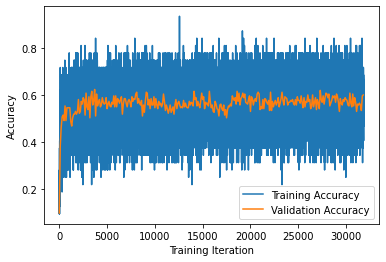

In [13]:
import matplotlib.pyplot as plt
plt.plot(range(len(training_accuracies_finetuning)), training_accuracies_finetuning, label = "Training Accuracy")
plt.plot(list(map(lambda x: x * 100, range(len(validation_accuracies_finetuning)))), validation_accuracies_finetuning, label = "Validation Accuracy")
plt.xlabel("Training Iteration")
plt.ylabel("Accuracy")
plt.legend()

In [14]:
import torch as th
import numpy as np

embedding_bert.to(device)

def get_embeds(x_data):
    concatted_shape = None
    pad_value = None
    embeds = []
    for text in tqdm(x_data):
        doc = nlp(text)
        embeddeds = []
        sents = [str(sent) for sent in doc.sents]
        if sentence_pairs and len(sents) > 1:
            sents = [a + b for a, b in zip(sents, sents[1:])]
        all_tokenized = []
        for sentence in sents[:num_sentences]:
            tokenized = tokenizer(sentence, truncation=True, padding="max_length", max_length=max_tokenized_length)[0]
            all_tokenized.append(tokenized.ids)
        
        with th.no_grad():
            sentence_tensor = th.tensor(all_tokenized).to(device)
            concatted = np.concatenate([
                # take output corresponding to CLS
                embedding_bert.bert(sentence_tensor, output_hidden_states=True, return_dict=True)[1].cpu().numpy(),
                np.zeros((len(all_tokenized), 1))
            ], axis=1)
            
            if not concatted_shape:
                concatted_shape = concatted.shape
                pad_value = np.zeros(concatted_shape[1])
                pad_value[-1] = 1
            
            embeddeds += list(concatted)

        if len(sents) < num_sentences:
            embeddeds += [pad_value] * (num_sentences - len(sents))

        embeds.append(embeddeds)
    return np.array(embeds)

main_data_key = f"cache-core/training-data-main-max-tokens-{max_tokenized_length}-split-{split_hash}-finetuned-{finetuning_model_hash}"
train_x_embeds, valid_x_embeds = memo_load(
    lambda: (
        get_embeds(train_x),
        get_embeds(valid_x)
    ),
    main_data_key
)
main_data_hash = hash_file(main_data_key + ".hkl")

  0%|          | 0/189419 [00:00<?, ?it/s]

  0%|          | 6/189419 [00:00<56:56, 55.44it/s]

  0%|          | 13/189419 [00:00<51:44, 61.00it/s]

  0%|          | 22/189419 [00:00<44:22, 71.14it/s]

  0%|          | 30/189419 [00:00<43:47, 72.07it/s]

  0%|          | 38/189419 [00:00<43:59, 71.74it/s]

  0%|          | 46/189419 [00:00<43:04, 73.28it/s]

  0%|          | 55/189419 [00:00<40:28, 77.99it/s]

  0%|          | 63/189419 [00:00<44:22, 71.11it/s]

  0%|          | 72/189419 [00:00<41:30, 76.03it/s]

  0%|          | 82/189419 [00:01<38:17, 82.41it/s]

  0%|          | 91/189419 [00:01<38:39, 81.64it/s]

  0%|          | 100/189419 [00:01<40:21, 78.19it/s]

  0%|          | 109/189419 [00:01<40:00, 78.86it/s]

  0%|          | 117/189419 [00:01<42:39, 73.95it/s]

  0%|          | 125/189419 [00:01<42:21, 74.48it/s]

  0%|          | 133/189419 [00:01<42:39, 73.96it/s]

  0%|          | 141/189419 [00:01<43:10, 73.08it/s]

  0%|          | 150/189419 [00:02<42:23, 74.42it/s]

  0%|          | 160/189419 [00:02<39:09, 80.55it/s]

  0%|          | 169/189419 [00:02<41:46, 75.51it/s]

  0%|          | 179/189419 [00:02<39:24, 80.04it/s]

  0%|          | 190/189419 [00:02<36:13, 87.06it/s]

  0%|          | 200/189419 [00:02<36:06, 87.35it/s]

  0%|          | 209/189419 [00:02<38:06, 82.76it/s]

  0%|          | 218/189419 [00:02<40:25, 78.01it/s]

  0%|          | 226/189419 [00:02<40:14, 78.37it/s]

  0%|          | 237/189419 [00:03<37:31, 84.03it/s]

  0%|          | 246/189419 [00:03<39:25, 79.96it/s]

  0%|          | 255/189419 [00:03<42:05, 74.90it/s]

  0%|          | 263/189419 [00:03<42:50, 73.59it/s]

  0%|          | 272/189419 [00:03<42:42, 73.82it/s]

  0%|          | 280/189419 [00:03<44:05, 71.49it/s]

  0%|          | 288/189419 [00:03<45:39, 69.04it/s]

  0%|          | 296/189419 [00:03<45:58, 68.55it/s]

  0%|          | 303/189419 [00:04<45:59, 68.53it/s]

  0%|          | 310/189419 [00:04<46:17, 68.09it/s]

  0%|          | 317/189419 [00:04<48:30, 64.98it/s]

  0%|          | 324/189419 [00:04<49:34, 63.57it/s]

  0%|          | 332/189419 [00:04<47:06, 66.89it/s]

  0%|          | 342/189419 [00:04<43:36, 72.26it/s]

  0%|          | 351/189419 [00:04<41:56, 75.13it/s]

  0%|          | 359/189419 [00:04<42:21, 74.39it/s]

  0%|          | 367/189419 [00:04<42:01, 74.98it/s]

  0%|          | 375/189419 [00:05<44:45, 70.41it/s]

  0%|          | 385/189419 [00:05<41:09, 76.55it/s]

  0%|          | 393/189419 [00:05<41:40, 75.59it/s]

  0%|          | 401/189419 [00:05<43:12, 72.90it/s]

  0%|          | 409/189419 [00:05<43:19, 72.70it/s]

  0%|          | 418/189419 [00:05<41:14, 76.38it/s]

  0%|          | 426/189419 [00:05<41:23, 76.11it/s]

  0%|          | 435/189419 [00:05<39:26, 79.86it/s]

  0%|          | 444/189419 [00:05<39:24, 79.93it/s]

  0%|          | 453/189419 [00:06<39:54, 78.92it/s]

  0%|          | 462/189419 [00:06<38:55, 80.89it/s]

  0%|          | 471/189419 [00:06<38:28, 81.86it/s]

  0%|          | 480/189419 [00:06<41:08, 76.55it/s]

  0%|          | 488/189419 [00:06<42:47, 73.58it/s]

  0%|          | 496/189419 [00:06<46:23, 67.88it/s]

  0%|          | 504/189419 [00:06<45:09, 69.74it/s]

  0%|          | 514/189419 [00:06<40:39, 77.43it/s]

  0%|          | 524/189419 [00:06<39:29, 79.73it/s]

  0%|          | 534/189419 [00:07<37:50, 83.18it/s]

  0%|          | 545/189419 [00:07<34:54, 90.17it/s]

  0%|          | 556/189419 [00:07<34:35, 91.02it/s]

  0%|          | 566/189419 [00:07<37:24, 84.14it/s]

  0%|          | 576/189419 [00:07<35:56, 87.58it/s]

  0%|          | 585/189419 [00:07<36:37, 85.94it/s]

  0%|          | 594/189419 [00:07<37:36, 83.68it/s]

  0%|          | 603/189419 [00:07<39:08, 80.39it/s]

  0%|          | 612/189419 [00:08<42:34, 73.90it/s]

  0%|          | 621/189419 [00:08<41:01, 76.72it/s]

  0%|          | 629/189419 [00:08<41:06, 76.55it/s]

  0%|          | 637/189419 [00:08<41:10, 76.43it/s]

  0%|          | 646/189419 [00:08<40:12, 78.25it/s]

  0%|          | 655/189419 [00:08<38:47, 81.10it/s]

  0%|          | 664/189419 [00:08<38:21, 82.03it/s]

  0%|          | 673/189419 [00:08<42:02, 74.83it/s]

  0%|          | 682/189419 [00:08<40:20, 77.97it/s]

  0%|          | 690/189419 [00:09<41:31, 75.74it/s]

  0%|          | 698/189419 [00:09<43:46, 71.85it/s]

  0%|          | 706/189419 [00:09<46:09, 68.13it/s]

  0%|          | 714/189419 [00:09<44:39, 70.42it/s]

  0%|          | 722/189419 [00:09<45:19, 69.38it/s]

  0%|          | 730/189419 [00:09<45:48, 68.66it/s]

  0%|          | 739/189419 [00:09<42:31, 73.95it/s]

  0%|          | 747/189419 [00:09<42:21, 74.24it/s]

  0%|          | 755/189419 [00:09<43:01, 73.07it/s]

  0%|          | 763/189419 [00:10<43:54, 71.62it/s]

  0%|          | 771/189419 [00:10<44:00, 71.43it/s]

  0%|          | 779/189419 [00:10<44:59, 69.88it/s]

  0%|          | 787/189419 [00:10<46:08, 68.14it/s]

  0%|          | 796/189419 [00:10<42:44, 73.55it/s]

  0%|          | 805/189419 [00:10<41:03, 76.55it/s]

  0%|          | 816/189419 [00:10<38:42, 81.22it/s]

  0%|          | 825/189419 [00:10<40:55, 76.80it/s]

  0%|          | 835/189419 [00:10<38:12, 82.28it/s]

  0%|          | 844/189419 [00:11<39:25, 79.73it/s]

  0%|          | 853/189419 [00:11<39:26, 79.70it/s]

  0%|          | 862/189419 [00:11<40:24, 77.78it/s]

  0%|          | 870/189419 [00:11<40:18, 77.96it/s]

  0%|          | 878/189419 [00:11<40:51, 76.91it/s]

  0%|          | 886/189419 [00:11<41:56, 74.90it/s]

  0%|          | 894/189419 [00:11<41:26, 75.82it/s]

  0%|          | 905/189419 [00:11<37:03, 84.79it/s]

  0%|          | 914/189419 [00:11<37:33, 83.65it/s]

  0%|          | 923/189419 [00:12<40:35, 77.39it/s]

  0%|          | 931/189419 [00:12<40:55, 76.75it/s]

  0%|          | 939/189419 [00:12<41:19, 76.00it/s]

  1%|          | 948/189419 [00:12<39:35, 79.35it/s]

  1%|          | 957/189419 [00:12<38:22, 81.84it/s]

  1%|          | 966/189419 [00:12<41:11, 76.25it/s]

  1%|          | 974/189419 [00:12<41:27, 75.76it/s]

  1%|          | 982/189419 [00:12<42:02, 74.71it/s]

  1%|          | 990/189419 [00:13<43:43, 71.82it/s]

  1%|          | 998/189419 [00:13<42:42, 73.52it/s]

  1%|          | 1006/189419 [00:13<43:06, 72.85it/s]

  1%|          | 1014/189419 [00:13<43:08, 72.78it/s]

  1%|          | 1023/189419 [00:13<40:56, 76.70it/s]

  1%|          | 1031/189419 [00:13<41:46, 75.16it/s]

  1%|          | 1041/189419 [00:13<38:28, 81.60it/s]

  1%|          | 1050/189419 [00:13<39:16, 79.95it/s]

  1%|          | 1059/189419 [00:13<39:01, 80.43it/s]

  1%|          | 1068/189419 [00:14<42:38, 73.63it/s]

  1%|          | 1076/189419 [00:14<42:31, 73.82it/s]

  1%|          | 1086/189419 [00:14<39:51, 78.76it/s]

  1%|          | 1094/189419 [00:14<41:42, 75.27it/s]

  1%|          | 1103/189419 [00:14<40:25, 77.64it/s]

  1%|          | 1111/189419 [00:14<40:27, 77.56it/s]

  1%|          | 1119/189419 [00:14<44:54, 69.89it/s]

  1%|          | 1127/189419 [00:14<44:24, 70.66it/s]

  1%|          | 1136/189419 [00:14<41:56, 74.81it/s]

  1%|          | 1144/189419 [00:15<42:15, 74.25it/s]

  1%|          | 1154/189419 [00:15<39:21, 79.72it/s]

  1%|          | 1163/189419 [00:15<39:14, 79.94it/s]

  1%|          | 1172/189419 [00:15<39:08, 80.17it/s]

  1%|          | 1181/189419 [00:15<39:25, 79.57it/s]

  1%|          | 1191/189419 [00:15<38:16, 81.97it/s]

  1%|          | 1200/189419 [00:15<40:47, 76.90it/s]

  1%|          | 1209/189419 [00:15<39:19, 79.76it/s]

  1%|          | 1218/189419 [00:15<39:55, 78.56it/s]

  1%|          | 1226/189419 [00:16<39:59, 78.44it/s]

  1%|          | 1234/189419 [00:16<39:58, 78.47it/s]

  1%|          | 1242/189419 [00:16<40:30, 77.42it/s]

  1%|          | 1250/189419 [00:16<41:20, 75.86it/s]

  1%|          | 1258/189419 [00:16<42:50, 73.19it/s]

  1%|          | 1266/189419 [00:16<45:37, 68.72it/s]

  1%|          | 1273/189419 [00:16<45:59, 68.18it/s]

  1%|          | 1280/189419 [00:16<45:49, 68.42it/s]

  1%|          | 1289/189419 [00:16<44:24, 70.60it/s]

  1%|          | 1298/189419 [00:17<41:51, 74.91it/s]

  1%|          | 1307/189419 [00:17<39:49, 78.72it/s]

  1%|          | 1316/189419 [00:17<38:23, 81.67it/s]

  1%|          | 1325/189419 [00:17<38:20, 81.75it/s]

  1%|          | 1336/189419 [00:17<35:44, 87.72it/s]

  1%|          | 1345/189419 [00:17<37:57, 82.59it/s]

  1%|          | 1354/189419 [00:17<38:34, 81.27it/s]

  1%|          | 1363/189419 [00:17<43:38, 71.81it/s]

  1%|          | 1371/189419 [00:17<42:50, 73.16it/s]

  1%|          | 1379/189419 [00:18<42:35, 73.57it/s]

  1%|          | 1387/189419 [00:18<42:42, 73.38it/s]

  1%|          | 1395/189419 [00:18<42:50, 73.14it/s]

  1%|          | 1403/189419 [00:18<42:50, 73.15it/s]

  1%|          | 1411/189419 [00:18<44:17, 70.75it/s]

  1%|          | 1419/189419 [00:18<44:13, 70.86it/s]

  1%|          | 1427/189419 [00:18<43:43, 71.67it/s]

  1%|          | 1435/189419 [00:18<43:35, 71.87it/s]

  1%|          | 1443/189419 [00:18<42:41, 73.37it/s]

  1%|          | 1451/189419 [00:19<45:57, 68.17it/s]

  1%|          | 1459/189419 [00:19<44:50, 69.87it/s]

  1%|          | 1468/189419 [00:19<42:00, 74.58it/s]

  1%|          | 1476/189419 [00:19<43:23, 72.18it/s]

  1%|          | 1485/189419 [00:19<41:48, 74.92it/s]

  1%|          | 1493/189419 [00:19<41:07, 76.17it/s]

  1%|          | 1502/189419 [00:19<39:14, 79.81it/s]

  1%|          | 1511/189419 [00:19<38:03, 82.30it/s]

  1%|          | 1520/189419 [00:19<40:14, 77.81it/s]

  1%|          | 1529/189419 [00:20<39:30, 79.25it/s]

  1%|          | 1537/189419 [00:20<39:45, 78.77it/s]

  1%|          | 1547/189419 [00:20<38:31, 81.28it/s]

  1%|          | 1556/189419 [00:20<41:35, 75.28it/s]

  1%|          | 1564/189419 [00:20<43:29, 71.98it/s]

  1%|          | 1573/189419 [00:20<42:07, 74.32it/s]

  1%|          | 1581/189419 [00:20<42:56, 72.91it/s]

  1%|          | 1589/189419 [00:20<43:10, 72.52it/s]

  1%|          | 1597/189419 [00:21<42:28, 73.71it/s]

  1%|          | 1606/189419 [00:21<40:59, 76.35it/s]

  1%|          | 1614/189419 [00:21<42:52, 73.00it/s]

  1%|          | 1623/189419 [00:21<40:19, 77.62it/s]

  1%|          | 1631/189419 [00:21<42:31, 73.59it/s]

  1%|          | 1639/189419 [00:21<41:32, 75.32it/s]

  1%|          | 1648/189419 [00:21<41:37, 75.19it/s]

  1%|          | 1656/189419 [00:21<44:05, 70.97it/s]

  1%|          | 1665/189419 [00:21<42:02, 74.42it/s]

  1%|          | 1673/189419 [00:22<44:09, 70.85it/s]

  1%|          | 1681/189419 [00:22<46:25, 67.39it/s]

  1%|          | 1688/189419 [00:22<46:03, 67.94it/s]

  1%|          | 1695/189419 [00:22<47:13, 66.25it/s]

  1%|          | 1705/189419 [00:22<42:59, 72.77it/s]

  1%|          | 1713/189419 [00:22<41:58, 74.52it/s]

  1%|          | 1722/189419 [00:22<40:26, 77.35it/s]

  1%|          | 1732/189419 [00:22<37:24, 83.60it/s]

  1%|          | 1741/189419 [00:22<38:14, 81.81it/s]

  1%|          | 1750/189419 [00:23<38:11, 81.91it/s]

  1%|          | 1759/189419 [00:23<37:09, 84.17it/s]

  1%|          | 1769/189419 [00:23<36:09, 86.51it/s]

  1%|          | 1778/189419 [00:23<37:08, 84.19it/s]

  1%|          | 1787/189419 [00:23<40:00, 78.17it/s]

  1%|          | 1797/189419 [00:23<37:59, 82.33it/s]

  1%|          | 1806/189419 [00:23<39:21, 79.46it/s]

  1%|          | 1815/189419 [00:23<40:07, 77.91it/s]

  1%|          | 1823/189419 [00:23<41:36, 75.14it/s]

  1%|          | 1833/189419 [00:24<40:16, 77.64it/s]

  1%|          | 1841/189419 [00:24<41:01, 76.19it/s]

  1%|          | 1849/189419 [00:24<42:40, 73.27it/s]

  1%|          | 1857/189419 [00:24<48:11, 64.87it/s]

  1%|          | 1864/189419 [00:24<47:29, 65.82it/s]

  1%|          | 1871/189419 [00:24<46:44, 66.87it/s]

  1%|          | 1878/189419 [00:24<48:02, 65.07it/s]

  1%|          | 1885/189419 [00:24<47:35, 65.68it/s]

  1%|          | 1894/189419 [00:25<44:04, 70.92it/s]

  1%|          | 1902/189419 [00:25<44:03, 70.95it/s]

  1%|          | 1913/189419 [00:25<39:13, 79.67it/s]

  1%|          | 1922/189419 [00:25<40:38, 76.90it/s]

  1%|          | 1930/189419 [00:25<42:46, 73.06it/s]

  1%|          | 1938/189419 [00:25<43:20, 72.08it/s]

  1%|          | 1946/189419 [00:25<42:32, 73.45it/s]

  1%|          | 1954/189419 [00:25<44:05, 70.87it/s]

  1%|          | 1962/189419 [00:25<44:07, 70.81it/s]

  1%|          | 1970/189419 [00:26<43:11, 72.33it/s]

  1%|          | 1978/189419 [00:26<44:06, 70.83it/s]

  1%|          | 1989/189419 [00:26<40:15, 77.58it/s]

  1%|          | 1997/189419 [00:26<41:51, 74.63it/s]

  1%|          | 2005/189419 [00:26<41:15, 75.69it/s]

  1%|          | 2013/189419 [00:26<41:08, 75.91it/s]

  1%|          | 2022/189419 [00:26<41:11, 75.82it/s]

  1%|          | 2031/189419 [00:26<40:30, 77.10it/s]

  1%|          | 2040/189419 [00:26<38:54, 80.26it/s]

  1%|          | 2049/189419 [00:27<38:51, 80.38it/s]

  1%|          | 2058/189419 [00:27<39:48, 78.43it/s]

  1%|          | 2068/189419 [00:27<37:37, 82.99it/s]

  1%|          | 2077/189419 [00:27<40:13, 77.62it/s]

  1%|          | 2085/189419 [00:27<42:06, 74.16it/s]

  1%|          | 2093/189419 [00:27<45:44, 68.25it/s]

  1%|          | 2101/189419 [00:27<43:58, 70.99it/s]

  1%|          | 2109/189419 [00:27<43:18, 72.08it/s]

  1%|          | 2117/189419 [00:28<43:31, 71.74it/s]

  1%|          | 2127/189419 [00:28<40:00, 78.01it/s]

  1%|          | 2135/189419 [00:28<40:57, 76.20it/s]

  1%|          | 2144/189419 [00:28<39:13, 79.58it/s]

  1%|          | 2153/189419 [00:28<39:20, 79.33it/s]

  1%|          | 2163/189419 [00:28<37:28, 83.26it/s]

  1%|          | 2172/189419 [00:28<38:10, 81.75it/s]

  1%|          | 2181/189419 [00:28<40:42, 76.65it/s]

  1%|          | 2190/189419 [00:28<38:59, 80.04it/s]

  1%|          | 2199/189419 [00:29<40:12, 77.62it/s]

  1%|          | 2209/189419 [00:29<38:08, 81.81it/s]

  1%|          | 2219/189419 [00:29<36:57, 84.40it/s]

  1%|          | 2228/189419 [00:29<38:20, 81.39it/s]

  1%|          | 2237/189419 [00:29<38:57, 80.07it/s]

  1%|          | 2246/189419 [00:29<37:44, 82.67it/s]

  1%|          | 2255/189419 [00:29<37:40, 82.80it/s]

  1%|          | 2264/189419 [00:29<41:04, 75.96it/s]

  1%|          | 2273/189419 [00:29<39:40, 78.62it/s]

  1%|          | 2281/189419 [00:30<42:54, 72.68it/s]

  1%|          | 2291/189419 [00:30<40:43, 76.58it/s]

  1%|          | 2299/189419 [00:30<41:41, 74.80it/s]

  1%|          | 2307/189419 [00:30<42:01, 74.21it/s]

  1%|          | 2315/189419 [00:30<41:18, 75.50it/s]

  1%|          | 2324/189419 [00:30<40:37, 76.77it/s]

  1%|          | 2332/189419 [00:30<40:56, 76.15it/s]

  1%|          | 2340/189419 [00:30<41:48, 74.56it/s]

  1%|          | 2351/189419 [00:30<37:33, 83.03it/s]

  1%|          | 2360/189419 [00:31<41:42, 74.74it/s]

  1%|▏         | 2368/189419 [00:31<43:04, 72.37it/s]

  1%|▏         | 2376/189419 [00:31<42:10, 73.91it/s]

  1%|▏         | 2384/189419 [00:31<41:28, 75.16it/s]

  1%|▏         | 2392/189419 [00:31<44:14, 70.46it/s]

  1%|▏         | 2400/189419 [00:31<43:31, 71.61it/s]

  1%|▏         | 2408/189419 [00:31<43:17, 71.99it/s]

  1%|▏         | 2416/189419 [00:31<42:16, 73.71it/s]

  1%|▏         | 2424/189419 [00:31<42:49, 72.76it/s]

  1%|▏         | 2432/189419 [00:32<43:48, 71.13it/s]

  1%|▏         | 2440/189419 [00:32<42:42, 72.97it/s]

  1%|▏         | 2449/189419 [00:32<42:23, 73.50it/s]

  1%|▏         | 2457/189419 [00:32<43:35, 71.48it/s]

  1%|▏         | 2465/189419 [00:32<43:50, 71.06it/s]

  1%|▏         | 2473/189419 [00:32<46:57, 66.36it/s]

  1%|▏         | 2480/189419 [00:32<48:04, 64.81it/s]

  1%|▏         | 2487/189419 [00:32<48:25, 64.34it/s]

  1%|▏         | 2496/189419 [00:33<44:22, 70.21it/s]

  1%|▏         | 2504/189419 [00:33<44:09, 70.56it/s]

  1%|▏         | 2514/189419 [00:33<40:25, 77.06it/s]

  1%|▏         | 2522/189419 [00:33<41:12, 75.58it/s]

  1%|▏         | 2530/189419 [00:33<40:59, 75.98it/s]

  1%|▏         | 2538/189419 [00:33<41:36, 74.85it/s]

  1%|▏         | 2546/189419 [00:33<40:59, 75.99it/s]

  1%|▏         | 2554/189419 [00:33<41:10, 75.64it/s]

  1%|▏         | 2562/189419 [00:33<46:27, 67.03it/s]

  1%|▏         | 2569/189419 [00:34<45:57, 67.77it/s]

  1%|▏         | 2578/189419 [00:34<43:53, 70.95it/s]

  1%|▏         | 2586/189419 [00:34<43:48, 71.08it/s]

  1%|▏         | 2594/189419 [00:34<43:34, 71.45it/s]

  1%|▏         | 2602/189419 [00:34<43:14, 72.01it/s]

  1%|▏         | 2610/189419 [00:34<42:10, 73.83it/s]

  1%|▏         | 2620/189419 [00:34<40:03, 77.73it/s]

  1%|▏         | 2628/189419 [00:34<40:23, 77.08it/s]

  1%|▏         | 2638/189419 [00:34<37:46, 82.43it/s]

  1%|▏         | 2648/189419 [00:35<36:52, 84.42it/s]

  1%|▏         | 2657/189419 [00:35<37:18, 83.42it/s]

  1%|▏         | 2666/189419 [00:35<38:54, 79.99it/s]

  1%|▏         | 2675/189419 [00:35<39:30, 78.79it/s]

  1%|▏         | 2683/189419 [00:35<44:16, 70.29it/s]

  1%|▏         | 2691/189419 [00:35<45:07, 68.96it/s]

  1%|▏         | 2698/189419 [00:35<45:16, 68.75it/s]

  1%|▏         | 2706/189419 [00:35<43:37, 71.32it/s]

  1%|▏         | 2716/189419 [00:35<39:41, 78.40it/s]

  1%|▏         | 2724/189419 [00:36<41:55, 74.21it/s]

  1%|▏         | 2733/189419 [00:36<40:18, 77.18it/s]

  1%|▏         | 2743/189419 [00:36<38:33, 80.70it/s]

  1%|▏         | 2752/189419 [00:36<40:33, 76.70it/s]

  1%|▏         | 2762/189419 [00:36<38:02, 81.79it/s]

  1%|▏         | 2773/189419 [00:36<36:01, 86.35it/s]

  1%|▏         | 2782/189419 [00:36<37:33, 82.81it/s]

  1%|▏         | 2791/189419 [00:36<37:10, 83.66it/s]

  1%|▏         | 2802/189419 [00:36<34:23, 90.43it/s]

  1%|▏         | 2812/189419 [00:37<39:11, 79.36it/s]

  1%|▏         | 2821/189419 [00:37<38:05, 81.66it/s]

  1%|▏         | 2830/189419 [00:37<37:36, 82.69it/s]

  1%|▏         | 2839/189419 [00:37<39:41, 78.34it/s]

  2%|▏         | 2847/189419 [00:37<40:02, 77.64it/s]

  2%|▏         | 2855/189419 [00:37<41:37, 74.69it/s]

  2%|▏         | 2865/189419 [00:37<38:44, 80.26it/s]

  2%|▏         | 2874/189419 [00:37<40:33, 76.67it/s]

  2%|▏         | 2882/189419 [00:38<41:58, 74.06it/s]

  2%|▏         | 2890/189419 [00:38<43:30, 71.45it/s]

  2%|▏         | 2898/189419 [00:38<47:10, 65.89it/s]

  2%|▏         | 2906/189419 [00:38<46:07, 67.40it/s]

  2%|▏         | 2915/189419 [00:38<42:39, 72.87it/s]

  2%|▏         | 2924/189419 [00:38<42:01, 73.97it/s]

  2%|▏         | 2932/189419 [00:38<41:35, 74.73it/s]

  2%|▏         | 2941/189419 [00:38<39:37, 78.42it/s]

  2%|▏         | 2949/189419 [00:38<40:58, 75.84it/s]

  2%|▏         | 2959/189419 [00:39<38:09, 81.43it/s]

  2%|▏         | 2968/189419 [00:39<37:38, 82.57it/s]

  2%|▏         | 2977/189419 [00:39<40:32, 76.63it/s]

  2%|▏         | 2985/189419 [00:39<41:45, 74.40it/s]

  2%|▏         | 2993/189419 [00:39<42:33, 73.00it/s]

  2%|▏         | 3002/189419 [00:39<40:16, 77.14it/s]

  2%|▏         | 3012/189419 [00:39<38:17, 81.15it/s]

  2%|▏         | 3022/189419 [00:39<36:08, 85.96it/s]

  2%|▏         | 3031/189419 [00:39<37:50, 82.09it/s]

  2%|▏         | 3040/189419 [00:40<41:37, 74.62it/s]

  2%|▏         | 3049/189419 [00:40<39:59, 77.69it/s]

  2%|▏         | 3057/189419 [00:40<42:54, 72.39it/s]

  2%|▏         | 3065/189419 [00:40<42:05, 73.79it/s]

  2%|▏         | 3074/189419 [00:40<40:18, 77.04it/s]

  2%|▏         | 3082/189419 [00:40<39:55, 77.80it/s]

  2%|▏         | 3090/189419 [00:40<42:41, 72.75it/s]

  2%|▏         | 3098/189419 [00:40<43:20, 71.64it/s]

  2%|▏         | 3107/189419 [00:41<40:43, 76.25it/s]

  2%|▏         | 3116/189419 [00:41<38:48, 80.00it/s]

  2%|▏         | 3125/189419 [00:41<39:20, 78.94it/s]

  2%|▏         | 3134/189419 [00:41<38:15, 81.17it/s]

  2%|▏         | 3143/189419 [00:41<40:25, 76.81it/s]

  2%|▏         | 3151/189419 [00:41<40:22, 76.90it/s]

  2%|▏         | 3160/189419 [00:41<38:55, 79.74it/s]

  2%|▏         | 3169/189419 [00:41<40:12, 77.20it/s]

  2%|▏         | 3180/189419 [00:41<36:21, 85.36it/s]

  2%|▏         | 3189/189419 [00:42<37:29, 82.80it/s]

  2%|▏         | 3198/189419 [00:42<38:05, 81.46it/s]

  2%|▏         | 3207/189419 [00:42<38:19, 80.97it/s]

  2%|▏         | 3216/189419 [00:42<38:37, 80.35it/s]

  2%|▏         | 3225/189419 [00:42<39:12, 79.14it/s]

  2%|▏         | 3233/189419 [00:42<40:22, 76.87it/s]

  2%|▏         | 3241/189419 [00:42<40:53, 75.88it/s]

  2%|▏         | 3249/189419 [00:42<42:51, 72.39it/s]

  2%|▏         | 3257/189419 [00:42<43:03, 72.05it/s]

  2%|▏         | 3266/189419 [00:43<40:52, 75.89it/s]

  2%|▏         | 3274/189419 [00:43<43:08, 71.90it/s]

  2%|▏         | 3285/189419 [00:43<38:19, 80.94it/s]

  2%|▏         | 3294/189419 [00:43<41:36, 74.55it/s]

  2%|▏         | 3302/189419 [00:43<41:48, 74.19it/s]

  2%|▏         | 3311/189419 [00:43<40:19, 76.91it/s]

  2%|▏         | 3319/189419 [00:43<40:41, 76.22it/s]

  2%|▏         | 3327/189419 [00:43<41:34, 74.59it/s]

  2%|▏         | 3335/189419 [00:43<42:09, 73.56it/s]

  2%|▏         | 3344/189419 [00:44<39:55, 77.69it/s]

  2%|▏         | 3352/189419 [00:44<40:55, 75.77it/s]

  2%|▏         | 3360/189419 [00:44<41:52, 74.06it/s]

  2%|▏         | 3368/189419 [00:44<42:32, 72.89it/s]

  2%|▏         | 3377/189419 [00:44<41:39, 74.42it/s]

  2%|▏         | 3385/189419 [00:44<43:04, 71.97it/s]

  2%|▏         | 3394/189419 [00:44<42:11, 73.50it/s]

  2%|▏         | 3402/189419 [00:44<42:09, 73.54it/s]

  2%|▏         | 3411/189419 [00:44<41:19, 75.02it/s]

  2%|▏         | 3419/189419 [00:45<41:22, 74.91it/s]

  2%|▏         | 3427/189419 [00:45<42:04, 73.68it/s]

  2%|▏         | 3435/189419 [00:45<41:30, 74.67it/s]

  2%|▏         | 3443/189419 [00:45<41:40, 74.37it/s]

  2%|▏         | 3451/189419 [00:45<42:38, 72.68it/s]

  2%|▏         | 3459/189419 [00:45<44:39, 69.39it/s]

  2%|▏         | 3467/189419 [00:45<43:20, 71.51it/s]

  2%|▏         | 3476/189419 [00:45<41:16, 75.09it/s]

  2%|▏         | 3484/189419 [00:45<44:00, 70.43it/s]

  2%|▏         | 3492/189419 [00:46<43:11, 71.74it/s]

  2%|▏         | 3501/189419 [00:46<42:18, 73.25it/s]

  2%|▏         | 3509/189419 [00:46<43:50, 70.68it/s]

  2%|▏         | 3517/189419 [00:46<43:07, 71.84it/s]

  2%|▏         | 3526/189419 [00:46<40:44, 76.06it/s]

  2%|▏         | 3535/189419 [00:46<40:09, 77.16it/s]

  2%|▏         | 3543/189419 [00:46<41:04, 75.41it/s]

  2%|▏         | 3551/189419 [00:46<41:27, 74.71it/s]

  2%|▏         | 3559/189419 [00:47<43:55, 70.53it/s]

  2%|▏         | 3567/189419 [00:47<45:52, 67.51it/s]

  2%|▏         | 3575/189419 [00:47<44:41, 69.32it/s]

  2%|▏         | 3582/189419 [00:47<45:03, 68.75it/s]

  2%|▏         | 3591/189419 [00:47<43:08, 71.79it/s]

  2%|▏         | 3601/189419 [00:47<41:03, 75.43it/s]

  2%|▏         | 3610/189419 [00:47<39:55, 77.58it/s]

  2%|▏         | 3619/189419 [00:47<39:10, 79.05it/s]

  2%|▏         | 3627/189419 [00:47<39:33, 78.28it/s]

  2%|▏         | 3635/189419 [00:48<42:32, 72.80it/s]

  2%|▏         | 3643/189419 [00:48<42:04, 73.60it/s]

  2%|▏         | 3651/189419 [00:48<41:09, 75.23it/s]

  2%|▏         | 3659/189419 [00:48<42:02, 73.65it/s]

  2%|▏         | 3667/189419 [00:48<44:54, 68.95it/s]

  2%|▏         | 3675/189419 [00:48<44:24, 69.70it/s]

  2%|▏         | 3683/189419 [00:48<47:16, 65.48it/s]

  2%|▏         | 3692/189419 [00:48<43:49, 70.62it/s]

  2%|▏         | 3700/189419 [00:48<43:39, 70.91it/s]

  2%|▏         | 3708/189419 [00:49<44:08, 70.12it/s]

  2%|▏         | 3716/189419 [00:49<43:34, 71.02it/s]

  2%|▏         | 3725/189419 [00:49<42:19, 73.12it/s]

  2%|▏         | 3734/189419 [00:49<41:44, 74.14it/s]

  2%|▏         | 3742/189419 [00:49<41:06, 75.29it/s]

  2%|▏         | 3751/189419 [00:49<41:01, 75.43it/s]

  2%|▏         | 3759/189419 [00:49<41:46, 74.07it/s]

  2%|▏         | 3767/189419 [00:49<45:25, 68.12it/s]

  2%|▏         | 3776/189419 [00:50<43:40, 70.85it/s]

  2%|▏         | 3785/189419 [00:50<41:41, 74.22it/s]

  2%|▏         | 3793/189419 [00:50<42:44, 72.40it/s]

  2%|▏         | 3801/189419 [00:50<41:42, 74.18it/s]

  2%|▏         | 3809/189419 [00:50<43:10, 71.64it/s]

  2%|▏         | 3817/189419 [00:50<42:04, 73.51it/s]

  2%|▏         | 3825/189419 [00:50<43:54, 70.45it/s]

  2%|▏         | 3835/189419 [00:50<40:49, 75.76it/s]

  2%|▏         | 3843/189419 [00:50<40:23, 76.59it/s]

  2%|▏         | 3851/189419 [00:51<39:59, 77.34it/s]

  2%|▏         | 3861/189419 [00:51<37:54, 81.59it/s]

  2%|▏         | 3870/189419 [00:51<41:51, 73.89it/s]

  2%|▏         | 3879/189419 [00:51<39:43, 77.84it/s]

  2%|▏         | 3887/189419 [00:51<40:39, 76.06it/s]

  2%|▏         | 3895/189419 [00:51<42:48, 72.24it/s]

  2%|▏         | 3903/189419 [00:51<42:50, 72.16it/s]

  2%|▏         | 3911/189419 [00:51<42:58, 71.96it/s]

  2%|▏         | 3920/189419 [00:51<41:08, 75.16it/s]

  2%|▏         | 3929/189419 [00:52<39:51, 77.57it/s]

  2%|▏         | 3938/189419 [00:52<38:33, 80.17it/s]

  2%|▏         | 3948/189419 [00:52<36:51, 83.86it/s]

  2%|▏         | 3957/189419 [00:52<37:48, 81.75it/s]

  2%|▏         | 3966/189419 [00:52<39:53, 77.49it/s]

  2%|▏         | 3974/189419 [00:52<41:21, 74.72it/s]

  2%|▏         | 3982/189419 [00:52<43:30, 71.04it/s]

  2%|▏         | 3992/189419 [00:52<39:27, 78.33it/s]

  2%|▏         | 4001/189419 [00:52<38:25, 80.41it/s]

  2%|▏         | 4010/189419 [00:53<39:25, 78.37it/s]

  2%|▏         | 4018/189419 [00:53<41:39, 74.18it/s]

  2%|▏         | 4026/189419 [00:53<42:43, 72.32it/s]

  2%|▏         | 4034/189419 [00:53<44:17, 69.77it/s]

  2%|▏         | 4042/189419 [00:53<44:17, 69.75it/s]

  2%|▏         | 4050/189419 [00:53<43:23, 71.21it/s]

  2%|▏         | 4058/189419 [00:53<44:05, 70.06it/s]

  2%|▏         | 4066/189419 [00:53<43:47, 70.54it/s]

  2%|▏         | 4074/189419 [00:54<46:58, 65.77it/s]

  2%|▏         | 4082/189419 [00:54<45:03, 68.56it/s]

  2%|▏         | 4089/189419 [00:54<46:40, 66.18it/s]

  2%|▏         | 4098/189419 [00:54<43:16, 71.38it/s]

  2%|▏         | 4106/189419 [00:54<44:35, 69.27it/s]

  2%|▏         | 4114/189419 [00:54<42:48, 72.13it/s]

  2%|▏         | 4123/189419 [00:54<40:52, 75.54it/s]

  2%|▏         | 4132/189419 [00:54<39:47, 77.60it/s]

  2%|▏         | 4140/189419 [00:54<39:57, 77.28it/s]

  2%|▏         | 4148/189419 [00:55<42:20, 72.91it/s]

  2%|▏         | 4156/189419 [00:55<41:26, 74.52it/s]

  2%|▏         | 4164/189419 [00:55<44:09, 69.93it/s]

  2%|▏         | 4172/189419 [00:55<43:26, 71.08it/s]

  2%|▏         | 4180/189419 [00:55<43:55, 70.29it/s]

  2%|▏         | 4188/189419 [00:55<44:13, 69.81it/s]

  2%|▏         | 4197/189419 [00:55<41:42, 74.00it/s]

  2%|▏         | 4205/189419 [00:55<44:10, 69.89it/s]

  2%|▏         | 4215/189419 [00:55<40:13, 76.74it/s]

  2%|▏         | 4223/189419 [00:56<40:48, 75.64it/s]

  2%|▏         | 4232/189419 [00:56<39:14, 78.65it/s]

  2%|▏         | 4240/189419 [00:56<39:45, 77.63it/s]

  2%|▏         | 4251/189419 [00:56<35:41, 86.47it/s]

  2%|▏         | 4261/189419 [00:56<35:50, 86.10it/s]

  2%|▏         | 4270/189419 [00:56<36:48, 83.85it/s]

  2%|▏         | 4279/189419 [00:56<39:22, 78.35it/s]

  2%|▏         | 4289/189419 [00:56<37:01, 83.34it/s]

  2%|▏         | 4298/189419 [00:56<38:43, 79.69it/s]

  2%|▏         | 4307/189419 [00:57<39:01, 79.07it/s]

  2%|▏         | 4316/189419 [00:57<39:34, 77.96it/s]

  2%|▏         | 4324/189419 [00:57<40:02, 77.04it/s]

  2%|▏         | 4332/189419 [00:57<40:37, 75.95it/s]

  2%|▏         | 4341/189419 [00:57<40:08, 76.86it/s]

  2%|▏         | 4349/189419 [00:57<40:40, 75.83it/s]

  2%|▏         | 4357/189419 [00:57<40:47, 75.61it/s]

  2%|▏         | 4367/189419 [00:57<38:04, 81.00it/s]

  2%|▏         | 4376/189419 [00:57<39:11, 78.69it/s]

  2%|▏         | 4384/189419 [00:58<39:02, 78.98it/s]

  2%|▏         | 4394/189419 [00:58<37:22, 82.50it/s]

  2%|▏         | 4403/189419 [00:58<38:51, 79.36it/s]

  2%|▏         | 4412/189419 [00:58<38:06, 80.92it/s]

  2%|▏         | 4421/189419 [00:58<37:55, 81.32it/s]

  2%|▏         | 4430/189419 [00:58<37:20, 82.56it/s]

  2%|▏         | 4439/189419 [00:58<37:40, 81.83it/s]

  2%|▏         | 4448/189419 [00:58<39:19, 78.41it/s]

  2%|▏         | 4457/189419 [00:58<39:18, 78.43it/s]

  2%|▏         | 4465/189419 [00:59<39:27, 78.12it/s]

  2%|▏         | 4474/189419 [00:59<39:49, 77.41it/s]

  2%|▏         | 4484/189419 [00:59<38:08, 80.80it/s]

  2%|▏         | 4493/189419 [00:59<38:25, 80.22it/s]

  2%|▏         | 4502/189419 [00:59<40:27, 76.18it/s]

  2%|▏         | 4512/189419 [00:59<38:04, 80.93it/s]

  2%|▏         | 4521/189419 [00:59<39:41, 77.65it/s]

  2%|▏         | 4529/189419 [00:59<41:07, 74.93it/s]

  2%|▏         | 4541/189419 [01:00<36:31, 84.35it/s]

  2%|▏         | 4551/189419 [01:00<34:57, 88.14it/s]

  2%|▏         | 4562/189419 [01:00<33:31, 91.89it/s]

  2%|▏         | 4572/189419 [01:00<36:10, 85.15it/s]

  2%|▏         | 4582/189419 [01:00<36:21, 84.74it/s]

  2%|▏         | 4591/189419 [01:00<37:51, 81.37it/s]

  2%|▏         | 4600/189419 [01:00<37:56, 81.18it/s]

  2%|▏         | 4609/189419 [01:00<41:37, 74.00it/s]

  2%|▏         | 4617/189419 [01:00<42:02, 73.26it/s]

  2%|▏         | 4625/189419 [01:01<41:29, 74.22it/s]

  2%|▏         | 4633/189419 [01:01<44:12, 69.67it/s]

  2%|▏         | 4641/189419 [01:01<45:07, 68.24it/s]

  2%|▏         | 4649/189419 [01:01<43:13, 71.24it/s]

  2%|▏         | 4657/189419 [01:01<43:55, 70.10it/s]

  2%|▏         | 4665/189419 [01:01<43:05, 71.45it/s]

  2%|▏         | 4673/189419 [01:01<44:09, 69.72it/s]

  2%|▏         | 4681/189419 [01:01<43:10, 71.31it/s]

  2%|▏         | 4691/189419 [01:02<39:24, 78.12it/s]

  2%|▏         | 4699/189419 [01:02<41:12, 74.70it/s]

  2%|▏         | 4707/189419 [01:02<42:03, 73.19it/s]

  2%|▏         | 4715/189419 [01:02<41:53, 73.49it/s]

  2%|▏         | 4723/189419 [01:02<42:15, 72.84it/s]

  2%|▏         | 4733/189419 [01:02<39:24, 78.11it/s]

  3%|▎         | 4743/189419 [01:02<37:02, 83.10it/s]

  3%|▎         | 4752/189419 [01:02<39:12, 78.50it/s]

  3%|▎         | 4760/189419 [01:02<39:46, 77.39it/s]

  3%|▎         | 4768/189419 [01:03<40:25, 76.14it/s]

  3%|▎         | 4778/189419 [01:03<37:57, 81.08it/s]

  3%|▎         | 4787/189419 [01:03<39:48, 77.30it/s]

  3%|▎         | 4797/189419 [01:03<37:36, 81.80it/s]

  3%|▎         | 4806/189419 [01:03<39:12, 78.47it/s]

  3%|▎         | 4814/189419 [01:03<39:21, 78.19it/s]

  3%|▎         | 4823/189419 [01:03<39:27, 77.96it/s]

  3%|▎         | 4831/189419 [01:03<39:53, 77.11it/s]

  3%|▎         | 4841/189419 [01:03<37:40, 81.65it/s]

  3%|▎         | 4850/189419 [01:04<38:28, 79.97it/s]

  3%|▎         | 4860/189419 [01:04<37:15, 82.55it/s]

  3%|▎         | 4869/189419 [01:04<38:16, 80.38it/s]

  3%|▎         | 4879/189419 [01:04<36:47, 83.60it/s]

  3%|▎         | 4888/189419 [01:04<36:47, 83.60it/s]

  3%|▎         | 4897/189419 [01:04<38:42, 79.47it/s]

  3%|▎         | 4905/189419 [01:04<39:24, 78.03it/s]

  3%|▎         | 4913/189419 [01:04<40:27, 76.00it/s]

  3%|▎         | 4921/189419 [01:04<41:33, 74.00it/s]

  3%|▎         | 4930/189419 [01:05<39:32, 77.76it/s]

  3%|▎         | 4938/189419 [01:05<40:24, 76.09it/s]

  3%|▎         | 4948/189419 [01:05<37:20, 82.32it/s]

  3%|▎         | 4957/189419 [01:05<38:24, 80.04it/s]

  3%|▎         | 4966/189419 [01:05<39:51, 77.14it/s]

  3%|▎         | 4975/189419 [01:05<38:14, 80.40it/s]

  3%|▎         | 4985/189419 [01:05<36:50, 83.44it/s]

  3%|▎         | 4995/189419 [01:05<35:35, 86.37it/s]

  3%|▎         | 5004/189419 [01:05<38:31, 79.79it/s]

  3%|▎         | 5014/189419 [01:06<37:44, 81.42it/s]

  3%|▎         | 5024/189419 [01:06<37:00, 83.05it/s]

  3%|▎         | 5033/189419 [01:06<36:30, 84.18it/s]

  3%|▎         | 5042/189419 [01:06<36:57, 83.14it/s]

  3%|▎         | 5051/189419 [01:06<37:06, 82.81it/s]

  3%|▎         | 5060/189419 [01:06<38:24, 80.01it/s]

  3%|▎         | 5070/189419 [01:06<37:56, 80.97it/s]

  3%|▎         | 5079/189419 [01:06<40:02, 76.71it/s]

  3%|▎         | 5087/189419 [01:06<39:40, 77.43it/s]

  3%|▎         | 5095/189419 [01:07<41:26, 74.13it/s]

  3%|▎         | 5104/189419 [01:07<40:13, 76.38it/s]

  3%|▎         | 5113/189419 [01:07<39:12, 78.34it/s]

  3%|▎         | 5121/189419 [01:07<40:37, 75.61it/s]

  3%|▎         | 5130/189419 [01:07<39:01, 78.72it/s]

  3%|▎         | 5139/189419 [01:07<38:54, 78.95it/s]

  3%|▎         | 5147/189419 [01:07<42:31, 72.21it/s]

  3%|▎         | 5156/189419 [01:07<41:05, 74.72it/s]

  3%|▎         | 5165/189419 [01:08<40:35, 75.67it/s]

  3%|▎         | 5173/189419 [01:08<42:40, 71.96it/s]

  3%|▎         | 5183/189419 [01:08<39:01, 78.68it/s]

  3%|▎         | 5193/189419 [01:08<37:16, 82.38it/s]

  3%|▎         | 5202/189419 [01:08<39:07, 78.47it/s]

  3%|▎         | 5211/189419 [01:08<38:30, 79.71it/s]

  3%|▎         | 5220/189419 [01:08<42:30, 72.23it/s]

  3%|▎         | 5228/189419 [01:08<42:40, 71.94it/s]

  3%|▎         | 5236/189419 [01:08<41:56, 73.19it/s]

  3%|▎         | 5244/189419 [01:09<43:41, 70.25it/s]

  3%|▎         | 5252/189419 [01:09<43:28, 70.61it/s]

  3%|▎         | 5261/189419 [01:09<40:59, 74.88it/s]

  3%|▎         | 5270/189419 [01:09<39:10, 78.36it/s]

  3%|▎         | 5280/189419 [01:09<37:25, 81.99it/s]

  3%|▎         | 5289/189419 [01:09<36:49, 83.34it/s]

  3%|▎         | 5298/189419 [01:09<38:51, 78.99it/s]

  3%|▎         | 5306/189419 [01:09<40:03, 76.60it/s]

  3%|▎         | 5314/189419 [01:09<39:36, 77.47it/s]

  3%|▎         | 5322/189419 [01:10<39:32, 77.60it/s]

  3%|▎         | 5330/189419 [01:10<40:31, 75.72it/s]

  3%|▎         | 5339/189419 [01:10<40:08, 76.41it/s]

  3%|▎         | 5347/189419 [01:10<39:38, 77.38it/s]

  3%|▎         | 5355/189419 [01:10<40:45, 75.27it/s]

  3%|▎         | 5363/189419 [01:10<41:27, 74.00it/s]

  3%|▎         | 5372/189419 [01:10<39:36, 77.45it/s]

  3%|▎         | 5381/189419 [01:10<38:21, 79.96it/s]

  3%|▎         | 5390/189419 [01:10<38:31, 79.63it/s]

  3%|▎         | 5398/189419 [01:11<39:51, 76.95it/s]

  3%|▎         | 5406/189419 [01:11<39:36, 77.42it/s]

  3%|▎         | 5415/189419 [01:11<38:27, 79.74it/s]

  3%|▎         | 5423/189419 [01:11<39:58, 76.72it/s]

  3%|▎         | 5431/189419 [01:11<41:02, 74.72it/s]

  3%|▎         | 5439/189419 [01:11<43:00, 71.30it/s]

  3%|▎         | 5448/189419 [01:11<40:46, 75.19it/s]

  3%|▎         | 5456/189419 [01:11<42:33, 72.04it/s]

  3%|▎         | 5465/189419 [01:11<40:17, 76.09it/s]

  3%|▎         | 5474/189419 [01:12<38:43, 79.18it/s]

  3%|▎         | 5482/189419 [01:12<39:30, 77.59it/s]

  3%|▎         | 5490/189419 [01:12<39:24, 77.80it/s]

  3%|▎         | 5500/189419 [01:12<37:52, 80.95it/s]

  3%|▎         | 5509/189419 [01:12<40:00, 76.61it/s]

  3%|▎         | 5517/189419 [01:12<40:46, 75.18it/s]

  3%|▎         | 5525/189419 [01:12<42:30, 72.11it/s]

  3%|▎         | 5534/189419 [01:12<40:07, 76.38it/s]

  3%|▎         | 5542/189419 [01:12<40:01, 76.56it/s]

  3%|▎         | 5550/189419 [01:13<39:39, 77.29it/s]

  3%|▎         | 5558/189419 [01:13<40:22, 75.89it/s]

  3%|▎         | 5566/189419 [01:13<40:57, 74.82it/s]

  3%|▎         | 5574/189419 [01:13<43:18, 70.76it/s]

  3%|▎         | 5582/189419 [01:13<42:25, 72.22it/s]

  3%|▎         | 5590/189419 [01:13<42:38, 71.86it/s]

  3%|▎         | 5598/189419 [01:13<46:14, 66.26it/s]

  3%|▎         | 5608/189419 [01:13<41:40, 73.52it/s]

  3%|▎         | 5617/189419 [01:13<40:11, 76.22it/s]

  3%|▎         | 5625/189419 [01:14<40:59, 74.73it/s]

  3%|▎         | 5634/189419 [01:14<39:31, 77.51it/s]

  3%|▎         | 5643/189419 [01:14<37:55, 80.76it/s]

  3%|▎         | 5653/189419 [01:14<36:02, 84.98it/s]

  3%|▎         | 5662/189419 [01:14<35:44, 85.70it/s]

  3%|▎         | 5671/189419 [01:14<40:29, 75.64it/s]

  3%|▎         | 5679/189419 [01:14<39:55, 76.69it/s]

  3%|▎         | 5687/189419 [01:14<42:52, 71.42it/s]

  3%|▎         | 5695/189419 [01:15<45:12, 67.73it/s]

  3%|▎         | 5704/189419 [01:15<41:43, 73.38it/s]

  3%|▎         | 5712/189419 [01:15<41:12, 74.29it/s]

  3%|▎         | 5722/189419 [01:15<37:45, 81.07it/s]

  3%|▎         | 5731/189419 [01:15<39:31, 77.46it/s]

  3%|▎         | 5739/189419 [01:15<39:37, 77.26it/s]

  3%|▎         | 5747/189419 [01:15<39:30, 77.48it/s]

  3%|▎         | 5755/189419 [01:15<42:31, 71.98it/s]

  3%|▎         | 5763/189419 [01:15<42:10, 72.56it/s]

  3%|▎         | 5771/189419 [01:16<43:35, 70.21it/s]

  3%|▎         | 5782/189419 [01:16<38:30, 79.48it/s]

  3%|▎         | 5791/189419 [01:16<37:18, 82.05it/s]

  3%|▎         | 5800/189419 [01:16<36:54, 82.93it/s]

  3%|▎         | 5809/189419 [01:16<38:02, 80.43it/s]

  3%|▎         | 5818/189419 [01:16<38:40, 79.11it/s]

  3%|▎         | 5828/189419 [01:16<36:34, 83.67it/s]

  3%|▎         | 5838/189419 [01:16<35:49, 85.41it/s]

  3%|▎         | 5847/189419 [01:16<36:16, 84.32it/s]

  3%|▎         | 5856/189419 [01:17<38:37, 79.21it/s]

  3%|▎         | 5865/189419 [01:17<37:45, 81.00it/s]

  3%|▎         | 5874/189419 [01:17<42:22, 72.18it/s]

  3%|▎         | 5884/189419 [01:17<39:38, 77.17it/s]

  3%|▎         | 5892/189419 [01:17<41:19, 74.00it/s]

  3%|▎         | 5900/189419 [01:17<42:11, 72.51it/s]

  3%|▎         | 5910/189419 [01:17<39:13, 77.98it/s]

  3%|▎         | 5918/189419 [01:17<41:11, 74.25it/s]

  3%|▎         | 5928/189419 [01:17<38:43, 78.97it/s]

  3%|▎         | 5937/189419 [01:18<37:24, 81.76it/s]

  3%|▎         | 5946/189419 [01:18<37:01, 82.60it/s]

  3%|▎         | 5955/189419 [01:18<40:08, 76.18it/s]

  3%|▎         | 5963/189419 [01:18<42:18, 72.27it/s]

  3%|▎         | 5971/189419 [01:18<42:54, 71.26it/s]

  3%|▎         | 5979/189419 [01:18<42:03, 72.70it/s]

  3%|▎         | 5987/189419 [01:18<42:25, 72.06it/s]

  3%|▎         | 5996/189419 [01:18<40:01, 76.38it/s]

  3%|▎         | 6006/189419 [01:19<37:53, 80.69it/s]

  3%|▎         | 6015/189419 [01:19<39:32, 77.30it/s]

  3%|▎         | 6023/189419 [01:19<40:15, 75.93it/s]

  3%|▎         | 6031/189419 [01:19<41:39, 73.38it/s]

  3%|▎         | 6039/189419 [01:19<41:55, 72.89it/s]

  3%|▎         | 6048/189419 [01:19<39:27, 77.44it/s]

  3%|▎         | 6059/189419 [01:19<37:01, 82.55it/s]

  3%|▎         | 6068/189419 [01:19<41:15, 74.05it/s]

  3%|▎         | 6076/189419 [01:19<41:51, 73.00it/s]

  3%|▎         | 6085/189419 [01:20<39:52, 76.62it/s]

  3%|▎         | 6093/189419 [01:20<43:04, 70.94it/s]

  3%|▎         | 6101/189419 [01:20<42:46, 71.42it/s]

  3%|▎         | 6109/189419 [01:20<41:30, 73.60it/s]

  3%|▎         | 6117/189419 [01:20<41:36, 73.41it/s]

  3%|▎         | 6125/189419 [01:20<42:32, 71.82it/s]

  3%|▎         | 6135/189419 [01:20<39:34, 77.20it/s]

  3%|▎         | 6143/189419 [01:20<39:20, 77.63it/s]

  3%|▎         | 6153/189419 [01:20<36:28, 83.73it/s]

  3%|▎         | 6162/189419 [01:21<38:13, 79.92it/s]

  3%|▎         | 6172/189419 [01:21<36:13, 84.32it/s]

  3%|▎         | 6181/189419 [01:21<37:49, 80.72it/s]

  3%|▎         | 6190/189419 [01:21<38:29, 79.32it/s]

  3%|▎         | 6198/189419 [01:21<40:03, 76.24it/s]

  3%|▎         | 6206/189419 [01:21<43:27, 70.26it/s]

  3%|▎         | 6216/189419 [01:21<39:26, 77.41it/s]

  3%|▎         | 6224/189419 [01:21<42:24, 71.99it/s]

  3%|▎         | 6232/189419 [01:22<41:53, 72.90it/s]

  3%|▎         | 6241/189419 [01:22<40:09, 76.02it/s]

  3%|▎         | 6249/189419 [01:22<42:37, 71.63it/s]

  3%|▎         | 6257/189419 [01:22<43:43, 69.81it/s]

  3%|▎         | 6265/189419 [01:22<44:52, 68.02it/s]

  3%|▎         | 6272/189419 [01:22<45:17, 67.40it/s]

  3%|▎         | 6282/189419 [01:22<40:16, 75.78it/s]

  3%|▎         | 6291/189419 [01:22<38:40, 78.93it/s]

  3%|▎         | 6299/189419 [01:22<40:28, 75.42it/s]

  3%|▎         | 6307/189419 [01:23<42:13, 72.27it/s]

  3%|▎         | 6315/189419 [01:23<42:09, 72.40it/s]

  3%|▎         | 6323/189419 [01:23<43:49, 69.64it/s]

  3%|▎         | 6332/189419 [01:23<41:29, 73.55it/s]

  3%|▎         | 6340/189419 [01:23<42:17, 72.15it/s]

  3%|▎         | 6348/189419 [01:23<41:07, 74.20it/s]

  3%|▎         | 6356/189419 [01:23<40:35, 75.15it/s]

  3%|▎         | 6364/189419 [01:23<42:39, 71.53it/s]

  3%|▎         | 6375/189419 [01:23<39:21, 77.52it/s]

  3%|▎         | 6383/189419 [01:24<39:26, 77.35it/s]

  3%|▎         | 6391/189419 [01:24<40:07, 76.01it/s]

  3%|▎         | 6399/189419 [01:24<40:09, 75.97it/s]

  3%|▎         | 6407/189419 [01:24<39:53, 76.47it/s]

  3%|▎         | 6415/189419 [01:24<40:37, 75.07it/s]

  3%|▎         | 6424/189419 [01:24<39:22, 77.47it/s]

  3%|▎         | 6433/189419 [01:24<37:52, 80.51it/s]

  3%|▎         | 6442/189419 [01:24<41:33, 73.37it/s]

  3%|▎         | 6451/189419 [01:24<39:27, 77.27it/s]

  3%|▎         | 6459/189419 [01:25<39:45, 76.69it/s]

  3%|▎         | 6467/189419 [01:25<39:59, 76.24it/s]

  3%|▎         | 6475/189419 [01:25<43:28, 70.14it/s]

  3%|▎         | 6484/189419 [01:25<41:23, 73.66it/s]

  3%|▎         | 6492/189419 [01:25<42:43, 71.36it/s]

  3%|▎         | 6502/189419 [01:25<39:07, 77.91it/s]

  3%|▎         | 6510/189419 [01:25<41:43, 73.07it/s]

  3%|▎         | 6518/189419 [01:25<43:58, 69.33it/s]

  3%|▎         | 6526/189419 [01:25<42:51, 71.12it/s]

  3%|▎         | 6534/189419 [01:26<42:06, 72.40it/s]

  3%|▎         | 6542/189419 [01:26<43:34, 69.94it/s]

  3%|▎         | 6551/189419 [01:26<42:11, 72.24it/s]

  3%|▎         | 6559/189419 [01:26<42:33, 71.62it/s]

  3%|▎         | 6569/189419 [01:26<39:38, 76.89it/s]

  3%|▎         | 6578/189419 [01:26<39:09, 77.81it/s]

  3%|▎         | 6587/189419 [01:26<39:05, 77.96it/s]

  3%|▎         | 6595/189419 [01:26<41:31, 73.37it/s]

  3%|▎         | 6604/189419 [01:27<39:25, 77.28it/s]

  3%|▎         | 6612/189419 [01:27<39:46, 76.60it/s]

  3%|▎         | 6620/189419 [01:27<40:01, 76.13it/s]

  3%|▎         | 6629/189419 [01:27<38:10, 79.81it/s]

  4%|▎         | 6638/189419 [01:27<40:52, 74.53it/s]

  4%|▎         | 6646/189419 [01:27<41:18, 73.76it/s]

  4%|▎         | 6655/189419 [01:27<41:11, 73.95it/s]

  4%|▎         | 6663/189419 [01:27<40:53, 74.47it/s]

  4%|▎         | 6672/189419 [01:27<39:34, 76.98it/s]

  4%|▎         | 6680/189419 [01:28<39:31, 77.06it/s]

  4%|▎         | 6688/189419 [01:28<40:47, 74.65it/s]

  4%|▎         | 6696/189419 [01:28<40:59, 74.28it/s]

  4%|▎         | 6704/189419 [01:28<41:38, 73.14it/s]

  4%|▎         | 6713/189419 [01:28<40:58, 74.31it/s]

  4%|▎         | 6722/189419 [01:28<38:48, 78.47it/s]

  4%|▎         | 6730/189419 [01:28<41:22, 73.60it/s]

  4%|▎         | 6738/189419 [01:28<41:25, 73.50it/s]

  4%|▎         | 6749/189419 [01:28<37:31, 81.12it/s]

  4%|▎         | 6758/189419 [01:29<38:20, 79.40it/s]

  4%|▎         | 6767/189419 [01:29<38:44, 78.56it/s]

  4%|▎         | 6776/189419 [01:29<38:06, 79.88it/s]

  4%|▎         | 6785/189419 [01:29<39:48, 76.46it/s]

  4%|▎         | 6793/189419 [01:29<41:41, 73.00it/s]

  4%|▎         | 6802/189419 [01:29<39:45, 76.56it/s]

  4%|▎         | 6810/189419 [01:29<40:09, 75.78it/s]

  4%|▎         | 6819/189419 [01:29<38:58, 78.09it/s]

  4%|▎         | 6827/189419 [01:29<39:39, 76.72it/s]

  4%|▎         | 6835/189419 [01:30<39:59, 76.09it/s]

  4%|▎         | 6843/189419 [01:30<42:17, 71.96it/s]

  4%|▎         | 6851/189419 [01:30<41:23, 73.50it/s]

  4%|▎         | 6859/189419 [01:30<42:15, 71.99it/s]

  4%|▎         | 6867/189419 [01:30<41:14, 73.78it/s]

  4%|▎         | 6875/189419 [01:30<42:51, 70.99it/s]

  4%|▎         | 6883/189419 [01:30<42:35, 71.44it/s]

  4%|▎         | 6893/189419 [01:30<39:08, 77.73it/s]

  4%|▎         | 6901/189419 [01:30<39:49, 76.39it/s]

  4%|▎         | 6910/189419 [01:31<39:25, 77.14it/s]

  4%|▎         | 6918/189419 [01:31<40:39, 74.82it/s]

  4%|▎         | 6926/189419 [01:31<41:36, 73.09it/s]

  4%|▎         | 6934/189419 [01:31<41:12, 73.79it/s]

  4%|▎         | 6942/189419 [01:31<41:34, 73.16it/s]

  4%|▎         | 6950/189419 [01:31<41:17, 73.64it/s]

  4%|▎         | 6962/189419 [01:31<36:05, 84.24it/s]

  4%|▎         | 6971/189419 [01:31<37:22, 81.35it/s]

  4%|▎         | 6980/189419 [01:31<37:30, 81.05it/s]

  4%|▎         | 6989/189419 [01:32<39:03, 77.85it/s]

  4%|▎         | 6998/189419 [01:32<38:01, 79.96it/s]

  4%|▎         | 7007/189419 [01:32<38:32, 78.87it/s]

  4%|▎         | 7015/189419 [01:32<39:52, 76.24it/s]

  4%|▎         | 7023/189419 [01:32<42:37, 71.33it/s]

  4%|▎         | 7033/189419 [01:32<39:37, 76.73it/s]

  4%|▎         | 7042/189419 [01:32<38:18, 79.35it/s]

  4%|▎         | 7051/189419 [01:32<40:26, 75.17it/s]

  4%|▎         | 7060/189419 [01:33<38:50, 78.26it/s]

  4%|▎         | 7070/189419 [01:33<37:13, 81.65it/s]

  4%|▎         | 7079/189419 [01:33<37:42, 80.60it/s]

  4%|▎         | 7088/189419 [01:33<39:44, 76.48it/s]

  4%|▎         | 7096/189419 [01:33<40:28, 75.07it/s]

  4%|▍         | 7106/189419 [01:33<37:47, 80.40it/s]

  4%|▍         | 7115/189419 [01:33<39:38, 76.66it/s]

  4%|▍         | 7125/189419 [01:33<37:56, 80.07it/s]

  4%|▍         | 7134/189419 [01:33<37:28, 81.08it/s]

  4%|▍         | 7143/189419 [01:34<37:23, 81.23it/s]

  4%|▍         | 7153/189419 [01:34<35:35, 85.35it/s]

  4%|▍         | 7162/189419 [01:34<36:37, 82.95it/s]

  4%|▍         | 7171/189419 [01:34<37:22, 81.28it/s]

  4%|▍         | 7180/189419 [01:34<39:13, 77.42it/s]

  4%|▍         | 7188/189419 [01:34<40:39, 74.70it/s]

  4%|▍         | 7196/189419 [01:34<40:29, 74.99it/s]

  4%|▍         | 7204/189419 [01:34<41:19, 73.50it/s]

  4%|▍         | 7212/189419 [01:34<42:37, 71.23it/s]

  4%|▍         | 7220/189419 [01:35<42:13, 71.92it/s]

  4%|▍         | 7229/189419 [01:35<40:28, 75.02it/s]

  4%|▍         | 7237/189419 [01:35<40:33, 74.86it/s]

  4%|▍         | 7245/189419 [01:35<41:59, 72.32it/s]

  4%|▍         | 7255/189419 [01:35<38:59, 77.87it/s]

  4%|▍         | 7263/189419 [01:35<41:06, 73.84it/s]

  4%|▍         | 7271/189419 [01:35<41:08, 73.79it/s]

  4%|▍         | 7279/189419 [01:35<41:34, 73.03it/s]

  4%|▍         | 7287/189419 [01:35<42:38, 71.18it/s]

  4%|▍         | 7295/189419 [01:36<43:07, 70.40it/s]

  4%|▍         | 7303/189419 [01:36<41:46, 72.67it/s]

  4%|▍         | 7312/189419 [01:36<40:15, 75.38it/s]

  4%|▍         | 7321/189419 [01:36<39:29, 76.84it/s]

  4%|▍         | 7329/189419 [01:36<39:47, 76.27it/s]

  4%|▍         | 7337/189419 [01:36<42:38, 71.17it/s]

  4%|▍         | 7345/189419 [01:36<42:39, 71.14it/s]

  4%|▍         | 7353/189419 [01:36<43:22, 69.96it/s]

  4%|▍         | 7361/189419 [01:37<46:39, 65.04it/s]

  4%|▍         | 7369/189419 [01:37<44:39, 67.94it/s]

  4%|▍         | 7376/189419 [01:37<46:14, 65.61it/s]

  4%|▍         | 7385/189419 [01:37<42:48, 70.87it/s]

  4%|▍         | 7393/189419 [01:37<43:02, 70.49it/s]

  4%|▍         | 7401/189419 [01:37<42:27, 71.44it/s]

  4%|▍         | 7409/189419 [01:37<43:28, 69.78it/s]

  4%|▍         | 7417/189419 [01:37<42:16, 71.75it/s]

  4%|▍         | 7426/189419 [01:37<41:04, 73.84it/s]

  4%|▍         | 7434/189419 [01:38<40:09, 75.53it/s]

  4%|▍         | 7443/189419 [01:38<38:55, 77.92it/s]

  4%|▍         | 7451/189419 [01:38<39:56, 75.93it/s]

  4%|▍         | 7459/189419 [01:38<39:53, 76.02it/s]

  4%|▍         | 7471/189419 [01:38<35:19, 85.83it/s]

  4%|▍         | 7480/189419 [01:38<37:10, 81.57it/s]

  4%|▍         | 7490/189419 [01:38<35:05, 86.41it/s]

  4%|▍         | 7499/189419 [01:38<35:38, 85.05it/s]

  4%|▍         | 7508/189419 [01:38<38:54, 77.93it/s]

  4%|▍         | 7517/189419 [01:39<37:43, 80.37it/s]

  4%|▍         | 7526/189419 [01:39<39:48, 76.15it/s]

  4%|▍         | 7534/189419 [01:39<42:23, 71.51it/s]

  4%|▍         | 7543/189419 [01:39<40:51, 74.19it/s]

  4%|▍         | 7551/189419 [01:39<40:36, 74.65it/s]

  4%|▍         | 7559/189419 [01:39<42:17, 71.66it/s]

  4%|▍         | 7567/189419 [01:39<43:59, 68.89it/s]

  4%|▍         | 7574/189419 [01:39<46:11, 65.61it/s]

  4%|▍         | 7582/189419 [01:40<44:43, 67.76it/s]

  4%|▍         | 7589/189419 [01:40<46:30, 65.15it/s]

  4%|▍         | 7598/189419 [01:40<43:25, 69.79it/s]

  4%|▍         | 7606/189419 [01:40<43:20, 69.92it/s]

  4%|▍         | 7615/189419 [01:40<40:32, 74.75it/s]

  4%|▍         | 7624/189419 [01:40<38:46, 78.15it/s]

  4%|▍         | 7632/189419 [01:40<39:20, 77.00it/s]

  4%|▍         | 7640/189419 [01:40<40:43, 74.39it/s]

  4%|▍         | 7648/189419 [01:40<42:48, 70.78it/s]

  4%|▍         | 7656/189419 [01:41<42:43, 70.91it/s]

  4%|▍         | 7664/189419 [01:41<42:14, 71.70it/s]

  4%|▍         | 7674/189419 [01:41<40:08, 75.47it/s]

  4%|▍         | 7682/189419 [01:41<40:10, 75.41it/s]

  4%|▍         | 7690/189419 [01:41<39:50, 76.03it/s]

  4%|▍         | 7699/189419 [01:41<39:15, 77.15it/s]

  4%|▍         | 7708/189419 [01:41<38:19, 79.02it/s]

  4%|▍         | 7717/189419 [01:41<37:14, 81.31it/s]

  4%|▍         | 7726/189419 [01:41<39:50, 76.01it/s]

  4%|▍         | 7735/189419 [01:42<38:10, 79.33it/s]

  4%|▍         | 7744/189419 [01:42<39:47, 76.08it/s]

  4%|▍         | 7754/189419 [01:42<37:11, 81.41it/s]

  4%|▍         | 7763/189419 [01:42<40:43, 74.33it/s]

  4%|▍         | 7771/189419 [01:42<43:09, 70.14it/s]

  4%|▍         | 7779/189419 [01:42<43:49, 69.07it/s]

  4%|▍         | 7787/189419 [01:42<42:58, 70.43it/s]

  4%|▍         | 7797/189419 [01:42<39:11, 77.23it/s]

  4%|▍         | 7805/189419 [01:42<39:40, 76.29it/s]

  4%|▍         | 7813/189419 [01:43<41:23, 73.14it/s]

  4%|▍         | 7821/189419 [01:43<40:26, 74.84it/s]

  4%|▍         | 7829/189419 [01:43<40:18, 75.09it/s]

  4%|▍         | 7837/189419 [01:43<42:33, 71.11it/s]

  4%|▍         | 7845/189419 [01:43<41:16, 73.31it/s]

  4%|▍         | 7853/189419 [01:43<44:41, 67.72it/s]

  4%|▍         | 7862/189419 [01:43<43:18, 69.87it/s]

  4%|▍         | 7870/189419 [01:43<46:02, 65.71it/s]

  4%|▍         | 7877/189419 [01:44<46:19, 65.31it/s]

  4%|▍         | 7886/189419 [01:44<43:08, 70.12it/s]

  4%|▍         | 7894/189419 [01:44<42:58, 70.39it/s]

  4%|▍         | 7905/189419 [01:44<38:22, 78.85it/s]

  4%|▍         | 7914/189419 [01:44<37:34, 80.51it/s]

  4%|▍         | 7923/189419 [01:44<41:03, 73.66it/s]

  4%|▍         | 7931/189419 [01:44<41:59, 72.03it/s]

  4%|▍         | 7939/189419 [01:44<41:01, 73.72it/s]

  4%|▍         | 7947/189419 [01:44<42:20, 71.42it/s]

  4%|▍         | 7958/189419 [01:45<37:21, 80.97it/s]

  4%|▍         | 7967/189419 [01:45<37:56, 79.71it/s]

  4%|▍         | 7976/189419 [01:45<38:34, 78.40it/s]

  4%|▍         | 7986/189419 [01:45<36:38, 82.51it/s]

  4%|▍         | 7995/189419 [01:45<38:48, 77.93it/s]

  4%|▍         | 8004/189419 [01:45<37:44, 80.12it/s]

  4%|▍         | 8013/189419 [01:45<37:55, 79.71it/s]

  4%|▍         | 8022/189419 [01:45<40:07, 75.36it/s]

  4%|▍         | 8030/189419 [01:46<40:36, 74.45it/s]

  4%|▍         | 8038/189419 [01:46<40:52, 73.96it/s]

  4%|▍         | 8048/189419 [01:46<37:24, 80.81it/s]

  4%|▍         | 8058/189419 [01:46<36:29, 82.82it/s]

  4%|▍         | 8067/189419 [01:46<39:15, 76.98it/s]

  4%|▍         | 8075/189419 [01:46<39:38, 76.26it/s]

  4%|▍         | 8083/189419 [01:46<39:46, 75.98it/s]

  4%|▍         | 8091/189419 [01:46<40:25, 74.76it/s]

  4%|▍         | 8099/189419 [01:46<40:05, 75.37it/s]

  4%|▍         | 8107/189419 [01:47<41:09, 73.43it/s]

  4%|▍         | 8115/189419 [01:47<40:30, 74.59it/s]

  4%|▍         | 8123/189419 [01:47<39:56, 75.67it/s]

  4%|▍         | 8131/189419 [01:47<40:52, 73.93it/s]

  4%|▍         | 8139/189419 [01:47<40:35, 74.45it/s]

  4%|▍         | 8147/189419 [01:47<41:01, 73.63it/s]

  4%|▍         | 8155/189419 [01:47<40:06, 75.33it/s]

  4%|▍         | 8164/189419 [01:47<38:06, 79.26it/s]

  4%|▍         | 8173/189419 [01:47<37:27, 80.64it/s]

  4%|▍         | 8182/189419 [01:47<38:52, 77.70it/s]

  4%|▍         | 8190/189419 [01:48<38:37, 78.19it/s]

  4%|▍         | 8199/189419 [01:48<37:21, 80.86it/s]

  4%|▍         | 8208/189419 [01:48<39:44, 76.00it/s]

  4%|▍         | 8216/189419 [01:48<39:20, 76.78it/s]

  4%|▍         | 8225/189419 [01:48<37:51, 79.78it/s]

  4%|▍         | 8234/189419 [01:48<40:36, 74.37it/s]

  4%|▍         | 8242/189419 [01:48<40:51, 73.90it/s]

  4%|▍         | 8252/189419 [01:48<37:45, 79.96it/s]

  4%|▍         | 8261/189419 [01:49<40:06, 75.29it/s]

  4%|▍         | 8269/189419 [01:49<40:42, 74.18it/s]

  4%|▍         | 8277/189419 [01:49<41:40, 72.43it/s]

  4%|▍         | 8285/189419 [01:49<42:38, 70.81it/s]

  4%|▍         | 8293/189419 [01:49<43:54, 68.76it/s]

  4%|▍         | 8302/189419 [01:49<41:25, 72.87it/s]

  4%|▍         | 8311/189419 [01:49<40:38, 74.26it/s]

  4%|▍         | 8319/189419 [01:49<40:59, 73.63it/s]

  4%|▍         | 8328/189419 [01:49<40:23, 74.71it/s]

  4%|▍         | 8336/189419 [01:50<40:35, 74.36it/s]

  4%|▍         | 8344/189419 [01:50<40:49, 73.91it/s]

  4%|▍         | 8352/189419 [01:50<40:18, 74.87it/s]

  4%|▍         | 8363/189419 [01:50<35:59, 83.84it/s]

  4%|▍         | 8372/189419 [01:50<37:09, 81.21it/s]

  4%|▍         | 8381/189419 [01:50<37:04, 81.40it/s]

  4%|▍         | 8390/189419 [01:50<39:54, 75.62it/s]

  4%|▍         | 8398/189419 [01:50<42:38, 70.75it/s]

  4%|▍         | 8406/189419 [01:50<41:27, 72.77it/s]

  4%|▍         | 8414/189419 [01:51<41:03, 73.46it/s]

  4%|▍         | 8422/189419 [01:51<40:22, 74.72it/s]

  4%|▍         | 8430/189419 [01:51<40:46, 73.98it/s]

  4%|▍         | 8439/189419 [01:51<38:59, 77.35it/s]

  4%|▍         | 8447/189419 [01:51<40:26, 74.58it/s]

  4%|▍         | 8455/189419 [01:51<40:48, 73.92it/s]

  4%|▍         | 8464/189419 [01:51<38:46, 77.79it/s]

  4%|▍         | 8472/189419 [01:51<39:47, 75.79it/s]

  4%|▍         | 8480/189419 [01:51<41:05, 73.40it/s]

  4%|▍         | 8488/189419 [01:52<41:22, 72.89it/s]

  4%|▍         | 8496/189419 [01:52<41:29, 72.69it/s]

  4%|▍         | 8505/189419 [01:52<41:09, 73.26it/s]

  4%|▍         | 8514/189419 [01:52<39:50, 75.66it/s]

  4%|▍         | 8522/189419 [01:52<40:21, 74.71it/s]

  5%|▍         | 8530/189419 [01:52<40:46, 73.92it/s]

  5%|▍         | 8538/189419 [01:52<41:59, 71.79it/s]

  5%|▍         | 8546/189419 [01:52<41:13, 73.12it/s]

  5%|▍         | 8556/189419 [01:52<37:56, 79.44it/s]

  5%|▍         | 8565/189419 [01:53<36:38, 82.28it/s]

  5%|▍         | 8574/189419 [01:53<36:26, 82.71it/s]

  5%|▍         | 8583/189419 [01:53<40:04, 75.22it/s]

  5%|▍         | 8591/189419 [01:53<41:09, 73.23it/s]

  5%|▍         | 8599/189419 [01:53<41:41, 72.30it/s]

  5%|▍         | 8608/189419 [01:53<39:39, 75.97it/s]

  5%|▍         | 8617/189419 [01:53<38:16, 78.72it/s]

  5%|▍         | 8625/189419 [01:53<40:49, 73.82it/s]

  5%|▍         | 8633/189419 [01:54<42:26, 70.99it/s]

  5%|▍         | 8642/189419 [01:54<40:12, 74.93it/s]

  5%|▍         | 8650/189419 [01:54<44:03, 68.38it/s]

  5%|▍         | 8658/189419 [01:54<43:50, 68.71it/s]

  5%|▍         | 8665/189419 [01:54<44:50, 67.19it/s]

  5%|▍         | 8673/189419 [01:54<43:33, 69.17it/s]

  5%|▍         | 8682/189419 [01:54<41:23, 72.78it/s]

  5%|▍         | 8691/189419 [01:54<39:34, 76.10it/s]

  5%|▍         | 8700/189419 [01:54<39:55, 75.43it/s]

  5%|▍         | 8708/189419 [01:55<39:23, 76.45it/s]

  5%|▍         | 8716/189419 [01:55<42:23, 71.06it/s]

  5%|▍         | 8725/189419 [01:55<39:56, 75.40it/s]

  5%|▍         | 8733/189419 [01:55<40:38, 74.11it/s]

  5%|▍         | 8741/189419 [01:55<41:24, 72.71it/s]

  5%|▍         | 8750/189419 [01:55<39:15, 76.72it/s]

  5%|▍         | 8758/189419 [01:55<41:25, 72.69it/s]

  5%|▍         | 8768/189419 [01:55<39:31, 76.18it/s]

  5%|▍         | 8776/189419 [01:55<40:45, 73.87it/s]

  5%|▍         | 8784/189419 [01:56<43:17, 69.55it/s]

  5%|▍         | 8794/189419 [01:56<39:56, 75.38it/s]

  5%|▍         | 8802/189419 [01:56<40:35, 74.17it/s]

  5%|▍         | 8811/189419 [01:56<39:08, 76.90it/s]

  5%|▍         | 8819/189419 [01:56<40:00, 75.23it/s]

  5%|▍         | 8828/189419 [01:56<40:00, 75.24it/s]

  5%|▍         | 8837/189419 [01:56<39:36, 76.00it/s]

  5%|▍         | 8845/189419 [01:56<40:36, 74.12it/s]

  5%|▍         | 8853/189419 [01:57<43:22, 69.39it/s]

  5%|▍         | 8860/189419 [01:57<44:10, 68.12it/s]

  5%|▍         | 8869/189419 [01:57<40:41, 73.96it/s]

  5%|▍         | 8877/189419 [01:57<43:10, 69.68it/s]

  5%|▍         | 8885/189419 [01:57<43:44, 68.79it/s]

  5%|▍         | 8895/189419 [01:57<39:40, 75.82it/s]

  5%|▍         | 8906/189419 [01:57<36:28, 82.47it/s]

  5%|▍         | 8915/189419 [01:57<40:14, 74.77it/s]

  5%|▍         | 8923/189419 [01:57<41:04, 73.24it/s]

  5%|▍         | 8931/189419 [01:58<40:46, 73.77it/s]

  5%|▍         | 8942/189419 [01:58<36:41, 81.97it/s]

  5%|▍         | 8954/189419 [01:58<34:14, 87.85it/s]

  5%|▍         | 8963/189419 [01:58<36:33, 82.25it/s]

  5%|▍         | 8972/189419 [01:58<39:48, 75.54it/s]

  5%|▍         | 8980/189419 [01:58<43:19, 69.40it/s]

  5%|▍         | 8989/189419 [01:58<40:46, 73.76it/s]

  5%|▍         | 8997/189419 [01:58<40:02, 75.11it/s]

  5%|▍         | 9005/189419 [01:59<39:58, 75.22it/s]

  5%|▍         | 9013/189419 [01:59<42:42, 70.39it/s]

  5%|▍         | 9022/189419 [01:59<40:50, 73.63it/s]

  5%|▍         | 9030/189419 [01:59<40:16, 74.65it/s]

  5%|▍         | 9039/189419 [01:59<38:26, 78.22it/s]

  5%|▍         | 9047/189419 [01:59<39:09, 76.78it/s]

  5%|▍         | 9055/189419 [01:59<42:19, 71.01it/s]

  5%|▍         | 9063/189419 [01:59<42:54, 70.05it/s]

  5%|▍         | 9071/189419 [01:59<41:33, 72.32it/s]

  5%|▍         | 9079/189419 [02:00<41:04, 73.17it/s]

  5%|▍         | 9087/189419 [02:00<40:02, 75.06it/s]

  5%|▍         | 9097/189419 [02:00<37:17, 80.59it/s]

  5%|▍         | 9107/189419 [02:00<35:34, 84.46it/s]

  5%|▍         | 9116/189419 [02:00<37:23, 80.36it/s]

  5%|▍         | 9125/189419 [02:00<37:51, 79.36it/s]

  5%|▍         | 9135/189419 [02:00<36:13, 82.96it/s]

  5%|▍         | 9144/189419 [02:00<37:36, 79.91it/s]

  5%|▍         | 9153/189419 [02:00<38:54, 77.22it/s]

  5%|▍         | 9162/189419 [02:01<37:20, 80.46it/s]

  5%|▍         | 9171/189419 [02:01<37:12, 80.75it/s]

  5%|▍         | 9180/189419 [02:01<38:09, 78.74it/s]

  5%|▍         | 9188/189419 [02:01<40:36, 73.97it/s]

  5%|▍         | 9196/189419 [02:01<41:31, 72.34it/s]

  5%|▍         | 9206/189419 [02:01<39:42, 75.64it/s]

  5%|▍         | 9214/189419 [02:01<39:28, 76.10it/s]

  5%|▍         | 9222/189419 [02:01<41:09, 72.96it/s]

  5%|▍         | 9230/189419 [02:01<41:35, 72.20it/s]

  5%|▍         | 9239/189419 [02:02<39:09, 76.70it/s]

  5%|▍         | 9247/189419 [02:02<39:11, 76.62it/s]

  5%|▍         | 9256/189419 [02:02<39:20, 76.31it/s]

  5%|▍         | 9264/189419 [02:02<38:58, 77.03it/s]

  5%|▍         | 9273/189419 [02:02<37:24, 80.26it/s]

  5%|▍         | 9282/189419 [02:02<36:15, 82.81it/s]

  5%|▍         | 9291/189419 [02:02<38:27, 78.07it/s]

  5%|▍         | 9299/189419 [02:02<39:12, 76.56it/s]

  5%|▍         | 9307/189419 [02:02<42:19, 70.92it/s]

  5%|▍         | 9315/189419 [02:03<47:14, 63.54it/s]

  5%|▍         | 9322/189419 [02:03<46:46, 64.18it/s]

  5%|▍         | 9332/189419 [02:03<41:22, 72.55it/s]

  5%|▍         | 9340/189419 [02:03<40:41, 73.74it/s]

  5%|▍         | 9348/189419 [02:03<40:55, 73.34it/s]

  5%|▍         | 9356/189419 [02:03<41:42, 71.95it/s]

  5%|▍         | 9364/189419 [02:03<41:19, 72.63it/s]

  5%|▍         | 9372/189419 [02:03<41:33, 72.21it/s]

  5%|▍         | 9381/189419 [02:03<39:00, 76.92it/s]

  5%|▍         | 9391/189419 [02:04<36:13, 82.82it/s]

  5%|▍         | 9400/189419 [02:04<36:55, 81.27it/s]

  5%|▍         | 9409/189419 [02:04<37:20, 80.35it/s]

  5%|▍         | 9418/189419 [02:04<38:19, 78.28it/s]

  5%|▍         | 9427/189419 [02:04<37:15, 80.53it/s]

  5%|▍         | 9436/189419 [02:04<40:05, 74.84it/s]

  5%|▍         | 9444/189419 [02:04<41:18, 72.62it/s]

  5%|▍         | 9452/189419 [02:04<42:28, 70.63it/s]

  5%|▍         | 9460/189419 [02:05<41:50, 71.69it/s]

  5%|▍         | 9468/189419 [02:05<40:36, 73.87it/s]

  5%|▌         | 9476/189419 [02:05<41:42, 71.89it/s]

  5%|▌         | 9485/189419 [02:05<40:15, 74.50it/s]

  5%|▌         | 9493/189419 [02:05<40:58, 73.18it/s]

  5%|▌         | 9501/189419 [02:05<40:54, 73.30it/s]

  5%|▌         | 9511/189419 [02:05<37:20, 80.30it/s]

  5%|▌         | 9520/189419 [02:05<40:09, 74.65it/s]

  5%|▌         | 9528/189419 [02:05<40:09, 74.65it/s]

  5%|▌         | 9536/189419 [02:06<41:23, 72.42it/s]

  5%|▌         | 9545/189419 [02:06<39:04, 76.71it/s]

  5%|▌         | 9554/189419 [02:06<38:57, 76.95it/s]

  5%|▌         | 9562/189419 [02:06<40:15, 74.46it/s]

  5%|▌         | 9570/189419 [02:06<40:06, 74.73it/s]

  5%|▌         | 9578/189419 [02:06<41:59, 71.38it/s]

  5%|▌         | 9586/189419 [02:06<42:34, 70.39it/s]

  5%|▌         | 9594/189419 [02:06<41:20, 72.48it/s]

  5%|▌         | 9602/189419 [02:06<42:23, 70.70it/s]

  5%|▌         | 9611/189419 [02:07<40:33, 73.88it/s]

  5%|▌         | 9619/189419 [02:07<42:36, 70.32it/s]

  5%|▌         | 9628/189419 [02:07<40:29, 73.99it/s]

  5%|▌         | 9636/189419 [02:07<39:40, 75.54it/s]

  5%|▌         | 9646/189419 [02:07<37:23, 80.12it/s]

  5%|▌         | 9655/189419 [02:07<36:59, 81.01it/s]

  5%|▌         | 9664/189419 [02:07<37:31, 79.82it/s]

  5%|▌         | 9674/189419 [02:07<35:59, 83.22it/s]

  5%|▌         | 9683/189419 [02:07<36:02, 83.10it/s]

  5%|▌         | 9692/189419 [02:08<36:11, 82.76it/s]

  5%|▌         | 9701/189419 [02:08<36:03, 83.07it/s]

  5%|▌         | 9710/189419 [02:08<43:32, 68.79it/s]

  5%|▌         | 9718/189419 [02:08<43:30, 68.84it/s]

  5%|▌         | 9726/189419 [02:08<42:10, 71.02it/s]

  5%|▌         | 9735/189419 [02:08<41:29, 72.17it/s]

  5%|▌         | 9743/189419 [02:08<44:05, 67.91it/s]

  5%|▌         | 9752/189419 [02:08<42:21, 70.68it/s]

  5%|▌         | 9761/189419 [02:09<39:39, 75.51it/s]

  5%|▌         | 9769/189419 [02:09<40:44, 73.49it/s]

  5%|▌         | 9777/189419 [02:09<40:15, 74.37it/s]

  5%|▌         | 9786/189419 [02:09<38:39, 77.45it/s]

  5%|▌         | 9796/189419 [02:09<36:59, 80.92it/s]

  5%|▌         | 9805/189419 [02:09<38:24, 77.93it/s]

  5%|▌         | 9814/189419 [02:09<38:08, 78.49it/s]

  5%|▌         | 9822/189419 [02:09<38:25, 77.90it/s]

  5%|▌         | 9831/189419 [02:09<37:49, 79.14it/s]

  5%|▌         | 9839/189419 [02:10<38:27, 77.82it/s]

  5%|▌         | 9848/189419 [02:10<36:58, 80.93it/s]

  5%|▌         | 9857/189419 [02:10<39:52, 75.05it/s]

  5%|▌         | 9866/189419 [02:10<38:30, 77.70it/s]

  5%|▌         | 9876/189419 [02:10<35:58, 83.20it/s]

  5%|▌         | 9885/189419 [02:10<35:40, 83.88it/s]

  5%|▌         | 9894/189419 [02:10<36:55, 81.04it/s]

  5%|▌         | 9903/189419 [02:10<37:35, 79.58it/s]

  5%|▌         | 9913/189419 [02:10<35:39, 83.92it/s]

  5%|▌         | 9922/189419 [02:11<35:27, 84.35it/s]

  5%|▌         | 9931/189419 [02:11<37:58, 78.79it/s]

  5%|▌         | 9941/189419 [02:11<36:35, 81.76it/s]

  5%|▌         | 9950/189419 [02:11<35:48, 83.53it/s]

  5%|▌         | 9959/189419 [02:11<37:36, 79.52it/s]

  5%|▌         | 9968/189419 [02:11<37:43, 79.28it/s]

  5%|▌         | 9976/189419 [02:11<38:34, 77.52it/s]

  5%|▌         | 9984/189419 [02:11<38:30, 77.67it/s]

  5%|▌         | 9994/189419 [02:11<35:42, 83.75it/s]

  5%|▌         | 10003/189419 [02:12<36:18, 82.34it/s]

  5%|▌         | 10013/189419 [02:12<35:10, 84.99it/s]

  5%|▌         | 10023/189419 [02:12<34:06, 87.67it/s]

  5%|▌         | 10032/189419 [02:12<36:59, 80.81it/s]

  5%|▌         | 10042/189419 [02:12<35:37, 83.90it/s]

  5%|▌         | 10051/189419 [02:12<37:53, 78.90it/s]

  5%|▌         | 10059/189419 [02:12<39:08, 76.37it/s]

  5%|▌         | 10067/189419 [02:12<42:01, 71.12it/s]

  5%|▌         | 10075/189419 [02:13<40:56, 73.01it/s]

  5%|▌         | 10083/189419 [02:13<44:32, 67.09it/s]

  5%|▌         | 10091/189419 [02:13<42:47, 69.85it/s]

  5%|▌         | 10100/189419 [02:13<39:58, 74.76it/s]

  5%|▌         | 10108/189419 [02:13<40:22, 74.01it/s]

  5%|▌         | 10116/189419 [02:13<42:57, 69.57it/s]

  5%|▌         | 10124/189419 [02:13<42:27, 70.37it/s]

  5%|▌         | 10134/189419 [02:13<40:07, 74.48it/s]

  5%|▌         | 10143/189419 [02:13<38:46, 77.05it/s]

  5%|▌         | 10152/189419 [02:14<38:12, 78.19it/s]

  5%|▌         | 10160/189419 [02:14<39:39, 75.33it/s]

  5%|▌         | 10168/189419 [02:14<40:27, 73.84it/s]

  5%|▌         | 10176/189419 [02:14<41:15, 72.41it/s]

  5%|▌         | 10184/189419 [02:14<41:35, 71.83it/s]

  5%|▌         | 10192/189419 [02:14<41:06, 72.67it/s]

  5%|▌         | 10200/189419 [02:14<40:14, 74.23it/s]

  5%|▌         | 10209/189419 [02:14<38:21, 77.85it/s]

  5%|▌         | 10220/189419 [02:14<34:53, 85.59it/s]

  5%|▌         | 10229/189419 [02:15<38:50, 76.88it/s]

  5%|▌         | 10237/189419 [02:15<40:16, 74.16it/s]

  5%|▌         | 10246/189419 [02:15<39:07, 76.34it/s]

  5%|▌         | 10254/189419 [02:15<40:44, 73.31it/s]

  5%|▌         | 10262/189419 [02:15<39:53, 74.86it/s]

  5%|▌         | 10270/189419 [02:15<40:02, 74.56it/s]

  5%|▌         | 10278/189419 [02:15<40:11, 74.28it/s]

  5%|▌         | 10286/189419 [02:15<41:18, 72.29it/s]

  5%|▌         | 10294/189419 [02:15<41:13, 72.42it/s]

  5%|▌         | 10302/189419 [02:16<40:42, 73.32it/s]

  5%|▌         | 10310/189419 [02:16<41:37, 71.73it/s]

  5%|▌         | 10318/189419 [02:16<43:42, 68.29it/s]

  5%|▌         | 10326/189419 [02:16<42:32, 70.15it/s]

  5%|▌         | 10335/189419 [02:16<40:25, 73.83it/s]

  5%|▌         | 10343/189419 [02:16<44:00, 67.82it/s]

  5%|▌         | 10350/189419 [02:16<45:49, 65.12it/s]

  5%|▌         | 10359/189419 [02:16<41:46, 71.43it/s]

  5%|▌         | 10367/189419 [02:17<42:44, 69.81it/s]

  5%|▌         | 10375/189419 [02:17<43:18, 68.91it/s]

  5%|▌         | 10383/189419 [02:17<42:57, 69.45it/s]

  5%|▌         | 10390/189419 [02:17<45:12, 65.99it/s]

  5%|▌         | 10398/189419 [02:17<42:54, 69.55it/s]

  5%|▌         | 10407/189419 [02:17<40:36, 73.47it/s]

  5%|▌         | 10416/189419 [02:17<38:36, 77.28it/s]

  6%|▌         | 10427/189419 [02:17<35:12, 84.75it/s]

  6%|▌         | 10436/189419 [02:17<36:44, 81.19it/s]

  6%|▌         | 10445/189419 [02:18<37:42, 79.10it/s]

  6%|▌         | 10454/189419 [02:18<37:57, 78.60it/s]

  6%|▌         | 10462/189419 [02:18<39:54, 74.73it/s]

  6%|▌         | 10470/189419 [02:18<40:00, 74.54it/s]

  6%|▌         | 10478/189419 [02:18<43:29, 68.57it/s]

  6%|▌         | 10488/189419 [02:18<39:32, 75.42it/s]

  6%|▌         | 10496/189419 [02:18<41:26, 71.96it/s]

  6%|▌         | 10505/189419 [02:18<39:32, 75.40it/s]

  6%|▌         | 10516/189419 [02:18<36:43, 81.18it/s]

  6%|▌         | 10525/189419 [02:19<37:52, 78.73it/s]

  6%|▌         | 10533/189419 [02:19<38:05, 78.27it/s]

  6%|▌         | 10541/189419 [02:19<39:10, 76.10it/s]

  6%|▌         | 10550/189419 [02:19<38:22, 77.70it/s]

  6%|▌         | 10559/189419 [02:19<37:19, 79.86it/s]

  6%|▌         | 10568/189419 [02:19<37:52, 78.71it/s]

  6%|▌         | 10578/189419 [02:19<35:40, 83.54it/s]

  6%|▌         | 10587/189419 [02:19<35:33, 83.81it/s]

  6%|▌         | 10596/189419 [02:19<37:33, 79.35it/s]

  6%|▌         | 10605/189419 [02:20<38:31, 77.37it/s]

  6%|▌         | 10613/189419 [02:20<39:56, 74.61it/s]

  6%|▌         | 10623/189419 [02:20<37:44, 78.96it/s]

  6%|▌         | 10632/189419 [02:20<36:40, 81.25it/s]

  6%|▌         | 10641/189419 [02:20<38:34, 77.24it/s]

  6%|▌         | 10650/189419 [02:20<38:47, 76.81it/s]

  6%|▌         | 10660/189419 [02:20<37:22, 79.72it/s]

  6%|▌         | 10669/189419 [02:20<39:01, 76.33it/s]

  6%|▌         | 10678/189419 [02:21<38:07, 78.12it/s]

  6%|▌         | 10690/189419 [02:21<33:53, 87.89it/s]

  6%|▌         | 10699/189419 [02:21<37:22, 79.68it/s]

  6%|▌         | 10708/189419 [02:21<38:41, 76.97it/s]

  6%|▌         | 10718/189419 [02:21<36:53, 80.73it/s]

  6%|▌         | 10727/189419 [02:21<37:06, 80.25it/s]

  6%|▌         | 10737/189419 [02:21<35:30, 83.85it/s]

  6%|▌         | 10746/189419 [02:21<35:26, 84.03it/s]

  6%|▌         | 10755/189419 [02:21<35:45, 83.27it/s]

  6%|▌         | 10764/189419 [02:22<39:10, 76.00it/s]

  6%|▌         | 10775/189419 [02:22<36:10, 82.30it/s]

  6%|▌         | 10784/189419 [02:22<37:25, 79.55it/s]

  6%|▌         | 10795/189419 [02:22<35:29, 83.87it/s]

  6%|▌         | 10804/189419 [02:22<35:06, 84.81it/s]

  6%|▌         | 10813/189419 [02:22<34:49, 85.46it/s]

  6%|▌         | 10822/189419 [02:22<35:36, 83.58it/s]

  6%|▌         | 10831/189419 [02:22<39:12, 75.93it/s]

  6%|▌         | 10840/189419 [02:23<38:27, 77.39it/s]

  6%|▌         | 10848/189419 [02:23<40:26, 73.61it/s]

  6%|▌         | 10856/189419 [02:23<40:14, 73.96it/s]

  6%|▌         | 10864/189419 [02:23<40:20, 73.77it/s]

  6%|▌         | 10872/189419 [02:23<42:27, 70.08it/s]

  6%|▌         | 10881/189419 [02:23<39:55, 74.52it/s]

  6%|▌         | 10889/189419 [02:23<41:29, 71.72it/s]

  6%|▌         | 10897/189419 [02:23<42:04, 70.71it/s]

  6%|▌         | 10905/189419 [02:23<42:45, 69.58it/s]

  6%|▌         | 10914/189419 [02:24<40:57, 72.64it/s]

  6%|▌         | 10922/189419 [02:24<43:15, 68.78it/s]

  6%|▌         | 10929/189419 [02:24<43:39, 68.14it/s]

  6%|▌         | 10937/189419 [02:24<42:38, 69.75it/s]

  6%|▌         | 10945/189419 [02:24<44:30, 66.83it/s]

  6%|▌         | 10952/189419 [02:24<44:56, 66.19it/s]

  6%|▌         | 10962/189419 [02:24<39:38, 75.02it/s]

  6%|▌         | 10970/189419 [02:24<39:08, 75.98it/s]

  6%|▌         | 10978/189419 [02:24<41:18, 71.99it/s]

  6%|▌         | 10986/189419 [02:25<40:58, 72.59it/s]

  6%|▌         | 10994/189419 [02:25<43:20, 68.61it/s]

  6%|▌         | 11002/189419 [02:25<42:35, 69.81it/s]

  6%|▌         | 11010/189419 [02:25<44:12, 67.26it/s]

  6%|▌         | 11018/189419 [02:25<44:17, 67.14it/s]

  6%|▌         | 11025/189419 [02:25<45:31, 65.31it/s]

  6%|▌         | 11033/189419 [02:25<44:04, 67.45it/s]

  6%|▌         | 11040/189419 [02:25<44:43, 66.47it/s]

  6%|▌         | 11047/189419 [02:26<44:37, 66.63it/s]

  6%|▌         | 11055/189419 [02:26<42:55, 69.26it/s]

  6%|▌         | 11062/189419 [02:26<43:31, 68.29it/s]

  6%|▌         | 11069/189419 [02:26<43:29, 68.35it/s]

  6%|▌         | 11080/189419 [02:26<38:04, 78.07it/s]

  6%|▌         | 11088/189419 [02:26<39:43, 74.81it/s]

  6%|▌         | 11098/189419 [02:26<38:03, 78.08it/s]

  6%|▌         | 11108/189419 [02:26<36:25, 81.60it/s]

  6%|▌         | 11117/189419 [02:26<39:36, 75.04it/s]

  6%|▌         | 11125/189419 [02:27<38:59, 76.22it/s]

  6%|▌         | 11133/189419 [02:27<40:08, 74.03it/s]

  6%|▌         | 11142/189419 [02:27<39:04, 76.06it/s]

  6%|▌         | 11150/189419 [02:27<38:45, 76.66it/s]

  6%|▌         | 11158/189419 [02:27<39:05, 76.00it/s]

  6%|▌         | 11166/189419 [02:27<41:37, 71.36it/s]

  6%|▌         | 11174/189419 [02:27<40:53, 72.65it/s]

  6%|▌         | 11182/189419 [02:27<40:37, 73.13it/s]

  6%|▌         | 11192/189419 [02:27<37:47, 78.61it/s]

  6%|▌         | 11202/189419 [02:28<35:36, 83.42it/s]

  6%|▌         | 11211/189419 [02:28<36:31, 81.33it/s]

  6%|▌         | 11220/189419 [02:28<36:35, 81.17it/s]

  6%|▌         | 11229/189419 [02:28<39:21, 75.45it/s]

  6%|▌         | 11237/189419 [02:28<38:48, 76.51it/s]

  6%|▌         | 11245/189419 [02:28<40:14, 73.79it/s]

  6%|▌         | 11253/189419 [02:28<40:14, 73.80it/s]

  6%|▌         | 11261/189419 [02:28<39:59, 74.25it/s]

  6%|▌         | 11269/189419 [02:28<39:14, 75.67it/s]

  6%|▌         | 11277/189419 [02:29<39:35, 74.98it/s]

  6%|▌         | 11285/189419 [02:29<39:31, 75.11it/s]

  6%|▌         | 11294/189419 [02:29<38:20, 77.44it/s]

  6%|▌         | 11302/189419 [02:29<39:58, 74.25it/s]

  6%|▌         | 11310/189419 [02:29<41:01, 72.35it/s]

  6%|▌         | 11318/189419 [02:29<40:47, 72.78it/s]

  6%|▌         | 11327/189419 [02:29<39:00, 76.09it/s]

  6%|▌         | 11335/189419 [02:29<41:05, 72.23it/s]

  6%|▌         | 11343/189419 [02:29<40:48, 72.71it/s]

  6%|▌         | 11351/189419 [02:30<42:47, 69.36it/s]

  6%|▌         | 11364/189419 [02:30<35:33, 83.47it/s]

  6%|▌         | 11373/189419 [02:30<35:25, 83.77it/s]

  6%|▌         | 11382/189419 [02:30<37:04, 80.04it/s]

  6%|▌         | 11391/189419 [02:30<37:19, 79.50it/s]

  6%|▌         | 11400/189419 [02:30<39:12, 75.67it/s]

  6%|▌         | 11408/189419 [02:30<40:09, 73.88it/s]

  6%|▌         | 11418/189419 [02:30<37:45, 78.57it/s]

  6%|▌         | 11428/189419 [02:31<36:44, 80.73it/s]

  6%|▌         | 11437/189419 [02:31<37:30, 79.09it/s]

  6%|▌         | 11445/189419 [02:31<39:53, 74.35it/s]

  6%|▌         | 11453/189419 [02:31<40:16, 73.63it/s]

  6%|▌         | 11461/189419 [02:31<43:54, 67.55it/s]

  6%|▌         | 11468/189419 [02:31<44:18, 66.94it/s]

  6%|▌         | 11475/189419 [02:31<44:10, 67.12it/s]

  6%|▌         | 11482/189419 [02:31<44:26, 66.74it/s]

  6%|▌         | 11489/189419 [02:31<43:50, 67.63it/s]

  6%|▌         | 11497/189419 [02:32<41:57, 70.67it/s]

  6%|▌         | 11506/189419 [02:32<39:47, 74.53it/s]

  6%|▌         | 11514/189419 [02:32<39:54, 74.31it/s]

  6%|▌         | 11522/189419 [02:32<39:12, 75.62it/s]

  6%|▌         | 11530/189419 [02:32<38:58, 76.07it/s]

  6%|▌         | 11539/189419 [02:32<39:07, 75.78it/s]

  6%|▌         | 11547/189419 [02:32<39:41, 74.68it/s]

  6%|▌         | 11555/189419 [02:32<40:11, 73.74it/s]

  6%|▌         | 11563/189419 [02:32<41:33, 71.34it/s]

  6%|▌         | 11572/189419 [02:33<39:55, 74.23it/s]

  6%|▌         | 11580/189419 [02:33<40:39, 72.91it/s]

  6%|▌         | 11591/189419 [02:33<37:26, 79.14it/s]

  6%|▌         | 11601/189419 [02:33<36:25, 81.35it/s]

  6%|▌         | 11610/189419 [02:33<38:25, 77.12it/s]

  6%|▌         | 11619/189419 [02:33<37:35, 78.82it/s]

  6%|▌         | 11629/189419 [02:33<35:19, 83.87it/s]

  6%|▌         | 11638/189419 [02:33<37:32, 78.93it/s]

  6%|▌         | 11646/189419 [02:33<37:44, 78.51it/s]

  6%|▌         | 11654/189419 [02:34<38:09, 77.65it/s]

  6%|▌         | 11663/189419 [02:34<36:51, 80.38it/s]

  6%|▌         | 11672/189419 [02:34<37:06, 79.82it/s]

  6%|▌         | 11682/189419 [02:34<35:37, 83.14it/s]

  6%|▌         | 11691/189419 [02:34<36:20, 81.53it/s]

  6%|▌         | 11700/189419 [02:34<39:19, 75.32it/s]

  6%|▌         | 11708/189419 [02:34<42:57, 68.96it/s]

  6%|▌         | 11717/189419 [02:34<40:41, 72.79it/s]

  6%|▌         | 11726/189419 [02:34<38:47, 76.35it/s]

  6%|▌         | 11734/189419 [02:35<38:40, 76.59it/s]

  6%|▌         | 11742/189419 [02:35<39:05, 75.74it/s]

  6%|▌         | 11750/189419 [02:35<42:00, 70.48it/s]

  6%|▌         | 11759/189419 [02:35<40:39, 72.82it/s]

  6%|▌         | 11767/189419 [02:35<39:49, 74.34it/s]

  6%|▌         | 11775/189419 [02:35<39:11, 75.53it/s]

  6%|▌         | 11785/189419 [02:35<37:59, 77.92it/s]

  6%|▌         | 11793/189419 [02:35<40:06, 73.81it/s]

  6%|▌         | 11802/189419 [02:36<38:05, 77.72it/s]

  6%|▌         | 11812/189419 [02:36<35:56, 82.35it/s]

  6%|▌         | 11821/189419 [02:36<36:38, 80.78it/s]

  6%|▌         | 11830/189419 [02:36<37:27, 79.00it/s]

  6%|▌         | 11838/189419 [02:36<39:13, 75.44it/s]

  6%|▋         | 11848/189419 [02:36<36:59, 80.00it/s]

  6%|▋         | 11857/189419 [02:36<37:02, 79.89it/s]

  6%|▋         | 11866/189419 [02:36<39:08, 75.60it/s]

  6%|▋         | 11876/189419 [02:36<37:45, 78.35it/s]

  6%|▋         | 11884/189419 [02:37<39:18, 75.26it/s]

  6%|▋         | 11892/189419 [02:37<40:04, 73.84it/s]

  6%|▋         | 11901/189419 [02:37<38:10, 77.50it/s]

  6%|▋         | 11909/189419 [02:37<38:36, 76.64it/s]

  6%|▋         | 11918/189419 [02:37<38:11, 77.47it/s]

  6%|▋         | 11927/189419 [02:37<37:01, 79.89it/s]

  6%|▋         | 11936/189419 [02:37<38:45, 76.34it/s]

  6%|▋         | 11944/189419 [02:37<38:45, 76.32it/s]

  6%|▋         | 11952/189419 [02:37<39:33, 74.77it/s]

  6%|▋         | 11960/189419 [02:38<39:51, 74.20it/s]

  6%|▋         | 11970/189419 [02:38<36:27, 81.10it/s]

  6%|▋         | 11981/189419 [02:38<33:45, 87.59it/s]

  6%|▋         | 11990/189419 [02:38<35:04, 84.33it/s]

  6%|▋         | 11999/189419 [02:38<37:04, 79.75it/s]

  6%|▋         | 12008/189419 [02:38<37:00, 79.90it/s]

  6%|▋         | 12017/189419 [02:38<37:20, 79.18it/s]

  6%|▋         | 12025/189419 [02:38<38:20, 77.09it/s]

  6%|▋         | 12033/189419 [02:38<39:28, 74.89it/s]

  6%|▋         | 12041/189419 [02:39<42:20, 69.82it/s]

  6%|▋         | 12049/189419 [02:39<43:17, 68.28it/s]

  6%|▋         | 12056/189419 [02:39<43:18, 68.27it/s]

  6%|▋         | 12063/189419 [02:39<44:21, 66.65it/s]

  6%|▋         | 12071/189419 [02:39<42:16, 69.92it/s]

  6%|▋         | 12080/189419 [02:39<39:31, 74.77it/s]

  6%|▋         | 12088/189419 [02:39<39:27, 74.90it/s]

  6%|▋         | 12097/189419 [02:39<37:52, 78.01it/s]

  6%|▋         | 12105/189419 [02:39<39:17, 75.21it/s]

  6%|▋         | 12116/189419 [02:40<35:45, 82.63it/s]

  6%|▋         | 12125/189419 [02:40<35:58, 82.16it/s]

  6%|▋         | 12134/189419 [02:40<35:52, 82.36it/s]

  6%|▋         | 12143/189419 [02:40<35:02, 84.33it/s]

  6%|▋         | 12153/189419 [02:40<33:22, 88.53it/s]

  6%|▋         | 12162/189419 [02:40<33:31, 88.13it/s]

  6%|▋         | 12175/189419 [02:40<30:09, 97.98it/s]

  6%|▋         | 12185/189419 [02:40<32:33, 90.71it/s]

  6%|▋         | 12195/189419 [02:40<36:08, 81.73it/s]

  6%|▋         | 12204/189419 [02:41<38:22, 76.98it/s]

  6%|▋         | 12213/189419 [02:41<37:13, 79.33it/s]

  6%|▋         | 12222/189419 [02:41<37:24, 78.94it/s]

  6%|▋         | 12231/189419 [02:41<37:32, 78.66it/s]

  6%|▋         | 12239/189419 [02:41<39:38, 74.49it/s]

  6%|▋         | 12248/189419 [02:41<38:26, 76.83it/s]

  6%|▋         | 12257/189419 [02:41<38:24, 76.88it/s]

  6%|▋         | 12265/189419 [02:41<38:59, 75.72it/s]

  6%|▋         | 12273/189419 [02:42<39:25, 74.88it/s]

  6%|▋         | 12281/189419 [02:42<42:46, 69.03it/s]

  6%|▋         | 12288/189419 [02:42<42:38, 69.24it/s]

  6%|▋         | 12297/189419 [02:42<39:47, 74.20it/s]

  6%|▋         | 12305/189419 [02:42<39:59, 73.83it/s]

  7%|▋         | 12313/189419 [02:42<41:09, 71.70it/s]

  7%|▋         | 12321/189419 [02:42<42:05, 70.11it/s]

  7%|▋         | 12331/189419 [02:42<37:54, 77.86it/s]

  7%|▋         | 12339/189419 [02:42<37:41, 78.30it/s]

  7%|▋         | 12347/189419 [02:43<37:30, 78.68it/s]

  7%|▋         | 12355/189419 [02:43<39:45, 74.21it/s]

  7%|▋         | 12363/189419 [02:43<40:04, 73.63it/s]

  7%|▋         | 12372/189419 [02:43<39:15, 75.15it/s]

  7%|▋         | 12381/189419 [02:43<38:18, 77.02it/s]

  7%|▋         | 12390/189419 [02:43<37:08, 79.45it/s]

  7%|▋         | 12399/189419 [02:43<36:41, 80.41it/s]

  7%|▋         | 12408/189419 [02:43<37:30, 78.67it/s]

  7%|▋         | 12417/189419 [02:43<37:49, 78.00it/s]

  7%|▋         | 12425/189419 [02:44<38:50, 75.96it/s]

  7%|▋         | 12434/189419 [02:44<38:31, 76.56it/s]

  7%|▋         | 12442/189419 [02:44<38:32, 76.53it/s]

  7%|▋         | 12451/189419 [02:44<36:48, 80.11it/s]

  7%|▋         | 12460/189419 [02:44<38:36, 76.38it/s]

  7%|▋         | 12469/189419 [02:44<37:08, 79.41it/s]

  7%|▋         | 12479/189419 [02:44<34:46, 84.79it/s]

  7%|▋         | 12488/189419 [02:44<36:02, 81.80it/s]

  7%|▋         | 12497/189419 [02:44<37:08, 79.41it/s]

  7%|▋         | 12506/189419 [02:45<38:09, 77.28it/s]

  7%|▋         | 12515/189419 [02:45<38:34, 76.43it/s]

  7%|▋         | 12523/189419 [02:45<38:11, 77.19it/s]

  7%|▋         | 12533/189419 [02:45<36:27, 80.84it/s]

  7%|▋         | 12542/189419 [02:45<36:58, 79.73it/s]

  7%|▋         | 12550/189419 [02:45<37:31, 78.55it/s]

  7%|▋         | 12560/189419 [02:45<35:01, 84.17it/s]

  7%|▋         | 12569/189419 [02:45<36:53, 79.90it/s]

  7%|▋         | 12578/189419 [02:45<37:26, 78.72it/s]

  7%|▋         | 12587/189419 [02:46<36:48, 80.07it/s]

  7%|▋         | 12597/189419 [02:46<34:57, 84.31it/s]

  7%|▋         | 12606/189419 [02:46<38:53, 75.76it/s]

  7%|▋         | 12614/189419 [02:46<39:25, 74.75it/s]

  7%|▋         | 12622/189419 [02:46<41:01, 71.82it/s]

  7%|▋         | 12630/189419 [02:46<40:28, 72.80it/s]

  7%|▋         | 12638/189419 [02:46<39:46, 74.07it/s]

  7%|▋         | 12646/189419 [02:46<41:22, 71.21it/s]

  7%|▋         | 12654/189419 [02:46<40:43, 72.34it/s]

  7%|▋         | 12663/189419 [02:47<39:50, 73.95it/s]

  7%|▋         | 12671/189419 [02:47<41:04, 71.72it/s]

  7%|▋         | 12679/189419 [02:47<40:40, 72.41it/s]

  7%|▋         | 12688/189419 [02:47<39:42, 74.18it/s]

  7%|▋         | 12696/189419 [02:47<41:09, 71.56it/s]

  7%|▋         | 12704/189419 [02:47<40:36, 72.53it/s]

  7%|▋         | 12712/189419 [02:47<40:05, 73.45it/s]

  7%|▋         | 12720/189419 [02:47<41:20, 71.24it/s]

  7%|▋         | 12729/189419 [02:48<39:40, 74.24it/s]

  7%|▋         | 12738/189419 [02:48<37:56, 77.60it/s]

  7%|▋         | 12746/189419 [02:48<40:39, 72.41it/s]

  7%|▋         | 12754/189419 [02:48<42:02, 70.05it/s]

  7%|▋         | 12763/189419 [02:48<39:04, 75.35it/s]

  7%|▋         | 12771/189419 [02:48<38:49, 75.83it/s]

  7%|▋         | 12780/189419 [02:48<37:30, 78.50it/s]

  7%|▋         | 12789/189419 [02:48<36:19, 81.05it/s]

  7%|▋         | 12798/189419 [02:48<38:49, 75.83it/s]

  7%|▋         | 12808/189419 [02:49<36:45, 80.07it/s]

  7%|▋         | 12817/189419 [02:49<36:39, 80.28it/s]

  7%|▋         | 12826/189419 [02:49<36:36, 80.40it/s]

  7%|▋         | 12835/189419 [02:49<39:35, 74.34it/s]

  7%|▋         | 12843/189419 [02:49<40:18, 73.00it/s]

  7%|▋         | 12851/189419 [02:49<39:19, 74.82it/s]

  7%|▋         | 12859/189419 [02:49<39:48, 73.93it/s]

  7%|▋         | 12867/189419 [02:49<41:44, 70.48it/s]

  7%|▋         | 12877/189419 [02:49<38:20, 76.74it/s]

  7%|▋         | 12885/189419 [02:50<39:19, 74.82it/s]

  7%|▋         | 12893/189419 [02:50<40:46, 72.15it/s]

  7%|▋         | 12901/189419 [02:50<40:00, 73.55it/s]

  7%|▋         | 12909/189419 [02:50<39:49, 73.86it/s]

  7%|▋         | 12917/189419 [02:50<42:12, 69.70it/s]

  7%|▋         | 12925/189419 [02:50<42:42, 68.87it/s]

  7%|▋         | 12934/189419 [02:50<39:33, 74.37it/s]

  7%|▋         | 12943/189419 [02:50<38:27, 76.47it/s]

  7%|▋         | 12953/189419 [02:50<36:52, 79.76it/s]

  7%|▋         | 12963/189419 [02:51<34:48, 84.50it/s]

  7%|▋         | 12973/189419 [02:51<33:16, 88.40it/s]

  7%|▋         | 12982/189419 [02:51<37:10, 79.10it/s]

  7%|▋         | 12991/189419 [02:51<37:14, 78.95it/s]

  7%|▋         | 13000/189419 [02:51<38:22, 76.62it/s]

  7%|▋         | 13008/189419 [02:51<40:55, 71.85it/s]

  7%|▋         | 13017/189419 [02:51<39:13, 74.95it/s]

  7%|▋         | 13025/189419 [02:51<41:52, 70.21it/s]

  7%|▋         | 13033/189419 [02:52<41:21, 71.07it/s]

  7%|▋         | 13041/189419 [02:52<42:08, 69.76it/s]

  7%|▋         | 13050/189419 [02:52<39:11, 74.99it/s]

  7%|▋         | 13059/189419 [02:52<37:45, 77.84it/s]

  7%|▋         | 13067/189419 [02:52<38:57, 75.46it/s]

  7%|▋         | 13077/189419 [02:52<35:57, 81.72it/s]

  7%|▋         | 13086/189419 [02:52<38:12, 76.91it/s]

  7%|▋         | 13094/189419 [02:52<38:22, 76.57it/s]

  7%|▋         | 13103/189419 [02:52<37:38, 78.07it/s]

  7%|▋         | 13111/189419 [02:53<39:21, 74.65it/s]

  7%|▋         | 13120/189419 [02:53<37:41, 77.94it/s]

  7%|▋         | 13128/189419 [02:53<39:55, 73.59it/s]

  7%|▋         | 13139/189419 [02:53<36:05, 81.42it/s]

  7%|▋         | 13148/189419 [02:53<36:06, 81.38it/s]

  7%|▋         | 13157/189419 [02:53<37:11, 78.99it/s]

  7%|▋         | 13165/189419 [02:53<38:38, 76.01it/s]

  7%|▋         | 13173/189419 [02:53<39:35, 74.20it/s]

  7%|▋         | 13181/189419 [02:53<40:23, 72.73it/s]

  7%|▋         | 13189/189419 [02:54<41:38, 70.53it/s]

  7%|▋         | 13197/189419 [02:54<41:32, 70.71it/s]

  7%|▋         | 13205/189419 [02:54<40:59, 71.65it/s]

  7%|▋         | 13215/189419 [02:54<38:36, 76.05it/s]

  7%|▋         | 13224/189419 [02:54<37:37, 78.03it/s]

  7%|▋         | 13232/189419 [02:54<41:05, 71.46it/s]

  7%|▋         | 13240/189419 [02:54<39:59, 73.42it/s]

  7%|▋         | 13248/189419 [02:54<39:26, 74.44it/s]

  7%|▋         | 13256/189419 [02:55<41:02, 71.53it/s]

  7%|▋         | 13268/189419 [02:55<35:33, 82.58it/s]

  7%|▋         | 13278/189419 [02:55<35:34, 82.53it/s]

  7%|▋         | 13287/189419 [02:55<35:35, 82.46it/s]

  7%|▋         | 13296/189419 [02:55<38:46, 75.71it/s]

  7%|▋         | 13304/189419 [02:55<40:13, 72.96it/s]

  7%|▋         | 13312/189419 [02:55<39:21, 74.57it/s]

  7%|▋         | 13320/189419 [02:55<39:12, 74.85it/s]

  7%|▋         | 13329/189419 [02:55<37:27, 78.34it/s]

  7%|▋         | 13337/189419 [02:56<37:48, 77.63it/s]

  7%|▋         | 13345/189419 [02:56<41:30, 70.71it/s]

  7%|▋         | 13353/189419 [02:56<42:33, 68.94it/s]

  7%|▋         | 13360/189419 [02:56<42:27, 69.11it/s]

  7%|▋         | 13370/189419 [02:56<39:01, 75.20it/s]

  7%|▋         | 13378/189419 [02:56<39:03, 75.13it/s]

  7%|▋         | 13386/189419 [02:56<39:28, 74.33it/s]

  7%|▋         | 13394/189419 [02:56<38:51, 75.50it/s]

  7%|▋         | 13402/189419 [02:56<39:25, 74.42it/s]

  7%|▋         | 13410/189419 [02:57<38:43, 75.74it/s]

  7%|▋         | 13418/189419 [02:57<38:18, 76.58it/s]

  7%|▋         | 13426/189419 [02:57<38:03, 77.06it/s]

  7%|▋         | 13434/189419 [02:57<39:35, 74.08it/s]

  7%|▋         | 13442/189419 [02:57<39:22, 74.49it/s]

  7%|▋         | 13451/189419 [02:57<38:08, 76.90it/s]

  7%|▋         | 13459/189419 [02:57<38:52, 75.45it/s]

  7%|▋         | 13468/189419 [02:57<37:18, 78.59it/s]

  7%|▋         | 13478/189419 [02:57<35:18, 83.04it/s]

  7%|▋         | 13487/189419 [02:58<38:27, 76.24it/s]

  7%|▋         | 13495/189419 [02:58<38:45, 75.65it/s]

  7%|▋         | 13504/189419 [02:58<37:49, 77.52it/s]

  7%|▋         | 13513/189419 [02:58<36:47, 79.70it/s]

  7%|▋         | 13522/189419 [02:58<37:55, 77.32it/s]

  7%|▋         | 13530/189419 [02:58<38:26, 76.24it/s]

  7%|▋         | 13539/189419 [02:58<38:24, 76.30it/s]

  7%|▋         | 13547/189419 [02:58<39:01, 75.10it/s]

  7%|▋         | 13557/189419 [02:58<36:08, 81.10it/s]

  7%|▋         | 13566/189419 [02:59<36:14, 80.85it/s]

  7%|▋         | 13575/189419 [02:59<39:06, 74.94it/s]

  7%|▋         | 13585/189419 [02:59<37:50, 77.45it/s]

  7%|▋         | 13594/189419 [02:59<37:44, 77.65it/s]

  7%|▋         | 13602/189419 [02:59<40:04, 73.11it/s]

  7%|▋         | 13612/189419 [02:59<37:31, 78.08it/s]

  7%|▋         | 13621/189419 [02:59<36:26, 80.40it/s]

  7%|▋         | 13630/189419 [02:59<39:27, 74.24it/s]

  7%|▋         | 13638/189419 [02:59<38:41, 75.72it/s]

  7%|▋         | 13647/189419 [03:00<36:49, 79.57it/s]

  7%|▋         | 13656/189419 [03:00<36:53, 79.42it/s]

  7%|▋         | 13665/189419 [03:00<36:50, 79.52it/s]

  7%|▋         | 13674/189419 [03:00<36:18, 80.69it/s]

  7%|▋         | 13683/189419 [03:00<38:25, 76.24it/s]

  7%|▋         | 13691/189419 [03:00<41:34, 70.46it/s]

  7%|▋         | 13700/189419 [03:00<39:30, 74.11it/s]

  7%|▋         | 13709/189419 [03:00<37:56, 77.18it/s]

  7%|▋         | 13718/189419 [03:01<37:09, 78.79it/s]

  7%|▋         | 13726/189419 [03:01<38:55, 75.23it/s]

  7%|▋         | 13734/189419 [03:01<41:02, 71.33it/s]

  7%|▋         | 13742/189419 [03:01<40:03, 73.09it/s]

  7%|▋         | 13750/189419 [03:01<39:36, 73.91it/s]

  7%|▋         | 13758/189419 [03:01<39:12, 74.67it/s]

  7%|▋         | 13766/189419 [03:01<41:12, 71.05it/s]

  7%|▋         | 13775/189419 [03:01<38:25, 76.18it/s]

  7%|▋         | 13783/189419 [03:01<40:45, 71.83it/s]

  7%|▋         | 13791/189419 [03:02<40:30, 72.26it/s]

  7%|▋         | 13799/189419 [03:02<42:13, 69.33it/s]

  7%|▋         | 13808/189419 [03:02<40:44, 71.85it/s]

  7%|▋         | 13816/189419 [03:02<40:55, 71.53it/s]

  7%|▋         | 13824/189419 [03:02<40:17, 72.63it/s]

  7%|▋         | 13833/189419 [03:02<37:57, 77.09it/s]

  7%|▋         | 13841/189419 [03:02<37:41, 77.64it/s]

  7%|▋         | 13849/189419 [03:02<38:31, 75.94it/s]

  7%|▋         | 13858/189419 [03:02<37:39, 77.69it/s]

  7%|▋         | 13866/189419 [03:03<38:30, 75.98it/s]

  7%|▋         | 13874/189419 [03:03<40:06, 72.96it/s]

  7%|▋         | 13882/189419 [03:03<39:28, 74.11it/s]

  7%|▋         | 13892/189419 [03:03<36:05, 81.07it/s]

  7%|▋         | 13901/189419 [03:03<36:09, 80.90it/s]

  7%|▋         | 13910/189419 [03:03<36:12, 80.80it/s]

  7%|▋         | 13919/189419 [03:03<38:45, 75.46it/s]

  7%|▋         | 13927/189419 [03:03<38:26, 76.08it/s]

  7%|▋         | 13936/189419 [03:03<37:21, 78.29it/s]

  7%|▋         | 13944/189419 [03:04<39:22, 74.28it/s]

  7%|▋         | 13952/189419 [03:04<38:35, 75.77it/s]

  7%|▋         | 13960/189419 [03:04<38:17, 76.37it/s]

  7%|▋         | 13968/189419 [03:04<39:01, 74.94it/s]

  7%|▋         | 13976/189419 [03:04<39:25, 74.17it/s]

  7%|▋         | 13985/189419 [03:04<38:43, 75.50it/s]

  7%|▋         | 13993/189419 [03:04<40:20, 72.48it/s]

  7%|▋         | 14001/189419 [03:04<39:29, 74.05it/s]

  7%|▋         | 14009/189419 [03:04<40:32, 72.11it/s]

  7%|▋         | 14017/189419 [03:05<42:02, 69.54it/s]

  7%|▋         | 14026/189419 [03:05<39:10, 74.61it/s]

  7%|▋         | 14034/189419 [03:05<40:40, 71.88it/s]

  7%|▋         | 14042/189419 [03:05<40:50, 71.57it/s]

  7%|▋         | 14051/189419 [03:05<38:43, 75.46it/s]

  7%|▋         | 14059/189419 [03:05<39:56, 73.19it/s]

  7%|▋         | 14068/189419 [03:05<38:32, 75.81it/s]

  7%|▋         | 14078/189419 [03:05<37:02, 78.90it/s]

  7%|▋         | 14087/189419 [03:05<36:25, 80.21it/s]

  7%|▋         | 14096/189419 [03:06<38:54, 75.09it/s]

  7%|▋         | 14104/189419 [03:06<39:12, 74.52it/s]

  7%|▋         | 14112/189419 [03:06<39:21, 74.23it/s]

  7%|▋         | 14120/189419 [03:06<40:50, 71.53it/s]

  7%|▋         | 14128/189419 [03:06<43:02, 67.88it/s]

  7%|▋         | 14135/189419 [03:06<42:45, 68.33it/s]

  7%|▋         | 14143/189419 [03:06<42:11, 69.25it/s]

  7%|▋         | 14152/189419 [03:06<39:17, 74.36it/s]

  7%|▋         | 14160/189419 [03:06<38:44, 75.40it/s]

  7%|▋         | 14168/189419 [03:07<40:59, 71.25it/s]

  7%|▋         | 14176/189419 [03:07<40:38, 71.87it/s]

  7%|▋         | 14184/189419 [03:07<43:31, 67.11it/s]

  7%|▋         | 14193/189419 [03:07<41:45, 69.95it/s]

  7%|▋         | 14201/189419 [03:07<43:25, 67.25it/s]

  8%|▊         | 14210/189419 [03:07<40:28, 72.15it/s]

  8%|▊         | 14218/189419 [03:07<40:00, 72.98it/s]

  8%|▊         | 14227/189419 [03:07<37:50, 77.17it/s]

  8%|▊         | 14235/189419 [03:08<39:01, 74.81it/s]

  8%|▊         | 14244/189419 [03:08<37:22, 78.12it/s]

  8%|▊         | 14252/189419 [03:08<37:23, 78.09it/s]

  8%|▊         | 14262/189419 [03:08<36:16, 80.48it/s]

  8%|▊         | 14271/189419 [03:08<35:32, 82.15it/s]

  8%|▊         | 14280/189419 [03:08<35:38, 81.90it/s]

  8%|▊         | 14289/189419 [03:08<37:58, 76.85it/s]

  8%|▊         | 14297/189419 [03:08<38:20, 76.11it/s]

  8%|▊         | 14305/189419 [03:08<40:57, 71.25it/s]

  8%|▊         | 14313/189419 [03:09<40:12, 72.59it/s]

  8%|▊         | 14321/189419 [03:09<41:02, 71.10it/s]

  8%|▊         | 14330/189419 [03:09<39:07, 74.59it/s]

  8%|▊         | 14339/189419 [03:09<37:06, 78.63it/s]

  8%|▊         | 14347/189419 [03:09<38:52, 75.06it/s]

  8%|▊         | 14356/189419 [03:09<37:39, 77.47it/s]

  8%|▊         | 14364/189419 [03:09<41:55, 69.59it/s]

  8%|▊         | 14373/189419 [03:09<39:06, 74.61it/s]

  8%|▊         | 14381/189419 [03:09<40:24, 72.20it/s]

  8%|▊         | 14390/189419 [03:10<39:53, 73.12it/s]

  8%|▊         | 14399/189419 [03:10<39:26, 73.95it/s]

  8%|▊         | 14407/189419 [03:10<41:09, 70.87it/s]

  8%|▊         | 14416/189419 [03:10<38:48, 75.16it/s]

  8%|▊         | 14426/189419 [03:10<35:50, 81.39it/s]

  8%|▊         | 14436/189419 [03:10<35:18, 82.58it/s]

  8%|▊         | 14445/189419 [03:10<36:01, 80.94it/s]

  8%|▊         | 14454/189419 [03:10<36:25, 80.07it/s]

  8%|▊         | 14463/189419 [03:11<38:41, 75.36it/s]

  8%|▊         | 14471/189419 [03:11<41:48, 69.74it/s]

  8%|▊         | 14480/189419 [03:11<39:48, 73.25it/s]

  8%|▊         | 14488/189419 [03:11<39:19, 74.14it/s]

  8%|▊         | 14496/189419 [03:11<40:07, 72.66it/s]

  8%|▊         | 14506/189419 [03:11<37:09, 78.46it/s]

  8%|▊         | 14514/189419 [03:11<37:46, 77.17it/s]

  8%|▊         | 14522/189419 [03:11<38:15, 76.18it/s]

  8%|▊         | 14530/189419 [03:11<38:16, 76.15it/s]

  8%|▊         | 14539/189419 [03:12<36:45, 79.28it/s]

  8%|▊         | 14547/189419 [03:12<38:26, 75.82it/s]

  8%|▊         | 14555/189419 [03:12<41:23, 70.40it/s]

  8%|▊         | 14565/189419 [03:12<38:01, 76.65it/s]

  8%|▊         | 14573/189419 [03:12<38:41, 75.31it/s]

  8%|▊         | 14581/189419 [03:12<38:46, 75.15it/s]

  8%|▊         | 14589/189419 [03:12<38:41, 75.30it/s]

  8%|▊         | 14598/189419 [03:12<38:29, 75.69it/s]

  8%|▊         | 14606/189419 [03:12<37:58, 76.71it/s]

  8%|▊         | 14616/189419 [03:13<35:03, 83.10it/s]

  8%|▊         | 14625/189419 [03:13<35:06, 82.97it/s]

  8%|▊         | 14634/189419 [03:13<35:10, 82.80it/s]

  8%|▊         | 14643/189419 [03:13<35:04, 83.06it/s]

  8%|▊         | 14654/189419 [03:13<32:58, 88.32it/s]

  8%|▊         | 14663/189419 [03:13<33:07, 87.93it/s]

  8%|▊         | 14672/189419 [03:13<35:01, 83.15it/s]

  8%|▊         | 14681/189419 [03:13<35:35, 81.84it/s]

  8%|▊         | 14690/189419 [03:13<37:09, 78.35it/s]

  8%|▊         | 14698/189419 [03:14<39:29, 73.75it/s]

  8%|▊         | 14706/189419 [03:14<42:42, 68.19it/s]

  8%|▊         | 14714/189419 [03:14<41:21, 70.41it/s]

  8%|▊         | 14724/189419 [03:14<37:57, 76.69it/s]

  8%|▊         | 14734/189419 [03:14<36:05, 80.68it/s]

  8%|▊         | 14743/189419 [03:14<35:35, 81.78it/s]

  8%|▊         | 14752/189419 [03:14<35:48, 81.31it/s]

  8%|▊         | 14761/189419 [03:14<37:26, 77.73it/s]

  8%|▊         | 14769/189419 [03:14<39:15, 74.16it/s]

  8%|▊         | 14778/189419 [03:15<39:02, 74.54it/s]

  8%|▊         | 14786/189419 [03:15<41:16, 70.51it/s]

  8%|▊         | 14794/189419 [03:15<40:12, 72.40it/s]

  8%|▊         | 14804/189419 [03:15<36:42, 79.27it/s]

  8%|▊         | 14813/189419 [03:15<38:04, 76.44it/s]

  8%|▊         | 14823/189419 [03:15<36:11, 80.41it/s]

  8%|▊         | 14832/189419 [03:15<38:06, 76.34it/s]

  8%|▊         | 14842/189419 [03:15<35:15, 82.53it/s]

  8%|▊         | 14851/189419 [03:16<37:32, 77.51it/s]

  8%|▊         | 14860/189419 [03:16<37:14, 78.12it/s]

  8%|▊         | 14869/189419 [03:16<37:13, 78.14it/s]

  8%|▊         | 14879/189419 [03:16<35:44, 81.39it/s]

  8%|▊         | 14888/189419 [03:16<38:22, 75.82it/s]

  8%|▊         | 14896/189419 [03:16<39:38, 73.39it/s]

  8%|▊         | 14904/189419 [03:16<39:04, 74.44it/s]

  8%|▊         | 14912/189419 [03:16<39:40, 73.30it/s]

  8%|▊         | 14920/189419 [03:16<39:10, 74.23it/s]

  8%|▊         | 14930/189419 [03:17<36:06, 80.55it/s]

  8%|▊         | 14939/189419 [03:17<36:00, 80.76it/s]

  8%|▊         | 14948/189419 [03:17<36:13, 80.28it/s]

  8%|▊         | 14957/189419 [03:17<37:39, 77.22it/s]

  8%|▊         | 14966/189419 [03:17<37:07, 78.33it/s]

  8%|▊         | 14974/189419 [03:17<39:13, 74.12it/s]

  8%|▊         | 14985/189419 [03:17<35:21, 82.21it/s]

  8%|▊         | 14994/189419 [03:17<35:16, 82.39it/s]

  8%|▊         | 15003/189419 [03:18<38:55, 74.69it/s]

  8%|▊         | 15011/189419 [03:18<39:12, 74.13it/s]

  8%|▊         | 15019/189419 [03:18<39:17, 73.98it/s]

  8%|▊         | 15027/189419 [03:18<39:37, 73.35it/s]

  8%|▊         | 15035/189419 [03:18<39:25, 73.72it/s]

  8%|▊         | 15045/189419 [03:18<36:22, 79.91it/s]

  8%|▊         | 15054/189419 [03:18<37:52, 76.74it/s]

  8%|▊         | 15062/189419 [03:18<38:16, 75.91it/s]

  8%|▊         | 15070/189419 [03:18<40:41, 71.41it/s]

  8%|▊         | 15079/189419 [03:19<38:40, 75.13it/s]

  8%|▊         | 15088/189419 [03:19<37:17, 77.92it/s]

  8%|▊         | 15098/189419 [03:19<34:41, 83.74it/s]

  8%|▊         | 15107/189419 [03:19<34:49, 83.43it/s]

  8%|▊         | 15116/189419 [03:19<34:06, 85.17it/s]

  8%|▊         | 15125/189419 [03:19<34:22, 84.51it/s]

  8%|▊         | 15134/189419 [03:19<37:38, 77.18it/s]

  8%|▊         | 15142/189419 [03:19<38:10, 76.08it/s]

  8%|▊         | 15150/189419 [03:19<38:54, 74.65it/s]

  8%|▊         | 15158/189419 [03:20<40:33, 71.60it/s]

  8%|▊         | 15166/189419 [03:20<42:04, 69.01it/s]

  8%|▊         | 15174/189419 [03:20<40:34, 71.56it/s]

  8%|▊         | 15182/189419 [03:20<39:28, 73.56it/s]

  8%|▊         | 15190/189419 [03:20<39:49, 72.91it/s]

  8%|▊         | 15198/189419 [03:20<41:04, 70.69it/s]

  8%|▊         | 15206/189419 [03:20<42:44, 67.92it/s]

  8%|▊         | 15214/189419 [03:20<41:24, 70.11it/s]

  8%|▊         | 15222/189419 [03:20<40:15, 72.12it/s]

  8%|▊         | 15232/189419 [03:21<36:31, 79.48it/s]

  8%|▊         | 15241/189419 [03:21<35:18, 82.22it/s]

  8%|▊         | 15250/189419 [03:21<36:15, 80.04it/s]

  8%|▊         | 15259/189419 [03:21<37:13, 77.98it/s]

  8%|▊         | 15267/189419 [03:21<38:58, 74.47it/s]

  8%|▊         | 15276/189419 [03:21<37:58, 76.44it/s]

  8%|▊         | 15284/189419 [03:21<40:29, 71.69it/s]

  8%|▊         | 15292/189419 [03:21<40:18, 71.99it/s]

  8%|▊         | 15300/189419 [03:21<40:53, 70.98it/s]

  8%|▊         | 15309/189419 [03:22<39:05, 74.24it/s]

  8%|▊         | 15317/189419 [03:22<39:35, 73.31it/s]

  8%|▊         | 15326/189419 [03:22<37:22, 77.63it/s]

  8%|▊         | 15335/189419 [03:22<37:29, 77.38it/s]

  8%|▊         | 15343/189419 [03:22<38:44, 74.88it/s]

  8%|▊         | 15352/189419 [03:22<37:29, 77.37it/s]

  8%|▊         | 15360/189419 [03:22<37:09, 78.08it/s]

  8%|▊         | 15368/189419 [03:22<39:24, 73.62it/s]

  8%|▊         | 15377/189419 [03:22<37:19, 77.71it/s]

  8%|▊         | 15386/189419 [03:23<36:03, 80.43it/s]

  8%|▊         | 15395/189419 [03:23<36:09, 80.22it/s]

  8%|▊         | 15404/189419 [03:23<38:04, 76.17it/s]

  8%|▊         | 15412/189419 [03:23<40:27, 71.68it/s]

  8%|▊         | 15422/189419 [03:23<36:43, 78.97it/s]

  8%|▊         | 15431/189419 [03:23<38:46, 74.79it/s]

  8%|▊         | 15440/189419 [03:23<38:15, 75.80it/s]

  8%|▊         | 15448/189419 [03:23<39:22, 73.64it/s]

  8%|▊         | 15456/189419 [03:24<42:38, 67.99it/s]

  8%|▊         | 15463/189419 [03:24<42:39, 67.96it/s]

  8%|▊         | 15471/189419 [03:24<42:30, 68.21it/s]

  8%|▊         | 15482/189419 [03:24<36:53, 78.57it/s]

  8%|▊         | 15490/189419 [03:24<37:27, 77.39it/s]

  8%|▊         | 15499/189419 [03:24<36:28, 79.46it/s]

  8%|▊         | 15508/189419 [03:24<37:04, 78.18it/s]

  8%|▊         | 15517/189419 [03:24<36:07, 80.23it/s]

  8%|▊         | 15527/189419 [03:24<34:30, 84.00it/s]

  8%|▊         | 15536/189419 [03:25<36:43, 78.93it/s]

  8%|▊         | 15544/189419 [03:25<38:17, 75.68it/s]

  8%|▊         | 15552/189419 [03:25<41:10, 70.37it/s]

  8%|▊         | 15560/189419 [03:25<39:53, 72.64it/s]

  8%|▊         | 15568/189419 [03:25<39:11, 73.92it/s]

  8%|▊         | 15576/189419 [03:25<40:27, 71.63it/s]

  8%|▊         | 15584/189419 [03:25<39:18, 73.71it/s]

  8%|▊         | 15594/189419 [03:25<35:57, 80.55it/s]

  8%|▊         | 15603/189419 [03:25<36:09, 80.11it/s]

  8%|▊         | 15612/189419 [03:26<39:00, 74.26it/s]

  8%|▊         | 15621/189419 [03:26<37:22, 77.51it/s]

  8%|▊         | 15629/189419 [03:26<37:32, 77.17it/s]

  8%|▊         | 15639/189419 [03:26<35:31, 81.54it/s]

  8%|▊         | 15648/189419 [03:26<34:53, 83.01it/s]

  8%|▊         | 15657/189419 [03:26<39:26, 73.41it/s]

  8%|▊         | 15665/189419 [03:26<39:15, 73.78it/s]

  8%|▊         | 15673/189419 [03:26<40:19, 71.82it/s]

  8%|▊         | 15681/189419 [03:26<40:55, 70.75it/s]

  8%|▊         | 15689/189419 [03:27<41:17, 70.13it/s]

  8%|▊         | 15701/189419 [03:27<35:41, 81.12it/s]

  8%|▊         | 15710/189419 [03:27<36:55, 78.40it/s]

  8%|▊         | 15718/189419 [03:27<36:48, 78.66it/s]

  8%|▊         | 15726/189419 [03:27<36:55, 78.41it/s]

  8%|▊         | 15735/189419 [03:27<36:13, 79.90it/s]

  8%|▊         | 15744/189419 [03:27<38:01, 76.13it/s]

  8%|▊         | 15753/189419 [03:27<37:07, 77.96it/s]

  8%|▊         | 15762/189419 [03:28<36:50, 78.57it/s]

  8%|▊         | 15771/189419 [03:28<36:19, 79.66it/s]

  8%|▊         | 15779/189419 [03:28<38:35, 74.98it/s]

  8%|▊         | 15789/189419 [03:28<37:05, 78.01it/s]

  8%|▊         | 15797/189419 [03:28<38:48, 74.56it/s]

  8%|▊         | 15806/189419 [03:28<37:57, 76.23it/s]

  8%|▊         | 15816/189419 [03:28<35:29, 81.51it/s]

  8%|▊         | 15825/189419 [03:28<37:06, 77.98it/s]

  8%|▊         | 15834/189419 [03:28<36:13, 79.85it/s]

  8%|▊         | 15844/189419 [03:29<35:09, 82.30it/s]

  8%|▊         | 15853/189419 [03:29<36:01, 80.30it/s]

  8%|▊         | 15862/189419 [03:29<38:54, 74.33it/s]

  8%|▊         | 15870/189419 [03:29<38:49, 74.51it/s]

  8%|▊         | 15878/189419 [03:29<38:04, 75.96it/s]

  8%|▊         | 15889/189419 [03:29<34:27, 83.92it/s]

  8%|▊         | 15898/189419 [03:29<35:54, 80.52it/s]

  8%|▊         | 15907/189419 [03:29<38:01, 76.06it/s]

  8%|▊         | 15916/189419 [03:29<37:00, 78.12it/s]

  8%|▊         | 15925/189419 [03:30<36:21, 79.51it/s]

  8%|▊         | 15934/189419 [03:30<35:29, 81.45it/s]

  8%|▊         | 15944/189419 [03:30<34:52, 82.89it/s]

  8%|▊         | 15953/189419 [03:30<36:07, 80.02it/s]

  8%|▊         | 15962/189419 [03:30<36:13, 79.80it/s]

  8%|▊         | 15971/189419 [03:30<36:08, 80.00it/s]

  8%|▊         | 15980/189419 [03:30<37:02, 78.03it/s]

  8%|▊         | 15989/189419 [03:30<36:55, 78.30it/s]

  8%|▊         | 15998/189419 [03:30<35:51, 80.59it/s]

  8%|▊         | 16007/189419 [03:31<34:59, 82.61it/s]

  8%|▊         | 16016/189419 [03:31<34:45, 83.16it/s]

  8%|▊         | 16025/189419 [03:31<35:26, 81.56it/s]

  8%|▊         | 16034/189419 [03:31<35:33, 81.26it/s]

  8%|▊         | 16043/189419 [03:31<34:32, 83.67it/s]

  8%|▊         | 16052/189419 [03:31<36:03, 80.12it/s]

  8%|▊         | 16062/189419 [03:31<35:40, 81.00it/s]

  8%|▊         | 16071/189419 [03:31<38:48, 74.46it/s]

  8%|▊         | 16079/189419 [03:32<41:57, 68.85it/s]

  8%|▊         | 16089/189419 [03:32<39:01, 74.04it/s]

  8%|▊         | 16097/189419 [03:32<38:26, 75.16it/s]

  9%|▊         | 16105/189419 [03:32<37:58, 76.06it/s]

  9%|▊         | 16113/189419 [03:32<37:58, 76.06it/s]

  9%|▊         | 16121/189419 [03:32<39:19, 73.43it/s]

  9%|▊         | 16130/189419 [03:32<37:09, 77.73it/s]

  9%|▊         | 16141/189419 [03:32<33:42, 85.67it/s]

  9%|▊         | 16150/189419 [03:32<36:32, 79.04it/s]

  9%|▊         | 16159/189419 [03:33<37:57, 76.07it/s]

  9%|▊         | 16167/189419 [03:33<37:36, 76.79it/s]

  9%|▊         | 16176/189419 [03:33<36:15, 79.64it/s]

  9%|▊         | 16185/189419 [03:33<36:13, 79.69it/s]

  9%|▊         | 16194/189419 [03:33<36:36, 78.85it/s]

  9%|▊         | 16202/189419 [03:33<37:33, 76.87it/s]

  9%|▊         | 16212/189419 [03:33<35:23, 81.57it/s]

  9%|▊         | 16222/189419 [03:33<33:30, 86.14it/s]

  9%|▊         | 16232/189419 [03:33<33:10, 87.00it/s]

  9%|▊         | 16241/189419 [03:34<34:36, 83.39it/s]

  9%|▊         | 16250/189419 [03:34<36:57, 78.08it/s]

  9%|▊         | 16258/189419 [03:34<38:26, 75.09it/s]

  9%|▊         | 16266/189419 [03:34<39:33, 72.96it/s]

  9%|▊         | 16274/189419 [03:34<40:57, 70.46it/s]

  9%|▊         | 16282/189419 [03:34<41:08, 70.14it/s]

  9%|▊         | 16290/189419 [03:34<42:15, 68.28it/s]

  9%|▊         | 16297/189419 [03:34<42:43, 67.54it/s]

  9%|▊         | 16304/189419 [03:35<44:17, 65.15it/s]

  9%|▊         | 16313/189419 [03:35<40:14, 71.71it/s]

  9%|▊         | 16322/189419 [03:35<38:32, 74.86it/s]

  9%|▊         | 16331/189419 [03:35<37:10, 77.60it/s]

  9%|▊         | 16339/189419 [03:35<37:20, 77.26it/s]

  9%|▊         | 16347/189419 [03:35<39:08, 73.70it/s]

  9%|▊         | 16355/189419 [03:35<40:04, 71.97it/s]

  9%|▊         | 16363/189419 [03:35<40:17, 71.60it/s]

  9%|▊         | 16371/189419 [03:35<39:48, 72.46it/s]

  9%|▊         | 16379/189419 [03:36<39:09, 73.64it/s]

  9%|▊         | 16388/189419 [03:36<37:01, 77.90it/s]

  9%|▊         | 16396/189419 [03:36<37:45, 76.38it/s]

  9%|▊         | 16405/189419 [03:36<37:05, 77.73it/s]

  9%|▊         | 16414/189419 [03:36<36:49, 78.29it/s]

  9%|▊         | 16422/189419 [03:36<38:22, 75.15it/s]

  9%|▊         | 16431/189419 [03:36<36:29, 79.02it/s]

  9%|▊         | 16440/189419 [03:36<35:08, 82.05it/s]

  9%|▊         | 16450/189419 [03:36<33:12, 86.81it/s]

  9%|▊         | 16459/189419 [03:36<34:26, 83.70it/s]

  9%|▊         | 16468/189419 [03:37<37:48, 76.25it/s]

  9%|▊         | 16476/189419 [03:37<38:48, 74.26it/s]

  9%|▊         | 16484/189419 [03:37<40:46, 70.69it/s]

  9%|▊         | 16494/189419 [03:37<37:12, 77.47it/s]

  9%|▊         | 16502/189419 [03:37<39:31, 72.92it/s]

  9%|▊         | 16510/189419 [03:37<40:36, 70.98it/s]

  9%|▊         | 16518/189419 [03:37<39:36, 72.74it/s]

  9%|▊         | 16526/189419 [03:37<39:46, 72.46it/s]

  9%|▊         | 16535/189419 [03:38<37:29, 76.86it/s]

  9%|▊         | 16543/189419 [03:38<39:55, 72.17it/s]

  9%|▊         | 16552/189419 [03:38<37:42, 76.39it/s]

  9%|▊         | 16560/189419 [03:38<38:47, 74.27it/s]

  9%|▊         | 16568/189419 [03:38<38:00, 75.79it/s]

  9%|▉         | 16576/189419 [03:38<38:25, 74.98it/s]

  9%|▉         | 16584/189419 [03:38<41:44, 69.01it/s]

  9%|▉         | 16592/189419 [03:38<40:16, 71.53it/s]

  9%|▉         | 16600/189419 [03:38<41:43, 69.03it/s]

  9%|▉         | 16609/189419 [03:39<38:55, 73.99it/s]

  9%|▉         | 16618/189419 [03:39<37:44, 76.30it/s]

  9%|▉         | 16627/189419 [03:39<36:12, 79.54it/s]

  9%|▉         | 16639/189419 [03:39<33:04, 87.07it/s]

  9%|▉         | 16648/189419 [03:39<35:26, 81.25it/s]

  9%|▉         | 16658/189419 [03:39<33:57, 84.80it/s]

  9%|▉         | 16667/189419 [03:39<33:57, 84.78it/s]

  9%|▉         | 16676/189419 [03:39<33:39, 85.52it/s]

  9%|▉         | 16685/189419 [03:39<36:00, 79.93it/s]

  9%|▉         | 16694/189419 [03:40<38:47, 74.20it/s]

  9%|▉         | 16703/189419 [03:40<37:01, 77.75it/s]

  9%|▉         | 16712/189419 [03:40<36:07, 79.67it/s]

  9%|▉         | 16721/189419 [03:40<36:32, 78.77it/s]

  9%|▉         | 16729/189419 [03:40<37:15, 77.24it/s]

  9%|▉         | 16737/189419 [03:40<37:54, 75.91it/s]

  9%|▉         | 16746/189419 [03:40<37:19, 77.12it/s]

  9%|▉         | 16755/189419 [03:40<35:55, 80.12it/s]

  9%|▉         | 16765/189419 [03:40<34:21, 83.74it/s]

  9%|▉         | 16774/189419 [03:41<34:02, 84.54it/s]

  9%|▉         | 16785/189419 [03:41<32:04, 89.69it/s]

  9%|▉         | 16794/189419 [03:41<33:39, 85.47it/s]

  9%|▉         | 16803/189419 [03:41<37:01, 77.72it/s]

  9%|▉         | 16811/189419 [03:41<36:45, 78.26it/s]

  9%|▉         | 16819/189419 [03:41<37:12, 77.32it/s]

  9%|▉         | 16828/189419 [03:41<37:02, 77.66it/s]

  9%|▉         | 16838/189419 [03:41<35:59, 79.91it/s]

  9%|▉         | 16847/189419 [03:42<37:22, 76.97it/s]

  9%|▉         | 16857/189419 [03:42<35:10, 81.78it/s]

  9%|▉         | 16866/189419 [03:42<35:47, 80.33it/s]

  9%|▉         | 16875/189419 [03:42<37:23, 76.89it/s]

  9%|▉         | 16884/189419 [03:42<36:43, 78.31it/s]

  9%|▉         | 16892/189419 [03:42<37:55, 75.81it/s]

  9%|▉         | 16901/189419 [03:42<36:59, 77.72it/s]

  9%|▉         | 16910/189419 [03:42<36:12, 79.41it/s]

  9%|▉         | 16918/189419 [03:42<36:16, 79.25it/s]

  9%|▉         | 16927/189419 [03:43<36:59, 77.71it/s]

  9%|▉         | 16937/189419 [03:43<34:28, 83.38it/s]

  9%|▉         | 16948/189419 [03:43<33:13, 86.52it/s]

  9%|▉         | 16957/189419 [03:43<32:52, 87.43it/s]

  9%|▉         | 16966/189419 [03:43<34:26, 83.45it/s]

  9%|▉         | 16975/189419 [03:43<36:21, 79.05it/s]

  9%|▉         | 16984/189419 [03:43<36:00, 79.82it/s]

  9%|▉         | 16993/189419 [03:43<38:10, 75.29it/s]

  9%|▉         | 17001/189419 [03:43<38:11, 75.26it/s]

  9%|▉         | 17010/189419 [03:44<36:34, 78.55it/s]

  9%|▉         | 17018/189419 [03:44<39:03, 73.56it/s]

  9%|▉         | 17026/189419 [03:44<38:24, 74.81it/s]

  9%|▉         | 17036/189419 [03:44<36:17, 79.17it/s]

  9%|▉         | 17046/189419 [03:44<34:11, 84.02it/s]

  9%|▉         | 17056/189419 [03:44<33:04, 86.87it/s]

  9%|▉         | 17065/189419 [03:44<34:21, 83.62it/s]

  9%|▉         | 17074/189419 [03:44<34:02, 84.39it/s]

  9%|▉         | 17083/189419 [03:44<34:59, 82.08it/s]

  9%|▉         | 17092/189419 [03:45<36:37, 78.43it/s]

  9%|▉         | 17100/189419 [03:45<36:35, 78.48it/s]

  9%|▉         | 17108/189419 [03:45<36:41, 78.25it/s]

  9%|▉         | 17117/189419 [03:45<35:39, 80.52it/s]

  9%|▉         | 17126/189419 [03:45<34:43, 82.70it/s]

  9%|▉         | 17135/189419 [03:45<35:42, 80.40it/s]

  9%|▉         | 17144/189419 [03:45<37:38, 76.27it/s]

  9%|▉         | 17153/189419 [03:45<37:08, 77.30it/s]

  9%|▉         | 17161/189419 [03:45<37:07, 77.32it/s]

  9%|▉         | 17169/189419 [03:46<37:17, 76.98it/s]

  9%|▉         | 17177/189419 [03:46<38:20, 74.88it/s]

  9%|▉         | 17185/189419 [03:46<39:35, 72.52it/s]

  9%|▉         | 17193/189419 [03:46<40:30, 70.87it/s]

  9%|▉         | 17202/189419 [03:46<38:35, 74.39it/s]

  9%|▉         | 17210/189419 [03:46<38:44, 74.08it/s]

  9%|▉         | 17218/189419 [03:46<37:59, 75.55it/s]

  9%|▉         | 17226/189419 [03:46<41:02, 69.92it/s]

  9%|▉         | 17236/189419 [03:46<37:08, 77.28it/s]

  9%|▉         | 17244/189419 [03:47<39:34, 72.52it/s]

  9%|▉         | 17252/189419 [03:47<41:39, 68.88it/s]

  9%|▉         | 17260/189419 [03:47<42:02, 68.26it/s]

  9%|▉         | 17268/189419 [03:47<41:43, 68.77it/s]

  9%|▉         | 17276/189419 [03:47<40:35, 70.69it/s]

  9%|▉         | 17284/189419 [03:47<40:17, 71.22it/s]

  9%|▉         | 17294/189419 [03:47<37:14, 77.03it/s]

  9%|▉         | 17302/189419 [03:47<37:10, 77.15it/s]

  9%|▉         | 17310/189419 [03:47<37:01, 77.48it/s]

  9%|▉         | 17318/189419 [03:48<38:29, 74.51it/s]

  9%|▉         | 17326/189419 [03:48<40:47, 70.30it/s]

  9%|▉         | 17334/189419 [03:48<39:41, 72.26it/s]

  9%|▉         | 17344/189419 [03:48<36:08, 79.36it/s]

  9%|▉         | 17353/189419 [03:48<35:07, 81.63it/s]

  9%|▉         | 17362/189419 [03:48<34:54, 82.13it/s]

  9%|▉         | 17373/189419 [03:48<32:27, 88.34it/s]

  9%|▉         | 17382/189419 [03:48<35:46, 80.15it/s]

  9%|▉         | 17392/189419 [03:48<34:29, 83.11it/s]

  9%|▉         | 17401/189419 [03:49<35:11, 81.47it/s]

  9%|▉         | 17410/189419 [03:49<36:17, 78.99it/s]

  9%|▉         | 17419/189419 [03:49<35:50, 80.00it/s]

  9%|▉         | 17429/189419 [03:49<34:27, 83.19it/s]

  9%|▉         | 17438/189419 [03:49<35:22, 81.04it/s]

  9%|▉         | 17447/189419 [03:49<37:55, 75.59it/s]

  9%|▉         | 17455/189419 [03:49<37:35, 76.23it/s]

  9%|▉         | 17463/189419 [03:49<38:40, 74.09it/s]

  9%|▉         | 17471/189419 [03:50<38:48, 73.86it/s]

  9%|▉         | 17479/189419 [03:50<41:41, 68.75it/s]

  9%|▉         | 17487/189419 [03:50<41:54, 68.37it/s]

  9%|▉         | 17496/189419 [03:50<39:01, 73.43it/s]

  9%|▉         | 17505/189419 [03:50<38:31, 74.36it/s]

  9%|▉         | 17513/189419 [03:50<39:08, 73.19it/s]

  9%|▉         | 17521/189419 [03:50<39:27, 72.62it/s]

  9%|▉         | 17530/189419 [03:50<37:12, 77.00it/s]

  9%|▉         | 17538/189419 [03:50<39:05, 73.27it/s]

  9%|▉         | 17547/189419 [03:51<38:42, 74.00it/s]

  9%|▉         | 17555/189419 [03:51<38:08, 75.10it/s]

  9%|▉         | 17564/189419 [03:51<37:51, 75.64it/s]

  9%|▉         | 17573/189419 [03:51<37:18, 76.78it/s]

  9%|▉         | 17582/189419 [03:51<37:10, 77.04it/s]

  9%|▉         | 17590/189419 [03:51<38:40, 74.06it/s]

  9%|▉         | 17598/189419 [03:51<40:49, 70.15it/s]

  9%|▉         | 17606/189419 [03:51<39:27, 72.57it/s]

  9%|▉         | 17614/189419 [03:51<39:07, 73.19it/s]

  9%|▉         | 17623/189419 [03:52<37:36, 76.12it/s]

  9%|▉         | 17632/189419 [03:52<36:36, 78.20it/s]

  9%|▉         | 17640/189419 [03:52<36:54, 77.58it/s]

  9%|▉         | 17650/189419 [03:52<34:19, 83.41it/s]

  9%|▉         | 17659/189419 [03:52<34:44, 82.40it/s]

  9%|▉         | 17668/189419 [03:52<34:08, 83.83it/s]

  9%|▉         | 17677/189419 [03:52<35:21, 80.96it/s]

  9%|▉         | 17686/189419 [03:52<36:17, 78.88it/s]

  9%|▉         | 17694/189419 [03:52<36:34, 78.24it/s]

  9%|▉         | 17702/189419 [03:53<40:40, 70.35it/s]

  9%|▉         | 17710/189419 [03:53<42:01, 68.11it/s]

  9%|▉         | 17720/189419 [03:53<38:32, 74.26it/s]

  9%|▉         | 17728/189419 [03:53<38:58, 73.43it/s]

  9%|▉         | 17736/189419 [03:53<40:41, 70.33it/s]

  9%|▉         | 17744/189419 [03:53<42:10, 67.83it/s]

  9%|▉         | 17753/189419 [03:53<40:04, 71.41it/s]

  9%|▉         | 17761/189419 [03:53<42:17, 67.65it/s]

  9%|▉         | 17769/189419 [03:54<41:43, 68.57it/s]

  9%|▉         | 17779/189419 [03:54<38:49, 73.68it/s]

  9%|▉         | 17787/189419 [03:54<38:24, 74.46it/s]

  9%|▉         | 17796/189419 [03:54<38:17, 74.71it/s]

  9%|▉         | 17805/189419 [03:54<37:04, 77.14it/s]

  9%|▉         | 17813/189419 [03:54<37:07, 77.04it/s]

  9%|▉         | 17821/189419 [03:54<37:28, 76.32it/s]

  9%|▉         | 17830/189419 [03:54<35:54, 79.64it/s]

  9%|▉         | 17838/189419 [03:54<39:01, 73.29it/s]

  9%|▉         | 17848/189419 [03:55<36:03, 79.32it/s]

  9%|▉         | 17857/189419 [03:55<35:14, 81.12it/s]

  9%|▉         | 17866/189419 [03:55<34:14, 83.49it/s]

  9%|▉         | 17877/189419 [03:55<32:42, 87.41it/s]

  9%|▉         | 17886/189419 [03:55<36:17, 78.77it/s]

  9%|▉         | 17895/189419 [03:55<35:00, 81.66it/s]

  9%|▉         | 17904/189419 [03:55<34:10, 83.63it/s]

  9%|▉         | 17913/189419 [03:55<37:21, 76.53it/s]

  9%|▉         | 17921/189419 [03:55<37:58, 75.26it/s]

  9%|▉         | 17930/189419 [03:56<37:17, 76.66it/s]

  9%|▉         | 17938/189419 [03:56<37:33, 76.11it/s]

  9%|▉         | 17946/189419 [03:56<38:17, 74.64it/s]

  9%|▉         | 17954/189419 [03:56<40:29, 70.58it/s]

  9%|▉         | 17964/189419 [03:56<37:54, 75.39it/s]

  9%|▉         | 17973/189419 [03:56<36:55, 77.39it/s]

  9%|▉         | 17982/189419 [03:56<35:51, 79.68it/s]

  9%|▉         | 17991/189419 [03:56<35:44, 79.94it/s]

 10%|▉         | 18002/189419 [03:57<33:33, 85.14it/s]

 10%|▉         | 18011/189419 [03:57<34:07, 83.73it/s]

 10%|▉         | 18020/189419 [03:57<35:41, 80.03it/s]

 10%|▉         | 18029/189419 [03:57<36:44, 77.75it/s]

 10%|▉         | 18037/189419 [03:57<38:09, 74.85it/s]

 10%|▉         | 18045/189419 [03:57<38:23, 74.39it/s]

 10%|▉         | 18054/189419 [03:57<36:27, 78.34it/s]

 10%|▉         | 18063/189419 [03:57<36:27, 78.32it/s]

 10%|▉         | 18071/189419 [03:57<40:42, 70.16it/s]

 10%|▉         | 18081/189419 [03:58<37:10, 76.83it/s]

 10%|▉         | 18090/189419 [03:58<36:04, 79.14it/s]

 10%|▉         | 18099/189419 [03:58<37:56, 75.24it/s]

 10%|▉         | 18107/189419 [03:58<37:31, 76.10it/s]

 10%|▉         | 18115/189419 [03:58<39:16, 72.69it/s]

 10%|▉         | 18123/189419 [03:58<38:43, 73.73it/s]

 10%|▉         | 18131/189419 [03:58<40:35, 70.34it/s]

 10%|▉         | 18139/189419 [03:58<39:20, 72.55it/s]

 10%|▉         | 18147/189419 [03:58<40:46, 70.01it/s]

 10%|▉         | 18155/189419 [03:59<40:27, 70.55it/s]

 10%|▉         | 18163/189419 [03:59<40:41, 70.15it/s]

 10%|▉         | 18173/189419 [03:59<37:18, 76.51it/s]

 10%|▉         | 18182/189419 [03:59<37:25, 76.26it/s]

 10%|▉         | 18191/189419 [03:59<35:42, 79.91it/s]

 10%|▉         | 18200/189419 [03:59<34:33, 82.57it/s]

 10%|▉         | 18211/189419 [03:59<31:37, 90.23it/s]

 10%|▉         | 18222/189419 [03:59<30:31, 93.49it/s]

 10%|▉         | 18232/189419 [03:59<33:48, 84.38it/s]

 10%|▉         | 18241/189419 [04:00<34:19, 83.11it/s]

 10%|▉         | 18250/189419 [04:00<36:05, 79.04it/s]

 10%|▉         | 18259/189419 [04:00<35:52, 79.52it/s]

 10%|▉         | 18268/189419 [04:00<34:59, 81.50it/s]

 10%|▉         | 18277/189419 [04:00<37:59, 75.07it/s]

 10%|▉         | 18286/189419 [04:00<36:40, 77.75it/s]

 10%|▉         | 18294/189419 [04:00<38:14, 74.59it/s]

 10%|▉         | 18303/189419 [04:00<37:17, 76.49it/s]

 10%|▉         | 18312/189419 [04:01<36:02, 79.12it/s]

 10%|▉         | 18323/189419 [04:01<33:33, 84.98it/s]

 10%|▉         | 18332/189419 [04:01<33:33, 84.99it/s]

 10%|▉         | 18341/189419 [04:01<35:47, 79.67it/s]

 10%|▉         | 18350/189419 [04:01<34:51, 81.80it/s]

 10%|▉         | 18359/189419 [04:01<36:33, 77.97it/s]

 10%|▉         | 18368/189419 [04:01<35:18, 80.76it/s]

 10%|▉         | 18377/189419 [04:01<35:34, 80.14it/s]

 10%|▉         | 18387/189419 [04:01<33:32, 84.99it/s]

 10%|▉         | 18396/189419 [04:02<33:49, 84.28it/s]

 10%|▉         | 18405/189419 [04:02<35:26, 80.40it/s]

 10%|▉         | 18414/189419 [04:02<36:00, 79.16it/s]

 10%|▉         | 18422/189419 [04:02<35:59, 79.17it/s]

 10%|▉         | 18432/189419 [04:02<35:11, 80.96it/s]

 10%|▉         | 18441/189419 [04:02<36:08, 78.86it/s]

 10%|▉         | 18449/189419 [04:02<41:29, 68.67it/s]

 10%|▉         | 18457/189419 [04:02<39:59, 71.24it/s]

 10%|▉         | 18465/189419 [04:02<40:29, 70.37it/s]

 10%|▉         | 18473/189419 [04:03<42:09, 67.59it/s]

 10%|▉         | 18481/189419 [04:03<41:22, 68.84it/s]

 10%|▉         | 18491/189419 [04:03<38:17, 74.38it/s]

 10%|▉         | 18499/189419 [04:03<38:48, 73.41it/s]

 10%|▉         | 18507/189419 [04:03<40:04, 71.09it/s]

 10%|▉         | 18515/189419 [04:03<38:56, 73.15it/s]

 10%|▉         | 18524/189419 [04:03<38:11, 74.58it/s]

 10%|▉         | 18532/189419 [04:03<38:54, 73.20it/s]

 10%|▉         | 18542/189419 [04:04<36:49, 77.35it/s]

 10%|▉         | 18550/189419 [04:04<36:59, 76.98it/s]

 10%|▉         | 18560/189419 [04:04<36:03, 78.97it/s]

 10%|▉         | 18568/189419 [04:04<38:04, 74.78it/s]

 10%|▉         | 18577/189419 [04:04<37:04, 76.79it/s]

 10%|▉         | 18585/189419 [04:04<39:04, 72.85it/s]

 10%|▉         | 18593/189419 [04:04<40:25, 70.42it/s]

 10%|▉         | 18601/189419 [04:04<41:58, 67.84it/s]

 10%|▉         | 18609/189419 [04:04<40:32, 70.21it/s]

 10%|▉         | 18618/189419 [04:05<38:37, 73.71it/s]

 10%|▉         | 18626/189419 [04:05<38:15, 74.40it/s]

 10%|▉         | 18634/189419 [04:05<38:19, 74.26it/s]

 10%|▉         | 18642/189419 [04:05<41:08, 69.18it/s]

 10%|▉         | 18650/189419 [04:05<41:11, 69.09it/s]

 10%|▉         | 18658/189419 [04:05<41:43, 68.21it/s]

 10%|▉         | 18666/189419 [04:05<40:17, 70.63it/s]

 10%|▉         | 18675/189419 [04:05<38:09, 74.59it/s]

 10%|▉         | 18683/189419 [04:05<38:00, 74.87it/s]

 10%|▉         | 18691/189419 [04:06<37:28, 75.94it/s]

 10%|▉         | 18700/189419 [04:06<36:20, 78.29it/s]

 10%|▉         | 18708/189419 [04:06<36:18, 78.35it/s]

 10%|▉         | 18716/189419 [04:06<36:25, 78.10it/s]

 10%|▉         | 18726/189419 [04:06<35:00, 81.26it/s]

 10%|▉         | 18735/189419 [04:06<36:41, 77.54it/s]

 10%|▉         | 18743/189419 [04:06<37:58, 74.90it/s]

 10%|▉         | 18751/189419 [04:06<39:27, 72.08it/s]

 10%|▉         | 18759/189419 [04:06<39:17, 72.40it/s]

 10%|▉         | 18768/189419 [04:07<37:46, 75.28it/s]

 10%|▉         | 18776/189419 [04:07<40:40, 69.92it/s]

 10%|▉         | 18784/189419 [04:07<39:14, 72.48it/s]

 10%|▉         | 18792/189419 [04:07<40:20, 70.48it/s]

 10%|▉         | 18800/189419 [04:07<39:17, 72.38it/s]

 10%|▉         | 18808/189419 [04:07<40:25, 70.34it/s]

 10%|▉         | 18816/189419 [04:07<41:28, 68.54it/s]

 10%|▉         | 18826/189419 [04:07<37:03, 76.74it/s]

 10%|▉         | 18836/189419 [04:08<35:05, 81.03it/s]

 10%|▉         | 18845/189419 [04:08<35:41, 79.66it/s]

 10%|▉         | 18854/189419 [04:08<37:28, 75.86it/s]

 10%|▉         | 18862/189419 [04:08<37:03, 76.71it/s]

 10%|▉         | 18870/189419 [04:08<38:19, 74.18it/s]

 10%|▉         | 18878/189419 [04:08<38:42, 73.42it/s]

 10%|▉         | 18886/189419 [04:08<38:33, 73.71it/s]

 10%|▉         | 18897/189419 [04:08<36:00, 78.92it/s]

 10%|▉         | 18907/189419 [04:08<34:00, 83.58it/s]

 10%|▉         | 18916/189419 [04:09<37:08, 76.51it/s]

 10%|▉         | 18925/189419 [04:09<35:35, 79.82it/s]

 10%|▉         | 18934/189419 [04:09<36:25, 77.99it/s]

 10%|█         | 18942/189419 [04:09<38:47, 73.25it/s]

 10%|█         | 18953/189419 [04:09<34:29, 82.36it/s]

 10%|█         | 18965/189419 [04:09<31:09, 91.19it/s]

 10%|█         | 18975/189419 [04:09<32:34, 87.20it/s]

 10%|█         | 18984/189419 [04:09<36:04, 78.74it/s]

 10%|█         | 18993/189419 [04:09<35:06, 80.91it/s]

 10%|█         | 19002/189419 [04:10<34:35, 82.12it/s]

 10%|█         | 19011/189419 [04:10<35:57, 79.00it/s]

 10%|█         | 19020/189419 [04:10<35:18, 80.44it/s]

 10%|█         | 19029/189419 [04:10<39:15, 72.33it/s]

 10%|█         | 19038/189419 [04:10<38:38, 73.50it/s]

 10%|█         | 19046/189419 [04:10<38:51, 73.06it/s]

 10%|█         | 19054/189419 [04:10<39:17, 72.27it/s]

 10%|█         | 19063/189419 [04:10<38:49, 73.12it/s]

 10%|█         | 19071/189419 [04:11<39:54, 71.13it/s]

 10%|█         | 19081/189419 [04:11<36:18, 78.19it/s]

 10%|█         | 19090/189419 [04:11<35:21, 80.30it/s]

 10%|█         | 19099/189419 [04:11<35:32, 79.86it/s]

 10%|█         | 19108/189419 [04:11<36:36, 77.53it/s]

 10%|█         | 19117/189419 [04:11<36:44, 77.26it/s]

 10%|█         | 19125/189419 [04:11<41:55, 67.69it/s]

 10%|█         | 19134/189419 [04:11<39:14, 72.33it/s]

 10%|█         | 19143/189419 [04:12<38:16, 74.14it/s]

 10%|█         | 19152/189419 [04:12<37:34, 75.51it/s]

 10%|█         | 19160/189419 [04:12<38:29, 73.71it/s]

 10%|█         | 19168/189419 [04:12<37:49, 75.02it/s]

 10%|█         | 19177/189419 [04:12<36:41, 77.35it/s]

 10%|█         | 19185/189419 [04:12<38:58, 72.80it/s]

 10%|█         | 19193/189419 [04:12<38:07, 74.43it/s]

 10%|█         | 19202/189419 [04:12<36:18, 78.13it/s]

 10%|█         | 19213/189419 [04:12<34:29, 82.24it/s]

 10%|█         | 19222/189419 [04:13<36:24, 77.91it/s]

 10%|█         | 19230/189419 [04:13<36:23, 77.96it/s]

 10%|█         | 19238/189419 [04:13<37:17, 76.07it/s]

 10%|█         | 19247/189419 [04:13<36:49, 77.03it/s]

 10%|█         | 19255/189419 [04:13<40:13, 70.50it/s]

 10%|█         | 19264/189419 [04:13<38:06, 74.41it/s]

 10%|█         | 19272/189419 [04:13<38:58, 72.75it/s]

 10%|█         | 19280/189419 [04:13<40:11, 70.56it/s]

 10%|█         | 19288/189419 [04:13<39:08, 72.46it/s]

 10%|█         | 19296/189419 [04:14<40:10, 70.57it/s]

 10%|█         | 19304/189419 [04:14<40:35, 69.85it/s]

 10%|█         | 19314/189419 [04:14<38:21, 73.91it/s]

 10%|█         | 19322/189419 [04:14<37:34, 75.45it/s]

 10%|█         | 19330/189419 [04:14<37:34, 75.46it/s]

 10%|█         | 19338/189419 [04:14<38:40, 73.30it/s]

 10%|█         | 19346/189419 [04:14<39:33, 71.67it/s]

 10%|█         | 19354/189419 [04:14<39:51, 71.12it/s]

 10%|█         | 19362/189419 [04:14<41:24, 68.44it/s]

 10%|█         | 19372/189419 [04:15<38:22, 73.86it/s]

 10%|█         | 19380/189419 [04:15<40:07, 70.64it/s]

 10%|█         | 19390/189419 [04:15<37:06, 76.36it/s]

 10%|█         | 19399/189419 [04:15<36:05, 78.51it/s]

 10%|█         | 19407/189419 [04:15<37:18, 75.94it/s]

 10%|█         | 19416/189419 [04:15<35:47, 79.15it/s]

 10%|█         | 19424/189419 [04:15<36:25, 77.79it/s]

 10%|█         | 19433/189419 [04:15<35:24, 80.01it/s]

 10%|█         | 19442/189419 [04:15<37:13, 76.11it/s]

 10%|█         | 19450/189419 [04:16<38:13, 74.11it/s]

 10%|█         | 19458/189419 [04:16<41:03, 68.98it/s]

 10%|█         | 19467/189419 [04:16<39:14, 72.17it/s]

 10%|█         | 19476/189419 [04:16<37:20, 75.85it/s]

 10%|█         | 19485/189419 [04:16<35:46, 79.18it/s]

 10%|█         | 19494/189419 [04:16<39:34, 71.56it/s]

 10%|█         | 19503/189419 [04:16<38:06, 74.30it/s]

 10%|█         | 19513/189419 [04:16<36:00, 78.63it/s]

 10%|█         | 19522/189419 [04:17<38:11, 74.14it/s]

 10%|█         | 19531/189419 [04:17<37:52, 74.77it/s]

 10%|█         | 19541/189419 [04:17<35:09, 80.52it/s]

 10%|█         | 19550/189419 [04:17<38:51, 72.85it/s]

 10%|█         | 19558/189419 [04:17<38:56, 72.69it/s]

 10%|█         | 19566/189419 [04:17<38:18, 73.90it/s]

 10%|█         | 19576/189419 [04:17<35:18, 80.16it/s]

 10%|█         | 19585/189419 [04:17<35:17, 80.21it/s]

 10%|█         | 19594/189419 [04:17<34:13, 82.71it/s]

 10%|█         | 19603/189419 [04:18<35:30, 79.70it/s]

 10%|█         | 19612/189419 [04:18<38:13, 74.04it/s]

 10%|█         | 19620/189419 [04:18<37:32, 75.37it/s]

 10%|█         | 19629/189419 [04:18<35:45, 79.14it/s]

 10%|█         | 19638/189419 [04:18<36:33, 77.39it/s]

 10%|█         | 19647/189419 [04:18<35:11, 80.42it/s]

 10%|█         | 19658/189419 [04:18<34:01, 83.15it/s]

 10%|█         | 19667/189419 [04:18<34:21, 82.35it/s]

 10%|█         | 19676/189419 [04:19<34:05, 82.97it/s]

 10%|█         | 19685/189419 [04:19<37:42, 75.02it/s]

 10%|█         | 19694/189419 [04:19<35:54, 78.77it/s]

 10%|█         | 19705/189419 [04:19<32:31, 86.99it/s]

 10%|█         | 19715/189419 [04:19<31:20, 90.23it/s]

 10%|█         | 19725/189419 [04:19<32:26, 87.18it/s]

 10%|█         | 19734/189419 [04:19<32:47, 86.24it/s]

 10%|█         | 19744/189419 [04:19<31:56, 88.53it/s]

 10%|█         | 19753/189419 [04:19<35:41, 79.25it/s]

 10%|█         | 19762/189419 [04:20<38:23, 73.65it/s]

 10%|█         | 19770/189419 [04:20<38:38, 73.17it/s]

 10%|█         | 19779/189419 [04:20<36:49, 76.76it/s]

 10%|█         | 19787/189419 [04:20<36:51, 76.70it/s]

 10%|█         | 19796/189419 [04:20<35:24, 79.83it/s]

 10%|█         | 19805/189419 [04:20<35:47, 78.97it/s]

 10%|█         | 19813/189419 [04:20<37:44, 74.90it/s]

 10%|█         | 19822/189419 [04:20<36:44, 76.93it/s]

 10%|█         | 19831/189419 [04:20<36:00, 78.50it/s]

 10%|█         | 19841/189419 [04:21<33:48, 83.58it/s]

 10%|█         | 19850/189419 [04:21<35:03, 80.62it/s]

 10%|█         | 19859/189419 [04:21<35:52, 78.79it/s]

 10%|█         | 19867/189419 [04:21<37:25, 75.50it/s]

 10%|█         | 19875/189419 [04:21<40:46, 69.30it/s]

 10%|█         | 19883/189419 [04:21<40:43, 69.38it/s]

 11%|█         | 19894/189419 [04:21<35:51, 78.81it/s]

 11%|█         | 19903/189419 [04:21<36:18, 77.80it/s]

 11%|█         | 19912/189419 [04:22<36:08, 78.16it/s]

 11%|█         | 19920/189419 [04:22<38:21, 73.64it/s]

 11%|█         | 19928/189419 [04:22<38:02, 74.27it/s]

 11%|█         | 19936/189419 [04:22<37:49, 74.69it/s]

 11%|█         | 19944/189419 [04:22<38:56, 72.54it/s]

 11%|█         | 19952/189419 [04:22<39:03, 72.32it/s]

 11%|█         | 19960/189419 [04:22<38:42, 72.98it/s]

 11%|█         | 19969/189419 [04:22<37:12, 75.90it/s]

 11%|█         | 19977/189419 [04:22<38:51, 72.68it/s]

 11%|█         | 19985/189419 [04:23<40:18, 70.05it/s]

 11%|█         | 19993/189419 [04:23<38:56, 72.51it/s]

 11%|█         | 20001/189419 [04:23<39:49, 70.90it/s]

 11%|█         | 20009/189419 [04:23<39:19, 71.81it/s]

 11%|█         | 20017/189419 [04:23<39:44, 71.03it/s]

 11%|█         | 20025/189419 [04:23<39:00, 72.38it/s]

 11%|█         | 20033/189419 [04:23<37:57, 74.38it/s]

 11%|█         | 20042/189419 [04:23<36:55, 76.46it/s]

 11%|█         | 20050/189419 [04:23<37:04, 76.12it/s]

 11%|█         | 20058/189419 [04:24<38:44, 72.85it/s]

 11%|█         | 20068/189419 [04:24<36:08, 78.08it/s]

 11%|█         | 20076/189419 [04:24<37:35, 75.09it/s]

 11%|█         | 20086/189419 [04:24<35:01, 80.57it/s]

 11%|█         | 20095/189419 [04:24<36:45, 76.76it/s]

 11%|█         | 20104/189419 [04:24<35:57, 78.49it/s]

 11%|█         | 20113/189419 [04:24<35:17, 79.95it/s]

 11%|█         | 20122/189419 [04:24<34:51, 80.94it/s]

 11%|█         | 20131/189419 [04:24<35:43, 78.99it/s]

 11%|█         | 20139/189419 [04:25<35:36, 79.22it/s]

 11%|█         | 20147/189419 [04:25<36:43, 76.82it/s]

 11%|█         | 20155/189419 [04:25<38:47, 72.72it/s]

 11%|█         | 20167/189419 [04:25<34:56, 80.75it/s]

 11%|█         | 20176/189419 [04:25<36:10, 77.97it/s]

 11%|█         | 20185/189419 [04:25<35:39, 79.11it/s]

 11%|█         | 20193/189419 [04:25<35:50, 78.71it/s]

 11%|█         | 20201/189419 [04:25<36:00, 78.32it/s]

 11%|█         | 20210/189419 [04:25<35:47, 78.79it/s]

 11%|█         | 20218/189419 [04:26<35:42, 78.98it/s]

 11%|█         | 20226/189419 [04:26<38:34, 73.12it/s]

 11%|█         | 20236/189419 [04:26<35:37, 79.14it/s]

 11%|█         | 20246/189419 [04:26<33:43, 83.62it/s]

 11%|█         | 20255/189419 [04:26<35:38, 79.09it/s]

 11%|█         | 20264/189419 [04:26<36:57, 76.28it/s]

 11%|█         | 20272/189419 [04:26<37:09, 75.86it/s]

 11%|█         | 20282/189419 [04:26<34:34, 81.52it/s]

 11%|█         | 20291/189419 [04:26<34:23, 81.95it/s]

 11%|█         | 20300/189419 [04:27<38:35, 73.05it/s]

 11%|█         | 20308/189419 [04:27<38:43, 72.79it/s]

 11%|█         | 20316/189419 [04:27<38:18, 73.58it/s]

 11%|█         | 20324/189419 [04:27<38:49, 72.58it/s]

 11%|█         | 20332/189419 [04:27<39:56, 70.56it/s]

 11%|█         | 20340/189419 [04:27<39:58, 70.50it/s]

 11%|█         | 20348/189419 [04:27<39:24, 71.51it/s]

 11%|█         | 20356/189419 [04:27<38:24, 73.36it/s]

 11%|█         | 20364/189419 [04:28<39:57, 70.52it/s]

 11%|█         | 20372/189419 [04:28<39:04, 72.09it/s]

 11%|█         | 20380/189419 [04:28<38:42, 72.79it/s]

 11%|█         | 20388/189419 [04:28<39:16, 71.74it/s]

 11%|█         | 20396/189419 [04:28<41:46, 67.44it/s]

 11%|█         | 20403/189419 [04:28<42:09, 66.81it/s]

 11%|█         | 20412/189419 [04:28<39:18, 71.66it/s]

 11%|█         | 20420/189419 [04:28<43:27, 64.81it/s]

 11%|█         | 20427/189419 [04:28<43:31, 64.71it/s]

 11%|█         | 20434/189419 [04:29<43:50, 64.24it/s]

 11%|█         | 20441/189419 [04:29<44:35, 63.17it/s]

 11%|█         | 20448/189419 [04:29<45:48, 61.48it/s]

 11%|█         | 20456/189419 [04:29<43:49, 64.25it/s]

 11%|█         | 20463/189419 [04:29<44:31, 63.25it/s]

 11%|█         | 20470/189419 [04:29<43:24, 64.88it/s]

 11%|█         | 20478/189419 [04:29<41:13, 68.30it/s]

 11%|█         | 20487/189419 [04:29<39:40, 70.97it/s]

 11%|█         | 20497/189419 [04:29<36:42, 76.71it/s]

 11%|█         | 20506/189419 [04:30<35:18, 79.74it/s]

 11%|█         | 20515/189419 [04:30<37:29, 75.10it/s]

 11%|█         | 20523/189419 [04:30<39:17, 71.63it/s]

 11%|█         | 20531/189419 [04:30<38:28, 73.17it/s]

 11%|█         | 20539/189419 [04:30<37:53, 74.28it/s]

 11%|█         | 20547/189419 [04:30<39:27, 71.32it/s]

 11%|█         | 20555/189419 [04:30<38:35, 72.92it/s]

 11%|█         | 20565/189419 [04:30<35:59, 78.18it/s]

 11%|█         | 20574/189419 [04:31<35:31, 79.22it/s]

 11%|█         | 20583/189419 [04:31<34:47, 80.89it/s]

 11%|█         | 20593/189419 [04:31<32:49, 85.70it/s]

 11%|█         | 20602/189419 [04:31<34:27, 81.65it/s]

 11%|█         | 20612/189419 [04:31<32:42, 86.02it/s]

 11%|█         | 20621/189419 [04:31<34:49, 80.79it/s]

 11%|█         | 20630/189419 [04:31<35:28, 79.30it/s]

 11%|█         | 20639/189419 [04:31<34:46, 80.90it/s]

 11%|█         | 20648/189419 [04:31<36:48, 76.43it/s]

 11%|█         | 20656/189419 [04:32<39:20, 71.49it/s]

 11%|█         | 20664/189419 [04:32<39:28, 71.25it/s]

 11%|█         | 20672/189419 [04:32<39:42, 70.84it/s]

 11%|█         | 20680/189419 [04:32<39:19, 71.51it/s]

 11%|█         | 20689/189419 [04:32<36:47, 76.43it/s]

 11%|█         | 20697/189419 [04:32<37:11, 75.60it/s]

 11%|█         | 20706/189419 [04:32<36:41, 76.65it/s]

 11%|█         | 20715/189419 [04:32<36:00, 78.09it/s]

 11%|█         | 20723/189419 [04:32<37:00, 75.96it/s]

 11%|█         | 20731/189419 [04:33<38:02, 73.89it/s]

 11%|█         | 20739/189419 [04:33<37:47, 74.39it/s]

 11%|█         | 20747/189419 [04:33<38:14, 73.51it/s]

 11%|█         | 20756/189419 [04:33<36:24, 77.22it/s]

 11%|█         | 20764/189419 [04:33<36:21, 77.31it/s]

 11%|█         | 20772/189419 [04:33<39:39, 70.88it/s]

 11%|█         | 20780/189419 [04:33<40:11, 69.93it/s]

 11%|█         | 20788/189419 [04:33<40:03, 70.15it/s]

 11%|█         | 20796/189419 [04:33<38:58, 72.11it/s]

 11%|█         | 20804/189419 [04:34<39:56, 70.36it/s]

 11%|█         | 20816/189419 [04:34<34:41, 81.01it/s]

 11%|█         | 20825/189419 [04:34<34:13, 82.10it/s]

 11%|█         | 20834/189419 [04:34<34:31, 81.38it/s]

 11%|█         | 20843/189419 [04:34<35:13, 79.76it/s]

 11%|█         | 20851/189419 [04:34<38:06, 73.71it/s]

 11%|█         | 20861/189419 [04:34<35:45, 78.55it/s]

 11%|█         | 20870/189419 [04:34<35:20, 79.50it/s]

 11%|█         | 20879/189419 [04:34<37:03, 75.79it/s]

 11%|█         | 20888/189419 [04:35<35:54, 78.21it/s]

 11%|█         | 20899/189419 [04:35<34:10, 82.19it/s]

 11%|█         | 20908/189419 [04:35<34:23, 81.68it/s]

 11%|█         | 20917/189419 [04:35<36:26, 77.07it/s]

 11%|█         | 20925/189419 [04:35<38:58, 72.05it/s]

 11%|█         | 20933/189419 [04:35<38:14, 73.43it/s]

 11%|█         | 20941/189419 [04:35<39:20, 71.38it/s]

 11%|█         | 20949/189419 [04:35<39:16, 71.48it/s]

 11%|█         | 20957/189419 [04:36<38:35, 72.76it/s]

 11%|█         | 20966/189419 [04:36<36:23, 77.14it/s]

 11%|█         | 20974/189419 [04:36<37:20, 75.18it/s]

 11%|█         | 20984/189419 [04:36<34:55, 80.39it/s]

 11%|█         | 20993/189419 [04:36<34:31, 81.30it/s]

 11%|█         | 21002/189419 [04:36<34:11, 82.11it/s]

 11%|█         | 21011/189419 [04:36<34:05, 82.35it/s]

 11%|█         | 21020/189419 [04:36<34:46, 80.70it/s]

 11%|█         | 21029/189419 [04:36<37:14, 75.36it/s]

 11%|█         | 21039/189419 [04:37<36:07, 77.68it/s]

 11%|█         | 21048/189419 [04:37<35:01, 80.11it/s]

 11%|█         | 21057/189419 [04:37<35:13, 79.67it/s]

 11%|█         | 21066/189419 [04:37<35:18, 79.49it/s]

 11%|█         | 21075/189419 [04:37<35:21, 79.34it/s]

 11%|█         | 21085/189419 [04:37<34:01, 82.46it/s]

 11%|█         | 21094/189419 [04:37<36:29, 76.87it/s]

 11%|█         | 21102/189419 [04:37<36:24, 77.04it/s]

 11%|█         | 21111/189419 [04:37<35:33, 78.89it/s]

 11%|█         | 21121/189419 [04:38<34:28, 81.36it/s]

 11%|█         | 21130/189419 [04:38<35:16, 79.49it/s]

 11%|█         | 21139/189419 [04:38<34:21, 81.64it/s]

 11%|█         | 21148/189419 [04:38<36:15, 77.33it/s]

 11%|█         | 21156/189419 [04:38<39:04, 71.77it/s]

 11%|█         | 21166/189419 [04:38<36:22, 77.10it/s]

 11%|█         | 21178/189419 [04:38<31:53, 87.91it/s]

 11%|█         | 21187/189419 [04:38<32:41, 85.75it/s]

 11%|█         | 21197/189419 [04:38<31:25, 89.23it/s]

 11%|█         | 21207/189419 [04:39<31:54, 87.88it/s]

 11%|█         | 21216/189419 [04:39<34:03, 82.30it/s]

 11%|█         | 21225/189419 [04:39<35:40, 78.59it/s]

 11%|█         | 21234/189419 [04:39<35:17, 79.42it/s]

 11%|█         | 21243/189419 [04:39<36:57, 75.83it/s]

 11%|█         | 21252/189419 [04:39<37:00, 75.75it/s]

 11%|█         | 21260/189419 [04:39<38:36, 72.58it/s]

 11%|█         | 21268/189419 [04:39<38:06, 73.54it/s]

 11%|█         | 21276/189419 [04:40<40:02, 70.00it/s]

 11%|█         | 21284/189419 [04:40<38:54, 72.03it/s]

 11%|█         | 21293/189419 [04:40<37:13, 75.28it/s]

 11%|█         | 21301/189419 [04:40<37:50, 74.06it/s]

 11%|█         | 21309/189419 [04:40<39:10, 71.53it/s]

 11%|█▏        | 21318/189419 [04:40<36:51, 76.02it/s]

 11%|█▏        | 21326/189419 [04:40<38:04, 73.59it/s]

 11%|█▏        | 21334/189419 [04:40<38:15, 73.24it/s]

 11%|█▏        | 21342/189419 [04:40<39:31, 70.86it/s]

 11%|█▏        | 21350/189419 [04:41<38:45, 72.27it/s]

 11%|█▏        | 21358/189419 [04:41<37:51, 73.99it/s]

 11%|█▏        | 21366/189419 [04:41<39:37, 70.67it/s]

 11%|█▏        | 21374/189419 [04:41<38:42, 72.37it/s]

 11%|█▏        | 21382/189419 [04:41<37:52, 73.93it/s]

 11%|█▏        | 21390/189419 [04:41<37:46, 74.15it/s]

 11%|█▏        | 21398/189419 [04:41<37:48, 74.07it/s]

 11%|█▏        | 21406/189419 [04:41<40:54, 68.46it/s]

 11%|█▏        | 21415/189419 [04:41<38:32, 72.66it/s]

 11%|█▏        | 21424/189419 [04:42<37:09, 75.36it/s]

 11%|█▏        | 21433/189419 [04:42<36:06, 77.53it/s]

 11%|█▏        | 21441/189419 [04:42<37:09, 75.35it/s]

 11%|█▏        | 21451/189419 [04:42<35:11, 79.55it/s]

 11%|█▏        | 21459/189419 [04:42<35:55, 77.93it/s]

 11%|█▏        | 21467/189419 [04:42<38:21, 72.96it/s]

 11%|█▏        | 21475/189419 [04:42<40:19, 69.40it/s]

 11%|█▏        | 21484/189419 [04:42<38:04, 73.50it/s]

 11%|█▏        | 21493/189419 [04:43<36:32, 76.58it/s]

 11%|█▏        | 21503/189419 [04:43<33:52, 82.61it/s]

 11%|█▏        | 21512/189419 [04:43<37:29, 74.64it/s]

 11%|█▏        | 21521/189419 [04:43<36:10, 77.36it/s]

 11%|█▏        | 21529/189419 [04:43<36:04, 77.57it/s]

 11%|█▏        | 21538/189419 [04:43<35:33, 78.70it/s]

 11%|█▏        | 21547/189419 [04:43<34:54, 80.15it/s]

 11%|█▏        | 21556/189419 [04:43<35:12, 79.47it/s]

 11%|█▏        | 21566/189419 [04:43<32:55, 84.99it/s]

 11%|█▏        | 21575/189419 [04:44<35:04, 79.77it/s]

 11%|█▏        | 21584/189419 [04:44<35:38, 78.48it/s]

 11%|█▏        | 21594/189419 [04:44<33:59, 82.29it/s]

 11%|█▏        | 21603/189419 [04:44<35:32, 78.68it/s]

 11%|█▏        | 21611/189419 [04:44<37:01, 75.55it/s]

 11%|█▏        | 21619/189419 [04:44<36:51, 75.86it/s]

 11%|█▏        | 21628/189419 [04:44<35:46, 78.17it/s]

 11%|█▏        | 21636/189419 [04:44<37:14, 75.09it/s]

 11%|█▏        | 21644/189419 [04:44<38:48, 72.06it/s]

 11%|█▏        | 21652/189419 [04:45<38:45, 72.14it/s]

 11%|█▏        | 21660/189419 [04:45<41:16, 67.73it/s]

 11%|█▏        | 21667/189419 [04:45<42:51, 65.23it/s]

 11%|█▏        | 21676/189419 [04:45<39:20, 71.07it/s]

 11%|█▏        | 21685/189419 [04:45<37:44, 74.06it/s]

 11%|█▏        | 21693/189419 [04:45<37:52, 73.81it/s]

 11%|█▏        | 21701/189419 [04:45<38:17, 72.98it/s]

 11%|█▏        | 21710/189419 [04:45<36:24, 76.76it/s]

 11%|█▏        | 21718/189419 [04:45<37:15, 75.03it/s]

 11%|█▏        | 21728/189419 [04:46<34:26, 81.14it/s]

 11%|█▏        | 21737/189419 [04:46<35:21, 79.03it/s]

 11%|█▏        | 21748/189419 [04:46<32:23, 86.29it/s]

 11%|█▏        | 21757/189419 [04:46<36:35, 76.38it/s]

 11%|█▏        | 21765/189419 [04:46<37:59, 73.56it/s]

 11%|█▏        | 21774/189419 [04:46<36:21, 76.84it/s]

 12%|█▏        | 21785/189419 [04:46<32:52, 84.98it/s]

 12%|█▏        | 21794/189419 [04:46<33:09, 84.26it/s]

 12%|█▏        | 21804/189419 [04:46<31:58, 87.35it/s]

 12%|█▏        | 21813/189419 [04:47<34:29, 80.99it/s]

 12%|█▏        | 21822/189419 [04:47<35:07, 79.53it/s]

 12%|█▏        | 21832/189419 [04:47<34:19, 81.37it/s]

 12%|█▏        | 21841/189419 [04:47<34:53, 80.03it/s]

 12%|█▏        | 21850/189419 [04:47<35:23, 78.91it/s]

 12%|█▏        | 21860/189419 [04:47<33:46, 82.67it/s]

 12%|█▏        | 21869/189419 [04:47<34:39, 80.57it/s]

 12%|█▏        | 21878/189419 [04:47<37:04, 75.32it/s]

 12%|█▏        | 21886/189419 [04:48<39:05, 71.43it/s]

 12%|█▏        | 21895/189419 [04:48<37:28, 74.52it/s]

 12%|█▏        | 21903/189419 [04:48<40:20, 69.21it/s]

 12%|█▏        | 21911/189419 [04:48<39:17, 71.05it/s]

 12%|█▏        | 21919/189419 [04:48<40:15, 69.35it/s]

 12%|█▏        | 21927/189419 [04:48<40:18, 69.25it/s]

 12%|█▏        | 21936/189419 [04:48<37:22, 74.69it/s]

 12%|█▏        | 21945/189419 [04:48<35:23, 78.87it/s]

 12%|█▏        | 21954/189419 [04:48<34:13, 81.55it/s]

 12%|█▏        | 21963/189419 [04:49<34:10, 81.65it/s]

 12%|█▏        | 21972/189419 [04:49<35:42, 78.15it/s]

 12%|█▏        | 21980/189419 [04:49<36:30, 76.45it/s]

 12%|█▏        | 21988/189419 [04:49<37:47, 73.84it/s]

 12%|█▏        | 21998/189419 [04:49<34:54, 79.92it/s]

 12%|█▏        | 22007/189419 [04:49<35:48, 77.93it/s]

 12%|█▏        | 22016/189419 [04:49<35:45, 78.03it/s]

 12%|█▏        | 22024/189419 [04:49<37:40, 74.06it/s]

 12%|█▏        | 22032/189419 [04:50<38:02, 73.33it/s]

 12%|█▏        | 22040/189419 [04:50<38:13, 72.98it/s]

 12%|█▏        | 22048/189419 [04:50<37:21, 74.66it/s]

 12%|█▏        | 22058/189419 [04:50<35:23, 78.81it/s]

 12%|█▏        | 22066/189419 [04:50<35:48, 77.90it/s]

 12%|█▏        | 22077/189419 [04:50<32:18, 86.31it/s]

 12%|█▏        | 22086/189419 [04:50<34:21, 81.17it/s]

 12%|█▏        | 22095/189419 [04:50<34:27, 80.92it/s]

 12%|█▏        | 22104/189419 [04:50<39:05, 71.33it/s]

 12%|█▏        | 22112/189419 [04:51<40:43, 68.46it/s]

 12%|█▏        | 22123/189419 [04:51<36:56, 75.47it/s]

 12%|█▏        | 22131/189419 [04:51<36:34, 76.24it/s]

 12%|█▏        | 22141/189419 [04:51<34:44, 80.25it/s]

 12%|█▏        | 22151/189419 [04:51<33:26, 83.36it/s]

 12%|█▏        | 22162/189419 [04:51<31:11, 89.38it/s]

 12%|█▏        | 22172/189419 [04:51<31:43, 87.85it/s]

 12%|█▏        | 22181/189419 [04:51<31:54, 87.33it/s]

 12%|█▏        | 22190/189419 [04:52<36:38, 76.05it/s]

 12%|█▏        | 22200/189419 [04:52<34:43, 80.26it/s]

 12%|█▏        | 22209/189419 [04:52<34:24, 81.00it/s]

 12%|█▏        | 22218/189419 [04:52<36:14, 76.88it/s]

 12%|█▏        | 22226/189419 [04:52<39:39, 70.26it/s]

 12%|█▏        | 22235/189419 [04:52<37:06, 75.09it/s]

 12%|█▏        | 22243/189419 [04:52<37:35, 74.11it/s]

 12%|█▏        | 22252/189419 [04:52<37:21, 74.58it/s]

 12%|█▏        | 22260/189419 [04:52<36:49, 75.66it/s]

 12%|█▏        | 22268/189419 [04:53<36:54, 75.49it/s]

 12%|█▏        | 22276/189419 [04:53<39:13, 71.01it/s]

 12%|█▏        | 22284/189419 [04:53<39:43, 70.14it/s]

 12%|█▏        | 22292/189419 [04:53<38:48, 71.76it/s]

 12%|█▏        | 22300/189419 [04:53<39:11, 71.06it/s]

 12%|█▏        | 22311/189419 [04:53<34:36, 80.47it/s]

 12%|█▏        | 22320/189419 [04:53<36:12, 76.91it/s]

 12%|█▏        | 22328/189419 [04:53<37:57, 73.36it/s]

 12%|█▏        | 22336/189419 [04:53<39:07, 71.16it/s]

 12%|█▏        | 22345/189419 [04:54<37:15, 74.75it/s]

 12%|█▏        | 22354/189419 [04:54<36:01, 77.29it/s]

 12%|█▏        | 22362/189419 [04:54<39:43, 70.08it/s]

 12%|█▏        | 22370/189419 [04:54<41:09, 67.63it/s]

 12%|█▏        | 22378/189419 [04:54<39:50, 69.88it/s]

 12%|█▏        | 22386/189419 [04:54<38:47, 71.77it/s]

 12%|█▏        | 22396/189419 [04:54<35:42, 77.94it/s]

 12%|█▏        | 22404/189419 [04:54<35:55, 77.47it/s]

 12%|█▏        | 22412/189419 [04:54<36:45, 75.71it/s]

 12%|█▏        | 22420/189419 [04:55<38:34, 72.17it/s]

 12%|█▏        | 22430/189419 [04:55<35:23, 78.63it/s]

 12%|█▏        | 22438/189419 [04:55<35:45, 77.83it/s]

 12%|█▏        | 22449/189419 [04:55<33:17, 83.58it/s]

 12%|█▏        | 22458/189419 [04:55<36:38, 75.94it/s]

 12%|█▏        | 22467/189419 [04:55<35:31, 78.33it/s]

 12%|█▏        | 22475/189419 [04:55<38:13, 72.78it/s]

 12%|█▏        | 22483/189419 [04:55<38:41, 71.90it/s]

 12%|█▏        | 22491/189419 [04:56<37:55, 73.37it/s]

 12%|█▏        | 22502/189419 [04:56<33:46, 82.35it/s]

 12%|█▏        | 22511/189419 [04:56<35:38, 78.04it/s]

 12%|█▏        | 22519/189419 [04:56<36:39, 75.89it/s]

 12%|█▏        | 22528/189419 [04:56<35:06, 79.23it/s]

 12%|█▏        | 22537/189419 [04:56<35:03, 79.33it/s]

 12%|█▏        | 22547/189419 [04:56<33:49, 82.21it/s]

 12%|█▏        | 22556/189419 [04:56<36:06, 77.03it/s]

 12%|█▏        | 22567/189419 [04:56<34:11, 81.33it/s]

 12%|█▏        | 22576/189419 [04:57<34:19, 81.00it/s]

 12%|█▏        | 22585/189419 [04:57<35:30, 78.31it/s]

 12%|█▏        | 22593/189419 [04:57<35:24, 78.53it/s]

 12%|█▏        | 22602/189419 [04:57<34:49, 79.84it/s]

 12%|█▏        | 22611/189419 [04:57<33:41, 82.50it/s]

 12%|█▏        | 22620/189419 [04:57<34:12, 81.26it/s]

 12%|█▏        | 22629/189419 [04:57<37:55, 73.29it/s]

 12%|█▏        | 22637/189419 [04:57<39:43, 69.97it/s]

 12%|█▏        | 22645/189419 [04:58<38:35, 72.04it/s]

 12%|█▏        | 22653/189419 [04:58<42:12, 65.86it/s]

 12%|█▏        | 22660/189419 [04:58<41:33, 66.87it/s]

 12%|█▏        | 22669/189419 [04:58<38:20, 72.49it/s]

 12%|█▏        | 22677/189419 [04:58<37:28, 74.17it/s]

 12%|█▏        | 22685/189419 [04:58<38:16, 72.62it/s]

 12%|█▏        | 22693/189419 [04:58<38:13, 72.69it/s]

 12%|█▏        | 22702/189419 [04:58<36:28, 76.19it/s]

 12%|█▏        | 22711/189419 [04:58<35:35, 78.05it/s]

 12%|█▏        | 22720/189419 [04:59<34:57, 79.46it/s]

 12%|█▏        | 22731/189419 [04:59<32:58, 84.24it/s]

 12%|█▏        | 22740/189419 [04:59<35:19, 78.65it/s]

 12%|█▏        | 22749/189419 [04:59<34:07, 81.41it/s]

 12%|█▏        | 22758/189419 [04:59<35:45, 77.67it/s]

 12%|█▏        | 22766/189419 [04:59<37:09, 74.75it/s]

 12%|█▏        | 22774/189419 [04:59<38:03, 72.98it/s]

 12%|█▏        | 22782/189419 [04:59<38:15, 72.61it/s]

 12%|█▏        | 22790/189419 [04:59<39:09, 70.93it/s]

 12%|█▏        | 22798/189419 [05:00<40:13, 69.02it/s]

 12%|█▏        | 22806/189419 [05:00<38:40, 71.79it/s]

 12%|█▏        | 22814/189419 [05:00<38:29, 72.13it/s]

 12%|█▏        | 22823/189419 [05:00<36:38, 75.77it/s]

 12%|█▏        | 22832/189419 [05:00<35:35, 78.02it/s]

 12%|█▏        | 22840/189419 [05:00<37:45, 73.52it/s]

 12%|█▏        | 22849/189419 [05:00<35:56, 77.24it/s]

 12%|█▏        | 22857/189419 [05:00<39:00, 71.16it/s]

 12%|█▏        | 22865/189419 [05:00<39:22, 70.50it/s]

 12%|█▏        | 22873/189419 [05:01<40:31, 68.50it/s]

 12%|█▏        | 22880/189419 [05:01<40:58, 67.74it/s]

 12%|█▏        | 22888/189419 [05:01<39:23, 70.45it/s]

 12%|█▏        | 22896/189419 [05:01<38:54, 71.35it/s]

 12%|█▏        | 22904/189419 [05:01<38:10, 72.71it/s]

 12%|█▏        | 22912/189419 [05:01<41:49, 66.35it/s]

 12%|█▏        | 22920/189419 [05:01<40:53, 67.85it/s]

 12%|█▏        | 22928/189419 [05:01<40:53, 67.85it/s]

 12%|█▏        | 22936/189419 [05:02<39:48, 69.70it/s]

 12%|█▏        | 22944/189419 [05:02<38:32, 72.00it/s]

 12%|█▏        | 22952/189419 [05:02<37:29, 74.01it/s]

 12%|█▏        | 22960/189419 [05:02<39:30, 70.21it/s]

 12%|█▏        | 22968/189419 [05:02<40:57, 67.73it/s]

 12%|█▏        | 22977/189419 [05:02<38:12, 72.60it/s]

 12%|█▏        | 22985/189419 [05:02<38:48, 71.47it/s]

 12%|█▏        | 22993/189419 [05:02<40:26, 68.57it/s]

 12%|█▏        | 23001/189419 [05:02<39:29, 70.23it/s]

 12%|█▏        | 23009/189419 [05:03<40:57, 67.71it/s]

 12%|█▏        | 23017/189419 [05:03<40:06, 69.15it/s]

 12%|█▏        | 23024/189419 [05:03<42:40, 64.97it/s]

 12%|█▏        | 23033/189419 [05:03<39:13, 70.69it/s]

 12%|█▏        | 23042/189419 [05:03<36:59, 74.97it/s]

 12%|█▏        | 23051/189419 [05:03<35:58, 77.09it/s]

 12%|█▏        | 23059/189419 [05:03<37:21, 74.22it/s]

 12%|█▏        | 23067/189419 [05:03<37:05, 74.76it/s]

 12%|█▏        | 23075/189419 [05:03<40:27, 68.54it/s]

 12%|█▏        | 23084/189419 [05:04<37:30, 73.90it/s]

 12%|█▏        | 23093/189419 [05:04<35:37, 77.80it/s]

 12%|█▏        | 23101/189419 [05:04<37:56, 73.07it/s]

 12%|█▏        | 23111/189419 [05:04<34:48, 79.62it/s]

 12%|█▏        | 23120/189419 [05:04<34:26, 80.48it/s]

 12%|█▏        | 23129/189419 [05:04<36:24, 76.13it/s]

 12%|█▏        | 23137/189419 [05:04<36:46, 75.34it/s]

 12%|█▏        | 23145/189419 [05:04<36:56, 75.03it/s]

 12%|█▏        | 23153/189419 [05:04<37:03, 74.77it/s]

 12%|█▏        | 23161/189419 [05:05<36:59, 74.92it/s]

 12%|█▏        | 23169/189419 [05:05<38:23, 72.17it/s]

 12%|█▏        | 23177/189419 [05:05<38:15, 72.42it/s]

 12%|█▏        | 23185/189419 [05:05<39:32, 70.07it/s]

 12%|█▏        | 23195/189419 [05:05<35:57, 77.03it/s]

 12%|█▏        | 23203/189419 [05:05<36:01, 76.88it/s]

 12%|█▏        | 23211/189419 [05:05<36:55, 75.01it/s]

 12%|█▏        | 23219/189419 [05:05<37:25, 74.03it/s]

 12%|█▏        | 23230/189419 [05:05<33:51, 81.80it/s]

 12%|█▏        | 23239/189419 [05:06<36:51, 75.14it/s]

 12%|█▏        | 23247/189419 [05:06<38:20, 72.23it/s]

 12%|█▏        | 23256/189419 [05:06<36:21, 76.18it/s]

 12%|█▏        | 23265/189419 [05:06<35:27, 78.09it/s]

 12%|█▏        | 23273/189419 [05:06<35:36, 77.78it/s]

 12%|█▏        | 23282/189419 [05:06<34:43, 79.75it/s]

 12%|█▏        | 23291/189419 [05:06<34:50, 79.46it/s]

 12%|█▏        | 23299/189419 [05:06<37:05, 74.65it/s]

 12%|█▏        | 23307/189419 [05:07<38:12, 72.46it/s]

 12%|█▏        | 23317/189419 [05:07<36:26, 75.96it/s]

 12%|█▏        | 23326/189419 [05:07<36:17, 76.27it/s]

 12%|█▏        | 23334/189419 [05:07<40:13, 68.83it/s]

 12%|█▏        | 23343/189419 [05:07<38:00, 72.82it/s]

 12%|█▏        | 23351/189419 [05:07<37:30, 73.80it/s]

 12%|█▏        | 23359/189419 [05:07<38:49, 71.27it/s]

 12%|█▏        | 23367/189419 [05:07<40:03, 69.08it/s]

 12%|█▏        | 23375/189419 [05:07<38:31, 71.82it/s]

 12%|█▏        | 23383/189419 [05:08<39:47, 69.54it/s]

 12%|█▏        | 23391/189419 [05:08<39:14, 70.52it/s]

 12%|█▏        | 23400/189419 [05:08<38:12, 72.41it/s]

 12%|█▏        | 23408/189419 [05:08<38:36, 71.67it/s]

 12%|█▏        | 23416/189419 [05:08<40:04, 69.04it/s]

 12%|█▏        | 23424/189419 [05:08<39:40, 69.74it/s]

 12%|█▏        | 23433/189419 [05:08<37:07, 74.52it/s]

 12%|█▏        | 23441/189419 [05:08<38:15, 72.30it/s]

 12%|█▏        | 23449/189419 [05:09<39:43, 69.63it/s]

 12%|█▏        | 23457/189419 [05:09<40:11, 68.82it/s]

 12%|█▏        | 23464/189419 [05:09<40:49, 67.74it/s]

 12%|█▏        | 23473/189419 [05:09<38:41, 71.47it/s]

 12%|█▏        | 23481/189419 [05:09<37:56, 72.88it/s]

 12%|█▏        | 23491/189419 [05:09<34:36, 79.89it/s]

 12%|█▏        | 23500/189419 [05:09<35:39, 77.54it/s]

 12%|█▏        | 23509/189419 [05:09<34:57, 79.09it/s]

 12%|█▏        | 23517/189419 [05:09<37:30, 73.71it/s]

 12%|█▏        | 23525/189419 [05:10<36:47, 75.15it/s]

 12%|█▏        | 23534/189419 [05:10<35:07, 78.71it/s]

 12%|█▏        | 23542/189419 [05:10<37:33, 73.61it/s]

 12%|█▏        | 23550/189419 [05:10<41:59, 65.84it/s]

 12%|█▏        | 23558/189419 [05:10<40:39, 67.99it/s]

 12%|█▏        | 23568/189419 [05:10<36:12, 76.35it/s]

 12%|█▏        | 23577/189419 [05:10<34:59, 78.99it/s]

 12%|█▏        | 23586/189419 [05:10<34:39, 79.73it/s]

 12%|█▏        | 23595/189419 [05:10<34:11, 80.84it/s]

 12%|█▏        | 23604/189419 [05:11<37:40, 73.34it/s]

 12%|█▏        | 23612/189419 [05:11<39:04, 70.73it/s]

 12%|█▏        | 23620/189419 [05:11<40:08, 68.84it/s]

 12%|█▏        | 23627/189419 [05:11<41:13, 67.04it/s]

 12%|█▏        | 23634/189419 [05:11<41:20, 66.84it/s]

 12%|█▏        | 23642/189419 [05:11<40:38, 67.99it/s]

 12%|█▏        | 23649/189419 [05:11<41:16, 66.93it/s]

 12%|█▏        | 23656/189419 [05:11<42:55, 64.36it/s]

 12%|█▏        | 23665/189419 [05:12<39:07, 70.60it/s]

 12%|█▏        | 23673/189419 [05:12<40:10, 68.77it/s]

 13%|█▎        | 23680/189419 [05:12<40:59, 67.39it/s]

 13%|█▎        | 23690/189419 [05:12<36:55, 74.80it/s]

 13%|█▎        | 23698/189419 [05:12<36:58, 74.70it/s]

 13%|█▎        | 23706/189419 [05:12<36:29, 75.70it/s]

 13%|█▎        | 23714/189419 [05:12<36:55, 74.81it/s]

 13%|█▎        | 23722/189419 [05:12<37:48, 73.06it/s]

 13%|█▎        | 23730/189419 [05:12<37:35, 73.48it/s]

 13%|█▎        | 23738/189419 [05:13<40:01, 68.99it/s]

 13%|█▎        | 23747/189419 [05:13<37:32, 73.54it/s]

 13%|█▎        | 23755/189419 [05:13<37:55, 72.82it/s]

 13%|█▎        | 23764/189419 [05:13<37:03, 74.49it/s]

 13%|█▎        | 23772/189419 [05:13<37:48, 73.02it/s]

 13%|█▎        | 23781/189419 [05:13<37:35, 73.45it/s]

 13%|█▎        | 23790/189419 [05:13<35:33, 77.64it/s]

 13%|█▎        | 23798/189419 [05:13<35:31, 77.71it/s]

 13%|█▎        | 23808/189419 [05:13<33:23, 82.66it/s]

 13%|█▎        | 23817/189419 [05:14<35:01, 78.79it/s]

 13%|█▎        | 23825/189419 [05:14<36:53, 74.81it/s]

 13%|█▎        | 23833/189419 [05:14<38:11, 72.27it/s]

 13%|█▎        | 23841/189419 [05:14<37:42, 73.19it/s]

 13%|█▎        | 23850/189419 [05:14<36:17, 76.04it/s]

 13%|█▎        | 23858/189419 [05:14<36:46, 75.03it/s]

 13%|█▎        | 23867/189419 [05:14<35:28, 77.78it/s]

 13%|█▎        | 23875/189419 [05:14<36:52, 74.81it/s]

 13%|█▎        | 23884/189419 [05:14<35:14, 78.27it/s]

 13%|█▎        | 23892/189419 [05:15<36:44, 75.09it/s]

 13%|█▎        | 23900/189419 [05:15<37:34, 73.41it/s]

 13%|█▎        | 23909/189419 [05:15<36:01, 76.57it/s]

 13%|█▎        | 23917/189419 [05:15<37:58, 72.63it/s]

 13%|█▎        | 23925/189419 [05:15<37:14, 74.05it/s]

 13%|█▎        | 23933/189419 [05:15<39:41, 69.49it/s]

 13%|█▎        | 23941/189419 [05:15<39:54, 69.10it/s]

 13%|█▎        | 23949/189419 [05:15<39:49, 69.25it/s]

 13%|█▎        | 23956/189419 [05:15<42:16, 65.24it/s]

 13%|█▎        | 23964/189419 [05:16<39:54, 69.09it/s]

 13%|█▎        | 23973/189419 [05:16<37:31, 73.47it/s]

 13%|█▎        | 23981/189419 [05:16<39:40, 69.49it/s]

 13%|█▎        | 23989/189419 [05:16<39:59, 68.95it/s]

 13%|█▎        | 23998/189419 [05:16<37:48, 72.92it/s]

 13%|█▎        | 24006/189419 [05:16<40:16, 68.45it/s]

 13%|█▎        | 24017/189419 [05:16<35:02, 78.69it/s]

 13%|█▎        | 24026/189419 [05:16<37:23, 73.73it/s]

 13%|█▎        | 24037/189419 [05:17<34:10, 80.67it/s]

 13%|█▎        | 24046/189419 [05:17<34:44, 79.32it/s]

 13%|█▎        | 24055/189419 [05:17<37:17, 73.91it/s]

 13%|█▎        | 24063/189419 [05:17<36:56, 74.59it/s]

 13%|█▎        | 24071/189419 [05:17<37:30, 73.48it/s]

 13%|█▎        | 24079/189419 [05:17<36:44, 74.99it/s]

 13%|█▎        | 24087/189419 [05:17<36:33, 75.38it/s]

 13%|█▎        | 24096/189419 [05:17<34:49, 79.13it/s]

 13%|█▎        | 24104/189419 [05:17<36:12, 76.09it/s]

 13%|█▎        | 24114/189419 [05:18<34:54, 78.91it/s]

 13%|█▎        | 24122/189419 [05:18<36:24, 75.65it/s]

 13%|█▎        | 24132/189419 [05:18<34:40, 79.43it/s]

 13%|█▎        | 24140/189419 [05:18<35:12, 78.23it/s]

 13%|█▎        | 24149/189419 [05:18<34:20, 80.20it/s]

 13%|█▎        | 24158/189419 [05:18<33:42, 81.69it/s]

 13%|█▎        | 24167/189419 [05:18<33:32, 82.09it/s]

 13%|█▎        | 24178/189419 [05:18<30:45, 89.56it/s]

 13%|█▎        | 24187/189419 [05:18<32:57, 83.56it/s]

 13%|█▎        | 24196/189419 [05:19<33:40, 81.79it/s]

 13%|█▎        | 24205/189419 [05:19<33:41, 81.71it/s]

 13%|█▎        | 24214/189419 [05:19<33:30, 82.17it/s]

 13%|█▎        | 24223/189419 [05:19<33:51, 81.31it/s]

 13%|█▎        | 24232/189419 [05:19<33:54, 81.19it/s]

 13%|█▎        | 24241/189419 [05:19<34:26, 79.95it/s]

 13%|█▎        | 24250/189419 [05:19<36:30, 75.39it/s]

 13%|█▎        | 24258/189419 [05:19<38:52, 70.80it/s]

 13%|█▎        | 24270/189419 [05:19<33:41, 81.69it/s]

 13%|█▎        | 24279/189419 [05:20<33:33, 82.03it/s]

 13%|█▎        | 24289/189419 [05:20<32:33, 84.53it/s]

 13%|█▎        | 24298/189419 [05:20<35:00, 78.63it/s]

 13%|█▎        | 24306/189419 [05:20<36:57, 74.44it/s]

 13%|█▎        | 24314/189419 [05:20<38:21, 71.72it/s]

 13%|█▎        | 24322/189419 [05:20<37:18, 73.74it/s]

 13%|█▎        | 24330/189419 [05:20<37:45, 72.87it/s]

 13%|█▎        | 24339/189419 [05:20<35:45, 76.94it/s]

 13%|█▎        | 24349/189419 [05:20<33:52, 81.22it/s]

 13%|█▎        | 24358/189419 [05:21<34:49, 79.00it/s]

 13%|█▎        | 24367/189419 [05:21<34:19, 80.16it/s]

 13%|█▎        | 24376/189419 [05:21<33:33, 81.96it/s]

 13%|█▎        | 24385/189419 [05:21<33:40, 81.68it/s]

 13%|█▎        | 24394/189419 [05:21<34:50, 78.94it/s]

 13%|█▎        | 24404/189419 [05:21<34:04, 80.71it/s]

 13%|█▎        | 24413/189419 [05:21<33:49, 81.30it/s]

 13%|█▎        | 24422/189419 [05:21<33:17, 82.61it/s]

 13%|█▎        | 24431/189419 [05:22<36:07, 76.13it/s]

 13%|█▎        | 24440/189419 [05:22<34:47, 79.05it/s]

 13%|█▎        | 24449/189419 [05:22<37:10, 73.97it/s]

 13%|█▎        | 24458/189419 [05:22<36:04, 76.21it/s]

 13%|█▎        | 24466/189419 [05:22<38:20, 71.69it/s]

 13%|█▎        | 24474/189419 [05:22<38:56, 70.59it/s]

 13%|█▎        | 24482/189419 [05:22<39:08, 70.23it/s]

 13%|█▎        | 24491/189419 [05:22<38:17, 71.77it/s]

 13%|█▎        | 24499/189419 [05:22<37:38, 73.02it/s]

 13%|█▎        | 24507/189419 [05:23<39:23, 69.78it/s]

 13%|█▎        | 24515/189419 [05:23<40:03, 68.61it/s]

 13%|█▎        | 24522/189419 [05:23<40:05, 68.55it/s]

 13%|█▎        | 24529/189419 [05:23<40:13, 68.33it/s]

 13%|█▎        | 24538/189419 [05:23<38:43, 70.96it/s]

 13%|█▎        | 24546/189419 [05:23<39:44, 69.15it/s]

 13%|█▎        | 24554/189419 [05:23<38:26, 71.49it/s]

 13%|█▎        | 24562/189419 [05:23<38:19, 71.68it/s]

 13%|█▎        | 24570/189419 [05:24<39:05, 70.28it/s]

 13%|█▎        | 24578/189419 [05:24<39:02, 70.38it/s]

 13%|█▎        | 24586/189419 [05:24<41:41, 65.90it/s]

 13%|█▎        | 24595/189419 [05:24<38:48, 70.79it/s]

 13%|█▎        | 24603/189419 [05:24<37:32, 73.18it/s]

 13%|█▎        | 24611/189419 [05:24<37:31, 73.21it/s]

 13%|█▎        | 24620/189419 [05:24<36:05, 76.09it/s]

 13%|█▎        | 24628/189419 [05:24<35:41, 76.95it/s]

 13%|█▎        | 24636/189419 [05:24<37:26, 73.34it/s]

 13%|█▎        | 24644/189419 [05:25<37:01, 74.18it/s]

 13%|█▎        | 24652/189419 [05:25<38:44, 70.88it/s]

 13%|█▎        | 24660/189419 [05:25<40:12, 68.29it/s]

 13%|█▎        | 24669/189419 [05:25<37:06, 74.00it/s]

 13%|█▎        | 24678/189419 [05:25<35:19, 77.73it/s]

 13%|█▎        | 24686/189419 [05:25<37:47, 72.64it/s]

 13%|█▎        | 24694/189419 [05:25<37:18, 73.60it/s]

 13%|█▎        | 24702/189419 [05:25<39:32, 69.43it/s]

 13%|█▎        | 24712/189419 [05:25<37:19, 73.55it/s]

 13%|█▎        | 24721/189419 [05:26<36:15, 75.72it/s]

 13%|█▎        | 24729/189419 [05:26<36:57, 74.26it/s]

 13%|█▎        | 24737/189419 [05:26<38:15, 71.74it/s]

 13%|█▎        | 24747/189419 [05:26<35:38, 76.99it/s]

 13%|█▎        | 24755/189419 [05:26<38:55, 70.51it/s]

 13%|█▎        | 24764/189419 [05:26<37:23, 73.39it/s]

 13%|█▎        | 24772/189419 [05:26<36:45, 74.66it/s]

 13%|█▎        | 24780/189419 [05:26<38:38, 71.01it/s]

 13%|█▎        | 24788/189419 [05:26<37:33, 73.06it/s]

 13%|█▎        | 24796/189419 [05:27<38:40, 70.94it/s]

 13%|█▎        | 24806/189419 [05:27<35:43, 76.78it/s]

 13%|█▎        | 24814/189419 [05:27<36:45, 74.63it/s]

 13%|█▎        | 24822/189419 [05:27<39:58, 68.64it/s]

 13%|█▎        | 24830/189419 [05:27<38:19, 71.57it/s]

 13%|█▎        | 24838/189419 [05:27<37:38, 72.89it/s]

 13%|█▎        | 24846/189419 [05:27<38:09, 71.87it/s]

 13%|█▎        | 24854/189419 [05:27<39:56, 68.66it/s]

 13%|█▎        | 24861/189419 [05:28<40:04, 68.44it/s]

 13%|█▎        | 24869/189419 [05:28<38:31, 71.18it/s]

 13%|█▎        | 24879/189419 [05:28<34:39, 79.11it/s]

 13%|█▎        | 24888/189419 [05:28<35:05, 78.14it/s]

 13%|█▎        | 24897/189419 [05:28<35:05, 78.13it/s]

 13%|█▎        | 24906/189419 [05:28<35:02, 78.25it/s]

 13%|█▎        | 24914/189419 [05:28<36:08, 75.85it/s]

 13%|█▎        | 24922/189419 [05:28<37:54, 72.34it/s]

 13%|█▎        | 24930/189419 [05:28<38:23, 71.41it/s]

 13%|█▎        | 24938/189419 [05:29<37:14, 73.60it/s]

 13%|█▎        | 24946/189419 [05:29<36:47, 74.51it/s]

 13%|█▎        | 24954/189419 [05:29<37:30, 73.07it/s]

 13%|█▎        | 24962/189419 [05:29<37:38, 72.82it/s]

 13%|█▎        | 24971/189419 [05:29<36:42, 74.67it/s]

 13%|█▎        | 24980/189419 [05:29<34:53, 78.55it/s]

 13%|█▎        | 24990/189419 [05:29<33:23, 82.05it/s]

 13%|█▎        | 24999/189419 [05:29<34:24, 79.64it/s]

 13%|█▎        | 25007/189419 [05:29<34:58, 78.35it/s]

 13%|█▎        | 25015/189419 [05:30<35:16, 77.69it/s]

 13%|█▎        | 25023/189419 [05:30<34:59, 78.30it/s]

 13%|█▎        | 25031/189419 [05:30<35:04, 78.11it/s]

 13%|█▎        | 25040/189419 [05:30<34:40, 79.02it/s]

 13%|█▎        | 25051/189419 [05:30<32:23, 84.58it/s]

 13%|█▎        | 25060/189419 [05:30<36:00, 76.09it/s]

 13%|█▎        | 25071/189419 [05:30<33:32, 81.66it/s]

 13%|█▎        | 25080/189419 [05:30<37:34, 72.88it/s]

 13%|█▎        | 25088/189419 [05:30<37:17, 73.45it/s]

 13%|█▎        | 25097/189419 [05:31<35:39, 76.81it/s]

 13%|█▎        | 25106/189419 [05:31<35:16, 77.65it/s]

 13%|█▎        | 25114/189419 [05:31<37:09, 73.69it/s]

 13%|█▎        | 25122/189419 [05:31<39:39, 69.05it/s]

 13%|█▎        | 25130/189419 [05:31<39:02, 70.14it/s]

 13%|█▎        | 25139/189419 [05:31<37:09, 73.68it/s]

 13%|█▎        | 25147/189419 [05:31<37:17, 73.40it/s]

 13%|█▎        | 25156/189419 [05:31<36:09, 75.73it/s]

 13%|█▎        | 25164/189419 [05:31<35:49, 76.41it/s]

 13%|█▎        | 25173/189419 [05:32<34:36, 79.10it/s]

 13%|█▎        | 25181/189419 [05:32<38:10, 71.72it/s]

 13%|█▎        | 25189/189419 [05:32<37:27, 73.08it/s]

 13%|█▎        | 25197/189419 [05:32<38:16, 71.50it/s]

 13%|█▎        | 25205/189419 [05:32<37:57, 72.09it/s]

 13%|█▎        | 25213/189419 [05:32<37:22, 73.23it/s]

 13%|█▎        | 25224/189419 [05:32<32:53, 83.22it/s]

 13%|█▎        | 25233/189419 [05:32<34:01, 80.42it/s]

 13%|█▎        | 25242/189419 [05:33<35:04, 78.00it/s]

 13%|█▎        | 25250/189419 [05:33<36:27, 75.04it/s]

 13%|█▎        | 25259/189419 [05:33<34:47, 78.64it/s]

 13%|█▎        | 25268/189419 [05:33<33:53, 80.74it/s]

 13%|█▎        | 25278/189419 [05:33<32:06, 85.20it/s]

 13%|█▎        | 25287/189419 [05:33<34:14, 79.90it/s]

 13%|█▎        | 25296/189419 [05:33<36:49, 74.27it/s]

 13%|█▎        | 25305/189419 [05:33<35:35, 76.87it/s]

 13%|█▎        | 25316/189419 [05:33<32:14, 84.85it/s]

 13%|█▎        | 25325/189419 [05:34<33:55, 80.63it/s]

 13%|█▎        | 25334/189419 [05:34<33:35, 81.40it/s]

 13%|█▎        | 25343/189419 [05:34<34:55, 78.32it/s]

 13%|█▎        | 25351/189419 [05:34<35:32, 76.93it/s]

 13%|█▎        | 25361/189419 [05:34<34:14, 79.85it/s]

 13%|█▎        | 25370/189419 [05:34<34:12, 79.94it/s]

 13%|█▎        | 25380/189419 [05:34<33:32, 81.51it/s]

 13%|█▎        | 25389/189419 [05:34<34:28, 79.29it/s]

 13%|█▎        | 25397/189419 [05:34<34:40, 78.84it/s]

 13%|█▎        | 25405/189419 [05:35<35:08, 77.77it/s]

 13%|█▎        | 25413/189419 [05:35<37:01, 73.83it/s]

 13%|█▎        | 25421/189419 [05:35<36:32, 74.81it/s]

 13%|█▎        | 25429/189419 [05:35<36:07, 75.67it/s]

 13%|█▎        | 25437/189419 [05:35<36:02, 75.84it/s]

 13%|█▎        | 25445/189419 [05:35<36:17, 75.29it/s]

 13%|█▎        | 25453/189419 [05:35<35:51, 76.21it/s]

 13%|█▎        | 25463/189419 [05:35<33:45, 80.93it/s]

 13%|█▎        | 25473/189419 [05:35<32:07, 85.04it/s]

 13%|█▎        | 25482/189419 [05:36<35:28, 77.03it/s]

 13%|█▎        | 25490/189419 [05:36<35:11, 77.63it/s]

 13%|█▎        | 25498/189419 [05:36<36:17, 75.29it/s]

 13%|█▎        | 25508/189419 [05:36<34:58, 78.10it/s]

 13%|█▎        | 25516/189419 [05:36<37:13, 73.38it/s]

 13%|█▎        | 25524/189419 [05:36<36:25, 75.01it/s]

 13%|█▎        | 25532/189419 [05:36<35:47, 76.33it/s]

 13%|█▎        | 25540/189419 [05:36<35:35, 76.75it/s]

 13%|█▎        | 25548/189419 [05:36<35:32, 76.84it/s]

 13%|█▎        | 25556/189419 [05:37<36:18, 75.22it/s]

 13%|█▎        | 25565/189419 [05:37<34:31, 79.12it/s]

 14%|█▎        | 25573/189419 [05:37<34:41, 78.73it/s]

 14%|█▎        | 25581/189419 [05:37<34:46, 78.53it/s]

 14%|█▎        | 25589/189419 [05:37<36:14, 75.34it/s]

 14%|█▎        | 25597/189419 [05:37<39:39, 68.86it/s]

 14%|█▎        | 25605/189419 [05:37<41:03, 66.50it/s]

 14%|█▎        | 25614/189419 [05:37<38:16, 71.33it/s]

 14%|█▎        | 25622/189419 [05:37<37:30, 72.78it/s]

 14%|█▎        | 25631/189419 [05:38<35:38, 76.60it/s]

 14%|█▎        | 25639/189419 [05:38<38:09, 71.53it/s]

 14%|█▎        | 25647/189419 [05:38<37:01, 73.73it/s]

 14%|█▎        | 25655/189419 [05:38<36:54, 73.94it/s]

 14%|█▎        | 25664/189419 [05:38<36:21, 75.07it/s]

 14%|█▎        | 25673/189419 [05:38<35:08, 77.66it/s]

 14%|█▎        | 25681/189419 [05:38<38:16, 71.31it/s]

 14%|█▎        | 25691/189419 [05:38<34:49, 78.37it/s]

 14%|█▎        | 25700/189419 [05:38<34:50, 78.32it/s]

 14%|█▎        | 25708/189419 [05:39<37:08, 73.47it/s]

 14%|█▎        | 25716/189419 [05:39<37:47, 72.18it/s]

 14%|█▎        | 25724/189419 [05:39<36:55, 73.89it/s]

 14%|█▎        | 25732/189419 [05:39<37:13, 73.30it/s]

 14%|█▎        | 25740/189419 [05:39<38:31, 70.80it/s]

 14%|█▎        | 25748/189419 [05:39<37:13, 73.27it/s]

 14%|█▎        | 25757/189419 [05:39<35:12, 77.46it/s]

 14%|█▎        | 25765/189419 [05:39<35:56, 75.89it/s]

 14%|█▎        | 25773/189419 [05:39<35:29, 76.85it/s]

 14%|█▎        | 25781/189419 [05:40<38:44, 70.39it/s]

 14%|█▎        | 25789/189419 [05:40<37:33, 72.61it/s]

 14%|█▎        | 25797/189419 [05:40<38:15, 71.27it/s]

 14%|█▎        | 25807/189419 [05:40<35:19, 77.19it/s]

 14%|█▎        | 25818/189419 [05:40<31:46, 85.83it/s]

 14%|█▎        | 25828/189419 [05:40<31:36, 86.25it/s]

 14%|█▎        | 25837/189419 [05:40<31:56, 85.36it/s]

 14%|█▎        | 25846/189419 [05:40<31:32, 86.44it/s]

 14%|█▎        | 25855/189419 [05:40<34:05, 79.95it/s]

 14%|█▎        | 25864/189419 [05:41<33:52, 80.45it/s]

 14%|█▎        | 25873/189419 [05:41<35:37, 76.51it/s]

 14%|█▎        | 25881/189419 [05:41<37:48, 72.10it/s]

 14%|█▎        | 25891/189419 [05:41<35:49, 76.06it/s]

 14%|█▎        | 25901/189419 [05:41<33:31, 81.27it/s]

 14%|█▎        | 25910/189419 [05:41<36:18, 75.05it/s]

 14%|█▎        | 25919/189419 [05:41<34:56, 77.98it/s]

 14%|█▎        | 25927/189419 [05:41<35:35, 76.54it/s]

 14%|█▎        | 25936/189419 [05:42<34:39, 78.63it/s]

 14%|█▎        | 25944/189419 [05:42<34:50, 78.21it/s]

 14%|█▎        | 25954/189419 [05:42<33:12, 82.05it/s]

 14%|█▎        | 25963/189419 [05:42<32:58, 82.63it/s]

 14%|█▎        | 25973/189419 [05:42<31:55, 85.34it/s]

 14%|█▎        | 25982/189419 [05:42<35:34, 76.56it/s]

 14%|█▎        | 25990/189419 [05:42<36:00, 75.64it/s]

 14%|█▎        | 25998/189419 [05:42<35:31, 76.65it/s]

 14%|█▎        | 26008/189419 [05:42<34:00, 80.08it/s]

 14%|█▎        | 26017/189419 [05:43<35:36, 76.50it/s]

 14%|█▎        | 26025/189419 [05:43<35:43, 76.22it/s]

 14%|█▎        | 26036/189419 [05:43<32:15, 84.42it/s]

 14%|█▎        | 26045/189419 [05:43<32:39, 83.39it/s]

 14%|█▍        | 26054/189419 [05:43<33:05, 82.27it/s]

 14%|█▍        | 26063/189419 [05:43<32:29, 83.81it/s]

 14%|█▍        | 26072/189419 [05:43<34:34, 78.75it/s]

 14%|█▍        | 26080/189419 [05:43<35:31, 76.62it/s]

 14%|█▍        | 26089/189419 [05:43<33:58, 80.11it/s]

 14%|█▍        | 26098/189419 [05:44<35:01, 77.73it/s]

 14%|█▍        | 26106/189419 [05:44<37:09, 73.25it/s]

 14%|█▍        | 26115/189419 [05:44<35:24, 76.86it/s]

 14%|█▍        | 26123/189419 [05:44<36:26, 74.69it/s]

 14%|█▍        | 26131/189419 [05:44<38:46, 70.19it/s]

 14%|█▍        | 26140/189419 [05:44<36:43, 74.11it/s]

 14%|█▍        | 26151/189419 [05:44<33:42, 80.73it/s]

 14%|█▍        | 26162/189419 [05:44<32:10, 84.55it/s]

 14%|█▍        | 26171/189419 [05:45<34:18, 79.32it/s]

 14%|█▍        | 26180/189419 [05:45<34:12, 79.53it/s]

 14%|█▍        | 26189/189419 [05:45<34:15, 79.42it/s]

 14%|█▍        | 26197/189419 [05:45<37:04, 73.37it/s]

 14%|█▍        | 26205/189419 [05:45<38:59, 69.76it/s]

 14%|█▍        | 26213/189419 [05:45<38:29, 70.67it/s]

 14%|█▍        | 26221/189419 [05:45<39:53, 68.18it/s]

 14%|█▍        | 26230/189419 [05:45<37:57, 71.66it/s]

 14%|█▍        | 26238/189419 [05:45<38:37, 70.40it/s]

 14%|█▍        | 26246/189419 [05:46<40:42, 66.81it/s]

 14%|█▍        | 26254/189419 [05:46<40:27, 67.22it/s]

 14%|█▍        | 26261/189419 [05:46<40:37, 66.92it/s]

 14%|█▍        | 26269/189419 [05:46<39:58, 68.01it/s]

 14%|█▍        | 26277/189419 [05:46<39:21, 69.10it/s]

 14%|█▍        | 26284/189419 [05:46<39:48, 68.30it/s]

 14%|█▍        | 26292/189419 [05:46<39:59, 67.98it/s]

 14%|█▍        | 26300/189419 [05:46<39:58, 68.01it/s]

 14%|█▍        | 26308/189419 [05:47<40:05, 67.81it/s]

 14%|█▍        | 26316/189419 [05:47<38:20, 70.90it/s]

 14%|█▍        | 26324/189419 [05:47<41:06, 66.12it/s]

 14%|█▍        | 26331/189419 [05:47<44:23, 61.23it/s]

 14%|█▍        | 26339/189419 [05:47<41:28, 65.54it/s]

 14%|█▍        | 26346/189419 [05:47<40:50, 66.54it/s]

 14%|█▍        | 26355/189419 [05:47<38:30, 70.58it/s]

 14%|█▍        | 26363/189419 [05:47<37:46, 71.94it/s]

 14%|█▍        | 26372/189419 [05:47<36:15, 74.96it/s]

 14%|█▍        | 26380/189419 [05:48<36:55, 73.60it/s]

 14%|█▍        | 26388/189419 [05:48<37:49, 71.85it/s]

 14%|█▍        | 26398/189419 [05:48<35:53, 75.69it/s]

 14%|█▍        | 26407/189419 [05:48<34:32, 78.66it/s]

 14%|█▍        | 26417/189419 [05:48<33:35, 80.89it/s]

 14%|█▍        | 26426/189419 [05:48<33:43, 80.55it/s]

 14%|█▍        | 26435/189419 [05:48<35:35, 76.32it/s]

 14%|█▍        | 26443/189419 [05:48<36:44, 73.93it/s]

 14%|█▍        | 26451/189419 [05:48<36:45, 73.89it/s]

 14%|█▍        | 26459/189419 [05:49<36:30, 74.40it/s]

 14%|█▍        | 26467/189419 [05:49<36:43, 73.94it/s]

 14%|█▍        | 26475/189419 [05:49<38:23, 70.73it/s]

 14%|█▍        | 26483/189419 [05:49<38:55, 69.76it/s]

 14%|█▍        | 26492/189419 [05:49<36:30, 74.37it/s]

 14%|█▍        | 26500/189419 [05:49<38:40, 70.22it/s]

 14%|█▍        | 26508/189419 [05:49<38:47, 69.98it/s]

 14%|█▍        | 26517/189419 [05:49<36:27, 74.48it/s]

 14%|█▍        | 26526/189419 [05:49<36:20, 74.71it/s]

 14%|█▍        | 26534/189419 [05:50<37:17, 72.80it/s]

 14%|█▍        | 26542/189419 [05:50<36:32, 74.29it/s]

 14%|█▍        | 26551/189419 [05:50<35:31, 76.42it/s]

 14%|█▍        | 26560/189419 [05:50<35:39, 76.13it/s]

 14%|█▍        | 26568/189419 [05:50<36:10, 75.03it/s]

 14%|█▍        | 26576/189419 [05:50<37:15, 72.83it/s]

 14%|█▍        | 26584/189419 [05:50<37:50, 71.71it/s]

 14%|█▍        | 26592/189419 [05:50<38:48, 69.92it/s]

 14%|█▍        | 26604/189419 [05:51<33:18, 81.46it/s]

 14%|█▍        | 26614/189419 [05:51<32:28, 83.55it/s]

 14%|█▍        | 26623/189419 [05:51<33:20, 81.36it/s]

 14%|█▍        | 26632/189419 [05:51<34:06, 79.55it/s]

 14%|█▍        | 26640/189419 [05:51<37:17, 72.75it/s]

 14%|█▍        | 26648/189419 [05:51<38:23, 70.67it/s]

 14%|█▍        | 26656/189419 [05:51<39:16, 69.08it/s]

 14%|█▍        | 26664/189419 [05:51<38:42, 70.07it/s]

 14%|█▍        | 26672/189419 [05:51<39:15, 69.10it/s]

 14%|█▍        | 26683/189419 [05:52<35:45, 75.84it/s]

 14%|█▍        | 26692/189419 [05:52<34:37, 78.34it/s]

 14%|█▍        | 26700/189419 [05:52<35:16, 76.88it/s]

 14%|█▍        | 26708/189419 [05:52<36:41, 73.92it/s]

 14%|█▍        | 26716/189419 [05:52<37:29, 72.33it/s]

 14%|█▍        | 26724/189419 [05:52<37:01, 73.23it/s]

 14%|█▍        | 26732/189419 [05:52<37:19, 72.65it/s]

 14%|█▍        | 26740/189419 [05:52<36:25, 74.43it/s]

 14%|█▍        | 26748/189419 [05:52<36:01, 75.27it/s]

 14%|█▍        | 26756/189419 [05:53<37:59, 71.36it/s]

 14%|█▍        | 26764/189419 [05:53<39:43, 68.23it/s]

 14%|█▍        | 26772/189419 [05:53<38:30, 70.38it/s]

 14%|█▍        | 26780/189419 [05:53<37:25, 72.42it/s]

 14%|█▍        | 26789/189419 [05:53<36:47, 73.69it/s]

 14%|█▍        | 26797/189419 [05:53<36:05, 75.10it/s]

 14%|█▍        | 26807/189419 [05:53<33:00, 82.09it/s]

 14%|█▍        | 26818/189419 [05:53<30:56, 87.56it/s]

 14%|█▍        | 26827/189419 [05:53<32:10, 84.20it/s]

 14%|█▍        | 26836/189419 [05:54<32:49, 82.55it/s]

 14%|█▍        | 26845/189419 [05:54<32:16, 83.96it/s]

 14%|█▍        | 26855/189419 [05:54<31:14, 86.71it/s]

 14%|█▍        | 26864/189419 [05:54<33:37, 80.58it/s]

 14%|█▍        | 26873/189419 [05:54<36:26, 74.34it/s]

 14%|█▍        | 26881/189419 [05:54<35:58, 75.28it/s]

 14%|█▍        | 26889/189419 [05:54<35:27, 76.39it/s]

 14%|█▍        | 26897/189419 [05:54<35:21, 76.61it/s]

 14%|█▍        | 26905/189419 [05:55<36:58, 73.24it/s]

 14%|█▍        | 26914/189419 [05:55<35:46, 75.70it/s]

 14%|█▍        | 26922/189419 [05:55<36:38, 73.91it/s]

 14%|█▍        | 26930/189419 [05:55<36:29, 74.23it/s]

 14%|█▍        | 26940/189419 [05:55<33:24, 81.05it/s]

 14%|█▍        | 26949/189419 [05:55<32:47, 82.59it/s]

 14%|█▍        | 26958/189419 [05:55<36:16, 74.65it/s]

 14%|█▍        | 26967/189419 [05:55<35:08, 77.04it/s]

 14%|█▍        | 26975/189419 [05:55<35:09, 77.01it/s]

 14%|█▍        | 26984/189419 [05:56<34:09, 79.25it/s]

 14%|█▍        | 26993/189419 [05:56<33:43, 80.27it/s]

 14%|█▍        | 27002/189419 [05:56<35:50, 75.54it/s]

 14%|█▍        | 27010/189419 [05:56<37:40, 71.85it/s]

 14%|█▍        | 27019/189419 [05:56<36:24, 74.35it/s]

 14%|█▍        | 27028/189419 [05:56<35:25, 76.39it/s]

 14%|█▍        | 27037/189419 [05:56<34:20, 78.81it/s]

 14%|█▍        | 27045/189419 [05:56<36:16, 74.60it/s]

 14%|█▍        | 27055/189419 [05:56<33:48, 80.05it/s]

 14%|█▍        | 27064/189419 [05:57<33:08, 81.63it/s]

 14%|█▍        | 27073/189419 [05:57<32:33, 83.10it/s]

 14%|█▍        | 27084/189419 [05:57<30:06, 89.85it/s]

 14%|█▍        | 27094/189419 [05:57<33:11, 81.49it/s]

 14%|█▍        | 27103/189419 [05:57<35:05, 77.08it/s]

 14%|█▍        | 27111/189419 [05:57<36:50, 73.42it/s]

 14%|█▍        | 27119/189419 [05:57<37:42, 71.74it/s]

 14%|█▍        | 27128/189419 [05:57<36:27, 74.19it/s]

 14%|█▍        | 27136/189419 [05:57<36:33, 73.98it/s]

 14%|█▍        | 27145/189419 [05:58<35:10, 76.87it/s]

 14%|█▍        | 27153/189419 [05:58<36:06, 74.89it/s]

 14%|█▍        | 27161/189419 [05:58<35:30, 76.16it/s]

 14%|█▍        | 27169/189419 [05:58<39:37, 68.24it/s]

 14%|█▍        | 27178/189419 [05:58<38:01, 71.10it/s]

 14%|█▍        | 27186/189419 [05:58<37:57, 71.22it/s]

 14%|█▍        | 27194/189419 [05:58<38:25, 70.37it/s]

 14%|█▍        | 27203/189419 [05:58<37:20, 72.42it/s]

 14%|█▍        | 27211/189419 [05:59<36:50, 73.38it/s]

 14%|█▍        | 27220/189419 [05:59<35:28, 76.22it/s]

 14%|█▍        | 27228/189419 [05:59<35:42, 75.70it/s]

 14%|█▍        | 27236/189419 [05:59<38:52, 69.52it/s]

 14%|█▍        | 27246/189419 [05:59<34:53, 77.45it/s]

 14%|█▍        | 27254/189419 [05:59<38:25, 70.33it/s]

 14%|█▍        | 27262/189419 [05:59<38:22, 70.42it/s]

 14%|█▍        | 27270/189419 [05:59<37:14, 72.57it/s]

 14%|█▍        | 27278/189419 [05:59<37:26, 72.18it/s]

 14%|█▍        | 27286/189419 [06:00<37:07, 72.79it/s]

 14%|█▍        | 27295/189419 [06:00<36:41, 73.64it/s]

 14%|█▍        | 27303/189419 [06:00<36:49, 73.37it/s]

 14%|█▍        | 27313/189419 [06:00<34:07, 79.19it/s]

 14%|█▍        | 27321/189419 [06:00<34:50, 77.54it/s]

 14%|█▍        | 27329/189419 [06:00<36:43, 73.56it/s]

 14%|█▍        | 27337/189419 [06:00<38:15, 70.60it/s]

 14%|█▍        | 27346/189419 [06:00<36:52, 73.24it/s]

 14%|█▍        | 27354/189419 [06:00<36:50, 73.32it/s]

 14%|█▍        | 27362/189419 [06:01<37:11, 72.61it/s]

 14%|█▍        | 27372/189419 [06:01<34:27, 78.39it/s]

 14%|█▍        | 27381/189419 [06:01<33:55, 79.61it/s]

 14%|█▍        | 27389/189419 [06:01<34:30, 78.26it/s]

 14%|█▍        | 27397/189419 [06:01<37:05, 72.79it/s]

 14%|█▍        | 27406/189419 [06:01<35:48, 75.41it/s]

 14%|█▍        | 27414/189419 [06:01<35:53, 75.22it/s]

 14%|█▍        | 27422/189419 [06:01<36:54, 73.16it/s]

 14%|█▍        | 27430/189419 [06:02<39:08, 68.97it/s]

 14%|█▍        | 27438/189419 [06:02<37:51, 71.31it/s]

 14%|█▍        | 27446/189419 [06:02<39:42, 67.98it/s]

 14%|█▍        | 27454/189419 [06:02<39:28, 68.39it/s]

 14%|█▍        | 27462/189419 [06:02<39:01, 69.16it/s]

 15%|█▍        | 27471/189419 [06:02<36:39, 73.63it/s]

 15%|█▍        | 27479/189419 [06:02<39:04, 69.06it/s]

 15%|█▍        | 27486/189419 [06:02<39:03, 69.11it/s]

 15%|█▍        | 27493/189419 [06:02<39:25, 68.47it/s]

 15%|█▍        | 27500/189419 [06:03<41:19, 65.30it/s]

 15%|█▍        | 27509/189419 [06:03<38:22, 70.33it/s]

 15%|█▍        | 27517/189419 [06:03<39:10, 68.89it/s]

 15%|█▍        | 27526/189419 [06:03<37:26, 72.05it/s]

 15%|█▍        | 27534/189419 [06:03<37:29, 71.97it/s]

 15%|█▍        | 27542/189419 [06:03<37:25, 72.09it/s]

 15%|█▍        | 27551/189419 [06:03<36:10, 74.58it/s]

 15%|█▍        | 27561/189419 [06:03<34:53, 77.31it/s]

 15%|█▍        | 27569/189419 [06:03<35:06, 76.82it/s]

 15%|█▍        | 27577/189419 [06:04<38:35, 69.89it/s]

 15%|█▍        | 27585/189419 [06:04<39:41, 67.95it/s]

 15%|█▍        | 27592/189419 [06:04<42:22, 63.64it/s]

 15%|█▍        | 27599/189419 [06:04<41:48, 64.51it/s]

 15%|█▍        | 27607/189419 [06:04<40:05, 67.26it/s]

 15%|█▍        | 27614/189419 [06:04<40:04, 67.29it/s]

 15%|█▍        | 27623/189419 [06:04<36:46, 73.34it/s]

 15%|█▍        | 27631/189419 [06:04<36:37, 73.62it/s]

 15%|█▍        | 27639/189419 [06:04<36:32, 73.78it/s]

 15%|█▍        | 27647/189419 [06:05<36:52, 73.11it/s]

 15%|█▍        | 27659/189419 [06:05<31:36, 85.28it/s]

 15%|█▍        | 27668/189419 [06:05<32:36, 82.69it/s]

 15%|█▍        | 27677/189419 [06:05<32:19, 83.38it/s]

 15%|█▍        | 27687/189419 [06:05<30:46, 87.61it/s]

 15%|█▍        | 27696/189419 [06:05<32:08, 83.87it/s]

 15%|█▍        | 27705/189419 [06:05<34:36, 77.89it/s]

 15%|█▍        | 27715/189419 [06:05<32:27, 83.05it/s]

 15%|█▍        | 27724/189419 [06:06<35:33, 75.77it/s]

 15%|█▍        | 27733/189419 [06:06<34:07, 78.97it/s]

 15%|█▍        | 27742/189419 [06:06<35:32, 75.80it/s]

 15%|█▍        | 27750/189419 [06:06<36:53, 73.05it/s]

 15%|█▍        | 27758/189419 [06:06<37:56, 71.01it/s]

 15%|█▍        | 27766/189419 [06:06<37:06, 72.61it/s]

 15%|█▍        | 27774/189419 [06:06<37:09, 72.50it/s]

 15%|█▍        | 27782/189419 [06:06<36:17, 74.25it/s]

 15%|█▍        | 27790/189419 [06:06<36:03, 74.72it/s]

 15%|█▍        | 27798/189419 [06:07<35:47, 75.26it/s]

 15%|█▍        | 27806/189419 [06:07<38:01, 70.83it/s]

 15%|█▍        | 27815/189419 [06:07<37:22, 72.07it/s]

 15%|█▍        | 27823/189419 [06:07<37:55, 71.02it/s]

 15%|█▍        | 27831/189419 [06:07<37:16, 72.25it/s]

 15%|█▍        | 27841/189419 [06:07<34:16, 78.59it/s]

 15%|█▍        | 27849/189419 [06:07<34:32, 77.97it/s]

 15%|█▍        | 27859/189419 [06:07<32:35, 82.61it/s]

 15%|█▍        | 27868/189419 [06:07<35:47, 75.21it/s]

 15%|█▍        | 27877/189419 [06:08<34:41, 77.60it/s]

 15%|█▍        | 27886/189419 [06:08<33:57, 79.26it/s]

 15%|█▍        | 27895/189419 [06:08<34:43, 77.52it/s]

 15%|█▍        | 27903/189419 [06:08<37:24, 71.96it/s]

 15%|█▍        | 27912/189419 [06:08<36:09, 74.43it/s]

 15%|█▍        | 27922/189419 [06:08<33:20, 80.72it/s]

 15%|█▍        | 27932/189419 [06:08<31:39, 85.00it/s]

 15%|█▍        | 27941/189419 [06:08<33:35, 80.12it/s]

 15%|█▍        | 27950/189419 [06:08<33:47, 79.65it/s]

 15%|█▍        | 27959/189419 [06:09<33:10, 81.11it/s]

 15%|█▍        | 27968/189419 [06:09<37:07, 72.47it/s]

 15%|█▍        | 27978/189419 [06:09<34:38, 77.69it/s]

 15%|█▍        | 27987/189419 [06:09<34:00, 79.11it/s]

 15%|█▍        | 27996/189419 [06:09<34:33, 77.84it/s]

 15%|█▍        | 28004/189419 [06:09<35:37, 75.52it/s]

 15%|█▍        | 28013/189419 [06:09<35:30, 75.77it/s]

 15%|█▍        | 28022/189419 [06:09<33:56, 79.25it/s]

 15%|█▍        | 28030/189419 [06:10<34:41, 77.53it/s]

 15%|█▍        | 28038/189419 [06:10<34:48, 77.25it/s]

 15%|█▍        | 28046/189419 [06:10<36:36, 73.46it/s]

 15%|█▍        | 28054/189419 [06:10<35:44, 75.24it/s]

 15%|█▍        | 28062/189419 [06:10<36:31, 73.62it/s]

 15%|█▍        | 28070/189419 [06:10<37:29, 71.74it/s]

 15%|█▍        | 28078/189419 [06:10<36:27, 73.75it/s]

 15%|█▍        | 28087/189419 [06:10<35:25, 75.89it/s]

 15%|█▍        | 28096/189419 [06:10<34:02, 78.98it/s]

 15%|█▍        | 28104/189419 [06:11<35:33, 75.60it/s]

 15%|█▍        | 28114/189419 [06:11<32:59, 81.48it/s]

 15%|█▍        | 28123/189419 [06:11<34:19, 78.32it/s]

 15%|█▍        | 28131/189419 [06:11<36:44, 73.16it/s]

 15%|█▍        | 28139/189419 [06:11<35:59, 74.69it/s]

 15%|█▍        | 28147/189419 [06:11<38:43, 69.40it/s]

 15%|█▍        | 28156/189419 [06:11<36:50, 72.95it/s]

 15%|█▍        | 28164/189419 [06:11<37:32, 71.58it/s]

 15%|█▍        | 28172/189419 [06:11<37:27, 71.74it/s]

 15%|█▍        | 28182/189419 [06:12<34:10, 78.64it/s]

 15%|█▍        | 28191/189419 [06:12<34:25, 78.06it/s]

 15%|█▍        | 28199/189419 [06:12<37:25, 71.79it/s]

 15%|█▍        | 28208/189419 [06:12<36:29, 73.62it/s]

 15%|█▍        | 28217/189419 [06:12<34:43, 77.37it/s]

 15%|█▍        | 28226/189419 [06:12<34:44, 77.33it/s]

 15%|█▍        | 28236/189419 [06:12<32:48, 81.89it/s]

 15%|█▍        | 28245/189419 [06:12<32:52, 81.72it/s]

 15%|█▍        | 28254/189419 [06:12<34:30, 77.84it/s]

 15%|█▍        | 28262/189419 [06:13<36:05, 74.42it/s]

 15%|█▍        | 28270/189419 [06:13<37:25, 71.77it/s]

 15%|█▍        | 28278/189419 [06:13<37:21, 71.90it/s]

 15%|█▍        | 28286/189419 [06:13<38:25, 69.90it/s]

 15%|█▍        | 28294/189419 [06:13<37:18, 71.98it/s]

 15%|█▍        | 28303/189419 [06:13<35:17, 76.08it/s]

 15%|█▍        | 28311/189419 [06:13<35:56, 74.72it/s]

 15%|█▍        | 28319/189419 [06:13<35:35, 75.46it/s]

 15%|█▍        | 28327/189419 [06:13<36:54, 72.73it/s]

 15%|█▍        | 28335/189419 [06:14<36:24, 73.75it/s]

 15%|█▍        | 28344/189419 [06:14<36:08, 74.28it/s]

 15%|█▍        | 28352/189419 [06:14<35:34, 75.47it/s]

 15%|█▍        | 28362/189419 [06:14<33:07, 81.03it/s]

 15%|█▍        | 28371/189419 [06:14<37:00, 72.51it/s]

 15%|█▍        | 28381/189419 [06:14<34:26, 77.92it/s]

 15%|█▍        | 28389/189419 [06:14<34:57, 76.76it/s]

 15%|█▍        | 28398/189419 [06:14<34:01, 78.86it/s]

 15%|█▍        | 28407/189419 [06:15<34:37, 77.49it/s]

 15%|█▌        | 28415/189419 [06:15<36:05, 74.35it/s]

 15%|█▌        | 28423/189419 [06:15<35:34, 75.44it/s]

 15%|█▌        | 28431/189419 [06:15<35:33, 75.46it/s]

 15%|█▌        | 28439/189419 [06:15<37:39, 71.23it/s]

 15%|█▌        | 28447/189419 [06:15<37:22, 71.79it/s]

 15%|█▌        | 28455/189419 [06:15<37:19, 71.89it/s]

 15%|█▌        | 28464/189419 [06:15<36:18, 73.89it/s]

 15%|█▌        | 28472/189419 [06:15<36:55, 72.66it/s]

 15%|█▌        | 28481/189419 [06:16<34:50, 77.00it/s]

 15%|█▌        | 28490/189419 [06:16<33:23, 80.31it/s]

 15%|█▌        | 28499/189419 [06:16<35:17, 76.01it/s]

 15%|█▌        | 28507/189419 [06:16<36:58, 72.53it/s]

 15%|█▌        | 28515/189419 [06:16<39:24, 68.05it/s]

 15%|█▌        | 28523/189419 [06:16<37:57, 70.66it/s]

 15%|█▌        | 28531/189419 [06:16<38:44, 69.21it/s]

 15%|█▌        | 28538/189419 [06:16<40:01, 66.99it/s]

 15%|█▌        | 28545/189419 [06:16<41:16, 64.96it/s]

 15%|█▌        | 28553/189419 [06:17<39:47, 67.39it/s]

 15%|█▌        | 28562/189419 [06:17<37:27, 71.57it/s]

 15%|█▌        | 28570/189419 [06:17<36:20, 73.75it/s]

 15%|█▌        | 28578/189419 [06:17<37:52, 70.77it/s]

 15%|█▌        | 28586/189419 [06:17<38:34, 69.50it/s]

 15%|█▌        | 28594/189419 [06:17<37:32, 71.39it/s]

 15%|█▌        | 28604/189419 [06:17<35:44, 75.01it/s]

 15%|█▌        | 28612/189419 [06:17<36:25, 73.57it/s]

 15%|█▌        | 28620/189419 [06:17<36:01, 74.38it/s]

 15%|█▌        | 28628/189419 [06:18<35:20, 75.84it/s]

 15%|█▌        | 28636/189419 [06:18<38:04, 70.39it/s]

 15%|█▌        | 28644/189419 [06:18<38:24, 69.78it/s]

 15%|█▌        | 28652/189419 [06:18<37:12, 72.02it/s]

 15%|█▌        | 28660/189419 [06:18<37:48, 70.85it/s]

 15%|█▌        | 28670/189419 [06:18<34:56, 76.67it/s]

 15%|█▌        | 28679/189419 [06:18<33:24, 80.18it/s]

 15%|█▌        | 28688/189419 [06:18<33:49, 79.20it/s]

 15%|█▌        | 28696/189419 [06:18<34:26, 77.76it/s]

 15%|█▌        | 28706/189419 [06:19<32:22, 82.75it/s]

 15%|█▌        | 28715/189419 [06:19<36:01, 74.35it/s]

 15%|█▌        | 28723/189419 [06:19<36:13, 73.95it/s]

 15%|█▌        | 28734/189419 [06:19<32:29, 82.43it/s]

 15%|█▌        | 28743/189419 [06:19<36:13, 73.94it/s]

 15%|█▌        | 28751/189419 [06:19<36:13, 73.93it/s]

 15%|█▌        | 28759/189419 [06:19<35:33, 75.31it/s]

 15%|█▌        | 28767/189419 [06:19<36:02, 74.29it/s]

 15%|█▌        | 28775/189419 [06:20<35:50, 74.71it/s]

 15%|█▌        | 28783/189419 [06:20<35:24, 75.60it/s]

 15%|█▌        | 28792/189419 [06:20<34:08, 78.39it/s]

 15%|█▌        | 28800/189419 [06:20<36:39, 73.02it/s]

 15%|█▌        | 28808/189419 [06:20<36:14, 73.88it/s]

 15%|█▌        | 28817/189419 [06:20<35:39, 75.07it/s]

 15%|█▌        | 28825/189419 [06:20<35:30, 75.36it/s]

 15%|█▌        | 28833/189419 [06:20<36:57, 72.41it/s]

 15%|█▌        | 28841/189419 [06:20<36:37, 73.08it/s]

 15%|█▌        | 28849/189419 [06:21<37:55, 70.58it/s]

 15%|█▌        | 28857/189419 [06:21<38:37, 69.29it/s]

 15%|█▌        | 28867/189419 [06:21<35:18, 75.79it/s]

 15%|█▌        | 28876/189419 [06:21<33:38, 79.53it/s]

 15%|█▌        | 28885/189419 [06:21<34:41, 77.13it/s]

 15%|█▌        | 28893/189419 [06:21<35:16, 75.84it/s]

 15%|█▌        | 28901/189419 [06:21<35:59, 74.34it/s]

 15%|█▌        | 28909/189419 [06:21<36:08, 74.02it/s]

 15%|█▌        | 28917/189419 [06:21<35:40, 74.97it/s]

 15%|█▌        | 28925/189419 [06:22<36:02, 74.22it/s]

 15%|█▌        | 28933/189419 [06:22<35:16, 75.81it/s]

 15%|█▌        | 28941/189419 [06:22<36:24, 73.48it/s]

 15%|█▌        | 28949/189419 [06:22<36:23, 73.50it/s]

 15%|█▌        | 28958/189419 [06:22<35:57, 74.36it/s]

 15%|█▌        | 28967/189419 [06:22<35:46, 74.76it/s]

 15%|█▌        | 28976/189419 [06:22<34:14, 78.11it/s]

 15%|█▌        | 28984/189419 [06:22<36:42, 72.83it/s]

 15%|█▌        | 28993/189419 [06:22<35:45, 74.77it/s]

 15%|█▌        | 29001/189419 [06:23<36:27, 73.33it/s]

 15%|█▌        | 29009/189419 [06:23<35:49, 74.63it/s]

 15%|█▌        | 29017/189419 [06:23<36:29, 73.26it/s]

 15%|█▌        | 29025/189419 [06:23<36:05, 74.08it/s]

 15%|█▌        | 29033/189419 [06:23<35:28, 75.36it/s]

 15%|█▌        | 29041/189419 [06:23<34:52, 76.63it/s]

 15%|█▌        | 29049/189419 [06:23<37:30, 71.27it/s]

 15%|█▌        | 29059/189419 [06:23<34:41, 77.06it/s]

 15%|█▌        | 29067/189419 [06:23<35:34, 75.12it/s]

 15%|█▌        | 29078/189419 [06:24<33:20, 80.13it/s]

 15%|█▌        | 29087/189419 [06:24<34:47, 76.80it/s]

 15%|█▌        | 29095/189419 [06:24<36:11, 73.82it/s]

 15%|█▌        | 29103/189419 [06:24<36:18, 73.60it/s]

 15%|█▌        | 29111/189419 [06:24<36:42, 72.78it/s]

 15%|█▌        | 29120/189419 [06:24<34:59, 76.37it/s]

 15%|█▌        | 29128/189419 [06:24<35:07, 76.07it/s]

 15%|█▌        | 29136/189419 [06:24<35:42, 74.80it/s]

 15%|█▌        | 29147/189419 [06:24<33:16, 80.29it/s]

 15%|█▌        | 29156/189419 [06:25<34:08, 78.24it/s]

 15%|█▌        | 29164/189419 [06:25<35:12, 75.86it/s]

 15%|█▌        | 29172/189419 [06:25<38:19, 69.69it/s]

 15%|█▌        | 29180/189419 [06:25<38:12, 69.90it/s]

 15%|█▌        | 29190/189419 [06:25<34:52, 76.56it/s]

 15%|█▌        | 29200/189419 [06:25<32:41, 81.67it/s]

 15%|█▌        | 29209/189419 [06:25<34:16, 77.92it/s]

 15%|█▌        | 29218/189419 [06:25<33:27, 79.81it/s]

 15%|█▌        | 29227/189419 [06:26<32:38, 81.81it/s]

 15%|█▌        | 29236/189419 [06:26<32:09, 83.02it/s]

 15%|█▌        | 29245/189419 [06:26<33:44, 79.11it/s]

 15%|█▌        | 29253/189419 [06:26<35:17, 75.64it/s]

 15%|█▌        | 29261/189419 [06:26<35:44, 74.69it/s]

 15%|█▌        | 29269/189419 [06:26<35:15, 75.70it/s]

 15%|█▌        | 29277/189419 [06:26<36:31, 73.08it/s]

 15%|█▌        | 29285/189419 [06:26<36:48, 72.51it/s]

 15%|█▌        | 29295/189419 [06:26<33:35, 79.44it/s]

 15%|█▌        | 29304/189419 [06:27<36:09, 73.81it/s]

 15%|█▌        | 29312/189419 [06:27<38:37, 69.09it/s]

 15%|█▌        | 29320/189419 [06:27<37:21, 71.41it/s]

 15%|█▌        | 29328/189419 [06:27<39:38, 67.31it/s]

 15%|█▌        | 29337/189419 [06:27<36:52, 72.34it/s]

 15%|█▌        | 29349/189419 [06:27<31:56, 83.54it/s]

 15%|█▌        | 29358/189419 [06:27<33:41, 79.19it/s]

 16%|█▌        | 29367/189419 [06:27<35:25, 75.31it/s]

 16%|█▌        | 29375/189419 [06:28<35:47, 74.52it/s]

 16%|█▌        | 29383/189419 [06:28<35:26, 75.26it/s]

 16%|█▌        | 29391/189419 [06:28<35:19, 75.49it/s]

 16%|█▌        | 29401/189419 [06:28<32:49, 81.23it/s]

 16%|█▌        | 29410/189419 [06:28<33:34, 79.41it/s]

 16%|█▌        | 29418/189419 [06:28<34:41, 76.86it/s]

 16%|█▌        | 29426/189419 [06:28<35:35, 74.91it/s]

 16%|█▌        | 29434/189419 [06:28<36:06, 73.86it/s]

 16%|█▌        | 29442/189419 [06:28<35:30, 75.07it/s]

 16%|█▌        | 29451/189419 [06:29<35:20, 75.45it/s]

 16%|█▌        | 29459/189419 [06:29<35:09, 75.83it/s]

 16%|█▌        | 29469/189419 [06:29<33:20, 79.94it/s]

 16%|█▌        | 29478/189419 [06:29<33:10, 80.35it/s]

 16%|█▌        | 29487/189419 [06:29<35:47, 74.46it/s]

 16%|█▌        | 29497/189419 [06:29<34:25, 77.44it/s]

 16%|█▌        | 29508/189419 [06:29<32:30, 82.00it/s]

 16%|█▌        | 29517/189419 [06:29<32:17, 82.54it/s]

 16%|█▌        | 29526/189419 [06:29<33:54, 78.61it/s]

 16%|█▌        | 29534/189419 [06:30<35:36, 74.82it/s]

 16%|█▌        | 29544/189419 [06:30<34:22, 77.52it/s]

 16%|█▌        | 29556/189419 [06:30<30:17, 87.95it/s]

 16%|█▌        | 29565/189419 [06:30<31:41, 84.08it/s]

 16%|█▌        | 29575/189419 [06:30<30:19, 87.83it/s]

 16%|█▌        | 29584/189419 [06:30<33:11, 80.27it/s]

 16%|█▌        | 29593/189419 [06:30<32:43, 81.38it/s]

 16%|█▌        | 29602/189419 [06:30<33:29, 79.54it/s]

 16%|█▌        | 29611/189419 [06:30<33:40, 79.07it/s]

 16%|█▌        | 29619/189419 [06:31<34:21, 77.51it/s]

 16%|█▌        | 29629/189419 [06:31<32:16, 82.50it/s]

 16%|█▌        | 29641/189419 [06:31<29:19, 90.79it/s]

 16%|█▌        | 29651/189419 [06:31<29:26, 90.46it/s]

 16%|█▌        | 29661/189419 [06:31<32:07, 82.90it/s]

 16%|█▌        | 29670/189419 [06:31<34:14, 77.74it/s]

 16%|█▌        | 29678/189419 [06:31<34:46, 76.57it/s]

 16%|█▌        | 29686/189419 [06:31<36:51, 72.22it/s]

 16%|█▌        | 29694/189419 [06:32<39:30, 67.38it/s]

 16%|█▌        | 29701/189419 [06:32<40:06, 66.38it/s]

 16%|█▌        | 29708/189419 [06:32<40:50, 65.19it/s]

 16%|█▌        | 29716/189419 [06:32<40:09, 66.27it/s]

 16%|█▌        | 29723/189419 [06:32<40:04, 66.43it/s]

 16%|█▌        | 29733/189419 [06:32<36:11, 73.53it/s]

 16%|█▌        | 29741/189419 [06:32<36:58, 71.97it/s]

 16%|█▌        | 29749/189419 [06:32<37:00, 71.90it/s]

 16%|█▌        | 29757/189419 [06:32<37:31, 70.91it/s]

 16%|█▌        | 29767/189419 [06:33<34:52, 76.31it/s]

 16%|█▌        | 29776/189419 [06:33<33:59, 78.26it/s]

 16%|█▌        | 29784/189419 [06:33<36:27, 72.99it/s]

 16%|█▌        | 29792/189419 [06:33<37:18, 71.32it/s]

 16%|█▌        | 29800/189419 [06:33<38:11, 69.66it/s]

 16%|█▌        | 29808/189419 [06:33<36:49, 72.25it/s]

 16%|█▌        | 29816/189419 [06:33<36:43, 72.42it/s]

 16%|█▌        | 29824/189419 [06:33<36:17, 73.29it/s]

 16%|█▌        | 29832/189419 [06:33<36:08, 73.58it/s]

 16%|█▌        | 29842/189419 [06:34<34:24, 77.29it/s]

 16%|█▌        | 29850/189419 [06:34<34:14, 77.66it/s]

 16%|█▌        | 29858/189419 [06:34<37:41, 70.55it/s]

 16%|█▌        | 29867/189419 [06:34<35:21, 75.20it/s]

 16%|█▌        | 29875/189419 [06:34<36:29, 72.88it/s]

 16%|█▌        | 29883/189419 [06:34<37:41, 70.53it/s]

 16%|█▌        | 29891/189419 [06:34<38:59, 68.19it/s]

 16%|█▌        | 29899/189419 [06:34<37:44, 70.45it/s]

 16%|█▌        | 29907/189419 [06:35<36:50, 72.17it/s]

 16%|█▌        | 29915/189419 [06:35<36:02, 73.76it/s]

 16%|█▌        | 29923/189419 [06:35<35:38, 74.57it/s]

 16%|█▌        | 29931/189419 [06:35<35:59, 73.84it/s]

 16%|█▌        | 29939/189419 [06:35<37:00, 71.82it/s]

 16%|█▌        | 29947/189419 [06:35<37:15, 71.33it/s]

 16%|█▌        | 29955/189419 [06:35<37:07, 71.58it/s]

 16%|█▌        | 29963/189419 [06:35<38:32, 68.95it/s]

 16%|█▌        | 29973/189419 [06:35<35:08, 75.61it/s]

 16%|█▌        | 29982/189419 [06:36<33:55, 78.34it/s]

 16%|█▌        | 29993/189419 [06:36<31:04, 85.53it/s]

 16%|█▌        | 30002/189419 [06:36<33:10, 80.09it/s]

 16%|█▌        | 30011/189419 [06:36<35:38, 74.56it/s]

 16%|█▌        | 30019/189419 [06:36<35:25, 74.99it/s]

 16%|█▌        | 30027/189419 [06:36<36:22, 73.05it/s]

 16%|█▌        | 30035/189419 [06:36<36:54, 71.97it/s]

 16%|█▌        | 30043/189419 [06:36<37:31, 70.77it/s]

 16%|█▌        | 30052/189419 [06:36<35:54, 73.99it/s]

 16%|█▌        | 30061/189419 [06:37<35:24, 74.99it/s]

 16%|█▌        | 30069/189419 [06:37<34:57, 75.98it/s]

 16%|█▌        | 30077/189419 [06:37<37:07, 71.53it/s]

 16%|█▌        | 30086/189419 [06:37<35:32, 74.71it/s]

 16%|█▌        | 30094/189419 [06:37<35:02, 75.79it/s]

 16%|█▌        | 30103/189419 [06:37<33:39, 78.90it/s]

 16%|█▌        | 30112/189419 [06:37<32:52, 80.76it/s]

 16%|█▌        | 30121/189419 [06:37<34:40, 76.58it/s]

 16%|█▌        | 30130/189419 [06:37<33:23, 79.51it/s]

 16%|█▌        | 30139/189419 [06:38<34:36, 76.70it/s]

 16%|█▌        | 30151/189419 [06:38<30:32, 86.89it/s]

 16%|█▌        | 30160/189419 [06:38<30:47, 86.22it/s]

 16%|█▌        | 30169/189419 [06:38<31:30, 84.22it/s]

 16%|█▌        | 30178/189419 [06:38<33:49, 78.46it/s]

 16%|█▌        | 30186/189419 [06:38<33:53, 78.30it/s]

 16%|█▌        | 30194/189419 [06:38<34:58, 75.87it/s]

 16%|█▌        | 30202/189419 [06:38<36:01, 73.65it/s]

 16%|█▌        | 30210/189419 [06:39<36:28, 72.76it/s]

 16%|█▌        | 30218/189419 [06:39<37:02, 71.63it/s]

 16%|█▌        | 30226/189419 [06:39<37:33, 70.63it/s]

 16%|█▌        | 30235/189419 [06:39<36:20, 72.99it/s]

 16%|█▌        | 30246/189419 [06:39<32:38, 81.27it/s]

 16%|█▌        | 30257/189419 [06:39<30:11, 87.85it/s]

 16%|█▌        | 30266/189419 [06:39<31:16, 84.81it/s]

 16%|█▌        | 30275/189419 [06:39<32:20, 82.01it/s]

 16%|█▌        | 30284/189419 [06:39<33:32, 79.07it/s]

 16%|█▌        | 30292/189419 [06:40<33:33, 79.04it/s]

 16%|█▌        | 30300/189419 [06:40<35:27, 74.80it/s]

 16%|█▌        | 30312/189419 [06:40<31:06, 85.24it/s]

 16%|█▌        | 30321/189419 [06:40<32:06, 82.57it/s]

 16%|█▌        | 30330/189419 [06:40<32:05, 82.61it/s]

 16%|█▌        | 30339/189419 [06:40<35:55, 73.79it/s]

 16%|█▌        | 30349/189419 [06:40<33:03, 80.20it/s]

 16%|█▌        | 30358/189419 [06:40<34:59, 75.77it/s]

 16%|█▌        | 30366/189419 [06:41<37:13, 71.21it/s]

 16%|█▌        | 30374/189419 [06:41<39:24, 67.27it/s]

 16%|█▌        | 30382/189419 [06:41<37:42, 70.29it/s]

 16%|█▌        | 30390/189419 [06:41<38:23, 69.05it/s]

 16%|█▌        | 30401/189419 [06:41<33:19, 79.52it/s]

 16%|█▌        | 30410/189419 [06:41<33:46, 78.46it/s]

 16%|█▌        | 30418/189419 [06:41<33:41, 78.65it/s]

 16%|█▌        | 30426/189419 [06:41<37:00, 71.60it/s]

 16%|█▌        | 30434/189419 [06:41<38:03, 69.64it/s]

 16%|█▌        | 30443/189419 [06:42<35:52, 73.84it/s]

 16%|█▌        | 30451/189419 [06:42<35:47, 74.01it/s]

 16%|█▌        | 30459/189419 [06:42<35:30, 74.62it/s]

 16%|█▌        | 30467/189419 [06:42<34:50, 76.04it/s]

 16%|█▌        | 30476/189419 [06:42<34:00, 77.89it/s]

 16%|█▌        | 30484/189419 [06:42<34:19, 77.16it/s]

 16%|█▌        | 30492/189419 [06:42<36:00, 73.55it/s]

 16%|█▌        | 30500/189419 [06:42<36:19, 72.91it/s]

 16%|█▌        | 30508/189419 [06:42<36:31, 72.51it/s]

 16%|█▌        | 30516/189419 [06:43<38:17, 69.16it/s]

 16%|█▌        | 30524/189419 [06:43<37:44, 70.18it/s]

 16%|█▌        | 30535/189419 [06:43<34:21, 77.05it/s]

 16%|█▌        | 30544/189419 [06:43<33:24, 79.28it/s]

 16%|█▌        | 30552/189419 [06:43<34:35, 76.56it/s]

 16%|█▌        | 30560/189419 [06:43<35:41, 74.17it/s]

 16%|█▌        | 30568/189419 [06:43<36:12, 73.11it/s]

 16%|█▌        | 30578/189419 [06:43<34:17, 77.20it/s]

 16%|█▌        | 30586/189419 [06:43<35:10, 75.24it/s]

 16%|█▌        | 30595/189419 [06:44<33:46, 78.38it/s]

 16%|█▌        | 30605/189419 [06:44<32:14, 82.11it/s]

 16%|█▌        | 30614/189419 [06:44<33:18, 79.46it/s]

 16%|█▌        | 30622/189419 [06:44<33:45, 78.39it/s]

 16%|█▌        | 30630/189419 [06:44<33:58, 77.90it/s]

 16%|█▌        | 30640/189419 [06:44<32:19, 81.86it/s]

 16%|█▌        | 30649/189419 [06:44<32:38, 81.09it/s]

 16%|█▌        | 30658/189419 [06:44<33:12, 79.68it/s]

 16%|█▌        | 30666/189419 [06:44<36:16, 72.95it/s]

 16%|█▌        | 30674/189419 [06:45<37:14, 71.04it/s]

 16%|█▌        | 30683/189419 [06:45<35:40, 74.15it/s]

 16%|█▌        | 30692/189419 [06:45<34:26, 76.83it/s]

 16%|█▌        | 30700/189419 [06:45<34:24, 76.87it/s]

 16%|█▌        | 30710/189419 [06:45<32:44, 80.79it/s]

 16%|█▌        | 30720/189419 [06:45<31:35, 83.73it/s]

 16%|█▌        | 30729/189419 [06:45<31:40, 83.51it/s]

 16%|█▌        | 30738/189419 [06:45<31:25, 84.15it/s]

 16%|█▌        | 30747/189419 [06:45<31:22, 84.29it/s]

 16%|█▌        | 30756/189419 [06:46<33:30, 78.93it/s]

 16%|█▌        | 30764/189419 [06:46<35:09, 75.20it/s]

 16%|█▌        | 30773/189419 [06:46<33:40, 78.53it/s]

 16%|█▋        | 30782/189419 [06:46<33:43, 78.41it/s]

 16%|█▋        | 30790/189419 [06:46<36:09, 73.11it/s]

 16%|█▋        | 30798/189419 [06:46<37:05, 71.26it/s]

 16%|█▋        | 30808/189419 [06:46<34:07, 77.48it/s]

 16%|█▋        | 30816/189419 [06:46<34:27, 76.72it/s]

 16%|█▋        | 30824/189419 [06:46<34:39, 76.28it/s]

 16%|█▋        | 30832/189419 [06:47<36:00, 73.41it/s]

 16%|█▋        | 30840/189419 [06:47<36:01, 73.36it/s]

 16%|█▋        | 30848/189419 [06:47<36:10, 73.05it/s]

 16%|█▋        | 30856/189419 [06:47<37:23, 70.67it/s]

 16%|█▋        | 30864/189419 [06:47<38:39, 68.35it/s]

 16%|█▋        | 30871/189419 [06:47<38:41, 68.29it/s]

 16%|█▋        | 30881/189419 [06:47<34:45, 76.04it/s]

 16%|█▋        | 30889/189419 [06:47<34:58, 75.56it/s]

 16%|█▋        | 30897/189419 [06:48<36:03, 73.28it/s]

 16%|█▋        | 30905/189419 [06:48<35:35, 74.21it/s]

 16%|█▋        | 30913/189419 [06:48<34:52, 75.75it/s]

 16%|█▋        | 30921/189419 [06:48<35:56, 73.48it/s]

 16%|█▋        | 30931/189419 [06:48<33:21, 79.20it/s]

 16%|█▋        | 30940/189419 [06:48<33:48, 78.12it/s]

 16%|█▋        | 30948/189419 [06:48<34:01, 77.62it/s]

 16%|█▋        | 30957/189419 [06:48<33:13, 79.51it/s]

 16%|█▋        | 30965/189419 [06:48<33:42, 78.33it/s]

 16%|█▋        | 30973/189419 [06:49<36:02, 73.28it/s]

 16%|█▋        | 30981/189419 [06:49<36:33, 72.23it/s]

 16%|█▋        | 30990/189419 [06:49<34:58, 75.49it/s]

 16%|█▋        | 30999/189419 [06:49<35:08, 75.13it/s]

 16%|█▋        | 31007/189419 [06:49<36:44, 71.85it/s]

 16%|█▋        | 31015/189419 [06:49<35:59, 73.34it/s]

 16%|█▋        | 31023/189419 [06:49<37:41, 70.03it/s]

 16%|█▋        | 31031/189419 [06:49<37:58, 69.52it/s]

 16%|█▋        | 31039/189419 [06:49<37:22, 70.64it/s]

 16%|█▋        | 31048/189419 [06:50<35:19, 74.71it/s]

 16%|█▋        | 31056/189419 [06:50<36:13, 72.86it/s]

 16%|█▋        | 31065/189419 [06:50<34:13, 77.10it/s]

 16%|█▋        | 31073/189419 [06:50<36:40, 71.96it/s]

 16%|█▋        | 31083/189419 [06:50<34:43, 76.01it/s]

 16%|█▋        | 31091/189419 [06:50<34:36, 76.25it/s]

 16%|█▋        | 31099/189419 [06:50<34:44, 75.94it/s]

 16%|█▋        | 31107/189419 [06:50<34:25, 76.65it/s]

 16%|█▋        | 31119/189419 [06:50<30:30, 86.49it/s]

 16%|█▋        | 31128/189419 [06:51<33:27, 78.85it/s]

 16%|█▋        | 31137/189419 [06:51<37:03, 71.20it/s]

 16%|█▋        | 31146/189419 [06:51<35:05, 75.17it/s]

 16%|█▋        | 31155/189419 [06:51<33:47, 78.05it/s]

 16%|█▋        | 31164/189419 [06:51<33:33, 78.60it/s]

 16%|█▋        | 31174/189419 [06:51<31:50, 82.83it/s]

 16%|█▋        | 31183/189419 [06:51<34:39, 76.10it/s]

 16%|█▋        | 31191/189419 [06:51<38:02, 69.31it/s]

 16%|█▋        | 31202/189419 [06:52<34:55, 75.50it/s]

 16%|█▋        | 31210/189419 [06:52<35:44, 73.76it/s]

 16%|█▋        | 31218/189419 [06:52<37:10, 70.93it/s]

 16%|█▋        | 31227/189419 [06:52<35:55, 73.40it/s]

 16%|█▋        | 31235/189419 [06:52<36:09, 72.90it/s]

 16%|█▋        | 31243/189419 [06:52<36:56, 71.38it/s]

 16%|█▋        | 31251/189419 [06:52<36:20, 72.55it/s]

 17%|█▋        | 31261/189419 [06:52<33:18, 79.12it/s]

 17%|█▋        | 31269/189419 [06:52<35:49, 73.56it/s]

 17%|█▋        | 31278/189419 [06:53<34:22, 76.69it/s]

 17%|█▋        | 31287/189419 [06:53<34:16, 76.88it/s]

 17%|█▋        | 31295/189419 [06:53<36:45, 71.70it/s]

 17%|█▋        | 31304/189419 [06:53<35:41, 73.85it/s]

 17%|█▋        | 31312/189419 [06:53<36:44, 71.72it/s]

 17%|█▋        | 31320/189419 [06:53<35:52, 73.44it/s]

 17%|█▋        | 31331/189419 [06:53<32:01, 82.29it/s]

 17%|█▋        | 31340/189419 [06:53<36:16, 72.64it/s]

 17%|█▋        | 31349/189419 [06:54<34:11, 77.05it/s]

 17%|█▋        | 31359/189419 [06:54<32:46, 80.39it/s]

 17%|█▋        | 31368/189419 [06:54<34:18, 76.77it/s]

 17%|█▋        | 31376/189419 [06:54<34:18, 76.79it/s]

 17%|█▋        | 31386/189419 [06:54<32:24, 81.27it/s]

 17%|█▋        | 31395/189419 [06:54<32:21, 81.37it/s]

 17%|█▋        | 31404/189419 [06:54<32:46, 80.36it/s]

 17%|█▋        | 31413/189419 [06:54<34:24, 76.52it/s]

 17%|█▋        | 31422/189419 [06:54<34:05, 77.23it/s]

 17%|█▋        | 31430/189419 [06:55<35:45, 73.63it/s]

 17%|█▋        | 31439/189419 [06:55<34:11, 77.02it/s]

 17%|█▋        | 31447/189419 [06:55<33:57, 77.52it/s]

 17%|█▋        | 31457/189419 [06:55<32:26, 81.16it/s]

 17%|█▋        | 31466/189419 [06:55<32:17, 81.53it/s]

 17%|█▋        | 31475/189419 [06:55<32:25, 81.18it/s]

 17%|█▋        | 31484/189419 [06:55<31:48, 82.76it/s]

 17%|█▋        | 31495/189419 [06:55<29:31, 89.15it/s]

 17%|█▋        | 31506/189419 [06:55<28:52, 91.14it/s]

 17%|█▋        | 31516/189419 [06:56<29:51, 88.13it/s]

 17%|█▋        | 31525/189419 [06:56<34:39, 75.92it/s]

 17%|█▋        | 31534/189419 [06:56<33:12, 79.23it/s]

 17%|█▋        | 31543/189419 [06:56<32:58, 79.80it/s]

 17%|█▋        | 31552/189419 [06:56<33:51, 77.73it/s]

 17%|█▋        | 31560/189419 [06:56<36:52, 71.34it/s]

 17%|█▋        | 31568/189419 [06:56<37:40, 69.82it/s]

 17%|█▋        | 31576/189419 [06:56<40:22, 65.16it/s]

 17%|█▋        | 31586/189419 [06:57<36:55, 71.23it/s]

 17%|█▋        | 31594/189419 [06:57<39:35, 66.44it/s]

 17%|█▋        | 31602/189419 [06:57<38:35, 68.15it/s]

 17%|█▋        | 31609/189419 [06:57<40:29, 64.95it/s]

 17%|█▋        | 31620/189419 [06:57<34:47, 75.60it/s]

 17%|█▋        | 31629/189419 [06:57<34:11, 76.92it/s]

 17%|█▋        | 31638/189419 [06:57<33:59, 77.35it/s]

 17%|█▋        | 31647/189419 [06:57<33:45, 77.87it/s]

 17%|█▋        | 31656/189419 [06:57<32:44, 80.31it/s]

 17%|█▋        | 31665/189419 [06:58<34:20, 76.58it/s]

 17%|█▋        | 31673/189419 [06:58<36:09, 72.72it/s]

 17%|█▋        | 31681/189419 [06:58<37:38, 69.83it/s]

 17%|█▋        | 31689/189419 [06:58<38:02, 69.10it/s]

 17%|█▋        | 31697/189419 [06:58<37:05, 70.88it/s]

 17%|█▋        | 31705/189419 [06:58<36:37, 71.77it/s]

 17%|█▋        | 31714/189419 [06:58<34:34, 76.00it/s]

 17%|█▋        | 31722/189419 [06:58<36:49, 71.37it/s]

 17%|█▋        | 31730/189419 [06:59<38:16, 68.67it/s]

 17%|█▋        | 31738/189419 [06:59<37:34, 69.93it/s]

 17%|█▋        | 31746/189419 [06:59<40:00, 65.70it/s]

 17%|█▋        | 31753/189419 [06:59<39:26, 66.62it/s]

 17%|█▋        | 31761/189419 [06:59<37:37, 69.83it/s]

 17%|█▋        | 31769/189419 [06:59<37:37, 69.85it/s]

 17%|█▋        | 31778/189419 [06:59<35:14, 74.54it/s]

 17%|█▋        | 31789/189419 [06:59<31:19, 83.86it/s]

 17%|█▋        | 31799/189419 [06:59<30:00, 87.56it/s]

 17%|█▋        | 31808/189419 [07:00<30:29, 86.15it/s]

 17%|█▋        | 31818/189419 [07:00<29:45, 88.27it/s]

 17%|█▋        | 31827/189419 [07:00<32:13, 81.51it/s]

 17%|█▋        | 31836/189419 [07:00<31:57, 82.18it/s]

 17%|█▋        | 31846/189419 [07:00<30:57, 84.82it/s]

 17%|█▋        | 31855/189419 [07:00<30:32, 85.97it/s]

 17%|█▋        | 31864/189419 [07:00<30:21, 86.52it/s]

 17%|█▋        | 31873/189419 [07:00<32:15, 81.39it/s]

 17%|█▋        | 31882/189419 [07:00<32:09, 81.63it/s]

 17%|█▋        | 31891/189419 [07:01<34:40, 75.70it/s]

 17%|█▋        | 31901/189419 [07:01<33:14, 78.96it/s]

 17%|█▋        | 31909/189419 [07:01<35:01, 74.94it/s]

 17%|█▋        | 31918/189419 [07:01<33:46, 77.71it/s]

 17%|█▋        | 31926/189419 [07:01<33:49, 77.60it/s]

 17%|█▋        | 31934/189419 [07:01<36:22, 72.15it/s]

 17%|█▋        | 31942/189419 [07:01<36:19, 72.26it/s]

 17%|█▋        | 31951/189419 [07:01<34:35, 75.86it/s]

 17%|█▋        | 31959/189419 [07:02<36:37, 71.64it/s]

 17%|█▋        | 31967/189419 [07:02<36:00, 72.88it/s]

 17%|█▋        | 31975/189419 [07:02<36:38, 71.63it/s]

 17%|█▋        | 31983/189419 [07:02<38:22, 68.39it/s]

 17%|█▋        | 31994/189419 [07:02<33:05, 79.28it/s]

 17%|█▋        | 32003/189419 [07:02<34:29, 76.05it/s]

 17%|█▋        | 32011/189419 [07:02<34:43, 75.53it/s]

 17%|█▋        | 32020/189419 [07:02<33:08, 79.14it/s]

 17%|█▋        | 32029/189419 [07:02<36:09, 72.56it/s]

 17%|█▋        | 32037/189419 [07:03<37:33, 69.84it/s]

 17%|█▋        | 32045/189419 [07:03<37:38, 69.69it/s]

 17%|█▋        | 32053/189419 [07:03<39:47, 65.91it/s]

 17%|█▋        | 32062/189419 [07:03<36:49, 71.23it/s]

 17%|█▋        | 32072/189419 [07:03<34:24, 76.21it/s]

 17%|█▋        | 32081/189419 [07:03<33:09, 79.07it/s]

 17%|█▋        | 32090/189419 [07:03<33:51, 77.46it/s]

 17%|█▋        | 32100/189419 [07:03<31:32, 83.13it/s]

 17%|█▋        | 32110/189419 [07:03<31:04, 84.39it/s]

 17%|█▋        | 32119/189419 [07:04<34:21, 76.30it/s]

 17%|█▋        | 32127/189419 [07:04<34:24, 76.19it/s]

 17%|█▋        | 32135/189419 [07:04<35:51, 73.11it/s]

 17%|█▋        | 32143/189419 [07:04<35:35, 73.66it/s]

 17%|█▋        | 32153/189419 [07:04<32:33, 80.50it/s]

 17%|█▋        | 32162/189419 [07:04<32:30, 80.63it/s]

 17%|█▋        | 32171/189419 [07:04<34:32, 75.86it/s]

 17%|█▋        | 32179/189419 [07:04<34:26, 76.09it/s]

 17%|█▋        | 32188/189419 [07:05<33:29, 78.25it/s]

 17%|█▋        | 32196/189419 [07:05<34:18, 76.36it/s]

 17%|█▋        | 32204/189419 [07:05<34:30, 75.91it/s]

 17%|█▋        | 32212/189419 [07:05<34:03, 76.92it/s]

 17%|█▋        | 32223/189419 [07:05<31:29, 83.19it/s]

 17%|█▋        | 32232/189419 [07:05<35:07, 74.59it/s]

 17%|█▋        | 32241/189419 [07:05<34:35, 75.71it/s]

 17%|█▋        | 32250/189419 [07:05<33:45, 77.59it/s]

 17%|█▋        | 32260/189419 [07:05<32:45, 79.97it/s]

 17%|█▋        | 32269/189419 [07:06<32:40, 80.16it/s]

 17%|█▋        | 32278/189419 [07:06<31:42, 82.58it/s]

 17%|█▋        | 32287/189419 [07:06<33:05, 79.13it/s]

 17%|█▋        | 32295/189419 [07:06<33:18, 78.62it/s]

 17%|█▋        | 32303/189419 [07:06<35:51, 73.02it/s]

 17%|█▋        | 32312/189419 [07:06<34:26, 76.03it/s]

 17%|█▋        | 32320/189419 [07:06<35:09, 74.46it/s]

 17%|█▋        | 32331/189419 [07:06<32:10, 81.37it/s]

 17%|█▋        | 32340/189419 [07:06<32:05, 81.56it/s]

 17%|█▋        | 32349/189419 [07:07<32:06, 81.54it/s]

 17%|█▋        | 32358/189419 [07:07<33:40, 77.73it/s]

 17%|█▋        | 32366/189419 [07:07<37:43, 69.37it/s]

 17%|█▋        | 32375/189419 [07:07<35:33, 73.62it/s]

 17%|█▋        | 32383/189419 [07:07<34:51, 75.10it/s]

 17%|█▋        | 32391/189419 [07:07<36:12, 72.29it/s]

 17%|█▋        | 32401/189419 [07:07<34:22, 76.12it/s]

 17%|█▋        | 32410/189419 [07:07<33:00, 79.29it/s]

 17%|█▋        | 32419/189419 [07:08<34:17, 76.30it/s]

 17%|█▋        | 32428/189419 [07:08<33:51, 77.27it/s]

 17%|█▋        | 32437/189419 [07:08<32:26, 80.64it/s]

 17%|█▋        | 32446/189419 [07:08<32:14, 81.14it/s]

 17%|█▋        | 32455/189419 [07:08<33:46, 77.46it/s]

 17%|█▋        | 32466/189419 [07:08<30:47, 84.94it/s]

 17%|█▋        | 32475/189419 [07:08<32:14, 81.12it/s]

 17%|█▋        | 32484/189419 [07:08<33:17, 78.55it/s]

 17%|█▋        | 32495/189419 [07:08<30:47, 84.96it/s]

 17%|█▋        | 32504/189419 [07:09<31:49, 82.16it/s]

 17%|█▋        | 32513/189419 [07:09<31:50, 82.14it/s]

 17%|█▋        | 32522/189419 [07:09<33:51, 77.23it/s]

 17%|█▋        | 32530/189419 [07:09<35:24, 73.86it/s]

 17%|█▋        | 32539/189419 [07:09<34:41, 75.37it/s]

 17%|█▋        | 32547/189419 [07:09<36:54, 70.83it/s]

 17%|█▋        | 32555/189419 [07:09<38:00, 68.79it/s]

 17%|█▋        | 32563/189419 [07:09<38:01, 68.74it/s]

 17%|█▋        | 32572/189419 [07:10<35:19, 73.99it/s]

 17%|█▋        | 32580/189419 [07:10<34:51, 75.00it/s]

 17%|█▋        | 32588/189419 [07:10<35:13, 74.20it/s]

 17%|█▋        | 32596/189419 [07:10<37:05, 70.47it/s]

 17%|█▋        | 32604/189419 [07:10<37:12, 70.26it/s]

 17%|█▋        | 32612/189419 [07:10<36:29, 71.63it/s]

 17%|█▋        | 32620/189419 [07:10<36:26, 71.71it/s]

 17%|█▋        | 32628/189419 [07:10<37:19, 70.02it/s]

 17%|█▋        | 32636/189419 [07:10<37:19, 70.01it/s]

 17%|█▋        | 32645/189419 [07:11<35:06, 74.43it/s]

 17%|█▋        | 32656/189419 [07:11<31:38, 82.57it/s]

 17%|█▋        | 32665/189419 [07:11<32:55, 79.36it/s]

 17%|█▋        | 32674/189419 [07:11<32:57, 79.26it/s]

 17%|█▋        | 32682/189419 [07:11<32:57, 79.27it/s]

 17%|█▋        | 32690/189419 [07:11<33:25, 78.16it/s]

 17%|█▋        | 32698/189419 [07:11<34:39, 75.38it/s]

 17%|█▋        | 32706/189419 [07:11<34:15, 76.23it/s]

 17%|█▋        | 32714/189419 [07:11<36:12, 72.14it/s]

 17%|█▋        | 32722/189419 [07:12<35:47, 72.98it/s]

 17%|█▋        | 32732/189419 [07:12<33:46, 77.32it/s]

 17%|█▋        | 32742/189419 [07:12<31:52, 81.94it/s]

 17%|█▋        | 32751/189419 [07:12<33:10, 78.70it/s]

 17%|█▋        | 32760/189419 [07:12<32:16, 80.90it/s]

 17%|█▋        | 32769/189419 [07:12<33:03, 78.96it/s]

 17%|█▋        | 32778/189419 [07:12<32:20, 80.74it/s]

 17%|█▋        | 32787/189419 [07:12<34:48, 74.99it/s]

 17%|█▋        | 32795/189419 [07:12<34:14, 76.24it/s]

 17%|█▋        | 32803/189419 [07:13<35:56, 72.64it/s]

 17%|█▋        | 32811/189419 [07:13<37:34, 69.46it/s]

 17%|█▋        | 32821/189419 [07:13<34:48, 74.98it/s]

 17%|█▋        | 32829/189419 [07:13<34:21, 75.97it/s]

 17%|█▋        | 32838/189419 [07:13<32:49, 79.52it/s]

 17%|█▋        | 32847/189419 [07:13<32:32, 80.19it/s]

 17%|█▋        | 32856/189419 [07:13<33:21, 78.22it/s]

 17%|█▋        | 32864/189419 [07:13<35:36, 73.28it/s]

 17%|█▋        | 32874/189419 [07:13<33:09, 78.70it/s]

 17%|█▋        | 32883/189419 [07:14<32:10, 81.09it/s]

 17%|█▋        | 32892/189419 [07:14<34:55, 74.71it/s]

 17%|█▋        | 32901/189419 [07:14<33:43, 77.37it/s]

 17%|█▋        | 32909/189419 [07:14<34:51, 74.82it/s]

 17%|█▋        | 32918/189419 [07:14<33:49, 77.09it/s]

 17%|█▋        | 32926/189419 [07:14<34:23, 75.86it/s]

 17%|█▋        | 32934/189419 [07:14<35:34, 73.31it/s]

 17%|█▋        | 32943/189419 [07:14<34:57, 74.59it/s]

 17%|█▋        | 32951/189419 [07:15<36:35, 71.28it/s]

 17%|█▋        | 32959/189419 [07:15<37:59, 68.64it/s]

 17%|█▋        | 32966/189419 [07:15<37:48, 68.96it/s]

 17%|█▋        | 32973/189419 [07:15<38:34, 67.61it/s]

 17%|█▋        | 32980/189419 [07:15<38:38, 67.47it/s]

 17%|█▋        | 32990/189419 [07:15<35:19, 73.81it/s]

 17%|█▋        | 32998/189419 [07:15<34:56, 74.61it/s]

 17%|█▋        | 33006/189419 [07:15<35:07, 74.21it/s]

 17%|█▋        | 33014/189419 [07:15<38:07, 68.37it/s]

 17%|█▋        | 33022/189419 [07:16<37:41, 69.16it/s]

 17%|█▋        | 33030/189419 [07:16<36:40, 71.08it/s]

 17%|█▋        | 33040/189419 [07:16<34:39, 75.20it/s]

 17%|█▋        | 33048/189419 [07:16<34:59, 74.47it/s]

 17%|█▋        | 33056/189419 [07:16<34:17, 75.98it/s]

 17%|█▋        | 33066/189419 [07:16<32:03, 81.28it/s]

 17%|█▋        | 33075/189419 [07:16<31:31, 82.64it/s]

 17%|█▋        | 33084/189419 [07:16<30:48, 84.59it/s]

 17%|█▋        | 33093/189419 [07:16<33:16, 78.30it/s]

 17%|█▋        | 33101/189419 [07:17<35:02, 74.35it/s]

 17%|█▋        | 33109/189419 [07:17<36:15, 71.85it/s]

 17%|█▋        | 33118/189419 [07:17<35:48, 72.73it/s]

 17%|█▋        | 33129/189419 [07:17<32:02, 81.28it/s]

 17%|█▋        | 33138/189419 [07:17<31:25, 82.88it/s]

 17%|█▋        | 33147/189419 [07:17<33:49, 77.01it/s]

 18%|█▊        | 33157/189419 [07:17<32:36, 79.88it/s]

 18%|█▊        | 33166/189419 [07:17<35:19, 73.73it/s]

 18%|█▊        | 33174/189419 [07:18<37:20, 69.74it/s]

 18%|█▊        | 33182/189419 [07:18<37:12, 69.97it/s]

 18%|█▊        | 33190/189419 [07:18<37:34, 69.31it/s]

 18%|█▊        | 33200/189419 [07:18<33:54, 76.77it/s]

 18%|█▊        | 33208/189419 [07:18<33:37, 77.43it/s]

 18%|█▊        | 33216/189419 [07:18<35:57, 72.39it/s]

 18%|█▊        | 33224/189419 [07:18<36:47, 70.76it/s]

 18%|█▊        | 33232/189419 [07:18<36:27, 71.39it/s]

 18%|█▊        | 33240/189419 [07:18<37:07, 70.12it/s]

 18%|█▊        | 33248/189419 [07:19<38:01, 68.45it/s]

 18%|█▊        | 33256/189419 [07:19<37:21, 69.65it/s]

 18%|█▊        | 33263/189419 [07:19<40:19, 64.55it/s]

 18%|█▊        | 33271/189419 [07:19<37:59, 68.49it/s]

 18%|█▊        | 33279/189419 [07:19<37:02, 70.27it/s]

 18%|█▊        | 33287/189419 [07:19<37:34, 69.26it/s]

 18%|█▊        | 33297/189419 [07:19<34:38, 75.10it/s]

 18%|█▊        | 33305/189419 [07:19<35:44, 72.79it/s]

 18%|█▊        | 33313/189419 [07:19<38:08, 68.22it/s]

 18%|█▊        | 33320/189419 [07:20<38:31, 67.54it/s]

 18%|█▊        | 33328/189419 [07:20<37:22, 69.60it/s]

 18%|█▊        | 33336/189419 [07:20<38:27, 67.66it/s]

 18%|█▊        | 33344/189419 [07:20<37:11, 69.95it/s]

 18%|█▊        | 33353/189419 [07:20<35:02, 74.23it/s]

 18%|█▊        | 33361/189419 [07:20<34:18, 75.80it/s]

 18%|█▊        | 33369/189419 [07:20<34:13, 75.98it/s]

 18%|█▊        | 33380/189419 [07:20<31:06, 83.59it/s]

 18%|█▊        | 33389/189419 [07:20<31:54, 81.50it/s]

 18%|█▊        | 33398/189419 [07:21<32:48, 79.25it/s]

 18%|█▊        | 33407/189419 [07:21<32:18, 80.50it/s]

 18%|█▊        | 33416/189419 [07:21<33:35, 77.38it/s]

 18%|█▊        | 33424/189419 [07:21<33:53, 76.71it/s]

 18%|█▊        | 33433/189419 [07:21<33:26, 77.74it/s]

 18%|█▊        | 33443/189419 [07:21<31:36, 82.24it/s]

 18%|█▊        | 33453/189419 [07:21<30:15, 85.90it/s]

 18%|█▊        | 33463/189419 [07:21<29:56, 86.83it/s]

 18%|█▊        | 33473/189419 [07:21<29:12, 88.97it/s]

 18%|█▊        | 33482/189419 [07:22<32:55, 78.96it/s]

 18%|█▊        | 33492/189419 [07:22<31:18, 83.02it/s]

 18%|█▊        | 33501/189419 [07:22<31:03, 83.67it/s]

 18%|█▊        | 33510/189419 [07:22<32:46, 79.30it/s]

 18%|█▊        | 33519/189419 [07:22<34:26, 75.45it/s]

 18%|█▊        | 33527/189419 [07:22<35:10, 73.87it/s]

 18%|█▊        | 33536/189419 [07:22<33:47, 76.88it/s]

 18%|█▊        | 33544/189419 [07:22<35:05, 74.04it/s]

 18%|█▊        | 33553/189419 [07:23<33:26, 77.69it/s]

 18%|█▊        | 33562/189419 [07:23<32:50, 79.09it/s]

 18%|█▊        | 33570/189419 [07:23<33:13, 78.17it/s]

 18%|█▊        | 33578/189419 [07:23<34:00, 76.38it/s]

 18%|█▊        | 33587/189419 [07:23<33:26, 77.66it/s]

 18%|█▊        | 33595/189419 [07:23<33:50, 76.76it/s]

 18%|█▊        | 33604/189419 [07:23<33:08, 78.35it/s]

 18%|█▊        | 33613/189419 [07:23<32:00, 81.14it/s]

 18%|█▊        | 33622/189419 [07:23<32:04, 80.95it/s]

 18%|█▊        | 33632/189419 [07:24<30:28, 85.20it/s]

 18%|█▊        | 33641/189419 [07:24<31:05, 83.50it/s]

 18%|█▊        | 33650/189419 [07:24<31:03, 83.59it/s]

 18%|█▊        | 33659/189419 [07:24<32:03, 80.97it/s]

 18%|█▊        | 33668/189419 [07:24<33:12, 78.15it/s]

 18%|█▊        | 33676/189419 [07:24<33:22, 77.79it/s]

 18%|█▊        | 33685/189419 [07:24<33:29, 77.50it/s]

 18%|█▊        | 33694/189419 [07:24<33:31, 77.42it/s]

 18%|█▊        | 33702/189419 [07:24<36:08, 71.80it/s]

 18%|█▊        | 33710/189419 [07:25<35:53, 72.31it/s]

 18%|█▊        | 33718/189419 [07:25<38:03, 68.20it/s]

 18%|█▊        | 33728/189419 [07:25<34:55, 74.31it/s]

 18%|█▊        | 33736/189419 [07:25<37:26, 69.30it/s]

 18%|█▊        | 33747/189419 [07:25<34:06, 76.05it/s]

 18%|█▊        | 33756/189419 [07:25<34:04, 76.13it/s]

 18%|█▊        | 33765/189419 [07:25<32:59, 78.62it/s]

 18%|█▊        | 33773/189419 [07:25<33:58, 76.33it/s]

 18%|█▊        | 33781/189419 [07:25<33:56, 76.42it/s]

 18%|█▊        | 33789/189419 [07:26<33:35, 77.21it/s]

 18%|█▊        | 33797/189419 [07:26<34:23, 75.41it/s]

 18%|█▊        | 33805/189419 [07:26<34:31, 75.11it/s]

 18%|█▊        | 33815/189419 [07:26<33:18, 77.87it/s]

 18%|█▊        | 33825/189419 [07:26<31:07, 83.30it/s]

 18%|█▊        | 33834/189419 [07:26<32:26, 79.93it/s]

 18%|█▊        | 33843/189419 [07:26<32:30, 79.76it/s]

 18%|█▊        | 33852/189419 [07:26<35:05, 73.88it/s]

 18%|█▊        | 33862/189419 [07:27<33:18, 77.85it/s]

 18%|█▊        | 33870/189419 [07:27<34:04, 76.09it/s]

 18%|█▊        | 33879/189419 [07:27<32:43, 79.22it/s]

 18%|█▊        | 33887/189419 [07:27<35:21, 73.30it/s]

 18%|█▊        | 33895/189419 [07:27<36:38, 70.76it/s]

 18%|█▊        | 33903/189419 [07:27<38:12, 67.83it/s]

 18%|█▊        | 33911/189419 [07:27<37:05, 69.87it/s]

 18%|█▊        | 33919/189419 [07:27<36:46, 70.47it/s]

 18%|█▊        | 33928/189419 [07:27<34:38, 74.80it/s]

 18%|█▊        | 33937/189419 [07:28<33:44, 76.81it/s]

 18%|█▊        | 33948/189419 [07:28<30:33, 84.80it/s]

 18%|█▊        | 33957/189419 [07:28<30:59, 83.60it/s]

 18%|█▊        | 33966/189419 [07:28<30:56, 83.75it/s]

 18%|█▊        | 33975/189419 [07:28<31:51, 81.31it/s]

 18%|█▊        | 33984/189419 [07:28<31:23, 82.52it/s]

 18%|█▊        | 33993/189419 [07:28<32:05, 80.74it/s]

 18%|█▊        | 34002/189419 [07:28<31:15, 82.85it/s]

 18%|█▊        | 34011/189419 [07:28<33:53, 76.41it/s]

 18%|█▊        | 34019/189419 [07:29<35:19, 73.32it/s]

 18%|█▊        | 34027/189419 [07:29<36:30, 70.94it/s]

 18%|█▊        | 34037/189419 [07:29<33:14, 77.90it/s]

 18%|█▊        | 34047/189419 [07:29<31:33, 82.06it/s]

 18%|█▊        | 34056/189419 [07:29<34:16, 75.54it/s]

 18%|█▊        | 34065/189419 [07:29<34:24, 75.26it/s]

 18%|█▊        | 34074/189419 [07:29<32:59, 78.47it/s]

 18%|█▊        | 34083/189419 [07:29<32:21, 80.01it/s]

 18%|█▊        | 34092/189419 [07:30<33:47, 76.62it/s]

 18%|█▊        | 34101/189419 [07:30<33:40, 76.88it/s]

 18%|█▊        | 34109/189419 [07:30<34:45, 74.46it/s]

 18%|█▊        | 34118/189419 [07:30<33:46, 76.62it/s]

 18%|█▊        | 34126/189419 [07:30<35:39, 72.60it/s]

 18%|█▊        | 34134/189419 [07:30<35:14, 73.44it/s]

 18%|█▊        | 34142/189419 [07:30<35:45, 72.39it/s]

 18%|█▊        | 34150/189419 [07:30<37:24, 69.17it/s]

 18%|█▊        | 34159/189419 [07:30<36:18, 71.27it/s]

 18%|█▊        | 34167/189419 [07:31<36:58, 69.99it/s]

 18%|█▊        | 34175/189419 [07:31<38:38, 66.95it/s]

 18%|█▊        | 34182/189419 [07:31<38:49, 66.64it/s]

 18%|█▊        | 34189/189419 [07:31<41:56, 61.68it/s]

 18%|█▊        | 34197/189419 [07:31<40:19, 64.16it/s]

 18%|█▊        | 34205/189419 [07:31<37:59, 68.10it/s]

 18%|█▊        | 34216/189419 [07:31<33:13, 77.86it/s]

 18%|█▊        | 34224/189419 [07:31<34:10, 75.67it/s]

 18%|█▊        | 34233/189419 [07:31<32:55, 78.57it/s]

 18%|█▊        | 34241/189419 [07:32<33:43, 76.71it/s]

 18%|█▊        | 34249/189419 [07:32<34:13, 75.56it/s]

 18%|█▊        | 34257/189419 [07:32<35:14, 73.37it/s]

 18%|█▊        | 34265/189419 [07:32<37:18, 69.30it/s]

 18%|█▊        | 34272/189419 [07:32<37:45, 68.48it/s]

 18%|█▊        | 34280/189419 [07:32<36:49, 70.21it/s]

 18%|█▊        | 34290/189419 [07:32<34:45, 74.38it/s]

 18%|█▊        | 34301/189419 [07:32<31:05, 83.17it/s]

 18%|█▊        | 34310/189419 [07:32<31:00, 83.35it/s]

 18%|█▊        | 34319/189419 [07:33<32:16, 80.08it/s]

 18%|█▊        | 34328/189419 [07:33<31:17, 82.59it/s]

 18%|█▊        | 34337/189419 [07:33<32:48, 78.80it/s]

 18%|█▊        | 34345/189419 [07:33<35:02, 73.75it/s]

 18%|█▊        | 34353/189419 [07:33<34:30, 74.88it/s]

 18%|█▊        | 34362/189419 [07:33<33:23, 77.41it/s]

 18%|█▊        | 34370/189419 [07:33<33:55, 76.18it/s]

 18%|█▊        | 34378/189419 [07:33<37:17, 69.30it/s]

 18%|█▊        | 34388/189419 [07:34<34:44, 74.39it/s]

 18%|█▊        | 34397/189419 [07:34<33:18, 77.58it/s]

 18%|█▊        | 34405/189419 [07:34<34:16, 75.39it/s]

 18%|█▊        | 34413/189419 [07:34<35:51, 72.05it/s]

 18%|█▊        | 34421/189419 [07:34<37:54, 68.14it/s]

 18%|█▊        | 34429/189419 [07:34<36:51, 70.07it/s]

 18%|█▊        | 34437/189419 [07:34<37:01, 69.78it/s]

 18%|█▊        | 34445/189419 [07:34<36:14, 71.27it/s]

 18%|█▊        | 34455/189419 [07:34<33:48, 76.37it/s]

 18%|█▊        | 34463/189419 [07:35<34:06, 75.72it/s]

 18%|█▊        | 34471/189419 [07:35<33:52, 76.23it/s]

 18%|█▊        | 34479/189419 [07:35<34:46, 74.27it/s]

 18%|█▊        | 34489/189419 [07:35<32:23, 79.70it/s]

 18%|█▊        | 34497/189419 [07:35<32:58, 78.31it/s]

 18%|█▊        | 34505/189419 [07:35<33:35, 76.88it/s]

 18%|█▊        | 34513/189419 [07:35<33:35, 76.85it/s]

 18%|█▊        | 34522/189419 [07:35<32:15, 80.04it/s]

 18%|█▊        | 34531/189419 [07:35<32:03, 80.53it/s]

 18%|█▊        | 34541/189419 [07:36<30:25, 84.85it/s]

 18%|█▊        | 34550/189419 [07:36<30:37, 84.28it/s]

 18%|█▊        | 34560/189419 [07:36<30:14, 85.33it/s]

 18%|█▊        | 34569/189419 [07:36<31:49, 81.11it/s]

 18%|█▊        | 34578/189419 [07:36<31:25, 82.10it/s]

 18%|█▊        | 34587/189419 [07:36<31:21, 82.28it/s]

 18%|█▊        | 34597/189419 [07:36<30:59, 83.27it/s]

 18%|█▊        | 34606/189419 [07:36<32:40, 78.96it/s]

 18%|█▊        | 34614/189419 [07:36<33:53, 76.14it/s]

 18%|█▊        | 34622/189419 [07:37<33:39, 76.63it/s]

 18%|█▊        | 34630/189419 [07:37<34:20, 75.12it/s]

 18%|█▊        | 34638/189419 [07:37<35:21, 72.96it/s]

 18%|█▊        | 34647/189419 [07:37<33:27, 77.09it/s]

 18%|█▊        | 34657/189419 [07:37<30:59, 83.24it/s]

 18%|█▊        | 34666/189419 [07:37<31:08, 82.83it/s]

 18%|█▊        | 34675/189419 [07:37<30:44, 83.90it/s]

 18%|█▊        | 34684/189419 [07:37<32:24, 79.57it/s]

 18%|█▊        | 34693/189419 [07:37<33:39, 76.61it/s]

 18%|█▊        | 34701/189419 [07:38<33:51, 76.16it/s]

 18%|█▊        | 34709/189419 [07:38<35:06, 73.44it/s]

 18%|█▊        | 34718/189419 [07:38<33:14, 77.57it/s]

 18%|█▊        | 34726/189419 [07:38<33:57, 75.94it/s]

 18%|█▊        | 34734/189419 [07:38<33:58, 75.89it/s]

 18%|█▊        | 34742/189419 [07:38<34:19, 75.09it/s]

 18%|█▊        | 34753/189419 [07:38<30:49, 83.63it/s]

 18%|█▊        | 34762/189419 [07:38<31:29, 81.83it/s]

 18%|█▊        | 34771/189419 [07:38<31:52, 80.86it/s]

 18%|█▊        | 34780/189419 [07:39<31:15, 82.46it/s]

 18%|█▊        | 34789/189419 [07:39<31:00, 83.10it/s]

 18%|█▊        | 34798/189419 [07:39<30:20, 84.95it/s]

 18%|█▊        | 34807/189419 [07:39<32:46, 78.63it/s]

 18%|█▊        | 34815/189419 [07:39<32:54, 78.31it/s]

 18%|█▊        | 34823/189419 [07:39<33:24, 77.13it/s]

 18%|█▊        | 34832/189419 [07:39<32:38, 78.94it/s]

 18%|█▊        | 34843/189419 [07:39<30:53, 83.40it/s]

 18%|█▊        | 34852/189419 [07:39<31:27, 81.88it/s]

 18%|█▊        | 34861/189419 [07:40<32:34, 79.08it/s]

 18%|█▊        | 34871/189419 [07:40<30:30, 84.42it/s]

 18%|█▊        | 34880/189419 [07:40<32:43, 78.72it/s]

 18%|█▊        | 34890/189419 [07:40<31:44, 81.15it/s]

 18%|█▊        | 34900/189419 [07:40<29:59, 85.84it/s]

 18%|█▊        | 34909/189419 [07:40<31:32, 81.65it/s]

 18%|█▊        | 34919/189419 [07:40<30:07, 85.49it/s]

 18%|█▊        | 34928/189419 [07:40<32:15, 79.82it/s]

 18%|█▊        | 34938/189419 [07:40<30:29, 84.46it/s]

 18%|█▊        | 34947/189419 [07:41<32:33, 79.08it/s]

 18%|█▊        | 34956/189419 [07:41<32:48, 78.47it/s]

 18%|█▊        | 34964/189419 [07:41<33:32, 76.75it/s]

 18%|█▊        | 34972/189419 [07:41<36:23, 70.72it/s]

 18%|█▊        | 34980/189419 [07:41<35:26, 72.64it/s]

 18%|█▊        | 34988/189419 [07:41<38:01, 67.68it/s]

 18%|█▊        | 34995/189419 [07:41<38:08, 67.49it/s]

 18%|█▊        | 35004/189419 [07:41<36:31, 70.46it/s]

 18%|█▊        | 35012/189419 [07:42<35:51, 71.77it/s]

 18%|█▊        | 35020/189419 [07:42<35:15, 72.98it/s]

 18%|█▊        | 35028/189419 [07:42<36:40, 70.17it/s]

 18%|█▊        | 35038/189419 [07:42<33:09, 77.60it/s]

 19%|█▊        | 35046/189419 [07:42<33:32, 76.71it/s]

 19%|█▊        | 35054/189419 [07:42<33:50, 76.01it/s]

 19%|█▊        | 35063/189419 [07:42<33:24, 77.00it/s]

 19%|█▊        | 35071/189419 [07:42<35:04, 73.36it/s]

 19%|█▊        | 35079/189419 [07:42<35:45, 71.94it/s]

 19%|█▊        | 35087/189419 [07:43<37:18, 68.94it/s]

 19%|█▊        | 35096/189419 [07:43<34:32, 74.45it/s]

 19%|█▊        | 35105/189419 [07:43<33:48, 76.06it/s]

 19%|█▊        | 35113/189419 [07:43<34:17, 74.99it/s]

 19%|█▊        | 35121/189419 [07:43<35:04, 73.33it/s]

 19%|█▊        | 35129/189419 [07:43<34:34, 74.36it/s]

 19%|█▊        | 35138/189419 [07:43<33:12, 77.43it/s]

 19%|█▊        | 35147/189419 [07:43<33:03, 77.79it/s]

 19%|█▊        | 35156/189419 [07:43<32:06, 80.08it/s]

 19%|█▊        | 35165/189419 [07:44<33:51, 75.93it/s]

 19%|█▊        | 35173/189419 [07:44<33:30, 76.71it/s]

 19%|█▊        | 35182/189419 [07:44<32:50, 78.29it/s]

 19%|█▊        | 35190/189419 [07:44<37:50, 67.93it/s]

 19%|█▊        | 35199/189419 [07:44<35:43, 71.96it/s]

 19%|█▊        | 35207/189419 [07:44<35:14, 72.95it/s]

 19%|█▊        | 35215/189419 [07:44<35:00, 73.43it/s]

 19%|█▊        | 35223/189419 [07:44<34:13, 75.09it/s]

 19%|█▊        | 35231/189419 [07:44<34:15, 75.00it/s]

 19%|█▊        | 35240/189419 [07:45<32:46, 78.41it/s]

 19%|█▊        | 35248/189419 [07:45<32:44, 78.50it/s]

 19%|█▊        | 35256/189419 [07:45<34:15, 74.99it/s]

 19%|█▊        | 35267/189419 [07:45<30:41, 83.71it/s]

 19%|█▊        | 35277/189419 [07:45<29:47, 86.22it/s]

 19%|█▊        | 35286/189419 [07:45<30:28, 84.29it/s]

 19%|█▊        | 35295/189419 [07:45<30:58, 82.92it/s]

 19%|█▊        | 35304/189419 [07:45<34:12, 75.08it/s]

 19%|█▊        | 35312/189419 [07:45<34:26, 74.59it/s]

 19%|█▊        | 35321/189419 [07:46<34:05, 75.35it/s]

 19%|█▊        | 35329/189419 [07:46<35:08, 73.08it/s]

 19%|█▊        | 35337/189419 [07:46<35:08, 73.08it/s]

 19%|█▊        | 35346/189419 [07:46<34:55, 73.54it/s]

 19%|█▊        | 35354/189419 [07:46<35:18, 72.71it/s]

 19%|█▊        | 35362/189419 [07:46<35:08, 73.07it/s]

 19%|█▊        | 35370/189419 [07:46<35:39, 71.99it/s]

 19%|█▊        | 35378/189419 [07:46<38:57, 65.91it/s]

 19%|█▊        | 35385/189419 [07:47<42:02, 61.05it/s]

 19%|█▊        | 35393/189419 [07:47<39:49, 64.45it/s]

 19%|█▊        | 35402/189419 [07:47<37:06, 69.17it/s]

 19%|█▊        | 35411/189419 [07:47<34:50, 73.66it/s]

 19%|█▊        | 35420/189419 [07:47<33:32, 76.54it/s]

 19%|█▊        | 35430/189419 [07:47<31:33, 81.34it/s]

 19%|█▊        | 35440/189419 [07:47<29:39, 86.51it/s]

 19%|█▊        | 35449/189419 [07:47<30:20, 84.58it/s]

 19%|█▊        | 35460/189419 [07:47<28:27, 90.19it/s]

 19%|█▊        | 35470/189419 [07:48<30:56, 82.92it/s]

 19%|█▊        | 35479/189419 [07:48<33:37, 76.29it/s]

 19%|█▊        | 35487/189419 [07:48<33:14, 77.16it/s]

 19%|█▊        | 35495/189419 [07:48<34:37, 74.09it/s]

 19%|█▊        | 35503/189419 [07:48<34:47, 73.73it/s]

 19%|█▊        | 35512/189419 [07:48<33:33, 76.43it/s]

 19%|█▉        | 35520/189419 [07:48<34:15, 74.88it/s]

 19%|█▉        | 35528/189419 [07:48<34:03, 75.30it/s]

 19%|█▉        | 35538/189419 [07:48<32:08, 79.80it/s]

 19%|█▉        | 35547/189419 [07:49<32:44, 78.32it/s]

 19%|█▉        | 35555/189419 [07:49<34:58, 73.31it/s]

 19%|█▉        | 35564/189419 [07:49<33:41, 76.12it/s]

 19%|█▉        | 35572/189419 [07:49<33:42, 76.06it/s]

 19%|█▉        | 35581/189419 [07:49<33:18, 76.97it/s]

 19%|█▉        | 35589/189419 [07:49<33:19, 76.93it/s]

 19%|█▉        | 35597/189419 [07:49<34:06, 75.15it/s]

 19%|█▉        | 35606/189419 [07:49<32:55, 77.85it/s]

 19%|█▉        | 35615/189419 [07:49<31:50, 80.52it/s]

 19%|█▉        | 35624/189419 [07:50<34:24, 74.48it/s]

 19%|█▉        | 35632/189419 [07:50<35:46, 71.63it/s]

 19%|█▉        | 35640/189419 [07:50<37:13, 68.84it/s]

 19%|█▉        | 35649/189419 [07:50<34:33, 74.17it/s]

 19%|█▉        | 35657/189419 [07:50<35:35, 72.00it/s]

 19%|█▉        | 35667/189419 [07:50<32:26, 78.99it/s]

 19%|█▉        | 35676/189419 [07:50<33:39, 76.15it/s]

 19%|█▉        | 35685/189419 [07:50<33:08, 77.32it/s]

 19%|█▉        | 35693/189419 [07:51<33:19, 76.90it/s]

 19%|█▉        | 35701/189419 [07:51<33:01, 77.59it/s]

 19%|█▉        | 35710/189419 [07:51<32:48, 78.07it/s]

 19%|█▉        | 35718/189419 [07:51<34:06, 75.10it/s]

 19%|█▉        | 35728/189419 [07:51<31:52, 80.35it/s]

 19%|█▉        | 35737/189419 [07:51<34:03, 75.22it/s]

 19%|█▉        | 35745/189419 [07:51<35:07, 72.91it/s]

 19%|█▉        | 35753/189419 [07:51<37:55, 67.54it/s]

 19%|█▉        | 35761/189419 [07:51<37:34, 68.15it/s]

 19%|█▉        | 35770/189419 [07:52<34:50, 73.50it/s]

 19%|█▉        | 35779/189419 [07:52<34:15, 74.75it/s]

 19%|█▉        | 35787/189419 [07:52<34:15, 74.74it/s]

 19%|█▉        | 35796/189419 [07:52<32:47, 78.09it/s]

 19%|█▉        | 35804/189419 [07:52<34:28, 74.25it/s]

 19%|█▉        | 35812/189419 [07:52<35:41, 71.73it/s]

 19%|█▉        | 35820/189419 [07:52<36:43, 69.72it/s]

 19%|█▉        | 35828/189419 [07:52<35:39, 71.78it/s]

 19%|█▉        | 35836/189419 [07:53<36:10, 70.77it/s]

 19%|█▉        | 35844/189419 [07:53<37:21, 68.52it/s]

 19%|█▉        | 35854/189419 [07:53<33:40, 76.01it/s]

 19%|█▉        | 35862/189419 [07:53<33:50, 75.64it/s]

 19%|█▉        | 35870/189419 [07:53<35:33, 71.96it/s]

 19%|█▉        | 35878/189419 [07:53<34:47, 73.56it/s]

 19%|█▉        | 35887/189419 [07:53<32:50, 77.91it/s]

 19%|█▉        | 35896/189419 [07:53<32:01, 79.90it/s]

 19%|█▉        | 35905/189419 [07:53<32:07, 79.66it/s]

 19%|█▉        | 35914/189419 [07:54<32:25, 78.92it/s]

 19%|█▉        | 35922/189419 [07:54<34:41, 73.76it/s]

 19%|█▉        | 35930/189419 [07:54<35:24, 72.24it/s]

 19%|█▉        | 35938/189419 [07:54<36:17, 70.48it/s]

 19%|█▉        | 35946/189419 [07:54<39:43, 64.40it/s]

 19%|█▉        | 35954/189419 [07:54<37:46, 67.72it/s]

 19%|█▉        | 35961/189419 [07:54<39:47, 64.29it/s]

 19%|█▉        | 35968/189419 [07:54<39:45, 64.33it/s]

 19%|█▉        | 35975/189419 [07:54<40:56, 62.47it/s]

 19%|█▉        | 35983/189419 [07:55<38:22, 66.64it/s]

 19%|█▉        | 35990/189419 [07:55<39:12, 65.22it/s]

 19%|█▉        | 35997/189419 [07:55<38:31, 66.37it/s]

 19%|█▉        | 36006/189419 [07:55<35:32, 71.93it/s]

 19%|█▉        | 36014/189419 [07:55<36:11, 70.64it/s]

 19%|█▉        | 36022/189419 [07:55<37:43, 67.78it/s]

 19%|█▉        | 36029/189419 [07:55<37:35, 68.00it/s]

 19%|█▉        | 36036/189419 [07:55<37:25, 68.31it/s]

 19%|█▉        | 36044/189419 [07:55<36:38, 69.77it/s]

 19%|█▉        | 36051/189419 [07:56<36:59, 69.10it/s]

 19%|█▉        | 36061/189419 [07:56<33:28, 76.36it/s]

 19%|█▉        | 36070/189419 [07:56<32:01, 79.79it/s]

 19%|█▉        | 36078/189419 [07:56<33:08, 77.13it/s]

 19%|█▉        | 36086/189419 [07:56<33:38, 75.97it/s]

 19%|█▉        | 36094/189419 [07:56<36:02, 70.90it/s]

 19%|█▉        | 36103/189419 [07:56<34:07, 74.90it/s]

 19%|█▉        | 36111/189419 [07:56<34:21, 74.38it/s]

 19%|█▉        | 36122/189419 [07:56<30:37, 83.45it/s]

 19%|█▉        | 36132/189419 [07:57<29:35, 86.33it/s]

 19%|█▉        | 36141/189419 [07:57<30:01, 85.08it/s]

 19%|█▉        | 36150/189419 [07:57<30:40, 83.30it/s]

 19%|█▉        | 36159/189419 [07:57<30:00, 85.14it/s]

 19%|█▉        | 36168/189419 [07:57<31:32, 80.96it/s]

 19%|█▉        | 36177/189419 [07:57<33:33, 76.13it/s]

 19%|█▉        | 36185/189419 [07:57<34:59, 72.98it/s]

 19%|█▉        | 36194/189419 [07:57<34:17, 74.48it/s]

 19%|█▉        | 36202/189419 [07:57<35:27, 72.02it/s]

 19%|█▉        | 36210/189419 [07:58<35:06, 72.73it/s]

 19%|█▉        | 36219/189419 [07:58<33:44, 75.67it/s]

 19%|█▉        | 36227/189419 [07:58<33:45, 75.64it/s]

 19%|█▉        | 36237/189419 [07:58<31:16, 81.62it/s]

 19%|█▉        | 36246/189419 [07:58<31:30, 81.02it/s]

 19%|█▉        | 36255/189419 [07:58<31:26, 81.18it/s]

 19%|█▉        | 36264/189419 [07:58<32:52, 77.63it/s]

 19%|█▉        | 36272/189419 [07:58<35:49, 71.25it/s]

 19%|█▉        | 36281/189419 [07:59<33:47, 75.54it/s]

 19%|█▉        | 36289/189419 [07:59<34:01, 75.01it/s]

 19%|█▉        | 36298/189419 [07:59<32:23, 78.78it/s]

 19%|█▉        | 36306/189419 [07:59<34:17, 74.43it/s]

 19%|█▉        | 36315/189419 [07:59<33:24, 76.40it/s]

 19%|█▉        | 36325/189419 [07:59<31:44, 80.37it/s]

 19%|█▉        | 36334/189419 [07:59<31:07, 81.97it/s]

 19%|█▉        | 36343/189419 [07:59<30:26, 83.79it/s]

 19%|█▉        | 36352/189419 [07:59<32:03, 79.56it/s]

 19%|█▉        | 36361/189419 [08:00<33:40, 75.74it/s]

 19%|█▉        | 36372/189419 [08:00<30:59, 82.32it/s]

 19%|█▉        | 36381/189419 [08:00<31:03, 82.12it/s]

 19%|█▉        | 36390/189419 [08:00<31:54, 79.92it/s]

 19%|█▉        | 36399/189419 [08:00<32:49, 77.70it/s]

 19%|█▉        | 36407/189419 [08:00<32:59, 77.32it/s]

 19%|█▉        | 36415/189419 [08:00<32:48, 77.71it/s]

 19%|█▉        | 36423/189419 [08:00<33:02, 77.16it/s]

 19%|█▉        | 36432/189419 [08:00<33:01, 77.21it/s]

 19%|█▉        | 36440/189419 [08:01<33:28, 76.17it/s]

 19%|█▉        | 36448/189419 [08:01<35:50, 71.12it/s]

 19%|█▉        | 36457/189419 [08:01<34:50, 73.16it/s]

 19%|█▉        | 36466/189419 [08:01<33:47, 75.43it/s]

 19%|█▉        | 36474/189419 [08:01<35:51, 71.07it/s]

 19%|█▉        | 36482/189419 [08:01<34:50, 73.17it/s]

 19%|█▉        | 36492/189419 [08:01<32:06, 79.40it/s]

 19%|█▉        | 36501/189419 [08:01<33:04, 77.07it/s]

 19%|█▉        | 36510/189419 [08:01<31:38, 80.54it/s]

 19%|█▉        | 36519/189419 [08:02<33:10, 76.80it/s]

 19%|█▉        | 36529/189419 [08:02<32:18, 78.85it/s]

 19%|█▉        | 36537/189419 [08:02<33:58, 74.98it/s]

 19%|█▉        | 36547/189419 [08:02<31:56, 79.78it/s]

 19%|█▉        | 36556/189419 [08:02<31:59, 79.62it/s]

 19%|█▉        | 36565/189419 [08:02<35:31, 71.70it/s]

 19%|█▉        | 36574/189419 [08:02<34:21, 74.15it/s]

 19%|█▉        | 36583/189419 [08:02<33:56, 75.05it/s]

 19%|█▉        | 36591/189419 [08:03<33:53, 75.16it/s]

 19%|█▉        | 36599/189419 [08:03<35:01, 72.73it/s]

 19%|█▉        | 36607/189419 [08:03<34:51, 73.05it/s]

 19%|█▉        | 36615/189419 [08:03<35:54, 70.93it/s]

 19%|█▉        | 36623/189419 [08:03<37:04, 68.70it/s]

 19%|█▉        | 36631/189419 [08:03<35:36, 71.50it/s]

 19%|█▉        | 36639/189419 [08:03<35:00, 72.74it/s]

 19%|█▉        | 36647/189419 [08:03<35:43, 71.29it/s]

 19%|█▉        | 36656/189419 [08:03<33:46, 75.38it/s]

 19%|█▉        | 36664/189419 [08:04<35:51, 71.01it/s]

 19%|█▉        | 36672/189419 [08:04<34:57, 72.84it/s]

 19%|█▉        | 36681/189419 [08:04<33:19, 76.37it/s]

 19%|█▉        | 36689/189419 [08:04<33:00, 77.10it/s]

 19%|█▉        | 36698/189419 [08:04<31:50, 79.93it/s]

 19%|█▉        | 36707/189419 [08:04<30:55, 82.28it/s]

 19%|█▉        | 36716/189419 [08:04<33:01, 77.06it/s]

 19%|█▉        | 36725/189419 [08:04<32:39, 77.93it/s]

 19%|█▉        | 36733/189419 [08:04<34:40, 73.38it/s]

 19%|█▉        | 36741/189419 [08:05<34:53, 72.92it/s]

 19%|█▉        | 36750/189419 [08:05<34:31, 73.70it/s]

 19%|█▉        | 36760/189419 [08:05<32:00, 79.49it/s]

 19%|█▉        | 36769/189419 [08:05<33:04, 76.90it/s]

 19%|█▉        | 36778/189419 [08:05<32:29, 78.29it/s]

 19%|█▉        | 36786/189419 [08:05<33:23, 76.18it/s]

 19%|█▉        | 36795/189419 [08:05<32:57, 77.17it/s]

 19%|█▉        | 36803/189419 [08:05<33:10, 76.67it/s]

 19%|█▉        | 36811/189419 [08:05<33:24, 76.13it/s]

 19%|█▉        | 36820/189419 [08:06<32:14, 78.90it/s]

 19%|█▉        | 36828/189419 [08:06<33:38, 75.60it/s]

 19%|█▉        | 36838/189419 [08:06<31:23, 81.00it/s]

 19%|█▉        | 36847/189419 [08:06<33:27, 75.99it/s]

 19%|█▉        | 36855/189419 [08:06<34:46, 73.11it/s]

 19%|█▉        | 36863/189419 [08:06<35:26, 71.75it/s]

 19%|█▉        | 36871/189419 [08:06<35:31, 71.55it/s]

 19%|█▉        | 36881/189419 [08:06<32:34, 78.03it/s]

 19%|█▉        | 36892/189419 [08:06<30:30, 83.32it/s]

 19%|█▉        | 36902/189419 [08:07<29:55, 84.93it/s]

 19%|█▉        | 36911/189419 [08:07<30:51, 82.37it/s]

 19%|█▉        | 36920/189419 [08:07<30:06, 84.41it/s]

 19%|█▉        | 36929/189419 [08:07<33:26, 76.00it/s]

 20%|█▉        | 36937/189419 [08:07<34:16, 74.13it/s]

 20%|█▉        | 36945/189419 [08:07<34:25, 73.82it/s]

 20%|█▉        | 36953/189419 [08:07<36:02, 70.49it/s]

 20%|█▉        | 36962/189419 [08:07<33:49, 75.12it/s]

 20%|█▉        | 36970/189419 [08:08<34:48, 72.98it/s]

 20%|█▉        | 36978/189419 [08:08<34:49, 72.94it/s]

 20%|█▉        | 36986/189419 [08:08<36:48, 69.02it/s]

 20%|█▉        | 36994/189419 [08:08<36:02, 70.47it/s]

 20%|█▉        | 37002/189419 [08:08<37:16, 68.15it/s]

 20%|█▉        | 37009/189419 [08:08<39:02, 65.07it/s]

 20%|█▉        | 37017/189419 [08:08<37:35, 67.57it/s]

 20%|█▉        | 37025/189419 [08:08<35:52, 70.80it/s]

 20%|█▉        | 37034/189419 [08:08<34:40, 73.25it/s]

 20%|█▉        | 37043/189419 [08:09<34:20, 73.97it/s]

 20%|█▉        | 37053/189419 [08:09<31:41, 80.14it/s]

 20%|█▉        | 37062/189419 [08:09<31:52, 79.66it/s]

 20%|█▉        | 37072/189419 [08:09<29:55, 84.86it/s]

 20%|█▉        | 37081/189419 [08:09<32:15, 78.73it/s]

 20%|█▉        | 37090/189419 [08:09<32:00, 79.33it/s]

 20%|█▉        | 37099/189419 [08:09<32:43, 77.56it/s]

 20%|█▉        | 37107/189419 [08:09<34:16, 74.06it/s]

 20%|█▉        | 37115/189419 [08:10<34:30, 73.57it/s]

 20%|█▉        | 37124/189419 [08:10<32:55, 77.09it/s]

 20%|█▉        | 37132/189419 [08:10<32:46, 77.45it/s]

 20%|█▉        | 37140/189419 [08:10<36:40, 69.19it/s]

 20%|█▉        | 37150/189419 [08:10<32:57, 76.99it/s]

 20%|█▉        | 37158/189419 [08:10<35:03, 72.37it/s]

 20%|█▉        | 37166/189419 [08:10<36:46, 68.99it/s]

 20%|█▉        | 37174/189419 [08:10<36:52, 68.83it/s]

 20%|█▉        | 37181/189419 [08:10<37:04, 68.45it/s]

 20%|█▉        | 37190/189419 [08:11<34:22, 73.81it/s]

 20%|█▉        | 37199/189419 [08:11<33:07, 76.60it/s]

 20%|█▉        | 37208/189419 [08:11<31:50, 79.66it/s]

 20%|█▉        | 37217/189419 [08:11<33:33, 75.60it/s]

 20%|█▉        | 37227/189419 [08:11<31:33, 80.36it/s]

 20%|█▉        | 37236/189419 [08:11<32:20, 78.42it/s]

 20%|█▉        | 37244/189419 [08:11<34:16, 73.99it/s]

 20%|█▉        | 37252/189419 [08:11<35:12, 72.03it/s]

 20%|█▉        | 37260/189419 [08:11<34:56, 72.58it/s]

 20%|█▉        | 37269/189419 [08:12<33:04, 76.65it/s]

 20%|█▉        | 37277/189419 [08:12<33:16, 76.20it/s]

 20%|█▉        | 37285/189419 [08:12<33:34, 75.53it/s]

 20%|█▉        | 37293/189419 [08:12<35:59, 70.44it/s]

 20%|█▉        | 37302/189419 [08:12<34:53, 72.65it/s]

 20%|█▉        | 37310/189419 [08:12<35:15, 71.89it/s]

 20%|█▉        | 37319/189419 [08:12<33:04, 76.63it/s]

 20%|█▉        | 37327/189419 [08:12<33:32, 75.58it/s]

 20%|█▉        | 37335/189419 [08:12<33:29, 75.68it/s]

 20%|█▉        | 37343/189419 [08:13<34:07, 74.28it/s]

 20%|█▉        | 37351/189419 [08:13<35:23, 71.62it/s]

 20%|█▉        | 37360/189419 [08:13<34:09, 74.20it/s]

 20%|█▉        | 37368/189419 [08:13<36:30, 69.40it/s]

 20%|█▉        | 37377/189419 [08:13<34:00, 74.52it/s]

 20%|█▉        | 37385/189419 [08:13<33:34, 75.47it/s]

 20%|█▉        | 37394/189419 [08:13<32:25, 78.15it/s]

 20%|█▉        | 37402/189419 [08:13<32:33, 77.82it/s]

 20%|█▉        | 37410/189419 [08:13<33:15, 76.18it/s]

 20%|█▉        | 37418/189419 [08:14<33:24, 75.85it/s]

 20%|█▉        | 37426/189419 [08:14<34:12, 74.06it/s]

 20%|█▉        | 37434/189419 [08:14<34:39, 73.08it/s]

 20%|█▉        | 37442/189419 [08:14<35:21, 71.65it/s]

 20%|█▉        | 37451/189419 [08:14<33:42, 75.12it/s]

 20%|█▉        | 37459/189419 [08:14<34:55, 72.53it/s]

 20%|█▉        | 37467/189419 [08:14<34:15, 73.91it/s]

 20%|█▉        | 37475/189419 [08:14<37:51, 66.89it/s]

 20%|█▉        | 37483/189419 [08:14<36:49, 68.78it/s]

 20%|█▉        | 37491/189419 [08:15<35:43, 70.89it/s]

 20%|█▉        | 37499/189419 [08:15<35:03, 72.21it/s]

 20%|█▉        | 37508/189419 [08:15<33:45, 75.00it/s]

 20%|█▉        | 37516/189419 [08:15<35:28, 71.37it/s]

 20%|█▉        | 37524/189419 [08:15<36:48, 68.77it/s]

 20%|█▉        | 37531/189419 [08:15<37:24, 67.68it/s]

 20%|█▉        | 37539/189419 [08:15<36:10, 69.98it/s]

 20%|█▉        | 37547/189419 [08:15<35:39, 70.99it/s]

 20%|█▉        | 37555/189419 [08:15<34:36, 73.12it/s]

 20%|█▉        | 37563/189419 [08:16<36:04, 70.15it/s]

 20%|█▉        | 37571/189419 [08:16<37:39, 67.20it/s]

 20%|█▉        | 37578/189419 [08:16<39:36, 63.91it/s]

 20%|█▉        | 37585/189419 [08:16<38:40, 65.43it/s]

 20%|█▉        | 37592/189419 [08:16<38:25, 65.86it/s]

 20%|█▉        | 37599/189419 [08:16<38:04, 66.44it/s]

 20%|█▉        | 37609/189419 [08:16<33:30, 75.52it/s]

 20%|█▉        | 37619/189419 [08:16<32:10, 78.62it/s]

 20%|█▉        | 37627/189419 [08:17<33:37, 75.24it/s]

 20%|█▉        | 37635/189419 [08:17<33:06, 76.39it/s]

 20%|█▉        | 37644/189419 [08:17<32:07, 78.76it/s]

 20%|█▉        | 37653/189419 [08:17<31:33, 80.13it/s]

 20%|█▉        | 37662/189419 [08:17<31:39, 79.89it/s]

 20%|█▉        | 37671/189419 [08:17<32:52, 76.95it/s]

 20%|█▉        | 37679/189419 [08:17<33:07, 76.34it/s]

 20%|█▉        | 37687/189419 [08:17<33:11, 76.20it/s]

 20%|█▉        | 37695/189419 [08:17<32:44, 77.22it/s]

 20%|█▉        | 37703/189419 [08:17<32:30, 77.78it/s]

 20%|█▉        | 37711/189419 [08:18<32:57, 76.70it/s]

 20%|█▉        | 37719/189419 [08:18<35:24, 71.41it/s]

 20%|█▉        | 37727/189419 [08:18<34:25, 73.45it/s]

 20%|█▉        | 37735/189419 [08:18<34:36, 73.04it/s]

 20%|█▉        | 37743/189419 [08:18<35:12, 71.79it/s]

 20%|█▉        | 37751/189419 [08:18<35:52, 70.47it/s]

 20%|█▉        | 37759/189419 [08:18<37:09, 68.04it/s]

 20%|█▉        | 37768/189419 [08:18<35:33, 71.08it/s]

 20%|█▉        | 37776/189419 [08:19<36:17, 69.64it/s]

 20%|█▉        | 37783/189419 [08:19<36:55, 68.44it/s]

 20%|█▉        | 37791/189419 [08:19<35:52, 70.44it/s]

 20%|█▉        | 37799/189419 [08:19<36:59, 68.30it/s]

 20%|█▉        | 37807/189419 [08:19<37:23, 67.57it/s]

 20%|█▉        | 37814/189419 [08:19<37:48, 66.83it/s]

 20%|█▉        | 37824/189419 [08:19<34:00, 74.29it/s]

 20%|█▉        | 37832/189419 [08:19<34:17, 73.66it/s]

 20%|█▉        | 37840/189419 [08:19<36:47, 68.66it/s]

 20%|█▉        | 37848/189419 [08:20<36:30, 69.21it/s]

 20%|█▉        | 37856/189419 [08:20<35:23, 71.36it/s]

 20%|█▉        | 37865/189419 [08:20<34:29, 73.24it/s]

 20%|█▉        | 37874/189419 [08:20<32:54, 76.73it/s]

 20%|█▉        | 37883/189419 [08:20<32:33, 77.57it/s]

 20%|██        | 37891/189419 [08:20<33:40, 75.01it/s]

 20%|██        | 37899/189419 [08:20<36:14, 69.69it/s]

 20%|██        | 37908/189419 [08:20<34:23, 73.44it/s]

 20%|██        | 37917/189419 [08:20<32:57, 76.61it/s]

 20%|██        | 37925/189419 [08:21<32:56, 76.63it/s]

 20%|██        | 37933/189419 [08:21<32:33, 77.55it/s]

 20%|██        | 37942/189419 [08:21<31:45, 79.49it/s]

 20%|██        | 37950/189419 [08:21<31:52, 79.20it/s]

 20%|██        | 37959/189419 [08:21<31:22, 80.45it/s]

 20%|██        | 37969/189419 [08:21<30:08, 83.74it/s]

 20%|██        | 37978/189419 [08:21<32:16, 78.21it/s]

 20%|██        | 37987/189419 [08:21<31:54, 79.08it/s]

 20%|██        | 37995/189419 [08:21<32:50, 76.86it/s]

 20%|██        | 38004/189419 [08:22<31:26, 80.25it/s]

 20%|██        | 38013/189419 [08:22<34:10, 73.82it/s]

 20%|██        | 38022/189419 [08:22<33:02, 76.38it/s]

 20%|██        | 38030/189419 [08:22<33:05, 76.26it/s]

 20%|██        | 38038/189419 [08:22<33:56, 74.32it/s]

 20%|██        | 38046/189419 [08:22<33:28, 75.36it/s]

 20%|██        | 38054/189419 [08:22<33:04, 76.28it/s]

 20%|██        | 38062/189419 [08:22<32:48, 76.89it/s]

 20%|██        | 38070/189419 [08:22<32:39, 77.24it/s]

 20%|██        | 38078/189419 [08:23<32:49, 76.85it/s]

 20%|██        | 38088/189419 [08:23<31:02, 81.27it/s]

 20%|██        | 38097/189419 [08:23<30:29, 82.71it/s]

 20%|██        | 38106/189419 [08:23<30:02, 83.93it/s]

 20%|██        | 38115/189419 [08:23<32:06, 78.55it/s]

 20%|██        | 38123/189419 [08:23<34:39, 72.74it/s]

 20%|██        | 38131/189419 [08:23<34:11, 73.75it/s]

 20%|██        | 38139/189419 [08:23<34:36, 72.86it/s]

 20%|██        | 38147/189419 [08:23<35:23, 71.24it/s]

 20%|██        | 38156/189419 [08:24<33:10, 75.99it/s]

 20%|██        | 38166/189419 [08:24<31:09, 80.92it/s]

 20%|██        | 38175/189419 [08:24<30:39, 82.21it/s]

 20%|██        | 38184/189419 [08:24<30:53, 81.61it/s]

 20%|██        | 38193/189419 [08:24<32:02, 78.66it/s]

 20%|██        | 38201/189419 [08:24<34:31, 73.00it/s]

 20%|██        | 38211/189419 [08:24<31:45, 79.34it/s]

 20%|██        | 38220/189419 [08:24<31:06, 81.01it/s]

 20%|██        | 38229/189419 [08:24<32:20, 77.91it/s]

 20%|██        | 38238/189419 [08:25<32:08, 78.39it/s]

 20%|██        | 38248/189419 [08:25<31:25, 80.19it/s]

 20%|██        | 38257/189419 [08:25<32:20, 77.91it/s]

 20%|██        | 38267/189419 [08:25<30:53, 81.55it/s]

 20%|██        | 38277/189419 [08:25<29:11, 86.28it/s]

 20%|██        | 38286/189419 [08:25<30:42, 82.02it/s]

 20%|██        | 38296/189419 [08:25<30:28, 82.63it/s]

 20%|██        | 38305/189419 [08:25<30:22, 82.92it/s]

 20%|██        | 38315/189419 [08:26<29:15, 86.05it/s]

 20%|██        | 38324/189419 [08:26<29:05, 86.55it/s]

 20%|██        | 38333/189419 [08:26<30:12, 83.36it/s]

 20%|██        | 38343/189419 [08:26<29:18, 85.90it/s]

 20%|██        | 38352/189419 [08:26<30:04, 83.70it/s]

 20%|██        | 38361/189419 [08:26<31:38, 79.55it/s]

 20%|██        | 38370/189419 [08:26<30:41, 82.03it/s]

 20%|██        | 38379/189419 [08:26<34:16, 73.45it/s]

 20%|██        | 38387/189419 [08:26<34:29, 72.97it/s]

 20%|██        | 38396/189419 [08:27<33:24, 75.35it/s]

 20%|██        | 38404/189419 [08:27<34:05, 73.83it/s]

 20%|██        | 38414/189419 [08:27<32:23, 77.70it/s]

 20%|██        | 38422/189419 [08:27<32:20, 77.82it/s]

 20%|██        | 38430/189419 [08:27<34:55, 72.04it/s]

 20%|██        | 38439/189419 [08:27<34:19, 73.33it/s]

 20%|██        | 38447/189419 [08:27<34:29, 72.97it/s]

 20%|██        | 38455/189419 [08:27<34:33, 72.82it/s]

 20%|██        | 38464/189419 [08:27<33:12, 75.78it/s]

 20%|██        | 38473/189419 [08:28<32:19, 77.84it/s]

 20%|██        | 38481/189419 [08:28<32:31, 77.33it/s]

 20%|██        | 38489/189419 [08:28<33:43, 74.60it/s]

 20%|██        | 38497/189419 [08:28<36:47, 68.36it/s]

 20%|██        | 38505/189419 [08:28<36:02, 69.78it/s]

 20%|██        | 38513/189419 [08:28<35:49, 70.21it/s]

 20%|██        | 38521/189419 [08:28<35:05, 71.68it/s]

 20%|██        | 38529/189419 [08:28<35:57, 69.94it/s]

 20%|██        | 38538/189419 [08:28<33:47, 74.42it/s]

 20%|██        | 38546/189419 [08:29<34:33, 72.77it/s]

 20%|██        | 38554/189419 [08:29<36:39, 68.58it/s]

 20%|██        | 38562/189419 [08:29<35:11, 71.44it/s]

 20%|██        | 38572/189419 [08:29<33:08, 75.87it/s]

 20%|██        | 38580/189419 [08:29<36:39, 68.58it/s]

 20%|██        | 38588/189419 [08:29<35:16, 71.27it/s]

 20%|██        | 38597/189419 [08:29<33:31, 74.96it/s]

 20%|██        | 38605/189419 [08:29<33:21, 75.35it/s]

 20%|██        | 38615/189419 [08:30<31:31, 79.73it/s]

 20%|██        | 38624/189419 [08:30<31:42, 79.25it/s]

 20%|██        | 38633/189419 [08:30<30:53, 81.35it/s]

 20%|██        | 38642/189419 [08:30<32:23, 77.57it/s]

 20%|██        | 38650/189419 [08:30<32:19, 77.74it/s]

 20%|██        | 38658/189419 [08:30<32:28, 77.36it/s]

 20%|██        | 38666/189419 [08:30<33:16, 75.52it/s]

 20%|██        | 38675/189419 [08:30<31:50, 78.91it/s]

 20%|██        | 38683/189419 [08:30<34:18, 73.24it/s]

 20%|██        | 38691/189419 [08:31<36:33, 68.72it/s]

 20%|██        | 38698/189419 [08:31<36:54, 68.05it/s]

 20%|██        | 38705/189419 [08:31<38:10, 65.81it/s]

 20%|██        | 38712/189419 [08:31<38:57, 64.48it/s]

 20%|██        | 38721/189419 [08:31<36:55, 68.02it/s]

 20%|██        | 38729/189419 [08:31<35:36, 70.52it/s]

 20%|██        | 38738/189419 [08:31<34:36, 72.56it/s]

 20%|██        | 38746/189419 [08:31<35:50, 70.05it/s]

 20%|██        | 38754/189419 [08:31<34:58, 71.81it/s]

 20%|██        | 38762/189419 [08:32<34:17, 73.24it/s]

 20%|██        | 38773/189419 [08:32<31:43, 79.16it/s]

 20%|██        | 38781/189419 [08:32<34:01, 73.79it/s]

 20%|██        | 38789/189419 [08:32<35:28, 70.78it/s]

 20%|██        | 38797/189419 [08:32<35:29, 70.72it/s]

 20%|██        | 38807/189419 [08:32<32:17, 77.73it/s]

 20%|██        | 38815/189419 [08:32<36:07, 69.49it/s]

 20%|██        | 38823/189419 [08:32<37:06, 67.65it/s]

 21%|██        | 38832/189419 [08:33<34:55, 71.88it/s]

 21%|██        | 38840/189419 [08:33<34:18, 73.16it/s]

 21%|██        | 38848/189419 [08:33<36:23, 68.96it/s]

 21%|██        | 38856/189419 [08:33<37:38, 66.66it/s]

 21%|██        | 38863/189419 [08:33<37:10, 67.49it/s]

 21%|██        | 38871/189419 [08:33<36:34, 68.60it/s]

 21%|██        | 38880/189419 [08:33<34:41, 72.33it/s]

 21%|██        | 38888/189419 [08:33<38:00, 66.02it/s]

 21%|██        | 38895/189419 [08:33<37:43, 66.50it/s]

 21%|██        | 38903/189419 [08:34<37:02, 67.73it/s]

 21%|██        | 38910/189419 [08:34<37:14, 67.34it/s]

 21%|██        | 38919/189419 [08:34<34:42, 72.27it/s]

 21%|██        | 38928/189419 [08:34<33:03, 75.86it/s]

 21%|██        | 38938/189419 [08:34<31:20, 80.01it/s]

 21%|██        | 38947/189419 [08:34<31:55, 78.55it/s]

 21%|██        | 38957/189419 [08:34<30:14, 82.94it/s]

 21%|██        | 38966/189419 [08:34<32:39, 76.79it/s]

 21%|██        | 38975/189419 [08:34<32:06, 78.10it/s]

 21%|██        | 38984/189419 [08:35<31:22, 79.90it/s]

 21%|██        | 38993/189419 [08:35<33:53, 73.96it/s]

 21%|██        | 39002/189419 [08:35<32:18, 77.58it/s]

 21%|██        | 39010/189419 [08:35<32:40, 76.71it/s]

 21%|██        | 39020/189419 [08:35<30:12, 82.98it/s]

 21%|██        | 39029/189419 [08:35<30:39, 81.77it/s]

 21%|██        | 39038/189419 [08:35<32:50, 76.31it/s]

 21%|██        | 39049/189419 [08:35<30:40, 81.70it/s]

 21%|██        | 39058/189419 [08:36<30:16, 82.79it/s]

 21%|██        | 39067/189419 [08:36<34:02, 73.63it/s]

 21%|██        | 39076/189419 [08:36<32:55, 76.10it/s]

 21%|██        | 39084/189419 [08:36<34:05, 73.50it/s]

 21%|██        | 39092/189419 [08:36<34:26, 72.75it/s]

 21%|██        | 39100/189419 [08:36<34:37, 72.34it/s]

 21%|██        | 39109/189419 [08:36<32:46, 76.43it/s]

 21%|██        | 39120/189419 [08:36<30:22, 82.45it/s]

 21%|██        | 39129/189419 [08:36<33:21, 75.09it/s]

 21%|██        | 39137/189419 [08:37<34:17, 73.04it/s]

 21%|██        | 39145/189419 [08:37<36:57, 67.76it/s]

 21%|██        | 39153/189419 [08:37<35:52, 69.82it/s]

 21%|██        | 39161/189419 [08:37<34:48, 71.95it/s]

 21%|██        | 39169/189419 [08:37<35:41, 70.16it/s]

 21%|██        | 39178/189419 [08:37<33:55, 73.81it/s]

 21%|██        | 39186/189419 [08:37<35:08, 71.25it/s]

 21%|██        | 39195/189419 [08:37<33:35, 74.55it/s]

 21%|██        | 39208/189419 [08:38<28:37, 87.45it/s]

 21%|██        | 39217/189419 [08:38<30:18, 82.61it/s]

 21%|██        | 39226/189419 [08:38<31:22, 79.78it/s]

 21%|██        | 39235/189419 [08:38<33:10, 75.44it/s]

 21%|██        | 39243/189419 [08:38<33:20, 75.07it/s]

 21%|██        | 39251/189419 [08:38<35:29, 70.50it/s]

 21%|██        | 39260/189419 [08:38<34:16, 73.02it/s]

 21%|██        | 39268/189419 [08:38<33:38, 74.38it/s]

 21%|██        | 39278/189419 [08:38<31:18, 79.91it/s]

 21%|██        | 39289/189419 [08:39<28:39, 87.31it/s]

 21%|██        | 39298/189419 [08:39<29:17, 85.43it/s]

 21%|██        | 39309/189419 [08:39<27:26, 91.16it/s]

 21%|██        | 39319/189419 [08:39<28:42, 87.15it/s]

 21%|██        | 39328/189419 [08:39<31:49, 78.58it/s]

 21%|██        | 39337/189419 [08:39<32:17, 77.45it/s]

 21%|██        | 39345/189419 [08:39<33:31, 74.61it/s]

 21%|██        | 39353/189419 [08:39<32:58, 75.86it/s]

 21%|██        | 39361/189419 [08:40<34:41, 72.11it/s]

 21%|██        | 39369/189419 [08:40<35:59, 69.48it/s]

 21%|██        | 39378/189419 [08:40<34:01, 73.49it/s]

 21%|██        | 39386/189419 [08:40<33:17, 75.09it/s]

 21%|██        | 39395/189419 [08:40<32:20, 77.32it/s]

 21%|██        | 39405/189419 [08:40<31:32, 79.27it/s]

 21%|██        | 39413/189419 [08:40<31:30, 79.35it/s]

 21%|██        | 39421/189419 [08:40<36:19, 68.84it/s]

 21%|██        | 39429/189419 [08:40<35:25, 70.56it/s]

 21%|██        | 39440/189419 [08:41<31:17, 79.89it/s]

 21%|██        | 39449/189419 [08:41<33:23, 74.86it/s]

 21%|██        | 39457/189419 [08:41<34:08, 73.20it/s]

 21%|██        | 39465/189419 [08:41<34:15, 72.94it/s]

 21%|██        | 39473/189419 [08:41<34:46, 71.87it/s]

 21%|██        | 39482/189419 [08:41<33:03, 75.58it/s]

 21%|██        | 39491/189419 [08:41<31:36, 79.04it/s]

 21%|██        | 39499/189419 [08:41<34:09, 73.16it/s]

 21%|██        | 39507/189419 [08:41<33:54, 73.69it/s]

 21%|██        | 39515/189419 [08:42<33:31, 74.51it/s]

 21%|██        | 39524/189419 [08:42<32:38, 76.53it/s]

 21%|██        | 39532/189419 [08:42<34:00, 73.45it/s]

 21%|██        | 39540/189419 [08:42<34:47, 71.80it/s]

 21%|██        | 39550/189419 [08:42<32:47, 76.18it/s]

 21%|██        | 39558/189419 [08:42<32:47, 76.15it/s]

 21%|██        | 39567/189419 [08:42<31:42, 78.78it/s]

 21%|██        | 39575/189419 [08:42<32:01, 77.97it/s]

 21%|██        | 39583/189419 [08:42<34:06, 73.20it/s]

 21%|██        | 39591/189419 [08:43<33:54, 73.66it/s]

 21%|██        | 39599/189419 [08:43<33:42, 74.07it/s]

 21%|██        | 39607/189419 [08:43<33:15, 75.08it/s]

 21%|██        | 39615/189419 [08:43<35:01, 71.29it/s]

 21%|██        | 39623/189419 [08:43<34:13, 72.94it/s]

 21%|██        | 39634/189419 [08:43<30:27, 81.94it/s]

 21%|██        | 39643/189419 [08:43<31:05, 80.27it/s]

 21%|██        | 39652/189419 [08:43<30:19, 82.29it/s]

 21%|██        | 39662/189419 [08:43<28:56, 86.25it/s]

 21%|██        | 39671/189419 [08:44<29:19, 85.11it/s]

 21%|██        | 39680/189419 [08:44<31:07, 80.17it/s]

 21%|██        | 39690/189419 [08:44<29:31, 84.50it/s]

 21%|██        | 39699/189419 [08:44<31:51, 78.34it/s]

 21%|██        | 39708/189419 [08:44<31:09, 80.07it/s]

 21%|██        | 39718/189419 [08:44<30:49, 80.93it/s]

 21%|██        | 39727/189419 [08:44<32:09, 77.58it/s]

 21%|██        | 39735/189419 [08:44<34:37, 72.03it/s]

 21%|██        | 39743/189419 [08:45<34:40, 71.93it/s]

 21%|██        | 39753/189419 [08:45<31:49, 78.39it/s]

 21%|██        | 39762/189419 [08:45<31:07, 80.12it/s]

 21%|██        | 39771/189419 [08:45<30:51, 80.81it/s]

 21%|██        | 39780/189419 [08:45<32:58, 75.62it/s]

 21%|██        | 39788/189419 [08:45<33:56, 73.48it/s]

 21%|██        | 39797/189419 [08:45<32:39, 76.34it/s]

 21%|██        | 39805/189419 [08:45<35:00, 71.23it/s]

 21%|██        | 39813/189419 [08:45<34:01, 73.28it/s]

 21%|██        | 39821/189419 [08:46<34:38, 71.99it/s]

 21%|██        | 39829/189419 [08:46<36:33, 68.20it/s]

 21%|██        | 39837/189419 [08:46<36:04, 69.12it/s]

 21%|██        | 39845/189419 [08:46<36:32, 68.22it/s]

 21%|██        | 39854/189419 [08:46<34:28, 72.29it/s]

 21%|██        | 39862/189419 [08:46<35:25, 70.38it/s]

 21%|██        | 39870/189419 [08:46<34:39, 71.93it/s]

 21%|██        | 39878/189419 [08:46<35:14, 70.73it/s]

 21%|██        | 39886/189419 [08:47<35:12, 70.80it/s]

 21%|██        | 39894/189419 [08:47<34:42, 71.79it/s]

 21%|██        | 39902/189419 [08:47<34:43, 71.76it/s]

 21%|██        | 39910/189419 [08:47<34:50, 71.50it/s]

 21%|██        | 39919/189419 [08:47<34:24, 72.41it/s]

 21%|██        | 39930/189419 [08:47<30:48, 80.85it/s]

 21%|██        | 39939/189419 [08:47<32:24, 76.89it/s]

 21%|██        | 39947/189419 [08:47<34:20, 72.52it/s]

 21%|██        | 39955/189419 [08:47<36:01, 69.16it/s]

 21%|██        | 39962/189419 [08:48<37:27, 66.51it/s]

 21%|██        | 39971/189419 [08:48<35:57, 69.27it/s]

 21%|██        | 39979/189419 [08:48<35:32, 70.08it/s]

 21%|██        | 39988/189419 [08:48<33:17, 74.81it/s]

 21%|██        | 39996/189419 [08:48<35:04, 71.01it/s]

 21%|██        | 40004/189419 [08:48<34:46, 71.62it/s]

 21%|██        | 40012/189419 [08:48<35:00, 71.13it/s]

 21%|██        | 40020/189419 [08:48<35:13, 70.68it/s]

 21%|██        | 40028/189419 [08:48<34:11, 72.82it/s]

 21%|██        | 40036/189419 [08:49<34:39, 71.83it/s]

 21%|██        | 40045/189419 [08:49<32:49, 75.83it/s]

 21%|██        | 40054/189419 [08:49<31:39, 78.64it/s]

 21%|██        | 40063/189419 [08:49<31:23, 79.28it/s]

 21%|██        | 40071/189419 [08:49<33:05, 75.20it/s]

 21%|██        | 40079/189419 [08:49<33:38, 74.00it/s]

 21%|██        | 40087/189419 [08:49<34:09, 72.86it/s]

 21%|██        | 40095/189419 [08:49<36:21, 68.46it/s]

 21%|██        | 40105/189419 [08:49<32:56, 75.56it/s]

 21%|██        | 40113/189419 [08:50<34:22, 72.39it/s]

 21%|██        | 40121/189419 [08:50<33:58, 73.24it/s]

 21%|██        | 40131/189419 [08:50<31:51, 78.09it/s]

 21%|██        | 40139/189419 [08:50<31:50, 78.14it/s]

 21%|██        | 40147/189419 [08:50<33:07, 75.09it/s]

 21%|██        | 40155/189419 [08:50<32:46, 75.91it/s]

 21%|██        | 40163/189419 [08:50<33:23, 74.49it/s]

 21%|██        | 40171/189419 [08:50<34:16, 72.57it/s]

 21%|██        | 40181/189419 [08:50<31:03, 80.10it/s]

 21%|██        | 40190/189419 [08:51<31:21, 79.32it/s]

 21%|██        | 40198/189419 [08:51<31:29, 78.99it/s]

 21%|██        | 40208/189419 [08:51<29:29, 84.34it/s]

 21%|██        | 40219/189419 [08:51<27:42, 89.73it/s]

 21%|██        | 40229/189419 [08:51<32:01, 77.64it/s]

 21%|██        | 40238/189419 [08:51<34:26, 72.20it/s]

 21%|██        | 40246/189419 [08:51<33:47, 73.58it/s]

 21%|██▏       | 40255/189419 [08:51<32:33, 76.35it/s]

 21%|██▏       | 40263/189419 [08:52<33:34, 74.03it/s]

 21%|██▏       | 40271/189419 [08:52<33:26, 74.32it/s]

 21%|██▏       | 40279/189419 [08:52<33:22, 74.47it/s]

 21%|██▏       | 40287/189419 [08:52<34:20, 72.36it/s]

 21%|██▏       | 40295/189419 [08:52<34:16, 72.52it/s]

 21%|██▏       | 40304/189419 [08:52<33:55, 73.27it/s]

 21%|██▏       | 40312/189419 [08:52<35:33, 69.88it/s]

 21%|██▏       | 40320/189419 [08:52<34:24, 72.22it/s]

 21%|██▏       | 40328/189419 [08:52<33:49, 73.45it/s]

 21%|██▏       | 40336/189419 [08:53<34:34, 71.88it/s]

 21%|██▏       | 40344/189419 [08:53<36:01, 68.97it/s]

 21%|██▏       | 40355/189419 [08:53<31:44, 78.29it/s]

 21%|██▏       | 40363/189419 [08:53<33:35, 73.95it/s]

 21%|██▏       | 40371/189419 [08:53<33:36, 73.90it/s]

 21%|██▏       | 40379/189419 [08:53<33:04, 75.10it/s]

 21%|██▏       | 40387/189419 [08:53<33:32, 74.06it/s]

 21%|██▏       | 40395/189419 [08:53<35:11, 70.58it/s]

 21%|██▏       | 40404/189419 [08:53<34:08, 72.75it/s]

 21%|██▏       | 40412/189419 [08:54<35:10, 70.59it/s]

 21%|██▏       | 40420/189419 [08:54<36:17, 68.42it/s]

 21%|██▏       | 40430/189419 [08:54<32:50, 75.60it/s]

 21%|██▏       | 40439/189419 [08:54<32:59, 75.25it/s]

 21%|██▏       | 40447/189419 [08:54<34:25, 72.12it/s]

 21%|██▏       | 40456/189419 [08:54<32:53, 75.49it/s]

 21%|██▏       | 40464/189419 [08:54<32:42, 75.89it/s]

 21%|██▏       | 40472/189419 [08:54<32:49, 75.61it/s]

 21%|██▏       | 40480/189419 [08:55<36:16, 68.42it/s]

 21%|██▏       | 40488/189419 [08:55<35:01, 70.87it/s]

 21%|██▏       | 40497/189419 [08:55<33:46, 73.49it/s]

 21%|██▏       | 40506/189419 [08:55<32:28, 76.43it/s]

 21%|██▏       | 40514/189419 [08:55<33:02, 75.11it/s]

 21%|██▏       | 40523/189419 [08:55<32:43, 75.84it/s]

 21%|██▏       | 40532/189419 [08:55<31:44, 78.20it/s]

 21%|██▏       | 40541/189419 [08:55<30:27, 81.45it/s]

 21%|██▏       | 40550/189419 [08:55<31:17, 79.28it/s]

 21%|██▏       | 40558/189419 [08:56<31:47, 78.05it/s]

 21%|██▏       | 40569/189419 [08:56<30:01, 82.62it/s]

 21%|██▏       | 40578/189419 [08:56<31:45, 78.12it/s]

 21%|██▏       | 40587/189419 [08:56<30:38, 80.95it/s]

 21%|██▏       | 40596/189419 [08:56<31:11, 79.50it/s]

 21%|██▏       | 40606/189419 [08:56<29:55, 82.87it/s]

 21%|██▏       | 40615/189419 [08:56<32:24, 76.52it/s]

 21%|██▏       | 40625/189419 [08:56<30:24, 81.55it/s]

 21%|██▏       | 40634/189419 [08:56<29:48, 83.21it/s]

 21%|██▏       | 40643/189419 [08:57<32:40, 75.88it/s]

 21%|██▏       | 40651/189419 [08:57<32:41, 75.83it/s]

 21%|██▏       | 40659/189419 [08:57<32:22, 76.60it/s]

 21%|██▏       | 40667/189419 [08:57<32:30, 76.27it/s]

 21%|██▏       | 40675/189419 [08:57<34:30, 71.83it/s]

 21%|██▏       | 40683/189419 [08:57<33:55, 73.07it/s]

 21%|██▏       | 40691/189419 [08:57<34:46, 71.29it/s]

 21%|██▏       | 40700/189419 [08:57<32:55, 75.30it/s]

 21%|██▏       | 40708/189419 [08:57<34:28, 71.90it/s]

 21%|██▏       | 40717/189419 [08:58<32:55, 75.29it/s]

 21%|██▏       | 40725/189419 [08:58<32:38, 75.93it/s]

 22%|██▏       | 40733/189419 [08:58<33:15, 74.50it/s]

 22%|██▏       | 40743/189419 [08:58<31:19, 79.09it/s]

 22%|██▏       | 40751/189419 [08:58<33:22, 74.25it/s]

 22%|██▏       | 40759/189419 [08:58<35:00, 70.78it/s]

 22%|██▏       | 40769/189419 [08:58<33:01, 75.04it/s]

 22%|██▏       | 40777/189419 [08:58<35:18, 70.16it/s]

 22%|██▏       | 40786/189419 [08:59<33:44, 73.43it/s]

 22%|██▏       | 40796/189419 [08:59<31:22, 78.94it/s]

 22%|██▏       | 40804/189419 [08:59<31:22, 78.95it/s]

 22%|██▏       | 40812/189419 [08:59<32:05, 77.18it/s]

 22%|██▏       | 40820/189419 [08:59<32:20, 76.60it/s]

 22%|██▏       | 40828/189419 [08:59<32:27, 76.31it/s]

 22%|██▏       | 40836/189419 [08:59<32:32, 76.12it/s]

 22%|██▏       | 40844/189419 [08:59<33:00, 75.03it/s]

 22%|██▏       | 40853/189419 [08:59<31:53, 77.64it/s]

 22%|██▏       | 40864/189419 [09:00<29:19, 84.41it/s]

 22%|██▏       | 40873/189419 [09:00<34:09, 72.48it/s]

 22%|██▏       | 40883/189419 [09:00<31:36, 78.30it/s]

 22%|██▏       | 40892/189419 [09:00<31:33, 78.44it/s]

 22%|██▏       | 40901/189419 [09:00<35:37, 69.49it/s]

 22%|██▏       | 40909/189419 [09:00<34:58, 70.78it/s]

 22%|██▏       | 40917/189419 [09:00<34:38, 71.46it/s]

 22%|██▏       | 40925/189419 [09:00<34:14, 72.27it/s]

 22%|██▏       | 40933/189419 [09:00<34:06, 72.55it/s]

 22%|██▏       | 40942/189419 [09:01<32:50, 75.34it/s]

 22%|██▏       | 40950/189419 [09:01<32:18, 76.58it/s]

 22%|██▏       | 40960/189419 [09:01<30:27, 81.25it/s]

 22%|██▏       | 40969/189419 [09:01<31:10, 79.35it/s]

 22%|██▏       | 40977/189419 [09:01<33:10, 74.56it/s]

 22%|██▏       | 40987/189419 [09:01<30:45, 80.44it/s]

 22%|██▏       | 40996/189419 [09:01<31:12, 79.27it/s]

 22%|██▏       | 41007/189419 [09:01<28:43, 86.09it/s]

 22%|██▏       | 41016/189419 [09:02<30:26, 81.26it/s]

 22%|██▏       | 41025/189419 [09:02<30:58, 79.86it/s]

 22%|██▏       | 41034/189419 [09:02<30:26, 81.23it/s]

 22%|██▏       | 41043/189419 [09:02<32:58, 75.00it/s]

 22%|██▏       | 41052/189419 [09:02<31:38, 78.14it/s]

 22%|██▏       | 41062/189419 [09:02<30:41, 80.58it/s]

 22%|██▏       | 41071/189419 [09:02<30:03, 82.25it/s]

 22%|██▏       | 41080/189419 [09:02<31:41, 78.01it/s]

 22%|██▏       | 41088/189419 [09:02<32:31, 76.03it/s]

 22%|██▏       | 41096/189419 [09:03<34:32, 71.57it/s]

 22%|██▏       | 41104/189419 [09:03<34:10, 72.33it/s]

 22%|██▏       | 41112/189419 [09:03<34:33, 71.54it/s]

 22%|██▏       | 41120/189419 [09:03<33:55, 72.87it/s]

 22%|██▏       | 41129/189419 [09:03<32:38, 75.70it/s]

 22%|██▏       | 41139/189419 [09:03<30:53, 79.99it/s]

 22%|██▏       | 41148/189419 [09:03<31:44, 77.84it/s]

 22%|██▏       | 41156/189419 [09:03<33:33, 73.64it/s]

 22%|██▏       | 41165/189419 [09:03<32:56, 75.00it/s]

 22%|██▏       | 41175/189419 [09:04<31:04, 79.51it/s]

 22%|██▏       | 41183/189419 [09:04<31:17, 78.95it/s]

 22%|██▏       | 41191/189419 [09:04<34:23, 71.82it/s]

 22%|██▏       | 41199/189419 [09:04<34:40, 71.25it/s]

 22%|██▏       | 41207/189419 [09:04<33:41, 73.33it/s]

 22%|██▏       | 41215/189419 [09:04<34:01, 72.60it/s]

 22%|██▏       | 41224/189419 [09:04<32:32, 75.91it/s]

 22%|██▏       | 41232/189419 [09:04<32:32, 75.88it/s]

 22%|██▏       | 41244/189419 [09:04<29:29, 83.75it/s]

 22%|██▏       | 41253/189419 [09:05<30:58, 79.73it/s]

 22%|██▏       | 41261/189419 [09:05<32:22, 76.27it/s]

 22%|██▏       | 41270/189419 [09:05<31:48, 77.62it/s]

 22%|██▏       | 41278/189419 [09:05<33:31, 73.65it/s]

 22%|██▏       | 41286/189419 [09:05<34:23, 71.78it/s]

 22%|██▏       | 41297/189419 [09:05<30:40, 80.47it/s]

 22%|██▏       | 41306/189419 [09:05<31:05, 79.41it/s]

 22%|██▏       | 41314/189419 [09:05<32:03, 76.99it/s]

 22%|██▏       | 41322/189419 [09:06<32:49, 75.21it/s]

 22%|██▏       | 41330/189419 [09:06<33:38, 73.36it/s]

 22%|██▏       | 41338/189419 [09:06<33:42, 73.20it/s]

 22%|██▏       | 41346/189419 [09:06<34:54, 70.71it/s]

 22%|██▏       | 41357/189419 [09:06<30:42, 80.38it/s]

 22%|██▏       | 41366/189419 [09:06<31:01, 79.55it/s]

 22%|██▏       | 41375/189419 [09:06<34:23, 71.73it/s]

 22%|██▏       | 41383/189419 [09:06<34:42, 71.08it/s]

 22%|██▏       | 41391/189419 [09:06<34:15, 72.01it/s]

 22%|██▏       | 41400/189419 [09:07<33:51, 72.85it/s]

 22%|██▏       | 41408/189419 [09:07<33:34, 73.48it/s]

 22%|██▏       | 41417/189419 [09:07<32:20, 76.29it/s]

 22%|██▏       | 41426/189419 [09:07<31:29, 78.32it/s]

 22%|██▏       | 41434/189419 [09:07<32:31, 75.83it/s]

 22%|██▏       | 41442/189419 [09:07<34:15, 72.01it/s]

 22%|██▏       | 41450/189419 [09:07<33:45, 73.07it/s]

 22%|██▏       | 41458/189419 [09:07<34:07, 72.27it/s]

 22%|██▏       | 41466/189419 [09:07<34:35, 71.28it/s]

 22%|██▏       | 41474/189419 [09:08<33:31, 73.54it/s]

 22%|██▏       | 41483/189419 [09:08<31:46, 77.58it/s]

 22%|██▏       | 41492/189419 [09:08<30:39, 80.40it/s]

 22%|██▏       | 41501/189419 [09:08<31:25, 78.44it/s]

 22%|██▏       | 41509/189419 [09:08<32:07, 76.75it/s]

 22%|██▏       | 41517/189419 [09:08<32:35, 75.62it/s]

 22%|██▏       | 41525/189419 [09:08<35:27, 69.52it/s]

 22%|██▏       | 41533/189419 [09:08<34:06, 72.27it/s]

 22%|██▏       | 41541/189419 [09:08<35:14, 69.93it/s]

 22%|██▏       | 41549/189419 [09:09<35:02, 70.33it/s]

 22%|██▏       | 41557/189419 [09:09<35:07, 70.15it/s]

 22%|██▏       | 41566/189419 [09:09<33:26, 73.69it/s]

 22%|██▏       | 41574/189419 [09:09<34:15, 71.93it/s]

 22%|██▏       | 41582/189419 [09:09<33:42, 73.10it/s]

 22%|██▏       | 41590/189419 [09:09<32:50, 75.01it/s]

 22%|██▏       | 41598/189419 [09:09<32:29, 75.83it/s]

 22%|██▏       | 41606/189419 [09:09<33:12, 74.17it/s]

 22%|██▏       | 41615/189419 [09:09<32:41, 75.37it/s]

 22%|██▏       | 41623/189419 [09:10<32:09, 76.58it/s]

 22%|██▏       | 41631/189419 [09:10<33:24, 73.73it/s]

 22%|██▏       | 41639/189419 [09:10<32:50, 75.01it/s]

 22%|██▏       | 41647/189419 [09:10<33:14, 74.09it/s]

 22%|██▏       | 41655/189419 [09:10<35:56, 68.52it/s]

 22%|██▏       | 41663/189419 [09:10<35:05, 70.19it/s]

 22%|██▏       | 41673/189419 [09:10<31:34, 78.00it/s]

 22%|██▏       | 41681/189419 [09:10<32:50, 74.96it/s]

 22%|██▏       | 41690/189419 [09:10<32:04, 76.77it/s]

 22%|██▏       | 41699/189419 [09:11<30:36, 80.41it/s]

 22%|██▏       | 41708/189419 [09:11<32:35, 75.53it/s]

 22%|██▏       | 41716/189419 [09:11<33:25, 73.65it/s]

 22%|██▏       | 41724/189419 [09:11<34:20, 71.67it/s]

 22%|██▏       | 41732/189419 [09:11<34:44, 70.85it/s]

 22%|██▏       | 41741/189419 [09:11<33:38, 73.17it/s]

 22%|██▏       | 41749/189419 [09:11<33:10, 74.19it/s]

 22%|██▏       | 41757/189419 [09:11<37:15, 66.06it/s]

 22%|██▏       | 41765/189419 [09:12<35:40, 68.98it/s]

 22%|██▏       | 41773/189419 [09:12<34:51, 70.60it/s]

 22%|██▏       | 41782/189419 [09:12<33:26, 73.56it/s]

 22%|██▏       | 41792/189419 [09:12<31:56, 77.04it/s]

 22%|██▏       | 41800/189419 [09:12<32:07, 76.58it/s]

 22%|██▏       | 41808/189419 [09:12<33:46, 72.84it/s]

 22%|██▏       | 41816/189419 [09:12<32:59, 74.55it/s]

 22%|██▏       | 41826/189419 [09:12<30:26, 80.79it/s]

 22%|██▏       | 41835/189419 [09:12<29:57, 82.11it/s]

 22%|██▏       | 41845/189419 [09:13<29:23, 83.69it/s]

 22%|██▏       | 41854/189419 [09:13<31:27, 78.17it/s]

 22%|██▏       | 41863/189419 [09:13<31:01, 79.26it/s]

 22%|██▏       | 41871/189419 [09:13<31:11, 78.84it/s]

 22%|██▏       | 41880/189419 [09:13<31:02, 79.20it/s]

 22%|██▏       | 41888/189419 [09:13<31:46, 77.37it/s]

 22%|██▏       | 41896/189419 [09:13<32:24, 75.85it/s]

 22%|██▏       | 41904/189419 [09:13<32:27, 75.73it/s]

 22%|██▏       | 41912/189419 [09:13<32:32, 75.55it/s]

 22%|██▏       | 41920/189419 [09:14<33:36, 73.13it/s]

 22%|██▏       | 41929/189419 [09:14<32:47, 74.97it/s]

 22%|██▏       | 41937/189419 [09:14<32:24, 75.86it/s]

 22%|██▏       | 41945/189419 [09:14<36:30, 67.32it/s]

 22%|██▏       | 41953/189419 [09:14<36:42, 66.96it/s]

 22%|██▏       | 41962/189419 [09:14<34:42, 70.82it/s]

 22%|██▏       | 41970/189419 [09:14<34:29, 71.26it/s]

 22%|██▏       | 41978/189419 [09:14<33:47, 72.71it/s]

 22%|██▏       | 41986/189419 [09:14<34:54, 70.40it/s]

 22%|██▏       | 41994/189419 [09:15<33:53, 72.49it/s]

 22%|██▏       | 42002/189419 [09:15<34:03, 72.13it/s]

 22%|██▏       | 42010/189419 [09:15<34:17, 71.65it/s]

 22%|██▏       | 42018/189419 [09:15<34:51, 70.49it/s]

 22%|██▏       | 42027/189419 [09:15<32:56, 74.55it/s]

 22%|██▏       | 42036/189419 [09:15<31:34, 77.78it/s]

 22%|██▏       | 42044/189419 [09:15<33:02, 74.33it/s]

 22%|██▏       | 42054/189419 [09:15<31:12, 78.72it/s]

 22%|██▏       | 42062/189419 [09:16<33:25, 73.47it/s]

 22%|██▏       | 42070/189419 [09:16<35:14, 69.67it/s]

 22%|██▏       | 42078/189419 [09:16<35:40, 68.84it/s]

 22%|██▏       | 42086/189419 [09:16<35:11, 69.77it/s]

 22%|██▏       | 42094/189419 [09:16<34:33, 71.04it/s]

 22%|██▏       | 42102/189419 [09:16<34:15, 71.65it/s]

 22%|██▏       | 42110/189419 [09:16<36:05, 68.04it/s]

 22%|██▏       | 42117/189419 [09:16<36:09, 67.90it/s]

 22%|██▏       | 42127/189419 [09:16<33:03, 74.25it/s]

 22%|██▏       | 42136/189419 [09:17<32:27, 75.64it/s]

 22%|██▏       | 42144/189419 [09:17<32:37, 75.23it/s]

 22%|██▏       | 42152/189419 [09:17<33:58, 72.25it/s]

 22%|██▏       | 42161/189419 [09:17<32:24, 75.75it/s]

 22%|██▏       | 42169/189419 [09:17<33:56, 72.31it/s]

 22%|██▏       | 42178/189419 [09:17<33:01, 74.31it/s]

 22%|██▏       | 42189/189419 [09:17<29:25, 83.39it/s]

 22%|██▏       | 42198/189419 [09:17<30:46, 79.72it/s]

 22%|██▏       | 42207/189419 [09:17<29:56, 81.95it/s]

 22%|██▏       | 42216/189419 [09:18<31:41, 77.42it/s]

 22%|██▏       | 42224/189419 [09:18<32:57, 74.45it/s]

 22%|██▏       | 42233/189419 [09:18<32:10, 76.23it/s]

 22%|██▏       | 42241/189419 [09:18<32:03, 76.50it/s]

 22%|██▏       | 42249/189419 [09:18<32:09, 76.28it/s]

 22%|██▏       | 42257/189419 [09:18<33:11, 73.90it/s]

 22%|██▏       | 42265/189419 [09:18<34:12, 71.70it/s]

 22%|██▏       | 42273/189419 [09:18<34:01, 72.06it/s]

 22%|██▏       | 42282/189419 [09:18<32:25, 75.63it/s]

 22%|██▏       | 42291/189419 [09:19<30:55, 79.29it/s]

 22%|██▏       | 42300/189419 [09:19<31:14, 78.47it/s]

 22%|██▏       | 42308/189419 [09:19<31:26, 77.97it/s]

 22%|██▏       | 42316/189419 [09:19<34:12, 71.69it/s]

 22%|██▏       | 42324/189419 [09:19<34:38, 70.77it/s]

 22%|██▏       | 42333/189419 [09:19<32:34, 75.25it/s]

 22%|██▏       | 42343/189419 [09:19<31:39, 77.44it/s]

 22%|██▏       | 42351/189419 [09:19<33:58, 72.15it/s]

 22%|██▏       | 42359/189419 [09:20<34:00, 72.07it/s]

 22%|██▏       | 42368/189419 [09:20<32:57, 74.35it/s]

 22%|██▏       | 42377/189419 [09:20<31:35, 77.56it/s]

 22%|██▏       | 42385/189419 [09:20<34:05, 71.88it/s]

 22%|██▏       | 42393/189419 [09:20<34:23, 71.24it/s]

 22%|██▏       | 42401/189419 [09:20<34:30, 71.00it/s]

 22%|██▏       | 42409/189419 [09:20<33:42, 72.69it/s]

 22%|██▏       | 42417/189419 [09:20<33:52, 72.33it/s]

 22%|██▏       | 42428/189419 [09:20<30:35, 80.07it/s]

 22%|██▏       | 42437/189419 [09:21<30:35, 80.09it/s]

 22%|██▏       | 42447/189419 [09:21<28:57, 84.58it/s]

 22%|██▏       | 42456/189419 [09:21<30:09, 81.23it/s]

 22%|██▏       | 42465/189419 [09:21<31:06, 78.72it/s]

 22%|██▏       | 42473/189419 [09:21<32:38, 75.03it/s]

 22%|██▏       | 42482/189419 [09:21<31:24, 77.98it/s]

 22%|██▏       | 42490/189419 [09:21<33:47, 72.48it/s]

 22%|██▏       | 42498/189419 [09:21<34:09, 71.70it/s]

 22%|██▏       | 42506/189419 [09:21<34:00, 72.00it/s]

 22%|██▏       | 42514/189419 [09:22<33:05, 74.00it/s]

 22%|██▏       | 42522/189419 [09:22<32:26, 75.47it/s]

 22%|██▏       | 42533/189419 [09:22<29:49, 82.06it/s]

 22%|██▏       | 42542/189419 [09:22<30:58, 79.02it/s]

 22%|██▏       | 42553/189419 [09:22<28:28, 85.94it/s]

 22%|██▏       | 42562/189419 [09:22<30:33, 80.10it/s]

 22%|██▏       | 42571/189419 [09:22<31:05, 78.72it/s]

 22%|██▏       | 42579/189419 [09:22<31:48, 76.94it/s]

 22%|██▏       | 42588/189419 [09:22<31:30, 77.65it/s]

 22%|██▏       | 42596/189419 [09:23<31:47, 76.96it/s]

 22%|██▏       | 42604/189419 [09:23<32:54, 74.35it/s]

 22%|██▏       | 42612/189419 [09:23<32:20, 75.64it/s]

 23%|██▎       | 42620/189419 [09:23<34:14, 71.44it/s]

 23%|██▎       | 42630/189419 [09:23<31:42, 77.14it/s]

 23%|██▎       | 42638/189419 [09:23<31:49, 76.87it/s]

 23%|██▎       | 42646/189419 [09:23<31:54, 76.68it/s]

 23%|██▎       | 42654/189419 [09:23<32:13, 75.89it/s]

 23%|██▎       | 42662/189419 [09:23<33:22, 73.27it/s]

 23%|██▎       | 42670/189419 [09:24<34:23, 71.13it/s]

 23%|██▎       | 42679/189419 [09:24<32:26, 75.39it/s]

 23%|██▎       | 42687/189419 [09:24<33:15, 73.53it/s]

 23%|██▎       | 42696/189419 [09:24<31:27, 77.72it/s]

 23%|██▎       | 42707/189419 [09:24<29:13, 83.67it/s]

 23%|██▎       | 42716/189419 [09:24<29:36, 82.58it/s]

 23%|██▎       | 42725/189419 [09:24<31:34, 77.44it/s]

 23%|██▎       | 42733/189419 [09:24<31:39, 77.24it/s]

 23%|██▎       | 42743/189419 [09:24<30:11, 80.97it/s]

 23%|██▎       | 42752/189419 [09:25<31:46, 76.95it/s]

 23%|██▎       | 42762/189419 [09:25<30:28, 80.19it/s]

 23%|██▎       | 42771/189419 [09:25<31:29, 77.63it/s]

 23%|██▎       | 42779/189419 [09:25<33:25, 73.11it/s]

 23%|██▎       | 42788/189419 [09:25<31:52, 76.66it/s]

 23%|██▎       | 42796/189419 [09:25<33:19, 73.33it/s]

 23%|██▎       | 42804/189419 [09:25<35:46, 68.29it/s]

 23%|██▎       | 42812/189419 [09:25<34:55, 69.97it/s]

 23%|██▎       | 42820/189419 [09:26<34:13, 71.40it/s]

 23%|██▎       | 42828/189419 [09:26<33:10, 73.66it/s]

 23%|██▎       | 42838/189419 [09:26<30:35, 79.86it/s]

 23%|██▎       | 42847/189419 [09:26<31:28, 77.62it/s]

 23%|██▎       | 42856/189419 [09:26<31:06, 78.53it/s]

 23%|██▎       | 42865/189419 [09:26<30:24, 80.32it/s]

 23%|██▎       | 42874/189419 [09:26<31:13, 78.23it/s]

 23%|██▎       | 42882/189419 [09:26<31:03, 78.62it/s]

 23%|██▎       | 42891/189419 [09:26<30:19, 80.53it/s]

 23%|██▎       | 42900/189419 [09:27<30:19, 80.54it/s]

 23%|██▎       | 42909/189419 [09:27<29:43, 82.14it/s]

 23%|██▎       | 42918/189419 [09:27<32:18, 75.57it/s]

 23%|██▎       | 42927/189419 [09:27<30:50, 79.16it/s]

 23%|██▎       | 42936/189419 [09:27<29:57, 81.52it/s]

 23%|██▎       | 42945/189419 [09:27<31:21, 77.83it/s]

 23%|██▎       | 42953/189419 [09:27<32:36, 74.84it/s]

 23%|██▎       | 42961/189419 [09:27<34:18, 71.16it/s]

 23%|██▎       | 42969/189419 [09:27<34:26, 70.88it/s]

 23%|██▎       | 42977/189419 [09:28<33:53, 72.02it/s]

 23%|██▎       | 42986/189419 [09:28<32:10, 75.85it/s]

 23%|██▎       | 42994/189419 [09:28<32:28, 75.15it/s]

 23%|██▎       | 43002/189419 [09:28<33:14, 73.41it/s]

 23%|██▎       | 43010/189419 [09:28<33:02, 73.85it/s]

 23%|██▎       | 43019/189419 [09:28<31:33, 77.32it/s]

 23%|██▎       | 43027/189419 [09:28<32:48, 74.35it/s]

 23%|██▎       | 43036/189419 [09:28<31:24, 77.66it/s]

 23%|██▎       | 43046/189419 [09:28<29:48, 81.85it/s]

 23%|██▎       | 43055/189419 [09:29<30:44, 79.35it/s]

 23%|██▎       | 43063/189419 [09:29<31:53, 76.50it/s]

 23%|██▎       | 43071/189419 [09:29<32:17, 75.52it/s]

 23%|██▎       | 43079/189419 [09:29<33:21, 73.13it/s]

 23%|██▎       | 43088/189419 [09:29<32:28, 75.09it/s]

 23%|██▎       | 43096/189419 [09:29<32:22, 75.34it/s]

 23%|██▎       | 43105/189419 [09:29<31:33, 77.26it/s]

 23%|██▎       | 43115/189419 [09:29<30:10, 80.79it/s]

 23%|██▎       | 43124/189419 [09:29<30:00, 81.27it/s]

 23%|██▎       | 43133/189419 [09:30<29:51, 81.67it/s]

 23%|██▎       | 43142/189419 [09:30<31:01, 78.59it/s]

 23%|██▎       | 43150/189419 [09:30<31:34, 77.19it/s]

 23%|██▎       | 43158/189419 [09:30<31:23, 77.67it/s]

 23%|██▎       | 43167/189419 [09:30<30:10, 80.78it/s]

 23%|██▎       | 43176/189419 [09:30<31:31, 77.33it/s]

 23%|██▎       | 43184/189419 [09:30<33:02, 73.77it/s]

 23%|██▎       | 43192/189419 [09:30<34:33, 70.53it/s]

 23%|██▎       | 43200/189419 [09:31<35:48, 68.05it/s]

 23%|██▎       | 43207/189419 [09:31<36:10, 67.35it/s]

 23%|██▎       | 43215/189419 [09:31<35:19, 68.99it/s]

 23%|██▎       | 43224/189419 [09:31<32:47, 74.29it/s]

 23%|██▎       | 43232/189419 [09:31<34:16, 71.09it/s]

 23%|██▎       | 43242/189419 [09:31<31:19, 77.79it/s]

 23%|██▎       | 43252/189419 [09:31<30:03, 81.06it/s]

 23%|██▎       | 43262/189419 [09:31<28:48, 84.57it/s]

 23%|██▎       | 43271/189419 [09:31<28:44, 84.76it/s]

 23%|██▎       | 43280/189419 [09:32<29:11, 83.43it/s]

 23%|██▎       | 43289/189419 [09:32<28:46, 84.64it/s]

 23%|██▎       | 43298/189419 [09:32<30:58, 78.63it/s]

 23%|██▎       | 43307/189419 [09:32<31:04, 78.36it/s]

 23%|██▎       | 43315/189419 [09:32<33:02, 73.69it/s]

 23%|██▎       | 43324/189419 [09:32<31:50, 76.46it/s]

 23%|██▎       | 43332/189419 [09:32<32:48, 74.22it/s]

 23%|██▎       | 43340/189419 [09:32<32:19, 75.30it/s]

 23%|██▎       | 43348/189419 [09:32<33:23, 72.89it/s]

 23%|██▎       | 43357/189419 [09:33<32:18, 75.37it/s]

 23%|██▎       | 43366/189419 [09:33<31:21, 77.64it/s]

 23%|██▎       | 43374/189419 [09:33<31:34, 77.07it/s]

 23%|██▎       | 43382/189419 [09:33<31:17, 77.78it/s]

 23%|██▎       | 43390/189419 [09:33<31:56, 76.20it/s]

 23%|██▎       | 43398/189419 [09:33<31:53, 76.30it/s]

 23%|██▎       | 43406/189419 [09:33<31:52, 76.34it/s]

 23%|██▎       | 43414/189419 [09:33<32:36, 74.61it/s]

 23%|██▎       | 43422/189419 [09:33<32:26, 75.02it/s]

 23%|██▎       | 43431/189419 [09:34<31:53, 76.28it/s]

 23%|██▎       | 43441/189419 [09:34<31:00, 78.45it/s]

 23%|██▎       | 43450/189419 [09:34<29:50, 81.54it/s]

 23%|██▎       | 43459/189419 [09:34<31:32, 77.14it/s]

 23%|██▎       | 43467/189419 [09:34<31:52, 76.33it/s]

 23%|██▎       | 43476/189419 [09:34<31:49, 76.42it/s]

 23%|██▎       | 43485/189419 [09:34<30:24, 79.99it/s]

 23%|██▎       | 43494/189419 [09:34<32:16, 75.35it/s]

 23%|██▎       | 43503/189419 [09:34<31:48, 76.44it/s]

 23%|██▎       | 43511/189419 [09:35<32:14, 75.44it/s]

 23%|██▎       | 43519/189419 [09:35<32:31, 74.76it/s]

 23%|██▎       | 43527/189419 [09:35<32:00, 75.95it/s]

 23%|██▎       | 43540/189419 [09:35<27:08, 89.59it/s]

 23%|██▎       | 43550/189419 [09:35<28:30, 85.30it/s]

 23%|██▎       | 43559/189419 [09:35<28:08, 86.39it/s]

 23%|██▎       | 43568/189419 [09:35<29:34, 82.20it/s]

 23%|██▎       | 43577/189419 [09:35<31:33, 77.03it/s]

 23%|██▎       | 43585/189419 [09:35<32:15, 75.34it/s]

 23%|██▎       | 43595/189419 [09:36<30:32, 79.59it/s]

 23%|██▎       | 43604/189419 [09:36<30:11, 80.48it/s]

 23%|██▎       | 43613/189419 [09:36<29:19, 82.89it/s]

 23%|██▎       | 43622/189419 [09:36<31:35, 76.91it/s]

 23%|██▎       | 43630/189419 [09:36<31:52, 76.24it/s]

 23%|██▎       | 43638/189419 [09:36<32:17, 75.24it/s]

 23%|██▎       | 43646/189419 [09:36<33:51, 71.76it/s]

 23%|██▎       | 43654/189419 [09:36<34:27, 70.52it/s]

 23%|██▎       | 43663/189419 [09:37<33:46, 71.94it/s]

 23%|██▎       | 43672/189419 [09:37<32:16, 75.25it/s]

 23%|██▎       | 43680/189419 [09:37<32:17, 75.22it/s]

 23%|██▎       | 43688/189419 [09:37<33:41, 72.08it/s]

 23%|██▎       | 43696/189419 [09:37<34:06, 71.20it/s]

 23%|██▎       | 43704/189419 [09:37<33:06, 73.34it/s]

 23%|██▎       | 43715/189419 [09:37<29:43, 81.69it/s]

 23%|██▎       | 43724/189419 [09:37<30:07, 80.59it/s]

 23%|██▎       | 43733/189419 [09:37<30:33, 79.44it/s]

 23%|██▎       | 43741/189419 [09:38<31:07, 77.99it/s]

 23%|██▎       | 43749/189419 [09:38<32:25, 74.86it/s]

 23%|██▎       | 43757/189419 [09:38<32:08, 75.52it/s]

 23%|██▎       | 43765/189419 [09:38<34:14, 70.91it/s]

 23%|██▎       | 43774/189419 [09:38<32:31, 74.63it/s]

 23%|██▎       | 43782/189419 [09:38<32:37, 74.39it/s]

 23%|██▎       | 43790/189419 [09:38<32:39, 74.31it/s]

 23%|██▎       | 43798/189419 [09:38<33:56, 71.49it/s]

 23%|██▎       | 43807/189419 [09:38<32:10, 75.41it/s]

 23%|██▎       | 43817/189419 [09:39<30:18, 80.06it/s]

 23%|██▎       | 43826/189419 [09:39<30:08, 80.49it/s]

 23%|██▎       | 43835/189419 [09:39<29:25, 82.46it/s]

 23%|██▎       | 43844/189419 [09:39<31:59, 75.84it/s]

 23%|██▎       | 43852/189419 [09:39<31:43, 76.49it/s]

 23%|██▎       | 43860/189419 [09:39<32:27, 74.73it/s]

 23%|██▎       | 43868/189419 [09:39<31:59, 75.82it/s]

 23%|██▎       | 43876/189419 [09:39<32:43, 74.11it/s]

 23%|██▎       | 43887/189419 [09:39<30:13, 80.23it/s]

 23%|██▎       | 43896/189419 [09:40<35:13, 68.85it/s]

 23%|██▎       | 43905/189419 [09:40<33:07, 73.20it/s]

 23%|██▎       | 43918/189419 [09:40<28:16, 85.77it/s]

 23%|██▎       | 43927/189419 [09:40<30:25, 79.72it/s]

 23%|██▎       | 43936/189419 [09:40<32:07, 75.48it/s]

 23%|██▎       | 43944/189419 [09:40<33:47, 71.77it/s]

 23%|██▎       | 43953/189419 [09:40<31:51, 76.10it/s]

 23%|██▎       | 43962/189419 [09:40<30:52, 78.50it/s]

 23%|██▎       | 43970/189419 [09:41<33:17, 72.83it/s]

 23%|██▎       | 43978/189419 [09:41<35:12, 68.85it/s]

 23%|██▎       | 43989/189419 [09:41<32:00, 75.71it/s]

 23%|██▎       | 43997/189419 [09:41<31:47, 76.22it/s]

 23%|██▎       | 44005/189419 [09:41<31:44, 76.37it/s]

 23%|██▎       | 44013/189419 [09:41<32:39, 74.22it/s]

 23%|██▎       | 44021/189419 [09:41<32:07, 75.45it/s]

 23%|██▎       | 44030/189419 [09:41<31:32, 76.83it/s]

 23%|██▎       | 44038/189419 [09:41<33:11, 72.99it/s]

 23%|██▎       | 44047/189419 [09:42<32:05, 75.49it/s]

 23%|██▎       | 44055/189419 [09:42<33:38, 72.01it/s]

 23%|██▎       | 44064/189419 [09:42<32:50, 73.77it/s]

 23%|██▎       | 44072/189419 [09:42<32:10, 75.29it/s]

 23%|██▎       | 44081/189419 [09:42<31:51, 76.04it/s]

 23%|██▎       | 44090/189419 [09:42<31:23, 77.14it/s]

 23%|██▎       | 44098/189419 [09:42<31:32, 76.79it/s]

 23%|██▎       | 44107/189419 [09:42<30:27, 79.51it/s]

 23%|██▎       | 44115/189419 [09:42<31:53, 75.93it/s]

 23%|██▎       | 44123/189419 [09:43<31:41, 76.43it/s]

 23%|██▎       | 44132/189419 [09:43<31:07, 77.79it/s]

 23%|██▎       | 44140/189419 [09:43<32:47, 73.82it/s]

 23%|██▎       | 44150/189419 [09:43<30:14, 80.07it/s]

 23%|██▎       | 44159/189419 [09:43<31:47, 76.17it/s]

 23%|██▎       | 44167/189419 [09:43<34:10, 70.84it/s]

 23%|██▎       | 44175/189419 [09:43<33:42, 71.82it/s]

 23%|██▎       | 44183/189419 [09:43<34:17, 70.59it/s]

 23%|██▎       | 44191/189419 [09:44<34:34, 70.01it/s]

 23%|██▎       | 44199/189419 [09:44<34:41, 69.76it/s]

 23%|██▎       | 44207/189419 [09:44<34:18, 70.54it/s]

 23%|██▎       | 44215/189419 [09:44<33:34, 72.08it/s]

 23%|██▎       | 44223/189419 [09:44<34:39, 69.83it/s]

 23%|██▎       | 44232/189419 [09:44<32:23, 74.72it/s]

 23%|██▎       | 44241/189419 [09:44<31:14, 77.46it/s]

 23%|██▎       | 44250/189419 [09:44<30:16, 79.94it/s]

 23%|██▎       | 44259/189419 [09:44<32:01, 75.55it/s]

 23%|██▎       | 44269/189419 [09:45<31:02, 77.93it/s]

 23%|██▎       | 44277/189419 [09:45<33:23, 72.45it/s]

 23%|██▎       | 44285/189419 [09:45<34:03, 71.02it/s]

 23%|██▎       | 44293/189419 [09:45<35:31, 68.09it/s]

 23%|██▎       | 44302/189419 [09:45<33:54, 71.34it/s]

 23%|██▎       | 44310/189419 [09:45<33:29, 72.20it/s]

 23%|██▎       | 44318/189419 [09:45<35:13, 68.66it/s]

 23%|██▎       | 44326/189419 [09:45<34:39, 69.77it/s]

 23%|██▎       | 44334/189419 [09:45<33:48, 71.53it/s]

 23%|██▎       | 44343/189419 [09:46<31:38, 76.40it/s]

 23%|██▎       | 44352/189419 [09:46<30:57, 78.09it/s]

 23%|██▎       | 44361/189419 [09:46<31:18, 77.20it/s]

 23%|██▎       | 44369/189419 [09:46<32:02, 75.44it/s]

 23%|██▎       | 44377/189419 [09:46<32:03, 75.41it/s]

 23%|██▎       | 44385/189419 [09:46<32:57, 73.34it/s]

 23%|██▎       | 44393/189419 [09:46<32:48, 73.66it/s]

 23%|██▎       | 44401/189419 [09:46<36:14, 66.68it/s]

 23%|██▎       | 44408/189419 [09:47<37:30, 64.42it/s]

 23%|██▎       | 44417/189419 [09:47<34:55, 69.21it/s]

 23%|██▎       | 44425/189419 [09:47<35:59, 67.13it/s]

 23%|██▎       | 44433/189419 [09:47<34:39, 69.73it/s]

 23%|██▎       | 44441/189419 [09:47<35:43, 67.64it/s]

 23%|██▎       | 44448/189419 [09:47<36:33, 66.11it/s]

 23%|██▎       | 44458/189419 [09:47<33:34, 71.96it/s]

 23%|██▎       | 44466/189419 [09:47<34:03, 70.94it/s]

 23%|██▎       | 44474/189419 [09:47<35:17, 68.44it/s]

 23%|██▎       | 44482/189419 [09:48<33:50, 71.40it/s]

 23%|██▎       | 44491/189419 [09:48<32:46, 73.70it/s]

 23%|██▎       | 44499/189419 [09:48<33:40, 71.74it/s]

 23%|██▎       | 44508/189419 [09:48<31:51, 75.82it/s]

 24%|██▎       | 44516/189419 [09:48<31:26, 76.82it/s]

 24%|██▎       | 44526/189419 [09:48<29:08, 82.85it/s]

 24%|██▎       | 44535/189419 [09:48<30:06, 80.19it/s]

 24%|██▎       | 44544/189419 [09:48<31:35, 76.42it/s]

 24%|██▎       | 44554/189419 [09:48<29:49, 80.95it/s]

 24%|██▎       | 44563/189419 [09:49<29:37, 81.51it/s]

 24%|██▎       | 44572/189419 [09:49<29:57, 80.57it/s]

 24%|██▎       | 44581/189419 [09:49<29:05, 82.97it/s]

 24%|██▎       | 44590/189419 [09:49<28:31, 84.63it/s]

 24%|██▎       | 44599/189419 [09:49<28:03, 86.04it/s]

 24%|██▎       | 44608/189419 [09:49<30:44, 78.50it/s]

 24%|██▎       | 44617/189419 [09:49<30:49, 78.29it/s]

 24%|██▎       | 44625/189419 [09:49<31:10, 77.41it/s]

 24%|██▎       | 44633/189419 [09:49<33:21, 72.33it/s]

 24%|██▎       | 44641/189419 [09:50<33:00, 73.09it/s]

 24%|██▎       | 44649/189419 [09:50<34:47, 69.34it/s]

 24%|██▎       | 44657/189419 [09:50<37:26, 64.44it/s]

 24%|██▎       | 44665/189419 [09:50<35:57, 67.10it/s]

 24%|██▎       | 44672/189419 [09:50<36:55, 65.32it/s]

 24%|██▎       | 44682/189419 [09:50<33:13, 72.61it/s]

 24%|██▎       | 44690/189419 [09:50<33:08, 72.79it/s]

 24%|██▎       | 44698/189419 [09:50<34:50, 69.22it/s]

 24%|██▎       | 44707/189419 [09:51<33:11, 72.66it/s]

 24%|██▎       | 44716/189419 [09:51<31:40, 76.12it/s]

 24%|██▎       | 44724/189419 [09:51<32:01, 75.31it/s]

 24%|██▎       | 44732/189419 [09:51<31:43, 76.01it/s]

 24%|██▎       | 44741/189419 [09:51<30:22, 79.39it/s]

 24%|██▎       | 44749/189419 [09:51<30:27, 79.16it/s]

 24%|██▎       | 44757/189419 [09:51<35:16, 68.36it/s]

 24%|██▎       | 44766/189419 [09:51<33:30, 71.96it/s]

 24%|██▎       | 44774/189419 [09:51<33:05, 72.85it/s]

 24%|██▎       | 44783/189419 [09:52<32:23, 74.44it/s]

 24%|██▎       | 44791/189419 [09:52<34:28, 69.92it/s]

 24%|██▎       | 44799/189419 [09:52<35:01, 68.82it/s]

 24%|██▎       | 44808/189419 [09:52<32:27, 74.24it/s]

 24%|██▎       | 44817/189419 [09:52<31:42, 75.99it/s]

 24%|██▎       | 44825/189419 [09:52<32:01, 75.27it/s]

 24%|██▎       | 44833/189419 [09:52<31:42, 76.02it/s]

 24%|██▎       | 44841/189419 [09:52<31:14, 77.12it/s]

 24%|██▎       | 44850/189419 [09:52<30:11, 79.80it/s]

 24%|██▎       | 44860/189419 [09:53<28:21, 84.94it/s]

 24%|██▎       | 44871/189419 [09:53<26:33, 90.71it/s]

 24%|██▎       | 44881/189419 [09:53<26:45, 90.03it/s]

 24%|██▎       | 44891/189419 [09:53<31:06, 77.43it/s]

 24%|██▎       | 44900/189419 [09:53<31:00, 77.66it/s]

 24%|██▎       | 44910/189419 [09:53<29:31, 81.57it/s]

 24%|██▎       | 44919/189419 [09:53<29:46, 80.90it/s]

 24%|██▎       | 44930/189419 [09:53<28:33, 84.30it/s]

 24%|██▎       | 44939/189419 [09:54<30:19, 79.43it/s]

 24%|██▎       | 44948/189419 [09:54<29:44, 80.94it/s]

 24%|██▎       | 44957/189419 [09:54<29:56, 80.43it/s]

 24%|██▎       | 44966/189419 [09:54<30:38, 78.59it/s]

 24%|██▎       | 44974/189419 [09:54<30:38, 78.56it/s]

 24%|██▎       | 44983/189419 [09:54<30:19, 79.40it/s]

 24%|██▍       | 44991/189419 [09:54<32:00, 75.19it/s]

 24%|██▍       | 44999/189419 [09:54<34:11, 70.40it/s]

 24%|██▍       | 45008/189419 [09:54<32:34, 73.88it/s]

 24%|██▍       | 45016/189419 [09:55<32:27, 74.14it/s]

 24%|██▍       | 45024/189419 [09:55<32:43, 73.54it/s]

 24%|██▍       | 45034/189419 [09:55<29:52, 80.54it/s]

 24%|██▍       | 45043/189419 [09:55<33:14, 72.39it/s]

 24%|██▍       | 45051/189419 [09:55<34:04, 70.62it/s]

 24%|██▍       | 45059/189419 [09:55<33:21, 72.12it/s]

 24%|██▍       | 45067/189419 [09:55<32:49, 73.29it/s]

 24%|██▍       | 45075/189419 [09:55<32:20, 74.39it/s]

 24%|██▍       | 45083/189419 [09:55<33:09, 72.56it/s]

 24%|██▍       | 45091/189419 [09:56<33:05, 72.70it/s]

 24%|██▍       | 45100/189419 [09:56<31:20, 76.74it/s]

 24%|██▍       | 45109/189419 [09:56<30:25, 79.06it/s]

 24%|██▍       | 45117/189419 [09:56<32:46, 73.36it/s]

 24%|██▍       | 45126/189419 [09:56<31:50, 75.53it/s]

 24%|██▍       | 45135/189419 [09:56<31:07, 77.25it/s]

 24%|██▍       | 45144/189419 [09:56<30:47, 78.10it/s]

 24%|██▍       | 45152/189419 [09:56<33:37, 71.50it/s]

 24%|██▍       | 45160/189419 [09:56<34:26, 69.82it/s]

 24%|██▍       | 45168/189419 [09:57<34:10, 70.34it/s]

 24%|██▍       | 45176/189419 [09:57<34:22, 69.93it/s]

 24%|██▍       | 45184/189419 [09:57<34:50, 68.99it/s]

 24%|██▍       | 45193/189419 [09:57<33:13, 72.35it/s]

 24%|██▍       | 45202/189419 [09:57<32:47, 73.32it/s]

 24%|██▍       | 45210/189419 [09:57<34:26, 69.80it/s]

 24%|██▍       | 45219/189419 [09:57<32:21, 74.28it/s]

 24%|██▍       | 45228/189419 [09:57<31:23, 76.56it/s]

 24%|██▍       | 45236/189419 [09:58<32:45, 73.35it/s]

 24%|██▍       | 45245/189419 [09:58<31:06, 77.24it/s]

 24%|██▍       | 45253/189419 [09:58<33:12, 72.36it/s]

 24%|██▍       | 45261/189419 [09:58<33:53, 70.89it/s]

 24%|██▍       | 45270/189419 [09:58<33:01, 72.76it/s]

 24%|██▍       | 45278/189419 [09:58<32:38, 73.60it/s]

 24%|██▍       | 45286/189419 [09:58<32:34, 73.74it/s]

 24%|██▍       | 45294/189419 [09:58<32:01, 75.00it/s]

 24%|██▍       | 45302/189419 [09:58<32:18, 74.36it/s]

 24%|██▍       | 45310/189419 [09:59<32:25, 74.07it/s]

 24%|██▍       | 45318/189419 [09:59<33:53, 70.87it/s]

 24%|██▍       | 45326/189419 [09:59<33:58, 70.70it/s]

 24%|██▍       | 45334/189419 [09:59<33:03, 72.64it/s]

 24%|██▍       | 45342/189419 [09:59<33:20, 72.02it/s]

 24%|██▍       | 45351/189419 [09:59<31:49, 75.46it/s]

 24%|██▍       | 45359/189419 [09:59<33:12, 72.30it/s]

 24%|██▍       | 45369/189419 [09:59<31:39, 75.83it/s]

 24%|██▍       | 45380/189419 [09:59<28:26, 84.39it/s]

 24%|██▍       | 45389/189419 [10:00<28:46, 83.44it/s]

 24%|██▍       | 45398/189419 [10:00<28:56, 82.94it/s]

 24%|██▍       | 45407/189419 [10:00<30:43, 78.13it/s]

 24%|██▍       | 45416/189419 [10:00<31:07, 77.13it/s]

 24%|██▍       | 45424/189419 [10:00<31:25, 76.37it/s]

 24%|██▍       | 45433/189419 [10:00<31:24, 76.41it/s]

 24%|██▍       | 45441/189419 [10:00<31:02, 77.29it/s]

 24%|██▍       | 45451/189419 [10:00<29:08, 82.34it/s]

 24%|██▍       | 45460/189419 [10:00<30:33, 78.51it/s]

 24%|██▍       | 45468/189419 [10:01<30:57, 77.51it/s]

 24%|██▍       | 45476/189419 [10:01<30:51, 77.74it/s]

 24%|██▍       | 45485/189419 [10:01<30:26, 78.81it/s]

 24%|██▍       | 45493/189419 [10:01<32:16, 74.31it/s]

 24%|██▍       | 45502/189419 [10:01<31:30, 76.15it/s]

 24%|██▍       | 45511/189419 [10:01<30:35, 78.42it/s]

 24%|██▍       | 45519/189419 [10:01<30:43, 78.06it/s]

 24%|██▍       | 45528/189419 [10:01<31:02, 77.26it/s]

 24%|██▍       | 45537/189419 [10:01<31:28, 76.20it/s]

 24%|██▍       | 45545/189419 [10:02<34:15, 69.99it/s]

 24%|██▍       | 45553/189419 [10:02<34:01, 70.47it/s]

 24%|██▍       | 45561/189419 [10:02<33:43, 71.10it/s]

 24%|██▍       | 45569/189419 [10:02<33:52, 70.78it/s]

 24%|██▍       | 45578/189419 [10:02<33:00, 72.63it/s]

 24%|██▍       | 45586/189419 [10:02<34:26, 69.60it/s]

 24%|██▍       | 45593/189419 [10:02<34:30, 69.45it/s]

 24%|██▍       | 45601/189419 [10:02<33:35, 71.34it/s]

 24%|██▍       | 45609/189419 [10:02<32:56, 72.74it/s]

 24%|██▍       | 45617/189419 [10:03<33:37, 71.27it/s]

 24%|██▍       | 45625/189419 [10:03<33:00, 72.61it/s]

 24%|██▍       | 45633/189419 [10:03<33:36, 71.30it/s]

 24%|██▍       | 45641/189419 [10:03<35:36, 67.30it/s]

 24%|██▍       | 45650/189419 [10:03<33:55, 70.63it/s]

 24%|██▍       | 45658/189419 [10:03<35:19, 67.84it/s]

 24%|██▍       | 45667/189419 [10:03<34:14, 69.95it/s]

 24%|██▍       | 45675/189419 [10:03<35:10, 68.10it/s]

 24%|██▍       | 45682/189419 [10:04<35:57, 66.63it/s]

 24%|██▍       | 45689/189419 [10:04<36:23, 65.84it/s]

 24%|██▍       | 45696/189419 [10:04<36:26, 65.73it/s]

 24%|██▍       | 45706/189419 [10:04<32:51, 72.89it/s]

 24%|██▍       | 45715/189419 [10:04<30:57, 77.36it/s]

 24%|██▍       | 45723/189419 [10:04<31:34, 75.83it/s]

 24%|██▍       | 45734/189419 [10:04<28:37, 83.66it/s]

 24%|██▍       | 45743/189419 [10:04<28:51, 82.97it/s]

 24%|██▍       | 45752/189419 [10:04<29:38, 80.77it/s]

 24%|██▍       | 45762/189419 [10:05<28:04, 85.26it/s]

 24%|██▍       | 45771/189419 [10:05<28:07, 85.14it/s]

 24%|██▍       | 45780/189419 [10:05<30:24, 78.71it/s]

 24%|██▍       | 45789/189419 [10:05<29:46, 80.39it/s]

 24%|██▍       | 45798/189419 [10:05<29:57, 79.88it/s]

 24%|██▍       | 45807/189419 [10:05<31:53, 75.06it/s]

 24%|██▍       | 45817/189419 [10:05<30:33, 78.30it/s]

 24%|██▍       | 45826/189419 [10:05<30:03, 79.62it/s]

 24%|██▍       | 45835/189419 [10:05<30:28, 78.55it/s]

 24%|██▍       | 45844/189419 [10:06<30:52, 77.51it/s]

 24%|██▍       | 45852/189419 [10:06<31:28, 76.04it/s]

 24%|██▍       | 45862/189419 [10:06<29:03, 82.36it/s]

 24%|██▍       | 45871/189419 [10:06<29:41, 80.58it/s]

 24%|██▍       | 45880/189419 [10:06<31:32, 75.87it/s]

 24%|██▍       | 45888/189419 [10:06<31:56, 74.91it/s]

 24%|██▍       | 45896/189419 [10:06<31:41, 75.47it/s]

 24%|██▍       | 45904/189419 [10:06<32:30, 73.58it/s]

 24%|██▍       | 45912/189419 [10:07<33:27, 71.49it/s]

 24%|██▍       | 45920/189419 [10:07<34:51, 68.61it/s]

 24%|██▍       | 45928/189419 [10:07<33:31, 71.34it/s]

 24%|██▍       | 45938/189419 [10:07<30:46, 77.69it/s]

 24%|██▍       | 45946/189419 [10:07<32:04, 74.57it/s]

 24%|██▍       | 45955/189419 [10:07<31:29, 75.91it/s]

 24%|██▍       | 45964/189419 [10:07<30:20, 78.79it/s]

 24%|██▍       | 45972/189419 [10:07<30:41, 77.90it/s]

 24%|██▍       | 45980/189419 [10:07<32:43, 73.06it/s]

 24%|██▍       | 45988/189419 [10:08<32:44, 73.02it/s]

 24%|██▍       | 45996/189419 [10:08<35:38, 67.06it/s]

 24%|██▍       | 46006/189419 [10:08<31:41, 75.43it/s]

 24%|██▍       | 46014/189419 [10:08<31:34, 75.69it/s]

 24%|██▍       | 46022/189419 [10:08<32:22, 73.81it/s]

 24%|██▍       | 46030/189419 [10:08<32:45, 72.95it/s]

 24%|██▍       | 46039/189419 [10:08<31:01, 77.00it/s]

 24%|██▍       | 46047/189419 [10:08<32:30, 73.50it/s]

 24%|██▍       | 46055/189419 [10:08<32:38, 73.20it/s]

 24%|██▍       | 46063/189419 [10:09<32:27, 73.60it/s]

 24%|██▍       | 46071/189419 [10:09<33:11, 71.99it/s]

 24%|██▍       | 46080/189419 [10:09<32:02, 74.57it/s]

 24%|██▍       | 46088/189419 [10:09<32:20, 73.85it/s]

 24%|██▍       | 46098/189419 [10:09<30:46, 77.62it/s]

 24%|██▍       | 46107/189419 [10:09<30:29, 78.34it/s]

 24%|██▍       | 46116/189419 [10:09<29:24, 81.21it/s]

 24%|██▍       | 46125/189419 [10:09<30:28, 78.38it/s]

 24%|██▍       | 46133/189419 [10:09<32:19, 73.87it/s]

 24%|██▍       | 46141/189419 [10:10<33:33, 71.16it/s]

 24%|██▍       | 46149/189419 [10:10<33:53, 70.46it/s]

 24%|██▍       | 46159/189419 [10:10<30:53, 77.30it/s]

 24%|██▍       | 46167/189419 [10:10<31:15, 76.37it/s]

 24%|██▍       | 46175/189419 [10:10<32:18, 73.88it/s]

 24%|██▍       | 46183/189419 [10:10<33:00, 72.32it/s]

 24%|██▍       | 46192/189419 [10:10<31:29, 75.81it/s]

 24%|██▍       | 46200/189419 [10:10<31:04, 76.79it/s]

 24%|██▍       | 46208/189419 [10:10<32:23, 73.68it/s]

 24%|██▍       | 46216/189419 [10:11<32:19, 73.83it/s]

 24%|██▍       | 46224/189419 [10:11<31:41, 75.32it/s]

 24%|██▍       | 46232/189419 [10:11<31:31, 75.69it/s]

 24%|██▍       | 46242/189419 [10:11<30:26, 78.41it/s]

 24%|██▍       | 46250/189419 [10:11<33:33, 71.10it/s]

 24%|██▍       | 46258/189419 [10:11<33:44, 70.71it/s]

 24%|██▍       | 46266/189419 [10:11<33:37, 70.96it/s]

 24%|██▍       | 46276/189419 [10:11<30:20, 78.62it/s]

 24%|██▍       | 46286/189419 [10:11<28:35, 83.44it/s]

 24%|██▍       | 46295/189419 [10:12<29:54, 79.74it/s]

 24%|██▍       | 46304/189419 [10:12<29:55, 79.71it/s]

 24%|██▍       | 46313/189419 [10:12<30:14, 78.87it/s]

 24%|██▍       | 46321/189419 [10:12<30:19, 78.65it/s]

 24%|██▍       | 46329/189419 [10:12<31:17, 76.21it/s]

 24%|██▍       | 46338/189419 [10:12<30:24, 78.42it/s]

 24%|██▍       | 46348/189419 [10:12<28:31, 83.58it/s]

 24%|██▍       | 46357/189419 [10:12<28:53, 82.53it/s]

 24%|██▍       | 46366/189419 [10:13<30:19, 78.60it/s]

 24%|██▍       | 46374/189419 [10:13<31:53, 74.76it/s]

 24%|██▍       | 46383/189419 [10:13<31:21, 76.02it/s]

 24%|██▍       | 46392/189419 [10:13<30:40, 77.71it/s]

 24%|██▍       | 46400/189419 [10:13<32:57, 72.33it/s]

 25%|██▍       | 46408/189419 [10:13<34:00, 70.08it/s]

 25%|██▍       | 46417/189419 [10:13<32:24, 73.55it/s]

 25%|██▍       | 46425/189419 [10:13<34:28, 69.14it/s]

 25%|██▍       | 46432/189419 [10:13<35:36, 66.93it/s]

 25%|██▍       | 46439/189419 [10:14<35:36, 66.93it/s]

 25%|██▍       | 46447/189419 [10:14<33:55, 70.25it/s]

 25%|██▍       | 46455/189419 [10:14<33:14, 71.68it/s]

 25%|██▍       | 46463/189419 [10:14<33:17, 71.57it/s]

 25%|██▍       | 46471/189419 [10:14<34:00, 70.06it/s]

 25%|██▍       | 46480/189419 [10:14<32:24, 73.50it/s]

 25%|██▍       | 46488/189419 [10:14<32:17, 73.78it/s]

 25%|██▍       | 46497/189419 [10:14<30:28, 78.18it/s]

 25%|██▍       | 46508/189419 [10:14<27:59, 85.10it/s]

 25%|██▍       | 46517/189419 [10:15<31:05, 76.60it/s]

 25%|██▍       | 46525/189419 [10:15<32:48, 72.60it/s]

 25%|██▍       | 46534/189419 [10:15<31:56, 74.54it/s]

 25%|██▍       | 46543/189419 [10:15<30:22, 78.41it/s]

 25%|██▍       | 46551/189419 [10:15<31:00, 76.80it/s]

 25%|██▍       | 46560/189419 [10:15<29:41, 80.19it/s]

 25%|██▍       | 46569/189419 [10:15<29:07, 81.76it/s]

 25%|██▍       | 46578/189419 [10:15<28:27, 83.66it/s]

 25%|██▍       | 46587/189419 [10:15<29:56, 79.52it/s]

 25%|██▍       | 46596/189419 [10:16<29:44, 80.05it/s]

 25%|██▍       | 46605/189419 [10:16<31:08, 76.42it/s]

 25%|██▍       | 46614/189419 [10:16<30:31, 77.97it/s]

 25%|██▍       | 46623/189419 [10:16<29:53, 79.60it/s]

 25%|██▍       | 46632/189419 [10:16<30:26, 78.18it/s]

 25%|██▍       | 46640/189419 [10:16<30:14, 78.67it/s]

 25%|██▍       | 46648/189419 [10:16<31:40, 75.13it/s]

 25%|██▍       | 46658/189419 [10:16<29:24, 80.89it/s]

 25%|██▍       | 46667/189419 [10:16<29:27, 80.74it/s]

 25%|██▍       | 46676/189419 [10:17<31:41, 75.07it/s]

 25%|██▍       | 46685/189419 [10:17<30:50, 77.12it/s]

 25%|██▍       | 46695/189419 [10:17<29:16, 81.25it/s]

 25%|██▍       | 46704/189419 [10:17<28:54, 82.30it/s]

 25%|██▍       | 46713/189419 [10:17<30:13, 78.68it/s]

 25%|██▍       | 46721/189419 [10:17<31:39, 75.14it/s]

 25%|██▍       | 46731/189419 [10:17<29:59, 79.31it/s]

 25%|██▍       | 46739/189419 [10:17<32:11, 73.87it/s]

 25%|██▍       | 46748/189419 [10:18<30:58, 76.76it/s]

 25%|██▍       | 46756/189419 [10:18<32:09, 73.95it/s]

 25%|██▍       | 46764/189419 [10:18<33:10, 71.68it/s]

 25%|██▍       | 46773/189419 [10:18<32:18, 73.59it/s]

 25%|██▍       | 46781/189419 [10:18<32:41, 72.70it/s]

 25%|██▍       | 46789/189419 [10:18<32:10, 73.88it/s]

 25%|██▍       | 46797/189419 [10:18<32:23, 73.38it/s]

 25%|██▍       | 46806/189419 [10:18<30:39, 77.51it/s]

 25%|██▍       | 46815/189419 [10:18<30:23, 78.22it/s]

 25%|██▍       | 46823/189419 [10:19<30:30, 77.92it/s]

 25%|██▍       | 46831/189419 [10:19<32:46, 72.51it/s]

 25%|██▍       | 46839/189419 [10:19<33:02, 71.92it/s]

 25%|██▍       | 46847/189419 [10:19<33:53, 70.11it/s]

 25%|██▍       | 46855/189419 [10:19<33:42, 70.48it/s]

 25%|██▍       | 46863/189419 [10:19<33:23, 71.15it/s]

 25%|██▍       | 46874/189419 [10:19<29:21, 80.93it/s]

 25%|██▍       | 46883/189419 [10:19<33:33, 70.79it/s]

 25%|██▍       | 46892/189419 [10:19<31:25, 75.61it/s]

 25%|██▍       | 46902/189419 [10:20<29:34, 80.32it/s]

 25%|██▍       | 46911/189419 [10:20<30:12, 78.63it/s]

 25%|██▍       | 46920/189419 [10:20<31:05, 76.41it/s]

 25%|██▍       | 46928/189419 [10:20<32:37, 72.78it/s]

 25%|██▍       | 46937/189419 [10:20<30:53, 76.87it/s]

 25%|██▍       | 46945/189419 [10:20<32:51, 72.27it/s]

 25%|██▍       | 46953/189419 [10:20<32:26, 73.17it/s]

 25%|██▍       | 46961/189419 [10:20<32:31, 73.00it/s]

 25%|██▍       | 46970/189419 [10:21<31:17, 75.86it/s]

 25%|██▍       | 46980/189419 [10:21<28:51, 82.29it/s]

 25%|██▍       | 46989/189419 [10:21<29:57, 79.25it/s]

 25%|██▍       | 46998/189419 [10:21<32:19, 73.43it/s]

 25%|██▍       | 47006/189419 [10:21<31:58, 74.25it/s]

 25%|██▍       | 47014/189419 [10:21<32:45, 72.46it/s]

 25%|██▍       | 47024/189419 [10:21<29:50, 79.54it/s]

 25%|██▍       | 47033/189419 [10:21<32:08, 73.84it/s]

 25%|██▍       | 47041/189419 [10:21<31:51, 74.50it/s]

 25%|██▍       | 47050/189419 [10:22<30:44, 77.20it/s]

 25%|██▍       | 47060/189419 [10:22<28:55, 82.03it/s]

 25%|██▍       | 47069/189419 [10:22<30:05, 78.82it/s]

 25%|██▍       | 47077/189419 [10:22<30:36, 77.50it/s]

 25%|██▍       | 47085/189419 [10:22<31:28, 75.36it/s]

 25%|██▍       | 47093/189419 [10:22<31:48, 74.58it/s]

 25%|██▍       | 47101/189419 [10:22<32:46, 72.39it/s]

 25%|██▍       | 47109/189419 [10:22<31:53, 74.37it/s]

 25%|██▍       | 47117/189419 [10:22<32:04, 73.95it/s]

 25%|██▍       | 47125/189419 [10:23<31:31, 75.22it/s]

 25%|██▍       | 47133/189419 [10:23<34:45, 68.24it/s]

 25%|██▍       | 47140/189419 [10:23<34:34, 68.60it/s]

 25%|██▍       | 47149/189419 [10:23<32:18, 73.38it/s]

 25%|██▍       | 47158/189419 [10:23<30:54, 76.72it/s]

 25%|██▍       | 47168/189419 [10:23<28:51, 82.15it/s]

 25%|██▍       | 47177/189419 [10:23<29:38, 80.00it/s]

 25%|██▍       | 47186/189419 [10:23<31:12, 75.94it/s]

 25%|██▍       | 47196/189419 [10:23<29:07, 81.39it/s]

 25%|██▍       | 47205/189419 [10:24<30:17, 78.24it/s]

 25%|██▍       | 47214/189419 [10:24<29:29, 80.36it/s]

 25%|██▍       | 47223/189419 [10:24<31:38, 74.89it/s]

 25%|██▍       | 47231/189419 [10:24<32:11, 73.63it/s]

 25%|██▍       | 47239/189419 [10:24<34:24, 68.87it/s]

 25%|██▍       | 47248/189419 [10:24<33:08, 71.51it/s]

 25%|██▍       | 47256/189419 [10:24<34:35, 68.49it/s]

 25%|██▍       | 47265/189419 [10:24<32:46, 72.28it/s]

 25%|██▍       | 47273/189419 [10:25<34:47, 68.08it/s]

 25%|██▍       | 47280/189419 [10:25<34:38, 68.37it/s]

 25%|██▍       | 47289/189419 [10:25<32:19, 73.30it/s]

 25%|██▍       | 47298/189419 [10:25<30:54, 76.65it/s]

 25%|██▍       | 47307/189419 [10:25<29:59, 78.98it/s]

 25%|██▍       | 47315/189419 [10:25<32:15, 73.41it/s]

 25%|██▍       | 47323/189419 [10:25<34:21, 68.94it/s]

 25%|██▍       | 47332/189419 [10:25<31:54, 74.20it/s]

 25%|██▍       | 47340/189419 [10:25<31:51, 74.34it/s]

 25%|██▍       | 47348/189419 [10:26<31:28, 75.21it/s]

 25%|██▌       | 47357/189419 [10:26<29:58, 79.00it/s]

 25%|██▌       | 47365/189419 [10:26<31:43, 74.64it/s]

 25%|██▌       | 47373/189419 [10:26<31:14, 75.76it/s]

 25%|██▌       | 47381/189419 [10:26<32:13, 73.48it/s]

 25%|██▌       | 47389/189419 [10:26<31:46, 74.51it/s]

 25%|██▌       | 47397/189419 [10:26<31:39, 74.78it/s]

 25%|██▌       | 47405/189419 [10:26<32:10, 73.55it/s]

 25%|██▌       | 47413/189419 [10:26<31:56, 74.08it/s]

 25%|██▌       | 47422/189419 [10:27<30:39, 77.21it/s]

 25%|██▌       | 47431/189419 [10:27<29:54, 79.11it/s]

 25%|██▌       | 47439/189419 [10:27<30:12, 78.35it/s]

 25%|██▌       | 47447/189419 [10:27<31:57, 74.06it/s]

 25%|██▌       | 47455/189419 [10:27<31:25, 75.28it/s]

 25%|██▌       | 47463/189419 [10:27<31:37, 74.81it/s]

 25%|██▌       | 47471/189419 [10:27<33:51, 69.88it/s]

 25%|██▌       | 47480/189419 [10:27<32:07, 73.65it/s]

 25%|██▌       | 47489/189419 [10:27<30:54, 76.54it/s]

 25%|██▌       | 47499/189419 [10:28<29:09, 81.13it/s]

 25%|██▌       | 47508/189419 [10:28<30:23, 77.81it/s]

 25%|██▌       | 47516/189419 [10:28<31:07, 76.00it/s]

 25%|██▌       | 47524/189419 [10:28<31:11, 75.84it/s]

 25%|██▌       | 47532/189419 [10:28<32:02, 73.79it/s]

 25%|██▌       | 47540/189419 [10:28<32:00, 73.87it/s]

 25%|██▌       | 47548/189419 [10:28<31:47, 74.37it/s]

 25%|██▌       | 47557/189419 [10:28<31:12, 75.75it/s]

 25%|██▌       | 47565/189419 [10:28<30:44, 76.90it/s]

 25%|██▌       | 47573/189419 [10:29<30:58, 76.34it/s]

 25%|██▌       | 47581/189419 [10:29<31:44, 74.49it/s]

 25%|██▌       | 47589/189419 [10:29<33:27, 70.64it/s]

 25%|██▌       | 47598/189419 [10:29<31:23, 75.29it/s]

 25%|██▌       | 47607/189419 [10:29<30:53, 76.52it/s]

 25%|██▌       | 47615/189419 [10:29<31:13, 75.69it/s]

 25%|██▌       | 47623/189419 [10:29<32:51, 71.92it/s]

 25%|██▌       | 47631/189419 [10:29<33:25, 70.70it/s]

 25%|██▌       | 47639/189419 [10:29<35:10, 67.18it/s]

 25%|██▌       | 47648/189419 [10:30<32:31, 72.64it/s]

 25%|██▌       | 47659/189419 [10:30<29:04, 81.24it/s]

 25%|██▌       | 47668/189419 [10:30<30:07, 78.44it/s]

 25%|██▌       | 47676/189419 [10:30<31:39, 74.63it/s]

 25%|██▌       | 47684/189419 [10:30<33:03, 71.45it/s]

 25%|██▌       | 47692/189419 [10:30<33:44, 70.00it/s]

 25%|██▌       | 47701/189419 [10:30<32:55, 71.73it/s]

 25%|██▌       | 47711/189419 [10:30<30:14, 78.08it/s]

 25%|██▌       | 47719/189419 [10:31<31:43, 74.45it/s]

 25%|██▌       | 47727/189419 [10:31<31:58, 73.86it/s]

 25%|██▌       | 47736/189419 [10:31<30:36, 77.17it/s]

 25%|██▌       | 47745/189419 [10:31<29:30, 80.02it/s]

 25%|██▌       | 47754/189419 [10:31<30:42, 76.91it/s]

 25%|██▌       | 47763/189419 [10:31<29:51, 79.08it/s]

 25%|██▌       | 47772/189419 [10:31<30:15, 78.03it/s]

 25%|██▌       | 47780/189419 [10:31<31:44, 74.39it/s]

 25%|██▌       | 47788/189419 [10:31<31:56, 73.92it/s]

 25%|██▌       | 47796/189419 [10:32<32:31, 72.57it/s]

 25%|██▌       | 47805/189419 [10:32<31:35, 74.71it/s]

 25%|██▌       | 47815/189419 [10:32<29:39, 79.60it/s]

 25%|██▌       | 47823/189419 [10:32<30:26, 77.52it/s]

 25%|██▌       | 47832/189419 [10:32<30:39, 76.95it/s]

 25%|██▌       | 47840/189419 [10:32<33:43, 69.96it/s]

 25%|██▌       | 47848/189419 [10:32<35:49, 65.86it/s]

 25%|██▌       | 47855/189419 [10:32<36:13, 65.15it/s]

 25%|██▌       | 47862/189419 [10:32<35:36, 66.25it/s]

 25%|██▌       | 47871/189419 [10:33<33:12, 71.05it/s]

 25%|██▌       | 47879/189419 [10:33<33:20, 70.74it/s]

 25%|██▌       | 47887/189419 [10:33<32:21, 72.92it/s]

 25%|██▌       | 47896/189419 [10:33<30:31, 77.28it/s]

 25%|██▌       | 47905/189419 [10:33<29:31, 79.88it/s]

 25%|██▌       | 47914/189419 [10:33<31:06, 75.80it/s]

 25%|██▌       | 47922/189419 [10:33<32:33, 72.44it/s]

 25%|██▌       | 47930/189419 [10:33<33:17, 70.83it/s]

 25%|██▌       | 47938/189419 [10:34<33:21, 70.68it/s]

 25%|██▌       | 47946/189419 [10:34<32:13, 73.19it/s]

 25%|██▌       | 47954/189419 [10:34<31:27, 74.94it/s]

 25%|██▌       | 47962/189419 [10:34<31:24, 75.08it/s]

 25%|██▌       | 47970/189419 [10:34<31:34, 74.65it/s]

 25%|██▌       | 47978/189419 [10:34<33:29, 70.39it/s]

 25%|██▌       | 47988/189419 [10:34<30:15, 77.92it/s]

 25%|██▌       | 47997/189419 [10:34<30:35, 77.07it/s]

 25%|██▌       | 48005/189419 [10:34<30:32, 77.19it/s]

 25%|██▌       | 48013/189419 [10:35<32:09, 73.28it/s]

 25%|██▌       | 48021/189419 [10:35<31:29, 74.84it/s]

 25%|██▌       | 48029/189419 [10:35<33:24, 70.54it/s]

 25%|██▌       | 48037/189419 [10:35<32:28, 72.54it/s]

 25%|██▌       | 48047/189419 [10:35<30:00, 78.51it/s]

 25%|██▌       | 48055/189419 [10:35<31:18, 75.26it/s]

 25%|██▌       | 48063/189419 [10:35<31:18, 75.25it/s]

 25%|██▌       | 48073/189419 [10:35<29:04, 81.01it/s]

 25%|██▌       | 48084/189419 [10:35<27:44, 84.92it/s]

 25%|██▌       | 48093/189419 [10:36<28:23, 82.97it/s]

 25%|██▌       | 48102/189419 [10:36<30:56, 76.13it/s]

 25%|██▌       | 48110/189419 [10:36<31:45, 74.17it/s]

 25%|██▌       | 48119/189419 [10:36<30:29, 77.23it/s]

 25%|██▌       | 48127/189419 [10:36<32:05, 73.38it/s]

 25%|██▌       | 48135/189419 [10:36<32:19, 72.86it/s]

 25%|██▌       | 48143/189419 [10:36<32:31, 72.38it/s]

 25%|██▌       | 48151/189419 [10:36<32:49, 71.72it/s]

 25%|██▌       | 48159/189419 [10:36<31:55, 73.75it/s]

 25%|██▌       | 48167/189419 [10:37<33:26, 70.40it/s]

 25%|██▌       | 48175/189419 [10:37<34:05, 69.06it/s]

 25%|██▌       | 48184/189419 [10:37<31:46, 74.09it/s]

 25%|██▌       | 48192/189419 [10:37<31:13, 75.40it/s]

 25%|██▌       | 48200/189419 [10:37<31:10, 75.52it/s]

 25%|██▌       | 48208/189419 [10:37<33:25, 70.40it/s]

 25%|██▌       | 48217/189419 [10:37<31:28, 74.76it/s]

 25%|██▌       | 48225/189419 [10:37<32:08, 73.20it/s]

 25%|██▌       | 48233/189419 [10:37<33:27, 70.32it/s]

 25%|██▌       | 48241/189419 [10:38<33:46, 69.68it/s]

 25%|██▌       | 48250/189419 [10:38<31:38, 74.38it/s]

 25%|██▌       | 48259/189419 [10:38<30:11, 77.92it/s]

 25%|██▌       | 48268/189419 [10:38<29:21, 80.15it/s]

 25%|██▌       | 48277/189419 [10:38<31:52, 73.79it/s]

 25%|██▌       | 48285/189419 [10:38<31:39, 74.29it/s]

 25%|██▌       | 48294/189419 [10:38<30:42, 76.61it/s]

 26%|██▌       | 48304/189419 [10:38<28:33, 82.33it/s]

 26%|██▌       | 48314/189419 [10:38<26:57, 87.24it/s]

 26%|██▌       | 48323/189419 [10:39<27:38, 85.10it/s]

 26%|██▌       | 48332/189419 [10:39<28:03, 83.80it/s]

 26%|██▌       | 48341/189419 [10:39<30:31, 77.05it/s]

 26%|██▌       | 48349/189419 [10:39<32:16, 72.84it/s]

 26%|██▌       | 48357/189419 [10:39<33:13, 70.76it/s]

 26%|██▌       | 48365/189419 [10:39<33:11, 70.83it/s]

 26%|██▌       | 48374/189419 [10:39<31:25, 74.81it/s]

 26%|██▌       | 48382/189419 [10:39<32:16, 72.85it/s]

 26%|██▌       | 48390/189419 [10:40<31:32, 74.52it/s]

 26%|██▌       | 48398/189419 [10:40<32:16, 72.83it/s]

 26%|██▌       | 48406/189419 [10:40<31:32, 74.52it/s]

 26%|██▌       | 48416/189419 [10:40<29:24, 79.91it/s]

 26%|██▌       | 48425/189419 [10:40<30:48, 76.26it/s]

 26%|██▌       | 48433/189419 [10:40<31:42, 74.10it/s]

 26%|██▌       | 48441/189419 [10:40<31:49, 73.84it/s]

 26%|██▌       | 48450/189419 [10:40<30:06, 78.02it/s]

 26%|██▌       | 48458/189419 [10:40<31:54, 73.64it/s]

 26%|██▌       | 48468/189419 [10:41<29:30, 79.59it/s]

 26%|██▌       | 48477/189419 [10:41<31:58, 73.47it/s]

 26%|██▌       | 48485/189419 [10:41<32:12, 72.92it/s]

 26%|██▌       | 48495/189419 [10:41<29:29, 79.65it/s]

 26%|██▌       | 48504/189419 [10:41<30:15, 77.63it/s]

 26%|██▌       | 48512/189419 [10:41<30:13, 77.69it/s]

 26%|██▌       | 48522/189419 [10:41<28:04, 83.66it/s]

 26%|██▌       | 48531/189419 [10:41<29:02, 80.86it/s]

 26%|██▌       | 48540/189419 [10:41<28:52, 81.30it/s]

 26%|██▌       | 48549/189419 [10:42<29:29, 79.59it/s]

 26%|██▌       | 48558/189419 [10:42<30:46, 76.30it/s]

 26%|██▌       | 48569/189419 [10:42<28:36, 82.04it/s]

 26%|██▌       | 48578/189419 [10:42<28:59, 80.95it/s]

 26%|██▌       | 48587/189419 [10:42<30:13, 77.67it/s]

 26%|██▌       | 48595/189419 [10:42<29:59, 78.27it/s]

 26%|██▌       | 48604/189419 [10:42<29:33, 79.41it/s]

 26%|██▌       | 48612/189419 [10:42<31:18, 74.96it/s]

 26%|██▌       | 48620/189419 [10:43<33:26, 70.17it/s]

 26%|██▌       | 48629/189419 [10:43<31:18, 74.94it/s]

 26%|██▌       | 48638/189419 [10:43<30:31, 76.87it/s]

 26%|██▌       | 48647/189419 [10:43<29:21, 79.93it/s]

 26%|██▌       | 48656/189419 [10:43<29:45, 78.84it/s]

 26%|██▌       | 48664/189419 [10:43<31:10, 75.26it/s]

 26%|██▌       | 48672/189419 [10:43<31:32, 74.35it/s]

 26%|██▌       | 48681/189419 [10:43<30:27, 77.01it/s]

 26%|██▌       | 48689/189419 [10:43<32:27, 72.25it/s]

 26%|██▌       | 48697/189419 [10:44<33:49, 69.35it/s]

 26%|██▌       | 48706/189419 [10:44<31:35, 74.24it/s]

 26%|██▌       | 48715/189419 [10:44<31:23, 74.70it/s]

 26%|██▌       | 48723/189419 [10:44<31:03, 75.52it/s]

 26%|██▌       | 48731/189419 [10:44<34:38, 67.68it/s]

 26%|██▌       | 48740/189419 [10:44<33:22, 70.26it/s]

 26%|██▌       | 48751/189419 [10:44<29:33, 79.30it/s]

 26%|██▌       | 48761/189419 [10:44<28:18, 82.79it/s]

 26%|██▌       | 48770/189419 [10:44<28:31, 82.20it/s]

 26%|██▌       | 48779/189419 [10:45<30:17, 77.36it/s]

 26%|██▌       | 48787/189419 [10:45<30:29, 76.87it/s]

 26%|██▌       | 48795/189419 [10:45<32:29, 72.14it/s]

 26%|██▌       | 48804/189419 [10:45<30:55, 75.77it/s]

 26%|██▌       | 48812/189419 [10:45<32:17, 72.57it/s]

 26%|██▌       | 48820/189419 [10:45<31:54, 73.46it/s]

 26%|██▌       | 48829/189419 [10:45<30:22, 77.12it/s]

 26%|██▌       | 48838/189419 [10:45<29:51, 78.47it/s]

 26%|██▌       | 48846/189419 [10:45<32:10, 72.82it/s]

 26%|██▌       | 48854/189419 [10:46<31:32, 74.26it/s]

 26%|██▌       | 48864/189419 [10:46<29:24, 79.65it/s]

 26%|██▌       | 48873/189419 [10:46<29:48, 78.60it/s]

 26%|██▌       | 48881/189419 [10:46<30:10, 77.62it/s]

 26%|██▌       | 48891/189419 [10:46<29:22, 79.74it/s]

 26%|██▌       | 48902/189419 [10:46<27:00, 86.73it/s]

 26%|██▌       | 48911/189419 [10:46<27:44, 84.42it/s]

 26%|██▌       | 48920/189419 [10:46<28:16, 82.83it/s]

 26%|██▌       | 48929/189419 [10:47<29:26, 79.54it/s]

 26%|██▌       | 48937/189419 [10:47<29:28, 79.43it/s]

 26%|██▌       | 48945/189419 [10:47<29:57, 78.16it/s]

 26%|██▌       | 48953/189419 [10:47<31:33, 74.18it/s]

 26%|██▌       | 48961/189419 [10:47<31:12, 75.03it/s]

 26%|██▌       | 48971/189419 [10:47<29:14, 80.07it/s]

 26%|██▌       | 48982/189419 [10:47<26:58, 86.77it/s]

 26%|██▌       | 48991/189419 [10:47<29:12, 80.14it/s]

 26%|██▌       | 49000/189419 [10:47<29:36, 79.03it/s]

 26%|██▌       | 49008/189419 [10:48<31:33, 74.14it/s]

 26%|██▌       | 49016/189419 [10:48<32:02, 73.03it/s]

 26%|██▌       | 49024/189419 [10:48<31:36, 74.03it/s]

 26%|██▌       | 49032/189419 [10:48<31:37, 73.98it/s]

 26%|██▌       | 49040/189419 [10:48<31:35, 74.06it/s]

 26%|██▌       | 49048/189419 [10:48<34:48, 67.21it/s]

 26%|██▌       | 49056/189419 [10:48<33:13, 70.42it/s]

 26%|██▌       | 49067/189419 [10:48<29:31, 79.24it/s]

 26%|██▌       | 49076/189419 [10:48<29:47, 78.50it/s]

 26%|██▌       | 49085/189419 [10:49<29:04, 80.46it/s]

 26%|██▌       | 49094/189419 [10:49<30:25, 76.85it/s]

 26%|██▌       | 49102/189419 [10:49<31:12, 74.94it/s]

 26%|██▌       | 49111/189419 [10:49<29:59, 77.98it/s]

 26%|██▌       | 49119/189419 [10:49<31:27, 74.32it/s]

 26%|██▌       | 49129/189419 [10:49<29:12, 80.05it/s]

 26%|██▌       | 49138/189419 [10:49<30:16, 77.24it/s]

 26%|██▌       | 49146/189419 [10:49<30:26, 76.79it/s]

 26%|██▌       | 49156/189419 [10:49<28:28, 82.12it/s]

 26%|██▌       | 49165/189419 [10:50<31:12, 74.89it/s]

 26%|██▌       | 49174/189419 [10:50<30:20, 77.05it/s]

 26%|██▌       | 49182/189419 [10:50<30:20, 77.01it/s]

 26%|██▌       | 49190/189419 [10:50<30:51, 75.75it/s]

 26%|██▌       | 49198/189419 [10:50<33:09, 70.48it/s]

 26%|██▌       | 49207/189419 [10:50<31:00, 75.37it/s]

 26%|██▌       | 49215/189419 [10:50<32:36, 71.68it/s]

 26%|██▌       | 49223/189419 [10:50<34:24, 67.91it/s]

 26%|██▌       | 49232/189419 [10:51<32:13, 72.49it/s]

 26%|██▌       | 49240/189419 [10:51<32:52, 71.07it/s]

 26%|██▌       | 49249/189419 [10:51<31:17, 74.66it/s]

 26%|██▌       | 49257/189419 [10:51<31:03, 75.22it/s]

 26%|██▌       | 49265/189419 [10:51<31:58, 73.04it/s]

 26%|██▌       | 49273/189419 [10:51<32:28, 71.94it/s]

 26%|██▌       | 49281/189419 [10:51<33:46, 69.17it/s]

 26%|██▌       | 49288/189419 [10:51<33:40, 69.35it/s]

 26%|██▌       | 49297/189419 [10:51<31:35, 73.93it/s]

 26%|██▌       | 49306/189419 [10:52<30:27, 76.68it/s]

 26%|██▌       | 49314/189419 [10:52<30:58, 75.37it/s]

 26%|██▌       | 49324/189419 [10:52<29:46, 78.44it/s]

 26%|██▌       | 49333/189419 [10:52<29:42, 78.57it/s]

 26%|██▌       | 49341/189419 [10:52<29:54, 78.06it/s]

 26%|██▌       | 49349/189419 [10:52<30:09, 77.39it/s]

 26%|██▌       | 49357/189419 [10:52<31:32, 74.01it/s]

 26%|██▌       | 49366/189419 [10:52<31:18, 74.57it/s]

 26%|██▌       | 49374/189419 [10:52<31:47, 73.43it/s]

 26%|██▌       | 49382/189419 [10:53<32:48, 71.15it/s]

 26%|██▌       | 49391/189419 [10:53<30:39, 76.12it/s]

 26%|██▌       | 49399/189419 [10:53<32:21, 72.14it/s]

 26%|██▌       | 49407/189419 [10:53<32:13, 72.41it/s]

 26%|██▌       | 49415/189419 [10:53<33:14, 70.18it/s]

 26%|██▌       | 49424/189419 [10:53<31:30, 74.06it/s]

 26%|██▌       | 49432/189419 [10:53<33:29, 69.68it/s]

 26%|██▌       | 49440/189419 [10:53<33:09, 70.34it/s]

 26%|██▌       | 49448/189419 [10:53<32:09, 72.54it/s]

 26%|██▌       | 49456/189419 [10:54<32:36, 71.53it/s]

 26%|██▌       | 49465/189419 [10:54<31:38, 73.72it/s]

 26%|██▌       | 49473/189419 [10:54<32:43, 71.27it/s]

 26%|██▌       | 49483/189419 [10:54<30:43, 75.92it/s]

 26%|██▌       | 49492/189419 [10:54<30:05, 77.48it/s]

 26%|██▌       | 49500/189419 [10:54<30:11, 77.24it/s]

 26%|██▌       | 49509/189419 [10:54<29:55, 77.93it/s]

 26%|██▌       | 49518/189419 [10:54<30:12, 77.21it/s]

 26%|██▌       | 49527/189419 [10:54<29:06, 80.11it/s]

 26%|██▌       | 49536/189419 [10:55<28:34, 81.60it/s]

 26%|██▌       | 49545/189419 [10:55<27:49, 83.77it/s]

 26%|██▌       | 49554/189419 [10:55<30:03, 77.56it/s]

 26%|██▌       | 49562/189419 [10:55<31:21, 74.32it/s]

 26%|██▌       | 49571/189419 [10:55<30:08, 77.33it/s]

 26%|██▌       | 49582/189419 [10:55<28:05, 82.95it/s]

 26%|██▌       | 49591/189419 [10:55<31:51, 73.16it/s]

 26%|██▌       | 49599/189419 [10:55<33:22, 69.83it/s]

 26%|██▌       | 49609/189419 [10:56<31:08, 74.84it/s]

 26%|██▌       | 49617/189419 [10:56<31:36, 73.71it/s]

 26%|██▌       | 49625/189419 [10:56<31:42, 73.49it/s]

 26%|██▌       | 49634/189419 [10:56<30:08, 77.30it/s]

 26%|██▌       | 49642/189419 [10:56<30:37, 76.06it/s]

 26%|██▌       | 49650/189419 [10:56<31:15, 74.51it/s]

 26%|██▌       | 49658/189419 [10:56<31:58, 72.84it/s]

 26%|██▌       | 49666/189419 [10:56<31:41, 73.51it/s]

 26%|██▌       | 49674/189419 [10:56<30:57, 75.23it/s]

 26%|██▌       | 49683/189419 [10:57<29:35, 78.72it/s]

 26%|██▌       | 49692/189419 [10:57<28:33, 81.55it/s]

 26%|██▌       | 49702/189419 [10:57<27:07, 85.86it/s]

 26%|██▌       | 49711/189419 [10:57<28:08, 82.77it/s]

 26%|██▌       | 49720/189419 [10:57<29:15, 79.57it/s]

 26%|██▋       | 49729/189419 [10:57<31:35, 73.68it/s]

 26%|██▋       | 49739/189419 [10:57<29:38, 78.55it/s]

 26%|██▋       | 49747/189419 [10:57<32:47, 70.99it/s]

 26%|██▋       | 49756/189419 [10:57<31:39, 73.54it/s]

 26%|██▋       | 49764/189419 [10:58<31:01, 75.02it/s]

 26%|██▋       | 49772/189419 [10:58<32:29, 71.63it/s]

 26%|██▋       | 49780/189419 [10:58<34:06, 68.25it/s]

 26%|██▋       | 49787/189419 [10:58<34:46, 66.91it/s]

 26%|██▋       | 49794/189419 [10:58<35:51, 64.91it/s]

 26%|██▋       | 49802/189419 [10:58<35:25, 65.70it/s]

 26%|██▋       | 49811/189419 [10:58<32:17, 72.06it/s]

 26%|██▋       | 49820/189419 [10:58<30:39, 75.90it/s]

 26%|██▋       | 49828/189419 [10:58<30:36, 76.02it/s]

 26%|██▋       | 49836/189419 [10:59<31:43, 73.34it/s]

 26%|██▋       | 49845/189419 [10:59<30:13, 76.98it/s]

 26%|██▋       | 49855/189419 [10:59<28:19, 82.14it/s]

 26%|██▋       | 49864/189419 [10:59<29:35, 78.59it/s]

 26%|██▋       | 49875/189419 [10:59<27:19, 85.11it/s]

 26%|██▋       | 49884/189419 [10:59<29:18, 79.37it/s]

 26%|██▋       | 49893/189419 [10:59<29:22, 79.14it/s]

 26%|██▋       | 49901/189419 [10:59<30:52, 75.30it/s]

 26%|██▋       | 49909/189419 [11:00<30:49, 75.44it/s]

 26%|██▋       | 49917/189419 [11:00<32:31, 71.48it/s]

 26%|██▋       | 49928/189419 [11:00<29:00, 80.16it/s]

 26%|██▋       | 49938/189419 [11:00<27:42, 83.91it/s]

 26%|██▋       | 49947/189419 [11:00<27:43, 83.85it/s]

 26%|██▋       | 49956/189419 [11:00<27:42, 83.87it/s]

 26%|██▋       | 49965/189419 [11:00<28:37, 81.18it/s]

 26%|██▋       | 49974/189419 [11:00<29:44, 78.16it/s]

 26%|██▋       | 49982/189419 [11:00<29:50, 77.89it/s]

 26%|██▋       | 49991/189419 [11:01<29:05, 79.89it/s]

 26%|██▋       | 50000/189419 [11:01<28:52, 80.48it/s]

 26%|██▋       | 50011/189419 [11:01<27:27, 84.63it/s]

 26%|██▋       | 50020/189419 [11:01<27:09, 85.56it/s]

 26%|██▋       | 50030/189419 [11:01<25:56, 89.55it/s]

 26%|██▋       | 50039/189419 [11:01<26:54, 86.35it/s]

 26%|██▋       | 50048/189419 [11:01<29:31, 78.69it/s]

 26%|██▋       | 50057/189419 [11:01<29:04, 79.89it/s]

 26%|██▋       | 50066/189419 [11:01<28:44, 80.82it/s]

 26%|██▋       | 50075/189419 [11:02<30:05, 77.17it/s]

 26%|██▋       | 50083/189419 [11:02<30:47, 75.41it/s]

 26%|██▋       | 50092/189419 [11:02<30:53, 75.18it/s]

 26%|██▋       | 50100/189419 [11:02<30:46, 75.46it/s]

 26%|██▋       | 50108/189419 [11:02<32:40, 71.08it/s]

 26%|██▋       | 50116/189419 [11:02<33:19, 69.67it/s]

 26%|██▋       | 50125/189419 [11:02<31:22, 74.01it/s]

 26%|██▋       | 50135/189419 [11:02<29:15, 79.34it/s]

 26%|██▋       | 50146/189419 [11:02<26:52, 86.36it/s]

 26%|██▋       | 50155/189419 [11:03<28:23, 81.74it/s]

 26%|██▋       | 50164/189419 [11:03<29:44, 78.03it/s]

 26%|██▋       | 50173/189419 [11:03<29:29, 78.68it/s]

 26%|██▋       | 50182/189419 [11:03<28:29, 81.45it/s]

 26%|██▋       | 50191/189419 [11:03<29:22, 79.00it/s]

 27%|██▋       | 50199/189419 [11:03<31:41, 73.21it/s]

 27%|██▋       | 50207/189419 [11:03<33:09, 69.98it/s]

 27%|██▋       | 50215/189419 [11:03<33:25, 69.42it/s]

 27%|██▋       | 50223/189419 [11:04<32:15, 71.92it/s]

 27%|██▋       | 50231/189419 [11:04<32:14, 71.94it/s]

 27%|██▋       | 50239/189419 [11:04<31:55, 72.64it/s]

 27%|██▋       | 50249/189419 [11:04<29:43, 78.04it/s]

 27%|██▋       | 50257/189419 [11:04<30:39, 75.65it/s]

 27%|██▋       | 50265/189419 [11:04<30:48, 75.28it/s]

 27%|██▋       | 50273/189419 [11:04<31:21, 73.95it/s]

 27%|██▋       | 50285/189419 [11:04<27:00, 85.85it/s]

 27%|██▋       | 50294/189419 [11:04<27:52, 83.18it/s]

 27%|██▋       | 50303/189419 [11:05<28:40, 80.87it/s]

 27%|██▋       | 50313/189419 [11:05<27:59, 82.82it/s]

 27%|██▋       | 50322/189419 [11:05<29:47, 77.82it/s]

 27%|██▋       | 50330/189419 [11:05<31:19, 74.00it/s]

 27%|██▋       | 50338/189419 [11:05<31:55, 72.60it/s]

 27%|██▋       | 50346/189419 [11:05<31:44, 73.01it/s]

 27%|██▋       | 50354/189419 [11:05<33:00, 70.21it/s]

 27%|██▋       | 50364/189419 [11:05<30:13, 76.66it/s]

 27%|██▋       | 50372/189419 [11:05<32:05, 72.22it/s]

 27%|██▋       | 50380/189419 [11:06<32:47, 70.67it/s]

 27%|██▋       | 50388/189419 [11:06<33:08, 69.90it/s]

 27%|██▋       | 50397/189419 [11:06<31:47, 72.89it/s]

 27%|██▋       | 50405/189419 [11:06<32:30, 71.28it/s]

 27%|██▋       | 50413/189419 [11:06<32:43, 70.81it/s]

 27%|██▋       | 50421/189419 [11:06<32:10, 72.01it/s]

 27%|██▋       | 50429/189419 [11:06<31:29, 73.57it/s]

 27%|██▋       | 50437/189419 [11:06<30:46, 75.28it/s]

 27%|██▋       | 50446/189419 [11:06<29:26, 78.69it/s]

 27%|██▋       | 50455/189419 [11:07<28:33, 81.10it/s]

 27%|██▋       | 50465/189419 [11:07<27:11, 85.19it/s]

 27%|██▋       | 50474/189419 [11:07<27:04, 85.54it/s]

 27%|██▋       | 50483/189419 [11:07<27:45, 83.42it/s]

 27%|██▋       | 50492/189419 [11:07<28:53, 80.16it/s]

 27%|██▋       | 50502/189419 [11:07<27:32, 84.08it/s]

 27%|██▋       | 50511/189419 [11:07<29:51, 77.54it/s]

 27%|██▋       | 50521/189419 [11:07<29:16, 79.09it/s]

 27%|██▋       | 50531/189419 [11:08<27:41, 83.59it/s]

 27%|██▋       | 50540/189419 [11:08<30:21, 76.24it/s]

 27%|██▋       | 50548/189419 [11:08<30:14, 76.54it/s]

 27%|██▋       | 50556/189419 [11:08<31:00, 74.65it/s]

 27%|██▋       | 50564/189419 [11:08<31:01, 74.60it/s]

 27%|██▋       | 50572/189419 [11:08<34:52, 66.37it/s]

 27%|██▋       | 50580/189419 [11:08<33:40, 68.72it/s]

 27%|██▋       | 50588/189419 [11:08<32:45, 70.63it/s]

 27%|██▋       | 50596/189419 [11:08<33:02, 70.03it/s]

 27%|██▋       | 50604/189419 [11:09<33:03, 69.99it/s]

 27%|██▋       | 50612/189419 [11:09<33:33, 68.95it/s]

 27%|██▋       | 50619/189419 [11:09<34:11, 67.66it/s]

 27%|██▋       | 50628/189419 [11:09<32:14, 71.75it/s]

 27%|██▋       | 50636/189419 [11:09<32:14, 71.75it/s]

 27%|██▋       | 50644/189419 [11:09<35:06, 65.87it/s]

 27%|██▋       | 50651/189419 [11:09<34:35, 66.86it/s]

 27%|██▋       | 50659/189419 [11:09<32:57, 70.17it/s]

 27%|██▋       | 50667/189419 [11:09<31:49, 72.68it/s]

 27%|██▋       | 50675/189419 [11:10<32:01, 72.22it/s]

 27%|██▋       | 50683/189419 [11:10<31:47, 72.74it/s]

 27%|██▋       | 50691/189419 [11:10<30:59, 74.60it/s]

 27%|██▋       | 50699/189419 [11:10<31:48, 72.69it/s]

 27%|██▋       | 50707/189419 [11:10<32:06, 71.99it/s]

 27%|██▋       | 50716/189419 [11:10<30:02, 76.96it/s]

 27%|██▋       | 50725/189419 [11:10<29:13, 79.08it/s]

 27%|██▋       | 50733/189419 [11:10<32:15, 71.65it/s]

 27%|██▋       | 50742/189419 [11:10<31:17, 73.87it/s]

 27%|██▋       | 50750/189419 [11:11<31:25, 73.56it/s]

 27%|██▋       | 50758/189419 [11:11<32:02, 72.12it/s]

 27%|██▋       | 50766/189419 [11:11<32:23, 71.36it/s]

 27%|██▋       | 50775/189419 [11:11<30:52, 74.86it/s]

 27%|██▋       | 50783/189419 [11:11<30:39, 75.38it/s]

 27%|██▋       | 50791/189419 [11:11<31:04, 74.35it/s]

 27%|██▋       | 50800/189419 [11:11<31:01, 74.48it/s]

 27%|██▋       | 50810/189419 [11:11<29:41, 77.82it/s]

 27%|██▋       | 50820/189419 [11:11<28:41, 80.52it/s]

 27%|██▋       | 50830/189419 [11:12<27:46, 83.14it/s]

 27%|██▋       | 50839/189419 [11:12<30:22, 76.02it/s]

 27%|██▋       | 50847/189419 [11:12<32:28, 71.10it/s]

 27%|██▋       | 50855/189419 [11:12<31:46, 72.67it/s]

 27%|██▋       | 50863/189419 [11:12<32:20, 71.40it/s]

 27%|██▋       | 50872/189419 [11:12<31:02, 74.37it/s]

 27%|██▋       | 50880/189419 [11:12<31:07, 74.19it/s]

 27%|██▋       | 50889/189419 [11:12<29:50, 77.38it/s]

 27%|██▋       | 50897/189419 [11:13<29:52, 77.26it/s]

 27%|██▋       | 50905/189419 [11:13<29:38, 77.86it/s]

 27%|██▋       | 50915/189419 [11:13<27:52, 82.79it/s]

 27%|██▋       | 50924/189419 [11:13<28:00, 82.40it/s]

 27%|██▋       | 50933/189419 [11:13<29:26, 78.41it/s]

 27%|██▋       | 50942/189419 [11:13<28:18, 81.53it/s]

 27%|██▋       | 50952/189419 [11:13<27:48, 83.00it/s]

 27%|██▋       | 50961/189419 [11:13<31:12, 73.95it/s]

 27%|██▋       | 50970/189419 [11:13<30:12, 76.41it/s]

 27%|██▋       | 50978/189419 [11:14<32:41, 70.59it/s]

 27%|██▋       | 50988/189419 [11:14<30:56, 74.55it/s]

 27%|██▋       | 50996/189419 [11:14<32:26, 71.12it/s]

 27%|██▋       | 51004/189419 [11:14<32:36, 70.73it/s]

 27%|██▋       | 51013/189419 [11:14<31:29, 73.25it/s]

 27%|██▋       | 51021/189419 [11:14<31:06, 74.14it/s]

 27%|██▋       | 51029/189419 [11:14<32:09, 71.74it/s]

 27%|██▋       | 51038/189419 [11:14<30:34, 75.45it/s]

 27%|██▋       | 51047/189419 [11:15<30:41, 75.12it/s]

 27%|██▋       | 51055/189419 [11:15<31:54, 72.27it/s]

 27%|██▋       | 51063/189419 [11:15<32:23, 71.18it/s]

 27%|██▋       | 51071/189419 [11:15<33:50, 68.13it/s]

 27%|██▋       | 51078/189419 [11:15<33:51, 68.09it/s]

 27%|██▋       | 51087/189419 [11:15<32:28, 70.99it/s]

 27%|██▋       | 51095/189419 [11:15<33:45, 68.30it/s]

 27%|██▋       | 51104/189419 [11:15<32:27, 71.04it/s]

 27%|██▋       | 51112/189419 [11:15<32:29, 70.96it/s]

 27%|██▋       | 51120/189419 [11:16<32:05, 71.84it/s]

 27%|██▋       | 51128/189419 [11:16<34:43, 66.38it/s]

 27%|██▋       | 51135/189419 [11:16<34:28, 66.86it/s]

 27%|██▋       | 51142/189419 [11:16<34:05, 67.59it/s]

 27%|██▋       | 51149/189419 [11:16<33:51, 68.07it/s]

 27%|██▋       | 51158/189419 [11:16<31:27, 73.27it/s]

 27%|██▋       | 51166/189419 [11:16<30:40, 75.11it/s]

 27%|██▋       | 51174/189419 [11:16<31:50, 72.36it/s]

 27%|██▋       | 51182/189419 [11:16<32:12, 71.55it/s]

 27%|██▋       | 51190/189419 [11:17<31:15, 73.69it/s]

 27%|██▋       | 51199/189419 [11:17<30:19, 75.95it/s]

 27%|██▋       | 51208/189419 [11:17<29:56, 76.92it/s]

 27%|██▋       | 51216/189419 [11:17<30:38, 75.16it/s]

 27%|██▋       | 51224/189419 [11:17<30:41, 75.04it/s]

 27%|██▋       | 51234/189419 [11:17<28:45, 80.07it/s]

 27%|██▋       | 51243/189419 [11:17<29:58, 76.83it/s]

 27%|██▋       | 51251/189419 [11:17<30:07, 76.44it/s]

 27%|██▋       | 51262/189419 [11:17<27:30, 83.73it/s]

 27%|██▋       | 51271/189419 [11:18<30:15, 76.09it/s]

 27%|██▋       | 51279/189419 [11:18<32:18, 71.25it/s]

 27%|██▋       | 51287/189419 [11:18<31:52, 72.24it/s]

 27%|██▋       | 51296/189419 [11:18<30:30, 75.47it/s]

 27%|██▋       | 51304/189419 [11:18<31:43, 72.58it/s]

 27%|██▋       | 51313/189419 [11:18<30:13, 76.16it/s]

 27%|██▋       | 51322/189419 [11:18<29:30, 78.00it/s]

 27%|██▋       | 51330/189419 [11:18<30:03, 76.58it/s]

 27%|██▋       | 51338/189419 [11:19<32:38, 70.52it/s]

 27%|██▋       | 51346/189419 [11:19<32:38, 70.50it/s]

 27%|██▋       | 51354/189419 [11:19<31:50, 72.25it/s]

 27%|██▋       | 51362/189419 [11:19<31:45, 72.45it/s]

 27%|██▋       | 51370/189419 [11:19<31:32, 72.95it/s]

 27%|██▋       | 51378/189419 [11:19<32:27, 70.86it/s]

 27%|██▋       | 51386/189419 [11:19<32:40, 70.40it/s]

 27%|██▋       | 51394/189419 [11:19<32:19, 71.18it/s]

 27%|██▋       | 51404/189419 [11:19<29:25, 78.19it/s]

 27%|██▋       | 51412/189419 [11:20<31:02, 74.10it/s]

 27%|██▋       | 51420/189419 [11:20<32:10, 71.49it/s]

 27%|██▋       | 51428/189419 [11:20<31:49, 72.27it/s]

 27%|██▋       | 51436/189419 [11:20<32:17, 71.23it/s]

 27%|██▋       | 51444/189419 [11:20<34:17, 67.07it/s]

 27%|██▋       | 51453/189419 [11:20<32:10, 71.46it/s]

 27%|██▋       | 51461/189419 [11:20<33:24, 68.83it/s]

 27%|██▋       | 51471/189419 [11:20<30:17, 75.91it/s]

 27%|██▋       | 51479/189419 [11:20<30:06, 76.36it/s]

 27%|██▋       | 51489/189419 [11:21<28:38, 80.27it/s]

 27%|██▋       | 51498/189419 [11:21<28:04, 81.87it/s]

 27%|██▋       | 51509/189419 [11:21<26:10, 87.83it/s]

 27%|██▋       | 51518/189419 [11:21<30:23, 75.61it/s]

 27%|██▋       | 51526/189419 [11:21<30:55, 74.33it/s]

 27%|██▋       | 51534/189419 [11:21<34:08, 67.31it/s]

 27%|██▋       | 51542/189419 [11:21<33:00, 69.62it/s]

 27%|██▋       | 51550/189419 [11:21<32:03, 71.68it/s]

 27%|██▋       | 51558/189419 [11:22<34:38, 66.31it/s]

 27%|██▋       | 51567/189419 [11:22<32:25, 70.84it/s]

 27%|██▋       | 51576/189419 [11:22<30:43, 74.75it/s]

 27%|██▋       | 51584/189419 [11:22<31:20, 73.30it/s]

 27%|██▋       | 51592/189419 [11:22<31:59, 71.82it/s]

 27%|██▋       | 51601/189419 [11:22<30:59, 74.10it/s]

 27%|██▋       | 51609/189419 [11:22<30:35, 75.09it/s]

 27%|██▋       | 51617/189419 [11:22<30:20, 75.68it/s]

 27%|██▋       | 51627/189419 [11:22<29:11, 78.67it/s]

 27%|██▋       | 51637/189419 [11:23<27:44, 82.78it/s]

 27%|██▋       | 51646/189419 [11:23<30:09, 76.12it/s]

 27%|██▋       | 51656/189419 [11:23<28:37, 80.21it/s]

 27%|██▋       | 51665/189419 [11:23<29:42, 77.28it/s]

 27%|██▋       | 51675/189419 [11:23<28:04, 81.78it/s]

 27%|██▋       | 51684/189419 [11:23<28:32, 80.45it/s]

 27%|██▋       | 51693/189419 [11:23<30:49, 74.48it/s]

 27%|██▋       | 51703/189419 [11:23<29:12, 78.56it/s]

 27%|██▋       | 51711/189419 [11:24<29:59, 76.51it/s]

 27%|██▋       | 51719/189419 [11:24<29:59, 76.53it/s]

 27%|██▋       | 51730/189419 [11:24<27:56, 82.12it/s]

 27%|██▋       | 51740/189419 [11:24<26:53, 85.32it/s]

 27%|██▋       | 51749/189419 [11:24<28:38, 80.10it/s]

 27%|██▋       | 51758/189419 [11:24<28:33, 80.33it/s]

 27%|██▋       | 51769/189419 [11:24<27:23, 83.73it/s]

 27%|██▋       | 51778/189419 [11:24<30:12, 75.95it/s]

 27%|██▋       | 51787/189419 [11:24<28:59, 79.10it/s]

 27%|██▋       | 51796/189419 [11:25<30:15, 75.78it/s]

 27%|██▋       | 51804/189419 [11:25<33:30, 68.46it/s]

 27%|██▋       | 51812/189419 [11:25<32:53, 69.74it/s]

 27%|██▋       | 51820/189419 [11:25<32:17, 71.02it/s]

 27%|██▋       | 51828/189419 [11:25<32:22, 70.84it/s]

 27%|██▋       | 51836/189419 [11:25<31:55, 71.81it/s]

 27%|██▋       | 51844/189419 [11:25<31:55, 71.83it/s]

 27%|██▋       | 51853/189419 [11:25<31:03, 73.83it/s]

 27%|██▋       | 51861/189419 [11:26<32:19, 70.91it/s]

 27%|██▋       | 51869/189419 [11:26<31:26, 72.91it/s]

 27%|██▋       | 51877/189419 [11:26<31:46, 72.15it/s]

 27%|██▋       | 51885/189419 [11:26<30:51, 74.27it/s]

 27%|██▋       | 51893/189419 [11:26<33:24, 68.61it/s]

 27%|██▋       | 51904/189419 [11:26<29:16, 78.30it/s]

 27%|██▋       | 51912/189419 [11:26<30:47, 74.43it/s]

 27%|██▋       | 51920/189419 [11:26<30:17, 75.66it/s]

 27%|██▋       | 51928/189419 [11:26<30:36, 74.87it/s]

 27%|██▋       | 51937/189419 [11:27<30:01, 76.31it/s]

 27%|██▋       | 51947/189419 [11:27<29:05, 78.74it/s]

 27%|██▋       | 51955/189419 [11:27<29:05, 78.74it/s]

 27%|██▋       | 51964/189419 [11:27<28:48, 79.52it/s]

 27%|██▋       | 51972/189419 [11:27<30:35, 74.87it/s]

 27%|██▋       | 51982/189419 [11:27<28:17, 80.97it/s]

 27%|██▋       | 51991/189419 [11:27<30:08, 76.00it/s]

 27%|██▋       | 52000/189419 [11:27<29:36, 77.38it/s]

 27%|██▋       | 52008/189419 [11:27<30:59, 73.90it/s]

 27%|██▋       | 52016/189419 [11:28<32:06, 71.34it/s]

 27%|██▋       | 52026/189419 [11:28<29:20, 78.05it/s]

 27%|██▋       | 52034/189419 [11:28<29:32, 77.52it/s]

 27%|██▋       | 52042/189419 [11:28<29:53, 76.60it/s]

 27%|██▋       | 52050/189419 [11:28<29:31, 77.54it/s]

 27%|██▋       | 52059/189419 [11:28<29:12, 78.37it/s]

 27%|██▋       | 52067/189419 [11:28<30:13, 75.73it/s]

 27%|██▋       | 52075/189419 [11:28<31:53, 71.76it/s]

 27%|██▋       | 52083/189419 [11:28<31:32, 72.55it/s]

 28%|██▊       | 52093/189419 [11:29<28:56, 79.08it/s]

 28%|██▊       | 52101/189419 [11:29<30:28, 75.08it/s]

 28%|██▊       | 52110/189419 [11:29<29:09, 78.49it/s]

 28%|██▊       | 52118/189419 [11:29<31:04, 73.65it/s]

 28%|██▊       | 52126/189419 [11:29<31:59, 71.52it/s]

 28%|██▊       | 52134/189419 [11:29<31:07, 73.53it/s]

 28%|██▊       | 52143/189419 [11:29<29:46, 76.83it/s]

 28%|██▊       | 52153/189419 [11:29<28:43, 79.66it/s]

 28%|██▊       | 52162/189419 [11:29<27:49, 82.21it/s]

 28%|██▊       | 52171/189419 [11:30<27:45, 82.39it/s]

 28%|██▊       | 52180/189419 [11:30<27:06, 84.40it/s]

 28%|██▊       | 52189/189419 [11:30<27:42, 82.55it/s]

 28%|██▊       | 52198/189419 [11:30<28:55, 79.09it/s]

 28%|██▊       | 52206/189419 [11:30<30:51, 74.12it/s]

 28%|██▊       | 52214/189419 [11:30<30:25, 75.17it/s]

 28%|██▊       | 52222/189419 [11:30<30:18, 75.46it/s]

 28%|██▊       | 52230/189419 [11:30<31:22, 72.86it/s]

 28%|██▊       | 52239/189419 [11:30<30:18, 75.45it/s]

 28%|██▊       | 52248/189419 [11:31<30:10, 75.78it/s]

 28%|██▊       | 52256/189419 [11:31<31:05, 73.53it/s]

 28%|██▊       | 52264/189419 [11:31<30:44, 74.36it/s]

 28%|██▊       | 52272/189419 [11:31<32:13, 70.93it/s]

 28%|██▊       | 52280/189419 [11:31<31:49, 71.80it/s]

 28%|██▊       | 52288/189419 [11:31<31:05, 73.49it/s]

 28%|██▊       | 52296/189419 [11:31<31:24, 72.75it/s]

 28%|██▊       | 52305/189419 [11:31<29:42, 76.93it/s]

 28%|██▊       | 52315/189419 [11:31<28:07, 81.23it/s]

 28%|██▊       | 52324/189419 [11:32<28:21, 80.57it/s]

 28%|██▊       | 52333/189419 [11:32<28:27, 80.28it/s]

 28%|██▊       | 52342/189419 [11:32<28:02, 81.48it/s]

 28%|██▊       | 52351/189419 [11:32<28:12, 80.98it/s]

 28%|██▊       | 52360/189419 [11:32<28:00, 81.58it/s]

 28%|██▊       | 52369/189419 [11:32<30:19, 75.32it/s]

 28%|██▊       | 52379/189419 [11:32<28:31, 80.06it/s]

 28%|██▊       | 52388/189419 [11:32<28:51, 79.12it/s]

 28%|██▊       | 52396/189419 [11:33<33:12, 68.76it/s]

 28%|██▊       | 52405/189419 [11:33<31:41, 72.06it/s]

 28%|██▊       | 52413/189419 [11:33<32:31, 70.20it/s]

 28%|██▊       | 52421/189419 [11:33<31:44, 71.93it/s]

 28%|██▊       | 52429/189419 [11:33<32:44, 69.73it/s]

 28%|██▊       | 52438/189419 [11:33<31:05, 73.44it/s]

 28%|██▊       | 52446/189419 [11:33<30:26, 75.00it/s]

 28%|██▊       | 52457/189419 [11:33<28:05, 81.25it/s]

 28%|██▊       | 52467/189419 [11:33<26:49, 85.08it/s]

 28%|██▊       | 52476/189419 [11:34<27:14, 83.79it/s]

 28%|██▊       | 52485/189419 [11:34<28:23, 80.39it/s]

 28%|██▊       | 52494/189419 [11:34<29:49, 76.51it/s]

 28%|██▊       | 52502/189419 [11:34<31:02, 73.49it/s]

 28%|██▊       | 52510/189419 [11:34<32:02, 71.20it/s]

 28%|██▊       | 52518/189419 [11:34<31:17, 72.91it/s]

 28%|██▊       | 52526/189419 [11:34<31:51, 71.61it/s]

 28%|██▊       | 52536/189419 [11:34<28:50, 79.09it/s]

 28%|██▊       | 52545/189419 [11:34<29:45, 76.66it/s]

 28%|██▊       | 52553/189419 [11:35<30:05, 75.81it/s]

 28%|██▊       | 52561/189419 [11:35<32:06, 71.05it/s]

 28%|██▊       | 52569/189419 [11:35<31:30, 72.41it/s]

 28%|██▊       | 52577/189419 [11:35<32:08, 70.95it/s]

 28%|██▊       | 52586/189419 [11:35<31:27, 72.49it/s]

 28%|██▊       | 52594/189419 [11:35<31:30, 72.36it/s]

 28%|██▊       | 52602/189419 [11:35<32:10, 70.89it/s]

 28%|██▊       | 52610/189419 [11:35<35:06, 64.93it/s]

 28%|██▊       | 52617/189419 [11:36<35:13, 64.73it/s]

 28%|██▊       | 52625/189419 [11:36<33:28, 68.12it/s]

 28%|██▊       | 52633/189419 [11:36<32:56, 69.22it/s]

 28%|██▊       | 52642/189419 [11:36<31:17, 72.86it/s]

 28%|██▊       | 52650/189419 [11:36<30:43, 74.20it/s]

 28%|██▊       | 52659/189419 [11:36<29:31, 77.21it/s]

 28%|██▊       | 52668/189419 [11:36<28:42, 79.37it/s]

 28%|██▊       | 52676/189419 [11:36<31:28, 72.42it/s]

 28%|██▊       | 52684/189419 [11:36<31:32, 72.26it/s]

 28%|██▊       | 52692/189419 [11:37<32:17, 70.58it/s]

 28%|██▊       | 52700/189419 [11:37<33:41, 67.65it/s]

 28%|██▊       | 52707/189419 [11:37<33:58, 67.08it/s]

 28%|██▊       | 52714/189419 [11:37<33:51, 67.29it/s]

 28%|██▊       | 52721/189419 [11:37<33:56, 67.11it/s]

 28%|██▊       | 52728/189419 [11:37<33:40, 67.65it/s]

 28%|██▊       | 52735/189419 [11:37<34:11, 66.62it/s]

 28%|██▊       | 52744/189419 [11:37<31:05, 73.25it/s]

 28%|██▊       | 52753/189419 [11:37<30:22, 74.97it/s]

 28%|██▊       | 52761/189419 [11:38<30:39, 74.31it/s]

 28%|██▊       | 52770/189419 [11:38<29:22, 77.55it/s]

 28%|██▊       | 52778/189419 [11:38<31:04, 73.30it/s]

 28%|██▊       | 52786/189419 [11:38<30:34, 74.47it/s]

 28%|██▊       | 52795/189419 [11:38<28:55, 78.71it/s]

 28%|██▊       | 52805/189419 [11:38<28:25, 80.10it/s]

 28%|██▊       | 52814/189419 [11:38<28:49, 78.99it/s]

 28%|██▊       | 52822/189419 [11:38<29:08, 78.13it/s]

 28%|██▊       | 52830/189419 [11:38<29:53, 76.14it/s]

 28%|██▊       | 52838/189419 [11:39<29:38, 76.78it/s]

 28%|██▊       | 52847/189419 [11:39<28:19, 80.35it/s]

 28%|██▊       | 52856/189419 [11:39<28:36, 79.55it/s]

 28%|██▊       | 52864/189419 [11:39<30:47, 73.92it/s]

 28%|██▊       | 52872/189419 [11:39<32:41, 69.61it/s]

 28%|██▊       | 52880/189419 [11:39<32:56, 69.09it/s]

 28%|██▊       | 52888/189419 [11:39<32:58, 69.01it/s]

 28%|██▊       | 52897/189419 [11:39<32:09, 70.75it/s]

 28%|██▊       | 52906/189419 [11:39<31:12, 72.91it/s]

 28%|██▊       | 52914/189419 [11:40<31:43, 71.70it/s]

 28%|██▊       | 52922/189419 [11:40<30:58, 73.45it/s]

 28%|██▊       | 52930/189419 [11:40<31:03, 73.25it/s]

 28%|██▊       | 52939/189419 [11:40<30:18, 75.04it/s]

 28%|██▊       | 52947/189419 [11:40<31:22, 72.49it/s]

 28%|██▊       | 52955/189419 [11:40<31:00, 73.33it/s]

 28%|██▊       | 52965/189419 [11:40<28:48, 78.95it/s]

 28%|██▊       | 52973/189419 [11:40<30:06, 75.53it/s]

 28%|██▊       | 52981/189419 [11:40<30:49, 73.78it/s]

 28%|██▊       | 52990/189419 [11:41<29:08, 78.03it/s]

 28%|██▊       | 53001/189419 [11:41<27:17, 83.29it/s]

 28%|██▊       | 53010/189419 [11:41<28:37, 79.43it/s]

 28%|██▊       | 53018/189419 [11:41<30:59, 73.34it/s]

 28%|██▊       | 53026/189419 [11:41<30:44, 73.95it/s]

 28%|██▊       | 53035/189419 [11:41<29:16, 77.66it/s]

 28%|██▊       | 53043/189419 [11:41<30:24, 74.74it/s]

 28%|██▊       | 53051/189419 [11:41<31:38, 71.82it/s]

 28%|██▊       | 53059/189419 [11:42<31:10, 72.91it/s]

 28%|██▊       | 53067/189419 [11:42<35:15, 64.45it/s]

 28%|██▊       | 53077/189419 [11:42<31:56, 71.16it/s]

 28%|██▊       | 53085/189419 [11:42<31:58, 71.05it/s]

 28%|██▊       | 53094/189419 [11:42<30:14, 75.15it/s]

 28%|██▊       | 53103/189419 [11:42<29:23, 77.30it/s]

 28%|██▊       | 53111/189419 [11:42<30:27, 74.59it/s]

 28%|██▊       | 53119/189419 [11:42<31:41, 71.68it/s]

 28%|██▊       | 53127/189419 [11:42<30:53, 73.55it/s]

 28%|██▊       | 53135/189419 [11:43<31:33, 71.98it/s]

 28%|██▊       | 53144/189419 [11:43<30:15, 75.05it/s]

 28%|██▊       | 53152/189419 [11:43<30:02, 75.61it/s]

 28%|██▊       | 53161/189419 [11:43<29:49, 76.12it/s]

 28%|██▊       | 53170/189419 [11:43<29:26, 77.15it/s]

 28%|██▊       | 53178/189419 [11:43<29:55, 75.89it/s]

 28%|██▊       | 53186/189419 [11:43<30:11, 75.20it/s]

 28%|██▊       | 53195/189419 [11:43<28:45, 78.94it/s]

 28%|██▊       | 53203/189419 [11:43<31:02, 73.15it/s]

 28%|██▊       | 53211/189419 [11:44<30:55, 73.39it/s]

 28%|██▊       | 53220/189419 [11:44<29:20, 77.37it/s]

 28%|██▊       | 53228/189419 [11:44<31:08, 72.88it/s]

 28%|██▊       | 53236/189419 [11:44<30:43, 73.88it/s]

 28%|██▊       | 53244/189419 [11:44<32:01, 70.87it/s]

 28%|██▊       | 53252/189419 [11:44<34:12, 66.34it/s]

 28%|██▊       | 53259/189419 [11:44<34:03, 66.62it/s]

 28%|██▊       | 53267/189419 [11:44<32:20, 70.15it/s]

 28%|██▊       | 53276/189419 [11:44<31:16, 72.54it/s]

 28%|██▊       | 53284/189419 [11:45<34:04, 66.59it/s]

 28%|██▊       | 53291/189419 [11:45<34:35, 65.60it/s]

 28%|██▊       | 53301/189419 [11:45<30:54, 73.40it/s]

 28%|██▊       | 53310/189419 [11:45<29:19, 77.35it/s]

 28%|██▊       | 53318/189419 [11:45<29:56, 75.74it/s]

 28%|██▊       | 53327/189419 [11:45<29:39, 76.49it/s]

 28%|██▊       | 53335/189419 [11:45<30:10, 75.18it/s]

 28%|██▊       | 53343/189419 [11:45<30:23, 74.61it/s]

 28%|██▊       | 53351/189419 [11:46<31:42, 71.52it/s]

 28%|██▊       | 53359/189419 [11:46<32:04, 70.70it/s]

 28%|██▊       | 53369/189419 [11:46<29:37, 76.53it/s]

 28%|██▊       | 53377/189419 [11:46<30:56, 73.28it/s]

 28%|██▊       | 53387/189419 [11:46<29:21, 77.22it/s]

 28%|██▊       | 53395/189419 [11:46<30:38, 73.98it/s]

 28%|██▊       | 53403/189419 [11:46<31:52, 71.11it/s]

 28%|██▊       | 53414/189419 [11:46<28:40, 79.03it/s]

 28%|██▊       | 53422/189419 [11:46<28:37, 79.17it/s]

 28%|██▊       | 53431/189419 [11:47<28:02, 80.83it/s]

 28%|██▊       | 53440/189419 [11:47<29:16, 77.41it/s]

 28%|██▊       | 53450/189419 [11:47<28:42, 78.94it/s]

 28%|██▊       | 53458/189419 [11:47<29:16, 77.39it/s]

 28%|██▊       | 53466/189419 [11:47<29:52, 75.83it/s]

 28%|██▊       | 53476/189419 [11:47<27:59, 80.96it/s]

 28%|██▊       | 53485/189419 [11:47<27:36, 82.08it/s]

 28%|██▊       | 53495/189419 [11:47<26:07, 86.74it/s]

 28%|██▊       | 53504/189419 [11:47<26:17, 86.15it/s]

 28%|██▊       | 53515/189419 [11:48<25:06, 90.22it/s]

 28%|██▊       | 53525/189419 [11:48<25:22, 89.28it/s]

 28%|██▊       | 53534/189419 [11:48<28:05, 80.61it/s]

 28%|██▊       | 53543/189419 [11:48<30:34, 74.06it/s]

 28%|██▊       | 53551/189419 [11:48<31:14, 72.46it/s]

 28%|██▊       | 53559/189419 [11:48<31:24, 72.10it/s]

 28%|██▊       | 53568/189419 [11:48<29:51, 75.83it/s]

 28%|██▊       | 53577/189419 [11:48<29:10, 77.61it/s]

 28%|██▊       | 53585/189419 [11:48<30:12, 74.93it/s]

 28%|██▊       | 53593/189419 [11:49<29:51, 75.84it/s]

 28%|██▊       | 53601/189419 [11:49<29:48, 75.94it/s]

 28%|██▊       | 53609/189419 [11:49<31:06, 72.76it/s]

 28%|██▊       | 53618/189419 [11:49<29:18, 77.22it/s]

 28%|██▊       | 53627/189419 [11:49<28:32, 79.32it/s]

 28%|██▊       | 53637/189419 [11:49<26:54, 84.10it/s]

 28%|██▊       | 53646/189419 [11:49<26:45, 84.56it/s]

 28%|██▊       | 53655/189419 [11:49<28:58, 78.08it/s]

 28%|██▊       | 53663/189419 [11:49<29:24, 76.92it/s]

 28%|██▊       | 53671/189419 [11:50<29:37, 76.37it/s]

 28%|██▊       | 53679/189419 [11:50<30:07, 75.08it/s]

 28%|██▊       | 53687/189419 [11:50<30:22, 74.49it/s]

 28%|██▊       | 53696/189419 [11:50<28:59, 78.03it/s]

 28%|██▊       | 53705/189419 [11:50<28:04, 80.55it/s]

 28%|██▊       | 53715/189419 [11:50<26:26, 85.52it/s]

 28%|██▊       | 53724/189419 [11:50<28:35, 79.08it/s]

 28%|██▊       | 53733/189419 [11:50<30:33, 73.99it/s]

 28%|██▊       | 53741/189419 [11:51<31:40, 71.40it/s]

 28%|██▊       | 53750/189419 [11:51<29:57, 75.49it/s]

 28%|██▊       | 53758/189419 [11:51<29:38, 76.30it/s]

 28%|██▊       | 53767/189419 [11:51<29:11, 77.46it/s]

 28%|██▊       | 53776/189419 [11:51<28:34, 79.09it/s]

 28%|██▊       | 53785/189419 [11:51<27:59, 80.75it/s]

 28%|██▊       | 53794/189419 [11:51<28:14, 80.05it/s]

 28%|██▊       | 53803/189419 [11:51<28:56, 78.07it/s]

 28%|██▊       | 53811/189419 [11:51<31:09, 72.54it/s]

 28%|██▊       | 53820/189419 [11:52<29:24, 76.85it/s]

 28%|██▊       | 53831/189419 [11:52<26:19, 85.82it/s]

 28%|██▊       | 53840/189419 [11:52<26:30, 85.23it/s]

 28%|██▊       | 53849/189419 [11:52<26:30, 85.24it/s]

 28%|██▊       | 53858/189419 [11:52<26:19, 85.81it/s]

 28%|██▊       | 53867/189419 [11:52<26:16, 85.99it/s]

 28%|██▊       | 53876/189419 [11:52<27:10, 83.15it/s]

 28%|██▊       | 53885/189419 [11:52<27:03, 83.48it/s]

 28%|██▊       | 53894/189419 [11:52<29:06, 77.58it/s]

 28%|██▊       | 53902/189419 [11:53<31:29, 71.71it/s]

 28%|██▊       | 53912/189419 [11:53<29:51, 75.65it/s]

 28%|██▊       | 53920/189419 [11:53<29:30, 76.52it/s]

 28%|██▊       | 53929/189419 [11:53<28:22, 79.59it/s]

 28%|██▊       | 53939/189419 [11:53<26:54, 83.93it/s]

 28%|██▊       | 53948/189419 [11:53<29:40, 76.10it/s]

 28%|██▊       | 53957/189419 [11:53<29:05, 77.59it/s]

 28%|██▊       | 53965/189419 [11:53<29:17, 77.08it/s]

 28%|██▊       | 53975/189419 [11:53<27:11, 83.04it/s]

 28%|██▊       | 53984/189419 [11:54<26:39, 84.66it/s]

 29%|██▊       | 53993/189419 [11:54<26:11, 86.17it/s]

 29%|██▊       | 54002/189419 [11:54<29:08, 77.47it/s]

 29%|██▊       | 54010/189419 [11:54<30:27, 74.08it/s]

 29%|██▊       | 54018/189419 [11:54<32:31, 69.38it/s]

 29%|██▊       | 54026/189419 [11:54<32:54, 68.58it/s]

 29%|██▊       | 54033/189419 [11:54<33:03, 68.25it/s]

 29%|██▊       | 54041/189419 [11:54<32:27, 69.52it/s]

 29%|██▊       | 54049/189419 [11:54<31:20, 71.97it/s]

 29%|██▊       | 54058/189419 [11:55<29:27, 76.57it/s]

 29%|██▊       | 54069/189419 [11:55<26:14, 85.96it/s]

 29%|██▊       | 54078/189419 [11:55<28:12, 79.96it/s]

 29%|██▊       | 54088/189419 [11:55<26:37, 84.69it/s]

 29%|██▊       | 54097/189419 [11:55<27:37, 81.64it/s]

 29%|██▊       | 54106/189419 [11:55<27:42, 81.39it/s]

 29%|██▊       | 54115/189419 [11:55<27:23, 82.31it/s]

 29%|██▊       | 54124/189419 [11:55<27:01, 83.45it/s]

 29%|██▊       | 54133/189419 [11:55<28:32, 79.02it/s]

 29%|██▊       | 54142/189419 [11:56<27:34, 81.75it/s]

 29%|██▊       | 54151/189419 [11:56<27:09, 83.01it/s]

 29%|██▊       | 54160/189419 [11:56<27:20, 82.43it/s]

 29%|██▊       | 54169/189419 [11:56<27:50, 80.97it/s]

 29%|██▊       | 54178/189419 [11:56<30:17, 74.40it/s]

 29%|██▊       | 54187/189419 [11:56<29:42, 75.86it/s]

 29%|██▊       | 54195/189419 [11:56<30:51, 73.05it/s]

 29%|██▊       | 54204/189419 [11:56<29:59, 75.15it/s]

 29%|██▊       | 54212/189419 [11:56<29:34, 76.18it/s]

 29%|██▊       | 54221/189419 [11:57<29:52, 75.41it/s]

 29%|██▊       | 54229/189419 [11:57<30:03, 74.96it/s]

 29%|██▊       | 54237/189419 [11:57<29:35, 76.13it/s]

 29%|██▊       | 54245/189419 [11:57<30:18, 74.33it/s]

 29%|██▊       | 54253/189419 [11:57<32:30, 69.30it/s]

 29%|██▊       | 54262/189419 [11:57<30:32, 73.74it/s]

 29%|██▊       | 54270/189419 [11:57<31:49, 70.78it/s]

 29%|██▊       | 54278/189419 [11:57<33:20, 67.57it/s]

 29%|██▊       | 54287/189419 [11:58<32:04, 70.23it/s]

 29%|██▊       | 54296/189419 [11:58<31:03, 72.52it/s]

 29%|██▊       | 54305/189419 [11:58<29:45, 75.67it/s]

 29%|██▊       | 54313/189419 [11:58<30:55, 72.81it/s]

 29%|██▊       | 54321/189419 [11:58<30:25, 74.02it/s]

 29%|██▊       | 54331/189419 [11:58<29:20, 76.74it/s]

 29%|██▊       | 54339/189419 [11:58<30:16, 74.37it/s]

 29%|██▊       | 54347/189419 [11:58<30:00, 75.01it/s]

 29%|██▊       | 54355/189419 [11:58<30:13, 74.46it/s]

 29%|██▊       | 54363/189419 [11:59<30:56, 72.74it/s]

 29%|██▊       | 54371/189419 [11:59<33:32, 67.11it/s]

 29%|██▊       | 54378/189419 [11:59<34:03, 66.08it/s]

 29%|██▊       | 54386/189419 [11:59<33:49, 66.54it/s]

 29%|██▊       | 54393/189419 [11:59<33:25, 67.33it/s]

 29%|██▊       | 54400/189419 [11:59<33:21, 67.44it/s]

 29%|██▊       | 54407/189419 [11:59<34:57, 64.37it/s]

 29%|██▊       | 54417/189419 [11:59<31:02, 72.50it/s]

 29%|██▊       | 54426/189419 [11:59<29:18, 76.76it/s]

 29%|██▊       | 54434/189419 [12:00<29:38, 75.92it/s]

 29%|██▊       | 54442/189419 [12:00<29:57, 75.11it/s]

 29%|██▊       | 54451/189419 [12:00<30:01, 74.91it/s]

 29%|██▉       | 54459/189419 [12:00<30:14, 74.38it/s]

 29%|██▉       | 54467/189419 [12:00<32:05, 70.07it/s]

 29%|██▉       | 54475/189419 [12:00<33:02, 68.08it/s]

 29%|██▉       | 54482/189419 [12:00<33:52, 66.38it/s]

 29%|██▉       | 54489/189419 [12:00<35:01, 64.21it/s]

 29%|██▉       | 54497/189419 [12:01<33:13, 67.69it/s]

 29%|██▉       | 54506/189419 [12:01<31:30, 71.38it/s]

 29%|██▉       | 54516/189419 [12:01<28:42, 78.30it/s]

 29%|██▉       | 54524/189419 [12:01<29:01, 77.46it/s]

 29%|██▉       | 54532/189419 [12:01<31:24, 71.60it/s]

 29%|██▉       | 54540/189419 [12:01<30:53, 72.78it/s]

 29%|██▉       | 54549/189419 [12:01<29:24, 76.44it/s]

 29%|██▉       | 54558/189419 [12:01<28:18, 79.41it/s]

 29%|██▉       | 54567/189419 [12:01<28:53, 77.80it/s]

 29%|██▉       | 54575/189419 [12:01<28:55, 77.70it/s]

 29%|██▉       | 54583/189419 [12:02<29:29, 76.22it/s]

 29%|██▉       | 54592/189419 [12:02<28:12, 79.67it/s]

 29%|██▉       | 54601/189419 [12:02<31:09, 72.13it/s]

 29%|██▉       | 54609/189419 [12:02<31:34, 71.18it/s]

 29%|██▉       | 54617/189419 [12:02<30:53, 72.71it/s]

 29%|██▉       | 54625/189419 [12:02<30:21, 74.01it/s]

 29%|██▉       | 54633/189419 [12:02<32:12, 69.74it/s]

 29%|██▉       | 54641/189419 [12:02<31:32, 71.21it/s]

 29%|██▉       | 54649/189419 [12:03<32:55, 68.23it/s]

 29%|██▉       | 54658/189419 [12:03<30:38, 73.29it/s]

 29%|██▉       | 54668/189419 [12:03<28:20, 79.25it/s]

 29%|██▉       | 54677/189419 [12:03<28:33, 78.62it/s]

 29%|██▉       | 54686/189419 [12:03<28:04, 79.98it/s]

 29%|██▉       | 54695/189419 [12:03<30:39, 73.22it/s]

 29%|██▉       | 54705/189419 [12:03<28:04, 79.95it/s]

 29%|██▉       | 54714/189419 [12:03<28:38, 78.40it/s]

 29%|██▉       | 54725/189419 [12:03<25:59, 86.38it/s]

 29%|██▉       | 54734/189419 [12:04<25:52, 86.77it/s]

 29%|██▉       | 54743/189419 [12:04<28:37, 78.40it/s]

 29%|██▉       | 54753/189419 [12:04<27:41, 81.06it/s]

 29%|██▉       | 54763/189419 [12:04<26:29, 84.72it/s]

 29%|██▉       | 54772/189419 [12:04<27:02, 82.98it/s]

 29%|██▉       | 54781/189419 [12:04<27:33, 81.44it/s]

 29%|██▉       | 54790/189419 [12:04<29:41, 75.55it/s]

 29%|██▉       | 54798/189419 [12:04<29:25, 76.23it/s]

 29%|██▉       | 54806/189419 [12:04<29:20, 76.45it/s]

 29%|██▉       | 54814/189419 [12:05<31:09, 71.99it/s]

 29%|██▉       | 54822/189419 [12:05<31:42, 70.74it/s]

 29%|██▉       | 54833/189419 [12:05<28:34, 78.49it/s]

 29%|██▉       | 54842/189419 [12:05<28:01, 80.05it/s]

 29%|██▉       | 54851/189419 [12:05<29:18, 76.53it/s]

 29%|██▉       | 54859/189419 [12:05<30:24, 73.76it/s]

 29%|██▉       | 54867/189419 [12:05<30:45, 72.90it/s]

 29%|██▉       | 54875/189419 [12:05<31:10, 71.92it/s]

 29%|██▉       | 54884/189419 [12:06<29:14, 76.70it/s]

 29%|██▉       | 54892/189419 [12:06<28:59, 77.34it/s]

 29%|██▉       | 54900/189419 [12:06<30:21, 73.86it/s]

 29%|██▉       | 54908/189419 [12:06<30:10, 74.31it/s]

 29%|██▉       | 54916/189419 [12:06<29:36, 75.73it/s]

 29%|██▉       | 54924/189419 [12:06<29:29, 76.00it/s]

 29%|██▉       | 54932/189419 [12:06<29:46, 75.28it/s]

 29%|██▉       | 54940/189419 [12:06<29:42, 75.45it/s]

 29%|██▉       | 54948/189419 [12:06<32:59, 67.93it/s]

 29%|██▉       | 54957/189419 [12:07<30:35, 73.27it/s]

 29%|██▉       | 54966/189419 [12:07<29:04, 77.07it/s]

 29%|██▉       | 54975/189419 [12:07<27:52, 80.37it/s]

 29%|██▉       | 54985/189419 [12:07<26:11, 85.52it/s]

 29%|██▉       | 54994/189419 [12:07<26:45, 83.73it/s]

 29%|██▉       | 55004/189419 [12:07<26:26, 84.75it/s]

 29%|██▉       | 55014/189419 [12:07<26:19, 85.11it/s]

 29%|██▉       | 55023/189419 [12:07<29:33, 75.78it/s]

 29%|██▉       | 55031/189419 [12:07<31:17, 71.58it/s]

 29%|██▉       | 55039/189419 [12:08<31:19, 71.49it/s]

 29%|██▉       | 55047/189419 [12:08<32:55, 68.03it/s]

 29%|██▉       | 55054/189419 [12:08<34:29, 64.93it/s]

 29%|██▉       | 55063/189419 [12:08<31:48, 70.39it/s]

 29%|██▉       | 55072/189419 [12:08<30:53, 72.47it/s]

 29%|██▉       | 55083/189419 [12:08<27:25, 81.66it/s]

 29%|██▉       | 55092/189419 [12:08<28:40, 78.08it/s]

 29%|██▉       | 55100/189419 [12:08<28:39, 78.10it/s]

 29%|██▉       | 55109/189419 [12:08<28:13, 79.30it/s]

 29%|██▉       | 55117/189419 [12:09<29:06, 76.89it/s]

 29%|██▉       | 55125/189419 [12:09<29:08, 76.81it/s]

 29%|██▉       | 55133/189419 [12:09<29:15, 76.52it/s]

 29%|██▉       | 55142/189419 [12:09<28:10, 79.45it/s]

 29%|██▉       | 55150/189419 [12:09<28:13, 79.27it/s]

 29%|██▉       | 55158/189419 [12:09<28:24, 78.77it/s]

 29%|██▉       | 55167/189419 [12:09<27:39, 80.89it/s]

 29%|██▉       | 55176/189419 [12:09<28:01, 79.83it/s]

 29%|██▉       | 55184/189419 [12:09<30:31, 73.29it/s]

 29%|██▉       | 55192/189419 [12:10<30:48, 72.63it/s]

 29%|██▉       | 55200/189419 [12:10<30:22, 73.63it/s]

 29%|██▉       | 55208/189419 [12:10<30:07, 74.25it/s]

 29%|██▉       | 55216/189419 [12:10<30:45, 72.72it/s]

 29%|██▉       | 55224/189419 [12:10<30:43, 72.81it/s]

 29%|██▉       | 55234/189419 [12:10<28:34, 78.28it/s]

 29%|██▉       | 55245/189419 [12:10<25:54, 86.31it/s]

 29%|██▉       | 55254/189419 [12:10<26:11, 85.35it/s]

 29%|██▉       | 55263/189419 [12:10<26:18, 84.97it/s]

 29%|██▉       | 55272/189419 [12:11<26:43, 83.67it/s]

 29%|██▉       | 55281/189419 [12:11<27:18, 81.84it/s]

 29%|██▉       | 55290/189419 [12:11<27:50, 80.28it/s]

 29%|██▉       | 55299/189419 [12:11<30:13, 73.95it/s]

 29%|██▉       | 55308/189419 [12:11<30:14, 73.90it/s]

 29%|██▉       | 55316/189419 [12:11<31:39, 70.59it/s]

 29%|██▉       | 55326/189419 [12:11<29:58, 74.58it/s]

 29%|██▉       | 55334/189419 [12:11<30:08, 74.14it/s]

 29%|██▉       | 55342/189419 [12:12<30:20, 73.64it/s]

 29%|██▉       | 55350/189419 [12:12<30:56, 72.22it/s]

 29%|██▉       | 55358/189419 [12:12<32:02, 69.74it/s]

 29%|██▉       | 55367/189419 [12:12<30:23, 73.52it/s]

 29%|██▉       | 55376/189419 [12:12<30:06, 74.22it/s]

 29%|██▉       | 55384/189419 [12:12<30:43, 72.70it/s]

 29%|██▉       | 55392/189419 [12:12<31:27, 70.99it/s]

 29%|██▉       | 55401/189419 [12:12<30:29, 73.26it/s]

 29%|██▉       | 55409/189419 [12:12<31:27, 71.01it/s]

 29%|██▉       | 55418/189419 [12:13<29:43, 75.15it/s]

 29%|██▉       | 55427/189419 [12:13<28:25, 78.56it/s]

 29%|██▉       | 55435/189419 [12:13<32:11, 69.37it/s]

 29%|██▉       | 55443/189419 [12:13<31:59, 69.81it/s]

 29%|██▉       | 55451/189419 [12:13<30:50, 72.39it/s]

 29%|██▉       | 55462/189419 [12:13<27:09, 82.19it/s]

 29%|██▉       | 55471/189419 [12:13<29:46, 74.99it/s]

 29%|██▉       | 55479/189419 [12:13<30:13, 73.86it/s]

 29%|██▉       | 55487/189419 [12:14<29:47, 74.92it/s]

 29%|██▉       | 55495/189419 [12:14<30:07, 74.09it/s]

 29%|██▉       | 55503/189419 [12:14<30:39, 72.80it/s]

 29%|██▉       | 55511/189419 [12:14<30:37, 72.87it/s]

 29%|██▉       | 55521/189419 [12:14<28:37, 77.96it/s]

 29%|██▉       | 55529/189419 [12:14<31:10, 71.57it/s]

 29%|██▉       | 55537/189419 [12:14<32:22, 68.91it/s]

 29%|██▉       | 55546/189419 [12:14<30:06, 74.10it/s]

 29%|██▉       | 55554/189419 [12:14<29:48, 74.83it/s]

 29%|██▉       | 55562/189419 [12:15<30:55, 72.15it/s]

 29%|██▉       | 55570/189419 [12:15<30:48, 72.40it/s]

 29%|██▉       | 55578/189419 [12:15<31:58, 69.75it/s]

 29%|██▉       | 55588/189419 [12:15<29:21, 75.97it/s]

 29%|██▉       | 55598/189419 [12:15<27:21, 81.52it/s]

 29%|██▉       | 55607/189419 [12:15<27:18, 81.68it/s]

 29%|██▉       | 55618/189419 [12:15<26:11, 85.14it/s]

 29%|██▉       | 55627/189419 [12:15<27:25, 81.30it/s]

 29%|██▉       | 55636/189419 [12:15<29:04, 76.67it/s]

 29%|██▉       | 55644/189419 [12:16<30:05, 74.08it/s]

 29%|██▉       | 55652/189419 [12:16<31:21, 71.08it/s]

 29%|██▉       | 55661/189419 [12:16<29:30, 75.54it/s]

 29%|██▉       | 55670/189419 [12:16<28:33, 78.05it/s]

 29%|██▉       | 55679/189419 [12:16<28:57, 76.97it/s]

 29%|██▉       | 55687/189419 [12:16<28:51, 77.23it/s]

 29%|██▉       | 55695/189419 [12:16<28:45, 77.51it/s]

 29%|██▉       | 55703/189419 [12:16<31:04, 71.73it/s]

 29%|██▉       | 55714/189419 [12:16<27:32, 80.92it/s]

 29%|██▉       | 55723/189419 [12:17<28:05, 79.31it/s]

 29%|██▉       | 55732/189419 [12:17<27:56, 79.74it/s]

 29%|██▉       | 55742/189419 [12:17<27:22, 81.39it/s]

 29%|██▉       | 55752/189419 [12:17<26:07, 85.30it/s]

 29%|██▉       | 55761/189419 [12:17<26:22, 84.47it/s]

 29%|██▉       | 55770/189419 [12:17<27:26, 81.15it/s]

 29%|██▉       | 55779/189419 [12:17<26:59, 82.54it/s]

 29%|██▉       | 55788/189419 [12:17<28:02, 79.44it/s]

 29%|██▉       | 55796/189419 [12:18<29:32, 75.40it/s]

 29%|██▉       | 55805/189419 [12:18<28:17, 78.70it/s]

 29%|██▉       | 55813/189419 [12:18<30:44, 72.43it/s]

 29%|██▉       | 55821/189419 [12:18<31:14, 71.28it/s]

 29%|██▉       | 55830/189419 [12:18<30:11, 73.74it/s]

 29%|██▉       | 55838/189419 [12:18<30:34, 72.81it/s]

 29%|██▉       | 55846/189419 [12:18<30:13, 73.66it/s]

 29%|██▉       | 55854/189419 [12:18<31:38, 70.35it/s]

 29%|██▉       | 55862/189419 [12:18<30:55, 71.96it/s]

 29%|██▉       | 55870/189419 [12:19<32:12, 69.09it/s]

 29%|██▉       | 55878/189419 [12:19<31:03, 71.66it/s]

 30%|██▉       | 55887/189419 [12:19<29:12, 76.19it/s]

 30%|██▉       | 55895/189419 [12:19<32:22, 68.75it/s]

 30%|██▉       | 55905/189419 [12:19<29:02, 76.62it/s]

 30%|██▉       | 55913/189419 [12:19<29:22, 75.73it/s]

 30%|██▉       | 55921/189419 [12:19<28:59, 76.72it/s]

 30%|██▉       | 55929/189419 [12:19<28:52, 77.05it/s]

 30%|██▉       | 55937/189419 [12:19<29:52, 74.47it/s]

 30%|██▉       | 55945/189419 [12:20<29:47, 74.66it/s]

 30%|██▉       | 55958/189419 [12:20<25:07, 88.51it/s]

 30%|██▉       | 55967/189419 [12:20<25:27, 87.37it/s]

 30%|██▉       | 55976/189419 [12:20<28:27, 78.15it/s]

 30%|██▉       | 55985/189419 [12:20<29:04, 76.48it/s]

 30%|██▉       | 55994/189419 [12:20<27:53, 79.73it/s]

 30%|██▉       | 56003/189419 [12:20<27:46, 80.05it/s]

 30%|██▉       | 56012/189419 [12:20<28:47, 77.23it/s]

 30%|██▉       | 56020/189419 [12:20<29:02, 76.55it/s]

 30%|██▉       | 56028/189419 [12:21<29:28, 75.40it/s]

 30%|██▉       | 56036/189419 [12:21<30:52, 72.00it/s]

 30%|██▉       | 56045/189419 [12:21<30:24, 73.11it/s]

 30%|██▉       | 56054/189419 [12:21<29:44, 74.73it/s]

 30%|██▉       | 56062/189419 [12:21<30:17, 73.39it/s]

 30%|██▉       | 56070/189419 [12:21<30:26, 73.01it/s]

 30%|██▉       | 56078/189419 [12:21<30:15, 73.47it/s]

 30%|██▉       | 56087/189419 [12:21<28:48, 77.14it/s]

 30%|██▉       | 56096/189419 [12:21<27:45, 80.03it/s]

 30%|██▉       | 56105/189419 [12:22<28:08, 78.94it/s]

 30%|██▉       | 56113/189419 [12:22<28:42, 77.40it/s]

 30%|██▉       | 56121/189419 [12:22<29:11, 76.09it/s]

 30%|██▉       | 56129/189419 [12:22<29:59, 74.07it/s]

 30%|██▉       | 56137/189419 [12:22<31:05, 71.45it/s]

 30%|██▉       | 56145/189419 [12:22<31:07, 71.36it/s]

 30%|██▉       | 56153/189419 [12:22<31:03, 71.52it/s]

 30%|██▉       | 56162/189419 [12:22<29:33, 75.12it/s]

 30%|██▉       | 56170/189419 [12:23<31:03, 71.52it/s]

 30%|██▉       | 56180/189419 [12:23<28:40, 77.44it/s]

 30%|██▉       | 56188/189419 [12:23<30:07, 73.70it/s]

 30%|██▉       | 56198/189419 [12:23<28:05, 79.06it/s]

 30%|██▉       | 56206/189419 [12:23<29:13, 75.96it/s]

 30%|██▉       | 56214/189419 [12:23<29:08, 76.18it/s]

 30%|██▉       | 56224/189419 [12:23<27:35, 80.46it/s]

 30%|██▉       | 56235/189419 [12:23<25:24, 87.34it/s]

 30%|██▉       | 56244/189419 [12:23<25:23, 87.44it/s]

 30%|██▉       | 56253/189419 [12:24<28:46, 77.15it/s]

 30%|██▉       | 56261/189419 [12:24<28:58, 76.61it/s]

 30%|██▉       | 56269/189419 [12:24<29:07, 76.18it/s]

 30%|██▉       | 56277/189419 [12:24<29:39, 74.80it/s]

 30%|██▉       | 56286/189419 [12:24<28:39, 77.43it/s]

 30%|██▉       | 56295/189419 [12:24<27:41, 80.13it/s]

 30%|██▉       | 56304/189419 [12:24<30:40, 72.34it/s]

 30%|██▉       | 56312/189419 [12:24<31:52, 69.59it/s]

 30%|██▉       | 56320/189419 [12:24<31:38, 70.11it/s]

 30%|██▉       | 56328/189419 [12:25<31:58, 69.39it/s]

 30%|██▉       | 56338/189419 [12:25<29:50, 74.34it/s]

 30%|██▉       | 56347/189419 [12:25<29:34, 75.00it/s]

 30%|██▉       | 56356/189419 [12:25<28:16, 78.42it/s]

 30%|██▉       | 56364/189419 [12:25<28:19, 78.30it/s]

 30%|██▉       | 56372/189419 [12:25<29:53, 74.19it/s]

 30%|██▉       | 56381/189419 [12:25<28:17, 78.38it/s]

 30%|██▉       | 56389/189419 [12:25<28:50, 76.86it/s]

 30%|██▉       | 56397/189419 [12:25<28:45, 77.07it/s]

 30%|██▉       | 56405/189419 [12:26<28:52, 76.78it/s]

 30%|██▉       | 56413/189419 [12:26<30:49, 71.90it/s]

 30%|██▉       | 56421/189419 [12:26<30:03, 73.76it/s]

 30%|██▉       | 56430/189419 [12:26<28:39, 77.36it/s]

 30%|██▉       | 56440/189419 [12:26<27:07, 81.73it/s]

 30%|██▉       | 56449/189419 [12:26<28:32, 77.64it/s]

 30%|██▉       | 56457/189419 [12:26<30:23, 72.91it/s]

 30%|██▉       | 56465/189419 [12:26<30:13, 73.32it/s]

 30%|██▉       | 56474/189419 [12:26<28:46, 77.02it/s]

 30%|██▉       | 56483/189419 [12:27<27:57, 79.23it/s]

 30%|██▉       | 56492/189419 [12:27<27:50, 79.55it/s]

 30%|██▉       | 56501/189419 [12:27<27:23, 80.86it/s]

 30%|██▉       | 56510/189419 [12:27<27:03, 81.84it/s]

 30%|██▉       | 56519/189419 [12:27<27:01, 81.94it/s]

 30%|██▉       | 56528/189419 [12:27<26:27, 83.73it/s]

 30%|██▉       | 56537/189419 [12:27<27:01, 81.96it/s]

 30%|██▉       | 56546/189419 [12:27<26:30, 83.53it/s]

 30%|██▉       | 56555/189419 [12:27<27:33, 80.34it/s]

 30%|██▉       | 56564/189419 [12:28<27:49, 79.57it/s]

 30%|██▉       | 56573/189419 [12:28<27:29, 80.53it/s]

 30%|██▉       | 56583/189419 [12:28<25:50, 85.67it/s]

 30%|██▉       | 56593/189419 [12:28<25:28, 86.92it/s]

 30%|██▉       | 56602/189419 [12:28<27:15, 81.23it/s]

 30%|██▉       | 56611/189419 [12:28<26:35, 83.23it/s]

 30%|██▉       | 56620/189419 [12:28<28:25, 77.84it/s]

 30%|██▉       | 56631/189419 [12:28<25:57, 85.28it/s]

 30%|██▉       | 56640/189419 [12:28<26:36, 83.19it/s]

 30%|██▉       | 56649/189419 [12:29<27:07, 81.55it/s]

 30%|██▉       | 56658/189419 [12:29<27:36, 80.13it/s]

 30%|██▉       | 56667/189419 [12:29<27:12, 81.30it/s]

 30%|██▉       | 56676/189419 [12:29<28:52, 76.62it/s]

 30%|██▉       | 56684/189419 [12:29<28:38, 77.24it/s]

 30%|██▉       | 56695/189419 [12:29<26:00, 85.03it/s]

 30%|██▉       | 56704/189419 [12:29<27:02, 81.78it/s]

 30%|██▉       | 56713/189419 [12:29<28:47, 76.81it/s]

 30%|██▉       | 56721/189419 [12:30<29:04, 76.07it/s]

 30%|██▉       | 56729/189419 [12:30<29:29, 74.98it/s]

 30%|██▉       | 56737/189419 [12:30<31:42, 69.73it/s]

 30%|██▉       | 56745/189419 [12:30<31:06, 71.10it/s]

 30%|██▉       | 56753/189419 [12:30<30:39, 72.13it/s]

 30%|██▉       | 56761/189419 [12:30<30:18, 72.96it/s]

 30%|██▉       | 56769/189419 [12:30<30:38, 72.13it/s]

 30%|██▉       | 56778/189419 [12:30<28:57, 76.34it/s]

 30%|██▉       | 56786/189419 [12:30<31:56, 69.19it/s]

 30%|██▉       | 56794/189419 [12:31<32:29, 68.04it/s]

 30%|██▉       | 56804/189419 [12:31<29:16, 75.51it/s]

 30%|██▉       | 56812/189419 [12:31<29:15, 75.52it/s]

 30%|██▉       | 56820/189419 [12:31<28:53, 76.49it/s]

 30%|███       | 56829/189419 [12:31<27:48, 79.44it/s]

 30%|███       | 56838/189419 [12:31<30:17, 72.96it/s]

 30%|███       | 56847/189419 [12:31<28:45, 76.83it/s]

 30%|███       | 56857/189419 [12:31<26:56, 81.98it/s]

 30%|███       | 56866/189419 [12:31<26:19, 83.90it/s]

 30%|███       | 56875/189419 [12:32<27:39, 79.86it/s]

 30%|███       | 56884/189419 [12:32<28:12, 78.30it/s]

 30%|███       | 56892/189419 [12:32<28:42, 76.92it/s]

 30%|███       | 56900/189419 [12:32<28:57, 76.28it/s]

 30%|███       | 56910/189419 [12:32<27:15, 81.00it/s]

 30%|███       | 56919/189419 [12:32<28:04, 78.65it/s]

 30%|███       | 56928/189419 [12:32<27:52, 79.21it/s]

 30%|███       | 56936/189419 [12:32<30:28, 72.47it/s]

 30%|███       | 56944/189419 [12:32<31:19, 70.50it/s]

 30%|███       | 56952/189419 [12:33<31:21, 70.42it/s]

 30%|███       | 56961/189419 [12:33<29:17, 75.38it/s]

 30%|███       | 56969/189419 [12:33<29:15, 75.43it/s]

 30%|███       | 56978/189419 [12:33<27:56, 78.99it/s]

 30%|███       | 56987/189419 [12:33<27:05, 81.49it/s]

 30%|███       | 56996/189419 [12:33<29:35, 74.57it/s]

 30%|███       | 57004/189419 [12:33<30:25, 72.54it/s]

 30%|███       | 57012/189419 [12:33<29:52, 73.85it/s]

 30%|███       | 57020/189419 [12:33<29:34, 74.61it/s]

 30%|███       | 57028/189419 [12:34<29:53, 73.81it/s]

 30%|███       | 57036/189419 [12:34<29:59, 73.56it/s]

 30%|███       | 57044/189419 [12:34<30:41, 71.88it/s]

 30%|███       | 57053/189419 [12:34<29:40, 74.34it/s]

 30%|███       | 57061/189419 [12:34<33:06, 66.63it/s]

 30%|███       | 57069/189419 [12:34<32:15, 68.40it/s]

 30%|███       | 57076/189419 [12:34<32:13, 68.43it/s]

 30%|███       | 57084/189419 [12:34<31:23, 70.25it/s]

 30%|███       | 57092/189419 [12:35<30:20, 72.70it/s]

 30%|███       | 57100/189419 [12:35<30:53, 71.40it/s]

 30%|███       | 57108/189419 [12:35<30:36, 72.03it/s]

 30%|███       | 57117/189419 [12:35<29:09, 75.61it/s]

 30%|███       | 57125/189419 [12:35<29:30, 74.71it/s]

 30%|███       | 57133/189419 [12:35<30:51, 71.44it/s]

 30%|███       | 57141/189419 [12:35<32:03, 68.76it/s]

 30%|███       | 57148/189419 [12:35<32:29, 67.85it/s]

 30%|███       | 57156/189419 [12:35<31:02, 71.03it/s]

 30%|███       | 57165/189419 [12:36<29:19, 75.18it/s]

 30%|███       | 57173/189419 [12:36<29:35, 74.47it/s]

 30%|███       | 57181/189419 [12:36<29:45, 74.05it/s]

 30%|███       | 57190/189419 [12:36<28:44, 76.66it/s]

 30%|███       | 57198/189419 [12:36<29:02, 75.90it/s]

 30%|███       | 57206/189419 [12:36<29:33, 74.57it/s]

 30%|███       | 57215/189419 [12:36<29:34, 74.52it/s]

 30%|███       | 57223/189419 [12:36<29:38, 74.33it/s]

 30%|███       | 57231/189419 [12:36<31:00, 71.05it/s]

 30%|███       | 57240/189419 [12:37<29:41, 74.20it/s]

 30%|███       | 57250/189419 [12:37<27:44, 79.39it/s]

 30%|███       | 57261/189419 [12:37<25:26, 86.58it/s]

 30%|███       | 57270/189419 [12:37<27:21, 80.51it/s]

 30%|███       | 57279/189419 [12:37<30:19, 72.63it/s]

 30%|███       | 57288/189419 [12:37<28:57, 76.05it/s]

 30%|███       | 57298/189419 [12:37<26:47, 82.17it/s]

 30%|███       | 57307/189419 [12:37<29:00, 75.89it/s]

 30%|███       | 57315/189419 [12:37<28:49, 76.39it/s]

 30%|███       | 57323/189419 [12:38<28:43, 76.63it/s]

 30%|███       | 57331/189419 [12:38<29:04, 75.73it/s]

 30%|███       | 57340/189419 [12:38<28:30, 77.21it/s]

 30%|███       | 57350/189419 [12:38<26:54, 81.81it/s]

 30%|███       | 57359/189419 [12:38<28:05, 78.35it/s]

 30%|███       | 57367/189419 [12:38<30:21, 72.51it/s]

 30%|███       | 57377/189419 [12:38<28:19, 77.70it/s]

 30%|███       | 57386/189419 [12:38<27:27, 80.16it/s]

 30%|███       | 57395/189419 [12:38<27:23, 80.35it/s]

 30%|███       | 57404/189419 [12:39<28:59, 75.90it/s]

 30%|███       | 57412/189419 [12:39<28:54, 76.12it/s]

 30%|███       | 57421/189419 [12:39<28:17, 77.78it/s]

 30%|███       | 57429/189419 [12:39<28:59, 75.89it/s]

 30%|███       | 57438/189419 [12:39<27:57, 78.69it/s]

 30%|███       | 57447/189419 [12:39<27:16, 80.67it/s]

 30%|███       | 57456/189419 [12:39<29:46, 73.87it/s]

 30%|███       | 57464/189419 [12:39<31:10, 70.54it/s]

 30%|███       | 57472/189419 [12:40<31:06, 70.68it/s]

 30%|███       | 57480/189419 [12:40<30:10, 72.87it/s]

 30%|███       | 57490/189419 [12:40<27:26, 80.13it/s]

 30%|███       | 57499/189419 [12:40<28:04, 78.32it/s]

 30%|███       | 57507/189419 [12:40<28:04, 78.32it/s]

 30%|███       | 57515/189419 [12:40<28:52, 76.11it/s]

 30%|███       | 57524/189419 [12:40<27:29, 79.96it/s]

 30%|███       | 57533/189419 [12:40<28:44, 76.50it/s]

 30%|███       | 57541/189419 [12:40<28:32, 76.99it/s]

 30%|███       | 57551/189419 [12:41<26:59, 81.41it/s]

 30%|███       | 57560/189419 [12:41<27:21, 80.35it/s]

 30%|███       | 57569/189419 [12:41<27:29, 79.96it/s]

 30%|███       | 57578/189419 [12:41<28:11, 77.93it/s]

 30%|███       | 57586/189419 [12:41<29:23, 74.74it/s]

 30%|███       | 57595/189419 [12:41<28:26, 77.24it/s]

 30%|███       | 57603/189419 [12:41<28:54, 76.01it/s]

 30%|███       | 57612/189419 [12:41<28:31, 77.00it/s]

 30%|███       | 57620/189419 [12:41<29:05, 75.51it/s]

 30%|███       | 57628/189419 [12:42<29:58, 73.29it/s]

 30%|███       | 57636/189419 [12:42<30:33, 71.88it/s]

 30%|███       | 57644/189419 [12:42<29:51, 73.54it/s]

 30%|███       | 57653/189419 [12:42<28:44, 76.42it/s]

 30%|███       | 57663/189419 [12:42<27:04, 81.12it/s]

 30%|███       | 57672/189419 [12:42<27:33, 79.66it/s]

 30%|███       | 57680/189419 [12:42<28:47, 76.27it/s]

 30%|███       | 57688/189419 [12:42<28:34, 76.81it/s]

 30%|███       | 57698/189419 [12:42<27:50, 78.83it/s]

 30%|███       | 57708/189419 [12:43<27:04, 81.10it/s]

 30%|███       | 57717/189419 [12:43<27:37, 79.47it/s]

 30%|███       | 57726/189419 [12:43<27:37, 79.43it/s]

 30%|███       | 57734/189419 [12:43<30:20, 72.34it/s]

 30%|███       | 57743/189419 [12:43<28:56, 75.84it/s]

 30%|███       | 57751/189419 [12:43<28:40, 76.53it/s]

 30%|███       | 57759/189419 [12:43<29:29, 74.39it/s]

 30%|███       | 57768/189419 [12:43<28:39, 76.57it/s]

 31%|███       | 57777/189419 [12:43<27:48, 78.91it/s]

 31%|███       | 57785/189419 [12:44<29:47, 73.66it/s]

 31%|███       | 57794/189419 [12:44<29:12, 75.09it/s]

 31%|███       | 57802/189419 [12:44<29:28, 74.42it/s]

 31%|███       | 57810/189419 [12:44<29:52, 73.40it/s]

 31%|███       | 57819/189419 [12:44<29:02, 75.54it/s]

 31%|███       | 57829/189419 [12:44<27:33, 79.57it/s]

 31%|███       | 57837/189419 [12:44<28:24, 77.18it/s]

 31%|███       | 57845/189419 [12:44<30:44, 71.34it/s]

 31%|███       | 57855/189419 [12:45<28:01, 78.26it/s]

 31%|███       | 57863/189419 [12:45<28:02, 78.17it/s]

 31%|███       | 57872/189419 [12:45<27:10, 80.66it/s]

 31%|███       | 57881/189419 [12:45<26:49, 81.73it/s]

 31%|███       | 57892/189419 [12:45<25:29, 85.99it/s]

 31%|███       | 57901/189419 [12:45<25:16, 86.70it/s]

 31%|███       | 57910/189419 [12:45<28:03, 78.11it/s]

 31%|███       | 57918/189419 [12:45<28:48, 76.07it/s]

 31%|███       | 57927/189419 [12:45<28:36, 76.59it/s]

 31%|███       | 57935/189419 [12:46<29:27, 74.40it/s]

 31%|███       | 57943/189419 [12:46<29:17, 74.80it/s]

 31%|███       | 57951/189419 [12:46<29:08, 75.19it/s]

 31%|███       | 57959/189419 [12:46<29:19, 74.70it/s]

 31%|███       | 57967/189419 [12:46<29:53, 73.27it/s]

 31%|███       | 57976/189419 [12:46<28:27, 77.00it/s]

 31%|███       | 57985/189419 [12:46<27:37, 79.31it/s]

 31%|███       | 57994/189419 [12:46<27:51, 78.62it/s]

 31%|███       | 58003/189419 [12:46<27:09, 80.63it/s]

 31%|███       | 58013/189419 [12:46<25:58, 84.30it/s]

 31%|███       | 58022/189419 [12:47<27:03, 80.92it/s]

 31%|███       | 58031/189419 [12:47<27:27, 79.75it/s]

 31%|███       | 58040/189419 [12:47<28:58, 75.58it/s]

 31%|███       | 58048/189419 [12:47<31:09, 70.28it/s]

 31%|███       | 58056/189419 [12:47<31:32, 69.42it/s]

 31%|███       | 58063/189419 [12:47<32:12, 67.98it/s]

 31%|███       | 58071/189419 [12:47<31:38, 69.20it/s]

 31%|███       | 58083/189419 [12:47<27:25, 79.84it/s]

 31%|███       | 58092/189419 [12:48<27:30, 79.57it/s]

 31%|███       | 58101/189419 [12:48<27:28, 79.67it/s]

 31%|███       | 58110/189419 [12:48<27:03, 80.88it/s]

 31%|███       | 58119/189419 [12:48<27:41, 79.02it/s]

 31%|███       | 58127/189419 [12:48<28:18, 77.29it/s]

 31%|███       | 58135/189419 [12:48<28:26, 76.94it/s]

 31%|███       | 58143/189419 [12:48<28:21, 77.17it/s]

 31%|███       | 58151/189419 [12:48<30:26, 71.86it/s]

 31%|███       | 58160/189419 [12:48<28:41, 76.23it/s]

 31%|███       | 58168/189419 [12:49<29:33, 74.01it/s]

 31%|███       | 58176/189419 [12:49<29:38, 73.81it/s]

 31%|███       | 58184/189419 [12:49<29:24, 74.39it/s]

 31%|███       | 58193/189419 [12:49<29:07, 75.09it/s]

 31%|███       | 58201/189419 [12:49<29:05, 75.18it/s]

 31%|███       | 58209/189419 [12:49<30:31, 71.64it/s]

 31%|███       | 58221/189419 [12:49<25:57, 84.21it/s]

 31%|███       | 58230/189419 [12:49<26:12, 83.41it/s]

 31%|███       | 58239/189419 [12:49<27:32, 79.38it/s]

 31%|███       | 58248/189419 [12:50<27:46, 78.72it/s]

 31%|███       | 58256/189419 [12:50<28:24, 76.97it/s]

 31%|███       | 58265/189419 [12:50<27:38, 79.10it/s]

 31%|███       | 58273/189419 [12:50<28:31, 76.61it/s]

 31%|███       | 58282/189419 [12:50<27:13, 80.28it/s]

 31%|███       | 58291/189419 [12:50<28:04, 77.83it/s]

 31%|███       | 58300/189419 [12:50<27:00, 80.93it/s]

 31%|███       | 58309/189419 [12:50<26:58, 81.00it/s]

 31%|███       | 58318/189419 [12:50<26:14, 83.27it/s]

 31%|███       | 58327/189419 [12:51<27:21, 79.86it/s]

 31%|███       | 58336/189419 [12:51<29:33, 73.93it/s]

 31%|███       | 58347/189419 [12:51<26:55, 81.14it/s]

 31%|███       | 58356/189419 [12:51<26:27, 82.56it/s]

 31%|███       | 58365/189419 [12:51<27:25, 79.66it/s]

 31%|███       | 58374/189419 [12:51<27:59, 78.03it/s]

 31%|███       | 58384/189419 [12:51<26:25, 82.67it/s]

 31%|███       | 58394/189419 [12:51<25:19, 86.25it/s]

 31%|███       | 58404/189419 [12:52<24:51, 87.85it/s]

 31%|███       | 58413/189419 [12:52<25:46, 84.70it/s]

 31%|███       | 58422/189419 [12:52<25:34, 85.34it/s]

 31%|███       | 58431/189419 [12:52<27:19, 79.87it/s]

 31%|███       | 58440/189419 [12:52<27:24, 79.66it/s]

 31%|███       | 58449/189419 [12:52<29:03, 75.13it/s]

 31%|███       | 58457/189419 [12:52<28:35, 76.35it/s]

 31%|███       | 58465/189419 [12:52<30:12, 72.23it/s]

 31%|███       | 58474/189419 [12:52<28:50, 75.67it/s]

 31%|███       | 58484/189419 [12:53<27:59, 77.95it/s]

 31%|███       | 58493/189419 [12:53<27:14, 80.12it/s]

 31%|███       | 58502/189419 [12:53<29:01, 75.15it/s]

 31%|███       | 58510/189419 [12:53<28:53, 75.54it/s]

 31%|███       | 58518/189419 [12:53<30:05, 72.52it/s]

 31%|███       | 58528/189419 [12:53<27:47, 78.48it/s]

 31%|███       | 58536/189419 [12:53<27:48, 78.45it/s]

 31%|███       | 58544/189419 [12:53<28:06, 77.60it/s]

 31%|███       | 58555/189419 [12:53<25:45, 84.65it/s]

 31%|███       | 58564/189419 [12:54<26:39, 81.83it/s]

 31%|███       | 58573/189419 [12:54<26:50, 81.24it/s]

 31%|███       | 58582/189419 [12:54<28:54, 75.44it/s]

 31%|███       | 58590/189419 [12:54<30:07, 72.40it/s]

 31%|███       | 58598/189419 [12:54<29:38, 73.57it/s]

 31%|███       | 58607/189419 [12:54<28:30, 76.48it/s]

 31%|███       | 58616/189419 [12:54<27:45, 78.54it/s]

 31%|███       | 58624/189419 [12:54<30:13, 72.12it/s]

 31%|███       | 58632/189419 [12:55<29:52, 72.97it/s]

 31%|███       | 58640/189419 [12:55<29:10, 74.69it/s]

 31%|███       | 58648/189419 [12:55<30:28, 71.51it/s]

 31%|███       | 58656/189419 [12:55<29:38, 73.53it/s]

 31%|███       | 58665/189419 [12:55<28:11, 77.31it/s]

 31%|███       | 58674/189419 [12:55<28:01, 77.75it/s]

 31%|███       | 58682/189419 [12:55<28:31, 76.37it/s]

 31%|███       | 58690/189419 [12:55<29:34, 73.67it/s]

 31%|███       | 58698/189419 [12:55<30:15, 71.98it/s]

 31%|███       | 58709/189419 [12:56<27:15, 79.93it/s]

 31%|███       | 58718/189419 [12:56<27:31, 79.13it/s]

 31%|███       | 58729/189419 [12:56<25:07, 86.68it/s]

 31%|███       | 58738/189419 [12:56<29:01, 75.06it/s]

 31%|███       | 58746/189419 [12:56<29:41, 73.35it/s]

 31%|███       | 58756/189419 [12:56<27:54, 78.03it/s]

 31%|███       | 58764/189419 [12:56<29:26, 73.96it/s]

 31%|███       | 58775/189419 [12:56<26:35, 81.87it/s]

 31%|███       | 58784/189419 [12:56<27:59, 77.78it/s]

 31%|███       | 58792/189419 [12:57<28:56, 75.23it/s]

 31%|███       | 58800/189419 [12:57<28:37, 76.06it/s]

 31%|███       | 58809/189419 [12:57<28:11, 77.20it/s]

 31%|███       | 58817/189419 [12:57<29:30, 73.76it/s]

 31%|███       | 58826/189419 [12:57<29:25, 73.98it/s]

 31%|███       | 58834/189419 [12:57<31:41, 68.67it/s]

 31%|███       | 58842/189419 [12:57<30:27, 71.44it/s]

 31%|███       | 58850/189419 [12:57<29:53, 72.80it/s]

 31%|███       | 58858/189419 [12:57<30:15, 71.92it/s]

 31%|███       | 58868/189419 [12:58<27:37, 78.77it/s]

 31%|███       | 58876/189419 [12:58<28:36, 76.04it/s]

 31%|███       | 58884/189419 [12:58<29:37, 73.45it/s]

 31%|███       | 58895/189419 [12:58<26:10, 83.10it/s]

 31%|███       | 58904/189419 [12:58<26:38, 81.63it/s]

 31%|███       | 58913/189419 [12:58<26:06, 83.29it/s]

 31%|███       | 58922/189419 [12:58<26:34, 81.84it/s]

 31%|███       | 58931/189419 [12:58<26:50, 81.04it/s]

 31%|███       | 58940/189419 [12:59<30:57, 70.26it/s]

 31%|███       | 58948/189419 [12:59<30:36, 71.03it/s]

 31%|███       | 58956/189419 [12:59<29:43, 73.16it/s]

 31%|███       | 58964/189419 [12:59<29:31, 73.64it/s]

 31%|███       | 58972/189419 [12:59<31:52, 68.21it/s]

 31%|███       | 58981/189419 [12:59<29:45, 73.06it/s]

 31%|███       | 58990/189419 [12:59<28:43, 75.66it/s]

 31%|███       | 58998/189419 [12:59<28:50, 75.37it/s]

 31%|███       | 59006/189419 [12:59<28:43, 75.65it/s]

 31%|███       | 59016/189419 [13:00<26:52, 80.87it/s]

 31%|███       | 59026/189419 [13:00<25:33, 85.06it/s]

 31%|███       | 59035/189419 [13:00<25:45, 84.38it/s]

 31%|███       | 59044/189419 [13:00<26:11, 82.97it/s]

 31%|███       | 59053/189419 [13:00<26:43, 81.29it/s]

 31%|███       | 59062/189419 [13:00<27:57, 77.71it/s]

 31%|███       | 59070/189419 [13:00<28:08, 77.20it/s]

 31%|███       | 59078/189419 [13:00<28:16, 76.85it/s]

 31%|███       | 59086/189419 [13:00<28:43, 75.64it/s]

 31%|███       | 59095/189419 [13:01<27:45, 78.25it/s]

 31%|███       | 59103/189419 [13:01<30:27, 71.32it/s]

 31%|███       | 59114/189419 [13:01<27:25, 79.19it/s]

 31%|███       | 59123/189419 [13:01<27:01, 80.37it/s]

 31%|███       | 59133/189419 [13:01<26:20, 82.43it/s]

 31%|███       | 59142/189419 [13:01<27:20, 79.41it/s]

 31%|███       | 59150/189419 [13:01<28:09, 77.10it/s]

 31%|███       | 59160/189419 [13:01<26:50, 80.88it/s]

 31%|███       | 59169/189419 [13:01<27:36, 78.65it/s]

 31%|███       | 59180/189419 [13:02<25:03, 86.62it/s]

 31%|███       | 59189/189419 [13:02<26:18, 82.51it/s]

 31%|███▏      | 59198/189419 [13:02<27:46, 78.13it/s]

 31%|███▏      | 59206/189419 [13:02<27:57, 77.62it/s]

 31%|███▏      | 59214/189419 [13:02<27:44, 78.23it/s]

 31%|███▏      | 59222/189419 [13:02<27:48, 78.01it/s]

 31%|███▏      | 59231/189419 [13:02<28:15, 76.77it/s]

 31%|███▏      | 59239/189419 [13:02<29:15, 74.16it/s]

 31%|███▏      | 59247/189419 [13:03<32:04, 67.63it/s]

 31%|███▏      | 59254/189419 [13:03<31:55, 67.97it/s]

 31%|███▏      | 59263/189419 [13:03<29:34, 73.35it/s]

 31%|███▏      | 59272/189419 [13:03<28:04, 77.27it/s]

 31%|███▏      | 59280/189419 [13:03<28:11, 76.94it/s]

 31%|███▏      | 59288/189419 [13:03<27:53, 77.76it/s]

 31%|███▏      | 59296/189419 [13:03<28:05, 77.19it/s]

 31%|███▏      | 59305/189419 [13:03<28:22, 76.42it/s]

 31%|███▏      | 59313/189419 [13:03<29:06, 74.48it/s]

 31%|███▏      | 59321/189419 [13:03<28:47, 75.33it/s]

 31%|███▏      | 59329/189419 [13:04<28:40, 75.59it/s]

 31%|███▏      | 59337/189419 [13:04<31:02, 69.84it/s]

 31%|███▏      | 59345/189419 [13:04<32:54, 65.86it/s]

 31%|███▏      | 59352/189419 [13:04<33:33, 64.60it/s]

 31%|███▏      | 59361/189419 [13:04<31:18, 69.23it/s]

 31%|███▏      | 59369/189419 [13:04<30:44, 70.51it/s]

 31%|███▏      | 59377/189419 [13:04<31:00, 69.89it/s]

 31%|███▏      | 59385/189419 [13:04<30:30, 71.02it/s]

 31%|███▏      | 59393/189419 [13:05<29:32, 73.34it/s]

 31%|███▏      | 59403/189419 [13:05<27:16, 79.46it/s]

 31%|███▏      | 59411/189419 [13:05<28:23, 76.34it/s]

 31%|███▏      | 59419/189419 [13:05<28:57, 74.82it/s]

 31%|███▏      | 59429/189419 [13:05<26:41, 81.16it/s]

 31%|███▏      | 59438/189419 [13:05<28:23, 76.31it/s]

 31%|███▏      | 59447/189419 [13:05<28:30, 75.99it/s]

 31%|███▏      | 59455/189419 [13:05<29:34, 73.22it/s]

 31%|███▏      | 59463/189419 [13:05<31:10, 69.49it/s]

 31%|███▏      | 59471/189419 [13:06<31:24, 68.94it/s]

 31%|███▏      | 59479/189419 [13:06<30:47, 70.35it/s]

 31%|███▏      | 59488/189419 [13:06<29:10, 74.22it/s]

 31%|███▏      | 59496/189419 [13:06<29:25, 73.59it/s]

 31%|███▏      | 59505/189419 [13:06<28:38, 75.59it/s]

 31%|███▏      | 59513/189419 [13:06<28:20, 76.41it/s]

 31%|███▏      | 59521/189419 [13:06<28:33, 75.79it/s]

 31%|███▏      | 59529/189419 [13:06<28:32, 75.84it/s]

 31%|███▏      | 59537/189419 [13:06<29:48, 72.61it/s]

 31%|███▏      | 59545/189419 [13:07<29:43, 72.80it/s]

 31%|███▏      | 59553/189419 [13:07<29:06, 74.34it/s]

 31%|███▏      | 59561/189419 [13:07<30:16, 71.48it/s]

 31%|███▏      | 59569/189419 [13:07<30:27, 71.05it/s]

 31%|███▏      | 59578/189419 [13:07<28:55, 74.81it/s]

 31%|███▏      | 59587/189419 [13:07<27:50, 77.71it/s]

 31%|███▏      | 59595/189419 [13:07<28:22, 76.27it/s]

 31%|███▏      | 59603/189419 [13:07<31:34, 68.54it/s]

 31%|███▏      | 59611/189419 [13:07<30:34, 70.76it/s]

 31%|███▏      | 59619/189419 [13:08<31:11, 69.37it/s]

 31%|███▏      | 59628/189419 [13:08<28:53, 74.88it/s]

 31%|███▏      | 59636/189419 [13:08<29:33, 73.16it/s]

 31%|███▏      | 59644/189419 [13:08<30:06, 71.86it/s]

 31%|███▏      | 59652/189419 [13:08<30:38, 70.60it/s]

 31%|███▏      | 59661/189419 [13:08<29:42, 72.79it/s]

 32%|███▏      | 59669/189419 [13:08<30:35, 70.69it/s]

 32%|███▏      | 59677/189419 [13:08<32:45, 66.02it/s]

 32%|███▏      | 59687/189419 [13:09<30:07, 71.76it/s]

 32%|███▏      | 59696/189419 [13:09<28:37, 75.54it/s]

 32%|███▏      | 59704/189419 [13:09<29:53, 72.33it/s]

 32%|███▏      | 59712/189419 [13:09<30:11, 71.62it/s]

 32%|███▏      | 59723/189419 [13:09<27:24, 78.84it/s]

 32%|███▏      | 59733/189419 [13:09<26:09, 82.64it/s]

 32%|███▏      | 59742/189419 [13:09<26:14, 82.36it/s]

 32%|███▏      | 59751/189419 [13:09<26:32, 81.43it/s]

 32%|███▏      | 59760/189419 [13:09<28:03, 77.04it/s]

 32%|███▏      | 59768/189419 [13:10<29:03, 74.36it/s]

 32%|███▏      | 59778/189419 [13:10<27:05, 79.77it/s]

 32%|███▏      | 59788/189419 [13:10<25:25, 84.96it/s]

 32%|███▏      | 59797/189419 [13:10<25:20, 85.24it/s]

 32%|███▏      | 59806/189419 [13:10<27:47, 77.72it/s]

 32%|███▏      | 59814/189419 [13:10<28:08, 76.74it/s]

 32%|███▏      | 59822/189419 [13:10<27:58, 77.21it/s]

 32%|███▏      | 59830/189419 [13:10<28:07, 76.79it/s]

 32%|███▏      | 59838/189419 [13:10<27:54, 77.38it/s]

 32%|███▏      | 59847/189419 [13:11<27:44, 77.85it/s]

 32%|███▏      | 59857/189419 [13:11<26:55, 80.18it/s]

 32%|███▏      | 59866/189419 [13:11<27:24, 78.77it/s]

 32%|███▏      | 59877/189419 [13:11<24:55, 86.59it/s]

 32%|███▏      | 59886/189419 [13:11<27:15, 79.21it/s]

 32%|███▏      | 59895/189419 [13:11<28:11, 76.56it/s]

 32%|███▏      | 59904/189419 [13:11<27:48, 77.64it/s]

 32%|███▏      | 59914/189419 [13:11<25:59, 83.05it/s]

 32%|███▏      | 59923/189419 [13:11<25:26, 84.84it/s]

 32%|███▏      | 59932/189419 [13:12<27:25, 78.70it/s]

 32%|███▏      | 59941/189419 [13:12<27:59, 77.08it/s]

 32%|███▏      | 59949/189419 [13:12<28:46, 74.97it/s]

 32%|███▏      | 59957/189419 [13:12<28:47, 74.94it/s]

 32%|███▏      | 59965/189419 [13:12<30:23, 71.01it/s]

 32%|███▏      | 59973/189419 [13:12<30:39, 70.38it/s]

 32%|███▏      | 59982/189419 [13:12<29:18, 73.61it/s]

 32%|███▏      | 59990/189419 [13:12<29:09, 73.99it/s]

 32%|███▏      | 59999/189419 [13:13<28:06, 76.72it/s]

 32%|███▏      | 60007/189419 [13:13<28:10, 76.57it/s]

 32%|███▏      | 60015/189419 [13:13<28:16, 76.29it/s]

 32%|███▏      | 60023/189419 [13:13<29:30, 73.09it/s]

 32%|███▏      | 60031/189419 [13:13<29:50, 72.26it/s]

 32%|███▏      | 60040/189419 [13:13<28:20, 76.08it/s]

 32%|███▏      | 60048/189419 [13:13<29:59, 71.90it/s]

 32%|███▏      | 60056/189419 [13:13<30:10, 71.44it/s]

 32%|███▏      | 60065/189419 [13:13<28:30, 75.62it/s]

 32%|███▏      | 60076/189419 [13:14<26:20, 81.84it/s]

 32%|███▏      | 60085/189419 [13:14<27:56, 77.13it/s]

 32%|███▏      | 60093/189419 [13:14<27:56, 77.15it/s]

 32%|███▏      | 60102/189419 [13:14<27:08, 79.39it/s]

 32%|███▏      | 60110/189419 [13:14<28:37, 75.27it/s]

 32%|███▏      | 60118/189419 [13:14<31:12, 69.05it/s]

 32%|███▏      | 60126/189419 [13:14<30:44, 70.11it/s]

 32%|███▏      | 60134/189419 [13:14<30:18, 71.11it/s]

 32%|███▏      | 60142/189419 [13:14<30:24, 70.87it/s]

 32%|███▏      | 60150/189419 [13:15<31:11, 69.06it/s]

 32%|███▏      | 60157/189419 [13:15<31:57, 67.42it/s]

 32%|███▏      | 60165/189419 [13:15<31:16, 68.87it/s]

 32%|███▏      | 60175/189419 [13:15<27:55, 77.15it/s]

 32%|███▏      | 60183/189419 [13:15<27:40, 77.82it/s]

 32%|███▏      | 60191/189419 [13:15<27:32, 78.19it/s]

 32%|███▏      | 60200/189419 [13:15<26:49, 80.28it/s]

 32%|███▏      | 60209/189419 [13:15<27:16, 78.95it/s]

 32%|███▏      | 60217/189419 [13:15<28:40, 75.09it/s]

 32%|███▏      | 60227/189419 [13:16<27:00, 79.74it/s]

 32%|███▏      | 60236/189419 [13:16<27:46, 77.51it/s]

 32%|███▏      | 60245/189419 [13:16<27:11, 79.15it/s]

 32%|███▏      | 60254/189419 [13:16<26:14, 82.06it/s]

 32%|███▏      | 60263/189419 [13:16<27:26, 78.43it/s]

 32%|███▏      | 60272/189419 [13:16<26:31, 81.15it/s]

 32%|███▏      | 60282/189419 [13:16<25:03, 85.90it/s]

 32%|███▏      | 60291/189419 [13:16<26:17, 81.84it/s]

 32%|███▏      | 60300/189419 [13:16<25:45, 83.52it/s]

 32%|███▏      | 60309/189419 [13:17<26:14, 81.99it/s]

 32%|███▏      | 60318/189419 [13:17<27:54, 77.10it/s]

 32%|███▏      | 60327/189419 [13:17<26:55, 79.93it/s]

 32%|███▏      | 60336/189419 [13:17<27:41, 77.68it/s]

 32%|███▏      | 60344/189419 [13:17<28:06, 76.53it/s]

 32%|███▏      | 60354/189419 [13:17<26:20, 81.65it/s]

 32%|███▏      | 60364/189419 [13:17<25:49, 83.31it/s]

 32%|███▏      | 60373/189419 [13:17<27:25, 78.41it/s]

 32%|███▏      | 60382/189419 [13:18<27:38, 77.80it/s]

 32%|███▏      | 60390/189419 [13:18<27:44, 77.51it/s]

 32%|███▏      | 60399/189419 [13:18<26:38, 80.72it/s]

 32%|███▏      | 60408/189419 [13:18<26:08, 82.24it/s]

 32%|███▏      | 60418/189419 [13:18<25:02, 85.87it/s]

 32%|███▏      | 60427/189419 [13:18<27:32, 78.04it/s]

 32%|███▏      | 60435/189419 [13:18<27:50, 77.22it/s]

 32%|███▏      | 60445/189419 [13:18<26:35, 80.84it/s]

 32%|███▏      | 60454/189419 [13:18<27:20, 78.62it/s]

 32%|███▏      | 60464/189419 [13:19<26:44, 80.39it/s]

 32%|███▏      | 60474/189419 [13:19<26:20, 81.60it/s]

 32%|███▏      | 60483/189419 [13:19<27:48, 77.28it/s]

 32%|███▏      | 60492/189419 [13:19<27:00, 79.54it/s]

 32%|███▏      | 60501/189419 [13:19<27:26, 78.31it/s]

 32%|███▏      | 60509/189419 [13:19<28:04, 76.55it/s]

 32%|███▏      | 60517/189419 [13:19<29:15, 73.42it/s]

 32%|███▏      | 60525/189419 [13:19<28:57, 74.19it/s]

 32%|███▏      | 60534/189419 [13:19<27:48, 77.24it/s]

 32%|███▏      | 60544/189419 [13:20<26:13, 81.92it/s]

 32%|███▏      | 60556/189419 [13:20<24:29, 87.68it/s]

 32%|███▏      | 60566/189419 [13:20<24:15, 88.50it/s]

 32%|███▏      | 60575/189419 [13:20<26:52, 79.89it/s]

 32%|███▏      | 60584/189419 [13:20<26:33, 80.86it/s]

 32%|███▏      | 60593/189419 [13:20<27:51, 77.07it/s]

 32%|███▏      | 60601/189419 [13:20<28:31, 75.28it/s]

 32%|███▏      | 60610/189419 [13:20<28:37, 74.98it/s]

 32%|███▏      | 60621/189419 [13:20<26:05, 82.26it/s]

 32%|███▏      | 60630/189419 [13:21<25:48, 83.17it/s]

 32%|███▏      | 60642/189419 [13:21<23:49, 90.08it/s]

 32%|███▏      | 60652/189419 [13:21<26:01, 82.46it/s]

 32%|███▏      | 60661/189419 [13:21<27:36, 77.74it/s]

 32%|███▏      | 60671/189419 [13:21<25:46, 83.24it/s]

 32%|███▏      | 60680/189419 [13:21<25:22, 84.56it/s]

 32%|███▏      | 60689/189419 [13:21<25:38, 83.68it/s]

 32%|███▏      | 60698/189419 [13:21<27:54, 76.85it/s]

 32%|███▏      | 60706/189419 [13:22<28:51, 74.32it/s]

 32%|███▏      | 60714/189419 [13:22<28:35, 75.04it/s]

 32%|███▏      | 60723/189419 [13:22<27:33, 77.83it/s]

 32%|███▏      | 60731/189419 [13:22<28:25, 75.46it/s]

 32%|███▏      | 60739/189419 [13:22<29:50, 71.86it/s]

 32%|███▏      | 60747/189419 [13:22<29:37, 72.37it/s]

 32%|███▏      | 60758/189419 [13:22<26:12, 81.81it/s]

 32%|███▏      | 60767/189419 [13:22<26:46, 80.06it/s]

 32%|███▏      | 60776/189419 [13:22<26:58, 79.49it/s]

 32%|███▏      | 60785/189419 [13:23<28:03, 76.42it/s]

 32%|███▏      | 60793/189419 [13:23<28:22, 75.54it/s]

 32%|███▏      | 60801/189419 [13:23<29:00, 73.91it/s]

 32%|███▏      | 60809/189419 [13:23<29:36, 72.38it/s]

 32%|███▏      | 60819/189419 [13:23<27:14, 78.69it/s]

 32%|███▏      | 60828/189419 [13:23<27:07, 79.01it/s]

 32%|███▏      | 60836/189419 [13:23<27:29, 77.96it/s]

 32%|███▏      | 60844/189419 [13:23<29:04, 73.69it/s]

 32%|███▏      | 60852/189419 [13:24<31:42, 67.59it/s]

 32%|███▏      | 60862/189419 [13:24<28:27, 75.28it/s]

 32%|███▏      | 60871/189419 [13:24<27:21, 78.31it/s]

 32%|███▏      | 60880/189419 [13:24<27:25, 78.11it/s]

 32%|███▏      | 60889/189419 [13:24<26:37, 80.44it/s]

 32%|███▏      | 60898/189419 [13:24<26:56, 79.52it/s]

 32%|███▏      | 60907/189419 [13:24<28:18, 75.67it/s]

 32%|███▏      | 60915/189419 [13:24<29:20, 73.00it/s]

 32%|███▏      | 60923/189419 [13:24<29:33, 72.45it/s]

 32%|███▏      | 60931/189419 [13:25<31:04, 68.92it/s]

 32%|███▏      | 60939/189419 [13:25<30:16, 70.74it/s]

 32%|███▏      | 60947/189419 [13:25<31:23, 68.22it/s]

 32%|███▏      | 60956/189419 [13:25<29:04, 73.63it/s]

 32%|███▏      | 60964/189419 [13:25<29:08, 73.47it/s]

 32%|███▏      | 60972/189419 [13:25<30:58, 69.11it/s]

 32%|███▏      | 60980/189419 [13:25<31:00, 69.04it/s]

 32%|███▏      | 60989/189419 [13:25<30:14, 70.80it/s]

 32%|███▏      | 60999/189419 [13:25<27:51, 76.85it/s]

 32%|███▏      | 61009/189419 [13:26<26:02, 82.17it/s]

 32%|███▏      | 61018/189419 [13:26<28:43, 74.52it/s]

 32%|███▏      | 61026/189419 [13:26<28:54, 74.00it/s]

 32%|███▏      | 61035/189419 [13:26<28:53, 74.05it/s]

 32%|███▏      | 61044/189419 [13:26<28:23, 75.37it/s]

 32%|███▏      | 61054/189419 [13:26<27:07, 78.89it/s]

 32%|███▏      | 61063/189419 [13:26<27:04, 79.02it/s]

 32%|███▏      | 61071/189419 [13:26<28:08, 76.01it/s]

 32%|███▏      | 61080/189419 [13:27<28:18, 75.56it/s]

 32%|███▏      | 61088/189419 [13:27<30:35, 69.93it/s]

 32%|███▏      | 61100/189419 [13:27<26:11, 81.68it/s]

 32%|███▏      | 61109/189419 [13:27<26:39, 80.20it/s]

 32%|███▏      | 61118/189419 [13:27<25:55, 82.49it/s]

 32%|███▏      | 61127/189419 [13:27<26:26, 80.86it/s]

 32%|███▏      | 61136/189419 [13:27<27:25, 77.95it/s]

 32%|███▏      | 61144/189419 [13:27<27:20, 78.17it/s]

 32%|███▏      | 61152/189419 [13:27<27:57, 76.44it/s]

 32%|███▏      | 61160/189419 [13:28<29:18, 72.94it/s]

 32%|███▏      | 61170/189419 [13:28<27:13, 78.53it/s]

 32%|███▏      | 61178/189419 [13:28<27:34, 77.52it/s]

 32%|███▏      | 61186/189419 [13:28<27:19, 78.20it/s]

 32%|███▏      | 61194/189419 [13:28<30:13, 70.70it/s]

 32%|███▏      | 61202/189419 [13:28<29:52, 71.52it/s]

 32%|███▏      | 61214/189419 [13:28<25:32, 83.68it/s]

 32%|███▏      | 61223/189419 [13:28<28:12, 75.74it/s]

 32%|███▏      | 61232/189419 [13:28<27:08, 78.73it/s]

 32%|███▏      | 61241/189419 [13:29<29:22, 72.74it/s]

 32%|███▏      | 61251/189419 [13:29<26:59, 79.13it/s]

 32%|███▏      | 61260/189419 [13:29<28:28, 75.00it/s]

 32%|███▏      | 61269/189419 [13:29<27:21, 78.06it/s]

 32%|███▏      | 61277/189419 [13:29<29:25, 72.58it/s]

 32%|███▏      | 61286/189419 [13:29<29:12, 73.11it/s]

 32%|███▏      | 61295/189419 [13:29<28:06, 75.95it/s]

 32%|███▏      | 61303/189419 [13:29<28:53, 73.89it/s]

 32%|███▏      | 61312/189419 [13:30<27:48, 76.77it/s]

 32%|███▏      | 61320/189419 [13:30<29:32, 72.28it/s]

 32%|███▏      | 61328/189419 [13:30<30:45, 69.43it/s]

 32%|███▏      | 61337/189419 [13:30<28:56, 73.77it/s]

 32%|███▏      | 61345/189419 [13:30<28:57, 73.71it/s]

 32%|███▏      | 61354/189419 [13:30<27:37, 77.26it/s]

 32%|███▏      | 61362/189419 [13:30<27:27, 77.73it/s]

 32%|███▏      | 61370/189419 [13:30<27:20, 78.07it/s]

 32%|███▏      | 61378/189419 [13:30<27:36, 77.30it/s]

 32%|███▏      | 61387/189419 [13:31<26:36, 80.18it/s]

 32%|███▏      | 61396/189419 [13:31<25:46, 82.80it/s]

 32%|███▏      | 61405/189419 [13:31<26:23, 80.82it/s]

 32%|███▏      | 61414/189419 [13:31<26:27, 80.62it/s]

 32%|███▏      | 61423/189419 [13:31<28:26, 75.00it/s]

 32%|███▏      | 61431/189419 [13:31<28:44, 74.23it/s]

 32%|███▏      | 61440/189419 [13:31<27:38, 77.17it/s]

 32%|███▏      | 61449/189419 [13:31<26:48, 79.57it/s]

 32%|███▏      | 61458/189419 [13:31<27:04, 78.79it/s]

 32%|███▏      | 61466/189419 [13:32<28:26, 74.97it/s]

 32%|███▏      | 61474/189419 [13:32<29:24, 72.53it/s]

 32%|███▏      | 61485/189419 [13:32<26:24, 80.73it/s]

 32%|███▏      | 61494/189419 [13:32<26:39, 79.98it/s]

 32%|███▏      | 61503/189419 [13:32<27:05, 78.67it/s]

 32%|███▏      | 61511/189419 [13:32<28:45, 74.13it/s]

 32%|███▏      | 61519/189419 [13:32<29:20, 72.65it/s]

 32%|███▏      | 61527/189419 [13:32<29:26, 72.40it/s]

 32%|███▏      | 61536/189419 [13:33<28:43, 74.18it/s]

 32%|███▏      | 61544/189419 [13:33<29:01, 73.42it/s]

 32%|███▏      | 61552/189419 [13:33<29:12, 72.95it/s]

 32%|███▏      | 61560/189419 [13:33<28:57, 73.58it/s]

 33%|███▎      | 61569/189419 [13:33<27:18, 78.03it/s]

 33%|███▎      | 61577/189419 [13:33<27:07, 78.53it/s]

 33%|███▎      | 61585/189419 [13:33<28:27, 74.87it/s]

 33%|███▎      | 61593/189419 [13:33<28:33, 74.60it/s]

 33%|███▎      | 61601/189419 [13:33<28:13, 75.47it/s]

 33%|███▎      | 61610/189419 [13:33<27:01, 78.84it/s]

 33%|███▎      | 61620/189419 [13:34<26:24, 80.66it/s]

 33%|███▎      | 61629/189419 [13:34<25:35, 83.22it/s]

 33%|███▎      | 61640/189419 [13:34<24:30, 86.89it/s]

 33%|███▎      | 61649/189419 [13:34<24:37, 86.45it/s]

 33%|███▎      | 61658/189419 [13:34<26:41, 79.76it/s]

 33%|███▎      | 61667/189419 [13:34<27:50, 76.45it/s]

 33%|███▎      | 61676/189419 [13:34<27:45, 76.71it/s]

 33%|███▎      | 61684/189419 [13:34<29:26, 72.29it/s]

 33%|███▎      | 61692/189419 [13:35<29:13, 72.83it/s]

 33%|███▎      | 61700/189419 [13:35<29:44, 71.57it/s]

 33%|███▎      | 61708/189419 [13:35<29:20, 72.56it/s]

 33%|███▎      | 61716/189419 [13:35<29:58, 71.02it/s]

 33%|███▎      | 61725/189419 [13:35<28:40, 74.21it/s]

 33%|███▎      | 61733/189419 [13:35<29:03, 73.23it/s]

 33%|███▎      | 61741/189419 [13:35<30:12, 70.46it/s]

 33%|███▎      | 61749/189419 [13:35<29:50, 71.31it/s]

 33%|███▎      | 61757/189419 [13:35<30:38, 69.42it/s]

 33%|███▎      | 61766/189419 [13:36<29:52, 71.22it/s]

 33%|███▎      | 61774/189419 [13:36<30:51, 68.93it/s]

 33%|███▎      | 61783/189419 [13:36<29:40, 71.69it/s]

 33%|███▎      | 61791/189419 [13:36<31:16, 68.03it/s]

 33%|███▎      | 61800/189419 [13:36<29:37, 71.79it/s]

 33%|███▎      | 61808/189419 [13:36<30:39, 69.36it/s]

 33%|███▎      | 61816/189419 [13:36<29:31, 72.03it/s]

 33%|███▎      | 61824/189419 [13:36<29:31, 72.03it/s]

 33%|███▎      | 61832/189419 [13:37<33:34, 63.32it/s]

 33%|███▎      | 61840/189419 [13:37<31:49, 66.81it/s]

 33%|███▎      | 61849/189419 [13:37<30:23, 69.94it/s]

 33%|███▎      | 61858/189419 [13:37<28:27, 74.73it/s]

 33%|███▎      | 61866/189419 [13:37<29:13, 72.75it/s]

 33%|███▎      | 61875/189419 [13:37<27:51, 76.30it/s]

 33%|███▎      | 61883/189419 [13:37<28:27, 74.67it/s]

 33%|███▎      | 61891/189419 [13:37<29:25, 72.24it/s]

 33%|███▎      | 61900/189419 [13:37<28:09, 75.47it/s]

 33%|███▎      | 61908/189419 [13:38<28:24, 74.80it/s]

 33%|███▎      | 61916/189419 [13:38<28:15, 75.21it/s]

 33%|███▎      | 61925/189419 [13:38<26:50, 79.17it/s]

 33%|███▎      | 61935/189419 [13:38<26:18, 80.77it/s]

 33%|███▎      | 61944/189419 [13:38<27:48, 76.40it/s]

 33%|███▎      | 61954/189419 [13:38<26:06, 81.39it/s]

 33%|███▎      | 61964/189419 [13:38<25:51, 82.17it/s]

 33%|███▎      | 61974/189419 [13:38<24:58, 85.05it/s]

 33%|███▎      | 61983/189419 [13:38<26:24, 80.43it/s]

 33%|███▎      | 61992/189419 [13:39<25:45, 82.42it/s]

 33%|███▎      | 62001/189419 [13:39<27:10, 78.15it/s]

 33%|███▎      | 62010/189419 [13:39<26:38, 79.70it/s]

 33%|███▎      | 62020/189419 [13:39<25:05, 84.60it/s]

 33%|███▎      | 62029/189419 [13:39<26:19, 80.67it/s]

 33%|███▎      | 62038/189419 [13:39<25:58, 81.73it/s]

 33%|███▎      | 62047/189419 [13:39<27:31, 77.14it/s]

 33%|███▎      | 62055/189419 [13:39<28:54, 73.42it/s]

 33%|███▎      | 62063/189419 [13:40<29:59, 70.78it/s]

 33%|███▎      | 62071/189419 [13:40<29:38, 71.60it/s]

 33%|███▎      | 62080/189419 [13:40<29:02, 73.06it/s]

 33%|███▎      | 62090/189419 [13:40<26:53, 78.89it/s]

 33%|███▎      | 62098/189419 [13:40<27:40, 76.67it/s]

 33%|███▎      | 62106/189419 [13:40<30:21, 69.89it/s]

 33%|███▎      | 62116/189419 [13:40<28:07, 75.43it/s]

 33%|███▎      | 62124/189419 [13:40<29:26, 72.06it/s]

 33%|███▎      | 62133/189419 [13:40<28:17, 75.00it/s]

 33%|███▎      | 62142/189419 [13:41<27:02, 78.46it/s]

 33%|███▎      | 62150/189419 [13:41<28:40, 73.97it/s]

 33%|███▎      | 62158/189419 [13:41<28:51, 73.50it/s]

 33%|███▎      | 62168/189419 [13:41<27:19, 77.61it/s]

 33%|███▎      | 62176/189419 [13:41<27:26, 77.26it/s]

 33%|███▎      | 62184/189419 [13:41<28:47, 73.66it/s]

 33%|███▎      | 62192/189419 [13:41<29:55, 70.87it/s]

 33%|███▎      | 62201/189419 [13:41<29:08, 72.77it/s]

 33%|███▎      | 62209/189419 [13:41<28:26, 74.55it/s]

 33%|███▎      | 62219/189419 [13:42<27:03, 78.34it/s]

 33%|███▎      | 62228/189419 [13:42<26:48, 79.09it/s]

 33%|███▎      | 62236/189419 [13:42<27:03, 78.33it/s]

 33%|███▎      | 62244/189419 [13:42<27:14, 77.79it/s]

 33%|███▎      | 62252/189419 [13:42<27:23, 77.36it/s]

 33%|███▎      | 62260/189419 [13:42<28:21, 74.73it/s]

 33%|███▎      | 62268/189419 [13:42<28:37, 74.04it/s]

 33%|███▎      | 62276/189419 [13:42<28:25, 74.57it/s]

 33%|███▎      | 62286/189419 [13:42<26:56, 78.66it/s]

 33%|███▎      | 62294/189419 [13:43<28:48, 73.55it/s]

 33%|███▎      | 62302/189419 [13:43<29:30, 71.78it/s]

 33%|███▎      | 62310/189419 [13:43<29:01, 72.99it/s]

 33%|███▎      | 62318/189419 [13:43<29:05, 72.83it/s]

 33%|███▎      | 62326/189419 [13:43<29:50, 71.00it/s]

 33%|███▎      | 62334/189419 [13:43<29:42, 71.31it/s]

 33%|███▎      | 62342/189419 [13:43<32:27, 65.25it/s]

 33%|███▎      | 62353/189419 [13:43<28:44, 73.67it/s]

 33%|███▎      | 62361/189419 [13:44<28:37, 74.00it/s]

 33%|███▎      | 62369/189419 [13:44<28:25, 74.50it/s]

 33%|███▎      | 62378/189419 [13:44<27:35, 76.73it/s]

 33%|███▎      | 62388/189419 [13:44<26:45, 79.13it/s]

 33%|███▎      | 62397/189419 [13:44<26:27, 80.04it/s]

 33%|███▎      | 62406/189419 [13:44<29:53, 70.82it/s]

 33%|███▎      | 62414/189419 [13:44<29:35, 71.52it/s]

 33%|███▎      | 62422/189419 [13:44<30:22, 69.69it/s]

 33%|███▎      | 62430/189419 [13:44<29:17, 72.25it/s]

 33%|███▎      | 62440/189419 [13:45<27:17, 77.55it/s]

 33%|███▎      | 62449/189419 [13:45<27:34, 76.73it/s]

 33%|███▎      | 62458/189419 [13:45<27:27, 77.09it/s]

 33%|███▎      | 62466/189419 [13:45<28:06, 75.26it/s]

 33%|███▎      | 62474/189419 [13:45<28:32, 74.12it/s]

 33%|███▎      | 62483/189419 [13:45<27:03, 78.20it/s]

 33%|███▎      | 62492/189419 [13:45<26:22, 80.22it/s]

 33%|███▎      | 62501/189419 [13:45<28:52, 73.26it/s]

 33%|███▎      | 62510/189419 [13:45<27:37, 76.57it/s]

 33%|███▎      | 62518/189419 [13:46<27:21, 77.32it/s]

 33%|███▎      | 62526/189419 [13:46<27:57, 75.64it/s]

 33%|███▎      | 62535/189419 [13:46<26:34, 79.58it/s]

 33%|███▎      | 62544/189419 [13:46<27:36, 76.57it/s]

 33%|███▎      | 62552/189419 [13:46<31:23, 67.36it/s]

 33%|███▎      | 62559/189419 [13:46<31:06, 67.97it/s]

 33%|███▎      | 62566/189419 [13:46<31:12, 67.74it/s]

 33%|███▎      | 62574/189419 [13:46<31:07, 67.91it/s]

 33%|███▎      | 62582/189419 [13:46<30:18, 69.75it/s]

 33%|███▎      | 62590/189419 [13:47<30:13, 69.95it/s]

 33%|███▎      | 62598/189419 [13:47<30:29, 69.33it/s]

 33%|███▎      | 62605/189419 [13:47<31:20, 67.45it/s]

 33%|███▎      | 62613/189419 [13:47<29:53, 70.68it/s]

 33%|███▎      | 62623/189419 [13:47<26:53, 78.58it/s]

 33%|███▎      | 62632/189419 [13:47<27:00, 78.22it/s]

 33%|███▎      | 62641/189419 [13:47<26:45, 78.97it/s]

 33%|███▎      | 62649/189419 [13:47<27:15, 77.51it/s]

 33%|███▎      | 62657/189419 [13:47<28:10, 74.97it/s]

 33%|███▎      | 62666/189419 [13:48<27:02, 78.15it/s]

 33%|███▎      | 62674/189419 [13:48<28:30, 74.12it/s]

 33%|███▎      | 62683/189419 [13:48<27:38, 76.42it/s]

 33%|███▎      | 62691/189419 [13:48<28:42, 73.59it/s]

 33%|███▎      | 62700/189419 [13:48<27:25, 77.01it/s]

 33%|███▎      | 62708/189419 [13:48<27:32, 76.70it/s]

 33%|███▎      | 62716/189419 [13:48<28:18, 74.59it/s]

 33%|███▎      | 62724/189419 [13:48<31:16, 67.52it/s]

 33%|███▎      | 62731/189419 [13:49<31:00, 68.08it/s]

 33%|███▎      | 62741/189419 [13:49<29:04, 72.63it/s]

 33%|███▎      | 62751/189419 [13:49<26:47, 78.79it/s]

 33%|███▎      | 62759/189419 [13:49<27:17, 77.37it/s]

 33%|███▎      | 62767/189419 [13:49<28:12, 74.84it/s]

 33%|███▎      | 62775/189419 [13:49<28:46, 73.36it/s]

 33%|███▎      | 62784/189419 [13:49<28:33, 73.90it/s]

 33%|███▎      | 62792/189419 [13:49<29:12, 72.25it/s]

 33%|███▎      | 62801/189419 [13:49<27:29, 76.75it/s]

 33%|███▎      | 62809/189419 [13:50<28:32, 73.95it/s]

 33%|███▎      | 62817/189419 [13:50<30:58, 68.11it/s]

 33%|███▎      | 62826/189419 [13:50<29:11, 72.30it/s]

 33%|███▎      | 62836/189419 [13:50<26:48, 78.69it/s]

 33%|███▎      | 62845/189419 [13:50<26:46, 78.80it/s]

 33%|███▎      | 62854/189419 [13:50<26:58, 78.18it/s]

 33%|███▎      | 62863/189419 [13:50<26:26, 79.76it/s]

 33%|███▎      | 62872/189419 [13:50<26:19, 80.13it/s]

 33%|███▎      | 62881/189419 [13:50<26:39, 79.09it/s]

 33%|███▎      | 62890/189419 [13:51<27:00, 78.09it/s]

 33%|███▎      | 62900/189419 [13:51<25:21, 83.17it/s]

 33%|███▎      | 62909/189419 [13:51<25:04, 84.11it/s]

 33%|███▎      | 62918/189419 [13:51<27:36, 76.39it/s]

 33%|███▎      | 62926/189419 [13:51<28:26, 74.13it/s]

 33%|███▎      | 62934/189419 [13:51<29:17, 71.97it/s]

 33%|███▎      | 62942/189419 [13:51<29:24, 71.70it/s]

 33%|███▎      | 62951/189419 [13:51<28:14, 74.65it/s]

 33%|███▎      | 62959/189419 [13:52<28:58, 72.75it/s]

 33%|███▎      | 62968/189419 [13:52<28:18, 74.46it/s]

 33%|███▎      | 62979/189419 [13:52<25:22, 83.06it/s]

 33%|███▎      | 62988/189419 [13:52<27:10, 77.52it/s]

 33%|███▎      | 62997/189419 [13:52<27:13, 77.41it/s]

 33%|███▎      | 63005/189419 [13:52<29:41, 70.95it/s]

 33%|███▎      | 63013/189419 [13:52<29:26, 71.56it/s]

 33%|███▎      | 63021/189419 [13:52<29:25, 71.60it/s]

 33%|███▎      | 63030/189419 [13:52<28:11, 74.71it/s]

 33%|███▎      | 63039/189419 [13:53<28:05, 75.00it/s]

 33%|███▎      | 63047/189419 [13:53<28:57, 72.72it/s]

 33%|███▎      | 63055/189419 [13:53<28:43, 73.32it/s]

 33%|███▎      | 63063/189419 [13:53<30:19, 69.46it/s]

 33%|███▎      | 63072/189419 [13:53<28:48, 73.11it/s]

 33%|███▎      | 63081/189419 [13:53<27:44, 75.90it/s]

 33%|███▎      | 63090/189419 [13:53<26:42, 78.85it/s]

 33%|███▎      | 63101/189419 [13:53<24:23, 86.32it/s]

 33%|███▎      | 63110/189419 [13:53<26:16, 80.13it/s]

 33%|███▎      | 63120/189419 [13:54<24:57, 84.34it/s]

 33%|███▎      | 63129/189419 [13:54<25:08, 83.74it/s]

 33%|███▎      | 63138/189419 [13:54<27:03, 77.77it/s]

 33%|███▎      | 63146/189419 [13:54<27:45, 75.81it/s]

 33%|███▎      | 63154/189419 [13:54<28:06, 74.87it/s]

 33%|███▎      | 63163/189419 [13:54<27:10, 77.43it/s]

 33%|███▎      | 63172/189419 [13:54<26:05, 80.64it/s]

 33%|███▎      | 63181/189419 [13:54<27:52, 75.47it/s]

 33%|███▎      | 63191/189419 [13:55<26:14, 80.18it/s]

 33%|███▎      | 63200/189419 [13:55<26:23, 79.72it/s]

 33%|███▎      | 63209/189419 [13:55<27:19, 77.00it/s]

 33%|███▎      | 63217/189419 [13:55<29:18, 71.78it/s]

 33%|███▎      | 63225/189419 [13:55<29:20, 71.67it/s]

 33%|███▎      | 63235/189419 [13:55<27:09, 77.43it/s]

 33%|███▎      | 63244/189419 [13:55<26:10, 80.33it/s]

 33%|███▎      | 63253/189419 [13:55<26:11, 80.29it/s]

 33%|███▎      | 63262/189419 [13:55<27:02, 77.76it/s]

 33%|███▎      | 63270/189419 [13:56<27:42, 75.89it/s]

 33%|███▎      | 63279/189419 [13:56<27:00, 77.82it/s]

 33%|███▎      | 63287/189419 [13:56<27:06, 77.53it/s]

 33%|███▎      | 63295/189419 [13:56<28:49, 72.93it/s]

 33%|███▎      | 63303/189419 [13:56<30:47, 68.28it/s]

 33%|███▎      | 63310/189419 [13:56<31:01, 67.74it/s]

 33%|███▎      | 63318/189419 [13:56<30:40, 68.50it/s]

 33%|███▎      | 63328/189419 [13:56<27:43, 75.81it/s]

 33%|███▎      | 63336/189419 [13:56<27:18, 76.95it/s]

 33%|███▎      | 63346/189419 [13:57<25:53, 81.14it/s]

 33%|███▎      | 63355/189419 [13:57<27:22, 76.74it/s]

 33%|███▎      | 63364/189419 [13:57<27:01, 77.74it/s]

 33%|███▎      | 63372/189419 [13:57<28:14, 74.39it/s]

 33%|███▎      | 63382/189419 [13:57<26:43, 78.60it/s]

 33%|███▎      | 63390/189419 [13:57<27:10, 77.28it/s]

 33%|███▎      | 63398/189419 [13:57<28:15, 74.35it/s]

 33%|███▎      | 63406/189419 [13:57<29:19, 71.62it/s]

 33%|███▎      | 63417/189419 [13:57<26:28, 79.33it/s]

 33%|███▎      | 63425/189419 [13:58<27:38, 75.96it/s]

 33%|███▎      | 63434/189419 [13:58<26:44, 78.53it/s]

 33%|███▎      | 63443/189419 [13:58<25:47, 81.40it/s]

 33%|███▎      | 63452/189419 [13:58<28:11, 74.48it/s]

 34%|███▎      | 63460/189419 [13:58<27:53, 75.27it/s]

 34%|███▎      | 63468/189419 [13:58<29:21, 71.50it/s]

 34%|███▎      | 63476/189419 [13:58<29:56, 70.11it/s]

 34%|███▎      | 63486/189419 [13:58<28:02, 74.85it/s]

 34%|███▎      | 63494/189419 [13:59<29:41, 70.67it/s]

 34%|███▎      | 63502/189419 [13:59<28:42, 73.09it/s]

 34%|███▎      | 63511/189419 [13:59<27:21, 76.69it/s]

 34%|███▎      | 63519/189419 [13:59<30:45, 68.23it/s]

 34%|███▎      | 63527/189419 [13:59<30:33, 68.66it/s]

 34%|███▎      | 63535/189419 [13:59<30:24, 69.00it/s]

 34%|███▎      | 63543/189419 [13:59<30:58, 67.71it/s]

 34%|███▎      | 63550/189419 [13:59<30:55, 67.85it/s]

 34%|███▎      | 63557/189419 [13:59<31:11, 67.25it/s]

 34%|███▎      | 63566/189419 [14:00<28:32, 73.49it/s]

 34%|███▎      | 63574/189419 [14:00<28:36, 73.30it/s]

 34%|███▎      | 63582/189419 [14:00<28:14, 74.24it/s]

 34%|███▎      | 63590/189419 [14:00<29:33, 70.96it/s]

 34%|███▎      | 63600/189419 [14:00<27:09, 77.22it/s]

 34%|███▎      | 63608/189419 [14:00<28:46, 72.88it/s]

 34%|███▎      | 63617/189419 [14:00<27:19, 76.73it/s]

 34%|███▎      | 63625/189419 [14:00<29:55, 70.08it/s]

 34%|███▎      | 63634/189419 [14:01<28:49, 72.73it/s]

 34%|███▎      | 63644/189419 [14:01<26:15, 79.83it/s]

 34%|███▎      | 63653/189419 [14:01<28:06, 74.58it/s]

 34%|███▎      | 63661/189419 [14:01<28:55, 72.46it/s]

 34%|███▎      | 63669/189419 [14:01<29:36, 70.79it/s]

 34%|███▎      | 63677/189419 [14:01<29:24, 71.28it/s]

 34%|███▎      | 63686/189419 [14:01<28:00, 74.83it/s]

 34%|███▎      | 63695/189419 [14:01<27:34, 75.99it/s]

 34%|███▎      | 63705/189419 [14:01<26:24, 79.33it/s]

 34%|███▎      | 63713/189419 [14:02<26:25, 79.31it/s]

 34%|███▎      | 63724/189419 [14:02<23:56, 87.52it/s]

 34%|███▎      | 63733/189419 [14:02<24:50, 84.31it/s]

 34%|███▎      | 63742/189419 [14:02<26:39, 78.56it/s]

 34%|███▎      | 63751/189419 [14:02<26:42, 78.42it/s]

 34%|███▎      | 63759/189419 [14:02<28:02, 74.67it/s]

 34%|███▎      | 63768/189419 [14:02<27:33, 76.00it/s]

 34%|███▎      | 63776/189419 [14:02<27:29, 76.16it/s]

 34%|███▎      | 63785/189419 [14:02<26:24, 79.28it/s]

 34%|███▎      | 63793/189419 [14:03<27:58, 74.84it/s]

 34%|███▎      | 63802/189419 [14:03<26:41, 78.44it/s]

 34%|███▎      | 63810/189419 [14:03<28:31, 73.41it/s]

 34%|███▎      | 63818/189419 [14:03<28:17, 73.97it/s]

 34%|███▎      | 63826/189419 [14:03<29:43, 70.42it/s]

 34%|███▎      | 63834/189419 [14:03<29:37, 70.66it/s]

 34%|███▎      | 63842/189419 [14:03<29:09, 71.80it/s]

 34%|███▎      | 63850/189419 [14:03<30:06, 69.51it/s]

 34%|███▎      | 63857/189419 [14:03<30:06, 69.49it/s]

 34%|███▎      | 63866/189419 [14:04<29:18, 71.41it/s]

 34%|███▎      | 63874/189419 [14:04<29:27, 71.05it/s]

 34%|███▎      | 63882/189419 [14:04<29:31, 70.86it/s]

 34%|███▎      | 63890/189419 [14:04<29:58, 69.81it/s]

 34%|███▎      | 63897/189419 [14:04<30:00, 69.70it/s]

 34%|███▎      | 63904/189419 [14:04<31:05, 67.29it/s]

 34%|███▎      | 63913/189419 [14:04<28:50, 72.53it/s]

 34%|███▎      | 63922/189419 [14:04<27:41, 75.55it/s]

 34%|███▍      | 63931/189419 [14:04<27:19, 76.52it/s]

 34%|███▍      | 63940/189419 [14:05<26:48, 78.02it/s]

 34%|███▍      | 63948/189419 [14:05<26:52, 77.79it/s]

 34%|███▍      | 63957/189419 [14:05<26:17, 79.53it/s]

 34%|███▍      | 63965/189419 [14:05<28:05, 74.44it/s]

 34%|███▍      | 63974/189419 [14:05<27:18, 76.55it/s]

 34%|███▍      | 63982/189419 [14:05<28:00, 74.65it/s]

 34%|███▍      | 63990/189419 [14:05<29:15, 71.43it/s]

 34%|███▍      | 63998/189419 [14:05<28:45, 72.68it/s]

 34%|███▍      | 64006/189419 [14:06<30:05, 69.45it/s]

 34%|███▍      | 64015/189419 [14:06<28:03, 74.49it/s]

 34%|███▍      | 64024/189419 [14:06<27:22, 76.36it/s]

 34%|███▍      | 64033/189419 [14:06<26:43, 78.18it/s]

 34%|███▍      | 64041/189419 [14:06<26:52, 77.73it/s]

 34%|███▍      | 64049/189419 [14:06<27:01, 77.30it/s]

 34%|███▍      | 64059/189419 [14:06<25:39, 81.40it/s]

 34%|███▍      | 64068/189419 [14:06<26:19, 79.37it/s]

 34%|███▍      | 64078/189419 [14:06<25:20, 82.41it/s]

 34%|███▍      | 64087/189419 [14:07<26:55, 77.59it/s]

 34%|███▍      | 64095/189419 [14:07<27:49, 75.07it/s]

 34%|███▍      | 64105/189419 [14:07<25:42, 81.22it/s]

 34%|███▍      | 64114/189419 [14:07<25:48, 80.93it/s]

 34%|███▍      | 64125/189419 [14:07<24:13, 86.17it/s]

 34%|███▍      | 64134/189419 [14:07<25:04, 83.25it/s]

 34%|███▍      | 64143/189419 [14:07<27:48, 75.10it/s]

 34%|███▍      | 64151/189419 [14:07<27:43, 75.32it/s]

 34%|███▍      | 64159/189419 [14:07<27:31, 75.86it/s]

 34%|███▍      | 64168/189419 [14:08<26:11, 79.71it/s]

 34%|███▍      | 64177/189419 [14:08<26:47, 77.91it/s]

 34%|███▍      | 64185/189419 [14:08<28:17, 73.78it/s]

 34%|███▍      | 64193/189419 [14:08<28:10, 74.08it/s]

 34%|███▍      | 64201/189419 [14:08<28:37, 72.89it/s]

 34%|███▍      | 64209/189419 [14:08<28:28, 73.30it/s]

 34%|███▍      | 64217/189419 [14:08<31:23, 66.46it/s]

 34%|███▍      | 64226/189419 [14:08<29:44, 70.17it/s]

 34%|███▍      | 64236/189419 [14:08<26:55, 77.50it/s]

 34%|███▍      | 64245/189419 [14:09<27:12, 76.70it/s]

 34%|███▍      | 64255/189419 [14:09<25:27, 81.93it/s]

 34%|███▍      | 64265/189419 [14:09<24:29, 85.19it/s]

 34%|███▍      | 64274/189419 [14:09<25:14, 82.65it/s]

 34%|███▍      | 64283/189419 [14:09<24:47, 84.14it/s]

 34%|███▍      | 64292/189419 [14:09<24:46, 84.18it/s]

 34%|███▍      | 64301/189419 [14:09<25:38, 81.31it/s]

 34%|███▍      | 64311/189419 [14:09<24:48, 84.07it/s]

 34%|███▍      | 64322/189419 [14:09<23:21, 89.28it/s]

 34%|███▍      | 64331/189419 [14:10<24:23, 85.44it/s]

 34%|███▍      | 64340/189419 [14:10<24:42, 84.38it/s]

 34%|███▍      | 64349/189419 [14:10<28:29, 73.15it/s]

 34%|███▍      | 64357/189419 [14:10<28:23, 73.41it/s]

 34%|███▍      | 64367/189419 [14:10<26:55, 77.41it/s]

 34%|███▍      | 64376/189419 [14:10<26:23, 78.98it/s]

 34%|███▍      | 64385/189419 [14:10<28:09, 74.01it/s]

 34%|███▍      | 64393/189419 [14:10<27:58, 74.48it/s]

 34%|███▍      | 64401/189419 [14:11<28:45, 72.46it/s]

 34%|███▍      | 64409/189419 [14:11<29:05, 71.64it/s]

 34%|███▍      | 64417/189419 [14:11<29:37, 70.31it/s]

 34%|███▍      | 64425/189419 [14:11<30:17, 68.77it/s]

 34%|███▍      | 64433/189419 [14:11<29:40, 70.21it/s]

 34%|███▍      | 64441/189419 [14:11<29:27, 70.70it/s]

 34%|███▍      | 64449/189419 [14:11<29:14, 71.21it/s]

 34%|███▍      | 64457/189419 [14:11<28:37, 72.77it/s]

 34%|███▍      | 64469/189419 [14:11<24:25, 85.27it/s]

 34%|███▍      | 64478/189419 [14:12<27:35, 75.48it/s]

 34%|███▍      | 64487/189419 [14:12<27:09, 76.68it/s]

 34%|███▍      | 64496/189419 [14:12<26:35, 78.31it/s]

 34%|███▍      | 64504/189419 [14:12<27:12, 76.54it/s]

 34%|███▍      | 64512/189419 [14:12<28:02, 74.24it/s]

 34%|███▍      | 64520/189419 [14:12<27:37, 75.34it/s]

 34%|███▍      | 64528/189419 [14:12<28:12, 73.80it/s]

 34%|███▍      | 64536/189419 [14:12<28:16, 73.61it/s]

 34%|███▍      | 64544/189419 [14:12<27:44, 75.04it/s]

 34%|███▍      | 64553/189419 [14:13<27:33, 75.50it/s]

 34%|███▍      | 64563/189419 [14:13<25:36, 81.23it/s]

 34%|███▍      | 64572/189419 [14:13<25:38, 81.14it/s]

 34%|███▍      | 64581/189419 [14:13<25:00, 83.22it/s]

 34%|███▍      | 64592/189419 [14:13<23:26, 88.78it/s]

 34%|███▍      | 64601/189419 [14:13<23:27, 88.71it/s]

 34%|███▍      | 64610/189419 [14:13<24:28, 84.97it/s]

 34%|███▍      | 64619/189419 [14:13<25:00, 83.17it/s]

 34%|███▍      | 64628/189419 [14:13<25:16, 82.29it/s]

 34%|███▍      | 64637/189419 [14:14<25:45, 80.74it/s]

 34%|███▍      | 64646/189419 [14:14<26:09, 79.48it/s]

 34%|███▍      | 64656/189419 [14:14<24:29, 84.89it/s]

 34%|███▍      | 64665/189419 [14:14<26:40, 77.96it/s]

 34%|███▍      | 64673/189419 [14:14<27:17, 76.19it/s]

 34%|███▍      | 64682/189419 [14:14<26:05, 79.67it/s]

 34%|███▍      | 64691/189419 [14:14<25:52, 80.35it/s]

 34%|███▍      | 64700/189419 [14:14<28:17, 73.46it/s]

 34%|███▍      | 64709/189419 [14:15<27:15, 76.24it/s]

 34%|███▍      | 64718/189419 [14:15<26:07, 79.56it/s]

 34%|███▍      | 64727/189419 [14:15<28:42, 72.41it/s]

 34%|███▍      | 64737/189419 [14:15<26:12, 79.27it/s]

 34%|███▍      | 64747/189419 [14:15<25:17, 82.17it/s]

 34%|███▍      | 64756/189419 [14:15<25:21, 81.96it/s]

 34%|███▍      | 64765/189419 [14:15<26:43, 77.72it/s]

 34%|███▍      | 64773/189419 [14:15<28:17, 73.42it/s]

 34%|███▍      | 64781/189419 [14:15<28:07, 73.87it/s]

 34%|███▍      | 64789/189419 [14:16<28:11, 73.69it/s]

 34%|███▍      | 64798/189419 [14:16<27:04, 76.73it/s]

 34%|███▍      | 64806/189419 [14:16<29:08, 71.25it/s]

 34%|███▍      | 64814/189419 [14:16<28:14, 73.55it/s]

 34%|███▍      | 64822/189419 [14:16<29:34, 70.21it/s]

 34%|███▍      | 64832/189419 [14:16<27:31, 75.44it/s]

 34%|███▍      | 64840/189419 [14:16<27:17, 76.10it/s]

 34%|███▍      | 64848/189419 [14:16<27:18, 76.02it/s]

 34%|███▍      | 64856/189419 [14:16<27:06, 76.58it/s]

 34%|███▍      | 64864/189419 [14:17<27:09, 76.43it/s]

 34%|███▍      | 64873/189419 [14:17<25:55, 80.09it/s]

 34%|███▍      | 64882/189419 [14:17<26:46, 77.53it/s]

 34%|███▍      | 64890/189419 [14:17<28:33, 72.67it/s]

 34%|███▍      | 64900/189419 [14:17<26:11, 79.24it/s]

 34%|███▍      | 64909/189419 [14:17<26:58, 76.92it/s]

 34%|███▍      | 64917/189419 [14:17<27:10, 76.37it/s]

 34%|███▍      | 64925/189419 [14:17<29:00, 71.54it/s]

 34%|███▍      | 64935/189419 [14:17<26:22, 78.67it/s]

 34%|███▍      | 64945/189419 [14:18<25:02, 82.83it/s]

 34%|███▍      | 64954/189419 [14:18<27:20, 75.85it/s]

 34%|███▍      | 64962/189419 [14:18<28:14, 73.44it/s]

 34%|███▍      | 64970/189419 [14:18<28:00, 74.05it/s]

 34%|███▍      | 64979/189419 [14:18<27:38, 75.05it/s]

 34%|███▍      | 64987/189419 [14:18<28:45, 72.10it/s]

 34%|███▍      | 64995/189419 [14:18<29:17, 70.79it/s]

 34%|███▍      | 65005/189419 [14:18<27:00, 76.77it/s]

 34%|███▍      | 65013/189419 [14:19<28:24, 72.97it/s]

 34%|███▍      | 65022/189419 [14:19<26:55, 77.00it/s]

 34%|███▍      | 65030/189419 [14:19<26:55, 77.00it/s]

 34%|███▍      | 65040/189419 [14:19<25:36, 80.96it/s]

 34%|███▍      | 65049/189419 [14:19<27:43, 74.78it/s]

 34%|███▍      | 65060/189419 [14:19<25:05, 82.60it/s]

 34%|███▍      | 65069/189419 [14:19<25:56, 79.91it/s]

 34%|███▍      | 65078/189419 [14:19<26:18, 78.77it/s]

 34%|███▍      | 65087/189419 [14:19<25:21, 81.74it/s]

 34%|███▍      | 65096/189419 [14:20<26:05, 79.43it/s]

 34%|███▍      | 65105/189419 [14:20<26:46, 77.40it/s]

 34%|███▍      | 65114/189419 [14:20<25:39, 80.75it/s]

 34%|███▍      | 65123/189419 [14:20<26:30, 78.14it/s]

 34%|███▍      | 65131/189419 [14:20<26:43, 77.50it/s]

 34%|███▍      | 65139/189419 [14:20<27:07, 76.38it/s]

 34%|███▍      | 65148/189419 [14:20<27:11, 76.15it/s]

 34%|███▍      | 65156/189419 [14:20<28:24, 72.89it/s]

 34%|███▍      | 65164/189419 [14:20<29:03, 71.28it/s]

 34%|███▍      | 65172/189419 [14:21<28:46, 71.95it/s]

 34%|███▍      | 65181/189419 [14:21<27:03, 76.55it/s]

 34%|███▍      | 65189/189419 [14:21<28:28, 72.70it/s]

 34%|███▍      | 65197/189419 [14:21<28:36, 72.39it/s]

 34%|███▍      | 65205/189419 [14:21<29:06, 71.12it/s]

 34%|███▍      | 65214/189419 [14:21<27:14, 76.00it/s]

 34%|███▍      | 65222/189419 [14:21<27:51, 74.28it/s]

 34%|███▍      | 65230/189419 [14:21<28:41, 72.15it/s]

 34%|███▍      | 65239/189419 [14:21<26:53, 76.94it/s]

 34%|███▍      | 65249/189419 [14:22<25:08, 82.30it/s]

 34%|███▍      | 65258/189419 [14:22<24:50, 83.28it/s]

 34%|███▍      | 65267/189419 [14:22<25:21, 81.62it/s]

 34%|███▍      | 65276/189419 [14:22<27:08, 76.21it/s]

 34%|███▍      | 65284/189419 [14:22<28:22, 72.92it/s]

 34%|███▍      | 65292/189419 [14:22<27:44, 74.57it/s]

 34%|███▍      | 65303/189419 [14:22<25:13, 81.99it/s]

 34%|███▍      | 65314/189419 [14:22<24:00, 86.17it/s]

 34%|███▍      | 65324/189419 [14:22<23:27, 88.19it/s]

 34%|███▍      | 65333/189419 [14:23<24:22, 84.86it/s]

 34%|███▍      | 65342/189419 [14:23<25:49, 80.06it/s]

 35%|███▍      | 65351/189419 [14:23<27:05, 76.34it/s]

 35%|███▍      | 65359/189419 [14:23<27:37, 74.85it/s]

 35%|███▍      | 65368/189419 [14:23<27:16, 75.79it/s]

 35%|███▍      | 65376/189419 [14:23<27:01, 76.50it/s]

 35%|███▍      | 65384/189419 [14:23<27:12, 75.99it/s]

 35%|███▍      | 65392/189419 [14:23<27:42, 74.62it/s]

 35%|███▍      | 65400/189419 [14:24<27:21, 75.55it/s]

 35%|███▍      | 65411/189419 [14:24<25:27, 81.19it/s]

 35%|███▍      | 65420/189419 [14:24<25:29, 81.09it/s]

 35%|███▍      | 65429/189419 [14:24<27:37, 74.82it/s]

 35%|███▍      | 65437/189419 [14:24<27:19, 75.61it/s]

 35%|███▍      | 65445/189419 [14:24<27:09, 76.09it/s]

 35%|███▍      | 65454/189419 [14:24<26:46, 77.15it/s]

 35%|███▍      | 65465/189419 [14:24<24:29, 84.36it/s]

 35%|███▍      | 65474/189419 [14:24<25:30, 80.97it/s]

 35%|███▍      | 65483/189419 [14:25<26:50, 76.96it/s]

 35%|███▍      | 65491/189419 [14:25<29:00, 71.20it/s]

 35%|███▍      | 65500/189419 [14:25<27:10, 76.00it/s]

 35%|███▍      | 65508/189419 [14:25<30:29, 67.73it/s]

 35%|███▍      | 65516/189419 [14:25<30:24, 67.92it/s]

 35%|███▍      | 65525/189419 [14:25<28:29, 72.49it/s]

 35%|███▍      | 65533/189419 [14:25<28:25, 72.63it/s]

 35%|███▍      | 65542/189419 [14:25<27:51, 74.12it/s]

 35%|███▍      | 65553/189419 [14:26<25:46, 80.07it/s]

 35%|███▍      | 65562/189419 [14:26<26:53, 76.78it/s]

 35%|███▍      | 65571/189419 [14:26<25:56, 79.58it/s]

 35%|███▍      | 65580/189419 [14:26<27:25, 75.27it/s]

 35%|███▍      | 65588/189419 [14:26<27:20, 75.46it/s]

 35%|███▍      | 65596/189419 [14:26<27:01, 76.35it/s]

 35%|███▍      | 65606/189419 [14:26<25:18, 81.52it/s]

 35%|███▍      | 65615/189419 [14:26<24:59, 82.57it/s]

 35%|███▍      | 65624/189419 [14:26<25:04, 82.28it/s]

 35%|███▍      | 65634/189419 [14:27<23:57, 86.14it/s]

 35%|███▍      | 65643/189419 [14:27<24:37, 83.77it/s]

 35%|███▍      | 65652/189419 [14:27<24:56, 82.70it/s]

 35%|███▍      | 65661/189419 [14:27<25:12, 81.85it/s]

 35%|███▍      | 65672/189419 [14:27<23:13, 88.78it/s]

 35%|███▍      | 65681/189419 [14:27<23:39, 87.15it/s]

 35%|███▍      | 65690/189419 [14:27<24:18, 84.86it/s]

 35%|███▍      | 65699/189419 [14:27<23:56, 86.13it/s]

 35%|███▍      | 65708/189419 [14:27<24:00, 85.89it/s]

 35%|███▍      | 65717/189419 [14:27<23:51, 86.42it/s]

 35%|███▍      | 65726/189419 [14:28<26:07, 78.90it/s]

 35%|███▍      | 65735/189419 [14:28<26:58, 76.42it/s]

 35%|███▍      | 65743/189419 [14:28<27:23, 75.26it/s]

 35%|███▍      | 65752/189419 [14:28<27:21, 75.33it/s]

 35%|███▍      | 65760/189419 [14:28<27:00, 76.33it/s]

 35%|███▍      | 65768/189419 [14:28<27:22, 75.30it/s]

 35%|███▍      | 65777/189419 [14:28<26:41, 77.19it/s]

 35%|███▍      | 65785/189419 [14:28<27:09, 75.89it/s]

 35%|███▍      | 65793/189419 [14:29<26:55, 76.51it/s]

 35%|███▍      | 65802/189419 [14:29<25:49, 79.77it/s]

 35%|███▍      | 65810/189419 [14:29<26:07, 78.87it/s]

 35%|███▍      | 65818/189419 [14:29<26:02, 79.13it/s]

 35%|███▍      | 65826/189419 [14:29<26:46, 76.94it/s]

 35%|███▍      | 65834/189419 [14:29<27:49, 74.02it/s]

 35%|███▍      | 65842/189419 [14:29<27:49, 74.02it/s]

 35%|███▍      | 65851/189419 [14:29<26:26, 77.87it/s]

 35%|███▍      | 65859/189419 [14:29<27:16, 75.49it/s]

 35%|███▍      | 65867/189419 [14:30<30:03, 68.51it/s]

 35%|███▍      | 65877/189419 [14:30<26:54, 76.51it/s]

 35%|███▍      | 65886/189419 [14:30<25:48, 79.76it/s]

 35%|███▍      | 65895/189419 [14:30<26:36, 77.37it/s]

 35%|███▍      | 65904/189419 [14:30<25:37, 80.34it/s]

 35%|███▍      | 65913/189419 [14:30<27:03, 76.07it/s]

 35%|███▍      | 65922/189419 [14:30<27:11, 75.71it/s]

 35%|███▍      | 65930/189419 [14:30<27:23, 75.12it/s]

 35%|███▍      | 65939/189419 [14:30<26:54, 76.48it/s]

 35%|███▍      | 65948/189419 [14:31<25:50, 79.62it/s]

 35%|███▍      | 65957/189419 [14:31<25:24, 80.98it/s]

 35%|███▍      | 65966/189419 [14:31<26:03, 78.97it/s]

 35%|███▍      | 65974/189419 [14:31<25:59, 79.14it/s]

 35%|███▍      | 65982/189419 [14:31<27:18, 75.34it/s]

 35%|███▍      | 65990/189419 [14:31<27:17, 75.36it/s]

 35%|███▍      | 65999/189419 [14:31<25:55, 79.36it/s]

 35%|███▍      | 66007/189419 [14:31<26:22, 78.00it/s]

 35%|███▍      | 66015/189419 [14:31<26:20, 78.08it/s]

 35%|███▍      | 66023/189419 [14:32<27:39, 74.37it/s]

 35%|███▍      | 66031/189419 [14:32<27:34, 74.59it/s]

 35%|███▍      | 66039/189419 [14:32<27:08, 75.77it/s]

 35%|███▍      | 66049/189419 [14:32<26:11, 78.51it/s]

 35%|███▍      | 66057/189419 [14:32<27:31, 74.70it/s]

 35%|███▍      | 66067/189419 [14:32<25:31, 80.55it/s]

 35%|███▍      | 66076/189419 [14:32<25:19, 81.18it/s]

 35%|███▍      | 66089/189419 [14:32<22:10, 92.70it/s]

 35%|███▍      | 66099/189419 [14:32<22:30, 91.31it/s]

 35%|███▍      | 66109/189419 [14:33<23:29, 87.49it/s]

 35%|███▍      | 66118/189419 [14:33<24:16, 84.64it/s]

 35%|███▍      | 66127/189419 [14:33<26:04, 78.80it/s]

 35%|███▍      | 66136/189419 [14:33<25:33, 80.41it/s]

 35%|███▍      | 66145/189419 [14:33<26:37, 77.15it/s]

 35%|███▍      | 66154/189419 [14:33<25:45, 79.77it/s]

 35%|███▍      | 66163/189419 [14:33<25:14, 81.36it/s]

 35%|███▍      | 66172/189419 [14:33<27:57, 73.47it/s]

 35%|███▍      | 66180/189419 [14:33<28:11, 72.86it/s]

 35%|███▍      | 66188/189419 [14:34<29:14, 70.23it/s]

 35%|███▍      | 66196/189419 [14:34<29:18, 70.07it/s]

 35%|███▍      | 66205/189419 [14:34<27:35, 74.42it/s]

 35%|███▍      | 66213/189419 [14:34<27:21, 75.05it/s]

 35%|███▍      | 66221/189419 [14:34<27:39, 74.25it/s]

 35%|███▍      | 66231/189419 [14:34<26:28, 77.56it/s]

 35%|███▍      | 66239/189419 [14:34<26:26, 77.63it/s]

 35%|███▍      | 66247/189419 [14:34<27:15, 75.31it/s]

 35%|███▍      | 66256/189419 [14:34<26:06, 78.61it/s]

 35%|███▍      | 66266/189419 [14:35<24:23, 84.16it/s]

 35%|███▍      | 66275/189419 [14:35<24:51, 82.56it/s]

 35%|███▍      | 66284/189419 [14:35<27:23, 74.91it/s]

 35%|███▍      | 66293/189419 [14:35<26:16, 78.12it/s]

 35%|███▌      | 66303/189419 [14:35<24:45, 82.85it/s]

 35%|███▌      | 66312/189419 [14:35<25:30, 80.42it/s]

 35%|███▌      | 66321/189419 [14:35<26:03, 78.73it/s]

 35%|███▌      | 66329/189419 [14:35<27:01, 75.91it/s]

 35%|███▌      | 66339/189419 [14:36<25:03, 81.88it/s]

 35%|███▌      | 66348/189419 [14:36<26:44, 76.73it/s]

 35%|███▌      | 66356/189419 [14:36<26:35, 77.13it/s]

 35%|███▌      | 66364/189419 [14:36<28:13, 72.68it/s]

 35%|███▌      | 66372/189419 [14:36<29:38, 69.19it/s]

 35%|███▌      | 66380/189419 [14:36<29:27, 69.60it/s]

 35%|███▌      | 66388/189419 [14:36<28:44, 71.36it/s]

 35%|███▌      | 66397/189419 [14:36<26:50, 76.40it/s]

 35%|███▌      | 66406/189419 [14:36<26:08, 78.41it/s]

 35%|███▌      | 66414/189419 [14:37<26:46, 76.56it/s]

 35%|███▌      | 66422/189419 [14:37<26:46, 76.58it/s]

 35%|███▌      | 66430/189419 [14:37<27:04, 75.72it/s]

 35%|███▌      | 66440/189419 [14:37<25:33, 80.22it/s]

 35%|███▌      | 66450/189419 [14:37<25:00, 81.97it/s]

 35%|███▌      | 66459/189419 [14:37<24:22, 84.07it/s]

 35%|███▌      | 66468/189419 [14:37<25:57, 78.96it/s]

 35%|███▌      | 66476/189419 [14:37<26:06, 78.51it/s]

 35%|███▌      | 66485/189419 [14:37<25:38, 79.88it/s]

 35%|███▌      | 66494/189419 [14:38<25:05, 81.63it/s]

 35%|███▌      | 66504/189419 [14:38<23:44, 86.30it/s]

 35%|███▌      | 66514/189419 [14:38<23:32, 86.99it/s]

 35%|███▌      | 66523/189419 [14:38<24:09, 84.78it/s]

 35%|███▌      | 66533/189419 [14:38<23:17, 87.95it/s]

 35%|███▌      | 66542/189419 [14:38<25:21, 80.77it/s]

 35%|███▌      | 66551/189419 [14:38<26:33, 77.09it/s]

 35%|███▌      | 66559/189419 [14:38<28:14, 72.50it/s]

 35%|███▌      | 66568/189419 [14:38<27:55, 73.30it/s]

 35%|███▌      | 66576/189419 [14:39<27:47, 73.67it/s]

 35%|███▌      | 66584/189419 [14:39<28:49, 71.01it/s]

 35%|███▌      | 66593/189419 [14:39<26:59, 75.82it/s]

 35%|███▌      | 66601/189419 [14:39<28:32, 71.73it/s]

 35%|███▌      | 66609/189419 [14:39<28:00, 73.09it/s]

 35%|███▌      | 66617/189419 [14:39<27:49, 73.57it/s]

 35%|███▌      | 66628/189419 [14:39<25:04, 81.62it/s]

 35%|███▌      | 66637/189419 [14:39<24:59, 81.86it/s]

 35%|███▌      | 66646/189419 [14:40<27:43, 73.81it/s]

 35%|███▌      | 66654/189419 [14:40<27:28, 74.47it/s]

 35%|███▌      | 66662/189419 [14:40<27:37, 74.08it/s]

 35%|███▌      | 66670/189419 [14:40<28:26, 71.94it/s]

 35%|███▌      | 66678/189419 [14:40<28:21, 72.15it/s]

 35%|███▌      | 66686/189419 [14:40<28:29, 71.79it/s]

 35%|███▌      | 66694/189419 [14:40<29:05, 70.32it/s]

 35%|███▌      | 66703/189419 [14:40<27:35, 74.13it/s]

 35%|███▌      | 66711/189419 [14:40<28:22, 72.09it/s]

 35%|███▌      | 66719/189419 [14:41<29:46, 68.69it/s]

 35%|███▌      | 66727/189419 [14:41<28:36, 71.47it/s]

 35%|███▌      | 66735/189419 [14:41<29:48, 68.60it/s]

 35%|███▌      | 66742/189419 [14:41<30:36, 66.79it/s]

 35%|███▌      | 66750/189419 [14:41<29:22, 69.59it/s]

 35%|███▌      | 66759/189419 [14:41<27:54, 73.24it/s]

 35%|███▌      | 66767/189419 [14:41<28:16, 72.28it/s]

 35%|███▌      | 66775/189419 [14:41<30:08, 67.83it/s]

 35%|███▌      | 66784/189419 [14:41<28:50, 70.88it/s]

 35%|███▌      | 66794/189419 [14:42<26:23, 77.44it/s]

 35%|███▌      | 66803/189419 [14:42<26:04, 78.38it/s]

 35%|███▌      | 66812/189419 [14:42<25:37, 79.77it/s]

 35%|███▌      | 66821/189419 [14:42<25:44, 79.40it/s]

 35%|███▌      | 66829/189419 [14:42<25:52, 78.95it/s]

 35%|███▌      | 66837/189419 [14:42<26:29, 77.13it/s]

 35%|███▌      | 66845/189419 [14:42<27:42, 73.72it/s]

 35%|███▌      | 66853/189419 [14:42<29:58, 68.16it/s]

 35%|███▌      | 66861/189419 [14:42<29:31, 69.19it/s]

 35%|███▌      | 66870/189419 [14:43<27:54, 73.18it/s]

 35%|███▌      | 66879/189419 [14:43<27:48, 73.42it/s]

 35%|███▌      | 66889/189419 [14:43<26:47, 76.21it/s]

 35%|███▌      | 66898/189419 [14:43<26:18, 77.64it/s]

 35%|███▌      | 66907/189419 [14:43<25:39, 79.57it/s]

 35%|███▌      | 66915/189419 [14:43<25:49, 79.04it/s]

 35%|███▌      | 66928/189419 [14:43<21:55, 93.10it/s]

 35%|███▌      | 66938/189419 [14:43<23:22, 87.33it/s]

 35%|███▌      | 66947/189419 [14:44<24:41, 82.67it/s]

 35%|███▌      | 66956/189419 [14:44<24:29, 83.34it/s]

 35%|███▌      | 66965/189419 [14:44<25:04, 81.38it/s]

 35%|███▌      | 66975/189419 [14:44<24:08, 84.51it/s]

 35%|███▌      | 66984/189419 [14:44<25:29, 80.04it/s]

 35%|███▌      | 66993/189419 [14:44<26:52, 75.95it/s]

 35%|███▌      | 67003/189419 [14:44<25:56, 78.63it/s]

 35%|███▌      | 67013/189419 [14:44<24:33, 83.07it/s]

 35%|███▌      | 67022/189419 [14:44<24:19, 83.88it/s]

 35%|███▌      | 67031/189419 [14:45<25:46, 79.16it/s]

 35%|███▌      | 67040/189419 [14:45<27:20, 74.60it/s]

 35%|███▌      | 67048/189419 [14:45<28:36, 71.30it/s]

 35%|███▌      | 67056/189419 [14:45<29:22, 69.41it/s]

 35%|███▌      | 67063/189419 [14:45<31:05, 65.58it/s]

 35%|███▌      | 67071/189419 [14:45<30:51, 66.06it/s]

 35%|███▌      | 67079/189419 [14:45<30:18, 67.29it/s]

 35%|███▌      | 67088/189419 [14:45<28:35, 71.33it/s]

 35%|███▌      | 67097/189419 [14:46<27:25, 74.33it/s]

 35%|███▌      | 67106/189419 [14:46<26:09, 77.92it/s]

 35%|███▌      | 67114/189419 [14:46<26:00, 78.38it/s]

 35%|███▌      | 67122/189419 [14:46<27:20, 74.54it/s]

 35%|███▌      | 67130/189419 [14:46<28:58, 70.36it/s]

 35%|███▌      | 67139/189419 [14:46<28:13, 72.20it/s]

 35%|███▌      | 67147/189419 [14:46<28:35, 71.26it/s]

 35%|███▌      | 67155/189419 [14:46<28:03, 72.64it/s]

 35%|███▌      | 67164/189419 [14:46<27:04, 75.28it/s]

 35%|███▌      | 67173/189419 [14:47<26:12, 77.74it/s]

 35%|███▌      | 67181/189419 [14:47<27:21, 74.45it/s]

 35%|███▌      | 67189/189419 [14:47<27:00, 75.43it/s]

 35%|███▌      | 67197/189419 [14:47<27:27, 74.20it/s]

 35%|███▌      | 67206/189419 [14:47<26:48, 75.97it/s]

 35%|███▌      | 67214/189419 [14:47<27:48, 73.23it/s]

 35%|███▌      | 67222/189419 [14:47<28:14, 72.13it/s]

 35%|███▌      | 67230/189419 [14:47<28:03, 72.56it/s]

 35%|███▌      | 67238/189419 [14:47<27:19, 74.53it/s]

 36%|███▌      | 67246/189419 [14:48<28:56, 70.34it/s]

 36%|███▌      | 67254/189419 [14:48<28:46, 70.76it/s]

 36%|███▌      | 67262/189419 [14:48<31:10, 65.29it/s]

 36%|███▌      | 67270/189419 [14:48<29:55, 68.01it/s]

 36%|███▌      | 67279/189419 [14:48<28:46, 70.75it/s]

 36%|███▌      | 67287/189419 [14:48<30:00, 67.83it/s]

 36%|███▌      | 67295/189419 [14:48<29:31, 68.94it/s]

 36%|███▌      | 67303/189419 [14:48<28:39, 71.01it/s]

 36%|███▌      | 67312/189419 [14:48<27:03, 75.21it/s]

 36%|███▌      | 67321/189419 [14:49<27:00, 75.34it/s]

 36%|███▌      | 67332/189419 [14:49<24:21, 83.54it/s]

 36%|███▌      | 67342/189419 [14:49<24:15, 83.89it/s]

 36%|███▌      | 67351/189419 [14:49<23:50, 85.31it/s]

 36%|███▌      | 67360/189419 [14:49<25:08, 80.91it/s]

 36%|███▌      | 67369/189419 [14:49<27:05, 75.07it/s]

 36%|███▌      | 67378/189419 [14:49<26:11, 77.65it/s]

 36%|███▌      | 67386/189419 [14:49<26:07, 77.87it/s]

 36%|███▌      | 67394/189419 [14:50<27:02, 75.21it/s]

 36%|███▌      | 67402/189419 [14:50<26:50, 75.77it/s]

 36%|███▌      | 67410/189419 [14:50<28:33, 71.18it/s]

 36%|███▌      | 67418/189419 [14:50<28:28, 71.42it/s]

 36%|███▌      | 67426/189419 [14:50<28:07, 72.27it/s]

 36%|███▌      | 67434/189419 [14:50<27:26, 74.09it/s]

 36%|███▌      | 67444/189419 [14:50<26:27, 76.82it/s]

 36%|███▌      | 67452/189419 [14:50<26:23, 77.00it/s]

 36%|███▌      | 67462/189419 [14:50<24:57, 81.47it/s]

 36%|███▌      | 67471/189419 [14:51<26:35, 76.44it/s]

 36%|███▌      | 67479/189419 [14:51<26:58, 75.34it/s]

 36%|███▌      | 67487/189419 [14:51<27:41, 73.41it/s]

 36%|███▌      | 67496/189419 [14:51<26:07, 77.79it/s]

 36%|███▌      | 67504/189419 [14:51<25:55, 78.37it/s]

 36%|███▌      | 67514/189419 [14:51<25:11, 80.68it/s]

 36%|███▌      | 67524/189419 [14:51<23:43, 85.65it/s]

 36%|███▌      | 67533/189419 [14:51<24:47, 81.94it/s]

 36%|███▌      | 67542/189419 [14:51<24:23, 83.30it/s]

 36%|███▌      | 67551/189419 [14:52<25:36, 79.34it/s]

 36%|███▌      | 67560/189419 [14:52<26:45, 75.90it/s]

 36%|███▌      | 67569/189419 [14:52<25:49, 78.63it/s]

 36%|███▌      | 67580/189419 [14:52<23:47, 85.34it/s]

 36%|███▌      | 67590/189419 [14:52<23:04, 87.99it/s]

 36%|███▌      | 67601/189419 [14:52<22:14, 91.28it/s]

 36%|███▌      | 67611/189419 [14:52<24:56, 81.42it/s]

 36%|███▌      | 67620/189419 [14:52<25:40, 79.06it/s]

 36%|███▌      | 67629/189419 [14:52<26:01, 77.99it/s]

 36%|███▌      | 67637/189419 [14:53<27:31, 73.73it/s]

 36%|███▌      | 67645/189419 [14:53<28:33, 71.07it/s]

 36%|███▌      | 67654/189419 [14:53<27:36, 73.52it/s]

 36%|███▌      | 67663/189419 [14:53<26:40, 76.10it/s]

 36%|███▌      | 67671/189419 [14:53<27:12, 74.58it/s]

 36%|███▌      | 67680/189419 [14:53<26:03, 77.88it/s]

 36%|███▌      | 67688/189419 [14:53<26:39, 76.12it/s]

 36%|███▌      | 67696/189419 [14:53<27:57, 72.56it/s]

 36%|███▌      | 67704/189419 [14:54<28:15, 71.78it/s]

 36%|███▌      | 67712/189419 [14:54<28:57, 70.06it/s]

 36%|███▌      | 67720/189419 [14:54<30:17, 66.95it/s]

 36%|███▌      | 67728/189419 [14:54<29:00, 69.91it/s]

 36%|███▌      | 67736/189419 [14:54<29:31, 68.70it/s]

 36%|███▌      | 67745/189419 [14:54<27:30, 73.70it/s]

 36%|███▌      | 67755/189419 [14:54<26:19, 77.02it/s]

 36%|███▌      | 67763/189419 [14:54<26:37, 76.14it/s]

 36%|███▌      | 67771/189419 [14:54<26:42, 75.90it/s]

 36%|███▌      | 67779/189419 [14:55<29:13, 69.37it/s]

 36%|███▌      | 67787/189419 [14:55<29:32, 68.64it/s]

 36%|███▌      | 67795/189419 [14:55<28:39, 70.75it/s]

 36%|███▌      | 67804/189419 [14:55<27:12, 74.51it/s]

 36%|███▌      | 67812/189419 [14:55<26:59, 75.08it/s]

 36%|███▌      | 67820/189419 [14:55<28:42, 70.58it/s]

 36%|███▌      | 67829/189419 [14:55<26:57, 75.16it/s]

 36%|███▌      | 67839/189419 [14:55<25:27, 79.62it/s]

 36%|███▌      | 67848/189419 [14:55<25:31, 79.40it/s]

 36%|███▌      | 67856/189419 [14:56<25:33, 79.27it/s]

 36%|███▌      | 67864/189419 [14:56<28:03, 72.19it/s]

 36%|███▌      | 67874/189419 [14:56<25:29, 79.48it/s]

 36%|███▌      | 67883/189419 [14:56<26:17, 77.03it/s]

 36%|███▌      | 67892/189419 [14:56<25:33, 79.25it/s]

 36%|███▌      | 67902/189419 [14:56<24:11, 83.73it/s]

 36%|███▌      | 67911/189419 [14:56<26:20, 76.89it/s]

 36%|███▌      | 67919/189419 [14:56<27:14, 74.32it/s]

 36%|███▌      | 67927/189419 [14:57<27:45, 72.97it/s]

 36%|███▌      | 67935/189419 [14:57<28:36, 70.78it/s]

 36%|███▌      | 67944/189419 [14:57<26:59, 75.01it/s]

 36%|███▌      | 67952/189419 [14:57<28:03, 72.14it/s]

 36%|███▌      | 67960/189419 [14:57<28:33, 70.90it/s]

 36%|███▌      | 67968/189419 [14:57<29:50, 67.82it/s]

 36%|███▌      | 67977/189419 [14:57<28:02, 72.16it/s]

 36%|███▌      | 67985/189419 [14:57<27:53, 72.58it/s]

 36%|███▌      | 67993/189419 [14:57<27:44, 72.94it/s]

 36%|███▌      | 68002/189419 [14:58<26:24, 76.62it/s]

 36%|███▌      | 68011/189419 [14:58<26:03, 77.66it/s]

 36%|███▌      | 68019/189419 [14:58<26:32, 76.21it/s]

 36%|███▌      | 68027/189419 [14:58<27:37, 73.23it/s]

 36%|███▌      | 68035/189419 [14:58<29:01, 69.69it/s]

 36%|███▌      | 68043/189419 [14:58<29:19, 68.98it/s]

 36%|███▌      | 68051/189419 [14:58<28:42, 70.45it/s]

 36%|███▌      | 68059/189419 [14:58<28:11, 71.73it/s]

 36%|███▌      | 68069/189419 [14:58<26:05, 77.50it/s]

 36%|███▌      | 68078/189419 [14:59<25:22, 79.69it/s]

 36%|███▌      | 68087/189419 [14:59<27:07, 74.57it/s]

 36%|███▌      | 68095/189419 [14:59<26:53, 75.18it/s]

 36%|███▌      | 68103/189419 [14:59<27:09, 74.43it/s]

 36%|███▌      | 68111/189419 [14:59<28:45, 70.30it/s]

 36%|███▌      | 68121/189419 [14:59<26:56, 75.04it/s]

 36%|███▌      | 68129/189419 [14:59<28:01, 72.13it/s]

 36%|███▌      | 68137/189419 [14:59<28:56, 69.83it/s]

 36%|███▌      | 68145/189419 [15:00<28:34, 70.75it/s]

 36%|███▌      | 68153/189419 [15:00<28:00, 72.18it/s]

 36%|███▌      | 68161/189419 [15:00<29:10, 69.26it/s]

 36%|███▌      | 68169/189419 [15:00<28:28, 70.98it/s]

 36%|███▌      | 68177/189419 [15:00<29:54, 67.57it/s]

 36%|███▌      | 68186/189419 [15:00<29:07, 69.38it/s]

 36%|███▌      | 68194/189419 [15:00<28:03, 71.99it/s]

 36%|███▌      | 68203/189419 [15:00<27:28, 73.53it/s]

 36%|███▌      | 68211/189419 [15:00<27:15, 74.11it/s]

 36%|███▌      | 68219/189419 [15:01<27:15, 74.11it/s]

 36%|███▌      | 68228/189419 [15:01<26:02, 77.54it/s]

 36%|███▌      | 68237/189419 [15:01<26:20, 76.67it/s]

 36%|███▌      | 68246/189419 [15:01<26:37, 75.86it/s]

 36%|███▌      | 68254/189419 [15:01<27:52, 72.46it/s]

 36%|███▌      | 68263/189419 [15:01<26:21, 76.60it/s]

 36%|███▌      | 68271/189419 [15:01<28:01, 72.06it/s]

 36%|███▌      | 68279/189419 [15:01<28:21, 71.18it/s]

 36%|███▌      | 68287/189419 [15:01<28:25, 71.02it/s]

 36%|███▌      | 68297/189419 [15:02<26:43, 75.52it/s]

 36%|███▌      | 68305/189419 [15:02<28:17, 71.35it/s]

 36%|███▌      | 68314/189419 [15:02<26:28, 76.22it/s]

 36%|███▌      | 68324/189419 [15:02<25:03, 80.55it/s]

 36%|███▌      | 68333/189419 [15:02<26:10, 77.11it/s]

 36%|███▌      | 68341/189419 [15:02<27:02, 74.61it/s]

 36%|███▌      | 68349/189419 [15:02<27:30, 73.36it/s]

 36%|███▌      | 68358/189419 [15:02<26:37, 75.80it/s]

 36%|███▌      | 68367/189419 [15:02<26:46, 75.36it/s]

 36%|███▌      | 68375/189419 [15:03<28:52, 69.87it/s]

 36%|███▌      | 68383/189419 [15:03<29:05, 69.34it/s]

 36%|███▌      | 68394/189419 [15:03<25:41, 78.49it/s]

 36%|███▌      | 68402/189419 [15:03<27:30, 73.32it/s]

 36%|███▌      | 68410/189419 [15:03<26:58, 74.76it/s]

 36%|███▌      | 68418/189419 [15:03<27:24, 73.57it/s]

 36%|███▌      | 68426/189419 [15:03<27:46, 72.62it/s]

 36%|███▌      | 68434/189419 [15:03<28:49, 69.97it/s]

 36%|███▌      | 68442/189419 [15:04<28:10, 71.55it/s]

 36%|███▌      | 68450/189419 [15:04<27:32, 73.19it/s]

 36%|███▌      | 68460/189419 [15:04<25:22, 79.45it/s]

 36%|███▌      | 68470/189419 [15:04<23:56, 84.19it/s]

 36%|███▌      | 68479/189419 [15:04<24:29, 82.28it/s]

 36%|███▌      | 68488/189419 [15:04<25:03, 80.43it/s]

 36%|███▌      | 68497/189419 [15:04<27:13, 74.04it/s]

 36%|███▌      | 68505/189419 [15:04<27:49, 72.43it/s]

 36%|███▌      | 68515/189419 [15:04<25:30, 78.98it/s]

 36%|███▌      | 68524/189419 [15:05<25:57, 77.61it/s]

 36%|███▌      | 68532/189419 [15:05<26:51, 75.00it/s]

 36%|███▌      | 68541/189419 [15:05<26:06, 77.16it/s]

 36%|███▌      | 68550/189419 [15:05<25:41, 78.39it/s]

 36%|███▌      | 68560/189419 [15:05<24:33, 82.00it/s]

 36%|███▌      | 68569/189419 [15:05<26:19, 76.52it/s]

 36%|███▌      | 68578/189419 [15:05<26:01, 77.38it/s]

 36%|███▌      | 68586/189419 [15:05<26:54, 74.83it/s]

 36%|███▌      | 68594/189419 [15:05<26:43, 75.36it/s]

 36%|███▌      | 68602/189419 [15:06<27:00, 74.54it/s]

 36%|███▌      | 68612/189419 [15:06<25:39, 78.47it/s]

 36%|███▌      | 68620/189419 [15:06<26:25, 76.21it/s]

 36%|███▌      | 68628/189419 [15:06<28:23, 70.89it/s]

 36%|███▌      | 68636/189419 [15:06<28:15, 71.24it/s]

 36%|███▌      | 68645/189419 [15:06<26:55, 74.75it/s]

 36%|███▌      | 68653/189419 [15:06<29:11, 68.97it/s]

 36%|███▌      | 68661/189419 [15:06<29:18, 68.68it/s]

 36%|███▋      | 68669/189419 [15:07<29:00, 69.39it/s]

 36%|███▋      | 68677/189419 [15:07<28:08, 71.52it/s]

 36%|███▋      | 68685/189419 [15:07<27:17, 73.71it/s]

 36%|███▋      | 68693/189419 [15:07<30:41, 65.58it/s]

 36%|███▋      | 68700/189419 [15:07<31:29, 63.89it/s]

 36%|███▋      | 68707/189419 [15:07<30:49, 65.27it/s]

 36%|███▋      | 68716/189419 [15:07<28:44, 70.01it/s]

 36%|███▋      | 68724/189419 [15:07<28:33, 70.42it/s]

 36%|███▋      | 68732/189419 [15:07<29:03, 69.21it/s]

 36%|███▋      | 68739/189419 [15:08<29:28, 68.23it/s]

 36%|███▋      | 68748/189419 [15:08<27:20, 73.56it/s]

 36%|███▋      | 68758/189419 [15:08<25:25, 79.11it/s]

 36%|███▋      | 68766/189419 [15:08<26:36, 75.57it/s]

 36%|███▋      | 68775/189419 [15:08<25:56, 77.51it/s]

 36%|███▋      | 68784/189419 [15:08<25:39, 78.38it/s]

 36%|███▋      | 68795/189419 [15:08<23:07, 86.93it/s]

 36%|███▋      | 68804/189419 [15:08<26:10, 76.80it/s]

 36%|███▋      | 68812/189419 [15:09<28:24, 70.76it/s]

 36%|███▋      | 68820/189419 [15:09<28:20, 70.91it/s]

 36%|███▋      | 68829/189419 [15:09<26:40, 75.34it/s]

 36%|███▋      | 68837/189419 [15:09<26:52, 74.77it/s]

 36%|███▋      | 68845/189419 [15:09<27:21, 73.45it/s]

 36%|███▋      | 68853/189419 [15:09<28:32, 70.42it/s]

 36%|███▋      | 68862/189419 [15:09<27:55, 71.94it/s]

 36%|███▋      | 68872/189419 [15:09<26:16, 76.45it/s]

 36%|███▋      | 68880/189419 [15:09<26:29, 75.83it/s]

 36%|███▋      | 68888/189419 [15:10<27:15, 73.71it/s]

 36%|███▋      | 68897/189419 [15:10<26:48, 74.94it/s]

 36%|███▋      | 68906/189419 [15:10<25:36, 78.43it/s]

 36%|███▋      | 68915/189419 [15:10<24:52, 80.71it/s]

 36%|███▋      | 68924/189419 [15:10<25:41, 78.15it/s]

 36%|███▋      | 68932/189419 [15:10<25:45, 77.94it/s]

 36%|███▋      | 68940/189419 [15:10<26:42, 75.20it/s]

 36%|███▋      | 68948/189419 [15:10<27:16, 73.62it/s]

 36%|███▋      | 68956/189419 [15:10<28:45, 69.81it/s]

 36%|███▋      | 68964/189419 [15:11<28:01, 71.66it/s]

 36%|███▋      | 68973/189419 [15:11<26:19, 76.26it/s]

 36%|███▋      | 68982/189419 [15:11<25:23, 79.06it/s]

 36%|███▋      | 68991/189419 [15:11<24:57, 80.39it/s]

 36%|███▋      | 69000/189419 [15:11<24:45, 81.05it/s]

 36%|███▋      | 69009/189419 [15:11<25:28, 78.77it/s]

 36%|███▋      | 69017/189419 [15:11<25:25, 78.91it/s]

 36%|███▋      | 69026/189419 [15:11<25:12, 79.59it/s]

 36%|███▋      | 69034/189419 [15:11<25:27, 78.82it/s]

 36%|███▋      | 69042/189419 [15:12<25:37, 78.31it/s]

 36%|███▋      | 69050/189419 [15:12<25:51, 77.56it/s]

 36%|███▋      | 69059/189419 [15:12<25:25, 78.90it/s]

 36%|███▋      | 69068/189419 [15:12<24:39, 81.33it/s]

 36%|███▋      | 69077/189419 [15:12<25:31, 78.59it/s]

 36%|███▋      | 69085/189419 [15:12<26:15, 76.37it/s]

 36%|███▋      | 69094/189419 [15:12<26:19, 76.19it/s]

 36%|███▋      | 69102/189419 [15:12<27:16, 73.53it/s]

 36%|███▋      | 69110/189419 [15:12<28:26, 70.50it/s]

 36%|███▋      | 69118/189419 [15:13<27:38, 72.53it/s]

 36%|███▋      | 69126/189419 [15:13<27:56, 71.74it/s]

 36%|███▋      | 69135/189419 [15:13<27:10, 73.77it/s]

 37%|███▋      | 69143/189419 [15:13<26:53, 74.53it/s]

 37%|███▋      | 69152/189419 [15:13<25:43, 77.94it/s]

 37%|███▋      | 69160/189419 [15:13<26:59, 74.25it/s]

 37%|███▋      | 69169/189419 [15:13<25:41, 78.02it/s]

 37%|███▋      | 69178/189419 [15:13<24:44, 81.01it/s]

 37%|███▋      | 69187/189419 [15:13<25:16, 79.30it/s]

 37%|███▋      | 69197/189419 [15:14<24:19, 82.37it/s]

 37%|███▋      | 69206/189419 [15:14<24:41, 81.14it/s]

 37%|███▋      | 69215/189419 [15:14<24:58, 80.21it/s]

 37%|███▋      | 69224/189419 [15:14<25:42, 77.90it/s]

 37%|███▋      | 69232/189419 [15:14<27:13, 73.56it/s]

 37%|███▋      | 69240/189419 [15:14<27:21, 73.20it/s]

 37%|███▋      | 69248/189419 [15:14<28:09, 71.11it/s]

 37%|███▋      | 69256/189419 [15:14<27:58, 71.58it/s]

 37%|███▋      | 69264/189419 [15:14<28:06, 71.24it/s]

 37%|███▋      | 69275/189419 [15:15<25:12, 79.41it/s]

 37%|███▋      | 69283/189419 [15:15<26:17, 76.16it/s]

 37%|███▋      | 69291/189419 [15:15<28:51, 69.38it/s]

 37%|███▋      | 69300/189419 [15:15<27:10, 73.66it/s]

 37%|███▋      | 69308/189419 [15:15<26:39, 75.09it/s]

 37%|███▋      | 69316/189419 [15:15<26:57, 74.25it/s]

 37%|███▋      | 69326/189419 [15:15<24:48, 80.70it/s]

 37%|███▋      | 69335/189419 [15:15<25:44, 77.75it/s]

 37%|███▋      | 69343/189419 [15:15<25:53, 77.30it/s]

 37%|███▋      | 69351/189419 [15:16<25:41, 77.92it/s]

 37%|███▋      | 69361/189419 [15:16<24:47, 80.73it/s]

 37%|███▋      | 69370/189419 [15:16<27:01, 74.03it/s]

 37%|███▋      | 69378/189419 [15:16<26:30, 75.46it/s]

 37%|███▋      | 69388/189419 [15:16<25:08, 79.54it/s]

 37%|███▋      | 69397/189419 [15:16<26:16, 76.15it/s]

 37%|███▋      | 69405/189419 [15:16<27:28, 72.79it/s]

 37%|███▋      | 69414/189419 [15:16<26:02, 76.78it/s]

 37%|███▋      | 69422/189419 [15:17<26:18, 76.00it/s]

 37%|███▋      | 69432/189419 [15:17<25:19, 78.95it/s]

 37%|███▋      | 69440/189419 [15:17<27:08, 73.68it/s]

 37%|███▋      | 69448/189419 [15:17<26:39, 75.00it/s]

 37%|███▋      | 69458/189419 [15:17<24:51, 80.44it/s]

 37%|███▋      | 69467/189419 [15:17<26:43, 74.82it/s]

 37%|███▋      | 69475/189419 [15:17<27:22, 73.03it/s]

 37%|███▋      | 69483/189419 [15:17<27:04, 73.85it/s]

 37%|███▋      | 69493/189419 [15:17<24:58, 80.05it/s]

 37%|███▋      | 69502/189419 [15:18<27:08, 73.62it/s]

 37%|███▋      | 69510/189419 [15:18<27:30, 72.66it/s]

 37%|███▋      | 69518/189419 [15:18<29:05, 68.70it/s]

 37%|███▋      | 69527/189419 [15:18<27:01, 73.95it/s]

 37%|███▋      | 69535/189419 [15:18<27:29, 72.70it/s]

 37%|███▋      | 69543/189419 [15:18<29:49, 66.98it/s]

 37%|███▋      | 69550/189419 [15:18<30:05, 66.40it/s]

 37%|███▋      | 69557/189419 [15:18<30:05, 66.39it/s]

 37%|███▋      | 69567/189419 [15:19<27:40, 72.20it/s]

 37%|███▋      | 69575/189419 [15:19<27:09, 73.53it/s]

 37%|███▋      | 69583/189419 [15:19<28:34, 69.89it/s]

 37%|███▋      | 69591/189419 [15:19<28:01, 71.26it/s]

 37%|███▋      | 69599/189419 [15:19<27:25, 72.83it/s]

 37%|███▋      | 69607/189419 [15:19<28:08, 70.97it/s]

 37%|███▋      | 69616/189419 [15:19<26:35, 75.07it/s]

 37%|███▋      | 69625/189419 [15:19<25:54, 77.05it/s]

 37%|███▋      | 69633/189419 [15:19<27:10, 73.48it/s]

 37%|███▋      | 69641/189419 [15:20<27:16, 73.21it/s]

 37%|███▋      | 69650/189419 [15:20<26:49, 74.43it/s]

 37%|███▋      | 69658/189419 [15:20<27:24, 72.83it/s]

 37%|███▋      | 69666/189419 [15:20<28:05, 71.06it/s]

 37%|███▋      | 69674/189419 [15:20<27:10, 73.44it/s]

 37%|███▋      | 69683/189419 [15:20<26:59, 73.94it/s]

 37%|███▋      | 69692/189419 [15:20<25:45, 77.49it/s]

 37%|███▋      | 69700/189419 [15:20<26:02, 76.64it/s]

 37%|███▋      | 69709/189419 [15:20<25:25, 78.45it/s]

 37%|███▋      | 69719/189419 [15:21<23:57, 83.28it/s]

 37%|███▋      | 69728/189419 [15:21<24:02, 82.98it/s]

 37%|███▋      | 69737/189419 [15:21<25:09, 79.28it/s]

 37%|███▋      | 69747/189419 [15:21<23:53, 83.46it/s]

 37%|███▋      | 69756/189419 [15:21<23:47, 83.84it/s]

 37%|███▋      | 69765/189419 [15:21<24:19, 81.98it/s]

 37%|███▋      | 69774/189419 [15:21<26:07, 76.32it/s]

 37%|███▋      | 69782/189419 [15:21<26:14, 75.99it/s]

 37%|███▋      | 69791/189419 [15:21<25:38, 77.77it/s]

 37%|███▋      | 69799/189419 [15:22<26:56, 74.00it/s]

 37%|███▋      | 69809/189419 [15:22<25:04, 79.50it/s]

 37%|███▋      | 69819/189419 [15:22<23:29, 84.84it/s]

 37%|███▋      | 69828/189419 [15:22<23:45, 83.87it/s]

 37%|███▋      | 69837/189419 [15:22<23:31, 84.73it/s]

 37%|███▋      | 69846/189419 [15:22<25:39, 77.65it/s]

 37%|███▋      | 69856/189419 [15:22<24:29, 81.35it/s]

 37%|███▋      | 69865/189419 [15:22<24:46, 80.42it/s]

 37%|███▋      | 69874/189419 [15:22<25:13, 78.96it/s]

 37%|███▋      | 69882/189419 [15:23<25:51, 77.02it/s]

 37%|███▋      | 69890/189419 [15:23<26:06, 76.30it/s]

 37%|███▋      | 69899/189419 [15:23<25:31, 78.03it/s]

 37%|███▋      | 69907/189419 [15:23<25:59, 76.63it/s]

 37%|███▋      | 69915/189419 [15:23<28:12, 70.61it/s]

 37%|███▋      | 69923/189419 [15:23<28:37, 69.58it/s]

 37%|███▋      | 69931/189419 [15:23<27:34, 72.24it/s]

 37%|███▋      | 69939/189419 [15:23<27:29, 72.45it/s]

 37%|███▋      | 69948/189419 [15:23<27:09, 73.33it/s]

 37%|███▋      | 69956/189419 [15:24<27:56, 71.24it/s]

 37%|███▋      | 69964/189419 [15:24<28:24, 70.08it/s]

 37%|███▋      | 69972/189419 [15:24<27:51, 71.47it/s]

 37%|███▋      | 69980/189419 [15:24<27:04, 73.52it/s]

 37%|███▋      | 69988/189419 [15:24<28:03, 70.93it/s]

 37%|███▋      | 69997/189419 [15:24<26:38, 74.69it/s]

 37%|███▋      | 70005/189419 [15:24<26:58, 73.77it/s]

 37%|███▋      | 70015/189419 [15:24<25:09, 79.09it/s]

 37%|███▋      | 70025/189419 [15:24<24:22, 81.66it/s]

 37%|███▋      | 70034/189419 [15:25<24:52, 79.99it/s]

 37%|███▋      | 70043/189419 [15:25<24:15, 82.02it/s]

 37%|███▋      | 70052/189419 [15:25<25:13, 78.84it/s]

 37%|███▋      | 70062/189419 [15:25<23:42, 83.90it/s]

 37%|███▋      | 70071/189419 [15:25<25:42, 77.39it/s]

 37%|███▋      | 70081/189419 [15:25<24:32, 81.07it/s]

 37%|███▋      | 70090/189419 [15:25<25:33, 77.82it/s]

 37%|███▋      | 70100/189419 [15:25<24:27, 81.32it/s]

 37%|███▋      | 70109/189419 [15:26<24:04, 82.57it/s]

 37%|███▋      | 70118/189419 [15:26<25:30, 77.96it/s]

 37%|███▋      | 70126/189419 [15:26<25:26, 78.12it/s]

 37%|███▋      | 70134/189419 [15:26<26:44, 74.34it/s]

 37%|███▋      | 70142/189419 [15:26<27:31, 72.22it/s]

 37%|███▋      | 70150/189419 [15:26<27:30, 72.28it/s]

 37%|███▋      | 70160/189419 [15:26<25:01, 79.42it/s]

 37%|███▋      | 70169/189419 [15:26<24:12, 82.12it/s]

 37%|███▋      | 70178/189419 [15:26<25:49, 76.97it/s]

 37%|███▋      | 70186/189419 [15:27<25:57, 76.56it/s]

 37%|███▋      | 70194/189419 [15:27<27:55, 71.17it/s]

 37%|███▋      | 70202/189419 [15:27<30:20, 65.47it/s]

 37%|███▋      | 70211/189419 [15:27<28:15, 70.30it/s]

 37%|███▋      | 70219/189419 [15:27<28:20, 70.12it/s]

 37%|███▋      | 70227/189419 [15:27<28:43, 69.14it/s]

 37%|███▋      | 70234/189419 [15:27<29:32, 67.26it/s]

 37%|███▋      | 70242/189419 [15:27<28:42, 69.20it/s]

 37%|███▋      | 70251/189419 [15:28<26:49, 74.04it/s]

 37%|███▋      | 70259/189419 [15:28<26:58, 73.65it/s]

 37%|███▋      | 70268/189419 [15:28<26:09, 75.93it/s]

 37%|███▋      | 70276/189419 [15:28<26:05, 76.11it/s]

 37%|███▋      | 70286/189419 [15:28<24:15, 81.84it/s]

 37%|███▋      | 70295/189419 [15:28<24:50, 79.94it/s]

 37%|███▋      | 70304/189419 [15:28<26:31, 74.86it/s]

 37%|███▋      | 70312/189419 [15:28<27:05, 73.29it/s]

 37%|███▋      | 70320/189419 [15:28<27:46, 71.47it/s]

 37%|███▋      | 70328/189419 [15:29<26:57, 73.62it/s]

 37%|███▋      | 70339/189419 [15:29<24:13, 81.90it/s]

 37%|███▋      | 70348/189419 [15:29<24:19, 81.60it/s]

 37%|███▋      | 70357/189419 [15:29<24:09, 82.14it/s]

 37%|███▋      | 70367/189419 [15:29<23:45, 83.49it/s]

 37%|███▋      | 70376/189419 [15:29<24:15, 81.77it/s]

 37%|███▋      | 70386/189419 [15:29<23:20, 84.99it/s]

 37%|███▋      | 70395/189419 [15:29<24:42, 80.31it/s]

 37%|███▋      | 70404/189419 [15:29<25:01, 79.27it/s]

 37%|███▋      | 70412/189419 [15:30<26:23, 75.17it/s]

 37%|███▋      | 70420/189419 [15:30<28:07, 70.52it/s]

 37%|███▋      | 70429/189419 [15:30<26:56, 73.59it/s]

 37%|███▋      | 70438/189419 [15:30<26:13, 75.59it/s]

 37%|███▋      | 70446/189419 [15:30<26:25, 75.03it/s]

 37%|███▋      | 70454/189419 [15:30<27:09, 73.02it/s]

 37%|███▋      | 70462/189419 [15:30<27:57, 70.90it/s]

 37%|███▋      | 70473/189419 [15:30<25:27, 77.86it/s]

 37%|███▋      | 70482/189419 [15:30<25:07, 78.88it/s]

 37%|███▋      | 70490/189419 [15:31<25:23, 78.06it/s]

 37%|███▋      | 70498/189419 [15:31<25:16, 78.43it/s]

 37%|███▋      | 70506/189419 [15:31<26:01, 76.14it/s]

 37%|███▋      | 70514/189419 [15:31<25:52, 76.59it/s]

 37%|███▋      | 70524/189419 [15:31<24:37, 80.48it/s]

 37%|███▋      | 70533/189419 [15:31<24:39, 80.38it/s]

 37%|███▋      | 70543/189419 [15:31<24:20, 81.38it/s]

 37%|███▋      | 70552/189419 [15:31<25:10, 78.68it/s]

 37%|███▋      | 70560/189419 [15:31<25:30, 77.68it/s]

 37%|███▋      | 70569/189419 [15:32<24:49, 79.78it/s]

 37%|███▋      | 70577/189419 [15:32<25:12, 78.58it/s]

 37%|███▋      | 70586/189419 [15:32<25:21, 78.09it/s]

 37%|███▋      | 70594/189419 [15:32<26:05, 75.92it/s]

 37%|███▋      | 70604/189419 [15:32<25:21, 78.10it/s]

 37%|███▋      | 70613/189419 [15:32<25:04, 78.99it/s]

 37%|███▋      | 70622/189419 [15:32<24:57, 79.35it/s]

 37%|███▋      | 70632/189419 [15:32<23:49, 83.11it/s]

 37%|███▋      | 70641/189419 [15:33<24:56, 79.38it/s]

 37%|███▋      | 70650/189419 [15:33<24:21, 81.28it/s]

 37%|███▋      | 70659/189419 [15:33<24:12, 81.79it/s]

 37%|███▋      | 70668/189419 [15:33<26:30, 74.67it/s]

 37%|███▋      | 70676/189419 [15:33<27:28, 72.02it/s]

 37%|███▋      | 70685/189419 [15:33<27:04, 73.08it/s]

 37%|███▋      | 70693/189419 [15:33<26:33, 74.50it/s]

 37%|███▋      | 70701/189419 [15:33<26:54, 73.55it/s]

 37%|███▋      | 70710/189419 [15:33<26:36, 74.35it/s]

 37%|███▋      | 70718/189419 [15:34<26:35, 74.40it/s]

 37%|███▋      | 70726/189419 [15:34<26:18, 75.17it/s]

 37%|███▋      | 70736/189419 [15:34<24:32, 80.62it/s]

 37%|███▋      | 70745/189419 [15:34<24:26, 80.94it/s]

 37%|███▋      | 70754/189419 [15:34<26:24, 74.89it/s]

 37%|███▋      | 70762/189419 [15:34<26:11, 75.51it/s]

 37%|███▋      | 70771/189419 [15:34<26:12, 75.43it/s]

 37%|███▋      | 70780/189419 [15:34<25:31, 77.46it/s]

 37%|███▋      | 70788/189419 [15:34<26:52, 73.58it/s]

 37%|███▋      | 70796/189419 [15:35<27:54, 70.86it/s]

 37%|███▋      | 70804/189419 [15:35<28:40, 68.96it/s]

 37%|███▋      | 70811/189419 [15:35<29:59, 65.93it/s]

 37%|███▋      | 70820/189419 [15:35<27:57, 70.71it/s]

 37%|███▋      | 70828/189419 [15:35<27:29, 71.90it/s]

 37%|███▋      | 70836/189419 [15:35<28:29, 69.38it/s]

 37%|███▋      | 70844/189419 [15:35<27:58, 70.65it/s]

 37%|███▋      | 70854/189419 [15:35<25:21, 77.93it/s]

 37%|███▋      | 70862/189419 [15:35<26:00, 75.96it/s]

 37%|███▋      | 70870/189419 [15:36<26:02, 75.86it/s]

 37%|███▋      | 70878/189419 [15:36<26:13, 75.35it/s]

 37%|███▋      | 70887/189419 [15:36<25:15, 78.22it/s]

 37%|███▋      | 70895/189419 [15:36<26:06, 75.66it/s]

 37%|███▋      | 70905/189419 [15:36<24:39, 80.10it/s]

 37%|███▋      | 70914/189419 [15:36<25:39, 76.99it/s]

 37%|███▋      | 70923/189419 [15:36<24:39, 80.07it/s]

 37%|███▋      | 70932/189419 [15:36<24:33, 80.43it/s]

 37%|███▋      | 70941/189419 [15:36<24:09, 81.72it/s]

 37%|███▋      | 70950/189419 [15:37<24:52, 79.38it/s]

 37%|███▋      | 70958/189419 [15:37<26:22, 74.87it/s]

 37%|███▋      | 70966/189419 [15:37<26:13, 75.29it/s]

 37%|███▋      | 70975/189419 [15:37<26:06, 75.61it/s]

 37%|███▋      | 70985/189419 [15:37<25:01, 78.89it/s]

 37%|███▋      | 70993/189419 [15:37<25:59, 75.95it/s]

 37%|███▋      | 71001/189419 [15:37<26:13, 75.28it/s]

 37%|███▋      | 71009/189419 [15:37<27:22, 72.07it/s]

 37%|███▋      | 71018/189419 [15:38<25:55, 76.13it/s]

 37%|███▋      | 71026/189419 [15:38<25:47, 76.49it/s]

 38%|███▊      | 71035/189419 [15:38<25:25, 77.59it/s]

 38%|███▊      | 71043/189419 [15:38<25:38, 76.95it/s]

 38%|███▊      | 71052/189419 [15:38<24:32, 80.36it/s]

 38%|███▊      | 71061/189419 [15:38<25:26, 77.52it/s]

 38%|███▊      | 71069/189419 [15:38<25:48, 76.42it/s]

 38%|███▊      | 71077/189419 [15:38<25:43, 76.66it/s]

 38%|███▊      | 71086/189419 [15:38<25:03, 78.71it/s]

 38%|███▊      | 71094/189419 [15:38<25:28, 77.43it/s]

 38%|███▊      | 71102/189419 [15:39<25:24, 77.64it/s]

 38%|███▊      | 71112/189419 [15:39<23:28, 83.98it/s]

 38%|███▊      | 71121/189419 [15:39<24:41, 79.86it/s]

 38%|███▊      | 71131/189419 [15:39<23:38, 83.40it/s]

 38%|███▊      | 71140/189419 [15:39<24:23, 80.82it/s]

 38%|███▊      | 71149/189419 [15:39<24:34, 80.20it/s]

 38%|███▊      | 71158/189419 [15:39<25:14, 78.06it/s]

 38%|███▊      | 71167/189419 [15:39<25:25, 77.51it/s]

 38%|███▊      | 71175/189419 [15:40<27:03, 72.82it/s]

 38%|███▊      | 71183/189419 [15:40<27:59, 70.39it/s]

 38%|███▊      | 71192/189419 [15:40<26:40, 73.86it/s]

 38%|███▊      | 71200/189419 [15:40<26:30, 74.32it/s]

 38%|███▊      | 71208/189419 [15:40<26:57, 73.10it/s]

 38%|███▊      | 71216/189419 [15:40<27:05, 72.70it/s]

 38%|███▊      | 71225/189419 [15:40<25:41, 76.69it/s]

 38%|███▊      | 71233/189419 [15:40<25:25, 77.48it/s]

 38%|███▊      | 71241/189419 [15:40<26:08, 75.32it/s]

 38%|███▊      | 71250/189419 [15:41<25:46, 76.41it/s]

 38%|███▊      | 71258/189419 [15:41<25:59, 75.76it/s]

 38%|███▊      | 71266/189419 [15:41<25:54, 76.02it/s]

 38%|███▊      | 71276/189419 [15:41<23:54, 82.34it/s]

 38%|███▊      | 71286/189419 [15:41<23:15, 84.67it/s]

 38%|███▊      | 71296/189419 [15:41<22:45, 86.53it/s]

 38%|███▊      | 71305/189419 [15:41<23:25, 84.01it/s]

 38%|███▊      | 71314/189419 [15:41<23:55, 82.29it/s]

 38%|███▊      | 71323/189419 [15:41<25:24, 77.49it/s]

 38%|███▊      | 71332/189419 [15:42<24:26, 80.53it/s]

 38%|███▊      | 71341/189419 [15:42<25:36, 76.86it/s]

 38%|███▊      | 71349/189419 [15:42<25:31, 77.07it/s]

 38%|███▊      | 71358/189419 [15:42<25:09, 78.20it/s]

 38%|███▊      | 71366/189419 [15:42<25:06, 78.34it/s]

 38%|███▊      | 71374/189419 [15:42<27:32, 71.42it/s]

 38%|███▊      | 71382/189419 [15:42<27:35, 71.29it/s]

 38%|███▊      | 71391/189419 [15:42<25:49, 76.19it/s]

 38%|███▊      | 71399/189419 [15:42<26:36, 73.94it/s]

 38%|███▊      | 71408/189419 [15:43<25:32, 76.99it/s]

 38%|███▊      | 71418/189419 [15:43<24:30, 80.24it/s]

 38%|███▊      | 71427/189419 [15:43<24:22, 80.70it/s]

 38%|███▊      | 71436/189419 [15:43<24:38, 79.80it/s]

 38%|███▊      | 71445/189419 [15:43<25:11, 78.03it/s]

 38%|███▊      | 71453/189419 [15:43<25:06, 78.31it/s]

 38%|███▊      | 71462/189419 [15:43<24:47, 79.32it/s]

 38%|███▊      | 71470/189419 [15:43<27:11, 72.28it/s]

 38%|███▊      | 71478/189419 [15:43<26:30, 74.14it/s]

 38%|███▊      | 71486/189419 [15:44<26:52, 73.13it/s]

 38%|███▊      | 71495/189419 [15:44<25:48, 76.16it/s]

 38%|███▊      | 71503/189419 [15:44<25:27, 77.19it/s]

 38%|███▊      | 71511/189419 [15:44<27:02, 72.69it/s]

 38%|███▊      | 71519/189419 [15:44<26:39, 73.71it/s]

 38%|███▊      | 71527/189419 [15:44<28:11, 69.70it/s]

 38%|███▊      | 71535/189419 [15:44<29:34, 66.45it/s]

 38%|███▊      | 71545/189419 [15:44<26:40, 73.67it/s]

 38%|███▊      | 71554/189419 [15:44<25:15, 77.76it/s]

 38%|███▊      | 71564/189419 [15:45<23:39, 83.01it/s]

 38%|███▊      | 71573/189419 [15:45<23:58, 81.94it/s]

 38%|███▊      | 71582/189419 [15:45<23:39, 83.02it/s]

 38%|███▊      | 71591/189419 [15:45<26:08, 75.13it/s]

 38%|███▊      | 71599/189419 [15:45<26:56, 72.89it/s]

 38%|███▊      | 71607/189419 [15:45<28:13, 69.58it/s]

 38%|███▊      | 71616/189419 [15:45<26:27, 74.21it/s]

 38%|███▊      | 71626/189419 [15:45<24:31, 80.05it/s]

 38%|███▊      | 71635/189419 [15:46<25:10, 77.98it/s]

 38%|███▊      | 71643/189419 [15:46<25:18, 77.59it/s]

 38%|███▊      | 71651/189419 [15:46<25:58, 75.56it/s]

 38%|███▊      | 71661/189419 [15:46<24:02, 81.63it/s]

 38%|███▊      | 71670/189419 [15:46<24:19, 80.67it/s]

 38%|███▊      | 71679/189419 [15:46<24:42, 79.41it/s]

 38%|███▊      | 71688/189419 [15:46<24:22, 80.49it/s]

 38%|███▊      | 71697/189419 [15:46<23:56, 81.97it/s]

 38%|███▊      | 71706/189419 [15:46<24:52, 78.87it/s]

 38%|███▊      | 71715/189419 [15:47<24:15, 80.85it/s]

 38%|███▊      | 71724/189419 [15:47<25:46, 76.08it/s]

 38%|███▊      | 71732/189419 [15:47<26:31, 73.94it/s]

 38%|███▊      | 71740/189419 [15:47<26:48, 73.17it/s]

 38%|███▊      | 71749/189419 [15:47<25:48, 75.98it/s]

 38%|███▊      | 71757/189419 [15:47<25:27, 77.00it/s]

 38%|███▊      | 71767/189419 [15:47<23:31, 83.37it/s]

 38%|███▊      | 71776/189419 [15:47<24:14, 80.86it/s]

 38%|███▊      | 71785/189419 [15:47<24:27, 80.13it/s]

 38%|███▊      | 71794/189419 [15:48<24:40, 79.43it/s]

 38%|███▊      | 71804/189419 [15:48<23:14, 84.32it/s]

 38%|███▊      | 71813/189419 [15:48<24:34, 79.79it/s]

 38%|███▊      | 71822/189419 [15:48<26:18, 74.49it/s]

 38%|███▊      | 71830/189419 [15:48<26:50, 73.02it/s]

 38%|███▊      | 71840/189419 [15:48<25:49, 75.86it/s]

 38%|███▊      | 71848/189419 [15:48<26:04, 75.16it/s]

 38%|███▊      | 71856/189419 [15:48<28:01, 69.92it/s]

 38%|███▊      | 71864/189419 [15:48<27:23, 71.54it/s]

 38%|███▊      | 71872/189419 [15:49<28:23, 68.99it/s]

 38%|███▊      | 71881/189419 [15:49<27:01, 72.50it/s]

 38%|███▊      | 71889/189419 [15:49<27:01, 72.46it/s]

 38%|███▊      | 71899/189419 [15:49<25:05, 78.08it/s]

 38%|███▊      | 71907/189419 [15:49<25:25, 77.03it/s]

 38%|███▊      | 71915/189419 [15:49<25:20, 77.27it/s]

 38%|███▊      | 71923/189419 [15:49<28:08, 69.57it/s]

 38%|███▊      | 71932/189419 [15:49<26:35, 73.64it/s]

 38%|███▊      | 71940/189419 [15:50<26:26, 74.06it/s]

 38%|███▊      | 71950/189419 [15:50<24:52, 78.72it/s]

 38%|███▊      | 71959/189419 [15:50<25:09, 77.82it/s]

 38%|███▊      | 71968/189419 [15:50<24:27, 80.04it/s]

 38%|███▊      | 71977/189419 [15:50<23:41, 82.64it/s]

 38%|███▊      | 71986/189419 [15:50<24:56, 78.47it/s]

 38%|███▊      | 71996/189419 [15:50<23:31, 83.17it/s]

 38%|███▊      | 72005/189419 [15:50<24:19, 80.43it/s]

 38%|███▊      | 72014/189419 [15:50<24:57, 78.39it/s]

 38%|███▊      | 72022/189419 [15:51<25:00, 78.26it/s]

 38%|███▊      | 72030/189419 [15:51<25:41, 76.17it/s]

 38%|███▊      | 72038/189419 [15:51<25:58, 75.30it/s]

 38%|███▊      | 72047/189419 [15:51<25:23, 77.04it/s]

 38%|███▊      | 72055/189419 [15:51<26:46, 73.05it/s]

 38%|███▊      | 72065/189419 [15:51<25:20, 77.20it/s]

 38%|███▊      | 72074/189419 [15:51<24:58, 78.29it/s]

 38%|███▊      | 72085/189419 [15:51<23:47, 82.17it/s]

 38%|███▊      | 72094/189419 [15:51<23:40, 82.59it/s]

 38%|███▊      | 72103/189419 [15:52<23:36, 82.84it/s]

 38%|███▊      | 72113/189419 [15:52<23:22, 83.65it/s]

 38%|███▊      | 72122/189419 [15:52<24:39, 79.26it/s]

 38%|███▊      | 72131/189419 [15:52<23:59, 81.48it/s]

 38%|███▊      | 72140/189419 [15:52<23:25, 83.46it/s]

 38%|███▊      | 72151/189419 [15:52<21:30, 90.89it/s]

 38%|███▊      | 72161/189419 [15:52<21:38, 90.28it/s]

 38%|███▊      | 72171/189419 [15:52<21:47, 89.68it/s]

 38%|███▊      | 72181/189419 [15:52<23:40, 82.52it/s]

 38%|███▊      | 72190/189419 [15:53<23:58, 81.47it/s]

 38%|███▊      | 72199/189419 [15:53<23:52, 81.83it/s]

 38%|███▊      | 72208/189419 [15:53<24:37, 79.35it/s]

 38%|███▊      | 72218/189419 [15:53<23:22, 83.55it/s]

 38%|███▊      | 72227/189419 [15:53<24:43, 79.00it/s]

 38%|███▊      | 72235/189419 [15:53<26:34, 73.49it/s]

 38%|███▊      | 72243/189419 [15:53<29:10, 66.94it/s]

 38%|███▊      | 72251/189419 [15:53<27:54, 69.98it/s]

 38%|███▊      | 72260/189419 [15:54<26:03, 74.94it/s]

 38%|███▊      | 72268/189419 [15:54<27:14, 71.65it/s]

 38%|███▊      | 72276/189419 [15:54<27:41, 70.50it/s]

 38%|███▊      | 72284/189419 [15:54<29:15, 66.73it/s]

 38%|███▊      | 72292/189419 [15:54<28:32, 68.40it/s]

 38%|███▊      | 72303/189419 [15:54<25:03, 77.88it/s]

 38%|███▊      | 72312/189419 [15:54<24:22, 80.07it/s]

 38%|███▊      | 72321/189419 [15:54<23:58, 81.42it/s]

 38%|███▊      | 72330/189419 [15:54<24:27, 79.79it/s]

 38%|███▊      | 72339/189419 [15:55<25:53, 75.37it/s]

 38%|███▊      | 72347/189419 [15:55<26:17, 74.20it/s]

 38%|███▊      | 72355/189419 [15:55<27:42, 70.42it/s]

 38%|███▊      | 72364/189419 [15:55<26:18, 74.16it/s]

 38%|███▊      | 72372/189419 [15:55<26:17, 74.19it/s]

 38%|███▊      | 72381/189419 [15:55<25:20, 77.00it/s]

 38%|███▊      | 72389/189419 [15:55<26:26, 73.79it/s]

 38%|███▊      | 72397/189419 [15:55<28:37, 68.13it/s]

 38%|███▊      | 72406/189419 [15:56<27:02, 72.14it/s]

 38%|███▊      | 72416/189419 [15:56<25:52, 75.38it/s]

 38%|███▊      | 72424/189419 [15:56<25:39, 75.99it/s]

 38%|███▊      | 72432/189419 [15:56<25:40, 75.93it/s]

 38%|███▊      | 72440/189419 [15:56<26:05, 74.72it/s]

 38%|███▊      | 72448/189419 [15:56<25:39, 75.96it/s]

 38%|███▊      | 72456/189419 [15:56<26:17, 74.13it/s]

 38%|███▊      | 72464/189419 [15:56<26:27, 73.66it/s]

 38%|███▊      | 72473/189419 [15:56<25:26, 76.61it/s]

 38%|███▊      | 72481/189419 [15:56<25:52, 75.31it/s]

 38%|███▊      | 72492/189419 [15:57<23:18, 83.59it/s]

 38%|███▊      | 72501/189419 [15:57<24:29, 79.59it/s]

 38%|███▊      | 72510/189419 [15:57<24:48, 78.52it/s]

 38%|███▊      | 72518/189419 [15:57<26:43, 72.89it/s]

 38%|███▊      | 72526/189419 [15:57<27:52, 69.89it/s]

 38%|███▊      | 72534/189419 [15:57<28:01, 69.53it/s]

 38%|███▊      | 72545/189419 [15:57<24:28, 79.58it/s]

 38%|███▊      | 72554/189419 [15:57<25:03, 77.73it/s]

 38%|███▊      | 72562/189419 [15:58<26:32, 73.39it/s]

 38%|███▊      | 72571/189419 [15:58<25:24, 76.67it/s]

 38%|███▊      | 72579/189419 [15:58<26:40, 72.98it/s]

 38%|███▊      | 72588/189419 [15:58<25:52, 75.25it/s]

 38%|███▊      | 72597/189419 [15:58<24:38, 78.99it/s]

 38%|███▊      | 72605/189419 [15:58<24:45, 78.62it/s]

 38%|███▊      | 72613/189419 [15:58<26:11, 74.32it/s]

 38%|███▊      | 72622/189419 [15:58<25:10, 77.30it/s]

 38%|███▊      | 72630/189419 [15:58<27:12, 71.55it/s]

 38%|███▊      | 72638/189419 [15:59<27:08, 71.71it/s]

 38%|███▊      | 72646/189419 [15:59<26:29, 73.46it/s]

 38%|███▊      | 72654/189419 [15:59<25:58, 74.94it/s]

 38%|███▊      | 72662/189419 [15:59<25:40, 75.81it/s]

 38%|███▊      | 72670/189419 [15:59<25:59, 74.88it/s]

 38%|███▊      | 72678/189419 [15:59<26:26, 73.59it/s]

 38%|███▊      | 72686/189419 [15:59<27:06, 71.77it/s]

 38%|███▊      | 72694/189419 [15:59<27:18, 71.22it/s]

 38%|███▊      | 72704/189419 [15:59<24:45, 78.56it/s]

 38%|███▊      | 72713/189419 [16:00<24:09, 80.54it/s]

 38%|███▊      | 72722/189419 [16:00<25:33, 76.08it/s]

 38%|███▊      | 72732/189419 [16:00<23:35, 82.42it/s]

 38%|███▊      | 72741/189419 [16:00<24:19, 79.93it/s]

 38%|███▊      | 72750/189419 [16:00<25:09, 77.29it/s]

 38%|███▊      | 72761/189419 [16:00<22:42, 85.65it/s]

 38%|███▊      | 72770/189419 [16:00<23:20, 83.31it/s]

 38%|███▊      | 72779/189419 [16:00<25:00, 77.75it/s]

 38%|███▊      | 72787/189419 [16:01<25:52, 75.11it/s]

 38%|███▊      | 72795/189419 [16:01<26:33, 73.17it/s]

 38%|███▊      | 72803/189419 [16:01<26:01, 74.66it/s]

 38%|███▊      | 72812/189419 [16:01<25:07, 77.35it/s]

 38%|███▊      | 72821/189419 [16:01<24:18, 79.94it/s]

 38%|███▊      | 72830/189419 [16:01<24:04, 80.73it/s]

 38%|███▊      | 72839/189419 [16:01<26:14, 74.03it/s]

 38%|███▊      | 72848/189419 [16:01<25:18, 76.79it/s]

 38%|███▊      | 72858/189419 [16:01<23:48, 81.62it/s]

 38%|███▊      | 72867/189419 [16:02<24:22, 79.71it/s]

 38%|███▊      | 72878/189419 [16:02<22:41, 85.58it/s]

 38%|███▊      | 72887/189419 [16:02<22:34, 86.01it/s]

 38%|███▊      | 72896/189419 [16:02<23:01, 84.36it/s]

 38%|███▊      | 72905/189419 [16:02<24:30, 79.22it/s]

 38%|███▊      | 72914/189419 [16:02<26:09, 74.24it/s]

 38%|███▊      | 72925/189419 [16:02<24:16, 80.00it/s]

 39%|███▊      | 72934/189419 [16:02<24:20, 79.77it/s]

 39%|███▊      | 72943/189419 [16:02<24:39, 78.74it/s]

 39%|███▊      | 72952/189419 [16:03<24:13, 80.12it/s]

 39%|███▊      | 72961/189419 [16:03<23:33, 82.36it/s]

 39%|███▊      | 72970/189419 [16:03<24:51, 78.08it/s]

 39%|███▊      | 72978/189419 [16:03<26:41, 72.72it/s]

 39%|███▊      | 72987/189419 [16:03<25:38, 75.67it/s]

 39%|███▊      | 72995/189419 [16:03<26:03, 74.46it/s]

 39%|███▊      | 73003/189419 [16:03<26:57, 71.96it/s]

 39%|███▊      | 73011/189419 [16:03<26:21, 73.59it/s]

 39%|███▊      | 73019/189419 [16:03<26:01, 74.55it/s]

 39%|███▊      | 73027/189419 [16:04<25:53, 74.90it/s]

 39%|███▊      | 73035/189419 [16:04<26:23, 73.48it/s]

 39%|███▊      | 73045/189419 [16:04<24:32, 79.06it/s]

 39%|███▊      | 73053/189419 [16:04<26:44, 72.50it/s]

 39%|███▊      | 73061/189419 [16:04<26:07, 74.23it/s]

 39%|███▊      | 73070/189419 [16:04<24:51, 78.03it/s]

 39%|███▊      | 73078/189419 [16:04<26:07, 74.21it/s]

 39%|███▊      | 73087/189419 [16:04<25:48, 75.11it/s]

 39%|███▊      | 73096/189419 [16:04<25:22, 76.43it/s]

 39%|███▊      | 73104/189419 [16:05<25:20, 76.52it/s]

 39%|███▊      | 73112/189419 [16:05<25:00, 77.49it/s]

 39%|███▊      | 73121/189419 [16:05<23:57, 80.92it/s]

 39%|███▊      | 73130/189419 [16:05<23:42, 81.77it/s]

 39%|███▊      | 73139/189419 [16:05<23:54, 81.04it/s]

 39%|███▊      | 73148/189419 [16:05<24:59, 77.55it/s]

 39%|███▊      | 73156/189419 [16:05<26:14, 73.84it/s]

 39%|███▊      | 73164/189419 [16:05<28:08, 68.84it/s]

 39%|███▊      | 73173/189419 [16:06<26:09, 74.05it/s]

 39%|███▊      | 73183/189419 [16:06<24:51, 77.96it/s]

 39%|███▊      | 73192/189419 [16:06<24:21, 79.54it/s]

 39%|███▊      | 73201/189419 [16:06<25:36, 75.63it/s]

 39%|███▊      | 73211/189419 [16:06<23:38, 81.94it/s]

 39%|███▊      | 73220/189419 [16:06<25:27, 76.06it/s]

 39%|███▊      | 73228/189419 [16:06<26:13, 73.84it/s]

 39%|███▊      | 73236/189419 [16:06<25:40, 75.41it/s]

 39%|███▊      | 73244/189419 [16:06<25:46, 75.12it/s]

 39%|███▊      | 73252/189419 [16:07<27:11, 71.19it/s]

 39%|███▊      | 73262/189419 [16:07<25:28, 75.99it/s]

 39%|███▊      | 73270/189419 [16:07<25:25, 76.12it/s]

 39%|███▊      | 73278/189419 [16:07<27:17, 70.93it/s]

 39%|███▊      | 73286/189419 [16:07<27:24, 70.64it/s]

 39%|███▊      | 73294/189419 [16:07<27:14, 71.05it/s]

 39%|███▊      | 73304/189419 [16:07<24:33, 78.83it/s]

 39%|███▊      | 73312/189419 [16:07<25:35, 75.63it/s]

 39%|███▊      | 73320/189419 [16:07<26:43, 72.41it/s]

 39%|███▊      | 73328/189419 [16:08<26:02, 74.30it/s]

 39%|███▊      | 73336/189419 [16:08<25:38, 75.44it/s]

 39%|███▊      | 73344/189419 [16:08<25:25, 76.09it/s]

 39%|███▊      | 73352/189419 [16:08<25:41, 75.30it/s]

 39%|███▊      | 73360/189419 [16:08<25:35, 75.61it/s]

 39%|███▊      | 73368/189419 [16:08<27:09, 71.22it/s]

 39%|███▊      | 73377/189419 [16:08<25:32, 75.73it/s]

 39%|███▊      | 73385/189419 [16:08<25:28, 75.90it/s]

 39%|███▊      | 73393/189419 [16:08<25:24, 76.12it/s]

 39%|███▉      | 73401/189419 [16:09<27:05, 71.36it/s]

 39%|███▉      | 73409/189419 [16:09<26:35, 72.70it/s]

 39%|███▉      | 73417/189419 [16:09<27:20, 70.71it/s]

 39%|███▉      | 73425/189419 [16:09<27:33, 70.15it/s]

 39%|███▉      | 73434/189419 [16:09<25:58, 74.43it/s]

 39%|███▉      | 73443/189419 [16:09<24:35, 78.60it/s]

 39%|███▉      | 73452/189419 [16:09<23:52, 80.97it/s]

 39%|███▉      | 73462/189419 [16:09<22:35, 85.55it/s]

 39%|███▉      | 73471/189419 [16:09<23:49, 81.08it/s]

 39%|███▉      | 73480/189419 [16:10<24:36, 78.51it/s]

 39%|███▉      | 73489/189419 [16:10<24:22, 79.26it/s]

 39%|███▉      | 73498/189419 [16:10<24:02, 80.37it/s]

 39%|███▉      | 73507/189419 [16:10<25:16, 76.44it/s]

 39%|███▉      | 73515/189419 [16:10<26:33, 72.75it/s]

 39%|███▉      | 73523/189419 [16:10<26:15, 73.56it/s]

 39%|███▉      | 73532/189419 [16:10<26:02, 74.18it/s]

 39%|███▉      | 73540/189419 [16:10<26:46, 72.15it/s]

 39%|███▉      | 73548/189419 [16:10<27:12, 70.98it/s]

 39%|███▉      | 73558/189419 [16:11<25:24, 75.99it/s]

 39%|███▉      | 73568/189419 [16:11<23:54, 80.78it/s]

 39%|███▉      | 73577/189419 [16:11<24:21, 79.24it/s]

 39%|███▉      | 73585/189419 [16:11<24:49, 77.79it/s]

 39%|███▉      | 73593/189419 [16:11<26:14, 73.56it/s]

 39%|███▉      | 73601/189419 [16:11<25:58, 74.31it/s]

 39%|███▉      | 73609/189419 [16:11<27:50, 69.33it/s]

 39%|███▉      | 73617/189419 [16:11<27:20, 70.61it/s]

 39%|███▉      | 73629/189419 [16:12<24:05, 80.08it/s]

 39%|███▉      | 73639/189419 [16:12<22:48, 84.62it/s]

 39%|███▉      | 73648/189419 [16:12<22:25, 86.03it/s]

 39%|███▉      | 73657/189419 [16:12<23:43, 81.33it/s]

 39%|███▉      | 73666/189419 [16:12<23:40, 81.51it/s]

 39%|███▉      | 73675/189419 [16:12<23:43, 81.33it/s]

 39%|███▉      | 73684/189419 [16:12<23:46, 81.11it/s]

 39%|███▉      | 73693/189419 [16:12<24:28, 78.81it/s]

 39%|███▉      | 73701/189419 [16:12<26:38, 72.41it/s]

 39%|███▉      | 73709/189419 [16:13<27:55, 69.04it/s]

 39%|███▉      | 73717/189419 [16:13<27:35, 69.90it/s]

 39%|███▉      | 73726/189419 [16:13<26:23, 73.07it/s]

 39%|███▉      | 73734/189419 [16:13<26:05, 73.91it/s]

 39%|███▉      | 73742/189419 [16:13<26:28, 72.82it/s]

 39%|███▉      | 73750/189419 [16:13<27:38, 69.74it/s]

 39%|███▉      | 73758/189419 [16:13<26:52, 71.73it/s]

 39%|███▉      | 73766/189419 [16:13<26:30, 72.70it/s]

 39%|███▉      | 73774/189419 [16:13<26:01, 74.08it/s]

 39%|███▉      | 73782/189419 [16:14<27:47, 69.36it/s]

 39%|███▉      | 73792/189419 [16:14<25:21, 76.01it/s]

 39%|███▉      | 73800/189419 [16:14<25:44, 74.88it/s]

 39%|███▉      | 73809/189419 [16:14<25:47, 74.70it/s]

 39%|███▉      | 73818/189419 [16:14<25:02, 76.96it/s]

 39%|███▉      | 73826/189419 [16:14<24:51, 77.51it/s]

 39%|███▉      | 73834/189419 [16:14<25:10, 76.50it/s]

 39%|███▉      | 73842/189419 [16:14<25:06, 76.74it/s]

 39%|███▉      | 73850/189419 [16:14<25:55, 74.31it/s]

 39%|███▉      | 73859/189419 [16:15<24:32, 78.49it/s]

 39%|███▉      | 73868/189419 [16:15<23:56, 80.46it/s]

 39%|███▉      | 73877/189419 [16:15<25:32, 75.37it/s]

 39%|███▉      | 73885/189419 [16:15<26:28, 72.75it/s]

 39%|███▉      | 73893/189419 [16:15<25:49, 74.57it/s]

 39%|███▉      | 73902/189419 [16:15<24:40, 78.02it/s]

 39%|███▉      | 73910/189419 [16:15<24:38, 78.11it/s]

 39%|███▉      | 73918/189419 [16:15<25:28, 75.56it/s]

 39%|███▉      | 73926/189419 [16:15<25:54, 74.31it/s]

 39%|███▉      | 73934/189419 [16:16<25:35, 75.21it/s]

 39%|███▉      | 73945/189419 [16:16<23:02, 83.52it/s]

 39%|███▉      | 73954/189419 [16:16<22:43, 84.69it/s]

 39%|███▉      | 73963/189419 [16:16<23:42, 81.16it/s]

 39%|███▉      | 73973/189419 [16:16<22:57, 83.81it/s]

 39%|███▉      | 73982/189419 [16:16<22:48, 84.34it/s]

 39%|███▉      | 73991/189419 [16:16<22:53, 84.07it/s]

 39%|███▉      | 74000/189419 [16:16<23:58, 80.24it/s]

 39%|███▉      | 74009/189419 [16:16<23:52, 80.58it/s]

 39%|███▉      | 74018/189419 [16:17<25:08, 76.51it/s]

 39%|███▉      | 74027/189419 [16:17<24:39, 77.99it/s]

 39%|███▉      | 74035/189419 [16:17<24:34, 78.24it/s]

 39%|███▉      | 74045/189419 [16:17<23:31, 81.74it/s]

 39%|███▉      | 74054/189419 [16:17<23:05, 83.25it/s]

 39%|███▉      | 74063/189419 [16:17<24:23, 78.80it/s]

 39%|███▉      | 74072/189419 [16:17<24:42, 77.79it/s]

 39%|███▉      | 74080/189419 [16:17<26:38, 72.17it/s]

 39%|███▉      | 74091/189419 [16:18<24:04, 79.82it/s]

 39%|███▉      | 74100/189419 [16:18<24:57, 77.02it/s]

 39%|███▉      | 74111/189419 [16:18<22:57, 83.69it/s]

 39%|███▉      | 74120/189419 [16:18<25:12, 76.24it/s]

 39%|███▉      | 74128/189419 [16:18<25:34, 75.11it/s]

 39%|███▉      | 74136/189419 [16:18<26:36, 72.21it/s]

 39%|███▉      | 74144/189419 [16:18<29:11, 65.80it/s]

 39%|███▉      | 74151/189419 [16:18<29:38, 64.82it/s]

 39%|███▉      | 74161/189419 [16:18<26:15, 73.17it/s]

 39%|███▉      | 74169/189419 [16:19<25:58, 73.94it/s]

 39%|███▉      | 74177/189419 [16:19<27:06, 70.85it/s]

 39%|███▉      | 74185/189419 [16:19<27:54, 68.83it/s]

 39%|███▉      | 74193/189419 [16:19<26:52, 71.47it/s]

 39%|███▉      | 74201/189419 [16:19<26:51, 71.51it/s]

 39%|███▉      | 74209/189419 [16:19<27:57, 68.69it/s]

 39%|███▉      | 74217/189419 [16:19<26:52, 71.46it/s]

 39%|███▉      | 74226/189419 [16:19<25:42, 74.66it/s]

 39%|███▉      | 74234/189419 [16:20<25:56, 74.00it/s]

 39%|███▉      | 74242/189419 [16:20<25:32, 75.15it/s]

 39%|███▉      | 74250/189419 [16:20<25:23, 75.61it/s]

 39%|███▉      | 74261/189419 [16:20<23:45, 80.81it/s]

 39%|███▉      | 74270/189419 [16:20<24:01, 79.86it/s]

 39%|███▉      | 74278/189419 [16:20<24:01, 79.86it/s]

 39%|███▉      | 74287/189419 [16:20<23:46, 80.71it/s]

 39%|███▉      | 74296/189419 [16:20<23:42, 80.92it/s]

 39%|███▉      | 74305/189419 [16:20<26:10, 73.28it/s]

 39%|███▉      | 74313/189419 [16:21<26:56, 71.20it/s]

 39%|███▉      | 74321/189419 [16:21<26:38, 72.02it/s]

 39%|███▉      | 74329/189419 [16:21<26:17, 72.94it/s]

 39%|███▉      | 74339/189419 [16:21<24:01, 79.83it/s]

 39%|███▉      | 74349/189419 [16:21<23:29, 81.66it/s]

 39%|███▉      | 74358/189419 [16:21<24:30, 78.26it/s]

 39%|███▉      | 74367/189419 [16:21<24:08, 79.44it/s]

 39%|███▉      | 74375/189419 [16:21<27:23, 69.98it/s]

 39%|███▉      | 74385/189419 [16:21<24:47, 77.33it/s]

 39%|███▉      | 74393/189419 [16:22<25:15, 75.90it/s]

 39%|███▉      | 74403/189419 [16:22<24:19, 78.79it/s]

 39%|███▉      | 74411/189419 [16:22<25:51, 74.13it/s]

 39%|███▉      | 74420/189419 [16:22<24:57, 76.82it/s]

 39%|███▉      | 74429/189419 [16:22<24:42, 77.54it/s]

 39%|███▉      | 74438/189419 [16:22<23:54, 80.17it/s]

 39%|███▉      | 74447/189419 [16:22<24:23, 78.57it/s]

 39%|███▉      | 74455/189419 [16:22<24:21, 78.64it/s]

 39%|███▉      | 74463/189419 [16:22<25:56, 73.84it/s]

 39%|███▉      | 74471/189419 [16:23<25:25, 75.36it/s]

 39%|███▉      | 74479/189419 [16:23<27:41, 69.19it/s]

 39%|███▉      | 74487/189419 [16:23<29:10, 65.65it/s]

 39%|███▉      | 74495/189419 [16:23<28:27, 67.30it/s]

 39%|███▉      | 74505/189419 [16:23<25:33, 74.92it/s]

 39%|███▉      | 74514/189419 [16:23<24:37, 77.76it/s]

 39%|███▉      | 74524/189419 [16:23<24:04, 79.57it/s]

 39%|███▉      | 74534/189419 [16:23<23:09, 82.71it/s]

 39%|███▉      | 74543/189419 [16:24<23:39, 80.95it/s]

 39%|███▉      | 74552/189419 [16:24<25:37, 74.69it/s]

 39%|███▉      | 74560/189419 [16:24<25:32, 74.94it/s]

 39%|███▉      | 74571/189419 [16:24<23:17, 82.18it/s]

 39%|███▉      | 74580/189419 [16:24<23:15, 82.32it/s]

 39%|███▉      | 74589/189419 [16:24<23:15, 82.26it/s]

 39%|███▉      | 74598/189419 [16:24<22:48, 83.93it/s]

 39%|███▉      | 74607/189419 [16:24<23:04, 82.90it/s]

 39%|███▉      | 74616/189419 [16:24<23:29, 81.47it/s]

 39%|███▉      | 74625/189419 [16:25<23:41, 80.77it/s]

 39%|███▉      | 74634/189419 [16:25<25:00, 76.50it/s]

 39%|███▉      | 74643/189419 [16:25<23:59, 79.73it/s]

 39%|███▉      | 74652/189419 [16:25<24:21, 78.55it/s]

 39%|███▉      | 74660/189419 [16:25<24:14, 78.90it/s]

 39%|███▉      | 74669/189419 [16:25<23:46, 80.46it/s]

 39%|███▉      | 74678/189419 [16:25<23:13, 82.32it/s]

 39%|███▉      | 74687/189419 [16:25<23:59, 79.70it/s]

 39%|███▉      | 74696/189419 [16:25<23:33, 81.17it/s]

 39%|███▉      | 74705/189419 [16:26<23:03, 82.92it/s]

 39%|███▉      | 74714/189419 [16:26<25:22, 75.35it/s]

 39%|███▉      | 74723/189419 [16:26<25:05, 76.20it/s]

 39%|███▉      | 74731/189419 [16:26<27:18, 70.01it/s]

 39%|███▉      | 74740/189419 [16:26<26:11, 72.98it/s]

 39%|███▉      | 74749/189419 [16:26<24:41, 77.38it/s]

 39%|███▉      | 74757/189419 [16:26<25:37, 74.59it/s]

 39%|███▉      | 74767/189419 [16:26<23:41, 80.65it/s]

 39%|███▉      | 74776/189419 [16:27<24:41, 77.36it/s]

 39%|███▉      | 74785/189419 [16:27<24:31, 77.90it/s]

 39%|███▉      | 74793/189419 [16:27<25:57, 73.61it/s]

 39%|███▉      | 74803/189419 [16:27<24:44, 77.20it/s]

 39%|███▉      | 74811/189419 [16:27<26:52, 71.09it/s]

 39%|███▉      | 74819/189419 [16:27<26:52, 71.08it/s]

 40%|███▉      | 74829/189419 [16:27<25:25, 75.11it/s]

 40%|███▉      | 74837/189419 [16:27<25:36, 74.56it/s]

 40%|███▉      | 74845/189419 [16:27<25:33, 74.71it/s]

 40%|███▉      | 74853/189419 [16:28<25:59, 73.45it/s]

 40%|███▉      | 74861/189419 [16:28<26:45, 71.37it/s]

 40%|███▉      | 74871/189419 [16:28<25:31, 74.78it/s]

 40%|███▉      | 74879/189419 [16:28<25:54, 73.70it/s]

 40%|███▉      | 74888/189419 [16:28<25:33, 74.69it/s]

 40%|███▉      | 74896/189419 [16:28<25:33, 74.68it/s]

 40%|███▉      | 74905/189419 [16:28<24:36, 77.56it/s]

 40%|███▉      | 74913/189419 [16:28<26:14, 72.71it/s]

 40%|███▉      | 74923/189419 [16:28<24:53, 76.65it/s]

 40%|███▉      | 74931/189419 [16:29<26:00, 73.37it/s]

 40%|███▉      | 74939/189419 [16:29<27:45, 68.74it/s]

 40%|███▉      | 74948/189419 [16:29<26:42, 71.43it/s]

 40%|███▉      | 74958/189419 [16:29<24:40, 77.32it/s]

 40%|███▉      | 74966/189419 [16:29<24:36, 77.49it/s]

 40%|███▉      | 74977/189419 [16:29<22:09, 86.07it/s]

 40%|███▉      | 74986/189419 [16:29<23:34, 80.89it/s]

 40%|███▉      | 74995/189419 [16:29<23:29, 81.20it/s]

 40%|███▉      | 75004/189419 [16:30<25:29, 74.78it/s]

 40%|███▉      | 75013/189419 [16:30<24:57, 76.41it/s]

 40%|███▉      | 75021/189419 [16:30<24:45, 77.03it/s]

 40%|███▉      | 75029/189419 [16:30<25:31, 74.70it/s]

 40%|███▉      | 75037/189419 [16:30<25:56, 73.50it/s]

 40%|███▉      | 75045/189419 [16:30<25:54, 73.58it/s]

 40%|███▉      | 75053/189419 [16:30<27:18, 69.80it/s]

 40%|███▉      | 75063/189419 [16:30<24:38, 77.34it/s]

 40%|███▉      | 75071/189419 [16:30<24:38, 77.34it/s]

 40%|███▉      | 75080/189419 [16:31<24:10, 78.83it/s]

 40%|███▉      | 75090/189419 [16:31<22:42, 83.93it/s]

 40%|███▉      | 75099/189419 [16:31<22:45, 83.71it/s]

 40%|███▉      | 75108/189419 [16:31<23:26, 81.27it/s]

 40%|███▉      | 75117/189419 [16:31<24:31, 77.67it/s]

 40%|███▉      | 75125/189419 [16:31<25:52, 73.62it/s]

 40%|███▉      | 75134/189419 [16:31<24:29, 77.75it/s]

 40%|███▉      | 75143/189419 [16:31<23:49, 79.97it/s]

 40%|███▉      | 75152/189419 [16:31<24:14, 78.54it/s]

 40%|███▉      | 75160/189419 [16:32<25:20, 75.12it/s]

 40%|███▉      | 75168/189419 [16:32<26:46, 71.12it/s]

 40%|███▉      | 75176/189419 [16:32<26:53, 70.80it/s]

 40%|███▉      | 75186/189419 [16:32<24:24, 77.98it/s]

 40%|███▉      | 75195/189419 [16:32<23:30, 80.96it/s]

 40%|███▉      | 75204/189419 [16:32<23:01, 82.67it/s]

 40%|███▉      | 75213/189419 [16:32<24:33, 77.50it/s]

 40%|███▉      | 75222/189419 [16:32<23:52, 79.72it/s]

 40%|███▉      | 75233/189419 [16:32<21:43, 87.59it/s]

 40%|███▉      | 75243/189419 [16:33<21:08, 90.01it/s]

 40%|███▉      | 75253/189419 [16:33<23:18, 81.64it/s]

 40%|███▉      | 75262/189419 [16:33<23:17, 81.70it/s]

 40%|███▉      | 75271/189419 [16:33<24:04, 79.04it/s]

 40%|███▉      | 75280/189419 [16:33<24:23, 78.01it/s]

 40%|███▉      | 75290/189419 [16:33<23:46, 80.02it/s]

 40%|███▉      | 75299/189419 [16:33<23:39, 80.39it/s]

 40%|███▉      | 75308/189419 [16:33<22:55, 82.96it/s]

 40%|███▉      | 75317/189419 [16:34<23:24, 81.26it/s]

 40%|███▉      | 75326/189419 [16:34<24:17, 78.30it/s]

 40%|███▉      | 75335/189419 [16:34<23:35, 80.61it/s]

 40%|███▉      | 75344/189419 [16:34<23:52, 79.63it/s]

 40%|███▉      | 75353/189419 [16:34<25:17, 75.16it/s]

 40%|███▉      | 75361/189419 [16:34<25:15, 75.25it/s]

 40%|███▉      | 75369/189419 [16:34<28:25, 66.87it/s]

 40%|███▉      | 75377/189419 [16:34<27:09, 69.98it/s]

 40%|███▉      | 75385/189419 [16:34<26:55, 70.58it/s]

 40%|███▉      | 75393/189419 [16:35<26:24, 71.96it/s]

 40%|███▉      | 75401/189419 [16:35<27:00, 70.36it/s]

 40%|███▉      | 75409/189419 [16:35<27:29, 69.13it/s]

 40%|███▉      | 75418/189419 [16:35<25:55, 73.30it/s]

 40%|███▉      | 75429/189419 [16:35<22:51, 83.09it/s]

 40%|███▉      | 75438/189419 [16:35<24:32, 77.42it/s]

 40%|███▉      | 75446/189419 [16:35<25:40, 74.00it/s]

 40%|███▉      | 75454/189419 [16:35<25:35, 74.21it/s]

 40%|███▉      | 75463/189419 [16:35<24:50, 76.46it/s]

 40%|███▉      | 75471/189419 [16:36<25:26, 74.64it/s]

 40%|███▉      | 75480/189419 [16:36<24:26, 77.72it/s]

 40%|███▉      | 75488/189419 [16:36<24:22, 77.93it/s]

 40%|███▉      | 75498/189419 [16:36<22:45, 83.43it/s]

 40%|███▉      | 75507/189419 [16:36<23:59, 79.11it/s]

 40%|███▉      | 75516/189419 [16:36<23:40, 80.17it/s]

 40%|███▉      | 75525/189419 [16:36<26:26, 71.79it/s]

 40%|███▉      | 75535/189419 [16:36<24:34, 77.24it/s]

 40%|███▉      | 75543/189419 [16:37<26:37, 71.29it/s]

 40%|███▉      | 75551/189419 [16:37<26:34, 71.42it/s]

 40%|███▉      | 75560/189419 [16:37<25:12, 75.28it/s]

 40%|███▉      | 75568/189419 [16:37<25:33, 74.24it/s]

 40%|███▉      | 75576/189419 [16:37<26:58, 70.35it/s]

 40%|███▉      | 75584/189419 [16:37<27:20, 69.38it/s]

 40%|███▉      | 75592/189419 [16:37<28:23, 66.84it/s]

 40%|███▉      | 75600/189419 [16:37<27:28, 69.02it/s]

 40%|███▉      | 75608/189419 [16:37<26:54, 70.49it/s]

 40%|███▉      | 75616/189419 [16:38<28:00, 67.70it/s]

 40%|███▉      | 75624/189419 [16:38<27:44, 68.38it/s]

 40%|███▉      | 75631/189419 [16:38<28:00, 67.72it/s]

 40%|███▉      | 75638/189419 [16:38<28:38, 66.20it/s]

 40%|███▉      | 75647/189419 [16:38<26:17, 72.14it/s]

 40%|███▉      | 75655/189419 [16:38<26:38, 71.19it/s]

 40%|███▉      | 75663/189419 [16:38<27:15, 69.56it/s]

 40%|███▉      | 75670/189419 [16:38<27:38, 68.57it/s]

 40%|███▉      | 75678/189419 [16:38<26:50, 70.63it/s]

 40%|███▉      | 75686/189419 [16:39<28:20, 66.88it/s]

 40%|███▉      | 75695/189419 [16:39<26:25, 71.72it/s]

 40%|███▉      | 75703/189419 [16:39<26:26, 71.66it/s]

 40%|███▉      | 75711/189419 [16:39<27:02, 70.07it/s]

 40%|███▉      | 75719/189419 [16:39<27:18, 69.41it/s]

 40%|███▉      | 75728/189419 [16:39<25:43, 73.66it/s]

 40%|███▉      | 75736/189419 [16:39<25:20, 74.76it/s]

 40%|███▉      | 75744/189419 [16:39<24:55, 76.03it/s]

 40%|███▉      | 75752/189419 [16:39<24:39, 76.83it/s]

 40%|███▉      | 75761/189419 [16:40<24:11, 78.28it/s]

 40%|████      | 75769/189419 [16:40<25:13, 75.11it/s]

 40%|████      | 75777/189419 [16:40<25:00, 75.75it/s]

 40%|████      | 75785/189419 [16:40<25:38, 73.87it/s]

 40%|████      | 75793/189419 [16:40<25:28, 74.35it/s]

 40%|████      | 75801/189419 [16:40<25:47, 73.42it/s]

 40%|████      | 75809/189419 [16:40<25:40, 73.77it/s]

 40%|████      | 75817/189419 [16:40<25:37, 73.90it/s]

 40%|████      | 75825/189419 [16:40<25:24, 74.49it/s]

 40%|████      | 75833/189419 [16:41<25:21, 74.65it/s]

 40%|████      | 75842/189419 [16:41<24:32, 77.14it/s]

 40%|████      | 75850/189419 [16:41<25:46, 73.44it/s]

 40%|████      | 75858/189419 [16:41<25:59, 72.81it/s]

 40%|████      | 75867/189419 [16:41<24:49, 76.23it/s]

 40%|████      | 75877/189419 [16:41<23:09, 81.70it/s]

 40%|████      | 75886/189419 [16:41<25:12, 75.08it/s]

 40%|████      | 75894/189419 [16:41<26:20, 71.81it/s]

 40%|████      | 75902/189419 [16:41<25:40, 73.69it/s]

 40%|████      | 75912/189419 [16:42<23:48, 79.45it/s]

 40%|████      | 75921/189419 [16:42<23:25, 80.76it/s]

 40%|████      | 75930/189419 [16:42<23:30, 80.44it/s]

 40%|████      | 75939/189419 [16:42<25:22, 74.55it/s]

 40%|████      | 75947/189419 [16:42<25:59, 72.77it/s]

 40%|████      | 75955/189419 [16:42<26:04, 72.51it/s]

 40%|████      | 75963/189419 [16:42<25:59, 72.77it/s]

 40%|████      | 75973/189419 [16:42<24:24, 77.46it/s]

 40%|████      | 75983/189419 [16:43<22:44, 83.15it/s]

 40%|████      | 75992/189419 [16:43<24:27, 77.29it/s]

 40%|████      | 76000/189419 [16:43<24:38, 76.71it/s]

 40%|████      | 76008/189419 [16:43<24:24, 77.46it/s]

 40%|████      | 76016/189419 [16:43<24:18, 77.76it/s]

 40%|████      | 76024/189419 [16:43<25:09, 75.10it/s]

 40%|████      | 76032/189419 [16:43<25:03, 75.42it/s]

 40%|████      | 76040/189419 [16:43<25:17, 74.73it/s]

 40%|████      | 76050/189419 [16:43<23:58, 78.78it/s]

 40%|████      | 76058/189419 [16:44<24:56, 75.77it/s]

 40%|████      | 76066/189419 [16:44<25:16, 74.74it/s]

 40%|████      | 76074/189419 [16:44<24:59, 75.60it/s]

 40%|████      | 76082/189419 [16:44<25:33, 73.92it/s]

 40%|████      | 76090/189419 [16:44<24:59, 75.55it/s]

 40%|████      | 76098/189419 [16:44<28:17, 66.78it/s]

 40%|████      | 76107/189419 [16:44<26:37, 70.95it/s]

 40%|████      | 76115/189419 [16:44<26:03, 72.46it/s]

 40%|████      | 76123/189419 [16:44<26:02, 72.52it/s]

 40%|████      | 76133/189419 [16:45<24:17, 77.72it/s]

 40%|████      | 76141/189419 [16:45<25:30, 74.00it/s]

 40%|████      | 76151/189419 [16:45<23:34, 80.07it/s]

 40%|████      | 76160/189419 [16:45<23:25, 80.56it/s]

 40%|████      | 76169/189419 [16:45<23:12, 81.32it/s]

 40%|████      | 76178/189419 [16:45<24:10, 78.09it/s]

 40%|████      | 76187/189419 [16:45<23:38, 79.82it/s]

 40%|████      | 76196/189419 [16:45<23:06, 81.64it/s]

 40%|████      | 76205/189419 [16:45<24:39, 76.50it/s]

 40%|████      | 76215/189419 [16:46<23:26, 80.50it/s]

 40%|████      | 76224/189419 [16:46<24:36, 76.67it/s]

 40%|████      | 76232/189419 [16:46<25:02, 75.32it/s]

 40%|████      | 76240/189419 [16:46<24:46, 76.13it/s]

 40%|████      | 76248/189419 [16:46<25:40, 73.44it/s]

 40%|████      | 76256/189419 [16:46<27:12, 69.32it/s]

 40%|████      | 76265/189419 [16:46<26:05, 72.26it/s]

 40%|████      | 76273/189419 [16:46<26:39, 70.72it/s]

 40%|████      | 76281/189419 [16:46<25:47, 73.11it/s]

 40%|████      | 76291/189419 [16:47<23:48, 79.21it/s]

 40%|████      | 76299/189419 [16:47<24:24, 77.25it/s]

 40%|████      | 76307/189419 [16:47<25:23, 74.25it/s]

 40%|████      | 76315/189419 [16:47<27:33, 68.40it/s]

 40%|████      | 76323/189419 [16:47<27:32, 68.43it/s]

 40%|████      | 76330/189419 [16:47<30:11, 62.44it/s]

 40%|████      | 76337/189419 [16:47<30:51, 61.08it/s]

 40%|████      | 76346/189419 [16:47<27:52, 67.59it/s]

 40%|████      | 76354/189419 [16:48<26:53, 70.09it/s]

 40%|████      | 76362/189419 [16:48<28:14, 66.71it/s]

 40%|████      | 76371/189419 [16:48<26:16, 71.72it/s]

 40%|████      | 76379/189419 [16:48<26:04, 72.23it/s]

 40%|████      | 76387/189419 [16:48<27:31, 68.43it/s]

 40%|████      | 76395/189419 [16:48<26:33, 70.92it/s]

 40%|████      | 76403/189419 [16:48<26:58, 69.84it/s]

 40%|████      | 76411/189419 [16:48<26:07, 72.09it/s]

 40%|████      | 76419/189419 [16:48<25:38, 73.45it/s]

 40%|████      | 76427/189419 [16:49<25:10, 74.79it/s]

 40%|████      | 76436/189419 [16:49<24:03, 78.28it/s]

 40%|████      | 76444/189419 [16:49<24:39, 76.37it/s]

 40%|████      | 76453/189419 [16:49<24:18, 77.44it/s]

 40%|████      | 76461/189419 [16:49<25:13, 74.65it/s]

 40%|████      | 76470/189419 [16:49<24:39, 76.36it/s]

 40%|████      | 76478/189419 [16:49<24:20, 77.33it/s]

 40%|████      | 76486/189419 [16:49<24:12, 77.73it/s]

 40%|████      | 76494/189419 [16:49<26:21, 71.42it/s]

 40%|████      | 76502/189419 [16:50<26:15, 71.68it/s]

 40%|████      | 76511/189419 [16:50<25:18, 74.35it/s]

 40%|████      | 76520/189419 [16:50<25:01, 75.17it/s]

 40%|████      | 76528/189419 [16:50<25:06, 74.91it/s]

 40%|████      | 76536/189419 [16:50<25:41, 73.25it/s]

 40%|████      | 76544/189419 [16:50<26:12, 71.78it/s]

 40%|████      | 76552/189419 [16:50<26:47, 70.22it/s]

 40%|████      | 76560/189419 [16:50<26:40, 70.53it/s]

 40%|████      | 76568/189419 [16:50<26:22, 71.32it/s]

 40%|████      | 76577/189419 [16:51<24:45, 75.94it/s]

 40%|████      | 76585/189419 [16:51<24:35, 76.48it/s]

 40%|████      | 76594/189419 [16:51<24:20, 77.24it/s]

 40%|████      | 76602/189419 [16:51<24:53, 75.54it/s]

 40%|████      | 76610/189419 [16:51<25:46, 72.96it/s]

 40%|████      | 76618/189419 [16:51<26:06, 72.02it/s]

 40%|████      | 76626/189419 [16:51<26:48, 70.11it/s]

 40%|████      | 76638/189419 [16:51<22:34, 83.28it/s]

 40%|████      | 76647/189419 [16:51<22:28, 83.64it/s]

 40%|████      | 76659/189419 [16:52<20:47, 90.40it/s]

 40%|████      | 76669/189419 [16:52<21:48, 86.16it/s]

 40%|████      | 76679/189419 [16:52<21:44, 86.45it/s]

 40%|████      | 76688/189419 [16:52<22:43, 82.68it/s]

 40%|████      | 76697/189419 [16:52<24:24, 76.95it/s]

 40%|████      | 76705/189419 [16:52<26:11, 71.74it/s]

 41%|████      | 76716/189419 [16:52<23:23, 80.31it/s]

 41%|████      | 76725/189419 [16:52<25:28, 73.75it/s]

 41%|████      | 76735/189419 [16:53<23:38, 79.45it/s]

 41%|████      | 76744/189419 [16:53<24:11, 77.65it/s]

 41%|████      | 76753/189419 [16:53<24:27, 76.78it/s]

 41%|████      | 76761/189419 [16:53<25:33, 73.47it/s]

 41%|████      | 76769/189419 [16:53<24:58, 75.15it/s]

 41%|████      | 76778/189419 [16:53<24:03, 78.03it/s]

 41%|████      | 76787/189419 [16:53<23:26, 80.10it/s]

 41%|████      | 76796/189419 [16:53<22:47, 82.35it/s]

 41%|████      | 76805/189419 [16:53<24:06, 77.87it/s]

 41%|████      | 76814/189419 [16:54<23:14, 80.77it/s]

 41%|████      | 76823/189419 [16:54<24:12, 77.50it/s]

 41%|████      | 76831/189419 [16:54<26:52, 69.81it/s]

 41%|████      | 76841/189419 [16:54<24:24, 76.87it/s]

 41%|████      | 76849/189419 [16:54<24:57, 75.19it/s]

 41%|████      | 76857/189419 [16:54<25:38, 73.15it/s]

 41%|████      | 76865/189419 [16:54<26:53, 69.76it/s]

 41%|████      | 76873/189419 [16:54<26:07, 71.81it/s]

 41%|████      | 76881/189419 [16:55<26:10, 71.67it/s]

 41%|████      | 76891/189419 [16:55<24:31, 76.50it/s]

 41%|████      | 76899/189419 [16:55<26:20, 71.20it/s]

 41%|████      | 76907/189419 [16:55<26:16, 71.35it/s]

 41%|████      | 76915/189419 [16:55<26:53, 69.71it/s]

 41%|████      | 76924/189419 [16:55<25:27, 73.67it/s]

 41%|████      | 76933/189419 [16:55<24:20, 77.00it/s]

 41%|████      | 76941/189419 [16:55<24:55, 75.22it/s]

 41%|████      | 76949/189419 [16:55<25:12, 74.36it/s]

 41%|████      | 76957/189419 [16:56<25:29, 73.53it/s]

 41%|████      | 76967/189419 [16:56<23:18, 80.39it/s]

 41%|████      | 76976/189419 [16:56<22:59, 81.53it/s]

 41%|████      | 76985/189419 [16:56<22:48, 82.15it/s]

 41%|████      | 76994/189419 [16:56<23:10, 80.84it/s]

 41%|████      | 77003/189419 [16:56<22:35, 82.92it/s]

 41%|████      | 77012/189419 [16:56<24:18, 77.08it/s]

 41%|████      | 77021/189419 [16:56<23:18, 80.34it/s]

 41%|████      | 77030/189419 [16:56<23:18, 80.37it/s]

 41%|████      | 77039/189419 [16:57<23:13, 80.64it/s]

 41%|████      | 77048/189419 [16:57<24:16, 77.16it/s]

 41%|████      | 77056/189419 [16:57<24:21, 76.86it/s]

 41%|████      | 77066/189419 [16:57<23:38, 79.23it/s]

 41%|████      | 77074/189419 [16:57<23:40, 79.07it/s]

 41%|████      | 77084/189419 [16:57<22:25, 83.52it/s]

 41%|████      | 77094/189419 [16:57<21:54, 85.43it/s]

 41%|████      | 77105/189419 [16:57<20:53, 89.60it/s]

 41%|████      | 77114/189419 [16:57<22:35, 82.86it/s]

 41%|████      | 77123/189419 [16:58<24:44, 75.62it/s]

 41%|████      | 77131/189419 [16:58<25:44, 72.71it/s]

 41%|████      | 77139/189419 [16:58<25:41, 72.82it/s]

 41%|████      | 77147/189419 [16:58<25:47, 72.55it/s]

 41%|████      | 77155/189419 [16:58<26:32, 70.51it/s]

 41%|████      | 77163/189419 [16:58<25:49, 72.44it/s]

 41%|████      | 77172/189419 [16:58<25:28, 73.46it/s]

 41%|████      | 77181/189419 [16:58<24:05, 77.66it/s]

 41%|████      | 77190/189419 [16:59<23:59, 77.96it/s]

 41%|████      | 77200/189419 [16:59<22:33, 82.91it/s]

 41%|████      | 77209/189419 [16:59<23:43, 78.82it/s]

 41%|████      | 77217/189419 [16:59<25:14, 74.07it/s]

 41%|████      | 77225/189419 [16:59<25:26, 73.50it/s]

 41%|████      | 77233/189419 [16:59<26:06, 71.60it/s]

 41%|████      | 77243/189419 [16:59<24:10, 77.33it/s]

 41%|████      | 77251/189419 [16:59<24:15, 77.07it/s]

 41%|████      | 77259/189419 [16:59<25:26, 73.50it/s]

 41%|████      | 77267/189419 [17:00<25:16, 73.96it/s]

 41%|████      | 77275/189419 [17:00<24:49, 75.30it/s]

 41%|████      | 77284/189419 [17:00<23:56, 78.07it/s]

 41%|████      | 77293/189419 [17:00<24:12, 77.19it/s]

 41%|████      | 77301/189419 [17:00<25:29, 73.30it/s]

 41%|████      | 77309/189419 [17:00<26:01, 71.81it/s]

 41%|████      | 77318/189419 [17:00<25:02, 74.62it/s]

 41%|████      | 77326/189419 [17:00<26:05, 71.62it/s]

 41%|████      | 77334/189419 [17:00<25:57, 71.96it/s]

 41%|████      | 77342/189419 [17:01<26:13, 71.24it/s]

 41%|████      | 77350/189419 [17:01<26:31, 70.42it/s]

 41%|████      | 77359/189419 [17:01<26:00, 71.81it/s]

 41%|████      | 77368/189419 [17:01<25:13, 74.04it/s]

 41%|████      | 77377/189419 [17:01<24:15, 77.00it/s]

 41%|████      | 77385/189419 [17:01<26:44, 69.82it/s]

 41%|████      | 77393/189419 [17:01<26:18, 70.99it/s]

 41%|████      | 77401/189419 [17:01<26:42, 69.89it/s]

 41%|████      | 77409/189419 [17:01<25:49, 72.30it/s]

 41%|████      | 77417/189419 [17:02<26:13, 71.19it/s]

 41%|████      | 77425/189419 [17:02<25:28, 73.27it/s]

 41%|████      | 77433/189419 [17:02<25:20, 73.66it/s]

 41%|████      | 77441/189419 [17:02<24:57, 74.76it/s]

 41%|████      | 77449/189419 [17:02<24:48, 75.22it/s]

 41%|████      | 77458/189419 [17:02<23:55, 77.98it/s]

 41%|████      | 77466/189419 [17:02<25:10, 74.13it/s]

 41%|████      | 77474/189419 [17:02<25:57, 71.88it/s]

 41%|████      | 77482/189419 [17:02<27:17, 68.35it/s]

 41%|████      | 77490/189419 [17:03<26:44, 69.75it/s]

 41%|████      | 77498/189419 [17:03<27:22, 68.15it/s]

 41%|████      | 77507/189419 [17:03<25:53, 72.03it/s]

 41%|████      | 77516/189419 [17:03<25:10, 74.10it/s]

 41%|████      | 77526/189419 [17:03<23:17, 80.05it/s]

 41%|████      | 77535/189419 [17:03<24:24, 76.38it/s]

 41%|████      | 77543/189419 [17:03<25:41, 72.58it/s]

 41%|████      | 77552/189419 [17:03<24:20, 76.59it/s]

 41%|████      | 77562/189419 [17:04<22:55, 81.31it/s]

 41%|████      | 77571/189419 [17:04<23:40, 78.72it/s]

 41%|████      | 77579/189419 [17:04<25:01, 74.46it/s]

 41%|████      | 77588/189419 [17:04<24:25, 76.31it/s]

 41%|████      | 77597/189419 [17:04<23:22, 79.73it/s]

 41%|████      | 77606/189419 [17:04<23:00, 80.99it/s]

 41%|████      | 77615/189419 [17:04<24:06, 77.32it/s]

 41%|████      | 77623/189419 [17:04<25:04, 74.30it/s]

 41%|████      | 77633/189419 [17:04<23:11, 80.33it/s]

 41%|████      | 77642/189419 [17:05<24:07, 77.23it/s]

 41%|████      | 77650/189419 [17:05<24:29, 76.06it/s]

 41%|████      | 77658/189419 [17:05<25:15, 73.72it/s]

 41%|████      | 77668/189419 [17:05<23:42, 78.56it/s]

 41%|████      | 77677/189419 [17:05<22:55, 81.23it/s]

 41%|████      | 77686/189419 [17:05<23:44, 78.45it/s]

 41%|████      | 77694/189419 [17:05<24:05, 77.30it/s]

 41%|████      | 77706/189419 [17:05<21:12, 87.77it/s]

 41%|████      | 77717/189419 [17:05<20:03, 92.80it/s]

 41%|████      | 77727/189419 [17:06<21:22, 87.12it/s]

 41%|████      | 77736/189419 [17:06<24:15, 76.74it/s]

 41%|████      | 77744/189419 [17:06<24:42, 75.31it/s]

 41%|████      | 77752/189419 [17:06<25:02, 74.32it/s]

 41%|████      | 77760/189419 [17:06<25:25, 73.19it/s]

 41%|████      | 77768/189419 [17:06<25:31, 72.92it/s]

 41%|████      | 77776/189419 [17:06<25:12, 73.79it/s]

 41%|████      | 77785/189419 [17:06<24:18, 76.54it/s]

 41%|████      | 77794/189419 [17:06<23:32, 79.02it/s]

 41%|████      | 77802/189419 [17:07<23:47, 78.17it/s]

 41%|████      | 77810/189419 [17:07<25:13, 73.72it/s]

 41%|████      | 77818/189419 [17:07<24:43, 75.24it/s]

 41%|████      | 77827/189419 [17:07<24:16, 76.61it/s]

 41%|████      | 77835/189419 [17:07<25:11, 73.85it/s]

 41%|████      | 77843/189419 [17:07<26:40, 69.73it/s]

 41%|████      | 77853/189419 [17:07<24:40, 75.37it/s]

 41%|████      | 77861/189419 [17:07<24:50, 74.84it/s]

 41%|████      | 77869/189419 [17:08<25:29, 72.91it/s]

 41%|████      | 77877/189419 [17:08<25:11, 73.78it/s]

 41%|████      | 77885/189419 [17:08<26:01, 71.44it/s]

 41%|████      | 77894/189419 [17:08<24:20, 76.35it/s]

 41%|████      | 77902/189419 [17:08<25:55, 71.71it/s]

 41%|████      | 77910/189419 [17:08<25:08, 73.91it/s]

 41%|████      | 77918/189419 [17:08<24:41, 75.25it/s]

 41%|████      | 77926/189419 [17:08<24:48, 74.92it/s]

 41%|████      | 77934/189419 [17:08<26:00, 71.45it/s]

 41%|████      | 77942/189419 [17:09<25:18, 73.43it/s]

 41%|████      | 77952/189419 [17:09<23:39, 78.52it/s]

 41%|████      | 77961/189419 [17:09<23:10, 80.16it/s]

 41%|████      | 77970/189419 [17:09<23:49, 77.94it/s]

 41%|████      | 77979/189419 [17:09<23:06, 80.40it/s]

 41%|████      | 77988/189419 [17:09<23:00, 80.72it/s]

 41%|████      | 77997/189419 [17:09<24:01, 77.29it/s]

 41%|████      | 78007/189419 [17:09<22:42, 81.78it/s]

 41%|████      | 78016/189419 [17:09<24:24, 76.06it/s]

 41%|████      | 78024/189419 [17:10<24:11, 76.76it/s]

 41%|████      | 78032/189419 [17:10<24:29, 75.81it/s]

 41%|████      | 78040/189419 [17:10<24:19, 76.32it/s]

 41%|████      | 78048/189419 [17:10<24:28, 75.83it/s]

 41%|████      | 78057/189419 [17:10<23:26, 79.19it/s]

 41%|████      | 78066/189419 [17:10<22:48, 81.34it/s]

 41%|████      | 78075/189419 [17:10<22:48, 81.39it/s]

 41%|████      | 78084/189419 [17:10<22:52, 81.14it/s]

 41%|████      | 78094/189419 [17:10<21:45, 85.30it/s]

 41%|████      | 78103/189419 [17:11<22:28, 82.55it/s]

 41%|████      | 78112/189419 [17:11<22:58, 80.73it/s]

 41%|████      | 78121/189419 [17:11<23:03, 80.44it/s]

 41%|████      | 78131/189419 [17:11<22:08, 83.80it/s]

 41%|████▏     | 78140/189419 [17:11<22:08, 83.78it/s]

 41%|████▏     | 78149/189419 [17:11<23:28, 79.02it/s]

 41%|████▏     | 78157/189419 [17:11<23:57, 77.43it/s]

 41%|████▏     | 78165/189419 [17:11<24:19, 76.24it/s]

 41%|████▏     | 78173/189419 [17:11<24:00, 77.22it/s]

 41%|████▏     | 78183/189419 [17:12<22:43, 81.58it/s]

 41%|████▏     | 78193/189419 [17:12<22:00, 84.21it/s]

 41%|████▏     | 78202/189419 [17:12<21:56, 84.49it/s]

 41%|████▏     | 78213/189419 [17:12<20:56, 88.54it/s]

 41%|████▏     | 78222/189419 [17:12<21:29, 86.25it/s]

 41%|████▏     | 78231/189419 [17:12<21:26, 86.45it/s]

 41%|████▏     | 78240/189419 [17:12<22:16, 83.19it/s]

 41%|████▏     | 78249/189419 [17:12<22:19, 82.97it/s]

 41%|████▏     | 78259/189419 [17:12<21:45, 85.12it/s]

 41%|████▏     | 78268/189419 [17:13<23:20, 79.37it/s]

 41%|████▏     | 78277/189419 [17:13<24:20, 76.08it/s]

 41%|████▏     | 78285/189419 [17:13<24:59, 74.14it/s]

 41%|████▏     | 78293/189419 [17:13<24:31, 75.52it/s]

 41%|████▏     | 78302/189419 [17:13<23:25, 79.08it/s]

 41%|████▏     | 78310/189419 [17:13<23:40, 78.20it/s]

 41%|████▏     | 78319/189419 [17:13<23:16, 79.58it/s]

 41%|████▏     | 78327/189419 [17:13<24:53, 74.40it/s]

 41%|████▏     | 78336/189419 [17:13<24:12, 76.49it/s]

 41%|████▏     | 78344/189419 [17:14<25:17, 73.20it/s]

 41%|████▏     | 78352/189419 [17:14<25:08, 73.64it/s]

 41%|████▏     | 78360/189419 [17:14<24:37, 75.16it/s]

 41%|████▏     | 78368/189419 [17:14<24:43, 74.85it/s]

 41%|████▏     | 78376/189419 [17:14<25:23, 72.87it/s]

 41%|████▏     | 78386/189419 [17:14<23:34, 78.48it/s]

 41%|████▏     | 78396/189419 [17:14<22:14, 83.23it/s]

 41%|████▏     | 78407/189419 [17:14<20:55, 88.40it/s]

 41%|████▏     | 78416/189419 [17:14<22:12, 83.29it/s]

 41%|████▏     | 78425/189419 [17:15<22:26, 82.41it/s]

 41%|████▏     | 78434/189419 [17:15<23:32, 78.55it/s]

 41%|████▏     | 78443/189419 [17:15<23:03, 80.23it/s]

 41%|████▏     | 78452/189419 [17:15<24:10, 76.48it/s]

 41%|████▏     | 78460/189419 [17:15<25:23, 72.85it/s]

 41%|████▏     | 78468/189419 [17:15<28:06, 65.80it/s]

 41%|████▏     | 78475/189419 [17:15<27:52, 66.34it/s]

 41%|████▏     | 78483/189419 [17:15<26:41, 69.28it/s]

 41%|████▏     | 78491/189419 [17:15<25:44, 71.81it/s]

 41%|████▏     | 78499/189419 [17:16<25:37, 72.14it/s]

 41%|████▏     | 78507/189419 [17:16<26:56, 68.61it/s]

 41%|████▏     | 78516/189419 [17:16<25:06, 73.63it/s]

 41%|████▏     | 78524/189419 [17:16<26:12, 70.53it/s]

 41%|████▏     | 78532/189419 [17:16<26:25, 69.94it/s]

 41%|████▏     | 78542/189419 [17:16<24:07, 76.62it/s]

 41%|████▏     | 78551/189419 [17:16<23:54, 77.30it/s]

 41%|████▏     | 78560/189419 [17:16<23:02, 80.16it/s]

 41%|████▏     | 78569/189419 [17:17<23:26, 78.84it/s]

 41%|████▏     | 78577/189419 [17:17<23:31, 78.55it/s]

 41%|████▏     | 78586/189419 [17:17<23:10, 79.73it/s]

 41%|████▏     | 78595/189419 [17:17<23:01, 80.23it/s]

 41%|████▏     | 78604/189419 [17:17<22:45, 81.18it/s]

 42%|████▏     | 78613/189419 [17:17<22:36, 81.68it/s]

 42%|████▏     | 78622/189419 [17:17<24:16, 76.08it/s]

 42%|████▏     | 78631/189419 [17:17<23:35, 78.25it/s]

 42%|████▏     | 78640/189419 [17:17<22:46, 81.05it/s]

 42%|████▏     | 78650/189419 [17:18<21:47, 84.74it/s]

 42%|████▏     | 78659/189419 [17:18<22:50, 80.83it/s]

 42%|████▏     | 78668/189419 [17:18<25:29, 72.39it/s]

 42%|████▏     | 78676/189419 [17:18<24:59, 73.87it/s]

 42%|████▏     | 78685/189419 [17:18<24:10, 76.34it/s]

 42%|████▏     | 78693/189419 [17:18<24:39, 74.83it/s]

 42%|████▏     | 78703/189419 [17:18<23:43, 77.79it/s]

 42%|████▏     | 78712/189419 [17:18<23:01, 80.15it/s]

 42%|████▏     | 78721/189419 [17:18<22:43, 81.21it/s]

 42%|████▏     | 78730/189419 [17:19<23:24, 78.80it/s]

 42%|████▏     | 78738/189419 [17:19<24:35, 75.00it/s]

 42%|████▏     | 78746/189419 [17:19<25:25, 72.57it/s]

 42%|████▏     | 78754/189419 [17:19<25:02, 73.67it/s]

 42%|████▏     | 78762/189419 [17:19<26:32, 69.51it/s]

 42%|████▏     | 78770/189419 [17:19<25:56, 71.10it/s]

 42%|████▏     | 78778/189419 [17:19<25:24, 72.58it/s]

 42%|████▏     | 78786/189419 [17:19<25:14, 73.04it/s]

 42%|████▏     | 78796/189419 [17:19<23:09, 79.63it/s]

 42%|████▏     | 78805/189419 [17:20<24:11, 76.21it/s]

 42%|████▏     | 78813/189419 [17:20<24:14, 76.05it/s]

 42%|████▏     | 78821/189419 [17:20<24:30, 75.21it/s]

 42%|████▏     | 78830/189419 [17:20<23:27, 78.59it/s]

 42%|████▏     | 78838/189419 [17:20<23:37, 78.01it/s]

 42%|████▏     | 78847/189419 [17:20<23:31, 78.35it/s]

 42%|████▏     | 78855/189419 [17:20<25:07, 73.32it/s]

 42%|████▏     | 78864/189419 [17:20<23:50, 77.28it/s]

 42%|████▏     | 78872/189419 [17:20<25:36, 71.95it/s]

 42%|████▏     | 78880/189419 [17:21<25:34, 72.03it/s]

 42%|████▏     | 78889/189419 [17:21<24:21, 75.61it/s]

 42%|████▏     | 78900/189419 [17:21<22:49, 80.71it/s]

 42%|████▏     | 78909/189419 [17:21<24:15, 75.95it/s]

 42%|████▏     | 78917/189419 [17:21<24:24, 75.45it/s]

 42%|████▏     | 78926/189419 [17:21<23:47, 77.38it/s]

 42%|████▏     | 78936/189419 [17:21<22:32, 81.70it/s]

 42%|████▏     | 78945/189419 [17:21<23:12, 79.31it/s]

 42%|████▏     | 78953/189419 [17:22<24:41, 74.55it/s]

 42%|████▏     | 78961/189419 [17:22<25:49, 71.27it/s]

 42%|████▏     | 78971/189419 [17:22<24:23, 75.45it/s]

 42%|████▏     | 78980/189419 [17:22<23:36, 77.94it/s]

 42%|████▏     | 78988/189419 [17:22<24:11, 76.06it/s]

 42%|████▏     | 78998/189419 [17:22<23:21, 78.80it/s]

 42%|████▏     | 79006/189419 [17:22<24:17, 75.74it/s]

 42%|████▏     | 79014/189419 [17:22<25:20, 72.62it/s]

 42%|████▏     | 79022/189419 [17:22<25:23, 72.48it/s]

 42%|████▏     | 79030/189419 [17:23<24:47, 74.20it/s]

 42%|████▏     | 79039/189419 [17:23<24:00, 76.64it/s]

 42%|████▏     | 79047/189419 [17:23<25:10, 73.07it/s]

 42%|████▏     | 79055/189419 [17:23<25:51, 71.13it/s]

 42%|████▏     | 79065/189419 [17:23<23:31, 78.20it/s]

 42%|████▏     | 79073/189419 [17:23<23:40, 77.66it/s]

 42%|████▏     | 79082/189419 [17:23<22:45, 80.79it/s]

 42%|████▏     | 79091/189419 [17:23<22:31, 81.65it/s]

 42%|████▏     | 79102/189419 [17:23<21:38, 84.99it/s]

 42%|████▏     | 79111/189419 [17:24<21:28, 85.63it/s]

 42%|████▏     | 79120/189419 [17:24<22:13, 82.73it/s]

 42%|████▏     | 79130/189419 [17:24<21:19, 86.19it/s]

 42%|████▏     | 79140/189419 [17:24<21:17, 86.29it/s]

 42%|████▏     | 79151/189419 [17:24<20:14, 90.77it/s]

 42%|████▏     | 79161/189419 [17:24<21:49, 84.22it/s]

 42%|████▏     | 79170/189419 [17:24<21:48, 84.28it/s]

 42%|████▏     | 79181/189419 [17:24<21:06, 87.01it/s]

 42%|████▏     | 79190/189419 [17:24<22:40, 81.04it/s]

 42%|████▏     | 79199/189419 [17:25<23:25, 78.40it/s]

 42%|████▏     | 79208/189419 [17:25<23:34, 77.93it/s]

 42%|████▏     | 79216/189419 [17:25<25:12, 72.85it/s]

 42%|████▏     | 79224/189419 [17:25<24:55, 73.69it/s]

 42%|████▏     | 79235/189419 [17:25<22:07, 83.03it/s]

 42%|████▏     | 79245/189419 [17:25<21:17, 86.27it/s]

 42%|████▏     | 79254/189419 [17:25<21:46, 84.32it/s]

 42%|████▏     | 79263/189419 [17:25<22:42, 80.84it/s]

 42%|████▏     | 79272/189419 [17:26<24:54, 73.71it/s]

 42%|████▏     | 79280/189419 [17:26<25:53, 70.91it/s]

 42%|████▏     | 79292/189419 [17:26<22:34, 81.33it/s]

 42%|████▏     | 79301/189419 [17:26<24:13, 75.76it/s]

 42%|████▏     | 79309/189419 [17:26<24:26, 75.06it/s]

 42%|████▏     | 79318/189419 [17:26<23:49, 77.02it/s]

 42%|████▏     | 79327/189419 [17:26<22:50, 80.36it/s]

 42%|████▏     | 79337/189419 [17:26<21:28, 85.46it/s]

 42%|████▏     | 79346/189419 [17:26<23:04, 79.49it/s]

 42%|████▏     | 79355/189419 [17:27<22:48, 80.45it/s]

 42%|████▏     | 79364/189419 [17:27<24:48, 73.92it/s]

 42%|████▏     | 79373/189419 [17:27<23:55, 76.67it/s]

 42%|████▏     | 79381/189419 [17:27<24:36, 74.50it/s]

 42%|████▏     | 79389/189419 [17:27<24:21, 75.30it/s]

 42%|████▏     | 79401/189419 [17:27<21:31, 85.21it/s]

 42%|████▏     | 79410/189419 [17:27<24:08, 75.96it/s]

 42%|████▏     | 79419/189419 [17:27<24:09, 75.87it/s]

 42%|████▏     | 79427/189419 [17:28<25:41, 71.33it/s]

 42%|████▏     | 79435/189419 [17:28<25:09, 72.87it/s]

 42%|████▏     | 79443/189419 [17:28<25:01, 73.27it/s]

 42%|████▏     | 79451/189419 [17:28<25:29, 71.92it/s]

 42%|████▏     | 79459/189419 [17:28<25:38, 71.46it/s]

 42%|████▏     | 79467/189419 [17:28<25:15, 72.57it/s]

 42%|████▏     | 79476/189419 [17:28<23:53, 76.69it/s]

 42%|████▏     | 79484/189419 [17:28<24:18, 75.36it/s]

 42%|████▏     | 79493/189419 [17:28<23:52, 76.76it/s]

 42%|████▏     | 79501/189419 [17:29<23:48, 76.96it/s]

 42%|████▏     | 79509/189419 [17:29<24:28, 74.83it/s]

 42%|████▏     | 79517/189419 [17:29<25:42, 71.26it/s]

 42%|████▏     | 79525/189419 [17:29<26:09, 70.03it/s]

 42%|████▏     | 79534/189419 [17:29<25:02, 73.15it/s]

 42%|████▏     | 79543/189419 [17:29<24:16, 75.43it/s]

 42%|████▏     | 79551/189419 [17:29<25:13, 72.58it/s]

 42%|████▏     | 79560/189419 [17:29<24:20, 75.24it/s]

 42%|████▏     | 79570/189419 [17:29<22:30, 81.33it/s]

 42%|████▏     | 79579/189419 [17:30<22:51, 80.07it/s]

 42%|████▏     | 79588/189419 [17:30<22:35, 81.02it/s]

 42%|████▏     | 79598/189419 [17:30<21:38, 84.61it/s]

 42%|████▏     | 79607/189419 [17:30<21:57, 83.33it/s]

 42%|████▏     | 79616/189419 [17:30<22:28, 81.41it/s]

 42%|████▏     | 79625/189419 [17:30<23:37, 77.48it/s]

 42%|████▏     | 79633/189419 [17:30<23:48, 76.86it/s]

 42%|████▏     | 79642/189419 [17:30<23:01, 79.45it/s]

 42%|████▏     | 79650/189419 [17:30<23:50, 76.73it/s]

 42%|████▏     | 79661/189419 [17:31<21:53, 83.55it/s]

 42%|████▏     | 79670/189419 [17:31<22:33, 81.10it/s]

 42%|████▏     | 79679/189419 [17:31<23:07, 79.10it/s]

 42%|████▏     | 79687/189419 [17:31<23:59, 76.21it/s]

 42%|████▏     | 79695/189419 [17:31<25:01, 73.10it/s]

 42%|████▏     | 79703/189419 [17:31<24:53, 73.47it/s]

 42%|████▏     | 79712/189419 [17:31<23:51, 76.62it/s]

 42%|████▏     | 79721/189419 [17:31<22:58, 79.60it/s]

 42%|████▏     | 79729/189419 [17:32<24:20, 75.12it/s]

 42%|████▏     | 79737/189419 [17:32<25:54, 70.58it/s]

 42%|████▏     | 79747/189419 [17:32<24:07, 75.77it/s]

 42%|████▏     | 79755/189419 [17:32<24:27, 74.72it/s]

 42%|████▏     | 79763/189419 [17:32<24:05, 75.83it/s]

 42%|████▏     | 79771/189419 [17:32<23:48, 76.77it/s]

 42%|████▏     | 79779/189419 [17:32<24:41, 74.03it/s]

 42%|████▏     | 79788/189419 [17:32<24:05, 75.83it/s]

 42%|████▏     | 79798/189419 [17:32<22:33, 80.99it/s]

 42%|████▏     | 79807/189419 [17:33<23:02, 79.30it/s]

 42%|████▏     | 79815/189419 [17:33<24:11, 75.51it/s]

 42%|████▏     | 79823/189419 [17:33<24:36, 74.21it/s]

 42%|████▏     | 79833/189419 [17:33<23:02, 79.29it/s]

 42%|████▏     | 79843/189419 [17:33<22:17, 81.92it/s]

 42%|████▏     | 79852/189419 [17:33<24:38, 74.09it/s]

 42%|████▏     | 79862/189419 [17:33<22:54, 79.71it/s]

 42%|████▏     | 79873/189419 [17:33<21:01, 86.81it/s]

 42%|████▏     | 79882/189419 [17:33<21:16, 85.81it/s]

 42%|████▏     | 79891/189419 [17:34<24:01, 75.99it/s]

 42%|████▏     | 79899/189419 [17:34<23:49, 76.59it/s]

 42%|████▏     | 79908/189419 [17:34<23:29, 77.72it/s]

 42%|████▏     | 79918/189419 [17:34<22:33, 80.92it/s]

 42%|████▏     | 79927/189419 [17:34<22:32, 80.94it/s]

 42%|████▏     | 79937/189419 [17:34<21:32, 84.73it/s]

 42%|████▏     | 79946/189419 [17:34<21:32, 84.70it/s]

 42%|████▏     | 79955/189419 [17:34<22:12, 82.16it/s]

 42%|████▏     | 79964/189419 [17:34<21:58, 83.00it/s]

 42%|████▏     | 79973/189419 [17:35<21:44, 83.90it/s]

 42%|████▏     | 79982/189419 [17:35<22:56, 79.50it/s]

 42%|████▏     | 79991/189419 [17:35<23:43, 76.88it/s]

 42%|████▏     | 79999/189419 [17:35<24:38, 74.01it/s]

 42%|████▏     | 80007/189419 [17:35<25:45, 70.79it/s]

 42%|████▏     | 80015/189419 [17:35<26:32, 68.69it/s]

 42%|████▏     | 80025/189419 [17:35<23:51, 76.43it/s]

 42%|████▏     | 80033/189419 [17:35<24:30, 74.39it/s]

 42%|████▏     | 80042/189419 [17:36<23:37, 77.17it/s]

 42%|████▏     | 80050/189419 [17:36<24:15, 75.16it/s]

 42%|████▏     | 80059/189419 [17:36<24:21, 74.81it/s]

 42%|████▏     | 80067/189419 [17:36<24:28, 74.46it/s]

 42%|████▏     | 80075/189419 [17:36<25:19, 71.94it/s]

 42%|████▏     | 80083/189419 [17:36<24:46, 73.55it/s]

 42%|████▏     | 80091/189419 [17:36<24:18, 74.96it/s]

 42%|████▏     | 80099/189419 [17:36<24:45, 73.57it/s]

 42%|████▏     | 80109/189419 [17:36<23:20, 78.07it/s]

 42%|████▏     | 80117/189419 [17:37<25:08, 72.47it/s]

 42%|████▏     | 80126/189419 [17:37<23:52, 76.28it/s]

 42%|████▏     | 80135/189419 [17:37<24:05, 75.62it/s]

 42%|████▏     | 80144/189419 [17:37<23:04, 78.93it/s]

 42%|████▏     | 80152/189419 [17:37<23:51, 76.32it/s]

 42%|████▏     | 80160/189419 [17:37<24:38, 73.91it/s]

 42%|████▏     | 80169/189419 [17:37<24:28, 74.37it/s]

 42%|████▏     | 80179/189419 [17:37<22:47, 79.91it/s]

 42%|████▏     | 80188/189419 [17:37<24:41, 73.73it/s]

 42%|████▏     | 80196/189419 [17:38<24:18, 74.90it/s]

 42%|████▏     | 80204/189419 [17:38<24:33, 74.10it/s]

 42%|████▏     | 80212/189419 [17:38<25:40, 70.91it/s]

 42%|████▏     | 80221/189419 [17:38<25:12, 72.19it/s]

 42%|████▏     | 80229/189419 [17:38<26:12, 69.42it/s]

 42%|████▏     | 80238/189419 [17:38<25:31, 71.29it/s]

 42%|████▏     | 80246/189419 [17:38<25:30, 71.34it/s]

 42%|████▏     | 80254/189419 [17:38<25:54, 70.23it/s]

 42%|████▏     | 80263/189419 [17:39<24:18, 74.86it/s]

 42%|████▏     | 80271/189419 [17:39<24:35, 74.00it/s]

 42%|████▏     | 80279/189419 [17:39<24:09, 75.31it/s]

 42%|████▏     | 80292/189419 [17:39<21:13, 85.69it/s]

 42%|████▏     | 80301/189419 [17:39<21:33, 84.36it/s]

 42%|████▏     | 80311/189419 [17:39<20:43, 87.77it/s]

 42%|████▏     | 80321/189419 [17:39<19:57, 91.07it/s]

 42%|████▏     | 80331/189419 [17:39<21:52, 83.12it/s]

 42%|████▏     | 80340/189419 [17:39<23:16, 78.13it/s]

 42%|████▏     | 80348/189419 [17:40<23:27, 77.47it/s]

 42%|████▏     | 80356/189419 [17:40<23:37, 76.95it/s]

 42%|████▏     | 80364/189419 [17:40<23:40, 76.76it/s]

 42%|████▏     | 80372/189419 [17:40<23:33, 77.12it/s]

 42%|████▏     | 80382/189419 [17:40<22:07, 82.16it/s]

 42%|████▏     | 80391/189419 [17:40<23:13, 78.24it/s]

 42%|████▏     | 80399/189419 [17:40<24:59, 72.69it/s]

 42%|████▏     | 80407/189419 [17:40<24:50, 73.12it/s]

 42%|████▏     | 80418/189419 [17:40<22:03, 82.34it/s]

 42%|████▏     | 80427/189419 [17:41<22:06, 82.17it/s]

 42%|████▏     | 80437/189419 [17:41<20:53, 86.95it/s]

 42%|████▏     | 80446/189419 [17:41<22:42, 79.99it/s]

 42%|████▏     | 80455/189419 [17:41<23:18, 77.92it/s]

 42%|████▏     | 80467/189419 [17:41<21:01, 86.36it/s]

 42%|████▏     | 80476/189419 [17:41<21:45, 83.46it/s]

 42%|████▏     | 80485/189419 [17:41<22:04, 82.25it/s]

 42%|████▏     | 80494/189419 [17:41<21:56, 82.75it/s]

 42%|████▏     | 80503/189419 [17:41<22:12, 81.73it/s]

 43%|████▎     | 80512/189419 [17:42<22:39, 80.09it/s]

 43%|████▎     | 80521/189419 [17:42<23:57, 75.76it/s]

 43%|████▎     | 80529/189419 [17:42<23:58, 75.69it/s]

 43%|████▎     | 80537/189419 [17:42<24:15, 74.80it/s]

 43%|████▎     | 80546/189419 [17:42<23:09, 78.36it/s]

 43%|████▎     | 80554/189419 [17:42<23:06, 78.51it/s]

 43%|████▎     | 80562/189419 [17:42<23:23, 77.56it/s]

 43%|████▎     | 80570/189419 [17:42<23:18, 77.85it/s]

 43%|████▎     | 80579/189419 [17:42<22:35, 80.28it/s]

 43%|████▎     | 80588/189419 [17:43<22:34, 80.33it/s]

 43%|████▎     | 80597/189419 [17:43<24:05, 75.30it/s]

 43%|████▎     | 80605/189419 [17:43<23:43, 76.43it/s]

 43%|████▎     | 80613/189419 [17:43<24:26, 74.20it/s]

 43%|████▎     | 80621/189419 [17:43<24:25, 74.24it/s]

 43%|████▎     | 80629/189419 [17:43<24:19, 74.56it/s]

 43%|████▎     | 80637/189419 [17:43<25:59, 69.77it/s]

 43%|████▎     | 80645/189419 [17:43<25:51, 70.13it/s]

 43%|████▎     | 80653/189419 [17:43<25:28, 71.17it/s]

 43%|████▎     | 80661/189419 [17:44<24:44, 73.25it/s]

 43%|████▎     | 80671/189419 [17:44<22:32, 80.40it/s]

 43%|████▎     | 80680/189419 [17:44<22:00, 82.37it/s]

 43%|████▎     | 80689/189419 [17:44<22:45, 79.65it/s]

 43%|████▎     | 80699/189419 [17:44<21:53, 82.77it/s]

 43%|████▎     | 80708/189419 [17:44<22:32, 80.35it/s]

 43%|████▎     | 80717/189419 [17:44<22:17, 81.28it/s]

 43%|████▎     | 80726/189419 [17:44<22:42, 79.78it/s]

 43%|████▎     | 80735/189419 [17:44<22:27, 80.63it/s]

 43%|████▎     | 80745/189419 [17:45<21:29, 84.25it/s]

 43%|████▎     | 80754/189419 [17:45<23:01, 78.67it/s]

 43%|████▎     | 80762/189419 [17:45<23:29, 77.10it/s]

 43%|████▎     | 80770/189419 [17:45<25:17, 71.58it/s]

 43%|████▎     | 80778/189419 [17:45<25:22, 71.36it/s]

 43%|████▎     | 80786/189419 [17:45<25:47, 70.19it/s]

 43%|████▎     | 80794/189419 [17:45<26:27, 68.43it/s]

 43%|████▎     | 80802/189419 [17:45<25:32, 70.88it/s]

 43%|████▎     | 80810/189419 [17:46<25:15, 71.68it/s]

 43%|████▎     | 80820/189419 [17:46<22:57, 78.81it/s]

 43%|████▎     | 80828/189419 [17:46<23:39, 76.50it/s]

 43%|████▎     | 80837/189419 [17:46<22:48, 79.33it/s]

 43%|████▎     | 80845/189419 [17:46<23:21, 77.46it/s]

 43%|████▎     | 80853/189419 [17:46<24:06, 75.07it/s]

 43%|████▎     | 80861/189419 [17:46<24:28, 73.93it/s]

 43%|████▎     | 80869/189419 [17:46<25:13, 71.70it/s]

 43%|████▎     | 80877/189419 [17:46<25:25, 71.17it/s]

 43%|████▎     | 80886/189419 [17:47<23:47, 76.02it/s]

 43%|████▎     | 80895/189419 [17:47<23:09, 78.10it/s]

 43%|████▎     | 80903/189419 [17:47<23:51, 75.82it/s]

 43%|████▎     | 80911/189419 [17:47<24:57, 72.45it/s]

 43%|████▎     | 80921/189419 [17:47<23:01, 78.51it/s]

 43%|████▎     | 80931/189419 [17:47<21:33, 83.90it/s]

 43%|████▎     | 80940/189419 [17:47<23:53, 75.69it/s]

 43%|████▎     | 80948/189419 [17:47<23:36, 76.56it/s]

 43%|████▎     | 80956/189419 [17:47<23:44, 76.13it/s]

 43%|████▎     | 80966/189419 [17:48<22:40, 79.72it/s]

 43%|████▎     | 80975/189419 [17:48<24:31, 73.71it/s]

 43%|████▎     | 80985/189419 [17:48<23:24, 77.18it/s]

 43%|████▎     | 80993/189419 [17:48<23:29, 76.93it/s]

 43%|████▎     | 81003/189419 [17:48<22:02, 81.97it/s]

 43%|████▎     | 81013/189419 [17:48<21:02, 85.90it/s]

 43%|████▎     | 81022/189419 [17:48<24:47, 72.88it/s]

 43%|████▎     | 81031/189419 [17:48<23:29, 76.90it/s]

 43%|████▎     | 81040/189419 [17:48<23:14, 77.74it/s]

 43%|████▎     | 81049/189419 [17:49<23:23, 77.22it/s]

 43%|████▎     | 81057/189419 [17:49<24:00, 75.21it/s]

 43%|████▎     | 81065/189419 [17:49<24:56, 72.40it/s]

 43%|████▎     | 81073/189419 [17:49<24:21, 74.13it/s]

 43%|████▎     | 81081/189419 [17:49<24:28, 73.75it/s]

 43%|████▎     | 81090/189419 [17:49<23:06, 78.13it/s]

 43%|████▎     | 81098/189419 [17:49<23:26, 77.03it/s]

 43%|████▎     | 81107/189419 [17:49<22:44, 79.36it/s]

 43%|████▎     | 81116/189419 [17:49<22:40, 79.61it/s]

 43%|████▎     | 81125/189419 [17:50<22:13, 81.24it/s]

 43%|████▎     | 81134/189419 [17:50<23:09, 77.92it/s]

 43%|████▎     | 81142/189419 [17:50<24:29, 73.70it/s]

 43%|████▎     | 81150/189419 [17:50<24:21, 74.06it/s]

 43%|████▎     | 81158/189419 [17:50<23:59, 75.23it/s]

 43%|████▎     | 81166/189419 [17:50<23:44, 76.00it/s]

 43%|████▎     | 81174/189419 [17:50<23:46, 75.88it/s]

 43%|████▎     | 81183/189419 [17:50<23:10, 77.83it/s]

 43%|████▎     | 81191/189419 [17:50<23:16, 77.51it/s]

 43%|████▎     | 81199/189419 [17:51<23:38, 76.28it/s]

 43%|████▎     | 81207/189419 [17:51<24:25, 73.82it/s]

 43%|████▎     | 81215/189419 [17:51<24:49, 72.66it/s]

 43%|████▎     | 81223/189419 [17:51<24:42, 72.96it/s]

 43%|████▎     | 81233/189419 [17:51<22:37, 79.67it/s]

 43%|████▎     | 81242/189419 [17:51<23:28, 76.78it/s]

 43%|████▎     | 81251/189419 [17:51<22:38, 79.63it/s]

 43%|████▎     | 81260/189419 [17:51<22:06, 81.53it/s]

 43%|████▎     | 81269/189419 [17:51<21:50, 82.55it/s]

 43%|████▎     | 81278/189419 [17:52<24:57, 72.23it/s]

 43%|████▎     | 81287/189419 [17:52<23:44, 75.92it/s]

 43%|████▎     | 81295/189419 [17:52<24:22, 73.91it/s]

 43%|████▎     | 81303/189419 [17:52<27:25, 65.68it/s]

 43%|████▎     | 81311/189419 [17:52<26:42, 67.44it/s]

 43%|████▎     | 81318/189419 [17:52<27:08, 66.37it/s]

 43%|████▎     | 81327/189419 [17:52<25:06, 71.73it/s]

 43%|████▎     | 81337/189419 [17:52<23:19, 77.21it/s]

 43%|████▎     | 81345/189419 [17:53<24:26, 73.72it/s]

 43%|████▎     | 81353/189419 [17:53<24:20, 74.01it/s]

 43%|████▎     | 81362/189419 [17:53<23:20, 77.14it/s]

 43%|████▎     | 81372/189419 [17:53<22:27, 80.19it/s]

 43%|████▎     | 81381/189419 [17:53<21:44, 82.84it/s]

 43%|████▎     | 81390/189419 [17:53<23:01, 78.19it/s]

 43%|████▎     | 81398/189419 [17:53<24:07, 74.62it/s]

 43%|████▎     | 81406/189419 [17:53<24:17, 74.13it/s]

 43%|████▎     | 81414/189419 [17:53<25:37, 70.25it/s]

 43%|████▎     | 81422/189419 [17:54<25:49, 69.68it/s]

 43%|████▎     | 81430/189419 [17:54<25:10, 71.50it/s]

 43%|████▎     | 81438/189419 [17:54<25:26, 70.72it/s]

 43%|████▎     | 81447/189419 [17:54<23:42, 75.88it/s]

 43%|████▎     | 81457/189419 [17:54<22:36, 79.60it/s]

 43%|████▎     | 81466/189419 [17:54<23:11, 77.60it/s]

 43%|████▎     | 81474/189419 [17:54<24:11, 74.39it/s]

 43%|████▎     | 81482/189419 [17:54<23:43, 75.82it/s]

 43%|████▎     | 81490/189419 [17:54<23:57, 75.09it/s]

 43%|████▎     | 81499/189419 [17:55<23:21, 76.98it/s]

 43%|████▎     | 81507/189419 [17:55<23:44, 75.76it/s]

 43%|████▎     | 81515/189419 [17:55<24:06, 74.59it/s]

 43%|████▎     | 81523/189419 [17:55<23:55, 75.14it/s]

 43%|████▎     | 81531/189419 [17:55<23:47, 75.58it/s]

 43%|████▎     | 81540/189419 [17:55<22:48, 78.85it/s]

 43%|████▎     | 81548/189419 [17:55<24:22, 73.78it/s]

 43%|████▎     | 81557/189419 [17:55<23:42, 75.84it/s]

 43%|████▎     | 81566/189419 [17:55<22:37, 79.45it/s]

 43%|████▎     | 81576/189419 [17:56<21:17, 84.44it/s]

 43%|████▎     | 81585/189419 [17:56<21:55, 81.97it/s]

 43%|████▎     | 81594/189419 [17:56<22:23, 80.26it/s]

 43%|████▎     | 81603/189419 [17:56<23:29, 76.51it/s]

 43%|████▎     | 81611/189419 [17:56<23:15, 77.26it/s]

 43%|████▎     | 81620/189419 [17:56<22:39, 79.30it/s]

 43%|████▎     | 81628/189419 [17:56<23:47, 75.53it/s]

 43%|████▎     | 81640/189419 [17:56<20:40, 86.88it/s]

 43%|████▎     | 81649/189419 [17:56<21:06, 85.08it/s]

 43%|████▎     | 81658/189419 [17:57<21:28, 83.63it/s]

 43%|████▎     | 81667/189419 [17:57<21:58, 81.72it/s]

 43%|████▎     | 81676/189419 [17:57<22:47, 78.76it/s]

 43%|████▎     | 81684/189419 [17:57<24:26, 73.46it/s]

 43%|████▎     | 81692/189419 [17:57<24:50, 72.27it/s]

 43%|████▎     | 81700/189419 [17:57<24:10, 74.26it/s]

 43%|████▎     | 81708/189419 [17:57<24:55, 72.04it/s]

 43%|████▎     | 81717/189419 [17:57<23:42, 75.70it/s]

 43%|████▎     | 81725/189419 [17:57<23:23, 76.72it/s]

 43%|████▎     | 81733/189419 [17:58<23:35, 76.09it/s]

 43%|████▎     | 81743/189419 [17:58<21:58, 81.66it/s]

 43%|████▎     | 81752/189419 [17:58<25:03, 71.63it/s]

 43%|████▎     | 81760/189419 [17:58<24:33, 73.07it/s]

 43%|████▎     | 81769/189419 [17:58<23:08, 77.53it/s]

 43%|████▎     | 81777/189419 [17:58<23:45, 75.52it/s]

 43%|████▎     | 81785/189419 [17:58<23:53, 75.06it/s]

 43%|████▎     | 81793/189419 [17:58<25:44, 69.69it/s]

 43%|████▎     | 81802/189419 [17:59<25:08, 71.32it/s]

 43%|████▎     | 81811/189419 [17:59<23:59, 74.77it/s]

 43%|████▎     | 81819/189419 [17:59<26:04, 68.78it/s]

 43%|████▎     | 81827/189419 [17:59<26:26, 67.81it/s]

 43%|████▎     | 81834/189419 [17:59<26:19, 68.13it/s]

 43%|████▎     | 81841/189419 [17:59<26:14, 68.31it/s]

 43%|████▎     | 81848/189419 [17:59<26:46, 66.96it/s]

 43%|████▎     | 81855/189419 [17:59<27:41, 64.74it/s]

 43%|████▎     | 81862/189419 [17:59<27:08, 66.06it/s]

 43%|████▎     | 81870/189419 [18:00<25:40, 69.80it/s]

 43%|████▎     | 81878/189419 [18:00<27:53, 64.27it/s]

 43%|████▎     | 81886/189419 [18:00<26:37, 67.33it/s]

 43%|████▎     | 81895/189419 [18:00<25:29, 70.28it/s]

 43%|████▎     | 81903/189419 [18:00<25:10, 71.20it/s]

 43%|████▎     | 81912/189419 [18:00<24:12, 74.00it/s]

 43%|████▎     | 81923/189419 [18:00<22:04, 81.15it/s]

 43%|████▎     | 81932/189419 [18:00<21:49, 82.07it/s]

 43%|████▎     | 81942/189419 [18:00<21:03, 85.03it/s]

 43%|████▎     | 81951/189419 [18:01<21:49, 82.05it/s]

 43%|████▎     | 81960/189419 [18:01<22:16, 80.42it/s]

 43%|████▎     | 81969/189419 [18:01<22:34, 79.31it/s]

 43%|████▎     | 81977/189419 [18:01<22:53, 78.25it/s]

 43%|████▎     | 81987/189419 [18:01<21:42, 82.48it/s]

 43%|████▎     | 81996/189419 [18:01<22:16, 80.39it/s]

 43%|████▎     | 82005/189419 [18:01<21:39, 82.64it/s]

 43%|████▎     | 82014/189419 [18:01<22:09, 80.76it/s]

 43%|████▎     | 82023/189419 [18:02<24:05, 74.31it/s]

 43%|████▎     | 82032/189419 [18:02<22:54, 78.15it/s]

 43%|████▎     | 82041/189419 [18:02<22:33, 79.33it/s]

 43%|████▎     | 82050/189419 [18:02<22:16, 80.33it/s]

 43%|████▎     | 82059/189419 [18:02<22:33, 79.34it/s]

 43%|████▎     | 82067/189419 [18:02<23:23, 76.48it/s]

 43%|████▎     | 82075/189419 [18:02<24:11, 73.98it/s]

 43%|████▎     | 82083/189419 [18:02<23:51, 74.97it/s]

 43%|████▎     | 82093/189419 [18:02<22:36, 79.11it/s]

 43%|████▎     | 82102/189419 [18:03<22:40, 78.88it/s]

 43%|████▎     | 82110/189419 [18:03<22:58, 77.86it/s]

 43%|████▎     | 82119/189419 [18:03<22:47, 78.44it/s]

 43%|████▎     | 82127/189419 [18:03<22:48, 78.38it/s]

 43%|████▎     | 82137/189419 [18:03<21:10, 84.41it/s]

 43%|████▎     | 82146/189419 [18:03<23:28, 76.15it/s]

 43%|████▎     | 82156/189419 [18:03<22:18, 80.12it/s]

 43%|████▎     | 82165/189419 [18:03<22:56, 77.89it/s]

 43%|████▎     | 82174/189419 [18:03<22:24, 79.79it/s]

 43%|████▎     | 82183/189419 [18:04<22:23, 79.80it/s]

 43%|████▎     | 82192/189419 [18:04<23:45, 75.21it/s]

 43%|████▎     | 82201/189419 [18:04<22:51, 78.20it/s]

 43%|████▎     | 82211/189419 [18:04<21:48, 81.93it/s]

 43%|████▎     | 82220/189419 [18:04<22:38, 78.89it/s]

 43%|████▎     | 82228/189419 [18:04<23:18, 76.64it/s]

 43%|████▎     | 82236/189419 [18:04<24:10, 73.91it/s]

 43%|████▎     | 82244/189419 [18:04<24:22, 73.30it/s]

 43%|████▎     | 82254/189419 [18:04<22:31, 79.28it/s]

 43%|████▎     | 82265/189419 [18:05<20:31, 87.00it/s]

 43%|████▎     | 82274/189419 [18:05<21:20, 83.65it/s]

 43%|████▎     | 82283/189419 [18:05<22:02, 81.00it/s]

 43%|████▎     | 82292/189419 [18:05<22:52, 78.06it/s]

 43%|████▎     | 82302/189419 [18:05<21:44, 82.10it/s]

 43%|████▎     | 82311/189419 [18:05<21:50, 81.71it/s]

 43%|████▎     | 82320/189419 [18:05<22:59, 77.64it/s]

 43%|████▎     | 82328/189419 [18:05<23:13, 76.85it/s]

 43%|████▎     | 82336/189419 [18:05<23:02, 77.43it/s]

 43%|████▎     | 82346/189419 [18:06<22:00, 81.09it/s]

 43%|████▎     | 82355/189419 [18:06<21:34, 82.73it/s]

 43%|████▎     | 82366/189419 [18:06<20:01, 89.07it/s]

 43%|████▎     | 82377/189419 [18:06<19:01, 93.75it/s]

 43%|████▎     | 82387/189419 [18:06<21:22, 83.48it/s]

 43%|████▎     | 82396/189419 [18:06<22:28, 79.35it/s]

 44%|████▎     | 82405/189419 [18:06<21:50, 81.66it/s]

 44%|████▎     | 82414/189419 [18:06<22:17, 79.98it/s]

 44%|████▎     | 82423/189419 [18:07<23:43, 75.14it/s]

 44%|████▎     | 82431/189419 [18:07<23:36, 75.54it/s]

 44%|████▎     | 82440/189419 [18:07<23:26, 76.06it/s]

 44%|████▎     | 82448/189419 [18:07<26:15, 67.91it/s]

 44%|████▎     | 82457/189419 [18:07<24:17, 73.37it/s]

 44%|████▎     | 82465/189419 [18:07<24:00, 74.26it/s]

 44%|████▎     | 82473/189419 [18:07<24:02, 74.16it/s]

 44%|████▎     | 82481/189419 [18:07<24:15, 73.47it/s]

 44%|████▎     | 82490/189419 [18:07<23:38, 75.40it/s]

 44%|████▎     | 82498/189419 [18:08<24:30, 72.73it/s]

 44%|████▎     | 82508/189419 [18:08<22:23, 79.59it/s]

 44%|████▎     | 82517/189419 [18:08<22:45, 78.31it/s]

 44%|████▎     | 82525/189419 [18:08<23:20, 76.32it/s]

 44%|████▎     | 82534/189419 [18:08<22:41, 78.50it/s]

 44%|████▎     | 82543/189419 [18:08<22:04, 80.71it/s]

 44%|████▎     | 82552/189419 [18:08<22:31, 79.08it/s]

 44%|████▎     | 82560/189419 [18:08<25:04, 71.02it/s]

 44%|████▎     | 82568/189419 [18:08<25:06, 70.93it/s]

 44%|████▎     | 82578/189419 [18:09<22:56, 77.64it/s]

 44%|████▎     | 82586/189419 [18:09<24:24, 72.94it/s]

 44%|████▎     | 82594/189419 [18:09<24:23, 72.98it/s]

 44%|████▎     | 82602/189419 [18:09<24:08, 73.74it/s]

 44%|████▎     | 82611/189419 [18:09<23:17, 76.45it/s]

 44%|████▎     | 82620/189419 [18:09<23:22, 76.14it/s]

 44%|████▎     | 82628/189419 [18:09<23:59, 74.21it/s]

 44%|████▎     | 82636/189419 [18:09<24:11, 73.56it/s]

 44%|████▎     | 82647/189419 [18:09<21:37, 82.27it/s]

 44%|████▎     | 82656/189419 [18:10<21:30, 82.74it/s]

 44%|████▎     | 82665/189419 [18:10<21:45, 81.79it/s]

 44%|████▎     | 82674/189419 [18:10<22:57, 77.52it/s]

 44%|████▎     | 82683/189419 [18:10<22:13, 80.02it/s]

 44%|████▎     | 82692/189419 [18:10<22:35, 78.73it/s]

 44%|████▎     | 82700/189419 [18:10<22:47, 78.05it/s]

 44%|████▎     | 82711/189419 [18:10<20:50, 85.30it/s]

 44%|████▎     | 82720/189419 [18:10<22:12, 80.05it/s]

 44%|████▎     | 82729/189419 [18:11<22:46, 78.05it/s]

 44%|████▎     | 82737/189419 [18:11<24:21, 72.97it/s]

 44%|████▎     | 82745/189419 [18:11<24:03, 73.90it/s]

 44%|████▎     | 82753/189419 [18:11<23:49, 74.61it/s]

 44%|████▎     | 82763/189419 [18:11<22:15, 79.85it/s]

 44%|████▎     | 82773/189419 [18:11<21:52, 81.22it/s]

 44%|████▎     | 82782/189419 [18:11<22:47, 77.95it/s]

 44%|████▎     | 82790/189419 [18:11<22:38, 78.48it/s]

 44%|████▎     | 82798/189419 [18:11<22:40, 78.39it/s]

 44%|████▎     | 82807/189419 [18:12<21:52, 81.22it/s]

 44%|████▎     | 82817/189419 [18:12<20:54, 84.98it/s]

 44%|████▎     | 82826/189419 [18:12<21:43, 81.79it/s]

 44%|████▎     | 82835/189419 [18:12<21:23, 83.04it/s]

 44%|████▎     | 82845/189419 [18:12<20:29, 86.67it/s]

 44%|████▎     | 82854/189419 [18:12<20:24, 87.03it/s]

 44%|████▎     | 82863/189419 [18:12<21:12, 83.76it/s]

 44%|████▍     | 82872/189419 [18:12<22:21, 79.40it/s]

 44%|████▍     | 82881/189419 [18:12<22:28, 78.98it/s]

 44%|████▍     | 82889/189419 [18:13<24:29, 72.52it/s]

 44%|████▍     | 82898/189419 [18:13<23:21, 76.02it/s]

 44%|████▍     | 82906/189419 [18:13<24:09, 73.50it/s]

 44%|████▍     | 82914/189419 [18:13<23:36, 75.20it/s]

 44%|████▍     | 82922/189419 [18:13<23:37, 75.12it/s]

 44%|████▍     | 82930/189419 [18:13<23:40, 74.95it/s]

 44%|████▍     | 82938/189419 [18:13<23:39, 74.99it/s]

 44%|████▍     | 82946/189419 [18:13<24:29, 72.43it/s]

 44%|████▍     | 82955/189419 [18:13<23:41, 74.91it/s]

 44%|████▍     | 82963/189419 [18:14<25:16, 70.21it/s]

 44%|████▍     | 82971/189419 [18:14<25:04, 70.77it/s]

 44%|████▍     | 82980/189419 [18:14<24:38, 71.98it/s]

 44%|████▍     | 82988/189419 [18:14<25:24, 69.82it/s]

 44%|████▍     | 82996/189419 [18:14<25:29, 69.60it/s]

 44%|████▍     | 83005/189419 [18:14<23:53, 74.26it/s]

 44%|████▍     | 83013/189419 [18:14<23:25, 75.69it/s]

 44%|████▍     | 83021/189419 [18:14<23:53, 74.23it/s]

 44%|████▍     | 83029/189419 [18:14<25:58, 68.28it/s]

 44%|████▍     | 83037/189419 [18:15<24:59, 70.94it/s]

 44%|████▍     | 83045/189419 [18:15<24:58, 71.01it/s]

 44%|████▍     | 83053/189419 [18:15<25:47, 68.73it/s]

 44%|████▍     | 83060/189419 [18:15<25:57, 68.29it/s]

 44%|████▍     | 83067/189419 [18:15<27:44, 63.88it/s]

 44%|████▍     | 83075/189419 [18:15<26:16, 67.44it/s]

 44%|████▍     | 83082/189419 [18:15<26:00, 68.12it/s]

 44%|████▍     | 83090/189419 [18:15<25:06, 70.59it/s]

 44%|████▍     | 83099/189419 [18:15<23:42, 74.74it/s]

 44%|████▍     | 83108/189419 [18:16<22:25, 78.98it/s]

 44%|████▍     | 83116/189419 [18:16<23:54, 74.09it/s]

 44%|████▍     | 83124/189419 [18:16<24:21, 72.71it/s]

 44%|████▍     | 83133/189419 [18:16<23:26, 75.57it/s]

 44%|████▍     | 83141/189419 [18:16<24:18, 72.87it/s]

 44%|████▍     | 83151/189419 [18:16<22:11, 79.83it/s]

 44%|████▍     | 83160/189419 [18:16<23:25, 75.60it/s]

 44%|████▍     | 83168/189419 [18:16<25:12, 70.26it/s]

 44%|████▍     | 83177/189419 [18:17<24:42, 71.68it/s]

 44%|████▍     | 83185/189419 [18:17<24:09, 73.31it/s]

 44%|████▍     | 83193/189419 [18:17<23:59, 73.79it/s]

 44%|████▍     | 83202/189419 [18:17<22:43, 77.89it/s]

 44%|████▍     | 83210/189419 [18:17<23:01, 76.91it/s]

 44%|████▍     | 83218/189419 [18:17<23:50, 74.25it/s]

 44%|████▍     | 83226/189419 [18:17<24:18, 72.79it/s]

 44%|████▍     | 83235/189419 [18:17<23:03, 76.74it/s]

 44%|████▍     | 83244/189419 [18:17<23:10, 76.38it/s]

 44%|████▍     | 83253/189419 [18:18<22:20, 79.17it/s]

 44%|████▍     | 83263/189419 [18:18<21:26, 82.53it/s]

 44%|████▍     | 83273/189419 [18:18<21:08, 83.65it/s]

 44%|████▍     | 83282/189419 [18:18<22:48, 77.58it/s]

 44%|████▍     | 83290/189419 [18:18<23:10, 76.34it/s]

 44%|████▍     | 83298/189419 [18:18<23:25, 75.49it/s]

 44%|████▍     | 83307/189419 [18:18<22:50, 77.41it/s]

 44%|████▍     | 83315/189419 [18:18<24:07, 73.31it/s]

 44%|████▍     | 83323/189419 [18:18<24:18, 72.75it/s]

 44%|████▍     | 83333/189419 [18:19<22:33, 78.38it/s]

 44%|████▍     | 83342/189419 [18:19<22:40, 77.95it/s]

 44%|████▍     | 83351/189419 [18:19<22:22, 79.00it/s]

 44%|████▍     | 83359/189419 [18:19<24:40, 71.62it/s]

 44%|████▍     | 83367/189419 [18:19<24:15, 72.84it/s]

 44%|████▍     | 83376/189419 [18:19<22:54, 77.16it/s]

 44%|████▍     | 83384/189419 [18:19<23:43, 74.49it/s]

 44%|████▍     | 83392/189419 [18:19<23:46, 74.34it/s]

 44%|████▍     | 83401/189419 [18:19<22:47, 77.53it/s]

 44%|████▍     | 83409/189419 [18:20<22:56, 77.02it/s]

 44%|████▍     | 83418/189419 [18:20<22:26, 78.75it/s]

 44%|████▍     | 83426/189419 [18:20<23:53, 73.95it/s]

 44%|████▍     | 83434/189419 [18:20<24:35, 71.85it/s]

 44%|████▍     | 83442/189419 [18:20<26:09, 67.51it/s]

 44%|████▍     | 83449/189419 [18:20<25:55, 68.13it/s]

 44%|████▍     | 83456/189419 [18:20<26:01, 67.85it/s]

 44%|████▍     | 83465/189419 [18:20<24:34, 71.84it/s]

 44%|████▍     | 83473/189419 [18:20<24:29, 72.10it/s]

 44%|████▍     | 83481/189419 [18:21<24:50, 71.08it/s]

 44%|████▍     | 83490/189419 [18:21<24:16, 72.72it/s]

 44%|████▍     | 83499/189419 [18:21<23:12, 76.05it/s]

 44%|████▍     | 83507/189419 [18:21<23:41, 74.53it/s]

 44%|████▍     | 83515/189419 [18:21<24:19, 72.54it/s]

 44%|████▍     | 83525/189419 [18:21<22:21, 78.95it/s]

 44%|████▍     | 83534/189419 [18:21<21:43, 81.23it/s]

 44%|████▍     | 83543/189419 [18:21<22:46, 77.46it/s]

 44%|████▍     | 83551/189419 [18:21<22:41, 77.73it/s]

 44%|████▍     | 83559/189419 [18:22<22:56, 76.92it/s]

 44%|████▍     | 83567/189419 [18:22<22:59, 76.72it/s]

 44%|████▍     | 83575/189419 [18:22<23:10, 76.12it/s]

 44%|████▍     | 83584/189419 [18:22<22:43, 77.65it/s]

 44%|████▍     | 83593/189419 [18:22<22:32, 78.26it/s]

 44%|████▍     | 83601/189419 [18:22<22:37, 77.97it/s]

 44%|████▍     | 83609/189419 [18:22<22:46, 77.44it/s]

 44%|████▍     | 83617/189419 [18:22<23:23, 75.39it/s]

 44%|████▍     | 83626/189419 [18:22<23:20, 75.53it/s]

 44%|████▍     | 83635/189419 [18:23<22:13, 79.35it/s]

 44%|████▍     | 83644/189419 [18:23<21:47, 80.88it/s]

 44%|████▍     | 83653/189419 [18:23<22:30, 78.34it/s]

 44%|████▍     | 83661/189419 [18:23<23:23, 75.35it/s]

 44%|████▍     | 83669/189419 [18:23<23:25, 75.23it/s]

 44%|████▍     | 83677/189419 [18:23<23:43, 74.30it/s]

 44%|████▍     | 83685/189419 [18:23<24:16, 72.60it/s]

 44%|████▍     | 83693/189419 [18:23<24:07, 73.03it/s]

 44%|████▍     | 83701/189419 [18:23<24:54, 70.74it/s]

 44%|████▍     | 83709/189419 [18:24<24:16, 72.59it/s]

 44%|████▍     | 83717/189419 [18:24<25:10, 69.97it/s]

 44%|████▍     | 83725/189419 [18:24<26:13, 67.16it/s]

 44%|████▍     | 83733/189419 [18:24<26:14, 67.14it/s]

 44%|████▍     | 83743/189419 [18:24<23:49, 73.94it/s]

 44%|████▍     | 83751/189419 [18:24<23:22, 75.34it/s]

 44%|████▍     | 83760/189419 [18:24<22:25, 78.52it/s]

 44%|████▍     | 83768/189419 [18:24<22:48, 77.23it/s]

 44%|████▍     | 83776/189419 [18:24<23:23, 75.28it/s]

 44%|████▍     | 83784/189419 [18:25<23:57, 73.49it/s]

 44%|████▍     | 83793/189419 [18:25<22:42, 77.53it/s]

 44%|████▍     | 83801/189419 [18:25<23:12, 75.82it/s]

 44%|████▍     | 83809/189419 [18:25<24:55, 70.62it/s]

 44%|████▍     | 83818/189419 [18:25<23:52, 73.71it/s]

 44%|████▍     | 83827/189419 [18:25<23:04, 76.29it/s]

 44%|████▍     | 83837/189419 [18:25<21:17, 82.66it/s]

 44%|████▍     | 83846/189419 [18:25<23:31, 74.79it/s]

 44%|████▍     | 83855/189419 [18:26<22:21, 78.68it/s]

 44%|████▍     | 83864/189419 [18:26<21:45, 80.84it/s]

 44%|████▍     | 83873/189419 [18:26<23:42, 74.18it/s]

 44%|████▍     | 83882/189419 [18:26<23:17, 75.49it/s]

 44%|████▍     | 83891/189419 [18:26<22:50, 77.02it/s]

 44%|████▍     | 83899/189419 [18:26<23:05, 76.15it/s]

 44%|████▍     | 83907/189419 [18:26<24:22, 72.16it/s]

 44%|████▍     | 83915/189419 [18:26<24:38, 71.35it/s]

 44%|████▍     | 83923/189419 [18:26<25:28, 69.01it/s]

 44%|████▍     | 83930/189419 [18:27<25:47, 68.16it/s]

 44%|████▍     | 83940/189419 [18:27<23:31, 74.71it/s]

 44%|████▍     | 83949/189419 [18:27<22:29, 78.17it/s]

 44%|████▍     | 83957/189419 [18:27<23:04, 76.18it/s]

 44%|████▍     | 83966/189419 [18:27<23:04, 76.16it/s]

 44%|████▍     | 83974/189419 [18:27<24:17, 72.34it/s]

 44%|████▍     | 83983/189419 [18:27<22:50, 76.95it/s]

 44%|████▍     | 83992/189419 [18:27<22:49, 76.96it/s]

 44%|████▍     | 84000/189419 [18:27<23:41, 74.15it/s]

 44%|████▍     | 84008/189419 [18:28<25:59, 67.58it/s]

 44%|████▍     | 84018/189419 [18:28<23:21, 75.23it/s]

 44%|████▍     | 84026/189419 [18:28<23:36, 74.39it/s]

 44%|████▍     | 84034/189419 [18:28<23:52, 73.59it/s]

 44%|████▍     | 84042/189419 [18:28<25:13, 69.63it/s]

 44%|████▍     | 84050/189419 [18:28<25:30, 68.85it/s]

 44%|████▍     | 84057/189419 [18:28<27:50, 63.06it/s]

 44%|████▍     | 84064/189419 [18:28<27:22, 64.16it/s]

 44%|████▍     | 84071/189419 [18:29<27:58, 62.76it/s]

 44%|████▍     | 84079/189419 [18:29<27:02, 64.93it/s]

 44%|████▍     | 84086/189419 [18:29<27:09, 64.64it/s]

 44%|████▍     | 84094/189419 [18:29<26:37, 65.94it/s]

 44%|████▍     | 84103/189419 [18:29<24:19, 72.15it/s]

 44%|████▍     | 84111/189419 [18:29<23:36, 74.32it/s]

 44%|████▍     | 84119/189419 [18:29<24:24, 71.90it/s]

 44%|████▍     | 84127/189419 [18:29<24:11, 72.54it/s]

 44%|████▍     | 84137/189419 [18:29<22:13, 78.94it/s]

 44%|████▍     | 84145/189419 [18:30<23:55, 73.31it/s]

 44%|████▍     | 84154/189419 [18:30<23:38, 74.20it/s]

 44%|████▍     | 84163/189419 [18:30<22:42, 77.22it/s]

 44%|████▍     | 84171/189419 [18:30<24:09, 72.61it/s]

 44%|████▍     | 84179/189419 [18:30<25:06, 69.87it/s]

 44%|████▍     | 84187/189419 [18:30<25:18, 69.29it/s]

 44%|████▍     | 84195/189419 [18:30<24:34, 71.37it/s]

 44%|████▍     | 84203/189419 [18:30<23:57, 73.20it/s]

 44%|████▍     | 84211/189419 [18:30<25:01, 70.06it/s]

 44%|████▍     | 84219/189419 [18:31<24:32, 71.45it/s]

 44%|████▍     | 84228/189419 [18:31<24:02, 72.94it/s]

 44%|████▍     | 84238/189419 [18:31<22:25, 78.19it/s]

 44%|████▍     | 84246/189419 [18:31<22:48, 76.87it/s]

 44%|████▍     | 84255/189419 [18:31<22:25, 78.15it/s]

 44%|████▍     | 84263/189419 [18:31<23:14, 75.39it/s]

 44%|████▍     | 84272/189419 [18:31<22:04, 79.40it/s]

 44%|████▍     | 84280/189419 [18:31<24:26, 71.69it/s]

 44%|████▍     | 84289/189419 [18:32<23:43, 73.85it/s]

 45%|████▍     | 84298/189419 [18:32<22:50, 76.70it/s]

 45%|████▍     | 84306/189419 [18:32<22:36, 77.50it/s]

 45%|████▍     | 84315/189419 [18:32<22:04, 79.35it/s]

 45%|████▍     | 84324/189419 [18:32<21:30, 81.43it/s]

 45%|████▍     | 84333/189419 [18:32<21:56, 79.84it/s]

 45%|████▍     | 84343/189419 [18:32<20:38, 84.85it/s]

 45%|████▍     | 84352/189419 [18:32<21:05, 83.01it/s]

 45%|████▍     | 84361/189419 [18:32<21:29, 81.49it/s]

 45%|████▍     | 84370/189419 [18:32<21:23, 81.82it/s]

 45%|████▍     | 84379/189419 [18:33<21:00, 83.33it/s]

 45%|████▍     | 84388/189419 [18:33<22:12, 78.84it/s]

 45%|████▍     | 84396/189419 [18:33<22:30, 77.74it/s]

 45%|████▍     | 84405/189419 [18:33<22:41, 77.14it/s]

 45%|████▍     | 84414/189419 [18:33<21:43, 80.55it/s]

 45%|████▍     | 84423/189419 [18:33<23:53, 73.26it/s]

 45%|████▍     | 84433/189419 [18:33<22:01, 79.45it/s]

 45%|████▍     | 84442/189419 [18:33<22:43, 76.99it/s]

 45%|████▍     | 84450/189419 [18:34<24:22, 71.79it/s]

 45%|████▍     | 84458/189419 [18:34<23:59, 72.92it/s]

 45%|████▍     | 84466/189419 [18:34<24:17, 72.02it/s]

 45%|████▍     | 84474/189419 [18:34<25:23, 68.87it/s]

 45%|████▍     | 84482/189419 [18:34<24:44, 70.71it/s]

 45%|████▍     | 84493/189419 [18:34<21:40, 80.69it/s]

 45%|████▍     | 84502/189419 [18:34<22:23, 78.08it/s]

 45%|████▍     | 84512/189419 [18:34<21:00, 83.22it/s]

 45%|████▍     | 84521/189419 [18:34<21:03, 82.99it/s]

 45%|████▍     | 84531/189419 [18:35<20:45, 84.18it/s]

 45%|████▍     | 84541/189419 [18:35<20:22, 85.80it/s]

 45%|████▍     | 84551/189419 [18:35<19:48, 88.21it/s]

 45%|████▍     | 84560/189419 [18:35<20:23, 85.69it/s]

 45%|████▍     | 84569/189419 [18:35<20:56, 83.47it/s]

 45%|████▍     | 84578/189419 [18:35<22:41, 77.01it/s]

 45%|████▍     | 84586/189419 [18:35<22:52, 76.37it/s]

 45%|████▍     | 84594/189419 [18:35<22:56, 76.18it/s]

 45%|████▍     | 84602/189419 [18:35<23:04, 75.68it/s]

 45%|████▍     | 84610/189419 [18:36<23:11, 75.34it/s]

 45%|████▍     | 84618/189419 [18:36<24:14, 72.04it/s]

 45%|████▍     | 84627/189419 [18:36<23:03, 75.74it/s]

 45%|████▍     | 84635/189419 [18:36<23:34, 74.10it/s]

 45%|████▍     | 84643/189419 [18:36<24:07, 72.40it/s]

 45%|████▍     | 84652/189419 [18:36<23:29, 74.33it/s]

 45%|████▍     | 84662/189419 [18:36<22:10, 78.75it/s]

 45%|████▍     | 84670/189419 [18:36<22:37, 77.17it/s]

 45%|████▍     | 84678/189419 [18:36<22:43, 76.79it/s]

 45%|████▍     | 84687/189419 [18:37<21:53, 79.72it/s]

 45%|████▍     | 84697/189419 [18:37<21:23, 81.61it/s]

 45%|████▍     | 84706/189419 [18:37<22:04, 79.03it/s]

 45%|████▍     | 84714/189419 [18:37<23:30, 74.24it/s]

 45%|████▍     | 84722/189419 [18:37<24:15, 71.91it/s]

 45%|████▍     | 84730/189419 [18:37<23:43, 73.56it/s]

 45%|████▍     | 84738/189419 [18:37<24:49, 70.27it/s]

 45%|████▍     | 84748/189419 [18:37<23:04, 75.60it/s]

 45%|████▍     | 84756/189419 [18:38<23:35, 73.93it/s]

 45%|████▍     | 84765/189419 [18:38<23:04, 75.62it/s]

 45%|████▍     | 84773/189419 [18:38<24:56, 69.91it/s]

 45%|████▍     | 84782/189419 [18:38<23:16, 74.93it/s]

 45%|████▍     | 84792/189419 [18:38<22:20, 78.07it/s]

 45%|████▍     | 84800/189419 [18:38<23:04, 75.55it/s]

 45%|████▍     | 84808/189419 [18:38<23:00, 75.80it/s]

 45%|████▍     | 84816/189419 [18:38<23:03, 75.63it/s]

 45%|████▍     | 84825/189419 [18:38<22:02, 79.07it/s]

 45%|████▍     | 84833/189419 [18:39<22:43, 76.69it/s]

 45%|████▍     | 84842/189419 [18:39<21:49, 79.85it/s]

 45%|████▍     | 84853/189419 [18:39<20:24, 85.42it/s]

 45%|████▍     | 84862/189419 [18:39<21:21, 81.61it/s]

 45%|████▍     | 84871/189419 [18:39<20:47, 83.82it/s]

 45%|████▍     | 84880/189419 [18:39<21:27, 81.17it/s]

 45%|████▍     | 84889/189419 [18:39<22:10, 78.57it/s]

 45%|████▍     | 84897/189419 [18:39<22:40, 76.82it/s]

 45%|████▍     | 84905/189419 [18:39<23:22, 74.53it/s]

 45%|████▍     | 84913/189419 [18:40<24:20, 71.54it/s]

 45%|████▍     | 84921/189419 [18:40<24:17, 71.70it/s]

 45%|████▍     | 84929/189419 [18:40<25:32, 68.19it/s]

 45%|████▍     | 84936/189419 [18:40<25:24, 68.55it/s]

 45%|████▍     | 84944/189419 [18:40<24:40, 70.57it/s]

 45%|████▍     | 84952/189419 [18:40<25:13, 69.03it/s]

 45%|████▍     | 84959/189419 [18:40<25:50, 67.38it/s]

 45%|████▍     | 84968/189419 [18:40<24:19, 71.56it/s]

 45%|████▍     | 84976/189419 [18:40<24:26, 71.22it/s]

 45%|████▍     | 84984/189419 [18:41<24:17, 71.67it/s]

 45%|████▍     | 84992/189419 [18:41<24:20, 71.48it/s]

 45%|████▍     | 85000/189419 [18:41<23:57, 72.64it/s]

 45%|████▍     | 85009/189419 [18:41<22:46, 76.43it/s]

 45%|████▍     | 85017/189419 [18:41<23:19, 74.62it/s]

 45%|████▍     | 85025/189419 [18:41<24:33, 70.84it/s]

 45%|████▍     | 85033/189419 [18:41<24:47, 70.17it/s]

 45%|████▍     | 85041/189419 [18:41<25:21, 68.62it/s]

 45%|████▍     | 85050/189419 [18:41<23:38, 73.58it/s]

 45%|████▍     | 85059/189419 [18:42<22:41, 76.65it/s]

 45%|████▍     | 85070/189419 [18:42<20:53, 83.24it/s]

 45%|████▍     | 85079/189419 [18:42<21:04, 82.49it/s]

 45%|████▍     | 85088/189419 [18:42<22:22, 77.69it/s]

 45%|████▍     | 85096/189419 [18:42<22:20, 77.85it/s]

 45%|████▍     | 85105/189419 [18:42<22:27, 77.39it/s]

 45%|████▍     | 85113/189419 [18:42<23:21, 74.43it/s]

 45%|████▍     | 85121/189419 [18:42<23:27, 74.12it/s]

 45%|████▍     | 85130/189419 [18:43<23:21, 74.40it/s]

 45%|████▍     | 85138/189419 [18:43<22:53, 75.91it/s]

 45%|████▍     | 85146/189419 [18:43<23:17, 74.64it/s]

 45%|████▍     | 85155/189419 [18:43<22:39, 76.68it/s]

 45%|████▍     | 85163/189419 [18:43<23:45, 73.16it/s]

 45%|████▍     | 85171/189419 [18:43<23:44, 73.16it/s]

 45%|████▍     | 85179/189419 [18:43<25:55, 67.04it/s]

 45%|████▍     | 85189/189419 [18:43<23:08, 75.09it/s]

 45%|████▍     | 85197/189419 [18:43<22:55, 75.78it/s]

 45%|████▍     | 85207/189419 [18:44<21:23, 81.20it/s]

 45%|████▍     | 85217/189419 [18:44<20:22, 85.25it/s]

 45%|████▍     | 85226/189419 [18:44<21:08, 82.14it/s]

 45%|████▍     | 85235/189419 [18:44<21:08, 82.13it/s]

 45%|████▌     | 85244/189419 [18:44<21:58, 79.03it/s]

 45%|████▌     | 85253/189419 [18:44<21:12, 81.86it/s]

 45%|████▌     | 85262/189419 [18:44<20:42, 83.82it/s]

 45%|████▌     | 85273/189419 [18:44<19:23, 89.51it/s]

 45%|████▌     | 85283/189419 [18:44<19:01, 91.20it/s]

 45%|████▌     | 85293/189419 [18:44<18:42, 92.76it/s]

 45%|████▌     | 85303/189419 [18:45<20:25, 84.99it/s]

 45%|████▌     | 85314/189419 [18:45<19:30, 88.92it/s]

 45%|████▌     | 85324/189419 [18:45<20:09, 86.07it/s]

 45%|████▌     | 85333/189419 [18:45<20:04, 86.42it/s]

 45%|████▌     | 85342/189419 [18:45<20:35, 84.23it/s]

 45%|████▌     | 85351/189419 [18:45<22:16, 77.86it/s]

 45%|████▌     | 85360/189419 [18:45<21:41, 79.93it/s]

 45%|████▌     | 85370/189419 [18:45<21:23, 81.08it/s]

 45%|████▌     | 85379/189419 [18:46<21:26, 80.87it/s]

 45%|████▌     | 85388/189419 [18:46<22:29, 77.11it/s]

 45%|████▌     | 85397/189419 [18:46<21:39, 80.07it/s]

 45%|████▌     | 85406/189419 [18:46<21:23, 81.05it/s]

 45%|████▌     | 85415/189419 [18:46<22:56, 75.56it/s]

 45%|████▌     | 85423/189419 [18:46<23:25, 74.00it/s]

 45%|████▌     | 85431/189419 [18:46<23:49, 72.73it/s]

 45%|████▌     | 85439/189419 [18:46<23:58, 72.30it/s]

 45%|████▌     | 85447/189419 [18:46<24:03, 72.03it/s]

 45%|████▌     | 85456/189419 [18:47<22:47, 76.05it/s]

 45%|████▌     | 85464/189419 [18:47<23:32, 73.61it/s]

 45%|████▌     | 85472/189419 [18:47<23:07, 74.90it/s]

 45%|████▌     | 85480/189419 [18:47<23:23, 74.05it/s]

 45%|████▌     | 85488/189419 [18:47<23:13, 74.59it/s]

 45%|████▌     | 85496/189419 [18:47<23:12, 74.66it/s]

 45%|████▌     | 85505/189419 [18:47<22:47, 76.01it/s]

 45%|████▌     | 85513/189419 [18:47<24:16, 71.33it/s]

 45%|████▌     | 85521/189419 [18:48<25:43, 67.33it/s]

 45%|████▌     | 85528/189419 [18:48<26:14, 66.00it/s]

 45%|████▌     | 85536/189419 [18:48<25:08, 68.88it/s]

 45%|████▌     | 85543/189419 [18:48<25:42, 67.36it/s]

 45%|████▌     | 85553/189419 [18:48<23:23, 74.00it/s]

 45%|████▌     | 85561/189419 [18:48<23:07, 74.87it/s]

 45%|████▌     | 85569/189419 [18:48<22:41, 76.26it/s]

 45%|████▌     | 85578/189419 [18:48<21:42, 79.74it/s]

 45%|████▌     | 85588/189419 [18:48<20:25, 84.75it/s]

 45%|████▌     | 85598/189419 [18:48<19:43, 87.76it/s]

 45%|████▌     | 85607/189419 [18:49<21:25, 80.75it/s]

 45%|████▌     | 85616/189419 [18:49<21:35, 80.14it/s]

 45%|████▌     | 85625/189419 [18:49<21:32, 80.28it/s]

 45%|████▌     | 85634/189419 [18:49<23:20, 74.09it/s]

 45%|████▌     | 85642/189419 [18:49<23:23, 73.94it/s]

 45%|████▌     | 85650/189419 [18:49<23:25, 73.85it/s]

 45%|████▌     | 85658/189419 [18:49<22:55, 75.41it/s]

 45%|████▌     | 85666/189419 [18:49<23:29, 73.62it/s]

 45%|████▌     | 85674/189419 [18:50<23:33, 73.40it/s]

 45%|████▌     | 85682/189419 [18:50<23:47, 72.65it/s]

 45%|████▌     | 85690/189419 [18:50<25:07, 68.83it/s]

 45%|████▌     | 85699/189419 [18:50<23:40, 73.01it/s]

 45%|████▌     | 85707/189419 [18:50<24:14, 71.31it/s]

 45%|████▌     | 85715/189419 [18:50<24:27, 70.69it/s]

 45%|████▌     | 85723/189419 [18:50<24:59, 69.13it/s]

 45%|████▌     | 85730/189419 [18:50<25:18, 68.28it/s]

 45%|████▌     | 85738/189419 [18:50<25:02, 69.00it/s]

 45%|████▌     | 85745/189419 [18:51<26:38, 64.85it/s]

 45%|████▌     | 85753/189419 [18:51<25:09, 68.69it/s]

 45%|████▌     | 85762/189419 [18:51<23:59, 72.03it/s]

 45%|████▌     | 85770/189419 [18:51<24:04, 71.74it/s]

 45%|████▌     | 85778/189419 [18:51<24:14, 71.26it/s]

 45%|████▌     | 85786/189419 [18:51<23:32, 73.37it/s]

 45%|████▌     | 85794/189419 [18:51<23:28, 73.57it/s]

 45%|████▌     | 85802/189419 [18:51<23:27, 73.62it/s]

 45%|████▌     | 85810/189419 [18:51<23:11, 74.44it/s]

 45%|████▌     | 85818/189419 [18:52<24:03, 71.79it/s]

 45%|████▌     | 85827/189419 [18:52<22:43, 75.96it/s]

 45%|████▌     | 85836/189419 [18:52<22:35, 76.42it/s]

 45%|████▌     | 85844/189419 [18:52<25:28, 67.76it/s]

 45%|████▌     | 85853/189419 [18:52<23:58, 71.99it/s]

 45%|████▌     | 85861/189419 [18:52<24:13, 71.23it/s]

 45%|████▌     | 85870/189419 [18:52<23:28, 73.52it/s]

 45%|████▌     | 85878/189419 [18:52<24:46, 69.67it/s]

 45%|████▌     | 85887/189419 [18:52<23:10, 74.45it/s]

 45%|████▌     | 85895/189419 [18:53<22:50, 75.54it/s]

 45%|████▌     | 85903/189419 [18:53<22:52, 75.42it/s]

 45%|████▌     | 85911/189419 [18:53<23:16, 74.12it/s]

 45%|████▌     | 85921/189419 [18:53<22:25, 76.91it/s]

 45%|████▌     | 85929/189419 [18:53<22:31, 76.59it/s]

 45%|████▌     | 85937/189419 [18:53<22:46, 75.71it/s]

 45%|████▌     | 85949/189419 [18:53<19:35, 88.02it/s]

 45%|████▌     | 85958/189419 [18:53<20:14, 85.21it/s]

 45%|████▌     | 85967/189419 [18:53<21:54, 78.72it/s]

 45%|████▌     | 85976/189419 [18:54<22:05, 78.06it/s]

 45%|████▌     | 85985/189419 [18:54<21:25, 80.47it/s]

 45%|████▌     | 85994/189419 [18:54<21:53, 78.75it/s]

 45%|████▌     | 86003/189419 [18:54<21:22, 80.64it/s]

 45%|████▌     | 86012/189419 [18:54<21:33, 79.91it/s]

 45%|████▌     | 86021/189419 [18:54<22:14, 77.49it/s]

 45%|████▌     | 86029/189419 [18:54<22:19, 77.16it/s]

 45%|████▌     | 86037/189419 [18:54<22:15, 77.43it/s]

 45%|████▌     | 86045/189419 [18:55<23:15, 74.05it/s]

 45%|████▌     | 86053/189419 [18:55<25:19, 68.01it/s]

 45%|████▌     | 86061/189419 [18:55<25:14, 68.26it/s]

 45%|████▌     | 86068/189419 [18:55<26:02, 66.15it/s]

 45%|████▌     | 86076/189419 [18:55<24:52, 69.24it/s]

 45%|████▌     | 86086/189419 [18:55<22:34, 76.26it/s]

 45%|████▌     | 86096/189419 [18:55<21:21, 80.63it/s]

 45%|████▌     | 86105/189419 [18:55<20:54, 82.34it/s]

 45%|████▌     | 86114/189419 [18:55<21:05, 81.65it/s]

 45%|████▌     | 86123/189419 [18:56<23:16, 73.94it/s]

 45%|████▌     | 86131/189419 [18:56<24:04, 71.52it/s]

 45%|████▌     | 86142/189419 [18:56<21:22, 80.50it/s]

 45%|████▌     | 86151/189419 [18:56<22:24, 76.79it/s]

 45%|████▌     | 86159/189419 [18:56<22:22, 76.90it/s]

 45%|████▌     | 86168/189419 [18:56<21:52, 78.64it/s]

 45%|████▌     | 86177/189419 [18:56<21:43, 79.21it/s]

 45%|████▌     | 86185/189419 [18:56<22:43, 75.70it/s]

 46%|████▌     | 86195/189419 [18:56<21:27, 80.19it/s]

 46%|████▌     | 86204/189419 [18:57<22:11, 77.54it/s]

 46%|████▌     | 86212/189419 [18:57<23:35, 72.91it/s]

 46%|████▌     | 86222/189419 [18:57<21:55, 78.48it/s]

 46%|████▌     | 86230/189419 [18:57<22:29, 76.49it/s]

 46%|████▌     | 86238/189419 [18:57<23:35, 72.89it/s]

 46%|████▌     | 86246/189419 [18:57<24:26, 70.35it/s]

 46%|████▌     | 86255/189419 [18:57<22:47, 75.46it/s]

 46%|████▌     | 86263/189419 [18:57<22:31, 76.33it/s]

 46%|████▌     | 86271/189419 [18:57<22:49, 75.31it/s]

 46%|████▌     | 86280/189419 [18:58<22:01, 78.05it/s]

 46%|████▌     | 86288/189419 [18:58<22:30, 76.35it/s]

 46%|████▌     | 86299/189419 [18:58<21:07, 81.38it/s]

 46%|████▌     | 86309/189419 [18:58<20:56, 82.03it/s]

 46%|████▌     | 86318/189419 [18:58<21:14, 80.89it/s]

 46%|████▌     | 86327/189419 [18:58<21:37, 79.43it/s]

 46%|████▌     | 86336/189419 [18:58<20:57, 81.96it/s]

 46%|████▌     | 86345/189419 [18:58<24:05, 71.32it/s]

 46%|████▌     | 86355/189419 [18:59<22:15, 77.17it/s]

 46%|████▌     | 86363/189419 [18:59<23:11, 74.08it/s]

 46%|████▌     | 86372/189419 [18:59<22:57, 74.83it/s]

 46%|████▌     | 86380/189419 [18:59<24:46, 69.30it/s]

 46%|████▌     | 86388/189419 [18:59<24:07, 71.20it/s]

 46%|████▌     | 86396/189419 [18:59<24:01, 71.49it/s]

 46%|████▌     | 86404/189419 [18:59<24:07, 71.15it/s]

 46%|████▌     | 86414/189419 [18:59<21:58, 78.10it/s]

 46%|████▌     | 86422/189419 [18:59<21:59, 78.06it/s]

 46%|████▌     | 86430/189419 [19:00<23:20, 73.55it/s]

 46%|████▌     | 86439/189419 [19:00<22:21, 76.79it/s]

 46%|████▌     | 86447/189419 [19:00<22:40, 75.69it/s]

 46%|████▌     | 86455/189419 [19:00<23:42, 72.38it/s]

 46%|████▌     | 86463/189419 [19:00<23:58, 71.55it/s]

 46%|████▌     | 86471/189419 [19:00<25:14, 67.98it/s]

 46%|████▌     | 86482/189419 [19:00<22:20, 76.81it/s]

 46%|████▌     | 86491/189419 [19:00<22:02, 77.82it/s]

 46%|████▌     | 86501/189419 [19:01<20:43, 82.78it/s]

 46%|████▌     | 86511/189419 [19:01<20:07, 85.20it/s]

 46%|████▌     | 86520/189419 [19:01<21:35, 79.44it/s]

 46%|████▌     | 86529/189419 [19:01<22:46, 75.32it/s]

 46%|████▌     | 86537/189419 [19:01<23:01, 74.45it/s]

 46%|████▌     | 86545/189419 [19:01<25:08, 68.20it/s]

 46%|████▌     | 86553/189419 [19:01<24:14, 70.74it/s]

 46%|████▌     | 86564/189419 [19:01<21:23, 80.13it/s]

 46%|████▌     | 86573/189419 [19:01<21:42, 78.96it/s]

 46%|████▌     | 86583/189419 [19:02<20:56, 81.82it/s]

 46%|████▌     | 86592/189419 [19:02<22:57, 74.65it/s]

 46%|████▌     | 86600/189419 [19:02<22:33, 75.99it/s]

 46%|████▌     | 86608/189419 [19:02<23:12, 73.83it/s]

 46%|████▌     | 86617/189419 [19:02<22:23, 76.53it/s]

 46%|████▌     | 86625/189419 [19:02<23:54, 71.66it/s]

 46%|████▌     | 86634/189419 [19:02<23:24, 73.20it/s]

 46%|████▌     | 86642/189419 [19:02<23:40, 72.37it/s]

 46%|████▌     | 86650/189419 [19:03<23:43, 72.19it/s]

 46%|████▌     | 86659/189419 [19:03<22:51, 74.94it/s]

 46%|████▌     | 86667/189419 [19:03<22:33, 75.92it/s]

 46%|████▌     | 86676/189419 [19:03<21:41, 78.93it/s]

 46%|████▌     | 86684/189419 [19:03<23:00, 74.43it/s]

 46%|████▌     | 86692/189419 [19:03<23:01, 74.35it/s]

 46%|████▌     | 86701/189419 [19:03<22:14, 76.99it/s]

 46%|████▌     | 86709/189419 [19:03<23:14, 73.66it/s]

 46%|████▌     | 86718/189419 [19:03<22:57, 74.57it/s]

 46%|████▌     | 86726/189419 [19:04<23:22, 73.22it/s]

 46%|████▌     | 86734/189419 [19:04<23:20, 73.32it/s]

 46%|████▌     | 86742/189419 [19:04<23:42, 72.19it/s]

 46%|████▌     | 86750/189419 [19:04<23:04, 74.14it/s]

 46%|████▌     | 86759/189419 [19:04<22:50, 74.89it/s]

 46%|████▌     | 86770/189419 [19:04<21:00, 81.43it/s]

 46%|████▌     | 86779/189419 [19:04<21:41, 78.85it/s]

 46%|████▌     | 86787/189419 [19:04<21:54, 78.05it/s]

 46%|████▌     | 86796/189419 [19:04<22:00, 77.73it/s]

 46%|████▌     | 86804/189419 [19:05<21:56, 77.96it/s]

 46%|████▌     | 86813/189419 [19:05<21:45, 78.59it/s]

 46%|████▌     | 86821/189419 [19:05<22:23, 76.38it/s]

 46%|████▌     | 86829/189419 [19:05<23:10, 73.76it/s]

 46%|████▌     | 86837/189419 [19:05<23:14, 73.55it/s]

 46%|████▌     | 86845/189419 [19:05<24:07, 70.87it/s]

 46%|████▌     | 86853/189419 [19:05<25:18, 67.54it/s]

 46%|████▌     | 86860/189419 [19:05<25:30, 66.99it/s]

 46%|████▌     | 86870/189419 [19:05<23:32, 72.59it/s]

 46%|████▌     | 86878/189419 [19:06<23:10, 73.73it/s]

 46%|████▌     | 86888/189419 [19:06<21:17, 80.29it/s]

 46%|████▌     | 86897/189419 [19:06<22:20, 76.47it/s]

 46%|████▌     | 86905/189419 [19:06<22:57, 74.42it/s]

 46%|████▌     | 86913/189419 [19:06<23:29, 72.72it/s]

 46%|████▌     | 86921/189419 [19:06<23:02, 74.14it/s]

 46%|████▌     | 86929/189419 [19:06<24:07, 70.79it/s]

 46%|████▌     | 86938/189419 [19:06<22:42, 75.23it/s]

 46%|████▌     | 86946/189419 [19:06<22:19, 76.51it/s]

 46%|████▌     | 86954/189419 [19:07<23:45, 71.86it/s]

 46%|████▌     | 86963/189419 [19:07<23:30, 72.62it/s]

 46%|████▌     | 86971/189419 [19:07<22:53, 74.59it/s]

 46%|████▌     | 86979/189419 [19:07<23:20, 73.16it/s]

 46%|████▌     | 86987/189419 [19:07<23:12, 73.56it/s]

 46%|████▌     | 86996/189419 [19:07<22:18, 76.52it/s]

 46%|████▌     | 87004/189419 [19:07<23:16, 73.34it/s]

 46%|████▌     | 87012/189419 [19:07<22:49, 74.79it/s]

 46%|████▌     | 87020/189419 [19:07<22:55, 74.46it/s]

 46%|████▌     | 87028/189419 [19:08<22:52, 74.58it/s]

 46%|████▌     | 87036/189419 [19:08<23:08, 73.76it/s]

 46%|████▌     | 87045/189419 [19:08<21:56, 77.76it/s]

 46%|████▌     | 87053/189419 [19:08<21:49, 78.17it/s]

 46%|████▌     | 87062/189419 [19:08<21:07, 80.78it/s]

 46%|████▌     | 87071/189419 [19:08<22:02, 77.40it/s]

 46%|████▌     | 87079/189419 [19:08<22:09, 76.95it/s]

 46%|████▌     | 87087/189419 [19:08<22:32, 75.68it/s]

 46%|████▌     | 87095/189419 [19:08<22:41, 75.14it/s]

 46%|████▌     | 87103/189419 [19:09<24:03, 70.89it/s]

 46%|████▌     | 87112/189419 [19:09<22:25, 76.06it/s]

 46%|████▌     | 87120/189419 [19:09<23:55, 71.26it/s]

 46%|████▌     | 87129/189419 [19:09<22:20, 76.28it/s]

 46%|████▌     | 87137/189419 [19:09<23:43, 71.84it/s]

 46%|████▌     | 87146/189419 [19:09<23:15, 73.27it/s]

 46%|████▌     | 87154/189419 [19:09<23:05, 73.82it/s]

 46%|████▌     | 87162/189419 [19:09<23:12, 73.44it/s]

 46%|████▌     | 87170/189419 [19:09<23:33, 72.35it/s]

 46%|████▌     | 87178/189419 [19:10<24:28, 69.63it/s]

 46%|████▌     | 87186/189419 [19:10<24:27, 69.68it/s]

 46%|████▌     | 87194/189419 [19:10<23:49, 71.51it/s]

 46%|████▌     | 87203/189419 [19:10<22:47, 74.75it/s]

 46%|████▌     | 87211/189419 [19:10<24:06, 70.65it/s]

 46%|████▌     | 87220/189419 [19:10<22:32, 75.57it/s]

 46%|████▌     | 87230/189419 [19:10<21:14, 80.16it/s]

 46%|████▌     | 87239/189419 [19:10<22:56, 74.23it/s]

 46%|████▌     | 87247/189419 [19:11<23:01, 73.97it/s]

 46%|████▌     | 87255/189419 [19:11<24:33, 69.32it/s]

 46%|████▌     | 87264/189419 [19:11<24:00, 70.92it/s]

 46%|████▌     | 87272/189419 [19:11<24:23, 69.77it/s]

 46%|████▌     | 87280/189419 [19:11<23:55, 71.16it/s]

 46%|████▌     | 87289/189419 [19:11<23:31, 72.36it/s]

 46%|████▌     | 87300/189419 [19:11<20:59, 81.09it/s]

 46%|████▌     | 87310/189419 [19:11<19:57, 85.29it/s]

 46%|████▌     | 87320/189419 [19:11<19:15, 88.38it/s]

 46%|████▌     | 87331/189419 [19:12<18:52, 90.16it/s]

 46%|████▌     | 87341/189419 [19:12<20:19, 83.68it/s]

 46%|████▌     | 87350/189419 [19:12<21:08, 80.43it/s]

 46%|████▌     | 87359/189419 [19:12<21:54, 77.66it/s]

 46%|████▌     | 87367/189419 [19:12<22:36, 75.26it/s]

 46%|████▌     | 87375/189419 [19:12<23:01, 73.84it/s]

 46%|████▌     | 87383/189419 [19:12<22:59, 73.94it/s]

 46%|████▌     | 87392/189419 [19:12<22:18, 76.20it/s]

 46%|████▌     | 87401/189419 [19:12<21:25, 79.39it/s]

 46%|████▌     | 87409/189419 [19:13<23:06, 73.59it/s]

 46%|████▌     | 87418/189419 [19:13<22:45, 74.71it/s]

 46%|████▌     | 87426/189419 [19:13<24:01, 70.78it/s]

 46%|████▌     | 87434/189419 [19:13<24:41, 68.84it/s]

 46%|████▌     | 87441/189419 [19:13<25:47, 65.88it/s]

 46%|████▌     | 87449/189419 [19:13<24:42, 68.77it/s]

 46%|████▌     | 87459/189419 [19:13<22:13, 76.47it/s]

 46%|████▌     | 87467/189419 [19:13<22:18, 76.18it/s]

 46%|████▌     | 87475/189419 [19:14<23:38, 71.87it/s]

 46%|████▌     | 87484/189419 [19:14<22:10, 76.63it/s]

 46%|████▌     | 87493/189419 [19:14<22:10, 76.62it/s]

 46%|████▌     | 87501/189419 [19:14<22:18, 76.17it/s]

 46%|████▌     | 87510/189419 [19:14<21:22, 79.47it/s]

 46%|████▌     | 87519/189419 [19:14<22:01, 77.13it/s]

 46%|████▌     | 87529/189419 [19:14<20:40, 82.13it/s]

 46%|████▌     | 87538/189419 [19:14<20:57, 81.03it/s]

 46%|████▌     | 87547/189419 [19:14<20:38, 82.23it/s]

 46%|████▌     | 87556/189419 [19:15<22:21, 75.93it/s]

 46%|████▌     | 87566/189419 [19:15<21:07, 80.34it/s]

 46%|████▌     | 87575/189419 [19:15<22:04, 76.92it/s]

 46%|████▌     | 87583/189419 [19:15<22:51, 74.24it/s]

 46%|████▌     | 87591/189419 [19:15<22:32, 75.30it/s]

 46%|████▌     | 87599/189419 [19:15<22:30, 75.41it/s]

 46%|████▋     | 87608/189419 [19:15<21:44, 78.05it/s]

 46%|████▋     | 87617/189419 [19:15<20:55, 81.05it/s]

 46%|████▋     | 87626/189419 [19:15<20:48, 81.52it/s]

 46%|████▋     | 87635/189419 [19:16<22:33, 75.19it/s]

 46%|████▋     | 87643/189419 [19:16<23:03, 73.57it/s]

 46%|████▋     | 87651/189419 [19:16<23:00, 73.73it/s]

 46%|████▋     | 87659/189419 [19:16<23:25, 72.41it/s]

 46%|████▋     | 87667/189419 [19:16<22:50, 74.24it/s]

 46%|████▋     | 87675/189419 [19:16<23:37, 71.78it/s]

 46%|████▋     | 87683/189419 [19:16<23:13, 73.00it/s]

 46%|████▋     | 87691/189419 [19:16<23:43, 71.46it/s]

 46%|████▋     | 87699/189419 [19:16<23:13, 72.99it/s]

 46%|████▋     | 87707/189419 [19:17<22:49, 74.25it/s]

 46%|████▋     | 87718/189419 [19:17<20:35, 82.32it/s]

 46%|████▋     | 87727/189419 [19:17<22:11, 76.35it/s]

 46%|████▋     | 87735/189419 [19:17<22:31, 75.22it/s]

 46%|████▋     | 87743/189419 [19:17<23:02, 73.53it/s]

 46%|████▋     | 87751/189419 [19:17<23:13, 72.98it/s]

 46%|████▋     | 87760/189419 [19:17<22:31, 75.20it/s]

 46%|████▋     | 87768/189419 [19:17<24:19, 69.63it/s]

 46%|████▋     | 87777/189419 [19:18<23:38, 71.67it/s]

 46%|████▋     | 87786/189419 [19:18<22:51, 74.11it/s]

 46%|████▋     | 87795/189419 [19:18<22:32, 75.13it/s]

 46%|████▋     | 87803/189419 [19:18<22:11, 76.30it/s]

 46%|████▋     | 87813/189419 [19:18<21:19, 79.44it/s]

 46%|████▋     | 87821/189419 [19:18<21:29, 78.79it/s]

 46%|████▋     | 87829/189419 [19:18<21:24, 79.08it/s]

 46%|████▋     | 87837/189419 [19:18<23:24, 72.31it/s]

 46%|████▋     | 87845/189419 [19:18<23:39, 71.53it/s]

 46%|████▋     | 87853/189419 [19:19<24:14, 69.85it/s]

 46%|████▋     | 87861/189419 [19:19<24:12, 69.90it/s]

 46%|████▋     | 87869/189419 [19:19<23:29, 72.07it/s]

 46%|████▋     | 87877/189419 [19:19<23:26, 72.18it/s]

 46%|████▋     | 87887/189419 [19:19<22:02, 76.77it/s]

 46%|████▋     | 87895/189419 [19:19<23:11, 72.97it/s]

 46%|████▋     | 87903/189419 [19:19<23:13, 72.83it/s]

 46%|████▋     | 87911/189419 [19:19<23:07, 73.14it/s]

 46%|████▋     | 87919/189419 [19:19<22:41, 74.56it/s]

 46%|████▋     | 87928/189419 [19:20<21:56, 77.11it/s]

 46%|████▋     | 87936/189419 [19:20<22:30, 75.16it/s]

 46%|████▋     | 87944/189419 [19:20<22:17, 75.87it/s]

 46%|████▋     | 87952/189419 [19:20<23:03, 73.36it/s]

 46%|████▋     | 87961/189419 [19:20<22:13, 76.07it/s]

 46%|████▋     | 87969/189419 [19:20<22:11, 76.21it/s]

 46%|████▋     | 87977/189419 [19:20<24:10, 69.92it/s]

 46%|████▋     | 87985/189419 [19:20<24:01, 70.34it/s]

 46%|████▋     | 87993/189419 [19:20<23:56, 70.59it/s]

 46%|████▋     | 88001/189419 [19:21<23:50, 70.89it/s]

 46%|████▋     | 88009/189419 [19:21<23:57, 70.52it/s]

 46%|████▋     | 88018/189419 [19:21<23:21, 72.36it/s]

 46%|████▋     | 88026/189419 [19:21<23:13, 72.75it/s]

 46%|████▋     | 88034/189419 [19:21<22:56, 73.67it/s]

 46%|████▋     | 88042/189419 [19:21<23:18, 72.51it/s]

 46%|████▋     | 88050/189419 [19:21<24:48, 68.12it/s]

 46%|████▋     | 88060/189419 [19:21<22:51, 73.93it/s]

 46%|████▋     | 88068/189419 [19:21<22:44, 74.29it/s]

 46%|████▋     | 88077/189419 [19:22<22:22, 75.49it/s]

 47%|████▋     | 88087/189419 [19:22<21:15, 79.45it/s]

 47%|████▋     | 88096/189419 [19:22<20:35, 81.98it/s]

 47%|████▋     | 88105/189419 [19:22<21:27, 78.68it/s]

 47%|████▋     | 88114/189419 [19:22<21:06, 79.99it/s]

 47%|████▋     | 88123/189419 [19:22<21:36, 78.11it/s]

 47%|████▋     | 88131/189419 [19:22<21:36, 78.13it/s]

 47%|████▋     | 88139/189419 [19:22<21:42, 77.74it/s]

 47%|████▋     | 88147/189419 [19:22<22:33, 74.85it/s]

 47%|████▋     | 88156/189419 [19:23<22:11, 76.08it/s]

 47%|████▋     | 88164/189419 [19:23<23:14, 72.59it/s]

 47%|████▋     | 88173/189419 [19:23<22:45, 74.15it/s]

 47%|████▋     | 88182/189419 [19:23<21:58, 76.78it/s]

 47%|████▋     | 88191/189419 [19:23<22:10, 76.06it/s]

 47%|████▋     | 88199/189419 [19:23<24:25, 69.06it/s]

 47%|████▋     | 88209/189419 [19:23<22:46, 74.06it/s]

 47%|████▋     | 88219/189419 [19:23<21:02, 80.14it/s]

 47%|████▋     | 88228/189419 [19:24<22:33, 74.75it/s]

 47%|████▋     | 88236/189419 [19:24<22:28, 75.06it/s]

 47%|████▋     | 88244/189419 [19:24<22:57, 73.46it/s]

 47%|████▋     | 88252/189419 [19:24<24:57, 67.57it/s]

 47%|████▋     | 88261/189419 [19:24<24:04, 70.02it/s]

 47%|████▋     | 88270/189419 [19:24<23:07, 72.91it/s]

 47%|████▋     | 88279/189419 [19:24<22:02, 76.50it/s]

 47%|████▋     | 88287/189419 [19:24<22:30, 74.90it/s]

 47%|████▋     | 88296/189419 [19:24<21:28, 78.49it/s]

 47%|████▋     | 88304/189419 [19:25<21:23, 78.76it/s]

 47%|████▋     | 88312/189419 [19:25<22:33, 74.70it/s]

 47%|████▋     | 88322/189419 [19:25<20:39, 81.56it/s]

 47%|████▋     | 88331/189419 [19:25<21:08, 79.70it/s]

 47%|████▋     | 88340/189419 [19:25<21:37, 77.88it/s]

 47%|████▋     | 88349/189419 [19:25<20:55, 80.49it/s]

 47%|████▋     | 88358/189419 [19:25<20:53, 80.64it/s]

 47%|████▋     | 88367/189419 [19:25<23:33, 71.49it/s]

 47%|████▋     | 88375/189419 [19:26<23:33, 71.48it/s]

 47%|████▋     | 88383/189419 [19:26<23:45, 70.90it/s]

 47%|████▋     | 88391/189419 [19:26<23:47, 70.79it/s]

 47%|████▋     | 88399/189419 [19:26<23:13, 72.52it/s]

 47%|████▋     | 88407/189419 [19:26<23:19, 72.16it/s]

 47%|████▋     | 88417/189419 [19:26<21:22, 78.76it/s]

 47%|████▋     | 88426/189419 [19:26<21:35, 77.93it/s]

 47%|████▋     | 88434/189419 [19:26<22:05, 76.19it/s]

 47%|████▋     | 88442/189419 [19:26<22:12, 75.80it/s]

 47%|████▋     | 88450/189419 [19:27<23:55, 70.35it/s]

 47%|████▋     | 88458/189419 [19:27<23:16, 72.28it/s]

 47%|████▋     | 88466/189419 [19:27<23:35, 71.30it/s]

 47%|████▋     | 88475/189419 [19:27<22:10, 75.86it/s]

 47%|████▋     | 88483/189419 [19:27<23:39, 71.11it/s]

 47%|████▋     | 88492/189419 [19:27<22:43, 74.02it/s]

 47%|████▋     | 88500/189419 [19:27<23:04, 72.91it/s]

 47%|████▋     | 88508/189419 [19:27<22:51, 73.58it/s]

 47%|████▋     | 88516/189419 [19:27<22:34, 74.52it/s]

 47%|████▋     | 88525/189419 [19:28<21:23, 78.61it/s]

 47%|████▋     | 88533/189419 [19:28<22:29, 74.74it/s]

 47%|████▋     | 88541/189419 [19:28<22:15, 75.52it/s]

 47%|████▋     | 88549/189419 [19:28<23:25, 71.78it/s]

 47%|████▋     | 88558/189419 [19:28<23:08, 72.62it/s]

 47%|████▋     | 88568/189419 [19:28<21:20, 78.74it/s]

 47%|████▋     | 88576/189419 [19:28<22:18, 75.35it/s]

 47%|████▋     | 88585/189419 [19:28<21:16, 79.00it/s]

 47%|████▋     | 88594/189419 [19:28<20:50, 80.65it/s]

 47%|████▋     | 88603/189419 [19:29<20:12, 83.14it/s]

 47%|████▋     | 88612/189419 [19:29<21:40, 77.51it/s]

 47%|████▋     | 88620/189419 [19:29<22:10, 75.75it/s]

 47%|████▋     | 88628/189419 [19:29<22:01, 76.28it/s]

 47%|████▋     | 88636/189419 [19:29<22:32, 74.50it/s]

 47%|████▋     | 88644/189419 [19:29<22:12, 75.65it/s]

 47%|████▋     | 88652/189419 [19:29<22:04, 76.06it/s]

 47%|████▋     | 88661/189419 [19:29<21:25, 78.38it/s]

 47%|████▋     | 88669/189419 [19:29<23:05, 72.73it/s]

 47%|████▋     | 88677/189419 [19:30<23:34, 71.24it/s]

 47%|████▋     | 88687/189419 [19:30<21:43, 77.30it/s]

 47%|████▋     | 88697/189419 [19:30<20:16, 82.78it/s]

 47%|████▋     | 88706/189419 [19:30<20:54, 80.27it/s]

 47%|████▋     | 88715/189419 [19:30<21:28, 78.18it/s]

 47%|████▋     | 88723/189419 [19:30<21:41, 77.37it/s]

 47%|████▋     | 88731/189419 [19:30<22:43, 73.83it/s]

 47%|████▋     | 88740/189419 [19:30<21:40, 77.42it/s]

 47%|████▋     | 88749/189419 [19:30<21:08, 79.35it/s]

 47%|████▋     | 88757/189419 [19:31<21:36, 77.64it/s]

 47%|████▋     | 88765/189419 [19:31<21:40, 77.42it/s]

 47%|████▋     | 88776/189419 [19:31<19:27, 86.21it/s]

 47%|████▋     | 88785/189419 [19:31<21:23, 78.44it/s]

 47%|████▋     | 88794/189419 [19:31<23:08, 72.46it/s]

 47%|████▋     | 88802/189419 [19:31<23:08, 72.48it/s]

 47%|████▋     | 88811/189419 [19:31<21:53, 76.61it/s]

 47%|████▋     | 88819/189419 [19:31<22:11, 75.53it/s]

 47%|████▋     | 88828/189419 [19:31<21:37, 77.50it/s]

 47%|████▋     | 88836/189419 [19:32<22:21, 75.00it/s]

 47%|████▋     | 88846/189419 [19:32<20:34, 81.49it/s]

 47%|████▋     | 88855/189419 [19:32<21:14, 78.89it/s]

 47%|████▋     | 88864/189419 [19:32<20:38, 81.16it/s]

 47%|████▋     | 88873/189419 [19:32<23:52, 70.20it/s]

 47%|████▋     | 88883/189419 [19:32<21:41, 77.25it/s]

 47%|████▋     | 88892/189419 [19:32<21:15, 78.81it/s]

 47%|████▋     | 88901/189419 [19:32<21:07, 79.32it/s]

 47%|████▋     | 88910/189419 [19:33<22:00, 76.11it/s]

 47%|████▋     | 88919/189419 [19:33<21:45, 77.01it/s]

 47%|████▋     | 88928/189419 [19:33<21:14, 78.86it/s]

 47%|████▋     | 88937/189419 [19:33<21:14, 78.87it/s]

 47%|████▋     | 88945/189419 [19:33<22:09, 75.56it/s]

 47%|████▋     | 88955/189419 [19:33<20:38, 81.09it/s]

 47%|████▋     | 88964/189419 [19:33<21:17, 78.64it/s]

 47%|████▋     | 88972/189419 [19:33<22:45, 73.55it/s]

 47%|████▋     | 88982/189419 [19:33<21:39, 77.28it/s]

 47%|████▋     | 88990/189419 [19:34<21:54, 76.41it/s]

 47%|████▋     | 89000/189419 [19:34<21:11, 78.97it/s]

 47%|████▋     | 89008/189419 [19:34<21:20, 78.44it/s]

 47%|████▋     | 89017/189419 [19:34<20:44, 80.65it/s]

 47%|████▋     | 89026/189419 [19:34<21:25, 78.12it/s]

 47%|████▋     | 89035/189419 [19:34<21:03, 79.46it/s]

 47%|████▋     | 89043/189419 [19:34<22:08, 75.54it/s]

 47%|████▋     | 89053/189419 [19:34<20:50, 80.26it/s]

 47%|████▋     | 89063/189419 [19:34<20:01, 83.52it/s]

 47%|████▋     | 89072/189419 [19:35<20:38, 81.05it/s]

 47%|████▋     | 89081/189419 [19:35<20:22, 82.06it/s]

 47%|████▋     | 89090/189419 [19:35<21:15, 78.66it/s]

 47%|████▋     | 89098/189419 [19:35<21:45, 76.82it/s]

 47%|████▋     | 89106/189419 [19:35<21:47, 76.74it/s]

 47%|████▋     | 89114/189419 [19:35<22:05, 75.67it/s]

 47%|████▋     | 89122/189419 [19:35<22:19, 74.89it/s]

 47%|████▋     | 89132/189419 [19:35<21:00, 79.58it/s]

 47%|████▋     | 89140/189419 [19:35<22:04, 75.73it/s]

 47%|████▋     | 89148/189419 [19:36<22:04, 75.72it/s]

 47%|████▋     | 89156/189419 [19:36<24:09, 69.19it/s]

 47%|████▋     | 89164/189419 [19:36<23:23, 71.43it/s]

 47%|████▋     | 89173/189419 [19:36<22:22, 74.68it/s]

 47%|████▋     | 89181/189419 [19:36<22:14, 75.10it/s]

 47%|████▋     | 89189/189419 [19:36<22:04, 75.70it/s]

 47%|████▋     | 89197/189419 [19:36<22:06, 75.54it/s]

 47%|████▋     | 89205/189419 [19:36<22:26, 74.42it/s]

 47%|████▋     | 89214/189419 [19:36<21:44, 76.82it/s]

 47%|████▋     | 89225/189419 [19:37<19:42, 84.70it/s]

 47%|████▋     | 89234/189419 [19:37<21:30, 77.65it/s]

 47%|████▋     | 89242/189419 [19:37<21:37, 77.21it/s]

 47%|████▋     | 89253/189419 [19:37<19:55, 83.79it/s]

 47%|████▋     | 89262/189419 [19:37<20:34, 81.12it/s]

 47%|████▋     | 89271/189419 [19:37<20:44, 80.45it/s]

 47%|████▋     | 89281/189419 [19:37<20:29, 81.46it/s]

 47%|████▋     | 89291/189419 [19:37<19:56, 83.71it/s]

 47%|████▋     | 89300/189419 [19:38<19:49, 84.18it/s]

 47%|████▋     | 89309/189419 [19:38<21:14, 78.58it/s]

 47%|████▋     | 89317/189419 [19:38<21:17, 78.37it/s]

 47%|████▋     | 89325/189419 [19:38<22:31, 74.09it/s]

 47%|████▋     | 89333/189419 [19:38<25:16, 66.00it/s]

 47%|████▋     | 89341/189419 [19:38<24:38, 67.70it/s]

 47%|████▋     | 89349/189419 [19:38<23:37, 70.58it/s]

 47%|████▋     | 89357/189419 [19:38<23:51, 69.92it/s]

 47%|████▋     | 89365/189419 [19:38<23:35, 70.70it/s]

 47%|████▋     | 89374/189419 [19:39<22:12, 75.10it/s]

 47%|████▋     | 89383/189419 [19:39<21:16, 78.36it/s]

 47%|████▋     | 89392/189419 [19:39<20:44, 80.39it/s]

 47%|████▋     | 89401/189419 [19:39<22:30, 74.06it/s]

 47%|████▋     | 89409/189419 [19:39<22:16, 74.81it/s]

 47%|████▋     | 89417/189419 [19:39<23:09, 71.99it/s]

 47%|████▋     | 89426/189419 [19:39<22:38, 73.60it/s]

 47%|████▋     | 89435/189419 [19:39<21:38, 77.00it/s]

 47%|████▋     | 89443/189419 [19:39<22:22, 74.45it/s]

 47%|████▋     | 89451/189419 [19:40<23:01, 72.36it/s]

 47%|████▋     | 89459/189419 [19:40<22:31, 73.98it/s]

 47%|████▋     | 89468/189419 [19:40<21:33, 77.26it/s]

 47%|████▋     | 89476/189419 [19:40<21:45, 76.57it/s]

 47%|████▋     | 89484/189419 [19:40<22:42, 73.33it/s]

 47%|████▋     | 89492/189419 [19:40<24:09, 68.93it/s]

 47%|████▋     | 89502/189419 [19:40<22:00, 75.67it/s]

 47%|████▋     | 89510/189419 [19:40<22:33, 73.80it/s]

 47%|████▋     | 89519/189419 [19:41<22:04, 75.45it/s]

 47%|████▋     | 89529/189419 [19:41<20:28, 81.33it/s]

 47%|████▋     | 89538/189419 [19:41<19:55, 83.55it/s]

 47%|████▋     | 89547/189419 [19:41<20:54, 79.64it/s]

 47%|████▋     | 89556/189419 [19:41<20:31, 81.07it/s]

 47%|████▋     | 89566/189419 [19:41<20:10, 82.52it/s]

 47%|████▋     | 89576/189419 [19:41<19:21, 85.95it/s]

 47%|████▋     | 89585/189419 [19:41<21:14, 78.36it/s]

 47%|████▋     | 89593/189419 [19:41<21:24, 77.70it/s]

 47%|████▋     | 89601/189419 [19:42<23:30, 70.79it/s]

 47%|████▋     | 89611/189419 [19:42<21:27, 77.49it/s]

 47%|████▋     | 89621/189419 [19:42<20:48, 79.95it/s]

 47%|████▋     | 89631/189419 [19:42<19:52, 83.70it/s]

 47%|████▋     | 89640/189419 [19:42<20:26, 81.34it/s]

 47%|████▋     | 89649/189419 [19:42<21:01, 79.07it/s]

 47%|████▋     | 89658/189419 [19:42<20:53, 79.57it/s]

 47%|████▋     | 89667/189419 [19:42<20:45, 80.10it/s]

 47%|████▋     | 89676/189419 [19:42<20:21, 81.68it/s]

 47%|████▋     | 89685/189419 [19:43<21:27, 77.49it/s]

 47%|████▋     | 89693/189419 [19:43<23:05, 71.99it/s]

 47%|████▋     | 89702/189419 [19:43<22:48, 72.88it/s]

 47%|████▋     | 89710/189419 [19:43<22:51, 72.68it/s]

 47%|████▋     | 89718/189419 [19:43<23:31, 70.63it/s]

 47%|████▋     | 89726/189419 [19:43<24:35, 67.58it/s]

 47%|████▋     | 89733/189419 [19:43<25:53, 64.18it/s]

 47%|████▋     | 89740/189419 [19:43<25:24, 65.39it/s]

 47%|████▋     | 89749/189419 [19:44<23:58, 69.28it/s]

 47%|████▋     | 89758/189419 [19:44<22:26, 74.04it/s]

 47%|████▋     | 89766/189419 [19:44<22:11, 74.83it/s]

 47%|████▋     | 89775/189419 [19:44<21:11, 78.39it/s]

 47%|████▋     | 89784/189419 [19:44<20:35, 80.63it/s]

 47%|████▋     | 89793/189419 [19:44<21:35, 76.92it/s]

 47%|████▋     | 89801/189419 [19:44<22:24, 74.11it/s]

 47%|████▋     | 89810/189419 [19:44<21:29, 77.22it/s]

 47%|████▋     | 89818/189419 [19:44<23:23, 70.96it/s]

 47%|████▋     | 89826/189419 [19:45<23:20, 71.12it/s]

 47%|████▋     | 89834/189419 [19:45<23:42, 70.00it/s]

 47%|████▋     | 89842/189419 [19:45<22:55, 72.39it/s]

 47%|████▋     | 89851/189419 [19:45<21:47, 76.12it/s]

 47%|████▋     | 89859/189419 [19:45<21:34, 76.91it/s]

 47%|████▋     | 89867/189419 [19:45<21:47, 76.16it/s]

 47%|████▋     | 89875/189419 [19:45<23:27, 70.74it/s]

 47%|████▋     | 89883/189419 [19:45<24:27, 67.83it/s]

 47%|████▋     | 89891/189419 [19:45<23:31, 70.50it/s]

 47%|████▋     | 89900/189419 [19:46<21:55, 75.67it/s]

 47%|████▋     | 89908/189419 [19:46<22:31, 73.61it/s]

 47%|████▋     | 89917/189419 [19:46<21:28, 77.21it/s]

 47%|████▋     | 89926/189419 [19:46<20:56, 79.21it/s]

 47%|████▋     | 89934/189419 [19:46<21:26, 77.35it/s]

 47%|████▋     | 89942/189419 [19:46<21:26, 77.33it/s]

 47%|████▋     | 89951/189419 [19:46<20:34, 80.60it/s]

 47%|████▋     | 89960/189419 [19:46<21:40, 76.48it/s]

 47%|████▋     | 89968/189419 [19:46<21:30, 77.04it/s]

 48%|████▊     | 89977/189419 [19:47<20:42, 80.06it/s]

 48%|████▊     | 89986/189419 [19:47<21:22, 77.54it/s]

 48%|████▊     | 89994/189419 [19:47<21:32, 76.95it/s]

 48%|████▊     | 90003/189419 [19:47<21:03, 78.66it/s]

 48%|████▊     | 90013/189419 [19:47<20:08, 82.24it/s]

 48%|████▊     | 90022/189419 [19:47<21:03, 78.69it/s]

 48%|████▊     | 90030/189419 [19:47<21:07, 78.41it/s]

 48%|████▊     | 90038/189419 [19:47<21:02, 78.69it/s]

 48%|████▊     | 90048/189419 [19:47<19:43, 83.96it/s]

 48%|████▊     | 90057/189419 [19:48<20:13, 81.86it/s]

 48%|████▊     | 90066/189419 [19:48<21:50, 75.80it/s]

 48%|████▊     | 90075/189419 [19:48<21:28, 77.08it/s]

 48%|████▊     | 90083/189419 [19:48<22:50, 72.49it/s]

 48%|████▊     | 90091/189419 [19:48<23:13, 71.29it/s]

 48%|████▊     | 90099/189419 [19:48<23:27, 70.57it/s]

 48%|████▊     | 90108/189419 [19:48<22:47, 72.61it/s]

 48%|████▊     | 90116/189419 [19:48<22:34, 73.29it/s]

 48%|████▊     | 90124/189419 [19:48<22:11, 74.58it/s]

 48%|████▊     | 90133/189419 [19:49<21:09, 78.23it/s]

 48%|████▊     | 90141/189419 [19:49<21:57, 75.38it/s]

 48%|████▊     | 90149/189419 [19:49<22:05, 74.92it/s]

 48%|████▊     | 90159/189419 [19:49<20:57, 78.95it/s]

 48%|████▊     | 90168/189419 [19:49<21:16, 77.76it/s]

 48%|████▊     | 90176/189419 [19:49<21:46, 75.98it/s]

 48%|████▊     | 90185/189419 [19:49<21:03, 78.56it/s]

 48%|████▊     | 90193/189419 [19:49<22:06, 74.80it/s]

 48%|████▊     | 90201/189419 [19:49<21:42, 76.17it/s]

 48%|████▊     | 90211/189419 [19:50<20:21, 81.19it/s]

 48%|████▊     | 90220/189419 [19:50<19:55, 82.97it/s]

 48%|████▊     | 90230/189419 [19:50<18:50, 87.77it/s]

 48%|████▊     | 90239/189419 [19:50<20:41, 79.87it/s]

 48%|████▊     | 90248/189419 [19:50<21:12, 77.95it/s]

 48%|████▊     | 90257/189419 [19:50<21:14, 77.81it/s]

 48%|████▊     | 90265/189419 [19:50<21:22, 77.33it/s]

 48%|████▊     | 90276/189419 [19:50<19:43, 83.76it/s]

 48%|████▊     | 90285/189419 [19:50<20:16, 81.50it/s]

 48%|████▊     | 90294/189419 [19:51<21:11, 77.95it/s]

 48%|████▊     | 90302/189419 [19:51<22:22, 73.80it/s]

 48%|████▊     | 90310/189419 [19:51<22:20, 73.92it/s]

 48%|████▊     | 90320/189419 [19:51<20:27, 80.72it/s]

 48%|████▊     | 90329/189419 [19:51<20:30, 80.54it/s]

 48%|████▊     | 90339/189419 [19:51<19:13, 85.91it/s]

 48%|████▊     | 90348/189419 [19:51<20:11, 81.74it/s]

 48%|████▊     | 90357/189419 [19:51<19:49, 83.28it/s]

 48%|████▊     | 90366/189419 [19:51<19:39, 83.96it/s]

 48%|████▊     | 90375/189419 [19:52<20:12, 81.70it/s]

 48%|████▊     | 90385/189419 [19:52<19:07, 86.31it/s]

 48%|████▊     | 90394/189419 [19:52<19:31, 84.54it/s]

 48%|████▊     | 90403/189419 [19:52<19:12, 85.95it/s]

 48%|████▊     | 90413/189419 [19:52<18:36, 88.66it/s]

 48%|████▊     | 90422/189419 [19:52<19:14, 85.73it/s]

 48%|████▊     | 90431/189419 [19:52<20:38, 79.92it/s]

 48%|████▊     | 90440/189419 [19:52<20:58, 78.67it/s]

 48%|████▊     | 90448/189419 [19:52<21:17, 77.48it/s]

 48%|████▊     | 90457/189419 [19:53<20:39, 79.82it/s]

 48%|████▊     | 90466/189419 [19:53<20:12, 81.62it/s]

 48%|████▊     | 90475/189419 [19:53<20:35, 80.10it/s]

 48%|████▊     | 90485/189419 [19:53<19:19, 85.34it/s]

 48%|████▊     | 90496/189419 [19:53<18:21, 89.82it/s]

 48%|████▊     | 90506/189419 [19:53<19:04, 86.42it/s]

 48%|████▊     | 90515/189419 [19:53<18:58, 86.89it/s]

 48%|████▊     | 90524/189419 [19:53<20:20, 81.05it/s]

 48%|████▊     | 90534/189419 [19:53<19:13, 85.69it/s]

 48%|████▊     | 90543/189419 [19:54<19:32, 84.34it/s]

 48%|████▊     | 90552/189419 [19:54<20:02, 82.24it/s]

 48%|████▊     | 90561/189419 [19:54<19:54, 82.73it/s]

 48%|████▊     | 90571/189419 [19:54<19:22, 85.01it/s]

 48%|████▊     | 90582/189419 [19:54<18:14, 90.34it/s]

 48%|████▊     | 90592/189419 [19:54<19:47, 83.25it/s]

 48%|████▊     | 90602/189419 [19:54<19:15, 85.52it/s]

 48%|████▊     | 90614/189419 [19:54<17:42, 93.00it/s]

 48%|████▊     | 90624/189419 [19:55<19:15, 85.49it/s]

 48%|████▊     | 90634/189419 [19:55<18:42, 87.98it/s]

 48%|████▊     | 90643/189419 [19:55<20:02, 82.13it/s]

 48%|████▊     | 90653/189419 [19:55<19:09, 85.91it/s]

 48%|████▊     | 90663/189419 [19:55<18:48, 87.54it/s]

 48%|████▊     | 90672/189419 [19:55<20:26, 80.49it/s]

 48%|████▊     | 90681/189419 [19:55<20:12, 81.45it/s]

 48%|████▊     | 90690/189419 [19:55<21:44, 75.70it/s]

 48%|████▊     | 90699/189419 [19:55<21:11, 77.65it/s]

 48%|████▊     | 90708/189419 [19:56<21:06, 77.93it/s]

 48%|████▊     | 90716/189419 [19:56<21:03, 78.12it/s]

 48%|████▊     | 90725/189419 [19:56<20:26, 80.50it/s]

 48%|████▊     | 90734/189419 [19:56<21:00, 78.29it/s]

 48%|████▊     | 90743/189419 [19:56<20:19, 80.92it/s]

 48%|████▊     | 90752/189419 [19:56<20:03, 81.98it/s]

 48%|████▊     | 90761/189419 [19:56<20:29, 80.26it/s]

 48%|████▊     | 90770/189419 [19:56<20:46, 79.17it/s]

 48%|████▊     | 90778/189419 [19:56<21:25, 76.71it/s]

 48%|████▊     | 90786/189419 [19:57<22:13, 73.96it/s]

 48%|████▊     | 90794/189419 [19:57<22:25, 73.30it/s]

 48%|████▊     | 90803/189419 [19:57<21:30, 76.42it/s]

 48%|████▊     | 90811/189419 [19:57<22:24, 73.33it/s]

 48%|████▊     | 90820/189419 [19:57<21:42, 75.69it/s]

 48%|████▊     | 90831/189419 [19:57<19:36, 83.81it/s]

 48%|████▊     | 90840/189419 [19:57<20:52, 78.69it/s]

 48%|████▊     | 90849/189419 [19:57<20:26, 80.36it/s]

 48%|████▊     | 90858/189419 [19:58<21:25, 76.68it/s]

 48%|████▊     | 90870/189419 [19:58<19:17, 85.17it/s]

 48%|████▊     | 90879/189419 [19:58<19:34, 83.88it/s]

 48%|████▊     | 90888/189419 [19:58<20:06, 81.66it/s]

 48%|████▊     | 90897/189419 [19:58<20:21, 80.68it/s]

 48%|████▊     | 90907/189419 [19:58<19:35, 83.82it/s]

 48%|████▊     | 90916/189419 [19:58<19:17, 85.13it/s]

 48%|████▊     | 90925/189419 [19:58<19:09, 85.66it/s]

 48%|████▊     | 90934/189419 [19:58<21:16, 77.16it/s]

 48%|████▊     | 90942/189419 [19:59<21:23, 76.72it/s]

 48%|████▊     | 90950/189419 [19:59<22:41, 72.34it/s]

 48%|████▊     | 90961/189419 [19:59<20:04, 81.71it/s]

 48%|████▊     | 90970/189419 [19:59<21:04, 77.84it/s]

 48%|████▊     | 90979/189419 [19:59<20:24, 80.41it/s]

 48%|████▊     | 90989/189419 [19:59<19:52, 82.56it/s]

 48%|████▊     | 90998/189419 [19:59<19:51, 82.58it/s]

 48%|████▊     | 91007/189419 [19:59<22:14, 73.77it/s]

 48%|████▊     | 91016/189419 [19:59<21:12, 77.31it/s]

 48%|████▊     | 91024/189419 [20:00<21:18, 76.99it/s]

 48%|████▊     | 91035/189419 [20:00<19:16, 85.09it/s]

 48%|████▊     | 91044/189419 [20:00<19:37, 83.53it/s]

 48%|████▊     | 91053/189419 [20:00<21:15, 77.09it/s]

 48%|████▊     | 91062/189419 [20:00<20:22, 80.45it/s]

 48%|████▊     | 91071/189419 [20:00<20:11, 81.18it/s]

 48%|████▊     | 91080/189419 [20:00<21:12, 77.26it/s]

 48%|████▊     | 91089/189419 [20:00<21:15, 77.12it/s]

 48%|████▊     | 91097/189419 [20:01<22:33, 72.66it/s]

 48%|████▊     | 91105/189419 [20:01<23:46, 68.90it/s]

 48%|████▊     | 91113/189419 [20:01<23:10, 70.69it/s]

 48%|████▊     | 91121/189419 [20:01<22:39, 72.32it/s]

 48%|████▊     | 91131/189419 [20:01<20:35, 79.53it/s]

 48%|████▊     | 91140/189419 [20:01<22:49, 71.77it/s]

 48%|████▊     | 91148/189419 [20:01<22:42, 72.11it/s]

 48%|████▊     | 91156/189419 [20:01<22:14, 73.66it/s]

 48%|████▊     | 91164/189419 [20:01<23:04, 70.99it/s]

 48%|████▊     | 91172/189419 [20:02<23:25, 69.91it/s]

 48%|████▊     | 91180/189419 [20:02<24:12, 67.64it/s]

 48%|████▊     | 91188/189419 [20:02<23:35, 69.38it/s]

 48%|████▊     | 91196/189419 [20:02<23:03, 71.01it/s]

 48%|████▊     | 91204/189419 [20:02<22:20, 73.27it/s]

 48%|████▊     | 91212/189419 [20:02<22:15, 73.51it/s]

 48%|████▊     | 91224/189419 [20:02<19:39, 83.22it/s]

 48%|████▊     | 91234/189419 [20:02<19:17, 84.82it/s]

 48%|████▊     | 91243/189419 [20:02<20:23, 80.24it/s]

 48%|████▊     | 91252/189419 [20:03<21:23, 76.48it/s]

 48%|████▊     | 91260/189419 [20:03<22:48, 71.74it/s]

 48%|████▊     | 91268/189419 [20:03<23:30, 69.59it/s]

 48%|████▊     | 91277/189419 [20:03<22:30, 72.69it/s]

 48%|████▊     | 91285/189419 [20:03<22:51, 71.55it/s]

 48%|████▊     | 91293/189419 [20:03<23:33, 69.44it/s]

 48%|████▊     | 91301/189419 [20:03<23:16, 70.25it/s]

 48%|████▊     | 91310/189419 [20:03<21:51, 74.78it/s]

 48%|████▊     | 91318/189419 [20:04<22:05, 74.03it/s]

 48%|████▊     | 91327/189419 [20:04<20:52, 78.31it/s]

 48%|████▊     | 91335/189419 [20:04<20:52, 78.32it/s]

 48%|████▊     | 91343/189419 [20:04<21:50, 74.84it/s]

 48%|████▊     | 91352/189419 [20:04<21:11, 77.16it/s]

 48%|████▊     | 91364/189419 [20:04<18:45, 87.08it/s]

 48%|████▊     | 91373/189419 [20:04<19:39, 83.12it/s]

 48%|████▊     | 91382/189419 [20:04<20:45, 78.69it/s]

 48%|████▊     | 91390/189419 [20:04<20:45, 78.72it/s]

 48%|████▊     | 91399/189419 [20:05<20:46, 78.66it/s]

 48%|████▊     | 91407/189419 [20:05<20:41, 78.92it/s]

 48%|████▊     | 91415/189419 [20:05<21:35, 75.66it/s]

 48%|████▊     | 91423/189419 [20:05<21:53, 74.59it/s]

 48%|████▊     | 91431/189419 [20:05<21:29, 75.96it/s]

 48%|████▊     | 91440/189419 [20:05<20:46, 78.58it/s]

 48%|████▊     | 91448/189419 [20:05<21:40, 75.31it/s]

 48%|████▊     | 91456/189419 [20:05<21:46, 75.01it/s]

 48%|████▊     | 91464/189419 [20:05<22:26, 72.77it/s]

 48%|████▊     | 91472/189419 [20:06<23:25, 69.70it/s]

 48%|████▊     | 91480/189419 [20:06<22:55, 71.21it/s]

 48%|████▊     | 91488/189419 [20:06<22:18, 73.15it/s]

 48%|████▊     | 91498/189419 [20:06<21:14, 76.81it/s]

 48%|████▊     | 91506/189419 [20:06<21:54, 74.51it/s]

 48%|████▊     | 91514/189419 [20:06<22:21, 73.00it/s]

 48%|████▊     | 91522/189419 [20:06<23:32, 69.32it/s]

 48%|████▊     | 91530/189419 [20:06<22:57, 71.05it/s]

 48%|████▊     | 91538/189419 [20:06<22:45, 71.66it/s]

 48%|████▊     | 91546/189419 [20:07<22:57, 71.04it/s]

 48%|████▊     | 91557/189419 [20:07<20:11, 80.77it/s]

 48%|████▊     | 91566/189419 [20:07<20:44, 78.64it/s]

 48%|████▊     | 91576/189419 [20:07<20:18, 80.29it/s]

 48%|████▊     | 91586/189419 [20:07<19:45, 82.53it/s]

 48%|████▊     | 91595/189419 [20:07<21:08, 77.12it/s]

 48%|████▊     | 91603/189419 [20:07<23:08, 70.43it/s]

 48%|████▊     | 91611/189419 [20:07<23:16, 70.06it/s]

 48%|████▊     | 91621/189419 [20:08<21:49, 74.69it/s]

 48%|████▊     | 91631/189419 [20:08<20:10, 80.81it/s]

 48%|████▊     | 91640/189419 [20:08<22:17, 73.08it/s]

 48%|████▊     | 91648/189419 [20:08<22:30, 72.39it/s]

 48%|████▊     | 91656/189419 [20:08<22:14, 73.28it/s]

 48%|████▊     | 91664/189419 [20:08<23:10, 70.32it/s]

 48%|████▊     | 91672/189419 [20:08<22:49, 71.38it/s]

 48%|████▊     | 91680/189419 [20:08<23:39, 68.87it/s]

 48%|████▊     | 91687/189419 [20:08<24:09, 67.41it/s]

 48%|████▊     | 91694/189419 [20:09<24:26, 66.62it/s]

 48%|████▊     | 91701/189419 [20:09<24:47, 65.71it/s]

 48%|████▊     | 91709/189419 [20:09<23:27, 69.42it/s]

 48%|████▊     | 91717/189419 [20:09<23:06, 70.48it/s]

 48%|████▊     | 91725/189419 [20:09<22:34, 72.15it/s]

 48%|████▊     | 91734/189419 [20:09<21:27, 75.90it/s]

 48%|████▊     | 91743/189419 [20:09<20:43, 78.53it/s]

 48%|████▊     | 91752/189419 [20:09<20:38, 78.88it/s]

 48%|████▊     | 91760/189419 [20:09<21:03, 77.28it/s]

 48%|████▊     | 91768/189419 [20:10<22:30, 72.30it/s]

 48%|████▊     | 91777/189419 [20:10<22:13, 73.21it/s]

 48%|████▊     | 91785/189419 [20:10<21:49, 74.53it/s]

 48%|████▊     | 91793/189419 [20:10<23:27, 69.34it/s]

 48%|████▊     | 91804/189419 [20:10<20:46, 78.31it/s]

 48%|████▊     | 91812/189419 [20:10<22:42, 71.63it/s]

 48%|████▊     | 91820/189419 [20:10<22:08, 73.45it/s]

 48%|████▊     | 91830/189419 [20:10<20:16, 80.24it/s]

 48%|████▊     | 91839/189419 [20:11<21:34, 75.39it/s]

 48%|████▊     | 91847/189419 [20:11<22:55, 70.96it/s]

 48%|████▊     | 91855/189419 [20:11<22:23, 72.60it/s]

 48%|████▊     | 91863/189419 [20:11<22:21, 72.74it/s]

 49%|████▊     | 91871/189419 [20:11<21:56, 74.07it/s]

 49%|████▊     | 91879/189419 [20:11<22:43, 71.51it/s]

 49%|████▊     | 91887/189419 [20:11<23:00, 70.63it/s]

 49%|████▊     | 91897/189419 [20:11<20:56, 77.60it/s]

 49%|████▊     | 91906/189419 [20:11<20:13, 80.34it/s]

 49%|████▊     | 91915/189419 [20:12<19:59, 81.27it/s]

 49%|████▊     | 91925/189419 [20:12<19:04, 85.19it/s]

 49%|████▊     | 91934/189419 [20:12<19:37, 82.77it/s]

 49%|████▊     | 91943/189419 [20:12<20:03, 80.99it/s]

 49%|████▊     | 91953/189419 [20:12<18:56, 85.79it/s]

 49%|████▊     | 91962/189419 [20:12<20:42, 78.42it/s]

 49%|████▊     | 91973/189419 [20:12<18:49, 86.31it/s]

 49%|████▊     | 91982/189419 [20:12<18:42, 86.79it/s]

 49%|████▊     | 91991/189419 [20:12<18:54, 85.85it/s]

 49%|████▊     | 92000/189419 [20:13<19:58, 81.29it/s]

 49%|████▊     | 92009/189419 [20:13<20:35, 78.83it/s]

 49%|████▊     | 92017/189419 [20:13<22:32, 72.00it/s]

 49%|████▊     | 92025/189419 [20:13<22:17, 72.80it/s]

 49%|████▊     | 92033/189419 [20:13<22:02, 73.66it/s]

 49%|████▊     | 92042/189419 [20:13<21:20, 76.05it/s]

 49%|████▊     | 92051/189419 [20:13<20:45, 78.21it/s]

 49%|████▊     | 92059/189419 [20:13<21:14, 76.38it/s]

 49%|████▊     | 92068/189419 [20:13<21:00, 77.25it/s]

 49%|████▊     | 92078/189419 [20:14<19:44, 82.15it/s]

 49%|████▊     | 92089/189419 [20:14<18:53, 85.84it/s]

 49%|████▊     | 92098/189419 [20:14<19:50, 81.74it/s]

 49%|████▊     | 92107/189419 [20:14<19:55, 81.41it/s]

 49%|████▊     | 92116/189419 [20:14<19:33, 82.93it/s]

 49%|████▊     | 92125/189419 [20:14<20:34, 78.80it/s]

 49%|████▊     | 92135/189419 [20:14<19:45, 82.05it/s]

 49%|████▊     | 92144/189419 [20:14<20:37, 78.60it/s]

 49%|████▊     | 92153/189419 [20:14<20:07, 80.53it/s]

 49%|████▊     | 92162/189419 [20:15<21:21, 75.92it/s]

 49%|████▊     | 92170/189419 [20:15<21:21, 75.90it/s]

 49%|████▊     | 92178/189419 [20:15<22:02, 73.50it/s]

 49%|████▊     | 92188/189419 [20:15<21:07, 76.71it/s]

 49%|████▊     | 92197/189419 [20:15<21:01, 77.10it/s]

 49%|████▊     | 92205/189419 [20:15<21:31, 75.26it/s]

 49%|████▊     | 92215/189419 [20:15<20:23, 79.45it/s]

 49%|████▊     | 92224/189419 [20:15<20:17, 79.83it/s]

 49%|████▊     | 92234/189419 [20:16<19:55, 81.29it/s]

 49%|████▊     | 92243/189419 [20:16<19:56, 81.22it/s]

 49%|████▊     | 92252/189419 [20:16<20:04, 80.64it/s]

 49%|████▊     | 92261/189419 [20:16<21:04, 76.81it/s]

 49%|████▊     | 92271/189419 [20:16<19:45, 81.94it/s]

 49%|████▊     | 92280/189419 [20:16<19:44, 82.01it/s]

 49%|████▊     | 92289/189419 [20:16<20:20, 79.55it/s]

 49%|████▊     | 92299/189419 [20:16<19:50, 81.61it/s]

 49%|████▊     | 92308/189419 [20:16<20:23, 79.38it/s]

 49%|████▊     | 92317/189419 [20:17<19:52, 81.46it/s]

 49%|████▊     | 92327/189419 [20:17<19:02, 84.98it/s]

 49%|████▊     | 92337/189419 [20:17<19:06, 84.71it/s]

 49%|████▉     | 92346/189419 [20:17<20:20, 79.54it/s]

 49%|████▉     | 92355/189419 [20:17<20:33, 78.71it/s]

 49%|████▉     | 92363/189419 [20:17<21:44, 74.37it/s]

 49%|████▉     | 92372/189419 [20:17<21:29, 75.24it/s]

 49%|████▉     | 92380/189419 [20:17<22:17, 72.53it/s]

 49%|████▉     | 92388/189419 [20:17<21:54, 73.79it/s]

 49%|████▉     | 92396/189419 [20:18<21:28, 75.30it/s]

 49%|████▉     | 92406/189419 [20:18<20:46, 77.83it/s]

 49%|████▉     | 92416/189419 [20:18<19:35, 82.55it/s]

 49%|████▉     | 92425/189419 [20:18<19:45, 81.81it/s]

 49%|████▉     | 92435/189419 [20:18<19:09, 84.39it/s]

 49%|████▉     | 92444/189419 [20:18<19:38, 82.30it/s]

 49%|████▉     | 92453/189419 [20:18<20:08, 80.22it/s]

 49%|████▉     | 92462/189419 [20:18<20:05, 80.41it/s]

 49%|████▉     | 92471/189419 [20:19<20:45, 77.85it/s]

 49%|████▉     | 92479/189419 [20:19<20:49, 77.58it/s]

 49%|████▉     | 92487/189419 [20:19<22:01, 73.33it/s]

 49%|████▉     | 92495/189419 [20:19<22:01, 73.36it/s]

 49%|████▉     | 92505/189419 [20:19<20:13, 79.88it/s]

 49%|████▉     | 92514/189419 [20:19<19:36, 82.39it/s]

 49%|████▉     | 92523/189419 [20:19<19:32, 82.67it/s]

 49%|████▉     | 92533/189419 [20:19<18:28, 87.39it/s]

 49%|████▉     | 92542/189419 [20:19<18:57, 85.15it/s]

 49%|████▉     | 92551/189419 [20:20<20:04, 80.44it/s]

 49%|████▉     | 92560/189419 [20:20<20:26, 78.99it/s]

 49%|████▉     | 92569/189419 [20:20<20:07, 80.22it/s]

 49%|████▉     | 92578/189419 [20:20<21:44, 74.26it/s]

 49%|████▉     | 92587/189419 [20:20<20:45, 77.73it/s]

 49%|████▉     | 92596/189419 [20:20<20:16, 79.62it/s]

 49%|████▉     | 92605/189419 [20:20<21:45, 74.16it/s]

 49%|████▉     | 92613/189419 [20:20<22:22, 72.10it/s]

 49%|████▉     | 92621/189419 [20:20<21:59, 73.36it/s]

 49%|████▉     | 92629/189419 [20:21<22:23, 72.02it/s]

 49%|████▉     | 92637/189419 [20:21<22:50, 70.61it/s]

 49%|████▉     | 92645/189419 [20:21<22:07, 72.89it/s]

 49%|████▉     | 92653/189419 [20:21<22:16, 72.41it/s]

 49%|████▉     | 92661/189419 [20:21<22:43, 70.94it/s]

 49%|████▉     | 92669/189419 [20:21<23:33, 68.47it/s]

 49%|████▉     | 92677/189419 [20:21<22:44, 70.91it/s]

 49%|████▉     | 92686/189419 [20:21<21:28, 75.10it/s]

 49%|████▉     | 92695/189419 [20:21<20:34, 78.38it/s]

 49%|████▉     | 92703/189419 [20:22<21:51, 73.75it/s]

 49%|████▉     | 92712/189419 [20:22<21:15, 75.79it/s]

 49%|████▉     | 92720/189419 [20:22<22:06, 72.92it/s]

 49%|████▉     | 92729/189419 [20:22<20:57, 76.92it/s]

 49%|████▉     | 92737/189419 [20:22<21:22, 75.39it/s]

 49%|████▉     | 92745/189419 [20:22<22:22, 71.99it/s]

 49%|████▉     | 92753/189419 [20:22<21:50, 73.75it/s]

 49%|████▉     | 92761/189419 [20:22<24:08, 66.71it/s]

 49%|████▉     | 92769/189419 [20:23<23:29, 68.59it/s]

 49%|████▉     | 92776/189419 [20:23<24:02, 66.99it/s]

 49%|████▉     | 92784/189419 [20:23<23:46, 67.74it/s]

 49%|████▉     | 92792/189419 [20:23<23:13, 69.32it/s]

 49%|████▉     | 92800/189419 [20:23<23:27, 68.66it/s]

 49%|████▉     | 92807/189419 [20:23<23:50, 67.55it/s]

 49%|████▉     | 92816/189419 [20:23<22:30, 71.55it/s]

 49%|████▉     | 92826/189419 [20:23<20:37, 78.03it/s]

 49%|████▉     | 92837/189419 [20:23<18:32, 86.80it/s]

 49%|████▉     | 92846/189419 [20:24<20:09, 79.85it/s]

 49%|████▉     | 92855/189419 [20:24<19:59, 80.52it/s]

 49%|████▉     | 92864/189419 [20:24<20:34, 78.19it/s]

 49%|████▉     | 92872/189419 [20:24<21:01, 76.54it/s]

 49%|████▉     | 92881/189419 [20:24<20:23, 78.89it/s]

 49%|████▉     | 92889/189419 [20:24<20:39, 77.91it/s]

 49%|████▉     | 92897/189419 [20:24<20:54, 76.93it/s]

 49%|████▉     | 92906/189419 [20:24<20:56, 76.83it/s]

 49%|████▉     | 92917/189419 [20:24<19:32, 82.33it/s]

 49%|████▉     | 92928/189419 [20:25<18:10, 88.47it/s]

 49%|████▉     | 92937/189419 [20:25<18:11, 88.42it/s]

 49%|████▉     | 92946/189419 [20:25<18:31, 86.80it/s]

 49%|████▉     | 92956/189419 [20:25<17:47, 90.40it/s]

 49%|████▉     | 92966/189419 [20:25<18:00, 89.28it/s]

 49%|████▉     | 92975/189419 [20:25<19:50, 80.99it/s]

 49%|████▉     | 92984/189419 [20:25<19:34, 82.13it/s]

 49%|████▉     | 92993/189419 [20:25<19:17, 83.27it/s]

 49%|████▉     | 93002/189419 [20:25<20:29, 78.42it/s]

 49%|████▉     | 93010/189419 [20:26<21:17, 75.44it/s]

 49%|████▉     | 93018/189419 [20:26<22:18, 72.00it/s]

 49%|████▉     | 93026/189419 [20:26<22:37, 71.01it/s]

 49%|████▉     | 93034/189419 [20:26<22:05, 72.71it/s]

 49%|████▉     | 93042/189419 [20:26<22:17, 72.04it/s]

 49%|████▉     | 93051/189419 [20:26<21:04, 76.19it/s]

 49%|████▉     | 93059/189419 [20:26<21:54, 73.31it/s]

 49%|████▉     | 93069/189419 [20:26<20:12, 79.45it/s]

 49%|████▉     | 93078/189419 [20:26<20:16, 79.21it/s]

 49%|████▉     | 93089/189419 [20:27<18:58, 84.60it/s]

 49%|████▉     | 93098/189419 [20:27<19:05, 84.05it/s]

 49%|████▉     | 93107/189419 [20:27<18:58, 84.59it/s]

 49%|████▉     | 93116/189419 [20:27<18:57, 84.64it/s]

 49%|████▉     | 93125/189419 [20:27<20:18, 79.01it/s]

 49%|████▉     | 93133/189419 [20:27<22:13, 72.19it/s]

 49%|████▉     | 93142/189419 [20:27<21:32, 74.46it/s]

 49%|████▉     | 93150/189419 [20:27<21:32, 74.48it/s]

 49%|████▉     | 93161/189419 [20:27<19:19, 83.03it/s]

 49%|████▉     | 93172/189419 [20:28<18:21, 87.35it/s]

 49%|████▉     | 93181/189419 [20:28<20:17, 79.05it/s]

 49%|████▉     | 93190/189419 [20:28<19:58, 80.26it/s]

 49%|████▉     | 93199/189419 [20:28<19:52, 80.71it/s]

 49%|████▉     | 93208/189419 [20:28<20:46, 77.18it/s]

 49%|████▉     | 93216/189419 [20:28<20:49, 77.00it/s]

 49%|████▉     | 93225/189419 [20:28<20:47, 77.11it/s]

 49%|████▉     | 93233/189419 [20:28<21:43, 73.81it/s]

 49%|████▉     | 93241/189419 [20:29<21:54, 73.18it/s]

 49%|████▉     | 93250/189419 [20:29<21:06, 75.92it/s]

 49%|████▉     | 93258/189419 [20:29<20:56, 76.52it/s]

 49%|████▉     | 93266/189419 [20:29<20:55, 76.60it/s]

 49%|████▉     | 93274/189419 [20:29<21:26, 74.72it/s]

 49%|████▉     | 93282/189419 [20:29<22:21, 71.68it/s]

 49%|████▉     | 93290/189419 [20:29<22:22, 71.59it/s]

 49%|████▉     | 93298/189419 [20:29<24:10, 66.25it/s]

 49%|████▉     | 93306/189419 [20:29<23:02, 69.52it/s]

 49%|████▉     | 93314/189419 [20:30<23:22, 68.54it/s]

 49%|████▉     | 93323/189419 [20:30<21:43, 73.73it/s]

 49%|████▉     | 93331/189419 [20:30<21:59, 72.84it/s]

 49%|████▉     | 93339/189419 [20:30<21:48, 73.42it/s]

 49%|████▉     | 93347/189419 [20:30<22:05, 72.50it/s]

 49%|████▉     | 93355/189419 [20:30<21:37, 74.05it/s]

 49%|████▉     | 93364/189419 [20:30<21:07, 75.77it/s]

 49%|████▉     | 93372/189419 [20:30<21:35, 74.15it/s]

 49%|████▉     | 93380/189419 [20:30<21:44, 73.62it/s]

 49%|████▉     | 93389/189419 [20:31<20:43, 77.22it/s]

 49%|████▉     | 93398/189419 [20:31<20:29, 78.07it/s]

 49%|████▉     | 93406/189419 [20:31<20:22, 78.55it/s]

 49%|████▉     | 93414/189419 [20:31<21:39, 73.87it/s]

 49%|████▉     | 93422/189419 [20:31<22:54, 69.82it/s]

 49%|████▉     | 93432/189419 [20:31<21:40, 73.82it/s]

 49%|████▉     | 93441/189419 [20:31<21:07, 75.70it/s]

 49%|████▉     | 93449/189419 [20:31<21:24, 74.71it/s]

 49%|████▉     | 93458/189419 [20:31<20:48, 76.87it/s]

 49%|████▉     | 93466/189419 [20:32<20:58, 76.25it/s]

 49%|████▉     | 93474/189419 [20:32<21:57, 72.83it/s]

 49%|████▉     | 93482/189419 [20:32<21:53, 73.06it/s]

 49%|████▉     | 93490/189419 [20:32<22:11, 72.06it/s]

 49%|████▉     | 93498/189419 [20:32<23:30, 68.02it/s]

 49%|████▉     | 93506/189419 [20:32<22:45, 70.24it/s]

 49%|████▉     | 93514/189419 [20:32<22:43, 70.31it/s]

 49%|████▉     | 93522/189419 [20:32<23:07, 69.12it/s]

 49%|████▉     | 93531/189419 [20:32<21:26, 74.56it/s]

 49%|████▉     | 93539/189419 [20:33<22:33, 70.86it/s]

 49%|████▉     | 93547/189419 [20:33<21:53, 72.99it/s]

 49%|████▉     | 93555/189419 [20:33<23:04, 69.22it/s]

 49%|████▉     | 93563/189419 [20:33<22:18, 71.59it/s]

 49%|████▉     | 93571/189419 [20:33<21:43, 73.53it/s]

 49%|████▉     | 93581/189419 [20:33<20:23, 78.32it/s]

 49%|████▉     | 93589/189419 [20:33<21:23, 74.64it/s]

 49%|████▉     | 93597/189419 [20:33<21:26, 74.50it/s]

 49%|████▉     | 93605/189419 [20:34<22:12, 71.89it/s]

 49%|████▉     | 93613/189419 [20:34<21:51, 73.06it/s]

 49%|████▉     | 93621/189419 [20:34<21:58, 72.68it/s]

 49%|████▉     | 93631/189419 [20:34<20:42, 77.08it/s]

 49%|████▉     | 93639/189419 [20:34<21:17, 74.95it/s]

 49%|████▉     | 93647/189419 [20:34<21:04, 75.72it/s]

 49%|████▉     | 93657/189419 [20:34<20:17, 78.63it/s]

 49%|████▉     | 93665/189419 [20:34<21:07, 75.56it/s]

 49%|████▉     | 93673/189419 [20:34<21:59, 72.59it/s]

 49%|████▉     | 93682/189419 [20:35<21:00, 75.97it/s]

 49%|████▉     | 93691/189419 [20:35<20:02, 79.60it/s]

 49%|████▉     | 93700/189419 [20:35<20:14, 78.84it/s]

 49%|████▉     | 93709/189419 [20:35<19:55, 80.08it/s]

 49%|████▉     | 93718/189419 [20:35<21:01, 75.87it/s]

 49%|████▉     | 93728/189419 [20:35<19:33, 81.56it/s]

 49%|████▉     | 93737/189419 [20:35<20:16, 78.67it/s]

 49%|████▉     | 93745/189419 [20:35<21:13, 75.13it/s]

 49%|████▉     | 93753/189419 [20:35<21:31, 74.06it/s]

 49%|████▉     | 93762/189419 [20:36<20:39, 77.16it/s]

 50%|████▉     | 93771/189419 [20:36<19:57, 79.89it/s]

 50%|████▉     | 93780/189419 [20:36<19:18, 82.55it/s]

 50%|████▉     | 93790/189419 [20:36<18:23, 86.70it/s]

 50%|████▉     | 93799/189419 [20:36<19:36, 81.29it/s]

 50%|████▉     | 93808/189419 [20:36<20:49, 76.54it/s]

 50%|████▉     | 93816/189419 [20:36<22:05, 72.11it/s]

 50%|████▉     | 93825/189419 [20:36<20:58, 75.95it/s]

 50%|████▉     | 93833/189419 [20:36<22:07, 72.02it/s]

 50%|████▉     | 93843/189419 [20:37<20:14, 78.72it/s]

 50%|████▉     | 93852/189419 [20:37<20:04, 79.33it/s]

 50%|████▉     | 93861/189419 [20:37<19:40, 80.97it/s]

 50%|████▉     | 93870/189419 [20:37<20:21, 78.25it/s]

 50%|████▉     | 93879/189419 [20:37<20:39, 77.09it/s]

 50%|████▉     | 93887/189419 [20:37<22:20, 71.27it/s]

 50%|████▉     | 93895/189419 [20:37<21:41, 73.38it/s]

 50%|████▉     | 93904/189419 [20:37<21:14, 74.94it/s]

 50%|████▉     | 93913/189419 [20:37<20:45, 76.68it/s]

 50%|████▉     | 93924/189419 [20:38<18:56, 84.00it/s]

 50%|████▉     | 93933/189419 [20:38<19:07, 83.20it/s]

 50%|████▉     | 93942/189419 [20:38<19:50, 80.17it/s]

 50%|████▉     | 93951/189419 [20:38<20:26, 77.81it/s]

 50%|████▉     | 93960/189419 [20:38<19:49, 80.29it/s]

 50%|████▉     | 93969/189419 [20:38<20:42, 76.82it/s]

 50%|████▉     | 93978/189419 [20:38<20:56, 75.96it/s]

 50%|████▉     | 93986/189419 [20:38<21:17, 74.68it/s]

 50%|████▉     | 93994/189419 [20:39<22:01, 72.21it/s]

 50%|████▉     | 94003/189419 [20:39<21:42, 73.28it/s]

 50%|████▉     | 94013/189419 [20:39<20:02, 79.36it/s]

 50%|████▉     | 94023/189419 [20:39<18:58, 83.78it/s]

 50%|████▉     | 94032/189419 [20:39<18:42, 85.01it/s]

 50%|████▉     | 94041/189419 [20:39<20:44, 76.62it/s]

 50%|████▉     | 94050/189419 [20:39<20:34, 77.23it/s]

 50%|████▉     | 94058/189419 [20:39<21:14, 74.81it/s]

 50%|████▉     | 94066/189419 [20:39<21:04, 75.38it/s]

 50%|████▉     | 94077/189419 [20:40<18:54, 84.06it/s]

 50%|████▉     | 94087/189419 [20:40<18:00, 88.27it/s]

 50%|████▉     | 94096/189419 [20:40<18:17, 86.88it/s]

 50%|████▉     | 94105/189419 [20:40<18:39, 85.16it/s]

 50%|████▉     | 94114/189419 [20:40<18:42, 84.92it/s]

 50%|████▉     | 94124/189419 [20:40<18:06, 87.70it/s]

 50%|████▉     | 94133/189419 [20:40<18:04, 87.84it/s]

 50%|████▉     | 94142/189419 [20:40<19:19, 82.19it/s]

 50%|████▉     | 94151/189419 [20:40<18:52, 84.14it/s]

 50%|████▉     | 94160/189419 [20:41<20:14, 78.46it/s]

 50%|████▉     | 94168/189419 [20:41<20:34, 77.18it/s]

 50%|████▉     | 94176/189419 [20:41<21:37, 73.38it/s]

 50%|████▉     | 94184/189419 [20:41<22:24, 70.84it/s]

 50%|████▉     | 94192/189419 [20:41<22:16, 71.25it/s]

 50%|████▉     | 94200/189419 [20:41<22:05, 71.84it/s]

 50%|████▉     | 94208/189419 [20:41<22:09, 71.60it/s]

 50%|████▉     | 94216/189419 [20:41<22:47, 69.61it/s]

 50%|████▉     | 94225/189419 [20:41<21:43, 73.00it/s]

 50%|████▉     | 94234/189419 [20:42<21:16, 74.58it/s]

 50%|████▉     | 94242/189419 [20:42<21:46, 72.85it/s]

 50%|████▉     | 94252/189419 [20:42<19:53, 79.74it/s]

 50%|████▉     | 94261/189419 [20:42<20:20, 77.97it/s]

 50%|████▉     | 94269/189419 [20:42<20:39, 76.75it/s]

 50%|████▉     | 94277/189419 [20:42<21:25, 74.02it/s]

 50%|████▉     | 94285/189419 [20:42<21:02, 75.37it/s]

 50%|████▉     | 94294/189419 [20:42<20:55, 75.79it/s]

 50%|████▉     | 94302/189419 [20:42<21:50, 72.60it/s]

 50%|████▉     | 94310/189419 [20:43<22:49, 69.45it/s]

 50%|████▉     | 94318/189419 [20:43<22:10, 71.47it/s]

 50%|████▉     | 94328/189419 [20:43<20:51, 76.00it/s]

 50%|████▉     | 94337/189419 [20:43<20:56, 75.69it/s]

 50%|████▉     | 94345/189419 [20:43<20:42, 76.51it/s]

 50%|████▉     | 94353/189419 [20:43<21:09, 74.86it/s]

 50%|████▉     | 94361/189419 [20:43<23:06, 68.57it/s]

 50%|████▉     | 94368/189419 [20:43<24:00, 65.99it/s]

 50%|████▉     | 94375/189419 [20:44<24:42, 64.12it/s]

 50%|████▉     | 94382/189419 [20:44<24:09, 65.59it/s]

 50%|████▉     | 94392/189419 [20:44<21:26, 73.89it/s]

 50%|████▉     | 94400/189419 [20:44<21:32, 73.50it/s]

 50%|████▉     | 94409/189419 [20:44<21:07, 74.98it/s]

 50%|████▉     | 94420/189419 [20:44<18:51, 83.97it/s]

 50%|████▉     | 94429/189419 [20:44<20:26, 77.47it/s]

 50%|████▉     | 94437/189419 [20:44<21:02, 75.25it/s]

 50%|████▉     | 94447/189419 [20:44<19:23, 81.60it/s]

 50%|████▉     | 94456/189419 [20:45<21:02, 75.24it/s]

 50%|████▉     | 94464/189419 [20:45<21:00, 75.36it/s]

 50%|████▉     | 94473/189419 [20:45<21:04, 75.10it/s]

 50%|████▉     | 94481/189419 [20:45<22:28, 70.38it/s]

 50%|████▉     | 94489/189419 [20:45<23:05, 68.52it/s]

 50%|████▉     | 94499/189419 [20:45<20:51, 75.84it/s]

 50%|████▉     | 94508/189419 [20:45<19:58, 79.17it/s]

 50%|████▉     | 94517/189419 [20:45<20:04, 78.78it/s]

 50%|████▉     | 94526/189419 [20:45<19:34, 80.81it/s]

 50%|████▉     | 94535/189419 [20:46<21:15, 74.41it/s]

 50%|████▉     | 94543/189419 [20:46<22:27, 70.42it/s]

 50%|████▉     | 94553/189419 [20:46<20:44, 76.23it/s]

 50%|████▉     | 94561/189419 [20:46<21:35, 73.20it/s]

 50%|████▉     | 94569/189419 [20:46<23:14, 68.02it/s]

 50%|████▉     | 94577/189419 [20:46<22:47, 69.35it/s]

 50%|████▉     | 94585/189419 [20:46<21:59, 71.88it/s]

 50%|████▉     | 94593/189419 [20:46<22:41, 69.65it/s]

 50%|████▉     | 94601/189419 [20:47<21:52, 72.27it/s]

 50%|████▉     | 94609/189419 [20:47<22:13, 71.10it/s]

 50%|████▉     | 94617/189419 [20:47<22:04, 71.60it/s]

 50%|████▉     | 94625/189419 [20:47<21:40, 72.90it/s]

 50%|████▉     | 94633/189419 [20:47<21:22, 73.93it/s]

 50%|████▉     | 94642/189419 [20:47<20:28, 77.13it/s]

 50%|████▉     | 94650/189419 [20:47<20:48, 75.91it/s]

 50%|████▉     | 94659/189419 [20:47<20:00, 78.94it/s]

 50%|████▉     | 94667/189419 [20:47<21:18, 74.13it/s]

 50%|████▉     | 94675/189419 [20:48<21:31, 73.36it/s]

 50%|████▉     | 94686/189419 [20:48<19:50, 79.59it/s]

 50%|████▉     | 94694/189419 [20:48<20:37, 76.56it/s]

 50%|████▉     | 94703/189419 [20:48<20:34, 76.72it/s]

 50%|█████     | 94713/189419 [20:48<19:13, 82.10it/s]

 50%|█████     | 94722/189419 [20:48<20:57, 75.30it/s]

 50%|█████     | 94731/189419 [20:48<20:11, 78.17it/s]

 50%|█████     | 94740/189419 [20:48<20:30, 76.97it/s]

 50%|█████     | 94749/189419 [20:48<19:51, 79.45it/s]

 50%|█████     | 94758/189419 [20:49<19:18, 81.72it/s]

 50%|█████     | 94767/189419 [20:49<19:01, 82.93it/s]

 50%|█████     | 94776/189419 [20:49<19:28, 81.00it/s]

 50%|█████     | 94786/189419 [20:49<19:11, 82.19it/s]

 50%|█████     | 94796/189419 [20:49<18:30, 85.21it/s]

 50%|█████     | 94805/189419 [20:49<19:23, 81.31it/s]

 50%|█████     | 94815/189419 [20:49<18:31, 85.13it/s]

 50%|█████     | 94824/189419 [20:49<18:50, 83.71it/s]

 50%|█████     | 94833/189419 [20:49<19:51, 79.39it/s]

 50%|█████     | 94842/189419 [20:50<20:26, 77.12it/s]

 50%|█████     | 94850/189419 [20:50<20:57, 75.23it/s]

 50%|█████     | 94858/189419 [20:50<22:34, 69.80it/s]

 50%|█████     | 94868/189419 [20:50<20:34, 76.61it/s]

 50%|█████     | 94876/189419 [20:50<20:42, 76.07it/s]

 50%|█████     | 94884/189419 [20:50<21:37, 72.86it/s]

 50%|█████     | 94892/189419 [20:50<21:54, 71.89it/s]

 50%|█████     | 94900/189419 [20:50<21:51, 72.06it/s]

 50%|█████     | 94909/189419 [20:51<21:15, 74.11it/s]

 50%|█████     | 94917/189419 [20:51<21:13, 74.22it/s]

 50%|█████     | 94926/189419 [20:51<20:20, 77.44it/s]

 50%|█████     | 94935/189419 [20:51<20:09, 78.10it/s]

 50%|█████     | 94943/189419 [20:51<20:24, 77.15it/s]

 50%|█████     | 94951/189419 [20:51<20:52, 75.42it/s]

 50%|█████     | 94961/189419 [20:51<19:33, 80.53it/s]

 50%|█████     | 94970/189419 [20:51<19:44, 79.76it/s]

 50%|█████     | 94981/189419 [20:51<18:08, 86.75it/s]

 50%|█████     | 94990/189419 [20:52<18:39, 84.34it/s]

 50%|█████     | 94999/189419 [20:52<19:43, 79.80it/s]

 50%|█████     | 95009/189419 [20:52<18:43, 84.05it/s]

 50%|█████     | 95018/189419 [20:52<19:53, 79.08it/s]

 50%|█████     | 95027/189419 [20:52<20:24, 77.12it/s]

 50%|█████     | 95035/189419 [20:52<20:33, 76.51it/s]

 50%|█████     | 95043/189419 [20:52<20:46, 75.74it/s]

 50%|█████     | 95052/189419 [20:52<19:53, 79.09it/s]

 50%|█████     | 95060/189419 [20:52<20:15, 77.66it/s]

 50%|█████     | 95068/189419 [20:53<22:00, 71.47it/s]

 50%|█████     | 95077/189419 [20:53<20:47, 75.64it/s]

 50%|█████     | 95085/189419 [20:53<21:12, 74.16it/s]

 50%|█████     | 95093/189419 [20:53<23:24, 67.17it/s]

 50%|█████     | 95101/189419 [20:53<22:18, 70.47it/s]

 50%|█████     | 95111/189419 [20:53<20:34, 76.40it/s]

 50%|█████     | 95119/189419 [20:53<21:19, 73.69it/s]

 50%|█████     | 95128/189419 [20:53<20:43, 75.85it/s]

 50%|█████     | 95137/189419 [20:53<20:06, 78.15it/s]

 50%|█████     | 95146/189419 [20:54<19:40, 79.85it/s]

 50%|█████     | 95158/189419 [20:54<17:23, 90.29it/s]

 50%|█████     | 95168/189419 [20:54<17:21, 90.54it/s]

 50%|█████     | 95178/189419 [20:54<19:15, 81.54it/s]

 50%|█████     | 95187/189419 [20:54<19:48, 79.30it/s]

 50%|█████     | 95196/189419 [20:54<20:57, 74.92it/s]

 50%|█████     | 95204/189419 [20:54<21:37, 72.63it/s]

 50%|█████     | 95214/189419 [20:54<20:44, 75.72it/s]

 50%|█████     | 95224/189419 [20:55<19:18, 81.29it/s]

 50%|█████     | 95233/189419 [20:55<21:11, 74.06it/s]

 50%|█████     | 95241/189419 [20:55<22:03, 71.17it/s]

 50%|█████     | 95249/189419 [20:55<21:45, 72.12it/s]

 50%|█████     | 95257/189419 [20:55<22:08, 70.86it/s]

 50%|█████     | 95267/189419 [20:55<20:59, 74.78it/s]

 50%|█████     | 95275/189419 [20:55<20:48, 75.43it/s]

 50%|█████     | 95283/189419 [20:55<22:51, 68.62it/s]

 50%|█████     | 95291/189419 [20:56<22:47, 68.84it/s]

 50%|█████     | 95300/189419 [20:56<21:06, 74.32it/s]

 50%|█████     | 95308/189419 [20:56<21:32, 72.83it/s]

 50%|█████     | 95316/189419 [20:56<21:16, 73.74it/s]

 50%|█████     | 95324/189419 [20:56<22:42, 69.06it/s]

 50%|█████     | 95332/189419 [20:56<22:24, 69.98it/s]

 50%|█████     | 95340/189419 [20:56<21:50, 71.79it/s]

 50%|█████     | 95348/189419 [20:56<21:14, 73.83it/s]

 50%|█████     | 95357/189419 [20:56<20:29, 76.49it/s]

 50%|█████     | 95365/189419 [20:57<21:01, 74.54it/s]

 50%|█████     | 95374/189419 [20:57<20:03, 78.12it/s]

 50%|█████     | 95384/189419 [20:57<18:35, 84.32it/s]

 50%|█████     | 95394/189419 [20:57<17:53, 87.57it/s]

 50%|█████     | 95403/189419 [20:57<18:28, 84.85it/s]

 50%|█████     | 95412/189419 [20:57<18:35, 84.29it/s]

 50%|█████     | 95421/189419 [20:57<18:29, 84.74it/s]

 50%|█████     | 95430/189419 [20:57<19:35, 79.98it/s]

 50%|█████     | 95439/189419 [20:57<19:13, 81.49it/s]

 50%|█████     | 95448/189419 [20:58<19:59, 78.34it/s]

 50%|█████     | 95458/189419 [20:58<18:50, 83.15it/s]

 50%|█████     | 95467/189419 [20:58<19:44, 79.30it/s]

 50%|█████     | 95476/189419 [20:58<20:57, 74.70it/s]

 50%|█████     | 95485/189419 [20:58<20:51, 75.03it/s]

 50%|█████     | 95493/189419 [20:58<20:40, 75.74it/s]

 50%|█████     | 95501/189419 [20:58<21:16, 73.58it/s]

 50%|█████     | 95510/189419 [20:58<20:20, 76.95it/s]

 50%|█████     | 95518/189419 [20:58<20:07, 77.75it/s]

 50%|█████     | 95526/189419 [20:59<20:52, 74.96it/s]

 50%|█████     | 95535/189419 [20:59<19:57, 78.40it/s]

 50%|█████     | 95543/189419 [20:59<20:40, 75.67it/s]

 50%|█████     | 95551/189419 [20:59<20:21, 76.83it/s]

 50%|█████     | 95561/189419 [20:59<19:41, 79.41it/s]

 50%|█████     | 95569/189419 [20:59<19:48, 78.96it/s]

 50%|█████     | 95577/189419 [20:59<20:30, 76.25it/s]

 50%|█████     | 95585/189419 [20:59<20:59, 74.51it/s]

 50%|█████     | 95594/189419 [20:59<20:02, 78.02it/s]

 50%|█████     | 95603/189419 [21:00<19:14, 81.23it/s]

 50%|█████     | 95612/189419 [21:00<20:22, 76.72it/s]

 50%|█████     | 95621/189419 [21:00<20:31, 76.15it/s]

 50%|█████     | 95629/189419 [21:00<20:26, 76.47it/s]

 50%|█████     | 95637/189419 [21:00<21:39, 72.18it/s]

 50%|█████     | 95646/189419 [21:00<20:54, 74.73it/s]

 50%|█████     | 95654/189419 [21:00<20:34, 75.97it/s]

 51%|█████     | 95663/189419 [21:00<20:36, 75.82it/s]

 51%|█████     | 95673/189419 [21:00<19:10, 81.47it/s]

 51%|█████     | 95682/189419 [21:01<20:23, 76.64it/s]

 51%|█████     | 95690/189419 [21:01<22:12, 70.32it/s]

 51%|█████     | 95698/189419 [21:01<21:29, 72.69it/s]

 51%|█████     | 95706/189419 [21:01<22:49, 68.44it/s]

 51%|█████     | 95715/189419 [21:01<21:25, 72.88it/s]

 51%|█████     | 95724/189419 [21:01<20:16, 77.02it/s]

 51%|█████     | 95732/189419 [21:01<21:39, 72.08it/s]

 51%|█████     | 95740/189419 [21:01<21:11, 73.65it/s]

 51%|█████     | 95748/189419 [21:01<20:50, 74.94it/s]

 51%|█████     | 95756/189419 [21:02<20:47, 75.08it/s]

 51%|█████     | 95764/189419 [21:02<21:39, 72.09it/s]

 51%|█████     | 95772/189419 [21:02<21:10, 73.69it/s]

 51%|█████     | 95780/189419 [21:02<21:38, 72.09it/s]

 51%|█████     | 95790/189419 [21:02<19:45, 78.98it/s]

 51%|█████     | 95798/189419 [21:02<19:46, 78.89it/s]

 51%|█████     | 95807/189419 [21:02<19:14, 81.05it/s]

 51%|█████     | 95816/189419 [21:02<19:38, 79.42it/s]

 51%|█████     | 95825/189419 [21:02<19:26, 80.26it/s]

 51%|█████     | 95834/189419 [21:03<20:15, 77.02it/s]

 51%|█████     | 95842/189419 [21:03<21:07, 73.85it/s]

 51%|█████     | 95852/189419 [21:03<19:27, 80.12it/s]

 51%|█████     | 95861/189419 [21:03<18:52, 82.64it/s]

 51%|█████     | 95870/189419 [21:03<18:59, 82.07it/s]

 51%|█████     | 95879/189419 [21:03<20:03, 77.69it/s]

 51%|█████     | 95887/189419 [21:03<20:34, 75.74it/s]

 51%|█████     | 95895/189419 [21:03<20:39, 75.48it/s]

 51%|█████     | 95904/189419 [21:03<19:58, 78.02it/s]

 51%|█████     | 95912/189419 [21:04<21:04, 73.96it/s]

 51%|█████     | 95923/189419 [21:04<19:10, 81.26it/s]

 51%|█████     | 95932/189419 [21:04<20:08, 77.33it/s]

 51%|█████     | 95940/189419 [21:04<20:03, 77.69it/s]

 51%|█████     | 95948/189419 [21:04<20:06, 77.48it/s]

 51%|█████     | 95956/189419 [21:04<22:53, 68.05it/s]

 51%|█████     | 95964/189419 [21:04<22:18, 69.81it/s]

 51%|█████     | 95972/189419 [21:04<24:09, 64.47it/s]

 51%|█████     | 95979/189419 [21:05<24:29, 63.59it/s]

 51%|█████     | 95988/189419 [21:05<22:34, 69.00it/s]

 51%|█████     | 95996/189419 [21:05<22:53, 68.04it/s]

 51%|█████     | 96003/189419 [21:05<23:09, 67.23it/s]

 51%|█████     | 96011/189419 [21:05<22:34, 68.95it/s]

 51%|█████     | 96019/189419 [21:05<22:21, 69.62it/s]

 51%|█████     | 96028/189419 [21:05<21:31, 72.30it/s]

 51%|█████     | 96037/189419 [21:05<20:16, 76.73it/s]

 51%|█████     | 96045/189419 [21:05<21:00, 74.06it/s]

 51%|█████     | 96055/189419 [21:06<19:42, 78.92it/s]

 51%|█████     | 96064/189419 [21:06<19:20, 80.46it/s]

 51%|█████     | 96073/189419 [21:06<20:00, 77.76it/s]

 51%|█████     | 96081/189419 [21:06<19:55, 78.04it/s]

 51%|█████     | 96089/189419 [21:06<21:54, 71.02it/s]

 51%|█████     | 96099/189419 [21:06<20:46, 74.89it/s]

 51%|█████     | 96107/189419 [21:06<21:01, 73.99it/s]

 51%|█████     | 96115/189419 [21:06<21:03, 73.86it/s]

 51%|█████     | 96123/189419 [21:07<21:42, 71.63it/s]

 51%|█████     | 96131/189419 [21:07<21:32, 72.18it/s]

 51%|█████     | 96139/189419 [21:07<21:04, 73.74it/s]

 51%|█████     | 96147/189419 [21:07<20:41, 75.14it/s]

 51%|█████     | 96157/189419 [21:07<19:27, 79.91it/s]

 51%|█████     | 96166/189419 [21:07<19:51, 78.27it/s]

 51%|█████     | 96175/189419 [21:07<19:05, 81.43it/s]

 51%|█████     | 96184/189419 [21:07<18:44, 82.93it/s]

 51%|█████     | 96193/189419 [21:07<19:19, 80.39it/s]

 51%|█████     | 96202/189419 [21:07<18:56, 82.02it/s]

 51%|█████     | 96211/189419 [21:08<21:01, 73.87it/s]

 51%|█████     | 96219/189419 [21:08<21:21, 72.71it/s]

 51%|█████     | 96227/189419 [21:08<21:04, 73.70it/s]

 51%|█████     | 96236/189419 [21:08<20:12, 76.82it/s]

 51%|█████     | 96244/189419 [21:08<20:22, 76.20it/s]

 51%|█████     | 96254/189419 [21:08<19:00, 81.67it/s]

 51%|█████     | 96263/189419 [21:08<19:25, 79.94it/s]

 51%|█████     | 96273/189419 [21:08<18:10, 85.39it/s]

 51%|█████     | 96282/189419 [21:09<18:06, 85.74it/s]

 51%|█████     | 96291/189419 [21:09<20:27, 75.84it/s]

 51%|█████     | 96300/189419 [21:09<20:00, 77.55it/s]

 51%|█████     | 96309/189419 [21:09<20:05, 77.26it/s]

 51%|█████     | 96318/189419 [21:09<19:25, 79.86it/s]

 51%|█████     | 96327/189419 [21:09<19:10, 80.93it/s]

 51%|█████     | 96338/189419 [21:09<18:20, 84.60it/s]

 51%|█████     | 96347/189419 [21:09<18:12, 85.18it/s]

 51%|█████     | 96356/189419 [21:09<18:34, 83.52it/s]

 51%|█████     | 96365/189419 [21:10<20:01, 77.43it/s]

 51%|█████     | 96373/189419 [21:10<20:16, 76.48it/s]

 51%|█████     | 96384/189419 [21:10<18:35, 83.44it/s]

 51%|█████     | 96394/189419 [21:10<18:36, 83.34it/s]

 51%|█████     | 96403/189419 [21:10<18:37, 83.22it/s]

 51%|█████     | 96412/189419 [21:10<20:52, 74.28it/s]

 51%|█████     | 96420/189419 [21:10<22:06, 70.13it/s]

 51%|█████     | 96428/189419 [21:10<21:22, 72.53it/s]

 51%|█████     | 96436/189419 [21:11<22:11, 69.83it/s]

 51%|█████     | 96444/189419 [21:11<24:01, 64.49it/s]

 51%|█████     | 96452/189419 [21:11<23:41, 65.42it/s]

 51%|█████     | 96463/189419 [21:11<21:02, 73.63it/s]

 51%|█████     | 96471/189419 [21:11<21:50, 70.95it/s]

 51%|█████     | 96479/189419 [21:11<21:39, 71.52it/s]

 51%|█████     | 96489/189419 [21:11<20:28, 75.66it/s]

 51%|█████     | 96497/189419 [21:11<21:35, 71.70it/s]

 51%|█████     | 96505/189419 [21:12<21:55, 70.64it/s]

 51%|█████     | 96514/189419 [21:12<20:54, 74.07it/s]

 51%|█████     | 96522/189419 [21:12<21:33, 71.83it/s]

 51%|█████     | 96532/189419 [21:12<19:31, 79.26it/s]

 51%|█████     | 96541/189419 [21:12<19:52, 77.90it/s]

 51%|█████     | 96549/189419 [21:12<20:23, 75.90it/s]

 51%|█████     | 96559/189419 [21:12<18:58, 81.54it/s]

 51%|█████     | 96568/189419 [21:12<19:30, 79.31it/s]

 51%|█████     | 96576/189419 [21:12<20:16, 76.33it/s]

 51%|█████     | 96584/189419 [21:13<20:04, 77.10it/s]

 51%|█████     | 96592/189419 [21:13<20:06, 76.95it/s]

 51%|█████     | 96602/189419 [21:13<18:32, 83.41it/s]

 51%|█████     | 96611/189419 [21:13<20:35, 75.10it/s]

 51%|█████     | 96621/189419 [21:13<19:12, 80.52it/s]

 51%|█████     | 96630/189419 [21:13<19:50, 77.95it/s]

 51%|█████     | 96638/189419 [21:13<20:18, 76.16it/s]

 51%|█████     | 96646/189419 [21:13<20:21, 75.96it/s]

 51%|█████     | 96654/189419 [21:13<20:08, 76.76it/s]

 51%|█████     | 96662/189419 [21:14<20:28, 75.48it/s]

 51%|█████     | 96671/189419 [21:14<19:40, 78.54it/s]

 51%|█████     | 96680/189419 [21:14<19:09, 80.69it/s]

 51%|█████     | 96689/189419 [21:14<19:47, 78.08it/s]

 51%|█████     | 96698/189419 [21:14<20:04, 76.97it/s]

 51%|█████     | 96707/189419 [21:14<19:17, 80.09it/s]

 51%|█████     | 96716/189419 [21:14<18:51, 81.96it/s]

 51%|█████     | 96726/189419 [21:14<18:02, 85.63it/s]

 51%|█████     | 96735/189419 [21:14<18:20, 84.21it/s]

 51%|█████     | 96744/189419 [21:15<19:00, 81.29it/s]

 51%|█████     | 96753/189419 [21:15<20:41, 74.65it/s]

 51%|█████     | 96762/189419 [21:15<20:05, 76.88it/s]

 51%|█████     | 96770/189419 [21:15<20:28, 75.41it/s]

 51%|█████     | 96778/189419 [21:15<20:44, 74.46it/s]

 51%|█████     | 96788/189419 [21:15<19:28, 79.27it/s]

 51%|█████     | 96797/189419 [21:15<19:17, 80.00it/s]

 51%|█████     | 96806/189419 [21:15<19:09, 80.58it/s]

 51%|█████     | 96815/189419 [21:15<21:34, 71.53it/s]

 51%|█████     | 96823/189419 [21:16<21:47, 70.83it/s]

 51%|█████     | 96831/189419 [21:16<21:34, 71.54it/s]

 51%|█████     | 96839/189419 [21:16<21:52, 70.55it/s]

 51%|█████     | 96847/189419 [21:16<21:22, 72.20it/s]

 51%|█████     | 96857/189419 [21:16<19:35, 78.75it/s]

 51%|█████     | 96865/189419 [21:16<19:38, 78.51it/s]

 51%|█████     | 96873/189419 [21:16<21:10, 72.83it/s]

 51%|█████     | 96883/189419 [21:16<19:14, 80.18it/s]

 51%|█████     | 96892/189419 [21:16<18:56, 81.44it/s]

 51%|█████     | 96902/189419 [21:17<18:05, 85.19it/s]

 51%|█████     | 96912/189419 [21:17<17:41, 87.15it/s]

 51%|█████     | 96922/189419 [21:17<17:15, 89.33it/s]

 51%|█████     | 96931/189419 [21:17<17:43, 86.93it/s]

 51%|█████     | 96940/189419 [21:17<19:17, 79.90it/s]

 51%|█████     | 96949/189419 [21:17<20:45, 74.27it/s]

 51%|█████     | 96958/189419 [21:17<19:58, 77.16it/s]

 51%|█████     | 96967/189419 [21:17<19:10, 80.33it/s]

 51%|█████     | 96976/189419 [21:17<19:28, 79.12it/s]

 51%|█████     | 96985/189419 [21:18<20:29, 75.20it/s]

 51%|█████     | 96994/189419 [21:18<20:20, 75.73it/s]

 51%|█████     | 97002/189419 [21:18<20:12, 76.20it/s]

 51%|█████     | 97010/189419 [21:18<20:19, 75.80it/s]

 51%|█████     | 97018/189419 [21:18<21:06, 72.96it/s]

 51%|█████     | 97027/189419 [21:18<20:03, 76.77it/s]

 51%|█████     | 97035/189419 [21:18<20:39, 74.51it/s]

 51%|█████     | 97045/189419 [21:18<19:18, 79.72it/s]

 51%|█████     | 97054/189419 [21:19<19:39, 78.30it/s]

 51%|█████     | 97062/189419 [21:19<19:35, 78.60it/s]

 51%|█████     | 97070/189419 [21:19<21:14, 72.46it/s]

 51%|█████▏    | 97078/189419 [21:19<21:32, 71.46it/s]

 51%|█████▏    | 97086/189419 [21:19<20:52, 73.75it/s]

 51%|█████▏    | 97094/189419 [21:19<22:16, 69.06it/s]

 51%|█████▏    | 97102/189419 [21:19<21:40, 70.99it/s]

 51%|█████▏    | 97110/189419 [21:19<21:25, 71.82it/s]

 51%|█████▏    | 97118/189419 [21:19<21:26, 71.75it/s]

 51%|█████▏    | 97127/189419 [21:20<20:28, 75.14it/s]

 51%|█████▏    | 97135/189419 [21:20<20:37, 74.56it/s]

 51%|█████▏    | 97143/189419 [21:20<20:39, 74.46it/s]

 51%|█████▏    | 97151/189419 [21:20<20:45, 74.09it/s]

 51%|█████▏    | 97159/189419 [21:20<20:56, 73.42it/s]

 51%|█████▏    | 97168/189419 [21:20<19:47, 77.66it/s]

 51%|█████▏    | 97178/189419 [21:20<18:49, 81.65it/s]

 51%|█████▏    | 97187/189419 [21:20<18:40, 82.31it/s]

 51%|█████▏    | 97196/189419 [21:20<19:15, 79.81it/s]

 51%|█████▏    | 97205/189419 [21:21<19:58, 76.94it/s]

 51%|█████▏    | 97213/189419 [21:21<19:53, 77.24it/s]

 51%|█████▏    | 97221/189419 [21:21<21:09, 72.61it/s]

 51%|█████▏    | 97230/189419 [21:21<20:52, 73.60it/s]

 51%|█████▏    | 97239/189419 [21:21<20:14, 75.88it/s]

 51%|█████▏    | 97247/189419 [21:21<20:39, 74.37it/s]

 51%|█████▏    | 97255/189419 [21:21<21:09, 72.59it/s]

 51%|█████▏    | 97263/189419 [21:21<21:07, 72.69it/s]

 51%|█████▏    | 97271/189419 [21:21<21:31, 71.33it/s]

 51%|█████▏    | 97280/189419 [21:22<21:14, 72.32it/s]

 51%|█████▏    | 97288/189419 [21:22<21:19, 72.00it/s]

 51%|█████▏    | 97296/189419 [21:22<21:44, 70.61it/s]

 51%|█████▏    | 97305/189419 [21:22<20:23, 75.29it/s]

 51%|█████▏    | 97314/189419 [21:22<19:44, 77.75it/s]

 51%|█████▏    | 97322/189419 [21:22<20:44, 74.01it/s]

 51%|█████▏    | 97331/189419 [21:22<20:04, 76.43it/s]

 51%|█████▏    | 97340/189419 [21:22<19:12, 79.91it/s]

 51%|█████▏    | 97349/189419 [21:22<19:29, 78.70it/s]

 51%|█████▏    | 97357/189419 [21:23<21:25, 71.62it/s]

 51%|█████▏    | 97365/189419 [21:23<21:20, 71.88it/s]

 51%|█████▏    | 97374/189419 [21:23<20:27, 75.01it/s]

 51%|█████▏    | 97382/189419 [21:23<20:36, 74.45it/s]

 51%|█████▏    | 97390/189419 [21:23<21:11, 72.40it/s]

 51%|█████▏    | 97398/189419 [21:23<20:41, 74.09it/s]

 51%|█████▏    | 97406/189419 [21:23<20:59, 73.07it/s]

 51%|█████▏    | 97415/189419 [21:23<20:09, 76.04it/s]

 51%|█████▏    | 97425/189419 [21:23<18:44, 81.79it/s]

 51%|█████▏    | 97434/189419 [21:24<18:53, 81.14it/s]

 51%|█████▏    | 97443/189419 [21:24<19:05, 80.30it/s]

 51%|█████▏    | 97453/189419 [21:24<18:09, 84.37it/s]

 51%|█████▏    | 97462/189419 [21:24<19:26, 78.85it/s]

 51%|█████▏    | 97470/189419 [21:24<19:29, 78.66it/s]

 51%|█████▏    | 97479/189419 [21:24<19:12, 79.80it/s]

 51%|█████▏    | 97488/189419 [21:24<20:24, 75.07it/s]

 51%|█████▏    | 97497/189419 [21:24<20:23, 75.15it/s]

 51%|█████▏    | 97505/189419 [21:25<20:14, 75.68it/s]

 51%|█████▏    | 97513/189419 [21:25<20:13, 75.76it/s]

 51%|█████▏    | 97521/189419 [21:25<20:40, 74.08it/s]

 51%|█████▏    | 97529/189419 [21:25<20:44, 73.82it/s]

 51%|█████▏    | 97537/189419 [21:25<20:50, 73.50it/s]

 51%|█████▏    | 97546/189419 [21:25<19:39, 77.90it/s]

 52%|█████▏    | 97555/189419 [21:25<19:09, 79.93it/s]

 52%|█████▏    | 97564/189419 [21:25<19:15, 79.51it/s]

 52%|█████▏    | 97573/189419 [21:25<19:20, 79.12it/s]

 52%|█████▏    | 97581/189419 [21:26<21:20, 71.74it/s]

 52%|█████▏    | 97589/189419 [21:26<21:04, 72.61it/s]

 52%|█████▏    | 97598/189419 [21:26<20:19, 75.27it/s]

 52%|█████▏    | 97607/189419 [21:26<20:07, 76.02it/s]

 52%|█████▏    | 97615/189419 [21:26<21:04, 72.61it/s]

 52%|█████▏    | 97623/189419 [21:26<21:15, 71.96it/s]

 52%|█████▏    | 97631/189419 [21:26<20:51, 73.37it/s]

 52%|█████▏    | 97639/189419 [21:26<21:15, 71.95it/s]

 52%|█████▏    | 97649/189419 [21:26<19:47, 77.29it/s]

 52%|█████▏    | 97657/189419 [21:27<21:03, 72.61it/s]

 52%|█████▏    | 97665/189419 [21:27<20:33, 74.39it/s]

 52%|█████▏    | 97673/189419 [21:27<21:35, 70.79it/s]

 52%|█████▏    | 97682/189419 [21:27<21:11, 72.16it/s]

 52%|█████▏    | 97691/189419 [21:27<20:08, 75.92it/s]

 52%|█████▏    | 97699/189419 [21:27<19:53, 76.88it/s]

 52%|█████▏    | 97707/189419 [21:27<20:15, 75.47it/s]

 52%|█████▏    | 97715/189419 [21:27<21:21, 71.58it/s]

 52%|█████▏    | 97723/189419 [21:27<22:09, 69.00it/s]

 52%|█████▏    | 97732/189419 [21:28<20:48, 73.46it/s]

 52%|█████▏    | 97741/189419 [21:28<19:39, 77.70it/s]

 52%|█████▏    | 97750/189419 [21:28<19:30, 78.35it/s]

 52%|█████▏    | 97758/189419 [21:28<20:01, 76.28it/s]

 52%|█████▏    | 97768/189419 [21:28<18:39, 81.90it/s]

 52%|█████▏    | 97777/189419 [21:28<20:19, 75.16it/s]

 52%|█████▏    | 97787/189419 [21:28<19:38, 77.75it/s]

 52%|█████▏    | 97796/189419 [21:28<18:54, 80.77it/s]

 52%|█████▏    | 97805/189419 [21:29<19:36, 77.86it/s]

 52%|█████▏    | 97813/189419 [21:29<19:56, 76.54it/s]

 52%|█████▏    | 97823/189419 [21:29<19:26, 78.53it/s]

 52%|█████▏    | 97834/189419 [21:29<17:59, 84.81it/s]

 52%|█████▏    | 97843/189419 [21:29<18:45, 81.34it/s]

 52%|█████▏    | 97852/189419 [21:29<19:46, 77.18it/s]

 52%|█████▏    | 97860/189419 [21:29<19:42, 77.45it/s]

 52%|█████▏    | 97868/189419 [21:29<20:19, 75.05it/s]

 52%|█████▏    | 97876/189419 [21:29<20:12, 75.50it/s]

 52%|█████▏    | 97884/189419 [21:30<21:18, 71.59it/s]

 52%|█████▏    | 97892/189419 [21:30<21:25, 71.23it/s]

 52%|█████▏    | 97900/189419 [21:30<20:59, 72.65it/s]

 52%|█████▏    | 97909/189419 [21:30<20:06, 75.86it/s]

 52%|█████▏    | 97919/189419 [21:30<19:08, 79.65it/s]

 52%|█████▏    | 97927/189419 [21:30<19:50, 76.88it/s]

 52%|█████▏    | 97935/189419 [21:30<21:10, 72.03it/s]

 52%|█████▏    | 97943/189419 [21:30<22:18, 68.33it/s]

 52%|█████▏    | 97954/189419 [21:30<20:05, 75.89it/s]

 52%|█████▏    | 97963/189419 [21:31<19:46, 77.11it/s]

 52%|█████▏    | 97971/189419 [21:31<20:03, 75.95it/s]

 52%|█████▏    | 97979/189419 [21:31<19:54, 76.54it/s]

 52%|█████▏    | 97988/189419 [21:31<20:02, 76.04it/s]

 52%|█████▏    | 97996/189419 [21:31<20:13, 75.36it/s]

 52%|█████▏    | 98004/189419 [21:31<20:50, 73.12it/s]

 52%|█████▏    | 98012/189419 [21:31<21:10, 71.92it/s]

 52%|█████▏    | 98020/189419 [21:31<22:14, 68.47it/s]

 52%|█████▏    | 98029/189419 [21:31<21:10, 71.94it/s]

 52%|█████▏    | 98038/189419 [21:32<20:07, 75.66it/s]

 52%|█████▏    | 98046/189419 [21:32<20:23, 74.67it/s]

 52%|█████▏    | 98054/189419 [21:32<20:26, 74.52it/s]

 52%|█████▏    | 98062/189419 [21:32<21:47, 69.90it/s]

 52%|█████▏    | 98072/189419 [21:32<19:40, 77.37it/s]

 52%|█████▏    | 98080/189419 [21:32<19:30, 78.03it/s]

 52%|█████▏    | 98089/189419 [21:32<19:10, 79.41it/s]

 52%|█████▏    | 98098/189419 [21:32<21:14, 71.65it/s]

 52%|█████▏    | 98106/189419 [21:33<21:06, 72.11it/s]

 52%|█████▏    | 98115/189419 [21:33<20:26, 74.47it/s]

 52%|█████▏    | 98123/189419 [21:33<20:24, 74.57it/s]

 52%|█████▏    | 98131/189419 [21:33<20:46, 73.23it/s]

 52%|█████▏    | 98142/189419 [21:33<18:33, 82.00it/s]

 52%|█████▏    | 98152/189419 [21:33<17:48, 85.42it/s]

 52%|█████▏    | 98161/189419 [21:33<18:36, 81.75it/s]

 52%|█████▏    | 98170/189419 [21:33<19:45, 76.98it/s]

 52%|█████▏    | 98178/189419 [21:33<20:41, 73.51it/s]

 52%|█████▏    | 98186/189419 [21:34<20:24, 74.52it/s]

 52%|█████▏    | 98195/189419 [21:34<19:58, 76.12it/s]

 52%|█████▏    | 98203/189419 [21:34<20:05, 75.64it/s]

 52%|█████▏    | 98211/189419 [21:34<19:56, 76.25it/s]

 52%|█████▏    | 98220/189419 [21:34<19:17, 78.81it/s]

 52%|█████▏    | 98228/189419 [21:34<20:09, 75.42it/s]

 52%|█████▏    | 98236/189419 [21:34<20:26, 74.32it/s]

 52%|█████▏    | 98244/189419 [21:34<20:28, 74.23it/s]

 52%|█████▏    | 98254/189419 [21:34<19:14, 78.94it/s]

 52%|█████▏    | 98263/189419 [21:35<19:26, 78.11it/s]

 52%|█████▏    | 98271/189419 [21:35<20:20, 74.70it/s]

 52%|█████▏    | 98280/189419 [21:35<20:05, 75.61it/s]

 52%|█████▏    | 98289/189419 [21:35<19:27, 78.04it/s]

 52%|█████▏    | 98298/189419 [21:35<18:47, 80.80it/s]

 52%|█████▏    | 98308/189419 [21:35<18:07, 83.81it/s]

 52%|█████▏    | 98317/189419 [21:35<20:22, 74.54it/s]

 52%|█████▏    | 98325/189419 [21:35<20:23, 74.45it/s]

 52%|█████▏    | 98334/189419 [21:35<19:43, 76.99it/s]

 52%|█████▏    | 98342/189419 [21:36<20:12, 75.11it/s]

 52%|█████▏    | 98350/189419 [21:36<21:03, 72.06it/s]

 52%|█████▏    | 98358/189419 [21:36<20:52, 72.71it/s]

 52%|█████▏    | 98366/189419 [21:36<21:23, 70.92it/s]

 52%|█████▏    | 98374/189419 [21:36<21:13, 71.51it/s]

 52%|█████▏    | 98383/189419 [21:36<19:54, 76.23it/s]

 52%|█████▏    | 98392/189419 [21:36<19:14, 78.83it/s]

 52%|█████▏    | 98400/189419 [21:36<19:29, 77.80it/s]

 52%|█████▏    | 98411/189419 [21:36<18:05, 83.82it/s]

 52%|█████▏    | 98420/189419 [21:37<18:40, 81.18it/s]

 52%|█████▏    | 98430/189419 [21:37<17:46, 85.29it/s]

 52%|█████▏    | 98439/189419 [21:37<18:47, 80.70it/s]

 52%|█████▏    | 98449/189419 [21:37<18:06, 83.74it/s]

 52%|█████▏    | 98458/189419 [21:37<19:58, 75.87it/s]

 52%|█████▏    | 98466/189419 [21:37<20:48, 72.85it/s]

 52%|█████▏    | 98475/189419 [21:37<19:58, 75.90it/s]

 52%|█████▏    | 98484/189419 [21:37<19:17, 78.53it/s]

 52%|█████▏    | 98492/189419 [21:38<20:28, 74.04it/s]

 52%|█████▏    | 98501/189419 [21:38<19:32, 77.56it/s]

 52%|█████▏    | 98509/189419 [21:38<19:53, 76.20it/s]

 52%|█████▏    | 98517/189419 [21:38<20:19, 74.52it/s]

 52%|█████▏    | 98525/189419 [21:38<20:09, 75.16it/s]

 52%|█████▏    | 98533/189419 [21:38<20:30, 73.84it/s]

 52%|█████▏    | 98541/189419 [21:38<20:45, 72.98it/s]

 52%|█████▏    | 98550/189419 [21:38<19:56, 75.96it/s]

 52%|█████▏    | 98558/189419 [21:38<21:33, 70.23it/s]

 52%|█████▏    | 98566/189419 [21:39<21:14, 71.29it/s]

 52%|█████▏    | 98574/189419 [21:39<22:14, 68.07it/s]

 52%|█████▏    | 98584/189419 [21:39<20:04, 75.40it/s]

 52%|█████▏    | 98594/189419 [21:39<19:13, 78.75it/s]

 52%|█████▏    | 98603/189419 [21:39<18:44, 80.78it/s]

 52%|█████▏    | 98612/189419 [21:39<19:35, 77.22it/s]

 52%|█████▏    | 98620/189419 [21:39<20:56, 72.26it/s]

 52%|█████▏    | 98628/189419 [21:39<20:29, 73.83it/s]

 52%|█████▏    | 98638/189419 [21:39<18:50, 80.27it/s]

 52%|█████▏    | 98647/189419 [21:40<18:27, 81.95it/s]

 52%|█████▏    | 98657/189419 [21:40<18:09, 83.33it/s]

 52%|█████▏    | 98667/189419 [21:40<17:18, 87.42it/s]

 52%|█████▏    | 98676/189419 [21:40<18:05, 83.59it/s]

 52%|█████▏    | 98685/189419 [21:40<18:44, 80.68it/s]

 52%|█████▏    | 98694/189419 [21:40<19:57, 75.75it/s]

 52%|█████▏    | 98702/189419 [21:40<20:46, 72.80it/s]

 52%|█████▏    | 98710/189419 [21:40<22:28, 67.28it/s]

 52%|█████▏    | 98718/189419 [21:41<21:41, 69.70it/s]

 52%|█████▏    | 98727/189419 [21:41<20:22, 74.17it/s]

 52%|█████▏    | 98735/189419 [21:41<22:54, 65.98it/s]

 52%|█████▏    | 98744/189419 [21:41<21:35, 70.01it/s]

 52%|█████▏    | 98752/189419 [21:41<21:54, 68.98it/s]

 52%|█████▏    | 98760/189419 [21:41<22:23, 67.48it/s]

 52%|█████▏    | 98769/189419 [21:41<21:08, 71.48it/s]

 52%|█████▏    | 98778/189419 [21:41<20:10, 74.90it/s]

 52%|█████▏    | 98786/189419 [21:41<20:44, 72.83it/s]

 52%|█████▏    | 98796/189419 [21:42<19:22, 77.97it/s]

 52%|█████▏    | 98804/189419 [21:42<19:51, 76.06it/s]

 52%|█████▏    | 98812/189419 [21:42<20:32, 73.51it/s]

 52%|█████▏    | 98821/189419 [21:42<19:21, 77.99it/s]

 52%|█████▏    | 98830/189419 [21:42<18:54, 79.83it/s]

 52%|█████▏    | 98840/189419 [21:42<17:46, 84.97it/s]

 52%|█████▏    | 98849/189419 [21:42<17:56, 84.11it/s]

 52%|█████▏    | 98858/189419 [21:42<18:39, 80.91it/s]

 52%|█████▏    | 98867/189419 [21:42<19:40, 76.68it/s]

 52%|█████▏    | 98875/189419 [21:43<19:47, 76.25it/s]

 52%|█████▏    | 98883/189419 [21:43<20:09, 74.83it/s]

 52%|█████▏    | 98891/189419 [21:43<21:56, 68.78it/s]

 52%|█████▏    | 98898/189419 [21:43<22:54, 65.87it/s]

 52%|█████▏    | 98906/189419 [21:43<21:59, 68.61it/s]

 52%|█████▏    | 98913/189419 [21:43<22:06, 68.23it/s]

 52%|█████▏    | 98922/189419 [21:43<20:46, 72.59it/s]

 52%|█████▏    | 98932/189419 [21:43<19:05, 79.01it/s]

 52%|█████▏    | 98940/189419 [21:44<20:05, 75.07it/s]

 52%|█████▏    | 98950/189419 [21:44<18:52, 79.87it/s]

 52%|█████▏    | 98960/189419 [21:44<18:28, 81.62it/s]

 52%|█████▏    | 98971/189419 [21:44<17:10, 87.79it/s]

 52%|█████▏    | 98980/189419 [21:44<19:01, 79.24it/s]

 52%|█████▏    | 98989/189419 [21:44<20:25, 73.81it/s]

 52%|█████▏    | 98997/189419 [21:44<21:24, 70.39it/s]

 52%|█████▏    | 99005/189419 [21:44<20:44, 72.67it/s]

 52%|█████▏    | 99013/189419 [21:44<20:39, 72.94it/s]

 52%|█████▏    | 99024/189419 [21:45<18:26, 81.72it/s]

 52%|█████▏    | 99033/189419 [21:45<18:58, 79.41it/s]

 52%|█████▏    | 99042/189419 [21:45<20:35, 73.13it/s]

 52%|█████▏    | 99050/189419 [21:45<20:06, 74.88it/s]

 52%|█████▏    | 99058/189419 [21:45<20:40, 72.83it/s]

 52%|█████▏    | 99068/189419 [21:45<19:17, 78.05it/s]

 52%|█████▏    | 99077/189419 [21:45<18:40, 80.63it/s]

 52%|█████▏    | 99086/189419 [21:45<19:15, 78.16it/s]

 52%|█████▏    | 99095/189419 [21:46<19:17, 78.06it/s]

 52%|█████▏    | 99105/189419 [21:46<18:27, 81.54it/s]

 52%|█████▏    | 99114/189419 [21:46<20:08, 74.75it/s]

 52%|█████▏    | 99122/189419 [21:46<20:48, 72.31it/s]

 52%|█████▏    | 99131/189419 [21:46<19:38, 76.60it/s]

 52%|█████▏    | 99139/189419 [21:46<20:21, 73.92it/s]

 52%|█████▏    | 99148/189419 [21:46<19:32, 77.00it/s]

 52%|█████▏    | 99158/189419 [21:46<18:11, 82.69it/s]

 52%|█████▏    | 99167/189419 [21:46<19:10, 78.48it/s]

 52%|█████▏    | 99175/189419 [21:47<19:22, 77.63it/s]

 52%|█████▏    | 99183/189419 [21:47<19:57, 75.37it/s]

 52%|█████▏    | 99192/189419 [21:47<19:40, 76.45it/s]

 52%|█████▏    | 99200/189419 [21:47<19:41, 76.35it/s]

 52%|█████▏    | 99208/189419 [21:47<19:44, 76.13it/s]

 52%|█████▏    | 99216/189419 [21:47<20:16, 74.14it/s]

 52%|█████▏    | 99224/189419 [21:47<20:28, 73.41it/s]

 52%|█████▏    | 99233/189419 [21:47<20:09, 74.59it/s]

 52%|█████▏    | 99241/189419 [21:47<21:11, 70.94it/s]

 52%|█████▏    | 99249/189419 [21:48<20:42, 72.56it/s]

 52%|█████▏    | 99257/189419 [21:48<20:57, 71.71it/s]

 52%|█████▏    | 99265/189419 [21:48<20:28, 73.37it/s]

 52%|█████▏    | 99273/189419 [21:48<20:10, 74.49it/s]

 52%|█████▏    | 99283/189419 [21:48<18:26, 81.43it/s]

 52%|█████▏    | 99292/189419 [21:48<18:20, 81.89it/s]

 52%|█████▏    | 99301/189419 [21:48<19:53, 75.49it/s]

 52%|█████▏    | 99309/189419 [21:48<21:16, 70.57it/s]

 52%|█████▏    | 99317/189419 [21:48<22:00, 68.23it/s]

 52%|█████▏    | 99327/189419 [21:49<20:11, 74.36it/s]

 52%|█████▏    | 99336/189419 [21:49<19:13, 78.07it/s]

 52%|█████▏    | 99344/189419 [21:49<21:15, 70.63it/s]

 52%|█████▏    | 99353/189419 [21:49<20:06, 74.67it/s]

 52%|█████▏    | 99361/189419 [21:49<20:39, 72.65it/s]

 52%|█████▏    | 99369/189419 [21:49<21:05, 71.18it/s]

 52%|█████▏    | 99378/189419 [21:49<20:19, 73.83it/s]

 52%|█████▏    | 99387/189419 [21:49<20:02, 74.89it/s]

 52%|█████▏    | 99397/189419 [21:50<19:20, 77.60it/s]

 52%|█████▏    | 99409/189419 [21:50<17:34, 85.37it/s]

 52%|█████▏    | 99418/189419 [21:50<18:54, 79.35it/s]

 52%|█████▏    | 99427/189419 [21:50<18:35, 80.69it/s]

 52%|█████▏    | 99437/189419 [21:50<17:28, 85.81it/s]

 53%|█████▎    | 99446/189419 [21:50<17:35, 85.26it/s]

 53%|█████▎    | 99455/189419 [21:50<18:32, 80.88it/s]

 53%|█████▎    | 99464/189419 [21:50<19:06, 78.43it/s]

 53%|█████▎    | 99472/189419 [21:50<19:58, 75.06it/s]

 53%|█████▎    | 99482/189419 [21:51<18:49, 79.62it/s]

 53%|█████▎    | 99491/189419 [21:51<19:23, 77.27it/s]

 53%|█████▎    | 99499/189419 [21:51<20:42, 72.40it/s]

 53%|█████▎    | 99507/189419 [21:51<20:23, 73.46it/s]

 53%|█████▎    | 99515/189419 [21:51<20:33, 72.91it/s]

 53%|█████▎    | 99523/189419 [21:51<20:24, 73.39it/s]

 53%|█████▎    | 99531/189419 [21:51<20:44, 72.24it/s]

 53%|█████▎    | 99539/189419 [21:51<20:53, 71.73it/s]

 53%|█████▎    | 99548/189419 [21:51<19:36, 76.38it/s]

 53%|█████▎    | 99557/189419 [21:52<18:55, 79.16it/s]

 53%|█████▎    | 99566/189419 [21:52<18:25, 81.28it/s]

 53%|█████▎    | 99575/189419 [21:52<19:39, 76.19it/s]

 53%|█████▎    | 99584/189419 [21:52<19:47, 75.67it/s]

 53%|█████▎    | 99594/189419 [21:52<18:36, 80.44it/s]

 53%|█████▎    | 99603/189419 [21:52<19:05, 78.38it/s]

 53%|█████▎    | 99612/189419 [21:52<18:23, 81.39it/s]

 53%|█████▎    | 99623/189419 [21:52<17:03, 87.77it/s]

 53%|█████▎    | 99633/189419 [21:52<16:36, 90.06it/s]

 53%|█████▎    | 99643/189419 [21:53<17:18, 86.44it/s]

 53%|█████▎    | 99652/189419 [21:53<17:40, 84.67it/s]

 53%|█████▎    | 99663/189419 [21:53<16:26, 90.99it/s]

 53%|█████▎    | 99673/189419 [21:53<16:38, 89.91it/s]

 53%|█████▎    | 99683/189419 [21:53<18:49, 79.47it/s]

 53%|█████▎    | 99693/189419 [21:53<17:58, 83.19it/s]

 53%|█████▎    | 99702/189419 [21:53<18:52, 79.19it/s]

 53%|█████▎    | 99711/189419 [21:53<19:32, 76.53it/s]

 53%|█████▎    | 99719/189419 [21:54<19:51, 75.25it/s]

 53%|█████▎    | 99728/189419 [21:54<19:32, 76.50it/s]

 53%|█████▎    | 99737/189419 [21:54<19:18, 77.38it/s]

 53%|█████▎    | 99745/189419 [21:54<20:27, 73.03it/s]

 53%|█████▎    | 99753/189419 [21:54<20:13, 73.87it/s]

 53%|█████▎    | 99764/189419 [21:54<18:52, 79.17it/s]

 53%|█████▎    | 99772/189419 [21:54<19:22, 77.13it/s]

 53%|█████▎    | 99783/189419 [21:54<17:34, 84.99it/s]

 53%|█████▎    | 99792/189419 [21:54<18:03, 82.69it/s]

 53%|█████▎    | 99801/189419 [21:55<18:59, 78.66it/s]

 53%|█████▎    | 99809/189419 [21:55<19:23, 77.00it/s]

 53%|█████▎    | 99817/189419 [21:55<19:32, 76.43it/s]

 53%|█████▎    | 99825/189419 [21:55<19:34, 76.29it/s]

 53%|█████▎    | 99834/189419 [21:55<19:15, 77.52it/s]

 53%|█████▎    | 99842/189419 [21:55<20:29, 72.86it/s]

 53%|█████▎    | 99850/189419 [21:55<20:43, 72.01it/s]

 53%|█████▎    | 99859/189419 [21:55<19:25, 76.88it/s]

 53%|█████▎    | 99868/189419 [21:55<18:42, 79.77it/s]

 53%|█████▎    | 99877/189419 [21:56<19:53, 75.01it/s]

 53%|█████▎    | 99885/189419 [21:56<20:08, 74.07it/s]

 53%|█████▎    | 99893/189419 [21:56<20:31, 72.67it/s]

 53%|█████▎    | 99901/189419 [21:56<20:51, 71.55it/s]

 53%|█████▎    | 99910/189419 [21:56<19:56, 74.83it/s]

 53%|█████▎    | 99918/189419 [21:56<20:25, 73.03it/s]

 53%|█████▎    | 99927/189419 [21:56<19:44, 75.53it/s]

 53%|█████▎    | 99936/189419 [21:56<19:00, 78.46it/s]

 53%|█████▎    | 99944/189419 [21:57<20:52, 71.46it/s]

 53%|█████▎    | 99952/189419 [21:57<20:55, 71.28it/s]

 53%|█████▎    | 99960/189419 [21:57<21:07, 70.60it/s]

 53%|█████▎    | 99968/189419 [21:57<21:46, 68.47it/s]

 53%|█████▎    | 99977/189419 [21:57<20:12, 73.76it/s]

 53%|█████▎    | 99986/189419 [21:57<19:08, 77.87it/s]

 53%|█████▎    | 99995/189419 [21:57<18:44, 79.55it/s]

 53%|█████▎    | 100004/189419 [21:57<21:43, 68.58it/s]

 53%|█████▎    | 100012/189419 [21:58<22:01, 67.66it/s]

 53%|█████▎    | 100019/189419 [21:58<21:55, 67.95it/s]

 53%|█████▎    | 100028/189419 [21:58<21:13, 70.20it/s]

 53%|█████▎    | 100038/189419 [21:58<19:20, 77.05it/s]

 53%|█████▎    | 100046/189419 [21:58<19:49, 75.11it/s]

 53%|█████▎    | 100054/189419 [21:58<20:10, 73.83it/s]

 53%|█████▎    | 100062/189419 [21:58<19:54, 74.81it/s]

 53%|█████▎    | 100072/189419 [21:58<18:40, 79.76it/s]

 53%|█████▎    | 100081/189419 [21:58<19:52, 74.90it/s]

 53%|█████▎    | 100089/189419 [21:59<20:02, 74.29it/s]

 53%|█████▎    | 100097/189419 [21:59<21:36, 68.89it/s]

 53%|█████▎    | 100107/189419 [21:59<19:26, 76.54it/s]

 53%|█████▎    | 100117/189419 [21:59<18:54, 78.71it/s]

 53%|█████▎    | 100125/189419 [21:59<19:33, 76.12it/s]

 53%|█████▎    | 100133/189419 [21:59<19:50, 74.97it/s]

 53%|█████▎    | 100141/189419 [21:59<22:14, 66.89it/s]

 53%|█████▎    | 100148/189419 [21:59<22:24, 66.39it/s]

 53%|█████▎    | 100157/189419 [21:59<21:20, 69.73it/s]

 53%|█████▎    | 100167/189419 [22:00<19:09, 77.64it/s]

 53%|█████▎    | 100175/189419 [22:00<20:02, 74.21it/s]

 53%|█████▎    | 100183/189419 [22:00<21:16, 69.92it/s]

 53%|█████▎    | 100191/189419 [22:00<20:58, 70.90it/s]

 53%|█████▎    | 100199/189419 [22:00<20:21, 73.04it/s]

 53%|█████▎    | 100207/189419 [22:00<21:33, 68.95it/s]

 53%|█████▎    | 100214/189419 [22:00<21:49, 68.11it/s]

 53%|█████▎    | 100224/189419 [22:00<19:54, 74.70it/s]

 53%|█████▎    | 100233/189419 [22:00<18:53, 78.70it/s]

 53%|█████▎    | 100241/189419 [22:01<19:21, 76.78it/s]

 53%|█████▎    | 100253/189419 [22:01<17:07, 86.75it/s]

 53%|█████▎    | 100262/189419 [22:01<17:35, 84.48it/s]

 53%|█████▎    | 100273/189419 [22:01<16:44, 88.77it/s]

 53%|█████▎    | 100282/189419 [22:01<17:54, 82.98it/s]

 53%|█████▎    | 100291/189419 [22:01<19:18, 76.90it/s]

 53%|█████▎    | 100299/189419 [22:01<19:19, 76.85it/s]

 53%|█████▎    | 100309/189419 [22:01<17:57, 82.69it/s]

 53%|█████▎    | 100318/189419 [22:02<18:34, 79.94it/s]

 53%|█████▎    | 100327/189419 [22:02<20:29, 72.44it/s]

 53%|█████▎    | 100336/189419 [22:02<19:49, 74.90it/s]

 53%|█████▎    | 100344/189419 [22:02<20:25, 72.70it/s]

 53%|█████▎    | 100352/189419 [22:02<21:39, 68.56it/s]

 53%|█████▎    | 100359/189419 [22:02<21:55, 67.69it/s]

 53%|█████▎    | 100366/189419 [22:02<21:56, 67.65it/s]

 53%|█████▎    | 100375/189419 [22:02<20:18, 73.08it/s]

 53%|█████▎    | 100384/189419 [22:02<19:09, 77.45it/s]

 53%|█████▎    | 100393/189419 [22:03<18:21, 80.80it/s]

 53%|█████▎    | 100402/189419 [22:03<19:10, 77.34it/s]

 53%|█████▎    | 100410/189419 [22:03<19:34, 75.80it/s]

 53%|█████▎    | 100421/189419 [22:03<17:25, 85.14it/s]

 53%|█████▎    | 100432/189419 [22:03<16:28, 90.05it/s]

 53%|█████▎    | 100442/189419 [22:03<18:07, 81.82it/s]

 53%|█████▎    | 100451/189419 [22:03<19:13, 77.10it/s]

 53%|█████▎    | 100459/189419 [22:03<19:47, 74.90it/s]

 53%|█████▎    | 100467/189419 [22:04<19:51, 74.68it/s]

 53%|█████▎    | 100475/189419 [22:04<21:40, 68.40it/s]

 53%|█████▎    | 100484/189419 [22:04<20:15, 73.19it/s]

 53%|█████▎    | 100495/189419 [22:04<18:05, 81.90it/s]

 53%|█████▎    | 100504/189419 [22:04<17:43, 83.61it/s]

 53%|█████▎    | 100513/189419 [22:04<17:54, 82.75it/s]

 53%|█████▎    | 100522/189419 [22:04<17:32, 84.46it/s]

 53%|█████▎    | 100531/189419 [22:04<18:11, 81.42it/s]

 53%|█████▎    | 100540/189419 [22:04<18:22, 80.65it/s]

 53%|█████▎    | 100549/189419 [22:05<20:25, 72.51it/s]

 53%|█████▎    | 100558/189419 [22:05<19:24, 76.30it/s]

 53%|█████▎    | 100566/189419 [22:05<19:28, 76.04it/s]

 53%|█████▎    | 100576/189419 [22:05<18:17, 80.93it/s]

 53%|█████▎    | 100585/189419 [22:05<18:34, 79.71it/s]

 53%|█████▎    | 100594/189419 [22:05<20:32, 72.04it/s]

 53%|█████▎    | 100603/189419 [22:05<19:41, 75.18it/s]

 53%|█████▎    | 100612/189419 [22:05<18:50, 78.53it/s]

 53%|█████▎    | 100621/189419 [22:05<18:13, 81.21it/s]

 53%|█████▎    | 100630/189419 [22:06<19:25, 76.18it/s]

 53%|█████▎    | 100640/189419 [22:06<18:10, 81.38it/s]

 53%|█████▎    | 100649/189419 [22:06<18:53, 78.34it/s]

 53%|█████▎    | 100659/189419 [22:06<17:45, 83.29it/s]

 53%|█████▎    | 100668/189419 [22:06<19:06, 77.39it/s]

 53%|█████▎    | 100676/189419 [22:06<20:05, 73.61it/s]

 53%|█████▎    | 100686/189419 [22:06<18:41, 79.13it/s]

 53%|█████▎    | 100696/189419 [22:06<17:51, 82.79it/s]

 53%|█████▎    | 100705/189419 [22:07<18:45, 78.82it/s]

 53%|█████▎    | 100713/189419 [22:07<20:23, 72.48it/s]

 53%|█████▎    | 100723/189419 [22:07<19:15, 76.78it/s]

 53%|█████▎    | 100731/189419 [22:07<19:06, 77.39it/s]

 53%|█████▎    | 100739/189419 [22:07<19:12, 76.97it/s]

 53%|█████▎    | 100747/189419 [22:07<20:06, 73.49it/s]

 53%|█████▎    | 100755/189419 [22:07<20:18, 72.74it/s]

 53%|█████▎    | 100765/189419 [22:07<19:06, 77.32it/s]

 53%|█████▎    | 100773/189419 [22:07<19:56, 74.11it/s]

 53%|█████▎    | 100781/189419 [22:08<20:46, 71.10it/s]

 53%|█████▎    | 100789/189419 [22:08<20:52, 70.77it/s]

 53%|█████▎    | 100797/189419 [22:08<20:40, 71.44it/s]

 53%|█████▎    | 100807/189419 [22:08<19:13, 76.82it/s]

 53%|█████▎    | 100817/189419 [22:08<17:45, 83.17it/s]

 53%|█████▎    | 100826/189419 [22:08<18:42, 78.92it/s]

 53%|█████▎    | 100834/189419 [22:08<18:44, 78.75it/s]

 53%|█████▎    | 100842/189419 [22:08<19:44, 74.78it/s]

 53%|█████▎    | 100852/189419 [22:08<18:17, 80.70it/s]

 53%|█████▎    | 100861/189419 [22:09<18:17, 80.68it/s]

 53%|█████▎    | 100870/189419 [22:09<19:47, 74.54it/s]

 53%|█████▎    | 100878/189419 [22:09<20:52, 70.68it/s]

 53%|█████▎    | 100886/189419 [22:09<20:13, 72.98it/s]

 53%|█████▎    | 100894/189419 [22:09<20:13, 72.96it/s]

 53%|█████▎    | 100902/189419 [22:09<21:06, 69.88it/s]

 53%|█████▎    | 100911/189419 [22:09<19:59, 73.80it/s]

 53%|█████▎    | 100920/189419 [22:09<19:03, 77.40it/s]

 53%|█████▎    | 100929/189419 [22:10<18:53, 78.05it/s]

 53%|█████▎    | 100937/189419 [22:10<20:05, 73.38it/s]

 53%|█████▎    | 100945/189419 [22:10<20:54, 70.52it/s]

 53%|█████▎    | 100953/189419 [22:10<21:31, 68.52it/s]

 53%|█████▎    | 100961/189419 [22:10<21:24, 68.89it/s]

 53%|█████▎    | 100968/189419 [22:10<22:03, 66.83it/s]

 53%|█████▎    | 100976/189419 [22:10<20:57, 70.35it/s]

 53%|█████▎    | 100984/189419 [22:10<21:43, 67.82it/s]

 53%|█████▎    | 100993/189419 [22:10<20:19, 72.51it/s]

 53%|█████▎    | 101001/189419 [22:11<19:50, 74.30it/s]

 53%|█████▎    | 101009/189419 [22:11<20:04, 73.37it/s]

 53%|█████▎    | 101018/189419 [22:11<19:20, 76.14it/s]

 53%|█████▎    | 101026/189419 [22:11<19:21, 76.12it/s]

 53%|█████▎    | 101034/189419 [22:11<20:48, 70.78it/s]

 53%|█████▎    | 101042/189419 [22:11<20:07, 73.21it/s]

 53%|█████▎    | 101052/189419 [22:11<19:03, 77.26it/s]

 53%|█████▎    | 101060/189419 [22:11<19:54, 73.98it/s]

 53%|█████▎    | 101068/189419 [22:11<21:35, 68.22it/s]

 53%|█████▎    | 101075/189419 [22:12<22:18, 65.98it/s]

 53%|█████▎    | 101082/189419 [22:12<22:24, 65.72it/s]

 53%|█████▎    | 101090/189419 [22:12<21:12, 69.40it/s]

 53%|█████▎    | 101098/189419 [22:12<21:45, 67.68it/s]

 53%|█████▎    | 101108/189419 [22:12<19:22, 75.94it/s]

 53%|█████▎    | 101116/189419 [22:12<19:54, 73.94it/s]

 53%|█████▎    | 101124/189419 [22:12<20:36, 71.43it/s]

 53%|█████▎    | 101133/189419 [22:12<19:22, 75.91it/s]

 53%|█████▎    | 101143/189419 [22:12<18:15, 80.57it/s]

 53%|█████▎    | 101152/189419 [22:13<18:41, 78.70it/s]

 53%|█████▎    | 101160/189419 [22:13<20:19, 72.40it/s]

 53%|█████▎    | 101169/189419 [22:13<19:35, 75.09it/s]

 53%|█████▎    | 101178/189419 [22:13<19:33, 75.21it/s]

 53%|█████▎    | 101186/189419 [22:13<19:50, 74.09it/s]

 53%|█████▎    | 101194/189419 [22:13<20:20, 72.29it/s]

 53%|█████▎    | 101205/189419 [22:13<17:54, 82.10it/s]

 53%|█████▎    | 101214/189419 [22:13<17:37, 83.42it/s]

 53%|█████▎    | 101225/189419 [22:14<16:20, 89.94it/s]

 53%|█████▎    | 101235/189419 [22:14<16:22, 89.79it/s]

 53%|█████▎    | 101245/189419 [22:14<19:09, 76.68it/s]

 53%|█████▎    | 101254/189419 [22:14<19:45, 74.35it/s]

 53%|█████▎    | 101264/189419 [22:14<18:24, 79.83it/s]

 53%|█████▎    | 101273/189419 [22:14<19:04, 76.99it/s]

 53%|█████▎    | 101281/189419 [22:14<19:50, 74.06it/s]

 53%|█████▎    | 101289/189419 [22:14<20:11, 72.74it/s]

 53%|█████▎    | 101297/189419 [22:14<20:00, 73.38it/s]

 53%|█████▎    | 101305/189419 [22:15<20:04, 73.13it/s]

 53%|█████▎    | 101313/189419 [22:15<20:14, 72.55it/s]

 53%|█████▎    | 101323/189419 [22:15<18:23, 79.81it/s]

 53%|█████▎    | 101332/189419 [22:15<18:48, 78.07it/s]

 54%|█████▎    | 101340/189419 [22:15<19:40, 74.61it/s]

 54%|█████▎    | 101348/189419 [22:15<19:28, 75.39it/s]

 54%|█████▎    | 101357/189419 [22:15<18:36, 78.85it/s]

 54%|█████▎    | 101366/189419 [22:15<18:14, 80.43it/s]

 54%|█████▎    | 101376/189419 [22:15<17:20, 84.58it/s]

 54%|█████▎    | 101385/189419 [22:16<19:17, 76.02it/s]

 54%|█████▎    | 101396/189419 [22:16<17:51, 82.12it/s]

 54%|█████▎    | 101405/189419 [22:16<18:33, 79.01it/s]

 54%|█████▎    | 101416/189419 [22:16<17:01, 86.14it/s]

 54%|█████▎    | 101425/189419 [22:16<16:58, 86.40it/s]

 54%|█████▎    | 101434/189419 [22:16<17:48, 82.33it/s]

 54%|█████▎    | 101444/189419 [22:16<17:18, 84.68it/s]

 54%|█████▎    | 101453/189419 [22:16<18:16, 80.24it/s]

 54%|█████▎    | 101462/189419 [22:17<18:43, 78.31it/s]

 54%|█████▎    | 101470/189419 [22:17<19:23, 75.58it/s]

 54%|█████▎    | 101478/189419 [22:17<21:00, 69.76it/s]

 54%|█████▎    | 101487/189419 [22:17<20:32, 71.33it/s]

 54%|█████▎    | 101495/189419 [22:17<21:05, 69.48it/s]

 54%|█████▎    | 101503/189419 [22:17<20:39, 70.95it/s]

 54%|█████▎    | 101511/189419 [22:17<20:45, 70.59it/s]

 54%|█████▎    | 101519/189419 [22:17<20:24, 71.78it/s]

 54%|█████▎    | 101527/189419 [22:17<20:46, 70.49it/s]

 54%|█████▎    | 101536/189419 [22:18<19:25, 75.40it/s]

 54%|█████▎    | 101545/189419 [22:18<19:24, 75.45it/s]

 54%|█████▎    | 101553/189419 [22:18<21:13, 69.01it/s]

 54%|█████▎    | 101563/189419 [22:18<19:27, 75.23it/s]

 54%|█████▎    | 101573/189419 [22:18<18:26, 79.40it/s]

 54%|█████▎    | 101582/189419 [22:18<18:27, 79.29it/s]

 54%|█████▎    | 101591/189419 [22:18<18:44, 78.11it/s]

 54%|█████▎    | 101599/189419 [22:18<18:51, 77.61it/s]

 54%|█████▎    | 101607/189419 [22:19<19:41, 74.31it/s]

 54%|█████▎    | 101617/189419 [22:19<18:30, 79.10it/s]

 54%|█████▎    | 101626/189419 [22:19<18:09, 80.59it/s]

 54%|█████▎    | 101635/189419 [22:19<18:00, 81.26it/s]

 54%|█████▎    | 101644/189419 [22:19<18:38, 78.49it/s]

 54%|█████▎    | 101653/189419 [22:19<18:32, 78.90it/s]

 54%|█████▎    | 101662/189419 [22:19<17:54, 81.70it/s]

 54%|█████▎    | 101671/189419 [22:19<18:49, 77.68it/s]

 54%|█████▎    | 101679/189419 [22:19<19:50, 73.69it/s]

 54%|█████▎    | 101688/189419 [22:20<18:45, 77.91it/s]

 54%|█████▎    | 101698/189419 [22:20<18:11, 80.33it/s]

 54%|█████▎    | 101707/189419 [22:20<18:26, 79.24it/s]

 54%|█████▎    | 101716/189419 [22:20<18:04, 80.89it/s]

 54%|█████▎    | 101725/189419 [22:20<19:25, 75.25it/s]

 54%|█████▎    | 101733/189419 [22:20<20:54, 69.92it/s]

 54%|█████▎    | 101742/189419 [22:20<19:44, 74.02it/s]

 54%|█████▎    | 101750/189419 [22:20<20:10, 72.43it/s]

 54%|█████▎    | 101758/189419 [22:21<20:24, 71.57it/s]

 54%|█████▎    | 101766/189419 [22:21<21:04, 69.33it/s]

 54%|█████▎    | 101773/189419 [22:21<21:14, 68.79it/s]

 54%|█████▎    | 101780/189419 [22:21<22:52, 63.83it/s]

 54%|█████▎    | 101788/189419 [22:21<22:31, 64.82it/s]

 54%|█████▎    | 101798/189419 [22:21<19:56, 73.26it/s]

 54%|█████▎    | 101810/189419 [22:21<17:28, 83.56it/s]

 54%|█████▍    | 101819/189419 [22:21<18:44, 77.93it/s]

 54%|█████▍    | 101827/189419 [22:21<18:40, 78.19it/s]

 54%|█████▍    | 101835/189419 [22:22<19:46, 73.82it/s]

 54%|█████▍    | 101844/189419 [22:22<18:40, 78.13it/s]

 54%|█████▍    | 101854/189419 [22:22<17:54, 81.46it/s]

 54%|█████▍    | 101864/189419 [22:22<17:02, 85.59it/s]

 54%|█████▍    | 101873/189419 [22:22<18:50, 77.42it/s]

 54%|█████▍    | 101881/189419 [22:22<18:49, 77.49it/s]

 54%|█████▍    | 101889/189419 [22:22<19:21, 75.34it/s]

 54%|█████▍    | 101897/189419 [22:22<20:39, 70.59it/s]

 54%|█████▍    | 101905/189419 [22:22<20:48, 70.11it/s]

 54%|█████▍    | 101914/189419 [22:23<19:54, 73.29it/s]

 54%|█████▍    | 101922/189419 [22:23<19:54, 73.27it/s]

 54%|█████▍    | 101930/189419 [22:23<19:49, 73.52it/s]

 54%|█████▍    | 101938/189419 [22:23<20:56, 69.60it/s]

 54%|█████▍    | 101946/189419 [22:23<20:36, 70.72it/s]

 54%|█████▍    | 101955/189419 [22:23<19:28, 74.87it/s]

 54%|█████▍    | 101963/189419 [22:23<19:07, 76.18it/s]

 54%|█████▍    | 101971/189419 [22:23<19:13, 75.84it/s]

 54%|█████▍    | 101980/189419 [22:23<18:43, 77.83it/s]

 54%|█████▍    | 101988/189419 [22:24<20:43, 70.31it/s]

 54%|█████▍    | 101996/189419 [22:24<20:15, 71.93it/s]

 54%|█████▍    | 102004/189419 [22:24<19:53, 73.22it/s]

 54%|█████▍    | 102013/189419 [22:24<18:59, 76.70it/s]

 54%|█████▍    | 102022/189419 [22:24<18:25, 79.08it/s]

 54%|█████▍    | 102033/189419 [22:24<16:56, 85.93it/s]

 54%|█████▍    | 102042/189419 [22:24<18:23, 79.17it/s]

 54%|█████▍    | 102051/189419 [22:24<18:14, 79.81it/s]

 54%|█████▍    | 102060/189419 [22:25<18:17, 79.59it/s]

 54%|█████▍    | 102069/189419 [22:25<17:47, 81.86it/s]

 54%|█████▍    | 102078/189419 [22:25<20:13, 72.00it/s]

 54%|█████▍    | 102086/189419 [22:25<19:56, 73.00it/s]

 54%|█████▍    | 102094/189419 [22:25<20:28, 71.08it/s]

 54%|█████▍    | 102104/189419 [22:25<19:19, 75.28it/s]

 54%|█████▍    | 102113/189419 [22:25<18:24, 79.07it/s]

 54%|█████▍    | 102122/189419 [22:25<19:00, 76.53it/s]

 54%|█████▍    | 102131/189419 [22:25<19:05, 76.22it/s]

 54%|█████▍    | 102139/189419 [22:26<19:35, 74.22it/s]

 54%|█████▍    | 102147/189419 [22:26<19:41, 73.84it/s]

 54%|█████▍    | 102155/189419 [22:26<20:01, 72.62it/s]

 54%|█████▍    | 102163/189419 [22:26<19:46, 73.56it/s]

 54%|█████▍    | 102172/189419 [22:26<19:18, 75.29it/s]

 54%|█████▍    | 102180/189419 [22:26<19:24, 74.93it/s]

 54%|█████▍    | 102188/189419 [22:26<19:17, 75.37it/s]

 54%|█████▍    | 102198/189419 [22:26<18:17, 79.45it/s]

 54%|█████▍    | 102206/189419 [22:26<18:44, 77.53it/s]

 54%|█████▍    | 102214/189419 [22:27<18:58, 76.58it/s]

 54%|█████▍    | 102222/189419 [22:27<19:20, 75.14it/s]

 54%|█████▍    | 102230/189419 [22:27<19:27, 74.70it/s]

 54%|█████▍    | 102238/189419 [22:27<19:54, 73.00it/s]

 54%|█████▍    | 102246/189419 [22:27<19:34, 74.23it/s]

 54%|█████▍    | 102255/189419 [22:27<19:04, 76.19it/s]

 54%|█████▍    | 102263/189419 [22:27<19:01, 76.35it/s]

 54%|█████▍    | 102271/189419 [22:27<19:29, 74.50it/s]

 54%|█████▍    | 102279/189419 [22:27<19:20, 75.11it/s]

 54%|█████▍    | 102288/189419 [22:28<18:31, 78.37it/s]

 54%|█████▍    | 102296/189419 [22:28<18:49, 77.15it/s]

 54%|█████▍    | 102304/189419 [22:28<19:20, 75.05it/s]

 54%|█████▍    | 102312/189419 [22:28<20:11, 71.90it/s]

 54%|█████▍    | 102322/189419 [22:28<18:25, 78.79it/s]

 54%|█████▍    | 102330/189419 [22:28<18:55, 76.70it/s]

 54%|█████▍    | 102338/189419 [22:28<20:07, 72.13it/s]

 54%|█████▍    | 102348/189419 [22:28<18:38, 77.88it/s]

 54%|█████▍    | 102357/189419 [22:28<18:36, 77.96it/s]

 54%|█████▍    | 102365/189419 [22:29<19:15, 75.37it/s]

 54%|█████▍    | 102374/189419 [22:29<18:35, 78.01it/s]

 54%|█████▍    | 102383/189419 [22:29<17:55, 80.89it/s]

 54%|█████▍    | 102394/189419 [22:29<16:53, 85.86it/s]

 54%|█████▍    | 102403/189419 [22:29<16:50, 86.08it/s]

 54%|█████▍    | 102412/189419 [22:29<16:44, 86.66it/s]

 54%|█████▍    | 102421/189419 [22:29<17:49, 81.31it/s]

 54%|█████▍    | 102430/189419 [22:29<18:35, 77.99it/s]

 54%|█████▍    | 102438/189419 [22:29<19:18, 75.11it/s]

 54%|█████▍    | 102448/189419 [22:30<17:53, 80.99it/s]

 54%|█████▍    | 102457/189419 [22:30<19:22, 74.79it/s]

 54%|█████▍    | 102466/189419 [22:30<18:44, 77.31it/s]

 54%|█████▍    | 102476/189419 [22:30<17:41, 81.91it/s]

 54%|█████▍    | 102485/189419 [22:30<18:30, 78.27it/s]

 54%|█████▍    | 102493/189419 [22:30<19:05, 75.89it/s]

 54%|█████▍    | 102501/189419 [22:30<18:49, 76.96it/s]

 54%|█████▍    | 102512/189419 [22:30<17:19, 83.64it/s]

 54%|█████▍    | 102522/189419 [22:30<17:17, 83.79it/s]

 54%|█████▍    | 102531/189419 [22:31<17:24, 83.17it/s]

 54%|█████▍    | 102541/189419 [22:31<16:39, 86.94it/s]

 54%|█████▍    | 102550/189419 [22:31<17:24, 83.20it/s]

 54%|█████▍    | 102559/189419 [22:31<17:24, 83.14it/s]

 54%|█████▍    | 102568/189419 [22:31<18:31, 78.14it/s]

 54%|█████▍    | 102577/189419 [22:31<18:28, 78.34it/s]

 54%|█████▍    | 102586/189419 [22:31<17:58, 80.53it/s]

 54%|█████▍    | 102597/189419 [22:31<16:37, 87.08it/s]

 54%|█████▍    | 102606/189419 [22:31<16:51, 85.86it/s]

 54%|█████▍    | 102615/189419 [22:32<19:03, 75.91it/s]

 54%|█████▍    | 102623/189419 [22:32<19:37, 73.69it/s]

 54%|█████▍    | 102632/189419 [22:32<19:32, 74.02it/s]

 54%|█████▍    | 102640/189419 [22:32<19:41, 73.47it/s]

 54%|█████▍    | 102648/189419 [22:32<20:00, 72.29it/s]

 54%|█████▍    | 102658/189419 [22:32<18:25, 78.48it/s]

 54%|█████▍    | 102668/189419 [22:32<17:24, 83.06it/s]

 54%|█████▍    | 102677/189419 [22:32<17:24, 83.06it/s]

 54%|█████▍    | 102686/189419 [22:33<17:45, 81.38it/s]

 54%|█████▍    | 102695/189419 [22:33<17:29, 82.64it/s]

 54%|█████▍    | 102704/189419 [22:33<18:24, 78.51it/s]

 54%|█████▍    | 102712/189419 [22:33<18:44, 77.13it/s]

 54%|█████▍    | 102722/189419 [22:33<17:27, 82.78it/s]

 54%|█████▍    | 102731/189419 [22:33<18:17, 78.99it/s]

 54%|█████▍    | 102739/189419 [22:33<19:07, 75.51it/s]

 54%|█████▍    | 102747/189419 [22:33<19:38, 73.53it/s]

 54%|█████▍    | 102755/189419 [22:33<19:20, 74.65it/s]

 54%|█████▍    | 102765/189419 [22:34<17:49, 81.00it/s]

 54%|█████▍    | 102774/189419 [22:34<18:21, 78.67it/s]

 54%|█████▍    | 102784/189419 [22:34<17:23, 83.05it/s]

 54%|█████▍    | 102793/189419 [22:34<18:14, 79.14it/s]

 54%|█████▍    | 102801/189419 [22:34<18:56, 76.23it/s]

 54%|█████▍    | 102809/189419 [22:34<20:26, 70.61it/s]

 54%|█████▍    | 102818/189419 [22:34<19:13, 75.07it/s]

 54%|█████▍    | 102829/189419 [22:34<17:43, 81.44it/s]

 54%|█████▍    | 102838/189419 [22:34<18:02, 79.99it/s]

 54%|█████▍    | 102847/189419 [22:35<19:32, 73.87it/s]

 54%|█████▍    | 102855/189419 [22:35<20:17, 71.10it/s]

 54%|█████▍    | 102863/189419 [22:35<20:59, 68.70it/s]

 54%|█████▍    | 102872/189419 [22:35<19:44, 73.07it/s]

 54%|█████▍    | 102880/189419 [22:35<19:54, 72.45it/s]

 54%|█████▍    | 102889/189419 [22:35<19:20, 74.56it/s]

 54%|█████▍    | 102900/189419 [22:35<17:20, 83.12it/s]

 54%|█████▍    | 102911/189419 [22:35<16:35, 86.91it/s]

 54%|█████▍    | 102920/189419 [22:36<18:01, 79.95it/s]

 54%|█████▍    | 102929/189419 [22:36<18:30, 77.91it/s]

 54%|█████▍    | 102937/189419 [22:36<19:11, 75.13it/s]

 54%|█████▍    | 102946/189419 [22:36<18:33, 77.69it/s]

 54%|█████▍    | 102954/189419 [22:36<18:34, 77.59it/s]

 54%|█████▍    | 102962/189419 [22:36<19:42, 73.11it/s]

 54%|█████▍    | 102971/189419 [22:36<19:11, 75.10it/s]

 54%|█████▍    | 102979/189419 [22:36<20:04, 71.78it/s]

 54%|█████▍    | 102989/189419 [22:36<18:16, 78.82it/s]

 54%|█████▍    | 102997/189419 [22:37<18:16, 78.84it/s]

 54%|█████▍    | 103006/189419 [22:37<18:11, 79.20it/s]

 54%|█████▍    | 103014/189419 [22:37<18:53, 76.23it/s]

 54%|█████▍    | 103022/189419 [22:37<20:15, 71.10it/s]

 54%|█████▍    | 103030/189419 [22:37<20:11, 71.32it/s]

 54%|█████▍    | 103038/189419 [22:37<20:01, 71.87it/s]

 54%|█████▍    | 103046/189419 [22:37<19:42, 73.07it/s]

 54%|█████▍    | 103054/189419 [22:37<22:08, 65.01it/s]

 54%|█████▍    | 103063/189419 [22:38<20:41, 69.58it/s]

 54%|█████▍    | 103075/189419 [22:38<17:45, 81.02it/s]

 54%|█████▍    | 103084/189419 [22:38<17:16, 83.30it/s]

 54%|█████▍    | 103093/189419 [22:38<18:33, 77.56it/s]

 54%|█████▍    | 103102/189419 [22:38<18:16, 78.75it/s]

 54%|█████▍    | 103111/189419 [22:38<18:27, 77.91it/s]

 54%|█████▍    | 103119/189419 [22:38<18:59, 75.73it/s]

 54%|█████▍    | 103127/189419 [22:38<20:01, 71.80it/s]

 54%|█████▍    | 103135/189419 [22:38<20:05, 71.56it/s]

 54%|█████▍    | 103143/189419 [22:39<19:57, 72.05it/s]

 54%|█████▍    | 103151/189419 [22:39<20:06, 71.53it/s]

 54%|█████▍    | 103159/189419 [22:39<20:50, 68.97it/s]

 54%|█████▍    | 103166/189419 [22:39<20:49, 69.02it/s]

 54%|█████▍    | 103173/189419 [22:39<20:56, 68.62it/s]

 54%|█████▍    | 103180/189419 [22:39<21:55, 65.56it/s]

 54%|█████▍    | 103189/189419 [22:39<20:12, 71.14it/s]

 54%|█████▍    | 103197/189419 [22:39<19:44, 72.77it/s]

 54%|█████▍    | 103206/189419 [22:39<18:46, 76.52it/s]

 54%|█████▍    | 103214/189419 [22:40<18:52, 76.13it/s]

 54%|█████▍    | 103222/189419 [22:40<19:22, 74.18it/s]

 54%|█████▍    | 103230/189419 [22:40<19:34, 73.40it/s]

 55%|█████▍    | 103238/189419 [22:40<19:33, 73.44it/s]

 55%|█████▍    | 103248/189419 [22:40<18:10, 79.02it/s]

 55%|█████▍    | 103256/189419 [22:40<19:25, 73.95it/s]

 55%|█████▍    | 103266/189419 [22:40<18:00, 79.73it/s]

 55%|█████▍    | 103275/189419 [22:40<17:34, 81.66it/s]

 55%|█████▍    | 103285/189419 [22:40<16:44, 85.76it/s]

 55%|█████▍    | 103295/189419 [22:41<16:34, 86.64it/s]

 55%|█████▍    | 103304/189419 [22:41<18:00, 79.69it/s]

 55%|█████▍    | 103313/189419 [22:41<18:24, 77.96it/s]

 55%|█████▍    | 103322/189419 [22:41<18:22, 78.10it/s]

 55%|█████▍    | 103331/189419 [22:41<17:44, 80.85it/s]

 55%|█████▍    | 103340/189419 [22:41<18:35, 77.19it/s]

 55%|█████▍    | 103348/189419 [22:41<20:10, 71.11it/s]

 55%|█████▍    | 103356/189419 [22:41<20:21, 70.47it/s]

 55%|█████▍    | 103365/189419 [22:42<19:59, 71.74it/s]

 55%|█████▍    | 103374/189419 [22:42<19:19, 74.24it/s]

 55%|█████▍    | 103382/189419 [22:42<19:59, 71.74it/s]

 55%|█████▍    | 103390/189419 [22:42<19:44, 72.61it/s]

 55%|█████▍    | 103398/189419 [22:42<20:13, 70.90it/s]

 55%|█████▍    | 103406/189419 [22:42<20:06, 71.27it/s]

 55%|█████▍    | 103414/189419 [22:42<20:11, 70.98it/s]

 55%|█████▍    | 103423/189419 [22:42<19:01, 75.32it/s]

 55%|█████▍    | 103432/189419 [22:42<18:22, 78.01it/s]

 55%|█████▍    | 103441/189419 [22:43<17:41, 81.03it/s]

 55%|█████▍    | 103450/189419 [22:43<19:01, 75.30it/s]

 55%|█████▍    | 103460/189419 [22:43<17:29, 81.89it/s]

 55%|█████▍    | 103469/189419 [22:43<17:04, 83.86it/s]

 55%|█████▍    | 103478/189419 [22:43<18:07, 78.99it/s]

 55%|█████▍    | 103487/189419 [22:43<17:50, 80.29it/s]

 55%|█████▍    | 103496/189419 [22:43<17:38, 81.19it/s]

 55%|█████▍    | 103505/189419 [22:43<17:38, 81.16it/s]

 55%|█████▍    | 103514/189419 [22:43<18:15, 78.42it/s]

 55%|█████▍    | 103523/189419 [22:44<18:02, 79.31it/s]

 55%|█████▍    | 103532/189419 [22:44<17:44, 80.65it/s]

 55%|█████▍    | 103541/189419 [22:44<17:39, 81.04it/s]

 55%|█████▍    | 103550/189419 [22:44<18:35, 76.96it/s]

 55%|█████▍    | 103558/189419 [22:44<18:42, 76.47it/s]

 55%|█████▍    | 103569/189419 [22:44<16:58, 84.27it/s]

 55%|█████▍    | 103578/189419 [22:44<17:18, 82.68it/s]

 55%|█████▍    | 103588/189419 [22:44<17:17, 82.70it/s]

 55%|█████▍    | 103597/189419 [22:44<17:21, 82.43it/s]

 55%|█████▍    | 103606/189419 [22:45<17:21, 82.38it/s]

 55%|█████▍    | 103615/189419 [22:45<18:38, 76.73it/s]

 55%|█████▍    | 103623/189419 [22:45<20:10, 70.89it/s]

 55%|█████▍    | 103631/189419 [22:45<20:03, 71.28it/s]

 55%|█████▍    | 103639/189419 [22:45<19:44, 72.45it/s]

 55%|█████▍    | 103647/189419 [22:45<20:19, 70.31it/s]

 55%|█████▍    | 103655/189419 [22:45<20:27, 69.85it/s]

 55%|█████▍    | 103663/189419 [22:45<20:09, 70.87it/s]

 55%|█████▍    | 103672/189419 [22:46<18:49, 75.89it/s]

 55%|█████▍    | 103682/189419 [22:46<18:03, 79.13it/s]

 55%|█████▍    | 103690/189419 [22:46<18:28, 77.33it/s]

 55%|█████▍    | 103698/189419 [22:46<19:29, 73.29it/s]

 55%|█████▍    | 103706/189419 [22:46<19:46, 72.25it/s]

 55%|█████▍    | 103715/189419 [22:46<18:44, 76.24it/s]

 55%|█████▍    | 103724/189419 [22:46<18:13, 78.37it/s]

 55%|█████▍    | 103734/189419 [22:46<17:12, 83.02it/s]

 55%|█████▍    | 103743/189419 [22:46<17:44, 80.52it/s]

 55%|█████▍    | 103752/189419 [22:47<17:45, 80.37it/s]

 55%|█████▍    | 103761/189419 [22:47<18:07, 78.78it/s]

 55%|█████▍    | 103769/189419 [22:47<18:10, 78.53it/s]

 55%|█████▍    | 103778/189419 [22:47<18:22, 77.66it/s]

 55%|█████▍    | 103787/189419 [22:47<17:42, 80.56it/s]

 55%|█████▍    | 103796/189419 [22:47<17:24, 81.98it/s]

 55%|█████▍    | 103805/189419 [22:47<17:47, 80.17it/s]

 55%|█████▍    | 103814/189419 [22:47<18:14, 78.19it/s]

 55%|█████▍    | 103822/189419 [22:47<18:28, 77.25it/s]

 55%|█████▍    | 103830/189419 [22:48<18:41, 76.29it/s]

 55%|█████▍    | 103841/189419 [22:48<17:18, 82.37it/s]

 55%|█████▍    | 103850/189419 [22:48<18:39, 76.41it/s]

 55%|█████▍    | 103859/189419 [22:48<18:17, 77.97it/s]

 55%|█████▍    | 103867/189419 [22:48<18:34, 76.78it/s]

 55%|█████▍    | 103876/189419 [22:48<17:56, 79.43it/s]

 55%|█████▍    | 103885/189419 [22:48<17:33, 81.19it/s]

 55%|█████▍    | 103894/189419 [22:48<18:23, 77.49it/s]

 55%|█████▍    | 103904/189419 [22:48<17:09, 83.06it/s]

 55%|█████▍    | 103913/189419 [22:49<17:16, 82.53it/s]

 55%|█████▍    | 103922/189419 [22:49<17:39, 80.69it/s]

 55%|█████▍    | 103931/189419 [22:49<18:10, 78.41it/s]

 55%|█████▍    | 103940/189419 [22:49<18:17, 77.88it/s]

 55%|█████▍    | 103949/189419 [22:49<17:49, 79.93it/s]

 55%|█████▍    | 103959/189419 [22:49<16:43, 85.16it/s]

 55%|█████▍    | 103968/189419 [22:49<16:46, 84.86it/s]

 55%|█████▍    | 103977/189419 [22:49<17:40, 80.55it/s]

 55%|█████▍    | 103986/189419 [22:49<17:42, 80.37it/s]

 55%|█████▍    | 103995/189419 [22:50<17:14, 82.59it/s]

 55%|█████▍    | 104004/189419 [22:50<17:28, 81.44it/s]

 55%|█████▍    | 104013/189419 [22:50<17:28, 81.45it/s]

 55%|█████▍    | 104022/189419 [22:50<17:24, 81.79it/s]

 55%|█████▍    | 104031/189419 [22:50<18:19, 77.68it/s]

 55%|█████▍    | 104039/189419 [22:50<18:47, 75.74it/s]

 55%|█████▍    | 104047/189419 [22:50<18:38, 76.33it/s]

 55%|█████▍    | 104055/189419 [22:50<19:26, 73.16it/s]

 55%|█████▍    | 104066/189419 [22:50<17:37, 80.71it/s]

 55%|█████▍    | 104075/189419 [22:51<17:35, 80.87it/s]

 55%|█████▍    | 104084/189419 [22:51<17:05, 83.19it/s]

 55%|█████▍    | 104093/189419 [22:51<17:56, 79.25it/s]

 55%|█████▍    | 104101/189419 [22:51<18:17, 77.74it/s]

 55%|█████▍    | 104109/189419 [22:51<18:45, 75.77it/s]

 55%|█████▍    | 104118/189419 [22:51<18:13, 78.00it/s]

 55%|█████▍    | 104126/189419 [22:51<18:37, 76.31it/s]

 55%|█████▍    | 104135/189419 [22:51<18:08, 78.32it/s]

 55%|█████▍    | 104143/189419 [22:51<18:33, 76.59it/s]

 55%|█████▍    | 104151/189419 [22:52<19:55, 71.33it/s]

 55%|█████▍    | 104159/189419 [22:52<20:31, 69.21it/s]

 55%|█████▍    | 104167/189419 [22:52<19:43, 72.02it/s]

 55%|█████▍    | 104176/189419 [22:52<18:46, 75.65it/s]

 55%|█████▌    | 104185/189419 [22:52<18:34, 76.45it/s]

 55%|█████▌    | 104193/189419 [22:52<19:24, 73.20it/s]

 55%|█████▌    | 104201/189419 [22:52<19:39, 72.28it/s]

 55%|█████▌    | 104209/189419 [22:52<19:23, 73.25it/s]

 55%|█████▌    | 104218/189419 [22:52<18:20, 77.45it/s]

 55%|█████▌    | 104226/189419 [22:53<18:25, 77.05it/s]

 55%|█████▌    | 104234/189419 [22:53<18:23, 77.23it/s]

 55%|█████▌    | 104242/189419 [22:53<19:56, 71.21it/s]

 55%|█████▌    | 104251/189419 [22:53<19:31, 72.70it/s]

 55%|█████▌    | 104260/189419 [22:53<18:39, 76.07it/s]

 55%|█████▌    | 104269/189419 [22:53<18:20, 77.35it/s]

 55%|█████▌    | 104278/189419 [22:53<17:57, 79.05it/s]

 55%|█████▌    | 104286/189419 [22:53<18:57, 74.84it/s]

 55%|█████▌    | 104294/189419 [22:54<19:44, 71.85it/s]

 55%|█████▌    | 104302/189419 [22:54<19:51, 71.44it/s]

 55%|█████▌    | 104310/189419 [22:54<20:22, 69.62it/s]

 55%|█████▌    | 104319/189419 [22:54<19:41, 72.00it/s]

 55%|█████▌    | 104327/189419 [22:54<20:40, 68.57it/s]

 55%|█████▌    | 104336/189419 [22:54<19:33, 72.53it/s]

 55%|█████▌    | 104344/189419 [22:54<19:23, 73.15it/s]

 55%|█████▌    | 104352/189419 [22:54<19:27, 72.83it/s]

 55%|█████▌    | 104360/189419 [22:54<19:00, 74.56it/s]

 55%|█████▌    | 104368/189419 [22:55<19:40, 72.07it/s]

 55%|█████▌    | 104378/189419 [22:55<18:16, 77.58it/s]

 55%|█████▌    | 104390/189419 [22:55<16:35, 85.44it/s]

 55%|█████▌    | 104399/189419 [22:55<16:51, 84.02it/s]

 55%|█████▌    | 104408/189419 [22:55<17:27, 81.15it/s]

 55%|█████▌    | 104417/189419 [22:55<18:20, 77.25it/s]

 55%|█████▌    | 104426/189419 [22:55<18:20, 77.25it/s]

 55%|█████▌    | 104434/189419 [22:55<19:50, 71.40it/s]

 55%|█████▌    | 104442/189419 [22:55<19:39, 72.07it/s]

 55%|█████▌    | 104450/189419 [22:56<19:59, 70.86it/s]

 55%|█████▌    | 104458/189419 [22:56<19:56, 71.03it/s]

 55%|█████▌    | 104467/189419 [22:56<19:22, 73.07it/s]

 55%|█████▌    | 104475/189419 [22:56<19:59, 70.80it/s]

 55%|█████▌    | 104484/189419 [22:56<19:33, 72.40it/s]

 55%|█████▌    | 104492/189419 [22:56<20:50, 67.89it/s]

 55%|█████▌    | 104501/189419 [22:56<19:49, 71.41it/s]

 55%|█████▌    | 104509/189419 [22:56<20:07, 70.34it/s]

 55%|█████▌    | 104518/189419 [22:57<19:29, 72.57it/s]

 55%|█████▌    | 104526/189419 [22:57<19:24, 72.89it/s]

 55%|█████▌    | 104534/189419 [22:57<20:19, 69.62it/s]

 55%|█████▌    | 104544/189419 [22:57<18:29, 76.49it/s]

 55%|█████▌    | 104552/189419 [22:57<18:32, 76.29it/s]

 55%|█████▌    | 104560/189419 [22:57<19:07, 73.98it/s]

 55%|█████▌    | 104568/189419 [22:57<18:59, 74.49it/s]

 55%|█████▌    | 104576/189419 [22:57<19:17, 73.28it/s]

 55%|█████▌    | 104584/189419 [22:57<19:21, 73.05it/s]

 55%|█████▌    | 104593/189419 [22:58<18:58, 74.53it/s]

 55%|█████▌    | 104601/189419 [22:58<19:48, 71.38it/s]

 55%|█████▌    | 104610/189419 [22:58<19:11, 73.63it/s]

 55%|█████▌    | 104618/189419 [22:58<19:00, 74.37it/s]

 55%|█████▌    | 104626/189419 [22:58<18:38, 75.78it/s]

 55%|█████▌    | 104634/189419 [22:58<18:49, 75.08it/s]

 55%|█████▌    | 104642/189419 [22:58<19:30, 72.44it/s]

 55%|█████▌    | 104652/189419 [22:58<18:03, 78.25it/s]

 55%|█████▌    | 104662/189419 [22:58<17:18, 81.61it/s]

 55%|█████▌    | 104671/189419 [22:59<17:01, 82.95it/s]

 55%|█████▌    | 104680/189419 [22:59<18:31, 76.24it/s]

 55%|█████▌    | 104688/189419 [22:59<18:25, 76.67it/s]

 55%|█████▌    | 104696/189419 [22:59<19:13, 73.43it/s]

 55%|█████▌    | 104704/189419 [22:59<18:55, 74.63it/s]

 55%|█████▌    | 104712/189419 [22:59<19:01, 74.24it/s]

 55%|█████▌    | 104720/189419 [22:59<18:55, 74.61it/s]

 55%|█████▌    | 104728/189419 [22:59<18:49, 75.00it/s]

 55%|█████▌    | 104736/189419 [22:59<19:27, 72.52it/s]

 55%|█████▌    | 104746/189419 [23:00<18:00, 78.39it/s]

 55%|█████▌    | 104754/189419 [23:00<18:31, 76.16it/s]

 55%|█████▌    | 104762/189419 [23:00<18:21, 76.86it/s]

 55%|█████▌    | 104770/189419 [23:00<18:36, 75.81it/s]

 55%|█████▌    | 104778/189419 [23:00<19:12, 73.44it/s]

 55%|█████▌    | 104786/189419 [23:00<20:56, 67.38it/s]

 55%|█████▌    | 104795/189419 [23:00<19:52, 70.97it/s]

 55%|█████▌    | 104804/189419 [23:00<19:23, 72.70it/s]

 55%|█████▌    | 104812/189419 [23:01<20:42, 68.07it/s]

 55%|█████▌    | 104819/189419 [23:01<21:54, 64.36it/s]

 55%|█████▌    | 104828/189419 [23:01<20:09, 69.96it/s]

 55%|█████▌    | 104836/189419 [23:01<19:40, 71.63it/s]

 55%|█████▌    | 104844/189419 [23:01<19:18, 73.00it/s]

 55%|█████▌    | 104852/189419 [23:01<19:20, 72.89it/s]

 55%|█████▌    | 104861/189419 [23:01<18:24, 76.56it/s]

 55%|█████▌    | 104871/189419 [23:01<17:57, 78.47it/s]

 55%|█████▌    | 104879/189419 [23:01<19:08, 73.60it/s]

 55%|█████▌    | 104888/189419 [23:02<18:06, 77.79it/s]

 55%|█████▌    | 104896/189419 [23:02<18:03, 77.98it/s]

 55%|█████▌    | 104906/189419 [23:02<16:52, 83.49it/s]

 55%|█████▌    | 104915/189419 [23:02<17:48, 79.09it/s]

 55%|█████▌    | 104924/189419 [23:02<18:33, 75.86it/s]

 55%|█████▌    | 104934/189419 [23:02<17:29, 80.53it/s]

 55%|█████▌    | 104943/189419 [23:02<18:00, 78.17it/s]

 55%|█████▌    | 104951/189419 [23:02<18:55, 74.40it/s]

 55%|█████▌    | 104959/189419 [23:02<19:59, 70.39it/s]

 55%|█████▌    | 104967/189419 [23:03<20:38, 68.18it/s]

 55%|█████▌    | 104974/189419 [23:03<20:39, 68.10it/s]

 55%|█████▌    | 104983/189419 [23:03<19:15, 73.07it/s]

 55%|█████▌    | 104993/189419 [23:03<17:29, 80.44it/s]

 55%|█████▌    | 105002/189419 [23:03<18:24, 76.42it/s]

 55%|█████▌    | 105010/189419 [23:03<19:13, 73.19it/s]

 55%|█████▌    | 105020/189419 [23:03<17:38, 79.76it/s]

 55%|█████▌    | 105029/189419 [23:03<17:14, 81.59it/s]

 55%|█████▌    | 105039/189419 [23:03<16:51, 83.39it/s]

 55%|█████▌    | 105048/189419 [23:04<17:48, 78.99it/s]

 55%|█████▌    | 105056/189419 [23:04<17:47, 78.99it/s]

 55%|█████▌    | 105065/189419 [23:04<17:40, 79.51it/s]

 55%|█████▌    | 105074/189419 [23:04<17:38, 79.71it/s]

 55%|█████▌    | 105083/189419 [23:04<18:49, 74.64it/s]

 55%|█████▌    | 105091/189419 [23:04<18:42, 75.11it/s]

 55%|█████▌    | 105100/189419 [23:04<17:52, 78.64it/s]

 55%|█████▌    | 105109/189419 [23:04<17:35, 79.85it/s]

 55%|█████▌    | 105118/189419 [23:05<17:35, 79.88it/s]

 55%|█████▌    | 105127/189419 [23:05<17:31, 80.19it/s]

 56%|█████▌    | 105136/189419 [23:05<18:23, 76.40it/s]

 56%|█████▌    | 105146/189419 [23:05<17:26, 80.56it/s]

 56%|█████▌    | 105155/189419 [23:05<18:08, 77.40it/s]

 56%|█████▌    | 105163/189419 [23:05<18:12, 77.10it/s]

 56%|█████▌    | 105171/189419 [23:05<18:32, 75.72it/s]

 56%|█████▌    | 105179/189419 [23:05<19:39, 71.43it/s]

 56%|█████▌    | 105187/189419 [23:05<19:13, 73.02it/s]

 56%|█████▌    | 105196/189419 [23:06<18:56, 74.12it/s]

 56%|█████▌    | 105204/189419 [23:06<19:14, 72.95it/s]

 56%|█████▌    | 105212/189419 [23:06<18:58, 73.93it/s]

 56%|█████▌    | 105220/189419 [23:06<18:53, 74.31it/s]

 56%|█████▌    | 105229/189419 [23:06<18:17, 76.68it/s]

 56%|█████▌    | 105237/189419 [23:06<19:07, 73.37it/s]

 56%|█████▌    | 105246/189419 [23:06<18:14, 76.91it/s]

 56%|█████▌    | 105255/189419 [23:06<18:05, 77.51it/s]

 56%|█████▌    | 105263/189419 [23:06<18:29, 75.84it/s]

 56%|█████▌    | 105271/189419 [23:07<18:15, 76.82it/s]

 56%|█████▌    | 105280/189419 [23:07<18:21, 76.36it/s]

 56%|█████▌    | 105288/189419 [23:07<18:11, 77.11it/s]

 56%|█████▌    | 105297/189419 [23:07<18:11, 77.04it/s]

 56%|█████▌    | 105306/189419 [23:07<17:30, 80.07it/s]

 56%|█████▌    | 105315/189419 [23:07<17:08, 81.79it/s]

 56%|█████▌    | 105324/189419 [23:07<18:09, 77.20it/s]

 56%|█████▌    | 105333/189419 [23:07<17:36, 79.60it/s]

 56%|█████▌    | 105342/189419 [23:07<17:42, 79.17it/s]

 56%|█████▌    | 105350/189419 [23:08<18:59, 73.80it/s]

 56%|█████▌    | 105358/189419 [23:08<19:01, 73.67it/s]

 56%|█████▌    | 105366/189419 [23:08<18:44, 74.76it/s]

 56%|█████▌    | 105376/189419 [23:08<17:24, 80.45it/s]

 56%|█████▌    | 105385/189419 [23:08<19:39, 71.26it/s]

 56%|█████▌    | 105393/189419 [23:08<19:27, 72.00it/s]

 56%|█████▌    | 105402/189419 [23:08<18:27, 75.90it/s]

 56%|█████▌    | 105411/189419 [23:08<18:33, 75.47it/s]

 56%|█████▌    | 105419/189419 [23:08<18:59, 73.72it/s]

 56%|█████▌    | 105427/189419 [23:09<19:13, 72.81it/s]

 56%|█████▌    | 105435/189419 [23:09<19:34, 71.50it/s]

 56%|█████▌    | 105443/189419 [23:09<20:09, 69.42it/s]

 56%|█████▌    | 105453/189419 [23:09<18:04, 77.46it/s]

 56%|█████▌    | 105461/189419 [23:09<18:54, 73.98it/s]

 56%|█████▌    | 105469/189419 [23:09<18:43, 74.70it/s]

 56%|█████▌    | 105480/189419 [23:09<17:15, 81.08it/s]

 56%|█████▌    | 105490/189419 [23:09<16:45, 83.48it/s]

 56%|█████▌    | 105499/189419 [23:10<17:31, 79.79it/s]

 56%|█████▌    | 105508/189419 [23:10<17:17, 80.85it/s]

 56%|█████▌    | 105517/189419 [23:10<18:04, 77.37it/s]

 56%|█████▌    | 105526/189419 [23:10<17:53, 78.18it/s]

 56%|█████▌    | 105534/189419 [23:10<19:10, 72.90it/s]

 56%|█████▌    | 105544/189419 [23:10<17:51, 78.31it/s]

 56%|█████▌    | 105552/189419 [23:10<17:59, 77.67it/s]

 56%|█████▌    | 105563/189419 [23:10<16:14, 86.01it/s]

 56%|█████▌    | 105572/189419 [23:10<16:32, 84.52it/s]

 56%|█████▌    | 105581/189419 [23:11<17:34, 79.49it/s]

 56%|█████▌    | 105590/189419 [23:11<19:32, 71.52it/s]

 56%|█████▌    | 105598/189419 [23:11<20:36, 67.80it/s]

 56%|█████▌    | 105609/189419 [23:11<18:45, 74.47it/s]

 56%|█████▌    | 105617/189419 [23:11<18:36, 75.07it/s]

 56%|█████▌    | 105625/189419 [23:11<19:06, 73.12it/s]

 56%|█████▌    | 105634/189419 [23:11<18:29, 75.54it/s]

 56%|█████▌    | 105642/189419 [23:11<18:50, 74.10it/s]

 56%|█████▌    | 105650/189419 [23:12<19:48, 70.49it/s]

 56%|█████▌    | 105659/189419 [23:12<19:01, 73.37it/s]

 56%|█████▌    | 105670/189419 [23:12<16:51, 82.80it/s]

 56%|█████▌    | 105679/189419 [23:12<16:56, 82.36it/s]

 56%|█████▌    | 105688/189419 [23:12<18:04, 77.20it/s]

 56%|█████▌    | 105696/189419 [23:12<19:00, 73.42it/s]

 56%|█████▌    | 105704/189419 [23:12<19:04, 73.14it/s]

 56%|█████▌    | 105713/189419 [23:12<18:31, 75.32it/s]

 56%|█████▌    | 105722/189419 [23:12<17:41, 78.83it/s]

 56%|█████▌    | 105730/189419 [23:13<18:55, 73.70it/s]

 56%|█████▌    | 105738/189419 [23:13<19:58, 69.85it/s]

 56%|█████▌    | 105746/189419 [23:13<20:08, 69.23it/s]

 56%|█████▌    | 105754/189419 [23:13<19:47, 70.48it/s]

 56%|█████▌    | 105764/189419 [23:13<17:47, 78.38it/s]

 56%|█████▌    | 105772/189419 [23:13<18:48, 74.13it/s]

 56%|█████▌    | 105780/189419 [23:13<18:52, 73.85it/s]

 56%|█████▌    | 105788/189419 [23:13<18:50, 73.99it/s]

 56%|█████▌    | 105799/189419 [23:13<17:24, 80.04it/s]

 56%|█████▌    | 105809/189419 [23:14<16:21, 85.21it/s]

 56%|█████▌    | 105819/189419 [23:14<16:29, 84.51it/s]

 56%|█████▌    | 105829/189419 [23:14<15:46, 88.28it/s]

 56%|█████▌    | 105838/189419 [23:14<16:31, 84.31it/s]

 56%|█████▌    | 105847/189419 [23:14<16:56, 82.25it/s]

 56%|█████▌    | 105856/189419 [23:14<16:53, 82.47it/s]

 56%|█████▌    | 105867/189419 [23:14<15:56, 87.33it/s]

 56%|█████▌    | 105876/189419 [23:14<16:37, 83.77it/s]

 56%|█████▌    | 105885/189419 [23:15<17:39, 78.87it/s]

 56%|█████▌    | 105895/189419 [23:15<16:38, 83.62it/s]

 56%|█████▌    | 105904/189419 [23:15<16:59, 81.88it/s]

 56%|█████▌    | 105913/189419 [23:15<17:16, 80.57it/s]

 56%|█████▌    | 105922/189419 [23:15<17:29, 79.57it/s]

 56%|█████▌    | 105930/189419 [23:15<18:32, 75.02it/s]

 56%|█████▌    | 105940/189419 [23:15<17:06, 81.30it/s]

 56%|█████▌    | 105949/189419 [23:15<19:09, 72.62it/s]

 56%|█████▌    | 105958/189419 [23:15<18:28, 75.30it/s]

 56%|█████▌    | 105966/189419 [23:16<19:21, 71.85it/s]

 56%|█████▌    | 105974/189419 [23:16<19:29, 71.38it/s]

 56%|█████▌    | 105983/189419 [23:16<18:31, 75.04it/s]

 56%|█████▌    | 105991/189419 [23:16<18:28, 75.26it/s]

 56%|█████▌    | 105999/189419 [23:16<18:44, 74.16it/s]

 56%|█████▌    | 106007/189419 [23:16<18:58, 73.28it/s]

 56%|█████▌    | 106015/189419 [23:16<19:47, 70.21it/s]

 56%|█████▌    | 106026/189419 [23:16<17:46, 78.22it/s]

 56%|█████▌    | 106035/189419 [23:16<17:05, 81.33it/s]

 56%|█████▌    | 106044/189419 [23:17<18:06, 76.70it/s]

 56%|█████▌    | 106053/189419 [23:17<17:19, 80.22it/s]

 56%|█████▌    | 106062/189419 [23:17<18:03, 76.92it/s]

 56%|█████▌    | 106072/189419 [23:17<16:43, 83.09it/s]

 56%|█████▌    | 106081/189419 [23:17<16:44, 82.93it/s]

 56%|█████▌    | 106090/189419 [23:17<18:24, 75.46it/s]

 56%|█████▌    | 106099/189419 [23:17<17:47, 78.07it/s]

 56%|█████▌    | 106108/189419 [23:17<17:19, 80.17it/s]

 56%|█████▌    | 106117/189419 [23:18<17:36, 78.82it/s]

 56%|█████▌    | 106125/189419 [23:18<18:05, 76.71it/s]

 56%|█████▌    | 106133/189419 [23:18<18:57, 73.20it/s]

 56%|█████▌    | 106144/189419 [23:18<17:38, 78.70it/s]

 56%|█████▌    | 106152/189419 [23:18<18:59, 73.07it/s]

 56%|█████▌    | 106162/189419 [23:18<17:39, 78.57it/s]

 56%|█████▌    | 106171/189419 [23:18<17:35, 78.90it/s]

 56%|█████▌    | 106180/189419 [23:18<17:45, 78.15it/s]

 56%|█████▌    | 106188/189419 [23:18<17:55, 77.41it/s]

 56%|█████▌    | 106196/189419 [23:19<18:14, 76.03it/s]

 56%|█████▌    | 106204/189419 [23:19<18:43, 74.07it/s]

 56%|█████▌    | 106213/189419 [23:19<18:23, 75.41it/s]

 56%|█████▌    | 106223/189419 [23:19<17:18, 80.12it/s]

 56%|█████▌    | 106232/189419 [23:19<17:42, 78.31it/s]

 56%|█████▌    | 106240/189419 [23:19<17:40, 78.40it/s]

 56%|█████▌    | 106248/189419 [23:19<18:16, 75.83it/s]

 56%|█████▌    | 106256/189419 [23:19<19:49, 69.92it/s]

 56%|█████▌    | 106265/189419 [23:19<19:09, 72.32it/s]

 56%|█████▌    | 106273/189419 [23:20<19:45, 70.12it/s]

 56%|█████▌    | 106283/189419 [23:20<17:48, 77.77it/s]

 56%|█████▌    | 106294/189419 [23:20<16:42, 82.92it/s]

 56%|█████▌    | 106303/189419 [23:20<18:27, 75.04it/s]

 56%|█████▌    | 106313/189419 [23:20<17:24, 79.58it/s]

 56%|█████▌    | 106322/189419 [23:20<17:39, 78.46it/s]

 56%|█████▌    | 106330/189419 [23:20<17:48, 77.78it/s]

 56%|█████▌    | 106338/189419 [23:20<18:49, 73.57it/s]

 56%|█████▌    | 106349/189419 [23:21<17:31, 78.99it/s]

 56%|█████▌    | 106357/189419 [23:21<17:34, 78.80it/s]

 56%|█████▌    | 106366/189419 [23:21<17:07, 80.84it/s]

 56%|█████▌    | 106375/189419 [23:21<17:25, 79.44it/s]

 56%|█████▌    | 106385/189419 [23:21<16:30, 83.82it/s]

 56%|█████▌    | 106395/189419 [23:21<15:42, 88.10it/s]

 56%|█████▌    | 106404/189419 [23:21<16:37, 83.23it/s]

 56%|█████▌    | 106413/189419 [23:21<17:22, 79.61it/s]

 56%|█████▌    | 106422/189419 [23:21<18:09, 76.16it/s]

 56%|█████▌    | 106430/189419 [23:22<18:00, 76.80it/s]

 56%|█████▌    | 106439/189419 [23:22<17:26, 79.29it/s]

 56%|█████▌    | 106447/189419 [23:22<18:43, 73.82it/s]

 56%|█████▌    | 106457/189419 [23:22<17:13, 80.27it/s]

 56%|█████▌    | 106466/189419 [23:22<17:30, 78.96it/s]

 56%|█████▌    | 106474/189419 [23:22<18:22, 75.24it/s]

 56%|█████▌    | 106483/189419 [23:22<18:11, 75.97it/s]

 56%|█████▌    | 106491/189419 [23:22<19:04, 72.46it/s]

 56%|█████▌    | 106500/189419 [23:22<18:01, 76.64it/s]

 56%|█████▌    | 106508/189419 [23:23<18:03, 76.52it/s]

 56%|█████▌    | 106517/189419 [23:23<17:19, 79.73it/s]

 56%|█████▌    | 106526/189419 [23:23<18:23, 75.11it/s]

 56%|█████▌    | 106534/189419 [23:23<18:27, 74.83it/s]

 56%|█████▌    | 106542/189419 [23:23<18:41, 73.93it/s]

 56%|█████▋    | 106550/189419 [23:23<18:43, 73.75it/s]

 56%|█████▋    | 106561/189419 [23:23<17:01, 81.08it/s]

 56%|█████▋    | 106572/189419 [23:23<16:09, 85.44it/s]

 56%|█████▋    | 106583/189419 [23:23<15:12, 90.75it/s]

 56%|█████▋    | 106593/189419 [23:24<15:58, 86.42it/s]

 56%|█████▋    | 106602/189419 [23:24<18:12, 75.82it/s]

 56%|█████▋    | 106611/189419 [23:24<17:46, 77.63it/s]

 56%|█████▋    | 106619/189419 [23:24<19:17, 71.52it/s]

 56%|█████▋    | 106627/189419 [23:24<18:59, 72.63it/s]

 56%|█████▋    | 106636/189419 [23:24<17:59, 76.72it/s]

 56%|█████▋    | 106644/189419 [23:24<19:05, 72.26it/s]

 56%|█████▋    | 106652/189419 [23:24<19:10, 71.96it/s]

 56%|█████▋    | 106660/189419 [23:25<18:59, 72.65it/s]

 56%|█████▋    | 106668/189419 [23:25<18:56, 72.80it/s]

 56%|█████▋    | 106677/189419 [23:25<18:11, 75.81it/s]

 56%|█████▋    | 106685/189419 [23:25<19:26, 70.95it/s]

 56%|█████▋    | 106694/189419 [23:25<18:18, 75.32it/s]

 56%|█████▋    | 106703/189419 [23:25<17:53, 77.08it/s]

 56%|█████▋    | 106714/189419 [23:25<16:12, 85.08it/s]

 56%|█████▋    | 106723/189419 [23:25<17:31, 78.63it/s]

 56%|█████▋    | 106732/189419 [23:25<17:13, 80.03it/s]

 56%|█████▋    | 106741/189419 [23:26<18:32, 74.30it/s]

 56%|█████▋    | 106749/189419 [23:26<19:12, 71.72it/s]

 56%|█████▋    | 106758/189419 [23:26<18:41, 73.74it/s]

 56%|█████▋    | 106768/189419 [23:26<17:25, 79.07it/s]

 56%|█████▋    | 106777/189419 [23:26<18:13, 75.60it/s]

 56%|█████▋    | 106785/189419 [23:26<19:25, 70.87it/s]

 56%|█████▋    | 106793/189419 [23:26<19:48, 69.54it/s]

 56%|█████▋    | 106801/189419 [23:26<19:48, 69.49it/s]

 56%|█████▋    | 106810/189419 [23:27<18:43, 73.50it/s]

 56%|█████▋    | 106818/189419 [23:27<19:38, 70.08it/s]

 56%|█████▋    | 106827/189419 [23:27<19:08, 71.89it/s]

 56%|█████▋    | 106835/189419 [23:27<19:32, 70.41it/s]

 56%|█████▋    | 106844/189419 [23:27<19:00, 72.41it/s]

 56%|█████▋    | 106852/189419 [23:27<19:38, 70.05it/s]

 56%|█████▋    | 106860/189419 [23:27<19:55, 69.09it/s]

 56%|█████▋    | 106867/189419 [23:27<20:40, 66.54it/s]

 56%|█████▋    | 106875/189419 [23:28<19:51, 69.27it/s]

 56%|█████▋    | 106885/189419 [23:28<18:11, 75.63it/s]

 56%|█████▋    | 106893/189419 [23:28<18:42, 73.55it/s]

 56%|█████▋    | 106903/189419 [23:28<17:17, 79.55it/s]

 56%|█████▋    | 106912/189419 [23:28<17:36, 78.08it/s]

 56%|█████▋    | 106921/189419 [23:28<17:24, 79.02it/s]

 56%|█████▋    | 106929/189419 [23:28<18:10, 75.67it/s]

 56%|█████▋    | 106938/189419 [23:28<17:38, 77.91it/s]

 56%|█████▋    | 106946/189419 [23:28<18:14, 75.32it/s]

 56%|█████▋    | 106956/189419 [23:29<17:32, 78.38it/s]

 56%|█████▋    | 106965/189419 [23:29<17:00, 80.83it/s]

 56%|█████▋    | 106975/189419 [23:29<16:49, 81.66it/s]

 56%|█████▋    | 106984/189419 [23:29<18:28, 74.37it/s]

 56%|█████▋    | 106992/189419 [23:29<19:19, 71.07it/s]

 56%|█████▋    | 107001/189419 [23:29<18:13, 75.35it/s]

 56%|█████▋    | 107010/189419 [23:29<18:17, 75.07it/s]

 56%|█████▋    | 107018/189419 [23:29<18:58, 72.35it/s]

 57%|█████▋    | 107026/189419 [23:29<18:57, 72.41it/s]

 57%|█████▋    | 107035/189419 [23:30<18:14, 75.28it/s]

 57%|█████▋    | 107043/189419 [23:30<18:53, 72.68it/s]

 57%|█████▋    | 107051/189419 [23:30<18:53, 72.69it/s]

 57%|█████▋    | 107059/189419 [23:30<19:19, 71.00it/s]

 57%|█████▋    | 107069/189419 [23:30<18:06, 75.80it/s]

 57%|█████▋    | 107077/189419 [23:30<18:11, 75.43it/s]

 57%|█████▋    | 107086/189419 [23:30<17:28, 78.52it/s]

 57%|█████▋    | 107096/189419 [23:30<17:11, 79.80it/s]

 57%|█████▋    | 107105/189419 [23:30<16:56, 81.00it/s]

 57%|█████▋    | 107114/189419 [23:31<17:40, 77.58it/s]

 57%|█████▋    | 107124/189419 [23:31<17:11, 79.79it/s]

 57%|█████▋    | 107133/189419 [23:31<17:17, 79.32it/s]

 57%|█████▋    | 107142/189419 [23:31<17:07, 80.07it/s]

 57%|█████▋    | 107151/189419 [23:31<18:33, 73.87it/s]

 57%|█████▋    | 107159/189419 [23:31<18:35, 73.77it/s]

 57%|█████▋    | 107167/189419 [23:31<20:06, 68.18it/s]

 57%|█████▋    | 107178/189419 [23:31<17:53, 76.59it/s]

 57%|█████▋    | 107187/189419 [23:32<17:12, 79.67it/s]

 57%|█████▋    | 107196/189419 [23:32<17:35, 77.87it/s]

 57%|█████▋    | 107204/189419 [23:32<17:28, 78.40it/s]

 57%|█████▋    | 107212/189419 [23:32<17:23, 78.76it/s]

 57%|█████▋    | 107221/189419 [23:32<17:23, 78.74it/s]

 57%|█████▋    | 107230/189419 [23:32<16:50, 81.34it/s]

 57%|█████▋    | 107239/189419 [23:32<16:33, 82.75it/s]

 57%|█████▋    | 107248/189419 [23:32<16:52, 81.13it/s]

 57%|█████▋    | 107257/189419 [23:32<16:28, 83.12it/s]

 57%|█████▋    | 107266/189419 [23:33<16:37, 82.36it/s]

 57%|█████▋    | 107275/189419 [23:33<17:41, 77.38it/s]

 57%|█████▋    | 107283/189419 [23:33<18:48, 72.78it/s]

 57%|█████▋    | 107291/189419 [23:33<18:29, 74.01it/s]

 57%|█████▋    | 107301/189419 [23:33<17:34, 77.86it/s]

 57%|█████▋    | 107310/189419 [23:33<17:36, 77.75it/s]

 57%|█████▋    | 107319/189419 [23:33<17:22, 78.72it/s]

 57%|█████▋    | 107327/189419 [23:33<17:23, 78.69it/s]

 57%|█████▋    | 107335/189419 [23:33<17:44, 77.13it/s]

 57%|█████▋    | 107343/189419 [23:34<19:00, 71.98it/s]

 57%|█████▋    | 107352/189419 [23:34<18:37, 73.43it/s]

 57%|█████▋    | 107360/189419 [23:34<18:32, 73.77it/s]

 57%|█████▋    | 107368/189419 [23:34<19:46, 69.16it/s]

 57%|█████▋    | 107377/189419 [23:34<18:55, 72.23it/s]

 57%|█████▋    | 107385/189419 [23:34<18:59, 72.01it/s]

 57%|█████▋    | 107394/189419 [23:34<18:35, 73.52it/s]

 57%|█████▋    | 107404/189419 [23:34<17:01, 80.30it/s]

 57%|█████▋    | 107413/189419 [23:34<16:57, 80.62it/s]

 57%|█████▋    | 107422/189419 [23:35<17:13, 79.31it/s]

 57%|█████▋    | 107430/189419 [23:35<17:39, 77.41it/s]

 57%|█████▋    | 107438/189419 [23:35<18:00, 75.89it/s]

 57%|█████▋    | 107448/189419 [23:35<16:46, 81.41it/s]

 57%|█████▋    | 107457/189419 [23:35<18:42, 73.04it/s]

 57%|█████▋    | 107465/189419 [23:35<18:38, 73.30it/s]

 57%|█████▋    | 107474/189419 [23:35<17:38, 77.40it/s]

 57%|█████▋    | 107483/189419 [23:35<17:34, 77.67it/s]

 57%|█████▋    | 107491/189419 [23:36<17:58, 75.95it/s]

 57%|█████▋    | 107499/189419 [23:36<17:58, 75.95it/s]

 57%|█████▋    | 107507/189419 [23:36<18:08, 75.24it/s]

 57%|█████▋    | 107515/189419 [23:36<18:40, 73.12it/s]

 57%|█████▋    | 107523/189419 [23:36<19:02, 71.68it/s]

 57%|█████▋    | 107531/189419 [23:36<19:12, 71.06it/s]

 57%|█████▋    | 107540/189419 [23:36<18:07, 75.27it/s]

 57%|█████▋    | 107548/189419 [23:36<18:22, 74.26it/s]

 57%|█████▋    | 107557/189419 [23:36<17:39, 77.26it/s]

 57%|█████▋    | 107566/189419 [23:37<17:15, 79.06it/s]

 57%|█████▋    | 107574/189419 [23:37<18:29, 73.79it/s]

 57%|█████▋    | 107582/189419 [23:37<18:29, 73.77it/s]

 57%|█████▋    | 107590/189419 [23:37<18:56, 72.02it/s]

 57%|█████▋    | 107599/189419 [23:37<18:06, 75.29it/s]

 57%|█████▋    | 107607/189419 [23:37<20:01, 68.09it/s]

 57%|█████▋    | 107616/189419 [23:37<18:36, 73.25it/s]

 57%|█████▋    | 107626/189419 [23:37<16:59, 80.24it/s]

 57%|█████▋    | 107635/189419 [23:37<16:52, 80.79it/s]

 57%|█████▋    | 107646/189419 [23:38<15:24, 88.46it/s]

 57%|█████▋    | 107655/189419 [23:38<16:35, 82.09it/s]

 57%|█████▋    | 107664/189419 [23:38<16:31, 82.44it/s]

 57%|█████▋    | 107673/189419 [23:38<18:02, 75.53it/s]

 57%|█████▋    | 107681/189419 [23:38<18:19, 74.32it/s]

 57%|█████▋    | 107690/189419 [23:38<17:44, 76.80it/s]

 57%|█████▋    | 107698/189419 [23:38<18:32, 73.43it/s]

 57%|█████▋    | 107708/189419 [23:38<17:34, 77.46it/s]

 57%|█████▋    | 107716/189419 [23:38<17:44, 76.76it/s]

 57%|█████▋    | 107725/189419 [23:39<17:17, 78.77it/s]

 57%|█████▋    | 107734/189419 [23:39<17:00, 80.03it/s]

 57%|█████▋    | 107743/189419 [23:39<16:33, 82.18it/s]

 57%|█████▋    | 107752/189419 [23:39<16:34, 82.13it/s]

 57%|█████▋    | 107761/189419 [23:39<17:09, 79.31it/s]

 57%|█████▋    | 107770/189419 [23:39<17:00, 80.01it/s]

 57%|█████▋    | 107779/189419 [23:39<17:20, 78.48it/s]

 57%|█████▋    | 107789/189419 [23:39<16:24, 82.89it/s]

 57%|█████▋    | 107798/189419 [23:39<16:12, 83.97it/s]

 57%|█████▋    | 107807/189419 [23:40<16:39, 81.67it/s]

 57%|█████▋    | 107816/189419 [23:40<17:34, 77.39it/s]

 57%|█████▋    | 107824/189419 [23:40<17:46, 76.53it/s]

 57%|█████▋    | 107832/189419 [23:40<18:13, 74.58it/s]

 57%|█████▋    | 107840/189419 [23:40<18:17, 74.32it/s]

 57%|█████▋    | 107848/189419 [23:40<18:40, 72.80it/s]

 57%|█████▋    | 107857/189419 [23:40<18:15, 74.42it/s]

 57%|█████▋    | 107867/189419 [23:40<17:14, 78.85it/s]

 57%|█████▋    | 107876/189419 [23:41<17:32, 77.45it/s]

 57%|█████▋    | 107884/189419 [23:41<17:23, 78.11it/s]

 57%|█████▋    | 107894/189419 [23:41<16:19, 83.19it/s]

 57%|█████▋    | 107903/189419 [23:41<16:15, 83.56it/s]

 57%|█████▋    | 107913/189419 [23:41<16:14, 83.64it/s]

 57%|█████▋    | 107923/189419 [23:41<15:35, 87.11it/s]

 57%|█████▋    | 107932/189419 [23:41<16:03, 84.62it/s]

 57%|█████▋    | 107941/189419 [23:41<17:34, 77.28it/s]

 57%|█████▋    | 107949/189419 [23:41<17:49, 76.16it/s]

 57%|█████▋    | 107957/189419 [23:42<18:44, 72.45it/s]

 57%|█████▋    | 107965/189419 [23:42<19:31, 69.55it/s]

 57%|█████▋    | 107973/189419 [23:42<20:22, 66.64it/s]

 57%|█████▋    | 107982/189419 [23:42<19:41, 68.93it/s]

 57%|█████▋    | 107993/189419 [23:42<17:24, 77.99it/s]

 57%|█████▋    | 108003/189419 [23:42<16:39, 81.43it/s]

 57%|█████▋    | 108012/189419 [23:42<16:49, 80.62it/s]

 57%|█████▋    | 108021/189419 [23:42<17:20, 78.22it/s]

 57%|█████▋    | 108029/189419 [23:43<19:01, 71.32it/s]

 57%|█████▋    | 108040/189419 [23:43<16:55, 80.18it/s]

 57%|█████▋    | 108050/189419 [23:43<15:56, 85.11it/s]

 57%|█████▋    | 108059/189419 [23:43<16:30, 82.10it/s]

 57%|█████▋    | 108068/189419 [23:43<17:43, 76.51it/s]

 57%|█████▋    | 108076/189419 [23:43<18:28, 73.41it/s]

 57%|█████▋    | 108084/189419 [23:43<18:54, 71.71it/s]

 57%|█████▋    | 108093/189419 [23:43<17:55, 75.59it/s]

 57%|█████▋    | 108101/189419 [23:43<18:15, 74.25it/s]

 57%|█████▋    | 108111/189419 [23:44<17:05, 79.28it/s]

 57%|█████▋    | 108122/189419 [23:44<16:10, 83.77it/s]

 57%|█████▋    | 108133/189419 [23:44<15:09, 89.36it/s]

 57%|█████▋    | 108142/189419 [23:44<16:44, 80.93it/s]

 57%|█████▋    | 108151/189419 [23:44<18:00, 75.23it/s]

 57%|█████▋    | 108161/189419 [23:44<16:39, 81.29it/s]

 57%|█████▋    | 108171/189419 [23:44<16:09, 83.77it/s]

 57%|█████▋    | 108180/189419 [23:44<16:25, 82.40it/s]

 57%|█████▋    | 108189/189419 [23:44<16:14, 83.39it/s]

 57%|█████▋    | 108200/189419 [23:45<15:33, 86.99it/s]

 57%|█████▋    | 108209/189419 [23:45<15:34, 86.94it/s]

 57%|█████▋    | 108218/189419 [23:45<16:55, 79.95it/s]

 57%|█████▋    | 108229/189419 [23:45<15:55, 84.94it/s]

 57%|█████▋    | 108238/189419 [23:45<17:31, 77.21it/s]

 57%|█████▋    | 108246/189419 [23:45<17:48, 75.96it/s]

 57%|█████▋    | 108255/189419 [23:45<17:28, 77.38it/s]

 57%|█████▋    | 108263/189419 [23:45<18:29, 73.11it/s]

 57%|█████▋    | 108272/189419 [23:46<17:55, 75.44it/s]

 57%|█████▋    | 108281/189419 [23:46<17:31, 77.14it/s]

 57%|█████▋    | 108289/189419 [23:46<17:39, 76.57it/s]

 57%|█████▋    | 108298/189419 [23:46<17:15, 78.31it/s]

 57%|█████▋    | 108306/189419 [23:46<18:14, 74.10it/s]

 57%|█████▋    | 108315/189419 [23:46<17:43, 76.29it/s]

 57%|█████▋    | 108323/189419 [23:46<18:01, 74.96it/s]

 57%|█████▋    | 108331/189419 [23:46<19:17, 70.04it/s]

 57%|█████▋    | 108340/189419 [23:46<18:10, 74.34it/s]

 57%|█████▋    | 108348/189419 [23:47<18:39, 72.42it/s]

 57%|█████▋    | 108356/189419 [23:47<19:01, 71.03it/s]

 57%|█████▋    | 108364/189419 [23:47<19:04, 70.82it/s]

 57%|█████▋    | 108372/189419 [23:47<18:43, 72.13it/s]

 57%|█████▋    | 108380/189419 [23:47<19:21, 69.79it/s]

 57%|█████▋    | 108388/189419 [23:47<20:36, 65.52it/s]

 57%|█████▋    | 108397/189419 [23:47<19:20, 69.83it/s]

 57%|█████▋    | 108405/189419 [23:47<19:10, 70.41it/s]

 57%|█████▋    | 108413/189419 [23:48<19:24, 69.54it/s]

 57%|█████▋    | 108421/189419 [23:48<19:05, 70.72it/s]

 57%|█████▋    | 108429/189419 [23:48<19:33, 69.01it/s]

 57%|█████▋    | 108436/189419 [23:48<20:03, 67.28it/s]

 57%|█████▋    | 108444/189419 [23:48<19:11, 70.30it/s]

 57%|█████▋    | 108453/189419 [23:48<18:30, 72.94it/s]

 57%|█████▋    | 108461/189419 [23:48<18:22, 73.40it/s]

 57%|█████▋    | 108470/189419 [23:48<17:30, 77.05it/s]

 57%|█████▋    | 108479/189419 [23:48<17:12, 78.39it/s]

 57%|█████▋    | 108488/189419 [23:48<16:34, 81.37it/s]

 57%|█████▋    | 108497/189419 [23:49<17:02, 79.16it/s]

 57%|█████▋    | 108505/189419 [23:49<19:10, 70.31it/s]

 57%|█████▋    | 108514/189419 [23:49<18:20, 73.53it/s]

 57%|█████▋    | 108522/189419 [23:49<18:09, 74.28it/s]

 57%|█████▋    | 108531/189419 [23:49<17:42, 76.12it/s]

 57%|█████▋    | 108539/189419 [23:49<18:09, 74.26it/s]

 57%|█████▋    | 108548/189419 [23:49<17:47, 75.78it/s]

 57%|█████▋    | 108556/189419 [23:49<18:18, 73.60it/s]

 57%|█████▋    | 108567/189419 [23:50<16:42, 80.67it/s]

 57%|█████▋    | 108576/189419 [23:50<17:01, 79.12it/s]

 57%|█████▋    | 108585/189419 [23:50<16:39, 80.90it/s]

 57%|█████▋    | 108594/189419 [23:50<16:28, 81.73it/s]

 57%|█████▋    | 108603/189419 [23:50<17:35, 76.55it/s]

 57%|█████▋    | 108611/189419 [23:50<17:57, 75.00it/s]

 57%|█████▋    | 108621/189419 [23:50<16:44, 80.42it/s]

 57%|█████▋    | 108630/189419 [23:50<17:18, 77.82it/s]

 57%|█████▋    | 108640/189419 [23:50<16:40, 80.75it/s]

 57%|█████▋    | 108649/189419 [23:51<18:55, 71.11it/s]

 57%|█████▋    | 108657/189419 [23:51<19:00, 70.83it/s]

 57%|█████▋    | 108665/189419 [23:51<20:56, 64.25it/s]

 57%|█████▋    | 108673/189419 [23:51<20:15, 66.41it/s]

 57%|█████▋    | 108681/189419 [23:51<19:24, 69.31it/s]

 57%|█████▋    | 108689/189419 [23:51<19:31, 68.94it/s]

 57%|█████▋    | 108700/189419 [23:51<17:10, 78.35it/s]

 57%|█████▋    | 108710/189419 [23:51<15:59, 84.16it/s]

 57%|█████▋    | 108719/189419 [23:52<16:30, 81.46it/s]

 57%|█████▋    | 108728/189419 [23:52<16:48, 79.99it/s]

 57%|█████▋    | 108737/189419 [23:52<16:49, 79.89it/s]

 57%|█████▋    | 108746/189419 [23:52<17:20, 77.53it/s]

 57%|█████▋    | 108755/189419 [23:52<16:52, 79.67it/s]

 57%|█████▋    | 108765/189419 [23:52<16:25, 81.80it/s]

 57%|█████▋    | 108774/189419 [23:52<16:46, 80.14it/s]

 57%|█████▋    | 108784/189419 [23:52<16:05, 83.55it/s]

 57%|█████▋    | 108793/189419 [23:52<16:47, 80.04it/s]

 57%|█████▋    | 108802/189419 [23:53<16:55, 79.39it/s]

 57%|█████▋    | 108810/189419 [23:53<18:33, 72.37it/s]

 57%|█████▋    | 108820/189419 [23:53<17:04, 78.68it/s]

 57%|█████▋    | 108829/189419 [23:53<17:43, 75.78it/s]

 57%|█████▋    | 108837/189419 [23:53<18:09, 73.96it/s]

 57%|█████▋    | 108846/189419 [23:53<17:50, 75.30it/s]

 57%|█████▋    | 108854/189419 [23:53<18:47, 71.48it/s]

 57%|█████▋    | 108862/189419 [23:53<18:57, 70.83it/s]

 57%|█████▋    | 108870/189419 [23:54<19:34, 68.60it/s]

 57%|█████▋    | 108878/189419 [23:54<19:45, 67.93it/s]

 57%|█████▋    | 108886/189419 [23:54<19:50, 67.66it/s]

 57%|█████▋    | 108895/189419 [23:54<18:42, 71.75it/s]

 57%|█████▋    | 108905/189419 [23:54<17:00, 78.90it/s]

 57%|█████▋    | 108913/189419 [23:54<17:52, 75.06it/s]

 58%|█████▊    | 108921/189419 [23:54<17:40, 75.88it/s]

 58%|█████▊    | 108930/189419 [23:54<16:52, 79.52it/s]

 58%|█████▊    | 108939/189419 [23:54<17:14, 77.80it/s]

 58%|█████▊    | 108947/189419 [23:55<17:30, 76.58it/s]

 58%|█████▊    | 108956/189419 [23:55<16:53, 79.42it/s]

 58%|█████▊    | 108966/189419 [23:55<16:17, 82.29it/s]

 58%|█████▊    | 108975/189419 [23:55<17:13, 77.83it/s]

 58%|█████▊    | 108984/189419 [23:55<17:11, 77.97it/s]

 58%|█████▊    | 108993/189419 [23:55<16:45, 79.96it/s]

 58%|█████▊    | 109003/189419 [23:55<16:16, 82.34it/s]

 58%|█████▊    | 109012/189419 [23:55<17:12, 77.91it/s]

 58%|█████▊    | 109021/189419 [23:56<17:27, 76.77it/s]

 58%|█████▊    | 109029/189419 [23:56<19:30, 68.70it/s]

 58%|█████▊    | 109038/189419 [23:56<18:25, 72.71it/s]

 58%|█████▊    | 109047/189419 [23:56<17:49, 75.13it/s]

 58%|█████▊    | 109055/189419 [23:56<18:16, 73.28it/s]

 58%|█████▊    | 109063/189419 [23:56<18:40, 71.68it/s]

 58%|█████▊    | 109072/189419 [23:56<18:01, 74.32it/s]

 58%|█████▊    | 109080/189419 [23:56<17:53, 74.84it/s]

 58%|█████▊    | 109088/189419 [23:56<18:20, 73.02it/s]

 58%|█████▊    | 109096/189419 [23:57<18:34, 72.06it/s]

 58%|█████▊    | 109104/189419 [23:57<19:00, 70.42it/s]

 58%|█████▊    | 109112/189419 [23:57<18:58, 70.55it/s]

 58%|█████▊    | 109120/189419 [23:57<18:33, 72.14it/s]

 58%|█████▊    | 109128/189419 [23:57<18:03, 74.13it/s]

 58%|█████▊    | 109136/189419 [23:57<18:11, 73.57it/s]

 58%|█████▊    | 109145/189419 [23:57<17:15, 77.54it/s]

 58%|█████▊    | 109153/189419 [23:57<17:52, 74.86it/s]

 58%|█████▊    | 109161/189419 [23:57<19:11, 69.73it/s]

 58%|█████▊    | 109170/189419 [23:58<18:42, 71.48it/s]

 58%|█████▊    | 109181/189419 [23:58<17:07, 78.11it/s]

 58%|█████▊    | 109189/189419 [23:58<18:09, 73.67it/s]

 58%|█████▊    | 109197/189419 [23:58<17:47, 75.15it/s]

 58%|█████▊    | 109205/189419 [23:58<19:17, 69.29it/s]

 58%|█████▊    | 109213/189419 [23:58<19:03, 70.14it/s]

 58%|█████▊    | 109221/189419 [23:58<18:50, 70.92it/s]

 58%|█████▊    | 109229/189419 [23:58<19:23, 68.95it/s]

 58%|█████▊    | 109236/189419 [23:59<19:56, 67.04it/s]

 58%|█████▊    | 109244/189419 [23:59<19:13, 69.50it/s]

 58%|█████▊    | 109251/189419 [23:59<20:11, 66.15it/s]

 58%|█████▊    | 109258/189419 [23:59<20:12, 66.12it/s]

 58%|█████▊    | 109265/189419 [23:59<20:55, 63.82it/s]

 58%|█████▊    | 109273/189419 [23:59<20:10, 66.20it/s]

 58%|█████▊    | 109283/189419 [23:59<18:14, 73.20it/s]

 58%|█████▊    | 109291/189419 [23:59<18:45, 71.16it/s]

 58%|█████▊    | 109301/189419 [23:59<17:12, 77.62it/s]

 58%|█████▊    | 109311/189419 [24:00<16:29, 80.97it/s]

 58%|█████▊    | 109322/189419 [24:00<15:50, 84.24it/s]

 58%|█████▊    | 109331/189419 [24:00<16:10, 82.48it/s]

 58%|█████▊    | 109340/189419 [24:00<17:02, 78.30it/s]

 58%|█████▊    | 109349/189419 [24:00<16:55, 78.86it/s]

 58%|█████▊    | 109357/189419 [24:00<17:56, 74.41it/s]

 58%|█████▊    | 109367/189419 [24:00<16:40, 80.02it/s]

 58%|█████▊    | 109376/189419 [24:00<17:25, 76.59it/s]

 58%|█████▊    | 109384/189419 [24:00<18:31, 72.04it/s]

 58%|█████▊    | 109392/189419 [24:01<18:39, 71.47it/s]

 58%|█████▊    | 109400/189419 [24:01<19:01, 70.11it/s]

 58%|█████▊    | 109409/189419 [24:01<18:14, 73.11it/s]

 58%|█████▊    | 109417/189419 [24:01<19:08, 69.66it/s]

 58%|█████▊    | 109425/189419 [24:01<19:52, 67.05it/s]

 58%|█████▊    | 109433/189419 [24:01<19:43, 67.58it/s]

 58%|█████▊    | 109441/189419 [24:01<19:27, 68.49it/s]

 58%|█████▊    | 109450/189419 [24:01<18:05, 73.64it/s]

 58%|█████▊    | 109460/189419 [24:02<17:19, 76.88it/s]

 58%|█████▊    | 109468/189419 [24:02<17:31, 76.04it/s]

 58%|█████▊    | 109476/189419 [24:02<17:20, 76.80it/s]

 58%|█████▊    | 109484/189419 [24:02<18:25, 72.33it/s]

 58%|█████▊    | 109492/189419 [24:02<18:56, 70.33it/s]

 58%|█████▊    | 109502/189419 [24:02<17:16, 77.08it/s]

 58%|█████▊    | 109511/189419 [24:02<16:49, 79.18it/s]

 58%|█████▊    | 109519/189419 [24:02<17:53, 74.41it/s]

 58%|█████▊    | 109527/189419 [24:02<18:02, 73.83it/s]

 58%|█████▊    | 109535/189419 [24:03<18:08, 73.38it/s]

 58%|█████▊    | 109543/189419 [24:03<18:41, 71.24it/s]

 58%|█████▊    | 109551/189419 [24:03<20:09, 66.02it/s]

 58%|█████▊    | 109560/189419 [24:03<19:03, 69.86it/s]

 58%|█████▊    | 109568/189419 [24:03<18:56, 70.25it/s]

 58%|█████▊    | 109576/189419 [24:03<19:18, 68.90it/s]

 58%|█████▊    | 109583/189419 [24:03<19:23, 68.63it/s]

 58%|█████▊    | 109591/189419 [24:03<19:03, 69.84it/s]

 58%|█████▊    | 109599/189419 [24:04<19:38, 67.72it/s]

 58%|█████▊    | 109608/189419 [24:04<18:10, 73.16it/s]

 58%|█████▊    | 109616/189419 [24:04<18:11, 73.14it/s]

 58%|█████▊    | 109624/189419 [24:04<17:44, 74.93it/s]

 58%|█████▊    | 109632/189419 [24:04<17:36, 75.51it/s]

 58%|█████▊    | 109640/189419 [24:04<17:39, 75.27it/s]

 58%|█████▊    | 109648/189419 [24:04<17:25, 76.28it/s]

 58%|█████▊    | 109656/189419 [24:04<18:59, 69.99it/s]

 58%|█████▊    | 109665/189419 [24:04<18:34, 71.54it/s]

 58%|█████▊    | 109673/189419 [24:05<18:26, 72.06it/s]

 58%|█████▊    | 109681/189419 [24:05<18:49, 70.58it/s]

 58%|█████▊    | 109690/189419 [24:05<18:29, 71.84it/s]

 58%|█████▊    | 109698/189419 [24:05<18:34, 71.50it/s]

 58%|█████▊    | 109706/189419 [24:05<19:18, 68.81it/s]

 58%|█████▊    | 109713/189419 [24:05<20:36, 64.44it/s]

 58%|█████▊    | 109721/189419 [24:05<19:36, 67.71it/s]

 58%|█████▊    | 109732/189419 [24:05<17:07, 77.55it/s]

 58%|█████▊    | 109740/189419 [24:05<18:22, 72.28it/s]

 58%|█████▊    | 109749/189419 [24:06<17:36, 75.40it/s]

 58%|█████▊    | 109757/189419 [24:06<17:56, 74.02it/s]

 58%|█████▊    | 109767/189419 [24:06<16:44, 79.29it/s]

 58%|█████▊    | 109776/189419 [24:06<16:28, 80.61it/s]

 58%|█████▊    | 109785/189419 [24:06<16:00, 82.91it/s]

 58%|█████▊    | 109796/189419 [24:06<15:32, 85.40it/s]

 58%|█████▊    | 109805/189419 [24:06<17:36, 75.37it/s]

 58%|█████▊    | 109813/189419 [24:06<18:41, 70.96it/s]

 58%|█████▊    | 109821/189419 [24:07<18:48, 70.54it/s]

 58%|█████▊    | 109830/189419 [24:07<18:08, 73.14it/s]

 58%|█████▊    | 109838/189419 [24:07<18:17, 72.53it/s]

 58%|█████▊    | 109846/189419 [24:07<19:49, 66.92it/s]

 58%|█████▊    | 109854/189419 [24:07<18:54, 70.14it/s]

 58%|█████▊    | 109862/189419 [24:07<19:37, 67.56it/s]

 58%|█████▊    | 109872/189419 [24:07<17:57, 73.81it/s]

 58%|█████▊    | 109882/189419 [24:07<16:43, 79.23it/s]

 58%|█████▊    | 109891/189419 [24:07<16:23, 80.90it/s]

 58%|█████▊    | 109900/189419 [24:08<16:39, 79.55it/s]

 58%|█████▊    | 109909/189419 [24:08<16:42, 79.32it/s]

 58%|█████▊    | 109917/189419 [24:08<17:22, 76.28it/s]

 58%|█████▊    | 109925/189419 [24:08<17:28, 75.79it/s]

 58%|█████▊    | 109934/189419 [24:08<17:23, 76.15it/s]

 58%|█████▊    | 109942/189419 [24:08<18:02, 73.43it/s]

 58%|█████▊    | 109950/189419 [24:08<17:55, 73.91it/s]

 58%|█████▊    | 109958/189419 [24:08<17:38, 75.10it/s]

 58%|█████▊    | 109966/189419 [24:08<18:33, 71.37it/s]

 58%|█████▊    | 109974/189419 [24:09<19:00, 69.64it/s]

 58%|█████▊    | 109983/189419 [24:09<17:48, 74.34it/s]

 58%|█████▊    | 109991/189419 [24:09<18:54, 70.03it/s]

 58%|█████▊    | 110000/189419 [24:09<17:35, 75.28it/s]

 58%|█████▊    | 110009/189419 [24:09<16:53, 78.36it/s]

 58%|█████▊    | 110017/189419 [24:09<17:07, 77.30it/s]

 58%|█████▊    | 110026/189419 [24:09<16:30, 80.16it/s]

 58%|█████▊    | 110035/189419 [24:09<17:01, 77.74it/s]

 58%|█████▊    | 110043/189419 [24:09<18:14, 72.53it/s]

 58%|█████▊    | 110051/189419 [24:10<18:17, 72.32it/s]

 58%|█████▊    | 110059/189419 [24:10<18:32, 71.31it/s]

 58%|█████▊    | 110068/189419 [24:10<17:24, 76.00it/s]

 58%|█████▊    | 110077/189419 [24:10<16:48, 78.64it/s]

 58%|█████▊    | 110085/189419 [24:10<17:07, 77.25it/s]

 58%|█████▊    | 110093/189419 [24:10<17:09, 77.09it/s]

 58%|█████▊    | 110102/189419 [24:10<16:58, 77.88it/s]

 58%|█████▊    | 110110/189419 [24:10<17:01, 77.65it/s]

 58%|█████▊    | 110118/189419 [24:10<18:09, 72.76it/s]

 58%|█████▊    | 110126/189419 [24:11<17:49, 74.14it/s]

 58%|█████▊    | 110135/189419 [24:11<17:40, 74.77it/s]

 58%|█████▊    | 110144/189419 [24:11<16:52, 78.31it/s]

 58%|█████▊    | 110154/189419 [24:11<15:47, 83.63it/s]

 58%|█████▊    | 110163/189419 [24:11<16:25, 80.42it/s]

 58%|█████▊    | 110173/189419 [24:11<15:45, 83.79it/s]

 58%|█████▊    | 110183/189419 [24:11<15:13, 86.75it/s]

 58%|█████▊    | 110194/189419 [24:11<14:49, 89.11it/s]

 58%|█████▊    | 110203/189419 [24:11<15:56, 82.82it/s]

 58%|█████▊    | 110212/189419 [24:12<16:37, 79.41it/s]

 58%|█████▊    | 110221/189419 [24:12<16:33, 79.71it/s]

 58%|█████▊    | 110230/189419 [24:12<16:55, 77.96it/s]

 58%|█████▊    | 110240/189419 [24:12<16:22, 80.61it/s]

 58%|█████▊    | 110249/189419 [24:12<16:56, 77.90it/s]

 58%|█████▊    | 110258/189419 [24:12<16:53, 78.09it/s]

 58%|█████▊    | 110268/189419 [24:12<16:19, 80.78it/s]

 58%|█████▊    | 110277/189419 [24:12<16:54, 78.01it/s]

 58%|█████▊    | 110285/189419 [24:13<18:03, 73.06it/s]

 58%|█████▊    | 110293/189419 [24:13<18:08, 72.70it/s]

 58%|█████▊    | 110301/189419 [24:13<18:56, 69.62it/s]

 58%|█████▊    | 110309/189419 [24:13<18:19, 71.98it/s]

 58%|█████▊    | 110318/189419 [24:13<17:10, 76.73it/s]

 58%|█████▊    | 110327/189419 [24:13<17:00, 77.49it/s]

 58%|█████▊    | 110335/189419 [24:13<18:26, 71.47it/s]

 58%|█████▊    | 110344/189419 [24:13<17:34, 74.97it/s]

 58%|█████▊    | 110352/189419 [24:13<17:53, 73.66it/s]

 58%|█████▊    | 110362/189419 [24:14<16:41, 78.96it/s]

 58%|█████▊    | 110374/189419 [24:14<14:38, 89.94it/s]

 58%|█████▊    | 110384/189419 [24:14<15:17, 86.13it/s]

 58%|█████▊    | 110393/189419 [24:14<15:39, 84.14it/s]

 58%|█████▊    | 110402/189419 [24:14<16:23, 80.30it/s]

 58%|█████▊    | 110411/189419 [24:14<16:50, 78.19it/s]

 58%|█████▊    | 110419/189419 [24:14<17:24, 75.65it/s]

 58%|█████▊    | 110427/189419 [24:14<17:47, 73.99it/s]

 58%|█████▊    | 110437/189419 [24:15<16:50, 78.18it/s]

 58%|█████▊    | 110446/189419 [24:15<16:17, 80.82it/s]

 58%|█████▊    | 110456/189419 [24:15<15:49, 83.17it/s]

 58%|█████▊    | 110465/189419 [24:15<16:57, 77.60it/s]

 58%|█████▊    | 110475/189419 [24:15<15:47, 83.36it/s]

 58%|█████▊    | 110484/189419 [24:15<17:36, 74.74it/s]

 58%|█████▊    | 110492/189419 [24:15<17:18, 75.97it/s]

 58%|█████▊    | 110501/189419 [24:15<17:28, 75.28it/s]

 58%|█████▊    | 110509/189419 [24:15<17:36, 74.67it/s]

 58%|█████▊    | 110520/189419 [24:16<16:02, 81.99it/s]

 58%|█████▊    | 110529/189419 [24:16<17:20, 75.80it/s]

 58%|█████▊    | 110537/189419 [24:16<18:14, 72.08it/s]

 58%|█████▊    | 110546/189419 [24:16<17:14, 76.23it/s]

 58%|█████▊    | 110554/189419 [24:16<17:23, 75.60it/s]

 58%|█████▊    | 110562/189419 [24:16<17:42, 74.25it/s]

 58%|█████▊    | 110570/189419 [24:16<18:06, 72.57it/s]

 58%|█████▊    | 110581/189419 [24:16<16:13, 80.99it/s]

 58%|█████▊    | 110590/189419 [24:16<16:59, 77.31it/s]

 58%|█████▊    | 110598/189419 [24:17<18:17, 71.79it/s]

 58%|█████▊    | 110606/189419 [24:17<18:23, 71.43it/s]

 58%|█████▊    | 110615/189419 [24:17<17:12, 76.29it/s]

 58%|█████▊    | 110623/189419 [24:17<17:10, 76.46it/s]

 58%|█████▊    | 110631/189419 [24:17<17:04, 76.91it/s]

 58%|█████▊    | 110639/189419 [24:17<17:26, 75.26it/s]

 58%|█████▊    | 110647/189419 [24:17<17:50, 73.56it/s]

 58%|█████▊    | 110656/189419 [24:17<17:06, 76.71it/s]

 58%|█████▊    | 110664/189419 [24:18<17:47, 73.80it/s]

 58%|█████▊    | 110674/189419 [24:18<16:13, 80.86it/s]

 58%|█████▊    | 110683/189419 [24:18<16:15, 80.68it/s]

 58%|█████▊    | 110692/189419 [24:18<17:02, 76.99it/s]

 58%|█████▊    | 110702/189419 [24:18<16:17, 80.55it/s]

 58%|█████▊    | 110711/189419 [24:18<16:04, 81.57it/s]

 58%|█████▊    | 110720/189419 [24:18<16:42, 78.51it/s]

 58%|█████▊    | 110728/189419 [24:18<17:48, 73.65it/s]

 58%|█████▊    | 110736/189419 [24:18<17:36, 74.45it/s]

 58%|█████▊    | 110744/189419 [24:19<18:15, 71.84it/s]

 58%|█████▊    | 110752/189419 [24:19<18:03, 72.60it/s]

 58%|█████▊    | 110760/189419 [24:19<17:44, 73.90it/s]

 58%|█████▊    | 110768/189419 [24:19<18:38, 70.34it/s]

 58%|█████▊    | 110776/189419 [24:19<18:16, 71.70it/s]

 58%|█████▊    | 110784/189419 [24:19<18:01, 72.73it/s]

 58%|█████▊    | 110792/189419 [24:19<17:41, 74.06it/s]

 58%|█████▊    | 110800/189419 [24:19<18:21, 71.35it/s]

 58%|█████▊    | 110808/189419 [24:19<18:33, 70.60it/s]

 59%|█████▊    | 110816/189419 [24:20<18:49, 69.60it/s]

 59%|█████▊    | 110826/189419 [24:20<17:28, 74.99it/s]

 59%|█████▊    | 110834/189419 [24:20<18:46, 69.76it/s]

 59%|█████▊    | 110842/189419 [24:20<19:20, 67.68it/s]

 59%|█████▊    | 110850/189419 [24:20<18:44, 69.88it/s]

 59%|█████▊    | 110858/189419 [24:20<18:59, 68.96it/s]

 59%|█████▊    | 110867/189419 [24:20<17:40, 74.08it/s]

 59%|█████▊    | 110875/189419 [24:20<17:21, 75.43it/s]

 59%|█████▊    | 110883/189419 [24:20<18:04, 72.40it/s]

 59%|█████▊    | 110891/189419 [24:21<18:05, 72.34it/s]

 59%|█████▊    | 110900/189419 [24:21<17:10, 76.20it/s]

 59%|█████▊    | 110908/189419 [24:21<17:08, 76.30it/s]

 59%|█████▊    | 110916/189419 [24:21<17:10, 76.21it/s]

 59%|█████▊    | 110926/189419 [24:21<16:20, 80.02it/s]

 59%|█████▊    | 110935/189419 [24:21<16:25, 79.66it/s]

 59%|█████▊    | 110945/189419 [24:21<15:37, 83.72it/s]

 59%|█████▊    | 110954/189419 [24:21<16:41, 78.39it/s]

 59%|█████▊    | 110963/189419 [24:21<16:21, 79.95it/s]

 59%|█████▊    | 110972/189419 [24:22<16:33, 78.93it/s]

 59%|█████▊    | 110980/189419 [24:22<17:36, 74.23it/s]

 59%|█████▊    | 110988/189419 [24:22<17:58, 72.73it/s]

 59%|█████▊    | 110997/189419 [24:22<17:10, 76.08it/s]

 59%|█████▊    | 111005/189419 [24:22<17:25, 74.99it/s]

 59%|█████▊    | 111015/189419 [24:22<16:20, 79.98it/s]

 59%|█████▊    | 111025/189419 [24:22<15:51, 82.41it/s]

 59%|█████▊    | 111034/189419 [24:22<15:56, 81.95it/s]

 59%|█████▊    | 111043/189419 [24:23<16:46, 77.85it/s]

 59%|█████▊    | 111051/189419 [24:23<16:51, 77.49it/s]

 59%|█████▊    | 111059/189419 [24:23<17:05, 76.43it/s]

 59%|█████▊    | 111067/189419 [24:23<17:20, 75.32it/s]

 59%|█████▊    | 111075/189419 [24:23<17:35, 74.25it/s]

 59%|█████▊    | 111083/189419 [24:23<17:59, 72.56it/s]

 59%|█████▊    | 111091/189419 [24:23<17:34, 74.31it/s]

 59%|█████▊    | 111100/189419 [24:23<16:56, 77.02it/s]

 59%|█████▊    | 111108/189419 [24:23<18:10, 71.84it/s]

 59%|█████▊    | 111116/189419 [24:24<18:12, 71.68it/s]

 59%|█████▊    | 111124/189419 [24:24<18:02, 72.32it/s]

 59%|█████▊    | 111132/189419 [24:24<19:35, 66.62it/s]

 59%|█████▊    | 111142/189419 [24:24<17:29, 74.62it/s]

 59%|█████▊    | 111150/189419 [24:24<17:44, 73.54it/s]

 59%|█████▊    | 111159/189419 [24:24<17:39, 73.83it/s]

 59%|█████▊    | 111167/189419 [24:24<17:45, 73.46it/s]

 59%|█████▊    | 111175/189419 [24:24<18:21, 71.00it/s]

 59%|█████▊    | 111183/189419 [24:24<18:28, 70.61it/s]

 59%|█████▊    | 111191/189419 [24:25<19:17, 67.56it/s]

 59%|█████▊    | 111200/189419 [24:25<18:07, 71.92it/s]

 59%|█████▊    | 111208/189419 [24:25<18:23, 70.86it/s]

 59%|█████▊    | 111216/189419 [24:25<19:16, 67.59it/s]

 59%|█████▊    | 111225/189419 [24:25<17:57, 72.54it/s]

 59%|█████▊    | 111233/189419 [24:25<18:17, 71.22it/s]

 59%|█████▊    | 111241/189419 [24:25<17:45, 73.35it/s]

 59%|█████▊    | 111249/189419 [24:25<18:28, 70.50it/s]

 59%|█████▊    | 111257/189419 [24:26<19:38, 66.31it/s]

 59%|█████▊    | 111265/189419 [24:26<18:45, 69.46it/s]

 59%|█████▊    | 111273/189419 [24:26<19:15, 67.62it/s]

 59%|█████▊    | 111280/189419 [24:26<19:57, 65.26it/s]

 59%|█████▉    | 111288/189419 [24:26<18:51, 69.06it/s]

 59%|█████▉    | 111295/189419 [24:26<18:51, 69.01it/s]

 59%|█████▉    | 111303/189419 [24:26<19:00, 68.51it/s]

 59%|█████▉    | 111312/189419 [24:26<17:49, 73.02it/s]

 59%|█████▉    | 111320/189419 [24:26<17:56, 72.54it/s]

 59%|█████▉    | 111328/189419 [24:27<17:33, 74.12it/s]

 59%|█████▉    | 111336/189419 [24:27<17:44, 73.35it/s]

 59%|█████▉    | 111348/189419 [24:27<15:36, 83.34it/s]

 59%|█████▉    | 111357/189419 [24:27<16:10, 80.45it/s]

 59%|█████▉    | 111366/189419 [24:27<16:47, 77.45it/s]

 59%|█████▉    | 111375/189419 [24:27<16:20, 79.56it/s]

 59%|█████▉    | 111383/189419 [24:27<16:40, 78.00it/s]

 59%|█████▉    | 111391/189419 [24:27<16:54, 76.89it/s]

 59%|█████▉    | 111399/189419 [24:27<16:48, 77.36it/s]

 59%|█████▉    | 111407/189419 [24:28<18:04, 71.96it/s]

 59%|█████▉    | 111415/189419 [24:28<17:53, 72.63it/s]

 59%|█████▉    | 111425/189419 [24:28<16:38, 78.08it/s]

 59%|█████▉    | 111434/189419 [24:28<16:31, 78.66it/s]

 59%|█████▉    | 111444/189419 [24:28<16:15, 79.96it/s]

 59%|█████▉    | 111453/189419 [24:28<17:07, 75.90it/s]

 59%|█████▉    | 111461/189419 [24:28<17:18, 75.09it/s]

 59%|█████▉    | 111469/189419 [24:28<17:22, 74.76it/s]

 59%|█████▉    | 111477/189419 [24:28<17:53, 72.59it/s]

 59%|█████▉    | 111487/189419 [24:29<16:22, 79.29it/s]

 59%|█████▉    | 111495/189419 [24:29<18:00, 72.14it/s]

 59%|█████▉    | 111503/189419 [24:29<17:34, 73.91it/s]

 59%|█████▉    | 111511/189419 [24:29<17:54, 72.50it/s]

 59%|█████▉    | 111519/189419 [24:29<18:42, 69.42it/s]

 59%|█████▉    | 111527/189419 [24:29<18:11, 71.33it/s]

 59%|█████▉    | 111536/189419 [24:29<17:00, 76.35it/s]

 59%|█████▉    | 111544/189419 [24:29<17:44, 73.16it/s]

 59%|█████▉    | 111552/189419 [24:29<17:33, 73.90it/s]

 59%|█████▉    | 111562/189419 [24:30<16:41, 77.73it/s]

 59%|█████▉    | 111570/189419 [24:30<16:36, 78.13it/s]

 59%|█████▉    | 111579/189419 [24:30<16:07, 80.50it/s]

 59%|█████▉    | 111588/189419 [24:30<17:52, 72.54it/s]

 59%|█████▉    | 111596/189419 [24:30<18:13, 71.15it/s]

 59%|█████▉    | 111604/189419 [24:30<18:05, 71.69it/s]

 59%|█████▉    | 111612/189419 [24:30<17:42, 73.20it/s]

 59%|█████▉    | 111620/189419 [24:30<18:37, 69.62it/s]

 59%|█████▉    | 111629/189419 [24:31<17:18, 74.91it/s]

 59%|█████▉    | 111637/189419 [24:31<18:04, 71.74it/s]

 59%|█████▉    | 111645/189419 [24:31<17:55, 72.32it/s]

 59%|█████▉    | 111654/189419 [24:31<17:18, 74.90it/s]

 59%|█████▉    | 111662/189419 [24:31<17:12, 75.27it/s]

 59%|█████▉    | 111670/189419 [24:31<17:54, 72.39it/s]

 59%|█████▉    | 111678/189419 [24:31<18:21, 70.59it/s]

 59%|█████▉    | 111687/189419 [24:31<17:32, 73.88it/s]

 59%|█████▉    | 111695/189419 [24:31<17:26, 74.29it/s]

 59%|█████▉    | 111705/189419 [24:32<16:36, 77.96it/s]

 59%|█████▉    | 111713/189419 [24:32<16:43, 77.46it/s]

 59%|█████▉    | 111721/189419 [24:32<16:42, 77.51it/s]

 59%|█████▉    | 111729/189419 [24:32<18:03, 71.73it/s]

 59%|█████▉    | 111737/189419 [24:32<18:38, 69.43it/s]

 59%|█████▉    | 111747/189419 [24:32<17:30, 73.92it/s]

 59%|█████▉    | 111755/189419 [24:32<17:50, 72.52it/s]

 59%|█████▉    | 111764/189419 [24:32<17:09, 75.42it/s]

 59%|█████▉    | 111773/189419 [24:32<16:42, 77.49it/s]

 59%|█████▉    | 111781/189419 [24:33<17:51, 72.49it/s]

 59%|█████▉    | 111790/189419 [24:33<16:52, 76.69it/s]

 59%|█████▉    | 111799/189419 [24:33<16:17, 79.44it/s]

 59%|█████▉    | 111808/189419 [24:33<16:32, 78.19it/s]

 59%|█████▉    | 111817/189419 [24:33<16:00, 80.81it/s]

 59%|█████▉    | 111826/189419 [24:33<16:59, 76.11it/s]

 59%|█████▉    | 111834/189419 [24:33<17:01, 75.95it/s]

 59%|█████▉    | 111843/189419 [24:33<16:27, 78.53it/s]

 59%|█████▉    | 111851/189419 [24:33<16:57, 76.23it/s]

 59%|█████▉    | 111859/189419 [24:34<17:11, 75.22it/s]

 59%|█████▉    | 111867/189419 [24:34<17:36, 73.39it/s]

 59%|█████▉    | 111875/189419 [24:34<18:47, 68.75it/s]

 59%|█████▉    | 111882/189419 [24:34<19:05, 67.68it/s]

 59%|█████▉    | 111891/189419 [24:34<18:18, 70.57it/s]

 59%|█████▉    | 111899/189419 [24:34<18:47, 68.73it/s]

 59%|█████▉    | 111907/189419 [24:34<18:21, 70.35it/s]

 59%|█████▉    | 111918/189419 [24:34<16:15, 79.44it/s]

 59%|█████▉    | 111927/189419 [24:35<16:39, 77.55it/s]

 59%|█████▉    | 111937/189419 [24:35<16:07, 80.07it/s]

 59%|█████▉    | 111946/189419 [24:35<18:01, 71.61it/s]

 59%|█████▉    | 111956/189419 [24:35<16:38, 77.62it/s]

 59%|█████▉    | 111965/189419 [24:35<16:19, 79.11it/s]

 59%|█████▉    | 111974/189419 [24:35<16:48, 76.81it/s]

 59%|█████▉    | 111982/189419 [24:35<16:56, 76.19it/s]

 59%|█████▉    | 111990/189419 [24:35<17:56, 71.93it/s]

 59%|█████▉    | 111998/189419 [24:35<17:53, 72.14it/s]

 59%|█████▉    | 112006/189419 [24:36<18:31, 69.64it/s]

 59%|█████▉    | 112014/189419 [24:36<17:55, 71.98it/s]

 59%|█████▉    | 112022/189419 [24:36<19:19, 66.73it/s]

 59%|█████▉    | 112029/189419 [24:36<19:12, 67.17it/s]

 59%|█████▉    | 112036/189419 [24:36<19:18, 66.79it/s]

 59%|█████▉    | 112044/189419 [24:36<18:34, 69.44it/s]

 59%|█████▉    | 112055/189419 [24:36<16:46, 76.89it/s]

 59%|█████▉    | 112063/189419 [24:36<16:52, 76.38it/s]

 59%|█████▉    | 112071/189419 [24:36<16:54, 76.21it/s]

 59%|█████▉    | 112079/189419 [24:37<17:13, 74.85it/s]

 59%|█████▉    | 112088/189419 [24:37<17:09, 75.12it/s]

 59%|█████▉    | 112097/189419 [24:37<16:30, 78.07it/s]

 59%|█████▉    | 112105/189419 [24:37<17:12, 74.89it/s]

 59%|█████▉    | 112113/189419 [24:37<17:13, 74.79it/s]

 59%|█████▉    | 112121/189419 [24:37<17:31, 73.54it/s]

 59%|█████▉    | 112129/189419 [24:37<17:17, 74.47it/s]

 59%|█████▉    | 112137/189419 [24:37<18:32, 69.47it/s]

 59%|█████▉    | 112145/189419 [24:38<19:17, 66.78it/s]

 59%|█████▉    | 112152/189419 [24:38<19:30, 65.99it/s]

 59%|█████▉    | 112160/189419 [24:38<18:29, 69.61it/s]

 59%|█████▉    | 112171/189419 [24:38<16:04, 80.07it/s]

 59%|█████▉    | 112180/189419 [24:38<15:38, 82.29it/s]

 59%|█████▉    | 112189/189419 [24:38<16:25, 78.39it/s]

 59%|█████▉    | 112197/189419 [24:38<16:33, 77.70it/s]

 59%|█████▉    | 112205/189419 [24:38<16:44, 76.86it/s]

 59%|█████▉    | 112215/189419 [24:38<16:10, 79.53it/s]

 59%|█████▉    | 112223/189419 [24:39<17:20, 74.19it/s]

 59%|█████▉    | 112231/189419 [24:39<18:35, 69.18it/s]

 59%|█████▉    | 112241/189419 [24:39<17:11, 74.81it/s]

 59%|█████▉    | 112250/189419 [24:39<17:10, 74.91it/s]

 59%|█████▉    | 112258/189419 [24:39<17:01, 75.52it/s]

 59%|█████▉    | 112266/189419 [24:39<18:33, 69.30it/s]

 59%|█████▉    | 112274/189419 [24:39<18:24, 69.85it/s]

 59%|█████▉    | 112282/189419 [24:39<17:47, 72.24it/s]

 59%|█████▉    | 112290/189419 [24:39<17:41, 72.69it/s]

 59%|█████▉    | 112301/189419 [24:40<15:43, 81.77it/s]

 59%|█████▉    | 112310/189419 [24:40<16:40, 77.08it/s]

 59%|█████▉    | 112318/189419 [24:40<16:55, 75.94it/s]

 59%|█████▉    | 112328/189419 [24:40<16:26, 78.15it/s]

 59%|█████▉    | 112336/189419 [24:40<16:54, 76.00it/s]

 59%|█████▉    | 112345/189419 [24:40<16:20, 78.62it/s]

 59%|█████▉    | 112354/189419 [24:40<15:44, 81.57it/s]

 59%|█████▉    | 112363/189419 [24:40<16:56, 75.81it/s]

 59%|█████▉    | 112371/189419 [24:40<17:09, 74.86it/s]

 59%|█████▉    | 112380/189419 [24:41<16:37, 77.25it/s]

 59%|█████▉    | 112388/189419 [24:41<17:24, 73.78it/s]

 59%|█████▉    | 112396/189419 [24:41<19:00, 67.54it/s]

 59%|█████▉    | 112406/189419 [24:41<17:27, 73.54it/s]

 59%|█████▉    | 112414/189419 [24:41<17:45, 72.28it/s]

 59%|█████▉    | 112422/189419 [24:41<17:22, 73.87it/s]

 59%|█████▉    | 112430/189419 [24:41<17:09, 74.75it/s]

 59%|█████▉    | 112438/189419 [24:41<17:27, 73.49it/s]

 59%|█████▉    | 112446/189419 [24:42<17:40, 72.62it/s]

 59%|█████▉    | 112454/189419 [24:42<17:17, 74.19it/s]

 59%|█████▉    | 112463/189419 [24:42<16:24, 78.20it/s]

 59%|█████▉    | 112472/189419 [24:42<15:46, 81.30it/s]

 59%|█████▉    | 112481/189419 [24:42<16:23, 78.26it/s]

 59%|█████▉    | 112489/189419 [24:42<18:01, 71.10it/s]

 59%|█████▉    | 112498/189419 [24:42<17:06, 74.91it/s]

 59%|█████▉    | 112506/189419 [24:42<17:15, 74.28it/s]

 59%|█████▉    | 112514/189419 [24:42<18:38, 68.77it/s]

 59%|█████▉    | 112523/189419 [24:43<17:21, 73.81it/s]

 59%|█████▉    | 112533/189419 [24:43<16:09, 79.27it/s]

 59%|█████▉    | 112542/189419 [24:43<15:59, 80.12it/s]

 59%|█████▉    | 112551/189419 [24:43<16:28, 77.76it/s]

 59%|█████▉    | 112559/189419 [24:43<17:07, 74.78it/s]

 59%|█████▉    | 112567/189419 [24:43<16:55, 75.67it/s]

 59%|█████▉    | 112575/189419 [24:43<18:27, 69.40it/s]

 59%|█████▉    | 112583/189419 [24:43<18:14, 70.20it/s]

 59%|█████▉    | 112591/189419 [24:43<18:22, 69.66it/s]

 59%|█████▉    | 112602/189419 [24:44<16:28, 77.70it/s]

 59%|█████▉    | 112614/189419 [24:44<14:36, 87.64it/s]

 59%|█████▉    | 112623/189419 [24:44<14:50, 86.22it/s]

 59%|█████▉    | 112632/189419 [24:44<14:58, 85.44it/s]

 59%|█████▉    | 112641/189419 [24:44<15:13, 84.08it/s]

 59%|█████▉    | 112650/189419 [24:44<15:35, 82.06it/s]

 59%|█████▉    | 112659/189419 [24:44<16:33, 77.26it/s]

 59%|█████▉    | 112668/189419 [24:44<16:03, 79.63it/s]

 59%|█████▉    | 112677/189419 [24:44<16:42, 76.54it/s]

 59%|█████▉    | 112686/189419 [24:45<16:06, 79.40it/s]

 59%|█████▉    | 112696/189419 [24:45<15:38, 81.74it/s]

 60%|█████▉    | 112705/189419 [24:45<15:56, 80.23it/s]

 60%|█████▉    | 112714/189419 [24:45<15:51, 80.64it/s]

 60%|█████▉    | 112723/189419 [24:45<15:41, 81.44it/s]

 60%|█████▉    | 112732/189419 [24:45<18:03, 70.75it/s]

 60%|█████▉    | 112740/189419 [24:45<18:09, 70.36it/s]

 60%|█████▉    | 112748/189419 [24:45<19:14, 66.41it/s]

 60%|█████▉    | 112758/189419 [24:46<17:33, 72.79it/s]

 60%|█████▉    | 112766/189419 [24:46<17:42, 72.15it/s]

 60%|█████▉    | 112774/189419 [24:46<18:13, 70.10it/s]

 60%|█████▉    | 112782/189419 [24:46<18:57, 67.37it/s]

 60%|█████▉    | 112790/189419 [24:46<18:25, 69.32it/s]

 60%|█████▉    | 112800/189419 [24:46<16:44, 76.25it/s]

 60%|█████▉    | 112808/189419 [24:46<18:35, 68.70it/s]

 60%|█████▉    | 112816/189419 [24:46<17:59, 70.93it/s]

 60%|█████▉    | 112824/189419 [24:47<18:27, 69.15it/s]

 60%|█████▉    | 112833/189419 [24:47<17:49, 71.61it/s]

 60%|█████▉    | 112841/189419 [24:47<17:21, 73.52it/s]

 60%|█████▉    | 112849/189419 [24:47<17:01, 74.99it/s]

 60%|█████▉    | 112858/189419 [24:47<16:34, 76.95it/s]

 60%|█████▉    | 112867/189419 [24:47<16:29, 77.38it/s]

 60%|█████▉    | 112877/189419 [24:47<15:46, 80.89it/s]

 60%|█████▉    | 112887/189419 [24:47<14:56, 85.36it/s]

 60%|█████▉    | 112897/189419 [24:47<14:17, 89.27it/s]

 60%|█████▉    | 112906/189419 [24:48<15:12, 83.80it/s]

 60%|█████▉    | 112917/189419 [24:48<14:09, 90.07it/s]

 60%|█████▉    | 112927/189419 [24:48<15:09, 84.12it/s]

 60%|█████▉    | 112936/189419 [24:48<14:55, 85.45it/s]

 60%|█████▉    | 112945/189419 [24:48<15:51, 80.34it/s]

 60%|█████▉    | 112954/189419 [24:48<16:47, 75.86it/s]

 60%|█████▉    | 112962/189419 [24:48<16:42, 76.26it/s]

 60%|█████▉    | 112970/189419 [24:48<16:36, 76.71it/s]

 60%|█████▉    | 112978/189419 [24:48<17:11, 74.08it/s]

 60%|█████▉    | 112986/189419 [24:49<17:32, 72.62it/s]

 60%|█████▉    | 112995/189419 [24:49<16:48, 75.75it/s]

 60%|█████▉    | 113006/189419 [24:49<15:12, 83.71it/s]

 60%|█████▉    | 113015/189419 [24:49<15:35, 81.68it/s]

 60%|█████▉    | 113026/189419 [24:49<14:19, 88.85it/s]

 60%|█████▉    | 113035/189419 [24:49<14:45, 86.30it/s]

 60%|█████▉    | 113045/189419 [24:49<14:14, 89.38it/s]

 60%|█████▉    | 113054/189419 [24:49<16:05, 79.11it/s]

 60%|█████▉    | 113063/189419 [24:49<17:15, 73.71it/s]

 60%|█████▉    | 113072/189419 [24:50<16:33, 76.86it/s]

 60%|█████▉    | 113080/189419 [24:50<16:37, 76.57it/s]

 60%|█████▉    | 113088/189419 [24:50<16:40, 76.29it/s]

 60%|█████▉    | 113096/189419 [24:50<16:44, 75.99it/s]

 60%|█████▉    | 113104/189419 [24:50<19:04, 66.66it/s]

 60%|█████▉    | 113111/189419 [24:50<19:23, 65.57it/s]

 60%|█████▉    | 113118/189419 [24:50<19:28, 65.33it/s]

 60%|█████▉    | 113127/189419 [24:50<18:14, 69.68it/s]

 60%|█████▉    | 113135/189419 [24:51<18:34, 68.46it/s]

 60%|█████▉    | 113142/189419 [24:51<19:13, 66.10it/s]

 60%|█████▉    | 113151/189419 [24:51<17:54, 70.97it/s]

 60%|█████▉    | 113161/189419 [24:51<16:14, 78.22it/s]

 60%|█████▉    | 113170/189419 [24:51<15:59, 79.50it/s]

 60%|█████▉    | 113179/189419 [24:51<17:21, 73.22it/s]

 60%|█████▉    | 113188/189419 [24:51<16:52, 75.26it/s]

 60%|█████▉    | 113196/189419 [24:51<17:36, 72.12it/s]

 60%|█████▉    | 113204/189419 [24:51<17:13, 73.76it/s]

 60%|█████▉    | 113212/189419 [24:52<17:32, 72.39it/s]

 60%|█████▉    | 113220/189419 [24:52<17:05, 74.27it/s]

 60%|█████▉    | 113228/189419 [24:52<17:54, 70.91it/s]

 60%|█████▉    | 113237/189419 [24:52<16:50, 75.40it/s]

 60%|█████▉    | 113245/189419 [24:52<16:46, 75.65it/s]

 60%|█████▉    | 113253/189419 [24:52<18:17, 69.37it/s]

 60%|█████▉    | 113262/189419 [24:52<17:33, 72.30it/s]

 60%|█████▉    | 113271/189419 [24:52<16:36, 76.39it/s]

 60%|█████▉    | 113279/189419 [24:52<17:01, 74.51it/s]

 60%|█████▉    | 113287/189419 [24:53<17:56, 70.74it/s]

 60%|█████▉    | 113297/189419 [24:53<16:31, 76.81it/s]

 60%|█████▉    | 113307/189419 [24:53<15:32, 81.64it/s]

 60%|█████▉    | 113316/189419 [24:53<15:44, 80.59it/s]

 60%|█████▉    | 113325/189419 [24:53<16:15, 78.04it/s]

 60%|█████▉    | 113334/189419 [24:53<15:48, 80.24it/s]

 60%|█████▉    | 113343/189419 [24:53<16:54, 75.00it/s]

 60%|█████▉    | 113351/189419 [24:53<17:46, 71.29it/s]

 60%|█████▉    | 113359/189419 [24:54<17:27, 72.62it/s]

 60%|█████▉    | 113367/189419 [24:54<17:31, 72.31it/s]

 60%|█████▉    | 113375/189419 [24:54<18:17, 69.26it/s]

 60%|█████▉    | 113383/189419 [24:54<17:53, 70.83it/s]

 60%|█████▉    | 113393/189419 [24:54<16:13, 78.11it/s]

 60%|█████▉    | 113402/189419 [24:54<15:46, 80.30it/s]

 60%|█████▉    | 113411/189419 [24:54<17:17, 73.25it/s]

 60%|█████▉    | 113420/189419 [24:54<16:25, 77.10it/s]

 60%|█████▉    | 113429/189419 [24:54<15:51, 79.85it/s]

 60%|█████▉    | 113439/189419 [24:55<14:53, 85.02it/s]

 60%|█████▉    | 113448/189419 [24:55<15:07, 83.70it/s]

 60%|█████▉    | 113457/189419 [24:55<16:27, 76.93it/s]

 60%|█████▉    | 113465/189419 [24:55<16:18, 77.64it/s]

 60%|█████▉    | 113473/189419 [24:55<16:21, 77.38it/s]

 60%|█████▉    | 113481/189419 [24:55<16:26, 76.95it/s]

 60%|█████▉    | 113489/189419 [24:55<17:06, 74.00it/s]

 60%|█████▉    | 113497/189419 [24:55<16:57, 74.58it/s]

 60%|█████▉    | 113505/189419 [24:55<17:45, 71.24it/s]

 60%|█████▉    | 113513/189419 [24:56<18:00, 70.28it/s]

 60%|█████▉    | 113523/189419 [24:56<16:27, 76.87it/s]

 60%|█████▉    | 113531/189419 [24:56<16:55, 74.77it/s]

 60%|█████▉    | 113539/189419 [24:56<16:48, 75.21it/s]

 60%|█████▉    | 113547/189419 [24:56<17:42, 71.38it/s]

 60%|█████▉    | 113555/189419 [24:56<17:44, 71.26it/s]

 60%|█████▉    | 113563/189419 [24:56<17:10, 73.58it/s]

 60%|█████▉    | 113571/189419 [24:56<17:18, 73.07it/s]

 60%|█████▉    | 113581/189419 [24:56<16:12, 77.97it/s]

 60%|█████▉    | 113591/189419 [24:57<15:44, 80.31it/s]

 60%|█████▉    | 113600/189419 [24:57<15:23, 82.09it/s]

 60%|█████▉    | 113609/189419 [24:57<16:05, 78.50it/s]

 60%|█████▉    | 113617/189419 [24:57<16:53, 74.78it/s]

 60%|█████▉    | 113627/189419 [24:57<15:42, 80.42it/s]

 60%|█████▉    | 113636/189419 [24:57<16:41, 75.64it/s]

 60%|█████▉    | 113644/189419 [24:57<17:05, 73.86it/s]

 60%|██████    | 113652/189419 [24:57<16:56, 74.54it/s]

 60%|██████    | 113661/189419 [24:57<16:14, 77.72it/s]

 60%|██████    | 113669/189419 [24:58<16:08, 78.19it/s]

 60%|██████    | 113677/189419 [24:58<16:30, 76.48it/s]

 60%|██████    | 113685/189419 [24:58<17:02, 74.09it/s]

 60%|██████    | 113693/189419 [24:58<18:05, 69.77it/s]

 60%|██████    | 113702/189419 [24:58<16:51, 74.89it/s]

 60%|██████    | 113710/189419 [24:58<17:58, 70.21it/s]

 60%|██████    | 113718/189419 [24:58<17:57, 70.29it/s]

 60%|██████    | 113726/189419 [24:58<17:19, 72.80it/s]

 60%|██████    | 113734/189419 [24:59<17:47, 70.93it/s]

 60%|██████    | 113745/189419 [24:59<15:53, 79.38it/s]

 60%|██████    | 113754/189419 [24:59<16:25, 76.74it/s]

 60%|██████    | 113763/189419 [24:59<15:57, 78.99it/s]

 60%|██████    | 113772/189419 [24:59<15:28, 81.44it/s]

 60%|██████    | 113781/189419 [24:59<16:44, 75.32it/s]

 60%|██████    | 113789/189419 [24:59<17:18, 72.84it/s]

 60%|██████    | 113797/189419 [24:59<18:13, 69.14it/s]

 60%|██████    | 113805/189419 [24:59<17:53, 70.46it/s]

 60%|██████    | 113813/189419 [25:00<17:55, 70.29it/s]

 60%|██████    | 113821/189419 [25:00<17:35, 71.60it/s]

 60%|██████    | 113829/189419 [25:00<18:31, 67.99it/s]

 60%|██████    | 113838/189419 [25:00<17:49, 70.69it/s]

 60%|██████    | 113846/189419 [25:00<18:41, 67.36it/s]

 60%|██████    | 113855/189419 [25:00<17:25, 72.26it/s]

 60%|██████    | 113863/189419 [25:00<17:52, 70.43it/s]

 60%|██████    | 113872/189419 [25:00<17:00, 74.06it/s]

 60%|██████    | 113882/189419 [25:00<15:49, 79.52it/s]

 60%|██████    | 113893/189419 [25:01<14:51, 84.70it/s]

 60%|██████    | 113902/189419 [25:01<15:33, 80.87it/s]

 60%|██████    | 113911/189419 [25:01<16:58, 74.12it/s]

 60%|██████    | 113921/189419 [25:01<15:48, 79.60it/s]

 60%|██████    | 113930/189419 [25:01<15:51, 79.33it/s]

 60%|██████    | 113939/189419 [25:01<16:37, 75.70it/s]

 60%|██████    | 113948/189419 [25:01<15:57, 78.82it/s]

 60%|██████    | 113956/189419 [25:01<16:48, 74.82it/s]

 60%|██████    | 113964/189419 [25:02<16:36, 75.69it/s]

 60%|██████    | 113972/189419 [25:02<17:04, 73.67it/s]

 60%|██████    | 113980/189419 [25:02<16:53, 74.45it/s]

 60%|██████    | 113991/189419 [25:02<15:22, 81.78it/s]

 60%|██████    | 114002/189419 [25:02<14:25, 87.14it/s]

 60%|██████    | 114012/189419 [25:02<14:08, 88.84it/s]

 60%|██████    | 114021/189419 [25:02<16:26, 76.43it/s]

 60%|██████    | 114030/189419 [25:02<15:44, 79.78it/s]

 60%|██████    | 114039/189419 [25:02<16:09, 77.72it/s]

 60%|██████    | 114047/189419 [25:03<16:52, 74.45it/s]

 60%|██████    | 114056/189419 [25:03<16:25, 76.45it/s]

 60%|██████    | 114067/189419 [25:03<15:10, 82.78it/s]

 60%|██████    | 114077/189419 [25:03<14:41, 85.43it/s]

 60%|██████    | 114086/189419 [25:03<15:30, 80.95it/s]

 60%|██████    | 114095/189419 [25:03<16:10, 77.62it/s]

 60%|██████    | 114104/189419 [25:03<16:03, 78.17it/s]

 60%|██████    | 114114/189419 [25:03<15:21, 81.69it/s]

 60%|██████    | 114123/189419 [25:04<15:28, 81.09it/s]

 60%|██████    | 114132/189419 [25:04<15:57, 78.63it/s]

 60%|██████    | 114140/189419 [25:04<16:44, 74.91it/s]

 60%|██████    | 114148/189419 [25:04<17:33, 71.46it/s]

 60%|██████    | 114157/189419 [25:04<16:29, 76.03it/s]

 60%|██████    | 114165/189419 [25:04<17:39, 71.03it/s]

 60%|██████    | 114174/189419 [25:04<16:40, 75.23it/s]

 60%|██████    | 114182/189419 [25:04<16:24, 76.42it/s]

 60%|██████    | 114190/189419 [25:04<16:51, 74.35it/s]

 60%|██████    | 114198/189419 [25:05<17:50, 70.26it/s]

 60%|██████    | 114208/189419 [25:05<16:20, 76.73it/s]

 60%|██████    | 114216/189419 [25:05<16:21, 76.64it/s]

 60%|██████    | 114226/189419 [25:05<15:49, 79.23it/s]

 60%|██████    | 114235/189419 [25:05<15:54, 78.73it/s]

 60%|██████    | 114243/189419 [25:05<16:24, 76.38it/s]

 60%|██████    | 114252/189419 [25:05<16:32, 75.71it/s]

 60%|██████    | 114260/189419 [25:05<16:50, 74.35it/s]

 60%|██████    | 114271/189419 [25:05<15:18, 81.79it/s]

 60%|██████    | 114280/189419 [25:06<15:38, 80.06it/s]

 60%|██████    | 114289/189419 [25:06<15:16, 81.93it/s]

 60%|██████    | 114298/189419 [25:06<15:18, 81.82it/s]

 60%|██████    | 114307/189419 [25:06<16:35, 75.48it/s]

 60%|██████    | 114315/189419 [25:06<17:31, 71.39it/s]

 60%|██████    | 114324/189419 [25:06<17:07, 73.12it/s]

 60%|██████    | 114332/189419 [25:06<17:11, 72.82it/s]

 60%|██████    | 114340/189419 [25:06<16:48, 74.47it/s]

 60%|██████    | 114348/189419 [25:07<16:42, 74.90it/s]

 60%|██████    | 114358/189419 [25:07<15:20, 81.51it/s]

 60%|██████    | 114367/189419 [25:07<15:50, 78.99it/s]

 60%|██████    | 114375/189419 [25:07<16:36, 75.32it/s]

 60%|██████    | 114384/189419 [25:07<15:52, 78.75it/s]

 60%|██████    | 114392/189419 [25:07<16:09, 77.36it/s]

 60%|██████    | 114400/189419 [25:07<16:27, 75.94it/s]

 60%|██████    | 114408/189419 [25:07<16:39, 75.01it/s]

 60%|██████    | 114416/189419 [25:07<16:58, 73.66it/s]

 60%|██████    | 114425/189419 [25:08<16:42, 74.80it/s]

 60%|██████    | 114433/189419 [25:08<17:09, 72.83it/s]

 60%|██████    | 114442/189419 [25:08<16:12, 77.09it/s]

 60%|██████    | 114450/189419 [25:08<16:16, 76.75it/s]

 60%|██████    | 114461/189419 [25:08<14:50, 84.16it/s]

 60%|██████    | 114470/189419 [25:08<16:38, 75.06it/s]

 60%|██████    | 114479/189419 [25:08<16:13, 77.00it/s]

 60%|██████    | 114488/189419 [25:08<15:41, 79.61it/s]

 60%|██████    | 114497/189419 [25:08<16:20, 76.40it/s]

 60%|██████    | 114505/189419 [25:09<16:12, 77.01it/s]

 60%|██████    | 114513/189419 [25:09<16:26, 75.96it/s]

 60%|██████    | 114522/189419 [25:09<15:39, 79.69it/s]

 60%|██████    | 114531/189419 [25:09<16:04, 77.64it/s]

 60%|██████    | 114540/189419 [25:09<15:42, 79.41it/s]

 60%|██████    | 114548/189419 [25:09<16:44, 74.53it/s]

 60%|██████    | 114556/189419 [25:09<16:50, 74.09it/s]

 60%|██████    | 114564/189419 [25:09<17:13, 72.46it/s]

 60%|██████    | 114573/189419 [25:09<16:20, 76.34it/s]

 60%|██████    | 114581/189419 [25:10<16:21, 76.21it/s]

 60%|██████    | 114589/189419 [25:10<16:45, 74.41it/s]

 60%|██████    | 114597/189419 [25:10<17:07, 72.81it/s]

 61%|██████    | 114605/189419 [25:10<17:03, 73.09it/s]

 61%|██████    | 114613/189419 [25:10<17:09, 72.64it/s]

 61%|██████    | 114621/189419 [25:10<17:29, 71.29it/s]

 61%|██████    | 114631/189419 [25:10<15:54, 78.38it/s]

 61%|██████    | 114640/189419 [25:10<15:37, 79.72it/s]

 61%|██████    | 114649/189419 [25:10<17:07, 72.75it/s]

 61%|██████    | 114657/189419 [25:11<18:00, 69.21it/s]

 61%|██████    | 114667/189419 [25:11<16:28, 75.60it/s]

 61%|██████    | 114675/189419 [25:11<17:51, 69.77it/s]

 61%|██████    | 114685/189419 [25:11<16:07, 77.28it/s]

 61%|██████    | 114693/189419 [25:11<16:08, 77.12it/s]

 61%|██████    | 114702/189419 [25:11<15:50, 78.61it/s]

 61%|██████    | 114710/189419 [25:11<16:34, 75.12it/s]

 61%|██████    | 114719/189419 [25:11<16:36, 74.94it/s]

 61%|██████    | 114728/189419 [25:12<16:18, 76.35it/s]

 61%|██████    | 114736/189419 [25:12<16:55, 73.57it/s]

 61%|██████    | 114744/189419 [25:12<17:13, 72.22it/s]

 61%|██████    | 114752/189419 [25:12<17:58, 69.26it/s]

 61%|██████    | 114761/189419 [25:12<17:33, 70.85it/s]

 61%|██████    | 114769/189419 [25:12<17:36, 70.66it/s]

 61%|██████    | 114777/189419 [25:12<18:07, 68.67it/s]

 61%|██████    | 114785/189419 [25:12<17:28, 71.20it/s]

 61%|██████    | 114794/189419 [25:12<16:57, 73.34it/s]

 61%|██████    | 114802/189419 [25:13<16:37, 74.80it/s]

 61%|██████    | 114810/189419 [25:13<16:31, 75.28it/s]

 61%|██████    | 114820/189419 [25:13<15:30, 80.16it/s]

 61%|██████    | 114830/189419 [25:13<14:41, 84.63it/s]

 61%|██████    | 114839/189419 [25:13<16:07, 77.12it/s]

 61%|██████    | 114847/189419 [25:13<17:18, 71.79it/s]

 61%|██████    | 114855/189419 [25:13<17:57, 69.18it/s]

 61%|██████    | 114864/189419 [25:13<16:57, 73.29it/s]

 61%|██████    | 114872/189419 [25:13<16:47, 73.97it/s]

 61%|██████    | 114880/189419 [25:14<17:26, 71.26it/s]

 61%|██████    | 114888/189419 [25:14<17:30, 70.95it/s]

 61%|██████    | 114897/189419 [25:14<17:00, 72.99it/s]

 61%|██████    | 114905/189419 [25:14<17:52, 69.50it/s]

 61%|██████    | 114914/189419 [25:14<16:47, 73.92it/s]

 61%|██████    | 114923/189419 [25:14<15:59, 77.62it/s]

 61%|██████    | 114934/189419 [25:14<14:33, 85.29it/s]

 61%|██████    | 114943/189419 [25:14<14:47, 83.94it/s]

 61%|██████    | 114952/189419 [25:15<16:04, 77.19it/s]

 61%|██████    | 114961/189419 [25:15<15:30, 80.02it/s]

 61%|██████    | 114970/189419 [25:15<15:37, 79.41it/s]

 61%|██████    | 114979/189419 [25:15<16:40, 74.40it/s]

 61%|██████    | 114987/189419 [25:15<16:40, 74.40it/s]

 61%|██████    | 114996/189419 [25:15<16:06, 77.01it/s]

 61%|██████    | 115004/189419 [25:15<17:21, 71.48it/s]

 61%|██████    | 115014/189419 [25:15<15:49, 78.37it/s]

 61%|██████    | 115022/189419 [25:15<16:11, 76.62it/s]

 61%|██████    | 115031/189419 [25:16<15:33, 79.70it/s]

 61%|██████    | 115040/189419 [25:16<15:29, 80.05it/s]

 61%|██████    | 115049/189419 [25:16<15:41, 79.03it/s]

 61%|██████    | 115057/189419 [25:16<16:36, 74.64it/s]

 61%|██████    | 115065/189419 [25:16<17:03, 72.67it/s]

 61%|██████    | 115073/189419 [25:16<17:18, 71.58it/s]

 61%|██████    | 115081/189419 [25:16<16:47, 73.78it/s]

 61%|██████    | 115091/189419 [25:16<15:57, 77.60it/s]

 61%|██████    | 115100/189419 [25:16<15:39, 79.07it/s]

 61%|██████    | 115108/189419 [25:17<16:28, 75.14it/s]

 61%|██████    | 115117/189419 [25:17<15:40, 79.02it/s]

 61%|██████    | 115125/189419 [25:17<17:11, 72.06it/s]

 61%|██████    | 115133/189419 [25:17<17:52, 69.25it/s]

 61%|██████    | 115143/189419 [25:17<16:40, 74.27it/s]

 61%|██████    | 115152/189419 [25:17<15:56, 77.63it/s]

 61%|██████    | 115164/189419 [25:17<14:04, 87.97it/s]

 61%|██████    | 115173/189419 [25:17<14:50, 83.33it/s]

 61%|██████    | 115182/189419 [25:18<15:08, 81.67it/s]

 61%|██████    | 115191/189419 [25:18<15:25, 80.20it/s]

 61%|██████    | 115200/189419 [25:18<16:05, 76.90it/s]

 61%|██████    | 115209/189419 [25:18<16:02, 77.12it/s]

 61%|██████    | 115217/189419 [25:18<17:08, 72.12it/s]

 61%|██████    | 115227/189419 [25:18<15:51, 78.01it/s]

 61%|██████    | 115235/189419 [25:18<16:28, 75.07it/s]

 61%|██████    | 115244/189419 [25:18<15:55, 77.62it/s]

 61%|██████    | 115252/189419 [25:18<16:11, 76.33it/s]

 61%|██████    | 115260/189419 [25:19<17:15, 71.60it/s]

 61%|██████    | 115268/189419 [25:19<17:14, 71.69it/s]

 61%|██████    | 115276/189419 [25:19<17:07, 72.15it/s]

 61%|██████    | 115284/189419 [25:19<17:40, 69.92it/s]

 61%|██████    | 115293/189419 [25:19<16:27, 75.03it/s]

 61%|██████    | 115301/189419 [25:19<18:04, 68.33it/s]

 61%|██████    | 115308/189419 [25:19<18:13, 67.75it/s]

 61%|██████    | 115318/189419 [25:19<16:17, 75.81it/s]

 61%|██████    | 115326/189419 [25:19<16:36, 74.38it/s]

 61%|██████    | 115334/189419 [25:20<16:28, 74.93it/s]

 61%|██████    | 115344/189419 [25:20<15:35, 79.17it/s]

 61%|██████    | 115353/189419 [25:20<15:31, 79.48it/s]

 61%|██████    | 115361/189419 [25:20<16:08, 76.49it/s]

 61%|██████    | 115369/189419 [25:20<16:32, 74.59it/s]

 61%|██████    | 115377/189419 [25:20<17:10, 71.88it/s]

 61%|██████    | 115385/189419 [25:20<17:38, 69.94it/s]

 61%|██████    | 115394/189419 [25:20<16:25, 75.09it/s]

 61%|██████    | 115402/189419 [25:20<16:17, 75.76it/s]

 61%|██████    | 115410/189419 [25:21<16:56, 72.84it/s]

 61%|██████    | 115419/189419 [25:21<16:00, 77.06it/s]

 61%|██████    | 115430/189419 [25:21<14:23, 85.67it/s]

 61%|██████    | 115439/189419 [25:21<15:08, 81.46it/s]

 61%|██████    | 115448/189419 [25:21<15:40, 78.63it/s]

 61%|██████    | 115456/189419 [25:21<15:56, 77.29it/s]

 61%|██████    | 115464/189419 [25:21<16:06, 76.53it/s]

 61%|██████    | 115472/189419 [25:21<16:38, 74.07it/s]

 61%|██████    | 115480/189419 [25:22<17:05, 72.09it/s]

 61%|██████    | 115488/189419 [25:22<17:17, 71.26it/s]

 61%|██████    | 115498/189419 [25:22<15:48, 77.93it/s]

 61%|██████    | 115506/189419 [25:22<16:18, 75.53it/s]

 61%|██████    | 115514/189419 [25:22<16:11, 76.05it/s]

 61%|██████    | 115522/189419 [25:22<15:59, 77.02it/s]

 61%|██████    | 115530/189419 [25:22<17:24, 70.74it/s]

 61%|██████    | 115540/189419 [25:22<15:55, 77.29it/s]

 61%|██████    | 115548/189419 [25:22<16:01, 76.85it/s]

 61%|██████    | 115556/189419 [25:23<16:09, 76.17it/s]

 61%|██████    | 115565/189419 [25:23<15:31, 79.32it/s]

 61%|██████    | 115573/189419 [25:23<15:50, 77.68it/s]

 61%|██████    | 115583/189419 [25:23<15:22, 80.05it/s]

 61%|██████    | 115592/189419 [25:23<16:35, 74.19it/s]

 61%|██████    | 115600/189419 [25:23<16:28, 74.65it/s]

 61%|██████    | 115608/189419 [25:23<18:17, 67.26it/s]

 61%|██████    | 115617/189419 [25:23<17:08, 71.76it/s]

 61%|██████    | 115625/189419 [25:23<17:13, 71.37it/s]

 61%|██████    | 115634/189419 [25:24<16:15, 75.66it/s]

 61%|██████    | 115643/189419 [25:24<15:40, 78.46it/s]

 61%|██████    | 115651/189419 [25:24<15:51, 77.57it/s]

 61%|██████    | 115659/189419 [25:24<15:54, 77.26it/s]

 61%|██████    | 115667/189419 [25:24<16:21, 75.15it/s]

 61%|██████    | 115675/189419 [25:24<16:56, 72.52it/s]

 61%|██████    | 115685/189419 [25:24<15:53, 77.34it/s]

 61%|██████    | 115696/189419 [25:24<14:52, 82.62it/s]

 61%|██████    | 115705/189419 [25:24<16:16, 75.46it/s]

 61%|██████    | 115713/189419 [25:25<17:18, 71.00it/s]

 61%|██████    | 115721/189419 [25:25<17:14, 71.22it/s]

 61%|██████    | 115730/189419 [25:25<16:39, 73.75it/s]

 61%|██████    | 115738/189419 [25:25<16:36, 73.97it/s]

 61%|██████    | 115747/189419 [25:25<15:54, 77.20it/s]

 61%|██████    | 115755/189419 [25:25<16:36, 73.94it/s]

 61%|██████    | 115763/189419 [25:25<16:15, 75.54it/s]

 61%|██████    | 115771/189419 [25:25<17:37, 69.63it/s]

 61%|██████    | 115781/189419 [25:26<16:30, 74.36it/s]

 61%|██████    | 115790/189419 [25:26<16:20, 75.11it/s]

 61%|██████    | 115799/189419 [25:26<15:43, 78.00it/s]

 61%|██████    | 115809/189419 [25:26<15:05, 81.31it/s]

 61%|██████    | 115818/189419 [25:26<15:02, 81.60it/s]

 61%|██████    | 115827/189419 [25:26<15:40, 78.26it/s]

 61%|██████    | 115835/189419 [25:26<15:59, 76.69it/s]

 61%|██████    | 115845/189419 [25:26<14:46, 83.02it/s]

 61%|██████    | 115856/189419 [25:26<14:06, 86.93it/s]

 61%|██████    | 115865/189419 [25:27<14:44, 83.20it/s]

 61%|██████    | 115874/189419 [25:27<15:27, 79.30it/s]

 61%|██████    | 115883/189419 [25:27<15:26, 79.37it/s]

 61%|██████    | 115893/189419 [25:27<15:09, 80.82it/s]

 61%|██████    | 115902/189419 [25:27<15:30, 78.99it/s]

 61%|██████    | 115912/189419 [25:27<14:41, 83.41it/s]

 61%|██████    | 115921/189419 [25:27<15:38, 78.30it/s]

 61%|██████    | 115933/189419 [25:27<14:15, 85.86it/s]

 61%|██████    | 115942/189419 [25:27<14:26, 84.83it/s]

 61%|██████    | 115951/189419 [25:28<14:46, 82.86it/s]

 61%|██████    | 115961/189419 [25:28<14:11, 86.26it/s]

 61%|██████    | 115970/189419 [25:28<15:21, 79.73it/s]

 61%|██████    | 115980/189419 [25:28<14:29, 84.42it/s]

 61%|██████    | 115989/189419 [25:28<14:26, 84.70it/s]

 61%|██████    | 115998/189419 [25:28<15:00, 81.55it/s]

 61%|██████    | 116009/189419 [25:28<14:00, 87.35it/s]

 61%|██████    | 116018/189419 [25:28<13:55, 87.81it/s]

 61%|██████▏   | 116027/189419 [25:28<14:18, 85.53it/s]

 61%|██████▏   | 116038/189419 [25:29<13:58, 87.56it/s]

 61%|██████▏   | 116047/189419 [25:29<14:36, 83.70it/s]

 61%|██████▏   | 116056/189419 [25:29<14:57, 81.74it/s]

 61%|██████▏   | 116065/189419 [25:29<15:09, 80.66it/s]

 61%|██████▏   | 116074/189419 [25:29<15:17, 79.97it/s]

 61%|██████▏   | 116083/189419 [25:29<17:09, 71.25it/s]

 61%|██████▏   | 116091/189419 [25:29<17:30, 69.82it/s]

 61%|██████▏   | 116099/189419 [25:29<18:30, 66.02it/s]

 61%|██████▏   | 116107/189419 [25:30<18:16, 66.85it/s]

 61%|██████▏   | 116115/189419 [25:30<17:44, 68.86it/s]

 61%|██████▏   | 116122/189419 [25:30<17:56, 68.10it/s]

 61%|██████▏   | 116130/189419 [25:30<17:46, 68.70it/s]

 61%|██████▏   | 116138/189419 [25:30<17:08, 71.26it/s]

 61%|██████▏   | 116146/189419 [25:30<16:50, 72.50it/s]

 61%|██████▏   | 116154/189419 [25:30<16:24, 74.41it/s]

 61%|██████▏   | 116162/189419 [25:30<17:51, 68.37it/s]

 61%|██████▏   | 116169/189419 [25:30<18:45, 65.10it/s]

 61%|██████▏   | 116177/189419 [25:31<18:02, 67.65it/s]

 61%|██████▏   | 116184/189419 [25:31<18:34, 65.69it/s]

 61%|██████▏   | 116191/189419 [25:31<19:49, 61.55it/s]

 61%|██████▏   | 116200/189419 [25:31<18:19, 66.59it/s]

 61%|██████▏   | 116208/189419 [25:31<17:53, 68.19it/s]

 61%|██████▏   | 116217/189419 [25:31<16:42, 72.99it/s]

 61%|██████▏   | 116225/189419 [25:31<17:55, 68.03it/s]

 61%|██████▏   | 116234/189419 [25:31<16:39, 73.23it/s]

 61%|██████▏   | 116243/189419 [25:32<15:44, 77.44it/s]

 61%|██████▏   | 116252/189419 [25:32<15:47, 77.21it/s]

 61%|██████▏   | 116260/189419 [25:32<15:43, 77.53it/s]

 61%|██████▏   | 116269/189419 [25:32<15:37, 77.99it/s]

 61%|██████▏   | 116277/189419 [25:32<15:51, 76.85it/s]

 61%|██████▏   | 116285/189419 [25:32<16:10, 75.39it/s]

 61%|██████▏   | 116293/189419 [25:32<16:16, 74.85it/s]

 61%|██████▏   | 116303/189419 [25:32<15:42, 77.58it/s]

 61%|██████▏   | 116311/189419 [25:32<16:29, 73.92it/s]

 61%|██████▏   | 116319/189419 [25:33<16:42, 72.95it/s]

 61%|██████▏   | 116327/189419 [25:33<17:31, 69.50it/s]

 61%|██████▏   | 116335/189419 [25:33<17:04, 71.36it/s]

 61%|██████▏   | 116343/189419 [25:33<16:36, 73.33it/s]

 61%|██████▏   | 116353/189419 [25:33<15:17, 79.60it/s]

 61%|██████▏   | 116363/189419 [25:33<14:56, 81.47it/s]

 61%|██████▏   | 116372/189419 [25:33<16:05, 75.66it/s]

 61%|██████▏   | 116381/189419 [25:33<15:30, 78.48it/s]

 61%|██████▏   | 116391/189419 [25:33<15:16, 79.69it/s]

 61%|██████▏   | 116400/189419 [25:34<15:14, 79.81it/s]

 61%|██████▏   | 116409/189419 [25:34<15:17, 79.54it/s]

 61%|██████▏   | 116419/189419 [25:34<14:20, 84.82it/s]

 61%|██████▏   | 116429/189419 [25:34<13:42, 88.77it/s]

 61%|██████▏   | 116438/189419 [25:34<14:41, 82.84it/s]

 61%|██████▏   | 116447/189419 [25:34<14:32, 83.68it/s]

 61%|██████▏   | 116456/189419 [25:34<14:32, 83.61it/s]

 61%|██████▏   | 116465/189419 [25:34<14:30, 83.82it/s]

 61%|██████▏   | 116474/189419 [25:34<15:47, 76.97it/s]

 61%|██████▏   | 116484/189419 [25:35<15:26, 78.69it/s]

 62%|██████▏   | 116493/189419 [25:35<15:18, 79.38it/s]

 62%|██████▏   | 116502/189419 [25:35<16:22, 74.21it/s]

 62%|██████▏   | 116510/189419 [25:35<16:15, 74.78it/s]

 62%|██████▏   | 116519/189419 [25:35<15:39, 77.59it/s]

 62%|██████▏   | 116529/189419 [25:35<14:56, 81.30it/s]

 62%|██████▏   | 116538/189419 [25:35<15:41, 77.41it/s]

 62%|██████▏   | 116546/189419 [25:35<15:43, 77.20it/s]

 62%|██████▏   | 116556/189419 [25:36<15:20, 79.13it/s]

 62%|██████▏   | 116566/189419 [25:36<14:50, 81.82it/s]

 62%|██████▏   | 116577/189419 [25:36<13:41, 88.62it/s]

 62%|██████▏   | 116586/189419 [25:36<13:48, 87.90it/s]

 62%|██████▏   | 116595/189419 [25:36<14:12, 85.41it/s]

 62%|██████▏   | 116604/189419 [25:36<15:38, 77.62it/s]

 62%|██████▏   | 116612/189419 [25:36<16:12, 74.87it/s]

 62%|██████▏   | 116622/189419 [25:36<15:06, 80.32it/s]

 62%|██████▏   | 116631/189419 [25:36<14:42, 82.44it/s]

 62%|██████▏   | 116640/189419 [25:37<14:34, 83.26it/s]

 62%|██████▏   | 116649/189419 [25:37<16:12, 74.86it/s]

 62%|██████▏   | 116657/189419 [25:37<17:07, 70.80it/s]

 62%|██████▏   | 116665/189419 [25:37<17:17, 70.10it/s]

 62%|██████▏   | 116674/189419 [25:37<16:16, 74.53it/s]

 62%|██████▏   | 116682/189419 [25:37<17:16, 70.18it/s]

 62%|██████▏   | 116693/189419 [25:37<15:06, 80.26it/s]

 62%|██████▏   | 116702/189419 [25:37<16:29, 73.51it/s]

 62%|██████▏   | 116710/189419 [25:38<16:39, 72.73it/s]

 62%|██████▏   | 116719/189419 [25:38<16:28, 73.55it/s]

 62%|██████▏   | 116727/189419 [25:38<16:33, 73.16it/s]

 62%|██████▏   | 116735/189419 [25:38<16:29, 73.46it/s]

 62%|██████▏   | 116744/189419 [25:38<15:46, 76.75it/s]

 62%|██████▏   | 116752/189419 [25:38<16:55, 71.58it/s]

 62%|██████▏   | 116762/189419 [25:38<15:26, 78.41it/s]

 62%|██████▏   | 116770/189419 [25:38<16:20, 74.06it/s]

 62%|██████▏   | 116779/189419 [25:38<16:07, 75.09it/s]

 62%|██████▏   | 116787/189419 [25:39<16:58, 71.32it/s]

 62%|██████▏   | 116795/189419 [25:39<16:35, 72.98it/s]

 62%|██████▏   | 116805/189419 [25:39<15:47, 76.63it/s]

 62%|██████▏   | 116813/189419 [25:39<16:45, 72.20it/s]

 62%|██████▏   | 116821/189419 [25:39<17:14, 70.21it/s]

 62%|██████▏   | 116831/189419 [25:39<16:05, 75.20it/s]

 62%|██████▏   | 116841/189419 [25:39<15:01, 80.50it/s]

 62%|██████▏   | 116850/189419 [25:39<15:23, 78.54it/s]

 62%|██████▏   | 116858/189419 [25:39<15:44, 76.82it/s]

 62%|██████▏   | 116867/189419 [25:40<15:21, 78.69it/s]

 62%|██████▏   | 116875/189419 [25:40<15:31, 77.84it/s]

 62%|██████▏   | 116883/189419 [25:40<15:44, 76.83it/s]

 62%|██████▏   | 116891/189419 [25:40<15:55, 75.87it/s]

 62%|██████▏   | 116899/189419 [25:40<16:01, 75.39it/s]

 62%|██████▏   | 116907/189419 [25:40<16:36, 72.78it/s]

 62%|██████▏   | 116915/189419 [25:40<16:42, 72.32it/s]

 62%|██████▏   | 116923/189419 [25:40<17:17, 69.89it/s]

 62%|██████▏   | 116931/189419 [25:40<16:56, 71.29it/s]

 62%|██████▏   | 116939/189419 [25:41<17:26, 69.26it/s]

 62%|██████▏   | 116946/189419 [25:41<17:58, 67.22it/s]

 62%|██████▏   | 116954/189419 [25:41<17:20, 69.63it/s]

 62%|██████▏   | 116965/189419 [25:41<15:43, 76.83it/s]

 62%|██████▏   | 116973/189419 [25:41<16:03, 75.22it/s]

 62%|██████▏   | 116982/189419 [25:41<15:40, 77.02it/s]

 62%|██████▏   | 116990/189419 [25:41<16:01, 75.31it/s]

 62%|██████▏   | 116998/189419 [25:41<17:39, 68.33it/s]

 62%|██████▏   | 117007/189419 [25:42<16:43, 72.18it/s]

 62%|██████▏   | 117015/189419 [25:42<16:44, 72.08it/s]

 62%|██████▏   | 117023/189419 [25:42<16:32, 72.94it/s]

 62%|██████▏   | 117031/189419 [25:42<16:35, 72.72it/s]

 62%|██████▏   | 117039/189419 [25:42<16:43, 72.13it/s]

 62%|██████▏   | 117048/189419 [25:42<16:26, 73.33it/s]

 62%|██████▏   | 117056/189419 [25:42<16:31, 73.00it/s]

 62%|██████▏   | 117064/189419 [25:42<16:17, 74.00it/s]

 62%|██████▏   | 117073/189419 [25:42<15:53, 75.85it/s]

 62%|██████▏   | 117081/189419 [25:43<16:01, 75.24it/s]

 62%|██████▏   | 117091/189419 [25:43<14:45, 81.64it/s]

 62%|██████▏   | 117100/189419 [25:43<15:11, 79.35it/s]

 62%|██████▏   | 117110/189419 [25:43<14:22, 83.81it/s]

 62%|██████▏   | 117119/189419 [25:43<14:52, 81.02it/s]

 62%|██████▏   | 117128/189419 [25:43<15:56, 75.58it/s]

 62%|██████▏   | 117136/189419 [25:43<15:42, 76.66it/s]

 62%|██████▏   | 117144/189419 [25:43<17:33, 68.60it/s]

 62%|██████▏   | 117152/189419 [25:43<17:24, 69.17it/s]

 62%|██████▏   | 117160/189419 [25:44<16:54, 71.21it/s]

 62%|██████▏   | 117168/189419 [25:44<17:00, 70.83it/s]

 62%|██████▏   | 117176/189419 [25:44<16:56, 71.10it/s]

 62%|██████▏   | 117186/189419 [25:44<15:55, 75.57it/s]

 62%|██████▏   | 117194/189419 [25:44<15:41, 76.73it/s]

 62%|██████▏   | 117203/189419 [25:44<14:59, 80.30it/s]

 62%|██████▏   | 117212/189419 [25:44<15:40, 76.79it/s]

 62%|██████▏   | 117220/189419 [25:44<16:20, 73.65it/s]

 62%|██████▏   | 117229/189419 [25:44<15:51, 75.88it/s]

 62%|██████▏   | 117237/189419 [25:45<15:55, 75.57it/s]

 62%|██████▏   | 117247/189419 [25:45<14:57, 80.40it/s]

 62%|██████▏   | 117257/189419 [25:45<14:16, 84.27it/s]

 62%|██████▏   | 117266/189419 [25:45<14:16, 84.22it/s]

 62%|██████▏   | 117275/189419 [25:45<14:16, 84.22it/s]

 62%|██████▏   | 117284/189419 [25:45<14:53, 80.70it/s]

 62%|██████▏   | 117293/189419 [25:45<16:25, 73.15it/s]

 62%|██████▏   | 117302/189419 [25:45<15:56, 75.36it/s]

 62%|██████▏   | 117310/189419 [25:46<16:35, 72.46it/s]

 62%|██████▏   | 117318/189419 [25:46<16:37, 72.30it/s]

 62%|██████▏   | 117326/189419 [25:46<16:38, 72.23it/s]

 62%|██████▏   | 117334/189419 [25:46<16:40, 72.07it/s]

 62%|██████▏   | 117344/189419 [25:46<15:37, 76.91it/s]

 62%|██████▏   | 117352/189419 [25:46<16:45, 71.66it/s]

 62%|██████▏   | 117360/189419 [25:46<17:03, 70.39it/s]

 62%|██████▏   | 117368/189419 [25:46<17:00, 70.61it/s]

 62%|██████▏   | 117376/189419 [25:46<17:01, 70.50it/s]

 62%|██████▏   | 117385/189419 [25:47<16:38, 72.18it/s]

 62%|██████▏   | 117393/189419 [25:47<16:34, 72.43it/s]

 62%|██████▏   | 117404/189419 [25:47<14:55, 80.45it/s]

 62%|██████▏   | 117413/189419 [25:47<14:51, 80.80it/s]

 62%|██████▏   | 117423/189419 [25:47<14:20, 83.70it/s]

 62%|██████▏   | 117432/189419 [25:47<15:26, 77.66it/s]

 62%|██████▏   | 117440/189419 [25:47<15:20, 78.23it/s]

 62%|██████▏   | 117449/189419 [25:47<14:54, 80.44it/s]

 62%|██████▏   | 117458/189419 [25:47<14:43, 81.48it/s]

 62%|██████▏   | 117467/189419 [25:48<14:37, 82.02it/s]

 62%|██████▏   | 117476/189419 [25:48<15:03, 79.62it/s]

 62%|██████▏   | 117485/189419 [25:48<15:15, 78.59it/s]

 62%|██████▏   | 117493/189419 [25:48<15:14, 78.67it/s]

 62%|██████▏   | 117503/189419 [25:48<14:41, 81.61it/s]

 62%|██████▏   | 117512/189419 [25:48<14:52, 80.59it/s]

 62%|██████▏   | 117521/189419 [25:48<15:03, 79.57it/s]

 62%|██████▏   | 117530/189419 [25:48<14:48, 80.92it/s]

 62%|██████▏   | 117539/189419 [25:49<16:21, 73.22it/s]

 62%|██████▏   | 117547/189419 [25:49<17:14, 69.51it/s]

 62%|██████▏   | 117555/189419 [25:49<17:39, 67.83it/s]

 62%|██████▏   | 117562/189419 [25:49<18:01, 66.41it/s]

 62%|██████▏   | 117571/189419 [25:49<17:05, 70.06it/s]

 62%|██████▏   | 117580/189419 [25:49<16:37, 72.03it/s]

 62%|██████▏   | 117590/189419 [25:49<15:10, 78.91it/s]

 62%|██████▏   | 117599/189419 [25:49<15:09, 78.98it/s]

 62%|██████▏   | 117608/189419 [25:49<14:45, 81.11it/s]

 62%|██████▏   | 117617/189419 [25:50<15:11, 78.80it/s]

 62%|██████▏   | 117627/189419 [25:50<14:30, 82.50it/s]

 62%|██████▏   | 117637/189419 [25:50<13:48, 86.63it/s]

 62%|██████▏   | 117646/189419 [25:50<13:42, 87.30it/s]

 62%|██████▏   | 117655/189419 [25:50<14:06, 84.76it/s]

 62%|██████▏   | 117664/189419 [25:50<13:56, 85.75it/s]

 62%|██████▏   | 117673/189419 [25:50<14:36, 81.84it/s]

 62%|██████▏   | 117682/189419 [25:50<14:32, 82.19it/s]

 62%|██████▏   | 117692/189419 [25:50<13:59, 85.45it/s]

 62%|██████▏   | 117703/189419 [25:51<13:20, 89.63it/s]

 62%|██████▏   | 117712/189419 [25:51<13:21, 89.44it/s]

 62%|██████▏   | 117721/189419 [25:51<14:41, 81.35it/s]

 62%|██████▏   | 117730/189419 [25:51<14:51, 80.42it/s]

 62%|██████▏   | 117739/189419 [25:51<15:18, 78.06it/s]

 62%|██████▏   | 117749/189419 [25:51<14:23, 82.99it/s]

 62%|██████▏   | 117758/189419 [25:51<14:38, 81.54it/s]

 62%|██████▏   | 117767/189419 [25:51<16:02, 74.41it/s]

 62%|██████▏   | 117776/189419 [25:51<15:30, 77.00it/s]

 62%|██████▏   | 117785/189419 [25:52<15:05, 79.14it/s]

 62%|██████▏   | 117796/189419 [25:52<14:13, 83.95it/s]

 62%|██████▏   | 117805/189419 [25:52<14:13, 83.87it/s]

 62%|██████▏   | 117816/189419 [25:52<13:07, 90.93it/s]

 62%|██████▏   | 117826/189419 [25:52<13:57, 85.51it/s]

 62%|██████▏   | 117835/189419 [25:52<14:35, 81.76it/s]

 62%|██████▏   | 117844/189419 [25:52<15:09, 78.66it/s]

 62%|██████▏   | 117852/189419 [25:52<15:42, 75.90it/s]

 62%|██████▏   | 117861/189419 [25:53<15:13, 78.35it/s]

 62%|██████▏   | 117870/189419 [25:53<14:52, 80.14it/s]

 62%|██████▏   | 117879/189419 [25:53<14:51, 80.24it/s]

 62%|██████▏   | 117888/189419 [25:53<16:11, 73.63it/s]

 62%|██████▏   | 117896/189419 [25:53<16:11, 73.62it/s]

 62%|██████▏   | 117905/189419 [25:53<15:24, 77.36it/s]

 62%|██████▏   | 117913/189419 [25:53<15:35, 76.46it/s]

 62%|██████▏   | 117922/189419 [25:53<14:56, 79.77it/s]

 62%|██████▏   | 117931/189419 [25:53<15:32, 76.65it/s]

 62%|██████▏   | 117939/189419 [25:54<15:56, 74.72it/s]

 62%|██████▏   | 117949/189419 [25:54<14:43, 80.90it/s]

 62%|██████▏   | 117958/189419 [25:54<14:56, 79.70it/s]

 62%|██████▏   | 117967/189419 [25:54<16:04, 74.10it/s]

 62%|██████▏   | 117976/189419 [25:54<15:21, 77.55it/s]

 62%|██████▏   | 117985/189419 [25:54<14:59, 79.40it/s]

 62%|██████▏   | 117994/189419 [25:54<15:40, 75.91it/s]

 62%|██████▏   | 118002/189419 [25:54<16:09, 73.64it/s]

 62%|██████▏   | 118010/189419 [25:54<16:26, 72.37it/s]

 62%|██████▏   | 118019/189419 [25:55<16:14, 73.26it/s]

 62%|██████▏   | 118028/189419 [25:55<15:40, 75.90it/s]

 62%|██████▏   | 118036/189419 [25:55<15:49, 75.20it/s]

 62%|██████▏   | 118044/189419 [25:55<15:49, 75.19it/s]

 62%|██████▏   | 118054/189419 [25:55<14:49, 80.23it/s]

 62%|██████▏   | 118063/189419 [25:55<15:23, 77.25it/s]

 62%|██████▏   | 118071/189419 [25:55<16:19, 72.82it/s]

 62%|██████▏   | 118079/189419 [25:55<16:37, 71.52it/s]

 62%|██████▏   | 118087/189419 [25:55<16:36, 71.55it/s]

 62%|██████▏   | 118095/189419 [25:56<16:51, 70.52it/s]

 62%|██████▏   | 118103/189419 [25:56<16:16, 73.05it/s]

 62%|██████▏   | 118111/189419 [25:56<16:20, 72.76it/s]

 62%|██████▏   | 118119/189419 [25:56<16:27, 72.22it/s]

 62%|██████▏   | 118127/189419 [25:56<16:47, 70.76it/s]

 62%|██████▏   | 118135/189419 [25:56<16:52, 70.42it/s]

 62%|██████▏   | 118145/189419 [25:56<15:22, 77.22it/s]

 62%|██████▏   | 118154/189419 [25:56<14:50, 80.00it/s]

 62%|██████▏   | 118163/189419 [25:56<14:42, 80.71it/s]

 62%|██████▏   | 118172/189419 [25:57<16:05, 73.82it/s]

 62%|██████▏   | 118180/189419 [25:57<16:08, 73.59it/s]

 62%|██████▏   | 118189/189419 [25:57<15:30, 76.52it/s]

 62%|██████▏   | 118197/189419 [25:57<15:27, 76.76it/s]

 62%|██████▏   | 118205/189419 [25:57<16:11, 73.28it/s]

 62%|██████▏   | 118213/189419 [25:57<16:32, 71.77it/s]

 62%|██████▏   | 118222/189419 [25:57<15:42, 75.58it/s]

 62%|██████▏   | 118230/189419 [25:57<16:10, 73.35it/s]

 62%|██████▏   | 118238/189419 [25:58<17:08, 69.21it/s]

 62%|██████▏   | 118246/189419 [25:58<16:35, 71.50it/s]

 62%|██████▏   | 118254/189419 [25:58<17:39, 67.17it/s]

 62%|██████▏   | 118262/189419 [25:58<17:16, 68.63it/s]

 62%|██████▏   | 118271/189419 [25:58<16:06, 73.64it/s]

 62%|██████▏   | 118281/189419 [25:58<14:57, 79.24it/s]

 62%|██████▏   | 118290/189419 [25:58<14:34, 81.29it/s]

 62%|██████▏   | 118299/189419 [25:58<15:22, 77.14it/s]

 62%|██████▏   | 118308/189419 [25:58<15:02, 78.76it/s]

 62%|██████▏   | 118317/189419 [25:59<14:44, 80.42it/s]

 62%|██████▏   | 118326/189419 [25:59<15:18, 77.41it/s]

 62%|██████▏   | 118334/189419 [25:59<16:00, 74.01it/s]

 62%|██████▏   | 118343/189419 [25:59<15:15, 77.62it/s]

 62%|██████▏   | 118351/189419 [25:59<15:36, 75.92it/s]

 62%|██████▏   | 118359/189419 [25:59<16:08, 73.39it/s]

 62%|██████▏   | 118367/189419 [25:59<16:31, 71.67it/s]

 62%|██████▏   | 118375/189419 [25:59<16:06, 73.51it/s]

 62%|██████▏   | 118385/189419 [25:59<15:15, 77.62it/s]

 63%|██████▎   | 118393/189419 [26:00<15:28, 76.50it/s]

 63%|██████▎   | 118401/189419 [26:00<15:46, 75.06it/s]

 63%|██████▎   | 118410/189419 [26:00<15:17, 77.39it/s]

 63%|██████▎   | 118419/189419 [26:00<14:57, 79.15it/s]

 63%|██████▎   | 118427/189419 [26:00<14:57, 79.09it/s]

 63%|██████▎   | 118436/189419 [26:00<14:42, 80.43it/s]

 63%|██████▎   | 118445/189419 [26:00<15:23, 76.89it/s]

 63%|██████▎   | 118453/189419 [26:00<15:35, 75.87it/s]

 63%|██████▎   | 118461/189419 [26:00<15:37, 75.66it/s]

 63%|██████▎   | 118470/189419 [26:01<15:04, 78.42it/s]

 63%|██████▎   | 118479/189419 [26:01<15:18, 77.20it/s]

 63%|██████▎   | 118488/189419 [26:01<14:44, 80.21it/s]

 63%|██████▎   | 118497/189419 [26:01<16:38, 71.02it/s]

 63%|██████▎   | 118505/189419 [26:01<16:40, 70.86it/s]

 63%|██████▎   | 118513/189419 [26:01<16:08, 73.19it/s]

 63%|██████▎   | 118522/189419 [26:01<15:22, 76.84it/s]

 63%|██████▎   | 118530/189419 [26:01<15:30, 76.21it/s]

 63%|██████▎   | 118538/189419 [26:01<15:40, 75.39it/s]

 63%|██████▎   | 118546/189419 [26:02<15:58, 73.91it/s]

 63%|██████▎   | 118554/189419 [26:02<15:55, 74.20it/s]

 63%|██████▎   | 118562/189419 [26:02<16:09, 73.06it/s]

 63%|██████▎   | 118571/189419 [26:02<15:53, 74.33it/s]

 63%|██████▎   | 118581/189419 [26:02<14:44, 80.05it/s]

 63%|██████▎   | 118590/189419 [26:02<14:29, 81.47it/s]

 63%|██████▎   | 118600/189419 [26:02<13:50, 85.26it/s]

 63%|██████▎   | 118609/189419 [26:02<14:07, 83.56it/s]

 63%|██████▎   | 118619/189419 [26:02<13:45, 85.74it/s]

 63%|██████▎   | 118628/189419 [26:03<13:53, 84.98it/s]

 63%|██████▎   | 118637/189419 [26:03<14:46, 79.86it/s]

 63%|██████▎   | 118646/189419 [26:03<14:19, 82.37it/s]

 63%|██████▎   | 118655/189419 [26:03<14:06, 83.62it/s]

 63%|██████▎   | 118664/189419 [26:03<15:56, 73.94it/s]

 63%|██████▎   | 118672/189419 [26:03<16:00, 73.62it/s]

 63%|██████▎   | 118681/189419 [26:03<15:21, 76.75it/s]

 63%|██████▎   | 118690/189419 [26:03<15:08, 77.86it/s]

 63%|██████▎   | 118698/189419 [26:04<15:15, 77.25it/s]

 63%|██████▎   | 118706/189419 [26:04<15:29, 76.07it/s]

 63%|██████▎   | 118715/189419 [26:04<15:09, 77.78it/s]

 63%|██████▎   | 118724/189419 [26:04<14:36, 80.63it/s]

 63%|██████▎   | 118733/189419 [26:04<14:23, 81.81it/s]

 63%|██████▎   | 118742/189419 [26:04<14:54, 79.03it/s]

 63%|██████▎   | 118750/189419 [26:04<15:02, 78.28it/s]

 63%|██████▎   | 118758/189419 [26:04<16:02, 73.45it/s]

 63%|██████▎   | 118767/189419 [26:04<15:08, 77.78it/s]

 63%|██████▎   | 118775/189419 [26:04<15:17, 77.02it/s]

 63%|██████▎   | 118783/189419 [26:05<15:34, 75.61it/s]

 63%|██████▎   | 118791/189419 [26:05<15:47, 74.57it/s]

 63%|██████▎   | 118799/189419 [26:05<16:05, 73.17it/s]

 63%|██████▎   | 118807/189419 [26:05<16:14, 72.48it/s]

 63%|██████▎   | 118816/189419 [26:05<15:35, 75.47it/s]

 63%|██████▎   | 118824/189419 [26:05<15:55, 73.90it/s]

 63%|██████▎   | 118832/189419 [26:05<15:49, 74.36it/s]

 63%|██████▎   | 118840/189419 [26:05<16:05, 73.06it/s]

 63%|██████▎   | 118848/189419 [26:06<16:39, 70.58it/s]

 63%|██████▎   | 118856/189419 [26:06<17:15, 68.14it/s]

 63%|██████▎   | 118864/189419 [26:06<17:05, 68.82it/s]

 63%|██████▎   | 118873/189419 [26:06<16:12, 72.53it/s]

 63%|██████▎   | 118881/189419 [26:06<16:06, 72.97it/s]

 63%|██████▎   | 118890/189419 [26:06<15:17, 76.90it/s]

 63%|██████▎   | 118900/189419 [26:06<14:31, 80.93it/s]

 63%|██████▎   | 118909/189419 [26:06<15:19, 76.69it/s]

 63%|██████▎   | 118919/189419 [26:06<14:11, 82.84it/s]

 63%|██████▎   | 118928/189419 [26:07<14:12, 82.72it/s]

 63%|██████▎   | 118937/189419 [26:07<14:52, 78.93it/s]

 63%|██████▎   | 118945/189419 [26:07<15:10, 77.43it/s]

 63%|██████▎   | 118953/189419 [26:07<15:27, 75.98it/s]

 63%|██████▎   | 118961/189419 [26:07<15:34, 75.38it/s]

 63%|██████▎   | 118969/189419 [26:07<15:37, 75.17it/s]

 63%|██████▎   | 118977/189419 [26:07<15:26, 76.01it/s]

 63%|██████▎   | 118985/189419 [26:07<15:26, 76.05it/s]

 63%|██████▎   | 118995/189419 [26:07<14:52, 78.95it/s]

 63%|██████▎   | 119003/189419 [26:08<15:25, 76.11it/s]

 63%|██████▎   | 119011/189419 [26:08<15:56, 73.65it/s]

 63%|██████▎   | 119019/189419 [26:08<15:55, 73.70it/s]

 63%|██████▎   | 119028/189419 [26:08<15:03, 77.87it/s]

 63%|██████▎   | 119036/189419 [26:08<15:29, 75.68it/s]

 63%|██████▎   | 119044/189419 [26:08<15:22, 76.26it/s]

 63%|██████▎   | 119052/189419 [26:08<15:49, 74.10it/s]

 63%|██████▎   | 119060/189419 [26:08<17:46, 65.99it/s]

 63%|██████▎   | 119067/189419 [26:08<17:46, 65.94it/s]

 63%|██████▎   | 119074/189419 [26:09<18:29, 63.38it/s]

 63%|██████▎   | 119084/189419 [26:09<16:21, 71.63it/s]

 63%|██████▎   | 119092/189419 [26:09<16:36, 70.61it/s]

 63%|██████▎   | 119100/189419 [26:09<16:28, 71.12it/s]

 63%|██████▎   | 119108/189419 [26:09<16:22, 71.59it/s]

 63%|██████▎   | 119117/189419 [26:09<15:25, 76.00it/s]

 63%|██████▎   | 119125/189419 [26:09<15:40, 74.75it/s]

 63%|██████▎   | 119133/189419 [26:09<15:28, 75.68it/s]

 63%|██████▎   | 119143/189419 [26:09<14:11, 82.53it/s]

 63%|██████▎   | 119152/189419 [26:10<14:54, 78.58it/s]

 63%|██████▎   | 119160/189419 [26:10<17:02, 68.68it/s]

 63%|██████▎   | 119168/189419 [26:10<16:44, 69.96it/s]

 63%|██████▎   | 119177/189419 [26:10<15:59, 73.19it/s]

 63%|██████▎   | 119186/189419 [26:10<15:38, 74.85it/s]

 63%|██████▎   | 119195/189419 [26:10<15:38, 74.83it/s]

 63%|██████▎   | 119203/189419 [26:10<16:23, 71.42it/s]

 63%|██████▎   | 119211/189419 [26:10<16:01, 73.01it/s]

 63%|██████▎   | 119221/189419 [26:11<14:58, 78.11it/s]

 63%|██████▎   | 119229/189419 [26:11<14:54, 78.48it/s]

 63%|██████▎   | 119237/189419 [26:11<16:02, 72.90it/s]

 63%|██████▎   | 119246/189419 [26:11<15:11, 76.99it/s]

 63%|██████▎   | 119254/189419 [26:11<15:14, 76.71it/s]

 63%|██████▎   | 119262/189419 [26:11<15:43, 74.35it/s]

 63%|██████▎   | 119271/189419 [26:11<15:20, 76.24it/s]

 63%|██████▎   | 119279/189419 [26:11<16:01, 72.91it/s]

 63%|██████▎   | 119287/189419 [26:11<16:25, 71.19it/s]

 63%|██████▎   | 119295/189419 [26:12<16:22, 71.36it/s]

 63%|██████▎   | 119304/189419 [26:12<15:17, 76.40it/s]

 63%|██████▎   | 119313/189419 [26:12<14:59, 77.95it/s]

 63%|██████▎   | 119324/189419 [26:12<13:41, 85.29it/s]

 63%|██████▎   | 119334/189419 [26:12<13:19, 87.68it/s]

 63%|██████▎   | 119343/189419 [26:12<13:41, 85.26it/s]

 63%|██████▎   | 119352/189419 [26:12<14:22, 81.22it/s]

 63%|██████▎   | 119361/189419 [26:12<14:32, 80.29it/s]

 63%|██████▎   | 119370/189419 [26:12<14:45, 79.09it/s]

 63%|██████▎   | 119378/189419 [26:13<15:14, 76.61it/s]

 63%|██████▎   | 119389/189419 [26:13<13:48, 84.53it/s]

 63%|██████▎   | 119399/189419 [26:13<13:23, 87.20it/s]

 63%|██████▎   | 119408/189419 [26:13<13:22, 87.29it/s]

 63%|██████▎   | 119417/189419 [26:13<13:36, 85.70it/s]

 63%|██████▎   | 119426/189419 [26:13<14:34, 80.07it/s]

 63%|██████▎   | 119435/189419 [26:13<15:48, 73.77it/s]

 63%|██████▎   | 119443/189419 [26:13<16:03, 72.62it/s]

 63%|██████▎   | 119451/189419 [26:13<16:19, 71.44it/s]

 63%|██████▎   | 119461/189419 [26:14<15:29, 75.24it/s]

 63%|██████▎   | 119470/189419 [26:14<15:08, 76.99it/s]

 63%|██████▎   | 119478/189419 [26:14<15:16, 76.34it/s]

 63%|██████▎   | 119486/189419 [26:14<15:16, 76.33it/s]

 63%|██████▎   | 119495/189419 [26:14<14:42, 79.27it/s]

 63%|██████▎   | 119503/189419 [26:14<15:17, 76.19it/s]

 63%|██████▎   | 119515/189419 [26:14<13:42, 85.00it/s]

 63%|██████▎   | 119524/189419 [26:14<14:37, 79.68it/s]

 63%|██████▎   | 119534/189419 [26:14<14:04, 82.71it/s]

 63%|██████▎   | 119543/189419 [26:15<14:35, 79.81it/s]

 63%|██████▎   | 119552/189419 [26:15<14:15, 81.63it/s]

 63%|██████▎   | 119561/189419 [26:15<14:01, 83.03it/s]

 63%|██████▎   | 119570/189419 [26:15<14:42, 79.17it/s]

 63%|██████▎   | 119578/189419 [26:15<15:29, 75.13it/s]

 63%|██████▎   | 119588/189419 [26:15<14:58, 77.74it/s]

 63%|██████▎   | 119596/189419 [26:15<15:03, 77.27it/s]

 63%|██████▎   | 119606/189419 [26:15<14:37, 79.59it/s]

 63%|██████▎   | 119615/189419 [26:16<14:39, 79.37it/s]

 63%|██████▎   | 119623/189419 [26:16<15:01, 77.39it/s]

 63%|██████▎   | 119631/189419 [26:16<16:22, 71.05it/s]

 63%|██████▎   | 119639/189419 [26:16<16:28, 70.57it/s]

 63%|██████▎   | 119649/189419 [26:16<14:58, 77.68it/s]

 63%|██████▎   | 119658/189419 [26:16<14:34, 79.74it/s]

 63%|██████▎   | 119667/189419 [26:16<15:07, 76.84it/s]

 63%|██████▎   | 119675/189419 [26:16<15:22, 75.57it/s]

 63%|██████▎   | 119684/189419 [26:16<14:50, 78.32it/s]

 63%|██████▎   | 119692/189419 [26:17<15:01, 77.33it/s]

 63%|██████▎   | 119700/189419 [26:17<16:25, 70.74it/s]

 63%|██████▎   | 119709/189419 [26:17<15:36, 74.41it/s]

 63%|██████▎   | 119719/189419 [26:17<15:01, 77.29it/s]

 63%|██████▎   | 119728/189419 [26:17<15:13, 76.32it/s]

 63%|██████▎   | 119737/189419 [26:17<14:43, 78.91it/s]

 63%|██████▎   | 119745/189419 [26:17<15:13, 76.26it/s]

 63%|██████▎   | 119753/189419 [26:17<15:24, 75.36it/s]

 63%|██████▎   | 119763/189419 [26:17<14:33, 79.78it/s]

 63%|██████▎   | 119772/189419 [26:18<14:16, 81.31it/s]

 63%|██████▎   | 119783/189419 [26:18<13:18, 87.24it/s]

 63%|██████▎   | 119792/189419 [26:18<13:48, 84.00it/s]

 63%|██████▎   | 119801/189419 [26:18<14:03, 82.52it/s]

 63%|██████▎   | 119810/189419 [26:18<14:00, 82.83it/s]

 63%|██████▎   | 119819/189419 [26:18<14:36, 79.37it/s]

 63%|██████▎   | 119827/189419 [26:18<15:03, 77.05it/s]

 63%|██████▎   | 119835/189419 [26:18<15:33, 74.56it/s]

 63%|██████▎   | 119843/189419 [26:18<16:22, 70.78it/s]

 63%|██████▎   | 119852/189419 [26:19<15:27, 75.04it/s]

 63%|██████▎   | 119863/189419 [26:19<14:24, 80.44it/s]

 63%|██████▎   | 119873/189419 [26:19<13:35, 85.24it/s]

 63%|██████▎   | 119883/189419 [26:19<13:12, 87.77it/s]

 63%|██████▎   | 119892/189419 [26:19<15:13, 76.13it/s]

 63%|██████▎   | 119901/189419 [26:19<14:42, 78.79it/s]

 63%|██████▎   | 119910/189419 [26:19<15:03, 76.90it/s]

 63%|██████▎   | 119918/189419 [26:19<15:29, 74.74it/s]

 63%|██████▎   | 119926/189419 [26:20<15:36, 74.22it/s]

 63%|██████▎   | 119934/189419 [26:20<16:18, 71.00it/s]

 63%|██████▎   | 119943/189419 [26:20<15:20, 75.51it/s]

 63%|██████▎   | 119952/189419 [26:20<14:53, 77.71it/s]

 63%|██████▎   | 119960/189419 [26:20<15:22, 75.32it/s]

 63%|██████▎   | 119968/189419 [26:20<15:44, 73.54it/s]

 63%|██████▎   | 119976/189419 [26:20<15:57, 72.52it/s]

 63%|██████▎   | 119984/189419 [26:20<16:33, 69.90it/s]

 63%|██████▎   | 119993/189419 [26:20<15:58, 72.47it/s]

 63%|██████▎   | 120002/189419 [26:21<15:05, 76.62it/s]

 63%|██████▎   | 120010/189419 [26:21<15:12, 76.09it/s]

 63%|██████▎   | 120018/189419 [26:21<15:43, 73.53it/s]

 63%|██████▎   | 120030/189419 [26:21<13:54, 83.15it/s]

 63%|██████▎   | 120039/189419 [26:21<14:23, 80.34it/s]

 63%|██████▎   | 120049/189419 [26:21<13:33, 85.32it/s]

 63%|██████▎   | 120058/189419 [26:21<14:25, 80.12it/s]

 63%|██████▎   | 120067/189419 [26:21<13:58, 82.72it/s]

 63%|██████▎   | 120076/189419 [26:21<14:48, 78.05it/s]

 63%|██████▎   | 120084/189419 [26:22<14:44, 78.39it/s]

 63%|██████▎   | 120092/189419 [26:22<15:00, 76.96it/s]

 63%|██████▎   | 120101/189419 [26:22<14:37, 79.00it/s]

 63%|██████▎   | 120109/189419 [26:22<14:34, 79.24it/s]

 63%|██████▎   | 120117/189419 [26:22<15:33, 74.21it/s]

 63%|██████▎   | 120125/189419 [26:22<16:18, 70.79it/s]

 63%|██████▎   | 120135/189419 [26:22<14:50, 77.79it/s]

 63%|██████▎   | 120143/189419 [26:22<15:32, 74.31it/s]

 63%|██████▎   | 120151/189419 [26:22<15:14, 75.78it/s]

 63%|██████▎   | 120160/189419 [26:23<15:05, 76.51it/s]

 63%|██████▎   | 120168/189419 [26:23<15:36, 73.93it/s]

 63%|██████▎   | 120176/189419 [26:23<16:04, 71.81it/s]

 63%|██████▎   | 120184/189419 [26:23<16:01, 72.00it/s]

 63%|██████▎   | 120196/189419 [26:23<13:52, 83.17it/s]

 63%|██████▎   | 120205/189419 [26:23<15:19, 75.31it/s]

 63%|██████▎   | 120213/189419 [26:23<15:09, 76.07it/s]

 63%|██████▎   | 120222/189419 [26:23<14:33, 79.22it/s]

 63%|██████▎   | 120231/189419 [26:23<14:07, 81.63it/s]

 63%|██████▎   | 120241/189419 [26:24<13:37, 84.67it/s]

 63%|██████▎   | 120250/189419 [26:24<13:58, 82.49it/s]

 63%|██████▎   | 120261/189419 [26:24<13:08, 87.76it/s]

 63%|██████▎   | 120270/189419 [26:24<14:29, 79.49it/s]

 63%|██████▎   | 120279/189419 [26:24<14:50, 77.67it/s]

 64%|██████▎   | 120288/189419 [26:24<14:28, 79.59it/s]

 64%|██████▎   | 120297/189419 [26:24<15:09, 75.99it/s]

 64%|██████▎   | 120307/189419 [26:24<14:31, 79.31it/s]

 64%|██████▎   | 120316/189419 [26:25<15:17, 75.35it/s]

 64%|██████▎   | 120324/189419 [26:25<15:24, 74.75it/s]

 64%|██████▎   | 120332/189419 [26:25<15:56, 72.23it/s]

 64%|██████▎   | 120340/189419 [26:25<16:13, 70.99it/s]

 64%|██████▎   | 120348/189419 [26:25<15:56, 72.25it/s]

 64%|██████▎   | 120357/189419 [26:25<15:40, 73.39it/s]

 64%|██████▎   | 120365/189419 [26:25<16:08, 71.28it/s]

 64%|██████▎   | 120373/189419 [26:25<17:01, 67.59it/s]

 64%|██████▎   | 120380/189419 [26:26<18:18, 62.83it/s]

 64%|██████▎   | 120389/189419 [26:26<16:54, 68.06it/s]

 64%|██████▎   | 120396/189419 [26:26<17:17, 66.53it/s]

 64%|██████▎   | 120403/189419 [26:26<18:05, 63.57it/s]

 64%|██████▎   | 120412/189419 [26:26<16:20, 70.37it/s]

 64%|██████▎   | 120420/189419 [26:26<16:15, 70.73it/s]

 64%|██████▎   | 120429/189419 [26:26<15:25, 74.51it/s]

 64%|██████▎   | 120439/189419 [26:26<14:06, 81.48it/s]

 64%|██████▎   | 120449/189419 [26:26<13:21, 86.09it/s]

 64%|██████▎   | 120458/189419 [26:27<13:56, 82.43it/s]

 64%|██████▎   | 120467/189419 [26:27<14:46, 77.78it/s]

 64%|██████▎   | 120475/189419 [26:27<15:03, 76.33it/s]

 64%|██████▎   | 120484/189419 [26:27<14:31, 79.08it/s]

 64%|██████▎   | 120492/189419 [26:27<14:35, 78.74it/s]

 64%|██████▎   | 120500/189419 [26:27<15:05, 76.15it/s]

 64%|██████▎   | 120509/189419 [26:27<15:02, 76.33it/s]

 64%|██████▎   | 120519/189419 [26:27<14:32, 78.94it/s]

 64%|██████▎   | 120529/189419 [26:27<14:06, 81.34it/s]

 64%|██████▎   | 120539/189419 [26:28<13:26, 85.37it/s]

 64%|██████▎   | 120548/189419 [26:28<13:38, 84.14it/s]

 64%|██████▎   | 120557/189419 [26:28<14:44, 77.87it/s]

 64%|██████▎   | 120567/189419 [26:28<13:59, 82.05it/s]

 64%|██████▎   | 120576/189419 [26:28<14:23, 79.75it/s]

 64%|██████▎   | 120586/189419 [26:28<13:29, 85.01it/s]

 64%|██████▎   | 120595/189419 [26:28<14:18, 80.18it/s]

 64%|██████▎   | 120604/189419 [26:28<15:36, 73.50it/s]

 64%|██████▎   | 120612/189419 [26:28<15:26, 74.28it/s]

 64%|██████▎   | 120620/189419 [26:29<15:14, 75.22it/s]

 64%|██████▎   | 120628/189419 [26:29<15:10, 75.59it/s]

 64%|██████▎   | 120636/189419 [26:29<14:56, 76.69it/s]

 64%|██████▎   | 120644/189419 [26:29<15:28, 74.07it/s]

 64%|██████▎   | 120653/189419 [26:29<14:40, 78.13it/s]

 64%|██████▎   | 120661/189419 [26:29<14:52, 77.06it/s]

 64%|██████▎   | 120669/189419 [26:29<15:18, 74.84it/s]

 64%|██████▎   | 120677/189419 [26:29<15:56, 71.86it/s]

 64%|██████▎   | 120687/189419 [26:29<14:31, 78.91it/s]

 64%|██████▎   | 120695/189419 [26:30<14:52, 76.99it/s]

 64%|██████▎   | 120704/189419 [26:30<14:49, 77.28it/s]

 64%|██████▎   | 120715/189419 [26:30<13:55, 82.19it/s]

 64%|██████▎   | 120724/189419 [26:30<14:29, 78.99it/s]

 64%|██████▎   | 120732/189419 [26:30<14:42, 77.86it/s]

 64%|██████▎   | 120741/189419 [26:30<14:30, 78.92it/s]

 64%|██████▎   | 120750/189419 [26:30<14:20, 79.80it/s]

 64%|██████▍   | 120758/189419 [26:30<15:10, 75.42it/s]

 64%|██████▍   | 120766/189419 [26:31<15:42, 72.85it/s]

 64%|██████▍   | 120774/189419 [26:31<15:28, 73.93it/s]

 64%|██████▍   | 120782/189419 [26:31<15:59, 71.52it/s]

 64%|██████▍   | 120790/189419 [26:31<16:23, 69.76it/s]

 64%|██████▍   | 120798/189419 [26:31<16:12, 70.57it/s]

 64%|██████▍   | 120806/189419 [26:31<16:45, 68.24it/s]

 64%|██████▍   | 120816/189419 [26:31<15:18, 74.71it/s]

 64%|██████▍   | 120824/189419 [26:31<16:59, 67.29it/s]

 64%|██████▍   | 120831/189419 [26:31<17:24, 65.66it/s]

 64%|██████▍   | 120838/189419 [26:32<17:36, 64.91it/s]

 64%|██████▍   | 120847/189419 [26:32<16:37, 68.76it/s]

 64%|██████▍   | 120854/189419 [26:32<17:08, 66.64it/s]

 64%|██████▍   | 120861/189419 [26:32<17:39, 64.72it/s]

 64%|██████▍   | 120870/189419 [26:32<16:53, 67.66it/s]

 64%|██████▍   | 120877/189419 [26:32<17:47, 64.23it/s]

 64%|██████▍   | 120884/189419 [26:32<17:38, 64.73it/s]

 64%|██████▍   | 120891/189419 [26:32<17:38, 64.74it/s]

 64%|██████▍   | 120899/189419 [26:32<16:46, 68.10it/s]

 64%|██████▍   | 120906/189419 [26:33<17:16, 66.08it/s]

 64%|██████▍   | 120913/189419 [26:33<17:06, 66.75it/s]

 64%|██████▍   | 120923/189419 [26:33<15:15, 74.82it/s]

 64%|██████▍   | 120932/189419 [26:33<15:15, 74.84it/s]

 64%|██████▍   | 120940/189419 [26:33<16:26, 69.41it/s]

 64%|██████▍   | 120948/189419 [26:33<16:25, 69.46it/s]

 64%|██████▍   | 120958/189419 [26:33<14:50, 76.85it/s]

 64%|██████▍   | 120967/189419 [26:33<14:20, 79.55it/s]

 64%|██████▍   | 120976/189419 [26:33<14:14, 80.07it/s]

 64%|██████▍   | 120985/189419 [26:34<15:04, 75.62it/s]

 64%|██████▍   | 120993/189419 [26:34<15:14, 74.79it/s]

 64%|██████▍   | 121001/189419 [26:34<15:48, 72.17it/s]

 64%|██████▍   | 121009/189419 [26:34<15:58, 71.35it/s]

 64%|██████▍   | 121017/189419 [26:34<16:08, 70.62it/s]

 64%|██████▍   | 121026/189419 [26:34<15:16, 74.61it/s]

 64%|██████▍   | 121035/189419 [26:34<14:51, 76.72it/s]

 64%|██████▍   | 121043/189419 [26:34<15:14, 74.78it/s]

 64%|██████▍   | 121051/189419 [26:35<15:36, 72.98it/s]

 64%|██████▍   | 121061/189419 [26:35<14:17, 79.71it/s]

 64%|██████▍   | 121070/189419 [26:35<13:52, 82.13it/s]

 64%|██████▍   | 121079/189419 [26:35<14:53, 76.52it/s]

 64%|██████▍   | 121087/189419 [26:35<15:40, 72.68it/s]

 64%|██████▍   | 121097/189419 [26:35<14:20, 79.43it/s]

 64%|██████▍   | 121106/189419 [26:35<14:24, 78.98it/s]

 64%|██████▍   | 121115/189419 [26:35<14:28, 78.64it/s]

 64%|██████▍   | 121123/189419 [26:35<14:32, 78.29it/s]

 64%|██████▍   | 121132/189419 [26:36<14:14, 79.94it/s]

 64%|██████▍   | 121143/189419 [26:36<12:58, 87.66it/s]

 64%|██████▍   | 121152/189419 [26:36<13:41, 83.09it/s]

 64%|██████▍   | 121161/189419 [26:36<13:59, 81.30it/s]

 64%|██████▍   | 121170/189419 [26:36<13:36, 83.58it/s]

 64%|██████▍   | 121179/189419 [26:36<14:25, 78.80it/s]

 64%|██████▍   | 121187/189419 [26:36<15:04, 75.40it/s]

 64%|██████▍   | 121196/189419 [26:36<14:33, 78.08it/s]

 64%|██████▍   | 121206/189419 [26:36<13:54, 81.72it/s]

 64%|██████▍   | 121215/189419 [26:37<14:47, 76.81it/s]

 64%|██████▍   | 121223/189419 [26:37<15:34, 72.98it/s]

 64%|██████▍   | 121232/189419 [26:37<14:43, 77.20it/s]

 64%|██████▍   | 121240/189419 [26:37<15:38, 72.64it/s]

 64%|██████▍   | 121248/189419 [26:37<15:20, 74.08it/s]

 64%|██████▍   | 121257/189419 [26:37<15:02, 75.49it/s]

 64%|██████▍   | 121265/189419 [26:37<15:02, 75.54it/s]

 64%|██████▍   | 121274/189419 [26:37<14:23, 78.89it/s]

 64%|██████▍   | 121282/189419 [26:37<14:35, 77.83it/s]

 64%|██████▍   | 121291/189419 [26:38<14:31, 78.19it/s]

 64%|██████▍   | 121300/189419 [26:38<13:58, 81.21it/s]

 64%|██████▍   | 121309/189419 [26:38<14:57, 75.93it/s]

 64%|██████▍   | 121318/189419 [26:38<14:39, 77.46it/s]

 64%|██████▍   | 121328/189419 [26:38<14:15, 79.61it/s]

 64%|██████▍   | 121337/189419 [26:38<13:51, 81.87it/s]

 64%|██████▍   | 121346/189419 [26:38<15:45, 71.96it/s]

 64%|██████▍   | 121354/189419 [26:38<17:19, 65.50it/s]

 64%|██████▍   | 121361/189419 [26:39<17:37, 64.37it/s]

 64%|██████▍   | 121369/189419 [26:39<17:02, 66.53it/s]

 64%|██████▍   | 121376/189419 [26:39<17:26, 65.02it/s]

 64%|██████▍   | 121384/189419 [26:39<16:41, 67.90it/s]

 64%|██████▍   | 121393/189419 [26:39<15:32, 72.94it/s]

 64%|██████▍   | 121404/189419 [26:39<14:10, 79.97it/s]

 64%|██████▍   | 121413/189419 [26:39<14:31, 78.02it/s]

 64%|██████▍   | 121422/189419 [26:39<14:31, 78.05it/s]

 64%|██████▍   | 121431/189419 [26:39<14:08, 80.15it/s]

 64%|██████▍   | 121440/189419 [26:40<14:20, 79.04it/s]

 64%|██████▍   | 121448/189419 [26:40<14:36, 77.55it/s]

 64%|██████▍   | 121457/189419 [26:40<14:14, 79.58it/s]

 64%|██████▍   | 121465/189419 [26:40<14:35, 77.60it/s]

 64%|██████▍   | 121473/189419 [26:40<15:09, 74.71it/s]

 64%|██████▍   | 121481/189419 [26:40<16:13, 69.80it/s]

 64%|██████▍   | 121489/189419 [26:40<16:11, 69.90it/s]

 64%|██████▍   | 121499/189419 [26:40<15:06, 74.96it/s]

 64%|██████▍   | 121509/189419 [26:40<14:07, 80.16it/s]

 64%|██████▍   | 121519/189419 [26:41<13:37, 83.02it/s]

 64%|██████▍   | 121528/189419 [26:41<14:16, 79.28it/s]

 64%|██████▍   | 121536/189419 [26:41<15:37, 72.45it/s]

 64%|██████▍   | 121544/189419 [26:41<16:03, 70.46it/s]

 64%|██████▍   | 121552/189419 [26:41<15:38, 72.35it/s]

 64%|██████▍   | 121561/189419 [26:41<14:59, 75.41it/s]

 64%|██████▍   | 121569/189419 [26:41<15:10, 74.48it/s]

 64%|██████▍   | 121577/189419 [26:41<15:31, 72.83it/s]

 64%|██████▍   | 121585/189419 [26:42<15:32, 72.76it/s]

 64%|██████▍   | 121596/189419 [26:42<14:05, 80.23it/s]

 64%|██████▍   | 121605/189419 [26:42<14:05, 80.25it/s]

 64%|██████▍   | 121614/189419 [26:42<14:36, 77.38it/s]

 64%|██████▍   | 121623/189419 [26:42<14:24, 78.42it/s]

 64%|██████▍   | 121631/189419 [26:42<14:58, 75.45it/s]

 64%|██████▍   | 121639/189419 [26:42<15:15, 74.03it/s]

 64%|██████▍   | 121647/189419 [26:42<15:42, 71.91it/s]

 64%|██████▍   | 121657/189419 [26:42<14:24, 78.37it/s]

 64%|██████▍   | 121665/189419 [26:43<14:36, 77.31it/s]

 64%|██████▍   | 121674/189419 [26:43<14:10, 79.61it/s]

 64%|██████▍   | 121682/189419 [26:43<15:15, 74.01it/s]

 64%|██████▍   | 121690/189419 [26:43<16:18, 69.19it/s]

 64%|██████▍   | 121700/189419 [26:43<14:55, 75.62it/s]

 64%|██████▍   | 121708/189419 [26:43<14:49, 76.16it/s]

 64%|██████▍   | 121716/189419 [26:43<15:19, 73.62it/s]

 64%|██████▍   | 121724/189419 [26:43<15:26, 73.10it/s]

 64%|██████▍   | 121732/189419 [26:43<16:09, 69.80it/s]

 64%|██████▍   | 121740/189419 [26:44<15:33, 72.49it/s]

 64%|██████▍   | 121748/189419 [26:44<15:14, 73.98it/s]

 64%|██████▍   | 121756/189419 [26:44<15:34, 72.39it/s]

 64%|██████▍   | 121765/189419 [26:44<15:03, 74.89it/s]

 64%|██████▍   | 121773/189419 [26:44<15:42, 71.77it/s]

 64%|██████▍   | 121781/189419 [26:44<15:46, 71.48it/s]

 64%|██████▍   | 121790/189419 [26:44<14:52, 75.78it/s]

 64%|██████▍   | 121799/189419 [26:44<14:31, 77.63it/s]

 64%|██████▍   | 121807/189419 [26:45<15:27, 72.88it/s]

 64%|██████▍   | 121815/189419 [26:45<16:08, 69.80it/s]

 64%|██████▍   | 121824/189419 [26:45<15:46, 71.42it/s]

 64%|██████▍   | 121832/189419 [26:45<15:29, 72.74it/s]

 64%|██████▍   | 121841/189419 [26:45<14:44, 76.41it/s]

 64%|██████▍   | 121851/189419 [26:45<13:41, 82.27it/s]

 64%|██████▍   | 121860/189419 [26:45<13:54, 80.97it/s]

 64%|██████▍   | 121870/189419 [26:45<13:34, 82.96it/s]

 64%|██████▍   | 121880/189419 [26:45<13:18, 84.60it/s]

 64%|██████▍   | 121889/189419 [26:46<13:35, 82.81it/s]

 64%|██████▍   | 121898/189419 [26:46<13:53, 81.00it/s]

 64%|██████▍   | 121907/189419 [26:46<13:58, 80.53it/s]

 64%|██████▍   | 121916/189419 [26:46<15:04, 74.61it/s]

 64%|██████▍   | 121924/189419 [26:46<15:27, 72.73it/s]

 64%|██████▍   | 121936/189419 [26:46<13:17, 84.65it/s]

 64%|██████▍   | 121945/189419 [26:46<13:51, 81.12it/s]

 64%|██████▍   | 121957/189419 [26:46<12:31, 89.82it/s]

 64%|██████▍   | 121967/189419 [26:46<13:40, 82.18it/s]

 64%|██████▍   | 121976/189419 [26:47<13:40, 82.23it/s]

 64%|██████▍   | 121985/189419 [26:47<13:29, 83.27it/s]

 64%|██████▍   | 121994/189419 [26:47<14:19, 78.41it/s]

 64%|██████▍   | 122002/189419 [26:47<15:18, 73.37it/s]

 64%|██████▍   | 122010/189419 [26:47<16:16, 69.05it/s]

 64%|██████▍   | 122018/189419 [26:47<16:55, 66.37it/s]

 64%|██████▍   | 122025/189419 [26:47<17:11, 65.31it/s]

 64%|██████▍   | 122032/189419 [26:47<17:34, 63.89it/s]

 64%|██████▍   | 122040/189419 [26:48<16:31, 67.97it/s]

 64%|██████▍   | 122047/189419 [26:48<16:34, 67.75it/s]

 64%|██████▍   | 122054/189419 [26:48<16:27, 68.22it/s]

 64%|██████▍   | 122062/189419 [26:48<16:21, 68.63it/s]

 64%|██████▍   | 122069/189419 [26:48<17:10, 65.34it/s]

 64%|██████▍   | 122077/189419 [26:48<16:28, 68.10it/s]

 64%|██████▍   | 122085/189419 [26:48<15:44, 71.26it/s]

 64%|██████▍   | 122093/189419 [26:48<15:16, 73.46it/s]

 64%|██████▍   | 122102/189419 [26:48<14:36, 76.84it/s]

 64%|██████▍   | 122110/189419 [26:49<14:59, 74.83it/s]

 64%|██████▍   | 122118/189419 [26:49<16:06, 69.65it/s]

 64%|██████▍   | 122126/189419 [26:49<16:18, 68.74it/s]

 64%|██████▍   | 122134/189419 [26:49<15:48, 70.95it/s]

 64%|██████▍   | 122142/189419 [26:49<16:47, 66.76it/s]

 64%|██████▍   | 122150/189419 [26:49<16:10, 69.28it/s]

 64%|██████▍   | 122159/189419 [26:49<15:09, 73.93it/s]

 64%|██████▍   | 122168/189419 [26:49<14:50, 75.50it/s]

 65%|██████▍   | 122176/189419 [26:49<15:10, 73.87it/s]

 65%|██████▍   | 122184/189419 [26:50<15:08, 74.00it/s]

 65%|██████▍   | 122192/189419 [26:50<15:44, 71.18it/s]

 65%|██████▍   | 122201/189419 [26:50<15:00, 74.66it/s]

 65%|██████▍   | 122209/189419 [26:50<15:20, 72.99it/s]

 65%|██████▍   | 122217/189419 [26:50<15:39, 71.56it/s]

 65%|██████▍   | 122227/189419 [26:50<14:24, 77.69it/s]

 65%|██████▍   | 122235/189419 [26:50<14:39, 76.41it/s]

 65%|██████▍   | 122245/189419 [26:50<14:14, 78.58it/s]

 65%|██████▍   | 122253/189419 [26:50<14:34, 76.79it/s]

 65%|██████▍   | 122261/189419 [26:51<15:32, 71.99it/s]

 65%|██████▍   | 122270/189419 [26:51<14:49, 75.48it/s]

 65%|██████▍   | 122278/189419 [26:51<15:13, 73.52it/s]

 65%|██████▍   | 122286/189419 [26:51<14:52, 75.20it/s]

 65%|██████▍   | 122294/189419 [26:51<14:59, 74.65it/s]

 65%|██████▍   | 122302/189419 [26:51<15:17, 73.18it/s]

 65%|██████▍   | 122311/189419 [26:51<14:46, 75.68it/s]

 65%|██████▍   | 122321/189419 [26:51<13:52, 80.61it/s]

 65%|██████▍   | 122330/189419 [26:51<14:12, 78.66it/s]

 65%|██████▍   | 122338/189419 [26:52<15:35, 71.71it/s]

 65%|██████▍   | 122346/189419 [26:52<16:19, 68.47it/s]

 65%|██████▍   | 122355/189419 [26:52<15:12, 73.51it/s]

 65%|██████▍   | 122364/189419 [26:52<14:24, 77.52it/s]

 65%|██████▍   | 122372/189419 [26:52<14:35, 76.57it/s]

 65%|██████▍   | 122380/189419 [26:52<14:54, 74.95it/s]

 65%|██████▍   | 122389/189419 [26:52<14:37, 76.42it/s]

 65%|██████▍   | 122398/189419 [26:52<14:23, 77.59it/s]

 65%|██████▍   | 122407/189419 [26:53<14:02, 79.55it/s]

 65%|██████▍   | 122415/189419 [26:53<14:25, 77.46it/s]

 65%|██████▍   | 122423/189419 [26:53<14:27, 77.22it/s]

 65%|██████▍   | 122432/189419 [26:53<13:51, 80.55it/s]

 65%|██████▍   | 122441/189419 [26:53<13:41, 81.48it/s]

 65%|██████▍   | 122450/189419 [26:53<14:09, 78.82it/s]

 65%|██████▍   | 122459/189419 [26:53<14:09, 78.79it/s]

 65%|██████▍   | 122469/189419 [26:53<13:16, 84.06it/s]

 65%|██████▍   | 122479/189419 [26:53<12:51, 86.80it/s]

 65%|██████▍   | 122489/189419 [26:53<12:28, 89.40it/s]

 65%|██████▍   | 122498/189419 [26:54<12:32, 88.90it/s]

 65%|██████▍   | 122507/189419 [26:54<13:16, 84.03it/s]

 65%|██████▍   | 122516/189419 [26:54<14:20, 77.71it/s]

 65%|██████▍   | 122524/189419 [26:54<15:04, 73.94it/s]

 65%|██████▍   | 122532/189419 [26:54<15:47, 70.58it/s]

 65%|██████▍   | 122540/189419 [26:54<15:17, 72.88it/s]

 65%|██████▍   | 122550/189419 [26:54<14:12, 78.44it/s]

 65%|██████▍   | 122558/189419 [26:54<14:42, 75.77it/s]

 65%|██████▍   | 122566/189419 [26:55<15:56, 69.93it/s]

 65%|██████▍   | 122574/189419 [26:55<15:55, 69.96it/s]

 65%|██████▍   | 122582/189419 [26:55<15:25, 72.23it/s]

 65%|██████▍   | 122590/189419 [26:55<16:23, 67.94it/s]

 65%|██████▍   | 122598/189419 [26:55<15:50, 70.28it/s]

 65%|██████▍   | 122606/189419 [26:55<15:26, 72.15it/s]

 65%|██████▍   | 122614/189419 [26:55<15:23, 72.36it/s]

 65%|██████▍   | 122623/189419 [26:55<14:27, 77.03it/s]

 65%|██████▍   | 122631/189419 [26:55<14:30, 76.72it/s]

 65%|██████▍   | 122639/189419 [26:56<14:26, 77.09it/s]

 65%|██████▍   | 122649/189419 [26:56<14:03, 79.13it/s]

 65%|██████▍   | 122657/189419 [26:56<14:21, 77.50it/s]

 65%|██████▍   | 122666/189419 [26:56<14:20, 77.61it/s]

 65%|██████▍   | 122675/189419 [26:56<13:58, 79.56it/s]

 65%|██████▍   | 122683/189419 [26:56<14:51, 74.84it/s]

 65%|██████▍   | 122692/189419 [26:56<14:29, 76.76it/s]

 65%|██████▍   | 122700/189419 [26:56<14:53, 74.70it/s]

 65%|██████▍   | 122708/189419 [26:56<15:22, 72.34it/s]

 65%|██████▍   | 122716/189419 [26:57<15:53, 69.93it/s]

 65%|██████▍   | 122725/189419 [26:57<14:55, 74.44it/s]

 65%|██████▍   | 122734/189419 [26:57<14:42, 75.58it/s]

 65%|██████▍   | 122742/189419 [26:57<14:29, 76.67it/s]

 65%|██████▍   | 122750/189419 [26:57<14:47, 75.12it/s]

 65%|██████▍   | 122759/189419 [26:57<14:49, 74.93it/s]

 65%|██████▍   | 122767/189419 [26:57<14:49, 74.93it/s]

 65%|██████▍   | 122775/189419 [26:57<15:21, 72.33it/s]

 65%|██████▍   | 122785/189419 [26:57<14:11, 78.29it/s]

 65%|██████▍   | 122793/189419 [26:58<14:43, 75.44it/s]

 65%|██████▍   | 122801/189419 [26:58<14:36, 75.99it/s]

 65%|██████▍   | 122811/189419 [26:58<13:33, 81.93it/s]

 65%|██████▍   | 122820/189419 [26:58<13:53, 79.95it/s]

 65%|██████▍   | 122829/189419 [26:58<13:34, 81.79it/s]

 65%|██████▍   | 122838/189419 [26:58<14:03, 78.97it/s]

 65%|██████▍   | 122846/189419 [26:58<15:27, 71.79it/s]

 65%|██████▍   | 122854/189419 [26:58<15:43, 70.52it/s]

 65%|██████▍   | 122862/189419 [26:58<15:13, 72.88it/s]

 65%|██████▍   | 122872/189419 [26:59<14:06, 78.60it/s]

 65%|██████▍   | 122880/189419 [26:59<15:20, 72.30it/s]

 65%|██████▍   | 122889/189419 [26:59<14:33, 76.16it/s]

 65%|██████▍   | 122898/189419 [26:59<14:04, 78.81it/s]

 65%|██████▍   | 122907/189419 [26:59<14:19, 77.42it/s]

 65%|██████▍   | 122917/189419 [26:59<13:47, 80.39it/s]

 65%|██████▍   | 122926/189419 [26:59<14:24, 76.94it/s]

 65%|██████▍   | 122935/189419 [26:59<14:10, 78.20it/s]

 65%|██████▍   | 122944/189419 [27:00<13:41, 80.96it/s]

 65%|██████▍   | 122953/189419 [27:00<14:48, 74.79it/s]

 65%|██████▍   | 122961/189419 [27:00<14:55, 74.18it/s]

 65%|██████▍   | 122971/189419 [27:00<13:42, 80.78it/s]

 65%|██████▍   | 122980/189419 [27:00<13:27, 82.32it/s]

 65%|██████▍   | 122989/189419 [27:00<14:41, 75.40it/s]

 65%|██████▍   | 122997/189419 [27:00<14:52, 74.43it/s]

 65%|██████▍   | 123005/189419 [27:00<15:44, 70.30it/s]

 65%|██████▍   | 123014/189419 [27:00<14:48, 74.76it/s]

 65%|██████▍   | 123022/189419 [27:01<15:06, 73.26it/s]

 65%|██████▍   | 123030/189419 [27:01<15:41, 70.55it/s]

 65%|██████▍   | 123038/189419 [27:01<15:20, 72.11it/s]

 65%|██████▍   | 123046/189419 [27:01<15:18, 72.30it/s]

 65%|██████▍   | 123054/189419 [27:01<15:13, 72.65it/s]

 65%|██████▍   | 123062/189419 [27:01<14:48, 74.67it/s]

 65%|██████▍   | 123070/189419 [27:01<15:02, 73.55it/s]

 65%|██████▍   | 123078/189419 [27:01<15:21, 71.96it/s]

 65%|██████▍   | 123088/189419 [27:01<14:03, 78.61it/s]

 65%|██████▍   | 123096/189419 [27:02<14:04, 78.52it/s]

 65%|██████▍   | 123106/189419 [27:02<13:36, 81.20it/s]

 65%|██████▍   | 123115/189419 [27:02<13:53, 79.53it/s]

 65%|██████▌   | 123123/189419 [27:02<15:14, 72.50it/s]

 65%|██████▌   | 123133/189419 [27:02<14:06, 78.33it/s]

 65%|██████▌   | 123141/189419 [27:02<14:33, 75.88it/s]

 65%|██████▌   | 123149/189419 [27:02<14:34, 75.77it/s]

 65%|██████▌   | 123158/189419 [27:02<14:02, 78.61it/s]

 65%|██████▌   | 123167/189419 [27:02<13:47, 80.03it/s]

 65%|██████▌   | 123176/189419 [27:03<14:13, 77.57it/s]

 65%|██████▌   | 123184/189419 [27:03<14:36, 75.56it/s]

 65%|██████▌   | 123192/189419 [27:03<14:52, 74.23it/s]

 65%|██████▌   | 123200/189419 [27:03<15:22, 71.78it/s]

 65%|██████▌   | 123210/189419 [27:03<14:03, 78.52it/s]

 65%|██████▌   | 123219/189419 [27:03<13:31, 81.53it/s]

 65%|██████▌   | 123228/189419 [27:03<14:35, 75.59it/s]

 65%|██████▌   | 123236/189419 [27:03<15:29, 71.23it/s]

 65%|██████▌   | 123244/189419 [27:04<15:27, 71.31it/s]

 65%|██████▌   | 123252/189419 [27:04<15:25, 71.53it/s]

 65%|██████▌   | 123260/189419 [27:04<15:20, 71.87it/s]

 65%|██████▌   | 123270/189419 [27:04<14:31, 75.87it/s]

 65%|██████▌   | 123279/189419 [27:04<13:57, 79.00it/s]

 65%|██████▌   | 123287/189419 [27:04<14:36, 75.42it/s]

 65%|██████▌   | 123296/189419 [27:04<14:15, 77.31it/s]

 65%|██████▌   | 123304/189419 [27:04<14:35, 75.55it/s]

 65%|██████▌   | 123313/189419 [27:04<14:05, 78.14it/s]

 65%|██████▌   | 123322/189419 [27:05<13:41, 80.41it/s]

 65%|██████▌   | 123331/189419 [27:05<15:01, 73.32it/s]

 65%|██████▌   | 123340/189419 [27:05<14:40, 75.02it/s]

 65%|██████▌   | 123348/189419 [27:05<15:10, 72.54it/s]

 65%|██████▌   | 123356/189419 [27:05<15:25, 71.41it/s]

 65%|██████▌   | 123364/189419 [27:05<15:31, 70.92it/s]

 65%|██████▌   | 123372/189419 [27:05<16:40, 66.04it/s]

 65%|██████▌   | 123381/189419 [27:05<15:19, 71.83it/s]

 65%|██████▌   | 123389/189419 [27:05<14:59, 73.38it/s]

 65%|██████▌   | 123397/189419 [27:06<15:18, 71.87it/s]

 65%|██████▌   | 123405/189419 [27:06<15:02, 73.13it/s]

 65%|██████▌   | 123414/189419 [27:06<14:13, 77.31it/s]

 65%|██████▌   | 123422/189419 [27:06<14:26, 76.20it/s]

 65%|██████▌   | 123430/189419 [27:06<14:46, 74.42it/s]

 65%|██████▌   | 123438/189419 [27:06<15:47, 69.64it/s]

 65%|██████▌   | 123446/189419 [27:06<15:30, 70.92it/s]

 65%|██████▌   | 123455/189419 [27:06<14:43, 74.65it/s]

 65%|██████▌   | 123464/189419 [27:06<14:28, 75.91it/s]

 65%|██████▌   | 123473/189419 [27:07<14:14, 77.16it/s]

 65%|██████▌   | 123481/189419 [27:07<14:42, 74.74it/s]

 65%|██████▌   | 123492/189419 [27:07<13:03, 84.17it/s]

 65%|██████▌   | 123501/189419 [27:07<13:22, 82.19it/s]

 65%|██████▌   | 123510/189419 [27:07<13:20, 82.38it/s]

 65%|██████▌   | 123520/189419 [27:07<12:45, 86.05it/s]

 65%|██████▌   | 123529/189419 [27:07<13:28, 81.48it/s]

 65%|██████▌   | 123538/189419 [27:07<13:53, 79.06it/s]

 65%|██████▌   | 123547/189419 [27:07<13:32, 81.12it/s]

 65%|██████▌   | 123556/189419 [27:08<13:49, 79.37it/s]

 65%|██████▌   | 123564/189419 [27:08<14:29, 75.76it/s]

 65%|██████▌   | 123575/189419 [27:08<12:57, 84.72it/s]

 65%|██████▌   | 123585/189419 [27:08<12:22, 88.71it/s]

 65%|██████▌   | 123594/189419 [27:08<13:13, 82.91it/s]

 65%|██████▌   | 123603/189419 [27:08<13:42, 80.03it/s]

 65%|██████▌   | 123612/189419 [27:08<13:41, 80.14it/s]

 65%|██████▌   | 123621/189419 [27:08<13:37, 80.53it/s]

 65%|██████▌   | 123630/189419 [27:09<14:53, 73.65it/s]

 65%|██████▌   | 123639/189419 [27:09<14:17, 76.75it/s]

 65%|██████▌   | 123648/189419 [27:09<14:04, 77.90it/s]

 65%|██████▌   | 123656/189419 [27:09<14:24, 76.11it/s]

 65%|██████▌   | 123664/189419 [27:09<14:48, 73.99it/s]

 65%|██████▌   | 123673/189419 [27:09<14:12, 77.09it/s]

 65%|██████▌   | 123682/189419 [27:09<13:37, 80.45it/s]

 65%|██████▌   | 123691/189419 [27:09<14:53, 73.52it/s]

 65%|██████▌   | 123699/189419 [27:09<15:31, 70.57it/s]

 65%|██████▌   | 123707/189419 [27:10<15:11, 72.07it/s]

 65%|██████▌   | 123716/189419 [27:10<14:34, 75.13it/s]

 65%|██████▌   | 123724/189419 [27:10<15:46, 69.41it/s]

 65%|██████▌   | 123733/189419 [27:10<14:50, 73.77it/s]

 65%|██████▌   | 123741/189419 [27:10<15:16, 71.63it/s]

 65%|██████▌   | 123749/189419 [27:10<15:18, 71.50it/s]

 65%|██████▌   | 123757/189419 [27:10<15:11, 72.03it/s]

 65%|██████▌   | 123766/189419 [27:10<14:19, 76.35it/s]

 65%|██████▌   | 123774/189419 [27:10<14:29, 75.51it/s]

 65%|██████▌   | 123782/189419 [27:11<14:22, 76.07it/s]

 65%|██████▌   | 123790/189419 [27:11<15:36, 70.12it/s]

 65%|██████▌   | 123798/189419 [27:11<15:37, 70.01it/s]

 65%|██████▌   | 123807/189419 [27:11<14:58, 73.06it/s]

 65%|██████▌   | 123815/189419 [27:11<16:12, 67.44it/s]

 65%|██████▌   | 123824/189419 [27:11<15:01, 72.75it/s]

 65%|██████▌   | 123832/189419 [27:11<14:45, 74.05it/s]

 65%|██████▌   | 123840/189419 [27:11<15:15, 71.66it/s]

 65%|██████▌   | 123848/189419 [27:12<15:22, 71.11it/s]

 65%|██████▌   | 123856/189419 [27:12<15:01, 72.70it/s]

 65%|██████▌   | 123864/189419 [27:12<15:16, 71.55it/s]

 65%|██████▌   | 123872/189419 [27:12<15:28, 70.61it/s]

 65%|██████▌   | 123880/189419 [27:12<15:30, 70.44it/s]

 65%|██████▌   | 123888/189419 [27:12<16:13, 67.29it/s]

 65%|██████▌   | 123897/189419 [27:12<15:12, 71.84it/s]

 65%|██████▌   | 123905/189419 [27:12<14:56, 73.09it/s]

 65%|██████▌   | 123914/189419 [27:12<14:10, 77.04it/s]

 65%|██████▌   | 123923/189419 [27:13<14:16, 76.45it/s]

 65%|██████▌   | 123932/189419 [27:13<13:42, 79.65it/s]

 65%|██████▌   | 123941/189419 [27:13<13:55, 78.36it/s]

 65%|██████▌   | 123949/189419 [27:13<14:01, 77.78it/s]

 65%|██████▌   | 123958/189419 [27:13<13:47, 79.12it/s]

 65%|██████▌   | 123966/189419 [27:13<14:35, 74.73it/s]

 65%|██████▌   | 123976/189419 [27:13<13:49, 78.87it/s]

 65%|██████▌   | 123984/189419 [27:13<14:54, 73.13it/s]

 65%|██████▌   | 123992/189419 [27:13<14:52, 73.30it/s]

 65%|██████▌   | 124000/189419 [27:14<14:41, 74.24it/s]

 65%|██████▌   | 124008/189419 [27:14<14:32, 74.93it/s]

 65%|██████▌   | 124016/189419 [27:14<14:31, 75.08it/s]

 65%|██████▌   | 124024/189419 [27:14<14:33, 74.84it/s]

 65%|██████▌   | 124032/189419 [27:14<14:33, 74.83it/s]

 65%|██████▌   | 124042/189419 [27:14<13:34, 80.31it/s]

 65%|██████▌   | 124051/189419 [27:14<13:13, 82.36it/s]

 65%|██████▌   | 124060/189419 [27:14<14:02, 77.55it/s]

 65%|██████▌   | 124068/189419 [27:14<14:25, 75.50it/s]

 66%|██████▌   | 124076/189419 [27:15<14:20, 75.95it/s]

 66%|██████▌   | 124084/189419 [27:15<15:14, 71.41it/s]

 66%|██████▌   | 124093/189419 [27:15<14:17, 76.14it/s]

 66%|██████▌   | 124101/189419 [27:15<14:44, 73.84it/s]

 66%|██████▌   | 124109/189419 [27:15<15:06, 72.08it/s]

 66%|██████▌   | 124118/189419 [27:15<14:26, 75.37it/s]

 66%|██████▌   | 124126/189419 [27:15<15:11, 71.61it/s]

 66%|██████▌   | 124134/189419 [27:15<14:51, 73.25it/s]

 66%|██████▌   | 124142/189419 [27:15<14:32, 74.79it/s]

 66%|██████▌   | 124151/189419 [27:16<14:33, 74.71it/s]

 66%|██████▌   | 124159/189419 [27:16<14:42, 73.95it/s]

 66%|██████▌   | 124167/189419 [27:16<14:29, 75.08it/s]

 66%|██████▌   | 124175/189419 [27:16<15:09, 71.74it/s]

 66%|██████▌   | 124183/189419 [27:16<15:18, 71.02it/s]

 66%|██████▌   | 124191/189419 [27:16<15:23, 70.60it/s]

 66%|██████▌   | 124199/189419 [27:16<16:13, 66.97it/s]

 66%|██████▌   | 124208/189419 [27:16<15:01, 72.34it/s]

 66%|██████▌   | 124216/189419 [27:16<15:09, 71.69it/s]

 66%|██████▌   | 124225/189419 [27:17<15:02, 72.25it/s]

 66%|██████▌   | 124234/189419 [27:17<14:09, 76.76it/s]

 66%|██████▌   | 124242/189419 [27:17<15:08, 71.72it/s]

 66%|██████▌   | 124250/189419 [27:17<15:44, 68.99it/s]

 66%|██████▌   | 124259/189419 [27:17<14:58, 72.53it/s]

 66%|██████▌   | 124268/189419 [27:17<14:06, 76.97it/s]

 66%|██████▌   | 124276/189419 [27:17<14:23, 75.44it/s]

 66%|██████▌   | 124286/189419 [27:17<13:16, 81.79it/s]

 66%|██████▌   | 124296/189419 [27:17<12:39, 85.72it/s]

 66%|██████▌   | 124305/189419 [27:18<12:46, 85.00it/s]

 66%|██████▌   | 124314/189419 [27:18<13:04, 83.03it/s]

 66%|██████▌   | 124323/189419 [27:18<14:21, 75.60it/s]

 66%|██████▌   | 124331/189419 [27:18<14:20, 75.66it/s]

 66%|██████▌   | 124339/189419 [27:18<15:00, 72.25it/s]

 66%|██████▌   | 124348/189419 [27:18<14:29, 74.87it/s]

 66%|██████▌   | 124357/189419 [27:18<14:08, 76.68it/s]

 66%|██████▌   | 124367/189419 [27:18<13:15, 81.74it/s]

 66%|██████▌   | 124376/189419 [27:19<13:27, 80.60it/s]

 66%|██████▌   | 124385/189419 [27:19<14:54, 72.69it/s]

 66%|██████▌   | 124395/189419 [27:19<14:11, 76.41it/s]

 66%|██████▌   | 124403/189419 [27:19<14:07, 76.69it/s]

 66%|██████▌   | 124412/189419 [27:19<13:36, 79.60it/s]

 66%|██████▌   | 124421/189419 [27:19<13:42, 79.04it/s]

 66%|██████▌   | 124429/189419 [27:19<14:06, 76.78it/s]

 66%|██████▌   | 124437/189419 [27:19<15:03, 71.94it/s]

 66%|██████▌   | 124445/189419 [27:19<15:03, 71.89it/s]

 66%|██████▌   | 124455/189419 [27:20<13:58, 77.44it/s]

 66%|██████▌   | 124463/189419 [27:20<14:15, 75.92it/s]

 66%|██████▌   | 124472/189419 [27:20<13:48, 78.34it/s]

 66%|██████▌   | 124480/189419 [27:20<14:15, 75.90it/s]

 66%|██████▌   | 124488/189419 [27:20<14:31, 74.48it/s]

 66%|██████▌   | 124496/189419 [27:20<15:11, 71.19it/s]

 66%|██████▌   | 124504/189419 [27:20<15:11, 71.24it/s]

 66%|██████▌   | 124513/189419 [27:20<14:16, 75.81it/s]

 66%|██████▌   | 124521/189419 [27:20<14:40, 73.70it/s]

 66%|██████▌   | 124529/189419 [27:21<15:24, 70.16it/s]

 66%|██████▌   | 124539/189419 [27:21<14:28, 74.68it/s]

 66%|██████▌   | 124547/189419 [27:21<14:49, 72.89it/s]

 66%|██████▌   | 124555/189419 [27:21<14:31, 74.45it/s]

 66%|██████▌   | 124563/189419 [27:21<14:14, 75.88it/s]

 66%|██████▌   | 124572/189419 [27:21<13:34, 79.60it/s]

 66%|██████▌   | 124581/189419 [27:21<14:55, 72.44it/s]

 66%|██████▌   | 124589/189419 [27:21<14:48, 72.95it/s]

 66%|██████▌   | 124597/189419 [27:22<14:50, 72.83it/s]

 66%|██████▌   | 124605/189419 [27:22<14:56, 72.31it/s]

 66%|██████▌   | 124613/189419 [27:22<14:59, 72.05it/s]

 66%|██████▌   | 124621/189419 [27:22<15:00, 71.94it/s]

 66%|██████▌   | 124629/189419 [27:22<14:34, 74.10it/s]

 66%|██████▌   | 124638/189419 [27:22<13:59, 77.18it/s]

 66%|██████▌   | 124647/189419 [27:22<13:38, 79.16it/s]

 66%|██████▌   | 124655/189419 [27:22<14:22, 75.05it/s]

 66%|██████▌   | 124664/189419 [27:22<13:48, 78.16it/s]

 66%|██████▌   | 124672/189419 [27:22<13:50, 77.99it/s]

 66%|██████▌   | 124681/189419 [27:23<13:50, 77.98it/s]

 66%|██████▌   | 124689/189419 [27:23<14:28, 74.57it/s]

 66%|██████▌   | 124698/189419 [27:23<13:52, 77.75it/s]

 66%|██████▌   | 124706/189419 [27:23<14:08, 76.25it/s]

 66%|██████▌   | 124714/189419 [27:23<14:33, 74.06it/s]

 66%|██████▌   | 124722/189419 [27:23<14:40, 73.46it/s]

 66%|██████▌   | 124730/189419 [27:23<14:38, 73.64it/s]

 66%|██████▌   | 124739/189419 [27:23<13:50, 77.90it/s]

 66%|██████▌   | 124748/189419 [27:23<13:39, 78.87it/s]

 66%|██████▌   | 124756/189419 [27:24<14:33, 74.02it/s]

 66%|██████▌   | 124764/189419 [27:24<14:32, 74.08it/s]

 66%|██████▌   | 124772/189419 [27:24<14:34, 73.95it/s]

 66%|██████▌   | 124780/189419 [27:24<14:20, 75.15it/s]

 66%|██████▌   | 124788/189419 [27:24<14:52, 72.42it/s]

 66%|██████▌   | 124797/189419 [27:24<14:13, 75.71it/s]

 66%|██████▌   | 124807/189419 [27:24<13:07, 82.01it/s]

 66%|██████▌   | 124816/189419 [27:24<13:47, 78.05it/s]

 66%|██████▌   | 124825/189419 [27:25<13:21, 80.59it/s]

 66%|██████▌   | 124834/189419 [27:25<13:22, 80.52it/s]

 66%|██████▌   | 124843/189419 [27:25<13:18, 80.87it/s]

 66%|██████▌   | 124852/189419 [27:25<13:31, 79.59it/s]

 66%|██████▌   | 124860/189419 [27:25<14:20, 75.00it/s]

 66%|██████▌   | 124871/189419 [27:25<13:05, 82.13it/s]

 66%|██████▌   | 124880/189419 [27:25<13:46, 78.12it/s]

 66%|██████▌   | 124889/189419 [27:25<13:14, 81.27it/s]

 66%|██████▌   | 124898/189419 [27:25<13:34, 79.22it/s]

 66%|██████▌   | 124908/189419 [27:26<12:50, 83.75it/s]

 66%|██████▌   | 124917/189419 [27:26<13:02, 82.46it/s]

 66%|██████▌   | 124926/189419 [27:26<13:13, 81.24it/s]

 66%|██████▌   | 124935/189419 [27:26<13:00, 82.61it/s]

 66%|██████▌   | 124944/189419 [27:26<14:18, 75.09it/s]

 66%|██████▌   | 124952/189419 [27:26<14:27, 74.32it/s]

 66%|██████▌   | 124962/189419 [27:26<13:32, 79.31it/s]

 66%|██████▌   | 124971/189419 [27:26<14:03, 76.44it/s]

 66%|██████▌   | 124979/189419 [27:26<14:33, 73.73it/s]

 66%|██████▌   | 124987/189419 [27:27<14:55, 71.99it/s]

 66%|██████▌   | 124997/189419 [27:27<14:12, 75.55it/s]

 66%|██████▌   | 125005/189419 [27:27<14:35, 73.59it/s]

 66%|██████▌   | 125013/189419 [27:27<14:55, 71.95it/s]

 66%|██████▌   | 125021/189419 [27:27<16:07, 66.57it/s]

 66%|██████▌   | 125030/189419 [27:27<15:05, 71.09it/s]

 66%|██████▌   | 125038/189419 [27:27<15:20, 69.94it/s]

 66%|██████▌   | 125046/189419 [27:27<15:00, 71.45it/s]

 66%|██████▌   | 125056/189419 [27:28<13:37, 78.76it/s]

 66%|██████▌   | 125064/189419 [27:28<14:03, 76.33it/s]

 66%|██████▌   | 125073/189419 [27:28<14:03, 76.26it/s]

 66%|██████▌   | 125081/189419 [27:28<14:13, 75.39it/s]

 66%|██████▌   | 125089/189419 [27:28<14:50, 72.21it/s]

 66%|██████▌   | 125100/189419 [27:28<13:15, 80.82it/s]

 66%|██████▌   | 125109/189419 [27:28<14:35, 73.45it/s]

 66%|██████▌   | 125117/189419 [27:28<14:54, 71.88it/s]

 66%|██████▌   | 125128/189419 [27:28<13:11, 81.18it/s]

 66%|██████▌   | 125137/189419 [27:29<13:12, 81.16it/s]

 66%|██████▌   | 125146/189419 [27:29<13:41, 78.19it/s]

 66%|██████▌   | 125155/189419 [27:29<13:34, 78.92it/s]

 66%|██████▌   | 125165/189419 [27:29<13:12, 81.03it/s]

 66%|██████▌   | 125174/189419 [27:29<12:55, 82.80it/s]

 66%|██████▌   | 125183/189419 [27:29<13:41, 78.21it/s]

 66%|██████▌   | 125192/189419 [27:29<13:22, 79.99it/s]

 66%|██████▌   | 125201/189419 [27:29<13:22, 80.05it/s]

 66%|██████▌   | 125210/189419 [27:30<14:06, 75.88it/s]

 66%|██████▌   | 125219/189419 [27:30<14:12, 75.32it/s]

 66%|██████▌   | 125228/189419 [27:30<13:44, 77.82it/s]

 66%|██████▌   | 125236/189419 [27:30<13:48, 77.46it/s]

 66%|██████▌   | 125244/189419 [27:30<14:26, 74.10it/s]

 66%|██████▌   | 125252/189419 [27:30<14:08, 75.60it/s]

 66%|██████▌   | 125260/189419 [27:30<14:05, 75.86it/s]

 66%|██████▌   | 125268/189419 [27:30<14:01, 76.27it/s]

 66%|██████▌   | 125277/189419 [27:30<13:32, 78.96it/s]

 66%|██████▌   | 125285/189419 [27:30<13:57, 76.57it/s]

 66%|██████▌   | 125294/189419 [27:31<13:32, 78.96it/s]

 66%|██████▌   | 125302/189419 [27:31<13:34, 78.75it/s]

 66%|██████▌   | 125311/189419 [27:31<13:04, 81.71it/s]

 66%|██████▌   | 125320/189419 [27:31<12:45, 83.78it/s]

 66%|██████▌   | 125329/189419 [27:31<13:31, 78.95it/s]

 66%|██████▌   | 125337/189419 [27:31<13:59, 76.34it/s]

 66%|██████▌   | 125345/189419 [27:31<15:24, 69.31it/s]

 66%|██████▌   | 125353/189419 [27:31<15:01, 71.03it/s]

 66%|██████▌   | 125362/189419 [27:32<14:34, 73.28it/s]

 66%|██████▌   | 125370/189419 [27:32<15:01, 71.03it/s]

 66%|██████▌   | 125379/189419 [27:32<14:24, 74.11it/s]

 66%|██████▌   | 125387/189419 [27:32<14:08, 75.47it/s]

 66%|██████▌   | 125395/189419 [27:32<14:27, 73.82it/s]

 66%|██████▌   | 125403/189419 [27:32<15:09, 70.40it/s]

 66%|██████▌   | 125411/189419 [27:32<14:58, 71.23it/s]

 66%|██████▌   | 125420/189419 [27:32<14:02, 75.92it/s]

 66%|██████▌   | 125430/189419 [27:32<13:00, 82.03it/s]

 66%|██████▌   | 125440/189419 [27:32<12:22, 86.15it/s]

 66%|██████▌   | 125449/189419 [27:33<12:50, 83.06it/s]

 66%|██████▌   | 125458/189419 [27:33<14:00, 76.08it/s]

 66%|██████▌   | 125467/189419 [27:33<13:41, 77.88it/s]

 66%|██████▌   | 125475/189419 [27:33<13:38, 78.16it/s]

 66%|██████▌   | 125483/189419 [27:33<14:20, 74.30it/s]

 66%|██████▋   | 125491/189419 [27:33<14:20, 74.26it/s]

 66%|██████▋   | 125499/189419 [27:33<14:26, 73.77it/s]

 66%|██████▋   | 125507/189419 [27:33<14:16, 74.59it/s]

 66%|██████▋   | 125516/189419 [27:34<13:54, 76.55it/s]

 66%|██████▋   | 125524/189419 [27:34<14:07, 75.40it/s]

 66%|██████▋   | 125532/189419 [27:34<14:30, 73.40it/s]

 66%|██████▋   | 125540/189419 [27:34<15:18, 69.54it/s]

 66%|██████▋   | 125548/189419 [27:34<15:48, 67.37it/s]

 66%|██████▋   | 125558/189419 [27:34<14:28, 73.54it/s]

 66%|██████▋   | 125569/189419 [27:34<13:03, 81.53it/s]

 66%|██████▋   | 125578/189419 [27:34<12:50, 82.83it/s]

 66%|██████▋   | 125588/189419 [27:34<12:20, 86.15it/s]

 66%|██████▋   | 125597/189419 [27:35<13:04, 81.37it/s]

 66%|██████▋   | 125606/189419 [27:35<13:16, 80.11it/s]

 66%|██████▋   | 125615/189419 [27:35<13:20, 79.69it/s]

 66%|██████▋   | 125624/189419 [27:35<14:02, 75.72it/s]

 66%|██████▋   | 125632/189419 [27:35<14:17, 74.40it/s]

 66%|██████▋   | 125641/189419 [27:35<13:54, 76.39it/s]

 66%|██████▋   | 125649/189419 [27:35<14:25, 73.71it/s]

 66%|██████▋   | 125659/189419 [27:35<13:45, 77.22it/s]

 66%|██████▋   | 125668/189419 [27:35<13:25, 79.11it/s]

 66%|██████▋   | 125677/189419 [27:36<13:05, 81.12it/s]

 66%|██████▋   | 125687/189419 [27:36<12:28, 85.16it/s]

 66%|██████▋   | 125696/189419 [27:36<12:57, 81.99it/s]

 66%|██████▋   | 125705/189419 [27:36<12:55, 82.18it/s]

 66%|██████▋   | 125714/189419 [27:36<12:35, 84.33it/s]

 66%|██████▋   | 125725/189419 [27:36<12:05, 87.81it/s]

 66%|██████▋   | 125734/189419 [27:36<13:01, 81.54it/s]

 66%|██████▋   | 125743/189419 [27:36<12:59, 81.72it/s]

 66%|██████▋   | 125752/189419 [27:37<14:15, 74.42it/s]

 66%|██████▋   | 125761/189419 [27:37<13:51, 76.54it/s]

 66%|██████▋   | 125770/189419 [27:37<13:19, 79.61it/s]

 66%|██████▋   | 125779/189419 [27:37<12:52, 82.40it/s]

 66%|██████▋   | 125788/189419 [27:37<13:18, 79.68it/s]

 66%|██████▋   | 125797/189419 [27:37<13:00, 81.49it/s]

 66%|██████▋   | 125806/189419 [27:37<13:11, 80.41it/s]

 66%|██████▋   | 125815/189419 [27:37<13:42, 77.32it/s]

 66%|██████▋   | 125824/189419 [27:37<13:16, 79.89it/s]

 66%|██████▋   | 125833/189419 [27:38<13:21, 79.35it/s]

 66%|██████▋   | 125841/189419 [27:38<14:20, 73.88it/s]

 66%|██████▋   | 125851/189419 [27:38<13:25, 78.96it/s]

 66%|██████▋   | 125861/189419 [27:38<12:38, 83.84it/s]

 66%|██████▋   | 125870/189419 [27:38<13:02, 81.26it/s]

 66%|██████▋   | 125879/189419 [27:38<13:23, 79.08it/s]

 66%|██████▋   | 125889/189419 [27:38<12:37, 83.89it/s]

 66%|██████▋   | 125898/189419 [27:38<12:55, 81.89it/s]

 66%|██████▋   | 125907/189419 [27:38<13:15, 79.83it/s]

 66%|██████▋   | 125916/189419 [27:39<13:17, 79.66it/s]

 66%|██████▋   | 125925/189419 [27:39<13:58, 75.70it/s]

 66%|██████▋   | 125934/189419 [27:39<13:20, 79.31it/s]

 66%|██████▋   | 125944/189419 [27:39<12:43, 83.16it/s]

 66%|██████▋   | 125953/189419 [27:39<13:41, 77.29it/s]

 66%|██████▋   | 125962/189419 [27:39<13:47, 76.70it/s]

 67%|██████▋   | 125970/189419 [27:39<14:16, 74.05it/s]

 67%|██████▋   | 125978/189419 [27:39<14:44, 71.76it/s]

 67%|██████▋   | 125986/189419 [27:39<14:18, 73.87it/s]

 67%|██████▋   | 125994/189419 [27:40<14:00, 75.43it/s]

 67%|██████▋   | 126002/189419 [27:40<14:22, 73.56it/s]

 67%|██████▋   | 126010/189419 [27:40<14:03, 75.18it/s]

 67%|██████▋   | 126018/189419 [27:40<14:04, 75.10it/s]

 67%|██████▋   | 126028/189419 [27:40<13:26, 78.61it/s]

 67%|██████▋   | 126037/189419 [27:40<13:02, 81.01it/s]

 67%|██████▋   | 126046/189419 [27:40<13:14, 79.73it/s]

 67%|██████▋   | 126054/189419 [27:40<13:51, 76.17it/s]

 67%|██████▋   | 126065/189419 [27:40<12:47, 82.51it/s]

 67%|██████▋   | 126074/189419 [27:41<12:51, 82.11it/s]

 67%|██████▋   | 126085/189419 [27:41<11:49, 89.29it/s]

 67%|██████▋   | 126094/189419 [27:41<13:13, 79.84it/s]

 67%|██████▋   | 126103/189419 [27:41<13:27, 78.45it/s]

 67%|██████▋   | 126111/189419 [27:41<13:52, 76.04it/s]

 67%|██████▋   | 126120/189419 [27:41<13:43, 76.84it/s]

 67%|██████▋   | 126129/189419 [27:41<13:29, 78.21it/s]

 67%|██████▋   | 126138/189419 [27:41<13:14, 79.63it/s]

 67%|██████▋   | 126147/189419 [27:42<14:00, 75.24it/s]

 67%|██████▋   | 126156/189419 [27:42<13:25, 78.50it/s]

 67%|██████▋   | 126164/189419 [27:42<14:18, 73.71it/s]

 67%|██████▋   | 126172/189419 [27:42<14:17, 73.72it/s]

 67%|██████▋   | 126180/189419 [27:42<14:00, 75.24it/s]

 67%|██████▋   | 126188/189419 [27:42<14:43, 71.58it/s]

 67%|██████▋   | 126196/189419 [27:42<15:02, 70.06it/s]

 67%|██████▋   | 126206/189419 [27:42<13:34, 77.60it/s]

 67%|██████▋   | 126214/189419 [27:42<13:52, 75.90it/s]

 67%|██████▋   | 126222/189419 [27:43<14:52, 70.84it/s]

 67%|██████▋   | 126231/189419 [27:43<13:55, 75.59it/s]

 67%|██████▋   | 126239/189419 [27:43<14:03, 74.88it/s]

 67%|██████▋   | 126247/189419 [27:43<14:34, 72.28it/s]

 67%|██████▋   | 126256/189419 [27:43<13:59, 75.28it/s]

 67%|██████▋   | 126264/189419 [27:43<14:55, 70.53it/s]

 67%|██████▋   | 126273/189419 [27:43<14:37, 71.95it/s]

 67%|██████▋   | 126281/189419 [27:43<14:41, 71.66it/s]

 67%|██████▋   | 126291/189419 [27:43<13:50, 76.01it/s]

 67%|██████▋   | 126300/189419 [27:44<13:27, 78.19it/s]

 67%|██████▋   | 126308/189419 [27:44<13:23, 78.53it/s]

 67%|██████▋   | 126316/189419 [27:44<13:59, 75.14it/s]

 67%|██████▋   | 126325/189419 [27:44<13:41, 76.78it/s]

 67%|██████▋   | 126334/189419 [27:44<13:07, 80.07it/s]

 67%|██████▋   | 126343/189419 [27:44<14:04, 74.67it/s]

 67%|██████▋   | 126352/189419 [27:44<13:28, 78.01it/s]

 67%|██████▋   | 126360/189419 [27:44<14:06, 74.45it/s]

 67%|██████▋   | 126368/189419 [27:45<14:20, 73.28it/s]

 67%|██████▋   | 126376/189419 [27:45<14:37, 71.87it/s]

 67%|██████▋   | 126388/189419 [27:45<12:27, 84.28it/s]

 67%|██████▋   | 126397/189419 [27:45<12:32, 83.71it/s]

 67%|██████▋   | 126406/189419 [27:45<12:40, 82.83it/s]

 67%|██████▋   | 126415/189419 [27:45<13:33, 77.44it/s]

 67%|██████▋   | 126423/189419 [27:45<14:16, 73.58it/s]

 67%|██████▋   | 126431/189419 [27:45<14:51, 70.67it/s]

 67%|██████▋   | 126441/189419 [27:45<13:54, 75.50it/s]

 67%|██████▋   | 126449/189419 [27:46<13:47, 76.14it/s]

 67%|██████▋   | 126457/189419 [27:46<13:49, 75.94it/s]

 67%|██████▋   | 126466/189419 [27:46<13:29, 77.77it/s]

 67%|██████▋   | 126475/189419 [27:46<13:09, 79.71it/s]

 67%|██████▋   | 126483/189419 [27:46<14:13, 73.78it/s]

 67%|██████▋   | 126493/189419 [27:46<13:01, 80.49it/s]

 67%|██████▋   | 126502/189419 [27:46<13:35, 77.18it/s]

 67%|██████▋   | 126510/189419 [27:46<14:12, 73.78it/s]

 67%|██████▋   | 126519/189419 [27:46<13:51, 75.66it/s]

 67%|██████▋   | 126527/189419 [27:47<14:24, 72.78it/s]

 67%|██████▋   | 126535/189419 [27:47<14:37, 71.70it/s]

 67%|██████▋   | 126543/189419 [27:47<14:42, 71.27it/s]

 67%|██████▋   | 126551/189419 [27:47<15:04, 69.52it/s]

 67%|██████▋   | 126558/189419 [27:47<15:22, 68.13it/s]

 67%|██████▋   | 126567/189419 [27:47<14:22, 72.89it/s]

 67%|██████▋   | 126576/189419 [27:47<13:30, 77.55it/s]

 67%|██████▋   | 126584/189419 [27:47<13:30, 77.53it/s]

 67%|██████▋   | 126592/189419 [27:47<13:52, 75.49it/s]

 67%|██████▋   | 126601/189419 [27:48<13:28, 77.74it/s]

 67%|██████▋   | 126609/189419 [27:48<14:29, 72.20it/s]

 67%|██████▋   | 126617/189419 [27:48<15:01, 69.67it/s]

 67%|██████▋   | 126626/189419 [27:48<13:59, 74.82it/s]

 67%|██████▋   | 126634/189419 [27:48<14:43, 71.04it/s]

 67%|██████▋   | 126643/189419 [27:48<13:57, 75.00it/s]

 67%|██████▋   | 126651/189419 [27:48<14:17, 73.18it/s]

 67%|██████▋   | 126659/189419 [27:48<14:40, 71.28it/s]

 67%|██████▋   | 126667/189419 [27:49<15:07, 69.16it/s]

 67%|██████▋   | 126674/189419 [27:49<15:59, 65.42it/s]

 67%|██████▋   | 126682/189419 [27:49<15:19, 68.26it/s]

 67%|██████▋   | 126693/189419 [27:49<13:35, 76.94it/s]

 67%|██████▋   | 126701/189419 [27:49<13:47, 75.77it/s]

 67%|██████▋   | 126709/189419 [27:49<14:15, 73.30it/s]

 67%|██████▋   | 126717/189419 [27:49<13:58, 74.82it/s]

 67%|██████▋   | 126725/189419 [27:49<14:04, 74.24it/s]

 67%|██████▋   | 126733/189419 [27:49<14:35, 71.63it/s]

 67%|██████▋   | 126741/189419 [27:50<14:43, 70.93it/s]

 67%|██████▋   | 126751/189419 [27:50<13:59, 74.63it/s]

 67%|██████▋   | 126759/189419 [27:50<13:56, 74.89it/s]

 67%|██████▋   | 126768/189419 [27:50<13:53, 75.15it/s]

 67%|██████▋   | 126777/189419 [27:50<13:43, 76.11it/s]

 67%|██████▋   | 126785/189419 [27:50<14:16, 73.13it/s]

 67%|██████▋   | 126795/189419 [27:50<12:59, 80.33it/s]

 67%|██████▋   | 126805/189419 [27:50<12:15, 85.17it/s]

 67%|██████▋   | 126814/189419 [27:50<13:06, 79.61it/s]

 67%|██████▋   | 126825/189419 [27:51<12:33, 83.10it/s]

 67%|██████▋   | 126834/189419 [27:51<12:26, 83.85it/s]

 67%|██████▋   | 126843/189419 [27:51<13:17, 78.45it/s]

 67%|██████▋   | 126851/189419 [27:51<13:38, 76.46it/s]

 67%|██████▋   | 126861/189419 [27:51<13:09, 79.20it/s]

 67%|██████▋   | 126869/189419 [27:51<13:24, 77.77it/s]

 67%|██████▋   | 126877/189419 [27:51<13:38, 76.38it/s]

 67%|██████▋   | 126885/189419 [27:51<14:31, 71.75it/s]

 67%|██████▋   | 126895/189419 [27:51<13:28, 77.38it/s]

 67%|██████▋   | 126903/189419 [27:52<14:12, 73.30it/s]

 67%|██████▋   | 126912/189419 [27:52<13:52, 75.12it/s]

 67%|██████▋   | 126920/189419 [27:52<13:40, 76.19it/s]

 67%|██████▋   | 126928/189419 [27:52<14:12, 73.27it/s]

 67%|██████▋   | 126936/189419 [27:52<14:01, 74.29it/s]

 67%|██████▋   | 126944/189419 [27:52<13:58, 74.52it/s]

 67%|██████▋   | 126952/189419 [27:52<14:09, 73.57it/s]

 67%|██████▋   | 126960/189419 [27:52<14:20, 72.58it/s]

 67%|██████▋   | 126969/189419 [27:52<13:34, 76.67it/s]

 67%|██████▋   | 126978/189419 [27:53<13:10, 78.97it/s]

 67%|██████▋   | 126987/189419 [27:53<13:02, 79.75it/s]

 67%|██████▋   | 126996/189419 [27:53<12:50, 81.00it/s]

 67%|██████▋   | 127005/189419 [27:53<13:00, 79.99it/s]

 67%|██████▋   | 127014/189419 [27:53<13:39, 76.11it/s]

 67%|██████▋   | 127024/189419 [27:53<12:40, 82.03it/s]

 67%|██████▋   | 127033/189419 [27:53<12:30, 83.09it/s]

 67%|██████▋   | 127042/189419 [27:53<13:28, 77.17it/s]

 67%|██████▋   | 127051/189419 [27:54<13:15, 78.41it/s]

 67%|██████▋   | 127059/189419 [27:54<13:40, 75.99it/s]

 67%|██████▋   | 127067/189419 [27:54<14:51, 69.91it/s]

 67%|██████▋   | 127076/189419 [27:54<13:52, 74.89it/s]

 67%|██████▋   | 127085/189419 [27:54<13:39, 76.03it/s]

 67%|██████▋   | 127094/189419 [27:54<13:38, 76.14it/s]

 67%|██████▋   | 127103/189419 [27:54<13:17, 78.17it/s]

 67%|██████▋   | 127113/189419 [27:54<12:28, 83.27it/s]

 67%|██████▋   | 127122/189419 [27:54<12:50, 80.90it/s]

 67%|██████▋   | 127132/189419 [27:55<12:21, 84.05it/s]

 67%|██████▋   | 127141/189419 [27:55<13:22, 77.59it/s]

 67%|██████▋   | 127149/189419 [27:55<14:09, 73.27it/s]

 67%|██████▋   | 127159/189419 [27:55<12:57, 80.12it/s]

 67%|██████▋   | 127168/189419 [27:55<13:06, 79.15it/s]

 67%|██████▋   | 127177/189419 [27:55<13:04, 79.30it/s]

 67%|██████▋   | 127186/189419 [27:55<12:40, 81.80it/s]

 67%|██████▋   | 127195/189419 [27:55<12:51, 80.60it/s]

 67%|██████▋   | 127205/189419 [27:55<12:22, 83.81it/s]

 67%|██████▋   | 127214/189419 [27:56<12:44, 81.39it/s]

 67%|██████▋   | 127223/189419 [27:56<13:05, 79.21it/s]

 67%|██████▋   | 127232/189419 [27:56<12:50, 80.75it/s]

 67%|██████▋   | 127241/189419 [27:56<12:35, 82.26it/s]

 67%|██████▋   | 127250/189419 [27:56<13:08, 78.82it/s]

 67%|██████▋   | 127258/189419 [27:56<13:32, 76.50it/s]

 67%|██████▋   | 127266/189419 [27:56<13:30, 76.72it/s]

 67%|██████▋   | 127275/189419 [27:56<13:03, 79.31it/s]

 67%|██████▋   | 127284/189419 [27:56<13:15, 78.12it/s]

 67%|██████▋   | 127292/189419 [27:57<13:21, 77.53it/s]

 67%|██████▋   | 127300/189419 [27:57<13:54, 74.43it/s]

 67%|██████▋   | 127308/189419 [27:57<14:19, 72.25it/s]

 67%|██████▋   | 127316/189419 [27:57<14:17, 72.43it/s]

 67%|██████▋   | 127324/189419 [27:57<14:10, 73.02it/s]

 67%|██████▋   | 127333/189419 [27:57<13:26, 76.99it/s]

 67%|██████▋   | 127341/189419 [27:57<13:26, 77.01it/s]

 67%|██████▋   | 127351/189419 [27:57<12:31, 82.61it/s]

 67%|██████▋   | 127360/189419 [27:57<12:49, 80.69it/s]

 67%|██████▋   | 127369/189419 [27:58<13:16, 77.92it/s]

 67%|██████▋   | 127377/189419 [27:58<13:21, 77.41it/s]

 67%|██████▋   | 127386/189419 [27:58<12:53, 80.22it/s]

 67%|██████▋   | 127395/189419 [27:58<12:46, 80.90it/s]

 67%|██████▋   | 127404/189419 [27:58<12:40, 81.51it/s]

 67%|██████▋   | 127413/189419 [27:58<13:31, 76.45it/s]

 67%|██████▋   | 127421/189419 [27:58<14:24, 71.68it/s]

 67%|██████▋   | 127429/189419 [27:58<14:29, 71.31it/s]

 67%|██████▋   | 127437/189419 [27:59<14:16, 72.40it/s]

 67%|██████▋   | 127445/189419 [27:59<14:31, 71.08it/s]

 67%|██████▋   | 127453/189419 [27:59<15:25, 66.95it/s]

 67%|██████▋   | 127461/189419 [27:59<15:23, 67.08it/s]

 67%|██████▋   | 127468/189419 [27:59<15:36, 66.16it/s]

 67%|██████▋   | 127475/189419 [27:59<15:34, 66.27it/s]

 67%|██████▋   | 127484/189419 [27:59<14:28, 71.31it/s]

 67%|██████▋   | 127493/189419 [27:59<13:47, 74.83it/s]

 67%|██████▋   | 127502/189419 [27:59<13:22, 77.18it/s]

 67%|██████▋   | 127511/189419 [28:00<13:32, 76.22it/s]

 67%|██████▋   | 127519/189419 [28:00<13:59, 73.70it/s]

 67%|██████▋   | 127527/189419 [28:00<14:36, 70.61it/s]

 67%|██████▋   | 127535/189419 [28:00<14:21, 71.84it/s]

 67%|██████▋   | 127545/189419 [28:00<13:26, 76.68it/s]

 67%|██████▋   | 127553/189419 [28:00<14:00, 73.57it/s]

 67%|██████▋   | 127562/189419 [28:00<13:55, 74.01it/s]

 67%|██████▋   | 127570/189419 [28:00<14:01, 73.46it/s]

 67%|██████▋   | 127578/189419 [28:00<13:59, 73.64it/s]

 67%|██████▋   | 127586/189419 [28:01<14:06, 73.06it/s]

 67%|██████▋   | 127594/189419 [28:01<14:15, 72.24it/s]

 67%|██████▋   | 127602/189419 [28:01<14:06, 72.99it/s]

 67%|██████▋   | 127611/189419 [28:01<13:17, 77.46it/s]

 67%|██████▋   | 127621/189419 [28:01<12:31, 82.19it/s]

 67%|██████▋   | 127630/189419 [28:01<13:42, 75.13it/s]

 67%|██████▋   | 127639/189419 [28:01<13:26, 76.63it/s]

 67%|██████▋   | 127647/189419 [28:01<14:09, 72.69it/s]

 67%|██████▋   | 127655/189419 [28:01<14:36, 70.47it/s]

 67%|██████▋   | 127663/189419 [28:02<15:10, 67.80it/s]

 67%|██████▋   | 127672/189419 [28:02<14:08, 72.75it/s]

 67%|██████▋   | 127683/189419 [28:02<12:42, 80.93it/s]

 67%|██████▋   | 127694/189419 [28:02<11:47, 87.19it/s]

 67%|██████▋   | 127703/189419 [28:02<11:44, 87.55it/s]

 67%|██████▋   | 127712/189419 [28:02<12:22, 83.09it/s]

 67%|██████▋   | 127721/189419 [28:02<12:12, 84.25it/s]

 67%|██████▋   | 127730/189419 [28:02<12:02, 85.42it/s]

 67%|██████▋   | 127739/189419 [28:02<11:58, 85.88it/s]

 67%|██████▋   | 127748/189419 [28:03<13:38, 75.37it/s]

 67%|██████▋   | 127756/189419 [28:03<13:33, 75.77it/s]

 67%|██████▋   | 127764/189419 [28:03<13:54, 73.89it/s]

 67%|██████▋   | 127773/189419 [28:03<13:27, 76.35it/s]

 67%|██████▋   | 127782/189419 [28:03<13:11, 77.92it/s]

 67%|██████▋   | 127790/189419 [28:03<13:48, 74.37it/s]

 67%|██████▋   | 127799/189419 [28:03<13:20, 77.02it/s]

 67%|██████▋   | 127809/189419 [28:03<12:24, 82.73it/s]

 67%|██████▋   | 127818/189419 [28:04<12:30, 82.07it/s]

 67%|██████▋   | 127828/189419 [28:04<12:15, 83.76it/s]

 67%|██████▋   | 127837/189419 [28:04<12:31, 81.96it/s]

 67%|██████▋   | 127846/189419 [28:04<12:12, 84.10it/s]

 67%|██████▋   | 127855/189419 [28:04<12:45, 80.43it/s]

 68%|██████▊   | 127864/189419 [28:04<14:02, 73.09it/s]

 68%|██████▊   | 127872/189419 [28:04<14:36, 70.19it/s]

 68%|██████▊   | 127880/189419 [28:04<14:27, 70.90it/s]

 68%|██████▊   | 127888/189419 [28:04<14:39, 69.95it/s]

 68%|██████▊   | 127897/189419 [28:05<13:42, 74.75it/s]

 68%|██████▊   | 127905/189419 [28:05<13:51, 73.94it/s]

 68%|██████▊   | 127913/189419 [28:05<14:39, 69.97it/s]

 68%|██████▊   | 127923/189419 [28:05<13:12, 77.56it/s]

 68%|██████▊   | 127932/189419 [28:05<13:18, 77.02it/s]

 68%|██████▊   | 127941/189419 [28:05<12:51, 79.71it/s]

 68%|██████▊   | 127950/189419 [28:05<13:52, 73.80it/s]

 68%|██████▊   | 127959/189419 [28:05<13:07, 78.02it/s]

 68%|██████▊   | 127969/189419 [28:05<12:17, 83.34it/s]

 68%|██████▊   | 127978/189419 [28:06<12:42, 80.55it/s]

 68%|██████▊   | 127987/189419 [28:06<13:32, 75.61it/s]

 68%|██████▊   | 127995/189419 [28:06<14:42, 69.58it/s]

 68%|██████▊   | 128003/189419 [28:06<15:03, 68.00it/s]

 68%|██████▊   | 128012/189419 [28:06<14:08, 72.35it/s]

 68%|██████▊   | 128023/189419 [28:06<13:03, 78.41it/s]

 68%|██████▊   | 128033/189419 [28:06<12:23, 82.57it/s]

 68%|██████▊   | 128042/189419 [28:06<12:38, 80.89it/s]

 68%|██████▊   | 128052/189419 [28:07<12:14, 83.59it/s]

 68%|██████▊   | 128061/189419 [28:07<13:41, 74.70it/s]

 68%|██████▊   | 128069/189419 [28:07<14:51, 68.84it/s]

 68%|██████▊   | 128077/189419 [28:07<14:54, 68.57it/s]

 68%|██████▊   | 128087/189419 [28:07<13:39, 74.86it/s]

 68%|██████▊   | 128095/189419 [28:07<14:42, 69.51it/s]

 68%|██████▊   | 128103/189419 [28:07<14:28, 70.61it/s]

 68%|██████▊   | 128113/189419 [28:07<13:20, 76.61it/s]

 68%|██████▊   | 128122/189419 [28:08<13:08, 77.77it/s]

 68%|██████▊   | 128130/189419 [28:08<13:23, 76.23it/s]

 68%|██████▊   | 128138/189419 [28:08<14:38, 69.79it/s]

 68%|██████▊   | 128147/189419 [28:08<13:43, 74.43it/s]

 68%|██████▊   | 128155/189419 [28:08<13:32, 75.39it/s]

 68%|██████▊   | 128164/189419 [28:08<13:25, 76.00it/s]

 68%|██████▊   | 128172/189419 [28:08<13:42, 74.47it/s]

 68%|██████▊   | 128180/189419 [28:08<14:04, 72.47it/s]

 68%|██████▊   | 128189/189419 [28:08<13:31, 75.44it/s]

 68%|██████▊   | 128197/189419 [28:09<13:21, 76.34it/s]

 68%|██████▊   | 128207/189419 [28:09<12:30, 81.53it/s]

 68%|██████▊   | 128216/189419 [28:09<12:41, 80.40it/s]

 68%|██████▊   | 128225/189419 [28:09<12:56, 78.80it/s]

 68%|██████▊   | 128234/189419 [28:09<12:40, 80.44it/s]

 68%|██████▊   | 128243/189419 [28:09<12:21, 82.46it/s]

 68%|██████▊   | 128252/189419 [28:09<13:26, 75.88it/s]

 68%|██████▊   | 128261/189419 [28:09<12:51, 79.31it/s]

 68%|██████▊   | 128270/189419 [28:09<13:15, 76.86it/s]

 68%|██████▊   | 128278/189419 [28:10<14:31, 70.15it/s]

 68%|██████▊   | 128286/189419 [28:10<14:26, 70.55it/s]

 68%|██████▊   | 128294/189419 [28:10<14:06, 72.22it/s]

 68%|██████▊   | 128305/189419 [28:10<12:41, 80.22it/s]

 68%|██████▊   | 128314/189419 [28:10<13:14, 76.90it/s]

 68%|██████▊   | 128325/189419 [28:10<12:30, 81.40it/s]

 68%|██████▊   | 128334/189419 [28:10<13:05, 77.75it/s]

 68%|██████▊   | 128342/189419 [28:10<13:25, 75.79it/s]

 68%|██████▊   | 128351/189419 [28:11<12:48, 79.48it/s]

 68%|██████▊   | 128360/189419 [28:11<13:05, 77.71it/s]

 68%|██████▊   | 128368/189419 [28:11<13:16, 76.67it/s]

 68%|██████▊   | 128377/189419 [28:11<12:44, 79.85it/s]

 68%|██████▊   | 128386/189419 [28:11<13:00, 78.22it/s]

 68%|██████▊   | 128394/189419 [28:11<12:57, 78.51it/s]

 68%|██████▊   | 128402/189419 [28:11<13:54, 73.09it/s]

 68%|██████▊   | 128413/189419 [28:11<12:24, 82.00it/s]

 68%|██████▊   | 128422/189419 [28:11<12:23, 82.00it/s]

 68%|██████▊   | 128434/189419 [28:12<11:07, 91.35it/s]

 68%|██████▊   | 128444/189419 [28:12<12:18, 82.57it/s]

 68%|██████▊   | 128454/189419 [28:12<11:48, 86.00it/s]

 68%|██████▊   | 128463/189419 [28:12<12:19, 82.38it/s]

 68%|██████▊   | 128472/189419 [28:12<13:15, 76.66it/s]

 68%|██████▊   | 128481/189419 [28:12<12:56, 78.51it/s]

 68%|██████▊   | 128490/189419 [28:12<12:46, 79.50it/s]

 68%|██████▊   | 128499/189419 [28:12<13:06, 77.46it/s]

 68%|██████▊   | 128508/189419 [28:13<12:45, 79.59it/s]

 68%|██████▊   | 128517/189419 [28:13<12:47, 79.34it/s]

 68%|██████▊   | 128525/189419 [28:13<12:47, 79.33it/s]

 68%|██████▊   | 128535/189419 [28:13<12:21, 82.10it/s]

 68%|██████▊   | 128544/189419 [28:13<12:53, 78.70it/s]

 68%|██████▊   | 128553/189419 [28:13<12:34, 80.64it/s]

 68%|██████▊   | 128562/189419 [28:13<13:39, 74.27it/s]

 68%|██████▊   | 128570/189419 [28:13<13:27, 75.37it/s]

 68%|██████▊   | 128578/189419 [28:13<13:42, 73.98it/s]

 68%|██████▊   | 128586/189419 [28:14<14:00, 72.39it/s]

 68%|██████▊   | 128594/189419 [28:14<14:59, 67.64it/s]

 68%|██████▊   | 128601/189419 [28:14<15:07, 67.03it/s]

 68%|██████▊   | 128610/189419 [28:14<14:12, 71.32it/s]

 68%|██████▊   | 128619/189419 [28:14<13:18, 76.17it/s]

 68%|██████▊   | 128628/189419 [28:14<12:52, 78.65it/s]

 68%|██████▊   | 128636/189419 [28:14<13:27, 75.31it/s]

 68%|██████▊   | 128646/189419 [28:14<12:29, 81.07it/s]

 68%|██████▊   | 128655/189419 [28:14<12:58, 78.08it/s]

 68%|██████▊   | 128663/189419 [28:15<13:01, 77.79it/s]

 68%|██████▊   | 128673/189419 [28:15<12:25, 81.53it/s]

 68%|██████▊   | 128682/189419 [28:15<12:17, 82.32it/s]

 68%|██████▊   | 128691/189419 [28:15<13:16, 76.29it/s]

 68%|██████▊   | 128700/189419 [28:15<12:59, 77.92it/s]

 68%|██████▊   | 128708/189419 [28:15<13:30, 74.93it/s]

 68%|██████▊   | 128717/189419 [28:15<12:48, 78.97it/s]

 68%|██████▊   | 128726/189419 [28:15<12:20, 81.98it/s]

 68%|██████▊   | 128736/189419 [28:15<11:41, 86.47it/s]

 68%|██████▊   | 128745/189419 [28:16<12:45, 79.27it/s]

 68%|██████▊   | 128754/189419 [28:16<12:40, 79.74it/s]

 68%|██████▊   | 128763/189419 [28:16<13:27, 75.11it/s]

 68%|██████▊   | 128771/189419 [28:16<14:05, 71.76it/s]

 68%|██████▊   | 128780/189419 [28:16<13:26, 75.18it/s]

 68%|██████▊   | 128789/189419 [28:16<13:09, 76.79it/s]

 68%|██████▊   | 128799/189419 [28:16<12:48, 78.85it/s]

 68%|██████▊   | 128808/189419 [28:16<12:32, 80.50it/s]

 68%|██████▊   | 128817/189419 [28:17<13:13, 76.34it/s]

 68%|██████▊   | 128825/189419 [28:17<13:38, 73.99it/s]

 68%|██████▊   | 128834/189419 [28:17<13:08, 76.86it/s]

 68%|██████▊   | 128842/189419 [28:17<14:10, 71.23it/s]

 68%|██████▊   | 128850/189419 [28:17<14:01, 72.01it/s]

 68%|██████▊   | 128858/189419 [28:17<14:32, 69.38it/s]

 68%|██████▊   | 128867/189419 [28:17<13:57, 72.33it/s]

 68%|██████▊   | 128878/189419 [28:17<12:33, 80.40it/s]

 68%|██████▊   | 128887/189419 [28:17<12:21, 81.67it/s]

 68%|██████▊   | 128896/189419 [28:18<13:09, 76.62it/s]

 68%|██████▊   | 128904/189419 [28:18<13:25, 75.13it/s]

 68%|██████▊   | 128912/189419 [28:18<13:14, 76.17it/s]

 68%|██████▊   | 128920/189419 [28:18<13:30, 74.69it/s]

 68%|██████▊   | 128928/189419 [28:18<13:26, 75.05it/s]

 68%|██████▊   | 128937/189419 [28:18<13:23, 75.30it/s]

 68%|██████▊   | 128946/189419 [28:18<13:00, 77.47it/s]

 68%|██████▊   | 128954/189419 [28:18<13:56, 72.31it/s]

 68%|██████▊   | 128962/189419 [28:18<14:06, 71.38it/s]

 68%|██████▊   | 128971/189419 [28:19<13:20, 75.51it/s]

 68%|██████▊   | 128979/189419 [28:19<14:02, 71.73it/s]

 68%|██████▊   | 128987/189419 [28:19<14:07, 71.33it/s]

 68%|██████▊   | 128997/189419 [28:19<12:56, 77.80it/s]

 68%|██████▊   | 129005/189419 [28:19<12:50, 78.36it/s]

 68%|██████▊   | 129014/189419 [28:19<12:32, 80.24it/s]

 68%|██████▊   | 129023/189419 [28:19<13:25, 75.02it/s]

 68%|██████▊   | 129031/189419 [28:19<13:20, 75.47it/s]

 68%|██████▊   | 129039/189419 [28:19<13:40, 73.59it/s]

 68%|██████▊   | 129048/189419 [28:20<12:57, 77.67it/s]

 68%|██████▊   | 129056/189419 [28:20<14:03, 71.56it/s]

 68%|██████▊   | 129064/189419 [28:20<13:38, 73.72it/s]

 68%|██████▊   | 129073/189419 [28:20<13:28, 74.60it/s]

 68%|██████▊   | 129081/189419 [28:20<14:26, 69.64it/s]

 68%|██████▊   | 129089/189419 [28:20<14:22, 69.97it/s]

 68%|██████▊   | 129097/189419 [28:20<13:57, 72.05it/s]

 68%|██████▊   | 129106/189419 [28:20<13:08, 76.47it/s]

 68%|██████▊   | 129116/189419 [28:20<12:06, 83.04it/s]

 68%|██████▊   | 129125/189419 [28:21<12:53, 77.97it/s]

 68%|██████▊   | 129133/189419 [28:21<13:45, 73.02it/s]

 68%|██████▊   | 129142/189419 [28:21<13:01, 77.17it/s]

 68%|██████▊   | 129152/189419 [28:21<12:37, 79.59it/s]

 68%|██████▊   | 129161/189419 [28:21<12:38, 79.46it/s]

 68%|██████▊   | 129170/189419 [28:21<14:39, 68.48it/s]

 68%|██████▊   | 129179/189419 [28:21<13:54, 72.17it/s]

 68%|██████▊   | 129187/189419 [28:21<14:10, 70.80it/s]

 68%|██████▊   | 129195/189419 [28:22<14:40, 68.38it/s]

 68%|██████▊   | 129205/189419 [28:22<13:25, 74.73it/s]

 68%|██████▊   | 129213/189419 [28:22<13:57, 71.92it/s]

 68%|██████▊   | 129221/189419 [28:22<14:25, 69.58it/s]

 68%|██████▊   | 129229/189419 [28:22<14:09, 70.86it/s]

 68%|██████▊   | 129240/189419 [28:22<12:21, 81.20it/s]

 68%|██████▊   | 129249/189419 [28:22<13:18, 75.37it/s]

 68%|██████▊   | 129257/189419 [28:22<14:04, 71.24it/s]

 68%|██████▊   | 129265/189419 [28:23<13:38, 73.48it/s]

 68%|██████▊   | 129273/189419 [28:23<14:59, 66.83it/s]

 68%|██████▊   | 129281/189419 [28:23<14:30, 69.06it/s]

 68%|██████▊   | 129289/189419 [28:23<14:30, 69.05it/s]

 68%|██████▊   | 129297/189419 [28:23<14:47, 67.76it/s]

 68%|██████▊   | 129305/189419 [28:23<14:16, 70.18it/s]

 68%|██████▊   | 129313/189419 [28:23<14:00, 71.52it/s]

 68%|██████▊   | 129321/189419 [28:23<13:45, 72.82it/s]

 68%|██████▊   | 129329/189419 [28:23<14:05, 71.11it/s]

 68%|██████▊   | 129337/189419 [28:24<13:50, 72.36it/s]

 68%|██████▊   | 129346/189419 [28:24<13:35, 73.67it/s]

 68%|██████▊   | 129357/189419 [28:24<12:29, 80.11it/s]

 68%|██████▊   | 129366/189419 [28:24<12:33, 79.68it/s]

 68%|██████▊   | 129374/189419 [28:24<13:17, 75.32it/s]

 68%|██████▊   | 129382/189419 [28:24<14:08, 70.80it/s]

 68%|██████▊   | 129391/189419 [28:24<13:48, 72.50it/s]

 68%|██████▊   | 129399/189419 [28:24<13:44, 72.83it/s]

 68%|██████▊   | 129408/189419 [28:25<13:10, 75.93it/s]

 68%|██████▊   | 129416/189419 [28:25<13:17, 75.23it/s]

 68%|██████▊   | 129426/189419 [28:25<12:37, 79.15it/s]

 68%|██████▊   | 129434/189419 [28:25<13:30, 74.05it/s]

 68%|██████▊   | 129442/189419 [28:25<13:21, 74.81it/s]

 68%|██████▊   | 129450/189419 [28:25<13:10, 75.85it/s]

 68%|██████▊   | 129458/189419 [28:25<13:04, 76.47it/s]

 68%|██████▊   | 129466/189419 [28:25<13:40, 73.08it/s]

 68%|██████▊   | 129475/189419 [28:25<13:21, 74.81it/s]

 68%|██████▊   | 129483/189419 [28:26<13:24, 74.47it/s]

 68%|██████▊   | 129491/189419 [28:26<13:31, 73.87it/s]

 68%|██████▊   | 129500/189419 [28:26<13:04, 76.40it/s]

 68%|██████▊   | 129509/189419 [28:26<12:32, 79.63it/s]

 68%|██████▊   | 129517/189419 [28:26<13:24, 74.46it/s]

 68%|██████▊   | 129526/189419 [28:26<12:53, 77.45it/s]

 68%|██████▊   | 129536/189419 [28:26<12:21, 80.76it/s]

 68%|██████▊   | 129545/189419 [28:26<11:59, 83.22it/s]

 68%|██████▊   | 129554/189419 [28:26<12:03, 82.74it/s]

 68%|██████▊   | 129563/189419 [28:27<11:58, 83.26it/s]

 68%|██████▊   | 129573/189419 [28:27<11:34, 86.13it/s]

 68%|██████▊   | 129582/189419 [28:27<12:15, 81.34it/s]

 68%|██████▊   | 129591/189419 [28:27<12:46, 78.03it/s]

 68%|██████▊   | 129599/189419 [28:27<12:49, 77.71it/s]

 68%|██████▊   | 129608/189419 [28:27<12:43, 78.32it/s]

 68%|██████▊   | 129617/189419 [28:27<12:19, 80.82it/s]

 68%|██████▊   | 129626/189419 [28:27<12:40, 78.60it/s]

 68%|██████▊   | 129636/189419 [28:27<12:30, 79.70it/s]

 68%|██████▊   | 129644/189419 [28:28<12:39, 78.69it/s]

 68%|██████▊   | 129652/189419 [28:28<12:49, 77.67it/s]

 68%|██████▊   | 129660/189419 [28:28<12:48, 77.81it/s]

 68%|██████▊   | 129668/189419 [28:28<13:19, 74.71it/s]

 68%|██████▊   | 129677/189419 [28:28<12:43, 78.26it/s]

 68%|██████▊   | 129685/189419 [28:28<12:44, 78.13it/s]

 68%|██████▊   | 129695/189419 [28:28<12:27, 79.89it/s]

 68%|██████▊   | 129703/189419 [28:28<12:32, 79.35it/s]

 68%|██████▊   | 129713/189419 [28:28<11:48, 84.29it/s]

 68%|██████▊   | 129722/189419 [28:29<12:09, 81.82it/s]

 68%|██████▊   | 129731/189419 [28:29<12:27, 79.87it/s]

 68%|██████▊   | 129740/189419 [28:29<12:15, 81.15it/s]

 68%|██████▊   | 129749/189419 [28:29<12:22, 80.39it/s]

 69%|██████▊   | 129758/189419 [28:29<13:12, 75.28it/s]

 69%|██████▊   | 129766/189419 [28:29<13:11, 75.37it/s]

 69%|██████▊   | 129774/189419 [28:29<13:20, 74.48it/s]

 69%|██████▊   | 129782/189419 [28:29<13:28, 73.77it/s]

 69%|██████▊   | 129792/189419 [28:29<12:22, 80.33it/s]

 69%|██████▊   | 129801/189419 [28:30<12:13, 81.25it/s]

 69%|██████▊   | 129810/189419 [28:30<12:26, 79.86it/s]

 69%|██████▊   | 129819/189419 [28:30<12:25, 79.99it/s]

 69%|██████▊   | 129829/189419 [28:30<11:40, 85.08it/s]

 69%|██████▊   | 129838/189419 [28:30<12:18, 80.67it/s]

 69%|██████▊   | 129847/189419 [28:30<12:28, 79.58it/s]

 69%|██████▊   | 129856/189419 [28:30<13:03, 75.99it/s]

 69%|██████▊   | 129865/189419 [28:30<12:41, 78.23it/s]

 69%|██████▊   | 129873/189419 [28:30<13:02, 76.14it/s]

 69%|██████▊   | 129883/189419 [28:31<12:42, 78.13it/s]

 69%|██████▊   | 129894/189419 [28:31<11:44, 84.54it/s]

 69%|██████▊   | 129903/189419 [28:31<11:33, 85.79it/s]

 69%|██████▊   | 129913/189419 [28:31<11:24, 86.90it/s]

 69%|██████▊   | 129922/189419 [28:31<11:24, 86.91it/s]

 69%|██████▊   | 129931/189419 [28:31<11:23, 87.10it/s]

 69%|██████▊   | 129940/189419 [28:31<12:17, 80.65it/s]

 69%|██████▊   | 129949/189419 [28:31<12:46, 77.62it/s]

 69%|██████▊   | 129958/189419 [28:31<12:19, 80.41it/s]

 69%|██████▊   | 129967/189419 [28:32<12:32, 79.00it/s]

 69%|██████▊   | 129976/189419 [28:32<12:41, 78.11it/s]

 69%|██████▊   | 129984/189419 [28:32<12:53, 76.80it/s]

 69%|██████▊   | 129994/189419 [28:32<11:59, 82.64it/s]

 69%|██████▊   | 130004/189419 [28:32<11:38, 85.10it/s]

 69%|██████▊   | 130013/189419 [28:32<12:18, 80.42it/s]

 69%|██████▊   | 130022/189419 [28:32<13:07, 75.45it/s]

 69%|██████▊   | 130030/189419 [28:32<13:57, 70.91it/s]

 69%|██████▊   | 130038/189419 [28:33<13:39, 72.47it/s]

 69%|██████▊   | 130047/189419 [28:33<13:04, 75.64it/s]

 69%|██████▊   | 130059/189419 [28:33<11:25, 86.60it/s]

 69%|██████▊   | 130068/189419 [28:33<11:50, 83.50it/s]

 69%|██████▊   | 130077/189419 [28:33<12:35, 78.52it/s]

 69%|██████▊   | 130085/189419 [28:33<13:36, 72.66it/s]

 69%|██████▊   | 130093/189419 [28:33<13:41, 72.24it/s]

 69%|██████▊   | 130102/189419 [28:33<12:58, 76.24it/s]

 69%|██████▊   | 130110/189419 [28:33<12:54, 76.56it/s]

 69%|██████▊   | 130118/189419 [28:34<12:52, 76.74it/s]

 69%|██████▊   | 130126/189419 [28:34<12:50, 76.91it/s]

 69%|██████▊   | 130136/189419 [28:34<12:01, 82.14it/s]

 69%|██████▊   | 130145/189419 [28:34<12:09, 81.22it/s]

 69%|██████▊   | 130154/189419 [28:34<12:30, 78.96it/s]

 69%|██████▊   | 130164/189419 [28:34<11:52, 83.14it/s]

 69%|██████▊   | 130174/189419 [28:34<11:45, 83.97it/s]

 69%|██████▊   | 130183/189419 [28:34<12:58, 76.11it/s]

 69%|██████▊   | 130191/189419 [28:34<12:58, 76.10it/s]

 69%|██████▊   | 130199/189419 [28:35<12:56, 76.28it/s]

 69%|██████▊   | 130208/189419 [28:35<12:49, 76.96it/s]

 69%|██████▊   | 130216/189419 [28:35<12:52, 76.60it/s]

 69%|██████▊   | 130224/189419 [28:35<13:51, 71.22it/s]

 69%|██████▉   | 130232/189419 [28:35<13:58, 70.61it/s]

 69%|██████▉   | 130242/189419 [28:35<12:47, 77.08it/s]

 69%|██████▉   | 130250/189419 [28:35<13:49, 71.34it/s]

 69%|██████▉   | 130258/189419 [28:35<13:24, 73.50it/s]

 69%|██████▉   | 130266/189419 [28:35<13:12, 74.67it/s]

 69%|██████▉   | 130274/189419 [28:36<13:09, 74.94it/s]

 69%|██████▉   | 130282/189419 [28:36<13:30, 73.00it/s]

 69%|██████▉   | 130290/189419 [28:36<13:30, 73.00it/s]

 69%|██████▉   | 130298/189419 [28:36<13:36, 72.43it/s]

 69%|██████▉   | 130306/189419 [28:36<14:39, 67.22it/s]

 69%|██████▉   | 130314/189419 [28:36<14:22, 68.53it/s]

 69%|██████▉   | 130322/189419 [28:36<13:51, 71.10it/s]

 69%|██████▉   | 130330/189419 [28:36<13:32, 72.72it/s]

 69%|██████▉   | 130339/189419 [28:36<12:42, 77.45it/s]

 69%|██████▉   | 130348/189419 [28:37<12:53, 76.34it/s]

 69%|██████▉   | 130356/189419 [28:37<13:28, 73.08it/s]

 69%|██████▉   | 130364/189419 [28:37<14:24, 68.35it/s]

 69%|██████▉   | 130371/189419 [28:37<14:24, 68.34it/s]

 69%|██████▉   | 130378/189419 [28:37<15:20, 64.12it/s]

 69%|██████▉   | 130385/189419 [28:37<15:00, 65.54it/s]

 69%|██████▉   | 130392/189419 [28:37<14:44, 66.73it/s]

 69%|██████▉   | 130400/189419 [28:37<14:45, 66.68it/s]

 69%|██████▉   | 130410/189419 [28:38<13:21, 73.64it/s]

 69%|██████▉   | 130418/189419 [28:38<13:29, 72.92it/s]

 69%|██████▉   | 130427/189419 [28:38<12:48, 76.75it/s]

 69%|██████▉   | 130437/189419 [28:38<12:06, 81.17it/s]

 69%|██████▉   | 130446/189419 [28:38<11:47, 83.38it/s]

 69%|██████▉   | 130455/189419 [28:38<12:00, 81.86it/s]

 69%|██████▉   | 130464/189419 [28:38<11:58, 82.09it/s]

 69%|██████▉   | 130473/189419 [28:38<12:46, 76.87it/s]

 69%|██████▉   | 130481/189419 [28:38<12:49, 76.59it/s]

 69%|██████▉   | 130492/189419 [28:39<12:05, 81.20it/s]

 69%|██████▉   | 130501/189419 [28:39<11:46, 83.37it/s]

 69%|██████▉   | 130510/189419 [28:39<12:02, 81.48it/s]

 69%|██████▉   | 130520/189419 [28:39<11:38, 84.33it/s]

 69%|██████▉   | 130530/189419 [28:39<11:34, 84.80it/s]

 69%|██████▉   | 130539/189419 [28:39<11:26, 85.75it/s]

 69%|██████▉   | 130548/189419 [28:39<12:26, 78.91it/s]

 69%|██████▉   | 130557/189419 [28:39<12:07, 80.91it/s]

 69%|██████▉   | 130566/189419 [28:39<11:49, 82.92it/s]

 69%|██████▉   | 130575/189419 [28:40<12:40, 77.34it/s]

 69%|██████▉   | 130583/189419 [28:40<13:02, 75.23it/s]

 69%|██████▉   | 130591/189419 [28:40<13:37, 71.98it/s]

 69%|██████▉   | 130600/189419 [28:40<12:52, 76.15it/s]

 69%|██████▉   | 130608/189419 [28:40<13:03, 75.02it/s]

 69%|██████▉   | 130618/189419 [28:40<12:27, 78.69it/s]

 69%|██████▉   | 130626/189419 [28:40<12:28, 78.53it/s]

 69%|██████▉   | 130634/189419 [28:40<12:27, 78.60it/s]

 69%|██████▉   | 130643/189419 [28:40<12:20, 79.35it/s]

 69%|██████▉   | 130651/189419 [28:41<12:49, 76.37it/s]

 69%|██████▉   | 130660/189419 [28:41<12:33, 77.95it/s]

 69%|██████▉   | 130668/189419 [28:41<13:08, 74.53it/s]

 69%|██████▉   | 130676/189419 [28:41<13:29, 72.56it/s]

 69%|██████▉   | 130684/189419 [28:41<13:32, 72.26it/s]

 69%|██████▉   | 130692/189419 [28:41<13:54, 70.38it/s]

 69%|██████▉   | 130701/189419 [28:41<13:08, 74.51it/s]

 69%|██████▉   | 130709/189419 [28:41<12:52, 76.00it/s]

 69%|██████▉   | 130719/189419 [28:41<12:09, 80.49it/s]

 69%|██████▉   | 130728/189419 [28:42<12:09, 80.49it/s]

 69%|██████▉   | 130737/189419 [28:42<13:28, 72.60it/s]

 69%|██████▉   | 130745/189419 [28:42<13:41, 71.41it/s]

 69%|██████▉   | 130754/189419 [28:42<13:03, 74.83it/s]

 69%|██████▉   | 130763/189419 [28:42<12:39, 77.19it/s]

 69%|██████▉   | 130771/189419 [28:42<12:41, 77.02it/s]

 69%|██████▉   | 130779/189419 [28:42<13:21, 73.18it/s]

 69%|██████▉   | 130787/189419 [28:42<13:28, 72.56it/s]

 69%|██████▉   | 130796/189419 [28:42<12:48, 76.26it/s]

 69%|██████▉   | 130804/189419 [28:43<12:55, 75.57it/s]

 69%|██████▉   | 130813/189419 [28:43<12:55, 75.59it/s]

 69%|██████▉   | 130821/189419 [28:43<12:53, 75.77it/s]

 69%|██████▉   | 130829/189419 [28:43<13:11, 74.05it/s]

 69%|██████▉   | 130837/189419 [28:43<14:18, 68.27it/s]

 69%|██████▉   | 130844/189419 [28:43<14:17, 68.33it/s]

 69%|██████▉   | 130853/189419 [28:43<13:14, 73.68it/s]

 69%|██████▉   | 130861/189419 [28:43<13:32, 72.10it/s]

 69%|██████▉   | 130869/189419 [28:43<13:31, 72.18it/s]

 69%|██████▉   | 130877/189419 [28:44<13:52, 70.32it/s]

 69%|██████▉   | 130886/189419 [28:44<13:05, 74.51it/s]

 69%|██████▉   | 130894/189419 [28:44<13:00, 74.96it/s]

 69%|██████▉   | 130902/189419 [28:44<13:09, 74.11it/s]

 69%|██████▉   | 130912/189419 [28:44<12:32, 77.73it/s]

 69%|██████▉   | 130922/189419 [28:44<11:49, 82.46it/s]

 69%|██████▉   | 130931/189419 [28:44<11:47, 82.66it/s]

 69%|██████▉   | 130940/189419 [28:44<11:43, 83.15it/s]

 69%|██████▉   | 130949/189419 [28:44<11:47, 82.68it/s]

 69%|██████▉   | 130958/189419 [28:45<12:39, 76.93it/s]

 69%|██████▉   | 130967/189419 [28:45<12:30, 77.85it/s]

 69%|██████▉   | 130976/189419 [28:45<12:09, 80.06it/s]

 69%|██████▉   | 130985/189419 [28:45<12:38, 77.00it/s]

 69%|██████▉   | 130993/189419 [28:45<12:46, 76.26it/s]

 69%|██████▉   | 131001/189419 [28:45<12:38, 76.97it/s]

 69%|██████▉   | 131009/189419 [28:45<13:15, 73.38it/s]

 69%|██████▉   | 131018/189419 [28:45<13:11, 73.79it/s]

 69%|██████▉   | 131026/189419 [28:46<12:56, 75.22it/s]

 69%|██████▉   | 131034/189419 [28:46<12:48, 76.00it/s]

 69%|██████▉   | 131043/189419 [28:46<12:14, 79.52it/s]

 69%|██████▉   | 131051/189419 [28:46<12:45, 76.20it/s]

 69%|██████▉   | 131059/189419 [28:46<13:07, 74.10it/s]

 69%|██████▉   | 131068/189419 [28:46<12:39, 76.86it/s]

 69%|██████▉   | 131076/189419 [28:46<12:38, 76.90it/s]

 69%|██████▉   | 131084/189419 [28:46<12:56, 75.11it/s]

 69%|██████▉   | 131092/189419 [28:46<13:06, 74.17it/s]

 69%|██████▉   | 131102/189419 [28:46<12:09, 79.98it/s]

 69%|██████▉   | 131111/189419 [28:47<13:31, 71.85it/s]

 69%|██████▉   | 131119/189419 [28:47<13:36, 71.37it/s]

 69%|██████▉   | 131128/189419 [28:47<13:06, 74.14it/s]

 69%|██████▉   | 131137/189419 [28:47<12:58, 74.87it/s]

 69%|██████▉   | 131145/189419 [28:47<13:56, 69.68it/s]

 69%|██████▉   | 131155/189419 [28:47<13:12, 73.49it/s]

 69%|██████▉   | 131163/189419 [28:47<13:55, 69.77it/s]

 69%|██████▉   | 131171/189419 [28:48<14:48, 65.53it/s]

 69%|██████▉   | 131178/189419 [28:48<15:10, 63.99it/s]

 69%|██████▉   | 131188/189419 [28:48<13:37, 71.27it/s]

 69%|██████▉   | 131196/189419 [28:48<13:17, 73.03it/s]

 69%|██████▉   | 131207/189419 [28:48<11:58, 81.06it/s]

 69%|██████▉   | 131217/189419 [28:48<11:40, 83.05it/s]

 69%|██████▉   | 131226/189419 [28:48<13:04, 74.16it/s]

 69%|██████▉   | 131235/189419 [28:48<12:40, 76.54it/s]

 69%|██████▉   | 131243/189419 [28:48<12:34, 77.07it/s]

 69%|██████▉   | 131251/189419 [28:49<12:39, 76.57it/s]

 69%|██████▉   | 131259/189419 [28:49<13:09, 73.71it/s]

 69%|██████▉   | 131269/189419 [28:49<12:25, 77.96it/s]

 69%|██████▉   | 131277/189419 [28:49<12:42, 76.21it/s]

 69%|██████▉   | 131287/189419 [28:49<12:08, 79.76it/s]

 69%|██████▉   | 131296/189419 [28:49<11:50, 81.80it/s]

 69%|██████▉   | 131305/189419 [28:49<12:17, 78.78it/s]

 69%|██████▉   | 131313/189419 [28:49<12:26, 77.86it/s]

 69%|██████▉   | 131321/189419 [28:49<12:44, 76.01it/s]

 69%|██████▉   | 131329/189419 [28:50<12:55, 74.93it/s]

 69%|██████▉   | 131337/189419 [28:50<13:50, 69.93it/s]

 69%|██████▉   | 131345/189419 [28:50<13:41, 70.65it/s]

 69%|██████▉   | 131353/189419 [28:50<14:11, 68.21it/s]

 69%|██████▉   | 131362/189419 [28:50<13:10, 73.40it/s]

 69%|██████▉   | 131370/189419 [28:50<13:13, 73.16it/s]

 69%|██████▉   | 131378/189419 [28:50<13:29, 71.67it/s]

 69%|██████▉   | 131387/189419 [28:50<12:38, 76.54it/s]

 69%|██████▉   | 131395/189419 [28:50<12:40, 76.28it/s]

 69%|██████▉   | 131403/189419 [28:51<13:04, 73.91it/s]

 69%|██████▉   | 131412/189419 [28:51<12:38, 76.50it/s]

 69%|██████▉   | 131420/189419 [28:51<12:29, 77.35it/s]

 69%|██████▉   | 131428/189419 [28:51<12:29, 77.42it/s]

 69%|██████▉   | 131436/189419 [28:51<12:52, 75.10it/s]

 69%|██████▉   | 131444/189419 [28:51<13:27, 71.75it/s]

 69%|██████▉   | 131452/189419 [28:51<13:41, 70.60it/s]

 69%|██████▉   | 131460/189419 [28:51<13:17, 72.64it/s]

 69%|██████▉   | 131468/189419 [28:51<13:47, 70.06it/s]

 69%|██████▉   | 131476/189419 [28:52<13:48, 69.91it/s]

 69%|██████▉   | 131484/189419 [28:52<13:20, 72.37it/s]

 69%|██████▉   | 131492/189419 [28:52<13:44, 70.23it/s]

 69%|██████▉   | 131500/189419 [28:52<13:30, 71.47it/s]

 69%|██████▉   | 131509/189419 [28:52<13:03, 73.90it/s]

 69%|██████▉   | 131518/189419 [28:52<12:28, 77.34it/s]

 69%|██████▉   | 131526/189419 [28:52<12:56, 74.55it/s]

 69%|██████▉   | 131536/189419 [28:52<12:03, 80.04it/s]

 69%|██████▉   | 131545/189419 [28:52<11:39, 82.71it/s]

 69%|██████▉   | 131554/189419 [28:53<12:21, 77.99it/s]

 69%|██████▉   | 131562/189419 [28:53<12:25, 77.60it/s]

 69%|██████▉   | 131572/189419 [28:53<11:47, 81.81it/s]

 69%|██████▉   | 131581/189419 [28:53<12:08, 79.42it/s]

 69%|██████▉   | 131591/189419 [28:53<11:37, 82.90it/s]

 69%|██████▉   | 131600/189419 [28:53<11:21, 84.82it/s]

 69%|██████▉   | 131609/189419 [28:53<11:13, 85.80it/s]

 69%|██████▉   | 131618/189419 [28:53<12:12, 78.88it/s]

 69%|██████▉   | 131627/189419 [28:53<12:49, 75.10it/s]

 69%|██████▉   | 131636/189419 [28:54<12:14, 78.62it/s]

 69%|██████▉   | 131644/189419 [28:54<12:14, 78.65it/s]

 70%|██████▉   | 131652/189419 [28:54<12:20, 77.99it/s]

 70%|██████▉   | 131661/189419 [28:54<12:07, 79.39it/s]

 70%|██████▉   | 131669/189419 [28:54<12:11, 78.96it/s]

 70%|██████▉   | 131677/189419 [28:54<14:01, 68.65it/s]

 70%|██████▉   | 131685/189419 [28:54<13:49, 69.59it/s]

 70%|██████▉   | 131693/189419 [28:54<14:03, 68.40it/s]

 70%|██████▉   | 131701/189419 [28:55<13:40, 70.33it/s]

 70%|██████▉   | 131710/189419 [28:55<12:43, 75.62it/s]

 70%|██████▉   | 131718/189419 [28:55<13:30, 71.22it/s]

 70%|██████▉   | 131726/189419 [28:55<13:56, 68.93it/s]

 70%|██████▉   | 131735/189419 [28:55<13:20, 72.09it/s]

 70%|██████▉   | 131744/189419 [28:55<12:30, 76.86it/s]

 70%|██████▉   | 131752/189419 [28:55<12:32, 76.60it/s]

 70%|██████▉   | 131760/189419 [28:55<13:13, 72.62it/s]

 70%|██████▉   | 131768/189419 [28:55<13:11, 72.79it/s]

 70%|██████▉   | 131778/189419 [28:56<12:07, 79.20it/s]

 70%|██████▉   | 131786/189419 [28:56<12:48, 74.96it/s]

 70%|██████▉   | 131796/189419 [28:56<12:21, 77.70it/s]

 70%|██████▉   | 131804/189419 [28:56<12:31, 76.62it/s]

 70%|██████▉   | 131812/189419 [28:56<12:33, 76.50it/s]

 70%|██████▉   | 131820/189419 [28:56<13:20, 71.96it/s]

 70%|██████▉   | 131829/189419 [28:56<12:53, 74.43it/s]

 70%|██████▉   | 131837/189419 [28:56<13:04, 73.39it/s]

 70%|██████▉   | 131845/189419 [28:56<13:40, 70.18it/s]

 70%|██████▉   | 131853/189419 [28:57<13:30, 71.02it/s]

 70%|██████▉   | 131861/189419 [28:57<13:16, 72.23it/s]

 70%|██████▉   | 131869/189419 [28:57<13:12, 72.66it/s]

 70%|██████▉   | 131877/189419 [28:57<12:50, 74.66it/s]

 70%|██████▉   | 131885/189419 [28:57<13:53, 69.03it/s]

 70%|██████▉   | 131894/189419 [28:57<13:15, 72.29it/s]

 70%|██████▉   | 131903/189419 [28:57<12:41, 75.57it/s]

 70%|██████▉   | 131911/189419 [28:57<13:19, 71.93it/s]

 70%|██████▉   | 131919/189419 [28:57<13:50, 69.21it/s]

 70%|██████▉   | 131927/189419 [28:58<13:38, 70.25it/s]

 70%|██████▉   | 131935/189419 [28:58<13:08, 72.86it/s]

 70%|██████▉   | 131943/189419 [28:58<13:10, 72.74it/s]

 70%|██████▉   | 131951/189419 [28:58<12:50, 74.59it/s]

 70%|██████▉   | 131959/189419 [28:58<12:48, 74.73it/s]

 70%|██████▉   | 131968/189419 [28:58<12:23, 77.27it/s]

 70%|██████▉   | 131977/189419 [28:58<11:57, 80.09it/s]

 70%|██████▉   | 131987/189419 [28:58<11:16, 84.87it/s]

 70%|██████▉   | 131996/189419 [28:58<12:31, 76.46it/s]

 70%|██████▉   | 132004/189419 [28:59<12:51, 74.38it/s]

 70%|██████▉   | 132013/189419 [28:59<12:21, 77.40it/s]

 70%|██████▉   | 132021/189419 [28:59<12:31, 76.40it/s]

 70%|██████▉   | 132029/189419 [28:59<12:24, 77.12it/s]

 70%|██████▉   | 132037/189419 [28:59<12:28, 76.67it/s]

 70%|██████▉   | 132045/189419 [28:59<12:22, 77.26it/s]

 70%|██████▉   | 132053/189419 [28:59<12:41, 75.34it/s]

 70%|██████▉   | 132062/189419 [28:59<12:11, 78.36it/s]

 70%|██████▉   | 132071/189419 [28:59<11:54, 80.23it/s]

 70%|██████▉   | 132080/189419 [29:00<11:40, 81.88it/s]

 70%|██████▉   | 132090/189419 [29:00<11:27, 83.42it/s]

 70%|██████▉   | 132099/189419 [29:00<11:43, 81.48it/s]

 70%|██████▉   | 132108/189419 [29:00<11:39, 81.93it/s]

 70%|██████▉   | 132117/189419 [29:00<11:40, 81.82it/s]

 70%|██████▉   | 132126/189419 [29:00<12:14, 78.01it/s]

 70%|██████▉   | 132134/189419 [29:00<12:11, 78.27it/s]

 70%|██████▉   | 132143/189419 [29:00<12:08, 78.59it/s]

 70%|██████▉   | 132152/189419 [29:00<12:01, 79.41it/s]

 70%|██████▉   | 132161/189419 [29:01<12:13, 78.09it/s]

 70%|██████▉   | 132169/189419 [29:01<12:47, 74.62it/s]

 70%|██████▉   | 132177/189419 [29:01<12:35, 75.77it/s]

 70%|██████▉   | 132185/189419 [29:01<13:35, 70.18it/s]

 70%|██████▉   | 132193/189419 [29:01<14:16, 66.82it/s]

 70%|██████▉   | 132200/189419 [29:01<14:23, 66.27it/s]

 70%|██████▉   | 132208/189419 [29:01<13:48, 69.07it/s]

 70%|██████▉   | 132217/189419 [29:01<12:48, 74.41it/s]

 70%|██████▉   | 132225/189419 [29:01<13:08, 72.56it/s]

 70%|██████▉   | 132234/189419 [29:02<12:27, 76.46it/s]

 70%|██████▉   | 132243/189419 [29:02<12:04, 78.95it/s]

 70%|██████▉   | 132251/189419 [29:02<13:04, 72.87it/s]

 70%|██████▉   | 132259/189419 [29:02<12:47, 74.49it/s]

 70%|██████▉   | 132267/189419 [29:02<12:50, 74.19it/s]

 70%|██████▉   | 132275/189419 [29:02<13:02, 73.05it/s]

 70%|██████▉   | 132285/189419 [29:02<12:08, 78.37it/s]

 70%|██████▉   | 132293/189419 [29:02<13:08, 72.43it/s]

 70%|██████▉   | 132301/189419 [29:02<12:47, 74.43it/s]

 70%|██████▉   | 132309/189419 [29:03<13:05, 72.66it/s]

 70%|██████▉   | 132317/189419 [29:03<12:54, 73.70it/s]

 70%|██████▉   | 132327/189419 [29:03<11:57, 79.60it/s]

 70%|██████▉   | 132336/189419 [29:03<11:54, 79.84it/s]

 70%|██████▉   | 132345/189419 [29:03<12:06, 78.60it/s]

 70%|██████▉   | 132353/189419 [29:03<12:28, 76.22it/s]

 70%|██████▉   | 132361/189419 [29:03<12:46, 74.40it/s]

 70%|██████▉   | 132370/189419 [29:03<12:47, 74.31it/s]

 70%|██████▉   | 132378/189419 [29:04<12:44, 74.62it/s]

 70%|██████▉   | 132387/189419 [29:04<12:03, 78.78it/s]

 70%|██████▉   | 132395/189419 [29:04<12:55, 73.52it/s]

 70%|██████▉   | 132404/189419 [29:04<12:41, 74.89it/s]

 70%|██████▉   | 132415/189419 [29:04<11:30, 82.58it/s]

 70%|██████▉   | 132425/189419 [29:04<11:01, 86.13it/s]

 70%|██████▉   | 132434/189419 [29:04<11:53, 79.87it/s]

 70%|██████▉   | 132443/189419 [29:04<11:32, 82.33it/s]

 70%|██████▉   | 132452/189419 [29:04<12:06, 78.40it/s]

 70%|██████▉   | 132461/189419 [29:05<11:52, 79.89it/s]

 70%|██████▉   | 132471/189419 [29:05<11:22, 83.40it/s]

 70%|██████▉   | 132481/189419 [29:05<11:24, 83.17it/s]

 70%|██████▉   | 132491/189419 [29:05<11:02, 85.88it/s]

 70%|██████▉   | 132500/189419 [29:05<11:44, 80.80it/s]

 70%|██████▉   | 132509/189419 [29:05<12:00, 78.99it/s]

 70%|██████▉   | 132518/189419 [29:05<12:11, 77.84it/s]

 70%|██████▉   | 132526/189419 [29:05<12:23, 76.48it/s]

 70%|██████▉   | 132536/189419 [29:05<11:34, 81.91it/s]

 70%|██████▉   | 132545/189419 [29:06<12:12, 77.65it/s]

 70%|██████▉   | 132553/189419 [29:06<12:32, 75.62it/s]

 70%|██████▉   | 132561/189419 [29:06<13:20, 71.00it/s]

 70%|██████▉   | 132569/189419 [29:06<14:22, 65.89it/s]

 70%|██████▉   | 132577/189419 [29:06<13:54, 68.09it/s]

 70%|██████▉   | 132584/189419 [29:06<15:05, 62.79it/s]

 70%|██████▉   | 132591/189419 [29:06<14:45, 64.16it/s]

 70%|███████   | 132598/189419 [29:06<14:52, 63.67it/s]

 70%|███████   | 132606/189419 [29:07<13:59, 67.64it/s]

 70%|███████   | 132613/189419 [29:07<14:18, 66.19it/s]

 70%|███████   | 132621/189419 [29:07<14:00, 67.61it/s]

 70%|███████   | 132628/189419 [29:07<13:52, 68.20it/s]

 70%|███████   | 132637/189419 [29:07<13:19, 71.04it/s]

 70%|███████   | 132646/189419 [29:07<12:36, 75.01it/s]

 70%|███████   | 132655/189419 [29:07<12:17, 76.95it/s]

 70%|███████   | 132663/189419 [29:07<12:29, 75.72it/s]

 70%|███████   | 132672/189419 [29:07<12:02, 78.57it/s]

 70%|███████   | 132680/189419 [29:08<12:14, 77.21it/s]

 70%|███████   | 132690/189419 [29:08<11:30, 82.18it/s]

 70%|███████   | 132699/189419 [29:08<11:48, 80.04it/s]

 70%|███████   | 132708/189419 [29:08<12:52, 73.42it/s]

 70%|███████   | 132717/189419 [29:08<12:20, 76.61it/s]

 70%|███████   | 132725/189419 [29:08<13:22, 70.62it/s]

 70%|███████   | 132733/189419 [29:08<13:27, 70.23it/s]

 70%|███████   | 132742/189419 [29:08<12:36, 74.89it/s]

 70%|███████   | 132753/189419 [29:08<11:49, 79.87it/s]

 70%|███████   | 132762/189419 [29:09<12:06, 77.95it/s]

 70%|███████   | 132770/189419 [29:09<12:33, 75.15it/s]

 70%|███████   | 132778/189419 [29:09<12:53, 73.25it/s]

 70%|███████   | 132788/189419 [29:09<12:05, 78.02it/s]

 70%|███████   | 132796/189419 [29:09<12:02, 78.35it/s]

 70%|███████   | 132804/189419 [29:09<12:11, 77.41it/s]

 70%|███████   | 132813/189419 [29:09<11:46, 80.13it/s]

 70%|███████   | 132822/189419 [29:09<12:43, 74.11it/s]

 70%|███████   | 132831/189419 [29:09<12:34, 74.98it/s]

 70%|███████   | 132839/189419 [29:10<12:35, 74.94it/s]

 70%|███████   | 132847/189419 [29:10<12:39, 74.53it/s]

 70%|███████   | 132855/189419 [29:10<12:50, 73.42it/s]

 70%|███████   | 132863/189419 [29:10<13:18, 70.79it/s]

 70%|███████   | 132873/189419 [29:10<12:10, 77.41it/s]

 70%|███████   | 132881/189419 [29:10<12:41, 74.29it/s]

 70%|███████   | 132890/189419 [29:10<12:06, 77.85it/s]

 70%|███████   | 132901/189419 [29:10<10:59, 85.64it/s]

 70%|███████   | 132910/189419 [29:11<11:55, 78.96it/s]

 70%|███████   | 132919/189419 [29:11<11:52, 79.29it/s]

 70%|███████   | 132928/189419 [29:11<12:48, 73.55it/s]

 70%|███████   | 132936/189419 [29:11<13:10, 71.49it/s]

 70%|███████   | 132945/189419 [29:11<12:23, 75.95it/s]

 70%|███████   | 132955/189419 [29:11<11:59, 78.45it/s]

 70%|███████   | 132963/189419 [29:11<12:37, 74.52it/s]

 70%|███████   | 132973/189419 [29:11<11:55, 78.93it/s]

 70%|███████   | 132982/189419 [29:11<11:45, 79.99it/s]

 70%|███████   | 132991/189419 [29:12<12:30, 75.17it/s]

 70%|███████   | 132999/189419 [29:12<12:36, 74.55it/s]

 70%|███████   | 133007/189419 [29:12<12:59, 72.33it/s]

 70%|███████   | 133016/189419 [29:12<12:28, 75.39it/s]

 70%|███████   | 133024/189419 [29:12<12:26, 75.58it/s]

 70%|███████   | 133035/189419 [29:12<11:13, 83.73it/s]

 70%|███████   | 133044/189419 [29:12<11:07, 84.49it/s]

 70%|███████   | 133053/189419 [29:12<11:08, 84.38it/s]

 70%|███████   | 133062/189419 [29:12<12:07, 77.51it/s]

 70%|███████   | 133070/189419 [29:13<12:29, 75.21it/s]

 70%|███████   | 133080/189419 [29:13<11:58, 78.45it/s]

 70%|███████   | 133090/189419 [29:13<11:17, 83.19it/s]

 70%|███████   | 133099/189419 [29:13<11:29, 81.64it/s]

 70%|███████   | 133108/189419 [29:13<12:37, 74.35it/s]

 70%|███████   | 133116/189419 [29:13<13:15, 70.77it/s]

 70%|███████   | 133124/189419 [29:13<12:54, 72.66it/s]

 70%|███████   | 133133/189419 [29:13<12:15, 76.49it/s]

 70%|███████   | 133141/189419 [29:14<12:40, 74.05it/s]

 70%|███████   | 133150/189419 [29:14<12:03, 77.78it/s]

 70%|███████   | 133158/189419 [29:14<12:07, 77.29it/s]

 70%|███████   | 133166/189419 [29:14<12:40, 73.93it/s]

 70%|███████   | 133175/189419 [29:14<12:32, 74.71it/s]

 70%|███████   | 133183/189419 [29:14<12:43, 73.70it/s]

 70%|███████   | 133193/189419 [29:14<12:10, 76.98it/s]

 70%|███████   | 133201/189419 [29:14<13:33, 69.07it/s]

 70%|███████   | 133210/189419 [29:14<12:40, 73.91it/s]

 70%|███████   | 133221/189419 [29:15<11:34, 80.90it/s]

 70%|███████   | 133230/189419 [29:15<12:04, 77.57it/s]

 70%|███████   | 133238/189419 [29:15<12:31, 74.74it/s]

 70%|███████   | 133246/189419 [29:15<12:25, 75.35it/s]

 70%|███████   | 133254/189419 [29:15<12:51, 72.83it/s]

 70%|███████   | 133263/189419 [29:15<12:07, 77.14it/s]

 70%|███████   | 133272/189419 [29:15<11:57, 78.23it/s]

 70%|███████   | 133281/189419 [29:15<11:54, 78.57it/s]

 70%|███████   | 133289/189419 [29:15<12:00, 77.92it/s]

 70%|███████   | 133297/189419 [29:16<12:13, 76.50it/s]

 70%|███████   | 133306/189419 [29:16<11:39, 80.27it/s]

 70%|███████   | 133315/189419 [29:16<11:31, 81.12it/s]

 70%|███████   | 133324/189419 [29:16<13:22, 69.93it/s]

 70%|███████   | 133332/189419 [29:16<13:33, 68.96it/s]

 70%|███████   | 133340/189419 [29:16<13:47, 67.78it/s]

 70%|███████   | 133351/189419 [29:16<12:13, 76.44it/s]

 70%|███████   | 133359/189419 [29:16<12:06, 77.18it/s]

 70%|███████   | 133368/189419 [29:17<11:55, 78.34it/s]

 70%|███████   | 133376/189419 [29:17<12:27, 74.96it/s]

 70%|███████   | 133384/189419 [29:17<12:20, 75.65it/s]

 70%|███████   | 133392/189419 [29:17<12:23, 75.38it/s]

 70%|███████   | 133400/189419 [29:17<12:20, 75.64it/s]

 70%|███████   | 133409/189419 [29:17<11:49, 78.96it/s]

 70%|███████   | 133417/189419 [29:17<11:59, 77.87it/s]

 70%|███████   | 133425/189419 [29:17<12:30, 74.64it/s]

 70%|███████   | 133434/189419 [29:17<12:01, 77.55it/s]

 70%|███████   | 133443/189419 [29:18<11:46, 79.26it/s]

 70%|███████   | 133451/189419 [29:18<12:37, 73.86it/s]

 70%|███████   | 133461/189419 [29:18<11:39, 79.99it/s]

 70%|███████   | 133470/189419 [29:18<12:33, 74.30it/s]

 70%|███████   | 133479/189419 [29:18<12:04, 77.22it/s]

 70%|███████   | 133488/189419 [29:18<11:35, 80.45it/s]

 70%|███████   | 133499/189419 [29:18<10:54, 85.48it/s]

 70%|███████   | 133508/189419 [29:18<10:50, 85.93it/s]

 70%|███████   | 133517/189419 [29:18<11:11, 83.22it/s]

 70%|███████   | 133526/189419 [29:19<11:14, 82.85it/s]

 70%|███████   | 133535/189419 [29:19<12:07, 76.78it/s]

 71%|███████   | 133543/189419 [29:19<12:23, 75.17it/s]

 71%|███████   | 133551/189419 [29:19<12:53, 72.23it/s]

 71%|███████   | 133559/189419 [29:19<12:33, 74.16it/s]

 71%|███████   | 133567/189419 [29:19<12:53, 72.23it/s]

 71%|███████   | 133575/189419 [29:19<12:51, 72.37it/s]

 71%|███████   | 133583/189419 [29:19<12:56, 71.90it/s]

 71%|███████   | 133591/189419 [29:19<12:49, 72.54it/s]

 71%|███████   | 133599/189419 [29:20<12:39, 73.51it/s]

 71%|███████   | 133609/189419 [29:20<11:41, 79.57it/s]

 71%|███████   | 133617/189419 [29:20<12:38, 73.62it/s]

 71%|███████   | 133626/189419 [29:20<12:14, 75.99it/s]

 71%|███████   | 133634/189419 [29:20<12:27, 74.63it/s]

 71%|███████   | 133644/189419 [29:20<11:43, 79.28it/s]

 71%|███████   | 133652/189419 [29:20<12:12, 76.10it/s]

 71%|███████   | 133660/189419 [29:20<12:08, 76.56it/s]

 71%|███████   | 133670/189419 [29:20<11:25, 81.37it/s]

 71%|███████   | 133682/189419 [29:21<10:10, 91.35it/s]

 71%|███████   | 133692/189419 [29:21<10:00, 92.77it/s]

 71%|███████   | 133702/189419 [29:21<10:51, 85.46it/s]

 71%|███████   | 133711/189419 [29:21<11:23, 81.52it/s]

 71%|███████   | 133720/189419 [29:21<12:01, 77.15it/s]

 71%|███████   | 133728/189419 [29:21<12:12, 76.05it/s]

 71%|███████   | 133736/189419 [29:21<12:05, 76.75it/s]

 71%|███████   | 133746/189419 [29:21<11:41, 79.31it/s]

 71%|███████   | 133754/189419 [29:22<12:27, 74.52it/s]

 71%|███████   | 133763/189419 [29:22<12:02, 76.99it/s]

 71%|███████   | 133771/189419 [29:22<12:42, 73.01it/s]

 71%|███████   | 133779/189419 [29:22<12:45, 72.64it/s]

 71%|███████   | 133787/189419 [29:22<12:59, 71.33it/s]

 71%|███████   | 133795/189419 [29:22<13:58, 66.36it/s]

 71%|███████   | 133804/189419 [29:22<13:24, 69.16it/s]

 71%|███████   | 133811/189419 [29:22<13:21, 69.35it/s]

 71%|███████   | 133819/189419 [29:22<12:58, 71.39it/s]

 71%|███████   | 133827/189419 [29:23<13:10, 70.33it/s]

 71%|███████   | 133835/189419 [29:23<13:05, 70.73it/s]

 71%|███████   | 133843/189419 [29:23<13:44, 67.43it/s]

 71%|███████   | 133852/189419 [29:23<12:50, 72.08it/s]

 71%|███████   | 133861/189419 [29:23<12:13, 75.70it/s]

 71%|███████   | 133869/189419 [29:23<12:33, 73.76it/s]

 71%|███████   | 133877/189419 [29:23<12:27, 74.33it/s]

 71%|███████   | 133886/189419 [29:23<11:58, 77.33it/s]

 71%|███████   | 133894/189419 [29:23<12:27, 74.27it/s]

 71%|███████   | 133903/189419 [29:24<11:49, 78.21it/s]

 71%|███████   | 133913/189419 [29:24<11:19, 81.70it/s]

 71%|███████   | 133922/189419 [29:24<12:42, 72.75it/s]

 71%|███████   | 133930/189419 [29:24<13:03, 70.85it/s]

 71%|███████   | 133940/189419 [29:24<12:04, 76.53it/s]

 71%|███████   | 133948/189419 [29:24<12:05, 76.47it/s]

 71%|███████   | 133957/189419 [29:24<12:06, 76.38it/s]

 71%|███████   | 133965/189419 [29:24<12:22, 74.73it/s]

 71%|███████   | 133974/189419 [29:24<12:03, 76.67it/s]

 71%|███████   | 133982/189419 [29:25<12:17, 75.20it/s]

 71%|███████   | 133990/189419 [29:25<12:31, 73.74it/s]

 71%|███████   | 133998/189419 [29:25<12:16, 75.27it/s]

 71%|███████   | 134008/189419 [29:25<11:25, 80.87it/s]

 71%|███████   | 134017/189419 [29:25<11:28, 80.45it/s]

 71%|███████   | 134027/189419 [29:25<11:08, 82.90it/s]

 71%|███████   | 134037/189419 [29:25<10:41, 86.37it/s]

 71%|███████   | 134046/189419 [29:25<10:57, 84.16it/s]

 71%|███████   | 134055/189419 [29:26<12:01, 76.70it/s]

 71%|███████   | 134064/189419 [29:26<11:56, 77.29it/s]

 71%|███████   | 134072/189419 [29:26<12:24, 74.36it/s]

 71%|███████   | 134080/189419 [29:26<12:18, 74.96it/s]

 71%|███████   | 134088/189419 [29:26<12:14, 75.36it/s]

 71%|███████   | 134096/189419 [29:26<12:10, 75.74it/s]

 71%|███████   | 134106/189419 [29:26<11:31, 79.94it/s]

 71%|███████   | 134115/189419 [29:26<11:33, 79.75it/s]

 71%|███████   | 134123/189419 [29:26<11:47, 78.20it/s]

 71%|███████   | 134131/189419 [29:26<11:45, 78.40it/s]

 71%|███████   | 134139/189419 [29:27<11:49, 77.87it/s]

 71%|███████   | 134147/189419 [29:27<12:17, 74.93it/s]

 71%|███████   | 134156/189419 [29:27<11:40, 78.86it/s]

 71%|███████   | 134164/189419 [29:27<11:59, 76.81it/s]

 71%|███████   | 134172/189419 [29:27<11:52, 77.53it/s]

 71%|███████   | 134180/189419 [29:27<11:54, 77.31it/s]

 71%|███████   | 134188/189419 [29:27<12:10, 75.65it/s]

 71%|███████   | 134198/189419 [29:27<11:22, 80.88it/s]

 71%|███████   | 134207/189419 [29:28<12:51, 71.53it/s]

 71%|███████   | 134216/189419 [29:28<12:14, 75.17it/s]

 71%|███████   | 134224/189419 [29:28<12:11, 75.50it/s]

 71%|███████   | 134232/189419 [29:28<12:31, 73.43it/s]

 71%|███████   | 134241/189419 [29:28<11:53, 77.30it/s]

 71%|███████   | 134249/189419 [29:28<12:04, 76.13it/s]

 71%|███████   | 134257/189419 [29:28<12:25, 73.95it/s]

 71%|███████   | 134265/189419 [29:28<13:27, 68.27it/s]

 71%|███████   | 134272/189419 [29:28<13:48, 66.58it/s]

 71%|███████   | 134279/189419 [29:29<14:28, 63.52it/s]

 71%|███████   | 134287/189419 [29:29<13:53, 66.11it/s]

 71%|███████   | 134294/189419 [29:29<14:24, 63.75it/s]

 71%|███████   | 134304/189419 [29:29<12:48, 71.72it/s]

 71%|███████   | 134312/189419 [29:29<13:58, 65.74it/s]

 71%|███████   | 134319/189419 [29:29<14:28, 63.47it/s]

 71%|███████   | 134329/189419 [29:29<12:36, 72.79it/s]

 71%|███████   | 134337/189419 [29:29<12:24, 73.97it/s]

 71%|███████   | 134346/189419 [29:29<12:06, 75.78it/s]

 71%|███████   | 134356/189419 [29:30<11:09, 82.27it/s]

 71%|███████   | 134365/189419 [29:30<11:03, 83.03it/s]

 71%|███████   | 134374/189419 [29:30<10:50, 84.61it/s]

 71%|███████   | 134383/189419 [29:30<11:43, 78.21it/s]

 71%|███████   | 134394/189419 [29:30<10:40, 85.94it/s]

 71%|███████   | 134403/189419 [29:30<11:02, 83.05it/s]

 71%|███████   | 134412/189419 [29:30<11:07, 82.37it/s]

 71%|███████   | 134422/189419 [29:30<10:47, 84.87it/s]

 71%|███████   | 134431/189419 [29:30<11:24, 80.36it/s]

 71%|███████   | 134440/189419 [29:31<11:46, 77.84it/s]

 71%|███████   | 134448/189419 [29:31<12:19, 74.33it/s]

 71%|███████   | 134456/189419 [29:31<12:58, 70.56it/s]

 71%|███████   | 134464/189419 [29:31<13:18, 68.84it/s]

 71%|███████   | 134472/189419 [29:31<13:08, 69.72it/s]

 71%|███████   | 134480/189419 [29:31<13:10, 69.48it/s]

 71%|███████   | 134488/189419 [29:31<12:56, 70.71it/s]

 71%|███████   | 134496/189419 [29:31<12:49, 71.35it/s]

 71%|███████   | 134504/189419 [29:32<13:43, 66.66it/s]

 71%|███████   | 134513/189419 [29:32<12:35, 72.72it/s]

 71%|███████   | 134522/189419 [29:32<12:14, 74.75it/s]

 71%|███████   | 134530/189419 [29:32<12:29, 73.24it/s]

 71%|███████   | 134538/189419 [29:32<12:20, 74.16it/s]

 71%|███████   | 134548/189419 [29:32<11:32, 79.26it/s]

 71%|███████   | 134556/189419 [29:32<11:53, 76.90it/s]

 71%|███████   | 134565/189419 [29:32<11:32, 79.16it/s]

 71%|███████   | 134573/189419 [29:32<11:44, 77.84it/s]

 71%|███████   | 134582/189419 [29:33<11:20, 80.56it/s]

 71%|███████   | 134591/189419 [29:33<11:21, 80.50it/s]

 71%|███████   | 134600/189419 [29:33<11:56, 76.47it/s]

 71%|███████   | 134608/189419 [29:33<12:02, 75.86it/s]

 71%|███████   | 134620/189419 [29:33<10:56, 83.44it/s]

 71%|███████   | 134629/189419 [29:33<12:10, 74.98it/s]

 71%|███████   | 134637/189419 [29:33<12:14, 74.57it/s]

 71%|███████   | 134645/189419 [29:33<12:37, 72.26it/s]

 71%|███████   | 134653/189419 [29:34<13:06, 69.63it/s]

 71%|███████   | 134662/189419 [29:34<12:43, 71.71it/s]

 71%|███████   | 134670/189419 [29:34<12:43, 71.72it/s]

 71%|███████   | 134678/189419 [29:34<13:03, 69.88it/s]

 71%|███████   | 134686/189419 [29:34<13:06, 69.62it/s]

 71%|███████   | 134693/189419 [29:34<13:21, 68.29it/s]

 71%|███████   | 134701/189419 [29:34<13:26, 67.87it/s]

 71%|███████   | 134712/189419 [29:34<11:37, 78.41it/s]

 71%|███████   | 134721/189419 [29:34<11:13, 81.22it/s]

 71%|███████   | 134730/189419 [29:35<11:41, 77.96it/s]

 71%|███████   | 134740/189419 [29:35<11:01, 82.68it/s]

 71%|███████   | 134749/189419 [29:35<11:53, 76.58it/s]

 71%|███████   | 134758/189419 [29:35<11:33, 78.86it/s]

 71%|███████   | 134767/189419 [29:35<11:46, 77.33it/s]

 71%|███████   | 134775/189419 [29:35<13:01, 69.97it/s]

 71%|███████   | 134784/189419 [29:35<12:29, 72.92it/s]

 71%|███████   | 134792/189419 [29:35<13:27, 67.66it/s]

 71%|███████   | 134799/189419 [29:35<13:33, 67.15it/s]

 71%|███████   | 134807/189419 [29:36<12:54, 70.50it/s]

 71%|███████   | 134816/189419 [29:36<12:23, 73.47it/s]

 71%|███████   | 134824/189419 [29:36<12:15, 74.23it/s]

 71%|███████   | 134833/189419 [29:36<11:49, 76.97it/s]

 71%|███████   | 134841/189419 [29:36<12:22, 73.53it/s]

 71%|███████   | 134849/189419 [29:36<12:17, 74.00it/s]

 71%|███████   | 134857/189419 [29:36<12:42, 71.53it/s]

 71%|███████   | 134865/189419 [29:36<12:52, 70.61it/s]

 71%|███████   | 134873/189419 [29:37<12:54, 70.39it/s]

 71%|███████   | 134881/189419 [29:37<12:55, 70.35it/s]

 71%|███████   | 134890/189419 [29:37<12:25, 73.18it/s]

 71%|███████   | 134901/189419 [29:37<11:05, 81.98it/s]

 71%|███████   | 134910/189419 [29:37<11:23, 79.80it/s]

 71%|███████   | 134919/189419 [29:37<12:26, 73.04it/s]

 71%|███████   | 134927/189419 [29:37<12:42, 71.42it/s]

 71%|███████   | 134935/189419 [29:37<13:09, 69.04it/s]

 71%|███████   | 134942/189419 [29:37<13:17, 68.34it/s]

 71%|███████   | 134951/189419 [29:38<12:32, 72.36it/s]

 71%|███████   | 134960/189419 [29:38<11:59, 75.69it/s]

 71%|███████▏  | 134968/189419 [29:38<12:28, 72.76it/s]

 71%|███████▏  | 134976/189419 [29:38<12:52, 70.50it/s]

 71%|███████▏  | 134985/189419 [29:38<12:01, 75.41it/s]

 71%|███████▏  | 134994/189419 [29:38<11:31, 78.71it/s]

 71%|███████▏  | 135002/189419 [29:38<11:38, 77.89it/s]

 71%|███████▏  | 135010/189419 [29:38<12:06, 74.94it/s]

 71%|███████▏  | 135018/189419 [29:38<12:12, 74.25it/s]

 71%|███████▏  | 135026/189419 [29:39<12:08, 74.63it/s]

 71%|███████▏  | 135034/189419 [29:39<12:04, 75.04it/s]

 71%|███████▏  | 135042/189419 [29:39<12:56, 70.00it/s]

 71%|███████▏  | 135050/189419 [29:39<12:39, 71.55it/s]

 71%|███████▏  | 135059/189419 [29:39<12:26, 72.86it/s]

 71%|███████▏  | 135067/189419 [29:39<13:41, 66.14it/s]

 71%|███████▏  | 135074/189419 [29:39<14:03, 64.46it/s]

 71%|███████▏  | 135082/189419 [29:39<13:32, 66.88it/s]

 71%|███████▏  | 135094/189419 [29:39<11:17, 80.15it/s]

 71%|███████▏  | 135103/189419 [29:40<11:48, 76.61it/s]

 71%|███████▏  | 135112/189419 [29:40<11:28, 78.93it/s]

 71%|███████▏  | 135121/189419 [29:40<11:48, 76.60it/s]

 71%|███████▏  | 135129/189419 [29:40<12:17, 73.59it/s]

 71%|███████▏  | 135138/189419 [29:40<11:57, 75.67it/s]

 71%|███████▏  | 135146/189419 [29:40<12:17, 73.63it/s]

 71%|███████▏  | 135154/189419 [29:40<12:01, 75.18it/s]

 71%|███████▏  | 135163/189419 [29:40<11:57, 75.62it/s]

 71%|███████▏  | 135171/189419 [29:41<12:12, 74.06it/s]

 71%|███████▏  | 135179/189419 [29:41<12:43, 71.07it/s]

 71%|███████▏  | 135188/189419 [29:41<12:18, 73.42it/s]

 71%|███████▏  | 135196/189419 [29:41<12:10, 74.23it/s]

 71%|███████▏  | 135204/189419 [29:41<12:03, 74.98it/s]

 71%|███████▏  | 135212/189419 [29:41<12:11, 74.09it/s]

 71%|███████▏  | 135221/189419 [29:41<11:38, 77.62it/s]

 71%|███████▏  | 135231/189419 [29:41<10:53, 82.92it/s]

 71%|███████▏  | 135240/189419 [29:41<12:06, 74.53it/s]

 71%|███████▏  | 135249/189419 [29:42<11:32, 78.23it/s]

 71%|███████▏  | 135258/189419 [29:42<11:21, 79.48it/s]

 71%|███████▏  | 135267/189419 [29:42<11:33, 78.14it/s]

 71%|███████▏  | 135277/189419 [29:42<10:58, 82.21it/s]

 71%|███████▏  | 135286/189419 [29:42<10:57, 82.34it/s]

 71%|███████▏  | 135295/189419 [29:42<11:12, 80.49it/s]

 71%|███████▏  | 135304/189419 [29:42<11:52, 75.99it/s]

 71%|███████▏  | 135312/189419 [29:42<11:54, 75.73it/s]

 71%|███████▏  | 135320/189419 [29:42<11:56, 75.51it/s]

 71%|███████▏  | 135330/189419 [29:43<11:21, 79.38it/s]

 71%|███████▏  | 135338/189419 [29:43<12:03, 74.79it/s]

 71%|███████▏  | 135346/189419 [29:43<12:17, 73.32it/s]

 71%|███████▏  | 135354/189419 [29:43<12:00, 74.99it/s]

 71%|███████▏  | 135362/189419 [29:43<12:06, 74.37it/s]

 71%|███████▏  | 135370/189419 [29:43<12:38, 71.29it/s]

 71%|███████▏  | 135379/189419 [29:43<11:49, 76.20it/s]

 71%|███████▏  | 135387/189419 [29:43<12:14, 73.52it/s]

 71%|███████▏  | 135396/189419 [29:43<11:51, 75.97it/s]

 71%|███████▏  | 135404/189419 [29:44<11:47, 76.39it/s]

 71%|███████▏  | 135412/189419 [29:44<12:13, 73.65it/s]

 71%|███████▏  | 135420/189419 [29:44<12:12, 73.76it/s]

 71%|███████▏  | 135429/189419 [29:44<11:46, 76.40it/s]

 72%|███████▏  | 135437/189419 [29:44<11:38, 77.29it/s]

 72%|███████▏  | 135446/189419 [29:44<11:08, 80.79it/s]

 72%|███████▏  | 135457/189419 [29:44<10:09, 88.56it/s]

 72%|███████▏  | 135466/189419 [29:44<10:29, 85.73it/s]

 72%|███████▏  | 135475/189419 [29:44<11:04, 81.14it/s]

 72%|███████▏  | 135485/189419 [29:45<10:30, 85.49it/s]

 72%|███████▏  | 135494/189419 [29:45<11:08, 80.71it/s]

 72%|███████▏  | 135503/189419 [29:45<11:42, 76.78it/s]

 72%|███████▏  | 135511/189419 [29:45<12:40, 70.91it/s]

 72%|███████▏  | 135519/189419 [29:45<12:18, 72.96it/s]

 72%|███████▏  | 135527/189419 [29:45<12:16, 73.13it/s]

 72%|███████▏  | 135536/189419 [29:45<11:45, 76.43it/s]

 72%|███████▏  | 135544/189419 [29:45<12:13, 73.40it/s]

 72%|███████▏  | 135553/189419 [29:46<11:54, 75.34it/s]

 72%|███████▏  | 135561/189419 [29:46<12:12, 73.53it/s]

 72%|███████▏  | 135569/189419 [29:46<12:08, 73.96it/s]

 72%|███████▏  | 135578/189419 [29:46<12:06, 74.07it/s]

 72%|███████▏  | 135587/189419 [29:46<11:45, 76.30it/s]

 72%|███████▏  | 135596/189419 [29:46<11:41, 76.71it/s]

 72%|███████▏  | 135604/189419 [29:46<11:40, 76.85it/s]

 72%|███████▏  | 135612/189419 [29:46<12:23, 72.38it/s]

 72%|███████▏  | 135621/189419 [29:46<11:53, 75.41it/s]

 72%|███████▏  | 135629/189419 [29:47<12:04, 74.28it/s]

 72%|███████▏  | 135637/189419 [29:47<11:53, 75.38it/s]

 72%|███████▏  | 135645/189419 [29:47<12:00, 74.67it/s]

 72%|███████▏  | 135653/189419 [29:47<12:11, 73.53it/s]

 72%|███████▏  | 135661/189419 [29:47<12:17, 72.89it/s]

 72%|███████▏  | 135669/189419 [29:47<12:08, 73.83it/s]

 72%|███████▏  | 135678/189419 [29:47<11:37, 77.00it/s]

 72%|███████▏  | 135689/189419 [29:47<10:53, 82.16it/s]

 72%|███████▏  | 135698/189419 [29:47<11:33, 77.43it/s]

 72%|███████▏  | 135706/189419 [29:48<11:46, 76.01it/s]

 72%|███████▏  | 135714/189419 [29:48<12:18, 72.68it/s]

 72%|███████▏  | 135723/189419 [29:48<11:41, 76.57it/s]

 72%|███████▏  | 135731/189419 [29:48<11:46, 75.95it/s]

 72%|███████▏  | 135739/189419 [29:48<12:02, 74.31it/s]

 72%|███████▏  | 135747/189419 [29:48<11:52, 75.30it/s]

 72%|███████▏  | 135756/189419 [29:48<11:28, 77.90it/s]

 72%|███████▏  | 135764/189419 [29:48<11:53, 75.20it/s]

 72%|███████▏  | 135772/189419 [29:48<12:36, 70.93it/s]

 72%|███████▏  | 135780/189419 [29:49<13:21, 66.93it/s]

 72%|███████▏  | 135787/189419 [29:49<13:36, 65.71it/s]

 72%|███████▏  | 135796/189419 [29:49<12:34, 71.12it/s]

 72%|███████▏  | 135804/189419 [29:49<12:39, 70.59it/s]

 72%|███████▏  | 135812/189419 [29:49<12:47, 69.89it/s]

 72%|███████▏  | 135820/189419 [29:49<12:58, 68.81it/s]

 72%|███████▏  | 135829/189419 [29:49<12:12, 73.17it/s]

 72%|███████▏  | 135839/189419 [29:49<11:29, 77.72it/s]

 72%|███████▏  | 135847/189419 [29:49<12:27, 71.66it/s]

 72%|███████▏  | 135855/189419 [29:50<12:24, 71.98it/s]

 72%|███████▏  | 135864/189419 [29:50<11:45, 75.86it/s]

 72%|███████▏  | 135872/189419 [29:50<11:43, 76.14it/s]

 72%|███████▏  | 135880/189419 [29:50<11:49, 75.51it/s]

 72%|███████▏  | 135888/189419 [29:50<12:47, 69.71it/s]

 72%|███████▏  | 135898/189419 [29:50<11:43, 76.13it/s]

 72%|███████▏  | 135907/189419 [29:50<11:12, 79.54it/s]

 72%|███████▏  | 135916/189419 [29:50<11:17, 78.96it/s]

 72%|███████▏  | 135925/189419 [29:50<11:17, 78.96it/s]

 72%|███████▏  | 135933/189419 [29:51<11:21, 78.46it/s]

 72%|███████▏  | 135941/189419 [29:51<11:35, 76.90it/s]

 72%|███████▏  | 135949/189419 [29:51<11:46, 75.72it/s]

 72%|███████▏  | 135957/189419 [29:51<12:22, 71.98it/s]

 72%|███████▏  | 135965/189419 [29:51<12:25, 71.71it/s]

 72%|███████▏  | 135973/189419 [29:51<12:34, 70.80it/s]

 72%|███████▏  | 135981/189419 [29:51<12:15, 72.70it/s]

 72%|███████▏  | 135989/189419 [29:51<12:03, 73.80it/s]

 72%|███████▏  | 135998/189419 [29:51<11:34, 76.90it/s]

 72%|███████▏  | 136008/189419 [29:52<11:00, 80.89it/s]

 72%|███████▏  | 136017/189419 [29:52<11:22, 78.28it/s]

 72%|███████▏  | 136025/189419 [29:52<11:42, 76.04it/s]

 72%|███████▏  | 136033/189419 [29:52<12:57, 68.68it/s]

 72%|███████▏  | 136042/189419 [29:52<12:31, 71.04it/s]

 72%|███████▏  | 136050/189419 [29:52<12:28, 71.32it/s]

 72%|███████▏  | 136058/189419 [29:52<12:39, 70.29it/s]

 72%|███████▏  | 136068/189419 [29:52<11:34, 76.83it/s]

 72%|███████▏  | 136076/189419 [29:53<11:37, 76.47it/s]

 72%|███████▏  | 136085/189419 [29:53<11:11, 79.46it/s]

 72%|███████▏  | 136094/189419 [29:53<11:07, 79.88it/s]

 72%|███████▏  | 136103/189419 [29:53<11:05, 80.15it/s]

 72%|███████▏  | 136113/189419 [29:53<10:42, 82.99it/s]

 72%|███████▏  | 136123/189419 [29:53<10:15, 86.62it/s]

 72%|███████▏  | 136132/189419 [29:53<11:38, 76.31it/s]

 72%|███████▏  | 136140/189419 [29:53<11:37, 76.43it/s]

 72%|███████▏  | 136148/189419 [29:53<12:36, 70.39it/s]

 72%|███████▏  | 136156/189419 [29:54<12:59, 68.33it/s]

 72%|███████▏  | 136165/189419 [29:54<12:17, 72.22it/s]

 72%|███████▏  | 136173/189419 [29:54<11:56, 74.28it/s]

 72%|███████▏  | 136181/189419 [29:54<12:22, 71.74it/s]

 72%|███████▏  | 136189/189419 [29:54<12:28, 71.10it/s]

 72%|███████▏  | 136197/189419 [29:54<12:31, 70.80it/s]

 72%|███████▏  | 136207/189419 [29:54<11:24, 77.71it/s]

 72%|███████▏  | 136216/189419 [29:54<11:27, 77.42it/s]

 72%|███████▏  | 136225/189419 [29:54<11:10, 79.35it/s]

 72%|███████▏  | 136233/189419 [29:55<12:06, 73.25it/s]

 72%|███████▏  | 136241/189419 [29:55<12:50, 69.00it/s]

 72%|███████▏  | 136250/189419 [29:55<12:10, 72.83it/s]

 72%|███████▏  | 136258/189419 [29:55<12:05, 73.25it/s]

 72%|███████▏  | 136266/189419 [29:55<12:53, 68.69it/s]

 72%|███████▏  | 136276/189419 [29:55<11:44, 75.45it/s]

 72%|███████▏  | 136285/189419 [29:55<11:15, 78.64it/s]

 72%|███████▏  | 136293/189419 [29:55<11:39, 75.93it/s]

 72%|███████▏  | 136302/189419 [29:56<11:10, 79.20it/s]

 72%|███████▏  | 136311/189419 [29:56<11:21, 77.98it/s]

 72%|███████▏  | 136319/189419 [29:56<11:19, 78.19it/s]

 72%|███████▏  | 136327/189419 [29:56<11:40, 75.79it/s]

 72%|███████▏  | 136335/189419 [29:56<12:15, 72.13it/s]

 72%|███████▏  | 136344/189419 [29:56<11:39, 75.92it/s]

 72%|███████▏  | 136353/189419 [29:56<11:44, 75.32it/s]

 72%|███████▏  | 136361/189419 [29:56<11:36, 76.23it/s]

 72%|███████▏  | 136369/189419 [29:56<11:44, 75.32it/s]

 72%|███████▏  | 136378/189419 [29:57<11:17, 78.27it/s]

 72%|███████▏  | 136389/189419 [29:57<10:17, 85.87it/s]

 72%|███████▏  | 136398/189419 [29:57<10:54, 80.96it/s]

 72%|███████▏  | 136409/189419 [29:57<09:58, 88.60it/s]

 72%|███████▏  | 136418/189419 [29:57<10:17, 85.87it/s]

 72%|███████▏  | 136427/189419 [29:57<10:20, 85.34it/s]

 72%|███████▏  | 136436/189419 [29:57<10:56, 80.66it/s]

 72%|███████▏  | 136445/189419 [29:57<11:14, 78.54it/s]

 72%|███████▏  | 136453/189419 [29:57<11:11, 78.88it/s]

 72%|███████▏  | 136461/189419 [29:58<12:18, 71.75it/s]

 72%|███████▏  | 136469/189419 [29:58<12:40, 69.65it/s]

 72%|███████▏  | 136477/189419 [29:58<13:39, 64.64it/s]

 72%|███████▏  | 136484/189419 [29:58<14:10, 62.26it/s]

 72%|███████▏  | 136495/189419 [29:58<12:02, 73.22it/s]

 72%|███████▏  | 136503/189419 [29:58<12:09, 72.52it/s]

 72%|███████▏  | 136511/189419 [29:58<12:01, 73.29it/s]

 72%|███████▏  | 136519/189419 [29:58<12:17, 71.76it/s]

 72%|███████▏  | 136527/189419 [29:59<11:59, 73.48it/s]

 72%|███████▏  | 136535/189419 [29:59<12:25, 70.91it/s]

 72%|███████▏  | 136544/189419 [29:59<12:00, 73.37it/s]

 72%|███████▏  | 136552/189419 [29:59<12:09, 72.51it/s]

 72%|███████▏  | 136560/189419 [29:59<12:39, 69.59it/s]

 72%|███████▏  | 136568/189419 [29:59<13:07, 67.09it/s]

 72%|███████▏  | 136576/189419 [29:59<12:36, 69.85it/s]

 72%|███████▏  | 136584/189419 [29:59<12:54, 68.24it/s]

 72%|███████▏  | 136592/189419 [29:59<12:32, 70.16it/s]

 72%|███████▏  | 136600/189419 [30:00<12:13, 72.02it/s]

 72%|███████▏  | 136608/189419 [30:00<12:10, 72.26it/s]

 72%|███████▏  | 136618/189419 [30:00<11:04, 79.45it/s]

 72%|███████▏  | 136627/189419 [30:00<10:52, 80.89it/s]

 72%|███████▏  | 136636/189419 [30:00<11:32, 76.18it/s]

 72%|███████▏  | 136645/189419 [30:00<11:23, 77.21it/s]

 72%|███████▏  | 136653/189419 [30:00<11:29, 76.58it/s]

 72%|███████▏  | 136662/189419 [30:00<11:25, 77.00it/s]

 72%|███████▏  | 136672/189419 [30:00<11:00, 79.86it/s]

 72%|███████▏  | 136681/189419 [30:01<10:42, 82.07it/s]

 72%|███████▏  | 136690/189419 [30:01<11:28, 76.54it/s]

 72%|███████▏  | 136700/189419 [30:01<10:40, 82.35it/s]

 72%|███████▏  | 136709/189419 [30:01<10:54, 80.48it/s]

 72%|███████▏  | 136718/189419 [30:01<11:31, 76.23it/s]

 72%|███████▏  | 136726/189419 [30:01<11:54, 73.70it/s]

 72%|███████▏  | 136734/189419 [30:01<11:43, 74.88it/s]

 72%|███████▏  | 136742/189419 [30:01<11:59, 73.21it/s]

 72%|███████▏  | 136750/189419 [30:02<12:27, 70.49it/s]

 72%|███████▏  | 136759/189419 [30:02<11:55, 73.61it/s]

 72%|███████▏  | 136767/189419 [30:02<11:50, 74.12it/s]

 72%|███████▏  | 136775/189419 [30:02<12:00, 73.08it/s]

 72%|███████▏  | 136783/189419 [30:02<12:08, 72.29it/s]

 72%|███████▏  | 136791/189419 [30:02<12:36, 69.61it/s]

 72%|███████▏  | 136798/189419 [30:02<13:19, 65.84it/s]

 72%|███████▏  | 136808/189419 [30:02<11:43, 74.77it/s]

 72%|███████▏  | 136816/189419 [30:02<12:11, 71.91it/s]

 72%|███████▏  | 136826/189419 [30:03<11:14, 77.97it/s]

 72%|███████▏  | 136834/189419 [30:03<11:41, 74.99it/s]

 72%|███████▏  | 136842/189419 [30:03<11:46, 74.46it/s]

 72%|███████▏  | 136850/189419 [30:03<11:46, 74.45it/s]

 72%|███████▏  | 136858/189419 [30:03<11:48, 74.19it/s]

 72%|███████▏  | 136866/189419 [30:03<12:24, 70.61it/s]

 72%|███████▏  | 136874/189419 [30:03<13:35, 64.45it/s]

 72%|███████▏  | 136883/189419 [30:03<12:40, 69.09it/s]

 72%|███████▏  | 136893/189419 [30:03<11:30, 76.03it/s]

 72%|███████▏  | 136901/189419 [30:04<11:36, 75.37it/s]

 72%|███████▏  | 136910/189419 [30:04<11:12, 78.04it/s]

 72%|███████▏  | 136918/189419 [30:04<11:23, 76.84it/s]

 72%|███████▏  | 136926/189419 [30:04<11:29, 76.08it/s]

 72%|███████▏  | 136935/189419 [30:04<11:13, 77.98it/s]

 72%|███████▏  | 136943/189419 [30:04<11:48, 74.03it/s]

 72%|███████▏  | 136951/189419 [30:04<11:42, 74.67it/s]

 72%|███████▏  | 136959/189419 [30:04<11:32, 75.77it/s]

 72%|███████▏  | 136967/189419 [30:04<11:50, 73.86it/s]

 72%|███████▏  | 136975/189419 [30:05<12:02, 72.56it/s]

 72%|███████▏  | 136983/189419 [30:05<11:54, 73.42it/s]

 72%|███████▏  | 136991/189419 [30:05<12:24, 70.46it/s]

 72%|███████▏  | 136999/189419 [30:05<12:07, 72.01it/s]

 72%|███████▏  | 137007/189419 [30:05<12:15, 71.25it/s]

 72%|███████▏  | 137015/189419 [30:05<12:24, 70.41it/s]

 72%|███████▏  | 137023/189419 [30:05<13:19, 65.51it/s]

 72%|███████▏  | 137032/189419 [30:05<12:14, 71.33it/s]

 72%|███████▏  | 137040/189419 [30:05<12:10, 71.74it/s]

 72%|███████▏  | 137052/189419 [30:06<10:24, 83.83it/s]

 72%|███████▏  | 137061/189419 [30:06<10:29, 83.21it/s]

 72%|███████▏  | 137070/189419 [30:06<10:18, 84.69it/s]

 72%|███████▏  | 137080/189419 [30:06<10:06, 86.36it/s]

 72%|███████▏  | 137089/189419 [30:06<11:47, 73.95it/s]

 72%|███████▏  | 137098/189419 [30:06<11:42, 74.50it/s]

 72%|███████▏  | 137108/189419 [30:06<10:47, 80.77it/s]

 72%|███████▏  | 137117/189419 [30:06<10:36, 82.22it/s]

 72%|███████▏  | 137126/189419 [30:07<10:57, 79.59it/s]

 72%|███████▏  | 137136/189419 [30:07<10:44, 81.13it/s]

 72%|███████▏  | 137145/189419 [30:07<11:03, 78.77it/s]

 72%|███████▏  | 137154/189419 [30:07<10:46, 80.85it/s]

 72%|███████▏  | 137163/189419 [30:07<11:37, 74.96it/s]

 72%|███████▏  | 137171/189419 [30:07<11:39, 74.65it/s]

 72%|███████▏  | 137183/189419 [30:07<10:08, 85.87it/s]

 72%|███████▏  | 137192/189419 [30:07<10:29, 82.92it/s]

 72%|███████▏  | 137201/189419 [30:07<11:22, 76.51it/s]

 72%|███████▏  | 137209/189419 [30:08<11:23, 76.33it/s]

 72%|███████▏  | 137217/189419 [30:08<11:32, 75.33it/s]

 72%|███████▏  | 137225/189419 [30:08<11:36, 74.90it/s]

 72%|███████▏  | 137233/189419 [30:08<12:33, 69.30it/s]

 72%|███████▏  | 137241/189419 [30:08<12:36, 68.95it/s]

 72%|███████▏  | 137249/189419 [30:08<12:22, 70.31it/s]

 72%|███████▏  | 137257/189419 [30:08<12:27, 69.76it/s]

 72%|███████▏  | 137265/189419 [30:08<12:15, 70.87it/s]

 72%|███████▏  | 137276/189419 [30:08<10:44, 80.96it/s]

 72%|███████▏  | 137287/189419 [30:09<09:59, 87.03it/s]

 72%|███████▏  | 137297/189419 [30:09<09:44, 89.18it/s]

 72%|███████▏  | 137307/189419 [30:09<09:32, 91.07it/s]

 72%|███████▏  | 137317/189419 [30:09<09:46, 88.79it/s]

 72%|███████▏  | 137326/189419 [30:09<10:34, 82.08it/s]

 73%|███████▎  | 137335/189419 [30:09<11:33, 75.09it/s]

 73%|███████▎  | 137344/189419 [30:09<11:05, 78.21it/s]

 73%|███████▎  | 137352/189419 [30:09<12:07, 71.62it/s]

 73%|███████▎  | 137360/189419 [30:10<12:31, 69.30it/s]

 73%|███████▎  | 137369/189419 [30:10<12:01, 72.19it/s]

 73%|███████▎  | 137377/189419 [30:10<12:06, 71.63it/s]

 73%|███████▎  | 137385/189419 [30:10<12:17, 70.60it/s]

 73%|███████▎  | 137394/189419 [30:10<11:34, 74.92it/s]

 73%|███████▎  | 137402/189419 [30:10<11:51, 73.06it/s]

 73%|███████▎  | 137410/189419 [30:10<11:46, 73.60it/s]

 73%|███████▎  | 137418/189419 [30:10<12:07, 71.49it/s]

 73%|███████▎  | 137426/189419 [30:10<12:12, 70.93it/s]

 73%|███████▎  | 137434/189419 [30:11<11:50, 73.15it/s]

 73%|███████▎  | 137444/189419 [30:11<11:02, 78.41it/s]

 73%|███████▎  | 137452/189419 [30:11<11:10, 77.45it/s]

 73%|███████▎  | 137462/189419 [30:11<10:43, 80.73it/s]

 73%|███████▎  | 137472/189419 [30:11<10:23, 83.26it/s]

 73%|███████▎  | 137481/189419 [30:11<10:23, 83.28it/s]

 73%|███████▎  | 137490/189419 [30:11<10:35, 81.77it/s]

 73%|███████▎  | 137499/189419 [30:11<10:52, 79.56it/s]

 73%|███████▎  | 137508/189419 [30:11<11:04, 78.06it/s]

 73%|███████▎  | 137517/189419 [30:12<10:55, 79.21it/s]

 73%|███████▎  | 137528/189419 [30:12<10:02, 86.09it/s]

 73%|███████▎  | 137537/189419 [30:12<10:30, 82.23it/s]

 73%|███████▎  | 137546/189419 [30:12<10:30, 82.24it/s]

 73%|███████▎  | 137555/189419 [30:12<10:44, 80.52it/s]

 73%|███████▎  | 137564/189419 [30:12<11:06, 77.81it/s]

 73%|███████▎  | 137572/189419 [30:12<11:02, 78.23it/s]

 73%|███████▎  | 137581/189419 [30:12<10:50, 79.69it/s]

 73%|███████▎  | 137589/189419 [30:12<11:03, 78.10it/s]

 73%|███████▎  | 137597/189419 [30:13<11:35, 74.46it/s]

 73%|███████▎  | 137605/189419 [30:13<12:13, 70.66it/s]

 73%|███████▎  | 137613/189419 [30:13<11:49, 73.01it/s]

 73%|███████▎  | 137621/189419 [30:13<11:55, 72.42it/s]

 73%|███████▎  | 137629/189419 [30:13<11:59, 71.94it/s]

 73%|███████▎  | 137637/189419 [30:13<12:02, 71.68it/s]

 73%|███████▎  | 137645/189419 [30:13<11:41, 73.86it/s]

 73%|███████▎  | 137653/189419 [30:13<12:37, 68.38it/s]

 73%|███████▎  | 137661/189419 [30:14<12:26, 69.38it/s]

 73%|███████▎  | 137670/189419 [30:14<12:07, 71.14it/s]

 73%|███████▎  | 137678/189419 [30:14<11:57, 72.09it/s]

 73%|███████▎  | 137687/189419 [30:14<11:31, 74.82it/s]

 73%|███████▎  | 137695/189419 [30:14<11:29, 74.97it/s]

 73%|███████▎  | 137703/189419 [30:14<11:20, 76.00it/s]

 73%|███████▎  | 137711/189419 [30:14<11:15, 76.52it/s]

 73%|███████▎  | 137719/189419 [30:14<12:06, 71.17it/s]

 73%|███████▎  | 137728/189419 [30:14<11:56, 72.12it/s]

 73%|███████▎  | 137736/189419 [30:15<11:42, 73.56it/s]

 73%|███████▎  | 137745/189419 [30:15<11:07, 77.38it/s]

 73%|███████▎  | 137756/189419 [30:15<10:15, 84.00it/s]

 73%|███████▎  | 137765/189419 [30:15<10:24, 82.66it/s]

 73%|███████▎  | 137774/189419 [30:15<10:24, 82.72it/s]

 73%|███████▎  | 137783/189419 [30:15<10:18, 83.53it/s]

 73%|███████▎  | 137792/189419 [30:15<11:09, 77.10it/s]

 73%|███████▎  | 137800/189419 [30:15<11:19, 75.92it/s]

 73%|███████▎  | 137809/189419 [30:15<10:59, 78.24it/s]

 73%|███████▎  | 137817/189419 [30:16<11:09, 77.10it/s]

 73%|███████▎  | 137825/189419 [30:16<11:03, 77.71it/s]

 73%|███████▎  | 137833/189419 [30:16<11:30, 74.69it/s]

 73%|███████▎  | 137841/189419 [30:16<13:05, 65.63it/s]

 73%|███████▎  | 137850/189419 [30:16<11:59, 71.66it/s]

 73%|███████▎  | 137858/189419 [30:16<12:18, 69.77it/s]

 73%|███████▎  | 137866/189419 [30:16<12:34, 68.30it/s]

 73%|███████▎  | 137874/189419 [30:16<12:04, 71.19it/s]

 73%|███████▎  | 137883/189419 [30:16<11:25, 75.14it/s]

 73%|███████▎  | 137891/189419 [30:17<11:26, 75.08it/s]

 73%|███████▎  | 137899/189419 [30:17<11:17, 76.02it/s]

 73%|███████▎  | 137908/189419 [30:17<10:52, 78.91it/s]

 73%|███████▎  | 137916/189419 [30:17<11:12, 76.64it/s]

 73%|███████▎  | 137924/189419 [30:17<12:48, 66.99it/s]

 73%|███████▎  | 137932/189419 [30:17<12:25, 69.11it/s]

 73%|███████▎  | 137940/189419 [30:17<12:11, 70.37it/s]

 73%|███████▎  | 137948/189419 [30:17<12:06, 70.80it/s]

 73%|███████▎  | 137956/189419 [30:17<12:23, 69.24it/s]

 73%|███████▎  | 137965/189419 [30:18<11:33, 74.17it/s]

 73%|███████▎  | 137974/189419 [30:18<10:58, 78.15it/s]

 73%|███████▎  | 137983/189419 [30:18<10:59, 77.97it/s]

 73%|███████▎  | 137993/189419 [30:18<10:25, 82.22it/s]

 73%|███████▎  | 138002/189419 [30:18<10:35, 80.94it/s]

 73%|███████▎  | 138011/189419 [30:18<11:44, 72.96it/s]

 73%|███████▎  | 138019/189419 [30:18<12:04, 70.97it/s]

 73%|███████▎  | 138029/189419 [30:18<11:21, 75.37it/s]

 73%|███████▎  | 138037/189419 [30:19<12:04, 70.92it/s]

 73%|███████▎  | 138045/189419 [30:19<12:37, 67.82it/s]

 73%|███████▎  | 138056/189419 [30:19<11:24, 75.05it/s]

 73%|███████▎  | 138065/189419 [30:19<11:06, 77.06it/s]

 73%|███████▎  | 138074/189419 [30:19<10:49, 79.01it/s]

 73%|███████▎  | 138082/189419 [30:19<11:18, 75.64it/s]

 73%|███████▎  | 138090/189419 [30:19<11:55, 71.74it/s]

 73%|███████▎  | 138098/189419 [30:19<12:42, 67.28it/s]

 73%|███████▎  | 138106/189419 [30:20<12:39, 67.54it/s]

 73%|███████▎  | 138115/189419 [30:20<11:45, 72.74it/s]

 73%|███████▎  | 138123/189419 [30:20<11:33, 73.96it/s]

 73%|███████▎  | 138131/189419 [30:20<11:24, 74.91it/s]

 73%|███████▎  | 138142/189419 [30:20<10:22, 82.37it/s]

 73%|███████▎  | 138151/189419 [30:20<10:21, 82.53it/s]

 73%|███████▎  | 138161/189419 [30:20<09:52, 86.48it/s]

 73%|███████▎  | 138171/189419 [30:20<09:42, 87.92it/s]

 73%|███████▎  | 138180/189419 [30:20<09:51, 86.63it/s]

 73%|███████▎  | 138189/189419 [30:20<10:07, 84.35it/s]

 73%|███████▎  | 138199/189419 [30:21<10:05, 84.57it/s]

 73%|███████▎  | 138208/189419 [30:21<10:27, 81.58it/s]

 73%|███████▎  | 138217/189419 [30:21<10:19, 82.66it/s]

 73%|███████▎  | 138226/189419 [30:21<10:48, 79.00it/s]

 73%|███████▎  | 138234/189419 [30:21<11:32, 73.86it/s]

 73%|███████▎  | 138243/189419 [30:21<11:10, 76.34it/s]

 73%|███████▎  | 138251/189419 [30:21<11:16, 75.69it/s]

 73%|███████▎  | 138259/189419 [30:21<11:54, 71.57it/s]

 73%|███████▎  | 138269/189419 [30:22<10:49, 78.79it/s]

 73%|███████▎  | 138277/189419 [30:22<11:23, 74.82it/s]

 73%|███████▎  | 138285/189419 [30:22<11:49, 72.06it/s]

 73%|███████▎  | 138294/189419 [30:22<11:28, 74.26it/s]

 73%|███████▎  | 138303/189419 [30:22<11:01, 77.32it/s]

 73%|███████▎  | 138312/189419 [30:22<10:33, 80.73it/s]

 73%|███████▎  | 138321/189419 [30:22<10:45, 79.15it/s]

 73%|███████▎  | 138330/189419 [30:22<10:44, 79.22it/s]

 73%|███████▎  | 138338/189419 [30:22<10:43, 79.40it/s]

 73%|███████▎  | 138346/189419 [30:23<11:02, 77.07it/s]

 73%|███████▎  | 138354/189419 [30:23<11:05, 76.71it/s]

 73%|███████▎  | 138362/189419 [30:23<11:35, 73.42it/s]

 73%|███████▎  | 138372/189419 [30:23<10:49, 78.61it/s]

 73%|███████▎  | 138380/189419 [30:23<11:12, 75.87it/s]

 73%|███████▎  | 138389/189419 [30:23<10:52, 78.25it/s]

 73%|███████▎  | 138397/189419 [30:23<11:14, 75.60it/s]

 73%|███████▎  | 138407/189419 [30:23<10:33, 80.57it/s]

 73%|███████▎  | 138416/189419 [30:23<10:21, 82.00it/s]

 73%|███████▎  | 138425/189419 [30:24<10:11, 83.46it/s]

 73%|███████▎  | 138434/189419 [30:24<10:27, 81.31it/s]

 73%|███████▎  | 138443/189419 [30:24<11:19, 75.06it/s]

 73%|███████▎  | 138451/189419 [30:24<11:58, 70.92it/s]

 73%|███████▎  | 138460/189419 [30:24<11:25, 74.34it/s]

 73%|███████▎  | 138468/189419 [30:24<11:38, 72.90it/s]

 73%|███████▎  | 138478/189419 [30:24<10:37, 79.87it/s]

 73%|███████▎  | 138487/189419 [30:24<11:11, 75.84it/s]

 73%|███████▎  | 138495/189419 [30:24<11:34, 73.29it/s]

 73%|███████▎  | 138503/189419 [30:25<11:18, 75.06it/s]

 73%|███████▎  | 138511/189419 [30:25<11:45, 72.19it/s]

 73%|███████▎  | 138521/189419 [30:25<10:53, 77.92it/s]

 73%|███████▎  | 138530/189419 [30:25<10:39, 79.54it/s]

 73%|███████▎  | 138539/189419 [30:25<11:27, 73.96it/s]

 73%|███████▎  | 138547/189419 [30:25<11:47, 71.91it/s]

 73%|███████▎  | 138555/189419 [30:25<11:52, 71.40it/s]

 73%|███████▎  | 138563/189419 [30:25<11:50, 71.54it/s]

 73%|███████▎  | 138571/189419 [30:26<11:46, 71.93it/s]

 73%|███████▎  | 138579/189419 [30:26<12:01, 70.46it/s]

 73%|███████▎  | 138587/189419 [30:26<11:52, 71.33it/s]

 73%|███████▎  | 138595/189419 [30:26<11:44, 72.11it/s]

 73%|███████▎  | 138604/189419 [30:26<11:04, 76.48it/s]

 73%|███████▎  | 138614/189419 [30:26<10:34, 80.06it/s]

 73%|███████▎  | 138623/189419 [30:26<10:47, 78.48it/s]

 73%|███████▎  | 138632/189419 [30:26<10:24, 81.29it/s]

 73%|███████▎  | 138641/189419 [30:26<10:22, 81.56it/s]

 73%|███████▎  | 138650/189419 [30:27<10:12, 82.91it/s]

 73%|███████▎  | 138661/189419 [30:27<09:50, 85.92it/s]

 73%|███████▎  | 138670/189419 [30:27<10:46, 78.49it/s]

 73%|███████▎  | 138678/189419 [30:27<11:22, 74.36it/s]

 73%|███████▎  | 138686/189419 [30:27<11:23, 74.19it/s]

 73%|███████▎  | 138694/189419 [30:27<11:16, 74.96it/s]

 73%|███████▎  | 138703/189419 [30:27<11:17, 74.88it/s]

 73%|███████▎  | 138712/189419 [30:27<10:54, 77.48it/s]

 73%|███████▎  | 138720/189419 [30:27<11:06, 76.05it/s]

 73%|███████▎  | 138728/189419 [30:28<11:38, 72.59it/s]

 73%|███████▎  | 138737/189419 [30:28<11:23, 74.17it/s]

 73%|███████▎  | 138746/189419 [30:28<11:02, 76.49it/s]

 73%|███████▎  | 138754/189419 [30:28<10:55, 77.32it/s]

 73%|███████▎  | 138762/189419 [30:28<11:11, 75.48it/s]

 73%|███████▎  | 138771/189419 [30:28<10:40, 79.07it/s]

 73%|███████▎  | 138781/189419 [30:28<10:29, 80.50it/s]

 73%|███████▎  | 138790/189419 [30:28<10:17, 82.02it/s]

 73%|███████▎  | 138799/189419 [30:28<10:42, 78.83it/s]

 73%|███████▎  | 138807/189419 [30:29<10:48, 78.01it/s]

 73%|███████▎  | 138815/189419 [30:29<10:54, 77.37it/s]

 73%|███████▎  | 138823/189419 [30:29<11:41, 72.13it/s]

 73%|███████▎  | 138831/189419 [30:29<11:30, 73.24it/s]

 73%|███████▎  | 138840/189419 [30:29<10:57, 76.98it/s]

 73%|███████▎  | 138849/189419 [30:29<10:28, 80.49it/s]

 73%|███████▎  | 138861/189419 [30:29<09:18, 90.50it/s]

 73%|███████▎  | 138871/189419 [30:29<10:37, 79.34it/s]

 73%|███████▎  | 138880/189419 [30:29<10:22, 81.25it/s]

 73%|███████▎  | 138890/189419 [30:30<09:53, 85.13it/s]

 73%|███████▎  | 138899/189419 [30:30<10:22, 81.14it/s]

 73%|███████▎  | 138908/189419 [30:30<10:07, 83.09it/s]

 73%|███████▎  | 138917/189419 [30:30<10:25, 80.70it/s]

 73%|███████▎  | 138926/189419 [30:30<11:12, 75.10it/s]

 73%|███████▎  | 138934/189419 [30:30<12:12, 68.91it/s]

 73%|███████▎  | 138942/189419 [30:30<11:50, 71.03it/s]

 73%|███████▎  | 138951/189419 [30:30<11:22, 73.98it/s]

 73%|███████▎  | 138960/189419 [30:31<10:46, 78.04it/s]

 73%|███████▎  | 138969/189419 [30:31<10:33, 79.59it/s]

 73%|███████▎  | 138978/189419 [30:31<10:51, 77.37it/s]

 73%|███████▎  | 138987/189419 [30:31<10:32, 79.74it/s]

 73%|███████▎  | 138996/189419 [30:31<10:34, 79.50it/s]

 73%|███████▎  | 139005/189419 [30:31<10:24, 80.73it/s]

 73%|███████▎  | 139015/189419 [30:31<09:54, 84.71it/s]

 73%|███████▎  | 139024/189419 [30:31<10:06, 83.07it/s]

 73%|███████▎  | 139033/189419 [30:31<10:14, 82.05it/s]

 73%|███████▎  | 139042/189419 [30:32<11:04, 75.86it/s]

 73%|███████▎  | 139050/189419 [30:32<11:35, 72.43it/s]

 73%|███████▎  | 139059/189419 [30:32<10:54, 76.97it/s]

 73%|███████▎  | 139067/189419 [30:32<10:47, 77.71it/s]

 73%|███████▎  | 139075/189419 [30:32<11:22, 73.73it/s]

 73%|███████▎  | 139083/189419 [30:32<11:21, 73.86it/s]

 73%|███████▎  | 139091/189419 [30:32<11:07, 75.42it/s]

 73%|███████▎  | 139100/189419 [30:32<10:37, 78.87it/s]

 73%|███████▎  | 139109/189419 [30:32<10:24, 80.56it/s]

 73%|███████▎  | 139118/189419 [30:33<10:36, 79.07it/s]

 73%|███████▎  | 139126/189419 [30:33<10:34, 79.27it/s]

 73%|███████▎  | 139135/189419 [30:33<10:47, 77.71it/s]

 73%|███████▎  | 139143/189419 [30:33<11:03, 75.76it/s]

 73%|███████▎  | 139151/189419 [30:33<11:21, 73.80it/s]

 73%|███████▎  | 139161/189419 [30:33<10:24, 80.52it/s]

 73%|███████▎  | 139170/189419 [30:33<10:28, 79.97it/s]

 73%|███████▎  | 139179/189419 [30:33<11:23, 73.55it/s]

 73%|███████▎  | 139189/189419 [30:33<10:42, 78.15it/s]

 73%|███████▎  | 139198/189419 [30:34<10:28, 79.85it/s]

 73%|███████▎  | 139209/189419 [30:34<09:48, 85.33it/s]

 73%|███████▎  | 139218/189419 [30:34<10:34, 79.14it/s]

 74%|███████▎  | 139227/189419 [30:34<10:54, 76.66it/s]

 74%|███████▎  | 139237/189419 [30:34<10:16, 81.38it/s]

 74%|███████▎  | 139246/189419 [30:34<11:00, 76.00it/s]

 74%|███████▎  | 139254/189419 [30:34<11:14, 74.34it/s]

 74%|███████▎  | 139264/189419 [30:34<10:45, 77.69it/s]

 74%|███████▎  | 139272/189419 [30:35<10:52, 76.80it/s]

 74%|███████▎  | 139281/189419 [30:35<10:56, 76.33it/s]

 74%|███████▎  | 139289/189419 [30:35<10:52, 76.81it/s]

 74%|███████▎  | 139297/189419 [30:35<11:25, 73.15it/s]

 74%|███████▎  | 139305/189419 [30:35<11:15, 74.24it/s]

 74%|███████▎  | 139313/189419 [30:35<11:11, 74.62it/s]

 74%|███████▎  | 139321/189419 [30:35<11:24, 73.24it/s]

 74%|███████▎  | 139331/189419 [30:35<10:20, 80.66it/s]

 74%|███████▎  | 139340/189419 [30:35<11:13, 74.38it/s]

 74%|███████▎  | 139348/189419 [30:36<12:03, 69.19it/s]

 74%|███████▎  | 139356/189419 [30:36<11:50, 70.48it/s]

 74%|███████▎  | 139364/189419 [30:36<11:28, 72.71it/s]

 74%|███████▎  | 139373/189419 [30:36<11:11, 74.55it/s]

 74%|███████▎  | 139382/189419 [30:36<10:49, 77.07it/s]

 74%|███████▎  | 139390/189419 [30:36<11:14, 74.16it/s]

 74%|███████▎  | 139398/189419 [30:36<11:23, 73.22it/s]

 74%|███████▎  | 139406/189419 [30:36<11:47, 70.73it/s]

 74%|███████▎  | 139415/189419 [30:36<11:17, 73.76it/s]

 74%|███████▎  | 139424/189419 [30:37<10:45, 77.39it/s]

 74%|███████▎  | 139432/189419 [30:37<11:24, 73.06it/s]

 74%|███████▎  | 139440/189419 [30:37<11:54, 69.97it/s]

 74%|███████▎  | 139449/189419 [30:37<11:13, 74.15it/s]

 74%|███████▎  | 139458/189419 [30:37<10:40, 77.97it/s]

 74%|███████▎  | 139466/189419 [30:37<11:08, 74.76it/s]

 74%|███████▎  | 139474/189419 [30:37<11:10, 74.54it/s]

 74%|███████▎  | 139484/189419 [30:37<10:12, 81.52it/s]

 74%|███████▎  | 139493/189419 [30:37<10:27, 79.60it/s]

 74%|███████▎  | 139502/189419 [30:38<10:07, 82.19it/s]

 74%|███████▎  | 139511/189419 [30:38<10:47, 77.11it/s]

 74%|███████▎  | 139519/189419 [30:38<11:18, 73.50it/s]

 74%|███████▎  | 139528/189419 [30:38<11:03, 75.15it/s]

 74%|███████▎  | 139536/189419 [30:38<11:50, 70.18it/s]

 74%|███████▎  | 139544/189419 [30:38<11:51, 70.05it/s]

 74%|███████▎  | 139552/189419 [30:38<11:57, 69.46it/s]

 74%|███████▎  | 139561/189419 [30:38<11:28, 72.44it/s]

 74%|███████▎  | 139570/189419 [30:39<10:57, 75.83it/s]

 74%|███████▎  | 139578/189419 [30:39<10:58, 75.67it/s]

 74%|███████▎  | 139587/189419 [30:39<10:37, 78.11it/s]

 74%|███████▎  | 139596/189419 [30:39<10:18, 80.52it/s]

 74%|███████▎  | 139605/189419 [30:39<10:42, 77.53it/s]

 74%|███████▎  | 139614/189419 [30:39<10:38, 77.96it/s]

 74%|███████▎  | 139622/189419 [30:39<10:59, 75.48it/s]

 74%|███████▎  | 139630/189419 [30:39<11:25, 72.60it/s]

 74%|███████▎  | 139638/189419 [30:39<11:15, 73.75it/s]

 74%|███████▎  | 139647/189419 [30:40<11:13, 73.91it/s]

 74%|███████▎  | 139657/189419 [30:40<10:38, 77.88it/s]

 74%|███████▎  | 139666/189419 [30:40<10:48, 76.67it/s]

 74%|███████▎  | 139674/189419 [30:40<11:04, 74.86it/s]

 74%|███████▎  | 139683/189419 [30:40<10:43, 77.29it/s]

 74%|███████▎  | 139691/189419 [30:40<11:20, 73.09it/s]

 74%|███████▍  | 139700/189419 [30:40<10:46, 76.88it/s]

 74%|███████▍  | 139709/189419 [30:40<10:23, 79.69it/s]

 74%|███████▍  | 139718/189419 [30:40<10:14, 80.88it/s]

 74%|███████▍  | 139727/189419 [30:41<10:30, 78.85it/s]

 74%|███████▍  | 139736/189419 [30:41<10:08, 81.67it/s]

 74%|███████▍  | 139745/189419 [30:41<10:43, 77.18it/s]

 74%|███████▍  | 139754/189419 [30:41<10:18, 80.31it/s]

 74%|███████▍  | 139763/189419 [30:41<10:26, 79.31it/s]

 74%|███████▍  | 139772/189419 [30:41<11:16, 73.35it/s]

 74%|███████▍  | 139780/189419 [30:41<11:06, 74.43it/s]

 74%|███████▍  | 139789/189419 [30:41<10:31, 78.57it/s]

 74%|███████▍  | 139797/189419 [30:41<10:49, 76.43it/s]

 74%|███████▍  | 139805/189419 [30:42<10:45, 76.90it/s]

 74%|███████▍  | 139813/189419 [30:42<11:04, 74.63it/s]

 74%|███████▍  | 139821/189419 [30:42<11:05, 74.51it/s]

 74%|███████▍  | 139829/189419 [30:42<11:11, 73.84it/s]

 74%|███████▍  | 139837/189419 [30:42<11:27, 72.10it/s]

 74%|███████▍  | 139846/189419 [30:42<10:50, 76.18it/s]

 74%|███████▍  | 139854/189419 [30:42<11:18, 73.03it/s]

 74%|███████▍  | 139862/189419 [30:42<11:04, 74.61it/s]

 74%|███████▍  | 139870/189419 [30:42<11:06, 74.39it/s]

 74%|███████▍  | 139879/189419 [30:43<10:41, 77.21it/s]

 74%|███████▍  | 139887/189419 [30:43<11:27, 72.07it/s]

 74%|███████▍  | 139895/189419 [30:43<11:31, 71.61it/s]

 74%|███████▍  | 139903/189419 [30:43<11:19, 72.87it/s]

 74%|███████▍  | 139911/189419 [30:43<11:03, 74.61it/s]

 74%|███████▍  | 139919/189419 [30:43<11:32, 71.49it/s]

 74%|███████▍  | 139927/189419 [30:43<12:42, 64.89it/s]

 74%|███████▍  | 139936/189419 [30:43<11:58, 68.85it/s]

 74%|███████▍  | 139945/189419 [30:44<11:14, 73.40it/s]

 74%|███████▍  | 139953/189419 [30:44<11:37, 70.88it/s]

 74%|███████▍  | 139961/189419 [30:44<12:00, 68.63it/s]

 74%|███████▍  | 139968/189419 [30:44<12:30, 65.93it/s]

 74%|███████▍  | 139977/189419 [30:44<11:42, 70.43it/s]

 74%|███████▍  | 139987/189419 [30:44<10:33, 78.07it/s]

 74%|███████▍  | 139995/189419 [30:44<10:48, 76.19it/s]

 74%|███████▍  | 140006/189419 [30:44<10:11, 80.85it/s]

 74%|███████▍  | 140015/189419 [30:44<10:19, 79.78it/s]

 74%|███████▍  | 140024/189419 [30:45<10:48, 76.17it/s]

 74%|███████▍  | 140032/189419 [30:45<10:46, 76.41it/s]

 74%|███████▍  | 140041/189419 [30:45<10:35, 77.72it/s]

 74%|███████▍  | 140049/189419 [30:45<10:52, 75.61it/s]

 74%|███████▍  | 140057/189419 [30:45<10:54, 75.40it/s]

 74%|███████▍  | 140065/189419 [30:45<10:58, 74.92it/s]

 74%|███████▍  | 140074/189419 [30:45<10:56, 75.18it/s]

 74%|███████▍  | 140082/189419 [30:45<10:56, 75.18it/s]

 74%|███████▍  | 140091/189419 [30:45<10:33, 77.84it/s]

 74%|███████▍  | 140099/189419 [30:46<10:49, 75.98it/s]

 74%|███████▍  | 140107/189419 [30:46<11:06, 74.03it/s]

 74%|███████▍  | 140115/189419 [30:46<11:31, 71.27it/s]

 74%|███████▍  | 140123/189419 [30:46<11:42, 70.20it/s]

 74%|███████▍  | 140131/189419 [30:46<12:21, 66.44it/s]

 74%|███████▍  | 140140/189419 [30:46<11:51, 69.31it/s]

 74%|███████▍  | 140148/189419 [30:46<11:33, 71.07it/s]

 74%|███████▍  | 140156/189419 [30:46<11:24, 71.93it/s]

 74%|███████▍  | 140164/189419 [30:46<11:08, 73.70it/s]

 74%|███████▍  | 140172/189419 [30:47<10:55, 75.07it/s]

 74%|███████▍  | 140181/189419 [30:47<10:24, 78.90it/s]

 74%|███████▍  | 140191/189419 [30:47<09:46, 83.93it/s]

 74%|███████▍  | 140200/189419 [30:47<10:20, 79.37it/s]

 74%|███████▍  | 140209/189419 [30:47<10:39, 76.92it/s]

 74%|███████▍  | 140218/189419 [30:47<10:17, 79.71it/s]

 74%|███████▍  | 140229/189419 [30:47<09:36, 85.32it/s]

 74%|███████▍  | 140238/189419 [30:47<09:35, 85.45it/s]

 74%|███████▍  | 140247/189419 [30:47<09:37, 85.19it/s]

 74%|███████▍  | 140256/189419 [30:48<09:54, 82.69it/s]

 74%|███████▍  | 140265/189419 [30:48<10:10, 80.54it/s]

 74%|███████▍  | 140274/189419 [30:48<10:13, 80.10it/s]

 74%|███████▍  | 140283/189419 [30:48<10:30, 77.90it/s]

 74%|███████▍  | 140291/189419 [30:48<10:36, 77.23it/s]

 74%|███████▍  | 140300/189419 [30:48<10:22, 78.95it/s]

 74%|███████▍  | 140308/189419 [30:48<11:17, 72.53it/s]

 74%|███████▍  | 140317/189419 [30:48<10:41, 76.48it/s]

 74%|███████▍  | 140326/189419 [30:48<10:35, 77.27it/s]

 74%|███████▍  | 140334/189419 [30:49<10:34, 77.33it/s]

 74%|███████▍  | 140343/189419 [30:49<10:33, 77.48it/s]

 74%|███████▍  | 140351/189419 [30:49<10:43, 76.20it/s]

 74%|███████▍  | 140361/189419 [30:49<10:07, 80.73it/s]

 74%|███████▍  | 140370/189419 [30:49<10:08, 80.56it/s]

 74%|███████▍  | 140379/189419 [30:49<10:47, 75.72it/s]

 74%|███████▍  | 140387/189419 [30:49<10:49, 75.49it/s]

 74%|███████▍  | 140397/189419 [30:49<10:05, 80.98it/s]

 74%|███████▍  | 140406/189419 [30:50<10:25, 78.34it/s]

 74%|███████▍  | 140414/189419 [30:50<10:48, 75.56it/s]

 74%|███████▍  | 140425/189419 [30:50<09:41, 84.20it/s]

 74%|███████▍  | 140435/189419 [30:50<09:29, 85.99it/s]

 74%|███████▍  | 140444/189419 [30:50<10:23, 78.49it/s]

 74%|███████▍  | 140453/189419 [30:50<10:34, 77.17it/s]

 74%|███████▍  | 140461/189419 [30:50<10:49, 75.41it/s]

 74%|███████▍  | 140469/189419 [30:50<10:45, 75.78it/s]

 74%|███████▍  | 140479/189419 [30:50<10:04, 80.94it/s]

 74%|███████▍  | 140488/189419 [30:51<10:37, 76.73it/s]

 74%|███████▍  | 140497/189419 [30:51<10:20, 78.81it/s]

 74%|███████▍  | 140505/189419 [30:51<10:24, 78.31it/s]

 74%|███████▍  | 140515/189419 [30:51<09:53, 82.46it/s]

 74%|███████▍  | 140524/189419 [30:51<10:26, 78.06it/s]

 74%|███████▍  | 140532/189419 [30:51<11:35, 70.33it/s]

 74%|███████▍  | 140540/189419 [30:51<11:49, 68.86it/s]

 74%|███████▍  | 140547/189419 [30:51<12:17, 66.27it/s]

 74%|███████▍  | 140555/189419 [30:52<12:07, 67.17it/s]

 74%|███████▍  | 140562/189419 [30:52<12:39, 64.32it/s]

 74%|███████▍  | 140572/189419 [30:52<11:10, 72.84it/s]

 74%|███████▍  | 140580/189419 [30:52<11:05, 73.42it/s]

 74%|███████▍  | 140588/189419 [30:52<10:55, 74.53it/s]

 74%|███████▍  | 140596/189419 [30:52<11:00, 73.89it/s]

 74%|███████▍  | 140606/189419 [30:52<10:21, 78.53it/s]

 74%|███████▍  | 140614/189419 [30:52<10:25, 77.96it/s]

 74%|███████▍  | 140622/189419 [30:52<10:43, 75.86it/s]

 74%|███████▍  | 140630/189419 [30:53<11:46, 69.02it/s]

 74%|███████▍  | 140639/189419 [30:53<11:02, 73.61it/s]

 74%|███████▍  | 140648/189419 [30:53<10:46, 75.38it/s]

 74%|███████▍  | 140656/189419 [30:53<12:00, 67.70it/s]

 74%|███████▍  | 140664/189419 [30:53<11:40, 69.59it/s]

 74%|███████▍  | 140672/189419 [30:53<11:43, 69.27it/s]

 74%|███████▍  | 140681/189419 [30:53<11:11, 72.63it/s]

 74%|███████▍  | 140690/189419 [30:53<10:39, 76.19it/s]

 74%|███████▍  | 140698/189419 [30:53<10:56, 74.27it/s]

 74%|███████▍  | 140707/189419 [30:54<10:45, 75.47it/s]

 74%|███████▍  | 140716/189419 [30:54<10:22, 78.24it/s]

 74%|███████▍  | 140726/189419 [30:54<09:48, 82.71it/s]

 74%|███████▍  | 140736/189419 [30:54<09:16, 87.42it/s]

 74%|███████▍  | 140745/189419 [30:54<09:20, 86.90it/s]

 74%|███████▍  | 140754/189419 [30:54<10:02, 80.75it/s]

 74%|███████▍  | 140763/189419 [30:54<10:06, 80.23it/s]

 74%|███████▍  | 140772/189419 [30:54<11:34, 70.04it/s]

 74%|███████▍  | 140780/189419 [30:54<11:19, 71.54it/s]

 74%|███████▍  | 140788/189419 [30:55<11:17, 71.78it/s]

 74%|███████▍  | 140798/189419 [30:55<10:43, 75.58it/s]

 74%|███████▍  | 140807/189419 [30:55<10:37, 76.24it/s]

 74%|███████▍  | 140816/189419 [30:55<10:10, 79.65it/s]

 74%|███████▍  | 140826/189419 [30:55<09:37, 84.13it/s]

 74%|███████▍  | 140835/189419 [30:55<10:24, 77.75it/s]

 74%|███████▍  | 140843/189419 [30:55<10:53, 74.36it/s]

 74%|███████▍  | 140851/189419 [30:55<10:47, 74.98it/s]

 74%|███████▍  | 140859/189419 [30:56<11:19, 71.49it/s]

 74%|███████▍  | 140869/189419 [30:56<10:43, 75.45it/s]

 74%|███████▍  | 140877/189419 [30:56<11:04, 73.00it/s]

 74%|███████▍  | 140885/189419 [30:56<11:13, 72.04it/s]

 74%|███████▍  | 140896/189419 [30:56<10:00, 80.84it/s]

 74%|███████▍  | 140905/189419 [30:56<10:36, 76.26it/s]

 74%|███████▍  | 140913/189419 [30:56<11:46, 68.66it/s]

 74%|███████▍  | 140921/189419 [30:56<11:27, 70.53it/s]

 74%|███████▍  | 140932/189419 [30:56<10:05, 80.13it/s]

 74%|███████▍  | 140943/189419 [30:57<09:19, 86.65it/s]

 74%|███████▍  | 140952/189419 [30:57<09:31, 84.84it/s]

 74%|███████▍  | 140962/189419 [30:57<09:05, 88.82it/s]

 74%|███████▍  | 140972/189419 [30:57<09:24, 85.77it/s]

 74%|███████▍  | 140981/189419 [30:57<09:35, 84.10it/s]

 74%|███████▍  | 140990/189419 [30:57<10:01, 80.52it/s]

 74%|███████▍  | 140999/189419 [30:57<10:11, 79.12it/s]

 74%|███████▍  | 141007/189419 [30:57<10:52, 74.20it/s]

 74%|███████▍  | 141018/189419 [30:58<09:48, 82.31it/s]

 74%|███████▍  | 141027/189419 [30:58<09:39, 83.48it/s]

 74%|███████▍  | 141036/189419 [30:58<09:47, 82.40it/s]

 74%|███████▍  | 141045/189419 [30:58<10:40, 75.51it/s]

 74%|███████▍  | 141053/189419 [30:58<10:51, 74.20it/s]

 74%|███████▍  | 141062/189419 [30:58<10:34, 76.27it/s]

 74%|███████▍  | 141072/189419 [30:58<09:45, 82.60it/s]

 74%|███████▍  | 141081/189419 [30:58<10:08, 79.46it/s]

 74%|███████▍  | 141090/189419 [30:58<10:32, 76.38it/s]

 74%|███████▍  | 141099/189419 [30:59<10:11, 79.03it/s]

 74%|███████▍  | 141109/189419 [30:59<09:35, 83.89it/s]

 75%|███████▍  | 141118/189419 [30:59<10:41, 75.30it/s]

 75%|███████▍  | 141128/189419 [30:59<10:02, 80.15it/s]

 75%|███████▍  | 141137/189419 [30:59<10:07, 79.44it/s]

 75%|███████▍  | 141146/189419 [30:59<10:56, 73.53it/s]

 75%|███████▍  | 141154/189419 [30:59<11:18, 71.15it/s]

 75%|███████▍  | 141162/189419 [30:59<11:16, 71.35it/s]

 75%|███████▍  | 141171/189419 [31:00<10:39, 75.46it/s]

 75%|███████▍  | 141179/189419 [31:00<10:30, 76.54it/s]

 75%|███████▍  | 141189/189419 [31:00<09:49, 81.85it/s]

 75%|███████▍  | 141198/189419 [31:00<10:29, 76.65it/s]

 75%|███████▍  | 141207/189419 [31:00<10:12, 78.76it/s]

 75%|███████▍  | 141215/189419 [31:00<10:47, 74.50it/s]

 75%|███████▍  | 141223/189419 [31:00<10:54, 73.60it/s]

 75%|███████▍  | 141233/189419 [31:00<10:03, 79.84it/s]

 75%|███████▍  | 141242/189419 [31:00<10:44, 74.70it/s]

 75%|███████▍  | 141250/189419 [31:01<11:22, 70.57it/s]

 75%|███████▍  | 141258/189419 [31:01<11:05, 72.32it/s]

 75%|███████▍  | 141266/189419 [31:01<11:01, 72.79it/s]

 75%|███████▍  | 141274/189419 [31:01<11:11, 71.71it/s]

 75%|███████▍  | 141282/189419 [31:01<11:18, 70.97it/s]

 75%|███████▍  | 141290/189419 [31:01<11:49, 67.83it/s]

 75%|███████▍  | 141298/189419 [31:01<11:22, 70.47it/s]

 75%|███████▍  | 141306/189419 [31:01<11:34, 69.23it/s]

 75%|███████▍  | 141316/189419 [31:01<10:38, 75.34it/s]

 75%|███████▍  | 141324/189419 [31:02<10:38, 75.38it/s]

 75%|███████▍  | 141332/189419 [31:02<10:59, 72.92it/s]

 75%|███████▍  | 141341/189419 [31:02<10:27, 76.63it/s]

 75%|███████▍  | 141350/189419 [31:02<10:27, 76.63it/s]

 75%|███████▍  | 141358/189419 [31:02<10:37, 75.38it/s]

 75%|███████▍  | 141367/189419 [31:02<10:21, 77.27it/s]

 75%|███████▍  | 141375/189419 [31:02<10:22, 77.19it/s]

 75%|███████▍  | 141383/189419 [31:02<11:20, 70.56it/s]

 75%|███████▍  | 141392/189419 [31:02<10:39, 75.08it/s]

 75%|███████▍  | 141400/189419 [31:03<10:42, 74.76it/s]

 75%|███████▍  | 141408/189419 [31:03<10:46, 74.28it/s]

 75%|███████▍  | 141417/189419 [31:03<10:34, 75.61it/s]

 75%|███████▍  | 141425/189419 [31:03<10:58, 72.88it/s]

 75%|███████▍  | 141433/189419 [31:03<10:54, 73.27it/s]

 75%|███████▍  | 141443/189419 [31:03<09:54, 80.63it/s]

 75%|███████▍  | 141453/189419 [31:03<09:21, 85.50it/s]

 75%|███████▍  | 141462/189419 [31:03<09:45, 81.91it/s]

 75%|███████▍  | 141471/189419 [31:03<10:13, 78.21it/s]

 75%|███████▍  | 141479/189419 [31:04<10:26, 76.50it/s]

 75%|███████▍  | 141488/189419 [31:04<10:14, 77.98it/s]

 75%|███████▍  | 141496/189419 [31:04<10:48, 73.94it/s]

 75%|███████▍  | 141505/189419 [31:04<10:29, 76.10it/s]

 75%|███████▍  | 141513/189419 [31:04<10:41, 74.62it/s]

 75%|███████▍  | 141521/189419 [31:04<10:57, 72.83it/s]

 75%|███████▍  | 141529/189419 [31:04<11:25, 69.82it/s]

 75%|███████▍  | 141540/189419 [31:04<10:15, 77.80it/s]

 75%|███████▍  | 141549/189419 [31:05<09:51, 80.89it/s]

 75%|███████▍  | 141558/189419 [31:05<09:54, 80.55it/s]

 75%|███████▍  | 141567/189419 [31:05<10:08, 78.70it/s]

 75%|███████▍  | 141576/189419 [31:05<09:57, 80.05it/s]

 75%|███████▍  | 141585/189419 [31:05<10:41, 74.56it/s]

 75%|███████▍  | 141594/189419 [31:05<10:18, 77.31it/s]

 75%|███████▍  | 141602/189419 [31:05<10:30, 75.85it/s]

 75%|███████▍  | 141611/189419 [31:05<10:28, 76.01it/s]

 75%|███████▍  | 141619/189419 [31:05<10:51, 73.39it/s]

 75%|███████▍  | 141627/189419 [31:06<11:22, 69.99it/s]

 75%|███████▍  | 141635/189419 [31:06<11:15, 70.72it/s]

 75%|███████▍  | 141643/189419 [31:06<11:22, 69.97it/s]

 75%|███████▍  | 141653/189419 [31:06<10:13, 77.85it/s]

 75%|███████▍  | 141661/189419 [31:06<10:24, 76.44it/s]

 75%|███████▍  | 141671/189419 [31:06<09:56, 80.10it/s]

 75%|███████▍  | 141680/189419 [31:06<10:34, 75.22it/s]

 75%|███████▍  | 141688/189419 [31:06<10:55, 72.81it/s]

 75%|███████▍  | 141698/189419 [31:06<10:12, 77.87it/s]

 75%|███████▍  | 141708/189419 [31:07<09:41, 82.10it/s]

 75%|███████▍  | 141717/189419 [31:07<09:58, 79.74it/s]

 75%|███████▍  | 141726/189419 [31:07<10:03, 78.99it/s]

 75%|███████▍  | 141734/189419 [31:07<10:25, 76.24it/s]

 75%|███████▍  | 141742/189419 [31:07<10:18, 77.09it/s]

 75%|███████▍  | 141750/189419 [31:07<10:21, 76.74it/s]

 75%|███████▍  | 141759/189419 [31:07<10:02, 79.16it/s]

 75%|███████▍  | 141768/189419 [31:07<09:47, 81.13it/s]

 75%|███████▍  | 141777/189419 [31:08<10:32, 75.30it/s]

 75%|███████▍  | 141786/189419 [31:08<10:12, 77.73it/s]

 75%|███████▍  | 141794/189419 [31:08<10:42, 74.15it/s]

 75%|███████▍  | 141804/189419 [31:08<09:50, 80.69it/s]

 75%|███████▍  | 141813/189419 [31:08<10:17, 77.13it/s]

 75%|███████▍  | 141821/189419 [31:08<10:59, 72.15it/s]

 75%|███████▍  | 141829/189419 [31:08<11:00, 72.04it/s]

 75%|███████▍  | 141838/189419 [31:08<10:41, 74.17it/s]

 75%|███████▍  | 141846/189419 [31:08<11:33, 68.64it/s]

 75%|███████▍  | 141855/189419 [31:09<10:53, 72.73it/s]

 75%|███████▍  | 141863/189419 [31:09<11:12, 70.75it/s]

 75%|███████▍  | 141871/189419 [31:09<11:11, 70.81it/s]

 75%|███████▍  | 141880/189419 [31:09<10:39, 74.34it/s]

 75%|███████▍  | 141888/189419 [31:09<10:29, 75.51it/s]

 75%|███████▍  | 141896/189419 [31:09<11:08, 71.08it/s]

 75%|███████▍  | 141905/189419 [31:09<10:52, 72.87it/s]

 75%|███████▍  | 141915/189419 [31:09<10:01, 79.03it/s]

 75%|███████▍  | 141926/189419 [31:09<09:07, 86.78it/s]

 75%|███████▍  | 141935/189419 [31:10<09:22, 84.43it/s]

 75%|███████▍  | 141944/189419 [31:10<10:18, 76.78it/s]

 75%|███████▍  | 141953/189419 [31:10<10:10, 77.81it/s]

 75%|███████▍  | 141963/189419 [31:10<09:27, 83.61it/s]

 75%|███████▍  | 141972/189419 [31:10<09:23, 84.20it/s]

 75%|███████▍  | 141982/189419 [31:10<09:27, 83.61it/s]

 75%|███████▍  | 141991/189419 [31:10<10:27, 75.53it/s]

 75%|███████▍  | 141999/189419 [31:10<10:36, 74.53it/s]

 75%|███████▍  | 142008/189419 [31:11<10:33, 74.80it/s]

 75%|███████▍  | 142016/189419 [31:11<11:08, 70.91it/s]

 75%|███████▍  | 142025/189419 [31:11<10:55, 72.28it/s]

 75%|███████▍  | 142033/189419 [31:11<11:02, 71.50it/s]

 75%|███████▍  | 142041/189419 [31:11<10:54, 72.42it/s]

 75%|███████▍  | 142050/189419 [31:11<10:17, 76.67it/s]

 75%|███████▍  | 142059/189419 [31:11<09:52, 79.90it/s]

 75%|███████▌  | 142068/189419 [31:11<10:21, 76.18it/s]

 75%|███████▌  | 142077/189419 [31:11<10:10, 77.55it/s]

 75%|███████▌  | 142085/189419 [31:12<10:49, 72.92it/s]

 75%|███████▌  | 142093/189419 [31:12<11:25, 69.07it/s]

 75%|███████▌  | 142102/189419 [31:12<10:43, 73.51it/s]

 75%|███████▌  | 142110/189419 [31:12<10:41, 73.78it/s]

 75%|███████▌  | 142118/189419 [31:12<10:32, 74.77it/s]

 75%|███████▌  | 142127/189419 [31:12<10:06, 77.92it/s]

 75%|███████▌  | 142136/189419 [31:12<09:56, 79.27it/s]

 75%|███████▌  | 142145/189419 [31:12<09:43, 80.97it/s]

 75%|███████▌  | 142154/189419 [31:12<10:14, 76.90it/s]

 75%|███████▌  | 142162/189419 [31:13<10:37, 74.15it/s]

 75%|███████▌  | 142172/189419 [31:13<10:07, 77.72it/s]

 75%|███████▌  | 142183/189419 [31:13<09:29, 83.00it/s]

 75%|███████▌  | 142192/189419 [31:13<10:22, 75.91it/s]

 75%|███████▌  | 142200/189419 [31:13<10:15, 76.77it/s]

 75%|███████▌  | 142212/189419 [31:13<09:14, 85.14it/s]

 75%|███████▌  | 142222/189419 [31:13<08:51, 88.75it/s]

 75%|███████▌  | 142231/189419 [31:13<09:28, 83.07it/s]

 75%|███████▌  | 142240/189419 [31:14<09:31, 82.62it/s]

 75%|███████▌  | 142249/189419 [31:14<09:38, 81.56it/s]

 75%|███████▌  | 142258/189419 [31:14<10:43, 73.34it/s]

 75%|███████▌  | 142266/189419 [31:14<10:44, 73.13it/s]

 75%|███████▌  | 142274/189419 [31:14<10:57, 71.66it/s]

 75%|███████▌  | 142282/189419 [31:14<11:12, 70.04it/s]

 75%|███████▌  | 142290/189419 [31:14<11:27, 68.56it/s]

 75%|███████▌  | 142297/189419 [31:14<11:47, 66.61it/s]

 75%|███████▌  | 142306/189419 [31:14<11:01, 71.17it/s]

 75%|███████▌  | 142314/189419 [31:15<11:06, 70.65it/s]

 75%|███████▌  | 142322/189419 [31:15<11:04, 70.90it/s]

 75%|███████▌  | 142332/189419 [31:15<10:16, 76.34it/s]

 75%|███████▌  | 142340/189419 [31:15<10:45, 72.98it/s]

 75%|███████▌  | 142349/189419 [31:15<10:18, 76.15it/s]

 75%|███████▌  | 142357/189419 [31:15<11:11, 70.13it/s]

 75%|███████▌  | 142365/189419 [31:15<11:53, 65.94it/s]

 75%|███████▌  | 142373/189419 [31:15<11:23, 68.84it/s]

 75%|███████▌  | 142381/189419 [31:16<11:06, 70.61it/s]

 75%|███████▌  | 142390/189419 [31:16<10:22, 75.50it/s]

 75%|███████▌  | 142399/189419 [31:16<10:24, 75.34it/s]

 75%|███████▌  | 142408/189419 [31:16<10:16, 76.28it/s]

 75%|███████▌  | 142417/189419 [31:16<10:04, 77.75it/s]

 75%|███████▌  | 142426/189419 [31:16<10:07, 77.41it/s]

 75%|███████▌  | 142434/189419 [31:16<10:11, 76.87it/s]

 75%|███████▌  | 142442/189419 [31:16<10:32, 74.23it/s]

 75%|███████▌  | 142450/189419 [31:16<10:25, 75.10it/s]

 75%|███████▌  | 142459/189419 [31:17<10:21, 75.56it/s]

 75%|███████▌  | 142467/189419 [31:17<10:19, 75.83it/s]

 75%|███████▌  | 142475/189419 [31:17<10:38, 73.48it/s]

 75%|███████▌  | 142484/189419 [31:17<10:23, 75.30it/s]

 75%|███████▌  | 142492/189419 [31:17<10:41, 73.16it/s]

 75%|███████▌  | 142500/189419 [31:17<11:11, 69.85it/s]

 75%|███████▌  | 142508/189419 [31:17<11:05, 70.53it/s]

 75%|███████▌  | 142516/189419 [31:17<11:07, 70.28it/s]

 75%|███████▌  | 142524/189419 [31:17<10:48, 72.34it/s]

 75%|███████▌  | 142532/189419 [31:18<11:11, 69.82it/s]

 75%|███████▌  | 142542/189419 [31:18<10:36, 73.63it/s]

 75%|███████▌  | 142550/189419 [31:18<11:01, 70.82it/s]

 75%|███████▌  | 142558/189419 [31:18<10:46, 72.48it/s]

 75%|███████▌  | 142566/189419 [31:18<10:41, 73.00it/s]

 75%|███████▌  | 142574/189419 [31:18<11:12, 69.61it/s]

 75%|███████▌  | 142582/189419 [31:18<10:47, 72.33it/s]

 75%|███████▌  | 142590/189419 [31:18<10:35, 73.73it/s]

 75%|███████▌  | 142599/189419 [31:18<10:21, 75.38it/s]

 75%|███████▌  | 142607/189419 [31:19<10:58, 71.11it/s]

 75%|███████▌  | 142617/189419 [31:19<10:06, 77.18it/s]

 75%|███████▌  | 142625/189419 [31:19<10:12, 76.43it/s]

 75%|███████▌  | 142633/189419 [31:19<10:38, 73.30it/s]

 75%|███████▌  | 142642/189419 [31:19<10:10, 76.63it/s]

 75%|███████▌  | 142650/189419 [31:19<11:12, 69.57it/s]

 75%|███████▌  | 142658/189419 [31:19<11:13, 69.45it/s]

 75%|███████▌  | 142666/189419 [31:19<11:05, 70.26it/s]

 75%|███████▌  | 142675/189419 [31:20<10:28, 74.42it/s]

 75%|███████▌  | 142683/189419 [31:20<10:17, 75.65it/s]

 75%|███████▌  | 142692/189419 [31:20<09:52, 78.86it/s]

 75%|███████▌  | 142700/189419 [31:20<09:54, 78.58it/s]

 75%|███████▌  | 142708/189419 [31:20<10:10, 76.50it/s]

 75%|███████▌  | 142718/189419 [31:20<09:39, 80.55it/s]

 75%|███████▌  | 142727/189419 [31:20<10:06, 77.03it/s]

 75%|███████▌  | 142737/189419 [31:20<09:26, 82.44it/s]

 75%|███████▌  | 142746/189419 [31:20<09:19, 83.37it/s]

 75%|███████▌  | 142755/189419 [31:21<09:20, 83.29it/s]

 75%|███████▌  | 142764/189419 [31:21<10:11, 76.32it/s]

 75%|███████▌  | 142772/189419 [31:21<10:27, 74.36it/s]

 75%|███████▌  | 142780/189419 [31:21<10:15, 75.79it/s]

 75%|███████▌  | 142788/189419 [31:21<10:49, 71.76it/s]

 75%|███████▌  | 142796/189419 [31:21<10:33, 73.60it/s]

 75%|███████▌  | 142804/189419 [31:21<10:42, 72.55it/s]

 75%|███████▌  | 142812/189419 [31:21<11:18, 68.72it/s]

 75%|███████▌  | 142821/189419 [31:21<10:53, 71.30it/s]

 75%|███████▌  | 142831/189419 [31:22<09:52, 78.60it/s]

 75%|███████▌  | 142839/189419 [31:22<09:55, 78.16it/s]

 75%|███████▌  | 142847/189419 [31:22<11:14, 69.00it/s]

 75%|███████▌  | 142855/189419 [31:22<11:11, 69.33it/s]

 75%|███████▌  | 142863/189419 [31:22<11:02, 70.30it/s]

 75%|███████▌  | 142871/189419 [31:22<11:11, 69.33it/s]

 75%|███████▌  | 142879/189419 [31:22<11:12, 69.17it/s]

 75%|███████▌  | 142888/189419 [31:22<10:30, 73.76it/s]

 75%|███████▌  | 142897/189419 [31:22<10:16, 75.51it/s]

 75%|███████▌  | 142905/189419 [31:23<10:34, 73.30it/s]

 75%|███████▌  | 142914/189419 [31:23<10:01, 77.26it/s]

 75%|███████▌  | 142923/189419 [31:23<09:45, 79.47it/s]

 75%|███████▌  | 142931/189419 [31:23<09:59, 77.59it/s]

 75%|███████▌  | 142939/189419 [31:23<10:14, 75.64it/s]

 75%|███████▌  | 142947/189419 [31:23<10:18, 75.08it/s]

 75%|███████▌  | 142955/189419 [31:23<10:14, 75.61it/s]

 75%|███████▌  | 142965/189419 [31:23<09:52, 78.44it/s]

 75%|███████▌  | 142974/189419 [31:23<09:36, 80.58it/s]

 75%|███████▌  | 142983/189419 [31:24<09:26, 81.98it/s]

 75%|███████▌  | 142992/189419 [31:24<10:07, 76.46it/s]

 75%|███████▌  | 143003/189419 [31:24<09:14, 83.74it/s]

 76%|███████▌  | 143012/189419 [31:24<09:09, 84.51it/s]

 76%|███████▌  | 143021/189419 [31:24<09:34, 80.73it/s]

 76%|███████▌  | 143030/189419 [31:24<09:28, 81.65it/s]

 76%|███████▌  | 143039/189419 [31:24<10:27, 73.93it/s]

 76%|███████▌  | 143047/189419 [31:24<11:09, 69.22it/s]

 76%|███████▌  | 143055/189419 [31:25<11:05, 69.66it/s]

 76%|███████▌  | 143064/189419 [31:25<10:46, 71.70it/s]

 76%|███████▌  | 143073/189419 [31:25<10:22, 74.42it/s]

 76%|███████▌  | 143081/189419 [31:25<10:55, 70.67it/s]

 76%|███████▌  | 143089/189419 [31:25<11:22, 67.84it/s]

 76%|███████▌  | 143096/189419 [31:25<11:34, 66.66it/s]

 76%|███████▌  | 143103/189419 [31:25<11:27, 67.37it/s]

 76%|███████▌  | 143111/189419 [31:25<10:54, 70.81it/s]

 76%|███████▌  | 143120/189419 [31:25<10:17, 74.98it/s]

 76%|███████▌  | 143128/189419 [31:26<11:45, 65.62it/s]

 76%|███████▌  | 143135/189419 [31:26<11:37, 66.33it/s]

 76%|███████▌  | 143143/189419 [31:26<11:33, 66.72it/s]

 76%|███████▌  | 143151/189419 [31:26<11:00, 70.08it/s]

 76%|███████▌  | 143159/189419 [31:26<11:00, 70.07it/s]

 76%|███████▌  | 143167/189419 [31:26<11:39, 66.12it/s]

 76%|███████▌  | 143176/189419 [31:26<10:55, 70.53it/s]

 76%|███████▌  | 143186/189419 [31:26<10:09, 75.91it/s]

 76%|███████▌  | 143194/189419 [31:27<10:18, 74.69it/s]

 76%|███████▌  | 143203/189419 [31:27<09:52, 78.05it/s]

 76%|███████▌  | 143213/189419 [31:27<09:16, 83.08it/s]

 76%|███████▌  | 143224/189419 [31:27<08:41, 88.64it/s]

 76%|███████▌  | 143233/189419 [31:27<09:32, 80.71it/s]

 76%|███████▌  | 143242/189419 [31:27<10:07, 76.01it/s]

 76%|███████▌  | 143250/189419 [31:27<10:14, 75.12it/s]

 76%|███████▌  | 143258/189419 [31:27<10:24, 73.97it/s]

 76%|███████▌  | 143266/189419 [31:27<10:47, 71.30it/s]

 76%|███████▌  | 143274/189419 [31:28<10:39, 72.13it/s]

 76%|███████▌  | 143284/189419 [31:28<09:49, 78.31it/s]

 76%|███████▌  | 143293/189419 [31:28<09:39, 79.54it/s]

 76%|███████▌  | 143303/189419 [31:28<09:29, 81.01it/s]

 76%|███████▌  | 143312/189419 [31:28<09:29, 80.99it/s]

 76%|███████▌  | 143321/189419 [31:28<09:39, 79.55it/s]

 76%|███████▌  | 143329/189419 [31:28<10:11, 75.33it/s]

 76%|███████▌  | 143338/189419 [31:28<10:03, 76.31it/s]

 76%|███████▌  | 143346/189419 [31:28<10:21, 74.13it/s]

 76%|███████▌  | 143356/189419 [31:29<09:41, 79.19it/s]

 76%|███████▌  | 143364/189419 [31:29<10:12, 75.14it/s]

 76%|███████▌  | 143373/189419 [31:29<09:43, 78.86it/s]

 76%|███████▌  | 143384/189419 [31:29<08:58, 85.53it/s]

 76%|███████▌  | 143393/189419 [31:29<09:33, 80.25it/s]

 76%|███████▌  | 143402/189419 [31:29<09:55, 77.30it/s]

 76%|███████▌  | 143411/189419 [31:29<09:55, 77.29it/s]

 76%|███████▌  | 143419/189419 [31:29<09:57, 76.98it/s]

 76%|███████▌  | 143427/189419 [31:29<10:08, 75.60it/s]

 76%|███████▌  | 143435/189419 [31:30<10:19, 74.22it/s]

 76%|███████▌  | 143443/189419 [31:30<10:08, 75.58it/s]

 76%|███████▌  | 143451/189419 [31:30<10:32, 72.64it/s]

 76%|███████▌  | 143461/189419 [31:30<09:56, 77.00it/s]

 76%|███████▌  | 143470/189419 [31:30<09:53, 77.43it/s]

 76%|███████▌  | 143479/189419 [31:30<09:39, 79.31it/s]

 76%|███████▌  | 143487/189419 [31:30<10:24, 73.51it/s]

 76%|███████▌  | 143495/189419 [31:30<10:20, 74.04it/s]

 76%|███████▌  | 143503/189419 [31:31<10:39, 71.79it/s]

 76%|███████▌  | 143513/189419 [31:31<09:47, 78.18it/s]

 76%|███████▌  | 143521/189419 [31:31<09:59, 76.51it/s]

 76%|███████▌  | 143529/189419 [31:31<10:10, 75.18it/s]

 76%|███████▌  | 143538/189419 [31:31<09:48, 78.02it/s]

 76%|███████▌  | 143546/189419 [31:31<10:04, 75.94it/s]

 76%|███████▌  | 143554/189419 [31:31<10:16, 74.34it/s]

 76%|███████▌  | 143562/189419 [31:31<10:23, 73.49it/s]

 76%|███████▌  | 143570/189419 [31:31<10:11, 75.03it/s]

 76%|███████▌  | 143578/189419 [31:32<10:17, 74.24it/s]

 76%|███████▌  | 143586/189419 [31:32<10:36, 71.96it/s]

 76%|███████▌  | 143595/189419 [31:32<10:04, 75.76it/s]

 76%|███████▌  | 143604/189419 [31:32<09:58, 76.61it/s]

 76%|███████▌  | 143612/189419 [31:32<09:53, 77.23it/s]

 76%|███████▌  | 143621/189419 [31:32<09:30, 80.28it/s]

 76%|███████▌  | 143631/189419 [31:32<09:23, 81.27it/s]

 76%|███████▌  | 143640/189419 [31:32<09:50, 77.50it/s]

 76%|███████▌  | 143648/189419 [31:32<10:04, 75.71it/s]

 76%|███████▌  | 143656/189419 [31:33<10:34, 72.11it/s]

 76%|███████▌  | 143664/189419 [31:33<10:42, 71.21it/s]

 76%|███████▌  | 143672/189419 [31:33<10:45, 70.87it/s]

 76%|███████▌  | 143680/189419 [31:33<10:51, 70.15it/s]

 76%|███████▌  | 143688/189419 [31:33<10:41, 71.25it/s]

 76%|███████▌  | 143699/189419 [31:33<09:39, 78.87it/s]

 76%|███████▌  | 143707/189419 [31:33<10:07, 75.30it/s]

 76%|███████▌  | 143716/189419 [31:33<09:41, 78.60it/s]

 76%|███████▌  | 143726/189419 [31:33<09:25, 80.86it/s]

 76%|███████▌  | 143735/189419 [31:34<10:11, 74.67it/s]

 76%|███████▌  | 143744/189419 [31:34<09:54, 76.88it/s]

 76%|███████▌  | 143752/189419 [31:34<10:12, 74.60it/s]

 76%|███████▌  | 143760/189419 [31:34<10:26, 72.93it/s]

 76%|███████▌  | 143768/189419 [31:34<10:23, 73.22it/s]

 76%|███████▌  | 143778/189419 [31:34<09:38, 78.94it/s]

 76%|███████▌  | 143787/189419 [31:34<09:39, 78.78it/s]

 76%|███████▌  | 143795/189419 [31:34<09:46, 77.76it/s]

 76%|███████▌  | 143803/189419 [31:34<09:56, 76.45it/s]

 76%|███████▌  | 143811/189419 [31:35<10:19, 73.65it/s]

 76%|███████▌  | 143820/189419 [31:35<09:51, 77.07it/s]

 76%|███████▌  | 143828/189419 [31:35<10:37, 71.50it/s]

 76%|███████▌  | 143836/189419 [31:35<10:37, 71.55it/s]

 76%|███████▌  | 143845/189419 [31:35<09:58, 76.19it/s]

 76%|███████▌  | 143853/189419 [31:35<09:51, 77.00it/s]

 76%|███████▌  | 143861/189419 [31:35<09:45, 77.75it/s]

 76%|███████▌  | 143870/189419 [31:35<09:26, 80.47it/s]

 76%|███████▌  | 143879/189419 [31:35<09:34, 79.29it/s]

 76%|███████▌  | 143888/189419 [31:36<09:29, 79.91it/s]

 76%|███████▌  | 143897/189419 [31:36<09:18, 81.53it/s]

 76%|███████▌  | 143906/189419 [31:36<09:49, 77.27it/s]

 76%|███████▌  | 143915/189419 [31:36<09:29, 79.94it/s]

 76%|███████▌  | 143924/189419 [31:36<10:25, 72.77it/s]

 76%|███████▌  | 143934/189419 [31:36<09:44, 77.77it/s]

 76%|███████▌  | 143943/189419 [31:36<09:47, 77.37it/s]

 76%|███████▌  | 143952/189419 [31:36<09:44, 77.81it/s]

 76%|███████▌  | 143960/189419 [31:37<09:55, 76.38it/s]

 76%|███████▌  | 143968/189419 [31:37<10:01, 75.62it/s]

 76%|███████▌  | 143976/189419 [31:37<10:17, 73.54it/s]

 76%|███████▌  | 143984/189419 [31:37<10:38, 71.16it/s]

 76%|███████▌  | 143992/189419 [31:37<10:22, 72.99it/s]

 76%|███████▌  | 144000/189419 [31:37<10:33, 71.71it/s]

 76%|███████▌  | 144009/189419 [31:37<10:04, 75.08it/s]

 76%|███████▌  | 144017/189419 [31:37<10:26, 72.45it/s]

 76%|███████▌  | 144026/189419 [31:37<10:04, 75.08it/s]

 76%|███████▌  | 144034/189419 [31:38<10:43, 70.56it/s]

 76%|███████▌  | 144043/189419 [31:38<10:02, 75.32it/s]

 76%|███████▌  | 144051/189419 [31:38<10:07, 74.70it/s]

 76%|███████▌  | 144060/189419 [31:38<09:53, 76.40it/s]

 76%|███████▌  | 144068/189419 [31:38<09:51, 76.62it/s]

 76%|███████▌  | 144076/189419 [31:38<10:32, 71.65it/s]

 76%|███████▌  | 144085/189419 [31:38<10:08, 74.56it/s]

 76%|███████▌  | 144093/189419 [31:38<10:42, 70.59it/s]

 76%|███████▌  | 144101/189419 [31:38<11:12, 67.34it/s]

 76%|███████▌  | 144109/189419 [31:39<11:05, 68.13it/s]

 76%|███████▌  | 144119/189419 [31:39<10:14, 73.70it/s]

 76%|███████▌  | 144128/189419 [31:39<09:57, 75.77it/s]

 76%|███████▌  | 144136/189419 [31:39<10:06, 74.68it/s]

 76%|███████▌  | 144144/189419 [31:39<10:44, 70.25it/s]

 76%|███████▌  | 144152/189419 [31:39<10:34, 71.32it/s]

 76%|███████▌  | 144160/189419 [31:39<10:55, 69.06it/s]

 76%|███████▌  | 144170/189419 [31:39<09:55, 76.04it/s]

 76%|███████▌  | 144179/189419 [31:40<09:42, 77.62it/s]

 76%|███████▌  | 144187/189419 [31:40<10:43, 70.27it/s]

 76%|███████▌  | 144195/189419 [31:40<10:27, 72.08it/s]

 76%|███████▌  | 144204/189419 [31:40<09:56, 75.82it/s]

 76%|███████▌  | 144212/189419 [31:40<10:02, 75.06it/s]

 76%|███████▌  | 144222/189419 [31:40<09:32, 78.93it/s]

 76%|███████▌  | 144230/189419 [31:40<09:41, 77.73it/s]

 76%|███████▌  | 144238/189419 [31:40<09:52, 76.27it/s]

 76%|███████▌  | 144248/189419 [31:40<09:27, 79.62it/s]

 76%|███████▌  | 144256/189419 [31:41<09:46, 77.00it/s]

 76%|███████▌  | 144264/189419 [31:41<09:44, 77.25it/s]

 76%|███████▌  | 144272/189419 [31:41<09:58, 75.40it/s]

 76%|███████▌  | 144280/189419 [31:41<10:28, 71.77it/s]

 76%|███████▌  | 144288/189419 [31:41<11:02, 68.17it/s]

 76%|███████▌  | 144295/189419 [31:41<11:33, 65.11it/s]

 76%|███████▌  | 144303/189419 [31:41<10:58, 68.46it/s]

 76%|███████▌  | 144312/189419 [31:41<10:16, 73.20it/s]

 76%|███████▌  | 144320/189419 [31:41<10:43, 70.09it/s]

 76%|███████▌  | 144331/189419 [31:42<09:32, 78.69it/s]

 76%|███████▌  | 144339/189419 [31:42<09:44, 77.18it/s]

 76%|███████▌  | 144349/189419 [31:42<09:25, 79.70it/s]

 76%|███████▌  | 144358/189419 [31:42<09:06, 82.41it/s]

 76%|███████▌  | 144367/189419 [31:42<10:02, 74.81it/s]

 76%|███████▌  | 144375/189419 [31:42<10:14, 73.35it/s]

 76%|███████▌  | 144384/189419 [31:42<09:49, 76.42it/s]

 76%|███████▌  | 144393/189419 [31:42<09:27, 79.40it/s]

 76%|███████▌  | 144402/189419 [31:42<10:03, 74.56it/s]

 76%|███████▌  | 144410/189419 [31:43<09:55, 75.63it/s]

 76%|███████▌  | 144420/189419 [31:43<09:25, 79.59it/s]

 76%|███████▌  | 144429/189419 [31:43<09:35, 78.12it/s]

 76%|███████▋  | 144438/189419 [31:43<09:18, 80.48it/s]

 76%|███████▋  | 144447/189419 [31:43<09:34, 78.31it/s]

 76%|███████▋  | 144456/189419 [31:43<09:27, 79.18it/s]

 76%|███████▋  | 144465/189419 [31:43<09:11, 81.53it/s]

 76%|███████▋  | 144474/189419 [31:43<09:20, 80.24it/s]

 76%|███████▋  | 144484/189419 [31:43<08:52, 84.37it/s]

 76%|███████▋  | 144493/189419 [31:44<09:24, 79.61it/s]

 76%|███████▋  | 144503/189419 [31:44<09:00, 83.16it/s]

 76%|███████▋  | 144512/189419 [31:44<09:06, 82.25it/s]

 76%|███████▋  | 144521/189419 [31:44<09:46, 76.58it/s]

 76%|███████▋  | 144529/189419 [31:44<09:49, 76.20it/s]

 76%|███████▋  | 144537/189419 [31:44<09:43, 76.91it/s]

 76%|███████▋  | 144545/189419 [31:44<09:57, 75.14it/s]

 76%|███████▋  | 144553/189419 [31:44<10:38, 70.24it/s]

 76%|███████▋  | 144561/189419 [31:45<10:24, 71.82it/s]

 76%|███████▋  | 144569/189419 [31:45<10:13, 73.13it/s]

 76%|███████▋  | 144578/189419 [31:45<09:49, 76.13it/s]

 76%|███████▋  | 144588/189419 [31:45<09:27, 78.95it/s]

 76%|███████▋  | 144596/189419 [31:45<09:36, 77.68it/s]

 76%|███████▋  | 144605/189419 [31:45<09:17, 80.35it/s]

 76%|███████▋  | 144614/189419 [31:45<09:27, 79.00it/s]

 76%|███████▋  | 144622/189419 [31:45<09:32, 78.19it/s]

 76%|███████▋  | 144630/189419 [31:45<09:33, 78.05it/s]

 76%|███████▋  | 144638/189419 [31:46<09:30, 78.45it/s]

 76%|███████▋  | 144646/189419 [31:46<09:38, 77.35it/s]

 76%|███████▋  | 144654/189419 [31:46<09:41, 76.93it/s]

 76%|███████▋  | 144662/189419 [31:46<09:54, 75.30it/s]

 76%|███████▋  | 144670/189419 [31:46<09:47, 76.23it/s]

 76%|███████▋  | 144678/189419 [31:46<10:29, 71.04it/s]

 76%|███████▋  | 144686/189419 [31:46<10:08, 73.47it/s]

 76%|███████▋  | 144694/189419 [31:46<10:45, 69.28it/s]

 76%|███████▋  | 144704/189419 [31:46<09:41, 76.96it/s]

 76%|███████▋  | 144712/189419 [31:47<10:02, 74.17it/s]

 76%|███████▋  | 144721/189419 [31:47<10:00, 74.40it/s]

 76%|███████▋  | 144729/189419 [31:47<10:29, 70.97it/s]

 76%|███████▋  | 144738/189419 [31:47<10:09, 73.36it/s]

 76%|███████▋  | 144746/189419 [31:47<10:09, 73.26it/s]

 76%|███████▋  | 144754/189419 [31:47<10:39, 69.84it/s]

 76%|███████▋  | 144763/189419 [31:47<09:59, 74.46it/s]

 76%|███████▋  | 144771/189419 [31:47<10:18, 72.20it/s]

 76%|███████▋  | 144779/189419 [31:47<10:18, 72.13it/s]

 76%|███████▋  | 144787/189419 [31:48<10:32, 70.60it/s]

 76%|███████▋  | 144797/189419 [31:48<09:39, 77.05it/s]

 76%|███████▋  | 144805/189419 [31:48<09:56, 74.81it/s]

 76%|███████▋  | 144815/189419 [31:48<09:19, 79.78it/s]

 76%|███████▋  | 144824/189419 [31:48<09:10, 80.98it/s]

 76%|███████▋  | 144833/189419 [31:48<09:24, 79.00it/s]

 76%|███████▋  | 144842/189419 [31:48<09:32, 77.81it/s]

 76%|███████▋  | 144850/189419 [31:48<10:07, 73.34it/s]

 76%|███████▋  | 144858/189419 [31:49<10:47, 68.84it/s]

 76%|███████▋  | 144866/189419 [31:49<10:35, 70.08it/s]

 76%|███████▋  | 144874/189419 [31:49<10:39, 69.63it/s]

 76%|███████▋  | 144884/189419 [31:49<09:38, 77.03it/s]

 76%|███████▋  | 144892/189419 [31:49<10:12, 72.74it/s]

 76%|███████▋  | 144900/189419 [31:49<10:12, 72.63it/s]

 77%|███████▋  | 144908/189419 [31:49<10:10, 72.91it/s]

 77%|███████▋  | 144917/189419 [31:49<09:40, 76.68it/s]

 77%|███████▋  | 144925/189419 [31:49<10:20, 71.66it/s]

 77%|███████▋  | 144933/189419 [31:50<10:48, 68.58it/s]

 77%|███████▋  | 144940/189419 [31:50<10:46, 68.76it/s]

 77%|███████▋  | 144950/189419 [31:50<10:05, 73.41it/s]

 77%|███████▋  | 144958/189419 [31:50<10:32, 70.31it/s]

 77%|███████▋  | 144968/189419 [31:50<09:30, 77.86it/s]

 77%|███████▋  | 144976/189419 [31:50<10:10, 72.75it/s]

 77%|███████▋  | 144984/189419 [31:50<10:22, 71.32it/s]

 77%|███████▋  | 144992/189419 [31:50<10:19, 71.72it/s]

 77%|███████▋  | 145002/189419 [31:50<09:39, 76.63it/s]

 77%|███████▋  | 145010/189419 [31:51<09:56, 74.48it/s]

 77%|███████▋  | 145018/189419 [31:51<09:45, 75.89it/s]

 77%|███████▋  | 145026/189419 [31:51<09:43, 76.04it/s]

 77%|███████▋  | 145035/189419 [31:51<09:15, 79.95it/s]

 77%|███████▋  | 145044/189419 [31:51<10:01, 73.79it/s]

 77%|███████▋  | 145052/189419 [31:51<10:00, 73.85it/s]

 77%|███████▋  | 145060/189419 [31:51<10:17, 71.79it/s]

 77%|███████▋  | 145068/189419 [31:51<10:06, 73.15it/s]

 77%|███████▋  | 145077/189419 [31:51<09:56, 74.38it/s]

 77%|███████▋  | 145085/189419 [31:52<09:46, 75.60it/s]

 77%|███████▋  | 145093/189419 [31:52<10:06, 73.07it/s]

 77%|███████▋  | 145101/189419 [31:52<10:43, 68.88it/s]

 77%|███████▋  | 145109/189419 [31:52<10:37, 69.48it/s]

 77%|███████▋  | 145118/189419 [31:52<09:58, 73.98it/s]

 77%|███████▋  | 145127/189419 [31:52<09:42, 76.09it/s]

 77%|███████▋  | 145135/189419 [31:52<09:41, 76.12it/s]

 77%|███████▋  | 145143/189419 [31:52<09:36, 76.74it/s]

 77%|███████▋  | 145151/189419 [31:52<09:42, 75.95it/s]

 77%|███████▋  | 145161/189419 [31:53<09:12, 80.09it/s]

 77%|███████▋  | 145170/189419 [31:53<09:43, 75.80it/s]

 77%|███████▋  | 145179/189419 [31:53<09:28, 77.76it/s]

 77%|███████▋  | 145187/189419 [31:53<09:45, 75.53it/s]

 77%|███████▋  | 145195/189419 [31:53<10:04, 73.17it/s]

 77%|███████▋  | 145204/189419 [31:53<09:40, 76.17it/s]

 77%|███████▋  | 145215/189419 [31:53<08:38, 85.25it/s]

 77%|███████▋  | 145224/189419 [31:53<08:49, 83.53it/s]

 77%|███████▋  | 145233/189419 [31:53<09:00, 81.79it/s]

 77%|███████▋  | 145242/189419 [31:54<09:17, 79.23it/s]

 77%|███████▋  | 145250/189419 [31:54<10:26, 70.54it/s]

 77%|███████▋  | 145258/189419 [31:54<11:04, 66.44it/s]

 77%|███████▋  | 145265/189419 [31:54<11:00, 66.87it/s]

 77%|███████▋  | 145275/189419 [31:54<10:00, 73.50it/s]

 77%|███████▋  | 145284/189419 [31:54<09:28, 77.63it/s]

 77%|███████▋  | 145292/189419 [31:54<10:45, 68.35it/s]

 77%|███████▋  | 145301/189419 [31:54<10:06, 72.69it/s]

 77%|███████▋  | 145309/189419 [31:55<10:45, 68.31it/s]

 77%|███████▋  | 145317/189419 [31:55<10:35, 69.45it/s]

 77%|███████▋  | 145325/189419 [31:55<10:21, 70.99it/s]

 77%|███████▋  | 145333/189419 [31:55<10:31, 69.76it/s]

 77%|███████▋  | 145343/189419 [31:55<09:35, 76.65it/s]

 77%|███████▋  | 145351/189419 [31:55<09:28, 77.56it/s]

 77%|███████▋  | 145359/189419 [31:55<09:37, 76.27it/s]

 77%|███████▋  | 145367/189419 [31:55<10:11, 72.09it/s]

 77%|███████▋  | 145375/189419 [31:55<10:08, 72.41it/s]

 77%|███████▋  | 145383/189419 [31:56<10:12, 71.90it/s]

 77%|███████▋  | 145391/189419 [31:56<10:22, 70.68it/s]

 77%|███████▋  | 145399/189419 [31:56<10:57, 67.00it/s]

 77%|███████▋  | 145407/189419 [31:56<10:28, 70.02it/s]

 77%|███████▋  | 145415/189419 [31:56<10:15, 71.45it/s]

 77%|███████▋  | 145423/189419 [31:56<10:23, 70.53it/s]

 77%|███████▋  | 145432/189419 [31:56<09:41, 75.60it/s]

 77%|███████▋  | 145442/189419 [31:56<09:23, 78.04it/s]

 77%|███████▋  | 145450/189419 [31:56<09:20, 78.44it/s]

 77%|███████▋  | 145459/189419 [31:57<09:03, 80.84it/s]

 77%|███████▋  | 145468/189419 [31:57<08:54, 82.26it/s]

 77%|███████▋  | 145477/189419 [31:57<09:14, 79.19it/s]

 77%|███████▋  | 145487/189419 [31:57<08:48, 83.09it/s]

 77%|███████▋  | 145496/189419 [31:57<09:29, 77.11it/s]

 77%|███████▋  | 145506/189419 [31:57<09:11, 79.69it/s]

 77%|███████▋  | 145515/189419 [31:57<09:36, 76.18it/s]

 77%|███████▋  | 145523/189419 [31:57<09:32, 76.63it/s]

 77%|███████▋  | 145533/189419 [31:58<08:51, 82.60it/s]

 77%|███████▋  | 145542/189419 [31:58<08:57, 81.62it/s]

 77%|███████▋  | 145551/189419 [31:58<09:22, 77.99it/s]

 77%|███████▋  | 145559/189419 [31:58<09:28, 77.19it/s]

 77%|███████▋  | 145567/189419 [31:58<10:06, 72.26it/s]

 77%|███████▋  | 145575/189419 [31:58<09:54, 73.80it/s]

 77%|███████▋  | 145585/189419 [31:58<09:13, 79.22it/s]

 77%|███████▋  | 145593/189419 [31:58<09:14, 79.01it/s]

 77%|███████▋  | 145602/189419 [31:58<09:13, 79.21it/s]

 77%|███████▋  | 145612/189419 [31:59<08:48, 82.83it/s]

 77%|███████▋  | 145622/189419 [31:59<08:49, 82.77it/s]

 77%|███████▋  | 145631/189419 [31:59<09:24, 77.63it/s]

 77%|███████▋  | 145639/189419 [31:59<09:38, 75.65it/s]

 77%|███████▋  | 145647/189419 [31:59<09:49, 74.24it/s]

 77%|███████▋  | 145655/189419 [31:59<09:46, 74.67it/s]

 77%|███████▋  | 145665/189419 [31:59<09:10, 79.48it/s]

 77%|███████▋  | 145673/189419 [31:59<09:15, 78.69it/s]

 77%|███████▋  | 145682/189419 [31:59<09:01, 80.73it/s]

 77%|███████▋  | 145691/189419 [32:00<08:50, 82.48it/s]

 77%|███████▋  | 145701/189419 [32:00<08:26, 86.36it/s]

 77%|███████▋  | 145710/189419 [32:00<08:54, 81.72it/s]

 77%|███████▋  | 145719/189419 [32:00<08:49, 82.59it/s]

 77%|███████▋  | 145728/189419 [32:00<09:22, 77.72it/s]

 77%|███████▋  | 145736/189419 [32:00<09:27, 76.95it/s]

 77%|███████▋  | 145744/189419 [32:00<10:00, 72.72it/s]

 77%|███████▋  | 145753/189419 [32:00<09:48, 74.14it/s]

 77%|███████▋  | 145762/189419 [32:00<09:44, 74.64it/s]

 77%|███████▋  | 145770/189419 [32:01<09:58, 72.95it/s]

 77%|███████▋  | 145780/189419 [32:01<09:13, 78.84it/s]

 77%|███████▋  | 145789/189419 [32:01<09:01, 80.62it/s]

 77%|███████▋  | 145800/189419 [32:01<08:39, 83.93it/s]

 77%|███████▋  | 145809/189419 [32:01<09:25, 77.16it/s]

 77%|███████▋  | 145817/189419 [32:01<09:35, 75.72it/s]

 77%|███████▋  | 145827/189419 [32:01<09:09, 79.28it/s]

 77%|███████▋  | 145835/189419 [32:01<09:09, 79.25it/s]

 77%|███████▋  | 145844/189419 [32:02<08:57, 81.05it/s]

 77%|███████▋  | 145853/189419 [32:02<08:57, 81.10it/s]

 77%|███████▋  | 145862/189419 [32:02<09:17, 78.19it/s]

 77%|███████▋  | 145871/189419 [32:02<09:08, 79.39it/s]

 77%|███████▋  | 145879/189419 [32:02<09:15, 78.37it/s]

 77%|███████▋  | 145887/189419 [32:02<09:15, 78.40it/s]

 77%|███████▋  | 145897/189419 [32:02<08:46, 82.68it/s]

 77%|███████▋  | 145906/189419 [32:02<08:58, 80.79it/s]

 77%|███████▋  | 145915/189419 [32:02<10:23, 69.75it/s]

 77%|███████▋  | 145924/189419 [32:03<09:48, 73.95it/s]

 77%|███████▋  | 145932/189419 [32:03<09:44, 74.35it/s]

 77%|███████▋  | 145941/189419 [32:03<09:17, 78.05it/s]

 77%|███████▋  | 145950/189419 [32:03<09:05, 79.72it/s]

 77%|███████▋  | 145959/189419 [32:03<09:29, 76.30it/s]

 77%|███████▋  | 145968/189419 [32:03<09:04, 79.79it/s]

 77%|███████▋  | 145977/189419 [32:03<09:13, 78.48it/s]

 77%|███████▋  | 145985/189419 [32:03<09:24, 76.97it/s]

 77%|███████▋  | 145993/189419 [32:03<09:27, 76.46it/s]

 77%|███████▋  | 146002/189419 [32:04<09:05, 79.58it/s]

 77%|███████▋  | 146011/189419 [32:04<09:24, 76.94it/s]

 77%|███████▋  | 146019/189419 [32:04<09:57, 72.64it/s]

 77%|███████▋  | 146028/189419 [32:04<09:29, 76.20it/s]

 77%|███████▋  | 146036/189419 [32:04<09:22, 77.14it/s]

 77%|███████▋  | 146044/189419 [32:04<09:48, 73.66it/s]

 77%|███████▋  | 146053/189419 [32:04<09:41, 74.59it/s]

 77%|███████▋  | 146063/189419 [32:04<08:59, 80.30it/s]

 77%|███████▋  | 146072/189419 [32:04<09:45, 74.02it/s]

 77%|███████▋  | 146080/189419 [32:05<10:03, 71.81it/s]

 77%|███████▋  | 146088/189419 [32:05<10:25, 69.32it/s]

 77%|███████▋  | 146097/189419 [32:05<09:49, 73.49it/s]

 77%|███████▋  | 146106/189419 [32:05<09:30, 75.96it/s]

 77%|███████▋  | 146116/189419 [32:05<08:50, 81.64it/s]

 77%|███████▋  | 146126/189419 [32:05<08:25, 85.56it/s]

 77%|███████▋  | 146135/189419 [32:05<08:18, 86.77it/s]

 77%|███████▋  | 146144/189419 [32:05<09:06, 79.13it/s]

 77%|███████▋  | 146155/189419 [32:05<08:18, 86.76it/s]

 77%|███████▋  | 146164/189419 [32:06<08:27, 85.23it/s]

 77%|███████▋  | 146173/189419 [32:06<09:23, 76.75it/s]

 77%|███████▋  | 146181/189419 [32:06<09:24, 76.61it/s]

 77%|███████▋  | 146189/189419 [32:06<09:21, 77.01it/s]

 77%|███████▋  | 146198/189419 [32:06<08:59, 80.12it/s]

 77%|███████▋  | 146207/189419 [32:06<08:45, 82.20it/s]

 77%|███████▋  | 146216/189419 [32:06<08:54, 80.90it/s]

 77%|███████▋  | 146225/189419 [32:06<09:14, 77.92it/s]

 77%|███████▋  | 146233/189419 [32:07<09:36, 74.86it/s]

 77%|███████▋  | 146242/189419 [32:07<09:25, 76.31it/s]

 77%|███████▋  | 146250/189419 [32:07<09:50, 73.09it/s]

 77%|███████▋  | 146258/189419 [32:07<09:51, 73.00it/s]

 77%|███████▋  | 146267/189419 [32:07<09:28, 75.89it/s]

 77%|███████▋  | 146275/189419 [32:07<09:26, 76.17it/s]

 77%|███████▋  | 146284/189419 [32:07<09:23, 76.49it/s]

 77%|███████▋  | 146293/189419 [32:07<08:58, 80.10it/s]

 77%|███████▋  | 146302/189419 [32:07<09:23, 76.55it/s]

 77%|███████▋  | 146310/189419 [32:08<09:40, 74.29it/s]

 77%|███████▋  | 146319/189419 [32:08<09:24, 76.39it/s]

 77%|███████▋  | 146329/189419 [32:08<08:47, 81.65it/s]

 77%|███████▋  | 146338/189419 [32:08<09:10, 78.31it/s]

 77%|███████▋  | 146346/189419 [32:08<09:14, 77.65it/s]

 77%|███████▋  | 146354/189419 [32:08<09:16, 77.45it/s]

 77%|███████▋  | 146362/189419 [32:08<09:32, 75.24it/s]

 77%|███████▋  | 146370/189419 [32:08<09:38, 74.41it/s]

 77%|███████▋  | 146378/189419 [32:08<09:59, 71.79it/s]

 77%|███████▋  | 146387/189419 [32:09<09:28, 75.67it/s]

 77%|███████▋  | 146396/189419 [32:09<09:12, 77.81it/s]

 77%|███████▋  | 146406/189419 [32:09<08:41, 82.52it/s]

 77%|███████▋  | 146415/189419 [32:09<08:43, 82.11it/s]

 77%|███████▋  | 146424/189419 [32:09<08:49, 81.25it/s]

 77%|███████▋  | 146433/189419 [32:09<09:02, 79.27it/s]

 77%|███████▋  | 146441/189419 [32:09<09:18, 76.91it/s]

 77%|███████▋  | 146449/189419 [32:09<09:33, 74.98it/s]

 77%|███████▋  | 146457/189419 [32:09<09:49, 72.89it/s]

 77%|███████▋  | 146465/189419 [32:10<09:37, 74.34it/s]

 77%|███████▋  | 146473/189419 [32:10<09:29, 75.36it/s]

 77%|███████▋  | 146481/189419 [32:10<09:48, 72.95it/s]

 77%|███████▋  | 146489/189419 [32:10<10:00, 71.46it/s]

 77%|███████▋  | 146497/189419 [32:10<10:29, 68.18it/s]

 77%|███████▋  | 146505/189419 [32:10<10:15, 69.77it/s]

 77%|███████▋  | 146513/189419 [32:10<10:26, 68.52it/s]

 77%|███████▋  | 146520/189419 [32:10<10:22, 68.89it/s]

 77%|███████▋  | 146528/189419 [32:10<10:21, 68.98it/s]

 77%|███████▋  | 146536/189419 [32:11<10:07, 70.64it/s]

 77%|███████▋  | 146544/189419 [32:11<10:07, 70.55it/s]

 77%|███████▋  | 146554/189419 [32:11<09:17, 76.90it/s]

 77%|███████▋  | 146562/189419 [32:11<09:28, 75.33it/s]

 77%|███████▋  | 146572/189419 [32:11<08:47, 81.20it/s]

 77%|███████▋  | 146581/189419 [32:11<09:08, 78.05it/s]

 77%|███████▋  | 146591/189419 [32:11<08:35, 83.15it/s]

 77%|███████▋  | 146600/189419 [32:11<09:23, 76.04it/s]

 77%|███████▋  | 146609/189419 [32:11<09:25, 75.67it/s]

 77%|███████▋  | 146617/189419 [32:12<09:36, 74.27it/s]

 77%|███████▋  | 146625/189419 [32:12<10:13, 69.79it/s]

 77%|███████▋  | 146634/189419 [32:12<09:34, 74.47it/s]

 77%|███████▋  | 146643/189419 [32:12<09:04, 78.57it/s]

 77%|███████▋  | 146652/189419 [32:12<08:45, 81.39it/s]

 77%|███████▋  | 146661/189419 [32:12<09:03, 78.63it/s]

 77%|███████▋  | 146669/189419 [32:12<09:54, 71.91it/s]

 77%|███████▋  | 146678/189419 [32:12<09:28, 75.14it/s]

 77%|███████▋  | 146686/189419 [32:13<09:21, 76.06it/s]

 77%|███████▋  | 146694/189419 [32:13<09:39, 73.70it/s]

 77%|███████▋  | 146702/189419 [32:13<10:07, 70.31it/s]

 77%|███████▋  | 146710/189419 [32:13<10:06, 70.46it/s]

 77%|███████▋  | 146718/189419 [32:13<10:19, 68.90it/s]

 77%|███████▋  | 146727/189419 [32:13<09:46, 72.82it/s]

 77%|███████▋  | 146735/189419 [32:13<09:36, 74.02it/s]

 77%|███████▋  | 146743/189419 [32:13<09:56, 71.51it/s]

 77%|███████▋  | 146752/189419 [32:13<09:42, 73.21it/s]

 77%|███████▋  | 146760/189419 [32:14<10:03, 70.73it/s]

 77%|███████▋  | 146768/189419 [32:14<09:59, 71.12it/s]

 77%|███████▋  | 146777/189419 [32:14<09:26, 75.23it/s]

 77%|███████▋  | 146786/189419 [32:14<09:02, 78.55it/s]

 77%|███████▋  | 146794/189419 [32:14<09:19, 76.18it/s]

 78%|███████▊  | 146802/189419 [32:14<09:20, 76.02it/s]

 78%|███████▊  | 146810/189419 [32:14<09:20, 75.99it/s]

 78%|███████▊  | 146818/189419 [32:14<09:19, 76.20it/s]

 78%|███████▊  | 146826/189419 [32:14<09:51, 71.96it/s]

 78%|███████▊  | 146835/189419 [32:15<09:39, 73.44it/s]

 78%|███████▊  | 146844/189419 [32:15<09:34, 74.06it/s]

 78%|███████▊  | 146854/189419 [32:15<08:51, 80.13it/s]

 78%|███████▊  | 146863/189419 [32:15<09:13, 76.82it/s]

 78%|███████▊  | 146872/189419 [32:15<09:05, 78.03it/s]

 78%|███████▊  | 146880/189419 [32:15<09:20, 75.93it/s]

 78%|███████▊  | 146888/189419 [32:15<09:18, 76.14it/s]

 78%|███████▊  | 146897/189419 [32:15<09:12, 76.90it/s]

 78%|███████▊  | 146905/189419 [32:15<09:16, 76.40it/s]

 78%|███████▊  | 146914/189419 [32:16<08:59, 78.83it/s]

 78%|███████▊  | 146922/189419 [32:16<08:57, 79.12it/s]

 78%|███████▊  | 146930/189419 [32:16<09:28, 74.71it/s]

 78%|███████▊  | 146939/189419 [32:16<09:25, 75.14it/s]

 78%|███████▊  | 146947/189419 [32:16<09:25, 75.07it/s]

 78%|███████▊  | 146955/189419 [32:16<09:22, 75.48it/s]

 78%|███████▊  | 146963/189419 [32:16<09:24, 75.24it/s]

 78%|███████▊  | 146971/189419 [32:16<09:24, 75.22it/s]

 78%|███████▊  | 146981/189419 [32:16<09:02, 78.23it/s]

 78%|███████▊  | 146989/189419 [32:17<09:32, 74.14it/s]

 78%|███████▊  | 146997/189419 [32:17<10:11, 69.40it/s]

 78%|███████▊  | 147008/189419 [32:17<08:54, 79.29it/s]

 78%|███████▊  | 147017/189419 [32:17<09:09, 77.20it/s]

 78%|███████▊  | 147027/189419 [32:17<08:38, 81.83it/s]

 78%|███████▊  | 147036/189419 [32:17<09:09, 77.07it/s]

 78%|███████▊  | 147044/189419 [32:17<09:12, 76.72it/s]

 78%|███████▊  | 147053/189419 [32:17<08:55, 79.11it/s]

 78%|███████▊  | 147061/189419 [32:17<08:54, 79.24it/s]

 78%|███████▊  | 147072/189419 [32:18<08:04, 87.42it/s]

 78%|███████▊  | 147081/189419 [32:18<08:38, 81.73it/s]

 78%|███████▊  | 147090/189419 [32:18<08:54, 79.21it/s]

 78%|███████▊  | 147099/189419 [32:18<08:48, 80.05it/s]

 78%|███████▊  | 147108/189419 [32:18<08:32, 82.52it/s]

 78%|███████▊  | 147117/189419 [32:18<08:50, 79.73it/s]

 78%|███████▊  | 147126/189419 [32:18<09:11, 76.74it/s]

 78%|███████▊  | 147136/189419 [32:18<08:55, 78.90it/s]

 78%|███████▊  | 147144/189419 [32:19<09:30, 74.12it/s]

 78%|███████▊  | 147153/189419 [32:19<09:05, 77.47it/s]

 78%|███████▊  | 147162/189419 [32:19<08:58, 78.45it/s]

 78%|███████▊  | 147170/189419 [32:19<09:36, 73.30it/s]

 78%|███████▊  | 147178/189419 [32:19<09:38, 72.99it/s]

 78%|███████▊  | 147186/189419 [32:19<09:37, 73.16it/s]

 78%|███████▊  | 147195/189419 [32:19<09:34, 73.44it/s]

 78%|███████▊  | 147203/189419 [32:19<10:05, 69.68it/s]

 78%|███████▊  | 147211/189419 [32:19<09:47, 71.87it/s]

 78%|███████▊  | 147219/189419 [32:20<09:38, 72.97it/s]

 78%|███████▊  | 147229/189419 [32:20<08:47, 80.02it/s]

 78%|███████▊  | 147238/189419 [32:20<08:52, 79.24it/s]

 78%|███████▊  | 147246/189419 [32:20<09:11, 76.48it/s]

 78%|███████▊  | 147254/189419 [32:20<09:32, 73.70it/s]

 78%|███████▊  | 147262/189419 [32:20<09:38, 72.84it/s]

 78%|███████▊  | 147270/189419 [32:20<10:24, 67.46it/s]

 78%|███████▊  | 147278/189419 [32:20<09:57, 70.53it/s]

 78%|███████▊  | 147287/189419 [32:20<09:32, 73.57it/s]

 78%|███████▊  | 147295/189419 [32:21<09:52, 71.06it/s]

 78%|███████▊  | 147303/189419 [32:21<09:33, 73.41it/s]

 78%|███████▊  | 147311/189419 [32:21<09:49, 71.42it/s]

 78%|███████▊  | 147319/189419 [32:21<09:58, 70.33it/s]

 78%|███████▊  | 147329/189419 [32:21<09:11, 76.32it/s]

 78%|███████▊  | 147339/189419 [32:21<08:29, 82.62it/s]

 78%|███████▊  | 147348/189419 [32:21<08:16, 84.65it/s]

 78%|███████▊  | 147357/189419 [32:21<08:20, 83.99it/s]

 78%|███████▊  | 147366/189419 [32:21<08:53, 78.82it/s]

 78%|███████▊  | 147374/189419 [32:22<09:55, 70.60it/s]

 78%|███████▊  | 147383/189419 [32:22<09:36, 72.96it/s]

 78%|███████▊  | 147391/189419 [32:22<09:49, 71.31it/s]

 78%|███████▊  | 147401/189419 [32:22<09:09, 76.49it/s]

 78%|███████▊  | 147411/189419 [32:22<08:53, 78.71it/s]

 78%|███████▊  | 147419/189419 [32:22<09:33, 73.27it/s]

 78%|███████▊  | 147427/189419 [32:22<09:37, 72.67it/s]

 78%|███████▊  | 147435/189419 [32:22<10:22, 67.47it/s]

 78%|███████▊  | 147442/189419 [32:23<10:35, 66.01it/s]

 78%|███████▊  | 147451/189419 [32:23<09:51, 70.97it/s]

 78%|███████▊  | 147460/189419 [32:23<09:29, 73.64it/s]

 78%|███████▊  | 147468/189419 [32:23<09:35, 72.94it/s]

 78%|███████▊  | 147478/189419 [32:23<09:01, 77.50it/s]

 78%|███████▊  | 147486/189419 [32:23<09:04, 77.02it/s]

 78%|███████▊  | 147495/189419 [32:23<08:49, 79.14it/s]

 78%|███████▊  | 147503/189419 [32:23<09:12, 75.93it/s]

 78%|███████▊  | 147511/189419 [32:23<09:15, 75.51it/s]

 78%|███████▊  | 147519/189419 [32:24<09:18, 75.09it/s]

 78%|███████▊  | 147527/189419 [32:24<09:15, 75.45it/s]

 78%|███████▊  | 147536/189419 [32:24<08:59, 77.64it/s]

 78%|███████▊  | 147546/189419 [32:24<08:23, 83.24it/s]

 78%|███████▊  | 147555/189419 [32:24<08:42, 80.15it/s]

 78%|███████▊  | 147564/189419 [32:24<09:41, 71.95it/s]

 78%|███████▊  | 147573/189419 [32:24<09:32, 73.06it/s]

 78%|███████▊  | 147581/189419 [32:24<09:51, 70.76it/s]

 78%|███████▊  | 147589/189419 [32:25<10:33, 66.03it/s]

 78%|███████▊  | 147596/189419 [32:25<10:41, 65.15it/s]

 78%|███████▊  | 147605/189419 [32:25<09:50, 70.84it/s]

 78%|███████▊  | 147614/189419 [32:25<09:32, 73.04it/s]

 78%|███████▊  | 147625/189419 [32:25<08:31, 81.75it/s]

 78%|███████▊  | 147636/189419 [32:25<08:04, 86.26it/s]

 78%|███████▊  | 147645/189419 [32:25<08:14, 84.48it/s]

 78%|███████▊  | 147654/189419 [32:25<08:50, 78.80it/s]

 78%|███████▊  | 147662/189419 [32:25<09:08, 76.18it/s]

 78%|███████▊  | 147672/189419 [32:26<08:47, 79.21it/s]

 78%|███████▊  | 147680/189419 [32:26<09:02, 76.91it/s]

 78%|███████▊  | 147689/189419 [32:26<08:45, 79.47it/s]

 78%|███████▊  | 147697/189419 [32:26<08:53, 78.16it/s]

 78%|███████▊  | 147705/189419 [32:26<09:06, 76.27it/s]

 78%|███████▊  | 147713/189419 [32:26<09:16, 74.91it/s]

 78%|███████▊  | 147721/189419 [32:26<09:34, 72.61it/s]

 78%|███████▊  | 147729/189419 [32:26<09:50, 70.64it/s]

 78%|███████▊  | 147738/189419 [32:26<09:31, 72.95it/s]

 78%|███████▊  | 147748/189419 [32:27<08:45, 79.35it/s]

 78%|███████▊  | 147756/189419 [32:27<09:02, 76.79it/s]

 78%|███████▊  | 147764/189419 [32:27<09:34, 72.44it/s]

 78%|███████▊  | 147772/189419 [32:27<09:51, 70.44it/s]

 78%|███████▊  | 147781/189419 [32:27<09:20, 74.29it/s]

 78%|███████▊  | 147790/189419 [32:27<08:50, 78.50it/s]

 78%|███████▊  | 147798/189419 [32:27<09:22, 73.99it/s]

 78%|███████▊  | 147807/189419 [32:27<09:07, 75.96it/s]

 78%|███████▊  | 147815/189419 [32:28<09:22, 73.96it/s]

 78%|███████▊  | 147825/189419 [32:28<08:43, 79.49it/s]

 78%|███████▊  | 147834/189419 [32:28<09:15, 74.89it/s]

 78%|███████▊  | 147842/189419 [32:28<09:15, 74.84it/s]

 78%|███████▊  | 147850/189419 [32:28<09:45, 71.03it/s]

 78%|███████▊  | 147858/189419 [32:28<09:42, 71.41it/s]

 78%|███████▊  | 147866/189419 [32:28<09:45, 70.93it/s]

 78%|███████▊  | 147874/189419 [32:28<09:44, 71.05it/s]

 78%|███████▊  | 147883/189419 [32:28<09:19, 74.25it/s]

 78%|███████▊  | 147891/189419 [32:29<09:16, 74.61it/s]

 78%|███████▊  | 147899/189419 [32:29<09:12, 75.17it/s]

 78%|███████▊  | 147907/189419 [32:29<09:08, 75.72it/s]

 78%|███████▊  | 147917/189419 [32:29<08:26, 81.93it/s]

 78%|███████▊  | 147926/189419 [32:29<08:50, 78.17it/s]

 78%|███████▊  | 147934/189419 [32:29<09:02, 76.52it/s]

 78%|███████▊  | 147942/189419 [32:29<09:28, 72.93it/s]

 78%|███████▊  | 147950/189419 [32:29<09:19, 74.15it/s]

 78%|███████▊  | 147958/189419 [32:29<09:13, 74.97it/s]

 78%|███████▊  | 147966/189419 [32:30<09:05, 76.04it/s]

 78%|███████▊  | 147974/189419 [32:30<09:52, 69.93it/s]

 78%|███████▊  | 147982/189419 [32:30<09:34, 72.09it/s]

 78%|███████▊  | 147990/189419 [32:30<09:44, 70.85it/s]

 78%|███████▊  | 147998/189419 [32:30<10:39, 64.76it/s]

 78%|███████▊  | 148005/189419 [32:30<10:47, 64.01it/s]

 78%|███████▊  | 148014/189419 [32:30<10:09, 67.88it/s]

 78%|███████▊  | 148023/189419 [32:30<09:27, 72.95it/s]

 78%|███████▊  | 148031/189419 [32:30<09:30, 72.60it/s]

 78%|███████▊  | 148040/189419 [32:31<08:55, 77.26it/s]

 78%|███████▊  | 148049/189419 [32:31<08:41, 79.33it/s]

 78%|███████▊  | 148058/189419 [32:31<08:41, 79.36it/s]

 78%|███████▊  | 148067/189419 [32:31<08:29, 81.23it/s]

 78%|███████▊  | 148076/189419 [32:31<08:42, 79.09it/s]

 78%|███████▊  | 148084/189419 [32:31<09:31, 72.30it/s]

 78%|███████▊  | 148092/189419 [32:31<09:31, 72.28it/s]

 78%|███████▊  | 148100/189419 [32:31<09:40, 71.18it/s]

 78%|███████▊  | 148109/189419 [32:31<09:03, 75.98it/s]

 78%|███████▊  | 148119/189419 [32:32<08:20, 82.48it/s]

 78%|███████▊  | 148128/189419 [32:32<08:08, 84.53it/s]

 78%|███████▊  | 148137/189419 [32:32<08:35, 80.06it/s]

 78%|███████▊  | 148149/189419 [32:32<07:57, 86.40it/s]

 78%|███████▊  | 148159/189419 [32:32<08:02, 85.57it/s]

 78%|███████▊  | 148168/189419 [32:32<07:59, 85.98it/s]

 78%|███████▊  | 148177/189419 [32:32<08:18, 82.80it/s]

 78%|███████▊  | 148186/189419 [32:32<08:06, 84.70it/s]

 78%|███████▊  | 148195/189419 [32:32<08:02, 85.42it/s]

 78%|███████▊  | 148204/189419 [32:33<08:42, 78.88it/s]

 78%|███████▊  | 148213/189419 [32:33<09:12, 74.64it/s]

 78%|███████▊  | 148222/189419 [32:33<08:56, 76.76it/s]

 78%|███████▊  | 148230/189419 [32:33<09:03, 75.83it/s]

 78%|███████▊  | 148238/189419 [32:33<09:27, 72.50it/s]

 78%|███████▊  | 148246/189419 [32:33<09:31, 72.01it/s]

 78%|███████▊  | 148255/189419 [32:33<09:23, 73.03it/s]

 78%|███████▊  | 148264/189419 [32:33<09:04, 75.62it/s]

 78%|███████▊  | 148272/189419 [32:34<09:00, 76.14it/s]

 78%|███████▊  | 148280/189419 [32:34<08:52, 77.20it/s]

 78%|███████▊  | 148288/189419 [32:34<09:06, 75.26it/s]

 78%|███████▊  | 148297/189419 [32:34<08:40, 79.01it/s]

 78%|███████▊  | 148306/189419 [32:34<08:47, 77.88it/s]

 78%|███████▊  | 148315/189419 [32:34<08:44, 78.41it/s]

 78%|███████▊  | 148323/189419 [32:34<08:50, 77.48it/s]

 78%|███████▊  | 148332/189419 [32:34<08:40, 79.00it/s]

 78%|███████▊  | 148340/189419 [32:34<08:48, 77.73it/s]

 78%|███████▊  | 148348/189419 [32:35<09:13, 74.26it/s]

 78%|███████▊  | 148356/189419 [32:35<09:14, 74.01it/s]

 78%|███████▊  | 148364/189419 [32:35<09:19, 73.32it/s]

 78%|███████▊  | 148372/189419 [32:35<09:36, 71.14it/s]

 78%|███████▊  | 148382/189419 [32:35<08:49, 77.56it/s]

 78%|███████▊  | 148390/189419 [32:35<08:57, 76.28it/s]

 78%|███████▊  | 148398/189419 [32:35<09:21, 73.03it/s]

 78%|███████▊  | 148406/189419 [32:35<09:40, 70.68it/s]

 78%|███████▊  | 148414/189419 [32:35<09:55, 68.86it/s]

 78%|███████▊  | 148422/189419 [32:36<09:38, 70.81it/s]

 78%|███████▊  | 148430/189419 [32:36<10:06, 67.63it/s]

 78%|███████▊  | 148437/189419 [32:36<10:08, 67.30it/s]

 78%|███████▊  | 148445/189419 [32:36<09:54, 68.95it/s]

 78%|███████▊  | 148452/189419 [32:36<10:00, 68.25it/s]

 78%|███████▊  | 148460/189419 [32:36<09:41, 70.41it/s]

 78%|███████▊  | 148469/189419 [32:36<09:15, 73.72it/s]

 78%|███████▊  | 148477/189419 [32:36<09:10, 74.39it/s]

 78%|███████▊  | 148485/189419 [32:36<09:04, 75.19it/s]

 78%|███████▊  | 148493/189419 [32:37<09:34, 71.27it/s]

 78%|███████▊  | 148502/189419 [32:37<09:05, 75.07it/s]

 78%|███████▊  | 148510/189419 [32:37<10:03, 67.78it/s]

 78%|███████▊  | 148517/189419 [32:37<10:04, 67.63it/s]

 78%|███████▊  | 148525/189419 [32:37<09:41, 70.31it/s]

 78%|███████▊  | 148533/189419 [32:37<10:17, 66.22it/s]

 78%|███████▊  | 148540/189419 [32:37<10:08, 67.21it/s]

 78%|███████▊  | 148548/189419 [32:37<09:49, 69.29it/s]

 78%|███████▊  | 148557/189419 [32:37<09:27, 71.99it/s]

 78%|███████▊  | 148565/189419 [32:38<09:39, 70.47it/s]

 78%|███████▊  | 148573/189419 [32:38<09:59, 68.12it/s]

 78%|███████▊  | 148580/189419 [32:38<10:01, 67.88it/s]

 78%|███████▊  | 148589/189419 [32:38<09:16, 73.43it/s]

 78%|███████▊  | 148597/189419 [32:38<09:42, 70.04it/s]

 78%|███████▊  | 148606/189419 [32:38<09:12, 73.83it/s]

 78%|███████▊  | 148616/189419 [32:38<08:31, 79.84it/s]

 78%|███████▊  | 148625/189419 [32:38<08:49, 77.02it/s]

 78%|███████▊  | 148634/189419 [32:39<08:55, 76.17it/s]

 78%|███████▊  | 148642/189419 [32:39<08:54, 76.22it/s]

 78%|███████▊  | 148650/189419 [32:39<09:06, 74.61it/s]

 78%|███████▊  | 148661/189419 [32:39<08:15, 82.34it/s]

 78%|███████▊  | 148670/189419 [32:39<08:03, 84.32it/s]

 78%|███████▊  | 148679/189419 [32:39<08:41, 78.14it/s]

 78%|███████▊  | 148687/189419 [32:39<08:54, 76.16it/s]

 79%|███████▊  | 148697/189419 [32:39<08:20, 81.29it/s]

 79%|███████▊  | 148706/189419 [32:39<09:00, 75.39it/s]

 79%|███████▊  | 148714/189419 [32:40<09:06, 74.51it/s]

 79%|███████▊  | 148723/189419 [32:40<08:38, 78.55it/s]

 79%|███████▊  | 148731/189419 [32:40<08:51, 76.53it/s]

 79%|███████▊  | 148739/189419 [32:40<09:02, 75.05it/s]

 79%|███████▊  | 148747/189419 [32:40<09:51, 68.75it/s]

 79%|███████▊  | 148756/189419 [32:40<09:13, 73.42it/s]

 79%|███████▊  | 148765/189419 [32:40<08:51, 76.53it/s]

 79%|███████▊  | 148773/189419 [32:40<08:55, 75.95it/s]

 79%|███████▊  | 148781/189419 [32:40<08:55, 75.92it/s]

 79%|███████▊  | 148789/189419 [32:41<09:37, 70.39it/s]

 79%|███████▊  | 148797/189419 [32:41<09:20, 72.47it/s]

 79%|███████▊  | 148805/189419 [32:41<09:59, 67.80it/s]

 79%|███████▊  | 148812/189419 [32:41<09:58, 67.90it/s]

 79%|███████▊  | 148819/189419 [32:41<10:04, 67.11it/s]

 79%|███████▊  | 148829/189419 [32:41<09:02, 74.84it/s]

 79%|███████▊  | 148839/189419 [32:41<08:25, 80.30it/s]

 79%|███████▊  | 148848/189419 [32:41<08:34, 78.90it/s]

 79%|███████▊  | 148856/189419 [32:41<09:16, 72.90it/s]

 79%|███████▊  | 148864/189419 [32:42<09:08, 73.96it/s]

 79%|███████▊  | 148872/189419 [32:42<09:35, 70.46it/s]

 79%|███████▊  | 148880/189419 [32:42<09:30, 71.05it/s]

 79%|███████▊  | 148888/189419 [32:42<09:53, 68.30it/s]

 79%|███████▊  | 148896/189419 [32:42<09:28, 71.33it/s]

 79%|███████▊  | 148905/189419 [32:42<08:53, 75.94it/s]

 79%|███████▊  | 148913/189419 [32:42<09:17, 72.68it/s]

 79%|███████▊  | 148921/189419 [32:42<09:37, 70.07it/s]

 79%|███████▊  | 148929/189419 [32:42<09:34, 70.43it/s]

 79%|███████▊  | 148937/189419 [32:43<09:36, 70.28it/s]

 79%|███████▊  | 148947/189419 [32:43<08:44, 77.17it/s]

 79%|███████▊  | 148955/189419 [32:43<08:41, 77.60it/s]

 79%|███████▊  | 148964/189419 [32:43<08:39, 77.93it/s]

 79%|███████▊  | 148972/189419 [32:43<08:45, 76.90it/s]

 79%|███████▊  | 148980/189419 [32:43<09:22, 71.84it/s]

 79%|███████▊  | 148989/189419 [32:43<08:53, 75.77it/s]

 79%|███████▊  | 148998/189419 [32:43<08:39, 77.85it/s]

 79%|███████▊  | 149007/189419 [32:43<08:18, 81.06it/s]

 79%|███████▊  | 149016/189419 [32:44<08:15, 81.58it/s]

 79%|███████▊  | 149025/189419 [32:44<08:12, 81.98it/s]

 79%|███████▊  | 149034/189419 [32:44<09:02, 74.40it/s]

 79%|███████▊  | 149042/189419 [32:44<09:07, 73.71it/s]

 79%|███████▊  | 149051/189419 [32:44<08:53, 75.72it/s]

 79%|███████▊  | 149061/189419 [32:44<08:11, 82.14it/s]

 79%|███████▊  | 149070/189419 [32:44<08:41, 77.30it/s]

 79%|███████▊  | 149078/189419 [32:44<08:44, 76.85it/s]

 79%|███████▊  | 149088/189419 [32:45<08:06, 82.93it/s]

 79%|███████▊  | 149097/189419 [32:45<07:59, 84.16it/s]

 79%|███████▊  | 149106/189419 [32:45<08:36, 78.03it/s]

 79%|███████▊  | 149114/189419 [32:45<08:44, 76.86it/s]

 79%|███████▊  | 149123/189419 [32:45<08:23, 80.07it/s]

 79%|███████▊  | 149132/189419 [32:45<08:22, 80.20it/s]

 79%|███████▊  | 149141/189419 [32:45<08:11, 81.97it/s]

 79%|███████▊  | 149150/189419 [32:45<08:09, 82.22it/s]

 79%|███████▊  | 149159/189419 [32:45<08:21, 80.26it/s]

 79%|███████▉  | 149168/189419 [32:46<08:29, 78.98it/s]

 79%|███████▉  | 149176/189419 [32:46<08:27, 79.24it/s]

 79%|███████▉  | 149186/189419 [32:46<08:17, 80.85it/s]

 79%|███████▉  | 149195/189419 [32:46<08:29, 79.01it/s]

 79%|███████▉  | 149203/189419 [32:46<08:30, 78.81it/s]

 79%|███████▉  | 149211/189419 [32:46<08:56, 74.98it/s]

 79%|███████▉  | 149221/189419 [32:46<08:13, 81.46it/s]

 79%|███████▉  | 149230/189419 [32:46<08:21, 80.13it/s]

 79%|███████▉  | 149239/189419 [32:46<08:46, 76.28it/s]

 79%|███████▉  | 149248/189419 [32:47<08:38, 77.55it/s]

 79%|███████▉  | 149256/189419 [32:47<09:00, 74.28it/s]

 79%|███████▉  | 149264/189419 [32:47<09:16, 72.10it/s]

 79%|███████▉  | 149272/189419 [32:47<09:06, 73.48it/s]

 79%|███████▉  | 149282/189419 [32:47<08:30, 78.57it/s]

 79%|███████▉  | 149290/189419 [32:47<09:03, 73.89it/s]

 79%|███████▉  | 149298/189419 [32:47<09:27, 70.66it/s]

 79%|███████▉  | 149307/189419 [32:47<08:54, 75.06it/s]

 79%|███████▉  | 149315/189419 [32:47<08:58, 74.51it/s]

 79%|███████▉  | 149323/189419 [32:48<09:25, 70.87it/s]

 79%|███████▉  | 149331/189419 [32:48<09:43, 68.74it/s]

 79%|███████▉  | 149338/189419 [32:48<09:45, 68.42it/s]

 79%|███████▉  | 149345/189419 [32:48<10:07, 65.95it/s]

 79%|███████▉  | 149352/189419 [32:48<10:25, 64.05it/s]

 79%|███████▉  | 149360/189419 [32:48<09:48, 68.03it/s]

 79%|███████▉  | 149368/189419 [32:48<09:34, 69.71it/s]

 79%|███████▉  | 149376/189419 [32:48<09:18, 71.68it/s]

 79%|███████▉  | 149384/189419 [32:48<09:22, 71.18it/s]

 79%|███████▉  | 149392/189419 [32:49<09:30, 70.21it/s]

 79%|███████▉  | 149401/189419 [32:49<09:08, 72.90it/s]

 79%|███████▉  | 149409/189419 [32:49<09:33, 69.72it/s]

 79%|███████▉  | 149417/189419 [32:49<09:12, 72.40it/s]

 79%|███████▉  | 149425/189419 [32:49<09:04, 73.41it/s]

 79%|███████▉  | 149434/189419 [32:49<08:50, 75.39it/s]

 79%|███████▉  | 149443/189419 [32:49<08:28, 78.55it/s]

 79%|███████▉  | 149452/189419 [32:49<08:12, 81.11it/s]

 79%|███████▉  | 149461/189419 [32:49<08:25, 78.98it/s]

 79%|███████▉  | 149469/189419 [32:50<08:45, 76.01it/s]

 79%|███████▉  | 149478/189419 [32:50<08:31, 78.05it/s]

 79%|███████▉  | 149487/189419 [32:50<08:22, 79.39it/s]

 79%|███████▉  | 149495/189419 [32:50<08:28, 78.50it/s]

 79%|███████▉  | 149504/189419 [32:50<08:08, 81.63it/s]

 79%|███████▉  | 149513/189419 [32:50<08:04, 82.36it/s]

 79%|███████▉  | 149522/189419 [32:50<08:12, 81.06it/s]

 79%|███████▉  | 149531/189419 [32:50<08:21, 79.51it/s]

 79%|███████▉  | 149539/189419 [32:50<08:36, 77.23it/s]

 79%|███████▉  | 149547/189419 [32:51<08:47, 75.66it/s]

 79%|███████▉  | 149555/189419 [32:51<10:02, 66.12it/s]

 79%|███████▉  | 149563/189419 [32:51<09:55, 66.97it/s]

 79%|███████▉  | 149570/189419 [32:51<09:54, 67.01it/s]

 79%|███████▉  | 149578/189419 [32:51<09:31, 69.68it/s]

 79%|███████▉  | 149586/189419 [32:51<10:10, 65.27it/s]

 79%|███████▉  | 149594/189419 [32:51<09:40, 68.56it/s]

 79%|███████▉  | 149602/189419 [32:51<09:32, 69.54it/s]

 79%|███████▉  | 149610/189419 [32:52<09:44, 68.16it/s]

 79%|███████▉  | 149617/189419 [32:52<09:57, 66.56it/s]

 79%|███████▉  | 149625/189419 [32:52<09:39, 68.70it/s]

 79%|███████▉  | 149632/189419 [32:52<09:45, 67.95it/s]

 79%|███████▉  | 149639/189419 [32:52<10:07, 65.53it/s]

 79%|███████▉  | 149646/189419 [32:52<10:20, 64.08it/s]

 79%|███████▉  | 149654/189419 [32:52<10:05, 65.65it/s]

 79%|███████▉  | 149663/189419 [32:52<09:14, 71.65it/s]

 79%|███████▉  | 149672/189419 [32:52<08:45, 75.57it/s]

 79%|███████▉  | 149681/189419 [32:53<08:28, 78.11it/s]

 79%|███████▉  | 149689/189419 [32:53<08:41, 76.25it/s]

 79%|███████▉  | 149698/189419 [32:53<08:35, 77.07it/s]

 79%|███████▉  | 149706/189419 [32:53<08:49, 74.98it/s]

 79%|███████▉  | 149714/189419 [32:53<08:51, 74.76it/s]

 79%|███████▉  | 149722/189419 [32:53<08:47, 75.23it/s]

 79%|███████▉  | 149730/189419 [32:53<09:23, 70.45it/s]

 79%|███████▉  | 149740/189419 [32:53<08:39, 76.35it/s]

 79%|███████▉  | 149748/189419 [32:53<09:31, 69.47it/s]

 79%|███████▉  | 149757/189419 [32:54<09:01, 73.31it/s]

 79%|███████▉  | 149765/189419 [32:54<09:11, 71.94it/s]

 79%|███████▉  | 149773/189419 [32:54<09:17, 71.13it/s]

 79%|███████▉  | 149781/189419 [32:54<09:02, 73.02it/s]

 79%|███████▉  | 149790/189419 [32:54<08:31, 77.42it/s]

 79%|███████▉  | 149798/189419 [32:54<08:30, 77.58it/s]

 79%|███████▉  | 149807/189419 [32:54<08:22, 78.79it/s]

 79%|███████▉  | 149817/189419 [32:54<07:48, 84.54it/s]

 79%|███████▉  | 149827/189419 [32:54<07:34, 87.17it/s]

 79%|███████▉  | 149836/189419 [32:55<08:08, 81.03it/s]

 79%|███████▉  | 149847/189419 [32:55<07:30, 87.86it/s]

 79%|███████▉  | 149856/189419 [32:55<07:46, 84.86it/s]

 79%|███████▉  | 149865/189419 [32:55<08:25, 78.23it/s]

 79%|███████▉  | 149873/189419 [32:55<08:23, 78.50it/s]

 79%|███████▉  | 149884/189419 [32:55<07:43, 85.31it/s]

 79%|███████▉  | 149893/189419 [32:55<08:44, 75.36it/s]

 79%|███████▉  | 149902/189419 [32:55<08:33, 76.97it/s]

 79%|███████▉  | 149910/189419 [32:56<08:49, 74.68it/s]

 79%|███████▉  | 149919/189419 [32:56<08:38, 76.11it/s]

 79%|███████▉  | 149927/189419 [32:56<08:47, 74.89it/s]

 79%|███████▉  | 149935/189419 [32:56<09:05, 72.44it/s]

 79%|███████▉  | 149943/189419 [32:56<09:00, 73.03it/s]

 79%|███████▉  | 149951/189419 [32:56<08:52, 74.15it/s]

 79%|███████▉  | 149959/189419 [32:56<09:01, 72.85it/s]

 79%|███████▉  | 149967/189419 [32:56<08:58, 73.29it/s]

 79%|███████▉  | 149976/189419 [32:56<08:42, 75.51it/s]

 79%|███████▉  | 149987/189419 [32:56<07:45, 84.63it/s]

 79%|███████▉  | 149996/189419 [32:57<08:16, 79.44it/s]

 79%|███████▉  | 150005/189419 [32:57<08:07, 80.91it/s]

 79%|███████▉  | 150015/189419 [32:57<07:49, 83.94it/s]

 79%|███████▉  | 150025/189419 [32:57<07:51, 83.53it/s]

 79%|███████▉  | 150034/189419 [32:57<08:11, 80.11it/s]

 79%|███████▉  | 150043/189419 [32:57<08:18, 79.00it/s]

 79%|███████▉  | 150052/189419 [32:57<08:04, 81.21it/s]

 79%|███████▉  | 150061/189419 [32:57<08:36, 76.22it/s]

 79%|███████▉  | 150069/189419 [32:58<08:55, 73.50it/s]

 79%|███████▉  | 150077/189419 [32:58<08:46, 74.79it/s]

 79%|███████▉  | 150085/189419 [32:58<09:05, 72.05it/s]

 79%|███████▉  | 150095/189419 [32:58<08:14, 79.52it/s]

 79%|███████▉  | 150104/189419 [32:58<08:44, 75.03it/s]

 79%|███████▉  | 150112/189419 [32:58<09:02, 72.43it/s]

 79%|███████▉  | 150120/189419 [32:58<09:05, 71.98it/s]

 79%|███████▉  | 150130/189419 [32:58<08:18, 78.81it/s]

 79%|███████▉  | 150138/189419 [32:58<08:49, 74.25it/s]

 79%|███████▉  | 150146/189419 [32:59<09:00, 72.64it/s]

 79%|███████▉  | 150154/189419 [32:59<09:04, 72.11it/s]

 79%|███████▉  | 150162/189419 [32:59<09:01, 72.44it/s]

 79%|███████▉  | 150170/189419 [32:59<09:09, 71.37it/s]

 79%|███████▉  | 150178/189419 [32:59<09:08, 71.54it/s]

 79%|███████▉  | 150187/189419 [32:59<08:35, 76.14it/s]

 79%|███████▉  | 150195/189419 [32:59<09:04, 72.02it/s]

 79%|███████▉  | 150203/189419 [32:59<09:25, 69.35it/s]

 79%|███████▉  | 150211/189419 [33:00<09:54, 65.96it/s]

 79%|███████▉  | 150220/189419 [33:00<09:07, 71.65it/s]

 79%|███████▉  | 150229/189419 [33:00<08:41, 75.14it/s]

 79%|███████▉  | 150237/189419 [33:00<08:42, 75.05it/s]

 79%|███████▉  | 150245/189419 [33:00<08:34, 76.14it/s]

 79%|███████▉  | 150253/189419 [33:00<08:40, 75.21it/s]

 79%|███████▉  | 150261/189419 [33:00<08:59, 72.56it/s]

 79%|███████▉  | 150272/189419 [33:00<08:04, 80.78it/s]

 79%|███████▉  | 150281/189419 [33:00<07:58, 81.73it/s]

 79%|███████▉  | 150290/189419 [33:01<08:07, 80.20it/s]

 79%|███████▉  | 150299/189419 [33:01<08:32, 76.32it/s]

 79%|███████▉  | 150308/189419 [33:01<08:20, 78.22it/s]

 79%|███████▉  | 150316/189419 [33:01<08:37, 75.59it/s]

 79%|███████▉  | 150324/189419 [33:01<08:51, 73.56it/s]

 79%|███████▉  | 150332/189419 [33:01<09:09, 71.10it/s]

 79%|███████▉  | 150340/189419 [33:01<09:13, 70.61it/s]

 79%|███████▉  | 150349/189419 [33:01<08:46, 74.24it/s]

 79%|███████▉  | 150357/189419 [33:01<09:10, 70.90it/s]

 79%|███████▉  | 150365/189419 [33:02<09:03, 71.88it/s]

 79%|███████▉  | 150373/189419 [33:02<09:28, 68.69it/s]

 79%|███████▉  | 150382/189419 [33:02<08:57, 72.65it/s]

 79%|███████▉  | 150390/189419 [33:02<09:01, 72.11it/s]

 79%|███████▉  | 150398/189419 [33:02<09:44, 66.73it/s]

 79%|███████▉  | 150406/189419 [33:02<09:21, 69.42it/s]

 79%|███████▉  | 150415/189419 [33:02<08:56, 72.65it/s]

 79%|███████▉  | 150423/189419 [33:02<09:02, 71.93it/s]

 79%|███████▉  | 150434/189419 [33:02<07:55, 82.03it/s]

 79%|███████▉  | 150443/189419 [33:03<07:52, 82.41it/s]

 79%|███████▉  | 150452/189419 [33:03<08:12, 79.20it/s]

 79%|███████▉  | 150461/189419 [33:03<08:55, 72.74it/s]

 79%|███████▉  | 150469/189419 [33:03<09:07, 71.16it/s]

 79%|███████▉  | 150478/189419 [33:03<08:35, 75.51it/s]

 79%|███████▉  | 150486/189419 [33:03<08:29, 76.41it/s]

 79%|███████▉  | 150494/189419 [33:03<08:28, 76.57it/s]

 79%|███████▉  | 150502/189419 [33:03<08:28, 76.54it/s]

 79%|███████▉  | 150510/189419 [33:04<08:29, 76.32it/s]

 79%|███████▉  | 150519/189419 [33:04<08:10, 79.34it/s]

 79%|███████▉  | 150527/189419 [33:04<08:20, 77.76it/s]

 79%|███████▉  | 150536/189419 [33:04<08:13, 78.79it/s]

 79%|███████▉  | 150544/189419 [33:04<08:43, 74.21it/s]

 79%|███████▉  | 150553/189419 [33:04<08:22, 77.37it/s]

 79%|███████▉  | 150562/189419 [33:04<08:23, 77.18it/s]

 79%|███████▉  | 150571/189419 [33:04<08:23, 77.17it/s]

 79%|███████▉  | 150579/189419 [33:04<08:52, 72.89it/s]

 80%|███████▉  | 150589/189419 [33:05<08:07, 79.63it/s]

 80%|███████▉  | 150598/189419 [33:05<08:02, 80.52it/s]

 80%|███████▉  | 150607/189419 [33:05<07:59, 80.86it/s]

 80%|███████▉  | 150616/189419 [33:05<08:30, 75.96it/s]

 80%|███████▉  | 150625/189419 [33:05<08:12, 78.79it/s]

 80%|███████▉  | 150633/189419 [33:05<08:52, 72.86it/s]

 80%|███████▉  | 150642/189419 [33:05<08:23, 76.95it/s]

 80%|███████▉  | 150650/189419 [33:05<08:55, 72.35it/s]

 80%|███████▉  | 150658/189419 [33:05<09:08, 70.67it/s]

 80%|███████▉  | 150666/189419 [33:06<09:21, 68.99it/s]

 80%|███████▉  | 150673/189419 [33:06<09:20, 69.08it/s]

 80%|███████▉  | 150683/189419 [33:06<08:33, 75.43it/s]

 80%|███████▉  | 150691/189419 [33:06<09:13, 69.93it/s]

 80%|███████▉  | 150699/189419 [33:06<08:58, 71.90it/s]

 80%|███████▉  | 150709/189419 [33:06<08:09, 79.05it/s]

 80%|███████▉  | 150718/189419 [33:06<08:13, 78.50it/s]

 80%|███████▉  | 150726/189419 [33:06<08:18, 77.64it/s]

 80%|███████▉  | 150734/189419 [33:06<09:07, 70.69it/s]

 80%|███████▉  | 150742/189419 [33:07<08:57, 72.00it/s]

 80%|███████▉  | 150751/189419 [33:07<08:34, 75.13it/s]

 80%|███████▉  | 150760/189419 [33:07<08:09, 79.05it/s]

 80%|███████▉  | 150769/189419 [33:07<08:23, 76.83it/s]

 80%|███████▉  | 150777/189419 [33:07<08:42, 74.02it/s]

 80%|███████▉  | 150785/189419 [33:07<08:37, 74.71it/s]

 80%|███████▉  | 150793/189419 [33:07<08:35, 74.90it/s]

 80%|███████▉  | 150801/189419 [33:07<09:01, 71.28it/s]

 80%|███████▉  | 150809/189419 [33:08<09:53, 65.02it/s]

 80%|███████▉  | 150817/189419 [33:08<09:20, 68.82it/s]

 80%|███████▉  | 150825/189419 [33:08<09:15, 69.47it/s]

 80%|███████▉  | 150834/189419 [33:08<08:47, 73.17it/s]

 80%|███████▉  | 150842/189419 [33:08<08:36, 74.64it/s]

 80%|███████▉  | 150850/189419 [33:08<08:40, 74.16it/s]

 80%|███████▉  | 150859/189419 [33:08<08:23, 76.56it/s]

 80%|███████▉  | 150867/189419 [33:08<08:22, 76.77it/s]

 80%|███████▉  | 150875/189419 [33:08<08:28, 75.74it/s]

 80%|███████▉  | 150883/189419 [33:09<09:06, 70.51it/s]

 80%|███████▉  | 150891/189419 [33:09<08:57, 71.74it/s]

 80%|███████▉  | 150900/189419 [33:09<08:28, 75.74it/s]

 80%|███████▉  | 150908/189419 [33:09<08:38, 74.29it/s]

 80%|███████▉  | 150916/189419 [33:09<08:39, 74.06it/s]

 80%|███████▉  | 150925/189419 [33:09<08:13, 77.96it/s]

 80%|███████▉  | 150935/189419 [33:09<07:46, 82.50it/s]

 80%|███████▉  | 150944/189419 [33:09<07:54, 81.05it/s]

 80%|███████▉  | 150953/189419 [33:09<08:16, 77.42it/s]

 80%|███████▉  | 150961/189419 [33:10<08:30, 75.34it/s]

 80%|███████▉  | 150969/189419 [33:10<08:30, 75.27it/s]

 80%|███████▉  | 150977/189419 [33:10<08:39, 73.97it/s]

 80%|███████▉  | 150985/189419 [33:10<08:37, 74.30it/s]

 80%|███████▉  | 150994/189419 [33:10<08:14, 77.75it/s]

 80%|███████▉  | 151004/189419 [33:10<07:54, 80.97it/s]

 80%|███████▉  | 151013/189419 [33:10<08:02, 79.53it/s]

 80%|███████▉  | 151021/189419 [33:10<08:37, 74.25it/s]

 80%|███████▉  | 151030/189419 [33:10<08:18, 76.96it/s]

 80%|███████▉  | 151040/189419 [33:11<07:55, 80.73it/s]

 80%|███████▉  | 151049/189419 [33:11<08:16, 77.35it/s]

 80%|███████▉  | 151057/189419 [33:11<08:12, 77.92it/s]

 80%|███████▉  | 151068/189419 [33:11<07:28, 85.49it/s]

 80%|███████▉  | 151078/189419 [33:11<07:20, 87.13it/s]

 80%|███████▉  | 151087/189419 [33:11<07:55, 80.68it/s]

 80%|███████▉  | 151096/189419 [33:11<08:22, 76.32it/s]

 80%|███████▉  | 151104/189419 [33:11<08:26, 75.69it/s]

 80%|███████▉  | 151112/189419 [33:11<09:06, 70.05it/s]

 80%|███████▉  | 151122/189419 [33:12<08:20, 76.55it/s]

 80%|███████▉  | 151131/189419 [33:12<08:03, 79.11it/s]

 80%|███████▉  | 151140/189419 [33:12<08:15, 77.29it/s]

 80%|███████▉  | 151149/189419 [33:12<08:15, 77.23it/s]

 80%|███████▉  | 151158/189419 [33:12<07:56, 80.26it/s]

 80%|███████▉  | 151168/189419 [33:12<07:39, 83.33it/s]

 80%|███████▉  | 151177/189419 [33:12<07:33, 84.41it/s]

 80%|███████▉  | 151187/189419 [33:12<07:27, 85.43it/s]

 80%|███████▉  | 151196/189419 [33:12<07:24, 85.96it/s]

 80%|███████▉  | 151205/189419 [33:13<07:53, 80.73it/s]

 80%|███████▉  | 151214/189419 [33:13<08:13, 77.35it/s]

 80%|███████▉  | 151224/189419 [33:13<07:48, 81.58it/s]

 80%|███████▉  | 151233/189419 [33:13<08:26, 75.41it/s]

 80%|███████▉  | 151242/189419 [33:13<08:07, 78.33it/s]

 80%|███████▉  | 151251/189419 [33:13<07:56, 80.14it/s]

 80%|███████▉  | 151261/189419 [33:13<07:30, 84.79it/s]

 80%|███████▉  | 151270/189419 [33:13<08:05, 78.52it/s]

 80%|███████▉  | 151279/189419 [33:14<08:04, 78.72it/s]

 80%|███████▉  | 151287/189419 [33:14<08:18, 76.53it/s]

 80%|███████▉  | 151295/189419 [33:14<08:44, 72.76it/s]

 80%|███████▉  | 151305/189419 [33:14<08:20, 76.10it/s]

 80%|███████▉  | 151313/189419 [33:14<08:57, 70.95it/s]

 80%|███████▉  | 151321/189419 [33:14<09:01, 70.38it/s]

 80%|███████▉  | 151329/189419 [33:14<08:49, 71.91it/s]

 80%|███████▉  | 151337/189419 [33:14<08:37, 73.65it/s]

 80%|███████▉  | 151347/189419 [33:14<07:57, 79.65it/s]

 80%|███████▉  | 151356/189419 [33:15<08:11, 77.50it/s]

 80%|███████▉  | 151364/189419 [33:15<08:15, 76.81it/s]

 80%|███████▉  | 151372/189419 [33:15<08:20, 75.97it/s]

 80%|███████▉  | 151380/189419 [33:15<08:22, 75.73it/s]

 80%|███████▉  | 151389/189419 [33:15<08:18, 76.28it/s]

 80%|███████▉  | 151397/189419 [33:15<08:17, 76.48it/s]

 80%|███████▉  | 151405/189419 [33:15<08:46, 72.24it/s]

 80%|███████▉  | 151413/189419 [33:15<08:48, 71.85it/s]

 80%|███████▉  | 151422/189419 [33:15<08:42, 72.78it/s]

 80%|███████▉  | 151430/189419 [33:16<08:29, 74.54it/s]

 80%|███████▉  | 151438/189419 [33:16<08:29, 74.56it/s]

 80%|███████▉  | 151447/189419 [33:16<08:03, 78.53it/s]

 80%|███████▉  | 151457/189419 [33:16<07:38, 82.76it/s]

 80%|███████▉  | 151466/189419 [33:16<07:48, 81.00it/s]

 80%|███████▉  | 151475/189419 [33:16<08:16, 76.42it/s]

 80%|███████▉  | 151483/189419 [33:16<08:50, 71.54it/s]

 80%|███████▉  | 151493/189419 [33:16<08:10, 77.33it/s]

 80%|███████▉  | 151502/189419 [33:17<08:05, 78.04it/s]

 80%|███████▉  | 151510/189419 [33:17<08:12, 76.91it/s]

 80%|███████▉  | 151519/189419 [33:17<08:03, 78.33it/s]

 80%|███████▉  | 151527/189419 [33:17<09:02, 69.91it/s]

 80%|████████  | 151537/189419 [33:17<08:19, 75.79it/s]

 80%|████████  | 151545/189419 [33:17<08:13, 76.71it/s]

 80%|████████  | 151554/189419 [33:17<08:02, 78.48it/s]

 80%|████████  | 151562/189419 [33:17<07:59, 78.89it/s]

 80%|████████  | 151572/189419 [33:17<07:36, 82.83it/s]

 80%|████████  | 151581/189419 [33:18<07:42, 81.84it/s]

 80%|████████  | 151590/189419 [33:18<07:37, 82.69it/s]

 80%|████████  | 151599/189419 [33:18<07:42, 81.79it/s]

 80%|████████  | 151608/189419 [33:18<07:45, 81.23it/s]

 80%|████████  | 151617/189419 [33:18<08:24, 74.87it/s]

 80%|████████  | 151625/189419 [33:18<08:50, 71.21it/s]

 80%|████████  | 151633/189419 [33:18<08:49, 71.37it/s]

 80%|████████  | 151641/189419 [33:18<09:18, 67.62it/s]

 80%|████████  | 151650/189419 [33:18<08:35, 73.33it/s]

 80%|████████  | 151658/189419 [33:19<09:02, 69.60it/s]

 80%|████████  | 151666/189419 [33:19<08:47, 71.51it/s]

 80%|████████  | 151675/189419 [33:19<08:17, 75.84it/s]

 80%|████████  | 151683/189419 [33:19<08:38, 72.71it/s]

 80%|████████  | 151692/189419 [33:19<08:26, 74.48it/s]

 80%|████████  | 151700/189419 [33:19<08:21, 75.27it/s]

 80%|████████  | 151708/189419 [33:19<08:53, 70.70it/s]

 80%|████████  | 151716/189419 [33:19<08:50, 71.10it/s]

 80%|████████  | 151724/189419 [33:19<08:41, 72.34it/s]

 80%|████████  | 151732/189419 [33:20<08:55, 70.41it/s]

 80%|████████  | 151740/189419 [33:20<08:53, 70.62it/s]

 80%|████████  | 151748/189419 [33:20<09:03, 69.31it/s]

 80%|████████  | 151759/189419 [33:20<07:52, 79.76it/s]

 80%|████████  | 151768/189419 [33:20<08:23, 74.73it/s]

 80%|████████  | 151776/189419 [33:20<08:15, 75.90it/s]

 80%|████████  | 151785/189419 [33:20<07:56, 79.03it/s]

 80%|████████  | 151794/189419 [33:20<08:21, 75.06it/s]

 80%|████████  | 151802/189419 [33:21<08:29, 73.84it/s]

 80%|████████  | 151811/189419 [33:21<08:02, 77.87it/s]

 80%|████████  | 151820/189419 [33:21<07:47, 80.38it/s]

 80%|████████  | 151829/189419 [33:21<07:59, 78.31it/s]

 80%|████████  | 151838/189419 [33:21<07:52, 79.52it/s]

 80%|████████  | 151847/189419 [33:21<07:51, 79.75it/s]

 80%|████████  | 151856/189419 [33:21<07:40, 81.50it/s]

 80%|████████  | 151865/189419 [33:21<07:47, 80.28it/s]

 80%|████████  | 151876/189419 [33:21<07:07, 87.89it/s]

 80%|████████  | 151886/189419 [33:21<06:51, 91.15it/s]

 80%|████████  | 151896/189419 [33:22<07:09, 87.35it/s]

 80%|████████  | 151905/189419 [33:22<07:29, 83.38it/s]

 80%|████████  | 151914/189419 [33:22<07:27, 83.78it/s]

 80%|████████  | 151923/189419 [33:22<07:54, 79.06it/s]

 80%|████████  | 151931/189419 [33:22<08:04, 77.35it/s]

 80%|████████  | 151940/189419 [33:22<07:58, 78.30it/s]

 80%|████████  | 151949/189419 [33:22<08:04, 77.39it/s]

 80%|████████  | 151957/189419 [33:22<09:05, 68.71it/s]

 80%|████████  | 151965/189419 [33:23<08:48, 70.93it/s]

 80%|████████  | 151976/189419 [33:23<07:56, 78.51it/s]

 80%|████████  | 151984/189419 [33:23<07:59, 78.03it/s]

 80%|████████  | 151993/189419 [33:23<07:47, 79.99it/s]

 80%|████████  | 152005/189419 [33:23<07:10, 86.85it/s]

 80%|████████  | 152014/189419 [33:23<07:32, 82.64it/s]

 80%|████████  | 152025/189419 [33:23<07:19, 85.18it/s]

 80%|████████  | 152034/189419 [33:23<07:39, 81.41it/s]

 80%|████████  | 152045/189419 [33:23<07:04, 87.97it/s]

 80%|████████  | 152054/189419 [33:24<07:20, 84.78it/s]

 80%|████████  | 152063/189419 [33:24<07:55, 78.60it/s]

 80%|████████  | 152073/189419 [33:24<07:29, 83.08it/s]

 80%|████████  | 152082/189419 [33:24<07:30, 82.89it/s]

 80%|████████  | 152091/189419 [33:24<07:34, 82.15it/s]

 80%|████████  | 152101/189419 [33:24<07:30, 82.82it/s]

 80%|████████  | 152110/189419 [33:24<07:48, 79.63it/s]

 80%|████████  | 152119/189419 [33:24<08:14, 75.44it/s]

 80%|████████  | 152127/189419 [33:25<08:19, 74.64it/s]

 80%|████████  | 152136/189419 [33:25<07:56, 78.27it/s]

 80%|████████  | 152144/189419 [33:25<08:03, 77.12it/s]

 80%|████████  | 152154/189419 [33:25<07:36, 81.64it/s]

 80%|████████  | 152164/189419 [33:25<07:30, 82.72it/s]

 80%|████████  | 152174/189419 [33:25<07:08, 86.83it/s]

 80%|████████  | 152183/189419 [33:25<07:38, 81.29it/s]

 80%|████████  | 152192/189419 [33:25<07:50, 79.14it/s]

 80%|████████  | 152202/189419 [33:25<07:37, 81.32it/s]

 80%|████████  | 152211/189419 [33:26<07:32, 82.22it/s]

 80%|████████  | 152222/189419 [33:26<06:57, 89.12it/s]

 80%|████████  | 152231/189419 [33:26<07:12, 86.08it/s]

 80%|████████  | 152240/189419 [33:26<07:27, 83.04it/s]

 80%|████████  | 152249/189419 [33:26<07:36, 81.36it/s]

 80%|████████  | 152258/189419 [33:26<07:53, 78.49it/s]

 80%|████████  | 152266/189419 [33:26<07:52, 78.65it/s]

 80%|████████  | 152274/189419 [33:26<08:10, 75.68it/s]

 80%|████████  | 152282/189419 [33:26<08:07, 76.17it/s]

 80%|████████  | 152291/189419 [33:27<07:51, 78.78it/s]

 80%|████████  | 152300/189419 [33:27<07:45, 79.73it/s]

 80%|████████  | 152308/189419 [33:27<08:10, 75.59it/s]

 80%|████████  | 152316/189419 [33:27<08:14, 75.07it/s]

 80%|████████  | 152324/189419 [33:27<08:14, 75.02it/s]

 80%|████████  | 152334/189419 [33:27<07:36, 81.20it/s]

 80%|████████  | 152343/189419 [33:27<08:00, 77.08it/s]

 80%|████████  | 152352/189419 [33:27<07:48, 79.15it/s]

 80%|████████  | 152360/189419 [33:27<08:14, 74.98it/s]

 80%|████████  | 152369/189419 [33:28<07:52, 78.44it/s]

 80%|████████  | 152377/189419 [33:28<08:11, 75.33it/s]

 80%|████████  | 152385/189419 [33:28<08:14, 74.84it/s]

 80%|████████  | 152393/189419 [33:28<08:24, 73.44it/s]

 80%|████████  | 152401/189419 [33:28<08:27, 72.87it/s]

 80%|████████  | 152409/189419 [33:28<08:20, 73.99it/s]

 80%|████████  | 152418/189419 [33:28<08:04, 76.40it/s]

 80%|████████  | 152426/189419 [33:28<08:12, 75.18it/s]

 80%|████████  | 152434/189419 [33:28<08:20, 73.92it/s]

 80%|████████  | 152443/189419 [33:29<08:06, 75.98it/s]

 80%|████████  | 152453/189419 [33:29<07:32, 81.70it/s]

 80%|████████  | 152463/189419 [33:29<07:15, 84.87it/s]

 80%|████████  | 152472/189419 [33:29<07:34, 81.33it/s]

 80%|████████  | 152481/189419 [33:29<07:28, 82.44it/s]

 81%|████████  | 152490/189419 [33:29<07:39, 80.34it/s]

 81%|████████  | 152499/189419 [33:29<07:30, 81.94it/s]

 81%|████████  | 152508/189419 [33:29<08:07, 75.72it/s]

 81%|████████  | 152516/189419 [33:29<08:26, 72.90it/s]

 81%|████████  | 152524/189419 [33:30<08:42, 70.63it/s]

 81%|████████  | 152533/189419 [33:30<08:26, 72.84it/s]

 81%|████████  | 152542/189419 [33:30<08:13, 74.70it/s]

 81%|████████  | 152550/189419 [33:30<08:19, 73.84it/s]

 81%|████████  | 152558/189419 [33:30<08:19, 73.80it/s]

 81%|████████  | 152567/189419 [33:30<08:02, 76.30it/s]

 81%|████████  | 152577/189419 [33:30<07:28, 82.11it/s]

 81%|████████  | 152587/189419 [33:30<07:04, 86.84it/s]

 81%|████████  | 152596/189419 [33:30<07:18, 84.04it/s]

 81%|████████  | 152605/189419 [33:31<07:11, 85.37it/s]

 81%|████████  | 152614/189419 [33:31<07:32, 81.29it/s]

 81%|████████  | 152623/189419 [33:31<07:21, 83.33it/s]

 81%|████████  | 152632/189419 [33:31<07:32, 81.23it/s]

 81%|████████  | 152641/189419 [33:31<07:22, 83.13it/s]

 81%|████████  | 152650/189419 [33:31<07:55, 77.38it/s]

 81%|████████  | 152658/189419 [33:31<08:03, 75.97it/s]

 81%|████████  | 152667/189419 [33:31<07:44, 79.16it/s]

 81%|████████  | 152675/189419 [33:32<08:07, 75.44it/s]

 81%|████████  | 152683/189419 [33:32<08:10, 74.86it/s]

 81%|████████  | 152691/189419 [33:32<08:28, 72.21it/s]

 81%|████████  | 152699/189419 [33:32<08:29, 72.03it/s]

 81%|████████  | 152707/189419 [33:32<08:37, 70.98it/s]

 81%|████████  | 152715/189419 [33:32<08:22, 73.08it/s]

 81%|████████  | 152726/189419 [33:32<07:28, 81.78it/s]

 81%|████████  | 152735/189419 [33:32<07:40, 79.59it/s]

 81%|████████  | 152744/189419 [33:32<08:08, 75.07it/s]

 81%|████████  | 152753/189419 [33:33<07:48, 78.32it/s]

 81%|████████  | 152763/189419 [33:33<07:32, 81.06it/s]

 81%|████████  | 152772/189419 [33:33<07:41, 79.43it/s]

 81%|████████  | 152782/189419 [33:33<07:25, 82.15it/s]

 81%|████████  | 152791/189419 [33:33<07:59, 76.32it/s]

 81%|████████  | 152800/189419 [33:33<07:38, 79.86it/s]

 81%|████████  | 152809/189419 [33:33<07:26, 82.05it/s]

 81%|████████  | 152818/189419 [33:33<08:27, 72.15it/s]

 81%|████████  | 152826/189419 [33:33<08:37, 70.66it/s]

 81%|████████  | 152835/189419 [33:34<08:11, 74.43it/s]

 81%|████████  | 152844/189419 [33:34<07:51, 77.49it/s]

 81%|████████  | 152854/189419 [33:34<07:29, 81.31it/s]

 81%|████████  | 152863/189419 [33:34<07:45, 78.54it/s]

 81%|████████  | 152871/189419 [33:34<07:44, 78.60it/s]

 81%|████████  | 152879/189419 [33:34<08:30, 71.53it/s]

 81%|████████  | 152888/189419 [33:34<08:04, 75.36it/s]

 81%|████████  | 152896/189419 [33:34<08:21, 72.87it/s]

 81%|████████  | 152904/189419 [33:35<08:27, 71.99it/s]

 81%|████████  | 152912/189419 [33:35<08:33, 71.14it/s]

 81%|████████  | 152920/189419 [33:35<09:10, 66.28it/s]

 81%|████████  | 152929/189419 [33:35<08:28, 71.70it/s]

 81%|████████  | 152937/189419 [33:35<08:26, 72.08it/s]

 81%|████████  | 152945/189419 [33:35<08:25, 72.12it/s]

 81%|████████  | 152953/189419 [33:35<08:29, 71.58it/s]

 81%|████████  | 152962/189419 [33:35<07:56, 76.45it/s]

 81%|████████  | 152970/189419 [33:35<07:51, 77.25it/s]

 81%|████████  | 152978/189419 [33:36<07:52, 77.15it/s]

 81%|████████  | 152986/189419 [33:36<08:04, 75.27it/s]

 81%|████████  | 152995/189419 [33:36<08:04, 75.25it/s]

 81%|████████  | 153003/189419 [33:36<08:09, 74.44it/s]

 81%|████████  | 153014/189419 [33:36<07:24, 81.82it/s]

 81%|████████  | 153023/189419 [33:36<07:24, 81.82it/s]

 81%|████████  | 153032/189419 [33:36<07:32, 80.34it/s]

 81%|████████  | 153041/189419 [33:36<07:44, 78.31it/s]

 81%|████████  | 153049/189419 [33:36<07:41, 78.77it/s]

 81%|████████  | 153057/189419 [33:37<07:52, 76.94it/s]

 81%|████████  | 153066/189419 [33:37<07:55, 76.41it/s]

 81%|████████  | 153074/189419 [33:37<07:56, 76.20it/s]

 81%|████████  | 153083/189419 [33:37<07:44, 78.29it/s]

 81%|████████  | 153092/189419 [33:37<07:26, 81.44it/s]

 81%|████████  | 153101/189419 [33:37<07:43, 78.40it/s]

 81%|████████  | 153109/189419 [33:37<07:57, 76.05it/s]

 81%|████████  | 153117/189419 [33:37<08:03, 75.06it/s]

 81%|████████  | 153125/189419 [33:37<08:46, 68.94it/s]

 81%|████████  | 153133/189419 [33:38<08:30, 71.04it/s]

 81%|████████  | 153143/189419 [33:38<07:42, 78.45it/s]

 81%|████████  | 153151/189419 [33:38<08:04, 74.85it/s]

 81%|████████  | 153159/189419 [33:38<08:39, 69.74it/s]

 81%|████████  | 153168/189419 [33:38<08:09, 74.10it/s]

 81%|████████  | 153176/189419 [33:38<08:11, 73.79it/s]

 81%|████████  | 153184/189419 [33:38<08:00, 75.45it/s]

 81%|████████  | 153193/189419 [33:38<07:53, 76.57it/s]

 81%|████████  | 153201/189419 [33:38<07:51, 76.78it/s]

 81%|████████  | 153209/189419 [33:39<08:20, 72.32it/s]

 81%|████████  | 153218/189419 [33:39<07:50, 77.01it/s]

 81%|████████  | 153227/189419 [33:39<07:48, 77.28it/s]

 81%|████████  | 153238/189419 [33:39<07:09, 84.31it/s]

 81%|████████  | 153248/189419 [33:39<07:04, 85.13it/s]

 81%|████████  | 153257/189419 [33:39<07:10, 83.99it/s]

 81%|████████  | 153266/189419 [33:39<07:43, 77.93it/s]

 81%|████████  | 153274/189419 [33:39<08:05, 74.37it/s]

 81%|████████  | 153284/189419 [33:39<07:37, 79.04it/s]

 81%|████████  | 153293/189419 [33:40<07:25, 81.02it/s]

 81%|████████  | 153302/189419 [33:40<07:37, 79.02it/s]

 81%|████████  | 153310/189419 [33:40<08:01, 74.95it/s]

 81%|████████  | 153318/189419 [33:40<07:57, 75.62it/s]

 81%|████████  | 153326/189419 [33:40<08:21, 71.97it/s]

 81%|████████  | 153335/189419 [33:40<08:02, 74.72it/s]

 81%|████████  | 153343/189419 [33:40<08:09, 73.74it/s]

 81%|████████  | 153354/189419 [33:40<07:29, 80.25it/s]

 81%|████████  | 153363/189419 [33:41<07:34, 79.40it/s]

 81%|████████  | 153371/189419 [33:41<07:46, 77.33it/s]

 81%|████████  | 153380/189419 [33:41<07:50, 76.52it/s]

 81%|████████  | 153388/189419 [33:41<07:57, 75.40it/s]

 81%|████████  | 153397/189419 [33:41<07:48, 76.96it/s]

 81%|████████  | 153405/189419 [33:41<07:45, 77.37it/s]

 81%|████████  | 153413/189419 [33:41<07:56, 75.52it/s]

 81%|████████  | 153421/189419 [33:41<08:16, 72.51it/s]

 81%|████████  | 153431/189419 [33:41<07:39, 78.37it/s]

 81%|████████  | 153439/189419 [33:42<07:59, 75.06it/s]

 81%|████████  | 153448/189419 [33:42<07:46, 77.14it/s]

 81%|████████  | 153457/189419 [33:42<07:32, 79.51it/s]

 81%|████████  | 153465/189419 [33:42<07:53, 75.87it/s]

 81%|████████  | 153474/189419 [33:42<07:38, 78.37it/s]

 81%|████████  | 153482/189419 [33:42<07:44, 77.43it/s]

 81%|████████  | 153492/189419 [33:42<07:14, 82.76it/s]

 81%|████████  | 153501/189419 [33:42<07:51, 76.11it/s]

 81%|████████  | 153510/189419 [33:42<07:40, 78.05it/s]

 81%|████████  | 153518/189419 [33:43<07:55, 75.44it/s]

 81%|████████  | 153526/189419 [33:43<08:02, 74.33it/s]

 81%|████████  | 153534/189419 [33:43<08:22, 71.39it/s]

 81%|████████  | 153544/189419 [33:43<07:46, 76.86it/s]

 81%|████████  | 153553/189419 [33:43<07:48, 76.57it/s]

 81%|████████  | 153561/189419 [33:43<08:15, 72.42it/s]

 81%|████████  | 153571/189419 [33:43<07:40, 77.88it/s]

 81%|████████  | 153580/189419 [33:43<07:37, 78.36it/s]

 81%|████████  | 153588/189419 [33:43<07:54, 75.57it/s]

 81%|████████  | 153596/189419 [33:44<08:00, 74.52it/s]

 81%|████████  | 153605/189419 [33:44<07:43, 77.34it/s]

 81%|████████  | 153613/189419 [33:44<07:46, 76.71it/s]

 81%|████████  | 153623/189419 [33:44<07:15, 82.11it/s]

 81%|████████  | 153632/189419 [33:44<07:12, 82.77it/s]

 81%|████████  | 153642/189419 [33:44<06:54, 86.27it/s]

 81%|████████  | 153651/189419 [33:44<07:24, 80.40it/s]

 81%|████████  | 153660/189419 [33:44<07:56, 75.02it/s]

 81%|████████  | 153669/189419 [33:44<07:35, 78.42it/s]

 81%|████████  | 153678/189419 [33:45<07:28, 79.69it/s]

 81%|████████  | 153687/189419 [33:45<07:23, 80.53it/s]

 81%|████████  | 153697/189419 [33:45<06:56, 85.85it/s]

 81%|████████  | 153706/189419 [33:45<07:16, 81.86it/s]

 81%|████████  | 153715/189419 [33:45<08:12, 72.51it/s]

 81%|████████  | 153724/189419 [33:45<08:01, 74.20it/s]

 81%|████████  | 153732/189419 [33:45<08:11, 72.58it/s]

 81%|████████  | 153741/189419 [33:45<07:46, 76.56it/s]

 81%|████████  | 153749/189419 [33:46<08:08, 73.07it/s]

 81%|████████  | 153758/189419 [33:46<07:58, 74.50it/s]

 81%|████████  | 153766/189419 [33:46<07:54, 75.11it/s]

 81%|████████  | 153774/189419 [33:46<08:29, 69.98it/s]

 81%|████████  | 153783/189419 [33:46<07:57, 74.69it/s]

 81%|████████  | 153791/189419 [33:46<08:07, 73.05it/s]

 81%|████████  | 153799/189419 [33:46<08:17, 71.62it/s]

 81%|████████  | 153807/189419 [33:46<08:24, 70.60it/s]

 81%|████████  | 153815/189419 [33:46<08:27, 70.10it/s]

 81%|████████  | 153823/189419 [33:47<08:34, 69.13it/s]

 81%|████████  | 153831/189419 [33:47<08:34, 69.12it/s]

 81%|████████  | 153840/189419 [33:47<07:59, 74.16it/s]

 81%|████████  | 153848/189419 [33:47<07:53, 75.14it/s]

 81%|████████  | 153858/189419 [33:47<07:20, 80.78it/s]

 81%|████████  | 153867/189419 [33:47<07:58, 74.25it/s]

 81%|████████  | 153875/189419 [33:47<08:15, 71.68it/s]

 81%|████████  | 153884/189419 [33:47<07:57, 74.37it/s]

 81%|████████  | 153892/189419 [33:48<08:10, 72.44it/s]

 81%|████████  | 153900/189419 [33:48<08:30, 69.55it/s]

 81%|████████▏ | 153909/189419 [33:48<08:03, 73.50it/s]

 81%|████████▏ | 153917/189419 [33:48<08:13, 71.90it/s]

 81%|████████▏ | 153925/189419 [33:48<08:09, 72.44it/s]

 81%|████████▏ | 153933/189419 [33:48<08:45, 67.59it/s]

 81%|████████▏ | 153941/189419 [33:48<08:23, 70.52it/s]

 81%|████████▏ | 153949/189419 [33:48<08:39, 68.23it/s]

 81%|████████▏ | 153957/189419 [33:48<08:27, 69.82it/s]

 81%|████████▏ | 153967/189419 [33:49<07:41, 76.83it/s]

 81%|████████▏ | 153977/189419 [33:49<07:15, 81.34it/s]

 81%|████████▏ | 153986/189419 [33:49<07:08, 82.63it/s]

 81%|████████▏ | 153995/189419 [33:49<07:24, 79.70it/s]

 81%|████████▏ | 154004/189419 [33:49<07:20, 80.48it/s]

 81%|████████▏ | 154013/189419 [33:49<07:35, 77.66it/s]

 81%|████████▏ | 154023/189419 [33:49<07:12, 81.86it/s]

 81%|████████▏ | 154032/189419 [33:49<07:17, 80.85it/s]

 81%|████████▏ | 154041/189419 [33:49<07:30, 78.48it/s]

 81%|████████▏ | 154049/189419 [33:50<07:42, 76.43it/s]

 81%|████████▏ | 154058/189419 [33:50<07:45, 75.90it/s]

 81%|████████▏ | 154066/189419 [33:50<07:53, 74.60it/s]

 81%|████████▏ | 154074/189419 [33:50<07:54, 74.53it/s]

 81%|████████▏ | 154082/189419 [33:50<07:48, 75.49it/s]

 81%|████████▏ | 154093/189419 [33:50<06:59, 84.14it/s]

 81%|████████▏ | 154103/189419 [33:50<06:52, 85.54it/s]

 81%|████████▏ | 154112/189419 [33:50<07:14, 81.21it/s]

 81%|████████▏ | 154121/189419 [33:50<07:22, 79.80it/s]

 81%|████████▏ | 154130/189419 [33:51<07:29, 78.56it/s]

 81%|████████▏ | 154138/189419 [33:51<08:18, 70.76it/s]

 81%|████████▏ | 154146/189419 [33:51<08:12, 71.58it/s]

 81%|████████▏ | 154154/189419 [33:51<08:37, 68.14it/s]

 81%|████████▏ | 154162/189419 [33:51<08:16, 71.07it/s]

 81%|████████▏ | 154172/189419 [33:51<07:33, 77.64it/s]

 81%|████████▏ | 154180/189419 [33:51<07:38, 76.92it/s]

 81%|████████▏ | 154189/189419 [33:51<07:23, 79.44it/s]

 81%|████████▏ | 154198/189419 [33:52<07:44, 75.88it/s]

 81%|████████▏ | 154206/189419 [33:52<07:49, 74.99it/s]

 81%|████████▏ | 154214/189419 [33:52<08:29, 69.10it/s]

 81%|████████▏ | 154223/189419 [33:52<08:08, 72.12it/s]

 81%|████████▏ | 154231/189419 [33:52<08:10, 71.70it/s]

 81%|████████▏ | 154239/189419 [33:52<08:14, 71.14it/s]

 81%|████████▏ | 154248/189419 [33:52<07:42, 76.01it/s]

 81%|████████▏ | 154256/189419 [33:52<08:10, 71.67it/s]

 81%|████████▏ | 154264/189419 [33:52<08:10, 71.64it/s]

 81%|████████▏ | 154272/189419 [33:53<07:57, 73.55it/s]

 81%|████████▏ | 154280/189419 [33:53<08:15, 70.90it/s]

 81%|████████▏ | 154288/189419 [33:53<08:11, 71.47it/s]

 81%|████████▏ | 154296/189419 [33:53<08:13, 71.14it/s]

 81%|████████▏ | 154304/189419 [33:53<08:02, 72.80it/s]

 81%|████████▏ | 154312/189419 [33:53<07:50, 74.60it/s]

 81%|████████▏ | 154320/189419 [33:53<08:29, 68.87it/s]

 81%|████████▏ | 154329/189419 [33:53<08:03, 72.58it/s]

 81%|████████▏ | 154338/189419 [33:53<07:42, 75.88it/s]

 81%|████████▏ | 154346/189419 [33:54<07:37, 76.60it/s]

 81%|████████▏ | 154355/189419 [33:54<07:22, 79.23it/s]

 81%|████████▏ | 154365/189419 [33:54<06:54, 84.48it/s]

 81%|████████▏ | 154374/189419 [33:54<07:12, 80.97it/s]

 82%|████████▏ | 154383/189419 [33:54<07:37, 76.51it/s]

 82%|████████▏ | 154393/189419 [33:54<07:27, 78.30it/s]

 82%|████████▏ | 154401/189419 [33:54<07:28, 78.03it/s]

 82%|████████▏ | 154409/189419 [33:54<07:44, 75.38it/s]

 82%|████████▏ | 154418/189419 [33:54<07:27, 78.17it/s]

 82%|████████▏ | 154426/189419 [33:55<07:53, 73.98it/s]

 82%|████████▏ | 154434/189419 [33:55<07:47, 74.79it/s]

 82%|████████▏ | 154442/189419 [33:55<08:07, 71.75it/s]

 82%|████████▏ | 154450/189419 [33:55<08:20, 69.85it/s]

 82%|████████▏ | 154458/189419 [33:55<08:07, 71.77it/s]

 82%|████████▏ | 154466/189419 [33:55<08:27, 68.93it/s]

 82%|████████▏ | 154476/189419 [33:55<07:52, 73.98it/s]

 82%|████████▏ | 154485/189419 [33:55<07:26, 78.19it/s]

 82%|████████▏ | 154494/189419 [33:55<07:11, 80.99it/s]

 82%|████████▏ | 154503/189419 [33:56<07:20, 79.22it/s]

 82%|████████▏ | 154512/189419 [33:56<07:13, 80.53it/s]

 82%|████████▏ | 154521/189419 [33:56<07:28, 77.76it/s]

 82%|████████▏ | 154529/189419 [33:56<07:41, 75.58it/s]

 82%|████████▏ | 154537/189419 [33:56<07:41, 75.55it/s]

 82%|████████▏ | 154547/189419 [33:56<07:28, 77.74it/s]

 82%|████████▏ | 154555/189419 [33:56<07:59, 72.70it/s]

 82%|████████▏ | 154564/189419 [33:56<07:45, 74.95it/s]

 82%|████████▏ | 154575/189419 [33:57<07:07, 81.59it/s]

 82%|████████▏ | 154584/189419 [33:57<07:33, 76.84it/s]

 82%|████████▏ | 154593/189419 [33:57<07:19, 79.23it/s]

 82%|████████▏ | 154602/189419 [33:57<07:24, 78.25it/s]

 82%|████████▏ | 154611/189419 [33:57<07:13, 80.24it/s]

 82%|████████▏ | 154620/189419 [33:57<07:14, 80.07it/s]

 82%|████████▏ | 154629/189419 [33:57<07:25, 78.08it/s]

 82%|████████▏ | 154637/189419 [33:57<07:28, 77.59it/s]

 82%|████████▏ | 154645/189419 [33:57<07:44, 74.94it/s]

 82%|████████▏ | 154653/189419 [33:58<08:20, 69.51it/s]

 82%|████████▏ | 154662/189419 [33:58<08:01, 72.18it/s]

 82%|████████▏ | 154670/189419 [33:58<08:04, 71.77it/s]

 82%|████████▏ | 154679/189419 [33:58<07:49, 73.94it/s]

 82%|████████▏ | 154687/189419 [33:58<07:49, 73.99it/s]

 82%|████████▏ | 154696/189419 [33:58<07:24, 78.19it/s]

 82%|████████▏ | 154704/189419 [33:58<07:28, 77.47it/s]

 82%|████████▏ | 154713/189419 [33:58<07:34, 76.42it/s]

 82%|████████▏ | 154722/189419 [33:58<07:27, 77.56it/s]

 82%|████████▏ | 154730/189419 [33:59<07:51, 73.52it/s]

 82%|████████▏ | 154738/189419 [33:59<07:48, 74.08it/s]

 82%|████████▏ | 154746/189419 [33:59<07:58, 72.44it/s]

 82%|████████▏ | 154754/189419 [33:59<08:10, 70.65it/s]

 82%|████████▏ | 154762/189419 [33:59<08:10, 70.64it/s]

 82%|████████▏ | 154771/189419 [33:59<07:43, 74.68it/s]

 82%|████████▏ | 154782/189419 [33:59<07:03, 81.83it/s]

 82%|████████▏ | 154791/189419 [33:59<07:12, 80.06it/s]

 82%|████████▏ | 154801/189419 [34:00<06:55, 83.38it/s]

 82%|████████▏ | 154810/189419 [34:00<06:53, 83.76it/s]

 82%|████████▏ | 154819/189419 [34:00<07:19, 78.68it/s]

 82%|████████▏ | 154827/189419 [34:00<07:22, 78.23it/s]

 82%|████████▏ | 154837/189419 [34:00<06:55, 83.33it/s]

 82%|████████▏ | 154847/189419 [34:00<06:48, 84.53it/s]

 82%|████████▏ | 154856/189419 [34:00<07:13, 79.81it/s]

 82%|████████▏ | 154865/189419 [34:00<07:16, 79.18it/s]

 82%|████████▏ | 154873/189419 [34:00<07:37, 75.58it/s]

 82%|████████▏ | 154882/189419 [34:01<07:18, 78.82it/s]

 82%|████████▏ | 154892/189419 [34:01<06:57, 82.76it/s]

 82%|████████▏ | 154901/189419 [34:01<07:10, 80.17it/s]

 82%|████████▏ | 154910/189419 [34:01<07:27, 77.18it/s]

 82%|████████▏ | 154918/189419 [34:01<07:28, 76.93it/s]

 82%|████████▏ | 154927/189419 [34:01<07:08, 80.46it/s]

 82%|████████▏ | 154936/189419 [34:01<07:10, 80.06it/s]

 82%|████████▏ | 154945/189419 [34:01<07:28, 76.84it/s]

 82%|████████▏ | 154953/189419 [34:01<08:03, 71.25it/s]

 82%|████████▏ | 154962/189419 [34:02<07:36, 75.40it/s]

 82%|████████▏ | 154970/189419 [34:02<07:39, 75.02it/s]

 82%|████████▏ | 154978/189419 [34:02<07:48, 73.58it/s]

 82%|████████▏ | 154986/189419 [34:02<07:54, 72.58it/s]

 82%|████████▏ | 154994/189419 [34:02<07:54, 72.49it/s]

 82%|████████▏ | 155003/189419 [34:02<07:33, 75.88it/s]

 82%|████████▏ | 155012/189419 [34:02<07:21, 78.02it/s]

 82%|████████▏ | 155022/189419 [34:02<06:55, 82.73it/s]

 82%|████████▏ | 155034/189419 [34:02<06:28, 88.53it/s]

 82%|████████▏ | 155043/189419 [34:03<06:49, 83.90it/s]

 82%|████████▏ | 155052/189419 [34:03<06:49, 84.00it/s]

 82%|████████▏ | 155061/189419 [34:03<06:52, 83.39it/s]

 82%|████████▏ | 155070/189419 [34:03<06:45, 84.70it/s]

 82%|████████▏ | 155079/189419 [34:03<06:52, 83.16it/s]

 82%|████████▏ | 155088/189419 [34:03<06:50, 83.71it/s]

 82%|████████▏ | 155097/189419 [34:03<06:44, 84.95it/s]

 82%|████████▏ | 155106/189419 [34:03<06:49, 83.83it/s]

 82%|████████▏ | 155115/189419 [34:03<06:55, 82.55it/s]

 82%|████████▏ | 155124/189419 [34:04<07:14, 78.84it/s]

 82%|████████▏ | 155132/189419 [34:04<07:57, 71.75it/s]

 82%|████████▏ | 155140/189419 [34:04<07:56, 71.89it/s]

 82%|████████▏ | 155148/189419 [34:04<07:58, 71.63it/s]

 82%|████████▏ | 155156/189419 [34:04<08:04, 70.77it/s]

 82%|████████▏ | 155164/189419 [34:04<07:48, 73.17it/s]

 82%|████████▏ | 155172/189419 [34:04<07:56, 71.81it/s]

 82%|████████▏ | 155180/189419 [34:04<08:15, 69.10it/s]

 82%|████████▏ | 155187/189419 [34:04<08:20, 68.45it/s]

 82%|████████▏ | 155194/189419 [34:05<08:30, 67.10it/s]

 82%|████████▏ | 155201/189419 [34:05<08:37, 66.15it/s]

 82%|████████▏ | 155211/189419 [34:05<07:37, 74.69it/s]

 82%|████████▏ | 155220/189419 [34:05<07:20, 77.60it/s]

 82%|████████▏ | 155230/189419 [34:05<06:56, 82.16it/s]

 82%|████████▏ | 155239/189419 [34:05<07:18, 77.90it/s]

 82%|████████▏ | 155247/189419 [34:05<07:22, 77.18it/s]

 82%|████████▏ | 155256/189419 [34:05<07:15, 78.51it/s]

 82%|████████▏ | 155265/189419 [34:05<07:02, 80.80it/s]

 82%|████████▏ | 155274/189419 [34:06<07:21, 77.35it/s]

 82%|████████▏ | 155282/189419 [34:06<07:49, 72.68it/s]

 82%|████████▏ | 155290/189419 [34:06<08:07, 70.05it/s]

 82%|████████▏ | 155300/189419 [34:06<07:26, 76.35it/s]

 82%|████████▏ | 155308/189419 [34:06<07:28, 76.12it/s]

 82%|████████▏ | 155316/189419 [34:06<07:27, 76.28it/s]

 82%|████████▏ | 155325/189419 [34:06<07:22, 77.00it/s]

 82%|████████▏ | 155333/189419 [34:06<07:31, 75.54it/s]

 82%|████████▏ | 155341/189419 [34:07<07:54, 71.79it/s]

 82%|████████▏ | 155349/189419 [34:07<07:57, 71.38it/s]

 82%|████████▏ | 155357/189419 [34:07<08:03, 70.49it/s]

 82%|████████▏ | 155365/189419 [34:07<08:11, 69.27it/s]

 82%|████████▏ | 155372/189419 [34:07<08:44, 64.90it/s]

 82%|████████▏ | 155380/189419 [34:07<08:18, 68.27it/s]

 82%|████████▏ | 155391/189419 [34:07<07:14, 78.38it/s]

 82%|████████▏ | 155399/189419 [34:07<07:53, 71.85it/s]

 82%|████████▏ | 155407/189419 [34:07<07:39, 73.94it/s]

 82%|████████▏ | 155415/189419 [34:08<08:03, 70.26it/s]

 82%|████████▏ | 155424/189419 [34:08<07:45, 72.97it/s]

 82%|████████▏ | 155433/189419 [34:08<07:32, 75.18it/s]

 82%|████████▏ | 155441/189419 [34:08<08:00, 70.67it/s]

 82%|████████▏ | 155449/189419 [34:08<07:45, 72.91it/s]

 82%|████████▏ | 155457/189419 [34:08<07:38, 74.13it/s]

 82%|████████▏ | 155465/189419 [34:08<07:37, 74.16it/s]

 82%|████████▏ | 155474/189419 [34:08<07:13, 78.39it/s]

 82%|████████▏ | 155482/189419 [34:08<07:37, 74.26it/s]

 82%|████████▏ | 155490/189419 [34:09<07:33, 74.88it/s]

 82%|████████▏ | 155501/189419 [34:09<06:48, 82.93it/s]

 82%|████████▏ | 155510/189419 [34:09<07:04, 79.84it/s]

 82%|████████▏ | 155519/189419 [34:09<07:32, 74.88it/s]

 82%|████████▏ | 155529/189419 [34:09<07:05, 79.69it/s]

 82%|████████▏ | 155538/189419 [34:09<07:29, 75.36it/s]

 82%|████████▏ | 155546/189419 [34:09<07:26, 75.87it/s]

 82%|████████▏ | 155555/189419 [34:09<07:15, 77.69it/s]

 82%|████████▏ | 155563/189419 [34:10<07:39, 73.74it/s]

 82%|████████▏ | 155571/189419 [34:10<07:31, 74.98it/s]

 82%|████████▏ | 155579/189419 [34:10<07:48, 72.16it/s]

 82%|████████▏ | 155587/189419 [34:10<07:53, 71.46it/s]

 82%|████████▏ | 155595/189419 [34:10<08:09, 69.10it/s]

 82%|████████▏ | 155605/189419 [34:10<07:26, 75.70it/s]

 82%|████████▏ | 155613/189419 [34:10<07:29, 75.17it/s]

 82%|████████▏ | 155622/189419 [34:10<07:12, 78.08it/s]

 82%|████████▏ | 155630/189419 [34:10<07:14, 77.80it/s]

 82%|████████▏ | 155638/189419 [34:11<07:11, 78.37it/s]

 82%|████████▏ | 155646/189419 [34:11<07:33, 74.54it/s]

 82%|████████▏ | 155656/189419 [34:11<07:00, 80.28it/s]

 82%|████████▏ | 155666/189419 [34:11<06:48, 82.64it/s]

 82%|████████▏ | 155675/189419 [34:11<07:08, 78.80it/s]

 82%|████████▏ | 155683/189419 [34:11<07:16, 77.33it/s]

 82%|████████▏ | 155692/189419 [34:11<06:58, 80.56it/s]

 82%|████████▏ | 155701/189419 [34:11<07:29, 74.96it/s]

 82%|████████▏ | 155709/189419 [34:11<07:44, 72.54it/s]

 82%|████████▏ | 155717/189419 [34:12<07:41, 73.10it/s]

 82%|████████▏ | 155727/189419 [34:12<07:05, 79.22it/s]

 82%|████████▏ | 155736/189419 [34:12<06:58, 80.51it/s]

 82%|████████▏ | 155745/189419 [34:12<06:58, 80.44it/s]

 82%|████████▏ | 155756/189419 [34:12<06:20, 88.43it/s]

 82%|████████▏ | 155765/189419 [34:12<07:23, 75.96it/s]

 82%|████████▏ | 155773/189419 [34:12<07:32, 74.39it/s]

 82%|████████▏ | 155781/189419 [34:12<07:50, 71.51it/s]

 82%|████████▏ | 155791/189419 [34:12<07:19, 76.45it/s]

 82%|████████▏ | 155800/189419 [34:13<07:11, 77.99it/s]

 82%|████████▏ | 155809/189419 [34:13<07:04, 79.11it/s]

 82%|████████▏ | 155819/189419 [34:13<06:41, 83.63it/s]

 82%|████████▏ | 155829/189419 [34:13<06:30, 86.06it/s]

 82%|████████▏ | 155838/189419 [34:13<07:09, 78.21it/s]

 82%|████████▏ | 155847/189419 [34:13<07:11, 77.77it/s]

 82%|████████▏ | 155855/189419 [34:13<07:16, 76.95it/s]

 82%|████████▏ | 155863/189419 [34:13<07:29, 74.68it/s]

 82%|████████▏ | 155872/189419 [34:14<07:10, 77.92it/s]

 82%|████████▏ | 155880/189419 [34:14<07:07, 78.43it/s]

 82%|████████▏ | 155888/189419 [34:14<07:21, 75.98it/s]

 82%|████████▏ | 155896/189419 [34:14<07:24, 75.48it/s]

 82%|████████▏ | 155906/189419 [34:14<07:00, 79.65it/s]

 82%|████████▏ | 155915/189419 [34:14<06:55, 80.63it/s]

 82%|████████▏ | 155924/189419 [34:14<07:16, 76.66it/s]

 82%|████████▏ | 155932/189419 [34:14<07:24, 75.37it/s]

 82%|████████▏ | 155941/189419 [34:14<07:25, 75.13it/s]

 82%|████████▏ | 155949/189419 [34:15<07:45, 71.94it/s]

 82%|████████▏ | 155958/189419 [34:15<07:22, 75.62it/s]

 82%|████████▏ | 155966/189419 [34:15<07:39, 72.82it/s]

 82%|████████▏ | 155975/189419 [34:15<07:18, 76.31it/s]

 82%|████████▏ | 155983/189419 [34:15<07:28, 74.59it/s]

 82%|████████▏ | 155992/189419 [34:15<07:11, 77.52it/s]

 82%|████████▏ | 156000/189419 [34:15<07:16, 76.53it/s]

 82%|████████▏ | 156011/189419 [34:15<06:32, 85.01it/s]

 82%|████████▏ | 156021/189419 [34:15<06:29, 85.68it/s]

 82%|████████▏ | 156030/189419 [34:16<07:00, 79.41it/s]

 82%|████████▏ | 156039/189419 [34:16<07:02, 79.02it/s]

 82%|████████▏ | 156049/189419 [34:16<06:40, 83.31it/s]

 82%|████████▏ | 156058/189419 [34:16<06:39, 83.53it/s]

 82%|████████▏ | 156067/189419 [34:16<07:00, 79.23it/s]

 82%|████████▏ | 156076/189419 [34:16<07:04, 78.51it/s]

 82%|████████▏ | 156085/189419 [34:16<06:49, 81.31it/s]

 82%|████████▏ | 156094/189419 [34:16<07:03, 78.62it/s]

 82%|████████▏ | 156102/189419 [34:16<07:27, 74.52it/s]

 82%|████████▏ | 156111/189419 [34:17<07:03, 78.63it/s]

 82%|████████▏ | 156120/189419 [34:17<06:52, 80.79it/s]

 82%|████████▏ | 156129/189419 [34:17<07:05, 78.26it/s]

 82%|████████▏ | 156138/189419 [34:17<07:02, 78.78it/s]

 82%|████████▏ | 156147/189419 [34:17<07:09, 77.44it/s]

 82%|████████▏ | 156155/189419 [34:17<07:26, 74.45it/s]

 82%|████████▏ | 156163/189419 [34:17<07:37, 72.76it/s]

 82%|████████▏ | 156174/189419 [34:17<06:47, 81.64it/s]

 82%|████████▏ | 156183/189419 [34:17<06:39, 83.26it/s]

 82%|████████▏ | 156192/189419 [34:18<07:10, 77.27it/s]

 82%|████████▏ | 156200/189419 [34:18<07:10, 77.08it/s]

 82%|████████▏ | 156208/189419 [34:18<07:24, 74.70it/s]

 82%|████████▏ | 156216/189419 [34:18<07:49, 70.77it/s]

 82%|████████▏ | 156224/189419 [34:18<07:37, 72.57it/s]

 82%|████████▏ | 156232/189419 [34:18<07:31, 73.50it/s]

 82%|████████▏ | 156240/189419 [34:18<07:48, 70.79it/s]

 82%|████████▏ | 156249/189419 [34:18<07:22, 75.00it/s]

 82%|████████▏ | 156258/189419 [34:18<07:01, 78.64it/s]

 82%|████████▏ | 156266/189419 [34:19<07:56, 69.59it/s]

 83%|████████▎ | 156274/189419 [34:19<07:40, 71.94it/s]

 83%|████████▎ | 156282/189419 [34:19<07:55, 69.64it/s]

 83%|████████▎ | 156290/189419 [34:19<07:43, 71.44it/s]

 83%|████████▎ | 156298/189419 [34:19<07:34, 72.94it/s]

 83%|████████▎ | 156306/189419 [34:19<07:26, 74.23it/s]

 83%|████████▎ | 156315/189419 [34:19<07:22, 74.88it/s]

 83%|████████▎ | 156323/189419 [34:19<07:44, 71.30it/s]

 83%|████████▎ | 156331/189419 [34:20<07:59, 69.00it/s]

 83%|████████▎ | 156339/189419 [34:20<07:53, 69.80it/s]

 83%|████████▎ | 156347/189419 [34:20<08:07, 67.81it/s]

 83%|████████▎ | 156355/189419 [34:20<07:56, 69.45it/s]

 83%|████████▎ | 156363/189419 [34:20<07:46, 70.91it/s]

 83%|████████▎ | 156371/189419 [34:20<08:03, 68.33it/s]

 83%|████████▎ | 156378/189419 [34:20<08:15, 66.74it/s]

 83%|████████▎ | 156387/189419 [34:20<07:40, 71.81it/s]

 83%|████████▎ | 156396/189419 [34:20<07:24, 74.22it/s]

 83%|████████▎ | 156404/189419 [34:21<07:20, 75.02it/s]

 83%|████████▎ | 156412/189419 [34:21<07:13, 76.12it/s]

 83%|████████▎ | 156421/189419 [34:21<06:58, 78.87it/s]

 83%|████████▎ | 156430/189419 [34:21<07:01, 78.30it/s]

 83%|████████▎ | 156438/189419 [34:21<07:18, 75.29it/s]

 83%|████████▎ | 156446/189419 [34:21<07:45, 70.87it/s]

 83%|████████▎ | 156454/189419 [34:21<07:40, 71.54it/s]

 83%|████████▎ | 156463/189419 [34:21<07:25, 73.97it/s]

 83%|████████▎ | 156471/189419 [34:21<07:29, 73.36it/s]

 83%|████████▎ | 156479/189419 [34:22<07:22, 74.40it/s]

 83%|████████▎ | 156487/189419 [34:22<07:23, 74.19it/s]

 83%|████████▎ | 156495/189419 [34:22<07:34, 72.39it/s]

 83%|████████▎ | 156506/189419 [34:22<06:52, 79.73it/s]

 83%|████████▎ | 156516/189419 [34:22<06:40, 82.19it/s]

 83%|████████▎ | 156525/189419 [34:22<06:34, 83.38it/s]

 83%|████████▎ | 156535/189419 [34:22<06:25, 85.37it/s]

 83%|████████▎ | 156544/189419 [34:22<06:51, 79.83it/s]

 83%|████████▎ | 156553/189419 [34:23<07:26, 73.59it/s]

 83%|████████▎ | 156561/189419 [34:23<07:39, 71.45it/s]

 83%|████████▎ | 156570/189419 [34:23<07:11, 76.19it/s]

 83%|████████▎ | 156579/189419 [34:23<07:01, 78.00it/s]

 83%|████████▎ | 156588/189419 [34:23<06:48, 80.34it/s]

 83%|████████▎ | 156598/189419 [34:23<06:28, 84.49it/s]

 83%|████████▎ | 156607/189419 [34:23<06:36, 82.69it/s]

 83%|████████▎ | 156616/189419 [34:23<06:50, 79.87it/s]

 83%|████████▎ | 156627/189419 [34:23<06:30, 84.02it/s]

 83%|████████▎ | 156636/189419 [34:24<06:39, 82.00it/s]

 83%|████████▎ | 156645/189419 [34:24<06:58, 78.39it/s]

 83%|████████▎ | 156654/189419 [34:24<06:50, 79.72it/s]

 83%|████████▎ | 156663/189419 [34:24<06:54, 79.00it/s]

 83%|████████▎ | 156671/189419 [34:24<07:08, 76.49it/s]

 83%|████████▎ | 156682/189419 [34:24<06:42, 81.34it/s]

 83%|████████▎ | 156691/189419 [34:24<06:55, 78.77it/s]

 83%|████████▎ | 156699/189419 [34:24<07:30, 72.69it/s]

 83%|████████▎ | 156708/189419 [34:24<07:12, 75.72it/s]

 83%|████████▎ | 156719/189419 [34:25<06:33, 83.07it/s]

 83%|████████▎ | 156728/189419 [34:25<06:56, 78.50it/s]

 83%|████████▎ | 156736/189419 [34:25<07:12, 75.52it/s]

 83%|████████▎ | 156748/189419 [34:25<06:29, 83.94it/s]

 83%|████████▎ | 156758/189419 [34:25<06:17, 86.52it/s]

 83%|████████▎ | 156767/189419 [34:25<06:37, 82.12it/s]

 83%|████████▎ | 156777/189419 [34:25<06:28, 84.09it/s]

 83%|████████▎ | 156786/189419 [34:25<06:45, 80.55it/s]

 83%|████████▎ | 156795/189419 [34:26<06:43, 80.79it/s]

 83%|████████▎ | 156804/189419 [34:26<06:51, 79.20it/s]

 83%|████████▎ | 156813/189419 [34:26<06:57, 78.14it/s]

 83%|████████▎ | 156821/189419 [34:26<07:10, 75.71it/s]

 83%|████████▎ | 156829/189419 [34:26<07:26, 72.92it/s]

 83%|████████▎ | 156837/189419 [34:26<07:38, 71.02it/s]

 83%|████████▎ | 156847/189419 [34:26<07:03, 76.93it/s]

 83%|████████▎ | 156855/189419 [34:26<07:07, 76.25it/s]

 83%|████████▎ | 156864/189419 [34:26<07:05, 76.45it/s]

 83%|████████▎ | 156872/189419 [34:27<07:05, 76.44it/s]

 83%|████████▎ | 156880/189419 [34:27<07:11, 75.39it/s]

 83%|████████▎ | 156889/189419 [34:27<06:58, 77.78it/s]

 83%|████████▎ | 156897/189419 [34:27<07:24, 73.22it/s]

 83%|████████▎ | 156907/189419 [34:27<06:55, 78.34it/s]

 83%|████████▎ | 156916/189419 [34:27<06:39, 81.41it/s]

 83%|████████▎ | 156925/189419 [34:27<06:42, 80.81it/s]

 83%|████████▎ | 156934/189419 [34:27<06:41, 80.92it/s]

 83%|████████▎ | 156946/189419 [34:27<06:08, 88.16it/s]

 83%|████████▎ | 156955/189419 [34:28<06:24, 84.47it/s]

 83%|████████▎ | 156964/189419 [34:28<06:43, 80.50it/s]

 83%|████████▎ | 156973/189419 [34:28<06:52, 78.61it/s]

 83%|████████▎ | 156982/189419 [34:28<06:53, 78.41it/s]

 83%|████████▎ | 156990/189419 [34:28<06:56, 77.81it/s]

 83%|████████▎ | 156998/189419 [34:28<06:54, 78.22it/s]

 83%|████████▎ | 157006/189419 [34:28<06:55, 77.98it/s]

 83%|████████▎ | 157014/189419 [34:28<07:14, 74.60it/s]

 83%|████████▎ | 157023/189419 [34:28<07:03, 76.49it/s]

 83%|████████▎ | 157031/189419 [34:29<07:08, 75.59it/s]

 83%|████████▎ | 157039/189419 [34:29<07:26, 72.44it/s]

 83%|████████▎ | 157050/189419 [34:29<06:40, 80.82it/s]

 83%|████████▎ | 157059/189419 [34:29<07:03, 76.44it/s]

 83%|████████▎ | 157067/189419 [34:29<07:23, 72.96it/s]

 83%|████████▎ | 157075/189419 [34:29<07:44, 69.63it/s]

 83%|████████▎ | 157083/189419 [34:29<07:54, 68.13it/s]

 83%|████████▎ | 157092/189419 [34:29<07:29, 71.96it/s]

 83%|████████▎ | 157101/189419 [34:30<07:09, 75.25it/s]

 83%|████████▎ | 157110/189419 [34:30<06:50, 78.65it/s]

 83%|████████▎ | 157119/189419 [34:30<06:41, 80.51it/s]

 83%|████████▎ | 157129/189419 [34:30<06:25, 83.76it/s]

 83%|████████▎ | 157140/189419 [34:30<06:09, 87.34it/s]

 83%|████████▎ | 157149/189419 [34:30<07:11, 74.71it/s]

 83%|████████▎ | 157158/189419 [34:30<06:57, 77.29it/s]

 83%|████████▎ | 157167/189419 [34:30<06:43, 80.01it/s]

 83%|████████▎ | 157176/189419 [34:30<06:40, 80.45it/s]

 83%|████████▎ | 157185/189419 [34:31<06:47, 79.04it/s]

 83%|████████▎ | 157194/189419 [34:31<07:08, 75.21it/s]

 83%|████████▎ | 157202/189419 [34:31<07:19, 73.32it/s]

 83%|████████▎ | 157210/189419 [34:31<07:31, 71.41it/s]

 83%|████████▎ | 157218/189419 [34:31<07:31, 71.35it/s]

 83%|████████▎ | 157226/189419 [34:31<07:49, 68.64it/s]

 83%|████████▎ | 157235/189419 [34:31<07:19, 73.31it/s]

 83%|████████▎ | 157245/189419 [34:31<06:45, 79.33it/s]

 83%|████████▎ | 157254/189419 [34:32<07:06, 75.37it/s]

 83%|████████▎ | 157262/189419 [34:32<07:45, 69.13it/s]

 83%|████████▎ | 157270/189419 [34:32<07:39, 69.89it/s]

 83%|████████▎ | 157279/189419 [34:32<07:12, 74.34it/s]

 83%|████████▎ | 157287/189419 [34:32<07:09, 74.75it/s]

 83%|████████▎ | 157295/189419 [34:32<07:07, 75.11it/s]

 83%|████████▎ | 157303/189419 [34:32<07:00, 76.34it/s]

 83%|████████▎ | 157311/189419 [34:32<07:05, 75.41it/s]

 83%|████████▎ | 157319/189419 [34:32<07:20, 72.88it/s]

 83%|████████▎ | 157329/189419 [34:33<06:57, 76.80it/s]

 83%|████████▎ | 157337/189419 [34:33<07:26, 71.92it/s]

 83%|████████▎ | 157345/189419 [34:33<07:21, 72.66it/s]

 83%|████████▎ | 157353/189419 [34:33<07:10, 74.51it/s]

 83%|████████▎ | 157361/189419 [34:33<07:03, 75.69it/s]

 83%|████████▎ | 157369/189419 [34:33<07:10, 74.47it/s]

 83%|████████▎ | 157380/189419 [34:33<06:27, 82.65it/s]

 83%|████████▎ | 157389/189419 [34:33<06:52, 77.60it/s]

 83%|████████▎ | 157397/189419 [34:33<07:13, 73.93it/s]

 83%|████████▎ | 157406/189419 [34:34<06:57, 76.64it/s]

 83%|████████▎ | 157415/189419 [34:34<06:45, 78.85it/s]

 83%|████████▎ | 157423/189419 [34:34<06:48, 78.42it/s]

 83%|████████▎ | 157431/189419 [34:34<06:46, 78.65it/s]

 83%|████████▎ | 157439/189419 [34:34<07:10, 74.35it/s]

 83%|████████▎ | 157448/189419 [34:34<06:56, 76.80it/s]

 83%|████████▎ | 157457/189419 [34:34<06:42, 79.32it/s]

 83%|████████▎ | 157465/189419 [34:34<07:05, 75.03it/s]

 83%|████████▎ | 157473/189419 [34:34<07:14, 73.54it/s]

 83%|████████▎ | 157481/189419 [34:35<07:25, 71.69it/s]

 83%|████████▎ | 157490/189419 [34:35<06:57, 76.42it/s]

 83%|████████▎ | 157498/189419 [34:35<07:07, 74.65it/s]

 83%|████████▎ | 157506/189419 [34:35<07:21, 72.23it/s]

 83%|████████▎ | 157514/189419 [34:35<07:21, 72.21it/s]

 83%|████████▎ | 157525/189419 [34:35<06:41, 79.37it/s]

 83%|████████▎ | 157534/189419 [34:35<06:44, 78.81it/s]

 83%|████████▎ | 157543/189419 [34:35<06:33, 81.06it/s]

 83%|████████▎ | 157552/189419 [34:35<06:38, 79.92it/s]

 83%|████████▎ | 157561/189419 [34:36<07:08, 74.31it/s]

 83%|████████▎ | 157569/189419 [34:36<07:17, 72.73it/s]

 83%|████████▎ | 157577/189419 [34:36<07:26, 71.26it/s]

 83%|████████▎ | 157585/189419 [34:36<07:22, 71.92it/s]

 83%|████████▎ | 157594/189419 [34:36<07:16, 72.83it/s]

 83%|████████▎ | 157604/189419 [34:36<06:43, 78.87it/s]

 83%|████████▎ | 157612/189419 [34:36<06:46, 78.19it/s]

 83%|████████▎ | 157620/189419 [34:36<07:00, 75.56it/s]

 83%|████████▎ | 157629/189419 [34:36<06:50, 77.52it/s]

 83%|████████▎ | 157639/189419 [34:37<06:24, 82.67it/s]

 83%|████████▎ | 157648/189419 [34:37<07:00, 75.47it/s]

 83%|████████▎ | 157657/189419 [34:37<06:59, 75.69it/s]

 83%|████████▎ | 157665/189419 [34:37<07:09, 73.86it/s]

 83%|████████▎ | 157674/189419 [34:37<06:54, 76.62it/s]

 83%|████████▎ | 157682/189419 [34:37<07:32, 70.18it/s]

 83%|████████▎ | 157690/189419 [34:37<07:34, 69.74it/s]

 83%|████████▎ | 157698/189419 [34:37<07:45, 68.21it/s]

 83%|████████▎ | 157709/189419 [34:38<06:54, 76.42it/s]

 83%|████████▎ | 157720/189419 [34:38<06:23, 82.69it/s]

 83%|████████▎ | 157729/189419 [34:38<06:49, 77.44it/s]

 83%|████████▎ | 157738/189419 [34:38<06:37, 79.62it/s]

 83%|████████▎ | 157747/189419 [34:38<06:33, 80.43it/s]

 83%|████████▎ | 157756/189419 [34:38<07:18, 72.20it/s]

 83%|████████▎ | 157766/189419 [34:38<06:44, 78.30it/s]

 83%|████████▎ | 157775/189419 [34:38<06:37, 79.63it/s]

 83%|████████▎ | 157784/189419 [34:39<06:43, 78.43it/s]

 83%|████████▎ | 157793/189419 [34:39<06:29, 81.19it/s]

 83%|████████▎ | 157802/189419 [34:39<06:22, 82.67it/s]

 83%|████████▎ | 157812/189419 [34:39<06:06, 86.23it/s]

 83%|████████▎ | 157821/189419 [34:39<06:27, 81.46it/s]

 83%|████████▎ | 157830/189419 [34:39<06:18, 83.47it/s]

 83%|████████▎ | 157839/189419 [34:39<07:04, 74.36it/s]

 83%|████████▎ | 157849/189419 [34:39<06:50, 76.95it/s]

 83%|████████▎ | 157857/189419 [34:39<07:13, 72.78it/s]

 83%|████████▎ | 157865/189419 [34:40<07:12, 72.94it/s]

 83%|████████▎ | 157873/189419 [34:40<07:11, 73.18it/s]

 83%|████████▎ | 157882/189419 [34:40<06:47, 77.32it/s]

 83%|████████▎ | 157890/189419 [34:40<06:55, 75.89it/s]

 83%|████████▎ | 157898/189419 [34:40<07:03, 74.51it/s]

 83%|████████▎ | 157906/189419 [34:40<07:09, 73.39it/s]

 83%|████████▎ | 157914/189419 [34:40<07:01, 74.79it/s]

 83%|████████▎ | 157922/189419 [34:40<07:00, 74.82it/s]

 83%|████████▎ | 157930/189419 [34:40<07:14, 72.51it/s]

 83%|████████▎ | 157938/189419 [34:41<08:02, 65.29it/s]

 83%|████████▎ | 157947/189419 [34:41<07:40, 68.38it/s]

 83%|████████▎ | 157955/189419 [34:41<07:25, 70.58it/s]

 83%|████████▎ | 157963/189419 [34:41<07:40, 68.35it/s]

 83%|████████▎ | 157972/189419 [34:41<07:27, 70.22it/s]

 83%|████████▎ | 157980/189419 [34:41<07:22, 70.98it/s]

 83%|████████▎ | 157988/189419 [34:41<07:11, 72.88it/s]

 83%|████████▎ | 157996/189419 [34:41<07:06, 73.73it/s]

 83%|████████▎ | 158004/189419 [34:41<07:29, 69.92it/s]

 83%|████████▎ | 158012/189419 [34:42<07:13, 72.51it/s]

 83%|████████▎ | 158020/189419 [34:42<07:11, 72.84it/s]

 83%|████████▎ | 158029/189419 [34:42<06:54, 75.75it/s]

 83%|████████▎ | 158037/189419 [34:42<07:58, 65.57it/s]

 83%|████████▎ | 158044/189419 [34:42<07:54, 66.10it/s]

 83%|████████▎ | 158052/189419 [34:42<07:40, 68.16it/s]

 83%|████████▎ | 158059/189419 [34:42<07:40, 68.14it/s]

 83%|████████▎ | 158069/189419 [34:42<06:56, 75.34it/s]

 83%|████████▎ | 158079/189419 [34:43<06:26, 81.10it/s]

 83%|████████▎ | 158088/189419 [34:43<06:29, 80.49it/s]

 83%|████████▎ | 158097/189419 [34:43<06:47, 76.90it/s]

 83%|████████▎ | 158106/189419 [34:43<06:48, 76.65it/s]

 83%|████████▎ | 158114/189419 [34:43<07:03, 73.83it/s]

 83%|████████▎ | 158123/189419 [34:43<06:51, 76.11it/s]

 83%|████████▎ | 158131/189419 [34:43<07:07, 73.22it/s]

 83%|████████▎ | 158140/189419 [34:43<06:54, 75.50it/s]

 83%|████████▎ | 158149/189419 [34:43<06:45, 77.15it/s]

 83%|████████▎ | 158157/189419 [34:44<07:08, 73.03it/s]

 84%|████████▎ | 158165/189419 [34:44<07:38, 68.15it/s]

 84%|████████▎ | 158172/189419 [34:44<07:45, 67.19it/s]

 84%|████████▎ | 158182/189419 [34:44<07:12, 72.21it/s]

 84%|████████▎ | 158192/189419 [34:44<06:36, 78.68it/s]

 84%|████████▎ | 158200/189419 [34:44<06:37, 78.62it/s]

 84%|████████▎ | 158208/189419 [34:44<06:47, 76.61it/s]

 84%|████████▎ | 158216/189419 [34:44<06:46, 76.75it/s]

 84%|████████▎ | 158224/189419 [34:44<07:14, 71.78it/s]

 84%|████████▎ | 158232/189419 [34:45<07:14, 71.82it/s]

 84%|████████▎ | 158240/189419 [34:45<07:04, 73.45it/s]

 84%|████████▎ | 158251/189419 [34:45<06:33, 79.12it/s]

 84%|████████▎ | 158261/189419 [34:45<06:09, 84.34it/s]

 84%|████████▎ | 158270/189419 [34:45<06:11, 83.76it/s]

 84%|████████▎ | 158279/189419 [34:45<06:39, 78.04it/s]

 84%|████████▎ | 158288/189419 [34:45<06:28, 80.22it/s]

 84%|████████▎ | 158297/189419 [34:45<06:36, 78.46it/s]

 84%|████████▎ | 158307/189419 [34:45<06:27, 80.37it/s]

 84%|████████▎ | 158317/189419 [34:46<06:15, 82.89it/s]

 84%|████████▎ | 158326/189419 [34:46<06:18, 82.21it/s]

 84%|████████▎ | 158335/189419 [34:46<06:16, 82.65it/s]

 84%|████████▎ | 158344/189419 [34:46<06:27, 80.28it/s]

 84%|████████▎ | 158353/189419 [34:46<06:38, 78.05it/s]

 84%|████████▎ | 158362/189419 [34:46<06:34, 78.64it/s]

 84%|████████▎ | 158370/189419 [34:46<06:36, 78.33it/s]

 84%|████████▎ | 158380/189419 [34:46<06:14, 82.81it/s]

 84%|████████▎ | 158389/189419 [34:47<06:12, 83.21it/s]

 84%|████████▎ | 158398/189419 [34:47<06:32, 78.95it/s]

 84%|████████▎ | 158406/189419 [34:47<06:40, 77.41it/s]

 84%|████████▎ | 158414/189419 [34:47<06:46, 76.33it/s]

 84%|████████▎ | 158422/189419 [34:47<06:56, 74.44it/s]

 84%|████████▎ | 158430/189419 [34:47<06:50, 75.44it/s]

 84%|████████▎ | 158439/189419 [34:47<06:33, 78.68it/s]

 84%|████████▎ | 158448/189419 [34:47<06:22, 81.03it/s]

 84%|████████▎ | 158457/189419 [34:47<06:55, 74.48it/s]

 84%|████████▎ | 158466/189419 [34:48<06:44, 76.45it/s]

 84%|████████▎ | 158476/189419 [34:48<06:18, 81.83it/s]

 84%|████████▎ | 158485/189419 [34:48<06:22, 80.87it/s]

 84%|████████▎ | 158494/189419 [34:48<06:31, 79.07it/s]

 84%|████████▎ | 158502/189419 [34:48<06:31, 78.98it/s]

 84%|████████▎ | 158511/189419 [34:48<06:35, 78.22it/s]

 84%|████████▎ | 158519/189419 [34:48<06:38, 77.48it/s]

 84%|████████▎ | 158528/189419 [34:48<06:35, 78.18it/s]

 84%|████████▎ | 158537/189419 [34:48<06:30, 79.04it/s]

 84%|████████▎ | 158547/189419 [34:49<06:11, 83.19it/s]

 84%|████████▎ | 158556/189419 [34:49<06:30, 79.05it/s]

 84%|████████▎ | 158564/189419 [34:49<06:38, 77.47it/s]

 84%|████████▎ | 158572/189419 [34:49<06:43, 76.42it/s]

 84%|████████▎ | 158581/189419 [34:49<06:36, 77.73it/s]

 84%|████████▎ | 158589/189419 [34:49<06:47, 75.74it/s]

 84%|████████▎ | 158599/189419 [34:49<06:22, 80.49it/s]

 84%|████████▎ | 158608/189419 [34:49<06:56, 73.96it/s]

 84%|████████▎ | 158616/189419 [34:49<07:14, 70.94it/s]

 84%|████████▎ | 158624/189419 [34:50<07:14, 70.83it/s]

 84%|████████▎ | 158632/189419 [34:50<07:07, 71.94it/s]

 84%|████████▍ | 158644/189419 [34:50<06:11, 82.92it/s]

 84%|████████▍ | 158653/189419 [34:50<06:17, 81.59it/s]

 84%|████████▍ | 158662/189419 [34:50<06:12, 82.51it/s]

 84%|████████▍ | 158671/189419 [34:50<06:51, 74.80it/s]

 84%|████████▍ | 158679/189419 [34:50<06:50, 74.82it/s]

 84%|████████▍ | 158688/189419 [34:50<06:30, 78.63it/s]

 84%|████████▍ | 158697/189419 [34:50<06:23, 80.10it/s]

 84%|████████▍ | 158706/189419 [34:51<06:48, 75.22it/s]

 84%|████████▍ | 158715/189419 [34:51<06:42, 76.22it/s]

 84%|████████▍ | 158723/189419 [34:51<06:39, 76.75it/s]

 84%|████████▍ | 158733/189419 [34:51<06:16, 81.55it/s]

 84%|████████▍ | 158742/189419 [34:51<06:30, 78.53it/s]

 84%|████████▍ | 158750/189419 [34:51<06:29, 78.68it/s]

 84%|████████▍ | 158758/189419 [34:51<06:33, 77.98it/s]

 84%|████████▍ | 158766/189419 [34:51<06:38, 77.00it/s]

 84%|████████▍ | 158774/189419 [34:51<06:38, 76.88it/s]

 84%|████████▍ | 158782/189419 [34:52<07:02, 72.52it/s]

 84%|████████▍ | 158790/189419 [34:52<07:19, 69.62it/s]

 84%|████████▍ | 158798/189419 [34:52<07:04, 72.16it/s]

 84%|████████▍ | 158806/189419 [34:52<07:28, 68.19it/s]

 84%|████████▍ | 158813/189419 [34:52<07:41, 66.32it/s]

 84%|████████▍ | 158821/189419 [34:52<07:34, 67.33it/s]

 84%|████████▍ | 158830/189419 [34:52<07:02, 72.38it/s]

 84%|████████▍ | 158839/189419 [34:52<06:41, 76.12it/s]

 84%|████████▍ | 158847/189419 [34:53<07:10, 71.04it/s]

 84%|████████▍ | 158855/189419 [34:53<07:14, 70.29it/s]

 84%|████████▍ | 158863/189419 [34:53<07:31, 67.71it/s]

 84%|████████▍ | 158870/189419 [34:53<07:39, 66.44it/s]

 84%|████████▍ | 158878/189419 [34:53<07:20, 69.30it/s]

 84%|████████▍ | 158887/189419 [34:53<07:00, 72.64it/s]

 84%|████████▍ | 158895/189419 [34:53<06:57, 73.15it/s]

 84%|████████▍ | 158903/189419 [34:53<06:55, 73.36it/s]

 84%|████████▍ | 158911/189419 [34:53<07:02, 72.13it/s]

 84%|████████▍ | 158919/189419 [34:54<07:11, 70.75it/s]

 84%|████████▍ | 158927/189419 [34:54<07:06, 71.44it/s]

 84%|████████▍ | 158935/189419 [34:54<07:24, 68.65it/s]

 84%|████████▍ | 158944/189419 [34:54<06:54, 73.50it/s]

 84%|████████▍ | 158954/189419 [34:54<06:21, 79.88it/s]

 84%|████████▍ | 158963/189419 [34:54<06:09, 82.47it/s]

 84%|████████▍ | 158972/189419 [34:54<06:09, 82.40it/s]

 84%|████████▍ | 158981/189419 [34:54<06:24, 79.20it/s]

 84%|████████▍ | 158993/189419 [34:54<05:52, 86.28it/s]

 84%|████████▍ | 159002/189419 [34:55<06:23, 79.32it/s]

 84%|████████▍ | 159012/189419 [34:55<06:03, 83.67it/s]

 84%|████████▍ | 159021/189419 [34:55<06:51, 73.80it/s]

 84%|████████▍ | 159031/189419 [34:55<06:27, 78.48it/s]

 84%|████████▍ | 159041/189419 [34:55<06:17, 80.44it/s]

 84%|████████▍ | 159051/189419 [34:55<06:08, 82.35it/s]

 84%|████████▍ | 159060/189419 [34:55<06:10, 81.95it/s]

 84%|████████▍ | 159071/189419 [34:55<05:42, 88.60it/s]

 84%|████████▍ | 159080/189419 [34:56<06:03, 83.55it/s]

 84%|████████▍ | 159089/189419 [34:56<06:21, 79.54it/s]

 84%|████████▍ | 159098/189419 [34:56<06:26, 78.44it/s]

 84%|████████▍ | 159106/189419 [34:56<06:39, 75.86it/s]

 84%|████████▍ | 159115/189419 [34:56<06:37, 76.29it/s]

 84%|████████▍ | 159123/189419 [34:56<06:34, 76.82it/s]

 84%|████████▍ | 159131/189419 [34:56<06:42, 75.23it/s]

 84%|████████▍ | 159139/189419 [34:56<06:38, 76.04it/s]

 84%|████████▍ | 159148/189419 [34:56<06:33, 76.88it/s]

 84%|████████▍ | 159156/189419 [34:57<06:54, 72.99it/s]

 84%|████████▍ | 159164/189419 [34:57<06:47, 74.20it/s]

 84%|████████▍ | 159172/189419 [34:57<07:06, 70.85it/s]

 84%|████████▍ | 159181/189419 [34:57<06:50, 73.71it/s]

 84%|████████▍ | 159189/189419 [34:57<06:49, 73.75it/s]

 84%|████████▍ | 159197/189419 [34:57<07:09, 70.34it/s]

 84%|████████▍ | 159206/189419 [34:57<06:48, 73.97it/s]

 84%|████████▍ | 159215/189419 [34:57<06:32, 76.93it/s]

 84%|████████▍ | 159223/189419 [34:57<06:29, 77.53it/s]

 84%|████████▍ | 159231/189419 [34:58<06:43, 74.85it/s]

 84%|████████▍ | 159239/189419 [34:58<06:36, 76.09it/s]

 84%|████████▍ | 159247/189419 [34:58<06:54, 72.74it/s]

 84%|████████▍ | 159258/189419 [34:58<06:18, 79.74it/s]

 84%|████████▍ | 159269/189419 [34:58<05:45, 87.32it/s]

 84%|████████▍ | 159278/189419 [34:58<06:03, 83.03it/s]

 84%|████████▍ | 159287/189419 [34:58<06:01, 83.29it/s]

 84%|████████▍ | 159296/189419 [34:58<05:56, 84.49it/s]

 84%|████████▍ | 159305/189419 [34:58<06:06, 82.10it/s]

 84%|████████▍ | 159314/189419 [34:59<06:33, 76.56it/s]

 84%|████████▍ | 159322/189419 [34:59<06:34, 76.20it/s]

 84%|████████▍ | 159330/189419 [34:59<06:50, 73.30it/s]

 84%|████████▍ | 159341/189419 [34:59<06:20, 79.13it/s]

 84%|████████▍ | 159349/189419 [34:59<06:27, 77.70it/s]

 84%|████████▍ | 159359/189419 [34:59<06:07, 81.87it/s]

 84%|████████▍ | 159368/189419 [34:59<06:03, 82.59it/s]

 84%|████████▍ | 159379/189419 [34:59<05:39, 88.50it/s]

 84%|████████▍ | 159388/189419 [35:00<06:29, 77.13it/s]

 84%|████████▍ | 159396/189419 [35:00<06:34, 76.11it/s]

 84%|████████▍ | 159405/189419 [35:00<06:36, 75.71it/s]

 84%|████████▍ | 159415/189419 [35:00<06:10, 81.02it/s]

 84%|████████▍ | 159424/189419 [35:00<06:45, 73.91it/s]

 84%|████████▍ | 159434/189419 [35:00<06:28, 77.12it/s]

 84%|████████▍ | 159443/189419 [35:00<06:17, 79.48it/s]

 84%|████████▍ | 159452/189419 [35:00<06:23, 78.23it/s]

 84%|████████▍ | 159460/189419 [35:00<06:29, 76.87it/s]

 84%|████████▍ | 159468/189419 [35:01<06:38, 75.23it/s]

 84%|████████▍ | 159476/189419 [35:01<06:42, 74.40it/s]

 84%|████████▍ | 159485/189419 [35:01<06:28, 77.00it/s]

 84%|████████▍ | 159493/189419 [35:01<06:36, 75.52it/s]

 84%|████████▍ | 159501/189419 [35:01<06:47, 73.48it/s]

 84%|████████▍ | 159510/189419 [35:01<06:27, 77.16it/s]

 84%|████████▍ | 159518/189419 [35:01<06:34, 75.86it/s]

 84%|████████▍ | 159527/189419 [35:01<06:17, 79.28it/s]

 84%|████████▍ | 159535/189419 [35:01<06:33, 75.88it/s]

 84%|████████▍ | 159544/189419 [35:02<06:30, 76.42it/s]

 84%|████████▍ | 159553/189419 [35:02<06:16, 79.33it/s]

 84%|████████▍ | 159562/189419 [35:02<06:04, 81.93it/s]

 84%|████████▍ | 159571/189419 [35:02<06:06, 81.44it/s]

 84%|████████▍ | 159581/189419 [35:02<05:45, 86.46it/s]

 84%|████████▍ | 159590/189419 [35:02<05:46, 86.04it/s]

 84%|████████▍ | 159599/189419 [35:02<06:22, 78.02it/s]

 84%|████████▍ | 159607/189419 [35:02<06:30, 76.39it/s]

 84%|████████▍ | 159616/189419 [35:02<06:16, 79.17it/s]

 84%|████████▍ | 159625/189419 [35:03<06:33, 75.73it/s]

 84%|████████▍ | 159635/189419 [35:03<06:08, 80.75it/s]

 84%|████████▍ | 159644/189419 [35:03<06:51, 72.31it/s]

 84%|████████▍ | 159652/189419 [35:03<06:58, 71.19it/s]

 84%|████████▍ | 159660/189419 [35:03<06:49, 72.66it/s]

 84%|████████▍ | 159670/189419 [35:03<06:30, 76.27it/s]

 84%|████████▍ | 159678/189419 [35:03<06:50, 72.42it/s]

 84%|████████▍ | 159686/189419 [35:03<06:42, 73.91it/s]

 84%|████████▍ | 159695/189419 [35:04<06:29, 76.29it/s]

 84%|████████▍ | 159703/189419 [35:04<06:26, 76.98it/s]

 84%|████████▍ | 159711/189419 [35:04<06:29, 76.34it/s]

 84%|████████▍ | 159719/189419 [35:04<06:25, 76.99it/s]

 84%|████████▍ | 159727/189419 [35:04<06:24, 77.30it/s]

 84%|████████▍ | 159736/189419 [35:04<06:21, 77.72it/s]

 84%|████████▍ | 159744/189419 [35:04<06:34, 75.18it/s]

 84%|████████▍ | 159754/189419 [35:04<06:12, 79.64it/s]

 84%|████████▍ | 159762/189419 [35:04<06:17, 78.64it/s]

 84%|████████▍ | 159770/189419 [35:04<06:36, 74.75it/s]

 84%|████████▍ | 159778/189419 [35:05<06:34, 75.17it/s]

 84%|████████▍ | 159786/189419 [35:05<06:35, 74.90it/s]

 84%|████████▍ | 159794/189419 [35:05<06:48, 72.44it/s]

 84%|████████▍ | 159804/189419 [35:05<06:21, 77.56it/s]

 84%|████████▍ | 159814/189419 [35:05<06:12, 79.41it/s]

 84%|████████▍ | 159822/189419 [35:05<06:13, 79.17it/s]

 84%|████████▍ | 159830/189419 [35:05<06:41, 73.72it/s]

 84%|████████▍ | 159839/189419 [35:05<06:20, 77.77it/s]

 84%|████████▍ | 159847/189419 [35:06<06:32, 75.34it/s]

 84%|████████▍ | 159855/189419 [35:06<06:27, 76.35it/s]

 84%|████████▍ | 159864/189419 [35:06<06:20, 77.70it/s]

 84%|████████▍ | 159872/189419 [35:06<06:31, 75.53it/s]

 84%|████████▍ | 159880/189419 [35:06<06:30, 75.67it/s]

 84%|████████▍ | 159888/189419 [35:06<07:16, 67.64it/s]

 84%|████████▍ | 159897/189419 [35:06<06:45, 72.80it/s]

 84%|████████▍ | 159905/189419 [35:06<06:36, 74.40it/s]

 84%|████████▍ | 159913/189419 [35:06<06:35, 74.69it/s]

 84%|████████▍ | 159921/189419 [35:07<06:42, 73.26it/s]

 84%|████████▍ | 159929/189419 [35:07<06:52, 71.50it/s]

 84%|████████▍ | 159937/189419 [35:07<06:48, 72.10it/s]

 84%|████████▍ | 159946/189419 [35:07<06:30, 75.55it/s]

 84%|████████▍ | 159954/189419 [35:07<06:42, 73.26it/s]

 84%|████████▍ | 159962/189419 [35:07<06:44, 72.77it/s]

 84%|████████▍ | 159971/189419 [35:07<06:25, 76.41it/s]

 84%|████████▍ | 159980/189419 [35:07<06:20, 77.38it/s]

 84%|████████▍ | 159988/189419 [35:07<06:44, 72.75it/s]

 84%|████████▍ | 159997/189419 [35:08<06:27, 75.84it/s]

 84%|████████▍ | 160006/189419 [35:08<06:11, 79.23it/s]

 84%|████████▍ | 160014/189419 [35:08<06:23, 76.58it/s]

 84%|████████▍ | 160022/189419 [35:08<06:43, 72.84it/s]

 84%|████████▍ | 160030/189419 [35:08<06:59, 70.01it/s]

 84%|████████▍ | 160038/189419 [35:08<07:24, 66.06it/s]

 84%|████████▍ | 160046/189419 [35:08<07:02, 69.49it/s]

 84%|████████▍ | 160055/189419 [35:08<06:37, 73.87it/s]

 85%|████████▍ | 160063/189419 [35:08<06:57, 70.35it/s]

 85%|████████▍ | 160071/189419 [35:09<06:49, 71.72it/s]

 85%|████████▍ | 160079/189419 [35:09<07:03, 69.30it/s]

 85%|████████▍ | 160087/189419 [35:09<06:57, 70.32it/s]

 85%|████████▍ | 160095/189419 [35:09<06:48, 71.84it/s]

 85%|████████▍ | 160103/189419 [35:09<07:11, 67.99it/s]

 85%|████████▍ | 160112/189419 [35:09<06:57, 70.19it/s]

 85%|████████▍ | 160120/189419 [35:09<07:13, 67.64it/s]

 85%|████████▍ | 160127/189419 [35:09<07:37, 64.04it/s]

 85%|████████▍ | 160135/189419 [35:10<07:28, 65.32it/s]

 85%|████████▍ | 160143/189419 [35:10<07:11, 67.91it/s]

 85%|████████▍ | 160151/189419 [35:10<07:11, 67.88it/s]

 85%|████████▍ | 160158/189419 [35:10<07:30, 64.92it/s]

 85%|████████▍ | 160167/189419 [35:10<07:03, 69.00it/s]

 85%|████████▍ | 160175/189419 [35:10<06:56, 70.23it/s]

 85%|████████▍ | 160183/189419 [35:10<06:52, 70.88it/s]

 85%|████████▍ | 160192/189419 [35:10<06:26, 75.63it/s]

 85%|████████▍ | 160200/189419 [35:10<06:24, 75.95it/s]

 85%|████████▍ | 160208/189419 [35:11<06:33, 74.20it/s]

 85%|████████▍ | 160216/189419 [35:11<06:45, 72.01it/s]

 85%|████████▍ | 160224/189419 [35:11<06:47, 71.62it/s]

 85%|████████▍ | 160232/189419 [35:11<06:38, 73.17it/s]

 85%|████████▍ | 160240/189419 [35:11<07:17, 66.68it/s]

 85%|████████▍ | 160248/189419 [35:11<07:05, 68.53it/s]

 85%|████████▍ | 160256/189419 [35:11<06:53, 70.55it/s]

 85%|████████▍ | 160264/189419 [35:11<06:40, 72.86it/s]

 85%|████████▍ | 160273/189419 [35:11<06:19, 76.74it/s]

 85%|████████▍ | 160282/189419 [35:12<06:07, 79.26it/s]

 85%|████████▍ | 160290/189419 [35:12<06:11, 78.34it/s]

 85%|████████▍ | 160299/189419 [35:12<05:57, 81.36it/s]

 85%|████████▍ | 160308/189419 [35:12<06:29, 74.68it/s]

 85%|████████▍ | 160316/189419 [35:12<06:38, 73.07it/s]

 85%|████████▍ | 160327/189419 [35:12<05:56, 81.61it/s]

 85%|████████▍ | 160336/189419 [35:12<05:49, 83.16it/s]

 85%|████████▍ | 160345/189419 [35:12<05:58, 81.05it/s]

 85%|████████▍ | 160354/189419 [35:12<06:18, 76.81it/s]

 85%|████████▍ | 160363/189419 [35:13<06:06, 79.32it/s]

 85%|████████▍ | 160372/189419 [35:13<06:28, 74.72it/s]

 85%|████████▍ | 160380/189419 [35:13<06:55, 69.95it/s]

 85%|████████▍ | 160388/189419 [35:13<06:41, 72.27it/s]

 85%|████████▍ | 160396/189419 [35:13<06:37, 72.98it/s]

 85%|████████▍ | 160404/189419 [35:13<07:17, 66.27it/s]

 85%|████████▍ | 160411/189419 [35:13<07:13, 66.94it/s]

 85%|████████▍ | 160421/189419 [35:13<06:39, 72.64it/s]

 85%|████████▍ | 160431/189419 [35:14<06:16, 76.96it/s]

 85%|████████▍ | 160440/189419 [35:14<06:09, 78.49it/s]

 85%|████████▍ | 160449/189419 [35:14<06:01, 80.17it/s]

 85%|████████▍ | 160458/189419 [35:14<05:58, 80.72it/s]

 85%|████████▍ | 160467/189419 [35:14<06:06, 78.96it/s]

 85%|████████▍ | 160476/189419 [35:14<05:55, 81.34it/s]

 85%|████████▍ | 160485/189419 [35:14<06:31, 73.85it/s]

 85%|████████▍ | 160494/189419 [35:14<06:29, 74.17it/s]

 85%|████████▍ | 160504/189419 [35:14<05:58, 80.67it/s]

 85%|████████▍ | 160514/189419 [35:15<05:38, 85.29it/s]

 85%|████████▍ | 160523/189419 [35:15<06:09, 78.13it/s]

 85%|████████▍ | 160532/189419 [35:15<06:30, 73.99it/s]

 85%|████████▍ | 160540/189419 [35:15<06:26, 74.62it/s]

 85%|████████▍ | 160548/189419 [35:15<06:21, 75.65it/s]

 85%|████████▍ | 160556/189419 [35:15<06:19, 76.01it/s]

 85%|████████▍ | 160565/189419 [35:15<06:06, 78.79it/s]

 85%|████████▍ | 160573/189419 [35:15<06:04, 79.10it/s]

 85%|████████▍ | 160581/189419 [35:15<06:05, 79.00it/s]

 85%|████████▍ | 160589/189419 [35:16<06:33, 73.19it/s]

 85%|████████▍ | 160598/189419 [35:16<06:13, 77.19it/s]

 85%|████████▍ | 160607/189419 [35:16<05:58, 80.30it/s]

 85%|████████▍ | 160617/189419 [35:16<05:36, 85.52it/s]

 85%|████████▍ | 160626/189419 [35:16<06:12, 77.35it/s]

 85%|████████▍ | 160634/189419 [35:16<06:13, 77.06it/s]

 85%|████████▍ | 160644/189419 [35:16<05:53, 81.50it/s]

 85%|████████▍ | 160653/189419 [35:16<05:43, 83.83it/s]

 85%|████████▍ | 160662/189419 [35:16<06:04, 78.83it/s]

 85%|████████▍ | 160671/189419 [35:17<05:53, 81.42it/s]

 85%|████████▍ | 160680/189419 [35:17<06:48, 70.33it/s]

 85%|████████▍ | 160688/189419 [35:17<06:50, 69.92it/s]

 85%|████████▍ | 160696/189419 [35:17<06:40, 71.71it/s]

 85%|████████▍ | 160704/189419 [35:17<06:34, 72.80it/s]

 85%|████████▍ | 160712/189419 [35:17<06:34, 72.80it/s]

 85%|████████▍ | 160720/189419 [35:17<07:02, 67.97it/s]

 85%|████████▍ | 160728/189419 [35:17<06:58, 68.55it/s]

 85%|████████▍ | 160735/189419 [35:18<06:56, 68.90it/s]

 85%|████████▍ | 160743/189419 [35:18<06:51, 69.77it/s]

 85%|████████▍ | 160753/189419 [35:18<06:18, 75.67it/s]

 85%|████████▍ | 160761/189419 [35:18<06:15, 76.35it/s]

 85%|████████▍ | 160771/189419 [35:18<05:53, 81.05it/s]

 85%|████████▍ | 160781/189419 [35:18<05:34, 85.71it/s]

 85%|████████▍ | 160790/189419 [35:18<05:38, 84.68it/s]

 85%|████████▍ | 160799/189419 [35:18<05:34, 85.54it/s]

 85%|████████▍ | 160808/189419 [35:18<06:06, 78.11it/s]

 85%|████████▍ | 160817/189419 [35:19<05:56, 80.19it/s]

 85%|████████▍ | 160826/189419 [35:19<06:31, 73.04it/s]

 85%|████████▍ | 160834/189419 [35:19<06:40, 71.32it/s]

 85%|████████▍ | 160844/189419 [35:19<06:22, 74.62it/s]

 85%|████████▍ | 160853/189419 [35:19<06:11, 76.91it/s]

 85%|████████▍ | 160863/189419 [35:19<05:49, 81.70it/s]

 85%|████████▍ | 160872/189419 [35:19<06:08, 77.46it/s]

 85%|████████▍ | 160882/189419 [35:19<05:52, 80.93it/s]

 85%|████████▍ | 160891/189419 [35:19<06:04, 78.19it/s]

 85%|████████▍ | 160899/189419 [35:20<06:39, 71.47it/s]

 85%|████████▍ | 160907/189419 [35:20<06:50, 69.44it/s]

 85%|████████▍ | 160915/189419 [35:20<07:07, 66.62it/s]

 85%|████████▍ | 160924/189419 [35:20<06:40, 71.12it/s]

 85%|████████▍ | 160933/189419 [35:20<06:19, 75.07it/s]

 85%|████████▍ | 160941/189419 [35:20<06:14, 76.10it/s]

 85%|████████▍ | 160951/189419 [35:20<06:00, 78.88it/s]

 85%|████████▍ | 160960/189419 [35:20<05:53, 80.60it/s]

 85%|████████▍ | 160970/189419 [35:21<05:34, 85.16it/s]

 85%|████████▍ | 160979/189419 [35:21<06:14, 76.03it/s]

 85%|████████▍ | 160988/189419 [35:21<06:07, 77.44it/s]

 85%|████████▍ | 160996/189419 [35:21<06:26, 73.58it/s]

 85%|████████▍ | 161005/189419 [35:21<06:10, 76.67it/s]

 85%|████████▌ | 161013/189419 [35:21<06:28, 73.17it/s]

 85%|████████▌ | 161021/189419 [35:21<06:32, 72.40it/s]

 85%|████████▌ | 161031/189419 [35:21<06:04, 77.94it/s]

 85%|████████▌ | 161039/189419 [35:21<06:30, 72.67it/s]

 85%|████████▌ | 161047/189419 [35:22<06:28, 73.03it/s]

 85%|████████▌ | 161055/189419 [35:22<06:33, 72.00it/s]

 85%|████████▌ | 161065/189419 [35:22<06:02, 78.26it/s]

 85%|████████▌ | 161073/189419 [35:22<06:04, 77.70it/s]

 85%|████████▌ | 161081/189419 [35:22<06:10, 76.55it/s]

 85%|████████▌ | 161089/189419 [35:22<06:22, 74.02it/s]

 85%|████████▌ | 161098/189419 [35:22<06:08, 76.95it/s]

 85%|████████▌ | 161106/189419 [35:22<06:20, 74.48it/s]

 85%|████████▌ | 161114/189419 [35:22<06:37, 71.26it/s]

 85%|████████▌ | 161122/189419 [35:23<06:58, 67.68it/s]

 85%|████████▌ | 161129/189419 [35:23<07:09, 65.88it/s]

 85%|████████▌ | 161138/189419 [35:23<06:32, 71.99it/s]

 85%|████████▌ | 161146/189419 [35:23<06:28, 72.77it/s]

 85%|████████▌ | 161154/189419 [35:23<06:32, 72.00it/s]

 85%|████████▌ | 161162/189419 [35:23<06:30, 72.28it/s]

 85%|████████▌ | 161170/189419 [35:23<06:27, 72.82it/s]

 85%|████████▌ | 161181/189419 [35:23<05:44, 82.03it/s]

 85%|████████▌ | 161190/189419 [35:23<05:52, 80.10it/s]

 85%|████████▌ | 161199/189419 [35:24<05:43, 82.06it/s]

 85%|████████▌ | 161209/189419 [35:24<05:31, 85.01it/s]

 85%|████████▌ | 161218/189419 [35:24<05:39, 83.05it/s]

 85%|████████▌ | 161227/189419 [35:24<06:06, 76.93it/s]

 85%|████████▌ | 161235/189419 [35:24<06:18, 74.49it/s]

 85%|████████▌ | 161243/189419 [35:24<06:24, 73.25it/s]

 85%|████████▌ | 161251/189419 [35:24<06:33, 71.63it/s]

 85%|████████▌ | 161260/189419 [35:24<06:14, 75.18it/s]

 85%|████████▌ | 161270/189419 [35:25<05:47, 81.05it/s]

 85%|████████▌ | 161279/189419 [35:25<05:40, 82.61it/s]

 85%|████████▌ | 161288/189419 [35:25<05:58, 78.52it/s]

 85%|████████▌ | 161298/189419 [35:25<05:36, 83.45it/s]

 85%|████████▌ | 161307/189419 [35:25<05:49, 80.39it/s]

 85%|████████▌ | 161316/189419 [35:25<05:54, 79.25it/s]

 85%|████████▌ | 161324/189419 [35:25<05:55, 79.12it/s]

 85%|████████▌ | 161333/189419 [35:25<05:47, 80.87it/s]

 85%|████████▌ | 161342/189419 [35:25<05:38, 83.06it/s]

 85%|████████▌ | 161351/189419 [35:26<05:46, 81.05it/s]

 85%|████████▌ | 161360/189419 [35:26<06:32, 71.48it/s]

 85%|████████▌ | 161368/189419 [35:26<06:28, 72.18it/s]

 85%|████████▌ | 161376/189419 [35:26<06:38, 70.31it/s]

 85%|████████▌ | 161384/189419 [35:26<06:30, 71.77it/s]

 85%|████████▌ | 161395/189419 [35:26<05:44, 81.37it/s]

 85%|████████▌ | 161404/189419 [35:26<05:57, 78.31it/s]

 85%|████████▌ | 161413/189419 [35:26<05:54, 79.07it/s]

 85%|████████▌ | 161423/189419 [35:26<05:36, 83.23it/s]

 85%|████████▌ | 161433/189419 [35:27<05:28, 85.09it/s]

 85%|████████▌ | 161442/189419 [35:27<05:49, 80.00it/s]

 85%|████████▌ | 161452/189419 [35:27<05:43, 81.36it/s]

 85%|████████▌ | 161461/189419 [35:27<05:46, 80.76it/s]

 85%|████████▌ | 161470/189419 [35:27<05:41, 81.76it/s]

 85%|████████▌ | 161479/189419 [35:27<05:40, 82.14it/s]

 85%|████████▌ | 161488/189419 [35:27<05:54, 78.79it/s]

 85%|████████▌ | 161496/189419 [35:27<06:31, 71.30it/s]

 85%|████████▌ | 161504/189419 [35:28<06:59, 66.60it/s]

 85%|████████▌ | 161514/189419 [35:28<06:17, 73.86it/s]

 85%|████████▌ | 161522/189419 [35:28<06:14, 74.53it/s]

 85%|████████▌ | 161530/189419 [35:28<06:31, 71.15it/s]

 85%|████████▌ | 161539/189419 [35:28<06:07, 75.77it/s]

 85%|████████▌ | 161547/189419 [35:28<06:06, 76.03it/s]

 85%|████████▌ | 161555/189419 [35:28<06:24, 72.39it/s]

 85%|████████▌ | 161563/189419 [35:28<06:41, 69.41it/s]

 85%|████████▌ | 161571/189419 [35:28<07:01, 66.03it/s]

 85%|████████▌ | 161580/189419 [35:29<06:37, 69.99it/s]

 85%|████████▌ | 161588/189419 [35:29<06:25, 72.28it/s]

 85%|████████▌ | 161597/189419 [35:29<06:18, 73.58it/s]

 85%|████████▌ | 161605/189419 [35:29<06:13, 74.49it/s]

 85%|████████▌ | 161613/189419 [35:29<06:44, 68.68it/s]

 85%|████████▌ | 161621/189419 [35:29<06:28, 71.60it/s]

 85%|████████▌ | 161629/189419 [35:29<06:41, 69.19it/s]

 85%|████████▌ | 161637/189419 [35:29<06:37, 69.89it/s]

 85%|████████▌ | 161649/189419 [35:30<05:40, 81.60it/s]

 85%|████████▌ | 161658/189419 [35:30<06:16, 73.83it/s]

 85%|████████▌ | 161666/189419 [35:30<06:35, 70.15it/s]

 85%|████████▌ | 161676/189419 [35:30<06:01, 76.84it/s]

 85%|████████▌ | 161685/189419 [35:30<05:52, 78.58it/s]

 85%|████████▌ | 161694/189419 [35:30<06:03, 76.26it/s]

 85%|████████▌ | 161702/189419 [35:30<06:18, 73.20it/s]

 85%|████████▌ | 161711/189419 [35:30<05:57, 77.53it/s]

 85%|████████▌ | 161719/189419 [35:30<06:03, 76.19it/s]

 85%|████████▌ | 161729/189419 [35:31<05:43, 80.52it/s]

 85%|████████▌ | 161738/189419 [35:31<05:40, 81.18it/s]

 85%|████████▌ | 161747/189419 [35:31<05:33, 82.90it/s]

 85%|████████▌ | 161756/189419 [35:31<06:05, 75.66it/s]

 85%|████████▌ | 161765/189419 [35:31<05:58, 77.04it/s]

 85%|████████▌ | 161773/189419 [35:31<06:04, 75.74it/s]

 85%|████████▌ | 161781/189419 [35:31<06:30, 70.77it/s]

 85%|████████▌ | 161790/189419 [35:31<06:04, 75.82it/s]

 85%|████████▌ | 161798/189419 [35:31<06:10, 74.50it/s]

 85%|████████▌ | 161806/189419 [35:32<06:27, 71.35it/s]

 85%|████████▌ | 161815/189419 [35:32<06:14, 73.66it/s]

 85%|████████▌ | 161823/189419 [35:32<06:33, 70.21it/s]

 85%|████████▌ | 161832/189419 [35:32<06:10, 74.52it/s]

 85%|████████▌ | 161840/189419 [35:32<06:10, 74.40it/s]

 85%|████████▌ | 161848/189419 [35:32<06:05, 75.51it/s]

 85%|████████▌ | 161857/189419 [35:32<05:58, 76.97it/s]

 85%|████████▌ | 161865/189419 [35:32<05:55, 77.61it/s]

 85%|████████▌ | 161874/189419 [35:32<05:54, 77.69it/s]

 85%|████████▌ | 161882/189419 [35:33<06:08, 74.78it/s]

 85%|████████▌ | 161892/189419 [35:33<05:49, 78.81it/s]

 85%|████████▌ | 161900/189419 [35:33<06:12, 73.84it/s]

 85%|████████▌ | 161910/189419 [35:33<05:52, 77.95it/s]

 85%|████████▌ | 161918/189419 [35:33<06:01, 76.17it/s]

 85%|████████▌ | 161926/189419 [35:33<06:10, 74.24it/s]

 85%|████████▌ | 161936/189419 [35:33<05:45, 79.52it/s]

 85%|████████▌ | 161944/189419 [35:33<06:06, 74.92it/s]

 85%|████████▌ | 161953/189419 [35:34<05:51, 78.12it/s]

 86%|████████▌ | 161961/189419 [35:34<06:03, 75.59it/s]

 86%|████████▌ | 161970/189419 [35:34<06:05, 75.18it/s]

 86%|████████▌ | 161980/189419 [35:34<05:44, 79.56it/s]

 86%|████████▌ | 161989/189419 [35:34<05:34, 82.11it/s]

 86%|████████▌ | 161999/189419 [35:34<05:21, 85.38it/s]

 86%|████████▌ | 162009/189419 [35:34<05:13, 87.33it/s]

 86%|████████▌ | 162020/189419 [35:34<05:02, 90.56it/s]

 86%|████████▌ | 162030/189419 [35:34<05:09, 88.61it/s]

 86%|████████▌ | 162039/189419 [35:35<05:22, 84.88it/s]

 86%|████████▌ | 162048/189419 [35:35<05:21, 85.19it/s]

 86%|████████▌ | 162058/189419 [35:35<05:13, 87.28it/s]

 86%|████████▌ | 162067/189419 [35:35<05:26, 83.71it/s]

 86%|████████▌ | 162076/189419 [35:35<05:41, 80.11it/s]

 86%|████████▌ | 162085/189419 [35:35<05:44, 79.40it/s]

 86%|████████▌ | 162094/189419 [35:35<05:36, 81.13it/s]

 86%|████████▌ | 162103/189419 [35:35<05:57, 76.44it/s]

 86%|████████▌ | 162111/189419 [35:35<05:57, 76.46it/s]

 86%|████████▌ | 162119/189419 [35:36<05:58, 76.05it/s]

 86%|████████▌ | 162128/189419 [35:36<05:49, 77.99it/s]

 86%|████████▌ | 162136/189419 [35:36<06:08, 74.04it/s]

 86%|████████▌ | 162145/189419 [35:36<05:49, 77.96it/s]

 86%|████████▌ | 162154/189419 [35:36<05:38, 80.50it/s]

 86%|████████▌ | 162163/189419 [35:36<05:41, 79.70it/s]

 86%|████████▌ | 162172/189419 [35:36<05:32, 81.96it/s]

 86%|████████▌ | 162181/189419 [35:36<05:32, 81.86it/s]

 86%|████████▌ | 162190/189419 [35:36<05:32, 81.83it/s]

 86%|████████▌ | 162200/189419 [35:37<05:13, 86.72it/s]

 86%|████████▌ | 162209/189419 [35:37<05:39, 80.13it/s]

 86%|████████▌ | 162218/189419 [35:37<06:11, 73.24it/s]

 86%|████████▌ | 162228/189419 [35:37<05:43, 79.10it/s]

 86%|████████▌ | 162237/189419 [35:37<05:48, 77.95it/s]

 86%|████████▌ | 162246/189419 [35:37<05:39, 80.02it/s]

 86%|████████▌ | 162255/189419 [35:37<05:34, 81.17it/s]

 86%|████████▌ | 162264/189419 [35:37<05:43, 78.99it/s]

 86%|████████▌ | 162272/189419 [35:37<06:06, 74.10it/s]

 86%|████████▌ | 162280/189419 [35:38<06:03, 74.59it/s]

 86%|████████▌ | 162288/189419 [35:38<06:12, 72.79it/s]

 86%|████████▌ | 162297/189419 [35:38<05:52, 76.95it/s]

 86%|████████▌ | 162305/189419 [35:38<06:07, 73.82it/s]

 86%|████████▌ | 162313/189419 [35:38<06:14, 72.34it/s]

 86%|████████▌ | 162322/189419 [35:38<05:54, 76.45it/s]

 86%|████████▌ | 162330/189419 [35:38<06:02, 74.81it/s]

 86%|████████▌ | 162340/189419 [35:38<05:34, 80.98it/s]

 86%|████████▌ | 162349/189419 [35:39<05:45, 78.40it/s]

 86%|████████▌ | 162357/189419 [35:39<05:47, 77.98it/s]

 86%|████████▌ | 162365/189419 [35:39<06:02, 74.61it/s]

 86%|████████▌ | 162375/189419 [35:39<05:37, 80.16it/s]

 86%|████████▌ | 162384/189419 [35:39<06:01, 74.74it/s]

 86%|████████▌ | 162393/189419 [35:39<05:55, 76.08it/s]

 86%|████████▌ | 162402/189419 [35:39<05:39, 79.60it/s]

 86%|████████▌ | 162411/189419 [35:39<05:41, 79.11it/s]

 86%|████████▌ | 162420/189419 [35:39<05:40, 79.20it/s]

 86%|████████▌ | 162428/189419 [35:40<05:58, 75.38it/s]

 86%|████████▌ | 162437/189419 [35:40<05:50, 77.08it/s]

 86%|████████▌ | 162445/189419 [35:40<06:23, 70.37it/s]

 86%|████████▌ | 162453/189419 [35:40<06:10, 72.74it/s]

 86%|████████▌ | 162462/189419 [35:40<05:57, 75.37it/s]

 86%|████████▌ | 162470/189419 [35:40<06:11, 72.59it/s]

 86%|████████▌ | 162478/189419 [35:40<06:22, 70.45it/s]

 86%|████████▌ | 162486/189419 [35:40<06:16, 71.57it/s]

 86%|████████▌ | 162496/189419 [35:40<05:42, 78.67it/s]

 86%|████████▌ | 162505/189419 [35:41<05:37, 79.75it/s]

 86%|████████▌ | 162515/189419 [35:41<05:31, 81.04it/s]

 86%|████████▌ | 162524/189419 [35:41<05:27, 82.21it/s]

 86%|████████▌ | 162533/189419 [35:41<06:05, 73.56it/s]

 86%|████████▌ | 162541/189419 [35:41<06:16, 71.34it/s]

 86%|████████▌ | 162551/189419 [35:41<05:46, 77.56it/s]

 86%|████████▌ | 162559/189419 [35:41<05:50, 76.67it/s]

 86%|████████▌ | 162570/189419 [35:41<05:18, 84.27it/s]

 86%|████████▌ | 162580/189419 [35:41<05:09, 86.70it/s]

 86%|████████▌ | 162589/189419 [35:42<05:50, 76.55it/s]

 86%|████████▌ | 162597/189419 [35:42<05:55, 75.51it/s]

 86%|████████▌ | 162607/189419 [35:42<05:33, 80.33it/s]

 86%|████████▌ | 162616/189419 [35:42<05:32, 80.66it/s]

 86%|████████▌ | 162625/189419 [35:42<05:55, 75.33it/s]

 86%|████████▌ | 162634/189419 [35:42<05:38, 79.12it/s]

 86%|████████▌ | 162643/189419 [35:42<06:06, 73.04it/s]

 86%|████████▌ | 162651/189419 [35:42<06:09, 72.37it/s]

 86%|████████▌ | 162660/189419 [35:43<05:52, 75.85it/s]

 86%|████████▌ | 162671/189419 [35:43<05:20, 83.54it/s]

 86%|████████▌ | 162680/189419 [35:43<05:40, 78.47it/s]

 86%|████████▌ | 162688/189419 [35:43<05:42, 78.03it/s]

 86%|████████▌ | 162697/189419 [35:43<05:29, 81.10it/s]

 86%|████████▌ | 162706/189419 [35:43<05:38, 79.00it/s]

 86%|████████▌ | 162714/189419 [35:43<06:02, 73.70it/s]

 86%|████████▌ | 162724/189419 [35:43<05:43, 77.74it/s]

 86%|████████▌ | 162732/189419 [35:43<05:42, 78.01it/s]

 86%|████████▌ | 162740/189419 [35:44<05:54, 75.32it/s]

 86%|████████▌ | 162749/189419 [35:44<05:53, 75.48it/s]

 86%|████████▌ | 162758/189419 [35:44<05:45, 77.16it/s]

 86%|████████▌ | 162767/189419 [35:44<05:37, 78.88it/s]

 86%|████████▌ | 162776/189419 [35:44<05:25, 81.79it/s]

 86%|████████▌ | 162785/189419 [35:44<05:21, 82.73it/s]

 86%|████████▌ | 162794/189419 [35:44<05:18, 83.67it/s]

 86%|████████▌ | 162804/189419 [35:44<05:05, 87.25it/s]

 86%|████████▌ | 162813/189419 [35:44<05:14, 84.71it/s]

 86%|████████▌ | 162822/189419 [35:45<05:43, 77.52it/s]

 86%|████████▌ | 162831/189419 [35:45<05:42, 77.67it/s]

 86%|████████▌ | 162840/189419 [35:45<05:45, 76.92it/s]

 86%|████████▌ | 162848/189419 [35:45<05:57, 74.39it/s]

 86%|████████▌ | 162858/189419 [35:45<05:35, 79.07it/s]

 86%|████████▌ | 162867/189419 [35:45<05:31, 80.10it/s]

 86%|████████▌ | 162876/189419 [35:45<05:34, 79.34it/s]

 86%|████████▌ | 162884/189419 [35:45<05:54, 74.86it/s]

 86%|████████▌ | 162892/189419 [35:46<06:01, 73.30it/s]

 86%|████████▌ | 162900/189419 [35:46<05:53, 75.07it/s]

 86%|████████▌ | 162912/189419 [35:46<05:16, 83.64it/s]

 86%|████████▌ | 162921/189419 [35:46<05:31, 79.98it/s]

 86%|████████▌ | 162930/189419 [35:46<05:41, 77.61it/s]

 86%|████████▌ | 162938/189419 [35:46<05:59, 73.62it/s]

 86%|████████▌ | 162946/189419 [35:46<06:10, 71.43it/s]

 86%|████████▌ | 162954/189419 [35:46<06:14, 70.70it/s]

 86%|████████▌ | 162964/189419 [35:46<05:39, 78.00it/s]

 86%|████████▌ | 162974/189419 [35:47<05:17, 83.17it/s]

 86%|████████▌ | 162984/189419 [35:47<05:08, 85.57it/s]

 86%|████████▌ | 162993/189419 [35:47<05:12, 84.66it/s]

 86%|████████▌ | 163002/189419 [35:47<05:37, 78.35it/s]

 86%|████████▌ | 163010/189419 [35:47<05:58, 73.75it/s]

 86%|████████▌ | 163018/189419 [35:47<05:56, 73.99it/s]

 86%|████████▌ | 163027/189419 [35:47<05:50, 75.27it/s]

 86%|████████▌ | 163035/189419 [35:47<05:46, 76.14it/s]

 86%|████████▌ | 163043/189419 [35:47<05:59, 73.29it/s]

 86%|████████▌ | 163051/189419 [35:48<05:58, 73.52it/s]

 86%|████████▌ | 163059/189419 [35:48<06:07, 71.66it/s]

 86%|████████▌ | 163067/189419 [35:48<06:02, 72.73it/s]

 86%|████████▌ | 163075/189419 [35:48<06:07, 71.67it/s]

 86%|████████▌ | 163083/189419 [35:48<06:02, 72.73it/s]

 86%|████████▌ | 163091/189419 [35:48<06:02, 72.71it/s]

 86%|████████▌ | 163099/189419 [35:48<06:01, 72.78it/s]

 86%|████████▌ | 163107/189419 [35:48<06:13, 70.54it/s]

 86%|████████▌ | 163116/189419 [35:48<05:55, 74.02it/s]

 86%|████████▌ | 163126/189419 [35:49<05:31, 79.21it/s]

 86%|████████▌ | 163135/189419 [35:49<05:32, 79.07it/s]

 86%|████████▌ | 163143/189419 [35:49<05:37, 77.80it/s]

 86%|████████▌ | 163151/189419 [35:49<05:49, 75.09it/s]

 86%|████████▌ | 163160/189419 [35:49<05:37, 77.87it/s]

 86%|████████▌ | 163169/189419 [35:49<05:35, 78.32it/s]

 86%|████████▌ | 163177/189419 [35:49<06:13, 70.22it/s]

 86%|████████▌ | 163186/189419 [35:49<05:59, 73.06it/s]

 86%|████████▌ | 163194/189419 [35:50<06:07, 71.40it/s]

 86%|████████▌ | 163202/189419 [35:50<06:02, 72.34it/s]

 86%|████████▌ | 163210/189419 [35:50<06:17, 69.34it/s]

 86%|████████▌ | 163221/189419 [35:50<05:36, 77.95it/s]

 86%|████████▌ | 163229/189419 [35:50<06:18, 69.13it/s]

 86%|████████▌ | 163238/189419 [35:50<05:59, 72.92it/s]

 86%|████████▌ | 163247/189419 [35:50<05:50, 74.70it/s]

 86%|████████▌ | 163255/189419 [35:50<05:54, 73.87it/s]

 86%|████████▌ | 163263/189419 [35:50<05:58, 72.89it/s]

 86%|████████▌ | 163271/189419 [35:51<06:18, 69.06it/s]

 86%|████████▌ | 163280/189419 [35:51<06:05, 71.45it/s]

 86%|████████▌ | 163288/189419 [35:51<06:09, 70.74it/s]

 86%|████████▌ | 163297/189419 [35:51<05:48, 75.01it/s]

 86%|████████▌ | 163305/189419 [35:51<05:58, 72.82it/s]

 86%|████████▌ | 163314/189419 [35:51<05:39, 76.99it/s]

 86%|████████▌ | 163325/189419 [35:51<05:05, 85.33it/s]

 86%|████████▌ | 163334/189419 [35:51<05:23, 80.55it/s]

 86%|████████▌ | 163343/189419 [35:52<05:36, 77.56it/s]

 86%|████████▌ | 163351/189419 [35:52<05:53, 73.73it/s]

 86%|████████▌ | 163359/189419 [35:52<06:06, 71.09it/s]

 86%|████████▌ | 163369/189419 [35:52<05:31, 78.47it/s]

 86%|████████▋ | 163380/189419 [35:52<05:06, 85.01it/s]

 86%|████████▋ | 163390/189419 [35:52<05:05, 85.25it/s]

 86%|████████▋ | 163399/189419 [35:52<05:31, 78.56it/s]

 86%|████████▋ | 163407/189419 [35:52<05:34, 77.81it/s]

 86%|████████▋ | 163415/189419 [35:52<05:52, 73.76it/s]

 86%|████████▋ | 163425/189419 [35:53<05:23, 80.32it/s]

 86%|████████▋ | 163434/189419 [35:53<05:40, 76.27it/s]

 86%|████████▋ | 163442/189419 [35:53<05:38, 76.80it/s]

 86%|████████▋ | 163451/189419 [35:53<05:26, 79.53it/s]

 86%|████████▋ | 163460/189419 [35:53<05:33, 77.89it/s]

 86%|████████▋ | 163468/189419 [35:53<05:46, 74.93it/s]

 86%|████████▋ | 163476/189419 [35:53<05:40, 76.09it/s]

 86%|████████▋ | 163485/189419 [35:53<05:38, 76.52it/s]

 86%|████████▋ | 163493/189419 [35:53<05:43, 75.48it/s]

 86%|████████▋ | 163503/189419 [35:54<05:15, 82.02it/s]

 86%|████████▋ | 163512/189419 [35:54<05:18, 81.27it/s]

 86%|████████▋ | 163521/189419 [35:54<05:36, 76.91it/s]

 86%|████████▋ | 163529/189419 [35:54<05:48, 74.29it/s]

 86%|████████▋ | 163538/189419 [35:54<05:32, 77.76it/s]

 86%|████████▋ | 163546/189419 [35:54<05:32, 77.81it/s]

 86%|████████▋ | 163558/189419 [35:54<04:57, 86.86it/s]

 86%|████████▋ | 163567/189419 [35:54<05:07, 84.02it/s]

 86%|████████▋ | 163576/189419 [35:54<05:42, 75.37it/s]

 86%|████████▋ | 163584/189419 [35:55<05:39, 76.02it/s]

 86%|████████▋ | 163594/189419 [35:55<05:19, 80.73it/s]

 86%|████████▋ | 163603/189419 [35:55<05:29, 78.39it/s]

 86%|████████▋ | 163611/189419 [35:55<05:31, 77.88it/s]

 86%|████████▋ | 163620/189419 [35:55<05:31, 77.75it/s]

 86%|████████▋ | 163628/189419 [35:55<05:42, 75.28it/s]

 86%|████████▋ | 163637/189419 [35:55<05:42, 75.34it/s]

 86%|████████▋ | 163645/189419 [35:55<05:43, 75.11it/s]

 86%|████████▋ | 163653/189419 [35:56<05:48, 73.98it/s]

 86%|████████▋ | 163661/189419 [35:56<05:46, 74.38it/s]

 86%|████████▋ | 163669/189419 [35:56<06:14, 68.73it/s]

 86%|████████▋ | 163676/189419 [35:56<06:23, 67.06it/s]

 86%|████████▋ | 163683/189419 [35:56<06:22, 67.21it/s]

 86%|████████▋ | 163691/189419 [35:56<06:06, 70.28it/s]

 86%|████████▋ | 163699/189419 [35:56<06:11, 69.19it/s]

 86%|████████▋ | 163707/189419 [35:56<06:00, 71.33it/s]

 86%|████████▋ | 163715/189419 [35:56<05:51, 73.07it/s]

 86%|████████▋ | 163723/189419 [35:56<05:47, 73.90it/s]

 86%|████████▋ | 163732/189419 [35:57<05:29, 78.06it/s]

 86%|████████▋ | 163740/189419 [35:57<05:44, 74.58it/s]

 86%|████████▋ | 163749/189419 [35:57<05:34, 76.68it/s]

 86%|████████▋ | 163757/189419 [35:57<05:42, 74.89it/s]

 86%|████████▋ | 163766/189419 [35:57<05:26, 78.53it/s]

 86%|████████▋ | 163774/189419 [35:57<05:52, 72.73it/s]

 86%|████████▋ | 163783/189419 [35:57<05:35, 76.49it/s]

 86%|████████▋ | 163793/189419 [35:57<05:21, 79.65it/s]

 86%|████████▋ | 163802/189419 [35:58<05:44, 74.38it/s]

 86%|████████▋ | 163811/189419 [35:58<05:30, 77.45it/s]

 86%|████████▋ | 163819/189419 [35:58<05:33, 76.68it/s]

 86%|████████▋ | 163828/189419 [35:58<05:30, 77.42it/s]

 86%|████████▋ | 163836/189419 [35:58<05:57, 71.64it/s]

 86%|████████▋ | 163846/189419 [35:58<05:27, 78.09it/s]

 87%|████████▋ | 163854/189419 [35:58<05:59, 71.02it/s]

 87%|████████▋ | 163862/189419 [35:58<05:57, 71.50it/s]

 87%|████████▋ | 163870/189419 [35:58<05:54, 72.01it/s]

 87%|████████▋ | 163880/189419 [35:59<05:31, 77.13it/s]

 87%|████████▋ | 163888/189419 [35:59<05:28, 77.71it/s]

 87%|████████▋ | 163896/189419 [35:59<05:34, 76.22it/s]

 87%|████████▋ | 163905/189419 [35:59<05:26, 78.21it/s]

 87%|████████▋ | 163913/189419 [35:59<05:44, 73.94it/s]

 87%|████████▋ | 163924/189419 [35:59<05:17, 80.33it/s]

 87%|████████▋ | 163933/189419 [35:59<05:32, 76.58it/s]

 87%|████████▋ | 163941/189419 [35:59<05:37, 75.55it/s]

 87%|████████▋ | 163951/189419 [35:59<05:15, 80.69it/s]

 87%|████████▋ | 163960/189419 [36:00<05:35, 75.95it/s]

 87%|████████▋ | 163970/189419 [36:00<05:20, 79.48it/s]

 87%|████████▋ | 163979/189419 [36:00<05:51, 72.34it/s]

 87%|████████▋ | 163987/189419 [36:00<05:51, 72.40it/s]

 87%|████████▋ | 163997/189419 [36:00<05:29, 77.14it/s]

 87%|████████▋ | 164007/189419 [36:00<05:12, 81.21it/s]

 87%|████████▋ | 164016/189419 [36:00<05:20, 79.38it/s]

 87%|████████▋ | 164025/189419 [36:00<05:36, 75.38it/s]

 87%|████████▋ | 164033/189419 [36:01<05:43, 73.89it/s]

 87%|████████▋ | 164042/189419 [36:01<05:37, 75.20it/s]

 87%|████████▋ | 164050/189419 [36:01<05:47, 72.93it/s]

 87%|████████▋ | 164059/189419 [36:01<05:32, 76.38it/s]

 87%|████████▋ | 164069/189419 [36:01<05:11, 81.40it/s]

 87%|████████▋ | 164079/189419 [36:01<05:02, 83.74it/s]

 87%|████████▋ | 164088/189419 [36:01<05:21, 78.88it/s]

 87%|████████▋ | 164097/189419 [36:01<05:14, 80.47it/s]

 87%|████████▋ | 164106/189419 [36:02<05:33, 75.80it/s]

 87%|████████▋ | 164117/189419 [36:02<04:59, 84.59it/s]

 87%|████████▋ | 164126/189419 [36:02<05:14, 80.34it/s]

 87%|████████▋ | 164135/189419 [36:02<05:15, 80.09it/s]

 87%|████████▋ | 164144/189419 [36:02<05:09, 81.76it/s]

 87%|████████▋ | 164153/189419 [36:02<05:08, 81.79it/s]

 87%|████████▋ | 164162/189419 [36:02<05:16, 79.75it/s]

 87%|████████▋ | 164171/189419 [36:02<05:19, 78.91it/s]

 87%|████████▋ | 164179/189419 [36:02<05:45, 73.00it/s]

 87%|████████▋ | 164190/189419 [36:03<05:05, 82.68it/s]

 87%|████████▋ | 164199/189419 [36:03<05:16, 79.67it/s]

 87%|████████▋ | 164208/189419 [36:03<05:29, 76.56it/s]

 87%|████████▋ | 164216/189419 [36:03<05:27, 76.90it/s]

 87%|████████▋ | 164224/189419 [36:03<05:29, 76.39it/s]

 87%|████████▋ | 164234/189419 [36:03<05:08, 81.58it/s]

 87%|████████▋ | 164243/189419 [36:03<05:11, 80.70it/s]

 87%|████████▋ | 164252/189419 [36:03<05:13, 80.29it/s]

 87%|████████▋ | 164261/189419 [36:03<05:27, 76.83it/s]

 87%|████████▋ | 164269/189419 [36:04<05:32, 75.73it/s]

 87%|████████▋ | 164277/189419 [36:04<05:30, 76.11it/s]

 87%|████████▋ | 164285/189419 [36:04<05:36, 74.72it/s]

 87%|████████▋ | 164293/189419 [36:04<06:14, 67.15it/s]

 87%|████████▋ | 164302/189419 [36:04<05:53, 70.99it/s]

 87%|████████▋ | 164310/189419 [36:04<06:01, 69.41it/s]

 87%|████████▋ | 164318/189419 [36:04<05:56, 70.36it/s]

 87%|████████▋ | 164326/189419 [36:04<05:55, 70.61it/s]

 87%|████████▋ | 164334/189419 [36:04<05:52, 71.23it/s]

 87%|████████▋ | 164342/189419 [36:05<05:59, 69.69it/s]

 87%|████████▋ | 164350/189419 [36:05<06:09, 67.89it/s]

 87%|████████▋ | 164359/189419 [36:05<05:43, 72.93it/s]

 87%|████████▋ | 164369/189419 [36:05<05:14, 79.66it/s]

 87%|████████▋ | 164378/189419 [36:05<05:27, 76.44it/s]

 87%|████████▋ | 164388/189419 [36:05<05:07, 81.27it/s]

 87%|████████▋ | 164397/189419 [36:05<05:27, 76.49it/s]

 87%|████████▋ | 164405/189419 [36:05<05:25, 76.77it/s]

 87%|████████▋ | 164413/189419 [36:06<05:35, 74.43it/s]

 87%|████████▋ | 164422/189419 [36:06<05:27, 76.40it/s]

 87%|████████▋ | 164430/189419 [36:06<05:23, 77.29it/s]

 87%|████████▋ | 164439/189419 [36:06<05:15, 79.13it/s]

 87%|████████▋ | 164447/189419 [36:06<05:19, 78.17it/s]

 87%|████████▋ | 164456/189419 [36:06<05:09, 80.64it/s]

 87%|████████▋ | 164465/189419 [36:06<05:13, 79.65it/s]

 87%|████████▋ | 164473/189419 [36:06<05:22, 77.45it/s]

 87%|████████▋ | 164481/189419 [36:06<05:27, 76.16it/s]

 87%|████████▋ | 164489/189419 [36:06<05:22, 77.21it/s]

 87%|████████▋ | 164498/189419 [36:07<05:24, 76.71it/s]

 87%|████████▋ | 164506/189419 [36:07<05:22, 77.34it/s]

 87%|████████▋ | 164515/189419 [36:07<05:14, 79.12it/s]

 87%|████████▋ | 164523/189419 [36:07<05:33, 74.54it/s]

 87%|████████▋ | 164532/189419 [36:07<05:32, 74.87it/s]

 87%|████████▋ | 164540/189419 [36:07<05:30, 75.35it/s]

 87%|████████▋ | 164549/189419 [36:07<05:31, 75.07it/s]

 87%|████████▋ | 164558/189419 [36:07<05:23, 76.78it/s]

 87%|████████▋ | 164566/189419 [36:08<05:28, 75.56it/s]

 87%|████████▋ | 164575/189419 [36:08<05:13, 79.33it/s]

 87%|████████▋ | 164583/189419 [36:08<05:27, 75.84it/s]

 87%|████████▋ | 164592/189419 [36:08<05:16, 78.51it/s]

 87%|████████▋ | 164600/189419 [36:08<05:20, 77.32it/s]

 87%|████████▋ | 164609/189419 [36:08<05:21, 77.19it/s]

 87%|████████▋ | 164618/189419 [36:08<05:12, 79.31it/s]

 87%|████████▋ | 164627/189419 [36:08<05:04, 81.38it/s]

 87%|████████▋ | 164637/189419 [36:08<04:47, 86.08it/s]

 87%|████████▋ | 164646/189419 [36:08<05:01, 82.12it/s]

 87%|████████▋ | 164655/189419 [36:09<05:12, 79.26it/s]

 87%|████████▋ | 164664/189419 [36:09<05:16, 78.18it/s]

 87%|████████▋ | 164674/189419 [36:09<04:57, 83.19it/s]

 87%|████████▋ | 164683/189419 [36:09<05:03, 81.52it/s]

 87%|████████▋ | 164692/189419 [36:09<05:08, 80.05it/s]

 87%|████████▋ | 164701/189419 [36:09<05:33, 74.06it/s]

 87%|████████▋ | 164709/189419 [36:09<05:59, 68.82it/s]

 87%|████████▋ | 164718/189419 [36:09<05:35, 73.53it/s]

 87%|████████▋ | 164726/189419 [36:10<05:32, 74.20it/s]

 87%|████████▋ | 164734/189419 [36:10<05:27, 75.35it/s]

 87%|████████▋ | 164742/189419 [36:10<05:36, 73.32it/s]

 87%|████████▋ | 164750/189419 [36:10<05:28, 75.13it/s]

 87%|████████▋ | 164758/189419 [36:10<05:45, 71.45it/s]

 87%|████████▋ | 164766/189419 [36:10<05:40, 72.43it/s]

 87%|████████▋ | 164776/189419 [36:10<05:11, 79.00it/s]

 87%|████████▋ | 164784/189419 [36:10<05:14, 78.30it/s]

 87%|████████▋ | 164793/189419 [36:10<05:08, 79.76it/s]

 87%|████████▋ | 164803/189419 [36:11<04:51, 84.46it/s]

 87%|████████▋ | 164812/189419 [36:11<04:46, 85.99it/s]

 87%|████████▋ | 164821/189419 [36:11<04:46, 85.90it/s]

 87%|████████▋ | 164830/189419 [36:11<04:51, 84.37it/s]

 87%|████████▋ | 164839/189419 [36:11<05:12, 78.76it/s]

 87%|████████▋ | 164847/189419 [36:11<05:18, 77.26it/s]

 87%|████████▋ | 164856/189419 [36:11<05:09, 79.28it/s]

 87%|████████▋ | 164864/189419 [36:11<05:22, 76.24it/s]

 87%|████████▋ | 164872/189419 [36:11<05:31, 73.99it/s]

 87%|████████▋ | 164880/189419 [36:12<05:41, 71.80it/s]

 87%|████████▋ | 164888/189419 [36:12<05:57, 68.56it/s]

 87%|████████▋ | 164897/189419 [36:12<05:45, 70.97it/s]

 87%|████████▋ | 164907/189419 [36:12<05:15, 77.62it/s]

 87%|████████▋ | 164915/189419 [36:12<05:35, 72.99it/s]

 87%|████████▋ | 164927/189419 [36:12<04:54, 83.07it/s]

 87%|████████▋ | 164936/189419 [36:12<05:01, 81.18it/s]

 87%|████████▋ | 164945/189419 [36:12<05:22, 76.00it/s]

 87%|████████▋ | 164954/189419 [36:13<05:16, 77.29it/s]

 87%|████████▋ | 164962/189419 [36:13<05:22, 75.80it/s]

 87%|████████▋ | 164971/189419 [36:13<05:08, 79.32it/s]

 87%|████████▋ | 164980/189419 [36:13<05:19, 76.39it/s]

 87%|████████▋ | 164988/189419 [36:13<05:39, 71.89it/s]

 87%|████████▋ | 164996/189419 [36:13<05:45, 70.65it/s]

 87%|████████▋ | 165004/189419 [36:13<05:47, 70.29it/s]

 87%|████████▋ | 165012/189419 [36:13<05:36, 72.61it/s]

 87%|████████▋ | 165020/189419 [36:13<05:57, 68.25it/s]

 87%|████████▋ | 165029/189419 [36:14<05:39, 71.78it/s]

 87%|████████▋ | 165037/189419 [36:14<06:02, 67.25it/s]

 87%|████████▋ | 165044/189419 [36:14<06:09, 65.92it/s]

 87%|████████▋ | 165054/189419 [36:14<05:36, 72.49it/s]

 87%|████████▋ | 165062/189419 [36:14<05:38, 71.99it/s]

 87%|████████▋ | 165071/189419 [36:14<05:27, 74.37it/s]

 87%|████████▋ | 165081/189419 [36:14<05:00, 80.93it/s]

 87%|████████▋ | 165090/189419 [36:14<05:27, 74.19it/s]

 87%|████████▋ | 165098/189419 [36:14<05:25, 74.70it/s]

 87%|████████▋ | 165106/189419 [36:15<05:37, 71.97it/s]

 87%|████████▋ | 165114/189419 [36:15<05:39, 71.69it/s]

 87%|████████▋ | 165122/189419 [36:15<05:47, 69.85it/s]

 87%|████████▋ | 165130/189419 [36:15<05:44, 70.59it/s]

 87%|████████▋ | 165139/189419 [36:15<05:24, 74.72it/s]

 87%|████████▋ | 165147/189419 [36:15<05:28, 73.83it/s]

 87%|████████▋ | 165155/189419 [36:15<05:34, 72.50it/s]

 87%|████████▋ | 165163/189419 [36:15<05:32, 72.88it/s]

 87%|████████▋ | 165171/189419 [36:16<05:38, 71.60it/s]

 87%|████████▋ | 165179/189419 [36:16<05:29, 73.60it/s]

 87%|████████▋ | 165187/189419 [36:16<05:28, 73.72it/s]

 87%|████████▋ | 165199/189419 [36:16<04:48, 84.09it/s]

 87%|████████▋ | 165208/189419 [36:16<05:00, 80.46it/s]

 87%|████████▋ | 165217/189419 [36:16<05:16, 76.45it/s]

 87%|████████▋ | 165225/189419 [36:16<05:14, 76.84it/s]

 87%|████████▋ | 165234/189419 [36:16<05:10, 77.89it/s]

 87%|████████▋ | 165243/189419 [36:16<05:00, 80.41it/s]

 87%|████████▋ | 165252/189419 [36:17<05:00, 80.43it/s]

 87%|████████▋ | 165261/189419 [36:17<04:58, 80.99it/s]

 87%|████████▋ | 165270/189419 [36:17<04:59, 80.66it/s]

 87%|████████▋ | 165279/189419 [36:17<04:56, 81.51it/s]

 87%|████████▋ | 165288/189419 [36:17<05:17, 76.08it/s]

 87%|████████▋ | 165296/189419 [36:17<05:21, 74.98it/s]

 87%|████████▋ | 165304/189419 [36:17<05:34, 72.09it/s]

 87%|████████▋ | 165312/189419 [36:17<05:56, 67.64it/s]

 87%|████████▋ | 165321/189419 [36:17<05:29, 73.24it/s]

 87%|████████▋ | 165330/189419 [36:18<05:19, 75.49it/s]

 87%|████████▋ | 165338/189419 [36:18<05:48, 69.13it/s]

 87%|████████▋ | 165346/189419 [36:18<05:44, 69.79it/s]

 87%|████████▋ | 165354/189419 [36:18<05:40, 70.74it/s]

 87%|████████▋ | 165364/189419 [36:18<05:12, 77.02it/s]

 87%|████████▋ | 165373/189419 [36:18<05:00, 80.00it/s]

 87%|████████▋ | 165382/189419 [36:18<05:06, 78.47it/s]

 87%|████████▋ | 165391/189419 [36:18<05:02, 79.46it/s]

 87%|████████▋ | 165400/189419 [36:18<05:00, 79.80it/s]

 87%|████████▋ | 165409/189419 [36:19<04:53, 81.90it/s]

 87%|████████▋ | 165418/189419 [36:19<05:01, 79.56it/s]

 87%|████████▋ | 165426/189419 [36:19<05:07, 78.01it/s]

 87%|████████▋ | 165434/189419 [36:19<05:56, 67.33it/s]

 87%|████████▋ | 165441/189419 [36:19<05:59, 66.64it/s]

 87%|████████▋ | 165451/189419 [36:19<05:27, 73.09it/s]

 87%|████████▋ | 165460/189419 [36:19<05:14, 76.21it/s]

 87%|████████▋ | 165468/189419 [36:19<05:15, 75.85it/s]

 87%|████████▋ | 165476/189419 [36:20<05:15, 75.86it/s]

 87%|████████▋ | 165484/189419 [36:20<05:17, 75.32it/s]

 87%|████████▋ | 165493/189419 [36:20<05:08, 77.60it/s]

 87%|████████▋ | 165502/189419 [36:20<05:11, 76.66it/s]

 87%|████████▋ | 165510/189419 [36:20<05:32, 71.81it/s]

 87%|████████▋ | 165518/189419 [36:20<05:24, 73.62it/s]

 87%|████████▋ | 165527/189419 [36:20<05:18, 74.92it/s]

 87%|████████▋ | 165535/189419 [36:20<05:17, 75.17it/s]

 87%|████████▋ | 165543/189419 [36:20<05:17, 75.20it/s]

 87%|████████▋ | 165552/189419 [36:21<05:03, 78.73it/s]

 87%|████████▋ | 165561/189419 [36:21<04:57, 80.11it/s]

 87%|████████▋ | 165570/189419 [36:21<05:00, 79.49it/s]

 87%|████████▋ | 165581/189419 [36:21<04:44, 83.81it/s]

 87%|████████▋ | 165590/189419 [36:21<04:47, 82.81it/s]

 87%|████████▋ | 165599/189419 [36:21<05:02, 78.67it/s]

 87%|████████▋ | 165607/189419 [36:21<05:31, 71.79it/s]

 87%|████████▋ | 165615/189419 [36:21<05:31, 71.88it/s]

 87%|████████▋ | 165624/189419 [36:21<05:25, 73.19it/s]

 87%|████████▋ | 165633/189419 [36:22<05:12, 76.20it/s]

 87%|████████▋ | 165641/189419 [36:22<05:19, 74.46it/s]

 87%|████████▋ | 165650/189419 [36:22<05:07, 77.40it/s]

 87%|████████▋ | 165659/189419 [36:22<05:01, 78.69it/s]

 87%|████████▋ | 165667/189419 [36:22<05:07, 77.15it/s]

 87%|████████▋ | 165676/189419 [36:22<05:02, 78.42it/s]

 87%|████████▋ | 165685/189419 [36:22<04:56, 80.05it/s]

 87%|████████▋ | 165694/189419 [36:22<05:09, 76.65it/s]

 87%|████████▋ | 165702/189419 [36:22<05:35, 70.74it/s]

 87%|████████▋ | 165711/189419 [36:23<05:13, 75.52it/s]

 87%|████████▋ | 165720/189419 [36:23<05:06, 77.26it/s]

 87%|████████▋ | 165728/189419 [36:23<05:09, 76.55it/s]

 87%|████████▋ | 165736/189419 [36:23<05:23, 73.31it/s]

 88%|████████▊ | 165744/189419 [36:23<05:27, 72.24it/s]

 88%|████████▊ | 165752/189419 [36:23<05:29, 71.91it/s]

 88%|████████▊ | 165761/189419 [36:23<05:11, 76.04it/s]

 88%|████████▊ | 165769/189419 [36:23<05:18, 74.24it/s]

 88%|████████▊ | 165779/189419 [36:23<05:05, 77.32it/s]

 88%|████████▊ | 165788/189419 [36:24<04:57, 79.45it/s]

 88%|████████▊ | 165796/189419 [36:24<05:12, 75.69it/s]

 88%|████████▊ | 165806/189419 [36:24<04:48, 81.80it/s]

 88%|████████▊ | 165815/189419 [36:24<05:13, 75.32it/s]

 88%|████████▊ | 165824/189419 [36:24<04:59, 78.77it/s]

 88%|████████▊ | 165833/189419 [36:24<05:22, 73.10it/s]

 88%|████████▊ | 165841/189419 [36:24<05:37, 69.90it/s]

 88%|████████▊ | 165849/189419 [36:24<06:00, 65.30it/s]

 88%|████████▊ | 165858/189419 [36:25<05:34, 70.38it/s]

 88%|████████▊ | 165867/189419 [36:25<05:12, 75.32it/s]

 88%|████████▊ | 165875/189419 [36:25<05:27, 71.95it/s]

 88%|████████▊ | 165883/189419 [36:25<05:27, 71.94it/s]

 88%|████████▊ | 165892/189419 [36:25<05:09, 76.00it/s]

 88%|████████▊ | 165900/189419 [36:25<05:09, 76.09it/s]

 88%|████████▊ | 165908/189419 [36:25<05:17, 73.96it/s]

 88%|████████▊ | 165916/189419 [36:25<05:22, 72.80it/s]

 88%|████████▊ | 165924/189419 [36:25<05:34, 70.16it/s]

 88%|████████▊ | 165932/189419 [36:26<05:28, 71.50it/s]

 88%|████████▊ | 165940/189419 [36:26<05:30, 70.95it/s]

 88%|████████▊ | 165949/189419 [36:26<05:24, 72.36it/s]

 88%|████████▊ | 165957/189419 [36:26<05:43, 68.24it/s]

 88%|████████▊ | 165965/189419 [36:26<05:39, 69.08it/s]

 88%|████████▊ | 165974/189419 [36:26<05:19, 73.34it/s]

 88%|████████▊ | 165983/189419 [36:26<05:01, 77.84it/s]

 88%|████████▊ | 165991/189419 [36:26<05:09, 75.63it/s]

 88%|████████▊ | 165999/189419 [36:27<05:19, 73.24it/s]

 88%|████████▊ | 166009/189419 [36:27<04:51, 80.43it/s]

 88%|████████▊ | 166018/189419 [36:27<04:58, 78.46it/s]

 88%|████████▊ | 166026/189419 [36:27<04:58, 78.46it/s]

 88%|████████▊ | 166034/189419 [36:27<05:07, 75.98it/s]

 88%|████████▊ | 166042/189419 [36:27<05:12, 74.74it/s]

 88%|████████▊ | 166050/189419 [36:27<05:28, 71.04it/s]

 88%|████████▊ | 166059/189419 [36:27<05:16, 73.90it/s]

 88%|████████▊ | 166068/189419 [36:27<05:05, 76.50it/s]

 88%|████████▊ | 166076/189419 [36:27<05:02, 77.12it/s]

 88%|████████▊ | 166084/189419 [36:28<05:15, 73.95it/s]

 88%|████████▊ | 166092/189419 [36:28<05:28, 71.05it/s]

 88%|████████▊ | 166100/189419 [36:28<05:19, 72.94it/s]

 88%|████████▊ | 166109/189419 [36:28<05:01, 77.32it/s]

 88%|████████▊ | 166117/189419 [36:28<05:09, 75.34it/s]

 88%|████████▊ | 166125/189419 [36:28<05:37, 69.00it/s]

 88%|████████▊ | 166133/189419 [36:28<05:44, 67.64it/s]

 88%|████████▊ | 166140/189419 [36:28<05:54, 65.60it/s]

 88%|████████▊ | 166151/189419 [36:29<05:08, 75.50it/s]

 88%|████████▊ | 166160/189419 [36:29<05:03, 76.53it/s]

 88%|████████▊ | 166168/189419 [36:29<05:11, 74.62it/s]

 88%|████████▊ | 166177/189419 [36:29<04:57, 78.06it/s]

 88%|████████▊ | 166186/189419 [36:29<04:49, 80.28it/s]

 88%|████████▊ | 166195/189419 [36:29<04:53, 79.19it/s]

 88%|████████▊ | 166204/189419 [36:29<04:50, 79.80it/s]

 88%|████████▊ | 166213/189419 [36:29<04:52, 79.36it/s]

 88%|████████▊ | 166221/189419 [36:29<05:11, 74.40it/s]

 88%|████████▊ | 166229/189419 [36:30<05:14, 73.70it/s]

 88%|████████▊ | 166239/189419 [36:30<04:48, 80.23it/s]

 88%|████████▊ | 166248/189419 [36:30<04:51, 79.54it/s]

 88%|████████▊ | 166258/189419 [36:30<04:43, 81.58it/s]

 88%|████████▊ | 166267/189419 [36:30<05:14, 73.68it/s]

 88%|████████▊ | 166275/189419 [36:30<05:27, 70.57it/s]

 88%|████████▊ | 166284/189419 [36:30<05:09, 74.87it/s]

 88%|████████▊ | 166294/189419 [36:30<04:50, 79.52it/s]

 88%|████████▊ | 166303/189419 [36:31<05:17, 72.78it/s]

 88%|████████▊ | 166311/189419 [36:31<05:38, 68.30it/s]

 88%|████████▊ | 166318/189419 [36:31<05:44, 67.03it/s]

 88%|████████▊ | 166326/189419 [36:31<05:28, 70.26it/s]

 88%|████████▊ | 166337/189419 [36:31<04:48, 80.08it/s]

 88%|████████▊ | 166346/189419 [36:31<04:51, 79.21it/s]

 88%|████████▊ | 166355/189419 [36:31<05:05, 75.57it/s]

 88%|████████▊ | 166363/189419 [36:31<05:04, 75.73it/s]

 88%|████████▊ | 166371/189419 [36:31<05:07, 74.93it/s]

 88%|████████▊ | 166379/189419 [36:32<05:20, 71.79it/s]

 88%|████████▊ | 166387/189419 [36:32<05:43, 66.98it/s]

 88%|████████▊ | 166396/189419 [36:32<05:31, 69.53it/s]

 88%|████████▊ | 166405/189419 [36:32<05:14, 73.20it/s]

 88%|████████▊ | 166414/189419 [36:32<05:06, 74.98it/s]

 88%|████████▊ | 166422/189419 [36:32<05:01, 76.27it/s]

 88%|████████▊ | 166430/189419 [36:32<05:01, 76.36it/s]

 88%|████████▊ | 166438/189419 [36:32<05:04, 75.45it/s]

 88%|████████▊ | 166446/189419 [36:32<05:15, 72.75it/s]

 88%|████████▊ | 166454/189419 [36:33<05:17, 72.38it/s]

 88%|████████▊ | 166462/189419 [36:33<05:22, 71.20it/s]

 88%|████████▊ | 166471/189419 [36:33<05:01, 76.05it/s]

 88%|████████▊ | 166479/189419 [36:33<04:58, 76.94it/s]

 88%|████████▊ | 166487/189419 [36:33<05:05, 75.17it/s]

 88%|████████▊ | 166495/189419 [36:33<05:12, 73.34it/s]

 88%|████████▊ | 166504/189419 [36:33<04:58, 76.64it/s]

 88%|████████▊ | 166513/189419 [36:33<04:52, 78.34it/s]

 88%|████████▊ | 166521/189419 [36:33<05:08, 74.28it/s]

 88%|████████▊ | 166530/189419 [36:34<04:53, 78.05it/s]

 88%|████████▊ | 166540/189419 [36:34<04:34, 83.38it/s]

 88%|████████▊ | 166549/189419 [36:34<05:11, 73.31it/s]

 88%|████████▊ | 166557/189419 [36:34<05:10, 73.73it/s]

 88%|████████▊ | 166565/189419 [36:34<05:15, 72.41it/s]

 88%|████████▊ | 166573/189419 [36:34<05:25, 70.12it/s]

 88%|████████▊ | 166581/189419 [36:34<05:20, 71.37it/s]

 88%|████████▊ | 166589/189419 [36:34<05:28, 69.53it/s]

 88%|████████▊ | 166597/189419 [36:35<05:15, 72.26it/s]

 88%|████████▊ | 166605/189419 [36:35<05:16, 72.13it/s]

 88%|████████▊ | 166613/189419 [36:35<05:08, 73.94it/s]

 88%|████████▊ | 166621/189419 [36:35<05:06, 74.34it/s]

 88%|████████▊ | 166629/189419 [36:35<05:18, 71.51it/s]

 88%|████████▊ | 166637/189419 [36:35<05:22, 70.70it/s]

 88%|████████▊ | 166645/189419 [36:35<05:20, 71.05it/s]

 88%|████████▊ | 166655/189419 [36:35<04:58, 76.21it/s]

 88%|████████▊ | 166665/189419 [36:35<04:38, 81.61it/s]

 88%|████████▊ | 166674/189419 [36:36<04:39, 81.42it/s]

 88%|████████▊ | 166683/189419 [36:36<04:57, 76.31it/s]

 88%|████████▊ | 166692/189419 [36:36<04:45, 79.66it/s]

 88%|████████▊ | 166701/189419 [36:36<05:00, 75.55it/s]

 88%|████████▊ | 166709/189419 [36:36<05:21, 70.73it/s]

 88%|████████▊ | 166717/189419 [36:36<05:14, 72.20it/s]

 88%|████████▊ | 166725/189419 [36:36<05:15, 71.89it/s]

 88%|████████▊ | 166733/189419 [36:36<05:11, 72.80it/s]

 88%|████████▊ | 166741/189419 [36:36<05:17, 71.33it/s]

 88%|████████▊ | 166749/189419 [36:37<05:19, 71.05it/s]

 88%|████████▊ | 166757/189419 [36:37<05:10, 72.96it/s]

 88%|████████▊ | 166766/189419 [36:37<04:58, 75.84it/s]

 88%|████████▊ | 166774/189419 [36:37<05:13, 72.33it/s]

 88%|████████▊ | 166783/189419 [36:37<04:56, 76.33it/s]

 88%|████████▊ | 166791/189419 [36:37<04:56, 76.40it/s]

 88%|████████▊ | 166801/189419 [36:37<04:34, 82.43it/s]

 88%|████████▊ | 166810/189419 [36:37<04:54, 76.67it/s]

 88%|████████▊ | 166820/189419 [36:37<04:43, 79.80it/s]

 88%|████████▊ | 166829/189419 [36:38<04:58, 75.76it/s]

 88%|████████▊ | 166837/189419 [36:38<05:09, 72.99it/s]

 88%|████████▊ | 166845/189419 [36:38<05:12, 72.34it/s]

 88%|████████▊ | 166853/189419 [36:38<05:21, 70.27it/s]

 88%|████████▊ | 166861/189419 [36:38<05:26, 69.13it/s]

 88%|████████▊ | 166868/189419 [36:38<05:42, 65.79it/s]

 88%|████████▊ | 166876/189419 [36:38<05:35, 67.10it/s]

 88%|████████▊ | 166885/189419 [36:38<05:15, 71.46it/s]

 88%|████████▊ | 166893/189419 [36:39<05:13, 71.90it/s]

 88%|████████▊ | 166901/189419 [36:39<05:14, 71.67it/s]

 88%|████████▊ | 166911/189419 [36:39<04:45, 78.87it/s]

 88%|████████▊ | 166919/189419 [36:39<04:47, 78.35it/s]

 88%|████████▊ | 166927/189419 [36:39<04:45, 78.80it/s]

 88%|████████▊ | 166935/189419 [36:39<05:06, 73.35it/s]

 88%|████████▊ | 166944/189419 [36:39<04:52, 76.84it/s]

 88%|████████▊ | 166952/189419 [36:39<04:51, 77.05it/s]

 88%|████████▊ | 166960/189419 [36:39<05:08, 72.75it/s]

 88%|████████▊ | 166969/189419 [36:40<04:51, 77.05it/s]

 88%|████████▊ | 166978/189419 [36:40<04:38, 80.68it/s]

 88%|████████▊ | 166987/189419 [36:40<04:37, 80.82it/s]

 88%|████████▊ | 166997/189419 [36:40<04:20, 86.16it/s]

 88%|████████▊ | 167006/189419 [36:40<04:33, 81.94it/s]

 88%|████████▊ | 167015/189419 [36:40<04:34, 81.72it/s]

 88%|████████▊ | 167024/189419 [36:40<04:32, 82.05it/s]

 88%|████████▊ | 167033/189419 [36:40<04:50, 77.11it/s]

 88%|████████▊ | 167043/189419 [36:40<04:39, 80.04it/s]

 88%|████████▊ | 167053/189419 [36:41<04:23, 84.79it/s]

 88%|████████▊ | 167062/189419 [36:41<04:44, 78.54it/s]

 88%|████████▊ | 167071/189419 [36:41<04:40, 79.67it/s]

 88%|████████▊ | 167080/189419 [36:41<04:54, 75.81it/s]

 88%|████████▊ | 167089/189419 [36:41<04:41, 79.45it/s]

 88%|████████▊ | 167098/189419 [36:41<05:11, 71.55it/s]

 88%|████████▊ | 167107/189419 [36:41<04:59, 74.53it/s]

 88%|████████▊ | 167117/189419 [36:41<04:50, 76.88it/s]

 88%|████████▊ | 167126/189419 [36:42<04:51, 76.57it/s]

 88%|████████▊ | 167134/189419 [36:42<04:50, 76.72it/s]

 88%|████████▊ | 167142/189419 [36:42<05:16, 70.44it/s]

 88%|████████▊ | 167151/189419 [36:42<05:05, 72.81it/s]

 88%|████████▊ | 167159/189419 [36:42<05:19, 69.65it/s]

 88%|████████▊ | 167167/189419 [36:42<05:15, 70.60it/s]

 88%|████████▊ | 167175/189419 [36:42<05:12, 71.13it/s]

 88%|████████▊ | 167183/189419 [36:42<05:18, 69.71it/s]

 88%|████████▊ | 167191/189419 [36:42<05:07, 72.39it/s]

 88%|████████▊ | 167199/189419 [36:43<05:11, 71.44it/s]

 88%|████████▊ | 167208/189419 [36:43<04:50, 76.47it/s]

 88%|████████▊ | 167217/189419 [36:43<04:40, 79.10it/s]

 88%|████████▊ | 167225/189419 [36:43<04:54, 75.32it/s]

 88%|████████▊ | 167233/189419 [36:43<05:04, 72.84it/s]

 88%|████████▊ | 167241/189419 [36:43<05:05, 72.50it/s]

 88%|████████▊ | 167249/189419 [36:43<05:05, 72.46it/s]

 88%|████████▊ | 167257/189419 [36:43<05:11, 71.13it/s]

 88%|████████▊ | 167265/189419 [36:43<05:32, 66.61it/s]

 88%|████████▊ | 167273/189419 [36:44<05:20, 68.99it/s]

 88%|████████▊ | 167280/189419 [36:44<05:21, 68.83it/s]

 88%|████████▊ | 167287/189419 [36:44<05:39, 65.28it/s]

 88%|████████▊ | 167295/189419 [36:44<05:23, 68.31it/s]

 88%|████████▊ | 167302/189419 [36:44<05:35, 65.97it/s]

 88%|████████▊ | 167312/189419 [36:44<05:07, 71.99it/s]

 88%|████████▊ | 167320/189419 [36:44<05:33, 66.23it/s]

 88%|████████▊ | 167330/189419 [36:44<04:59, 73.64it/s]

 88%|████████▊ | 167338/189419 [36:44<04:54, 74.88it/s]

 88%|████████▊ | 167346/189419 [36:45<04:58, 73.87it/s]

 88%|████████▊ | 167354/189419 [36:45<04:56, 74.32it/s]

 88%|████████▊ | 167363/189419 [36:45<04:49, 76.12it/s]

 88%|████████▊ | 167371/189419 [36:45<04:51, 75.74it/s]

 88%|████████▊ | 167380/189419 [36:45<04:52, 75.26it/s]

 88%|████████▊ | 167388/189419 [36:45<05:11, 70.72it/s]

 88%|████████▊ | 167397/189419 [36:45<05:05, 72.19it/s]

 88%|████████▊ | 167406/189419 [36:45<04:56, 74.28it/s]

 88%|████████▊ | 167414/189419 [36:46<04:59, 73.57it/s]

 88%|████████▊ | 167422/189419 [36:46<04:55, 74.47it/s]

 88%|████████▊ | 167430/189419 [36:46<04:50, 75.61it/s]

 88%|████████▊ | 167438/189419 [36:46<04:57, 73.87it/s]

 88%|████████▊ | 167446/189419 [36:46<05:04, 72.11it/s]

 88%|████████▊ | 167454/189419 [36:46<05:13, 70.09it/s]

 88%|████████▊ | 167462/189419 [36:46<05:21, 68.32it/s]

 88%|████████▊ | 167469/189419 [36:46<05:22, 67.97it/s]

 88%|████████▊ | 167477/189419 [36:46<05:10, 70.67it/s]

 88%|████████▊ | 167485/189419 [36:47<05:22, 68.06it/s]

 88%|████████▊ | 167492/189419 [36:47<05:31, 66.06it/s]

 88%|████████▊ | 167500/189419 [36:47<05:22, 67.91it/s]

 88%|████████▊ | 167508/189419 [36:47<05:17, 69.06it/s]

 88%|████████▊ | 167516/189419 [36:47<05:04, 71.89it/s]

 88%|████████▊ | 167524/189419 [36:47<05:02, 72.46it/s]

 88%|████████▊ | 167532/189419 [36:47<05:07, 71.16it/s]

 88%|████████▊ | 167541/189419 [36:47<04:56, 73.88it/s]

 88%|████████▊ | 167550/189419 [36:47<04:47, 76.12it/s]

 88%|████████▊ | 167559/189419 [36:48<04:39, 78.24it/s]

 88%|████████▊ | 167567/189419 [36:48<04:51, 74.87it/s]

 88%|████████▊ | 167575/189419 [36:48<05:04, 71.78it/s]

 88%|████████▊ | 167583/189419 [36:48<05:03, 72.02it/s]

 88%|████████▊ | 167591/189419 [36:48<05:08, 70.69it/s]

 88%|████████▊ | 167599/189419 [36:48<05:09, 70.43it/s]

 88%|████████▊ | 167608/189419 [36:48<04:49, 75.42it/s]

 88%|████████▊ | 167616/189419 [36:48<05:16, 68.81it/s]

 88%|████████▊ | 167624/189419 [36:48<05:13, 69.45it/s]

 88%|████████▊ | 167633/189419 [36:49<05:05, 71.41it/s]

 89%|████████▊ | 167644/189419 [36:49<04:37, 78.34it/s]

 89%|████████▊ | 167653/189419 [36:49<04:31, 80.19it/s]

 89%|████████▊ | 167662/189419 [36:49<04:44, 76.51it/s]

 89%|████████▊ | 167670/189419 [36:49<05:00, 72.42it/s]

 89%|████████▊ | 167678/189419 [36:49<05:02, 71.98it/s]

 89%|████████▊ | 167686/189419 [36:49<05:12, 69.60it/s]

 89%|████████▊ | 167693/189419 [36:49<05:17, 68.51it/s]

 89%|████████▊ | 167702/189419 [36:50<04:56, 73.25it/s]

 89%|████████▊ | 167711/189419 [36:50<04:43, 76.69it/s]

 89%|████████▊ | 167720/189419 [36:50<04:34, 79.07it/s]

 89%|████████▊ | 167728/189419 [36:50<04:37, 78.24it/s]

 89%|████████▊ | 167737/189419 [36:50<04:33, 79.31it/s]

 89%|████████▊ | 167746/189419 [36:50<04:31, 79.96it/s]

 89%|████████▊ | 167755/189419 [36:50<04:47, 75.23it/s]

 89%|████████▊ | 167764/189419 [36:50<04:39, 77.36it/s]

 89%|████████▊ | 167774/189419 [36:50<04:23, 82.13it/s]

 89%|████████▊ | 167783/189419 [36:51<04:42, 76.69it/s]

 89%|████████▊ | 167792/189419 [36:51<04:43, 76.26it/s]

 89%|████████▊ | 167802/189419 [36:51<04:33, 79.16it/s]

 89%|████████▊ | 167810/189419 [36:51<04:47, 75.21it/s]

 89%|████████▊ | 167818/189419 [36:51<05:05, 70.75it/s]

 89%|████████▊ | 167827/189419 [36:51<04:59, 72.13it/s]

 89%|████████▊ | 167835/189419 [36:51<05:23, 66.76it/s]

 89%|████████▊ | 167844/189419 [36:51<05:05, 70.73it/s]

 89%|████████▊ | 167852/189419 [36:52<05:23, 66.58it/s]

 89%|████████▊ | 167860/189419 [36:52<05:09, 69.62it/s]

 89%|████████▊ | 167868/189419 [36:52<05:19, 67.51it/s]

 89%|████████▊ | 167875/189419 [36:52<05:22, 66.90it/s]

 89%|████████▊ | 167885/189419 [36:52<04:55, 72.99it/s]

 89%|████████▊ | 167893/189419 [36:52<04:49, 74.47it/s]

 89%|████████▊ | 167901/189419 [36:52<04:50, 74.17it/s]

 89%|████████▊ | 167911/189419 [36:52<04:25, 81.14it/s]

 89%|████████▊ | 167922/189419 [36:52<04:01, 89.08it/s]

 89%|████████▊ | 167931/189419 [36:53<04:02, 88.47it/s]

 89%|████████▊ | 167940/189419 [36:53<04:16, 83.86it/s]

 89%|████████▊ | 167949/189419 [36:53<04:33, 78.40it/s]

 89%|████████▊ | 167957/189419 [36:53<04:41, 76.30it/s]

 89%|████████▊ | 167965/189419 [36:53<04:59, 71.71it/s]

 89%|████████▊ | 167975/189419 [36:53<04:46, 74.84it/s]

 89%|████████▊ | 167983/189419 [36:53<05:02, 70.94it/s]

 89%|████████▊ | 167992/189419 [36:53<04:43, 75.55it/s]

 89%|████████▊ | 168002/189419 [36:53<04:24, 81.05it/s]

 89%|████████▊ | 168011/189419 [36:54<04:41, 76.09it/s]

 89%|████████▊ | 168019/189419 [36:54<04:57, 71.86it/s]

 89%|████████▊ | 168027/189419 [36:54<04:57, 71.91it/s]

 89%|████████▊ | 168035/189419 [36:54<04:49, 73.82it/s]

 89%|████████▊ | 168043/189419 [36:54<04:48, 74.04it/s]

 89%|████████▊ | 168054/189419 [36:54<04:19, 82.33it/s]

 89%|████████▊ | 168063/189419 [36:54<04:38, 76.55it/s]

 89%|████████▊ | 168073/189419 [36:54<04:23, 81.01it/s]

 89%|████████▊ | 168082/189419 [36:55<04:34, 77.87it/s]

 89%|████████▊ | 168090/189419 [36:55<04:50, 73.51it/s]

 89%|████████▊ | 168098/189419 [36:55<04:54, 72.34it/s]

 89%|████████▊ | 168108/189419 [36:55<04:28, 79.28it/s]

 89%|████████▉ | 168117/189419 [36:55<04:35, 77.46it/s]

 89%|████████▉ | 168128/189419 [36:55<04:08, 85.63it/s]

 89%|████████▉ | 168137/189419 [36:55<04:23, 80.85it/s]

 89%|████████▉ | 168146/189419 [36:55<04:28, 79.21it/s]

 89%|████████▉ | 168155/189419 [36:55<04:43, 75.14it/s]

 89%|████████▉ | 168163/189419 [36:56<04:47, 74.00it/s]

 89%|████████▉ | 168171/189419 [36:56<04:55, 71.94it/s]

 89%|████████▉ | 168180/189419 [36:56<04:51, 72.88it/s]

 89%|████████▉ | 168188/189419 [36:56<04:50, 72.96it/s]

 89%|████████▉ | 168196/189419 [36:56<04:46, 73.96it/s]

 89%|████████▉ | 168205/189419 [36:56<04:33, 77.54it/s]

 89%|████████▉ | 168213/189419 [36:56<04:39, 75.99it/s]

 89%|████████▉ | 168221/189419 [36:56<04:47, 73.68it/s]

 89%|████████▉ | 168230/189419 [36:56<04:37, 76.33it/s]

 89%|████████▉ | 168238/189419 [36:57<04:34, 77.23it/s]

 89%|████████▉ | 168246/189419 [36:57<04:43, 74.73it/s]

 89%|████████▉ | 168254/189419 [36:57<04:38, 76.02it/s]

 89%|████████▉ | 168262/189419 [36:57<04:58, 70.84it/s]

 89%|████████▉ | 168270/189419 [36:57<04:49, 73.06it/s]

 89%|████████▉ | 168279/189419 [36:57<04:33, 77.34it/s]

 89%|████████▉ | 168287/189419 [36:57<04:39, 75.70it/s]

 89%|████████▉ | 168296/189419 [36:57<04:30, 78.05it/s]

 89%|████████▉ | 168304/189419 [36:57<04:32, 77.51it/s]

 89%|████████▉ | 168312/189419 [36:58<04:31, 77.86it/s]

 89%|████████▉ | 168320/189419 [36:58<04:47, 73.43it/s]

 89%|████████▉ | 168329/189419 [36:58<04:39, 75.52it/s]

 89%|████████▉ | 168337/189419 [36:58<04:38, 75.61it/s]

 89%|████████▉ | 168345/189419 [36:58<04:56, 71.19it/s]

 89%|████████▉ | 168355/189419 [36:58<04:36, 76.11it/s]

 89%|████████▉ | 168364/189419 [36:58<04:34, 76.82it/s]

 89%|████████▉ | 168372/189419 [36:58<04:39, 75.23it/s]

 89%|████████▉ | 168380/189419 [36:58<04:35, 76.40it/s]

 89%|████████▉ | 168388/189419 [36:59<04:39, 75.33it/s]

 89%|████████▉ | 168396/189419 [36:59<05:02, 69.42it/s]

 89%|████████▉ | 168404/189419 [36:59<05:04, 68.93it/s]

 89%|████████▉ | 168414/189419 [36:59<04:39, 75.16it/s]

 89%|████████▉ | 168422/189419 [36:59<04:35, 76.08it/s]

 89%|████████▉ | 168430/189419 [36:59<04:47, 73.06it/s]

 89%|████████▉ | 168438/189419 [36:59<04:42, 74.28it/s]

 89%|████████▉ | 168447/189419 [36:59<04:27, 78.47it/s]

 89%|████████▉ | 168455/189419 [36:59<04:36, 75.72it/s]

 89%|████████▉ | 168463/189419 [37:00<04:41, 74.42it/s]

 89%|████████▉ | 168471/189419 [37:00<04:38, 75.25it/s]

 89%|████████▉ | 168480/189419 [37:00<04:28, 78.12it/s]

 89%|████████▉ | 168488/189419 [37:00<04:42, 74.21it/s]

 89%|████████▉ | 168496/189419 [37:00<04:36, 75.71it/s]

 89%|████████▉ | 168504/189419 [37:00<04:47, 72.85it/s]

 89%|████████▉ | 168512/189419 [37:00<04:42, 74.01it/s]

 89%|████████▉ | 168520/189419 [37:00<04:36, 75.69it/s]

 89%|████████▉ | 168528/189419 [37:00<04:38, 75.06it/s]

 89%|████████▉ | 168536/189419 [37:01<04:37, 75.36it/s]

 89%|████████▉ | 168544/189419 [37:01<04:35, 75.80it/s]

 89%|████████▉ | 168553/189419 [37:01<04:26, 78.44it/s]

 89%|████████▉ | 168561/189419 [37:01<04:28, 77.80it/s]

 89%|████████▉ | 168569/189419 [37:01<04:48, 72.29it/s]

 89%|████████▉ | 168577/189419 [37:01<04:46, 72.86it/s]

 89%|████████▉ | 168585/189419 [37:01<04:43, 73.55it/s]

 89%|████████▉ | 168594/189419 [37:01<04:41, 73.87it/s]

 89%|████████▉ | 168602/189419 [37:01<04:42, 73.67it/s]

 89%|████████▉ | 168610/189419 [37:02<04:43, 73.38it/s]

 89%|████████▉ | 168619/189419 [37:02<04:36, 75.16it/s]

 89%|████████▉ | 168627/189419 [37:02<05:01, 68.92it/s]

 89%|████████▉ | 168634/189419 [37:02<05:00, 69.18it/s]

 89%|████████▉ | 168642/189419 [37:02<04:50, 71.58it/s]

 89%|████████▉ | 168650/189419 [37:02<04:45, 72.83it/s]

 89%|████████▉ | 168658/189419 [37:02<04:52, 71.08it/s]

 89%|████████▉ | 168666/189419 [37:02<04:54, 70.41it/s]

 89%|████████▉ | 168675/189419 [37:02<04:40, 73.86it/s]

 89%|████████▉ | 168683/189419 [37:03<04:47, 72.12it/s]

 89%|████████▉ | 168691/189419 [37:03<04:41, 73.52it/s]

 89%|████████▉ | 168699/189419 [37:03<04:35, 75.08it/s]

 89%|████████▉ | 168707/189419 [37:03<04:31, 76.41it/s]

 89%|████████▉ | 168715/189419 [37:03<04:53, 70.51it/s]

 89%|████████▉ | 168723/189419 [37:03<04:56, 69.86it/s]

 89%|████████▉ | 168731/189419 [37:03<04:52, 70.61it/s]

 89%|████████▉ | 168742/189419 [37:03<04:26, 77.51it/s]

 89%|████████▉ | 168750/189419 [37:03<04:37, 74.55it/s]

 89%|████████▉ | 168759/189419 [37:04<04:31, 76.05it/s]

 89%|████████▉ | 168767/189419 [37:04<04:42, 73.00it/s]

 89%|████████▉ | 168775/189419 [37:04<04:38, 74.11it/s]

 89%|████████▉ | 168783/189419 [37:04<04:33, 75.45it/s]

 89%|████████▉ | 168791/189419 [37:04<04:32, 75.73it/s]

 89%|████████▉ | 168799/189419 [37:04<04:39, 73.71it/s]

 89%|████████▉ | 168807/189419 [37:04<05:07, 66.96it/s]

 89%|████████▉ | 168816/189419 [37:04<04:55, 69.68it/s]

 89%|████████▉ | 168826/189419 [37:05<04:28, 76.57it/s]

 89%|████████▉ | 168834/189419 [37:05<04:52, 70.48it/s]

 89%|████████▉ | 168842/189419 [37:05<04:48, 71.28it/s]

 89%|████████▉ | 168850/189419 [37:05<04:59, 68.66it/s]

 89%|████████▉ | 168857/189419 [37:05<05:02, 68.06it/s]

 89%|████████▉ | 168864/189419 [37:05<05:13, 65.46it/s]

 89%|████████▉ | 168874/189419 [37:05<04:37, 74.08it/s]

 89%|████████▉ | 168882/189419 [37:05<04:39, 73.55it/s]

 89%|████████▉ | 168891/189419 [37:05<04:27, 76.72it/s]

 89%|████████▉ | 168900/189419 [37:06<04:17, 79.74it/s]

 89%|████████▉ | 168910/189419 [37:06<04:02, 84.50it/s]

 89%|████████▉ | 168919/189419 [37:06<04:06, 83.22it/s]

 89%|████████▉ | 168928/189419 [37:06<04:37, 73.95it/s]

 89%|████████▉ | 168936/189419 [37:06<04:54, 69.61it/s]

 89%|████████▉ | 168945/189419 [37:06<04:36, 73.92it/s]

 89%|████████▉ | 168953/189419 [37:06<04:35, 74.36it/s]

 89%|████████▉ | 168963/189419 [37:06<04:19, 78.72it/s]

 89%|████████▉ | 168972/189419 [37:06<04:22, 77.91it/s]

 89%|████████▉ | 168980/189419 [37:07<04:23, 77.43it/s]

 89%|████████▉ | 168990/189419 [37:07<04:07, 82.51it/s]

 89%|████████▉ | 168999/189419 [37:07<04:01, 84.55it/s]

 89%|████████▉ | 169008/189419 [37:07<04:15, 79.76it/s]

 89%|████████▉ | 169017/189419 [37:07<04:13, 80.49it/s]

 89%|████████▉ | 169026/189419 [37:07<04:27, 76.36it/s]

 89%|████████▉ | 169035/189419 [37:07<04:15, 79.72it/s]

 89%|████████▉ | 169044/189419 [37:07<04:07, 82.17it/s]

 89%|████████▉ | 169053/189419 [37:07<04:11, 81.04it/s]

 89%|████████▉ | 169062/189419 [37:08<04:29, 75.59it/s]

 89%|████████▉ | 169070/189419 [37:08<04:30, 75.12it/s]

 89%|████████▉ | 169078/189419 [37:08<04:35, 73.74it/s]

 89%|████████▉ | 169086/189419 [37:08<04:48, 70.43it/s]

 89%|████████▉ | 169094/189419 [37:08<05:03, 66.93it/s]

 89%|████████▉ | 169101/189419 [37:08<05:10, 65.39it/s]

 89%|████████▉ | 169108/189419 [37:08<05:17, 63.89it/s]

 89%|████████▉ | 169116/189419 [37:08<05:01, 67.31it/s]

 89%|████████▉ | 169123/189419 [37:09<05:03, 66.95it/s]

 89%|████████▉ | 169130/189419 [37:09<04:59, 67.67it/s]

 89%|████████▉ | 169139/189419 [37:09<04:38, 72.70it/s]

 89%|████████▉ | 169147/189419 [37:09<04:45, 70.94it/s]

 89%|████████▉ | 169155/189419 [37:09<04:47, 70.60it/s]

 89%|████████▉ | 169163/189419 [37:09<04:47, 70.46it/s]

 89%|████████▉ | 169172/189419 [37:09<04:34, 73.83it/s]

 89%|████████▉ | 169181/189419 [37:09<04:22, 77.03it/s]

 89%|████████▉ | 169189/189419 [37:09<04:27, 75.67it/s]

 89%|████████▉ | 169197/189419 [37:10<04:33, 73.91it/s]

 89%|████████▉ | 169206/189419 [37:10<04:21, 77.33it/s]

 89%|████████▉ | 169215/189419 [37:10<04:10, 80.54it/s]

 89%|████████▉ | 169224/189419 [37:10<04:04, 82.46it/s]

 89%|████████▉ | 169233/189419 [37:10<04:14, 79.23it/s]

 89%|████████▉ | 169241/189419 [37:10<04:16, 78.69it/s]

 89%|████████▉ | 169250/189419 [37:10<04:14, 79.31it/s]

 89%|████████▉ | 169260/189419 [37:10<04:04, 82.49it/s]

 89%|████████▉ | 169269/189419 [37:10<04:33, 73.76it/s]

 89%|████████▉ | 169278/189419 [37:11<04:23, 76.47it/s]

 89%|████████▉ | 169286/189419 [37:11<04:21, 76.99it/s]

 89%|████████▉ | 169294/189419 [37:11<04:23, 76.51it/s]

 89%|████████▉ | 169302/189419 [37:11<04:27, 75.17it/s]

 89%|████████▉ | 169310/189419 [37:11<04:27, 75.11it/s]

 89%|████████▉ | 169318/189419 [37:11<04:34, 73.24it/s]

 89%|████████▉ | 169328/189419 [37:11<04:15, 78.49it/s]

 89%|████████▉ | 169336/189419 [37:11<04:24, 75.98it/s]

 89%|████████▉ | 169345/189419 [37:11<04:11, 79.76it/s]

 89%|████████▉ | 169354/189419 [37:12<04:20, 76.97it/s]

 89%|████████▉ | 169362/189419 [37:12<04:21, 76.77it/s]

 89%|████████▉ | 169370/189419 [37:12<04:24, 75.86it/s]

 89%|████████▉ | 169378/189419 [37:12<04:21, 76.70it/s]

 89%|████████▉ | 169386/189419 [37:12<04:41, 71.14it/s]

 89%|████████▉ | 169394/189419 [37:12<04:39, 71.53it/s]

 89%|████████▉ | 169402/189419 [37:12<04:48, 69.44it/s]

 89%|████████▉ | 169409/189419 [37:12<05:01, 66.29it/s]

 89%|████████▉ | 169419/189419 [37:12<04:34, 72.87it/s]

 89%|████████▉ | 169427/189419 [37:13<04:36, 72.33it/s]

 89%|████████▉ | 169435/189419 [37:13<04:34, 72.82it/s]

 89%|████████▉ | 169445/189419 [37:13<04:09, 80.13it/s]

 89%|████████▉ | 169454/189419 [37:13<04:11, 79.53it/s]

 89%|████████▉ | 169463/189419 [37:13<04:15, 78.03it/s]

 89%|████████▉ | 169471/189419 [37:13<04:25, 75.12it/s]

 89%|████████▉ | 169479/189419 [37:13<04:24, 75.29it/s]

 89%|████████▉ | 169488/189419 [37:13<04:22, 75.95it/s]

 89%|████████▉ | 169496/189419 [37:13<04:37, 71.79it/s]

 89%|████████▉ | 169506/189419 [37:14<04:17, 77.19it/s]

 89%|████████▉ | 169514/189419 [37:14<04:28, 74.18it/s]

 89%|████████▉ | 169522/189419 [37:14<04:33, 72.84it/s]

 89%|████████▉ | 169530/189419 [37:14<04:34, 72.51it/s]

 90%|████████▉ | 169538/189419 [37:14<04:53, 67.82it/s]

 90%|████████▉ | 169547/189419 [37:14<04:41, 70.48it/s]

 90%|████████▉ | 169555/189419 [37:14<04:45, 69.53it/s]

 90%|████████▉ | 169564/189419 [37:14<04:31, 73.21it/s]

 90%|████████▉ | 169572/189419 [37:15<04:41, 70.56it/s]

 90%|████████▉ | 169581/189419 [37:15<04:26, 74.41it/s]

 90%|████████▉ | 169589/189419 [37:15<04:30, 73.41it/s]

 90%|████████▉ | 169597/189419 [37:15<04:28, 73.74it/s]

 90%|████████▉ | 169605/189419 [37:15<04:36, 71.77it/s]

 90%|████████▉ | 169613/189419 [37:15<04:55, 67.11it/s]

 90%|████████▉ | 169622/189419 [37:15<04:39, 70.95it/s]

 90%|████████▉ | 169630/189419 [37:15<04:45, 69.38it/s]

 90%|████████▉ | 169638/189419 [37:15<04:41, 70.24it/s]

 90%|████████▉ | 169646/189419 [37:16<04:42, 70.03it/s]

 90%|████████▉ | 169655/189419 [37:16<04:30, 73.17it/s]

 90%|████████▉ | 169664/189419 [37:16<04:18, 76.52it/s]

 90%|████████▉ | 169672/189419 [37:16<04:31, 72.82it/s]

 90%|████████▉ | 169681/189419 [37:16<04:19, 75.96it/s]

 90%|████████▉ | 169690/189419 [37:16<04:15, 77.37it/s]

 90%|████████▉ | 169698/189419 [37:16<04:18, 76.25it/s]

 90%|████████▉ | 169706/189419 [37:16<04:29, 73.22it/s]

 90%|████████▉ | 169714/189419 [37:16<04:23, 74.77it/s]

 90%|████████▉ | 169723/189419 [37:17<04:13, 77.65it/s]

 90%|████████▉ | 169732/189419 [37:17<04:05, 80.04it/s]

 90%|████████▉ | 169741/189419 [37:17<04:25, 74.02it/s]

 90%|████████▉ | 169749/189419 [37:17<04:27, 73.63it/s]

 90%|████████▉ | 169759/189419 [37:17<04:10, 78.50it/s]

 90%|████████▉ | 169769/189419 [37:17<04:01, 81.42it/s]

 90%|████████▉ | 169778/189419 [37:17<04:10, 78.48it/s]

 90%|████████▉ | 169786/189419 [37:17<04:22, 74.77it/s]

 90%|████████▉ | 169796/189419 [37:18<04:06, 79.56it/s]

 90%|████████▉ | 169806/189419 [37:18<03:51, 84.55it/s]

 90%|████████▉ | 169815/189419 [37:18<04:00, 81.40it/s]

 90%|████████▉ | 169825/189419 [37:18<03:55, 83.11it/s]

 90%|████████▉ | 169834/189419 [37:18<03:54, 83.36it/s]

 90%|████████▉ | 169843/189419 [37:18<03:51, 84.66it/s]

 90%|████████▉ | 169852/189419 [37:18<03:59, 81.76it/s]

 90%|████████▉ | 169862/189419 [37:18<03:57, 82.29it/s]

 90%|████████▉ | 169871/189419 [37:18<03:59, 81.52it/s]

 90%|████████▉ | 169880/189419 [37:19<04:01, 80.92it/s]

 90%|████████▉ | 169892/189419 [37:19<03:37, 89.90it/s]

 90%|████████▉ | 169902/189419 [37:19<04:00, 81.11it/s]

 90%|████████▉ | 169911/189419 [37:19<03:57, 82.17it/s]

 90%|████████▉ | 169920/189419 [37:19<04:01, 80.83it/s]

 90%|████████▉ | 169929/189419 [37:19<04:21, 74.63it/s]

 90%|████████▉ | 169938/189419 [37:19<04:18, 75.45it/s]

 90%|████████▉ | 169947/189419 [37:19<04:06, 78.97it/s]

 90%|████████▉ | 169956/189419 [37:19<04:06, 79.11it/s]

 90%|████████▉ | 169965/189419 [37:20<04:15, 76.21it/s]

 90%|████████▉ | 169975/189419 [37:20<04:00, 80.99it/s]

 90%|████████▉ | 169984/189419 [37:20<03:55, 82.44it/s]

 90%|████████▉ | 169993/189419 [37:20<03:53, 83.35it/s]

 90%|████████▉ | 170002/189419 [37:20<03:57, 81.77it/s]

 90%|████████▉ | 170011/189419 [37:20<04:07, 78.26it/s]

 90%|████████▉ | 170020/189419 [37:20<04:05, 78.93it/s]

 90%|████████▉ | 170028/189419 [37:20<04:22, 73.77it/s]

 90%|████████▉ | 170036/189419 [37:21<04:22, 73.75it/s]

 90%|████████▉ | 170044/189419 [37:21<04:28, 72.14it/s]

 90%|████████▉ | 170052/189419 [37:21<04:36, 70.03it/s]

 90%|████████▉ | 170062/189419 [37:21<04:10, 77.35it/s]

 90%|████████▉ | 170071/189419 [37:21<04:02, 79.92it/s]

 90%|████████▉ | 170080/189419 [37:21<04:14, 75.95it/s]

 90%|████████▉ | 170088/189419 [37:21<04:28, 71.87it/s]

 90%|████████▉ | 170096/189419 [37:21<04:24, 73.00it/s]

 90%|████████▉ | 170105/189419 [37:21<04:14, 75.98it/s]

 90%|████████▉ | 170113/189419 [37:22<04:14, 75.95it/s]

 90%|████████▉ | 170121/189419 [37:22<04:15, 75.52it/s]

 90%|████████▉ | 170129/189419 [37:22<04:22, 73.55it/s]

 90%|████████▉ | 170137/189419 [37:22<04:17, 74.89it/s]

 90%|████████▉ | 170146/189419 [37:22<04:08, 77.69it/s]

 90%|████████▉ | 170154/189419 [37:22<04:23, 73.10it/s]

 90%|████████▉ | 170162/189419 [37:22<04:28, 71.79it/s]

 90%|████████▉ | 170171/189419 [37:22<04:15, 75.39it/s]

 90%|████████▉ | 170180/189419 [37:22<04:03, 78.87it/s]

 90%|████████▉ | 170188/189419 [37:23<04:11, 76.50it/s]

 90%|████████▉ | 170196/189419 [37:23<04:12, 76.21it/s]

 90%|████████▉ | 170204/189419 [37:23<04:21, 73.43it/s]

 90%|████████▉ | 170212/189419 [37:23<04:26, 71.97it/s]

 90%|████████▉ | 170221/189419 [37:23<04:13, 75.80it/s]

 90%|████████▉ | 170229/189419 [37:23<04:25, 72.20it/s]

 90%|████████▉ | 170239/189419 [37:23<04:06, 77.80it/s]

 90%|████████▉ | 170247/189419 [37:23<04:17, 74.44it/s]

 90%|████████▉ | 170255/189419 [37:23<04:22, 73.06it/s]

 90%|████████▉ | 170263/189419 [37:24<04:35, 69.62it/s]

 90%|████████▉ | 170273/189419 [37:24<04:09, 76.69it/s]

 90%|████████▉ | 170281/189419 [37:24<04:08, 76.99it/s]

 90%|████████▉ | 170289/189419 [37:24<04:15, 74.74it/s]

 90%|████████▉ | 170299/189419 [37:24<04:02, 78.77it/s]

 90%|████████▉ | 170308/189419 [37:24<04:06, 77.67it/s]

 90%|████████▉ | 170317/189419 [37:24<03:59, 79.81it/s]

 90%|████████▉ | 170326/189419 [37:24<04:19, 73.44it/s]

 90%|████████▉ | 170336/189419 [37:24<04:03, 78.35it/s]

 90%|████████▉ | 170344/189419 [37:25<04:12, 75.51it/s]

 90%|████████▉ | 170352/189419 [37:25<04:20, 73.30it/s]

 90%|████████▉ | 170362/189419 [37:25<04:03, 78.16it/s]

 90%|████████▉ | 170370/189419 [37:25<04:10, 76.00it/s]

 90%|████████▉ | 170378/189419 [37:25<04:15, 74.55it/s]

 90%|████████▉ | 170387/189419 [37:25<04:06, 77.06it/s]

 90%|████████▉ | 170395/189419 [37:25<04:12, 75.29it/s]

 90%|████████▉ | 170404/189419 [37:25<04:09, 76.33it/s]

 90%|████████▉ | 170412/189419 [37:25<04:13, 75.07it/s]

 90%|████████▉ | 170420/189419 [37:26<04:14, 74.72it/s]

 90%|████████▉ | 170428/189419 [37:26<04:18, 73.55it/s]

 90%|████████▉ | 170436/189419 [37:26<04:25, 71.57it/s]

 90%|████████▉ | 170445/189419 [37:26<04:16, 73.91it/s]

 90%|████████▉ | 170453/189419 [37:26<04:20, 72.75it/s]

 90%|████████▉ | 170461/189419 [37:26<04:23, 72.07it/s]

 90%|████████▉ | 170469/189419 [37:26<04:22, 72.26it/s]

 90%|████████▉ | 170477/189419 [37:26<04:15, 74.22it/s]

 90%|█████████ | 170485/189419 [37:26<04:10, 75.70it/s]

 90%|█████████ | 170494/189419 [37:27<04:10, 75.60it/s]

 90%|█████████ | 170502/189419 [37:27<04:07, 76.48it/s]

 90%|█████████ | 170512/189419 [37:27<04:01, 78.40it/s]

 90%|█████████ | 170522/189419 [37:27<03:46, 83.36it/s]

 90%|█████████ | 170531/189419 [37:27<03:59, 78.83it/s]

 90%|█████████ | 170541/189419 [37:27<03:50, 81.95it/s]

 90%|█████████ | 170550/189419 [37:27<03:59, 78.91it/s]

 90%|█████████ | 170558/189419 [37:27<04:08, 75.87it/s]

 90%|█████████ | 170566/189419 [37:28<04:11, 75.02it/s]

 90%|█████████ | 170574/189419 [37:28<04:12, 74.51it/s]

 90%|█████████ | 170582/189419 [37:28<04:11, 74.75it/s]

 90%|█████████ | 170590/189419 [37:28<04:16, 73.33it/s]

 90%|█████████ | 170598/189419 [37:28<04:22, 71.60it/s]

 90%|█████████ | 170606/189419 [37:28<04:15, 73.56it/s]

 90%|█████████ | 170615/189419 [37:28<04:09, 75.43it/s]

 90%|█████████ | 170626/189419 [37:28<03:52, 80.69it/s]

 90%|█████████ | 170635/189419 [37:28<03:56, 79.26it/s]

 90%|█████████ | 170645/189419 [37:29<03:48, 82.08it/s]

 90%|█████████ | 170654/189419 [37:29<03:48, 82.24it/s]

 90%|█████████ | 170663/189419 [37:29<03:52, 80.82it/s]

 90%|█████████ | 170672/189419 [37:29<04:18, 72.59it/s]

 90%|█████████ | 170680/189419 [37:29<04:20, 71.83it/s]

 90%|█████████ | 170688/189419 [37:29<04:34, 68.19it/s]

 90%|█████████ | 170696/189419 [37:29<04:31, 69.03it/s]

 90%|█████████ | 170705/189419 [37:29<04:18, 72.47it/s]

 90%|█████████ | 170714/189419 [37:29<04:10, 74.58it/s]

 90%|█████████ | 170722/189419 [37:30<04:17, 72.52it/s]

 90%|█████████ | 170731/189419 [37:30<04:06, 75.76it/s]

 90%|█████████ | 170739/189419 [37:30<04:18, 72.19it/s]

 90%|█████████ | 170749/189419 [37:30<03:54, 79.52it/s]

 90%|█████████ | 170758/189419 [37:30<04:06, 75.56it/s]

 90%|█████████ | 170766/189419 [37:30<04:13, 73.47it/s]

 90%|█████████ | 170776/189419 [37:30<04:01, 77.28it/s]

 90%|█████████ | 170785/189419 [37:30<03:54, 79.47it/s]

 90%|█████████ | 170794/189419 [37:31<03:54, 79.49it/s]

 90%|█████████ | 170802/189419 [37:31<03:57, 78.37it/s]

 90%|█████████ | 170811/189419 [37:31<03:54, 79.41it/s]

 90%|█████████ | 170819/189419 [37:31<03:59, 77.65it/s]

 90%|█████████ | 170828/189419 [37:31<03:58, 77.89it/s]

 90%|█████████ | 170836/189419 [37:31<04:01, 77.04it/s]

 90%|█████████ | 170844/189419 [37:31<04:15, 72.73it/s]

 90%|█████████ | 170854/189419 [37:31<03:54, 79.29it/s]

 90%|█████████ | 170863/189419 [37:31<03:54, 79.01it/s]

 90%|█████████ | 170871/189419 [37:32<04:04, 75.91it/s]

 90%|█████████ | 170880/189419 [37:32<03:57, 77.91it/s]

 90%|█████████ | 170888/189419 [37:32<04:05, 75.42it/s]

 90%|█████████ | 170896/189419 [37:32<04:18, 71.69it/s]

 90%|█████████ | 170904/189419 [37:32<04:19, 71.48it/s]

 90%|█████████ | 170912/189419 [37:32<04:36, 66.91it/s]

 90%|█████████ | 170919/189419 [37:32<04:36, 66.81it/s]

 90%|█████████ | 170926/189419 [37:32<04:33, 67.61it/s]

 90%|█████████ | 170934/189419 [37:32<04:21, 70.68it/s]

 90%|█████████ | 170943/189419 [37:33<04:03, 75.92it/s]

 90%|█████████ | 170951/189419 [37:33<04:11, 73.51it/s]

 90%|█████████ | 170959/189419 [37:33<04:05, 75.19it/s]

 90%|█████████ | 170967/189419 [37:33<04:06, 74.99it/s]

 90%|█████████ | 170977/189419 [37:33<03:47, 81.10it/s]

 90%|█████████ | 170987/189419 [37:33<03:43, 82.41it/s]

 90%|█████████ | 170996/189419 [37:33<03:53, 78.82it/s]

 90%|█████████ | 171004/189419 [37:33<04:01, 76.41it/s]

 90%|█████████ | 171014/189419 [37:33<03:44, 82.06it/s]

 90%|█████████ | 171023/189419 [37:34<03:53, 78.81it/s]

 90%|█████████ | 171032/189419 [37:34<03:49, 80.28it/s]

 90%|█████████ | 171041/189419 [37:34<04:04, 75.18it/s]

 90%|█████████ | 171050/189419 [37:34<04:01, 76.13it/s]

 90%|█████████ | 171058/189419 [37:34<04:07, 74.25it/s]

 90%|█████████ | 171068/189419 [37:34<03:48, 80.41it/s]

 90%|█████████ | 171077/189419 [37:34<03:47, 80.68it/s]

 90%|█████████ | 171086/189419 [37:34<04:03, 75.37it/s]

 90%|█████████ | 171095/189419 [37:35<04:02, 75.54it/s]

 90%|█████████ | 171103/189419 [37:35<04:00, 76.20it/s]

 90%|█████████ | 171111/189419 [37:35<04:21, 70.11it/s]

 90%|█████████ | 171119/189419 [37:35<04:14, 71.79it/s]

 90%|█████████ | 171128/189419 [37:35<04:04, 74.95it/s]

 90%|█████████ | 171137/189419 [37:35<03:59, 76.25it/s]

 90%|█████████ | 171145/189419 [37:35<04:24, 69.19it/s]

 90%|█████████ | 171154/189419 [37:35<04:08, 73.44it/s]

 90%|█████████ | 171163/189419 [37:35<04:03, 74.87it/s]

 90%|█████████ | 171173/189419 [37:36<03:54, 77.89it/s]

 90%|█████████ | 171183/189419 [37:36<03:40, 82.60it/s]

 90%|█████████ | 171192/189419 [37:36<03:43, 81.51it/s]

 90%|█████████ | 171201/189419 [37:36<03:51, 78.54it/s]

 90%|█████████ | 171209/189419 [37:36<03:56, 77.07it/s]

 90%|█████████ | 171217/189419 [37:36<03:59, 75.91it/s]

 90%|█████████ | 171226/189419 [37:36<03:53, 77.79it/s]

 90%|█████████ | 171234/189419 [37:36<04:09, 72.85it/s]

 90%|█████████ | 171242/189419 [37:36<04:08, 73.11it/s]

 90%|█████████ | 171251/189419 [37:37<03:54, 77.49it/s]

 90%|█████████ | 171259/189419 [37:37<04:09, 72.89it/s]

 90%|█████████ | 171269/189419 [37:37<03:56, 76.70it/s]

 90%|█████████ | 171277/189419 [37:37<03:55, 76.97it/s]

 90%|█████████ | 171285/189419 [37:37<04:08, 73.01it/s]

 90%|█████████ | 171294/189419 [37:37<04:03, 74.37it/s]

 90%|█████████ | 171302/189419 [37:37<04:15, 70.89it/s]

 90%|█████████ | 171312/189419 [37:37<03:55, 76.80it/s]

 90%|█████████ | 171322/189419 [37:37<03:38, 82.71it/s]

 90%|█████████ | 171331/189419 [37:38<03:49, 78.82it/s]

 90%|█████████ | 171341/189419 [37:38<03:41, 81.74it/s]

 90%|█████████ | 171350/189419 [37:38<03:39, 82.37it/s]

 90%|█████████ | 171359/189419 [37:38<03:51, 78.14it/s]

 90%|█████████ | 171368/189419 [37:38<03:48, 78.89it/s]

 90%|█████████ | 171376/189419 [37:38<03:55, 76.54it/s]

 90%|█████████ | 171385/189419 [37:38<03:53, 77.15it/s]

 90%|█████████ | 171394/189419 [37:38<03:51, 77.96it/s]

 90%|█████████ | 171403/189419 [37:39<03:51, 77.75it/s]

 90%|█████████ | 171411/189419 [37:39<04:01, 74.50it/s]

 90%|█████████ | 171420/189419 [37:39<03:52, 77.55it/s]

 91%|█████████ | 171428/189419 [37:39<03:50, 78.00it/s]

 91%|█████████ | 171437/189419 [37:39<03:43, 80.60it/s]

 91%|█████████ | 171446/189419 [37:39<03:57, 75.79it/s]

 91%|█████████ | 171454/189419 [37:39<04:08, 72.34it/s]

 91%|█████████ | 171462/189419 [37:39<04:04, 73.53it/s]

 91%|█████████ | 171471/189419 [37:39<03:51, 77.67it/s]

 91%|█████████ | 171480/189419 [37:40<03:43, 80.14it/s]

 91%|█████████ | 171489/189419 [37:40<04:00, 74.47it/s]

 91%|█████████ | 171497/189419 [37:40<04:00, 74.67it/s]

 91%|█████████ | 171506/189419 [37:40<03:52, 77.01it/s]

 91%|█████████ | 171514/189419 [37:40<03:51, 77.39it/s]

 91%|█████████ | 171522/189419 [37:40<03:49, 77.90it/s]

 91%|█████████ | 171531/189419 [37:40<03:46, 78.86it/s]

 91%|█████████ | 171540/189419 [37:40<03:39, 81.51it/s]

 91%|█████████ | 171549/189419 [37:40<03:43, 79.88it/s]

 91%|█████████ | 171558/189419 [37:41<03:43, 80.08it/s]

 91%|█████████ | 171567/189419 [37:41<03:54, 76.13it/s]

 91%|█████████ | 171576/189419 [37:41<03:54, 76.05it/s]

 91%|█████████ | 171584/189419 [37:41<03:52, 76.64it/s]

 91%|█████████ | 171595/189419 [37:41<03:32, 83.78it/s]

 91%|█████████ | 171604/189419 [37:41<03:39, 81.31it/s]

 91%|█████████ | 171613/189419 [37:41<03:45, 79.11it/s]

 91%|█████████ | 171621/189419 [37:41<03:49, 77.56it/s]

 91%|█████████ | 171631/189419 [37:41<03:44, 79.14it/s]

 91%|█████████ | 171639/189419 [37:42<03:48, 77.83it/s]

 91%|█████████ | 171647/189419 [37:42<03:56, 75.13it/s]

 91%|█████████ | 171655/189419 [37:42<04:16, 69.35it/s]

 91%|█████████ | 171663/189419 [37:42<04:09, 71.27it/s]

 91%|█████████ | 171671/189419 [37:42<04:16, 69.20it/s]

 91%|█████████ | 171681/189419 [37:42<03:56, 74.95it/s]

 91%|█████████ | 171691/189419 [37:42<03:40, 80.56it/s]

 91%|█████████ | 171700/189419 [37:42<03:43, 79.16it/s]

 91%|█████████ | 171708/189419 [37:43<04:03, 72.59it/s]

 91%|█████████ | 171716/189419 [37:43<04:00, 73.76it/s]

 91%|█████████ | 171727/189419 [37:43<03:37, 81.19it/s]

 91%|█████████ | 171736/189419 [37:43<03:40, 80.22it/s]

 91%|█████████ | 171745/189419 [37:43<03:39, 80.70it/s]

 91%|█████████ | 171754/189419 [37:43<03:38, 80.91it/s]

 91%|█████████ | 171764/189419 [37:43<03:28, 84.71it/s]

 91%|█████████ | 171773/189419 [37:43<03:33, 82.70it/s]

 91%|█████████ | 171782/189419 [37:43<03:48, 77.11it/s]

 91%|█████████ | 171791/189419 [37:44<03:43, 78.76it/s]

 91%|█████████ | 171801/189419 [37:44<03:40, 79.95it/s]

 91%|█████████ | 171812/189419 [37:44<03:26, 85.44it/s]

 91%|█████████ | 171821/189419 [37:44<03:47, 77.31it/s]

 91%|█████████ | 171832/189419 [37:44<03:30, 83.54it/s]

 91%|█████████ | 171841/189419 [37:44<03:32, 82.83it/s]

 91%|█████████ | 171850/189419 [37:44<03:38, 80.46it/s]

 91%|█████████ | 171859/189419 [37:44<03:45, 77.73it/s]

 91%|█████████ | 171868/189419 [37:44<03:37, 80.73it/s]

 91%|█████████ | 171877/189419 [37:45<03:44, 77.98it/s]

 91%|█████████ | 171885/189419 [37:45<03:55, 74.49it/s]

 91%|█████████ | 171895/189419 [37:45<03:40, 79.38it/s]

 91%|█████████ | 171904/189419 [37:45<03:47, 77.10it/s]

 91%|█████████ | 171913/189419 [37:45<03:37, 80.35it/s]

 91%|█████████ | 171922/189419 [37:45<03:51, 75.62it/s]

 91%|█████████ | 171931/189419 [37:45<03:50, 76.02it/s]

 91%|█████████ | 171939/189419 [37:45<03:50, 75.86it/s]

 91%|█████████ | 171947/189419 [37:46<03:47, 76.73it/s]

 91%|█████████ | 171955/189419 [37:46<04:13, 68.95it/s]

 91%|█████████ | 171965/189419 [37:46<03:55, 74.16it/s]

 91%|█████████ | 171973/189419 [37:46<04:04, 71.35it/s]

 91%|█████████ | 171981/189419 [37:46<04:08, 70.06it/s]

 91%|█████████ | 171990/189419 [37:46<03:54, 74.27it/s]

 91%|█████████ | 171999/189419 [37:46<03:52, 74.77it/s]

 91%|█████████ | 172008/189419 [37:46<03:42, 78.19it/s]

 91%|█████████ | 172019/189419 [37:46<03:22, 85.93it/s]

 91%|█████████ | 172028/189419 [37:47<03:26, 84.32it/s]

 91%|█████████ | 172037/189419 [37:47<03:38, 79.58it/s]

 91%|█████████ | 172047/189419 [37:47<03:35, 80.60it/s]

 91%|█████████ | 172056/189419 [37:47<03:40, 78.78it/s]

 91%|█████████ | 172065/189419 [37:47<03:36, 80.13it/s]

 91%|█████████ | 172075/189419 [37:47<03:30, 82.39it/s]

 91%|█████████ | 172084/189419 [37:47<03:37, 79.68it/s]

 91%|█████████ | 172093/189419 [37:47<03:37, 79.81it/s]

 91%|█████████ | 172103/189419 [37:47<03:27, 83.29it/s]

 91%|█████████ | 172112/189419 [37:48<03:51, 74.87it/s]

 91%|█████████ | 172121/189419 [37:48<03:45, 76.81it/s]

 91%|█████████ | 172129/189419 [37:48<03:45, 76.79it/s]

 91%|█████████ | 172137/189419 [37:48<03:45, 76.57it/s]

 91%|█████████ | 172145/189419 [37:48<03:44, 76.85it/s]

 91%|█████████ | 172154/189419 [37:48<03:44, 76.88it/s]

 91%|█████████ | 172162/189419 [37:48<03:51, 74.58it/s]

 91%|█████████ | 172171/189419 [37:48<03:42, 77.49it/s]

 91%|█████████ | 172179/189419 [37:49<03:45, 76.49it/s]

 91%|█████████ | 172187/189419 [37:49<03:51, 74.46it/s]

 91%|█████████ | 172195/189419 [37:49<03:52, 74.21it/s]

 91%|█████████ | 172203/189419 [37:49<03:51, 74.21it/s]

 91%|█████████ | 172212/189419 [37:49<03:39, 78.31it/s]

 91%|█████████ | 172220/189419 [37:49<03:54, 73.44it/s]

 91%|█████████ | 172228/189419 [37:49<03:53, 73.70it/s]

 91%|█████████ | 172237/189419 [37:49<03:45, 76.31it/s]

 91%|█████████ | 172245/189419 [37:49<03:56, 72.76it/s]

 91%|█████████ | 172253/189419 [37:50<03:57, 72.30it/s]

 91%|█████████ | 172261/189419 [37:50<04:00, 71.32it/s]

 91%|█████████ | 172269/189419 [37:50<03:57, 72.13it/s]

 91%|█████████ | 172278/189419 [37:50<03:46, 75.79it/s]

 91%|█████████ | 172286/189419 [37:50<03:58, 71.97it/s]

 91%|█████████ | 172297/189419 [37:50<03:30, 81.17it/s]

 91%|█████████ | 172306/189419 [37:50<03:43, 76.44it/s]

 91%|█████████ | 172315/189419 [37:50<03:38, 78.12it/s]

 91%|█████████ | 172324/189419 [37:50<03:31, 80.91it/s]

 91%|█████████ | 172333/189419 [37:51<03:36, 78.88it/s]

 91%|█████████ | 172342/189419 [37:51<03:33, 80.13it/s]

 91%|█████████ | 172352/189419 [37:51<03:23, 83.69it/s]

 91%|█████████ | 172361/189419 [37:51<03:25, 83.08it/s]

 91%|█████████ | 172372/189419 [37:51<03:13, 87.89it/s]

 91%|█████████ | 172381/189419 [37:51<03:28, 81.81it/s]

 91%|█████████ | 172390/189419 [37:51<03:27, 81.91it/s]

 91%|█████████ | 172399/189419 [37:51<03:33, 79.61it/s]

 91%|█████████ | 172410/189419 [37:51<03:15, 86.78it/s]

 91%|█████████ | 172420/189419 [37:52<03:11, 88.69it/s]

 91%|█████████ | 172429/189419 [37:52<03:30, 80.56it/s]

 91%|█████████ | 172438/189419 [37:52<03:38, 77.73it/s]

 91%|█████████ | 172447/189419 [37:52<03:31, 80.43it/s]

 91%|█████████ | 172456/189419 [37:52<03:47, 74.57it/s]

 91%|█████████ | 172464/189419 [37:52<03:49, 74.00it/s]

 91%|█████████ | 172472/189419 [37:52<03:47, 74.58it/s]

 91%|█████████ | 172481/189419 [37:52<03:38, 77.47it/s]

 91%|█████████ | 172490/189419 [37:52<03:33, 79.25it/s]

 91%|█████████ | 172498/189419 [37:53<03:43, 75.59it/s]

 91%|█████████ | 172507/189419 [37:53<03:38, 77.33it/s]

 91%|█████████ | 172516/189419 [37:53<03:36, 77.94it/s]

 91%|█████████ | 172524/189419 [37:53<03:49, 73.60it/s]

 91%|█████████ | 172532/189419 [37:53<03:48, 73.93it/s]

 91%|█████████ | 172540/189419 [37:53<04:02, 69.47it/s]

 91%|█████████ | 172548/189419 [37:53<03:59, 70.37it/s]

 91%|█████████ | 172556/189419 [37:53<03:51, 72.83it/s]

 91%|█████████ | 172565/189419 [37:54<03:49, 73.38it/s]

 91%|█████████ | 172573/189419 [37:54<03:57, 70.91it/s]

 91%|█████████ | 172581/189419 [37:54<04:12, 66.62it/s]

 91%|█████████ | 172588/189419 [37:54<04:13, 66.27it/s]

 91%|█████████ | 172595/189419 [37:54<04:19, 64.87it/s]

 91%|█████████ | 172602/189419 [37:54<04:25, 63.26it/s]

 91%|█████████ | 172609/189419 [37:54<04:28, 62.57it/s]

 91%|█████████ | 172618/189419 [37:54<04:01, 69.59it/s]

 91%|█████████ | 172626/189419 [37:54<03:53, 71.80it/s]

 91%|█████████ | 172634/189419 [37:55<04:01, 69.53it/s]

 91%|█████████ | 172644/189419 [37:55<03:45, 74.31it/s]

 91%|█████████ | 172653/189419 [37:55<03:43, 75.13it/s]

 91%|█████████ | 172661/189419 [37:55<04:10, 66.81it/s]

 91%|█████████ | 172669/189419 [37:55<04:00, 69.53it/s]

 91%|█████████ | 172678/189419 [37:55<03:45, 74.37it/s]

 91%|█████████ | 172686/189419 [37:55<03:43, 74.87it/s]

 91%|█████████ | 172695/189419 [37:55<03:35, 77.48it/s]

 91%|█████████ | 172703/189419 [37:56<03:46, 73.82it/s]

 91%|█████████ | 172711/189419 [37:56<03:45, 74.13it/s]

 91%|█████████ | 172719/189419 [37:56<03:48, 73.21it/s]

 91%|█████████ | 172729/189419 [37:56<03:30, 79.25it/s]

 91%|█████████ | 172737/189419 [37:56<03:40, 75.73it/s]

 91%|█████████ | 172745/189419 [37:56<03:39, 76.07it/s]

 91%|█████████ | 172755/189419 [37:56<03:24, 81.62it/s]

 91%|█████████ | 172764/189419 [37:56<03:31, 78.85it/s]

 91%|█████████ | 172772/189419 [37:56<03:36, 76.80it/s]

 91%|█████████ | 172780/189419 [37:56<03:35, 77.14it/s]

 91%|█████████ | 172788/189419 [37:57<03:48, 72.93it/s]

 91%|█████████ | 172797/189419 [37:57<03:43, 74.49it/s]

 91%|█████████ | 172806/189419 [37:57<03:36, 76.88it/s]

 91%|█████████ | 172815/189419 [37:57<03:28, 79.49it/s]

 91%|█████████ | 172823/189419 [37:57<03:47, 73.03it/s]

 91%|█████████ | 172831/189419 [37:57<03:47, 72.79it/s]

 91%|█████████ | 172843/189419 [37:57<03:16, 84.51it/s]

 91%|█████████▏| 172852/189419 [37:57<03:28, 79.40it/s]

 91%|█████████▏| 172861/189419 [37:58<03:40, 75.13it/s]

 91%|█████████▏| 172869/189419 [37:58<03:41, 74.82it/s]

 91%|█████████▏| 172878/189419 [37:58<03:34, 77.19it/s]

 91%|█████████▏| 172886/189419 [37:58<03:32, 77.83it/s]

 91%|█████████▏| 172894/189419 [37:58<03:42, 74.27it/s]

 91%|█████████▏| 172902/189419 [37:58<04:08, 66.36it/s]

 91%|█████████▏| 172911/189419 [37:58<04:00, 68.69it/s]

 91%|█████████▏| 172920/189419 [37:58<03:49, 71.78it/s]

 91%|█████████▏| 172928/189419 [37:59<04:01, 68.28it/s]

 91%|█████████▏| 172937/189419 [37:59<03:44, 73.51it/s]

 91%|█████████▏| 172945/189419 [37:59<03:56, 69.62it/s]

 91%|█████████▏| 172953/189419 [37:59<03:51, 71.14it/s]

 91%|█████████▏| 172961/189419 [37:59<03:45, 72.86it/s]

 91%|█████████▏| 172969/189419 [37:59<04:03, 67.65it/s]

 91%|█████████▏| 172977/189419 [37:59<06:05, 45.03it/s]

 91%|█████████▏| 172985/189419 [38:00<05:18, 51.59it/s]

 91%|█████████▏| 172994/189419 [38:00<04:42, 58.09it/s]

 91%|█████████▏| 173001/189419 [38:00<04:36, 59.30it/s]

 91%|█████████▏| 173010/189419 [38:00<04:07, 66.41it/s]

 91%|█████████▏| 173021/189419 [38:00<03:36, 75.81it/s]

 91%|█████████▏| 173030/189419 [38:00<03:32, 77.25it/s]

 91%|█████████▏| 173039/189419 [38:00<03:42, 73.46it/s]

 91%|█████████▏| 173049/189419 [38:00<03:31, 77.45it/s]

 91%|█████████▏| 173057/189419 [38:00<03:30, 77.86it/s]

 91%|█████████▏| 173066/189419 [38:01<03:30, 77.77it/s]

 91%|█████████▏| 173075/189419 [38:01<03:23, 80.34it/s]

 91%|█████████▏| 173084/189419 [38:01<03:21, 81.24it/s]

 91%|█████████▏| 173093/189419 [38:01<03:15, 83.63it/s]

 91%|█████████▏| 173102/189419 [38:01<03:12, 84.78it/s]

 91%|█████████▏| 173111/189419 [38:01<03:36, 75.35it/s]

 91%|█████████▏| 173121/189419 [38:01<03:26, 78.86it/s]

 91%|█████████▏| 173131/189419 [38:01<03:16, 83.08it/s]

 91%|█████████▏| 173140/189419 [38:01<03:14, 83.73it/s]

 91%|█████████▏| 173149/189419 [38:02<03:13, 83.88it/s]

 91%|█████████▏| 173158/189419 [38:02<03:16, 82.90it/s]

 91%|█████████▏| 173167/189419 [38:02<03:22, 80.08it/s]

 91%|█████████▏| 173179/189419 [38:02<03:05, 87.60it/s]

 91%|█████████▏| 173188/189419 [38:02<03:04, 88.12it/s]

 91%|█████████▏| 173197/189419 [38:02<03:08, 85.88it/s]

 91%|█████████▏| 173206/189419 [38:02<03:10, 84.96it/s]

 91%|█████████▏| 173215/189419 [38:02<03:12, 84.11it/s]

 91%|█████████▏| 173224/189419 [38:02<03:28, 77.82it/s]

 91%|█████████▏| 173232/189419 [38:03<03:38, 74.13it/s]

 91%|█████████▏| 173240/189419 [38:03<03:35, 75.22it/s]

 91%|█████████▏| 173249/189419 [38:03<03:29, 77.31it/s]

 91%|█████████▏| 173258/189419 [38:03<03:20, 80.52it/s]

 91%|█████████▏| 173267/189419 [38:03<03:46, 71.43it/s]

 91%|█████████▏| 173277/189419 [38:03<03:33, 75.61it/s]

 91%|█████████▏| 173285/189419 [38:03<03:44, 71.79it/s]

 91%|█████████▏| 173293/189419 [38:03<03:49, 70.12it/s]

 91%|█████████▏| 173301/189419 [38:04<03:42, 72.48it/s]

 91%|█████████▏| 173309/189419 [38:04<03:51, 69.71it/s]

 91%|█████████▏| 173317/189419 [38:04<03:47, 70.65it/s]

 92%|█████████▏| 173325/189419 [38:04<03:48, 70.36it/s]

 92%|█████████▏| 173336/189419 [38:04<03:28, 76.97it/s]

 92%|█████████▏| 173344/189419 [38:04<03:34, 74.84it/s]

 92%|█████████▏| 173352/189419 [38:04<03:36, 74.35it/s]

 92%|█████████▏| 173360/189419 [38:04<03:40, 72.86it/s]

 92%|█████████▏| 173369/189419 [38:04<03:35, 74.56it/s]

 92%|█████████▏| 173377/189419 [38:05<03:44, 71.60it/s]

 92%|█████████▏| 173385/189419 [38:05<03:39, 73.05it/s]

 92%|█████████▏| 173393/189419 [38:05<03:45, 71.12it/s]

 92%|█████████▏| 173401/189419 [38:05<03:46, 70.74it/s]

 92%|█████████▏| 173409/189419 [38:05<03:46, 70.63it/s]

 92%|█████████▏| 173419/189419 [38:05<03:25, 77.89it/s]

 92%|█████████▏| 173428/189419 [38:05<03:18, 80.62it/s]

 92%|█████████▏| 173437/189419 [38:05<03:25, 77.75it/s]

 92%|█████████▏| 173445/189419 [38:05<03:23, 78.36it/s]

 92%|█████████▏| 173454/189419 [38:06<03:18, 80.37it/s]

 92%|█████████▏| 173463/189419 [38:06<03:34, 74.46it/s]

 92%|█████████▏| 173471/189419 [38:06<03:45, 70.66it/s]

 92%|█████████▏| 173479/189419 [38:06<03:39, 72.73it/s]

 92%|█████████▏| 173491/189419 [38:06<03:06, 85.18it/s]

 92%|█████████▏| 173500/189419 [38:06<03:07, 85.08it/s]

 92%|█████████▏| 173509/189419 [38:06<03:17, 80.51it/s]

 92%|█████████▏| 173518/189419 [38:06<03:31, 75.36it/s]

 92%|█████████▏| 173527/189419 [38:06<03:23, 77.94it/s]

 92%|█████████▏| 173536/189419 [38:07<03:16, 80.71it/s]

 92%|█████████▏| 173545/189419 [38:07<03:12, 82.66it/s]

 92%|█████████▏| 173555/189419 [38:07<03:05, 85.65it/s]

 92%|█████████▏| 173564/189419 [38:07<03:06, 85.10it/s]

 92%|█████████▏| 173573/189419 [38:07<03:19, 79.48it/s]

 92%|█████████▏| 173582/189419 [38:07<03:23, 77.78it/s]

 92%|█████████▏| 173592/189419 [38:07<03:17, 80.10it/s]

 92%|█████████▏| 173601/189419 [38:07<03:33, 74.07it/s]

 92%|█████████▏| 173609/189419 [38:08<03:30, 75.27it/s]

 92%|█████████▏| 173617/189419 [38:08<03:27, 76.24it/s]

 92%|█████████▏| 173626/189419 [38:08<03:19, 79.26it/s]

 92%|█████████▏| 173635/189419 [38:08<03:29, 75.40it/s]

 92%|█████████▏| 173646/189419 [38:08<03:14, 81.25it/s]

 92%|█████████▏| 173655/189419 [38:08<03:32, 74.14it/s]

 92%|█████████▏| 173663/189419 [38:08<03:31, 74.65it/s]

 92%|█████████▏| 173672/189419 [38:08<03:20, 78.53it/s]

 92%|█████████▏| 173680/189419 [38:08<03:41, 70.97it/s]

 92%|█████████▏| 173688/189419 [38:09<03:45, 69.73it/s]

 92%|█████████▏| 173697/189419 [38:09<03:30, 74.64it/s]

 92%|█████████▏| 173706/189419 [38:09<03:27, 75.63it/s]

 92%|█████████▏| 173714/189419 [38:09<03:38, 72.00it/s]

 92%|█████████▏| 173722/189419 [38:09<03:35, 72.83it/s]

 92%|█████████▏| 173731/189419 [38:09<03:26, 75.79it/s]

 92%|█████████▏| 173739/189419 [38:09<03:28, 75.38it/s]

 92%|█████████▏| 173747/189419 [38:09<03:44, 69.80it/s]

 92%|█████████▏| 173755/189419 [38:10<03:43, 69.95it/s]

 92%|█████████▏| 173763/189419 [38:10<03:36, 72.48it/s]

 92%|█████████▏| 173771/189419 [38:10<03:47, 68.65it/s]

 92%|█████████▏| 173778/189419 [38:10<03:52, 67.24it/s]

 92%|█████████▏| 173790/189419 [38:10<03:12, 81.01it/s]

 92%|█████████▏| 173800/189419 [38:10<03:04, 84.56it/s]

 92%|█████████▏| 173813/189419 [38:10<02:46, 93.85it/s]

 92%|█████████▏| 173823/189419 [38:10<02:44, 95.02it/s]

 92%|█████████▏| 173833/189419 [38:10<03:08, 82.55it/s]

 92%|█████████▏| 173842/189419 [38:11<03:05, 83.86it/s]

 92%|█████████▏| 173851/189419 [38:11<03:07, 83.16it/s]

 92%|█████████▏| 173860/189419 [38:11<03:12, 80.97it/s]

 92%|█████████▏| 173869/189419 [38:11<03:28, 74.62it/s]

 92%|█████████▏| 173878/189419 [38:11<03:21, 77.28it/s]

 92%|█████████▏| 173887/189419 [38:11<03:13, 80.46it/s]

 92%|█████████▏| 173896/189419 [38:11<03:29, 73.99it/s]

 92%|█████████▏| 173904/189419 [38:11<03:48, 67.90it/s]

 92%|█████████▏| 173913/189419 [38:12<03:41, 70.00it/s]

 92%|█████████▏| 173922/189419 [38:12<03:35, 72.02it/s]

 92%|█████████▏| 173930/189419 [38:12<03:37, 71.12it/s]

 92%|█████████▏| 173938/189419 [38:12<03:41, 70.05it/s]

 92%|█████████▏| 173948/189419 [38:12<03:22, 76.35it/s]

 92%|█████████▏| 173956/189419 [38:12<03:20, 76.98it/s]

 92%|█████████▏| 173964/189419 [38:12<03:25, 75.17it/s]

 92%|█████████▏| 173972/189419 [38:12<03:26, 74.74it/s]

 92%|█████████▏| 173980/189419 [38:12<03:34, 71.82it/s]

 92%|█████████▏| 173989/189419 [38:13<03:28, 74.15it/s]

 92%|█████████▏| 173997/189419 [38:13<03:24, 75.32it/s]

 92%|█████████▏| 174005/189419 [38:13<03:33, 72.03it/s]

 92%|█████████▏| 174014/189419 [38:13<03:21, 76.61it/s]

 92%|█████████▏| 174024/189419 [38:13<03:08, 81.83it/s]

 92%|█████████▏| 174036/189419 [38:13<02:48, 91.30it/s]

 92%|█████████▏| 174046/189419 [38:13<03:01, 84.84it/s]

 92%|█████████▏| 174055/189419 [38:13<03:05, 82.72it/s]

 92%|█████████▏| 174064/189419 [38:13<03:07, 82.02it/s]

 92%|█████████▏| 174073/189419 [38:14<03:10, 80.42it/s]

 92%|█████████▏| 174082/189419 [38:14<03:11, 80.23it/s]

 92%|█████████▏| 174091/189419 [38:14<03:37, 70.45it/s]

 92%|█████████▏| 174099/189419 [38:14<03:41, 69.05it/s]

 92%|█████████▏| 174108/189419 [38:14<03:29, 73.11it/s]

 92%|█████████▏| 174116/189419 [38:14<03:43, 68.45it/s]

 92%|█████████▏| 174126/189419 [38:14<03:24, 74.63it/s]

 92%|█████████▏| 174134/189419 [38:14<03:37, 70.19it/s]

 92%|█████████▏| 174143/189419 [38:15<03:24, 74.75it/s]

 92%|█████████▏| 174151/189419 [38:15<03:29, 73.00it/s]

 92%|█████████▏| 174159/189419 [38:15<03:35, 70.83it/s]

 92%|█████████▏| 174167/189419 [38:15<03:37, 70.04it/s]

 92%|█████████▏| 174176/189419 [38:15<03:22, 75.31it/s]

 92%|█████████▏| 174184/189419 [38:15<03:29, 72.76it/s]

 92%|█████████▏| 174192/189419 [38:15<03:33, 71.29it/s]

 92%|█████████▏| 174200/189419 [38:15<03:33, 71.42it/s]

 92%|█████████▏| 174208/189419 [38:15<03:40, 69.01it/s]

 92%|█████████▏| 174215/189419 [38:16<03:43, 67.91it/s]

 92%|█████████▏| 174225/189419 [38:16<03:27, 73.10it/s]

 92%|█████████▏| 174233/189419 [38:16<03:29, 72.44it/s]

 92%|█████████▏| 174244/189419 [38:16<03:07, 80.82it/s]

 92%|█████████▏| 174254/189419 [38:16<02:59, 84.66it/s]

 92%|█████████▏| 174263/189419 [38:16<03:02, 82.89it/s]

 92%|█████████▏| 174272/189419 [38:16<03:13, 78.37it/s]

 92%|█████████▏| 174280/189419 [38:16<03:16, 77.19it/s]

 92%|█████████▏| 174290/189419 [38:16<03:08, 80.23it/s]

 92%|█████████▏| 174299/189419 [38:17<03:24, 73.83it/s]

 92%|█████████▏| 174307/189419 [38:17<03:25, 73.70it/s]

 92%|█████████▏| 174315/189419 [38:17<03:25, 73.35it/s]

 92%|█████████▏| 174324/189419 [38:17<03:14, 77.66it/s]

 92%|█████████▏| 174333/189419 [38:17<03:10, 79.30it/s]

 92%|█████████▏| 174341/189419 [38:17<03:13, 77.92it/s]

 92%|█████████▏| 174350/189419 [38:17<03:09, 79.52it/s]

 92%|█████████▏| 174359/189419 [38:17<03:03, 82.05it/s]

 92%|█████████▏| 174370/189419 [38:17<02:51, 87.74it/s]

 92%|█████████▏| 174379/189419 [38:18<02:50, 88.27it/s]

 92%|█████████▏| 174388/189419 [38:18<03:07, 80.33it/s]

 92%|█████████▏| 174397/189419 [38:18<03:03, 82.03it/s]

 92%|█████████▏| 174406/189419 [38:18<03:01, 82.78it/s]

 92%|█████████▏| 174415/189419 [38:18<03:15, 76.79it/s]

 92%|█████████▏| 174423/189419 [38:18<03:34, 69.97it/s]

 92%|█████████▏| 174431/189419 [38:18<03:34, 69.79it/s]

 92%|█████████▏| 174440/189419 [38:18<03:27, 72.21it/s]

 92%|█████████▏| 174449/189419 [38:19<03:25, 72.83it/s]

 92%|█████████▏| 174457/189419 [38:19<03:30, 71.02it/s]

 92%|█████████▏| 174465/189419 [38:19<03:29, 71.41it/s]

 92%|█████████▏| 174474/189419 [38:19<03:19, 75.07it/s]

 92%|█████████▏| 174482/189419 [38:19<03:32, 70.14it/s]

 92%|█████████▏| 174490/189419 [38:19<03:25, 72.65it/s]

 92%|█████████▏| 174499/189419 [38:19<03:14, 76.62it/s]

 92%|█████████▏| 174507/189419 [38:19<03:15, 76.40it/s]

 92%|█████████▏| 174517/189419 [38:19<03:04, 80.73it/s]

 92%|█████████▏| 174528/189419 [38:20<02:48, 88.32it/s]

 92%|█████████▏| 174538/189419 [38:20<02:44, 90.71it/s]

 92%|█████████▏| 174548/189419 [38:20<03:01, 81.77it/s]

 92%|█████████▏| 174557/189419 [38:20<03:04, 80.49it/s]

 92%|█████████▏| 174566/189419 [38:20<03:16, 75.71it/s]

 92%|█████████▏| 174576/189419 [38:20<03:09, 78.51it/s]

 92%|█████████▏| 174584/189419 [38:20<03:12, 77.14it/s]

 92%|█████████▏| 174592/189419 [38:20<03:20, 74.00it/s]

 92%|█████████▏| 174601/189419 [38:21<03:13, 76.67it/s]

 92%|█████████▏| 174609/189419 [38:21<03:14, 76.15it/s]

 92%|█████████▏| 174618/189419 [38:21<03:12, 76.69it/s]

 92%|█████████▏| 174627/189419 [38:21<03:05, 79.58it/s]

 92%|█████████▏| 174635/189419 [38:21<03:11, 77.17it/s]

 92%|█████████▏| 174643/189419 [38:21<03:12, 76.61it/s]

 92%|█████████▏| 174651/189419 [38:21<03:20, 73.73it/s]

 92%|█████████▏| 174660/189419 [38:21<03:16, 74.96it/s]

 92%|█████████▏| 174669/189419 [38:21<03:13, 76.36it/s]

 92%|█████████▏| 174677/189419 [38:22<03:13, 76.16it/s]

 92%|█████████▏| 174685/189419 [38:22<03:19, 73.77it/s]

 92%|█████████▏| 174693/189419 [38:22<03:19, 73.76it/s]

 92%|█████████▏| 174701/189419 [38:22<03:19, 73.67it/s]

 92%|█████████▏| 174709/189419 [38:22<03:20, 73.25it/s]

 92%|█████████▏| 174717/189419 [38:22<03:30, 69.78it/s]

 92%|█████████▏| 174726/189419 [38:22<03:16, 74.74it/s]

 92%|█████████▏| 174735/189419 [38:22<03:10, 77.27it/s]

 92%|█████████▏| 174743/189419 [38:22<03:28, 70.22it/s]

 92%|█████████▏| 174754/189419 [38:23<03:03, 80.00it/s]

 92%|█████████▏| 174763/189419 [38:23<03:13, 75.68it/s]

 92%|█████████▏| 174772/189419 [38:23<03:09, 77.12it/s]

 92%|█████████▏| 174780/189419 [38:23<03:13, 75.61it/s]

 92%|█████████▏| 174788/189419 [38:23<03:32, 68.70it/s]

 92%|█████████▏| 174797/189419 [38:23<03:22, 72.05it/s]

 92%|█████████▏| 174805/189419 [38:23<03:17, 73.82it/s]

 92%|█████████▏| 174813/189419 [38:23<03:14, 75.20it/s]

 92%|█████████▏| 174821/189419 [38:24<03:34, 67.93it/s]

 92%|█████████▏| 174828/189419 [38:24<03:33, 68.23it/s]

 92%|█████████▏| 174836/189419 [38:24<03:27, 70.18it/s]

 92%|█████████▏| 174845/189419 [38:24<03:22, 71.93it/s]

 92%|█████████▏| 174853/189419 [38:24<03:32, 68.69it/s]

 92%|█████████▏| 174861/189419 [38:24<03:26, 70.43it/s]

 92%|█████████▏| 174869/189419 [38:24<03:34, 67.86it/s]

 92%|█████████▏| 174876/189419 [38:24<03:33, 68.20it/s]

 92%|█████████▏| 174883/189419 [38:24<03:32, 68.47it/s]

 92%|█████████▏| 174892/189419 [38:25<03:17, 73.59it/s]

 92%|█████████▏| 174902/189419 [38:25<03:03, 78.94it/s]

 92%|█████████▏| 174910/189419 [38:25<03:09, 76.51it/s]

 92%|█████████▏| 174918/189419 [38:25<03:20, 72.33it/s]

 92%|█████████▏| 174926/189419 [38:25<03:20, 72.38it/s]

 92%|█████████▏| 174936/189419 [38:25<03:05, 78.08it/s]

 92%|█████████▏| 174946/189419 [38:25<02:54, 83.11it/s]

 92%|█████████▏| 174957/189419 [38:25<02:44, 87.95it/s]

 92%|█████████▏| 174966/189419 [38:25<02:49, 85.35it/s]

 92%|█████████▏| 174975/189419 [38:26<02:58, 80.71it/s]

 92%|█████████▏| 174984/189419 [38:26<03:03, 78.70it/s]

 92%|█████████▏| 174992/189419 [38:26<03:07, 76.78it/s]

 92%|█████████▏| 175001/189419 [38:26<03:00, 79.81it/s]

 92%|█████████▏| 175010/189419 [38:26<02:55, 82.17it/s]

 92%|█████████▏| 175019/189419 [38:26<03:12, 74.70it/s]

 92%|█████████▏| 175027/189419 [38:26<03:22, 71.00it/s]

 92%|█████████▏| 175035/189419 [38:26<03:21, 71.30it/s]

 92%|█████████▏| 175043/189419 [38:26<03:23, 70.53it/s]

 92%|█████████▏| 175051/189419 [38:27<03:18, 72.53it/s]

 92%|█████████▏| 175059/189419 [38:27<03:19, 71.93it/s]

 92%|█████████▏| 175067/189419 [38:27<03:22, 70.85it/s]

 92%|█████████▏| 175076/189419 [38:27<03:12, 74.59it/s]

 92%|█████████▏| 175084/189419 [38:27<03:25, 69.88it/s]

 92%|█████████▏| 175092/189419 [38:27<03:28, 68.87it/s]

 92%|█████████▏| 175099/189419 [38:27<03:28, 68.66it/s]

 92%|█████████▏| 175106/189419 [38:27<03:32, 67.37it/s]

 92%|█████████▏| 175115/189419 [38:27<03:17, 72.45it/s]

 92%|█████████▏| 175124/189419 [38:28<03:05, 77.07it/s]

 92%|█████████▏| 175132/189419 [38:28<03:09, 75.20it/s]

 92%|█████████▏| 175140/189419 [38:28<03:10, 74.87it/s]

 92%|█████████▏| 175148/189419 [38:28<03:12, 74.31it/s]

 92%|█████████▏| 175157/189419 [38:28<03:02, 78.05it/s]

 92%|█████████▏| 175166/189419 [38:28<02:56, 80.97it/s]

 92%|█████████▏| 175175/189419 [38:28<02:54, 81.60it/s]

 92%|█████████▏| 175184/189419 [38:28<03:03, 77.41it/s]

 92%|█████████▏| 175192/189419 [38:28<03:09, 75.26it/s]

 92%|█████████▏| 175200/189419 [38:29<03:07, 75.85it/s]

 92%|█████████▏| 175210/189419 [38:29<02:55, 81.05it/s]

 93%|█████████▎| 175219/189419 [38:29<02:58, 79.47it/s]

 93%|█████████▎| 175227/189419 [38:29<02:58, 79.46it/s]

 93%|█████████▎| 175238/189419 [38:29<02:41, 87.91it/s]

 93%|█████████▎| 175247/189419 [38:29<02:58, 79.44it/s]

 93%|█████████▎| 175256/189419 [38:29<02:59, 79.09it/s]

 93%|█████████▎| 175265/189419 [38:29<02:53, 81.77it/s]

 93%|█████████▎| 175274/189419 [38:29<03:09, 74.60it/s]

 93%|█████████▎| 175284/189419 [38:30<02:55, 80.69it/s]

 93%|█████████▎| 175293/189419 [38:30<03:08, 74.94it/s]

 93%|█████████▎| 175301/189419 [38:30<03:13, 73.03it/s]

 93%|█████████▎| 175309/189419 [38:30<03:10, 74.12it/s]

 93%|█████████▎| 175317/189419 [38:30<03:13, 72.93it/s]

 93%|█████████▎| 175325/189419 [38:30<03:15, 72.01it/s]

 93%|█████████▎| 175333/189419 [38:30<03:21, 70.01it/s]

 93%|█████████▎| 175341/189419 [38:30<03:27, 67.90it/s]

 93%|█████████▎| 175350/189419 [38:31<03:11, 73.39it/s]

 93%|█████████▎| 175358/189419 [38:31<03:07, 75.07it/s]

 93%|█████████▎| 175367/189419 [38:31<03:00, 77.92it/s]

 93%|█████████▎| 175376/189419 [38:31<03:00, 77.96it/s]

 93%|█████████▎| 175385/189419 [38:31<02:58, 78.64it/s]

 93%|█████████▎| 175393/189419 [38:31<02:59, 77.99it/s]

 93%|█████████▎| 175402/189419 [38:31<02:55, 79.85it/s]

 93%|█████████▎| 175411/189419 [38:31<03:08, 74.28it/s]

 93%|█████████▎| 175419/189419 [38:31<03:07, 74.59it/s]

 93%|█████████▎| 175427/189419 [38:32<03:10, 73.63it/s]

 93%|█████████▎| 175435/189419 [38:32<03:09, 73.63it/s]

 93%|█████████▎| 175445/189419 [38:32<02:54, 79.94it/s]

 93%|█████████▎| 175454/189419 [38:32<02:59, 77.59it/s]

 93%|█████████▎| 175463/189419 [38:32<02:54, 79.96it/s]

 93%|█████████▎| 175472/189419 [38:32<02:49, 82.45it/s]

 93%|█████████▎| 175481/189419 [38:32<02:57, 78.57it/s]

 93%|█████████▎| 175489/189419 [38:32<02:59, 77.81it/s]

 93%|█████████▎| 175498/189419 [38:32<02:52, 80.64it/s]

 93%|█████████▎| 175507/189419 [38:33<02:52, 80.81it/s]

 93%|█████████▎| 175516/189419 [38:33<02:51, 81.03it/s]

 93%|█████████▎| 175525/189419 [38:33<03:04, 75.11it/s]

 93%|█████████▎| 175534/189419 [38:33<02:59, 77.52it/s]

 93%|█████████▎| 175543/189419 [38:33<02:53, 79.77it/s]

 93%|█████████▎| 175552/189419 [38:33<02:58, 77.86it/s]

 93%|█████████▎| 175561/189419 [38:33<02:53, 79.85it/s]

 93%|█████████▎| 175570/189419 [38:33<03:09, 72.94it/s]

 93%|█████████▎| 175579/189419 [38:33<03:01, 76.12it/s]

 93%|█████████▎| 175587/189419 [38:34<03:08, 73.36it/s]

 93%|█████████▎| 175596/189419 [38:34<03:04, 75.02it/s]

 93%|█████████▎| 175604/189419 [38:34<03:13, 71.47it/s]

 93%|█████████▎| 175612/189419 [38:34<03:15, 70.77it/s]

 93%|█████████▎| 175620/189419 [38:34<03:16, 70.31it/s]

 93%|█████████▎| 175628/189419 [38:34<03:12, 71.73it/s]

 93%|█████████▎| 175638/189419 [38:34<02:57, 77.46it/s]

 93%|█████████▎| 175648/189419 [38:34<02:49, 81.07it/s]

 93%|█████████▎| 175658/189419 [38:35<02:47, 82.34it/s]

 93%|█████████▎| 175667/189419 [38:35<02:48, 81.78it/s]

 93%|█████████▎| 175676/189419 [38:35<02:47, 82.04it/s]

 93%|█████████▎| 175685/189419 [38:35<02:47, 81.88it/s]

 93%|█████████▎| 175694/189419 [38:35<02:54, 78.76it/s]

 93%|█████████▎| 175703/189419 [38:35<02:49, 80.70it/s]

 93%|█████████▎| 175712/189419 [38:35<02:54, 78.73it/s]

 93%|█████████▎| 175721/189419 [38:35<02:49, 80.65it/s]

 93%|█████████▎| 175732/189419 [38:35<02:40, 85.16it/s]

 93%|█████████▎| 175742/189419 [38:36<02:37, 86.88it/s]

 93%|█████████▎| 175751/189419 [38:36<02:37, 87.04it/s]

 93%|█████████▎| 175761/189419 [38:36<02:35, 87.63it/s]

 93%|█████████▎| 175770/189419 [38:36<02:40, 85.09it/s]

 93%|█████████▎| 175779/189419 [38:36<02:50, 80.09it/s]

 93%|█████████▎| 175788/189419 [38:36<02:52, 79.18it/s]

 93%|█████████▎| 175796/189419 [38:36<02:52, 79.16it/s]

 93%|█████████▎| 175804/189419 [38:36<02:55, 77.41it/s]

 93%|█████████▎| 175815/189419 [38:36<02:44, 82.49it/s]

 93%|█████████▎| 175824/189419 [38:37<02:43, 83.08it/s]

 93%|█████████▎| 175833/189419 [38:37<02:49, 79.93it/s]

 93%|█████████▎| 175842/189419 [38:37<02:58, 75.96it/s]

 93%|█████████▎| 175850/189419 [38:37<02:57, 76.59it/s]

 93%|█████████▎| 175858/189419 [38:37<02:57, 76.37it/s]

 93%|█████████▎| 175866/189419 [38:37<03:03, 73.77it/s]

 93%|█████████▎| 175874/189419 [38:37<03:01, 74.71it/s]

 93%|█████████▎| 175882/189419 [38:37<02:59, 75.39it/s]

 93%|█████████▎| 175890/189419 [38:37<03:01, 74.42it/s]

 93%|█████████▎| 175901/189419 [38:38<02:48, 80.34it/s]

 93%|█████████▎| 175910/189419 [38:38<02:50, 79.46it/s]

 93%|█████████▎| 175918/189419 [38:38<02:58, 75.61it/s]

 93%|█████████▎| 175926/189419 [38:38<02:58, 75.46it/s]

 93%|█████████▎| 175934/189419 [38:38<03:20, 67.36it/s]

 93%|█████████▎| 175942/189419 [38:38<03:14, 69.27it/s]

 93%|█████████▎| 175950/189419 [38:38<03:16, 68.67it/s]

 93%|█████████▎| 175958/189419 [38:38<03:12, 69.75it/s]

 93%|█████████▎| 175967/189419 [38:38<03:01, 74.03it/s]

 93%|█████████▎| 175978/189419 [38:39<02:41, 83.11it/s]

 93%|█████████▎| 175987/189419 [38:39<02:59, 74.79it/s]

 93%|█████████▎| 175995/189419 [38:39<03:10, 70.46it/s]

 93%|█████████▎| 176003/189419 [38:39<03:09, 70.80it/s]

 93%|█████████▎| 176013/189419 [38:39<02:53, 77.48it/s]

 93%|█████████▎| 176023/189419 [38:39<02:42, 82.58it/s]

 93%|█████████▎| 176032/189419 [38:39<02:58, 74.80it/s]

 93%|█████████▎| 176040/189419 [38:39<02:56, 75.99it/s]

 93%|█████████▎| 176049/189419 [38:40<02:52, 77.68it/s]

 93%|█████████▎| 176061/189419 [38:40<02:31, 88.44it/s]

 93%|█████████▎| 176071/189419 [38:40<02:27, 90.55it/s]

 93%|█████████▎| 176081/189419 [38:40<02:25, 91.78it/s]

 93%|█████████▎| 176091/189419 [38:40<02:39, 83.67it/s]

 93%|█████████▎| 176100/189419 [38:40<02:47, 79.65it/s]

 93%|█████████▎| 176109/189419 [38:40<03:03, 72.65it/s]

 93%|█████████▎| 176118/189419 [38:40<02:57, 74.83it/s]

 93%|█████████▎| 176126/189419 [38:41<03:02, 72.89it/s]

 93%|█████████▎| 176134/189419 [38:41<03:01, 73.40it/s]

 93%|█████████▎| 176142/189419 [38:41<03:00, 73.68it/s]

 93%|█████████▎| 176151/189419 [38:41<02:53, 76.30it/s]

 93%|█████████▎| 176159/189419 [38:41<02:54, 76.13it/s]

 93%|█████████▎| 176168/189419 [38:41<02:47, 79.18it/s]

 93%|█████████▎| 176177/189419 [38:41<02:42, 81.64it/s]

 93%|█████████▎| 176186/189419 [38:41<02:51, 77.02it/s]

 93%|█████████▎| 176194/189419 [38:41<02:52, 76.74it/s]

 93%|█████████▎| 176203/189419 [38:41<02:49, 78.12it/s]

 93%|█████████▎| 176214/189419 [38:42<02:33, 86.13it/s]

 93%|█████████▎| 176223/189419 [38:42<02:33, 86.01it/s]

 93%|█████████▎| 176232/189419 [38:42<02:40, 82.40it/s]

 93%|█████████▎| 176241/189419 [38:42<02:46, 79.20it/s]

 93%|█████████▎| 176249/189419 [38:42<02:46, 79.21it/s]

 93%|█████████▎| 176259/189419 [38:42<02:40, 82.02it/s]

 93%|█████████▎| 176268/189419 [38:42<02:50, 77.03it/s]

 93%|█████████▎| 176276/189419 [38:42<02:58, 73.77it/s]

 93%|█████████▎| 176285/189419 [38:43<02:48, 77.96it/s]

 93%|█████████▎| 176293/189419 [38:43<02:58, 73.47it/s]

 93%|█████████▎| 176302/189419 [38:43<02:56, 74.25it/s]

 93%|█████████▎| 176310/189419 [38:43<02:56, 74.18it/s]

 93%|█████████▎| 176319/189419 [38:43<02:48, 77.70it/s]

 93%|█████████▎| 176329/189419 [38:43<02:44, 79.56it/s]

 93%|█████████▎| 176338/189419 [38:43<02:40, 81.30it/s]

 93%|█████████▎| 176347/189419 [38:43<02:42, 80.40it/s]

 93%|█████████▎| 176356/189419 [38:43<02:41, 81.01it/s]

 93%|█████████▎| 176365/189419 [38:44<02:39, 81.70it/s]

 93%|█████████▎| 176374/189419 [38:44<02:53, 75.39it/s]

 93%|█████████▎| 176382/189419 [38:44<02:53, 75.07it/s]

 93%|█████████▎| 176391/189419 [38:44<02:46, 78.25it/s]

 93%|█████████▎| 176399/189419 [38:44<02:47, 77.94it/s]

 93%|█████████▎| 176407/189419 [38:44<02:48, 77.08it/s]

 93%|█████████▎| 176417/189419 [38:44<02:43, 79.39it/s]

 93%|█████████▎| 176425/189419 [38:44<02:57, 73.37it/s]

 93%|█████████▎| 176433/189419 [38:44<03:10, 68.17it/s]

 93%|█████████▎| 176441/189419 [38:45<03:10, 68.10it/s]

 93%|█████████▎| 176449/189419 [38:45<03:04, 70.42it/s]

 93%|█████████▎| 176458/189419 [38:45<02:53, 74.76it/s]

 93%|█████████▎| 176467/189419 [38:45<02:46, 77.75it/s]

 93%|█████████▎| 176475/189419 [38:45<02:50, 75.97it/s]

 93%|█████████▎| 176484/189419 [38:45<02:47, 77.11it/s]

 93%|█████████▎| 176492/189419 [38:45<02:55, 73.69it/s]

 93%|█████████▎| 176501/189419 [38:45<02:48, 76.86it/s]

 93%|█████████▎| 176510/189419 [38:45<02:47, 77.13it/s]

 93%|█████████▎| 176520/189419 [38:46<02:38, 81.64it/s]

 93%|█████████▎| 176529/189419 [38:46<02:44, 78.32it/s]

 93%|█████████▎| 176538/189419 [38:46<02:38, 81.22it/s]

 93%|█████████▎| 176547/189419 [38:46<02:36, 82.00it/s]

 93%|█████████▎| 176556/189419 [38:46<02:40, 80.36it/s]

 93%|█████████▎| 176565/189419 [38:46<02:37, 81.74it/s]

 93%|█████████▎| 176574/189419 [38:46<02:43, 78.42it/s]

 93%|█████████▎| 176582/189419 [38:46<02:45, 77.79it/s]

 93%|█████████▎| 176590/189419 [38:46<02:50, 75.44it/s]

 93%|█████████▎| 176598/189419 [38:47<02:55, 72.98it/s]

 93%|█████████▎| 176606/189419 [38:47<02:55, 72.86it/s]

 93%|█████████▎| 176614/189419 [38:47<02:56, 72.72it/s]

 93%|█████████▎| 176623/189419 [38:47<02:53, 73.63it/s]

 93%|█████████▎| 176631/189419 [38:47<02:50, 74.88it/s]

 93%|█████████▎| 176639/189419 [38:47<02:55, 73.00it/s]

 93%|█████████▎| 176647/189419 [38:47<02:50, 74.71it/s]

 93%|█████████▎| 176655/189419 [38:47<03:02, 69.76it/s]

 93%|█████████▎| 176665/189419 [38:47<02:46, 76.67it/s]

 93%|█████████▎| 176673/189419 [38:48<02:54, 73.11it/s]

 93%|█████████▎| 176681/189419 [38:48<02:55, 72.48it/s]

 93%|█████████▎| 176690/189419 [38:48<02:49, 75.09it/s]

 93%|█████████▎| 176702/189419 [38:48<02:29, 85.17it/s]

 93%|█████████▎| 176711/189419 [38:48<02:45, 76.63it/s]

 93%|█████████▎| 176719/189419 [38:48<02:49, 74.76it/s]

 93%|█████████▎| 176727/189419 [38:48<02:53, 73.17it/s]

 93%|█████████▎| 176735/189419 [38:48<02:58, 70.94it/s]

 93%|█████████▎| 176743/189419 [38:49<03:04, 68.56it/s]

 93%|█████████▎| 176751/189419 [38:49<03:00, 70.21it/s]

 93%|█████████▎| 176760/189419 [38:49<02:48, 75.01it/s]

 93%|█████████▎| 176768/189419 [38:49<02:49, 74.66it/s]

 93%|█████████▎| 176776/189419 [38:49<02:53, 72.77it/s]

 93%|█████████▎| 176785/189419 [38:49<02:47, 75.47it/s]

 93%|█████████▎| 176794/189419 [38:49<02:42, 77.82it/s]

 93%|█████████▎| 176803/189419 [38:49<02:41, 78.35it/s]

 93%|█████████▎| 176811/189419 [38:49<02:40, 78.52it/s]

 93%|█████████▎| 176819/189419 [38:50<02:44, 76.66it/s]

 93%|█████████▎| 176828/189419 [38:50<02:44, 76.35it/s]

 93%|█████████▎| 176837/189419 [38:50<02:45, 76.08it/s]

 93%|█████████▎| 176846/189419 [38:50<02:46, 75.53it/s]

 93%|█████████▎| 176854/189419 [38:50<02:44, 76.17it/s]

 93%|█████████▎| 176862/189419 [38:50<02:48, 74.37it/s]

 93%|█████████▎| 176871/189419 [38:50<02:40, 78.00it/s]

 93%|█████████▎| 176879/189419 [38:50<02:40, 78.31it/s]

 93%|█████████▎| 176887/189419 [38:50<02:41, 77.60it/s]

 93%|█████████▎| 176895/189419 [38:51<02:42, 77.26it/s]

 93%|█████████▎| 176903/189419 [38:51<02:53, 71.93it/s]

 93%|█████████▎| 176912/189419 [38:51<02:45, 75.76it/s]

 93%|█████████▎| 176921/189419 [38:51<02:45, 75.37it/s]

 93%|█████████▎| 176929/189419 [38:51<02:53, 71.97it/s]

 93%|█████████▎| 176938/189419 [38:51<02:49, 73.58it/s]

 93%|█████████▎| 176946/189419 [38:51<02:47, 74.66it/s]

 93%|█████████▎| 176955/189419 [38:51<02:41, 76.94it/s]

 93%|█████████▎| 176963/189419 [38:51<02:47, 74.57it/s]

 93%|█████████▎| 176971/189419 [38:52<02:45, 75.29it/s]

 93%|█████████▎| 176979/189419 [38:52<02:48, 73.94it/s]

 93%|█████████▎| 176987/189419 [38:52<02:56, 70.57it/s]

 93%|█████████▎| 176998/189419 [38:52<02:33, 80.90it/s]

 93%|█████████▎| 177007/189419 [38:52<02:36, 79.12it/s]

 93%|█████████▎| 177016/189419 [38:52<02:35, 79.64it/s]

 93%|█████████▎| 177025/189419 [38:52<02:31, 82.05it/s]

 93%|█████████▎| 177034/189419 [38:52<02:29, 82.76it/s]

 93%|█████████▎| 177043/189419 [38:52<02:30, 82.05it/s]

 93%|█████████▎| 177052/189419 [38:53<02:34, 80.27it/s]

 93%|█████████▎| 177061/189419 [38:53<02:43, 75.42it/s]

 93%|█████████▎| 177071/189419 [38:53<02:37, 78.59it/s]

 93%|█████████▎| 177079/189419 [38:53<02:36, 78.82it/s]

 93%|█████████▎| 177087/189419 [38:53<02:38, 78.03it/s]

 93%|█████████▎| 177097/189419 [38:53<02:30, 82.05it/s]

 93%|█████████▎| 177106/189419 [38:53<02:27, 83.36it/s]

 94%|█████████▎| 177115/189419 [38:53<02:34, 79.60it/s]

 94%|█████████▎| 177124/189419 [38:53<02:36, 78.76it/s]

 94%|█████████▎| 177132/189419 [38:54<02:37, 77.85it/s]

 94%|█████████▎| 177140/189419 [38:54<02:44, 74.46it/s]

 94%|█████████▎| 177149/189419 [38:54<02:38, 77.43it/s]

 94%|█████████▎| 177157/189419 [38:54<02:37, 77.86it/s]

 94%|█████████▎| 177167/189419 [38:54<02:27, 82.93it/s]

 94%|█████████▎| 177177/189419 [38:54<02:20, 87.12it/s]

 94%|█████████▎| 177186/189419 [38:54<02:20, 86.88it/s]

 94%|█████████▎| 177195/189419 [38:54<02:30, 81.15it/s]

 94%|█████████▎| 177204/189419 [38:54<02:31, 80.38it/s]

 94%|█████████▎| 177213/189419 [38:55<02:28, 82.40it/s]

 94%|█████████▎| 177222/189419 [38:55<02:27, 82.48it/s]

 94%|█████████▎| 177231/189419 [38:55<02:33, 79.33it/s]

 94%|█████████▎| 177239/189419 [38:55<02:40, 75.67it/s]

 94%|█████████▎| 177248/189419 [38:55<02:36, 77.58it/s]

 94%|█████████▎| 177257/189419 [38:55<02:33, 79.37it/s]

 94%|█████████▎| 177265/189419 [38:55<02:34, 78.89it/s]

 94%|█████████▎| 177273/189419 [38:55<02:51, 70.69it/s]

 94%|█████████▎| 177281/189419 [38:56<02:48, 72.04it/s]

 94%|█████████▎| 177289/189419 [38:56<02:55, 69.11it/s]

 94%|█████████▎| 177298/189419 [38:56<02:44, 73.84it/s]

 94%|█████████▎| 177306/189419 [38:56<02:49, 71.64it/s]

 94%|█████████▎| 177314/189419 [38:56<02:51, 70.51it/s]

 94%|█████████▎| 177322/189419 [38:56<02:47, 72.14it/s]

 94%|█████████▎| 177331/189419 [38:56<02:39, 75.61it/s]

 94%|█████████▎| 177341/189419 [38:56<02:27, 81.89it/s]

 94%|█████████▎| 177350/189419 [38:56<02:33, 78.84it/s]

 94%|█████████▎| 177358/189419 [38:57<02:37, 76.61it/s]

 94%|█████████▎| 177368/189419 [38:57<02:29, 80.34it/s]

 94%|█████████▎| 177377/189419 [38:57<02:29, 80.59it/s]

 94%|█████████▎| 177386/189419 [38:57<02:34, 77.94it/s]

 94%|█████████▎| 177395/189419 [38:57<02:33, 78.51it/s]

 94%|█████████▎| 177405/189419 [38:57<02:23, 83.68it/s]

 94%|█████████▎| 177414/189419 [38:57<02:30, 79.58it/s]

 94%|█████████▎| 177423/189419 [38:57<02:46, 72.06it/s]

 94%|█████████▎| 177431/189419 [38:58<02:58, 67.14it/s]

 94%|█████████▎| 177441/189419 [38:58<02:43, 73.33it/s]

 94%|█████████▎| 177450/189419 [38:58<02:39, 75.16it/s]

 94%|█████████▎| 177460/189419 [38:58<02:31, 78.73it/s]

 94%|█████████▎| 177468/189419 [38:58<02:36, 76.18it/s]

 94%|█████████▎| 177476/189419 [38:58<02:36, 76.26it/s]

 94%|█████████▎| 177484/189419 [38:58<02:44, 72.65it/s]

 94%|█████████▎| 177494/189419 [38:58<02:35, 76.54it/s]

 94%|█████████▎| 177505/189419 [38:58<02:22, 83.47it/s]

 94%|█████████▎| 177514/189419 [38:59<02:40, 74.29it/s]

 94%|█████████▎| 177523/189419 [38:59<02:35, 76.33it/s]

 94%|█████████▎| 177531/189419 [38:59<02:38, 75.12it/s]

 94%|█████████▎| 177539/189419 [38:59<02:39, 74.67it/s]

 94%|█████████▎| 177549/189419 [38:59<02:26, 81.03it/s]

 94%|█████████▎| 177558/189419 [38:59<02:24, 82.34it/s]

 94%|█████████▎| 177567/189419 [38:59<02:32, 77.58it/s]

 94%|█████████▎| 177576/189419 [38:59<02:29, 79.12it/s]

 94%|█████████▍| 177584/189419 [38:59<02:33, 77.12it/s]

 94%|█████████▍| 177592/189419 [39:00<02:36, 75.70it/s]

 94%|█████████▍| 177600/189419 [39:00<02:33, 76.78it/s]

 94%|█████████▍| 177609/189419 [39:00<02:29, 79.15it/s]

 94%|█████████▍| 177618/189419 [39:00<02:26, 80.34it/s]

 94%|█████████▍| 177627/189419 [39:00<02:23, 82.27it/s]

 94%|█████████▍| 177638/189419 [39:00<02:12, 89.00it/s]

 94%|█████████▍| 177647/189419 [39:00<02:15, 86.93it/s]

 94%|█████████▍| 177656/189419 [39:00<02:21, 82.90it/s]

 94%|█████████▍| 177665/189419 [39:00<02:22, 82.27it/s]

 94%|█████████▍| 177674/189419 [39:01<02:24, 81.12it/s]

 94%|█████████▍| 177683/189419 [39:01<02:27, 79.80it/s]

 94%|█████████▍| 177693/189419 [39:01<02:18, 84.51it/s]

 94%|█████████▍| 177704/189419 [39:01<02:10, 89.62it/s]

 94%|█████████▍| 177714/189419 [39:01<02:17, 85.25it/s]

 94%|█████████▍| 177723/189419 [39:01<02:29, 78.23it/s]

 94%|█████████▍| 177731/189419 [39:01<02:36, 74.88it/s]

 94%|█████████▍| 177739/189419 [39:01<02:33, 76.03it/s]

 94%|█████████▍| 177747/189419 [39:01<02:33, 75.97it/s]

 94%|█████████▍| 177756/189419 [39:02<02:31, 76.94it/s]

 94%|█████████▍| 177766/189419 [39:02<02:21, 82.30it/s]

 94%|█████████▍| 177775/189419 [39:02<02:21, 82.41it/s]

 94%|█████████▍| 177784/189419 [39:02<02:23, 81.27it/s]

 94%|█████████▍| 177795/189419 [39:02<02:12, 87.52it/s]

 94%|█████████▍| 177804/189419 [39:02<02:23, 81.19it/s]

 94%|█████████▍| 177813/189419 [39:02<02:30, 77.15it/s]

 94%|█████████▍| 177823/189419 [39:02<02:21, 81.69it/s]

 94%|█████████▍| 177832/189419 [39:03<02:26, 79.11it/s]

 94%|█████████▍| 177841/189419 [39:03<02:22, 81.32it/s]

 94%|█████████▍| 177850/189419 [39:03<02:28, 77.68it/s]

 94%|█████████▍| 177858/189419 [39:03<02:37, 73.51it/s]

 94%|█████████▍| 177867/189419 [39:03<02:31, 76.46it/s]

 94%|█████████▍| 177876/189419 [39:03<02:25, 79.49it/s]

 94%|█████████▍| 177885/189419 [39:03<02:30, 76.41it/s]

 94%|█████████▍| 177894/189419 [39:03<02:27, 78.40it/s]

 94%|█████████▍| 177902/189419 [39:03<02:27, 78.01it/s]

 94%|█████████▍| 177911/189419 [39:04<02:21, 81.15it/s]

 94%|█████████▍| 177920/189419 [39:04<02:23, 80.09it/s]

 94%|█████████▍| 177929/189419 [39:04<02:42, 70.62it/s]

 94%|█████████▍| 177939/189419 [39:04<02:28, 77.23it/s]

 94%|█████████▍| 177947/189419 [39:04<02:28, 77.28it/s]

 94%|█████████▍| 177955/189419 [39:04<02:27, 77.58it/s]

 94%|█████████▍| 177963/189419 [39:04<02:32, 74.91it/s]

 94%|█████████▍| 177971/189419 [39:04<02:33, 74.51it/s]

 94%|█████████▍| 177980/189419 [39:04<02:32, 74.99it/s]

 94%|█████████▍| 177993/189419 [39:05<02:11, 86.72it/s]

 94%|█████████▍| 178003/189419 [39:05<02:12, 86.36it/s]

 94%|█████████▍| 178013/189419 [39:05<02:10, 87.51it/s]

 94%|█████████▍| 178022/189419 [39:05<02:14, 84.52it/s]

 94%|█████████▍| 178031/189419 [39:05<02:26, 77.57it/s]

 94%|█████████▍| 178039/189419 [39:05<02:29, 75.96it/s]

 94%|█████████▍| 178047/189419 [39:05<02:34, 73.48it/s]

 94%|█████████▍| 178055/189419 [39:05<02:33, 73.97it/s]

 94%|█████████▍| 178063/189419 [39:05<02:30, 75.28it/s]

 94%|█████████▍| 178071/189419 [39:06<02:31, 75.12it/s]

 94%|█████████▍| 178079/189419 [39:06<02:35, 72.78it/s]

 94%|█████████▍| 178087/189419 [39:06<02:40, 70.64it/s]

 94%|█████████▍| 178095/189419 [39:06<02:41, 70.16it/s]

 94%|█████████▍| 178103/189419 [39:06<02:45, 68.20it/s]

 94%|█████████▍| 178111/189419 [39:06<02:43, 69.35it/s]

 94%|█████████▍| 178121/189419 [39:06<02:31, 74.39it/s]

 94%|█████████▍| 178130/189419 [39:06<02:26, 76.97it/s]

 94%|█████████▍| 178140/189419 [39:07<02:20, 80.56it/s]

 94%|█████████▍| 178149/189419 [39:07<02:27, 76.37it/s]

 94%|█████████▍| 178157/189419 [39:07<02:31, 74.09it/s]

 94%|█████████▍| 178165/189419 [39:07<02:32, 74.01it/s]

 94%|█████████▍| 178173/189419 [39:07<02:32, 73.95it/s]

 94%|█████████▍| 178181/189419 [39:07<02:33, 73.06it/s]

 94%|█████████▍| 178189/189419 [39:07<02:31, 74.27it/s]

 94%|█████████▍| 178197/189419 [39:07<02:34, 72.46it/s]

 94%|█████████▍| 178205/189419 [39:07<02:41, 69.52it/s]

 94%|█████████▍| 178213/189419 [39:08<02:36, 71.77it/s]

 94%|█████████▍| 178222/189419 [39:08<02:31, 73.73it/s]

 94%|█████████▍| 178230/189419 [39:08<02:36, 71.53it/s]

 94%|█████████▍| 178238/189419 [39:08<02:46, 67.20it/s]

 94%|█████████▍| 178245/189419 [39:08<02:52, 64.75it/s]

 94%|█████████▍| 178254/189419 [39:08<02:42, 68.74it/s]

 94%|█████████▍| 178264/189419 [39:08<02:25, 76.49it/s]

 94%|█████████▍| 178273/189419 [39:08<02:21, 78.55it/s]

 94%|█████████▍| 178282/189419 [39:08<02:16, 81.63it/s]

 94%|█████████▍| 178291/189419 [39:09<02:21, 78.44it/s]

 94%|█████████▍| 178301/189419 [39:09<02:14, 82.52it/s]

 94%|█████████▍| 178310/189419 [39:09<02:20, 79.15it/s]

 94%|█████████▍| 178319/189419 [39:09<02:15, 81.89it/s]

 94%|█████████▍| 178328/189419 [39:09<02:19, 79.37it/s]

 94%|█████████▍| 178337/189419 [39:09<02:19, 79.63it/s]

 94%|█████████▍| 178346/189419 [39:09<02:21, 78.40it/s]

 94%|█████████▍| 178354/189419 [39:09<02:34, 71.42it/s]

 94%|█████████▍| 178363/189419 [39:10<02:31, 73.12it/s]

 94%|█████████▍| 178371/189419 [39:10<02:30, 73.49it/s]

 94%|█████████▍| 178381/189419 [39:10<02:17, 80.54it/s]

 94%|█████████▍| 178390/189419 [39:10<02:14, 82.08it/s]

 94%|█████████▍| 178400/189419 [39:10<02:07, 86.60it/s]

 94%|█████████▍| 178409/189419 [39:10<02:13, 82.18it/s]

 94%|█████████▍| 178418/189419 [39:10<02:31, 72.62it/s]

 94%|█████████▍| 178426/189419 [39:10<02:32, 72.02it/s]

 94%|█████████▍| 178435/189419 [39:10<02:24, 75.79it/s]

 94%|█████████▍| 178443/189419 [39:11<02:29, 73.48it/s]

 94%|█████████▍| 178452/189419 [39:11<02:23, 76.31it/s]

 94%|█████████▍| 178460/189419 [39:11<02:28, 73.72it/s]

 94%|█████████▍| 178469/189419 [39:11<02:22, 76.87it/s]

 94%|█████████▍| 178478/189419 [39:11<02:18, 79.16it/s]

 94%|█████████▍| 178487/189419 [39:11<02:17, 79.32it/s]

 94%|█████████▍| 178495/189419 [39:11<02:22, 76.80it/s]

 94%|█████████▍| 178505/189419 [39:11<02:13, 82.02it/s]

 94%|█████████▍| 178514/189419 [39:11<02:20, 77.62it/s]

 94%|█████████▍| 178525/189419 [39:12<02:06, 86.05it/s]

 94%|█████████▍| 178534/189419 [39:12<02:05, 86.66it/s]

 94%|█████████▍| 178543/189419 [39:12<02:13, 81.64it/s]

 94%|█████████▍| 178552/189419 [39:12<02:15, 80.09it/s]

 94%|█████████▍| 178562/189419 [39:12<02:08, 84.61it/s]

 94%|█████████▍| 178571/189419 [39:12<02:16, 79.60it/s]

 94%|█████████▍| 178580/189419 [39:12<02:18, 78.23it/s]

 94%|█████████▍| 178588/189419 [39:12<02:23, 75.70it/s]

 94%|█████████▍| 178596/189419 [39:12<02:29, 72.24it/s]

 94%|█████████▍| 178605/189419 [39:13<02:27, 73.07it/s]

 94%|█████████▍| 178613/189419 [39:13<02:28, 72.84it/s]

 94%|█████████▍| 178622/189419 [39:13<02:26, 73.58it/s]

 94%|█████████▍| 178631/189419 [39:13<02:25, 74.32it/s]

 94%|█████████▍| 178639/189419 [39:13<02:29, 72.11it/s]

 94%|█████████▍| 178649/189419 [39:13<02:22, 75.33it/s]

 94%|█████████▍| 178657/189419 [39:13<02:27, 73.13it/s]

 94%|█████████▍| 178666/189419 [39:13<02:23, 75.13it/s]

 94%|█████████▍| 178674/189419 [39:14<02:27, 72.75it/s]

 94%|█████████▍| 178682/189419 [39:14<02:25, 73.56it/s]

 94%|█████████▍| 178691/189419 [39:14<02:20, 76.57it/s]

 94%|█████████▍| 178699/189419 [39:14<02:19, 76.82it/s]

 94%|█████████▍| 178707/189419 [39:14<02:20, 76.46it/s]

 94%|█████████▍| 178715/189419 [39:14<02:23, 74.56it/s]

 94%|█████████▍| 178723/189419 [39:14<02:25, 73.52it/s]

 94%|█████████▍| 178731/189419 [39:14<02:24, 74.00it/s]

 94%|█████████▍| 178739/189419 [39:14<02:24, 73.87it/s]

 94%|█████████▍| 178747/189419 [39:15<02:25, 73.46it/s]

 94%|█████████▍| 178757/189419 [39:15<02:15, 78.51it/s]

 94%|█████████▍| 178766/189419 [39:15<02:13, 79.51it/s]

 94%|█████████▍| 178774/189419 [39:15<02:19, 76.09it/s]

 94%|█████████▍| 178783/189419 [39:15<02:16, 78.03it/s]

 94%|█████████▍| 178792/189419 [39:15<02:16, 78.07it/s]

 94%|█████████▍| 178800/189419 [39:15<02:18, 76.88it/s]

 94%|█████████▍| 178810/189419 [39:15<02:08, 82.41it/s]

 94%|█████████▍| 178819/189419 [39:15<02:22, 74.48it/s]

 94%|█████████▍| 178827/189419 [39:16<02:32, 69.45it/s]

 94%|█████████▍| 178835/189419 [39:16<02:41, 65.63it/s]

 94%|█████████▍| 178842/189419 [39:16<02:45, 63.95it/s]

 94%|█████████▍| 178849/189419 [39:16<02:46, 63.62it/s]

 94%|█████████▍| 178860/189419 [39:16<02:26, 72.02it/s]

 94%|█████████▍| 178868/189419 [39:16<02:24, 73.20it/s]

 94%|█████████▍| 178878/189419 [39:16<02:14, 78.24it/s]

 94%|█████████▍| 178888/189419 [39:16<02:09, 81.22it/s]

 94%|█████████▍| 178897/189419 [39:17<02:13, 78.80it/s]

 94%|█████████▍| 178906/189419 [39:17<02:10, 80.47it/s]

 94%|█████████▍| 178915/189419 [39:17<02:10, 80.67it/s]

 94%|█████████▍| 178925/189419 [39:17<02:05, 83.60it/s]

 94%|█████████▍| 178934/189419 [39:17<02:14, 77.93it/s]

 94%|█████████▍| 178942/189419 [39:17<02:16, 76.95it/s]

 94%|█████████▍| 178952/189419 [39:17<02:07, 81.80it/s]

 94%|█████████▍| 178962/189419 [39:17<02:05, 83.43it/s]

 94%|█████████▍| 178971/189419 [39:17<02:13, 78.52it/s]

 94%|█████████▍| 178979/189419 [39:18<02:28, 70.22it/s]

 94%|█████████▍| 178987/189419 [39:18<02:25, 71.89it/s]

 94%|█████████▍| 178995/189419 [39:18<02:21, 73.87it/s]

 95%|█████████▍| 179004/189419 [39:18<02:15, 76.73it/s]

 95%|█████████▍| 179012/189419 [39:18<02:23, 72.63it/s]

 95%|█████████▍| 179020/189419 [39:18<02:22, 73.00it/s]

 95%|█████████▍| 179030/189419 [39:18<02:11, 79.11it/s]

 95%|█████████▍| 179038/189419 [39:18<02:14, 77.08it/s]

 95%|█████████▍| 179047/189419 [39:18<02:11, 78.84it/s]

 95%|█████████▍| 179056/189419 [39:19<02:12, 78.49it/s]

 95%|█████████▍| 179064/189419 [39:19<02:17, 75.48it/s]

 95%|█████████▍| 179073/189419 [39:19<02:14, 76.89it/s]

 95%|█████████▍| 179083/189419 [39:19<02:05, 82.43it/s]

 95%|█████████▍| 179095/189419 [39:19<01:55, 89.09it/s]

 95%|█████████▍| 179104/189419 [39:19<02:16, 75.67it/s]

 95%|█████████▍| 179112/189419 [39:19<02:27, 69.68it/s]

 95%|█████████▍| 179120/189419 [39:19<02:29, 68.96it/s]

 95%|█████████▍| 179128/189419 [39:20<02:37, 65.37it/s]

 95%|█████████▍| 179135/189419 [39:20<02:38, 64.97it/s]

 95%|█████████▍| 179143/189419 [39:20<02:29, 68.61it/s]

 95%|█████████▍| 179151/189419 [39:20<02:24, 71.25it/s]

 95%|█████████▍| 179159/189419 [39:20<02:32, 67.41it/s]

 95%|█████████▍| 179166/189419 [39:20<02:32, 67.21it/s]

 95%|█████████▍| 179175/189419 [39:20<02:21, 72.15it/s]

 95%|█████████▍| 179183/189419 [39:20<02:27, 69.60it/s]

 95%|█████████▍| 179191/189419 [39:20<02:22, 71.58it/s]

 95%|█████████▍| 179200/189419 [39:21<02:15, 75.20it/s]

 95%|█████████▍| 179209/189419 [39:21<02:14, 76.12it/s]

 95%|█████████▍| 179219/189419 [39:21<02:05, 81.27it/s]

 95%|█████████▍| 179229/189419 [39:21<01:59, 85.10it/s]

 95%|█████████▍| 179238/189419 [39:21<02:00, 84.53it/s]

 95%|█████████▍| 179247/189419 [39:21<02:08, 79.42it/s]

 95%|█████████▍| 179256/189419 [39:21<02:12, 76.89it/s]

 95%|█████████▍| 179264/189419 [39:21<02:18, 73.45it/s]

 95%|█████████▍| 179273/189419 [39:22<02:15, 74.83it/s]

 95%|█████████▍| 179282/189419 [39:22<02:08, 78.66it/s]

 95%|█████████▍| 179290/189419 [39:22<02:12, 76.55it/s]

 95%|█████████▍| 179299/189419 [39:22<02:11, 76.71it/s]

 95%|█████████▍| 179307/189419 [39:22<02:12, 76.60it/s]

 95%|█████████▍| 179317/189419 [39:22<02:02, 82.70it/s]

 95%|█████████▍| 179326/189419 [39:22<02:14, 75.06it/s]

 95%|█████████▍| 179335/189419 [39:22<02:10, 77.44it/s]

 95%|█████████▍| 179344/189419 [39:22<02:06, 79.64it/s]

 95%|█████████▍| 179353/189419 [39:23<02:04, 81.17it/s]

 95%|█████████▍| 179362/189419 [39:23<02:10, 77.21it/s]

 95%|█████████▍| 179370/189419 [39:23<02:12, 75.66it/s]

 95%|█████████▍| 179380/189419 [39:23<02:03, 81.14it/s]

 95%|█████████▍| 179390/189419 [39:23<01:58, 84.37it/s]

 95%|█████████▍| 179401/189419 [39:23<01:55, 86.48it/s]

 95%|█████████▍| 179411/189419 [39:23<01:57, 85.29it/s]

 95%|█████████▍| 179420/189419 [39:23<02:02, 81.71it/s]

 95%|█████████▍| 179429/189419 [39:23<02:10, 76.72it/s]

 95%|█████████▍| 179438/189419 [39:24<02:08, 77.58it/s]

 95%|█████████▍| 179446/189419 [39:24<02:18, 71.99it/s]

 95%|█████████▍| 179454/189419 [39:24<02:16, 72.89it/s]

 95%|█████████▍| 179462/189419 [39:24<02:13, 74.50it/s]

 95%|█████████▍| 179471/189419 [39:24<02:07, 78.21it/s]

 95%|█████████▍| 179480/189419 [39:24<02:05, 79.47it/s]

 95%|█████████▍| 179489/189419 [39:24<02:06, 78.71it/s]

 95%|█████████▍| 179497/189419 [39:24<02:05, 79.01it/s]

 95%|█████████▍| 179506/189419 [39:24<02:01, 81.90it/s]

 95%|█████████▍| 179515/189419 [39:25<02:13, 74.46it/s]

 95%|█████████▍| 179523/189419 [39:25<02:16, 72.76it/s]

 95%|█████████▍| 179532/189419 [39:25<02:07, 77.35it/s]

 95%|█████████▍| 179540/189419 [39:25<02:20, 70.34it/s]

 95%|█████████▍| 179548/189419 [39:25<02:28, 66.40it/s]

 95%|█████████▍| 179556/189419 [39:25<02:26, 67.18it/s]

 95%|█████████▍| 179564/189419 [39:25<02:23, 68.55it/s]

 95%|█████████▍| 179574/189419 [39:25<02:09, 76.19it/s]

 95%|█████████▍| 179583/189419 [39:26<02:06, 77.79it/s]

 95%|█████████▍| 179592/189419 [39:26<02:04, 79.14it/s]

 95%|█████████▍| 179600/189419 [39:26<02:12, 74.04it/s]

 95%|█████████▍| 179608/189419 [39:26<02:13, 73.59it/s]

 95%|█████████▍| 179616/189419 [39:26<02:11, 74.56it/s]

 95%|█████████▍| 179626/189419 [39:26<02:00, 81.03it/s]

 95%|█████████▍| 179635/189419 [39:26<02:07, 76.77it/s]

 95%|█████████▍| 179643/189419 [39:26<02:10, 74.84it/s]

 95%|█████████▍| 179651/189419 [39:26<02:10, 74.97it/s]

 95%|█████████▍| 179659/189419 [39:27<02:20, 69.33it/s]

 95%|█████████▍| 179668/189419 [39:27<02:12, 73.58it/s]

 95%|█████████▍| 179676/189419 [39:27<02:19, 70.09it/s]

 95%|█████████▍| 179685/189419 [39:27<02:11, 74.30it/s]

 95%|█████████▍| 179693/189419 [39:27<02:13, 72.65it/s]

 95%|█████████▍| 179701/189419 [39:27<02:14, 72.43it/s]

 95%|█████████▍| 179709/189419 [39:27<02:11, 74.09it/s]

 95%|█████████▍| 179717/189419 [39:27<02:12, 73.01it/s]

 95%|█████████▍| 179727/189419 [39:27<02:01, 79.74it/s]

 95%|█████████▍| 179736/189419 [39:28<02:12, 73.32it/s]

 95%|█████████▍| 179746/189419 [39:28<02:02, 78.86it/s]

 95%|█████████▍| 179756/189419 [39:28<02:00, 80.11it/s]

 95%|█████████▍| 179765/189419 [39:28<01:58, 81.44it/s]

 95%|█████████▍| 179774/189419 [39:28<01:59, 80.88it/s]

 95%|█████████▍| 179783/189419 [39:28<02:03, 78.25it/s]

 95%|█████████▍| 179792/189419 [39:28<02:05, 77.00it/s]

 95%|█████████▍| 179800/189419 [39:28<02:05, 76.89it/s]

 95%|█████████▍| 179810/189419 [39:29<02:01, 78.82it/s]

 95%|█████████▍| 179819/189419 [39:29<01:59, 80.58it/s]

 95%|█████████▍| 179828/189419 [39:29<01:57, 81.78it/s]

 95%|█████████▍| 179837/189419 [39:29<02:04, 76.84it/s]

 95%|█████████▍| 179845/189419 [39:29<02:05, 76.18it/s]

 95%|█████████▍| 179855/189419 [39:29<01:57, 81.30it/s]

 95%|█████████▍| 179864/189419 [39:29<02:01, 78.46it/s]

 95%|█████████▍| 179872/189419 [39:29<02:09, 73.69it/s]

 95%|█████████▍| 179880/189419 [39:29<02:10, 73.01it/s]

 95%|█████████▍| 179888/189419 [39:30<02:16, 70.07it/s]

 95%|█████████▍| 179896/189419 [39:30<02:24, 66.06it/s]

 95%|█████████▍| 179904/189419 [39:30<02:20, 67.67it/s]

 95%|█████████▍| 179914/189419 [39:30<02:10, 72.77it/s]

 95%|█████████▍| 179922/189419 [39:30<02:20, 67.83it/s]

 95%|█████████▍| 179929/189419 [39:30<02:24, 65.89it/s]

 95%|█████████▍| 179938/189419 [39:30<02:14, 70.48it/s]

 95%|█████████▍| 179946/189419 [39:30<02:18, 68.22it/s]

 95%|█████████▌| 179954/189419 [39:31<02:13, 70.83it/s]

 95%|█████████▌| 179963/189419 [39:31<02:06, 74.92it/s]

 95%|█████████▌| 179972/189419 [39:31<02:00, 78.19it/s]

 95%|█████████▌| 179981/189419 [39:31<01:57, 80.38it/s]

 95%|█████████▌| 179990/189419 [39:31<01:59, 79.05it/s]

 95%|█████████▌| 179998/189419 [39:31<02:07, 73.61it/s]

 95%|█████████▌| 180006/189419 [39:31<02:12, 71.11it/s]

 95%|█████████▌| 180014/189419 [39:31<02:14, 70.10it/s]

 95%|█████████▌| 180022/189419 [39:31<02:10, 72.16it/s]

 95%|█████████▌| 180031/189419 [39:32<02:03, 76.07it/s]

 95%|█████████▌| 180040/189419 [39:32<01:57, 79.86it/s]

 95%|█████████▌| 180050/189419 [39:32<01:52, 82.99it/s]

 95%|█████████▌| 180059/189419 [39:32<01:54, 81.61it/s]

 95%|█████████▌| 180068/189419 [39:32<02:02, 76.44it/s]

 95%|█████████▌| 180076/189419 [39:32<02:00, 77.37it/s]

 95%|█████████▌| 180086/189419 [39:32<01:52, 82.76it/s]

 95%|█████████▌| 180095/189419 [39:32<01:56, 79.77it/s]

 95%|█████████▌| 180105/189419 [39:32<01:49, 85.29it/s]

 95%|█████████▌| 180114/189419 [39:33<01:55, 80.77it/s]

 95%|█████████▌| 180123/189419 [39:33<02:04, 74.58it/s]

 95%|█████████▌| 180132/189419 [39:33<02:00, 77.36it/s]

 95%|█████████▌| 180142/189419 [39:33<01:51, 83.16it/s]

 95%|█████████▌| 180151/189419 [39:33<01:58, 78.34it/s]

 95%|█████████▌| 180160/189419 [39:33<01:57, 78.67it/s]

 95%|█████████▌| 180168/189419 [39:33<02:05, 73.92it/s]

 95%|█████████▌| 180177/189419 [39:33<02:03, 74.67it/s]

 95%|█████████▌| 180188/189419 [39:33<01:53, 81.30it/s]

 95%|█████████▌| 180197/189419 [39:34<02:00, 76.58it/s]

 95%|█████████▌| 180208/189419 [39:34<01:53, 80.80it/s]

 95%|█████████▌| 180217/189419 [39:34<01:56, 79.18it/s]

 95%|█████████▌| 180225/189419 [39:34<01:56, 78.92it/s]

 95%|█████████▌| 180234/189419 [39:34<01:52, 81.85it/s]

 95%|█████████▌| 180243/189419 [39:34<01:55, 79.46it/s]

 95%|█████████▌| 180251/189419 [39:34<02:05, 72.84it/s]

 95%|█████████▌| 180259/189419 [39:34<02:11, 69.77it/s]

 95%|█████████▌| 180269/189419 [39:35<01:59, 76.86it/s]

 95%|█████████▌| 180279/189419 [39:35<01:51, 81.87it/s]

 95%|█████████▌| 180288/189419 [39:35<01:50, 82.83it/s]

 95%|█████████▌| 180297/189419 [39:35<01:50, 82.36it/s]

 95%|█████████▌| 180306/189419 [39:35<01:59, 76.56it/s]

 95%|█████████▌| 180314/189419 [39:35<02:05, 72.75it/s]

 95%|█████████▌| 180322/189419 [39:35<02:15, 67.11it/s]

 95%|█████████▌| 180330/189419 [39:35<02:11, 68.87it/s]

 95%|█████████▌| 180338/189419 [39:36<02:12, 68.60it/s]

 95%|█████████▌| 180348/189419 [39:36<02:03, 73.36it/s]

 95%|█████████▌| 180356/189419 [39:36<02:10, 69.62it/s]

 95%|█████████▌| 180364/189419 [39:36<02:05, 71.99it/s]

 95%|█████████▌| 180375/189419 [39:36<01:51, 81.12it/s]

 95%|█████████▌| 180385/189419 [39:36<01:50, 81.57it/s]

 95%|█████████▌| 180394/189419 [39:36<01:54, 79.05it/s]

 95%|█████████▌| 180403/189419 [39:36<01:50, 81.24it/s]

 95%|█████████▌| 180412/189419 [39:36<02:01, 74.43it/s]

 95%|█████████▌| 180420/189419 [39:37<01:59, 75.06it/s]

 95%|█████████▌| 180428/189419 [39:37<01:58, 75.61it/s]

 95%|█████████▌| 180438/189419 [39:37<01:49, 81.93it/s]

 95%|█████████▌| 180449/189419 [39:37<01:43, 87.05it/s]

 95%|█████████▌| 180458/189419 [39:37<01:43, 86.64it/s]

 95%|█████████▌| 180467/189419 [39:37<01:45, 84.59it/s]

 95%|█████████▌| 180476/189419 [39:37<01:47, 83.20it/s]

 95%|█████████▌| 180485/189419 [39:37<01:47, 83.40it/s]

 95%|█████████▌| 180494/189419 [39:37<01:58, 75.09it/s]

 95%|█████████▌| 180502/189419 [39:38<02:13, 67.01it/s]

 95%|█████████▌| 180510/189419 [39:38<02:12, 67.05it/s]

 95%|█████████▌| 180517/189419 [39:38<02:16, 65.35it/s]

 95%|█████████▌| 180526/189419 [39:38<02:06, 70.53it/s]

 95%|█████████▌| 180535/189419 [39:38<01:58, 74.91it/s]

 95%|█████████▌| 180543/189419 [39:38<02:03, 71.72it/s]

 95%|█████████▌| 180551/189419 [39:38<02:00, 73.35it/s]

 95%|█████████▌| 180560/189419 [39:38<01:53, 77.72it/s]

 95%|█████████▌| 180569/189419 [39:38<01:50, 80.22it/s]

 95%|█████████▌| 180578/189419 [39:39<01:48, 81.41it/s]

 95%|█████████▌| 180587/189419 [39:39<01:51, 79.10it/s]

 95%|█████████▌| 180597/189419 [39:39<01:47, 81.90it/s]

 95%|█████████▌| 180606/189419 [39:39<01:49, 80.51it/s]

 95%|█████████▌| 180615/189419 [39:39<01:54, 76.75it/s]

 95%|█████████▌| 180623/189419 [39:39<01:56, 75.55it/s]

 95%|█████████▌| 180631/189419 [39:39<01:57, 74.93it/s]

 95%|█████████▌| 180639/189419 [39:39<01:58, 74.32it/s]

 95%|█████████▌| 180647/189419 [39:40<02:03, 71.08it/s]

 95%|█████████▌| 180656/189419 [39:40<01:59, 73.25it/s]

 95%|█████████▌| 180664/189419 [39:40<01:57, 74.47it/s]

 95%|█████████▌| 180672/189419 [39:40<01:56, 75.22it/s]

 95%|█████████▌| 180681/189419 [39:40<01:52, 77.45it/s]

 95%|█████████▌| 180689/189419 [39:40<01:51, 78.03it/s]

 95%|█████████▌| 180697/189419 [39:40<01:54, 76.24it/s]

 95%|█████████▌| 180706/189419 [39:40<01:51, 78.37it/s]

 95%|█████████▌| 180714/189419 [39:40<01:51, 77.90it/s]

 95%|█████████▌| 180723/189419 [39:40<01:48, 79.97it/s]

 95%|█████████▌| 180732/189419 [39:41<01:51, 78.26it/s]

 95%|█████████▌| 180740/189419 [39:41<01:58, 73.50it/s]

 95%|█████████▌| 180751/189419 [39:41<01:45, 82.31it/s]

 95%|█████████▌| 180760/189419 [39:41<01:45, 82.13it/s]

 95%|█████████▌| 180772/189419 [39:41<01:37, 88.71it/s]

 95%|█████████▌| 180781/189419 [39:41<01:39, 86.43it/s]

 95%|█████████▌| 180790/189419 [39:41<01:44, 82.31it/s]

 95%|█████████▌| 180799/189419 [39:41<01:42, 84.27it/s]

 95%|█████████▌| 180809/189419 [39:42<01:42, 83.95it/s]

 95%|█████████▌| 180818/189419 [39:42<01:54, 75.19it/s]

 95%|█████████▌| 180826/189419 [39:42<01:57, 72.85it/s]

 95%|█████████▌| 180834/189419 [39:42<01:55, 74.35it/s]

 95%|█████████▌| 180842/189419 [39:42<01:58, 72.53it/s]

 95%|█████████▌| 180850/189419 [39:42<01:58, 72.15it/s]

 95%|█████████▌| 180860/189419 [39:42<01:51, 76.78it/s]

 95%|█████████▌| 180868/189419 [39:42<01:53, 75.57it/s]

 95%|█████████▌| 180879/189419 [39:42<01:44, 81.57it/s]

 95%|█████████▌| 180888/189419 [39:43<01:49, 77.77it/s]

 96%|█████████▌| 180898/189419 [39:43<01:41, 83.56it/s]

 96%|█████████▌| 180907/189419 [39:43<01:44, 81.11it/s]

 96%|█████████▌| 180916/189419 [39:43<01:53, 75.00it/s]

 96%|█████████▌| 180924/189419 [39:43<01:57, 72.09it/s]

 96%|█████████▌| 180933/189419 [39:43<01:53, 74.76it/s]

 96%|█████████▌| 180941/189419 [39:43<01:51, 75.83it/s]

 96%|█████████▌| 180952/189419 [39:43<01:43, 81.57it/s]

 96%|█████████▌| 180961/189419 [39:44<01:51, 76.12it/s]

 96%|█████████▌| 180970/189419 [39:44<01:49, 76.89it/s]

 96%|█████████▌| 180979/189419 [39:44<01:49, 77.39it/s]

 96%|█████████▌| 180987/189419 [39:44<01:54, 73.85it/s]

 96%|█████████▌| 180998/189419 [39:44<01:42, 82.42it/s]

 96%|█████████▌| 181008/189419 [39:44<01:37, 85.97it/s]

 96%|█████████▌| 181017/189419 [39:44<01:37, 86.46it/s]

 96%|█████████▌| 181027/189419 [39:44<01:38, 85.13it/s]

 96%|█████████▌| 181036/189419 [39:44<01:41, 82.29it/s]

 96%|█████████▌| 181045/189419 [39:45<01:43, 81.01it/s]

 96%|█████████▌| 181054/189419 [39:45<01:43, 80.81it/s]

 96%|█████████▌| 181063/189419 [39:45<01:45, 78.96it/s]

 96%|█████████▌| 181071/189419 [39:45<01:47, 77.72it/s]

 96%|█████████▌| 181079/189419 [39:45<01:48, 77.21it/s]

 96%|█████████▌| 181087/189419 [39:45<01:51, 74.98it/s]

 96%|█████████▌| 181095/189419 [39:45<01:50, 75.62it/s]

 96%|█████████▌| 181103/189419 [39:45<01:52, 73.89it/s]

 96%|█████████▌| 181111/189419 [39:45<01:55, 71.68it/s]

 96%|█████████▌| 181120/189419 [39:46<01:49, 75.61it/s]

 96%|█████████▌| 181128/189419 [39:46<01:58, 69.73it/s]

 96%|█████████▌| 181137/189419 [39:46<01:51, 74.52it/s]

 96%|█████████▌| 181145/189419 [39:46<01:51, 74.20it/s]

 96%|█████████▌| 181153/189419 [39:46<01:58, 70.05it/s]

 96%|█████████▌| 181163/189419 [39:46<01:48, 75.98it/s]

 96%|█████████▌| 181171/189419 [39:46<01:51, 73.79it/s]

 96%|█████████▌| 181182/189419 [39:46<01:40, 81.58it/s]

 96%|█████████▌| 181193/189419 [39:46<01:37, 84.60it/s]

 96%|█████████▌| 181202/189419 [39:47<01:44, 78.46it/s]

 96%|█████████▌| 181210/189419 [39:47<01:53, 72.52it/s]

 96%|█████████▌| 181218/189419 [39:47<01:56, 70.17it/s]

 96%|█████████▌| 181226/189419 [39:47<01:52, 72.67it/s]

 96%|█████████▌| 181234/189419 [39:47<01:52, 72.97it/s]

 96%|█████████▌| 181243/189419 [39:47<01:51, 73.51it/s]

 96%|█████████▌| 181251/189419 [39:47<01:50, 74.21it/s]

 96%|█████████▌| 181262/189419 [39:47<01:40, 81.12it/s]

 96%|█████████▌| 181271/189419 [39:48<01:39, 81.75it/s]

 96%|█████████▌| 181280/189419 [39:48<01:42, 79.45it/s]

 96%|█████████▌| 181289/189419 [39:48<01:41, 80.44it/s]

 96%|█████████▌| 181298/189419 [39:48<01:42, 79.36it/s]

 96%|█████████▌| 181308/189419 [39:48<01:37, 83.15it/s]

 96%|█████████▌| 181317/189419 [39:48<01:39, 81.05it/s]

 96%|█████████▌| 181326/189419 [39:48<01:45, 77.05it/s]

 96%|█████████▌| 181334/189419 [39:48<01:51, 72.33it/s]

 96%|█████████▌| 181342/189419 [39:48<01:53, 70.99it/s]

 96%|█████████▌| 181351/189419 [39:49<01:47, 75.40it/s]

 96%|█████████▌| 181359/189419 [39:49<01:49, 73.86it/s]

 96%|█████████▌| 181367/189419 [39:49<01:48, 74.07it/s]

 96%|█████████▌| 181377/189419 [39:49<01:41, 79.48it/s]

 96%|█████████▌| 181385/189419 [39:49<01:46, 75.42it/s]

 96%|█████████▌| 181393/189419 [39:49<01:48, 73.99it/s]

 96%|█████████▌| 181401/189419 [39:49<01:47, 74.35it/s]

 96%|█████████▌| 181410/189419 [39:49<01:43, 77.27it/s]

 96%|█████████▌| 181420/189419 [39:49<01:38, 81.62it/s]

 96%|█████████▌| 181429/189419 [39:50<01:43, 77.43it/s]

 96%|█████████▌| 181438/189419 [39:50<01:42, 78.09it/s]

 96%|█████████▌| 181446/189419 [39:50<01:46, 74.80it/s]

 96%|█████████▌| 181454/189419 [39:50<01:48, 73.25it/s]

 96%|█████████▌| 181462/189419 [39:50<01:52, 70.76it/s]

 96%|█████████▌| 181472/189419 [39:50<01:43, 76.81it/s]

 96%|█████████▌| 181480/189419 [39:50<01:43, 76.55it/s]

 96%|█████████▌| 181488/189419 [39:50<01:42, 77.34it/s]

 96%|█████████▌| 181496/189419 [39:51<01:51, 71.07it/s]

 96%|█████████▌| 181505/189419 [39:51<01:49, 72.35it/s]

 96%|█████████▌| 181513/189419 [39:51<01:54, 68.97it/s]

 96%|█████████▌| 181520/189419 [39:51<01:58, 66.40it/s]

 96%|█████████▌| 181529/189419 [39:51<01:52, 70.17it/s]

 96%|█████████▌| 181538/189419 [39:51<01:49, 72.24it/s]

 96%|█████████▌| 181548/189419 [39:51<01:40, 78.52it/s]

 96%|█████████▌| 181556/189419 [39:51<01:43, 76.05it/s]

 96%|█████████▌| 181564/189419 [39:51<01:45, 74.22it/s]

 96%|█████████▌| 181572/189419 [39:52<01:49, 71.46it/s]

 96%|█████████▌| 181580/189419 [39:52<01:50, 70.71it/s]

 96%|█████████▌| 181590/189419 [39:52<01:41, 76.81it/s]

 96%|█████████▌| 181598/189419 [39:52<01:43, 75.39it/s]

 96%|█████████▌| 181606/189419 [39:52<01:45, 73.89it/s]

 96%|█████████▌| 181615/189419 [39:52<01:41, 77.27it/s]

 96%|█████████▌| 181623/189419 [39:52<01:40, 77.59it/s]

 96%|█████████▌| 181631/189419 [39:52<01:42, 75.86it/s]

 96%|█████████▌| 181639/189419 [39:52<01:41, 76.82it/s]

 96%|█████████▌| 181650/189419 [39:53<01:33, 83.38it/s]

 96%|█████████▌| 181661/189419 [39:53<01:29, 86.78it/s]

 96%|█████████▌| 181670/189419 [39:53<01:30, 86.02it/s]

 96%|█████████▌| 181679/189419 [39:53<01:40, 77.29it/s]

 96%|█████████▌| 181687/189419 [39:53<01:44, 73.66it/s]

 96%|█████████▌| 181695/189419 [39:53<01:44, 73.77it/s]

 96%|█████████▌| 181703/189419 [39:53<01:46, 72.63it/s]

 96%|█████████▌| 181711/189419 [39:53<01:43, 74.32it/s]

 96%|█████████▌| 181719/189419 [39:54<01:48, 71.24it/s]

 96%|█████████▌| 181727/189419 [39:54<01:51, 69.14it/s]

 96%|█████████▌| 181736/189419 [39:54<01:43, 73.95it/s]

 96%|█████████▌| 181744/189419 [39:54<01:41, 75.51it/s]

 96%|█████████▌| 181752/189419 [39:54<01:41, 75.64it/s]

 96%|█████████▌| 181760/189419 [39:54<01:46, 71.66it/s]

 96%|█████████▌| 181768/189419 [39:54<01:44, 73.03it/s]

 96%|█████████▌| 181776/189419 [39:54<01:43, 73.89it/s]

 96%|█████████▌| 181784/189419 [39:54<01:41, 75.35it/s]

 96%|█████████▌| 181793/189419 [39:54<01:37, 78.08it/s]

 96%|█████████▌| 181802/189419 [39:55<01:35, 80.10it/s]

 96%|█████████▌| 181811/189419 [39:55<01:31, 82.73it/s]

 96%|█████████▌| 181820/189419 [39:55<01:38, 77.43it/s]

 96%|█████████▌| 181828/189419 [39:55<01:39, 76.17it/s]

 96%|█████████▌| 181838/189419 [39:55<01:31, 82.72it/s]

 96%|█████████▌| 181847/189419 [39:55<01:40, 75.40it/s]

 96%|█████████▌| 181855/189419 [39:55<01:39, 76.23it/s]

 96%|█████████▌| 181865/189419 [39:55<01:31, 82.44it/s]

 96%|█████████▌| 181874/189419 [39:55<01:32, 81.22it/s]

 96%|█████████▌| 181883/189419 [39:56<01:33, 80.29it/s]

 96%|█████████▌| 181892/189419 [39:56<01:38, 76.29it/s]

 96%|█████████▌| 181900/189419 [39:56<01:44, 71.92it/s]

 96%|█████████▌| 181908/189419 [39:56<01:48, 69.37it/s]

 96%|█████████▌| 181916/189419 [39:56<01:46, 70.26it/s]

 96%|█████████▌| 181924/189419 [39:56<01:48, 68.86it/s]

 96%|█████████▌| 181932/189419 [39:56<01:46, 70.36it/s]

 96%|█████████▌| 181940/189419 [39:56<01:44, 71.44it/s]

 96%|█████████▌| 181949/189419 [39:57<01:39, 75.12it/s]

 96%|█████████▌| 181957/189419 [39:57<01:41, 73.82it/s]

 96%|█████████▌| 181966/189419 [39:57<01:37, 76.16it/s]

 96%|█████████▌| 181975/189419 [39:57<01:33, 79.46it/s]

 96%|█████████▌| 181984/189419 [39:57<01:32, 80.03it/s]

 96%|█████████▌| 181993/189419 [39:57<01:37, 75.96it/s]

 96%|█████████▌| 182002/189419 [39:57<01:35, 78.06it/s]

 96%|█████████▌| 182010/189419 [39:57<01:38, 74.87it/s]

 96%|█████████▌| 182018/189419 [39:57<01:37, 75.80it/s]

 96%|█████████▌| 182027/189419 [39:58<01:35, 77.48it/s]

 96%|█████████▌| 182035/189419 [39:58<01:36, 76.79it/s]

 96%|█████████▌| 182045/189419 [39:58<01:29, 82.19it/s]

 96%|█████████▌| 182054/189419 [39:58<01:35, 77.37it/s]

 96%|█████████▌| 182062/189419 [39:58<01:41, 72.65it/s]

 96%|█████████▌| 182071/189419 [39:58<01:37, 75.41it/s]

 96%|█████████▌| 182081/189419 [39:58<01:30, 81.18it/s]

 96%|█████████▌| 182090/189419 [39:58<01:36, 75.83it/s]

 96%|█████████▌| 182098/189419 [39:58<01:35, 76.75it/s]

 96%|█████████▌| 182108/189419 [39:59<01:28, 82.85it/s]

 96%|█████████▌| 182117/189419 [39:59<01:30, 80.58it/s]

 96%|█████████▌| 182128/189419 [39:59<01:23, 87.16it/s]

 96%|█████████▌| 182137/189419 [39:59<01:24, 85.99it/s]

 96%|█████████▌| 182146/189419 [39:59<01:28, 82.06it/s]

 96%|█████████▌| 182156/189419 [39:59<01:25, 85.31it/s]

 96%|█████████▌| 182165/189419 [39:59<01:27, 82.50it/s]

 96%|█████████▌| 182174/189419 [39:59<01:34, 76.44it/s]

 96%|█████████▌| 182182/189419 [40:00<01:39, 73.07it/s]

 96%|█████████▌| 182193/189419 [40:00<01:27, 82.41it/s]

 96%|█████████▌| 182202/189419 [40:00<01:32, 78.15it/s]

 96%|█████████▌| 182212/189419 [40:00<01:27, 82.02it/s]

 96%|█████████▌| 182222/189419 [40:00<01:24, 85.38it/s]

 96%|█████████▌| 182231/189419 [40:00<01:28, 81.61it/s]

 96%|█████████▌| 182240/189419 [40:00<01:37, 73.90it/s]

 96%|█████████▌| 182248/189419 [40:00<01:42, 69.89it/s]

 96%|█████████▌| 182256/189419 [40:00<01:43, 69.24it/s]

 96%|█████████▌| 182265/189419 [40:01<01:36, 74.26it/s]

 96%|█████████▌| 182273/189419 [40:01<01:37, 73.03it/s]

 96%|█████████▌| 182281/189419 [40:01<01:35, 74.58it/s]

 96%|█████████▌| 182289/189419 [40:01<01:35, 74.83it/s]

 96%|█████████▌| 182299/189419 [40:01<01:32, 77.23it/s]

 96%|█████████▌| 182307/189419 [40:01<01:31, 77.78it/s]

 96%|█████████▌| 182315/189419 [40:01<01:34, 75.22it/s]

 96%|█████████▋| 182323/189419 [40:01<01:34, 75.29it/s]

 96%|█████████▋| 182331/189419 [40:01<01:35, 73.94it/s]

 96%|█████████▋| 182340/189419 [40:02<01:30, 78.19it/s]

 96%|█████████▋| 182349/189419 [40:02<01:28, 80.16it/s]

 96%|█████████▋| 182358/189419 [40:02<01:26, 81.96it/s]

 96%|█████████▋| 182367/189419 [40:02<01:27, 80.27it/s]

 96%|█████████▋| 182376/189419 [40:02<01:38, 71.54it/s]

 96%|█████████▋| 182385/189419 [40:02<01:34, 74.29it/s]

 96%|█████████▋| 182393/189419 [40:02<01:34, 74.41it/s]

 96%|█████████▋| 182401/189419 [40:02<01:33, 75.17it/s]

 96%|█████████▋| 182409/189419 [40:03<01:41, 69.00it/s]

 96%|█████████▋| 182418/189419 [40:03<01:36, 72.80it/s]

 96%|█████████▋| 182426/189419 [40:03<01:34, 74.32it/s]

 96%|█████████▋| 182436/189419 [40:03<01:28, 79.07it/s]

 96%|█████████▋| 182444/189419 [40:03<01:29, 78.30it/s]

 96%|█████████▋| 182455/189419 [40:03<01:20, 86.24it/s]

 96%|█████████▋| 182466/189419 [40:03<01:14, 92.91it/s]

 96%|█████████▋| 182476/189419 [40:03<01:15, 91.36it/s]

 96%|█████████▋| 182486/189419 [40:03<01:25, 80.65it/s]

 96%|█████████▋| 182495/189419 [40:04<01:26, 79.93it/s]

 96%|█████████▋| 182504/189419 [40:04<01:32, 74.44it/s]

 96%|█████████▋| 182513/189419 [40:04<01:29, 77.41it/s]

 96%|█████████▋| 182523/189419 [40:04<01:23, 82.45it/s]

 96%|█████████▋| 182533/189419 [40:04<01:19, 86.29it/s]

 96%|█████████▋| 182542/189419 [40:04<01:23, 82.71it/s]

 96%|█████████▋| 182551/189419 [40:04<01:25, 80.36it/s]

 96%|█████████▋| 182560/189419 [40:04<01:26, 79.06it/s]

 96%|█████████▋| 182570/189419 [40:04<01:21, 83.58it/s]

 96%|█████████▋| 182579/189419 [40:05<01:28, 77.32it/s]

 96%|█████████▋| 182587/189419 [40:05<01:31, 74.37it/s]

 96%|█████████▋| 182595/189419 [40:05<01:36, 70.98it/s]

 96%|█████████▋| 182605/189419 [40:05<01:26, 78.33it/s]

 96%|█████████▋| 182616/189419 [40:05<01:22, 82.92it/s]

 96%|█████████▋| 182625/189419 [40:05<01:23, 81.06it/s]

 96%|█████████▋| 182634/189419 [40:05<01:31, 74.41it/s]

 96%|█████████▋| 182642/189419 [40:05<01:29, 75.79it/s]

 96%|█████████▋| 182650/189419 [40:06<01:29, 75.24it/s]

 96%|█████████▋| 182658/189419 [40:06<01:30, 75.09it/s]

 96%|█████████▋| 182668/189419 [40:06<01:26, 78.31it/s]

 96%|█████████▋| 182676/189419 [40:06<01:26, 78.33it/s]

 96%|█████████▋| 182685/189419 [40:06<01:24, 79.47it/s]

 96%|█████████▋| 182693/189419 [40:06<01:24, 79.20it/s]

 96%|█████████▋| 182701/189419 [40:06<01:27, 76.72it/s]

 96%|█████████▋| 182709/189419 [40:06<01:30, 74.10it/s]

 96%|█████████▋| 182717/189419 [40:06<01:38, 68.24it/s]

 96%|█████████▋| 182727/189419 [40:07<01:29, 74.92it/s]

 96%|█████████▋| 182738/189419 [40:07<01:20, 82.92it/s]

 96%|█████████▋| 182747/189419 [40:07<01:24, 79.35it/s]

 96%|█████████▋| 182756/189419 [40:07<01:32, 72.19it/s]

 96%|█████████▋| 182764/189419 [40:07<01:32, 71.89it/s]

 96%|█████████▋| 182775/189419 [40:07<01:24, 78.95it/s]

 96%|█████████▋| 182784/189419 [40:07<01:24, 78.23it/s]

 97%|█████████▋| 182792/189419 [40:07<01:31, 72.11it/s]

 97%|█████████▋| 182800/189419 [40:08<01:31, 72.59it/s]

 97%|█████████▋| 182810/189419 [40:08<01:22, 79.70it/s]

 97%|█████████▋| 182819/189419 [40:08<01:23, 78.86it/s]

 97%|█████████▋| 182827/189419 [40:08<01:24, 77.72it/s]

 97%|█████████▋| 182835/189419 [40:08<01:34, 69.87it/s]

 97%|█████████▋| 182843/189419 [40:08<01:32, 70.88it/s]

 97%|█████████▋| 182851/189419 [40:08<01:30, 72.84it/s]

 97%|█████████▋| 182861/189419 [40:08<01:22, 79.51it/s]

 97%|█████████▋| 182870/189419 [40:08<01:33, 70.38it/s]

 97%|█████████▋| 182878/189419 [40:09<01:34, 69.29it/s]

 97%|█████████▋| 182886/189419 [40:09<01:36, 67.59it/s]

 97%|█████████▋| 182895/189419 [40:09<01:32, 70.44it/s]

 97%|█████████▋| 182903/189419 [40:09<01:31, 71.11it/s]

 97%|█████████▋| 182911/189419 [40:09<01:30, 71.95it/s]

 97%|█████████▋| 182919/189419 [40:09<01:31, 70.90it/s]

 97%|█████████▋| 182928/189419 [40:09<01:26, 74.66it/s]

 97%|█████████▋| 182936/189419 [40:09<01:25, 75.74it/s]

 97%|█████████▋| 182944/189419 [40:09<01:34, 68.82it/s]

 97%|█████████▋| 182952/189419 [40:10<01:36, 66.75it/s]

 97%|█████████▋| 182959/189419 [40:10<01:40, 64.26it/s]

 97%|█████████▋| 182967/189419 [40:10<01:38, 65.69it/s]

 97%|█████████▋| 182974/189419 [40:10<01:37, 66.30it/s]

 97%|█████████▋| 182982/189419 [40:10<01:32, 69.35it/s]

 97%|█████████▋| 182990/189419 [40:10<01:33, 68.87it/s]

 97%|█████████▋| 182999/189419 [40:10<01:27, 73.52it/s]

 97%|█████████▋| 183008/189419 [40:10<01:22, 77.34it/s]

 97%|█████████▋| 183016/189419 [40:11<01:28, 72.41it/s]

 97%|█████████▋| 183027/189419 [40:11<01:18, 81.44it/s]

 97%|█████████▋| 183039/189419 [40:11<01:10, 90.98it/s]

 97%|█████████▋| 183049/189419 [40:11<01:10, 90.90it/s]

 97%|█████████▋| 183059/189419 [40:11<01:14, 85.75it/s]

 97%|█████████▋| 183068/189419 [40:11<01:19, 79.68it/s]

 97%|█████████▋| 183077/189419 [40:11<01:18, 80.61it/s]

 97%|█████████▋| 183086/189419 [40:11<01:21, 77.26it/s]

 97%|█████████▋| 183095/189419 [40:11<01:18, 80.15it/s]

 97%|█████████▋| 183104/189419 [40:12<01:22, 76.30it/s]

 97%|█████████▋| 183112/189419 [40:12<01:24, 74.34it/s]

 97%|█████████▋| 183121/189419 [40:12<01:21, 77.24it/s]

 97%|█████████▋| 183131/189419 [40:12<01:17, 80.88it/s]

 97%|█████████▋| 183142/189419 [40:12<01:11, 88.41it/s]

 97%|█████████▋| 183151/189419 [40:12<01:13, 84.82it/s]

 97%|█████████▋| 183160/189419 [40:12<01:16, 82.23it/s]

 97%|█████████▋| 183170/189419 [40:12<01:12, 85.84it/s]

 97%|█████████▋| 183179/189419 [40:12<01:15, 82.16it/s]

 97%|█████████▋| 183188/189419 [40:13<01:14, 83.14it/s]

 97%|█████████▋| 183197/189419 [40:13<01:18, 79.35it/s]

 97%|█████████▋| 183207/189419 [40:13<01:15, 82.50it/s]

 97%|█████████▋| 183216/189419 [40:13<01:19, 77.81it/s]

 97%|█████████▋| 183225/189419 [40:13<01:17, 79.57it/s]

 97%|█████████▋| 183234/189419 [40:13<01:20, 76.42it/s]

 97%|█████████▋| 183242/189419 [40:13<01:22, 74.85it/s]

 97%|█████████▋| 183251/189419 [40:13<01:20, 76.15it/s]

 97%|█████████▋| 183259/189419 [40:14<01:20, 76.95it/s]

 97%|█████████▋| 183267/189419 [40:14<01:22, 74.93it/s]

 97%|█████████▋| 183275/189419 [40:14<01:24, 72.67it/s]

 97%|█████████▋| 183283/189419 [40:14<01:22, 74.65it/s]

 97%|█████████▋| 183291/189419 [40:14<01:22, 73.95it/s]

 97%|█████████▋| 183299/189419 [40:14<01:25, 71.71it/s]

 97%|█████████▋| 183308/189419 [40:14<01:22, 74.13it/s]

 97%|█████████▋| 183316/189419 [40:14<01:32, 65.89it/s]

 97%|█████████▋| 183324/189419 [40:14<01:29, 68.47it/s]

 97%|█████████▋| 183331/189419 [40:15<01:31, 66.84it/s]

 97%|█████████▋| 183339/189419 [40:15<01:28, 68.94it/s]

 97%|█████████▋| 183346/189419 [40:15<01:33, 64.78it/s]

 97%|█████████▋| 183353/189419 [40:15<01:35, 63.67it/s]

 97%|█████████▋| 183363/189419 [40:15<01:23, 72.10it/s]

 97%|█████████▋| 183371/189419 [40:15<01:24, 71.16it/s]

 97%|█████████▋| 183379/189419 [40:15<01:23, 72.51it/s]

 97%|█████████▋| 183389/189419 [40:15<01:17, 77.52it/s]

 97%|█████████▋| 183397/189419 [40:15<01:18, 76.38it/s]

 97%|█████████▋| 183405/189419 [40:16<01:20, 75.11it/s]

 97%|█████████▋| 183415/189419 [40:16<01:15, 79.43it/s]

 97%|█████████▋| 183425/189419 [40:16<01:11, 83.56it/s]

 97%|█████████▋| 183434/189419 [40:16<01:15, 79.39it/s]

 97%|█████████▋| 183443/189419 [40:16<01:14, 80.16it/s]

 97%|█████████▋| 183452/189419 [40:16<01:12, 82.66it/s]

 97%|█████████▋| 183461/189419 [40:16<01:10, 84.65it/s]

 97%|█████████▋| 183470/189419 [40:16<01:13, 80.51it/s]

 97%|█████████▋| 183480/189419 [40:16<01:09, 85.26it/s]

 97%|█████████▋| 183489/189419 [40:17<01:14, 79.47it/s]

 97%|█████████▋| 183500/189419 [40:17<01:08, 86.26it/s]

 97%|█████████▋| 183509/189419 [40:17<01:14, 79.27it/s]

 97%|█████████▋| 183518/189419 [40:17<01:16, 77.24it/s]

 97%|█████████▋| 183527/189419 [40:17<01:16, 76.68it/s]

 97%|█████████▋| 183535/189419 [40:17<01:18, 74.81it/s]

 97%|█████████▋| 183544/189419 [40:17<01:15, 78.26it/s]

 97%|█████████▋| 183552/189419 [40:17<01:16, 77.20it/s]

 97%|█████████▋| 183560/189419 [40:18<01:19, 74.09it/s]

 97%|█████████▋| 183570/189419 [40:18<01:13, 79.78it/s]

 97%|█████████▋| 183579/189419 [40:18<01:10, 82.27it/s]

 97%|█████████▋| 183589/189419 [40:18<01:07, 86.61it/s]

 97%|█████████▋| 183598/189419 [40:18<01:10, 82.12it/s]

 97%|█████████▋| 183607/189419 [40:18<01:17, 74.80it/s]

 97%|█████████▋| 183615/189419 [40:18<01:18, 73.78it/s]

 97%|█████████▋| 183624/189419 [40:18<01:14, 77.91it/s]

 97%|█████████▋| 183632/189419 [40:18<01:21, 70.59it/s]

 97%|█████████▋| 183640/189419 [40:19<01:29, 64.57it/s]

 97%|█████████▋| 183649/189419 [40:19<01:23, 68.90it/s]

 97%|█████████▋| 183657/189419 [40:19<01:24, 67.93it/s]

 97%|█████████▋| 183666/189419 [40:19<01:21, 70.51it/s]

 97%|█████████▋| 183674/189419 [40:19<01:20, 71.35it/s]

 97%|█████████▋| 183682/189419 [40:19<01:18, 72.77it/s]

 97%|█████████▋| 183691/189419 [40:19<01:14, 76.59it/s]

 97%|█████████▋| 183700/189419 [40:19<01:13, 77.95it/s]

 97%|█████████▋| 183708/189419 [40:19<01:15, 76.06it/s]

 97%|█████████▋| 183717/189419 [40:20<01:14, 76.62it/s]

 97%|█████████▋| 183725/189419 [40:20<01:17, 73.85it/s]

 97%|█████████▋| 183734/189419 [40:20<01:14, 76.06it/s]

 97%|█████████▋| 183742/189419 [40:20<01:14, 76.54it/s]

 97%|█████████▋| 183750/189419 [40:20<01:15, 74.61it/s]

 97%|█████████▋| 183758/189419 [40:20<01:14, 75.92it/s]

 97%|█████████▋| 183767/189419 [40:20<01:14, 75.58it/s]

 97%|█████████▋| 183776/189419 [40:20<01:13, 76.87it/s]

 97%|█████████▋| 183784/189419 [40:21<01:18, 72.11it/s]

 97%|█████████▋| 183793/189419 [40:21<01:14, 76.01it/s]

 97%|█████████▋| 183801/189419 [40:21<01:15, 74.56it/s]

 97%|█████████▋| 183811/189419 [40:21<01:12, 77.53it/s]

 97%|█████████▋| 183821/189419 [40:21<01:07, 83.46it/s]

 97%|█████████▋| 183830/189419 [40:21<01:10, 79.33it/s]

 97%|█████████▋| 183839/189419 [40:21<01:12, 76.89it/s]

 97%|█████████▋| 183848/189419 [40:21<01:12, 76.98it/s]

 97%|█████████▋| 183856/189419 [40:21<01:14, 74.66it/s]

 97%|█████████▋| 183864/189419 [40:22<01:14, 74.34it/s]

 97%|█████████▋| 183872/189419 [40:22<01:15, 73.06it/s]

 97%|█████████▋| 183880/189419 [40:22<01:15, 73.25it/s]

 97%|█████████▋| 183888/189419 [40:22<01:15, 72.81it/s]

 97%|█████████▋| 183900/189419 [40:22<01:07, 82.30it/s]

 97%|█████████▋| 183909/189419 [40:22<01:10, 77.97it/s]

 97%|█████████▋| 183918/189419 [40:22<01:09, 79.71it/s]

 97%|█████████▋| 183927/189419 [40:22<01:08, 80.41it/s]

 97%|█████████▋| 183936/189419 [40:22<01:10, 78.18it/s]

 97%|█████████▋| 183945/189419 [40:23<01:09, 78.81it/s]

 97%|█████████▋| 183954/189419 [40:23<01:07, 80.70it/s]

 97%|█████████▋| 183963/189419 [40:23<01:06, 82.58it/s]

 97%|█████████▋| 183973/189419 [40:23<01:05, 82.80it/s]

 97%|█████████▋| 183983/189419 [40:23<01:02, 86.41it/s]

 97%|█████████▋| 183992/189419 [40:23<01:08, 79.55it/s]

 97%|█████████▋| 184001/189419 [40:23<01:10, 76.58it/s]

 97%|█████████▋| 184010/189419 [40:23<01:10, 77.07it/s]

 97%|█████████▋| 184018/189419 [40:23<01:12, 74.50it/s]

 97%|█████████▋| 184026/189419 [40:24<01:15, 71.10it/s]

 97%|█████████▋| 184034/189419 [40:24<01:13, 72.91it/s]

 97%|█████████▋| 184044/189419 [40:24<01:07, 79.50it/s]

 97%|█████████▋| 184053/189419 [40:24<01:06, 80.63it/s]

 97%|█████████▋| 184064/189419 [40:24<01:02, 85.11it/s]

 97%|█████████▋| 184073/189419 [40:24<01:02, 85.02it/s]

 97%|█████████▋| 184082/189419 [40:24<01:07, 79.19it/s]

 97%|█████████▋| 184091/189419 [40:24<01:06, 80.29it/s]

 97%|█████████▋| 184102/189419 [40:25<01:02, 84.56it/s]

 97%|█████████▋| 184111/189419 [40:25<01:05, 81.45it/s]

 97%|█████████▋| 184120/189419 [40:25<01:04, 82.69it/s]

 97%|█████████▋| 184129/189419 [40:25<01:05, 81.21it/s]

 97%|█████████▋| 184138/189419 [40:25<01:06, 78.84it/s]

 97%|█████████▋| 184146/189419 [40:25<01:11, 73.77it/s]

 97%|█████████▋| 184154/189419 [40:25<01:09, 75.32it/s]

 97%|█████████▋| 184163/189419 [40:25<01:07, 77.55it/s]

 97%|█████████▋| 184173/189419 [40:25<01:02, 83.42it/s]

 97%|█████████▋| 184182/189419 [40:26<01:02, 84.18it/s]

 97%|█████████▋| 184191/189419 [40:26<01:07, 76.96it/s]

 97%|█████████▋| 184199/189419 [40:26<01:10, 74.25it/s]

 97%|█████████▋| 184207/189419 [40:26<01:13, 71.19it/s]

 97%|█████████▋| 184215/189419 [40:26<01:14, 70.25it/s]

 97%|█████████▋| 184223/189419 [40:26<01:11, 72.72it/s]

 97%|█████████▋| 184231/189419 [40:26<01:15, 69.03it/s]

 97%|█████████▋| 184239/189419 [40:26<01:15, 68.94it/s]

 97%|█████████▋| 184248/189419 [40:26<01:11, 72.23it/s]

 97%|█████████▋| 184256/189419 [40:27<01:10, 73.71it/s]

 97%|█████████▋| 184264/189419 [40:27<01:16, 66.95it/s]

 97%|█████████▋| 184273/189419 [40:27<01:12, 71.42it/s]

 97%|█████████▋| 184281/189419 [40:27<01:11, 71.49it/s]

 97%|█████████▋| 184291/189419 [40:27<01:05, 78.63it/s]

 97%|█████████▋| 184299/189419 [40:27<01:05, 78.01it/s]

 97%|█████████▋| 184307/189419 [40:27<01:09, 73.77it/s]

 97%|█████████▋| 184315/189419 [40:27<01:13, 69.81it/s]

 97%|█████████▋| 184325/189419 [40:28<01:05, 77.51it/s]

 97%|█████████▋| 184333/189419 [40:28<01:06, 76.97it/s]

 97%|█████████▋| 184342/189419 [40:28<01:03, 79.35it/s]

 97%|█████████▋| 184351/189419 [40:28<01:06, 76.38it/s]

 97%|█████████▋| 184359/189419 [40:28<01:05, 76.73it/s]

 97%|█████████▋| 184367/189419 [40:28<01:05, 77.38it/s]

 97%|█████████▋| 184375/189419 [40:28<01:05, 76.78it/s]

 97%|█████████▋| 184384/189419 [40:28<01:03, 79.28it/s]

 97%|█████████▋| 184393/189419 [40:28<01:04, 78.21it/s]

 97%|█████████▋| 184401/189419 [40:29<01:08, 72.93it/s]

 97%|█████████▋| 184410/189419 [40:29<01:05, 76.99it/s]

 97%|█████████▋| 184418/189419 [40:29<01:05, 75.96it/s]

 97%|█████████▋| 184428/189419 [40:29<01:01, 81.17it/s]

 97%|█████████▋| 184437/189419 [40:29<01:04, 77.37it/s]

 97%|█████████▋| 184445/189419 [40:29<01:04, 77.57it/s]

 97%|█████████▋| 184453/189419 [40:29<01:09, 71.06it/s]

 97%|█████████▋| 184462/189419 [40:29<01:08, 72.13it/s]

 97%|█████████▋| 184470/189419 [40:29<01:07, 73.21it/s]

 97%|█████████▋| 184480/189419 [40:30<01:02, 78.76it/s]

 97%|█████████▋| 184489/189419 [40:30<01:03, 78.19it/s]

 97%|█████████▋| 184499/189419 [40:30<01:00, 81.28it/s]

 97%|█████████▋| 184508/189419 [40:30<01:02, 78.55it/s]

 97%|█████████▋| 184516/189419 [40:30<01:09, 70.84it/s]

 97%|█████████▋| 184525/189419 [40:30<01:05, 74.20it/s]

 97%|█████████▋| 184533/189419 [40:30<01:07, 72.91it/s]

 97%|█████████▋| 184541/189419 [40:30<01:07, 71.99it/s]

 97%|█████████▋| 184549/189419 [40:31<01:11, 68.11it/s]

 97%|█████████▋| 184556/189419 [40:31<01:11, 68.09it/s]

 97%|█████████▋| 184564/189419 [40:31<01:09, 70.22it/s]

 97%|█████████▋| 184573/189419 [40:31<01:05, 74.38it/s]

 97%|█████████▋| 184581/189419 [40:31<01:04, 75.38it/s]

 97%|█████████▋| 184589/189419 [40:31<01:03, 75.71it/s]

 97%|█████████▋| 184597/189419 [40:31<01:10, 68.53it/s]

 97%|█████████▋| 184606/189419 [40:31<01:05, 73.62it/s]

 97%|█████████▋| 184615/189419 [40:31<01:03, 75.40it/s]

 97%|█████████▋| 184623/189419 [40:31<01:05, 73.46it/s]

 97%|█████████▋| 184632/189419 [40:32<01:02, 76.48it/s]

 97%|█████████▋| 184641/189419 [40:32<01:01, 77.78it/s]

 97%|█████████▋| 184651/189419 [40:32<00:58, 81.63it/s]

 97%|█████████▋| 184660/189419 [40:32<00:58, 81.55it/s]

 97%|█████████▋| 184670/189419 [40:32<00:55, 85.50it/s]

 97%|█████████▋| 184679/189419 [40:32<01:02, 75.76it/s]

 98%|█████████▊| 184689/189419 [40:32<00:58, 80.94it/s]

 98%|█████████▊| 184698/189419 [40:32<01:00, 78.38it/s]

 98%|█████████▊| 184706/189419 [40:33<01:04, 73.37it/s]

 98%|█████████▊| 184714/189419 [40:33<01:04, 72.64it/s]

 98%|█████████▊| 184722/189419 [40:33<01:10, 66.82it/s]

 98%|█████████▊| 184731/189419 [40:33<01:07, 69.18it/s]

 98%|█████████▊| 184739/189419 [40:33<01:06, 70.81it/s]

 98%|█████████▊| 184748/189419 [40:33<01:02, 74.96it/s]

 98%|█████████▊| 184757/189419 [40:33<00:59, 78.04it/s]

 98%|█████████▊| 184768/189419 [40:33<00:55, 84.45it/s]

 98%|█████████▊| 184777/189419 [40:34<01:02, 74.43it/s]

 98%|█████████▊| 184785/189419 [40:34<01:01, 75.31it/s]

 98%|█████████▊| 184793/189419 [40:34<01:01, 75.54it/s]

 98%|█████████▊| 184801/189419 [40:34<01:05, 70.16it/s]

 98%|█████████▊| 184809/189419 [40:34<01:07, 68.53it/s]

 98%|█████████▊| 184816/189419 [40:34<01:08, 67.62it/s]

 98%|█████████▊| 184824/189419 [40:34<01:06, 69.42it/s]

 98%|█████████▊| 184832/189419 [40:34<01:05, 69.81it/s]

 98%|█████████▊| 184840/189419 [40:34<01:03, 72.25it/s]

 98%|█████████▊| 184849/189419 [40:35<00:59, 76.29it/s]

 98%|█████████▊| 184860/189419 [40:35<00:53, 85.53it/s]

 98%|█████████▊| 184869/189419 [40:35<00:58, 77.76it/s]

 98%|█████████▊| 184877/189419 [40:35<01:01, 73.96it/s]

 98%|█████████▊| 184886/189419 [40:35<01:00, 75.02it/s]

 98%|█████████▊| 184894/189419 [40:35<01:02, 72.00it/s]

 98%|█████████▊| 184902/189419 [40:35<01:01, 73.61it/s]

 98%|█████████▊| 184910/189419 [40:35<01:04, 69.96it/s]

 98%|█████████▊| 184919/189419 [40:35<01:00, 73.99it/s]

 98%|█████████▊| 184929/189419 [40:36<00:56, 79.24it/s]

 98%|█████████▊| 184938/189419 [40:36<00:58, 76.94it/s]

 98%|█████████▊| 184947/189419 [40:36<00:55, 80.02it/s]

 98%|█████████▊| 184956/189419 [40:36<00:56, 79.23it/s]

 98%|█████████▊| 184966/189419 [40:36<00:53, 82.47it/s]

 98%|█████████▊| 184976/189419 [40:36<00:52, 85.31it/s]

 98%|█████████▊| 184985/189419 [40:36<00:53, 83.04it/s]

 98%|█████████▊| 184995/189419 [40:36<00:51, 85.25it/s]

 98%|█████████▊| 185004/189419 [40:36<00:55, 79.61it/s]

 98%|█████████▊| 185013/189419 [40:37<00:55, 80.05it/s]

 98%|█████████▊| 185022/189419 [40:37<00:54, 80.78it/s]

 98%|█████████▊| 185031/189419 [40:37<00:55, 79.27it/s]

 98%|█████████▊| 185041/189419 [40:37<00:51, 84.71it/s]

 98%|█████████▊| 185050/189419 [40:37<00:53, 81.96it/s]

 98%|█████████▊| 185059/189419 [40:37<00:55, 78.56it/s]

 98%|█████████▊| 185070/189419 [40:37<00:51, 85.07it/s]

 98%|█████████▊| 185079/189419 [40:37<00:52, 82.25it/s]

 98%|█████████▊| 185088/189419 [40:37<00:51, 83.92it/s]

 98%|█████████▊| 185097/189419 [40:38<00:51, 84.31it/s]

 98%|█████████▊| 185106/189419 [40:38<00:52, 82.81it/s]

 98%|█████████▊| 185115/189419 [40:38<00:52, 82.55it/s]

 98%|█████████▊| 185124/189419 [40:38<00:52, 81.11it/s]

 98%|█████████▊| 185133/189419 [40:38<00:56, 75.39it/s]

 98%|█████████▊| 185141/189419 [40:38<00:58, 72.70it/s]

 98%|█████████▊| 185150/189419 [40:38<00:57, 74.64it/s]

 98%|█████████▊| 185159/189419 [40:38<00:55, 76.82it/s]

 98%|█████████▊| 185167/189419 [40:39<00:54, 77.50it/s]

 98%|█████████▊| 185175/189419 [40:39<00:54, 77.90it/s]

 98%|█████████▊| 185183/189419 [40:39<00:55, 75.79it/s]

 98%|█████████▊| 185192/189419 [40:39<00:55, 76.43it/s]

 98%|█████████▊| 185200/189419 [40:39<00:55, 76.40it/s]

 98%|█████████▊| 185208/189419 [40:39<00:57, 73.16it/s]

 98%|█████████▊| 185216/189419 [40:39<01:01, 68.82it/s]

 98%|█████████▊| 185224/189419 [40:39<00:58, 71.43it/s]

 98%|█████████▊| 185234/189419 [40:39<00:54, 77.37it/s]

 98%|█████████▊| 185242/189419 [40:40<00:54, 76.78it/s]

 98%|█████████▊| 185252/189419 [40:40<00:50, 82.59it/s]

 98%|█████████▊| 185261/189419 [40:40<00:59, 69.41it/s]

 98%|█████████▊| 185270/189419 [40:40<00:57, 72.43it/s]

 98%|█████████▊| 185278/189419 [40:40<00:56, 73.27it/s]

 98%|█████████▊| 185286/189419 [40:40<00:55, 73.88it/s]

 98%|█████████▊| 185295/189419 [40:40<00:52, 77.92it/s]

 98%|█████████▊| 185303/189419 [40:40<00:52, 77.80it/s]

 98%|█████████▊| 185311/189419 [40:40<00:53, 76.19it/s]

 98%|█████████▊| 185320/189419 [40:41<00:52, 77.55it/s]

 98%|█████████▊| 185328/189419 [40:41<00:52, 77.75it/s]

 98%|█████████▊| 185337/189419 [40:41<00:52, 78.13it/s]

 98%|█████████▊| 185345/189419 [40:41<00:51, 78.62it/s]

 98%|█████████▊| 185354/189419 [40:41<00:51, 78.52it/s]

 98%|█████████▊| 185362/189419 [40:41<00:55, 73.63it/s]

 98%|█████████▊| 185370/189419 [40:41<00:55, 73.30it/s]

 98%|█████████▊| 185378/189419 [40:41<00:55, 73.42it/s]

 98%|█████████▊| 185386/189419 [40:41<00:55, 72.58it/s]

 98%|█████████▊| 185394/189419 [40:42<00:58, 69.28it/s]

 98%|█████████▊| 185403/189419 [40:42<00:53, 74.61it/s]

 98%|█████████▊| 185413/189419 [40:42<00:50, 79.22it/s]

 98%|█████████▊| 185421/189419 [40:42<00:53, 74.38it/s]

 98%|█████████▊| 185429/189419 [40:42<00:54, 72.66it/s]

 98%|█████████▊| 185437/189419 [40:42<00:58, 67.64it/s]

 98%|█████████▊| 185445/189419 [40:42<00:56, 70.83it/s]

 98%|█████████▊| 185454/189419 [40:42<00:53, 73.90it/s]

 98%|█████████▊| 185462/189419 [40:42<00:52, 74.91it/s]

 98%|█████████▊| 185472/189419 [40:43<00:50, 77.61it/s]

 98%|█████████▊| 185480/189419 [40:43<00:50, 77.73it/s]

 98%|█████████▊| 185488/189419 [40:43<00:51, 75.97it/s]

 98%|█████████▊| 185497/189419 [40:43<00:50, 77.22it/s]

 98%|█████████▊| 185508/189419 [40:43<00:47, 83.16it/s]

 98%|█████████▊| 185517/189419 [40:43<00:48, 80.98it/s]

 98%|█████████▊| 185526/189419 [40:43<00:49, 78.29it/s]

 98%|█████████▊| 185534/189419 [40:43<00:53, 72.93it/s]

 98%|█████████▊| 185542/189419 [40:44<00:53, 72.82it/s]

 98%|█████████▊| 185551/189419 [40:44<00:50, 76.65it/s]

 98%|█████████▊| 185559/189419 [40:44<00:49, 77.23it/s]

 98%|█████████▊| 185567/189419 [40:44<00:50, 76.18it/s]

 98%|█████████▊| 185575/189419 [40:44<00:51, 75.02it/s]

 98%|█████████▊| 185585/189419 [40:44<00:48, 78.52it/s]

 98%|█████████▊| 185593/189419 [40:44<00:49, 77.35it/s]

 98%|█████████▊| 185601/189419 [40:44<00:49, 77.32it/s]

 98%|█████████▊| 185611/189419 [40:44<00:46, 82.20it/s]

 98%|█████████▊| 185620/189419 [40:44<00:46, 80.96it/s]

 98%|█████████▊| 185629/189419 [40:45<00:48, 78.59it/s]

 98%|█████████▊| 185637/189419 [40:45<00:47, 78.93it/s]

 98%|█████████▊| 185646/189419 [40:45<00:46, 81.93it/s]

 98%|█████████▊| 185655/189419 [40:45<00:47, 78.58it/s]

 98%|█████████▊| 185663/189419 [40:45<00:47, 78.58it/s]

 98%|█████████▊| 185671/189419 [40:45<00:49, 75.69it/s]

 98%|█████████▊| 185680/189419 [40:45<00:47, 79.48it/s]

 98%|█████████▊| 185689/189419 [40:45<00:47, 77.81it/s]

 98%|█████████▊| 185698/189419 [40:45<00:48, 77.52it/s]

 98%|█████████▊| 185706/189419 [40:46<00:48, 76.60it/s]

 98%|█████████▊| 185714/189419 [40:46<00:49, 75.15it/s]

 98%|█████████▊| 185723/189419 [40:46<00:48, 76.94it/s]

 98%|█████████▊| 185734/189419 [40:46<00:45, 81.67it/s]

 98%|█████████▊| 185743/189419 [40:46<00:45, 79.95it/s]

 98%|█████████▊| 185751/189419 [40:46<00:48, 75.13it/s]

 98%|█████████▊| 185760/189419 [40:46<00:46, 78.44it/s]

 98%|█████████▊| 185769/189419 [40:46<00:45, 79.62it/s]

 98%|█████████▊| 185779/189419 [40:47<00:44, 81.85it/s]

 98%|█████████▊| 185788/189419 [40:47<00:43, 83.28it/s]

 98%|█████████▊| 185797/189419 [40:47<00:45, 79.29it/s]

 98%|█████████▊| 185805/189419 [40:47<00:46, 77.57it/s]

 98%|█████████▊| 185813/189419 [40:47<00:47, 75.58it/s]

 98%|█████████▊| 185821/189419 [40:47<00:48, 74.22it/s]

 98%|█████████▊| 185829/189419 [40:47<00:48, 74.45it/s]

 98%|█████████▊| 185837/189419 [40:47<00:49, 73.00it/s]

 98%|█████████▊| 185846/189419 [40:47<00:47, 75.51it/s]

 98%|█████████▊| 185855/189419 [40:48<00:46, 77.32it/s]

 98%|█████████▊| 185864/189419 [40:48<00:44, 80.11it/s]

 98%|█████████▊| 185873/189419 [40:48<00:46, 76.93it/s]

 98%|█████████▊| 185881/189419 [40:48<00:46, 76.59it/s]

 98%|█████████▊| 185889/189419 [40:48<00:45, 76.97it/s]

 98%|█████████▊| 185897/189419 [40:48<00:47, 74.39it/s]

 98%|█████████▊| 185905/189419 [40:48<00:47, 74.28it/s]

 98%|█████████▊| 185914/189419 [40:48<00:44, 78.59it/s]

 98%|█████████▊| 185922/189419 [40:48<00:45, 76.73it/s]

 98%|█████████▊| 185931/189419 [40:48<00:43, 80.19it/s]

 98%|█████████▊| 185941/189419 [40:49<00:40, 85.52it/s]

 98%|█████████▊| 185950/189419 [40:49<00:42, 82.53it/s]

 98%|█████████▊| 185959/189419 [40:49<00:41, 83.93it/s]

 98%|█████████▊| 185968/189419 [40:49<00:41, 84.00it/s]

 98%|█████████▊| 185977/189419 [40:49<00:40, 85.01it/s]

 98%|█████████▊| 185986/189419 [40:49<00:43, 78.51it/s]

 98%|█████████▊| 185994/189419 [40:49<00:46, 74.24it/s]

 98%|█████████▊| 186003/189419 [40:49<00:43, 78.42it/s]

 98%|█████████▊| 186012/189419 [40:49<00:42, 80.66it/s]

 98%|█████████▊| 186021/189419 [40:50<00:40, 82.93it/s]

 98%|█████████▊| 186030/189419 [40:50<00:43, 78.53it/s]

 98%|█████████▊| 186038/189419 [40:50<00:46, 72.23it/s]

 98%|█████████▊| 186046/189419 [40:50<00:45, 73.76it/s]

 98%|█████████▊| 186054/189419 [40:50<00:47, 70.34it/s]

 98%|█████████▊| 186062/189419 [40:50<00:48, 69.42it/s]

 98%|█████████▊| 186070/189419 [40:50<00:48, 68.46it/s]

 98%|█████████▊| 186078/189419 [40:50<00:46, 71.37it/s]

 98%|█████████▊| 186086/189419 [40:51<00:46, 71.78it/s]

 98%|█████████▊| 186097/189419 [40:51<00:40, 81.24it/s]

 98%|█████████▊| 186106/189419 [40:51<00:42, 78.80it/s]

 98%|█████████▊| 186114/189419 [40:51<00:43, 76.41it/s]

 98%|█████████▊| 186122/189419 [40:51<00:46, 70.85it/s]

 98%|█████████▊| 186131/189419 [40:51<00:44, 73.84it/s]

 98%|█████████▊| 186139/189419 [40:51<00:45, 72.53it/s]

 98%|█████████▊| 186149/189419 [40:51<00:41, 78.93it/s]

 98%|█████████▊| 186157/189419 [40:51<00:43, 75.23it/s]

 98%|█████████▊| 186165/189419 [40:52<00:42, 75.94it/s]

 98%|█████████▊| 186173/189419 [40:52<00:45, 72.12it/s]

 98%|█████████▊| 186184/189419 [40:52<00:39, 82.03it/s]

 98%|█████████▊| 186193/189419 [40:52<00:40, 80.23it/s]

 98%|█████████▊| 186202/189419 [40:52<00:39, 80.86it/s]

 98%|█████████▊| 186211/189419 [40:52<00:42, 76.03it/s]

 98%|█████████▊| 186219/189419 [40:52<00:42, 75.01it/s]

 98%|█████████▊| 186227/189419 [40:52<00:42, 75.49it/s]

 98%|█████████▊| 186235/189419 [40:52<00:44, 71.38it/s]

 98%|█████████▊| 186243/189419 [40:53<00:46, 68.44it/s]

 98%|█████████▊| 186251/189419 [40:53<00:46, 68.29it/s]

 98%|█████████▊| 186258/189419 [40:53<00:46, 67.37it/s]

 98%|█████████▊| 186268/189419 [40:53<00:42, 73.43it/s]

 98%|█████████▊| 186278/189419 [40:53<00:39, 80.52it/s]

 98%|█████████▊| 186287/189419 [40:53<00:43, 72.43it/s]

 98%|█████████▊| 186295/189419 [40:53<00:42, 74.18it/s]

 98%|█████████▊| 186303/189419 [40:53<00:42, 73.31it/s]

 98%|█████████▊| 186311/189419 [40:54<00:43, 71.45it/s]

 98%|█████████▊| 186319/189419 [40:54<00:44, 69.82it/s]

 98%|█████████▊| 186327/189419 [40:54<00:44, 69.37it/s]

 98%|█████████▊| 186336/189419 [40:54<00:42, 73.19it/s]

 98%|█████████▊| 186345/189419 [40:54<00:39, 77.08it/s]

 98%|█████████▊| 186353/189419 [40:54<00:39, 76.84it/s]

 98%|█████████▊| 186361/189419 [40:54<00:43, 70.66it/s]

 98%|█████████▊| 186372/189419 [40:54<00:37, 80.43it/s]

 98%|█████████▊| 186381/189419 [40:54<00:37, 81.90it/s]

 98%|█████████▊| 186390/189419 [40:55<00:39, 76.43it/s]

 98%|█████████▊| 186399/189419 [40:55<00:38, 78.88it/s]

 98%|█████████▊| 186408/189419 [40:55<00:38, 78.49it/s]

 98%|█████████▊| 186417/189419 [40:55<00:37, 80.83it/s]

 98%|█████████▊| 186426/189419 [40:55<00:38, 77.86it/s]

 98%|█████████▊| 186434/189419 [40:55<00:41, 71.42it/s]

 98%|█████████▊| 186442/189419 [40:55<00:40, 72.96it/s]

 98%|█████████▊| 186450/189419 [40:55<00:43, 68.48it/s]

 98%|█████████▊| 186460/189419 [40:56<00:39, 74.44it/s]

 98%|█████████▊| 186470/189419 [40:56<00:37, 78.15it/s]

 98%|█████████▊| 186478/189419 [40:56<00:42, 69.73it/s]

 98%|█████████▊| 186486/189419 [40:56<00:40, 72.29it/s]

 98%|█████████▊| 186495/189419 [40:56<00:40, 72.80it/s]

 98%|█████████▊| 186504/189419 [40:56<00:38, 76.22it/s]

 98%|█████████▊| 186512/189419 [40:56<00:38, 74.93it/s]

 98%|█████████▊| 186522/189419 [40:56<00:36, 78.31it/s]

 98%|█████████▊| 186530/189419 [40:56<00:37, 76.58it/s]

 98%|█████████▊| 186538/189419 [40:57<00:40, 71.86it/s]

 98%|█████████▊| 186546/189419 [40:57<00:40, 71.06it/s]

 98%|█████████▊| 186554/189419 [40:57<00:42, 68.03it/s]

 98%|█████████▊| 186562/189419 [40:57<00:40, 71.13it/s]

 98%|█████████▊| 186570/189419 [40:57<00:39, 72.12it/s]

 99%|█████████▊| 186579/189419 [40:57<00:37, 75.46it/s]

 99%|█████████▊| 186588/189419 [40:57<00:35, 79.28it/s]

 99%|█████████▊| 186596/189419 [40:57<00:38, 73.65it/s]

 99%|█████████▊| 186605/189419 [40:57<00:37, 74.97it/s]

 99%|█████████▊| 186614/189419 [40:58<00:36, 77.91it/s]

 99%|█████████▊| 186622/189419 [40:58<00:37, 75.55it/s]

 99%|█████████▊| 186631/189419 [40:58<00:37, 75.02it/s]

 99%|█████████▊| 186641/189419 [40:58<00:34, 81.25it/s]

 99%|█████████▊| 186651/189419 [40:58<00:32, 84.55it/s]

 99%|█████████▊| 186660/189419 [40:58<00:33, 82.95it/s]

 99%|█████████▊| 186670/189419 [40:58<00:31, 86.24it/s]

 99%|█████████▊| 186679/189419 [40:58<00:35, 76.90it/s]

 99%|█████████▊| 186687/189419 [40:59<00:36, 75.35it/s]

 99%|█████████▊| 186695/189419 [40:59<00:37, 73.40it/s]

 99%|█████████▊| 186705/189419 [40:59<00:35, 76.99it/s]

 99%|█████████▊| 186713/189419 [40:59<00:36, 73.44it/s]

 99%|█████████▊| 186721/189419 [40:59<00:36, 74.37it/s]

 99%|█████████▊| 186729/189419 [40:59<00:35, 74.80it/s]

 99%|█████████▊| 186739/189419 [40:59<00:33, 80.02it/s]

 99%|█████████▊| 186748/189419 [40:59<00:37, 70.76it/s]

 99%|█████████▊| 186757/189419 [40:59<00:35, 74.69it/s]

 99%|█████████▊| 186767/189419 [41:00<00:32, 80.82it/s]

 99%|█████████▊| 186776/189419 [41:00<00:31, 82.92it/s]

 99%|█████████▊| 186785/189419 [41:00<00:32, 80.79it/s]

 99%|█████████▊| 186795/189419 [41:00<00:31, 83.75it/s]

 99%|█████████▊| 186805/189419 [41:00<00:29, 87.60it/s]

 99%|█████████▊| 186814/189419 [41:00<00:30, 85.17it/s]

 99%|█████████▊| 186823/189419 [41:00<00:32, 79.77it/s]

 99%|█████████▊| 186832/189419 [41:00<00:33, 76.54it/s]

 99%|█████████▊| 186840/189419 [41:00<00:35, 73.37it/s]

 99%|█████████▊| 186848/189419 [41:01<00:34, 73.61it/s]

 99%|█████████▊| 186856/189419 [41:01<00:35, 73.22it/s]

 99%|█████████▊| 186864/189419 [41:01<00:35, 72.03it/s]

 99%|█████████▊| 186874/189419 [41:01<00:32, 77.20it/s]

 99%|█████████▊| 186882/189419 [41:01<00:33, 76.20it/s]

 99%|█████████▊| 186891/189419 [41:01<00:31, 79.86it/s]

 99%|█████████▊| 186900/189419 [41:01<00:34, 72.36it/s]

 99%|█████████▊| 186908/189419 [41:01<00:35, 70.46it/s]

 99%|█████████▊| 186916/189419 [41:02<00:35, 70.25it/s]

 99%|█████████▊| 186924/189419 [41:02<00:35, 71.20it/s]

 99%|█████████▊| 186933/189419 [41:02<00:32, 75.64it/s]

 99%|█████████▊| 186943/189419 [41:02<00:30, 81.01it/s]

 99%|█████████▊| 186953/189419 [41:02<00:29, 84.75it/s]

 99%|█████████▊| 186962/189419 [41:02<00:29, 82.19it/s]

 99%|█████████▊| 186971/189419 [41:02<00:29, 82.88it/s]

 99%|█████████▊| 186980/189419 [41:02<00:30, 79.16it/s]

 99%|█████████▊| 186988/189419 [41:02<00:32, 74.36it/s]

 99%|█████████▊| 186996/189419 [41:03<00:32, 74.34it/s]

 99%|█████████▊| 187004/189419 [41:03<00:32, 74.53it/s]

 99%|█████████▊| 187012/189419 [41:03<00:35, 67.74it/s]

 99%|█████████▊| 187021/189419 [41:03<00:33, 72.54it/s]

 99%|█████████▊| 187029/189419 [41:03<00:32, 72.49it/s]

 99%|█████████▊| 187038/189419 [41:03<00:31, 75.61it/s]

 99%|█████████▊| 187046/189419 [41:03<00:31, 74.80it/s]

 99%|█████████▉| 187054/189419 [41:03<00:32, 73.43it/s]

 99%|█████████▉| 187062/189419 [41:03<00:31, 73.98it/s]

 99%|█████████▉| 187071/189419 [41:04<00:30, 77.35it/s]

 99%|█████████▉| 187080/189419 [41:04<00:30, 77.15it/s]

 99%|█████████▉| 187088/189419 [41:04<00:33, 69.80it/s]

 99%|█████████▉| 187099/189419 [41:04<00:29, 79.38it/s]

 99%|█████████▉| 187109/189419 [41:04<00:27, 83.84it/s]

 99%|█████████▉| 187119/189419 [41:04<00:27, 84.60it/s]

 99%|█████████▉| 187128/189419 [41:04<00:27, 83.15it/s]

 99%|█████████▉| 187137/189419 [41:04<00:27, 82.29it/s]

 99%|█████████▉| 187146/189419 [41:04<00:29, 76.66it/s]

 99%|█████████▉| 187154/189419 [41:05<00:31, 72.16it/s]

 99%|█████████▉| 187163/189419 [41:05<00:30, 75.09it/s]

 99%|█████████▉| 187171/189419 [41:05<00:31, 70.67it/s]

 99%|█████████▉| 187180/189419 [41:05<00:30, 73.67it/s]

 99%|█████████▉| 187188/189419 [41:05<00:30, 74.05it/s]

 99%|█████████▉| 187196/189419 [41:05<00:31, 71.02it/s]

 99%|█████████▉| 187206/189419 [41:05<00:28, 76.41it/s]

 99%|█████████▉| 187215/189419 [41:05<00:27, 80.03it/s]

 99%|█████████▉| 187224/189419 [41:06<00:27, 79.18it/s]

 99%|█████████▉| 187232/189419 [41:06<00:27, 78.99it/s]

 99%|█████████▉| 187240/189419 [41:06<00:28, 77.69it/s]

 99%|█████████▉| 187249/189419 [41:06<00:27, 77.72it/s]

 99%|█████████▉| 187257/189419 [41:06<00:30, 70.59it/s]

 99%|█████████▉| 187265/189419 [41:06<00:33, 64.39it/s]

 99%|█████████▉| 187272/189419 [41:06<00:33, 64.62it/s]

 99%|█████████▉| 187281/189419 [41:06<00:30, 69.79it/s]

 99%|█████████▉| 187290/189419 [41:06<00:28, 74.01it/s]

 99%|█████████▉| 187298/189419 [41:07<00:28, 75.10it/s]

 99%|█████████▉| 187306/189419 [41:07<00:27, 75.59it/s]

 99%|█████████▉| 187314/189419 [41:07<00:28, 75.15it/s]

 99%|█████████▉| 187322/189419 [41:07<00:29, 71.89it/s]

 99%|█████████▉| 187330/189419 [41:07<00:29, 69.75it/s]

 99%|█████████▉| 187339/189419 [41:07<00:27, 74.82it/s]

 99%|█████████▉| 187347/189419 [41:07<00:27, 74.33it/s]

 99%|█████████▉| 187356/189419 [41:07<00:27, 76.03it/s]

 99%|█████████▉| 187365/189419 [41:07<00:26, 78.79it/s]

 99%|█████████▉| 187375/189419 [41:08<00:24, 83.98it/s]

 99%|█████████▉| 187384/189419 [41:08<00:25, 78.53it/s]

 99%|█████████▉| 187392/189419 [41:08<00:27, 73.88it/s]

 99%|█████████▉| 187402/189419 [41:08<00:25, 78.78it/s]

 99%|█████████▉| 187410/189419 [41:08<00:26, 75.99it/s]

 99%|█████████▉| 187419/189419 [41:08<00:26, 76.67it/s]

 99%|█████████▉| 187427/189419 [41:08<00:25, 76.67it/s]

 99%|█████████▉| 187437/189419 [41:08<00:24, 81.97it/s]

 99%|█████████▉| 187446/189419 [41:08<00:24, 81.73it/s]

 99%|█████████▉| 187455/189419 [41:09<00:23, 82.65it/s]

 99%|█████████▉| 187464/189419 [41:09<00:23, 84.03it/s]

 99%|█████████▉| 187473/189419 [41:09<00:24, 80.80it/s]

 99%|█████████▉| 187482/189419 [41:09<00:23, 82.53it/s]

 99%|█████████▉| 187491/189419 [41:09<00:24, 78.06it/s]

 99%|█████████▉| 187499/189419 [41:09<00:24, 77.53it/s]

 99%|█████████▉| 187507/189419 [41:09<00:24, 77.46it/s]

 99%|█████████▉| 187515/189419 [41:09<00:27, 70.11it/s]

 99%|█████████▉| 187524/189419 [41:09<00:25, 74.88it/s]

 99%|█████████▉| 187532/189419 [41:10<00:25, 73.23it/s]

 99%|█████████▉| 187541/189419 [41:10<00:24, 77.67it/s]

 99%|█████████▉| 187549/189419 [41:10<00:25, 72.93it/s]

 99%|█████████▉| 187558/189419 [41:10<00:24, 77.06it/s]

 99%|█████████▉| 187567/189419 [41:10<00:23, 79.88it/s]

 99%|█████████▉| 187576/189419 [41:10<00:22, 81.09it/s]

 99%|█████████▉| 187585/189419 [41:10<00:23, 78.50it/s]

 99%|█████████▉| 187593/189419 [41:10<00:23, 78.08it/s]

 99%|█████████▉| 187601/189419 [41:10<00:23, 77.79it/s]

 99%|█████████▉| 187609/189419 [41:11<00:23, 76.93it/s]

 99%|█████████▉| 187618/189419 [41:11<00:23, 76.30it/s]

 99%|█████████▉| 187626/189419 [41:11<00:23, 75.18it/s]

 99%|█████████▉| 187635/189419 [41:11<00:22, 77.81it/s]

 99%|█████████▉| 187645/189419 [41:11<00:21, 83.70it/s]

 99%|█████████▉| 187654/189419 [41:11<00:22, 80.05it/s]

 99%|█████████▉| 187663/189419 [41:11<00:22, 78.50it/s]

 99%|█████████▉| 187673/189419 [41:11<00:20, 83.42it/s]

 99%|█████████▉| 187682/189419 [41:11<00:20, 83.26it/s]

 99%|█████████▉| 187691/189419 [41:12<00:22, 78.28it/s]

 99%|█████████▉| 187699/189419 [41:12<00:21, 78.20it/s]

 99%|█████████▉| 187709/189419 [41:12<00:21, 80.38it/s]

 99%|█████████▉| 187718/189419 [41:12<00:22, 76.81it/s]

 99%|█████████▉| 187726/189419 [41:12<00:22, 75.84it/s]

 99%|█████████▉| 187734/189419 [41:12<00:22, 73.99it/s]

 99%|█████████▉| 187742/189419 [41:12<00:24, 67.54it/s]

 99%|█████████▉| 187752/189419 [41:12<00:22, 75.57it/s]

 99%|█████████▉| 187760/189419 [41:13<00:21, 75.52it/s]

 99%|█████████▉| 187770/189419 [41:13<00:20, 80.40it/s]

 99%|█████████▉| 187779/189419 [41:13<00:20, 80.91it/s]

 99%|█████████▉| 187788/189419 [41:13<00:21, 75.47it/s]

 99%|█████████▉| 187797/189419 [41:13<00:20, 77.86it/s]

 99%|█████████▉| 187806/189419 [41:13<00:20, 79.10it/s]

 99%|█████████▉| 187816/189419 [41:13<00:19, 83.36it/s]

 99%|█████████▉| 187825/189419 [41:13<00:20, 76.85it/s]

 99%|█████████▉| 187833/189419 [41:13<00:21, 74.64it/s]

 99%|█████████▉| 187841/189419 [41:14<00:20, 75.58it/s]

 99%|█████████▉| 187849/189419 [41:14<00:21, 73.84it/s]

 99%|█████████▉| 187857/189419 [41:14<00:21, 72.88it/s]

 99%|█████████▉| 187865/189419 [41:14<00:20, 74.10it/s]

 99%|█████████▉| 187874/189419 [41:14<00:20, 76.70it/s]

 99%|█████████▉| 187882/189419 [41:14<00:21, 73.11it/s]

 99%|█████████▉| 187890/189419 [41:14<00:20, 73.11it/s]

 99%|█████████▉| 187900/189419 [41:14<00:18, 80.52it/s]

 99%|█████████▉| 187909/189419 [41:14<00:20, 75.00it/s]

 99%|█████████▉| 187917/189419 [41:15<00:19, 75.57it/s]

 99%|█████████▉| 187926/189419 [41:15<00:19, 77.02it/s]

 99%|█████████▉| 187935/189419 [41:15<00:19, 77.97it/s]

 99%|█████████▉| 187943/189419 [41:15<00:18, 77.76it/s]

 99%|█████████▉| 187952/189419 [41:15<00:18, 80.96it/s]

 99%|█████████▉| 187961/189419 [41:15<00:18, 77.57it/s]

 99%|█████████▉| 187969/189419 [41:15<00:19, 75.80it/s]

 99%|█████████▉| 187978/189419 [41:15<00:18, 79.07it/s]

 99%|█████████▉| 187986/189419 [41:15<00:18, 76.78it/s]

 99%|█████████▉| 187994/189419 [41:16<00:19, 74.80it/s]

 99%|█████████▉| 188002/189419 [41:16<00:19, 72.80it/s]

 99%|█████████▉| 188010/189419 [41:16<00:19, 72.36it/s]

 99%|█████████▉| 188018/189419 [41:16<00:19, 71.26it/s]

 99%|█████████▉| 188026/189419 [41:16<00:19, 73.22it/s]

 99%|█████████▉| 188034/189419 [41:16<00:19, 71.51it/s]

 99%|█████████▉| 188044/189419 [41:16<00:17, 76.80it/s]

 99%|█████████▉| 188054/189419 [41:16<00:16, 80.69it/s]

 99%|█████████▉| 188063/189419 [41:16<00:16, 82.70it/s]

 99%|█████████▉| 188072/189419 [41:17<00:17, 77.07it/s]

 99%|█████████▉| 188081/189419 [41:17<00:17, 76.50it/s]

 99%|█████████▉| 188089/189419 [41:17<00:17, 75.18it/s]

 99%|█████████▉| 188098/189419 [41:17<00:17, 77.06it/s]

 99%|█████████▉| 188108/189419 [41:17<00:16, 81.32it/s]

 99%|█████████▉| 188119/189419 [41:17<00:14, 88.41it/s]

 99%|█████████▉| 188128/189419 [41:17<00:15, 85.86it/s]

 99%|█████████▉| 188137/189419 [41:17<00:15, 82.74it/s]

 99%|█████████▉| 188146/189419 [41:18<00:16, 76.87it/s]

 99%|█████████▉| 188154/189419 [41:18<00:16, 74.42it/s]

 99%|█████████▉| 188164/189419 [41:18<00:15, 79.01it/s]

 99%|█████████▉| 188174/189419 [41:18<00:14, 83.84it/s]

 99%|█████████▉| 188183/189419 [41:18<00:15, 80.47it/s]

 99%|█████████▉| 188192/189419 [41:18<00:15, 78.48it/s]

 99%|█████████▉| 188202/189419 [41:18<00:15, 80.50it/s]

 99%|█████████▉| 188211/189419 [41:18<00:15, 78.74it/s]

 99%|█████████▉| 188220/189419 [41:18<00:15, 79.66it/s]

 99%|█████████▉| 188228/189419 [41:19<00:15, 76.72it/s]

 99%|█████████▉| 188236/189419 [41:19<00:15, 76.70it/s]

 99%|█████████▉| 188245/189419 [41:19<00:14, 79.58it/s]

 99%|█████████▉| 188253/189419 [41:19<00:15, 77.26it/s]

 99%|█████████▉| 188261/189419 [41:19<00:16, 71.48it/s]

 99%|█████████▉| 188270/189419 [41:19<00:15, 76.13it/s]

 99%|█████████▉| 188278/189419 [41:19<00:16, 68.23it/s]

 99%|█████████▉| 188287/189419 [41:19<00:15, 73.42it/s]

 99%|█████████▉| 188297/189419 [41:19<00:14, 79.39it/s]

 99%|█████████▉| 188306/189419 [41:20<00:13, 79.97it/s]

 99%|█████████▉| 188315/189419 [41:20<00:14, 76.02it/s]

 99%|█████████▉| 188324/189419 [41:20<00:13, 79.25it/s]

 99%|█████████▉| 188334/189419 [41:20<00:13, 81.38it/s]

 99%|█████████▉| 188344/189419 [41:20<00:12, 86.29it/s]

 99%|█████████▉| 188353/189419 [41:20<00:13, 80.86it/s]

 99%|█████████▉| 188363/189419 [41:20<00:12, 83.36it/s]

 99%|█████████▉| 188372/189419 [41:20<00:13, 80.26it/s]

 99%|█████████▉| 188381/189419 [41:21<00:12, 80.49it/s]

 99%|█████████▉| 188390/189419 [41:21<00:13, 77.52it/s]

 99%|█████████▉| 188400/189419 [41:21<00:12, 81.37it/s]

 99%|█████████▉| 188409/189419 [41:21<00:12, 81.16it/s]

 99%|█████████▉| 188418/189419 [41:21<00:12, 78.77it/s]

 99%|█████████▉| 188426/189419 [41:21<00:13, 75.46it/s]

 99%|█████████▉| 188435/189419 [41:21<00:12, 76.80it/s]

 99%|█████████▉| 188444/189419 [41:21<00:12, 79.21it/s]

 99%|█████████▉| 188452/189419 [41:21<00:12, 78.59it/s]

 99%|█████████▉| 188460/189419 [41:22<00:12, 75.78it/s]

 99%|█████████▉| 188468/189419 [41:22<00:12, 74.11it/s]

100%|█████████▉| 188477/189419 [41:22<00:12, 75.43it/s]

100%|█████████▉| 188487/189419 [41:22<00:11, 78.71it/s]

100%|█████████▉| 188496/189419 [41:22<00:11, 81.28it/s]

100%|█████████▉| 188505/189419 [41:22<00:12, 75.40it/s]

100%|█████████▉| 188513/189419 [41:22<00:12, 72.92it/s]

100%|█████████▉| 188521/189419 [41:22<00:12, 74.63it/s]

100%|█████████▉| 188529/189419 [41:22<00:12, 73.59it/s]

100%|█████████▉| 188537/189419 [41:23<00:11, 74.69it/s]

100%|█████████▉| 188545/189419 [41:23<00:11, 74.66it/s]

100%|█████████▉| 188553/189419 [41:23<00:12, 69.05it/s]

100%|█████████▉| 188561/189419 [41:23<00:12, 66.81it/s]

100%|█████████▉| 188568/189419 [41:23<00:12, 65.60it/s]

100%|█████████▉| 188576/189419 [41:23<00:12, 67.58it/s]

100%|█████████▉| 188583/189419 [41:23<00:12, 67.44it/s]

100%|█████████▉| 188590/189419 [41:23<00:12, 66.80it/s]

100%|█████████▉| 188601/189419 [41:23<00:10, 76.68it/s]

100%|█████████▉| 188609/189419 [41:24<00:10, 77.32it/s]

100%|█████████▉| 188617/189419 [41:24<00:10, 77.43it/s]

100%|█████████▉| 188625/189419 [41:24<00:11, 71.81it/s]

100%|█████████▉| 188634/189419 [41:24<00:10, 75.46it/s]

100%|█████████▉| 188644/189419 [41:24<00:09, 81.69it/s]

100%|█████████▉| 188653/189419 [41:24<00:10, 74.94it/s]

100%|█████████▉| 188662/189419 [41:24<00:09, 78.14it/s]

100%|█████████▉| 188670/189419 [41:24<00:09, 77.80it/s]

100%|█████████▉| 188678/189419 [41:24<00:09, 76.97it/s]

100%|█████████▉| 188688/189419 [41:25<00:08, 81.37it/s]

100%|█████████▉| 188697/189419 [41:25<00:09, 76.73it/s]

100%|█████████▉| 188705/189419 [41:25<00:09, 75.70it/s]

100%|█████████▉| 188714/189419 [41:25<00:08, 79.10it/s]

100%|█████████▉| 188723/189419 [41:25<00:08, 80.72it/s]

100%|█████████▉| 188732/189419 [41:25<00:08, 81.23it/s]

100%|█████████▉| 188741/189419 [41:25<00:08, 80.54it/s]

100%|█████████▉| 188750/189419 [41:25<00:08, 77.06it/s]

100%|█████████▉| 188758/189419 [41:26<00:08, 73.93it/s]

100%|█████████▉| 188768/189419 [41:26<00:08, 77.39it/s]

100%|█████████▉| 188779/189419 [41:26<00:07, 84.46it/s]

100%|█████████▉| 188788/189419 [41:26<00:07, 83.82it/s]

100%|█████████▉| 188797/189419 [41:26<00:07, 79.78it/s]

100%|█████████▉| 188806/189419 [41:26<00:07, 79.87it/s]

100%|█████████▉| 188815/189419 [41:26<00:07, 79.81it/s]

100%|█████████▉| 188824/189419 [41:26<00:07, 79.73it/s]

100%|█████████▉| 188835/189419 [41:26<00:06, 86.47it/s]

100%|█████████▉| 188844/189419 [41:27<00:06, 84.67it/s]

100%|█████████▉| 188853/189419 [41:27<00:06, 81.96it/s]

100%|█████████▉| 188862/189419 [41:27<00:07, 73.05it/s]

100%|█████████▉| 188870/189419 [41:27<00:07, 72.12it/s]

100%|█████████▉| 188878/189419 [41:27<00:07, 71.62it/s]

100%|█████████▉| 188887/189419 [41:27<00:07, 74.01it/s]

100%|█████████▉| 188895/189419 [41:27<00:06, 75.24it/s]

100%|█████████▉| 188904/189419 [41:27<00:06, 76.81it/s]

100%|█████████▉| 188913/189419 [41:27<00:06, 80.00it/s]

100%|█████████▉| 188922/189419 [41:28<00:06, 73.99it/s]

100%|█████████▉| 188930/189419 [41:28<00:06, 75.54it/s]

100%|█████████▉| 188938/189419 [41:28<00:06, 69.92it/s]

100%|█████████▉| 188946/189419 [41:28<00:06, 71.96it/s]

100%|█████████▉| 188955/189419 [41:28<00:06, 76.56it/s]

100%|█████████▉| 188963/189419 [41:28<00:06, 75.87it/s]

100%|█████████▉| 188971/189419 [41:28<00:06, 73.50it/s]

100%|█████████▉| 188979/189419 [41:28<00:05, 74.26it/s]

100%|█████████▉| 188987/189419 [41:28<00:05, 73.18it/s]

100%|█████████▉| 188995/189419 [41:29<00:05, 73.99it/s]

100%|█████████▉| 189003/189419 [41:29<00:05, 70.24it/s]

100%|█████████▉| 189011/189419 [41:29<00:05, 68.54it/s]

100%|█████████▉| 189018/189419 [41:29<00:05, 67.32it/s]

100%|█████████▉| 189025/189419 [41:29<00:05, 66.59it/s]

100%|█████████▉| 189033/189419 [41:29<00:05, 66.48it/s]

100%|█████████▉| 189040/189419 [41:29<00:05, 66.00it/s]

100%|█████████▉| 189050/189419 [41:29<00:05, 71.65it/s]

100%|█████████▉| 189058/189419 [41:29<00:04, 73.70it/s]

100%|█████████▉| 189066/189419 [41:30<00:04, 73.57it/s]

100%|█████████▉| 189074/189419 [41:30<00:04, 74.40it/s]

100%|█████████▉| 189084/189419 [41:30<00:04, 78.10it/s]

100%|█████████▉| 189092/189419 [41:30<00:04, 73.42it/s]

100%|█████████▉| 189100/189419 [41:30<00:04, 73.10it/s]

100%|█████████▉| 189108/189419 [41:30<00:04, 74.43it/s]

100%|█████████▉| 189120/189419 [41:30<00:03, 84.33it/s]

100%|█████████▉| 189129/189419 [41:30<00:03, 85.63it/s]

100%|█████████▉| 189138/189419 [41:31<00:03, 79.90it/s]

100%|█████████▉| 189147/189419 [41:31<00:03, 76.11it/s]

100%|█████████▉| 189155/189419 [41:31<00:03, 69.07it/s]

100%|█████████▉| 189163/189419 [41:31<00:03, 69.97it/s]

100%|█████████▉| 189171/189419 [41:31<00:03, 72.04it/s]

100%|█████████▉| 189179/189419 [41:31<00:03, 67.73it/s]

100%|█████████▉| 189186/189419 [41:31<00:03, 66.28it/s]

100%|█████████▉| 189194/189419 [41:31<00:03, 68.64it/s]

100%|█████████▉| 189204/189419 [41:31<00:02, 76.54it/s]

100%|█████████▉| 189212/189419 [41:32<00:02, 73.09it/s]

100%|█████████▉| 189221/189419 [41:32<00:02, 76.57it/s]

100%|█████████▉| 189230/189419 [41:32<00:02, 77.89it/s]

100%|█████████▉| 189238/189419 [41:32<00:02, 75.87it/s]

100%|█████████▉| 189246/189419 [41:32<00:02, 75.76it/s]

100%|█████████▉| 189255/189419 [41:32<00:02, 78.08it/s]

100%|█████████▉| 189264/189419 [41:32<00:01, 79.70it/s]

100%|█████████▉| 189273/189419 [41:32<00:01, 80.17it/s]

100%|█████████▉| 189282/189419 [41:32<00:01, 77.76it/s]

100%|█████████▉| 189290/189419 [41:33<00:01, 74.19it/s]

100%|█████████▉| 189298/189419 [41:33<00:01, 72.41it/s]

100%|█████████▉| 189306/189419 [41:33<00:01, 72.04it/s]

100%|█████████▉| 189314/189419 [41:33<00:01, 74.15it/s]

100%|█████████▉| 189323/189419 [41:33<00:01, 77.96it/s]

100%|█████████▉| 189331/189419 [41:33<00:01, 71.11it/s]

100%|█████████▉| 189339/189419 [41:33<00:01, 69.34it/s]

100%|█████████▉| 189347/189419 [41:33<00:01, 67.88it/s]

100%|█████████▉| 189355/189419 [41:33<00:00, 71.01it/s]

100%|█████████▉| 189363/189419 [41:34<00:00, 72.00it/s]

100%|█████████▉| 189372/189419 [41:34<00:00, 74.42it/s]

100%|█████████▉| 189380/189419 [41:34<00:00, 74.74it/s]

100%|█████████▉| 189389/189419 [41:34<00:00, 75.67it/s]

100%|█████████▉| 189397/189419 [41:34<00:00, 75.50it/s]

100%|█████████▉| 189405/189419 [41:34<00:00, 74.84it/s]

100%|█████████▉| 189413/189419 [41:34<00:00, 74.18it/s]

100%|██████████| 189419/189419 [41:34<00:00, 75.92it/s]

  0%|          | 0/1914 [00:00<?, ?it/s]

  0%|          | 9/1914 [00:00<00:23, 81.42it/s]

  1%|          | 18/1914 [00:00<00:23, 80.29it/s]

  1%|▏         | 27/1914 [00:00<00:23, 80.70it/s]

  2%|▏         | 36/1914 [00:00<00:23, 78.76it/s]

  2%|▏         | 45/1914 [00:00<00:23, 81.17it/s]

  3%|▎         | 54/1914 [00:00<00:23, 80.85it/s]

  3%|▎         | 63/1914 [00:00<00:24, 76.99it/s]

  4%|▎         | 71/1914 [00:00<00:24, 74.71it/s]

  4%|▍         | 79/1914 [00:01<00:24, 75.75it/s]

  5%|▍         | 88/1914 [00:01<00:22, 79.75it/s]

  5%|▌         | 97/1914 [00:01<00:23, 76.62it/s]

  5%|▌         | 105/1914 [00:01<00:24, 74.86it/s]

  6%|▌         | 113/1914 [00:01<00:25, 71.01it/s]

  6%|▋         | 121/1914 [00:01<00:25, 70.17it/s]

  7%|▋         | 130/1914 [00:01<00:24, 72.57it/s]

  7%|▋         | 139/1914 [00:01<00:23, 76.30it/s]

  8%|▊         | 147/1914 [00:01<00:24, 73.33it/s]

  8%|▊         | 156/1914 [00:02<00:23, 75.10it/s]

  9%|▊         | 167/1914 [00:02<00:21, 80.89it/s]

  9%|▉         | 176/1914 [00:02<00:25, 68.91it/s]

 10%|▉         | 186/1914 [00:02<00:23, 73.69it/s]

 10%|█         | 196/1914 [00:02<00:22, 76.46it/s]

 11%|█         | 204/1914 [00:02<00:23, 71.66it/s]

 11%|█         | 214/1914 [00:02<00:22, 75.64it/s]

 12%|█▏        | 222/1914 [00:02<00:24, 69.98it/s]

 12%|█▏        | 231/1914 [00:03<00:22, 73.39it/s]

 13%|█▎        | 241/1914 [00:03<00:20, 79.82it/s]

 13%|█▎        | 250/1914 [00:03<00:23, 71.90it/s]

 13%|█▎        | 258/1914 [00:03<00:23, 69.32it/s]

 14%|█▍        | 266/1914 [00:03<00:24, 67.57it/s]

 14%|█▍        | 274/1914 [00:03<00:23, 69.03it/s]

 15%|█▍        | 284/1914 [00:03<00:22, 73.63it/s]

 15%|█▌        | 292/1914 [00:03<00:21, 73.74it/s]

 16%|█▌        | 303/1914 [00:04<00:19, 82.21it/s]

 16%|█▋        | 312/1914 [00:04<00:19, 81.35it/s]

 17%|█▋        | 321/1914 [00:04<00:21, 75.69it/s]

 17%|█▋        | 329/1914 [00:04<00:21, 75.42it/s]

 18%|█▊        | 337/1914 [00:04<00:21, 74.66it/s]

 18%|█▊        | 345/1914 [00:04<00:21, 73.33it/s]

 18%|█▊        | 353/1914 [00:04<00:21, 72.75it/s]

 19%|█▉        | 363/1914 [00:04<00:19, 79.17it/s]

 19%|█▉        | 371/1914 [00:04<00:19, 78.79it/s]

 20%|█▉        | 379/1914 [00:05<00:20, 76.12it/s]

 20%|██        | 387/1914 [00:05<00:20, 72.74it/s]

 21%|██        | 397/1914 [00:05<00:18, 80.07it/s]

 21%|██        | 406/1914 [00:05<00:19, 76.78it/s]

 22%|██▏       | 415/1914 [00:05<00:18, 80.25it/s]

 22%|██▏       | 424/1914 [00:05<00:19, 78.02it/s]

 23%|██▎       | 433/1914 [00:05<00:18, 78.47it/s]

 23%|██▎       | 445/1914 [00:05<00:16, 87.39it/s]

 24%|██▎       | 454/1914 [00:05<00:18, 80.84it/s]

 24%|██▍       | 463/1914 [00:06<00:19, 75.67it/s]

 25%|██▍       | 471/1914 [00:06<00:19, 73.66it/s]

 25%|██▌       | 479/1914 [00:06<00:19, 73.87it/s]

 25%|██▌       | 487/1914 [00:06<00:19, 74.45it/s]

 26%|██▌       | 495/1914 [00:06<00:19, 73.99it/s]

 26%|██▋       | 503/1914 [00:06<00:19, 74.05it/s]

 27%|██▋       | 511/1914 [00:06<00:19, 72.06it/s]

 27%|██▋       | 522/1914 [00:06<00:17, 81.52it/s]

 28%|██▊       | 532/1914 [00:06<00:16, 85.82it/s]

 28%|██▊       | 542/1914 [00:07<00:16, 85.52it/s]

 29%|██▉       | 553/1914 [00:07<00:15, 89.09it/s]

 29%|██▉       | 562/1914 [00:07<00:15, 87.23it/s]

 30%|██▉       | 571/1914 [00:07<00:15, 84.14it/s]

 30%|███       | 580/1914 [00:07<00:16, 82.12it/s]

 31%|███       | 589/1914 [00:07<00:17, 77.36it/s]

 31%|███       | 597/1914 [00:07<00:16, 77.73it/s]

 32%|███▏      | 608/1914 [00:07<00:15, 85.38it/s]

 32%|███▏      | 617/1914 [00:07<00:15, 86.34it/s]

 33%|███▎      | 626/1914 [00:08<00:15, 82.20it/s]

 33%|███▎      | 635/1914 [00:08<00:15, 81.81it/s]

 34%|███▎      | 644/1914 [00:08<00:15, 79.78it/s]

 34%|███▍      | 653/1914 [00:08<00:16, 76.60it/s]

 35%|███▍      | 662/1914 [00:08<00:15, 78.54it/s]

 35%|███▌      | 673/1914 [00:08<00:14, 83.34it/s]

 36%|███▌      | 682/1914 [00:08<00:15, 80.91it/s]

 36%|███▌      | 691/1914 [00:08<00:15, 78.61it/s]

 37%|███▋      | 699/1914 [00:09<00:16, 72.27it/s]

 37%|███▋      | 707/1914 [00:09<00:16, 73.17it/s]

 37%|███▋      | 715/1914 [00:09<00:16, 73.90it/s]

 38%|███▊      | 723/1914 [00:09<00:16, 73.21it/s]

 38%|███▊      | 731/1914 [00:09<00:16, 70.36it/s]

 39%|███▊      | 739/1914 [00:09<00:16, 69.61it/s]

 39%|███▉      | 746/1914 [00:09<00:16, 69.34it/s]

 39%|███▉      | 755/1914 [00:09<00:15, 74.21it/s]

 40%|███▉      | 763/1914 [00:09<00:16, 69.10it/s]

 40%|████      | 771/1914 [00:10<00:17, 67.05it/s]

 41%|████      | 778/1914 [00:10<00:16, 67.22it/s]

 41%|████      | 788/1914 [00:10<00:15, 73.91it/s]

 42%|████▏     | 797/1914 [00:10<00:14, 75.29it/s]

 42%|████▏     | 805/1914 [00:10<00:14, 74.63it/s]

 43%|████▎     | 816/1914 [00:10<00:13, 83.24it/s]

 43%|████▎     | 826/1914 [00:10<00:12, 86.09it/s]

 44%|████▎     | 835/1914 [00:10<00:12, 85.52it/s]

 44%|████▍     | 844/1914 [00:10<00:13, 82.23it/s]

 45%|████▍     | 854/1914 [00:11<00:12, 86.37it/s]

 45%|████▌     | 863/1914 [00:11<00:12, 81.13it/s]

 46%|████▌     | 872/1914 [00:11<00:13, 78.22it/s]

 46%|████▌     | 880/1914 [00:11<00:13, 78.26it/s]

 46%|████▋     | 889/1914 [00:11<00:12, 79.13it/s]

 47%|████▋     | 897/1914 [00:11<00:14, 70.17it/s]

 47%|████▋     | 905/1914 [00:11<00:14, 67.70it/s]

 48%|████▊     | 915/1914 [00:11<00:13, 75.17it/s]

 48%|████▊     | 923/1914 [00:12<00:13, 71.67it/s]

 49%|████▊     | 931/1914 [00:12<00:13, 73.58it/s]

 49%|████▉     | 941/1914 [00:12<00:12, 78.42it/s]

 50%|████▉     | 949/1914 [00:12<00:12, 75.95it/s]

 50%|█████     | 958/1914 [00:12<00:12, 77.64it/s]

 50%|█████     | 966/1914 [00:12<00:12, 75.96it/s]

 51%|█████     | 975/1914 [00:12<00:12, 76.31it/s]

 51%|█████▏    | 983/1914 [00:12<00:12, 72.05it/s]

 52%|█████▏    | 991/1914 [00:12<00:12, 72.19it/s]

 52%|█████▏    | 1004/1914 [00:13<00:10, 86.11it/s]

 53%|█████▎    | 1013/1914 [00:13<00:11, 81.46it/s]

 53%|█████▎    | 1022/1914 [00:13<00:10, 82.52it/s]

 54%|█████▍    | 1031/1914 [00:13<00:11, 78.12it/s]

 54%|█████▍    | 1042/1914 [00:13<00:10, 84.12it/s]

 55%|█████▍    | 1051/1914 [00:13<00:10, 82.43it/s]

 55%|█████▌    | 1060/1914 [00:13<00:11, 77.08it/s]

 56%|█████▌    | 1068/1914 [00:13<00:11, 75.64it/s]

 56%|█████▌    | 1076/1914 [00:14<00:11, 75.98it/s]

 57%|█████▋    | 1084/1914 [00:14<00:11, 75.17it/s]

 57%|█████▋    | 1093/1914 [00:14<00:10, 78.47it/s]

 58%|█████▊    | 1103/1914 [00:14<00:09, 84.48it/s]

 58%|█████▊    | 1112/1914 [00:14<00:10, 76.55it/s]

 59%|█████▊    | 1120/1914 [00:14<00:10, 73.87it/s]

 59%|█████▉    | 1128/1914 [00:14<00:11, 70.72it/s]

 59%|█████▉    | 1136/1914 [00:14<00:10, 71.74it/s]

 60%|█████▉    | 1146/1914 [00:14<00:09, 79.31it/s]

 60%|██████    | 1155/1914 [00:15<00:09, 79.99it/s]

 61%|██████    | 1164/1914 [00:15<00:09, 82.19it/s]

 61%|██████▏   | 1173/1914 [00:15<00:09, 74.88it/s]

 62%|██████▏   | 1181/1914 [00:15<00:10, 71.00it/s]

 62%|██████▏   | 1190/1914 [00:15<00:09, 73.45it/s]

 63%|██████▎   | 1198/1914 [00:15<00:09, 73.23it/s]

 63%|██████▎   | 1207/1914 [00:15<00:09, 76.09it/s]

 63%|██████▎   | 1215/1914 [00:15<00:09, 72.51it/s]

 64%|██████▍   | 1223/1914 [00:15<00:09, 71.22it/s]

 64%|██████▍   | 1231/1914 [00:16<00:09, 70.67it/s]

 65%|██████▍   | 1239/1914 [00:16<00:09, 70.38it/s]

 65%|██████▌   | 1248/1914 [00:16<00:09, 72.77it/s]

 66%|██████▌   | 1258/1914 [00:16<00:08, 79.01it/s]

 66%|██████▌   | 1268/1914 [00:16<00:08, 80.16it/s]

 67%|██████▋   | 1277/1914 [00:16<00:08, 75.38it/s]

 67%|██████▋   | 1285/1914 [00:16<00:08, 75.93it/s]

 68%|██████▊   | 1293/1914 [00:16<00:08, 75.56it/s]

 68%|██████▊   | 1303/1914 [00:17<00:07, 81.49it/s]

 69%|██████▊   | 1312/1914 [00:17<00:07, 82.44it/s]

 69%|██████▉   | 1321/1914 [00:17<00:07, 84.23it/s]

 69%|██████▉   | 1330/1914 [00:17<00:07, 81.96it/s]

 70%|██████▉   | 1339/1914 [00:17<00:07, 75.62it/s]

 70%|███████   | 1348/1914 [00:17<00:07, 78.88it/s]

 71%|███████   | 1357/1914 [00:17<00:07, 73.08it/s]

 71%|███████▏  | 1366/1914 [00:17<00:07, 76.74it/s]

 72%|███████▏  | 1375/1914 [00:17<00:06, 78.06it/s]

 72%|███████▏  | 1383/1914 [00:18<00:06, 77.05it/s]

 73%|███████▎  | 1392/1914 [00:18<00:06, 78.19it/s]

 73%|███████▎  | 1401/1914 [00:18<00:06, 77.52it/s]

 74%|███████▎  | 1410/1914 [00:18<00:06, 78.98it/s]

 74%|███████▍  | 1418/1914 [00:18<00:06, 78.01it/s]

 75%|███████▍  | 1426/1914 [00:18<00:06, 75.81it/s]

 75%|███████▍  | 1434/1914 [00:18<00:06, 72.84it/s]

 75%|███████▌  | 1442/1914 [00:18<00:06, 71.48it/s]

 76%|███████▌  | 1450/1914 [00:18<00:06, 71.90it/s]

 76%|███████▌  | 1458/1914 [00:19<00:06, 73.41it/s]

 77%|███████▋  | 1467/1914 [00:19<00:05, 77.26it/s]

 77%|███████▋  | 1475/1914 [00:19<00:05, 76.67it/s]

 78%|███████▊  | 1484/1914 [00:19<00:05, 79.17it/s]

 78%|███████▊  | 1492/1914 [00:19<00:05, 78.19it/s]

 78%|███████▊  | 1500/1914 [00:19<00:05, 77.91it/s]

 79%|███████▉  | 1509/1914 [00:19<00:05, 80.98it/s]

 79%|███████▉  | 1519/1914 [00:19<00:04, 83.50it/s]

 80%|███████▉  | 1528/1914 [00:19<00:04, 80.38it/s]

 80%|████████  | 1537/1914 [00:20<00:04, 81.85it/s]

 81%|████████  | 1546/1914 [00:20<00:04, 77.61it/s]

 81%|████████  | 1554/1914 [00:20<00:05, 69.99it/s]

 82%|████████▏ | 1563/1914 [00:20<00:04, 71.83it/s]

 82%|████████▏ | 1571/1914 [00:20<00:04, 70.90it/s]

 82%|████████▏ | 1579/1914 [00:20<00:04, 72.59it/s]

 83%|████████▎ | 1590/1914 [00:20<00:04, 80.13it/s]

 84%|████████▎ | 1599/1914 [00:20<00:04, 76.72it/s]

 84%|████████▍ | 1608/1914 [00:20<00:03, 80.13it/s]

 84%|████████▍ | 1617/1914 [00:21<00:03, 79.82it/s]

 85%|████████▍ | 1626/1914 [00:21<00:03, 80.67it/s]

 85%|████████▌ | 1635/1914 [00:21<00:03, 80.49it/s]

 86%|████████▌ | 1645/1914 [00:21<00:03, 85.37it/s]

 86%|████████▋ | 1654/1914 [00:21<00:03, 80.94it/s]

 87%|████████▋ | 1663/1914 [00:21<00:03, 77.62it/s]

 87%|████████▋ | 1672/1914 [00:21<00:03, 78.44it/s]

 88%|████████▊ | 1683/1914 [00:21<00:02, 85.32it/s]

 88%|████████▊ | 1692/1914 [00:21<00:02, 85.45it/s]

 89%|████████▉ | 1701/1914 [00:22<00:02, 84.66it/s]

 89%|████████▉ | 1710/1914 [00:22<00:02, 79.81it/s]

 90%|████████▉ | 1719/1914 [00:22<00:02, 73.34it/s]

 90%|█████████ | 1727/1914 [00:22<00:02, 73.03it/s]

 91%|█████████ | 1735/1914 [00:22<00:02, 73.83it/s]

 91%|█████████ | 1744/1914 [00:22<00:02, 76.91it/s]

 92%|█████████▏| 1754/1914 [00:22<00:01, 81.90it/s]

 92%|█████████▏| 1763/1914 [00:22<00:01, 78.65it/s]

 93%|█████████▎| 1772/1914 [00:23<00:01, 79.02it/s]

 93%|█████████▎| 1781/1914 [00:23<00:01, 81.27it/s]

 94%|█████████▎| 1790/1914 [00:23<00:01, 81.37it/s]

 94%|█████████▍| 1799/1914 [00:23<00:01, 80.45it/s]

 94%|█████████▍| 1808/1914 [00:23<00:01, 80.31it/s]

 95%|█████████▍| 1817/1914 [00:23<00:01, 81.40it/s]

 95%|█████████▌| 1826/1914 [00:23<00:01, 79.77it/s]

 96%|█████████▌| 1835/1914 [00:23<00:01, 78.86it/s]

 96%|█████████▋| 1847/1914 [00:23<00:00, 88.79it/s]

 97%|█████████▋| 1856/1914 [00:24<00:00, 77.48it/s]

 97%|█████████▋| 1865/1914 [00:24<00:00, 75.41it/s]

 98%|█████████▊| 1873/1914 [00:24<00:00, 75.73it/s]

 98%|█████████▊| 1881/1914 [00:24<00:00, 72.97it/s]

 99%|█████████▊| 1890/1914 [00:24<00:00, 74.46it/s]

 99%|█████████▉| 1898/1914 [00:24<00:00, 70.63it/s]

100%|█████████▉| 1906/1914 [00:24<00:00, 72.08it/s]

100%|██████████| 1914/1914 [00:24<00:00, 76.99it/s]

In [15]:
from model_sentence_lstm import ReviewPredictionModel
import torch as th
import torch.optim as optim

def train_main():
    model_to_train = ReviewPredictionModel(train_x_embeds.shape[2], lstm_hidden_size, bidi_lstm=lstm_bidi)
    model_to_train.to(device)
    optimizer = optim.Adam(model_to_train.parameters(), lr=main_model_lr)
    
    training_accuracies, validation_accuracies = run_training_loop(
        model_to_train, optimizer, device,
        batch_size, epochs,
        train_x_embeds, None, np.array(train_y), valid_x_embeds, None, np.array(valid_y),
        model_id=experiment_id, max_validation_examples=512
    )
    
    return model_to_train, training_accuracies, validation_accuracies

def store_main(tup, folder):
    model_to_train, training_accuracies, validation_accuracies = tup
    th.save(model_to_train.state_dict(), f"{folder}/model.pt")
    hickle.dump((training_accuracies, validation_accuracies), f"{folder}/accuracies.hkl", mode="w")

def load_main(folder):
    model_to_train = ReviewPredictionModel(train_x_embeds.shape[2], lstm_hidden_size)
    model_to_train.load_state_dict(th.load(f"{folder}/model.pt"))
    model_to_train.eval()
    model_to_train.to(device)
    training_accuracies, validation_accuracies = hickle.load(f"{folder}/accuracies.hkl")
    return model_to_train, training_accuracies, validation_accuracies

In [16]:
from training_utils import run_training_loop

bidi_key = "-bidi" if lstm_bidi else ""
main_model_key = f"cache-core/main-model-lstm-{lstm_hidden_size}{bidi_key}-lr-{main_model_lr}-batch-size-{batch_size}-epochs-{epochs}-data-{main_data_hash}"
main_model, training_accuracies, validation_accuracies = manual_memo(
    train_main, store_main, load_main,
    main_model_key
)

th.save(main_model.state_dict(), f"{experiment_dir}/main-model.pt")
hickle.dump((training_accuracies, validation_accuracies), f"{experiment_dir}/main-accuracies.hkl", mode="w")

  0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 0 Iteration: 0 Loss: 2.220 Validation Loss: 2.211 Accuracy: 0.219 Validation Accuracy: 0.252:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 0 Iteration: 1 Loss: 2.224 Validation Loss: 2.211 Accuracy: 0.219 Validation Accuracy: 0.252:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 0 Iteration: 2 Loss: 2.220 Validation Loss: 2.211 Accuracy: 0.227 Validation Accuracy: 0.252:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 0 Iteration: 3 Loss: 2.220 Validation Loss: 2.211 Accuracy: 0.225 Validation Accuracy: 0.252:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 0 Iteration: 4 Loss: 2.222 Validation Loss: 2.211 Accuracy: 0.214 Validation Accuracy: 0.252:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 0 Iteration: 5 Loss: 2.222 Validation Loss: 2.211 Accuracy: 0.217 Validation Accuracy: 0.252:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 0 Iteration: 6 Loss: 2.227 Validation Loss: 2.211 Accuracy: 0.209 Validation Accuracy: 0.252:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 0 Iteration: 7 Loss: 2.226 Validation Loss: 2.211 Accuracy: 0.208 Validation Accuracy: 0.252:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 0 Iteration: 8 Loss: 2.225 Validation Loss: 2.211 Accuracy: 0.209 Validation Accuracy: 0.252:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 0 Iteration: 9 Loss: 2.224 Validation Loss: 2.211 Accuracy: 0.212 Validation Accuracy: 0.252:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 0 Iteration: 10 Loss: 2.223 Validation Loss: 2.211 Accuracy: 0.216 Validation Accuracy: 0.252:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 0 Iteration: 11 Loss: 2.222 Validation Loss: 2.211 Accuracy: 0.216 Validation Accuracy: 0.252:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 0 Iteration: 12 Loss: 2.222 Validation Loss: 2.211 Accuracy: 0.212 Validation Accuracy: 0.252:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 0 Iteration: 13 Loss: 2.222 Validation Loss: 2.211 Accuracy: 0.210 Validation Accuracy: 0.252:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 0 Iteration: 14 Loss: 2.220 Validation Loss: 2.211 Accuracy: 0.220 Validation Accuracy: 0.252:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 0 Iteration: 15 Loss: 2.219 Validation Loss: 2.211 Accuracy: 0.224 Validation Accuracy: 0.252:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 0 Iteration: 16 Loss: 2.219 Validation Loss: 2.211 Accuracy: 0.231 Validation Accuracy: 0.252:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 0 Iteration: 17 Loss: 2.219 Validation Loss: 2.211 Accuracy: 0.232 Validation Accuracy: 0.252:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 0 Iteration: 17 Loss: 2.219 Validation Loss: 2.211 Accuracy: 0.232 Validation Accuracy: 0.252:   1%|          | 18/1480 [00:00<00:08, 174.87it/s]

Epoch: 0 Iteration: 18 Loss: 2.219 Validation Loss: 2.211 Accuracy: 0.230 Validation Accuracy: 0.252:   1%|          | 18/1480 [00:00<00:08, 174.87it/s]

Epoch: 0 Iteration: 19 Loss: 2.220 Validation Loss: 2.211 Accuracy: 0.225 Validation Accuracy: 0.252:   1%|          | 18/1480 [00:00<00:08, 174.87it/s]

Epoch: 0 Iteration: 20 Loss: 2.220 Validation Loss: 2.211 Accuracy: 0.219 Validation Accuracy: 0.252:   1%|          | 18/1480 [00:00<00:08, 174.87it/s]

Epoch: 0 Iteration: 21 Loss: 2.220 Validation Loss: 2.211 Accuracy: 0.216 Validation Accuracy: 0.252:   1%|          | 18/1480 [00:00<00:08, 174.87it/s]

Epoch: 0 Iteration: 22 Loss: 2.221 Validation Loss: 2.211 Accuracy: 0.218 Validation Accuracy: 0.252:   1%|          | 18/1480 [00:00<00:08, 174.87it/s]

Epoch: 0 Iteration: 23 Loss: 2.222 Validation Loss: 2.211 Accuracy: 0.212 Validation Accuracy: 0.252:   1%|          | 18/1480 [00:00<00:08, 174.87it/s]

Epoch: 0 Iteration: 24 Loss: 2.221 Validation Loss: 2.211 Accuracy: 0.209 Validation Accuracy: 0.252:   1%|          | 18/1480 [00:00<00:08, 174.87it/s]

Epoch: 0 Iteration: 25 Loss: 2.220 Validation Loss: 2.211 Accuracy: 0.200 Validation Accuracy: 0.252:   1%|          | 18/1480 [00:00<00:08, 174.87it/s]

Epoch: 0 Iteration: 26 Loss: 2.219 Validation Loss: 2.211 Accuracy: 0.199 Validation Accuracy: 0.252:   1%|          | 18/1480 [00:00<00:08, 174.87it/s]

Epoch: 0 Iteration: 27 Loss: 2.218 Validation Loss: 2.211 Accuracy: 0.199 Validation Accuracy: 0.252:   1%|          | 18/1480 [00:00<00:08, 174.87it/s]

Epoch: 0 Iteration: 28 Loss: 2.217 Validation Loss: 2.211 Accuracy: 0.205 Validation Accuracy: 0.252:   1%|          | 18/1480 [00:00<00:08, 174.87it/s]

Epoch: 0 Iteration: 29 Loss: 2.217 Validation Loss: 2.211 Accuracy: 0.207 Validation Accuracy: 0.252:   1%|          | 18/1480 [00:00<00:08, 174.87it/s]

Epoch: 0 Iteration: 30 Loss: 2.217 Validation Loss: 2.211 Accuracy: 0.207 Validation Accuracy: 0.252:   1%|          | 18/1480 [00:00<00:08, 174.87it/s]

Epoch: 0 Iteration: 31 Loss: 2.217 Validation Loss: 2.211 Accuracy: 0.211 Validation Accuracy: 0.252:   1%|          | 18/1480 [00:00<00:08, 174.87it/s]

Epoch: 0 Iteration: 32 Loss: 2.216 Validation Loss: 2.211 Accuracy: 0.211 Validation Accuracy: 0.252:   1%|          | 18/1480 [00:00<00:08, 174.87it/s]

Epoch: 0 Iteration: 33 Loss: 2.215 Validation Loss: 2.211 Accuracy: 0.218 Validation Accuracy: 0.252:   1%|          | 18/1480 [00:00<00:08, 174.87it/s]

Epoch: 0 Iteration: 34 Loss: 2.216 Validation Loss: 2.211 Accuracy: 0.213 Validation Accuracy: 0.252:   1%|          | 18/1480 [00:00<00:08, 174.87it/s]

Epoch: 0 Iteration: 35 Loss: 2.216 Validation Loss: 2.211 Accuracy: 0.214 Validation Accuracy: 0.252:   1%|          | 18/1480 [00:00<00:08, 174.87it/s]

Epoch: 0 Iteration: 36 Loss: 2.216 Validation Loss: 2.211 Accuracy: 0.214 Validation Accuracy: 0.252:   1%|          | 18/1480 [00:00<00:08, 174.87it/s]

Epoch: 0 Iteration: 37 Loss: 2.217 Validation Loss: 2.211 Accuracy: 0.208 Validation Accuracy: 0.252:   1%|          | 18/1480 [00:00<00:08, 174.87it/s]

Epoch: 0 Iteration: 37 Loss: 2.217 Validation Loss: 2.211 Accuracy: 0.208 Validation Accuracy: 0.252:   3%|▎         | 38/1480 [00:00<00:07, 188.34it/s]

Epoch: 0 Iteration: 38 Loss: 2.216 Validation Loss: 2.211 Accuracy: 0.203 Validation Accuracy: 0.252:   3%|▎         | 38/1480 [00:00<00:07, 188.34it/s]

Epoch: 0 Iteration: 39 Loss: 2.215 Validation Loss: 2.211 Accuracy: 0.200 Validation Accuracy: 0.252:   3%|▎         | 38/1480 [00:00<00:07, 188.34it/s]

Epoch: 0 Iteration: 40 Loss: 2.213 Validation Loss: 2.211 Accuracy: 0.210 Validation Accuracy: 0.252:   3%|▎         | 38/1480 [00:00<00:07, 188.34it/s]

Epoch: 0 Iteration: 41 Loss: 2.212 Validation Loss: 2.211 Accuracy: 0.205 Validation Accuracy: 0.252:   3%|▎         | 38/1480 [00:00<00:07, 188.34it/s]

Epoch: 0 Iteration: 42 Loss: 2.212 Validation Loss: 2.211 Accuracy: 0.205 Validation Accuracy: 0.252:   3%|▎         | 38/1480 [00:00<00:07, 188.34it/s]

Epoch: 0 Iteration: 43 Loss: 2.212 Validation Loss: 2.211 Accuracy: 0.197 Validation Accuracy: 0.252:   3%|▎         | 38/1480 [00:00<00:07, 188.34it/s]

Epoch: 0 Iteration: 44 Loss: 2.212 Validation Loss: 2.211 Accuracy: 0.195 Validation Accuracy: 0.252:   3%|▎         | 38/1480 [00:00<00:07, 188.34it/s]

Epoch: 0 Iteration: 45 Loss: 2.212 Validation Loss: 2.211 Accuracy: 0.197 Validation Accuracy: 0.252:   3%|▎         | 38/1480 [00:00<00:07, 188.34it/s]

Epoch: 0 Iteration: 46 Loss: 2.210 Validation Loss: 2.211 Accuracy: 0.198 Validation Accuracy: 0.252:   3%|▎         | 38/1480 [00:00<00:07, 188.34it/s]

Epoch: 0 Iteration: 47 Loss: 2.211 Validation Loss: 2.211 Accuracy: 0.198 Validation Accuracy: 0.252:   3%|▎         | 38/1480 [00:00<00:07, 188.34it/s]

Epoch: 0 Iteration: 48 Loss: 2.211 Validation Loss: 2.211 Accuracy: 0.202 Validation Accuracy: 0.252:   3%|▎         | 38/1480 [00:00<00:07, 188.34it/s]

Epoch: 0 Iteration: 49 Loss: 2.211 Validation Loss: 2.211 Accuracy: 0.197 Validation Accuracy: 0.252:   3%|▎         | 38/1480 [00:00<00:07, 188.34it/s]

Epoch: 0 Iteration: 50 Loss: 2.211 Validation Loss: 2.211 Accuracy: 0.191 Validation Accuracy: 0.252:   3%|▎         | 38/1480 [00:00<00:07, 188.34it/s]

Epoch: 0 Iteration: 51 Loss: 2.210 Validation Loss: 2.211 Accuracy: 0.196 Validation Accuracy: 0.252:   3%|▎         | 38/1480 [00:00<00:07, 188.34it/s]

Epoch: 0 Iteration: 52 Loss: 2.211 Validation Loss: 2.211 Accuracy: 0.195 Validation Accuracy: 0.252:   3%|▎         | 38/1480 [00:00<00:07, 188.34it/s]

Epoch: 0 Iteration: 53 Loss: 2.210 Validation Loss: 2.211 Accuracy: 0.204 Validation Accuracy: 0.252:   3%|▎         | 38/1480 [00:00<00:07, 188.34it/s]

Epoch: 0 Iteration: 54 Loss: 2.209 Validation Loss: 2.211 Accuracy: 0.211 Validation Accuracy: 0.252:   3%|▎         | 38/1480 [00:00<00:07, 188.34it/s]

Epoch: 0 Iteration: 55 Loss: 2.210 Validation Loss: 2.211 Accuracy: 0.203 Validation Accuracy: 0.252:   3%|▎         | 38/1480 [00:00<00:07, 188.34it/s]

Epoch: 0 Iteration: 56 Loss: 2.210 Validation Loss: 2.211 Accuracy: 0.204 Validation Accuracy: 0.252:   3%|▎         | 38/1480 [00:00<00:07, 188.34it/s]

Epoch: 0 Iteration: 57 Loss: 2.209 Validation Loss: 2.211 Accuracy: 0.206 Validation Accuracy: 0.252:   3%|▎         | 38/1480 [00:00<00:07, 188.34it/s]

Epoch: 0 Iteration: 58 Loss: 2.208 Validation Loss: 2.211 Accuracy: 0.208 Validation Accuracy: 0.252:   3%|▎         | 38/1480 [00:00<00:07, 188.34it/s]

Epoch: 0 Iteration: 59 Loss: 2.207 Validation Loss: 2.211 Accuracy: 0.215 Validation Accuracy: 0.252:   3%|▎         | 38/1480 [00:00<00:07, 188.34it/s]

Epoch: 0 Iteration: 59 Loss: 2.207 Validation Loss: 2.211 Accuracy: 0.215 Validation Accuracy: 0.252:   4%|▍         | 60/1480 [00:00<00:07, 199.05it/s]

Epoch: 0 Iteration: 60 Loss: 2.207 Validation Loss: 2.211 Accuracy: 0.216 Validation Accuracy: 0.252:   4%|▍         | 60/1480 [00:00<00:07, 199.05it/s]

Epoch: 0 Iteration: 61 Loss: 2.207 Validation Loss: 2.211 Accuracy: 0.213 Validation Accuracy: 0.252:   4%|▍         | 60/1480 [00:00<00:07, 199.05it/s]

Epoch: 0 Iteration: 62 Loss: 2.207 Validation Loss: 2.211 Accuracy: 0.211 Validation Accuracy: 0.252:   4%|▍         | 60/1480 [00:00<00:07, 199.05it/s]

Epoch: 0 Iteration: 63 Loss: 2.204 Validation Loss: 2.211 Accuracy: 0.215 Validation Accuracy: 0.252:   4%|▍         | 60/1480 [00:00<00:07, 199.05it/s]

Epoch: 0 Iteration: 64 Loss: 2.203 Validation Loss: 2.211 Accuracy: 0.214 Validation Accuracy: 0.252:   4%|▍         | 60/1480 [00:00<00:07, 199.05it/s]

Epoch: 0 Iteration: 65 Loss: 2.203 Validation Loss: 2.211 Accuracy: 0.220 Validation Accuracy: 0.252:   4%|▍         | 60/1480 [00:00<00:07, 199.05it/s]

Epoch: 0 Iteration: 66 Loss: 2.203 Validation Loss: 2.211 Accuracy: 0.214 Validation Accuracy: 0.252:   4%|▍         | 60/1480 [00:00<00:07, 199.05it/s]

Epoch: 0 Iteration: 67 Loss: 2.203 Validation Loss: 2.211 Accuracy: 0.214 Validation Accuracy: 0.252:   4%|▍         | 60/1480 [00:00<00:07, 199.05it/s]

Epoch: 0 Iteration: 68 Loss: 2.204 Validation Loss: 2.211 Accuracy: 0.205 Validation Accuracy: 0.252:   4%|▍         | 60/1480 [00:00<00:07, 199.05it/s]

Epoch: 0 Iteration: 69 Loss: 2.202 Validation Loss: 2.211 Accuracy: 0.207 Validation Accuracy: 0.252:   4%|▍         | 60/1480 [00:00<00:07, 199.05it/s]

Epoch: 0 Iteration: 70 Loss: 2.201 Validation Loss: 2.211 Accuracy: 0.209 Validation Accuracy: 0.252:   4%|▍         | 60/1480 [00:00<00:07, 199.05it/s]

Epoch: 0 Iteration: 71 Loss: 2.201 Validation Loss: 2.211 Accuracy: 0.213 Validation Accuracy: 0.252:   4%|▍         | 60/1480 [00:00<00:07, 199.05it/s]

Epoch: 0 Iteration: 72 Loss: 2.200 Validation Loss: 2.211 Accuracy: 0.216 Validation Accuracy: 0.252:   4%|▍         | 60/1480 [00:00<00:07, 199.05it/s]

Epoch: 0 Iteration: 73 Loss: 2.200 Validation Loss: 2.211 Accuracy: 0.210 Validation Accuracy: 0.252:   4%|▍         | 60/1480 [00:00<00:07, 199.05it/s]

Epoch: 0 Iteration: 74 Loss: 2.201 Validation Loss: 2.211 Accuracy: 0.203 Validation Accuracy: 0.252:   4%|▍         | 60/1480 [00:00<00:07, 199.05it/s]

Epoch: 0 Iteration: 75 Loss: 2.200 Validation Loss: 2.211 Accuracy: 0.206 Validation Accuracy: 0.252:   4%|▍         | 60/1480 [00:00<00:07, 199.05it/s]

Epoch: 0 Iteration: 76 Loss: 2.198 Validation Loss: 2.211 Accuracy: 0.213 Validation Accuracy: 0.252:   4%|▍         | 60/1480 [00:00<00:07, 199.05it/s]

Epoch: 0 Iteration: 77 Loss: 2.197 Validation Loss: 2.211 Accuracy: 0.219 Validation Accuracy: 0.252:   4%|▍         | 60/1480 [00:00<00:07, 199.05it/s]

Epoch: 0 Iteration: 78 Loss: 2.197 Validation Loss: 2.211 Accuracy: 0.222 Validation Accuracy: 0.252:   4%|▍         | 60/1480 [00:00<00:07, 199.05it/s]

Epoch: 0 Iteration: 79 Loss: 2.196 Validation Loss: 2.211 Accuracy: 0.224 Validation Accuracy: 0.252:   4%|▍         | 60/1480 [00:00<00:07, 199.05it/s]

Epoch: 0 Iteration: 80 Loss: 2.197 Validation Loss: 2.211 Accuracy: 0.216 Validation Accuracy: 0.252:   4%|▍         | 60/1480 [00:00<00:07, 199.05it/s]

Epoch: 0 Iteration: 81 Loss: 2.196 Validation Loss: 2.211 Accuracy: 0.214 Validation Accuracy: 0.252:   4%|▍         | 60/1480 [00:00<00:07, 199.05it/s]

Epoch: 0 Iteration: 81 Loss: 2.196 Validation Loss: 2.211 Accuracy: 0.214 Validation Accuracy: 0.252:   6%|▌         | 82/1480 [00:00<00:06, 203.57it/s]

Epoch: 0 Iteration: 82 Loss: 2.196 Validation Loss: 2.211 Accuracy: 0.215 Validation Accuracy: 0.252:   6%|▌         | 82/1480 [00:00<00:06, 203.57it/s]

Epoch: 0 Iteration: 83 Loss: 2.196 Validation Loss: 2.211 Accuracy: 0.214 Validation Accuracy: 0.252:   6%|▌         | 82/1480 [00:00<00:06, 203.57it/s]

Epoch: 0 Iteration: 84 Loss: 2.195 Validation Loss: 2.211 Accuracy: 0.223 Validation Accuracy: 0.252:   6%|▌         | 82/1480 [00:00<00:06, 203.57it/s]

Epoch: 0 Iteration: 85 Loss: 2.195 Validation Loss: 2.211 Accuracy: 0.223 Validation Accuracy: 0.252:   6%|▌         | 82/1480 [00:00<00:06, 203.57it/s]

Epoch: 0 Iteration: 86 Loss: 2.193 Validation Loss: 2.211 Accuracy: 0.224 Validation Accuracy: 0.252:   6%|▌         | 82/1480 [00:00<00:06, 203.57it/s]

Epoch: 0 Iteration: 87 Loss: 2.193 Validation Loss: 2.211 Accuracy: 0.215 Validation Accuracy: 0.252:   6%|▌         | 82/1480 [00:00<00:06, 203.57it/s]

Epoch: 0 Iteration: 88 Loss: 2.191 Validation Loss: 2.211 Accuracy: 0.216 Validation Accuracy: 0.252:   6%|▌         | 82/1480 [00:00<00:06, 203.57it/s]

Epoch: 0 Iteration: 89 Loss: 2.191 Validation Loss: 2.211 Accuracy: 0.212 Validation Accuracy: 0.252:   6%|▌         | 82/1480 [00:00<00:06, 203.57it/s]

Epoch: 0 Iteration: 90 Loss: 2.192 Validation Loss: 2.211 Accuracy: 0.214 Validation Accuracy: 0.252:   6%|▌         | 82/1480 [00:00<00:06, 203.57it/s]

Epoch: 0 Iteration: 91 Loss: 2.192 Validation Loss: 2.211 Accuracy: 0.214 Validation Accuracy: 0.252:   6%|▌         | 82/1480 [00:00<00:06, 203.57it/s]

Epoch: 0 Iteration: 92 Loss: 2.192 Validation Loss: 2.211 Accuracy: 0.213 Validation Accuracy: 0.252:   6%|▌         | 82/1480 [00:00<00:06, 203.57it/s]

Epoch: 0 Iteration: 93 Loss: 2.192 Validation Loss: 2.211 Accuracy: 0.212 Validation Accuracy: 0.252:   6%|▌         | 82/1480 [00:00<00:06, 203.57it/s]

Epoch: 0 Iteration: 94 Loss: 2.190 Validation Loss: 2.211 Accuracy: 0.217 Validation Accuracy: 0.252:   6%|▌         | 82/1480 [00:00<00:06, 203.57it/s]

Epoch: 0 Iteration: 95 Loss: 2.190 Validation Loss: 2.211 Accuracy: 0.214 Validation Accuracy: 0.252:   6%|▌         | 82/1480 [00:00<00:06, 203.57it/s]

Epoch: 0 Iteration: 96 Loss: 2.190 Validation Loss: 2.211 Accuracy: 0.214 Validation Accuracy: 0.252:   6%|▌         | 82/1480 [00:00<00:06, 203.57it/s]

Epoch: 0 Iteration: 97 Loss: 2.190 Validation Loss: 2.211 Accuracy: 0.221 Validation Accuracy: 0.252:   6%|▌         | 82/1480 [00:00<00:06, 203.57it/s]

Epoch: 0 Iteration: 98 Loss: 2.188 Validation Loss: 2.211 Accuracy: 0.225 Validation Accuracy: 0.252:   6%|▌         | 82/1480 [00:00<00:06, 203.57it/s]

Epoch: 0 Iteration: 99 Loss: 2.189 Validation Loss: 2.211 Accuracy: 0.223 Validation Accuracy: 0.252:   6%|▌         | 82/1480 [00:00<00:06, 203.57it/s]

Epoch: 0 Iteration: 100 Loss: 2.190 Validation Loss: 2.167 Accuracy: 0.216 Validation Accuracy: 0.257:   6%|▌         | 82/1480 [00:00<00:06, 203.57it/s]

Epoch: 0 Iteration: 101 Loss: 2.190 Validation Loss: 2.167 Accuracy: 0.216 Validation Accuracy: 0.257:   6%|▌         | 82/1480 [00:00<00:06, 203.57it/s]

Epoch: 0 Iteration: 102 Loss: 2.189 Validation Loss: 2.167 Accuracy: 0.220 Validation Accuracy: 0.257:   6%|▌         | 82/1480 [00:00<00:06, 203.57it/s]

Epoch: 0 Iteration: 102 Loss: 2.189 Validation Loss: 2.167 Accuracy: 0.220 Validation Accuracy: 0.257:   7%|▋         | 103/1480 [00:00<00:06, 201.88it/s]

Epoch: 0 Iteration: 103 Loss: 2.189 Validation Loss: 2.167 Accuracy: 0.223 Validation Accuracy: 0.257:   7%|▋         | 103/1480 [00:00<00:06, 201.88it/s]

Epoch: 0 Iteration: 104 Loss: 2.189 Validation Loss: 2.167 Accuracy: 0.212 Validation Accuracy: 0.257:   7%|▋         | 103/1480 [00:00<00:06, 201.88it/s]

Epoch: 0 Iteration: 105 Loss: 2.191 Validation Loss: 2.167 Accuracy: 0.204 Validation Accuracy: 0.257:   7%|▋         | 103/1480 [00:00<00:06, 201.88it/s]

Epoch: 0 Iteration: 106 Loss: 2.192 Validation Loss: 2.167 Accuracy: 0.199 Validation Accuracy: 0.257:   7%|▋         | 103/1480 [00:00<00:06, 201.88it/s]

Epoch: 0 Iteration: 107 Loss: 2.191 Validation Loss: 2.167 Accuracy: 0.191 Validation Accuracy: 0.257:   7%|▋         | 103/1480 [00:00<00:06, 201.88it/s]

Epoch: 0 Iteration: 108 Loss: 2.190 Validation Loss: 2.167 Accuracy: 0.192 Validation Accuracy: 0.257:   7%|▋         | 103/1480 [00:00<00:06, 201.88it/s]

Epoch: 0 Iteration: 109 Loss: 2.190 Validation Loss: 2.167 Accuracy: 0.194 Validation Accuracy: 0.257:   7%|▋         | 103/1480 [00:00<00:06, 201.88it/s]

Epoch: 0 Iteration: 110 Loss: 2.190 Validation Loss: 2.167 Accuracy: 0.198 Validation Accuracy: 0.257:   7%|▋         | 103/1480 [00:00<00:06, 201.88it/s]

Epoch: 0 Iteration: 111 Loss: 2.191 Validation Loss: 2.167 Accuracy: 0.195 Validation Accuracy: 0.257:   7%|▋         | 103/1480 [00:00<00:06, 201.88it/s]

Epoch: 0 Iteration: 112 Loss: 2.191 Validation Loss: 2.167 Accuracy: 0.188 Validation Accuracy: 0.257:   7%|▋         | 103/1480 [00:00<00:06, 201.88it/s]

Epoch: 0 Iteration: 113 Loss: 2.189 Validation Loss: 2.167 Accuracy: 0.193 Validation Accuracy: 0.257:   7%|▋         | 103/1480 [00:00<00:06, 201.88it/s]

Epoch: 0 Iteration: 114 Loss: 2.190 Validation Loss: 2.167 Accuracy: 0.193 Validation Accuracy: 0.257:   7%|▋         | 103/1480 [00:00<00:06, 201.88it/s]

Epoch: 0 Iteration: 115 Loss: 2.189 Validation Loss: 2.167 Accuracy: 0.203 Validation Accuracy: 0.257:   7%|▋         | 103/1480 [00:00<00:06, 201.88it/s]

Epoch: 0 Iteration: 116 Loss: 2.188 Validation Loss: 2.167 Accuracy: 0.207 Validation Accuracy: 0.257:   7%|▋         | 103/1480 [00:00<00:06, 201.88it/s]

Epoch: 0 Iteration: 117 Loss: 2.187 Validation Loss: 2.167 Accuracy: 0.220 Validation Accuracy: 0.257:   7%|▋         | 103/1480 [00:00<00:06, 201.88it/s]

Epoch: 0 Iteration: 118 Loss: 2.187 Validation Loss: 2.167 Accuracy: 0.216 Validation Accuracy: 0.257:   7%|▋         | 103/1480 [00:00<00:06, 201.88it/s]

Epoch: 0 Iteration: 119 Loss: 2.186 Validation Loss: 2.167 Accuracy: 0.221 Validation Accuracy: 0.257:   7%|▋         | 103/1480 [00:00<00:06, 201.88it/s]

Epoch: 0 Iteration: 120 Loss: 2.183 Validation Loss: 2.167 Accuracy: 0.227 Validation Accuracy: 0.257:   7%|▋         | 103/1480 [00:00<00:06, 201.88it/s]

Epoch: 0 Iteration: 121 Loss: 2.182 Validation Loss: 2.167 Accuracy: 0.228 Validation Accuracy: 0.257:   7%|▋         | 103/1480 [00:00<00:06, 201.88it/s]

Epoch: 0 Iteration: 122 Loss: 2.182 Validation Loss: 2.167 Accuracy: 0.234 Validation Accuracy: 0.257:   7%|▋         | 103/1480 [00:00<00:06, 201.88it/s]

Epoch: 0 Iteration: 123 Loss: 2.180 Validation Loss: 2.167 Accuracy: 0.236 Validation Accuracy: 0.257:   7%|▋         | 103/1480 [00:00<00:06, 201.88it/s]

Epoch: 0 Iteration: 123 Loss: 2.180 Validation Loss: 2.167 Accuracy: 0.236 Validation Accuracy: 0.257:   8%|▊         | 124/1480 [00:00<00:06, 204.22it/s]

Epoch: 0 Iteration: 124 Loss: 2.178 Validation Loss: 2.167 Accuracy: 0.242 Validation Accuracy: 0.257:   8%|▊         | 124/1480 [00:00<00:06, 204.22it/s]

Epoch: 0 Iteration: 125 Loss: 2.176 Validation Loss: 2.167 Accuracy: 0.238 Validation Accuracy: 0.257:   8%|▊         | 124/1480 [00:00<00:06, 204.22it/s]

Epoch: 0 Iteration: 126 Loss: 2.176 Validation Loss: 2.167 Accuracy: 0.230 Validation Accuracy: 0.257:   8%|▊         | 124/1480 [00:00<00:06, 204.22it/s]

Epoch: 0 Iteration: 127 Loss: 2.173 Validation Loss: 2.167 Accuracy: 0.234 Validation Accuracy: 0.257:   8%|▊         | 124/1480 [00:00<00:06, 204.22it/s]

Epoch: 0 Iteration: 128 Loss: 2.173 Validation Loss: 2.167 Accuracy: 0.237 Validation Accuracy: 0.257:   8%|▊         | 124/1480 [00:00<00:06, 204.22it/s]

Epoch: 0 Iteration: 129 Loss: 2.173 Validation Loss: 2.167 Accuracy: 0.233 Validation Accuracy: 0.257:   8%|▊         | 124/1480 [00:00<00:06, 204.22it/s]

Epoch: 0 Iteration: 130 Loss: 2.173 Validation Loss: 2.167 Accuracy: 0.231 Validation Accuracy: 0.257:   8%|▊         | 124/1480 [00:00<00:06, 204.22it/s]

Epoch: 0 Iteration: 131 Loss: 2.171 Validation Loss: 2.167 Accuracy: 0.232 Validation Accuracy: 0.257:   8%|▊         | 124/1480 [00:00<00:06, 204.22it/s]

Epoch: 0 Iteration: 132 Loss: 2.169 Validation Loss: 2.167 Accuracy: 0.234 Validation Accuracy: 0.257:   8%|▊         | 124/1480 [00:00<00:06, 204.22it/s]

Epoch: 0 Iteration: 133 Loss: 2.169 Validation Loss: 2.167 Accuracy: 0.228 Validation Accuracy: 0.257:   8%|▊         | 124/1480 [00:00<00:06, 204.22it/s]

Epoch: 0 Iteration: 134 Loss: 2.169 Validation Loss: 2.167 Accuracy: 0.229 Validation Accuracy: 0.257:   8%|▊         | 124/1480 [00:00<00:06, 204.22it/s]

Epoch: 0 Iteration: 135 Loss: 2.168 Validation Loss: 2.167 Accuracy: 0.234 Validation Accuracy: 0.257:   8%|▊         | 124/1480 [00:00<00:06, 204.22it/s]

Epoch: 0 Iteration: 136 Loss: 2.168 Validation Loss: 2.167 Accuracy: 0.241 Validation Accuracy: 0.257:   8%|▊         | 124/1480 [00:00<00:06, 204.22it/s]

Epoch: 0 Iteration: 137 Loss: 2.169 Validation Loss: 2.167 Accuracy: 0.236 Validation Accuracy: 0.257:   8%|▊         | 124/1480 [00:00<00:06, 204.22it/s]

Epoch: 0 Iteration: 138 Loss: 2.169 Validation Loss: 2.167 Accuracy: 0.230 Validation Accuracy: 0.257:   8%|▊         | 124/1480 [00:00<00:06, 204.22it/s]

Epoch: 0 Iteration: 139 Loss: 2.169 Validation Loss: 2.167 Accuracy: 0.237 Validation Accuracy: 0.257:   8%|▊         | 124/1480 [00:00<00:06, 204.22it/s]

Epoch: 0 Iteration: 140 Loss: 2.170 Validation Loss: 2.167 Accuracy: 0.237 Validation Accuracy: 0.257:   8%|▊         | 124/1480 [00:00<00:06, 204.22it/s]

Epoch: 0 Iteration: 141 Loss: 2.170 Validation Loss: 2.167 Accuracy: 0.237 Validation Accuracy: 0.257:   8%|▊         | 124/1480 [00:00<00:06, 204.22it/s]

Epoch: 0 Iteration: 142 Loss: 2.170 Validation Loss: 2.167 Accuracy: 0.231 Validation Accuracy: 0.257:   8%|▊         | 124/1480 [00:00<00:06, 204.22it/s]

Epoch: 0 Iteration: 143 Loss: 2.170 Validation Loss: 2.167 Accuracy: 0.236 Validation Accuracy: 0.257:   8%|▊         | 124/1480 [00:00<00:06, 204.22it/s]

Epoch: 0 Iteration: 144 Loss: 2.170 Validation Loss: 2.167 Accuracy: 0.230 Validation Accuracy: 0.257:   8%|▊         | 124/1480 [00:00<00:06, 204.22it/s]

Epoch: 0 Iteration: 144 Loss: 2.170 Validation Loss: 2.167 Accuracy: 0.230 Validation Accuracy: 0.257:  10%|▉         | 145/1480 [00:00<00:06, 205.30it/s]

Epoch: 0 Iteration: 145 Loss: 2.170 Validation Loss: 2.167 Accuracy: 0.227 Validation Accuracy: 0.257:  10%|▉         | 145/1480 [00:00<00:06, 205.30it/s]

Epoch: 0 Iteration: 146 Loss: 2.170 Validation Loss: 2.167 Accuracy: 0.220 Validation Accuracy: 0.257:  10%|▉         | 145/1480 [00:00<00:06, 205.30it/s]

Epoch: 0 Iteration: 147 Loss: 2.171 Validation Loss: 2.167 Accuracy: 0.220 Validation Accuracy: 0.257:  10%|▉         | 145/1480 [00:00<00:06, 205.30it/s]

Epoch: 0 Iteration: 148 Loss: 2.171 Validation Loss: 2.167 Accuracy: 0.222 Validation Accuracy: 0.257:  10%|▉         | 145/1480 [00:00<00:06, 205.30it/s]

Epoch: 0 Iteration: 149 Loss: 2.171 Validation Loss: 2.167 Accuracy: 0.212 Validation Accuracy: 0.257:  10%|▉         | 145/1480 [00:00<00:06, 205.30it/s]

Epoch: 0 Iteration: 150 Loss: 2.170 Validation Loss: 2.167 Accuracy: 0.213 Validation Accuracy: 0.257:  10%|▉         | 145/1480 [00:00<00:06, 205.30it/s]

Epoch: 0 Iteration: 151 Loss: 2.170 Validation Loss: 2.167 Accuracy: 0.211 Validation Accuracy: 0.257:  10%|▉         | 145/1480 [00:00<00:06, 205.30it/s]

Epoch: 0 Iteration: 152 Loss: 2.171 Validation Loss: 2.167 Accuracy: 0.212 Validation Accuracy: 0.257:  10%|▉         | 145/1480 [00:00<00:06, 205.30it/s]

Epoch: 0 Iteration: 153 Loss: 2.171 Validation Loss: 2.167 Accuracy: 0.207 Validation Accuracy: 0.257:  10%|▉         | 145/1480 [00:00<00:06, 205.30it/s]

Epoch: 0 Iteration: 154 Loss: 2.170 Validation Loss: 2.167 Accuracy: 0.211 Validation Accuracy: 0.257:  10%|▉         | 145/1480 [00:00<00:06, 205.30it/s]

Epoch: 0 Iteration: 155 Loss: 2.169 Validation Loss: 2.167 Accuracy: 0.215 Validation Accuracy: 0.257:  10%|▉         | 145/1480 [00:00<00:06, 205.30it/s]

Epoch: 0 Iteration: 156 Loss: 2.169 Validation Loss: 2.167 Accuracy: 0.223 Validation Accuracy: 0.257:  10%|▉         | 145/1480 [00:00<00:06, 205.30it/s]

Epoch: 0 Iteration: 157 Loss: 2.169 Validation Loss: 2.167 Accuracy: 0.220 Validation Accuracy: 0.257:  10%|▉         | 145/1480 [00:00<00:06, 205.30it/s]

Epoch: 0 Iteration: 158 Loss: 2.168 Validation Loss: 2.167 Accuracy: 0.220 Validation Accuracy: 0.257:  10%|▉         | 145/1480 [00:00<00:06, 205.30it/s]

Epoch: 0 Iteration: 159 Loss: 2.167 Validation Loss: 2.167 Accuracy: 0.223 Validation Accuracy: 0.257:  10%|▉         | 145/1480 [00:00<00:06, 205.30it/s]

Epoch: 0 Iteration: 160 Loss: 2.165 Validation Loss: 2.167 Accuracy: 0.227 Validation Accuracy: 0.257:  10%|▉         | 145/1480 [00:00<00:06, 205.30it/s]

Epoch: 0 Iteration: 161 Loss: 2.164 Validation Loss: 2.167 Accuracy: 0.237 Validation Accuracy: 0.257:  10%|▉         | 145/1480 [00:00<00:06, 205.30it/s]

Epoch: 0 Iteration: 162 Loss: 2.163 Validation Loss: 2.167 Accuracy: 0.237 Validation Accuracy: 0.257:  10%|▉         | 145/1480 [00:00<00:06, 205.30it/s]

Epoch: 0 Iteration: 163 Loss: 2.164 Validation Loss: 2.167 Accuracy: 0.241 Validation Accuracy: 0.257:  10%|▉         | 145/1480 [00:00<00:06, 205.30it/s]

Epoch: 0 Iteration: 164 Loss: 2.163 Validation Loss: 2.167 Accuracy: 0.238 Validation Accuracy: 0.257:  10%|▉         | 145/1480 [00:00<00:06, 205.30it/s]

Epoch: 0 Iteration: 165 Loss: 2.163 Validation Loss: 2.167 Accuracy: 0.236 Validation Accuracy: 0.257:  10%|▉         | 145/1480 [00:00<00:06, 205.30it/s]

Epoch: 0 Iteration: 165 Loss: 2.163 Validation Loss: 2.167 Accuracy: 0.236 Validation Accuracy: 0.257:  11%|█         | 166/1480 [00:00<00:06, 203.55it/s]

Epoch: 0 Iteration: 166 Loss: 2.159 Validation Loss: 2.167 Accuracy: 0.238 Validation Accuracy: 0.257:  11%|█         | 166/1480 [00:00<00:06, 203.55it/s]

Epoch: 0 Iteration: 167 Loss: 2.159 Validation Loss: 2.167 Accuracy: 0.243 Validation Accuracy: 0.257:  11%|█         | 166/1480 [00:00<00:06, 203.55it/s]

Epoch: 0 Iteration: 168 Loss: 2.159 Validation Loss: 2.167 Accuracy: 0.244 Validation Accuracy: 0.257:  11%|█         | 166/1480 [00:00<00:06, 203.55it/s]

Epoch: 0 Iteration: 169 Loss: 2.156 Validation Loss: 2.167 Accuracy: 0.249 Validation Accuracy: 0.257:  11%|█         | 166/1480 [00:00<00:06, 203.55it/s]

Epoch: 0 Iteration: 170 Loss: 2.155 Validation Loss: 2.167 Accuracy: 0.248 Validation Accuracy: 0.257:  11%|█         | 166/1480 [00:00<00:06, 203.55it/s]

Epoch: 0 Iteration: 171 Loss: 2.154 Validation Loss: 2.167 Accuracy: 0.245 Validation Accuracy: 0.257:  11%|█         | 166/1480 [00:00<00:06, 203.55it/s]

Epoch: 0 Iteration: 172 Loss: 2.153 Validation Loss: 2.167 Accuracy: 0.243 Validation Accuracy: 0.257:  11%|█         | 166/1480 [00:00<00:06, 203.55it/s]

Epoch: 0 Iteration: 173 Loss: 2.153 Validation Loss: 2.167 Accuracy: 0.241 Validation Accuracy: 0.257:  11%|█         | 166/1480 [00:00<00:06, 203.55it/s]

Epoch: 0 Iteration: 174 Loss: 2.152 Validation Loss: 2.167 Accuracy: 0.245 Validation Accuracy: 0.257:  11%|█         | 166/1480 [00:00<00:06, 203.55it/s]

Epoch: 0 Iteration: 175 Loss: 2.153 Validation Loss: 2.167 Accuracy: 0.245 Validation Accuracy: 0.257:  11%|█         | 166/1480 [00:00<00:06, 203.55it/s]

Epoch: 0 Iteration: 176 Loss: 2.152 Validation Loss: 2.167 Accuracy: 0.243 Validation Accuracy: 0.257:  11%|█         | 166/1480 [00:00<00:06, 203.55it/s]

Epoch: 0 Iteration: 177 Loss: 2.151 Validation Loss: 2.167 Accuracy: 0.246 Validation Accuracy: 0.257:  11%|█         | 166/1480 [00:00<00:06, 203.55it/s]

Epoch: 0 Iteration: 178 Loss: 2.151 Validation Loss: 2.167 Accuracy: 0.245 Validation Accuracy: 0.257:  11%|█         | 166/1480 [00:00<00:06, 203.55it/s]

Epoch: 0 Iteration: 179 Loss: 2.152 Validation Loss: 2.167 Accuracy: 0.237 Validation Accuracy: 0.257:  11%|█         | 166/1480 [00:00<00:06, 203.55it/s]

Epoch: 0 Iteration: 180 Loss: 2.153 Validation Loss: 2.167 Accuracy: 0.231 Validation Accuracy: 0.257:  11%|█         | 166/1480 [00:00<00:06, 203.55it/s]

Epoch: 0 Iteration: 181 Loss: 2.154 Validation Loss: 2.167 Accuracy: 0.229 Validation Accuracy: 0.257:  11%|█         | 166/1480 [00:00<00:06, 203.55it/s]

Epoch: 0 Iteration: 182 Loss: 2.153 Validation Loss: 2.167 Accuracy: 0.236 Validation Accuracy: 0.257:  11%|█         | 166/1480 [00:00<00:06, 203.55it/s]

Epoch: 0 Iteration: 183 Loss: 2.153 Validation Loss: 2.167 Accuracy: 0.237 Validation Accuracy: 0.257:  11%|█         | 166/1480 [00:00<00:06, 203.55it/s]

Epoch: 0 Iteration: 184 Loss: 2.154 Validation Loss: 2.167 Accuracy: 0.230 Validation Accuracy: 0.257:  11%|█         | 166/1480 [00:00<00:06, 203.55it/s]

Epoch: 0 Iteration: 185 Loss: 2.154 Validation Loss: 2.167 Accuracy: 0.230 Validation Accuracy: 0.257:  11%|█         | 166/1480 [00:00<00:06, 203.55it/s]

Epoch: 0 Iteration: 186 Loss: 2.155 Validation Loss: 2.167 Accuracy: 0.225 Validation Accuracy: 0.257:  11%|█         | 166/1480 [00:00<00:06, 203.55it/s]

Epoch: 0 Iteration: 186 Loss: 2.155 Validation Loss: 2.167 Accuracy: 0.225 Validation Accuracy: 0.257:  13%|█▎        | 187/1480 [00:00<00:06, 200.77it/s]

Epoch: 0 Iteration: 187 Loss: 2.155 Validation Loss: 2.167 Accuracy: 0.221 Validation Accuracy: 0.257:  13%|█▎        | 187/1480 [00:00<00:06, 200.77it/s]

Epoch: 0 Iteration: 188 Loss: 2.155 Validation Loss: 2.167 Accuracy: 0.224 Validation Accuracy: 0.257:  13%|█▎        | 187/1480 [00:00<00:06, 200.77it/s]

Epoch: 0 Iteration: 189 Loss: 2.155 Validation Loss: 2.167 Accuracy: 0.229 Validation Accuracy: 0.257:  13%|█▎        | 187/1480 [00:00<00:06, 200.77it/s]

Epoch: 0 Iteration: 190 Loss: 2.157 Validation Loss: 2.167 Accuracy: 0.233 Validation Accuracy: 0.257:  13%|█▎        | 187/1480 [00:00<00:06, 200.77it/s]

Epoch: 0 Iteration: 191 Loss: 2.156 Validation Loss: 2.167 Accuracy: 0.230 Validation Accuracy: 0.257:  13%|█▎        | 187/1480 [00:00<00:06, 200.77it/s]

Epoch: 0 Iteration: 192 Loss: 2.155 Validation Loss: 2.167 Accuracy: 0.227 Validation Accuracy: 0.257:  13%|█▎        | 187/1480 [00:00<00:06, 200.77it/s]

Epoch: 0 Iteration: 193 Loss: 2.153 Validation Loss: 2.167 Accuracy: 0.230 Validation Accuracy: 0.257:  13%|█▎        | 187/1480 [00:00<00:06, 200.77it/s]

Epoch: 0 Iteration: 194 Loss: 2.154 Validation Loss: 2.167 Accuracy: 0.229 Validation Accuracy: 0.257:  13%|█▎        | 187/1480 [00:00<00:06, 200.77it/s]

Epoch: 0 Iteration: 195 Loss: 2.154 Validation Loss: 2.167 Accuracy: 0.227 Validation Accuracy: 0.257:  13%|█▎        | 187/1480 [00:00<00:06, 200.77it/s]

Epoch: 0 Iteration: 196 Loss: 2.154 Validation Loss: 2.167 Accuracy: 0.226 Validation Accuracy: 0.257:  13%|█▎        | 187/1480 [00:00<00:06, 200.77it/s]

Epoch: 0 Iteration: 197 Loss: 2.155 Validation Loss: 2.167 Accuracy: 0.223 Validation Accuracy: 0.257:  13%|█▎        | 187/1480 [00:00<00:06, 200.77it/s]

Epoch: 0 Iteration: 198 Loss: 2.154 Validation Loss: 2.167 Accuracy: 0.221 Validation Accuracy: 0.257:  13%|█▎        | 187/1480 [00:00<00:06, 200.77it/s]

Epoch: 0 Iteration: 199 Loss: 2.155 Validation Loss: 2.167 Accuracy: 0.212 Validation Accuracy: 0.257:  13%|█▎        | 187/1480 [00:00<00:06, 200.77it/s]

Epoch: 0 Iteration: 200 Loss: 2.153 Validation Loss: 2.122 Accuracy: 0.212 Validation Accuracy: 0.260:  13%|█▎        | 187/1480 [00:01<00:06, 200.77it/s]

Epoch: 0 Iteration: 201 Loss: 2.152 Validation Loss: 2.122 Accuracy: 0.213 Validation Accuracy: 0.260:  13%|█▎        | 187/1480 [00:01<00:06, 200.77it/s]

Epoch: 0 Iteration: 202 Loss: 2.150 Validation Loss: 2.122 Accuracy: 0.224 Validation Accuracy: 0.260:  13%|█▎        | 187/1480 [00:01<00:06, 200.77it/s]

Epoch: 0 Iteration: 203 Loss: 2.150 Validation Loss: 2.122 Accuracy: 0.216 Validation Accuracy: 0.260:  13%|█▎        | 187/1480 [00:01<00:06, 200.77it/s]

Epoch: 0 Iteration: 204 Loss: 2.148 Validation Loss: 2.122 Accuracy: 0.225 Validation Accuracy: 0.260:  13%|█▎        | 187/1480 [00:01<00:06, 200.77it/s]

Epoch: 0 Iteration: 205 Loss: 2.146 Validation Loss: 2.122 Accuracy: 0.230 Validation Accuracy: 0.260:  13%|█▎        | 187/1480 [00:01<00:06, 200.77it/s]

Epoch: 0 Iteration: 206 Loss: 2.144 Validation Loss: 2.122 Accuracy: 0.237 Validation Accuracy: 0.260:  13%|█▎        | 187/1480 [00:01<00:06, 200.77it/s]

Epoch: 0 Iteration: 207 Loss: 2.145 Validation Loss: 2.122 Accuracy: 0.232 Validation Accuracy: 0.260:  13%|█▎        | 187/1480 [00:01<00:06, 200.77it/s]

Epoch: 0 Iteration: 207 Loss: 2.145 Validation Loss: 2.122 Accuracy: 0.232 Validation Accuracy: 0.260:  14%|█▍        | 208/1480 [00:01<00:06, 198.60it/s]

Epoch: 0 Iteration: 208 Loss: 2.144 Validation Loss: 2.122 Accuracy: 0.231 Validation Accuracy: 0.260:  14%|█▍        | 208/1480 [00:01<00:06, 198.60it/s]

Epoch: 0 Iteration: 209 Loss: 2.143 Validation Loss: 2.122 Accuracy: 0.242 Validation Accuracy: 0.260:  14%|█▍        | 208/1480 [00:01<00:06, 198.60it/s]

Epoch: 0 Iteration: 210 Loss: 2.143 Validation Loss: 2.122 Accuracy: 0.237 Validation Accuracy: 0.260:  14%|█▍        | 208/1480 [00:01<00:06, 198.60it/s]

Epoch: 0 Iteration: 211 Loss: 2.144 Validation Loss: 2.122 Accuracy: 0.233 Validation Accuracy: 0.260:  14%|█▍        | 208/1480 [00:01<00:06, 198.60it/s]

Epoch: 0 Iteration: 212 Loss: 2.143 Validation Loss: 2.122 Accuracy: 0.229 Validation Accuracy: 0.260:  14%|█▍        | 208/1480 [00:01<00:06, 198.60it/s]

Epoch: 0 Iteration: 213 Loss: 2.143 Validation Loss: 2.122 Accuracy: 0.234 Validation Accuracy: 0.260:  14%|█▍        | 208/1480 [00:01<00:06, 198.60it/s]

Epoch: 0 Iteration: 214 Loss: 2.142 Validation Loss: 2.122 Accuracy: 0.230 Validation Accuracy: 0.260:  14%|█▍        | 208/1480 [00:01<00:06, 198.60it/s]

Epoch: 0 Iteration: 215 Loss: 2.142 Validation Loss: 2.122 Accuracy: 0.230 Validation Accuracy: 0.260:  14%|█▍        | 208/1480 [00:01<00:06, 198.60it/s]

Epoch: 0 Iteration: 216 Loss: 2.140 Validation Loss: 2.122 Accuracy: 0.230 Validation Accuracy: 0.260:  14%|█▍        | 208/1480 [00:01<00:06, 198.60it/s]

Epoch: 0 Iteration: 217 Loss: 2.140 Validation Loss: 2.122 Accuracy: 0.233 Validation Accuracy: 0.260:  14%|█▍        | 208/1480 [00:01<00:06, 198.60it/s]

Epoch: 0 Iteration: 218 Loss: 2.138 Validation Loss: 2.122 Accuracy: 0.234 Validation Accuracy: 0.260:  14%|█▍        | 208/1480 [00:01<00:06, 198.60it/s]

Epoch: 0 Iteration: 219 Loss: 2.134 Validation Loss: 2.122 Accuracy: 0.235 Validation Accuracy: 0.260:  14%|█▍        | 208/1480 [00:01<00:06, 198.60it/s]

Epoch: 0 Iteration: 220 Loss: 2.135 Validation Loss: 2.122 Accuracy: 0.237 Validation Accuracy: 0.260:  14%|█▍        | 208/1480 [00:01<00:06, 198.60it/s]

Epoch: 0 Iteration: 221 Loss: 2.135 Validation Loss: 2.122 Accuracy: 0.241 Validation Accuracy: 0.260:  14%|█▍        | 208/1480 [00:01<00:06, 198.60it/s]

Epoch: 0 Iteration: 222 Loss: 2.136 Validation Loss: 2.122 Accuracy: 0.239 Validation Accuracy: 0.260:  14%|█▍        | 208/1480 [00:01<00:06, 198.60it/s]

Epoch: 0 Iteration: 223 Loss: 2.136 Validation Loss: 2.122 Accuracy: 0.237 Validation Accuracy: 0.260:  14%|█▍        | 208/1480 [00:01<00:06, 198.60it/s]

Epoch: 0 Iteration: 224 Loss: 2.137 Validation Loss: 2.122 Accuracy: 0.231 Validation Accuracy: 0.260:  14%|█▍        | 208/1480 [00:01<00:06, 198.60it/s]

Epoch: 0 Iteration: 225 Loss: 2.138 Validation Loss: 2.122 Accuracy: 0.226 Validation Accuracy: 0.260:  14%|█▍        | 208/1480 [00:01<00:06, 198.60it/s]

Epoch: 0 Iteration: 226 Loss: 2.140 Validation Loss: 2.122 Accuracy: 0.222 Validation Accuracy: 0.260:  14%|█▍        | 208/1480 [00:01<00:06, 198.60it/s]

Epoch: 0 Iteration: 227 Loss: 2.138 Validation Loss: 2.122 Accuracy: 0.226 Validation Accuracy: 0.260:  14%|█▍        | 208/1480 [00:01<00:06, 198.60it/s]

Epoch: 0 Iteration: 228 Loss: 2.138 Validation Loss: 2.122 Accuracy: 0.222 Validation Accuracy: 0.260:  14%|█▍        | 208/1480 [00:01<00:06, 198.60it/s]

Epoch: 0 Iteration: 229 Loss: 2.140 Validation Loss: 2.122 Accuracy: 0.218 Validation Accuracy: 0.260:  14%|█▍        | 208/1480 [00:01<00:06, 198.60it/s]

Epoch: 0 Iteration: 229 Loss: 2.140 Validation Loss: 2.122 Accuracy: 0.218 Validation Accuracy: 0.260:  16%|█▌        | 230/1480 [00:01<00:06, 202.32it/s]

Epoch: 0 Iteration: 230 Loss: 2.138 Validation Loss: 2.122 Accuracy: 0.223 Validation Accuracy: 0.260:  16%|█▌        | 230/1480 [00:01<00:06, 202.32it/s]

Epoch: 0 Iteration: 231 Loss: 2.136 Validation Loss: 2.122 Accuracy: 0.225 Validation Accuracy: 0.260:  16%|█▌        | 230/1480 [00:01<00:06, 202.32it/s]

Epoch: 0 Iteration: 232 Loss: 2.139 Validation Loss: 2.122 Accuracy: 0.216 Validation Accuracy: 0.260:  16%|█▌        | 230/1480 [00:01<00:06, 202.32it/s]

Epoch: 0 Iteration: 233 Loss: 2.138 Validation Loss: 2.122 Accuracy: 0.224 Validation Accuracy: 0.260:  16%|█▌        | 230/1480 [00:01<00:06, 202.32it/s]

Epoch: 0 Iteration: 234 Loss: 2.138 Validation Loss: 2.122 Accuracy: 0.226 Validation Accuracy: 0.260:  16%|█▌        | 230/1480 [00:01<00:06, 202.32it/s]

Epoch: 0 Iteration: 235 Loss: 2.137 Validation Loss: 2.122 Accuracy: 0.229 Validation Accuracy: 0.260:  16%|█▌        | 230/1480 [00:01<00:06, 202.32it/s]

Epoch: 0 Iteration: 236 Loss: 2.137 Validation Loss: 2.122 Accuracy: 0.231 Validation Accuracy: 0.260:  16%|█▌        | 230/1480 [00:01<00:06, 202.32it/s]

Epoch: 0 Iteration: 237 Loss: 2.135 Validation Loss: 2.122 Accuracy: 0.233 Validation Accuracy: 0.260:  16%|█▌        | 230/1480 [00:01<00:06, 202.32it/s]

Epoch: 0 Iteration: 238 Loss: 2.136 Validation Loss: 2.122 Accuracy: 0.232 Validation Accuracy: 0.260:  16%|█▌        | 230/1480 [00:01<00:06, 202.32it/s]

Epoch: 0 Iteration: 239 Loss: 2.138 Validation Loss: 2.122 Accuracy: 0.227 Validation Accuracy: 0.260:  16%|█▌        | 230/1480 [00:01<00:06, 202.32it/s]

Epoch: 0 Iteration: 240 Loss: 2.138 Validation Loss: 2.122 Accuracy: 0.225 Validation Accuracy: 0.260:  16%|█▌        | 230/1480 [00:01<00:06, 202.32it/s]

Epoch: 0 Iteration: 241 Loss: 2.138 Validation Loss: 2.122 Accuracy: 0.224 Validation Accuracy: 0.260:  16%|█▌        | 230/1480 [00:01<00:06, 202.32it/s]

Epoch: 0 Iteration: 242 Loss: 2.140 Validation Loss: 2.122 Accuracy: 0.225 Validation Accuracy: 0.260:  16%|█▌        | 230/1480 [00:01<00:06, 202.32it/s]

Epoch: 0 Iteration: 243 Loss: 2.137 Validation Loss: 2.122 Accuracy: 0.224 Validation Accuracy: 0.260:  16%|█▌        | 230/1480 [00:01<00:06, 202.32it/s]

Epoch: 0 Iteration: 244 Loss: 2.135 Validation Loss: 2.122 Accuracy: 0.233 Validation Accuracy: 0.260:  16%|█▌        | 230/1480 [00:01<00:06, 202.32it/s]

Epoch: 0 Iteration: 245 Loss: 2.134 Validation Loss: 2.122 Accuracy: 0.229 Validation Accuracy: 0.260:  16%|█▌        | 230/1480 [00:01<00:06, 202.32it/s]

Epoch: 0 Iteration: 246 Loss: 2.133 Validation Loss: 2.122 Accuracy: 0.232 Validation Accuracy: 0.260:  16%|█▌        | 230/1480 [00:01<00:06, 202.32it/s]

Epoch: 0 Iteration: 247 Loss: 2.133 Validation Loss: 2.122 Accuracy: 0.227 Validation Accuracy: 0.260:  16%|█▌        | 230/1480 [00:01<00:06, 202.32it/s]

Epoch: 0 Iteration: 248 Loss: 2.133 Validation Loss: 2.122 Accuracy: 0.237 Validation Accuracy: 0.260:  16%|█▌        | 230/1480 [00:01<00:06, 202.32it/s]

Epoch: 0 Iteration: 249 Loss: 2.131 Validation Loss: 2.122 Accuracy: 0.248 Validation Accuracy: 0.260:  16%|█▌        | 230/1480 [00:01<00:06, 202.32it/s]

Epoch: 0 Iteration: 250 Loss: 2.130 Validation Loss: 2.122 Accuracy: 0.249 Validation Accuracy: 0.260:  16%|█▌        | 230/1480 [00:01<00:06, 202.32it/s]

Epoch: 0 Iteration: 251 Loss: 2.131 Validation Loss: 2.122 Accuracy: 0.248 Validation Accuracy: 0.260:  16%|█▌        | 230/1480 [00:01<00:06, 202.32it/s]

Epoch: 0 Iteration: 251 Loss: 2.131 Validation Loss: 2.122 Accuracy: 0.248 Validation Accuracy: 0.260:  17%|█▋        | 252/1480 [00:01<00:05, 204.72it/s]

Epoch: 0 Iteration: 252 Loss: 2.128 Validation Loss: 2.122 Accuracy: 0.252 Validation Accuracy: 0.260:  17%|█▋        | 252/1480 [00:01<00:05, 204.72it/s]

Epoch: 0 Iteration: 253 Loss: 2.129 Validation Loss: 2.122 Accuracy: 0.252 Validation Accuracy: 0.260:  17%|█▋        | 252/1480 [00:01<00:05, 204.72it/s]

Epoch: 0 Iteration: 254 Loss: 2.128 Validation Loss: 2.122 Accuracy: 0.248 Validation Accuracy: 0.260:  17%|█▋        | 252/1480 [00:01<00:05, 204.72it/s]

Epoch: 0 Iteration: 255 Loss: 2.128 Validation Loss: 2.122 Accuracy: 0.250 Validation Accuracy: 0.260:  17%|█▋        | 252/1480 [00:01<00:05, 204.72it/s]

Epoch: 0 Iteration: 256 Loss: 2.129 Validation Loss: 2.122 Accuracy: 0.241 Validation Accuracy: 0.260:  17%|█▋        | 252/1480 [00:01<00:05, 204.72it/s]

Epoch: 0 Iteration: 257 Loss: 2.131 Validation Loss: 2.122 Accuracy: 0.240 Validation Accuracy: 0.260:  17%|█▋        | 252/1480 [00:01<00:05, 204.72it/s]

Epoch: 0 Iteration: 258 Loss: 2.129 Validation Loss: 2.122 Accuracy: 0.238 Validation Accuracy: 0.260:  17%|█▋        | 252/1480 [00:01<00:05, 204.72it/s]

Epoch: 0 Iteration: 259 Loss: 2.129 Validation Loss: 2.122 Accuracy: 0.237 Validation Accuracy: 0.260:  17%|█▋        | 252/1480 [00:01<00:05, 204.72it/s]

Epoch: 0 Iteration: 260 Loss: 2.127 Validation Loss: 2.122 Accuracy: 0.237 Validation Accuracy: 0.260:  17%|█▋        | 252/1480 [00:01<00:05, 204.72it/s]

Epoch: 0 Iteration: 261 Loss: 2.124 Validation Loss: 2.122 Accuracy: 0.251 Validation Accuracy: 0.260:  17%|█▋        | 252/1480 [00:01<00:05, 204.72it/s]

Epoch: 0 Iteration: 262 Loss: 2.122 Validation Loss: 2.122 Accuracy: 0.253 Validation Accuracy: 0.260:  17%|█▋        | 252/1480 [00:01<00:05, 204.72it/s]

Epoch: 0 Iteration: 263 Loss: 2.122 Validation Loss: 2.122 Accuracy: 0.252 Validation Accuracy: 0.260:  17%|█▋        | 252/1480 [00:01<00:05, 204.72it/s]

Epoch: 0 Iteration: 264 Loss: 2.122 Validation Loss: 2.122 Accuracy: 0.248 Validation Accuracy: 0.260:  17%|█▋        | 252/1480 [00:01<00:05, 204.72it/s]

Epoch: 0 Iteration: 265 Loss: 2.122 Validation Loss: 2.122 Accuracy: 0.245 Validation Accuracy: 0.260:  17%|█▋        | 252/1480 [00:01<00:05, 204.72it/s]

Epoch: 0 Iteration: 266 Loss: 2.123 Validation Loss: 2.122 Accuracy: 0.249 Validation Accuracy: 0.260:  17%|█▋        | 252/1480 [00:01<00:05, 204.72it/s]

Epoch: 0 Iteration: 267 Loss: 2.121 Validation Loss: 2.122 Accuracy: 0.255 Validation Accuracy: 0.260:  17%|█▋        | 252/1480 [00:01<00:05, 204.72it/s]

Epoch: 0 Iteration: 268 Loss: 2.121 Validation Loss: 2.122 Accuracy: 0.247 Validation Accuracy: 0.260:  17%|█▋        | 252/1480 [00:01<00:05, 204.72it/s]

Epoch: 0 Iteration: 269 Loss: 2.121 Validation Loss: 2.122 Accuracy: 0.245 Validation Accuracy: 0.260:  17%|█▋        | 252/1480 [00:01<00:05, 204.72it/s]

Epoch: 0 Iteration: 270 Loss: 2.121 Validation Loss: 2.122 Accuracy: 0.245 Validation Accuracy: 0.260:  17%|█▋        | 252/1480 [00:01<00:05, 204.72it/s]

Epoch: 0 Iteration: 271 Loss: 2.121 Validation Loss: 2.122 Accuracy: 0.234 Validation Accuracy: 0.260:  17%|█▋        | 252/1480 [00:01<00:05, 204.72it/s]

Epoch: 0 Iteration: 272 Loss: 2.121 Validation Loss: 2.122 Accuracy: 0.230 Validation Accuracy: 0.260:  17%|█▋        | 252/1480 [00:01<00:05, 204.72it/s]

Epoch: 0 Iteration: 273 Loss: 2.121 Validation Loss: 2.122 Accuracy: 0.230 Validation Accuracy: 0.260:  17%|█▋        | 252/1480 [00:01<00:05, 204.72it/s]

Epoch: 0 Iteration: 273 Loss: 2.121 Validation Loss: 2.122 Accuracy: 0.230 Validation Accuracy: 0.260:  19%|█▊        | 274/1480 [00:01<00:05, 206.96it/s]

Epoch: 0 Iteration: 274 Loss: 2.119 Validation Loss: 2.122 Accuracy: 0.237 Validation Accuracy: 0.260:  19%|█▊        | 274/1480 [00:01<00:05, 206.96it/s]

Epoch: 0 Iteration: 275 Loss: 2.119 Validation Loss: 2.122 Accuracy: 0.241 Validation Accuracy: 0.260:  19%|█▊        | 274/1480 [00:01<00:05, 206.96it/s]

Epoch: 0 Iteration: 276 Loss: 2.116 Validation Loss: 2.122 Accuracy: 0.255 Validation Accuracy: 0.260:  19%|█▊        | 274/1480 [00:01<00:05, 206.96it/s]

Epoch: 0 Iteration: 277 Loss: 2.115 Validation Loss: 2.122 Accuracy: 0.256 Validation Accuracy: 0.260:  19%|█▊        | 274/1480 [00:01<00:05, 206.96it/s]

Epoch: 0 Iteration: 278 Loss: 2.115 Validation Loss: 2.122 Accuracy: 0.262 Validation Accuracy: 0.260:  19%|█▊        | 274/1480 [00:01<00:05, 206.96it/s]

Epoch: 0 Iteration: 279 Loss: 2.113 Validation Loss: 2.122 Accuracy: 0.266 Validation Accuracy: 0.260:  19%|█▊        | 274/1480 [00:01<00:05, 206.96it/s]

Epoch: 0 Iteration: 280 Loss: 2.111 Validation Loss: 2.122 Accuracy: 0.271 Validation Accuracy: 0.260:  19%|█▊        | 274/1480 [00:01<00:05, 206.96it/s]

Epoch: 0 Iteration: 281 Loss: 2.114 Validation Loss: 2.122 Accuracy: 0.270 Validation Accuracy: 0.260:  19%|█▊        | 274/1480 [00:01<00:05, 206.96it/s]

Epoch: 0 Iteration: 282 Loss: 2.116 Validation Loss: 2.122 Accuracy: 0.266 Validation Accuracy: 0.260:  19%|█▊        | 274/1480 [00:01<00:05, 206.96it/s]

Epoch: 0 Iteration: 283 Loss: 2.114 Validation Loss: 2.122 Accuracy: 0.271 Validation Accuracy: 0.260:  19%|█▊        | 274/1480 [00:01<00:05, 206.96it/s]

Epoch: 0 Iteration: 284 Loss: 2.115 Validation Loss: 2.122 Accuracy: 0.266 Validation Accuracy: 0.260:  19%|█▊        | 274/1480 [00:01<00:05, 206.96it/s]

Epoch: 0 Iteration: 285 Loss: 2.115 Validation Loss: 2.122 Accuracy: 0.267 Validation Accuracy: 0.260:  19%|█▊        | 274/1480 [00:01<00:05, 206.96it/s]

Epoch: 0 Iteration: 286 Loss: 2.112 Validation Loss: 2.122 Accuracy: 0.259 Validation Accuracy: 0.260:  19%|█▊        | 274/1480 [00:01<00:05, 206.96it/s]

Epoch: 0 Iteration: 287 Loss: 2.113 Validation Loss: 2.122 Accuracy: 0.258 Validation Accuracy: 0.260:  19%|█▊        | 274/1480 [00:01<00:05, 206.96it/s]

Epoch: 0 Iteration: 288 Loss: 2.110 Validation Loss: 2.122 Accuracy: 0.262 Validation Accuracy: 0.260:  19%|█▊        | 274/1480 [00:01<00:05, 206.96it/s]

Epoch: 0 Iteration: 289 Loss: 2.110 Validation Loss: 2.122 Accuracy: 0.254 Validation Accuracy: 0.260:  19%|█▊        | 274/1480 [00:01<00:05, 206.96it/s]

Epoch: 0 Iteration: 290 Loss: 2.112 Validation Loss: 2.122 Accuracy: 0.246 Validation Accuracy: 0.260:  19%|█▊        | 274/1480 [00:01<00:05, 206.96it/s]

Epoch: 0 Iteration: 291 Loss: 2.112 Validation Loss: 2.122 Accuracy: 0.241 Validation Accuracy: 0.260:  19%|█▊        | 274/1480 [00:01<00:05, 206.96it/s]

Epoch: 0 Iteration: 292 Loss: 2.112 Validation Loss: 2.122 Accuracy: 0.245 Validation Accuracy: 0.260:  19%|█▊        | 274/1480 [00:01<00:05, 206.96it/s]

Epoch: 0 Iteration: 293 Loss: 2.112 Validation Loss: 2.122 Accuracy: 0.240 Validation Accuracy: 0.260:  19%|█▊        | 274/1480 [00:01<00:05, 206.96it/s]

Epoch: 0 Iteration: 294 Loss: 2.112 Validation Loss: 2.122 Accuracy: 0.241 Validation Accuracy: 0.260:  19%|█▊        | 274/1480 [00:01<00:05, 206.96it/s]

Epoch: 0 Iteration: 295 Loss: 2.111 Validation Loss: 2.122 Accuracy: 0.242 Validation Accuracy: 0.260:  19%|█▊        | 274/1480 [00:01<00:05, 206.96it/s]

Epoch: 0 Iteration: 295 Loss: 2.111 Validation Loss: 2.122 Accuracy: 0.242 Validation Accuracy: 0.260:  20%|██        | 296/1480 [00:01<00:05, 208.74it/s]

Epoch: 0 Iteration: 296 Loss: 2.113 Validation Loss: 2.122 Accuracy: 0.240 Validation Accuracy: 0.260:  20%|██        | 296/1480 [00:01<00:05, 208.74it/s]

Epoch: 0 Iteration: 297 Loss: 2.112 Validation Loss: 2.122 Accuracy: 0.242 Validation Accuracy: 0.260:  20%|██        | 296/1480 [00:01<00:05, 208.74it/s]

Epoch: 0 Iteration: 298 Loss: 2.112 Validation Loss: 2.122 Accuracy: 0.239 Validation Accuracy: 0.260:  20%|██        | 296/1480 [00:01<00:05, 208.74it/s]

Epoch: 0 Iteration: 299 Loss: 2.111 Validation Loss: 2.122 Accuracy: 0.245 Validation Accuracy: 0.260:  20%|██        | 296/1480 [00:01<00:05, 208.74it/s]

Epoch: 0 Iteration: 300 Loss: 2.112 Validation Loss: 2.077 Accuracy: 0.251 Validation Accuracy: 0.266:  20%|██        | 296/1480 [00:01<00:05, 208.74it/s]

Epoch: 0 Iteration: 301 Loss: 2.111 Validation Loss: 2.077 Accuracy: 0.253 Validation Accuracy: 0.266:  20%|██        | 296/1480 [00:01<00:05, 208.74it/s]

Epoch: 0 Iteration: 302 Loss: 2.110 Validation Loss: 2.077 Accuracy: 0.258 Validation Accuracy: 0.266:  20%|██        | 296/1480 [00:01<00:05, 208.74it/s]

Epoch: 0 Iteration: 303 Loss: 2.108 Validation Loss: 2.077 Accuracy: 0.263 Validation Accuracy: 0.266:  20%|██        | 296/1480 [00:01<00:05, 208.74it/s]

Epoch: 0 Iteration: 304 Loss: 2.108 Validation Loss: 2.077 Accuracy: 0.264 Validation Accuracy: 0.266:  20%|██        | 296/1480 [00:01<00:05, 208.74it/s]

Epoch: 0 Iteration: 305 Loss: 2.106 Validation Loss: 2.077 Accuracy: 0.266 Validation Accuracy: 0.266:  20%|██        | 296/1480 [00:01<00:05, 208.74it/s]

Epoch: 0 Iteration: 306 Loss: 2.107 Validation Loss: 2.077 Accuracy: 0.263 Validation Accuracy: 0.266:  20%|██        | 296/1480 [00:01<00:05, 208.74it/s]

Epoch: 0 Iteration: 307 Loss: 2.104 Validation Loss: 2.077 Accuracy: 0.265 Validation Accuracy: 0.266:  20%|██        | 296/1480 [00:01<00:05, 208.74it/s]

Epoch: 0 Iteration: 308 Loss: 2.106 Validation Loss: 2.077 Accuracy: 0.263 Validation Accuracy: 0.266:  20%|██        | 296/1480 [00:01<00:05, 208.74it/s]

Epoch: 0 Iteration: 309 Loss: 2.107 Validation Loss: 2.077 Accuracy: 0.257 Validation Accuracy: 0.266:  20%|██        | 296/1480 [00:01<00:05, 208.74it/s]

Epoch: 0 Iteration: 310 Loss: 2.105 Validation Loss: 2.077 Accuracy: 0.254 Validation Accuracy: 0.266:  20%|██        | 296/1480 [00:01<00:05, 208.74it/s]

Epoch: 0 Iteration: 311 Loss: 2.101 Validation Loss: 2.077 Accuracy: 0.266 Validation Accuracy: 0.266:  20%|██        | 296/1480 [00:01<00:05, 208.74it/s]

Epoch: 0 Iteration: 312 Loss: 2.100 Validation Loss: 2.077 Accuracy: 0.262 Validation Accuracy: 0.266:  20%|██        | 296/1480 [00:01<00:05, 208.74it/s]

Epoch: 0 Iteration: 313 Loss: 2.100 Validation Loss: 2.077 Accuracy: 0.255 Validation Accuracy: 0.266:  20%|██        | 296/1480 [00:01<00:05, 208.74it/s]

Epoch: 0 Iteration: 314 Loss: 2.100 Validation Loss: 2.077 Accuracy: 0.254 Validation Accuracy: 0.266:  20%|██        | 296/1480 [00:01<00:05, 208.74it/s]

Epoch: 0 Iteration: 315 Loss: 2.099 Validation Loss: 2.077 Accuracy: 0.250 Validation Accuracy: 0.266:  20%|██        | 296/1480 [00:01<00:05, 208.74it/s]

Epoch: 0 Iteration: 316 Loss: 2.098 Validation Loss: 2.077 Accuracy: 0.250 Validation Accuracy: 0.266:  20%|██        | 296/1480 [00:01<00:05, 208.74it/s]

Epoch: 0 Iteration: 316 Loss: 2.098 Validation Loss: 2.077 Accuracy: 0.250 Validation Accuracy: 0.266:  21%|██▏       | 317/1480 [00:01<00:05, 205.76it/s]

Epoch: 0 Iteration: 317 Loss: 2.098 Validation Loss: 2.077 Accuracy: 0.245 Validation Accuracy: 0.266:  21%|██▏       | 317/1480 [00:01<00:05, 205.76it/s]

Epoch: 0 Iteration: 318 Loss: 2.097 Validation Loss: 2.077 Accuracy: 0.249 Validation Accuracy: 0.266:  21%|██▏       | 317/1480 [00:01<00:05, 205.76it/s]

Epoch: 0 Iteration: 319 Loss: 2.097 Validation Loss: 2.077 Accuracy: 0.253 Validation Accuracy: 0.266:  21%|██▏       | 317/1480 [00:01<00:05, 205.76it/s]

Epoch: 0 Iteration: 320 Loss: 2.099 Validation Loss: 2.077 Accuracy: 0.248 Validation Accuracy: 0.266:  21%|██▏       | 317/1480 [00:01<00:05, 205.76it/s]

Epoch: 0 Iteration: 321 Loss: 2.098 Validation Loss: 2.077 Accuracy: 0.241 Validation Accuracy: 0.266:  21%|██▏       | 317/1480 [00:01<00:05, 205.76it/s]

Epoch: 0 Iteration: 322 Loss: 2.098 Validation Loss: 2.077 Accuracy: 0.242 Validation Accuracy: 0.266:  21%|██▏       | 317/1480 [00:01<00:05, 205.76it/s]

Epoch: 0 Iteration: 323 Loss: 2.100 Validation Loss: 2.077 Accuracy: 0.241 Validation Accuracy: 0.266:  21%|██▏       | 317/1480 [00:01<00:05, 205.76it/s]

Epoch: 0 Iteration: 324 Loss: 2.098 Validation Loss: 2.077 Accuracy: 0.245 Validation Accuracy: 0.266:  21%|██▏       | 317/1480 [00:01<00:05, 205.76it/s]

Epoch: 0 Iteration: 325 Loss: 2.101 Validation Loss: 2.077 Accuracy: 0.246 Validation Accuracy: 0.266:  21%|██▏       | 317/1480 [00:01<00:05, 205.76it/s]

Epoch: 0 Iteration: 326 Loss: 2.099 Validation Loss: 2.077 Accuracy: 0.247 Validation Accuracy: 0.266:  21%|██▏       | 317/1480 [00:01<00:05, 205.76it/s]

Epoch: 0 Iteration: 327 Loss: 2.100 Validation Loss: 2.077 Accuracy: 0.249 Validation Accuracy: 0.266:  21%|██▏       | 317/1480 [00:01<00:05, 205.76it/s]

Epoch: 0 Iteration: 328 Loss: 2.096 Validation Loss: 2.077 Accuracy: 0.258 Validation Accuracy: 0.266:  21%|██▏       | 317/1480 [00:01<00:05, 205.76it/s]

Epoch: 0 Iteration: 329 Loss: 2.094 Validation Loss: 2.077 Accuracy: 0.258 Validation Accuracy: 0.266:  21%|██▏       | 317/1480 [00:01<00:05, 205.76it/s]

Epoch: 0 Iteration: 330 Loss: 2.094 Validation Loss: 2.077 Accuracy: 0.258 Validation Accuracy: 0.266:  21%|██▏       | 317/1480 [00:01<00:05, 205.76it/s]

Epoch: 0 Iteration: 331 Loss: 2.096 Validation Loss: 2.077 Accuracy: 0.259 Validation Accuracy: 0.266:  21%|██▏       | 317/1480 [00:01<00:05, 205.76it/s]

Epoch: 0 Iteration: 332 Loss: 2.094 Validation Loss: 2.077 Accuracy: 0.261 Validation Accuracy: 0.266:  21%|██▏       | 317/1480 [00:01<00:05, 205.76it/s]

Epoch: 0 Iteration: 333 Loss: 2.095 Validation Loss: 2.077 Accuracy: 0.259 Validation Accuracy: 0.266:  21%|██▏       | 317/1480 [00:01<00:05, 205.76it/s]

Epoch: 0 Iteration: 334 Loss: 2.092 Validation Loss: 2.077 Accuracy: 0.262 Validation Accuracy: 0.266:  21%|██▏       | 317/1480 [00:01<00:05, 205.76it/s]

Epoch: 0 Iteration: 335 Loss: 2.095 Validation Loss: 2.077 Accuracy: 0.257 Validation Accuracy: 0.266:  21%|██▏       | 317/1480 [00:01<00:05, 205.76it/s]

Epoch: 0 Iteration: 336 Loss: 2.096 Validation Loss: 2.077 Accuracy: 0.259 Validation Accuracy: 0.266:  21%|██▏       | 317/1480 [00:01<00:05, 205.76it/s]

Epoch: 0 Iteration: 337 Loss: 2.095 Validation Loss: 2.077 Accuracy: 0.260 Validation Accuracy: 0.266:  21%|██▏       | 317/1480 [00:01<00:05, 205.76it/s]

Epoch: 0 Iteration: 338 Loss: 2.096 Validation Loss: 2.077 Accuracy: 0.252 Validation Accuracy: 0.266:  21%|██▏       | 317/1480 [00:01<00:05, 205.76it/s]

Epoch: 0 Iteration: 338 Loss: 2.096 Validation Loss: 2.077 Accuracy: 0.252 Validation Accuracy: 0.266:  23%|██▎       | 339/1480 [00:01<00:05, 207.84it/s]

Epoch: 0 Iteration: 339 Loss: 2.095 Validation Loss: 2.077 Accuracy: 0.255 Validation Accuracy: 0.266:  23%|██▎       | 339/1480 [00:01<00:05, 207.84it/s]

Epoch: 0 Iteration: 340 Loss: 2.092 Validation Loss: 2.077 Accuracy: 0.260 Validation Accuracy: 0.266:  23%|██▎       | 339/1480 [00:01<00:05, 207.84it/s]

Epoch: 0 Iteration: 341 Loss: 2.090 Validation Loss: 2.077 Accuracy: 0.255 Validation Accuracy: 0.266:  23%|██▎       | 339/1480 [00:01<00:05, 207.84it/s]

Epoch: 0 Iteration: 342 Loss: 2.091 Validation Loss: 2.077 Accuracy: 0.248 Validation Accuracy: 0.266:  23%|██▎       | 339/1480 [00:01<00:05, 207.84it/s]

Epoch: 0 Iteration: 343 Loss: 2.092 Validation Loss: 2.077 Accuracy: 0.245 Validation Accuracy: 0.266:  23%|██▎       | 339/1480 [00:01<00:05, 207.84it/s]

Epoch: 0 Iteration: 344 Loss: 2.093 Validation Loss: 2.077 Accuracy: 0.243 Validation Accuracy: 0.266:  23%|██▎       | 339/1480 [00:01<00:05, 207.84it/s]

Epoch: 0 Iteration: 345 Loss: 2.092 Validation Loss: 2.077 Accuracy: 0.245 Validation Accuracy: 0.266:  23%|██▎       | 339/1480 [00:01<00:05, 207.84it/s]

Epoch: 0 Iteration: 346 Loss: 2.091 Validation Loss: 2.077 Accuracy: 0.245 Validation Accuracy: 0.266:  23%|██▎       | 339/1480 [00:01<00:05, 207.84it/s]

Epoch: 0 Iteration: 347 Loss: 2.091 Validation Loss: 2.077 Accuracy: 0.239 Validation Accuracy: 0.266:  23%|██▎       | 339/1480 [00:01<00:05, 207.84it/s]

Epoch: 0 Iteration: 348 Loss: 2.093 Validation Loss: 2.077 Accuracy: 0.241 Validation Accuracy: 0.266:  23%|██▎       | 339/1480 [00:01<00:05, 207.84it/s]

Epoch: 0 Iteration: 349 Loss: 2.093 Validation Loss: 2.077 Accuracy: 0.240 Validation Accuracy: 0.266:  23%|██▎       | 339/1480 [00:01<00:05, 207.84it/s]

Epoch: 0 Iteration: 350 Loss: 2.091 Validation Loss: 2.077 Accuracy: 0.243 Validation Accuracy: 0.266:  23%|██▎       | 339/1480 [00:01<00:05, 207.84it/s]

Epoch: 0 Iteration: 351 Loss: 2.090 Validation Loss: 2.077 Accuracy: 0.248 Validation Accuracy: 0.266:  23%|██▎       | 339/1480 [00:01<00:05, 207.84it/s]

Epoch: 0 Iteration: 352 Loss: 2.090 Validation Loss: 2.077 Accuracy: 0.254 Validation Accuracy: 0.266:  23%|██▎       | 339/1480 [00:01<00:05, 207.84it/s]

Epoch: 0 Iteration: 353 Loss: 2.088 Validation Loss: 2.077 Accuracy: 0.265 Validation Accuracy: 0.266:  23%|██▎       | 339/1480 [00:01<00:05, 207.84it/s]

Epoch: 0 Iteration: 354 Loss: 2.087 Validation Loss: 2.077 Accuracy: 0.264 Validation Accuracy: 0.266:  23%|██▎       | 339/1480 [00:01<00:05, 207.84it/s]

Epoch: 0 Iteration: 355 Loss: 2.084 Validation Loss: 2.077 Accuracy: 0.266 Validation Accuracy: 0.266:  23%|██▎       | 339/1480 [00:01<00:05, 207.84it/s]

Epoch: 0 Iteration: 356 Loss: 2.083 Validation Loss: 2.077 Accuracy: 0.261 Validation Accuracy: 0.266:  23%|██▎       | 339/1480 [00:01<00:05, 207.84it/s]

Epoch: 0 Iteration: 357 Loss: 2.083 Validation Loss: 2.077 Accuracy: 0.264 Validation Accuracy: 0.266:  23%|██▎       | 339/1480 [00:01<00:05, 207.84it/s]

Epoch: 0 Iteration: 358 Loss: 2.083 Validation Loss: 2.077 Accuracy: 0.259 Validation Accuracy: 0.266:  23%|██▎       | 339/1480 [00:01<00:05, 207.84it/s]

Epoch: 0 Iteration: 359 Loss: 2.083 Validation Loss: 2.077 Accuracy: 0.255 Validation Accuracy: 0.266:  23%|██▎       | 339/1480 [00:01<00:05, 207.84it/s]

Epoch: 0 Iteration: 360 Loss: 2.085 Validation Loss: 2.077 Accuracy: 0.252 Validation Accuracy: 0.266:  23%|██▎       | 339/1480 [00:01<00:05, 207.84it/s]

Epoch: 0 Iteration: 360 Loss: 2.085 Validation Loss: 2.077 Accuracy: 0.252 Validation Accuracy: 0.266:  24%|██▍       | 361/1480 [00:01<00:05, 209.22it/s]

Epoch: 0 Iteration: 361 Loss: 2.087 Validation Loss: 2.077 Accuracy: 0.251 Validation Accuracy: 0.266:  24%|██▍       | 361/1480 [00:01<00:05, 209.22it/s]

Epoch: 0 Iteration: 362 Loss: 2.085 Validation Loss: 2.077 Accuracy: 0.250 Validation Accuracy: 0.266:  24%|██▍       | 361/1480 [00:01<00:05, 209.22it/s]

Epoch: 0 Iteration: 363 Loss: 2.083 Validation Loss: 2.077 Accuracy: 0.247 Validation Accuracy: 0.266:  24%|██▍       | 361/1480 [00:01<00:05, 209.22it/s]

Epoch: 0 Iteration: 364 Loss: 2.082 Validation Loss: 2.077 Accuracy: 0.241 Validation Accuracy: 0.266:  24%|██▍       | 361/1480 [00:01<00:05, 209.22it/s]

Epoch: 0 Iteration: 365 Loss: 2.079 Validation Loss: 2.077 Accuracy: 0.248 Validation Accuracy: 0.266:  24%|██▍       | 361/1480 [00:01<00:05, 209.22it/s]

Epoch: 0 Iteration: 366 Loss: 2.076 Validation Loss: 2.077 Accuracy: 0.259 Validation Accuracy: 0.266:  24%|██▍       | 361/1480 [00:01<00:05, 209.22it/s]

Epoch: 0 Iteration: 367 Loss: 2.074 Validation Loss: 2.077 Accuracy: 0.273 Validation Accuracy: 0.266:  24%|██▍       | 361/1480 [00:01<00:05, 209.22it/s]

Epoch: 0 Iteration: 368 Loss: 2.074 Validation Loss: 2.077 Accuracy: 0.275 Validation Accuracy: 0.266:  24%|██▍       | 361/1480 [00:01<00:05, 209.22it/s]

Epoch: 0 Iteration: 369 Loss: 2.073 Validation Loss: 2.077 Accuracy: 0.276 Validation Accuracy: 0.266:  24%|██▍       | 361/1480 [00:01<00:05, 209.22it/s]

Epoch: 0 Iteration: 370 Loss: 2.073 Validation Loss: 2.077 Accuracy: 0.280 Validation Accuracy: 0.266:  24%|██▍       | 361/1480 [00:01<00:05, 209.22it/s]

Epoch: 0 Iteration: 371 Loss: 2.073 Validation Loss: 2.077 Accuracy: 0.283 Validation Accuracy: 0.266:  24%|██▍       | 361/1480 [00:01<00:05, 209.22it/s]

Epoch: 0 Iteration: 372 Loss: 2.074 Validation Loss: 2.077 Accuracy: 0.285 Validation Accuracy: 0.266:  24%|██▍       | 361/1480 [00:01<00:05, 209.22it/s]

Epoch: 0 Iteration: 373 Loss: 2.073 Validation Loss: 2.077 Accuracy: 0.290 Validation Accuracy: 0.266:  24%|██▍       | 361/1480 [00:01<00:05, 209.22it/s]

Epoch: 0 Iteration: 374 Loss: 2.074 Validation Loss: 2.077 Accuracy: 0.292 Validation Accuracy: 0.266:  24%|██▍       | 361/1480 [00:01<00:05, 209.22it/s]

Epoch: 0 Iteration: 375 Loss: 2.075 Validation Loss: 2.077 Accuracy: 0.282 Validation Accuracy: 0.266:  24%|██▍       | 361/1480 [00:01<00:05, 209.22it/s]

Epoch: 0 Iteration: 376 Loss: 2.074 Validation Loss: 2.077 Accuracy: 0.276 Validation Accuracy: 0.266:  24%|██▍       | 361/1480 [00:01<00:05, 209.22it/s]

Epoch: 0 Iteration: 377 Loss: 2.075 Validation Loss: 2.077 Accuracy: 0.261 Validation Accuracy: 0.266:  24%|██▍       | 361/1480 [00:01<00:05, 209.22it/s]

Epoch: 0 Iteration: 378 Loss: 2.074 Validation Loss: 2.077 Accuracy: 0.258 Validation Accuracy: 0.266:  24%|██▍       | 361/1480 [00:01<00:05, 209.22it/s]

Epoch: 0 Iteration: 379 Loss: 2.075 Validation Loss: 2.077 Accuracy: 0.256 Validation Accuracy: 0.266:  24%|██▍       | 361/1480 [00:01<00:05, 209.22it/s]

Epoch: 0 Iteration: 380 Loss: 2.074 Validation Loss: 2.077 Accuracy: 0.248 Validation Accuracy: 0.266:  24%|██▍       | 361/1480 [00:01<00:05, 209.22it/s]

Epoch: 0 Iteration: 381 Loss: 2.071 Validation Loss: 2.077 Accuracy: 0.251 Validation Accuracy: 0.266:  24%|██▍       | 361/1480 [00:01<00:05, 209.22it/s]

Epoch: 0 Iteration: 382 Loss: 2.071 Validation Loss: 2.077 Accuracy: 0.251 Validation Accuracy: 0.266:  24%|██▍       | 361/1480 [00:01<00:05, 209.22it/s]

Epoch: 0 Iteration: 382 Loss: 2.071 Validation Loss: 2.077 Accuracy: 0.251 Validation Accuracy: 0.266:  26%|██▌       | 383/1480 [00:01<00:05, 210.29it/s]

Epoch: 0 Iteration: 383 Loss: 2.069 Validation Loss: 2.077 Accuracy: 0.245 Validation Accuracy: 0.266:  26%|██▌       | 383/1480 [00:01<00:05, 210.29it/s]

Epoch: 0 Iteration: 384 Loss: 2.068 Validation Loss: 2.077 Accuracy: 0.245 Validation Accuracy: 0.266:  26%|██▌       | 383/1480 [00:01<00:05, 210.29it/s]

Epoch: 0 Iteration: 385 Loss: 2.069 Validation Loss: 2.077 Accuracy: 0.248 Validation Accuracy: 0.266:  26%|██▌       | 383/1480 [00:01<00:05, 210.29it/s]

Epoch: 0 Iteration: 386 Loss: 2.071 Validation Loss: 2.077 Accuracy: 0.249 Validation Accuracy: 0.266:  26%|██▌       | 383/1480 [00:01<00:05, 210.29it/s]

Epoch: 0 Iteration: 387 Loss: 2.071 Validation Loss: 2.077 Accuracy: 0.259 Validation Accuracy: 0.266:  26%|██▌       | 383/1480 [00:01<00:05, 210.29it/s]

Epoch: 0 Iteration: 388 Loss: 2.071 Validation Loss: 2.077 Accuracy: 0.267 Validation Accuracy: 0.266:  26%|██▌       | 383/1480 [00:01<00:05, 210.29it/s]

Epoch: 0 Iteration: 389 Loss: 2.073 Validation Loss: 2.077 Accuracy: 0.268 Validation Accuracy: 0.266:  26%|██▌       | 383/1480 [00:01<00:05, 210.29it/s]

Epoch: 0 Iteration: 390 Loss: 2.073 Validation Loss: 2.077 Accuracy: 0.274 Validation Accuracy: 0.266:  26%|██▌       | 383/1480 [00:01<00:05, 210.29it/s]

Epoch: 0 Iteration: 391 Loss: 2.068 Validation Loss: 2.077 Accuracy: 0.277 Validation Accuracy: 0.266:  26%|██▌       | 383/1480 [00:01<00:05, 210.29it/s]

Epoch: 0 Iteration: 392 Loss: 2.067 Validation Loss: 2.077 Accuracy: 0.278 Validation Accuracy: 0.266:  26%|██▌       | 383/1480 [00:01<00:05, 210.29it/s]

Epoch: 0 Iteration: 393 Loss: 2.068 Validation Loss: 2.077 Accuracy: 0.280 Validation Accuracy: 0.266:  26%|██▌       | 383/1480 [00:01<00:05, 210.29it/s]

Epoch: 0 Iteration: 394 Loss: 2.068 Validation Loss: 2.077 Accuracy: 0.278 Validation Accuracy: 0.266:  26%|██▌       | 383/1480 [00:01<00:05, 210.29it/s]

Epoch: 0 Iteration: 395 Loss: 2.064 Validation Loss: 2.077 Accuracy: 0.282 Validation Accuracy: 0.266:  26%|██▌       | 383/1480 [00:01<00:05, 210.29it/s]

Epoch: 0 Iteration: 396 Loss: 2.065 Validation Loss: 2.077 Accuracy: 0.284 Validation Accuracy: 0.266:  26%|██▌       | 383/1480 [00:01<00:05, 210.29it/s]

Epoch: 0 Iteration: 397 Loss: 2.061 Validation Loss: 2.077 Accuracy: 0.279 Validation Accuracy: 0.266:  26%|██▌       | 383/1480 [00:01<00:05, 210.29it/s]

Epoch: 0 Iteration: 398 Loss: 2.060 Validation Loss: 2.077 Accuracy: 0.274 Validation Accuracy: 0.266:  26%|██▌       | 383/1480 [00:01<00:05, 210.29it/s]

Epoch: 0 Iteration: 399 Loss: 2.056 Validation Loss: 2.077 Accuracy: 0.281 Validation Accuracy: 0.266:  26%|██▌       | 383/1480 [00:01<00:05, 210.29it/s]

Epoch: 0 Iteration: 400 Loss: 2.055 Validation Loss: 2.032 Accuracy: 0.273 Validation Accuracy: 0.272:  26%|██▌       | 383/1480 [00:01<00:05, 210.29it/s]

Epoch: 0 Iteration: 401 Loss: 2.057 Validation Loss: 2.032 Accuracy: 0.270 Validation Accuracy: 0.272:  26%|██▌       | 383/1480 [00:01<00:05, 210.29it/s]

Epoch: 0 Iteration: 402 Loss: 2.055 Validation Loss: 2.032 Accuracy: 0.264 Validation Accuracy: 0.272:  26%|██▌       | 383/1480 [00:01<00:05, 210.29it/s]

Epoch: 0 Iteration: 403 Loss: 2.056 Validation Loss: 2.032 Accuracy: 0.270 Validation Accuracy: 0.272:  26%|██▌       | 383/1480 [00:01<00:05, 210.29it/s]

Epoch: 0 Iteration: 404 Loss: 2.053 Validation Loss: 2.032 Accuracy: 0.278 Validation Accuracy: 0.272:  26%|██▌       | 383/1480 [00:01<00:05, 210.29it/s]

Epoch: 0 Iteration: 404 Loss: 2.053 Validation Loss: 2.032 Accuracy: 0.278 Validation Accuracy: 0.272:  27%|██▋       | 405/1480 [00:01<00:05, 207.74it/s]

Epoch: 0 Iteration: 405 Loss: 2.056 Validation Loss: 2.032 Accuracy: 0.273 Validation Accuracy: 0.272:  27%|██▋       | 405/1480 [00:01<00:05, 207.74it/s]

Epoch: 0 Iteration: 406 Loss: 2.055 Validation Loss: 2.032 Accuracy: 0.267 Validation Accuracy: 0.272:  27%|██▋       | 405/1480 [00:01<00:05, 207.74it/s]

Epoch: 0 Iteration: 407 Loss: 2.055 Validation Loss: 2.032 Accuracy: 0.266 Validation Accuracy: 0.272:  27%|██▋       | 405/1480 [00:01<00:05, 207.74it/s]

Epoch: 0 Iteration: 408 Loss: 2.057 Validation Loss: 2.032 Accuracy: 0.265 Validation Accuracy: 0.272:  27%|██▋       | 405/1480 [00:02<00:05, 207.74it/s]

Epoch: 0 Iteration: 409 Loss: 2.057 Validation Loss: 2.032 Accuracy: 0.254 Validation Accuracy: 0.272:  27%|██▋       | 405/1480 [00:02<00:05, 207.74it/s]

Epoch: 0 Iteration: 410 Loss: 2.057 Validation Loss: 2.032 Accuracy: 0.264 Validation Accuracy: 0.272:  27%|██▋       | 405/1480 [00:02<00:05, 207.74it/s]

Epoch: 0 Iteration: 411 Loss: 2.061 Validation Loss: 2.032 Accuracy: 0.259 Validation Accuracy: 0.272:  27%|██▋       | 405/1480 [00:02<00:05, 207.74it/s]

Epoch: 0 Iteration: 412 Loss: 2.061 Validation Loss: 2.032 Accuracy: 0.259 Validation Accuracy: 0.272:  27%|██▋       | 405/1480 [00:02<00:05, 207.74it/s]

Epoch: 0 Iteration: 413 Loss: 2.061 Validation Loss: 2.032 Accuracy: 0.251 Validation Accuracy: 0.272:  27%|██▋       | 405/1480 [00:02<00:05, 207.74it/s]

Epoch: 0 Iteration: 414 Loss: 2.059 Validation Loss: 2.032 Accuracy: 0.252 Validation Accuracy: 0.272:  27%|██▋       | 405/1480 [00:02<00:05, 207.74it/s]

Epoch: 0 Iteration: 415 Loss: 2.061 Validation Loss: 2.032 Accuracy: 0.253 Validation Accuracy: 0.272:  27%|██▋       | 405/1480 [00:02<00:05, 207.74it/s]

Epoch: 0 Iteration: 416 Loss: 2.058 Validation Loss: 2.032 Accuracy: 0.263 Validation Accuracy: 0.272:  27%|██▋       | 405/1480 [00:02<00:05, 207.74it/s]

Epoch: 0 Iteration: 417 Loss: 2.060 Validation Loss: 2.032 Accuracy: 0.262 Validation Accuracy: 0.272:  27%|██▋       | 405/1480 [00:02<00:05, 207.74it/s]

Epoch: 0 Iteration: 418 Loss: 2.060 Validation Loss: 2.032 Accuracy: 0.267 Validation Accuracy: 0.272:  27%|██▋       | 405/1480 [00:02<00:05, 207.74it/s]

Epoch: 0 Iteration: 419 Loss: 2.063 Validation Loss: 2.032 Accuracy: 0.272 Validation Accuracy: 0.272:  27%|██▋       | 405/1480 [00:02<00:05, 207.74it/s]

Epoch: 0 Iteration: 420 Loss: 2.062 Validation Loss: 2.032 Accuracy: 0.264 Validation Accuracy: 0.272:  27%|██▋       | 405/1480 [00:02<00:05, 207.74it/s]

Epoch: 0 Iteration: 421 Loss: 2.060 Validation Loss: 2.032 Accuracy: 0.264 Validation Accuracy: 0.272:  27%|██▋       | 405/1480 [00:02<00:05, 207.74it/s]

Epoch: 0 Iteration: 422 Loss: 2.059 Validation Loss: 2.032 Accuracy: 0.272 Validation Accuracy: 0.272:  27%|██▋       | 405/1480 [00:02<00:05, 207.74it/s]

Epoch: 0 Iteration: 423 Loss: 2.059 Validation Loss: 2.032 Accuracy: 0.276 Validation Accuracy: 0.272:  27%|██▋       | 405/1480 [00:02<00:05, 207.74it/s]

Epoch: 0 Iteration: 424 Loss: 2.062 Validation Loss: 2.032 Accuracy: 0.273 Validation Accuracy: 0.272:  27%|██▋       | 405/1480 [00:02<00:05, 207.74it/s]

Epoch: 0 Iteration: 425 Loss: 2.059 Validation Loss: 2.032 Accuracy: 0.270 Validation Accuracy: 0.272:  27%|██▋       | 405/1480 [00:02<00:05, 207.74it/s]

Epoch: 0 Iteration: 426 Loss: 2.057 Validation Loss: 2.032 Accuracy: 0.265 Validation Accuracy: 0.272:  27%|██▋       | 405/1480 [00:02<00:05, 207.74it/s]

Epoch: 0 Iteration: 426 Loss: 2.057 Validation Loss: 2.032 Accuracy: 0.265 Validation Accuracy: 0.272:  29%|██▉       | 427/1480 [00:02<00:05, 209.12it/s]

Epoch: 0 Iteration: 427 Loss: 2.059 Validation Loss: 2.032 Accuracy: 0.257 Validation Accuracy: 0.272:  29%|██▉       | 427/1480 [00:02<00:05, 209.12it/s]

Epoch: 0 Iteration: 428 Loss: 2.056 Validation Loss: 2.032 Accuracy: 0.263 Validation Accuracy: 0.272:  29%|██▉       | 427/1480 [00:02<00:05, 209.12it/s]

Epoch: 0 Iteration: 429 Loss: 2.054 Validation Loss: 2.032 Accuracy: 0.263 Validation Accuracy: 0.272:  29%|██▉       | 427/1480 [00:02<00:05, 209.12it/s]

Epoch: 0 Iteration: 430 Loss: 2.052 Validation Loss: 2.032 Accuracy: 0.273 Validation Accuracy: 0.272:  29%|██▉       | 427/1480 [00:02<00:05, 209.12it/s]

Epoch: 0 Iteration: 431 Loss: 2.051 Validation Loss: 2.032 Accuracy: 0.278 Validation Accuracy: 0.272:  29%|██▉       | 427/1480 [00:02<00:05, 209.12it/s]

Epoch: 0 Iteration: 432 Loss: 2.051 Validation Loss: 2.032 Accuracy: 0.271 Validation Accuracy: 0.272:  29%|██▉       | 427/1480 [00:02<00:05, 209.12it/s]

Epoch: 0 Iteration: 433 Loss: 2.050 Validation Loss: 2.032 Accuracy: 0.266 Validation Accuracy: 0.272:  29%|██▉       | 427/1480 [00:02<00:05, 209.12it/s]

Epoch: 0 Iteration: 434 Loss: 2.048 Validation Loss: 2.032 Accuracy: 0.272 Validation Accuracy: 0.272:  29%|██▉       | 427/1480 [00:02<00:05, 209.12it/s]

Epoch: 0 Iteration: 435 Loss: 2.047 Validation Loss: 2.032 Accuracy: 0.280 Validation Accuracy: 0.272:  29%|██▉       | 427/1480 [00:02<00:05, 209.12it/s]

Epoch: 0 Iteration: 436 Loss: 2.050 Validation Loss: 2.032 Accuracy: 0.279 Validation Accuracy: 0.272:  29%|██▉       | 427/1480 [00:02<00:05, 209.12it/s]

Epoch: 0 Iteration: 437 Loss: 2.049 Validation Loss: 2.032 Accuracy: 0.289 Validation Accuracy: 0.272:  29%|██▉       | 427/1480 [00:02<00:05, 209.12it/s]

Epoch: 0 Iteration: 438 Loss: 2.047 Validation Loss: 2.032 Accuracy: 0.282 Validation Accuracy: 0.272:  29%|██▉       | 427/1480 [00:02<00:05, 209.12it/s]

Epoch: 0 Iteration: 439 Loss: 2.047 Validation Loss: 2.032 Accuracy: 0.282 Validation Accuracy: 0.272:  29%|██▉       | 427/1480 [00:02<00:05, 209.12it/s]

Epoch: 0 Iteration: 440 Loss: 2.044 Validation Loss: 2.032 Accuracy: 0.277 Validation Accuracy: 0.272:  29%|██▉       | 427/1480 [00:02<00:05, 209.12it/s]

Epoch: 0 Iteration: 441 Loss: 2.044 Validation Loss: 2.032 Accuracy: 0.274 Validation Accuracy: 0.272:  29%|██▉       | 427/1480 [00:02<00:05, 209.12it/s]

Epoch: 0 Iteration: 442 Loss: 2.046 Validation Loss: 2.032 Accuracy: 0.277 Validation Accuracy: 0.272:  29%|██▉       | 427/1480 [00:02<00:05, 209.12it/s]

Epoch: 0 Iteration: 443 Loss: 2.047 Validation Loss: 2.032 Accuracy: 0.278 Validation Accuracy: 0.272:  29%|██▉       | 427/1480 [00:02<00:05, 209.12it/s]

Epoch: 0 Iteration: 444 Loss: 2.047 Validation Loss: 2.032 Accuracy: 0.267 Validation Accuracy: 0.272:  29%|██▉       | 427/1480 [00:02<00:05, 209.12it/s]

Epoch: 0 Iteration: 445 Loss: 2.050 Validation Loss: 2.032 Accuracy: 0.259 Validation Accuracy: 0.272:  29%|██▉       | 427/1480 [00:02<00:05, 209.12it/s]

Epoch: 0 Iteration: 446 Loss: 2.052 Validation Loss: 2.032 Accuracy: 0.263 Validation Accuracy: 0.272:  29%|██▉       | 427/1480 [00:02<00:05, 209.12it/s]

Epoch: 0 Iteration: 447 Loss: 2.049 Validation Loss: 2.032 Accuracy: 0.266 Validation Accuracy: 0.272:  29%|██▉       | 427/1480 [00:02<00:05, 209.12it/s]

Epoch: 0 Iteration: 448 Loss: 2.050 Validation Loss: 2.032 Accuracy: 0.261 Validation Accuracy: 0.272:  29%|██▉       | 427/1480 [00:02<00:05, 209.12it/s]

Epoch: 0 Iteration: 448 Loss: 2.050 Validation Loss: 2.032 Accuracy: 0.261 Validation Accuracy: 0.272:  30%|███       | 449/1480 [00:02<00:04, 209.65it/s]

Epoch: 0 Iteration: 449 Loss: 2.052 Validation Loss: 2.032 Accuracy: 0.259 Validation Accuracy: 0.272:  30%|███       | 449/1480 [00:02<00:04, 209.65it/s]

Epoch: 0 Iteration: 450 Loss: 2.050 Validation Loss: 2.032 Accuracy: 0.257 Validation Accuracy: 0.272:  30%|███       | 449/1480 [00:02<00:04, 209.65it/s]

Epoch: 0 Iteration: 451 Loss: 2.051 Validation Loss: 2.032 Accuracy: 0.255 Validation Accuracy: 0.272:  30%|███       | 449/1480 [00:02<00:04, 209.65it/s]

Epoch: 0 Iteration: 452 Loss: 2.050 Validation Loss: 2.032 Accuracy: 0.257 Validation Accuracy: 0.272:  30%|███       | 449/1480 [00:02<00:04, 209.65it/s]

Epoch: 0 Iteration: 453 Loss: 2.049 Validation Loss: 2.032 Accuracy: 0.264 Validation Accuracy: 0.272:  30%|███       | 449/1480 [00:02<00:04, 209.65it/s]

Epoch: 0 Iteration: 454 Loss: 2.052 Validation Loss: 2.032 Accuracy: 0.266 Validation Accuracy: 0.272:  30%|███       | 449/1480 [00:02<00:04, 209.65it/s]

Epoch: 0 Iteration: 455 Loss: 2.052 Validation Loss: 2.032 Accuracy: 0.270 Validation Accuracy: 0.272:  30%|███       | 449/1480 [00:02<00:04, 209.65it/s]

Epoch: 0 Iteration: 456 Loss: 2.047 Validation Loss: 2.032 Accuracy: 0.274 Validation Accuracy: 0.272:  30%|███       | 449/1480 [00:02<00:04, 209.65it/s]

Epoch: 0 Iteration: 457 Loss: 2.047 Validation Loss: 2.032 Accuracy: 0.270 Validation Accuracy: 0.272:  30%|███       | 449/1480 [00:02<00:04, 209.65it/s]

Epoch: 0 Iteration: 458 Loss: 2.048 Validation Loss: 2.032 Accuracy: 0.275 Validation Accuracy: 0.272:  30%|███       | 449/1480 [00:02<00:04, 209.65it/s]

Epoch: 0 Iteration: 459 Loss: 2.044 Validation Loss: 2.032 Accuracy: 0.278 Validation Accuracy: 0.272:  30%|███       | 449/1480 [00:02<00:04, 209.65it/s]

Epoch: 0 Iteration: 460 Loss: 2.046 Validation Loss: 2.032 Accuracy: 0.280 Validation Accuracy: 0.272:  30%|███       | 449/1480 [00:02<00:04, 209.65it/s]

Epoch: 0 Iteration: 461 Loss: 2.047 Validation Loss: 2.032 Accuracy: 0.279 Validation Accuracy: 0.272:  30%|███       | 449/1480 [00:02<00:04, 209.65it/s]

Epoch: 0 Iteration: 462 Loss: 2.045 Validation Loss: 2.032 Accuracy: 0.280 Validation Accuracy: 0.272:  30%|███       | 449/1480 [00:02<00:04, 209.65it/s]

Epoch: 0 Iteration: 463 Loss: 2.042 Validation Loss: 2.032 Accuracy: 0.285 Validation Accuracy: 0.272:  30%|███       | 449/1480 [00:02<00:04, 209.65it/s]

Epoch: 0 Iteration: 464 Loss: 2.040 Validation Loss: 2.032 Accuracy: 0.283 Validation Accuracy: 0.272:  30%|███       | 449/1480 [00:02<00:04, 209.65it/s]

Epoch: 0 Iteration: 465 Loss: 2.037 Validation Loss: 2.032 Accuracy: 0.284 Validation Accuracy: 0.272:  30%|███       | 449/1480 [00:02<00:04, 209.65it/s]

Epoch: 0 Iteration: 466 Loss: 2.034 Validation Loss: 2.032 Accuracy: 0.279 Validation Accuracy: 0.272:  30%|███       | 449/1480 [00:02<00:04, 209.65it/s]

Epoch: 0 Iteration: 467 Loss: 2.033 Validation Loss: 2.032 Accuracy: 0.278 Validation Accuracy: 0.272:  30%|███       | 449/1480 [00:02<00:04, 209.65it/s]

Epoch: 0 Iteration: 468 Loss: 2.032 Validation Loss: 2.032 Accuracy: 0.273 Validation Accuracy: 0.272:  30%|███       | 449/1480 [00:02<00:04, 209.65it/s]

Epoch: 0 Iteration: 469 Loss: 2.031 Validation Loss: 2.032 Accuracy: 0.269 Validation Accuracy: 0.272:  30%|███       | 449/1480 [00:02<00:04, 209.65it/s]

Epoch: 0 Iteration: 470 Loss: 2.034 Validation Loss: 2.032 Accuracy: 0.262 Validation Accuracy: 0.272:  30%|███       | 449/1480 [00:02<00:04, 209.65it/s]

Epoch: 0 Iteration: 470 Loss: 2.034 Validation Loss: 2.032 Accuracy: 0.262 Validation Accuracy: 0.272:  32%|███▏      | 471/1480 [00:02<00:04, 210.14it/s]

Epoch: 0 Iteration: 471 Loss: 2.031 Validation Loss: 2.032 Accuracy: 0.268 Validation Accuracy: 0.272:  32%|███▏      | 471/1480 [00:02<00:04, 210.14it/s]

Epoch: 0 Iteration: 472 Loss: 2.029 Validation Loss: 2.032 Accuracy: 0.270 Validation Accuracy: 0.272:  32%|███▏      | 471/1480 [00:02<00:04, 210.14it/s]

Epoch: 0 Iteration: 473 Loss: 2.028 Validation Loss: 2.032 Accuracy: 0.267 Validation Accuracy: 0.272:  32%|███▏      | 471/1480 [00:02<00:04, 210.14it/s]

Epoch: 0 Iteration: 474 Loss: 2.028 Validation Loss: 2.032 Accuracy: 0.269 Validation Accuracy: 0.272:  32%|███▏      | 471/1480 [00:02<00:04, 210.14it/s]

Epoch: 0 Iteration: 475 Loss: 2.028 Validation Loss: 2.032 Accuracy: 0.270 Validation Accuracy: 0.272:  32%|███▏      | 471/1480 [00:02<00:04, 210.14it/s]

Epoch: 0 Iteration: 476 Loss: 2.028 Validation Loss: 2.032 Accuracy: 0.269 Validation Accuracy: 0.272:  32%|███▏      | 471/1480 [00:02<00:04, 210.14it/s]

Epoch: 0 Iteration: 477 Loss: 2.027 Validation Loss: 2.032 Accuracy: 0.280 Validation Accuracy: 0.272:  32%|███▏      | 471/1480 [00:02<00:04, 210.14it/s]

Epoch: 0 Iteration: 478 Loss: 2.027 Validation Loss: 2.032 Accuracy: 0.287 Validation Accuracy: 0.272:  32%|███▏      | 471/1480 [00:02<00:04, 210.14it/s]

Epoch: 0 Iteration: 479 Loss: 2.026 Validation Loss: 2.032 Accuracy: 0.294 Validation Accuracy: 0.272:  32%|███▏      | 471/1480 [00:02<00:04, 210.14it/s]

Epoch: 0 Iteration: 480 Loss: 2.027 Validation Loss: 2.032 Accuracy: 0.297 Validation Accuracy: 0.272:  32%|███▏      | 471/1480 [00:02<00:04, 210.14it/s]

Epoch: 0 Iteration: 481 Loss: 2.023 Validation Loss: 2.032 Accuracy: 0.307 Validation Accuracy: 0.272:  32%|███▏      | 471/1480 [00:02<00:04, 210.14it/s]

Epoch: 0 Iteration: 482 Loss: 2.022 Validation Loss: 2.032 Accuracy: 0.302 Validation Accuracy: 0.272:  32%|███▏      | 471/1480 [00:02<00:04, 210.14it/s]

Epoch: 0 Iteration: 483 Loss: 2.022 Validation Loss: 2.032 Accuracy: 0.306 Validation Accuracy: 0.272:  32%|███▏      | 471/1480 [00:02<00:04, 210.14it/s]

Epoch: 0 Iteration: 484 Loss: 2.019 Validation Loss: 2.032 Accuracy: 0.311 Validation Accuracy: 0.272:  32%|███▏      | 471/1480 [00:02<00:04, 210.14it/s]

Epoch: 0 Iteration: 485 Loss: 2.019 Validation Loss: 2.032 Accuracy: 0.308 Validation Accuracy: 0.272:  32%|███▏      | 471/1480 [00:02<00:04, 210.14it/s]

Epoch: 0 Iteration: 486 Loss: 2.021 Validation Loss: 2.032 Accuracy: 0.314 Validation Accuracy: 0.272:  32%|███▏      | 471/1480 [00:02<00:04, 210.14it/s]

Epoch: 0 Iteration: 487 Loss: 2.024 Validation Loss: 2.032 Accuracy: 0.301 Validation Accuracy: 0.272:  32%|███▏      | 471/1480 [00:02<00:04, 210.14it/s]

Epoch: 0 Iteration: 488 Loss: 2.026 Validation Loss: 2.032 Accuracy: 0.288 Validation Accuracy: 0.272:  32%|███▏      | 471/1480 [00:02<00:04, 210.14it/s]

Epoch: 0 Iteration: 489 Loss: 2.025 Validation Loss: 2.032 Accuracy: 0.286 Validation Accuracy: 0.272:  32%|███▏      | 471/1480 [00:02<00:04, 210.14it/s]

Epoch: 0 Iteration: 490 Loss: 2.023 Validation Loss: 2.032 Accuracy: 0.291 Validation Accuracy: 0.272:  32%|███▏      | 471/1480 [00:02<00:04, 210.14it/s]

Epoch: 0 Iteration: 491 Loss: 2.022 Validation Loss: 2.032 Accuracy: 0.282 Validation Accuracy: 0.272:  32%|███▏      | 471/1480 [00:02<00:04, 210.14it/s]

Epoch: 0 Iteration: 492 Loss: 2.023 Validation Loss: 2.032 Accuracy: 0.284 Validation Accuracy: 0.272:  32%|███▏      | 471/1480 [00:02<00:04, 210.14it/s]

Epoch: 0 Iteration: 492 Loss: 2.023 Validation Loss: 2.032 Accuracy: 0.284 Validation Accuracy: 0.272:  33%|███▎      | 493/1480 [00:02<00:04, 210.53it/s]

Epoch: 0 Iteration: 493 Loss: 2.026 Validation Loss: 2.032 Accuracy: 0.272 Validation Accuracy: 0.272:  33%|███▎      | 493/1480 [00:02<00:04, 210.53it/s]

Epoch: 0 Iteration: 494 Loss: 2.022 Validation Loss: 2.032 Accuracy: 0.267 Validation Accuracy: 0.272:  33%|███▎      | 493/1480 [00:02<00:04, 210.53it/s]

Epoch: 0 Iteration: 495 Loss: 2.019 Validation Loss: 2.032 Accuracy: 0.271 Validation Accuracy: 0.272:  33%|███▎      | 493/1480 [00:02<00:04, 210.53it/s]

Epoch: 0 Iteration: 496 Loss: 2.019 Validation Loss: 2.032 Accuracy: 0.270 Validation Accuracy: 0.272:  33%|███▎      | 493/1480 [00:02<00:04, 210.53it/s]

Epoch: 0 Iteration: 497 Loss: 2.020 Validation Loss: 2.032 Accuracy: 0.273 Validation Accuracy: 0.272:  33%|███▎      | 493/1480 [00:02<00:04, 210.53it/s]

Epoch: 0 Iteration: 498 Loss: 2.021 Validation Loss: 2.032 Accuracy: 0.275 Validation Accuracy: 0.272:  33%|███▎      | 493/1480 [00:02<00:04, 210.53it/s]

Epoch: 0 Iteration: 499 Loss: 2.020 Validation Loss: 2.032 Accuracy: 0.279 Validation Accuracy: 0.272:  33%|███▎      | 493/1480 [00:02<00:04, 210.53it/s]

Epoch: 0 Iteration: 500 Loss: 2.019 Validation Loss: 1.985 Accuracy: 0.276 Validation Accuracy: 0.280:  33%|███▎      | 493/1480 [00:02<00:04, 210.53it/s]

Epoch: 0 Iteration: 501 Loss: 2.020 Validation Loss: 1.985 Accuracy: 0.273 Validation Accuracy: 0.280:  33%|███▎      | 493/1480 [00:02<00:04, 210.53it/s]

Epoch: 0 Iteration: 502 Loss: 2.020 Validation Loss: 1.985 Accuracy: 0.271 Validation Accuracy: 0.280:  33%|███▎      | 493/1480 [00:02<00:04, 210.53it/s]

Epoch: 0 Iteration: 503 Loss: 2.022 Validation Loss: 1.985 Accuracy: 0.273 Validation Accuracy: 0.280:  33%|███▎      | 493/1480 [00:02<00:04, 210.53it/s]

Epoch: 0 Iteration: 504 Loss: 2.022 Validation Loss: 1.985 Accuracy: 0.277 Validation Accuracy: 0.280:  33%|███▎      | 493/1480 [00:02<00:04, 210.53it/s]

Epoch: 0 Iteration: 505 Loss: 2.021 Validation Loss: 1.985 Accuracy: 0.283 Validation Accuracy: 0.280:  33%|███▎      | 493/1480 [00:02<00:04, 210.53it/s]

Epoch: 0 Iteration: 506 Loss: 2.020 Validation Loss: 1.985 Accuracy: 0.283 Validation Accuracy: 0.280:  33%|███▎      | 493/1480 [00:02<00:04, 210.53it/s]

Epoch: 0 Iteration: 507 Loss: 2.017 Validation Loss: 1.985 Accuracy: 0.284 Validation Accuracy: 0.280:  33%|███▎      | 493/1480 [00:02<00:04, 210.53it/s]

Epoch: 0 Iteration: 508 Loss: 2.013 Validation Loss: 1.985 Accuracy: 0.295 Validation Accuracy: 0.280:  33%|███▎      | 493/1480 [00:02<00:04, 210.53it/s]

Epoch: 0 Iteration: 509 Loss: 2.010 Validation Loss: 1.985 Accuracy: 0.295 Validation Accuracy: 0.280:  33%|███▎      | 493/1480 [00:02<00:04, 210.53it/s]

Epoch: 0 Iteration: 510 Loss: 2.011 Validation Loss: 1.985 Accuracy: 0.297 Validation Accuracy: 0.280:  33%|███▎      | 493/1480 [00:02<00:04, 210.53it/s]

Epoch: 0 Iteration: 511 Loss: 2.009 Validation Loss: 1.985 Accuracy: 0.307 Validation Accuracy: 0.280:  33%|███▎      | 493/1480 [00:02<00:04, 210.53it/s]

Epoch: 0 Iteration: 512 Loss: 2.008 Validation Loss: 1.985 Accuracy: 0.310 Validation Accuracy: 0.280:  33%|███▎      | 493/1480 [00:02<00:04, 210.53it/s]

Epoch: 0 Iteration: 513 Loss: 2.005 Validation Loss: 1.985 Accuracy: 0.316 Validation Accuracy: 0.280:  33%|███▎      | 493/1480 [00:02<00:04, 210.53it/s]

Epoch: 0 Iteration: 514 Loss: 2.008 Validation Loss: 1.985 Accuracy: 0.311 Validation Accuracy: 0.280:  33%|███▎      | 493/1480 [00:02<00:04, 210.53it/s]

Epoch: 0 Iteration: 514 Loss: 2.008 Validation Loss: 1.985 Accuracy: 0.311 Validation Accuracy: 0.280:  35%|███▍      | 515/1480 [00:02<00:04, 207.41it/s]

Epoch: 0 Iteration: 515 Loss: 2.008 Validation Loss: 1.985 Accuracy: 0.302 Validation Accuracy: 0.280:  35%|███▍      | 515/1480 [00:02<00:04, 207.41it/s]

Epoch: 0 Iteration: 516 Loss: 2.009 Validation Loss: 1.985 Accuracy: 0.298 Validation Accuracy: 0.280:  35%|███▍      | 515/1480 [00:02<00:04, 207.41it/s]

Epoch: 0 Iteration: 517 Loss: 2.007 Validation Loss: 1.985 Accuracy: 0.302 Validation Accuracy: 0.280:  35%|███▍      | 515/1480 [00:02<00:04, 207.41it/s]

Epoch: 0 Iteration: 518 Loss: 2.005 Validation Loss: 1.985 Accuracy: 0.303 Validation Accuracy: 0.280:  35%|███▍      | 515/1480 [00:02<00:04, 207.41it/s]

Epoch: 0 Iteration: 519 Loss: 2.005 Validation Loss: 1.985 Accuracy: 0.304 Validation Accuracy: 0.280:  35%|███▍      | 515/1480 [00:02<00:04, 207.41it/s]

Epoch: 0 Iteration: 520 Loss: 2.007 Validation Loss: 1.985 Accuracy: 0.300 Validation Accuracy: 0.280:  35%|███▍      | 515/1480 [00:02<00:04, 207.41it/s]

Epoch: 0 Iteration: 521 Loss: 2.005 Validation Loss: 1.985 Accuracy: 0.301 Validation Accuracy: 0.280:  35%|███▍      | 515/1480 [00:02<00:04, 207.41it/s]

Epoch: 0 Iteration: 522 Loss: 2.005 Validation Loss: 1.985 Accuracy: 0.302 Validation Accuracy: 0.280:  35%|███▍      | 515/1480 [00:02<00:04, 207.41it/s]

Epoch: 0 Iteration: 523 Loss: 2.003 Validation Loss: 1.985 Accuracy: 0.303 Validation Accuracy: 0.280:  35%|███▍      | 515/1480 [00:02<00:04, 207.41it/s]

Epoch: 0 Iteration: 524 Loss: 2.003 Validation Loss: 1.985 Accuracy: 0.313 Validation Accuracy: 0.280:  35%|███▍      | 515/1480 [00:02<00:04, 207.41it/s]

Epoch: 0 Iteration: 525 Loss: 2.002 Validation Loss: 1.985 Accuracy: 0.315 Validation Accuracy: 0.280:  35%|███▍      | 515/1480 [00:02<00:04, 207.41it/s]

Epoch: 0 Iteration: 526 Loss: 2.001 Validation Loss: 1.985 Accuracy: 0.318 Validation Accuracy: 0.280:  35%|███▍      | 515/1480 [00:02<00:04, 207.41it/s]

Epoch: 0 Iteration: 527 Loss: 2.002 Validation Loss: 1.985 Accuracy: 0.319 Validation Accuracy: 0.280:  35%|███▍      | 515/1480 [00:02<00:04, 207.41it/s]

Epoch: 0 Iteration: 528 Loss: 1.998 Validation Loss: 1.985 Accuracy: 0.317 Validation Accuracy: 0.280:  35%|███▍      | 515/1480 [00:02<00:04, 207.41it/s]

Epoch: 0 Iteration: 529 Loss: 2.003 Validation Loss: 1.985 Accuracy: 0.308 Validation Accuracy: 0.280:  35%|███▍      | 515/1480 [00:02<00:04, 207.41it/s]

Epoch: 0 Iteration: 530 Loss: 2.002 Validation Loss: 1.985 Accuracy: 0.310 Validation Accuracy: 0.280:  35%|███▍      | 515/1480 [00:02<00:04, 207.41it/s]

Epoch: 0 Iteration: 531 Loss: 2.001 Validation Loss: 1.985 Accuracy: 0.308 Validation Accuracy: 0.280:  35%|███▍      | 515/1480 [00:02<00:04, 207.41it/s]

Epoch: 0 Iteration: 532 Loss: 1.998 Validation Loss: 1.985 Accuracy: 0.308 Validation Accuracy: 0.280:  35%|███▍      | 515/1480 [00:02<00:04, 207.41it/s]

Epoch: 0 Iteration: 533 Loss: 1.998 Validation Loss: 1.985 Accuracy: 0.308 Validation Accuracy: 0.280:  35%|███▍      | 515/1480 [00:02<00:04, 207.41it/s]

Epoch: 0 Iteration: 534 Loss: 1.995 Validation Loss: 1.985 Accuracy: 0.303 Validation Accuracy: 0.280:  35%|███▍      | 515/1480 [00:02<00:04, 207.41it/s]

Epoch: 0 Iteration: 535 Loss: 1.995 Validation Loss: 1.985 Accuracy: 0.306 Validation Accuracy: 0.280:  35%|███▍      | 515/1480 [00:02<00:04, 207.41it/s]

Epoch: 0 Iteration: 535 Loss: 1.995 Validation Loss: 1.985 Accuracy: 0.306 Validation Accuracy: 0.280:  36%|███▌      | 536/1480 [00:02<00:04, 204.92it/s]

Epoch: 0 Iteration: 536 Loss: 1.990 Validation Loss: 1.985 Accuracy: 0.315 Validation Accuracy: 0.280:  36%|███▌      | 536/1480 [00:02<00:04, 204.92it/s]

Epoch: 0 Iteration: 537 Loss: 1.992 Validation Loss: 1.985 Accuracy: 0.306 Validation Accuracy: 0.280:  36%|███▌      | 536/1480 [00:02<00:04, 204.92it/s]

Epoch: 0 Iteration: 538 Loss: 1.990 Validation Loss: 1.985 Accuracy: 0.308 Validation Accuracy: 0.280:  36%|███▌      | 536/1480 [00:02<00:04, 204.92it/s]

Epoch: 0 Iteration: 539 Loss: 1.990 Validation Loss: 1.985 Accuracy: 0.318 Validation Accuracy: 0.280:  36%|███▌      | 536/1480 [00:02<00:04, 204.92it/s]

Epoch: 0 Iteration: 540 Loss: 1.988 Validation Loss: 1.985 Accuracy: 0.317 Validation Accuracy: 0.280:  36%|███▌      | 536/1480 [00:02<00:04, 204.92it/s]

Epoch: 0 Iteration: 541 Loss: 1.992 Validation Loss: 1.985 Accuracy: 0.310 Validation Accuracy: 0.280:  36%|███▌      | 536/1480 [00:02<00:04, 204.92it/s]

Epoch: 0 Iteration: 542 Loss: 1.988 Validation Loss: 1.985 Accuracy: 0.310 Validation Accuracy: 0.280:  36%|███▌      | 536/1480 [00:02<00:04, 204.92it/s]

Epoch: 0 Iteration: 543 Loss: 1.987 Validation Loss: 1.985 Accuracy: 0.308 Validation Accuracy: 0.280:  36%|███▌      | 536/1480 [00:02<00:04, 204.92it/s]

Epoch: 0 Iteration: 544 Loss: 1.986 Validation Loss: 1.985 Accuracy: 0.313 Validation Accuracy: 0.280:  36%|███▌      | 536/1480 [00:02<00:04, 204.92it/s]

Epoch: 0 Iteration: 545 Loss: 1.985 Validation Loss: 1.985 Accuracy: 0.312 Validation Accuracy: 0.280:  36%|███▌      | 536/1480 [00:02<00:04, 204.92it/s]

Epoch: 0 Iteration: 546 Loss: 1.982 Validation Loss: 1.985 Accuracy: 0.307 Validation Accuracy: 0.280:  36%|███▌      | 536/1480 [00:02<00:04, 204.92it/s]

Epoch: 0 Iteration: 547 Loss: 1.980 Validation Loss: 1.985 Accuracy: 0.316 Validation Accuracy: 0.280:  36%|███▌      | 536/1480 [00:02<00:04, 204.92it/s]

Epoch: 0 Iteration: 548 Loss: 1.982 Validation Loss: 1.985 Accuracy: 0.312 Validation Accuracy: 0.280:  36%|███▌      | 536/1480 [00:02<00:04, 204.92it/s]

Epoch: 0 Iteration: 549 Loss: 1.981 Validation Loss: 1.985 Accuracy: 0.307 Validation Accuracy: 0.280:  36%|███▌      | 536/1480 [00:02<00:04, 204.92it/s]

Epoch: 0 Iteration: 550 Loss: 1.978 Validation Loss: 1.985 Accuracy: 0.316 Validation Accuracy: 0.280:  36%|███▌      | 536/1480 [00:02<00:04, 204.92it/s]

Epoch: 0 Iteration: 551 Loss: 1.979 Validation Loss: 1.985 Accuracy: 0.316 Validation Accuracy: 0.280:  36%|███▌      | 536/1480 [00:02<00:04, 204.92it/s]

Epoch: 0 Iteration: 552 Loss: 1.981 Validation Loss: 1.985 Accuracy: 0.311 Validation Accuracy: 0.280:  36%|███▌      | 536/1480 [00:02<00:04, 204.92it/s]

Epoch: 0 Iteration: 553 Loss: 1.984 Validation Loss: 1.985 Accuracy: 0.309 Validation Accuracy: 0.280:  36%|███▌      | 536/1480 [00:02<00:04, 204.92it/s]

Epoch: 0 Iteration: 554 Loss: 1.985 Validation Loss: 1.985 Accuracy: 0.299 Validation Accuracy: 0.280:  36%|███▌      | 536/1480 [00:02<00:04, 204.92it/s]

Epoch: 0 Iteration: 555 Loss: 1.986 Validation Loss: 1.985 Accuracy: 0.298 Validation Accuracy: 0.280:  36%|███▌      | 536/1480 [00:02<00:04, 204.92it/s]

Epoch: 0 Iteration: 556 Loss: 1.989 Validation Loss: 1.985 Accuracy: 0.287 Validation Accuracy: 0.280:  36%|███▌      | 536/1480 [00:02<00:04, 204.92it/s]

Epoch: 0 Iteration: 556 Loss: 1.989 Validation Loss: 1.985 Accuracy: 0.287 Validation Accuracy: 0.280:  38%|███▊      | 557/1480 [00:02<00:04, 205.44it/s]

Epoch: 0 Iteration: 557 Loss: 1.989 Validation Loss: 1.985 Accuracy: 0.286 Validation Accuracy: 0.280:  38%|███▊      | 557/1480 [00:02<00:04, 205.44it/s]

Epoch: 0 Iteration: 558 Loss: 1.989 Validation Loss: 1.985 Accuracy: 0.281 Validation Accuracy: 0.280:  38%|███▊      | 557/1480 [00:02<00:04, 205.44it/s]

Epoch: 0 Iteration: 559 Loss: 1.992 Validation Loss: 1.985 Accuracy: 0.284 Validation Accuracy: 0.280:  38%|███▊      | 557/1480 [00:02<00:04, 205.44it/s]

Epoch: 0 Iteration: 560 Loss: 1.989 Validation Loss: 1.985 Accuracy: 0.279 Validation Accuracy: 0.280:  38%|███▊      | 557/1480 [00:02<00:04, 205.44it/s]

Epoch: 0 Iteration: 561 Loss: 1.989 Validation Loss: 1.985 Accuracy: 0.276 Validation Accuracy: 0.280:  38%|███▊      | 557/1480 [00:02<00:04, 205.44it/s]

Epoch: 0 Iteration: 562 Loss: 1.993 Validation Loss: 1.985 Accuracy: 0.275 Validation Accuracy: 0.280:  38%|███▊      | 557/1480 [00:02<00:04, 205.44it/s]

Epoch: 0 Iteration: 563 Loss: 1.991 Validation Loss: 1.985 Accuracy: 0.282 Validation Accuracy: 0.280:  38%|███▊      | 557/1480 [00:02<00:04, 205.44it/s]

Epoch: 0 Iteration: 564 Loss: 1.993 Validation Loss: 1.985 Accuracy: 0.287 Validation Accuracy: 0.280:  38%|███▊      | 557/1480 [00:02<00:04, 205.44it/s]

Epoch: 0 Iteration: 565 Loss: 1.993 Validation Loss: 1.985 Accuracy: 0.282 Validation Accuracy: 0.280:  38%|███▊      | 557/1480 [00:02<00:04, 205.44it/s]

Epoch: 0 Iteration: 566 Loss: 1.993 Validation Loss: 1.985 Accuracy: 0.290 Validation Accuracy: 0.280:  38%|███▊      | 557/1480 [00:02<00:04, 205.44it/s]

Epoch: 0 Iteration: 567 Loss: 1.991 Validation Loss: 1.985 Accuracy: 0.286 Validation Accuracy: 0.280:  38%|███▊      | 557/1480 [00:02<00:04, 205.44it/s]

Epoch: 0 Iteration: 568 Loss: 1.989 Validation Loss: 1.985 Accuracy: 0.297 Validation Accuracy: 0.280:  38%|███▊      | 557/1480 [00:02<00:04, 205.44it/s]

Epoch: 0 Iteration: 569 Loss: 1.988 Validation Loss: 1.985 Accuracy: 0.295 Validation Accuracy: 0.280:  38%|███▊      | 557/1480 [00:02<00:04, 205.44it/s]

Epoch: 0 Iteration: 570 Loss: 1.991 Validation Loss: 1.985 Accuracy: 0.296 Validation Accuracy: 0.280:  38%|███▊      | 557/1480 [00:02<00:04, 205.44it/s]

Epoch: 0 Iteration: 571 Loss: 1.990 Validation Loss: 1.985 Accuracy: 0.298 Validation Accuracy: 0.280:  38%|███▊      | 557/1480 [00:02<00:04, 205.44it/s]

Epoch: 0 Iteration: 572 Loss: 1.990 Validation Loss: 1.985 Accuracy: 0.302 Validation Accuracy: 0.280:  38%|███▊      | 557/1480 [00:02<00:04, 205.44it/s]

Epoch: 0 Iteration: 573 Loss: 1.988 Validation Loss: 1.985 Accuracy: 0.296 Validation Accuracy: 0.280:  38%|███▊      | 557/1480 [00:02<00:04, 205.44it/s]

Epoch: 0 Iteration: 574 Loss: 1.984 Validation Loss: 1.985 Accuracy: 0.297 Validation Accuracy: 0.280:  38%|███▊      | 557/1480 [00:02<00:04, 205.44it/s]

Epoch: 0 Iteration: 575 Loss: 1.984 Validation Loss: 1.985 Accuracy: 0.299 Validation Accuracy: 0.280:  38%|███▊      | 557/1480 [00:02<00:04, 205.44it/s]

Epoch: 0 Iteration: 576 Loss: 1.983 Validation Loss: 1.985 Accuracy: 0.300 Validation Accuracy: 0.280:  38%|███▊      | 557/1480 [00:02<00:04, 205.44it/s]

Epoch: 0 Iteration: 577 Loss: 1.980 Validation Loss: 1.985 Accuracy: 0.306 Validation Accuracy: 0.280:  38%|███▊      | 557/1480 [00:02<00:04, 205.44it/s]

Epoch: 0 Iteration: 577 Loss: 1.980 Validation Loss: 1.985 Accuracy: 0.306 Validation Accuracy: 0.280:  39%|███▉      | 578/1480 [00:02<00:04, 206.13it/s]

Epoch: 0 Iteration: 578 Loss: 1.978 Validation Loss: 1.985 Accuracy: 0.305 Validation Accuracy: 0.280:  39%|███▉      | 578/1480 [00:02<00:04, 206.13it/s]

Epoch: 0 Iteration: 579 Loss: 1.977 Validation Loss: 1.985 Accuracy: 0.305 Validation Accuracy: 0.280:  39%|███▉      | 578/1480 [00:02<00:04, 206.13it/s]

Epoch: 0 Iteration: 580 Loss: 1.975 Validation Loss: 1.985 Accuracy: 0.305 Validation Accuracy: 0.280:  39%|███▉      | 578/1480 [00:02<00:04, 206.13it/s]

Epoch: 0 Iteration: 581 Loss: 1.972 Validation Loss: 1.985 Accuracy: 0.318 Validation Accuracy: 0.280:  39%|███▉      | 578/1480 [00:02<00:04, 206.13it/s]

Epoch: 0 Iteration: 582 Loss: 1.970 Validation Loss: 1.985 Accuracy: 0.319 Validation Accuracy: 0.280:  39%|███▉      | 578/1480 [00:02<00:04, 206.13it/s]

Epoch: 0 Iteration: 583 Loss: 1.971 Validation Loss: 1.985 Accuracy: 0.324 Validation Accuracy: 0.280:  39%|███▉      | 578/1480 [00:02<00:04, 206.13it/s]

Epoch: 0 Iteration: 584 Loss: 1.969 Validation Loss: 1.985 Accuracy: 0.322 Validation Accuracy: 0.280:  39%|███▉      | 578/1480 [00:02<00:04, 206.13it/s]

Epoch: 0 Iteration: 585 Loss: 1.970 Validation Loss: 1.985 Accuracy: 0.325 Validation Accuracy: 0.280:  39%|███▉      | 578/1480 [00:02<00:04, 206.13it/s]

Epoch: 0 Iteration: 586 Loss: 1.972 Validation Loss: 1.985 Accuracy: 0.323 Validation Accuracy: 0.280:  39%|███▉      | 578/1480 [00:02<00:04, 206.13it/s]

Epoch: 0 Iteration: 587 Loss: 1.976 Validation Loss: 1.985 Accuracy: 0.317 Validation Accuracy: 0.280:  39%|███▉      | 578/1480 [00:02<00:04, 206.13it/s]

Epoch: 0 Iteration: 588 Loss: 1.977 Validation Loss: 1.985 Accuracy: 0.315 Validation Accuracy: 0.280:  39%|███▉      | 578/1480 [00:02<00:04, 206.13it/s]

Epoch: 0 Iteration: 589 Loss: 1.973 Validation Loss: 1.985 Accuracy: 0.316 Validation Accuracy: 0.280:  39%|███▉      | 578/1480 [00:02<00:04, 206.13it/s]

Epoch: 0 Iteration: 590 Loss: 1.970 Validation Loss: 1.985 Accuracy: 0.319 Validation Accuracy: 0.280:  39%|███▉      | 578/1480 [00:02<00:04, 206.13it/s]

Epoch: 0 Iteration: 591 Loss: 1.971 Validation Loss: 1.985 Accuracy: 0.308 Validation Accuracy: 0.280:  39%|███▉      | 578/1480 [00:02<00:04, 206.13it/s]

Epoch: 0 Iteration: 592 Loss: 1.970 Validation Loss: 1.985 Accuracy: 0.307 Validation Accuracy: 0.280:  39%|███▉      | 578/1480 [00:02<00:04, 206.13it/s]

Epoch: 0 Iteration: 593 Loss: 1.971 Validation Loss: 1.985 Accuracy: 0.296 Validation Accuracy: 0.280:  39%|███▉      | 578/1480 [00:02<00:04, 206.13it/s]

Epoch: 0 Iteration: 594 Loss: 1.971 Validation Loss: 1.985 Accuracy: 0.305 Validation Accuracy: 0.280:  39%|███▉      | 578/1480 [00:02<00:04, 206.13it/s]

Epoch: 0 Iteration: 595 Loss: 1.969 Validation Loss: 1.985 Accuracy: 0.310 Validation Accuracy: 0.280:  39%|███▉      | 578/1480 [00:02<00:04, 206.13it/s]

Epoch: 0 Iteration: 596 Loss: 1.965 Validation Loss: 1.985 Accuracy: 0.323 Validation Accuracy: 0.280:  39%|███▉      | 578/1480 [00:02<00:04, 206.13it/s]

Epoch: 0 Iteration: 597 Loss: 1.964 Validation Loss: 1.985 Accuracy: 0.336 Validation Accuracy: 0.280:  39%|███▉      | 578/1480 [00:02<00:04, 206.13it/s]

Epoch: 0 Iteration: 598 Loss: 1.966 Validation Loss: 1.985 Accuracy: 0.332 Validation Accuracy: 0.280:  39%|███▉      | 578/1480 [00:02<00:04, 206.13it/s]

Epoch: 0 Iteration: 598 Loss: 1.966 Validation Loss: 1.985 Accuracy: 0.332 Validation Accuracy: 0.280:  40%|████      | 599/1480 [00:02<00:04, 204.45it/s]

Epoch: 0 Iteration: 599 Loss: 1.963 Validation Loss: 1.985 Accuracy: 0.334 Validation Accuracy: 0.280:  40%|████      | 599/1480 [00:02<00:04, 204.45it/s]

Epoch: 0 Iteration: 600 Loss: 1.964 Validation Loss: 1.937 Accuracy: 0.329 Validation Accuracy: 0.289:  40%|████      | 599/1480 [00:02<00:04, 204.45it/s]

Epoch: 0 Iteration: 601 Loss: 1.963 Validation Loss: 1.937 Accuracy: 0.334 Validation Accuracy: 0.289:  40%|████      | 599/1480 [00:02<00:04, 204.45it/s]

Epoch: 0 Iteration: 602 Loss: 1.961 Validation Loss: 1.937 Accuracy: 0.343 Validation Accuracy: 0.289:  40%|████      | 599/1480 [00:02<00:04, 204.45it/s]

Epoch: 0 Iteration: 603 Loss: 1.961 Validation Loss: 1.937 Accuracy: 0.352 Validation Accuracy: 0.289:  40%|████      | 599/1480 [00:02<00:04, 204.45it/s]

Epoch: 0 Iteration: 604 Loss: 1.957 Validation Loss: 1.937 Accuracy: 0.350 Validation Accuracy: 0.289:  40%|████      | 599/1480 [00:02<00:04, 204.45it/s]

Epoch: 0 Iteration: 605 Loss: 1.955 Validation Loss: 1.937 Accuracy: 0.350 Validation Accuracy: 0.289:  40%|████      | 599/1480 [00:02<00:04, 204.45it/s]

Epoch: 0 Iteration: 606 Loss: 1.954 Validation Loss: 1.937 Accuracy: 0.341 Validation Accuracy: 0.289:  40%|████      | 599/1480 [00:02<00:04, 204.45it/s]

Epoch: 0 Iteration: 607 Loss: 1.952 Validation Loss: 1.937 Accuracy: 0.330 Validation Accuracy: 0.289:  40%|████      | 599/1480 [00:02<00:04, 204.45it/s]

Epoch: 0 Iteration: 608 Loss: 1.951 Validation Loss: 1.937 Accuracy: 0.333 Validation Accuracy: 0.289:  40%|████      | 599/1480 [00:02<00:04, 204.45it/s]

Epoch: 0 Iteration: 609 Loss: 1.955 Validation Loss: 1.937 Accuracy: 0.329 Validation Accuracy: 0.289:  40%|████      | 599/1480 [00:02<00:04, 204.45it/s]

Epoch: 0 Iteration: 610 Loss: 1.957 Validation Loss: 1.937 Accuracy: 0.330 Validation Accuracy: 0.289:  40%|████      | 599/1480 [00:02<00:04, 204.45it/s]

Epoch: 0 Iteration: 611 Loss: 1.958 Validation Loss: 1.937 Accuracy: 0.326 Validation Accuracy: 0.289:  40%|████      | 599/1480 [00:02<00:04, 204.45it/s]

Epoch: 0 Iteration: 612 Loss: 1.959 Validation Loss: 1.937 Accuracy: 0.320 Validation Accuracy: 0.289:  40%|████      | 599/1480 [00:02<00:04, 204.45it/s]

Epoch: 0 Iteration: 613 Loss: 1.955 Validation Loss: 1.937 Accuracy: 0.323 Validation Accuracy: 0.289:  40%|████      | 599/1480 [00:03<00:04, 204.45it/s]

Epoch: 0 Iteration: 614 Loss: 1.955 Validation Loss: 1.937 Accuracy: 0.316 Validation Accuracy: 0.289:  40%|████      | 599/1480 [00:03<00:04, 204.45it/s]

Epoch: 0 Iteration: 615 Loss: 1.953 Validation Loss: 1.937 Accuracy: 0.316 Validation Accuracy: 0.289:  40%|████      | 599/1480 [00:03<00:04, 204.45it/s]

Epoch: 0 Iteration: 616 Loss: 1.954 Validation Loss: 1.937 Accuracy: 0.321 Validation Accuracy: 0.289:  40%|████      | 599/1480 [00:03<00:04, 204.45it/s]

Epoch: 0 Iteration: 617 Loss: 1.957 Validation Loss: 1.937 Accuracy: 0.320 Validation Accuracy: 0.289:  40%|████      | 599/1480 [00:03<00:04, 204.45it/s]

Epoch: 0 Iteration: 618 Loss: 1.954 Validation Loss: 1.937 Accuracy: 0.328 Validation Accuracy: 0.289:  40%|████      | 599/1480 [00:03<00:04, 204.45it/s]

Epoch: 0 Iteration: 619 Loss: 1.953 Validation Loss: 1.937 Accuracy: 0.332 Validation Accuracy: 0.289:  40%|████      | 599/1480 [00:03<00:04, 204.45it/s]

Epoch: 0 Iteration: 619 Loss: 1.953 Validation Loss: 1.937 Accuracy: 0.332 Validation Accuracy: 0.289:  42%|████▏     | 620/1480 [00:03<00:04, 198.72it/s]

Epoch: 0 Iteration: 620 Loss: 1.952 Validation Loss: 1.937 Accuracy: 0.333 Validation Accuracy: 0.289:  42%|████▏     | 620/1480 [00:03<00:04, 198.72it/s]

Epoch: 0 Iteration: 621 Loss: 1.958 Validation Loss: 1.937 Accuracy: 0.329 Validation Accuracy: 0.289:  42%|████▏     | 620/1480 [00:03<00:04, 198.72it/s]

Epoch: 0 Iteration: 622 Loss: 1.958 Validation Loss: 1.937 Accuracy: 0.327 Validation Accuracy: 0.289:  42%|████▏     | 620/1480 [00:03<00:04, 198.72it/s]

Epoch: 0 Iteration: 623 Loss: 1.961 Validation Loss: 1.937 Accuracy: 0.320 Validation Accuracy: 0.289:  42%|████▏     | 620/1480 [00:03<00:04, 198.72it/s]

Epoch: 0 Iteration: 624 Loss: 1.964 Validation Loss: 1.937 Accuracy: 0.323 Validation Accuracy: 0.289:  42%|████▏     | 620/1480 [00:03<00:04, 198.72it/s]

Epoch: 0 Iteration: 625 Loss: 1.965 Validation Loss: 1.937 Accuracy: 0.318 Validation Accuracy: 0.289:  42%|████▏     | 620/1480 [00:03<00:04, 198.72it/s]

Epoch: 0 Iteration: 626 Loss: 1.966 Validation Loss: 1.937 Accuracy: 0.309 Validation Accuracy: 0.289:  42%|████▏     | 620/1480 [00:03<00:04, 198.72it/s]

Epoch: 0 Iteration: 627 Loss: 1.962 Validation Loss: 1.937 Accuracy: 0.315 Validation Accuracy: 0.289:  42%|████▏     | 620/1480 [00:03<00:04, 198.72it/s]

Epoch: 0 Iteration: 628 Loss: 1.966 Validation Loss: 1.937 Accuracy: 0.299 Validation Accuracy: 0.289:  42%|████▏     | 620/1480 [00:03<00:04, 198.72it/s]

Epoch: 0 Iteration: 629 Loss: 1.964 Validation Loss: 1.937 Accuracy: 0.299 Validation Accuracy: 0.289:  42%|████▏     | 620/1480 [00:03<00:04, 198.72it/s]

Epoch: 0 Iteration: 630 Loss: 1.962 Validation Loss: 1.937 Accuracy: 0.298 Validation Accuracy: 0.289:  42%|████▏     | 620/1480 [00:03<00:04, 198.72it/s]

Epoch: 0 Iteration: 631 Loss: 1.956 Validation Loss: 1.937 Accuracy: 0.309 Validation Accuracy: 0.289:  42%|████▏     | 620/1480 [00:03<00:04, 198.72it/s]

Epoch: 0 Iteration: 632 Loss: 1.954 Validation Loss: 1.937 Accuracy: 0.309 Validation Accuracy: 0.289:  42%|████▏     | 620/1480 [00:03<00:04, 198.72it/s]

Epoch: 0 Iteration: 633 Loss: 1.953 Validation Loss: 1.937 Accuracy: 0.312 Validation Accuracy: 0.289:  42%|████▏     | 620/1480 [00:03<00:04, 198.72it/s]

Epoch: 0 Iteration: 634 Loss: 1.953 Validation Loss: 1.937 Accuracy: 0.320 Validation Accuracy: 0.289:  42%|████▏     | 620/1480 [00:03<00:04, 198.72it/s]

Epoch: 0 Iteration: 635 Loss: 1.955 Validation Loss: 1.937 Accuracy: 0.323 Validation Accuracy: 0.289:  42%|████▏     | 620/1480 [00:03<00:04, 198.72it/s]

Epoch: 0 Iteration: 636 Loss: 1.958 Validation Loss: 1.937 Accuracy: 0.326 Validation Accuracy: 0.289:  42%|████▏     | 620/1480 [00:03<00:04, 198.72it/s]

Epoch: 0 Iteration: 637 Loss: 1.958 Validation Loss: 1.937 Accuracy: 0.321 Validation Accuracy: 0.289:  42%|████▏     | 620/1480 [00:03<00:04, 198.72it/s]

Epoch: 0 Iteration: 638 Loss: 1.961 Validation Loss: 1.937 Accuracy: 0.326 Validation Accuracy: 0.289:  42%|████▏     | 620/1480 [00:03<00:04, 198.72it/s]

Epoch: 0 Iteration: 639 Loss: 1.962 Validation Loss: 1.937 Accuracy: 0.327 Validation Accuracy: 0.289:  42%|████▏     | 620/1480 [00:03<00:04, 198.72it/s]

Epoch: 0 Iteration: 640 Loss: 1.960 Validation Loss: 1.937 Accuracy: 0.330 Validation Accuracy: 0.289:  42%|████▏     | 620/1480 [00:03<00:04, 198.72it/s]

Epoch: 0 Iteration: 640 Loss: 1.960 Validation Loss: 1.937 Accuracy: 0.330 Validation Accuracy: 0.289:  43%|████▎     | 641/1480 [00:03<00:04, 200.13it/s]

Epoch: 0 Iteration: 641 Loss: 1.956 Validation Loss: 1.937 Accuracy: 0.325 Validation Accuracy: 0.289:  43%|████▎     | 641/1480 [00:03<00:04, 200.13it/s]

Epoch: 0 Iteration: 642 Loss: 1.953 Validation Loss: 1.937 Accuracy: 0.336 Validation Accuracy: 0.289:  43%|████▎     | 641/1480 [00:03<00:04, 200.13it/s]

Epoch: 0 Iteration: 643 Loss: 1.952 Validation Loss: 1.937 Accuracy: 0.334 Validation Accuracy: 0.289:  43%|████▎     | 641/1480 [00:03<00:04, 200.13it/s]

Epoch: 0 Iteration: 644 Loss: 1.951 Validation Loss: 1.937 Accuracy: 0.329 Validation Accuracy: 0.289:  43%|████▎     | 641/1480 [00:03<00:04, 200.13it/s]

Epoch: 0 Iteration: 645 Loss: 1.950 Validation Loss: 1.937 Accuracy: 0.326 Validation Accuracy: 0.289:  43%|████▎     | 641/1480 [00:03<00:04, 200.13it/s]

Epoch: 0 Iteration: 646 Loss: 1.948 Validation Loss: 1.937 Accuracy: 0.325 Validation Accuracy: 0.289:  43%|████▎     | 641/1480 [00:03<00:04, 200.13it/s]

Epoch: 0 Iteration: 647 Loss: 1.949 Validation Loss: 1.937 Accuracy: 0.327 Validation Accuracy: 0.289:  43%|████▎     | 641/1480 [00:03<00:04, 200.13it/s]

Epoch: 0 Iteration: 648 Loss: 1.945 Validation Loss: 1.937 Accuracy: 0.334 Validation Accuracy: 0.289:  43%|████▎     | 641/1480 [00:03<00:04, 200.13it/s]

Epoch: 0 Iteration: 649 Loss: 1.944 Validation Loss: 1.937 Accuracy: 0.333 Validation Accuracy: 0.289:  43%|████▎     | 641/1480 [00:03<00:04, 200.13it/s]

Epoch: 0 Iteration: 650 Loss: 1.945 Validation Loss: 1.937 Accuracy: 0.330 Validation Accuracy: 0.289:  43%|████▎     | 641/1480 [00:03<00:04, 200.13it/s]

Epoch: 0 Iteration: 651 Loss: 1.949 Validation Loss: 1.937 Accuracy: 0.330 Validation Accuracy: 0.289:  43%|████▎     | 641/1480 [00:03<00:04, 200.13it/s]

Epoch: 0 Iteration: 652 Loss: 1.949 Validation Loss: 1.937 Accuracy: 0.320 Validation Accuracy: 0.289:  43%|████▎     | 641/1480 [00:03<00:04, 200.13it/s]

Epoch: 0 Iteration: 653 Loss: 1.952 Validation Loss: 1.937 Accuracy: 0.323 Validation Accuracy: 0.289:  43%|████▎     | 641/1480 [00:03<00:04, 200.13it/s]

Epoch: 0 Iteration: 654 Loss: 1.950 Validation Loss: 1.937 Accuracy: 0.324 Validation Accuracy: 0.289:  43%|████▎     | 641/1480 [00:03<00:04, 200.13it/s]

Epoch: 0 Iteration: 655 Loss: 1.951 Validation Loss: 1.937 Accuracy: 0.322 Validation Accuracy: 0.289:  43%|████▎     | 641/1480 [00:03<00:04, 200.13it/s]

Epoch: 0 Iteration: 656 Loss: 1.950 Validation Loss: 1.937 Accuracy: 0.323 Validation Accuracy: 0.289:  43%|████▎     | 641/1480 [00:03<00:04, 200.13it/s]

Epoch: 0 Iteration: 657 Loss: 1.947 Validation Loss: 1.937 Accuracy: 0.327 Validation Accuracy: 0.289:  43%|████▎     | 641/1480 [00:03<00:04, 200.13it/s]

Epoch: 0 Iteration: 658 Loss: 1.946 Validation Loss: 1.937 Accuracy: 0.323 Validation Accuracy: 0.289:  43%|████▎     | 641/1480 [00:03<00:04, 200.13it/s]

Epoch: 0 Iteration: 659 Loss: 1.945 Validation Loss: 1.937 Accuracy: 0.327 Validation Accuracy: 0.289:  43%|████▎     | 641/1480 [00:03<00:04, 200.13it/s]

Epoch: 0 Iteration: 660 Loss: 1.949 Validation Loss: 1.937 Accuracy: 0.320 Validation Accuracy: 0.289:  43%|████▎     | 641/1480 [00:03<00:04, 200.13it/s]

Epoch: 0 Iteration: 661 Loss: 1.945 Validation Loss: 1.937 Accuracy: 0.324 Validation Accuracy: 0.289:  43%|████▎     | 641/1480 [00:03<00:04, 200.13it/s]

Epoch: 0 Iteration: 661 Loss: 1.945 Validation Loss: 1.937 Accuracy: 0.324 Validation Accuracy: 0.289:  45%|████▍     | 662/1480 [00:03<00:04, 200.99it/s]

Epoch: 0 Iteration: 662 Loss: 1.945 Validation Loss: 1.937 Accuracy: 0.324 Validation Accuracy: 0.289:  45%|████▍     | 662/1480 [00:03<00:04, 200.99it/s]

Epoch: 0 Iteration: 663 Loss: 1.942 Validation Loss: 1.937 Accuracy: 0.327 Validation Accuracy: 0.289:  45%|████▍     | 662/1480 [00:03<00:04, 200.99it/s]

Epoch: 0 Iteration: 664 Loss: 1.942 Validation Loss: 1.937 Accuracy: 0.323 Validation Accuracy: 0.289:  45%|████▍     | 662/1480 [00:03<00:04, 200.99it/s]

Epoch: 0 Iteration: 665 Loss: 1.942 Validation Loss: 1.937 Accuracy: 0.330 Validation Accuracy: 0.289:  45%|████▍     | 662/1480 [00:03<00:04, 200.99it/s]

Epoch: 0 Iteration: 666 Loss: 1.941 Validation Loss: 1.937 Accuracy: 0.328 Validation Accuracy: 0.289:  45%|████▍     | 662/1480 [00:03<00:04, 200.99it/s]

Epoch: 0 Iteration: 667 Loss: 1.942 Validation Loss: 1.937 Accuracy: 0.326 Validation Accuracy: 0.289:  45%|████▍     | 662/1480 [00:03<00:04, 200.99it/s]

Epoch: 0 Iteration: 668 Loss: 1.940 Validation Loss: 1.937 Accuracy: 0.331 Validation Accuracy: 0.289:  45%|████▍     | 662/1480 [00:03<00:04, 200.99it/s]

Epoch: 0 Iteration: 669 Loss: 1.938 Validation Loss: 1.937 Accuracy: 0.331 Validation Accuracy: 0.289:  45%|████▍     | 662/1480 [00:03<00:04, 200.99it/s]

Epoch: 0 Iteration: 670 Loss: 1.937 Validation Loss: 1.937 Accuracy: 0.339 Validation Accuracy: 0.289:  45%|████▍     | 662/1480 [00:03<00:04, 200.99it/s]

Epoch: 0 Iteration: 671 Loss: 1.934 Validation Loss: 1.937 Accuracy: 0.345 Validation Accuracy: 0.289:  45%|████▍     | 662/1480 [00:03<00:04, 200.99it/s]

Epoch: 0 Iteration: 672 Loss: 1.930 Validation Loss: 1.937 Accuracy: 0.352 Validation Accuracy: 0.289:  45%|████▍     | 662/1480 [00:03<00:04, 200.99it/s]

Epoch: 0 Iteration: 673 Loss: 1.928 Validation Loss: 1.937 Accuracy: 0.347 Validation Accuracy: 0.289:  45%|████▍     | 662/1480 [00:03<00:04, 200.99it/s]

Epoch: 0 Iteration: 674 Loss: 1.929 Validation Loss: 1.937 Accuracy: 0.352 Validation Accuracy: 0.289:  45%|████▍     | 662/1480 [00:03<00:04, 200.99it/s]

Epoch: 0 Iteration: 675 Loss: 1.927 Validation Loss: 1.937 Accuracy: 0.348 Validation Accuracy: 0.289:  45%|████▍     | 662/1480 [00:03<00:04, 200.99it/s]

Epoch: 0 Iteration: 676 Loss: 1.923 Validation Loss: 1.937 Accuracy: 0.359 Validation Accuracy: 0.289:  45%|████▍     | 662/1480 [00:03<00:04, 200.99it/s]

Epoch: 0 Iteration: 677 Loss: 1.924 Validation Loss: 1.937 Accuracy: 0.356 Validation Accuracy: 0.289:  45%|████▍     | 662/1480 [00:03<00:04, 200.99it/s]

Epoch: 0 Iteration: 678 Loss: 1.921 Validation Loss: 1.937 Accuracy: 0.361 Validation Accuracy: 0.289:  45%|████▍     | 662/1480 [00:03<00:04, 200.99it/s]

Epoch: 0 Iteration: 679 Loss: 1.921 Validation Loss: 1.937 Accuracy: 0.367 Validation Accuracy: 0.289:  45%|████▍     | 662/1480 [00:03<00:04, 200.99it/s]

Epoch: 0 Iteration: 680 Loss: 1.919 Validation Loss: 1.937 Accuracy: 0.367 Validation Accuracy: 0.289:  45%|████▍     | 662/1480 [00:03<00:04, 200.99it/s]

Epoch: 0 Iteration: 681 Loss: 1.923 Validation Loss: 1.937 Accuracy: 0.355 Validation Accuracy: 0.289:  45%|████▍     | 662/1480 [00:03<00:04, 200.99it/s]

Epoch: 0 Iteration: 682 Loss: 1.924 Validation Loss: 1.937 Accuracy: 0.350 Validation Accuracy: 0.289:  45%|████▍     | 662/1480 [00:03<00:04, 200.99it/s]

Epoch: 0 Iteration: 682 Loss: 1.924 Validation Loss: 1.937 Accuracy: 0.350 Validation Accuracy: 0.289:  46%|████▌     | 683/1480 [00:03<00:03, 201.32it/s]

Epoch: 0 Iteration: 683 Loss: 1.925 Validation Loss: 1.937 Accuracy: 0.347 Validation Accuracy: 0.289:  46%|████▌     | 683/1480 [00:03<00:03, 201.32it/s]

Epoch: 0 Iteration: 684 Loss: 1.925 Validation Loss: 1.937 Accuracy: 0.340 Validation Accuracy: 0.289:  46%|████▌     | 683/1480 [00:03<00:03, 201.32it/s]

Epoch: 0 Iteration: 685 Loss: 1.924 Validation Loss: 1.937 Accuracy: 0.348 Validation Accuracy: 0.289:  46%|████▌     | 683/1480 [00:03<00:03, 201.32it/s]

Epoch: 0 Iteration: 686 Loss: 1.924 Validation Loss: 1.937 Accuracy: 0.338 Validation Accuracy: 0.289:  46%|████▌     | 683/1480 [00:03<00:03, 201.32it/s]

Epoch: 0 Iteration: 687 Loss: 1.923 Validation Loss: 1.937 Accuracy: 0.344 Validation Accuracy: 0.289:  46%|████▌     | 683/1480 [00:03<00:03, 201.32it/s]

Epoch: 0 Iteration: 688 Loss: 1.923 Validation Loss: 1.937 Accuracy: 0.344 Validation Accuracy: 0.289:  46%|████▌     | 683/1480 [00:03<00:03, 201.32it/s]

Epoch: 0 Iteration: 689 Loss: 1.924 Validation Loss: 1.937 Accuracy: 0.333 Validation Accuracy: 0.289:  46%|████▌     | 683/1480 [00:03<00:03, 201.32it/s]

Epoch: 0 Iteration: 690 Loss: 1.922 Validation Loss: 1.937 Accuracy: 0.333 Validation Accuracy: 0.289:  46%|████▌     | 683/1480 [00:03<00:03, 201.32it/s]

Epoch: 0 Iteration: 691 Loss: 1.928 Validation Loss: 1.937 Accuracy: 0.334 Validation Accuracy: 0.289:  46%|████▌     | 683/1480 [00:03<00:03, 201.32it/s]

Epoch: 0 Iteration: 692 Loss: 1.932 Validation Loss: 1.937 Accuracy: 0.327 Validation Accuracy: 0.289:  46%|████▌     | 683/1480 [00:03<00:03, 201.32it/s]

Epoch: 0 Iteration: 693 Loss: 1.935 Validation Loss: 1.937 Accuracy: 0.327 Validation Accuracy: 0.289:  46%|████▌     | 683/1480 [00:03<00:03, 201.32it/s]

Epoch: 0 Iteration: 694 Loss: 1.938 Validation Loss: 1.937 Accuracy: 0.324 Validation Accuracy: 0.289:  46%|████▌     | 683/1480 [00:03<00:03, 201.32it/s]

Epoch: 0 Iteration: 695 Loss: 1.934 Validation Loss: 1.937 Accuracy: 0.320 Validation Accuracy: 0.289:  46%|████▌     | 683/1480 [00:03<00:03, 201.32it/s]

Epoch: 0 Iteration: 696 Loss: 1.937 Validation Loss: 1.937 Accuracy: 0.316 Validation Accuracy: 0.289:  46%|████▌     | 683/1480 [00:03<00:03, 201.32it/s]

Epoch: 0 Iteration: 697 Loss: 1.936 Validation Loss: 1.937 Accuracy: 0.314 Validation Accuracy: 0.289:  46%|████▌     | 683/1480 [00:03<00:03, 201.32it/s]

Epoch: 0 Iteration: 698 Loss: 1.938 Validation Loss: 1.937 Accuracy: 0.306 Validation Accuracy: 0.289:  46%|████▌     | 683/1480 [00:03<00:03, 201.32it/s]

Epoch: 0 Iteration: 699 Loss: 1.935 Validation Loss: 1.937 Accuracy: 0.315 Validation Accuracy: 0.289:  46%|████▌     | 683/1480 [00:03<00:03, 201.32it/s]

Epoch: 0 Iteration: 700 Loss: 1.931 Validation Loss: 1.890 Accuracy: 0.320 Validation Accuracy: 0.299:  46%|████▌     | 683/1480 [00:03<00:03, 201.32it/s]

Epoch: 0 Iteration: 701 Loss: 1.929 Validation Loss: 1.890 Accuracy: 0.327 Validation Accuracy: 0.299:  46%|████▌     | 683/1480 [00:03<00:03, 201.32it/s]

Epoch: 0 Iteration: 702 Loss: 1.928 Validation Loss: 1.890 Accuracy: 0.338 Validation Accuracy: 0.299:  46%|████▌     | 683/1480 [00:03<00:03, 201.32it/s]

Epoch: 0 Iteration: 703 Loss: 1.921 Validation Loss: 1.890 Accuracy: 0.348 Validation Accuracy: 0.299:  46%|████▌     | 683/1480 [00:03<00:03, 201.32it/s]

Epoch: 0 Iteration: 703 Loss: 1.921 Validation Loss: 1.890 Accuracy: 0.348 Validation Accuracy: 0.299:  48%|████▊     | 704/1480 [00:03<00:03, 198.44it/s]

Epoch: 0 Iteration: 704 Loss: 1.923 Validation Loss: 1.890 Accuracy: 0.348 Validation Accuracy: 0.299:  48%|████▊     | 704/1480 [00:03<00:03, 198.44it/s]

Epoch: 0 Iteration: 705 Loss: 1.927 Validation Loss: 1.890 Accuracy: 0.341 Validation Accuracy: 0.299:  48%|████▊     | 704/1480 [00:03<00:03, 198.44it/s]

Epoch: 0 Iteration: 706 Loss: 1.924 Validation Loss: 1.890 Accuracy: 0.351 Validation Accuracy: 0.299:  48%|████▊     | 704/1480 [00:03<00:03, 198.44it/s]

Epoch: 0 Iteration: 707 Loss: 1.923 Validation Loss: 1.890 Accuracy: 0.355 Validation Accuracy: 0.299:  48%|████▊     | 704/1480 [00:03<00:03, 198.44it/s]

Epoch: 0 Iteration: 708 Loss: 1.921 Validation Loss: 1.890 Accuracy: 0.362 Validation Accuracy: 0.299:  48%|████▊     | 704/1480 [00:03<00:03, 198.44it/s]

Epoch: 0 Iteration: 709 Loss: 1.921 Validation Loss: 1.890 Accuracy: 0.359 Validation Accuracy: 0.299:  48%|████▊     | 704/1480 [00:03<00:03, 198.44it/s]

Epoch: 0 Iteration: 710 Loss: 1.923 Validation Loss: 1.890 Accuracy: 0.354 Validation Accuracy: 0.299:  48%|████▊     | 704/1480 [00:03<00:03, 198.44it/s]

Epoch: 0 Iteration: 711 Loss: 1.919 Validation Loss: 1.890 Accuracy: 0.355 Validation Accuracy: 0.299:  48%|████▊     | 704/1480 [00:03<00:03, 198.44it/s]

Epoch: 0 Iteration: 712 Loss: 1.917 Validation Loss: 1.890 Accuracy: 0.352 Validation Accuracy: 0.299:  48%|████▊     | 704/1480 [00:03<00:03, 198.44it/s]

Epoch: 0 Iteration: 713 Loss: 1.910 Validation Loss: 1.890 Accuracy: 0.356 Validation Accuracy: 0.299:  48%|████▊     | 704/1480 [00:03<00:03, 198.44it/s]

Epoch: 0 Iteration: 714 Loss: 1.906 Validation Loss: 1.890 Accuracy: 0.364 Validation Accuracy: 0.299:  48%|████▊     | 704/1480 [00:03<00:03, 198.44it/s]

Epoch: 0 Iteration: 715 Loss: 1.909 Validation Loss: 1.890 Accuracy: 0.368 Validation Accuracy: 0.299:  48%|████▊     | 704/1480 [00:03<00:03, 198.44it/s]

Epoch: 0 Iteration: 716 Loss: 1.907 Validation Loss: 1.890 Accuracy: 0.370 Validation Accuracy: 0.299:  48%|████▊     | 704/1480 [00:03<00:03, 198.44it/s]

Epoch: 0 Iteration: 717 Loss: 1.905 Validation Loss: 1.890 Accuracy: 0.365 Validation Accuracy: 0.299:  48%|████▊     | 704/1480 [00:03<00:03, 198.44it/s]

Epoch: 0 Iteration: 718 Loss: 1.906 Validation Loss: 1.890 Accuracy: 0.352 Validation Accuracy: 0.299:  48%|████▊     | 704/1480 [00:03<00:03, 198.44it/s]

Epoch: 0 Iteration: 719 Loss: 1.909 Validation Loss: 1.890 Accuracy: 0.352 Validation Accuracy: 0.299:  48%|████▊     | 704/1480 [00:03<00:03, 198.44it/s]

Epoch: 0 Iteration: 720 Loss: 1.911 Validation Loss: 1.890 Accuracy: 0.345 Validation Accuracy: 0.299:  48%|████▊     | 704/1480 [00:03<00:03, 198.44it/s]

Epoch: 0 Iteration: 721 Loss: 1.912 Validation Loss: 1.890 Accuracy: 0.337 Validation Accuracy: 0.299:  48%|████▊     | 704/1480 [00:03<00:03, 198.44it/s]

Epoch: 0 Iteration: 722 Loss: 1.915 Validation Loss: 1.890 Accuracy: 0.333 Validation Accuracy: 0.299:  48%|████▊     | 704/1480 [00:03<00:03, 198.44it/s]

Epoch: 0 Iteration: 723 Loss: 1.917 Validation Loss: 1.890 Accuracy: 0.330 Validation Accuracy: 0.299:  48%|████▊     | 704/1480 [00:03<00:03, 198.44it/s]

Epoch: 0 Iteration: 724 Loss: 1.918 Validation Loss: 1.890 Accuracy: 0.323 Validation Accuracy: 0.299:  48%|████▊     | 704/1480 [00:03<00:03, 198.44it/s]

Epoch: 0 Iteration: 724 Loss: 1.918 Validation Loss: 1.890 Accuracy: 0.323 Validation Accuracy: 0.299:  49%|████▉     | 725/1480 [00:03<00:03, 199.94it/s]

Epoch: 0 Iteration: 725 Loss: 1.914 Validation Loss: 1.890 Accuracy: 0.322 Validation Accuracy: 0.299:  49%|████▉     | 725/1480 [00:03<00:03, 199.94it/s]

Epoch: 0 Iteration: 726 Loss: 1.912 Validation Loss: 1.890 Accuracy: 0.323 Validation Accuracy: 0.299:  49%|████▉     | 725/1480 [00:03<00:03, 199.94it/s]

Epoch: 0 Iteration: 727 Loss: 1.912 Validation Loss: 1.890 Accuracy: 0.316 Validation Accuracy: 0.299:  49%|████▉     | 725/1480 [00:03<00:03, 199.94it/s]

Epoch: 0 Iteration: 728 Loss: 1.914 Validation Loss: 1.890 Accuracy: 0.327 Validation Accuracy: 0.299:  49%|████▉     | 725/1480 [00:03<00:03, 199.94it/s]

Epoch: 0 Iteration: 729 Loss: 1.912 Validation Loss: 1.890 Accuracy: 0.322 Validation Accuracy: 0.299:  49%|████▉     | 725/1480 [00:03<00:03, 199.94it/s]

Epoch: 0 Iteration: 730 Loss: 1.914 Validation Loss: 1.890 Accuracy: 0.323 Validation Accuracy: 0.299:  49%|████▉     | 725/1480 [00:03<00:03, 199.94it/s]

Epoch: 0 Iteration: 731 Loss: 1.914 Validation Loss: 1.890 Accuracy: 0.328 Validation Accuracy: 0.299:  49%|████▉     | 725/1480 [00:03<00:03, 199.94it/s]

Epoch: 0 Iteration: 732 Loss: 1.915 Validation Loss: 1.890 Accuracy: 0.335 Validation Accuracy: 0.299:  49%|████▉     | 725/1480 [00:03<00:03, 199.94it/s]

Epoch: 0 Iteration: 733 Loss: 1.918 Validation Loss: 1.890 Accuracy: 0.328 Validation Accuracy: 0.299:  49%|████▉     | 725/1480 [00:03<00:03, 199.94it/s]

Epoch: 0 Iteration: 734 Loss: 1.921 Validation Loss: 1.890 Accuracy: 0.331 Validation Accuracy: 0.299:  49%|████▉     | 725/1480 [00:03<00:03, 199.94it/s]

Epoch: 0 Iteration: 735 Loss: 1.921 Validation Loss: 1.890 Accuracy: 0.342 Validation Accuracy: 0.299:  49%|████▉     | 725/1480 [00:03<00:03, 199.94it/s]

Epoch: 0 Iteration: 736 Loss: 1.923 Validation Loss: 1.890 Accuracy: 0.338 Validation Accuracy: 0.299:  49%|████▉     | 725/1480 [00:03<00:03, 199.94it/s]

Epoch: 0 Iteration: 737 Loss: 1.923 Validation Loss: 1.890 Accuracy: 0.345 Validation Accuracy: 0.299:  49%|████▉     | 725/1480 [00:03<00:03, 199.94it/s]

Epoch: 0 Iteration: 738 Loss: 1.922 Validation Loss: 1.890 Accuracy: 0.338 Validation Accuracy: 0.299:  49%|████▉     | 725/1480 [00:03<00:03, 199.94it/s]

Epoch: 0 Iteration: 739 Loss: 1.922 Validation Loss: 1.890 Accuracy: 0.341 Validation Accuracy: 0.299:  49%|████▉     | 725/1480 [00:03<00:03, 199.94it/s]

Epoch: 0 Iteration: 740 Loss: 1.921 Validation Loss: 1.890 Accuracy: 0.344 Validation Accuracy: 0.299:  49%|████▉     | 725/1480 [00:03<00:03, 199.94it/s]

Epoch: 0 Iteration: 741 Loss: 1.917 Validation Loss: 1.890 Accuracy: 0.346 Validation Accuracy: 0.299:  49%|████▉     | 725/1480 [00:03<00:03, 199.94it/s]

Epoch: 0 Iteration: 742 Loss: 1.913 Validation Loss: 1.890 Accuracy: 0.346 Validation Accuracy: 0.299:  49%|████▉     | 725/1480 [00:03<00:03, 199.94it/s]

Epoch: 0 Iteration: 743 Loss: 1.915 Validation Loss: 1.890 Accuracy: 0.351 Validation Accuracy: 0.299:  49%|████▉     | 725/1480 [00:03<00:03, 199.94it/s]

Epoch: 0 Iteration: 744 Loss: 1.912 Validation Loss: 1.890 Accuracy: 0.359 Validation Accuracy: 0.299:  49%|████▉     | 725/1480 [00:03<00:03, 199.94it/s]

Epoch: 0 Iteration: 745 Loss: 1.915 Validation Loss: 1.890 Accuracy: 0.347 Validation Accuracy: 0.299:  49%|████▉     | 725/1480 [00:03<00:03, 199.94it/s]

Epoch: 0 Iteration: 745 Loss: 1.915 Validation Loss: 1.890 Accuracy: 0.347 Validation Accuracy: 0.299:  50%|█████     | 746/1480 [00:03<00:03, 201.05it/s]

Epoch: 0 Iteration: 746 Loss: 1.920 Validation Loss: 1.890 Accuracy: 0.340 Validation Accuracy: 0.299:  50%|█████     | 746/1480 [00:03<00:03, 201.05it/s]

Epoch: 0 Iteration: 747 Loss: 1.920 Validation Loss: 1.890 Accuracy: 0.339 Validation Accuracy: 0.299:  50%|█████     | 746/1480 [00:03<00:03, 201.05it/s]

Epoch: 0 Iteration: 748 Loss: 1.919 Validation Loss: 1.890 Accuracy: 0.345 Validation Accuracy: 0.299:  50%|█████     | 746/1480 [00:03<00:03, 201.05it/s]

Epoch: 0 Iteration: 749 Loss: 1.919 Validation Loss: 1.890 Accuracy: 0.349 Validation Accuracy: 0.299:  50%|█████     | 746/1480 [00:03<00:03, 201.05it/s]

Epoch: 0 Iteration: 750 Loss: 1.917 Validation Loss: 1.890 Accuracy: 0.361 Validation Accuracy: 0.299:  50%|█████     | 746/1480 [00:03<00:03, 201.05it/s]

Epoch: 0 Iteration: 751 Loss: 1.918 Validation Loss: 1.890 Accuracy: 0.359 Validation Accuracy: 0.299:  50%|█████     | 746/1480 [00:03<00:03, 201.05it/s]

Epoch: 0 Iteration: 752 Loss: 1.913 Validation Loss: 1.890 Accuracy: 0.359 Validation Accuracy: 0.299:  50%|█████     | 746/1480 [00:03<00:03, 201.05it/s]

Epoch: 0 Iteration: 753 Loss: 1.912 Validation Loss: 1.890 Accuracy: 0.360 Validation Accuracy: 0.299:  50%|█████     | 746/1480 [00:03<00:03, 201.05it/s]

Epoch: 0 Iteration: 754 Loss: 1.910 Validation Loss: 1.890 Accuracy: 0.352 Validation Accuracy: 0.299:  50%|█████     | 746/1480 [00:03<00:03, 201.05it/s]

Epoch: 0 Iteration: 755 Loss: 1.908 Validation Loss: 1.890 Accuracy: 0.365 Validation Accuracy: 0.299:  50%|█████     | 746/1480 [00:03<00:03, 201.05it/s]

Epoch: 0 Iteration: 756 Loss: 1.906 Validation Loss: 1.890 Accuracy: 0.377 Validation Accuracy: 0.299:  50%|█████     | 746/1480 [00:03<00:03, 201.05it/s]

Epoch: 0 Iteration: 757 Loss: 1.905 Validation Loss: 1.890 Accuracy: 0.376 Validation Accuracy: 0.299:  50%|█████     | 746/1480 [00:03<00:03, 201.05it/s]

Epoch: 0 Iteration: 758 Loss: 1.905 Validation Loss: 1.890 Accuracy: 0.369 Validation Accuracy: 0.299:  50%|█████     | 746/1480 [00:03<00:03, 201.05it/s]

Epoch: 0 Iteration: 759 Loss: 1.901 Validation Loss: 1.890 Accuracy: 0.373 Validation Accuracy: 0.299:  50%|█████     | 746/1480 [00:03<00:03, 201.05it/s]

Epoch: 0 Iteration: 760 Loss: 1.898 Validation Loss: 1.890 Accuracy: 0.368 Validation Accuracy: 0.299:  50%|█████     | 746/1480 [00:03<00:03, 201.05it/s]

Epoch: 0 Iteration: 761 Loss: 1.899 Validation Loss: 1.890 Accuracy: 0.370 Validation Accuracy: 0.299:  50%|█████     | 746/1480 [00:03<00:03, 201.05it/s]

Epoch: 0 Iteration: 762 Loss: 1.899 Validation Loss: 1.890 Accuracy: 0.371 Validation Accuracy: 0.299:  50%|█████     | 746/1480 [00:03<00:03, 201.05it/s]

Epoch: 0 Iteration: 763 Loss: 1.900 Validation Loss: 1.890 Accuracy: 0.364 Validation Accuracy: 0.299:  50%|█████     | 746/1480 [00:03<00:03, 201.05it/s]

Epoch: 0 Iteration: 764 Loss: 1.897 Validation Loss: 1.890 Accuracy: 0.366 Validation Accuracy: 0.299:  50%|█████     | 746/1480 [00:03<00:03, 201.05it/s]

Epoch: 0 Iteration: 765 Loss: 1.897 Validation Loss: 1.890 Accuracy: 0.348 Validation Accuracy: 0.299:  50%|█████     | 746/1480 [00:03<00:03, 201.05it/s]

Epoch: 0 Iteration: 766 Loss: 1.893 Validation Loss: 1.890 Accuracy: 0.345 Validation Accuracy: 0.299:  50%|█████     | 746/1480 [00:03<00:03, 201.05it/s]

Epoch: 0 Iteration: 766 Loss: 1.893 Validation Loss: 1.890 Accuracy: 0.345 Validation Accuracy: 0.299:  52%|█████▏    | 767/1480 [00:03<00:03, 201.57it/s]

Epoch: 0 Iteration: 767 Loss: 1.891 Validation Loss: 1.890 Accuracy: 0.349 Validation Accuracy: 0.299:  52%|█████▏    | 767/1480 [00:03<00:03, 201.57it/s]

Epoch: 0 Iteration: 768 Loss: 1.891 Validation Loss: 1.890 Accuracy: 0.357 Validation Accuracy: 0.299:  52%|█████▏    | 767/1480 [00:03<00:03, 201.57it/s]

Epoch: 0 Iteration: 769 Loss: 1.887 Validation Loss: 1.890 Accuracy: 0.348 Validation Accuracy: 0.299:  52%|█████▏    | 767/1480 [00:03<00:03, 201.57it/s]

Epoch: 0 Iteration: 770 Loss: 1.886 Validation Loss: 1.890 Accuracy: 0.344 Validation Accuracy: 0.299:  52%|█████▏    | 767/1480 [00:03<00:03, 201.57it/s]

Epoch: 0 Iteration: 771 Loss: 1.882 Validation Loss: 1.890 Accuracy: 0.341 Validation Accuracy: 0.299:  52%|█████▏    | 767/1480 [00:03<00:03, 201.57it/s]

Epoch: 0 Iteration: 772 Loss: 1.885 Validation Loss: 1.890 Accuracy: 0.337 Validation Accuracy: 0.299:  52%|█████▏    | 767/1480 [00:03<00:03, 201.57it/s]

Epoch: 0 Iteration: 773 Loss: 1.884 Validation Loss: 1.890 Accuracy: 0.337 Validation Accuracy: 0.299:  52%|█████▏    | 767/1480 [00:03<00:03, 201.57it/s]

Epoch: 0 Iteration: 774 Loss: 1.884 Validation Loss: 1.890 Accuracy: 0.339 Validation Accuracy: 0.299:  52%|█████▏    | 767/1480 [00:03<00:03, 201.57it/s]

Epoch: 0 Iteration: 775 Loss: 1.885 Validation Loss: 1.890 Accuracy: 0.346 Validation Accuracy: 0.299:  52%|█████▏    | 767/1480 [00:03<00:03, 201.57it/s]

Epoch: 0 Iteration: 776 Loss: 1.889 Validation Loss: 1.890 Accuracy: 0.344 Validation Accuracy: 0.299:  52%|█████▏    | 767/1480 [00:03<00:03, 201.57it/s]

Epoch: 0 Iteration: 777 Loss: 1.887 Validation Loss: 1.890 Accuracy: 0.345 Validation Accuracy: 0.299:  52%|█████▏    | 767/1480 [00:03<00:03, 201.57it/s]

Epoch: 0 Iteration: 778 Loss: 1.886 Validation Loss: 1.890 Accuracy: 0.347 Validation Accuracy: 0.299:  52%|█████▏    | 767/1480 [00:03<00:03, 201.57it/s]

Epoch: 0 Iteration: 779 Loss: 1.887 Validation Loss: 1.890 Accuracy: 0.355 Validation Accuracy: 0.299:  52%|█████▏    | 767/1480 [00:03<00:03, 201.57it/s]

Epoch: 0 Iteration: 780 Loss: 1.889 Validation Loss: 1.890 Accuracy: 0.359 Validation Accuracy: 0.299:  52%|█████▏    | 767/1480 [00:03<00:03, 201.57it/s]

Epoch: 0 Iteration: 781 Loss: 1.885 Validation Loss: 1.890 Accuracy: 0.371 Validation Accuracy: 0.299:  52%|█████▏    | 767/1480 [00:03<00:03, 201.57it/s]

Epoch: 0 Iteration: 782 Loss: 1.888 Validation Loss: 1.890 Accuracy: 0.366 Validation Accuracy: 0.299:  52%|█████▏    | 767/1480 [00:03<00:03, 201.57it/s]

Epoch: 0 Iteration: 783 Loss: 1.890 Validation Loss: 1.890 Accuracy: 0.366 Validation Accuracy: 0.299:  52%|█████▏    | 767/1480 [00:03<00:03, 201.57it/s]

Epoch: 0 Iteration: 784 Loss: 1.890 Validation Loss: 1.890 Accuracy: 0.366 Validation Accuracy: 0.299:  52%|█████▏    | 767/1480 [00:03<00:03, 201.57it/s]

Epoch: 0 Iteration: 785 Loss: 1.889 Validation Loss: 1.890 Accuracy: 0.365 Validation Accuracy: 0.299:  52%|█████▏    | 767/1480 [00:03<00:03, 201.57it/s]

Epoch: 0 Iteration: 786 Loss: 1.886 Validation Loss: 1.890 Accuracy: 0.373 Validation Accuracy: 0.299:  52%|█████▏    | 767/1480 [00:03<00:03, 201.57it/s]

Epoch: 0 Iteration: 787 Loss: 1.888 Validation Loss: 1.890 Accuracy: 0.370 Validation Accuracy: 0.299:  52%|█████▏    | 767/1480 [00:03<00:03, 201.57it/s]

Epoch: 0 Iteration: 787 Loss: 1.888 Validation Loss: 1.890 Accuracy: 0.370 Validation Accuracy: 0.299:  53%|█████▎    | 788/1480 [00:03<00:03, 201.90it/s]

Epoch: 0 Iteration: 788 Loss: 1.887 Validation Loss: 1.890 Accuracy: 0.373 Validation Accuracy: 0.299:  53%|█████▎    | 788/1480 [00:03<00:03, 201.90it/s]

Epoch: 0 Iteration: 789 Loss: 1.889 Validation Loss: 1.890 Accuracy: 0.374 Validation Accuracy: 0.299:  53%|█████▎    | 788/1480 [00:03<00:03, 201.90it/s]

Epoch: 0 Iteration: 790 Loss: 1.887 Validation Loss: 1.890 Accuracy: 0.377 Validation Accuracy: 0.299:  53%|█████▎    | 788/1480 [00:03<00:03, 201.90it/s]

Epoch: 0 Iteration: 791 Loss: 1.890 Validation Loss: 1.890 Accuracy: 0.367 Validation Accuracy: 0.299:  53%|█████▎    | 788/1480 [00:03<00:03, 201.90it/s]

Epoch: 0 Iteration: 792 Loss: 1.888 Validation Loss: 1.890 Accuracy: 0.375 Validation Accuracy: 0.299:  53%|█████▎    | 788/1480 [00:03<00:03, 201.90it/s]

Epoch: 0 Iteration: 793 Loss: 1.888 Validation Loss: 1.890 Accuracy: 0.377 Validation Accuracy: 0.299:  53%|█████▎    | 788/1480 [00:03<00:03, 201.90it/s]

Epoch: 0 Iteration: 794 Loss: 1.883 Validation Loss: 1.890 Accuracy: 0.381 Validation Accuracy: 0.299:  53%|█████▎    | 788/1480 [00:03<00:03, 201.90it/s]

Epoch: 0 Iteration: 795 Loss: 1.882 Validation Loss: 1.890 Accuracy: 0.390 Validation Accuracy: 0.299:  53%|█████▎    | 788/1480 [00:03<00:03, 201.90it/s]

Epoch: 0 Iteration: 796 Loss: 1.878 Validation Loss: 1.890 Accuracy: 0.388 Validation Accuracy: 0.299:  53%|█████▎    | 788/1480 [00:03<00:03, 201.90it/s]

Epoch: 0 Iteration: 797 Loss: 1.880 Validation Loss: 1.890 Accuracy: 0.393 Validation Accuracy: 0.299:  53%|█████▎    | 788/1480 [00:03<00:03, 201.90it/s]

Epoch: 0 Iteration: 798 Loss: 1.880 Validation Loss: 1.890 Accuracy: 0.385 Validation Accuracy: 0.299:  53%|█████▎    | 788/1480 [00:03<00:03, 201.90it/s]

Epoch: 0 Iteration: 799 Loss: 1.877 Validation Loss: 1.890 Accuracy: 0.378 Validation Accuracy: 0.299:  53%|█████▎    | 788/1480 [00:03<00:03, 201.90it/s]

Epoch: 0 Iteration: 800 Loss: 1.877 Validation Loss: 1.843 Accuracy: 0.377 Validation Accuracy: 0.310:  53%|█████▎    | 788/1480 [00:03<00:03, 201.90it/s]

Epoch: 0 Iteration: 801 Loss: 1.883 Validation Loss: 1.843 Accuracy: 0.370 Validation Accuracy: 0.310:  53%|█████▎    | 788/1480 [00:03<00:03, 201.90it/s]

Epoch: 0 Iteration: 802 Loss: 1.881 Validation Loss: 1.843 Accuracy: 0.370 Validation Accuracy: 0.310:  53%|█████▎    | 788/1480 [00:03<00:03, 201.90it/s]

Epoch: 0 Iteration: 803 Loss: 1.875 Validation Loss: 1.843 Accuracy: 0.377 Validation Accuracy: 0.310:  53%|█████▎    | 788/1480 [00:03<00:03, 201.90it/s]

Epoch: 0 Iteration: 804 Loss: 1.870 Validation Loss: 1.843 Accuracy: 0.376 Validation Accuracy: 0.310:  53%|█████▎    | 788/1480 [00:03<00:03, 201.90it/s]

Epoch: 0 Iteration: 805 Loss: 1.864 Validation Loss: 1.843 Accuracy: 0.381 Validation Accuracy: 0.310:  53%|█████▎    | 788/1480 [00:03<00:03, 201.90it/s]

Epoch: 0 Iteration: 806 Loss: 1.866 Validation Loss: 1.843 Accuracy: 0.378 Validation Accuracy: 0.310:  53%|█████▎    | 788/1480 [00:03<00:03, 201.90it/s]

Epoch: 0 Iteration: 807 Loss: 1.864 Validation Loss: 1.843 Accuracy: 0.374 Validation Accuracy: 0.310:  53%|█████▎    | 788/1480 [00:03<00:03, 201.90it/s]

Epoch: 0 Iteration: 808 Loss: 1.863 Validation Loss: 1.843 Accuracy: 0.380 Validation Accuracy: 0.310:  53%|█████▎    | 788/1480 [00:03<00:03, 201.90it/s]

Epoch: 0 Iteration: 808 Loss: 1.863 Validation Loss: 1.843 Accuracy: 0.380 Validation Accuracy: 0.310:  55%|█████▍    | 809/1480 [00:03<00:03, 199.29it/s]

Epoch: 0 Iteration: 809 Loss: 1.863 Validation Loss: 1.843 Accuracy: 0.380 Validation Accuracy: 0.310:  55%|█████▍    | 809/1480 [00:03<00:03, 199.29it/s]

Epoch: 0 Iteration: 810 Loss: 1.863 Validation Loss: 1.843 Accuracy: 0.382 Validation Accuracy: 0.310:  55%|█████▍    | 809/1480 [00:03<00:03, 199.29it/s]

Epoch: 0 Iteration: 811 Loss: 1.860 Validation Loss: 1.843 Accuracy: 0.392 Validation Accuracy: 0.310:  55%|█████▍    | 809/1480 [00:03<00:03, 199.29it/s]

Epoch: 0 Iteration: 812 Loss: 1.861 Validation Loss: 1.843 Accuracy: 0.391 Validation Accuracy: 0.310:  55%|█████▍    | 809/1480 [00:03<00:03, 199.29it/s]

Epoch: 0 Iteration: 813 Loss: 1.859 Validation Loss: 1.843 Accuracy: 0.388 Validation Accuracy: 0.310:  55%|█████▍    | 809/1480 [00:03<00:03, 199.29it/s]

Epoch: 0 Iteration: 814 Loss: 1.863 Validation Loss: 1.843 Accuracy: 0.384 Validation Accuracy: 0.310:  55%|█████▍    | 809/1480 [00:04<00:03, 199.29it/s]

Epoch: 0 Iteration: 815 Loss: 1.863 Validation Loss: 1.843 Accuracy: 0.377 Validation Accuracy: 0.310:  55%|█████▍    | 809/1480 [00:04<00:03, 199.29it/s]

Epoch: 0 Iteration: 816 Loss: 1.862 Validation Loss: 1.843 Accuracy: 0.376 Validation Accuracy: 0.310:  55%|█████▍    | 809/1480 [00:04<00:03, 199.29it/s]

Epoch: 0 Iteration: 817 Loss: 1.859 Validation Loss: 1.843 Accuracy: 0.378 Validation Accuracy: 0.310:  55%|█████▍    | 809/1480 [00:04<00:03, 199.29it/s]

Epoch: 0 Iteration: 818 Loss: 1.859 Validation Loss: 1.843 Accuracy: 0.372 Validation Accuracy: 0.310:  55%|█████▍    | 809/1480 [00:04<00:03, 199.29it/s]

Epoch: 0 Iteration: 819 Loss: 1.861 Validation Loss: 1.843 Accuracy: 0.373 Validation Accuracy: 0.310:  55%|█████▍    | 809/1480 [00:04<00:03, 199.29it/s]

Epoch: 0 Iteration: 820 Loss: 1.859 Validation Loss: 1.843 Accuracy: 0.373 Validation Accuracy: 0.310:  55%|█████▍    | 809/1480 [00:04<00:03, 199.29it/s]

Epoch: 0 Iteration: 821 Loss: 1.853 Validation Loss: 1.843 Accuracy: 0.375 Validation Accuracy: 0.310:  55%|█████▍    | 809/1480 [00:04<00:03, 199.29it/s]

Epoch: 0 Iteration: 822 Loss: 1.853 Validation Loss: 1.843 Accuracy: 0.378 Validation Accuracy: 0.310:  55%|█████▍    | 809/1480 [00:04<00:03, 199.29it/s]

Epoch: 0 Iteration: 823 Loss: 1.855 Validation Loss: 1.843 Accuracy: 0.378 Validation Accuracy: 0.310:  55%|█████▍    | 809/1480 [00:04<00:03, 199.29it/s]

Epoch: 0 Iteration: 824 Loss: 1.862 Validation Loss: 1.843 Accuracy: 0.373 Validation Accuracy: 0.310:  55%|█████▍    | 809/1480 [00:04<00:03, 199.29it/s]

Epoch: 0 Iteration: 825 Loss: 1.866 Validation Loss: 1.843 Accuracy: 0.373 Validation Accuracy: 0.310:  55%|█████▍    | 809/1480 [00:04<00:03, 199.29it/s]

Epoch: 0 Iteration: 826 Loss: 1.865 Validation Loss: 1.843 Accuracy: 0.374 Validation Accuracy: 0.310:  55%|█████▍    | 809/1480 [00:04<00:03, 199.29it/s]

Epoch: 0 Iteration: 827 Loss: 1.866 Validation Loss: 1.843 Accuracy: 0.367 Validation Accuracy: 0.310:  55%|█████▍    | 809/1480 [00:04<00:03, 199.29it/s]

Epoch: 0 Iteration: 828 Loss: 1.867 Validation Loss: 1.843 Accuracy: 0.369 Validation Accuracy: 0.310:  55%|█████▍    | 809/1480 [00:04<00:03, 199.29it/s]

Epoch: 0 Iteration: 829 Loss: 1.867 Validation Loss: 1.843 Accuracy: 0.371 Validation Accuracy: 0.310:  55%|█████▍    | 809/1480 [00:04<00:03, 199.29it/s]

Epoch: 0 Iteration: 829 Loss: 1.867 Validation Loss: 1.843 Accuracy: 0.371 Validation Accuracy: 0.310:  56%|█████▌    | 830/1480 [00:04<00:03, 200.50it/s]

Epoch: 0 Iteration: 830 Loss: 1.868 Validation Loss: 1.843 Accuracy: 0.364 Validation Accuracy: 0.310:  56%|█████▌    | 830/1480 [00:04<00:03, 200.50it/s]

Epoch: 0 Iteration: 831 Loss: 1.868 Validation Loss: 1.843 Accuracy: 0.361 Validation Accuracy: 0.310:  56%|█████▌    | 830/1480 [00:04<00:03, 200.50it/s]

Epoch: 0 Iteration: 832 Loss: 1.865 Validation Loss: 1.843 Accuracy: 0.366 Validation Accuracy: 0.310:  56%|█████▌    | 830/1480 [00:04<00:03, 200.50it/s]

Epoch: 0 Iteration: 833 Loss: 1.862 Validation Loss: 1.843 Accuracy: 0.373 Validation Accuracy: 0.310:  56%|█████▌    | 830/1480 [00:04<00:03, 200.50it/s]

Epoch: 0 Iteration: 834 Loss: 1.861 Validation Loss: 1.843 Accuracy: 0.373 Validation Accuracy: 0.310:  56%|█████▌    | 830/1480 [00:04<00:03, 200.50it/s]

Epoch: 0 Iteration: 835 Loss: 1.860 Validation Loss: 1.843 Accuracy: 0.373 Validation Accuracy: 0.310:  56%|█████▌    | 830/1480 [00:04<00:03, 200.50it/s]

Epoch: 0 Iteration: 836 Loss: 1.857 Validation Loss: 1.843 Accuracy: 0.376 Validation Accuracy: 0.310:  56%|█████▌    | 830/1480 [00:04<00:03, 200.50it/s]

Epoch: 0 Iteration: 837 Loss: 1.855 Validation Loss: 1.843 Accuracy: 0.384 Validation Accuracy: 0.310:  56%|█████▌    | 830/1480 [00:04<00:03, 200.50it/s]

Epoch: 0 Iteration: 838 Loss: 1.856 Validation Loss: 1.843 Accuracy: 0.384 Validation Accuracy: 0.310:  56%|█████▌    | 830/1480 [00:04<00:03, 200.50it/s]

Epoch: 0 Iteration: 839 Loss: 1.856 Validation Loss: 1.843 Accuracy: 0.384 Validation Accuracy: 0.310:  56%|█████▌    | 830/1480 [00:04<00:03, 200.50it/s]

Epoch: 0 Iteration: 840 Loss: 1.857 Validation Loss: 1.843 Accuracy: 0.385 Validation Accuracy: 0.310:  56%|█████▌    | 830/1480 [00:04<00:03, 200.50it/s]

Epoch: 0 Iteration: 841 Loss: 1.861 Validation Loss: 1.843 Accuracy: 0.384 Validation Accuracy: 0.310:  56%|█████▌    | 830/1480 [00:04<00:03, 200.50it/s]

Epoch: 0 Iteration: 842 Loss: 1.857 Validation Loss: 1.843 Accuracy: 0.378 Validation Accuracy: 0.310:  56%|█████▌    | 830/1480 [00:04<00:03, 200.50it/s]

Epoch: 0 Iteration: 843 Loss: 1.856 Validation Loss: 1.843 Accuracy: 0.380 Validation Accuracy: 0.310:  56%|█████▌    | 830/1480 [00:04<00:03, 200.50it/s]

Epoch: 0 Iteration: 844 Loss: 1.854 Validation Loss: 1.843 Accuracy: 0.382 Validation Accuracy: 0.310:  56%|█████▌    | 830/1480 [00:04<00:03, 200.50it/s]

Epoch: 0 Iteration: 845 Loss: 1.854 Validation Loss: 1.843 Accuracy: 0.377 Validation Accuracy: 0.310:  56%|█████▌    | 830/1480 [00:04<00:03, 200.50it/s]

Epoch: 0 Iteration: 846 Loss: 1.856 Validation Loss: 1.843 Accuracy: 0.367 Validation Accuracy: 0.310:  56%|█████▌    | 830/1480 [00:04<00:03, 200.50it/s]

Epoch: 0 Iteration: 847 Loss: 1.855 Validation Loss: 1.843 Accuracy: 0.365 Validation Accuracy: 0.310:  56%|█████▌    | 830/1480 [00:04<00:03, 200.50it/s]

Epoch: 0 Iteration: 848 Loss: 1.851 Validation Loss: 1.843 Accuracy: 0.370 Validation Accuracy: 0.310:  56%|█████▌    | 830/1480 [00:04<00:03, 200.50it/s]

Epoch: 0 Iteration: 849 Loss: 1.849 Validation Loss: 1.843 Accuracy: 0.373 Validation Accuracy: 0.310:  56%|█████▌    | 830/1480 [00:04<00:03, 200.50it/s]

Epoch: 0 Iteration: 850 Loss: 1.846 Validation Loss: 1.843 Accuracy: 0.378 Validation Accuracy: 0.310:  56%|█████▌    | 830/1480 [00:04<00:03, 200.50it/s]

Epoch: 0 Iteration: 850 Loss: 1.846 Validation Loss: 1.843 Accuracy: 0.378 Validation Accuracy: 0.310:  57%|█████▊    | 851/1480 [00:04<00:03, 201.03it/s]

Epoch: 0 Iteration: 851 Loss: 1.846 Validation Loss: 1.843 Accuracy: 0.385 Validation Accuracy: 0.310:  57%|█████▊    | 851/1480 [00:04<00:03, 201.03it/s]

Epoch: 0 Iteration: 852 Loss: 1.848 Validation Loss: 1.843 Accuracy: 0.384 Validation Accuracy: 0.310:  57%|█████▊    | 851/1480 [00:04<00:03, 201.03it/s]

Epoch: 0 Iteration: 853 Loss: 1.851 Validation Loss: 1.843 Accuracy: 0.375 Validation Accuracy: 0.310:  57%|█████▊    | 851/1480 [00:04<00:03, 201.03it/s]

Epoch: 0 Iteration: 854 Loss: 1.850 Validation Loss: 1.843 Accuracy: 0.384 Validation Accuracy: 0.310:  57%|█████▊    | 851/1480 [00:04<00:03, 201.03it/s]

Epoch: 0 Iteration: 855 Loss: 1.851 Validation Loss: 1.843 Accuracy: 0.381 Validation Accuracy: 0.310:  57%|█████▊    | 851/1480 [00:04<00:03, 201.03it/s]

Epoch: 0 Iteration: 856 Loss: 1.853 Validation Loss: 1.843 Accuracy: 0.387 Validation Accuracy: 0.310:  57%|█████▊    | 851/1480 [00:04<00:03, 201.03it/s]

Epoch: 0 Iteration: 857 Loss: 1.855 Validation Loss: 1.843 Accuracy: 0.388 Validation Accuracy: 0.310:  57%|█████▊    | 851/1480 [00:04<00:03, 201.03it/s]

Epoch: 0 Iteration: 858 Loss: 1.852 Validation Loss: 1.843 Accuracy: 0.387 Validation Accuracy: 0.310:  57%|█████▊    | 851/1480 [00:04<00:03, 201.03it/s]

Epoch: 0 Iteration: 859 Loss: 1.852 Validation Loss: 1.843 Accuracy: 0.386 Validation Accuracy: 0.310:  57%|█████▊    | 851/1480 [00:04<00:03, 201.03it/s]

Epoch: 0 Iteration: 860 Loss: 1.847 Validation Loss: 1.843 Accuracy: 0.386 Validation Accuracy: 0.310:  57%|█████▊    | 851/1480 [00:04<00:03, 201.03it/s]

Epoch: 0 Iteration: 861 Loss: 1.844 Validation Loss: 1.843 Accuracy: 0.383 Validation Accuracy: 0.310:  57%|█████▊    | 851/1480 [00:04<00:03, 201.03it/s]

Epoch: 0 Iteration: 862 Loss: 1.845 Validation Loss: 1.843 Accuracy: 0.391 Validation Accuracy: 0.310:  57%|█████▊    | 851/1480 [00:04<00:03, 201.03it/s]

Epoch: 0 Iteration: 863 Loss: 1.844 Validation Loss: 1.843 Accuracy: 0.391 Validation Accuracy: 0.310:  57%|█████▊    | 851/1480 [00:04<00:03, 201.03it/s]

Epoch: 0 Iteration: 864 Loss: 1.842 Validation Loss: 1.843 Accuracy: 0.384 Validation Accuracy: 0.310:  57%|█████▊    | 851/1480 [00:04<00:03, 201.03it/s]

Epoch: 0 Iteration: 865 Loss: 1.839 Validation Loss: 1.843 Accuracy: 0.396 Validation Accuracy: 0.310:  57%|█████▊    | 851/1480 [00:04<00:03, 201.03it/s]

Epoch: 0 Iteration: 866 Loss: 1.835 Validation Loss: 1.843 Accuracy: 0.401 Validation Accuracy: 0.310:  57%|█████▊    | 851/1480 [00:04<00:03, 201.03it/s]

Epoch: 0 Iteration: 867 Loss: 1.832 Validation Loss: 1.843 Accuracy: 0.405 Validation Accuracy: 0.310:  57%|█████▊    | 851/1480 [00:04<00:03, 201.03it/s]

Epoch: 0 Iteration: 868 Loss: 1.833 Validation Loss: 1.843 Accuracy: 0.405 Validation Accuracy: 0.310:  57%|█████▊    | 851/1480 [00:04<00:03, 201.03it/s]

Epoch: 0 Iteration: 869 Loss: 1.832 Validation Loss: 1.843 Accuracy: 0.405 Validation Accuracy: 0.310:  57%|█████▊    | 851/1480 [00:04<00:03, 201.03it/s]

Epoch: 0 Iteration: 870 Loss: 1.833 Validation Loss: 1.843 Accuracy: 0.402 Validation Accuracy: 0.310:  57%|█████▊    | 851/1480 [00:04<00:03, 201.03it/s]

Epoch: 0 Iteration: 871 Loss: 1.834 Validation Loss: 1.843 Accuracy: 0.401 Validation Accuracy: 0.310:  57%|█████▊    | 851/1480 [00:04<00:03, 201.03it/s]

Epoch: 0 Iteration: 871 Loss: 1.834 Validation Loss: 1.843 Accuracy: 0.401 Validation Accuracy: 0.310:  59%|█████▉    | 872/1480 [00:04<00:03, 201.54it/s]

Epoch: 0 Iteration: 872 Loss: 1.834 Validation Loss: 1.843 Accuracy: 0.392 Validation Accuracy: 0.310:  59%|█████▉    | 872/1480 [00:04<00:03, 201.54it/s]

Epoch: 0 Iteration: 873 Loss: 1.834 Validation Loss: 1.843 Accuracy: 0.395 Validation Accuracy: 0.310:  59%|█████▉    | 872/1480 [00:04<00:03, 201.54it/s]

Epoch: 0 Iteration: 874 Loss: 1.833 Validation Loss: 1.843 Accuracy: 0.396 Validation Accuracy: 0.310:  59%|█████▉    | 872/1480 [00:04<00:03, 201.54it/s]

Epoch: 0 Iteration: 875 Loss: 1.825 Validation Loss: 1.843 Accuracy: 0.403 Validation Accuracy: 0.310:  59%|█████▉    | 872/1480 [00:04<00:03, 201.54it/s]

Epoch: 0 Iteration: 876 Loss: 1.828 Validation Loss: 1.843 Accuracy: 0.399 Validation Accuracy: 0.310:  59%|█████▉    | 872/1480 [00:04<00:03, 201.54it/s]

Epoch: 0 Iteration: 877 Loss: 1.827 Validation Loss: 1.843 Accuracy: 0.395 Validation Accuracy: 0.310:  59%|█████▉    | 872/1480 [00:04<00:03, 201.54it/s]

Epoch: 0 Iteration: 878 Loss: 1.830 Validation Loss: 1.843 Accuracy: 0.391 Validation Accuracy: 0.310:  59%|█████▉    | 872/1480 [00:04<00:03, 201.54it/s]

Epoch: 0 Iteration: 879 Loss: 1.829 Validation Loss: 1.843 Accuracy: 0.387 Validation Accuracy: 0.310:  59%|█████▉    | 872/1480 [00:04<00:03, 201.54it/s]

Epoch: 0 Iteration: 880 Loss: 1.832 Validation Loss: 1.843 Accuracy: 0.389 Validation Accuracy: 0.310:  59%|█████▉    | 872/1480 [00:04<00:03, 201.54it/s]

Epoch: 0 Iteration: 881 Loss: 1.834 Validation Loss: 1.843 Accuracy: 0.388 Validation Accuracy: 0.310:  59%|█████▉    | 872/1480 [00:04<00:03, 201.54it/s]

Epoch: 0 Iteration: 882 Loss: 1.835 Validation Loss: 1.843 Accuracy: 0.385 Validation Accuracy: 0.310:  59%|█████▉    | 872/1480 [00:04<00:03, 201.54it/s]

Epoch: 0 Iteration: 883 Loss: 1.834 Validation Loss: 1.843 Accuracy: 0.384 Validation Accuracy: 0.310:  59%|█████▉    | 872/1480 [00:04<00:03, 201.54it/s]

Epoch: 0 Iteration: 884 Loss: 1.835 Validation Loss: 1.843 Accuracy: 0.382 Validation Accuracy: 0.310:  59%|█████▉    | 872/1480 [00:04<00:03, 201.54it/s]

Epoch: 0 Iteration: 885 Loss: 1.835 Validation Loss: 1.843 Accuracy: 0.374 Validation Accuracy: 0.310:  59%|█████▉    | 872/1480 [00:04<00:03, 201.54it/s]

Epoch: 0 Iteration: 886 Loss: 1.837 Validation Loss: 1.843 Accuracy: 0.375 Validation Accuracy: 0.310:  59%|█████▉    | 872/1480 [00:04<00:03, 201.54it/s]

Epoch: 0 Iteration: 887 Loss: 1.835 Validation Loss: 1.843 Accuracy: 0.381 Validation Accuracy: 0.310:  59%|█████▉    | 872/1480 [00:04<00:03, 201.54it/s]

Epoch: 0 Iteration: 888 Loss: 1.839 Validation Loss: 1.843 Accuracy: 0.385 Validation Accuracy: 0.310:  59%|█████▉    | 872/1480 [00:04<00:03, 201.54it/s]

Epoch: 0 Iteration: 889 Loss: 1.841 Validation Loss: 1.843 Accuracy: 0.382 Validation Accuracy: 0.310:  59%|█████▉    | 872/1480 [00:04<00:03, 201.54it/s]

Epoch: 0 Iteration: 890 Loss: 1.843 Validation Loss: 1.843 Accuracy: 0.377 Validation Accuracy: 0.310:  59%|█████▉    | 872/1480 [00:04<00:03, 201.54it/s]

Epoch: 0 Iteration: 891 Loss: 1.843 Validation Loss: 1.843 Accuracy: 0.377 Validation Accuracy: 0.310:  59%|█████▉    | 872/1480 [00:04<00:03, 201.54it/s]

Epoch: 0 Iteration: 892 Loss: 1.842 Validation Loss: 1.843 Accuracy: 0.385 Validation Accuracy: 0.310:  59%|█████▉    | 872/1480 [00:04<00:03, 201.54it/s]

Epoch: 0 Iteration: 892 Loss: 1.842 Validation Loss: 1.843 Accuracy: 0.385 Validation Accuracy: 0.310:  60%|██████    | 893/1480 [00:04<00:02, 201.19it/s]

Epoch: 0 Iteration: 893 Loss: 1.840 Validation Loss: 1.843 Accuracy: 0.388 Validation Accuracy: 0.310:  60%|██████    | 893/1480 [00:04<00:02, 201.19it/s]

Epoch: 0 Iteration: 894 Loss: 1.842 Validation Loss: 1.843 Accuracy: 0.390 Validation Accuracy: 0.310:  60%|██████    | 893/1480 [00:04<00:02, 201.19it/s]

Epoch: 0 Iteration: 895 Loss: 1.847 Validation Loss: 1.843 Accuracy: 0.392 Validation Accuracy: 0.310:  60%|██████    | 893/1480 [00:04<00:02, 201.19it/s]

Epoch: 0 Iteration: 896 Loss: 1.843 Validation Loss: 1.843 Accuracy: 0.399 Validation Accuracy: 0.310:  60%|██████    | 893/1480 [00:04<00:02, 201.19it/s]

Epoch: 0 Iteration: 897 Loss: 1.842 Validation Loss: 1.843 Accuracy: 0.402 Validation Accuracy: 0.310:  60%|██████    | 893/1480 [00:04<00:02, 201.19it/s]

Epoch: 0 Iteration: 898 Loss: 1.837 Validation Loss: 1.843 Accuracy: 0.407 Validation Accuracy: 0.310:  60%|██████    | 893/1480 [00:04<00:02, 201.19it/s]

Epoch: 0 Iteration: 899 Loss: 1.835 Validation Loss: 1.843 Accuracy: 0.417 Validation Accuracy: 0.310:  60%|██████    | 893/1480 [00:04<00:02, 201.19it/s]

Epoch: 0 Iteration: 900 Loss: 1.836 Validation Loss: 1.796 Accuracy: 0.419 Validation Accuracy: 0.322:  60%|██████    | 893/1480 [00:04<00:02, 201.19it/s]

Epoch: 0 Iteration: 901 Loss: 1.839 Validation Loss: 1.796 Accuracy: 0.419 Validation Accuracy: 0.322:  60%|██████    | 893/1480 [00:04<00:02, 201.19it/s]

Epoch: 0 Iteration: 902 Loss: 1.835 Validation Loss: 1.796 Accuracy: 0.423 Validation Accuracy: 0.322:  60%|██████    | 893/1480 [00:04<00:02, 201.19it/s]

Epoch: 0 Iteration: 903 Loss: 1.836 Validation Loss: 1.796 Accuracy: 0.421 Validation Accuracy: 0.322:  60%|██████    | 893/1480 [00:04<00:02, 201.19it/s]

Epoch: 0 Iteration: 904 Loss: 1.833 Validation Loss: 1.796 Accuracy: 0.419 Validation Accuracy: 0.322:  60%|██████    | 893/1480 [00:04<00:02, 201.19it/s]

Epoch: 0 Iteration: 905 Loss: 1.831 Validation Loss: 1.796 Accuracy: 0.414 Validation Accuracy: 0.322:  60%|██████    | 893/1480 [00:04<00:02, 201.19it/s]

Epoch: 0 Iteration: 906 Loss: 1.832 Validation Loss: 1.796 Accuracy: 0.411 Validation Accuracy: 0.322:  60%|██████    | 893/1480 [00:04<00:02, 201.19it/s]

Epoch: 0 Iteration: 907 Loss: 1.835 Validation Loss: 1.796 Accuracy: 0.402 Validation Accuracy: 0.322:  60%|██████    | 893/1480 [00:04<00:02, 201.19it/s]

Epoch: 0 Iteration: 908 Loss: 1.829 Validation Loss: 1.796 Accuracy: 0.402 Validation Accuracy: 0.322:  60%|██████    | 893/1480 [00:04<00:02, 201.19it/s]

Epoch: 0 Iteration: 909 Loss: 1.826 Validation Loss: 1.796 Accuracy: 0.403 Validation Accuracy: 0.322:  60%|██████    | 893/1480 [00:04<00:02, 201.19it/s]

Epoch: 0 Iteration: 910 Loss: 1.821 Validation Loss: 1.796 Accuracy: 0.411 Validation Accuracy: 0.322:  60%|██████    | 893/1480 [00:04<00:02, 201.19it/s]

Epoch: 0 Iteration: 911 Loss: 1.822 Validation Loss: 1.796 Accuracy: 0.416 Validation Accuracy: 0.322:  60%|██████    | 893/1480 [00:04<00:02, 201.19it/s]

Epoch: 0 Iteration: 912 Loss: 1.823 Validation Loss: 1.796 Accuracy: 0.409 Validation Accuracy: 0.322:  60%|██████    | 893/1480 [00:04<00:02, 201.19it/s]

Epoch: 0 Iteration: 913 Loss: 1.818 Validation Loss: 1.796 Accuracy: 0.417 Validation Accuracy: 0.322:  60%|██████    | 893/1480 [00:04<00:02, 201.19it/s]

Epoch: 0 Iteration: 913 Loss: 1.818 Validation Loss: 1.796 Accuracy: 0.417 Validation Accuracy: 0.322:  62%|██████▏   | 914/1480 [00:04<00:02, 199.76it/s]

Epoch: 0 Iteration: 914 Loss: 1.813 Validation Loss: 1.796 Accuracy: 0.430 Validation Accuracy: 0.322:  62%|██████▏   | 914/1480 [00:04<00:02, 199.76it/s]

Epoch: 0 Iteration: 915 Loss: 1.812 Validation Loss: 1.796 Accuracy: 0.429 Validation Accuracy: 0.322:  62%|██████▏   | 914/1480 [00:04<00:02, 199.76it/s]

Epoch: 0 Iteration: 916 Loss: 1.812 Validation Loss: 1.796 Accuracy: 0.435 Validation Accuracy: 0.322:  62%|██████▏   | 914/1480 [00:04<00:02, 199.76it/s]

Epoch: 0 Iteration: 917 Loss: 1.810 Validation Loss: 1.796 Accuracy: 0.437 Validation Accuracy: 0.322:  62%|██████▏   | 914/1480 [00:04<00:02, 199.76it/s]

Epoch: 0 Iteration: 918 Loss: 1.811 Validation Loss: 1.796 Accuracy: 0.435 Validation Accuracy: 0.322:  62%|██████▏   | 914/1480 [00:04<00:02, 199.76it/s]

Epoch: 0 Iteration: 919 Loss: 1.813 Validation Loss: 1.796 Accuracy: 0.430 Validation Accuracy: 0.322:  62%|██████▏   | 914/1480 [00:04<00:02, 199.76it/s]

Epoch: 0 Iteration: 920 Loss: 1.810 Validation Loss: 1.796 Accuracy: 0.431 Validation Accuracy: 0.322:  62%|██████▏   | 914/1480 [00:04<00:02, 199.76it/s]

Epoch: 0 Iteration: 921 Loss: 1.807 Validation Loss: 1.796 Accuracy: 0.427 Validation Accuracy: 0.322:  62%|██████▏   | 914/1480 [00:04<00:02, 199.76it/s]

Epoch: 0 Iteration: 922 Loss: 1.811 Validation Loss: 1.796 Accuracy: 0.420 Validation Accuracy: 0.322:  62%|██████▏   | 914/1480 [00:04<00:02, 199.76it/s]

Epoch: 0 Iteration: 923 Loss: 1.807 Validation Loss: 1.796 Accuracy: 0.414 Validation Accuracy: 0.322:  62%|██████▏   | 914/1480 [00:04<00:02, 199.76it/s]

Epoch: 0 Iteration: 924 Loss: 1.808 Validation Loss: 1.796 Accuracy: 0.407 Validation Accuracy: 0.322:  62%|██████▏   | 914/1480 [00:04<00:02, 199.76it/s]

Epoch: 0 Iteration: 925 Loss: 1.811 Validation Loss: 1.796 Accuracy: 0.412 Validation Accuracy: 0.322:  62%|██████▏   | 914/1480 [00:04<00:02, 199.76it/s]

Epoch: 0 Iteration: 926 Loss: 1.808 Validation Loss: 1.796 Accuracy: 0.403 Validation Accuracy: 0.322:  62%|██████▏   | 914/1480 [00:04<00:02, 199.76it/s]

Epoch: 0 Iteration: 927 Loss: 1.808 Validation Loss: 1.796 Accuracy: 0.404 Validation Accuracy: 0.322:  62%|██████▏   | 914/1480 [00:04<00:02, 199.76it/s]

Epoch: 0 Iteration: 928 Loss: 1.812 Validation Loss: 1.796 Accuracy: 0.397 Validation Accuracy: 0.322:  62%|██████▏   | 914/1480 [00:04<00:02, 199.76it/s]

Epoch: 0 Iteration: 929 Loss: 1.810 Validation Loss: 1.796 Accuracy: 0.391 Validation Accuracy: 0.322:  62%|██████▏   | 914/1480 [00:04<00:02, 199.76it/s]

Epoch: 0 Iteration: 930 Loss: 1.817 Validation Loss: 1.796 Accuracy: 0.377 Validation Accuracy: 0.322:  62%|██████▏   | 914/1480 [00:04<00:02, 199.76it/s]

Epoch: 0 Iteration: 931 Loss: 1.811 Validation Loss: 1.796 Accuracy: 0.381 Validation Accuracy: 0.322:  62%|██████▏   | 914/1480 [00:04<00:02, 199.76it/s]

Epoch: 0 Iteration: 932 Loss: 1.811 Validation Loss: 1.796 Accuracy: 0.388 Validation Accuracy: 0.322:  62%|██████▏   | 914/1480 [00:04<00:02, 199.76it/s]

Epoch: 0 Iteration: 933 Loss: 1.820 Validation Loss: 1.796 Accuracy: 0.380 Validation Accuracy: 0.322:  62%|██████▏   | 914/1480 [00:04<00:02, 199.76it/s]

Epoch: 0 Iteration: 934 Loss: 1.823 Validation Loss: 1.796 Accuracy: 0.384 Validation Accuracy: 0.322:  62%|██████▏   | 914/1480 [00:04<00:02, 199.76it/s]

Epoch: 0 Iteration: 934 Loss: 1.823 Validation Loss: 1.796 Accuracy: 0.384 Validation Accuracy: 0.322:  63%|██████▎   | 935/1480 [00:04<00:02, 201.65it/s]

Epoch: 0 Iteration: 935 Loss: 1.822 Validation Loss: 1.796 Accuracy: 0.377 Validation Accuracy: 0.322:  63%|██████▎   | 935/1480 [00:04<00:02, 201.65it/s]

Epoch: 0 Iteration: 936 Loss: 1.824 Validation Loss: 1.796 Accuracy: 0.380 Validation Accuracy: 0.322:  63%|██████▎   | 935/1480 [00:04<00:02, 201.65it/s]

Epoch: 0 Iteration: 937 Loss: 1.822 Validation Loss: 1.796 Accuracy: 0.378 Validation Accuracy: 0.322:  63%|██████▎   | 935/1480 [00:04<00:02, 201.65it/s]

Epoch: 0 Iteration: 938 Loss: 1.818 Validation Loss: 1.796 Accuracy: 0.384 Validation Accuracy: 0.322:  63%|██████▎   | 935/1480 [00:04<00:02, 201.65it/s]

Epoch: 0 Iteration: 939 Loss: 1.817 Validation Loss: 1.796 Accuracy: 0.388 Validation Accuracy: 0.322:  63%|██████▎   | 935/1480 [00:04<00:02, 201.65it/s]

Epoch: 0 Iteration: 940 Loss: 1.818 Validation Loss: 1.796 Accuracy: 0.403 Validation Accuracy: 0.322:  63%|██████▎   | 935/1480 [00:04<00:02, 201.65it/s]

Epoch: 0 Iteration: 941 Loss: 1.817 Validation Loss: 1.796 Accuracy: 0.403 Validation Accuracy: 0.322:  63%|██████▎   | 935/1480 [00:04<00:02, 201.65it/s]

Epoch: 0 Iteration: 942 Loss: 1.815 Validation Loss: 1.796 Accuracy: 0.405 Validation Accuracy: 0.322:  63%|██████▎   | 935/1480 [00:04<00:02, 201.65it/s]

Epoch: 0 Iteration: 943 Loss: 1.817 Validation Loss: 1.796 Accuracy: 0.409 Validation Accuracy: 0.322:  63%|██████▎   | 935/1480 [00:04<00:02, 201.65it/s]

Epoch: 0 Iteration: 944 Loss: 1.818 Validation Loss: 1.796 Accuracy: 0.402 Validation Accuracy: 0.322:  63%|██████▎   | 935/1480 [00:04<00:02, 201.65it/s]

Epoch: 0 Iteration: 945 Loss: 1.816 Validation Loss: 1.796 Accuracy: 0.402 Validation Accuracy: 0.322:  63%|██████▎   | 935/1480 [00:04<00:02, 201.65it/s]

Epoch: 0 Iteration: 946 Loss: 1.817 Validation Loss: 1.796 Accuracy: 0.402 Validation Accuracy: 0.322:  63%|██████▎   | 935/1480 [00:04<00:02, 201.65it/s]

Epoch: 0 Iteration: 947 Loss: 1.816 Validation Loss: 1.796 Accuracy: 0.398 Validation Accuracy: 0.322:  63%|██████▎   | 935/1480 [00:04<00:02, 201.65it/s]

Epoch: 0 Iteration: 948 Loss: 1.812 Validation Loss: 1.796 Accuracy: 0.395 Validation Accuracy: 0.322:  63%|██████▎   | 935/1480 [00:04<00:02, 201.65it/s]

Epoch: 0 Iteration: 949 Loss: 1.815 Validation Loss: 1.796 Accuracy: 0.394 Validation Accuracy: 0.322:  63%|██████▎   | 935/1480 [00:04<00:02, 201.65it/s]

Epoch: 0 Iteration: 950 Loss: 1.808 Validation Loss: 1.796 Accuracy: 0.398 Validation Accuracy: 0.322:  63%|██████▎   | 935/1480 [00:04<00:02, 201.65it/s]

Epoch: 0 Iteration: 951 Loss: 1.809 Validation Loss: 1.796 Accuracy: 0.393 Validation Accuracy: 0.322:  63%|██████▎   | 935/1480 [00:04<00:02, 201.65it/s]

Epoch: 0 Iteration: 952 Loss: 1.809 Validation Loss: 1.796 Accuracy: 0.385 Validation Accuracy: 0.322:  63%|██████▎   | 935/1480 [00:04<00:02, 201.65it/s]

Epoch: 0 Iteration: 953 Loss: 1.805 Validation Loss: 1.796 Accuracy: 0.386 Validation Accuracy: 0.322:  63%|██████▎   | 935/1480 [00:04<00:02, 201.65it/s]

Epoch: 0 Iteration: 954 Loss: 1.803 Validation Loss: 1.796 Accuracy: 0.387 Validation Accuracy: 0.322:  63%|██████▎   | 935/1480 [00:04<00:02, 201.65it/s]

Epoch: 0 Iteration: 955 Loss: 1.804 Validation Loss: 1.796 Accuracy: 0.388 Validation Accuracy: 0.322:  63%|██████▎   | 935/1480 [00:04<00:02, 201.65it/s]

Epoch: 0 Iteration: 955 Loss: 1.804 Validation Loss: 1.796 Accuracy: 0.388 Validation Accuracy: 0.322:  65%|██████▍   | 956/1480 [00:04<00:02, 202.92it/s]

Epoch: 0 Iteration: 956 Loss: 1.802 Validation Loss: 1.796 Accuracy: 0.388 Validation Accuracy: 0.322:  65%|██████▍   | 956/1480 [00:04<00:02, 202.92it/s]

Epoch: 0 Iteration: 957 Loss: 1.806 Validation Loss: 1.796 Accuracy: 0.394 Validation Accuracy: 0.322:  65%|██████▍   | 956/1480 [00:04<00:02, 202.92it/s]

Epoch: 0 Iteration: 958 Loss: 1.811 Validation Loss: 1.796 Accuracy: 0.391 Validation Accuracy: 0.322:  65%|██████▍   | 956/1480 [00:04<00:02, 202.92it/s]

Epoch: 0 Iteration: 959 Loss: 1.809 Validation Loss: 1.796 Accuracy: 0.402 Validation Accuracy: 0.322:  65%|██████▍   | 956/1480 [00:04<00:02, 202.92it/s]

Epoch: 0 Iteration: 960 Loss: 1.810 Validation Loss: 1.796 Accuracy: 0.388 Validation Accuracy: 0.322:  65%|██████▍   | 956/1480 [00:04<00:02, 202.92it/s]

Epoch: 0 Iteration: 961 Loss: 1.808 Validation Loss: 1.796 Accuracy: 0.396 Validation Accuracy: 0.322:  65%|██████▍   | 956/1480 [00:04<00:02, 202.92it/s]

Epoch: 0 Iteration: 962 Loss: 1.808 Validation Loss: 1.796 Accuracy: 0.398 Validation Accuracy: 0.322:  65%|██████▍   | 956/1480 [00:04<00:02, 202.92it/s]

Epoch: 0 Iteration: 963 Loss: 1.808 Validation Loss: 1.796 Accuracy: 0.393 Validation Accuracy: 0.322:  65%|██████▍   | 956/1480 [00:04<00:02, 202.92it/s]

Epoch: 0 Iteration: 964 Loss: 1.807 Validation Loss: 1.796 Accuracy: 0.390 Validation Accuracy: 0.322:  65%|██████▍   | 956/1480 [00:04<00:02, 202.92it/s]

Epoch: 0 Iteration: 965 Loss: 1.806 Validation Loss: 1.796 Accuracy: 0.388 Validation Accuracy: 0.322:  65%|██████▍   | 956/1480 [00:04<00:02, 202.92it/s]

Epoch: 0 Iteration: 966 Loss: 1.805 Validation Loss: 1.796 Accuracy: 0.384 Validation Accuracy: 0.322:  65%|██████▍   | 956/1480 [00:04<00:02, 202.92it/s]

Epoch: 0 Iteration: 967 Loss: 1.804 Validation Loss: 1.796 Accuracy: 0.391 Validation Accuracy: 0.322:  65%|██████▍   | 956/1480 [00:04<00:02, 202.92it/s]

Epoch: 0 Iteration: 968 Loss: 1.808 Validation Loss: 1.796 Accuracy: 0.390 Validation Accuracy: 0.322:  65%|██████▍   | 956/1480 [00:04<00:02, 202.92it/s]

Epoch: 0 Iteration: 969 Loss: 1.808 Validation Loss: 1.796 Accuracy: 0.382 Validation Accuracy: 0.322:  65%|██████▍   | 956/1480 [00:04<00:02, 202.92it/s]

Epoch: 0 Iteration: 970 Loss: 1.809 Validation Loss: 1.796 Accuracy: 0.387 Validation Accuracy: 0.322:  65%|██████▍   | 956/1480 [00:04<00:02, 202.92it/s]

Epoch: 0 Iteration: 971 Loss: 1.811 Validation Loss: 1.796 Accuracy: 0.380 Validation Accuracy: 0.322:  65%|██████▍   | 956/1480 [00:04<00:02, 202.92it/s]

Epoch: 0 Iteration: 972 Loss: 1.807 Validation Loss: 1.796 Accuracy: 0.380 Validation Accuracy: 0.322:  65%|██████▍   | 956/1480 [00:04<00:02, 202.92it/s]

Epoch: 0 Iteration: 973 Loss: 1.805 Validation Loss: 1.796 Accuracy: 0.390 Validation Accuracy: 0.322:  65%|██████▍   | 956/1480 [00:04<00:02, 202.92it/s]

Epoch: 0 Iteration: 974 Loss: 1.806 Validation Loss: 1.796 Accuracy: 0.399 Validation Accuracy: 0.322:  65%|██████▍   | 956/1480 [00:04<00:02, 202.92it/s]

Epoch: 0 Iteration: 975 Loss: 1.806 Validation Loss: 1.796 Accuracy: 0.401 Validation Accuracy: 0.322:  65%|██████▍   | 956/1480 [00:04<00:02, 202.92it/s]

Epoch: 0 Iteration: 976 Loss: 1.807 Validation Loss: 1.796 Accuracy: 0.402 Validation Accuracy: 0.322:  65%|██████▍   | 956/1480 [00:04<00:02, 202.92it/s]

Epoch: 0 Iteration: 976 Loss: 1.807 Validation Loss: 1.796 Accuracy: 0.402 Validation Accuracy: 0.322:  66%|██████▌   | 977/1480 [00:04<00:02, 203.82it/s]

Epoch: 0 Iteration: 977 Loss: 1.806 Validation Loss: 1.796 Accuracy: 0.395 Validation Accuracy: 0.322:  66%|██████▌   | 977/1480 [00:04<00:02, 203.82it/s]

Epoch: 0 Iteration: 978 Loss: 1.805 Validation Loss: 1.796 Accuracy: 0.402 Validation Accuracy: 0.322:  66%|██████▌   | 977/1480 [00:04<00:02, 203.82it/s]

Epoch: 0 Iteration: 979 Loss: 1.808 Validation Loss: 1.796 Accuracy: 0.397 Validation Accuracy: 0.322:  66%|██████▌   | 977/1480 [00:04<00:02, 203.82it/s]

Epoch: 0 Iteration: 980 Loss: 1.806 Validation Loss: 1.796 Accuracy: 0.395 Validation Accuracy: 0.322:  66%|██████▌   | 977/1480 [00:04<00:02, 203.82it/s]

Epoch: 0 Iteration: 981 Loss: 1.809 Validation Loss: 1.796 Accuracy: 0.397 Validation Accuracy: 0.322:  66%|██████▌   | 977/1480 [00:04<00:02, 203.82it/s]

Epoch: 0 Iteration: 982 Loss: 1.810 Validation Loss: 1.796 Accuracy: 0.401 Validation Accuracy: 0.322:  66%|██████▌   | 977/1480 [00:04<00:02, 203.82it/s]

Epoch: 0 Iteration: 983 Loss: 1.811 Validation Loss: 1.796 Accuracy: 0.398 Validation Accuracy: 0.322:  66%|██████▌   | 977/1480 [00:04<00:02, 203.82it/s]

Epoch: 0 Iteration: 984 Loss: 1.808 Validation Loss: 1.796 Accuracy: 0.389 Validation Accuracy: 0.322:  66%|██████▌   | 977/1480 [00:04<00:02, 203.82it/s]

Epoch: 0 Iteration: 985 Loss: 1.808 Validation Loss: 1.796 Accuracy: 0.402 Validation Accuracy: 0.322:  66%|██████▌   | 977/1480 [00:04<00:02, 203.82it/s]

Epoch: 0 Iteration: 986 Loss: 1.806 Validation Loss: 1.796 Accuracy: 0.401 Validation Accuracy: 0.322:  66%|██████▌   | 977/1480 [00:04<00:02, 203.82it/s]

Epoch: 0 Iteration: 987 Loss: 1.804 Validation Loss: 1.796 Accuracy: 0.409 Validation Accuracy: 0.322:  66%|██████▌   | 977/1480 [00:04<00:02, 203.82it/s]

Epoch: 0 Iteration: 988 Loss: 1.798 Validation Loss: 1.796 Accuracy: 0.412 Validation Accuracy: 0.322:  66%|██████▌   | 977/1480 [00:04<00:02, 203.82it/s]

Epoch: 0 Iteration: 989 Loss: 1.795 Validation Loss: 1.796 Accuracy: 0.418 Validation Accuracy: 0.322:  66%|██████▌   | 977/1480 [00:04<00:02, 203.82it/s]

Epoch: 0 Iteration: 990 Loss: 1.793 Validation Loss: 1.796 Accuracy: 0.421 Validation Accuracy: 0.322:  66%|██████▌   | 977/1480 [00:04<00:02, 203.82it/s]

Epoch: 0 Iteration: 991 Loss: 1.792 Validation Loss: 1.796 Accuracy: 0.423 Validation Accuracy: 0.322:  66%|██████▌   | 977/1480 [00:04<00:02, 203.82it/s]

Epoch: 0 Iteration: 992 Loss: 1.790 Validation Loss: 1.796 Accuracy: 0.427 Validation Accuracy: 0.322:  66%|██████▌   | 977/1480 [00:04<00:02, 203.82it/s]

Epoch: 0 Iteration: 993 Loss: 1.791 Validation Loss: 1.796 Accuracy: 0.424 Validation Accuracy: 0.322:  66%|██████▌   | 977/1480 [00:04<00:02, 203.82it/s]

Epoch: 0 Iteration: 994 Loss: 1.791 Validation Loss: 1.796 Accuracy: 0.427 Validation Accuracy: 0.322:  66%|██████▌   | 977/1480 [00:04<00:02, 203.82it/s]

Epoch: 0 Iteration: 995 Loss: 1.788 Validation Loss: 1.796 Accuracy: 0.420 Validation Accuracy: 0.322:  66%|██████▌   | 977/1480 [00:04<00:02, 203.82it/s]

Epoch: 0 Iteration: 996 Loss: 1.786 Validation Loss: 1.796 Accuracy: 0.420 Validation Accuracy: 0.322:  66%|██████▌   | 977/1480 [00:04<00:02, 203.82it/s]

Epoch: 0 Iteration: 997 Loss: 1.786 Validation Loss: 1.796 Accuracy: 0.419 Validation Accuracy: 0.322:  66%|██████▌   | 977/1480 [00:04<00:02, 203.82it/s]

Epoch: 0 Iteration: 997 Loss: 1.786 Validation Loss: 1.796 Accuracy: 0.419 Validation Accuracy: 0.322:  67%|██████▋   | 998/1480 [00:04<00:02, 204.29it/s]

Epoch: 0 Iteration: 998 Loss: 1.785 Validation Loss: 1.796 Accuracy: 0.410 Validation Accuracy: 0.322:  67%|██████▋   | 998/1480 [00:04<00:02, 204.29it/s]

Epoch: 0 Iteration: 999 Loss: 1.779 Validation Loss: 1.796 Accuracy: 0.414 Validation Accuracy: 0.322:  67%|██████▋   | 998/1480 [00:04<00:02, 204.29it/s]

Epoch: 0 Iteration: 1000 Loss: 1.775 Validation Loss: 1.749 Accuracy: 0.416 Validation Accuracy: 0.340:  67%|██████▋   | 998/1480 [00:04<00:02, 204.29it/s]

Epoch: 0 Iteration: 1001 Loss: 1.774 Validation Loss: 1.749 Accuracy: 0.406 Validation Accuracy: 0.340:  67%|██████▋   | 998/1480 [00:04<00:02, 204.29it/s]

Epoch: 0 Iteration: 1002 Loss: 1.771 Validation Loss: 1.749 Accuracy: 0.399 Validation Accuracy: 0.340:  67%|██████▋   | 998/1480 [00:04<00:02, 204.29it/s]

Epoch: 0 Iteration: 1003 Loss: 1.767 Validation Loss: 1.749 Accuracy: 0.408 Validation Accuracy: 0.340:  67%|██████▋   | 998/1480 [00:04<00:02, 204.29it/s]

Epoch: 0 Iteration: 1004 Loss: 1.767 Validation Loss: 1.749 Accuracy: 0.412 Validation Accuracy: 0.340:  67%|██████▋   | 998/1480 [00:04<00:02, 204.29it/s]

Epoch: 0 Iteration: 1005 Loss: 1.770 Validation Loss: 1.749 Accuracy: 0.409 Validation Accuracy: 0.340:  67%|██████▋   | 998/1480 [00:04<00:02, 204.29it/s]

Epoch: 0 Iteration: 1006 Loss: 1.766 Validation Loss: 1.749 Accuracy: 0.414 Validation Accuracy: 0.340:  67%|██████▋   | 998/1480 [00:04<00:02, 204.29it/s]

Epoch: 0 Iteration: 1007 Loss: 1.765 Validation Loss: 1.749 Accuracy: 0.412 Validation Accuracy: 0.340:  67%|██████▋   | 998/1480 [00:04<00:02, 204.29it/s]

Epoch: 0 Iteration: 1008 Loss: 1.767 Validation Loss: 1.749 Accuracy: 0.418 Validation Accuracy: 0.340:  67%|██████▋   | 998/1480 [00:04<00:02, 204.29it/s]

Epoch: 0 Iteration: 1009 Loss: 1.766 Validation Loss: 1.749 Accuracy: 0.415 Validation Accuracy: 0.340:  67%|██████▋   | 998/1480 [00:04<00:02, 204.29it/s]

Epoch: 0 Iteration: 1010 Loss: 1.766 Validation Loss: 1.749 Accuracy: 0.416 Validation Accuracy: 0.340:  67%|██████▋   | 998/1480 [00:04<00:02, 204.29it/s]

Epoch: 0 Iteration: 1011 Loss: 1.764 Validation Loss: 1.749 Accuracy: 0.424 Validation Accuracy: 0.340:  67%|██████▋   | 998/1480 [00:04<00:02, 204.29it/s]

Epoch: 0 Iteration: 1012 Loss: 1.767 Validation Loss: 1.749 Accuracy: 0.427 Validation Accuracy: 0.340:  67%|██████▋   | 998/1480 [00:04<00:02, 204.29it/s]

Epoch: 0 Iteration: 1013 Loss: 1.763 Validation Loss: 1.749 Accuracy: 0.428 Validation Accuracy: 0.340:  67%|██████▋   | 998/1480 [00:04<00:02, 204.29it/s]

Epoch: 0 Iteration: 1014 Loss: 1.761 Validation Loss: 1.749 Accuracy: 0.433 Validation Accuracy: 0.340:  67%|██████▋   | 998/1480 [00:04<00:02, 204.29it/s]

Epoch: 0 Iteration: 1015 Loss: 1.759 Validation Loss: 1.749 Accuracy: 0.437 Validation Accuracy: 0.340:  67%|██████▋   | 998/1480 [00:04<00:02, 204.29it/s]

Epoch: 0 Iteration: 1016 Loss: 1.760 Validation Loss: 1.749 Accuracy: 0.438 Validation Accuracy: 0.340:  67%|██████▋   | 998/1480 [00:05<00:02, 204.29it/s]

Epoch: 0 Iteration: 1017 Loss: 1.762 Validation Loss: 1.749 Accuracy: 0.430 Validation Accuracy: 0.340:  67%|██████▋   | 998/1480 [00:05<00:02, 204.29it/s]

Epoch: 0 Iteration: 1018 Loss: 1.760 Validation Loss: 1.749 Accuracy: 0.433 Validation Accuracy: 0.340:  67%|██████▋   | 998/1480 [00:05<00:02, 204.29it/s]

Epoch: 0 Iteration: 1018 Loss: 1.760 Validation Loss: 1.749 Accuracy: 0.433 Validation Accuracy: 0.340:  69%|██████▉   | 1019/1480 [00:05<00:02, 199.88it/s]

Epoch: 0 Iteration: 1019 Loss: 1.759 Validation Loss: 1.749 Accuracy: 0.441 Validation Accuracy: 0.340:  69%|██████▉   | 1019/1480 [00:05<00:02, 199.88it/s]

Epoch: 0 Iteration: 1020 Loss: 1.759 Validation Loss: 1.749 Accuracy: 0.441 Validation Accuracy: 0.340:  69%|██████▉   | 1019/1480 [00:05<00:02, 199.88it/s]

Epoch: 0 Iteration: 1021 Loss: 1.756 Validation Loss: 1.749 Accuracy: 0.437 Validation Accuracy: 0.340:  69%|██████▉   | 1019/1480 [00:05<00:02, 199.88it/s]

Epoch: 0 Iteration: 1022 Loss: 1.757 Validation Loss: 1.749 Accuracy: 0.441 Validation Accuracy: 0.340:  69%|██████▉   | 1019/1480 [00:05<00:02, 199.88it/s]

Epoch: 0 Iteration: 1023 Loss: 1.757 Validation Loss: 1.749 Accuracy: 0.439 Validation Accuracy: 0.340:  69%|██████▉   | 1019/1480 [00:05<00:02, 199.88it/s]

Epoch: 0 Iteration: 1024 Loss: 1.758 Validation Loss: 1.749 Accuracy: 0.433 Validation Accuracy: 0.340:  69%|██████▉   | 1019/1480 [00:05<00:02, 199.88it/s]

Epoch: 0 Iteration: 1025 Loss: 1.756 Validation Loss: 1.749 Accuracy: 0.433 Validation Accuracy: 0.340:  69%|██████▉   | 1019/1480 [00:05<00:02, 199.88it/s]

Epoch: 0 Iteration: 1026 Loss: 1.760 Validation Loss: 1.749 Accuracy: 0.429 Validation Accuracy: 0.340:  69%|██████▉   | 1019/1480 [00:05<00:02, 199.88it/s]

Epoch: 0 Iteration: 1027 Loss: 1.760 Validation Loss: 1.749 Accuracy: 0.432 Validation Accuracy: 0.340:  69%|██████▉   | 1019/1480 [00:05<00:02, 199.88it/s]

Epoch: 0 Iteration: 1028 Loss: 1.760 Validation Loss: 1.749 Accuracy: 0.427 Validation Accuracy: 0.340:  69%|██████▉   | 1019/1480 [00:05<00:02, 199.88it/s]

Epoch: 0 Iteration: 1029 Loss: 1.758 Validation Loss: 1.749 Accuracy: 0.418 Validation Accuracy: 0.340:  69%|██████▉   | 1019/1480 [00:05<00:02, 199.88it/s]

Epoch: 0 Iteration: 1030 Loss: 1.759 Validation Loss: 1.749 Accuracy: 0.418 Validation Accuracy: 0.340:  69%|██████▉   | 1019/1480 [00:05<00:02, 199.88it/s]

Epoch: 0 Iteration: 1031 Loss: 1.757 Validation Loss: 1.749 Accuracy: 0.426 Validation Accuracy: 0.340:  69%|██████▉   | 1019/1480 [00:05<00:02, 199.88it/s]

Epoch: 0 Iteration: 1032 Loss: 1.753 Validation Loss: 1.749 Accuracy: 0.423 Validation Accuracy: 0.340:  69%|██████▉   | 1019/1480 [00:05<00:02, 199.88it/s]

Epoch: 0 Iteration: 1033 Loss: 1.757 Validation Loss: 1.749 Accuracy: 0.418 Validation Accuracy: 0.340:  69%|██████▉   | 1019/1480 [00:05<00:02, 199.88it/s]

Epoch: 0 Iteration: 1034 Loss: 1.758 Validation Loss: 1.749 Accuracy: 0.418 Validation Accuracy: 0.340:  69%|██████▉   | 1019/1480 [00:05<00:02, 199.88it/s]

Epoch: 0 Iteration: 1035 Loss: 1.761 Validation Loss: 1.749 Accuracy: 0.417 Validation Accuracy: 0.340:  69%|██████▉   | 1019/1480 [00:05<00:02, 199.88it/s]

Epoch: 0 Iteration: 1036 Loss: 1.761 Validation Loss: 1.749 Accuracy: 0.416 Validation Accuracy: 0.340:  69%|██████▉   | 1019/1480 [00:05<00:02, 199.88it/s]

Epoch: 0 Iteration: 1037 Loss: 1.755 Validation Loss: 1.749 Accuracy: 0.415 Validation Accuracy: 0.340:  69%|██████▉   | 1019/1480 [00:05<00:02, 199.88it/s]

Epoch: 0 Iteration: 1038 Loss: 1.753 Validation Loss: 1.749 Accuracy: 0.418 Validation Accuracy: 0.340:  69%|██████▉   | 1019/1480 [00:05<00:02, 199.88it/s]

Epoch: 0 Iteration: 1039 Loss: 1.758 Validation Loss: 1.749 Accuracy: 0.418 Validation Accuracy: 0.340:  69%|██████▉   | 1019/1480 [00:05<00:02, 199.88it/s]

Epoch: 0 Iteration: 1039 Loss: 1.758 Validation Loss: 1.749 Accuracy: 0.418 Validation Accuracy: 0.340:  70%|███████   | 1040/1480 [00:05<00:02, 195.31it/s]

Epoch: 0 Iteration: 1040 Loss: 1.759 Validation Loss: 1.749 Accuracy: 0.414 Validation Accuracy: 0.340:  70%|███████   | 1040/1480 [00:05<00:02, 195.31it/s]

Epoch: 0 Iteration: 1041 Loss: 1.761 Validation Loss: 1.749 Accuracy: 0.408 Validation Accuracy: 0.340:  70%|███████   | 1040/1480 [00:05<00:02, 195.31it/s]

Epoch: 0 Iteration: 1042 Loss: 1.757 Validation Loss: 1.749 Accuracy: 0.410 Validation Accuracy: 0.340:  70%|███████   | 1040/1480 [00:05<00:02, 195.31it/s]

Epoch: 0 Iteration: 1043 Loss: 1.754 Validation Loss: 1.749 Accuracy: 0.409 Validation Accuracy: 0.340:  70%|███████   | 1040/1480 [00:05<00:02, 195.31it/s]

Epoch: 0 Iteration: 1044 Loss: 1.753 Validation Loss: 1.749 Accuracy: 0.414 Validation Accuracy: 0.340:  70%|███████   | 1040/1480 [00:05<00:02, 195.31it/s]

Epoch: 0 Iteration: 1045 Loss: 1.752 Validation Loss: 1.749 Accuracy: 0.405 Validation Accuracy: 0.340:  70%|███████   | 1040/1480 [00:05<00:02, 195.31it/s]

Epoch: 0 Iteration: 1046 Loss: 1.747 Validation Loss: 1.749 Accuracy: 0.408 Validation Accuracy: 0.340:  70%|███████   | 1040/1480 [00:05<00:02, 195.31it/s]

Epoch: 0 Iteration: 1047 Loss: 1.748 Validation Loss: 1.749 Accuracy: 0.418 Validation Accuracy: 0.340:  70%|███████   | 1040/1480 [00:05<00:02, 195.31it/s]

Epoch: 0 Iteration: 1048 Loss: 1.748 Validation Loss: 1.749 Accuracy: 0.420 Validation Accuracy: 0.340:  70%|███████   | 1040/1480 [00:05<00:02, 195.31it/s]

Epoch: 0 Iteration: 1049 Loss: 1.749 Validation Loss: 1.749 Accuracy: 0.420 Validation Accuracy: 0.340:  70%|███████   | 1040/1480 [00:05<00:02, 195.31it/s]

Epoch: 0 Iteration: 1050 Loss: 1.750 Validation Loss: 1.749 Accuracy: 0.421 Validation Accuracy: 0.340:  70%|███████   | 1040/1480 [00:05<00:02, 195.31it/s]

Epoch: 0 Iteration: 1051 Loss: 1.753 Validation Loss: 1.749 Accuracy: 0.423 Validation Accuracy: 0.340:  70%|███████   | 1040/1480 [00:05<00:02, 195.31it/s]

Epoch: 0 Iteration: 1052 Loss: 1.755 Validation Loss: 1.749 Accuracy: 0.425 Validation Accuracy: 0.340:  70%|███████   | 1040/1480 [00:05<00:02, 195.31it/s]

Epoch: 0 Iteration: 1053 Loss: 1.753 Validation Loss: 1.749 Accuracy: 0.430 Validation Accuracy: 0.340:  70%|███████   | 1040/1480 [00:05<00:02, 195.31it/s]

Epoch: 0 Iteration: 1054 Loss: 1.749 Validation Loss: 1.749 Accuracy: 0.432 Validation Accuracy: 0.340:  70%|███████   | 1040/1480 [00:05<00:02, 195.31it/s]

Epoch: 0 Iteration: 1055 Loss: 1.746 Validation Loss: 1.749 Accuracy: 0.439 Validation Accuracy: 0.340:  70%|███████   | 1040/1480 [00:05<00:02, 195.31it/s]

Epoch: 0 Iteration: 1056 Loss: 1.746 Validation Loss: 1.749 Accuracy: 0.445 Validation Accuracy: 0.340:  70%|███████   | 1040/1480 [00:05<00:02, 195.31it/s]

Epoch: 0 Iteration: 1057 Loss: 1.749 Validation Loss: 1.749 Accuracy: 0.434 Validation Accuracy: 0.340:  70%|███████   | 1040/1480 [00:05<00:02, 195.31it/s]

Epoch: 0 Iteration: 1058 Loss: 1.752 Validation Loss: 1.749 Accuracy: 0.426 Validation Accuracy: 0.340:  70%|███████   | 1040/1480 [00:05<00:02, 195.31it/s]

Epoch: 0 Iteration: 1059 Loss: 1.747 Validation Loss: 1.749 Accuracy: 0.432 Validation Accuracy: 0.340:  70%|███████   | 1040/1480 [00:05<00:02, 195.31it/s]

Epoch: 0 Iteration: 1060 Loss: 1.744 Validation Loss: 1.749 Accuracy: 0.438 Validation Accuracy: 0.340:  70%|███████   | 1040/1480 [00:05<00:02, 195.31it/s]

Epoch: 0 Iteration: 1060 Loss: 1.744 Validation Loss: 1.749 Accuracy: 0.438 Validation Accuracy: 0.340:  72%|███████▏  | 1061/1480 [00:05<00:02, 197.33it/s]

Epoch: 0 Iteration: 1061 Loss: 1.738 Validation Loss: 1.749 Accuracy: 0.444 Validation Accuracy: 0.340:  72%|███████▏  | 1061/1480 [00:05<00:02, 197.33it/s]

Epoch: 0 Iteration: 1062 Loss: 1.740 Validation Loss: 1.749 Accuracy: 0.441 Validation Accuracy: 0.340:  72%|███████▏  | 1061/1480 [00:05<00:02, 197.33it/s]

Epoch: 0 Iteration: 1063 Loss: 1.741 Validation Loss: 1.749 Accuracy: 0.445 Validation Accuracy: 0.340:  72%|███████▏  | 1061/1480 [00:05<00:02, 197.33it/s]

Epoch: 0 Iteration: 1064 Loss: 1.741 Validation Loss: 1.749 Accuracy: 0.436 Validation Accuracy: 0.340:  72%|███████▏  | 1061/1480 [00:05<00:02, 197.33it/s]

Epoch: 0 Iteration: 1065 Loss: 1.742 Validation Loss: 1.749 Accuracy: 0.444 Validation Accuracy: 0.340:  72%|███████▏  | 1061/1480 [00:05<00:02, 197.33it/s]

Epoch: 0 Iteration: 1066 Loss: 1.739 Validation Loss: 1.749 Accuracy: 0.445 Validation Accuracy: 0.340:  72%|███████▏  | 1061/1480 [00:05<00:02, 197.33it/s]

Epoch: 0 Iteration: 1067 Loss: 1.740 Validation Loss: 1.749 Accuracy: 0.452 Validation Accuracy: 0.340:  72%|███████▏  | 1061/1480 [00:05<00:02, 197.33it/s]

Epoch: 0 Iteration: 1068 Loss: 1.740 Validation Loss: 1.749 Accuracy: 0.458 Validation Accuracy: 0.340:  72%|███████▏  | 1061/1480 [00:05<00:02, 197.33it/s]

Epoch: 0 Iteration: 1069 Loss: 1.739 Validation Loss: 1.749 Accuracy: 0.447 Validation Accuracy: 0.340:  72%|███████▏  | 1061/1480 [00:05<00:02, 197.33it/s]

Epoch: 0 Iteration: 1070 Loss: 1.736 Validation Loss: 1.749 Accuracy: 0.448 Validation Accuracy: 0.340:  72%|███████▏  | 1061/1480 [00:05<00:02, 197.33it/s]

Epoch: 0 Iteration: 1071 Loss: 1.735 Validation Loss: 1.749 Accuracy: 0.440 Validation Accuracy: 0.340:  72%|███████▏  | 1061/1480 [00:05<00:02, 197.33it/s]

Epoch: 0 Iteration: 1072 Loss: 1.736 Validation Loss: 1.749 Accuracy: 0.442 Validation Accuracy: 0.340:  72%|███████▏  | 1061/1480 [00:05<00:02, 197.33it/s]

Epoch: 0 Iteration: 1073 Loss: 1.736 Validation Loss: 1.749 Accuracy: 0.435 Validation Accuracy: 0.340:  72%|███████▏  | 1061/1480 [00:05<00:02, 197.33it/s]

Epoch: 0 Iteration: 1074 Loss: 1.734 Validation Loss: 1.749 Accuracy: 0.441 Validation Accuracy: 0.340:  72%|███████▏  | 1061/1480 [00:05<00:02, 197.33it/s]

Epoch: 0 Iteration: 1075 Loss: 1.736 Validation Loss: 1.749 Accuracy: 0.428 Validation Accuracy: 0.340:  72%|███████▏  | 1061/1480 [00:05<00:02, 197.33it/s]

Epoch: 0 Iteration: 1076 Loss: 1.737 Validation Loss: 1.749 Accuracy: 0.422 Validation Accuracy: 0.340:  72%|███████▏  | 1061/1480 [00:05<00:02, 197.33it/s]

Epoch: 0 Iteration: 1077 Loss: 1.737 Validation Loss: 1.749 Accuracy: 0.423 Validation Accuracy: 0.340:  72%|███████▏  | 1061/1480 [00:05<00:02, 197.33it/s]

Epoch: 0 Iteration: 1078 Loss: 1.734 Validation Loss: 1.749 Accuracy: 0.427 Validation Accuracy: 0.340:  72%|███████▏  | 1061/1480 [00:05<00:02, 197.33it/s]

Epoch: 0 Iteration: 1079 Loss: 1.737 Validation Loss: 1.749 Accuracy: 0.437 Validation Accuracy: 0.340:  72%|███████▏  | 1061/1480 [00:05<00:02, 197.33it/s]

Epoch: 0 Iteration: 1080 Loss: 1.739 Validation Loss: 1.749 Accuracy: 0.433 Validation Accuracy: 0.340:  72%|███████▏  | 1061/1480 [00:05<00:02, 197.33it/s]

Epoch: 0 Iteration: 1081 Loss: 1.740 Validation Loss: 1.749 Accuracy: 0.434 Validation Accuracy: 0.340:  72%|███████▏  | 1061/1480 [00:05<00:02, 197.33it/s]

Epoch: 0 Iteration: 1081 Loss: 1.740 Validation Loss: 1.749 Accuracy: 0.434 Validation Accuracy: 0.340:  73%|███████▎  | 1082/1480 [00:05<00:01, 199.88it/s]

Epoch: 0 Iteration: 1082 Loss: 1.739 Validation Loss: 1.749 Accuracy: 0.437 Validation Accuracy: 0.340:  73%|███████▎  | 1082/1480 [00:05<00:01, 199.88it/s]

Epoch: 0 Iteration: 1083 Loss: 1.739 Validation Loss: 1.749 Accuracy: 0.436 Validation Accuracy: 0.340:  73%|███████▎  | 1082/1480 [00:05<00:01, 199.88it/s]

Epoch: 0 Iteration: 1084 Loss: 1.741 Validation Loss: 1.749 Accuracy: 0.433 Validation Accuracy: 0.340:  73%|███████▎  | 1082/1480 [00:05<00:01, 199.88it/s]

Epoch: 0 Iteration: 1085 Loss: 1.743 Validation Loss: 1.749 Accuracy: 0.430 Validation Accuracy: 0.340:  73%|███████▎  | 1082/1480 [00:05<00:01, 199.88it/s]

Epoch: 0 Iteration: 1086 Loss: 1.746 Validation Loss: 1.749 Accuracy: 0.438 Validation Accuracy: 0.340:  73%|███████▎  | 1082/1480 [00:05<00:01, 199.88it/s]

Epoch: 0 Iteration: 1087 Loss: 1.746 Validation Loss: 1.749 Accuracy: 0.434 Validation Accuracy: 0.340:  73%|███████▎  | 1082/1480 [00:05<00:01, 199.88it/s]

Epoch: 0 Iteration: 1088 Loss: 1.743 Validation Loss: 1.749 Accuracy: 0.433 Validation Accuracy: 0.340:  73%|███████▎  | 1082/1480 [00:05<00:01, 199.88it/s]

Epoch: 0 Iteration: 1089 Loss: 1.747 Validation Loss: 1.749 Accuracy: 0.429 Validation Accuracy: 0.340:  73%|███████▎  | 1082/1480 [00:05<00:01, 199.88it/s]

Epoch: 0 Iteration: 1090 Loss: 1.748 Validation Loss: 1.749 Accuracy: 0.425 Validation Accuracy: 0.340:  73%|███████▎  | 1082/1480 [00:05<00:01, 199.88it/s]

Epoch: 0 Iteration: 1091 Loss: 1.749 Validation Loss: 1.749 Accuracy: 0.428 Validation Accuracy: 0.340:  73%|███████▎  | 1082/1480 [00:05<00:01, 199.88it/s]

Epoch: 0 Iteration: 1092 Loss: 1.740 Validation Loss: 1.749 Accuracy: 0.436 Validation Accuracy: 0.340:  73%|███████▎  | 1082/1480 [00:05<00:01, 199.88it/s]

Epoch: 0 Iteration: 1093 Loss: 1.737 Validation Loss: 1.749 Accuracy: 0.447 Validation Accuracy: 0.340:  73%|███████▎  | 1082/1480 [00:05<00:01, 199.88it/s]

Epoch: 0 Iteration: 1094 Loss: 1.739 Validation Loss: 1.749 Accuracy: 0.451 Validation Accuracy: 0.340:  73%|███████▎  | 1082/1480 [00:05<00:01, 199.88it/s]

Epoch: 0 Iteration: 1095 Loss: 1.739 Validation Loss: 1.749 Accuracy: 0.463 Validation Accuracy: 0.340:  73%|███████▎  | 1082/1480 [00:05<00:01, 199.88it/s]

Epoch: 0 Iteration: 1096 Loss: 1.740 Validation Loss: 1.749 Accuracy: 0.454 Validation Accuracy: 0.340:  73%|███████▎  | 1082/1480 [00:05<00:01, 199.88it/s]

Epoch: 0 Iteration: 1097 Loss: 1.740 Validation Loss: 1.749 Accuracy: 0.450 Validation Accuracy: 0.340:  73%|███████▎  | 1082/1480 [00:05<00:01, 199.88it/s]

Epoch: 0 Iteration: 1098 Loss: 1.739 Validation Loss: 1.749 Accuracy: 0.445 Validation Accuracy: 0.340:  73%|███████▎  | 1082/1480 [00:05<00:01, 199.88it/s]

Epoch: 0 Iteration: 1099 Loss: 1.734 Validation Loss: 1.749 Accuracy: 0.452 Validation Accuracy: 0.340:  73%|███████▎  | 1082/1480 [00:05<00:01, 199.88it/s]

Epoch: 0 Iteration: 1100 Loss: 1.734 Validation Loss: 1.703 Accuracy: 0.465 Validation Accuracy: 0.360:  73%|███████▎  | 1082/1480 [00:05<00:01, 199.88it/s]

Epoch: 0 Iteration: 1101 Loss: 1.732 Validation Loss: 1.703 Accuracy: 0.469 Validation Accuracy: 0.360:  73%|███████▎  | 1082/1480 [00:05<00:01, 199.88it/s]

Epoch: 0 Iteration: 1102 Loss: 1.736 Validation Loss: 1.703 Accuracy: 0.455 Validation Accuracy: 0.360:  73%|███████▎  | 1082/1480 [00:05<00:01, 199.88it/s]

Epoch: 0 Iteration: 1102 Loss: 1.736 Validation Loss: 1.703 Accuracy: 0.455 Validation Accuracy: 0.360:  75%|███████▍  | 1103/1480 [00:05<00:01, 198.19it/s]

Epoch: 0 Iteration: 1103 Loss: 1.737 Validation Loss: 1.703 Accuracy: 0.450 Validation Accuracy: 0.360:  75%|███████▍  | 1103/1480 [00:05<00:01, 198.19it/s]

Epoch: 0 Iteration: 1104 Loss: 1.733 Validation Loss: 1.703 Accuracy: 0.452 Validation Accuracy: 0.360:  75%|███████▍  | 1103/1480 [00:05<00:01, 198.19it/s]

Epoch: 0 Iteration: 1105 Loss: 1.726 Validation Loss: 1.703 Accuracy: 0.461 Validation Accuracy: 0.360:  75%|███████▍  | 1103/1480 [00:05<00:01, 198.19it/s]

Epoch: 0 Iteration: 1106 Loss: 1.727 Validation Loss: 1.703 Accuracy: 0.466 Validation Accuracy: 0.360:  75%|███████▍  | 1103/1480 [00:05<00:01, 198.19it/s]

Epoch: 0 Iteration: 1107 Loss: 1.721 Validation Loss: 1.703 Accuracy: 0.480 Validation Accuracy: 0.360:  75%|███████▍  | 1103/1480 [00:05<00:01, 198.19it/s]

Epoch: 0 Iteration: 1108 Loss: 1.721 Validation Loss: 1.703 Accuracy: 0.485 Validation Accuracy: 0.360:  75%|███████▍  | 1103/1480 [00:05<00:01, 198.19it/s]

Epoch: 0 Iteration: 1109 Loss: 1.716 Validation Loss: 1.703 Accuracy: 0.482 Validation Accuracy: 0.360:  75%|███████▍  | 1103/1480 [00:05<00:01, 198.19it/s]

Epoch: 0 Iteration: 1110 Loss: 1.711 Validation Loss: 1.703 Accuracy: 0.478 Validation Accuracy: 0.360:  75%|███████▍  | 1103/1480 [00:05<00:01, 198.19it/s]

Epoch: 0 Iteration: 1111 Loss: 1.707 Validation Loss: 1.703 Accuracy: 0.477 Validation Accuracy: 0.360:  75%|███████▍  | 1103/1480 [00:05<00:01, 198.19it/s]

Epoch: 0 Iteration: 1112 Loss: 1.709 Validation Loss: 1.703 Accuracy: 0.481 Validation Accuracy: 0.360:  75%|███████▍  | 1103/1480 [00:05<00:01, 198.19it/s]

Epoch: 0 Iteration: 1113 Loss: 1.710 Validation Loss: 1.703 Accuracy: 0.491 Validation Accuracy: 0.360:  75%|███████▍  | 1103/1480 [00:05<00:01, 198.19it/s]

Epoch: 0 Iteration: 1114 Loss: 1.707 Validation Loss: 1.703 Accuracy: 0.494 Validation Accuracy: 0.360:  75%|███████▍  | 1103/1480 [00:05<00:01, 198.19it/s]

Epoch: 0 Iteration: 1115 Loss: 1.706 Validation Loss: 1.703 Accuracy: 0.480 Validation Accuracy: 0.360:  75%|███████▍  | 1103/1480 [00:05<00:01, 198.19it/s]

Epoch: 0 Iteration: 1116 Loss: 1.699 Validation Loss: 1.703 Accuracy: 0.490 Validation Accuracy: 0.360:  75%|███████▍  | 1103/1480 [00:05<00:01, 198.19it/s]

Epoch: 0 Iteration: 1117 Loss: 1.699 Validation Loss: 1.703 Accuracy: 0.480 Validation Accuracy: 0.360:  75%|███████▍  | 1103/1480 [00:05<00:01, 198.19it/s]

Epoch: 0 Iteration: 1118 Loss: 1.699 Validation Loss: 1.703 Accuracy: 0.480 Validation Accuracy: 0.360:  75%|███████▍  | 1103/1480 [00:05<00:01, 198.19it/s]

Epoch: 0 Iteration: 1119 Loss: 1.707 Validation Loss: 1.703 Accuracy: 0.476 Validation Accuracy: 0.360:  75%|███████▍  | 1103/1480 [00:05<00:01, 198.19it/s]

Epoch: 0 Iteration: 1120 Loss: 1.703 Validation Loss: 1.703 Accuracy: 0.471 Validation Accuracy: 0.360:  75%|███████▍  | 1103/1480 [00:05<00:01, 198.19it/s]

Epoch: 0 Iteration: 1121 Loss: 1.703 Validation Loss: 1.703 Accuracy: 0.471 Validation Accuracy: 0.360:  75%|███████▍  | 1103/1480 [00:05<00:01, 198.19it/s]

Epoch: 0 Iteration: 1122 Loss: 1.699 Validation Loss: 1.703 Accuracy: 0.473 Validation Accuracy: 0.360:  75%|███████▍  | 1103/1480 [00:05<00:01, 198.19it/s]

Epoch: 0 Iteration: 1123 Loss: 1.697 Validation Loss: 1.703 Accuracy: 0.469 Validation Accuracy: 0.360:  75%|███████▍  | 1103/1480 [00:05<00:01, 198.19it/s]

Epoch: 0 Iteration: 1123 Loss: 1.697 Validation Loss: 1.703 Accuracy: 0.469 Validation Accuracy: 0.360:  76%|███████▌  | 1124/1480 [00:05<00:01, 200.31it/s]

Epoch: 0 Iteration: 1124 Loss: 1.698 Validation Loss: 1.703 Accuracy: 0.464 Validation Accuracy: 0.360:  76%|███████▌  | 1124/1480 [00:05<00:01, 200.31it/s]

Epoch: 0 Iteration: 1125 Loss: 1.697 Validation Loss: 1.703 Accuracy: 0.477 Validation Accuracy: 0.360:  76%|███████▌  | 1124/1480 [00:05<00:01, 200.31it/s]

Epoch: 0 Iteration: 1126 Loss: 1.697 Validation Loss: 1.703 Accuracy: 0.462 Validation Accuracy: 0.360:  76%|███████▌  | 1124/1480 [00:05<00:01, 200.31it/s]

Epoch: 0 Iteration: 1127 Loss: 1.703 Validation Loss: 1.703 Accuracy: 0.465 Validation Accuracy: 0.360:  76%|███████▌  | 1124/1480 [00:05<00:01, 200.31it/s]

Epoch: 0 Iteration: 1128 Loss: 1.704 Validation Loss: 1.703 Accuracy: 0.463 Validation Accuracy: 0.360:  76%|███████▌  | 1124/1480 [00:05<00:01, 200.31it/s]

Epoch: 0 Iteration: 1129 Loss: 1.704 Validation Loss: 1.703 Accuracy: 0.463 Validation Accuracy: 0.360:  76%|███████▌  | 1124/1480 [00:05<00:01, 200.31it/s]

Epoch: 0 Iteration: 1130 Loss: 1.707 Validation Loss: 1.703 Accuracy: 0.463 Validation Accuracy: 0.360:  76%|███████▌  | 1124/1480 [00:05<00:01, 200.31it/s]

Epoch: 0 Iteration: 1131 Loss: 1.711 Validation Loss: 1.703 Accuracy: 0.457 Validation Accuracy: 0.360:  76%|███████▌  | 1124/1480 [00:05<00:01, 200.31it/s]

Epoch: 0 Iteration: 1132 Loss: 1.712 Validation Loss: 1.703 Accuracy: 0.459 Validation Accuracy: 0.360:  76%|███████▌  | 1124/1480 [00:05<00:01, 200.31it/s]

Epoch: 0 Iteration: 1133 Loss: 1.711 Validation Loss: 1.703 Accuracy: 0.455 Validation Accuracy: 0.360:  76%|███████▌  | 1124/1480 [00:05<00:01, 200.31it/s]

Epoch: 0 Iteration: 1134 Loss: 1.709 Validation Loss: 1.703 Accuracy: 0.462 Validation Accuracy: 0.360:  76%|███████▌  | 1124/1480 [00:05<00:01, 200.31it/s]

Epoch: 0 Iteration: 1135 Loss: 1.706 Validation Loss: 1.703 Accuracy: 0.448 Validation Accuracy: 0.360:  76%|███████▌  | 1124/1480 [00:05<00:01, 200.31it/s]

Epoch: 0 Iteration: 1136 Loss: 1.714 Validation Loss: 1.703 Accuracy: 0.441 Validation Accuracy: 0.360:  76%|███████▌  | 1124/1480 [00:05<00:01, 200.31it/s]

Epoch: 0 Iteration: 1137 Loss: 1.711 Validation Loss: 1.703 Accuracy: 0.436 Validation Accuracy: 0.360:  76%|███████▌  | 1124/1480 [00:05<00:01, 200.31it/s]

Epoch: 0 Iteration: 1138 Loss: 1.712 Validation Loss: 1.703 Accuracy: 0.437 Validation Accuracy: 0.360:  76%|███████▌  | 1124/1480 [00:05<00:01, 200.31it/s]

Epoch: 0 Iteration: 1139 Loss: 1.705 Validation Loss: 1.703 Accuracy: 0.448 Validation Accuracy: 0.360:  76%|███████▌  | 1124/1480 [00:05<00:01, 200.31it/s]

Epoch: 0 Iteration: 1140 Loss: 1.707 Validation Loss: 1.703 Accuracy: 0.441 Validation Accuracy: 0.360:  76%|███████▌  | 1124/1480 [00:05<00:01, 200.31it/s]

Epoch: 0 Iteration: 1141 Loss: 1.712 Validation Loss: 1.703 Accuracy: 0.444 Validation Accuracy: 0.360:  76%|███████▌  | 1124/1480 [00:05<00:01, 200.31it/s]

Epoch: 0 Iteration: 1142 Loss: 1.714 Validation Loss: 1.703 Accuracy: 0.441 Validation Accuracy: 0.360:  76%|███████▌  | 1124/1480 [00:05<00:01, 200.31it/s]

Epoch: 0 Iteration: 1143 Loss: 1.715 Validation Loss: 1.703 Accuracy: 0.435 Validation Accuracy: 0.360:  76%|███████▌  | 1124/1480 [00:05<00:01, 200.31it/s]

Epoch: 0 Iteration: 1144 Loss: 1.716 Validation Loss: 1.703 Accuracy: 0.432 Validation Accuracy: 0.360:  76%|███████▌  | 1124/1480 [00:05<00:01, 200.31it/s]

Epoch: 0 Iteration: 1144 Loss: 1.716 Validation Loss: 1.703 Accuracy: 0.432 Validation Accuracy: 0.360:  77%|███████▋  | 1145/1480 [00:05<00:01, 201.81it/s]

Epoch: 0 Iteration: 1145 Loss: 1.714 Validation Loss: 1.703 Accuracy: 0.443 Validation Accuracy: 0.360:  77%|███████▋  | 1145/1480 [00:05<00:01, 201.81it/s]

Epoch: 0 Iteration: 1146 Loss: 1.716 Validation Loss: 1.703 Accuracy: 0.455 Validation Accuracy: 0.360:  77%|███████▋  | 1145/1480 [00:05<00:01, 201.81it/s]

Epoch: 0 Iteration: 1147 Loss: 1.716 Validation Loss: 1.703 Accuracy: 0.456 Validation Accuracy: 0.360:  77%|███████▋  | 1145/1480 [00:05<00:01, 201.81it/s]

Epoch: 0 Iteration: 1148 Loss: 1.719 Validation Loss: 1.703 Accuracy: 0.448 Validation Accuracy: 0.360:  77%|███████▋  | 1145/1480 [00:05<00:01, 201.81it/s]

Epoch: 0 Iteration: 1149 Loss: 1.719 Validation Loss: 1.703 Accuracy: 0.443 Validation Accuracy: 0.360:  77%|███████▋  | 1145/1480 [00:05<00:01, 201.81it/s]

Epoch: 0 Iteration: 1150 Loss: 1.721 Validation Loss: 1.703 Accuracy: 0.448 Validation Accuracy: 0.360:  77%|███████▋  | 1145/1480 [00:05<00:01, 201.81it/s]

Epoch: 0 Iteration: 1151 Loss: 1.719 Validation Loss: 1.703 Accuracy: 0.452 Validation Accuracy: 0.360:  77%|███████▋  | 1145/1480 [00:05<00:01, 201.81it/s]

Epoch: 0 Iteration: 1152 Loss: 1.718 Validation Loss: 1.703 Accuracy: 0.455 Validation Accuracy: 0.360:  77%|███████▋  | 1145/1480 [00:05<00:01, 201.81it/s]

Epoch: 0 Iteration: 1153 Loss: 1.718 Validation Loss: 1.703 Accuracy: 0.463 Validation Accuracy: 0.360:  77%|███████▋  | 1145/1480 [00:05<00:01, 201.81it/s]

Epoch: 0 Iteration: 1154 Loss: 1.720 Validation Loss: 1.703 Accuracy: 0.463 Validation Accuracy: 0.360:  77%|███████▋  | 1145/1480 [00:05<00:01, 201.81it/s]

Epoch: 0 Iteration: 1155 Loss: 1.716 Validation Loss: 1.703 Accuracy: 0.465 Validation Accuracy: 0.360:  77%|███████▋  | 1145/1480 [00:05<00:01, 201.81it/s]

Epoch: 0 Iteration: 1156 Loss: 1.711 Validation Loss: 1.703 Accuracy: 0.465 Validation Accuracy: 0.360:  77%|███████▋  | 1145/1480 [00:05<00:01, 201.81it/s]

Epoch: 0 Iteration: 1157 Loss: 1.711 Validation Loss: 1.703 Accuracy: 0.466 Validation Accuracy: 0.360:  77%|███████▋  | 1145/1480 [00:05<00:01, 201.81it/s]

Epoch: 0 Iteration: 1158 Loss: 1.709 Validation Loss: 1.703 Accuracy: 0.473 Validation Accuracy: 0.360:  77%|███████▋  | 1145/1480 [00:05<00:01, 201.81it/s]

Epoch: 0 Iteration: 1159 Loss: 1.710 Validation Loss: 1.703 Accuracy: 0.473 Validation Accuracy: 0.360:  77%|███████▋  | 1145/1480 [00:05<00:01, 201.81it/s]

Epoch: 0 Iteration: 1160 Loss: 1.711 Validation Loss: 1.703 Accuracy: 0.476 Validation Accuracy: 0.360:  77%|███████▋  | 1145/1480 [00:05<00:01, 201.81it/s]

Epoch: 0 Iteration: 1161 Loss: 1.706 Validation Loss: 1.703 Accuracy: 0.478 Validation Accuracy: 0.360:  77%|███████▋  | 1145/1480 [00:05<00:01, 201.81it/s]

Epoch: 0 Iteration: 1162 Loss: 1.702 Validation Loss: 1.703 Accuracy: 0.473 Validation Accuracy: 0.360:  77%|███████▋  | 1145/1480 [00:05<00:01, 201.81it/s]

Epoch: 0 Iteration: 1163 Loss: 1.702 Validation Loss: 1.703 Accuracy: 0.478 Validation Accuracy: 0.360:  77%|███████▋  | 1145/1480 [00:05<00:01, 201.81it/s]

Epoch: 0 Iteration: 1164 Loss: 1.703 Validation Loss: 1.703 Accuracy: 0.472 Validation Accuracy: 0.360:  77%|███████▋  | 1145/1480 [00:05<00:01, 201.81it/s]

Epoch: 0 Iteration: 1165 Loss: 1.705 Validation Loss: 1.703 Accuracy: 0.464 Validation Accuracy: 0.360:  77%|███████▋  | 1145/1480 [00:05<00:01, 201.81it/s]

Epoch: 0 Iteration: 1165 Loss: 1.705 Validation Loss: 1.703 Accuracy: 0.464 Validation Accuracy: 0.360:  79%|███████▉  | 1166/1480 [00:05<00:01, 203.07it/s]

Epoch: 0 Iteration: 1166 Loss: 1.706 Validation Loss: 1.703 Accuracy: 0.462 Validation Accuracy: 0.360:  79%|███████▉  | 1166/1480 [00:05<00:01, 203.07it/s]

Epoch: 0 Iteration: 1167 Loss: 1.707 Validation Loss: 1.703 Accuracy: 0.458 Validation Accuracy: 0.360:  79%|███████▉  | 1166/1480 [00:05<00:01, 203.07it/s]

Epoch: 0 Iteration: 1168 Loss: 1.703 Validation Loss: 1.703 Accuracy: 0.464 Validation Accuracy: 0.360:  79%|███████▉  | 1166/1480 [00:05<00:01, 203.07it/s]

Epoch: 0 Iteration: 1169 Loss: 1.704 Validation Loss: 1.703 Accuracy: 0.460 Validation Accuracy: 0.360:  79%|███████▉  | 1166/1480 [00:05<00:01, 203.07it/s]

Epoch: 0 Iteration: 1170 Loss: 1.706 Validation Loss: 1.703 Accuracy: 0.452 Validation Accuracy: 0.360:  79%|███████▉  | 1166/1480 [00:05<00:01, 203.07it/s]

Epoch: 0 Iteration: 1171 Loss: 1.707 Validation Loss: 1.703 Accuracy: 0.440 Validation Accuracy: 0.360:  79%|███████▉  | 1166/1480 [00:05<00:01, 203.07it/s]

Epoch: 0 Iteration: 1172 Loss: 1.707 Validation Loss: 1.703 Accuracy: 0.440 Validation Accuracy: 0.360:  79%|███████▉  | 1166/1480 [00:05<00:01, 203.07it/s]

Epoch: 0 Iteration: 1173 Loss: 1.706 Validation Loss: 1.703 Accuracy: 0.436 Validation Accuracy: 0.360:  79%|███████▉  | 1166/1480 [00:05<00:01, 203.07it/s]

Epoch: 0 Iteration: 1174 Loss: 1.708 Validation Loss: 1.703 Accuracy: 0.443 Validation Accuracy: 0.360:  79%|███████▉  | 1166/1480 [00:05<00:01, 203.07it/s]

Epoch: 0 Iteration: 1175 Loss: 1.713 Validation Loss: 1.703 Accuracy: 0.441 Validation Accuracy: 0.360:  79%|███████▉  | 1166/1480 [00:05<00:01, 203.07it/s]

Epoch: 0 Iteration: 1176 Loss: 1.713 Validation Loss: 1.703 Accuracy: 0.441 Validation Accuracy: 0.360:  79%|███████▉  | 1166/1480 [00:05<00:01, 203.07it/s]

Epoch: 0 Iteration: 1177 Loss: 1.714 Validation Loss: 1.703 Accuracy: 0.447 Validation Accuracy: 0.360:  79%|███████▉  | 1166/1480 [00:05<00:01, 203.07it/s]

Epoch: 0 Iteration: 1178 Loss: 1.716 Validation Loss: 1.703 Accuracy: 0.445 Validation Accuracy: 0.360:  79%|███████▉  | 1166/1480 [00:05<00:01, 203.07it/s]

Epoch: 0 Iteration: 1179 Loss: 1.720 Validation Loss: 1.703 Accuracy: 0.445 Validation Accuracy: 0.360:  79%|███████▉  | 1166/1480 [00:05<00:01, 203.07it/s]

Epoch: 0 Iteration: 1180 Loss: 1.721 Validation Loss: 1.703 Accuracy: 0.449 Validation Accuracy: 0.360:  79%|███████▉  | 1166/1480 [00:05<00:01, 203.07it/s]

Epoch: 0 Iteration: 1181 Loss: 1.724 Validation Loss: 1.703 Accuracy: 0.459 Validation Accuracy: 0.360:  79%|███████▉  | 1166/1480 [00:05<00:01, 203.07it/s]

Epoch: 0 Iteration: 1182 Loss: 1.721 Validation Loss: 1.703 Accuracy: 0.458 Validation Accuracy: 0.360:  79%|███████▉  | 1166/1480 [00:05<00:01, 203.07it/s]

Epoch: 0 Iteration: 1183 Loss: 1.722 Validation Loss: 1.703 Accuracy: 0.452 Validation Accuracy: 0.360:  79%|███████▉  | 1166/1480 [00:05<00:01, 203.07it/s]

Epoch: 0 Iteration: 1184 Loss: 1.718 Validation Loss: 1.703 Accuracy: 0.451 Validation Accuracy: 0.360:  79%|███████▉  | 1166/1480 [00:05<00:01, 203.07it/s]

Epoch: 0 Iteration: 1185 Loss: 1.721 Validation Loss: 1.703 Accuracy: 0.455 Validation Accuracy: 0.360:  79%|███████▉  | 1166/1480 [00:05<00:01, 203.07it/s]

Epoch: 0 Iteration: 1186 Loss: 1.716 Validation Loss: 1.703 Accuracy: 0.459 Validation Accuracy: 0.360:  79%|███████▉  | 1166/1480 [00:05<00:01, 203.07it/s]

Epoch: 0 Iteration: 1186 Loss: 1.716 Validation Loss: 1.703 Accuracy: 0.459 Validation Accuracy: 0.360:  80%|████████  | 1187/1480 [00:05<00:01, 203.93it/s]

Epoch: 0 Iteration: 1187 Loss: 1.707 Validation Loss: 1.703 Accuracy: 0.466 Validation Accuracy: 0.360:  80%|████████  | 1187/1480 [00:05<00:01, 203.93it/s]

Epoch: 0 Iteration: 1188 Loss: 1.702 Validation Loss: 1.703 Accuracy: 0.470 Validation Accuracy: 0.360:  80%|████████  | 1187/1480 [00:05<00:01, 203.93it/s]

Epoch: 0 Iteration: 1189 Loss: 1.698 Validation Loss: 1.703 Accuracy: 0.473 Validation Accuracy: 0.360:  80%|████████  | 1187/1480 [00:05<00:01, 203.93it/s]

Epoch: 0 Iteration: 1190 Loss: 1.696 Validation Loss: 1.703 Accuracy: 0.473 Validation Accuracy: 0.360:  80%|████████  | 1187/1480 [00:05<00:01, 203.93it/s]

Epoch: 0 Iteration: 1191 Loss: 1.690 Validation Loss: 1.703 Accuracy: 0.473 Validation Accuracy: 0.360:  80%|████████  | 1187/1480 [00:05<00:01, 203.93it/s]

Epoch: 0 Iteration: 1192 Loss: 1.688 Validation Loss: 1.703 Accuracy: 0.473 Validation Accuracy: 0.360:  80%|████████  | 1187/1480 [00:05<00:01, 203.93it/s]

Epoch: 0 Iteration: 1193 Loss: 1.691 Validation Loss: 1.703 Accuracy: 0.477 Validation Accuracy: 0.360:  80%|████████  | 1187/1480 [00:05<00:01, 203.93it/s]

Epoch: 0 Iteration: 1194 Loss: 1.687 Validation Loss: 1.703 Accuracy: 0.482 Validation Accuracy: 0.360:  80%|████████  | 1187/1480 [00:05<00:01, 203.93it/s]

Epoch: 0 Iteration: 1195 Loss: 1.685 Validation Loss: 1.703 Accuracy: 0.481 Validation Accuracy: 0.360:  80%|████████  | 1187/1480 [00:05<00:01, 203.93it/s]

Epoch: 0 Iteration: 1196 Loss: 1.683 Validation Loss: 1.703 Accuracy: 0.480 Validation Accuracy: 0.360:  80%|████████  | 1187/1480 [00:05<00:01, 203.93it/s]

Epoch: 0 Iteration: 1197 Loss: 1.676 Validation Loss: 1.703 Accuracy: 0.480 Validation Accuracy: 0.360:  80%|████████  | 1187/1480 [00:05<00:01, 203.93it/s]

Epoch: 0 Iteration: 1198 Loss: 1.672 Validation Loss: 1.703 Accuracy: 0.484 Validation Accuracy: 0.360:  80%|████████  | 1187/1480 [00:05<00:01, 203.93it/s]

Epoch: 0 Iteration: 1199 Loss: 1.669 Validation Loss: 1.703 Accuracy: 0.481 Validation Accuracy: 0.360:  80%|████████  | 1187/1480 [00:05<00:01, 203.93it/s]

Epoch: 0 Iteration: 1200 Loss: 1.666 Validation Loss: 1.656 Accuracy: 0.486 Validation Accuracy: 0.381:  80%|████████  | 1187/1480 [00:05<00:01, 203.93it/s]

Epoch: 0 Iteration: 1201 Loss: 1.663 Validation Loss: 1.656 Accuracy: 0.484 Validation Accuracy: 0.381:  80%|████████  | 1187/1480 [00:05<00:01, 203.93it/s]

Epoch: 0 Iteration: 1202 Loss: 1.662 Validation Loss: 1.656 Accuracy: 0.486 Validation Accuracy: 0.381:  80%|████████  | 1187/1480 [00:05<00:01, 203.93it/s]

Epoch: 0 Iteration: 1203 Loss: 1.660 Validation Loss: 1.656 Accuracy: 0.487 Validation Accuracy: 0.381:  80%|████████  | 1187/1480 [00:05<00:01, 203.93it/s]

Epoch: 0 Iteration: 1204 Loss: 1.660 Validation Loss: 1.656 Accuracy: 0.484 Validation Accuracy: 0.381:  80%|████████  | 1187/1480 [00:05<00:01, 203.93it/s]

Epoch: 0 Iteration: 1205 Loss: 1.656 Validation Loss: 1.656 Accuracy: 0.479 Validation Accuracy: 0.381:  80%|████████  | 1187/1480 [00:05<00:01, 203.93it/s]

Epoch: 0 Iteration: 1206 Loss: 1.657 Validation Loss: 1.656 Accuracy: 0.479 Validation Accuracy: 0.381:  80%|████████  | 1187/1480 [00:05<00:01, 203.93it/s]

Epoch: 0 Iteration: 1207 Loss: 1.661 Validation Loss: 1.656 Accuracy: 0.473 Validation Accuracy: 0.381:  80%|████████  | 1187/1480 [00:05<00:01, 203.93it/s]

Epoch: 0 Iteration: 1207 Loss: 1.661 Validation Loss: 1.656 Accuracy: 0.473 Validation Accuracy: 0.381:  82%|████████▏ | 1208/1480 [00:05<00:01, 201.53it/s]

Epoch: 0 Iteration: 1208 Loss: 1.663 Validation Loss: 1.656 Accuracy: 0.474 Validation Accuracy: 0.381:  82%|████████▏ | 1208/1480 [00:05<00:01, 201.53it/s]

Epoch: 0 Iteration: 1209 Loss: 1.662 Validation Loss: 1.656 Accuracy: 0.477 Validation Accuracy: 0.381:  82%|████████▏ | 1208/1480 [00:05<00:01, 201.53it/s]

Epoch: 0 Iteration: 1210 Loss: 1.661 Validation Loss: 1.656 Accuracy: 0.483 Validation Accuracy: 0.381:  82%|████████▏ | 1208/1480 [00:05<00:01, 201.53it/s]

Epoch: 0 Iteration: 1211 Loss: 1.665 Validation Loss: 1.656 Accuracy: 0.487 Validation Accuracy: 0.381:  82%|████████▏ | 1208/1480 [00:05<00:01, 201.53it/s]

Epoch: 0 Iteration: 1212 Loss: 1.669 Validation Loss: 1.656 Accuracy: 0.479 Validation Accuracy: 0.381:  82%|████████▏ | 1208/1480 [00:05<00:01, 201.53it/s]

Epoch: 0 Iteration: 1213 Loss: 1.665 Validation Loss: 1.656 Accuracy: 0.479 Validation Accuracy: 0.381:  82%|████████▏ | 1208/1480 [00:05<00:01, 201.53it/s]

Epoch: 0 Iteration: 1214 Loss: 1.666 Validation Loss: 1.656 Accuracy: 0.483 Validation Accuracy: 0.381:  82%|████████▏ | 1208/1480 [00:05<00:01, 201.53it/s]

Epoch: 0 Iteration: 1215 Loss: 1.665 Validation Loss: 1.656 Accuracy: 0.484 Validation Accuracy: 0.381:  82%|████████▏ | 1208/1480 [00:05<00:01, 201.53it/s]

Epoch: 0 Iteration: 1216 Loss: 1.664 Validation Loss: 1.656 Accuracy: 0.487 Validation Accuracy: 0.381:  82%|████████▏ | 1208/1480 [00:06<00:01, 201.53it/s]

Epoch: 0 Iteration: 1217 Loss: 1.668 Validation Loss: 1.656 Accuracy: 0.487 Validation Accuracy: 0.381:  82%|████████▏ | 1208/1480 [00:06<00:01, 201.53it/s]

Epoch: 0 Iteration: 1218 Loss: 1.665 Validation Loss: 1.656 Accuracy: 0.483 Validation Accuracy: 0.381:  82%|████████▏ | 1208/1480 [00:06<00:01, 201.53it/s]

Epoch: 0 Iteration: 1219 Loss: 1.668 Validation Loss: 1.656 Accuracy: 0.481 Validation Accuracy: 0.381:  82%|████████▏ | 1208/1480 [00:06<00:01, 201.53it/s]

Epoch: 0 Iteration: 1220 Loss: 1.667 Validation Loss: 1.656 Accuracy: 0.478 Validation Accuracy: 0.381:  82%|████████▏ | 1208/1480 [00:06<00:01, 201.53it/s]

Epoch: 0 Iteration: 1221 Loss: 1.666 Validation Loss: 1.656 Accuracy: 0.480 Validation Accuracy: 0.381:  82%|████████▏ | 1208/1480 [00:06<00:01, 201.53it/s]

Epoch: 0 Iteration: 1222 Loss: 1.669 Validation Loss: 1.656 Accuracy: 0.495 Validation Accuracy: 0.381:  82%|████████▏ | 1208/1480 [00:06<00:01, 201.53it/s]

Epoch: 0 Iteration: 1223 Loss: 1.671 Validation Loss: 1.656 Accuracy: 0.487 Validation Accuracy: 0.381:  82%|████████▏ | 1208/1480 [00:06<00:01, 201.53it/s]

Epoch: 0 Iteration: 1224 Loss: 1.672 Validation Loss: 1.656 Accuracy: 0.476 Validation Accuracy: 0.381:  82%|████████▏ | 1208/1480 [00:06<00:01, 201.53it/s]

Epoch: 0 Iteration: 1225 Loss: 1.676 Validation Loss: 1.656 Accuracy: 0.474 Validation Accuracy: 0.381:  82%|████████▏ | 1208/1480 [00:06<00:01, 201.53it/s]

Epoch: 0 Iteration: 1226 Loss: 1.678 Validation Loss: 1.656 Accuracy: 0.464 Validation Accuracy: 0.381:  82%|████████▏ | 1208/1480 [00:06<00:01, 201.53it/s]

Epoch: 0 Iteration: 1227 Loss: 1.675 Validation Loss: 1.656 Accuracy: 0.466 Validation Accuracy: 0.381:  82%|████████▏ | 1208/1480 [00:06<00:01, 201.53it/s]

Epoch: 0 Iteration: 1228 Loss: 1.675 Validation Loss: 1.656 Accuracy: 0.470 Validation Accuracy: 0.381:  82%|████████▏ | 1208/1480 [00:06<00:01, 201.53it/s]

Epoch: 0 Iteration: 1228 Loss: 1.675 Validation Loss: 1.656 Accuracy: 0.470 Validation Accuracy: 0.381:  83%|████████▎ | 1229/1480 [00:06<00:01, 202.94it/s]

Epoch: 0 Iteration: 1229 Loss: 1.674 Validation Loss: 1.656 Accuracy: 0.478 Validation Accuracy: 0.381:  83%|████████▎ | 1229/1480 [00:06<00:01, 202.94it/s]

Epoch: 0 Iteration: 1230 Loss: 1.667 Validation Loss: 1.656 Accuracy: 0.477 Validation Accuracy: 0.381:  83%|████████▎ | 1229/1480 [00:06<00:01, 202.94it/s]

Epoch: 0 Iteration: 1231 Loss: 1.664 Validation Loss: 1.656 Accuracy: 0.474 Validation Accuracy: 0.381:  83%|████████▎ | 1229/1480 [00:06<00:01, 202.94it/s]

Epoch: 0 Iteration: 1232 Loss: 1.661 Validation Loss: 1.656 Accuracy: 0.463 Validation Accuracy: 0.381:  83%|████████▎ | 1229/1480 [00:06<00:01, 202.94it/s]

Epoch: 0 Iteration: 1233 Loss: 1.663 Validation Loss: 1.656 Accuracy: 0.469 Validation Accuracy: 0.381:  83%|████████▎ | 1229/1480 [00:06<00:01, 202.94it/s]

Epoch: 0 Iteration: 1234 Loss: 1.666 Validation Loss: 1.656 Accuracy: 0.470 Validation Accuracy: 0.381:  83%|████████▎ | 1229/1480 [00:06<00:01, 202.94it/s]

Epoch: 0 Iteration: 1235 Loss: 1.661 Validation Loss: 1.656 Accuracy: 0.486 Validation Accuracy: 0.381:  83%|████████▎ | 1229/1480 [00:06<00:01, 202.94it/s]

Epoch: 0 Iteration: 1236 Loss: 1.664 Validation Loss: 1.656 Accuracy: 0.489 Validation Accuracy: 0.381:  83%|████████▎ | 1229/1480 [00:06<00:01, 202.94it/s]

Epoch: 0 Iteration: 1237 Loss: 1.663 Validation Loss: 1.656 Accuracy: 0.483 Validation Accuracy: 0.381:  83%|████████▎ | 1229/1480 [00:06<00:01, 202.94it/s]

Epoch: 0 Iteration: 1238 Loss: 1.666 Validation Loss: 1.656 Accuracy: 0.477 Validation Accuracy: 0.381:  83%|████████▎ | 1229/1480 [00:06<00:01, 202.94it/s]

Epoch: 0 Iteration: 1239 Loss: 1.661 Validation Loss: 1.656 Accuracy: 0.474 Validation Accuracy: 0.381:  83%|████████▎ | 1229/1480 [00:06<00:01, 202.94it/s]

Epoch: 0 Iteration: 1240 Loss: 1.661 Validation Loss: 1.656 Accuracy: 0.478 Validation Accuracy: 0.381:  83%|████████▎ | 1229/1480 [00:06<00:01, 202.94it/s]

Epoch: 0 Iteration: 1241 Loss: 1.661 Validation Loss: 1.656 Accuracy: 0.481 Validation Accuracy: 0.381:  83%|████████▎ | 1229/1480 [00:06<00:01, 202.94it/s]

Epoch: 0 Iteration: 1242 Loss: 1.660 Validation Loss: 1.656 Accuracy: 0.487 Validation Accuracy: 0.381:  83%|████████▎ | 1229/1480 [00:06<00:01, 202.94it/s]

Epoch: 0 Iteration: 1243 Loss: 1.657 Validation Loss: 1.656 Accuracy: 0.489 Validation Accuracy: 0.381:  83%|████████▎ | 1229/1480 [00:06<00:01, 202.94it/s]

Epoch: 0 Iteration: 1244 Loss: 1.656 Validation Loss: 1.656 Accuracy: 0.488 Validation Accuracy: 0.381:  83%|████████▎ | 1229/1480 [00:06<00:01, 202.94it/s]

Epoch: 0 Iteration: 1245 Loss: 1.650 Validation Loss: 1.656 Accuracy: 0.479 Validation Accuracy: 0.381:  83%|████████▎ | 1229/1480 [00:06<00:01, 202.94it/s]

Epoch: 0 Iteration: 1246 Loss: 1.648 Validation Loss: 1.656 Accuracy: 0.483 Validation Accuracy: 0.381:  83%|████████▎ | 1229/1480 [00:06<00:01, 202.94it/s]

Epoch: 0 Iteration: 1247 Loss: 1.645 Validation Loss: 1.656 Accuracy: 0.497 Validation Accuracy: 0.381:  83%|████████▎ | 1229/1480 [00:06<00:01, 202.94it/s]

Epoch: 0 Iteration: 1248 Loss: 1.647 Validation Loss: 1.656 Accuracy: 0.493 Validation Accuracy: 0.381:  83%|████████▎ | 1229/1480 [00:06<00:01, 202.94it/s]

Epoch: 0 Iteration: 1249 Loss: 1.648 Validation Loss: 1.656 Accuracy: 0.497 Validation Accuracy: 0.381:  83%|████████▎ | 1229/1480 [00:06<00:01, 202.94it/s]

Epoch: 0 Iteration: 1249 Loss: 1.648 Validation Loss: 1.656 Accuracy: 0.497 Validation Accuracy: 0.381:  84%|████████▍ | 1250/1480 [00:06<00:01, 204.18it/s]

Epoch: 0 Iteration: 1250 Loss: 1.654 Validation Loss: 1.656 Accuracy: 0.496 Validation Accuracy: 0.381:  84%|████████▍ | 1250/1480 [00:06<00:01, 204.18it/s]

Epoch: 0 Iteration: 1251 Loss: 1.655 Validation Loss: 1.656 Accuracy: 0.483 Validation Accuracy: 0.381:  84%|████████▍ | 1250/1480 [00:06<00:01, 204.18it/s]

Epoch: 0 Iteration: 1252 Loss: 1.653 Validation Loss: 1.656 Accuracy: 0.479 Validation Accuracy: 0.381:  84%|████████▍ | 1250/1480 [00:06<00:01, 204.18it/s]

Epoch: 0 Iteration: 1253 Loss: 1.650 Validation Loss: 1.656 Accuracy: 0.485 Validation Accuracy: 0.381:  84%|████████▍ | 1250/1480 [00:06<00:01, 204.18it/s]

Epoch: 0 Iteration: 1254 Loss: 1.643 Validation Loss: 1.656 Accuracy: 0.497 Validation Accuracy: 0.381:  84%|████████▍ | 1250/1480 [00:06<00:01, 204.18it/s]

Epoch: 0 Iteration: 1255 Loss: 1.648 Validation Loss: 1.656 Accuracy: 0.499 Validation Accuracy: 0.381:  84%|████████▍ | 1250/1480 [00:06<00:01, 204.18it/s]

Epoch: 0 Iteration: 1256 Loss: 1.645 Validation Loss: 1.656 Accuracy: 0.498 Validation Accuracy: 0.381:  84%|████████▍ | 1250/1480 [00:06<00:01, 204.18it/s]

Epoch: 0 Iteration: 1257 Loss: 1.643 Validation Loss: 1.656 Accuracy: 0.488 Validation Accuracy: 0.381:  84%|████████▍ | 1250/1480 [00:06<00:01, 204.18it/s]

Epoch: 0 Iteration: 1258 Loss: 1.641 Validation Loss: 1.656 Accuracy: 0.495 Validation Accuracy: 0.381:  84%|████████▍ | 1250/1480 [00:06<00:01, 204.18it/s]

Epoch: 0 Iteration: 1259 Loss: 1.643 Validation Loss: 1.656 Accuracy: 0.486 Validation Accuracy: 0.381:  84%|████████▍ | 1250/1480 [00:06<00:01, 204.18it/s]

Epoch: 0 Iteration: 1260 Loss: 1.644 Validation Loss: 1.656 Accuracy: 0.478 Validation Accuracy: 0.381:  84%|████████▍ | 1250/1480 [00:06<00:01, 204.18it/s]

Epoch: 0 Iteration: 1261 Loss: 1.643 Validation Loss: 1.656 Accuracy: 0.485 Validation Accuracy: 0.381:  84%|████████▍ | 1250/1480 [00:06<00:01, 204.18it/s]

Epoch: 0 Iteration: 1262 Loss: 1.641 Validation Loss: 1.656 Accuracy: 0.482 Validation Accuracy: 0.381:  84%|████████▍ | 1250/1480 [00:06<00:01, 204.18it/s]

Epoch: 0 Iteration: 1263 Loss: 1.639 Validation Loss: 1.656 Accuracy: 0.476 Validation Accuracy: 0.381:  84%|████████▍ | 1250/1480 [00:06<00:01, 204.18it/s]

Epoch: 0 Iteration: 1264 Loss: 1.637 Validation Loss: 1.656 Accuracy: 0.466 Validation Accuracy: 0.381:  84%|████████▍ | 1250/1480 [00:06<00:01, 204.18it/s]

Epoch: 0 Iteration: 1265 Loss: 1.636 Validation Loss: 1.656 Accuracy: 0.473 Validation Accuracy: 0.381:  84%|████████▍ | 1250/1480 [00:06<00:01, 204.18it/s]

Epoch: 0 Iteration: 1266 Loss: 1.632 Validation Loss: 1.656 Accuracy: 0.478 Validation Accuracy: 0.381:  84%|████████▍ | 1250/1480 [00:06<00:01, 204.18it/s]

Epoch: 0 Iteration: 1267 Loss: 1.637 Validation Loss: 1.656 Accuracy: 0.476 Validation Accuracy: 0.381:  84%|████████▍ | 1250/1480 [00:06<00:01, 204.18it/s]

Epoch: 0 Iteration: 1268 Loss: 1.635 Validation Loss: 1.656 Accuracy: 0.474 Validation Accuracy: 0.381:  84%|████████▍ | 1250/1480 [00:06<00:01, 204.18it/s]

Epoch: 0 Iteration: 1269 Loss: 1.636 Validation Loss: 1.656 Accuracy: 0.476 Validation Accuracy: 0.381:  84%|████████▍ | 1250/1480 [00:06<00:01, 204.18it/s]

Epoch: 0 Iteration: 1270 Loss: 1.634 Validation Loss: 1.656 Accuracy: 0.484 Validation Accuracy: 0.381:  84%|████████▍ | 1250/1480 [00:06<00:01, 204.18it/s]

Epoch: 0 Iteration: 1270 Loss: 1.634 Validation Loss: 1.656 Accuracy: 0.484 Validation Accuracy: 0.381:  86%|████████▌ | 1271/1480 [00:06<00:01, 205.17it/s]

Epoch: 0 Iteration: 1271 Loss: 1.634 Validation Loss: 1.656 Accuracy: 0.491 Validation Accuracy: 0.381:  86%|████████▌ | 1271/1480 [00:06<00:01, 205.17it/s]

Epoch: 0 Iteration: 1272 Loss: 1.636 Validation Loss: 1.656 Accuracy: 0.496 Validation Accuracy: 0.381:  86%|████████▌ | 1271/1480 [00:06<00:01, 205.17it/s]

Epoch: 0 Iteration: 1273 Loss: 1.635 Validation Loss: 1.656 Accuracy: 0.500 Validation Accuracy: 0.381:  86%|████████▌ | 1271/1480 [00:06<00:01, 205.17it/s]

Epoch: 0 Iteration: 1274 Loss: 1.643 Validation Loss: 1.656 Accuracy: 0.496 Validation Accuracy: 0.381:  86%|████████▌ | 1271/1480 [00:06<00:01, 205.17it/s]

Epoch: 0 Iteration: 1275 Loss: 1.644 Validation Loss: 1.656 Accuracy: 0.491 Validation Accuracy: 0.381:  86%|████████▌ | 1271/1480 [00:06<00:01, 205.17it/s]

Epoch: 0 Iteration: 1276 Loss: 1.637 Validation Loss: 1.656 Accuracy: 0.495 Validation Accuracy: 0.381:  86%|████████▌ | 1271/1480 [00:06<00:01, 205.17it/s]

Epoch: 0 Iteration: 1277 Loss: 1.637 Validation Loss: 1.656 Accuracy: 0.495 Validation Accuracy: 0.381:  86%|████████▌ | 1271/1480 [00:06<00:01, 205.17it/s]

Epoch: 0 Iteration: 1278 Loss: 1.634 Validation Loss: 1.656 Accuracy: 0.500 Validation Accuracy: 0.381:  86%|████████▌ | 1271/1480 [00:06<00:01, 205.17it/s]

Epoch: 0 Iteration: 1279 Loss: 1.634 Validation Loss: 1.656 Accuracy: 0.496 Validation Accuracy: 0.381:  86%|████████▌ | 1271/1480 [00:06<00:01, 205.17it/s]

Epoch: 0 Iteration: 1280 Loss: 1.631 Validation Loss: 1.656 Accuracy: 0.491 Validation Accuracy: 0.381:  86%|████████▌ | 1271/1480 [00:06<00:01, 205.17it/s]

Epoch: 0 Iteration: 1281 Loss: 1.633 Validation Loss: 1.656 Accuracy: 0.483 Validation Accuracy: 0.381:  86%|████████▌ | 1271/1480 [00:06<00:01, 205.17it/s]

Epoch: 0 Iteration: 1282 Loss: 1.635 Validation Loss: 1.656 Accuracy: 0.483 Validation Accuracy: 0.381:  86%|████████▌ | 1271/1480 [00:06<00:01, 205.17it/s]

Epoch: 0 Iteration: 1283 Loss: 1.632 Validation Loss: 1.656 Accuracy: 0.489 Validation Accuracy: 0.381:  86%|████████▌ | 1271/1480 [00:06<00:01, 205.17it/s]

Epoch: 0 Iteration: 1284 Loss: 1.637 Validation Loss: 1.656 Accuracy: 0.490 Validation Accuracy: 0.381:  86%|████████▌ | 1271/1480 [00:06<00:01, 205.17it/s]

Epoch: 0 Iteration: 1285 Loss: 1.636 Validation Loss: 1.656 Accuracy: 0.490 Validation Accuracy: 0.381:  86%|████████▌ | 1271/1480 [00:06<00:01, 205.17it/s]

Epoch: 0 Iteration: 1286 Loss: 1.636 Validation Loss: 1.656 Accuracy: 0.481 Validation Accuracy: 0.381:  86%|████████▌ | 1271/1480 [00:06<00:01, 205.17it/s]

Epoch: 0 Iteration: 1287 Loss: 1.635 Validation Loss: 1.656 Accuracy: 0.482 Validation Accuracy: 0.381:  86%|████████▌ | 1271/1480 [00:06<00:01, 205.17it/s]

Epoch: 0 Iteration: 1288 Loss: 1.635 Validation Loss: 1.656 Accuracy: 0.474 Validation Accuracy: 0.381:  86%|████████▌ | 1271/1480 [00:06<00:01, 205.17it/s]

Epoch: 0 Iteration: 1289 Loss: 1.633 Validation Loss: 1.656 Accuracy: 0.482 Validation Accuracy: 0.381:  86%|████████▌ | 1271/1480 [00:06<00:01, 205.17it/s]

Epoch: 0 Iteration: 1290 Loss: 1.632 Validation Loss: 1.656 Accuracy: 0.491 Validation Accuracy: 0.381:  86%|████████▌ | 1271/1480 [00:06<00:01, 205.17it/s]

Epoch: 0 Iteration: 1291 Loss: 1.629 Validation Loss: 1.656 Accuracy: 0.495 Validation Accuracy: 0.381:  86%|████████▌ | 1271/1480 [00:06<00:01, 205.17it/s]

Epoch: 0 Iteration: 1291 Loss: 1.629 Validation Loss: 1.656 Accuracy: 0.495 Validation Accuracy: 0.381:  87%|████████▋ | 1292/1480 [00:06<00:00, 205.80it/s]

Epoch: 0 Iteration: 1292 Loss: 1.630 Validation Loss: 1.656 Accuracy: 0.498 Validation Accuracy: 0.381:  87%|████████▋ | 1292/1480 [00:06<00:00, 205.80it/s]

Epoch: 0 Iteration: 1293 Loss: 1.629 Validation Loss: 1.656 Accuracy: 0.497 Validation Accuracy: 0.381:  87%|████████▋ | 1292/1480 [00:06<00:00, 205.80it/s]

Epoch: 0 Iteration: 1294 Loss: 1.622 Validation Loss: 1.656 Accuracy: 0.511 Validation Accuracy: 0.381:  87%|████████▋ | 1292/1480 [00:06<00:00, 205.80it/s]

Epoch: 0 Iteration: 1295 Loss: 1.618 Validation Loss: 1.656 Accuracy: 0.514 Validation Accuracy: 0.381:  87%|████████▋ | 1292/1480 [00:06<00:00, 205.80it/s]

Epoch: 0 Iteration: 1296 Loss: 1.621 Validation Loss: 1.656 Accuracy: 0.519 Validation Accuracy: 0.381:  87%|████████▋ | 1292/1480 [00:06<00:00, 205.80it/s]

Epoch: 0 Iteration: 1297 Loss: 1.621 Validation Loss: 1.656 Accuracy: 0.523 Validation Accuracy: 0.381:  87%|████████▋ | 1292/1480 [00:06<00:00, 205.80it/s]

Epoch: 0 Iteration: 1298 Loss: 1.624 Validation Loss: 1.656 Accuracy: 0.532 Validation Accuracy: 0.381:  87%|████████▋ | 1292/1480 [00:06<00:00, 205.80it/s]

Epoch: 0 Iteration: 1299 Loss: 1.625 Validation Loss: 1.656 Accuracy: 0.524 Validation Accuracy: 0.381:  87%|████████▋ | 1292/1480 [00:06<00:00, 205.80it/s]

Epoch: 0 Iteration: 1300 Loss: 1.625 Validation Loss: 1.607 Accuracy: 0.520 Validation Accuracy: 0.404:  87%|████████▋ | 1292/1480 [00:06<00:00, 205.80it/s]

Epoch: 0 Iteration: 1301 Loss: 1.619 Validation Loss: 1.607 Accuracy: 0.524 Validation Accuracy: 0.404:  87%|████████▋ | 1292/1480 [00:06<00:00, 205.80it/s]

Epoch: 0 Iteration: 1302 Loss: 1.614 Validation Loss: 1.607 Accuracy: 0.520 Validation Accuracy: 0.404:  87%|████████▋ | 1292/1480 [00:06<00:00, 205.80it/s]

Epoch: 0 Iteration: 1303 Loss: 1.614 Validation Loss: 1.607 Accuracy: 0.520 Validation Accuracy: 0.404:  87%|████████▋ | 1292/1480 [00:06<00:00, 205.80it/s]

Epoch: 0 Iteration: 1304 Loss: 1.608 Validation Loss: 1.607 Accuracy: 0.518 Validation Accuracy: 0.404:  87%|████████▋ | 1292/1480 [00:06<00:00, 205.80it/s]

Epoch: 0 Iteration: 1305 Loss: 1.614 Validation Loss: 1.607 Accuracy: 0.512 Validation Accuracy: 0.404:  87%|████████▋ | 1292/1480 [00:06<00:00, 205.80it/s]

Epoch: 0 Iteration: 1306 Loss: 1.614 Validation Loss: 1.607 Accuracy: 0.511 Validation Accuracy: 0.404:  87%|████████▋ | 1292/1480 [00:06<00:00, 205.80it/s]

Epoch: 0 Iteration: 1307 Loss: 1.617 Validation Loss: 1.607 Accuracy: 0.500 Validation Accuracy: 0.404:  87%|████████▋ | 1292/1480 [00:06<00:00, 205.80it/s]

Epoch: 0 Iteration: 1308 Loss: 1.614 Validation Loss: 1.607 Accuracy: 0.495 Validation Accuracy: 0.404:  87%|████████▋ | 1292/1480 [00:06<00:00, 205.80it/s]

Epoch: 0 Iteration: 1309 Loss: 1.618 Validation Loss: 1.607 Accuracy: 0.502 Validation Accuracy: 0.404:  87%|████████▋ | 1292/1480 [00:06<00:00, 205.80it/s]

Epoch: 0 Iteration: 1310 Loss: 1.616 Validation Loss: 1.607 Accuracy: 0.502 Validation Accuracy: 0.404:  87%|████████▋ | 1292/1480 [00:06<00:00, 205.80it/s]

Epoch: 0 Iteration: 1311 Loss: 1.614 Validation Loss: 1.607 Accuracy: 0.504 Validation Accuracy: 0.404:  87%|████████▋ | 1292/1480 [00:06<00:00, 205.80it/s]

Epoch: 0 Iteration: 1312 Loss: 1.610 Validation Loss: 1.607 Accuracy: 0.509 Validation Accuracy: 0.404:  87%|████████▋ | 1292/1480 [00:06<00:00, 205.80it/s]

Epoch: 0 Iteration: 1312 Loss: 1.610 Validation Loss: 1.607 Accuracy: 0.509 Validation Accuracy: 0.404:  89%|████████▊ | 1313/1480 [00:06<00:00, 203.07it/s]

Epoch: 0 Iteration: 1313 Loss: 1.614 Validation Loss: 1.607 Accuracy: 0.502 Validation Accuracy: 0.404:  89%|████████▊ | 1313/1480 [00:06<00:00, 203.07it/s]

Epoch: 0 Iteration: 1314 Loss: 1.615 Validation Loss: 1.607 Accuracy: 0.501 Validation Accuracy: 0.404:  89%|████████▊ | 1313/1480 [00:06<00:00, 203.07it/s]

Epoch: 0 Iteration: 1315 Loss: 1.615 Validation Loss: 1.607 Accuracy: 0.509 Validation Accuracy: 0.404:  89%|████████▊ | 1313/1480 [00:06<00:00, 203.07it/s]

Epoch: 0 Iteration: 1316 Loss: 1.618 Validation Loss: 1.607 Accuracy: 0.510 Validation Accuracy: 0.404:  89%|████████▊ | 1313/1480 [00:06<00:00, 203.07it/s]

Epoch: 0 Iteration: 1317 Loss: 1.617 Validation Loss: 1.607 Accuracy: 0.523 Validation Accuracy: 0.404:  89%|████████▊ | 1313/1480 [00:06<00:00, 203.07it/s]

Epoch: 0 Iteration: 1318 Loss: 1.613 Validation Loss: 1.607 Accuracy: 0.529 Validation Accuracy: 0.404:  89%|████████▊ | 1313/1480 [00:06<00:00, 203.07it/s]

Epoch: 0 Iteration: 1319 Loss: 1.611 Validation Loss: 1.607 Accuracy: 0.527 Validation Accuracy: 0.404:  89%|████████▊ | 1313/1480 [00:06<00:00, 203.07it/s]

Epoch: 0 Iteration: 1320 Loss: 1.609 Validation Loss: 1.607 Accuracy: 0.526 Validation Accuracy: 0.404:  89%|████████▊ | 1313/1480 [00:06<00:00, 203.07it/s]

Epoch: 0 Iteration: 1321 Loss: 1.613 Validation Loss: 1.607 Accuracy: 0.516 Validation Accuracy: 0.404:  89%|████████▊ | 1313/1480 [00:06<00:00, 203.07it/s]

Epoch: 0 Iteration: 1322 Loss: 1.613 Validation Loss: 1.607 Accuracy: 0.515 Validation Accuracy: 0.404:  89%|████████▊ | 1313/1480 [00:06<00:00, 203.07it/s]

Epoch: 0 Iteration: 1323 Loss: 1.614 Validation Loss: 1.607 Accuracy: 0.520 Validation Accuracy: 0.404:  89%|████████▊ | 1313/1480 [00:06<00:00, 203.07it/s]

Epoch: 0 Iteration: 1324 Loss: 1.615 Validation Loss: 1.607 Accuracy: 0.514 Validation Accuracy: 0.404:  89%|████████▊ | 1313/1480 [00:06<00:00, 203.07it/s]

Epoch: 0 Iteration: 1325 Loss: 1.610 Validation Loss: 1.607 Accuracy: 0.509 Validation Accuracy: 0.404:  89%|████████▊ | 1313/1480 [00:06<00:00, 203.07it/s]

Epoch: 0 Iteration: 1326 Loss: 1.610 Validation Loss: 1.607 Accuracy: 0.506 Validation Accuracy: 0.404:  89%|████████▊ | 1313/1480 [00:06<00:00, 203.07it/s]

Epoch: 0 Iteration: 1327 Loss: 1.603 Validation Loss: 1.607 Accuracy: 0.502 Validation Accuracy: 0.404:  89%|████████▊ | 1313/1480 [00:06<00:00, 203.07it/s]

Epoch: 0 Iteration: 1328 Loss: 1.607 Validation Loss: 1.607 Accuracy: 0.490 Validation Accuracy: 0.404:  89%|████████▊ | 1313/1480 [00:06<00:00, 203.07it/s]

Epoch: 0 Iteration: 1329 Loss: 1.607 Validation Loss: 1.607 Accuracy: 0.487 Validation Accuracy: 0.404:  89%|████████▊ | 1313/1480 [00:06<00:00, 203.07it/s]

Epoch: 0 Iteration: 1330 Loss: 1.608 Validation Loss: 1.607 Accuracy: 0.494 Validation Accuracy: 0.404:  89%|████████▊ | 1313/1480 [00:06<00:00, 203.07it/s]

Epoch: 0 Iteration: 1331 Loss: 1.610 Validation Loss: 1.607 Accuracy: 0.494 Validation Accuracy: 0.404:  89%|████████▊ | 1313/1480 [00:06<00:00, 203.07it/s]

Epoch: 0 Iteration: 1332 Loss: 1.608 Validation Loss: 1.607 Accuracy: 0.498 Validation Accuracy: 0.404:  89%|████████▊ | 1313/1480 [00:06<00:00, 203.07it/s]

Epoch: 0 Iteration: 1333 Loss: 1.605 Validation Loss: 1.607 Accuracy: 0.498 Validation Accuracy: 0.404:  89%|████████▊ | 1313/1480 [00:06<00:00, 203.07it/s]

Epoch: 0 Iteration: 1333 Loss: 1.605 Validation Loss: 1.607 Accuracy: 0.498 Validation Accuracy: 0.404:  90%|█████████ | 1334/1480 [00:06<00:00, 204.19it/s]

Epoch: 0 Iteration: 1334 Loss: 1.604 Validation Loss: 1.607 Accuracy: 0.504 Validation Accuracy: 0.404:  90%|█████████ | 1334/1480 [00:06<00:00, 204.19it/s]

Epoch: 0 Iteration: 1335 Loss: 1.609 Validation Loss: 1.607 Accuracy: 0.492 Validation Accuracy: 0.404:  90%|█████████ | 1334/1480 [00:06<00:00, 204.19it/s]

Epoch: 0 Iteration: 1336 Loss: 1.609 Validation Loss: 1.607 Accuracy: 0.493 Validation Accuracy: 0.404:  90%|█████████ | 1334/1480 [00:06<00:00, 204.19it/s]

Epoch: 0 Iteration: 1337 Loss: 1.608 Validation Loss: 1.607 Accuracy: 0.494 Validation Accuracy: 0.404:  90%|█████████ | 1334/1480 [00:06<00:00, 204.19it/s]

Epoch: 0 Iteration: 1338 Loss: 1.608 Validation Loss: 1.607 Accuracy: 0.506 Validation Accuracy: 0.404:  90%|█████████ | 1334/1480 [00:06<00:00, 204.19it/s]

Epoch: 0 Iteration: 1339 Loss: 1.606 Validation Loss: 1.607 Accuracy: 0.512 Validation Accuracy: 0.404:  90%|█████████ | 1334/1480 [00:06<00:00, 204.19it/s]

Epoch: 0 Iteration: 1340 Loss: 1.606 Validation Loss: 1.607 Accuracy: 0.506 Validation Accuracy: 0.404:  90%|█████████ | 1334/1480 [00:06<00:00, 204.19it/s]

Epoch: 0 Iteration: 1341 Loss: 1.606 Validation Loss: 1.607 Accuracy: 0.505 Validation Accuracy: 0.404:  90%|█████████ | 1334/1480 [00:06<00:00, 204.19it/s]

Epoch: 0 Iteration: 1342 Loss: 1.609 Validation Loss: 1.607 Accuracy: 0.503 Validation Accuracy: 0.404:  90%|█████████ | 1334/1480 [00:06<00:00, 204.19it/s]

Epoch: 0 Iteration: 1343 Loss: 1.611 Validation Loss: 1.607 Accuracy: 0.506 Validation Accuracy: 0.404:  90%|█████████ | 1334/1480 [00:06<00:00, 204.19it/s]

Epoch: 0 Iteration: 1344 Loss: 1.612 Validation Loss: 1.607 Accuracy: 0.505 Validation Accuracy: 0.404:  90%|█████████ | 1334/1480 [00:06<00:00, 204.19it/s]

Epoch: 0 Iteration: 1345 Loss: 1.613 Validation Loss: 1.607 Accuracy: 0.515 Validation Accuracy: 0.404:  90%|█████████ | 1334/1480 [00:06<00:00, 204.19it/s]

Epoch: 0 Iteration: 1346 Loss: 1.611 Validation Loss: 1.607 Accuracy: 0.513 Validation Accuracy: 0.404:  90%|█████████ | 1334/1480 [00:06<00:00, 204.19it/s]

Epoch: 0 Iteration: 1347 Loss: 1.610 Validation Loss: 1.607 Accuracy: 0.519 Validation Accuracy: 0.404:  90%|█████████ | 1334/1480 [00:06<00:00, 204.19it/s]

Epoch: 0 Iteration: 1348 Loss: 1.606 Validation Loss: 1.607 Accuracy: 0.515 Validation Accuracy: 0.404:  90%|█████████ | 1334/1480 [00:06<00:00, 204.19it/s]

Epoch: 0 Iteration: 1349 Loss: 1.604 Validation Loss: 1.607 Accuracy: 0.512 Validation Accuracy: 0.404:  90%|█████████ | 1334/1480 [00:06<00:00, 204.19it/s]

Epoch: 0 Iteration: 1350 Loss: 1.604 Validation Loss: 1.607 Accuracy: 0.511 Validation Accuracy: 0.404:  90%|█████████ | 1334/1480 [00:06<00:00, 204.19it/s]

Epoch: 0 Iteration: 1351 Loss: 1.607 Validation Loss: 1.607 Accuracy: 0.504 Validation Accuracy: 0.404:  90%|█████████ | 1334/1480 [00:06<00:00, 204.19it/s]

Epoch: 0 Iteration: 1352 Loss: 1.607 Validation Loss: 1.607 Accuracy: 0.509 Validation Accuracy: 0.404:  90%|█████████ | 1334/1480 [00:06<00:00, 204.19it/s]

Epoch: 0 Iteration: 1353 Loss: 1.603 Validation Loss: 1.607 Accuracy: 0.503 Validation Accuracy: 0.404:  90%|█████████ | 1334/1480 [00:06<00:00, 204.19it/s]

Epoch: 0 Iteration: 1354 Loss: 1.605 Validation Loss: 1.607 Accuracy: 0.501 Validation Accuracy: 0.404:  90%|█████████ | 1334/1480 [00:06<00:00, 204.19it/s]

Epoch: 0 Iteration: 1354 Loss: 1.605 Validation Loss: 1.607 Accuracy: 0.501 Validation Accuracy: 0.404:  92%|█████████▏| 1355/1480 [00:06<00:00, 205.01it/s]

Epoch: 0 Iteration: 1355 Loss: 1.597 Validation Loss: 1.607 Accuracy: 0.506 Validation Accuracy: 0.404:  92%|█████████▏| 1355/1480 [00:06<00:00, 205.01it/s]

Epoch: 0 Iteration: 1356 Loss: 1.593 Validation Loss: 1.607 Accuracy: 0.514 Validation Accuracy: 0.404:  92%|█████████▏| 1355/1480 [00:06<00:00, 205.01it/s]

Epoch: 0 Iteration: 1357 Loss: 1.597 Validation Loss: 1.607 Accuracy: 0.505 Validation Accuracy: 0.404:  92%|█████████▏| 1355/1480 [00:06<00:00, 205.01it/s]

Epoch: 0 Iteration: 1358 Loss: 1.597 Validation Loss: 1.607 Accuracy: 0.503 Validation Accuracy: 0.404:  92%|█████████▏| 1355/1480 [00:06<00:00, 205.01it/s]

Epoch: 0 Iteration: 1359 Loss: 1.598 Validation Loss: 1.607 Accuracy: 0.502 Validation Accuracy: 0.404:  92%|█████████▏| 1355/1480 [00:06<00:00, 205.01it/s]

Epoch: 0 Iteration: 1360 Loss: 1.599 Validation Loss: 1.607 Accuracy: 0.494 Validation Accuracy: 0.404:  92%|█████████▏| 1355/1480 [00:06<00:00, 205.01it/s]

Epoch: 0 Iteration: 1361 Loss: 1.603 Validation Loss: 1.607 Accuracy: 0.501 Validation Accuracy: 0.404:  92%|█████████▏| 1355/1480 [00:06<00:00, 205.01it/s]

Epoch: 0 Iteration: 1362 Loss: 1.600 Validation Loss: 1.607 Accuracy: 0.496 Validation Accuracy: 0.404:  92%|█████████▏| 1355/1480 [00:06<00:00, 205.01it/s]

Epoch: 0 Iteration: 1363 Loss: 1.602 Validation Loss: 1.607 Accuracy: 0.487 Validation Accuracy: 0.404:  92%|█████████▏| 1355/1480 [00:06<00:00, 205.01it/s]

Epoch: 0 Iteration: 1364 Loss: 1.600 Validation Loss: 1.607 Accuracy: 0.491 Validation Accuracy: 0.404:  92%|█████████▏| 1355/1480 [00:06<00:00, 205.01it/s]

Epoch: 0 Iteration: 1365 Loss: 1.600 Validation Loss: 1.607 Accuracy: 0.485 Validation Accuracy: 0.404:  92%|█████████▏| 1355/1480 [00:06<00:00, 205.01it/s]

Epoch: 0 Iteration: 1366 Loss: 1.603 Validation Loss: 1.607 Accuracy: 0.473 Validation Accuracy: 0.404:  92%|█████████▏| 1355/1480 [00:06<00:00, 205.01it/s]

Epoch: 0 Iteration: 1367 Loss: 1.603 Validation Loss: 1.607 Accuracy: 0.476 Validation Accuracy: 0.404:  92%|█████████▏| 1355/1480 [00:06<00:00, 205.01it/s]

Epoch: 0 Iteration: 1368 Loss: 1.604 Validation Loss: 1.607 Accuracy: 0.484 Validation Accuracy: 0.404:  92%|█████████▏| 1355/1480 [00:06<00:00, 205.01it/s]

Epoch: 0 Iteration: 1369 Loss: 1.602 Validation Loss: 1.607 Accuracy: 0.487 Validation Accuracy: 0.404:  92%|█████████▏| 1355/1480 [00:06<00:00, 205.01it/s]

Epoch: 0 Iteration: 1370 Loss: 1.601 Validation Loss: 1.607 Accuracy: 0.493 Validation Accuracy: 0.404:  92%|█████████▏| 1355/1480 [00:06<00:00, 205.01it/s]

Epoch: 0 Iteration: 1371 Loss: 1.599 Validation Loss: 1.607 Accuracy: 0.495 Validation Accuracy: 0.404:  92%|█████████▏| 1355/1480 [00:06<00:00, 205.01it/s]

Epoch: 0 Iteration: 1372 Loss: 1.602 Validation Loss: 1.607 Accuracy: 0.496 Validation Accuracy: 0.404:  92%|█████████▏| 1355/1480 [00:06<00:00, 205.01it/s]

Epoch: 0 Iteration: 1373 Loss: 1.609 Validation Loss: 1.607 Accuracy: 0.493 Validation Accuracy: 0.404:  92%|█████████▏| 1355/1480 [00:06<00:00, 205.01it/s]

Epoch: 0 Iteration: 1374 Loss: 1.608 Validation Loss: 1.607 Accuracy: 0.485 Validation Accuracy: 0.404:  92%|█████████▏| 1355/1480 [00:06<00:00, 205.01it/s]

Epoch: 0 Iteration: 1375 Loss: 1.610 Validation Loss: 1.607 Accuracy: 0.488 Validation Accuracy: 0.404:  92%|█████████▏| 1355/1480 [00:06<00:00, 205.01it/s]

Epoch: 0 Iteration: 1375 Loss: 1.610 Validation Loss: 1.607 Accuracy: 0.488 Validation Accuracy: 0.404:  93%|█████████▎| 1376/1480 [00:06<00:00, 205.61it/s]

Epoch: 0 Iteration: 1376 Loss: 1.610 Validation Loss: 1.607 Accuracy: 0.502 Validation Accuracy: 0.404:  93%|█████████▎| 1376/1480 [00:06<00:00, 205.61it/s]

Epoch: 0 Iteration: 1377 Loss: 1.605 Validation Loss: 1.607 Accuracy: 0.507 Validation Accuracy: 0.404:  93%|█████████▎| 1376/1480 [00:06<00:00, 205.61it/s]

Epoch: 0 Iteration: 1378 Loss: 1.608 Validation Loss: 1.607 Accuracy: 0.498 Validation Accuracy: 0.404:  93%|█████████▎| 1376/1480 [00:06<00:00, 205.61it/s]

Epoch: 0 Iteration: 1379 Loss: 1.607 Validation Loss: 1.607 Accuracy: 0.498 Validation Accuracy: 0.404:  93%|█████████▎| 1376/1480 [00:06<00:00, 205.61it/s]

Epoch: 0 Iteration: 1380 Loss: 1.603 Validation Loss: 1.607 Accuracy: 0.511 Validation Accuracy: 0.404:  93%|█████████▎| 1376/1480 [00:06<00:00, 205.61it/s]

Epoch: 0 Iteration: 1381 Loss: 1.599 Validation Loss: 1.607 Accuracy: 0.512 Validation Accuracy: 0.404:  93%|█████████▎| 1376/1480 [00:06<00:00, 205.61it/s]

Epoch: 0 Iteration: 1382 Loss: 1.603 Validation Loss: 1.607 Accuracy: 0.502 Validation Accuracy: 0.404:  93%|█████████▎| 1376/1480 [00:06<00:00, 205.61it/s]

Epoch: 0 Iteration: 1383 Loss: 1.601 Validation Loss: 1.607 Accuracy: 0.509 Validation Accuracy: 0.404:  93%|█████████▎| 1376/1480 [00:06<00:00, 205.61it/s]

Epoch: 0 Iteration: 1384 Loss: 1.600 Validation Loss: 1.607 Accuracy: 0.509 Validation Accuracy: 0.404:  93%|█████████▎| 1376/1480 [00:06<00:00, 205.61it/s]

Epoch: 0 Iteration: 1385 Loss: 1.599 Validation Loss: 1.607 Accuracy: 0.508 Validation Accuracy: 0.404:  93%|█████████▎| 1376/1480 [00:06<00:00, 205.61it/s]

Epoch: 0 Iteration: 1386 Loss: 1.597 Validation Loss: 1.607 Accuracy: 0.500 Validation Accuracy: 0.404:  93%|█████████▎| 1376/1480 [00:06<00:00, 205.61it/s]

Epoch: 0 Iteration: 1387 Loss: 1.596 Validation Loss: 1.607 Accuracy: 0.495 Validation Accuracy: 0.404:  93%|█████████▎| 1376/1480 [00:06<00:00, 205.61it/s]

Epoch: 0 Iteration: 1388 Loss: 1.595 Validation Loss: 1.607 Accuracy: 0.494 Validation Accuracy: 0.404:  93%|█████████▎| 1376/1480 [00:06<00:00, 205.61it/s]

Epoch: 0 Iteration: 1389 Loss: 1.594 Validation Loss: 1.607 Accuracy: 0.492 Validation Accuracy: 0.404:  93%|█████████▎| 1376/1480 [00:06<00:00, 205.61it/s]

Epoch: 0 Iteration: 1390 Loss: 1.593 Validation Loss: 1.607 Accuracy: 0.485 Validation Accuracy: 0.404:  93%|█████████▎| 1376/1480 [00:06<00:00, 205.61it/s]

Epoch: 0 Iteration: 1391 Loss: 1.593 Validation Loss: 1.607 Accuracy: 0.483 Validation Accuracy: 0.404:  93%|█████████▎| 1376/1480 [00:06<00:00, 205.61it/s]

Epoch: 0 Iteration: 1392 Loss: 1.592 Validation Loss: 1.607 Accuracy: 0.491 Validation Accuracy: 0.404:  93%|█████████▎| 1376/1480 [00:06<00:00, 205.61it/s]

Epoch: 0 Iteration: 1393 Loss: 1.587 Validation Loss: 1.607 Accuracy: 0.500 Validation Accuracy: 0.404:  93%|█████████▎| 1376/1480 [00:06<00:00, 205.61it/s]

Epoch: 0 Iteration: 1394 Loss: 1.586 Validation Loss: 1.607 Accuracy: 0.508 Validation Accuracy: 0.404:  93%|█████████▎| 1376/1480 [00:06<00:00, 205.61it/s]

Epoch: 0 Iteration: 1395 Loss: 1.589 Validation Loss: 1.607 Accuracy: 0.506 Validation Accuracy: 0.404:  93%|█████████▎| 1376/1480 [00:06<00:00, 205.61it/s]

Epoch: 0 Iteration: 1396 Loss: 1.595 Validation Loss: 1.607 Accuracy: 0.507 Validation Accuracy: 0.404:  93%|█████████▎| 1376/1480 [00:06<00:00, 205.61it/s]

Epoch: 0 Iteration: 1396 Loss: 1.595 Validation Loss: 1.607 Accuracy: 0.507 Validation Accuracy: 0.404:  94%|█████████▍| 1397/1480 [00:06<00:00, 205.95it/s]

Epoch: 0 Iteration: 1397 Loss: 1.595 Validation Loss: 1.607 Accuracy: 0.503 Validation Accuracy: 0.404:  94%|█████████▍| 1397/1480 [00:06<00:00, 205.95it/s]

Epoch: 0 Iteration: 1398 Loss: 1.585 Validation Loss: 1.607 Accuracy: 0.511 Validation Accuracy: 0.404:  94%|█████████▍| 1397/1480 [00:06<00:00, 205.95it/s]

Epoch: 0 Iteration: 1399 Loss: 1.584 Validation Loss: 1.607 Accuracy: 0.517 Validation Accuracy: 0.404:  94%|█████████▍| 1397/1480 [00:06<00:00, 205.95it/s]

Epoch: 0 Iteration: 1400 Loss: 1.582 Validation Loss: 1.559 Accuracy: 0.518 Validation Accuracy: 0.428:  94%|█████████▍| 1397/1480 [00:06<00:00, 205.95it/s]

Epoch: 0 Iteration: 1401 Loss: 1.580 Validation Loss: 1.559 Accuracy: 0.516 Validation Accuracy: 0.428:  94%|█████████▍| 1397/1480 [00:06<00:00, 205.95it/s]

Epoch: 0 Iteration: 1402 Loss: 1.575 Validation Loss: 1.559 Accuracy: 0.520 Validation Accuracy: 0.428:  94%|█████████▍| 1397/1480 [00:06<00:00, 205.95it/s]

Epoch: 0 Iteration: 1403 Loss: 1.571 Validation Loss: 1.559 Accuracy: 0.526 Validation Accuracy: 0.428:  94%|█████████▍| 1397/1480 [00:06<00:00, 205.95it/s]

Epoch: 0 Iteration: 1404 Loss: 1.570 Validation Loss: 1.559 Accuracy: 0.524 Validation Accuracy: 0.428:  94%|█████████▍| 1397/1480 [00:06<00:00, 205.95it/s]

Epoch: 0 Iteration: 1405 Loss: 1.570 Validation Loss: 1.559 Accuracy: 0.528 Validation Accuracy: 0.428:  94%|█████████▍| 1397/1480 [00:06<00:00, 205.95it/s]

Epoch: 0 Iteration: 1406 Loss: 1.570 Validation Loss: 1.559 Accuracy: 0.523 Validation Accuracy: 0.428:  94%|█████████▍| 1397/1480 [00:06<00:00, 205.95it/s]

Epoch: 0 Iteration: 1407 Loss: 1.567 Validation Loss: 1.559 Accuracy: 0.534 Validation Accuracy: 0.428:  94%|█████████▍| 1397/1480 [00:06<00:00, 205.95it/s]

Epoch: 0 Iteration: 1408 Loss: 1.573 Validation Loss: 1.559 Accuracy: 0.524 Validation Accuracy: 0.428:  94%|█████████▍| 1397/1480 [00:06<00:00, 205.95it/s]

Epoch: 0 Iteration: 1409 Loss: 1.572 Validation Loss: 1.559 Accuracy: 0.527 Validation Accuracy: 0.428:  94%|█████████▍| 1397/1480 [00:06<00:00, 205.95it/s]

Epoch: 0 Iteration: 1410 Loss: 1.569 Validation Loss: 1.559 Accuracy: 0.538 Validation Accuracy: 0.428:  94%|█████████▍| 1397/1480 [00:06<00:00, 205.95it/s]

Epoch: 0 Iteration: 1411 Loss: 1.564 Validation Loss: 1.559 Accuracy: 0.546 Validation Accuracy: 0.428:  94%|█████████▍| 1397/1480 [00:06<00:00, 205.95it/s]

Epoch: 0 Iteration: 1412 Loss: 1.567 Validation Loss: 1.559 Accuracy: 0.534 Validation Accuracy: 0.428:  94%|█████████▍| 1397/1480 [00:06<00:00, 205.95it/s]

Epoch: 0 Iteration: 1413 Loss: 1.569 Validation Loss: 1.559 Accuracy: 0.523 Validation Accuracy: 0.428:  94%|█████████▍| 1397/1480 [00:06<00:00, 205.95it/s]

Epoch: 0 Iteration: 1414 Loss: 1.566 Validation Loss: 1.559 Accuracy: 0.523 Validation Accuracy: 0.428:  94%|█████████▍| 1397/1480 [00:06<00:00, 205.95it/s]

Epoch: 0 Iteration: 1415 Loss: 1.565 Validation Loss: 1.559 Accuracy: 0.520 Validation Accuracy: 0.428:  94%|█████████▍| 1397/1480 [00:06<00:00, 205.95it/s]

Epoch: 0 Iteration: 1416 Loss: 1.563 Validation Loss: 1.559 Accuracy: 0.520 Validation Accuracy: 0.428:  94%|█████████▍| 1397/1480 [00:06<00:00, 205.95it/s]

Epoch: 0 Iteration: 1417 Loss: 1.562 Validation Loss: 1.559 Accuracy: 0.518 Validation Accuracy: 0.428:  94%|█████████▍| 1397/1480 [00:06<00:00, 205.95it/s]

Epoch: 0 Iteration: 1417 Loss: 1.562 Validation Loss: 1.559 Accuracy: 0.518 Validation Accuracy: 0.428:  96%|█████████▌| 1418/1480 [00:06<00:00, 203.01it/s]

Epoch: 0 Iteration: 1418 Loss: 1.565 Validation Loss: 1.559 Accuracy: 0.522 Validation Accuracy: 0.428:  96%|█████████▌| 1418/1480 [00:06<00:00, 203.01it/s]

Epoch: 0 Iteration: 1419 Loss: 1.566 Validation Loss: 1.559 Accuracy: 0.510 Validation Accuracy: 0.428:  96%|█████████▌| 1418/1480 [00:06<00:00, 203.01it/s]

Epoch: 0 Iteration: 1420 Loss: 1.569 Validation Loss: 1.559 Accuracy: 0.497 Validation Accuracy: 0.428:  96%|█████████▌| 1418/1480 [00:06<00:00, 203.01it/s]

Epoch: 0 Iteration: 1421 Loss: 1.575 Validation Loss: 1.559 Accuracy: 0.486 Validation Accuracy: 0.428:  96%|█████████▌| 1418/1480 [00:07<00:00, 203.01it/s]

Epoch: 0 Iteration: 1422 Loss: 1.573 Validation Loss: 1.559 Accuracy: 0.497 Validation Accuracy: 0.428:  96%|█████████▌| 1418/1480 [00:07<00:00, 203.01it/s]

Epoch: 0 Iteration: 1423 Loss: 1.576 Validation Loss: 1.559 Accuracy: 0.498 Validation Accuracy: 0.428:  96%|█████████▌| 1418/1480 [00:07<00:00, 203.01it/s]

Epoch: 0 Iteration: 1424 Loss: 1.573 Validation Loss: 1.559 Accuracy: 0.500 Validation Accuracy: 0.428:  96%|█████████▌| 1418/1480 [00:07<00:00, 203.01it/s]

Epoch: 0 Iteration: 1425 Loss: 1.573 Validation Loss: 1.559 Accuracy: 0.509 Validation Accuracy: 0.428:  96%|█████████▌| 1418/1480 [00:07<00:00, 203.01it/s]

Epoch: 0 Iteration: 1426 Loss: 1.571 Validation Loss: 1.559 Accuracy: 0.511 Validation Accuracy: 0.428:  96%|█████████▌| 1418/1480 [00:07<00:00, 203.01it/s]

Epoch: 0 Iteration: 1427 Loss: 1.577 Validation Loss: 1.559 Accuracy: 0.503 Validation Accuracy: 0.428:  96%|█████████▌| 1418/1480 [00:07<00:00, 203.01it/s]

Epoch: 0 Iteration: 1428 Loss: 1.571 Validation Loss: 1.559 Accuracy: 0.502 Validation Accuracy: 0.428:  96%|█████████▌| 1418/1480 [00:07<00:00, 203.01it/s]

Epoch: 0 Iteration: 1429 Loss: 1.569 Validation Loss: 1.559 Accuracy: 0.513 Validation Accuracy: 0.428:  96%|█████████▌| 1418/1480 [00:07<00:00, 203.01it/s]

Epoch: 0 Iteration: 1430 Loss: 1.569 Validation Loss: 1.559 Accuracy: 0.509 Validation Accuracy: 0.428:  96%|█████████▌| 1418/1480 [00:07<00:00, 203.01it/s]

Epoch: 0 Iteration: 1431 Loss: 1.568 Validation Loss: 1.559 Accuracy: 0.519 Validation Accuracy: 0.428:  96%|█████████▌| 1418/1480 [00:07<00:00, 203.01it/s]

Epoch: 0 Iteration: 1432 Loss: 1.563 Validation Loss: 1.559 Accuracy: 0.516 Validation Accuracy: 0.428:  96%|█████████▌| 1418/1480 [00:07<00:00, 203.01it/s]

Epoch: 0 Iteration: 1433 Loss: 1.560 Validation Loss: 1.559 Accuracy: 0.520 Validation Accuracy: 0.428:  96%|█████████▌| 1418/1480 [00:07<00:00, 203.01it/s]

Epoch: 0 Iteration: 1434 Loss: 1.560 Validation Loss: 1.559 Accuracy: 0.520 Validation Accuracy: 0.428:  96%|█████████▌| 1418/1480 [00:07<00:00, 203.01it/s]

Epoch: 0 Iteration: 1435 Loss: 1.560 Validation Loss: 1.559 Accuracy: 0.517 Validation Accuracy: 0.428:  96%|█████████▌| 1418/1480 [00:07<00:00, 203.01it/s]

Epoch: 0 Iteration: 1436 Loss: 1.555 Validation Loss: 1.559 Accuracy: 0.524 Validation Accuracy: 0.428:  96%|█████████▌| 1418/1480 [00:07<00:00, 203.01it/s]

Epoch: 0 Iteration: 1437 Loss: 1.562 Validation Loss: 1.559 Accuracy: 0.523 Validation Accuracy: 0.428:  96%|█████████▌| 1418/1480 [00:07<00:00, 203.01it/s]

Epoch: 0 Iteration: 1438 Loss: 1.563 Validation Loss: 1.559 Accuracy: 0.527 Validation Accuracy: 0.428:  96%|█████████▌| 1418/1480 [00:07<00:00, 203.01it/s]

Epoch: 0 Iteration: 1438 Loss: 1.563 Validation Loss: 1.559 Accuracy: 0.527 Validation Accuracy: 0.428:  97%|█████████▋| 1439/1480 [00:07<00:00, 203.59it/s]

Epoch: 0 Iteration: 1439 Loss: 1.564 Validation Loss: 1.559 Accuracy: 0.520 Validation Accuracy: 0.428:  97%|█████████▋| 1439/1480 [00:07<00:00, 203.59it/s]

Epoch: 0 Iteration: 1440 Loss: 1.560 Validation Loss: 1.559 Accuracy: 0.534 Validation Accuracy: 0.428:  97%|█████████▋| 1439/1480 [00:07<00:00, 203.59it/s]

Epoch: 0 Iteration: 1441 Loss: 1.552 Validation Loss: 1.559 Accuracy: 0.542 Validation Accuracy: 0.428:  97%|█████████▋| 1439/1480 [00:07<00:00, 203.59it/s]

Epoch: 0 Iteration: 1442 Loss: 1.554 Validation Loss: 1.559 Accuracy: 0.544 Validation Accuracy: 0.428:  97%|█████████▋| 1439/1480 [00:07<00:00, 203.59it/s]

Epoch: 0 Iteration: 1443 Loss: 1.556 Validation Loss: 1.559 Accuracy: 0.535 Validation Accuracy: 0.428:  97%|█████████▋| 1439/1480 [00:07<00:00, 203.59it/s]

Epoch: 0 Iteration: 1444 Loss: 1.560 Validation Loss: 1.559 Accuracy: 0.534 Validation Accuracy: 0.428:  97%|█████████▋| 1439/1480 [00:07<00:00, 203.59it/s]

Epoch: 0 Iteration: 1445 Loss: 1.559 Validation Loss: 1.559 Accuracy: 0.530 Validation Accuracy: 0.428:  97%|█████████▋| 1439/1480 [00:07<00:00, 203.59it/s]

Epoch: 0 Iteration: 1446 Loss: 1.561 Validation Loss: 1.559 Accuracy: 0.530 Validation Accuracy: 0.428:  97%|█████████▋| 1439/1480 [00:07<00:00, 203.59it/s]

Epoch: 0 Iteration: 1447 Loss: 1.561 Validation Loss: 1.559 Accuracy: 0.535 Validation Accuracy: 0.428:  97%|█████████▋| 1439/1480 [00:07<00:00, 203.59it/s]

Epoch: 0 Iteration: 1448 Loss: 1.556 Validation Loss: 1.559 Accuracy: 0.537 Validation Accuracy: 0.428:  97%|█████████▋| 1439/1480 [00:07<00:00, 203.59it/s]

Epoch: 0 Iteration: 1449 Loss: 1.556 Validation Loss: 1.559 Accuracy: 0.545 Validation Accuracy: 0.428:  97%|█████████▋| 1439/1480 [00:07<00:00, 203.59it/s]

Epoch: 0 Iteration: 1450 Loss: 1.560 Validation Loss: 1.559 Accuracy: 0.533 Validation Accuracy: 0.428:  97%|█████████▋| 1439/1480 [00:07<00:00, 203.59it/s]

Epoch: 0 Iteration: 1451 Loss: 1.560 Validation Loss: 1.559 Accuracy: 0.519 Validation Accuracy: 0.428:  97%|█████████▋| 1439/1480 [00:07<00:00, 203.59it/s]

Epoch: 0 Iteration: 1452 Loss: 1.556 Validation Loss: 1.559 Accuracy: 0.522 Validation Accuracy: 0.428:  97%|█████████▋| 1439/1480 [00:07<00:00, 203.59it/s]

Epoch: 0 Iteration: 1453 Loss: 1.561 Validation Loss: 1.559 Accuracy: 0.522 Validation Accuracy: 0.428:  97%|█████████▋| 1439/1480 [00:07<00:00, 203.59it/s]

Epoch: 0 Iteration: 1454 Loss: 1.555 Validation Loss: 1.559 Accuracy: 0.535 Validation Accuracy: 0.428:  97%|█████████▋| 1439/1480 [00:07<00:00, 203.59it/s]

Epoch: 0 Iteration: 1455 Loss: 1.551 Validation Loss: 1.559 Accuracy: 0.544 Validation Accuracy: 0.428:  97%|█████████▋| 1439/1480 [00:07<00:00, 203.59it/s]

Epoch: 0 Iteration: 1456 Loss: 1.550 Validation Loss: 1.559 Accuracy: 0.544 Validation Accuracy: 0.428:  97%|█████████▋| 1439/1480 [00:07<00:00, 203.59it/s]

Epoch: 0 Iteration: 1457 Loss: 1.546 Validation Loss: 1.559 Accuracy: 0.550 Validation Accuracy: 0.428:  97%|█████████▋| 1439/1480 [00:07<00:00, 203.59it/s]

Epoch: 0 Iteration: 1458 Loss: 1.547 Validation Loss: 1.559 Accuracy: 0.547 Validation Accuracy: 0.428:  97%|█████████▋| 1439/1480 [00:07<00:00, 203.59it/s]

Epoch: 0 Iteration: 1459 Loss: 1.544 Validation Loss: 1.559 Accuracy: 0.542 Validation Accuracy: 0.428:  97%|█████████▋| 1439/1480 [00:07<00:00, 203.59it/s]

Epoch: 0 Iteration: 1459 Loss: 1.544 Validation Loss: 1.559 Accuracy: 0.542 Validation Accuracy: 0.428:  99%|█████████▊| 1460/1480 [00:07<00:00, 197.28it/s]

Epoch: 0 Iteration: 1460 Loss: 1.548 Validation Loss: 1.559 Accuracy: 0.541 Validation Accuracy: 0.428:  99%|█████████▊| 1460/1480 [00:07<00:00, 197.28it/s]

Epoch: 0 Iteration: 1461 Loss: 1.550 Validation Loss: 1.559 Accuracy: 0.545 Validation Accuracy: 0.428:  99%|█████████▊| 1460/1480 [00:07<00:00, 197.28it/s]

Epoch: 0 Iteration: 1462 Loss: 1.550 Validation Loss: 1.559 Accuracy: 0.541 Validation Accuracy: 0.428:  99%|█████████▊| 1460/1480 [00:07<00:00, 197.28it/s]

Epoch: 0 Iteration: 1463 Loss: 1.546 Validation Loss: 1.559 Accuracy: 0.549 Validation Accuracy: 0.428:  99%|█████████▊| 1460/1480 [00:07<00:00, 197.28it/s]

Epoch: 0 Iteration: 1464 Loss: 1.543 Validation Loss: 1.559 Accuracy: 0.543 Validation Accuracy: 0.428:  99%|█████████▊| 1460/1480 [00:07<00:00, 197.28it/s]

Epoch: 0 Iteration: 1465 Loss: 1.545 Validation Loss: 1.559 Accuracy: 0.527 Validation Accuracy: 0.428:  99%|█████████▊| 1460/1480 [00:07<00:00, 197.28it/s]

Epoch: 0 Iteration: 1466 Loss: 1.544 Validation Loss: 1.559 Accuracy: 0.516 Validation Accuracy: 0.428:  99%|█████████▊| 1460/1480 [00:07<00:00, 197.28it/s]

Epoch: 0 Iteration: 1467 Loss: 1.544 Validation Loss: 1.559 Accuracy: 0.510 Validation Accuracy: 0.428:  99%|█████████▊| 1460/1480 [00:07<00:00, 197.28it/s]

Epoch: 0 Iteration: 1468 Loss: 1.544 Validation Loss: 1.559 Accuracy: 0.516 Validation Accuracy: 0.428:  99%|█████████▊| 1460/1480 [00:07<00:00, 197.28it/s]

Epoch: 0 Iteration: 1469 Loss: 1.546 Validation Loss: 1.559 Accuracy: 0.514 Validation Accuracy: 0.428:  99%|█████████▊| 1460/1480 [00:07<00:00, 197.28it/s]

Epoch: 0 Iteration: 1470 Loss: 1.543 Validation Loss: 1.559 Accuracy: 0.519 Validation Accuracy: 0.428:  99%|█████████▊| 1460/1480 [00:07<00:00, 197.28it/s]

Epoch: 0 Iteration: 1471 Loss: 1.545 Validation Loss: 1.559 Accuracy: 0.530 Validation Accuracy: 0.428:  99%|█████████▊| 1460/1480 [00:07<00:00, 197.28it/s]

Epoch: 0 Iteration: 1472 Loss: 1.545 Validation Loss: 1.559 Accuracy: 0.537 Validation Accuracy: 0.428:  99%|█████████▊| 1460/1480 [00:07<00:00, 197.28it/s]

Epoch: 0 Iteration: 1473 Loss: 1.545 Validation Loss: 1.559 Accuracy: 0.534 Validation Accuracy: 0.428:  99%|█████████▊| 1460/1480 [00:07<00:00, 197.28it/s]

Epoch: 0 Iteration: 1474 Loss: 1.549 Validation Loss: 1.559 Accuracy: 0.529 Validation Accuracy: 0.428:  99%|█████████▊| 1460/1480 [00:07<00:00, 197.28it/s]

Epoch: 0 Iteration: 1475 Loss: 1.551 Validation Loss: 1.559 Accuracy: 0.535 Validation Accuracy: 0.428:  99%|█████████▊| 1460/1480 [00:07<00:00, 197.28it/s]

Epoch: 0 Iteration: 1476 Loss: 1.548 Validation Loss: 1.559 Accuracy: 0.551 Validation Accuracy: 0.428:  99%|█████████▊| 1460/1480 [00:07<00:00, 197.28it/s]

Epoch: 0 Iteration: 1477 Loss: 1.543 Validation Loss: 1.559 Accuracy: 0.568 Validation Accuracy: 0.428:  99%|█████████▊| 1460/1480 [00:07<00:00, 197.28it/s]

Epoch: 0 Iteration: 1478 Loss: 1.539 Validation Loss: 1.559 Accuracy: 0.568 Validation Accuracy: 0.428:  99%|█████████▊| 1460/1480 [00:07<00:00, 197.28it/s]

Epoch: 0 Iteration: 1479 Loss: 1.537 Validation Loss: 1.559 Accuracy: 0.578 Validation Accuracy: 0.428:  99%|█████████▊| 1460/1480 [00:07<00:00, 197.28it/s]

Epoch: 0 Iteration: 1479 Loss: 1.537 Validation Loss: 1.559 Accuracy: 0.578 Validation Accuracy: 0.428: 100%|██████████| 1480/1480 [00:07<00:00, 202.74it/s]

  0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 1 Iteration: 0 Loss: 1.536 Validation Loss: 1.517 Accuracy: 0.584 Validation Accuracy: 0.451:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 1 Iteration: 1 Loss: 1.532 Validation Loss: 1.517 Accuracy: 0.579 Validation Accuracy: 0.451:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 1 Iteration: 2 Loss: 1.530 Validation Loss: 1.517 Accuracy: 0.567 Validation Accuracy: 0.451:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 1 Iteration: 3 Loss: 1.532 Validation Loss: 1.517 Accuracy: 0.564 Validation Accuracy: 0.451:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 1 Iteration: 4 Loss: 1.531 Validation Loss: 1.517 Accuracy: 0.572 Validation Accuracy: 0.451:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 1 Iteration: 5 Loss: 1.532 Validation Loss: 1.517 Accuracy: 0.572 Validation Accuracy: 0.451:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 1 Iteration: 6 Loss: 1.532 Validation Loss: 1.517 Accuracy: 0.563 Validation Accuracy: 0.451:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 1 Iteration: 7 Loss: 1.530 Validation Loss: 1.517 Accuracy: 0.548 Validation Accuracy: 0.451:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 1 Iteration: 8 Loss: 1.533 Validation Loss: 1.517 Accuracy: 0.546 Validation Accuracy: 0.451:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 1 Iteration: 9 Loss: 1.532 Validation Loss: 1.517 Accuracy: 0.534 Validation Accuracy: 0.451:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 1 Iteration: 10 Loss: 1.531 Validation Loss: 1.517 Accuracy: 0.530 Validation Accuracy: 0.451:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 1 Iteration: 11 Loss: 1.532 Validation Loss: 1.517 Accuracy: 0.523 Validation Accuracy: 0.451:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 1 Iteration: 12 Loss: 1.536 Validation Loss: 1.517 Accuracy: 0.523 Validation Accuracy: 0.451:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 1 Iteration: 13 Loss: 1.532 Validation Loss: 1.517 Accuracy: 0.526 Validation Accuracy: 0.451:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 1 Iteration: 14 Loss: 1.530 Validation Loss: 1.517 Accuracy: 0.524 Validation Accuracy: 0.451:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 1 Iteration: 15 Loss: 1.529 Validation Loss: 1.517 Accuracy: 0.530 Validation Accuracy: 0.451:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 1 Iteration: 16 Loss: 1.533 Validation Loss: 1.517 Accuracy: 0.527 Validation Accuracy: 0.451:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 1 Iteration: 17 Loss: 1.537 Validation Loss: 1.517 Accuracy: 0.526 Validation Accuracy: 0.451:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 1 Iteration: 18 Loss: 1.537 Validation Loss: 1.517 Accuracy: 0.524 Validation Accuracy: 0.451:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 1 Iteration: 18 Loss: 1.537 Validation Loss: 1.517 Accuracy: 0.524 Validation Accuracy: 0.451:   1%|▏         | 19/1480 [00:00<00:07, 189.90it/s]

Epoch: 1 Iteration: 19 Loss: 1.543 Validation Loss: 1.517 Accuracy: 0.527 Validation Accuracy: 0.451:   1%|▏         | 19/1480 [00:00<00:07, 189.90it/s]

Epoch: 1 Iteration: 20 Loss: 1.541 Validation Loss: 1.517 Accuracy: 0.525 Validation Accuracy: 0.451:   1%|▏         | 19/1480 [00:00<00:07, 189.90it/s]

Epoch: 1 Iteration: 21 Loss: 1.539 Validation Loss: 1.517 Accuracy: 0.531 Validation Accuracy: 0.451:   1%|▏         | 19/1480 [00:00<00:07, 189.90it/s]

Epoch: 1 Iteration: 22 Loss: 1.538 Validation Loss: 1.517 Accuracy: 0.537 Validation Accuracy: 0.451:   1%|▏         | 19/1480 [00:00<00:07, 189.90it/s]

Epoch: 1 Iteration: 23 Loss: 1.537 Validation Loss: 1.517 Accuracy: 0.538 Validation Accuracy: 0.451:   1%|▏         | 19/1480 [00:00<00:07, 189.90it/s]

Epoch: 1 Iteration: 24 Loss: 1.536 Validation Loss: 1.517 Accuracy: 0.534 Validation Accuracy: 0.451:   1%|▏         | 19/1480 [00:00<00:07, 189.90it/s]

Epoch: 1 Iteration: 25 Loss: 1.534 Validation Loss: 1.517 Accuracy: 0.524 Validation Accuracy: 0.451:   1%|▏         | 19/1480 [00:00<00:07, 189.90it/s]

Epoch: 1 Iteration: 26 Loss: 1.531 Validation Loss: 1.517 Accuracy: 0.533 Validation Accuracy: 0.451:   1%|▏         | 19/1480 [00:00<00:07, 189.90it/s]

Epoch: 1 Iteration: 27 Loss: 1.527 Validation Loss: 1.517 Accuracy: 0.537 Validation Accuracy: 0.451:   1%|▏         | 19/1480 [00:00<00:07, 189.90it/s]

Epoch: 1 Iteration: 28 Loss: 1.522 Validation Loss: 1.517 Accuracy: 0.545 Validation Accuracy: 0.451:   1%|▏         | 19/1480 [00:00<00:07, 189.90it/s]

Epoch: 1 Iteration: 29 Loss: 1.523 Validation Loss: 1.517 Accuracy: 0.542 Validation Accuracy: 0.451:   1%|▏         | 19/1480 [00:00<00:07, 189.90it/s]

Epoch: 1 Iteration: 30 Loss: 1.521 Validation Loss: 1.517 Accuracy: 0.552 Validation Accuracy: 0.451:   1%|▏         | 19/1480 [00:00<00:07, 189.90it/s]

Epoch: 1 Iteration: 31 Loss: 1.519 Validation Loss: 1.517 Accuracy: 0.545 Validation Accuracy: 0.451:   1%|▏         | 19/1480 [00:00<00:07, 189.90it/s]

Epoch: 1 Iteration: 32 Loss: 1.515 Validation Loss: 1.517 Accuracy: 0.546 Validation Accuracy: 0.451:   1%|▏         | 19/1480 [00:00<00:07, 189.90it/s]

Epoch: 1 Iteration: 33 Loss: 1.517 Validation Loss: 1.517 Accuracy: 0.546 Validation Accuracy: 0.451:   1%|▏         | 19/1480 [00:00<00:07, 189.90it/s]

Epoch: 1 Iteration: 34 Loss: 1.518 Validation Loss: 1.517 Accuracy: 0.548 Validation Accuracy: 0.451:   1%|▏         | 19/1480 [00:00<00:07, 189.90it/s]

Epoch: 1 Iteration: 35 Loss: 1.519 Validation Loss: 1.517 Accuracy: 0.560 Validation Accuracy: 0.451:   1%|▏         | 19/1480 [00:00<00:07, 189.90it/s]

Epoch: 1 Iteration: 36 Loss: 1.519 Validation Loss: 1.517 Accuracy: 0.554 Validation Accuracy: 0.451:   1%|▏         | 19/1480 [00:00<00:07, 189.90it/s]

Epoch: 1 Iteration: 37 Loss: 1.518 Validation Loss: 1.517 Accuracy: 0.559 Validation Accuracy: 0.451:   1%|▏         | 19/1480 [00:00<00:07, 189.90it/s]

Epoch: 1 Iteration: 38 Loss: 1.519 Validation Loss: 1.517 Accuracy: 0.551 Validation Accuracy: 0.451:   1%|▏         | 19/1480 [00:00<00:07, 189.90it/s]

Epoch: 1 Iteration: 39 Loss: 1.516 Validation Loss: 1.517 Accuracy: 0.555 Validation Accuracy: 0.451:   1%|▏         | 19/1480 [00:00<00:07, 189.90it/s]

Epoch: 1 Iteration: 39 Loss: 1.516 Validation Loss: 1.517 Accuracy: 0.555 Validation Accuracy: 0.451:   3%|▎         | 40/1480 [00:00<00:07, 197.48it/s]

Epoch: 1 Iteration: 40 Loss: 1.515 Validation Loss: 1.517 Accuracy: 0.553 Validation Accuracy: 0.451:   3%|▎         | 40/1480 [00:00<00:07, 197.48it/s]

Epoch: 1 Iteration: 41 Loss: 1.517 Validation Loss: 1.517 Accuracy: 0.554 Validation Accuracy: 0.451:   3%|▎         | 40/1480 [00:00<00:07, 197.48it/s]

Epoch: 1 Iteration: 42 Loss: 1.517 Validation Loss: 1.517 Accuracy: 0.553 Validation Accuracy: 0.451:   3%|▎         | 40/1480 [00:00<00:07, 197.48it/s]

Epoch: 1 Iteration: 43 Loss: 1.517 Validation Loss: 1.517 Accuracy: 0.553 Validation Accuracy: 0.451:   3%|▎         | 40/1480 [00:00<00:07, 197.48it/s]

Epoch: 1 Iteration: 44 Loss: 1.515 Validation Loss: 1.517 Accuracy: 0.552 Validation Accuracy: 0.451:   3%|▎         | 40/1480 [00:00<00:07, 197.48it/s]

Epoch: 1 Iteration: 45 Loss: 1.513 Validation Loss: 1.517 Accuracy: 0.545 Validation Accuracy: 0.451:   3%|▎         | 40/1480 [00:00<00:07, 197.48it/s]

Epoch: 1 Iteration: 46 Loss: 1.513 Validation Loss: 1.517 Accuracy: 0.552 Validation Accuracy: 0.451:   3%|▎         | 40/1480 [00:00<00:07, 197.48it/s]

Epoch: 1 Iteration: 47 Loss: 1.514 Validation Loss: 1.517 Accuracy: 0.557 Validation Accuracy: 0.451:   3%|▎         | 40/1480 [00:00<00:07, 197.48it/s]

Epoch: 1 Iteration: 48 Loss: 1.515 Validation Loss: 1.517 Accuracy: 0.559 Validation Accuracy: 0.451:   3%|▎         | 40/1480 [00:00<00:07, 197.48it/s]

Epoch: 1 Iteration: 49 Loss: 1.511 Validation Loss: 1.517 Accuracy: 0.559 Validation Accuracy: 0.451:   3%|▎         | 40/1480 [00:00<00:07, 197.48it/s]

Epoch: 1 Iteration: 50 Loss: 1.511 Validation Loss: 1.517 Accuracy: 0.565 Validation Accuracy: 0.451:   3%|▎         | 40/1480 [00:00<00:07, 197.48it/s]

Epoch: 1 Iteration: 51 Loss: 1.512 Validation Loss: 1.517 Accuracy: 0.568 Validation Accuracy: 0.451:   3%|▎         | 40/1480 [00:00<00:07, 197.48it/s]

Epoch: 1 Iteration: 52 Loss: 1.514 Validation Loss: 1.517 Accuracy: 0.565 Validation Accuracy: 0.451:   3%|▎         | 40/1480 [00:00<00:07, 197.48it/s]

Epoch: 1 Iteration: 53 Loss: 1.509 Validation Loss: 1.517 Accuracy: 0.566 Validation Accuracy: 0.451:   3%|▎         | 40/1480 [00:00<00:07, 197.48it/s]

Epoch: 1 Iteration: 54 Loss: 1.506 Validation Loss: 1.517 Accuracy: 0.566 Validation Accuracy: 0.451:   3%|▎         | 40/1480 [00:00<00:07, 197.48it/s]

Epoch: 1 Iteration: 55 Loss: 1.504 Validation Loss: 1.517 Accuracy: 0.575 Validation Accuracy: 0.451:   3%|▎         | 40/1480 [00:00<00:07, 197.48it/s]

Epoch: 1 Iteration: 56 Loss: 1.505 Validation Loss: 1.517 Accuracy: 0.569 Validation Accuracy: 0.451:   3%|▎         | 40/1480 [00:00<00:07, 197.48it/s]

Epoch: 1 Iteration: 57 Loss: 1.510 Validation Loss: 1.517 Accuracy: 0.558 Validation Accuracy: 0.451:   3%|▎         | 40/1480 [00:00<00:07, 197.48it/s]

Epoch: 1 Iteration: 58 Loss: 1.507 Validation Loss: 1.517 Accuracy: 0.559 Validation Accuracy: 0.451:   3%|▎         | 40/1480 [00:00<00:07, 197.48it/s]

Epoch: 1 Iteration: 59 Loss: 1.504 Validation Loss: 1.517 Accuracy: 0.567 Validation Accuracy: 0.451:   3%|▎         | 40/1480 [00:00<00:07, 197.48it/s]

Epoch: 1 Iteration: 59 Loss: 1.504 Validation Loss: 1.517 Accuracy: 0.567 Validation Accuracy: 0.451:   4%|▍         | 60/1480 [00:00<00:07, 198.56it/s]

Epoch: 1 Iteration: 60 Loss: 1.504 Validation Loss: 1.517 Accuracy: 0.561 Validation Accuracy: 0.451:   4%|▍         | 60/1480 [00:00<00:07, 198.56it/s]

Epoch: 1 Iteration: 61 Loss: 1.503 Validation Loss: 1.517 Accuracy: 0.566 Validation Accuracy: 0.451:   4%|▍         | 60/1480 [00:00<00:07, 198.56it/s]

Epoch: 1 Iteration: 62 Loss: 1.507 Validation Loss: 1.517 Accuracy: 0.559 Validation Accuracy: 0.451:   4%|▍         | 60/1480 [00:00<00:07, 198.56it/s]

Epoch: 1 Iteration: 63 Loss: 1.505 Validation Loss: 1.517 Accuracy: 0.564 Validation Accuracy: 0.451:   4%|▍         | 60/1480 [00:00<00:07, 198.56it/s]

Epoch: 1 Iteration: 64 Loss: 1.506 Validation Loss: 1.517 Accuracy: 0.559 Validation Accuracy: 0.451:   4%|▍         | 60/1480 [00:00<00:07, 198.56it/s]

Epoch: 1 Iteration: 65 Loss: 1.506 Validation Loss: 1.517 Accuracy: 0.554 Validation Accuracy: 0.451:   4%|▍         | 60/1480 [00:00<00:07, 198.56it/s]

Epoch: 1 Iteration: 66 Loss: 1.509 Validation Loss: 1.517 Accuracy: 0.551 Validation Accuracy: 0.451:   4%|▍         | 60/1480 [00:00<00:07, 198.56it/s]

Epoch: 1 Iteration: 67 Loss: 1.507 Validation Loss: 1.517 Accuracy: 0.558 Validation Accuracy: 0.451:   4%|▍         | 60/1480 [00:00<00:07, 198.56it/s]

Epoch: 1 Iteration: 68 Loss: 1.504 Validation Loss: 1.517 Accuracy: 0.561 Validation Accuracy: 0.451:   4%|▍         | 60/1480 [00:00<00:07, 198.56it/s]

Epoch: 1 Iteration: 69 Loss: 1.504 Validation Loss: 1.517 Accuracy: 0.558 Validation Accuracy: 0.451:   4%|▍         | 60/1480 [00:00<00:07, 198.56it/s]

Epoch: 1 Iteration: 70 Loss: 1.508 Validation Loss: 1.517 Accuracy: 0.554 Validation Accuracy: 0.451:   4%|▍         | 60/1480 [00:00<00:07, 198.56it/s]

Epoch: 1 Iteration: 71 Loss: 1.506 Validation Loss: 1.517 Accuracy: 0.552 Validation Accuracy: 0.451:   4%|▍         | 60/1480 [00:00<00:07, 198.56it/s]

Epoch: 1 Iteration: 72 Loss: 1.500 Validation Loss: 1.517 Accuracy: 0.563 Validation Accuracy: 0.451:   4%|▍         | 60/1480 [00:00<00:07, 198.56it/s]

Epoch: 1 Iteration: 73 Loss: 1.501 Validation Loss: 1.517 Accuracy: 0.560 Validation Accuracy: 0.451:   4%|▍         | 60/1480 [00:00<00:07, 198.56it/s]

Epoch: 1 Iteration: 74 Loss: 1.504 Validation Loss: 1.517 Accuracy: 0.557 Validation Accuracy: 0.451:   4%|▍         | 60/1480 [00:00<00:07, 198.56it/s]

Epoch: 1 Iteration: 75 Loss: 1.505 Validation Loss: 1.517 Accuracy: 0.557 Validation Accuracy: 0.451:   4%|▍         | 60/1480 [00:00<00:07, 198.56it/s]

Epoch: 1 Iteration: 76 Loss: 1.503 Validation Loss: 1.517 Accuracy: 0.558 Validation Accuracy: 0.451:   4%|▍         | 60/1480 [00:00<00:07, 198.56it/s]

Epoch: 1 Iteration: 77 Loss: 1.498 Validation Loss: 1.517 Accuracy: 0.555 Validation Accuracy: 0.451:   4%|▍         | 60/1480 [00:00<00:07, 198.56it/s]

Epoch: 1 Iteration: 78 Loss: 1.499 Validation Loss: 1.517 Accuracy: 0.553 Validation Accuracy: 0.451:   4%|▍         | 60/1480 [00:00<00:07, 198.56it/s]

Epoch: 1 Iteration: 79 Loss: 1.500 Validation Loss: 1.517 Accuracy: 0.551 Validation Accuracy: 0.451:   4%|▍         | 60/1480 [00:00<00:07, 198.56it/s]

Epoch: 1 Iteration: 79 Loss: 1.500 Validation Loss: 1.517 Accuracy: 0.551 Validation Accuracy: 0.451:   5%|▌         | 80/1480 [00:00<00:07, 196.55it/s]

Epoch: 1 Iteration: 80 Loss: 1.498 Validation Loss: 1.517 Accuracy: 0.555 Validation Accuracy: 0.451:   5%|▌         | 80/1480 [00:00<00:07, 196.55it/s]

Epoch: 1 Iteration: 81 Loss: 1.496 Validation Loss: 1.517 Accuracy: 0.555 Validation Accuracy: 0.451:   5%|▌         | 80/1480 [00:00<00:07, 196.55it/s]

Epoch: 1 Iteration: 82 Loss: 1.493 Validation Loss: 1.517 Accuracy: 0.553 Validation Accuracy: 0.451:   5%|▌         | 80/1480 [00:00<00:07, 196.55it/s]

Epoch: 1 Iteration: 83 Loss: 1.496 Validation Loss: 1.517 Accuracy: 0.548 Validation Accuracy: 0.451:   5%|▌         | 80/1480 [00:00<00:07, 196.55it/s]

Epoch: 1 Iteration: 84 Loss: 1.492 Validation Loss: 1.517 Accuracy: 0.559 Validation Accuracy: 0.451:   5%|▌         | 80/1480 [00:00<00:07, 196.55it/s]

Epoch: 1 Iteration: 85 Loss: 1.492 Validation Loss: 1.517 Accuracy: 0.559 Validation Accuracy: 0.451:   5%|▌         | 80/1480 [00:00<00:07, 196.55it/s]

Epoch: 1 Iteration: 86 Loss: 1.488 Validation Loss: 1.517 Accuracy: 0.559 Validation Accuracy: 0.451:   5%|▌         | 80/1480 [00:00<00:07, 196.55it/s]

Epoch: 1 Iteration: 87 Loss: 1.495 Validation Loss: 1.517 Accuracy: 0.546 Validation Accuracy: 0.451:   5%|▌         | 80/1480 [00:00<00:07, 196.55it/s]

Epoch: 1 Iteration: 88 Loss: 1.496 Validation Loss: 1.517 Accuracy: 0.543 Validation Accuracy: 0.451:   5%|▌         | 80/1480 [00:00<00:07, 196.55it/s]

Epoch: 1 Iteration: 89 Loss: 1.501 Validation Loss: 1.517 Accuracy: 0.537 Validation Accuracy: 0.451:   5%|▌         | 80/1480 [00:00<00:07, 196.55it/s]

Epoch: 1 Iteration: 90 Loss: 1.499 Validation Loss: 1.517 Accuracy: 0.535 Validation Accuracy: 0.451:   5%|▌         | 80/1480 [00:00<00:07, 196.55it/s]

Epoch: 1 Iteration: 91 Loss: 1.498 Validation Loss: 1.517 Accuracy: 0.533 Validation Accuracy: 0.451:   5%|▌         | 80/1480 [00:00<00:07, 196.55it/s]

Epoch: 1 Iteration: 92 Loss: 1.501 Validation Loss: 1.517 Accuracy: 0.534 Validation Accuracy: 0.451:   5%|▌         | 80/1480 [00:00<00:07, 196.55it/s]

Epoch: 1 Iteration: 93 Loss: 1.504 Validation Loss: 1.517 Accuracy: 0.533 Validation Accuracy: 0.451:   5%|▌         | 80/1480 [00:00<00:07, 196.55it/s]

Epoch: 1 Iteration: 94 Loss: 1.504 Validation Loss: 1.517 Accuracy: 0.521 Validation Accuracy: 0.451:   5%|▌         | 80/1480 [00:00<00:07, 196.55it/s]

Epoch: 1 Iteration: 95 Loss: 1.504 Validation Loss: 1.517 Accuracy: 0.518 Validation Accuracy: 0.451:   5%|▌         | 80/1480 [00:00<00:07, 196.55it/s]

Epoch: 1 Iteration: 96 Loss: 1.499 Validation Loss: 1.517 Accuracy: 0.524 Validation Accuracy: 0.451:   5%|▌         | 80/1480 [00:00<00:07, 196.55it/s]

Epoch: 1 Iteration: 97 Loss: 1.495 Validation Loss: 1.517 Accuracy: 0.537 Validation Accuracy: 0.451:   5%|▌         | 80/1480 [00:00<00:07, 196.55it/s]

Epoch: 1 Iteration: 98 Loss: 1.497 Validation Loss: 1.517 Accuracy: 0.540 Validation Accuracy: 0.451:   5%|▌         | 80/1480 [00:00<00:07, 196.55it/s]

Epoch: 1 Iteration: 99 Loss: 1.497 Validation Loss: 1.517 Accuracy: 0.541 Validation Accuracy: 0.451:   5%|▌         | 80/1480 [00:00<00:07, 196.55it/s]

Epoch: 1 Iteration: 99 Loss: 1.497 Validation Loss: 1.517 Accuracy: 0.541 Validation Accuracy: 0.451:   7%|▋         | 100/1480 [00:00<00:06, 197.41it/s]

Epoch: 1 Iteration: 100 Loss: 1.497 Validation Loss: 1.464 Accuracy: 0.541 Validation Accuracy: 0.473:   7%|▋         | 100/1480 [00:00<00:06, 197.41it/s]

Epoch: 1 Iteration: 101 Loss: 1.501 Validation Loss: 1.464 Accuracy: 0.541 Validation Accuracy: 0.473:   7%|▋         | 100/1480 [00:00<00:06, 197.41it/s]

Epoch: 1 Iteration: 102 Loss: 1.500 Validation Loss: 1.464 Accuracy: 0.539 Validation Accuracy: 0.473:   7%|▋         | 100/1480 [00:00<00:06, 197.41it/s]

Epoch: 1 Iteration: 103 Loss: 1.496 Validation Loss: 1.464 Accuracy: 0.547 Validation Accuracy: 0.473:   7%|▋         | 100/1480 [00:00<00:06, 197.41it/s]

Epoch: 1 Iteration: 104 Loss: 1.499 Validation Loss: 1.464 Accuracy: 0.552 Validation Accuracy: 0.473:   7%|▋         | 100/1480 [00:00<00:06, 197.41it/s]

Epoch: 1 Iteration: 105 Loss: 1.494 Validation Loss: 1.464 Accuracy: 0.561 Validation Accuracy: 0.473:   7%|▋         | 100/1480 [00:00<00:06, 197.41it/s]

Epoch: 1 Iteration: 106 Loss: 1.497 Validation Loss: 1.464 Accuracy: 0.548 Validation Accuracy: 0.473:   7%|▋         | 100/1480 [00:00<00:06, 197.41it/s]

Epoch: 1 Iteration: 107 Loss: 1.491 Validation Loss: 1.464 Accuracy: 0.551 Validation Accuracy: 0.473:   7%|▋         | 100/1480 [00:00<00:06, 197.41it/s]

Epoch: 1 Iteration: 108 Loss: 1.490 Validation Loss: 1.464 Accuracy: 0.556 Validation Accuracy: 0.473:   7%|▋         | 100/1480 [00:00<00:06, 197.41it/s]

Epoch: 1 Iteration: 109 Loss: 1.483 Validation Loss: 1.464 Accuracy: 0.561 Validation Accuracy: 0.473:   7%|▋         | 100/1480 [00:00<00:06, 197.41it/s]

Epoch: 1 Iteration: 110 Loss: 1.484 Validation Loss: 1.464 Accuracy: 0.561 Validation Accuracy: 0.473:   7%|▋         | 100/1480 [00:00<00:06, 197.41it/s]

Epoch: 1 Iteration: 111 Loss: 1.486 Validation Loss: 1.464 Accuracy: 0.559 Validation Accuracy: 0.473:   7%|▋         | 100/1480 [00:00<00:06, 197.41it/s]

Epoch: 1 Iteration: 112 Loss: 1.480 Validation Loss: 1.464 Accuracy: 0.569 Validation Accuracy: 0.473:   7%|▋         | 100/1480 [00:00<00:06, 197.41it/s]

Epoch: 1 Iteration: 113 Loss: 1.478 Validation Loss: 1.464 Accuracy: 0.562 Validation Accuracy: 0.473:   7%|▋         | 100/1480 [00:00<00:06, 197.41it/s]

Epoch: 1 Iteration: 114 Loss: 1.476 Validation Loss: 1.464 Accuracy: 0.570 Validation Accuracy: 0.473:   7%|▋         | 100/1480 [00:00<00:06, 197.41it/s]

Epoch: 1 Iteration: 115 Loss: 1.474 Validation Loss: 1.464 Accuracy: 0.562 Validation Accuracy: 0.473:   7%|▋         | 100/1480 [00:00<00:06, 197.41it/s]

Epoch: 1 Iteration: 116 Loss: 1.472 Validation Loss: 1.464 Accuracy: 0.583 Validation Accuracy: 0.473:   7%|▋         | 100/1480 [00:00<00:06, 197.41it/s]

Epoch: 1 Iteration: 117 Loss: 1.474 Validation Loss: 1.464 Accuracy: 0.577 Validation Accuracy: 0.473:   7%|▋         | 100/1480 [00:00<00:06, 197.41it/s]

Epoch: 1 Iteration: 118 Loss: 1.471 Validation Loss: 1.464 Accuracy: 0.571 Validation Accuracy: 0.473:   7%|▋         | 100/1480 [00:00<00:06, 197.41it/s]

Epoch: 1 Iteration: 119 Loss: 1.471 Validation Loss: 1.464 Accuracy: 0.563 Validation Accuracy: 0.473:   7%|▋         | 100/1480 [00:00<00:06, 197.41it/s]

Epoch: 1 Iteration: 119 Loss: 1.471 Validation Loss: 1.464 Accuracy: 0.563 Validation Accuracy: 0.473:   8%|▊         | 120/1480 [00:00<00:06, 196.10it/s]

Epoch: 1 Iteration: 120 Loss: 1.465 Validation Loss: 1.464 Accuracy: 0.571 Validation Accuracy: 0.473:   8%|▊         | 120/1480 [00:00<00:06, 196.10it/s]

Epoch: 1 Iteration: 121 Loss: 1.462 Validation Loss: 1.464 Accuracy: 0.580 Validation Accuracy: 0.473:   8%|▊         | 120/1480 [00:00<00:06, 196.10it/s]

Epoch: 1 Iteration: 122 Loss: 1.459 Validation Loss: 1.464 Accuracy: 0.572 Validation Accuracy: 0.473:   8%|▊         | 120/1480 [00:00<00:06, 196.10it/s]

Epoch: 1 Iteration: 123 Loss: 1.460 Validation Loss: 1.464 Accuracy: 0.578 Validation Accuracy: 0.473:   8%|▊         | 120/1480 [00:00<00:06, 196.10it/s]

Epoch: 1 Iteration: 124 Loss: 1.459 Validation Loss: 1.464 Accuracy: 0.568 Validation Accuracy: 0.473:   8%|▊         | 120/1480 [00:00<00:06, 196.10it/s]

Epoch: 1 Iteration: 125 Loss: 1.461 Validation Loss: 1.464 Accuracy: 0.576 Validation Accuracy: 0.473:   8%|▊         | 120/1480 [00:00<00:06, 196.10it/s]

Epoch: 1 Iteration: 126 Loss: 1.457 Validation Loss: 1.464 Accuracy: 0.560 Validation Accuracy: 0.473:   8%|▊         | 120/1480 [00:00<00:06, 196.10it/s]

Epoch: 1 Iteration: 127 Loss: 1.455 Validation Loss: 1.464 Accuracy: 0.560 Validation Accuracy: 0.473:   8%|▊         | 120/1480 [00:00<00:06, 196.10it/s]

Epoch: 1 Iteration: 128 Loss: 1.456 Validation Loss: 1.464 Accuracy: 0.561 Validation Accuracy: 0.473:   8%|▊         | 120/1480 [00:00<00:06, 196.10it/s]

Epoch: 1 Iteration: 129 Loss: 1.459 Validation Loss: 1.464 Accuracy: 0.565 Validation Accuracy: 0.473:   8%|▊         | 120/1480 [00:00<00:06, 196.10it/s]

Epoch: 1 Iteration: 130 Loss: 1.456 Validation Loss: 1.464 Accuracy: 0.561 Validation Accuracy: 0.473:   8%|▊         | 120/1480 [00:00<00:06, 196.10it/s]

Epoch: 1 Iteration: 131 Loss: 1.457 Validation Loss: 1.464 Accuracy: 0.559 Validation Accuracy: 0.473:   8%|▊         | 120/1480 [00:00<00:06, 196.10it/s]

Epoch: 1 Iteration: 132 Loss: 1.465 Validation Loss: 1.464 Accuracy: 0.559 Validation Accuracy: 0.473:   8%|▊         | 120/1480 [00:00<00:06, 196.10it/s]

Epoch: 1 Iteration: 133 Loss: 1.459 Validation Loss: 1.464 Accuracy: 0.562 Validation Accuracy: 0.473:   8%|▊         | 120/1480 [00:00<00:06, 196.10it/s]

Epoch: 1 Iteration: 134 Loss: 1.454 Validation Loss: 1.464 Accuracy: 0.577 Validation Accuracy: 0.473:   8%|▊         | 120/1480 [00:00<00:06, 196.10it/s]

Epoch: 1 Iteration: 135 Loss: 1.453 Validation Loss: 1.464 Accuracy: 0.580 Validation Accuracy: 0.473:   8%|▊         | 120/1480 [00:00<00:06, 196.10it/s]

Epoch: 1 Iteration: 136 Loss: 1.454 Validation Loss: 1.464 Accuracy: 0.590 Validation Accuracy: 0.473:   8%|▊         | 120/1480 [00:00<00:06, 196.10it/s]

Epoch: 1 Iteration: 137 Loss: 1.458 Validation Loss: 1.464 Accuracy: 0.584 Validation Accuracy: 0.473:   8%|▊         | 120/1480 [00:00<00:06, 196.10it/s]

Epoch: 1 Iteration: 138 Loss: 1.456 Validation Loss: 1.464 Accuracy: 0.581 Validation Accuracy: 0.473:   8%|▊         | 120/1480 [00:00<00:06, 196.10it/s]

Epoch: 1 Iteration: 139 Loss: 1.454 Validation Loss: 1.464 Accuracy: 0.581 Validation Accuracy: 0.473:   8%|▊         | 120/1480 [00:00<00:06, 196.10it/s]

Epoch: 1 Iteration: 140 Loss: 1.460 Validation Loss: 1.464 Accuracy: 0.577 Validation Accuracy: 0.473:   8%|▊         | 120/1480 [00:00<00:06, 196.10it/s]

Epoch: 1 Iteration: 140 Loss: 1.460 Validation Loss: 1.464 Accuracy: 0.577 Validation Accuracy: 0.473:  10%|▉         | 141/1480 [00:00<00:06, 199.53it/s]

Epoch: 1 Iteration: 141 Loss: 1.461 Validation Loss: 1.464 Accuracy: 0.573 Validation Accuracy: 0.473:  10%|▉         | 141/1480 [00:00<00:06, 199.53it/s]

Epoch: 1 Iteration: 142 Loss: 1.459 Validation Loss: 1.464 Accuracy: 0.571 Validation Accuracy: 0.473:  10%|▉         | 141/1480 [00:00<00:06, 199.53it/s]

Epoch: 1 Iteration: 143 Loss: 1.459 Validation Loss: 1.464 Accuracy: 0.567 Validation Accuracy: 0.473:  10%|▉         | 141/1480 [00:00<00:06, 199.53it/s]

Epoch: 1 Iteration: 144 Loss: 1.457 Validation Loss: 1.464 Accuracy: 0.559 Validation Accuracy: 0.473:  10%|▉         | 141/1480 [00:00<00:06, 199.53it/s]

Epoch: 1 Iteration: 145 Loss: 1.460 Validation Loss: 1.464 Accuracy: 0.550 Validation Accuracy: 0.473:  10%|▉         | 141/1480 [00:00<00:06, 199.53it/s]

Epoch: 1 Iteration: 146 Loss: 1.457 Validation Loss: 1.464 Accuracy: 0.545 Validation Accuracy: 0.473:  10%|▉         | 141/1480 [00:00<00:06, 199.53it/s]

Epoch: 1 Iteration: 147 Loss: 1.458 Validation Loss: 1.464 Accuracy: 0.551 Validation Accuracy: 0.473:  10%|▉         | 141/1480 [00:00<00:06, 199.53it/s]

Epoch: 1 Iteration: 148 Loss: 1.456 Validation Loss: 1.464 Accuracy: 0.558 Validation Accuracy: 0.473:  10%|▉         | 141/1480 [00:00<00:06, 199.53it/s]

Epoch: 1 Iteration: 149 Loss: 1.453 Validation Loss: 1.464 Accuracy: 0.555 Validation Accuracy: 0.473:  10%|▉         | 141/1480 [00:00<00:06, 199.53it/s]

Epoch: 1 Iteration: 150 Loss: 1.452 Validation Loss: 1.464 Accuracy: 0.559 Validation Accuracy: 0.473:  10%|▉         | 141/1480 [00:00<00:06, 199.53it/s]

Epoch: 1 Iteration: 151 Loss: 1.452 Validation Loss: 1.464 Accuracy: 0.554 Validation Accuracy: 0.473:  10%|▉         | 141/1480 [00:00<00:06, 199.53it/s]

Epoch: 1 Iteration: 152 Loss: 1.446 Validation Loss: 1.464 Accuracy: 0.560 Validation Accuracy: 0.473:  10%|▉         | 141/1480 [00:00<00:06, 199.53it/s]

Epoch: 1 Iteration: 153 Loss: 1.449 Validation Loss: 1.464 Accuracy: 0.559 Validation Accuracy: 0.473:  10%|▉         | 141/1480 [00:00<00:06, 199.53it/s]

Epoch: 1 Iteration: 154 Loss: 1.452 Validation Loss: 1.464 Accuracy: 0.555 Validation Accuracy: 0.473:  10%|▉         | 141/1480 [00:00<00:06, 199.53it/s]

Epoch: 1 Iteration: 155 Loss: 1.453 Validation Loss: 1.464 Accuracy: 0.559 Validation Accuracy: 0.473:  10%|▉         | 141/1480 [00:00<00:06, 199.53it/s]

Epoch: 1 Iteration: 156 Loss: 1.457 Validation Loss: 1.464 Accuracy: 0.549 Validation Accuracy: 0.473:  10%|▉         | 141/1480 [00:00<00:06, 199.53it/s]

Epoch: 1 Iteration: 157 Loss: 1.452 Validation Loss: 1.464 Accuracy: 0.546 Validation Accuracy: 0.473:  10%|▉         | 141/1480 [00:00<00:06, 199.53it/s]

Epoch: 1 Iteration: 158 Loss: 1.451 Validation Loss: 1.464 Accuracy: 0.540 Validation Accuracy: 0.473:  10%|▉         | 141/1480 [00:00<00:06, 199.53it/s]

Epoch: 1 Iteration: 159 Loss: 1.452 Validation Loss: 1.464 Accuracy: 0.535 Validation Accuracy: 0.473:  10%|▉         | 141/1480 [00:00<00:06, 199.53it/s]

Epoch: 1 Iteration: 160 Loss: 1.449 Validation Loss: 1.464 Accuracy: 0.535 Validation Accuracy: 0.473:  10%|▉         | 141/1480 [00:00<00:06, 199.53it/s]

Epoch: 1 Iteration: 161 Loss: 1.447 Validation Loss: 1.464 Accuracy: 0.545 Validation Accuracy: 0.473:  10%|▉         | 141/1480 [00:00<00:06, 199.53it/s]

Epoch: 1 Iteration: 161 Loss: 1.447 Validation Loss: 1.464 Accuracy: 0.545 Validation Accuracy: 0.473:  11%|█         | 162/1480 [00:00<00:06, 201.88it/s]

Epoch: 1 Iteration: 162 Loss: 1.445 Validation Loss: 1.464 Accuracy: 0.546 Validation Accuracy: 0.473:  11%|█         | 162/1480 [00:00<00:06, 201.88it/s]

Epoch: 1 Iteration: 163 Loss: 1.442 Validation Loss: 1.464 Accuracy: 0.545 Validation Accuracy: 0.473:  11%|█         | 162/1480 [00:00<00:06, 201.88it/s]

Epoch: 1 Iteration: 164 Loss: 1.441 Validation Loss: 1.464 Accuracy: 0.549 Validation Accuracy: 0.473:  11%|█         | 162/1480 [00:00<00:06, 201.88it/s]

Epoch: 1 Iteration: 165 Loss: 1.435 Validation Loss: 1.464 Accuracy: 0.557 Validation Accuracy: 0.473:  11%|█         | 162/1480 [00:00<00:06, 201.88it/s]

Epoch: 1 Iteration: 166 Loss: 1.437 Validation Loss: 1.464 Accuracy: 0.566 Validation Accuracy: 0.473:  11%|█         | 162/1480 [00:00<00:06, 201.88it/s]

Epoch: 1 Iteration: 167 Loss: 1.439 Validation Loss: 1.464 Accuracy: 0.573 Validation Accuracy: 0.473:  11%|█         | 162/1480 [00:00<00:06, 201.88it/s]

Epoch: 1 Iteration: 168 Loss: 1.442 Validation Loss: 1.464 Accuracy: 0.570 Validation Accuracy: 0.473:  11%|█         | 162/1480 [00:00<00:06, 201.88it/s]

Epoch: 1 Iteration: 169 Loss: 1.441 Validation Loss: 1.464 Accuracy: 0.577 Validation Accuracy: 0.473:  11%|█         | 162/1480 [00:00<00:06, 201.88it/s]

Epoch: 1 Iteration: 170 Loss: 1.444 Validation Loss: 1.464 Accuracy: 0.574 Validation Accuracy: 0.473:  11%|█         | 162/1480 [00:00<00:06, 201.88it/s]

Epoch: 1 Iteration: 171 Loss: 1.440 Validation Loss: 1.464 Accuracy: 0.563 Validation Accuracy: 0.473:  11%|█         | 162/1480 [00:00<00:06, 201.88it/s]

Epoch: 1 Iteration: 172 Loss: 1.443 Validation Loss: 1.464 Accuracy: 0.548 Validation Accuracy: 0.473:  11%|█         | 162/1480 [00:00<00:06, 201.88it/s]

Epoch: 1 Iteration: 173 Loss: 1.445 Validation Loss: 1.464 Accuracy: 0.553 Validation Accuracy: 0.473:  11%|█         | 162/1480 [00:00<00:06, 201.88it/s]

Epoch: 1 Iteration: 174 Loss: 1.444 Validation Loss: 1.464 Accuracy: 0.552 Validation Accuracy: 0.473:  11%|█         | 162/1480 [00:00<00:06, 201.88it/s]

Epoch: 1 Iteration: 175 Loss: 1.445 Validation Loss: 1.464 Accuracy: 0.541 Validation Accuracy: 0.473:  11%|█         | 162/1480 [00:00<00:06, 201.88it/s]

Epoch: 1 Iteration: 176 Loss: 1.439 Validation Loss: 1.464 Accuracy: 0.541 Validation Accuracy: 0.473:  11%|█         | 162/1480 [00:00<00:06, 201.88it/s]

Epoch: 1 Iteration: 177 Loss: 1.441 Validation Loss: 1.464 Accuracy: 0.541 Validation Accuracy: 0.473:  11%|█         | 162/1480 [00:00<00:06, 201.88it/s]

Epoch: 1 Iteration: 178 Loss: 1.443 Validation Loss: 1.464 Accuracy: 0.546 Validation Accuracy: 0.473:  11%|█         | 162/1480 [00:00<00:06, 201.88it/s]

Epoch: 1 Iteration: 179 Loss: 1.438 Validation Loss: 1.464 Accuracy: 0.549 Validation Accuracy: 0.473:  11%|█         | 162/1480 [00:00<00:06, 201.88it/s]

Epoch: 1 Iteration: 180 Loss: 1.442 Validation Loss: 1.464 Accuracy: 0.547 Validation Accuracy: 0.473:  11%|█         | 162/1480 [00:00<00:06, 201.88it/s]

Epoch: 1 Iteration: 181 Loss: 1.440 Validation Loss: 1.464 Accuracy: 0.558 Validation Accuracy: 0.473:  11%|█         | 162/1480 [00:00<00:06, 201.88it/s]

Epoch: 1 Iteration: 182 Loss: 1.442 Validation Loss: 1.464 Accuracy: 0.568 Validation Accuracy: 0.473:  11%|█         | 162/1480 [00:00<00:06, 201.88it/s]

Epoch: 1 Iteration: 182 Loss: 1.442 Validation Loss: 1.464 Accuracy: 0.568 Validation Accuracy: 0.473:  12%|█▏        | 183/1480 [00:00<00:06, 203.05it/s]

Epoch: 1 Iteration: 183 Loss: 1.446 Validation Loss: 1.464 Accuracy: 0.566 Validation Accuracy: 0.473:  12%|█▏        | 183/1480 [00:00<00:06, 203.05it/s]

Epoch: 1 Iteration: 184 Loss: 1.445 Validation Loss: 1.464 Accuracy: 0.567 Validation Accuracy: 0.473:  12%|█▏        | 183/1480 [00:00<00:06, 203.05it/s]

Epoch: 1 Iteration: 185 Loss: 1.446 Validation Loss: 1.464 Accuracy: 0.566 Validation Accuracy: 0.473:  12%|█▏        | 183/1480 [00:00<00:06, 203.05it/s]

Epoch: 1 Iteration: 186 Loss: 1.447 Validation Loss: 1.464 Accuracy: 0.570 Validation Accuracy: 0.473:  12%|█▏        | 183/1480 [00:00<00:06, 203.05it/s]

Epoch: 1 Iteration: 187 Loss: 1.446 Validation Loss: 1.464 Accuracy: 0.559 Validation Accuracy: 0.473:  12%|█▏        | 183/1480 [00:00<00:06, 203.05it/s]

Epoch: 1 Iteration: 188 Loss: 1.443 Validation Loss: 1.464 Accuracy: 0.557 Validation Accuracy: 0.473:  12%|█▏        | 183/1480 [00:00<00:06, 203.05it/s]

Epoch: 1 Iteration: 189 Loss: 1.444 Validation Loss: 1.464 Accuracy: 0.553 Validation Accuracy: 0.473:  12%|█▏        | 183/1480 [00:00<00:06, 203.05it/s]

Epoch: 1 Iteration: 190 Loss: 1.439 Validation Loss: 1.464 Accuracy: 0.559 Validation Accuracy: 0.473:  12%|█▏        | 183/1480 [00:00<00:06, 203.05it/s]

Epoch: 1 Iteration: 191 Loss: 1.439 Validation Loss: 1.464 Accuracy: 0.554 Validation Accuracy: 0.473:  12%|█▏        | 183/1480 [00:00<00:06, 203.05it/s]

Epoch: 1 Iteration: 192 Loss: 1.438 Validation Loss: 1.464 Accuracy: 0.549 Validation Accuracy: 0.473:  12%|█▏        | 183/1480 [00:00<00:06, 203.05it/s]

Epoch: 1 Iteration: 193 Loss: 1.437 Validation Loss: 1.464 Accuracy: 0.552 Validation Accuracy: 0.473:  12%|█▏        | 183/1480 [00:00<00:06, 203.05it/s]

Epoch: 1 Iteration: 194 Loss: 1.436 Validation Loss: 1.464 Accuracy: 0.545 Validation Accuracy: 0.473:  12%|█▏        | 183/1480 [00:00<00:06, 203.05it/s]

Epoch: 1 Iteration: 195 Loss: 1.434 Validation Loss: 1.464 Accuracy: 0.555 Validation Accuracy: 0.473:  12%|█▏        | 183/1480 [00:00<00:06, 203.05it/s]

Epoch: 1 Iteration: 196 Loss: 1.435 Validation Loss: 1.464 Accuracy: 0.549 Validation Accuracy: 0.473:  12%|█▏        | 183/1480 [00:00<00:06, 203.05it/s]

Epoch: 1 Iteration: 197 Loss: 1.431 Validation Loss: 1.464 Accuracy: 0.564 Validation Accuracy: 0.473:  12%|█▏        | 183/1480 [00:00<00:06, 203.05it/s]

Epoch: 1 Iteration: 198 Loss: 1.432 Validation Loss: 1.464 Accuracy: 0.560 Validation Accuracy: 0.473:  12%|█▏        | 183/1480 [00:00<00:06, 203.05it/s]

Epoch: 1 Iteration: 199 Loss: 1.433 Validation Loss: 1.464 Accuracy: 0.562 Validation Accuracy: 0.473:  12%|█▏        | 183/1480 [00:00<00:06, 203.05it/s]

Epoch: 1 Iteration: 200 Loss: 1.431 Validation Loss: 1.412 Accuracy: 0.561 Validation Accuracy: 0.494:  12%|█▏        | 183/1480 [00:01<00:06, 203.05it/s]

Epoch: 1 Iteration: 201 Loss: 1.432 Validation Loss: 1.412 Accuracy: 0.562 Validation Accuracy: 0.494:  12%|█▏        | 183/1480 [00:01<00:06, 203.05it/s]

Epoch: 1 Iteration: 202 Loss: 1.432 Validation Loss: 1.412 Accuracy: 0.566 Validation Accuracy: 0.494:  12%|█▏        | 183/1480 [00:01<00:06, 203.05it/s]

Epoch: 1 Iteration: 203 Loss: 1.425 Validation Loss: 1.412 Accuracy: 0.567 Validation Accuracy: 0.494:  12%|█▏        | 183/1480 [00:01<00:06, 203.05it/s]

Epoch: 1 Iteration: 203 Loss: 1.425 Validation Loss: 1.412 Accuracy: 0.567 Validation Accuracy: 0.494:  14%|█▍        | 204/1480 [00:01<00:06, 200.70it/s]

Epoch: 1 Iteration: 204 Loss: 1.427 Validation Loss: 1.412 Accuracy: 0.577 Validation Accuracy: 0.494:  14%|█▍        | 204/1480 [00:01<00:06, 200.70it/s]

Epoch: 1 Iteration: 205 Loss: 1.427 Validation Loss: 1.412 Accuracy: 0.570 Validation Accuracy: 0.494:  14%|█▍        | 204/1480 [00:01<00:06, 200.70it/s]

Epoch: 1 Iteration: 206 Loss: 1.425 Validation Loss: 1.412 Accuracy: 0.576 Validation Accuracy: 0.494:  14%|█▍        | 204/1480 [00:01<00:06, 200.70it/s]

Epoch: 1 Iteration: 207 Loss: 1.428 Validation Loss: 1.412 Accuracy: 0.564 Validation Accuracy: 0.494:  14%|█▍        | 204/1480 [00:01<00:06, 200.70it/s]

Epoch: 1 Iteration: 208 Loss: 1.427 Validation Loss: 1.412 Accuracy: 0.566 Validation Accuracy: 0.494:  14%|█▍        | 204/1480 [00:01<00:06, 200.70it/s]

Epoch: 1 Iteration: 209 Loss: 1.427 Validation Loss: 1.412 Accuracy: 0.568 Validation Accuracy: 0.494:  14%|█▍        | 204/1480 [00:01<00:06, 200.70it/s]

Epoch: 1 Iteration: 210 Loss: 1.431 Validation Loss: 1.412 Accuracy: 0.567 Validation Accuracy: 0.494:  14%|█▍        | 204/1480 [00:01<00:06, 200.70it/s]

Epoch: 1 Iteration: 211 Loss: 1.432 Validation Loss: 1.412 Accuracy: 0.565 Validation Accuracy: 0.494:  14%|█▍        | 204/1480 [00:01<00:06, 200.70it/s]

Epoch: 1 Iteration: 212 Loss: 1.432 Validation Loss: 1.412 Accuracy: 0.563 Validation Accuracy: 0.494:  14%|█▍        | 204/1480 [00:01<00:06, 200.70it/s]

Epoch: 1 Iteration: 213 Loss: 1.432 Validation Loss: 1.412 Accuracy: 0.557 Validation Accuracy: 0.494:  14%|█▍        | 204/1480 [00:01<00:06, 200.70it/s]

Epoch: 1 Iteration: 214 Loss: 1.433 Validation Loss: 1.412 Accuracy: 0.549 Validation Accuracy: 0.494:  14%|█▍        | 204/1480 [00:01<00:06, 200.70it/s]

Epoch: 1 Iteration: 215 Loss: 1.431 Validation Loss: 1.412 Accuracy: 0.554 Validation Accuracy: 0.494:  14%|█▍        | 204/1480 [00:01<00:06, 200.70it/s]

Epoch: 1 Iteration: 216 Loss: 1.429 Validation Loss: 1.412 Accuracy: 0.555 Validation Accuracy: 0.494:  14%|█▍        | 204/1480 [00:01<00:06, 200.70it/s]

Epoch: 1 Iteration: 217 Loss: 1.428 Validation Loss: 1.412 Accuracy: 0.566 Validation Accuracy: 0.494:  14%|█▍        | 204/1480 [00:01<00:06, 200.70it/s]

Epoch: 1 Iteration: 218 Loss: 1.427 Validation Loss: 1.412 Accuracy: 0.570 Validation Accuracy: 0.494:  14%|█▍        | 204/1480 [00:01<00:06, 200.70it/s]

Epoch: 1 Iteration: 219 Loss: 1.429 Validation Loss: 1.412 Accuracy: 0.571 Validation Accuracy: 0.494:  14%|█▍        | 204/1480 [00:01<00:06, 200.70it/s]

Epoch: 1 Iteration: 220 Loss: 1.428 Validation Loss: 1.412 Accuracy: 0.570 Validation Accuracy: 0.494:  14%|█▍        | 204/1480 [00:01<00:06, 200.70it/s]

Epoch: 1 Iteration: 221 Loss: 1.424 Validation Loss: 1.412 Accuracy: 0.573 Validation Accuracy: 0.494:  14%|█▍        | 204/1480 [00:01<00:06, 200.70it/s]

Epoch: 1 Iteration: 222 Loss: 1.422 Validation Loss: 1.412 Accuracy: 0.583 Validation Accuracy: 0.494:  14%|█▍        | 204/1480 [00:01<00:06, 200.70it/s]

Epoch: 1 Iteration: 223 Loss: 1.423 Validation Loss: 1.412 Accuracy: 0.588 Validation Accuracy: 0.494:  14%|█▍        | 204/1480 [00:01<00:06, 200.70it/s]

Epoch: 1 Iteration: 224 Loss: 1.422 Validation Loss: 1.412 Accuracy: 0.584 Validation Accuracy: 0.494:  14%|█▍        | 204/1480 [00:01<00:06, 200.70it/s]

Epoch: 1 Iteration: 224 Loss: 1.422 Validation Loss: 1.412 Accuracy: 0.584 Validation Accuracy: 0.494:  15%|█▌        | 225/1480 [00:01<00:06, 201.77it/s]

Epoch: 1 Iteration: 225 Loss: 1.419 Validation Loss: 1.412 Accuracy: 0.579 Validation Accuracy: 0.494:  15%|█▌        | 225/1480 [00:01<00:06, 201.77it/s]

Epoch: 1 Iteration: 226 Loss: 1.419 Validation Loss: 1.412 Accuracy: 0.573 Validation Accuracy: 0.494:  15%|█▌        | 225/1480 [00:01<00:06, 201.77it/s]

Epoch: 1 Iteration: 227 Loss: 1.413 Validation Loss: 1.412 Accuracy: 0.565 Validation Accuracy: 0.494:  15%|█▌        | 225/1480 [00:01<00:06, 201.77it/s]

Epoch: 1 Iteration: 228 Loss: 1.408 Validation Loss: 1.412 Accuracy: 0.565 Validation Accuracy: 0.494:  15%|█▌        | 225/1480 [00:01<00:06, 201.77it/s]

Epoch: 1 Iteration: 229 Loss: 1.403 Validation Loss: 1.412 Accuracy: 0.577 Validation Accuracy: 0.494:  15%|█▌        | 225/1480 [00:01<00:06, 201.77it/s]

Epoch: 1 Iteration: 230 Loss: 1.395 Validation Loss: 1.412 Accuracy: 0.586 Validation Accuracy: 0.494:  15%|█▌        | 225/1480 [00:01<00:06, 201.77it/s]

Epoch: 1 Iteration: 231 Loss: 1.391 Validation Loss: 1.412 Accuracy: 0.589 Validation Accuracy: 0.494:  15%|█▌        | 225/1480 [00:01<00:06, 201.77it/s]

Epoch: 1 Iteration: 232 Loss: 1.389 Validation Loss: 1.412 Accuracy: 0.584 Validation Accuracy: 0.494:  15%|█▌        | 225/1480 [00:01<00:06, 201.77it/s]

Epoch: 1 Iteration: 233 Loss: 1.386 Validation Loss: 1.412 Accuracy: 0.585 Validation Accuracy: 0.494:  15%|█▌        | 225/1480 [00:01<00:06, 201.77it/s]

Epoch: 1 Iteration: 234 Loss: 1.385 Validation Loss: 1.412 Accuracy: 0.588 Validation Accuracy: 0.494:  15%|█▌        | 225/1480 [00:01<00:06, 201.77it/s]

Epoch: 1 Iteration: 235 Loss: 1.387 Validation Loss: 1.412 Accuracy: 0.589 Validation Accuracy: 0.494:  15%|█▌        | 225/1480 [00:01<00:06, 201.77it/s]

Epoch: 1 Iteration: 236 Loss: 1.388 Validation Loss: 1.412 Accuracy: 0.595 Validation Accuracy: 0.494:  15%|█▌        | 225/1480 [00:01<00:06, 201.77it/s]

Epoch: 1 Iteration: 237 Loss: 1.389 Validation Loss: 1.412 Accuracy: 0.594 Validation Accuracy: 0.494:  15%|█▌        | 225/1480 [00:01<00:06, 201.77it/s]

Epoch: 1 Iteration: 238 Loss: 1.393 Validation Loss: 1.412 Accuracy: 0.581 Validation Accuracy: 0.494:  15%|█▌        | 225/1480 [00:01<00:06, 201.77it/s]

Epoch: 1 Iteration: 239 Loss: 1.386 Validation Loss: 1.412 Accuracy: 0.577 Validation Accuracy: 0.494:  15%|█▌        | 225/1480 [00:01<00:06, 201.77it/s]

Epoch: 1 Iteration: 240 Loss: 1.385 Validation Loss: 1.412 Accuracy: 0.576 Validation Accuracy: 0.494:  15%|█▌        | 225/1480 [00:01<00:06, 201.77it/s]

Epoch: 1 Iteration: 241 Loss: 1.388 Validation Loss: 1.412 Accuracy: 0.577 Validation Accuracy: 0.494:  15%|█▌        | 225/1480 [00:01<00:06, 201.77it/s]

Epoch: 1 Iteration: 242 Loss: 1.388 Validation Loss: 1.412 Accuracy: 0.574 Validation Accuracy: 0.494:  15%|█▌        | 225/1480 [00:01<00:06, 201.77it/s]

Epoch: 1 Iteration: 243 Loss: 1.384 Validation Loss: 1.412 Accuracy: 0.573 Validation Accuracy: 0.494:  15%|█▌        | 225/1480 [00:01<00:06, 201.77it/s]

Epoch: 1 Iteration: 244 Loss: 1.384 Validation Loss: 1.412 Accuracy: 0.577 Validation Accuracy: 0.494:  15%|█▌        | 225/1480 [00:01<00:06, 201.77it/s]

Epoch: 1 Iteration: 245 Loss: 1.384 Validation Loss: 1.412 Accuracy: 0.584 Validation Accuracy: 0.494:  15%|█▌        | 225/1480 [00:01<00:06, 201.77it/s]

Epoch: 1 Iteration: 245 Loss: 1.384 Validation Loss: 1.412 Accuracy: 0.584 Validation Accuracy: 0.494:  17%|█▋        | 246/1480 [00:01<00:06, 202.81it/s]

Epoch: 1 Iteration: 246 Loss: 1.383 Validation Loss: 1.412 Accuracy: 0.584 Validation Accuracy: 0.494:  17%|█▋        | 246/1480 [00:01<00:06, 202.81it/s]

Epoch: 1 Iteration: 247 Loss: 1.382 Validation Loss: 1.412 Accuracy: 0.588 Validation Accuracy: 0.494:  17%|█▋        | 246/1480 [00:01<00:06, 202.81it/s]

Epoch: 1 Iteration: 248 Loss: 1.387 Validation Loss: 1.412 Accuracy: 0.599 Validation Accuracy: 0.494:  17%|█▋        | 246/1480 [00:01<00:06, 202.81it/s]

Epoch: 1 Iteration: 249 Loss: 1.390 Validation Loss: 1.412 Accuracy: 0.587 Validation Accuracy: 0.494:  17%|█▋        | 246/1480 [00:01<00:06, 202.81it/s]

Epoch: 1 Iteration: 250 Loss: 1.394 Validation Loss: 1.412 Accuracy: 0.577 Validation Accuracy: 0.494:  17%|█▋        | 246/1480 [00:01<00:06, 202.81it/s]

Epoch: 1 Iteration: 251 Loss: 1.395 Validation Loss: 1.412 Accuracy: 0.576 Validation Accuracy: 0.494:  17%|█▋        | 246/1480 [00:01<00:06, 202.81it/s]

Epoch: 1 Iteration: 252 Loss: 1.394 Validation Loss: 1.412 Accuracy: 0.572 Validation Accuracy: 0.494:  17%|█▋        | 246/1480 [00:01<00:06, 202.81it/s]

Epoch: 1 Iteration: 253 Loss: 1.394 Validation Loss: 1.412 Accuracy: 0.567 Validation Accuracy: 0.494:  17%|█▋        | 246/1480 [00:01<00:06, 202.81it/s]

Epoch: 1 Iteration: 254 Loss: 1.397 Validation Loss: 1.412 Accuracy: 0.562 Validation Accuracy: 0.494:  17%|█▋        | 246/1480 [00:01<00:06, 202.81it/s]

Epoch: 1 Iteration: 255 Loss: 1.396 Validation Loss: 1.412 Accuracy: 0.558 Validation Accuracy: 0.494:  17%|█▋        | 246/1480 [00:01<00:06, 202.81it/s]

Epoch: 1 Iteration: 256 Loss: 1.395 Validation Loss: 1.412 Accuracy: 0.559 Validation Accuracy: 0.494:  17%|█▋        | 246/1480 [00:01<00:06, 202.81it/s]

Epoch: 1 Iteration: 257 Loss: 1.394 Validation Loss: 1.412 Accuracy: 0.558 Validation Accuracy: 0.494:  17%|█▋        | 246/1480 [00:01<00:06, 202.81it/s]

Epoch: 1 Iteration: 258 Loss: 1.390 Validation Loss: 1.412 Accuracy: 0.559 Validation Accuracy: 0.494:  17%|█▋        | 246/1480 [00:01<00:06, 202.81it/s]

Epoch: 1 Iteration: 259 Loss: 1.396 Validation Loss: 1.412 Accuracy: 0.559 Validation Accuracy: 0.494:  17%|█▋        | 246/1480 [00:01<00:06, 202.81it/s]

Epoch: 1 Iteration: 260 Loss: 1.398 Validation Loss: 1.412 Accuracy: 0.559 Validation Accuracy: 0.494:  17%|█▋        | 246/1480 [00:01<00:06, 202.81it/s]

Epoch: 1 Iteration: 261 Loss: 1.396 Validation Loss: 1.412 Accuracy: 0.556 Validation Accuracy: 0.494:  17%|█▋        | 246/1480 [00:01<00:06, 202.81it/s]

Epoch: 1 Iteration: 262 Loss: 1.397 Validation Loss: 1.412 Accuracy: 0.566 Validation Accuracy: 0.494:  17%|█▋        | 246/1480 [00:01<00:06, 202.81it/s]

Epoch: 1 Iteration: 263 Loss: 1.400 Validation Loss: 1.412 Accuracy: 0.573 Validation Accuracy: 0.494:  17%|█▋        | 246/1480 [00:01<00:06, 202.81it/s]

Epoch: 1 Iteration: 264 Loss: 1.399 Validation Loss: 1.412 Accuracy: 0.577 Validation Accuracy: 0.494:  17%|█▋        | 246/1480 [00:01<00:06, 202.81it/s]

Epoch: 1 Iteration: 265 Loss: 1.399 Validation Loss: 1.412 Accuracy: 0.577 Validation Accuracy: 0.494:  17%|█▋        | 246/1480 [00:01<00:06, 202.81it/s]

Epoch: 1 Iteration: 266 Loss: 1.397 Validation Loss: 1.412 Accuracy: 0.577 Validation Accuracy: 0.494:  17%|█▋        | 246/1480 [00:01<00:06, 202.81it/s]

Epoch: 1 Iteration: 266 Loss: 1.397 Validation Loss: 1.412 Accuracy: 0.577 Validation Accuracy: 0.494:  18%|█▊        | 267/1480 [00:01<00:05, 203.10it/s]

Epoch: 1 Iteration: 267 Loss: 1.400 Validation Loss: 1.412 Accuracy: 0.572 Validation Accuracy: 0.494:  18%|█▊        | 267/1480 [00:01<00:05, 203.10it/s]

Epoch: 1 Iteration: 268 Loss: 1.402 Validation Loss: 1.412 Accuracy: 0.566 Validation Accuracy: 0.494:  18%|█▊        | 267/1480 [00:01<00:05, 203.10it/s]

Epoch: 1 Iteration: 269 Loss: 1.400 Validation Loss: 1.412 Accuracy: 0.572 Validation Accuracy: 0.494:  18%|█▊        | 267/1480 [00:01<00:05, 203.10it/s]

Epoch: 1 Iteration: 270 Loss: 1.396 Validation Loss: 1.412 Accuracy: 0.580 Validation Accuracy: 0.494:  18%|█▊        | 267/1480 [00:01<00:05, 203.10it/s]

Epoch: 1 Iteration: 271 Loss: 1.393 Validation Loss: 1.412 Accuracy: 0.586 Validation Accuracy: 0.494:  18%|█▊        | 267/1480 [00:01<00:05, 203.10it/s]

Epoch: 1 Iteration: 272 Loss: 1.391 Validation Loss: 1.412 Accuracy: 0.584 Validation Accuracy: 0.494:  18%|█▊        | 267/1480 [00:01<00:05, 203.10it/s]

Epoch: 1 Iteration: 273 Loss: 1.389 Validation Loss: 1.412 Accuracy: 0.582 Validation Accuracy: 0.494:  18%|█▊        | 267/1480 [00:01<00:05, 203.10it/s]

Epoch: 1 Iteration: 274 Loss: 1.389 Validation Loss: 1.412 Accuracy: 0.580 Validation Accuracy: 0.494:  18%|█▊        | 267/1480 [00:01<00:05, 203.10it/s]

Epoch: 1 Iteration: 275 Loss: 1.389 Validation Loss: 1.412 Accuracy: 0.583 Validation Accuracy: 0.494:  18%|█▊        | 267/1480 [00:01<00:05, 203.10it/s]

Epoch: 1 Iteration: 276 Loss: 1.390 Validation Loss: 1.412 Accuracy: 0.582 Validation Accuracy: 0.494:  18%|█▊        | 267/1480 [00:01<00:05, 203.10it/s]

Epoch: 1 Iteration: 277 Loss: 1.392 Validation Loss: 1.412 Accuracy: 0.588 Validation Accuracy: 0.494:  18%|█▊        | 267/1480 [00:01<00:05, 203.10it/s]

Epoch: 1 Iteration: 278 Loss: 1.388 Validation Loss: 1.412 Accuracy: 0.595 Validation Accuracy: 0.494:  18%|█▊        | 267/1480 [00:01<00:05, 203.10it/s]

Epoch: 1 Iteration: 279 Loss: 1.381 Validation Loss: 1.412 Accuracy: 0.597 Validation Accuracy: 0.494:  18%|█▊        | 267/1480 [00:01<00:05, 203.10it/s]

Epoch: 1 Iteration: 280 Loss: 1.380 Validation Loss: 1.412 Accuracy: 0.588 Validation Accuracy: 0.494:  18%|█▊        | 267/1480 [00:01<00:05, 203.10it/s]

Epoch: 1 Iteration: 281 Loss: 1.383 Validation Loss: 1.412 Accuracy: 0.581 Validation Accuracy: 0.494:  18%|█▊        | 267/1480 [00:01<00:05, 203.10it/s]

Epoch: 1 Iteration: 282 Loss: 1.380 Validation Loss: 1.412 Accuracy: 0.583 Validation Accuracy: 0.494:  18%|█▊        | 267/1480 [00:01<00:05, 203.10it/s]

Epoch: 1 Iteration: 283 Loss: 1.382 Validation Loss: 1.412 Accuracy: 0.579 Validation Accuracy: 0.494:  18%|█▊        | 267/1480 [00:01<00:05, 203.10it/s]

Epoch: 1 Iteration: 284 Loss: 1.382 Validation Loss: 1.412 Accuracy: 0.585 Validation Accuracy: 0.494:  18%|█▊        | 267/1480 [00:01<00:05, 203.10it/s]

Epoch: 1 Iteration: 285 Loss: 1.382 Validation Loss: 1.412 Accuracy: 0.584 Validation Accuracy: 0.494:  18%|█▊        | 267/1480 [00:01<00:05, 203.10it/s]

Epoch: 1 Iteration: 286 Loss: 1.381 Validation Loss: 1.412 Accuracy: 0.590 Validation Accuracy: 0.494:  18%|█▊        | 267/1480 [00:01<00:05, 203.10it/s]

Epoch: 1 Iteration: 287 Loss: 1.378 Validation Loss: 1.412 Accuracy: 0.592 Validation Accuracy: 0.494:  18%|█▊        | 267/1480 [00:01<00:05, 203.10it/s]

Epoch: 1 Iteration: 287 Loss: 1.378 Validation Loss: 1.412 Accuracy: 0.592 Validation Accuracy: 0.494:  19%|█▉        | 288/1480 [00:01<00:05, 203.85it/s]

Epoch: 1 Iteration: 288 Loss: 1.373 Validation Loss: 1.412 Accuracy: 0.590 Validation Accuracy: 0.494:  19%|█▉        | 288/1480 [00:01<00:05, 203.85it/s]

Epoch: 1 Iteration: 289 Loss: 1.372 Validation Loss: 1.412 Accuracy: 0.587 Validation Accuracy: 0.494:  19%|█▉        | 288/1480 [00:01<00:05, 203.85it/s]

Epoch: 1 Iteration: 290 Loss: 1.376 Validation Loss: 1.412 Accuracy: 0.586 Validation Accuracy: 0.494:  19%|█▉        | 288/1480 [00:01<00:05, 203.85it/s]

Epoch: 1 Iteration: 291 Loss: 1.380 Validation Loss: 1.412 Accuracy: 0.584 Validation Accuracy: 0.494:  19%|█▉        | 288/1480 [00:01<00:05, 203.85it/s]

Epoch: 1 Iteration: 292 Loss: 1.379 Validation Loss: 1.412 Accuracy: 0.584 Validation Accuracy: 0.494:  19%|█▉        | 288/1480 [00:01<00:05, 203.85it/s]

Epoch: 1 Iteration: 293 Loss: 1.381 Validation Loss: 1.412 Accuracy: 0.582 Validation Accuracy: 0.494:  19%|█▉        | 288/1480 [00:01<00:05, 203.85it/s]

Epoch: 1 Iteration: 294 Loss: 1.371 Validation Loss: 1.412 Accuracy: 0.590 Validation Accuracy: 0.494:  19%|█▉        | 288/1480 [00:01<00:05, 203.85it/s]

Epoch: 1 Iteration: 295 Loss: 1.368 Validation Loss: 1.412 Accuracy: 0.591 Validation Accuracy: 0.494:  19%|█▉        | 288/1480 [00:01<00:05, 203.85it/s]

Epoch: 1 Iteration: 296 Loss: 1.368 Validation Loss: 1.412 Accuracy: 0.577 Validation Accuracy: 0.494:  19%|█▉        | 288/1480 [00:01<00:05, 203.85it/s]

Epoch: 1 Iteration: 297 Loss: 1.368 Validation Loss: 1.412 Accuracy: 0.576 Validation Accuracy: 0.494:  19%|█▉        | 288/1480 [00:01<00:05, 203.85it/s]

Epoch: 1 Iteration: 298 Loss: 1.371 Validation Loss: 1.412 Accuracy: 0.580 Validation Accuracy: 0.494:  19%|█▉        | 288/1480 [00:01<00:05, 203.85it/s]

Epoch: 1 Iteration: 299 Loss: 1.378 Validation Loss: 1.412 Accuracy: 0.575 Validation Accuracy: 0.494:  19%|█▉        | 288/1480 [00:01<00:05, 203.85it/s]

Epoch: 1 Iteration: 300 Loss: 1.377 Validation Loss: 1.357 Accuracy: 0.584 Validation Accuracy: 0.513:  19%|█▉        | 288/1480 [00:01<00:05, 203.85it/s]

Epoch: 1 Iteration: 301 Loss: 1.376 Validation Loss: 1.357 Accuracy: 0.589 Validation Accuracy: 0.513:  19%|█▉        | 288/1480 [00:01<00:05, 203.85it/s]

Epoch: 1 Iteration: 302 Loss: 1.374 Validation Loss: 1.357 Accuracy: 0.595 Validation Accuracy: 0.513:  19%|█▉        | 288/1480 [00:01<00:05, 203.85it/s]

Epoch: 1 Iteration: 303 Loss: 1.371 Validation Loss: 1.357 Accuracy: 0.601 Validation Accuracy: 0.513:  19%|█▉        | 288/1480 [00:01<00:05, 203.85it/s]

Epoch: 1 Iteration: 304 Loss: 1.370 Validation Loss: 1.357 Accuracy: 0.593 Validation Accuracy: 0.513:  19%|█▉        | 288/1480 [00:01<00:05, 203.85it/s]

Epoch: 1 Iteration: 305 Loss: 1.367 Validation Loss: 1.357 Accuracy: 0.600 Validation Accuracy: 0.513:  19%|█▉        | 288/1480 [00:01<00:05, 203.85it/s]

Epoch: 1 Iteration: 306 Loss: 1.370 Validation Loss: 1.357 Accuracy: 0.595 Validation Accuracy: 0.513:  19%|█▉        | 288/1480 [00:01<00:05, 203.85it/s]

Epoch: 1 Iteration: 307 Loss: 1.370 Validation Loss: 1.357 Accuracy: 0.594 Validation Accuracy: 0.513:  19%|█▉        | 288/1480 [00:01<00:05, 203.85it/s]

Epoch: 1 Iteration: 308 Loss: 1.370 Validation Loss: 1.357 Accuracy: 0.591 Validation Accuracy: 0.513:  19%|█▉        | 288/1480 [00:01<00:05, 203.85it/s]

Epoch: 1 Iteration: 308 Loss: 1.370 Validation Loss: 1.357 Accuracy: 0.591 Validation Accuracy: 0.513:  21%|██        | 309/1480 [00:01<00:05, 200.80it/s]

Epoch: 1 Iteration: 309 Loss: 1.371 Validation Loss: 1.357 Accuracy: 0.599 Validation Accuracy: 0.513:  21%|██        | 309/1480 [00:01<00:05, 200.80it/s]

Epoch: 1 Iteration: 310 Loss: 1.368 Validation Loss: 1.357 Accuracy: 0.602 Validation Accuracy: 0.513:  21%|██        | 309/1480 [00:01<00:05, 200.80it/s]

Epoch: 1 Iteration: 311 Loss: 1.365 Validation Loss: 1.357 Accuracy: 0.599 Validation Accuracy: 0.513:  21%|██        | 309/1480 [00:01<00:05, 200.80it/s]

Epoch: 1 Iteration: 312 Loss: 1.370 Validation Loss: 1.357 Accuracy: 0.591 Validation Accuracy: 0.513:  21%|██        | 309/1480 [00:01<00:05, 200.80it/s]

Epoch: 1 Iteration: 313 Loss: 1.372 Validation Loss: 1.357 Accuracy: 0.585 Validation Accuracy: 0.513:  21%|██        | 309/1480 [00:01<00:05, 200.80it/s]

Epoch: 1 Iteration: 314 Loss: 1.379 Validation Loss: 1.357 Accuracy: 0.584 Validation Accuracy: 0.513:  21%|██        | 309/1480 [00:01<00:05, 200.80it/s]

Epoch: 1 Iteration: 315 Loss: 1.377 Validation Loss: 1.357 Accuracy: 0.573 Validation Accuracy: 0.513:  21%|██        | 309/1480 [00:01<00:05, 200.80it/s]

Epoch: 1 Iteration: 316 Loss: 1.374 Validation Loss: 1.357 Accuracy: 0.585 Validation Accuracy: 0.513:  21%|██        | 309/1480 [00:01<00:05, 200.80it/s]

Epoch: 1 Iteration: 317 Loss: 1.371 Validation Loss: 1.357 Accuracy: 0.591 Validation Accuracy: 0.513:  21%|██        | 309/1480 [00:01<00:05, 200.80it/s]

Epoch: 1 Iteration: 318 Loss: 1.365 Validation Loss: 1.357 Accuracy: 0.592 Validation Accuracy: 0.513:  21%|██        | 309/1480 [00:01<00:05, 200.80it/s]

Epoch: 1 Iteration: 319 Loss: 1.360 Validation Loss: 1.357 Accuracy: 0.593 Validation Accuracy: 0.513:  21%|██        | 309/1480 [00:01<00:05, 200.80it/s]

Epoch: 1 Iteration: 320 Loss: 1.365 Validation Loss: 1.357 Accuracy: 0.574 Validation Accuracy: 0.513:  21%|██        | 309/1480 [00:01<00:05, 200.80it/s]

Epoch: 1 Iteration: 321 Loss: 1.357 Validation Loss: 1.357 Accuracy: 0.587 Validation Accuracy: 0.513:  21%|██        | 309/1480 [00:01<00:05, 200.80it/s]

Epoch: 1 Iteration: 322 Loss: 1.362 Validation Loss: 1.357 Accuracy: 0.584 Validation Accuracy: 0.513:  21%|██        | 309/1480 [00:01<00:05, 200.80it/s]

Epoch: 1 Iteration: 323 Loss: 1.361 Validation Loss: 1.357 Accuracy: 0.593 Validation Accuracy: 0.513:  21%|██        | 309/1480 [00:01<00:05, 200.80it/s]

Epoch: 1 Iteration: 324 Loss: 1.360 Validation Loss: 1.357 Accuracy: 0.593 Validation Accuracy: 0.513:  21%|██        | 309/1480 [00:01<00:05, 200.80it/s]

Epoch: 1 Iteration: 325 Loss: 1.359 Validation Loss: 1.357 Accuracy: 0.595 Validation Accuracy: 0.513:  21%|██        | 309/1480 [00:01<00:05, 200.80it/s]

Epoch: 1 Iteration: 326 Loss: 1.356 Validation Loss: 1.357 Accuracy: 0.594 Validation Accuracy: 0.513:  21%|██        | 309/1480 [00:01<00:05, 200.80it/s]

Epoch: 1 Iteration: 327 Loss: 1.359 Validation Loss: 1.357 Accuracy: 0.584 Validation Accuracy: 0.513:  21%|██        | 309/1480 [00:01<00:05, 200.80it/s]

Epoch: 1 Iteration: 328 Loss: 1.358 Validation Loss: 1.357 Accuracy: 0.588 Validation Accuracy: 0.513:  21%|██        | 309/1480 [00:01<00:05, 200.80it/s]

Epoch: 1 Iteration: 329 Loss: 1.363 Validation Loss: 1.357 Accuracy: 0.579 Validation Accuracy: 0.513:  21%|██        | 309/1480 [00:01<00:05, 200.80it/s]

Epoch: 1 Iteration: 329 Loss: 1.363 Validation Loss: 1.357 Accuracy: 0.579 Validation Accuracy: 0.513:  22%|██▏       | 330/1480 [00:01<00:05, 201.47it/s]

Epoch: 1 Iteration: 330 Loss: 1.360 Validation Loss: 1.357 Accuracy: 0.600 Validation Accuracy: 0.513:  22%|██▏       | 330/1480 [00:01<00:05, 201.47it/s]

Epoch: 1 Iteration: 331 Loss: 1.358 Validation Loss: 1.357 Accuracy: 0.593 Validation Accuracy: 0.513:  22%|██▏       | 330/1480 [00:01<00:05, 201.47it/s]

Epoch: 1 Iteration: 332 Loss: 1.359 Validation Loss: 1.357 Accuracy: 0.593 Validation Accuracy: 0.513:  22%|██▏       | 330/1480 [00:01<00:05, 201.47it/s]

Epoch: 1 Iteration: 333 Loss: 1.357 Validation Loss: 1.357 Accuracy: 0.590 Validation Accuracy: 0.513:  22%|██▏       | 330/1480 [00:01<00:05, 201.47it/s]

Epoch: 1 Iteration: 334 Loss: 1.356 Validation Loss: 1.357 Accuracy: 0.594 Validation Accuracy: 0.513:  22%|██▏       | 330/1480 [00:01<00:05, 201.47it/s]

Epoch: 1 Iteration: 335 Loss: 1.357 Validation Loss: 1.357 Accuracy: 0.600 Validation Accuracy: 0.513:  22%|██▏       | 330/1480 [00:01<00:05, 201.47it/s]

Epoch: 1 Iteration: 336 Loss: 1.360 Validation Loss: 1.357 Accuracy: 0.596 Validation Accuracy: 0.513:  22%|██▏       | 330/1480 [00:01<00:05, 201.47it/s]

Epoch: 1 Iteration: 337 Loss: 1.357 Validation Loss: 1.357 Accuracy: 0.602 Validation Accuracy: 0.513:  22%|██▏       | 330/1480 [00:01<00:05, 201.47it/s]

Epoch: 1 Iteration: 338 Loss: 1.357 Validation Loss: 1.357 Accuracy: 0.600 Validation Accuracy: 0.513:  22%|██▏       | 330/1480 [00:01<00:05, 201.47it/s]

Epoch: 1 Iteration: 339 Loss: 1.360 Validation Loss: 1.357 Accuracy: 0.604 Validation Accuracy: 0.513:  22%|██▏       | 330/1480 [00:01<00:05, 201.47it/s]

Epoch: 1 Iteration: 340 Loss: 1.357 Validation Loss: 1.357 Accuracy: 0.591 Validation Accuracy: 0.513:  22%|██▏       | 330/1480 [00:01<00:05, 201.47it/s]

Epoch: 1 Iteration: 341 Loss: 1.364 Validation Loss: 1.357 Accuracy: 0.588 Validation Accuracy: 0.513:  22%|██▏       | 330/1480 [00:01<00:05, 201.47it/s]

Epoch: 1 Iteration: 342 Loss: 1.363 Validation Loss: 1.357 Accuracy: 0.591 Validation Accuracy: 0.513:  22%|██▏       | 330/1480 [00:01<00:05, 201.47it/s]

Epoch: 1 Iteration: 343 Loss: 1.362 Validation Loss: 1.357 Accuracy: 0.590 Validation Accuracy: 0.513:  22%|██▏       | 330/1480 [00:01<00:05, 201.47it/s]

Epoch: 1 Iteration: 344 Loss: 1.362 Validation Loss: 1.357 Accuracy: 0.591 Validation Accuracy: 0.513:  22%|██▏       | 330/1480 [00:01<00:05, 201.47it/s]

Epoch: 1 Iteration: 345 Loss: 1.365 Validation Loss: 1.357 Accuracy: 0.588 Validation Accuracy: 0.513:  22%|██▏       | 330/1480 [00:01<00:05, 201.47it/s]

Epoch: 1 Iteration: 346 Loss: 1.364 Validation Loss: 1.357 Accuracy: 0.591 Validation Accuracy: 0.513:  22%|██▏       | 330/1480 [00:01<00:05, 201.47it/s]

Epoch: 1 Iteration: 347 Loss: 1.354 Validation Loss: 1.357 Accuracy: 0.601 Validation Accuracy: 0.513:  22%|██▏       | 330/1480 [00:01<00:05, 201.47it/s]

Epoch: 1 Iteration: 348 Loss: 1.352 Validation Loss: 1.357 Accuracy: 0.608 Validation Accuracy: 0.513:  22%|██▏       | 330/1480 [00:01<00:05, 201.47it/s]

Epoch: 1 Iteration: 349 Loss: 1.345 Validation Loss: 1.357 Accuracy: 0.610 Validation Accuracy: 0.513:  22%|██▏       | 330/1480 [00:01<00:05, 201.47it/s]

Epoch: 1 Iteration: 350 Loss: 1.351 Validation Loss: 1.357 Accuracy: 0.609 Validation Accuracy: 0.513:  22%|██▏       | 330/1480 [00:01<00:05, 201.47it/s]

Epoch: 1 Iteration: 350 Loss: 1.351 Validation Loss: 1.357 Accuracy: 0.609 Validation Accuracy: 0.513:  24%|██▎       | 351/1480 [00:01<00:05, 203.06it/s]

Epoch: 1 Iteration: 351 Loss: 1.348 Validation Loss: 1.357 Accuracy: 0.609 Validation Accuracy: 0.513:  24%|██▎       | 351/1480 [00:01<00:05, 203.06it/s]

Epoch: 1 Iteration: 352 Loss: 1.343 Validation Loss: 1.357 Accuracy: 0.616 Validation Accuracy: 0.513:  24%|██▎       | 351/1480 [00:01<00:05, 203.06it/s]

Epoch: 1 Iteration: 353 Loss: 1.342 Validation Loss: 1.357 Accuracy: 0.612 Validation Accuracy: 0.513:  24%|██▎       | 351/1480 [00:01<00:05, 203.06it/s]

Epoch: 1 Iteration: 354 Loss: 1.343 Validation Loss: 1.357 Accuracy: 0.609 Validation Accuracy: 0.513:  24%|██▎       | 351/1480 [00:01<00:05, 203.06it/s]

Epoch: 1 Iteration: 355 Loss: 1.349 Validation Loss: 1.357 Accuracy: 0.605 Validation Accuracy: 0.513:  24%|██▎       | 351/1480 [00:01<00:05, 203.06it/s]

Epoch: 1 Iteration: 356 Loss: 1.343 Validation Loss: 1.357 Accuracy: 0.612 Validation Accuracy: 0.513:  24%|██▎       | 351/1480 [00:01<00:05, 203.06it/s]

Epoch: 1 Iteration: 357 Loss: 1.346 Validation Loss: 1.357 Accuracy: 0.604 Validation Accuracy: 0.513:  24%|██▎       | 351/1480 [00:01<00:05, 203.06it/s]

Epoch: 1 Iteration: 358 Loss: 1.349 Validation Loss: 1.357 Accuracy: 0.597 Validation Accuracy: 0.513:  24%|██▎       | 351/1480 [00:01<00:05, 203.06it/s]

Epoch: 1 Iteration: 359 Loss: 1.347 Validation Loss: 1.357 Accuracy: 0.601 Validation Accuracy: 0.513:  24%|██▎       | 351/1480 [00:01<00:05, 203.06it/s]

Epoch: 1 Iteration: 360 Loss: 1.345 Validation Loss: 1.357 Accuracy: 0.604 Validation Accuracy: 0.513:  24%|██▎       | 351/1480 [00:01<00:05, 203.06it/s]

Epoch: 1 Iteration: 361 Loss: 1.345 Validation Loss: 1.357 Accuracy: 0.603 Validation Accuracy: 0.513:  24%|██▎       | 351/1480 [00:01<00:05, 203.06it/s]

Epoch: 1 Iteration: 362 Loss: 1.342 Validation Loss: 1.357 Accuracy: 0.603 Validation Accuracy: 0.513:  24%|██▎       | 351/1480 [00:01<00:05, 203.06it/s]

Epoch: 1 Iteration: 363 Loss: 1.349 Validation Loss: 1.357 Accuracy: 0.598 Validation Accuracy: 0.513:  24%|██▎       | 351/1480 [00:01<00:05, 203.06it/s]

Epoch: 1 Iteration: 364 Loss: 1.350 Validation Loss: 1.357 Accuracy: 0.591 Validation Accuracy: 0.513:  24%|██▎       | 351/1480 [00:01<00:05, 203.06it/s]

Epoch: 1 Iteration: 365 Loss: 1.350 Validation Loss: 1.357 Accuracy: 0.592 Validation Accuracy: 0.513:  24%|██▎       | 351/1480 [00:01<00:05, 203.06it/s]

Epoch: 1 Iteration: 366 Loss: 1.352 Validation Loss: 1.357 Accuracy: 0.580 Validation Accuracy: 0.513:  24%|██▎       | 351/1480 [00:01<00:05, 203.06it/s]

Epoch: 1 Iteration: 367 Loss: 1.359 Validation Loss: 1.357 Accuracy: 0.577 Validation Accuracy: 0.513:  24%|██▎       | 351/1480 [00:01<00:05, 203.06it/s]

Epoch: 1 Iteration: 368 Loss: 1.360 Validation Loss: 1.357 Accuracy: 0.577 Validation Accuracy: 0.513:  24%|██▎       | 351/1480 [00:01<00:05, 203.06it/s]

Epoch: 1 Iteration: 369 Loss: 1.361 Validation Loss: 1.357 Accuracy: 0.566 Validation Accuracy: 0.513:  24%|██▎       | 351/1480 [00:01<00:05, 203.06it/s]

Epoch: 1 Iteration: 370 Loss: 1.360 Validation Loss: 1.357 Accuracy: 0.572 Validation Accuracy: 0.513:  24%|██▎       | 351/1480 [00:01<00:05, 203.06it/s]

Epoch: 1 Iteration: 371 Loss: 1.362 Validation Loss: 1.357 Accuracy: 0.576 Validation Accuracy: 0.513:  24%|██▎       | 351/1480 [00:01<00:05, 203.06it/s]

Epoch: 1 Iteration: 371 Loss: 1.362 Validation Loss: 1.357 Accuracy: 0.576 Validation Accuracy: 0.513:  25%|██▌       | 372/1480 [00:01<00:05, 203.99it/s]

Epoch: 1 Iteration: 372 Loss: 1.365 Validation Loss: 1.357 Accuracy: 0.573 Validation Accuracy: 0.513:  25%|██▌       | 372/1480 [00:01<00:05, 203.99it/s]

Epoch: 1 Iteration: 373 Loss: 1.366 Validation Loss: 1.357 Accuracy: 0.581 Validation Accuracy: 0.513:  25%|██▌       | 372/1480 [00:01<00:05, 203.99it/s]

Epoch: 1 Iteration: 374 Loss: 1.361 Validation Loss: 1.357 Accuracy: 0.594 Validation Accuracy: 0.513:  25%|██▌       | 372/1480 [00:01<00:05, 203.99it/s]

Epoch: 1 Iteration: 375 Loss: 1.354 Validation Loss: 1.357 Accuracy: 0.595 Validation Accuracy: 0.513:  25%|██▌       | 372/1480 [00:01<00:05, 203.99it/s]

Epoch: 1 Iteration: 376 Loss: 1.356 Validation Loss: 1.357 Accuracy: 0.609 Validation Accuracy: 0.513:  25%|██▌       | 372/1480 [00:01<00:05, 203.99it/s]

Epoch: 1 Iteration: 377 Loss: 1.351 Validation Loss: 1.357 Accuracy: 0.621 Validation Accuracy: 0.513:  25%|██▌       | 372/1480 [00:01<00:05, 203.99it/s]

Epoch: 1 Iteration: 378 Loss: 1.354 Validation Loss: 1.357 Accuracy: 0.607 Validation Accuracy: 0.513:  25%|██▌       | 372/1480 [00:01<00:05, 203.99it/s]

Epoch: 1 Iteration: 379 Loss: 1.357 Validation Loss: 1.357 Accuracy: 0.612 Validation Accuracy: 0.513:  25%|██▌       | 372/1480 [00:01<00:05, 203.99it/s]

Epoch: 1 Iteration: 380 Loss: 1.357 Validation Loss: 1.357 Accuracy: 0.605 Validation Accuracy: 0.513:  25%|██▌       | 372/1480 [00:01<00:05, 203.99it/s]

Epoch: 1 Iteration: 381 Loss: 1.353 Validation Loss: 1.357 Accuracy: 0.608 Validation Accuracy: 0.513:  25%|██▌       | 372/1480 [00:01<00:05, 203.99it/s]

Epoch: 1 Iteration: 382 Loss: 1.354 Validation Loss: 1.357 Accuracy: 0.602 Validation Accuracy: 0.513:  25%|██▌       | 372/1480 [00:01<00:05, 203.99it/s]

Epoch: 1 Iteration: 383 Loss: 1.348 Validation Loss: 1.357 Accuracy: 0.604 Validation Accuracy: 0.513:  25%|██▌       | 372/1480 [00:01<00:05, 203.99it/s]

Epoch: 1 Iteration: 384 Loss: 1.352 Validation Loss: 1.357 Accuracy: 0.593 Validation Accuracy: 0.513:  25%|██▌       | 372/1480 [00:01<00:05, 203.99it/s]

Epoch: 1 Iteration: 385 Loss: 1.354 Validation Loss: 1.357 Accuracy: 0.590 Validation Accuracy: 0.513:  25%|██▌       | 372/1480 [00:01<00:05, 203.99it/s]

Epoch: 1 Iteration: 386 Loss: 1.351 Validation Loss: 1.357 Accuracy: 0.581 Validation Accuracy: 0.513:  25%|██▌       | 372/1480 [00:01<00:05, 203.99it/s]

Epoch: 1 Iteration: 387 Loss: 1.346 Validation Loss: 1.357 Accuracy: 0.574 Validation Accuracy: 0.513:  25%|██▌       | 372/1480 [00:01<00:05, 203.99it/s]

Epoch: 1 Iteration: 388 Loss: 1.342 Validation Loss: 1.357 Accuracy: 0.591 Validation Accuracy: 0.513:  25%|██▌       | 372/1480 [00:01<00:05, 203.99it/s]

Epoch: 1 Iteration: 389 Loss: 1.337 Validation Loss: 1.357 Accuracy: 0.602 Validation Accuracy: 0.513:  25%|██▌       | 372/1480 [00:01<00:05, 203.99it/s]

Epoch: 1 Iteration: 390 Loss: 1.340 Validation Loss: 1.357 Accuracy: 0.601 Validation Accuracy: 0.513:  25%|██▌       | 372/1480 [00:01<00:05, 203.99it/s]

Epoch: 1 Iteration: 391 Loss: 1.339 Validation Loss: 1.357 Accuracy: 0.592 Validation Accuracy: 0.513:  25%|██▌       | 372/1480 [00:01<00:05, 203.99it/s]

Epoch: 1 Iteration: 392 Loss: 1.336 Validation Loss: 1.357 Accuracy: 0.595 Validation Accuracy: 0.513:  25%|██▌       | 372/1480 [00:01<00:05, 203.99it/s]

Epoch: 1 Iteration: 392 Loss: 1.336 Validation Loss: 1.357 Accuracy: 0.595 Validation Accuracy: 0.513:  27%|██▋       | 393/1480 [00:01<00:05, 199.65it/s]

Epoch: 1 Iteration: 393 Loss: 1.327 Validation Loss: 1.357 Accuracy: 0.599 Validation Accuracy: 0.513:  27%|██▋       | 393/1480 [00:01<00:05, 199.65it/s]

Epoch: 1 Iteration: 394 Loss: 1.325 Validation Loss: 1.357 Accuracy: 0.605 Validation Accuracy: 0.513:  27%|██▋       | 393/1480 [00:01<00:05, 199.65it/s]

Epoch: 1 Iteration: 395 Loss: 1.329 Validation Loss: 1.357 Accuracy: 0.601 Validation Accuracy: 0.513:  27%|██▋       | 393/1480 [00:01<00:05, 199.65it/s]

Epoch: 1 Iteration: 396 Loss: 1.328 Validation Loss: 1.357 Accuracy: 0.605 Validation Accuracy: 0.513:  27%|██▋       | 393/1480 [00:01<00:05, 199.65it/s]

Epoch: 1 Iteration: 397 Loss: 1.328 Validation Loss: 1.357 Accuracy: 0.607 Validation Accuracy: 0.513:  27%|██▋       | 393/1480 [00:01<00:05, 199.65it/s]

Epoch: 1 Iteration: 398 Loss: 1.326 Validation Loss: 1.357 Accuracy: 0.598 Validation Accuracy: 0.513:  27%|██▋       | 393/1480 [00:01<00:05, 199.65it/s]

Epoch: 1 Iteration: 399 Loss: 1.322 Validation Loss: 1.357 Accuracy: 0.581 Validation Accuracy: 0.513:  27%|██▋       | 393/1480 [00:01<00:05, 199.65it/s]

Epoch: 1 Iteration: 400 Loss: 1.314 Validation Loss: 1.306 Accuracy: 0.593 Validation Accuracy: 0.531:  27%|██▋       | 393/1480 [00:02<00:05, 199.65it/s]

Epoch: 1 Iteration: 401 Loss: 1.315 Validation Loss: 1.306 Accuracy: 0.597 Validation Accuracy: 0.531:  27%|██▋       | 393/1480 [00:02<00:05, 199.65it/s]

Epoch: 1 Iteration: 402 Loss: 1.311 Validation Loss: 1.306 Accuracy: 0.605 Validation Accuracy: 0.531:  27%|██▋       | 393/1480 [00:02<00:05, 199.65it/s]

Epoch: 1 Iteration: 403 Loss: 1.313 Validation Loss: 1.306 Accuracy: 0.597 Validation Accuracy: 0.531:  27%|██▋       | 393/1480 [00:02<00:05, 199.65it/s]

Epoch: 1 Iteration: 404 Loss: 1.311 Validation Loss: 1.306 Accuracy: 0.585 Validation Accuracy: 0.531:  27%|██▋       | 393/1480 [00:02<00:05, 199.65it/s]

Epoch: 1 Iteration: 405 Loss: 1.309 Validation Loss: 1.306 Accuracy: 0.594 Validation Accuracy: 0.531:  27%|██▋       | 393/1480 [00:02<00:05, 199.65it/s]

Epoch: 1 Iteration: 406 Loss: 1.312 Validation Loss: 1.306 Accuracy: 0.596 Validation Accuracy: 0.531:  27%|██▋       | 393/1480 [00:02<00:05, 199.65it/s]

Epoch: 1 Iteration: 407 Loss: 1.312 Validation Loss: 1.306 Accuracy: 0.596 Validation Accuracy: 0.531:  27%|██▋       | 393/1480 [00:02<00:05, 199.65it/s]

Epoch: 1 Iteration: 408 Loss: 1.313 Validation Loss: 1.306 Accuracy: 0.601 Validation Accuracy: 0.531:  27%|██▋       | 393/1480 [00:02<00:05, 199.65it/s]

Epoch: 1 Iteration: 409 Loss: 1.316 Validation Loss: 1.306 Accuracy: 0.605 Validation Accuracy: 0.531:  27%|██▋       | 393/1480 [00:02<00:05, 199.65it/s]

Epoch: 1 Iteration: 410 Loss: 1.307 Validation Loss: 1.306 Accuracy: 0.602 Validation Accuracy: 0.531:  27%|██▋       | 393/1480 [00:02<00:05, 199.65it/s]

Epoch: 1 Iteration: 411 Loss: 1.308 Validation Loss: 1.306 Accuracy: 0.602 Validation Accuracy: 0.531:  27%|██▋       | 393/1480 [00:02<00:05, 199.65it/s]

Epoch: 1 Iteration: 412 Loss: 1.308 Validation Loss: 1.306 Accuracy: 0.595 Validation Accuracy: 0.531:  27%|██▋       | 393/1480 [00:02<00:05, 199.65it/s]

Epoch: 1 Iteration: 412 Loss: 1.308 Validation Loss: 1.306 Accuracy: 0.595 Validation Accuracy: 0.531:  28%|██▊       | 413/1480 [00:02<00:05, 194.96it/s]

Epoch: 1 Iteration: 413 Loss: 1.313 Validation Loss: 1.306 Accuracy: 0.601 Validation Accuracy: 0.531:  28%|██▊       | 413/1480 [00:02<00:05, 194.96it/s]

Epoch: 1 Iteration: 414 Loss: 1.315 Validation Loss: 1.306 Accuracy: 0.611 Validation Accuracy: 0.531:  28%|██▊       | 413/1480 [00:02<00:05, 194.96it/s]

Epoch: 1 Iteration: 415 Loss: 1.313 Validation Loss: 1.306 Accuracy: 0.605 Validation Accuracy: 0.531:  28%|██▊       | 413/1480 [00:02<00:05, 194.96it/s]

Epoch: 1 Iteration: 416 Loss: 1.309 Validation Loss: 1.306 Accuracy: 0.609 Validation Accuracy: 0.531:  28%|██▊       | 413/1480 [00:02<00:05, 194.96it/s]

Epoch: 1 Iteration: 417 Loss: 1.311 Validation Loss: 1.306 Accuracy: 0.608 Validation Accuracy: 0.531:  28%|██▊       | 413/1480 [00:02<00:05, 194.96it/s]

Epoch: 1 Iteration: 418 Loss: 1.310 Validation Loss: 1.306 Accuracy: 0.608 Validation Accuracy: 0.531:  28%|██▊       | 413/1480 [00:02<00:05, 194.96it/s]

Epoch: 1 Iteration: 419 Loss: 1.311 Validation Loss: 1.306 Accuracy: 0.614 Validation Accuracy: 0.531:  28%|██▊       | 413/1480 [00:02<00:05, 194.96it/s]

Epoch: 1 Iteration: 420 Loss: 1.311 Validation Loss: 1.306 Accuracy: 0.620 Validation Accuracy: 0.531:  28%|██▊       | 413/1480 [00:02<00:05, 194.96it/s]

Epoch: 1 Iteration: 421 Loss: 1.315 Validation Loss: 1.306 Accuracy: 0.615 Validation Accuracy: 0.531:  28%|██▊       | 413/1480 [00:02<00:05, 194.96it/s]

Epoch: 1 Iteration: 422 Loss: 1.317 Validation Loss: 1.306 Accuracy: 0.620 Validation Accuracy: 0.531:  28%|██▊       | 413/1480 [00:02<00:05, 194.96it/s]

Epoch: 1 Iteration: 423 Loss: 1.314 Validation Loss: 1.306 Accuracy: 0.613 Validation Accuracy: 0.531:  28%|██▊       | 413/1480 [00:02<00:05, 194.96it/s]

Epoch: 1 Iteration: 424 Loss: 1.311 Validation Loss: 1.306 Accuracy: 0.614 Validation Accuracy: 0.531:  28%|██▊       | 413/1480 [00:02<00:05, 194.96it/s]

Epoch: 1 Iteration: 425 Loss: 1.314 Validation Loss: 1.306 Accuracy: 0.620 Validation Accuracy: 0.531:  28%|██▊       | 413/1480 [00:02<00:05, 194.96it/s]

Epoch: 1 Iteration: 426 Loss: 1.311 Validation Loss: 1.306 Accuracy: 0.613 Validation Accuracy: 0.531:  28%|██▊       | 413/1480 [00:02<00:05, 194.96it/s]

Epoch: 1 Iteration: 427 Loss: 1.316 Validation Loss: 1.306 Accuracy: 0.600 Validation Accuracy: 0.531:  28%|██▊       | 413/1480 [00:02<00:05, 194.96it/s]

Epoch: 1 Iteration: 428 Loss: 1.319 Validation Loss: 1.306 Accuracy: 0.592 Validation Accuracy: 0.531:  28%|██▊       | 413/1480 [00:02<00:05, 194.96it/s]

Epoch: 1 Iteration: 429 Loss: 1.321 Validation Loss: 1.306 Accuracy: 0.589 Validation Accuracy: 0.531:  28%|██▊       | 413/1480 [00:02<00:05, 194.96it/s]

Epoch: 1 Iteration: 430 Loss: 1.324 Validation Loss: 1.306 Accuracy: 0.578 Validation Accuracy: 0.531:  28%|██▊       | 413/1480 [00:02<00:05, 194.96it/s]

Epoch: 1 Iteration: 431 Loss: 1.325 Validation Loss: 1.306 Accuracy: 0.581 Validation Accuracy: 0.531:  28%|██▊       | 413/1480 [00:02<00:05, 194.96it/s]

Epoch: 1 Iteration: 432 Loss: 1.325 Validation Loss: 1.306 Accuracy: 0.576 Validation Accuracy: 0.531:  28%|██▊       | 413/1480 [00:02<00:05, 194.96it/s]

Epoch: 1 Iteration: 433 Loss: 1.326 Validation Loss: 1.306 Accuracy: 0.583 Validation Accuracy: 0.531:  28%|██▊       | 413/1480 [00:02<00:05, 194.96it/s]

Epoch: 1 Iteration: 433 Loss: 1.326 Validation Loss: 1.306 Accuracy: 0.583 Validation Accuracy: 0.531:  29%|██▉       | 434/1480 [00:02<00:05, 196.81it/s]

Epoch: 1 Iteration: 434 Loss: 1.323 Validation Loss: 1.306 Accuracy: 0.586 Validation Accuracy: 0.531:  29%|██▉       | 434/1480 [00:02<00:05, 196.81it/s]

Epoch: 1 Iteration: 435 Loss: 1.320 Validation Loss: 1.306 Accuracy: 0.584 Validation Accuracy: 0.531:  29%|██▉       | 434/1480 [00:02<00:05, 196.81it/s]

Epoch: 1 Iteration: 436 Loss: 1.323 Validation Loss: 1.306 Accuracy: 0.585 Validation Accuracy: 0.531:  29%|██▉       | 434/1480 [00:02<00:05, 196.81it/s]

Epoch: 1 Iteration: 437 Loss: 1.324 Validation Loss: 1.306 Accuracy: 0.599 Validation Accuracy: 0.531:  29%|██▉       | 434/1480 [00:02<00:05, 196.81it/s]

Epoch: 1 Iteration: 438 Loss: 1.322 Validation Loss: 1.306 Accuracy: 0.602 Validation Accuracy: 0.531:  29%|██▉       | 434/1480 [00:02<00:05, 196.81it/s]

Epoch: 1 Iteration: 439 Loss: 1.318 Validation Loss: 1.306 Accuracy: 0.609 Validation Accuracy: 0.531:  29%|██▉       | 434/1480 [00:02<00:05, 196.81it/s]

Epoch: 1 Iteration: 440 Loss: 1.324 Validation Loss: 1.306 Accuracy: 0.611 Validation Accuracy: 0.531:  29%|██▉       | 434/1480 [00:02<00:05, 196.81it/s]

Epoch: 1 Iteration: 441 Loss: 1.319 Validation Loss: 1.306 Accuracy: 0.616 Validation Accuracy: 0.531:  29%|██▉       | 434/1480 [00:02<00:05, 196.81it/s]

Epoch: 1 Iteration: 442 Loss: 1.321 Validation Loss: 1.306 Accuracy: 0.614 Validation Accuracy: 0.531:  29%|██▉       | 434/1480 [00:02<00:05, 196.81it/s]

Epoch: 1 Iteration: 443 Loss: 1.321 Validation Loss: 1.306 Accuracy: 0.613 Validation Accuracy: 0.531:  29%|██▉       | 434/1480 [00:02<00:05, 196.81it/s]

Epoch: 1 Iteration: 444 Loss: 1.321 Validation Loss: 1.306 Accuracy: 0.603 Validation Accuracy: 0.531:  29%|██▉       | 434/1480 [00:02<00:05, 196.81it/s]

Epoch: 1 Iteration: 445 Loss: 1.318 Validation Loss: 1.306 Accuracy: 0.602 Validation Accuracy: 0.531:  29%|██▉       | 434/1480 [00:02<00:05, 196.81it/s]

Epoch: 1 Iteration: 446 Loss: 1.314 Validation Loss: 1.306 Accuracy: 0.605 Validation Accuracy: 0.531:  29%|██▉       | 434/1480 [00:02<00:05, 196.81it/s]

Epoch: 1 Iteration: 447 Loss: 1.309 Validation Loss: 1.306 Accuracy: 0.605 Validation Accuracy: 0.531:  29%|██▉       | 434/1480 [00:02<00:05, 196.81it/s]

Epoch: 1 Iteration: 448 Loss: 1.305 Validation Loss: 1.306 Accuracy: 0.609 Validation Accuracy: 0.531:  29%|██▉       | 434/1480 [00:02<00:05, 196.81it/s]

Epoch: 1 Iteration: 449 Loss: 1.300 Validation Loss: 1.306 Accuracy: 0.602 Validation Accuracy: 0.531:  29%|██▉       | 434/1480 [00:02<00:05, 196.81it/s]

Epoch: 1 Iteration: 450 Loss: 1.300 Validation Loss: 1.306 Accuracy: 0.602 Validation Accuracy: 0.531:  29%|██▉       | 434/1480 [00:02<00:05, 196.81it/s]

Epoch: 1 Iteration: 451 Loss: 1.301 Validation Loss: 1.306 Accuracy: 0.601 Validation Accuracy: 0.531:  29%|██▉       | 434/1480 [00:02<00:05, 196.81it/s]

Epoch: 1 Iteration: 452 Loss: 1.298 Validation Loss: 1.306 Accuracy: 0.605 Validation Accuracy: 0.531:  29%|██▉       | 434/1480 [00:02<00:05, 196.81it/s]

Epoch: 1 Iteration: 453 Loss: 1.295 Validation Loss: 1.306 Accuracy: 0.608 Validation Accuracy: 0.531:  29%|██▉       | 434/1480 [00:02<00:05, 196.81it/s]

Epoch: 1 Iteration: 454 Loss: 1.297 Validation Loss: 1.306 Accuracy: 0.616 Validation Accuracy: 0.531:  29%|██▉       | 434/1480 [00:02<00:05, 196.81it/s]

Epoch: 1 Iteration: 454 Loss: 1.297 Validation Loss: 1.306 Accuracy: 0.616 Validation Accuracy: 0.531:  31%|███       | 455/1480 [00:02<00:05, 199.61it/s]

Epoch: 1 Iteration: 455 Loss: 1.298 Validation Loss: 1.306 Accuracy: 0.615 Validation Accuracy: 0.531:  31%|███       | 455/1480 [00:02<00:05, 199.61it/s]

Epoch: 1 Iteration: 456 Loss: 1.301 Validation Loss: 1.306 Accuracy: 0.602 Validation Accuracy: 0.531:  31%|███       | 455/1480 [00:02<00:05, 199.61it/s]

Epoch: 1 Iteration: 457 Loss: 1.301 Validation Loss: 1.306 Accuracy: 0.591 Validation Accuracy: 0.531:  31%|███       | 455/1480 [00:02<00:05, 199.61it/s]

Epoch: 1 Iteration: 458 Loss: 1.302 Validation Loss: 1.306 Accuracy: 0.594 Validation Accuracy: 0.531:  31%|███       | 455/1480 [00:02<00:05, 199.61it/s]

Epoch: 1 Iteration: 459 Loss: 1.304 Validation Loss: 1.306 Accuracy: 0.596 Validation Accuracy: 0.531:  31%|███       | 455/1480 [00:02<00:05, 199.61it/s]

Epoch: 1 Iteration: 460 Loss: 1.297 Validation Loss: 1.306 Accuracy: 0.603 Validation Accuracy: 0.531:  31%|███       | 455/1480 [00:02<00:05, 199.61it/s]

Epoch: 1 Iteration: 461 Loss: 1.295 Validation Loss: 1.306 Accuracy: 0.599 Validation Accuracy: 0.531:  31%|███       | 455/1480 [00:02<00:05, 199.61it/s]

Epoch: 1 Iteration: 462 Loss: 1.290 Validation Loss: 1.306 Accuracy: 0.598 Validation Accuracy: 0.531:  31%|███       | 455/1480 [00:02<00:05, 199.61it/s]

Epoch: 1 Iteration: 463 Loss: 1.291 Validation Loss: 1.306 Accuracy: 0.592 Validation Accuracy: 0.531:  31%|███       | 455/1480 [00:02<00:05, 199.61it/s]

Epoch: 1 Iteration: 464 Loss: 1.286 Validation Loss: 1.306 Accuracy: 0.587 Validation Accuracy: 0.531:  31%|███       | 455/1480 [00:02<00:05, 199.61it/s]

Epoch: 1 Iteration: 465 Loss: 1.287 Validation Loss: 1.306 Accuracy: 0.587 Validation Accuracy: 0.531:  31%|███       | 455/1480 [00:02<00:05, 199.61it/s]

Epoch: 1 Iteration: 466 Loss: 1.287 Validation Loss: 1.306 Accuracy: 0.601 Validation Accuracy: 0.531:  31%|███       | 455/1480 [00:02<00:05, 199.61it/s]

Epoch: 1 Iteration: 467 Loss: 1.288 Validation Loss: 1.306 Accuracy: 0.609 Validation Accuracy: 0.531:  31%|███       | 455/1480 [00:02<00:05, 199.61it/s]

Epoch: 1 Iteration: 468 Loss: 1.290 Validation Loss: 1.306 Accuracy: 0.603 Validation Accuracy: 0.531:  31%|███       | 455/1480 [00:02<00:05, 199.61it/s]

Epoch: 1 Iteration: 469 Loss: 1.289 Validation Loss: 1.306 Accuracy: 0.605 Validation Accuracy: 0.531:  31%|███       | 455/1480 [00:02<00:05, 199.61it/s]

Epoch: 1 Iteration: 470 Loss: 1.293 Validation Loss: 1.306 Accuracy: 0.596 Validation Accuracy: 0.531:  31%|███       | 455/1480 [00:02<00:05, 199.61it/s]

Epoch: 1 Iteration: 471 Loss: 1.288 Validation Loss: 1.306 Accuracy: 0.604 Validation Accuracy: 0.531:  31%|███       | 455/1480 [00:02<00:05, 199.61it/s]

Epoch: 1 Iteration: 472 Loss: 1.288 Validation Loss: 1.306 Accuracy: 0.603 Validation Accuracy: 0.531:  31%|███       | 455/1480 [00:02<00:05, 199.61it/s]

Epoch: 1 Iteration: 473 Loss: 1.290 Validation Loss: 1.306 Accuracy: 0.602 Validation Accuracy: 0.531:  31%|███       | 455/1480 [00:02<00:05, 199.61it/s]

Epoch: 1 Iteration: 474 Loss: 1.292 Validation Loss: 1.306 Accuracy: 0.606 Validation Accuracy: 0.531:  31%|███       | 455/1480 [00:02<00:05, 199.61it/s]

Epoch: 1 Iteration: 475 Loss: 1.289 Validation Loss: 1.306 Accuracy: 0.613 Validation Accuracy: 0.531:  31%|███       | 455/1480 [00:02<00:05, 199.61it/s]

Epoch: 1 Iteration: 475 Loss: 1.289 Validation Loss: 1.306 Accuracy: 0.613 Validation Accuracy: 0.531:  32%|███▏      | 476/1480 [00:02<00:04, 201.77it/s]

Epoch: 1 Iteration: 476 Loss: 1.286 Validation Loss: 1.306 Accuracy: 0.610 Validation Accuracy: 0.531:  32%|███▏      | 476/1480 [00:02<00:04, 201.77it/s]

Epoch: 1 Iteration: 477 Loss: 1.282 Validation Loss: 1.306 Accuracy: 0.610 Validation Accuracy: 0.531:  32%|███▏      | 476/1480 [00:02<00:04, 201.77it/s]

Epoch: 1 Iteration: 478 Loss: 1.279 Validation Loss: 1.306 Accuracy: 0.618 Validation Accuracy: 0.531:  32%|███▏      | 476/1480 [00:02<00:04, 201.77it/s]

Epoch: 1 Iteration: 479 Loss: 1.278 Validation Loss: 1.306 Accuracy: 0.620 Validation Accuracy: 0.531:  32%|███▏      | 476/1480 [00:02<00:04, 201.77it/s]

Epoch: 1 Iteration: 480 Loss: 1.281 Validation Loss: 1.306 Accuracy: 0.616 Validation Accuracy: 0.531:  32%|███▏      | 476/1480 [00:02<00:04, 201.77it/s]

Epoch: 1 Iteration: 481 Loss: 1.286 Validation Loss: 1.306 Accuracy: 0.610 Validation Accuracy: 0.531:  32%|███▏      | 476/1480 [00:02<00:04, 201.77it/s]

Epoch: 1 Iteration: 482 Loss: 1.288 Validation Loss: 1.306 Accuracy: 0.612 Validation Accuracy: 0.531:  32%|███▏      | 476/1480 [00:02<00:04, 201.77it/s]

Epoch: 1 Iteration: 483 Loss: 1.283 Validation Loss: 1.306 Accuracy: 0.623 Validation Accuracy: 0.531:  32%|███▏      | 476/1480 [00:02<00:04, 201.77it/s]

Epoch: 1 Iteration: 484 Loss: 1.287 Validation Loss: 1.306 Accuracy: 0.619 Validation Accuracy: 0.531:  32%|███▏      | 476/1480 [00:02<00:04, 201.77it/s]

Epoch: 1 Iteration: 485 Loss: 1.277 Validation Loss: 1.306 Accuracy: 0.628 Validation Accuracy: 0.531:  32%|███▏      | 476/1480 [00:02<00:04, 201.77it/s]

Epoch: 1 Iteration: 486 Loss: 1.279 Validation Loss: 1.306 Accuracy: 0.627 Validation Accuracy: 0.531:  32%|███▏      | 476/1480 [00:02<00:04, 201.77it/s]

Epoch: 1 Iteration: 487 Loss: 1.281 Validation Loss: 1.306 Accuracy: 0.628 Validation Accuracy: 0.531:  32%|███▏      | 476/1480 [00:02<00:04, 201.77it/s]

Epoch: 1 Iteration: 488 Loss: 1.279 Validation Loss: 1.306 Accuracy: 0.624 Validation Accuracy: 0.531:  32%|███▏      | 476/1480 [00:02<00:04, 201.77it/s]

Epoch: 1 Iteration: 489 Loss: 1.283 Validation Loss: 1.306 Accuracy: 0.616 Validation Accuracy: 0.531:  32%|███▏      | 476/1480 [00:02<00:04, 201.77it/s]

Epoch: 1 Iteration: 490 Loss: 1.275 Validation Loss: 1.306 Accuracy: 0.624 Validation Accuracy: 0.531:  32%|███▏      | 476/1480 [00:02<00:04, 201.77it/s]

Epoch: 1 Iteration: 491 Loss: 1.273 Validation Loss: 1.306 Accuracy: 0.634 Validation Accuracy: 0.531:  32%|███▏      | 476/1480 [00:02<00:04, 201.77it/s]

Epoch: 1 Iteration: 492 Loss: 1.276 Validation Loss: 1.306 Accuracy: 0.630 Validation Accuracy: 0.531:  32%|███▏      | 476/1480 [00:02<00:04, 201.77it/s]

Epoch: 1 Iteration: 493 Loss: 1.273 Validation Loss: 1.306 Accuracy: 0.628 Validation Accuracy: 0.531:  32%|███▏      | 476/1480 [00:02<00:04, 201.77it/s]

Epoch: 1 Iteration: 494 Loss: 1.269 Validation Loss: 1.306 Accuracy: 0.637 Validation Accuracy: 0.531:  32%|███▏      | 476/1480 [00:02<00:04, 201.77it/s]

Epoch: 1 Iteration: 495 Loss: 1.269 Validation Loss: 1.306 Accuracy: 0.626 Validation Accuracy: 0.531:  32%|███▏      | 476/1480 [00:02<00:04, 201.77it/s]

Epoch: 1 Iteration: 496 Loss: 1.267 Validation Loss: 1.306 Accuracy: 0.625 Validation Accuracy: 0.531:  32%|███▏      | 476/1480 [00:02<00:04, 201.77it/s]

Epoch: 1 Iteration: 496 Loss: 1.267 Validation Loss: 1.306 Accuracy: 0.625 Validation Accuracy: 0.531:  34%|███▎      | 497/1480 [00:02<00:04, 203.66it/s]

Epoch: 1 Iteration: 497 Loss: 1.269 Validation Loss: 1.306 Accuracy: 0.620 Validation Accuracy: 0.531:  34%|███▎      | 497/1480 [00:02<00:04, 203.66it/s]

Epoch: 1 Iteration: 498 Loss: 1.271 Validation Loss: 1.306 Accuracy: 0.615 Validation Accuracy: 0.531:  34%|███▎      | 497/1480 [00:02<00:04, 203.66it/s]

Epoch: 1 Iteration: 499 Loss: 1.268 Validation Loss: 1.306 Accuracy: 0.630 Validation Accuracy: 0.531:  34%|███▎      | 497/1480 [00:02<00:04, 203.66it/s]

Epoch: 1 Iteration: 500 Loss: 1.270 Validation Loss: 1.256 Accuracy: 0.622 Validation Accuracy: 0.549:  34%|███▎      | 497/1480 [00:02<00:04, 203.66it/s]

Epoch: 1 Iteration: 501 Loss: 1.269 Validation Loss: 1.256 Accuracy: 0.611 Validation Accuracy: 0.549:  34%|███▎      | 497/1480 [00:02<00:04, 203.66it/s]

Epoch: 1 Iteration: 502 Loss: 1.268 Validation Loss: 1.256 Accuracy: 0.615 Validation Accuracy: 0.549:  34%|███▎      | 497/1480 [00:02<00:04, 203.66it/s]

Epoch: 1 Iteration: 503 Loss: 1.274 Validation Loss: 1.256 Accuracy: 0.604 Validation Accuracy: 0.549:  34%|███▎      | 497/1480 [00:02<00:04, 203.66it/s]

Epoch: 1 Iteration: 504 Loss: 1.271 Validation Loss: 1.256 Accuracy: 0.603 Validation Accuracy: 0.549:  34%|███▎      | 497/1480 [00:02<00:04, 203.66it/s]

Epoch: 1 Iteration: 505 Loss: 1.275 Validation Loss: 1.256 Accuracy: 0.606 Validation Accuracy: 0.549:  34%|███▎      | 497/1480 [00:02<00:04, 203.66it/s]

Epoch: 1 Iteration: 506 Loss: 1.269 Validation Loss: 1.256 Accuracy: 0.612 Validation Accuracy: 0.549:  34%|███▎      | 497/1480 [00:02<00:04, 203.66it/s]

Epoch: 1 Iteration: 507 Loss: 1.262 Validation Loss: 1.256 Accuracy: 0.622 Validation Accuracy: 0.549:  34%|███▎      | 497/1480 [00:02<00:04, 203.66it/s]

Epoch: 1 Iteration: 508 Loss: 1.263 Validation Loss: 1.256 Accuracy: 0.632 Validation Accuracy: 0.549:  34%|███▎      | 497/1480 [00:02<00:04, 203.66it/s]

Epoch: 1 Iteration: 509 Loss: 1.263 Validation Loss: 1.256 Accuracy: 0.616 Validation Accuracy: 0.549:  34%|███▎      | 497/1480 [00:02<00:04, 203.66it/s]

Epoch: 1 Iteration: 510 Loss: 1.263 Validation Loss: 1.256 Accuracy: 0.625 Validation Accuracy: 0.549:  34%|███▎      | 497/1480 [00:02<00:04, 203.66it/s]

Epoch: 1 Iteration: 511 Loss: 1.264 Validation Loss: 1.256 Accuracy: 0.632 Validation Accuracy: 0.549:  34%|███▎      | 497/1480 [00:02<00:04, 203.66it/s]

Epoch: 1 Iteration: 512 Loss: 1.261 Validation Loss: 1.256 Accuracy: 0.639 Validation Accuracy: 0.549:  34%|███▎      | 497/1480 [00:02<00:04, 203.66it/s]

Epoch: 1 Iteration: 513 Loss: 1.261 Validation Loss: 1.256 Accuracy: 0.645 Validation Accuracy: 0.549:  34%|███▎      | 497/1480 [00:02<00:04, 203.66it/s]

Epoch: 1 Iteration: 514 Loss: 1.265 Validation Loss: 1.256 Accuracy: 0.639 Validation Accuracy: 0.549:  34%|███▎      | 497/1480 [00:02<00:04, 203.66it/s]

Epoch: 1 Iteration: 515 Loss: 1.267 Validation Loss: 1.256 Accuracy: 0.632 Validation Accuracy: 0.549:  34%|███▎      | 497/1480 [00:02<00:04, 203.66it/s]

Epoch: 1 Iteration: 516 Loss: 1.268 Validation Loss: 1.256 Accuracy: 0.632 Validation Accuracy: 0.549:  34%|███▎      | 497/1480 [00:02<00:04, 203.66it/s]

Epoch: 1 Iteration: 517 Loss: 1.268 Validation Loss: 1.256 Accuracy: 0.629 Validation Accuracy: 0.549:  34%|███▎      | 497/1480 [00:02<00:04, 203.66it/s]

Epoch: 1 Iteration: 517 Loss: 1.268 Validation Loss: 1.256 Accuracy: 0.629 Validation Accuracy: 0.549:  35%|███▌      | 518/1480 [00:02<00:04, 201.74it/s]

Epoch: 1 Iteration: 518 Loss: 1.266 Validation Loss: 1.256 Accuracy: 0.620 Validation Accuracy: 0.549:  35%|███▌      | 518/1480 [00:02<00:04, 201.74it/s]

Epoch: 1 Iteration: 519 Loss: 1.264 Validation Loss: 1.256 Accuracy: 0.633 Validation Accuracy: 0.549:  35%|███▌      | 518/1480 [00:02<00:04, 201.74it/s]

Epoch: 1 Iteration: 520 Loss: 1.260 Validation Loss: 1.256 Accuracy: 0.629 Validation Accuracy: 0.549:  35%|███▌      | 518/1480 [00:02<00:04, 201.74it/s]

Epoch: 1 Iteration: 521 Loss: 1.257 Validation Loss: 1.256 Accuracy: 0.627 Validation Accuracy: 0.549:  35%|███▌      | 518/1480 [00:02<00:04, 201.74it/s]

Epoch: 1 Iteration: 522 Loss: 1.251 Validation Loss: 1.256 Accuracy: 0.629 Validation Accuracy: 0.549:  35%|███▌      | 518/1480 [00:02<00:04, 201.74it/s]

Epoch: 1 Iteration: 523 Loss: 1.249 Validation Loss: 1.256 Accuracy: 0.623 Validation Accuracy: 0.549:  35%|███▌      | 518/1480 [00:02<00:04, 201.74it/s]

Epoch: 1 Iteration: 524 Loss: 1.249 Validation Loss: 1.256 Accuracy: 0.630 Validation Accuracy: 0.549:  35%|███▌      | 518/1480 [00:02<00:04, 201.74it/s]

Epoch: 1 Iteration: 525 Loss: 1.252 Validation Loss: 1.256 Accuracy: 0.630 Validation Accuracy: 0.549:  35%|███▌      | 518/1480 [00:02<00:04, 201.74it/s]

Epoch: 1 Iteration: 526 Loss: 1.255 Validation Loss: 1.256 Accuracy: 0.629 Validation Accuracy: 0.549:  35%|███▌      | 518/1480 [00:02<00:04, 201.74it/s]

Epoch: 1 Iteration: 527 Loss: 1.258 Validation Loss: 1.256 Accuracy: 0.630 Validation Accuracy: 0.549:  35%|███▌      | 518/1480 [00:02<00:04, 201.74it/s]

Epoch: 1 Iteration: 528 Loss: 1.254 Validation Loss: 1.256 Accuracy: 0.635 Validation Accuracy: 0.549:  35%|███▌      | 518/1480 [00:02<00:04, 201.74it/s]

Epoch: 1 Iteration: 529 Loss: 1.252 Validation Loss: 1.256 Accuracy: 0.629 Validation Accuracy: 0.549:  35%|███▌      | 518/1480 [00:02<00:04, 201.74it/s]

Epoch: 1 Iteration: 530 Loss: 1.254 Validation Loss: 1.256 Accuracy: 0.627 Validation Accuracy: 0.549:  35%|███▌      | 518/1480 [00:02<00:04, 201.74it/s]

Epoch: 1 Iteration: 531 Loss: 1.252 Validation Loss: 1.256 Accuracy: 0.631 Validation Accuracy: 0.549:  35%|███▌      | 518/1480 [00:02<00:04, 201.74it/s]

Epoch: 1 Iteration: 532 Loss: 1.253 Validation Loss: 1.256 Accuracy: 0.627 Validation Accuracy: 0.549:  35%|███▌      | 518/1480 [00:02<00:04, 201.74it/s]

Epoch: 1 Iteration: 533 Loss: 1.252 Validation Loss: 1.256 Accuracy: 0.631 Validation Accuracy: 0.549:  35%|███▌      | 518/1480 [00:02<00:04, 201.74it/s]

Epoch: 1 Iteration: 534 Loss: 1.248 Validation Loss: 1.256 Accuracy: 0.629 Validation Accuracy: 0.549:  35%|███▌      | 518/1480 [00:02<00:04, 201.74it/s]

Epoch: 1 Iteration: 535 Loss: 1.241 Validation Loss: 1.256 Accuracy: 0.637 Validation Accuracy: 0.549:  35%|███▌      | 518/1480 [00:02<00:04, 201.74it/s]

Epoch: 1 Iteration: 536 Loss: 1.243 Validation Loss: 1.256 Accuracy: 0.625 Validation Accuracy: 0.549:  35%|███▌      | 518/1480 [00:02<00:04, 201.74it/s]

Epoch: 1 Iteration: 537 Loss: 1.236 Validation Loss: 1.256 Accuracy: 0.634 Validation Accuracy: 0.549:  35%|███▌      | 518/1480 [00:02<00:04, 201.74it/s]

Epoch: 1 Iteration: 538 Loss: 1.232 Validation Loss: 1.256 Accuracy: 0.641 Validation Accuracy: 0.549:  35%|███▌      | 518/1480 [00:02<00:04, 201.74it/s]

Epoch: 1 Iteration: 538 Loss: 1.232 Validation Loss: 1.256 Accuracy: 0.641 Validation Accuracy: 0.549:  36%|███▋      | 539/1480 [00:02<00:04, 203.58it/s]

Epoch: 1 Iteration: 539 Loss: 1.234 Validation Loss: 1.256 Accuracy: 0.644 Validation Accuracy: 0.549:  36%|███▋      | 539/1480 [00:02<00:04, 203.58it/s]

Epoch: 1 Iteration: 540 Loss: 1.236 Validation Loss: 1.256 Accuracy: 0.640 Validation Accuracy: 0.549:  36%|███▋      | 539/1480 [00:02<00:04, 203.58it/s]

Epoch: 1 Iteration: 541 Loss: 1.236 Validation Loss: 1.256 Accuracy: 0.634 Validation Accuracy: 0.549:  36%|███▋      | 539/1480 [00:02<00:04, 203.58it/s]

Epoch: 1 Iteration: 542 Loss: 1.243 Validation Loss: 1.256 Accuracy: 0.627 Validation Accuracy: 0.549:  36%|███▋      | 539/1480 [00:02<00:04, 203.58it/s]

Epoch: 1 Iteration: 543 Loss: 1.238 Validation Loss: 1.256 Accuracy: 0.630 Validation Accuracy: 0.549:  36%|███▋      | 539/1480 [00:02<00:04, 203.58it/s]

Epoch: 1 Iteration: 544 Loss: 1.236 Validation Loss: 1.256 Accuracy: 0.631 Validation Accuracy: 0.549:  36%|███▋      | 539/1480 [00:02<00:04, 203.58it/s]

Epoch: 1 Iteration: 545 Loss: 1.233 Validation Loss: 1.256 Accuracy: 0.621 Validation Accuracy: 0.549:  36%|███▋      | 539/1480 [00:02<00:04, 203.58it/s]

Epoch: 1 Iteration: 546 Loss: 1.231 Validation Loss: 1.256 Accuracy: 0.632 Validation Accuracy: 0.549:  36%|███▋      | 539/1480 [00:02<00:04, 203.58it/s]

Epoch: 1 Iteration: 547 Loss: 1.230 Validation Loss: 1.256 Accuracy: 0.623 Validation Accuracy: 0.549:  36%|███▋      | 539/1480 [00:02<00:04, 203.58it/s]

Epoch: 1 Iteration: 548 Loss: 1.234 Validation Loss: 1.256 Accuracy: 0.615 Validation Accuracy: 0.549:  36%|███▋      | 539/1480 [00:02<00:04, 203.58it/s]

Epoch: 1 Iteration: 549 Loss: 1.232 Validation Loss: 1.256 Accuracy: 0.612 Validation Accuracy: 0.549:  36%|███▋      | 539/1480 [00:02<00:04, 203.58it/s]

Epoch: 1 Iteration: 550 Loss: 1.229 Validation Loss: 1.256 Accuracy: 0.621 Validation Accuracy: 0.549:  36%|███▋      | 539/1480 [00:02<00:04, 203.58it/s]

Epoch: 1 Iteration: 551 Loss: 1.230 Validation Loss: 1.256 Accuracy: 0.626 Validation Accuracy: 0.549:  36%|███▋      | 539/1480 [00:02<00:04, 203.58it/s]

Epoch: 1 Iteration: 552 Loss: 1.228 Validation Loss: 1.256 Accuracy: 0.634 Validation Accuracy: 0.549:  36%|███▋      | 539/1480 [00:02<00:04, 203.58it/s]

Epoch: 1 Iteration: 553 Loss: 1.226 Validation Loss: 1.256 Accuracy: 0.633 Validation Accuracy: 0.549:  36%|███▋      | 539/1480 [00:02<00:04, 203.58it/s]

Epoch: 1 Iteration: 554 Loss: 1.226 Validation Loss: 1.256 Accuracy: 0.631 Validation Accuracy: 0.549:  36%|███▋      | 539/1480 [00:02<00:04, 203.58it/s]

Epoch: 1 Iteration: 555 Loss: 1.229 Validation Loss: 1.256 Accuracy: 0.638 Validation Accuracy: 0.549:  36%|███▋      | 539/1480 [00:02<00:04, 203.58it/s]

Epoch: 1 Iteration: 556 Loss: 1.227 Validation Loss: 1.256 Accuracy: 0.634 Validation Accuracy: 0.549:  36%|███▋      | 539/1480 [00:02<00:04, 203.58it/s]

Epoch: 1 Iteration: 557 Loss: 1.232 Validation Loss: 1.256 Accuracy: 0.630 Validation Accuracy: 0.549:  36%|███▋      | 539/1480 [00:02<00:04, 203.58it/s]

Epoch: 1 Iteration: 558 Loss: 1.231 Validation Loss: 1.256 Accuracy: 0.640 Validation Accuracy: 0.549:  36%|███▋      | 539/1480 [00:02<00:04, 203.58it/s]

Epoch: 1 Iteration: 559 Loss: 1.230 Validation Loss: 1.256 Accuracy: 0.639 Validation Accuracy: 0.549:  36%|███▋      | 539/1480 [00:02<00:04, 203.58it/s]

Epoch: 1 Iteration: 559 Loss: 1.230 Validation Loss: 1.256 Accuracy: 0.639 Validation Accuracy: 0.549:  38%|███▊      | 560/1480 [00:02<00:04, 204.84it/s]

Epoch: 1 Iteration: 560 Loss: 1.229 Validation Loss: 1.256 Accuracy: 0.639 Validation Accuracy: 0.549:  38%|███▊      | 560/1480 [00:02<00:04, 204.84it/s]

Epoch: 1 Iteration: 561 Loss: 1.228 Validation Loss: 1.256 Accuracy: 0.636 Validation Accuracy: 0.549:  38%|███▊      | 560/1480 [00:02<00:04, 204.84it/s]

Epoch: 1 Iteration: 562 Loss: 1.223 Validation Loss: 1.256 Accuracy: 0.635 Validation Accuracy: 0.549:  38%|███▊      | 560/1480 [00:02<00:04, 204.84it/s]

Epoch: 1 Iteration: 563 Loss: 1.222 Validation Loss: 1.256 Accuracy: 0.632 Validation Accuracy: 0.549:  38%|███▊      | 560/1480 [00:02<00:04, 204.84it/s]

Epoch: 1 Iteration: 564 Loss: 1.218 Validation Loss: 1.256 Accuracy: 0.639 Validation Accuracy: 0.549:  38%|███▊      | 560/1480 [00:02<00:04, 204.84it/s]

Epoch: 1 Iteration: 565 Loss: 1.220 Validation Loss: 1.256 Accuracy: 0.634 Validation Accuracy: 0.549:  38%|███▊      | 560/1480 [00:02<00:04, 204.84it/s]

Epoch: 1 Iteration: 566 Loss: 1.219 Validation Loss: 1.256 Accuracy: 0.641 Validation Accuracy: 0.549:  38%|███▊      | 560/1480 [00:02<00:04, 204.84it/s]

Epoch: 1 Iteration: 567 Loss: 1.216 Validation Loss: 1.256 Accuracy: 0.643 Validation Accuracy: 0.549:  38%|███▊      | 560/1480 [00:02<00:04, 204.84it/s]

Epoch: 1 Iteration: 568 Loss: 1.212 Validation Loss: 1.256 Accuracy: 0.637 Validation Accuracy: 0.549:  38%|███▊      | 560/1480 [00:02<00:04, 204.84it/s]

Epoch: 1 Iteration: 569 Loss: 1.214 Validation Loss: 1.256 Accuracy: 0.634 Validation Accuracy: 0.549:  38%|███▊      | 560/1480 [00:02<00:04, 204.84it/s]

Epoch: 1 Iteration: 570 Loss: 1.213 Validation Loss: 1.256 Accuracy: 0.635 Validation Accuracy: 0.549:  38%|███▊      | 560/1480 [00:02<00:04, 204.84it/s]

Epoch: 1 Iteration: 571 Loss: 1.210 Validation Loss: 1.256 Accuracy: 0.642 Validation Accuracy: 0.549:  38%|███▊      | 560/1480 [00:02<00:04, 204.84it/s]

Epoch: 1 Iteration: 572 Loss: 1.211 Validation Loss: 1.256 Accuracy: 0.631 Validation Accuracy: 0.549:  38%|███▊      | 560/1480 [00:02<00:04, 204.84it/s]

Epoch: 1 Iteration: 573 Loss: 1.209 Validation Loss: 1.256 Accuracy: 0.634 Validation Accuracy: 0.549:  38%|███▊      | 560/1480 [00:02<00:04, 204.84it/s]

Epoch: 1 Iteration: 574 Loss: 1.212 Validation Loss: 1.256 Accuracy: 0.621 Validation Accuracy: 0.549:  38%|███▊      | 560/1480 [00:02<00:04, 204.84it/s]

Epoch: 1 Iteration: 575 Loss: 1.213 Validation Loss: 1.256 Accuracy: 0.627 Validation Accuracy: 0.549:  38%|███▊      | 560/1480 [00:02<00:04, 204.84it/s]

Epoch: 1 Iteration: 576 Loss: 1.212 Validation Loss: 1.256 Accuracy: 0.619 Validation Accuracy: 0.549:  38%|███▊      | 560/1480 [00:02<00:04, 204.84it/s]

Epoch: 1 Iteration: 577 Loss: 1.213 Validation Loss: 1.256 Accuracy: 0.615 Validation Accuracy: 0.549:  38%|███▊      | 560/1480 [00:02<00:04, 204.84it/s]

Epoch: 1 Iteration: 578 Loss: 1.217 Validation Loss: 1.256 Accuracy: 0.610 Validation Accuracy: 0.549:  38%|███▊      | 560/1480 [00:02<00:04, 204.84it/s]

Epoch: 1 Iteration: 579 Loss: 1.214 Validation Loss: 1.256 Accuracy: 0.616 Validation Accuracy: 0.549:  38%|███▊      | 560/1480 [00:02<00:04, 204.84it/s]

Epoch: 1 Iteration: 580 Loss: 1.213 Validation Loss: 1.256 Accuracy: 0.616 Validation Accuracy: 0.549:  38%|███▊      | 560/1480 [00:02<00:04, 204.84it/s]

Epoch: 1 Iteration: 580 Loss: 1.213 Validation Loss: 1.256 Accuracy: 0.616 Validation Accuracy: 0.549:  39%|███▉      | 581/1480 [00:02<00:04, 205.78it/s]

Epoch: 1 Iteration: 581 Loss: 1.210 Validation Loss: 1.256 Accuracy: 0.615 Validation Accuracy: 0.549:  39%|███▉      | 581/1480 [00:02<00:04, 205.78it/s]

Epoch: 1 Iteration: 582 Loss: 1.213 Validation Loss: 1.256 Accuracy: 0.624 Validation Accuracy: 0.549:  39%|███▉      | 581/1480 [00:02<00:04, 205.78it/s]

Epoch: 1 Iteration: 583 Loss: 1.211 Validation Loss: 1.256 Accuracy: 0.623 Validation Accuracy: 0.549:  39%|███▉      | 581/1480 [00:02<00:04, 205.78it/s]

Epoch: 1 Iteration: 584 Loss: 1.218 Validation Loss: 1.256 Accuracy: 0.625 Validation Accuracy: 0.549:  39%|███▉      | 581/1480 [00:02<00:04, 205.78it/s]

Epoch: 1 Iteration: 585 Loss: 1.214 Validation Loss: 1.256 Accuracy: 0.623 Validation Accuracy: 0.549:  39%|███▉      | 581/1480 [00:02<00:04, 205.78it/s]

Epoch: 1 Iteration: 586 Loss: 1.218 Validation Loss: 1.256 Accuracy: 0.627 Validation Accuracy: 0.549:  39%|███▉      | 581/1480 [00:02<00:04, 205.78it/s]

Epoch: 1 Iteration: 587 Loss: 1.220 Validation Loss: 1.256 Accuracy: 0.631 Validation Accuracy: 0.549:  39%|███▉      | 581/1480 [00:02<00:04, 205.78it/s]

Epoch: 1 Iteration: 588 Loss: 1.221 Validation Loss: 1.256 Accuracy: 0.631 Validation Accuracy: 0.549:  39%|███▉      | 581/1480 [00:02<00:04, 205.78it/s]

Epoch: 1 Iteration: 589 Loss: 1.219 Validation Loss: 1.256 Accuracy: 0.627 Validation Accuracy: 0.549:  39%|███▉      | 581/1480 [00:02<00:04, 205.78it/s]

Epoch: 1 Iteration: 590 Loss: 1.222 Validation Loss: 1.256 Accuracy: 0.623 Validation Accuracy: 0.549:  39%|███▉      | 581/1480 [00:02<00:04, 205.78it/s]

Epoch: 1 Iteration: 591 Loss: 1.227 Validation Loss: 1.256 Accuracy: 0.616 Validation Accuracy: 0.549:  39%|███▉      | 581/1480 [00:02<00:04, 205.78it/s]

Epoch: 1 Iteration: 592 Loss: 1.224 Validation Loss: 1.256 Accuracy: 0.620 Validation Accuracy: 0.549:  39%|███▉      | 581/1480 [00:02<00:04, 205.78it/s]

Epoch: 1 Iteration: 593 Loss: 1.225 Validation Loss: 1.256 Accuracy: 0.622 Validation Accuracy: 0.549:  39%|███▉      | 581/1480 [00:02<00:04, 205.78it/s]

Epoch: 1 Iteration: 594 Loss: 1.225 Validation Loss: 1.256 Accuracy: 0.620 Validation Accuracy: 0.549:  39%|███▉      | 581/1480 [00:02<00:04, 205.78it/s]

Epoch: 1 Iteration: 595 Loss: 1.221 Validation Loss: 1.256 Accuracy: 0.623 Validation Accuracy: 0.549:  39%|███▉      | 581/1480 [00:02<00:04, 205.78it/s]

Epoch: 1 Iteration: 596 Loss: 1.221 Validation Loss: 1.256 Accuracy: 0.617 Validation Accuracy: 0.549:  39%|███▉      | 581/1480 [00:02<00:04, 205.78it/s]

Epoch: 1 Iteration: 597 Loss: 1.221 Validation Loss: 1.256 Accuracy: 0.616 Validation Accuracy: 0.549:  39%|███▉      | 581/1480 [00:02<00:04, 205.78it/s]

Epoch: 1 Iteration: 598 Loss: 1.218 Validation Loss: 1.256 Accuracy: 0.619 Validation Accuracy: 0.549:  39%|███▉      | 581/1480 [00:02<00:04, 205.78it/s]

Epoch: 1 Iteration: 599 Loss: 1.218 Validation Loss: 1.256 Accuracy: 0.627 Validation Accuracy: 0.549:  39%|███▉      | 581/1480 [00:02<00:04, 205.78it/s]

Epoch: 1 Iteration: 600 Loss: 1.218 Validation Loss: 1.210 Accuracy: 0.630 Validation Accuracy: 0.564:  39%|███▉      | 581/1480 [00:02<00:04, 205.78it/s]

Epoch: 1 Iteration: 601 Loss: 1.224 Validation Loss: 1.210 Accuracy: 0.620 Validation Accuracy: 0.564:  39%|███▉      | 581/1480 [00:02<00:04, 205.78it/s]

Epoch: 1 Iteration: 601 Loss: 1.224 Validation Loss: 1.210 Accuracy: 0.620 Validation Accuracy: 0.564:  41%|████      | 602/1480 [00:02<00:04, 203.02it/s]

Epoch: 1 Iteration: 602 Loss: 1.219 Validation Loss: 1.210 Accuracy: 0.622 Validation Accuracy: 0.564:  41%|████      | 602/1480 [00:02<00:04, 203.02it/s]

Epoch: 1 Iteration: 603 Loss: 1.219 Validation Loss: 1.210 Accuracy: 0.624 Validation Accuracy: 0.564:  41%|████      | 602/1480 [00:03<00:04, 203.02it/s]

Epoch: 1 Iteration: 604 Loss: 1.221 Validation Loss: 1.210 Accuracy: 0.622 Validation Accuracy: 0.564:  41%|████      | 602/1480 [00:03<00:04, 203.02it/s]

Epoch: 1 Iteration: 605 Loss: 1.222 Validation Loss: 1.210 Accuracy: 0.618 Validation Accuracy: 0.564:  41%|████      | 602/1480 [00:03<00:04, 203.02it/s]

Epoch: 1 Iteration: 606 Loss: 1.221 Validation Loss: 1.210 Accuracy: 0.629 Validation Accuracy: 0.564:  41%|████      | 602/1480 [00:03<00:04, 203.02it/s]

Epoch: 1 Iteration: 607 Loss: 1.221 Validation Loss: 1.210 Accuracy: 0.627 Validation Accuracy: 0.564:  41%|████      | 602/1480 [00:03<00:04, 203.02it/s]

Epoch: 1 Iteration: 608 Loss: 1.221 Validation Loss: 1.210 Accuracy: 0.630 Validation Accuracy: 0.564:  41%|████      | 602/1480 [00:03<00:04, 203.02it/s]

Epoch: 1 Iteration: 609 Loss: 1.220 Validation Loss: 1.210 Accuracy: 0.621 Validation Accuracy: 0.564:  41%|████      | 602/1480 [00:03<00:04, 203.02it/s]

Epoch: 1 Iteration: 610 Loss: 1.216 Validation Loss: 1.210 Accuracy: 0.621 Validation Accuracy: 0.564:  41%|████      | 602/1480 [00:03<00:04, 203.02it/s]

Epoch: 1 Iteration: 611 Loss: 1.214 Validation Loss: 1.210 Accuracy: 0.632 Validation Accuracy: 0.564:  41%|████      | 602/1480 [00:03<00:04, 203.02it/s]

Epoch: 1 Iteration: 612 Loss: 1.213 Validation Loss: 1.210 Accuracy: 0.628 Validation Accuracy: 0.564:  41%|████      | 602/1480 [00:03<00:04, 203.02it/s]

Epoch: 1 Iteration: 613 Loss: 1.212 Validation Loss: 1.210 Accuracy: 0.628 Validation Accuracy: 0.564:  41%|████      | 602/1480 [00:03<00:04, 203.02it/s]

Epoch: 1 Iteration: 614 Loss: 1.206 Validation Loss: 1.210 Accuracy: 0.636 Validation Accuracy: 0.564:  41%|████      | 602/1480 [00:03<00:04, 203.02it/s]

Epoch: 1 Iteration: 615 Loss: 1.206 Validation Loss: 1.210 Accuracy: 0.631 Validation Accuracy: 0.564:  41%|████      | 602/1480 [00:03<00:04, 203.02it/s]

Epoch: 1 Iteration: 616 Loss: 1.203 Validation Loss: 1.210 Accuracy: 0.628 Validation Accuracy: 0.564:  41%|████      | 602/1480 [00:03<00:04, 203.02it/s]

Epoch: 1 Iteration: 617 Loss: 1.199 Validation Loss: 1.210 Accuracy: 0.633 Validation Accuracy: 0.564:  41%|████      | 602/1480 [00:03<00:04, 203.02it/s]

Epoch: 1 Iteration: 618 Loss: 1.201 Validation Loss: 1.210 Accuracy: 0.623 Validation Accuracy: 0.564:  41%|████      | 602/1480 [00:03<00:04, 203.02it/s]

Epoch: 1 Iteration: 619 Loss: 1.202 Validation Loss: 1.210 Accuracy: 0.630 Validation Accuracy: 0.564:  41%|████      | 602/1480 [00:03<00:04, 203.02it/s]

Epoch: 1 Iteration: 620 Loss: 1.200 Validation Loss: 1.210 Accuracy: 0.627 Validation Accuracy: 0.564:  41%|████      | 602/1480 [00:03<00:04, 203.02it/s]

Epoch: 1 Iteration: 621 Loss: 1.192 Validation Loss: 1.210 Accuracy: 0.632 Validation Accuracy: 0.564:  41%|████      | 602/1480 [00:03<00:04, 203.02it/s]

Epoch: 1 Iteration: 622 Loss: 1.197 Validation Loss: 1.210 Accuracy: 0.625 Validation Accuracy: 0.564:  41%|████      | 602/1480 [00:03<00:04, 203.02it/s]

Epoch: 1 Iteration: 622 Loss: 1.197 Validation Loss: 1.210 Accuracy: 0.625 Validation Accuracy: 0.564:  42%|████▏     | 623/1480 [00:03<00:04, 204.42it/s]

Epoch: 1 Iteration: 623 Loss: 1.199 Validation Loss: 1.210 Accuracy: 0.620 Validation Accuracy: 0.564:  42%|████▏     | 623/1480 [00:03<00:04, 204.42it/s]

Epoch: 1 Iteration: 624 Loss: 1.191 Validation Loss: 1.210 Accuracy: 0.622 Validation Accuracy: 0.564:  42%|████▏     | 623/1480 [00:03<00:04, 204.42it/s]

Epoch: 1 Iteration: 625 Loss: 1.187 Validation Loss: 1.210 Accuracy: 0.630 Validation Accuracy: 0.564:  42%|████▏     | 623/1480 [00:03<00:04, 204.42it/s]

Epoch: 1 Iteration: 626 Loss: 1.185 Validation Loss: 1.210 Accuracy: 0.633 Validation Accuracy: 0.564:  42%|████▏     | 623/1480 [00:03<00:04, 204.42it/s]

Epoch: 1 Iteration: 627 Loss: 1.188 Validation Loss: 1.210 Accuracy: 0.631 Validation Accuracy: 0.564:  42%|████▏     | 623/1480 [00:03<00:04, 204.42it/s]

Epoch: 1 Iteration: 628 Loss: 1.184 Validation Loss: 1.210 Accuracy: 0.637 Validation Accuracy: 0.564:  42%|████▏     | 623/1480 [00:03<00:04, 204.42it/s]

Epoch: 1 Iteration: 629 Loss: 1.182 Validation Loss: 1.210 Accuracy: 0.640 Validation Accuracy: 0.564:  42%|████▏     | 623/1480 [00:03<00:04, 204.42it/s]

Epoch: 1 Iteration: 630 Loss: 1.184 Validation Loss: 1.210 Accuracy: 0.641 Validation Accuracy: 0.564:  42%|████▏     | 623/1480 [00:03<00:04, 204.42it/s]

Epoch: 1 Iteration: 631 Loss: 1.184 Validation Loss: 1.210 Accuracy: 0.636 Validation Accuracy: 0.564:  42%|████▏     | 623/1480 [00:03<00:04, 204.42it/s]

Epoch: 1 Iteration: 632 Loss: 1.187 Validation Loss: 1.210 Accuracy: 0.634 Validation Accuracy: 0.564:  42%|████▏     | 623/1480 [00:03<00:04, 204.42it/s]

Epoch: 1 Iteration: 633 Loss: 1.189 Validation Loss: 1.210 Accuracy: 0.632 Validation Accuracy: 0.564:  42%|████▏     | 623/1480 [00:03<00:04, 204.42it/s]

Epoch: 1 Iteration: 634 Loss: 1.191 Validation Loss: 1.210 Accuracy: 0.627 Validation Accuracy: 0.564:  42%|████▏     | 623/1480 [00:03<00:04, 204.42it/s]

Epoch: 1 Iteration: 635 Loss: 1.195 Validation Loss: 1.210 Accuracy: 0.615 Validation Accuracy: 0.564:  42%|████▏     | 623/1480 [00:03<00:04, 204.42it/s]

Epoch: 1 Iteration: 636 Loss: 1.192 Validation Loss: 1.210 Accuracy: 0.620 Validation Accuracy: 0.564:  42%|████▏     | 623/1480 [00:03<00:04, 204.42it/s]

Epoch: 1 Iteration: 637 Loss: 1.189 Validation Loss: 1.210 Accuracy: 0.623 Validation Accuracy: 0.564:  42%|████▏     | 623/1480 [00:03<00:04, 204.42it/s]

Epoch: 1 Iteration: 638 Loss: 1.192 Validation Loss: 1.210 Accuracy: 0.614 Validation Accuracy: 0.564:  42%|████▏     | 623/1480 [00:03<00:04, 204.42it/s]

Epoch: 1 Iteration: 639 Loss: 1.190 Validation Loss: 1.210 Accuracy: 0.611 Validation Accuracy: 0.564:  42%|████▏     | 623/1480 [00:03<00:04, 204.42it/s]

Epoch: 1 Iteration: 640 Loss: 1.190 Validation Loss: 1.210 Accuracy: 0.610 Validation Accuracy: 0.564:  42%|████▏     | 623/1480 [00:03<00:04, 204.42it/s]

Epoch: 1 Iteration: 641 Loss: 1.192 Validation Loss: 1.210 Accuracy: 0.609 Validation Accuracy: 0.564:  42%|████▏     | 623/1480 [00:03<00:04, 204.42it/s]

Epoch: 1 Iteration: 642 Loss: 1.188 Validation Loss: 1.210 Accuracy: 0.615 Validation Accuracy: 0.564:  42%|████▏     | 623/1480 [00:03<00:04, 204.42it/s]

Epoch: 1 Iteration: 643 Loss: 1.185 Validation Loss: 1.210 Accuracy: 0.623 Validation Accuracy: 0.564:  42%|████▏     | 623/1480 [00:03<00:04, 204.42it/s]

Epoch: 1 Iteration: 643 Loss: 1.185 Validation Loss: 1.210 Accuracy: 0.623 Validation Accuracy: 0.564:  44%|████▎     | 644/1480 [00:03<00:04, 205.54it/s]

Epoch: 1 Iteration: 644 Loss: 1.190 Validation Loss: 1.210 Accuracy: 0.620 Validation Accuracy: 0.564:  44%|████▎     | 644/1480 [00:03<00:04, 205.54it/s]

Epoch: 1 Iteration: 645 Loss: 1.193 Validation Loss: 1.210 Accuracy: 0.629 Validation Accuracy: 0.564:  44%|████▎     | 644/1480 [00:03<00:04, 205.54it/s]

Epoch: 1 Iteration: 646 Loss: 1.193 Validation Loss: 1.210 Accuracy: 0.623 Validation Accuracy: 0.564:  44%|████▎     | 644/1480 [00:03<00:04, 205.54it/s]

Epoch: 1 Iteration: 647 Loss: 1.192 Validation Loss: 1.210 Accuracy: 0.613 Validation Accuracy: 0.564:  44%|████▎     | 644/1480 [00:03<00:04, 205.54it/s]

Epoch: 1 Iteration: 648 Loss: 1.194 Validation Loss: 1.210 Accuracy: 0.621 Validation Accuracy: 0.564:  44%|████▎     | 644/1480 [00:03<00:04, 205.54it/s]

Epoch: 1 Iteration: 649 Loss: 1.195 Validation Loss: 1.210 Accuracy: 0.616 Validation Accuracy: 0.564:  44%|████▎     | 644/1480 [00:03<00:04, 205.54it/s]

Epoch: 1 Iteration: 650 Loss: 1.193 Validation Loss: 1.210 Accuracy: 0.623 Validation Accuracy: 0.564:  44%|████▎     | 644/1480 [00:03<00:04, 205.54it/s]

Epoch: 1 Iteration: 651 Loss: 1.196 Validation Loss: 1.210 Accuracy: 0.616 Validation Accuracy: 0.564:  44%|████▎     | 644/1480 [00:03<00:04, 205.54it/s]

Epoch: 1 Iteration: 652 Loss: 1.196 Validation Loss: 1.210 Accuracy: 0.613 Validation Accuracy: 0.564:  44%|████▎     | 644/1480 [00:03<00:04, 205.54it/s]

Epoch: 1 Iteration: 653 Loss: 1.193 Validation Loss: 1.210 Accuracy: 0.610 Validation Accuracy: 0.564:  44%|████▎     | 644/1480 [00:03<00:04, 205.54it/s]

Epoch: 1 Iteration: 654 Loss: 1.192 Validation Loss: 1.210 Accuracy: 0.613 Validation Accuracy: 0.564:  44%|████▎     | 644/1480 [00:03<00:04, 205.54it/s]

Epoch: 1 Iteration: 655 Loss: 1.190 Validation Loss: 1.210 Accuracy: 0.616 Validation Accuracy: 0.564:  44%|████▎     | 644/1480 [00:03<00:04, 205.54it/s]

Epoch: 1 Iteration: 656 Loss: 1.194 Validation Loss: 1.210 Accuracy: 0.625 Validation Accuracy: 0.564:  44%|████▎     | 644/1480 [00:03<00:04, 205.54it/s]

Epoch: 1 Iteration: 657 Loss: 1.198 Validation Loss: 1.210 Accuracy: 0.634 Validation Accuracy: 0.564:  44%|████▎     | 644/1480 [00:03<00:04, 205.54it/s]

Epoch: 1 Iteration: 658 Loss: 1.196 Validation Loss: 1.210 Accuracy: 0.629 Validation Accuracy: 0.564:  44%|████▎     | 644/1480 [00:03<00:04, 205.54it/s]

Epoch: 1 Iteration: 659 Loss: 1.195 Validation Loss: 1.210 Accuracy: 0.642 Validation Accuracy: 0.564:  44%|████▎     | 644/1480 [00:03<00:04, 205.54it/s]

Epoch: 1 Iteration: 660 Loss: 1.192 Validation Loss: 1.210 Accuracy: 0.648 Validation Accuracy: 0.564:  44%|████▎     | 644/1480 [00:03<00:04, 205.54it/s]

Epoch: 1 Iteration: 661 Loss: 1.190 Validation Loss: 1.210 Accuracy: 0.655 Validation Accuracy: 0.564:  44%|████▎     | 644/1480 [00:03<00:04, 205.54it/s]

Epoch: 1 Iteration: 662 Loss: 1.194 Validation Loss: 1.210 Accuracy: 0.655 Validation Accuracy: 0.564:  44%|████▎     | 644/1480 [00:03<00:04, 205.54it/s]

Epoch: 1 Iteration: 663 Loss: 1.195 Validation Loss: 1.210 Accuracy: 0.652 Validation Accuracy: 0.564:  44%|████▎     | 644/1480 [00:03<00:04, 205.54it/s]

Epoch: 1 Iteration: 664 Loss: 1.188 Validation Loss: 1.210 Accuracy: 0.663 Validation Accuracy: 0.564:  44%|████▎     | 644/1480 [00:03<00:04, 205.54it/s]

Epoch: 1 Iteration: 664 Loss: 1.188 Validation Loss: 1.210 Accuracy: 0.663 Validation Accuracy: 0.564:  45%|████▍     | 665/1480 [00:03<00:03, 206.19it/s]

Epoch: 1 Iteration: 665 Loss: 1.189 Validation Loss: 1.210 Accuracy: 0.652 Validation Accuracy: 0.564:  45%|████▍     | 665/1480 [00:03<00:03, 206.19it/s]

Epoch: 1 Iteration: 666 Loss: 1.193 Validation Loss: 1.210 Accuracy: 0.640 Validation Accuracy: 0.564:  45%|████▍     | 665/1480 [00:03<00:03, 206.19it/s]

Epoch: 1 Iteration: 667 Loss: 1.187 Validation Loss: 1.210 Accuracy: 0.647 Validation Accuracy: 0.564:  45%|████▍     | 665/1480 [00:03<00:03, 206.19it/s]

Epoch: 1 Iteration: 668 Loss: 1.189 Validation Loss: 1.210 Accuracy: 0.648 Validation Accuracy: 0.564:  45%|████▍     | 665/1480 [00:03<00:03, 206.19it/s]

Epoch: 1 Iteration: 669 Loss: 1.189 Validation Loss: 1.210 Accuracy: 0.643 Validation Accuracy: 0.564:  45%|████▍     | 665/1480 [00:03<00:03, 206.19it/s]

Epoch: 1 Iteration: 670 Loss: 1.188 Validation Loss: 1.210 Accuracy: 0.636 Validation Accuracy: 0.564:  45%|████▍     | 665/1480 [00:03<00:03, 206.19it/s]

Epoch: 1 Iteration: 671 Loss: 1.184 Validation Loss: 1.210 Accuracy: 0.634 Validation Accuracy: 0.564:  45%|████▍     | 665/1480 [00:03<00:03, 206.19it/s]

Epoch: 1 Iteration: 672 Loss: 1.183 Validation Loss: 1.210 Accuracy: 0.636 Validation Accuracy: 0.564:  45%|████▍     | 665/1480 [00:03<00:03, 206.19it/s]

Epoch: 1 Iteration: 673 Loss: 1.184 Validation Loss: 1.210 Accuracy: 0.637 Validation Accuracy: 0.564:  45%|████▍     | 665/1480 [00:03<00:03, 206.19it/s]

Epoch: 1 Iteration: 674 Loss: 1.183 Validation Loss: 1.210 Accuracy: 0.630 Validation Accuracy: 0.564:  45%|████▍     | 665/1480 [00:03<00:03, 206.19it/s]

Epoch: 1 Iteration: 675 Loss: 1.181 Validation Loss: 1.210 Accuracy: 0.636 Validation Accuracy: 0.564:  45%|████▍     | 665/1480 [00:03<00:03, 206.19it/s]

Epoch: 1 Iteration: 676 Loss: 1.182 Validation Loss: 1.210 Accuracy: 0.640 Validation Accuracy: 0.564:  45%|████▍     | 665/1480 [00:03<00:03, 206.19it/s]

Epoch: 1 Iteration: 677 Loss: 1.182 Validation Loss: 1.210 Accuracy: 0.632 Validation Accuracy: 0.564:  45%|████▍     | 665/1480 [00:03<00:03, 206.19it/s]

Epoch: 1 Iteration: 678 Loss: 1.178 Validation Loss: 1.210 Accuracy: 0.637 Validation Accuracy: 0.564:  45%|████▍     | 665/1480 [00:03<00:03, 206.19it/s]

Epoch: 1 Iteration: 679 Loss: 1.180 Validation Loss: 1.210 Accuracy: 0.633 Validation Accuracy: 0.564:  45%|████▍     | 665/1480 [00:03<00:03, 206.19it/s]

Epoch: 1 Iteration: 680 Loss: 1.181 Validation Loss: 1.210 Accuracy: 0.627 Validation Accuracy: 0.564:  45%|████▍     | 665/1480 [00:03<00:03, 206.19it/s]

Epoch: 1 Iteration: 681 Loss: 1.188 Validation Loss: 1.210 Accuracy: 0.628 Validation Accuracy: 0.564:  45%|████▍     | 665/1480 [00:03<00:03, 206.19it/s]

Epoch: 1 Iteration: 682 Loss: 1.183 Validation Loss: 1.210 Accuracy: 0.633 Validation Accuracy: 0.564:  45%|████▍     | 665/1480 [00:03<00:03, 206.19it/s]

Epoch: 1 Iteration: 683 Loss: 1.182 Validation Loss: 1.210 Accuracy: 0.630 Validation Accuracy: 0.564:  45%|████▍     | 665/1480 [00:03<00:03, 206.19it/s]

Epoch: 1 Iteration: 684 Loss: 1.187 Validation Loss: 1.210 Accuracy: 0.630 Validation Accuracy: 0.564:  45%|████▍     | 665/1480 [00:03<00:03, 206.19it/s]

Epoch: 1 Iteration: 685 Loss: 1.182 Validation Loss: 1.210 Accuracy: 0.631 Validation Accuracy: 0.564:  45%|████▍     | 665/1480 [00:03<00:03, 206.19it/s]

Epoch: 1 Iteration: 685 Loss: 1.182 Validation Loss: 1.210 Accuracy: 0.631 Validation Accuracy: 0.564:  46%|████▋     | 686/1480 [00:03<00:03, 206.69it/s]

Epoch: 1 Iteration: 686 Loss: 1.178 Validation Loss: 1.210 Accuracy: 0.632 Validation Accuracy: 0.564:  46%|████▋     | 686/1480 [00:03<00:03, 206.69it/s]

Epoch: 1 Iteration: 687 Loss: 1.181 Validation Loss: 1.210 Accuracy: 0.633 Validation Accuracy: 0.564:  46%|████▋     | 686/1480 [00:03<00:03, 206.69it/s]

Epoch: 1 Iteration: 688 Loss: 1.184 Validation Loss: 1.210 Accuracy: 0.624 Validation Accuracy: 0.564:  46%|████▋     | 686/1480 [00:03<00:03, 206.69it/s]

Epoch: 1 Iteration: 689 Loss: 1.182 Validation Loss: 1.210 Accuracy: 0.628 Validation Accuracy: 0.564:  46%|████▋     | 686/1480 [00:03<00:03, 206.69it/s]

Epoch: 1 Iteration: 690 Loss: 1.185 Validation Loss: 1.210 Accuracy: 0.634 Validation Accuracy: 0.564:  46%|████▋     | 686/1480 [00:03<00:03, 206.69it/s]

Epoch: 1 Iteration: 691 Loss: 1.182 Validation Loss: 1.210 Accuracy: 0.639 Validation Accuracy: 0.564:  46%|████▋     | 686/1480 [00:03<00:03, 206.69it/s]

Epoch: 1 Iteration: 692 Loss: 1.182 Validation Loss: 1.210 Accuracy: 0.634 Validation Accuracy: 0.564:  46%|████▋     | 686/1480 [00:03<00:03, 206.69it/s]

Epoch: 1 Iteration: 693 Loss: 1.187 Validation Loss: 1.210 Accuracy: 0.625 Validation Accuracy: 0.564:  46%|████▋     | 686/1480 [00:03<00:03, 206.69it/s]

Epoch: 1 Iteration: 694 Loss: 1.186 Validation Loss: 1.210 Accuracy: 0.622 Validation Accuracy: 0.564:  46%|████▋     | 686/1480 [00:03<00:03, 206.69it/s]

Epoch: 1 Iteration: 695 Loss: 1.187 Validation Loss: 1.210 Accuracy: 0.628 Validation Accuracy: 0.564:  46%|████▋     | 686/1480 [00:03<00:03, 206.69it/s]

Epoch: 1 Iteration: 696 Loss: 1.186 Validation Loss: 1.210 Accuracy: 0.625 Validation Accuracy: 0.564:  46%|████▋     | 686/1480 [00:03<00:03, 206.69it/s]

Epoch: 1 Iteration: 697 Loss: 1.181 Validation Loss: 1.210 Accuracy: 0.630 Validation Accuracy: 0.564:  46%|████▋     | 686/1480 [00:03<00:03, 206.69it/s]

Epoch: 1 Iteration: 698 Loss: 1.178 Validation Loss: 1.210 Accuracy: 0.641 Validation Accuracy: 0.564:  46%|████▋     | 686/1480 [00:03<00:03, 206.69it/s]

Epoch: 1 Iteration: 699 Loss: 1.181 Validation Loss: 1.210 Accuracy: 0.637 Validation Accuracy: 0.564:  46%|████▋     | 686/1480 [00:03<00:03, 206.69it/s]

Epoch: 1 Iteration: 700 Loss: 1.184 Validation Loss: 1.165 Accuracy: 0.634 Validation Accuracy: 0.579:  46%|████▋     | 686/1480 [00:03<00:03, 206.69it/s]

Epoch: 1 Iteration: 701 Loss: 1.176 Validation Loss: 1.165 Accuracy: 0.637 Validation Accuracy: 0.579:  46%|████▋     | 686/1480 [00:03<00:03, 206.69it/s]

Epoch: 1 Iteration: 702 Loss: 1.174 Validation Loss: 1.165 Accuracy: 0.640 Validation Accuracy: 0.579:  46%|████▋     | 686/1480 [00:03<00:03, 206.69it/s]

Epoch: 1 Iteration: 703 Loss: 1.172 Validation Loss: 1.165 Accuracy: 0.655 Validation Accuracy: 0.579:  46%|████▋     | 686/1480 [00:03<00:03, 206.69it/s]

Epoch: 1 Iteration: 704 Loss: 1.171 Validation Loss: 1.165 Accuracy: 0.663 Validation Accuracy: 0.579:  46%|████▋     | 686/1480 [00:03<00:03, 206.69it/s]

Epoch: 1 Iteration: 705 Loss: 1.172 Validation Loss: 1.165 Accuracy: 0.662 Validation Accuracy: 0.579:  46%|████▋     | 686/1480 [00:03<00:03, 206.69it/s]

Epoch: 1 Iteration: 706 Loss: 1.170 Validation Loss: 1.165 Accuracy: 0.663 Validation Accuracy: 0.579:  46%|████▋     | 686/1480 [00:03<00:03, 206.69it/s]

Epoch: 1 Iteration: 706 Loss: 1.170 Validation Loss: 1.165 Accuracy: 0.663 Validation Accuracy: 0.579:  48%|████▊     | 707/1480 [00:03<00:03, 203.98it/s]

Epoch: 1 Iteration: 707 Loss: 1.171 Validation Loss: 1.165 Accuracy: 0.655 Validation Accuracy: 0.579:  48%|████▊     | 707/1480 [00:03<00:03, 203.98it/s]

Epoch: 1 Iteration: 708 Loss: 1.164 Validation Loss: 1.165 Accuracy: 0.655 Validation Accuracy: 0.579:  48%|████▊     | 707/1480 [00:03<00:03, 203.98it/s]

Epoch: 1 Iteration: 709 Loss: 1.167 Validation Loss: 1.165 Accuracy: 0.654 Validation Accuracy: 0.579:  48%|████▊     | 707/1480 [00:03<00:03, 203.98it/s]

Epoch: 1 Iteration: 710 Loss: 1.168 Validation Loss: 1.165 Accuracy: 0.654 Validation Accuracy: 0.579:  48%|████▊     | 707/1480 [00:03<00:03, 203.98it/s]

Epoch: 1 Iteration: 711 Loss: 1.171 Validation Loss: 1.165 Accuracy: 0.647 Validation Accuracy: 0.579:  48%|████▊     | 707/1480 [00:03<00:03, 203.98it/s]

Epoch: 1 Iteration: 712 Loss: 1.169 Validation Loss: 1.165 Accuracy: 0.646 Validation Accuracy: 0.579:  48%|████▊     | 707/1480 [00:03<00:03, 203.98it/s]

Epoch: 1 Iteration: 713 Loss: 1.167 Validation Loss: 1.165 Accuracy: 0.634 Validation Accuracy: 0.579:  48%|████▊     | 707/1480 [00:03<00:03, 203.98it/s]

Epoch: 1 Iteration: 714 Loss: 1.170 Validation Loss: 1.165 Accuracy: 0.627 Validation Accuracy: 0.579:  48%|████▊     | 707/1480 [00:03<00:03, 203.98it/s]

Epoch: 1 Iteration: 715 Loss: 1.170 Validation Loss: 1.165 Accuracy: 0.622 Validation Accuracy: 0.579:  48%|████▊     | 707/1480 [00:03<00:03, 203.98it/s]

Epoch: 1 Iteration: 716 Loss: 1.168 Validation Loss: 1.165 Accuracy: 0.620 Validation Accuracy: 0.579:  48%|████▊     | 707/1480 [00:03<00:03, 203.98it/s]

Epoch: 1 Iteration: 717 Loss: 1.175 Validation Loss: 1.165 Accuracy: 0.611 Validation Accuracy: 0.579:  48%|████▊     | 707/1480 [00:03<00:03, 203.98it/s]

Epoch: 1 Iteration: 718 Loss: 1.179 Validation Loss: 1.165 Accuracy: 0.598 Validation Accuracy: 0.579:  48%|████▊     | 707/1480 [00:03<00:03, 203.98it/s]

Epoch: 1 Iteration: 719 Loss: 1.177 Validation Loss: 1.165 Accuracy: 0.603 Validation Accuracy: 0.579:  48%|████▊     | 707/1480 [00:03<00:03, 203.98it/s]

Epoch: 1 Iteration: 720 Loss: 1.176 Validation Loss: 1.165 Accuracy: 0.602 Validation Accuracy: 0.579:  48%|████▊     | 707/1480 [00:03<00:03, 203.98it/s]

Epoch: 1 Iteration: 721 Loss: 1.179 Validation Loss: 1.165 Accuracy: 0.603 Validation Accuracy: 0.579:  48%|████▊     | 707/1480 [00:03<00:03, 203.98it/s]

Epoch: 1 Iteration: 722 Loss: 1.183 Validation Loss: 1.165 Accuracy: 0.601 Validation Accuracy: 0.579:  48%|████▊     | 707/1480 [00:03<00:03, 203.98it/s]

Epoch: 1 Iteration: 723 Loss: 1.185 Validation Loss: 1.165 Accuracy: 0.607 Validation Accuracy: 0.579:  48%|████▊     | 707/1480 [00:03<00:03, 203.98it/s]

Epoch: 1 Iteration: 724 Loss: 1.186 Validation Loss: 1.165 Accuracy: 0.608 Validation Accuracy: 0.579:  48%|████▊     | 707/1480 [00:03<00:03, 203.98it/s]

Epoch: 1 Iteration: 725 Loss: 1.186 Validation Loss: 1.165 Accuracy: 0.609 Validation Accuracy: 0.579:  48%|████▊     | 707/1480 [00:03<00:03, 203.98it/s]

Epoch: 1 Iteration: 726 Loss: 1.189 Validation Loss: 1.165 Accuracy: 0.608 Validation Accuracy: 0.579:  48%|████▊     | 707/1480 [00:03<00:03, 203.98it/s]

Epoch: 1 Iteration: 727 Loss: 1.185 Validation Loss: 1.165 Accuracy: 0.622 Validation Accuracy: 0.579:  48%|████▊     | 707/1480 [00:03<00:03, 203.98it/s]

Epoch: 1 Iteration: 727 Loss: 1.185 Validation Loss: 1.165 Accuracy: 0.622 Validation Accuracy: 0.579:  49%|████▉     | 728/1480 [00:03<00:03, 205.04it/s]

Epoch: 1 Iteration: 728 Loss: 1.191 Validation Loss: 1.165 Accuracy: 0.619 Validation Accuracy: 0.579:  49%|████▉     | 728/1480 [00:03<00:03, 205.04it/s]

Epoch: 1 Iteration: 729 Loss: 1.188 Validation Loss: 1.165 Accuracy: 0.609 Validation Accuracy: 0.579:  49%|████▉     | 728/1480 [00:03<00:03, 205.04it/s]

Epoch: 1 Iteration: 730 Loss: 1.181 Validation Loss: 1.165 Accuracy: 0.616 Validation Accuracy: 0.579:  49%|████▉     | 728/1480 [00:03<00:03, 205.04it/s]

Epoch: 1 Iteration: 731 Loss: 1.178 Validation Loss: 1.165 Accuracy: 0.621 Validation Accuracy: 0.579:  49%|████▉     | 728/1480 [00:03<00:03, 205.04it/s]

Epoch: 1 Iteration: 732 Loss: 1.178 Validation Loss: 1.165 Accuracy: 0.624 Validation Accuracy: 0.579:  49%|████▉     | 728/1480 [00:03<00:03, 205.04it/s]

Epoch: 1 Iteration: 733 Loss: 1.174 Validation Loss: 1.165 Accuracy: 0.630 Validation Accuracy: 0.579:  49%|████▉     | 728/1480 [00:03<00:03, 205.04it/s]

Epoch: 1 Iteration: 734 Loss: 1.174 Validation Loss: 1.165 Accuracy: 0.626 Validation Accuracy: 0.579:  49%|████▉     | 728/1480 [00:03<00:03, 205.04it/s]

Epoch: 1 Iteration: 735 Loss: 1.169 Validation Loss: 1.165 Accuracy: 0.634 Validation Accuracy: 0.579:  49%|████▉     | 728/1480 [00:03<00:03, 205.04it/s]

Epoch: 1 Iteration: 736 Loss: 1.171 Validation Loss: 1.165 Accuracy: 0.630 Validation Accuracy: 0.579:  49%|████▉     | 728/1480 [00:03<00:03, 205.04it/s]

Epoch: 1 Iteration: 737 Loss: 1.166 Validation Loss: 1.165 Accuracy: 0.629 Validation Accuracy: 0.579:  49%|████▉     | 728/1480 [00:03<00:03, 205.04it/s]

Epoch: 1 Iteration: 738 Loss: 1.164 Validation Loss: 1.165 Accuracy: 0.636 Validation Accuracy: 0.579:  49%|████▉     | 728/1480 [00:03<00:03, 205.04it/s]

Epoch: 1 Iteration: 739 Loss: 1.165 Validation Loss: 1.165 Accuracy: 0.640 Validation Accuracy: 0.579:  49%|████▉     | 728/1480 [00:03<00:03, 205.04it/s]

Epoch: 1 Iteration: 740 Loss: 1.163 Validation Loss: 1.165 Accuracy: 0.634 Validation Accuracy: 0.579:  49%|████▉     | 728/1480 [00:03<00:03, 205.04it/s]

Epoch: 1 Iteration: 741 Loss: 1.164 Validation Loss: 1.165 Accuracy: 0.625 Validation Accuracy: 0.579:  49%|████▉     | 728/1480 [00:03<00:03, 205.04it/s]

Epoch: 1 Iteration: 742 Loss: 1.162 Validation Loss: 1.165 Accuracy: 0.625 Validation Accuracy: 0.579:  49%|████▉     | 728/1480 [00:03<00:03, 205.04it/s]

Epoch: 1 Iteration: 743 Loss: 1.158 Validation Loss: 1.165 Accuracy: 0.620 Validation Accuracy: 0.579:  49%|████▉     | 728/1480 [00:03<00:03, 205.04it/s]

Epoch: 1 Iteration: 744 Loss: 1.162 Validation Loss: 1.165 Accuracy: 0.619 Validation Accuracy: 0.579:  49%|████▉     | 728/1480 [00:03<00:03, 205.04it/s]

Epoch: 1 Iteration: 745 Loss: 1.160 Validation Loss: 1.165 Accuracy: 0.613 Validation Accuracy: 0.579:  49%|████▉     | 728/1480 [00:03<00:03, 205.04it/s]

Epoch: 1 Iteration: 746 Loss: 1.156 Validation Loss: 1.165 Accuracy: 0.627 Validation Accuracy: 0.579:  49%|████▉     | 728/1480 [00:03<00:03, 205.04it/s]

Epoch: 1 Iteration: 747 Loss: 1.158 Validation Loss: 1.165 Accuracy: 0.627 Validation Accuracy: 0.579:  49%|████▉     | 728/1480 [00:03<00:03, 205.04it/s]

Epoch: 1 Iteration: 748 Loss: 1.153 Validation Loss: 1.165 Accuracy: 0.634 Validation Accuracy: 0.579:  49%|████▉     | 728/1480 [00:03<00:03, 205.04it/s]

Epoch: 1 Iteration: 748 Loss: 1.153 Validation Loss: 1.165 Accuracy: 0.634 Validation Accuracy: 0.579:  51%|█████     | 749/1480 [00:03<00:03, 205.93it/s]

Epoch: 1 Iteration: 749 Loss: 1.148 Validation Loss: 1.165 Accuracy: 0.639 Validation Accuracy: 0.579:  51%|█████     | 749/1480 [00:03<00:03, 205.93it/s]

Epoch: 1 Iteration: 750 Loss: 1.154 Validation Loss: 1.165 Accuracy: 0.639 Validation Accuracy: 0.579:  51%|█████     | 749/1480 [00:03<00:03, 205.93it/s]

Epoch: 1 Iteration: 751 Loss: 1.154 Validation Loss: 1.165 Accuracy: 0.651 Validation Accuracy: 0.579:  51%|█████     | 749/1480 [00:03<00:03, 205.93it/s]

Epoch: 1 Iteration: 752 Loss: 1.155 Validation Loss: 1.165 Accuracy: 0.652 Validation Accuracy: 0.579:  51%|█████     | 749/1480 [00:03<00:03, 205.93it/s]

Epoch: 1 Iteration: 753 Loss: 1.154 Validation Loss: 1.165 Accuracy: 0.661 Validation Accuracy: 0.579:  51%|█████     | 749/1480 [00:03<00:03, 205.93it/s]

Epoch: 1 Iteration: 754 Loss: 1.153 Validation Loss: 1.165 Accuracy: 0.664 Validation Accuracy: 0.579:  51%|█████     | 749/1480 [00:03<00:03, 205.93it/s]

Epoch: 1 Iteration: 755 Loss: 1.155 Validation Loss: 1.165 Accuracy: 0.669 Validation Accuracy: 0.579:  51%|█████     | 749/1480 [00:03<00:03, 205.93it/s]

Epoch: 1 Iteration: 756 Loss: 1.152 Validation Loss: 1.165 Accuracy: 0.662 Validation Accuracy: 0.579:  51%|█████     | 749/1480 [00:03<00:03, 205.93it/s]

Epoch: 1 Iteration: 757 Loss: 1.152 Validation Loss: 1.165 Accuracy: 0.655 Validation Accuracy: 0.579:  51%|█████     | 749/1480 [00:03<00:03, 205.93it/s]

Epoch: 1 Iteration: 758 Loss: 1.150 Validation Loss: 1.165 Accuracy: 0.656 Validation Accuracy: 0.579:  51%|█████     | 749/1480 [00:03<00:03, 205.93it/s]

Epoch: 1 Iteration: 759 Loss: 1.147 Validation Loss: 1.165 Accuracy: 0.657 Validation Accuracy: 0.579:  51%|█████     | 749/1480 [00:03<00:03, 205.93it/s]

Epoch: 1 Iteration: 760 Loss: 1.145 Validation Loss: 1.165 Accuracy: 0.668 Validation Accuracy: 0.579:  51%|█████     | 749/1480 [00:03<00:03, 205.93it/s]

Epoch: 1 Iteration: 761 Loss: 1.142 Validation Loss: 1.165 Accuracy: 0.659 Validation Accuracy: 0.579:  51%|█████     | 749/1480 [00:03<00:03, 205.93it/s]

Epoch: 1 Iteration: 762 Loss: 1.143 Validation Loss: 1.165 Accuracy: 0.662 Validation Accuracy: 0.579:  51%|█████     | 749/1480 [00:03<00:03, 205.93it/s]

Epoch: 1 Iteration: 763 Loss: 1.148 Validation Loss: 1.165 Accuracy: 0.651 Validation Accuracy: 0.579:  51%|█████     | 749/1480 [00:03<00:03, 205.93it/s]

Epoch: 1 Iteration: 764 Loss: 1.146 Validation Loss: 1.165 Accuracy: 0.650 Validation Accuracy: 0.579:  51%|█████     | 749/1480 [00:03<00:03, 205.93it/s]

Epoch: 1 Iteration: 765 Loss: 1.148 Validation Loss: 1.165 Accuracy: 0.644 Validation Accuracy: 0.579:  51%|█████     | 749/1480 [00:03<00:03, 205.93it/s]

Epoch: 1 Iteration: 766 Loss: 1.146 Validation Loss: 1.165 Accuracy: 0.653 Validation Accuracy: 0.579:  51%|█████     | 749/1480 [00:03<00:03, 205.93it/s]

Epoch: 1 Iteration: 767 Loss: 1.150 Validation Loss: 1.165 Accuracy: 0.654 Validation Accuracy: 0.579:  51%|█████     | 749/1480 [00:03<00:03, 205.93it/s]

Epoch: 1 Iteration: 768 Loss: 1.149 Validation Loss: 1.165 Accuracy: 0.651 Validation Accuracy: 0.579:  51%|█████     | 749/1480 [00:03<00:03, 205.93it/s]

Epoch: 1 Iteration: 769 Loss: 1.149 Validation Loss: 1.165 Accuracy: 0.654 Validation Accuracy: 0.579:  51%|█████     | 749/1480 [00:03<00:03, 205.93it/s]

Epoch: 1 Iteration: 769 Loss: 1.149 Validation Loss: 1.165 Accuracy: 0.654 Validation Accuracy: 0.579:  52%|█████▏    | 770/1480 [00:03<00:03, 206.82it/s]

Epoch: 1 Iteration: 770 Loss: 1.147 Validation Loss: 1.165 Accuracy: 0.648 Validation Accuracy: 0.579:  52%|█████▏    | 770/1480 [00:03<00:03, 206.82it/s]

Epoch: 1 Iteration: 771 Loss: 1.151 Validation Loss: 1.165 Accuracy: 0.644 Validation Accuracy: 0.579:  52%|█████▏    | 770/1480 [00:03<00:03, 206.82it/s]

Epoch: 1 Iteration: 772 Loss: 1.152 Validation Loss: 1.165 Accuracy: 0.640 Validation Accuracy: 0.579:  52%|█████▏    | 770/1480 [00:03<00:03, 206.82it/s]

Epoch: 1 Iteration: 773 Loss: 1.152 Validation Loss: 1.165 Accuracy: 0.648 Validation Accuracy: 0.579:  52%|█████▏    | 770/1480 [00:03<00:03, 206.82it/s]

Epoch: 1 Iteration: 774 Loss: 1.145 Validation Loss: 1.165 Accuracy: 0.662 Validation Accuracy: 0.579:  52%|█████▏    | 770/1480 [00:03<00:03, 206.82it/s]

Epoch: 1 Iteration: 775 Loss: 1.148 Validation Loss: 1.165 Accuracy: 0.658 Validation Accuracy: 0.579:  52%|█████▏    | 770/1480 [00:03<00:03, 206.82it/s]

Epoch: 1 Iteration: 776 Loss: 1.146 Validation Loss: 1.165 Accuracy: 0.649 Validation Accuracy: 0.579:  52%|█████▏    | 770/1480 [00:03<00:03, 206.82it/s]

Epoch: 1 Iteration: 777 Loss: 1.145 Validation Loss: 1.165 Accuracy: 0.656 Validation Accuracy: 0.579:  52%|█████▏    | 770/1480 [00:03<00:03, 206.82it/s]

Epoch: 1 Iteration: 778 Loss: 1.147 Validation Loss: 1.165 Accuracy: 0.655 Validation Accuracy: 0.579:  52%|█████▏    | 770/1480 [00:03<00:03, 206.82it/s]

Epoch: 1 Iteration: 779 Loss: 1.147 Validation Loss: 1.165 Accuracy: 0.652 Validation Accuracy: 0.579:  52%|█████▏    | 770/1480 [00:03<00:03, 206.82it/s]

Epoch: 1 Iteration: 780 Loss: 1.146 Validation Loss: 1.165 Accuracy: 0.652 Validation Accuracy: 0.579:  52%|█████▏    | 770/1480 [00:03<00:03, 206.82it/s]

Epoch: 1 Iteration: 781 Loss: 1.151 Validation Loss: 1.165 Accuracy: 0.653 Validation Accuracy: 0.579:  52%|█████▏    | 770/1480 [00:03<00:03, 206.82it/s]

Epoch: 1 Iteration: 782 Loss: 1.148 Validation Loss: 1.165 Accuracy: 0.659 Validation Accuracy: 0.579:  52%|█████▏    | 770/1480 [00:03<00:03, 206.82it/s]

Epoch: 1 Iteration: 783 Loss: 1.149 Validation Loss: 1.165 Accuracy: 0.647 Validation Accuracy: 0.579:  52%|█████▏    | 770/1480 [00:03<00:03, 206.82it/s]

Epoch: 1 Iteration: 784 Loss: 1.146 Validation Loss: 1.165 Accuracy: 0.634 Validation Accuracy: 0.579:  52%|█████▏    | 770/1480 [00:03<00:03, 206.82it/s]

Epoch: 1 Iteration: 785 Loss: 1.144 Validation Loss: 1.165 Accuracy: 0.638 Validation Accuracy: 0.579:  52%|█████▏    | 770/1480 [00:03<00:03, 206.82it/s]

Epoch: 1 Iteration: 786 Loss: 1.148 Validation Loss: 1.165 Accuracy: 0.639 Validation Accuracy: 0.579:  52%|█████▏    | 770/1480 [00:03<00:03, 206.82it/s]

Epoch: 1 Iteration: 787 Loss: 1.144 Validation Loss: 1.165 Accuracy: 0.633 Validation Accuracy: 0.579:  52%|█████▏    | 770/1480 [00:03<00:03, 206.82it/s]

Epoch: 1 Iteration: 788 Loss: 1.146 Validation Loss: 1.165 Accuracy: 0.630 Validation Accuracy: 0.579:  52%|█████▏    | 770/1480 [00:03<00:03, 206.82it/s]

Epoch: 1 Iteration: 789 Loss: 1.147 Validation Loss: 1.165 Accuracy: 0.628 Validation Accuracy: 0.579:  52%|█████▏    | 770/1480 [00:03<00:03, 206.82it/s]

Epoch: 1 Iteration: 790 Loss: 1.148 Validation Loss: 1.165 Accuracy: 0.626 Validation Accuracy: 0.579:  52%|█████▏    | 770/1480 [00:03<00:03, 206.82it/s]

Epoch: 1 Iteration: 790 Loss: 1.148 Validation Loss: 1.165 Accuracy: 0.626 Validation Accuracy: 0.579:  53%|█████▎    | 791/1480 [00:03<00:03, 206.97it/s]

Epoch: 1 Iteration: 791 Loss: 1.144 Validation Loss: 1.165 Accuracy: 0.633 Validation Accuracy: 0.579:  53%|█████▎    | 791/1480 [00:03<00:03, 206.97it/s]

Epoch: 1 Iteration: 792 Loss: 1.142 Validation Loss: 1.165 Accuracy: 0.627 Validation Accuracy: 0.579:  53%|█████▎    | 791/1480 [00:03<00:03, 206.97it/s]

Epoch: 1 Iteration: 793 Loss: 1.146 Validation Loss: 1.165 Accuracy: 0.628 Validation Accuracy: 0.579:  53%|█████▎    | 791/1480 [00:03<00:03, 206.97it/s]

Epoch: 1 Iteration: 794 Loss: 1.152 Validation Loss: 1.165 Accuracy: 0.632 Validation Accuracy: 0.579:  53%|█████▎    | 791/1480 [00:03<00:03, 206.97it/s]

Epoch: 1 Iteration: 795 Loss: 1.150 Validation Loss: 1.165 Accuracy: 0.632 Validation Accuracy: 0.579:  53%|█████▎    | 791/1480 [00:03<00:03, 206.97it/s]

Epoch: 1 Iteration: 796 Loss: 1.155 Validation Loss: 1.165 Accuracy: 0.628 Validation Accuracy: 0.579:  53%|█████▎    | 791/1480 [00:03<00:03, 206.97it/s]

Epoch: 1 Iteration: 797 Loss: 1.154 Validation Loss: 1.165 Accuracy: 0.637 Validation Accuracy: 0.579:  53%|█████▎    | 791/1480 [00:03<00:03, 206.97it/s]

Epoch: 1 Iteration: 798 Loss: 1.158 Validation Loss: 1.165 Accuracy: 0.637 Validation Accuracy: 0.579:  53%|█████▎    | 791/1480 [00:03<00:03, 206.97it/s]

Epoch: 1 Iteration: 799 Loss: 1.158 Validation Loss: 1.165 Accuracy: 0.637 Validation Accuracy: 0.579:  53%|█████▎    | 791/1480 [00:03<00:03, 206.97it/s]

Epoch: 1 Iteration: 800 Loss: 1.163 Validation Loss: 1.126 Accuracy: 0.636 Validation Accuracy: 0.593:  53%|█████▎    | 791/1480 [00:03<00:03, 206.97it/s]

Epoch: 1 Iteration: 801 Loss: 1.162 Validation Loss: 1.126 Accuracy: 0.623 Validation Accuracy: 0.593:  53%|█████▎    | 791/1480 [00:03<00:03, 206.97it/s]

Epoch: 1 Iteration: 802 Loss: 1.162 Validation Loss: 1.126 Accuracy: 0.627 Validation Accuracy: 0.593:  53%|█████▎    | 791/1480 [00:03<00:03, 206.97it/s]

Epoch: 1 Iteration: 803 Loss: 1.157 Validation Loss: 1.126 Accuracy: 0.634 Validation Accuracy: 0.593:  53%|█████▎    | 791/1480 [00:03<00:03, 206.97it/s]

Epoch: 1 Iteration: 804 Loss: 1.157 Validation Loss: 1.126 Accuracy: 0.634 Validation Accuracy: 0.593:  53%|█████▎    | 791/1480 [00:03<00:03, 206.97it/s]

Epoch: 1 Iteration: 805 Loss: 1.157 Validation Loss: 1.126 Accuracy: 0.635 Validation Accuracy: 0.593:  53%|█████▎    | 791/1480 [00:03<00:03, 206.97it/s]

Epoch: 1 Iteration: 806 Loss: 1.152 Validation Loss: 1.126 Accuracy: 0.645 Validation Accuracy: 0.593:  53%|█████▎    | 791/1480 [00:03<00:03, 206.97it/s]

Epoch: 1 Iteration: 807 Loss: 1.152 Validation Loss: 1.126 Accuracy: 0.639 Validation Accuracy: 0.593:  53%|█████▎    | 791/1480 [00:03<00:03, 206.97it/s]

Epoch: 1 Iteration: 808 Loss: 1.150 Validation Loss: 1.126 Accuracy: 0.643 Validation Accuracy: 0.593:  53%|█████▎    | 791/1480 [00:03<00:03, 206.97it/s]

Epoch: 1 Iteration: 809 Loss: 1.152 Validation Loss: 1.126 Accuracy: 0.641 Validation Accuracy: 0.593:  53%|█████▎    | 791/1480 [00:04<00:03, 206.97it/s]

Epoch: 1 Iteration: 810 Loss: 1.153 Validation Loss: 1.126 Accuracy: 0.646 Validation Accuracy: 0.593:  53%|█████▎    | 791/1480 [00:04<00:03, 206.97it/s]

Epoch: 1 Iteration: 811 Loss: 1.151 Validation Loss: 1.126 Accuracy: 0.661 Validation Accuracy: 0.593:  53%|█████▎    | 791/1480 [00:04<00:03, 206.97it/s]

Epoch: 1 Iteration: 811 Loss: 1.151 Validation Loss: 1.126 Accuracy: 0.661 Validation Accuracy: 0.593:  55%|█████▍    | 812/1480 [00:04<00:03, 203.94it/s]

Epoch: 1 Iteration: 812 Loss: 1.147 Validation Loss: 1.126 Accuracy: 0.666 Validation Accuracy: 0.593:  55%|█████▍    | 812/1480 [00:04<00:03, 203.94it/s]

Epoch: 1 Iteration: 813 Loss: 1.141 Validation Loss: 1.126 Accuracy: 0.666 Validation Accuracy: 0.593:  55%|█████▍    | 812/1480 [00:04<00:03, 203.94it/s]

Epoch: 1 Iteration: 814 Loss: 1.140 Validation Loss: 1.126 Accuracy: 0.664 Validation Accuracy: 0.593:  55%|█████▍    | 812/1480 [00:04<00:03, 203.94it/s]

Epoch: 1 Iteration: 815 Loss: 1.140 Validation Loss: 1.126 Accuracy: 0.661 Validation Accuracy: 0.593:  55%|█████▍    | 812/1480 [00:04<00:03, 203.94it/s]

Epoch: 1 Iteration: 816 Loss: 1.132 Validation Loss: 1.126 Accuracy: 0.659 Validation Accuracy: 0.593:  55%|█████▍    | 812/1480 [00:04<00:03, 203.94it/s]

Epoch: 1 Iteration: 817 Loss: 1.134 Validation Loss: 1.126 Accuracy: 0.656 Validation Accuracy: 0.593:  55%|█████▍    | 812/1480 [00:04<00:03, 203.94it/s]

Epoch: 1 Iteration: 818 Loss: 1.132 Validation Loss: 1.126 Accuracy: 0.650 Validation Accuracy: 0.593:  55%|█████▍    | 812/1480 [00:04<00:03, 203.94it/s]

Epoch: 1 Iteration: 819 Loss: 1.131 Validation Loss: 1.126 Accuracy: 0.656 Validation Accuracy: 0.593:  55%|█████▍    | 812/1480 [00:04<00:03, 203.94it/s]

Epoch: 1 Iteration: 820 Loss: 1.130 Validation Loss: 1.126 Accuracy: 0.656 Validation Accuracy: 0.593:  55%|█████▍    | 812/1480 [00:04<00:03, 203.94it/s]

Epoch: 1 Iteration: 821 Loss: 1.127 Validation Loss: 1.126 Accuracy: 0.653 Validation Accuracy: 0.593:  55%|█████▍    | 812/1480 [00:04<00:03, 203.94it/s]

Epoch: 1 Iteration: 822 Loss: 1.126 Validation Loss: 1.126 Accuracy: 0.652 Validation Accuracy: 0.593:  55%|█████▍    | 812/1480 [00:04<00:03, 203.94it/s]

Epoch: 1 Iteration: 823 Loss: 1.124 Validation Loss: 1.126 Accuracy: 0.654 Validation Accuracy: 0.593:  55%|█████▍    | 812/1480 [00:04<00:03, 203.94it/s]

Epoch: 1 Iteration: 824 Loss: 1.125 Validation Loss: 1.126 Accuracy: 0.654 Validation Accuracy: 0.593:  55%|█████▍    | 812/1480 [00:04<00:03, 203.94it/s]

Epoch: 1 Iteration: 825 Loss: 1.128 Validation Loss: 1.126 Accuracy: 0.650 Validation Accuracy: 0.593:  55%|█████▍    | 812/1480 [00:04<00:03, 203.94it/s]

Epoch: 1 Iteration: 826 Loss: 1.132 Validation Loss: 1.126 Accuracy: 0.642 Validation Accuracy: 0.593:  55%|█████▍    | 812/1480 [00:04<00:03, 203.94it/s]

Epoch: 1 Iteration: 827 Loss: 1.132 Validation Loss: 1.126 Accuracy: 0.643 Validation Accuracy: 0.593:  55%|█████▍    | 812/1480 [00:04<00:03, 203.94it/s]

Epoch: 1 Iteration: 828 Loss: 1.130 Validation Loss: 1.126 Accuracy: 0.656 Validation Accuracy: 0.593:  55%|█████▍    | 812/1480 [00:04<00:03, 203.94it/s]

Epoch: 1 Iteration: 829 Loss: 1.124 Validation Loss: 1.126 Accuracy: 0.656 Validation Accuracy: 0.593:  55%|█████▍    | 812/1480 [00:04<00:03, 203.94it/s]

Epoch: 1 Iteration: 830 Loss: 1.125 Validation Loss: 1.126 Accuracy: 0.645 Validation Accuracy: 0.593:  55%|█████▍    | 812/1480 [00:04<00:03, 203.94it/s]

Epoch: 1 Iteration: 831 Loss: 1.128 Validation Loss: 1.126 Accuracy: 0.645 Validation Accuracy: 0.593:  55%|█████▍    | 812/1480 [00:04<00:03, 203.94it/s]

Epoch: 1 Iteration: 832 Loss: 1.128 Validation Loss: 1.126 Accuracy: 0.641 Validation Accuracy: 0.593:  55%|█████▍    | 812/1480 [00:04<00:03, 203.94it/s]

Epoch: 1 Iteration: 832 Loss: 1.128 Validation Loss: 1.126 Accuracy: 0.641 Validation Accuracy: 0.593:  56%|█████▋    | 833/1480 [00:04<00:03, 194.02it/s]

Epoch: 1 Iteration: 833 Loss: 1.129 Validation Loss: 1.126 Accuracy: 0.643 Validation Accuracy: 0.593:  56%|█████▋    | 833/1480 [00:04<00:03, 194.02it/s]

Epoch: 1 Iteration: 834 Loss: 1.125 Validation Loss: 1.126 Accuracy: 0.652 Validation Accuracy: 0.593:  56%|█████▋    | 833/1480 [00:04<00:03, 194.02it/s]

Epoch: 1 Iteration: 835 Loss: 1.126 Validation Loss: 1.126 Accuracy: 0.656 Validation Accuracy: 0.593:  56%|█████▋    | 833/1480 [00:04<00:03, 194.02it/s]

Epoch: 1 Iteration: 836 Loss: 1.132 Validation Loss: 1.126 Accuracy: 0.650 Validation Accuracy: 0.593:  56%|█████▋    | 833/1480 [00:04<00:03, 194.02it/s]

Epoch: 1 Iteration: 837 Loss: 1.130 Validation Loss: 1.126 Accuracy: 0.659 Validation Accuracy: 0.593:  56%|█████▋    | 833/1480 [00:04<00:03, 194.02it/s]

Epoch: 1 Iteration: 838 Loss: 1.123 Validation Loss: 1.126 Accuracy: 0.658 Validation Accuracy: 0.593:  56%|█████▋    | 833/1480 [00:04<00:03, 194.02it/s]

Epoch: 1 Iteration: 839 Loss: 1.119 Validation Loss: 1.126 Accuracy: 0.662 Validation Accuracy: 0.593:  56%|█████▋    | 833/1480 [00:04<00:03, 194.02it/s]

Epoch: 1 Iteration: 840 Loss: 1.117 Validation Loss: 1.126 Accuracy: 0.663 Validation Accuracy: 0.593:  56%|█████▋    | 833/1480 [00:04<00:03, 194.02it/s]

Epoch: 1 Iteration: 841 Loss: 1.117 Validation Loss: 1.126 Accuracy: 0.659 Validation Accuracy: 0.593:  56%|█████▋    | 833/1480 [00:04<00:03, 194.02it/s]

Epoch: 1 Iteration: 842 Loss: 1.116 Validation Loss: 1.126 Accuracy: 0.662 Validation Accuracy: 0.593:  56%|█████▋    | 833/1480 [00:04<00:03, 194.02it/s]

Epoch: 1 Iteration: 843 Loss: 1.118 Validation Loss: 1.126 Accuracy: 0.659 Validation Accuracy: 0.593:  56%|█████▋    | 833/1480 [00:04<00:03, 194.02it/s]

Epoch: 1 Iteration: 844 Loss: 1.118 Validation Loss: 1.126 Accuracy: 0.647 Validation Accuracy: 0.593:  56%|█████▋    | 833/1480 [00:04<00:03, 194.02it/s]

Epoch: 1 Iteration: 845 Loss: 1.112 Validation Loss: 1.126 Accuracy: 0.656 Validation Accuracy: 0.593:  56%|█████▋    | 833/1480 [00:04<00:03, 194.02it/s]

Epoch: 1 Iteration: 846 Loss: 1.108 Validation Loss: 1.126 Accuracy: 0.669 Validation Accuracy: 0.593:  56%|█████▋    | 833/1480 [00:04<00:03, 194.02it/s]

Epoch: 1 Iteration: 847 Loss: 1.107 Validation Loss: 1.126 Accuracy: 0.667 Validation Accuracy: 0.593:  56%|█████▋    | 833/1480 [00:04<00:03, 194.02it/s]

Epoch: 1 Iteration: 848 Loss: 1.109 Validation Loss: 1.126 Accuracy: 0.663 Validation Accuracy: 0.593:  56%|█████▋    | 833/1480 [00:04<00:03, 194.02it/s]

Epoch: 1 Iteration: 849 Loss: 1.112 Validation Loss: 1.126 Accuracy: 0.656 Validation Accuracy: 0.593:  56%|█████▋    | 833/1480 [00:04<00:03, 194.02it/s]

Epoch: 1 Iteration: 850 Loss: 1.114 Validation Loss: 1.126 Accuracy: 0.647 Validation Accuracy: 0.593:  56%|█████▋    | 833/1480 [00:04<00:03, 194.02it/s]

Epoch: 1 Iteration: 851 Loss: 1.113 Validation Loss: 1.126 Accuracy: 0.648 Validation Accuracy: 0.593:  56%|█████▋    | 833/1480 [00:04<00:03, 194.02it/s]

Epoch: 1 Iteration: 852 Loss: 1.115 Validation Loss: 1.126 Accuracy: 0.645 Validation Accuracy: 0.593:  56%|█████▋    | 833/1480 [00:04<00:03, 194.02it/s]

Epoch: 1 Iteration: 852 Loss: 1.115 Validation Loss: 1.126 Accuracy: 0.645 Validation Accuracy: 0.593:  58%|█████▊    | 853/1480 [00:04<00:03, 192.60it/s]

Epoch: 1 Iteration: 853 Loss: 1.119 Validation Loss: 1.126 Accuracy: 0.635 Validation Accuracy: 0.593:  58%|█████▊    | 853/1480 [00:04<00:03, 192.60it/s]

Epoch: 1 Iteration: 854 Loss: 1.118 Validation Loss: 1.126 Accuracy: 0.644 Validation Accuracy: 0.593:  58%|█████▊    | 853/1480 [00:04<00:03, 192.60it/s]

Epoch: 1 Iteration: 855 Loss: 1.116 Validation Loss: 1.126 Accuracy: 0.638 Validation Accuracy: 0.593:  58%|█████▊    | 853/1480 [00:04<00:03, 192.60it/s]

Epoch: 1 Iteration: 856 Loss: 1.113 Validation Loss: 1.126 Accuracy: 0.639 Validation Accuracy: 0.593:  58%|█████▊    | 853/1480 [00:04<00:03, 192.60it/s]

Epoch: 1 Iteration: 857 Loss: 1.117 Validation Loss: 1.126 Accuracy: 0.632 Validation Accuracy: 0.593:  58%|█████▊    | 853/1480 [00:04<00:03, 192.60it/s]

Epoch: 1 Iteration: 858 Loss: 1.124 Validation Loss: 1.126 Accuracy: 0.624 Validation Accuracy: 0.593:  58%|█████▊    | 853/1480 [00:04<00:03, 192.60it/s]

Epoch: 1 Iteration: 859 Loss: 1.127 Validation Loss: 1.126 Accuracy: 0.630 Validation Accuracy: 0.593:  58%|█████▊    | 853/1480 [00:04<00:03, 192.60it/s]

Epoch: 1 Iteration: 860 Loss: 1.125 Validation Loss: 1.126 Accuracy: 0.642 Validation Accuracy: 0.593:  58%|█████▊    | 853/1480 [00:04<00:03, 192.60it/s]

Epoch: 1 Iteration: 861 Loss: 1.125 Validation Loss: 1.126 Accuracy: 0.641 Validation Accuracy: 0.593:  58%|█████▊    | 853/1480 [00:04<00:03, 192.60it/s]

Epoch: 1 Iteration: 862 Loss: 1.126 Validation Loss: 1.126 Accuracy: 0.643 Validation Accuracy: 0.593:  58%|█████▊    | 853/1480 [00:04<00:03, 192.60it/s]

Epoch: 1 Iteration: 863 Loss: 1.122 Validation Loss: 1.126 Accuracy: 0.659 Validation Accuracy: 0.593:  58%|█████▊    | 853/1480 [00:04<00:03, 192.60it/s]

Epoch: 1 Iteration: 864 Loss: 1.121 Validation Loss: 1.126 Accuracy: 0.657 Validation Accuracy: 0.593:  58%|█████▊    | 853/1480 [00:04<00:03, 192.60it/s]

Epoch: 1 Iteration: 865 Loss: 1.125 Validation Loss: 1.126 Accuracy: 0.652 Validation Accuracy: 0.593:  58%|█████▊    | 853/1480 [00:04<00:03, 192.60it/s]

Epoch: 1 Iteration: 866 Loss: 1.125 Validation Loss: 1.126 Accuracy: 0.655 Validation Accuracy: 0.593:  58%|█████▊    | 853/1480 [00:04<00:03, 192.60it/s]

Epoch: 1 Iteration: 867 Loss: 1.126 Validation Loss: 1.126 Accuracy: 0.653 Validation Accuracy: 0.593:  58%|█████▊    | 853/1480 [00:04<00:03, 192.60it/s]

Epoch: 1 Iteration: 868 Loss: 1.124 Validation Loss: 1.126 Accuracy: 0.663 Validation Accuracy: 0.593:  58%|█████▊    | 853/1480 [00:04<00:03, 192.60it/s]

Epoch: 1 Iteration: 869 Loss: 1.123 Validation Loss: 1.126 Accuracy: 0.662 Validation Accuracy: 0.593:  58%|█████▊    | 853/1480 [00:04<00:03, 192.60it/s]

Epoch: 1 Iteration: 870 Loss: 1.117 Validation Loss: 1.126 Accuracy: 0.669 Validation Accuracy: 0.593:  58%|█████▊    | 853/1480 [00:04<00:03, 192.60it/s]

Epoch: 1 Iteration: 871 Loss: 1.119 Validation Loss: 1.126 Accuracy: 0.666 Validation Accuracy: 0.593:  58%|█████▊    | 853/1480 [00:04<00:03, 192.60it/s]

Epoch: 1 Iteration: 872 Loss: 1.114 Validation Loss: 1.126 Accuracy: 0.672 Validation Accuracy: 0.593:  58%|█████▊    | 853/1480 [00:04<00:03, 192.60it/s]

Epoch: 1 Iteration: 872 Loss: 1.114 Validation Loss: 1.126 Accuracy: 0.672 Validation Accuracy: 0.593:  59%|█████▉    | 873/1480 [00:04<00:03, 191.25it/s]

Epoch: 1 Iteration: 873 Loss: 1.109 Validation Loss: 1.126 Accuracy: 0.670 Validation Accuracy: 0.593:  59%|█████▉    | 873/1480 [00:04<00:03, 191.25it/s]

Epoch: 1 Iteration: 874 Loss: 1.108 Validation Loss: 1.126 Accuracy: 0.673 Validation Accuracy: 0.593:  59%|█████▉    | 873/1480 [00:04<00:03, 191.25it/s]

Epoch: 1 Iteration: 875 Loss: 1.107 Validation Loss: 1.126 Accuracy: 0.679 Validation Accuracy: 0.593:  59%|█████▉    | 873/1480 [00:04<00:03, 191.25it/s]

Epoch: 1 Iteration: 876 Loss: 1.107 Validation Loss: 1.126 Accuracy: 0.669 Validation Accuracy: 0.593:  59%|█████▉    | 873/1480 [00:04<00:03, 191.25it/s]

Epoch: 1 Iteration: 877 Loss: 1.104 Validation Loss: 1.126 Accuracy: 0.676 Validation Accuracy: 0.593:  59%|█████▉    | 873/1480 [00:04<00:03, 191.25it/s]

Epoch: 1 Iteration: 878 Loss: 1.101 Validation Loss: 1.126 Accuracy: 0.674 Validation Accuracy: 0.593:  59%|█████▉    | 873/1480 [00:04<00:03, 191.25it/s]

Epoch: 1 Iteration: 879 Loss: 1.106 Validation Loss: 1.126 Accuracy: 0.661 Validation Accuracy: 0.593:  59%|█████▉    | 873/1480 [00:04<00:03, 191.25it/s]

Epoch: 1 Iteration: 880 Loss: 1.105 Validation Loss: 1.126 Accuracy: 0.661 Validation Accuracy: 0.593:  59%|█████▉    | 873/1480 [00:04<00:03, 191.25it/s]

Epoch: 1 Iteration: 881 Loss: 1.103 Validation Loss: 1.126 Accuracy: 0.667 Validation Accuracy: 0.593:  59%|█████▉    | 873/1480 [00:04<00:03, 191.25it/s]

Epoch: 1 Iteration: 882 Loss: 1.102 Validation Loss: 1.126 Accuracy: 0.666 Validation Accuracy: 0.593:  59%|█████▉    | 873/1480 [00:04<00:03, 191.25it/s]

Epoch: 1 Iteration: 883 Loss: 1.105 Validation Loss: 1.126 Accuracy: 0.662 Validation Accuracy: 0.593:  59%|█████▉    | 873/1480 [00:04<00:03, 191.25it/s]

Epoch: 1 Iteration: 884 Loss: 1.106 Validation Loss: 1.126 Accuracy: 0.658 Validation Accuracy: 0.593:  59%|█████▉    | 873/1480 [00:04<00:03, 191.25it/s]

Epoch: 1 Iteration: 885 Loss: 1.104 Validation Loss: 1.126 Accuracy: 0.654 Validation Accuracy: 0.593:  59%|█████▉    | 873/1480 [00:04<00:03, 191.25it/s]

Epoch: 1 Iteration: 886 Loss: 1.102 Validation Loss: 1.126 Accuracy: 0.661 Validation Accuracy: 0.593:  59%|█████▉    | 873/1480 [00:04<00:03, 191.25it/s]

Epoch: 1 Iteration: 887 Loss: 1.101 Validation Loss: 1.126 Accuracy: 0.661 Validation Accuracy: 0.593:  59%|█████▉    | 873/1480 [00:04<00:03, 191.25it/s]

Epoch: 1 Iteration: 888 Loss: 1.102 Validation Loss: 1.126 Accuracy: 0.656 Validation Accuracy: 0.593:  59%|█████▉    | 873/1480 [00:04<00:03, 191.25it/s]

Epoch: 1 Iteration: 889 Loss: 1.098 Validation Loss: 1.126 Accuracy: 0.666 Validation Accuracy: 0.593:  59%|█████▉    | 873/1480 [00:04<00:03, 191.25it/s]

Epoch: 1 Iteration: 890 Loss: 1.098 Validation Loss: 1.126 Accuracy: 0.662 Validation Accuracy: 0.593:  59%|█████▉    | 873/1480 [00:04<00:03, 191.25it/s]

Epoch: 1 Iteration: 891 Loss: 1.094 Validation Loss: 1.126 Accuracy: 0.655 Validation Accuracy: 0.593:  59%|█████▉    | 873/1480 [00:04<00:03, 191.25it/s]

Epoch: 1 Iteration: 892 Loss: 1.096 Validation Loss: 1.126 Accuracy: 0.654 Validation Accuracy: 0.593:  59%|█████▉    | 873/1480 [00:04<00:03, 191.25it/s]

Epoch: 1 Iteration: 893 Loss: 1.096 Validation Loss: 1.126 Accuracy: 0.655 Validation Accuracy: 0.593:  59%|█████▉    | 873/1480 [00:04<00:03, 191.25it/s]

Epoch: 1 Iteration: 893 Loss: 1.096 Validation Loss: 1.126 Accuracy: 0.655 Validation Accuracy: 0.593:  60%|██████    | 894/1480 [00:04<00:03, 194.13it/s]

Epoch: 1 Iteration: 894 Loss: 1.100 Validation Loss: 1.126 Accuracy: 0.657 Validation Accuracy: 0.593:  60%|██████    | 894/1480 [00:04<00:03, 194.13it/s]

Epoch: 1 Iteration: 895 Loss: 1.098 Validation Loss: 1.126 Accuracy: 0.659 Validation Accuracy: 0.593:  60%|██████    | 894/1480 [00:04<00:03, 194.13it/s]

Epoch: 1 Iteration: 896 Loss: 1.094 Validation Loss: 1.126 Accuracy: 0.657 Validation Accuracy: 0.593:  60%|██████    | 894/1480 [00:04<00:03, 194.13it/s]

Epoch: 1 Iteration: 897 Loss: 1.091 Validation Loss: 1.126 Accuracy: 0.659 Validation Accuracy: 0.593:  60%|██████    | 894/1480 [00:04<00:03, 194.13it/s]

Epoch: 1 Iteration: 898 Loss: 1.085 Validation Loss: 1.126 Accuracy: 0.665 Validation Accuracy: 0.593:  60%|██████    | 894/1480 [00:04<00:03, 194.13it/s]

Epoch: 1 Iteration: 899 Loss: 1.083 Validation Loss: 1.126 Accuracy: 0.663 Validation Accuracy: 0.593:  60%|██████    | 894/1480 [00:04<00:03, 194.13it/s]

Epoch: 1 Iteration: 900 Loss: 1.083 Validation Loss: 1.093 Accuracy: 0.663 Validation Accuracy: 0.604:  60%|██████    | 894/1480 [00:04<00:03, 194.13it/s]

Epoch: 1 Iteration: 901 Loss: 1.081 Validation Loss: 1.093 Accuracy: 0.671 Validation Accuracy: 0.604:  60%|██████    | 894/1480 [00:04<00:03, 194.13it/s]

Epoch: 1 Iteration: 902 Loss: 1.079 Validation Loss: 1.093 Accuracy: 0.675 Validation Accuracy: 0.604:  60%|██████    | 894/1480 [00:04<00:03, 194.13it/s]

Epoch: 1 Iteration: 903 Loss: 1.075 Validation Loss: 1.093 Accuracy: 0.678 Validation Accuracy: 0.604:  60%|██████    | 894/1480 [00:04<00:03, 194.13it/s]

Epoch: 1 Iteration: 904 Loss: 1.070 Validation Loss: 1.093 Accuracy: 0.682 Validation Accuracy: 0.604:  60%|██████    | 894/1480 [00:04<00:03, 194.13it/s]

Epoch: 1 Iteration: 905 Loss: 1.070 Validation Loss: 1.093 Accuracy: 0.688 Validation Accuracy: 0.604:  60%|██████    | 894/1480 [00:04<00:03, 194.13it/s]

Epoch: 1 Iteration: 906 Loss: 1.070 Validation Loss: 1.093 Accuracy: 0.688 Validation Accuracy: 0.604:  60%|██████    | 894/1480 [00:04<00:03, 194.13it/s]

Epoch: 1 Iteration: 907 Loss: 1.065 Validation Loss: 1.093 Accuracy: 0.688 Validation Accuracy: 0.604:  60%|██████    | 894/1480 [00:04<00:03, 194.13it/s]

Epoch: 1 Iteration: 908 Loss: 1.071 Validation Loss: 1.093 Accuracy: 0.678 Validation Accuracy: 0.604:  60%|██████    | 894/1480 [00:04<00:03, 194.13it/s]

Epoch: 1 Iteration: 909 Loss: 1.071 Validation Loss: 1.093 Accuracy: 0.684 Validation Accuracy: 0.604:  60%|██████    | 894/1480 [00:04<00:03, 194.13it/s]

Epoch: 1 Iteration: 910 Loss: 1.072 Validation Loss: 1.093 Accuracy: 0.680 Validation Accuracy: 0.604:  60%|██████    | 894/1480 [00:04<00:03, 194.13it/s]

Epoch: 1 Iteration: 911 Loss: 1.068 Validation Loss: 1.093 Accuracy: 0.681 Validation Accuracy: 0.604:  60%|██████    | 894/1480 [00:04<00:03, 194.13it/s]

Epoch: 1 Iteration: 912 Loss: 1.068 Validation Loss: 1.093 Accuracy: 0.676 Validation Accuracy: 0.604:  60%|██████    | 894/1480 [00:04<00:03, 194.13it/s]

Epoch: 1 Iteration: 913 Loss: 1.068 Validation Loss: 1.093 Accuracy: 0.668 Validation Accuracy: 0.604:  60%|██████    | 894/1480 [00:04<00:03, 194.13it/s]

Epoch: 1 Iteration: 913 Loss: 1.068 Validation Loss: 1.093 Accuracy: 0.668 Validation Accuracy: 0.604:  62%|██████▏   | 914/1480 [00:04<00:02, 193.09it/s]

Epoch: 1 Iteration: 914 Loss: 1.067 Validation Loss: 1.093 Accuracy: 0.666 Validation Accuracy: 0.604:  62%|██████▏   | 914/1480 [00:04<00:02, 193.09it/s]

Epoch: 1 Iteration: 915 Loss: 1.070 Validation Loss: 1.093 Accuracy: 0.652 Validation Accuracy: 0.604:  62%|██████▏   | 914/1480 [00:04<00:02, 193.09it/s]

Epoch: 1 Iteration: 916 Loss: 1.069 Validation Loss: 1.093 Accuracy: 0.653 Validation Accuracy: 0.604:  62%|██████▏   | 914/1480 [00:04<00:02, 193.09it/s]

Epoch: 1 Iteration: 917 Loss: 1.074 Validation Loss: 1.093 Accuracy: 0.648 Validation Accuracy: 0.604:  62%|██████▏   | 914/1480 [00:04<00:02, 193.09it/s]

Epoch: 1 Iteration: 918 Loss: 1.078 Validation Loss: 1.093 Accuracy: 0.650 Validation Accuracy: 0.604:  62%|██████▏   | 914/1480 [00:04<00:02, 193.09it/s]

Epoch: 1 Iteration: 919 Loss: 1.080 Validation Loss: 1.093 Accuracy: 0.642 Validation Accuracy: 0.604:  62%|██████▏   | 914/1480 [00:04<00:02, 193.09it/s]

Epoch: 1 Iteration: 920 Loss: 1.081 Validation Loss: 1.093 Accuracy: 0.646 Validation Accuracy: 0.604:  62%|██████▏   | 914/1480 [00:04<00:02, 193.09it/s]

Epoch: 1 Iteration: 921 Loss: 1.083 Validation Loss: 1.093 Accuracy: 0.645 Validation Accuracy: 0.604:  62%|██████▏   | 914/1480 [00:04<00:02, 193.09it/s]

Epoch: 1 Iteration: 922 Loss: 1.090 Validation Loss: 1.093 Accuracy: 0.641 Validation Accuracy: 0.604:  62%|██████▏   | 914/1480 [00:04<00:02, 193.09it/s]

Epoch: 1 Iteration: 923 Loss: 1.089 Validation Loss: 1.093 Accuracy: 0.650 Validation Accuracy: 0.604:  62%|██████▏   | 914/1480 [00:04<00:02, 193.09it/s]

Epoch: 1 Iteration: 924 Loss: 1.092 Validation Loss: 1.093 Accuracy: 0.643 Validation Accuracy: 0.604:  62%|██████▏   | 914/1480 [00:04<00:02, 193.09it/s]

Epoch: 1 Iteration: 925 Loss: 1.093 Validation Loss: 1.093 Accuracy: 0.646 Validation Accuracy: 0.604:  62%|██████▏   | 914/1480 [00:04<00:02, 193.09it/s]

Epoch: 1 Iteration: 926 Loss: 1.095 Validation Loss: 1.093 Accuracy: 0.647 Validation Accuracy: 0.604:  62%|██████▏   | 914/1480 [00:04<00:02, 193.09it/s]

Epoch: 1 Iteration: 927 Loss: 1.097 Validation Loss: 1.093 Accuracy: 0.655 Validation Accuracy: 0.604:  62%|██████▏   | 914/1480 [00:04<00:02, 193.09it/s]

Epoch: 1 Iteration: 928 Loss: 1.090 Validation Loss: 1.093 Accuracy: 0.659 Validation Accuracy: 0.604:  62%|██████▏   | 914/1480 [00:04<00:02, 193.09it/s]

Epoch: 1 Iteration: 929 Loss: 1.092 Validation Loss: 1.093 Accuracy: 0.664 Validation Accuracy: 0.604:  62%|██████▏   | 914/1480 [00:04<00:02, 193.09it/s]

Epoch: 1 Iteration: 930 Loss: 1.090 Validation Loss: 1.093 Accuracy: 0.670 Validation Accuracy: 0.604:  62%|██████▏   | 914/1480 [00:04<00:02, 193.09it/s]

Epoch: 1 Iteration: 931 Loss: 1.092 Validation Loss: 1.093 Accuracy: 0.672 Validation Accuracy: 0.604:  62%|██████▏   | 914/1480 [00:04<00:02, 193.09it/s]

Epoch: 1 Iteration: 932 Loss: 1.094 Validation Loss: 1.093 Accuracy: 0.675 Validation Accuracy: 0.604:  62%|██████▏   | 914/1480 [00:04<00:02, 193.09it/s]

Epoch: 1 Iteration: 933 Loss: 1.095 Validation Loss: 1.093 Accuracy: 0.668 Validation Accuracy: 0.604:  62%|██████▏   | 914/1480 [00:04<00:02, 193.09it/s]

Epoch: 1 Iteration: 934 Loss: 1.096 Validation Loss: 1.093 Accuracy: 0.669 Validation Accuracy: 0.604:  62%|██████▏   | 914/1480 [00:04<00:02, 193.09it/s]

Epoch: 1 Iteration: 934 Loss: 1.096 Validation Loss: 1.093 Accuracy: 0.669 Validation Accuracy: 0.604:  63%|██████▎   | 935/1480 [00:04<00:02, 195.83it/s]

Epoch: 1 Iteration: 935 Loss: 1.090 Validation Loss: 1.093 Accuracy: 0.677 Validation Accuracy: 0.604:  63%|██████▎   | 935/1480 [00:04<00:02, 195.83it/s]

Epoch: 1 Iteration: 936 Loss: 1.094 Validation Loss: 1.093 Accuracy: 0.671 Validation Accuracy: 0.604:  63%|██████▎   | 935/1480 [00:04<00:02, 195.83it/s]

Epoch: 1 Iteration: 937 Loss: 1.094 Validation Loss: 1.093 Accuracy: 0.662 Validation Accuracy: 0.604:  63%|██████▎   | 935/1480 [00:04<00:02, 195.83it/s]

Epoch: 1 Iteration: 938 Loss: 1.094 Validation Loss: 1.093 Accuracy: 0.659 Validation Accuracy: 0.604:  63%|██████▎   | 935/1480 [00:04<00:02, 195.83it/s]

Epoch: 1 Iteration: 939 Loss: 1.087 Validation Loss: 1.093 Accuracy: 0.665 Validation Accuracy: 0.604:  63%|██████▎   | 935/1480 [00:04<00:02, 195.83it/s]

Epoch: 1 Iteration: 940 Loss: 1.085 Validation Loss: 1.093 Accuracy: 0.662 Validation Accuracy: 0.604:  63%|██████▎   | 935/1480 [00:04<00:02, 195.83it/s]

Epoch: 1 Iteration: 941 Loss: 1.085 Validation Loss: 1.093 Accuracy: 0.659 Validation Accuracy: 0.604:  63%|██████▎   | 935/1480 [00:04<00:02, 195.83it/s]

Epoch: 1 Iteration: 942 Loss: 1.084 Validation Loss: 1.093 Accuracy: 0.655 Validation Accuracy: 0.604:  63%|██████▎   | 935/1480 [00:04<00:02, 195.83it/s]

Epoch: 1 Iteration: 943 Loss: 1.085 Validation Loss: 1.093 Accuracy: 0.657 Validation Accuracy: 0.604:  63%|██████▎   | 935/1480 [00:04<00:02, 195.83it/s]

Epoch: 1 Iteration: 944 Loss: 1.083 Validation Loss: 1.093 Accuracy: 0.662 Validation Accuracy: 0.604:  63%|██████▎   | 935/1480 [00:04<00:02, 195.83it/s]

Epoch: 1 Iteration: 945 Loss: 1.080 Validation Loss: 1.093 Accuracy: 0.653 Validation Accuracy: 0.604:  63%|██████▎   | 935/1480 [00:04<00:02, 195.83it/s]

Epoch: 1 Iteration: 946 Loss: 1.081 Validation Loss: 1.093 Accuracy: 0.654 Validation Accuracy: 0.604:  63%|██████▎   | 935/1480 [00:04<00:02, 195.83it/s]

Epoch: 1 Iteration: 947 Loss: 1.082 Validation Loss: 1.093 Accuracy: 0.662 Validation Accuracy: 0.604:  63%|██████▎   | 935/1480 [00:04<00:02, 195.83it/s]

Epoch: 1 Iteration: 948 Loss: 1.085 Validation Loss: 1.093 Accuracy: 0.657 Validation Accuracy: 0.604:  63%|██████▎   | 935/1480 [00:04<00:02, 195.83it/s]

Epoch: 1 Iteration: 949 Loss: 1.081 Validation Loss: 1.093 Accuracy: 0.659 Validation Accuracy: 0.604:  63%|██████▎   | 935/1480 [00:04<00:02, 195.83it/s]

Epoch: 1 Iteration: 950 Loss: 1.079 Validation Loss: 1.093 Accuracy: 0.659 Validation Accuracy: 0.604:  63%|██████▎   | 935/1480 [00:04<00:02, 195.83it/s]

Epoch: 1 Iteration: 951 Loss: 1.081 Validation Loss: 1.093 Accuracy: 0.661 Validation Accuracy: 0.604:  63%|██████▎   | 935/1480 [00:04<00:02, 195.83it/s]

Epoch: 1 Iteration: 952 Loss: 1.080 Validation Loss: 1.093 Accuracy: 0.664 Validation Accuracy: 0.604:  63%|██████▎   | 935/1480 [00:04<00:02, 195.83it/s]

Epoch: 1 Iteration: 953 Loss: 1.082 Validation Loss: 1.093 Accuracy: 0.653 Validation Accuracy: 0.604:  63%|██████▎   | 935/1480 [00:04<00:02, 195.83it/s]

Epoch: 1 Iteration: 954 Loss: 1.081 Validation Loss: 1.093 Accuracy: 0.653 Validation Accuracy: 0.604:  63%|██████▎   | 935/1480 [00:04<00:02, 195.83it/s]

Epoch: 1 Iteration: 955 Loss: 1.082 Validation Loss: 1.093 Accuracy: 0.659 Validation Accuracy: 0.604:  63%|██████▎   | 935/1480 [00:04<00:02, 195.83it/s]

Epoch: 1 Iteration: 955 Loss: 1.082 Validation Loss: 1.093 Accuracy: 0.659 Validation Accuracy: 0.604:  65%|██████▍   | 956/1480 [00:04<00:02, 197.82it/s]

Epoch: 1 Iteration: 956 Loss: 1.081 Validation Loss: 1.093 Accuracy: 0.666 Validation Accuracy: 0.604:  65%|██████▍   | 956/1480 [00:04<00:02, 197.82it/s]

Epoch: 1 Iteration: 957 Loss: 1.076 Validation Loss: 1.093 Accuracy: 0.663 Validation Accuracy: 0.604:  65%|██████▍   | 956/1480 [00:04<00:02, 197.82it/s]

Epoch: 1 Iteration: 958 Loss: 1.077 Validation Loss: 1.093 Accuracy: 0.670 Validation Accuracy: 0.604:  65%|██████▍   | 956/1480 [00:04<00:02, 197.82it/s]

Epoch: 1 Iteration: 959 Loss: 1.079 Validation Loss: 1.093 Accuracy: 0.668 Validation Accuracy: 0.604:  65%|██████▍   | 956/1480 [00:04<00:02, 197.82it/s]

Epoch: 1 Iteration: 960 Loss: 1.077 Validation Loss: 1.093 Accuracy: 0.665 Validation Accuracy: 0.604:  65%|██████▍   | 956/1480 [00:04<00:02, 197.82it/s]

Epoch: 1 Iteration: 961 Loss: 1.074 Validation Loss: 1.093 Accuracy: 0.667 Validation Accuracy: 0.604:  65%|██████▍   | 956/1480 [00:04<00:02, 197.82it/s]

Epoch: 1 Iteration: 962 Loss: 1.070 Validation Loss: 1.093 Accuracy: 0.668 Validation Accuracy: 0.604:  65%|██████▍   | 956/1480 [00:04<00:02, 197.82it/s]

Epoch: 1 Iteration: 963 Loss: 1.069 Validation Loss: 1.093 Accuracy: 0.680 Validation Accuracy: 0.604:  65%|██████▍   | 956/1480 [00:04<00:02, 197.82it/s]

Epoch: 1 Iteration: 964 Loss: 1.068 Validation Loss: 1.093 Accuracy: 0.684 Validation Accuracy: 0.604:  65%|██████▍   | 956/1480 [00:04<00:02, 197.82it/s]

Epoch: 1 Iteration: 965 Loss: 1.067 Validation Loss: 1.093 Accuracy: 0.689 Validation Accuracy: 0.604:  65%|██████▍   | 956/1480 [00:04<00:02, 197.82it/s]

Epoch: 1 Iteration: 966 Loss: 1.064 Validation Loss: 1.093 Accuracy: 0.693 Validation Accuracy: 0.604:  65%|██████▍   | 956/1480 [00:04<00:02, 197.82it/s]

Epoch: 1 Iteration: 967 Loss: 1.065 Validation Loss: 1.093 Accuracy: 0.686 Validation Accuracy: 0.604:  65%|██████▍   | 956/1480 [00:04<00:02, 197.82it/s]

Epoch: 1 Iteration: 968 Loss: 1.065 Validation Loss: 1.093 Accuracy: 0.683 Validation Accuracy: 0.604:  65%|██████▍   | 956/1480 [00:04<00:02, 197.82it/s]

Epoch: 1 Iteration: 969 Loss: 1.070 Validation Loss: 1.093 Accuracy: 0.671 Validation Accuracy: 0.604:  65%|██████▍   | 956/1480 [00:04<00:02, 197.82it/s]

Epoch: 1 Iteration: 970 Loss: 1.073 Validation Loss: 1.093 Accuracy: 0.668 Validation Accuracy: 0.604:  65%|██████▍   | 956/1480 [00:04<00:02, 197.82it/s]

Epoch: 1 Iteration: 971 Loss: 1.070 Validation Loss: 1.093 Accuracy: 0.670 Validation Accuracy: 0.604:  65%|██████▍   | 956/1480 [00:04<00:02, 197.82it/s]

Epoch: 1 Iteration: 972 Loss: 1.067 Validation Loss: 1.093 Accuracy: 0.671 Validation Accuracy: 0.604:  65%|██████▍   | 956/1480 [00:04<00:02, 197.82it/s]

Epoch: 1 Iteration: 973 Loss: 1.063 Validation Loss: 1.093 Accuracy: 0.670 Validation Accuracy: 0.604:  65%|██████▍   | 956/1480 [00:04<00:02, 197.82it/s]

Epoch: 1 Iteration: 974 Loss: 1.063 Validation Loss: 1.093 Accuracy: 0.666 Validation Accuracy: 0.604:  65%|██████▍   | 956/1480 [00:04<00:02, 197.82it/s]

Epoch: 1 Iteration: 975 Loss: 1.063 Validation Loss: 1.093 Accuracy: 0.664 Validation Accuracy: 0.604:  65%|██████▍   | 956/1480 [00:04<00:02, 197.82it/s]

Epoch: 1 Iteration: 976 Loss: 1.063 Validation Loss: 1.093 Accuracy: 0.659 Validation Accuracy: 0.604:  65%|██████▍   | 956/1480 [00:04<00:02, 197.82it/s]

Epoch: 1 Iteration: 976 Loss: 1.063 Validation Loss: 1.093 Accuracy: 0.659 Validation Accuracy: 0.604:  66%|██████▌   | 977/1480 [00:04<00:02, 198.75it/s]

Epoch: 1 Iteration: 977 Loss: 1.064 Validation Loss: 1.093 Accuracy: 0.668 Validation Accuracy: 0.604:  66%|██████▌   | 977/1480 [00:04<00:02, 198.75it/s]

Epoch: 1 Iteration: 978 Loss: 1.058 Validation Loss: 1.093 Accuracy: 0.683 Validation Accuracy: 0.604:  66%|██████▌   | 977/1480 [00:04<00:02, 198.75it/s]

Epoch: 1 Iteration: 979 Loss: 1.061 Validation Loss: 1.093 Accuracy: 0.684 Validation Accuracy: 0.604:  66%|██████▌   | 977/1480 [00:04<00:02, 198.75it/s]

Epoch: 1 Iteration: 980 Loss: 1.062 Validation Loss: 1.093 Accuracy: 0.691 Validation Accuracy: 0.604:  66%|██████▌   | 977/1480 [00:04<00:02, 198.75it/s]

Epoch: 1 Iteration: 981 Loss: 1.065 Validation Loss: 1.093 Accuracy: 0.684 Validation Accuracy: 0.604:  66%|██████▌   | 977/1480 [00:04<00:02, 198.75it/s]

Epoch: 1 Iteration: 982 Loss: 1.066 Validation Loss: 1.093 Accuracy: 0.682 Validation Accuracy: 0.604:  66%|██████▌   | 977/1480 [00:04<00:02, 198.75it/s]

Epoch: 1 Iteration: 983 Loss: 1.070 Validation Loss: 1.093 Accuracy: 0.677 Validation Accuracy: 0.604:  66%|██████▌   | 977/1480 [00:04<00:02, 198.75it/s]

Epoch: 1 Iteration: 984 Loss: 1.071 Validation Loss: 1.093 Accuracy: 0.676 Validation Accuracy: 0.604:  66%|██████▌   | 977/1480 [00:04<00:02, 198.75it/s]

Epoch: 1 Iteration: 985 Loss: 1.074 Validation Loss: 1.093 Accuracy: 0.670 Validation Accuracy: 0.604:  66%|██████▌   | 977/1480 [00:04<00:02, 198.75it/s]

Epoch: 1 Iteration: 986 Loss: 1.074 Validation Loss: 1.093 Accuracy: 0.675 Validation Accuracy: 0.604:  66%|██████▌   | 977/1480 [00:04<00:02, 198.75it/s]

Epoch: 1 Iteration: 987 Loss: 1.072 Validation Loss: 1.093 Accuracy: 0.671 Validation Accuracy: 0.604:  66%|██████▌   | 977/1480 [00:04<00:02, 198.75it/s]

Epoch: 1 Iteration: 988 Loss: 1.070 Validation Loss: 1.093 Accuracy: 0.662 Validation Accuracy: 0.604:  66%|██████▌   | 977/1480 [00:04<00:02, 198.75it/s]

Epoch: 1 Iteration: 989 Loss: 1.068 Validation Loss: 1.093 Accuracy: 0.668 Validation Accuracy: 0.604:  66%|██████▌   | 977/1480 [00:04<00:02, 198.75it/s]

Epoch: 1 Iteration: 990 Loss: 1.067 Validation Loss: 1.093 Accuracy: 0.659 Validation Accuracy: 0.604:  66%|██████▌   | 977/1480 [00:04<00:02, 198.75it/s]

Epoch: 1 Iteration: 991 Loss: 1.064 Validation Loss: 1.093 Accuracy: 0.673 Validation Accuracy: 0.604:  66%|██████▌   | 977/1480 [00:04<00:02, 198.75it/s]

Epoch: 1 Iteration: 992 Loss: 1.065 Validation Loss: 1.093 Accuracy: 0.674 Validation Accuracy: 0.604:  66%|██████▌   | 977/1480 [00:04<00:02, 198.75it/s]

Epoch: 1 Iteration: 993 Loss: 1.065 Validation Loss: 1.093 Accuracy: 0.677 Validation Accuracy: 0.604:  66%|██████▌   | 977/1480 [00:04<00:02, 198.75it/s]

Epoch: 1 Iteration: 994 Loss: 1.065 Validation Loss: 1.093 Accuracy: 0.682 Validation Accuracy: 0.604:  66%|██████▌   | 977/1480 [00:04<00:02, 198.75it/s]

Epoch: 1 Iteration: 995 Loss: 1.065 Validation Loss: 1.093 Accuracy: 0.679 Validation Accuracy: 0.604:  66%|██████▌   | 977/1480 [00:04<00:02, 198.75it/s]

Epoch: 1 Iteration: 996 Loss: 1.064 Validation Loss: 1.093 Accuracy: 0.670 Validation Accuracy: 0.604:  66%|██████▌   | 977/1480 [00:04<00:02, 198.75it/s]

Epoch: 1 Iteration: 997 Loss: 1.064 Validation Loss: 1.093 Accuracy: 0.675 Validation Accuracy: 0.604:  66%|██████▌   | 977/1480 [00:04<00:02, 198.75it/s]

Epoch: 1 Iteration: 997 Loss: 1.064 Validation Loss: 1.093 Accuracy: 0.675 Validation Accuracy: 0.604:  67%|██████▋   | 998/1480 [00:04<00:02, 200.46it/s]

Epoch: 1 Iteration: 998 Loss: 1.067 Validation Loss: 1.093 Accuracy: 0.671 Validation Accuracy: 0.604:  67%|██████▋   | 998/1480 [00:04<00:02, 200.46it/s]

Epoch: 1 Iteration: 999 Loss: 1.068 Validation Loss: 1.093 Accuracy: 0.663 Validation Accuracy: 0.604:  67%|██████▋   | 998/1480 [00:04<00:02, 200.46it/s]

Epoch: 1 Iteration: 1000 Loss: 1.071 Validation Loss: 1.061 Accuracy: 0.670 Validation Accuracy: 0.614:  67%|██████▋   | 998/1480 [00:04<00:02, 200.46it/s]

Epoch: 1 Iteration: 1001 Loss: 1.068 Validation Loss: 1.061 Accuracy: 0.659 Validation Accuracy: 0.614:  67%|██████▋   | 998/1480 [00:04<00:02, 200.46it/s]

Epoch: 1 Iteration: 1002 Loss: 1.073 Validation Loss: 1.061 Accuracy: 0.646 Validation Accuracy: 0.614:  67%|██████▋   | 998/1480 [00:04<00:02, 200.46it/s]

Epoch: 1 Iteration: 1003 Loss: 1.069 Validation Loss: 1.061 Accuracy: 0.650 Validation Accuracy: 0.614:  67%|██████▋   | 998/1480 [00:05<00:02, 200.46it/s]

Epoch: 1 Iteration: 1004 Loss: 1.072 Validation Loss: 1.061 Accuracy: 0.644 Validation Accuracy: 0.614:  67%|██████▋   | 998/1480 [00:05<00:02, 200.46it/s]

Epoch: 1 Iteration: 1005 Loss: 1.071 Validation Loss: 1.061 Accuracy: 0.649 Validation Accuracy: 0.614:  67%|██████▋   | 998/1480 [00:05<00:02, 200.46it/s]

Epoch: 1 Iteration: 1006 Loss: 1.066 Validation Loss: 1.061 Accuracy: 0.658 Validation Accuracy: 0.614:  67%|██████▋   | 998/1480 [00:05<00:02, 200.46it/s]

Epoch: 1 Iteration: 1007 Loss: 1.068 Validation Loss: 1.061 Accuracy: 0.653 Validation Accuracy: 0.614:  67%|██████▋   | 998/1480 [00:05<00:02, 200.46it/s]

Epoch: 1 Iteration: 1008 Loss: 1.066 Validation Loss: 1.061 Accuracy: 0.656 Validation Accuracy: 0.614:  67%|██████▋   | 998/1480 [00:05<00:02, 200.46it/s]

Epoch: 1 Iteration: 1009 Loss: 1.068 Validation Loss: 1.061 Accuracy: 0.659 Validation Accuracy: 0.614:  67%|██████▋   | 998/1480 [00:05<00:02, 200.46it/s]

Epoch: 1 Iteration: 1010 Loss: 1.068 Validation Loss: 1.061 Accuracy: 0.655 Validation Accuracy: 0.614:  67%|██████▋   | 998/1480 [00:05<00:02, 200.46it/s]

Epoch: 1 Iteration: 1011 Loss: 1.073 Validation Loss: 1.061 Accuracy: 0.651 Validation Accuracy: 0.614:  67%|██████▋   | 998/1480 [00:05<00:02, 200.46it/s]

Epoch: 1 Iteration: 1012 Loss: 1.071 Validation Loss: 1.061 Accuracy: 0.662 Validation Accuracy: 0.614:  67%|██████▋   | 998/1480 [00:05<00:02, 200.46it/s]

Epoch: 1 Iteration: 1013 Loss: 1.074 Validation Loss: 1.061 Accuracy: 0.656 Validation Accuracy: 0.614:  67%|██████▋   | 998/1480 [00:05<00:02, 200.46it/s]

Epoch: 1 Iteration: 1014 Loss: 1.073 Validation Loss: 1.061 Accuracy: 0.659 Validation Accuracy: 0.614:  67%|██████▋   | 998/1480 [00:05<00:02, 200.46it/s]

Epoch: 1 Iteration: 1015 Loss: 1.073 Validation Loss: 1.061 Accuracy: 0.656 Validation Accuracy: 0.614:  67%|██████▋   | 998/1480 [00:05<00:02, 200.46it/s]

Epoch: 1 Iteration: 1016 Loss: 1.070 Validation Loss: 1.061 Accuracy: 0.657 Validation Accuracy: 0.614:  67%|██████▋   | 998/1480 [00:05<00:02, 200.46it/s]

Epoch: 1 Iteration: 1017 Loss: 1.070 Validation Loss: 1.061 Accuracy: 0.656 Validation Accuracy: 0.614:  67%|██████▋   | 998/1480 [00:05<00:02, 200.46it/s]

Epoch: 1 Iteration: 1018 Loss: 1.070 Validation Loss: 1.061 Accuracy: 0.651 Validation Accuracy: 0.614:  67%|██████▋   | 998/1480 [00:05<00:02, 200.46it/s]

Epoch: 1 Iteration: 1018 Loss: 1.070 Validation Loss: 1.061 Accuracy: 0.651 Validation Accuracy: 0.614:  69%|██████▉   | 1019/1480 [00:05<00:02, 198.35it/s]

Epoch: 1 Iteration: 1019 Loss: 1.063 Validation Loss: 1.061 Accuracy: 0.659 Validation Accuracy: 0.614:  69%|██████▉   | 1019/1480 [00:05<00:02, 198.35it/s]

Epoch: 1 Iteration: 1020 Loss: 1.058 Validation Loss: 1.061 Accuracy: 0.665 Validation Accuracy: 0.614:  69%|██████▉   | 1019/1480 [00:05<00:02, 198.35it/s]

Epoch: 1 Iteration: 1021 Loss: 1.056 Validation Loss: 1.061 Accuracy: 0.672 Validation Accuracy: 0.614:  69%|██████▉   | 1019/1480 [00:05<00:02, 198.35it/s]

Epoch: 1 Iteration: 1022 Loss: 1.051 Validation Loss: 1.061 Accuracy: 0.666 Validation Accuracy: 0.614:  69%|██████▉   | 1019/1480 [00:05<00:02, 198.35it/s]

Epoch: 1 Iteration: 1023 Loss: 1.050 Validation Loss: 1.061 Accuracy: 0.670 Validation Accuracy: 0.614:  69%|██████▉   | 1019/1480 [00:05<00:02, 198.35it/s]

Epoch: 1 Iteration: 1024 Loss: 1.041 Validation Loss: 1.061 Accuracy: 0.677 Validation Accuracy: 0.614:  69%|██████▉   | 1019/1480 [00:05<00:02, 198.35it/s]

Epoch: 1 Iteration: 1025 Loss: 1.041 Validation Loss: 1.061 Accuracy: 0.681 Validation Accuracy: 0.614:  69%|██████▉   | 1019/1480 [00:05<00:02, 198.35it/s]

Epoch: 1 Iteration: 1026 Loss: 1.045 Validation Loss: 1.061 Accuracy: 0.675 Validation Accuracy: 0.614:  69%|██████▉   | 1019/1480 [00:05<00:02, 198.35it/s]

Epoch: 1 Iteration: 1027 Loss: 1.040 Validation Loss: 1.061 Accuracy: 0.680 Validation Accuracy: 0.614:  69%|██████▉   | 1019/1480 [00:05<00:02, 198.35it/s]

Epoch: 1 Iteration: 1028 Loss: 1.040 Validation Loss: 1.061 Accuracy: 0.684 Validation Accuracy: 0.614:  69%|██████▉   | 1019/1480 [00:05<00:02, 198.35it/s]

Epoch: 1 Iteration: 1029 Loss: 1.040 Validation Loss: 1.061 Accuracy: 0.678 Validation Accuracy: 0.614:  69%|██████▉   | 1019/1480 [00:05<00:02, 198.35it/s]

Epoch: 1 Iteration: 1030 Loss: 1.041 Validation Loss: 1.061 Accuracy: 0.670 Validation Accuracy: 0.614:  69%|██████▉   | 1019/1480 [00:05<00:02, 198.35it/s]

Epoch: 1 Iteration: 1031 Loss: 1.039 Validation Loss: 1.061 Accuracy: 0.673 Validation Accuracy: 0.614:  69%|██████▉   | 1019/1480 [00:05<00:02, 198.35it/s]

Epoch: 1 Iteration: 1032 Loss: 1.039 Validation Loss: 1.061 Accuracy: 0.678 Validation Accuracy: 0.614:  69%|██████▉   | 1019/1480 [00:05<00:02, 198.35it/s]

Epoch: 1 Iteration: 1033 Loss: 1.037 Validation Loss: 1.061 Accuracy: 0.679 Validation Accuracy: 0.614:  69%|██████▉   | 1019/1480 [00:05<00:02, 198.35it/s]

Epoch: 1 Iteration: 1034 Loss: 1.031 Validation Loss: 1.061 Accuracy: 0.680 Validation Accuracy: 0.614:  69%|██████▉   | 1019/1480 [00:05<00:02, 198.35it/s]

Epoch: 1 Iteration: 1035 Loss: 1.031 Validation Loss: 1.061 Accuracy: 0.673 Validation Accuracy: 0.614:  69%|██████▉   | 1019/1480 [00:05<00:02, 198.35it/s]

Epoch: 1 Iteration: 1036 Loss: 1.035 Validation Loss: 1.061 Accuracy: 0.670 Validation Accuracy: 0.614:  69%|██████▉   | 1019/1480 [00:05<00:02, 198.35it/s]

Epoch: 1 Iteration: 1037 Loss: 1.033 Validation Loss: 1.061 Accuracy: 0.673 Validation Accuracy: 0.614:  69%|██████▉   | 1019/1480 [00:05<00:02, 198.35it/s]

Epoch: 1 Iteration: 1038 Loss: 1.029 Validation Loss: 1.061 Accuracy: 0.675 Validation Accuracy: 0.614:  69%|██████▉   | 1019/1480 [00:05<00:02, 198.35it/s]

Epoch: 1 Iteration: 1039 Loss: 1.028 Validation Loss: 1.061 Accuracy: 0.677 Validation Accuracy: 0.614:  69%|██████▉   | 1019/1480 [00:05<00:02, 198.35it/s]

Epoch: 1 Iteration: 1039 Loss: 1.028 Validation Loss: 1.061 Accuracy: 0.677 Validation Accuracy: 0.614:  70%|███████   | 1040/1480 [00:05<00:02, 199.97it/s]

Epoch: 1 Iteration: 1040 Loss: 1.026 Validation Loss: 1.061 Accuracy: 0.688 Validation Accuracy: 0.614:  70%|███████   | 1040/1480 [00:05<00:02, 199.97it/s]

Epoch: 1 Iteration: 1041 Loss: 1.027 Validation Loss: 1.061 Accuracy: 0.688 Validation Accuracy: 0.614:  70%|███████   | 1040/1480 [00:05<00:02, 199.97it/s]

Epoch: 1 Iteration: 1042 Loss: 1.027 Validation Loss: 1.061 Accuracy: 0.690 Validation Accuracy: 0.614:  70%|███████   | 1040/1480 [00:05<00:02, 199.97it/s]

Epoch: 1 Iteration: 1043 Loss: 1.030 Validation Loss: 1.061 Accuracy: 0.690 Validation Accuracy: 0.614:  70%|███████   | 1040/1480 [00:05<00:02, 199.97it/s]

Epoch: 1 Iteration: 1044 Loss: 1.032 Validation Loss: 1.061 Accuracy: 0.681 Validation Accuracy: 0.614:  70%|███████   | 1040/1480 [00:05<00:02, 199.97it/s]

Epoch: 1 Iteration: 1045 Loss: 1.031 Validation Loss: 1.061 Accuracy: 0.687 Validation Accuracy: 0.614:  70%|███████   | 1040/1480 [00:05<00:02, 199.97it/s]

Epoch: 1 Iteration: 1046 Loss: 1.031 Validation Loss: 1.061 Accuracy: 0.697 Validation Accuracy: 0.614:  70%|███████   | 1040/1480 [00:05<00:02, 199.97it/s]

Epoch: 1 Iteration: 1047 Loss: 1.034 Validation Loss: 1.061 Accuracy: 0.689 Validation Accuracy: 0.614:  70%|███████   | 1040/1480 [00:05<00:02, 199.97it/s]

Epoch: 1 Iteration: 1048 Loss: 1.036 Validation Loss: 1.061 Accuracy: 0.687 Validation Accuracy: 0.614:  70%|███████   | 1040/1480 [00:05<00:02, 199.97it/s]

Epoch: 1 Iteration: 1049 Loss: 1.036 Validation Loss: 1.061 Accuracy: 0.690 Validation Accuracy: 0.614:  70%|███████   | 1040/1480 [00:05<00:02, 199.97it/s]

Epoch: 1 Iteration: 1050 Loss: 1.033 Validation Loss: 1.061 Accuracy: 0.682 Validation Accuracy: 0.614:  70%|███████   | 1040/1480 [00:05<00:02, 199.97it/s]

Epoch: 1 Iteration: 1051 Loss: 1.031 Validation Loss: 1.061 Accuracy: 0.680 Validation Accuracy: 0.614:  70%|███████   | 1040/1480 [00:05<00:02, 199.97it/s]

Epoch: 1 Iteration: 1052 Loss: 1.031 Validation Loss: 1.061 Accuracy: 0.682 Validation Accuracy: 0.614:  70%|███████   | 1040/1480 [00:05<00:02, 199.97it/s]

Epoch: 1 Iteration: 1053 Loss: 1.032 Validation Loss: 1.061 Accuracy: 0.680 Validation Accuracy: 0.614:  70%|███████   | 1040/1480 [00:05<00:02, 199.97it/s]

Epoch: 1 Iteration: 1054 Loss: 1.036 Validation Loss: 1.061 Accuracy: 0.681 Validation Accuracy: 0.614:  70%|███████   | 1040/1480 [00:05<00:02, 199.97it/s]

Epoch: 1 Iteration: 1055 Loss: 1.036 Validation Loss: 1.061 Accuracy: 0.680 Validation Accuracy: 0.614:  70%|███████   | 1040/1480 [00:05<00:02, 199.97it/s]

Epoch: 1 Iteration: 1056 Loss: 1.034 Validation Loss: 1.061 Accuracy: 0.671 Validation Accuracy: 0.614:  70%|███████   | 1040/1480 [00:05<00:02, 199.97it/s]

Epoch: 1 Iteration: 1057 Loss: 1.038 Validation Loss: 1.061 Accuracy: 0.666 Validation Accuracy: 0.614:  70%|███████   | 1040/1480 [00:05<00:02, 199.97it/s]

Epoch: 1 Iteration: 1058 Loss: 1.043 Validation Loss: 1.061 Accuracy: 0.662 Validation Accuracy: 0.614:  70%|███████   | 1040/1480 [00:05<00:02, 199.97it/s]

Epoch: 1 Iteration: 1059 Loss: 1.043 Validation Loss: 1.061 Accuracy: 0.662 Validation Accuracy: 0.614:  70%|███████   | 1040/1480 [00:05<00:02, 199.97it/s]

Epoch: 1 Iteration: 1060 Loss: 1.048 Validation Loss: 1.061 Accuracy: 0.666 Validation Accuracy: 0.614:  70%|███████   | 1040/1480 [00:05<00:02, 199.97it/s]

Epoch: 1 Iteration: 1060 Loss: 1.048 Validation Loss: 1.061 Accuracy: 0.666 Validation Accuracy: 0.614:  72%|███████▏  | 1061/1480 [00:05<00:02, 201.05it/s]

Epoch: 1 Iteration: 1061 Loss: 1.048 Validation Loss: 1.061 Accuracy: 0.664 Validation Accuracy: 0.614:  72%|███████▏  | 1061/1480 [00:05<00:02, 201.05it/s]

Epoch: 1 Iteration: 1062 Loss: 1.045 Validation Loss: 1.061 Accuracy: 0.658 Validation Accuracy: 0.614:  72%|███████▏  | 1061/1480 [00:05<00:02, 201.05it/s]

Epoch: 1 Iteration: 1063 Loss: 1.042 Validation Loss: 1.061 Accuracy: 0.662 Validation Accuracy: 0.614:  72%|███████▏  | 1061/1480 [00:05<00:02, 201.05it/s]

Epoch: 1 Iteration: 1064 Loss: 1.047 Validation Loss: 1.061 Accuracy: 0.657 Validation Accuracy: 0.614:  72%|███████▏  | 1061/1480 [00:05<00:02, 201.05it/s]

Epoch: 1 Iteration: 1065 Loss: 1.046 Validation Loss: 1.061 Accuracy: 0.663 Validation Accuracy: 0.614:  72%|███████▏  | 1061/1480 [00:05<00:02, 201.05it/s]

Epoch: 1 Iteration: 1066 Loss: 1.048 Validation Loss: 1.061 Accuracy: 0.662 Validation Accuracy: 0.614:  72%|███████▏  | 1061/1480 [00:05<00:02, 201.05it/s]

Epoch: 1 Iteration: 1067 Loss: 1.046 Validation Loss: 1.061 Accuracy: 0.670 Validation Accuracy: 0.614:  72%|███████▏  | 1061/1480 [00:05<00:02, 201.05it/s]

Epoch: 1 Iteration: 1068 Loss: 1.046 Validation Loss: 1.061 Accuracy: 0.673 Validation Accuracy: 0.614:  72%|███████▏  | 1061/1480 [00:05<00:02, 201.05it/s]

Epoch: 1 Iteration: 1069 Loss: 1.045 Validation Loss: 1.061 Accuracy: 0.668 Validation Accuracy: 0.614:  72%|███████▏  | 1061/1480 [00:05<00:02, 201.05it/s]

Epoch: 1 Iteration: 1070 Loss: 1.043 Validation Loss: 1.061 Accuracy: 0.670 Validation Accuracy: 0.614:  72%|███████▏  | 1061/1480 [00:05<00:02, 201.05it/s]

Epoch: 1 Iteration: 1071 Loss: 1.044 Validation Loss: 1.061 Accuracy: 0.668 Validation Accuracy: 0.614:  72%|███████▏  | 1061/1480 [00:05<00:02, 201.05it/s]

Epoch: 1 Iteration: 1072 Loss: 1.044 Validation Loss: 1.061 Accuracy: 0.666 Validation Accuracy: 0.614:  72%|███████▏  | 1061/1480 [00:05<00:02, 201.05it/s]

Epoch: 1 Iteration: 1073 Loss: 1.040 Validation Loss: 1.061 Accuracy: 0.663 Validation Accuracy: 0.614:  72%|███████▏  | 1061/1480 [00:05<00:02, 201.05it/s]

Epoch: 1 Iteration: 1074 Loss: 1.039 Validation Loss: 1.061 Accuracy: 0.670 Validation Accuracy: 0.614:  72%|███████▏  | 1061/1480 [00:05<00:02, 201.05it/s]

Epoch: 1 Iteration: 1075 Loss: 1.036 Validation Loss: 1.061 Accuracy: 0.674 Validation Accuracy: 0.614:  72%|███████▏  | 1061/1480 [00:05<00:02, 201.05it/s]

Epoch: 1 Iteration: 1076 Loss: 1.035 Validation Loss: 1.061 Accuracy: 0.679 Validation Accuracy: 0.614:  72%|███████▏  | 1061/1480 [00:05<00:02, 201.05it/s]

Epoch: 1 Iteration: 1077 Loss: 1.035 Validation Loss: 1.061 Accuracy: 0.674 Validation Accuracy: 0.614:  72%|███████▏  | 1061/1480 [00:05<00:02, 201.05it/s]

Epoch: 1 Iteration: 1078 Loss: 1.034 Validation Loss: 1.061 Accuracy: 0.677 Validation Accuracy: 0.614:  72%|███████▏  | 1061/1480 [00:05<00:02, 201.05it/s]

Epoch: 1 Iteration: 1079 Loss: 1.034 Validation Loss: 1.061 Accuracy: 0.679 Validation Accuracy: 0.614:  72%|███████▏  | 1061/1480 [00:05<00:02, 201.05it/s]

Epoch: 1 Iteration: 1080 Loss: 1.033 Validation Loss: 1.061 Accuracy: 0.670 Validation Accuracy: 0.614:  72%|███████▏  | 1061/1480 [00:05<00:02, 201.05it/s]

Epoch: 1 Iteration: 1081 Loss: 1.035 Validation Loss: 1.061 Accuracy: 0.673 Validation Accuracy: 0.614:  72%|███████▏  | 1061/1480 [00:05<00:02, 201.05it/s]

Epoch: 1 Iteration: 1081 Loss: 1.035 Validation Loss: 1.061 Accuracy: 0.673 Validation Accuracy: 0.614:  73%|███████▎  | 1082/1480 [00:05<00:01, 201.71it/s]

Epoch: 1 Iteration: 1082 Loss: 1.038 Validation Loss: 1.061 Accuracy: 0.676 Validation Accuracy: 0.614:  73%|███████▎  | 1082/1480 [00:05<00:01, 201.71it/s]

Epoch: 1 Iteration: 1083 Loss: 1.035 Validation Loss: 1.061 Accuracy: 0.678 Validation Accuracy: 0.614:  73%|███████▎  | 1082/1480 [00:05<00:01, 201.71it/s]

Epoch: 1 Iteration: 1084 Loss: 1.028 Validation Loss: 1.061 Accuracy: 0.686 Validation Accuracy: 0.614:  73%|███████▎  | 1082/1480 [00:05<00:01, 201.71it/s]

Epoch: 1 Iteration: 1085 Loss: 1.031 Validation Loss: 1.061 Accuracy: 0.676 Validation Accuracy: 0.614:  73%|███████▎  | 1082/1480 [00:05<00:01, 201.71it/s]

Epoch: 1 Iteration: 1086 Loss: 1.027 Validation Loss: 1.061 Accuracy: 0.678 Validation Accuracy: 0.614:  73%|███████▎  | 1082/1480 [00:05<00:01, 201.71it/s]

Epoch: 1 Iteration: 1087 Loss: 1.030 Validation Loss: 1.061 Accuracy: 0.683 Validation Accuracy: 0.614:  73%|███████▎  | 1082/1480 [00:05<00:01, 201.71it/s]

Epoch: 1 Iteration: 1088 Loss: 1.034 Validation Loss: 1.061 Accuracy: 0.677 Validation Accuracy: 0.614:  73%|███████▎  | 1082/1480 [00:05<00:01, 201.71it/s]

Epoch: 1 Iteration: 1089 Loss: 1.035 Validation Loss: 1.061 Accuracy: 0.676 Validation Accuracy: 0.614:  73%|███████▎  | 1082/1480 [00:05<00:01, 201.71it/s]

Epoch: 1 Iteration: 1090 Loss: 1.036 Validation Loss: 1.061 Accuracy: 0.679 Validation Accuracy: 0.614:  73%|███████▎  | 1082/1480 [00:05<00:01, 201.71it/s]

Epoch: 1 Iteration: 1091 Loss: 1.035 Validation Loss: 1.061 Accuracy: 0.677 Validation Accuracy: 0.614:  73%|███████▎  | 1082/1480 [00:05<00:01, 201.71it/s]

Epoch: 1 Iteration: 1092 Loss: 1.036 Validation Loss: 1.061 Accuracy: 0.676 Validation Accuracy: 0.614:  73%|███████▎  | 1082/1480 [00:05<00:01, 201.71it/s]

Epoch: 1 Iteration: 1093 Loss: 1.035 Validation Loss: 1.061 Accuracy: 0.676 Validation Accuracy: 0.614:  73%|███████▎  | 1082/1480 [00:05<00:01, 201.71it/s]

Epoch: 1 Iteration: 1094 Loss: 1.044 Validation Loss: 1.061 Accuracy: 0.658 Validation Accuracy: 0.614:  73%|███████▎  | 1082/1480 [00:05<00:01, 201.71it/s]

Epoch: 1 Iteration: 1095 Loss: 1.045 Validation Loss: 1.061 Accuracy: 0.662 Validation Accuracy: 0.614:  73%|███████▎  | 1082/1480 [00:05<00:01, 201.71it/s]

Epoch: 1 Iteration: 1096 Loss: 1.048 Validation Loss: 1.061 Accuracy: 0.648 Validation Accuracy: 0.614:  73%|███████▎  | 1082/1480 [00:05<00:01, 201.71it/s]

Epoch: 1 Iteration: 1097 Loss: 1.045 Validation Loss: 1.061 Accuracy: 0.648 Validation Accuracy: 0.614:  73%|███████▎  | 1082/1480 [00:05<00:01, 201.71it/s]

Epoch: 1 Iteration: 1098 Loss: 1.049 Validation Loss: 1.061 Accuracy: 0.652 Validation Accuracy: 0.614:  73%|███████▎  | 1082/1480 [00:05<00:01, 201.71it/s]

Epoch: 1 Iteration: 1099 Loss: 1.048 Validation Loss: 1.061 Accuracy: 0.655 Validation Accuracy: 0.614:  73%|███████▎  | 1082/1480 [00:05<00:01, 201.71it/s]

Epoch: 1 Iteration: 1100 Loss: 1.047 Validation Loss: 1.035 Accuracy: 0.659 Validation Accuracy: 0.624:  73%|███████▎  | 1082/1480 [00:05<00:01, 201.71it/s]

Epoch: 1 Iteration: 1101 Loss: 1.049 Validation Loss: 1.035 Accuracy: 0.654 Validation Accuracy: 0.624:  73%|███████▎  | 1082/1480 [00:05<00:01, 201.71it/s]

Epoch: 1 Iteration: 1102 Loss: 1.047 Validation Loss: 1.035 Accuracy: 0.657 Validation Accuracy: 0.624:  73%|███████▎  | 1082/1480 [00:05<00:01, 201.71it/s]

Epoch: 1 Iteration: 1102 Loss: 1.047 Validation Loss: 1.035 Accuracy: 0.657 Validation Accuracy: 0.624:  75%|███████▍  | 1103/1480 [00:05<00:01, 198.85it/s]

Epoch: 1 Iteration: 1103 Loss: 1.052 Validation Loss: 1.035 Accuracy: 0.649 Validation Accuracy: 0.624:  75%|███████▍  | 1103/1480 [00:05<00:01, 198.85it/s]

Epoch: 1 Iteration: 1104 Loss: 1.062 Validation Loss: 1.035 Accuracy: 0.646 Validation Accuracy: 0.624:  75%|███████▍  | 1103/1480 [00:05<00:01, 198.85it/s]

Epoch: 1 Iteration: 1105 Loss: 1.063 Validation Loss: 1.035 Accuracy: 0.639 Validation Accuracy: 0.624:  75%|███████▍  | 1103/1480 [00:05<00:01, 198.85it/s]

Epoch: 1 Iteration: 1106 Loss: 1.063 Validation Loss: 1.035 Accuracy: 0.649 Validation Accuracy: 0.624:  75%|███████▍  | 1103/1480 [00:05<00:01, 198.85it/s]

Epoch: 1 Iteration: 1107 Loss: 1.061 Validation Loss: 1.035 Accuracy: 0.649 Validation Accuracy: 0.624:  75%|███████▍  | 1103/1480 [00:05<00:01, 198.85it/s]

Epoch: 1 Iteration: 1108 Loss: 1.057 Validation Loss: 1.035 Accuracy: 0.641 Validation Accuracy: 0.624:  75%|███████▍  | 1103/1480 [00:05<00:01, 198.85it/s]

Epoch: 1 Iteration: 1109 Loss: 1.061 Validation Loss: 1.035 Accuracy: 0.634 Validation Accuracy: 0.624:  75%|███████▍  | 1103/1480 [00:05<00:01, 198.85it/s]

Epoch: 1 Iteration: 1110 Loss: 1.056 Validation Loss: 1.035 Accuracy: 0.635 Validation Accuracy: 0.624:  75%|███████▍  | 1103/1480 [00:05<00:01, 198.85it/s]

Epoch: 1 Iteration: 1111 Loss: 1.061 Validation Loss: 1.035 Accuracy: 0.637 Validation Accuracy: 0.624:  75%|███████▍  | 1103/1480 [00:05<00:01, 198.85it/s]

Epoch: 1 Iteration: 1112 Loss: 1.061 Validation Loss: 1.035 Accuracy: 0.635 Validation Accuracy: 0.624:  75%|███████▍  | 1103/1480 [00:05<00:01, 198.85it/s]

Epoch: 1 Iteration: 1113 Loss: 1.061 Validation Loss: 1.035 Accuracy: 0.643 Validation Accuracy: 0.624:  75%|███████▍  | 1103/1480 [00:05<00:01, 198.85it/s]

Epoch: 1 Iteration: 1114 Loss: 1.049 Validation Loss: 1.035 Accuracy: 0.663 Validation Accuracy: 0.624:  75%|███████▍  | 1103/1480 [00:05<00:01, 198.85it/s]

Epoch: 1 Iteration: 1115 Loss: 1.049 Validation Loss: 1.035 Accuracy: 0.670 Validation Accuracy: 0.624:  75%|███████▍  | 1103/1480 [00:05<00:01, 198.85it/s]

Epoch: 1 Iteration: 1116 Loss: 1.045 Validation Loss: 1.035 Accuracy: 0.670 Validation Accuracy: 0.624:  75%|███████▍  | 1103/1480 [00:05<00:01, 198.85it/s]

Epoch: 1 Iteration: 1117 Loss: 1.045 Validation Loss: 1.035 Accuracy: 0.668 Validation Accuracy: 0.624:  75%|███████▍  | 1103/1480 [00:05<00:01, 198.85it/s]

Epoch: 1 Iteration: 1118 Loss: 1.039 Validation Loss: 1.035 Accuracy: 0.680 Validation Accuracy: 0.624:  75%|███████▍  | 1103/1480 [00:05<00:01, 198.85it/s]

Epoch: 1 Iteration: 1119 Loss: 1.041 Validation Loss: 1.035 Accuracy: 0.688 Validation Accuracy: 0.624:  75%|███████▍  | 1103/1480 [00:05<00:01, 198.85it/s]

Epoch: 1 Iteration: 1120 Loss: 1.038 Validation Loss: 1.035 Accuracy: 0.685 Validation Accuracy: 0.624:  75%|███████▍  | 1103/1480 [00:05<00:01, 198.85it/s]

Epoch: 1 Iteration: 1121 Loss: 1.040 Validation Loss: 1.035 Accuracy: 0.676 Validation Accuracy: 0.624:  75%|███████▍  | 1103/1480 [00:05<00:01, 198.85it/s]

Epoch: 1 Iteration: 1122 Loss: 1.037 Validation Loss: 1.035 Accuracy: 0.689 Validation Accuracy: 0.624:  75%|███████▍  | 1103/1480 [00:05<00:01, 198.85it/s]

Epoch: 1 Iteration: 1123 Loss: 1.037 Validation Loss: 1.035 Accuracy: 0.684 Validation Accuracy: 0.624:  75%|███████▍  | 1103/1480 [00:05<00:01, 198.85it/s]

Epoch: 1 Iteration: 1123 Loss: 1.037 Validation Loss: 1.035 Accuracy: 0.684 Validation Accuracy: 0.624:  76%|███████▌  | 1124/1480 [00:05<00:01, 200.34it/s]

Epoch: 1 Iteration: 1124 Loss: 1.027 Validation Loss: 1.035 Accuracy: 0.682 Validation Accuracy: 0.624:  76%|███████▌  | 1124/1480 [00:05<00:01, 200.34it/s]

Epoch: 1 Iteration: 1125 Loss: 1.029 Validation Loss: 1.035 Accuracy: 0.670 Validation Accuracy: 0.624:  76%|███████▌  | 1124/1480 [00:05<00:01, 200.34it/s]

Epoch: 1 Iteration: 1126 Loss: 1.030 Validation Loss: 1.035 Accuracy: 0.669 Validation Accuracy: 0.624:  76%|███████▌  | 1124/1480 [00:05<00:01, 200.34it/s]

Epoch: 1 Iteration: 1127 Loss: 1.031 Validation Loss: 1.035 Accuracy: 0.663 Validation Accuracy: 0.624:  76%|███████▌  | 1124/1480 [00:05<00:01, 200.34it/s]

Epoch: 1 Iteration: 1128 Loss: 1.026 Validation Loss: 1.035 Accuracy: 0.668 Validation Accuracy: 0.624:  76%|███████▌  | 1124/1480 [00:05<00:01, 200.34it/s]

Epoch: 1 Iteration: 1129 Loss: 1.020 Validation Loss: 1.035 Accuracy: 0.668 Validation Accuracy: 0.624:  76%|███████▌  | 1124/1480 [00:05<00:01, 200.34it/s]

Epoch: 1 Iteration: 1130 Loss: 1.024 Validation Loss: 1.035 Accuracy: 0.665 Validation Accuracy: 0.624:  76%|███████▌  | 1124/1480 [00:05<00:01, 200.34it/s]

Epoch: 1 Iteration: 1131 Loss: 1.021 Validation Loss: 1.035 Accuracy: 0.676 Validation Accuracy: 0.624:  76%|███████▌  | 1124/1480 [00:05<00:01, 200.34it/s]

Epoch: 1 Iteration: 1132 Loss: 1.020 Validation Loss: 1.035 Accuracy: 0.662 Validation Accuracy: 0.624:  76%|███████▌  | 1124/1480 [00:05<00:01, 200.34it/s]

Epoch: 1 Iteration: 1133 Loss: 1.023 Validation Loss: 1.035 Accuracy: 0.659 Validation Accuracy: 0.624:  76%|███████▌  | 1124/1480 [00:05<00:01, 200.34it/s]

Epoch: 1 Iteration: 1134 Loss: 1.028 Validation Loss: 1.035 Accuracy: 0.655 Validation Accuracy: 0.624:  76%|███████▌  | 1124/1480 [00:05<00:01, 200.34it/s]

Epoch: 1 Iteration: 1135 Loss: 1.029 Validation Loss: 1.035 Accuracy: 0.663 Validation Accuracy: 0.624:  76%|███████▌  | 1124/1480 [00:05<00:01, 200.34it/s]

Epoch: 1 Iteration: 1136 Loss: 1.030 Validation Loss: 1.035 Accuracy: 0.662 Validation Accuracy: 0.624:  76%|███████▌  | 1124/1480 [00:05<00:01, 200.34it/s]

Epoch: 1 Iteration: 1137 Loss: 1.027 Validation Loss: 1.035 Accuracy: 0.673 Validation Accuracy: 0.624:  76%|███████▌  | 1124/1480 [00:05<00:01, 200.34it/s]

Epoch: 1 Iteration: 1138 Loss: 1.028 Validation Loss: 1.035 Accuracy: 0.670 Validation Accuracy: 0.624:  76%|███████▌  | 1124/1480 [00:05<00:01, 200.34it/s]

Epoch: 1 Iteration: 1139 Loss: 1.028 Validation Loss: 1.035 Accuracy: 0.665 Validation Accuracy: 0.624:  76%|███████▌  | 1124/1480 [00:05<00:01, 200.34it/s]

Epoch: 1 Iteration: 1140 Loss: 1.027 Validation Loss: 1.035 Accuracy: 0.673 Validation Accuracy: 0.624:  76%|███████▌  | 1124/1480 [00:05<00:01, 200.34it/s]

Epoch: 1 Iteration: 1141 Loss: 1.024 Validation Loss: 1.035 Accuracy: 0.672 Validation Accuracy: 0.624:  76%|███████▌  | 1124/1480 [00:05<00:01, 200.34it/s]

Epoch: 1 Iteration: 1142 Loss: 1.028 Validation Loss: 1.035 Accuracy: 0.673 Validation Accuracy: 0.624:  76%|███████▌  | 1124/1480 [00:05<00:01, 200.34it/s]

Epoch: 1 Iteration: 1143 Loss: 1.020 Validation Loss: 1.035 Accuracy: 0.682 Validation Accuracy: 0.624:  76%|███████▌  | 1124/1480 [00:05<00:01, 200.34it/s]

Epoch: 1 Iteration: 1144 Loss: 1.025 Validation Loss: 1.035 Accuracy: 0.678 Validation Accuracy: 0.624:  76%|███████▌  | 1124/1480 [00:05<00:01, 200.34it/s]

Epoch: 1 Iteration: 1144 Loss: 1.025 Validation Loss: 1.035 Accuracy: 0.678 Validation Accuracy: 0.624:  77%|███████▋  | 1145/1480 [00:05<00:01, 201.44it/s]

Epoch: 1 Iteration: 1145 Loss: 1.016 Validation Loss: 1.035 Accuracy: 0.686 Validation Accuracy: 0.624:  77%|███████▋  | 1145/1480 [00:05<00:01, 201.44it/s]

Epoch: 1 Iteration: 1146 Loss: 1.015 Validation Loss: 1.035 Accuracy: 0.684 Validation Accuracy: 0.624:  77%|███████▋  | 1145/1480 [00:05<00:01, 201.44it/s]

Epoch: 1 Iteration: 1147 Loss: 1.011 Validation Loss: 1.035 Accuracy: 0.681 Validation Accuracy: 0.624:  77%|███████▋  | 1145/1480 [00:05<00:01, 201.44it/s]

Epoch: 1 Iteration: 1148 Loss: 1.014 Validation Loss: 1.035 Accuracy: 0.677 Validation Accuracy: 0.624:  77%|███████▋  | 1145/1480 [00:05<00:01, 201.44it/s]

Epoch: 1 Iteration: 1149 Loss: 1.013 Validation Loss: 1.035 Accuracy: 0.684 Validation Accuracy: 0.624:  77%|███████▋  | 1145/1480 [00:05<00:01, 201.44it/s]

Epoch: 1 Iteration: 1150 Loss: 1.009 Validation Loss: 1.035 Accuracy: 0.680 Validation Accuracy: 0.624:  77%|███████▋  | 1145/1480 [00:05<00:01, 201.44it/s]

Epoch: 1 Iteration: 1151 Loss: 1.008 Validation Loss: 1.035 Accuracy: 0.689 Validation Accuracy: 0.624:  77%|███████▋  | 1145/1480 [00:05<00:01, 201.44it/s]

Epoch: 1 Iteration: 1152 Loss: 1.008 Validation Loss: 1.035 Accuracy: 0.689 Validation Accuracy: 0.624:  77%|███████▋  | 1145/1480 [00:05<00:01, 201.44it/s]

Epoch: 1 Iteration: 1153 Loss: 1.003 Validation Loss: 1.035 Accuracy: 0.688 Validation Accuracy: 0.624:  77%|███████▋  | 1145/1480 [00:05<00:01, 201.44it/s]

Epoch: 1 Iteration: 1154 Loss: 1.000 Validation Loss: 1.035 Accuracy: 0.695 Validation Accuracy: 0.624:  77%|███████▋  | 1145/1480 [00:05<00:01, 201.44it/s]

Epoch: 1 Iteration: 1155 Loss: 1.000 Validation Loss: 1.035 Accuracy: 0.691 Validation Accuracy: 0.624:  77%|███████▋  | 1145/1480 [00:05<00:01, 201.44it/s]

Epoch: 1 Iteration: 1156 Loss: 0.997 Validation Loss: 1.035 Accuracy: 0.699 Validation Accuracy: 0.624:  77%|███████▋  | 1145/1480 [00:05<00:01, 201.44it/s]

Epoch: 1 Iteration: 1157 Loss: 0.997 Validation Loss: 1.035 Accuracy: 0.698 Validation Accuracy: 0.624:  77%|███████▋  | 1145/1480 [00:05<00:01, 201.44it/s]

Epoch: 1 Iteration: 1158 Loss: 0.997 Validation Loss: 1.035 Accuracy: 0.703 Validation Accuracy: 0.624:  77%|███████▋  | 1145/1480 [00:05<00:01, 201.44it/s]

Epoch: 1 Iteration: 1159 Loss: 0.993 Validation Loss: 1.035 Accuracy: 0.703 Validation Accuracy: 0.624:  77%|███████▋  | 1145/1480 [00:05<00:01, 201.44it/s]

Epoch: 1 Iteration: 1160 Loss: 0.993 Validation Loss: 1.035 Accuracy: 0.703 Validation Accuracy: 0.624:  77%|███████▋  | 1145/1480 [00:05<00:01, 201.44it/s]

Epoch: 1 Iteration: 1161 Loss: 0.993 Validation Loss: 1.035 Accuracy: 0.691 Validation Accuracy: 0.624:  77%|███████▋  | 1145/1480 [00:05<00:01, 201.44it/s]

Epoch: 1 Iteration: 1162 Loss: 0.991 Validation Loss: 1.035 Accuracy: 0.694 Validation Accuracy: 0.624:  77%|███████▋  | 1145/1480 [00:05<00:01, 201.44it/s]

Epoch: 1 Iteration: 1163 Loss: 0.993 Validation Loss: 1.035 Accuracy: 0.698 Validation Accuracy: 0.624:  77%|███████▋  | 1145/1480 [00:05<00:01, 201.44it/s]

Epoch: 1 Iteration: 1164 Loss: 0.987 Validation Loss: 1.035 Accuracy: 0.697 Validation Accuracy: 0.624:  77%|███████▋  | 1145/1480 [00:05<00:01, 201.44it/s]

Epoch: 1 Iteration: 1165 Loss: 0.985 Validation Loss: 1.035 Accuracy: 0.701 Validation Accuracy: 0.624:  77%|███████▋  | 1145/1480 [00:05<00:01, 201.44it/s]

Epoch: 1 Iteration: 1165 Loss: 0.985 Validation Loss: 1.035 Accuracy: 0.701 Validation Accuracy: 0.624:  79%|███████▉  | 1166/1480 [00:05<00:01, 202.17it/s]

Epoch: 1 Iteration: 1166 Loss: 0.988 Validation Loss: 1.035 Accuracy: 0.691 Validation Accuracy: 0.624:  79%|███████▉  | 1166/1480 [00:05<00:01, 202.17it/s]

Epoch: 1 Iteration: 1167 Loss: 0.989 Validation Loss: 1.035 Accuracy: 0.694 Validation Accuracy: 0.624:  79%|███████▉  | 1166/1480 [00:05<00:01, 202.17it/s]

Epoch: 1 Iteration: 1168 Loss: 0.989 Validation Loss: 1.035 Accuracy: 0.684 Validation Accuracy: 0.624:  79%|███████▉  | 1166/1480 [00:05<00:01, 202.17it/s]

Epoch: 1 Iteration: 1169 Loss: 0.992 Validation Loss: 1.035 Accuracy: 0.677 Validation Accuracy: 0.624:  79%|███████▉  | 1166/1480 [00:05<00:01, 202.17it/s]

Epoch: 1 Iteration: 1170 Loss: 0.990 Validation Loss: 1.035 Accuracy: 0.681 Validation Accuracy: 0.624:  79%|███████▉  | 1166/1480 [00:05<00:01, 202.17it/s]

Epoch: 1 Iteration: 1171 Loss: 0.991 Validation Loss: 1.035 Accuracy: 0.684 Validation Accuracy: 0.624:  79%|███████▉  | 1166/1480 [00:05<00:01, 202.17it/s]

Epoch: 1 Iteration: 1172 Loss: 0.991 Validation Loss: 1.035 Accuracy: 0.684 Validation Accuracy: 0.624:  79%|███████▉  | 1166/1480 [00:05<00:01, 202.17it/s]

Epoch: 1 Iteration: 1173 Loss: 0.993 Validation Loss: 1.035 Accuracy: 0.678 Validation Accuracy: 0.624:  79%|███████▉  | 1166/1480 [00:05<00:01, 202.17it/s]

Epoch: 1 Iteration: 1174 Loss: 0.997 Validation Loss: 1.035 Accuracy: 0.672 Validation Accuracy: 0.624:  79%|███████▉  | 1166/1480 [00:05<00:01, 202.17it/s]

Epoch: 1 Iteration: 1175 Loss: 0.994 Validation Loss: 1.035 Accuracy: 0.673 Validation Accuracy: 0.624:  79%|███████▉  | 1166/1480 [00:05<00:01, 202.17it/s]

Epoch: 1 Iteration: 1176 Loss: 0.999 Validation Loss: 1.035 Accuracy: 0.673 Validation Accuracy: 0.624:  79%|███████▉  | 1166/1480 [00:05<00:01, 202.17it/s]

Epoch: 1 Iteration: 1177 Loss: 1.002 Validation Loss: 1.035 Accuracy: 0.666 Validation Accuracy: 0.624:  79%|███████▉  | 1166/1480 [00:05<00:01, 202.17it/s]

Epoch: 1 Iteration: 1178 Loss: 1.003 Validation Loss: 1.035 Accuracy: 0.668 Validation Accuracy: 0.624:  79%|███████▉  | 1166/1480 [00:05<00:01, 202.17it/s]

Epoch: 1 Iteration: 1179 Loss: 1.005 Validation Loss: 1.035 Accuracy: 0.670 Validation Accuracy: 0.624:  79%|███████▉  | 1166/1480 [00:05<00:01, 202.17it/s]

Epoch: 1 Iteration: 1180 Loss: 1.010 Validation Loss: 1.035 Accuracy: 0.661 Validation Accuracy: 0.624:  79%|███████▉  | 1166/1480 [00:05<00:01, 202.17it/s]

Epoch: 1 Iteration: 1181 Loss: 1.005 Validation Loss: 1.035 Accuracy: 0.670 Validation Accuracy: 0.624:  79%|███████▉  | 1166/1480 [00:05<00:01, 202.17it/s]

Epoch: 1 Iteration: 1182 Loss: 1.011 Validation Loss: 1.035 Accuracy: 0.664 Validation Accuracy: 0.624:  79%|███████▉  | 1166/1480 [00:05<00:01, 202.17it/s]

Epoch: 1 Iteration: 1183 Loss: 1.016 Validation Loss: 1.035 Accuracy: 0.655 Validation Accuracy: 0.624:  79%|███████▉  | 1166/1480 [00:05<00:01, 202.17it/s]

Epoch: 1 Iteration: 1184 Loss: 1.019 Validation Loss: 1.035 Accuracy: 0.657 Validation Accuracy: 0.624:  79%|███████▉  | 1166/1480 [00:05<00:01, 202.17it/s]

Epoch: 1 Iteration: 1185 Loss: 1.023 Validation Loss: 1.035 Accuracy: 0.650 Validation Accuracy: 0.624:  79%|███████▉  | 1166/1480 [00:05<00:01, 202.17it/s]

Epoch: 1 Iteration: 1186 Loss: 1.022 Validation Loss: 1.035 Accuracy: 0.655 Validation Accuracy: 0.624:  79%|███████▉  | 1166/1480 [00:05<00:01, 202.17it/s]

Epoch: 1 Iteration: 1186 Loss: 1.022 Validation Loss: 1.035 Accuracy: 0.655 Validation Accuracy: 0.624:  80%|████████  | 1187/1480 [00:05<00:01, 202.23it/s]

Epoch: 1 Iteration: 1187 Loss: 1.022 Validation Loss: 1.035 Accuracy: 0.660 Validation Accuracy: 0.624:  80%|████████  | 1187/1480 [00:05<00:01, 202.23it/s]

Epoch: 1 Iteration: 1188 Loss: 1.019 Validation Loss: 1.035 Accuracy: 0.666 Validation Accuracy: 0.624:  80%|████████  | 1187/1480 [00:05<00:01, 202.23it/s]

Epoch: 1 Iteration: 1189 Loss: 1.019 Validation Loss: 1.035 Accuracy: 0.671 Validation Accuracy: 0.624:  80%|████████  | 1187/1480 [00:05<00:01, 202.23it/s]

Epoch: 1 Iteration: 1190 Loss: 1.021 Validation Loss: 1.035 Accuracy: 0.673 Validation Accuracy: 0.624:  80%|████████  | 1187/1480 [00:05<00:01, 202.23it/s]

Epoch: 1 Iteration: 1191 Loss: 1.014 Validation Loss: 1.035 Accuracy: 0.673 Validation Accuracy: 0.624:  80%|████████  | 1187/1480 [00:05<00:01, 202.23it/s]

Epoch: 1 Iteration: 1192 Loss: 1.013 Validation Loss: 1.035 Accuracy: 0.675 Validation Accuracy: 0.624:  80%|████████  | 1187/1480 [00:05<00:01, 202.23it/s]

Epoch: 1 Iteration: 1193 Loss: 1.012 Validation Loss: 1.035 Accuracy: 0.687 Validation Accuracy: 0.624:  80%|████████  | 1187/1480 [00:05<00:01, 202.23it/s]

Epoch: 1 Iteration: 1194 Loss: 1.011 Validation Loss: 1.035 Accuracy: 0.684 Validation Accuracy: 0.624:  80%|████████  | 1187/1480 [00:05<00:01, 202.23it/s]

Epoch: 1 Iteration: 1195 Loss: 1.014 Validation Loss: 1.035 Accuracy: 0.680 Validation Accuracy: 0.624:  80%|████████  | 1187/1480 [00:05<00:01, 202.23it/s]

Epoch: 1 Iteration: 1196 Loss: 1.009 Validation Loss: 1.035 Accuracy: 0.687 Validation Accuracy: 0.624:  80%|████████  | 1187/1480 [00:05<00:01, 202.23it/s]

Epoch: 1 Iteration: 1197 Loss: 1.004 Validation Loss: 1.035 Accuracy: 0.690 Validation Accuracy: 0.624:  80%|████████  | 1187/1480 [00:05<00:01, 202.23it/s]

Epoch: 1 Iteration: 1198 Loss: 1.004 Validation Loss: 1.035 Accuracy: 0.686 Validation Accuracy: 0.624:  80%|████████  | 1187/1480 [00:05<00:01, 202.23it/s]

Epoch: 1 Iteration: 1199 Loss: 1.008 Validation Loss: 1.035 Accuracy: 0.679 Validation Accuracy: 0.624:  80%|████████  | 1187/1480 [00:05<00:01, 202.23it/s]

Epoch: 1 Iteration: 1200 Loss: 1.003 Validation Loss: 1.014 Accuracy: 0.684 Validation Accuracy: 0.633:  80%|████████  | 1187/1480 [00:05<00:01, 202.23it/s]

Epoch: 1 Iteration: 1201 Loss: 1.005 Validation Loss: 1.014 Accuracy: 0.678 Validation Accuracy: 0.633:  80%|████████  | 1187/1480 [00:05<00:01, 202.23it/s]

Epoch: 1 Iteration: 1202 Loss: 0.998 Validation Loss: 1.014 Accuracy: 0.679 Validation Accuracy: 0.633:  80%|████████  | 1187/1480 [00:05<00:01, 202.23it/s]

Epoch: 1 Iteration: 1203 Loss: 0.996 Validation Loss: 1.014 Accuracy: 0.676 Validation Accuracy: 0.633:  80%|████████  | 1187/1480 [00:05<00:01, 202.23it/s]

Epoch: 1 Iteration: 1204 Loss: 0.999 Validation Loss: 1.014 Accuracy: 0.677 Validation Accuracy: 0.633:  80%|████████  | 1187/1480 [00:06<00:01, 202.23it/s]

Epoch: 1 Iteration: 1205 Loss: 1.005 Validation Loss: 1.014 Accuracy: 0.667 Validation Accuracy: 0.633:  80%|████████  | 1187/1480 [00:06<00:01, 202.23it/s]

Epoch: 1 Iteration: 1206 Loss: 1.004 Validation Loss: 1.014 Accuracy: 0.662 Validation Accuracy: 0.633:  80%|████████  | 1187/1480 [00:06<00:01, 202.23it/s]

Epoch: 1 Iteration: 1207 Loss: 1.001 Validation Loss: 1.014 Accuracy: 0.661 Validation Accuracy: 0.633:  80%|████████  | 1187/1480 [00:06<00:01, 202.23it/s]

Epoch: 1 Iteration: 1207 Loss: 1.001 Validation Loss: 1.014 Accuracy: 0.661 Validation Accuracy: 0.633:  82%|████████▏ | 1208/1480 [00:06<00:01, 199.45it/s]

Epoch: 1 Iteration: 1208 Loss: 0.999 Validation Loss: 1.014 Accuracy: 0.667 Validation Accuracy: 0.633:  82%|████████▏ | 1208/1480 [00:06<00:01, 199.45it/s]

Epoch: 1 Iteration: 1209 Loss: 0.994 Validation Loss: 1.014 Accuracy: 0.674 Validation Accuracy: 0.633:  82%|████████▏ | 1208/1480 [00:06<00:01, 199.45it/s]

Epoch: 1 Iteration: 1210 Loss: 1.000 Validation Loss: 1.014 Accuracy: 0.664 Validation Accuracy: 0.633:  82%|████████▏ | 1208/1480 [00:06<00:01, 199.45it/s]

Epoch: 1 Iteration: 1211 Loss: 1.008 Validation Loss: 1.014 Accuracy: 0.661 Validation Accuracy: 0.633:  82%|████████▏ | 1208/1480 [00:06<00:01, 199.45it/s]

Epoch: 1 Iteration: 1212 Loss: 1.009 Validation Loss: 1.014 Accuracy: 0.663 Validation Accuracy: 0.633:  82%|████████▏ | 1208/1480 [00:06<00:01, 199.45it/s]

Epoch: 1 Iteration: 1213 Loss: 1.011 Validation Loss: 1.014 Accuracy: 0.661 Validation Accuracy: 0.633:  82%|████████▏ | 1208/1480 [00:06<00:01, 199.45it/s]

Epoch: 1 Iteration: 1214 Loss: 1.011 Validation Loss: 1.014 Accuracy: 0.666 Validation Accuracy: 0.633:  82%|████████▏ | 1208/1480 [00:06<00:01, 199.45it/s]

Epoch: 1 Iteration: 1215 Loss: 1.006 Validation Loss: 1.014 Accuracy: 0.684 Validation Accuracy: 0.633:  82%|████████▏ | 1208/1480 [00:06<00:01, 199.45it/s]

Epoch: 1 Iteration: 1216 Loss: 1.012 Validation Loss: 1.014 Accuracy: 0.680 Validation Accuracy: 0.633:  82%|████████▏ | 1208/1480 [00:06<00:01, 199.45it/s]

Epoch: 1 Iteration: 1217 Loss: 1.014 Validation Loss: 1.014 Accuracy: 0.677 Validation Accuracy: 0.633:  82%|████████▏ | 1208/1480 [00:06<00:01, 199.45it/s]

Epoch: 1 Iteration: 1218 Loss: 1.011 Validation Loss: 1.014 Accuracy: 0.673 Validation Accuracy: 0.633:  82%|████████▏ | 1208/1480 [00:06<00:01, 199.45it/s]

Epoch: 1 Iteration: 1219 Loss: 1.003 Validation Loss: 1.014 Accuracy: 0.683 Validation Accuracy: 0.633:  82%|████████▏ | 1208/1480 [00:06<00:01, 199.45it/s]

Epoch: 1 Iteration: 1220 Loss: 1.004 Validation Loss: 1.014 Accuracy: 0.688 Validation Accuracy: 0.633:  82%|████████▏ | 1208/1480 [00:06<00:01, 199.45it/s]

Epoch: 1 Iteration: 1221 Loss: 1.004 Validation Loss: 1.014 Accuracy: 0.688 Validation Accuracy: 0.633:  82%|████████▏ | 1208/1480 [00:06<00:01, 199.45it/s]

Epoch: 1 Iteration: 1222 Loss: 1.008 Validation Loss: 1.014 Accuracy: 0.686 Validation Accuracy: 0.633:  82%|████████▏ | 1208/1480 [00:06<00:01, 199.45it/s]

Epoch: 1 Iteration: 1223 Loss: 1.009 Validation Loss: 1.014 Accuracy: 0.680 Validation Accuracy: 0.633:  82%|████████▏ | 1208/1480 [00:06<00:01, 199.45it/s]

Epoch: 1 Iteration: 1224 Loss: 1.008 Validation Loss: 1.014 Accuracy: 0.680 Validation Accuracy: 0.633:  82%|████████▏ | 1208/1480 [00:06<00:01, 199.45it/s]

Epoch: 1 Iteration: 1225 Loss: 0.999 Validation Loss: 1.014 Accuracy: 0.677 Validation Accuracy: 0.633:  82%|████████▏ | 1208/1480 [00:06<00:01, 199.45it/s]

Epoch: 1 Iteration: 1226 Loss: 1.003 Validation Loss: 1.014 Accuracy: 0.673 Validation Accuracy: 0.633:  82%|████████▏ | 1208/1480 [00:06<00:01, 199.45it/s]

Epoch: 1 Iteration: 1227 Loss: 1.005 Validation Loss: 1.014 Accuracy: 0.680 Validation Accuracy: 0.633:  82%|████████▏ | 1208/1480 [00:06<00:01, 199.45it/s]

Epoch: 1 Iteration: 1228 Loss: 1.009 Validation Loss: 1.014 Accuracy: 0.677 Validation Accuracy: 0.633:  82%|████████▏ | 1208/1480 [00:06<00:01, 199.45it/s]

Epoch: 1 Iteration: 1228 Loss: 1.009 Validation Loss: 1.014 Accuracy: 0.677 Validation Accuracy: 0.633:  83%|████████▎ | 1229/1480 [00:06<00:01, 200.53it/s]

Epoch: 1 Iteration: 1229 Loss: 1.012 Validation Loss: 1.014 Accuracy: 0.665 Validation Accuracy: 0.633:  83%|████████▎ | 1229/1480 [00:06<00:01, 200.53it/s]

Epoch: 1 Iteration: 1230 Loss: 1.009 Validation Loss: 1.014 Accuracy: 0.666 Validation Accuracy: 0.633:  83%|████████▎ | 1229/1480 [00:06<00:01, 200.53it/s]

Epoch: 1 Iteration: 1231 Loss: 1.005 Validation Loss: 1.014 Accuracy: 0.675 Validation Accuracy: 0.633:  83%|████████▎ | 1229/1480 [00:06<00:01, 200.53it/s]

Epoch: 1 Iteration: 1232 Loss: 1.003 Validation Loss: 1.014 Accuracy: 0.681 Validation Accuracy: 0.633:  83%|████████▎ | 1229/1480 [00:06<00:01, 200.53it/s]

Epoch: 1 Iteration: 1233 Loss: 1.002 Validation Loss: 1.014 Accuracy: 0.683 Validation Accuracy: 0.633:  83%|████████▎ | 1229/1480 [00:06<00:01, 200.53it/s]

Epoch: 1 Iteration: 1234 Loss: 0.999 Validation Loss: 1.014 Accuracy: 0.692 Validation Accuracy: 0.633:  83%|████████▎ | 1229/1480 [00:06<00:01, 200.53it/s]

Epoch: 1 Iteration: 1235 Loss: 1.002 Validation Loss: 1.014 Accuracy: 0.684 Validation Accuracy: 0.633:  83%|████████▎ | 1229/1480 [00:06<00:01, 200.53it/s]

Epoch: 1 Iteration: 1236 Loss: 0.997 Validation Loss: 1.014 Accuracy: 0.693 Validation Accuracy: 0.633:  83%|████████▎ | 1229/1480 [00:06<00:01, 200.53it/s]

Epoch: 1 Iteration: 1237 Loss: 0.999 Validation Loss: 1.014 Accuracy: 0.681 Validation Accuracy: 0.633:  83%|████████▎ | 1229/1480 [00:06<00:01, 200.53it/s]

Epoch: 1 Iteration: 1238 Loss: 0.998 Validation Loss: 1.014 Accuracy: 0.689 Validation Accuracy: 0.633:  83%|████████▎ | 1229/1480 [00:06<00:01, 200.53it/s]

Epoch: 1 Iteration: 1239 Loss: 1.004 Validation Loss: 1.014 Accuracy: 0.684 Validation Accuracy: 0.633:  83%|████████▎ | 1229/1480 [00:06<00:01, 200.53it/s]

Epoch: 1 Iteration: 1240 Loss: 1.005 Validation Loss: 1.014 Accuracy: 0.680 Validation Accuracy: 0.633:  83%|████████▎ | 1229/1480 [00:06<00:01, 200.53it/s]

Epoch: 1 Iteration: 1241 Loss: 1.003 Validation Loss: 1.014 Accuracy: 0.674 Validation Accuracy: 0.633:  83%|████████▎ | 1229/1480 [00:06<00:01, 200.53it/s]

Epoch: 1 Iteration: 1242 Loss: 1.003 Validation Loss: 1.014 Accuracy: 0.671 Validation Accuracy: 0.633:  83%|████████▎ | 1229/1480 [00:06<00:01, 200.53it/s]

Epoch: 1 Iteration: 1243 Loss: 1.000 Validation Loss: 1.014 Accuracy: 0.675 Validation Accuracy: 0.633:  83%|████████▎ | 1229/1480 [00:06<00:01, 200.53it/s]

Epoch: 1 Iteration: 1244 Loss: 1.001 Validation Loss: 1.014 Accuracy: 0.665 Validation Accuracy: 0.633:  83%|████████▎ | 1229/1480 [00:06<00:01, 200.53it/s]

Epoch: 1 Iteration: 1245 Loss: 1.005 Validation Loss: 1.014 Accuracy: 0.670 Validation Accuracy: 0.633:  83%|████████▎ | 1229/1480 [00:06<00:01, 200.53it/s]

Epoch: 1 Iteration: 1246 Loss: 1.000 Validation Loss: 1.014 Accuracy: 0.662 Validation Accuracy: 0.633:  83%|████████▎ | 1229/1480 [00:06<00:01, 200.53it/s]

Epoch: 1 Iteration: 1247 Loss: 0.995 Validation Loss: 1.014 Accuracy: 0.677 Validation Accuracy: 0.633:  83%|████████▎ | 1229/1480 [00:06<00:01, 200.53it/s]

Epoch: 1 Iteration: 1248 Loss: 0.993 Validation Loss: 1.014 Accuracy: 0.667 Validation Accuracy: 0.633:  83%|████████▎ | 1229/1480 [00:06<00:01, 200.53it/s]

Epoch: 1 Iteration: 1249 Loss: 0.995 Validation Loss: 1.014 Accuracy: 0.667 Validation Accuracy: 0.633:  83%|████████▎ | 1229/1480 [00:06<00:01, 200.53it/s]

Epoch: 1 Iteration: 1249 Loss: 0.995 Validation Loss: 1.014 Accuracy: 0.667 Validation Accuracy: 0.633:  84%|████████▍ | 1250/1480 [00:06<00:01, 199.17it/s]

Epoch: 1 Iteration: 1250 Loss: 0.995 Validation Loss: 1.014 Accuracy: 0.669 Validation Accuracy: 0.633:  84%|████████▍ | 1250/1480 [00:06<00:01, 199.17it/s]

Epoch: 1 Iteration: 1251 Loss: 1.000 Validation Loss: 1.014 Accuracy: 0.667 Validation Accuracy: 0.633:  84%|████████▍ | 1250/1480 [00:06<00:01, 199.17it/s]

Epoch: 1 Iteration: 1252 Loss: 1.002 Validation Loss: 1.014 Accuracy: 0.663 Validation Accuracy: 0.633:  84%|████████▍ | 1250/1480 [00:06<00:01, 199.17it/s]

Epoch: 1 Iteration: 1253 Loss: 1.001 Validation Loss: 1.014 Accuracy: 0.662 Validation Accuracy: 0.633:  84%|████████▍ | 1250/1480 [00:06<00:01, 199.17it/s]

Epoch: 1 Iteration: 1254 Loss: 1.004 Validation Loss: 1.014 Accuracy: 0.662 Validation Accuracy: 0.633:  84%|████████▍ | 1250/1480 [00:06<00:01, 199.17it/s]

Epoch: 1 Iteration: 1255 Loss: 1.002 Validation Loss: 1.014 Accuracy: 0.665 Validation Accuracy: 0.633:  84%|████████▍ | 1250/1480 [00:06<00:01, 199.17it/s]

Epoch: 1 Iteration: 1256 Loss: 1.004 Validation Loss: 1.014 Accuracy: 0.669 Validation Accuracy: 0.633:  84%|████████▍ | 1250/1480 [00:06<00:01, 199.17it/s]

Epoch: 1 Iteration: 1257 Loss: 1.000 Validation Loss: 1.014 Accuracy: 0.665 Validation Accuracy: 0.633:  84%|████████▍ | 1250/1480 [00:06<00:01, 199.17it/s]

Epoch: 1 Iteration: 1258 Loss: 1.004 Validation Loss: 1.014 Accuracy: 0.665 Validation Accuracy: 0.633:  84%|████████▍ | 1250/1480 [00:06<00:01, 199.17it/s]

Epoch: 1 Iteration: 1259 Loss: 1.004 Validation Loss: 1.014 Accuracy: 0.659 Validation Accuracy: 0.633:  84%|████████▍ | 1250/1480 [00:06<00:01, 199.17it/s]

Epoch: 1 Iteration: 1260 Loss: 0.999 Validation Loss: 1.014 Accuracy: 0.659 Validation Accuracy: 0.633:  84%|████████▍ | 1250/1480 [00:06<00:01, 199.17it/s]

Epoch: 1 Iteration: 1261 Loss: 1.004 Validation Loss: 1.014 Accuracy: 0.654 Validation Accuracy: 0.633:  84%|████████▍ | 1250/1480 [00:06<00:01, 199.17it/s]

Epoch: 1 Iteration: 1262 Loss: 1.003 Validation Loss: 1.014 Accuracy: 0.655 Validation Accuracy: 0.633:  84%|████████▍ | 1250/1480 [00:06<00:01, 199.17it/s]

Epoch: 1 Iteration: 1263 Loss: 1.000 Validation Loss: 1.014 Accuracy: 0.656 Validation Accuracy: 0.633:  84%|████████▍ | 1250/1480 [00:06<00:01, 199.17it/s]

Epoch: 1 Iteration: 1264 Loss: 0.998 Validation Loss: 1.014 Accuracy: 0.656 Validation Accuracy: 0.633:  84%|████████▍ | 1250/1480 [00:06<00:01, 199.17it/s]

Epoch: 1 Iteration: 1265 Loss: 0.996 Validation Loss: 1.014 Accuracy: 0.655 Validation Accuracy: 0.633:  84%|████████▍ | 1250/1480 [00:06<00:01, 199.17it/s]

Epoch: 1 Iteration: 1266 Loss: 0.998 Validation Loss: 1.014 Accuracy: 0.654 Validation Accuracy: 0.633:  84%|████████▍ | 1250/1480 [00:06<00:01, 199.17it/s]

Epoch: 1 Iteration: 1267 Loss: 0.998 Validation Loss: 1.014 Accuracy: 0.652 Validation Accuracy: 0.633:  84%|████████▍ | 1250/1480 [00:06<00:01, 199.17it/s]

Epoch: 1 Iteration: 1268 Loss: 0.998 Validation Loss: 1.014 Accuracy: 0.658 Validation Accuracy: 0.633:  84%|████████▍ | 1250/1480 [00:06<00:01, 199.17it/s]

Epoch: 1 Iteration: 1269 Loss: 0.997 Validation Loss: 1.014 Accuracy: 0.666 Validation Accuracy: 0.633:  84%|████████▍ | 1250/1480 [00:06<00:01, 199.17it/s]

Epoch: 1 Iteration: 1269 Loss: 0.997 Validation Loss: 1.014 Accuracy: 0.666 Validation Accuracy: 0.633:  86%|████████▌ | 1270/1480 [00:06<00:01, 198.59it/s]

Epoch: 1 Iteration: 1270 Loss: 0.996 Validation Loss: 1.014 Accuracy: 0.669 Validation Accuracy: 0.633:  86%|████████▌ | 1270/1480 [00:06<00:01, 198.59it/s]

Epoch: 1 Iteration: 1271 Loss: 0.995 Validation Loss: 1.014 Accuracy: 0.675 Validation Accuracy: 0.633:  86%|████████▌ | 1270/1480 [00:06<00:01, 198.59it/s]

Epoch: 1 Iteration: 1272 Loss: 0.995 Validation Loss: 1.014 Accuracy: 0.676 Validation Accuracy: 0.633:  86%|████████▌ | 1270/1480 [00:06<00:01, 198.59it/s]

Epoch: 1 Iteration: 1273 Loss: 0.994 Validation Loss: 1.014 Accuracy: 0.676 Validation Accuracy: 0.633:  86%|████████▌ | 1270/1480 [00:06<00:01, 198.59it/s]

Epoch: 1 Iteration: 1274 Loss: 0.991 Validation Loss: 1.014 Accuracy: 0.682 Validation Accuracy: 0.633:  86%|████████▌ | 1270/1480 [00:06<00:01, 198.59it/s]

Epoch: 1 Iteration: 1275 Loss: 0.989 Validation Loss: 1.014 Accuracy: 0.689 Validation Accuracy: 0.633:  86%|████████▌ | 1270/1480 [00:06<00:01, 198.59it/s]

Epoch: 1 Iteration: 1276 Loss: 0.989 Validation Loss: 1.014 Accuracy: 0.691 Validation Accuracy: 0.633:  86%|████████▌ | 1270/1480 [00:06<00:01, 198.59it/s]

Epoch: 1 Iteration: 1277 Loss: 0.990 Validation Loss: 1.014 Accuracy: 0.687 Validation Accuracy: 0.633:  86%|████████▌ | 1270/1480 [00:06<00:01, 198.59it/s]

Epoch: 1 Iteration: 1278 Loss: 0.987 Validation Loss: 1.014 Accuracy: 0.685 Validation Accuracy: 0.633:  86%|████████▌ | 1270/1480 [00:06<00:01, 198.59it/s]

Epoch: 1 Iteration: 1279 Loss: 0.986 Validation Loss: 1.014 Accuracy: 0.687 Validation Accuracy: 0.633:  86%|████████▌ | 1270/1480 [00:06<00:01, 198.59it/s]

Epoch: 1 Iteration: 1280 Loss: 0.984 Validation Loss: 1.014 Accuracy: 0.691 Validation Accuracy: 0.633:  86%|████████▌ | 1270/1480 [00:06<00:01, 198.59it/s]

Epoch: 1 Iteration: 1281 Loss: 0.983 Validation Loss: 1.014 Accuracy: 0.689 Validation Accuracy: 0.633:  86%|████████▌ | 1270/1480 [00:06<00:01, 198.59it/s]

Epoch: 1 Iteration: 1282 Loss: 0.980 Validation Loss: 1.014 Accuracy: 0.695 Validation Accuracy: 0.633:  86%|████████▌ | 1270/1480 [00:06<00:01, 198.59it/s]

Epoch: 1 Iteration: 1283 Loss: 0.977 Validation Loss: 1.014 Accuracy: 0.705 Validation Accuracy: 0.633:  86%|████████▌ | 1270/1480 [00:06<00:01, 198.59it/s]

Epoch: 1 Iteration: 1284 Loss: 0.977 Validation Loss: 1.014 Accuracy: 0.697 Validation Accuracy: 0.633:  86%|████████▌ | 1270/1480 [00:06<00:01, 198.59it/s]

Epoch: 1 Iteration: 1285 Loss: 0.977 Validation Loss: 1.014 Accuracy: 0.687 Validation Accuracy: 0.633:  86%|████████▌ | 1270/1480 [00:06<00:01, 198.59it/s]

Epoch: 1 Iteration: 1286 Loss: 0.976 Validation Loss: 1.014 Accuracy: 0.683 Validation Accuracy: 0.633:  86%|████████▌ | 1270/1480 [00:06<00:01, 198.59it/s]

Epoch: 1 Iteration: 1287 Loss: 0.983 Validation Loss: 1.014 Accuracy: 0.677 Validation Accuracy: 0.633:  86%|████████▌ | 1270/1480 [00:06<00:01, 198.59it/s]

Epoch: 1 Iteration: 1288 Loss: 0.987 Validation Loss: 1.014 Accuracy: 0.668 Validation Accuracy: 0.633:  86%|████████▌ | 1270/1480 [00:06<00:01, 198.59it/s]

Epoch: 1 Iteration: 1289 Loss: 0.989 Validation Loss: 1.014 Accuracy: 0.665 Validation Accuracy: 0.633:  86%|████████▌ | 1270/1480 [00:06<00:01, 198.59it/s]

Epoch: 1 Iteration: 1289 Loss: 0.989 Validation Loss: 1.014 Accuracy: 0.665 Validation Accuracy: 0.633:  87%|████████▋ | 1290/1480 [00:06<00:00, 198.81it/s]

Epoch: 1 Iteration: 1290 Loss: 0.988 Validation Loss: 1.014 Accuracy: 0.658 Validation Accuracy: 0.633:  87%|████████▋ | 1290/1480 [00:06<00:00, 198.81it/s]

Epoch: 1 Iteration: 1291 Loss: 0.987 Validation Loss: 1.014 Accuracy: 0.655 Validation Accuracy: 0.633:  87%|████████▋ | 1290/1480 [00:06<00:00, 198.81it/s]

Epoch: 1 Iteration: 1292 Loss: 0.981 Validation Loss: 1.014 Accuracy: 0.658 Validation Accuracy: 0.633:  87%|████████▋ | 1290/1480 [00:06<00:00, 198.81it/s]

Epoch: 1 Iteration: 1293 Loss: 0.984 Validation Loss: 1.014 Accuracy: 0.646 Validation Accuracy: 0.633:  87%|████████▋ | 1290/1480 [00:06<00:00, 198.81it/s]

Epoch: 1 Iteration: 1294 Loss: 0.985 Validation Loss: 1.014 Accuracy: 0.648 Validation Accuracy: 0.633:  87%|████████▋ | 1290/1480 [00:06<00:00, 198.81it/s]

Epoch: 1 Iteration: 1295 Loss: 0.993 Validation Loss: 1.014 Accuracy: 0.642 Validation Accuracy: 0.633:  87%|████████▋ | 1290/1480 [00:06<00:00, 198.81it/s]

Epoch: 1 Iteration: 1296 Loss: 0.994 Validation Loss: 1.014 Accuracy: 0.646 Validation Accuracy: 0.633:  87%|████████▋ | 1290/1480 [00:06<00:00, 198.81it/s]

Epoch: 1 Iteration: 1297 Loss: 0.994 Validation Loss: 1.014 Accuracy: 0.654 Validation Accuracy: 0.633:  87%|████████▋ | 1290/1480 [00:06<00:00, 198.81it/s]

Epoch: 1 Iteration: 1298 Loss: 0.997 Validation Loss: 1.014 Accuracy: 0.666 Validation Accuracy: 0.633:  87%|████████▋ | 1290/1480 [00:06<00:00, 198.81it/s]

Epoch: 1 Iteration: 1299 Loss: 0.995 Validation Loss: 1.014 Accuracy: 0.670 Validation Accuracy: 0.633:  87%|████████▋ | 1290/1480 [00:06<00:00, 198.81it/s]

Epoch: 1 Iteration: 1300 Loss: 1.001 Validation Loss: 0.994 Accuracy: 0.673 Validation Accuracy: 0.640:  87%|████████▋ | 1290/1480 [00:06<00:00, 198.81it/s]

Epoch: 1 Iteration: 1301 Loss: 0.994 Validation Loss: 0.994 Accuracy: 0.683 Validation Accuracy: 0.640:  87%|████████▋ | 1290/1480 [00:06<00:00, 198.81it/s]

Epoch: 1 Iteration: 1302 Loss: 0.994 Validation Loss: 0.994 Accuracy: 0.684 Validation Accuracy: 0.640:  87%|████████▋ | 1290/1480 [00:06<00:00, 198.81it/s]

Epoch: 1 Iteration: 1303 Loss: 1.000 Validation Loss: 0.994 Accuracy: 0.684 Validation Accuracy: 0.640:  87%|████████▋ | 1290/1480 [00:06<00:00, 198.81it/s]

Epoch: 1 Iteration: 1304 Loss: 1.001 Validation Loss: 0.994 Accuracy: 0.686 Validation Accuracy: 0.640:  87%|████████▋ | 1290/1480 [00:06<00:00, 198.81it/s]

Epoch: 1 Iteration: 1305 Loss: 0.999 Validation Loss: 0.994 Accuracy: 0.696 Validation Accuracy: 0.640:  87%|████████▋ | 1290/1480 [00:06<00:00, 198.81it/s]

Epoch: 1 Iteration: 1306 Loss: 0.997 Validation Loss: 0.994 Accuracy: 0.698 Validation Accuracy: 0.640:  87%|████████▋ | 1290/1480 [00:06<00:00, 198.81it/s]

Epoch: 1 Iteration: 1307 Loss: 0.993 Validation Loss: 0.994 Accuracy: 0.694 Validation Accuracy: 0.640:  87%|████████▋ | 1290/1480 [00:06<00:00, 198.81it/s]

Epoch: 1 Iteration: 1308 Loss: 0.991 Validation Loss: 0.994 Accuracy: 0.688 Validation Accuracy: 0.640:  87%|████████▋ | 1290/1480 [00:06<00:00, 198.81it/s]

Epoch: 1 Iteration: 1309 Loss: 0.989 Validation Loss: 0.994 Accuracy: 0.681 Validation Accuracy: 0.640:  87%|████████▋ | 1290/1480 [00:06<00:00, 198.81it/s]

Epoch: 1 Iteration: 1309 Loss: 0.989 Validation Loss: 0.994 Accuracy: 0.681 Validation Accuracy: 0.640:  89%|████████▊ | 1310/1480 [00:06<00:00, 195.72it/s]

Epoch: 1 Iteration: 1310 Loss: 0.988 Validation Loss: 0.994 Accuracy: 0.677 Validation Accuracy: 0.640:  89%|████████▊ | 1310/1480 [00:06<00:00, 195.72it/s]

Epoch: 1 Iteration: 1311 Loss: 0.990 Validation Loss: 0.994 Accuracy: 0.670 Validation Accuracy: 0.640:  89%|████████▊ | 1310/1480 [00:06<00:00, 195.72it/s]

Epoch: 1 Iteration: 1312 Loss: 0.992 Validation Loss: 0.994 Accuracy: 0.662 Validation Accuracy: 0.640:  89%|████████▊ | 1310/1480 [00:06<00:00, 195.72it/s]

Epoch: 1 Iteration: 1313 Loss: 0.992 Validation Loss: 0.994 Accuracy: 0.666 Validation Accuracy: 0.640:  89%|████████▊ | 1310/1480 [00:06<00:00, 195.72it/s]

Epoch: 1 Iteration: 1314 Loss: 0.991 Validation Loss: 0.994 Accuracy: 0.667 Validation Accuracy: 0.640:  89%|████████▊ | 1310/1480 [00:06<00:00, 195.72it/s]

Epoch: 1 Iteration: 1315 Loss: 0.986 Validation Loss: 0.994 Accuracy: 0.670 Validation Accuracy: 0.640:  89%|████████▊ | 1310/1480 [00:06<00:00, 195.72it/s]

Epoch: 1 Iteration: 1316 Loss: 0.984 Validation Loss: 0.994 Accuracy: 0.668 Validation Accuracy: 0.640:  89%|████████▊ | 1310/1480 [00:06<00:00, 195.72it/s]

Epoch: 1 Iteration: 1317 Loss: 0.990 Validation Loss: 0.994 Accuracy: 0.668 Validation Accuracy: 0.640:  89%|████████▊ | 1310/1480 [00:06<00:00, 195.72it/s]

Epoch: 1 Iteration: 1318 Loss: 0.987 Validation Loss: 0.994 Accuracy: 0.673 Validation Accuracy: 0.640:  89%|████████▊ | 1310/1480 [00:06<00:00, 195.72it/s]

Epoch: 1 Iteration: 1319 Loss: 0.989 Validation Loss: 0.994 Accuracy: 0.677 Validation Accuracy: 0.640:  89%|████████▊ | 1310/1480 [00:06<00:00, 195.72it/s]

Epoch: 1 Iteration: 1320 Loss: 0.990 Validation Loss: 0.994 Accuracy: 0.679 Validation Accuracy: 0.640:  89%|████████▊ | 1310/1480 [00:06<00:00, 195.72it/s]

Epoch: 1 Iteration: 1321 Loss: 0.994 Validation Loss: 0.994 Accuracy: 0.683 Validation Accuracy: 0.640:  89%|████████▊ | 1310/1480 [00:06<00:00, 195.72it/s]

Epoch: 1 Iteration: 1322 Loss: 0.996 Validation Loss: 0.994 Accuracy: 0.680 Validation Accuracy: 0.640:  89%|████████▊ | 1310/1480 [00:06<00:00, 195.72it/s]

Epoch: 1 Iteration: 1323 Loss: 0.992 Validation Loss: 0.994 Accuracy: 0.689 Validation Accuracy: 0.640:  89%|████████▊ | 1310/1480 [00:06<00:00, 195.72it/s]

Epoch: 1 Iteration: 1324 Loss: 0.989 Validation Loss: 0.994 Accuracy: 0.687 Validation Accuracy: 0.640:  89%|████████▊ | 1310/1480 [00:06<00:00, 195.72it/s]

Epoch: 1 Iteration: 1325 Loss: 0.986 Validation Loss: 0.994 Accuracy: 0.689 Validation Accuracy: 0.640:  89%|████████▊ | 1310/1480 [00:06<00:00, 195.72it/s]

Epoch: 1 Iteration: 1326 Loss: 0.981 Validation Loss: 0.994 Accuracy: 0.698 Validation Accuracy: 0.640:  89%|████████▊ | 1310/1480 [00:06<00:00, 195.72it/s]

Epoch: 1 Iteration: 1327 Loss: 0.983 Validation Loss: 0.994 Accuracy: 0.700 Validation Accuracy: 0.640:  89%|████████▊ | 1310/1480 [00:06<00:00, 195.72it/s]

Epoch: 1 Iteration: 1328 Loss: 0.980 Validation Loss: 0.994 Accuracy: 0.700 Validation Accuracy: 0.640:  89%|████████▊ | 1310/1480 [00:06<00:00, 195.72it/s]

Epoch: 1 Iteration: 1329 Loss: 0.981 Validation Loss: 0.994 Accuracy: 0.698 Validation Accuracy: 0.640:  89%|████████▊ | 1310/1480 [00:06<00:00, 195.72it/s]

Epoch: 1 Iteration: 1330 Loss: 0.981 Validation Loss: 0.994 Accuracy: 0.699 Validation Accuracy: 0.640:  89%|████████▊ | 1310/1480 [00:06<00:00, 195.72it/s]

Epoch: 1 Iteration: 1330 Loss: 0.981 Validation Loss: 0.994 Accuracy: 0.699 Validation Accuracy: 0.640:  90%|████████▉ | 1331/1480 [00:06<00:00, 197.26it/s]

Epoch: 1 Iteration: 1331 Loss: 0.982 Validation Loss: 0.994 Accuracy: 0.692 Validation Accuracy: 0.640:  90%|████████▉ | 1331/1480 [00:06<00:00, 197.26it/s]

Epoch: 1 Iteration: 1332 Loss: 0.982 Validation Loss: 0.994 Accuracy: 0.698 Validation Accuracy: 0.640:  90%|████████▉ | 1331/1480 [00:06<00:00, 197.26it/s]

Epoch: 1 Iteration: 1333 Loss: 0.979 Validation Loss: 0.994 Accuracy: 0.692 Validation Accuracy: 0.640:  90%|████████▉ | 1331/1480 [00:06<00:00, 197.26it/s]

Epoch: 1 Iteration: 1334 Loss: 0.980 Validation Loss: 0.994 Accuracy: 0.695 Validation Accuracy: 0.640:  90%|████████▉ | 1331/1480 [00:06<00:00, 197.26it/s]

Epoch: 1 Iteration: 1335 Loss: 0.980 Validation Loss: 0.994 Accuracy: 0.689 Validation Accuracy: 0.640:  90%|████████▉ | 1331/1480 [00:06<00:00, 197.26it/s]

Epoch: 1 Iteration: 1336 Loss: 0.985 Validation Loss: 0.994 Accuracy: 0.673 Validation Accuracy: 0.640:  90%|████████▉ | 1331/1480 [00:06<00:00, 197.26it/s]

Epoch: 1 Iteration: 1337 Loss: 0.981 Validation Loss: 0.994 Accuracy: 0.672 Validation Accuracy: 0.640:  90%|████████▉ | 1331/1480 [00:06<00:00, 197.26it/s]

Epoch: 1 Iteration: 1338 Loss: 0.980 Validation Loss: 0.994 Accuracy: 0.674 Validation Accuracy: 0.640:  90%|████████▉ | 1331/1480 [00:06<00:00, 197.26it/s]

Epoch: 1 Iteration: 1339 Loss: 0.980 Validation Loss: 0.994 Accuracy: 0.672 Validation Accuracy: 0.640:  90%|████████▉ | 1331/1480 [00:06<00:00, 197.26it/s]

Epoch: 1 Iteration: 1340 Loss: 0.978 Validation Loss: 0.994 Accuracy: 0.679 Validation Accuracy: 0.640:  90%|████████▉ | 1331/1480 [00:06<00:00, 197.26it/s]

Epoch: 1 Iteration: 1341 Loss: 0.976 Validation Loss: 0.994 Accuracy: 0.684 Validation Accuracy: 0.640:  90%|████████▉ | 1331/1480 [00:06<00:00, 197.26it/s]

Epoch: 1 Iteration: 1342 Loss: 0.979 Validation Loss: 0.994 Accuracy: 0.676 Validation Accuracy: 0.640:  90%|████████▉ | 1331/1480 [00:06<00:00, 197.26it/s]

Epoch: 1 Iteration: 1343 Loss: 0.984 Validation Loss: 0.994 Accuracy: 0.666 Validation Accuracy: 0.640:  90%|████████▉ | 1331/1480 [00:06<00:00, 197.26it/s]

Epoch: 1 Iteration: 1344 Loss: 0.987 Validation Loss: 0.994 Accuracy: 0.662 Validation Accuracy: 0.640:  90%|████████▉ | 1331/1480 [00:06<00:00, 197.26it/s]

Epoch: 1 Iteration: 1345 Loss: 0.988 Validation Loss: 0.994 Accuracy: 0.659 Validation Accuracy: 0.640:  90%|████████▉ | 1331/1480 [00:06<00:00, 197.26it/s]

Epoch: 1 Iteration: 1346 Loss: 0.997 Validation Loss: 0.994 Accuracy: 0.664 Validation Accuracy: 0.640:  90%|████████▉ | 1331/1480 [00:06<00:00, 197.26it/s]

Epoch: 1 Iteration: 1347 Loss: 0.993 Validation Loss: 0.994 Accuracy: 0.668 Validation Accuracy: 0.640:  90%|████████▉ | 1331/1480 [00:06<00:00, 197.26it/s]

Epoch: 1 Iteration: 1348 Loss: 0.998 Validation Loss: 0.994 Accuracy: 0.659 Validation Accuracy: 0.640:  90%|████████▉ | 1331/1480 [00:06<00:00, 197.26it/s]

Epoch: 1 Iteration: 1349 Loss: 0.998 Validation Loss: 0.994 Accuracy: 0.662 Validation Accuracy: 0.640:  90%|████████▉ | 1331/1480 [00:06<00:00, 197.26it/s]

Epoch: 1 Iteration: 1350 Loss: 0.998 Validation Loss: 0.994 Accuracy: 0.653 Validation Accuracy: 0.640:  90%|████████▉ | 1331/1480 [00:06<00:00, 197.26it/s]

Epoch: 1 Iteration: 1351 Loss: 0.994 Validation Loss: 0.994 Accuracy: 0.656 Validation Accuracy: 0.640:  90%|████████▉ | 1331/1480 [00:06<00:00, 197.26it/s]

Epoch: 1 Iteration: 1351 Loss: 0.994 Validation Loss: 0.994 Accuracy: 0.656 Validation Accuracy: 0.640:  91%|█████████▏| 1352/1480 [00:06<00:00, 198.16it/s]

Epoch: 1 Iteration: 1352 Loss: 0.999 Validation Loss: 0.994 Accuracy: 0.653 Validation Accuracy: 0.640:  91%|█████████▏| 1352/1480 [00:06<00:00, 198.16it/s]

Epoch: 1 Iteration: 1353 Loss: 1.001 Validation Loss: 0.994 Accuracy: 0.658 Validation Accuracy: 0.640:  91%|█████████▏| 1352/1480 [00:06<00:00, 198.16it/s]

Epoch: 1 Iteration: 1354 Loss: 0.996 Validation Loss: 0.994 Accuracy: 0.673 Validation Accuracy: 0.640:  91%|█████████▏| 1352/1480 [00:06<00:00, 198.16it/s]

Epoch: 1 Iteration: 1355 Loss: 0.992 Validation Loss: 0.994 Accuracy: 0.676 Validation Accuracy: 0.640:  91%|█████████▏| 1352/1480 [00:06<00:00, 198.16it/s]

Epoch: 1 Iteration: 1356 Loss: 0.985 Validation Loss: 0.994 Accuracy: 0.685 Validation Accuracy: 0.640:  91%|█████████▏| 1352/1480 [00:06<00:00, 198.16it/s]

Epoch: 1 Iteration: 1357 Loss: 0.984 Validation Loss: 0.994 Accuracy: 0.680 Validation Accuracy: 0.640:  91%|█████████▏| 1352/1480 [00:06<00:00, 198.16it/s]

Epoch: 1 Iteration: 1358 Loss: 0.983 Validation Loss: 0.994 Accuracy: 0.688 Validation Accuracy: 0.640:  91%|█████████▏| 1352/1480 [00:06<00:00, 198.16it/s]

Epoch: 1 Iteration: 1359 Loss: 0.977 Validation Loss: 0.994 Accuracy: 0.695 Validation Accuracy: 0.640:  91%|█████████▏| 1352/1480 [00:06<00:00, 198.16it/s]

Epoch: 1 Iteration: 1360 Loss: 0.979 Validation Loss: 0.994 Accuracy: 0.696 Validation Accuracy: 0.640:  91%|█████████▏| 1352/1480 [00:06<00:00, 198.16it/s]

Epoch: 1 Iteration: 1361 Loss: 0.978 Validation Loss: 0.994 Accuracy: 0.693 Validation Accuracy: 0.640:  91%|█████████▏| 1352/1480 [00:06<00:00, 198.16it/s]

Epoch: 1 Iteration: 1362 Loss: 0.972 Validation Loss: 0.994 Accuracy: 0.699 Validation Accuracy: 0.640:  91%|█████████▏| 1352/1480 [00:06<00:00, 198.16it/s]

Epoch: 1 Iteration: 1363 Loss: 0.971 Validation Loss: 0.994 Accuracy: 0.701 Validation Accuracy: 0.640:  91%|█████████▏| 1352/1480 [00:06<00:00, 198.16it/s]

Epoch: 1 Iteration: 1364 Loss: 0.966 Validation Loss: 0.994 Accuracy: 0.692 Validation Accuracy: 0.640:  91%|█████████▏| 1352/1480 [00:06<00:00, 198.16it/s]

Epoch: 1 Iteration: 1365 Loss: 0.970 Validation Loss: 0.994 Accuracy: 0.684 Validation Accuracy: 0.640:  91%|█████████▏| 1352/1480 [00:06<00:00, 198.16it/s]

Epoch: 1 Iteration: 1366 Loss: 0.969 Validation Loss: 0.994 Accuracy: 0.677 Validation Accuracy: 0.640:  91%|█████████▏| 1352/1480 [00:06<00:00, 198.16it/s]

Epoch: 1 Iteration: 1367 Loss: 0.969 Validation Loss: 0.994 Accuracy: 0.680 Validation Accuracy: 0.640:  91%|█████████▏| 1352/1480 [00:06<00:00, 198.16it/s]

Epoch: 1 Iteration: 1368 Loss: 0.964 Validation Loss: 0.994 Accuracy: 0.677 Validation Accuracy: 0.640:  91%|█████████▏| 1352/1480 [00:06<00:00, 198.16it/s]

Epoch: 1 Iteration: 1369 Loss: 0.962 Validation Loss: 0.994 Accuracy: 0.673 Validation Accuracy: 0.640:  91%|█████████▏| 1352/1480 [00:06<00:00, 198.16it/s]

Epoch: 1 Iteration: 1370 Loss: 0.964 Validation Loss: 0.994 Accuracy: 0.666 Validation Accuracy: 0.640:  91%|█████████▏| 1352/1480 [00:06<00:00, 198.16it/s]

Epoch: 1 Iteration: 1371 Loss: 0.968 Validation Loss: 0.994 Accuracy: 0.662 Validation Accuracy: 0.640:  91%|█████████▏| 1352/1480 [00:06<00:00, 198.16it/s]

Epoch: 1 Iteration: 1372 Loss: 0.963 Validation Loss: 0.994 Accuracy: 0.663 Validation Accuracy: 0.640:  91%|█████████▏| 1352/1480 [00:06<00:00, 198.16it/s]

Epoch: 1 Iteration: 1372 Loss: 0.963 Validation Loss: 0.994 Accuracy: 0.663 Validation Accuracy: 0.640:  93%|█████████▎| 1373/1480 [00:06<00:00, 198.81it/s]

Epoch: 1 Iteration: 1373 Loss: 0.962 Validation Loss: 0.994 Accuracy: 0.659 Validation Accuracy: 0.640:  93%|█████████▎| 1373/1480 [00:06<00:00, 198.81it/s]

Epoch: 1 Iteration: 1374 Loss: 0.971 Validation Loss: 0.994 Accuracy: 0.648 Validation Accuracy: 0.640:  93%|█████████▎| 1373/1480 [00:06<00:00, 198.81it/s]

Epoch: 1 Iteration: 1375 Loss: 0.975 Validation Loss: 0.994 Accuracy: 0.659 Validation Accuracy: 0.640:  93%|█████████▎| 1373/1480 [00:06<00:00, 198.81it/s]

Epoch: 1 Iteration: 1376 Loss: 0.978 Validation Loss: 0.994 Accuracy: 0.656 Validation Accuracy: 0.640:  93%|█████████▎| 1373/1480 [00:06<00:00, 198.81it/s]

Epoch: 1 Iteration: 1377 Loss: 0.974 Validation Loss: 0.994 Accuracy: 0.662 Validation Accuracy: 0.640:  93%|█████████▎| 1373/1480 [00:06<00:00, 198.81it/s]

Epoch: 1 Iteration: 1378 Loss: 0.979 Validation Loss: 0.994 Accuracy: 0.652 Validation Accuracy: 0.640:  93%|█████████▎| 1373/1480 [00:06<00:00, 198.81it/s]

Epoch: 1 Iteration: 1379 Loss: 0.979 Validation Loss: 0.994 Accuracy: 0.656 Validation Accuracy: 0.640:  93%|█████████▎| 1373/1480 [00:06<00:00, 198.81it/s]

Epoch: 1 Iteration: 1380 Loss: 0.975 Validation Loss: 0.994 Accuracy: 0.668 Validation Accuracy: 0.640:  93%|█████████▎| 1373/1480 [00:06<00:00, 198.81it/s]

Epoch: 1 Iteration: 1381 Loss: 0.977 Validation Loss: 0.994 Accuracy: 0.666 Validation Accuracy: 0.640:  93%|█████████▎| 1373/1480 [00:06<00:00, 198.81it/s]

Epoch: 1 Iteration: 1382 Loss: 0.978 Validation Loss: 0.994 Accuracy: 0.662 Validation Accuracy: 0.640:  93%|█████████▎| 1373/1480 [00:06<00:00, 198.81it/s]

Epoch: 1 Iteration: 1383 Loss: 0.977 Validation Loss: 0.994 Accuracy: 0.668 Validation Accuracy: 0.640:  93%|█████████▎| 1373/1480 [00:06<00:00, 198.81it/s]

Epoch: 1 Iteration: 1384 Loss: 0.976 Validation Loss: 0.994 Accuracy: 0.681 Validation Accuracy: 0.640:  93%|█████████▎| 1373/1480 [00:06<00:00, 198.81it/s]

Epoch: 1 Iteration: 1385 Loss: 0.974 Validation Loss: 0.994 Accuracy: 0.680 Validation Accuracy: 0.640:  93%|█████████▎| 1373/1480 [00:06<00:00, 198.81it/s]

Epoch: 1 Iteration: 1386 Loss: 0.974 Validation Loss: 0.994 Accuracy: 0.680 Validation Accuracy: 0.640:  93%|█████████▎| 1373/1480 [00:06<00:00, 198.81it/s]

Epoch: 1 Iteration: 1387 Loss: 0.975 Validation Loss: 0.994 Accuracy: 0.671 Validation Accuracy: 0.640:  93%|█████████▎| 1373/1480 [00:06<00:00, 198.81it/s]

Epoch: 1 Iteration: 1388 Loss: 0.975 Validation Loss: 0.994 Accuracy: 0.684 Validation Accuracy: 0.640:  93%|█████████▎| 1373/1480 [00:06<00:00, 198.81it/s]

Epoch: 1 Iteration: 1389 Loss: 0.972 Validation Loss: 0.994 Accuracy: 0.680 Validation Accuracy: 0.640:  93%|█████████▎| 1373/1480 [00:06<00:00, 198.81it/s]

Epoch: 1 Iteration: 1390 Loss: 0.966 Validation Loss: 0.994 Accuracy: 0.677 Validation Accuracy: 0.640:  93%|█████████▎| 1373/1480 [00:06<00:00, 198.81it/s]

Epoch: 1 Iteration: 1391 Loss: 0.964 Validation Loss: 0.994 Accuracy: 0.681 Validation Accuracy: 0.640:  93%|█████████▎| 1373/1480 [00:06<00:00, 198.81it/s]

Epoch: 1 Iteration: 1392 Loss: 0.961 Validation Loss: 0.994 Accuracy: 0.693 Validation Accuracy: 0.640:  93%|█████████▎| 1373/1480 [00:06<00:00, 198.81it/s]

Epoch: 1 Iteration: 1393 Loss: 0.955 Validation Loss: 0.994 Accuracy: 0.695 Validation Accuracy: 0.640:  93%|█████████▎| 1373/1480 [00:06<00:00, 198.81it/s]

Epoch: 1 Iteration: 1393 Loss: 0.955 Validation Loss: 0.994 Accuracy: 0.695 Validation Accuracy: 0.640:  94%|█████████▍| 1394/1480 [00:06<00:00, 200.10it/s]

Epoch: 1 Iteration: 1394 Loss: 0.950 Validation Loss: 0.994 Accuracy: 0.688 Validation Accuracy: 0.640:  94%|█████████▍| 1394/1480 [00:06<00:00, 200.10it/s]

Epoch: 1 Iteration: 1395 Loss: 0.947 Validation Loss: 0.994 Accuracy: 0.691 Validation Accuracy: 0.640:  94%|█████████▍| 1394/1480 [00:06<00:00, 200.10it/s]

Epoch: 1 Iteration: 1396 Loss: 0.946 Validation Loss: 0.994 Accuracy: 0.691 Validation Accuracy: 0.640:  94%|█████████▍| 1394/1480 [00:06<00:00, 200.10it/s]

Epoch: 1 Iteration: 1397 Loss: 0.947 Validation Loss: 0.994 Accuracy: 0.700 Validation Accuracy: 0.640:  94%|█████████▍| 1394/1480 [00:06<00:00, 200.10it/s]

Epoch: 1 Iteration: 1398 Loss: 0.945 Validation Loss: 0.994 Accuracy: 0.695 Validation Accuracy: 0.640:  94%|█████████▍| 1394/1480 [00:06<00:00, 200.10it/s]

Epoch: 1 Iteration: 1399 Loss: 0.951 Validation Loss: 0.994 Accuracy: 0.689 Validation Accuracy: 0.640:  94%|█████████▍| 1394/1480 [00:06<00:00, 200.10it/s]

Epoch: 1 Iteration: 1400 Loss: 0.953 Validation Loss: 0.976 Accuracy: 0.684 Validation Accuracy: 0.646:  94%|█████████▍| 1394/1480 [00:06<00:00, 200.10it/s]

Epoch: 1 Iteration: 1401 Loss: 0.954 Validation Loss: 0.976 Accuracy: 0.685 Validation Accuracy: 0.646:  94%|█████████▍| 1394/1480 [00:06<00:00, 200.10it/s]

Epoch: 1 Iteration: 1402 Loss: 0.956 Validation Loss: 0.976 Accuracy: 0.676 Validation Accuracy: 0.646:  94%|█████████▍| 1394/1480 [00:07<00:00, 200.10it/s]

Epoch: 1 Iteration: 1403 Loss: 0.958 Validation Loss: 0.976 Accuracy: 0.668 Validation Accuracy: 0.646:  94%|█████████▍| 1394/1480 [00:07<00:00, 200.10it/s]

Epoch: 1 Iteration: 1404 Loss: 0.961 Validation Loss: 0.976 Accuracy: 0.666 Validation Accuracy: 0.646:  94%|█████████▍| 1394/1480 [00:07<00:00, 200.10it/s]

Epoch: 1 Iteration: 1405 Loss: 0.957 Validation Loss: 0.976 Accuracy: 0.667 Validation Accuracy: 0.646:  94%|█████████▍| 1394/1480 [00:07<00:00, 200.10it/s]

Epoch: 1 Iteration: 1406 Loss: 0.954 Validation Loss: 0.976 Accuracy: 0.670 Validation Accuracy: 0.646:  94%|█████████▍| 1394/1480 [00:07<00:00, 200.10it/s]

Epoch: 1 Iteration: 1407 Loss: 0.951 Validation Loss: 0.976 Accuracy: 0.671 Validation Accuracy: 0.646:  94%|█████████▍| 1394/1480 [00:07<00:00, 200.10it/s]

Epoch: 1 Iteration: 1408 Loss: 0.951 Validation Loss: 0.976 Accuracy: 0.670 Validation Accuracy: 0.646:  94%|█████████▍| 1394/1480 [00:07<00:00, 200.10it/s]

Epoch: 1 Iteration: 1409 Loss: 0.952 Validation Loss: 0.976 Accuracy: 0.680 Validation Accuracy: 0.646:  94%|█████████▍| 1394/1480 [00:07<00:00, 200.10it/s]

Epoch: 1 Iteration: 1410 Loss: 0.954 Validation Loss: 0.976 Accuracy: 0.684 Validation Accuracy: 0.646:  94%|█████████▍| 1394/1480 [00:07<00:00, 200.10it/s]

Epoch: 1 Iteration: 1411 Loss: 0.954 Validation Loss: 0.976 Accuracy: 0.685 Validation Accuracy: 0.646:  94%|█████████▍| 1394/1480 [00:07<00:00, 200.10it/s]

Epoch: 1 Iteration: 1412 Loss: 0.957 Validation Loss: 0.976 Accuracy: 0.686 Validation Accuracy: 0.646:  94%|█████████▍| 1394/1480 [00:07<00:00, 200.10it/s]

Epoch: 1 Iteration: 1413 Loss: 0.959 Validation Loss: 0.976 Accuracy: 0.691 Validation Accuracy: 0.646:  94%|█████████▍| 1394/1480 [00:07<00:00, 200.10it/s]

Epoch: 1 Iteration: 1414 Loss: 0.956 Validation Loss: 0.976 Accuracy: 0.700 Validation Accuracy: 0.646:  94%|█████████▍| 1394/1480 [00:07<00:00, 200.10it/s]

Epoch: 1 Iteration: 1414 Loss: 0.956 Validation Loss: 0.976 Accuracy: 0.700 Validation Accuracy: 0.646:  96%|█████████▌| 1415/1480 [00:07<00:00, 197.76it/s]

Epoch: 1 Iteration: 1415 Loss: 0.956 Validation Loss: 0.976 Accuracy: 0.697 Validation Accuracy: 0.646:  96%|█████████▌| 1415/1480 [00:07<00:00, 197.76it/s]

Epoch: 1 Iteration: 1416 Loss: 0.953 Validation Loss: 0.976 Accuracy: 0.698 Validation Accuracy: 0.646:  96%|█████████▌| 1415/1480 [00:07<00:00, 197.76it/s]

Epoch: 1 Iteration: 1417 Loss: 0.951 Validation Loss: 0.976 Accuracy: 0.699 Validation Accuracy: 0.646:  96%|█████████▌| 1415/1480 [00:07<00:00, 197.76it/s]

Epoch: 1 Iteration: 1418 Loss: 0.949 Validation Loss: 0.976 Accuracy: 0.702 Validation Accuracy: 0.646:  96%|█████████▌| 1415/1480 [00:07<00:00, 197.76it/s]

Epoch: 1 Iteration: 1419 Loss: 0.946 Validation Loss: 0.976 Accuracy: 0.693 Validation Accuracy: 0.646:  96%|█████████▌| 1415/1480 [00:07<00:00, 197.76it/s]

Epoch: 1 Iteration: 1420 Loss: 0.946 Validation Loss: 0.976 Accuracy: 0.695 Validation Accuracy: 0.646:  96%|█████████▌| 1415/1480 [00:07<00:00, 197.76it/s]

Epoch: 1 Iteration: 1421 Loss: 0.944 Validation Loss: 0.976 Accuracy: 0.698 Validation Accuracy: 0.646:  96%|█████████▌| 1415/1480 [00:07<00:00, 197.76it/s]

Epoch: 1 Iteration: 1422 Loss: 0.942 Validation Loss: 0.976 Accuracy: 0.696 Validation Accuracy: 0.646:  96%|█████████▌| 1415/1480 [00:07<00:00, 197.76it/s]

Epoch: 1 Iteration: 1423 Loss: 0.944 Validation Loss: 0.976 Accuracy: 0.693 Validation Accuracy: 0.646:  96%|█████████▌| 1415/1480 [00:07<00:00, 197.76it/s]

Epoch: 1 Iteration: 1424 Loss: 0.942 Validation Loss: 0.976 Accuracy: 0.692 Validation Accuracy: 0.646:  96%|█████████▌| 1415/1480 [00:07<00:00, 197.76it/s]

Epoch: 1 Iteration: 1425 Loss: 0.945 Validation Loss: 0.976 Accuracy: 0.691 Validation Accuracy: 0.646:  96%|█████████▌| 1415/1480 [00:07<00:00, 197.76it/s]

Epoch: 1 Iteration: 1426 Loss: 0.947 Validation Loss: 0.976 Accuracy: 0.683 Validation Accuracy: 0.646:  96%|█████████▌| 1415/1480 [00:07<00:00, 197.76it/s]

Epoch: 1 Iteration: 1427 Loss: 0.950 Validation Loss: 0.976 Accuracy: 0.680 Validation Accuracy: 0.646:  96%|█████████▌| 1415/1480 [00:07<00:00, 197.76it/s]

Epoch: 1 Iteration: 1428 Loss: 0.955 Validation Loss: 0.976 Accuracy: 0.677 Validation Accuracy: 0.646:  96%|█████████▌| 1415/1480 [00:07<00:00, 197.76it/s]

Epoch: 1 Iteration: 1429 Loss: 0.960 Validation Loss: 0.976 Accuracy: 0.675 Validation Accuracy: 0.646:  96%|█████████▌| 1415/1480 [00:07<00:00, 197.76it/s]

Epoch: 1 Iteration: 1430 Loss: 0.961 Validation Loss: 0.976 Accuracy: 0.678 Validation Accuracy: 0.646:  96%|█████████▌| 1415/1480 [00:07<00:00, 197.76it/s]

Epoch: 1 Iteration: 1431 Loss: 0.961 Validation Loss: 0.976 Accuracy: 0.674 Validation Accuracy: 0.646:  96%|█████████▌| 1415/1480 [00:07<00:00, 197.76it/s]

Epoch: 1 Iteration: 1432 Loss: 0.960 Validation Loss: 0.976 Accuracy: 0.677 Validation Accuracy: 0.646:  96%|█████████▌| 1415/1480 [00:07<00:00, 197.76it/s]

Epoch: 1 Iteration: 1433 Loss: 0.962 Validation Loss: 0.976 Accuracy: 0.676 Validation Accuracy: 0.646:  96%|█████████▌| 1415/1480 [00:07<00:00, 197.76it/s]

Epoch: 1 Iteration: 1434 Loss: 0.962 Validation Loss: 0.976 Accuracy: 0.677 Validation Accuracy: 0.646:  96%|█████████▌| 1415/1480 [00:07<00:00, 197.76it/s]

Epoch: 1 Iteration: 1435 Loss: 0.962 Validation Loss: 0.976 Accuracy: 0.682 Validation Accuracy: 0.646:  96%|█████████▌| 1415/1480 [00:07<00:00, 197.76it/s]

Epoch: 1 Iteration: 1435 Loss: 0.962 Validation Loss: 0.976 Accuracy: 0.682 Validation Accuracy: 0.646:  97%|█████████▋| 1436/1480 [00:07<00:00, 199.26it/s]

Epoch: 1 Iteration: 1436 Loss: 0.961 Validation Loss: 0.976 Accuracy: 0.692 Validation Accuracy: 0.646:  97%|█████████▋| 1436/1480 [00:07<00:00, 199.26it/s]

Epoch: 1 Iteration: 1437 Loss: 0.966 Validation Loss: 0.976 Accuracy: 0.684 Validation Accuracy: 0.646:  97%|█████████▋| 1436/1480 [00:07<00:00, 199.26it/s]

Epoch: 1 Iteration: 1438 Loss: 0.966 Validation Loss: 0.976 Accuracy: 0.686 Validation Accuracy: 0.646:  97%|█████████▋| 1436/1480 [00:07<00:00, 199.26it/s]

Epoch: 1 Iteration: 1439 Loss: 0.964 Validation Loss: 0.976 Accuracy: 0.694 Validation Accuracy: 0.646:  97%|█████████▋| 1436/1480 [00:07<00:00, 199.26it/s]

Epoch: 1 Iteration: 1440 Loss: 0.961 Validation Loss: 0.976 Accuracy: 0.695 Validation Accuracy: 0.646:  97%|█████████▋| 1436/1480 [00:07<00:00, 199.26it/s]

Epoch: 1 Iteration: 1441 Loss: 0.959 Validation Loss: 0.976 Accuracy: 0.700 Validation Accuracy: 0.646:  97%|█████████▋| 1436/1480 [00:07<00:00, 199.26it/s]

Epoch: 1 Iteration: 1442 Loss: 0.957 Validation Loss: 0.976 Accuracy: 0.703 Validation Accuracy: 0.646:  97%|█████████▋| 1436/1480 [00:07<00:00, 199.26it/s]

Epoch: 1 Iteration: 1443 Loss: 0.956 Validation Loss: 0.976 Accuracy: 0.702 Validation Accuracy: 0.646:  97%|█████████▋| 1436/1480 [00:07<00:00, 199.26it/s]

Epoch: 1 Iteration: 1444 Loss: 0.960 Validation Loss: 0.976 Accuracy: 0.688 Validation Accuracy: 0.646:  97%|█████████▋| 1436/1480 [00:07<00:00, 199.26it/s]

Epoch: 1 Iteration: 1445 Loss: 0.959 Validation Loss: 0.976 Accuracy: 0.684 Validation Accuracy: 0.646:  97%|█████████▋| 1436/1480 [00:07<00:00, 199.26it/s]

Epoch: 1 Iteration: 1446 Loss: 0.958 Validation Loss: 0.976 Accuracy: 0.674 Validation Accuracy: 0.646:  97%|█████████▋| 1436/1480 [00:07<00:00, 199.26it/s]

Epoch: 1 Iteration: 1447 Loss: 0.958 Validation Loss: 0.976 Accuracy: 0.684 Validation Accuracy: 0.646:  97%|█████████▋| 1436/1480 [00:07<00:00, 199.26it/s]

Epoch: 1 Iteration: 1448 Loss: 0.954 Validation Loss: 0.976 Accuracy: 0.687 Validation Accuracy: 0.646:  97%|█████████▋| 1436/1480 [00:07<00:00, 199.26it/s]

Epoch: 1 Iteration: 1449 Loss: 0.948 Validation Loss: 0.976 Accuracy: 0.690 Validation Accuracy: 0.646:  97%|█████████▋| 1436/1480 [00:07<00:00, 199.26it/s]

Epoch: 1 Iteration: 1450 Loss: 0.946 Validation Loss: 0.976 Accuracy: 0.684 Validation Accuracy: 0.646:  97%|█████████▋| 1436/1480 [00:07<00:00, 199.26it/s]

Epoch: 1 Iteration: 1451 Loss: 0.944 Validation Loss: 0.976 Accuracy: 0.679 Validation Accuracy: 0.646:  97%|█████████▋| 1436/1480 [00:07<00:00, 199.26it/s]

Epoch: 1 Iteration: 1452 Loss: 0.945 Validation Loss: 0.976 Accuracy: 0.672 Validation Accuracy: 0.646:  97%|█████████▋| 1436/1480 [00:07<00:00, 199.26it/s]

Epoch: 1 Iteration: 1453 Loss: 0.942 Validation Loss: 0.976 Accuracy: 0.677 Validation Accuracy: 0.646:  97%|█████████▋| 1436/1480 [00:07<00:00, 199.26it/s]

Epoch: 1 Iteration: 1454 Loss: 0.943 Validation Loss: 0.976 Accuracy: 0.687 Validation Accuracy: 0.646:  97%|█████████▋| 1436/1480 [00:07<00:00, 199.26it/s]

Epoch: 1 Iteration: 1455 Loss: 0.948 Validation Loss: 0.976 Accuracy: 0.681 Validation Accuracy: 0.646:  97%|█████████▋| 1436/1480 [00:07<00:00, 199.26it/s]

Epoch: 1 Iteration: 1456 Loss: 0.949 Validation Loss: 0.976 Accuracy: 0.685 Validation Accuracy: 0.646:  97%|█████████▋| 1436/1480 [00:07<00:00, 199.26it/s]

Epoch: 1 Iteration: 1456 Loss: 0.949 Validation Loss: 0.976 Accuracy: 0.685 Validation Accuracy: 0.646:  98%|█████████▊| 1457/1480 [00:07<00:00, 201.02it/s]

Epoch: 1 Iteration: 1457 Loss: 0.946 Validation Loss: 0.976 Accuracy: 0.683 Validation Accuracy: 0.646:  98%|█████████▊| 1457/1480 [00:07<00:00, 201.02it/s]

Epoch: 1 Iteration: 1458 Loss: 0.948 Validation Loss: 0.976 Accuracy: 0.671 Validation Accuracy: 0.646:  98%|█████████▊| 1457/1480 [00:07<00:00, 201.02it/s]

Epoch: 1 Iteration: 1459 Loss: 0.947 Validation Loss: 0.976 Accuracy: 0.670 Validation Accuracy: 0.646:  98%|█████████▊| 1457/1480 [00:07<00:00, 201.02it/s]

Epoch: 1 Iteration: 1460 Loss: 0.949 Validation Loss: 0.976 Accuracy: 0.672 Validation Accuracy: 0.646:  98%|█████████▊| 1457/1480 [00:07<00:00, 201.02it/s]

Epoch: 1 Iteration: 1461 Loss: 0.952 Validation Loss: 0.976 Accuracy: 0.670 Validation Accuracy: 0.646:  98%|█████████▊| 1457/1480 [00:07<00:00, 201.02it/s]

Epoch: 1 Iteration: 1462 Loss: 0.953 Validation Loss: 0.976 Accuracy: 0.670 Validation Accuracy: 0.646:  98%|█████████▊| 1457/1480 [00:07<00:00, 201.02it/s]

Epoch: 1 Iteration: 1463 Loss: 0.951 Validation Loss: 0.976 Accuracy: 0.671 Validation Accuracy: 0.646:  98%|█████████▊| 1457/1480 [00:07<00:00, 201.02it/s]

Epoch: 1 Iteration: 1464 Loss: 0.950 Validation Loss: 0.976 Accuracy: 0.666 Validation Accuracy: 0.646:  98%|█████████▊| 1457/1480 [00:07<00:00, 201.02it/s]

Epoch: 1 Iteration: 1465 Loss: 0.946 Validation Loss: 0.976 Accuracy: 0.680 Validation Accuracy: 0.646:  98%|█████████▊| 1457/1480 [00:07<00:00, 201.02it/s]

Epoch: 1 Iteration: 1466 Loss: 0.947 Validation Loss: 0.976 Accuracy: 0.677 Validation Accuracy: 0.646:  98%|█████████▊| 1457/1480 [00:07<00:00, 201.02it/s]

Epoch: 1 Iteration: 1467 Loss: 0.951 Validation Loss: 0.976 Accuracy: 0.671 Validation Accuracy: 0.646:  98%|█████████▊| 1457/1480 [00:07<00:00, 201.02it/s]

Epoch: 1 Iteration: 1468 Loss: 0.952 Validation Loss: 0.976 Accuracy: 0.680 Validation Accuracy: 0.646:  98%|█████████▊| 1457/1480 [00:07<00:00, 201.02it/s]

Epoch: 1 Iteration: 1469 Loss: 0.952 Validation Loss: 0.976 Accuracy: 0.680 Validation Accuracy: 0.646:  98%|█████████▊| 1457/1480 [00:07<00:00, 201.02it/s]

Epoch: 1 Iteration: 1470 Loss: 0.949 Validation Loss: 0.976 Accuracy: 0.684 Validation Accuracy: 0.646:  98%|█████████▊| 1457/1480 [00:07<00:00, 201.02it/s]

Epoch: 1 Iteration: 1471 Loss: 0.947 Validation Loss: 0.976 Accuracy: 0.686 Validation Accuracy: 0.646:  98%|█████████▊| 1457/1480 [00:07<00:00, 201.02it/s]

Epoch: 1 Iteration: 1472 Loss: 0.945 Validation Loss: 0.976 Accuracy: 0.694 Validation Accuracy: 0.646:  98%|█████████▊| 1457/1480 [00:07<00:00, 201.02it/s]

Epoch: 1 Iteration: 1473 Loss: 0.944 Validation Loss: 0.976 Accuracy: 0.692 Validation Accuracy: 0.646:  98%|█████████▊| 1457/1480 [00:07<00:00, 201.02it/s]

Epoch: 1 Iteration: 1474 Loss: 0.951 Validation Loss: 0.976 Accuracy: 0.687 Validation Accuracy: 0.646:  98%|█████████▊| 1457/1480 [00:07<00:00, 201.02it/s]

Epoch: 1 Iteration: 1475 Loss: 0.950 Validation Loss: 0.976 Accuracy: 0.676 Validation Accuracy: 0.646:  98%|█████████▊| 1457/1480 [00:07<00:00, 201.02it/s]

Epoch: 1 Iteration: 1476 Loss: 0.953 Validation Loss: 0.976 Accuracy: 0.675 Validation Accuracy: 0.646:  98%|█████████▊| 1457/1480 [00:07<00:00, 201.02it/s]

Epoch: 1 Iteration: 1477 Loss: 0.951 Validation Loss: 0.976 Accuracy: 0.680 Validation Accuracy: 0.646:  98%|█████████▊| 1457/1480 [00:07<00:00, 201.02it/s]

Epoch: 1 Iteration: 1477 Loss: 0.951 Validation Loss: 0.976 Accuracy: 0.680 Validation Accuracy: 0.646: 100%|█████████▉| 1478/1480 [00:07<00:00, 201.78it/s]

Epoch: 1 Iteration: 1478 Loss: 0.946 Validation Loss: 0.976 Accuracy: 0.684 Validation Accuracy: 0.646: 100%|█████████▉| 1478/1480 [00:07<00:00, 201.78it/s]

Epoch: 1 Iteration: 1479 Loss: 0.951 Validation Loss: 0.976 Accuracy: 0.678 Validation Accuracy: 0.646: 100%|█████████▉| 1478/1480 [00:07<00:00, 201.78it/s]

Epoch: 1 Iteration: 1479 Loss: 0.951 Validation Loss: 0.976 Accuracy: 0.678 Validation Accuracy: 0.646: 100%|██████████| 1480/1480 [00:07<00:00, 200.50it/s]

  0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 2 Iteration: 0 Loss: 0.951 Validation Loss: 0.962 Accuracy: 0.673 Validation Accuracy: 0.652:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 2 Iteration: 1 Loss: 0.950 Validation Loss: 0.962 Accuracy: 0.672 Validation Accuracy: 0.652:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 2 Iteration: 2 Loss: 0.952 Validation Loss: 0.962 Accuracy: 0.668 Validation Accuracy: 0.652:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 2 Iteration: 3 Loss: 0.950 Validation Loss: 0.962 Accuracy: 0.665 Validation Accuracy: 0.652:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 2 Iteration: 4 Loss: 0.950 Validation Loss: 0.962 Accuracy: 0.668 Validation Accuracy: 0.652:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 2 Iteration: 5 Loss: 0.952 Validation Loss: 0.962 Accuracy: 0.669 Validation Accuracy: 0.652:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 2 Iteration: 6 Loss: 0.947 Validation Loss: 0.962 Accuracy: 0.678 Validation Accuracy: 0.652:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 2 Iteration: 7 Loss: 0.944 Validation Loss: 0.962 Accuracy: 0.673 Validation Accuracy: 0.652:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 2 Iteration: 8 Loss: 0.946 Validation Loss: 0.962 Accuracy: 0.667 Validation Accuracy: 0.652:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 2 Iteration: 9 Loss: 0.949 Validation Loss: 0.962 Accuracy: 0.665 Validation Accuracy: 0.652:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 2 Iteration: 10 Loss: 0.953 Validation Loss: 0.962 Accuracy: 0.662 Validation Accuracy: 0.652:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 2 Iteration: 11 Loss: 0.953 Validation Loss: 0.962 Accuracy: 0.663 Validation Accuracy: 0.652:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 2 Iteration: 12 Loss: 0.956 Validation Loss: 0.962 Accuracy: 0.663 Validation Accuracy: 0.652:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 2 Iteration: 13 Loss: 0.957 Validation Loss: 0.962 Accuracy: 0.669 Validation Accuracy: 0.652:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 2 Iteration: 14 Loss: 0.956 Validation Loss: 0.962 Accuracy: 0.670 Validation Accuracy: 0.652:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 2 Iteration: 15 Loss: 0.951 Validation Loss: 0.962 Accuracy: 0.677 Validation Accuracy: 0.652:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 2 Iteration: 16 Loss: 0.946 Validation Loss: 0.962 Accuracy: 0.672 Validation Accuracy: 0.652:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 2 Iteration: 17 Loss: 0.949 Validation Loss: 0.962 Accuracy: 0.676 Validation Accuracy: 0.652:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 2 Iteration: 18 Loss: 0.951 Validation Loss: 0.962 Accuracy: 0.679 Validation Accuracy: 0.652:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 2 Iteration: 19 Loss: 0.952 Validation Loss: 0.962 Accuracy: 0.679 Validation Accuracy: 0.652:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 2 Iteration: 19 Loss: 0.952 Validation Loss: 0.962 Accuracy: 0.679 Validation Accuracy: 0.652:   1%|▏         | 20/1480 [00:00<00:07, 195.93it/s]

Epoch: 2 Iteration: 20 Loss: 0.956 Validation Loss: 0.962 Accuracy: 0.671 Validation Accuracy: 0.652:   1%|▏         | 20/1480 [00:00<00:07, 195.93it/s]

Epoch: 2 Iteration: 21 Loss: 0.959 Validation Loss: 0.962 Accuracy: 0.669 Validation Accuracy: 0.652:   1%|▏         | 20/1480 [00:00<00:07, 195.93it/s]

Epoch: 2 Iteration: 22 Loss: 0.956 Validation Loss: 0.962 Accuracy: 0.666 Validation Accuracy: 0.652:   1%|▏         | 20/1480 [00:00<00:07, 195.93it/s]

Epoch: 2 Iteration: 23 Loss: 0.954 Validation Loss: 0.962 Accuracy: 0.665 Validation Accuracy: 0.652:   1%|▏         | 20/1480 [00:00<00:07, 195.93it/s]

Epoch: 2 Iteration: 24 Loss: 0.947 Validation Loss: 0.962 Accuracy: 0.677 Validation Accuracy: 0.652:   1%|▏         | 20/1480 [00:00<00:07, 195.93it/s]

Epoch: 2 Iteration: 25 Loss: 0.948 Validation Loss: 0.962 Accuracy: 0.673 Validation Accuracy: 0.652:   1%|▏         | 20/1480 [00:00<00:07, 195.93it/s]

Epoch: 2 Iteration: 26 Loss: 0.948 Validation Loss: 0.962 Accuracy: 0.678 Validation Accuracy: 0.652:   1%|▏         | 20/1480 [00:00<00:07, 195.93it/s]

Epoch: 2 Iteration: 27 Loss: 0.945 Validation Loss: 0.962 Accuracy: 0.678 Validation Accuracy: 0.652:   1%|▏         | 20/1480 [00:00<00:07, 195.93it/s]

Epoch: 2 Iteration: 28 Loss: 0.941 Validation Loss: 0.962 Accuracy: 0.682 Validation Accuracy: 0.652:   1%|▏         | 20/1480 [00:00<00:07, 195.93it/s]

Epoch: 2 Iteration: 29 Loss: 0.940 Validation Loss: 0.962 Accuracy: 0.688 Validation Accuracy: 0.652:   1%|▏         | 20/1480 [00:00<00:07, 195.93it/s]

Epoch: 2 Iteration: 30 Loss: 0.939 Validation Loss: 0.962 Accuracy: 0.702 Validation Accuracy: 0.652:   1%|▏         | 20/1480 [00:00<00:07, 195.93it/s]

Epoch: 2 Iteration: 31 Loss: 0.936 Validation Loss: 0.962 Accuracy: 0.708 Validation Accuracy: 0.652:   1%|▏         | 20/1480 [00:00<00:07, 195.93it/s]

Epoch: 2 Iteration: 32 Loss: 0.934 Validation Loss: 0.962 Accuracy: 0.712 Validation Accuracy: 0.652:   1%|▏         | 20/1480 [00:00<00:07, 195.93it/s]

Epoch: 2 Iteration: 33 Loss: 0.933 Validation Loss: 0.962 Accuracy: 0.716 Validation Accuracy: 0.652:   1%|▏         | 20/1480 [00:00<00:07, 195.93it/s]

Epoch: 2 Iteration: 34 Loss: 0.931 Validation Loss: 0.962 Accuracy: 0.703 Validation Accuracy: 0.652:   1%|▏         | 20/1480 [00:00<00:07, 195.93it/s]

Epoch: 2 Iteration: 35 Loss: 0.934 Validation Loss: 0.962 Accuracy: 0.699 Validation Accuracy: 0.652:   1%|▏         | 20/1480 [00:00<00:07, 195.93it/s]

Epoch: 2 Iteration: 36 Loss: 0.934 Validation Loss: 0.962 Accuracy: 0.691 Validation Accuracy: 0.652:   1%|▏         | 20/1480 [00:00<00:07, 195.93it/s]

Epoch: 2 Iteration: 37 Loss: 0.931 Validation Loss: 0.962 Accuracy: 0.695 Validation Accuracy: 0.652:   1%|▏         | 20/1480 [00:00<00:07, 195.93it/s]

Epoch: 2 Iteration: 38 Loss: 0.929 Validation Loss: 0.962 Accuracy: 0.695 Validation Accuracy: 0.652:   1%|▏         | 20/1480 [00:00<00:07, 195.93it/s]

Epoch: 2 Iteration: 39 Loss: 0.921 Validation Loss: 0.962 Accuracy: 0.704 Validation Accuracy: 0.652:   1%|▏         | 20/1480 [00:00<00:07, 195.93it/s]

Epoch: 2 Iteration: 40 Loss: 0.917 Validation Loss: 0.962 Accuracy: 0.702 Validation Accuracy: 0.652:   1%|▏         | 20/1480 [00:00<00:07, 195.93it/s]

Epoch: 2 Iteration: 40 Loss: 0.917 Validation Loss: 0.962 Accuracy: 0.702 Validation Accuracy: 0.652:   3%|▎         | 41/1480 [00:00<00:07, 201.58it/s]

Epoch: 2 Iteration: 41 Loss: 0.913 Validation Loss: 0.962 Accuracy: 0.698 Validation Accuracy: 0.652:   3%|▎         | 41/1480 [00:00<00:07, 201.58it/s]

Epoch: 2 Iteration: 42 Loss: 0.916 Validation Loss: 0.962 Accuracy: 0.691 Validation Accuracy: 0.652:   3%|▎         | 41/1480 [00:00<00:07, 201.58it/s]

Epoch: 2 Iteration: 43 Loss: 0.918 Validation Loss: 0.962 Accuracy: 0.684 Validation Accuracy: 0.652:   3%|▎         | 41/1480 [00:00<00:07, 201.58it/s]

Epoch: 2 Iteration: 44 Loss: 0.924 Validation Loss: 0.962 Accuracy: 0.684 Validation Accuracy: 0.652:   3%|▎         | 41/1480 [00:00<00:07, 201.58it/s]

Epoch: 2 Iteration: 45 Loss: 0.921 Validation Loss: 0.962 Accuracy: 0.691 Validation Accuracy: 0.652:   3%|▎         | 41/1480 [00:00<00:07, 201.58it/s]

Epoch: 2 Iteration: 46 Loss: 0.922 Validation Loss: 0.962 Accuracy: 0.697 Validation Accuracy: 0.652:   3%|▎         | 41/1480 [00:00<00:07, 201.58it/s]

Epoch: 2 Iteration: 47 Loss: 0.928 Validation Loss: 0.962 Accuracy: 0.684 Validation Accuracy: 0.652:   3%|▎         | 41/1480 [00:00<00:07, 201.58it/s]

Epoch: 2 Iteration: 48 Loss: 0.930 Validation Loss: 0.962 Accuracy: 0.677 Validation Accuracy: 0.652:   3%|▎         | 41/1480 [00:00<00:07, 201.58it/s]

Epoch: 2 Iteration: 49 Loss: 0.930 Validation Loss: 0.962 Accuracy: 0.668 Validation Accuracy: 0.652:   3%|▎         | 41/1480 [00:00<00:07, 201.58it/s]

Epoch: 2 Iteration: 50 Loss: 0.928 Validation Loss: 0.962 Accuracy: 0.666 Validation Accuracy: 0.652:   3%|▎         | 41/1480 [00:00<00:07, 201.58it/s]

Epoch: 2 Iteration: 51 Loss: 0.935 Validation Loss: 0.962 Accuracy: 0.662 Validation Accuracy: 0.652:   3%|▎         | 41/1480 [00:00<00:07, 201.58it/s]

Epoch: 2 Iteration: 52 Loss: 0.937 Validation Loss: 0.962 Accuracy: 0.669 Validation Accuracy: 0.652:   3%|▎         | 41/1480 [00:00<00:07, 201.58it/s]

Epoch: 2 Iteration: 53 Loss: 0.939 Validation Loss: 0.962 Accuracy: 0.666 Validation Accuracy: 0.652:   3%|▎         | 41/1480 [00:00<00:07, 201.58it/s]

Epoch: 2 Iteration: 54 Loss: 0.940 Validation Loss: 0.962 Accuracy: 0.668 Validation Accuracy: 0.652:   3%|▎         | 41/1480 [00:00<00:07, 201.58it/s]

Epoch: 2 Iteration: 55 Loss: 0.940 Validation Loss: 0.962 Accuracy: 0.662 Validation Accuracy: 0.652:   3%|▎         | 41/1480 [00:00<00:07, 201.58it/s]

Epoch: 2 Iteration: 56 Loss: 0.943 Validation Loss: 0.962 Accuracy: 0.656 Validation Accuracy: 0.652:   3%|▎         | 41/1480 [00:00<00:07, 201.58it/s]

Epoch: 2 Iteration: 57 Loss: 0.942 Validation Loss: 0.962 Accuracy: 0.668 Validation Accuracy: 0.652:   3%|▎         | 41/1480 [00:00<00:07, 201.58it/s]

Epoch: 2 Iteration: 58 Loss: 0.944 Validation Loss: 0.962 Accuracy: 0.672 Validation Accuracy: 0.652:   3%|▎         | 41/1480 [00:00<00:07, 201.58it/s]

Epoch: 2 Iteration: 59 Loss: 0.950 Validation Loss: 0.962 Accuracy: 0.671 Validation Accuracy: 0.652:   3%|▎         | 41/1480 [00:00<00:07, 201.58it/s]

Epoch: 2 Iteration: 60 Loss: 0.952 Validation Loss: 0.962 Accuracy: 0.669 Validation Accuracy: 0.652:   3%|▎         | 41/1480 [00:00<00:07, 201.58it/s]

Epoch: 2 Iteration: 61 Loss: 0.950 Validation Loss: 0.962 Accuracy: 0.675 Validation Accuracy: 0.652:   3%|▎         | 41/1480 [00:00<00:07, 201.58it/s]

Epoch: 2 Iteration: 61 Loss: 0.950 Validation Loss: 0.962 Accuracy: 0.675 Validation Accuracy: 0.652:   4%|▍         | 62/1480 [00:00<00:06, 203.19it/s]

Epoch: 2 Iteration: 62 Loss: 0.944 Validation Loss: 0.962 Accuracy: 0.681 Validation Accuracy: 0.652:   4%|▍         | 62/1480 [00:00<00:06, 203.19it/s]

Epoch: 2 Iteration: 63 Loss: 0.943 Validation Loss: 0.962 Accuracy: 0.686 Validation Accuracy: 0.652:   4%|▍         | 62/1480 [00:00<00:06, 203.19it/s]

Epoch: 2 Iteration: 64 Loss: 0.944 Validation Loss: 0.962 Accuracy: 0.684 Validation Accuracy: 0.652:   4%|▍         | 62/1480 [00:00<00:06, 203.19it/s]

Epoch: 2 Iteration: 65 Loss: 0.950 Validation Loss: 0.962 Accuracy: 0.684 Validation Accuracy: 0.652:   4%|▍         | 62/1480 [00:00<00:06, 203.19it/s]

Epoch: 2 Iteration: 66 Loss: 0.948 Validation Loss: 0.962 Accuracy: 0.692 Validation Accuracy: 0.652:   4%|▍         | 62/1480 [00:00<00:06, 203.19it/s]

Epoch: 2 Iteration: 67 Loss: 0.947 Validation Loss: 0.962 Accuracy: 0.681 Validation Accuracy: 0.652:   4%|▍         | 62/1480 [00:00<00:06, 203.19it/s]

Epoch: 2 Iteration: 68 Loss: 0.945 Validation Loss: 0.962 Accuracy: 0.686 Validation Accuracy: 0.652:   4%|▍         | 62/1480 [00:00<00:06, 203.19it/s]

Epoch: 2 Iteration: 69 Loss: 0.945 Validation Loss: 0.962 Accuracy: 0.686 Validation Accuracy: 0.652:   4%|▍         | 62/1480 [00:00<00:06, 203.19it/s]

Epoch: 2 Iteration: 70 Loss: 0.946 Validation Loss: 0.962 Accuracy: 0.688 Validation Accuracy: 0.652:   4%|▍         | 62/1480 [00:00<00:06, 203.19it/s]

Epoch: 2 Iteration: 71 Loss: 0.941 Validation Loss: 0.962 Accuracy: 0.688 Validation Accuracy: 0.652:   4%|▍         | 62/1480 [00:00<00:06, 203.19it/s]

Epoch: 2 Iteration: 72 Loss: 0.941 Validation Loss: 0.962 Accuracy: 0.679 Validation Accuracy: 0.652:   4%|▍         | 62/1480 [00:00<00:06, 203.19it/s]

Epoch: 2 Iteration: 73 Loss: 0.939 Validation Loss: 0.962 Accuracy: 0.680 Validation Accuracy: 0.652:   4%|▍         | 62/1480 [00:00<00:06, 203.19it/s]

Epoch: 2 Iteration: 74 Loss: 0.936 Validation Loss: 0.962 Accuracy: 0.682 Validation Accuracy: 0.652:   4%|▍         | 62/1480 [00:00<00:06, 203.19it/s]

Epoch: 2 Iteration: 75 Loss: 0.933 Validation Loss: 0.962 Accuracy: 0.685 Validation Accuracy: 0.652:   4%|▍         | 62/1480 [00:00<00:06, 203.19it/s]

Epoch: 2 Iteration: 76 Loss: 0.936 Validation Loss: 0.962 Accuracy: 0.674 Validation Accuracy: 0.652:   4%|▍         | 62/1480 [00:00<00:06, 203.19it/s]

Epoch: 2 Iteration: 77 Loss: 0.942 Validation Loss: 0.962 Accuracy: 0.677 Validation Accuracy: 0.652:   4%|▍         | 62/1480 [00:00<00:06, 203.19it/s]

Epoch: 2 Iteration: 78 Loss: 0.944 Validation Loss: 0.962 Accuracy: 0.672 Validation Accuracy: 0.652:   4%|▍         | 62/1480 [00:00<00:06, 203.19it/s]

Epoch: 2 Iteration: 79 Loss: 0.941 Validation Loss: 0.962 Accuracy: 0.670 Validation Accuracy: 0.652:   4%|▍         | 62/1480 [00:00<00:06, 203.19it/s]

Epoch: 2 Iteration: 80 Loss: 0.935 Validation Loss: 0.962 Accuracy: 0.679 Validation Accuracy: 0.652:   4%|▍         | 62/1480 [00:00<00:06, 203.19it/s]

Epoch: 2 Iteration: 81 Loss: 0.934 Validation Loss: 0.962 Accuracy: 0.678 Validation Accuracy: 0.652:   4%|▍         | 62/1480 [00:00<00:06, 203.19it/s]

Epoch: 2 Iteration: 82 Loss: 0.937 Validation Loss: 0.962 Accuracy: 0.682 Validation Accuracy: 0.652:   4%|▍         | 62/1480 [00:00<00:06, 203.19it/s]

Epoch: 2 Iteration: 82 Loss: 0.937 Validation Loss: 0.962 Accuracy: 0.682 Validation Accuracy: 0.652:   6%|▌         | 83/1480 [00:00<00:06, 203.16it/s]

Epoch: 2 Iteration: 83 Loss: 0.938 Validation Loss: 0.962 Accuracy: 0.674 Validation Accuracy: 0.652:   6%|▌         | 83/1480 [00:00<00:06, 203.16it/s]

Epoch: 2 Iteration: 84 Loss: 0.931 Validation Loss: 0.962 Accuracy: 0.680 Validation Accuracy: 0.652:   6%|▌         | 83/1480 [00:00<00:06, 203.16it/s]

Epoch: 2 Iteration: 85 Loss: 0.929 Validation Loss: 0.962 Accuracy: 0.679 Validation Accuracy: 0.652:   6%|▌         | 83/1480 [00:00<00:06, 203.16it/s]

Epoch: 2 Iteration: 86 Loss: 0.932 Validation Loss: 0.962 Accuracy: 0.682 Validation Accuracy: 0.652:   6%|▌         | 83/1480 [00:00<00:06, 203.16it/s]

Epoch: 2 Iteration: 87 Loss: 0.929 Validation Loss: 0.962 Accuracy: 0.684 Validation Accuracy: 0.652:   6%|▌         | 83/1480 [00:00<00:06, 203.16it/s]

Epoch: 2 Iteration: 88 Loss: 0.928 Validation Loss: 0.962 Accuracy: 0.685 Validation Accuracy: 0.652:   6%|▌         | 83/1480 [00:00<00:06, 203.16it/s]

Epoch: 2 Iteration: 89 Loss: 0.929 Validation Loss: 0.962 Accuracy: 0.684 Validation Accuracy: 0.652:   6%|▌         | 83/1480 [00:00<00:06, 203.16it/s]

Epoch: 2 Iteration: 90 Loss: 0.929 Validation Loss: 0.962 Accuracy: 0.676 Validation Accuracy: 0.652:   6%|▌         | 83/1480 [00:00<00:06, 203.16it/s]

Epoch: 2 Iteration: 91 Loss: 0.929 Validation Loss: 0.962 Accuracy: 0.673 Validation Accuracy: 0.652:   6%|▌         | 83/1480 [00:00<00:06, 203.16it/s]

Epoch: 2 Iteration: 92 Loss: 0.926 Validation Loss: 0.962 Accuracy: 0.674 Validation Accuracy: 0.652:   6%|▌         | 83/1480 [00:00<00:06, 203.16it/s]

Epoch: 2 Iteration: 93 Loss: 0.924 Validation Loss: 0.962 Accuracy: 0.678 Validation Accuracy: 0.652:   6%|▌         | 83/1480 [00:00<00:06, 203.16it/s]

Epoch: 2 Iteration: 94 Loss: 0.925 Validation Loss: 0.962 Accuracy: 0.674 Validation Accuracy: 0.652:   6%|▌         | 83/1480 [00:00<00:06, 203.16it/s]

Epoch: 2 Iteration: 95 Loss: 0.928 Validation Loss: 0.962 Accuracy: 0.677 Validation Accuracy: 0.652:   6%|▌         | 83/1480 [00:00<00:06, 203.16it/s]

Epoch: 2 Iteration: 96 Loss: 0.923 Validation Loss: 0.962 Accuracy: 0.675 Validation Accuracy: 0.652:   6%|▌         | 83/1480 [00:00<00:06, 203.16it/s]

Epoch: 2 Iteration: 97 Loss: 0.923 Validation Loss: 0.962 Accuracy: 0.679 Validation Accuracy: 0.652:   6%|▌         | 83/1480 [00:00<00:06, 203.16it/s]

Epoch: 2 Iteration: 98 Loss: 0.921 Validation Loss: 0.962 Accuracy: 0.678 Validation Accuracy: 0.652:   6%|▌         | 83/1480 [00:00<00:06, 203.16it/s]

Epoch: 2 Iteration: 99 Loss: 0.924 Validation Loss: 0.962 Accuracy: 0.681 Validation Accuracy: 0.652:   6%|▌         | 83/1480 [00:00<00:06, 203.16it/s]

Epoch: 2 Iteration: 100 Loss: 0.931 Validation Loss: 0.948 Accuracy: 0.679 Validation Accuracy: 0.658:   6%|▌         | 83/1480 [00:00<00:06, 203.16it/s]

Epoch: 2 Iteration: 101 Loss: 0.931 Validation Loss: 0.948 Accuracy: 0.683 Validation Accuracy: 0.658:   6%|▌         | 83/1480 [00:00<00:06, 203.16it/s]

Epoch: 2 Iteration: 102 Loss: 0.928 Validation Loss: 0.948 Accuracy: 0.683 Validation Accuracy: 0.658:   6%|▌         | 83/1480 [00:00<00:06, 203.16it/s]

Epoch: 2 Iteration: 103 Loss: 0.930 Validation Loss: 0.948 Accuracy: 0.679 Validation Accuracy: 0.658:   6%|▌         | 83/1480 [00:00<00:06, 203.16it/s]

Epoch: 2 Iteration: 103 Loss: 0.930 Validation Loss: 0.948 Accuracy: 0.679 Validation Accuracy: 0.658:   7%|▋         | 104/1480 [00:00<00:06, 198.53it/s]

Epoch: 2 Iteration: 104 Loss: 0.931 Validation Loss: 0.948 Accuracy: 0.682 Validation Accuracy: 0.658:   7%|▋         | 104/1480 [00:00<00:06, 198.53it/s]

Epoch: 2 Iteration: 105 Loss: 0.933 Validation Loss: 0.948 Accuracy: 0.677 Validation Accuracy: 0.658:   7%|▋         | 104/1480 [00:00<00:06, 198.53it/s]

Epoch: 2 Iteration: 106 Loss: 0.933 Validation Loss: 0.948 Accuracy: 0.684 Validation Accuracy: 0.658:   7%|▋         | 104/1480 [00:00<00:06, 198.53it/s]

Epoch: 2 Iteration: 107 Loss: 0.927 Validation Loss: 0.948 Accuracy: 0.686 Validation Accuracy: 0.658:   7%|▋         | 104/1480 [00:00<00:06, 198.53it/s]

Epoch: 2 Iteration: 108 Loss: 0.925 Validation Loss: 0.948 Accuracy: 0.685 Validation Accuracy: 0.658:   7%|▋         | 104/1480 [00:00<00:06, 198.53it/s]

Epoch: 2 Iteration: 109 Loss: 0.921 Validation Loss: 0.948 Accuracy: 0.682 Validation Accuracy: 0.658:   7%|▋         | 104/1480 [00:00<00:06, 198.53it/s]

Epoch: 2 Iteration: 110 Loss: 0.919 Validation Loss: 0.948 Accuracy: 0.685 Validation Accuracy: 0.658:   7%|▋         | 104/1480 [00:00<00:06, 198.53it/s]

Epoch: 2 Iteration: 111 Loss: 0.919 Validation Loss: 0.948 Accuracy: 0.684 Validation Accuracy: 0.658:   7%|▋         | 104/1480 [00:00<00:06, 198.53it/s]

Epoch: 2 Iteration: 112 Loss: 0.924 Validation Loss: 0.948 Accuracy: 0.673 Validation Accuracy: 0.658:   7%|▋         | 104/1480 [00:00<00:06, 198.53it/s]

Epoch: 2 Iteration: 113 Loss: 0.924 Validation Loss: 0.948 Accuracy: 0.679 Validation Accuracy: 0.658:   7%|▋         | 104/1480 [00:00<00:06, 198.53it/s]

Epoch: 2 Iteration: 114 Loss: 0.924 Validation Loss: 0.948 Accuracy: 0.675 Validation Accuracy: 0.658:   7%|▋         | 104/1480 [00:00<00:06, 198.53it/s]

Epoch: 2 Iteration: 115 Loss: 0.926 Validation Loss: 0.948 Accuracy: 0.674 Validation Accuracy: 0.658:   7%|▋         | 104/1480 [00:00<00:06, 198.53it/s]

Epoch: 2 Iteration: 116 Loss: 0.925 Validation Loss: 0.948 Accuracy: 0.673 Validation Accuracy: 0.658:   7%|▋         | 104/1480 [00:00<00:06, 198.53it/s]

Epoch: 2 Iteration: 117 Loss: 0.926 Validation Loss: 0.948 Accuracy: 0.664 Validation Accuracy: 0.658:   7%|▋         | 104/1480 [00:00<00:06, 198.53it/s]

Epoch: 2 Iteration: 118 Loss: 0.928 Validation Loss: 0.948 Accuracy: 0.659 Validation Accuracy: 0.658:   7%|▋         | 104/1480 [00:00<00:06, 198.53it/s]

Epoch: 2 Iteration: 119 Loss: 0.927 Validation Loss: 0.948 Accuracy: 0.662 Validation Accuracy: 0.658:   7%|▋         | 104/1480 [00:00<00:06, 198.53it/s]

Epoch: 2 Iteration: 120 Loss: 0.925 Validation Loss: 0.948 Accuracy: 0.662 Validation Accuracy: 0.658:   7%|▋         | 104/1480 [00:00<00:06, 198.53it/s]

Epoch: 2 Iteration: 121 Loss: 0.926 Validation Loss: 0.948 Accuracy: 0.662 Validation Accuracy: 0.658:   7%|▋         | 104/1480 [00:00<00:06, 198.53it/s]

Epoch: 2 Iteration: 122 Loss: 0.927 Validation Loss: 0.948 Accuracy: 0.671 Validation Accuracy: 0.658:   7%|▋         | 104/1480 [00:00<00:06, 198.53it/s]

Epoch: 2 Iteration: 123 Loss: 0.924 Validation Loss: 0.948 Accuracy: 0.670 Validation Accuracy: 0.658:   7%|▋         | 104/1480 [00:00<00:06, 198.53it/s]

Epoch: 2 Iteration: 124 Loss: 0.927 Validation Loss: 0.948 Accuracy: 0.671 Validation Accuracy: 0.658:   7%|▋         | 104/1480 [00:00<00:06, 198.53it/s]

Epoch: 2 Iteration: 124 Loss: 0.927 Validation Loss: 0.948 Accuracy: 0.671 Validation Accuracy: 0.658:   8%|▊         | 125/1480 [00:00<00:06, 200.06it/s]

Epoch: 2 Iteration: 125 Loss: 0.926 Validation Loss: 0.948 Accuracy: 0.674 Validation Accuracy: 0.658:   8%|▊         | 125/1480 [00:00<00:06, 200.06it/s]

Epoch: 2 Iteration: 126 Loss: 0.921 Validation Loss: 0.948 Accuracy: 0.677 Validation Accuracy: 0.658:   8%|▊         | 125/1480 [00:00<00:06, 200.06it/s]

Epoch: 2 Iteration: 127 Loss: 0.924 Validation Loss: 0.948 Accuracy: 0.679 Validation Accuracy: 0.658:   8%|▊         | 125/1480 [00:00<00:06, 200.06it/s]

Epoch: 2 Iteration: 128 Loss: 0.926 Validation Loss: 0.948 Accuracy: 0.687 Validation Accuracy: 0.658:   8%|▊         | 125/1480 [00:00<00:06, 200.06it/s]

Epoch: 2 Iteration: 129 Loss: 0.933 Validation Loss: 0.948 Accuracy: 0.680 Validation Accuracy: 0.658:   8%|▊         | 125/1480 [00:00<00:06, 200.06it/s]

Epoch: 2 Iteration: 130 Loss: 0.931 Validation Loss: 0.948 Accuracy: 0.687 Validation Accuracy: 0.658:   8%|▊         | 125/1480 [00:00<00:06, 200.06it/s]

Epoch: 2 Iteration: 131 Loss: 0.934 Validation Loss: 0.948 Accuracy: 0.686 Validation Accuracy: 0.658:   8%|▊         | 125/1480 [00:00<00:06, 200.06it/s]

Epoch: 2 Iteration: 132 Loss: 0.932 Validation Loss: 0.948 Accuracy: 0.683 Validation Accuracy: 0.658:   8%|▊         | 125/1480 [00:00<00:06, 200.06it/s]

Epoch: 2 Iteration: 133 Loss: 0.939 Validation Loss: 0.948 Accuracy: 0.674 Validation Accuracy: 0.658:   8%|▊         | 125/1480 [00:00<00:06, 200.06it/s]

Epoch: 2 Iteration: 134 Loss: 0.941 Validation Loss: 0.948 Accuracy: 0.671 Validation Accuracy: 0.658:   8%|▊         | 125/1480 [00:00<00:06, 200.06it/s]

Epoch: 2 Iteration: 135 Loss: 0.934 Validation Loss: 0.948 Accuracy: 0.673 Validation Accuracy: 0.658:   8%|▊         | 125/1480 [00:00<00:06, 200.06it/s]

Epoch: 2 Iteration: 136 Loss: 0.937 Validation Loss: 0.948 Accuracy: 0.672 Validation Accuracy: 0.658:   8%|▊         | 125/1480 [00:00<00:06, 200.06it/s]

Epoch: 2 Iteration: 137 Loss: 0.933 Validation Loss: 0.948 Accuracy: 0.676 Validation Accuracy: 0.658:   8%|▊         | 125/1480 [00:00<00:06, 200.06it/s]

Epoch: 2 Iteration: 138 Loss: 0.930 Validation Loss: 0.948 Accuracy: 0.677 Validation Accuracy: 0.658:   8%|▊         | 125/1480 [00:00<00:06, 200.06it/s]

Epoch: 2 Iteration: 139 Loss: 0.930 Validation Loss: 0.948 Accuracy: 0.688 Validation Accuracy: 0.658:   8%|▊         | 125/1480 [00:00<00:06, 200.06it/s]

Epoch: 2 Iteration: 140 Loss: 0.930 Validation Loss: 0.948 Accuracy: 0.676 Validation Accuracy: 0.658:   8%|▊         | 125/1480 [00:00<00:06, 200.06it/s]

Epoch: 2 Iteration: 141 Loss: 0.932 Validation Loss: 0.948 Accuracy: 0.674 Validation Accuracy: 0.658:   8%|▊         | 125/1480 [00:00<00:06, 200.06it/s]

Epoch: 2 Iteration: 142 Loss: 0.931 Validation Loss: 0.948 Accuracy: 0.682 Validation Accuracy: 0.658:   8%|▊         | 125/1480 [00:00<00:06, 200.06it/s]

Epoch: 2 Iteration: 143 Loss: 0.932 Validation Loss: 0.948 Accuracy: 0.691 Validation Accuracy: 0.658:   8%|▊         | 125/1480 [00:00<00:06, 200.06it/s]

Epoch: 2 Iteration: 144 Loss: 0.929 Validation Loss: 0.948 Accuracy: 0.702 Validation Accuracy: 0.658:   8%|▊         | 125/1480 [00:00<00:06, 200.06it/s]

Epoch: 2 Iteration: 145 Loss: 0.928 Validation Loss: 0.948 Accuracy: 0.698 Validation Accuracy: 0.658:   8%|▊         | 125/1480 [00:00<00:06, 200.06it/s]

Epoch: 2 Iteration: 145 Loss: 0.928 Validation Loss: 0.948 Accuracy: 0.698 Validation Accuracy: 0.658:  10%|▉         | 146/1480 [00:00<00:06, 201.25it/s]

Epoch: 2 Iteration: 146 Loss: 0.930 Validation Loss: 0.948 Accuracy: 0.698 Validation Accuracy: 0.658:  10%|▉         | 146/1480 [00:00<00:06, 201.25it/s]

Epoch: 2 Iteration: 147 Loss: 0.929 Validation Loss: 0.948 Accuracy: 0.698 Validation Accuracy: 0.658:  10%|▉         | 146/1480 [00:00<00:06, 201.25it/s]

Epoch: 2 Iteration: 148 Loss: 0.929 Validation Loss: 0.948 Accuracy: 0.696 Validation Accuracy: 0.658:  10%|▉         | 146/1480 [00:00<00:06, 201.25it/s]

Epoch: 2 Iteration: 149 Loss: 0.925 Validation Loss: 0.948 Accuracy: 0.688 Validation Accuracy: 0.658:  10%|▉         | 146/1480 [00:00<00:06, 201.25it/s]

Epoch: 2 Iteration: 150 Loss: 0.929 Validation Loss: 0.948 Accuracy: 0.689 Validation Accuracy: 0.658:  10%|▉         | 146/1480 [00:00<00:06, 201.25it/s]

Epoch: 2 Iteration: 151 Loss: 0.929 Validation Loss: 0.948 Accuracy: 0.691 Validation Accuracy: 0.658:  10%|▉         | 146/1480 [00:00<00:06, 201.25it/s]

Epoch: 2 Iteration: 152 Loss: 0.923 Validation Loss: 0.948 Accuracy: 0.688 Validation Accuracy: 0.658:  10%|▉         | 146/1480 [00:00<00:06, 201.25it/s]

Epoch: 2 Iteration: 153 Loss: 0.919 Validation Loss: 0.948 Accuracy: 0.691 Validation Accuracy: 0.658:  10%|▉         | 146/1480 [00:00<00:06, 201.25it/s]

Epoch: 2 Iteration: 154 Loss: 0.911 Validation Loss: 0.948 Accuracy: 0.690 Validation Accuracy: 0.658:  10%|▉         | 146/1480 [00:00<00:06, 201.25it/s]

Epoch: 2 Iteration: 155 Loss: 0.915 Validation Loss: 0.948 Accuracy: 0.691 Validation Accuracy: 0.658:  10%|▉         | 146/1480 [00:00<00:06, 201.25it/s]

Epoch: 2 Iteration: 156 Loss: 0.910 Validation Loss: 0.948 Accuracy: 0.694 Validation Accuracy: 0.658:  10%|▉         | 146/1480 [00:00<00:06, 201.25it/s]

Epoch: 2 Iteration: 157 Loss: 0.910 Validation Loss: 0.948 Accuracy: 0.688 Validation Accuracy: 0.658:  10%|▉         | 146/1480 [00:00<00:06, 201.25it/s]

Epoch: 2 Iteration: 158 Loss: 0.909 Validation Loss: 0.948 Accuracy: 0.692 Validation Accuracy: 0.658:  10%|▉         | 146/1480 [00:00<00:06, 201.25it/s]

Epoch: 2 Iteration: 159 Loss: 0.909 Validation Loss: 0.948 Accuracy: 0.698 Validation Accuracy: 0.658:  10%|▉         | 146/1480 [00:00<00:06, 201.25it/s]

Epoch: 2 Iteration: 160 Loss: 0.905 Validation Loss: 0.948 Accuracy: 0.699 Validation Accuracy: 0.658:  10%|▉         | 146/1480 [00:00<00:06, 201.25it/s]

Epoch: 2 Iteration: 161 Loss: 0.899 Validation Loss: 0.948 Accuracy: 0.705 Validation Accuracy: 0.658:  10%|▉         | 146/1480 [00:00<00:06, 201.25it/s]

Epoch: 2 Iteration: 162 Loss: 0.903 Validation Loss: 0.948 Accuracy: 0.701 Validation Accuracy: 0.658:  10%|▉         | 146/1480 [00:00<00:06, 201.25it/s]

Epoch: 2 Iteration: 163 Loss: 0.903 Validation Loss: 0.948 Accuracy: 0.696 Validation Accuracy: 0.658:  10%|▉         | 146/1480 [00:00<00:06, 201.25it/s]

Epoch: 2 Iteration: 164 Loss: 0.903 Validation Loss: 0.948 Accuracy: 0.695 Validation Accuracy: 0.658:  10%|▉         | 146/1480 [00:00<00:06, 201.25it/s]

Epoch: 2 Iteration: 165 Loss: 0.907 Validation Loss: 0.948 Accuracy: 0.684 Validation Accuracy: 0.658:  10%|▉         | 146/1480 [00:00<00:06, 201.25it/s]

Epoch: 2 Iteration: 166 Loss: 0.904 Validation Loss: 0.948 Accuracy: 0.690 Validation Accuracy: 0.658:  10%|▉         | 146/1480 [00:00<00:06, 201.25it/s]

Epoch: 2 Iteration: 166 Loss: 0.904 Validation Loss: 0.948 Accuracy: 0.690 Validation Accuracy: 0.658:  11%|█▏        | 167/1480 [00:00<00:06, 201.27it/s]

Epoch: 2 Iteration: 167 Loss: 0.904 Validation Loss: 0.948 Accuracy: 0.700 Validation Accuracy: 0.658:  11%|█▏        | 167/1480 [00:00<00:06, 201.27it/s]

Epoch: 2 Iteration: 168 Loss: 0.901 Validation Loss: 0.948 Accuracy: 0.702 Validation Accuracy: 0.658:  11%|█▏        | 167/1480 [00:00<00:06, 201.27it/s]

Epoch: 2 Iteration: 169 Loss: 0.901 Validation Loss: 0.948 Accuracy: 0.701 Validation Accuracy: 0.658:  11%|█▏        | 167/1480 [00:00<00:06, 201.27it/s]

Epoch: 2 Iteration: 170 Loss: 0.897 Validation Loss: 0.948 Accuracy: 0.705 Validation Accuracy: 0.658:  11%|█▏        | 167/1480 [00:00<00:06, 201.27it/s]

Epoch: 2 Iteration: 171 Loss: 0.897 Validation Loss: 0.948 Accuracy: 0.691 Validation Accuracy: 0.658:  11%|█▏        | 167/1480 [00:00<00:06, 201.27it/s]

Epoch: 2 Iteration: 172 Loss: 0.906 Validation Loss: 0.948 Accuracy: 0.688 Validation Accuracy: 0.658:  11%|█▏        | 167/1480 [00:00<00:06, 201.27it/s]

Epoch: 2 Iteration: 173 Loss: 0.908 Validation Loss: 0.948 Accuracy: 0.688 Validation Accuracy: 0.658:  11%|█▏        | 167/1480 [00:00<00:06, 201.27it/s]

Epoch: 2 Iteration: 174 Loss: 0.913 Validation Loss: 0.948 Accuracy: 0.683 Validation Accuracy: 0.658:  11%|█▏        | 167/1480 [00:00<00:06, 201.27it/s]

Epoch: 2 Iteration: 175 Loss: 0.912 Validation Loss: 0.948 Accuracy: 0.698 Validation Accuracy: 0.658:  11%|█▏        | 167/1480 [00:00<00:06, 201.27it/s]

Epoch: 2 Iteration: 176 Loss: 0.916 Validation Loss: 0.948 Accuracy: 0.686 Validation Accuracy: 0.658:  11%|█▏        | 167/1480 [00:00<00:06, 201.27it/s]

Epoch: 2 Iteration: 177 Loss: 0.916 Validation Loss: 0.948 Accuracy: 0.682 Validation Accuracy: 0.658:  11%|█▏        | 167/1480 [00:00<00:06, 201.27it/s]

Epoch: 2 Iteration: 178 Loss: 0.919 Validation Loss: 0.948 Accuracy: 0.672 Validation Accuracy: 0.658:  11%|█▏        | 167/1480 [00:00<00:06, 201.27it/s]

Epoch: 2 Iteration: 179 Loss: 0.918 Validation Loss: 0.948 Accuracy: 0.675 Validation Accuracy: 0.658:  11%|█▏        | 167/1480 [00:00<00:06, 201.27it/s]

Epoch: 2 Iteration: 180 Loss: 0.921 Validation Loss: 0.948 Accuracy: 0.674 Validation Accuracy: 0.658:  11%|█▏        | 167/1480 [00:00<00:06, 201.27it/s]

Epoch: 2 Iteration: 181 Loss: 0.923 Validation Loss: 0.948 Accuracy: 0.683 Validation Accuracy: 0.658:  11%|█▏        | 167/1480 [00:00<00:06, 201.27it/s]

Epoch: 2 Iteration: 182 Loss: 0.924 Validation Loss: 0.948 Accuracy: 0.684 Validation Accuracy: 0.658:  11%|█▏        | 167/1480 [00:00<00:06, 201.27it/s]

Epoch: 2 Iteration: 183 Loss: 0.925 Validation Loss: 0.948 Accuracy: 0.683 Validation Accuracy: 0.658:  11%|█▏        | 167/1480 [00:00<00:06, 201.27it/s]

Epoch: 2 Iteration: 184 Loss: 0.923 Validation Loss: 0.948 Accuracy: 0.684 Validation Accuracy: 0.658:  11%|█▏        | 167/1480 [00:00<00:06, 201.27it/s]

Epoch: 2 Iteration: 185 Loss: 0.920 Validation Loss: 0.948 Accuracy: 0.674 Validation Accuracy: 0.658:  11%|█▏        | 167/1480 [00:00<00:06, 201.27it/s]

Epoch: 2 Iteration: 186 Loss: 0.920 Validation Loss: 0.948 Accuracy: 0.679 Validation Accuracy: 0.658:  11%|█▏        | 167/1480 [00:00<00:06, 201.27it/s]

Epoch: 2 Iteration: 187 Loss: 0.920 Validation Loss: 0.948 Accuracy: 0.678 Validation Accuracy: 0.658:  11%|█▏        | 167/1480 [00:00<00:06, 201.27it/s]

Epoch: 2 Iteration: 187 Loss: 0.920 Validation Loss: 0.948 Accuracy: 0.678 Validation Accuracy: 0.658:  13%|█▎        | 188/1480 [00:00<00:06, 198.03it/s]

Epoch: 2 Iteration: 188 Loss: 0.923 Validation Loss: 0.948 Accuracy: 0.687 Validation Accuracy: 0.658:  13%|█▎        | 188/1480 [00:00<00:06, 198.03it/s]

Epoch: 2 Iteration: 189 Loss: 0.919 Validation Loss: 0.948 Accuracy: 0.688 Validation Accuracy: 0.658:  13%|█▎        | 188/1480 [00:00<00:06, 198.03it/s]

Epoch: 2 Iteration: 190 Loss: 0.922 Validation Loss: 0.948 Accuracy: 0.683 Validation Accuracy: 0.658:  13%|█▎        | 188/1480 [00:00<00:06, 198.03it/s]

Epoch: 2 Iteration: 191 Loss: 0.917 Validation Loss: 0.948 Accuracy: 0.691 Validation Accuracy: 0.658:  13%|█▎        | 188/1480 [00:00<00:06, 198.03it/s]

Epoch: 2 Iteration: 192 Loss: 0.909 Validation Loss: 0.948 Accuracy: 0.695 Validation Accuracy: 0.658:  13%|█▎        | 188/1480 [00:00<00:06, 198.03it/s]

Epoch: 2 Iteration: 193 Loss: 0.901 Validation Loss: 0.948 Accuracy: 0.703 Validation Accuracy: 0.658:  13%|█▎        | 188/1480 [00:00<00:06, 198.03it/s]

Epoch: 2 Iteration: 194 Loss: 0.900 Validation Loss: 0.948 Accuracy: 0.702 Validation Accuracy: 0.658:  13%|█▎        | 188/1480 [00:00<00:06, 198.03it/s]

Epoch: 2 Iteration: 195 Loss: 0.902 Validation Loss: 0.948 Accuracy: 0.705 Validation Accuracy: 0.658:  13%|█▎        | 188/1480 [00:00<00:06, 198.03it/s]

Epoch: 2 Iteration: 196 Loss: 0.899 Validation Loss: 0.948 Accuracy: 0.708 Validation Accuracy: 0.658:  13%|█▎        | 188/1480 [00:00<00:06, 198.03it/s]

Epoch: 2 Iteration: 197 Loss: 0.896 Validation Loss: 0.948 Accuracy: 0.709 Validation Accuracy: 0.658:  13%|█▎        | 188/1480 [00:00<00:06, 198.03it/s]

Epoch: 2 Iteration: 198 Loss: 0.894 Validation Loss: 0.948 Accuracy: 0.705 Validation Accuracy: 0.658:  13%|█▎        | 188/1480 [00:00<00:06, 198.03it/s]

Epoch: 2 Iteration: 199 Loss: 0.891 Validation Loss: 0.948 Accuracy: 0.709 Validation Accuracy: 0.658:  13%|█▎        | 188/1480 [00:01<00:06, 198.03it/s]

Epoch: 2 Iteration: 200 Loss: 0.891 Validation Loss: 0.935 Accuracy: 0.712 Validation Accuracy: 0.662:  13%|█▎        | 188/1480 [00:01<00:06, 198.03it/s]

Epoch: 2 Iteration: 201 Loss: 0.894 Validation Loss: 0.935 Accuracy: 0.701 Validation Accuracy: 0.662:  13%|█▎        | 188/1480 [00:01<00:06, 198.03it/s]

Epoch: 2 Iteration: 202 Loss: 0.891 Validation Loss: 0.935 Accuracy: 0.703 Validation Accuracy: 0.662:  13%|█▎        | 188/1480 [00:01<00:06, 198.03it/s]

Epoch: 2 Iteration: 203 Loss: 0.886 Validation Loss: 0.935 Accuracy: 0.705 Validation Accuracy: 0.662:  13%|█▎        | 188/1480 [00:01<00:06, 198.03it/s]

Epoch: 2 Iteration: 204 Loss: 0.894 Validation Loss: 0.935 Accuracy: 0.699 Validation Accuracy: 0.662:  13%|█▎        | 188/1480 [00:01<00:06, 198.03it/s]

Epoch: 2 Iteration: 205 Loss: 0.890 Validation Loss: 0.935 Accuracy: 0.711 Validation Accuracy: 0.662:  13%|█▎        | 188/1480 [00:01<00:06, 198.03it/s]

Epoch: 2 Iteration: 206 Loss: 0.893 Validation Loss: 0.935 Accuracy: 0.707 Validation Accuracy: 0.662:  13%|█▎        | 188/1480 [00:01<00:06, 198.03it/s]

Epoch: 2 Iteration: 207 Loss: 0.891 Validation Loss: 0.935 Accuracy: 0.711 Validation Accuracy: 0.662:  13%|█▎        | 188/1480 [00:01<00:06, 198.03it/s]

Epoch: 2 Iteration: 207 Loss: 0.891 Validation Loss: 0.935 Accuracy: 0.711 Validation Accuracy: 0.662:  14%|█▍        | 208/1480 [00:01<00:06, 193.85it/s]

Epoch: 2 Iteration: 208 Loss: 0.890 Validation Loss: 0.935 Accuracy: 0.709 Validation Accuracy: 0.662:  14%|█▍        | 208/1480 [00:01<00:06, 193.85it/s]

Epoch: 2 Iteration: 209 Loss: 0.898 Validation Loss: 0.935 Accuracy: 0.695 Validation Accuracy: 0.662:  14%|█▍        | 208/1480 [00:01<00:06, 193.85it/s]

Epoch: 2 Iteration: 210 Loss: 0.897 Validation Loss: 0.935 Accuracy: 0.698 Validation Accuracy: 0.662:  14%|█▍        | 208/1480 [00:01<00:06, 193.85it/s]

Epoch: 2 Iteration: 211 Loss: 0.903 Validation Loss: 0.935 Accuracy: 0.695 Validation Accuracy: 0.662:  14%|█▍        | 208/1480 [00:01<00:06, 193.85it/s]

Epoch: 2 Iteration: 212 Loss: 0.906 Validation Loss: 0.935 Accuracy: 0.691 Validation Accuracy: 0.662:  14%|█▍        | 208/1480 [00:01<00:06, 193.85it/s]

Epoch: 2 Iteration: 213 Loss: 0.915 Validation Loss: 0.935 Accuracy: 0.684 Validation Accuracy: 0.662:  14%|█▍        | 208/1480 [00:01<00:06, 193.85it/s]

Epoch: 2 Iteration: 214 Loss: 0.913 Validation Loss: 0.935 Accuracy: 0.689 Validation Accuracy: 0.662:  14%|█▍        | 208/1480 [00:01<00:06, 193.85it/s]

Epoch: 2 Iteration: 215 Loss: 0.909 Validation Loss: 0.935 Accuracy: 0.687 Validation Accuracy: 0.662:  14%|█▍        | 208/1480 [00:01<00:06, 193.85it/s]

Epoch: 2 Iteration: 216 Loss: 0.910 Validation Loss: 0.935 Accuracy: 0.688 Validation Accuracy: 0.662:  14%|█▍        | 208/1480 [00:01<00:06, 193.85it/s]

Epoch: 2 Iteration: 217 Loss: 0.908 Validation Loss: 0.935 Accuracy: 0.688 Validation Accuracy: 0.662:  14%|█▍        | 208/1480 [00:01<00:06, 193.85it/s]

Epoch: 2 Iteration: 218 Loss: 0.908 Validation Loss: 0.935 Accuracy: 0.687 Validation Accuracy: 0.662:  14%|█▍        | 208/1480 [00:01<00:06, 193.85it/s]

Epoch: 2 Iteration: 219 Loss: 0.908 Validation Loss: 0.935 Accuracy: 0.703 Validation Accuracy: 0.662:  14%|█▍        | 208/1480 [00:01<00:06, 193.85it/s]

Epoch: 2 Iteration: 220 Loss: 0.909 Validation Loss: 0.935 Accuracy: 0.698 Validation Accuracy: 0.662:  14%|█▍        | 208/1480 [00:01<00:06, 193.85it/s]

Epoch: 2 Iteration: 221 Loss: 0.906 Validation Loss: 0.935 Accuracy: 0.700 Validation Accuracy: 0.662:  14%|█▍        | 208/1480 [00:01<00:06, 193.85it/s]

Epoch: 2 Iteration: 222 Loss: 0.908 Validation Loss: 0.935 Accuracy: 0.702 Validation Accuracy: 0.662:  14%|█▍        | 208/1480 [00:01<00:06, 193.85it/s]

Epoch: 2 Iteration: 223 Loss: 0.912 Validation Loss: 0.935 Accuracy: 0.695 Validation Accuracy: 0.662:  14%|█▍        | 208/1480 [00:01<00:06, 193.85it/s]

Epoch: 2 Iteration: 224 Loss: 0.907 Validation Loss: 0.935 Accuracy: 0.691 Validation Accuracy: 0.662:  14%|█▍        | 208/1480 [00:01<00:06, 193.85it/s]

Epoch: 2 Iteration: 225 Loss: 0.911 Validation Loss: 0.935 Accuracy: 0.684 Validation Accuracy: 0.662:  14%|█▍        | 208/1480 [00:01<00:06, 193.85it/s]

Epoch: 2 Iteration: 226 Loss: 0.913 Validation Loss: 0.935 Accuracy: 0.681 Validation Accuracy: 0.662:  14%|█▍        | 208/1480 [00:01<00:06, 193.85it/s]

Epoch: 2 Iteration: 227 Loss: 0.915 Validation Loss: 0.935 Accuracy: 0.675 Validation Accuracy: 0.662:  14%|█▍        | 208/1480 [00:01<00:06, 193.85it/s]

Epoch: 2 Iteration: 227 Loss: 0.915 Validation Loss: 0.935 Accuracy: 0.675 Validation Accuracy: 0.662:  15%|█▌        | 228/1480 [00:01<00:06, 194.62it/s]

Epoch: 2 Iteration: 228 Loss: 0.917 Validation Loss: 0.935 Accuracy: 0.675 Validation Accuracy: 0.662:  15%|█▌        | 228/1480 [00:01<00:06, 194.62it/s]

Epoch: 2 Iteration: 229 Loss: 0.908 Validation Loss: 0.935 Accuracy: 0.671 Validation Accuracy: 0.662:  15%|█▌        | 228/1480 [00:01<00:06, 194.62it/s]

Epoch: 2 Iteration: 230 Loss: 0.904 Validation Loss: 0.935 Accuracy: 0.683 Validation Accuracy: 0.662:  15%|█▌        | 228/1480 [00:01<00:06, 194.62it/s]

Epoch: 2 Iteration: 231 Loss: 0.901 Validation Loss: 0.935 Accuracy: 0.690 Validation Accuracy: 0.662:  15%|█▌        | 228/1480 [00:01<00:06, 194.62it/s]

Epoch: 2 Iteration: 232 Loss: 0.904 Validation Loss: 0.935 Accuracy: 0.684 Validation Accuracy: 0.662:  15%|█▌        | 228/1480 [00:01<00:06, 194.62it/s]

Epoch: 2 Iteration: 233 Loss: 0.902 Validation Loss: 0.935 Accuracy: 0.690 Validation Accuracy: 0.662:  15%|█▌        | 228/1480 [00:01<00:06, 194.62it/s]

Epoch: 2 Iteration: 234 Loss: 0.901 Validation Loss: 0.935 Accuracy: 0.699 Validation Accuracy: 0.662:  15%|█▌        | 228/1480 [00:01<00:06, 194.62it/s]

Epoch: 2 Iteration: 235 Loss: 0.903 Validation Loss: 0.935 Accuracy: 0.703 Validation Accuracy: 0.662:  15%|█▌        | 228/1480 [00:01<00:06, 194.62it/s]

Epoch: 2 Iteration: 236 Loss: 0.903 Validation Loss: 0.935 Accuracy: 0.705 Validation Accuracy: 0.662:  15%|█▌        | 228/1480 [00:01<00:06, 194.62it/s]

Epoch: 2 Iteration: 237 Loss: 0.907 Validation Loss: 0.935 Accuracy: 0.702 Validation Accuracy: 0.662:  15%|█▌        | 228/1480 [00:01<00:06, 194.62it/s]

Epoch: 2 Iteration: 238 Loss: 0.901 Validation Loss: 0.935 Accuracy: 0.711 Validation Accuracy: 0.662:  15%|█▌        | 228/1480 [00:01<00:06, 194.62it/s]

Epoch: 2 Iteration: 239 Loss: 0.903 Validation Loss: 0.935 Accuracy: 0.709 Validation Accuracy: 0.662:  15%|█▌        | 228/1480 [00:01<00:06, 194.62it/s]

Epoch: 2 Iteration: 240 Loss: 0.901 Validation Loss: 0.935 Accuracy: 0.698 Validation Accuracy: 0.662:  15%|█▌        | 228/1480 [00:01<00:06, 194.62it/s]

Epoch: 2 Iteration: 241 Loss: 0.898 Validation Loss: 0.935 Accuracy: 0.698 Validation Accuracy: 0.662:  15%|█▌        | 228/1480 [00:01<00:06, 194.62it/s]

Epoch: 2 Iteration: 242 Loss: 0.897 Validation Loss: 0.935 Accuracy: 0.704 Validation Accuracy: 0.662:  15%|█▌        | 228/1480 [00:01<00:06, 194.62it/s]

Epoch: 2 Iteration: 243 Loss: 0.898 Validation Loss: 0.935 Accuracy: 0.704 Validation Accuracy: 0.662:  15%|█▌        | 228/1480 [00:01<00:06, 194.62it/s]

Epoch: 2 Iteration: 244 Loss: 0.904 Validation Loss: 0.935 Accuracy: 0.690 Validation Accuracy: 0.662:  15%|█▌        | 228/1480 [00:01<00:06, 194.62it/s]

Epoch: 2 Iteration: 245 Loss: 0.902 Validation Loss: 0.935 Accuracy: 0.686 Validation Accuracy: 0.662:  15%|█▌        | 228/1480 [00:01<00:06, 194.62it/s]

Epoch: 2 Iteration: 246 Loss: 0.900 Validation Loss: 0.935 Accuracy: 0.688 Validation Accuracy: 0.662:  15%|█▌        | 228/1480 [00:01<00:06, 194.62it/s]

Epoch: 2 Iteration: 247 Loss: 0.899 Validation Loss: 0.935 Accuracy: 0.694 Validation Accuracy: 0.662:  15%|█▌        | 228/1480 [00:01<00:06, 194.62it/s]

Epoch: 2 Iteration: 247 Loss: 0.899 Validation Loss: 0.935 Accuracy: 0.694 Validation Accuracy: 0.662:  17%|█▋        | 248/1480 [00:01<00:06, 194.15it/s]

Epoch: 2 Iteration: 248 Loss: 0.898 Validation Loss: 0.935 Accuracy: 0.686 Validation Accuracy: 0.662:  17%|█▋        | 248/1480 [00:01<00:06, 194.15it/s]

Epoch: 2 Iteration: 249 Loss: 0.903 Validation Loss: 0.935 Accuracy: 0.681 Validation Accuracy: 0.662:  17%|█▋        | 248/1480 [00:01<00:06, 194.15it/s]

Epoch: 2 Iteration: 250 Loss: 0.910 Validation Loss: 0.935 Accuracy: 0.683 Validation Accuracy: 0.662:  17%|█▋        | 248/1480 [00:01<00:06, 194.15it/s]

Epoch: 2 Iteration: 251 Loss: 0.909 Validation Loss: 0.935 Accuracy: 0.680 Validation Accuracy: 0.662:  17%|█▋        | 248/1480 [00:01<00:06, 194.15it/s]

Epoch: 2 Iteration: 252 Loss: 0.907 Validation Loss: 0.935 Accuracy: 0.682 Validation Accuracy: 0.662:  17%|█▋        | 248/1480 [00:01<00:06, 194.15it/s]

Epoch: 2 Iteration: 253 Loss: 0.906 Validation Loss: 0.935 Accuracy: 0.682 Validation Accuracy: 0.662:  17%|█▋        | 248/1480 [00:01<00:06, 194.15it/s]

Epoch: 2 Iteration: 254 Loss: 0.908 Validation Loss: 0.935 Accuracy: 0.691 Validation Accuracy: 0.662:  17%|█▋        | 248/1480 [00:01<00:06, 194.15it/s]

Epoch: 2 Iteration: 255 Loss: 0.911 Validation Loss: 0.935 Accuracy: 0.691 Validation Accuracy: 0.662:  17%|█▋        | 248/1480 [00:01<00:06, 194.15it/s]

Epoch: 2 Iteration: 256 Loss: 0.913 Validation Loss: 0.935 Accuracy: 0.689 Validation Accuracy: 0.662:  17%|█▋        | 248/1480 [00:01<00:06, 194.15it/s]

Epoch: 2 Iteration: 257 Loss: 0.914 Validation Loss: 0.935 Accuracy: 0.683 Validation Accuracy: 0.662:  17%|█▋        | 248/1480 [00:01<00:06, 194.15it/s]

Epoch: 2 Iteration: 258 Loss: 0.921 Validation Loss: 0.935 Accuracy: 0.677 Validation Accuracy: 0.662:  17%|█▋        | 248/1480 [00:01<00:06, 194.15it/s]

Epoch: 2 Iteration: 259 Loss: 0.918 Validation Loss: 0.935 Accuracy: 0.688 Validation Accuracy: 0.662:  17%|█▋        | 248/1480 [00:01<00:06, 194.15it/s]

Epoch: 2 Iteration: 260 Loss: 0.916 Validation Loss: 0.935 Accuracy: 0.687 Validation Accuracy: 0.662:  17%|█▋        | 248/1480 [00:01<00:06, 194.15it/s]

Epoch: 2 Iteration: 261 Loss: 0.917 Validation Loss: 0.935 Accuracy: 0.686 Validation Accuracy: 0.662:  17%|█▋        | 248/1480 [00:01<00:06, 194.15it/s]

Epoch: 2 Iteration: 262 Loss: 0.918 Validation Loss: 0.935 Accuracy: 0.685 Validation Accuracy: 0.662:  17%|█▋        | 248/1480 [00:01<00:06, 194.15it/s]

Epoch: 2 Iteration: 263 Loss: 0.914 Validation Loss: 0.935 Accuracy: 0.691 Validation Accuracy: 0.662:  17%|█▋        | 248/1480 [00:01<00:06, 194.15it/s]

Epoch: 2 Iteration: 264 Loss: 0.908 Validation Loss: 0.935 Accuracy: 0.686 Validation Accuracy: 0.662:  17%|█▋        | 248/1480 [00:01<00:06, 194.15it/s]

Epoch: 2 Iteration: 265 Loss: 0.909 Validation Loss: 0.935 Accuracy: 0.689 Validation Accuracy: 0.662:  17%|█▋        | 248/1480 [00:01<00:06, 194.15it/s]

Epoch: 2 Iteration: 266 Loss: 0.909 Validation Loss: 0.935 Accuracy: 0.688 Validation Accuracy: 0.662:  17%|█▋        | 248/1480 [00:01<00:06, 194.15it/s]

Epoch: 2 Iteration: 267 Loss: 0.909 Validation Loss: 0.935 Accuracy: 0.693 Validation Accuracy: 0.662:  17%|█▋        | 248/1480 [00:01<00:06, 194.15it/s]

Epoch: 2 Iteration: 267 Loss: 0.909 Validation Loss: 0.935 Accuracy: 0.693 Validation Accuracy: 0.662:  18%|█▊        | 268/1480 [00:01<00:06, 194.73it/s]

Epoch: 2 Iteration: 268 Loss: 0.913 Validation Loss: 0.935 Accuracy: 0.691 Validation Accuracy: 0.662:  18%|█▊        | 268/1480 [00:01<00:06, 194.73it/s]

Epoch: 2 Iteration: 269 Loss: 0.909 Validation Loss: 0.935 Accuracy: 0.679 Validation Accuracy: 0.662:  18%|█▊        | 268/1480 [00:01<00:06, 194.73it/s]

Epoch: 2 Iteration: 270 Loss: 0.904 Validation Loss: 0.935 Accuracy: 0.691 Validation Accuracy: 0.662:  18%|█▊        | 268/1480 [00:01<00:06, 194.73it/s]

Epoch: 2 Iteration: 271 Loss: 0.907 Validation Loss: 0.935 Accuracy: 0.686 Validation Accuracy: 0.662:  18%|█▊        | 268/1480 [00:01<00:06, 194.73it/s]

Epoch: 2 Iteration: 272 Loss: 0.906 Validation Loss: 0.935 Accuracy: 0.683 Validation Accuracy: 0.662:  18%|█▊        | 268/1480 [00:01<00:06, 194.73it/s]

Epoch: 2 Iteration: 273 Loss: 0.907 Validation Loss: 0.935 Accuracy: 0.677 Validation Accuracy: 0.662:  18%|█▊        | 268/1480 [00:01<00:06, 194.73it/s]

Epoch: 2 Iteration: 274 Loss: 0.905 Validation Loss: 0.935 Accuracy: 0.685 Validation Accuracy: 0.662:  18%|█▊        | 268/1480 [00:01<00:06, 194.73it/s]

Epoch: 2 Iteration: 275 Loss: 0.900 Validation Loss: 0.935 Accuracy: 0.681 Validation Accuracy: 0.662:  18%|█▊        | 268/1480 [00:01<00:06, 194.73it/s]

Epoch: 2 Iteration: 276 Loss: 0.897 Validation Loss: 0.935 Accuracy: 0.687 Validation Accuracy: 0.662:  18%|█▊        | 268/1480 [00:01<00:06, 194.73it/s]

Epoch: 2 Iteration: 277 Loss: 0.896 Validation Loss: 0.935 Accuracy: 0.686 Validation Accuracy: 0.662:  18%|█▊        | 268/1480 [00:01<00:06, 194.73it/s]

Epoch: 2 Iteration: 278 Loss: 0.891 Validation Loss: 0.935 Accuracy: 0.698 Validation Accuracy: 0.662:  18%|█▊        | 268/1480 [00:01<00:06, 194.73it/s]

Epoch: 2 Iteration: 279 Loss: 0.894 Validation Loss: 0.935 Accuracy: 0.704 Validation Accuracy: 0.662:  18%|█▊        | 268/1480 [00:01<00:06, 194.73it/s]

Epoch: 2 Iteration: 280 Loss: 0.898 Validation Loss: 0.935 Accuracy: 0.692 Validation Accuracy: 0.662:  18%|█▊        | 268/1480 [00:01<00:06, 194.73it/s]

Epoch: 2 Iteration: 281 Loss: 0.900 Validation Loss: 0.935 Accuracy: 0.697 Validation Accuracy: 0.662:  18%|█▊        | 268/1480 [00:01<00:06, 194.73it/s]

Epoch: 2 Iteration: 282 Loss: 0.899 Validation Loss: 0.935 Accuracy: 0.700 Validation Accuracy: 0.662:  18%|█▊        | 268/1480 [00:01<00:06, 194.73it/s]

Epoch: 2 Iteration: 283 Loss: 0.901 Validation Loss: 0.935 Accuracy: 0.698 Validation Accuracy: 0.662:  18%|█▊        | 268/1480 [00:01<00:06, 194.73it/s]

Epoch: 2 Iteration: 284 Loss: 0.903 Validation Loss: 0.935 Accuracy: 0.688 Validation Accuracy: 0.662:  18%|█▊        | 268/1480 [00:01<00:06, 194.73it/s]

Epoch: 2 Iteration: 285 Loss: 0.899 Validation Loss: 0.935 Accuracy: 0.692 Validation Accuracy: 0.662:  18%|█▊        | 268/1480 [00:01<00:06, 194.73it/s]

Epoch: 2 Iteration: 286 Loss: 0.900 Validation Loss: 0.935 Accuracy: 0.684 Validation Accuracy: 0.662:  18%|█▊        | 268/1480 [00:01<00:06, 194.73it/s]

Epoch: 2 Iteration: 287 Loss: 0.903 Validation Loss: 0.935 Accuracy: 0.683 Validation Accuracy: 0.662:  18%|█▊        | 268/1480 [00:01<00:06, 194.73it/s]

Epoch: 2 Iteration: 287 Loss: 0.903 Validation Loss: 0.935 Accuracy: 0.683 Validation Accuracy: 0.662:  19%|█▉        | 288/1480 [00:01<00:06, 191.55it/s]

Epoch: 2 Iteration: 288 Loss: 0.898 Validation Loss: 0.935 Accuracy: 0.683 Validation Accuracy: 0.662:  19%|█▉        | 288/1480 [00:01<00:06, 191.55it/s]

Epoch: 2 Iteration: 289 Loss: 0.899 Validation Loss: 0.935 Accuracy: 0.678 Validation Accuracy: 0.662:  19%|█▉        | 288/1480 [00:01<00:06, 191.55it/s]

Epoch: 2 Iteration: 290 Loss: 0.898 Validation Loss: 0.935 Accuracy: 0.688 Validation Accuracy: 0.662:  19%|█▉        | 288/1480 [00:01<00:06, 191.55it/s]

Epoch: 2 Iteration: 291 Loss: 0.895 Validation Loss: 0.935 Accuracy: 0.690 Validation Accuracy: 0.662:  19%|█▉        | 288/1480 [00:01<00:06, 191.55it/s]

Epoch: 2 Iteration: 292 Loss: 0.897 Validation Loss: 0.935 Accuracy: 0.684 Validation Accuracy: 0.662:  19%|█▉        | 288/1480 [00:01<00:06, 191.55it/s]

Epoch: 2 Iteration: 293 Loss: 0.893 Validation Loss: 0.935 Accuracy: 0.689 Validation Accuracy: 0.662:  19%|█▉        | 288/1480 [00:01<00:06, 191.55it/s]

Epoch: 2 Iteration: 294 Loss: 0.897 Validation Loss: 0.935 Accuracy: 0.690 Validation Accuracy: 0.662:  19%|█▉        | 288/1480 [00:01<00:06, 191.55it/s]

Epoch: 2 Iteration: 295 Loss: 0.895 Validation Loss: 0.935 Accuracy: 0.688 Validation Accuracy: 0.662:  19%|█▉        | 288/1480 [00:01<00:06, 191.55it/s]

Epoch: 2 Iteration: 296 Loss: 0.895 Validation Loss: 0.935 Accuracy: 0.697 Validation Accuracy: 0.662:  19%|█▉        | 288/1480 [00:01<00:06, 191.55it/s]

Epoch: 2 Iteration: 297 Loss: 0.892 Validation Loss: 0.935 Accuracy: 0.698 Validation Accuracy: 0.662:  19%|█▉        | 288/1480 [00:01<00:06, 191.55it/s]

Epoch: 2 Iteration: 298 Loss: 0.893 Validation Loss: 0.935 Accuracy: 0.696 Validation Accuracy: 0.662:  19%|█▉        | 288/1480 [00:01<00:06, 191.55it/s]

Epoch: 2 Iteration: 299 Loss: 0.895 Validation Loss: 0.935 Accuracy: 0.696 Validation Accuracy: 0.662:  19%|█▉        | 288/1480 [00:01<00:06, 191.55it/s]

Epoch: 2 Iteration: 300 Loss: 0.891 Validation Loss: 0.923 Accuracy: 0.684 Validation Accuracy: 0.664:  19%|█▉        | 288/1480 [00:01<00:06, 191.55it/s]

Epoch: 2 Iteration: 301 Loss: 0.889 Validation Loss: 0.923 Accuracy: 0.685 Validation Accuracy: 0.664:  19%|█▉        | 288/1480 [00:01<00:06, 191.55it/s]

Epoch: 2 Iteration: 302 Loss: 0.883 Validation Loss: 0.923 Accuracy: 0.700 Validation Accuracy: 0.664:  19%|█▉        | 288/1480 [00:01<00:06, 191.55it/s]

Epoch: 2 Iteration: 303 Loss: 0.883 Validation Loss: 0.923 Accuracy: 0.703 Validation Accuracy: 0.664:  19%|█▉        | 288/1480 [00:01<00:06, 191.55it/s]

Epoch: 2 Iteration: 304 Loss: 0.878 Validation Loss: 0.923 Accuracy: 0.710 Validation Accuracy: 0.664:  19%|█▉        | 288/1480 [00:01<00:06, 191.55it/s]

Epoch: 2 Iteration: 305 Loss: 0.880 Validation Loss: 0.923 Accuracy: 0.710 Validation Accuracy: 0.664:  19%|█▉        | 288/1480 [00:01<00:06, 191.55it/s]

Epoch: 2 Iteration: 306 Loss: 0.879 Validation Loss: 0.923 Accuracy: 0.708 Validation Accuracy: 0.664:  19%|█▉        | 288/1480 [00:01<00:06, 191.55it/s]

Epoch: 2 Iteration: 307 Loss: 0.880 Validation Loss: 0.923 Accuracy: 0.705 Validation Accuracy: 0.664:  19%|█▉        | 288/1480 [00:01<00:06, 191.55it/s]

Epoch: 2 Iteration: 307 Loss: 0.880 Validation Loss: 0.923 Accuracy: 0.705 Validation Accuracy: 0.664:  21%|██        | 308/1480 [00:01<00:06, 189.05it/s]

Epoch: 2 Iteration: 308 Loss: 0.878 Validation Loss: 0.923 Accuracy: 0.708 Validation Accuracy: 0.664:  21%|██        | 308/1480 [00:01<00:06, 189.05it/s]

Epoch: 2 Iteration: 309 Loss: 0.875 Validation Loss: 0.923 Accuracy: 0.718 Validation Accuracy: 0.664:  21%|██        | 308/1480 [00:01<00:06, 189.05it/s]

Epoch: 2 Iteration: 310 Loss: 0.879 Validation Loss: 0.923 Accuracy: 0.723 Validation Accuracy: 0.664:  21%|██        | 308/1480 [00:01<00:06, 189.05it/s]

Epoch: 2 Iteration: 311 Loss: 0.882 Validation Loss: 0.923 Accuracy: 0.716 Validation Accuracy: 0.664:  21%|██        | 308/1480 [00:01<00:06, 189.05it/s]

Epoch: 2 Iteration: 312 Loss: 0.882 Validation Loss: 0.923 Accuracy: 0.701 Validation Accuracy: 0.664:  21%|██        | 308/1480 [00:01<00:06, 189.05it/s]

Epoch: 2 Iteration: 313 Loss: 0.881 Validation Loss: 0.923 Accuracy: 0.695 Validation Accuracy: 0.664:  21%|██        | 308/1480 [00:01<00:06, 189.05it/s]

Epoch: 2 Iteration: 314 Loss: 0.878 Validation Loss: 0.923 Accuracy: 0.695 Validation Accuracy: 0.664:  21%|██        | 308/1480 [00:01<00:06, 189.05it/s]

Epoch: 2 Iteration: 315 Loss: 0.878 Validation Loss: 0.923 Accuracy: 0.697 Validation Accuracy: 0.664:  21%|██        | 308/1480 [00:01<00:06, 189.05it/s]

Epoch: 2 Iteration: 316 Loss: 0.883 Validation Loss: 0.923 Accuracy: 0.689 Validation Accuracy: 0.664:  21%|██        | 308/1480 [00:01<00:06, 189.05it/s]

Epoch: 2 Iteration: 317 Loss: 0.880 Validation Loss: 0.923 Accuracy: 0.698 Validation Accuracy: 0.664:  21%|██        | 308/1480 [00:01<00:06, 189.05it/s]

Epoch: 2 Iteration: 318 Loss: 0.882 Validation Loss: 0.923 Accuracy: 0.692 Validation Accuracy: 0.664:  21%|██        | 308/1480 [00:01<00:06, 189.05it/s]

Epoch: 2 Iteration: 319 Loss: 0.886 Validation Loss: 0.923 Accuracy: 0.679 Validation Accuracy: 0.664:  21%|██        | 308/1480 [00:01<00:06, 189.05it/s]

Epoch: 2 Iteration: 320 Loss: 0.882 Validation Loss: 0.923 Accuracy: 0.686 Validation Accuracy: 0.664:  21%|██        | 308/1480 [00:01<00:06, 189.05it/s]

Epoch: 2 Iteration: 321 Loss: 0.883 Validation Loss: 0.923 Accuracy: 0.689 Validation Accuracy: 0.664:  21%|██        | 308/1480 [00:01<00:06, 189.05it/s]

Epoch: 2 Iteration: 322 Loss: 0.890 Validation Loss: 0.923 Accuracy: 0.689 Validation Accuracy: 0.664:  21%|██        | 308/1480 [00:01<00:06, 189.05it/s]

Epoch: 2 Iteration: 323 Loss: 0.888 Validation Loss: 0.923 Accuracy: 0.693 Validation Accuracy: 0.664:  21%|██        | 308/1480 [00:01<00:06, 189.05it/s]

Epoch: 2 Iteration: 324 Loss: 0.894 Validation Loss: 0.923 Accuracy: 0.687 Validation Accuracy: 0.664:  21%|██        | 308/1480 [00:01<00:06, 189.05it/s]

Epoch: 2 Iteration: 325 Loss: 0.895 Validation Loss: 0.923 Accuracy: 0.682 Validation Accuracy: 0.664:  21%|██        | 308/1480 [00:01<00:06, 189.05it/s]

Epoch: 2 Iteration: 326 Loss: 0.891 Validation Loss: 0.923 Accuracy: 0.694 Validation Accuracy: 0.664:  21%|██        | 308/1480 [00:01<00:06, 189.05it/s]

Epoch: 2 Iteration: 327 Loss: 0.891 Validation Loss: 0.923 Accuracy: 0.684 Validation Accuracy: 0.664:  21%|██        | 308/1480 [00:01<00:06, 189.05it/s]

Epoch: 2 Iteration: 327 Loss: 0.891 Validation Loss: 0.923 Accuracy: 0.684 Validation Accuracy: 0.664:  22%|██▏       | 328/1480 [00:01<00:06, 191.29it/s]

Epoch: 2 Iteration: 328 Loss: 0.894 Validation Loss: 0.923 Accuracy: 0.683 Validation Accuracy: 0.664:  22%|██▏       | 328/1480 [00:01<00:06, 191.29it/s]

Epoch: 2 Iteration: 329 Loss: 0.897 Validation Loss: 0.923 Accuracy: 0.691 Validation Accuracy: 0.664:  22%|██▏       | 328/1480 [00:01<00:06, 191.29it/s]

Epoch: 2 Iteration: 330 Loss: 0.898 Validation Loss: 0.923 Accuracy: 0.683 Validation Accuracy: 0.664:  22%|██▏       | 328/1480 [00:01<00:06, 191.29it/s]

Epoch: 2 Iteration: 331 Loss: 0.895 Validation Loss: 0.923 Accuracy: 0.680 Validation Accuracy: 0.664:  22%|██▏       | 328/1480 [00:01<00:06, 191.29it/s]

Epoch: 2 Iteration: 332 Loss: 0.888 Validation Loss: 0.923 Accuracy: 0.689 Validation Accuracy: 0.664:  22%|██▏       | 328/1480 [00:01<00:06, 191.29it/s]

Epoch: 2 Iteration: 333 Loss: 0.882 Validation Loss: 0.923 Accuracy: 0.695 Validation Accuracy: 0.664:  22%|██▏       | 328/1480 [00:01<00:06, 191.29it/s]

Epoch: 2 Iteration: 334 Loss: 0.888 Validation Loss: 0.923 Accuracy: 0.692 Validation Accuracy: 0.664:  22%|██▏       | 328/1480 [00:01<00:06, 191.29it/s]

Epoch: 2 Iteration: 335 Loss: 0.891 Validation Loss: 0.923 Accuracy: 0.691 Validation Accuracy: 0.664:  22%|██▏       | 328/1480 [00:01<00:06, 191.29it/s]

Epoch: 2 Iteration: 336 Loss: 0.890 Validation Loss: 0.923 Accuracy: 0.681 Validation Accuracy: 0.664:  22%|██▏       | 328/1480 [00:01<00:06, 191.29it/s]

Epoch: 2 Iteration: 337 Loss: 0.895 Validation Loss: 0.923 Accuracy: 0.686 Validation Accuracy: 0.664:  22%|██▏       | 328/1480 [00:01<00:06, 191.29it/s]

Epoch: 2 Iteration: 338 Loss: 0.894 Validation Loss: 0.923 Accuracy: 0.689 Validation Accuracy: 0.664:  22%|██▏       | 328/1480 [00:01<00:06, 191.29it/s]

Epoch: 2 Iteration: 339 Loss: 0.890 Validation Loss: 0.923 Accuracy: 0.683 Validation Accuracy: 0.664:  22%|██▏       | 328/1480 [00:01<00:06, 191.29it/s]

Epoch: 2 Iteration: 340 Loss: 0.892 Validation Loss: 0.923 Accuracy: 0.691 Validation Accuracy: 0.664:  22%|██▏       | 328/1480 [00:01<00:06, 191.29it/s]

Epoch: 2 Iteration: 341 Loss: 0.890 Validation Loss: 0.923 Accuracy: 0.696 Validation Accuracy: 0.664:  22%|██▏       | 328/1480 [00:01<00:06, 191.29it/s]

Epoch: 2 Iteration: 342 Loss: 0.888 Validation Loss: 0.923 Accuracy: 0.696 Validation Accuracy: 0.664:  22%|██▏       | 328/1480 [00:01<00:06, 191.29it/s]

Epoch: 2 Iteration: 343 Loss: 0.887 Validation Loss: 0.923 Accuracy: 0.684 Validation Accuracy: 0.664:  22%|██▏       | 328/1480 [00:01<00:06, 191.29it/s]

Epoch: 2 Iteration: 344 Loss: 0.886 Validation Loss: 0.923 Accuracy: 0.686 Validation Accuracy: 0.664:  22%|██▏       | 328/1480 [00:01<00:06, 191.29it/s]

Epoch: 2 Iteration: 345 Loss: 0.883 Validation Loss: 0.923 Accuracy: 0.694 Validation Accuracy: 0.664:  22%|██▏       | 328/1480 [00:01<00:06, 191.29it/s]

Epoch: 2 Iteration: 346 Loss: 0.885 Validation Loss: 0.923 Accuracy: 0.701 Validation Accuracy: 0.664:  22%|██▏       | 328/1480 [00:01<00:06, 191.29it/s]

Epoch: 2 Iteration: 347 Loss: 0.880 Validation Loss: 0.923 Accuracy: 0.702 Validation Accuracy: 0.664:  22%|██▏       | 328/1480 [00:01<00:06, 191.29it/s]

Epoch: 2 Iteration: 347 Loss: 0.880 Validation Loss: 0.923 Accuracy: 0.702 Validation Accuracy: 0.664:  24%|██▎       | 348/1480 [00:01<00:05, 191.26it/s]

Epoch: 2 Iteration: 348 Loss: 0.882 Validation Loss: 0.923 Accuracy: 0.698 Validation Accuracy: 0.664:  24%|██▎       | 348/1480 [00:01<00:05, 191.26it/s]

Epoch: 2 Iteration: 349 Loss: 0.881 Validation Loss: 0.923 Accuracy: 0.695 Validation Accuracy: 0.664:  24%|██▎       | 348/1480 [00:01<00:05, 191.26it/s]

Epoch: 2 Iteration: 350 Loss: 0.878 Validation Loss: 0.923 Accuracy: 0.694 Validation Accuracy: 0.664:  24%|██▎       | 348/1480 [00:01<00:05, 191.26it/s]

Epoch: 2 Iteration: 351 Loss: 0.879 Validation Loss: 0.923 Accuracy: 0.687 Validation Accuracy: 0.664:  24%|██▎       | 348/1480 [00:01<00:05, 191.26it/s]

Epoch: 2 Iteration: 352 Loss: 0.885 Validation Loss: 0.923 Accuracy: 0.678 Validation Accuracy: 0.664:  24%|██▎       | 348/1480 [00:01<00:05, 191.26it/s]

Epoch: 2 Iteration: 353 Loss: 0.892 Validation Loss: 0.923 Accuracy: 0.680 Validation Accuracy: 0.664:  24%|██▎       | 348/1480 [00:01<00:05, 191.26it/s]

Epoch: 2 Iteration: 354 Loss: 0.893 Validation Loss: 0.923 Accuracy: 0.677 Validation Accuracy: 0.664:  24%|██▎       | 348/1480 [00:01<00:05, 191.26it/s]

Epoch: 2 Iteration: 355 Loss: 0.891 Validation Loss: 0.923 Accuracy: 0.677 Validation Accuracy: 0.664:  24%|██▎       | 348/1480 [00:01<00:05, 191.26it/s]

Epoch: 2 Iteration: 356 Loss: 0.886 Validation Loss: 0.923 Accuracy: 0.677 Validation Accuracy: 0.664:  24%|██▎       | 348/1480 [00:01<00:05, 191.26it/s]

Epoch: 2 Iteration: 357 Loss: 0.884 Validation Loss: 0.923 Accuracy: 0.678 Validation Accuracy: 0.664:  24%|██▎       | 348/1480 [00:01<00:05, 191.26it/s]

Epoch: 2 Iteration: 358 Loss: 0.883 Validation Loss: 0.923 Accuracy: 0.685 Validation Accuracy: 0.664:  24%|██▎       | 348/1480 [00:01<00:05, 191.26it/s]

Epoch: 2 Iteration: 359 Loss: 0.882 Validation Loss: 0.923 Accuracy: 0.691 Validation Accuracy: 0.664:  24%|██▎       | 348/1480 [00:01<00:05, 191.26it/s]

Epoch: 2 Iteration: 360 Loss: 0.886 Validation Loss: 0.923 Accuracy: 0.682 Validation Accuracy: 0.664:  24%|██▎       | 348/1480 [00:01<00:05, 191.26it/s]

Epoch: 2 Iteration: 361 Loss: 0.889 Validation Loss: 0.923 Accuracy: 0.679 Validation Accuracy: 0.664:  24%|██▎       | 348/1480 [00:01<00:05, 191.26it/s]

Epoch: 2 Iteration: 362 Loss: 0.887 Validation Loss: 0.923 Accuracy: 0.687 Validation Accuracy: 0.664:  24%|██▎       | 348/1480 [00:01<00:05, 191.26it/s]

Epoch: 2 Iteration: 363 Loss: 0.887 Validation Loss: 0.923 Accuracy: 0.690 Validation Accuracy: 0.664:  24%|██▎       | 348/1480 [00:01<00:05, 191.26it/s]

Epoch: 2 Iteration: 364 Loss: 0.888 Validation Loss: 0.923 Accuracy: 0.694 Validation Accuracy: 0.664:  24%|██▎       | 348/1480 [00:01<00:05, 191.26it/s]

Epoch: 2 Iteration: 365 Loss: 0.891 Validation Loss: 0.923 Accuracy: 0.688 Validation Accuracy: 0.664:  24%|██▎       | 348/1480 [00:01<00:05, 191.26it/s]

Epoch: 2 Iteration: 366 Loss: 0.892 Validation Loss: 0.923 Accuracy: 0.686 Validation Accuracy: 0.664:  24%|██▎       | 348/1480 [00:01<00:05, 191.26it/s]

Epoch: 2 Iteration: 367 Loss: 0.894 Validation Loss: 0.923 Accuracy: 0.684 Validation Accuracy: 0.664:  24%|██▎       | 348/1480 [00:01<00:05, 191.26it/s]

Epoch: 2 Iteration: 367 Loss: 0.894 Validation Loss: 0.923 Accuracy: 0.684 Validation Accuracy: 0.664:  25%|██▍       | 368/1480 [00:01<00:05, 193.05it/s]

Epoch: 2 Iteration: 368 Loss: 0.888 Validation Loss: 0.923 Accuracy: 0.688 Validation Accuracy: 0.664:  25%|██▍       | 368/1480 [00:01<00:05, 193.05it/s]

Epoch: 2 Iteration: 369 Loss: 0.890 Validation Loss: 0.923 Accuracy: 0.682 Validation Accuracy: 0.664:  25%|██▍       | 368/1480 [00:01<00:05, 193.05it/s]

Epoch: 2 Iteration: 370 Loss: 0.893 Validation Loss: 0.923 Accuracy: 0.685 Validation Accuracy: 0.664:  25%|██▍       | 368/1480 [00:01<00:05, 193.05it/s]

Epoch: 2 Iteration: 371 Loss: 0.891 Validation Loss: 0.923 Accuracy: 0.696 Validation Accuracy: 0.664:  25%|██▍       | 368/1480 [00:01<00:05, 193.05it/s]

Epoch: 2 Iteration: 372 Loss: 0.889 Validation Loss: 0.923 Accuracy: 0.692 Validation Accuracy: 0.664:  25%|██▍       | 368/1480 [00:01<00:05, 193.05it/s]

Epoch: 2 Iteration: 373 Loss: 0.890 Validation Loss: 0.923 Accuracy: 0.688 Validation Accuracy: 0.664:  25%|██▍       | 368/1480 [00:01<00:05, 193.05it/s]

Epoch: 2 Iteration: 374 Loss: 0.885 Validation Loss: 0.923 Accuracy: 0.692 Validation Accuracy: 0.664:  25%|██▍       | 368/1480 [00:01<00:05, 193.05it/s]

Epoch: 2 Iteration: 375 Loss: 0.883 Validation Loss: 0.923 Accuracy: 0.698 Validation Accuracy: 0.664:  25%|██▍       | 368/1480 [00:01<00:05, 193.05it/s]

Epoch: 2 Iteration: 376 Loss: 0.889 Validation Loss: 0.923 Accuracy: 0.689 Validation Accuracy: 0.664:  25%|██▍       | 368/1480 [00:01<00:05, 193.05it/s]

Epoch: 2 Iteration: 377 Loss: 0.889 Validation Loss: 0.923 Accuracy: 0.691 Validation Accuracy: 0.664:  25%|██▍       | 368/1480 [00:01<00:05, 193.05it/s]

Epoch: 2 Iteration: 378 Loss: 0.892 Validation Loss: 0.923 Accuracy: 0.678 Validation Accuracy: 0.664:  25%|██▍       | 368/1480 [00:01<00:05, 193.05it/s]

Epoch: 2 Iteration: 379 Loss: 0.890 Validation Loss: 0.923 Accuracy: 0.684 Validation Accuracy: 0.664:  25%|██▍       | 368/1480 [00:01<00:05, 193.05it/s]

Epoch: 2 Iteration: 380 Loss: 0.891 Validation Loss: 0.923 Accuracy: 0.683 Validation Accuracy: 0.664:  25%|██▍       | 368/1480 [00:01<00:05, 193.05it/s]

Epoch: 2 Iteration: 381 Loss: 0.890 Validation Loss: 0.923 Accuracy: 0.684 Validation Accuracy: 0.664:  25%|██▍       | 368/1480 [00:01<00:05, 193.05it/s]

Epoch: 2 Iteration: 382 Loss: 0.896 Validation Loss: 0.923 Accuracy: 0.676 Validation Accuracy: 0.664:  25%|██▍       | 368/1480 [00:01<00:05, 193.05it/s]

Epoch: 2 Iteration: 383 Loss: 0.894 Validation Loss: 0.923 Accuracy: 0.683 Validation Accuracy: 0.664:  25%|██▍       | 368/1480 [00:01<00:05, 193.05it/s]

Epoch: 2 Iteration: 384 Loss: 0.892 Validation Loss: 0.923 Accuracy: 0.683 Validation Accuracy: 0.664:  25%|██▍       | 368/1480 [00:01<00:05, 193.05it/s]

Epoch: 2 Iteration: 385 Loss: 0.891 Validation Loss: 0.923 Accuracy: 0.677 Validation Accuracy: 0.664:  25%|██▍       | 368/1480 [00:01<00:05, 193.05it/s]

Epoch: 2 Iteration: 386 Loss: 0.892 Validation Loss: 0.923 Accuracy: 0.685 Validation Accuracy: 0.664:  25%|██▍       | 368/1480 [00:01<00:05, 193.05it/s]

Epoch: 2 Iteration: 387 Loss: 0.888 Validation Loss: 0.923 Accuracy: 0.686 Validation Accuracy: 0.664:  25%|██▍       | 368/1480 [00:01<00:05, 193.05it/s]

Epoch: 2 Iteration: 387 Loss: 0.888 Validation Loss: 0.923 Accuracy: 0.686 Validation Accuracy: 0.664:  26%|██▌       | 388/1480 [00:01<00:05, 194.08it/s]

Epoch: 2 Iteration: 388 Loss: 0.889 Validation Loss: 0.923 Accuracy: 0.692 Validation Accuracy: 0.664:  26%|██▌       | 388/1480 [00:01<00:05, 194.08it/s]

Epoch: 2 Iteration: 389 Loss: 0.886 Validation Loss: 0.923 Accuracy: 0.689 Validation Accuracy: 0.664:  26%|██▌       | 388/1480 [00:01<00:05, 194.08it/s]

Epoch: 2 Iteration: 390 Loss: 0.881 Validation Loss: 0.923 Accuracy: 0.695 Validation Accuracy: 0.664:  26%|██▌       | 388/1480 [00:01<00:05, 194.08it/s]

Epoch: 2 Iteration: 391 Loss: 0.882 Validation Loss: 0.923 Accuracy: 0.692 Validation Accuracy: 0.664:  26%|██▌       | 388/1480 [00:02<00:05, 194.08it/s]

Epoch: 2 Iteration: 392 Loss: 0.878 Validation Loss: 0.923 Accuracy: 0.706 Validation Accuracy: 0.664:  26%|██▌       | 388/1480 [00:02<00:05, 194.08it/s]

Epoch: 2 Iteration: 393 Loss: 0.880 Validation Loss: 0.923 Accuracy: 0.697 Validation Accuracy: 0.664:  26%|██▌       | 388/1480 [00:02<00:05, 194.08it/s]

Epoch: 2 Iteration: 394 Loss: 0.878 Validation Loss: 0.923 Accuracy: 0.696 Validation Accuracy: 0.664:  26%|██▌       | 388/1480 [00:02<00:05, 194.08it/s]

Epoch: 2 Iteration: 395 Loss: 0.882 Validation Loss: 0.923 Accuracy: 0.691 Validation Accuracy: 0.664:  26%|██▌       | 388/1480 [00:02<00:05, 194.08it/s]

Epoch: 2 Iteration: 396 Loss: 0.878 Validation Loss: 0.923 Accuracy: 0.692 Validation Accuracy: 0.664:  26%|██▌       | 388/1480 [00:02<00:05, 194.08it/s]

Epoch: 2 Iteration: 397 Loss: 0.878 Validation Loss: 0.923 Accuracy: 0.688 Validation Accuracy: 0.664:  26%|██▌       | 388/1480 [00:02<00:05, 194.08it/s]

Epoch: 2 Iteration: 398 Loss: 0.871 Validation Loss: 0.923 Accuracy: 0.693 Validation Accuracy: 0.664:  26%|██▌       | 388/1480 [00:02<00:05, 194.08it/s]

Epoch: 2 Iteration: 399 Loss: 0.868 Validation Loss: 0.923 Accuracy: 0.702 Validation Accuracy: 0.664:  26%|██▌       | 388/1480 [00:02<00:05, 194.08it/s]

Epoch: 2 Iteration: 400 Loss: 0.865 Validation Loss: 0.913 Accuracy: 0.700 Validation Accuracy: 0.667:  26%|██▌       | 388/1480 [00:02<00:05, 194.08it/s]

Epoch: 2 Iteration: 401 Loss: 0.861 Validation Loss: 0.913 Accuracy: 0.706 Validation Accuracy: 0.667:  26%|██▌       | 388/1480 [00:02<00:05, 194.08it/s]

Epoch: 2 Iteration: 402 Loss: 0.854 Validation Loss: 0.913 Accuracy: 0.700 Validation Accuracy: 0.667:  26%|██▌       | 388/1480 [00:02<00:05, 194.08it/s]

Epoch: 2 Iteration: 403 Loss: 0.855 Validation Loss: 0.913 Accuracy: 0.705 Validation Accuracy: 0.667:  26%|██▌       | 388/1480 [00:02<00:05, 194.08it/s]

Epoch: 2 Iteration: 404 Loss: 0.855 Validation Loss: 0.913 Accuracy: 0.705 Validation Accuracy: 0.667:  26%|██▌       | 388/1480 [00:02<00:05, 194.08it/s]

Epoch: 2 Iteration: 405 Loss: 0.854 Validation Loss: 0.913 Accuracy: 0.709 Validation Accuracy: 0.667:  26%|██▌       | 388/1480 [00:02<00:05, 194.08it/s]

Epoch: 2 Iteration: 406 Loss: 0.853 Validation Loss: 0.913 Accuracy: 0.708 Validation Accuracy: 0.667:  26%|██▌       | 388/1480 [00:02<00:05, 194.08it/s]

Epoch: 2 Iteration: 407 Loss: 0.855 Validation Loss: 0.913 Accuracy: 0.713 Validation Accuracy: 0.667:  26%|██▌       | 388/1480 [00:02<00:05, 194.08it/s]

Epoch: 2 Iteration: 407 Loss: 0.855 Validation Loss: 0.913 Accuracy: 0.713 Validation Accuracy: 0.667:  28%|██▊       | 408/1480 [00:02<00:05, 191.90it/s]

Epoch: 2 Iteration: 408 Loss: 0.863 Validation Loss: 0.913 Accuracy: 0.701 Validation Accuracy: 0.667:  28%|██▊       | 408/1480 [00:02<00:05, 191.90it/s]

Epoch: 2 Iteration: 409 Loss: 0.867 Validation Loss: 0.913 Accuracy: 0.686 Validation Accuracy: 0.667:  28%|██▊       | 408/1480 [00:02<00:05, 191.90it/s]

Epoch: 2 Iteration: 410 Loss: 0.870 Validation Loss: 0.913 Accuracy: 0.684 Validation Accuracy: 0.667:  28%|██▊       | 408/1480 [00:02<00:05, 191.90it/s]

Epoch: 2 Iteration: 411 Loss: 0.870 Validation Loss: 0.913 Accuracy: 0.673 Validation Accuracy: 0.667:  28%|██▊       | 408/1480 [00:02<00:05, 191.90it/s]

Epoch: 2 Iteration: 412 Loss: 0.878 Validation Loss: 0.913 Accuracy: 0.668 Validation Accuracy: 0.667:  28%|██▊       | 408/1480 [00:02<00:05, 191.90it/s]

Epoch: 2 Iteration: 413 Loss: 0.876 Validation Loss: 0.913 Accuracy: 0.662 Validation Accuracy: 0.667:  28%|██▊       | 408/1480 [00:02<00:05, 191.90it/s]

Epoch: 2 Iteration: 414 Loss: 0.875 Validation Loss: 0.913 Accuracy: 0.662 Validation Accuracy: 0.667:  28%|██▊       | 408/1480 [00:02<00:05, 191.90it/s]

Epoch: 2 Iteration: 415 Loss: 0.874 Validation Loss: 0.913 Accuracy: 0.666 Validation Accuracy: 0.667:  28%|██▊       | 408/1480 [00:02<00:05, 191.90it/s]

Epoch: 2 Iteration: 416 Loss: 0.874 Validation Loss: 0.913 Accuracy: 0.662 Validation Accuracy: 0.667:  28%|██▊       | 408/1480 [00:02<00:05, 191.90it/s]

Epoch: 2 Iteration: 417 Loss: 0.877 Validation Loss: 0.913 Accuracy: 0.655 Validation Accuracy: 0.667:  28%|██▊       | 408/1480 [00:02<00:05, 191.90it/s]

Epoch: 2 Iteration: 418 Loss: 0.878 Validation Loss: 0.913 Accuracy: 0.668 Validation Accuracy: 0.667:  28%|██▊       | 408/1480 [00:02<00:05, 191.90it/s]

Epoch: 2 Iteration: 419 Loss: 0.878 Validation Loss: 0.913 Accuracy: 0.680 Validation Accuracy: 0.667:  28%|██▊       | 408/1480 [00:02<00:05, 191.90it/s]

Epoch: 2 Iteration: 420 Loss: 0.878 Validation Loss: 0.913 Accuracy: 0.684 Validation Accuracy: 0.667:  28%|██▊       | 408/1480 [00:02<00:05, 191.90it/s]

Epoch: 2 Iteration: 421 Loss: 0.881 Validation Loss: 0.913 Accuracy: 0.689 Validation Accuracy: 0.667:  28%|██▊       | 408/1480 [00:02<00:05, 191.90it/s]

Epoch: 2 Iteration: 422 Loss: 0.886 Validation Loss: 0.913 Accuracy: 0.693 Validation Accuracy: 0.667:  28%|██▊       | 408/1480 [00:02<00:05, 191.90it/s]

Epoch: 2 Iteration: 423 Loss: 0.888 Validation Loss: 0.913 Accuracy: 0.699 Validation Accuracy: 0.667:  28%|██▊       | 408/1480 [00:02<00:05, 191.90it/s]

Epoch: 2 Iteration: 424 Loss: 0.888 Validation Loss: 0.913 Accuracy: 0.699 Validation Accuracy: 0.667:  28%|██▊       | 408/1480 [00:02<00:05, 191.90it/s]

Epoch: 2 Iteration: 425 Loss: 0.884 Validation Loss: 0.913 Accuracy: 0.705 Validation Accuracy: 0.667:  28%|██▊       | 408/1480 [00:02<00:05, 191.90it/s]

Epoch: 2 Iteration: 426 Loss: 0.882 Validation Loss: 0.913 Accuracy: 0.712 Validation Accuracy: 0.667:  28%|██▊       | 408/1480 [00:02<00:05, 191.90it/s]

Epoch: 2 Iteration: 427 Loss: 0.880 Validation Loss: 0.913 Accuracy: 0.720 Validation Accuracy: 0.667:  28%|██▊       | 408/1480 [00:02<00:05, 191.90it/s]

Epoch: 2 Iteration: 427 Loss: 0.880 Validation Loss: 0.913 Accuracy: 0.720 Validation Accuracy: 0.667:  29%|██▉       | 428/1480 [00:02<00:05, 193.50it/s]

Epoch: 2 Iteration: 428 Loss: 0.875 Validation Loss: 0.913 Accuracy: 0.713 Validation Accuracy: 0.667:  29%|██▉       | 428/1480 [00:02<00:05, 193.50it/s]

Epoch: 2 Iteration: 429 Loss: 0.870 Validation Loss: 0.913 Accuracy: 0.707 Validation Accuracy: 0.667:  29%|██▉       | 428/1480 [00:02<00:05, 193.50it/s]

Epoch: 2 Iteration: 430 Loss: 0.871 Validation Loss: 0.913 Accuracy: 0.704 Validation Accuracy: 0.667:  29%|██▉       | 428/1480 [00:02<00:05, 193.50it/s]

Epoch: 2 Iteration: 431 Loss: 0.870 Validation Loss: 0.913 Accuracy: 0.704 Validation Accuracy: 0.667:  29%|██▉       | 428/1480 [00:02<00:05, 193.50it/s]

Epoch: 2 Iteration: 432 Loss: 0.864 Validation Loss: 0.913 Accuracy: 0.711 Validation Accuracy: 0.667:  29%|██▉       | 428/1480 [00:02<00:05, 193.50it/s]

Epoch: 2 Iteration: 433 Loss: 0.862 Validation Loss: 0.913 Accuracy: 0.714 Validation Accuracy: 0.667:  29%|██▉       | 428/1480 [00:02<00:05, 193.50it/s]

Epoch: 2 Iteration: 434 Loss: 0.860 Validation Loss: 0.913 Accuracy: 0.717 Validation Accuracy: 0.667:  29%|██▉       | 428/1480 [00:02<00:05, 193.50it/s]

Epoch: 2 Iteration: 435 Loss: 0.858 Validation Loss: 0.913 Accuracy: 0.715 Validation Accuracy: 0.667:  29%|██▉       | 428/1480 [00:02<00:05, 193.50it/s]

Epoch: 2 Iteration: 436 Loss: 0.858 Validation Loss: 0.913 Accuracy: 0.711 Validation Accuracy: 0.667:  29%|██▉       | 428/1480 [00:02<00:05, 193.50it/s]

Epoch: 2 Iteration: 437 Loss: 0.854 Validation Loss: 0.913 Accuracy: 0.709 Validation Accuracy: 0.667:  29%|██▉       | 428/1480 [00:02<00:05, 193.50it/s]

Epoch: 2 Iteration: 438 Loss: 0.860 Validation Loss: 0.913 Accuracy: 0.706 Validation Accuracy: 0.667:  29%|██▉       | 428/1480 [00:02<00:05, 193.50it/s]

Epoch: 2 Iteration: 439 Loss: 0.861 Validation Loss: 0.913 Accuracy: 0.708 Validation Accuracy: 0.667:  29%|██▉       | 428/1480 [00:02<00:05, 193.50it/s]

Epoch: 2 Iteration: 440 Loss: 0.860 Validation Loss: 0.913 Accuracy: 0.712 Validation Accuracy: 0.667:  29%|██▉       | 428/1480 [00:02<00:05, 193.50it/s]

Epoch: 2 Iteration: 441 Loss: 0.861 Validation Loss: 0.913 Accuracy: 0.710 Validation Accuracy: 0.667:  29%|██▉       | 428/1480 [00:02<00:05, 193.50it/s]

Epoch: 2 Iteration: 442 Loss: 0.863 Validation Loss: 0.913 Accuracy: 0.700 Validation Accuracy: 0.667:  29%|██▉       | 428/1480 [00:02<00:05, 193.50it/s]

Epoch: 2 Iteration: 443 Loss: 0.862 Validation Loss: 0.913 Accuracy: 0.690 Validation Accuracy: 0.667:  29%|██▉       | 428/1480 [00:02<00:05, 193.50it/s]

Epoch: 2 Iteration: 444 Loss: 0.863 Validation Loss: 0.913 Accuracy: 0.684 Validation Accuracy: 0.667:  29%|██▉       | 428/1480 [00:02<00:05, 193.50it/s]

Epoch: 2 Iteration: 445 Loss: 0.865 Validation Loss: 0.913 Accuracy: 0.685 Validation Accuracy: 0.667:  29%|██▉       | 428/1480 [00:02<00:05, 193.50it/s]

Epoch: 2 Iteration: 446 Loss: 0.869 Validation Loss: 0.913 Accuracy: 0.684 Validation Accuracy: 0.667:  29%|██▉       | 428/1480 [00:02<00:05, 193.50it/s]

Epoch: 2 Iteration: 447 Loss: 0.874 Validation Loss: 0.913 Accuracy: 0.683 Validation Accuracy: 0.667:  29%|██▉       | 428/1480 [00:02<00:05, 193.50it/s]

Epoch: 2 Iteration: 448 Loss: 0.874 Validation Loss: 0.913 Accuracy: 0.685 Validation Accuracy: 0.667:  29%|██▉       | 428/1480 [00:02<00:05, 193.50it/s]

Epoch: 2 Iteration: 448 Loss: 0.874 Validation Loss: 0.913 Accuracy: 0.685 Validation Accuracy: 0.667:  30%|███       | 449/1480 [00:02<00:05, 196.29it/s]

Epoch: 2 Iteration: 449 Loss: 0.877 Validation Loss: 0.913 Accuracy: 0.680 Validation Accuracy: 0.667:  30%|███       | 449/1480 [00:02<00:05, 196.29it/s]

Epoch: 2 Iteration: 450 Loss: 0.880 Validation Loss: 0.913 Accuracy: 0.672 Validation Accuracy: 0.667:  30%|███       | 449/1480 [00:02<00:05, 196.29it/s]

Epoch: 2 Iteration: 451 Loss: 0.882 Validation Loss: 0.913 Accuracy: 0.667 Validation Accuracy: 0.667:  30%|███       | 449/1480 [00:02<00:05, 196.29it/s]

Epoch: 2 Iteration: 452 Loss: 0.886 Validation Loss: 0.913 Accuracy: 0.670 Validation Accuracy: 0.667:  30%|███       | 449/1480 [00:02<00:05, 196.29it/s]

Epoch: 2 Iteration: 453 Loss: 0.883 Validation Loss: 0.913 Accuracy: 0.680 Validation Accuracy: 0.667:  30%|███       | 449/1480 [00:02<00:05, 196.29it/s]

Epoch: 2 Iteration: 454 Loss: 0.887 Validation Loss: 0.913 Accuracy: 0.683 Validation Accuracy: 0.667:  30%|███       | 449/1480 [00:02<00:05, 196.29it/s]

Epoch: 2 Iteration: 455 Loss: 0.888 Validation Loss: 0.913 Accuracy: 0.677 Validation Accuracy: 0.667:  30%|███       | 449/1480 [00:02<00:05, 196.29it/s]

Epoch: 2 Iteration: 456 Loss: 0.885 Validation Loss: 0.913 Accuracy: 0.681 Validation Accuracy: 0.667:  30%|███       | 449/1480 [00:02<00:05, 196.29it/s]

Epoch: 2 Iteration: 457 Loss: 0.891 Validation Loss: 0.913 Accuracy: 0.674 Validation Accuracy: 0.667:  30%|███       | 449/1480 [00:02<00:05, 196.29it/s]

Epoch: 2 Iteration: 458 Loss: 0.890 Validation Loss: 0.913 Accuracy: 0.669 Validation Accuracy: 0.667:  30%|███       | 449/1480 [00:02<00:05, 196.29it/s]

Epoch: 2 Iteration: 459 Loss: 0.891 Validation Loss: 0.913 Accuracy: 0.678 Validation Accuracy: 0.667:  30%|███       | 449/1480 [00:02<00:05, 196.29it/s]

Epoch: 2 Iteration: 460 Loss: 0.894 Validation Loss: 0.913 Accuracy: 0.685 Validation Accuracy: 0.667:  30%|███       | 449/1480 [00:02<00:05, 196.29it/s]

Epoch: 2 Iteration: 461 Loss: 0.890 Validation Loss: 0.913 Accuracy: 0.693 Validation Accuracy: 0.667:  30%|███       | 449/1480 [00:02<00:05, 196.29it/s]

Epoch: 2 Iteration: 462 Loss: 0.886 Validation Loss: 0.913 Accuracy: 0.697 Validation Accuracy: 0.667:  30%|███       | 449/1480 [00:02<00:05, 196.29it/s]

Epoch: 2 Iteration: 463 Loss: 0.887 Validation Loss: 0.913 Accuracy: 0.689 Validation Accuracy: 0.667:  30%|███       | 449/1480 [00:02<00:05, 196.29it/s]

Epoch: 2 Iteration: 464 Loss: 0.886 Validation Loss: 0.913 Accuracy: 0.690 Validation Accuracy: 0.667:  30%|███       | 449/1480 [00:02<00:05, 196.29it/s]

Epoch: 2 Iteration: 465 Loss: 0.890 Validation Loss: 0.913 Accuracy: 0.685 Validation Accuracy: 0.667:  30%|███       | 449/1480 [00:02<00:05, 196.29it/s]

Epoch: 2 Iteration: 466 Loss: 0.886 Validation Loss: 0.913 Accuracy: 0.687 Validation Accuracy: 0.667:  30%|███       | 449/1480 [00:02<00:05, 196.29it/s]

Epoch: 2 Iteration: 467 Loss: 0.889 Validation Loss: 0.913 Accuracy: 0.691 Validation Accuracy: 0.667:  30%|███       | 449/1480 [00:02<00:05, 196.29it/s]

Epoch: 2 Iteration: 468 Loss: 0.886 Validation Loss: 0.913 Accuracy: 0.699 Validation Accuracy: 0.667:  30%|███       | 449/1480 [00:02<00:05, 196.29it/s]

Epoch: 2 Iteration: 468 Loss: 0.886 Validation Loss: 0.913 Accuracy: 0.699 Validation Accuracy: 0.667:  32%|███▏      | 469/1480 [00:02<00:05, 195.76it/s]

Epoch: 2 Iteration: 469 Loss: 0.886 Validation Loss: 0.913 Accuracy: 0.691 Validation Accuracy: 0.667:  32%|███▏      | 469/1480 [00:02<00:05, 195.76it/s]

Epoch: 2 Iteration: 470 Loss: 0.882 Validation Loss: 0.913 Accuracy: 0.689 Validation Accuracy: 0.667:  32%|███▏      | 469/1480 [00:02<00:05, 195.76it/s]

Epoch: 2 Iteration: 471 Loss: 0.882 Validation Loss: 0.913 Accuracy: 0.680 Validation Accuracy: 0.667:  32%|███▏      | 469/1480 [00:02<00:05, 195.76it/s]

Epoch: 2 Iteration: 472 Loss: 0.884 Validation Loss: 0.913 Accuracy: 0.675 Validation Accuracy: 0.667:  32%|███▏      | 469/1480 [00:02<00:05, 195.76it/s]

Epoch: 2 Iteration: 473 Loss: 0.885 Validation Loss: 0.913 Accuracy: 0.687 Validation Accuracy: 0.667:  32%|███▏      | 469/1480 [00:02<00:05, 195.76it/s]

Epoch: 2 Iteration: 474 Loss: 0.887 Validation Loss: 0.913 Accuracy: 0.682 Validation Accuracy: 0.667:  32%|███▏      | 469/1480 [00:02<00:05, 195.76it/s]

Epoch: 2 Iteration: 475 Loss: 0.888 Validation Loss: 0.913 Accuracy: 0.689 Validation Accuracy: 0.667:  32%|███▏      | 469/1480 [00:02<00:05, 195.76it/s]

Epoch: 2 Iteration: 476 Loss: 0.887 Validation Loss: 0.913 Accuracy: 0.682 Validation Accuracy: 0.667:  32%|███▏      | 469/1480 [00:02<00:05, 195.76it/s]

Epoch: 2 Iteration: 477 Loss: 0.879 Validation Loss: 0.913 Accuracy: 0.691 Validation Accuracy: 0.667:  32%|███▏      | 469/1480 [00:02<00:05, 195.76it/s]

Epoch: 2 Iteration: 478 Loss: 0.876 Validation Loss: 0.913 Accuracy: 0.690 Validation Accuracy: 0.667:  32%|███▏      | 469/1480 [00:02<00:05, 195.76it/s]

Epoch: 2 Iteration: 479 Loss: 0.878 Validation Loss: 0.913 Accuracy: 0.693 Validation Accuracy: 0.667:  32%|███▏      | 469/1480 [00:02<00:05, 195.76it/s]

Epoch: 2 Iteration: 480 Loss: 0.874 Validation Loss: 0.913 Accuracy: 0.696 Validation Accuracy: 0.667:  32%|███▏      | 469/1480 [00:02<00:05, 195.76it/s]

Epoch: 2 Iteration: 481 Loss: 0.876 Validation Loss: 0.913 Accuracy: 0.703 Validation Accuracy: 0.667:  32%|███▏      | 469/1480 [00:02<00:05, 195.76it/s]

Epoch: 2 Iteration: 482 Loss: 0.873 Validation Loss: 0.913 Accuracy: 0.708 Validation Accuracy: 0.667:  32%|███▏      | 469/1480 [00:02<00:05, 195.76it/s]

Epoch: 2 Iteration: 483 Loss: 0.874 Validation Loss: 0.913 Accuracy: 0.693 Validation Accuracy: 0.667:  32%|███▏      | 469/1480 [00:02<00:05, 195.76it/s]

Epoch: 2 Iteration: 484 Loss: 0.875 Validation Loss: 0.913 Accuracy: 0.694 Validation Accuracy: 0.667:  32%|███▏      | 469/1480 [00:02<00:05, 195.76it/s]

Epoch: 2 Iteration: 485 Loss: 0.872 Validation Loss: 0.913 Accuracy: 0.694 Validation Accuracy: 0.667:  32%|███▏      | 469/1480 [00:02<00:05, 195.76it/s]

Epoch: 2 Iteration: 486 Loss: 0.871 Validation Loss: 0.913 Accuracy: 0.705 Validation Accuracy: 0.667:  32%|███▏      | 469/1480 [00:02<00:05, 195.76it/s]

Epoch: 2 Iteration: 487 Loss: 0.870 Validation Loss: 0.913 Accuracy: 0.694 Validation Accuracy: 0.667:  32%|███▏      | 469/1480 [00:02<00:05, 195.76it/s]

Epoch: 2 Iteration: 488 Loss: 0.875 Validation Loss: 0.913 Accuracy: 0.691 Validation Accuracy: 0.667:  32%|███▏      | 469/1480 [00:02<00:05, 195.76it/s]

Epoch: 2 Iteration: 489 Loss: 0.873 Validation Loss: 0.913 Accuracy: 0.686 Validation Accuracy: 0.667:  32%|███▏      | 469/1480 [00:02<00:05, 195.76it/s]

Epoch: 2 Iteration: 489 Loss: 0.873 Validation Loss: 0.913 Accuracy: 0.686 Validation Accuracy: 0.667:  33%|███▎      | 490/1480 [00:02<00:04, 199.57it/s]

Epoch: 2 Iteration: 490 Loss: 0.876 Validation Loss: 0.913 Accuracy: 0.679 Validation Accuracy: 0.667:  33%|███▎      | 490/1480 [00:02<00:04, 199.57it/s]

Epoch: 2 Iteration: 491 Loss: 0.875 Validation Loss: 0.913 Accuracy: 0.673 Validation Accuracy: 0.667:  33%|███▎      | 490/1480 [00:02<00:04, 199.57it/s]

Epoch: 2 Iteration: 492 Loss: 0.869 Validation Loss: 0.913 Accuracy: 0.677 Validation Accuracy: 0.667:  33%|███▎      | 490/1480 [00:02<00:04, 199.57it/s]

Epoch: 2 Iteration: 493 Loss: 0.873 Validation Loss: 0.913 Accuracy: 0.683 Validation Accuracy: 0.667:  33%|███▎      | 490/1480 [00:02<00:04, 199.57it/s]

Epoch: 2 Iteration: 494 Loss: 0.872 Validation Loss: 0.913 Accuracy: 0.688 Validation Accuracy: 0.667:  33%|███▎      | 490/1480 [00:02<00:04, 199.57it/s]

Epoch: 2 Iteration: 495 Loss: 0.866 Validation Loss: 0.913 Accuracy: 0.691 Validation Accuracy: 0.667:  33%|███▎      | 490/1480 [00:02<00:04, 199.57it/s]

Epoch: 2 Iteration: 496 Loss: 0.867 Validation Loss: 0.913 Accuracy: 0.684 Validation Accuracy: 0.667:  33%|███▎      | 490/1480 [00:02<00:04, 199.57it/s]

Epoch: 2 Iteration: 497 Loss: 0.869 Validation Loss: 0.913 Accuracy: 0.693 Validation Accuracy: 0.667:  33%|███▎      | 490/1480 [00:02<00:04, 199.57it/s]

Epoch: 2 Iteration: 498 Loss: 0.864 Validation Loss: 0.913 Accuracy: 0.702 Validation Accuracy: 0.667:  33%|███▎      | 490/1480 [00:02<00:04, 199.57it/s]

Epoch: 2 Iteration: 499 Loss: 0.863 Validation Loss: 0.913 Accuracy: 0.713 Validation Accuracy: 0.667:  33%|███▎      | 490/1480 [00:02<00:04, 199.57it/s]

Epoch: 2 Iteration: 500 Loss: 0.866 Validation Loss: 0.904 Accuracy: 0.714 Validation Accuracy: 0.669:  33%|███▎      | 490/1480 [00:02<00:04, 199.57it/s]

Epoch: 2 Iteration: 501 Loss: 0.867 Validation Loss: 0.904 Accuracy: 0.716 Validation Accuracy: 0.669:  33%|███▎      | 490/1480 [00:02<00:04, 199.57it/s]

Epoch: 2 Iteration: 502 Loss: 0.873 Validation Loss: 0.904 Accuracy: 0.705 Validation Accuracy: 0.669:  33%|███▎      | 490/1480 [00:02<00:04, 199.57it/s]

Epoch: 2 Iteration: 503 Loss: 0.873 Validation Loss: 0.904 Accuracy: 0.703 Validation Accuracy: 0.669:  33%|███▎      | 490/1480 [00:02<00:04, 199.57it/s]

Epoch: 2 Iteration: 504 Loss: 0.871 Validation Loss: 0.904 Accuracy: 0.701 Validation Accuracy: 0.669:  33%|███▎      | 490/1480 [00:02<00:04, 199.57it/s]

Epoch: 2 Iteration: 505 Loss: 0.870 Validation Loss: 0.904 Accuracy: 0.698 Validation Accuracy: 0.669:  33%|███▎      | 490/1480 [00:02<00:04, 199.57it/s]

Epoch: 2 Iteration: 506 Loss: 0.869 Validation Loss: 0.904 Accuracy: 0.705 Validation Accuracy: 0.669:  33%|███▎      | 490/1480 [00:02<00:04, 199.57it/s]

Epoch: 2 Iteration: 507 Loss: 0.863 Validation Loss: 0.904 Accuracy: 0.701 Validation Accuracy: 0.669:  33%|███▎      | 490/1480 [00:02<00:04, 199.57it/s]

Epoch: 2 Iteration: 508 Loss: 0.863 Validation Loss: 0.904 Accuracy: 0.691 Validation Accuracy: 0.669:  33%|███▎      | 490/1480 [00:02<00:04, 199.57it/s]

Epoch: 2 Iteration: 509 Loss: 0.865 Validation Loss: 0.904 Accuracy: 0.684 Validation Accuracy: 0.669:  33%|███▎      | 490/1480 [00:02<00:04, 199.57it/s]

Epoch: 2 Iteration: 509 Loss: 0.865 Validation Loss: 0.904 Accuracy: 0.684 Validation Accuracy: 0.669:  34%|███▍      | 510/1480 [00:02<00:04, 198.81it/s]

Epoch: 2 Iteration: 510 Loss: 0.861 Validation Loss: 0.904 Accuracy: 0.685 Validation Accuracy: 0.669:  34%|███▍      | 510/1480 [00:02<00:04, 198.81it/s]

Epoch: 2 Iteration: 511 Loss: 0.865 Validation Loss: 0.904 Accuracy: 0.674 Validation Accuracy: 0.669:  34%|███▍      | 510/1480 [00:02<00:04, 198.81it/s]

Epoch: 2 Iteration: 512 Loss: 0.867 Validation Loss: 0.904 Accuracy: 0.675 Validation Accuracy: 0.669:  34%|███▍      | 510/1480 [00:02<00:04, 198.81it/s]

Epoch: 2 Iteration: 513 Loss: 0.867 Validation Loss: 0.904 Accuracy: 0.673 Validation Accuracy: 0.669:  34%|███▍      | 510/1480 [00:02<00:04, 198.81it/s]

Epoch: 2 Iteration: 514 Loss: 0.863 Validation Loss: 0.904 Accuracy: 0.676 Validation Accuracy: 0.669:  34%|███▍      | 510/1480 [00:02<00:04, 198.81it/s]

Epoch: 2 Iteration: 515 Loss: 0.869 Validation Loss: 0.904 Accuracy: 0.673 Validation Accuracy: 0.669:  34%|███▍      | 510/1480 [00:02<00:04, 198.81it/s]

Epoch: 2 Iteration: 516 Loss: 0.874 Validation Loss: 0.904 Accuracy: 0.663 Validation Accuracy: 0.669:  34%|███▍      | 510/1480 [00:02<00:04, 198.81it/s]

Epoch: 2 Iteration: 517 Loss: 0.879 Validation Loss: 0.904 Accuracy: 0.660 Validation Accuracy: 0.669:  34%|███▍      | 510/1480 [00:02<00:04, 198.81it/s]

Epoch: 2 Iteration: 518 Loss: 0.885 Validation Loss: 0.904 Accuracy: 0.660 Validation Accuracy: 0.669:  34%|███▍      | 510/1480 [00:02<00:04, 198.81it/s]

Epoch: 2 Iteration: 519 Loss: 0.880 Validation Loss: 0.904 Accuracy: 0.667 Validation Accuracy: 0.669:  34%|███▍      | 510/1480 [00:02<00:04, 198.81it/s]

Epoch: 2 Iteration: 520 Loss: 0.878 Validation Loss: 0.904 Accuracy: 0.667 Validation Accuracy: 0.669:  34%|███▍      | 510/1480 [00:02<00:04, 198.81it/s]

Epoch: 2 Iteration: 521 Loss: 0.877 Validation Loss: 0.904 Accuracy: 0.686 Validation Accuracy: 0.669:  34%|███▍      | 510/1480 [00:02<00:04, 198.81it/s]

Epoch: 2 Iteration: 522 Loss: 0.874 Validation Loss: 0.904 Accuracy: 0.688 Validation Accuracy: 0.669:  34%|███▍      | 510/1480 [00:02<00:04, 198.81it/s]

Epoch: 2 Iteration: 523 Loss: 0.876 Validation Loss: 0.904 Accuracy: 0.688 Validation Accuracy: 0.669:  34%|███▍      | 510/1480 [00:02<00:04, 198.81it/s]

Epoch: 2 Iteration: 524 Loss: 0.875 Validation Loss: 0.904 Accuracy: 0.683 Validation Accuracy: 0.669:  34%|███▍      | 510/1480 [00:02<00:04, 198.81it/s]

Epoch: 2 Iteration: 525 Loss: 0.876 Validation Loss: 0.904 Accuracy: 0.688 Validation Accuracy: 0.669:  34%|███▍      | 510/1480 [00:02<00:04, 198.81it/s]

Epoch: 2 Iteration: 526 Loss: 0.880 Validation Loss: 0.904 Accuracy: 0.688 Validation Accuracy: 0.669:  34%|███▍      | 510/1480 [00:02<00:04, 198.81it/s]

Epoch: 2 Iteration: 527 Loss: 0.885 Validation Loss: 0.904 Accuracy: 0.684 Validation Accuracy: 0.669:  34%|███▍      | 510/1480 [00:02<00:04, 198.81it/s]

Epoch: 2 Iteration: 528 Loss: 0.880 Validation Loss: 0.904 Accuracy: 0.691 Validation Accuracy: 0.669:  34%|███▍      | 510/1480 [00:02<00:04, 198.81it/s]

Epoch: 2 Iteration: 529 Loss: 0.877 Validation Loss: 0.904 Accuracy: 0.689 Validation Accuracy: 0.669:  34%|███▍      | 510/1480 [00:02<00:04, 198.81it/s]

Epoch: 2 Iteration: 529 Loss: 0.877 Validation Loss: 0.904 Accuracy: 0.689 Validation Accuracy: 0.669:  36%|███▌      | 530/1480 [00:02<00:04, 197.41it/s]

Epoch: 2 Iteration: 530 Loss: 0.877 Validation Loss: 0.904 Accuracy: 0.691 Validation Accuracy: 0.669:  36%|███▌      | 530/1480 [00:02<00:04, 197.41it/s]

Epoch: 2 Iteration: 531 Loss: 0.871 Validation Loss: 0.904 Accuracy: 0.686 Validation Accuracy: 0.669:  36%|███▌      | 530/1480 [00:02<00:04, 197.41it/s]

Epoch: 2 Iteration: 532 Loss: 0.873 Validation Loss: 0.904 Accuracy: 0.685 Validation Accuracy: 0.669:  36%|███▌      | 530/1480 [00:02<00:04, 197.41it/s]

Epoch: 2 Iteration: 533 Loss: 0.874 Validation Loss: 0.904 Accuracy: 0.687 Validation Accuracy: 0.669:  36%|███▌      | 530/1480 [00:02<00:04, 197.41it/s]

Epoch: 2 Iteration: 534 Loss: 0.873 Validation Loss: 0.904 Accuracy: 0.690 Validation Accuracy: 0.669:  36%|███▌      | 530/1480 [00:02<00:04, 197.41it/s]

Epoch: 2 Iteration: 535 Loss: 0.872 Validation Loss: 0.904 Accuracy: 0.680 Validation Accuracy: 0.669:  36%|███▌      | 530/1480 [00:02<00:04, 197.41it/s]

Epoch: 2 Iteration: 536 Loss: 0.870 Validation Loss: 0.904 Accuracy: 0.679 Validation Accuracy: 0.669:  36%|███▌      | 530/1480 [00:02<00:04, 197.41it/s]

Epoch: 2 Iteration: 537 Loss: 0.867 Validation Loss: 0.904 Accuracy: 0.682 Validation Accuracy: 0.669:  36%|███▌      | 530/1480 [00:02<00:04, 197.41it/s]

Epoch: 2 Iteration: 538 Loss: 0.870 Validation Loss: 0.904 Accuracy: 0.673 Validation Accuracy: 0.669:  36%|███▌      | 530/1480 [00:02<00:04, 197.41it/s]

Epoch: 2 Iteration: 539 Loss: 0.871 Validation Loss: 0.904 Accuracy: 0.680 Validation Accuracy: 0.669:  36%|███▌      | 530/1480 [00:02<00:04, 197.41it/s]

Epoch: 2 Iteration: 540 Loss: 0.872 Validation Loss: 0.904 Accuracy: 0.678 Validation Accuracy: 0.669:  36%|███▌      | 530/1480 [00:02<00:04, 197.41it/s]

Epoch: 2 Iteration: 541 Loss: 0.871 Validation Loss: 0.904 Accuracy: 0.681 Validation Accuracy: 0.669:  36%|███▌      | 530/1480 [00:02<00:04, 197.41it/s]

Epoch: 2 Iteration: 542 Loss: 0.869 Validation Loss: 0.904 Accuracy: 0.687 Validation Accuracy: 0.669:  36%|███▌      | 530/1480 [00:02<00:04, 197.41it/s]

Epoch: 2 Iteration: 543 Loss: 0.866 Validation Loss: 0.904 Accuracy: 0.691 Validation Accuracy: 0.669:  36%|███▌      | 530/1480 [00:02<00:04, 197.41it/s]

Epoch: 2 Iteration: 544 Loss: 0.872 Validation Loss: 0.904 Accuracy: 0.682 Validation Accuracy: 0.669:  36%|███▌      | 530/1480 [00:02<00:04, 197.41it/s]

Epoch: 2 Iteration: 545 Loss: 0.869 Validation Loss: 0.904 Accuracy: 0.690 Validation Accuracy: 0.669:  36%|███▌      | 530/1480 [00:02<00:04, 197.41it/s]

Epoch: 2 Iteration: 546 Loss: 0.877 Validation Loss: 0.904 Accuracy: 0.684 Validation Accuracy: 0.669:  36%|███▌      | 530/1480 [00:02<00:04, 197.41it/s]

Epoch: 2 Iteration: 547 Loss: 0.873 Validation Loss: 0.904 Accuracy: 0.686 Validation Accuracy: 0.669:  36%|███▌      | 530/1480 [00:02<00:04, 197.41it/s]

Epoch: 2 Iteration: 548 Loss: 0.875 Validation Loss: 0.904 Accuracy: 0.689 Validation Accuracy: 0.669:  36%|███▌      | 530/1480 [00:02<00:04, 197.41it/s]

Epoch: 2 Iteration: 549 Loss: 0.871 Validation Loss: 0.904 Accuracy: 0.687 Validation Accuracy: 0.669:  36%|███▌      | 530/1480 [00:02<00:04, 197.41it/s]

Epoch: 2 Iteration: 549 Loss: 0.871 Validation Loss: 0.904 Accuracy: 0.687 Validation Accuracy: 0.669:  37%|███▋      | 550/1480 [00:02<00:04, 197.13it/s]

Epoch: 2 Iteration: 550 Loss: 0.871 Validation Loss: 0.904 Accuracy: 0.687 Validation Accuracy: 0.669:  37%|███▋      | 550/1480 [00:02<00:04, 197.13it/s]

Epoch: 2 Iteration: 551 Loss: 0.871 Validation Loss: 0.904 Accuracy: 0.681 Validation Accuracy: 0.669:  37%|███▋      | 550/1480 [00:02<00:04, 197.13it/s]

Epoch: 2 Iteration: 552 Loss: 0.867 Validation Loss: 0.904 Accuracy: 0.684 Validation Accuracy: 0.669:  37%|███▋      | 550/1480 [00:02<00:04, 197.13it/s]

Epoch: 2 Iteration: 553 Loss: 0.863 Validation Loss: 0.904 Accuracy: 0.684 Validation Accuracy: 0.669:  37%|███▋      | 550/1480 [00:02<00:04, 197.13it/s]

Epoch: 2 Iteration: 554 Loss: 0.869 Validation Loss: 0.904 Accuracy: 0.690 Validation Accuracy: 0.669:  37%|███▋      | 550/1480 [00:02<00:04, 197.13it/s]

Epoch: 2 Iteration: 555 Loss: 0.868 Validation Loss: 0.904 Accuracy: 0.690 Validation Accuracy: 0.669:  37%|███▋      | 550/1480 [00:02<00:04, 197.13it/s]

Epoch: 2 Iteration: 556 Loss: 0.862 Validation Loss: 0.904 Accuracy: 0.707 Validation Accuracy: 0.669:  37%|███▋      | 550/1480 [00:02<00:04, 197.13it/s]

Epoch: 2 Iteration: 557 Loss: 0.862 Validation Loss: 0.904 Accuracy: 0.708 Validation Accuracy: 0.669:  37%|███▋      | 550/1480 [00:02<00:04, 197.13it/s]

Epoch: 2 Iteration: 558 Loss: 0.860 Validation Loss: 0.904 Accuracy: 0.711 Validation Accuracy: 0.669:  37%|███▋      | 550/1480 [00:02<00:04, 197.13it/s]

Epoch: 2 Iteration: 559 Loss: 0.862 Validation Loss: 0.904 Accuracy: 0.705 Validation Accuracy: 0.669:  37%|███▋      | 550/1480 [00:02<00:04, 197.13it/s]

Epoch: 2 Iteration: 560 Loss: 0.859 Validation Loss: 0.904 Accuracy: 0.709 Validation Accuracy: 0.669:  37%|███▋      | 550/1480 [00:02<00:04, 197.13it/s]

Epoch: 2 Iteration: 561 Loss: 0.865 Validation Loss: 0.904 Accuracy: 0.709 Validation Accuracy: 0.669:  37%|███▋      | 550/1480 [00:02<00:04, 197.13it/s]

Epoch: 2 Iteration: 562 Loss: 0.869 Validation Loss: 0.904 Accuracy: 0.700 Validation Accuracy: 0.669:  37%|███▋      | 550/1480 [00:02<00:04, 197.13it/s]

Epoch: 2 Iteration: 563 Loss: 0.871 Validation Loss: 0.904 Accuracy: 0.691 Validation Accuracy: 0.669:  37%|███▋      | 550/1480 [00:02<00:04, 197.13it/s]

Epoch: 2 Iteration: 564 Loss: 0.865 Validation Loss: 0.904 Accuracy: 0.696 Validation Accuracy: 0.669:  37%|███▋      | 550/1480 [00:02<00:04, 197.13it/s]

Epoch: 2 Iteration: 565 Loss: 0.871 Validation Loss: 0.904 Accuracy: 0.693 Validation Accuracy: 0.669:  37%|███▋      | 550/1480 [00:02<00:04, 197.13it/s]

Epoch: 2 Iteration: 566 Loss: 0.858 Validation Loss: 0.904 Accuracy: 0.695 Validation Accuracy: 0.669:  37%|███▋      | 550/1480 [00:02<00:04, 197.13it/s]

Epoch: 2 Iteration: 567 Loss: 0.859 Validation Loss: 0.904 Accuracy: 0.697 Validation Accuracy: 0.669:  37%|███▋      | 550/1480 [00:02<00:04, 197.13it/s]

Epoch: 2 Iteration: 568 Loss: 0.863 Validation Loss: 0.904 Accuracy: 0.694 Validation Accuracy: 0.669:  37%|███▋      | 550/1480 [00:02<00:04, 197.13it/s]

Epoch: 2 Iteration: 569 Loss: 0.869 Validation Loss: 0.904 Accuracy: 0.691 Validation Accuracy: 0.669:  37%|███▋      | 550/1480 [00:02<00:04, 197.13it/s]

Epoch: 2 Iteration: 569 Loss: 0.869 Validation Loss: 0.904 Accuracy: 0.691 Validation Accuracy: 0.669:  39%|███▊      | 570/1480 [00:02<00:04, 197.95it/s]

Epoch: 2 Iteration: 570 Loss: 0.873 Validation Loss: 0.904 Accuracy: 0.686 Validation Accuracy: 0.669:  39%|███▊      | 570/1480 [00:02<00:04, 197.95it/s]

Epoch: 2 Iteration: 571 Loss: 0.874 Validation Loss: 0.904 Accuracy: 0.683 Validation Accuracy: 0.669:  39%|███▊      | 570/1480 [00:02<00:04, 197.95it/s]

Epoch: 2 Iteration: 572 Loss: 0.882 Validation Loss: 0.904 Accuracy: 0.686 Validation Accuracy: 0.669:  39%|███▊      | 570/1480 [00:02<00:04, 197.95it/s]

Epoch: 2 Iteration: 573 Loss: 0.886 Validation Loss: 0.904 Accuracy: 0.688 Validation Accuracy: 0.669:  39%|███▊      | 570/1480 [00:02<00:04, 197.95it/s]

Epoch: 2 Iteration: 574 Loss: 0.886 Validation Loss: 0.904 Accuracy: 0.678 Validation Accuracy: 0.669:  39%|███▊      | 570/1480 [00:02<00:04, 197.95it/s]

Epoch: 2 Iteration: 575 Loss: 0.890 Validation Loss: 0.904 Accuracy: 0.672 Validation Accuracy: 0.669:  39%|███▊      | 570/1480 [00:02<00:04, 197.95it/s]

Epoch: 2 Iteration: 576 Loss: 0.897 Validation Loss: 0.904 Accuracy: 0.659 Validation Accuracy: 0.669:  39%|███▊      | 570/1480 [00:02<00:04, 197.95it/s]

Epoch: 2 Iteration: 577 Loss: 0.900 Validation Loss: 0.904 Accuracy: 0.656 Validation Accuracy: 0.669:  39%|███▊      | 570/1480 [00:02<00:04, 197.95it/s]

Epoch: 2 Iteration: 578 Loss: 0.899 Validation Loss: 0.904 Accuracy: 0.655 Validation Accuracy: 0.669:  39%|███▊      | 570/1480 [00:02<00:04, 197.95it/s]

Epoch: 2 Iteration: 579 Loss: 0.899 Validation Loss: 0.904 Accuracy: 0.659 Validation Accuracy: 0.669:  39%|███▊      | 570/1480 [00:02<00:04, 197.95it/s]

Epoch: 2 Iteration: 580 Loss: 0.906 Validation Loss: 0.904 Accuracy: 0.655 Validation Accuracy: 0.669:  39%|███▊      | 570/1480 [00:02<00:04, 197.95it/s]

Epoch: 2 Iteration: 581 Loss: 0.899 Validation Loss: 0.904 Accuracy: 0.666 Validation Accuracy: 0.669:  39%|███▊      | 570/1480 [00:02<00:04, 197.95it/s]

Epoch: 2 Iteration: 582 Loss: 0.895 Validation Loss: 0.904 Accuracy: 0.668 Validation Accuracy: 0.669:  39%|███▊      | 570/1480 [00:02<00:04, 197.95it/s]

Epoch: 2 Iteration: 583 Loss: 0.895 Validation Loss: 0.904 Accuracy: 0.664 Validation Accuracy: 0.669:  39%|███▊      | 570/1480 [00:02<00:04, 197.95it/s]

Epoch: 2 Iteration: 584 Loss: 0.890 Validation Loss: 0.904 Accuracy: 0.683 Validation Accuracy: 0.669:  39%|███▊      | 570/1480 [00:02<00:04, 197.95it/s]

Epoch: 2 Iteration: 585 Loss: 0.888 Validation Loss: 0.904 Accuracy: 0.691 Validation Accuracy: 0.669:  39%|███▊      | 570/1480 [00:02<00:04, 197.95it/s]

Epoch: 2 Iteration: 586 Loss: 0.892 Validation Loss: 0.904 Accuracy: 0.693 Validation Accuracy: 0.669:  39%|███▊      | 570/1480 [00:02<00:04, 197.95it/s]

Epoch: 2 Iteration: 587 Loss: 0.893 Validation Loss: 0.904 Accuracy: 0.693 Validation Accuracy: 0.669:  39%|███▊      | 570/1480 [00:02<00:04, 197.95it/s]

Epoch: 2 Iteration: 588 Loss: 0.887 Validation Loss: 0.904 Accuracy: 0.702 Validation Accuracy: 0.669:  39%|███▊      | 570/1480 [00:02<00:04, 197.95it/s]

Epoch: 2 Iteration: 589 Loss: 0.892 Validation Loss: 0.904 Accuracy: 0.693 Validation Accuracy: 0.669:  39%|███▊      | 570/1480 [00:03<00:04, 197.95it/s]

Epoch: 2 Iteration: 589 Loss: 0.892 Validation Loss: 0.904 Accuracy: 0.693 Validation Accuracy: 0.669:  40%|███▉      | 590/1480 [00:03<00:04, 198.51it/s]

Epoch: 2 Iteration: 590 Loss: 0.888 Validation Loss: 0.904 Accuracy: 0.702 Validation Accuracy: 0.669:  40%|███▉      | 590/1480 [00:03<00:04, 198.51it/s]

Epoch: 2 Iteration: 591 Loss: 0.887 Validation Loss: 0.904 Accuracy: 0.697 Validation Accuracy: 0.669:  40%|███▉      | 590/1480 [00:03<00:04, 198.51it/s]

Epoch: 2 Iteration: 592 Loss: 0.882 Validation Loss: 0.904 Accuracy: 0.694 Validation Accuracy: 0.669:  40%|███▉      | 590/1480 [00:03<00:04, 198.51it/s]

Epoch: 2 Iteration: 593 Loss: 0.878 Validation Loss: 0.904 Accuracy: 0.703 Validation Accuracy: 0.669:  40%|███▉      | 590/1480 [00:03<00:04, 198.51it/s]

Epoch: 2 Iteration: 594 Loss: 0.871 Validation Loss: 0.904 Accuracy: 0.700 Validation Accuracy: 0.669:  40%|███▉      | 590/1480 [00:03<00:04, 198.51it/s]

Epoch: 2 Iteration: 595 Loss: 0.866 Validation Loss: 0.904 Accuracy: 0.704 Validation Accuracy: 0.669:  40%|███▉      | 590/1480 [00:03<00:04, 198.51it/s]

Epoch: 2 Iteration: 596 Loss: 0.867 Validation Loss: 0.904 Accuracy: 0.695 Validation Accuracy: 0.669:  40%|███▉      | 590/1480 [00:03<00:04, 198.51it/s]

Epoch: 2 Iteration: 597 Loss: 0.866 Validation Loss: 0.904 Accuracy: 0.691 Validation Accuracy: 0.669:  40%|███▉      | 590/1480 [00:03<00:04, 198.51it/s]

Epoch: 2 Iteration: 598 Loss: 0.866 Validation Loss: 0.904 Accuracy: 0.683 Validation Accuracy: 0.669:  40%|███▉      | 590/1480 [00:03<00:04, 198.51it/s]

Epoch: 2 Iteration: 599 Loss: 0.865 Validation Loss: 0.904 Accuracy: 0.694 Validation Accuracy: 0.669:  40%|███▉      | 590/1480 [00:03<00:04, 198.51it/s]

Epoch: 2 Iteration: 600 Loss: 0.858 Validation Loss: 0.895 Accuracy: 0.691 Validation Accuracy: 0.669:  40%|███▉      | 590/1480 [00:03<00:04, 198.51it/s]

Epoch: 2 Iteration: 601 Loss: 0.861 Validation Loss: 0.895 Accuracy: 0.690 Validation Accuracy: 0.669:  40%|███▉      | 590/1480 [00:03<00:04, 198.51it/s]

Epoch: 2 Iteration: 602 Loss: 0.863 Validation Loss: 0.895 Accuracy: 0.692 Validation Accuracy: 0.669:  40%|███▉      | 590/1480 [00:03<00:04, 198.51it/s]

Epoch: 2 Iteration: 603 Loss: 0.857 Validation Loss: 0.895 Accuracy: 0.693 Validation Accuracy: 0.669:  40%|███▉      | 590/1480 [00:03<00:04, 198.51it/s]

Epoch: 2 Iteration: 604 Loss: 0.861 Validation Loss: 0.895 Accuracy: 0.690 Validation Accuracy: 0.669:  40%|███▉      | 590/1480 [00:03<00:04, 198.51it/s]

Epoch: 2 Iteration: 605 Loss: 0.863 Validation Loss: 0.895 Accuracy: 0.685 Validation Accuracy: 0.669:  40%|███▉      | 590/1480 [00:03<00:04, 198.51it/s]

Epoch: 2 Iteration: 606 Loss: 0.864 Validation Loss: 0.895 Accuracy: 0.690 Validation Accuracy: 0.669:  40%|███▉      | 590/1480 [00:03<00:04, 198.51it/s]

Epoch: 2 Iteration: 607 Loss: 0.862 Validation Loss: 0.895 Accuracy: 0.694 Validation Accuracy: 0.669:  40%|███▉      | 590/1480 [00:03<00:04, 198.51it/s]

Epoch: 2 Iteration: 608 Loss: 0.868 Validation Loss: 0.895 Accuracy: 0.684 Validation Accuracy: 0.669:  40%|███▉      | 590/1480 [00:03<00:04, 198.51it/s]

Epoch: 2 Iteration: 609 Loss: 0.861 Validation Loss: 0.895 Accuracy: 0.682 Validation Accuracy: 0.669:  40%|███▉      | 590/1480 [00:03<00:04, 198.51it/s]

Epoch: 2 Iteration: 609 Loss: 0.861 Validation Loss: 0.895 Accuracy: 0.682 Validation Accuracy: 0.669:  41%|████      | 610/1480 [00:03<00:04, 193.14it/s]

Epoch: 2 Iteration: 610 Loss: 0.862 Validation Loss: 0.895 Accuracy: 0.676 Validation Accuracy: 0.669:  41%|████      | 610/1480 [00:03<00:04, 193.14it/s]

Epoch: 2 Iteration: 611 Loss: 0.855 Validation Loss: 0.895 Accuracy: 0.686 Validation Accuracy: 0.669:  41%|████      | 610/1480 [00:03<00:04, 193.14it/s]

Epoch: 2 Iteration: 612 Loss: 0.860 Validation Loss: 0.895 Accuracy: 0.681 Validation Accuracy: 0.669:  41%|████      | 610/1480 [00:03<00:04, 193.14it/s]

Epoch: 2 Iteration: 613 Loss: 0.862 Validation Loss: 0.895 Accuracy: 0.681 Validation Accuracy: 0.669:  41%|████      | 610/1480 [00:03<00:04, 193.14it/s]

Epoch: 2 Iteration: 614 Loss: 0.865 Validation Loss: 0.895 Accuracy: 0.684 Validation Accuracy: 0.669:  41%|████      | 610/1480 [00:03<00:04, 193.14it/s]

Epoch: 2 Iteration: 615 Loss: 0.864 Validation Loss: 0.895 Accuracy: 0.693 Validation Accuracy: 0.669:  41%|████      | 610/1480 [00:03<00:04, 193.14it/s]

Epoch: 2 Iteration: 616 Loss: 0.865 Validation Loss: 0.895 Accuracy: 0.695 Validation Accuracy: 0.669:  41%|████      | 610/1480 [00:03<00:04, 193.14it/s]

Epoch: 2 Iteration: 617 Loss: 0.863 Validation Loss: 0.895 Accuracy: 0.691 Validation Accuracy: 0.669:  41%|████      | 610/1480 [00:03<00:04, 193.14it/s]

Epoch: 2 Iteration: 618 Loss: 0.860 Validation Loss: 0.895 Accuracy: 0.703 Validation Accuracy: 0.669:  41%|████      | 610/1480 [00:03<00:04, 193.14it/s]

Epoch: 2 Iteration: 619 Loss: 0.868 Validation Loss: 0.895 Accuracy: 0.692 Validation Accuracy: 0.669:  41%|████      | 610/1480 [00:03<00:04, 193.14it/s]

Epoch: 2 Iteration: 620 Loss: 0.878 Validation Loss: 0.895 Accuracy: 0.688 Validation Accuracy: 0.669:  41%|████      | 610/1480 [00:03<00:04, 193.14it/s]

Epoch: 2 Iteration: 621 Loss: 0.875 Validation Loss: 0.895 Accuracy: 0.681 Validation Accuracy: 0.669:  41%|████      | 610/1480 [00:03<00:04, 193.14it/s]

Epoch: 2 Iteration: 622 Loss: 0.871 Validation Loss: 0.895 Accuracy: 0.691 Validation Accuracy: 0.669:  41%|████      | 610/1480 [00:03<00:04, 193.14it/s]

Epoch: 2 Iteration: 623 Loss: 0.870 Validation Loss: 0.895 Accuracy: 0.696 Validation Accuracy: 0.669:  41%|████      | 610/1480 [00:03<00:04, 193.14it/s]

Epoch: 2 Iteration: 624 Loss: 0.867 Validation Loss: 0.895 Accuracy: 0.699 Validation Accuracy: 0.669:  41%|████      | 610/1480 [00:03<00:04, 193.14it/s]

Epoch: 2 Iteration: 625 Loss: 0.859 Validation Loss: 0.895 Accuracy: 0.695 Validation Accuracy: 0.669:  41%|████      | 610/1480 [00:03<00:04, 193.14it/s]

Epoch: 2 Iteration: 626 Loss: 0.859 Validation Loss: 0.895 Accuracy: 0.695 Validation Accuracy: 0.669:  41%|████      | 610/1480 [00:03<00:04, 193.14it/s]

Epoch: 2 Iteration: 627 Loss: 0.856 Validation Loss: 0.895 Accuracy: 0.705 Validation Accuracy: 0.669:  41%|████      | 610/1480 [00:03<00:04, 193.14it/s]

Epoch: 2 Iteration: 628 Loss: 0.855 Validation Loss: 0.895 Accuracy: 0.702 Validation Accuracy: 0.669:  41%|████      | 610/1480 [00:03<00:04, 193.14it/s]

Epoch: 2 Iteration: 629 Loss: 0.861 Validation Loss: 0.895 Accuracy: 0.706 Validation Accuracy: 0.669:  41%|████      | 610/1480 [00:03<00:04, 193.14it/s]

Epoch: 2 Iteration: 630 Loss: 0.862 Validation Loss: 0.895 Accuracy: 0.709 Validation Accuracy: 0.669:  41%|████      | 610/1480 [00:03<00:04, 193.14it/s]

Epoch: 2 Iteration: 630 Loss: 0.862 Validation Loss: 0.895 Accuracy: 0.709 Validation Accuracy: 0.669:  43%|████▎     | 631/1480 [00:03<00:04, 195.66it/s]

Epoch: 2 Iteration: 631 Loss: 0.874 Validation Loss: 0.895 Accuracy: 0.696 Validation Accuracy: 0.669:  43%|████▎     | 631/1480 [00:03<00:04, 195.66it/s]

Epoch: 2 Iteration: 632 Loss: 0.869 Validation Loss: 0.895 Accuracy: 0.691 Validation Accuracy: 0.669:  43%|████▎     | 631/1480 [00:03<00:04, 195.66it/s]

Epoch: 2 Iteration: 633 Loss: 0.870 Validation Loss: 0.895 Accuracy: 0.685 Validation Accuracy: 0.669:  43%|████▎     | 631/1480 [00:03<00:04, 195.66it/s]

Epoch: 2 Iteration: 634 Loss: 0.866 Validation Loss: 0.895 Accuracy: 0.682 Validation Accuracy: 0.669:  43%|████▎     | 631/1480 [00:03<00:04, 195.66it/s]

Epoch: 2 Iteration: 635 Loss: 0.866 Validation Loss: 0.895 Accuracy: 0.682 Validation Accuracy: 0.669:  43%|████▎     | 631/1480 [00:03<00:04, 195.66it/s]

Epoch: 2 Iteration: 636 Loss: 0.862 Validation Loss: 0.895 Accuracy: 0.684 Validation Accuracy: 0.669:  43%|████▎     | 631/1480 [00:03<00:04, 195.66it/s]

Epoch: 2 Iteration: 637 Loss: 0.859 Validation Loss: 0.895 Accuracy: 0.680 Validation Accuracy: 0.669:  43%|████▎     | 631/1480 [00:03<00:04, 195.66it/s]

Epoch: 2 Iteration: 638 Loss: 0.861 Validation Loss: 0.895 Accuracy: 0.682 Validation Accuracy: 0.669:  43%|████▎     | 631/1480 [00:03<00:04, 195.66it/s]

Epoch: 2 Iteration: 639 Loss: 0.858 Validation Loss: 0.895 Accuracy: 0.688 Validation Accuracy: 0.669:  43%|████▎     | 631/1480 [00:03<00:04, 195.66it/s]

Epoch: 2 Iteration: 640 Loss: 0.852 Validation Loss: 0.895 Accuracy: 0.691 Validation Accuracy: 0.669:  43%|████▎     | 631/1480 [00:03<00:04, 195.66it/s]

Epoch: 2 Iteration: 641 Loss: 0.851 Validation Loss: 0.895 Accuracy: 0.703 Validation Accuracy: 0.669:  43%|████▎     | 631/1480 [00:03<00:04, 195.66it/s]

Epoch: 2 Iteration: 642 Loss: 0.855 Validation Loss: 0.895 Accuracy: 0.705 Validation Accuracy: 0.669:  43%|████▎     | 631/1480 [00:03<00:04, 195.66it/s]

Epoch: 2 Iteration: 643 Loss: 0.861 Validation Loss: 0.895 Accuracy: 0.702 Validation Accuracy: 0.669:  43%|████▎     | 631/1480 [00:03<00:04, 195.66it/s]

Epoch: 2 Iteration: 644 Loss: 0.864 Validation Loss: 0.895 Accuracy: 0.697 Validation Accuracy: 0.669:  43%|████▎     | 631/1480 [00:03<00:04, 195.66it/s]

Epoch: 2 Iteration: 645 Loss: 0.870 Validation Loss: 0.895 Accuracy: 0.696 Validation Accuracy: 0.669:  43%|████▎     | 631/1480 [00:03<00:04, 195.66it/s]

Epoch: 2 Iteration: 646 Loss: 0.869 Validation Loss: 0.895 Accuracy: 0.694 Validation Accuracy: 0.669:  43%|████▎     | 631/1480 [00:03<00:04, 195.66it/s]

Epoch: 2 Iteration: 647 Loss: 0.876 Validation Loss: 0.895 Accuracy: 0.688 Validation Accuracy: 0.669:  43%|████▎     | 631/1480 [00:03<00:04, 195.66it/s]

Epoch: 2 Iteration: 648 Loss: 0.876 Validation Loss: 0.895 Accuracy: 0.683 Validation Accuracy: 0.669:  43%|████▎     | 631/1480 [00:03<00:04, 195.66it/s]

Epoch: 2 Iteration: 649 Loss: 0.871 Validation Loss: 0.895 Accuracy: 0.683 Validation Accuracy: 0.669:  43%|████▎     | 631/1480 [00:03<00:04, 195.66it/s]

Epoch: 2 Iteration: 650 Loss: 0.872 Validation Loss: 0.895 Accuracy: 0.683 Validation Accuracy: 0.669:  43%|████▎     | 631/1480 [00:03<00:04, 195.66it/s]

Epoch: 2 Iteration: 651 Loss: 0.864 Validation Loss: 0.895 Accuracy: 0.684 Validation Accuracy: 0.669:  43%|████▎     | 631/1480 [00:03<00:04, 195.66it/s]

Epoch: 2 Iteration: 651 Loss: 0.864 Validation Loss: 0.895 Accuracy: 0.684 Validation Accuracy: 0.669:  44%|████▍     | 652/1480 [00:03<00:04, 197.96it/s]

Epoch: 2 Iteration: 652 Loss: 0.861 Validation Loss: 0.895 Accuracy: 0.684 Validation Accuracy: 0.669:  44%|████▍     | 652/1480 [00:03<00:04, 197.96it/s]

Epoch: 2 Iteration: 653 Loss: 0.857 Validation Loss: 0.895 Accuracy: 0.690 Validation Accuracy: 0.669:  44%|████▍     | 652/1480 [00:03<00:04, 197.96it/s]

Epoch: 2 Iteration: 654 Loss: 0.865 Validation Loss: 0.895 Accuracy: 0.688 Validation Accuracy: 0.669:  44%|████▍     | 652/1480 [00:03<00:04, 197.96it/s]

Epoch: 2 Iteration: 655 Loss: 0.872 Validation Loss: 0.895 Accuracy: 0.677 Validation Accuracy: 0.669:  44%|████▍     | 652/1480 [00:03<00:04, 197.96it/s]

Epoch: 2 Iteration: 656 Loss: 0.872 Validation Loss: 0.895 Accuracy: 0.680 Validation Accuracy: 0.669:  44%|████▍     | 652/1480 [00:03<00:04, 197.96it/s]

Epoch: 2 Iteration: 657 Loss: 0.873 Validation Loss: 0.895 Accuracy: 0.686 Validation Accuracy: 0.669:  44%|████▍     | 652/1480 [00:03<00:04, 197.96it/s]

Epoch: 2 Iteration: 658 Loss: 0.869 Validation Loss: 0.895 Accuracy: 0.696 Validation Accuracy: 0.669:  44%|████▍     | 652/1480 [00:03<00:04, 197.96it/s]

Epoch: 2 Iteration: 659 Loss: 0.870 Validation Loss: 0.895 Accuracy: 0.688 Validation Accuracy: 0.669:  44%|████▍     | 652/1480 [00:03<00:04, 197.96it/s]

Epoch: 2 Iteration: 660 Loss: 0.866 Validation Loss: 0.895 Accuracy: 0.694 Validation Accuracy: 0.669:  44%|████▍     | 652/1480 [00:03<00:04, 197.96it/s]

Epoch: 2 Iteration: 661 Loss: 0.871 Validation Loss: 0.895 Accuracy: 0.687 Validation Accuracy: 0.669:  44%|████▍     | 652/1480 [00:03<00:04, 197.96it/s]

Epoch: 2 Iteration: 662 Loss: 0.870 Validation Loss: 0.895 Accuracy: 0.690 Validation Accuracy: 0.669:  44%|████▍     | 652/1480 [00:03<00:04, 197.96it/s]

Epoch: 2 Iteration: 663 Loss: 0.867 Validation Loss: 0.895 Accuracy: 0.688 Validation Accuracy: 0.669:  44%|████▍     | 652/1480 [00:03<00:04, 197.96it/s]

Epoch: 2 Iteration: 664 Loss: 0.869 Validation Loss: 0.895 Accuracy: 0.685 Validation Accuracy: 0.669:  44%|████▍     | 652/1480 [00:03<00:04, 197.96it/s]

Epoch: 2 Iteration: 665 Loss: 0.872 Validation Loss: 0.895 Accuracy: 0.688 Validation Accuracy: 0.669:  44%|████▍     | 652/1480 [00:03<00:04, 197.96it/s]

Epoch: 2 Iteration: 666 Loss: 0.871 Validation Loss: 0.895 Accuracy: 0.689 Validation Accuracy: 0.669:  44%|████▍     | 652/1480 [00:03<00:04, 197.96it/s]

Epoch: 2 Iteration: 667 Loss: 0.866 Validation Loss: 0.895 Accuracy: 0.693 Validation Accuracy: 0.669:  44%|████▍     | 652/1480 [00:03<00:04, 197.96it/s]

Epoch: 2 Iteration: 668 Loss: 0.863 Validation Loss: 0.895 Accuracy: 0.687 Validation Accuracy: 0.669:  44%|████▍     | 652/1480 [00:03<00:04, 197.96it/s]

Epoch: 2 Iteration: 669 Loss: 0.861 Validation Loss: 0.895 Accuracy: 0.698 Validation Accuracy: 0.669:  44%|████▍     | 652/1480 [00:03<00:04, 197.96it/s]

Epoch: 2 Iteration: 670 Loss: 0.859 Validation Loss: 0.895 Accuracy: 0.696 Validation Accuracy: 0.669:  44%|████▍     | 652/1480 [00:03<00:04, 197.96it/s]

Epoch: 2 Iteration: 671 Loss: 0.864 Validation Loss: 0.895 Accuracy: 0.696 Validation Accuracy: 0.669:  44%|████▍     | 652/1480 [00:03<00:04, 197.96it/s]

Epoch: 2 Iteration: 671 Loss: 0.864 Validation Loss: 0.895 Accuracy: 0.696 Validation Accuracy: 0.669:  45%|████▌     | 672/1480 [00:03<00:04, 197.38it/s]

Epoch: 2 Iteration: 672 Loss: 0.865 Validation Loss: 0.895 Accuracy: 0.694 Validation Accuracy: 0.669:  45%|████▌     | 672/1480 [00:03<00:04, 197.38it/s]

Epoch: 2 Iteration: 673 Loss: 0.870 Validation Loss: 0.895 Accuracy: 0.688 Validation Accuracy: 0.669:  45%|████▌     | 672/1480 [00:03<00:04, 197.38it/s]

Epoch: 2 Iteration: 674 Loss: 0.866 Validation Loss: 0.895 Accuracy: 0.689 Validation Accuracy: 0.669:  45%|████▌     | 672/1480 [00:03<00:04, 197.38it/s]

Epoch: 2 Iteration: 675 Loss: 0.865 Validation Loss: 0.895 Accuracy: 0.692 Validation Accuracy: 0.669:  45%|████▌     | 672/1480 [00:03<00:04, 197.38it/s]

Epoch: 2 Iteration: 676 Loss: 0.864 Validation Loss: 0.895 Accuracy: 0.693 Validation Accuracy: 0.669:  45%|████▌     | 672/1480 [00:03<00:04, 197.38it/s]

Epoch: 2 Iteration: 677 Loss: 0.867 Validation Loss: 0.895 Accuracy: 0.684 Validation Accuracy: 0.669:  45%|████▌     | 672/1480 [00:03<00:04, 197.38it/s]

Epoch: 2 Iteration: 678 Loss: 0.872 Validation Loss: 0.895 Accuracy: 0.684 Validation Accuracy: 0.669:  45%|████▌     | 672/1480 [00:03<00:04, 197.38it/s]

Epoch: 2 Iteration: 679 Loss: 0.867 Validation Loss: 0.895 Accuracy: 0.680 Validation Accuracy: 0.669:  45%|████▌     | 672/1480 [00:03<00:04, 197.38it/s]

Epoch: 2 Iteration: 680 Loss: 0.870 Validation Loss: 0.895 Accuracy: 0.680 Validation Accuracy: 0.669:  45%|████▌     | 672/1480 [00:03<00:04, 197.38it/s]

Epoch: 2 Iteration: 681 Loss: 0.871 Validation Loss: 0.895 Accuracy: 0.679 Validation Accuracy: 0.669:  45%|████▌     | 672/1480 [00:03<00:04, 197.38it/s]

Epoch: 2 Iteration: 682 Loss: 0.869 Validation Loss: 0.895 Accuracy: 0.676 Validation Accuracy: 0.669:  45%|████▌     | 672/1480 [00:03<00:04, 197.38it/s]

Epoch: 2 Iteration: 683 Loss: 0.866 Validation Loss: 0.895 Accuracy: 0.680 Validation Accuracy: 0.669:  45%|████▌     | 672/1480 [00:03<00:04, 197.38it/s]

Epoch: 2 Iteration: 684 Loss: 0.862 Validation Loss: 0.895 Accuracy: 0.686 Validation Accuracy: 0.669:  45%|████▌     | 672/1480 [00:03<00:04, 197.38it/s]

Epoch: 2 Iteration: 685 Loss: 0.859 Validation Loss: 0.895 Accuracy: 0.688 Validation Accuracy: 0.669:  45%|████▌     | 672/1480 [00:03<00:04, 197.38it/s]

Epoch: 2 Iteration: 686 Loss: 0.857 Validation Loss: 0.895 Accuracy: 0.693 Validation Accuracy: 0.669:  45%|████▌     | 672/1480 [00:03<00:04, 197.38it/s]

Epoch: 2 Iteration: 687 Loss: 0.856 Validation Loss: 0.895 Accuracy: 0.701 Validation Accuracy: 0.669:  45%|████▌     | 672/1480 [00:03<00:04, 197.38it/s]

Epoch: 2 Iteration: 688 Loss: 0.857 Validation Loss: 0.895 Accuracy: 0.702 Validation Accuracy: 0.669:  45%|████▌     | 672/1480 [00:03<00:04, 197.38it/s]

Epoch: 2 Iteration: 689 Loss: 0.859 Validation Loss: 0.895 Accuracy: 0.700 Validation Accuracy: 0.669:  45%|████▌     | 672/1480 [00:03<00:04, 197.38it/s]

Epoch: 2 Iteration: 690 Loss: 0.855 Validation Loss: 0.895 Accuracy: 0.702 Validation Accuracy: 0.669:  45%|████▌     | 672/1480 [00:03<00:04, 197.38it/s]

Epoch: 2 Iteration: 691 Loss: 0.849 Validation Loss: 0.895 Accuracy: 0.710 Validation Accuracy: 0.669:  45%|████▌     | 672/1480 [00:03<00:04, 197.38it/s]

Epoch: 2 Iteration: 691 Loss: 0.849 Validation Loss: 0.895 Accuracy: 0.710 Validation Accuracy: 0.669:  47%|████▋     | 692/1480 [00:03<00:03, 197.51it/s]

Epoch: 2 Iteration: 692 Loss: 0.849 Validation Loss: 0.895 Accuracy: 0.712 Validation Accuracy: 0.669:  47%|████▋     | 692/1480 [00:03<00:03, 197.51it/s]

Epoch: 2 Iteration: 693 Loss: 0.843 Validation Loss: 0.895 Accuracy: 0.715 Validation Accuracy: 0.669:  47%|████▋     | 692/1480 [00:03<00:03, 197.51it/s]

Epoch: 2 Iteration: 694 Loss: 0.844 Validation Loss: 0.895 Accuracy: 0.707 Validation Accuracy: 0.669:  47%|████▋     | 692/1480 [00:03<00:03, 197.51it/s]

Epoch: 2 Iteration: 695 Loss: 0.836 Validation Loss: 0.895 Accuracy: 0.716 Validation Accuracy: 0.669:  47%|████▋     | 692/1480 [00:03<00:03, 197.51it/s]

Epoch: 2 Iteration: 696 Loss: 0.833 Validation Loss: 0.895 Accuracy: 0.709 Validation Accuracy: 0.669:  47%|████▋     | 692/1480 [00:03<00:03, 197.51it/s]

Epoch: 2 Iteration: 697 Loss: 0.828 Validation Loss: 0.895 Accuracy: 0.707 Validation Accuracy: 0.669:  47%|████▋     | 692/1480 [00:03<00:03, 197.51it/s]

Epoch: 2 Iteration: 698 Loss: 0.827 Validation Loss: 0.895 Accuracy: 0.710 Validation Accuracy: 0.669:  47%|████▋     | 692/1480 [00:03<00:03, 197.51it/s]

Epoch: 2 Iteration: 699 Loss: 0.826 Validation Loss: 0.895 Accuracy: 0.716 Validation Accuracy: 0.669:  47%|████▋     | 692/1480 [00:03<00:03, 197.51it/s]

Epoch: 2 Iteration: 700 Loss: 0.822 Validation Loss: 0.887 Accuracy: 0.718 Validation Accuracy: 0.670:  47%|████▋     | 692/1480 [00:03<00:03, 197.51it/s]

Epoch: 2 Iteration: 701 Loss: 0.819 Validation Loss: 0.887 Accuracy: 0.717 Validation Accuracy: 0.670:  47%|████▋     | 692/1480 [00:03<00:03, 197.51it/s]

Epoch: 2 Iteration: 702 Loss: 0.824 Validation Loss: 0.887 Accuracy: 0.712 Validation Accuracy: 0.670:  47%|████▋     | 692/1480 [00:03<00:03, 197.51it/s]

Epoch: 2 Iteration: 703 Loss: 0.823 Validation Loss: 0.887 Accuracy: 0.708 Validation Accuracy: 0.670:  47%|████▋     | 692/1480 [00:03<00:03, 197.51it/s]

Epoch: 2 Iteration: 704 Loss: 0.826 Validation Loss: 0.887 Accuracy: 0.714 Validation Accuracy: 0.670:  47%|████▋     | 692/1480 [00:03<00:03, 197.51it/s]

Epoch: 2 Iteration: 705 Loss: 0.822 Validation Loss: 0.887 Accuracy: 0.710 Validation Accuracy: 0.670:  47%|████▋     | 692/1480 [00:03<00:03, 197.51it/s]

Epoch: 2 Iteration: 706 Loss: 0.830 Validation Loss: 0.887 Accuracy: 0.703 Validation Accuracy: 0.670:  47%|████▋     | 692/1480 [00:03<00:03, 197.51it/s]

Epoch: 2 Iteration: 707 Loss: 0.834 Validation Loss: 0.887 Accuracy: 0.694 Validation Accuracy: 0.670:  47%|████▋     | 692/1480 [00:03<00:03, 197.51it/s]

Epoch: 2 Iteration: 708 Loss: 0.833 Validation Loss: 0.887 Accuracy: 0.686 Validation Accuracy: 0.670:  47%|████▋     | 692/1480 [00:03<00:03, 197.51it/s]

Epoch: 2 Iteration: 709 Loss: 0.829 Validation Loss: 0.887 Accuracy: 0.691 Validation Accuracy: 0.670:  47%|████▋     | 692/1480 [00:03<00:03, 197.51it/s]

Epoch: 2 Iteration: 710 Loss: 0.829 Validation Loss: 0.887 Accuracy: 0.691 Validation Accuracy: 0.670:  47%|████▋     | 692/1480 [00:03<00:03, 197.51it/s]

Epoch: 2 Iteration: 711 Loss: 0.831 Validation Loss: 0.887 Accuracy: 0.689 Validation Accuracy: 0.670:  47%|████▋     | 692/1480 [00:03<00:03, 197.51it/s]

Epoch: 2 Iteration: 711 Loss: 0.831 Validation Loss: 0.887 Accuracy: 0.689 Validation Accuracy: 0.670:  48%|████▊     | 712/1480 [00:03<00:03, 193.52it/s]

Epoch: 2 Iteration: 712 Loss: 0.829 Validation Loss: 0.887 Accuracy: 0.696 Validation Accuracy: 0.670:  48%|████▊     | 712/1480 [00:03<00:03, 193.52it/s]

Epoch: 2 Iteration: 713 Loss: 0.833 Validation Loss: 0.887 Accuracy: 0.698 Validation Accuracy: 0.670:  48%|████▊     | 712/1480 [00:03<00:03, 193.52it/s]

Epoch: 2 Iteration: 714 Loss: 0.829 Validation Loss: 0.887 Accuracy: 0.705 Validation Accuracy: 0.670:  48%|████▊     | 712/1480 [00:03<00:03, 193.52it/s]

Epoch: 2 Iteration: 715 Loss: 0.834 Validation Loss: 0.887 Accuracy: 0.701 Validation Accuracy: 0.670:  48%|████▊     | 712/1480 [00:03<00:03, 193.52it/s]

Epoch: 2 Iteration: 716 Loss: 0.839 Validation Loss: 0.887 Accuracy: 0.703 Validation Accuracy: 0.670:  48%|████▊     | 712/1480 [00:03<00:03, 193.52it/s]

Epoch: 2 Iteration: 717 Loss: 0.840 Validation Loss: 0.887 Accuracy: 0.713 Validation Accuracy: 0.670:  48%|████▊     | 712/1480 [00:03<00:03, 193.52it/s]

Epoch: 2 Iteration: 718 Loss: 0.842 Validation Loss: 0.887 Accuracy: 0.717 Validation Accuracy: 0.670:  48%|████▊     | 712/1480 [00:03<00:03, 193.52it/s]

Epoch: 2 Iteration: 719 Loss: 0.841 Validation Loss: 0.887 Accuracy: 0.714 Validation Accuracy: 0.670:  48%|████▊     | 712/1480 [00:03<00:03, 193.52it/s]

Epoch: 2 Iteration: 720 Loss: 0.850 Validation Loss: 0.887 Accuracy: 0.703 Validation Accuracy: 0.670:  48%|████▊     | 712/1480 [00:03<00:03, 193.52it/s]

Epoch: 2 Iteration: 721 Loss: 0.856 Validation Loss: 0.887 Accuracy: 0.697 Validation Accuracy: 0.670:  48%|████▊     | 712/1480 [00:03<00:03, 193.52it/s]

Epoch: 2 Iteration: 722 Loss: 0.858 Validation Loss: 0.887 Accuracy: 0.688 Validation Accuracy: 0.670:  48%|████▊     | 712/1480 [00:03<00:03, 193.52it/s]

Epoch: 2 Iteration: 723 Loss: 0.859 Validation Loss: 0.887 Accuracy: 0.685 Validation Accuracy: 0.670:  48%|████▊     | 712/1480 [00:03<00:03, 193.52it/s]

Epoch: 2 Iteration: 724 Loss: 0.861 Validation Loss: 0.887 Accuracy: 0.672 Validation Accuracy: 0.670:  48%|████▊     | 712/1480 [00:03<00:03, 193.52it/s]

Epoch: 2 Iteration: 725 Loss: 0.868 Validation Loss: 0.887 Accuracy: 0.667 Validation Accuracy: 0.670:  48%|████▊     | 712/1480 [00:03<00:03, 193.52it/s]

Epoch: 2 Iteration: 726 Loss: 0.859 Validation Loss: 0.887 Accuracy: 0.676 Validation Accuracy: 0.670:  48%|████▊     | 712/1480 [00:03<00:03, 193.52it/s]

Epoch: 2 Iteration: 727 Loss: 0.858 Validation Loss: 0.887 Accuracy: 0.670 Validation Accuracy: 0.670:  48%|████▊     | 712/1480 [00:03<00:03, 193.52it/s]

Epoch: 2 Iteration: 728 Loss: 0.860 Validation Loss: 0.887 Accuracy: 0.671 Validation Accuracy: 0.670:  48%|████▊     | 712/1480 [00:03<00:03, 193.52it/s]

Epoch: 2 Iteration: 729 Loss: 0.863 Validation Loss: 0.887 Accuracy: 0.665 Validation Accuracy: 0.670:  48%|████▊     | 712/1480 [00:03<00:03, 193.52it/s]

Epoch: 2 Iteration: 730 Loss: 0.865 Validation Loss: 0.887 Accuracy: 0.673 Validation Accuracy: 0.670:  48%|████▊     | 712/1480 [00:03<00:03, 193.52it/s]

Epoch: 2 Iteration: 731 Loss: 0.865 Validation Loss: 0.887 Accuracy: 0.674 Validation Accuracy: 0.670:  48%|████▊     | 712/1480 [00:03<00:03, 193.52it/s]

Epoch: 2 Iteration: 731 Loss: 0.865 Validation Loss: 0.887 Accuracy: 0.674 Validation Accuracy: 0.670:  49%|████▉     | 732/1480 [00:03<00:03, 193.04it/s]

Epoch: 2 Iteration: 732 Loss: 0.863 Validation Loss: 0.887 Accuracy: 0.686 Validation Accuracy: 0.670:  49%|████▉     | 732/1480 [00:03<00:03, 193.04it/s]

Epoch: 2 Iteration: 733 Loss: 0.862 Validation Loss: 0.887 Accuracy: 0.690 Validation Accuracy: 0.670:  49%|████▉     | 732/1480 [00:03<00:03, 193.04it/s]

Epoch: 2 Iteration: 734 Loss: 0.863 Validation Loss: 0.887 Accuracy: 0.691 Validation Accuracy: 0.670:  49%|████▉     | 732/1480 [00:03<00:03, 193.04it/s]

Epoch: 2 Iteration: 735 Loss: 0.865 Validation Loss: 0.887 Accuracy: 0.692 Validation Accuracy: 0.670:  49%|████▉     | 732/1480 [00:03<00:03, 193.04it/s]

Epoch: 2 Iteration: 736 Loss: 0.862 Validation Loss: 0.887 Accuracy: 0.686 Validation Accuracy: 0.670:  49%|████▉     | 732/1480 [00:03<00:03, 193.04it/s]

Epoch: 2 Iteration: 737 Loss: 0.863 Validation Loss: 0.887 Accuracy: 0.685 Validation Accuracy: 0.670:  49%|████▉     | 732/1480 [00:03<00:03, 193.04it/s]

Epoch: 2 Iteration: 738 Loss: 0.864 Validation Loss: 0.887 Accuracy: 0.683 Validation Accuracy: 0.670:  49%|████▉     | 732/1480 [00:03<00:03, 193.04it/s]

Epoch: 2 Iteration: 739 Loss: 0.871 Validation Loss: 0.887 Accuracy: 0.680 Validation Accuracy: 0.670:  49%|████▉     | 732/1480 [00:03<00:03, 193.04it/s]

Epoch: 2 Iteration: 740 Loss: 0.865 Validation Loss: 0.887 Accuracy: 0.679 Validation Accuracy: 0.670:  49%|████▉     | 732/1480 [00:03<00:03, 193.04it/s]

Epoch: 2 Iteration: 741 Loss: 0.859 Validation Loss: 0.887 Accuracy: 0.684 Validation Accuracy: 0.670:  49%|████▉     | 732/1480 [00:03<00:03, 193.04it/s]

Epoch: 2 Iteration: 742 Loss: 0.860 Validation Loss: 0.887 Accuracy: 0.677 Validation Accuracy: 0.670:  49%|████▉     | 732/1480 [00:03<00:03, 193.04it/s]

Epoch: 2 Iteration: 743 Loss: 0.857 Validation Loss: 0.887 Accuracy: 0.682 Validation Accuracy: 0.670:  49%|████▉     | 732/1480 [00:03<00:03, 193.04it/s]

Epoch: 2 Iteration: 744 Loss: 0.854 Validation Loss: 0.887 Accuracy: 0.690 Validation Accuracy: 0.670:  49%|████▉     | 732/1480 [00:03<00:03, 193.04it/s]

Epoch: 2 Iteration: 745 Loss: 0.851 Validation Loss: 0.887 Accuracy: 0.691 Validation Accuracy: 0.670:  49%|████▉     | 732/1480 [00:03<00:03, 193.04it/s]

Epoch: 2 Iteration: 746 Loss: 0.853 Validation Loss: 0.887 Accuracy: 0.693 Validation Accuracy: 0.670:  49%|████▉     | 732/1480 [00:03<00:03, 193.04it/s]

Epoch: 2 Iteration: 747 Loss: 0.851 Validation Loss: 0.887 Accuracy: 0.699 Validation Accuracy: 0.670:  49%|████▉     | 732/1480 [00:03<00:03, 193.04it/s]

Epoch: 2 Iteration: 748 Loss: 0.854 Validation Loss: 0.887 Accuracy: 0.698 Validation Accuracy: 0.670:  49%|████▉     | 732/1480 [00:03<00:03, 193.04it/s]

Epoch: 2 Iteration: 749 Loss: 0.852 Validation Loss: 0.887 Accuracy: 0.703 Validation Accuracy: 0.670:  49%|████▉     | 732/1480 [00:03<00:03, 193.04it/s]

Epoch: 2 Iteration: 750 Loss: 0.858 Validation Loss: 0.887 Accuracy: 0.699 Validation Accuracy: 0.670:  49%|████▉     | 732/1480 [00:03<00:03, 193.04it/s]

Epoch: 2 Iteration: 751 Loss: 0.861 Validation Loss: 0.887 Accuracy: 0.698 Validation Accuracy: 0.670:  49%|████▉     | 732/1480 [00:03<00:03, 193.04it/s]

Epoch: 2 Iteration: 751 Loss: 0.861 Validation Loss: 0.887 Accuracy: 0.698 Validation Accuracy: 0.670:  51%|█████     | 752/1480 [00:03<00:03, 193.02it/s]

Epoch: 2 Iteration: 752 Loss: 0.865 Validation Loss: 0.887 Accuracy: 0.698 Validation Accuracy: 0.670:  51%|█████     | 752/1480 [00:03<00:03, 193.02it/s]

Epoch: 2 Iteration: 753 Loss: 0.865 Validation Loss: 0.887 Accuracy: 0.697 Validation Accuracy: 0.670:  51%|█████     | 752/1480 [00:03<00:03, 193.02it/s]

Epoch: 2 Iteration: 754 Loss: 0.867 Validation Loss: 0.887 Accuracy: 0.694 Validation Accuracy: 0.670:  51%|█████     | 752/1480 [00:03<00:03, 193.02it/s]

Epoch: 2 Iteration: 755 Loss: 0.867 Validation Loss: 0.887 Accuracy: 0.691 Validation Accuracy: 0.670:  51%|█████     | 752/1480 [00:03<00:03, 193.02it/s]

Epoch: 2 Iteration: 756 Loss: 0.865 Validation Loss: 0.887 Accuracy: 0.690 Validation Accuracy: 0.670:  51%|█████     | 752/1480 [00:03<00:03, 193.02it/s]

Epoch: 2 Iteration: 757 Loss: 0.868 Validation Loss: 0.887 Accuracy: 0.677 Validation Accuracy: 0.670:  51%|█████     | 752/1480 [00:03<00:03, 193.02it/s]

Epoch: 2 Iteration: 758 Loss: 0.873 Validation Loss: 0.887 Accuracy: 0.672 Validation Accuracy: 0.670:  51%|█████     | 752/1480 [00:03<00:03, 193.02it/s]

Epoch: 2 Iteration: 759 Loss: 0.872 Validation Loss: 0.887 Accuracy: 0.670 Validation Accuracy: 0.670:  51%|█████     | 752/1480 [00:03<00:03, 193.02it/s]

Epoch: 2 Iteration: 760 Loss: 0.874 Validation Loss: 0.887 Accuracy: 0.673 Validation Accuracy: 0.670:  51%|█████     | 752/1480 [00:03<00:03, 193.02it/s]

Epoch: 2 Iteration: 761 Loss: 0.870 Validation Loss: 0.887 Accuracy: 0.679 Validation Accuracy: 0.670:  51%|█████     | 752/1480 [00:03<00:03, 193.02it/s]

Epoch: 2 Iteration: 762 Loss: 0.867 Validation Loss: 0.887 Accuracy: 0.677 Validation Accuracy: 0.670:  51%|█████     | 752/1480 [00:03<00:03, 193.02it/s]

Epoch: 2 Iteration: 763 Loss: 0.870 Validation Loss: 0.887 Accuracy: 0.670 Validation Accuracy: 0.670:  51%|█████     | 752/1480 [00:03<00:03, 193.02it/s]

Epoch: 2 Iteration: 764 Loss: 0.865 Validation Loss: 0.887 Accuracy: 0.674 Validation Accuracy: 0.670:  51%|█████     | 752/1480 [00:03<00:03, 193.02it/s]

Epoch: 2 Iteration: 765 Loss: 0.864 Validation Loss: 0.887 Accuracy: 0.681 Validation Accuracy: 0.670:  51%|█████     | 752/1480 [00:03<00:03, 193.02it/s]

Epoch: 2 Iteration: 766 Loss: 0.863 Validation Loss: 0.887 Accuracy: 0.687 Validation Accuracy: 0.670:  51%|█████     | 752/1480 [00:03<00:03, 193.02it/s]

Epoch: 2 Iteration: 767 Loss: 0.863 Validation Loss: 0.887 Accuracy: 0.696 Validation Accuracy: 0.670:  51%|█████     | 752/1480 [00:03<00:03, 193.02it/s]

Epoch: 2 Iteration: 768 Loss: 0.858 Validation Loss: 0.887 Accuracy: 0.702 Validation Accuracy: 0.670:  51%|█████     | 752/1480 [00:03<00:03, 193.02it/s]

Epoch: 2 Iteration: 769 Loss: 0.858 Validation Loss: 0.887 Accuracy: 0.705 Validation Accuracy: 0.670:  51%|█████     | 752/1480 [00:03<00:03, 193.02it/s]

Epoch: 2 Iteration: 770 Loss: 0.854 Validation Loss: 0.887 Accuracy: 0.703 Validation Accuracy: 0.670:  51%|█████     | 752/1480 [00:03<00:03, 193.02it/s]

Epoch: 2 Iteration: 771 Loss: 0.849 Validation Loss: 0.887 Accuracy: 0.697 Validation Accuracy: 0.670:  51%|█████     | 752/1480 [00:03<00:03, 193.02it/s]

Epoch: 2 Iteration: 771 Loss: 0.849 Validation Loss: 0.887 Accuracy: 0.697 Validation Accuracy: 0.670:  52%|█████▏    | 772/1480 [00:03<00:03, 192.65it/s]

Epoch: 2 Iteration: 772 Loss: 0.851 Validation Loss: 0.887 Accuracy: 0.705 Validation Accuracy: 0.670:  52%|█████▏    | 772/1480 [00:03<00:03, 192.65it/s]

Epoch: 2 Iteration: 773 Loss: 0.852 Validation Loss: 0.887 Accuracy: 0.701 Validation Accuracy: 0.670:  52%|█████▏    | 772/1480 [00:03<00:03, 192.65it/s]

Epoch: 2 Iteration: 774 Loss: 0.846 Validation Loss: 0.887 Accuracy: 0.699 Validation Accuracy: 0.670:  52%|█████▏    | 772/1480 [00:03<00:03, 192.65it/s]

Epoch: 2 Iteration: 775 Loss: 0.845 Validation Loss: 0.887 Accuracy: 0.699 Validation Accuracy: 0.670:  52%|█████▏    | 772/1480 [00:03<00:03, 192.65it/s]

Epoch: 2 Iteration: 776 Loss: 0.847 Validation Loss: 0.887 Accuracy: 0.695 Validation Accuracy: 0.670:  52%|█████▏    | 772/1480 [00:03<00:03, 192.65it/s]

Epoch: 2 Iteration: 777 Loss: 0.846 Validation Loss: 0.887 Accuracy: 0.690 Validation Accuracy: 0.670:  52%|█████▏    | 772/1480 [00:03<00:03, 192.65it/s]

Epoch: 2 Iteration: 778 Loss: 0.841 Validation Loss: 0.887 Accuracy: 0.692 Validation Accuracy: 0.670:  52%|█████▏    | 772/1480 [00:03<00:03, 192.65it/s]

Epoch: 2 Iteration: 779 Loss: 0.837 Validation Loss: 0.887 Accuracy: 0.689 Validation Accuracy: 0.670:  52%|█████▏    | 772/1480 [00:03<00:03, 192.65it/s]

Epoch: 2 Iteration: 780 Loss: 0.836 Validation Loss: 0.887 Accuracy: 0.689 Validation Accuracy: 0.670:  52%|█████▏    | 772/1480 [00:03<00:03, 192.65it/s]

Epoch: 2 Iteration: 781 Loss: 0.838 Validation Loss: 0.887 Accuracy: 0.691 Validation Accuracy: 0.670:  52%|█████▏    | 772/1480 [00:03<00:03, 192.65it/s]

Epoch: 2 Iteration: 782 Loss: 0.833 Validation Loss: 0.887 Accuracy: 0.691 Validation Accuracy: 0.670:  52%|█████▏    | 772/1480 [00:04<00:03, 192.65it/s]

Epoch: 2 Iteration: 783 Loss: 0.830 Validation Loss: 0.887 Accuracy: 0.702 Validation Accuracy: 0.670:  52%|█████▏    | 772/1480 [00:04<00:03, 192.65it/s]

Epoch: 2 Iteration: 784 Loss: 0.829 Validation Loss: 0.887 Accuracy: 0.706 Validation Accuracy: 0.670:  52%|█████▏    | 772/1480 [00:04<00:03, 192.65it/s]

Epoch: 2 Iteration: 785 Loss: 0.828 Validation Loss: 0.887 Accuracy: 0.701 Validation Accuracy: 0.670:  52%|█████▏    | 772/1480 [00:04<00:03, 192.65it/s]

Epoch: 2 Iteration: 786 Loss: 0.828 Validation Loss: 0.887 Accuracy: 0.702 Validation Accuracy: 0.670:  52%|█████▏    | 772/1480 [00:04<00:03, 192.65it/s]

Epoch: 2 Iteration: 787 Loss: 0.836 Validation Loss: 0.887 Accuracy: 0.698 Validation Accuracy: 0.670:  52%|█████▏    | 772/1480 [00:04<00:03, 192.65it/s]

Epoch: 2 Iteration: 788 Loss: 0.829 Validation Loss: 0.887 Accuracy: 0.705 Validation Accuracy: 0.670:  52%|█████▏    | 772/1480 [00:04<00:03, 192.65it/s]

Epoch: 2 Iteration: 789 Loss: 0.832 Validation Loss: 0.887 Accuracy: 0.705 Validation Accuracy: 0.670:  52%|█████▏    | 772/1480 [00:04<00:03, 192.65it/s]

Epoch: 2 Iteration: 790 Loss: 0.834 Validation Loss: 0.887 Accuracy: 0.698 Validation Accuracy: 0.670:  52%|█████▏    | 772/1480 [00:04<00:03, 192.65it/s]

Epoch: 2 Iteration: 791 Loss: 0.836 Validation Loss: 0.887 Accuracy: 0.696 Validation Accuracy: 0.670:  52%|█████▏    | 772/1480 [00:04<00:03, 192.65it/s]

Epoch: 2 Iteration: 791 Loss: 0.836 Validation Loss: 0.887 Accuracy: 0.696 Validation Accuracy: 0.670:  54%|█████▎    | 792/1480 [00:04<00:03, 192.54it/s]

Epoch: 2 Iteration: 792 Loss: 0.835 Validation Loss: 0.887 Accuracy: 0.687 Validation Accuracy: 0.670:  54%|█████▎    | 792/1480 [00:04<00:03, 192.54it/s]

Epoch: 2 Iteration: 793 Loss: 0.835 Validation Loss: 0.887 Accuracy: 0.682 Validation Accuracy: 0.670:  54%|█████▎    | 792/1480 [00:04<00:03, 192.54it/s]

Epoch: 2 Iteration: 794 Loss: 0.841 Validation Loss: 0.887 Accuracy: 0.670 Validation Accuracy: 0.670:  54%|█████▎    | 792/1480 [00:04<00:03, 192.54it/s]

Epoch: 2 Iteration: 795 Loss: 0.843 Validation Loss: 0.887 Accuracy: 0.672 Validation Accuracy: 0.670:  54%|█████▎    | 792/1480 [00:04<00:03, 192.54it/s]

Epoch: 2 Iteration: 796 Loss: 0.843 Validation Loss: 0.887 Accuracy: 0.666 Validation Accuracy: 0.670:  54%|█████▎    | 792/1480 [00:04<00:03, 192.54it/s]

Epoch: 2 Iteration: 797 Loss: 0.841 Validation Loss: 0.887 Accuracy: 0.672 Validation Accuracy: 0.670:  54%|█████▎    | 792/1480 [00:04<00:03, 192.54it/s]

Epoch: 2 Iteration: 798 Loss: 0.837 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.670:  54%|█████▎    | 792/1480 [00:04<00:03, 192.54it/s]

Epoch: 2 Iteration: 799 Loss: 0.838 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.670:  54%|█████▎    | 792/1480 [00:04<00:03, 192.54it/s]

Epoch: 2 Iteration: 800 Loss: 0.841 Validation Loss: 0.879 Accuracy: 0.676 Validation Accuracy: 0.670:  54%|█████▎    | 792/1480 [00:04<00:03, 192.54it/s]

Epoch: 2 Iteration: 801 Loss: 0.843 Validation Loss: 0.879 Accuracy: 0.670 Validation Accuracy: 0.670:  54%|█████▎    | 792/1480 [00:04<00:03, 192.54it/s]

Epoch: 2 Iteration: 802 Loss: 0.847 Validation Loss: 0.879 Accuracy: 0.671 Validation Accuracy: 0.670:  54%|█████▎    | 792/1480 [00:04<00:03, 192.54it/s]

Epoch: 2 Iteration: 803 Loss: 0.853 Validation Loss: 0.879 Accuracy: 0.668 Validation Accuracy: 0.670:  54%|█████▎    | 792/1480 [00:04<00:03, 192.54it/s]

Epoch: 2 Iteration: 804 Loss: 0.857 Validation Loss: 0.879 Accuracy: 0.675 Validation Accuracy: 0.670:  54%|█████▎    | 792/1480 [00:04<00:03, 192.54it/s]

Epoch: 2 Iteration: 805 Loss: 0.860 Validation Loss: 0.879 Accuracy: 0.669 Validation Accuracy: 0.670:  54%|█████▎    | 792/1480 [00:04<00:03, 192.54it/s]

Epoch: 2 Iteration: 806 Loss: 0.862 Validation Loss: 0.879 Accuracy: 0.670 Validation Accuracy: 0.670:  54%|█████▎    | 792/1480 [00:04<00:03, 192.54it/s]

Epoch: 2 Iteration: 807 Loss: 0.856 Validation Loss: 0.879 Accuracy: 0.675 Validation Accuracy: 0.670:  54%|█████▎    | 792/1480 [00:04<00:03, 192.54it/s]

Epoch: 2 Iteration: 808 Loss: 0.863 Validation Loss: 0.879 Accuracy: 0.670 Validation Accuracy: 0.670:  54%|█████▎    | 792/1480 [00:04<00:03, 192.54it/s]

Epoch: 2 Iteration: 809 Loss: 0.863 Validation Loss: 0.879 Accuracy: 0.671 Validation Accuracy: 0.670:  54%|█████▎    | 792/1480 [00:04<00:03, 192.54it/s]

Epoch: 2 Iteration: 810 Loss: 0.860 Validation Loss: 0.879 Accuracy: 0.675 Validation Accuracy: 0.670:  54%|█████▎    | 792/1480 [00:04<00:03, 192.54it/s]

Epoch: 2 Iteration: 811 Loss: 0.860 Validation Loss: 0.879 Accuracy: 0.682 Validation Accuracy: 0.670:  54%|█████▎    | 792/1480 [00:04<00:03, 192.54it/s]

Epoch: 2 Iteration: 811 Loss: 0.860 Validation Loss: 0.879 Accuracy: 0.682 Validation Accuracy: 0.670:  55%|█████▍    | 812/1480 [00:04<00:03, 190.95it/s]

Epoch: 2 Iteration: 812 Loss: 0.858 Validation Loss: 0.879 Accuracy: 0.691 Validation Accuracy: 0.670:  55%|█████▍    | 812/1480 [00:04<00:03, 190.95it/s]

Epoch: 2 Iteration: 813 Loss: 0.856 Validation Loss: 0.879 Accuracy: 0.691 Validation Accuracy: 0.670:  55%|█████▍    | 812/1480 [00:04<00:03, 190.95it/s]

Epoch: 2 Iteration: 814 Loss: 0.850 Validation Loss: 0.879 Accuracy: 0.696 Validation Accuracy: 0.670:  55%|█████▍    | 812/1480 [00:04<00:03, 190.95it/s]

Epoch: 2 Iteration: 815 Loss: 0.848 Validation Loss: 0.879 Accuracy: 0.703 Validation Accuracy: 0.670:  55%|█████▍    | 812/1480 [00:04<00:03, 190.95it/s]

Epoch: 2 Iteration: 816 Loss: 0.845 Validation Loss: 0.879 Accuracy: 0.712 Validation Accuracy: 0.670:  55%|█████▍    | 812/1480 [00:04<00:03, 190.95it/s]

Epoch: 2 Iteration: 817 Loss: 0.838 Validation Loss: 0.879 Accuracy: 0.716 Validation Accuracy: 0.670:  55%|█████▍    | 812/1480 [00:04<00:03, 190.95it/s]

Epoch: 2 Iteration: 818 Loss: 0.841 Validation Loss: 0.879 Accuracy: 0.718 Validation Accuracy: 0.670:  55%|█████▍    | 812/1480 [00:04<00:03, 190.95it/s]

Epoch: 2 Iteration: 819 Loss: 0.841 Validation Loss: 0.879 Accuracy: 0.716 Validation Accuracy: 0.670:  55%|█████▍    | 812/1480 [00:04<00:03, 190.95it/s]

Epoch: 2 Iteration: 820 Loss: 0.839 Validation Loss: 0.879 Accuracy: 0.716 Validation Accuracy: 0.670:  55%|█████▍    | 812/1480 [00:04<00:03, 190.95it/s]

Epoch: 2 Iteration: 821 Loss: 0.840 Validation Loss: 0.879 Accuracy: 0.712 Validation Accuracy: 0.670:  55%|█████▍    | 812/1480 [00:04<00:03, 190.95it/s]

Epoch: 2 Iteration: 822 Loss: 0.838 Validation Loss: 0.879 Accuracy: 0.707 Validation Accuracy: 0.670:  55%|█████▍    | 812/1480 [00:04<00:03, 190.95it/s]

Epoch: 2 Iteration: 823 Loss: 0.837 Validation Loss: 0.879 Accuracy: 0.710 Validation Accuracy: 0.670:  55%|█████▍    | 812/1480 [00:04<00:03, 190.95it/s]

Epoch: 2 Iteration: 824 Loss: 0.840 Validation Loss: 0.879 Accuracy: 0.698 Validation Accuracy: 0.670:  55%|█████▍    | 812/1480 [00:04<00:03, 190.95it/s]

Epoch: 2 Iteration: 825 Loss: 0.839 Validation Loss: 0.879 Accuracy: 0.700 Validation Accuracy: 0.670:  55%|█████▍    | 812/1480 [00:04<00:03, 190.95it/s]

Epoch: 2 Iteration: 826 Loss: 0.840 Validation Loss: 0.879 Accuracy: 0.694 Validation Accuracy: 0.670:  55%|█████▍    | 812/1480 [00:04<00:03, 190.95it/s]

Epoch: 2 Iteration: 827 Loss: 0.838 Validation Loss: 0.879 Accuracy: 0.687 Validation Accuracy: 0.670:  55%|█████▍    | 812/1480 [00:04<00:03, 190.95it/s]

Epoch: 2 Iteration: 828 Loss: 0.839 Validation Loss: 0.879 Accuracy: 0.681 Validation Accuracy: 0.670:  55%|█████▍    | 812/1480 [00:04<00:03, 190.95it/s]

Epoch: 2 Iteration: 829 Loss: 0.836 Validation Loss: 0.879 Accuracy: 0.684 Validation Accuracy: 0.670:  55%|█████▍    | 812/1480 [00:04<00:03, 190.95it/s]

Epoch: 2 Iteration: 830 Loss: 0.836 Validation Loss: 0.879 Accuracy: 0.684 Validation Accuracy: 0.670:  55%|█████▍    | 812/1480 [00:04<00:03, 190.95it/s]

Epoch: 2 Iteration: 831 Loss: 0.833 Validation Loss: 0.879 Accuracy: 0.689 Validation Accuracy: 0.670:  55%|█████▍    | 812/1480 [00:04<00:03, 190.95it/s]

Epoch: 2 Iteration: 832 Loss: 0.835 Validation Loss: 0.879 Accuracy: 0.690 Validation Accuracy: 0.670:  55%|█████▍    | 812/1480 [00:04<00:03, 190.95it/s]

Epoch: 2 Iteration: 833 Loss: 0.835 Validation Loss: 0.879 Accuracy: 0.689 Validation Accuracy: 0.670:  55%|█████▍    | 812/1480 [00:04<00:03, 190.95it/s]

Epoch: 2 Iteration: 833 Loss: 0.835 Validation Loss: 0.879 Accuracy: 0.689 Validation Accuracy: 0.670:  56%|█████▋    | 834/1480 [00:04<00:03, 196.97it/s]

Epoch: 2 Iteration: 834 Loss: 0.836 Validation Loss: 0.879 Accuracy: 0.698 Validation Accuracy: 0.670:  56%|█████▋    | 834/1480 [00:04<00:03, 196.97it/s]

Epoch: 2 Iteration: 835 Loss: 0.841 Validation Loss: 0.879 Accuracy: 0.691 Validation Accuracy: 0.670:  56%|█████▋    | 834/1480 [00:04<00:03, 196.97it/s]

Epoch: 2 Iteration: 836 Loss: 0.843 Validation Loss: 0.879 Accuracy: 0.693 Validation Accuracy: 0.670:  56%|█████▋    | 834/1480 [00:04<00:03, 196.97it/s]

Epoch: 2 Iteration: 837 Loss: 0.849 Validation Loss: 0.879 Accuracy: 0.696 Validation Accuracy: 0.670:  56%|█████▋    | 834/1480 [00:04<00:03, 196.97it/s]

Epoch: 2 Iteration: 838 Loss: 0.848 Validation Loss: 0.879 Accuracy: 0.696 Validation Accuracy: 0.670:  56%|█████▋    | 834/1480 [00:04<00:03, 196.97it/s]

Epoch: 2 Iteration: 839 Loss: 0.849 Validation Loss: 0.879 Accuracy: 0.691 Validation Accuracy: 0.670:  56%|█████▋    | 834/1480 [00:04<00:03, 196.97it/s]

Epoch: 2 Iteration: 840 Loss: 0.845 Validation Loss: 0.879 Accuracy: 0.689 Validation Accuracy: 0.670:  56%|█████▋    | 834/1480 [00:04<00:03, 196.97it/s]

Epoch: 2 Iteration: 841 Loss: 0.839 Validation Loss: 0.879 Accuracy: 0.691 Validation Accuracy: 0.670:  56%|█████▋    | 834/1480 [00:04<00:03, 196.97it/s]

Epoch: 2 Iteration: 842 Loss: 0.839 Validation Loss: 0.879 Accuracy: 0.691 Validation Accuracy: 0.670:  56%|█████▋    | 834/1480 [00:04<00:03, 196.97it/s]

Epoch: 2 Iteration: 843 Loss: 0.841 Validation Loss: 0.879 Accuracy: 0.688 Validation Accuracy: 0.670:  56%|█████▋    | 834/1480 [00:04<00:03, 196.97it/s]

Epoch: 2 Iteration: 844 Loss: 0.841 Validation Loss: 0.879 Accuracy: 0.684 Validation Accuracy: 0.670:  56%|█████▋    | 834/1480 [00:04<00:03, 196.97it/s]

Epoch: 2 Iteration: 845 Loss: 0.841 Validation Loss: 0.879 Accuracy: 0.688 Validation Accuracy: 0.670:  56%|█████▋    | 834/1480 [00:04<00:03, 196.97it/s]

Epoch: 2 Iteration: 846 Loss: 0.841 Validation Loss: 0.879 Accuracy: 0.688 Validation Accuracy: 0.670:  56%|█████▋    | 834/1480 [00:04<00:03, 196.97it/s]

Epoch: 2 Iteration: 847 Loss: 0.845 Validation Loss: 0.879 Accuracy: 0.682 Validation Accuracy: 0.670:  56%|█████▋    | 834/1480 [00:04<00:03, 196.97it/s]

Epoch: 2 Iteration: 848 Loss: 0.846 Validation Loss: 0.879 Accuracy: 0.680 Validation Accuracy: 0.670:  56%|█████▋    | 834/1480 [00:04<00:03, 196.97it/s]

Epoch: 2 Iteration: 849 Loss: 0.845 Validation Loss: 0.879 Accuracy: 0.691 Validation Accuracy: 0.670:  56%|█████▋    | 834/1480 [00:04<00:03, 196.97it/s]

Epoch: 2 Iteration: 850 Loss: 0.842 Validation Loss: 0.879 Accuracy: 0.696 Validation Accuracy: 0.670:  56%|█████▋    | 834/1480 [00:04<00:03, 196.97it/s]

Epoch: 2 Iteration: 851 Loss: 0.844 Validation Loss: 0.879 Accuracy: 0.688 Validation Accuracy: 0.670:  56%|█████▋    | 834/1480 [00:04<00:03, 196.97it/s]

Epoch: 2 Iteration: 852 Loss: 0.846 Validation Loss: 0.879 Accuracy: 0.680 Validation Accuracy: 0.670:  56%|█████▋    | 834/1480 [00:04<00:03, 196.97it/s]

Epoch: 2 Iteration: 853 Loss: 0.846 Validation Loss: 0.879 Accuracy: 0.684 Validation Accuracy: 0.670:  56%|█████▋    | 834/1480 [00:04<00:03, 196.97it/s]

Epoch: 2 Iteration: 854 Loss: 0.848 Validation Loss: 0.879 Accuracy: 0.686 Validation Accuracy: 0.670:  56%|█████▋    | 834/1480 [00:04<00:03, 196.97it/s]

Epoch: 2 Iteration: 855 Loss: 0.839 Validation Loss: 0.879 Accuracy: 0.693 Validation Accuracy: 0.670:  56%|█████▋    | 834/1480 [00:04<00:03, 196.97it/s]

Epoch: 2 Iteration: 855 Loss: 0.839 Validation Loss: 0.879 Accuracy: 0.693 Validation Accuracy: 0.670:  58%|█████▊    | 856/1480 [00:04<00:03, 201.21it/s]

Epoch: 2 Iteration: 856 Loss: 0.836 Validation Loss: 0.879 Accuracy: 0.695 Validation Accuracy: 0.670:  58%|█████▊    | 856/1480 [00:04<00:03, 201.21it/s]

Epoch: 2 Iteration: 857 Loss: 0.834 Validation Loss: 0.879 Accuracy: 0.698 Validation Accuracy: 0.670:  58%|█████▊    | 856/1480 [00:04<00:03, 201.21it/s]

Epoch: 2 Iteration: 858 Loss: 0.835 Validation Loss: 0.879 Accuracy: 0.701 Validation Accuracy: 0.670:  58%|█████▊    | 856/1480 [00:04<00:03, 201.21it/s]

Epoch: 2 Iteration: 859 Loss: 0.838 Validation Loss: 0.879 Accuracy: 0.689 Validation Accuracy: 0.670:  58%|█████▊    | 856/1480 [00:04<00:03, 201.21it/s]

Epoch: 2 Iteration: 860 Loss: 0.841 Validation Loss: 0.879 Accuracy: 0.680 Validation Accuracy: 0.670:  58%|█████▊    | 856/1480 [00:04<00:03, 201.21it/s]

Epoch: 2 Iteration: 861 Loss: 0.842 Validation Loss: 0.879 Accuracy: 0.691 Validation Accuracy: 0.670:  58%|█████▊    | 856/1480 [00:04<00:03, 201.21it/s]

Epoch: 2 Iteration: 862 Loss: 0.842 Validation Loss: 0.879 Accuracy: 0.702 Validation Accuracy: 0.670:  58%|█████▊    | 856/1480 [00:04<00:03, 201.21it/s]

Epoch: 2 Iteration: 863 Loss: 0.837 Validation Loss: 0.879 Accuracy: 0.701 Validation Accuracy: 0.670:  58%|█████▊    | 856/1480 [00:04<00:03, 201.21it/s]

Epoch: 2 Iteration: 864 Loss: 0.835 Validation Loss: 0.879 Accuracy: 0.699 Validation Accuracy: 0.670:  58%|█████▊    | 856/1480 [00:04<00:03, 201.21it/s]

Epoch: 2 Iteration: 865 Loss: 0.832 Validation Loss: 0.879 Accuracy: 0.693 Validation Accuracy: 0.670:  58%|█████▊    | 856/1480 [00:04<00:03, 201.21it/s]

Epoch: 2 Iteration: 866 Loss: 0.833 Validation Loss: 0.879 Accuracy: 0.687 Validation Accuracy: 0.670:  58%|█████▊    | 856/1480 [00:04<00:03, 201.21it/s]

Epoch: 2 Iteration: 867 Loss: 0.830 Validation Loss: 0.879 Accuracy: 0.683 Validation Accuracy: 0.670:  58%|█████▊    | 856/1480 [00:04<00:03, 201.21it/s]

Epoch: 2 Iteration: 868 Loss: 0.827 Validation Loss: 0.879 Accuracy: 0.681 Validation Accuracy: 0.670:  58%|█████▊    | 856/1480 [00:04<00:03, 201.21it/s]

Epoch: 2 Iteration: 869 Loss: 0.834 Validation Loss: 0.879 Accuracy: 0.682 Validation Accuracy: 0.670:  58%|█████▊    | 856/1480 [00:04<00:03, 201.21it/s]

Epoch: 2 Iteration: 870 Loss: 0.839 Validation Loss: 0.879 Accuracy: 0.682 Validation Accuracy: 0.670:  58%|█████▊    | 856/1480 [00:04<00:03, 201.21it/s]

Epoch: 2 Iteration: 871 Loss: 0.837 Validation Loss: 0.879 Accuracy: 0.677 Validation Accuracy: 0.670:  58%|█████▊    | 856/1480 [00:04<00:03, 201.21it/s]

Epoch: 2 Iteration: 872 Loss: 0.835 Validation Loss: 0.879 Accuracy: 0.670 Validation Accuracy: 0.670:  58%|█████▊    | 856/1480 [00:04<00:03, 201.21it/s]

Epoch: 2 Iteration: 873 Loss: 0.838 Validation Loss: 0.879 Accuracy: 0.667 Validation Accuracy: 0.670:  58%|█████▊    | 856/1480 [00:04<00:03, 201.21it/s]

Epoch: 2 Iteration: 874 Loss: 0.840 Validation Loss: 0.879 Accuracy: 0.667 Validation Accuracy: 0.670:  58%|█████▊    | 856/1480 [00:04<00:03, 201.21it/s]

Epoch: 2 Iteration: 875 Loss: 0.839 Validation Loss: 0.879 Accuracy: 0.674 Validation Accuracy: 0.670:  58%|█████▊    | 856/1480 [00:04<00:03, 201.21it/s]

Epoch: 2 Iteration: 876 Loss: 0.839 Validation Loss: 0.879 Accuracy: 0.679 Validation Accuracy: 0.670:  58%|█████▊    | 856/1480 [00:04<00:03, 201.21it/s]

Epoch: 2 Iteration: 876 Loss: 0.839 Validation Loss: 0.879 Accuracy: 0.679 Validation Accuracy: 0.670:  59%|█████▉    | 877/1480 [00:04<00:02, 203.67it/s]

Epoch: 2 Iteration: 877 Loss: 0.835 Validation Loss: 0.879 Accuracy: 0.695 Validation Accuracy: 0.670:  59%|█████▉    | 877/1480 [00:04<00:02, 203.67it/s]

Epoch: 2 Iteration: 878 Loss: 0.836 Validation Loss: 0.879 Accuracy: 0.695 Validation Accuracy: 0.670:  59%|█████▉    | 877/1480 [00:04<00:02, 203.67it/s]

Epoch: 2 Iteration: 879 Loss: 0.835 Validation Loss: 0.879 Accuracy: 0.699 Validation Accuracy: 0.670:  59%|█████▉    | 877/1480 [00:04<00:02, 203.67it/s]

Epoch: 2 Iteration: 880 Loss: 0.835 Validation Loss: 0.879 Accuracy: 0.700 Validation Accuracy: 0.670:  59%|█████▉    | 877/1480 [00:04<00:02, 203.67it/s]

Epoch: 2 Iteration: 881 Loss: 0.838 Validation Loss: 0.879 Accuracy: 0.698 Validation Accuracy: 0.670:  59%|█████▉    | 877/1480 [00:04<00:02, 203.67it/s]

Epoch: 2 Iteration: 882 Loss: 0.840 Validation Loss: 0.879 Accuracy: 0.699 Validation Accuracy: 0.670:  59%|█████▉    | 877/1480 [00:04<00:02, 203.67it/s]

Epoch: 2 Iteration: 883 Loss: 0.841 Validation Loss: 0.879 Accuracy: 0.700 Validation Accuracy: 0.670:  59%|█████▉    | 877/1480 [00:04<00:02, 203.67it/s]

Epoch: 2 Iteration: 884 Loss: 0.842 Validation Loss: 0.879 Accuracy: 0.698 Validation Accuracy: 0.670:  59%|█████▉    | 877/1480 [00:04<00:02, 203.67it/s]

Epoch: 2 Iteration: 885 Loss: 0.844 Validation Loss: 0.879 Accuracy: 0.689 Validation Accuracy: 0.670:  59%|█████▉    | 877/1480 [00:04<00:02, 203.67it/s]

Epoch: 2 Iteration: 886 Loss: 0.838 Validation Loss: 0.879 Accuracy: 0.697 Validation Accuracy: 0.670:  59%|█████▉    | 877/1480 [00:04<00:02, 203.67it/s]

Epoch: 2 Iteration: 887 Loss: 0.834 Validation Loss: 0.879 Accuracy: 0.692 Validation Accuracy: 0.670:  59%|█████▉    | 877/1480 [00:04<00:02, 203.67it/s]

Epoch: 2 Iteration: 888 Loss: 0.834 Validation Loss: 0.879 Accuracy: 0.697 Validation Accuracy: 0.670:  59%|█████▉    | 877/1480 [00:04<00:02, 203.67it/s]

Epoch: 2 Iteration: 889 Loss: 0.828 Validation Loss: 0.879 Accuracy: 0.701 Validation Accuracy: 0.670:  59%|█████▉    | 877/1480 [00:04<00:02, 203.67it/s]

Epoch: 2 Iteration: 890 Loss: 0.824 Validation Loss: 0.879 Accuracy: 0.702 Validation Accuracy: 0.670:  59%|█████▉    | 877/1480 [00:04<00:02, 203.67it/s]

Epoch: 2 Iteration: 891 Loss: 0.825 Validation Loss: 0.879 Accuracy: 0.702 Validation Accuracy: 0.670:  59%|█████▉    | 877/1480 [00:04<00:02, 203.67it/s]

Epoch: 2 Iteration: 892 Loss: 0.823 Validation Loss: 0.879 Accuracy: 0.706 Validation Accuracy: 0.670:  59%|█████▉    | 877/1480 [00:04<00:02, 203.67it/s]

Epoch: 2 Iteration: 893 Loss: 0.819 Validation Loss: 0.879 Accuracy: 0.713 Validation Accuracy: 0.670:  59%|█████▉    | 877/1480 [00:04<00:02, 203.67it/s]

Epoch: 2 Iteration: 894 Loss: 0.821 Validation Loss: 0.879 Accuracy: 0.711 Validation Accuracy: 0.670:  59%|█████▉    | 877/1480 [00:04<00:02, 203.67it/s]

Epoch: 2 Iteration: 895 Loss: 0.826 Validation Loss: 0.879 Accuracy: 0.713 Validation Accuracy: 0.670:  59%|█████▉    | 877/1480 [00:04<00:02, 203.67it/s]

Epoch: 2 Iteration: 896 Loss: 0.824 Validation Loss: 0.879 Accuracy: 0.705 Validation Accuracy: 0.670:  59%|█████▉    | 877/1480 [00:04<00:02, 203.67it/s]

Epoch: 2 Iteration: 897 Loss: 0.829 Validation Loss: 0.879 Accuracy: 0.698 Validation Accuracy: 0.670:  59%|█████▉    | 877/1480 [00:04<00:02, 203.67it/s]

Epoch: 2 Iteration: 898 Loss: 0.823 Validation Loss: 0.879 Accuracy: 0.702 Validation Accuracy: 0.670:  59%|█████▉    | 877/1480 [00:04<00:02, 203.67it/s]

Epoch: 2 Iteration: 898 Loss: 0.823 Validation Loss: 0.879 Accuracy: 0.702 Validation Accuracy: 0.670:  61%|██████    | 899/1480 [00:04<00:02, 205.64it/s]

Epoch: 2 Iteration: 899 Loss: 0.820 Validation Loss: 0.879 Accuracy: 0.699 Validation Accuracy: 0.670:  61%|██████    | 899/1480 [00:04<00:02, 205.64it/s]

Epoch: 2 Iteration: 900 Loss: 0.818 Validation Loss: 0.872 Accuracy: 0.699 Validation Accuracy: 0.671:  61%|██████    | 899/1480 [00:04<00:02, 205.64it/s]

Epoch: 2 Iteration: 901 Loss: 0.819 Validation Loss: 0.872 Accuracy: 0.705 Validation Accuracy: 0.671:  61%|██████    | 899/1480 [00:04<00:02, 205.64it/s]

Epoch: 2 Iteration: 902 Loss: 0.819 Validation Loss: 0.872 Accuracy: 0.704 Validation Accuracy: 0.671:  61%|██████    | 899/1480 [00:04<00:02, 205.64it/s]

Epoch: 2 Iteration: 903 Loss: 0.821 Validation Loss: 0.872 Accuracy: 0.700 Validation Accuracy: 0.671:  61%|██████    | 899/1480 [00:04<00:02, 205.64it/s]

Epoch: 2 Iteration: 904 Loss: 0.819 Validation Loss: 0.872 Accuracy: 0.699 Validation Accuracy: 0.671:  61%|██████    | 899/1480 [00:04<00:02, 205.64it/s]

Epoch: 2 Iteration: 905 Loss: 0.821 Validation Loss: 0.872 Accuracy: 0.696 Validation Accuracy: 0.671:  61%|██████    | 899/1480 [00:04<00:02, 205.64it/s]

Epoch: 2 Iteration: 906 Loss: 0.828 Validation Loss: 0.872 Accuracy: 0.688 Validation Accuracy: 0.671:  61%|██████    | 899/1480 [00:04<00:02, 205.64it/s]

Epoch: 2 Iteration: 907 Loss: 0.835 Validation Loss: 0.872 Accuracy: 0.682 Validation Accuracy: 0.671:  61%|██████    | 899/1480 [00:04<00:02, 205.64it/s]

Epoch: 2 Iteration: 908 Loss: 0.831 Validation Loss: 0.872 Accuracy: 0.684 Validation Accuracy: 0.671:  61%|██████    | 899/1480 [00:04<00:02, 205.64it/s]

Epoch: 2 Iteration: 909 Loss: 0.834 Validation Loss: 0.872 Accuracy: 0.684 Validation Accuracy: 0.671:  61%|██████    | 899/1480 [00:04<00:02, 205.64it/s]

Epoch: 2 Iteration: 910 Loss: 0.833 Validation Loss: 0.872 Accuracy: 0.695 Validation Accuracy: 0.671:  61%|██████    | 899/1480 [00:04<00:02, 205.64it/s]

Epoch: 2 Iteration: 911 Loss: 0.828 Validation Loss: 0.872 Accuracy: 0.695 Validation Accuracy: 0.671:  61%|██████    | 899/1480 [00:04<00:02, 205.64it/s]

Epoch: 2 Iteration: 912 Loss: 0.834 Validation Loss: 0.872 Accuracy: 0.691 Validation Accuracy: 0.671:  61%|██████    | 899/1480 [00:04<00:02, 205.64it/s]

Epoch: 2 Iteration: 913 Loss: 0.833 Validation Loss: 0.872 Accuracy: 0.691 Validation Accuracy: 0.671:  61%|██████    | 899/1480 [00:04<00:02, 205.64it/s]

Epoch: 2 Iteration: 914 Loss: 0.831 Validation Loss: 0.872 Accuracy: 0.694 Validation Accuracy: 0.671:  61%|██████    | 899/1480 [00:04<00:02, 205.64it/s]

Epoch: 2 Iteration: 915 Loss: 0.830 Validation Loss: 0.872 Accuracy: 0.704 Validation Accuracy: 0.671:  61%|██████    | 899/1480 [00:04<00:02, 205.64it/s]

Epoch: 2 Iteration: 916 Loss: 0.836 Validation Loss: 0.872 Accuracy: 0.711 Validation Accuracy: 0.671:  61%|██████    | 899/1480 [00:04<00:02, 205.64it/s]

Epoch: 2 Iteration: 917 Loss: 0.840 Validation Loss: 0.872 Accuracy: 0.713 Validation Accuracy: 0.671:  61%|██████    | 899/1480 [00:04<00:02, 205.64it/s]

Epoch: 2 Iteration: 918 Loss: 0.846 Validation Loss: 0.872 Accuracy: 0.703 Validation Accuracy: 0.671:  61%|██████    | 899/1480 [00:04<00:02, 205.64it/s]

Epoch: 2 Iteration: 919 Loss: 0.849 Validation Loss: 0.872 Accuracy: 0.696 Validation Accuracy: 0.671:  61%|██████    | 899/1480 [00:04<00:02, 205.64it/s]

Epoch: 2 Iteration: 919 Loss: 0.849 Validation Loss: 0.872 Accuracy: 0.696 Validation Accuracy: 0.671:  62%|██████▏   | 920/1480 [00:04<00:02, 203.69it/s]

Epoch: 2 Iteration: 920 Loss: 0.850 Validation Loss: 0.872 Accuracy: 0.684 Validation Accuracy: 0.671:  62%|██████▏   | 920/1480 [00:04<00:02, 203.69it/s]

Epoch: 2 Iteration: 921 Loss: 0.852 Validation Loss: 0.872 Accuracy: 0.671 Validation Accuracy: 0.671:  62%|██████▏   | 920/1480 [00:04<00:02, 203.69it/s]

Epoch: 2 Iteration: 922 Loss: 0.856 Validation Loss: 0.872 Accuracy: 0.667 Validation Accuracy: 0.671:  62%|██████▏   | 920/1480 [00:04<00:02, 203.69it/s]

Epoch: 2 Iteration: 923 Loss: 0.856 Validation Loss: 0.872 Accuracy: 0.668 Validation Accuracy: 0.671:  62%|██████▏   | 920/1480 [00:04<00:02, 203.69it/s]

Epoch: 2 Iteration: 924 Loss: 0.864 Validation Loss: 0.872 Accuracy: 0.661 Validation Accuracy: 0.671:  62%|██████▏   | 920/1480 [00:04<00:02, 203.69it/s]

Epoch: 2 Iteration: 925 Loss: 0.861 Validation Loss: 0.872 Accuracy: 0.652 Validation Accuracy: 0.671:  62%|██████▏   | 920/1480 [00:04<00:02, 203.69it/s]

Epoch: 2 Iteration: 926 Loss: 0.856 Validation Loss: 0.872 Accuracy: 0.657 Validation Accuracy: 0.671:  62%|██████▏   | 920/1480 [00:04<00:02, 203.69it/s]

Epoch: 2 Iteration: 927 Loss: 0.852 Validation Loss: 0.872 Accuracy: 0.660 Validation Accuracy: 0.671:  62%|██████▏   | 920/1480 [00:04<00:02, 203.69it/s]

Epoch: 2 Iteration: 928 Loss: 0.860 Validation Loss: 0.872 Accuracy: 0.661 Validation Accuracy: 0.671:  62%|██████▏   | 920/1480 [00:04<00:02, 203.69it/s]

Epoch: 2 Iteration: 929 Loss: 0.857 Validation Loss: 0.872 Accuracy: 0.670 Validation Accuracy: 0.671:  62%|██████▏   | 920/1480 [00:04<00:02, 203.69it/s]

Epoch: 2 Iteration: 930 Loss: 0.857 Validation Loss: 0.872 Accuracy: 0.675 Validation Accuracy: 0.671:  62%|██████▏   | 920/1480 [00:04<00:02, 203.69it/s]

Epoch: 2 Iteration: 931 Loss: 0.864 Validation Loss: 0.872 Accuracy: 0.680 Validation Accuracy: 0.671:  62%|██████▏   | 920/1480 [00:04<00:02, 203.69it/s]

Epoch: 2 Iteration: 932 Loss: 0.862 Validation Loss: 0.872 Accuracy: 0.687 Validation Accuracy: 0.671:  62%|██████▏   | 920/1480 [00:04<00:02, 203.69it/s]

Epoch: 2 Iteration: 933 Loss: 0.863 Validation Loss: 0.872 Accuracy: 0.688 Validation Accuracy: 0.671:  62%|██████▏   | 920/1480 [00:04<00:02, 203.69it/s]

Epoch: 2 Iteration: 934 Loss: 0.870 Validation Loss: 0.872 Accuracy: 0.686 Validation Accuracy: 0.671:  62%|██████▏   | 920/1480 [00:04<00:02, 203.69it/s]

Epoch: 2 Iteration: 935 Loss: 0.870 Validation Loss: 0.872 Accuracy: 0.691 Validation Accuracy: 0.671:  62%|██████▏   | 920/1480 [00:04<00:02, 203.69it/s]

Epoch: 2 Iteration: 936 Loss: 0.866 Validation Loss: 0.872 Accuracy: 0.685 Validation Accuracy: 0.671:  62%|██████▏   | 920/1480 [00:04<00:02, 203.69it/s]

Epoch: 2 Iteration: 937 Loss: 0.867 Validation Loss: 0.872 Accuracy: 0.679 Validation Accuracy: 0.671:  62%|██████▏   | 920/1480 [00:04<00:02, 203.69it/s]

Epoch: 2 Iteration: 938 Loss: 0.864 Validation Loss: 0.872 Accuracy: 0.685 Validation Accuracy: 0.671:  62%|██████▏   | 920/1480 [00:04<00:02, 203.69it/s]

Epoch: 2 Iteration: 939 Loss: 0.864 Validation Loss: 0.872 Accuracy: 0.680 Validation Accuracy: 0.671:  62%|██████▏   | 920/1480 [00:04<00:02, 203.69it/s]

Epoch: 2 Iteration: 940 Loss: 0.864 Validation Loss: 0.872 Accuracy: 0.675 Validation Accuracy: 0.671:  62%|██████▏   | 920/1480 [00:04<00:02, 203.69it/s]

Epoch: 2 Iteration: 940 Loss: 0.864 Validation Loss: 0.872 Accuracy: 0.675 Validation Accuracy: 0.671:  64%|██████▎   | 941/1480 [00:04<00:02, 205.38it/s]

Epoch: 2 Iteration: 941 Loss: 0.862 Validation Loss: 0.872 Accuracy: 0.677 Validation Accuracy: 0.671:  64%|██████▎   | 941/1480 [00:04<00:02, 205.38it/s]

Epoch: 2 Iteration: 942 Loss: 0.858 Validation Loss: 0.872 Accuracy: 0.676 Validation Accuracy: 0.671:  64%|██████▎   | 941/1480 [00:04<00:02, 205.38it/s]

Epoch: 2 Iteration: 943 Loss: 0.858 Validation Loss: 0.872 Accuracy: 0.672 Validation Accuracy: 0.671:  64%|██████▎   | 941/1480 [00:04<00:02, 205.38it/s]

Epoch: 2 Iteration: 944 Loss: 0.850 Validation Loss: 0.872 Accuracy: 0.681 Validation Accuracy: 0.671:  64%|██████▎   | 941/1480 [00:04<00:02, 205.38it/s]

Epoch: 2 Iteration: 945 Loss: 0.846 Validation Loss: 0.872 Accuracy: 0.683 Validation Accuracy: 0.671:  64%|██████▎   | 941/1480 [00:04<00:02, 205.38it/s]

Epoch: 2 Iteration: 946 Loss: 0.849 Validation Loss: 0.872 Accuracy: 0.681 Validation Accuracy: 0.671:  64%|██████▎   | 941/1480 [00:04<00:02, 205.38it/s]

Epoch: 2 Iteration: 947 Loss: 0.844 Validation Loss: 0.872 Accuracy: 0.695 Validation Accuracy: 0.671:  64%|██████▎   | 941/1480 [00:04<00:02, 205.38it/s]

Epoch: 2 Iteration: 948 Loss: 0.841 Validation Loss: 0.872 Accuracy: 0.687 Validation Accuracy: 0.671:  64%|██████▎   | 941/1480 [00:04<00:02, 205.38it/s]

Epoch: 2 Iteration: 949 Loss: 0.843 Validation Loss: 0.872 Accuracy: 0.693 Validation Accuracy: 0.671:  64%|██████▎   | 941/1480 [00:04<00:02, 205.38it/s]

Epoch: 2 Iteration: 950 Loss: 0.841 Validation Loss: 0.872 Accuracy: 0.697 Validation Accuracy: 0.671:  64%|██████▎   | 941/1480 [00:04<00:02, 205.38it/s]

Epoch: 2 Iteration: 951 Loss: 0.838 Validation Loss: 0.872 Accuracy: 0.702 Validation Accuracy: 0.671:  64%|██████▎   | 941/1480 [00:04<00:02, 205.38it/s]

Epoch: 2 Iteration: 952 Loss: 0.836 Validation Loss: 0.872 Accuracy: 0.702 Validation Accuracy: 0.671:  64%|██████▎   | 941/1480 [00:04<00:02, 205.38it/s]

Epoch: 2 Iteration: 953 Loss: 0.834 Validation Loss: 0.872 Accuracy: 0.710 Validation Accuracy: 0.671:  64%|██████▎   | 941/1480 [00:04<00:02, 205.38it/s]

Epoch: 2 Iteration: 954 Loss: 0.822 Validation Loss: 0.872 Accuracy: 0.718 Validation Accuracy: 0.671:  64%|██████▎   | 941/1480 [00:04<00:02, 205.38it/s]

Epoch: 2 Iteration: 955 Loss: 0.823 Validation Loss: 0.872 Accuracy: 0.715 Validation Accuracy: 0.671:  64%|██████▎   | 941/1480 [00:04<00:02, 205.38it/s]

Epoch: 2 Iteration: 956 Loss: 0.826 Validation Loss: 0.872 Accuracy: 0.716 Validation Accuracy: 0.671:  64%|██████▎   | 941/1480 [00:04<00:02, 205.38it/s]

Epoch: 2 Iteration: 957 Loss: 0.816 Validation Loss: 0.872 Accuracy: 0.715 Validation Accuracy: 0.671:  64%|██████▎   | 941/1480 [00:04<00:02, 205.38it/s]

Epoch: 2 Iteration: 958 Loss: 0.815 Validation Loss: 0.872 Accuracy: 0.726 Validation Accuracy: 0.671:  64%|██████▎   | 941/1480 [00:04<00:02, 205.38it/s]

Epoch: 2 Iteration: 959 Loss: 0.813 Validation Loss: 0.872 Accuracy: 0.720 Validation Accuracy: 0.671:  64%|██████▎   | 941/1480 [00:04<00:02, 205.38it/s]

Epoch: 2 Iteration: 960 Loss: 0.810 Validation Loss: 0.872 Accuracy: 0.719 Validation Accuracy: 0.671:  64%|██████▎   | 941/1480 [00:04<00:02, 205.38it/s]

Epoch: 2 Iteration: 961 Loss: 0.816 Validation Loss: 0.872 Accuracy: 0.706 Validation Accuracy: 0.671:  64%|██████▎   | 941/1480 [00:04<00:02, 205.38it/s]

Epoch: 2 Iteration: 962 Loss: 0.820 Validation Loss: 0.872 Accuracy: 0.701 Validation Accuracy: 0.671:  64%|██████▎   | 941/1480 [00:04<00:02, 205.38it/s]

Epoch: 2 Iteration: 962 Loss: 0.820 Validation Loss: 0.872 Accuracy: 0.701 Validation Accuracy: 0.671:  65%|██████▌   | 963/1480 [00:04<00:02, 207.21it/s]

Epoch: 2 Iteration: 963 Loss: 0.816 Validation Loss: 0.872 Accuracy: 0.699 Validation Accuracy: 0.671:  65%|██████▌   | 963/1480 [00:04<00:02, 207.21it/s]

Epoch: 2 Iteration: 964 Loss: 0.814 Validation Loss: 0.872 Accuracy: 0.691 Validation Accuracy: 0.671:  65%|██████▌   | 963/1480 [00:04<00:02, 207.21it/s]

Epoch: 2 Iteration: 965 Loss: 0.817 Validation Loss: 0.872 Accuracy: 0.694 Validation Accuracy: 0.671:  65%|██████▌   | 963/1480 [00:04<00:02, 207.21it/s]

Epoch: 2 Iteration: 966 Loss: 0.814 Validation Loss: 0.872 Accuracy: 0.693 Validation Accuracy: 0.671:  65%|██████▌   | 963/1480 [00:04<00:02, 207.21it/s]

Epoch: 2 Iteration: 967 Loss: 0.824 Validation Loss: 0.872 Accuracy: 0.682 Validation Accuracy: 0.671:  65%|██████▌   | 963/1480 [00:04<00:02, 207.21it/s]

Epoch: 2 Iteration: 968 Loss: 0.822 Validation Loss: 0.872 Accuracy: 0.673 Validation Accuracy: 0.671:  65%|██████▌   | 963/1480 [00:04<00:02, 207.21it/s]

Epoch: 2 Iteration: 969 Loss: 0.827 Validation Loss: 0.872 Accuracy: 0.670 Validation Accuracy: 0.671:  65%|██████▌   | 963/1480 [00:04<00:02, 207.21it/s]

Epoch: 2 Iteration: 970 Loss: 0.832 Validation Loss: 0.872 Accuracy: 0.668 Validation Accuracy: 0.671:  65%|██████▌   | 963/1480 [00:04<00:02, 207.21it/s]

Epoch: 2 Iteration: 971 Loss: 0.835 Validation Loss: 0.872 Accuracy: 0.671 Validation Accuracy: 0.671:  65%|██████▌   | 963/1480 [00:04<00:02, 207.21it/s]

Epoch: 2 Iteration: 972 Loss: 0.834 Validation Loss: 0.872 Accuracy: 0.682 Validation Accuracy: 0.671:  65%|██████▌   | 963/1480 [00:04<00:02, 207.21it/s]

Epoch: 2 Iteration: 973 Loss: 0.834 Validation Loss: 0.872 Accuracy: 0.679 Validation Accuracy: 0.671:  65%|██████▌   | 963/1480 [00:04<00:02, 207.21it/s]

Epoch: 2 Iteration: 974 Loss: 0.838 Validation Loss: 0.872 Accuracy: 0.678 Validation Accuracy: 0.671:  65%|██████▌   | 963/1480 [00:04<00:02, 207.21it/s]

Epoch: 2 Iteration: 975 Loss: 0.837 Validation Loss: 0.872 Accuracy: 0.682 Validation Accuracy: 0.671:  65%|██████▌   | 963/1480 [00:04<00:02, 207.21it/s]

Epoch: 2 Iteration: 976 Loss: 0.838 Validation Loss: 0.872 Accuracy: 0.680 Validation Accuracy: 0.671:  65%|██████▌   | 963/1480 [00:04<00:02, 207.21it/s]

Epoch: 2 Iteration: 977 Loss: 0.844 Validation Loss: 0.872 Accuracy: 0.681 Validation Accuracy: 0.671:  65%|██████▌   | 963/1480 [00:04<00:02, 207.21it/s]

Epoch: 2 Iteration: 978 Loss: 0.849 Validation Loss: 0.872 Accuracy: 0.678 Validation Accuracy: 0.671:  65%|██████▌   | 963/1480 [00:04<00:02, 207.21it/s]

Epoch: 2 Iteration: 979 Loss: 0.846 Validation Loss: 0.872 Accuracy: 0.686 Validation Accuracy: 0.671:  65%|██████▌   | 963/1480 [00:04<00:02, 207.21it/s]

Epoch: 2 Iteration: 980 Loss: 0.849 Validation Loss: 0.872 Accuracy: 0.691 Validation Accuracy: 0.671:  65%|██████▌   | 963/1480 [00:04<00:02, 207.21it/s]

Epoch: 2 Iteration: 981 Loss: 0.849 Validation Loss: 0.872 Accuracy: 0.692 Validation Accuracy: 0.671:  65%|██████▌   | 963/1480 [00:04<00:02, 207.21it/s]

Epoch: 2 Iteration: 982 Loss: 0.842 Validation Loss: 0.872 Accuracy: 0.690 Validation Accuracy: 0.671:  65%|██████▌   | 963/1480 [00:04<00:02, 207.21it/s]

Epoch: 2 Iteration: 983 Loss: 0.844 Validation Loss: 0.872 Accuracy: 0.691 Validation Accuracy: 0.671:  65%|██████▌   | 963/1480 [00:04<00:02, 207.21it/s]

Epoch: 2 Iteration: 984 Loss: 0.852 Validation Loss: 0.872 Accuracy: 0.687 Validation Accuracy: 0.671:  65%|██████▌   | 963/1480 [00:04<00:02, 207.21it/s]

Epoch: 2 Iteration: 984 Loss: 0.852 Validation Loss: 0.872 Accuracy: 0.687 Validation Accuracy: 0.671:  67%|██████▋   | 985/1480 [00:04<00:02, 208.56it/s]

Epoch: 2 Iteration: 985 Loss: 0.849 Validation Loss: 0.872 Accuracy: 0.686 Validation Accuracy: 0.671:  67%|██████▋   | 985/1480 [00:04<00:02, 208.56it/s]

Epoch: 2 Iteration: 986 Loss: 0.857 Validation Loss: 0.872 Accuracy: 0.680 Validation Accuracy: 0.671:  67%|██████▋   | 985/1480 [00:04<00:02, 208.56it/s]

Epoch: 2 Iteration: 987 Loss: 0.850 Validation Loss: 0.872 Accuracy: 0.688 Validation Accuracy: 0.671:  67%|██████▋   | 985/1480 [00:04<00:02, 208.56it/s]

Epoch: 2 Iteration: 988 Loss: 0.851 Validation Loss: 0.872 Accuracy: 0.696 Validation Accuracy: 0.671:  67%|██████▋   | 985/1480 [00:05<00:02, 208.56it/s]

Epoch: 2 Iteration: 989 Loss: 0.850 Validation Loss: 0.872 Accuracy: 0.686 Validation Accuracy: 0.671:  67%|██████▋   | 985/1480 [00:05<00:02, 208.56it/s]

Epoch: 2 Iteration: 990 Loss: 0.850 Validation Loss: 0.872 Accuracy: 0.683 Validation Accuracy: 0.671:  67%|██████▋   | 985/1480 [00:05<00:02, 208.56it/s]

Epoch: 2 Iteration: 991 Loss: 0.843 Validation Loss: 0.872 Accuracy: 0.693 Validation Accuracy: 0.671:  67%|██████▋   | 985/1480 [00:05<00:02, 208.56it/s]

Epoch: 2 Iteration: 992 Loss: 0.847 Validation Loss: 0.872 Accuracy: 0.690 Validation Accuracy: 0.671:  67%|██████▋   | 985/1480 [00:05<00:02, 208.56it/s]

Epoch: 2 Iteration: 993 Loss: 0.848 Validation Loss: 0.872 Accuracy: 0.687 Validation Accuracy: 0.671:  67%|██████▋   | 985/1480 [00:05<00:02, 208.56it/s]

Epoch: 2 Iteration: 994 Loss: 0.846 Validation Loss: 0.872 Accuracy: 0.694 Validation Accuracy: 0.671:  67%|██████▋   | 985/1480 [00:05<00:02, 208.56it/s]

Epoch: 2 Iteration: 995 Loss: 0.850 Validation Loss: 0.872 Accuracy: 0.684 Validation Accuracy: 0.671:  67%|██████▋   | 985/1480 [00:05<00:02, 208.56it/s]

Epoch: 2 Iteration: 996 Loss: 0.850 Validation Loss: 0.872 Accuracy: 0.694 Validation Accuracy: 0.671:  67%|██████▋   | 985/1480 [00:05<00:02, 208.56it/s]

Epoch: 2 Iteration: 997 Loss: 0.845 Validation Loss: 0.872 Accuracy: 0.690 Validation Accuracy: 0.671:  67%|██████▋   | 985/1480 [00:05<00:02, 208.56it/s]

Epoch: 2 Iteration: 998 Loss: 0.841 Validation Loss: 0.872 Accuracy: 0.688 Validation Accuracy: 0.671:  67%|██████▋   | 985/1480 [00:05<00:02, 208.56it/s]

Epoch: 2 Iteration: 999 Loss: 0.844 Validation Loss: 0.872 Accuracy: 0.697 Validation Accuracy: 0.671:  67%|██████▋   | 985/1480 [00:05<00:02, 208.56it/s]

Epoch: 2 Iteration: 1000 Loss: 0.849 Validation Loss: 0.868 Accuracy: 0.691 Validation Accuracy: 0.671:  67%|██████▋   | 985/1480 [00:05<00:02, 208.56it/s]

Epoch: 2 Iteration: 1001 Loss: 0.841 Validation Loss: 0.868 Accuracy: 0.686 Validation Accuracy: 0.671:  67%|██████▋   | 985/1480 [00:05<00:02, 208.56it/s]

Epoch: 2 Iteration: 1002 Loss: 0.840 Validation Loss: 0.868 Accuracy: 0.694 Validation Accuracy: 0.671:  67%|██████▋   | 985/1480 [00:05<00:02, 208.56it/s]

Epoch: 2 Iteration: 1003 Loss: 0.841 Validation Loss: 0.868 Accuracy: 0.691 Validation Accuracy: 0.671:  67%|██████▋   | 985/1480 [00:05<00:02, 208.56it/s]

Epoch: 2 Iteration: 1004 Loss: 0.837 Validation Loss: 0.868 Accuracy: 0.690 Validation Accuracy: 0.671:  67%|██████▋   | 985/1480 [00:05<00:02, 208.56it/s]

Epoch: 2 Iteration: 1005 Loss: 0.845 Validation Loss: 0.868 Accuracy: 0.689 Validation Accuracy: 0.671:  67%|██████▋   | 985/1480 [00:05<00:02, 208.56it/s]

Epoch: 2 Iteration: 1005 Loss: 0.845 Validation Loss: 0.868 Accuracy: 0.689 Validation Accuracy: 0.671:  68%|██████▊   | 1006/1480 [00:05<00:02, 204.46it/s]

Epoch: 2 Iteration: 1006 Loss: 0.837 Validation Loss: 0.868 Accuracy: 0.687 Validation Accuracy: 0.671:  68%|██████▊   | 1006/1480 [00:05<00:02, 204.46it/s]

Epoch: 2 Iteration: 1007 Loss: 0.841 Validation Loss: 0.868 Accuracy: 0.681 Validation Accuracy: 0.671:  68%|██████▊   | 1006/1480 [00:05<00:02, 204.46it/s]

Epoch: 2 Iteration: 1008 Loss: 0.839 Validation Loss: 0.868 Accuracy: 0.683 Validation Accuracy: 0.671:  68%|██████▊   | 1006/1480 [00:05<00:02, 204.46it/s]

Epoch: 2 Iteration: 1009 Loss: 0.839 Validation Loss: 0.868 Accuracy: 0.675 Validation Accuracy: 0.671:  68%|██████▊   | 1006/1480 [00:05<00:02, 204.46it/s]

Epoch: 2 Iteration: 1010 Loss: 0.838 Validation Loss: 0.868 Accuracy: 0.678 Validation Accuracy: 0.671:  68%|██████▊   | 1006/1480 [00:05<00:02, 204.46it/s]

Epoch: 2 Iteration: 1011 Loss: 0.836 Validation Loss: 0.868 Accuracy: 0.691 Validation Accuracy: 0.671:  68%|██████▊   | 1006/1480 [00:05<00:02, 204.46it/s]

Epoch: 2 Iteration: 1012 Loss: 0.834 Validation Loss: 0.868 Accuracy: 0.685 Validation Accuracy: 0.671:  68%|██████▊   | 1006/1480 [00:05<00:02, 204.46it/s]

Epoch: 2 Iteration: 1013 Loss: 0.837 Validation Loss: 0.868 Accuracy: 0.686 Validation Accuracy: 0.671:  68%|██████▊   | 1006/1480 [00:05<00:02, 204.46it/s]

Epoch: 2 Iteration: 1014 Loss: 0.837 Validation Loss: 0.868 Accuracy: 0.691 Validation Accuracy: 0.671:  68%|██████▊   | 1006/1480 [00:05<00:02, 204.46it/s]

Epoch: 2 Iteration: 1015 Loss: 0.836 Validation Loss: 0.868 Accuracy: 0.697 Validation Accuracy: 0.671:  68%|██████▊   | 1006/1480 [00:05<00:02, 204.46it/s]

Epoch: 2 Iteration: 1016 Loss: 0.834 Validation Loss: 0.868 Accuracy: 0.699 Validation Accuracy: 0.671:  68%|██████▊   | 1006/1480 [00:05<00:02, 204.46it/s]

Epoch: 2 Iteration: 1017 Loss: 0.839 Validation Loss: 0.868 Accuracy: 0.696 Validation Accuracy: 0.671:  68%|██████▊   | 1006/1480 [00:05<00:02, 204.46it/s]

Epoch: 2 Iteration: 1018 Loss: 0.840 Validation Loss: 0.868 Accuracy: 0.693 Validation Accuracy: 0.671:  68%|██████▊   | 1006/1480 [00:05<00:02, 204.46it/s]

Epoch: 2 Iteration: 1019 Loss: 0.840 Validation Loss: 0.868 Accuracy: 0.697 Validation Accuracy: 0.671:  68%|██████▊   | 1006/1480 [00:05<00:02, 204.46it/s]

Epoch: 2 Iteration: 1020 Loss: 0.834 Validation Loss: 0.868 Accuracy: 0.698 Validation Accuracy: 0.671:  68%|██████▊   | 1006/1480 [00:05<00:02, 204.46it/s]

Epoch: 2 Iteration: 1021 Loss: 0.839 Validation Loss: 0.868 Accuracy: 0.678 Validation Accuracy: 0.671:  68%|██████▊   | 1006/1480 [00:05<00:02, 204.46it/s]

Epoch: 2 Iteration: 1022 Loss: 0.840 Validation Loss: 0.868 Accuracy: 0.681 Validation Accuracy: 0.671:  68%|██████▊   | 1006/1480 [00:05<00:02, 204.46it/s]

Epoch: 2 Iteration: 1023 Loss: 0.841 Validation Loss: 0.868 Accuracy: 0.684 Validation Accuracy: 0.671:  68%|██████▊   | 1006/1480 [00:05<00:02, 204.46it/s]

Epoch: 2 Iteration: 1024 Loss: 0.841 Validation Loss: 0.868 Accuracy: 0.673 Validation Accuracy: 0.671:  68%|██████▊   | 1006/1480 [00:05<00:02, 204.46it/s]

Epoch: 2 Iteration: 1025 Loss: 0.835 Validation Loss: 0.868 Accuracy: 0.673 Validation Accuracy: 0.671:  68%|██████▊   | 1006/1480 [00:05<00:02, 204.46it/s]

Epoch: 2 Iteration: 1026 Loss: 0.835 Validation Loss: 0.868 Accuracy: 0.675 Validation Accuracy: 0.671:  68%|██████▊   | 1006/1480 [00:05<00:02, 204.46it/s]

Epoch: 2 Iteration: 1026 Loss: 0.835 Validation Loss: 0.868 Accuracy: 0.675 Validation Accuracy: 0.671:  69%|██████▉   | 1027/1480 [00:05<00:02, 198.99it/s]

Epoch: 2 Iteration: 1027 Loss: 0.827 Validation Loss: 0.868 Accuracy: 0.688 Validation Accuracy: 0.671:  69%|██████▉   | 1027/1480 [00:05<00:02, 198.99it/s]

Epoch: 2 Iteration: 1028 Loss: 0.828 Validation Loss: 0.868 Accuracy: 0.690 Validation Accuracy: 0.671:  69%|██████▉   | 1027/1480 [00:05<00:02, 198.99it/s]

Epoch: 2 Iteration: 1029 Loss: 0.828 Validation Loss: 0.868 Accuracy: 0.692 Validation Accuracy: 0.671:  69%|██████▉   | 1027/1480 [00:05<00:02, 198.99it/s]

Epoch: 2 Iteration: 1030 Loss: 0.830 Validation Loss: 0.868 Accuracy: 0.688 Validation Accuracy: 0.671:  69%|██████▉   | 1027/1480 [00:05<00:02, 198.99it/s]

Epoch: 2 Iteration: 1031 Loss: 0.836 Validation Loss: 0.868 Accuracy: 0.695 Validation Accuracy: 0.671:  69%|██████▉   | 1027/1480 [00:05<00:02, 198.99it/s]

Epoch: 2 Iteration: 1032 Loss: 0.836 Validation Loss: 0.868 Accuracy: 0.698 Validation Accuracy: 0.671:  69%|██████▉   | 1027/1480 [00:05<00:02, 198.99it/s]

Epoch: 2 Iteration: 1033 Loss: 0.834 Validation Loss: 0.868 Accuracy: 0.699 Validation Accuracy: 0.671:  69%|██████▉   | 1027/1480 [00:05<00:02, 198.99it/s]

Epoch: 2 Iteration: 1034 Loss: 0.835 Validation Loss: 0.868 Accuracy: 0.698 Validation Accuracy: 0.671:  69%|██████▉   | 1027/1480 [00:05<00:02, 198.99it/s]

Epoch: 2 Iteration: 1035 Loss: 0.835 Validation Loss: 0.868 Accuracy: 0.695 Validation Accuracy: 0.671:  69%|██████▉   | 1027/1480 [00:05<00:02, 198.99it/s]

Epoch: 2 Iteration: 1036 Loss: 0.840 Validation Loss: 0.868 Accuracy: 0.684 Validation Accuracy: 0.671:  69%|██████▉   | 1027/1480 [00:05<00:02, 198.99it/s]

Epoch: 2 Iteration: 1037 Loss: 0.839 Validation Loss: 0.868 Accuracy: 0.680 Validation Accuracy: 0.671:  69%|██████▉   | 1027/1480 [00:05<00:02, 198.99it/s]

Epoch: 2 Iteration: 1038 Loss: 0.835 Validation Loss: 0.868 Accuracy: 0.682 Validation Accuracy: 0.671:  69%|██████▉   | 1027/1480 [00:05<00:02, 198.99it/s]

Epoch: 2 Iteration: 1039 Loss: 0.835 Validation Loss: 0.868 Accuracy: 0.677 Validation Accuracy: 0.671:  69%|██████▉   | 1027/1480 [00:05<00:02, 198.99it/s]

Epoch: 2 Iteration: 1040 Loss: 0.831 Validation Loss: 0.868 Accuracy: 0.687 Validation Accuracy: 0.671:  69%|██████▉   | 1027/1480 [00:05<00:02, 198.99it/s]

Epoch: 2 Iteration: 1041 Loss: 0.826 Validation Loss: 0.868 Accuracy: 0.684 Validation Accuracy: 0.671:  69%|██████▉   | 1027/1480 [00:05<00:02, 198.99it/s]

Epoch: 2 Iteration: 1042 Loss: 0.826 Validation Loss: 0.868 Accuracy: 0.682 Validation Accuracy: 0.671:  69%|██████▉   | 1027/1480 [00:05<00:02, 198.99it/s]

Epoch: 2 Iteration: 1043 Loss: 0.824 Validation Loss: 0.868 Accuracy: 0.679 Validation Accuracy: 0.671:  69%|██████▉   | 1027/1480 [00:05<00:02, 198.99it/s]

Epoch: 2 Iteration: 1044 Loss: 0.823 Validation Loss: 0.868 Accuracy: 0.686 Validation Accuracy: 0.671:  69%|██████▉   | 1027/1480 [00:05<00:02, 198.99it/s]

Epoch: 2 Iteration: 1045 Loss: 0.823 Validation Loss: 0.868 Accuracy: 0.689 Validation Accuracy: 0.671:  69%|██████▉   | 1027/1480 [00:05<00:02, 198.99it/s]

Epoch: 2 Iteration: 1046 Loss: 0.823 Validation Loss: 0.868 Accuracy: 0.698 Validation Accuracy: 0.671:  69%|██████▉   | 1027/1480 [00:05<00:02, 198.99it/s]

Epoch: 2 Iteration: 1046 Loss: 0.823 Validation Loss: 0.868 Accuracy: 0.698 Validation Accuracy: 0.671:  71%|███████   | 1047/1480 [00:05<00:02, 198.39it/s]

Epoch: 2 Iteration: 1047 Loss: 0.829 Validation Loss: 0.868 Accuracy: 0.695 Validation Accuracy: 0.671:  71%|███████   | 1047/1480 [00:05<00:02, 198.39it/s]

Epoch: 2 Iteration: 1048 Loss: 0.828 Validation Loss: 0.868 Accuracy: 0.695 Validation Accuracy: 0.671:  71%|███████   | 1047/1480 [00:05<00:02, 198.39it/s]

Epoch: 2 Iteration: 1049 Loss: 0.826 Validation Loss: 0.868 Accuracy: 0.700 Validation Accuracy: 0.671:  71%|███████   | 1047/1480 [00:05<00:02, 198.39it/s]

Epoch: 2 Iteration: 1050 Loss: 0.825 Validation Loss: 0.868 Accuracy: 0.690 Validation Accuracy: 0.671:  71%|███████   | 1047/1480 [00:05<00:02, 198.39it/s]

Epoch: 2 Iteration: 1051 Loss: 0.824 Validation Loss: 0.868 Accuracy: 0.693 Validation Accuracy: 0.671:  71%|███████   | 1047/1480 [00:05<00:02, 198.39it/s]

Epoch: 2 Iteration: 1052 Loss: 0.825 Validation Loss: 0.868 Accuracy: 0.683 Validation Accuracy: 0.671:  71%|███████   | 1047/1480 [00:05<00:02, 198.39it/s]

Epoch: 2 Iteration: 1053 Loss: 0.827 Validation Loss: 0.868 Accuracy: 0.682 Validation Accuracy: 0.671:  71%|███████   | 1047/1480 [00:05<00:02, 198.39it/s]

Epoch: 2 Iteration: 1054 Loss: 0.831 Validation Loss: 0.868 Accuracy: 0.676 Validation Accuracy: 0.671:  71%|███████   | 1047/1480 [00:05<00:02, 198.39it/s]

Epoch: 2 Iteration: 1055 Loss: 0.827 Validation Loss: 0.868 Accuracy: 0.677 Validation Accuracy: 0.671:  71%|███████   | 1047/1480 [00:05<00:02, 198.39it/s]

Epoch: 2 Iteration: 1056 Loss: 0.825 Validation Loss: 0.868 Accuracy: 0.672 Validation Accuracy: 0.671:  71%|███████   | 1047/1480 [00:05<00:02, 198.39it/s]

Epoch: 2 Iteration: 1057 Loss: 0.825 Validation Loss: 0.868 Accuracy: 0.670 Validation Accuracy: 0.671:  71%|███████   | 1047/1480 [00:05<00:02, 198.39it/s]

Epoch: 2 Iteration: 1058 Loss: 0.829 Validation Loss: 0.868 Accuracy: 0.667 Validation Accuracy: 0.671:  71%|███████   | 1047/1480 [00:05<00:02, 198.39it/s]

Epoch: 2 Iteration: 1059 Loss: 0.829 Validation Loss: 0.868 Accuracy: 0.666 Validation Accuracy: 0.671:  71%|███████   | 1047/1480 [00:05<00:02, 198.39it/s]

Epoch: 2 Iteration: 1060 Loss: 0.831 Validation Loss: 0.868 Accuracy: 0.674 Validation Accuracy: 0.671:  71%|███████   | 1047/1480 [00:05<00:02, 198.39it/s]

Epoch: 2 Iteration: 1061 Loss: 0.831 Validation Loss: 0.868 Accuracy: 0.673 Validation Accuracy: 0.671:  71%|███████   | 1047/1480 [00:05<00:02, 198.39it/s]

Epoch: 2 Iteration: 1062 Loss: 0.826 Validation Loss: 0.868 Accuracy: 0.686 Validation Accuracy: 0.671:  71%|███████   | 1047/1480 [00:05<00:02, 198.39it/s]

Epoch: 2 Iteration: 1063 Loss: 0.824 Validation Loss: 0.868 Accuracy: 0.689 Validation Accuracy: 0.671:  71%|███████   | 1047/1480 [00:05<00:02, 198.39it/s]

Epoch: 2 Iteration: 1064 Loss: 0.823 Validation Loss: 0.868 Accuracy: 0.698 Validation Accuracy: 0.671:  71%|███████   | 1047/1480 [00:05<00:02, 198.39it/s]

Epoch: 2 Iteration: 1065 Loss: 0.823 Validation Loss: 0.868 Accuracy: 0.698 Validation Accuracy: 0.671:  71%|███████   | 1047/1480 [00:05<00:02, 198.39it/s]

Epoch: 2 Iteration: 1066 Loss: 0.823 Validation Loss: 0.868 Accuracy: 0.709 Validation Accuracy: 0.671:  71%|███████   | 1047/1480 [00:05<00:02, 198.39it/s]

Epoch: 2 Iteration: 1066 Loss: 0.823 Validation Loss: 0.868 Accuracy: 0.709 Validation Accuracy: 0.671:  72%|███████▏  | 1067/1480 [00:05<00:02, 197.42it/s]

Epoch: 2 Iteration: 1067 Loss: 0.821 Validation Loss: 0.868 Accuracy: 0.715 Validation Accuracy: 0.671:  72%|███████▏  | 1067/1480 [00:05<00:02, 197.42it/s]

Epoch: 2 Iteration: 1068 Loss: 0.824 Validation Loss: 0.868 Accuracy: 0.714 Validation Accuracy: 0.671:  72%|███████▏  | 1067/1480 [00:05<00:02, 197.42it/s]

Epoch: 2 Iteration: 1069 Loss: 0.825 Validation Loss: 0.868 Accuracy: 0.715 Validation Accuracy: 0.671:  72%|███████▏  | 1067/1480 [00:05<00:02, 197.42it/s]

Epoch: 2 Iteration: 1070 Loss: 0.821 Validation Loss: 0.868 Accuracy: 0.719 Validation Accuracy: 0.671:  72%|███████▏  | 1067/1480 [00:05<00:02, 197.42it/s]

Epoch: 2 Iteration: 1071 Loss: 0.823 Validation Loss: 0.868 Accuracy: 0.715 Validation Accuracy: 0.671:  72%|███████▏  | 1067/1480 [00:05<00:02, 197.42it/s]

Epoch: 2 Iteration: 1072 Loss: 0.823 Validation Loss: 0.868 Accuracy: 0.706 Validation Accuracy: 0.671:  72%|███████▏  | 1067/1480 [00:05<00:02, 197.42it/s]

Epoch: 2 Iteration: 1073 Loss: 0.820 Validation Loss: 0.868 Accuracy: 0.706 Validation Accuracy: 0.671:  72%|███████▏  | 1067/1480 [00:05<00:02, 197.42it/s]

Epoch: 2 Iteration: 1074 Loss: 0.819 Validation Loss: 0.868 Accuracy: 0.699 Validation Accuracy: 0.671:  72%|███████▏  | 1067/1480 [00:05<00:02, 197.42it/s]

Epoch: 2 Iteration: 1075 Loss: 0.822 Validation Loss: 0.868 Accuracy: 0.696 Validation Accuracy: 0.671:  72%|███████▏  | 1067/1480 [00:05<00:02, 197.42it/s]

Epoch: 2 Iteration: 1076 Loss: 0.820 Validation Loss: 0.868 Accuracy: 0.689 Validation Accuracy: 0.671:  72%|███████▏  | 1067/1480 [00:05<00:02, 197.42it/s]

Epoch: 2 Iteration: 1077 Loss: 0.820 Validation Loss: 0.868 Accuracy: 0.683 Validation Accuracy: 0.671:  72%|███████▏  | 1067/1480 [00:05<00:02, 197.42it/s]

Epoch: 2 Iteration: 1078 Loss: 0.820 Validation Loss: 0.868 Accuracy: 0.687 Validation Accuracy: 0.671:  72%|███████▏  | 1067/1480 [00:05<00:02, 197.42it/s]

Epoch: 2 Iteration: 1079 Loss: 0.820 Validation Loss: 0.868 Accuracy: 0.687 Validation Accuracy: 0.671:  72%|███████▏  | 1067/1480 [00:05<00:02, 197.42it/s]

Epoch: 2 Iteration: 1080 Loss: 0.818 Validation Loss: 0.868 Accuracy: 0.689 Validation Accuracy: 0.671:  72%|███████▏  | 1067/1480 [00:05<00:02, 197.42it/s]

Epoch: 2 Iteration: 1081 Loss: 0.814 Validation Loss: 0.868 Accuracy: 0.701 Validation Accuracy: 0.671:  72%|███████▏  | 1067/1480 [00:05<00:02, 197.42it/s]

Epoch: 2 Iteration: 1082 Loss: 0.820 Validation Loss: 0.868 Accuracy: 0.709 Validation Accuracy: 0.671:  72%|███████▏  | 1067/1480 [00:05<00:02, 197.42it/s]

Epoch: 2 Iteration: 1083 Loss: 0.824 Validation Loss: 0.868 Accuracy: 0.702 Validation Accuracy: 0.671:  72%|███████▏  | 1067/1480 [00:05<00:02, 197.42it/s]

Epoch: 2 Iteration: 1084 Loss: 0.822 Validation Loss: 0.868 Accuracy: 0.711 Validation Accuracy: 0.671:  72%|███████▏  | 1067/1480 [00:05<00:02, 197.42it/s]

Epoch: 2 Iteration: 1085 Loss: 0.821 Validation Loss: 0.868 Accuracy: 0.716 Validation Accuracy: 0.671:  72%|███████▏  | 1067/1480 [00:05<00:02, 197.42it/s]

Epoch: 2 Iteration: 1086 Loss: 0.819 Validation Loss: 0.868 Accuracy: 0.722 Validation Accuracy: 0.671:  72%|███████▏  | 1067/1480 [00:05<00:02, 197.42it/s]

Epoch: 2 Iteration: 1086 Loss: 0.819 Validation Loss: 0.868 Accuracy: 0.722 Validation Accuracy: 0.671:  73%|███████▎  | 1087/1480 [00:05<00:02, 196.12it/s]

Epoch: 2 Iteration: 1087 Loss: 0.821 Validation Loss: 0.868 Accuracy: 0.720 Validation Accuracy: 0.671:  73%|███████▎  | 1087/1480 [00:05<00:02, 196.12it/s]

Epoch: 2 Iteration: 1088 Loss: 0.818 Validation Loss: 0.868 Accuracy: 0.719 Validation Accuracy: 0.671:  73%|███████▎  | 1087/1480 [00:05<00:02, 196.12it/s]

Epoch: 2 Iteration: 1089 Loss: 0.820 Validation Loss: 0.868 Accuracy: 0.716 Validation Accuracy: 0.671:  73%|███████▎  | 1087/1480 [00:05<00:02, 196.12it/s]

Epoch: 2 Iteration: 1090 Loss: 0.819 Validation Loss: 0.868 Accuracy: 0.709 Validation Accuracy: 0.671:  73%|███████▎  | 1087/1480 [00:05<00:02, 196.12it/s]

Epoch: 2 Iteration: 1091 Loss: 0.814 Validation Loss: 0.868 Accuracy: 0.708 Validation Accuracy: 0.671:  73%|███████▎  | 1087/1480 [00:05<00:02, 196.12it/s]

Epoch: 2 Iteration: 1092 Loss: 0.812 Validation Loss: 0.868 Accuracy: 0.705 Validation Accuracy: 0.671:  73%|███████▎  | 1087/1480 [00:05<00:02, 196.12it/s]

Epoch: 2 Iteration: 1093 Loss: 0.812 Validation Loss: 0.868 Accuracy: 0.713 Validation Accuracy: 0.671:  73%|███████▎  | 1087/1480 [00:05<00:02, 196.12it/s]

Epoch: 2 Iteration: 1094 Loss: 0.811 Validation Loss: 0.868 Accuracy: 0.703 Validation Accuracy: 0.671:  73%|███████▎  | 1087/1480 [00:05<00:02, 196.12it/s]

Epoch: 2 Iteration: 1095 Loss: 0.806 Validation Loss: 0.868 Accuracy: 0.703 Validation Accuracy: 0.671:  73%|███████▎  | 1087/1480 [00:05<00:02, 196.12it/s]

Epoch: 2 Iteration: 1096 Loss: 0.809 Validation Loss: 0.868 Accuracy: 0.691 Validation Accuracy: 0.671:  73%|███████▎  | 1087/1480 [00:05<00:02, 196.12it/s]

Epoch: 2 Iteration: 1097 Loss: 0.801 Validation Loss: 0.868 Accuracy: 0.705 Validation Accuracy: 0.671:  73%|███████▎  | 1087/1480 [00:05<00:02, 196.12it/s]

Epoch: 2 Iteration: 1098 Loss: 0.801 Validation Loss: 0.868 Accuracy: 0.705 Validation Accuracy: 0.671:  73%|███████▎  | 1087/1480 [00:05<00:02, 196.12it/s]

Epoch: 2 Iteration: 1099 Loss: 0.800 Validation Loss: 0.868 Accuracy: 0.706 Validation Accuracy: 0.671:  73%|███████▎  | 1087/1480 [00:05<00:02, 196.12it/s]

Epoch: 2 Iteration: 1100 Loss: 0.801 Validation Loss: 0.863 Accuracy: 0.709 Validation Accuracy: 0.671:  73%|███████▎  | 1087/1480 [00:05<00:02, 196.12it/s]

Epoch: 2 Iteration: 1101 Loss: 0.812 Validation Loss: 0.863 Accuracy: 0.692 Validation Accuracy: 0.671:  73%|███████▎  | 1087/1480 [00:05<00:02, 196.12it/s]

Epoch: 2 Iteration: 1102 Loss: 0.807 Validation Loss: 0.863 Accuracy: 0.699 Validation Accuracy: 0.671:  73%|███████▎  | 1087/1480 [00:05<00:02, 196.12it/s]

Epoch: 2 Iteration: 1103 Loss: 0.809 Validation Loss: 0.863 Accuracy: 0.687 Validation Accuracy: 0.671:  73%|███████▎  | 1087/1480 [00:05<00:02, 196.12it/s]

Epoch: 2 Iteration: 1104 Loss: 0.809 Validation Loss: 0.863 Accuracy: 0.695 Validation Accuracy: 0.671:  73%|███████▎  | 1087/1480 [00:05<00:02, 196.12it/s]

Epoch: 2 Iteration: 1105 Loss: 0.811 Validation Loss: 0.863 Accuracy: 0.695 Validation Accuracy: 0.671:  73%|███████▎  | 1087/1480 [00:05<00:02, 196.12it/s]

Epoch: 2 Iteration: 1106 Loss: 0.814 Validation Loss: 0.863 Accuracy: 0.702 Validation Accuracy: 0.671:  73%|███████▎  | 1087/1480 [00:05<00:02, 196.12it/s]

Epoch: 2 Iteration: 1106 Loss: 0.814 Validation Loss: 0.863 Accuracy: 0.702 Validation Accuracy: 0.671:  75%|███████▍  | 1107/1480 [00:05<00:01, 194.12it/s]

Epoch: 2 Iteration: 1107 Loss: 0.812 Validation Loss: 0.863 Accuracy: 0.697 Validation Accuracy: 0.671:  75%|███████▍  | 1107/1480 [00:05<00:01, 194.12it/s]

Epoch: 2 Iteration: 1108 Loss: 0.819 Validation Loss: 0.863 Accuracy: 0.688 Validation Accuracy: 0.671:  75%|███████▍  | 1107/1480 [00:05<00:01, 194.12it/s]

Epoch: 2 Iteration: 1109 Loss: 0.818 Validation Loss: 0.863 Accuracy: 0.685 Validation Accuracy: 0.671:  75%|███████▍  | 1107/1480 [00:05<00:01, 194.12it/s]

Epoch: 2 Iteration: 1110 Loss: 0.816 Validation Loss: 0.863 Accuracy: 0.684 Validation Accuracy: 0.671:  75%|███████▍  | 1107/1480 [00:05<00:01, 194.12it/s]

Epoch: 2 Iteration: 1111 Loss: 0.822 Validation Loss: 0.863 Accuracy: 0.688 Validation Accuracy: 0.671:  75%|███████▍  | 1107/1480 [00:05<00:01, 194.12it/s]

Epoch: 2 Iteration: 1112 Loss: 0.823 Validation Loss: 0.863 Accuracy: 0.680 Validation Accuracy: 0.671:  75%|███████▍  | 1107/1480 [00:05<00:01, 194.12it/s]

Epoch: 2 Iteration: 1113 Loss: 0.821 Validation Loss: 0.863 Accuracy: 0.691 Validation Accuracy: 0.671:  75%|███████▍  | 1107/1480 [00:05<00:01, 194.12it/s]

Epoch: 2 Iteration: 1114 Loss: 0.814 Validation Loss: 0.863 Accuracy: 0.692 Validation Accuracy: 0.671:  75%|███████▍  | 1107/1480 [00:05<00:01, 194.12it/s]

Epoch: 2 Iteration: 1115 Loss: 0.820 Validation Loss: 0.863 Accuracy: 0.687 Validation Accuracy: 0.671:  75%|███████▍  | 1107/1480 [00:05<00:01, 194.12it/s]

Epoch: 2 Iteration: 1116 Loss: 0.821 Validation Loss: 0.863 Accuracy: 0.684 Validation Accuracy: 0.671:  75%|███████▍  | 1107/1480 [00:05<00:01, 194.12it/s]

Epoch: 2 Iteration: 1117 Loss: 0.832 Validation Loss: 0.863 Accuracy: 0.672 Validation Accuracy: 0.671:  75%|███████▍  | 1107/1480 [00:05<00:01, 194.12it/s]

Epoch: 2 Iteration: 1118 Loss: 0.831 Validation Loss: 0.863 Accuracy: 0.679 Validation Accuracy: 0.671:  75%|███████▍  | 1107/1480 [00:05<00:01, 194.12it/s]

Epoch: 2 Iteration: 1119 Loss: 0.834 Validation Loss: 0.863 Accuracy: 0.677 Validation Accuracy: 0.671:  75%|███████▍  | 1107/1480 [00:05<00:01, 194.12it/s]

Epoch: 2 Iteration: 1120 Loss: 0.838 Validation Loss: 0.863 Accuracy: 0.674 Validation Accuracy: 0.671:  75%|███████▍  | 1107/1480 [00:05<00:01, 194.12it/s]

Epoch: 2 Iteration: 1121 Loss: 0.835 Validation Loss: 0.863 Accuracy: 0.676 Validation Accuracy: 0.671:  75%|███████▍  | 1107/1480 [00:05<00:01, 194.12it/s]

Epoch: 2 Iteration: 1122 Loss: 0.834 Validation Loss: 0.863 Accuracy: 0.684 Validation Accuracy: 0.671:  75%|███████▍  | 1107/1480 [00:05<00:01, 194.12it/s]

Epoch: 2 Iteration: 1123 Loss: 0.832 Validation Loss: 0.863 Accuracy: 0.680 Validation Accuracy: 0.671:  75%|███████▍  | 1107/1480 [00:05<00:01, 194.12it/s]

Epoch: 2 Iteration: 1124 Loss: 0.833 Validation Loss: 0.863 Accuracy: 0.677 Validation Accuracy: 0.671:  75%|███████▍  | 1107/1480 [00:05<00:01, 194.12it/s]

Epoch: 2 Iteration: 1125 Loss: 0.836 Validation Loss: 0.863 Accuracy: 0.676 Validation Accuracy: 0.671:  75%|███████▍  | 1107/1480 [00:05<00:01, 194.12it/s]

Epoch: 2 Iteration: 1126 Loss: 0.835 Validation Loss: 0.863 Accuracy: 0.678 Validation Accuracy: 0.671:  75%|███████▍  | 1107/1480 [00:05<00:01, 194.12it/s]

Epoch: 2 Iteration: 1127 Loss: 0.835 Validation Loss: 0.863 Accuracy: 0.694 Validation Accuracy: 0.671:  75%|███████▍  | 1107/1480 [00:05<00:01, 194.12it/s]

Epoch: 2 Iteration: 1127 Loss: 0.835 Validation Loss: 0.863 Accuracy: 0.694 Validation Accuracy: 0.671:  76%|███████▌  | 1128/1480 [00:05<00:01, 196.86it/s]

Epoch: 2 Iteration: 1128 Loss: 0.825 Validation Loss: 0.863 Accuracy: 0.698 Validation Accuracy: 0.671:  76%|███████▌  | 1128/1480 [00:05<00:01, 196.86it/s]

Epoch: 2 Iteration: 1129 Loss: 0.824 Validation Loss: 0.863 Accuracy: 0.706 Validation Accuracy: 0.671:  76%|███████▌  | 1128/1480 [00:05<00:01, 196.86it/s]

Epoch: 2 Iteration: 1130 Loss: 0.834 Validation Loss: 0.863 Accuracy: 0.698 Validation Accuracy: 0.671:  76%|███████▌  | 1128/1480 [00:05<00:01, 196.86it/s]

Epoch: 2 Iteration: 1131 Loss: 0.832 Validation Loss: 0.863 Accuracy: 0.707 Validation Accuracy: 0.671:  76%|███████▌  | 1128/1480 [00:05<00:01, 196.86it/s]

Epoch: 2 Iteration: 1132 Loss: 0.830 Validation Loss: 0.863 Accuracy: 0.701 Validation Accuracy: 0.671:  76%|███████▌  | 1128/1480 [00:05<00:01, 196.86it/s]

Epoch: 2 Iteration: 1133 Loss: 0.833 Validation Loss: 0.863 Accuracy: 0.699 Validation Accuracy: 0.671:  76%|███████▌  | 1128/1480 [00:05<00:01, 196.86it/s]

Epoch: 2 Iteration: 1134 Loss: 0.837 Validation Loss: 0.863 Accuracy: 0.700 Validation Accuracy: 0.671:  76%|███████▌  | 1128/1480 [00:05<00:01, 196.86it/s]

Epoch: 2 Iteration: 1135 Loss: 0.830 Validation Loss: 0.863 Accuracy: 0.713 Validation Accuracy: 0.671:  76%|███████▌  | 1128/1480 [00:05<00:01, 196.86it/s]

Epoch: 2 Iteration: 1136 Loss: 0.826 Validation Loss: 0.863 Accuracy: 0.714 Validation Accuracy: 0.671:  76%|███████▌  | 1128/1480 [00:05<00:01, 196.86it/s]

Epoch: 2 Iteration: 1137 Loss: 0.823 Validation Loss: 0.863 Accuracy: 0.703 Validation Accuracy: 0.671:  76%|███████▌  | 1128/1480 [00:05<00:01, 196.86it/s]

Epoch: 2 Iteration: 1138 Loss: 0.830 Validation Loss: 0.863 Accuracy: 0.690 Validation Accuracy: 0.671:  76%|███████▌  | 1128/1480 [00:05<00:01, 196.86it/s]

Epoch: 2 Iteration: 1139 Loss: 0.829 Validation Loss: 0.863 Accuracy: 0.686 Validation Accuracy: 0.671:  76%|███████▌  | 1128/1480 [00:05<00:01, 196.86it/s]

Epoch: 2 Iteration: 1140 Loss: 0.831 Validation Loss: 0.863 Accuracy: 0.691 Validation Accuracy: 0.671:  76%|███████▌  | 1128/1480 [00:05<00:01, 196.86it/s]

Epoch: 2 Iteration: 1141 Loss: 0.825 Validation Loss: 0.863 Accuracy: 0.692 Validation Accuracy: 0.671:  76%|███████▌  | 1128/1480 [00:05<00:01, 196.86it/s]

Epoch: 2 Iteration: 1142 Loss: 0.833 Validation Loss: 0.863 Accuracy: 0.691 Validation Accuracy: 0.671:  76%|███████▌  | 1128/1480 [00:05<00:01, 196.86it/s]

Epoch: 2 Iteration: 1143 Loss: 0.826 Validation Loss: 0.863 Accuracy: 0.700 Validation Accuracy: 0.671:  76%|███████▌  | 1128/1480 [00:05<00:01, 196.86it/s]

Epoch: 2 Iteration: 1144 Loss: 0.827 Validation Loss: 0.863 Accuracy: 0.698 Validation Accuracy: 0.671:  76%|███████▌  | 1128/1480 [00:05<00:01, 196.86it/s]

Epoch: 2 Iteration: 1145 Loss: 0.824 Validation Loss: 0.863 Accuracy: 0.691 Validation Accuracy: 0.671:  76%|███████▌  | 1128/1480 [00:05<00:01, 196.86it/s]

Epoch: 2 Iteration: 1146 Loss: 0.825 Validation Loss: 0.863 Accuracy: 0.693 Validation Accuracy: 0.671:  76%|███████▌  | 1128/1480 [00:05<00:01, 196.86it/s]

Epoch: 2 Iteration: 1147 Loss: 0.819 Validation Loss: 0.863 Accuracy: 0.705 Validation Accuracy: 0.671:  76%|███████▌  | 1128/1480 [00:05<00:01, 196.86it/s]

Epoch: 2 Iteration: 1148 Loss: 0.818 Validation Loss: 0.863 Accuracy: 0.716 Validation Accuracy: 0.671:  76%|███████▌  | 1128/1480 [00:05<00:01, 196.86it/s]

Epoch: 2 Iteration: 1148 Loss: 0.818 Validation Loss: 0.863 Accuracy: 0.716 Validation Accuracy: 0.671:  78%|███████▊  | 1149/1480 [00:05<00:01, 198.91it/s]

Epoch: 2 Iteration: 1149 Loss: 0.819 Validation Loss: 0.863 Accuracy: 0.717 Validation Accuracy: 0.671:  78%|███████▊  | 1149/1480 [00:05<00:01, 198.91it/s]

Epoch: 2 Iteration: 1150 Loss: 0.813 Validation Loss: 0.863 Accuracy: 0.723 Validation Accuracy: 0.671:  78%|███████▊  | 1149/1480 [00:05<00:01, 198.91it/s]

Epoch: 2 Iteration: 1151 Loss: 0.812 Validation Loss: 0.863 Accuracy: 0.722 Validation Accuracy: 0.671:  78%|███████▊  | 1149/1480 [00:05<00:01, 198.91it/s]

Epoch: 2 Iteration: 1152 Loss: 0.810 Validation Loss: 0.863 Accuracy: 0.729 Validation Accuracy: 0.671:  78%|███████▊  | 1149/1480 [00:05<00:01, 198.91it/s]

Epoch: 2 Iteration: 1153 Loss: 0.803 Validation Loss: 0.863 Accuracy: 0.735 Validation Accuracy: 0.671:  78%|███████▊  | 1149/1480 [00:05<00:01, 198.91it/s]

Epoch: 2 Iteration: 1154 Loss: 0.802 Validation Loss: 0.863 Accuracy: 0.737 Validation Accuracy: 0.671:  78%|███████▊  | 1149/1480 [00:05<00:01, 198.91it/s]

Epoch: 2 Iteration: 1155 Loss: 0.805 Validation Loss: 0.863 Accuracy: 0.733 Validation Accuracy: 0.671:  78%|███████▊  | 1149/1480 [00:05<00:01, 198.91it/s]

Epoch: 2 Iteration: 1156 Loss: 0.807 Validation Loss: 0.863 Accuracy: 0.730 Validation Accuracy: 0.671:  78%|███████▊  | 1149/1480 [00:05<00:01, 198.91it/s]

Epoch: 2 Iteration: 1157 Loss: 0.805 Validation Loss: 0.863 Accuracy: 0.724 Validation Accuracy: 0.671:  78%|███████▊  | 1149/1480 [00:05<00:01, 198.91it/s]

Epoch: 2 Iteration: 1158 Loss: 0.800 Validation Loss: 0.863 Accuracy: 0.721 Validation Accuracy: 0.671:  78%|███████▊  | 1149/1480 [00:05<00:01, 198.91it/s]

Epoch: 2 Iteration: 1159 Loss: 0.799 Validation Loss: 0.863 Accuracy: 0.720 Validation Accuracy: 0.671:  78%|███████▊  | 1149/1480 [00:05<00:01, 198.91it/s]

Epoch: 2 Iteration: 1160 Loss: 0.803 Validation Loss: 0.863 Accuracy: 0.704 Validation Accuracy: 0.671:  78%|███████▊  | 1149/1480 [00:05<00:01, 198.91it/s]

Epoch: 2 Iteration: 1161 Loss: 0.808 Validation Loss: 0.863 Accuracy: 0.691 Validation Accuracy: 0.671:  78%|███████▊  | 1149/1480 [00:05<00:01, 198.91it/s]

Epoch: 2 Iteration: 1162 Loss: 0.803 Validation Loss: 0.863 Accuracy: 0.688 Validation Accuracy: 0.671:  78%|███████▊  | 1149/1480 [00:05<00:01, 198.91it/s]

Epoch: 2 Iteration: 1163 Loss: 0.801 Validation Loss: 0.863 Accuracy: 0.684 Validation Accuracy: 0.671:  78%|███████▊  | 1149/1480 [00:05<00:01, 198.91it/s]

Epoch: 2 Iteration: 1164 Loss: 0.800 Validation Loss: 0.863 Accuracy: 0.682 Validation Accuracy: 0.671:  78%|███████▊  | 1149/1480 [00:05<00:01, 198.91it/s]

Epoch: 2 Iteration: 1165 Loss: 0.799 Validation Loss: 0.863 Accuracy: 0.684 Validation Accuracy: 0.671:  78%|███████▊  | 1149/1480 [00:05<00:01, 198.91it/s]

Epoch: 2 Iteration: 1166 Loss: 0.804 Validation Loss: 0.863 Accuracy: 0.680 Validation Accuracy: 0.671:  78%|███████▊  | 1149/1480 [00:05<00:01, 198.91it/s]

Epoch: 2 Iteration: 1167 Loss: 0.812 Validation Loss: 0.863 Accuracy: 0.682 Validation Accuracy: 0.671:  78%|███████▊  | 1149/1480 [00:05<00:01, 198.91it/s]

Epoch: 2 Iteration: 1168 Loss: 0.818 Validation Loss: 0.863 Accuracy: 0.680 Validation Accuracy: 0.671:  78%|███████▊  | 1149/1480 [00:05<00:01, 198.91it/s]

Epoch: 2 Iteration: 1169 Loss: 0.817 Validation Loss: 0.863 Accuracy: 0.686 Validation Accuracy: 0.671:  78%|███████▊  | 1149/1480 [00:05<00:01, 198.91it/s]

Epoch: 2 Iteration: 1169 Loss: 0.817 Validation Loss: 0.863 Accuracy: 0.686 Validation Accuracy: 0.671:  79%|███████▉  | 1170/1480 [00:05<00:01, 200.35it/s]

Epoch: 2 Iteration: 1170 Loss: 0.817 Validation Loss: 0.863 Accuracy: 0.697 Validation Accuracy: 0.671:  79%|███████▉  | 1170/1480 [00:05<00:01, 200.35it/s]

Epoch: 2 Iteration: 1171 Loss: 0.821 Validation Loss: 0.863 Accuracy: 0.708 Validation Accuracy: 0.671:  79%|███████▉  | 1170/1480 [00:05<00:01, 200.35it/s]

Epoch: 2 Iteration: 1172 Loss: 0.830 Validation Loss: 0.863 Accuracy: 0.695 Validation Accuracy: 0.671:  79%|███████▉  | 1170/1480 [00:05<00:01, 200.35it/s]

Epoch: 2 Iteration: 1173 Loss: 0.831 Validation Loss: 0.863 Accuracy: 0.692 Validation Accuracy: 0.671:  79%|███████▉  | 1170/1480 [00:05<00:01, 200.35it/s]

Epoch: 2 Iteration: 1174 Loss: 0.835 Validation Loss: 0.863 Accuracy: 0.695 Validation Accuracy: 0.671:  79%|███████▉  | 1170/1480 [00:05<00:01, 200.35it/s]

Epoch: 2 Iteration: 1175 Loss: 0.839 Validation Loss: 0.863 Accuracy: 0.689 Validation Accuracy: 0.671:  79%|███████▉  | 1170/1480 [00:05<00:01, 200.35it/s]

Epoch: 2 Iteration: 1176 Loss: 0.835 Validation Loss: 0.863 Accuracy: 0.691 Validation Accuracy: 0.671:  79%|███████▉  | 1170/1480 [00:05<00:01, 200.35it/s]

Epoch: 2 Iteration: 1177 Loss: 0.833 Validation Loss: 0.863 Accuracy: 0.695 Validation Accuracy: 0.671:  79%|███████▉  | 1170/1480 [00:05<00:01, 200.35it/s]

Epoch: 2 Iteration: 1178 Loss: 0.836 Validation Loss: 0.863 Accuracy: 0.696 Validation Accuracy: 0.671:  79%|███████▉  | 1170/1480 [00:05<00:01, 200.35it/s]

Epoch: 2 Iteration: 1179 Loss: 0.833 Validation Loss: 0.863 Accuracy: 0.697 Validation Accuracy: 0.671:  79%|███████▉  | 1170/1480 [00:05<00:01, 200.35it/s]

Epoch: 2 Iteration: 1180 Loss: 0.825 Validation Loss: 0.863 Accuracy: 0.698 Validation Accuracy: 0.671:  79%|███████▉  | 1170/1480 [00:05<00:01, 200.35it/s]

Epoch: 2 Iteration: 1181 Loss: 0.824 Validation Loss: 0.863 Accuracy: 0.688 Validation Accuracy: 0.671:  79%|███████▉  | 1170/1480 [00:05<00:01, 200.35it/s]

Epoch: 2 Iteration: 1182 Loss: 0.833 Validation Loss: 0.863 Accuracy: 0.691 Validation Accuracy: 0.671:  79%|███████▉  | 1170/1480 [00:05<00:01, 200.35it/s]

Epoch: 2 Iteration: 1183 Loss: 0.833 Validation Loss: 0.863 Accuracy: 0.693 Validation Accuracy: 0.671:  79%|███████▉  | 1170/1480 [00:05<00:01, 200.35it/s]

Epoch: 2 Iteration: 1184 Loss: 0.837 Validation Loss: 0.863 Accuracy: 0.689 Validation Accuracy: 0.671:  79%|███████▉  | 1170/1480 [00:05<00:01, 200.35it/s]

Epoch: 2 Iteration: 1185 Loss: 0.840 Validation Loss: 0.863 Accuracy: 0.694 Validation Accuracy: 0.671:  79%|███████▉  | 1170/1480 [00:06<00:01, 200.35it/s]

Epoch: 2 Iteration: 1186 Loss: 0.839 Validation Loss: 0.863 Accuracy: 0.691 Validation Accuracy: 0.671:  79%|███████▉  | 1170/1480 [00:06<00:01, 200.35it/s]

Epoch: 2 Iteration: 1187 Loss: 0.835 Validation Loss: 0.863 Accuracy: 0.687 Validation Accuracy: 0.671:  79%|███████▉  | 1170/1480 [00:06<00:01, 200.35it/s]

Epoch: 2 Iteration: 1188 Loss: 0.830 Validation Loss: 0.863 Accuracy: 0.691 Validation Accuracy: 0.671:  79%|███████▉  | 1170/1480 [00:06<00:01, 200.35it/s]

Epoch: 2 Iteration: 1189 Loss: 0.834 Validation Loss: 0.863 Accuracy: 0.684 Validation Accuracy: 0.671:  79%|███████▉  | 1170/1480 [00:06<00:01, 200.35it/s]

Epoch: 2 Iteration: 1190 Loss: 0.836 Validation Loss: 0.863 Accuracy: 0.678 Validation Accuracy: 0.671:  79%|███████▉  | 1170/1480 [00:06<00:01, 200.35it/s]

Epoch: 2 Iteration: 1190 Loss: 0.836 Validation Loss: 0.863 Accuracy: 0.678 Validation Accuracy: 0.671:  80%|████████  | 1191/1480 [00:06<00:01, 201.26it/s]

Epoch: 2 Iteration: 1191 Loss: 0.832 Validation Loss: 0.863 Accuracy: 0.688 Validation Accuracy: 0.671:  80%|████████  | 1191/1480 [00:06<00:01, 201.26it/s]

Epoch: 2 Iteration: 1192 Loss: 0.825 Validation Loss: 0.863 Accuracy: 0.688 Validation Accuracy: 0.671:  80%|████████  | 1191/1480 [00:06<00:01, 201.26it/s]

Epoch: 2 Iteration: 1193 Loss: 0.832 Validation Loss: 0.863 Accuracy: 0.678 Validation Accuracy: 0.671:  80%|████████  | 1191/1480 [00:06<00:01, 201.26it/s]

Epoch: 2 Iteration: 1194 Loss: 0.828 Validation Loss: 0.863 Accuracy: 0.684 Validation Accuracy: 0.671:  80%|████████  | 1191/1480 [00:06<00:01, 201.26it/s]

Epoch: 2 Iteration: 1195 Loss: 0.825 Validation Loss: 0.863 Accuracy: 0.680 Validation Accuracy: 0.671:  80%|████████  | 1191/1480 [00:06<00:01, 201.26it/s]

Epoch: 2 Iteration: 1196 Loss: 0.830 Validation Loss: 0.863 Accuracy: 0.680 Validation Accuracy: 0.671:  80%|████████  | 1191/1480 [00:06<00:01, 201.26it/s]

Epoch: 2 Iteration: 1197 Loss: 0.832 Validation Loss: 0.863 Accuracy: 0.683 Validation Accuracy: 0.671:  80%|████████  | 1191/1480 [00:06<00:01, 201.26it/s]

Epoch: 2 Iteration: 1198 Loss: 0.826 Validation Loss: 0.863 Accuracy: 0.682 Validation Accuracy: 0.671:  80%|████████  | 1191/1480 [00:06<00:01, 201.26it/s]

Epoch: 2 Iteration: 1199 Loss: 0.830 Validation Loss: 0.863 Accuracy: 0.688 Validation Accuracy: 0.671:  80%|████████  | 1191/1480 [00:06<00:01, 201.26it/s]

Epoch: 2 Iteration: 1200 Loss: 0.827 Validation Loss: 0.857 Accuracy: 0.696 Validation Accuracy: 0.671:  80%|████████  | 1191/1480 [00:06<00:01, 201.26it/s]

Epoch: 2 Iteration: 1201 Loss: 0.823 Validation Loss: 0.857 Accuracy: 0.695 Validation Accuracy: 0.671:  80%|████████  | 1191/1480 [00:06<00:01, 201.26it/s]

Epoch: 2 Iteration: 1202 Loss: 0.815 Validation Loss: 0.857 Accuracy: 0.701 Validation Accuracy: 0.671:  80%|████████  | 1191/1480 [00:06<00:01, 201.26it/s]

Epoch: 2 Iteration: 1203 Loss: 0.821 Validation Loss: 0.857 Accuracy: 0.702 Validation Accuracy: 0.671:  80%|████████  | 1191/1480 [00:06<00:01, 201.26it/s]

Epoch: 2 Iteration: 1204 Loss: 0.818 Validation Loss: 0.857 Accuracy: 0.695 Validation Accuracy: 0.671:  80%|████████  | 1191/1480 [00:06<00:01, 201.26it/s]

Epoch: 2 Iteration: 1205 Loss: 0.820 Validation Loss: 0.857 Accuracy: 0.691 Validation Accuracy: 0.671:  80%|████████  | 1191/1480 [00:06<00:01, 201.26it/s]

Epoch: 2 Iteration: 1206 Loss: 0.822 Validation Loss: 0.857 Accuracy: 0.687 Validation Accuracy: 0.671:  80%|████████  | 1191/1480 [00:06<00:01, 201.26it/s]

Epoch: 2 Iteration: 1207 Loss: 0.823 Validation Loss: 0.857 Accuracy: 0.683 Validation Accuracy: 0.671:  80%|████████  | 1191/1480 [00:06<00:01, 201.26it/s]

Epoch: 2 Iteration: 1208 Loss: 0.822 Validation Loss: 0.857 Accuracy: 0.681 Validation Accuracy: 0.671:  80%|████████  | 1191/1480 [00:06<00:01, 201.26it/s]

Epoch: 2 Iteration: 1209 Loss: 0.818 Validation Loss: 0.857 Accuracy: 0.681 Validation Accuracy: 0.671:  80%|████████  | 1191/1480 [00:06<00:01, 201.26it/s]

Epoch: 2 Iteration: 1210 Loss: 0.814 Validation Loss: 0.857 Accuracy: 0.678 Validation Accuracy: 0.671:  80%|████████  | 1191/1480 [00:06<00:01, 201.26it/s]

Epoch: 2 Iteration: 1211 Loss: 0.819 Validation Loss: 0.857 Accuracy: 0.672 Validation Accuracy: 0.671:  80%|████████  | 1191/1480 [00:06<00:01, 201.26it/s]

Epoch: 2 Iteration: 1211 Loss: 0.819 Validation Loss: 0.857 Accuracy: 0.672 Validation Accuracy: 0.671:  82%|████████▏ | 1212/1480 [00:06<00:01, 198.44it/s]

Epoch: 2 Iteration: 1212 Loss: 0.819 Validation Loss: 0.857 Accuracy: 0.672 Validation Accuracy: 0.671:  82%|████████▏ | 1212/1480 [00:06<00:01, 198.44it/s]

Epoch: 2 Iteration: 1213 Loss: 0.820 Validation Loss: 0.857 Accuracy: 0.668 Validation Accuracy: 0.671:  82%|████████▏ | 1212/1480 [00:06<00:01, 198.44it/s]

Epoch: 2 Iteration: 1214 Loss: 0.823 Validation Loss: 0.857 Accuracy: 0.671 Validation Accuracy: 0.671:  82%|████████▏ | 1212/1480 [00:06<00:01, 198.44it/s]

Epoch: 2 Iteration: 1215 Loss: 0.826 Validation Loss: 0.857 Accuracy: 0.673 Validation Accuracy: 0.671:  82%|████████▏ | 1212/1480 [00:06<00:01, 198.44it/s]

Epoch: 2 Iteration: 1216 Loss: 0.822 Validation Loss: 0.857 Accuracy: 0.682 Validation Accuracy: 0.671:  82%|████████▏ | 1212/1480 [00:06<00:01, 198.44it/s]

Epoch: 2 Iteration: 1217 Loss: 0.817 Validation Loss: 0.857 Accuracy: 0.688 Validation Accuracy: 0.671:  82%|████████▏ | 1212/1480 [00:06<00:01, 198.44it/s]

Epoch: 2 Iteration: 1218 Loss: 0.823 Validation Loss: 0.857 Accuracy: 0.680 Validation Accuracy: 0.671:  82%|████████▏ | 1212/1480 [00:06<00:01, 198.44it/s]

Epoch: 2 Iteration: 1219 Loss: 0.825 Validation Loss: 0.857 Accuracy: 0.678 Validation Accuracy: 0.671:  82%|████████▏ | 1212/1480 [00:06<00:01, 198.44it/s]

Epoch: 2 Iteration: 1220 Loss: 0.831 Validation Loss: 0.857 Accuracy: 0.673 Validation Accuracy: 0.671:  82%|████████▏ | 1212/1480 [00:06<00:01, 198.44it/s]

Epoch: 2 Iteration: 1221 Loss: 0.833 Validation Loss: 0.857 Accuracy: 0.673 Validation Accuracy: 0.671:  82%|████████▏ | 1212/1480 [00:06<00:01, 198.44it/s]

Epoch: 2 Iteration: 1222 Loss: 0.835 Validation Loss: 0.857 Accuracy: 0.675 Validation Accuracy: 0.671:  82%|████████▏ | 1212/1480 [00:06<00:01, 198.44it/s]

Epoch: 2 Iteration: 1223 Loss: 0.831 Validation Loss: 0.857 Accuracy: 0.683 Validation Accuracy: 0.671:  82%|████████▏ | 1212/1480 [00:06<00:01, 198.44it/s]

Epoch: 2 Iteration: 1224 Loss: 0.833 Validation Loss: 0.857 Accuracy: 0.677 Validation Accuracy: 0.671:  82%|████████▏ | 1212/1480 [00:06<00:01, 198.44it/s]

Epoch: 2 Iteration: 1225 Loss: 0.832 Validation Loss: 0.857 Accuracy: 0.677 Validation Accuracy: 0.671:  82%|████████▏ | 1212/1480 [00:06<00:01, 198.44it/s]

Epoch: 2 Iteration: 1226 Loss: 0.824 Validation Loss: 0.857 Accuracy: 0.680 Validation Accuracy: 0.671:  82%|████████▏ | 1212/1480 [00:06<00:01, 198.44it/s]

Epoch: 2 Iteration: 1227 Loss: 0.823 Validation Loss: 0.857 Accuracy: 0.677 Validation Accuracy: 0.671:  82%|████████▏ | 1212/1480 [00:06<00:01, 198.44it/s]

Epoch: 2 Iteration: 1228 Loss: 0.826 Validation Loss: 0.857 Accuracy: 0.681 Validation Accuracy: 0.671:  82%|████████▏ | 1212/1480 [00:06<00:01, 198.44it/s]

Epoch: 2 Iteration: 1229 Loss: 0.828 Validation Loss: 0.857 Accuracy: 0.681 Validation Accuracy: 0.671:  82%|████████▏ | 1212/1480 [00:06<00:01, 198.44it/s]

Epoch: 2 Iteration: 1230 Loss: 0.826 Validation Loss: 0.857 Accuracy: 0.686 Validation Accuracy: 0.671:  82%|████████▏ | 1212/1480 [00:06<00:01, 198.44it/s]

Epoch: 2 Iteration: 1231 Loss: 0.823 Validation Loss: 0.857 Accuracy: 0.691 Validation Accuracy: 0.671:  82%|████████▏ | 1212/1480 [00:06<00:01, 198.44it/s]

Epoch: 2 Iteration: 1232 Loss: 0.821 Validation Loss: 0.857 Accuracy: 0.692 Validation Accuracy: 0.671:  82%|████████▏ | 1212/1480 [00:06<00:01, 198.44it/s]

Epoch: 2 Iteration: 1232 Loss: 0.821 Validation Loss: 0.857 Accuracy: 0.692 Validation Accuracy: 0.671:  83%|████████▎ | 1233/1480 [00:06<00:01, 199.99it/s]

Epoch: 2 Iteration: 1233 Loss: 0.820 Validation Loss: 0.857 Accuracy: 0.688 Validation Accuracy: 0.671:  83%|████████▎ | 1233/1480 [00:06<00:01, 199.99it/s]

Epoch: 2 Iteration: 1234 Loss: 0.820 Validation Loss: 0.857 Accuracy: 0.695 Validation Accuracy: 0.671:  83%|████████▎ | 1233/1480 [00:06<00:01, 199.99it/s]

Epoch: 2 Iteration: 1235 Loss: 0.816 Validation Loss: 0.857 Accuracy: 0.699 Validation Accuracy: 0.671:  83%|████████▎ | 1233/1480 [00:06<00:01, 199.99it/s]

Epoch: 2 Iteration: 1236 Loss: 0.820 Validation Loss: 0.857 Accuracy: 0.691 Validation Accuracy: 0.671:  83%|████████▎ | 1233/1480 [00:06<00:01, 199.99it/s]

Epoch: 2 Iteration: 1237 Loss: 0.821 Validation Loss: 0.857 Accuracy: 0.695 Validation Accuracy: 0.671:  83%|████████▎ | 1233/1480 [00:06<00:01, 199.99it/s]

Epoch: 2 Iteration: 1238 Loss: 0.813 Validation Loss: 0.857 Accuracy: 0.701 Validation Accuracy: 0.671:  83%|████████▎ | 1233/1480 [00:06<00:01, 199.99it/s]

Epoch: 2 Iteration: 1239 Loss: 0.809 Validation Loss: 0.857 Accuracy: 0.704 Validation Accuracy: 0.671:  83%|████████▎ | 1233/1480 [00:06<00:01, 199.99it/s]

Epoch: 2 Iteration: 1240 Loss: 0.803 Validation Loss: 0.857 Accuracy: 0.708 Validation Accuracy: 0.671:  83%|████████▎ | 1233/1480 [00:06<00:01, 199.99it/s]

Epoch: 2 Iteration: 1241 Loss: 0.805 Validation Loss: 0.857 Accuracy: 0.704 Validation Accuracy: 0.671:  83%|████████▎ | 1233/1480 [00:06<00:01, 199.99it/s]

Epoch: 2 Iteration: 1242 Loss: 0.803 Validation Loss: 0.857 Accuracy: 0.705 Validation Accuracy: 0.671:  83%|████████▎ | 1233/1480 [00:06<00:01, 199.99it/s]

Epoch: 2 Iteration: 1243 Loss: 0.802 Validation Loss: 0.857 Accuracy: 0.714 Validation Accuracy: 0.671:  83%|████████▎ | 1233/1480 [00:06<00:01, 199.99it/s]

Epoch: 2 Iteration: 1244 Loss: 0.801 Validation Loss: 0.857 Accuracy: 0.705 Validation Accuracy: 0.671:  83%|████████▎ | 1233/1480 [00:06<00:01, 199.99it/s]

Epoch: 2 Iteration: 1245 Loss: 0.803 Validation Loss: 0.857 Accuracy: 0.703 Validation Accuracy: 0.671:  83%|████████▎ | 1233/1480 [00:06<00:01, 199.99it/s]

Epoch: 2 Iteration: 1246 Loss: 0.802 Validation Loss: 0.857 Accuracy: 0.711 Validation Accuracy: 0.671:  83%|████████▎ | 1233/1480 [00:06<00:01, 199.99it/s]

Epoch: 2 Iteration: 1247 Loss: 0.803 Validation Loss: 0.857 Accuracy: 0.708 Validation Accuracy: 0.671:  83%|████████▎ | 1233/1480 [00:06<00:01, 199.99it/s]

Epoch: 2 Iteration: 1248 Loss: 0.800 Validation Loss: 0.857 Accuracy: 0.705 Validation Accuracy: 0.671:  83%|████████▎ | 1233/1480 [00:06<00:01, 199.99it/s]

Epoch: 2 Iteration: 1249 Loss: 0.798 Validation Loss: 0.857 Accuracy: 0.703 Validation Accuracy: 0.671:  83%|████████▎ | 1233/1480 [00:06<00:01, 199.99it/s]

Epoch: 2 Iteration: 1250 Loss: 0.799 Validation Loss: 0.857 Accuracy: 0.702 Validation Accuracy: 0.671:  83%|████████▎ | 1233/1480 [00:06<00:01, 199.99it/s]

Epoch: 2 Iteration: 1251 Loss: 0.798 Validation Loss: 0.857 Accuracy: 0.711 Validation Accuracy: 0.671:  83%|████████▎ | 1233/1480 [00:06<00:01, 199.99it/s]

Epoch: 2 Iteration: 1252 Loss: 0.804 Validation Loss: 0.857 Accuracy: 0.701 Validation Accuracy: 0.671:  83%|████████▎ | 1233/1480 [00:06<00:01, 199.99it/s]

Epoch: 2 Iteration: 1253 Loss: 0.799 Validation Loss: 0.857 Accuracy: 0.700 Validation Accuracy: 0.671:  83%|████████▎ | 1233/1480 [00:06<00:01, 199.99it/s]

Epoch: 2 Iteration: 1253 Loss: 0.799 Validation Loss: 0.857 Accuracy: 0.700 Validation Accuracy: 0.671:  85%|████████▍ | 1254/1480 [00:06<00:01, 201.00it/s]

Epoch: 2 Iteration: 1254 Loss: 0.802 Validation Loss: 0.857 Accuracy: 0.703 Validation Accuracy: 0.671:  85%|████████▍ | 1254/1480 [00:06<00:01, 201.00it/s]

Epoch: 2 Iteration: 1255 Loss: 0.803 Validation Loss: 0.857 Accuracy: 0.704 Validation Accuracy: 0.671:  85%|████████▍ | 1254/1480 [00:06<00:01, 201.00it/s]

Epoch: 2 Iteration: 1256 Loss: 0.798 Validation Loss: 0.857 Accuracy: 0.705 Validation Accuracy: 0.671:  85%|████████▍ | 1254/1480 [00:06<00:01, 201.00it/s]

Epoch: 2 Iteration: 1257 Loss: 0.803 Validation Loss: 0.857 Accuracy: 0.703 Validation Accuracy: 0.671:  85%|████████▍ | 1254/1480 [00:06<00:01, 201.00it/s]

Epoch: 2 Iteration: 1258 Loss: 0.806 Validation Loss: 0.857 Accuracy: 0.702 Validation Accuracy: 0.671:  85%|████████▍ | 1254/1480 [00:06<00:01, 201.00it/s]

Epoch: 2 Iteration: 1259 Loss: 0.803 Validation Loss: 0.857 Accuracy: 0.709 Validation Accuracy: 0.671:  85%|████████▍ | 1254/1480 [00:06<00:01, 201.00it/s]

Epoch: 2 Iteration: 1260 Loss: 0.801 Validation Loss: 0.857 Accuracy: 0.719 Validation Accuracy: 0.671:  85%|████████▍ | 1254/1480 [00:06<00:01, 201.00it/s]

Epoch: 2 Iteration: 1261 Loss: 0.796 Validation Loss: 0.857 Accuracy: 0.713 Validation Accuracy: 0.671:  85%|████████▍ | 1254/1480 [00:06<00:01, 201.00it/s]

Epoch: 2 Iteration: 1262 Loss: 0.797 Validation Loss: 0.857 Accuracy: 0.718 Validation Accuracy: 0.671:  85%|████████▍ | 1254/1480 [00:06<00:01, 201.00it/s]

Epoch: 2 Iteration: 1263 Loss: 0.797 Validation Loss: 0.857 Accuracy: 0.721 Validation Accuracy: 0.671:  85%|████████▍ | 1254/1480 [00:06<00:01, 201.00it/s]

Epoch: 2 Iteration: 1264 Loss: 0.795 Validation Loss: 0.857 Accuracy: 0.727 Validation Accuracy: 0.671:  85%|████████▍ | 1254/1480 [00:06<00:01, 201.00it/s]

Epoch: 2 Iteration: 1265 Loss: 0.789 Validation Loss: 0.857 Accuracy: 0.730 Validation Accuracy: 0.671:  85%|████████▍ | 1254/1480 [00:06<00:01, 201.00it/s]

Epoch: 2 Iteration: 1266 Loss: 0.793 Validation Loss: 0.857 Accuracy: 0.723 Validation Accuracy: 0.671:  85%|████████▍ | 1254/1480 [00:06<00:01, 201.00it/s]

Epoch: 2 Iteration: 1267 Loss: 0.793 Validation Loss: 0.857 Accuracy: 0.726 Validation Accuracy: 0.671:  85%|████████▍ | 1254/1480 [00:06<00:01, 201.00it/s]

Epoch: 2 Iteration: 1268 Loss: 0.799 Validation Loss: 0.857 Accuracy: 0.720 Validation Accuracy: 0.671:  85%|████████▍ | 1254/1480 [00:06<00:01, 201.00it/s]

Epoch: 2 Iteration: 1269 Loss: 0.801 Validation Loss: 0.857 Accuracy: 0.713 Validation Accuracy: 0.671:  85%|████████▍ | 1254/1480 [00:06<00:01, 201.00it/s]

Epoch: 2 Iteration: 1270 Loss: 0.804 Validation Loss: 0.857 Accuracy: 0.697 Validation Accuracy: 0.671:  85%|████████▍ | 1254/1480 [00:06<00:01, 201.00it/s]

Epoch: 2 Iteration: 1271 Loss: 0.808 Validation Loss: 0.857 Accuracy: 0.693 Validation Accuracy: 0.671:  85%|████████▍ | 1254/1480 [00:06<00:01, 201.00it/s]

Epoch: 2 Iteration: 1272 Loss: 0.804 Validation Loss: 0.857 Accuracy: 0.694 Validation Accuracy: 0.671:  85%|████████▍ | 1254/1480 [00:06<00:01, 201.00it/s]

Epoch: 2 Iteration: 1273 Loss: 0.802 Validation Loss: 0.857 Accuracy: 0.691 Validation Accuracy: 0.671:  85%|████████▍ | 1254/1480 [00:06<00:01, 201.00it/s]

Epoch: 2 Iteration: 1274 Loss: 0.801 Validation Loss: 0.857 Accuracy: 0.686 Validation Accuracy: 0.671:  85%|████████▍ | 1254/1480 [00:06<00:01, 201.00it/s]

Epoch: 2 Iteration: 1274 Loss: 0.801 Validation Loss: 0.857 Accuracy: 0.686 Validation Accuracy: 0.671:  86%|████████▌ | 1275/1480 [00:06<00:01, 201.62it/s]

Epoch: 2 Iteration: 1275 Loss: 0.794 Validation Loss: 0.857 Accuracy: 0.688 Validation Accuracy: 0.671:  86%|████████▌ | 1275/1480 [00:06<00:01, 201.62it/s]

Epoch: 2 Iteration: 1276 Loss: 0.798 Validation Loss: 0.857 Accuracy: 0.691 Validation Accuracy: 0.671:  86%|████████▌ | 1275/1480 [00:06<00:01, 201.62it/s]

Epoch: 2 Iteration: 1277 Loss: 0.797 Validation Loss: 0.857 Accuracy: 0.690 Validation Accuracy: 0.671:  86%|████████▌ | 1275/1480 [00:06<00:01, 201.62it/s]

Epoch: 2 Iteration: 1278 Loss: 0.799 Validation Loss: 0.857 Accuracy: 0.691 Validation Accuracy: 0.671:  86%|████████▌ | 1275/1480 [00:06<00:01, 201.62it/s]

Epoch: 2 Iteration: 1279 Loss: 0.803 Validation Loss: 0.857 Accuracy: 0.691 Validation Accuracy: 0.671:  86%|████████▌ | 1275/1480 [00:06<00:01, 201.62it/s]

Epoch: 2 Iteration: 1280 Loss: 0.809 Validation Loss: 0.857 Accuracy: 0.690 Validation Accuracy: 0.671:  86%|████████▌ | 1275/1480 [00:06<00:01, 201.62it/s]

Epoch: 2 Iteration: 1281 Loss: 0.815 Validation Loss: 0.857 Accuracy: 0.687 Validation Accuracy: 0.671:  86%|████████▌ | 1275/1480 [00:06<00:01, 201.62it/s]

Epoch: 2 Iteration: 1282 Loss: 0.820 Validation Loss: 0.857 Accuracy: 0.681 Validation Accuracy: 0.671:  86%|████████▌ | 1275/1480 [00:06<00:01, 201.62it/s]

Epoch: 2 Iteration: 1283 Loss: 0.824 Validation Loss: 0.857 Accuracy: 0.679 Validation Accuracy: 0.671:  86%|████████▌ | 1275/1480 [00:06<00:01, 201.62it/s]

Epoch: 2 Iteration: 1284 Loss: 0.829 Validation Loss: 0.857 Accuracy: 0.680 Validation Accuracy: 0.671:  86%|████████▌ | 1275/1480 [00:06<00:01, 201.62it/s]

Epoch: 2 Iteration: 1285 Loss: 0.832 Validation Loss: 0.857 Accuracy: 0.673 Validation Accuracy: 0.671:  86%|████████▌ | 1275/1480 [00:06<00:01, 201.62it/s]

Epoch: 2 Iteration: 1286 Loss: 0.830 Validation Loss: 0.857 Accuracy: 0.670 Validation Accuracy: 0.671:  86%|████████▌ | 1275/1480 [00:06<00:01, 201.62it/s]

Epoch: 2 Iteration: 1287 Loss: 0.827 Validation Loss: 0.857 Accuracy: 0.676 Validation Accuracy: 0.671:  86%|████████▌ | 1275/1480 [00:06<00:01, 201.62it/s]

Epoch: 2 Iteration: 1288 Loss: 0.825 Validation Loss: 0.857 Accuracy: 0.677 Validation Accuracy: 0.671:  86%|████████▌ | 1275/1480 [00:06<00:01, 201.62it/s]

Epoch: 2 Iteration: 1289 Loss: 0.825 Validation Loss: 0.857 Accuracy: 0.683 Validation Accuracy: 0.671:  86%|████████▌ | 1275/1480 [00:06<00:01, 201.62it/s]

Epoch: 2 Iteration: 1290 Loss: 0.822 Validation Loss: 0.857 Accuracy: 0.688 Validation Accuracy: 0.671:  86%|████████▌ | 1275/1480 [00:06<00:01, 201.62it/s]

Epoch: 2 Iteration: 1291 Loss: 0.820 Validation Loss: 0.857 Accuracy: 0.691 Validation Accuracy: 0.671:  86%|████████▌ | 1275/1480 [00:06<00:01, 201.62it/s]

Epoch: 2 Iteration: 1292 Loss: 0.819 Validation Loss: 0.857 Accuracy: 0.694 Validation Accuracy: 0.671:  86%|████████▌ | 1275/1480 [00:06<00:01, 201.62it/s]

Epoch: 2 Iteration: 1293 Loss: 0.819 Validation Loss: 0.857 Accuracy: 0.695 Validation Accuracy: 0.671:  86%|████████▌ | 1275/1480 [00:06<00:01, 201.62it/s]

Epoch: 2 Iteration: 1294 Loss: 0.820 Validation Loss: 0.857 Accuracy: 0.696 Validation Accuracy: 0.671:  86%|████████▌ | 1275/1480 [00:06<00:01, 201.62it/s]

Epoch: 2 Iteration: 1295 Loss: 0.819 Validation Loss: 0.857 Accuracy: 0.704 Validation Accuracy: 0.671:  86%|████████▌ | 1275/1480 [00:06<00:01, 201.62it/s]

Epoch: 2 Iteration: 1295 Loss: 0.819 Validation Loss: 0.857 Accuracy: 0.704 Validation Accuracy: 0.671:  88%|████████▊ | 1296/1480 [00:06<00:00, 202.16it/s]

Epoch: 2 Iteration: 1296 Loss: 0.822 Validation Loss: 0.857 Accuracy: 0.704 Validation Accuracy: 0.671:  88%|████████▊ | 1296/1480 [00:06<00:00, 202.16it/s]

Epoch: 2 Iteration: 1297 Loss: 0.823 Validation Loss: 0.857 Accuracy: 0.698 Validation Accuracy: 0.671:  88%|████████▊ | 1296/1480 [00:06<00:00, 202.16it/s]

Epoch: 2 Iteration: 1298 Loss: 0.824 Validation Loss: 0.857 Accuracy: 0.699 Validation Accuracy: 0.671:  88%|████████▊ | 1296/1480 [00:06<00:00, 202.16it/s]

Epoch: 2 Iteration: 1299 Loss: 0.825 Validation Loss: 0.857 Accuracy: 0.691 Validation Accuracy: 0.671:  88%|████████▊ | 1296/1480 [00:06<00:00, 202.16it/s]

Epoch: 2 Iteration: 1300 Loss: 0.825 Validation Loss: 0.854 Accuracy: 0.688 Validation Accuracy: 0.670:  88%|████████▊ | 1296/1480 [00:06<00:00, 202.16it/s]

Epoch: 2 Iteration: 1301 Loss: 0.819 Validation Loss: 0.854 Accuracy: 0.698 Validation Accuracy: 0.670:  88%|████████▊ | 1296/1480 [00:06<00:00, 202.16it/s]

Epoch: 2 Iteration: 1302 Loss: 0.817 Validation Loss: 0.854 Accuracy: 0.698 Validation Accuracy: 0.670:  88%|████████▊ | 1296/1480 [00:06<00:00, 202.16it/s]

Epoch: 2 Iteration: 1303 Loss: 0.820 Validation Loss: 0.854 Accuracy: 0.691 Validation Accuracy: 0.670:  88%|████████▊ | 1296/1480 [00:06<00:00, 202.16it/s]

Epoch: 2 Iteration: 1304 Loss: 0.814 Validation Loss: 0.854 Accuracy: 0.698 Validation Accuracy: 0.670:  88%|████████▊ | 1296/1480 [00:06<00:00, 202.16it/s]

Epoch: 2 Iteration: 1305 Loss: 0.808 Validation Loss: 0.854 Accuracy: 0.696 Validation Accuracy: 0.670:  88%|████████▊ | 1296/1480 [00:06<00:00, 202.16it/s]

Epoch: 2 Iteration: 1306 Loss: 0.811 Validation Loss: 0.854 Accuracy: 0.695 Validation Accuracy: 0.670:  88%|████████▊ | 1296/1480 [00:06<00:00, 202.16it/s]

Epoch: 2 Iteration: 1307 Loss: 0.818 Validation Loss: 0.854 Accuracy: 0.689 Validation Accuracy: 0.670:  88%|████████▊ | 1296/1480 [00:06<00:00, 202.16it/s]

Epoch: 2 Iteration: 1308 Loss: 0.817 Validation Loss: 0.854 Accuracy: 0.690 Validation Accuracy: 0.670:  88%|████████▊ | 1296/1480 [00:06<00:00, 202.16it/s]

Epoch: 2 Iteration: 1309 Loss: 0.818 Validation Loss: 0.854 Accuracy: 0.684 Validation Accuracy: 0.670:  88%|████████▊ | 1296/1480 [00:06<00:00, 202.16it/s]

Epoch: 2 Iteration: 1310 Loss: 0.819 Validation Loss: 0.854 Accuracy: 0.687 Validation Accuracy: 0.670:  88%|████████▊ | 1296/1480 [00:06<00:00, 202.16it/s]

Epoch: 2 Iteration: 1311 Loss: 0.816 Validation Loss: 0.854 Accuracy: 0.685 Validation Accuracy: 0.670:  88%|████████▊ | 1296/1480 [00:06<00:00, 202.16it/s]

Epoch: 2 Iteration: 1312 Loss: 0.813 Validation Loss: 0.854 Accuracy: 0.692 Validation Accuracy: 0.670:  88%|████████▊ | 1296/1480 [00:06<00:00, 202.16it/s]

Epoch: 2 Iteration: 1313 Loss: 0.817 Validation Loss: 0.854 Accuracy: 0.693 Validation Accuracy: 0.670:  88%|████████▊ | 1296/1480 [00:06<00:00, 202.16it/s]

Epoch: 2 Iteration: 1314 Loss: 0.816 Validation Loss: 0.854 Accuracy: 0.684 Validation Accuracy: 0.670:  88%|████████▊ | 1296/1480 [00:06<00:00, 202.16it/s]

Epoch: 2 Iteration: 1315 Loss: 0.821 Validation Loss: 0.854 Accuracy: 0.688 Validation Accuracy: 0.670:  88%|████████▊ | 1296/1480 [00:06<00:00, 202.16it/s]

Epoch: 2 Iteration: 1316 Loss: 0.823 Validation Loss: 0.854 Accuracy: 0.680 Validation Accuracy: 0.670:  88%|████████▊ | 1296/1480 [00:06<00:00, 202.16it/s]

Epoch: 2 Iteration: 1316 Loss: 0.823 Validation Loss: 0.854 Accuracy: 0.680 Validation Accuracy: 0.670:  89%|████████▉ | 1317/1480 [00:06<00:00, 199.22it/s]

Epoch: 2 Iteration: 1317 Loss: 0.819 Validation Loss: 0.854 Accuracy: 0.687 Validation Accuracy: 0.670:  89%|████████▉ | 1317/1480 [00:06<00:00, 199.22it/s]

Epoch: 2 Iteration: 1318 Loss: 0.814 Validation Loss: 0.854 Accuracy: 0.689 Validation Accuracy: 0.670:  89%|████████▉ | 1317/1480 [00:06<00:00, 199.22it/s]

Epoch: 2 Iteration: 1319 Loss: 0.813 Validation Loss: 0.854 Accuracy: 0.698 Validation Accuracy: 0.670:  89%|████████▉ | 1317/1480 [00:06<00:00, 199.22it/s]

Epoch: 2 Iteration: 1320 Loss: 0.808 Validation Loss: 0.854 Accuracy: 0.703 Validation Accuracy: 0.670:  89%|████████▉ | 1317/1480 [00:06<00:00, 199.22it/s]

Epoch: 2 Iteration: 1321 Loss: 0.811 Validation Loss: 0.854 Accuracy: 0.695 Validation Accuracy: 0.670:  89%|████████▉ | 1317/1480 [00:06<00:00, 199.22it/s]

Epoch: 2 Iteration: 1322 Loss: 0.807 Validation Loss: 0.854 Accuracy: 0.695 Validation Accuracy: 0.670:  89%|████████▉ | 1317/1480 [00:06<00:00, 199.22it/s]

Epoch: 2 Iteration: 1323 Loss: 0.802 Validation Loss: 0.854 Accuracy: 0.697 Validation Accuracy: 0.670:  89%|████████▉ | 1317/1480 [00:06<00:00, 199.22it/s]

Epoch: 2 Iteration: 1324 Loss: 0.808 Validation Loss: 0.854 Accuracy: 0.698 Validation Accuracy: 0.670:  89%|████████▉ | 1317/1480 [00:06<00:00, 199.22it/s]

Epoch: 2 Iteration: 1325 Loss: 0.812 Validation Loss: 0.854 Accuracy: 0.689 Validation Accuracy: 0.670:  89%|████████▉ | 1317/1480 [00:06<00:00, 199.22it/s]

Epoch: 2 Iteration: 1326 Loss: 0.804 Validation Loss: 0.854 Accuracy: 0.705 Validation Accuracy: 0.670:  89%|████████▉ | 1317/1480 [00:06<00:00, 199.22it/s]

Epoch: 2 Iteration: 1327 Loss: 0.802 Validation Loss: 0.854 Accuracy: 0.704 Validation Accuracy: 0.670:  89%|████████▉ | 1317/1480 [00:06<00:00, 199.22it/s]

Epoch: 2 Iteration: 1328 Loss: 0.805 Validation Loss: 0.854 Accuracy: 0.694 Validation Accuracy: 0.670:  89%|████████▉ | 1317/1480 [00:06<00:00, 199.22it/s]

Epoch: 2 Iteration: 1329 Loss: 0.803 Validation Loss: 0.854 Accuracy: 0.695 Validation Accuracy: 0.670:  89%|████████▉ | 1317/1480 [00:06<00:00, 199.22it/s]

Epoch: 2 Iteration: 1330 Loss: 0.803 Validation Loss: 0.854 Accuracy: 0.693 Validation Accuracy: 0.670:  89%|████████▉ | 1317/1480 [00:06<00:00, 199.22it/s]

Epoch: 2 Iteration: 1331 Loss: 0.810 Validation Loss: 0.854 Accuracy: 0.692 Validation Accuracy: 0.670:  89%|████████▉ | 1317/1480 [00:06<00:00, 199.22it/s]

Epoch: 2 Iteration: 1332 Loss: 0.809 Validation Loss: 0.854 Accuracy: 0.691 Validation Accuracy: 0.670:  89%|████████▉ | 1317/1480 [00:06<00:00, 199.22it/s]

Epoch: 2 Iteration: 1333 Loss: 0.807 Validation Loss: 0.854 Accuracy: 0.692 Validation Accuracy: 0.670:  89%|████████▉ | 1317/1480 [00:06<00:00, 199.22it/s]

Epoch: 2 Iteration: 1334 Loss: 0.805 Validation Loss: 0.854 Accuracy: 0.698 Validation Accuracy: 0.670:  89%|████████▉ | 1317/1480 [00:06<00:00, 199.22it/s]

Epoch: 2 Iteration: 1335 Loss: 0.800 Validation Loss: 0.854 Accuracy: 0.708 Validation Accuracy: 0.670:  89%|████████▉ | 1317/1480 [00:06<00:00, 199.22it/s]

Epoch: 2 Iteration: 1336 Loss: 0.795 Validation Loss: 0.854 Accuracy: 0.700 Validation Accuracy: 0.670:  89%|████████▉ | 1317/1480 [00:06<00:00, 199.22it/s]

Epoch: 2 Iteration: 1337 Loss: 0.799 Validation Loss: 0.854 Accuracy: 0.701 Validation Accuracy: 0.670:  89%|████████▉ | 1317/1480 [00:06<00:00, 199.22it/s]

Epoch: 2 Iteration: 1337 Loss: 0.799 Validation Loss: 0.854 Accuracy: 0.701 Validation Accuracy: 0.670:  90%|█████████ | 1338/1480 [00:06<00:00, 200.41it/s]

Epoch: 2 Iteration: 1338 Loss: 0.802 Validation Loss: 0.854 Accuracy: 0.710 Validation Accuracy: 0.670:  90%|█████████ | 1338/1480 [00:06<00:00, 200.41it/s]

Epoch: 2 Iteration: 1339 Loss: 0.800 Validation Loss: 0.854 Accuracy: 0.710 Validation Accuracy: 0.670:  90%|█████████ | 1338/1480 [00:06<00:00, 200.41it/s]

Epoch: 2 Iteration: 1340 Loss: 0.797 Validation Loss: 0.854 Accuracy: 0.718 Validation Accuracy: 0.670:  90%|█████████ | 1338/1480 [00:06<00:00, 200.41it/s]

Epoch: 2 Iteration: 1341 Loss: 0.797 Validation Loss: 0.854 Accuracy: 0.720 Validation Accuracy: 0.670:  90%|█████████ | 1338/1480 [00:06<00:00, 200.41it/s]

Epoch: 2 Iteration: 1342 Loss: 0.798 Validation Loss: 0.854 Accuracy: 0.717 Validation Accuracy: 0.670:  90%|█████████ | 1338/1480 [00:06<00:00, 200.41it/s]

Epoch: 2 Iteration: 1343 Loss: 0.802 Validation Loss: 0.854 Accuracy: 0.709 Validation Accuracy: 0.670:  90%|█████████ | 1338/1480 [00:06<00:00, 200.41it/s]

Epoch: 2 Iteration: 1344 Loss: 0.801 Validation Loss: 0.854 Accuracy: 0.706 Validation Accuracy: 0.670:  90%|█████████ | 1338/1480 [00:06<00:00, 200.41it/s]

Epoch: 2 Iteration: 1345 Loss: 0.803 Validation Loss: 0.854 Accuracy: 0.698 Validation Accuracy: 0.670:  90%|█████████ | 1338/1480 [00:06<00:00, 200.41it/s]

Epoch: 2 Iteration: 1346 Loss: 0.812 Validation Loss: 0.854 Accuracy: 0.691 Validation Accuracy: 0.670:  90%|█████████ | 1338/1480 [00:06<00:00, 200.41it/s]

Epoch: 2 Iteration: 1347 Loss: 0.812 Validation Loss: 0.854 Accuracy: 0.694 Validation Accuracy: 0.670:  90%|█████████ | 1338/1480 [00:06<00:00, 200.41it/s]

Epoch: 2 Iteration: 1348 Loss: 0.809 Validation Loss: 0.854 Accuracy: 0.687 Validation Accuracy: 0.670:  90%|█████████ | 1338/1480 [00:06<00:00, 200.41it/s]

Epoch: 2 Iteration: 1349 Loss: 0.809 Validation Loss: 0.854 Accuracy: 0.684 Validation Accuracy: 0.670:  90%|█████████ | 1338/1480 [00:06<00:00, 200.41it/s]

Epoch: 2 Iteration: 1350 Loss: 0.809 Validation Loss: 0.854 Accuracy: 0.673 Validation Accuracy: 0.670:  90%|█████████ | 1338/1480 [00:06<00:00, 200.41it/s]

Epoch: 2 Iteration: 1351 Loss: 0.812 Validation Loss: 0.854 Accuracy: 0.665 Validation Accuracy: 0.670:  90%|█████████ | 1338/1480 [00:06<00:00, 200.41it/s]

Epoch: 2 Iteration: 1352 Loss: 0.817 Validation Loss: 0.854 Accuracy: 0.661 Validation Accuracy: 0.670:  90%|█████████ | 1338/1480 [00:06<00:00, 200.41it/s]

Epoch: 2 Iteration: 1353 Loss: 0.816 Validation Loss: 0.854 Accuracy: 0.665 Validation Accuracy: 0.670:  90%|█████████ | 1338/1480 [00:06<00:00, 200.41it/s]

Epoch: 2 Iteration: 1354 Loss: 0.818 Validation Loss: 0.854 Accuracy: 0.665 Validation Accuracy: 0.670:  90%|█████████ | 1338/1480 [00:06<00:00, 200.41it/s]

Epoch: 2 Iteration: 1355 Loss: 0.823 Validation Loss: 0.854 Accuracy: 0.662 Validation Accuracy: 0.670:  90%|█████████ | 1338/1480 [00:06<00:00, 200.41it/s]

Epoch: 2 Iteration: 1356 Loss: 0.820 Validation Loss: 0.854 Accuracy: 0.676 Validation Accuracy: 0.670:  90%|█████████ | 1338/1480 [00:06<00:00, 200.41it/s]

Epoch: 2 Iteration: 1357 Loss: 0.822 Validation Loss: 0.854 Accuracy: 0.670 Validation Accuracy: 0.670:  90%|█████████ | 1338/1480 [00:06<00:00, 200.41it/s]

Epoch: 2 Iteration: 1358 Loss: 0.821 Validation Loss: 0.854 Accuracy: 0.680 Validation Accuracy: 0.670:  90%|█████████ | 1338/1480 [00:06<00:00, 200.41it/s]

Epoch: 2 Iteration: 1358 Loss: 0.821 Validation Loss: 0.854 Accuracy: 0.680 Validation Accuracy: 0.670:  92%|█████████▏| 1359/1480 [00:06<00:00, 199.97it/s]

Epoch: 2 Iteration: 1359 Loss: 0.824 Validation Loss: 0.854 Accuracy: 0.677 Validation Accuracy: 0.670:  92%|█████████▏| 1359/1480 [00:06<00:00, 199.97it/s]

Epoch: 2 Iteration: 1360 Loss: 0.829 Validation Loss: 0.854 Accuracy: 0.684 Validation Accuracy: 0.670:  92%|█████████▏| 1359/1480 [00:06<00:00, 199.97it/s]

Epoch: 2 Iteration: 1361 Loss: 0.827 Validation Loss: 0.854 Accuracy: 0.698 Validation Accuracy: 0.670:  92%|█████████▏| 1359/1480 [00:06<00:00, 199.97it/s]

Epoch: 2 Iteration: 1362 Loss: 0.828 Validation Loss: 0.854 Accuracy: 0.699 Validation Accuracy: 0.670:  92%|█████████▏| 1359/1480 [00:06<00:00, 199.97it/s]

Epoch: 2 Iteration: 1363 Loss: 0.827 Validation Loss: 0.854 Accuracy: 0.705 Validation Accuracy: 0.670:  92%|█████████▏| 1359/1480 [00:06<00:00, 199.97it/s]

Epoch: 2 Iteration: 1364 Loss: 0.823 Validation Loss: 0.854 Accuracy: 0.703 Validation Accuracy: 0.670:  92%|█████████▏| 1359/1480 [00:06<00:00, 199.97it/s]

Epoch: 2 Iteration: 1365 Loss: 0.821 Validation Loss: 0.854 Accuracy: 0.705 Validation Accuracy: 0.670:  92%|█████████▏| 1359/1480 [00:06<00:00, 199.97it/s]

Epoch: 2 Iteration: 1366 Loss: 0.816 Validation Loss: 0.854 Accuracy: 0.698 Validation Accuracy: 0.670:  92%|█████████▏| 1359/1480 [00:06<00:00, 199.97it/s]

Epoch: 2 Iteration: 1367 Loss: 0.817 Validation Loss: 0.854 Accuracy: 0.702 Validation Accuracy: 0.670:  92%|█████████▏| 1359/1480 [00:06<00:00, 199.97it/s]

Epoch: 2 Iteration: 1368 Loss: 0.816 Validation Loss: 0.854 Accuracy: 0.695 Validation Accuracy: 0.670:  92%|█████████▏| 1359/1480 [00:06<00:00, 199.97it/s]

Epoch: 2 Iteration: 1369 Loss: 0.820 Validation Loss: 0.854 Accuracy: 0.695 Validation Accuracy: 0.670:  92%|█████████▏| 1359/1480 [00:06<00:00, 199.97it/s]

Epoch: 2 Iteration: 1370 Loss: 0.818 Validation Loss: 0.854 Accuracy: 0.691 Validation Accuracy: 0.670:  92%|█████████▏| 1359/1480 [00:06<00:00, 199.97it/s]

Epoch: 2 Iteration: 1371 Loss: 0.812 Validation Loss: 0.854 Accuracy: 0.687 Validation Accuracy: 0.670:  92%|█████████▏| 1359/1480 [00:06<00:00, 199.97it/s]

Epoch: 2 Iteration: 1372 Loss: 0.810 Validation Loss: 0.854 Accuracy: 0.692 Validation Accuracy: 0.670:  92%|█████████▏| 1359/1480 [00:06<00:00, 199.97it/s]

Epoch: 2 Iteration: 1373 Loss: 0.816 Validation Loss: 0.854 Accuracy: 0.688 Validation Accuracy: 0.670:  92%|█████████▏| 1359/1480 [00:06<00:00, 199.97it/s]

Epoch: 2 Iteration: 1374 Loss: 0.815 Validation Loss: 0.854 Accuracy: 0.691 Validation Accuracy: 0.670:  92%|█████████▏| 1359/1480 [00:06<00:00, 199.97it/s]

Epoch: 2 Iteration: 1375 Loss: 0.817 Validation Loss: 0.854 Accuracy: 0.686 Validation Accuracy: 0.670:  92%|█████████▏| 1359/1480 [00:06<00:00, 199.97it/s]

Epoch: 2 Iteration: 1376 Loss: 0.816 Validation Loss: 0.854 Accuracy: 0.688 Validation Accuracy: 0.670:  92%|█████████▏| 1359/1480 [00:06<00:00, 199.97it/s]

Epoch: 2 Iteration: 1377 Loss: 0.816 Validation Loss: 0.854 Accuracy: 0.680 Validation Accuracy: 0.670:  92%|█████████▏| 1359/1480 [00:06<00:00, 199.97it/s]

Epoch: 2 Iteration: 1378 Loss: 0.818 Validation Loss: 0.854 Accuracy: 0.684 Validation Accuracy: 0.670:  92%|█████████▏| 1359/1480 [00:06<00:00, 199.97it/s]

Epoch: 2 Iteration: 1379 Loss: 0.813 Validation Loss: 0.854 Accuracy: 0.691 Validation Accuracy: 0.670:  92%|█████████▏| 1359/1480 [00:06<00:00, 199.97it/s]

Epoch: 2 Iteration: 1379 Loss: 0.813 Validation Loss: 0.854 Accuracy: 0.691 Validation Accuracy: 0.670:  93%|█████████▎| 1380/1480 [00:06<00:00, 201.04it/s]

Epoch: 2 Iteration: 1380 Loss: 0.819 Validation Loss: 0.854 Accuracy: 0.687 Validation Accuracy: 0.670:  93%|█████████▎| 1380/1480 [00:06<00:00, 201.04it/s]

Epoch: 2 Iteration: 1381 Loss: 0.824 Validation Loss: 0.854 Accuracy: 0.680 Validation Accuracy: 0.670:  93%|█████████▎| 1380/1480 [00:06<00:00, 201.04it/s]

Epoch: 2 Iteration: 1382 Loss: 0.826 Validation Loss: 0.854 Accuracy: 0.673 Validation Accuracy: 0.670:  93%|█████████▎| 1380/1480 [00:06<00:00, 201.04it/s]

Epoch: 2 Iteration: 1383 Loss: 0.825 Validation Loss: 0.854 Accuracy: 0.675 Validation Accuracy: 0.670:  93%|█████████▎| 1380/1480 [00:06<00:00, 201.04it/s]

Epoch: 2 Iteration: 1384 Loss: 0.828 Validation Loss: 0.854 Accuracy: 0.668 Validation Accuracy: 0.670:  93%|█████████▎| 1380/1480 [00:06<00:00, 201.04it/s]

Epoch: 2 Iteration: 1385 Loss: 0.824 Validation Loss: 0.854 Accuracy: 0.677 Validation Accuracy: 0.670:  93%|█████████▎| 1380/1480 [00:07<00:00, 201.04it/s]

Epoch: 2 Iteration: 1386 Loss: 0.829 Validation Loss: 0.854 Accuracy: 0.670 Validation Accuracy: 0.670:  93%|█████████▎| 1380/1480 [00:07<00:00, 201.04it/s]

Epoch: 2 Iteration: 1387 Loss: 0.831 Validation Loss: 0.854 Accuracy: 0.672 Validation Accuracy: 0.670:  93%|█████████▎| 1380/1480 [00:07<00:00, 201.04it/s]

Epoch: 2 Iteration: 1388 Loss: 0.832 Validation Loss: 0.854 Accuracy: 0.667 Validation Accuracy: 0.670:  93%|█████████▎| 1380/1480 [00:07<00:00, 201.04it/s]

Epoch: 2 Iteration: 1389 Loss: 0.828 Validation Loss: 0.854 Accuracy: 0.666 Validation Accuracy: 0.670:  93%|█████████▎| 1380/1480 [00:07<00:00, 201.04it/s]

Epoch: 2 Iteration: 1390 Loss: 0.829 Validation Loss: 0.854 Accuracy: 0.670 Validation Accuracy: 0.670:  93%|█████████▎| 1380/1480 [00:07<00:00, 201.04it/s]

Epoch: 2 Iteration: 1391 Loss: 0.833 Validation Loss: 0.854 Accuracy: 0.666 Validation Accuracy: 0.670:  93%|█████████▎| 1380/1480 [00:07<00:00, 201.04it/s]

Epoch: 2 Iteration: 1392 Loss: 0.839 Validation Loss: 0.854 Accuracy: 0.664 Validation Accuracy: 0.670:  93%|█████████▎| 1380/1480 [00:07<00:00, 201.04it/s]

Epoch: 2 Iteration: 1393 Loss: 0.836 Validation Loss: 0.854 Accuracy: 0.664 Validation Accuracy: 0.670:  93%|█████████▎| 1380/1480 [00:07<00:00, 201.04it/s]

Epoch: 2 Iteration: 1394 Loss: 0.834 Validation Loss: 0.854 Accuracy: 0.668 Validation Accuracy: 0.670:  93%|█████████▎| 1380/1480 [00:07<00:00, 201.04it/s]

Epoch: 2 Iteration: 1395 Loss: 0.828 Validation Loss: 0.854 Accuracy: 0.670 Validation Accuracy: 0.670:  93%|█████████▎| 1380/1480 [00:07<00:00, 201.04it/s]

Epoch: 2 Iteration: 1396 Loss: 0.835 Validation Loss: 0.854 Accuracy: 0.673 Validation Accuracy: 0.670:  93%|█████████▎| 1380/1480 [00:07<00:00, 201.04it/s]

Epoch: 2 Iteration: 1397 Loss: 0.822 Validation Loss: 0.854 Accuracy: 0.688 Validation Accuracy: 0.670:  93%|█████████▎| 1380/1480 [00:07<00:00, 201.04it/s]

Epoch: 2 Iteration: 1398 Loss: 0.821 Validation Loss: 0.854 Accuracy: 0.696 Validation Accuracy: 0.670:  93%|█████████▎| 1380/1480 [00:07<00:00, 201.04it/s]

Epoch: 2 Iteration: 1399 Loss: 0.821 Validation Loss: 0.854 Accuracy: 0.691 Validation Accuracy: 0.670:  93%|█████████▎| 1380/1480 [00:07<00:00, 201.04it/s]

Epoch: 2 Iteration: 1400 Loss: 0.821 Validation Loss: 0.849 Accuracy: 0.684 Validation Accuracy: 0.670:  93%|█████████▎| 1380/1480 [00:07<00:00, 201.04it/s]

Epoch: 2 Iteration: 1400 Loss: 0.821 Validation Loss: 0.849 Accuracy: 0.684 Validation Accuracy: 0.670:  95%|█████████▍| 1401/1480 [00:07<00:00, 199.62it/s]

Epoch: 2 Iteration: 1401 Loss: 0.817 Validation Loss: 0.849 Accuracy: 0.693 Validation Accuracy: 0.670:  95%|█████████▍| 1401/1480 [00:07<00:00, 199.62it/s]

Epoch: 2 Iteration: 1402 Loss: 0.816 Validation Loss: 0.849 Accuracy: 0.695 Validation Accuracy: 0.670:  95%|█████████▍| 1401/1480 [00:07<00:00, 199.62it/s]

Epoch: 2 Iteration: 1403 Loss: 0.817 Validation Loss: 0.849 Accuracy: 0.695 Validation Accuracy: 0.670:  95%|█████████▍| 1401/1480 [00:07<00:00, 199.62it/s]

Epoch: 2 Iteration: 1404 Loss: 0.815 Validation Loss: 0.849 Accuracy: 0.693 Validation Accuracy: 0.670:  95%|█████████▍| 1401/1480 [00:07<00:00, 199.62it/s]

Epoch: 2 Iteration: 1405 Loss: 0.817 Validation Loss: 0.849 Accuracy: 0.692 Validation Accuracy: 0.670:  95%|█████████▍| 1401/1480 [00:07<00:00, 199.62it/s]

Epoch: 2 Iteration: 1406 Loss: 0.814 Validation Loss: 0.849 Accuracy: 0.695 Validation Accuracy: 0.670:  95%|█████████▍| 1401/1480 [00:07<00:00, 199.62it/s]

Epoch: 2 Iteration: 1407 Loss: 0.813 Validation Loss: 0.849 Accuracy: 0.680 Validation Accuracy: 0.670:  95%|█████████▍| 1401/1480 [00:07<00:00, 199.62it/s]

Epoch: 2 Iteration: 1408 Loss: 0.812 Validation Loss: 0.849 Accuracy: 0.677 Validation Accuracy: 0.670:  95%|█████████▍| 1401/1480 [00:07<00:00, 199.62it/s]

Epoch: 2 Iteration: 1409 Loss: 0.812 Validation Loss: 0.849 Accuracy: 0.680 Validation Accuracy: 0.670:  95%|█████████▍| 1401/1480 [00:07<00:00, 199.62it/s]

Epoch: 2 Iteration: 1410 Loss: 0.815 Validation Loss: 0.849 Accuracy: 0.684 Validation Accuracy: 0.670:  95%|█████████▍| 1401/1480 [00:07<00:00, 199.62it/s]

Epoch: 2 Iteration: 1411 Loss: 0.812 Validation Loss: 0.849 Accuracy: 0.683 Validation Accuracy: 0.670:  95%|█████████▍| 1401/1480 [00:07<00:00, 199.62it/s]

Epoch: 2 Iteration: 1412 Loss: 0.810 Validation Loss: 0.849 Accuracy: 0.680 Validation Accuracy: 0.670:  95%|█████████▍| 1401/1480 [00:07<00:00, 199.62it/s]

Epoch: 2 Iteration: 1413 Loss: 0.808 Validation Loss: 0.849 Accuracy: 0.679 Validation Accuracy: 0.670:  95%|█████████▍| 1401/1480 [00:07<00:00, 199.62it/s]

Epoch: 2 Iteration: 1414 Loss: 0.809 Validation Loss: 0.849 Accuracy: 0.678 Validation Accuracy: 0.670:  95%|█████████▍| 1401/1480 [00:07<00:00, 199.62it/s]

Epoch: 2 Iteration: 1415 Loss: 0.808 Validation Loss: 0.849 Accuracy: 0.678 Validation Accuracy: 0.670:  95%|█████████▍| 1401/1480 [00:07<00:00, 199.62it/s]

Epoch: 2 Iteration: 1416 Loss: 0.810 Validation Loss: 0.849 Accuracy: 0.669 Validation Accuracy: 0.670:  95%|█████████▍| 1401/1480 [00:07<00:00, 199.62it/s]

Epoch: 2 Iteration: 1417 Loss: 0.817 Validation Loss: 0.849 Accuracy: 0.670 Validation Accuracy: 0.670:  95%|█████████▍| 1401/1480 [00:07<00:00, 199.62it/s]

Epoch: 2 Iteration: 1418 Loss: 0.819 Validation Loss: 0.849 Accuracy: 0.667 Validation Accuracy: 0.670:  95%|█████████▍| 1401/1480 [00:07<00:00, 199.62it/s]

Epoch: 2 Iteration: 1419 Loss: 0.820 Validation Loss: 0.849 Accuracy: 0.666 Validation Accuracy: 0.670:  95%|█████████▍| 1401/1480 [00:07<00:00, 199.62it/s]

Epoch: 2 Iteration: 1420 Loss: 0.820 Validation Loss: 0.849 Accuracy: 0.667 Validation Accuracy: 0.670:  95%|█████████▍| 1401/1480 [00:07<00:00, 199.62it/s]

Epoch: 2 Iteration: 1420 Loss: 0.820 Validation Loss: 0.849 Accuracy: 0.667 Validation Accuracy: 0.670:  96%|█████████▌| 1421/1480 [00:07<00:00, 199.44it/s]

Epoch: 2 Iteration: 1421 Loss: 0.821 Validation Loss: 0.849 Accuracy: 0.665 Validation Accuracy: 0.670:  96%|█████████▌| 1421/1480 [00:07<00:00, 199.44it/s]

Epoch: 2 Iteration: 1422 Loss: 0.819 Validation Loss: 0.849 Accuracy: 0.670 Validation Accuracy: 0.670:  96%|█████████▌| 1421/1480 [00:07<00:00, 199.44it/s]

Epoch: 2 Iteration: 1423 Loss: 0.820 Validation Loss: 0.849 Accuracy: 0.669 Validation Accuracy: 0.670:  96%|█████████▌| 1421/1480 [00:07<00:00, 199.44it/s]

Epoch: 2 Iteration: 1424 Loss: 0.819 Validation Loss: 0.849 Accuracy: 0.672 Validation Accuracy: 0.670:  96%|█████████▌| 1421/1480 [00:07<00:00, 199.44it/s]

Epoch: 2 Iteration: 1425 Loss: 0.818 Validation Loss: 0.849 Accuracy: 0.671 Validation Accuracy: 0.670:  96%|█████████▌| 1421/1480 [00:07<00:00, 199.44it/s]

Epoch: 2 Iteration: 1426 Loss: 0.817 Validation Loss: 0.849 Accuracy: 0.686 Validation Accuracy: 0.670:  96%|█████████▌| 1421/1480 [00:07<00:00, 199.44it/s]

Epoch: 2 Iteration: 1427 Loss: 0.818 Validation Loss: 0.849 Accuracy: 0.687 Validation Accuracy: 0.670:  96%|█████████▌| 1421/1480 [00:07<00:00, 199.44it/s]

Epoch: 2 Iteration: 1428 Loss: 0.815 Validation Loss: 0.849 Accuracy: 0.691 Validation Accuracy: 0.670:  96%|█████████▌| 1421/1480 [00:07<00:00, 199.44it/s]

Epoch: 2 Iteration: 1429 Loss: 0.815 Validation Loss: 0.849 Accuracy: 0.692 Validation Accuracy: 0.670:  96%|█████████▌| 1421/1480 [00:07<00:00, 199.44it/s]

Epoch: 2 Iteration: 1430 Loss: 0.815 Validation Loss: 0.849 Accuracy: 0.695 Validation Accuracy: 0.670:  96%|█████████▌| 1421/1480 [00:07<00:00, 199.44it/s]

Epoch: 2 Iteration: 1431 Loss: 0.809 Validation Loss: 0.849 Accuracy: 0.701 Validation Accuracy: 0.670:  96%|█████████▌| 1421/1480 [00:07<00:00, 199.44it/s]

Epoch: 2 Iteration: 1432 Loss: 0.808 Validation Loss: 0.849 Accuracy: 0.699 Validation Accuracy: 0.670:  96%|█████████▌| 1421/1480 [00:07<00:00, 199.44it/s]

Epoch: 2 Iteration: 1433 Loss: 0.809 Validation Loss: 0.849 Accuracy: 0.701 Validation Accuracy: 0.670:  96%|█████████▌| 1421/1480 [00:07<00:00, 199.44it/s]

Epoch: 2 Iteration: 1434 Loss: 0.806 Validation Loss: 0.849 Accuracy: 0.702 Validation Accuracy: 0.670:  96%|█████████▌| 1421/1480 [00:07<00:00, 199.44it/s]

Epoch: 2 Iteration: 1435 Loss: 0.811 Validation Loss: 0.849 Accuracy: 0.697 Validation Accuracy: 0.670:  96%|█████████▌| 1421/1480 [00:07<00:00, 199.44it/s]

Epoch: 2 Iteration: 1436 Loss: 0.803 Validation Loss: 0.849 Accuracy: 0.699 Validation Accuracy: 0.670:  96%|█████████▌| 1421/1480 [00:07<00:00, 199.44it/s]

Epoch: 2 Iteration: 1437 Loss: 0.805 Validation Loss: 0.849 Accuracy: 0.695 Validation Accuracy: 0.670:  96%|█████████▌| 1421/1480 [00:07<00:00, 199.44it/s]

Epoch: 2 Iteration: 1438 Loss: 0.802 Validation Loss: 0.849 Accuracy: 0.697 Validation Accuracy: 0.670:  96%|█████████▌| 1421/1480 [00:07<00:00, 199.44it/s]

Epoch: 2 Iteration: 1439 Loss: 0.804 Validation Loss: 0.849 Accuracy: 0.694 Validation Accuracy: 0.670:  96%|█████████▌| 1421/1480 [00:07<00:00, 199.44it/s]

Epoch: 2 Iteration: 1440 Loss: 0.804 Validation Loss: 0.849 Accuracy: 0.689 Validation Accuracy: 0.670:  96%|█████████▌| 1421/1480 [00:07<00:00, 199.44it/s]

Epoch: 2 Iteration: 1440 Loss: 0.804 Validation Loss: 0.849 Accuracy: 0.689 Validation Accuracy: 0.670:  97%|█████████▋| 1441/1480 [00:07<00:00, 197.13it/s]

Epoch: 2 Iteration: 1441 Loss: 0.798 Validation Loss: 0.849 Accuracy: 0.695 Validation Accuracy: 0.670:  97%|█████████▋| 1441/1480 [00:07<00:00, 197.13it/s]

Epoch: 2 Iteration: 1442 Loss: 0.798 Validation Loss: 0.849 Accuracy: 0.695 Validation Accuracy: 0.670:  97%|█████████▋| 1441/1480 [00:07<00:00, 197.13it/s]

Epoch: 2 Iteration: 1443 Loss: 0.799 Validation Loss: 0.849 Accuracy: 0.694 Validation Accuracy: 0.670:  97%|█████████▋| 1441/1480 [00:07<00:00, 197.13it/s]

Epoch: 2 Iteration: 1444 Loss: 0.799 Validation Loss: 0.849 Accuracy: 0.691 Validation Accuracy: 0.670:  97%|█████████▋| 1441/1480 [00:07<00:00, 197.13it/s]

Epoch: 2 Iteration: 1445 Loss: 0.803 Validation Loss: 0.849 Accuracy: 0.692 Validation Accuracy: 0.670:  97%|█████████▋| 1441/1480 [00:07<00:00, 197.13it/s]

Epoch: 2 Iteration: 1446 Loss: 0.800 Validation Loss: 0.849 Accuracy: 0.691 Validation Accuracy: 0.670:  97%|█████████▋| 1441/1480 [00:07<00:00, 197.13it/s]

Epoch: 2 Iteration: 1447 Loss: 0.803 Validation Loss: 0.849 Accuracy: 0.688 Validation Accuracy: 0.670:  97%|█████████▋| 1441/1480 [00:07<00:00, 197.13it/s]

Epoch: 2 Iteration: 1448 Loss: 0.803 Validation Loss: 0.849 Accuracy: 0.684 Validation Accuracy: 0.670:  97%|█████████▋| 1441/1480 [00:07<00:00, 197.13it/s]

Epoch: 2 Iteration: 1449 Loss: 0.804 Validation Loss: 0.849 Accuracy: 0.682 Validation Accuracy: 0.670:  97%|█████████▋| 1441/1480 [00:07<00:00, 197.13it/s]

Epoch: 2 Iteration: 1450 Loss: 0.805 Validation Loss: 0.849 Accuracy: 0.684 Validation Accuracy: 0.670:  97%|█████████▋| 1441/1480 [00:07<00:00, 197.13it/s]

Epoch: 2 Iteration: 1451 Loss: 0.803 Validation Loss: 0.849 Accuracy: 0.682 Validation Accuracy: 0.670:  97%|█████████▋| 1441/1480 [00:07<00:00, 197.13it/s]

Epoch: 2 Iteration: 1452 Loss: 0.806 Validation Loss: 0.849 Accuracy: 0.673 Validation Accuracy: 0.670:  97%|█████████▋| 1441/1480 [00:07<00:00, 197.13it/s]

Epoch: 2 Iteration: 1453 Loss: 0.805 Validation Loss: 0.849 Accuracy: 0.683 Validation Accuracy: 0.670:  97%|█████████▋| 1441/1480 [00:07<00:00, 197.13it/s]

Epoch: 2 Iteration: 1454 Loss: 0.806 Validation Loss: 0.849 Accuracy: 0.688 Validation Accuracy: 0.670:  97%|█████████▋| 1441/1480 [00:07<00:00, 197.13it/s]

Epoch: 2 Iteration: 1455 Loss: 0.802 Validation Loss: 0.849 Accuracy: 0.691 Validation Accuracy: 0.670:  97%|█████████▋| 1441/1480 [00:07<00:00, 197.13it/s]

Epoch: 2 Iteration: 1456 Loss: 0.802 Validation Loss: 0.849 Accuracy: 0.686 Validation Accuracy: 0.670:  97%|█████████▋| 1441/1480 [00:07<00:00, 197.13it/s]

Epoch: 2 Iteration: 1457 Loss: 0.796 Validation Loss: 0.849 Accuracy: 0.699 Validation Accuracy: 0.670:  97%|█████████▋| 1441/1480 [00:07<00:00, 197.13it/s]

Epoch: 2 Iteration: 1458 Loss: 0.801 Validation Loss: 0.849 Accuracy: 0.695 Validation Accuracy: 0.670:  97%|█████████▋| 1441/1480 [00:07<00:00, 197.13it/s]

Epoch: 2 Iteration: 1459 Loss: 0.797 Validation Loss: 0.849 Accuracy: 0.702 Validation Accuracy: 0.670:  97%|█████████▋| 1441/1480 [00:07<00:00, 197.13it/s]

Epoch: 2 Iteration: 1460 Loss: 0.798 Validation Loss: 0.849 Accuracy: 0.702 Validation Accuracy: 0.670:  97%|█████████▋| 1441/1480 [00:07<00:00, 197.13it/s]

Epoch: 2 Iteration: 1461 Loss: 0.805 Validation Loss: 0.849 Accuracy: 0.689 Validation Accuracy: 0.670:  97%|█████████▋| 1441/1480 [00:07<00:00, 197.13it/s]

Epoch: 2 Iteration: 1461 Loss: 0.805 Validation Loss: 0.849 Accuracy: 0.689 Validation Accuracy: 0.670:  99%|█████████▉| 1462/1480 [00:07<00:00, 198.91it/s]

Epoch: 2 Iteration: 1462 Loss: 0.805 Validation Loss: 0.849 Accuracy: 0.703 Validation Accuracy: 0.670:  99%|█████████▉| 1462/1480 [00:07<00:00, 198.91it/s]

Epoch: 2 Iteration: 1463 Loss: 0.800 Validation Loss: 0.849 Accuracy: 0.699 Validation Accuracy: 0.670:  99%|█████████▉| 1462/1480 [00:07<00:00, 198.91it/s]

Epoch: 2 Iteration: 1464 Loss: 0.804 Validation Loss: 0.849 Accuracy: 0.693 Validation Accuracy: 0.670:  99%|█████████▉| 1462/1480 [00:07<00:00, 198.91it/s]

Epoch: 2 Iteration: 1465 Loss: 0.799 Validation Loss: 0.849 Accuracy: 0.695 Validation Accuracy: 0.670:  99%|█████████▉| 1462/1480 [00:07<00:00, 198.91it/s]

Epoch: 2 Iteration: 1466 Loss: 0.801 Validation Loss: 0.849 Accuracy: 0.694 Validation Accuracy: 0.670:  99%|█████████▉| 1462/1480 [00:07<00:00, 198.91it/s]

Epoch: 2 Iteration: 1467 Loss: 0.791 Validation Loss: 0.849 Accuracy: 0.698 Validation Accuracy: 0.670:  99%|█████████▉| 1462/1480 [00:07<00:00, 198.91it/s]

Epoch: 2 Iteration: 1468 Loss: 0.800 Validation Loss: 0.849 Accuracy: 0.693 Validation Accuracy: 0.670:  99%|█████████▉| 1462/1480 [00:07<00:00, 198.91it/s]

Epoch: 2 Iteration: 1469 Loss: 0.801 Validation Loss: 0.849 Accuracy: 0.688 Validation Accuracy: 0.670:  99%|█████████▉| 1462/1480 [00:07<00:00, 198.91it/s]

Epoch: 2 Iteration: 1470 Loss: 0.796 Validation Loss: 0.849 Accuracy: 0.695 Validation Accuracy: 0.670:  99%|█████████▉| 1462/1480 [00:07<00:00, 198.91it/s]

Epoch: 2 Iteration: 1471 Loss: 0.803 Validation Loss: 0.849 Accuracy: 0.702 Validation Accuracy: 0.670:  99%|█████████▉| 1462/1480 [00:07<00:00, 198.91it/s]

Epoch: 2 Iteration: 1472 Loss: 0.801 Validation Loss: 0.849 Accuracy: 0.694 Validation Accuracy: 0.670:  99%|█████████▉| 1462/1480 [00:07<00:00, 198.91it/s]

Epoch: 2 Iteration: 1473 Loss: 0.802 Validation Loss: 0.849 Accuracy: 0.695 Validation Accuracy: 0.670:  99%|█████████▉| 1462/1480 [00:07<00:00, 198.91it/s]

Epoch: 2 Iteration: 1474 Loss: 0.802 Validation Loss: 0.849 Accuracy: 0.704 Validation Accuracy: 0.670:  99%|█████████▉| 1462/1480 [00:07<00:00, 198.91it/s]

Epoch: 2 Iteration: 1475 Loss: 0.802 Validation Loss: 0.849 Accuracy: 0.701 Validation Accuracy: 0.670:  99%|█████████▉| 1462/1480 [00:07<00:00, 198.91it/s]

Epoch: 2 Iteration: 1476 Loss: 0.801 Validation Loss: 0.849 Accuracy: 0.704 Validation Accuracy: 0.670:  99%|█████████▉| 1462/1480 [00:07<00:00, 198.91it/s]

Epoch: 2 Iteration: 1477 Loss: 0.802 Validation Loss: 0.849 Accuracy: 0.699 Validation Accuracy: 0.670:  99%|█████████▉| 1462/1480 [00:07<00:00, 198.91it/s]

Epoch: 2 Iteration: 1478 Loss: 0.800 Validation Loss: 0.849 Accuracy: 0.709 Validation Accuracy: 0.670:  99%|█████████▉| 1462/1480 [00:07<00:00, 198.91it/s]

Epoch: 2 Iteration: 1479 Loss: 0.801 Validation Loss: 0.849 Accuracy: 0.714 Validation Accuracy: 0.670:  99%|█████████▉| 1462/1480 [00:07<00:00, 198.91it/s]

Epoch: 2 Iteration: 1479 Loss: 0.801 Validation Loss: 0.849 Accuracy: 0.714 Validation Accuracy: 0.670: 100%|██████████| 1480/1480 [00:07<00:00, 197.96it/s]

  0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 3 Iteration: 0 Loss: 0.796 Validation Loss: 0.846 Accuracy: 0.710 Validation Accuracy: 0.670:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 3 Iteration: 1 Loss: 0.794 Validation Loss: 0.846 Accuracy: 0.710 Validation Accuracy: 0.670:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 3 Iteration: 2 Loss: 0.798 Validation Loss: 0.846 Accuracy: 0.710 Validation Accuracy: 0.670:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 3 Iteration: 3 Loss: 0.798 Validation Loss: 0.846 Accuracy: 0.711 Validation Accuracy: 0.670:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 3 Iteration: 4 Loss: 0.794 Validation Loss: 0.846 Accuracy: 0.707 Validation Accuracy: 0.670:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 3 Iteration: 5 Loss: 0.798 Validation Loss: 0.846 Accuracy: 0.706 Validation Accuracy: 0.670:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 3 Iteration: 6 Loss: 0.804 Validation Loss: 0.846 Accuracy: 0.699 Validation Accuracy: 0.670:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 3 Iteration: 7 Loss: 0.810 Validation Loss: 0.846 Accuracy: 0.689 Validation Accuracy: 0.670:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 3 Iteration: 8 Loss: 0.800 Validation Loss: 0.846 Accuracy: 0.694 Validation Accuracy: 0.670:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 3 Iteration: 9 Loss: 0.799 Validation Loss: 0.846 Accuracy: 0.684 Validation Accuracy: 0.670:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 3 Iteration: 10 Loss: 0.799 Validation Loss: 0.846 Accuracy: 0.691 Validation Accuracy: 0.670:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 3 Iteration: 11 Loss: 0.795 Validation Loss: 0.846 Accuracy: 0.688 Validation Accuracy: 0.670:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 3 Iteration: 12 Loss: 0.792 Validation Loss: 0.846 Accuracy: 0.691 Validation Accuracy: 0.670:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 3 Iteration: 13 Loss: 0.789 Validation Loss: 0.846 Accuracy: 0.695 Validation Accuracy: 0.670:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 3 Iteration: 14 Loss: 0.789 Validation Loss: 0.846 Accuracy: 0.693 Validation Accuracy: 0.670:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 3 Iteration: 15 Loss: 0.790 Validation Loss: 0.846 Accuracy: 0.694 Validation Accuracy: 0.670:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 3 Iteration: 16 Loss: 0.794 Validation Loss: 0.846 Accuracy: 0.698 Validation Accuracy: 0.670:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 3 Iteration: 17 Loss: 0.799 Validation Loss: 0.846 Accuracy: 0.702 Validation Accuracy: 0.670:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 3 Iteration: 18 Loss: 0.796 Validation Loss: 0.846 Accuracy: 0.701 Validation Accuracy: 0.670:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 3 Iteration: 19 Loss: 0.800 Validation Loss: 0.846 Accuracy: 0.707 Validation Accuracy: 0.670:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 3 Iteration: 19 Loss: 0.800 Validation Loss: 0.846 Accuracy: 0.707 Validation Accuracy: 0.670:   1%|▏         | 20/1480 [00:00<00:07, 190.92it/s]

Epoch: 3 Iteration: 20 Loss: 0.802 Validation Loss: 0.846 Accuracy: 0.696 Validation Accuracy: 0.670:   1%|▏         | 20/1480 [00:00<00:07, 190.92it/s]

Epoch: 3 Iteration: 21 Loss: 0.799 Validation Loss: 0.846 Accuracy: 0.696 Validation Accuracy: 0.670:   1%|▏         | 20/1480 [00:00<00:07, 190.92it/s]

Epoch: 3 Iteration: 22 Loss: 0.797 Validation Loss: 0.846 Accuracy: 0.689 Validation Accuracy: 0.670:   1%|▏         | 20/1480 [00:00<00:07, 190.92it/s]

Epoch: 3 Iteration: 23 Loss: 0.803 Validation Loss: 0.846 Accuracy: 0.680 Validation Accuracy: 0.670:   1%|▏         | 20/1480 [00:00<00:07, 190.92it/s]

Epoch: 3 Iteration: 24 Loss: 0.803 Validation Loss: 0.846 Accuracy: 0.682 Validation Accuracy: 0.670:   1%|▏         | 20/1480 [00:00<00:07, 190.92it/s]

Epoch: 3 Iteration: 25 Loss: 0.799 Validation Loss: 0.846 Accuracy: 0.687 Validation Accuracy: 0.670:   1%|▏         | 20/1480 [00:00<00:07, 190.92it/s]

Epoch: 3 Iteration: 26 Loss: 0.797 Validation Loss: 0.846 Accuracy: 0.683 Validation Accuracy: 0.670:   1%|▏         | 20/1480 [00:00<00:07, 190.92it/s]

Epoch: 3 Iteration: 27 Loss: 0.793 Validation Loss: 0.846 Accuracy: 0.690 Validation Accuracy: 0.670:   1%|▏         | 20/1480 [00:00<00:07, 190.92it/s]

Epoch: 3 Iteration: 28 Loss: 0.794 Validation Loss: 0.846 Accuracy: 0.685 Validation Accuracy: 0.670:   1%|▏         | 20/1480 [00:00<00:07, 190.92it/s]

Epoch: 3 Iteration: 29 Loss: 0.792 Validation Loss: 0.846 Accuracy: 0.685 Validation Accuracy: 0.670:   1%|▏         | 20/1480 [00:00<00:07, 190.92it/s]

Epoch: 3 Iteration: 30 Loss: 0.793 Validation Loss: 0.846 Accuracy: 0.686 Validation Accuracy: 0.670:   1%|▏         | 20/1480 [00:00<00:07, 190.92it/s]

Epoch: 3 Iteration: 31 Loss: 0.792 Validation Loss: 0.846 Accuracy: 0.691 Validation Accuracy: 0.670:   1%|▏         | 20/1480 [00:00<00:07, 190.92it/s]

Epoch: 3 Iteration: 32 Loss: 0.795 Validation Loss: 0.846 Accuracy: 0.697 Validation Accuracy: 0.670:   1%|▏         | 20/1480 [00:00<00:07, 190.92it/s]

Epoch: 3 Iteration: 33 Loss: 0.798 Validation Loss: 0.846 Accuracy: 0.704 Validation Accuracy: 0.670:   1%|▏         | 20/1480 [00:00<00:07, 190.92it/s]

Epoch: 3 Iteration: 34 Loss: 0.802 Validation Loss: 0.846 Accuracy: 0.703 Validation Accuracy: 0.670:   1%|▏         | 20/1480 [00:00<00:07, 190.92it/s]

Epoch: 3 Iteration: 35 Loss: 0.803 Validation Loss: 0.846 Accuracy: 0.700 Validation Accuracy: 0.670:   1%|▏         | 20/1480 [00:00<00:07, 190.92it/s]

Epoch: 3 Iteration: 36 Loss: 0.804 Validation Loss: 0.846 Accuracy: 0.697 Validation Accuracy: 0.670:   1%|▏         | 20/1480 [00:00<00:07, 190.92it/s]

Epoch: 3 Iteration: 37 Loss: 0.799 Validation Loss: 0.846 Accuracy: 0.695 Validation Accuracy: 0.670:   1%|▏         | 20/1480 [00:00<00:07, 190.92it/s]

Epoch: 3 Iteration: 38 Loss: 0.805 Validation Loss: 0.846 Accuracy: 0.696 Validation Accuracy: 0.670:   1%|▏         | 20/1480 [00:00<00:07, 190.92it/s]

Epoch: 3 Iteration: 39 Loss: 0.804 Validation Loss: 0.846 Accuracy: 0.692 Validation Accuracy: 0.670:   1%|▏         | 20/1480 [00:00<00:07, 190.92it/s]

Epoch: 3 Iteration: 40 Loss: 0.804 Validation Loss: 0.846 Accuracy: 0.694 Validation Accuracy: 0.670:   1%|▏         | 20/1480 [00:00<00:07, 190.92it/s]

Epoch: 3 Iteration: 40 Loss: 0.804 Validation Loss: 0.846 Accuracy: 0.694 Validation Accuracy: 0.670:   3%|▎         | 41/1480 [00:00<00:07, 197.87it/s]

Epoch: 3 Iteration: 41 Loss: 0.802 Validation Loss: 0.846 Accuracy: 0.693 Validation Accuracy: 0.670:   3%|▎         | 41/1480 [00:00<00:07, 197.87it/s]

Epoch: 3 Iteration: 42 Loss: 0.801 Validation Loss: 0.846 Accuracy: 0.696 Validation Accuracy: 0.670:   3%|▎         | 41/1480 [00:00<00:07, 197.87it/s]

Epoch: 3 Iteration: 43 Loss: 0.794 Validation Loss: 0.846 Accuracy: 0.695 Validation Accuracy: 0.670:   3%|▎         | 41/1480 [00:00<00:07, 197.87it/s]

Epoch: 3 Iteration: 44 Loss: 0.797 Validation Loss: 0.846 Accuracy: 0.688 Validation Accuracy: 0.670:   3%|▎         | 41/1480 [00:00<00:07, 197.87it/s]

Epoch: 3 Iteration: 45 Loss: 0.799 Validation Loss: 0.846 Accuracy: 0.691 Validation Accuracy: 0.670:   3%|▎         | 41/1480 [00:00<00:07, 197.87it/s]

Epoch: 3 Iteration: 46 Loss: 0.796 Validation Loss: 0.846 Accuracy: 0.698 Validation Accuracy: 0.670:   3%|▎         | 41/1480 [00:00<00:07, 197.87it/s]

Epoch: 3 Iteration: 47 Loss: 0.799 Validation Loss: 0.846 Accuracy: 0.696 Validation Accuracy: 0.670:   3%|▎         | 41/1480 [00:00<00:07, 197.87it/s]

Epoch: 3 Iteration: 48 Loss: 0.801 Validation Loss: 0.846 Accuracy: 0.691 Validation Accuracy: 0.670:   3%|▎         | 41/1480 [00:00<00:07, 197.87it/s]

Epoch: 3 Iteration: 49 Loss: 0.800 Validation Loss: 0.846 Accuracy: 0.691 Validation Accuracy: 0.670:   3%|▎         | 41/1480 [00:00<00:07, 197.87it/s]

Epoch: 3 Iteration: 50 Loss: 0.804 Validation Loss: 0.846 Accuracy: 0.690 Validation Accuracy: 0.670:   3%|▎         | 41/1480 [00:00<00:07, 197.87it/s]

Epoch: 3 Iteration: 51 Loss: 0.805 Validation Loss: 0.846 Accuracy: 0.689 Validation Accuracy: 0.670:   3%|▎         | 41/1480 [00:00<00:07, 197.87it/s]

Epoch: 3 Iteration: 52 Loss: 0.801 Validation Loss: 0.846 Accuracy: 0.688 Validation Accuracy: 0.670:   3%|▎         | 41/1480 [00:00<00:07, 197.87it/s]

Epoch: 3 Iteration: 53 Loss: 0.802 Validation Loss: 0.846 Accuracy: 0.685 Validation Accuracy: 0.670:   3%|▎         | 41/1480 [00:00<00:07, 197.87it/s]

Epoch: 3 Iteration: 54 Loss: 0.798 Validation Loss: 0.846 Accuracy: 0.692 Validation Accuracy: 0.670:   3%|▎         | 41/1480 [00:00<00:07, 197.87it/s]

Epoch: 3 Iteration: 55 Loss: 0.801 Validation Loss: 0.846 Accuracy: 0.690 Validation Accuracy: 0.670:   3%|▎         | 41/1480 [00:00<00:07, 197.87it/s]

Epoch: 3 Iteration: 56 Loss: 0.799 Validation Loss: 0.846 Accuracy: 0.684 Validation Accuracy: 0.670:   3%|▎         | 41/1480 [00:00<00:07, 197.87it/s]

Epoch: 3 Iteration: 57 Loss: 0.796 Validation Loss: 0.846 Accuracy: 0.694 Validation Accuracy: 0.670:   3%|▎         | 41/1480 [00:00<00:07, 197.87it/s]

Epoch: 3 Iteration: 58 Loss: 0.793 Validation Loss: 0.846 Accuracy: 0.702 Validation Accuracy: 0.670:   3%|▎         | 41/1480 [00:00<00:07, 197.87it/s]

Epoch: 3 Iteration: 59 Loss: 0.790 Validation Loss: 0.846 Accuracy: 0.712 Validation Accuracy: 0.670:   3%|▎         | 41/1480 [00:00<00:07, 197.87it/s]

Epoch: 3 Iteration: 60 Loss: 0.791 Validation Loss: 0.846 Accuracy: 0.709 Validation Accuracy: 0.670:   3%|▎         | 41/1480 [00:00<00:07, 197.87it/s]

Epoch: 3 Iteration: 61 Loss: 0.799 Validation Loss: 0.846 Accuracy: 0.702 Validation Accuracy: 0.670:   3%|▎         | 41/1480 [00:00<00:07, 197.87it/s]

Epoch: 3 Iteration: 61 Loss: 0.799 Validation Loss: 0.846 Accuracy: 0.702 Validation Accuracy: 0.670:   4%|▍         | 62/1480 [00:00<00:07, 199.79it/s]

Epoch: 3 Iteration: 62 Loss: 0.799 Validation Loss: 0.846 Accuracy: 0.698 Validation Accuracy: 0.670:   4%|▍         | 62/1480 [00:00<00:07, 199.79it/s]

Epoch: 3 Iteration: 63 Loss: 0.803 Validation Loss: 0.846 Accuracy: 0.697 Validation Accuracy: 0.670:   4%|▍         | 62/1480 [00:00<00:07, 199.79it/s]

Epoch: 3 Iteration: 64 Loss: 0.798 Validation Loss: 0.846 Accuracy: 0.693 Validation Accuracy: 0.670:   4%|▍         | 62/1480 [00:00<00:07, 199.79it/s]

Epoch: 3 Iteration: 65 Loss: 0.804 Validation Loss: 0.846 Accuracy: 0.681 Validation Accuracy: 0.670:   4%|▍         | 62/1480 [00:00<00:07, 199.79it/s]

Epoch: 3 Iteration: 66 Loss: 0.805 Validation Loss: 0.846 Accuracy: 0.688 Validation Accuracy: 0.670:   4%|▍         | 62/1480 [00:00<00:07, 199.79it/s]

Epoch: 3 Iteration: 67 Loss: 0.801 Validation Loss: 0.846 Accuracy: 0.688 Validation Accuracy: 0.670:   4%|▍         | 62/1480 [00:00<00:07, 199.79it/s]

Epoch: 3 Iteration: 68 Loss: 0.793 Validation Loss: 0.846 Accuracy: 0.689 Validation Accuracy: 0.670:   4%|▍         | 62/1480 [00:00<00:07, 199.79it/s]

Epoch: 3 Iteration: 69 Loss: 0.797 Validation Loss: 0.846 Accuracy: 0.680 Validation Accuracy: 0.670:   4%|▍         | 62/1480 [00:00<00:07, 199.79it/s]

Epoch: 3 Iteration: 70 Loss: 0.791 Validation Loss: 0.846 Accuracy: 0.688 Validation Accuracy: 0.670:   4%|▍         | 62/1480 [00:00<00:07, 199.79it/s]

Epoch: 3 Iteration: 71 Loss: 0.789 Validation Loss: 0.846 Accuracy: 0.697 Validation Accuracy: 0.670:   4%|▍         | 62/1480 [00:00<00:07, 199.79it/s]

Epoch: 3 Iteration: 72 Loss: 0.788 Validation Loss: 0.846 Accuracy: 0.706 Validation Accuracy: 0.670:   4%|▍         | 62/1480 [00:00<00:07, 199.79it/s]

Epoch: 3 Iteration: 73 Loss: 0.784 Validation Loss: 0.846 Accuracy: 0.706 Validation Accuracy: 0.670:   4%|▍         | 62/1480 [00:00<00:07, 199.79it/s]

Epoch: 3 Iteration: 74 Loss: 0.789 Validation Loss: 0.846 Accuracy: 0.709 Validation Accuracy: 0.670:   4%|▍         | 62/1480 [00:00<00:07, 199.79it/s]

Epoch: 3 Iteration: 75 Loss: 0.785 Validation Loss: 0.846 Accuracy: 0.717 Validation Accuracy: 0.670:   4%|▍         | 62/1480 [00:00<00:07, 199.79it/s]

Epoch: 3 Iteration: 76 Loss: 0.785 Validation Loss: 0.846 Accuracy: 0.718 Validation Accuracy: 0.670:   4%|▍         | 62/1480 [00:00<00:07, 199.79it/s]

Epoch: 3 Iteration: 77 Loss: 0.792 Validation Loss: 0.846 Accuracy: 0.708 Validation Accuracy: 0.670:   4%|▍         | 62/1480 [00:00<00:07, 199.79it/s]

Epoch: 3 Iteration: 78 Loss: 0.794 Validation Loss: 0.846 Accuracy: 0.701 Validation Accuracy: 0.670:   4%|▍         | 62/1480 [00:00<00:07, 199.79it/s]

Epoch: 3 Iteration: 79 Loss: 0.792 Validation Loss: 0.846 Accuracy: 0.709 Validation Accuracy: 0.670:   4%|▍         | 62/1480 [00:00<00:07, 199.79it/s]

Epoch: 3 Iteration: 80 Loss: 0.787 Validation Loss: 0.846 Accuracy: 0.708 Validation Accuracy: 0.670:   4%|▍         | 62/1480 [00:00<00:07, 199.79it/s]

Epoch: 3 Iteration: 81 Loss: 0.780 Validation Loss: 0.846 Accuracy: 0.704 Validation Accuracy: 0.670:   4%|▍         | 62/1480 [00:00<00:07, 199.79it/s]

Epoch: 3 Iteration: 82 Loss: 0.783 Validation Loss: 0.846 Accuracy: 0.699 Validation Accuracy: 0.670:   4%|▍         | 62/1480 [00:00<00:07, 199.79it/s]

Epoch: 3 Iteration: 82 Loss: 0.783 Validation Loss: 0.846 Accuracy: 0.699 Validation Accuracy: 0.670:   6%|▌         | 83/1480 [00:00<00:06, 200.88it/s]

Epoch: 3 Iteration: 83 Loss: 0.778 Validation Loss: 0.846 Accuracy: 0.705 Validation Accuracy: 0.670:   6%|▌         | 83/1480 [00:00<00:06, 200.88it/s]

Epoch: 3 Iteration: 84 Loss: 0.781 Validation Loss: 0.846 Accuracy: 0.707 Validation Accuracy: 0.670:   6%|▌         | 83/1480 [00:00<00:06, 200.88it/s]

Epoch: 3 Iteration: 85 Loss: 0.778 Validation Loss: 0.846 Accuracy: 0.707 Validation Accuracy: 0.670:   6%|▌         | 83/1480 [00:00<00:06, 200.88it/s]

Epoch: 3 Iteration: 86 Loss: 0.774 Validation Loss: 0.846 Accuracy: 0.710 Validation Accuracy: 0.670:   6%|▌         | 83/1480 [00:00<00:06, 200.88it/s]

Epoch: 3 Iteration: 87 Loss: 0.779 Validation Loss: 0.846 Accuracy: 0.713 Validation Accuracy: 0.670:   6%|▌         | 83/1480 [00:00<00:06, 200.88it/s]

Epoch: 3 Iteration: 88 Loss: 0.788 Validation Loss: 0.846 Accuracy: 0.704 Validation Accuracy: 0.670:   6%|▌         | 83/1480 [00:00<00:06, 200.88it/s]

Epoch: 3 Iteration: 89 Loss: 0.785 Validation Loss: 0.846 Accuracy: 0.696 Validation Accuracy: 0.670:   6%|▌         | 83/1480 [00:00<00:06, 200.88it/s]

Epoch: 3 Iteration: 90 Loss: 0.789 Validation Loss: 0.846 Accuracy: 0.698 Validation Accuracy: 0.670:   6%|▌         | 83/1480 [00:00<00:06, 200.88it/s]

Epoch: 3 Iteration: 91 Loss: 0.794 Validation Loss: 0.846 Accuracy: 0.695 Validation Accuracy: 0.670:   6%|▌         | 83/1480 [00:00<00:06, 200.88it/s]

Epoch: 3 Iteration: 92 Loss: 0.793 Validation Loss: 0.846 Accuracy: 0.696 Validation Accuracy: 0.670:   6%|▌         | 83/1480 [00:00<00:06, 200.88it/s]

Epoch: 3 Iteration: 93 Loss: 0.798 Validation Loss: 0.846 Accuracy: 0.691 Validation Accuracy: 0.670:   6%|▌         | 83/1480 [00:00<00:06, 200.88it/s]

Epoch: 3 Iteration: 94 Loss: 0.795 Validation Loss: 0.846 Accuracy: 0.690 Validation Accuracy: 0.670:   6%|▌         | 83/1480 [00:00<00:06, 200.88it/s]

Epoch: 3 Iteration: 95 Loss: 0.794 Validation Loss: 0.846 Accuracy: 0.698 Validation Accuracy: 0.670:   6%|▌         | 83/1480 [00:00<00:06, 200.88it/s]

Epoch: 3 Iteration: 96 Loss: 0.797 Validation Loss: 0.846 Accuracy: 0.691 Validation Accuracy: 0.670:   6%|▌         | 83/1480 [00:00<00:06, 200.88it/s]

Epoch: 3 Iteration: 97 Loss: 0.793 Validation Loss: 0.846 Accuracy: 0.692 Validation Accuracy: 0.670:   6%|▌         | 83/1480 [00:00<00:06, 200.88it/s]

Epoch: 3 Iteration: 98 Loss: 0.792 Validation Loss: 0.846 Accuracy: 0.698 Validation Accuracy: 0.670:   6%|▌         | 83/1480 [00:00<00:06, 200.88it/s]

Epoch: 3 Iteration: 99 Loss: 0.802 Validation Loss: 0.846 Accuracy: 0.689 Validation Accuracy: 0.670:   6%|▌         | 83/1480 [00:00<00:06, 200.88it/s]

Epoch: 3 Iteration: 100 Loss: 0.802 Validation Loss: 0.840 Accuracy: 0.695 Validation Accuracy: 0.669:   6%|▌         | 83/1480 [00:00<00:06, 200.88it/s]

Epoch: 3 Iteration: 101 Loss: 0.804 Validation Loss: 0.840 Accuracy: 0.700 Validation Accuracy: 0.669:   6%|▌         | 83/1480 [00:00<00:06, 200.88it/s]

Epoch: 3 Iteration: 102 Loss: 0.798 Validation Loss: 0.840 Accuracy: 0.705 Validation Accuracy: 0.669:   6%|▌         | 83/1480 [00:00<00:06, 200.88it/s]

Epoch: 3 Iteration: 103 Loss: 0.805 Validation Loss: 0.840 Accuracy: 0.702 Validation Accuracy: 0.669:   6%|▌         | 83/1480 [00:00<00:06, 200.88it/s]

Epoch: 3 Iteration: 103 Loss: 0.805 Validation Loss: 0.840 Accuracy: 0.702 Validation Accuracy: 0.669:   7%|▋         | 104/1480 [00:00<00:06, 197.88it/s]

Epoch: 3 Iteration: 104 Loss: 0.806 Validation Loss: 0.840 Accuracy: 0.698 Validation Accuracy: 0.669:   7%|▋         | 104/1480 [00:00<00:06, 197.88it/s]

Epoch: 3 Iteration: 105 Loss: 0.802 Validation Loss: 0.840 Accuracy: 0.692 Validation Accuracy: 0.669:   7%|▋         | 104/1480 [00:00<00:06, 197.88it/s]

Epoch: 3 Iteration: 106 Loss: 0.801 Validation Loss: 0.840 Accuracy: 0.701 Validation Accuracy: 0.669:   7%|▋         | 104/1480 [00:00<00:06, 197.88it/s]

Epoch: 3 Iteration: 107 Loss: 0.800 Validation Loss: 0.840 Accuracy: 0.700 Validation Accuracy: 0.669:   7%|▋         | 104/1480 [00:00<00:06, 197.88it/s]

Epoch: 3 Iteration: 108 Loss: 0.799 Validation Loss: 0.840 Accuracy: 0.705 Validation Accuracy: 0.669:   7%|▋         | 104/1480 [00:00<00:06, 197.88it/s]

Epoch: 3 Iteration: 109 Loss: 0.798 Validation Loss: 0.840 Accuracy: 0.718 Validation Accuracy: 0.669:   7%|▋         | 104/1480 [00:00<00:06, 197.88it/s]

Epoch: 3 Iteration: 110 Loss: 0.800 Validation Loss: 0.840 Accuracy: 0.706 Validation Accuracy: 0.669:   7%|▋         | 104/1480 [00:00<00:06, 197.88it/s]

Epoch: 3 Iteration: 111 Loss: 0.792 Validation Loss: 0.840 Accuracy: 0.711 Validation Accuracy: 0.669:   7%|▋         | 104/1480 [00:00<00:06, 197.88it/s]

Epoch: 3 Iteration: 112 Loss: 0.797 Validation Loss: 0.840 Accuracy: 0.702 Validation Accuracy: 0.669:   7%|▋         | 104/1480 [00:00<00:06, 197.88it/s]

Epoch: 3 Iteration: 113 Loss: 0.786 Validation Loss: 0.840 Accuracy: 0.716 Validation Accuracy: 0.669:   7%|▋         | 104/1480 [00:00<00:06, 197.88it/s]

Epoch: 3 Iteration: 114 Loss: 0.787 Validation Loss: 0.840 Accuracy: 0.719 Validation Accuracy: 0.669:   7%|▋         | 104/1480 [00:00<00:06, 197.88it/s]

Epoch: 3 Iteration: 115 Loss: 0.789 Validation Loss: 0.840 Accuracy: 0.715 Validation Accuracy: 0.669:   7%|▋         | 104/1480 [00:00<00:06, 197.88it/s]

Epoch: 3 Iteration: 116 Loss: 0.785 Validation Loss: 0.840 Accuracy: 0.713 Validation Accuracy: 0.669:   7%|▋         | 104/1480 [00:00<00:06, 197.88it/s]

Epoch: 3 Iteration: 117 Loss: 0.784 Validation Loss: 0.840 Accuracy: 0.715 Validation Accuracy: 0.669:   7%|▋         | 104/1480 [00:00<00:06, 197.88it/s]

Epoch: 3 Iteration: 118 Loss: 0.781 Validation Loss: 0.840 Accuracy: 0.722 Validation Accuracy: 0.669:   7%|▋         | 104/1480 [00:00<00:06, 197.88it/s]

Epoch: 3 Iteration: 119 Loss: 0.768 Validation Loss: 0.840 Accuracy: 0.728 Validation Accuracy: 0.669:   7%|▋         | 104/1480 [00:00<00:06, 197.88it/s]

Epoch: 3 Iteration: 120 Loss: 0.774 Validation Loss: 0.840 Accuracy: 0.730 Validation Accuracy: 0.669:   7%|▋         | 104/1480 [00:00<00:06, 197.88it/s]

Epoch: 3 Iteration: 121 Loss: 0.775 Validation Loss: 0.840 Accuracy: 0.725 Validation Accuracy: 0.669:   7%|▋         | 104/1480 [00:00<00:06, 197.88it/s]

Epoch: 3 Iteration: 122 Loss: 0.784 Validation Loss: 0.840 Accuracy: 0.718 Validation Accuracy: 0.669:   7%|▋         | 104/1480 [00:00<00:06, 197.88it/s]

Epoch: 3 Iteration: 123 Loss: 0.785 Validation Loss: 0.840 Accuracy: 0.699 Validation Accuracy: 0.669:   7%|▋         | 104/1480 [00:00<00:06, 197.88it/s]

Epoch: 3 Iteration: 124 Loss: 0.783 Validation Loss: 0.840 Accuracy: 0.702 Validation Accuracy: 0.669:   7%|▋         | 104/1480 [00:00<00:06, 197.88it/s]

Epoch: 3 Iteration: 124 Loss: 0.783 Validation Loss: 0.840 Accuracy: 0.702 Validation Accuracy: 0.669:   8%|▊         | 125/1480 [00:00<00:06, 199.49it/s]

Epoch: 3 Iteration: 125 Loss: 0.782 Validation Loss: 0.840 Accuracy: 0.705 Validation Accuracy: 0.669:   8%|▊         | 125/1480 [00:00<00:06, 199.49it/s]

Epoch: 3 Iteration: 126 Loss: 0.785 Validation Loss: 0.840 Accuracy: 0.702 Validation Accuracy: 0.669:   8%|▊         | 125/1480 [00:00<00:06, 199.49it/s]

Epoch: 3 Iteration: 127 Loss: 0.788 Validation Loss: 0.840 Accuracy: 0.691 Validation Accuracy: 0.669:   8%|▊         | 125/1480 [00:00<00:06, 199.49it/s]

Epoch: 3 Iteration: 128 Loss: 0.789 Validation Loss: 0.840 Accuracy: 0.682 Validation Accuracy: 0.669:   8%|▊         | 125/1480 [00:00<00:06, 199.49it/s]

Epoch: 3 Iteration: 129 Loss: 0.785 Validation Loss: 0.840 Accuracy: 0.682 Validation Accuracy: 0.669:   8%|▊         | 125/1480 [00:00<00:06, 199.49it/s]

Epoch: 3 Iteration: 130 Loss: 0.784 Validation Loss: 0.840 Accuracy: 0.680 Validation Accuracy: 0.669:   8%|▊         | 125/1480 [00:00<00:06, 199.49it/s]

Epoch: 3 Iteration: 131 Loss: 0.793 Validation Loss: 0.840 Accuracy: 0.676 Validation Accuracy: 0.669:   8%|▊         | 125/1480 [00:00<00:06, 199.49it/s]

Epoch: 3 Iteration: 132 Loss: 0.792 Validation Loss: 0.840 Accuracy: 0.684 Validation Accuracy: 0.669:   8%|▊         | 125/1480 [00:00<00:06, 199.49it/s]

Epoch: 3 Iteration: 133 Loss: 0.799 Validation Loss: 0.840 Accuracy: 0.691 Validation Accuracy: 0.669:   8%|▊         | 125/1480 [00:00<00:06, 199.49it/s]

Epoch: 3 Iteration: 134 Loss: 0.797 Validation Loss: 0.840 Accuracy: 0.689 Validation Accuracy: 0.669:   8%|▊         | 125/1480 [00:00<00:06, 199.49it/s]

Epoch: 3 Iteration: 135 Loss: 0.799 Validation Loss: 0.840 Accuracy: 0.684 Validation Accuracy: 0.669:   8%|▊         | 125/1480 [00:00<00:06, 199.49it/s]

Epoch: 3 Iteration: 136 Loss: 0.797 Validation Loss: 0.840 Accuracy: 0.686 Validation Accuracy: 0.669:   8%|▊         | 125/1480 [00:00<00:06, 199.49it/s]

Epoch: 3 Iteration: 137 Loss: 0.798 Validation Loss: 0.840 Accuracy: 0.688 Validation Accuracy: 0.669:   8%|▊         | 125/1480 [00:00<00:06, 199.49it/s]

Epoch: 3 Iteration: 138 Loss: 0.801 Validation Loss: 0.840 Accuracy: 0.688 Validation Accuracy: 0.669:   8%|▊         | 125/1480 [00:00<00:06, 199.49it/s]

Epoch: 3 Iteration: 139 Loss: 0.806 Validation Loss: 0.840 Accuracy: 0.680 Validation Accuracy: 0.669:   8%|▊         | 125/1480 [00:00<00:06, 199.49it/s]

Epoch: 3 Iteration: 140 Loss: 0.803 Validation Loss: 0.840 Accuracy: 0.684 Validation Accuracy: 0.669:   8%|▊         | 125/1480 [00:00<00:06, 199.49it/s]

Epoch: 3 Iteration: 141 Loss: 0.805 Validation Loss: 0.840 Accuracy: 0.687 Validation Accuracy: 0.669:   8%|▊         | 125/1480 [00:00<00:06, 199.49it/s]

Epoch: 3 Iteration: 142 Loss: 0.801 Validation Loss: 0.840 Accuracy: 0.680 Validation Accuracy: 0.669:   8%|▊         | 125/1480 [00:00<00:06, 199.49it/s]

Epoch: 3 Iteration: 143 Loss: 0.793 Validation Loss: 0.840 Accuracy: 0.683 Validation Accuracy: 0.669:   8%|▊         | 125/1480 [00:00<00:06, 199.49it/s]

Epoch: 3 Iteration: 144 Loss: 0.794 Validation Loss: 0.840 Accuracy: 0.681 Validation Accuracy: 0.669:   8%|▊         | 125/1480 [00:00<00:06, 199.49it/s]

Epoch: 3 Iteration: 145 Loss: 0.795 Validation Loss: 0.840 Accuracy: 0.683 Validation Accuracy: 0.669:   8%|▊         | 125/1480 [00:00<00:06, 199.49it/s]

Epoch: 3 Iteration: 145 Loss: 0.795 Validation Loss: 0.840 Accuracy: 0.683 Validation Accuracy: 0.669:  10%|▉         | 146/1480 [00:00<00:06, 200.61it/s]

Epoch: 3 Iteration: 146 Loss: 0.797 Validation Loss: 0.840 Accuracy: 0.679 Validation Accuracy: 0.669:  10%|▉         | 146/1480 [00:00<00:06, 200.61it/s]

Epoch: 3 Iteration: 147 Loss: 0.794 Validation Loss: 0.840 Accuracy: 0.683 Validation Accuracy: 0.669:  10%|▉         | 146/1480 [00:00<00:06, 200.61it/s]

Epoch: 3 Iteration: 148 Loss: 0.797 Validation Loss: 0.840 Accuracy: 0.680 Validation Accuracy: 0.669:  10%|▉         | 146/1480 [00:00<00:06, 200.61it/s]

Epoch: 3 Iteration: 149 Loss: 0.801 Validation Loss: 0.840 Accuracy: 0.682 Validation Accuracy: 0.669:  10%|▉         | 146/1480 [00:00<00:06, 200.61it/s]

Epoch: 3 Iteration: 150 Loss: 0.804 Validation Loss: 0.840 Accuracy: 0.673 Validation Accuracy: 0.669:  10%|▉         | 146/1480 [00:00<00:06, 200.61it/s]

Epoch: 3 Iteration: 151 Loss: 0.795 Validation Loss: 0.840 Accuracy: 0.680 Validation Accuracy: 0.669:  10%|▉         | 146/1480 [00:00<00:06, 200.61it/s]

Epoch: 3 Iteration: 152 Loss: 0.789 Validation Loss: 0.840 Accuracy: 0.694 Validation Accuracy: 0.669:  10%|▉         | 146/1480 [00:00<00:06, 200.61it/s]

Epoch: 3 Iteration: 153 Loss: 0.783 Validation Loss: 0.840 Accuracy: 0.701 Validation Accuracy: 0.669:  10%|▉         | 146/1480 [00:00<00:06, 200.61it/s]

Epoch: 3 Iteration: 154 Loss: 0.785 Validation Loss: 0.840 Accuracy: 0.702 Validation Accuracy: 0.669:  10%|▉         | 146/1480 [00:00<00:06, 200.61it/s]

Epoch: 3 Iteration: 155 Loss: 0.787 Validation Loss: 0.840 Accuracy: 0.699 Validation Accuracy: 0.669:  10%|▉         | 146/1480 [00:00<00:06, 200.61it/s]

Epoch: 3 Iteration: 156 Loss: 0.791 Validation Loss: 0.840 Accuracy: 0.698 Validation Accuracy: 0.669:  10%|▉         | 146/1480 [00:00<00:06, 200.61it/s]

Epoch: 3 Iteration: 157 Loss: 0.794 Validation Loss: 0.840 Accuracy: 0.695 Validation Accuracy: 0.669:  10%|▉         | 146/1480 [00:00<00:06, 200.61it/s]

Epoch: 3 Iteration: 158 Loss: 0.791 Validation Loss: 0.840 Accuracy: 0.705 Validation Accuracy: 0.669:  10%|▉         | 146/1480 [00:00<00:06, 200.61it/s]

Epoch: 3 Iteration: 159 Loss: 0.789 Validation Loss: 0.840 Accuracy: 0.709 Validation Accuracy: 0.669:  10%|▉         | 146/1480 [00:00<00:06, 200.61it/s]

Epoch: 3 Iteration: 160 Loss: 0.785 Validation Loss: 0.840 Accuracy: 0.721 Validation Accuracy: 0.669:  10%|▉         | 146/1480 [00:00<00:06, 200.61it/s]

Epoch: 3 Iteration: 161 Loss: 0.783 Validation Loss: 0.840 Accuracy: 0.716 Validation Accuracy: 0.669:  10%|▉         | 146/1480 [00:00<00:06, 200.61it/s]

Epoch: 3 Iteration: 162 Loss: 0.784 Validation Loss: 0.840 Accuracy: 0.702 Validation Accuracy: 0.669:  10%|▉         | 146/1480 [00:00<00:06, 200.61it/s]

Epoch: 3 Iteration: 163 Loss: 0.785 Validation Loss: 0.840 Accuracy: 0.695 Validation Accuracy: 0.669:  10%|▉         | 146/1480 [00:00<00:06, 200.61it/s]

Epoch: 3 Iteration: 164 Loss: 0.786 Validation Loss: 0.840 Accuracy: 0.695 Validation Accuracy: 0.669:  10%|▉         | 146/1480 [00:00<00:06, 200.61it/s]

Epoch: 3 Iteration: 165 Loss: 0.785 Validation Loss: 0.840 Accuracy: 0.701 Validation Accuracy: 0.669:  10%|▉         | 146/1480 [00:00<00:06, 200.61it/s]

Epoch: 3 Iteration: 166 Loss: 0.786 Validation Loss: 0.840 Accuracy: 0.696 Validation Accuracy: 0.669:  10%|▉         | 146/1480 [00:00<00:06, 200.61it/s]

Epoch: 3 Iteration: 166 Loss: 0.786 Validation Loss: 0.840 Accuracy: 0.696 Validation Accuracy: 0.669:  11%|█▏        | 167/1480 [00:00<00:06, 199.15it/s]

Epoch: 3 Iteration: 167 Loss: 0.786 Validation Loss: 0.840 Accuracy: 0.698 Validation Accuracy: 0.669:  11%|█▏        | 167/1480 [00:00<00:06, 199.15it/s]

Epoch: 3 Iteration: 168 Loss: 0.783 Validation Loss: 0.840 Accuracy: 0.690 Validation Accuracy: 0.669:  11%|█▏        | 167/1480 [00:00<00:06, 199.15it/s]

Epoch: 3 Iteration: 169 Loss: 0.783 Validation Loss: 0.840 Accuracy: 0.683 Validation Accuracy: 0.669:  11%|█▏        | 167/1480 [00:00<00:06, 199.15it/s]

Epoch: 3 Iteration: 170 Loss: 0.786 Validation Loss: 0.840 Accuracy: 0.670 Validation Accuracy: 0.669:  11%|█▏        | 167/1480 [00:00<00:06, 199.15it/s]

Epoch: 3 Iteration: 171 Loss: 0.791 Validation Loss: 0.840 Accuracy: 0.669 Validation Accuracy: 0.669:  11%|█▏        | 167/1480 [00:00<00:06, 199.15it/s]

Epoch: 3 Iteration: 172 Loss: 0.797 Validation Loss: 0.840 Accuracy: 0.678 Validation Accuracy: 0.669:  11%|█▏        | 167/1480 [00:00<00:06, 199.15it/s]

Epoch: 3 Iteration: 173 Loss: 0.799 Validation Loss: 0.840 Accuracy: 0.683 Validation Accuracy: 0.669:  11%|█▏        | 167/1480 [00:00<00:06, 199.15it/s]

Epoch: 3 Iteration: 174 Loss: 0.809 Validation Loss: 0.840 Accuracy: 0.676 Validation Accuracy: 0.669:  11%|█▏        | 167/1480 [00:00<00:06, 199.15it/s]

Epoch: 3 Iteration: 175 Loss: 0.804 Validation Loss: 0.840 Accuracy: 0.674 Validation Accuracy: 0.669:  11%|█▏        | 167/1480 [00:00<00:06, 199.15it/s]

Epoch: 3 Iteration: 176 Loss: 0.803 Validation Loss: 0.840 Accuracy: 0.677 Validation Accuracy: 0.669:  11%|█▏        | 167/1480 [00:00<00:06, 199.15it/s]

Epoch: 3 Iteration: 177 Loss: 0.799 Validation Loss: 0.840 Accuracy: 0.681 Validation Accuracy: 0.669:  11%|█▏        | 167/1480 [00:00<00:06, 199.15it/s]

Epoch: 3 Iteration: 178 Loss: 0.804 Validation Loss: 0.840 Accuracy: 0.684 Validation Accuracy: 0.669:  11%|█▏        | 167/1480 [00:00<00:06, 199.15it/s]

Epoch: 3 Iteration: 179 Loss: 0.809 Validation Loss: 0.840 Accuracy: 0.679 Validation Accuracy: 0.669:  11%|█▏        | 167/1480 [00:00<00:06, 199.15it/s]

Epoch: 3 Iteration: 180 Loss: 0.811 Validation Loss: 0.840 Accuracy: 0.689 Validation Accuracy: 0.669:  11%|█▏        | 167/1480 [00:00<00:06, 199.15it/s]

Epoch: 3 Iteration: 181 Loss: 0.811 Validation Loss: 0.840 Accuracy: 0.689 Validation Accuracy: 0.669:  11%|█▏        | 167/1480 [00:00<00:06, 199.15it/s]

Epoch: 3 Iteration: 182 Loss: 0.806 Validation Loss: 0.840 Accuracy: 0.688 Validation Accuracy: 0.669:  11%|█▏        | 167/1480 [00:00<00:06, 199.15it/s]

Epoch: 3 Iteration: 183 Loss: 0.811 Validation Loss: 0.840 Accuracy: 0.680 Validation Accuracy: 0.669:  11%|█▏        | 167/1480 [00:00<00:06, 199.15it/s]

Epoch: 3 Iteration: 184 Loss: 0.807 Validation Loss: 0.840 Accuracy: 0.695 Validation Accuracy: 0.669:  11%|█▏        | 167/1480 [00:00<00:06, 199.15it/s]

Epoch: 3 Iteration: 185 Loss: 0.807 Validation Loss: 0.840 Accuracy: 0.700 Validation Accuracy: 0.669:  11%|█▏        | 167/1480 [00:00<00:06, 199.15it/s]

Epoch: 3 Iteration: 186 Loss: 0.804 Validation Loss: 0.840 Accuracy: 0.703 Validation Accuracy: 0.669:  11%|█▏        | 167/1480 [00:00<00:06, 199.15it/s]

Epoch: 3 Iteration: 187 Loss: 0.805 Validation Loss: 0.840 Accuracy: 0.701 Validation Accuracy: 0.669:  11%|█▏        | 167/1480 [00:00<00:06, 199.15it/s]

Epoch: 3 Iteration: 187 Loss: 0.805 Validation Loss: 0.840 Accuracy: 0.701 Validation Accuracy: 0.669:  13%|█▎        | 188/1480 [00:00<00:06, 200.77it/s]

Epoch: 3 Iteration: 188 Loss: 0.806 Validation Loss: 0.840 Accuracy: 0.701 Validation Accuracy: 0.669:  13%|█▎        | 188/1480 [00:00<00:06, 200.77it/s]

Epoch: 3 Iteration: 189 Loss: 0.801 Validation Loss: 0.840 Accuracy: 0.712 Validation Accuracy: 0.669:  13%|█▎        | 188/1480 [00:00<00:06, 200.77it/s]

Epoch: 3 Iteration: 190 Loss: 0.796 Validation Loss: 0.840 Accuracy: 0.703 Validation Accuracy: 0.669:  13%|█▎        | 188/1480 [00:00<00:06, 200.77it/s]

Epoch: 3 Iteration: 191 Loss: 0.793 Validation Loss: 0.840 Accuracy: 0.710 Validation Accuracy: 0.669:  13%|█▎        | 188/1480 [00:00<00:06, 200.77it/s]

Epoch: 3 Iteration: 192 Loss: 0.789 Validation Loss: 0.840 Accuracy: 0.714 Validation Accuracy: 0.669:  13%|█▎        | 188/1480 [00:00<00:06, 200.77it/s]

Epoch: 3 Iteration: 193 Loss: 0.795 Validation Loss: 0.840 Accuracy: 0.713 Validation Accuracy: 0.669:  13%|█▎        | 188/1480 [00:00<00:06, 200.77it/s]

Epoch: 3 Iteration: 194 Loss: 0.785 Validation Loss: 0.840 Accuracy: 0.705 Validation Accuracy: 0.669:  13%|█▎        | 188/1480 [00:00<00:06, 200.77it/s]

Epoch: 3 Iteration: 195 Loss: 0.787 Validation Loss: 0.840 Accuracy: 0.700 Validation Accuracy: 0.669:  13%|█▎        | 188/1480 [00:00<00:06, 200.77it/s]

Epoch: 3 Iteration: 196 Loss: 0.782 Validation Loss: 0.840 Accuracy: 0.705 Validation Accuracy: 0.669:  13%|█▎        | 188/1480 [00:00<00:06, 200.77it/s]

Epoch: 3 Iteration: 197 Loss: 0.783 Validation Loss: 0.840 Accuracy: 0.707 Validation Accuracy: 0.669:  13%|█▎        | 188/1480 [00:00<00:06, 200.77it/s]

Epoch: 3 Iteration: 198 Loss: 0.782 Validation Loss: 0.840 Accuracy: 0.707 Validation Accuracy: 0.669:  13%|█▎        | 188/1480 [00:00<00:06, 200.77it/s]

Epoch: 3 Iteration: 199 Loss: 0.776 Validation Loss: 0.840 Accuracy: 0.705 Validation Accuracy: 0.669:  13%|█▎        | 188/1480 [00:00<00:06, 200.77it/s]

Epoch: 3 Iteration: 200 Loss: 0.781 Validation Loss: 0.837 Accuracy: 0.707 Validation Accuracy: 0.669:  13%|█▎        | 188/1480 [00:01<00:06, 200.77it/s]

Epoch: 3 Iteration: 201 Loss: 0.780 Validation Loss: 0.837 Accuracy: 0.707 Validation Accuracy: 0.669:  13%|█▎        | 188/1480 [00:01<00:06, 200.77it/s]

Epoch: 3 Iteration: 202 Loss: 0.781 Validation Loss: 0.837 Accuracy: 0.695 Validation Accuracy: 0.669:  13%|█▎        | 188/1480 [00:01<00:06, 200.77it/s]

Epoch: 3 Iteration: 203 Loss: 0.781 Validation Loss: 0.837 Accuracy: 0.692 Validation Accuracy: 0.669:  13%|█▎        | 188/1480 [00:01<00:06, 200.77it/s]

Epoch: 3 Iteration: 204 Loss: 0.783 Validation Loss: 0.837 Accuracy: 0.694 Validation Accuracy: 0.669:  13%|█▎        | 188/1480 [00:01<00:06, 200.77it/s]

Epoch: 3 Iteration: 205 Loss: 0.791 Validation Loss: 0.837 Accuracy: 0.690 Validation Accuracy: 0.669:  13%|█▎        | 188/1480 [00:01<00:06, 200.77it/s]

Epoch: 3 Iteration: 206 Loss: 0.792 Validation Loss: 0.837 Accuracy: 0.683 Validation Accuracy: 0.669:  13%|█▎        | 188/1480 [00:01<00:06, 200.77it/s]

Epoch: 3 Iteration: 207 Loss: 0.787 Validation Loss: 0.837 Accuracy: 0.683 Validation Accuracy: 0.669:  13%|█▎        | 188/1480 [00:01<00:06, 200.77it/s]

Epoch: 3 Iteration: 208 Loss: 0.784 Validation Loss: 0.837 Accuracy: 0.687 Validation Accuracy: 0.669:  13%|█▎        | 188/1480 [00:01<00:06, 200.77it/s]

Epoch: 3 Iteration: 208 Loss: 0.784 Validation Loss: 0.837 Accuracy: 0.687 Validation Accuracy: 0.669:  14%|█▍        | 209/1480 [00:01<00:06, 198.78it/s]

Epoch: 3 Iteration: 209 Loss: 0.786 Validation Loss: 0.837 Accuracy: 0.684 Validation Accuracy: 0.669:  14%|█▍        | 209/1480 [00:01<00:06, 198.78it/s]

Epoch: 3 Iteration: 210 Loss: 0.783 Validation Loss: 0.837 Accuracy: 0.691 Validation Accuracy: 0.669:  14%|█▍        | 209/1480 [00:01<00:06, 198.78it/s]

Epoch: 3 Iteration: 211 Loss: 0.789 Validation Loss: 0.837 Accuracy: 0.688 Validation Accuracy: 0.669:  14%|█▍        | 209/1480 [00:01<00:06, 198.78it/s]

Epoch: 3 Iteration: 212 Loss: 0.795 Validation Loss: 0.837 Accuracy: 0.691 Validation Accuracy: 0.669:  14%|█▍        | 209/1480 [00:01<00:06, 198.78it/s]

Epoch: 3 Iteration: 213 Loss: 0.798 Validation Loss: 0.837 Accuracy: 0.695 Validation Accuracy: 0.669:  14%|█▍        | 209/1480 [00:01<00:06, 198.78it/s]

Epoch: 3 Iteration: 214 Loss: 0.801 Validation Loss: 0.837 Accuracy: 0.690 Validation Accuracy: 0.669:  14%|█▍        | 209/1480 [00:01<00:06, 198.78it/s]

Epoch: 3 Iteration: 215 Loss: 0.798 Validation Loss: 0.837 Accuracy: 0.699 Validation Accuracy: 0.669:  14%|█▍        | 209/1480 [00:01<00:06, 198.78it/s]

Epoch: 3 Iteration: 216 Loss: 0.799 Validation Loss: 0.837 Accuracy: 0.702 Validation Accuracy: 0.669:  14%|█▍        | 209/1480 [00:01<00:06, 198.78it/s]

Epoch: 3 Iteration: 217 Loss: 0.801 Validation Loss: 0.837 Accuracy: 0.698 Validation Accuracy: 0.669:  14%|█▍        | 209/1480 [00:01<00:06, 198.78it/s]

Epoch: 3 Iteration: 218 Loss: 0.798 Validation Loss: 0.837 Accuracy: 0.702 Validation Accuracy: 0.669:  14%|█▍        | 209/1480 [00:01<00:06, 198.78it/s]

Epoch: 3 Iteration: 219 Loss: 0.801 Validation Loss: 0.837 Accuracy: 0.705 Validation Accuracy: 0.669:  14%|█▍        | 209/1480 [00:01<00:06, 198.78it/s]

Epoch: 3 Iteration: 220 Loss: 0.800 Validation Loss: 0.837 Accuracy: 0.695 Validation Accuracy: 0.669:  14%|█▍        | 209/1480 [00:01<00:06, 198.78it/s]

Epoch: 3 Iteration: 221 Loss: 0.799 Validation Loss: 0.837 Accuracy: 0.694 Validation Accuracy: 0.669:  14%|█▍        | 209/1480 [00:01<00:06, 198.78it/s]

Epoch: 3 Iteration: 222 Loss: 0.801 Validation Loss: 0.837 Accuracy: 0.694 Validation Accuracy: 0.669:  14%|█▍        | 209/1480 [00:01<00:06, 198.78it/s]

Epoch: 3 Iteration: 223 Loss: 0.800 Validation Loss: 0.837 Accuracy: 0.694 Validation Accuracy: 0.669:  14%|█▍        | 209/1480 [00:01<00:06, 198.78it/s]

Epoch: 3 Iteration: 224 Loss: 0.795 Validation Loss: 0.837 Accuracy: 0.706 Validation Accuracy: 0.669:  14%|█▍        | 209/1480 [00:01<00:06, 198.78it/s]

Epoch: 3 Iteration: 225 Loss: 0.790 Validation Loss: 0.837 Accuracy: 0.705 Validation Accuracy: 0.669:  14%|█▍        | 209/1480 [00:01<00:06, 198.78it/s]

Epoch: 3 Iteration: 226 Loss: 0.793 Validation Loss: 0.837 Accuracy: 0.698 Validation Accuracy: 0.669:  14%|█▍        | 209/1480 [00:01<00:06, 198.78it/s]

Epoch: 3 Iteration: 227 Loss: 0.800 Validation Loss: 0.837 Accuracy: 0.698 Validation Accuracy: 0.669:  14%|█▍        | 209/1480 [00:01<00:06, 198.78it/s]

Epoch: 3 Iteration: 228 Loss: 0.804 Validation Loss: 0.837 Accuracy: 0.684 Validation Accuracy: 0.669:  14%|█▍        | 209/1480 [00:01<00:06, 198.78it/s]

Epoch: 3 Iteration: 229 Loss: 0.802 Validation Loss: 0.837 Accuracy: 0.685 Validation Accuracy: 0.669:  14%|█▍        | 209/1480 [00:01<00:06, 198.78it/s]

Epoch: 3 Iteration: 229 Loss: 0.802 Validation Loss: 0.837 Accuracy: 0.685 Validation Accuracy: 0.669:  16%|█▌        | 230/1480 [00:01<00:06, 200.70it/s]

Epoch: 3 Iteration: 230 Loss: 0.810 Validation Loss: 0.837 Accuracy: 0.685 Validation Accuracy: 0.669:  16%|█▌        | 230/1480 [00:01<00:06, 200.70it/s]

Epoch: 3 Iteration: 231 Loss: 0.801 Validation Loss: 0.837 Accuracy: 0.692 Validation Accuracy: 0.669:  16%|█▌        | 230/1480 [00:01<00:06, 200.70it/s]

Epoch: 3 Iteration: 232 Loss: 0.801 Validation Loss: 0.837 Accuracy: 0.693 Validation Accuracy: 0.669:  16%|█▌        | 230/1480 [00:01<00:06, 200.70it/s]

Epoch: 3 Iteration: 233 Loss: 0.798 Validation Loss: 0.837 Accuracy: 0.689 Validation Accuracy: 0.669:  16%|█▌        | 230/1480 [00:01<00:06, 200.70it/s]

Epoch: 3 Iteration: 234 Loss: 0.797 Validation Loss: 0.837 Accuracy: 0.681 Validation Accuracy: 0.669:  16%|█▌        | 230/1480 [00:01<00:06, 200.70it/s]

Epoch: 3 Iteration: 235 Loss: 0.799 Validation Loss: 0.837 Accuracy: 0.677 Validation Accuracy: 0.669:  16%|█▌        | 230/1480 [00:01<00:06, 200.70it/s]

Epoch: 3 Iteration: 236 Loss: 0.800 Validation Loss: 0.837 Accuracy: 0.688 Validation Accuracy: 0.669:  16%|█▌        | 230/1480 [00:01<00:06, 200.70it/s]

Epoch: 3 Iteration: 237 Loss: 0.801 Validation Loss: 0.837 Accuracy: 0.684 Validation Accuracy: 0.669:  16%|█▌        | 230/1480 [00:01<00:06, 200.70it/s]

Epoch: 3 Iteration: 238 Loss: 0.800 Validation Loss: 0.837 Accuracy: 0.696 Validation Accuracy: 0.669:  16%|█▌        | 230/1480 [00:01<00:06, 200.70it/s]

Epoch: 3 Iteration: 239 Loss: 0.797 Validation Loss: 0.837 Accuracy: 0.699 Validation Accuracy: 0.669:  16%|█▌        | 230/1480 [00:01<00:06, 200.70it/s]

Epoch: 3 Iteration: 240 Loss: 0.794 Validation Loss: 0.837 Accuracy: 0.708 Validation Accuracy: 0.669:  16%|█▌        | 230/1480 [00:01<00:06, 200.70it/s]

Epoch: 3 Iteration: 241 Loss: 0.796 Validation Loss: 0.837 Accuracy: 0.696 Validation Accuracy: 0.669:  16%|█▌        | 230/1480 [00:01<00:06, 200.70it/s]

Epoch: 3 Iteration: 242 Loss: 0.791 Validation Loss: 0.837 Accuracy: 0.702 Validation Accuracy: 0.669:  16%|█▌        | 230/1480 [00:01<00:06, 200.70it/s]

Epoch: 3 Iteration: 243 Loss: 0.791 Validation Loss: 0.837 Accuracy: 0.705 Validation Accuracy: 0.669:  16%|█▌        | 230/1480 [00:01<00:06, 200.70it/s]

Epoch: 3 Iteration: 244 Loss: 0.792 Validation Loss: 0.837 Accuracy: 0.709 Validation Accuracy: 0.669:  16%|█▌        | 230/1480 [00:01<00:06, 200.70it/s]

Epoch: 3 Iteration: 245 Loss: 0.793 Validation Loss: 0.837 Accuracy: 0.709 Validation Accuracy: 0.669:  16%|█▌        | 230/1480 [00:01<00:06, 200.70it/s]

Epoch: 3 Iteration: 246 Loss: 0.794 Validation Loss: 0.837 Accuracy: 0.702 Validation Accuracy: 0.669:  16%|█▌        | 230/1480 [00:01<00:06, 200.70it/s]

Epoch: 3 Iteration: 247 Loss: 0.793 Validation Loss: 0.837 Accuracy: 0.700 Validation Accuracy: 0.669:  16%|█▌        | 230/1480 [00:01<00:06, 200.70it/s]

Epoch: 3 Iteration: 248 Loss: 0.793 Validation Loss: 0.837 Accuracy: 0.691 Validation Accuracy: 0.669:  16%|█▌        | 230/1480 [00:01<00:06, 200.70it/s]

Epoch: 3 Iteration: 249 Loss: 0.791 Validation Loss: 0.837 Accuracy: 0.691 Validation Accuracy: 0.669:  16%|█▌        | 230/1480 [00:01<00:06, 200.70it/s]

Epoch: 3 Iteration: 250 Loss: 0.788 Validation Loss: 0.837 Accuracy: 0.687 Validation Accuracy: 0.669:  16%|█▌        | 230/1480 [00:01<00:06, 200.70it/s]

Epoch: 3 Iteration: 250 Loss: 0.788 Validation Loss: 0.837 Accuracy: 0.687 Validation Accuracy: 0.669:  17%|█▋        | 251/1480 [00:01<00:06, 202.50it/s]

Epoch: 3 Iteration: 251 Loss: 0.793 Validation Loss: 0.837 Accuracy: 0.691 Validation Accuracy: 0.669:  17%|█▋        | 251/1480 [00:01<00:06, 202.50it/s]

Epoch: 3 Iteration: 252 Loss: 0.788 Validation Loss: 0.837 Accuracy: 0.690 Validation Accuracy: 0.669:  17%|█▋        | 251/1480 [00:01<00:06, 202.50it/s]

Epoch: 3 Iteration: 253 Loss: 0.790 Validation Loss: 0.837 Accuracy: 0.691 Validation Accuracy: 0.669:  17%|█▋        | 251/1480 [00:01<00:06, 202.50it/s]

Epoch: 3 Iteration: 254 Loss: 0.787 Validation Loss: 0.837 Accuracy: 0.688 Validation Accuracy: 0.669:  17%|█▋        | 251/1480 [00:01<00:06, 202.50it/s]

Epoch: 3 Iteration: 255 Loss: 0.790 Validation Loss: 0.837 Accuracy: 0.684 Validation Accuracy: 0.669:  17%|█▋        | 251/1480 [00:01<00:06, 202.50it/s]

Epoch: 3 Iteration: 256 Loss: 0.794 Validation Loss: 0.837 Accuracy: 0.686 Validation Accuracy: 0.669:  17%|█▋        | 251/1480 [00:01<00:06, 202.50it/s]

Epoch: 3 Iteration: 257 Loss: 0.794 Validation Loss: 0.837 Accuracy: 0.688 Validation Accuracy: 0.669:  17%|█▋        | 251/1480 [00:01<00:06, 202.50it/s]

Epoch: 3 Iteration: 258 Loss: 0.800 Validation Loss: 0.837 Accuracy: 0.688 Validation Accuracy: 0.669:  17%|█▋        | 251/1480 [00:01<00:06, 202.50it/s]

Epoch: 3 Iteration: 259 Loss: 0.804 Validation Loss: 0.837 Accuracy: 0.680 Validation Accuracy: 0.669:  17%|█▋        | 251/1480 [00:01<00:06, 202.50it/s]

Epoch: 3 Iteration: 260 Loss: 0.805 Validation Loss: 0.837 Accuracy: 0.683 Validation Accuracy: 0.669:  17%|█▋        | 251/1480 [00:01<00:06, 202.50it/s]

Epoch: 3 Iteration: 261 Loss: 0.802 Validation Loss: 0.837 Accuracy: 0.686 Validation Accuracy: 0.669:  17%|█▋        | 251/1480 [00:01<00:06, 202.50it/s]

Epoch: 3 Iteration: 262 Loss: 0.801 Validation Loss: 0.837 Accuracy: 0.684 Validation Accuracy: 0.669:  17%|█▋        | 251/1480 [00:01<00:06, 202.50it/s]

Epoch: 3 Iteration: 263 Loss: 0.800 Validation Loss: 0.837 Accuracy: 0.684 Validation Accuracy: 0.669:  17%|█▋        | 251/1480 [00:01<00:06, 202.50it/s]

Epoch: 3 Iteration: 264 Loss: 0.805 Validation Loss: 0.837 Accuracy: 0.680 Validation Accuracy: 0.669:  17%|█▋        | 251/1480 [00:01<00:06, 202.50it/s]

Epoch: 3 Iteration: 265 Loss: 0.802 Validation Loss: 0.837 Accuracy: 0.687 Validation Accuracy: 0.669:  17%|█▋        | 251/1480 [00:01<00:06, 202.50it/s]

Epoch: 3 Iteration: 266 Loss: 0.800 Validation Loss: 0.837 Accuracy: 0.683 Validation Accuracy: 0.669:  17%|█▋        | 251/1480 [00:01<00:06, 202.50it/s]

Epoch: 3 Iteration: 267 Loss: 0.792 Validation Loss: 0.837 Accuracy: 0.692 Validation Accuracy: 0.669:  17%|█▋        | 251/1480 [00:01<00:06, 202.50it/s]

Epoch: 3 Iteration: 268 Loss: 0.794 Validation Loss: 0.837 Accuracy: 0.693 Validation Accuracy: 0.669:  17%|█▋        | 251/1480 [00:01<00:06, 202.50it/s]

Epoch: 3 Iteration: 269 Loss: 0.799 Validation Loss: 0.837 Accuracy: 0.695 Validation Accuracy: 0.669:  17%|█▋        | 251/1480 [00:01<00:06, 202.50it/s]

Epoch: 3 Iteration: 270 Loss: 0.799 Validation Loss: 0.837 Accuracy: 0.691 Validation Accuracy: 0.669:  17%|█▋        | 251/1480 [00:01<00:06, 202.50it/s]

Epoch: 3 Iteration: 271 Loss: 0.801 Validation Loss: 0.837 Accuracy: 0.684 Validation Accuracy: 0.669:  17%|█▋        | 251/1480 [00:01<00:06, 202.50it/s]

Epoch: 3 Iteration: 271 Loss: 0.801 Validation Loss: 0.837 Accuracy: 0.684 Validation Accuracy: 0.669:  18%|█▊        | 272/1480 [00:01<00:05, 202.68it/s]

Epoch: 3 Iteration: 272 Loss: 0.805 Validation Loss: 0.837 Accuracy: 0.677 Validation Accuracy: 0.669:  18%|█▊        | 272/1480 [00:01<00:05, 202.68it/s]

Epoch: 3 Iteration: 273 Loss: 0.802 Validation Loss: 0.837 Accuracy: 0.680 Validation Accuracy: 0.669:  18%|█▊        | 272/1480 [00:01<00:05, 202.68it/s]

Epoch: 3 Iteration: 274 Loss: 0.800 Validation Loss: 0.837 Accuracy: 0.688 Validation Accuracy: 0.669:  18%|█▊        | 272/1480 [00:01<00:05, 202.68it/s]

Epoch: 3 Iteration: 275 Loss: 0.798 Validation Loss: 0.837 Accuracy: 0.687 Validation Accuracy: 0.669:  18%|█▊        | 272/1480 [00:01<00:05, 202.68it/s]

Epoch: 3 Iteration: 276 Loss: 0.793 Validation Loss: 0.837 Accuracy: 0.694 Validation Accuracy: 0.669:  18%|█▊        | 272/1480 [00:01<00:05, 202.68it/s]

Epoch: 3 Iteration: 277 Loss: 0.792 Validation Loss: 0.837 Accuracy: 0.692 Validation Accuracy: 0.669:  18%|█▊        | 272/1480 [00:01<00:05, 202.68it/s]

Epoch: 3 Iteration: 278 Loss: 0.789 Validation Loss: 0.837 Accuracy: 0.692 Validation Accuracy: 0.669:  18%|█▊        | 272/1480 [00:01<00:05, 202.68it/s]

Epoch: 3 Iteration: 279 Loss: 0.788 Validation Loss: 0.837 Accuracy: 0.690 Validation Accuracy: 0.669:  18%|█▊        | 272/1480 [00:01<00:05, 202.68it/s]

Epoch: 3 Iteration: 280 Loss: 0.789 Validation Loss: 0.837 Accuracy: 0.695 Validation Accuracy: 0.669:  18%|█▊        | 272/1480 [00:01<00:05, 202.68it/s]

Epoch: 3 Iteration: 281 Loss: 0.785 Validation Loss: 0.837 Accuracy: 0.703 Validation Accuracy: 0.669:  18%|█▊        | 272/1480 [00:01<00:05, 202.68it/s]

Epoch: 3 Iteration: 282 Loss: 0.789 Validation Loss: 0.837 Accuracy: 0.707 Validation Accuracy: 0.669:  18%|█▊        | 272/1480 [00:01<00:05, 202.68it/s]

Epoch: 3 Iteration: 283 Loss: 0.788 Validation Loss: 0.837 Accuracy: 0.700 Validation Accuracy: 0.669:  18%|█▊        | 272/1480 [00:01<00:05, 202.68it/s]

Epoch: 3 Iteration: 284 Loss: 0.787 Validation Loss: 0.837 Accuracy: 0.692 Validation Accuracy: 0.669:  18%|█▊        | 272/1480 [00:01<00:05, 202.68it/s]

Epoch: 3 Iteration: 285 Loss: 0.790 Validation Loss: 0.837 Accuracy: 0.695 Validation Accuracy: 0.669:  18%|█▊        | 272/1480 [00:01<00:05, 202.68it/s]

Epoch: 3 Iteration: 286 Loss: 0.787 Validation Loss: 0.837 Accuracy: 0.690 Validation Accuracy: 0.669:  18%|█▊        | 272/1480 [00:01<00:05, 202.68it/s]

Epoch: 3 Iteration: 287 Loss: 0.789 Validation Loss: 0.837 Accuracy: 0.687 Validation Accuracy: 0.669:  18%|█▊        | 272/1480 [00:01<00:05, 202.68it/s]

Epoch: 3 Iteration: 288 Loss: 0.780 Validation Loss: 0.837 Accuracy: 0.695 Validation Accuracy: 0.669:  18%|█▊        | 272/1480 [00:01<00:05, 202.68it/s]

Epoch: 3 Iteration: 289 Loss: 0.779 Validation Loss: 0.837 Accuracy: 0.695 Validation Accuracy: 0.669:  18%|█▊        | 272/1480 [00:01<00:05, 202.68it/s]

Epoch: 3 Iteration: 290 Loss: 0.773 Validation Loss: 0.837 Accuracy: 0.699 Validation Accuracy: 0.669:  18%|█▊        | 272/1480 [00:01<00:05, 202.68it/s]

Epoch: 3 Iteration: 291 Loss: 0.770 Validation Loss: 0.837 Accuracy: 0.697 Validation Accuracy: 0.669:  18%|█▊        | 272/1480 [00:01<00:05, 202.68it/s]

Epoch: 3 Iteration: 292 Loss: 0.771 Validation Loss: 0.837 Accuracy: 0.701 Validation Accuracy: 0.669:  18%|█▊        | 272/1480 [00:01<00:05, 202.68it/s]

Epoch: 3 Iteration: 292 Loss: 0.771 Validation Loss: 0.837 Accuracy: 0.701 Validation Accuracy: 0.669:  20%|█▉        | 293/1480 [00:01<00:05, 202.21it/s]

Epoch: 3 Iteration: 293 Loss: 0.768 Validation Loss: 0.837 Accuracy: 0.709 Validation Accuracy: 0.669:  20%|█▉        | 293/1480 [00:01<00:05, 202.21it/s]

Epoch: 3 Iteration: 294 Loss: 0.766 Validation Loss: 0.837 Accuracy: 0.714 Validation Accuracy: 0.669:  20%|█▉        | 293/1480 [00:01<00:05, 202.21it/s]

Epoch: 3 Iteration: 295 Loss: 0.765 Validation Loss: 0.837 Accuracy: 0.709 Validation Accuracy: 0.669:  20%|█▉        | 293/1480 [00:01<00:05, 202.21it/s]

Epoch: 3 Iteration: 296 Loss: 0.767 Validation Loss: 0.837 Accuracy: 0.712 Validation Accuracy: 0.669:  20%|█▉        | 293/1480 [00:01<00:05, 202.21it/s]

Epoch: 3 Iteration: 297 Loss: 0.768 Validation Loss: 0.837 Accuracy: 0.709 Validation Accuracy: 0.669:  20%|█▉        | 293/1480 [00:01<00:05, 202.21it/s]

Epoch: 3 Iteration: 298 Loss: 0.764 Validation Loss: 0.837 Accuracy: 0.705 Validation Accuracy: 0.669:  20%|█▉        | 293/1480 [00:01<00:05, 202.21it/s]

Epoch: 3 Iteration: 299 Loss: 0.763 Validation Loss: 0.837 Accuracy: 0.709 Validation Accuracy: 0.669:  20%|█▉        | 293/1480 [00:01<00:05, 202.21it/s]

Epoch: 3 Iteration: 300 Loss: 0.763 Validation Loss: 0.834 Accuracy: 0.701 Validation Accuracy: 0.669:  20%|█▉        | 293/1480 [00:01<00:05, 202.21it/s]

Epoch: 3 Iteration: 301 Loss: 0.772 Validation Loss: 0.834 Accuracy: 0.697 Validation Accuracy: 0.669:  20%|█▉        | 293/1480 [00:01<00:05, 202.21it/s]

Epoch: 3 Iteration: 302 Loss: 0.770 Validation Loss: 0.834 Accuracy: 0.699 Validation Accuracy: 0.669:  20%|█▉        | 293/1480 [00:01<00:05, 202.21it/s]

Epoch: 3 Iteration: 303 Loss: 0.767 Validation Loss: 0.834 Accuracy: 0.696 Validation Accuracy: 0.669:  20%|█▉        | 293/1480 [00:01<00:05, 202.21it/s]

Epoch: 3 Iteration: 304 Loss: 0.770 Validation Loss: 0.834 Accuracy: 0.693 Validation Accuracy: 0.669:  20%|█▉        | 293/1480 [00:01<00:05, 202.21it/s]

Epoch: 3 Iteration: 305 Loss: 0.769 Validation Loss: 0.834 Accuracy: 0.695 Validation Accuracy: 0.669:  20%|█▉        | 293/1480 [00:01<00:05, 202.21it/s]

Epoch: 3 Iteration: 306 Loss: 0.767 Validation Loss: 0.834 Accuracy: 0.698 Validation Accuracy: 0.669:  20%|█▉        | 293/1480 [00:01<00:05, 202.21it/s]

Epoch: 3 Iteration: 307 Loss: 0.768 Validation Loss: 0.834 Accuracy: 0.705 Validation Accuracy: 0.669:  20%|█▉        | 293/1480 [00:01<00:05, 202.21it/s]

Epoch: 3 Iteration: 308 Loss: 0.770 Validation Loss: 0.834 Accuracy: 0.706 Validation Accuracy: 0.669:  20%|█▉        | 293/1480 [00:01<00:05, 202.21it/s]

Epoch: 3 Iteration: 309 Loss: 0.769 Validation Loss: 0.834 Accuracy: 0.706 Validation Accuracy: 0.669:  20%|█▉        | 293/1480 [00:01<00:05, 202.21it/s]

Epoch: 3 Iteration: 310 Loss: 0.771 Validation Loss: 0.834 Accuracy: 0.714 Validation Accuracy: 0.669:  20%|█▉        | 293/1480 [00:01<00:05, 202.21it/s]

Epoch: 3 Iteration: 311 Loss: 0.770 Validation Loss: 0.834 Accuracy: 0.717 Validation Accuracy: 0.669:  20%|█▉        | 293/1480 [00:01<00:05, 202.21it/s]

Epoch: 3 Iteration: 312 Loss: 0.771 Validation Loss: 0.834 Accuracy: 0.708 Validation Accuracy: 0.669:  20%|█▉        | 293/1480 [00:01<00:05, 202.21it/s]

Epoch: 3 Iteration: 313 Loss: 0.779 Validation Loss: 0.834 Accuracy: 0.705 Validation Accuracy: 0.669:  20%|█▉        | 293/1480 [00:01<00:05, 202.21it/s]

Epoch: 3 Iteration: 313 Loss: 0.779 Validation Loss: 0.834 Accuracy: 0.705 Validation Accuracy: 0.669:  21%|██        | 314/1480 [00:01<00:05, 199.75it/s]

Epoch: 3 Iteration: 314 Loss: 0.787 Validation Loss: 0.834 Accuracy: 0.705 Validation Accuracy: 0.669:  21%|██        | 314/1480 [00:01<00:05, 199.75it/s]

Epoch: 3 Iteration: 315 Loss: 0.786 Validation Loss: 0.834 Accuracy: 0.702 Validation Accuracy: 0.669:  21%|██        | 314/1480 [00:01<00:05, 199.75it/s]

Epoch: 3 Iteration: 316 Loss: 0.785 Validation Loss: 0.834 Accuracy: 0.699 Validation Accuracy: 0.669:  21%|██        | 314/1480 [00:01<00:05, 199.75it/s]

Epoch: 3 Iteration: 317 Loss: 0.784 Validation Loss: 0.834 Accuracy: 0.698 Validation Accuracy: 0.669:  21%|██        | 314/1480 [00:01<00:05, 199.75it/s]

Epoch: 3 Iteration: 318 Loss: 0.787 Validation Loss: 0.834 Accuracy: 0.698 Validation Accuracy: 0.669:  21%|██        | 314/1480 [00:01<00:05, 199.75it/s]

Epoch: 3 Iteration: 319 Loss: 0.785 Validation Loss: 0.834 Accuracy: 0.706 Validation Accuracy: 0.669:  21%|██        | 314/1480 [00:01<00:05, 199.75it/s]

Epoch: 3 Iteration: 320 Loss: 0.781 Validation Loss: 0.834 Accuracy: 0.702 Validation Accuracy: 0.669:  21%|██        | 314/1480 [00:01<00:05, 199.75it/s]

Epoch: 3 Iteration: 321 Loss: 0.778 Validation Loss: 0.834 Accuracy: 0.702 Validation Accuracy: 0.669:  21%|██        | 314/1480 [00:01<00:05, 199.75it/s]

Epoch: 3 Iteration: 322 Loss: 0.781 Validation Loss: 0.834 Accuracy: 0.705 Validation Accuracy: 0.669:  21%|██        | 314/1480 [00:01<00:05, 199.75it/s]

Epoch: 3 Iteration: 323 Loss: 0.780 Validation Loss: 0.834 Accuracy: 0.707 Validation Accuracy: 0.669:  21%|██        | 314/1480 [00:01<00:05, 199.75it/s]

Epoch: 3 Iteration: 324 Loss: 0.781 Validation Loss: 0.834 Accuracy: 0.705 Validation Accuracy: 0.669:  21%|██        | 314/1480 [00:01<00:05, 199.75it/s]

Epoch: 3 Iteration: 325 Loss: 0.782 Validation Loss: 0.834 Accuracy: 0.706 Validation Accuracy: 0.669:  21%|██        | 314/1480 [00:01<00:05, 199.75it/s]

Epoch: 3 Iteration: 326 Loss: 0.785 Validation Loss: 0.834 Accuracy: 0.704 Validation Accuracy: 0.669:  21%|██        | 314/1480 [00:01<00:05, 199.75it/s]

Epoch: 3 Iteration: 327 Loss: 0.787 Validation Loss: 0.834 Accuracy: 0.701 Validation Accuracy: 0.669:  21%|██        | 314/1480 [00:01<00:05, 199.75it/s]

Epoch: 3 Iteration: 328 Loss: 0.789 Validation Loss: 0.834 Accuracy: 0.696 Validation Accuracy: 0.669:  21%|██        | 314/1480 [00:01<00:05, 199.75it/s]

Epoch: 3 Iteration: 329 Loss: 0.790 Validation Loss: 0.834 Accuracy: 0.688 Validation Accuracy: 0.669:  21%|██        | 314/1480 [00:01<00:05, 199.75it/s]

Epoch: 3 Iteration: 330 Loss: 0.792 Validation Loss: 0.834 Accuracy: 0.689 Validation Accuracy: 0.669:  21%|██        | 314/1480 [00:01<00:05, 199.75it/s]

Epoch: 3 Iteration: 331 Loss: 0.796 Validation Loss: 0.834 Accuracy: 0.688 Validation Accuracy: 0.669:  21%|██        | 314/1480 [00:01<00:05, 199.75it/s]

Epoch: 3 Iteration: 332 Loss: 0.792 Validation Loss: 0.834 Accuracy: 0.691 Validation Accuracy: 0.669:  21%|██        | 314/1480 [00:01<00:05, 199.75it/s]

Epoch: 3 Iteration: 333 Loss: 0.789 Validation Loss: 0.834 Accuracy: 0.688 Validation Accuracy: 0.669:  21%|██        | 314/1480 [00:01<00:05, 199.75it/s]

Epoch: 3 Iteration: 334 Loss: 0.786 Validation Loss: 0.834 Accuracy: 0.691 Validation Accuracy: 0.669:  21%|██        | 314/1480 [00:01<00:05, 199.75it/s]

Epoch: 3 Iteration: 334 Loss: 0.786 Validation Loss: 0.834 Accuracy: 0.691 Validation Accuracy: 0.669:  23%|██▎       | 335/1480 [00:01<00:05, 201.15it/s]

Epoch: 3 Iteration: 335 Loss: 0.783 Validation Loss: 0.834 Accuracy: 0.695 Validation Accuracy: 0.669:  23%|██▎       | 335/1480 [00:01<00:05, 201.15it/s]

Epoch: 3 Iteration: 336 Loss: 0.786 Validation Loss: 0.834 Accuracy: 0.695 Validation Accuracy: 0.669:  23%|██▎       | 335/1480 [00:01<00:05, 201.15it/s]

Epoch: 3 Iteration: 337 Loss: 0.787 Validation Loss: 0.834 Accuracy: 0.692 Validation Accuracy: 0.669:  23%|██▎       | 335/1480 [00:01<00:05, 201.15it/s]

Epoch: 3 Iteration: 338 Loss: 0.791 Validation Loss: 0.834 Accuracy: 0.688 Validation Accuracy: 0.669:  23%|██▎       | 335/1480 [00:01<00:05, 201.15it/s]

Epoch: 3 Iteration: 339 Loss: 0.792 Validation Loss: 0.834 Accuracy: 0.694 Validation Accuracy: 0.669:  23%|██▎       | 335/1480 [00:01<00:05, 201.15it/s]

Epoch: 3 Iteration: 340 Loss: 0.795 Validation Loss: 0.834 Accuracy: 0.689 Validation Accuracy: 0.669:  23%|██▎       | 335/1480 [00:01<00:05, 201.15it/s]

Epoch: 3 Iteration: 341 Loss: 0.797 Validation Loss: 0.834 Accuracy: 0.688 Validation Accuracy: 0.669:  23%|██▎       | 335/1480 [00:01<00:05, 201.15it/s]

Epoch: 3 Iteration: 342 Loss: 0.798 Validation Loss: 0.834 Accuracy: 0.682 Validation Accuracy: 0.669:  23%|██▎       | 335/1480 [00:01<00:05, 201.15it/s]

Epoch: 3 Iteration: 343 Loss: 0.801 Validation Loss: 0.834 Accuracy: 0.683 Validation Accuracy: 0.669:  23%|██▎       | 335/1480 [00:01<00:05, 201.15it/s]

Epoch: 3 Iteration: 344 Loss: 0.794 Validation Loss: 0.834 Accuracy: 0.685 Validation Accuracy: 0.669:  23%|██▎       | 335/1480 [00:01<00:05, 201.15it/s]

Epoch: 3 Iteration: 345 Loss: 0.789 Validation Loss: 0.834 Accuracy: 0.685 Validation Accuracy: 0.669:  23%|██▎       | 335/1480 [00:01<00:05, 201.15it/s]

Epoch: 3 Iteration: 346 Loss: 0.787 Validation Loss: 0.834 Accuracy: 0.684 Validation Accuracy: 0.669:  23%|██▎       | 335/1480 [00:01<00:05, 201.15it/s]

Epoch: 3 Iteration: 347 Loss: 0.787 Validation Loss: 0.834 Accuracy: 0.691 Validation Accuracy: 0.669:  23%|██▎       | 335/1480 [00:01<00:05, 201.15it/s]

Epoch: 3 Iteration: 348 Loss: 0.787 Validation Loss: 0.834 Accuracy: 0.698 Validation Accuracy: 0.669:  23%|██▎       | 335/1480 [00:01<00:05, 201.15it/s]

Epoch: 3 Iteration: 349 Loss: 0.785 Validation Loss: 0.834 Accuracy: 0.691 Validation Accuracy: 0.669:  23%|██▎       | 335/1480 [00:01<00:05, 201.15it/s]

Epoch: 3 Iteration: 350 Loss: 0.784 Validation Loss: 0.834 Accuracy: 0.693 Validation Accuracy: 0.669:  23%|██▎       | 335/1480 [00:01<00:05, 201.15it/s]

Epoch: 3 Iteration: 351 Loss: 0.783 Validation Loss: 0.834 Accuracy: 0.696 Validation Accuracy: 0.669:  23%|██▎       | 335/1480 [00:01<00:05, 201.15it/s]

Epoch: 3 Iteration: 352 Loss: 0.788 Validation Loss: 0.834 Accuracy: 0.695 Validation Accuracy: 0.669:  23%|██▎       | 335/1480 [00:01<00:05, 201.15it/s]

Epoch: 3 Iteration: 353 Loss: 0.786 Validation Loss: 0.834 Accuracy: 0.698 Validation Accuracy: 0.669:  23%|██▎       | 335/1480 [00:01<00:05, 201.15it/s]

Epoch: 3 Iteration: 354 Loss: 0.786 Validation Loss: 0.834 Accuracy: 0.695 Validation Accuracy: 0.669:  23%|██▎       | 335/1480 [00:01<00:05, 201.15it/s]

Epoch: 3 Iteration: 355 Loss: 0.785 Validation Loss: 0.834 Accuracy: 0.698 Validation Accuracy: 0.669:  23%|██▎       | 335/1480 [00:01<00:05, 201.15it/s]

Epoch: 3 Iteration: 355 Loss: 0.785 Validation Loss: 0.834 Accuracy: 0.698 Validation Accuracy: 0.669:  24%|██▍       | 356/1480 [00:01<00:05, 199.92it/s]

Epoch: 3 Iteration: 356 Loss: 0.782 Validation Loss: 0.834 Accuracy: 0.702 Validation Accuracy: 0.669:  24%|██▍       | 356/1480 [00:01<00:05, 199.92it/s]

Epoch: 3 Iteration: 357 Loss: 0.777 Validation Loss: 0.834 Accuracy: 0.702 Validation Accuracy: 0.669:  24%|██▍       | 356/1480 [00:01<00:05, 199.92it/s]

Epoch: 3 Iteration: 358 Loss: 0.775 Validation Loss: 0.834 Accuracy: 0.701 Validation Accuracy: 0.669:  24%|██▍       | 356/1480 [00:01<00:05, 199.92it/s]

Epoch: 3 Iteration: 359 Loss: 0.777 Validation Loss: 0.834 Accuracy: 0.701 Validation Accuracy: 0.669:  24%|██▍       | 356/1480 [00:01<00:05, 199.92it/s]

Epoch: 3 Iteration: 360 Loss: 0.774 Validation Loss: 0.834 Accuracy: 0.709 Validation Accuracy: 0.669:  24%|██▍       | 356/1480 [00:01<00:05, 199.92it/s]

Epoch: 3 Iteration: 361 Loss: 0.770 Validation Loss: 0.834 Accuracy: 0.707 Validation Accuracy: 0.669:  24%|██▍       | 356/1480 [00:01<00:05, 199.92it/s]

Epoch: 3 Iteration: 362 Loss: 0.767 Validation Loss: 0.834 Accuracy: 0.714 Validation Accuracy: 0.669:  24%|██▍       | 356/1480 [00:01<00:05, 199.92it/s]

Epoch: 3 Iteration: 363 Loss: 0.770 Validation Loss: 0.834 Accuracy: 0.706 Validation Accuracy: 0.669:  24%|██▍       | 356/1480 [00:01<00:05, 199.92it/s]

Epoch: 3 Iteration: 364 Loss: 0.773 Validation Loss: 0.834 Accuracy: 0.706 Validation Accuracy: 0.669:  24%|██▍       | 356/1480 [00:01<00:05, 199.92it/s]

Epoch: 3 Iteration: 365 Loss: 0.781 Validation Loss: 0.834 Accuracy: 0.699 Validation Accuracy: 0.669:  24%|██▍       | 356/1480 [00:01<00:05, 199.92it/s]

Epoch: 3 Iteration: 366 Loss: 0.783 Validation Loss: 0.834 Accuracy: 0.698 Validation Accuracy: 0.669:  24%|██▍       | 356/1480 [00:01<00:05, 199.92it/s]

Epoch: 3 Iteration: 367 Loss: 0.782 Validation Loss: 0.834 Accuracy: 0.693 Validation Accuracy: 0.669:  24%|██▍       | 356/1480 [00:01<00:05, 199.92it/s]

Epoch: 3 Iteration: 368 Loss: 0.780 Validation Loss: 0.834 Accuracy: 0.698 Validation Accuracy: 0.669:  24%|██▍       | 356/1480 [00:01<00:05, 199.92it/s]

Epoch: 3 Iteration: 369 Loss: 0.778 Validation Loss: 0.834 Accuracy: 0.704 Validation Accuracy: 0.669:  24%|██▍       | 356/1480 [00:01<00:05, 199.92it/s]

Epoch: 3 Iteration: 370 Loss: 0.783 Validation Loss: 0.834 Accuracy: 0.688 Validation Accuracy: 0.669:  24%|██▍       | 356/1480 [00:01<00:05, 199.92it/s]

Epoch: 3 Iteration: 371 Loss: 0.785 Validation Loss: 0.834 Accuracy: 0.687 Validation Accuracy: 0.669:  24%|██▍       | 356/1480 [00:01<00:05, 199.92it/s]

Epoch: 3 Iteration: 372 Loss: 0.783 Validation Loss: 0.834 Accuracy: 0.685 Validation Accuracy: 0.669:  24%|██▍       | 356/1480 [00:01<00:05, 199.92it/s]

Epoch: 3 Iteration: 373 Loss: 0.789 Validation Loss: 0.834 Accuracy: 0.682 Validation Accuracy: 0.669:  24%|██▍       | 356/1480 [00:01<00:05, 199.92it/s]

Epoch: 3 Iteration: 374 Loss: 0.789 Validation Loss: 0.834 Accuracy: 0.685 Validation Accuracy: 0.669:  24%|██▍       | 356/1480 [00:01<00:05, 199.92it/s]

Epoch: 3 Iteration: 375 Loss: 0.796 Validation Loss: 0.834 Accuracy: 0.682 Validation Accuracy: 0.669:  24%|██▍       | 356/1480 [00:01<00:05, 199.92it/s]

Epoch: 3 Iteration: 376 Loss: 0.799 Validation Loss: 0.834 Accuracy: 0.681 Validation Accuracy: 0.669:  24%|██▍       | 356/1480 [00:01<00:05, 199.92it/s]

Epoch: 3 Iteration: 376 Loss: 0.799 Validation Loss: 0.834 Accuracy: 0.681 Validation Accuracy: 0.669:  25%|██▌       | 377/1480 [00:01<00:05, 195.50it/s]

Epoch: 3 Iteration: 377 Loss: 0.805 Validation Loss: 0.834 Accuracy: 0.681 Validation Accuracy: 0.669:  25%|██▌       | 377/1480 [00:01<00:05, 195.50it/s]

Epoch: 3 Iteration: 378 Loss: 0.804 Validation Loss: 0.834 Accuracy: 0.673 Validation Accuracy: 0.669:  25%|██▌       | 377/1480 [00:01<00:05, 195.50it/s]

Epoch: 3 Iteration: 379 Loss: 0.810 Validation Loss: 0.834 Accuracy: 0.659 Validation Accuracy: 0.669:  25%|██▌       | 377/1480 [00:01<00:05, 195.50it/s]

Epoch: 3 Iteration: 380 Loss: 0.817 Validation Loss: 0.834 Accuracy: 0.663 Validation Accuracy: 0.669:  25%|██▌       | 377/1480 [00:01<00:05, 195.50it/s]

Epoch: 3 Iteration: 381 Loss: 0.814 Validation Loss: 0.834 Accuracy: 0.665 Validation Accuracy: 0.669:  25%|██▌       | 377/1480 [00:01<00:05, 195.50it/s]

Epoch: 3 Iteration: 382 Loss: 0.818 Validation Loss: 0.834 Accuracy: 0.660 Validation Accuracy: 0.669:  25%|██▌       | 377/1480 [00:01<00:05, 195.50it/s]

Epoch: 3 Iteration: 383 Loss: 0.817 Validation Loss: 0.834 Accuracy: 0.670 Validation Accuracy: 0.669:  25%|██▌       | 377/1480 [00:01<00:05, 195.50it/s]

Epoch: 3 Iteration: 384 Loss: 0.812 Validation Loss: 0.834 Accuracy: 0.675 Validation Accuracy: 0.669:  25%|██▌       | 377/1480 [00:01<00:05, 195.50it/s]

Epoch: 3 Iteration: 385 Loss: 0.809 Validation Loss: 0.834 Accuracy: 0.679 Validation Accuracy: 0.669:  25%|██▌       | 377/1480 [00:01<00:05, 195.50it/s]

Epoch: 3 Iteration: 386 Loss: 0.805 Validation Loss: 0.834 Accuracy: 0.683 Validation Accuracy: 0.669:  25%|██▌       | 377/1480 [00:01<00:05, 195.50it/s]

Epoch: 3 Iteration: 387 Loss: 0.814 Validation Loss: 0.834 Accuracy: 0.677 Validation Accuracy: 0.669:  25%|██▌       | 377/1480 [00:01<00:05, 195.50it/s]

Epoch: 3 Iteration: 388 Loss: 0.818 Validation Loss: 0.834 Accuracy: 0.675 Validation Accuracy: 0.669:  25%|██▌       | 377/1480 [00:01<00:05, 195.50it/s]

Epoch: 3 Iteration: 389 Loss: 0.819 Validation Loss: 0.834 Accuracy: 0.685 Validation Accuracy: 0.669:  25%|██▌       | 377/1480 [00:01<00:05, 195.50it/s]

Epoch: 3 Iteration: 390 Loss: 0.816 Validation Loss: 0.834 Accuracy: 0.691 Validation Accuracy: 0.669:  25%|██▌       | 377/1480 [00:01<00:05, 195.50it/s]

Epoch: 3 Iteration: 391 Loss: 0.809 Validation Loss: 0.834 Accuracy: 0.698 Validation Accuracy: 0.669:  25%|██▌       | 377/1480 [00:01<00:05, 195.50it/s]

Epoch: 3 Iteration: 392 Loss: 0.805 Validation Loss: 0.834 Accuracy: 0.704 Validation Accuracy: 0.669:  25%|██▌       | 377/1480 [00:01<00:05, 195.50it/s]

Epoch: 3 Iteration: 393 Loss: 0.806 Validation Loss: 0.834 Accuracy: 0.697 Validation Accuracy: 0.669:  25%|██▌       | 377/1480 [00:01<00:05, 195.50it/s]

Epoch: 3 Iteration: 394 Loss: 0.810 Validation Loss: 0.834 Accuracy: 0.685 Validation Accuracy: 0.669:  25%|██▌       | 377/1480 [00:01<00:05, 195.50it/s]

Epoch: 3 Iteration: 395 Loss: 0.803 Validation Loss: 0.834 Accuracy: 0.691 Validation Accuracy: 0.669:  25%|██▌       | 377/1480 [00:01<00:05, 195.50it/s]

Epoch: 3 Iteration: 396 Loss: 0.798 Validation Loss: 0.834 Accuracy: 0.691 Validation Accuracy: 0.669:  25%|██▌       | 377/1480 [00:01<00:05, 195.50it/s]

Epoch: 3 Iteration: 397 Loss: 0.795 Validation Loss: 0.834 Accuracy: 0.701 Validation Accuracy: 0.669:  25%|██▌       | 377/1480 [00:01<00:05, 195.50it/s]

Epoch: 3 Iteration: 397 Loss: 0.795 Validation Loss: 0.834 Accuracy: 0.701 Validation Accuracy: 0.669:  27%|██▋       | 398/1480 [00:01<00:05, 198.02it/s]

Epoch: 3 Iteration: 398 Loss: 0.791 Validation Loss: 0.834 Accuracy: 0.707 Validation Accuracy: 0.669:  27%|██▋       | 398/1480 [00:01<00:05, 198.02it/s]

Epoch: 3 Iteration: 399 Loss: 0.784 Validation Loss: 0.834 Accuracy: 0.712 Validation Accuracy: 0.669:  27%|██▋       | 398/1480 [00:02<00:05, 198.02it/s]

Epoch: 3 Iteration: 400 Loss: 0.782 Validation Loss: 0.832 Accuracy: 0.709 Validation Accuracy: 0.668:  27%|██▋       | 398/1480 [00:02<00:05, 198.02it/s]

Epoch: 3 Iteration: 401 Loss: 0.784 Validation Loss: 0.832 Accuracy: 0.706 Validation Accuracy: 0.668:  27%|██▋       | 398/1480 [00:02<00:05, 198.02it/s]

Epoch: 3 Iteration: 402 Loss: 0.779 Validation Loss: 0.832 Accuracy: 0.707 Validation Accuracy: 0.668:  27%|██▋       | 398/1480 [00:02<00:05, 198.02it/s]

Epoch: 3 Iteration: 403 Loss: 0.779 Validation Loss: 0.832 Accuracy: 0.711 Validation Accuracy: 0.668:  27%|██▋       | 398/1480 [00:02<00:05, 198.02it/s]

Epoch: 3 Iteration: 404 Loss: 0.783 Validation Loss: 0.832 Accuracy: 0.721 Validation Accuracy: 0.668:  27%|██▋       | 398/1480 [00:02<00:05, 198.02it/s]

Epoch: 3 Iteration: 405 Loss: 0.783 Validation Loss: 0.832 Accuracy: 0.719 Validation Accuracy: 0.668:  27%|██▋       | 398/1480 [00:02<00:05, 198.02it/s]

Epoch: 3 Iteration: 406 Loss: 0.784 Validation Loss: 0.832 Accuracy: 0.719 Validation Accuracy: 0.668:  27%|██▋       | 398/1480 [00:02<00:05, 198.02it/s]

Epoch: 3 Iteration: 407 Loss: 0.778 Validation Loss: 0.832 Accuracy: 0.711 Validation Accuracy: 0.668:  27%|██▋       | 398/1480 [00:02<00:05, 198.02it/s]

Epoch: 3 Iteration: 408 Loss: 0.780 Validation Loss: 0.832 Accuracy: 0.699 Validation Accuracy: 0.668:  27%|██▋       | 398/1480 [00:02<00:05, 198.02it/s]

Epoch: 3 Iteration: 409 Loss: 0.783 Validation Loss: 0.832 Accuracy: 0.690 Validation Accuracy: 0.668:  27%|██▋       | 398/1480 [00:02<00:05, 198.02it/s]

Epoch: 3 Iteration: 410 Loss: 0.783 Validation Loss: 0.832 Accuracy: 0.688 Validation Accuracy: 0.668:  27%|██▋       | 398/1480 [00:02<00:05, 198.02it/s]

Epoch: 3 Iteration: 411 Loss: 0.786 Validation Loss: 0.832 Accuracy: 0.684 Validation Accuracy: 0.668:  27%|██▋       | 398/1480 [00:02<00:05, 198.02it/s]

Epoch: 3 Iteration: 412 Loss: 0.783 Validation Loss: 0.832 Accuracy: 0.686 Validation Accuracy: 0.668:  27%|██▋       | 398/1480 [00:02<00:05, 198.02it/s]

Epoch: 3 Iteration: 413 Loss: 0.780 Validation Loss: 0.832 Accuracy: 0.685 Validation Accuracy: 0.668:  27%|██▋       | 398/1480 [00:02<00:05, 198.02it/s]

Epoch: 3 Iteration: 414 Loss: 0.778 Validation Loss: 0.832 Accuracy: 0.680 Validation Accuracy: 0.668:  27%|██▋       | 398/1480 [00:02<00:05, 198.02it/s]

Epoch: 3 Iteration: 415 Loss: 0.782 Validation Loss: 0.832 Accuracy: 0.673 Validation Accuracy: 0.668:  27%|██▋       | 398/1480 [00:02<00:05, 198.02it/s]

Epoch: 3 Iteration: 416 Loss: 0.783 Validation Loss: 0.832 Accuracy: 0.677 Validation Accuracy: 0.668:  27%|██▋       | 398/1480 [00:02<00:05, 198.02it/s]

Epoch: 3 Iteration: 417 Loss: 0.781 Validation Loss: 0.832 Accuracy: 0.684 Validation Accuracy: 0.668:  27%|██▋       | 398/1480 [00:02<00:05, 198.02it/s]

Epoch: 3 Iteration: 417 Loss: 0.781 Validation Loss: 0.832 Accuracy: 0.684 Validation Accuracy: 0.668:  28%|██▊       | 418/1480 [00:02<00:05, 196.48it/s]

Epoch: 3 Iteration: 418 Loss: 0.785 Validation Loss: 0.832 Accuracy: 0.689 Validation Accuracy: 0.668:  28%|██▊       | 418/1480 [00:02<00:05, 196.48it/s]

Epoch: 3 Iteration: 419 Loss: 0.786 Validation Loss: 0.832 Accuracy: 0.697 Validation Accuracy: 0.668:  28%|██▊       | 418/1480 [00:02<00:05, 196.48it/s]

Epoch: 3 Iteration: 420 Loss: 0.785 Validation Loss: 0.832 Accuracy: 0.695 Validation Accuracy: 0.668:  28%|██▊       | 418/1480 [00:02<00:05, 196.48it/s]

Epoch: 3 Iteration: 421 Loss: 0.780 Validation Loss: 0.832 Accuracy: 0.703 Validation Accuracy: 0.668:  28%|██▊       | 418/1480 [00:02<00:05, 196.48it/s]

Epoch: 3 Iteration: 422 Loss: 0.785 Validation Loss: 0.832 Accuracy: 0.698 Validation Accuracy: 0.668:  28%|██▊       | 418/1480 [00:02<00:05, 196.48it/s]

Epoch: 3 Iteration: 423 Loss: 0.784 Validation Loss: 0.832 Accuracy: 0.701 Validation Accuracy: 0.668:  28%|██▊       | 418/1480 [00:02<00:05, 196.48it/s]

Epoch: 3 Iteration: 424 Loss: 0.783 Validation Loss: 0.832 Accuracy: 0.704 Validation Accuracy: 0.668:  28%|██▊       | 418/1480 [00:02<00:05, 196.48it/s]

Epoch: 3 Iteration: 425 Loss: 0.782 Validation Loss: 0.832 Accuracy: 0.705 Validation Accuracy: 0.668:  28%|██▊       | 418/1480 [00:02<00:05, 196.48it/s]

Epoch: 3 Iteration: 426 Loss: 0.782 Validation Loss: 0.832 Accuracy: 0.704 Validation Accuracy: 0.668:  28%|██▊       | 418/1480 [00:02<00:05, 196.48it/s]

Epoch: 3 Iteration: 427 Loss: 0.784 Validation Loss: 0.832 Accuracy: 0.691 Validation Accuracy: 0.668:  28%|██▊       | 418/1480 [00:02<00:05, 196.48it/s]

Epoch: 3 Iteration: 428 Loss: 0.779 Validation Loss: 0.832 Accuracy: 0.697 Validation Accuracy: 0.668:  28%|██▊       | 418/1480 [00:02<00:05, 196.48it/s]

Epoch: 3 Iteration: 429 Loss: 0.779 Validation Loss: 0.832 Accuracy: 0.695 Validation Accuracy: 0.668:  28%|██▊       | 418/1480 [00:02<00:05, 196.48it/s]

Epoch: 3 Iteration: 430 Loss: 0.779 Validation Loss: 0.832 Accuracy: 0.700 Validation Accuracy: 0.668:  28%|██▊       | 418/1480 [00:02<00:05, 196.48it/s]

Epoch: 3 Iteration: 431 Loss: 0.778 Validation Loss: 0.832 Accuracy: 0.694 Validation Accuracy: 0.668:  28%|██▊       | 418/1480 [00:02<00:05, 196.48it/s]

Epoch: 3 Iteration: 432 Loss: 0.781 Validation Loss: 0.832 Accuracy: 0.705 Validation Accuracy: 0.668:  28%|██▊       | 418/1480 [00:02<00:05, 196.48it/s]

Epoch: 3 Iteration: 433 Loss: 0.781 Validation Loss: 0.832 Accuracy: 0.701 Validation Accuracy: 0.668:  28%|██▊       | 418/1480 [00:02<00:05, 196.48it/s]

Epoch: 3 Iteration: 434 Loss: 0.781 Validation Loss: 0.832 Accuracy: 0.695 Validation Accuracy: 0.668:  28%|██▊       | 418/1480 [00:02<00:05, 196.48it/s]

Epoch: 3 Iteration: 435 Loss: 0.779 Validation Loss: 0.832 Accuracy: 0.701 Validation Accuracy: 0.668:  28%|██▊       | 418/1480 [00:02<00:05, 196.48it/s]

Epoch: 3 Iteration: 436 Loss: 0.783 Validation Loss: 0.832 Accuracy: 0.696 Validation Accuracy: 0.668:  28%|██▊       | 418/1480 [00:02<00:05, 196.48it/s]

Epoch: 3 Iteration: 437 Loss: 0.785 Validation Loss: 0.832 Accuracy: 0.706 Validation Accuracy: 0.668:  28%|██▊       | 418/1480 [00:02<00:05, 196.48it/s]

Epoch: 3 Iteration: 438 Loss: 0.781 Validation Loss: 0.832 Accuracy: 0.713 Validation Accuracy: 0.668:  28%|██▊       | 418/1480 [00:02<00:05, 196.48it/s]

Epoch: 3 Iteration: 438 Loss: 0.781 Validation Loss: 0.832 Accuracy: 0.713 Validation Accuracy: 0.668:  30%|██▉       | 439/1480 [00:02<00:05, 198.86it/s]

Epoch: 3 Iteration: 439 Loss: 0.781 Validation Loss: 0.832 Accuracy: 0.711 Validation Accuracy: 0.668:  30%|██▉       | 439/1480 [00:02<00:05, 198.86it/s]

Epoch: 3 Iteration: 440 Loss: 0.778 Validation Loss: 0.832 Accuracy: 0.710 Validation Accuracy: 0.668:  30%|██▉       | 439/1480 [00:02<00:05, 198.86it/s]

Epoch: 3 Iteration: 441 Loss: 0.781 Validation Loss: 0.832 Accuracy: 0.713 Validation Accuracy: 0.668:  30%|██▉       | 439/1480 [00:02<00:05, 198.86it/s]

Epoch: 3 Iteration: 442 Loss: 0.781 Validation Loss: 0.832 Accuracy: 0.699 Validation Accuracy: 0.668:  30%|██▉       | 439/1480 [00:02<00:05, 198.86it/s]

Epoch: 3 Iteration: 443 Loss: 0.787 Validation Loss: 0.832 Accuracy: 0.695 Validation Accuracy: 0.668:  30%|██▉       | 439/1480 [00:02<00:05, 198.86it/s]

Epoch: 3 Iteration: 444 Loss: 0.793 Validation Loss: 0.832 Accuracy: 0.694 Validation Accuracy: 0.668:  30%|██▉       | 439/1480 [00:02<00:05, 198.86it/s]

Epoch: 3 Iteration: 445 Loss: 0.794 Validation Loss: 0.832 Accuracy: 0.692 Validation Accuracy: 0.668:  30%|██▉       | 439/1480 [00:02<00:05, 198.86it/s]

Epoch: 3 Iteration: 446 Loss: 0.796 Validation Loss: 0.832 Accuracy: 0.696 Validation Accuracy: 0.668:  30%|██▉       | 439/1480 [00:02<00:05, 198.86it/s]

Epoch: 3 Iteration: 447 Loss: 0.794 Validation Loss: 0.832 Accuracy: 0.692 Validation Accuracy: 0.668:  30%|██▉       | 439/1480 [00:02<00:05, 198.86it/s]

Epoch: 3 Iteration: 448 Loss: 0.793 Validation Loss: 0.832 Accuracy: 0.688 Validation Accuracy: 0.668:  30%|██▉       | 439/1480 [00:02<00:05, 198.86it/s]

Epoch: 3 Iteration: 449 Loss: 0.788 Validation Loss: 0.832 Accuracy: 0.689 Validation Accuracy: 0.668:  30%|██▉       | 439/1480 [00:02<00:05, 198.86it/s]

Epoch: 3 Iteration: 450 Loss: 0.783 Validation Loss: 0.832 Accuracy: 0.693 Validation Accuracy: 0.668:  30%|██▉       | 439/1480 [00:02<00:05, 198.86it/s]

Epoch: 3 Iteration: 451 Loss: 0.780 Validation Loss: 0.832 Accuracy: 0.695 Validation Accuracy: 0.668:  30%|██▉       | 439/1480 [00:02<00:05, 198.86it/s]

Epoch: 3 Iteration: 452 Loss: 0.782 Validation Loss: 0.832 Accuracy: 0.701 Validation Accuracy: 0.668:  30%|██▉       | 439/1480 [00:02<00:05, 198.86it/s]

Epoch: 3 Iteration: 453 Loss: 0.782 Validation Loss: 0.832 Accuracy: 0.705 Validation Accuracy: 0.668:  30%|██▉       | 439/1480 [00:02<00:05, 198.86it/s]

Epoch: 3 Iteration: 454 Loss: 0.775 Validation Loss: 0.832 Accuracy: 0.717 Validation Accuracy: 0.668:  30%|██▉       | 439/1480 [00:02<00:05, 198.86it/s]

Epoch: 3 Iteration: 455 Loss: 0.774 Validation Loss: 0.832 Accuracy: 0.717 Validation Accuracy: 0.668:  30%|██▉       | 439/1480 [00:02<00:05, 198.86it/s]

Epoch: 3 Iteration: 456 Loss: 0.773 Validation Loss: 0.832 Accuracy: 0.714 Validation Accuracy: 0.668:  30%|██▉       | 439/1480 [00:02<00:05, 198.86it/s]

Epoch: 3 Iteration: 457 Loss: 0.778 Validation Loss: 0.832 Accuracy: 0.715 Validation Accuracy: 0.668:  30%|██▉       | 439/1480 [00:02<00:05, 198.86it/s]

Epoch: 3 Iteration: 458 Loss: 0.782 Validation Loss: 0.832 Accuracy: 0.708 Validation Accuracy: 0.668:  30%|██▉       | 439/1480 [00:02<00:05, 198.86it/s]

Epoch: 3 Iteration: 459 Loss: 0.787 Validation Loss: 0.832 Accuracy: 0.705 Validation Accuracy: 0.668:  30%|██▉       | 439/1480 [00:02<00:05, 198.86it/s]

Epoch: 3 Iteration: 459 Loss: 0.787 Validation Loss: 0.832 Accuracy: 0.705 Validation Accuracy: 0.668:  31%|███       | 460/1480 [00:02<00:05, 200.67it/s]

Epoch: 3 Iteration: 460 Loss: 0.785 Validation Loss: 0.832 Accuracy: 0.705 Validation Accuracy: 0.668:  31%|███       | 460/1480 [00:02<00:05, 200.67it/s]

Epoch: 3 Iteration: 461 Loss: 0.787 Validation Loss: 0.832 Accuracy: 0.701 Validation Accuracy: 0.668:  31%|███       | 460/1480 [00:02<00:05, 200.67it/s]

Epoch: 3 Iteration: 462 Loss: 0.787 Validation Loss: 0.832 Accuracy: 0.702 Validation Accuracy: 0.668:  31%|███       | 460/1480 [00:02<00:05, 200.67it/s]

Epoch: 3 Iteration: 463 Loss: 0.782 Validation Loss: 0.832 Accuracy: 0.705 Validation Accuracy: 0.668:  31%|███       | 460/1480 [00:02<00:05, 200.67it/s]

Epoch: 3 Iteration: 464 Loss: 0.776 Validation Loss: 0.832 Accuracy: 0.701 Validation Accuracy: 0.668:  31%|███       | 460/1480 [00:02<00:05, 200.67it/s]

Epoch: 3 Iteration: 465 Loss: 0.778 Validation Loss: 0.832 Accuracy: 0.690 Validation Accuracy: 0.668:  31%|███       | 460/1480 [00:02<00:05, 200.67it/s]

Epoch: 3 Iteration: 466 Loss: 0.775 Validation Loss: 0.832 Accuracy: 0.694 Validation Accuracy: 0.668:  31%|███       | 460/1480 [00:02<00:05, 200.67it/s]

Epoch: 3 Iteration: 467 Loss: 0.773 Validation Loss: 0.832 Accuracy: 0.695 Validation Accuracy: 0.668:  31%|███       | 460/1480 [00:02<00:05, 200.67it/s]

Epoch: 3 Iteration: 468 Loss: 0.773 Validation Loss: 0.832 Accuracy: 0.704 Validation Accuracy: 0.668:  31%|███       | 460/1480 [00:02<00:05, 200.67it/s]

Epoch: 3 Iteration: 469 Loss: 0.773 Validation Loss: 0.832 Accuracy: 0.709 Validation Accuracy: 0.668:  31%|███       | 460/1480 [00:02<00:05, 200.67it/s]

Epoch: 3 Iteration: 470 Loss: 0.782 Validation Loss: 0.832 Accuracy: 0.704 Validation Accuracy: 0.668:  31%|███       | 460/1480 [00:02<00:05, 200.67it/s]

Epoch: 3 Iteration: 471 Loss: 0.785 Validation Loss: 0.832 Accuracy: 0.703 Validation Accuracy: 0.668:  31%|███       | 460/1480 [00:02<00:05, 200.67it/s]

Epoch: 3 Iteration: 472 Loss: 0.784 Validation Loss: 0.832 Accuracy: 0.701 Validation Accuracy: 0.668:  31%|███       | 460/1480 [00:02<00:05, 200.67it/s]

Epoch: 3 Iteration: 473 Loss: 0.781 Validation Loss: 0.832 Accuracy: 0.703 Validation Accuracy: 0.668:  31%|███       | 460/1480 [00:02<00:05, 200.67it/s]

Epoch: 3 Iteration: 474 Loss: 0.786 Validation Loss: 0.832 Accuracy: 0.697 Validation Accuracy: 0.668:  31%|███       | 460/1480 [00:02<00:05, 200.67it/s]

Epoch: 3 Iteration: 475 Loss: 0.791 Validation Loss: 0.832 Accuracy: 0.703 Validation Accuracy: 0.668:  31%|███       | 460/1480 [00:02<00:05, 200.67it/s]

Epoch: 3 Iteration: 476 Loss: 0.783 Validation Loss: 0.832 Accuracy: 0.705 Validation Accuracy: 0.668:  31%|███       | 460/1480 [00:02<00:05, 200.67it/s]

Epoch: 3 Iteration: 477 Loss: 0.778 Validation Loss: 0.832 Accuracy: 0.705 Validation Accuracy: 0.668:  31%|███       | 460/1480 [00:02<00:05, 200.67it/s]

Epoch: 3 Iteration: 478 Loss: 0.777 Validation Loss: 0.832 Accuracy: 0.697 Validation Accuracy: 0.668:  31%|███       | 460/1480 [00:02<00:05, 200.67it/s]

Epoch: 3 Iteration: 479 Loss: 0.770 Validation Loss: 0.832 Accuracy: 0.695 Validation Accuracy: 0.668:  31%|███       | 460/1480 [00:02<00:05, 200.67it/s]

Epoch: 3 Iteration: 480 Loss: 0.774 Validation Loss: 0.832 Accuracy: 0.695 Validation Accuracy: 0.668:  31%|███       | 460/1480 [00:02<00:05, 200.67it/s]

Epoch: 3 Iteration: 480 Loss: 0.774 Validation Loss: 0.832 Accuracy: 0.695 Validation Accuracy: 0.668:  32%|███▎      | 481/1480 [00:02<00:04, 201.50it/s]

Epoch: 3 Iteration: 481 Loss: 0.777 Validation Loss: 0.832 Accuracy: 0.694 Validation Accuracy: 0.668:  32%|███▎      | 481/1480 [00:02<00:04, 201.50it/s]

Epoch: 3 Iteration: 482 Loss: 0.772 Validation Loss: 0.832 Accuracy: 0.700 Validation Accuracy: 0.668:  32%|███▎      | 481/1480 [00:02<00:04, 201.50it/s]

Epoch: 3 Iteration: 483 Loss: 0.775 Validation Loss: 0.832 Accuracy: 0.690 Validation Accuracy: 0.668:  32%|███▎      | 481/1480 [00:02<00:04, 201.50it/s]

Epoch: 3 Iteration: 484 Loss: 0.778 Validation Loss: 0.832 Accuracy: 0.690 Validation Accuracy: 0.668:  32%|███▎      | 481/1480 [00:02<00:04, 201.50it/s]

Epoch: 3 Iteration: 485 Loss: 0.772 Validation Loss: 0.832 Accuracy: 0.698 Validation Accuracy: 0.668:  32%|███▎      | 481/1480 [00:02<00:04, 201.50it/s]

Epoch: 3 Iteration: 486 Loss: 0.774 Validation Loss: 0.832 Accuracy: 0.692 Validation Accuracy: 0.668:  32%|███▎      | 481/1480 [00:02<00:04, 201.50it/s]

Epoch: 3 Iteration: 487 Loss: 0.775 Validation Loss: 0.832 Accuracy: 0.691 Validation Accuracy: 0.668:  32%|███▎      | 481/1480 [00:02<00:04, 201.50it/s]

Epoch: 3 Iteration: 488 Loss: 0.777 Validation Loss: 0.832 Accuracy: 0.689 Validation Accuracy: 0.668:  32%|███▎      | 481/1480 [00:02<00:04, 201.50it/s]

Epoch: 3 Iteration: 489 Loss: 0.777 Validation Loss: 0.832 Accuracy: 0.688 Validation Accuracy: 0.668:  32%|███▎      | 481/1480 [00:02<00:04, 201.50it/s]

Epoch: 3 Iteration: 490 Loss: 0.776 Validation Loss: 0.832 Accuracy: 0.681 Validation Accuracy: 0.668:  32%|███▎      | 481/1480 [00:02<00:04, 201.50it/s]

Epoch: 3 Iteration: 491 Loss: 0.774 Validation Loss: 0.832 Accuracy: 0.688 Validation Accuracy: 0.668:  32%|███▎      | 481/1480 [00:02<00:04, 201.50it/s]

Epoch: 3 Iteration: 492 Loss: 0.775 Validation Loss: 0.832 Accuracy: 0.679 Validation Accuracy: 0.668:  32%|███▎      | 481/1480 [00:02<00:04, 201.50it/s]

Epoch: 3 Iteration: 493 Loss: 0.776 Validation Loss: 0.832 Accuracy: 0.687 Validation Accuracy: 0.668:  32%|███▎      | 481/1480 [00:02<00:04, 201.50it/s]

Epoch: 3 Iteration: 494 Loss: 0.774 Validation Loss: 0.832 Accuracy: 0.692 Validation Accuracy: 0.668:  32%|███▎      | 481/1480 [00:02<00:04, 201.50it/s]

Epoch: 3 Iteration: 495 Loss: 0.773 Validation Loss: 0.832 Accuracy: 0.688 Validation Accuracy: 0.668:  32%|███▎      | 481/1480 [00:02<00:04, 201.50it/s]

Epoch: 3 Iteration: 496 Loss: 0.779 Validation Loss: 0.832 Accuracy: 0.680 Validation Accuracy: 0.668:  32%|███▎      | 481/1480 [00:02<00:04, 201.50it/s]

Epoch: 3 Iteration: 497 Loss: 0.779 Validation Loss: 0.832 Accuracy: 0.682 Validation Accuracy: 0.668:  32%|███▎      | 481/1480 [00:02<00:04, 201.50it/s]

Epoch: 3 Iteration: 498 Loss: 0.778 Validation Loss: 0.832 Accuracy: 0.688 Validation Accuracy: 0.668:  32%|███▎      | 481/1480 [00:02<00:04, 201.50it/s]

Epoch: 3 Iteration: 499 Loss: 0.780 Validation Loss: 0.832 Accuracy: 0.693 Validation Accuracy: 0.668:  32%|███▎      | 481/1480 [00:02<00:04, 201.50it/s]

Epoch: 3 Iteration: 500 Loss: 0.785 Validation Loss: 0.828 Accuracy: 0.688 Validation Accuracy: 0.667:  32%|███▎      | 481/1480 [00:02<00:04, 201.50it/s]

Epoch: 3 Iteration: 501 Loss: 0.781 Validation Loss: 0.828 Accuracy: 0.683 Validation Accuracy: 0.667:  32%|███▎      | 481/1480 [00:02<00:04, 201.50it/s]

Epoch: 3 Iteration: 501 Loss: 0.781 Validation Loss: 0.828 Accuracy: 0.683 Validation Accuracy: 0.667:  34%|███▍      | 502/1480 [00:02<00:04, 199.57it/s]

Epoch: 3 Iteration: 502 Loss: 0.785 Validation Loss: 0.828 Accuracy: 0.687 Validation Accuracy: 0.667:  34%|███▍      | 502/1480 [00:02<00:04, 199.57it/s]

Epoch: 3 Iteration: 503 Loss: 0.786 Validation Loss: 0.828 Accuracy: 0.675 Validation Accuracy: 0.667:  34%|███▍      | 502/1480 [00:02<00:04, 199.57it/s]

Epoch: 3 Iteration: 504 Loss: 0.783 Validation Loss: 0.828 Accuracy: 0.672 Validation Accuracy: 0.667:  34%|███▍      | 502/1480 [00:02<00:04, 199.57it/s]

Epoch: 3 Iteration: 505 Loss: 0.780 Validation Loss: 0.828 Accuracy: 0.677 Validation Accuracy: 0.667:  34%|███▍      | 502/1480 [00:02<00:04, 199.57it/s]

Epoch: 3 Iteration: 506 Loss: 0.783 Validation Loss: 0.828 Accuracy: 0.679 Validation Accuracy: 0.667:  34%|███▍      | 502/1480 [00:02<00:04, 199.57it/s]

Epoch: 3 Iteration: 507 Loss: 0.781 Validation Loss: 0.828 Accuracy: 0.688 Validation Accuracy: 0.667:  34%|███▍      | 502/1480 [00:02<00:04, 199.57it/s]

Epoch: 3 Iteration: 508 Loss: 0.782 Validation Loss: 0.828 Accuracy: 0.683 Validation Accuracy: 0.667:  34%|███▍      | 502/1480 [00:02<00:04, 199.57it/s]

Epoch: 3 Iteration: 509 Loss: 0.787 Validation Loss: 0.828 Accuracy: 0.673 Validation Accuracy: 0.667:  34%|███▍      | 502/1480 [00:02<00:04, 199.57it/s]

Epoch: 3 Iteration: 510 Loss: 0.787 Validation Loss: 0.828 Accuracy: 0.684 Validation Accuracy: 0.667:  34%|███▍      | 502/1480 [00:02<00:04, 199.57it/s]

Epoch: 3 Iteration: 511 Loss: 0.793 Validation Loss: 0.828 Accuracy: 0.680 Validation Accuracy: 0.667:  34%|███▍      | 502/1480 [00:02<00:04, 199.57it/s]

Epoch: 3 Iteration: 512 Loss: 0.794 Validation Loss: 0.828 Accuracy: 0.677 Validation Accuracy: 0.667:  34%|███▍      | 502/1480 [00:02<00:04, 199.57it/s]

Epoch: 3 Iteration: 513 Loss: 0.790 Validation Loss: 0.828 Accuracy: 0.698 Validation Accuracy: 0.667:  34%|███▍      | 502/1480 [00:02<00:04, 199.57it/s]

Epoch: 3 Iteration: 514 Loss: 0.789 Validation Loss: 0.828 Accuracy: 0.701 Validation Accuracy: 0.667:  34%|███▍      | 502/1480 [00:02<00:04, 199.57it/s]

Epoch: 3 Iteration: 515 Loss: 0.788 Validation Loss: 0.828 Accuracy: 0.696 Validation Accuracy: 0.667:  34%|███▍      | 502/1480 [00:02<00:04, 199.57it/s]

Epoch: 3 Iteration: 516 Loss: 0.788 Validation Loss: 0.828 Accuracy: 0.696 Validation Accuracy: 0.667:  34%|███▍      | 502/1480 [00:02<00:04, 199.57it/s]

Epoch: 3 Iteration: 517 Loss: 0.787 Validation Loss: 0.828 Accuracy: 0.688 Validation Accuracy: 0.667:  34%|███▍      | 502/1480 [00:02<00:04, 199.57it/s]

Epoch: 3 Iteration: 518 Loss: 0.789 Validation Loss: 0.828 Accuracy: 0.690 Validation Accuracy: 0.667:  34%|███▍      | 502/1480 [00:02<00:04, 199.57it/s]

Epoch: 3 Iteration: 519 Loss: 0.792 Validation Loss: 0.828 Accuracy: 0.694 Validation Accuracy: 0.667:  34%|███▍      | 502/1480 [00:02<00:04, 199.57it/s]

Epoch: 3 Iteration: 520 Loss: 0.785 Validation Loss: 0.828 Accuracy: 0.695 Validation Accuracy: 0.667:  34%|███▍      | 502/1480 [00:02<00:04, 199.57it/s]

Epoch: 3 Iteration: 521 Loss: 0.785 Validation Loss: 0.828 Accuracy: 0.696 Validation Accuracy: 0.667:  34%|███▍      | 502/1480 [00:02<00:04, 199.57it/s]

Epoch: 3 Iteration: 522 Loss: 0.784 Validation Loss: 0.828 Accuracy: 0.698 Validation Accuracy: 0.667:  34%|███▍      | 502/1480 [00:02<00:04, 199.57it/s]

Epoch: 3 Iteration: 522 Loss: 0.784 Validation Loss: 0.828 Accuracy: 0.698 Validation Accuracy: 0.667:  35%|███▌      | 523/1480 [00:02<00:04, 201.01it/s]

Epoch: 3 Iteration: 523 Loss: 0.780 Validation Loss: 0.828 Accuracy: 0.687 Validation Accuracy: 0.667:  35%|███▌      | 523/1480 [00:02<00:04, 201.01it/s]

Epoch: 3 Iteration: 524 Loss: 0.779 Validation Loss: 0.828 Accuracy: 0.686 Validation Accuracy: 0.667:  35%|███▌      | 523/1480 [00:02<00:04, 201.01it/s]

Epoch: 3 Iteration: 525 Loss: 0.787 Validation Loss: 0.828 Accuracy: 0.680 Validation Accuracy: 0.667:  35%|███▌      | 523/1480 [00:02<00:04, 201.01it/s]

Epoch: 3 Iteration: 526 Loss: 0.784 Validation Loss: 0.828 Accuracy: 0.685 Validation Accuracy: 0.667:  35%|███▌      | 523/1480 [00:02<00:04, 201.01it/s]

Epoch: 3 Iteration: 527 Loss: 0.789 Validation Loss: 0.828 Accuracy: 0.682 Validation Accuracy: 0.667:  35%|███▌      | 523/1480 [00:02<00:04, 201.01it/s]

Epoch: 3 Iteration: 528 Loss: 0.790 Validation Loss: 0.828 Accuracy: 0.679 Validation Accuracy: 0.667:  35%|███▌      | 523/1480 [00:02<00:04, 201.01it/s]

Epoch: 3 Iteration: 529 Loss: 0.791 Validation Loss: 0.828 Accuracy: 0.678 Validation Accuracy: 0.667:  35%|███▌      | 523/1480 [00:02<00:04, 201.01it/s]

Epoch: 3 Iteration: 530 Loss: 0.781 Validation Loss: 0.828 Accuracy: 0.684 Validation Accuracy: 0.667:  35%|███▌      | 523/1480 [00:02<00:04, 201.01it/s]

Epoch: 3 Iteration: 531 Loss: 0.777 Validation Loss: 0.828 Accuracy: 0.682 Validation Accuracy: 0.667:  35%|███▌      | 523/1480 [00:02<00:04, 201.01it/s]

Epoch: 3 Iteration: 532 Loss: 0.779 Validation Loss: 0.828 Accuracy: 0.680 Validation Accuracy: 0.667:  35%|███▌      | 523/1480 [00:02<00:04, 201.01it/s]

Epoch: 3 Iteration: 533 Loss: 0.787 Validation Loss: 0.828 Accuracy: 0.672 Validation Accuracy: 0.667:  35%|███▌      | 523/1480 [00:02<00:04, 201.01it/s]

Epoch: 3 Iteration: 534 Loss: 0.788 Validation Loss: 0.828 Accuracy: 0.671 Validation Accuracy: 0.667:  35%|███▌      | 523/1480 [00:02<00:04, 201.01it/s]

Epoch: 3 Iteration: 535 Loss: 0.788 Validation Loss: 0.828 Accuracy: 0.675 Validation Accuracy: 0.667:  35%|███▌      | 523/1480 [00:02<00:04, 201.01it/s]

Epoch: 3 Iteration: 536 Loss: 0.785 Validation Loss: 0.828 Accuracy: 0.678 Validation Accuracy: 0.667:  35%|███▌      | 523/1480 [00:02<00:04, 201.01it/s]

Epoch: 3 Iteration: 537 Loss: 0.784 Validation Loss: 0.828 Accuracy: 0.685 Validation Accuracy: 0.667:  35%|███▌      | 523/1480 [00:02<00:04, 201.01it/s]

Epoch: 3 Iteration: 538 Loss: 0.786 Validation Loss: 0.828 Accuracy: 0.684 Validation Accuracy: 0.667:  35%|███▌      | 523/1480 [00:02<00:04, 201.01it/s]

Epoch: 3 Iteration: 539 Loss: 0.790 Validation Loss: 0.828 Accuracy: 0.679 Validation Accuracy: 0.667:  35%|███▌      | 523/1480 [00:02<00:04, 201.01it/s]

Epoch: 3 Iteration: 540 Loss: 0.787 Validation Loss: 0.828 Accuracy: 0.674 Validation Accuracy: 0.667:  35%|███▌      | 523/1480 [00:02<00:04, 201.01it/s]

Epoch: 3 Iteration: 541 Loss: 0.795 Validation Loss: 0.828 Accuracy: 0.672 Validation Accuracy: 0.667:  35%|███▌      | 523/1480 [00:02<00:04, 201.01it/s]

Epoch: 3 Iteration: 542 Loss: 0.792 Validation Loss: 0.828 Accuracy: 0.678 Validation Accuracy: 0.667:  35%|███▌      | 523/1480 [00:02<00:04, 201.01it/s]

Epoch: 3 Iteration: 543 Loss: 0.794 Validation Loss: 0.828 Accuracy: 0.680 Validation Accuracy: 0.667:  35%|███▌      | 523/1480 [00:02<00:04, 201.01it/s]

Epoch: 3 Iteration: 543 Loss: 0.794 Validation Loss: 0.828 Accuracy: 0.680 Validation Accuracy: 0.667:  37%|███▋      | 544/1480 [00:02<00:04, 202.42it/s]

Epoch: 3 Iteration: 544 Loss: 0.797 Validation Loss: 0.828 Accuracy: 0.677 Validation Accuracy: 0.667:  37%|███▋      | 544/1480 [00:02<00:04, 202.42it/s]

Epoch: 3 Iteration: 545 Loss: 0.798 Validation Loss: 0.828 Accuracy: 0.673 Validation Accuracy: 0.667:  37%|███▋      | 544/1480 [00:02<00:04, 202.42it/s]

Epoch: 3 Iteration: 546 Loss: 0.802 Validation Loss: 0.828 Accuracy: 0.668 Validation Accuracy: 0.667:  37%|███▋      | 544/1480 [00:02<00:04, 202.42it/s]

Epoch: 3 Iteration: 547 Loss: 0.797 Validation Loss: 0.828 Accuracy: 0.664 Validation Accuracy: 0.667:  37%|███▋      | 544/1480 [00:02<00:04, 202.42it/s]

Epoch: 3 Iteration: 548 Loss: 0.796 Validation Loss: 0.828 Accuracy: 0.666 Validation Accuracy: 0.667:  37%|███▋      | 544/1480 [00:02<00:04, 202.42it/s]

Epoch: 3 Iteration: 549 Loss: 0.793 Validation Loss: 0.828 Accuracy: 0.674 Validation Accuracy: 0.667:  37%|███▋      | 544/1480 [00:02<00:04, 202.42it/s]

Epoch: 3 Iteration: 550 Loss: 0.802 Validation Loss: 0.828 Accuracy: 0.670 Validation Accuracy: 0.667:  37%|███▋      | 544/1480 [00:02<00:04, 202.42it/s]

Epoch: 3 Iteration: 551 Loss: 0.807 Validation Loss: 0.828 Accuracy: 0.666 Validation Accuracy: 0.667:  37%|███▋      | 544/1480 [00:02<00:04, 202.42it/s]

Epoch: 3 Iteration: 552 Loss: 0.803 Validation Loss: 0.828 Accuracy: 0.656 Validation Accuracy: 0.667:  37%|███▋      | 544/1480 [00:02<00:04, 202.42it/s]

Epoch: 3 Iteration: 553 Loss: 0.802 Validation Loss: 0.828 Accuracy: 0.656 Validation Accuracy: 0.667:  37%|███▋      | 544/1480 [00:02<00:04, 202.42it/s]

Epoch: 3 Iteration: 554 Loss: 0.804 Validation Loss: 0.828 Accuracy: 0.655 Validation Accuracy: 0.667:  37%|███▋      | 544/1480 [00:02<00:04, 202.42it/s]

Epoch: 3 Iteration: 555 Loss: 0.804 Validation Loss: 0.828 Accuracy: 0.657 Validation Accuracy: 0.667:  37%|███▋      | 544/1480 [00:02<00:04, 202.42it/s]

Epoch: 3 Iteration: 556 Loss: 0.811 Validation Loss: 0.828 Accuracy: 0.657 Validation Accuracy: 0.667:  37%|███▋      | 544/1480 [00:02<00:04, 202.42it/s]

Epoch: 3 Iteration: 557 Loss: 0.813 Validation Loss: 0.828 Accuracy: 0.658 Validation Accuracy: 0.667:  37%|███▋      | 544/1480 [00:02<00:04, 202.42it/s]

Epoch: 3 Iteration: 558 Loss: 0.812 Validation Loss: 0.828 Accuracy: 0.660 Validation Accuracy: 0.667:  37%|███▋      | 544/1480 [00:02<00:04, 202.42it/s]

Epoch: 3 Iteration: 559 Loss: 0.804 Validation Loss: 0.828 Accuracy: 0.661 Validation Accuracy: 0.667:  37%|███▋      | 544/1480 [00:02<00:04, 202.42it/s]

Epoch: 3 Iteration: 560 Loss: 0.808 Validation Loss: 0.828 Accuracy: 0.666 Validation Accuracy: 0.667:  37%|███▋      | 544/1480 [00:02<00:04, 202.42it/s]

Epoch: 3 Iteration: 561 Loss: 0.802 Validation Loss: 0.828 Accuracy: 0.674 Validation Accuracy: 0.667:  37%|███▋      | 544/1480 [00:02<00:04, 202.42it/s]

Epoch: 3 Iteration: 562 Loss: 0.803 Validation Loss: 0.828 Accuracy: 0.684 Validation Accuracy: 0.667:  37%|███▋      | 544/1480 [00:02<00:04, 202.42it/s]

Epoch: 3 Iteration: 563 Loss: 0.800 Validation Loss: 0.828 Accuracy: 0.692 Validation Accuracy: 0.667:  37%|███▋      | 544/1480 [00:02<00:04, 202.42it/s]

Epoch: 3 Iteration: 564 Loss: 0.794 Validation Loss: 0.828 Accuracy: 0.702 Validation Accuracy: 0.667:  37%|███▋      | 544/1480 [00:02<00:04, 202.42it/s]

Epoch: 3 Iteration: 564 Loss: 0.794 Validation Loss: 0.828 Accuracy: 0.702 Validation Accuracy: 0.667:  38%|███▊      | 565/1480 [00:02<00:04, 203.11it/s]

Epoch: 3 Iteration: 565 Loss: 0.786 Validation Loss: 0.828 Accuracy: 0.709 Validation Accuracy: 0.667:  38%|███▊      | 565/1480 [00:02<00:04, 203.11it/s]

Epoch: 3 Iteration: 566 Loss: 0.779 Validation Loss: 0.828 Accuracy: 0.716 Validation Accuracy: 0.667:  38%|███▊      | 565/1480 [00:02<00:04, 203.11it/s]

Epoch: 3 Iteration: 567 Loss: 0.783 Validation Loss: 0.828 Accuracy: 0.706 Validation Accuracy: 0.667:  38%|███▊      | 565/1480 [00:02<00:04, 203.11it/s]

Epoch: 3 Iteration: 568 Loss: 0.788 Validation Loss: 0.828 Accuracy: 0.699 Validation Accuracy: 0.667:  38%|███▊      | 565/1480 [00:02<00:04, 203.11it/s]

Epoch: 3 Iteration: 569 Loss: 0.788 Validation Loss: 0.828 Accuracy: 0.697 Validation Accuracy: 0.667:  38%|███▊      | 565/1480 [00:02<00:04, 203.11it/s]

Epoch: 3 Iteration: 570 Loss: 0.784 Validation Loss: 0.828 Accuracy: 0.695 Validation Accuracy: 0.667:  38%|███▊      | 565/1480 [00:02<00:04, 203.11it/s]

Epoch: 3 Iteration: 571 Loss: 0.783 Validation Loss: 0.828 Accuracy: 0.693 Validation Accuracy: 0.667:  38%|███▊      | 565/1480 [00:02<00:04, 203.11it/s]

Epoch: 3 Iteration: 572 Loss: 0.783 Validation Loss: 0.828 Accuracy: 0.689 Validation Accuracy: 0.667:  38%|███▊      | 565/1480 [00:02<00:04, 203.11it/s]

Epoch: 3 Iteration: 573 Loss: 0.777 Validation Loss: 0.828 Accuracy: 0.689 Validation Accuracy: 0.667:  38%|███▊      | 565/1480 [00:02<00:04, 203.11it/s]

Epoch: 3 Iteration: 574 Loss: 0.777 Validation Loss: 0.828 Accuracy: 0.685 Validation Accuracy: 0.667:  38%|███▊      | 565/1480 [00:02<00:04, 203.11it/s]

Epoch: 3 Iteration: 575 Loss: 0.779 Validation Loss: 0.828 Accuracy: 0.679 Validation Accuracy: 0.667:  38%|███▊      | 565/1480 [00:02<00:04, 203.11it/s]

Epoch: 3 Iteration: 576 Loss: 0.773 Validation Loss: 0.828 Accuracy: 0.676 Validation Accuracy: 0.667:  38%|███▊      | 565/1480 [00:02<00:04, 203.11it/s]

Epoch: 3 Iteration: 577 Loss: 0.771 Validation Loss: 0.828 Accuracy: 0.684 Validation Accuracy: 0.667:  38%|███▊      | 565/1480 [00:02<00:04, 203.11it/s]

Epoch: 3 Iteration: 578 Loss: 0.772 Validation Loss: 0.828 Accuracy: 0.690 Validation Accuracy: 0.667:  38%|███▊      | 565/1480 [00:02<00:04, 203.11it/s]

Epoch: 3 Iteration: 579 Loss: 0.776 Validation Loss: 0.828 Accuracy: 0.691 Validation Accuracy: 0.667:  38%|███▊      | 565/1480 [00:02<00:04, 203.11it/s]

Epoch: 3 Iteration: 580 Loss: 0.773 Validation Loss: 0.828 Accuracy: 0.690 Validation Accuracy: 0.667:  38%|███▊      | 565/1480 [00:02<00:04, 203.11it/s]

Epoch: 3 Iteration: 581 Loss: 0.773 Validation Loss: 0.828 Accuracy: 0.695 Validation Accuracy: 0.667:  38%|███▊      | 565/1480 [00:02<00:04, 203.11it/s]

Epoch: 3 Iteration: 582 Loss: 0.771 Validation Loss: 0.828 Accuracy: 0.696 Validation Accuracy: 0.667:  38%|███▊      | 565/1480 [00:02<00:04, 203.11it/s]

Epoch: 3 Iteration: 583 Loss: 0.773 Validation Loss: 0.828 Accuracy: 0.693 Validation Accuracy: 0.667:  38%|███▊      | 565/1480 [00:02<00:04, 203.11it/s]

Epoch: 3 Iteration: 584 Loss: 0.779 Validation Loss: 0.828 Accuracy: 0.688 Validation Accuracy: 0.667:  38%|███▊      | 565/1480 [00:02<00:04, 203.11it/s]

Epoch: 3 Iteration: 585 Loss: 0.779 Validation Loss: 0.828 Accuracy: 0.690 Validation Accuracy: 0.667:  38%|███▊      | 565/1480 [00:02<00:04, 203.11it/s]

Epoch: 3 Iteration: 585 Loss: 0.779 Validation Loss: 0.828 Accuracy: 0.690 Validation Accuracy: 0.667:  40%|███▉      | 586/1480 [00:02<00:04, 203.35it/s]

Epoch: 3 Iteration: 586 Loss: 0.782 Validation Loss: 0.828 Accuracy: 0.688 Validation Accuracy: 0.667:  40%|███▉      | 586/1480 [00:02<00:04, 203.35it/s]

Epoch: 3 Iteration: 587 Loss: 0.780 Validation Loss: 0.828 Accuracy: 0.688 Validation Accuracy: 0.667:  40%|███▉      | 586/1480 [00:02<00:04, 203.35it/s]

Epoch: 3 Iteration: 588 Loss: 0.774 Validation Loss: 0.828 Accuracy: 0.690 Validation Accuracy: 0.667:  40%|███▉      | 586/1480 [00:02<00:04, 203.35it/s]

Epoch: 3 Iteration: 589 Loss: 0.780 Validation Loss: 0.828 Accuracy: 0.688 Validation Accuracy: 0.667:  40%|███▉      | 586/1480 [00:02<00:04, 203.35it/s]

Epoch: 3 Iteration: 590 Loss: 0.780 Validation Loss: 0.828 Accuracy: 0.688 Validation Accuracy: 0.667:  40%|███▉      | 586/1480 [00:02<00:04, 203.35it/s]

Epoch: 3 Iteration: 591 Loss: 0.774 Validation Loss: 0.828 Accuracy: 0.695 Validation Accuracy: 0.667:  40%|███▉      | 586/1480 [00:02<00:04, 203.35it/s]

Epoch: 3 Iteration: 592 Loss: 0.772 Validation Loss: 0.828 Accuracy: 0.694 Validation Accuracy: 0.667:  40%|███▉      | 586/1480 [00:02<00:04, 203.35it/s]

Epoch: 3 Iteration: 593 Loss: 0.771 Validation Loss: 0.828 Accuracy: 0.700 Validation Accuracy: 0.667:  40%|███▉      | 586/1480 [00:02<00:04, 203.35it/s]

Epoch: 3 Iteration: 594 Loss: 0.770 Validation Loss: 0.828 Accuracy: 0.706 Validation Accuracy: 0.667:  40%|███▉      | 586/1480 [00:02<00:04, 203.35it/s]

Epoch: 3 Iteration: 595 Loss: 0.768 Validation Loss: 0.828 Accuracy: 0.706 Validation Accuracy: 0.667:  40%|███▉      | 586/1480 [00:02<00:04, 203.35it/s]

Epoch: 3 Iteration: 596 Loss: 0.774 Validation Loss: 0.828 Accuracy: 0.705 Validation Accuracy: 0.667:  40%|███▉      | 586/1480 [00:02<00:04, 203.35it/s]

Epoch: 3 Iteration: 597 Loss: 0.772 Validation Loss: 0.828 Accuracy: 0.707 Validation Accuracy: 0.667:  40%|███▉      | 586/1480 [00:02<00:04, 203.35it/s]

Epoch: 3 Iteration: 598 Loss: 0.770 Validation Loss: 0.828 Accuracy: 0.709 Validation Accuracy: 0.667:  40%|███▉      | 586/1480 [00:02<00:04, 203.35it/s]

Epoch: 3 Iteration: 599 Loss: 0.768 Validation Loss: 0.828 Accuracy: 0.708 Validation Accuracy: 0.667:  40%|███▉      | 586/1480 [00:02<00:04, 203.35it/s]

Epoch: 3 Iteration: 600 Loss: 0.769 Validation Loss: 0.828 Accuracy: 0.709 Validation Accuracy: 0.667:  40%|███▉      | 586/1480 [00:03<00:04, 203.35it/s]

Epoch: 3 Iteration: 601 Loss: 0.769 Validation Loss: 0.828 Accuracy: 0.705 Validation Accuracy: 0.667:  40%|███▉      | 586/1480 [00:03<00:04, 203.35it/s]

Epoch: 3 Iteration: 602 Loss: 0.773 Validation Loss: 0.828 Accuracy: 0.704 Validation Accuracy: 0.667:  40%|███▉      | 586/1480 [00:03<00:04, 203.35it/s]

Epoch: 3 Iteration: 603 Loss: 0.776 Validation Loss: 0.828 Accuracy: 0.695 Validation Accuracy: 0.667:  40%|███▉      | 586/1480 [00:03<00:04, 203.35it/s]

Epoch: 3 Iteration: 604 Loss: 0.778 Validation Loss: 0.828 Accuracy: 0.689 Validation Accuracy: 0.667:  40%|███▉      | 586/1480 [00:03<00:04, 203.35it/s]

Epoch: 3 Iteration: 605 Loss: 0.789 Validation Loss: 0.828 Accuracy: 0.682 Validation Accuracy: 0.667:  40%|███▉      | 586/1480 [00:03<00:04, 203.35it/s]

Epoch: 3 Iteration: 606 Loss: 0.792 Validation Loss: 0.828 Accuracy: 0.676 Validation Accuracy: 0.667:  40%|███▉      | 586/1480 [00:03<00:04, 203.35it/s]

Epoch: 3 Iteration: 606 Loss: 0.792 Validation Loss: 0.828 Accuracy: 0.676 Validation Accuracy: 0.667:  41%|████      | 607/1480 [00:03<00:04, 200.68it/s]

Epoch: 3 Iteration: 607 Loss: 0.790 Validation Loss: 0.828 Accuracy: 0.677 Validation Accuracy: 0.667:  41%|████      | 607/1480 [00:03<00:04, 200.68it/s]

Epoch: 3 Iteration: 608 Loss: 0.793 Validation Loss: 0.828 Accuracy: 0.669 Validation Accuracy: 0.667:  41%|████      | 607/1480 [00:03<00:04, 200.68it/s]

Epoch: 3 Iteration: 609 Loss: 0.788 Validation Loss: 0.828 Accuracy: 0.670 Validation Accuracy: 0.667:  41%|████      | 607/1480 [00:03<00:04, 200.68it/s]

Epoch: 3 Iteration: 610 Loss: 0.787 Validation Loss: 0.828 Accuracy: 0.669 Validation Accuracy: 0.667:  41%|████      | 607/1480 [00:03<00:04, 200.68it/s]

Epoch: 3 Iteration: 611 Loss: 0.792 Validation Loss: 0.828 Accuracy: 0.665 Validation Accuracy: 0.667:  41%|████      | 607/1480 [00:03<00:04, 200.68it/s]

Epoch: 3 Iteration: 612 Loss: 0.789 Validation Loss: 0.828 Accuracy: 0.673 Validation Accuracy: 0.667:  41%|████      | 607/1480 [00:03<00:04, 200.68it/s]

Epoch: 3 Iteration: 613 Loss: 0.795 Validation Loss: 0.828 Accuracy: 0.678 Validation Accuracy: 0.667:  41%|████      | 607/1480 [00:03<00:04, 200.68it/s]

Epoch: 3 Iteration: 614 Loss: 0.794 Validation Loss: 0.828 Accuracy: 0.683 Validation Accuracy: 0.667:  41%|████      | 607/1480 [00:03<00:04, 200.68it/s]

Epoch: 3 Iteration: 615 Loss: 0.792 Validation Loss: 0.828 Accuracy: 0.691 Validation Accuracy: 0.667:  41%|████      | 607/1480 [00:03<00:04, 200.68it/s]

Epoch: 3 Iteration: 616 Loss: 0.786 Validation Loss: 0.828 Accuracy: 0.705 Validation Accuracy: 0.667:  41%|████      | 607/1480 [00:03<00:04, 200.68it/s]

Epoch: 3 Iteration: 617 Loss: 0.791 Validation Loss: 0.828 Accuracy: 0.703 Validation Accuracy: 0.667:  41%|████      | 607/1480 [00:03<00:04, 200.68it/s]

Epoch: 3 Iteration: 618 Loss: 0.792 Validation Loss: 0.828 Accuracy: 0.709 Validation Accuracy: 0.667:  41%|████      | 607/1480 [00:03<00:04, 200.68it/s]

Epoch: 3 Iteration: 619 Loss: 0.787 Validation Loss: 0.828 Accuracy: 0.716 Validation Accuracy: 0.667:  41%|████      | 607/1480 [00:03<00:04, 200.68it/s]

Epoch: 3 Iteration: 620 Loss: 0.788 Validation Loss: 0.828 Accuracy: 0.714 Validation Accuracy: 0.667:  41%|████      | 607/1480 [00:03<00:04, 200.68it/s]

Epoch: 3 Iteration: 621 Loss: 0.787 Validation Loss: 0.828 Accuracy: 0.711 Validation Accuracy: 0.667:  41%|████      | 607/1480 [00:03<00:04, 200.68it/s]

Epoch: 3 Iteration: 622 Loss: 0.783 Validation Loss: 0.828 Accuracy: 0.705 Validation Accuracy: 0.667:  41%|████      | 607/1480 [00:03<00:04, 200.68it/s]

Epoch: 3 Iteration: 623 Loss: 0.784 Validation Loss: 0.828 Accuracy: 0.698 Validation Accuracy: 0.667:  41%|████      | 607/1480 [00:03<00:04, 200.68it/s]

Epoch: 3 Iteration: 624 Loss: 0.779 Validation Loss: 0.828 Accuracy: 0.698 Validation Accuracy: 0.667:  41%|████      | 607/1480 [00:03<00:04, 200.68it/s]

Epoch: 3 Iteration: 625 Loss: 0.769 Validation Loss: 0.828 Accuracy: 0.697 Validation Accuracy: 0.667:  41%|████      | 607/1480 [00:03<00:04, 200.68it/s]

Epoch: 3 Iteration: 626 Loss: 0.770 Validation Loss: 0.828 Accuracy: 0.688 Validation Accuracy: 0.667:  41%|████      | 607/1480 [00:03<00:04, 200.68it/s]

Epoch: 3 Iteration: 627 Loss: 0.769 Validation Loss: 0.828 Accuracy: 0.684 Validation Accuracy: 0.667:  41%|████      | 607/1480 [00:03<00:04, 200.68it/s]

Epoch: 3 Iteration: 627 Loss: 0.769 Validation Loss: 0.828 Accuracy: 0.684 Validation Accuracy: 0.667:  42%|████▏     | 628/1480 [00:03<00:04, 201.87it/s]

Epoch: 3 Iteration: 628 Loss: 0.766 Validation Loss: 0.828 Accuracy: 0.692 Validation Accuracy: 0.667:  42%|████▏     | 628/1480 [00:03<00:04, 201.87it/s]

Epoch: 3 Iteration: 629 Loss: 0.768 Validation Loss: 0.828 Accuracy: 0.684 Validation Accuracy: 0.667:  42%|████▏     | 628/1480 [00:03<00:04, 201.87it/s]

Epoch: 3 Iteration: 630 Loss: 0.767 Validation Loss: 0.828 Accuracy: 0.692 Validation Accuracy: 0.667:  42%|████▏     | 628/1480 [00:03<00:04, 201.87it/s]

Epoch: 3 Iteration: 631 Loss: 0.764 Validation Loss: 0.828 Accuracy: 0.694 Validation Accuracy: 0.667:  42%|████▏     | 628/1480 [00:03<00:04, 201.87it/s]

Epoch: 3 Iteration: 632 Loss: 0.766 Validation Loss: 0.828 Accuracy: 0.698 Validation Accuracy: 0.667:  42%|████▏     | 628/1480 [00:03<00:04, 201.87it/s]

Epoch: 3 Iteration: 633 Loss: 0.761 Validation Loss: 0.828 Accuracy: 0.707 Validation Accuracy: 0.667:  42%|████▏     | 628/1480 [00:03<00:04, 201.87it/s]

Epoch: 3 Iteration: 634 Loss: 0.759 Validation Loss: 0.828 Accuracy: 0.705 Validation Accuracy: 0.667:  42%|████▏     | 628/1480 [00:03<00:04, 201.87it/s]

Epoch: 3 Iteration: 635 Loss: 0.758 Validation Loss: 0.828 Accuracy: 0.714 Validation Accuracy: 0.667:  42%|████▏     | 628/1480 [00:03<00:04, 201.87it/s]

Epoch: 3 Iteration: 636 Loss: 0.761 Validation Loss: 0.828 Accuracy: 0.717 Validation Accuracy: 0.667:  42%|████▏     | 628/1480 [00:03<00:04, 201.87it/s]

Epoch: 3 Iteration: 637 Loss: 0.760 Validation Loss: 0.828 Accuracy: 0.715 Validation Accuracy: 0.667:  42%|████▏     | 628/1480 [00:03<00:04, 201.87it/s]

Epoch: 3 Iteration: 638 Loss: 0.760 Validation Loss: 0.828 Accuracy: 0.712 Validation Accuracy: 0.667:  42%|████▏     | 628/1480 [00:03<00:04, 201.87it/s]

Epoch: 3 Iteration: 639 Loss: 0.761 Validation Loss: 0.828 Accuracy: 0.716 Validation Accuracy: 0.667:  42%|████▏     | 628/1480 [00:03<00:04, 201.87it/s]

Epoch: 3 Iteration: 640 Loss: 0.760 Validation Loss: 0.828 Accuracy: 0.715 Validation Accuracy: 0.667:  42%|████▏     | 628/1480 [00:03<00:04, 201.87it/s]

Epoch: 3 Iteration: 641 Loss: 0.760 Validation Loss: 0.828 Accuracy: 0.717 Validation Accuracy: 0.667:  42%|████▏     | 628/1480 [00:03<00:04, 201.87it/s]

Epoch: 3 Iteration: 642 Loss: 0.756 Validation Loss: 0.828 Accuracy: 0.722 Validation Accuracy: 0.667:  42%|████▏     | 628/1480 [00:03<00:04, 201.87it/s]

Epoch: 3 Iteration: 643 Loss: 0.756 Validation Loss: 0.828 Accuracy: 0.712 Validation Accuracy: 0.667:  42%|████▏     | 628/1480 [00:03<00:04, 201.87it/s]

Epoch: 3 Iteration: 644 Loss: 0.756 Validation Loss: 0.828 Accuracy: 0.717 Validation Accuracy: 0.667:  42%|████▏     | 628/1480 [00:03<00:04, 201.87it/s]

Epoch: 3 Iteration: 645 Loss: 0.754 Validation Loss: 0.828 Accuracy: 0.713 Validation Accuracy: 0.667:  42%|████▏     | 628/1480 [00:03<00:04, 201.87it/s]

Epoch: 3 Iteration: 646 Loss: 0.748 Validation Loss: 0.828 Accuracy: 0.719 Validation Accuracy: 0.667:  42%|████▏     | 628/1480 [00:03<00:04, 201.87it/s]

Epoch: 3 Iteration: 647 Loss: 0.749 Validation Loss: 0.828 Accuracy: 0.724 Validation Accuracy: 0.667:  42%|████▏     | 628/1480 [00:03<00:04, 201.87it/s]

Epoch: 3 Iteration: 648 Loss: 0.753 Validation Loss: 0.828 Accuracy: 0.720 Validation Accuracy: 0.667:  42%|████▏     | 628/1480 [00:03<00:04, 201.87it/s]

Epoch: 3 Iteration: 648 Loss: 0.753 Validation Loss: 0.828 Accuracy: 0.720 Validation Accuracy: 0.667:  44%|████▍     | 649/1480 [00:03<00:04, 202.77it/s]

Epoch: 3 Iteration: 649 Loss: 0.745 Validation Loss: 0.828 Accuracy: 0.728 Validation Accuracy: 0.667:  44%|████▍     | 649/1480 [00:03<00:04, 202.77it/s]

Epoch: 3 Iteration: 650 Loss: 0.747 Validation Loss: 0.828 Accuracy: 0.723 Validation Accuracy: 0.667:  44%|████▍     | 649/1480 [00:03<00:04, 202.77it/s]

Epoch: 3 Iteration: 651 Loss: 0.750 Validation Loss: 0.828 Accuracy: 0.720 Validation Accuracy: 0.667:  44%|████▍     | 649/1480 [00:03<00:04, 202.77it/s]

Epoch: 3 Iteration: 652 Loss: 0.751 Validation Loss: 0.828 Accuracy: 0.711 Validation Accuracy: 0.667:  44%|████▍     | 649/1480 [00:03<00:04, 202.77it/s]

Epoch: 3 Iteration: 653 Loss: 0.752 Validation Loss: 0.828 Accuracy: 0.720 Validation Accuracy: 0.667:  44%|████▍     | 649/1480 [00:03<00:04, 202.77it/s]

Epoch: 3 Iteration: 654 Loss: 0.757 Validation Loss: 0.828 Accuracy: 0.710 Validation Accuracy: 0.667:  44%|████▍     | 649/1480 [00:03<00:04, 202.77it/s]

Epoch: 3 Iteration: 655 Loss: 0.759 Validation Loss: 0.828 Accuracy: 0.708 Validation Accuracy: 0.667:  44%|████▍     | 649/1480 [00:03<00:04, 202.77it/s]

Epoch: 3 Iteration: 656 Loss: 0.758 Validation Loss: 0.828 Accuracy: 0.705 Validation Accuracy: 0.667:  44%|████▍     | 649/1480 [00:03<00:04, 202.77it/s]

Epoch: 3 Iteration: 657 Loss: 0.756 Validation Loss: 0.828 Accuracy: 0.704 Validation Accuracy: 0.667:  44%|████▍     | 649/1480 [00:03<00:04, 202.77it/s]

Epoch: 3 Iteration: 658 Loss: 0.751 Validation Loss: 0.828 Accuracy: 0.710 Validation Accuracy: 0.667:  44%|████▍     | 649/1480 [00:03<00:04, 202.77it/s]

Epoch: 3 Iteration: 659 Loss: 0.754 Validation Loss: 0.828 Accuracy: 0.695 Validation Accuracy: 0.667:  44%|████▍     | 649/1480 [00:03<00:04, 202.77it/s]

Epoch: 3 Iteration: 660 Loss: 0.757 Validation Loss: 0.828 Accuracy: 0.698 Validation Accuracy: 0.667:  44%|████▍     | 649/1480 [00:03<00:04, 202.77it/s]

Epoch: 3 Iteration: 661 Loss: 0.758 Validation Loss: 0.828 Accuracy: 0.703 Validation Accuracy: 0.667:  44%|████▍     | 649/1480 [00:03<00:04, 202.77it/s]

Epoch: 3 Iteration: 662 Loss: 0.765 Validation Loss: 0.828 Accuracy: 0.702 Validation Accuracy: 0.667:  44%|████▍     | 649/1480 [00:03<00:04, 202.77it/s]

Epoch: 3 Iteration: 663 Loss: 0.759 Validation Loss: 0.828 Accuracy: 0.700 Validation Accuracy: 0.667:  44%|████▍     | 649/1480 [00:03<00:04, 202.77it/s]

Epoch: 3 Iteration: 664 Loss: 0.759 Validation Loss: 0.828 Accuracy: 0.708 Validation Accuracy: 0.667:  44%|████▍     | 649/1480 [00:03<00:04, 202.77it/s]

Epoch: 3 Iteration: 665 Loss: 0.766 Validation Loss: 0.828 Accuracy: 0.701 Validation Accuracy: 0.667:  44%|████▍     | 649/1480 [00:03<00:04, 202.77it/s]

Epoch: 3 Iteration: 666 Loss: 0.771 Validation Loss: 0.828 Accuracy: 0.692 Validation Accuracy: 0.667:  44%|████▍     | 649/1480 [00:03<00:04, 202.77it/s]

Epoch: 3 Iteration: 667 Loss: 0.768 Validation Loss: 0.828 Accuracy: 0.694 Validation Accuracy: 0.667:  44%|████▍     | 649/1480 [00:03<00:04, 202.77it/s]

Epoch: 3 Iteration: 668 Loss: 0.765 Validation Loss: 0.828 Accuracy: 0.693 Validation Accuracy: 0.667:  44%|████▍     | 649/1480 [00:03<00:04, 202.77it/s]

Epoch: 3 Iteration: 669 Loss: 0.772 Validation Loss: 0.828 Accuracy: 0.697 Validation Accuracy: 0.667:  44%|████▍     | 649/1480 [00:03<00:04, 202.77it/s]

Epoch: 3 Iteration: 669 Loss: 0.772 Validation Loss: 0.828 Accuracy: 0.697 Validation Accuracy: 0.667:  45%|████▌     | 670/1480 [00:03<00:03, 203.03it/s]

Epoch: 3 Iteration: 670 Loss: 0.775 Validation Loss: 0.828 Accuracy: 0.688 Validation Accuracy: 0.667:  45%|████▌     | 670/1480 [00:03<00:03, 203.03it/s]

Epoch: 3 Iteration: 671 Loss: 0.772 Validation Loss: 0.828 Accuracy: 0.688 Validation Accuracy: 0.667:  45%|████▌     | 670/1480 [00:03<00:03, 203.03it/s]

Epoch: 3 Iteration: 672 Loss: 0.772 Validation Loss: 0.828 Accuracy: 0.688 Validation Accuracy: 0.667:  45%|████▌     | 670/1480 [00:03<00:03, 203.03it/s]

Epoch: 3 Iteration: 673 Loss: 0.770 Validation Loss: 0.828 Accuracy: 0.691 Validation Accuracy: 0.667:  45%|████▌     | 670/1480 [00:03<00:03, 203.03it/s]

Epoch: 3 Iteration: 674 Loss: 0.770 Validation Loss: 0.828 Accuracy: 0.681 Validation Accuracy: 0.667:  45%|████▌     | 670/1480 [00:03<00:03, 203.03it/s]

Epoch: 3 Iteration: 675 Loss: 0.774 Validation Loss: 0.828 Accuracy: 0.684 Validation Accuracy: 0.667:  45%|████▌     | 670/1480 [00:03<00:03, 203.03it/s]

Epoch: 3 Iteration: 676 Loss: 0.779 Validation Loss: 0.828 Accuracy: 0.687 Validation Accuracy: 0.667:  45%|████▌     | 670/1480 [00:03<00:03, 203.03it/s]

Epoch: 3 Iteration: 677 Loss: 0.780 Validation Loss: 0.828 Accuracy: 0.684 Validation Accuracy: 0.667:  45%|████▌     | 670/1480 [00:03<00:03, 203.03it/s]

Epoch: 3 Iteration: 678 Loss: 0.783 Validation Loss: 0.828 Accuracy: 0.677 Validation Accuracy: 0.667:  45%|████▌     | 670/1480 [00:03<00:03, 203.03it/s]

Epoch: 3 Iteration: 679 Loss: 0.778 Validation Loss: 0.828 Accuracy: 0.680 Validation Accuracy: 0.667:  45%|████▌     | 670/1480 [00:03<00:03, 203.03it/s]

Epoch: 3 Iteration: 680 Loss: 0.779 Validation Loss: 0.828 Accuracy: 0.681 Validation Accuracy: 0.667:  45%|████▌     | 670/1480 [00:03<00:03, 203.03it/s]

Epoch: 3 Iteration: 681 Loss: 0.777 Validation Loss: 0.828 Accuracy: 0.682 Validation Accuracy: 0.667:  45%|████▌     | 670/1480 [00:03<00:03, 203.03it/s]

Epoch: 3 Iteration: 682 Loss: 0.774 Validation Loss: 0.828 Accuracy: 0.683 Validation Accuracy: 0.667:  45%|████▌     | 670/1480 [00:03<00:03, 203.03it/s]

Epoch: 3 Iteration: 683 Loss: 0.779 Validation Loss: 0.828 Accuracy: 0.673 Validation Accuracy: 0.667:  45%|████▌     | 670/1480 [00:03<00:03, 203.03it/s]

Epoch: 3 Iteration: 684 Loss: 0.780 Validation Loss: 0.828 Accuracy: 0.680 Validation Accuracy: 0.667:  45%|████▌     | 670/1480 [00:03<00:03, 203.03it/s]

Epoch: 3 Iteration: 685 Loss: 0.776 Validation Loss: 0.828 Accuracy: 0.687 Validation Accuracy: 0.667:  45%|████▌     | 670/1480 [00:03<00:03, 203.03it/s]

Epoch: 3 Iteration: 686 Loss: 0.774 Validation Loss: 0.828 Accuracy: 0.686 Validation Accuracy: 0.667:  45%|████▌     | 670/1480 [00:03<00:03, 203.03it/s]

Epoch: 3 Iteration: 687 Loss: 0.786 Validation Loss: 0.828 Accuracy: 0.679 Validation Accuracy: 0.667:  45%|████▌     | 670/1480 [00:03<00:03, 203.03it/s]

Epoch: 3 Iteration: 688 Loss: 0.789 Validation Loss: 0.828 Accuracy: 0.676 Validation Accuracy: 0.667:  45%|████▌     | 670/1480 [00:03<00:03, 203.03it/s]

Epoch: 3 Iteration: 689 Loss: 0.784 Validation Loss: 0.828 Accuracy: 0.679 Validation Accuracy: 0.667:  45%|████▌     | 670/1480 [00:03<00:03, 203.03it/s]

Epoch: 3 Iteration: 690 Loss: 0.778 Validation Loss: 0.828 Accuracy: 0.691 Validation Accuracy: 0.667:  45%|████▌     | 670/1480 [00:03<00:03, 203.03it/s]

Epoch: 3 Iteration: 690 Loss: 0.778 Validation Loss: 0.828 Accuracy: 0.691 Validation Accuracy: 0.667:  47%|████▋     | 691/1480 [00:03<00:03, 203.61it/s]

Epoch: 3 Iteration: 691 Loss: 0.776 Validation Loss: 0.828 Accuracy: 0.691 Validation Accuracy: 0.667:  47%|████▋     | 691/1480 [00:03<00:03, 203.61it/s]

Epoch: 3 Iteration: 692 Loss: 0.780 Validation Loss: 0.828 Accuracy: 0.691 Validation Accuracy: 0.667:  47%|████▋     | 691/1480 [00:03<00:03, 203.61it/s]

Epoch: 3 Iteration: 693 Loss: 0.792 Validation Loss: 0.828 Accuracy: 0.690 Validation Accuracy: 0.667:  47%|████▋     | 691/1480 [00:03<00:03, 203.61it/s]

Epoch: 3 Iteration: 694 Loss: 0.787 Validation Loss: 0.828 Accuracy: 0.692 Validation Accuracy: 0.667:  47%|████▋     | 691/1480 [00:03<00:03, 203.61it/s]

Epoch: 3 Iteration: 695 Loss: 0.787 Validation Loss: 0.828 Accuracy: 0.684 Validation Accuracy: 0.667:  47%|████▋     | 691/1480 [00:03<00:03, 203.61it/s]

Epoch: 3 Iteration: 696 Loss: 0.780 Validation Loss: 0.828 Accuracy: 0.693 Validation Accuracy: 0.667:  47%|████▋     | 691/1480 [00:03<00:03, 203.61it/s]

Epoch: 3 Iteration: 697 Loss: 0.779 Validation Loss: 0.828 Accuracy: 0.703 Validation Accuracy: 0.667:  47%|████▋     | 691/1480 [00:03<00:03, 203.61it/s]

Epoch: 3 Iteration: 698 Loss: 0.781 Validation Loss: 0.828 Accuracy: 0.711 Validation Accuracy: 0.667:  47%|████▋     | 691/1480 [00:03<00:03, 203.61it/s]

Epoch: 3 Iteration: 699 Loss: 0.786 Validation Loss: 0.828 Accuracy: 0.702 Validation Accuracy: 0.667:  47%|████▋     | 691/1480 [00:03<00:03, 203.61it/s]

Epoch: 3 Iteration: 700 Loss: 0.784 Validation Loss: 0.823 Accuracy: 0.694 Validation Accuracy: 0.666:  47%|████▋     | 691/1480 [00:03<00:03, 203.61it/s]

Epoch: 3 Iteration: 701 Loss: 0.785 Validation Loss: 0.823 Accuracy: 0.695 Validation Accuracy: 0.666:  47%|████▋     | 691/1480 [00:03<00:03, 203.61it/s]

Epoch: 3 Iteration: 702 Loss: 0.783 Validation Loss: 0.823 Accuracy: 0.703 Validation Accuracy: 0.666:  47%|████▋     | 691/1480 [00:03<00:03, 203.61it/s]

Epoch: 3 Iteration: 703 Loss: 0.781 Validation Loss: 0.823 Accuracy: 0.710 Validation Accuracy: 0.666:  47%|████▋     | 691/1480 [00:03<00:03, 203.61it/s]

Epoch: 3 Iteration: 704 Loss: 0.782 Validation Loss: 0.823 Accuracy: 0.706 Validation Accuracy: 0.666:  47%|████▋     | 691/1480 [00:03<00:03, 203.61it/s]

Epoch: 3 Iteration: 705 Loss: 0.786 Validation Loss: 0.823 Accuracy: 0.704 Validation Accuracy: 0.666:  47%|████▋     | 691/1480 [00:03<00:03, 203.61it/s]

Epoch: 3 Iteration: 706 Loss: 0.786 Validation Loss: 0.823 Accuracy: 0.701 Validation Accuracy: 0.666:  47%|████▋     | 691/1480 [00:03<00:03, 203.61it/s]

Epoch: 3 Iteration: 707 Loss: 0.779 Validation Loss: 0.823 Accuracy: 0.699 Validation Accuracy: 0.666:  47%|████▋     | 691/1480 [00:03<00:03, 203.61it/s]

Epoch: 3 Iteration: 708 Loss: 0.772 Validation Loss: 0.823 Accuracy: 0.698 Validation Accuracy: 0.666:  47%|████▋     | 691/1480 [00:03<00:03, 203.61it/s]

Epoch: 3 Iteration: 709 Loss: 0.782 Validation Loss: 0.823 Accuracy: 0.700 Validation Accuracy: 0.666:  47%|████▋     | 691/1480 [00:03<00:03, 203.61it/s]

Epoch: 3 Iteration: 710 Loss: 0.785 Validation Loss: 0.823 Accuracy: 0.702 Validation Accuracy: 0.666:  47%|████▋     | 691/1480 [00:03<00:03, 203.61it/s]

Epoch: 3 Iteration: 711 Loss: 0.787 Validation Loss: 0.823 Accuracy: 0.698 Validation Accuracy: 0.666:  47%|████▋     | 691/1480 [00:03<00:03, 203.61it/s]

Epoch: 3 Iteration: 711 Loss: 0.787 Validation Loss: 0.823 Accuracy: 0.698 Validation Accuracy: 0.666:  48%|████▊     | 712/1480 [00:03<00:03, 200.80it/s]

Epoch: 3 Iteration: 712 Loss: 0.786 Validation Loss: 0.823 Accuracy: 0.685 Validation Accuracy: 0.666:  48%|████▊     | 712/1480 [00:03<00:03, 200.80it/s]

Epoch: 3 Iteration: 713 Loss: 0.772 Validation Loss: 0.823 Accuracy: 0.693 Validation Accuracy: 0.666:  48%|████▊     | 712/1480 [00:03<00:03, 200.80it/s]

Epoch: 3 Iteration: 714 Loss: 0.770 Validation Loss: 0.823 Accuracy: 0.701 Validation Accuracy: 0.666:  48%|████▊     | 712/1480 [00:03<00:03, 200.80it/s]

Epoch: 3 Iteration: 715 Loss: 0.763 Validation Loss: 0.823 Accuracy: 0.712 Validation Accuracy: 0.666:  48%|████▊     | 712/1480 [00:03<00:03, 200.80it/s]

Epoch: 3 Iteration: 716 Loss: 0.764 Validation Loss: 0.823 Accuracy: 0.716 Validation Accuracy: 0.666:  48%|████▊     | 712/1480 [00:03<00:03, 200.80it/s]

Epoch: 3 Iteration: 717 Loss: 0.763 Validation Loss: 0.823 Accuracy: 0.717 Validation Accuracy: 0.666:  48%|████▊     | 712/1480 [00:03<00:03, 200.80it/s]

Epoch: 3 Iteration: 718 Loss: 0.770 Validation Loss: 0.823 Accuracy: 0.705 Validation Accuracy: 0.666:  48%|████▊     | 712/1480 [00:03<00:03, 200.80it/s]

Epoch: 3 Iteration: 719 Loss: 0.772 Validation Loss: 0.823 Accuracy: 0.703 Validation Accuracy: 0.666:  48%|████▊     | 712/1480 [00:03<00:03, 200.80it/s]

Epoch: 3 Iteration: 720 Loss: 0.774 Validation Loss: 0.823 Accuracy: 0.698 Validation Accuracy: 0.666:  48%|████▊     | 712/1480 [00:03<00:03, 200.80it/s]

Epoch: 3 Iteration: 721 Loss: 0.776 Validation Loss: 0.823 Accuracy: 0.699 Validation Accuracy: 0.666:  48%|████▊     | 712/1480 [00:03<00:03, 200.80it/s]

Epoch: 3 Iteration: 722 Loss: 0.780 Validation Loss: 0.823 Accuracy: 0.702 Validation Accuracy: 0.666:  48%|████▊     | 712/1480 [00:03<00:03, 200.80it/s]

Epoch: 3 Iteration: 723 Loss: 0.773 Validation Loss: 0.823 Accuracy: 0.697 Validation Accuracy: 0.666:  48%|████▊     | 712/1480 [00:03<00:03, 200.80it/s]

Epoch: 3 Iteration: 724 Loss: 0.775 Validation Loss: 0.823 Accuracy: 0.691 Validation Accuracy: 0.666:  48%|████▊     | 712/1480 [00:03<00:03, 200.80it/s]

Epoch: 3 Iteration: 725 Loss: 0.770 Validation Loss: 0.823 Accuracy: 0.685 Validation Accuracy: 0.666:  48%|████▊     | 712/1480 [00:03<00:03, 200.80it/s]

Epoch: 3 Iteration: 726 Loss: 0.768 Validation Loss: 0.823 Accuracy: 0.679 Validation Accuracy: 0.666:  48%|████▊     | 712/1480 [00:03<00:03, 200.80it/s]

Epoch: 3 Iteration: 727 Loss: 0.767 Validation Loss: 0.823 Accuracy: 0.678 Validation Accuracy: 0.666:  48%|████▊     | 712/1480 [00:03<00:03, 200.80it/s]

Epoch: 3 Iteration: 728 Loss: 0.766 Validation Loss: 0.823 Accuracy: 0.692 Validation Accuracy: 0.666:  48%|████▊     | 712/1480 [00:03<00:03, 200.80it/s]

Epoch: 3 Iteration: 729 Loss: 0.763 Validation Loss: 0.823 Accuracy: 0.695 Validation Accuracy: 0.666:  48%|████▊     | 712/1480 [00:03<00:03, 200.80it/s]

Epoch: 3 Iteration: 730 Loss: 0.768 Validation Loss: 0.823 Accuracy: 0.687 Validation Accuracy: 0.666:  48%|████▊     | 712/1480 [00:03<00:03, 200.80it/s]

Epoch: 3 Iteration: 731 Loss: 0.770 Validation Loss: 0.823 Accuracy: 0.687 Validation Accuracy: 0.666:  48%|████▊     | 712/1480 [00:03<00:03, 200.80it/s]

Epoch: 3 Iteration: 732 Loss: 0.772 Validation Loss: 0.823 Accuracy: 0.687 Validation Accuracy: 0.666:  48%|████▊     | 712/1480 [00:03<00:03, 200.80it/s]

Epoch: 3 Iteration: 732 Loss: 0.772 Validation Loss: 0.823 Accuracy: 0.687 Validation Accuracy: 0.666:  50%|████▉     | 733/1480 [00:03<00:03, 202.11it/s]

Epoch: 3 Iteration: 733 Loss: 0.774 Validation Loss: 0.823 Accuracy: 0.688 Validation Accuracy: 0.666:  50%|████▉     | 733/1480 [00:03<00:03, 202.11it/s]

Epoch: 3 Iteration: 734 Loss: 0.777 Validation Loss: 0.823 Accuracy: 0.688 Validation Accuracy: 0.666:  50%|████▉     | 733/1480 [00:03<00:03, 202.11it/s]

Epoch: 3 Iteration: 735 Loss: 0.783 Validation Loss: 0.823 Accuracy: 0.685 Validation Accuracy: 0.666:  50%|████▉     | 733/1480 [00:03<00:03, 202.11it/s]

Epoch: 3 Iteration: 736 Loss: 0.785 Validation Loss: 0.823 Accuracy: 0.683 Validation Accuracy: 0.666:  50%|████▉     | 733/1480 [00:03<00:03, 202.11it/s]

Epoch: 3 Iteration: 737 Loss: 0.780 Validation Loss: 0.823 Accuracy: 0.688 Validation Accuracy: 0.666:  50%|████▉     | 733/1480 [00:03<00:03, 202.11it/s]

Epoch: 3 Iteration: 738 Loss: 0.774 Validation Loss: 0.823 Accuracy: 0.684 Validation Accuracy: 0.666:  50%|████▉     | 733/1480 [00:03<00:03, 202.11it/s]

Epoch: 3 Iteration: 739 Loss: 0.766 Validation Loss: 0.823 Accuracy: 0.688 Validation Accuracy: 0.666:  50%|████▉     | 733/1480 [00:03<00:03, 202.11it/s]

Epoch: 3 Iteration: 740 Loss: 0.766 Validation Loss: 0.823 Accuracy: 0.698 Validation Accuracy: 0.666:  50%|████▉     | 733/1480 [00:03<00:03, 202.11it/s]

Epoch: 3 Iteration: 741 Loss: 0.766 Validation Loss: 0.823 Accuracy: 0.697 Validation Accuracy: 0.666:  50%|████▉     | 733/1480 [00:03<00:03, 202.11it/s]

Epoch: 3 Iteration: 742 Loss: 0.766 Validation Loss: 0.823 Accuracy: 0.700 Validation Accuracy: 0.666:  50%|████▉     | 733/1480 [00:03<00:03, 202.11it/s]

Epoch: 3 Iteration: 743 Loss: 0.773 Validation Loss: 0.823 Accuracy: 0.696 Validation Accuracy: 0.666:  50%|████▉     | 733/1480 [00:03<00:03, 202.11it/s]

Epoch: 3 Iteration: 744 Loss: 0.773 Validation Loss: 0.823 Accuracy: 0.695 Validation Accuracy: 0.666:  50%|████▉     | 733/1480 [00:03<00:03, 202.11it/s]

Epoch: 3 Iteration: 745 Loss: 0.770 Validation Loss: 0.823 Accuracy: 0.704 Validation Accuracy: 0.666:  50%|████▉     | 733/1480 [00:03<00:03, 202.11it/s]

Epoch: 3 Iteration: 746 Loss: 0.766 Validation Loss: 0.823 Accuracy: 0.710 Validation Accuracy: 0.666:  50%|████▉     | 733/1480 [00:03<00:03, 202.11it/s]

Epoch: 3 Iteration: 747 Loss: 0.761 Validation Loss: 0.823 Accuracy: 0.713 Validation Accuracy: 0.666:  50%|████▉     | 733/1480 [00:03<00:03, 202.11it/s]

Epoch: 3 Iteration: 748 Loss: 0.764 Validation Loss: 0.823 Accuracy: 0.716 Validation Accuracy: 0.666:  50%|████▉     | 733/1480 [00:03<00:03, 202.11it/s]

Epoch: 3 Iteration: 749 Loss: 0.766 Validation Loss: 0.823 Accuracy: 0.713 Validation Accuracy: 0.666:  50%|████▉     | 733/1480 [00:03<00:03, 202.11it/s]

Epoch: 3 Iteration: 750 Loss: 0.759 Validation Loss: 0.823 Accuracy: 0.716 Validation Accuracy: 0.666:  50%|████▉     | 733/1480 [00:03<00:03, 202.11it/s]

Epoch: 3 Iteration: 751 Loss: 0.756 Validation Loss: 0.823 Accuracy: 0.720 Validation Accuracy: 0.666:  50%|████▉     | 733/1480 [00:03<00:03, 202.11it/s]

Epoch: 3 Iteration: 752 Loss: 0.750 Validation Loss: 0.823 Accuracy: 0.720 Validation Accuracy: 0.666:  50%|████▉     | 733/1480 [00:03<00:03, 202.11it/s]

Epoch: 3 Iteration: 753 Loss: 0.750 Validation Loss: 0.823 Accuracy: 0.727 Validation Accuracy: 0.666:  50%|████▉     | 733/1480 [00:03<00:03, 202.11it/s]

Epoch: 3 Iteration: 753 Loss: 0.750 Validation Loss: 0.823 Accuracy: 0.727 Validation Accuracy: 0.666:  51%|█████     | 754/1480 [00:03<00:03, 203.05it/s]

Epoch: 3 Iteration: 754 Loss: 0.753 Validation Loss: 0.823 Accuracy: 0.730 Validation Accuracy: 0.666:  51%|█████     | 754/1480 [00:03<00:03, 203.05it/s]

Epoch: 3 Iteration: 755 Loss: 0.750 Validation Loss: 0.823 Accuracy: 0.728 Validation Accuracy: 0.666:  51%|█████     | 754/1480 [00:03<00:03, 203.05it/s]

Epoch: 3 Iteration: 756 Loss: 0.747 Validation Loss: 0.823 Accuracy: 0.730 Validation Accuracy: 0.666:  51%|█████     | 754/1480 [00:03<00:03, 203.05it/s]

Epoch: 3 Iteration: 757 Loss: 0.750 Validation Loss: 0.823 Accuracy: 0.722 Validation Accuracy: 0.666:  51%|█████     | 754/1480 [00:03<00:03, 203.05it/s]

Epoch: 3 Iteration: 758 Loss: 0.748 Validation Loss: 0.823 Accuracy: 0.721 Validation Accuracy: 0.666:  51%|█████     | 754/1480 [00:03<00:03, 203.05it/s]

Epoch: 3 Iteration: 759 Loss: 0.752 Validation Loss: 0.823 Accuracy: 0.723 Validation Accuracy: 0.666:  51%|█████     | 754/1480 [00:03<00:03, 203.05it/s]

Epoch: 3 Iteration: 760 Loss: 0.746 Validation Loss: 0.823 Accuracy: 0.723 Validation Accuracy: 0.666:  51%|█████     | 754/1480 [00:03<00:03, 203.05it/s]

Epoch: 3 Iteration: 761 Loss: 0.746 Validation Loss: 0.823 Accuracy: 0.720 Validation Accuracy: 0.666:  51%|█████     | 754/1480 [00:03<00:03, 203.05it/s]

Epoch: 3 Iteration: 762 Loss: 0.748 Validation Loss: 0.823 Accuracy: 0.715 Validation Accuracy: 0.666:  51%|█████     | 754/1480 [00:03<00:03, 203.05it/s]

Epoch: 3 Iteration: 763 Loss: 0.747 Validation Loss: 0.823 Accuracy: 0.709 Validation Accuracy: 0.666:  51%|█████     | 754/1480 [00:03<00:03, 203.05it/s]

Epoch: 3 Iteration: 764 Loss: 0.749 Validation Loss: 0.823 Accuracy: 0.701 Validation Accuracy: 0.666:  51%|█████     | 754/1480 [00:03<00:03, 203.05it/s]

Epoch: 3 Iteration: 765 Loss: 0.749 Validation Loss: 0.823 Accuracy: 0.702 Validation Accuracy: 0.666:  51%|█████     | 754/1480 [00:03<00:03, 203.05it/s]

Epoch: 3 Iteration: 766 Loss: 0.756 Validation Loss: 0.823 Accuracy: 0.695 Validation Accuracy: 0.666:  51%|█████     | 754/1480 [00:03<00:03, 203.05it/s]

Epoch: 3 Iteration: 767 Loss: 0.760 Validation Loss: 0.823 Accuracy: 0.695 Validation Accuracy: 0.666:  51%|█████     | 754/1480 [00:03<00:03, 203.05it/s]

Epoch: 3 Iteration: 768 Loss: 0.760 Validation Loss: 0.823 Accuracy: 0.694 Validation Accuracy: 0.666:  51%|█████     | 754/1480 [00:03<00:03, 203.05it/s]

Epoch: 3 Iteration: 769 Loss: 0.754 Validation Loss: 0.823 Accuracy: 0.698 Validation Accuracy: 0.666:  51%|█████     | 754/1480 [00:03<00:03, 203.05it/s]

Epoch: 3 Iteration: 770 Loss: 0.756 Validation Loss: 0.823 Accuracy: 0.692 Validation Accuracy: 0.666:  51%|█████     | 754/1480 [00:03<00:03, 203.05it/s]

Epoch: 3 Iteration: 771 Loss: 0.757 Validation Loss: 0.823 Accuracy: 0.690 Validation Accuracy: 0.666:  51%|█████     | 754/1480 [00:03<00:03, 203.05it/s]

Epoch: 3 Iteration: 772 Loss: 0.766 Validation Loss: 0.823 Accuracy: 0.680 Validation Accuracy: 0.666:  51%|█████     | 754/1480 [00:03<00:03, 203.05it/s]

Epoch: 3 Iteration: 773 Loss: 0.772 Validation Loss: 0.823 Accuracy: 0.678 Validation Accuracy: 0.666:  51%|█████     | 754/1480 [00:03<00:03, 203.05it/s]

Epoch: 3 Iteration: 774 Loss: 0.773 Validation Loss: 0.823 Accuracy: 0.680 Validation Accuracy: 0.666:  51%|█████     | 754/1480 [00:03<00:03, 203.05it/s]

Epoch: 3 Iteration: 774 Loss: 0.773 Validation Loss: 0.823 Accuracy: 0.680 Validation Accuracy: 0.666:  52%|█████▏    | 775/1480 [00:03<00:03, 203.60it/s]

Epoch: 3 Iteration: 775 Loss: 0.779 Validation Loss: 0.823 Accuracy: 0.675 Validation Accuracy: 0.666:  52%|█████▏    | 775/1480 [00:03<00:03, 203.60it/s]

Epoch: 3 Iteration: 776 Loss: 0.774 Validation Loss: 0.823 Accuracy: 0.682 Validation Accuracy: 0.666:  52%|█████▏    | 775/1480 [00:03<00:03, 203.60it/s]

Epoch: 3 Iteration: 777 Loss: 0.780 Validation Loss: 0.823 Accuracy: 0.679 Validation Accuracy: 0.666:  52%|█████▏    | 775/1480 [00:03<00:03, 203.60it/s]

Epoch: 3 Iteration: 778 Loss: 0.783 Validation Loss: 0.823 Accuracy: 0.677 Validation Accuracy: 0.666:  52%|█████▏    | 775/1480 [00:03<00:03, 203.60it/s]

Epoch: 3 Iteration: 779 Loss: 0.784 Validation Loss: 0.823 Accuracy: 0.670 Validation Accuracy: 0.666:  52%|█████▏    | 775/1480 [00:03<00:03, 203.60it/s]

Epoch: 3 Iteration: 780 Loss: 0.787 Validation Loss: 0.823 Accuracy: 0.675 Validation Accuracy: 0.666:  52%|█████▏    | 775/1480 [00:03<00:03, 203.60it/s]

Epoch: 3 Iteration: 781 Loss: 0.783 Validation Loss: 0.823 Accuracy: 0.684 Validation Accuracy: 0.666:  52%|█████▏    | 775/1480 [00:03<00:03, 203.60it/s]

Epoch: 3 Iteration: 782 Loss: 0.786 Validation Loss: 0.823 Accuracy: 0.688 Validation Accuracy: 0.666:  52%|█████▏    | 775/1480 [00:03<00:03, 203.60it/s]

Epoch: 3 Iteration: 783 Loss: 0.791 Validation Loss: 0.823 Accuracy: 0.687 Validation Accuracy: 0.666:  52%|█████▏    | 775/1480 [00:03<00:03, 203.60it/s]

Epoch: 3 Iteration: 784 Loss: 0.787 Validation Loss: 0.823 Accuracy: 0.688 Validation Accuracy: 0.666:  52%|█████▏    | 775/1480 [00:03<00:03, 203.60it/s]

Epoch: 3 Iteration: 785 Loss: 0.794 Validation Loss: 0.823 Accuracy: 0.684 Validation Accuracy: 0.666:  52%|█████▏    | 775/1480 [00:03<00:03, 203.60it/s]

Epoch: 3 Iteration: 786 Loss: 0.796 Validation Loss: 0.823 Accuracy: 0.676 Validation Accuracy: 0.666:  52%|█████▏    | 775/1480 [00:03<00:03, 203.60it/s]

Epoch: 3 Iteration: 787 Loss: 0.799 Validation Loss: 0.823 Accuracy: 0.670 Validation Accuracy: 0.666:  52%|█████▏    | 775/1480 [00:03<00:03, 203.60it/s]

Epoch: 3 Iteration: 788 Loss: 0.804 Validation Loss: 0.823 Accuracy: 0.671 Validation Accuracy: 0.666:  52%|█████▏    | 775/1480 [00:03<00:03, 203.60it/s]

Epoch: 3 Iteration: 789 Loss: 0.808 Validation Loss: 0.823 Accuracy: 0.673 Validation Accuracy: 0.666:  52%|█████▏    | 775/1480 [00:03<00:03, 203.60it/s]

Epoch: 3 Iteration: 790 Loss: 0.806 Validation Loss: 0.823 Accuracy: 0.670 Validation Accuracy: 0.666:  52%|█████▏    | 775/1480 [00:03<00:03, 203.60it/s]

Epoch: 3 Iteration: 791 Loss: 0.809 Validation Loss: 0.823 Accuracy: 0.659 Validation Accuracy: 0.666:  52%|█████▏    | 775/1480 [00:03<00:03, 203.60it/s]

Epoch: 3 Iteration: 792 Loss: 0.803 Validation Loss: 0.823 Accuracy: 0.666 Validation Accuracy: 0.666:  52%|█████▏    | 775/1480 [00:03<00:03, 203.60it/s]

Epoch: 3 Iteration: 793 Loss: 0.799 Validation Loss: 0.823 Accuracy: 0.669 Validation Accuracy: 0.666:  52%|█████▏    | 775/1480 [00:03<00:03, 203.60it/s]

Epoch: 3 Iteration: 794 Loss: 0.797 Validation Loss: 0.823 Accuracy: 0.671 Validation Accuracy: 0.666:  52%|█████▏    | 775/1480 [00:03<00:03, 203.60it/s]

Epoch: 3 Iteration: 795 Loss: 0.795 Validation Loss: 0.823 Accuracy: 0.673 Validation Accuracy: 0.666:  52%|█████▏    | 775/1480 [00:03<00:03, 203.60it/s]

Epoch: 3 Iteration: 795 Loss: 0.795 Validation Loss: 0.823 Accuracy: 0.673 Validation Accuracy: 0.666:  54%|█████▍    | 796/1480 [00:03<00:03, 198.04it/s]

Epoch: 3 Iteration: 796 Loss: 0.798 Validation Loss: 0.823 Accuracy: 0.680 Validation Accuracy: 0.666:  54%|█████▍    | 796/1480 [00:03<00:03, 198.04it/s]

Epoch: 3 Iteration: 797 Loss: 0.797 Validation Loss: 0.823 Accuracy: 0.688 Validation Accuracy: 0.666:  54%|█████▍    | 796/1480 [00:03<00:03, 198.04it/s]

Epoch: 3 Iteration: 798 Loss: 0.798 Validation Loss: 0.823 Accuracy: 0.689 Validation Accuracy: 0.666:  54%|█████▍    | 796/1480 [00:03<00:03, 198.04it/s]

Epoch: 3 Iteration: 799 Loss: 0.796 Validation Loss: 0.823 Accuracy: 0.695 Validation Accuracy: 0.666:  54%|█████▍    | 796/1480 [00:03<00:03, 198.04it/s]

Epoch: 3 Iteration: 800 Loss: 0.797 Validation Loss: 0.821 Accuracy: 0.696 Validation Accuracy: 0.667:  54%|█████▍    | 796/1480 [00:04<00:03, 198.04it/s]

Epoch: 3 Iteration: 801 Loss: 0.807 Validation Loss: 0.821 Accuracy: 0.693 Validation Accuracy: 0.667:  54%|█████▍    | 796/1480 [00:04<00:03, 198.04it/s]

Epoch: 3 Iteration: 802 Loss: 0.801 Validation Loss: 0.821 Accuracy: 0.697 Validation Accuracy: 0.667:  54%|█████▍    | 796/1480 [00:04<00:03, 198.04it/s]

Epoch: 3 Iteration: 803 Loss: 0.794 Validation Loss: 0.821 Accuracy: 0.697 Validation Accuracy: 0.667:  54%|█████▍    | 796/1480 [00:04<00:03, 198.04it/s]

Epoch: 3 Iteration: 804 Loss: 0.793 Validation Loss: 0.821 Accuracy: 0.698 Validation Accuracy: 0.667:  54%|█████▍    | 796/1480 [00:04<00:03, 198.04it/s]

Epoch: 3 Iteration: 805 Loss: 0.794 Validation Loss: 0.821 Accuracy: 0.693 Validation Accuracy: 0.667:  54%|█████▍    | 796/1480 [00:04<00:03, 198.04it/s]

Epoch: 3 Iteration: 806 Loss: 0.788 Validation Loss: 0.821 Accuracy: 0.691 Validation Accuracy: 0.667:  54%|█████▍    | 796/1480 [00:04<00:03, 198.04it/s]

Epoch: 3 Iteration: 807 Loss: 0.780 Validation Loss: 0.821 Accuracy: 0.696 Validation Accuracy: 0.667:  54%|█████▍    | 796/1480 [00:04<00:03, 198.04it/s]

Epoch: 3 Iteration: 808 Loss: 0.783 Validation Loss: 0.821 Accuracy: 0.683 Validation Accuracy: 0.667:  54%|█████▍    | 796/1480 [00:04<00:03, 198.04it/s]

Epoch: 3 Iteration: 809 Loss: 0.781 Validation Loss: 0.821 Accuracy: 0.679 Validation Accuracy: 0.667:  54%|█████▍    | 796/1480 [00:04<00:03, 198.04it/s]

Epoch: 3 Iteration: 810 Loss: 0.784 Validation Loss: 0.821 Accuracy: 0.680 Validation Accuracy: 0.667:  54%|█████▍    | 796/1480 [00:04<00:03, 198.04it/s]

Epoch: 3 Iteration: 811 Loss: 0.783 Validation Loss: 0.821 Accuracy: 0.688 Validation Accuracy: 0.667:  54%|█████▍    | 796/1480 [00:04<00:03, 198.04it/s]

Epoch: 3 Iteration: 812 Loss: 0.782 Validation Loss: 0.821 Accuracy: 0.685 Validation Accuracy: 0.667:  54%|█████▍    | 796/1480 [00:04<00:03, 198.04it/s]

Epoch: 3 Iteration: 813 Loss: 0.783 Validation Loss: 0.821 Accuracy: 0.686 Validation Accuracy: 0.667:  54%|█████▍    | 796/1480 [00:04<00:03, 198.04it/s]

Epoch: 3 Iteration: 814 Loss: 0.780 Validation Loss: 0.821 Accuracy: 0.691 Validation Accuracy: 0.667:  54%|█████▍    | 796/1480 [00:04<00:03, 198.04it/s]

Epoch: 3 Iteration: 815 Loss: 0.786 Validation Loss: 0.821 Accuracy: 0.692 Validation Accuracy: 0.667:  54%|█████▍    | 796/1480 [00:04<00:03, 198.04it/s]

Epoch: 3 Iteration: 815 Loss: 0.786 Validation Loss: 0.821 Accuracy: 0.692 Validation Accuracy: 0.667:  55%|█████▌    | 816/1480 [00:04<00:03, 196.33it/s]

Epoch: 3 Iteration: 816 Loss: 0.785 Validation Loss: 0.821 Accuracy: 0.697 Validation Accuracy: 0.667:  55%|█████▌    | 816/1480 [00:04<00:03, 196.33it/s]

Epoch: 3 Iteration: 817 Loss: 0.788 Validation Loss: 0.821 Accuracy: 0.686 Validation Accuracy: 0.667:  55%|█████▌    | 816/1480 [00:04<00:03, 196.33it/s]

Epoch: 3 Iteration: 818 Loss: 0.784 Validation Loss: 0.821 Accuracy: 0.702 Validation Accuracy: 0.667:  55%|█████▌    | 816/1480 [00:04<00:03, 196.33it/s]

Epoch: 3 Iteration: 819 Loss: 0.781 Validation Loss: 0.821 Accuracy: 0.707 Validation Accuracy: 0.667:  55%|█████▌    | 816/1480 [00:04<00:03, 196.33it/s]

Epoch: 3 Iteration: 820 Loss: 0.779 Validation Loss: 0.821 Accuracy: 0.708 Validation Accuracy: 0.667:  55%|█████▌    | 816/1480 [00:04<00:03, 196.33it/s]

Epoch: 3 Iteration: 821 Loss: 0.777 Validation Loss: 0.821 Accuracy: 0.703 Validation Accuracy: 0.667:  55%|█████▌    | 816/1480 [00:04<00:03, 196.33it/s]

Epoch: 3 Iteration: 822 Loss: 0.774 Validation Loss: 0.821 Accuracy: 0.707 Validation Accuracy: 0.667:  55%|█████▌    | 816/1480 [00:04<00:03, 196.33it/s]

Epoch: 3 Iteration: 823 Loss: 0.773 Validation Loss: 0.821 Accuracy: 0.712 Validation Accuracy: 0.667:  55%|█████▌    | 816/1480 [00:04<00:03, 196.33it/s]

Epoch: 3 Iteration: 824 Loss: 0.777 Validation Loss: 0.821 Accuracy: 0.700 Validation Accuracy: 0.667:  55%|█████▌    | 816/1480 [00:04<00:03, 196.33it/s]

Epoch: 3 Iteration: 825 Loss: 0.772 Validation Loss: 0.821 Accuracy: 0.709 Validation Accuracy: 0.667:  55%|█████▌    | 816/1480 [00:04<00:03, 196.33it/s]

Epoch: 3 Iteration: 826 Loss: 0.774 Validation Loss: 0.821 Accuracy: 0.702 Validation Accuracy: 0.667:  55%|█████▌    | 816/1480 [00:04<00:03, 196.33it/s]

Epoch: 3 Iteration: 827 Loss: 0.775 Validation Loss: 0.821 Accuracy: 0.704 Validation Accuracy: 0.667:  55%|█████▌    | 816/1480 [00:04<00:03, 196.33it/s]

Epoch: 3 Iteration: 828 Loss: 0.769 Validation Loss: 0.821 Accuracy: 0.701 Validation Accuracy: 0.667:  55%|█████▌    | 816/1480 [00:04<00:03, 196.33it/s]

Epoch: 3 Iteration: 829 Loss: 0.768 Validation Loss: 0.821 Accuracy: 0.698 Validation Accuracy: 0.667:  55%|█████▌    | 816/1480 [00:04<00:03, 196.33it/s]

Epoch: 3 Iteration: 830 Loss: 0.768 Validation Loss: 0.821 Accuracy: 0.692 Validation Accuracy: 0.667:  55%|█████▌    | 816/1480 [00:04<00:03, 196.33it/s]

Epoch: 3 Iteration: 831 Loss: 0.769 Validation Loss: 0.821 Accuracy: 0.692 Validation Accuracy: 0.667:  55%|█████▌    | 816/1480 [00:04<00:03, 196.33it/s]

Epoch: 3 Iteration: 832 Loss: 0.774 Validation Loss: 0.821 Accuracy: 0.684 Validation Accuracy: 0.667:  55%|█████▌    | 816/1480 [00:04<00:03, 196.33it/s]

Epoch: 3 Iteration: 833 Loss: 0.772 Validation Loss: 0.821 Accuracy: 0.682 Validation Accuracy: 0.667:  55%|█████▌    | 816/1480 [00:04<00:03, 196.33it/s]

Epoch: 3 Iteration: 834 Loss: 0.776 Validation Loss: 0.821 Accuracy: 0.684 Validation Accuracy: 0.667:  55%|█████▌    | 816/1480 [00:04<00:03, 196.33it/s]

Epoch: 3 Iteration: 835 Loss: 0.768 Validation Loss: 0.821 Accuracy: 0.686 Validation Accuracy: 0.667:  55%|█████▌    | 816/1480 [00:04<00:03, 196.33it/s]

Epoch: 3 Iteration: 836 Loss: 0.771 Validation Loss: 0.821 Accuracy: 0.688 Validation Accuracy: 0.667:  55%|█████▌    | 816/1480 [00:04<00:03, 196.33it/s]

Epoch: 3 Iteration: 836 Loss: 0.771 Validation Loss: 0.821 Accuracy: 0.688 Validation Accuracy: 0.667:  57%|█████▋    | 837/1480 [00:04<00:03, 198.90it/s]

Epoch: 3 Iteration: 837 Loss: 0.769 Validation Loss: 0.821 Accuracy: 0.688 Validation Accuracy: 0.667:  57%|█████▋    | 837/1480 [00:04<00:03, 198.90it/s]

Epoch: 3 Iteration: 838 Loss: 0.774 Validation Loss: 0.821 Accuracy: 0.682 Validation Accuracy: 0.667:  57%|█████▋    | 837/1480 [00:04<00:03, 198.90it/s]

Epoch: 3 Iteration: 839 Loss: 0.780 Validation Loss: 0.821 Accuracy: 0.682 Validation Accuracy: 0.667:  57%|█████▋    | 837/1480 [00:04<00:03, 198.90it/s]

Epoch: 3 Iteration: 840 Loss: 0.784 Validation Loss: 0.821 Accuracy: 0.683 Validation Accuracy: 0.667:  57%|█████▋    | 837/1480 [00:04<00:03, 198.90it/s]

Epoch: 3 Iteration: 841 Loss: 0.778 Validation Loss: 0.821 Accuracy: 0.689 Validation Accuracy: 0.667:  57%|█████▋    | 837/1480 [00:04<00:03, 198.90it/s]

Epoch: 3 Iteration: 842 Loss: 0.785 Validation Loss: 0.821 Accuracy: 0.692 Validation Accuracy: 0.667:  57%|█████▋    | 837/1480 [00:04<00:03, 198.90it/s]

Epoch: 3 Iteration: 843 Loss: 0.793 Validation Loss: 0.821 Accuracy: 0.688 Validation Accuracy: 0.667:  57%|█████▋    | 837/1480 [00:04<00:03, 198.90it/s]

Epoch: 3 Iteration: 844 Loss: 0.789 Validation Loss: 0.821 Accuracy: 0.691 Validation Accuracy: 0.667:  57%|█████▋    | 837/1480 [00:04<00:03, 198.90it/s]

Epoch: 3 Iteration: 845 Loss: 0.791 Validation Loss: 0.821 Accuracy: 0.682 Validation Accuracy: 0.667:  57%|█████▋    | 837/1480 [00:04<00:03, 198.90it/s]

Epoch: 3 Iteration: 846 Loss: 0.790 Validation Loss: 0.821 Accuracy: 0.681 Validation Accuracy: 0.667:  57%|█████▋    | 837/1480 [00:04<00:03, 198.90it/s]

Epoch: 3 Iteration: 847 Loss: 0.794 Validation Loss: 0.821 Accuracy: 0.685 Validation Accuracy: 0.667:  57%|█████▋    | 837/1480 [00:04<00:03, 198.90it/s]

Epoch: 3 Iteration: 848 Loss: 0.796 Validation Loss: 0.821 Accuracy: 0.685 Validation Accuracy: 0.667:  57%|█████▋    | 837/1480 [00:04<00:03, 198.90it/s]

Epoch: 3 Iteration: 849 Loss: 0.804 Validation Loss: 0.821 Accuracy: 0.677 Validation Accuracy: 0.667:  57%|█████▋    | 837/1480 [00:04<00:03, 198.90it/s]

Epoch: 3 Iteration: 850 Loss: 0.801 Validation Loss: 0.821 Accuracy: 0.682 Validation Accuracy: 0.667:  57%|█████▋    | 837/1480 [00:04<00:03, 198.90it/s]

Epoch: 3 Iteration: 851 Loss: 0.799 Validation Loss: 0.821 Accuracy: 0.674 Validation Accuracy: 0.667:  57%|█████▋    | 837/1480 [00:04<00:03, 198.90it/s]

Epoch: 3 Iteration: 852 Loss: 0.791 Validation Loss: 0.821 Accuracy: 0.677 Validation Accuracy: 0.667:  57%|█████▋    | 837/1480 [00:04<00:03, 198.90it/s]

Epoch: 3 Iteration: 853 Loss: 0.795 Validation Loss: 0.821 Accuracy: 0.677 Validation Accuracy: 0.667:  57%|█████▋    | 837/1480 [00:04<00:03, 198.90it/s]

Epoch: 3 Iteration: 854 Loss: 0.791 Validation Loss: 0.821 Accuracy: 0.680 Validation Accuracy: 0.667:  57%|█████▋    | 837/1480 [00:04<00:03, 198.90it/s]

Epoch: 3 Iteration: 855 Loss: 0.791 Validation Loss: 0.821 Accuracy: 0.684 Validation Accuracy: 0.667:  57%|█████▋    | 837/1480 [00:04<00:03, 198.90it/s]

Epoch: 3 Iteration: 856 Loss: 0.790 Validation Loss: 0.821 Accuracy: 0.685 Validation Accuracy: 0.667:  57%|█████▋    | 837/1480 [00:04<00:03, 198.90it/s]

Epoch: 3 Iteration: 857 Loss: 0.786 Validation Loss: 0.821 Accuracy: 0.686 Validation Accuracy: 0.667:  57%|█████▋    | 837/1480 [00:04<00:03, 198.90it/s]

Epoch: 3 Iteration: 857 Loss: 0.786 Validation Loss: 0.821 Accuracy: 0.686 Validation Accuracy: 0.667:  58%|█████▊    | 858/1480 [00:04<00:03, 200.98it/s]

Epoch: 3 Iteration: 858 Loss: 0.785 Validation Loss: 0.821 Accuracy: 0.690 Validation Accuracy: 0.667:  58%|█████▊    | 858/1480 [00:04<00:03, 200.98it/s]

Epoch: 3 Iteration: 859 Loss: 0.782 Validation Loss: 0.821 Accuracy: 0.697 Validation Accuracy: 0.667:  58%|█████▊    | 858/1480 [00:04<00:03, 200.98it/s]

Epoch: 3 Iteration: 860 Loss: 0.781 Validation Loss: 0.821 Accuracy: 0.694 Validation Accuracy: 0.667:  58%|█████▊    | 858/1480 [00:04<00:03, 200.98it/s]

Epoch: 3 Iteration: 861 Loss: 0.780 Validation Loss: 0.821 Accuracy: 0.699 Validation Accuracy: 0.667:  58%|█████▊    | 858/1480 [00:04<00:03, 200.98it/s]

Epoch: 3 Iteration: 862 Loss: 0.784 Validation Loss: 0.821 Accuracy: 0.687 Validation Accuracy: 0.667:  58%|█████▊    | 858/1480 [00:04<00:03, 200.98it/s]

Epoch: 3 Iteration: 863 Loss: 0.778 Validation Loss: 0.821 Accuracy: 0.691 Validation Accuracy: 0.667:  58%|█████▊    | 858/1480 [00:04<00:03, 200.98it/s]

Epoch: 3 Iteration: 864 Loss: 0.777 Validation Loss: 0.821 Accuracy: 0.689 Validation Accuracy: 0.667:  58%|█████▊    | 858/1480 [00:04<00:03, 200.98it/s]

Epoch: 3 Iteration: 865 Loss: 0.772 Validation Loss: 0.821 Accuracy: 0.698 Validation Accuracy: 0.667:  58%|█████▊    | 858/1480 [00:04<00:03, 200.98it/s]

Epoch: 3 Iteration: 866 Loss: 0.776 Validation Loss: 0.821 Accuracy: 0.695 Validation Accuracy: 0.667:  58%|█████▊    | 858/1480 [00:04<00:03, 200.98it/s]

Epoch: 3 Iteration: 867 Loss: 0.774 Validation Loss: 0.821 Accuracy: 0.691 Validation Accuracy: 0.667:  58%|█████▊    | 858/1480 [00:04<00:03, 200.98it/s]

Epoch: 3 Iteration: 868 Loss: 0.776 Validation Loss: 0.821 Accuracy: 0.694 Validation Accuracy: 0.667:  58%|█████▊    | 858/1480 [00:04<00:03, 200.98it/s]

Epoch: 3 Iteration: 869 Loss: 0.770 Validation Loss: 0.821 Accuracy: 0.691 Validation Accuracy: 0.667:  58%|█████▊    | 858/1480 [00:04<00:03, 200.98it/s]

Epoch: 3 Iteration: 870 Loss: 0.770 Validation Loss: 0.821 Accuracy: 0.694 Validation Accuracy: 0.667:  58%|█████▊    | 858/1480 [00:04<00:03, 200.98it/s]

Epoch: 3 Iteration: 871 Loss: 0.768 Validation Loss: 0.821 Accuracy: 0.695 Validation Accuracy: 0.667:  58%|█████▊    | 858/1480 [00:04<00:03, 200.98it/s]

Epoch: 3 Iteration: 872 Loss: 0.770 Validation Loss: 0.821 Accuracy: 0.704 Validation Accuracy: 0.667:  58%|█████▊    | 858/1480 [00:04<00:03, 200.98it/s]

Epoch: 3 Iteration: 873 Loss: 0.769 Validation Loss: 0.821 Accuracy: 0.698 Validation Accuracy: 0.667:  58%|█████▊    | 858/1480 [00:04<00:03, 200.98it/s]

Epoch: 3 Iteration: 874 Loss: 0.771 Validation Loss: 0.821 Accuracy: 0.699 Validation Accuracy: 0.667:  58%|█████▊    | 858/1480 [00:04<00:03, 200.98it/s]

Epoch: 3 Iteration: 875 Loss: 0.773 Validation Loss: 0.821 Accuracy: 0.692 Validation Accuracy: 0.667:  58%|█████▊    | 858/1480 [00:04<00:03, 200.98it/s]

Epoch: 3 Iteration: 876 Loss: 0.770 Validation Loss: 0.821 Accuracy: 0.702 Validation Accuracy: 0.667:  58%|█████▊    | 858/1480 [00:04<00:03, 200.98it/s]

Epoch: 3 Iteration: 877 Loss: 0.771 Validation Loss: 0.821 Accuracy: 0.705 Validation Accuracy: 0.667:  58%|█████▊    | 858/1480 [00:04<00:03, 200.98it/s]

Epoch: 3 Iteration: 878 Loss: 0.765 Validation Loss: 0.821 Accuracy: 0.707 Validation Accuracy: 0.667:  58%|█████▊    | 858/1480 [00:04<00:03, 200.98it/s]

Epoch: 3 Iteration: 878 Loss: 0.765 Validation Loss: 0.821 Accuracy: 0.707 Validation Accuracy: 0.667:  59%|█████▉    | 879/1480 [00:04<00:02, 202.21it/s]

Epoch: 3 Iteration: 879 Loss: 0.766 Validation Loss: 0.821 Accuracy: 0.709 Validation Accuracy: 0.667:  59%|█████▉    | 879/1480 [00:04<00:02, 202.21it/s]

Epoch: 3 Iteration: 880 Loss: 0.763 Validation Loss: 0.821 Accuracy: 0.708 Validation Accuracy: 0.667:  59%|█████▉    | 879/1480 [00:04<00:02, 202.21it/s]

Epoch: 3 Iteration: 881 Loss: 0.761 Validation Loss: 0.821 Accuracy: 0.709 Validation Accuracy: 0.667:  59%|█████▉    | 879/1480 [00:04<00:02, 202.21it/s]

Epoch: 3 Iteration: 882 Loss: 0.752 Validation Loss: 0.821 Accuracy: 0.714 Validation Accuracy: 0.667:  59%|█████▉    | 879/1480 [00:04<00:02, 202.21it/s]

Epoch: 3 Iteration: 883 Loss: 0.755 Validation Loss: 0.821 Accuracy: 0.713 Validation Accuracy: 0.667:  59%|█████▉    | 879/1480 [00:04<00:02, 202.21it/s]

Epoch: 3 Iteration: 884 Loss: 0.752 Validation Loss: 0.821 Accuracy: 0.713 Validation Accuracy: 0.667:  59%|█████▉    | 879/1480 [00:04<00:02, 202.21it/s]

Epoch: 3 Iteration: 885 Loss: 0.753 Validation Loss: 0.821 Accuracy: 0.717 Validation Accuracy: 0.667:  59%|█████▉    | 879/1480 [00:04<00:02, 202.21it/s]

Epoch: 3 Iteration: 886 Loss: 0.757 Validation Loss: 0.821 Accuracy: 0.699 Validation Accuracy: 0.667:  59%|█████▉    | 879/1480 [00:04<00:02, 202.21it/s]

Epoch: 3 Iteration: 887 Loss: 0.758 Validation Loss: 0.821 Accuracy: 0.695 Validation Accuracy: 0.667:  59%|█████▉    | 879/1480 [00:04<00:02, 202.21it/s]

Epoch: 3 Iteration: 888 Loss: 0.756 Validation Loss: 0.821 Accuracy: 0.696 Validation Accuracy: 0.667:  59%|█████▉    | 879/1480 [00:04<00:02, 202.21it/s]

Epoch: 3 Iteration: 889 Loss: 0.758 Validation Loss: 0.821 Accuracy: 0.690 Validation Accuracy: 0.667:  59%|█████▉    | 879/1480 [00:04<00:02, 202.21it/s]

Epoch: 3 Iteration: 890 Loss: 0.758 Validation Loss: 0.821 Accuracy: 0.692 Validation Accuracy: 0.667:  59%|█████▉    | 879/1480 [00:04<00:02, 202.21it/s]

Epoch: 3 Iteration: 891 Loss: 0.756 Validation Loss: 0.821 Accuracy: 0.693 Validation Accuracy: 0.667:  59%|█████▉    | 879/1480 [00:04<00:02, 202.21it/s]

Epoch: 3 Iteration: 892 Loss: 0.752 Validation Loss: 0.821 Accuracy: 0.696 Validation Accuracy: 0.667:  59%|█████▉    | 879/1480 [00:04<00:02, 202.21it/s]

Epoch: 3 Iteration: 893 Loss: 0.749 Validation Loss: 0.821 Accuracy: 0.703 Validation Accuracy: 0.667:  59%|█████▉    | 879/1480 [00:04<00:02, 202.21it/s]

Epoch: 3 Iteration: 894 Loss: 0.754 Validation Loss: 0.821 Accuracy: 0.696 Validation Accuracy: 0.667:  59%|█████▉    | 879/1480 [00:04<00:02, 202.21it/s]

Epoch: 3 Iteration: 895 Loss: 0.752 Validation Loss: 0.821 Accuracy: 0.697 Validation Accuracy: 0.667:  59%|█████▉    | 879/1480 [00:04<00:02, 202.21it/s]

Epoch: 3 Iteration: 896 Loss: 0.752 Validation Loss: 0.821 Accuracy: 0.713 Validation Accuracy: 0.667:  59%|█████▉    | 879/1480 [00:04<00:02, 202.21it/s]

Epoch: 3 Iteration: 897 Loss: 0.756 Validation Loss: 0.821 Accuracy: 0.713 Validation Accuracy: 0.667:  59%|█████▉    | 879/1480 [00:04<00:02, 202.21it/s]

Epoch: 3 Iteration: 898 Loss: 0.755 Validation Loss: 0.821 Accuracy: 0.715 Validation Accuracy: 0.667:  59%|█████▉    | 879/1480 [00:04<00:02, 202.21it/s]

Epoch: 3 Iteration: 899 Loss: 0.763 Validation Loss: 0.821 Accuracy: 0.716 Validation Accuracy: 0.667:  59%|█████▉    | 879/1480 [00:04<00:02, 202.21it/s]

Epoch: 3 Iteration: 899 Loss: 0.763 Validation Loss: 0.821 Accuracy: 0.716 Validation Accuracy: 0.667:  61%|██████    | 900/1480 [00:04<00:02, 202.86it/s]

Epoch: 3 Iteration: 900 Loss: 0.769 Validation Loss: 0.817 Accuracy: 0.705 Validation Accuracy: 0.667:  61%|██████    | 900/1480 [00:04<00:02, 202.86it/s]

Epoch: 3 Iteration: 901 Loss: 0.771 Validation Loss: 0.817 Accuracy: 0.706 Validation Accuracy: 0.667:  61%|██████    | 900/1480 [00:04<00:02, 202.86it/s]

Epoch: 3 Iteration: 902 Loss: 0.768 Validation Loss: 0.817 Accuracy: 0.705 Validation Accuracy: 0.667:  61%|██████    | 900/1480 [00:04<00:02, 202.86it/s]

Epoch: 3 Iteration: 903 Loss: 0.765 Validation Loss: 0.817 Accuracy: 0.702 Validation Accuracy: 0.667:  61%|██████    | 900/1480 [00:04<00:02, 202.86it/s]

Epoch: 3 Iteration: 904 Loss: 0.777 Validation Loss: 0.817 Accuracy: 0.692 Validation Accuracy: 0.667:  61%|██████    | 900/1480 [00:04<00:02, 202.86it/s]

Epoch: 3 Iteration: 905 Loss: 0.786 Validation Loss: 0.817 Accuracy: 0.675 Validation Accuracy: 0.667:  61%|██████    | 900/1480 [00:04<00:02, 202.86it/s]

Epoch: 3 Iteration: 906 Loss: 0.778 Validation Loss: 0.817 Accuracy: 0.665 Validation Accuracy: 0.667:  61%|██████    | 900/1480 [00:04<00:02, 202.86it/s]

Epoch: 3 Iteration: 907 Loss: 0.777 Validation Loss: 0.817 Accuracy: 0.666 Validation Accuracy: 0.667:  61%|██████    | 900/1480 [00:04<00:02, 202.86it/s]

Epoch: 3 Iteration: 908 Loss: 0.775 Validation Loss: 0.817 Accuracy: 0.665 Validation Accuracy: 0.667:  61%|██████    | 900/1480 [00:04<00:02, 202.86it/s]

Epoch: 3 Iteration: 909 Loss: 0.768 Validation Loss: 0.817 Accuracy: 0.674 Validation Accuracy: 0.667:  61%|██████    | 900/1480 [00:04<00:02, 202.86it/s]

Epoch: 3 Iteration: 910 Loss: 0.771 Validation Loss: 0.817 Accuracy: 0.679 Validation Accuracy: 0.667:  61%|██████    | 900/1480 [00:04<00:02, 202.86it/s]

Epoch: 3 Iteration: 911 Loss: 0.775 Validation Loss: 0.817 Accuracy: 0.675 Validation Accuracy: 0.667:  61%|██████    | 900/1480 [00:04<00:02, 202.86it/s]

Epoch: 3 Iteration: 912 Loss: 0.775 Validation Loss: 0.817 Accuracy: 0.673 Validation Accuracy: 0.667:  61%|██████    | 900/1480 [00:04<00:02, 202.86it/s]

Epoch: 3 Iteration: 913 Loss: 0.772 Validation Loss: 0.817 Accuracy: 0.677 Validation Accuracy: 0.667:  61%|██████    | 900/1480 [00:04<00:02, 202.86it/s]

Epoch: 3 Iteration: 914 Loss: 0.773 Validation Loss: 0.817 Accuracy: 0.680 Validation Accuracy: 0.667:  61%|██████    | 900/1480 [00:04<00:02, 202.86it/s]

Epoch: 3 Iteration: 915 Loss: 0.770 Validation Loss: 0.817 Accuracy: 0.695 Validation Accuracy: 0.667:  61%|██████    | 900/1480 [00:04<00:02, 202.86it/s]

Epoch: 3 Iteration: 916 Loss: 0.780 Validation Loss: 0.817 Accuracy: 0.694 Validation Accuracy: 0.667:  61%|██████    | 900/1480 [00:04<00:02, 202.86it/s]

Epoch: 3 Iteration: 917 Loss: 0.775 Validation Loss: 0.817 Accuracy: 0.697 Validation Accuracy: 0.667:  61%|██████    | 900/1480 [00:04<00:02, 202.86it/s]

Epoch: 3 Iteration: 918 Loss: 0.776 Validation Loss: 0.817 Accuracy: 0.696 Validation Accuracy: 0.667:  61%|██████    | 900/1480 [00:04<00:02, 202.86it/s]

Epoch: 3 Iteration: 919 Loss: 0.768 Validation Loss: 0.817 Accuracy: 0.695 Validation Accuracy: 0.667:  61%|██████    | 900/1480 [00:04<00:02, 202.86it/s]

Epoch: 3 Iteration: 920 Loss: 0.770 Validation Loss: 0.817 Accuracy: 0.687 Validation Accuracy: 0.667:  61%|██████    | 900/1480 [00:04<00:02, 202.86it/s]

Epoch: 3 Iteration: 920 Loss: 0.770 Validation Loss: 0.817 Accuracy: 0.687 Validation Accuracy: 0.667:  62%|██████▏   | 921/1480 [00:04<00:02, 200.40it/s]

Epoch: 3 Iteration: 921 Loss: 0.771 Validation Loss: 0.817 Accuracy: 0.689 Validation Accuracy: 0.667:  62%|██████▏   | 921/1480 [00:04<00:02, 200.40it/s]

Epoch: 3 Iteration: 922 Loss: 0.777 Validation Loss: 0.817 Accuracy: 0.688 Validation Accuracy: 0.667:  62%|██████▏   | 921/1480 [00:04<00:02, 200.40it/s]

Epoch: 3 Iteration: 923 Loss: 0.782 Validation Loss: 0.817 Accuracy: 0.675 Validation Accuracy: 0.667:  62%|██████▏   | 921/1480 [00:04<00:02, 200.40it/s]

Epoch: 3 Iteration: 924 Loss: 0.770 Validation Loss: 0.817 Accuracy: 0.686 Validation Accuracy: 0.667:  62%|██████▏   | 921/1480 [00:04<00:02, 200.40it/s]

Epoch: 3 Iteration: 925 Loss: 0.760 Validation Loss: 0.817 Accuracy: 0.688 Validation Accuracy: 0.667:  62%|██████▏   | 921/1480 [00:04<00:02, 200.40it/s]

Epoch: 3 Iteration: 926 Loss: 0.758 Validation Loss: 0.817 Accuracy: 0.695 Validation Accuracy: 0.667:  62%|██████▏   | 921/1480 [00:04<00:02, 200.40it/s]

Epoch: 3 Iteration: 927 Loss: 0.756 Validation Loss: 0.817 Accuracy: 0.696 Validation Accuracy: 0.667:  62%|██████▏   | 921/1480 [00:04<00:02, 200.40it/s]

Epoch: 3 Iteration: 928 Loss: 0.755 Validation Loss: 0.817 Accuracy: 0.701 Validation Accuracy: 0.667:  62%|██████▏   | 921/1480 [00:04<00:02, 200.40it/s]

Epoch: 3 Iteration: 929 Loss: 0.762 Validation Loss: 0.817 Accuracy: 0.698 Validation Accuracy: 0.667:  62%|██████▏   | 921/1480 [00:04<00:02, 200.40it/s]

Epoch: 3 Iteration: 930 Loss: 0.760 Validation Loss: 0.817 Accuracy: 0.711 Validation Accuracy: 0.667:  62%|██████▏   | 921/1480 [00:04<00:02, 200.40it/s]

Epoch: 3 Iteration: 931 Loss: 0.759 Validation Loss: 0.817 Accuracy: 0.712 Validation Accuracy: 0.667:  62%|██████▏   | 921/1480 [00:04<00:02, 200.40it/s]

Epoch: 3 Iteration: 932 Loss: 0.760 Validation Loss: 0.817 Accuracy: 0.712 Validation Accuracy: 0.667:  62%|██████▏   | 921/1480 [00:04<00:02, 200.40it/s]

Epoch: 3 Iteration: 933 Loss: 0.760 Validation Loss: 0.817 Accuracy: 0.726 Validation Accuracy: 0.667:  62%|██████▏   | 921/1480 [00:04<00:02, 200.40it/s]

Epoch: 3 Iteration: 934 Loss: 0.754 Validation Loss: 0.817 Accuracy: 0.726 Validation Accuracy: 0.667:  62%|██████▏   | 921/1480 [00:04<00:02, 200.40it/s]

Epoch: 3 Iteration: 935 Loss: 0.763 Validation Loss: 0.817 Accuracy: 0.712 Validation Accuracy: 0.667:  62%|██████▏   | 921/1480 [00:04<00:02, 200.40it/s]

Epoch: 3 Iteration: 936 Loss: 0.756 Validation Loss: 0.817 Accuracy: 0.714 Validation Accuracy: 0.667:  62%|██████▏   | 921/1480 [00:04<00:02, 200.40it/s]

Epoch: 3 Iteration: 937 Loss: 0.755 Validation Loss: 0.817 Accuracy: 0.715 Validation Accuracy: 0.667:  62%|██████▏   | 921/1480 [00:04<00:02, 200.40it/s]

Epoch: 3 Iteration: 938 Loss: 0.761 Validation Loss: 0.817 Accuracy: 0.704 Validation Accuracy: 0.667:  62%|██████▏   | 921/1480 [00:04<00:02, 200.40it/s]

Epoch: 3 Iteration: 939 Loss: 0.762 Validation Loss: 0.817 Accuracy: 0.698 Validation Accuracy: 0.667:  62%|██████▏   | 921/1480 [00:04<00:02, 200.40it/s]

Epoch: 3 Iteration: 940 Loss: 0.750 Validation Loss: 0.817 Accuracy: 0.705 Validation Accuracy: 0.667:  62%|██████▏   | 921/1480 [00:04<00:02, 200.40it/s]

Epoch: 3 Iteration: 941 Loss: 0.754 Validation Loss: 0.817 Accuracy: 0.702 Validation Accuracy: 0.667:  62%|██████▏   | 921/1480 [00:04<00:02, 200.40it/s]

Epoch: 3 Iteration: 941 Loss: 0.754 Validation Loss: 0.817 Accuracy: 0.702 Validation Accuracy: 0.667:  64%|██████▎   | 942/1480 [00:04<00:02, 201.65it/s]

Epoch: 3 Iteration: 942 Loss: 0.755 Validation Loss: 0.817 Accuracy: 0.699 Validation Accuracy: 0.667:  64%|██████▎   | 942/1480 [00:04<00:02, 201.65it/s]

Epoch: 3 Iteration: 943 Loss: 0.751 Validation Loss: 0.817 Accuracy: 0.695 Validation Accuracy: 0.667:  64%|██████▎   | 942/1480 [00:04<00:02, 201.65it/s]

Epoch: 3 Iteration: 944 Loss: 0.757 Validation Loss: 0.817 Accuracy: 0.688 Validation Accuracy: 0.667:  64%|██████▎   | 942/1480 [00:04<00:02, 201.65it/s]

Epoch: 3 Iteration: 945 Loss: 0.762 Validation Loss: 0.817 Accuracy: 0.697 Validation Accuracy: 0.667:  64%|██████▎   | 942/1480 [00:04<00:02, 201.65it/s]

Epoch: 3 Iteration: 946 Loss: 0.764 Validation Loss: 0.817 Accuracy: 0.693 Validation Accuracy: 0.667:  64%|██████▎   | 942/1480 [00:04<00:02, 201.65it/s]

Epoch: 3 Iteration: 947 Loss: 0.766 Validation Loss: 0.817 Accuracy: 0.687 Validation Accuracy: 0.667:  64%|██████▎   | 942/1480 [00:04<00:02, 201.65it/s]

Epoch: 3 Iteration: 948 Loss: 0.767 Validation Loss: 0.817 Accuracy: 0.692 Validation Accuracy: 0.667:  64%|██████▎   | 942/1480 [00:04<00:02, 201.65it/s]

Epoch: 3 Iteration: 949 Loss: 0.758 Validation Loss: 0.817 Accuracy: 0.705 Validation Accuracy: 0.667:  64%|██████▎   | 942/1480 [00:04<00:02, 201.65it/s]

Epoch: 3 Iteration: 950 Loss: 0.758 Validation Loss: 0.817 Accuracy: 0.702 Validation Accuracy: 0.667:  64%|██████▎   | 942/1480 [00:04<00:02, 201.65it/s]

Epoch: 3 Iteration: 951 Loss: 0.763 Validation Loss: 0.817 Accuracy: 0.701 Validation Accuracy: 0.667:  64%|██████▎   | 942/1480 [00:04<00:02, 201.65it/s]

Epoch: 3 Iteration: 952 Loss: 0.764 Validation Loss: 0.817 Accuracy: 0.707 Validation Accuracy: 0.667:  64%|██████▎   | 942/1480 [00:04<00:02, 201.65it/s]

Epoch: 3 Iteration: 953 Loss: 0.763 Validation Loss: 0.817 Accuracy: 0.711 Validation Accuracy: 0.667:  64%|██████▎   | 942/1480 [00:04<00:02, 201.65it/s]

Epoch: 3 Iteration: 954 Loss: 0.765 Validation Loss: 0.817 Accuracy: 0.713 Validation Accuracy: 0.667:  64%|██████▎   | 942/1480 [00:04<00:02, 201.65it/s]

Epoch: 3 Iteration: 955 Loss: 0.762 Validation Loss: 0.817 Accuracy: 0.707 Validation Accuracy: 0.667:  64%|██████▎   | 942/1480 [00:04<00:02, 201.65it/s]

Epoch: 3 Iteration: 956 Loss: 0.766 Validation Loss: 0.817 Accuracy: 0.702 Validation Accuracy: 0.667:  64%|██████▎   | 942/1480 [00:04<00:02, 201.65it/s]

Epoch: 3 Iteration: 957 Loss: 0.770 Validation Loss: 0.817 Accuracy: 0.702 Validation Accuracy: 0.667:  64%|██████▎   | 942/1480 [00:04<00:02, 201.65it/s]

Epoch: 3 Iteration: 958 Loss: 0.773 Validation Loss: 0.817 Accuracy: 0.695 Validation Accuracy: 0.667:  64%|██████▎   | 942/1480 [00:04<00:02, 201.65it/s]

Epoch: 3 Iteration: 959 Loss: 0.781 Validation Loss: 0.817 Accuracy: 0.682 Validation Accuracy: 0.667:  64%|██████▎   | 942/1480 [00:04<00:02, 201.65it/s]

Epoch: 3 Iteration: 960 Loss: 0.783 Validation Loss: 0.817 Accuracy: 0.677 Validation Accuracy: 0.667:  64%|██████▎   | 942/1480 [00:04<00:02, 201.65it/s]

Epoch: 3 Iteration: 961 Loss: 0.775 Validation Loss: 0.817 Accuracy: 0.680 Validation Accuracy: 0.667:  64%|██████▎   | 942/1480 [00:04<00:02, 201.65it/s]

Epoch: 3 Iteration: 962 Loss: 0.783 Validation Loss: 0.817 Accuracy: 0.665 Validation Accuracy: 0.667:  64%|██████▎   | 942/1480 [00:04<00:02, 201.65it/s]

Epoch: 3 Iteration: 962 Loss: 0.783 Validation Loss: 0.817 Accuracy: 0.665 Validation Accuracy: 0.667:  65%|██████▌   | 963/1480 [00:04<00:02, 202.43it/s]

Epoch: 3 Iteration: 963 Loss: 0.783 Validation Loss: 0.817 Accuracy: 0.658 Validation Accuracy: 0.667:  65%|██████▌   | 963/1480 [00:04<00:02, 202.43it/s]

Epoch: 3 Iteration: 964 Loss: 0.785 Validation Loss: 0.817 Accuracy: 0.655 Validation Accuracy: 0.667:  65%|██████▌   | 963/1480 [00:04<00:02, 202.43it/s]

Epoch: 3 Iteration: 965 Loss: 0.785 Validation Loss: 0.817 Accuracy: 0.663 Validation Accuracy: 0.667:  65%|██████▌   | 963/1480 [00:04<00:02, 202.43it/s]

Epoch: 3 Iteration: 966 Loss: 0.779 Validation Loss: 0.817 Accuracy: 0.674 Validation Accuracy: 0.667:  65%|██████▌   | 963/1480 [00:04<00:02, 202.43it/s]

Epoch: 3 Iteration: 967 Loss: 0.776 Validation Loss: 0.817 Accuracy: 0.681 Validation Accuracy: 0.667:  65%|██████▌   | 963/1480 [00:04<00:02, 202.43it/s]

Epoch: 3 Iteration: 968 Loss: 0.778 Validation Loss: 0.817 Accuracy: 0.688 Validation Accuracy: 0.667:  65%|██████▌   | 963/1480 [00:04<00:02, 202.43it/s]

Epoch: 3 Iteration: 969 Loss: 0.782 Validation Loss: 0.817 Accuracy: 0.696 Validation Accuracy: 0.667:  65%|██████▌   | 963/1480 [00:04<00:02, 202.43it/s]

Epoch: 3 Iteration: 970 Loss: 0.783 Validation Loss: 0.817 Accuracy: 0.695 Validation Accuracy: 0.667:  65%|██████▌   | 963/1480 [00:04<00:02, 202.43it/s]

Epoch: 3 Iteration: 971 Loss: 0.778 Validation Loss: 0.817 Accuracy: 0.688 Validation Accuracy: 0.667:  65%|██████▌   | 963/1480 [00:04<00:02, 202.43it/s]

Epoch: 3 Iteration: 972 Loss: 0.777 Validation Loss: 0.817 Accuracy: 0.704 Validation Accuracy: 0.667:  65%|██████▌   | 963/1480 [00:04<00:02, 202.43it/s]

Epoch: 3 Iteration: 973 Loss: 0.783 Validation Loss: 0.817 Accuracy: 0.702 Validation Accuracy: 0.667:  65%|██████▌   | 963/1480 [00:04<00:02, 202.43it/s]

Epoch: 3 Iteration: 974 Loss: 0.783 Validation Loss: 0.817 Accuracy: 0.703 Validation Accuracy: 0.667:  65%|██████▌   | 963/1480 [00:04<00:02, 202.43it/s]

Epoch: 3 Iteration: 975 Loss: 0.782 Validation Loss: 0.817 Accuracy: 0.702 Validation Accuracy: 0.667:  65%|██████▌   | 963/1480 [00:04<00:02, 202.43it/s]

Epoch: 3 Iteration: 976 Loss: 0.779 Validation Loss: 0.817 Accuracy: 0.699 Validation Accuracy: 0.667:  65%|██████▌   | 963/1480 [00:04<00:02, 202.43it/s]

Epoch: 3 Iteration: 977 Loss: 0.777 Validation Loss: 0.817 Accuracy: 0.695 Validation Accuracy: 0.667:  65%|██████▌   | 963/1480 [00:04<00:02, 202.43it/s]

Epoch: 3 Iteration: 978 Loss: 0.780 Validation Loss: 0.817 Accuracy: 0.687 Validation Accuracy: 0.667:  65%|██████▌   | 963/1480 [00:04<00:02, 202.43it/s]

Epoch: 3 Iteration: 979 Loss: 0.774 Validation Loss: 0.817 Accuracy: 0.679 Validation Accuracy: 0.667:  65%|██████▌   | 963/1480 [00:04<00:02, 202.43it/s]

Epoch: 3 Iteration: 980 Loss: 0.778 Validation Loss: 0.817 Accuracy: 0.683 Validation Accuracy: 0.667:  65%|██████▌   | 963/1480 [00:04<00:02, 202.43it/s]

Epoch: 3 Iteration: 981 Loss: 0.784 Validation Loss: 0.817 Accuracy: 0.684 Validation Accuracy: 0.667:  65%|██████▌   | 963/1480 [00:04<00:02, 202.43it/s]

Epoch: 3 Iteration: 982 Loss: 0.781 Validation Loss: 0.817 Accuracy: 0.678 Validation Accuracy: 0.667:  65%|██████▌   | 963/1480 [00:04<00:02, 202.43it/s]

Epoch: 3 Iteration: 983 Loss: 0.782 Validation Loss: 0.817 Accuracy: 0.680 Validation Accuracy: 0.667:  65%|██████▌   | 963/1480 [00:04<00:02, 202.43it/s]

Epoch: 3 Iteration: 983 Loss: 0.782 Validation Loss: 0.817 Accuracy: 0.680 Validation Accuracy: 0.667:  66%|██████▋   | 984/1480 [00:04<00:02, 203.03it/s]

Epoch: 3 Iteration: 984 Loss: 0.781 Validation Loss: 0.817 Accuracy: 0.679 Validation Accuracy: 0.667:  66%|██████▋   | 984/1480 [00:04<00:02, 203.03it/s]

Epoch: 3 Iteration: 985 Loss: 0.786 Validation Loss: 0.817 Accuracy: 0.673 Validation Accuracy: 0.667:  66%|██████▋   | 984/1480 [00:04<00:02, 203.03it/s]

Epoch: 3 Iteration: 986 Loss: 0.793 Validation Loss: 0.817 Accuracy: 0.670 Validation Accuracy: 0.667:  66%|██████▋   | 984/1480 [00:04<00:02, 203.03it/s]

Epoch: 3 Iteration: 987 Loss: 0.796 Validation Loss: 0.817 Accuracy: 0.670 Validation Accuracy: 0.667:  66%|██████▋   | 984/1480 [00:04<00:02, 203.03it/s]

Epoch: 3 Iteration: 988 Loss: 0.798 Validation Loss: 0.817 Accuracy: 0.673 Validation Accuracy: 0.667:  66%|██████▋   | 984/1480 [00:04<00:02, 203.03it/s]

Epoch: 3 Iteration: 989 Loss: 0.801 Validation Loss: 0.817 Accuracy: 0.677 Validation Accuracy: 0.667:  66%|██████▋   | 984/1480 [00:04<00:02, 203.03it/s]

Epoch: 3 Iteration: 990 Loss: 0.793 Validation Loss: 0.817 Accuracy: 0.684 Validation Accuracy: 0.667:  66%|██████▋   | 984/1480 [00:04<00:02, 203.03it/s]

Epoch: 3 Iteration: 991 Loss: 0.795 Validation Loss: 0.817 Accuracy: 0.683 Validation Accuracy: 0.667:  66%|██████▋   | 984/1480 [00:04<00:02, 203.03it/s]

Epoch: 3 Iteration: 992 Loss: 0.801 Validation Loss: 0.817 Accuracy: 0.680 Validation Accuracy: 0.667:  66%|██████▋   | 984/1480 [00:04<00:02, 203.03it/s]

Epoch: 3 Iteration: 993 Loss: 0.801 Validation Loss: 0.817 Accuracy: 0.682 Validation Accuracy: 0.667:  66%|██████▋   | 984/1480 [00:04<00:02, 203.03it/s]

Epoch: 3 Iteration: 994 Loss: 0.804 Validation Loss: 0.817 Accuracy: 0.683 Validation Accuracy: 0.667:  66%|██████▋   | 984/1480 [00:04<00:02, 203.03it/s]

Epoch: 3 Iteration: 995 Loss: 0.801 Validation Loss: 0.817 Accuracy: 0.691 Validation Accuracy: 0.667:  66%|██████▋   | 984/1480 [00:04<00:02, 203.03it/s]

Epoch: 3 Iteration: 996 Loss: 0.802 Validation Loss: 0.817 Accuracy: 0.691 Validation Accuracy: 0.667:  66%|██████▋   | 984/1480 [00:04<00:02, 203.03it/s]

Epoch: 3 Iteration: 997 Loss: 0.804 Validation Loss: 0.817 Accuracy: 0.687 Validation Accuracy: 0.667:  66%|██████▋   | 984/1480 [00:04<00:02, 203.03it/s]

Epoch: 3 Iteration: 998 Loss: 0.795 Validation Loss: 0.817 Accuracy: 0.697 Validation Accuracy: 0.667:  66%|██████▋   | 984/1480 [00:04<00:02, 203.03it/s]

Epoch: 3 Iteration: 999 Loss: 0.793 Validation Loss: 0.817 Accuracy: 0.696 Validation Accuracy: 0.667:  66%|██████▋   | 984/1480 [00:04<00:02, 203.03it/s]

Epoch: 3 Iteration: 1000 Loss: 0.788 Validation Loss: 0.816 Accuracy: 0.689 Validation Accuracy: 0.667:  66%|██████▋   | 984/1480 [00:04<00:02, 203.03it/s]

Epoch: 3 Iteration: 1001 Loss: 0.784 Validation Loss: 0.816 Accuracy: 0.693 Validation Accuracy: 0.667:  66%|██████▋   | 984/1480 [00:04<00:02, 203.03it/s]

Epoch: 3 Iteration: 1002 Loss: 0.785 Validation Loss: 0.816 Accuracy: 0.687 Validation Accuracy: 0.667:  66%|██████▋   | 984/1480 [00:04<00:02, 203.03it/s]

Epoch: 3 Iteration: 1003 Loss: 0.780 Validation Loss: 0.816 Accuracy: 0.691 Validation Accuracy: 0.667:  66%|██████▋   | 984/1480 [00:05<00:02, 203.03it/s]

Epoch: 3 Iteration: 1004 Loss: 0.778 Validation Loss: 0.816 Accuracy: 0.695 Validation Accuracy: 0.667:  66%|██████▋   | 984/1480 [00:05<00:02, 203.03it/s]

Epoch: 3 Iteration: 1004 Loss: 0.778 Validation Loss: 0.816 Accuracy: 0.695 Validation Accuracy: 0.667:  68%|██████▊   | 1005/1480 [00:05<00:02, 200.40it/s]

Epoch: 3 Iteration: 1005 Loss: 0.769 Validation Loss: 0.816 Accuracy: 0.694 Validation Accuracy: 0.667:  68%|██████▊   | 1005/1480 [00:05<00:02, 200.40it/s]

Epoch: 3 Iteration: 1006 Loss: 0.765 Validation Loss: 0.816 Accuracy: 0.695 Validation Accuracy: 0.667:  68%|██████▊   | 1005/1480 [00:05<00:02, 200.40it/s]

Epoch: 3 Iteration: 1007 Loss: 0.765 Validation Loss: 0.816 Accuracy: 0.698 Validation Accuracy: 0.667:  68%|██████▊   | 1005/1480 [00:05<00:02, 200.40it/s]

Epoch: 3 Iteration: 1008 Loss: 0.759 Validation Loss: 0.816 Accuracy: 0.696 Validation Accuracy: 0.667:  68%|██████▊   | 1005/1480 [00:05<00:02, 200.40it/s]

Epoch: 3 Iteration: 1009 Loss: 0.755 Validation Loss: 0.816 Accuracy: 0.700 Validation Accuracy: 0.667:  68%|██████▊   | 1005/1480 [00:05<00:02, 200.40it/s]

Epoch: 3 Iteration: 1010 Loss: 0.767 Validation Loss: 0.816 Accuracy: 0.689 Validation Accuracy: 0.667:  68%|██████▊   | 1005/1480 [00:05<00:02, 200.40it/s]

Epoch: 3 Iteration: 1011 Loss: 0.771 Validation Loss: 0.816 Accuracy: 0.684 Validation Accuracy: 0.667:  68%|██████▊   | 1005/1480 [00:05<00:02, 200.40it/s]

Epoch: 3 Iteration: 1012 Loss: 0.767 Validation Loss: 0.816 Accuracy: 0.698 Validation Accuracy: 0.667:  68%|██████▊   | 1005/1480 [00:05<00:02, 200.40it/s]

Epoch: 3 Iteration: 1013 Loss: 0.763 Validation Loss: 0.816 Accuracy: 0.691 Validation Accuracy: 0.667:  68%|██████▊   | 1005/1480 [00:05<00:02, 200.40it/s]

Epoch: 3 Iteration: 1014 Loss: 0.762 Validation Loss: 0.816 Accuracy: 0.693 Validation Accuracy: 0.667:  68%|██████▊   | 1005/1480 [00:05<00:02, 200.40it/s]

Epoch: 3 Iteration: 1015 Loss: 0.763 Validation Loss: 0.816 Accuracy: 0.694 Validation Accuracy: 0.667:  68%|██████▊   | 1005/1480 [00:05<00:02, 200.40it/s]

Epoch: 3 Iteration: 1016 Loss: 0.762 Validation Loss: 0.816 Accuracy: 0.692 Validation Accuracy: 0.667:  68%|██████▊   | 1005/1480 [00:05<00:02, 200.40it/s]

Epoch: 3 Iteration: 1017 Loss: 0.763 Validation Loss: 0.816 Accuracy: 0.687 Validation Accuracy: 0.667:  68%|██████▊   | 1005/1480 [00:05<00:02, 200.40it/s]

Epoch: 3 Iteration: 1018 Loss: 0.759 Validation Loss: 0.816 Accuracy: 0.689 Validation Accuracy: 0.667:  68%|██████▊   | 1005/1480 [00:05<00:02, 200.40it/s]

Epoch: 3 Iteration: 1019 Loss: 0.749 Validation Loss: 0.816 Accuracy: 0.700 Validation Accuracy: 0.667:  68%|██████▊   | 1005/1480 [00:05<00:02, 200.40it/s]

Epoch: 3 Iteration: 1020 Loss: 0.751 Validation Loss: 0.816 Accuracy: 0.713 Validation Accuracy: 0.667:  68%|██████▊   | 1005/1480 [00:05<00:02, 200.40it/s]

Epoch: 3 Iteration: 1021 Loss: 0.753 Validation Loss: 0.816 Accuracy: 0.720 Validation Accuracy: 0.667:  68%|██████▊   | 1005/1480 [00:05<00:02, 200.40it/s]

Epoch: 3 Iteration: 1022 Loss: 0.747 Validation Loss: 0.816 Accuracy: 0.715 Validation Accuracy: 0.667:  68%|██████▊   | 1005/1480 [00:05<00:02, 200.40it/s]

Epoch: 3 Iteration: 1023 Loss: 0.747 Validation Loss: 0.816 Accuracy: 0.722 Validation Accuracy: 0.667:  68%|██████▊   | 1005/1480 [00:05<00:02, 200.40it/s]

Epoch: 3 Iteration: 1024 Loss: 0.743 Validation Loss: 0.816 Accuracy: 0.727 Validation Accuracy: 0.667:  68%|██████▊   | 1005/1480 [00:05<00:02, 200.40it/s]

Epoch: 3 Iteration: 1025 Loss: 0.749 Validation Loss: 0.816 Accuracy: 0.719 Validation Accuracy: 0.667:  68%|██████▊   | 1005/1480 [00:05<00:02, 200.40it/s]

Epoch: 3 Iteration: 1025 Loss: 0.749 Validation Loss: 0.816 Accuracy: 0.719 Validation Accuracy: 0.667:  69%|██████▉   | 1026/1480 [00:05<00:02, 201.68it/s]

Epoch: 3 Iteration: 1026 Loss: 0.744 Validation Loss: 0.816 Accuracy: 0.727 Validation Accuracy: 0.667:  69%|██████▉   | 1026/1480 [00:05<00:02, 201.68it/s]

Epoch: 3 Iteration: 1027 Loss: 0.743 Validation Loss: 0.816 Accuracy: 0.738 Validation Accuracy: 0.667:  69%|██████▉   | 1026/1480 [00:05<00:02, 201.68it/s]

Epoch: 3 Iteration: 1028 Loss: 0.742 Validation Loss: 0.816 Accuracy: 0.733 Validation Accuracy: 0.667:  69%|██████▉   | 1026/1480 [00:05<00:02, 201.68it/s]

Epoch: 3 Iteration: 1029 Loss: 0.739 Validation Loss: 0.816 Accuracy: 0.723 Validation Accuracy: 0.667:  69%|██████▉   | 1026/1480 [00:05<00:02, 201.68it/s]

Epoch: 3 Iteration: 1030 Loss: 0.733 Validation Loss: 0.816 Accuracy: 0.720 Validation Accuracy: 0.667:  69%|██████▉   | 1026/1480 [00:05<00:02, 201.68it/s]

Epoch: 3 Iteration: 1031 Loss: 0.732 Validation Loss: 0.816 Accuracy: 0.713 Validation Accuracy: 0.667:  69%|██████▉   | 1026/1480 [00:05<00:02, 201.68it/s]

Epoch: 3 Iteration: 1032 Loss: 0.738 Validation Loss: 0.816 Accuracy: 0.713 Validation Accuracy: 0.667:  69%|██████▉   | 1026/1480 [00:05<00:02, 201.68it/s]

Epoch: 3 Iteration: 1033 Loss: 0.735 Validation Loss: 0.816 Accuracy: 0.712 Validation Accuracy: 0.667:  69%|██████▉   | 1026/1480 [00:05<00:02, 201.68it/s]

Epoch: 3 Iteration: 1034 Loss: 0.734 Validation Loss: 0.816 Accuracy: 0.705 Validation Accuracy: 0.667:  69%|██████▉   | 1026/1480 [00:05<00:02, 201.68it/s]

Epoch: 3 Iteration: 1035 Loss: 0.728 Validation Loss: 0.816 Accuracy: 0.720 Validation Accuracy: 0.667:  69%|██████▉   | 1026/1480 [00:05<00:02, 201.68it/s]

Epoch: 3 Iteration: 1036 Loss: 0.726 Validation Loss: 0.816 Accuracy: 0.713 Validation Accuracy: 0.667:  69%|██████▉   | 1026/1480 [00:05<00:02, 201.68it/s]

Epoch: 3 Iteration: 1037 Loss: 0.722 Validation Loss: 0.816 Accuracy: 0.711 Validation Accuracy: 0.667:  69%|██████▉   | 1026/1480 [00:05<00:02, 201.68it/s]

Epoch: 3 Iteration: 1038 Loss: 0.730 Validation Loss: 0.816 Accuracy: 0.707 Validation Accuracy: 0.667:  69%|██████▉   | 1026/1480 [00:05<00:02, 201.68it/s]

Epoch: 3 Iteration: 1039 Loss: 0.739 Validation Loss: 0.816 Accuracy: 0.704 Validation Accuracy: 0.667:  69%|██████▉   | 1026/1480 [00:05<00:02, 201.68it/s]

Epoch: 3 Iteration: 1040 Loss: 0.740 Validation Loss: 0.816 Accuracy: 0.702 Validation Accuracy: 0.667:  69%|██████▉   | 1026/1480 [00:05<00:02, 201.68it/s]

Epoch: 3 Iteration: 1041 Loss: 0.742 Validation Loss: 0.816 Accuracy: 0.709 Validation Accuracy: 0.667:  69%|██████▉   | 1026/1480 [00:05<00:02, 201.68it/s]

Epoch: 3 Iteration: 1042 Loss: 0.741 Validation Loss: 0.816 Accuracy: 0.707 Validation Accuracy: 0.667:  69%|██████▉   | 1026/1480 [00:05<00:02, 201.68it/s]

Epoch: 3 Iteration: 1043 Loss: 0.743 Validation Loss: 0.816 Accuracy: 0.703 Validation Accuracy: 0.667:  69%|██████▉   | 1026/1480 [00:05<00:02, 201.68it/s]

Epoch: 3 Iteration: 1044 Loss: 0.746 Validation Loss: 0.816 Accuracy: 0.705 Validation Accuracy: 0.667:  69%|██████▉   | 1026/1480 [00:05<00:02, 201.68it/s]

Epoch: 3 Iteration: 1045 Loss: 0.739 Validation Loss: 0.816 Accuracy: 0.698 Validation Accuracy: 0.667:  69%|██████▉   | 1026/1480 [00:05<00:02, 201.68it/s]

Epoch: 3 Iteration: 1046 Loss: 0.746 Validation Loss: 0.816 Accuracy: 0.698 Validation Accuracy: 0.667:  69%|██████▉   | 1026/1480 [00:05<00:02, 201.68it/s]

Epoch: 3 Iteration: 1046 Loss: 0.746 Validation Loss: 0.816 Accuracy: 0.698 Validation Accuracy: 0.667:  71%|███████   | 1047/1480 [00:05<00:02, 202.69it/s]

Epoch: 3 Iteration: 1047 Loss: 0.749 Validation Loss: 0.816 Accuracy: 0.699 Validation Accuracy: 0.667:  71%|███████   | 1047/1480 [00:05<00:02, 202.69it/s]

Epoch: 3 Iteration: 1048 Loss: 0.751 Validation Loss: 0.816 Accuracy: 0.706 Validation Accuracy: 0.667:  71%|███████   | 1047/1480 [00:05<00:02, 202.69it/s]

Epoch: 3 Iteration: 1049 Loss: 0.761 Validation Loss: 0.816 Accuracy: 0.701 Validation Accuracy: 0.667:  71%|███████   | 1047/1480 [00:05<00:02, 202.69it/s]

Epoch: 3 Iteration: 1050 Loss: 0.761 Validation Loss: 0.816 Accuracy: 0.700 Validation Accuracy: 0.667:  71%|███████   | 1047/1480 [00:05<00:02, 202.69it/s]

Epoch: 3 Iteration: 1051 Loss: 0.761 Validation Loss: 0.816 Accuracy: 0.698 Validation Accuracy: 0.667:  71%|███████   | 1047/1480 [00:05<00:02, 202.69it/s]

Epoch: 3 Iteration: 1052 Loss: 0.759 Validation Loss: 0.816 Accuracy: 0.702 Validation Accuracy: 0.667:  71%|███████   | 1047/1480 [00:05<00:02, 202.69it/s]

Epoch: 3 Iteration: 1053 Loss: 0.765 Validation Loss: 0.816 Accuracy: 0.702 Validation Accuracy: 0.667:  71%|███████   | 1047/1480 [00:05<00:02, 202.69it/s]

Epoch: 3 Iteration: 1054 Loss: 0.757 Validation Loss: 0.816 Accuracy: 0.709 Validation Accuracy: 0.667:  71%|███████   | 1047/1480 [00:05<00:02, 202.69it/s]

Epoch: 3 Iteration: 1055 Loss: 0.763 Validation Loss: 0.816 Accuracy: 0.710 Validation Accuracy: 0.667:  71%|███████   | 1047/1480 [00:05<00:02, 202.69it/s]

Epoch: 3 Iteration: 1056 Loss: 0.761 Validation Loss: 0.816 Accuracy: 0.713 Validation Accuracy: 0.667:  71%|███████   | 1047/1480 [00:05<00:02, 202.69it/s]

Epoch: 3 Iteration: 1057 Loss: 0.764 Validation Loss: 0.816 Accuracy: 0.712 Validation Accuracy: 0.667:  71%|███████   | 1047/1480 [00:05<00:02, 202.69it/s]

Epoch: 3 Iteration: 1058 Loss: 0.762 Validation Loss: 0.816 Accuracy: 0.705 Validation Accuracy: 0.667:  71%|███████   | 1047/1480 [00:05<00:02, 202.69it/s]

Epoch: 3 Iteration: 1059 Loss: 0.755 Validation Loss: 0.816 Accuracy: 0.720 Validation Accuracy: 0.667:  71%|███████   | 1047/1480 [00:05<00:02, 202.69it/s]

Epoch: 3 Iteration: 1060 Loss: 0.761 Validation Loss: 0.816 Accuracy: 0.715 Validation Accuracy: 0.667:  71%|███████   | 1047/1480 [00:05<00:02, 202.69it/s]

Epoch: 3 Iteration: 1061 Loss: 0.760 Validation Loss: 0.816 Accuracy: 0.717 Validation Accuracy: 0.667:  71%|███████   | 1047/1480 [00:05<00:02, 202.69it/s]

Epoch: 3 Iteration: 1062 Loss: 0.762 Validation Loss: 0.816 Accuracy: 0.715 Validation Accuracy: 0.667:  71%|███████   | 1047/1480 [00:05<00:02, 202.69it/s]

Epoch: 3 Iteration: 1063 Loss: 0.758 Validation Loss: 0.816 Accuracy: 0.723 Validation Accuracy: 0.667:  71%|███████   | 1047/1480 [00:05<00:02, 202.69it/s]

Epoch: 3 Iteration: 1064 Loss: 0.754 Validation Loss: 0.816 Accuracy: 0.722 Validation Accuracy: 0.667:  71%|███████   | 1047/1480 [00:05<00:02, 202.69it/s]

Epoch: 3 Iteration: 1065 Loss: 0.763 Validation Loss: 0.816 Accuracy: 0.711 Validation Accuracy: 0.667:  71%|███████   | 1047/1480 [00:05<00:02, 202.69it/s]

Epoch: 3 Iteration: 1066 Loss: 0.766 Validation Loss: 0.816 Accuracy: 0.703 Validation Accuracy: 0.667:  71%|███████   | 1047/1480 [00:05<00:02, 202.69it/s]

Epoch: 3 Iteration: 1067 Loss: 0.762 Validation Loss: 0.816 Accuracy: 0.706 Validation Accuracy: 0.667:  71%|███████   | 1047/1480 [00:05<00:02, 202.69it/s]

Epoch: 3 Iteration: 1067 Loss: 0.762 Validation Loss: 0.816 Accuracy: 0.706 Validation Accuracy: 0.667:  72%|███████▏  | 1068/1480 [00:05<00:02, 202.95it/s]

Epoch: 3 Iteration: 1068 Loss: 0.764 Validation Loss: 0.816 Accuracy: 0.705 Validation Accuracy: 0.667:  72%|███████▏  | 1068/1480 [00:05<00:02, 202.95it/s]

Epoch: 3 Iteration: 1069 Loss: 0.758 Validation Loss: 0.816 Accuracy: 0.695 Validation Accuracy: 0.667:  72%|███████▏  | 1068/1480 [00:05<00:02, 202.95it/s]

Epoch: 3 Iteration: 1070 Loss: 0.759 Validation Loss: 0.816 Accuracy: 0.705 Validation Accuracy: 0.667:  72%|███████▏  | 1068/1480 [00:05<00:02, 202.95it/s]

Epoch: 3 Iteration: 1071 Loss: 0.761 Validation Loss: 0.816 Accuracy: 0.699 Validation Accuracy: 0.667:  72%|███████▏  | 1068/1480 [00:05<00:02, 202.95it/s]

Epoch: 3 Iteration: 1072 Loss: 0.754 Validation Loss: 0.816 Accuracy: 0.706 Validation Accuracy: 0.667:  72%|███████▏  | 1068/1480 [00:05<00:02, 202.95it/s]

Epoch: 3 Iteration: 1073 Loss: 0.747 Validation Loss: 0.816 Accuracy: 0.704 Validation Accuracy: 0.667:  72%|███████▏  | 1068/1480 [00:05<00:02, 202.95it/s]

Epoch: 3 Iteration: 1074 Loss: 0.750 Validation Loss: 0.816 Accuracy: 0.702 Validation Accuracy: 0.667:  72%|███████▏  | 1068/1480 [00:05<00:02, 202.95it/s]

Epoch: 3 Iteration: 1075 Loss: 0.752 Validation Loss: 0.816 Accuracy: 0.708 Validation Accuracy: 0.667:  72%|███████▏  | 1068/1480 [00:05<00:02, 202.95it/s]

Epoch: 3 Iteration: 1076 Loss: 0.755 Validation Loss: 0.816 Accuracy: 0.716 Validation Accuracy: 0.667:  72%|███████▏  | 1068/1480 [00:05<00:02, 202.95it/s]

Epoch: 3 Iteration: 1077 Loss: 0.753 Validation Loss: 0.816 Accuracy: 0.713 Validation Accuracy: 0.667:  72%|███████▏  | 1068/1480 [00:05<00:02, 202.95it/s]

Epoch: 3 Iteration: 1078 Loss: 0.753 Validation Loss: 0.816 Accuracy: 0.715 Validation Accuracy: 0.667:  72%|███████▏  | 1068/1480 [00:05<00:02, 202.95it/s]

Epoch: 3 Iteration: 1079 Loss: 0.761 Validation Loss: 0.816 Accuracy: 0.715 Validation Accuracy: 0.667:  72%|███████▏  | 1068/1480 [00:05<00:02, 202.95it/s]

Epoch: 3 Iteration: 1080 Loss: 0.755 Validation Loss: 0.816 Accuracy: 0.709 Validation Accuracy: 0.667:  72%|███████▏  | 1068/1480 [00:05<00:02, 202.95it/s]

Epoch: 3 Iteration: 1081 Loss: 0.760 Validation Loss: 0.816 Accuracy: 0.715 Validation Accuracy: 0.667:  72%|███████▏  | 1068/1480 [00:05<00:02, 202.95it/s]

Epoch: 3 Iteration: 1082 Loss: 0.759 Validation Loss: 0.816 Accuracy: 0.709 Validation Accuracy: 0.667:  72%|███████▏  | 1068/1480 [00:05<00:02, 202.95it/s]

Epoch: 3 Iteration: 1083 Loss: 0.761 Validation Loss: 0.816 Accuracy: 0.707 Validation Accuracy: 0.667:  72%|███████▏  | 1068/1480 [00:05<00:02, 202.95it/s]

Epoch: 3 Iteration: 1084 Loss: 0.766 Validation Loss: 0.816 Accuracy: 0.699 Validation Accuracy: 0.667:  72%|███████▏  | 1068/1480 [00:05<00:02, 202.95it/s]

Epoch: 3 Iteration: 1085 Loss: 0.762 Validation Loss: 0.816 Accuracy: 0.698 Validation Accuracy: 0.667:  72%|███████▏  | 1068/1480 [00:05<00:02, 202.95it/s]

Epoch: 3 Iteration: 1086 Loss: 0.759 Validation Loss: 0.816 Accuracy: 0.700 Validation Accuracy: 0.667:  72%|███████▏  | 1068/1480 [00:05<00:02, 202.95it/s]

Epoch: 3 Iteration: 1087 Loss: 0.768 Validation Loss: 0.816 Accuracy: 0.695 Validation Accuracy: 0.667:  72%|███████▏  | 1068/1480 [00:05<00:02, 202.95it/s]

Epoch: 3 Iteration: 1088 Loss: 0.765 Validation Loss: 0.816 Accuracy: 0.696 Validation Accuracy: 0.667:  72%|███████▏  | 1068/1480 [00:05<00:02, 202.95it/s]

Epoch: 3 Iteration: 1088 Loss: 0.765 Validation Loss: 0.816 Accuracy: 0.696 Validation Accuracy: 0.667:  74%|███████▎  | 1089/1480 [00:05<00:01, 203.55it/s]

Epoch: 3 Iteration: 1089 Loss: 0.767 Validation Loss: 0.816 Accuracy: 0.697 Validation Accuracy: 0.667:  74%|███████▎  | 1089/1480 [00:05<00:01, 203.55it/s]

Epoch: 3 Iteration: 1090 Loss: 0.768 Validation Loss: 0.816 Accuracy: 0.698 Validation Accuracy: 0.667:  74%|███████▎  | 1089/1480 [00:05<00:01, 203.55it/s]

Epoch: 3 Iteration: 1091 Loss: 0.757 Validation Loss: 0.816 Accuracy: 0.701 Validation Accuracy: 0.667:  74%|███████▎  | 1089/1480 [00:05<00:01, 203.55it/s]

Epoch: 3 Iteration: 1092 Loss: 0.763 Validation Loss: 0.816 Accuracy: 0.697 Validation Accuracy: 0.667:  74%|███████▎  | 1089/1480 [00:05<00:01, 203.55it/s]

Epoch: 3 Iteration: 1093 Loss: 0.771 Validation Loss: 0.816 Accuracy: 0.688 Validation Accuracy: 0.667:  74%|███████▎  | 1089/1480 [00:05<00:01, 203.55it/s]

Epoch: 3 Iteration: 1094 Loss: 0.778 Validation Loss: 0.816 Accuracy: 0.685 Validation Accuracy: 0.667:  74%|███████▎  | 1089/1480 [00:05<00:01, 203.55it/s]

Epoch: 3 Iteration: 1095 Loss: 0.775 Validation Loss: 0.816 Accuracy: 0.683 Validation Accuracy: 0.667:  74%|███████▎  | 1089/1480 [00:05<00:01, 203.55it/s]

Epoch: 3 Iteration: 1096 Loss: 0.777 Validation Loss: 0.816 Accuracy: 0.676 Validation Accuracy: 0.667:  74%|███████▎  | 1089/1480 [00:05<00:01, 203.55it/s]

Epoch: 3 Iteration: 1097 Loss: 0.777 Validation Loss: 0.816 Accuracy: 0.676 Validation Accuracy: 0.667:  74%|███████▎  | 1089/1480 [00:05<00:01, 203.55it/s]

Epoch: 3 Iteration: 1098 Loss: 0.776 Validation Loss: 0.816 Accuracy: 0.676 Validation Accuracy: 0.667:  74%|███████▎  | 1089/1480 [00:05<00:01, 203.55it/s]

Epoch: 3 Iteration: 1099 Loss: 0.779 Validation Loss: 0.816 Accuracy: 0.673 Validation Accuracy: 0.667:  74%|███████▎  | 1089/1480 [00:05<00:01, 203.55it/s]

Epoch: 3 Iteration: 1100 Loss: 0.775 Validation Loss: 0.813 Accuracy: 0.675 Validation Accuracy: 0.667:  74%|███████▎  | 1089/1480 [00:05<00:01, 203.55it/s]

Epoch: 3 Iteration: 1101 Loss: 0.774 Validation Loss: 0.813 Accuracy: 0.673 Validation Accuracy: 0.667:  74%|███████▎  | 1089/1480 [00:05<00:01, 203.55it/s]

Epoch: 3 Iteration: 1102 Loss: 0.767 Validation Loss: 0.813 Accuracy: 0.682 Validation Accuracy: 0.667:  74%|███████▎  | 1089/1480 [00:05<00:01, 203.55it/s]

Epoch: 3 Iteration: 1103 Loss: 0.771 Validation Loss: 0.813 Accuracy: 0.684 Validation Accuracy: 0.667:  74%|███████▎  | 1089/1480 [00:05<00:01, 203.55it/s]

Epoch: 3 Iteration: 1104 Loss: 0.771 Validation Loss: 0.813 Accuracy: 0.693 Validation Accuracy: 0.667:  74%|███████▎  | 1089/1480 [00:05<00:01, 203.55it/s]

Epoch: 3 Iteration: 1105 Loss: 0.772 Validation Loss: 0.813 Accuracy: 0.692 Validation Accuracy: 0.667:  74%|███████▎  | 1089/1480 [00:05<00:01, 203.55it/s]

Epoch: 3 Iteration: 1106 Loss: 0.773 Validation Loss: 0.813 Accuracy: 0.694 Validation Accuracy: 0.667:  74%|███████▎  | 1089/1480 [00:05<00:01, 203.55it/s]

Epoch: 3 Iteration: 1107 Loss: 0.774 Validation Loss: 0.813 Accuracy: 0.692 Validation Accuracy: 0.667:  74%|███████▎  | 1089/1480 [00:05<00:01, 203.55it/s]

Epoch: 3 Iteration: 1108 Loss: 0.771 Validation Loss: 0.813 Accuracy: 0.698 Validation Accuracy: 0.667:  74%|███████▎  | 1089/1480 [00:05<00:01, 203.55it/s]

Epoch: 3 Iteration: 1109 Loss: 0.758 Validation Loss: 0.813 Accuracy: 0.714 Validation Accuracy: 0.667:  74%|███████▎  | 1089/1480 [00:05<00:01, 203.55it/s]

Epoch: 3 Iteration: 1109 Loss: 0.758 Validation Loss: 0.813 Accuracy: 0.714 Validation Accuracy: 0.667:  75%|███████▌  | 1110/1480 [00:05<00:01, 200.73it/s]

Epoch: 3 Iteration: 1110 Loss: 0.760 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.667:  75%|███████▌  | 1110/1480 [00:05<00:01, 200.73it/s]

Epoch: 3 Iteration: 1111 Loss: 0.765 Validation Loss: 0.813 Accuracy: 0.713 Validation Accuracy: 0.667:  75%|███████▌  | 1110/1480 [00:05<00:01, 200.73it/s]

Epoch: 3 Iteration: 1112 Loss: 0.759 Validation Loss: 0.813 Accuracy: 0.715 Validation Accuracy: 0.667:  75%|███████▌  | 1110/1480 [00:05<00:01, 200.73it/s]

Epoch: 3 Iteration: 1113 Loss: 0.764 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.667:  75%|███████▌  | 1110/1480 [00:05<00:01, 200.73it/s]

Epoch: 3 Iteration: 1114 Loss: 0.760 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.667:  75%|███████▌  | 1110/1480 [00:05<00:01, 200.73it/s]

Epoch: 3 Iteration: 1115 Loss: 0.760 Validation Loss: 0.813 Accuracy: 0.715 Validation Accuracy: 0.667:  75%|███████▌  | 1110/1480 [00:05<00:01, 200.73it/s]

Epoch: 3 Iteration: 1116 Loss: 0.760 Validation Loss: 0.813 Accuracy: 0.714 Validation Accuracy: 0.667:  75%|███████▌  | 1110/1480 [00:05<00:01, 200.73it/s]

Epoch: 3 Iteration: 1117 Loss: 0.758 Validation Loss: 0.813 Accuracy: 0.727 Validation Accuracy: 0.667:  75%|███████▌  | 1110/1480 [00:05<00:01, 200.73it/s]

Epoch: 3 Iteration: 1118 Loss: 0.760 Validation Loss: 0.813 Accuracy: 0.717 Validation Accuracy: 0.667:  75%|███████▌  | 1110/1480 [00:05<00:01, 200.73it/s]

Epoch: 3 Iteration: 1119 Loss: 0.753 Validation Loss: 0.813 Accuracy: 0.703 Validation Accuracy: 0.667:  75%|███████▌  | 1110/1480 [00:05<00:01, 200.73it/s]

Epoch: 3 Iteration: 1120 Loss: 0.750 Validation Loss: 0.813 Accuracy: 0.714 Validation Accuracy: 0.667:  75%|███████▌  | 1110/1480 [00:05<00:01, 200.73it/s]

Epoch: 3 Iteration: 1121 Loss: 0.748 Validation Loss: 0.813 Accuracy: 0.708 Validation Accuracy: 0.667:  75%|███████▌  | 1110/1480 [00:05<00:01, 200.73it/s]

Epoch: 3 Iteration: 1122 Loss: 0.754 Validation Loss: 0.813 Accuracy: 0.701 Validation Accuracy: 0.667:  75%|███████▌  | 1110/1480 [00:05<00:01, 200.73it/s]

Epoch: 3 Iteration: 1123 Loss: 0.751 Validation Loss: 0.813 Accuracy: 0.710 Validation Accuracy: 0.667:  75%|███████▌  | 1110/1480 [00:05<00:01, 200.73it/s]

Epoch: 3 Iteration: 1124 Loss: 0.747 Validation Loss: 0.813 Accuracy: 0.713 Validation Accuracy: 0.667:  75%|███████▌  | 1110/1480 [00:05<00:01, 200.73it/s]

Epoch: 3 Iteration: 1125 Loss: 0.756 Validation Loss: 0.813 Accuracy: 0.696 Validation Accuracy: 0.667:  75%|███████▌  | 1110/1480 [00:05<00:01, 200.73it/s]

Epoch: 3 Iteration: 1126 Loss: 0.752 Validation Loss: 0.813 Accuracy: 0.699 Validation Accuracy: 0.667:  75%|███████▌  | 1110/1480 [00:05<00:01, 200.73it/s]

Epoch: 3 Iteration: 1127 Loss: 0.747 Validation Loss: 0.813 Accuracy: 0.688 Validation Accuracy: 0.667:  75%|███████▌  | 1110/1480 [00:05<00:01, 200.73it/s]

Epoch: 3 Iteration: 1128 Loss: 0.757 Validation Loss: 0.813 Accuracy: 0.684 Validation Accuracy: 0.667:  75%|███████▌  | 1110/1480 [00:05<00:01, 200.73it/s]

Epoch: 3 Iteration: 1129 Loss: 0.769 Validation Loss: 0.813 Accuracy: 0.686 Validation Accuracy: 0.667:  75%|███████▌  | 1110/1480 [00:05<00:01, 200.73it/s]

Epoch: 3 Iteration: 1130 Loss: 0.762 Validation Loss: 0.813 Accuracy: 0.682 Validation Accuracy: 0.667:  75%|███████▌  | 1110/1480 [00:05<00:01, 200.73it/s]

Epoch: 3 Iteration: 1130 Loss: 0.762 Validation Loss: 0.813 Accuracy: 0.682 Validation Accuracy: 0.667:  76%|███████▋  | 1131/1480 [00:05<00:01, 202.13it/s]

Epoch: 3 Iteration: 1131 Loss: 0.764 Validation Loss: 0.813 Accuracy: 0.685 Validation Accuracy: 0.667:  76%|███████▋  | 1131/1480 [00:05<00:01, 202.13it/s]

Epoch: 3 Iteration: 1132 Loss: 0.764 Validation Loss: 0.813 Accuracy: 0.693 Validation Accuracy: 0.667:  76%|███████▋  | 1131/1480 [00:05<00:01, 202.13it/s]

Epoch: 3 Iteration: 1133 Loss: 0.758 Validation Loss: 0.813 Accuracy: 0.691 Validation Accuracy: 0.667:  76%|███████▋  | 1131/1480 [00:05<00:01, 202.13it/s]

Epoch: 3 Iteration: 1134 Loss: 0.758 Validation Loss: 0.813 Accuracy: 0.690 Validation Accuracy: 0.667:  76%|███████▋  | 1131/1480 [00:05<00:01, 202.13it/s]

Epoch: 3 Iteration: 1135 Loss: 0.756 Validation Loss: 0.813 Accuracy: 0.705 Validation Accuracy: 0.667:  76%|███████▋  | 1131/1480 [00:05<00:01, 202.13it/s]

Epoch: 3 Iteration: 1136 Loss: 0.749 Validation Loss: 0.813 Accuracy: 0.713 Validation Accuracy: 0.667:  76%|███████▋  | 1131/1480 [00:05<00:01, 202.13it/s]

Epoch: 3 Iteration: 1137 Loss: 0.752 Validation Loss: 0.813 Accuracy: 0.714 Validation Accuracy: 0.667:  76%|███████▋  | 1131/1480 [00:05<00:01, 202.13it/s]

Epoch: 3 Iteration: 1138 Loss: 0.756 Validation Loss: 0.813 Accuracy: 0.713 Validation Accuracy: 0.667:  76%|███████▋  | 1131/1480 [00:05<00:01, 202.13it/s]

Epoch: 3 Iteration: 1139 Loss: 0.756 Validation Loss: 0.813 Accuracy: 0.716 Validation Accuracy: 0.667:  76%|███████▋  | 1131/1480 [00:05<00:01, 202.13it/s]

Epoch: 3 Iteration: 1140 Loss: 0.761 Validation Loss: 0.813 Accuracy: 0.714 Validation Accuracy: 0.667:  76%|███████▋  | 1131/1480 [00:05<00:01, 202.13it/s]

Epoch: 3 Iteration: 1141 Loss: 0.758 Validation Loss: 0.813 Accuracy: 0.717 Validation Accuracy: 0.667:  76%|███████▋  | 1131/1480 [00:05<00:01, 202.13it/s]

Epoch: 3 Iteration: 1142 Loss: 0.759 Validation Loss: 0.813 Accuracy: 0.706 Validation Accuracy: 0.667:  76%|███████▋  | 1131/1480 [00:05<00:01, 202.13it/s]

Epoch: 3 Iteration: 1143 Loss: 0.759 Validation Loss: 0.813 Accuracy: 0.711 Validation Accuracy: 0.667:  76%|███████▋  | 1131/1480 [00:05<00:01, 202.13it/s]

Epoch: 3 Iteration: 1144 Loss: 0.765 Validation Loss: 0.813 Accuracy: 0.708 Validation Accuracy: 0.667:  76%|███████▋  | 1131/1480 [00:05<00:01, 202.13it/s]

Epoch: 3 Iteration: 1145 Loss: 0.752 Validation Loss: 0.813 Accuracy: 0.712 Validation Accuracy: 0.667:  76%|███████▋  | 1131/1480 [00:05<00:01, 202.13it/s]

Epoch: 3 Iteration: 1146 Loss: 0.753 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.667:  76%|███████▋  | 1131/1480 [00:05<00:01, 202.13it/s]

Epoch: 3 Iteration: 1147 Loss: 0.753 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.667:  76%|███████▋  | 1131/1480 [00:05<00:01, 202.13it/s]

Epoch: 3 Iteration: 1148 Loss: 0.745 Validation Loss: 0.813 Accuracy: 0.708 Validation Accuracy: 0.667:  76%|███████▋  | 1131/1480 [00:05<00:01, 202.13it/s]

Epoch: 3 Iteration: 1149 Loss: 0.741 Validation Loss: 0.813 Accuracy: 0.710 Validation Accuracy: 0.667:  76%|███████▋  | 1131/1480 [00:05<00:01, 202.13it/s]

Epoch: 3 Iteration: 1150 Loss: 0.744 Validation Loss: 0.813 Accuracy: 0.708 Validation Accuracy: 0.667:  76%|███████▋  | 1131/1480 [00:05<00:01, 202.13it/s]

Epoch: 3 Iteration: 1151 Loss: 0.744 Validation Loss: 0.813 Accuracy: 0.705 Validation Accuracy: 0.667:  76%|███████▋  | 1131/1480 [00:05<00:01, 202.13it/s]

Epoch: 3 Iteration: 1151 Loss: 0.744 Validation Loss: 0.813 Accuracy: 0.705 Validation Accuracy: 0.667:  78%|███████▊  | 1152/1480 [00:05<00:01, 200.95it/s]

Epoch: 3 Iteration: 1152 Loss: 0.749 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.667:  78%|███████▊  | 1152/1480 [00:05<00:01, 200.95it/s]

Epoch: 3 Iteration: 1153 Loss: 0.753 Validation Loss: 0.813 Accuracy: 0.698 Validation Accuracy: 0.667:  78%|███████▊  | 1152/1480 [00:05<00:01, 200.95it/s]

Epoch: 3 Iteration: 1154 Loss: 0.752 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.667:  78%|███████▊  | 1152/1480 [00:05<00:01, 200.95it/s]

Epoch: 3 Iteration: 1155 Loss: 0.753 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.667:  78%|███████▊  | 1152/1480 [00:05<00:01, 200.95it/s]

Epoch: 3 Iteration: 1156 Loss: 0.763 Validation Loss: 0.813 Accuracy: 0.699 Validation Accuracy: 0.667:  78%|███████▊  | 1152/1480 [00:05<00:01, 200.95it/s]

Epoch: 3 Iteration: 1157 Loss: 0.759 Validation Loss: 0.813 Accuracy: 0.705 Validation Accuracy: 0.667:  78%|███████▊  | 1152/1480 [00:05<00:01, 200.95it/s]

Epoch: 3 Iteration: 1158 Loss: 0.752 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.667:  78%|███████▊  | 1152/1480 [00:05<00:01, 200.95it/s]

Epoch: 3 Iteration: 1159 Loss: 0.750 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.667:  78%|███████▊  | 1152/1480 [00:05<00:01, 200.95it/s]

Epoch: 3 Iteration: 1160 Loss: 0.753 Validation Loss: 0.813 Accuracy: 0.707 Validation Accuracy: 0.667:  78%|███████▊  | 1152/1480 [00:05<00:01, 200.95it/s]

Epoch: 3 Iteration: 1161 Loss: 0.755 Validation Loss: 0.813 Accuracy: 0.713 Validation Accuracy: 0.667:  78%|███████▊  | 1152/1480 [00:05<00:01, 200.95it/s]

Epoch: 3 Iteration: 1162 Loss: 0.752 Validation Loss: 0.813 Accuracy: 0.715 Validation Accuracy: 0.667:  78%|███████▊  | 1152/1480 [00:05<00:01, 200.95it/s]

Epoch: 3 Iteration: 1163 Loss: 0.751 Validation Loss: 0.813 Accuracy: 0.726 Validation Accuracy: 0.667:  78%|███████▊  | 1152/1480 [00:05<00:01, 200.95it/s]

Epoch: 3 Iteration: 1164 Loss: 0.747 Validation Loss: 0.813 Accuracy: 0.726 Validation Accuracy: 0.667:  78%|███████▊  | 1152/1480 [00:05<00:01, 200.95it/s]

Epoch: 3 Iteration: 1165 Loss: 0.753 Validation Loss: 0.813 Accuracy: 0.717 Validation Accuracy: 0.667:  78%|███████▊  | 1152/1480 [00:05<00:01, 200.95it/s]

Epoch: 3 Iteration: 1166 Loss: 0.753 Validation Loss: 0.813 Accuracy: 0.721 Validation Accuracy: 0.667:  78%|███████▊  | 1152/1480 [00:05<00:01, 200.95it/s]

Epoch: 3 Iteration: 1167 Loss: 0.756 Validation Loss: 0.813 Accuracy: 0.711 Validation Accuracy: 0.667:  78%|███████▊  | 1152/1480 [00:05<00:01, 200.95it/s]

Epoch: 3 Iteration: 1168 Loss: 0.757 Validation Loss: 0.813 Accuracy: 0.707 Validation Accuracy: 0.667:  78%|███████▊  | 1152/1480 [00:05<00:01, 200.95it/s]

Epoch: 3 Iteration: 1169 Loss: 0.756 Validation Loss: 0.813 Accuracy: 0.709 Validation Accuracy: 0.667:  78%|███████▊  | 1152/1480 [00:05<00:01, 200.95it/s]

Epoch: 3 Iteration: 1170 Loss: 0.756 Validation Loss: 0.813 Accuracy: 0.711 Validation Accuracy: 0.667:  78%|███████▊  | 1152/1480 [00:05<00:01, 200.95it/s]

Epoch: 3 Iteration: 1171 Loss: 0.756 Validation Loss: 0.813 Accuracy: 0.708 Validation Accuracy: 0.667:  78%|███████▊  | 1152/1480 [00:05<00:01, 200.95it/s]

Epoch: 3 Iteration: 1172 Loss: 0.761 Validation Loss: 0.813 Accuracy: 0.695 Validation Accuracy: 0.667:  78%|███████▊  | 1152/1480 [00:05<00:01, 200.95it/s]

Epoch: 3 Iteration: 1172 Loss: 0.761 Validation Loss: 0.813 Accuracy: 0.695 Validation Accuracy: 0.667:  79%|███████▉  | 1173/1480 [00:05<00:01, 201.21it/s]

Epoch: 3 Iteration: 1173 Loss: 0.756 Validation Loss: 0.813 Accuracy: 0.689 Validation Accuracy: 0.667:  79%|███████▉  | 1173/1480 [00:05<00:01, 201.21it/s]

Epoch: 3 Iteration: 1174 Loss: 0.758 Validation Loss: 0.813 Accuracy: 0.684 Validation Accuracy: 0.667:  79%|███████▉  | 1173/1480 [00:05<00:01, 201.21it/s]

Epoch: 3 Iteration: 1175 Loss: 0.762 Validation Loss: 0.813 Accuracy: 0.684 Validation Accuracy: 0.667:  79%|███████▉  | 1173/1480 [00:05<00:01, 201.21it/s]

Epoch: 3 Iteration: 1176 Loss: 0.756 Validation Loss: 0.813 Accuracy: 0.683 Validation Accuracy: 0.667:  79%|███████▉  | 1173/1480 [00:05<00:01, 201.21it/s]

Epoch: 3 Iteration: 1177 Loss: 0.761 Validation Loss: 0.813 Accuracy: 0.688 Validation Accuracy: 0.667:  79%|███████▉  | 1173/1480 [00:05<00:01, 201.21it/s]

Epoch: 3 Iteration: 1178 Loss: 0.759 Validation Loss: 0.813 Accuracy: 0.692 Validation Accuracy: 0.667:  79%|███████▉  | 1173/1480 [00:05<00:01, 201.21it/s]

Epoch: 3 Iteration: 1179 Loss: 0.765 Validation Loss: 0.813 Accuracy: 0.681 Validation Accuracy: 0.667:  79%|███████▉  | 1173/1480 [00:05<00:01, 201.21it/s]

Epoch: 3 Iteration: 1180 Loss: 0.765 Validation Loss: 0.813 Accuracy: 0.680 Validation Accuracy: 0.667:  79%|███████▉  | 1173/1480 [00:05<00:01, 201.21it/s]

Epoch: 3 Iteration: 1181 Loss: 0.764 Validation Loss: 0.813 Accuracy: 0.680 Validation Accuracy: 0.667:  79%|███████▉  | 1173/1480 [00:05<00:01, 201.21it/s]

Epoch: 3 Iteration: 1182 Loss: 0.766 Validation Loss: 0.813 Accuracy: 0.694 Validation Accuracy: 0.667:  79%|███████▉  | 1173/1480 [00:05<00:01, 201.21it/s]

Epoch: 3 Iteration: 1183 Loss: 0.765 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.667:  79%|███████▉  | 1173/1480 [00:05<00:01, 201.21it/s]

Epoch: 3 Iteration: 1184 Loss: 0.770 Validation Loss: 0.813 Accuracy: 0.696 Validation Accuracy: 0.667:  79%|███████▉  | 1173/1480 [00:05<00:01, 201.21it/s]

Epoch: 3 Iteration: 1185 Loss: 0.765 Validation Loss: 0.813 Accuracy: 0.698 Validation Accuracy: 0.667:  79%|███████▉  | 1173/1480 [00:05<00:01, 201.21it/s]

Epoch: 3 Iteration: 1186 Loss: 0.768 Validation Loss: 0.813 Accuracy: 0.696 Validation Accuracy: 0.667:  79%|███████▉  | 1173/1480 [00:05<00:01, 201.21it/s]

Epoch: 3 Iteration: 1187 Loss: 0.764 Validation Loss: 0.813 Accuracy: 0.700 Validation Accuracy: 0.667:  79%|███████▉  | 1173/1480 [00:05<00:01, 201.21it/s]

Epoch: 3 Iteration: 1188 Loss: 0.766 Validation Loss: 0.813 Accuracy: 0.696 Validation Accuracy: 0.667:  79%|███████▉  | 1173/1480 [00:05<00:01, 201.21it/s]

Epoch: 3 Iteration: 1189 Loss: 0.769 Validation Loss: 0.813 Accuracy: 0.703 Validation Accuracy: 0.667:  79%|███████▉  | 1173/1480 [00:05<00:01, 201.21it/s]

Epoch: 3 Iteration: 1190 Loss: 0.770 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.667:  79%|███████▉  | 1173/1480 [00:05<00:01, 201.21it/s]

Epoch: 3 Iteration: 1191 Loss: 0.766 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.667:  79%|███████▉  | 1173/1480 [00:05<00:01, 201.21it/s]

Epoch: 3 Iteration: 1192 Loss: 0.761 Validation Loss: 0.813 Accuracy: 0.698 Validation Accuracy: 0.667:  79%|███████▉  | 1173/1480 [00:05<00:01, 201.21it/s]

Epoch: 3 Iteration: 1193 Loss: 0.761 Validation Loss: 0.813 Accuracy: 0.691 Validation Accuracy: 0.667:  79%|███████▉  | 1173/1480 [00:05<00:01, 201.21it/s]

Epoch: 3 Iteration: 1193 Loss: 0.761 Validation Loss: 0.813 Accuracy: 0.691 Validation Accuracy: 0.667:  81%|████████  | 1194/1480 [00:05<00:01, 201.24it/s]

Epoch: 3 Iteration: 1194 Loss: 0.763 Validation Loss: 0.813 Accuracy: 0.698 Validation Accuracy: 0.667:  81%|████████  | 1194/1480 [00:05<00:01, 201.24it/s]

Epoch: 3 Iteration: 1195 Loss: 0.761 Validation Loss: 0.813 Accuracy: 0.701 Validation Accuracy: 0.667:  81%|████████  | 1194/1480 [00:05<00:01, 201.24it/s]

Epoch: 3 Iteration: 1196 Loss: 0.765 Validation Loss: 0.813 Accuracy: 0.702 Validation Accuracy: 0.667:  81%|████████  | 1194/1480 [00:05<00:01, 201.24it/s]

Epoch: 3 Iteration: 1197 Loss: 0.767 Validation Loss: 0.813 Accuracy: 0.692 Validation Accuracy: 0.667:  81%|████████  | 1194/1480 [00:05<00:01, 201.24it/s]

Epoch: 3 Iteration: 1198 Loss: 0.766 Validation Loss: 0.813 Accuracy: 0.700 Validation Accuracy: 0.667:  81%|████████  | 1194/1480 [00:05<00:01, 201.24it/s]

Epoch: 3 Iteration: 1199 Loss: 0.763 Validation Loss: 0.813 Accuracy: 0.698 Validation Accuracy: 0.667:  81%|████████  | 1194/1480 [00:05<00:01, 201.24it/s]

Epoch: 3 Iteration: 1200 Loss: 0.766 Validation Loss: 0.812 Accuracy: 0.694 Validation Accuracy: 0.667:  81%|████████  | 1194/1480 [00:05<00:01, 201.24it/s]

Epoch: 3 Iteration: 1201 Loss: 0.765 Validation Loss: 0.812 Accuracy: 0.695 Validation Accuracy: 0.667:  81%|████████  | 1194/1480 [00:05<00:01, 201.24it/s]

Epoch: 3 Iteration: 1202 Loss: 0.766 Validation Loss: 0.812 Accuracy: 0.695 Validation Accuracy: 0.667:  81%|████████  | 1194/1480 [00:05<00:01, 201.24it/s]

Epoch: 3 Iteration: 1203 Loss: 0.768 Validation Loss: 0.812 Accuracy: 0.698 Validation Accuracy: 0.667:  81%|████████  | 1194/1480 [00:06<00:01, 201.24it/s]

Epoch: 3 Iteration: 1204 Loss: 0.764 Validation Loss: 0.812 Accuracy: 0.697 Validation Accuracy: 0.667:  81%|████████  | 1194/1480 [00:06<00:01, 201.24it/s]

Epoch: 3 Iteration: 1205 Loss: 0.764 Validation Loss: 0.812 Accuracy: 0.697 Validation Accuracy: 0.667:  81%|████████  | 1194/1480 [00:06<00:01, 201.24it/s]

Epoch: 3 Iteration: 1206 Loss: 0.764 Validation Loss: 0.812 Accuracy: 0.698 Validation Accuracy: 0.667:  81%|████████  | 1194/1480 [00:06<00:01, 201.24it/s]

Epoch: 3 Iteration: 1207 Loss: 0.764 Validation Loss: 0.812 Accuracy: 0.708 Validation Accuracy: 0.667:  81%|████████  | 1194/1480 [00:06<00:01, 201.24it/s]

Epoch: 3 Iteration: 1208 Loss: 0.764 Validation Loss: 0.812 Accuracy: 0.702 Validation Accuracy: 0.667:  81%|████████  | 1194/1480 [00:06<00:01, 201.24it/s]

Epoch: 3 Iteration: 1209 Loss: 0.770 Validation Loss: 0.812 Accuracy: 0.695 Validation Accuracy: 0.667:  81%|████████  | 1194/1480 [00:06<00:01, 201.24it/s]

Epoch: 3 Iteration: 1210 Loss: 0.771 Validation Loss: 0.812 Accuracy: 0.701 Validation Accuracy: 0.667:  81%|████████  | 1194/1480 [00:06<00:01, 201.24it/s]

Epoch: 3 Iteration: 1211 Loss: 0.773 Validation Loss: 0.812 Accuracy: 0.697 Validation Accuracy: 0.667:  81%|████████  | 1194/1480 [00:06<00:01, 201.24it/s]

Epoch: 3 Iteration: 1212 Loss: 0.771 Validation Loss: 0.812 Accuracy: 0.695 Validation Accuracy: 0.667:  81%|████████  | 1194/1480 [00:06<00:01, 201.24it/s]

Epoch: 3 Iteration: 1213 Loss: 0.770 Validation Loss: 0.812 Accuracy: 0.693 Validation Accuracy: 0.667:  81%|████████  | 1194/1480 [00:06<00:01, 201.24it/s]

Epoch: 3 Iteration: 1214 Loss: 0.766 Validation Loss: 0.812 Accuracy: 0.702 Validation Accuracy: 0.667:  81%|████████  | 1194/1480 [00:06<00:01, 201.24it/s]

Epoch: 3 Iteration: 1214 Loss: 0.766 Validation Loss: 0.812 Accuracy: 0.702 Validation Accuracy: 0.667:  82%|████████▏ | 1215/1480 [00:06<00:01, 192.63it/s]

Epoch: 3 Iteration: 1215 Loss: 0.766 Validation Loss: 0.812 Accuracy: 0.699 Validation Accuracy: 0.667:  82%|████████▏ | 1215/1480 [00:06<00:01, 192.63it/s]

Epoch: 3 Iteration: 1216 Loss: 0.766 Validation Loss: 0.812 Accuracy: 0.696 Validation Accuracy: 0.667:  82%|████████▏ | 1215/1480 [00:06<00:01, 192.63it/s]

Epoch: 3 Iteration: 1217 Loss: 0.762 Validation Loss: 0.812 Accuracy: 0.691 Validation Accuracy: 0.667:  82%|████████▏ | 1215/1480 [00:06<00:01, 192.63it/s]

Epoch: 3 Iteration: 1218 Loss: 0.765 Validation Loss: 0.812 Accuracy: 0.692 Validation Accuracy: 0.667:  82%|████████▏ | 1215/1480 [00:06<00:01, 192.63it/s]

Epoch: 3 Iteration: 1219 Loss: 0.770 Validation Loss: 0.812 Accuracy: 0.693 Validation Accuracy: 0.667:  82%|████████▏ | 1215/1480 [00:06<00:01, 192.63it/s]

Epoch: 3 Iteration: 1220 Loss: 0.768 Validation Loss: 0.812 Accuracy: 0.688 Validation Accuracy: 0.667:  82%|████████▏ | 1215/1480 [00:06<00:01, 192.63it/s]

Epoch: 3 Iteration: 1221 Loss: 0.770 Validation Loss: 0.812 Accuracy: 0.688 Validation Accuracy: 0.667:  82%|████████▏ | 1215/1480 [00:06<00:01, 192.63it/s]

Epoch: 3 Iteration: 1222 Loss: 0.773 Validation Loss: 0.812 Accuracy: 0.684 Validation Accuracy: 0.667:  82%|████████▏ | 1215/1480 [00:06<00:01, 192.63it/s]

Epoch: 3 Iteration: 1223 Loss: 0.779 Validation Loss: 0.812 Accuracy: 0.680 Validation Accuracy: 0.667:  82%|████████▏ | 1215/1480 [00:06<00:01, 192.63it/s]

Epoch: 3 Iteration: 1224 Loss: 0.782 Validation Loss: 0.812 Accuracy: 0.669 Validation Accuracy: 0.667:  82%|████████▏ | 1215/1480 [00:06<00:01, 192.63it/s]

Epoch: 3 Iteration: 1225 Loss: 0.783 Validation Loss: 0.812 Accuracy: 0.671 Validation Accuracy: 0.667:  82%|████████▏ | 1215/1480 [00:06<00:01, 192.63it/s]

Epoch: 3 Iteration: 1226 Loss: 0.778 Validation Loss: 0.812 Accuracy: 0.680 Validation Accuracy: 0.667:  82%|████████▏ | 1215/1480 [00:06<00:01, 192.63it/s]

Epoch: 3 Iteration: 1227 Loss: 0.780 Validation Loss: 0.812 Accuracy: 0.680 Validation Accuracy: 0.667:  82%|████████▏ | 1215/1480 [00:06<00:01, 192.63it/s]

Epoch: 3 Iteration: 1228 Loss: 0.778 Validation Loss: 0.812 Accuracy: 0.678 Validation Accuracy: 0.667:  82%|████████▏ | 1215/1480 [00:06<00:01, 192.63it/s]

Epoch: 3 Iteration: 1229 Loss: 0.771 Validation Loss: 0.812 Accuracy: 0.684 Validation Accuracy: 0.667:  82%|████████▏ | 1215/1480 [00:06<00:01, 192.63it/s]

Epoch: 3 Iteration: 1230 Loss: 0.775 Validation Loss: 0.812 Accuracy: 0.685 Validation Accuracy: 0.667:  82%|████████▏ | 1215/1480 [00:06<00:01, 192.63it/s]

Epoch: 3 Iteration: 1231 Loss: 0.772 Validation Loss: 0.812 Accuracy: 0.688 Validation Accuracy: 0.667:  82%|████████▏ | 1215/1480 [00:06<00:01, 192.63it/s]

Epoch: 3 Iteration: 1232 Loss: 0.771 Validation Loss: 0.812 Accuracy: 0.696 Validation Accuracy: 0.667:  82%|████████▏ | 1215/1480 [00:06<00:01, 192.63it/s]

Epoch: 3 Iteration: 1233 Loss: 0.776 Validation Loss: 0.812 Accuracy: 0.694 Validation Accuracy: 0.667:  82%|████████▏ | 1215/1480 [00:06<00:01, 192.63it/s]

Epoch: 3 Iteration: 1234 Loss: 0.775 Validation Loss: 0.812 Accuracy: 0.699 Validation Accuracy: 0.667:  82%|████████▏ | 1215/1480 [00:06<00:01, 192.63it/s]

Epoch: 3 Iteration: 1234 Loss: 0.775 Validation Loss: 0.812 Accuracy: 0.699 Validation Accuracy: 0.667:  83%|████████▎ | 1235/1480 [00:06<00:01, 192.85it/s]

Epoch: 3 Iteration: 1235 Loss: 0.772 Validation Loss: 0.812 Accuracy: 0.706 Validation Accuracy: 0.667:  83%|████████▎ | 1235/1480 [00:06<00:01, 192.85it/s]

Epoch: 3 Iteration: 1236 Loss: 0.765 Validation Loss: 0.812 Accuracy: 0.707 Validation Accuracy: 0.667:  83%|████████▎ | 1235/1480 [00:06<00:01, 192.85it/s]

Epoch: 3 Iteration: 1237 Loss: 0.761 Validation Loss: 0.812 Accuracy: 0.710 Validation Accuracy: 0.667:  83%|████████▎ | 1235/1480 [00:06<00:01, 192.85it/s]

Epoch: 3 Iteration: 1238 Loss: 0.763 Validation Loss: 0.812 Accuracy: 0.704 Validation Accuracy: 0.667:  83%|████████▎ | 1235/1480 [00:06<00:01, 192.85it/s]

Epoch: 3 Iteration: 1239 Loss: 0.762 Validation Loss: 0.812 Accuracy: 0.701 Validation Accuracy: 0.667:  83%|████████▎ | 1235/1480 [00:06<00:01, 192.85it/s]

Epoch: 3 Iteration: 1240 Loss: 0.760 Validation Loss: 0.812 Accuracy: 0.703 Validation Accuracy: 0.667:  83%|████████▎ | 1235/1480 [00:06<00:01, 192.85it/s]

Epoch: 3 Iteration: 1241 Loss: 0.763 Validation Loss: 0.812 Accuracy: 0.694 Validation Accuracy: 0.667:  83%|████████▎ | 1235/1480 [00:06<00:01, 192.85it/s]

Epoch: 3 Iteration: 1242 Loss: 0.762 Validation Loss: 0.812 Accuracy: 0.688 Validation Accuracy: 0.667:  83%|████████▎ | 1235/1480 [00:06<00:01, 192.85it/s]

Epoch: 3 Iteration: 1243 Loss: 0.759 Validation Loss: 0.812 Accuracy: 0.697 Validation Accuracy: 0.667:  83%|████████▎ | 1235/1480 [00:06<00:01, 192.85it/s]

Epoch: 3 Iteration: 1244 Loss: 0.749 Validation Loss: 0.812 Accuracy: 0.707 Validation Accuracy: 0.667:  83%|████████▎ | 1235/1480 [00:06<00:01, 192.85it/s]

Epoch: 3 Iteration: 1245 Loss: 0.754 Validation Loss: 0.812 Accuracy: 0.691 Validation Accuracy: 0.667:  83%|████████▎ | 1235/1480 [00:06<00:01, 192.85it/s]

Epoch: 3 Iteration: 1246 Loss: 0.757 Validation Loss: 0.812 Accuracy: 0.691 Validation Accuracy: 0.667:  83%|████████▎ | 1235/1480 [00:06<00:01, 192.85it/s]

Epoch: 3 Iteration: 1247 Loss: 0.755 Validation Loss: 0.812 Accuracy: 0.688 Validation Accuracy: 0.667:  83%|████████▎ | 1235/1480 [00:06<00:01, 192.85it/s]

Epoch: 3 Iteration: 1248 Loss: 0.753 Validation Loss: 0.812 Accuracy: 0.698 Validation Accuracy: 0.667:  83%|████████▎ | 1235/1480 [00:06<00:01, 192.85it/s]

Epoch: 3 Iteration: 1249 Loss: 0.760 Validation Loss: 0.812 Accuracy: 0.692 Validation Accuracy: 0.667:  83%|████████▎ | 1235/1480 [00:06<00:01, 192.85it/s]

Epoch: 3 Iteration: 1250 Loss: 0.756 Validation Loss: 0.812 Accuracy: 0.692 Validation Accuracy: 0.667:  83%|████████▎ | 1235/1480 [00:06<00:01, 192.85it/s]

Epoch: 3 Iteration: 1251 Loss: 0.757 Validation Loss: 0.812 Accuracy: 0.698 Validation Accuracy: 0.667:  83%|████████▎ | 1235/1480 [00:06<00:01, 192.85it/s]

Epoch: 3 Iteration: 1252 Loss: 0.764 Validation Loss: 0.812 Accuracy: 0.695 Validation Accuracy: 0.667:  83%|████████▎ | 1235/1480 [00:06<00:01, 192.85it/s]

Epoch: 3 Iteration: 1253 Loss: 0.761 Validation Loss: 0.812 Accuracy: 0.694 Validation Accuracy: 0.667:  83%|████████▎ | 1235/1480 [00:06<00:01, 192.85it/s]

Epoch: 3 Iteration: 1254 Loss: 0.764 Validation Loss: 0.812 Accuracy: 0.680 Validation Accuracy: 0.667:  83%|████████▎ | 1235/1480 [00:06<00:01, 192.85it/s]

Epoch: 3 Iteration: 1254 Loss: 0.764 Validation Loss: 0.812 Accuracy: 0.680 Validation Accuracy: 0.667:  85%|████████▍ | 1255/1480 [00:06<00:01, 192.87it/s]

Epoch: 3 Iteration: 1255 Loss: 0.765 Validation Loss: 0.812 Accuracy: 0.691 Validation Accuracy: 0.667:  85%|████████▍ | 1255/1480 [00:06<00:01, 192.87it/s]

Epoch: 3 Iteration: 1256 Loss: 0.769 Validation Loss: 0.812 Accuracy: 0.682 Validation Accuracy: 0.667:  85%|████████▍ | 1255/1480 [00:06<00:01, 192.87it/s]

Epoch: 3 Iteration: 1257 Loss: 0.769 Validation Loss: 0.812 Accuracy: 0.688 Validation Accuracy: 0.667:  85%|████████▍ | 1255/1480 [00:06<00:01, 192.87it/s]

Epoch: 3 Iteration: 1258 Loss: 0.764 Validation Loss: 0.812 Accuracy: 0.690 Validation Accuracy: 0.667:  85%|████████▍ | 1255/1480 [00:06<00:01, 192.87it/s]

Epoch: 3 Iteration: 1259 Loss: 0.762 Validation Loss: 0.812 Accuracy: 0.698 Validation Accuracy: 0.667:  85%|████████▍ | 1255/1480 [00:06<00:01, 192.87it/s]

Epoch: 3 Iteration: 1260 Loss: 0.759 Validation Loss: 0.812 Accuracy: 0.702 Validation Accuracy: 0.667:  85%|████████▍ | 1255/1480 [00:06<00:01, 192.87it/s]

Epoch: 3 Iteration: 1261 Loss: 0.757 Validation Loss: 0.812 Accuracy: 0.700 Validation Accuracy: 0.667:  85%|████████▍ | 1255/1480 [00:06<00:01, 192.87it/s]

Epoch: 3 Iteration: 1262 Loss: 0.755 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.667:  85%|████████▍ | 1255/1480 [00:06<00:01, 192.87it/s]

Epoch: 3 Iteration: 1263 Loss: 0.752 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.667:  85%|████████▍ | 1255/1480 [00:06<00:01, 192.87it/s]

Epoch: 3 Iteration: 1264 Loss: 0.760 Validation Loss: 0.812 Accuracy: 0.713 Validation Accuracy: 0.667:  85%|████████▍ | 1255/1480 [00:06<00:01, 192.87it/s]

Epoch: 3 Iteration: 1265 Loss: 0.758 Validation Loss: 0.812 Accuracy: 0.711 Validation Accuracy: 0.667:  85%|████████▍ | 1255/1480 [00:06<00:01, 192.87it/s]

Epoch: 3 Iteration: 1266 Loss: 0.758 Validation Loss: 0.812 Accuracy: 0.719 Validation Accuracy: 0.667:  85%|████████▍ | 1255/1480 [00:06<00:01, 192.87it/s]

Epoch: 3 Iteration: 1267 Loss: 0.756 Validation Loss: 0.812 Accuracy: 0.714 Validation Accuracy: 0.667:  85%|████████▍ | 1255/1480 [00:06<00:01, 192.87it/s]

Epoch: 3 Iteration: 1268 Loss: 0.760 Validation Loss: 0.812 Accuracy: 0.712 Validation Accuracy: 0.667:  85%|████████▍ | 1255/1480 [00:06<00:01, 192.87it/s]

Epoch: 3 Iteration: 1269 Loss: 0.756 Validation Loss: 0.812 Accuracy: 0.716 Validation Accuracy: 0.667:  85%|████████▍ | 1255/1480 [00:06<00:01, 192.87it/s]

Epoch: 3 Iteration: 1270 Loss: 0.754 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.667:  85%|████████▍ | 1255/1480 [00:06<00:01, 192.87it/s]

Epoch: 3 Iteration: 1271 Loss: 0.758 Validation Loss: 0.812 Accuracy: 0.710 Validation Accuracy: 0.667:  85%|████████▍ | 1255/1480 [00:06<00:01, 192.87it/s]

Epoch: 3 Iteration: 1272 Loss: 0.754 Validation Loss: 0.812 Accuracy: 0.712 Validation Accuracy: 0.667:  85%|████████▍ | 1255/1480 [00:06<00:01, 192.87it/s]

Epoch: 3 Iteration: 1273 Loss: 0.759 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.667:  85%|████████▍ | 1255/1480 [00:06<00:01, 192.87it/s]

Epoch: 3 Iteration: 1274 Loss: 0.754 Validation Loss: 0.812 Accuracy: 0.704 Validation Accuracy: 0.667:  85%|████████▍ | 1255/1480 [00:06<00:01, 192.87it/s]

Epoch: 3 Iteration: 1275 Loss: 0.756 Validation Loss: 0.812 Accuracy: 0.704 Validation Accuracy: 0.667:  85%|████████▍ | 1255/1480 [00:06<00:01, 192.87it/s]

Epoch: 3 Iteration: 1275 Loss: 0.756 Validation Loss: 0.812 Accuracy: 0.704 Validation Accuracy: 0.667:  86%|████████▌ | 1276/1480 [00:06<00:01, 196.70it/s]

Epoch: 3 Iteration: 1276 Loss: 0.755 Validation Loss: 0.812 Accuracy: 0.698 Validation Accuracy: 0.667:  86%|████████▌ | 1276/1480 [00:06<00:01, 196.70it/s]

Epoch: 3 Iteration: 1277 Loss: 0.759 Validation Loss: 0.812 Accuracy: 0.698 Validation Accuracy: 0.667:  86%|████████▌ | 1276/1480 [00:06<00:01, 196.70it/s]

Epoch: 3 Iteration: 1278 Loss: 0.765 Validation Loss: 0.812 Accuracy: 0.691 Validation Accuracy: 0.667:  86%|████████▌ | 1276/1480 [00:06<00:01, 196.70it/s]

Epoch: 3 Iteration: 1279 Loss: 0.767 Validation Loss: 0.812 Accuracy: 0.684 Validation Accuracy: 0.667:  86%|████████▌ | 1276/1480 [00:06<00:01, 196.70it/s]

Epoch: 3 Iteration: 1280 Loss: 0.765 Validation Loss: 0.812 Accuracy: 0.690 Validation Accuracy: 0.667:  86%|████████▌ | 1276/1480 [00:06<00:01, 196.70it/s]

Epoch: 3 Iteration: 1281 Loss: 0.763 Validation Loss: 0.812 Accuracy: 0.693 Validation Accuracy: 0.667:  86%|████████▌ | 1276/1480 [00:06<00:01, 196.70it/s]

Epoch: 3 Iteration: 1282 Loss: 0.759 Validation Loss: 0.812 Accuracy: 0.698 Validation Accuracy: 0.667:  86%|████████▌ | 1276/1480 [00:06<00:01, 196.70it/s]

Epoch: 3 Iteration: 1283 Loss: 0.761 Validation Loss: 0.812 Accuracy: 0.702 Validation Accuracy: 0.667:  86%|████████▌ | 1276/1480 [00:06<00:01, 196.70it/s]

Epoch: 3 Iteration: 1284 Loss: 0.762 Validation Loss: 0.812 Accuracy: 0.693 Validation Accuracy: 0.667:  86%|████████▌ | 1276/1480 [00:06<00:01, 196.70it/s]

Epoch: 3 Iteration: 1285 Loss: 0.757 Validation Loss: 0.812 Accuracy: 0.696 Validation Accuracy: 0.667:  86%|████████▌ | 1276/1480 [00:06<00:01, 196.70it/s]

Epoch: 3 Iteration: 1286 Loss: 0.761 Validation Loss: 0.812 Accuracy: 0.697 Validation Accuracy: 0.667:  86%|████████▌ | 1276/1480 [00:06<00:01, 196.70it/s]

Epoch: 3 Iteration: 1287 Loss: 0.757 Validation Loss: 0.812 Accuracy: 0.702 Validation Accuracy: 0.667:  86%|████████▌ | 1276/1480 [00:06<00:01, 196.70it/s]

Epoch: 3 Iteration: 1288 Loss: 0.756 Validation Loss: 0.812 Accuracy: 0.708 Validation Accuracy: 0.667:  86%|████████▌ | 1276/1480 [00:06<00:01, 196.70it/s]

Epoch: 3 Iteration: 1289 Loss: 0.761 Validation Loss: 0.812 Accuracy: 0.711 Validation Accuracy: 0.667:  86%|████████▌ | 1276/1480 [00:06<00:01, 196.70it/s]

Epoch: 3 Iteration: 1290 Loss: 0.762 Validation Loss: 0.812 Accuracy: 0.712 Validation Accuracy: 0.667:  86%|████████▌ | 1276/1480 [00:06<00:01, 196.70it/s]

Epoch: 3 Iteration: 1291 Loss: 0.760 Validation Loss: 0.812 Accuracy: 0.712 Validation Accuracy: 0.667:  86%|████████▌ | 1276/1480 [00:06<00:01, 196.70it/s]

Epoch: 3 Iteration: 1292 Loss: 0.759 Validation Loss: 0.812 Accuracy: 0.710 Validation Accuracy: 0.667:  86%|████████▌ | 1276/1480 [00:06<00:01, 196.70it/s]

Epoch: 3 Iteration: 1293 Loss: 0.759 Validation Loss: 0.812 Accuracy: 0.704 Validation Accuracy: 0.667:  86%|████████▌ | 1276/1480 [00:06<00:01, 196.70it/s]

Epoch: 3 Iteration: 1294 Loss: 0.767 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.667:  86%|████████▌ | 1276/1480 [00:06<00:01, 196.70it/s]

Epoch: 3 Iteration: 1295 Loss: 0.772 Validation Loss: 0.812 Accuracy: 0.703 Validation Accuracy: 0.667:  86%|████████▌ | 1276/1480 [00:06<00:01, 196.70it/s]

Epoch: 3 Iteration: 1296 Loss: 0.770 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.667:  86%|████████▌ | 1276/1480 [00:06<00:01, 196.70it/s]

Epoch: 3 Iteration: 1296 Loss: 0.770 Validation Loss: 0.812 Accuracy: 0.705 Validation Accuracy: 0.667:  88%|████████▊ | 1297/1480 [00:06<00:00, 199.82it/s]

Epoch: 3 Iteration: 1297 Loss: 0.769 Validation Loss: 0.812 Accuracy: 0.704 Validation Accuracy: 0.667:  88%|████████▊ | 1297/1480 [00:06<00:00, 199.82it/s]

Epoch: 3 Iteration: 1298 Loss: 0.762 Validation Loss: 0.812 Accuracy: 0.709 Validation Accuracy: 0.667:  88%|████████▊ | 1297/1480 [00:06<00:00, 199.82it/s]

Epoch: 3 Iteration: 1299 Loss: 0.755 Validation Loss: 0.812 Accuracy: 0.715 Validation Accuracy: 0.667:  88%|████████▊ | 1297/1480 [00:06<00:00, 199.82it/s]

Epoch: 3 Iteration: 1300 Loss: 0.757 Validation Loss: 0.811 Accuracy: 0.714 Validation Accuracy: 0.668:  88%|████████▊ | 1297/1480 [00:06<00:00, 199.82it/s]

Epoch: 3 Iteration: 1301 Loss: 0.760 Validation Loss: 0.811 Accuracy: 0.707 Validation Accuracy: 0.668:  88%|████████▊ | 1297/1480 [00:06<00:00, 199.82it/s]

Epoch: 3 Iteration: 1302 Loss: 0.764 Validation Loss: 0.811 Accuracy: 0.703 Validation Accuracy: 0.668:  88%|████████▊ | 1297/1480 [00:06<00:00, 199.82it/s]

Epoch: 3 Iteration: 1303 Loss: 0.762 Validation Loss: 0.811 Accuracy: 0.717 Validation Accuracy: 0.668:  88%|████████▊ | 1297/1480 [00:06<00:00, 199.82it/s]

Epoch: 3 Iteration: 1304 Loss: 0.760 Validation Loss: 0.811 Accuracy: 0.716 Validation Accuracy: 0.668:  88%|████████▊ | 1297/1480 [00:06<00:00, 199.82it/s]

Epoch: 3 Iteration: 1305 Loss: 0.760 Validation Loss: 0.811 Accuracy: 0.720 Validation Accuracy: 0.668:  88%|████████▊ | 1297/1480 [00:06<00:00, 199.82it/s]

Epoch: 3 Iteration: 1306 Loss: 0.759 Validation Loss: 0.811 Accuracy: 0.717 Validation Accuracy: 0.668:  88%|████████▊ | 1297/1480 [00:06<00:00, 199.82it/s]

Epoch: 3 Iteration: 1307 Loss: 0.766 Validation Loss: 0.811 Accuracy: 0.713 Validation Accuracy: 0.668:  88%|████████▊ | 1297/1480 [00:06<00:00, 199.82it/s]

Epoch: 3 Iteration: 1308 Loss: 0.763 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.668:  88%|████████▊ | 1297/1480 [00:06<00:00, 199.82it/s]

Epoch: 3 Iteration: 1309 Loss: 0.758 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.668:  88%|████████▊ | 1297/1480 [00:06<00:00, 199.82it/s]

Epoch: 3 Iteration: 1310 Loss: 0.754 Validation Loss: 0.811 Accuracy: 0.707 Validation Accuracy: 0.668:  88%|████████▊ | 1297/1480 [00:06<00:00, 199.82it/s]

Epoch: 3 Iteration: 1311 Loss: 0.750 Validation Loss: 0.811 Accuracy: 0.714 Validation Accuracy: 0.668:  88%|████████▊ | 1297/1480 [00:06<00:00, 199.82it/s]

Epoch: 3 Iteration: 1312 Loss: 0.746 Validation Loss: 0.811 Accuracy: 0.720 Validation Accuracy: 0.668:  88%|████████▊ | 1297/1480 [00:06<00:00, 199.82it/s]

Epoch: 3 Iteration: 1313 Loss: 0.744 Validation Loss: 0.811 Accuracy: 0.708 Validation Accuracy: 0.668:  88%|████████▊ | 1297/1480 [00:06<00:00, 199.82it/s]

Epoch: 3 Iteration: 1314 Loss: 0.732 Validation Loss: 0.811 Accuracy: 0.716 Validation Accuracy: 0.668:  88%|████████▊ | 1297/1480 [00:06<00:00, 199.82it/s]

Epoch: 3 Iteration: 1315 Loss: 0.727 Validation Loss: 0.811 Accuracy: 0.715 Validation Accuracy: 0.668:  88%|████████▊ | 1297/1480 [00:06<00:00, 199.82it/s]

Epoch: 3 Iteration: 1316 Loss: 0.731 Validation Loss: 0.811 Accuracy: 0.711 Validation Accuracy: 0.668:  88%|████████▊ | 1297/1480 [00:06<00:00, 199.82it/s]

Epoch: 3 Iteration: 1317 Loss: 0.734 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.668:  88%|████████▊ | 1297/1480 [00:06<00:00, 199.82it/s]

Epoch: 3 Iteration: 1317 Loss: 0.734 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.668:  89%|████████▉ | 1318/1480 [00:06<00:00, 198.53it/s]

Epoch: 3 Iteration: 1318 Loss: 0.739 Validation Loss: 0.811 Accuracy: 0.703 Validation Accuracy: 0.668:  89%|████████▉ | 1318/1480 [00:06<00:00, 198.53it/s]

Epoch: 3 Iteration: 1319 Loss: 0.741 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.668:  89%|████████▉ | 1318/1480 [00:06<00:00, 198.53it/s]

Epoch: 3 Iteration: 1320 Loss: 0.742 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.668:  89%|████████▉ | 1318/1480 [00:06<00:00, 198.53it/s]

Epoch: 3 Iteration: 1321 Loss: 0.739 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.668:  89%|████████▉ | 1318/1480 [00:06<00:00, 198.53it/s]

Epoch: 3 Iteration: 1322 Loss: 0.737 Validation Loss: 0.811 Accuracy: 0.692 Validation Accuracy: 0.668:  89%|████████▉ | 1318/1480 [00:06<00:00, 198.53it/s]

Epoch: 3 Iteration: 1323 Loss: 0.746 Validation Loss: 0.811 Accuracy: 0.689 Validation Accuracy: 0.668:  89%|████████▉ | 1318/1480 [00:06<00:00, 198.53it/s]

Epoch: 3 Iteration: 1324 Loss: 0.744 Validation Loss: 0.811 Accuracy: 0.685 Validation Accuracy: 0.668:  89%|████████▉ | 1318/1480 [00:06<00:00, 198.53it/s]

Epoch: 3 Iteration: 1325 Loss: 0.751 Validation Loss: 0.811 Accuracy: 0.677 Validation Accuracy: 0.668:  89%|████████▉ | 1318/1480 [00:06<00:00, 198.53it/s]

Epoch: 3 Iteration: 1326 Loss: 0.748 Validation Loss: 0.811 Accuracy: 0.682 Validation Accuracy: 0.668:  89%|████████▉ | 1318/1480 [00:06<00:00, 198.53it/s]

Epoch: 3 Iteration: 1327 Loss: 0.746 Validation Loss: 0.811 Accuracy: 0.687 Validation Accuracy: 0.668:  89%|████████▉ | 1318/1480 [00:06<00:00, 198.53it/s]

Epoch: 3 Iteration: 1328 Loss: 0.752 Validation Loss: 0.811 Accuracy: 0.686 Validation Accuracy: 0.668:  89%|████████▉ | 1318/1480 [00:06<00:00, 198.53it/s]

Epoch: 3 Iteration: 1329 Loss: 0.746 Validation Loss: 0.811 Accuracy: 0.687 Validation Accuracy: 0.668:  89%|████████▉ | 1318/1480 [00:06<00:00, 198.53it/s]

Epoch: 3 Iteration: 1330 Loss: 0.749 Validation Loss: 0.811 Accuracy: 0.688 Validation Accuracy: 0.668:  89%|████████▉ | 1318/1480 [00:06<00:00, 198.53it/s]

Epoch: 3 Iteration: 1331 Loss: 0.757 Validation Loss: 0.811 Accuracy: 0.677 Validation Accuracy: 0.668:  89%|████████▉ | 1318/1480 [00:06<00:00, 198.53it/s]

Epoch: 3 Iteration: 1332 Loss: 0.766 Validation Loss: 0.811 Accuracy: 0.680 Validation Accuracy: 0.668:  89%|████████▉ | 1318/1480 [00:06<00:00, 198.53it/s]

Epoch: 3 Iteration: 1333 Loss: 0.760 Validation Loss: 0.811 Accuracy: 0.691 Validation Accuracy: 0.668:  89%|████████▉ | 1318/1480 [00:06<00:00, 198.53it/s]

Epoch: 3 Iteration: 1334 Loss: 0.765 Validation Loss: 0.811 Accuracy: 0.688 Validation Accuracy: 0.668:  89%|████████▉ | 1318/1480 [00:06<00:00, 198.53it/s]

Epoch: 3 Iteration: 1335 Loss: 0.765 Validation Loss: 0.811 Accuracy: 0.698 Validation Accuracy: 0.668:  89%|████████▉ | 1318/1480 [00:06<00:00, 198.53it/s]

Epoch: 3 Iteration: 1336 Loss: 0.769 Validation Loss: 0.811 Accuracy: 0.694 Validation Accuracy: 0.668:  89%|████████▉ | 1318/1480 [00:06<00:00, 198.53it/s]

Epoch: 3 Iteration: 1337 Loss: 0.771 Validation Loss: 0.811 Accuracy: 0.685 Validation Accuracy: 0.668:  89%|████████▉ | 1318/1480 [00:06<00:00, 198.53it/s]

Epoch: 3 Iteration: 1338 Loss: 0.774 Validation Loss: 0.811 Accuracy: 0.684 Validation Accuracy: 0.668:  89%|████████▉ | 1318/1480 [00:06<00:00, 198.53it/s]

Epoch: 3 Iteration: 1338 Loss: 0.774 Validation Loss: 0.811 Accuracy: 0.684 Validation Accuracy: 0.668:  90%|█████████ | 1339/1480 [00:06<00:00, 200.92it/s]

Epoch: 3 Iteration: 1339 Loss: 0.777 Validation Loss: 0.811 Accuracy: 0.679 Validation Accuracy: 0.668:  90%|█████████ | 1339/1480 [00:06<00:00, 200.92it/s]

Epoch: 3 Iteration: 1340 Loss: 0.778 Validation Loss: 0.811 Accuracy: 0.679 Validation Accuracy: 0.668:  90%|█████████ | 1339/1480 [00:06<00:00, 200.92it/s]

Epoch: 3 Iteration: 1341 Loss: 0.775 Validation Loss: 0.811 Accuracy: 0.688 Validation Accuracy: 0.668:  90%|█████████ | 1339/1480 [00:06<00:00, 200.92it/s]

Epoch: 3 Iteration: 1342 Loss: 0.774 Validation Loss: 0.811 Accuracy: 0.692 Validation Accuracy: 0.668:  90%|█████████ | 1339/1480 [00:06<00:00, 200.92it/s]

Epoch: 3 Iteration: 1343 Loss: 0.762 Validation Loss: 0.811 Accuracy: 0.695 Validation Accuracy: 0.668:  90%|█████████ | 1339/1480 [00:06<00:00, 200.92it/s]

Epoch: 3 Iteration: 1344 Loss: 0.755 Validation Loss: 0.811 Accuracy: 0.703 Validation Accuracy: 0.668:  90%|█████████ | 1339/1480 [00:06<00:00, 200.92it/s]

Epoch: 3 Iteration: 1345 Loss: 0.747 Validation Loss: 0.811 Accuracy: 0.707 Validation Accuracy: 0.668:  90%|█████████ | 1339/1480 [00:06<00:00, 200.92it/s]

Epoch: 3 Iteration: 1346 Loss: 0.746 Validation Loss: 0.811 Accuracy: 0.718 Validation Accuracy: 0.668:  90%|█████████ | 1339/1480 [00:06<00:00, 200.92it/s]

Epoch: 3 Iteration: 1347 Loss: 0.743 Validation Loss: 0.811 Accuracy: 0.725 Validation Accuracy: 0.668:  90%|█████████ | 1339/1480 [00:06<00:00, 200.92it/s]

Epoch: 3 Iteration: 1348 Loss: 0.739 Validation Loss: 0.811 Accuracy: 0.730 Validation Accuracy: 0.668:  90%|█████████ | 1339/1480 [00:06<00:00, 200.92it/s]

Epoch: 3 Iteration: 1349 Loss: 0.746 Validation Loss: 0.811 Accuracy: 0.730 Validation Accuracy: 0.668:  90%|█████████ | 1339/1480 [00:06<00:00, 200.92it/s]

Epoch: 3 Iteration: 1350 Loss: 0.750 Validation Loss: 0.811 Accuracy: 0.725 Validation Accuracy: 0.668:  90%|█████████ | 1339/1480 [00:06<00:00, 200.92it/s]

Epoch: 3 Iteration: 1351 Loss: 0.748 Validation Loss: 0.811 Accuracy: 0.719 Validation Accuracy: 0.668:  90%|█████████ | 1339/1480 [00:06<00:00, 200.92it/s]

Epoch: 3 Iteration: 1352 Loss: 0.748 Validation Loss: 0.811 Accuracy: 0.713 Validation Accuracy: 0.668:  90%|█████████ | 1339/1480 [00:06<00:00, 200.92it/s]

Epoch: 3 Iteration: 1353 Loss: 0.754 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.668:  90%|█████████ | 1339/1480 [00:06<00:00, 200.92it/s]

Epoch: 3 Iteration: 1354 Loss: 0.759 Validation Loss: 0.811 Accuracy: 0.689 Validation Accuracy: 0.668:  90%|█████████ | 1339/1480 [00:06<00:00, 200.92it/s]

Epoch: 3 Iteration: 1355 Loss: 0.763 Validation Loss: 0.811 Accuracy: 0.675 Validation Accuracy: 0.668:  90%|█████████ | 1339/1480 [00:06<00:00, 200.92it/s]

Epoch: 3 Iteration: 1356 Loss: 0.756 Validation Loss: 0.811 Accuracy: 0.672 Validation Accuracy: 0.668:  90%|█████████ | 1339/1480 [00:06<00:00, 200.92it/s]

Epoch: 3 Iteration: 1357 Loss: 0.756 Validation Loss: 0.811 Accuracy: 0.667 Validation Accuracy: 0.668:  90%|█████████ | 1339/1480 [00:06<00:00, 200.92it/s]

Epoch: 3 Iteration: 1358 Loss: 0.749 Validation Loss: 0.811 Accuracy: 0.672 Validation Accuracy: 0.668:  90%|█████████ | 1339/1480 [00:06<00:00, 200.92it/s]

Epoch: 3 Iteration: 1359 Loss: 0.746 Validation Loss: 0.811 Accuracy: 0.679 Validation Accuracy: 0.668:  90%|█████████ | 1339/1480 [00:06<00:00, 200.92it/s]

Epoch: 3 Iteration: 1359 Loss: 0.746 Validation Loss: 0.811 Accuracy: 0.679 Validation Accuracy: 0.668:  92%|█████████▏| 1360/1480 [00:06<00:00, 202.94it/s]

Epoch: 3 Iteration: 1360 Loss: 0.747 Validation Loss: 0.811 Accuracy: 0.679 Validation Accuracy: 0.668:  92%|█████████▏| 1360/1480 [00:06<00:00, 202.94it/s]

Epoch: 3 Iteration: 1361 Loss: 0.750 Validation Loss: 0.811 Accuracy: 0.681 Validation Accuracy: 0.668:  92%|█████████▏| 1360/1480 [00:06<00:00, 202.94it/s]

Epoch: 3 Iteration: 1362 Loss: 0.761 Validation Loss: 0.811 Accuracy: 0.673 Validation Accuracy: 0.668:  92%|█████████▏| 1360/1480 [00:06<00:00, 202.94it/s]

Epoch: 3 Iteration: 1363 Loss: 0.762 Validation Loss: 0.811 Accuracy: 0.682 Validation Accuracy: 0.668:  92%|█████████▏| 1360/1480 [00:06<00:00, 202.94it/s]

Epoch: 3 Iteration: 1364 Loss: 0.771 Validation Loss: 0.811 Accuracy: 0.687 Validation Accuracy: 0.668:  92%|█████████▏| 1360/1480 [00:06<00:00, 202.94it/s]

Epoch: 3 Iteration: 1365 Loss: 0.773 Validation Loss: 0.811 Accuracy: 0.698 Validation Accuracy: 0.668:  92%|█████████▏| 1360/1480 [00:06<00:00, 202.94it/s]

Epoch: 3 Iteration: 1366 Loss: 0.775 Validation Loss: 0.811 Accuracy: 0.695 Validation Accuracy: 0.668:  92%|█████████▏| 1360/1480 [00:06<00:00, 202.94it/s]

Epoch: 3 Iteration: 1367 Loss: 0.779 Validation Loss: 0.811 Accuracy: 0.701 Validation Accuracy: 0.668:  92%|█████████▏| 1360/1480 [00:06<00:00, 202.94it/s]

Epoch: 3 Iteration: 1368 Loss: 0.778 Validation Loss: 0.811 Accuracy: 0.699 Validation Accuracy: 0.668:  92%|█████████▏| 1360/1480 [00:06<00:00, 202.94it/s]

Epoch: 3 Iteration: 1369 Loss: 0.778 Validation Loss: 0.811 Accuracy: 0.694 Validation Accuracy: 0.668:  92%|█████████▏| 1360/1480 [00:06<00:00, 202.94it/s]

Epoch: 3 Iteration: 1370 Loss: 0.770 Validation Loss: 0.811 Accuracy: 0.707 Validation Accuracy: 0.668:  92%|█████████▏| 1360/1480 [00:06<00:00, 202.94it/s]

Epoch: 3 Iteration: 1371 Loss: 0.767 Validation Loss: 0.811 Accuracy: 0.712 Validation Accuracy: 0.668:  92%|█████████▏| 1360/1480 [00:06<00:00, 202.94it/s]

Epoch: 3 Iteration: 1372 Loss: 0.765 Validation Loss: 0.811 Accuracy: 0.722 Validation Accuracy: 0.668:  92%|█████████▏| 1360/1480 [00:06<00:00, 202.94it/s]

Epoch: 3 Iteration: 1373 Loss: 0.764 Validation Loss: 0.811 Accuracy: 0.719 Validation Accuracy: 0.668:  92%|█████████▏| 1360/1480 [00:06<00:00, 202.94it/s]

Epoch: 3 Iteration: 1374 Loss: 0.757 Validation Loss: 0.811 Accuracy: 0.719 Validation Accuracy: 0.668:  92%|█████████▏| 1360/1480 [00:06<00:00, 202.94it/s]

Epoch: 3 Iteration: 1375 Loss: 0.754 Validation Loss: 0.811 Accuracy: 0.713 Validation Accuracy: 0.668:  92%|█████████▏| 1360/1480 [00:06<00:00, 202.94it/s]

Epoch: 3 Iteration: 1376 Loss: 0.753 Validation Loss: 0.811 Accuracy: 0.716 Validation Accuracy: 0.668:  92%|█████████▏| 1360/1480 [00:06<00:00, 202.94it/s]

Epoch: 3 Iteration: 1377 Loss: 0.752 Validation Loss: 0.811 Accuracy: 0.711 Validation Accuracy: 0.668:  92%|█████████▏| 1360/1480 [00:06<00:00, 202.94it/s]

Epoch: 3 Iteration: 1378 Loss: 0.751 Validation Loss: 0.811 Accuracy: 0.712 Validation Accuracy: 0.668:  92%|█████████▏| 1360/1480 [00:06<00:00, 202.94it/s]

Epoch: 3 Iteration: 1379 Loss: 0.754 Validation Loss: 0.811 Accuracy: 0.713 Validation Accuracy: 0.668:  92%|█████████▏| 1360/1480 [00:06<00:00, 202.94it/s]

Epoch: 3 Iteration: 1380 Loss: 0.750 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.668:  92%|█████████▏| 1360/1480 [00:06<00:00, 202.94it/s]

Epoch: 3 Iteration: 1380 Loss: 0.750 Validation Loss: 0.811 Accuracy: 0.702 Validation Accuracy: 0.668:  93%|█████████▎| 1381/1480 [00:06<00:00, 204.32it/s]

Epoch: 3 Iteration: 1381 Loss: 0.753 Validation Loss: 0.811 Accuracy: 0.701 Validation Accuracy: 0.668:  93%|█████████▎| 1381/1480 [00:06<00:00, 204.32it/s]

Epoch: 3 Iteration: 1382 Loss: 0.743 Validation Loss: 0.811 Accuracy: 0.703 Validation Accuracy: 0.668:  93%|█████████▎| 1381/1480 [00:06<00:00, 204.32it/s]

Epoch: 3 Iteration: 1383 Loss: 0.745 Validation Loss: 0.811 Accuracy: 0.701 Validation Accuracy: 0.668:  93%|█████████▎| 1381/1480 [00:06<00:00, 204.32it/s]

Epoch: 3 Iteration: 1384 Loss: 0.743 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.668:  93%|█████████▎| 1381/1480 [00:06<00:00, 204.32it/s]

Epoch: 3 Iteration: 1385 Loss: 0.741 Validation Loss: 0.811 Accuracy: 0.705 Validation Accuracy: 0.668:  93%|█████████▎| 1381/1480 [00:06<00:00, 204.32it/s]

Epoch: 3 Iteration: 1386 Loss: 0.738 Validation Loss: 0.811 Accuracy: 0.706 Validation Accuracy: 0.668:  93%|█████████▎| 1381/1480 [00:06<00:00, 204.32it/s]

Epoch: 3 Iteration: 1387 Loss: 0.739 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.668:  93%|█████████▎| 1381/1480 [00:06<00:00, 204.32it/s]

Epoch: 3 Iteration: 1388 Loss: 0.736 Validation Loss: 0.811 Accuracy: 0.709 Validation Accuracy: 0.668:  93%|█████████▎| 1381/1480 [00:06<00:00, 204.32it/s]

Epoch: 3 Iteration: 1389 Loss: 0.734 Validation Loss: 0.811 Accuracy: 0.710 Validation Accuracy: 0.668:  93%|█████████▎| 1381/1480 [00:06<00:00, 204.32it/s]

Epoch: 3 Iteration: 1390 Loss: 0.737 Validation Loss: 0.811 Accuracy: 0.717 Validation Accuracy: 0.668:  93%|█████████▎| 1381/1480 [00:06<00:00, 204.32it/s]

Epoch: 3 Iteration: 1391 Loss: 0.730 Validation Loss: 0.811 Accuracy: 0.724 Validation Accuracy: 0.668:  93%|█████████▎| 1381/1480 [00:06<00:00, 204.32it/s]

Epoch: 3 Iteration: 1392 Loss: 0.721 Validation Loss: 0.811 Accuracy: 0.732 Validation Accuracy: 0.668:  93%|█████████▎| 1381/1480 [00:06<00:00, 204.32it/s]

Epoch: 3 Iteration: 1393 Loss: 0.716 Validation Loss: 0.811 Accuracy: 0.737 Validation Accuracy: 0.668:  93%|█████████▎| 1381/1480 [00:06<00:00, 204.32it/s]

Epoch: 3 Iteration: 1394 Loss: 0.721 Validation Loss: 0.811 Accuracy: 0.732 Validation Accuracy: 0.668:  93%|█████████▎| 1381/1480 [00:06<00:00, 204.32it/s]

Epoch: 3 Iteration: 1395 Loss: 0.725 Validation Loss: 0.811 Accuracy: 0.732 Validation Accuracy: 0.668:  93%|█████████▎| 1381/1480 [00:06<00:00, 204.32it/s]

Epoch: 3 Iteration: 1396 Loss: 0.730 Validation Loss: 0.811 Accuracy: 0.728 Validation Accuracy: 0.668:  93%|█████████▎| 1381/1480 [00:06<00:00, 204.32it/s]

Epoch: 3 Iteration: 1397 Loss: 0.730 Validation Loss: 0.811 Accuracy: 0.730 Validation Accuracy: 0.668:  93%|█████████▎| 1381/1480 [00:06<00:00, 204.32it/s]

Epoch: 3 Iteration: 1398 Loss: 0.735 Validation Loss: 0.811 Accuracy: 0.725 Validation Accuracy: 0.668:  93%|█████████▎| 1381/1480 [00:06<00:00, 204.32it/s]

Epoch: 3 Iteration: 1399 Loss: 0.734 Validation Loss: 0.811 Accuracy: 0.723 Validation Accuracy: 0.668:  93%|█████████▎| 1381/1480 [00:06<00:00, 204.32it/s]

Epoch: 3 Iteration: 1400 Loss: 0.737 Validation Loss: 0.808 Accuracy: 0.720 Validation Accuracy: 0.669:  93%|█████████▎| 1381/1480 [00:06<00:00, 204.32it/s]

Epoch: 3 Iteration: 1401 Loss: 0.738 Validation Loss: 0.808 Accuracy: 0.703 Validation Accuracy: 0.669:  93%|█████████▎| 1381/1480 [00:06<00:00, 204.32it/s]

Epoch: 3 Iteration: 1401 Loss: 0.738 Validation Loss: 0.808 Accuracy: 0.703 Validation Accuracy: 0.669:  95%|█████████▍| 1402/1480 [00:06<00:00, 201.81it/s]

Epoch: 3 Iteration: 1402 Loss: 0.740 Validation Loss: 0.808 Accuracy: 0.691 Validation Accuracy: 0.669:  95%|█████████▍| 1402/1480 [00:06<00:00, 201.81it/s]

Epoch: 3 Iteration: 1403 Loss: 0.738 Validation Loss: 0.808 Accuracy: 0.688 Validation Accuracy: 0.669:  95%|█████████▍| 1402/1480 [00:07<00:00, 201.81it/s]

Epoch: 3 Iteration: 1404 Loss: 0.738 Validation Loss: 0.808 Accuracy: 0.686 Validation Accuracy: 0.669:  95%|█████████▍| 1402/1480 [00:07<00:00, 201.81it/s]

Epoch: 3 Iteration: 1405 Loss: 0.739 Validation Loss: 0.808 Accuracy: 0.684 Validation Accuracy: 0.669:  95%|█████████▍| 1402/1480 [00:07<00:00, 201.81it/s]

Epoch: 3 Iteration: 1406 Loss: 0.747 Validation Loss: 0.808 Accuracy: 0.682 Validation Accuracy: 0.669:  95%|█████████▍| 1402/1480 [00:07<00:00, 201.81it/s]

Epoch: 3 Iteration: 1407 Loss: 0.741 Validation Loss: 0.808 Accuracy: 0.688 Validation Accuracy: 0.669:  95%|█████████▍| 1402/1480 [00:07<00:00, 201.81it/s]

Epoch: 3 Iteration: 1408 Loss: 0.749 Validation Loss: 0.808 Accuracy: 0.688 Validation Accuracy: 0.669:  95%|█████████▍| 1402/1480 [00:07<00:00, 201.81it/s]

Epoch: 3 Iteration: 1409 Loss: 0.745 Validation Loss: 0.808 Accuracy: 0.693 Validation Accuracy: 0.669:  95%|█████████▍| 1402/1480 [00:07<00:00, 201.81it/s]

Epoch: 3 Iteration: 1410 Loss: 0.745 Validation Loss: 0.808 Accuracy: 0.693 Validation Accuracy: 0.669:  95%|█████████▍| 1402/1480 [00:07<00:00, 201.81it/s]

Epoch: 3 Iteration: 1411 Loss: 0.749 Validation Loss: 0.808 Accuracy: 0.704 Validation Accuracy: 0.669:  95%|█████████▍| 1402/1480 [00:07<00:00, 201.81it/s]

Epoch: 3 Iteration: 1412 Loss: 0.757 Validation Loss: 0.808 Accuracy: 0.704 Validation Accuracy: 0.669:  95%|█████████▍| 1402/1480 [00:07<00:00, 201.81it/s]

Epoch: 3 Iteration: 1413 Loss: 0.763 Validation Loss: 0.808 Accuracy: 0.704 Validation Accuracy: 0.669:  95%|█████████▍| 1402/1480 [00:07<00:00, 201.81it/s]

Epoch: 3 Iteration: 1414 Loss: 0.767 Validation Loss: 0.808 Accuracy: 0.701 Validation Accuracy: 0.669:  95%|█████████▍| 1402/1480 [00:07<00:00, 201.81it/s]

Epoch: 3 Iteration: 1415 Loss: 0.751 Validation Loss: 0.808 Accuracy: 0.717 Validation Accuracy: 0.669:  95%|█████████▍| 1402/1480 [00:07<00:00, 201.81it/s]

Epoch: 3 Iteration: 1416 Loss: 0.747 Validation Loss: 0.808 Accuracy: 0.722 Validation Accuracy: 0.669:  95%|█████████▍| 1402/1480 [00:07<00:00, 201.81it/s]

Epoch: 3 Iteration: 1417 Loss: 0.749 Validation Loss: 0.808 Accuracy: 0.710 Validation Accuracy: 0.669:  95%|█████████▍| 1402/1480 [00:07<00:00, 201.81it/s]

Epoch: 3 Iteration: 1418 Loss: 0.748 Validation Loss: 0.808 Accuracy: 0.710 Validation Accuracy: 0.669:  95%|█████████▍| 1402/1480 [00:07<00:00, 201.81it/s]

Epoch: 3 Iteration: 1419 Loss: 0.748 Validation Loss: 0.808 Accuracy: 0.706 Validation Accuracy: 0.669:  95%|█████████▍| 1402/1480 [00:07<00:00, 201.81it/s]

Epoch: 3 Iteration: 1420 Loss: 0.744 Validation Loss: 0.808 Accuracy: 0.707 Validation Accuracy: 0.669:  95%|█████████▍| 1402/1480 [00:07<00:00, 201.81it/s]

Epoch: 3 Iteration: 1421 Loss: 0.743 Validation Loss: 0.808 Accuracy: 0.705 Validation Accuracy: 0.669:  95%|█████████▍| 1402/1480 [00:07<00:00, 201.81it/s]

Epoch: 3 Iteration: 1422 Loss: 0.743 Validation Loss: 0.808 Accuracy: 0.709 Validation Accuracy: 0.669:  95%|█████████▍| 1402/1480 [00:07<00:00, 201.81it/s]

Epoch: 3 Iteration: 1422 Loss: 0.743 Validation Loss: 0.808 Accuracy: 0.709 Validation Accuracy: 0.669:  96%|█████████▌| 1423/1480 [00:07<00:00, 203.27it/s]

Epoch: 3 Iteration: 1423 Loss: 0.745 Validation Loss: 0.808 Accuracy: 0.709 Validation Accuracy: 0.669:  96%|█████████▌| 1423/1480 [00:07<00:00, 203.27it/s]

Epoch: 3 Iteration: 1424 Loss: 0.745 Validation Loss: 0.808 Accuracy: 0.716 Validation Accuracy: 0.669:  96%|█████████▌| 1423/1480 [00:07<00:00, 203.27it/s]

Epoch: 3 Iteration: 1425 Loss: 0.750 Validation Loss: 0.808 Accuracy: 0.698 Validation Accuracy: 0.669:  96%|█████████▌| 1423/1480 [00:07<00:00, 203.27it/s]

Epoch: 3 Iteration: 1426 Loss: 0.749 Validation Loss: 0.808 Accuracy: 0.691 Validation Accuracy: 0.669:  96%|█████████▌| 1423/1480 [00:07<00:00, 203.27it/s]

Epoch: 3 Iteration: 1427 Loss: 0.756 Validation Loss: 0.808 Accuracy: 0.688 Validation Accuracy: 0.669:  96%|█████████▌| 1423/1480 [00:07<00:00, 203.27it/s]

Epoch: 3 Iteration: 1428 Loss: 0.752 Validation Loss: 0.808 Accuracy: 0.686 Validation Accuracy: 0.669:  96%|█████████▌| 1423/1480 [00:07<00:00, 203.27it/s]

Epoch: 3 Iteration: 1429 Loss: 0.756 Validation Loss: 0.808 Accuracy: 0.685 Validation Accuracy: 0.669:  96%|█████████▌| 1423/1480 [00:07<00:00, 203.27it/s]

Epoch: 3 Iteration: 1430 Loss: 0.759 Validation Loss: 0.808 Accuracy: 0.684 Validation Accuracy: 0.669:  96%|█████████▌| 1423/1480 [00:07<00:00, 203.27it/s]

Epoch: 3 Iteration: 1431 Loss: 0.761 Validation Loss: 0.808 Accuracy: 0.681 Validation Accuracy: 0.669:  96%|█████████▌| 1423/1480 [00:07<00:00, 203.27it/s]

Epoch: 3 Iteration: 1432 Loss: 0.760 Validation Loss: 0.808 Accuracy: 0.677 Validation Accuracy: 0.669:  96%|█████████▌| 1423/1480 [00:07<00:00, 203.27it/s]

Epoch: 3 Iteration: 1433 Loss: 0.764 Validation Loss: 0.808 Accuracy: 0.673 Validation Accuracy: 0.669:  96%|█████████▌| 1423/1480 [00:07<00:00, 203.27it/s]

Epoch: 3 Iteration: 1434 Loss: 0.761 Validation Loss: 0.808 Accuracy: 0.670 Validation Accuracy: 0.669:  96%|█████████▌| 1423/1480 [00:07<00:00, 203.27it/s]

Epoch: 3 Iteration: 1435 Loss: 0.769 Validation Loss: 0.808 Accuracy: 0.676 Validation Accuracy: 0.669:  96%|█████████▌| 1423/1480 [00:07<00:00, 203.27it/s]

Epoch: 3 Iteration: 1436 Loss: 0.774 Validation Loss: 0.808 Accuracy: 0.676 Validation Accuracy: 0.669:  96%|█████████▌| 1423/1480 [00:07<00:00, 203.27it/s]

Epoch: 3 Iteration: 1437 Loss: 0.774 Validation Loss: 0.808 Accuracy: 0.679 Validation Accuracy: 0.669:  96%|█████████▌| 1423/1480 [00:07<00:00, 203.27it/s]

Epoch: 3 Iteration: 1438 Loss: 0.777 Validation Loss: 0.808 Accuracy: 0.677 Validation Accuracy: 0.669:  96%|█████████▌| 1423/1480 [00:07<00:00, 203.27it/s]

Epoch: 3 Iteration: 1439 Loss: 0.775 Validation Loss: 0.808 Accuracy: 0.680 Validation Accuracy: 0.669:  96%|█████████▌| 1423/1480 [00:07<00:00, 203.27it/s]

Epoch: 3 Iteration: 1440 Loss: 0.775 Validation Loss: 0.808 Accuracy: 0.678 Validation Accuracy: 0.669:  96%|█████████▌| 1423/1480 [00:07<00:00, 203.27it/s]

Epoch: 3 Iteration: 1441 Loss: 0.780 Validation Loss: 0.808 Accuracy: 0.671 Validation Accuracy: 0.669:  96%|█████████▌| 1423/1480 [00:07<00:00, 203.27it/s]

Epoch: 3 Iteration: 1442 Loss: 0.779 Validation Loss: 0.808 Accuracy: 0.678 Validation Accuracy: 0.669:  96%|█████████▌| 1423/1480 [00:07<00:00, 203.27it/s]

Epoch: 3 Iteration: 1443 Loss: 0.776 Validation Loss: 0.808 Accuracy: 0.690 Validation Accuracy: 0.669:  96%|█████████▌| 1423/1480 [00:07<00:00, 203.27it/s]

Epoch: 3 Iteration: 1443 Loss: 0.776 Validation Loss: 0.808 Accuracy: 0.690 Validation Accuracy: 0.669:  98%|█████████▊| 1444/1480 [00:07<00:00, 204.31it/s]

Epoch: 3 Iteration: 1444 Loss: 0.782 Validation Loss: 0.808 Accuracy: 0.688 Validation Accuracy: 0.669:  98%|█████████▊| 1444/1480 [00:07<00:00, 204.31it/s]

Epoch: 3 Iteration: 1445 Loss: 0.777 Validation Loss: 0.808 Accuracy: 0.688 Validation Accuracy: 0.669:  98%|█████████▊| 1444/1480 [00:07<00:00, 204.31it/s]

Epoch: 3 Iteration: 1446 Loss: 0.767 Validation Loss: 0.808 Accuracy: 0.703 Validation Accuracy: 0.669:  98%|█████████▊| 1444/1480 [00:07<00:00, 204.31it/s]

Epoch: 3 Iteration: 1447 Loss: 0.764 Validation Loss: 0.808 Accuracy: 0.709 Validation Accuracy: 0.669:  98%|█████████▊| 1444/1480 [00:07<00:00, 204.31it/s]

Epoch: 3 Iteration: 1448 Loss: 0.768 Validation Loss: 0.808 Accuracy: 0.709 Validation Accuracy: 0.669:  98%|█████████▊| 1444/1480 [00:07<00:00, 204.31it/s]

Epoch: 3 Iteration: 1449 Loss: 0.763 Validation Loss: 0.808 Accuracy: 0.713 Validation Accuracy: 0.669:  98%|█████████▊| 1444/1480 [00:07<00:00, 204.31it/s]

Epoch: 3 Iteration: 1450 Loss: 0.764 Validation Loss: 0.808 Accuracy: 0.713 Validation Accuracy: 0.669:  98%|█████████▊| 1444/1480 [00:07<00:00, 204.31it/s]

Epoch: 3 Iteration: 1451 Loss: 0.761 Validation Loss: 0.808 Accuracy: 0.723 Validation Accuracy: 0.669:  98%|█████████▊| 1444/1480 [00:07<00:00, 204.31it/s]

Epoch: 3 Iteration: 1452 Loss: 0.764 Validation Loss: 0.808 Accuracy: 0.717 Validation Accuracy: 0.669:  98%|█████████▊| 1444/1480 [00:07<00:00, 204.31it/s]

Epoch: 3 Iteration: 1453 Loss: 0.759 Validation Loss: 0.808 Accuracy: 0.705 Validation Accuracy: 0.669:  98%|█████████▊| 1444/1480 [00:07<00:00, 204.31it/s]

Epoch: 3 Iteration: 1454 Loss: 0.759 Validation Loss: 0.808 Accuracy: 0.704 Validation Accuracy: 0.669:  98%|█████████▊| 1444/1480 [00:07<00:00, 204.31it/s]

Epoch: 3 Iteration: 1455 Loss: 0.759 Validation Loss: 0.808 Accuracy: 0.703 Validation Accuracy: 0.669:  98%|█████████▊| 1444/1480 [00:07<00:00, 204.31it/s]

Epoch: 3 Iteration: 1456 Loss: 0.758 Validation Loss: 0.808 Accuracy: 0.691 Validation Accuracy: 0.669:  98%|█████████▊| 1444/1480 [00:07<00:00, 204.31it/s]

Epoch: 3 Iteration: 1457 Loss: 0.754 Validation Loss: 0.808 Accuracy: 0.684 Validation Accuracy: 0.669:  98%|█████████▊| 1444/1480 [00:07<00:00, 204.31it/s]

Epoch: 3 Iteration: 1458 Loss: 0.759 Validation Loss: 0.808 Accuracy: 0.677 Validation Accuracy: 0.669:  98%|█████████▊| 1444/1480 [00:07<00:00, 204.31it/s]

Epoch: 3 Iteration: 1459 Loss: 0.761 Validation Loss: 0.808 Accuracy: 0.669 Validation Accuracy: 0.669:  98%|█████████▊| 1444/1480 [00:07<00:00, 204.31it/s]

Epoch: 3 Iteration: 1460 Loss: 0.755 Validation Loss: 0.808 Accuracy: 0.679 Validation Accuracy: 0.669:  98%|█████████▊| 1444/1480 [00:07<00:00, 204.31it/s]

Epoch: 3 Iteration: 1461 Loss: 0.747 Validation Loss: 0.808 Accuracy: 0.680 Validation Accuracy: 0.669:  98%|█████████▊| 1444/1480 [00:07<00:00, 204.31it/s]

Epoch: 3 Iteration: 1462 Loss: 0.744 Validation Loss: 0.808 Accuracy: 0.687 Validation Accuracy: 0.669:  98%|█████████▊| 1444/1480 [00:07<00:00, 204.31it/s]

Epoch: 3 Iteration: 1463 Loss: 0.747 Validation Loss: 0.808 Accuracy: 0.692 Validation Accuracy: 0.669:  98%|█████████▊| 1444/1480 [00:07<00:00, 204.31it/s]

Epoch: 3 Iteration: 1464 Loss: 0.741 Validation Loss: 0.808 Accuracy: 0.696 Validation Accuracy: 0.669:  98%|█████████▊| 1444/1480 [00:07<00:00, 204.31it/s]

Epoch: 3 Iteration: 1464 Loss: 0.741 Validation Loss: 0.808 Accuracy: 0.696 Validation Accuracy: 0.669:  99%|█████████▉| 1465/1480 [00:07<00:00, 205.34it/s]

Epoch: 3 Iteration: 1465 Loss: 0.737 Validation Loss: 0.808 Accuracy: 0.702 Validation Accuracy: 0.669:  99%|█████████▉| 1465/1480 [00:07<00:00, 205.34it/s]

Epoch: 3 Iteration: 1466 Loss: 0.743 Validation Loss: 0.808 Accuracy: 0.709 Validation Accuracy: 0.669:  99%|█████████▉| 1465/1480 [00:07<00:00, 205.34it/s]

Epoch: 3 Iteration: 1467 Loss: 0.744 Validation Loss: 0.808 Accuracy: 0.714 Validation Accuracy: 0.669:  99%|█████████▉| 1465/1480 [00:07<00:00, 205.34it/s]

Epoch: 3 Iteration: 1468 Loss: 0.744 Validation Loss: 0.808 Accuracy: 0.720 Validation Accuracy: 0.669:  99%|█████████▉| 1465/1480 [00:07<00:00, 205.34it/s]

Epoch: 3 Iteration: 1469 Loss: 0.752 Validation Loss: 0.808 Accuracy: 0.716 Validation Accuracy: 0.669:  99%|█████████▉| 1465/1480 [00:07<00:00, 205.34it/s]

Epoch: 3 Iteration: 1470 Loss: 0.749 Validation Loss: 0.808 Accuracy: 0.708 Validation Accuracy: 0.669:  99%|█████████▉| 1465/1480 [00:07<00:00, 205.34it/s]

Epoch: 3 Iteration: 1471 Loss: 0.750 Validation Loss: 0.808 Accuracy: 0.708 Validation Accuracy: 0.669:  99%|█████████▉| 1465/1480 [00:07<00:00, 205.34it/s]

Epoch: 3 Iteration: 1472 Loss: 0.743 Validation Loss: 0.808 Accuracy: 0.708 Validation Accuracy: 0.669:  99%|█████████▉| 1465/1480 [00:07<00:00, 205.34it/s]

Epoch: 3 Iteration: 1473 Loss: 0.745 Validation Loss: 0.808 Accuracy: 0.706 Validation Accuracy: 0.669:  99%|█████████▉| 1465/1480 [00:07<00:00, 205.34it/s]

Epoch: 3 Iteration: 1474 Loss: 0.744 Validation Loss: 0.808 Accuracy: 0.705 Validation Accuracy: 0.669:  99%|█████████▉| 1465/1480 [00:07<00:00, 205.34it/s]

Epoch: 3 Iteration: 1475 Loss: 0.746 Validation Loss: 0.808 Accuracy: 0.699 Validation Accuracy: 0.669:  99%|█████████▉| 1465/1480 [00:07<00:00, 205.34it/s]

Epoch: 3 Iteration: 1476 Loss: 0.740 Validation Loss: 0.808 Accuracy: 0.698 Validation Accuracy: 0.669:  99%|█████████▉| 1465/1480 [00:07<00:00, 205.34it/s]

Epoch: 3 Iteration: 1477 Loss: 0.746 Validation Loss: 0.808 Accuracy: 0.697 Validation Accuracy: 0.669:  99%|█████████▉| 1465/1480 [00:07<00:00, 205.34it/s]

Epoch: 3 Iteration: 1478 Loss: 0.739 Validation Loss: 0.808 Accuracy: 0.703 Validation Accuracy: 0.669:  99%|█████████▉| 1465/1480 [00:07<00:00, 205.34it/s]

Epoch: 3 Iteration: 1479 Loss: 0.734 Validation Loss: 0.808 Accuracy: 0.713 Validation Accuracy: 0.669:  99%|█████████▉| 1465/1480 [00:07<00:00, 205.34it/s]

Epoch: 3 Iteration: 1479 Loss: 0.734 Validation Loss: 0.808 Accuracy: 0.713 Validation Accuracy: 0.669: 100%|██████████| 1480/1480 [00:07<00:00, 200.87it/s]

  0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 4 Iteration: 0 Loss: 0.736 Validation Loss: 0.808 Accuracy: 0.719 Validation Accuracy: 0.669:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 4 Iteration: 1 Loss: 0.743 Validation Loss: 0.808 Accuracy: 0.714 Validation Accuracy: 0.669:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 4 Iteration: 2 Loss: 0.744 Validation Loss: 0.808 Accuracy: 0.714 Validation Accuracy: 0.669:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 4 Iteration: 3 Loss: 0.743 Validation Loss: 0.808 Accuracy: 0.717 Validation Accuracy: 0.669:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 4 Iteration: 4 Loss: 0.747 Validation Loss: 0.808 Accuracy: 0.712 Validation Accuracy: 0.669:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 4 Iteration: 5 Loss: 0.748 Validation Loss: 0.808 Accuracy: 0.715 Validation Accuracy: 0.669:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 4 Iteration: 6 Loss: 0.747 Validation Loss: 0.808 Accuracy: 0.713 Validation Accuracy: 0.669:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 4 Iteration: 7 Loss: 0.743 Validation Loss: 0.808 Accuracy: 0.719 Validation Accuracy: 0.669:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 4 Iteration: 8 Loss: 0.736 Validation Loss: 0.808 Accuracy: 0.719 Validation Accuracy: 0.669:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 4 Iteration: 9 Loss: 0.730 Validation Loss: 0.808 Accuracy: 0.718 Validation Accuracy: 0.669:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 4 Iteration: 10 Loss: 0.733 Validation Loss: 0.808 Accuracy: 0.705 Validation Accuracy: 0.669:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 4 Iteration: 11 Loss: 0.738 Validation Loss: 0.808 Accuracy: 0.707 Validation Accuracy: 0.669:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 4 Iteration: 12 Loss: 0.739 Validation Loss: 0.808 Accuracy: 0.704 Validation Accuracy: 0.669:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 4 Iteration: 13 Loss: 0.733 Validation Loss: 0.808 Accuracy: 0.706 Validation Accuracy: 0.669:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 4 Iteration: 14 Loss: 0.732 Validation Loss: 0.808 Accuracy: 0.713 Validation Accuracy: 0.669:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 4 Iteration: 15 Loss: 0.736 Validation Loss: 0.808 Accuracy: 0.707 Validation Accuracy: 0.669:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 4 Iteration: 16 Loss: 0.742 Validation Loss: 0.808 Accuracy: 0.706 Validation Accuracy: 0.669:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 4 Iteration: 17 Loss: 0.742 Validation Loss: 0.808 Accuracy: 0.695 Validation Accuracy: 0.669:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 4 Iteration: 18 Loss: 0.740 Validation Loss: 0.808 Accuracy: 0.701 Validation Accuracy: 0.669:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 4 Iteration: 19 Loss: 0.744 Validation Loss: 0.808 Accuracy: 0.699 Validation Accuracy: 0.669:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 4 Iteration: 19 Loss: 0.744 Validation Loss: 0.808 Accuracy: 0.699 Validation Accuracy: 0.669:   1%|▏         | 20/1480 [00:00<00:07, 195.66it/s]

Epoch: 4 Iteration: 20 Loss: 0.745 Validation Loss: 0.808 Accuracy: 0.704 Validation Accuracy: 0.669:   1%|▏         | 20/1480 [00:00<00:07, 195.66it/s]

Epoch: 4 Iteration: 21 Loss: 0.745 Validation Loss: 0.808 Accuracy: 0.698 Validation Accuracy: 0.669:   1%|▏         | 20/1480 [00:00<00:07, 195.66it/s]

Epoch: 4 Iteration: 22 Loss: 0.748 Validation Loss: 0.808 Accuracy: 0.698 Validation Accuracy: 0.669:   1%|▏         | 20/1480 [00:00<00:07, 195.66it/s]

Epoch: 4 Iteration: 23 Loss: 0.751 Validation Loss: 0.808 Accuracy: 0.690 Validation Accuracy: 0.669:   1%|▏         | 20/1480 [00:00<00:07, 195.66it/s]

Epoch: 4 Iteration: 24 Loss: 0.747 Validation Loss: 0.808 Accuracy: 0.689 Validation Accuracy: 0.669:   1%|▏         | 20/1480 [00:00<00:07, 195.66it/s]

Epoch: 4 Iteration: 25 Loss: 0.753 Validation Loss: 0.808 Accuracy: 0.692 Validation Accuracy: 0.669:   1%|▏         | 20/1480 [00:00<00:07, 195.66it/s]

Epoch: 4 Iteration: 26 Loss: 0.754 Validation Loss: 0.808 Accuracy: 0.692 Validation Accuracy: 0.669:   1%|▏         | 20/1480 [00:00<00:07, 195.66it/s]

Epoch: 4 Iteration: 27 Loss: 0.755 Validation Loss: 0.808 Accuracy: 0.702 Validation Accuracy: 0.669:   1%|▏         | 20/1480 [00:00<00:07, 195.66it/s]

Epoch: 4 Iteration: 28 Loss: 0.761 Validation Loss: 0.808 Accuracy: 0.691 Validation Accuracy: 0.669:   1%|▏         | 20/1480 [00:00<00:07, 195.66it/s]

Epoch: 4 Iteration: 29 Loss: 0.759 Validation Loss: 0.808 Accuracy: 0.692 Validation Accuracy: 0.669:   1%|▏         | 20/1480 [00:00<00:07, 195.66it/s]

Epoch: 4 Iteration: 30 Loss: 0.762 Validation Loss: 0.808 Accuracy: 0.686 Validation Accuracy: 0.669:   1%|▏         | 20/1480 [00:00<00:07, 195.66it/s]

Epoch: 4 Iteration: 31 Loss: 0.754 Validation Loss: 0.808 Accuracy: 0.696 Validation Accuracy: 0.669:   1%|▏         | 20/1480 [00:00<00:07, 195.66it/s]

Epoch: 4 Iteration: 32 Loss: 0.753 Validation Loss: 0.808 Accuracy: 0.702 Validation Accuracy: 0.669:   1%|▏         | 20/1480 [00:00<00:07, 195.66it/s]

Epoch: 4 Iteration: 33 Loss: 0.754 Validation Loss: 0.808 Accuracy: 0.708 Validation Accuracy: 0.669:   1%|▏         | 20/1480 [00:00<00:07, 195.66it/s]

Epoch: 4 Iteration: 34 Loss: 0.755 Validation Loss: 0.808 Accuracy: 0.708 Validation Accuracy: 0.669:   1%|▏         | 20/1480 [00:00<00:07, 195.66it/s]

Epoch: 4 Iteration: 35 Loss: 0.753 Validation Loss: 0.808 Accuracy: 0.705 Validation Accuracy: 0.669:   1%|▏         | 20/1480 [00:00<00:07, 195.66it/s]

Epoch: 4 Iteration: 36 Loss: 0.752 Validation Loss: 0.808 Accuracy: 0.705 Validation Accuracy: 0.669:   1%|▏         | 20/1480 [00:00<00:07, 195.66it/s]

Epoch: 4 Iteration: 37 Loss: 0.747 Validation Loss: 0.808 Accuracy: 0.698 Validation Accuracy: 0.669:   1%|▏         | 20/1480 [00:00<00:07, 195.66it/s]

Epoch: 4 Iteration: 38 Loss: 0.751 Validation Loss: 0.808 Accuracy: 0.705 Validation Accuracy: 0.669:   1%|▏         | 20/1480 [00:00<00:07, 195.66it/s]

Epoch: 4 Iteration: 39 Loss: 0.754 Validation Loss: 0.808 Accuracy: 0.698 Validation Accuracy: 0.669:   1%|▏         | 20/1480 [00:00<00:07, 195.66it/s]

Epoch: 4 Iteration: 40 Loss: 0.752 Validation Loss: 0.808 Accuracy: 0.706 Validation Accuracy: 0.669:   1%|▏         | 20/1480 [00:00<00:07, 195.66it/s]

Epoch: 4 Iteration: 40 Loss: 0.752 Validation Loss: 0.808 Accuracy: 0.706 Validation Accuracy: 0.669:   3%|▎         | 41/1480 [00:00<00:07, 202.60it/s]

Epoch: 4 Iteration: 41 Loss: 0.749 Validation Loss: 0.808 Accuracy: 0.703 Validation Accuracy: 0.669:   3%|▎         | 41/1480 [00:00<00:07, 202.60it/s]

Epoch: 4 Iteration: 42 Loss: 0.743 Validation Loss: 0.808 Accuracy: 0.705 Validation Accuracy: 0.669:   3%|▎         | 41/1480 [00:00<00:07, 202.60it/s]

Epoch: 4 Iteration: 43 Loss: 0.742 Validation Loss: 0.808 Accuracy: 0.705 Validation Accuracy: 0.669:   3%|▎         | 41/1480 [00:00<00:07, 202.60it/s]

Epoch: 4 Iteration: 44 Loss: 0.749 Validation Loss: 0.808 Accuracy: 0.702 Validation Accuracy: 0.669:   3%|▎         | 41/1480 [00:00<00:07, 202.60it/s]

Epoch: 4 Iteration: 45 Loss: 0.743 Validation Loss: 0.808 Accuracy: 0.707 Validation Accuracy: 0.669:   3%|▎         | 41/1480 [00:00<00:07, 202.60it/s]

Epoch: 4 Iteration: 46 Loss: 0.745 Validation Loss: 0.808 Accuracy: 0.701 Validation Accuracy: 0.669:   3%|▎         | 41/1480 [00:00<00:07, 202.60it/s]

Epoch: 4 Iteration: 47 Loss: 0.748 Validation Loss: 0.808 Accuracy: 0.705 Validation Accuracy: 0.669:   3%|▎         | 41/1480 [00:00<00:07, 202.60it/s]

Epoch: 4 Iteration: 48 Loss: 0.739 Validation Loss: 0.808 Accuracy: 0.708 Validation Accuracy: 0.669:   3%|▎         | 41/1480 [00:00<00:07, 202.60it/s]

Epoch: 4 Iteration: 49 Loss: 0.740 Validation Loss: 0.808 Accuracy: 0.714 Validation Accuracy: 0.669:   3%|▎         | 41/1480 [00:00<00:07, 202.60it/s]

Epoch: 4 Iteration: 50 Loss: 0.738 Validation Loss: 0.808 Accuracy: 0.709 Validation Accuracy: 0.669:   3%|▎         | 41/1480 [00:00<00:07, 202.60it/s]

Epoch: 4 Iteration: 51 Loss: 0.739 Validation Loss: 0.808 Accuracy: 0.713 Validation Accuracy: 0.669:   3%|▎         | 41/1480 [00:00<00:07, 202.60it/s]

Epoch: 4 Iteration: 52 Loss: 0.744 Validation Loss: 0.808 Accuracy: 0.702 Validation Accuracy: 0.669:   3%|▎         | 41/1480 [00:00<00:07, 202.60it/s]

Epoch: 4 Iteration: 53 Loss: 0.749 Validation Loss: 0.808 Accuracy: 0.694 Validation Accuracy: 0.669:   3%|▎         | 41/1480 [00:00<00:07, 202.60it/s]

Epoch: 4 Iteration: 54 Loss: 0.746 Validation Loss: 0.808 Accuracy: 0.698 Validation Accuracy: 0.669:   3%|▎         | 41/1480 [00:00<00:07, 202.60it/s]

Epoch: 4 Iteration: 55 Loss: 0.746 Validation Loss: 0.808 Accuracy: 0.695 Validation Accuracy: 0.669:   3%|▎         | 41/1480 [00:00<00:07, 202.60it/s]

Epoch: 4 Iteration: 56 Loss: 0.740 Validation Loss: 0.808 Accuracy: 0.703 Validation Accuracy: 0.669:   3%|▎         | 41/1480 [00:00<00:07, 202.60it/s]

Epoch: 4 Iteration: 57 Loss: 0.734 Validation Loss: 0.808 Accuracy: 0.709 Validation Accuracy: 0.669:   3%|▎         | 41/1480 [00:00<00:07, 202.60it/s]

Epoch: 4 Iteration: 58 Loss: 0.736 Validation Loss: 0.808 Accuracy: 0.702 Validation Accuracy: 0.669:   3%|▎         | 41/1480 [00:00<00:07, 202.60it/s]

Epoch: 4 Iteration: 59 Loss: 0.732 Validation Loss: 0.808 Accuracy: 0.701 Validation Accuracy: 0.669:   3%|▎         | 41/1480 [00:00<00:07, 202.60it/s]

Epoch: 4 Iteration: 60 Loss: 0.735 Validation Loss: 0.808 Accuracy: 0.702 Validation Accuracy: 0.669:   3%|▎         | 41/1480 [00:00<00:07, 202.60it/s]

Epoch: 4 Iteration: 61 Loss: 0.733 Validation Loss: 0.808 Accuracy: 0.697 Validation Accuracy: 0.669:   3%|▎         | 41/1480 [00:00<00:07, 202.60it/s]

Epoch: 4 Iteration: 61 Loss: 0.733 Validation Loss: 0.808 Accuracy: 0.697 Validation Accuracy: 0.669:   4%|▍         | 62/1480 [00:00<00:06, 204.98it/s]

Epoch: 4 Iteration: 62 Loss: 0.738 Validation Loss: 0.808 Accuracy: 0.701 Validation Accuracy: 0.669:   4%|▍         | 62/1480 [00:00<00:06, 204.98it/s]

Epoch: 4 Iteration: 63 Loss: 0.738 Validation Loss: 0.808 Accuracy: 0.711 Validation Accuracy: 0.669:   4%|▍         | 62/1480 [00:00<00:06, 204.98it/s]

Epoch: 4 Iteration: 64 Loss: 0.731 Validation Loss: 0.808 Accuracy: 0.709 Validation Accuracy: 0.669:   4%|▍         | 62/1480 [00:00<00:06, 204.98it/s]

Epoch: 4 Iteration: 65 Loss: 0.736 Validation Loss: 0.808 Accuracy: 0.710 Validation Accuracy: 0.669:   4%|▍         | 62/1480 [00:00<00:06, 204.98it/s]

Epoch: 4 Iteration: 66 Loss: 0.737 Validation Loss: 0.808 Accuracy: 0.705 Validation Accuracy: 0.669:   4%|▍         | 62/1480 [00:00<00:06, 204.98it/s]

Epoch: 4 Iteration: 67 Loss: 0.734 Validation Loss: 0.808 Accuracy: 0.702 Validation Accuracy: 0.669:   4%|▍         | 62/1480 [00:00<00:06, 204.98it/s]

Epoch: 4 Iteration: 68 Loss: 0.742 Validation Loss: 0.808 Accuracy: 0.697 Validation Accuracy: 0.669:   4%|▍         | 62/1480 [00:00<00:06, 204.98it/s]

Epoch: 4 Iteration: 69 Loss: 0.744 Validation Loss: 0.808 Accuracy: 0.695 Validation Accuracy: 0.669:   4%|▍         | 62/1480 [00:00<00:06, 204.98it/s]

Epoch: 4 Iteration: 70 Loss: 0.746 Validation Loss: 0.808 Accuracy: 0.688 Validation Accuracy: 0.669:   4%|▍         | 62/1480 [00:00<00:06, 204.98it/s]

Epoch: 4 Iteration: 71 Loss: 0.747 Validation Loss: 0.808 Accuracy: 0.690 Validation Accuracy: 0.669:   4%|▍         | 62/1480 [00:00<00:06, 204.98it/s]

Epoch: 4 Iteration: 72 Loss: 0.743 Validation Loss: 0.808 Accuracy: 0.693 Validation Accuracy: 0.669:   4%|▍         | 62/1480 [00:00<00:06, 204.98it/s]

Epoch: 4 Iteration: 73 Loss: 0.738 Validation Loss: 0.808 Accuracy: 0.694 Validation Accuracy: 0.669:   4%|▍         | 62/1480 [00:00<00:06, 204.98it/s]

Epoch: 4 Iteration: 74 Loss: 0.742 Validation Loss: 0.808 Accuracy: 0.693 Validation Accuracy: 0.669:   4%|▍         | 62/1480 [00:00<00:06, 204.98it/s]

Epoch: 4 Iteration: 75 Loss: 0.742 Validation Loss: 0.808 Accuracy: 0.695 Validation Accuracy: 0.669:   4%|▍         | 62/1480 [00:00<00:06, 204.98it/s]

Epoch: 4 Iteration: 76 Loss: 0.742 Validation Loss: 0.808 Accuracy: 0.703 Validation Accuracy: 0.669:   4%|▍         | 62/1480 [00:00<00:06, 204.98it/s]

Epoch: 4 Iteration: 77 Loss: 0.745 Validation Loss: 0.808 Accuracy: 0.704 Validation Accuracy: 0.669:   4%|▍         | 62/1480 [00:00<00:06, 204.98it/s]

Epoch: 4 Iteration: 78 Loss: 0.746 Validation Loss: 0.808 Accuracy: 0.702 Validation Accuracy: 0.669:   4%|▍         | 62/1480 [00:00<00:06, 204.98it/s]

Epoch: 4 Iteration: 79 Loss: 0.744 Validation Loss: 0.808 Accuracy: 0.711 Validation Accuracy: 0.669:   4%|▍         | 62/1480 [00:00<00:06, 204.98it/s]

Epoch: 4 Iteration: 80 Loss: 0.743 Validation Loss: 0.808 Accuracy: 0.723 Validation Accuracy: 0.669:   4%|▍         | 62/1480 [00:00<00:06, 204.98it/s]

Epoch: 4 Iteration: 81 Loss: 0.745 Validation Loss: 0.808 Accuracy: 0.720 Validation Accuracy: 0.669:   4%|▍         | 62/1480 [00:00<00:06, 204.98it/s]

Epoch: 4 Iteration: 82 Loss: 0.743 Validation Loss: 0.808 Accuracy: 0.716 Validation Accuracy: 0.669:   4%|▍         | 62/1480 [00:00<00:06, 204.98it/s]

Epoch: 4 Iteration: 82 Loss: 0.743 Validation Loss: 0.808 Accuracy: 0.716 Validation Accuracy: 0.669:   6%|▌         | 83/1480 [00:00<00:06, 205.91it/s]

Epoch: 4 Iteration: 83 Loss: 0.743 Validation Loss: 0.808 Accuracy: 0.715 Validation Accuracy: 0.669:   6%|▌         | 83/1480 [00:00<00:06, 205.91it/s]

Epoch: 4 Iteration: 84 Loss: 0.747 Validation Loss: 0.808 Accuracy: 0.709 Validation Accuracy: 0.669:   6%|▌         | 83/1480 [00:00<00:06, 205.91it/s]

Epoch: 4 Iteration: 85 Loss: 0.748 Validation Loss: 0.808 Accuracy: 0.708 Validation Accuracy: 0.669:   6%|▌         | 83/1480 [00:00<00:06, 205.91it/s]

Epoch: 4 Iteration: 86 Loss: 0.746 Validation Loss: 0.808 Accuracy: 0.701 Validation Accuracy: 0.669:   6%|▌         | 83/1480 [00:00<00:06, 205.91it/s]

Epoch: 4 Iteration: 87 Loss: 0.752 Validation Loss: 0.808 Accuracy: 0.691 Validation Accuracy: 0.669:   6%|▌         | 83/1480 [00:00<00:06, 205.91it/s]

Epoch: 4 Iteration: 88 Loss: 0.752 Validation Loss: 0.808 Accuracy: 0.699 Validation Accuracy: 0.669:   6%|▌         | 83/1480 [00:00<00:06, 205.91it/s]

Epoch: 4 Iteration: 89 Loss: 0.755 Validation Loss: 0.808 Accuracy: 0.689 Validation Accuracy: 0.669:   6%|▌         | 83/1480 [00:00<00:06, 205.91it/s]

Epoch: 4 Iteration: 90 Loss: 0.748 Validation Loss: 0.808 Accuracy: 0.686 Validation Accuracy: 0.669:   6%|▌         | 83/1480 [00:00<00:06, 205.91it/s]

Epoch: 4 Iteration: 91 Loss: 0.745 Validation Loss: 0.808 Accuracy: 0.694 Validation Accuracy: 0.669:   6%|▌         | 83/1480 [00:00<00:06, 205.91it/s]

Epoch: 4 Iteration: 92 Loss: 0.748 Validation Loss: 0.808 Accuracy: 0.694 Validation Accuracy: 0.669:   6%|▌         | 83/1480 [00:00<00:06, 205.91it/s]

Epoch: 4 Iteration: 93 Loss: 0.746 Validation Loss: 0.808 Accuracy: 0.696 Validation Accuracy: 0.669:   6%|▌         | 83/1480 [00:00<00:06, 205.91it/s]

Epoch: 4 Iteration: 94 Loss: 0.746 Validation Loss: 0.808 Accuracy: 0.702 Validation Accuracy: 0.669:   6%|▌         | 83/1480 [00:00<00:06, 205.91it/s]

Epoch: 4 Iteration: 95 Loss: 0.745 Validation Loss: 0.808 Accuracy: 0.706 Validation Accuracy: 0.669:   6%|▌         | 83/1480 [00:00<00:06, 205.91it/s]

Epoch: 4 Iteration: 96 Loss: 0.751 Validation Loss: 0.808 Accuracy: 0.704 Validation Accuracy: 0.669:   6%|▌         | 83/1480 [00:00<00:06, 205.91it/s]

Epoch: 4 Iteration: 97 Loss: 0.754 Validation Loss: 0.808 Accuracy: 0.709 Validation Accuracy: 0.669:   6%|▌         | 83/1480 [00:00<00:06, 205.91it/s]

Epoch: 4 Iteration: 98 Loss: 0.750 Validation Loss: 0.808 Accuracy: 0.709 Validation Accuracy: 0.669:   6%|▌         | 83/1480 [00:00<00:06, 205.91it/s]

Epoch: 4 Iteration: 99 Loss: 0.751 Validation Loss: 0.808 Accuracy: 0.710 Validation Accuracy: 0.669:   6%|▌         | 83/1480 [00:00<00:06, 205.91it/s]

Epoch: 4 Iteration: 100 Loss: 0.759 Validation Loss: 0.806 Accuracy: 0.701 Validation Accuracy: 0.670:   6%|▌         | 83/1480 [00:00<00:06, 205.91it/s]

Epoch: 4 Iteration: 101 Loss: 0.763 Validation Loss: 0.806 Accuracy: 0.688 Validation Accuracy: 0.670:   6%|▌         | 83/1480 [00:00<00:06, 205.91it/s]

Epoch: 4 Iteration: 102 Loss: 0.762 Validation Loss: 0.806 Accuracy: 0.689 Validation Accuracy: 0.670:   6%|▌         | 83/1480 [00:00<00:06, 205.91it/s]

Epoch: 4 Iteration: 103 Loss: 0.762 Validation Loss: 0.806 Accuracy: 0.685 Validation Accuracy: 0.670:   6%|▌         | 83/1480 [00:00<00:06, 205.91it/s]

Epoch: 4 Iteration: 103 Loss: 0.762 Validation Loss: 0.806 Accuracy: 0.685 Validation Accuracy: 0.670:   7%|▋         | 104/1480 [00:00<00:06, 202.43it/s]

Epoch: 4 Iteration: 104 Loss: 0.766 Validation Loss: 0.806 Accuracy: 0.682 Validation Accuracy: 0.670:   7%|▋         | 104/1480 [00:00<00:06, 202.43it/s]

Epoch: 4 Iteration: 105 Loss: 0.764 Validation Loss: 0.806 Accuracy: 0.678 Validation Accuracy: 0.670:   7%|▋         | 104/1480 [00:00<00:06, 202.43it/s]

Epoch: 4 Iteration: 106 Loss: 0.765 Validation Loss: 0.806 Accuracy: 0.678 Validation Accuracy: 0.670:   7%|▋         | 104/1480 [00:00<00:06, 202.43it/s]

Epoch: 4 Iteration: 107 Loss: 0.762 Validation Loss: 0.806 Accuracy: 0.676 Validation Accuracy: 0.670:   7%|▋         | 104/1480 [00:00<00:06, 202.43it/s]

Epoch: 4 Iteration: 108 Loss: 0.765 Validation Loss: 0.806 Accuracy: 0.673 Validation Accuracy: 0.670:   7%|▋         | 104/1480 [00:00<00:06, 202.43it/s]

Epoch: 4 Iteration: 109 Loss: 0.760 Validation Loss: 0.806 Accuracy: 0.680 Validation Accuracy: 0.670:   7%|▋         | 104/1480 [00:00<00:06, 202.43it/s]

Epoch: 4 Iteration: 110 Loss: 0.764 Validation Loss: 0.806 Accuracy: 0.692 Validation Accuracy: 0.670:   7%|▋         | 104/1480 [00:00<00:06, 202.43it/s]

Epoch: 4 Iteration: 111 Loss: 0.773 Validation Loss: 0.806 Accuracy: 0.697 Validation Accuracy: 0.670:   7%|▋         | 104/1480 [00:00<00:06, 202.43it/s]

Epoch: 4 Iteration: 112 Loss: 0.771 Validation Loss: 0.806 Accuracy: 0.698 Validation Accuracy: 0.670:   7%|▋         | 104/1480 [00:00<00:06, 202.43it/s]

Epoch: 4 Iteration: 113 Loss: 0.778 Validation Loss: 0.806 Accuracy: 0.692 Validation Accuracy: 0.670:   7%|▋         | 104/1480 [00:00<00:06, 202.43it/s]

Epoch: 4 Iteration: 114 Loss: 0.771 Validation Loss: 0.806 Accuracy: 0.702 Validation Accuracy: 0.670:   7%|▋         | 104/1480 [00:00<00:06, 202.43it/s]

Epoch: 4 Iteration: 115 Loss: 0.768 Validation Loss: 0.806 Accuracy: 0.705 Validation Accuracy: 0.670:   7%|▋         | 104/1480 [00:00<00:06, 202.43it/s]

Epoch: 4 Iteration: 116 Loss: 0.765 Validation Loss: 0.806 Accuracy: 0.709 Validation Accuracy: 0.670:   7%|▋         | 104/1480 [00:00<00:06, 202.43it/s]

Epoch: 4 Iteration: 117 Loss: 0.769 Validation Loss: 0.806 Accuracy: 0.708 Validation Accuracy: 0.670:   7%|▋         | 104/1480 [00:00<00:06, 202.43it/s]

Epoch: 4 Iteration: 118 Loss: 0.770 Validation Loss: 0.806 Accuracy: 0.715 Validation Accuracy: 0.670:   7%|▋         | 104/1480 [00:00<00:06, 202.43it/s]

Epoch: 4 Iteration: 119 Loss: 0.770 Validation Loss: 0.806 Accuracy: 0.712 Validation Accuracy: 0.670:   7%|▋         | 104/1480 [00:00<00:06, 202.43it/s]

Epoch: 4 Iteration: 120 Loss: 0.762 Validation Loss: 0.806 Accuracy: 0.708 Validation Accuracy: 0.670:   7%|▋         | 104/1480 [00:00<00:06, 202.43it/s]

Epoch: 4 Iteration: 121 Loss: 0.760 Validation Loss: 0.806 Accuracy: 0.712 Validation Accuracy: 0.670:   7%|▋         | 104/1480 [00:00<00:06, 202.43it/s]

Epoch: 4 Iteration: 122 Loss: 0.764 Validation Loss: 0.806 Accuracy: 0.712 Validation Accuracy: 0.670:   7%|▋         | 104/1480 [00:00<00:06, 202.43it/s]

Epoch: 4 Iteration: 123 Loss: 0.764 Validation Loss: 0.806 Accuracy: 0.720 Validation Accuracy: 0.670:   7%|▋         | 104/1480 [00:00<00:06, 202.43it/s]

Epoch: 4 Iteration: 124 Loss: 0.756 Validation Loss: 0.806 Accuracy: 0.714 Validation Accuracy: 0.670:   7%|▋         | 104/1480 [00:00<00:06, 202.43it/s]

Epoch: 4 Iteration: 124 Loss: 0.756 Validation Loss: 0.806 Accuracy: 0.714 Validation Accuracy: 0.670:   8%|▊         | 125/1480 [00:00<00:06, 203.80it/s]

Epoch: 4 Iteration: 125 Loss: 0.753 Validation Loss: 0.806 Accuracy: 0.716 Validation Accuracy: 0.670:   8%|▊         | 125/1480 [00:00<00:06, 203.80it/s]

Epoch: 4 Iteration: 126 Loss: 0.756 Validation Loss: 0.806 Accuracy: 0.708 Validation Accuracy: 0.670:   8%|▊         | 125/1480 [00:00<00:06, 203.80it/s]

Epoch: 4 Iteration: 127 Loss: 0.757 Validation Loss: 0.806 Accuracy: 0.713 Validation Accuracy: 0.670:   8%|▊         | 125/1480 [00:00<00:06, 203.80it/s]

Epoch: 4 Iteration: 128 Loss: 0.755 Validation Loss: 0.806 Accuracy: 0.701 Validation Accuracy: 0.670:   8%|▊         | 125/1480 [00:00<00:06, 203.80it/s]

Epoch: 4 Iteration: 129 Loss: 0.752 Validation Loss: 0.806 Accuracy: 0.708 Validation Accuracy: 0.670:   8%|▊         | 125/1480 [00:00<00:06, 203.80it/s]

Epoch: 4 Iteration: 130 Loss: 0.748 Validation Loss: 0.806 Accuracy: 0.715 Validation Accuracy: 0.670:   8%|▊         | 125/1480 [00:00<00:06, 203.80it/s]

Epoch: 4 Iteration: 131 Loss: 0.745 Validation Loss: 0.806 Accuracy: 0.709 Validation Accuracy: 0.670:   8%|▊         | 125/1480 [00:00<00:06, 203.80it/s]

Epoch: 4 Iteration: 132 Loss: 0.749 Validation Loss: 0.806 Accuracy: 0.701 Validation Accuracy: 0.670:   8%|▊         | 125/1480 [00:00<00:06, 203.80it/s]

Epoch: 4 Iteration: 133 Loss: 0.746 Validation Loss: 0.806 Accuracy: 0.697 Validation Accuracy: 0.670:   8%|▊         | 125/1480 [00:00<00:06, 203.80it/s]

Epoch: 4 Iteration: 134 Loss: 0.752 Validation Loss: 0.806 Accuracy: 0.691 Validation Accuracy: 0.670:   8%|▊         | 125/1480 [00:00<00:06, 203.80it/s]

Epoch: 4 Iteration: 135 Loss: 0.754 Validation Loss: 0.806 Accuracy: 0.688 Validation Accuracy: 0.670:   8%|▊         | 125/1480 [00:00<00:06, 203.80it/s]

Epoch: 4 Iteration: 136 Loss: 0.756 Validation Loss: 0.806 Accuracy: 0.696 Validation Accuracy: 0.670:   8%|▊         | 125/1480 [00:00<00:06, 203.80it/s]

Epoch: 4 Iteration: 137 Loss: 0.760 Validation Loss: 0.806 Accuracy: 0.689 Validation Accuracy: 0.670:   8%|▊         | 125/1480 [00:00<00:06, 203.80it/s]

Epoch: 4 Iteration: 138 Loss: 0.764 Validation Loss: 0.806 Accuracy: 0.691 Validation Accuracy: 0.670:   8%|▊         | 125/1480 [00:00<00:06, 203.80it/s]

Epoch: 4 Iteration: 139 Loss: 0.761 Validation Loss: 0.806 Accuracy: 0.688 Validation Accuracy: 0.670:   8%|▊         | 125/1480 [00:00<00:06, 203.80it/s]

Epoch: 4 Iteration: 140 Loss: 0.764 Validation Loss: 0.806 Accuracy: 0.677 Validation Accuracy: 0.670:   8%|▊         | 125/1480 [00:00<00:06, 203.80it/s]

Epoch: 4 Iteration: 141 Loss: 0.760 Validation Loss: 0.806 Accuracy: 0.682 Validation Accuracy: 0.670:   8%|▊         | 125/1480 [00:00<00:06, 203.80it/s]

Epoch: 4 Iteration: 142 Loss: 0.756 Validation Loss: 0.806 Accuracy: 0.694 Validation Accuracy: 0.670:   8%|▊         | 125/1480 [00:00<00:06, 203.80it/s]

Epoch: 4 Iteration: 143 Loss: 0.756 Validation Loss: 0.806 Accuracy: 0.695 Validation Accuracy: 0.670:   8%|▊         | 125/1480 [00:00<00:06, 203.80it/s]

Epoch: 4 Iteration: 144 Loss: 0.758 Validation Loss: 0.806 Accuracy: 0.698 Validation Accuracy: 0.670:   8%|▊         | 125/1480 [00:00<00:06, 203.80it/s]

Epoch: 4 Iteration: 145 Loss: 0.767 Validation Loss: 0.806 Accuracy: 0.691 Validation Accuracy: 0.670:   8%|▊         | 125/1480 [00:00<00:06, 203.80it/s]

Epoch: 4 Iteration: 145 Loss: 0.767 Validation Loss: 0.806 Accuracy: 0.691 Validation Accuracy: 0.670:  10%|▉         | 146/1480 [00:00<00:06, 202.71it/s]

Epoch: 4 Iteration: 146 Loss: 0.764 Validation Loss: 0.806 Accuracy: 0.690 Validation Accuracy: 0.670:  10%|▉         | 146/1480 [00:00<00:06, 202.71it/s]

Epoch: 4 Iteration: 147 Loss: 0.764 Validation Loss: 0.806 Accuracy: 0.698 Validation Accuracy: 0.670:  10%|▉         | 146/1480 [00:00<00:06, 202.71it/s]

Epoch: 4 Iteration: 148 Loss: 0.764 Validation Loss: 0.806 Accuracy: 0.704 Validation Accuracy: 0.670:  10%|▉         | 146/1480 [00:00<00:06, 202.71it/s]

Epoch: 4 Iteration: 149 Loss: 0.770 Validation Loss: 0.806 Accuracy: 0.699 Validation Accuracy: 0.670:  10%|▉         | 146/1480 [00:00<00:06, 202.71it/s]

Epoch: 4 Iteration: 150 Loss: 0.773 Validation Loss: 0.806 Accuracy: 0.702 Validation Accuracy: 0.670:  10%|▉         | 146/1480 [00:00<00:06, 202.71it/s]

Epoch: 4 Iteration: 151 Loss: 0.774 Validation Loss: 0.806 Accuracy: 0.698 Validation Accuracy: 0.670:  10%|▉         | 146/1480 [00:00<00:06, 202.71it/s]

Epoch: 4 Iteration: 152 Loss: 0.774 Validation Loss: 0.806 Accuracy: 0.695 Validation Accuracy: 0.670:  10%|▉         | 146/1480 [00:00<00:06, 202.71it/s]

Epoch: 4 Iteration: 153 Loss: 0.775 Validation Loss: 0.806 Accuracy: 0.694 Validation Accuracy: 0.670:  10%|▉         | 146/1480 [00:00<00:06, 202.71it/s]

Epoch: 4 Iteration: 154 Loss: 0.771 Validation Loss: 0.806 Accuracy: 0.696 Validation Accuracy: 0.670:  10%|▉         | 146/1480 [00:00<00:06, 202.71it/s]

Epoch: 4 Iteration: 155 Loss: 0.774 Validation Loss: 0.806 Accuracy: 0.701 Validation Accuracy: 0.670:  10%|▉         | 146/1480 [00:00<00:06, 202.71it/s]

Epoch: 4 Iteration: 156 Loss: 0.770 Validation Loss: 0.806 Accuracy: 0.702 Validation Accuracy: 0.670:  10%|▉         | 146/1480 [00:00<00:06, 202.71it/s]

Epoch: 4 Iteration: 157 Loss: 0.759 Validation Loss: 0.806 Accuracy: 0.707 Validation Accuracy: 0.670:  10%|▉         | 146/1480 [00:00<00:06, 202.71it/s]

Epoch: 4 Iteration: 158 Loss: 0.753 Validation Loss: 0.806 Accuracy: 0.711 Validation Accuracy: 0.670:  10%|▉         | 146/1480 [00:00<00:06, 202.71it/s]

Epoch: 4 Iteration: 159 Loss: 0.762 Validation Loss: 0.806 Accuracy: 0.702 Validation Accuracy: 0.670:  10%|▉         | 146/1480 [00:00<00:06, 202.71it/s]

Epoch: 4 Iteration: 160 Loss: 0.763 Validation Loss: 0.806 Accuracy: 0.704 Validation Accuracy: 0.670:  10%|▉         | 146/1480 [00:00<00:06, 202.71it/s]

Epoch: 4 Iteration: 161 Loss: 0.767 Validation Loss: 0.806 Accuracy: 0.703 Validation Accuracy: 0.670:  10%|▉         | 146/1480 [00:00<00:06, 202.71it/s]

Epoch: 4 Iteration: 162 Loss: 0.766 Validation Loss: 0.806 Accuracy: 0.710 Validation Accuracy: 0.670:  10%|▉         | 146/1480 [00:00<00:06, 202.71it/s]

Epoch: 4 Iteration: 163 Loss: 0.762 Validation Loss: 0.806 Accuracy: 0.711 Validation Accuracy: 0.670:  10%|▉         | 146/1480 [00:00<00:06, 202.71it/s]

Epoch: 4 Iteration: 164 Loss: 0.760 Validation Loss: 0.806 Accuracy: 0.714 Validation Accuracy: 0.670:  10%|▉         | 146/1480 [00:00<00:06, 202.71it/s]

Epoch: 4 Iteration: 165 Loss: 0.753 Validation Loss: 0.806 Accuracy: 0.713 Validation Accuracy: 0.670:  10%|▉         | 146/1480 [00:00<00:06, 202.71it/s]

Epoch: 4 Iteration: 166 Loss: 0.757 Validation Loss: 0.806 Accuracy: 0.704 Validation Accuracy: 0.670:  10%|▉         | 146/1480 [00:00<00:06, 202.71it/s]

Epoch: 4 Iteration: 166 Loss: 0.757 Validation Loss: 0.806 Accuracy: 0.704 Validation Accuracy: 0.670:  11%|█▏        | 167/1480 [00:00<00:06, 198.72it/s]

Epoch: 4 Iteration: 167 Loss: 0.761 Validation Loss: 0.806 Accuracy: 0.694 Validation Accuracy: 0.670:  11%|█▏        | 167/1480 [00:00<00:06, 198.72it/s]

Epoch: 4 Iteration: 168 Loss: 0.761 Validation Loss: 0.806 Accuracy: 0.687 Validation Accuracy: 0.670:  11%|█▏        | 167/1480 [00:00<00:06, 198.72it/s]

Epoch: 4 Iteration: 169 Loss: 0.765 Validation Loss: 0.806 Accuracy: 0.687 Validation Accuracy: 0.670:  11%|█▏        | 167/1480 [00:00<00:06, 198.72it/s]

Epoch: 4 Iteration: 170 Loss: 0.766 Validation Loss: 0.806 Accuracy: 0.688 Validation Accuracy: 0.670:  11%|█▏        | 167/1480 [00:00<00:06, 198.72it/s]

Epoch: 4 Iteration: 171 Loss: 0.764 Validation Loss: 0.806 Accuracy: 0.690 Validation Accuracy: 0.670:  11%|█▏        | 167/1480 [00:00<00:06, 198.72it/s]

Epoch: 4 Iteration: 172 Loss: 0.761 Validation Loss: 0.806 Accuracy: 0.676 Validation Accuracy: 0.670:  11%|█▏        | 167/1480 [00:00<00:06, 198.72it/s]

Epoch: 4 Iteration: 173 Loss: 0.764 Validation Loss: 0.806 Accuracy: 0.674 Validation Accuracy: 0.670:  11%|█▏        | 167/1480 [00:00<00:06, 198.72it/s]

Epoch: 4 Iteration: 174 Loss: 0.761 Validation Loss: 0.806 Accuracy: 0.680 Validation Accuracy: 0.670:  11%|█▏        | 167/1480 [00:00<00:06, 198.72it/s]

Epoch: 4 Iteration: 175 Loss: 0.757 Validation Loss: 0.806 Accuracy: 0.684 Validation Accuracy: 0.670:  11%|█▏        | 167/1480 [00:00<00:06, 198.72it/s]

Epoch: 4 Iteration: 176 Loss: 0.759 Validation Loss: 0.806 Accuracy: 0.688 Validation Accuracy: 0.670:  11%|█▏        | 167/1480 [00:00<00:06, 198.72it/s]

Epoch: 4 Iteration: 177 Loss: 0.767 Validation Loss: 0.806 Accuracy: 0.688 Validation Accuracy: 0.670:  11%|█▏        | 167/1480 [00:00<00:06, 198.72it/s]

Epoch: 4 Iteration: 178 Loss: 0.770 Validation Loss: 0.806 Accuracy: 0.688 Validation Accuracy: 0.670:  11%|█▏        | 167/1480 [00:00<00:06, 198.72it/s]

Epoch: 4 Iteration: 179 Loss: 0.765 Validation Loss: 0.806 Accuracy: 0.695 Validation Accuracy: 0.670:  11%|█▏        | 167/1480 [00:00<00:06, 198.72it/s]

Epoch: 4 Iteration: 180 Loss: 0.763 Validation Loss: 0.806 Accuracy: 0.691 Validation Accuracy: 0.670:  11%|█▏        | 167/1480 [00:00<00:06, 198.72it/s]

Epoch: 4 Iteration: 181 Loss: 0.761 Validation Loss: 0.806 Accuracy: 0.696 Validation Accuracy: 0.670:  11%|█▏        | 167/1480 [00:00<00:06, 198.72it/s]

Epoch: 4 Iteration: 182 Loss: 0.759 Validation Loss: 0.806 Accuracy: 0.705 Validation Accuracy: 0.670:  11%|█▏        | 167/1480 [00:00<00:06, 198.72it/s]

Epoch: 4 Iteration: 183 Loss: 0.761 Validation Loss: 0.806 Accuracy: 0.702 Validation Accuracy: 0.670:  11%|█▏        | 167/1480 [00:00<00:06, 198.72it/s]

Epoch: 4 Iteration: 184 Loss: 0.766 Validation Loss: 0.806 Accuracy: 0.693 Validation Accuracy: 0.670:  11%|█▏        | 167/1480 [00:00<00:06, 198.72it/s]

Epoch: 4 Iteration: 185 Loss: 0.770 Validation Loss: 0.806 Accuracy: 0.688 Validation Accuracy: 0.670:  11%|█▏        | 167/1480 [00:00<00:06, 198.72it/s]

Epoch: 4 Iteration: 186 Loss: 0.768 Validation Loss: 0.806 Accuracy: 0.688 Validation Accuracy: 0.670:  11%|█▏        | 167/1480 [00:00<00:06, 198.72it/s]

Epoch: 4 Iteration: 187 Loss: 0.762 Validation Loss: 0.806 Accuracy: 0.692 Validation Accuracy: 0.670:  11%|█▏        | 167/1480 [00:00<00:06, 198.72it/s]

Epoch: 4 Iteration: 187 Loss: 0.762 Validation Loss: 0.806 Accuracy: 0.692 Validation Accuracy: 0.670:  13%|█▎        | 188/1480 [00:00<00:06, 200.07it/s]

Epoch: 4 Iteration: 188 Loss: 0.758 Validation Loss: 0.806 Accuracy: 0.695 Validation Accuracy: 0.670:  13%|█▎        | 188/1480 [00:00<00:06, 200.07it/s]

Epoch: 4 Iteration: 189 Loss: 0.751 Validation Loss: 0.806 Accuracy: 0.698 Validation Accuracy: 0.670:  13%|█▎        | 188/1480 [00:00<00:06, 200.07it/s]

Epoch: 4 Iteration: 190 Loss: 0.749 Validation Loss: 0.806 Accuracy: 0.701 Validation Accuracy: 0.670:  13%|█▎        | 188/1480 [00:00<00:06, 200.07it/s]

Epoch: 4 Iteration: 191 Loss: 0.747 Validation Loss: 0.806 Accuracy: 0.697 Validation Accuracy: 0.670:  13%|█▎        | 188/1480 [00:00<00:06, 200.07it/s]

Epoch: 4 Iteration: 192 Loss: 0.746 Validation Loss: 0.806 Accuracy: 0.692 Validation Accuracy: 0.670:  13%|█▎        | 188/1480 [00:00<00:06, 200.07it/s]

Epoch: 4 Iteration: 193 Loss: 0.745 Validation Loss: 0.806 Accuracy: 0.699 Validation Accuracy: 0.670:  13%|█▎        | 188/1480 [00:00<00:06, 200.07it/s]

Epoch: 4 Iteration: 194 Loss: 0.750 Validation Loss: 0.806 Accuracy: 0.695 Validation Accuracy: 0.670:  13%|█▎        | 188/1480 [00:00<00:06, 200.07it/s]

Epoch: 4 Iteration: 195 Loss: 0.759 Validation Loss: 0.806 Accuracy: 0.693 Validation Accuracy: 0.670:  13%|█▎        | 188/1480 [00:00<00:06, 200.07it/s]

Epoch: 4 Iteration: 196 Loss: 0.761 Validation Loss: 0.806 Accuracy: 0.694 Validation Accuracy: 0.670:  13%|█▎        | 188/1480 [00:00<00:06, 200.07it/s]

Epoch: 4 Iteration: 197 Loss: 0.758 Validation Loss: 0.806 Accuracy: 0.688 Validation Accuracy: 0.670:  13%|█▎        | 188/1480 [00:00<00:06, 200.07it/s]

Epoch: 4 Iteration: 198 Loss: 0.756 Validation Loss: 0.806 Accuracy: 0.692 Validation Accuracy: 0.670:  13%|█▎        | 188/1480 [00:00<00:06, 200.07it/s]

Epoch: 4 Iteration: 199 Loss: 0.758 Validation Loss: 0.806 Accuracy: 0.684 Validation Accuracy: 0.670:  13%|█▎        | 188/1480 [00:00<00:06, 200.07it/s]

Epoch: 4 Iteration: 200 Loss: 0.757 Validation Loss: 0.805 Accuracy: 0.685 Validation Accuracy: 0.670:  13%|█▎        | 188/1480 [00:01<00:06, 200.07it/s]

Epoch: 4 Iteration: 201 Loss: 0.762 Validation Loss: 0.805 Accuracy: 0.684 Validation Accuracy: 0.670:  13%|█▎        | 188/1480 [00:01<00:06, 200.07it/s]

Epoch: 4 Iteration: 202 Loss: 0.770 Validation Loss: 0.805 Accuracy: 0.681 Validation Accuracy: 0.670:  13%|█▎        | 188/1480 [00:01<00:06, 200.07it/s]

Epoch: 4 Iteration: 203 Loss: 0.769 Validation Loss: 0.805 Accuracy: 0.677 Validation Accuracy: 0.670:  13%|█▎        | 188/1480 [00:01<00:06, 200.07it/s]

Epoch: 4 Iteration: 204 Loss: 0.763 Validation Loss: 0.805 Accuracy: 0.691 Validation Accuracy: 0.670:  13%|█▎        | 188/1480 [00:01<00:06, 200.07it/s]

Epoch: 4 Iteration: 205 Loss: 0.758 Validation Loss: 0.805 Accuracy: 0.695 Validation Accuracy: 0.670:  13%|█▎        | 188/1480 [00:01<00:06, 200.07it/s]

Epoch: 4 Iteration: 206 Loss: 0.752 Validation Loss: 0.805 Accuracy: 0.695 Validation Accuracy: 0.670:  13%|█▎        | 188/1480 [00:01<00:06, 200.07it/s]

Epoch: 4 Iteration: 207 Loss: 0.751 Validation Loss: 0.805 Accuracy: 0.702 Validation Accuracy: 0.670:  13%|█▎        | 188/1480 [00:01<00:06, 200.07it/s]

Epoch: 4 Iteration: 208 Loss: 0.751 Validation Loss: 0.805 Accuracy: 0.702 Validation Accuracy: 0.670:  13%|█▎        | 188/1480 [00:01<00:06, 200.07it/s]

Epoch: 4 Iteration: 208 Loss: 0.751 Validation Loss: 0.805 Accuracy: 0.702 Validation Accuracy: 0.670:  14%|█▍        | 209/1480 [00:01<00:06, 197.53it/s]

Epoch: 4 Iteration: 209 Loss: 0.753 Validation Loss: 0.805 Accuracy: 0.704 Validation Accuracy: 0.670:  14%|█▍        | 209/1480 [00:01<00:06, 197.53it/s]

Epoch: 4 Iteration: 210 Loss: 0.753 Validation Loss: 0.805 Accuracy: 0.705 Validation Accuracy: 0.670:  14%|█▍        | 209/1480 [00:01<00:06, 197.53it/s]

Epoch: 4 Iteration: 211 Loss: 0.754 Validation Loss: 0.805 Accuracy: 0.708 Validation Accuracy: 0.670:  14%|█▍        | 209/1480 [00:01<00:06, 197.53it/s]

Epoch: 4 Iteration: 212 Loss: 0.754 Validation Loss: 0.805 Accuracy: 0.712 Validation Accuracy: 0.670:  14%|█▍        | 209/1480 [00:01<00:06, 197.53it/s]

Epoch: 4 Iteration: 213 Loss: 0.755 Validation Loss: 0.805 Accuracy: 0.707 Validation Accuracy: 0.670:  14%|█▍        | 209/1480 [00:01<00:06, 197.53it/s]

Epoch: 4 Iteration: 214 Loss: 0.749 Validation Loss: 0.805 Accuracy: 0.705 Validation Accuracy: 0.670:  14%|█▍        | 209/1480 [00:01<00:06, 197.53it/s]

Epoch: 4 Iteration: 215 Loss: 0.746 Validation Loss: 0.805 Accuracy: 0.698 Validation Accuracy: 0.670:  14%|█▍        | 209/1480 [00:01<00:06, 197.53it/s]

Epoch: 4 Iteration: 216 Loss: 0.749 Validation Loss: 0.805 Accuracy: 0.695 Validation Accuracy: 0.670:  14%|█▍        | 209/1480 [00:01<00:06, 197.53it/s]

Epoch: 4 Iteration: 217 Loss: 0.750 Validation Loss: 0.805 Accuracy: 0.688 Validation Accuracy: 0.670:  14%|█▍        | 209/1480 [00:01<00:06, 197.53it/s]

Epoch: 4 Iteration: 218 Loss: 0.753 Validation Loss: 0.805 Accuracy: 0.681 Validation Accuracy: 0.670:  14%|█▍        | 209/1480 [00:01<00:06, 197.53it/s]

Epoch: 4 Iteration: 219 Loss: 0.755 Validation Loss: 0.805 Accuracy: 0.681 Validation Accuracy: 0.670:  14%|█▍        | 209/1480 [00:01<00:06, 197.53it/s]

Epoch: 4 Iteration: 220 Loss: 0.751 Validation Loss: 0.805 Accuracy: 0.683 Validation Accuracy: 0.670:  14%|█▍        | 209/1480 [00:01<00:06, 197.53it/s]

Epoch: 4 Iteration: 221 Loss: 0.745 Validation Loss: 0.805 Accuracy: 0.682 Validation Accuracy: 0.670:  14%|█▍        | 209/1480 [00:01<00:06, 197.53it/s]

Epoch: 4 Iteration: 222 Loss: 0.742 Validation Loss: 0.805 Accuracy: 0.680 Validation Accuracy: 0.670:  14%|█▍        | 209/1480 [00:01<00:06, 197.53it/s]

Epoch: 4 Iteration: 223 Loss: 0.741 Validation Loss: 0.805 Accuracy: 0.688 Validation Accuracy: 0.670:  14%|█▍        | 209/1480 [00:01<00:06, 197.53it/s]

Epoch: 4 Iteration: 224 Loss: 0.747 Validation Loss: 0.805 Accuracy: 0.682 Validation Accuracy: 0.670:  14%|█▍        | 209/1480 [00:01<00:06, 197.53it/s]

Epoch: 4 Iteration: 225 Loss: 0.751 Validation Loss: 0.805 Accuracy: 0.680 Validation Accuracy: 0.670:  14%|█▍        | 209/1480 [00:01<00:06, 197.53it/s]

Epoch: 4 Iteration: 226 Loss: 0.751 Validation Loss: 0.805 Accuracy: 0.684 Validation Accuracy: 0.670:  14%|█▍        | 209/1480 [00:01<00:06, 197.53it/s]

Epoch: 4 Iteration: 227 Loss: 0.762 Validation Loss: 0.805 Accuracy: 0.678 Validation Accuracy: 0.670:  14%|█▍        | 209/1480 [00:01<00:06, 197.53it/s]

Epoch: 4 Iteration: 228 Loss: 0.760 Validation Loss: 0.805 Accuracy: 0.684 Validation Accuracy: 0.670:  14%|█▍        | 209/1480 [00:01<00:06, 197.53it/s]

Epoch: 4 Iteration: 229 Loss: 0.759 Validation Loss: 0.805 Accuracy: 0.695 Validation Accuracy: 0.670:  14%|█▍        | 209/1480 [00:01<00:06, 197.53it/s]

Epoch: 4 Iteration: 229 Loss: 0.759 Validation Loss: 0.805 Accuracy: 0.695 Validation Accuracy: 0.670:  16%|█▌        | 230/1480 [00:01<00:06, 199.29it/s]

Epoch: 4 Iteration: 230 Loss: 0.760 Validation Loss: 0.805 Accuracy: 0.694 Validation Accuracy: 0.670:  16%|█▌        | 230/1480 [00:01<00:06, 199.29it/s]

Epoch: 4 Iteration: 231 Loss: 0.762 Validation Loss: 0.805 Accuracy: 0.691 Validation Accuracy: 0.670:  16%|█▌        | 230/1480 [00:01<00:06, 199.29it/s]

Epoch: 4 Iteration: 232 Loss: 0.756 Validation Loss: 0.805 Accuracy: 0.702 Validation Accuracy: 0.670:  16%|█▌        | 230/1480 [00:01<00:06, 199.29it/s]

Epoch: 4 Iteration: 233 Loss: 0.751 Validation Loss: 0.805 Accuracy: 0.701 Validation Accuracy: 0.670:  16%|█▌        | 230/1480 [00:01<00:06, 199.29it/s]

Epoch: 4 Iteration: 234 Loss: 0.750 Validation Loss: 0.805 Accuracy: 0.706 Validation Accuracy: 0.670:  16%|█▌        | 230/1480 [00:01<00:06, 199.29it/s]

Epoch: 4 Iteration: 235 Loss: 0.743 Validation Loss: 0.805 Accuracy: 0.716 Validation Accuracy: 0.670:  16%|█▌        | 230/1480 [00:01<00:06, 199.29it/s]

Epoch: 4 Iteration: 236 Loss: 0.743 Validation Loss: 0.805 Accuracy: 0.710 Validation Accuracy: 0.670:  16%|█▌        | 230/1480 [00:01<00:06, 199.29it/s]

Epoch: 4 Iteration: 237 Loss: 0.746 Validation Loss: 0.805 Accuracy: 0.718 Validation Accuracy: 0.670:  16%|█▌        | 230/1480 [00:01<00:06, 199.29it/s]

Epoch: 4 Iteration: 238 Loss: 0.747 Validation Loss: 0.805 Accuracy: 0.709 Validation Accuracy: 0.670:  16%|█▌        | 230/1480 [00:01<00:06, 199.29it/s]

Epoch: 4 Iteration: 239 Loss: 0.743 Validation Loss: 0.805 Accuracy: 0.700 Validation Accuracy: 0.670:  16%|█▌        | 230/1480 [00:01<00:06, 199.29it/s]

Epoch: 4 Iteration: 240 Loss: 0.747 Validation Loss: 0.805 Accuracy: 0.699 Validation Accuracy: 0.670:  16%|█▌        | 230/1480 [00:01<00:06, 199.29it/s]

Epoch: 4 Iteration: 241 Loss: 0.742 Validation Loss: 0.805 Accuracy: 0.708 Validation Accuracy: 0.670:  16%|█▌        | 230/1480 [00:01<00:06, 199.29it/s]

Epoch: 4 Iteration: 242 Loss: 0.738 Validation Loss: 0.805 Accuracy: 0.703 Validation Accuracy: 0.670:  16%|█▌        | 230/1480 [00:01<00:06, 199.29it/s]

Epoch: 4 Iteration: 243 Loss: 0.741 Validation Loss: 0.805 Accuracy: 0.698 Validation Accuracy: 0.670:  16%|█▌        | 230/1480 [00:01<00:06, 199.29it/s]

Epoch: 4 Iteration: 244 Loss: 0.737 Validation Loss: 0.805 Accuracy: 0.698 Validation Accuracy: 0.670:  16%|█▌        | 230/1480 [00:01<00:06, 199.29it/s]

Epoch: 4 Iteration: 245 Loss: 0.735 Validation Loss: 0.805 Accuracy: 0.692 Validation Accuracy: 0.670:  16%|█▌        | 230/1480 [00:01<00:06, 199.29it/s]

Epoch: 4 Iteration: 246 Loss: 0.740 Validation Loss: 0.805 Accuracy: 0.698 Validation Accuracy: 0.670:  16%|█▌        | 230/1480 [00:01<00:06, 199.29it/s]

Epoch: 4 Iteration: 247 Loss: 0.734 Validation Loss: 0.805 Accuracy: 0.702 Validation Accuracy: 0.670:  16%|█▌        | 230/1480 [00:01<00:06, 199.29it/s]

Epoch: 4 Iteration: 248 Loss: 0.735 Validation Loss: 0.805 Accuracy: 0.710 Validation Accuracy: 0.670:  16%|█▌        | 230/1480 [00:01<00:06, 199.29it/s]

Epoch: 4 Iteration: 249 Loss: 0.738 Validation Loss: 0.805 Accuracy: 0.710 Validation Accuracy: 0.670:  16%|█▌        | 230/1480 [00:01<00:06, 199.29it/s]

Epoch: 4 Iteration: 250 Loss: 0.739 Validation Loss: 0.805 Accuracy: 0.705 Validation Accuracy: 0.670:  16%|█▌        | 230/1480 [00:01<00:06, 199.29it/s]

Epoch: 4 Iteration: 250 Loss: 0.739 Validation Loss: 0.805 Accuracy: 0.705 Validation Accuracy: 0.670:  17%|█▋        | 251/1480 [00:01<00:06, 200.84it/s]

Epoch: 4 Iteration: 251 Loss: 0.734 Validation Loss: 0.805 Accuracy: 0.708 Validation Accuracy: 0.670:  17%|█▋        | 251/1480 [00:01<00:06, 200.84it/s]

Epoch: 4 Iteration: 252 Loss: 0.739 Validation Loss: 0.805 Accuracy: 0.701 Validation Accuracy: 0.670:  17%|█▋        | 251/1480 [00:01<00:06, 200.84it/s]

Epoch: 4 Iteration: 253 Loss: 0.745 Validation Loss: 0.805 Accuracy: 0.699 Validation Accuracy: 0.670:  17%|█▋        | 251/1480 [00:01<00:06, 200.84it/s]

Epoch: 4 Iteration: 254 Loss: 0.757 Validation Loss: 0.805 Accuracy: 0.685 Validation Accuracy: 0.670:  17%|█▋        | 251/1480 [00:01<00:06, 200.84it/s]

Epoch: 4 Iteration: 255 Loss: 0.757 Validation Loss: 0.805 Accuracy: 0.691 Validation Accuracy: 0.670:  17%|█▋        | 251/1480 [00:01<00:06, 200.84it/s]

Epoch: 4 Iteration: 256 Loss: 0.754 Validation Loss: 0.805 Accuracy: 0.689 Validation Accuracy: 0.670:  17%|█▋        | 251/1480 [00:01<00:06, 200.84it/s]

Epoch: 4 Iteration: 257 Loss: 0.749 Validation Loss: 0.805 Accuracy: 0.691 Validation Accuracy: 0.670:  17%|█▋        | 251/1480 [00:01<00:06, 200.84it/s]

Epoch: 4 Iteration: 258 Loss: 0.751 Validation Loss: 0.805 Accuracy: 0.684 Validation Accuracy: 0.670:  17%|█▋        | 251/1480 [00:01<00:06, 200.84it/s]

Epoch: 4 Iteration: 259 Loss: 0.750 Validation Loss: 0.805 Accuracy: 0.687 Validation Accuracy: 0.670:  17%|█▋        | 251/1480 [00:01<00:06, 200.84it/s]

Epoch: 4 Iteration: 260 Loss: 0.750 Validation Loss: 0.805 Accuracy: 0.689 Validation Accuracy: 0.670:  17%|█▋        | 251/1480 [00:01<00:06, 200.84it/s]

Epoch: 4 Iteration: 261 Loss: 0.758 Validation Loss: 0.805 Accuracy: 0.678 Validation Accuracy: 0.670:  17%|█▋        | 251/1480 [00:01<00:06, 200.84it/s]

Epoch: 4 Iteration: 262 Loss: 0.763 Validation Loss: 0.805 Accuracy: 0.678 Validation Accuracy: 0.670:  17%|█▋        | 251/1480 [00:01<00:06, 200.84it/s]

Epoch: 4 Iteration: 263 Loss: 0.766 Validation Loss: 0.805 Accuracy: 0.677 Validation Accuracy: 0.670:  17%|█▋        | 251/1480 [00:01<00:06, 200.84it/s]

Epoch: 4 Iteration: 264 Loss: 0.770 Validation Loss: 0.805 Accuracy: 0.684 Validation Accuracy: 0.670:  17%|█▋        | 251/1480 [00:01<00:06, 200.84it/s]

Epoch: 4 Iteration: 265 Loss: 0.762 Validation Loss: 0.805 Accuracy: 0.690 Validation Accuracy: 0.670:  17%|█▋        | 251/1480 [00:01<00:06, 200.84it/s]

Epoch: 4 Iteration: 266 Loss: 0.762 Validation Loss: 0.805 Accuracy: 0.691 Validation Accuracy: 0.670:  17%|█▋        | 251/1480 [00:01<00:06, 200.84it/s]

Epoch: 4 Iteration: 267 Loss: 0.767 Validation Loss: 0.805 Accuracy: 0.678 Validation Accuracy: 0.670:  17%|█▋        | 251/1480 [00:01<00:06, 200.84it/s]

Epoch: 4 Iteration: 268 Loss: 0.775 Validation Loss: 0.805 Accuracy: 0.669 Validation Accuracy: 0.670:  17%|█▋        | 251/1480 [00:01<00:06, 200.84it/s]

Epoch: 4 Iteration: 269 Loss: 0.772 Validation Loss: 0.805 Accuracy: 0.668 Validation Accuracy: 0.670:  17%|█▋        | 251/1480 [00:01<00:06, 200.84it/s]

Epoch: 4 Iteration: 270 Loss: 0.775 Validation Loss: 0.805 Accuracy: 0.662 Validation Accuracy: 0.670:  17%|█▋        | 251/1480 [00:01<00:06, 200.84it/s]

Epoch: 4 Iteration: 271 Loss: 0.775 Validation Loss: 0.805 Accuracy: 0.673 Validation Accuracy: 0.670:  17%|█▋        | 251/1480 [00:01<00:06, 200.84it/s]

Epoch: 4 Iteration: 271 Loss: 0.775 Validation Loss: 0.805 Accuracy: 0.673 Validation Accuracy: 0.670:  18%|█▊        | 272/1480 [00:01<00:05, 201.84it/s]

Epoch: 4 Iteration: 272 Loss: 0.777 Validation Loss: 0.805 Accuracy: 0.672 Validation Accuracy: 0.670:  18%|█▊        | 272/1480 [00:01<00:05, 201.84it/s]

Epoch: 4 Iteration: 273 Loss: 0.772 Validation Loss: 0.805 Accuracy: 0.680 Validation Accuracy: 0.670:  18%|█▊        | 272/1480 [00:01<00:05, 201.84it/s]

Epoch: 4 Iteration: 274 Loss: 0.766 Validation Loss: 0.805 Accuracy: 0.684 Validation Accuracy: 0.670:  18%|█▊        | 272/1480 [00:01<00:05, 201.84it/s]

Epoch: 4 Iteration: 275 Loss: 0.766 Validation Loss: 0.805 Accuracy: 0.679 Validation Accuracy: 0.670:  18%|█▊        | 272/1480 [00:01<00:05, 201.84it/s]

Epoch: 4 Iteration: 276 Loss: 0.766 Validation Loss: 0.805 Accuracy: 0.680 Validation Accuracy: 0.670:  18%|█▊        | 272/1480 [00:01<00:05, 201.84it/s]

Epoch: 4 Iteration: 277 Loss: 0.766 Validation Loss: 0.805 Accuracy: 0.688 Validation Accuracy: 0.670:  18%|█▊        | 272/1480 [00:01<00:05, 201.84it/s]

Epoch: 4 Iteration: 278 Loss: 0.760 Validation Loss: 0.805 Accuracy: 0.703 Validation Accuracy: 0.670:  18%|█▊        | 272/1480 [00:01<00:05, 201.84it/s]

Epoch: 4 Iteration: 279 Loss: 0.762 Validation Loss: 0.805 Accuracy: 0.705 Validation Accuracy: 0.670:  18%|█▊        | 272/1480 [00:01<00:05, 201.84it/s]

Epoch: 4 Iteration: 280 Loss: 0.759 Validation Loss: 0.805 Accuracy: 0.713 Validation Accuracy: 0.670:  18%|█▊        | 272/1480 [00:01<00:05, 201.84it/s]

Epoch: 4 Iteration: 281 Loss: 0.758 Validation Loss: 0.805 Accuracy: 0.701 Validation Accuracy: 0.670:  18%|█▊        | 272/1480 [00:01<00:05, 201.84it/s]

Epoch: 4 Iteration: 282 Loss: 0.757 Validation Loss: 0.805 Accuracy: 0.704 Validation Accuracy: 0.670:  18%|█▊        | 272/1480 [00:01<00:05, 201.84it/s]

Epoch: 4 Iteration: 283 Loss: 0.755 Validation Loss: 0.805 Accuracy: 0.695 Validation Accuracy: 0.670:  18%|█▊        | 272/1480 [00:01<00:05, 201.84it/s]

Epoch: 4 Iteration: 284 Loss: 0.751 Validation Loss: 0.805 Accuracy: 0.698 Validation Accuracy: 0.670:  18%|█▊        | 272/1480 [00:01<00:05, 201.84it/s]

Epoch: 4 Iteration: 285 Loss: 0.755 Validation Loss: 0.805 Accuracy: 0.698 Validation Accuracy: 0.670:  18%|█▊        | 272/1480 [00:01<00:05, 201.84it/s]

Epoch: 4 Iteration: 286 Loss: 0.751 Validation Loss: 0.805 Accuracy: 0.701 Validation Accuracy: 0.670:  18%|█▊        | 272/1480 [00:01<00:05, 201.84it/s]

Epoch: 4 Iteration: 287 Loss: 0.745 Validation Loss: 0.805 Accuracy: 0.702 Validation Accuracy: 0.670:  18%|█▊        | 272/1480 [00:01<00:05, 201.84it/s]

Epoch: 4 Iteration: 288 Loss: 0.740 Validation Loss: 0.805 Accuracy: 0.700 Validation Accuracy: 0.670:  18%|█▊        | 272/1480 [00:01<00:05, 201.84it/s]

Epoch: 4 Iteration: 289 Loss: 0.745 Validation Loss: 0.805 Accuracy: 0.693 Validation Accuracy: 0.670:  18%|█▊        | 272/1480 [00:01<00:05, 201.84it/s]

Epoch: 4 Iteration: 290 Loss: 0.746 Validation Loss: 0.805 Accuracy: 0.690 Validation Accuracy: 0.670:  18%|█▊        | 272/1480 [00:01<00:05, 201.84it/s]

Epoch: 4 Iteration: 291 Loss: 0.754 Validation Loss: 0.805 Accuracy: 0.687 Validation Accuracy: 0.670:  18%|█▊        | 272/1480 [00:01<00:05, 201.84it/s]

Epoch: 4 Iteration: 292 Loss: 0.751 Validation Loss: 0.805 Accuracy: 0.690 Validation Accuracy: 0.670:  18%|█▊        | 272/1480 [00:01<00:05, 201.84it/s]

Epoch: 4 Iteration: 292 Loss: 0.751 Validation Loss: 0.805 Accuracy: 0.690 Validation Accuracy: 0.670:  20%|█▉        | 293/1480 [00:01<00:05, 202.56it/s]

Epoch: 4 Iteration: 293 Loss: 0.750 Validation Loss: 0.805 Accuracy: 0.701 Validation Accuracy: 0.670:  20%|█▉        | 293/1480 [00:01<00:05, 202.56it/s]

Epoch: 4 Iteration: 294 Loss: 0.745 Validation Loss: 0.805 Accuracy: 0.701 Validation Accuracy: 0.670:  20%|█▉        | 293/1480 [00:01<00:05, 202.56it/s]

Epoch: 4 Iteration: 295 Loss: 0.752 Validation Loss: 0.805 Accuracy: 0.691 Validation Accuracy: 0.670:  20%|█▉        | 293/1480 [00:01<00:05, 202.56it/s]

Epoch: 4 Iteration: 296 Loss: 0.744 Validation Loss: 0.805 Accuracy: 0.694 Validation Accuracy: 0.670:  20%|█▉        | 293/1480 [00:01<00:05, 202.56it/s]

Epoch: 4 Iteration: 297 Loss: 0.748 Validation Loss: 0.805 Accuracy: 0.692 Validation Accuracy: 0.670:  20%|█▉        | 293/1480 [00:01<00:05, 202.56it/s]

Epoch: 4 Iteration: 298 Loss: 0.747 Validation Loss: 0.805 Accuracy: 0.691 Validation Accuracy: 0.670:  20%|█▉        | 293/1480 [00:01<00:05, 202.56it/s]

Epoch: 4 Iteration: 299 Loss: 0.750 Validation Loss: 0.805 Accuracy: 0.694 Validation Accuracy: 0.670:  20%|█▉        | 293/1480 [00:01<00:05, 202.56it/s]

Epoch: 4 Iteration: 300 Loss: 0.754 Validation Loss: 0.803 Accuracy: 0.692 Validation Accuracy: 0.671:  20%|█▉        | 293/1480 [00:01<00:05, 202.56it/s]

Epoch: 4 Iteration: 301 Loss: 0.757 Validation Loss: 0.803 Accuracy: 0.698 Validation Accuracy: 0.671:  20%|█▉        | 293/1480 [00:01<00:05, 202.56it/s]

Epoch: 4 Iteration: 302 Loss: 0.756 Validation Loss: 0.803 Accuracy: 0.693 Validation Accuracy: 0.671:  20%|█▉        | 293/1480 [00:01<00:05, 202.56it/s]

Epoch: 4 Iteration: 303 Loss: 0.753 Validation Loss: 0.803 Accuracy: 0.688 Validation Accuracy: 0.671:  20%|█▉        | 293/1480 [00:01<00:05, 202.56it/s]

Epoch: 4 Iteration: 304 Loss: 0.758 Validation Loss: 0.803 Accuracy: 0.680 Validation Accuracy: 0.671:  20%|█▉        | 293/1480 [00:01<00:05, 202.56it/s]

Epoch: 4 Iteration: 305 Loss: 0.756 Validation Loss: 0.803 Accuracy: 0.692 Validation Accuracy: 0.671:  20%|█▉        | 293/1480 [00:01<00:05, 202.56it/s]

Epoch: 4 Iteration: 306 Loss: 0.752 Validation Loss: 0.803 Accuracy: 0.693 Validation Accuracy: 0.671:  20%|█▉        | 293/1480 [00:01<00:05, 202.56it/s]

Epoch: 4 Iteration: 307 Loss: 0.747 Validation Loss: 0.803 Accuracy: 0.695 Validation Accuracy: 0.671:  20%|█▉        | 293/1480 [00:01<00:05, 202.56it/s]

Epoch: 4 Iteration: 308 Loss: 0.749 Validation Loss: 0.803 Accuracy: 0.694 Validation Accuracy: 0.671:  20%|█▉        | 293/1480 [00:01<00:05, 202.56it/s]

Epoch: 4 Iteration: 309 Loss: 0.750 Validation Loss: 0.803 Accuracy: 0.695 Validation Accuracy: 0.671:  20%|█▉        | 293/1480 [00:01<00:05, 202.56it/s]

Epoch: 4 Iteration: 310 Loss: 0.746 Validation Loss: 0.803 Accuracy: 0.700 Validation Accuracy: 0.671:  20%|█▉        | 293/1480 [00:01<00:05, 202.56it/s]

Epoch: 4 Iteration: 311 Loss: 0.742 Validation Loss: 0.803 Accuracy: 0.701 Validation Accuracy: 0.671:  20%|█▉        | 293/1480 [00:01<00:05, 202.56it/s]

Epoch: 4 Iteration: 312 Loss: 0.745 Validation Loss: 0.803 Accuracy: 0.704 Validation Accuracy: 0.671:  20%|█▉        | 293/1480 [00:01<00:05, 202.56it/s]

Epoch: 4 Iteration: 313 Loss: 0.747 Validation Loss: 0.803 Accuracy: 0.710 Validation Accuracy: 0.671:  20%|█▉        | 293/1480 [00:01<00:05, 202.56it/s]

Epoch: 4 Iteration: 313 Loss: 0.747 Validation Loss: 0.803 Accuracy: 0.710 Validation Accuracy: 0.671:  21%|██        | 314/1480 [00:01<00:05, 200.08it/s]

Epoch: 4 Iteration: 314 Loss: 0.754 Validation Loss: 0.803 Accuracy: 0.710 Validation Accuracy: 0.671:  21%|██        | 314/1480 [00:01<00:05, 200.08it/s]

Epoch: 4 Iteration: 315 Loss: 0.751 Validation Loss: 0.803 Accuracy: 0.698 Validation Accuracy: 0.671:  21%|██        | 314/1480 [00:01<00:05, 200.08it/s]

Epoch: 4 Iteration: 316 Loss: 0.755 Validation Loss: 0.803 Accuracy: 0.695 Validation Accuracy: 0.671:  21%|██        | 314/1480 [00:01<00:05, 200.08it/s]

Epoch: 4 Iteration: 317 Loss: 0.750 Validation Loss: 0.803 Accuracy: 0.695 Validation Accuracy: 0.671:  21%|██        | 314/1480 [00:01<00:05, 200.08it/s]

Epoch: 4 Iteration: 318 Loss: 0.750 Validation Loss: 0.803 Accuracy: 0.695 Validation Accuracy: 0.671:  21%|██        | 314/1480 [00:01<00:05, 200.08it/s]

Epoch: 4 Iteration: 319 Loss: 0.749 Validation Loss: 0.803 Accuracy: 0.691 Validation Accuracy: 0.671:  21%|██        | 314/1480 [00:01<00:05, 200.08it/s]

Epoch: 4 Iteration: 320 Loss: 0.746 Validation Loss: 0.803 Accuracy: 0.691 Validation Accuracy: 0.671:  21%|██        | 314/1480 [00:01<00:05, 200.08it/s]

Epoch: 4 Iteration: 321 Loss: 0.744 Validation Loss: 0.803 Accuracy: 0.692 Validation Accuracy: 0.671:  21%|██        | 314/1480 [00:01<00:05, 200.08it/s]

Epoch: 4 Iteration: 322 Loss: 0.746 Validation Loss: 0.803 Accuracy: 0.691 Validation Accuracy: 0.671:  21%|██        | 314/1480 [00:01<00:05, 200.08it/s]

Epoch: 4 Iteration: 323 Loss: 0.744 Validation Loss: 0.803 Accuracy: 0.689 Validation Accuracy: 0.671:  21%|██        | 314/1480 [00:01<00:05, 200.08it/s]

Epoch: 4 Iteration: 324 Loss: 0.738 Validation Loss: 0.803 Accuracy: 0.695 Validation Accuracy: 0.671:  21%|██        | 314/1480 [00:01<00:05, 200.08it/s]

Epoch: 4 Iteration: 325 Loss: 0.746 Validation Loss: 0.803 Accuracy: 0.695 Validation Accuracy: 0.671:  21%|██        | 314/1480 [00:01<00:05, 200.08it/s]

Epoch: 4 Iteration: 326 Loss: 0.751 Validation Loss: 0.803 Accuracy: 0.695 Validation Accuracy: 0.671:  21%|██        | 314/1480 [00:01<00:05, 200.08it/s]

Epoch: 4 Iteration: 327 Loss: 0.756 Validation Loss: 0.803 Accuracy: 0.691 Validation Accuracy: 0.671:  21%|██        | 314/1480 [00:01<00:05, 200.08it/s]

Epoch: 4 Iteration: 328 Loss: 0.754 Validation Loss: 0.803 Accuracy: 0.691 Validation Accuracy: 0.671:  21%|██        | 314/1480 [00:01<00:05, 200.08it/s]

Epoch: 4 Iteration: 329 Loss: 0.745 Validation Loss: 0.803 Accuracy: 0.704 Validation Accuracy: 0.671:  21%|██        | 314/1480 [00:01<00:05, 200.08it/s]

Epoch: 4 Iteration: 330 Loss: 0.741 Validation Loss: 0.803 Accuracy: 0.710 Validation Accuracy: 0.671:  21%|██        | 314/1480 [00:01<00:05, 200.08it/s]

Epoch: 4 Iteration: 331 Loss: 0.743 Validation Loss: 0.803 Accuracy: 0.705 Validation Accuracy: 0.671:  21%|██        | 314/1480 [00:01<00:05, 200.08it/s]

Epoch: 4 Iteration: 332 Loss: 0.740 Validation Loss: 0.803 Accuracy: 0.707 Validation Accuracy: 0.671:  21%|██        | 314/1480 [00:01<00:05, 200.08it/s]

Epoch: 4 Iteration: 333 Loss: 0.742 Validation Loss: 0.803 Accuracy: 0.707 Validation Accuracy: 0.671:  21%|██        | 314/1480 [00:01<00:05, 200.08it/s]

Epoch: 4 Iteration: 334 Loss: 0.740 Validation Loss: 0.803 Accuracy: 0.709 Validation Accuracy: 0.671:  21%|██        | 314/1480 [00:01<00:05, 200.08it/s]

Epoch: 4 Iteration: 334 Loss: 0.740 Validation Loss: 0.803 Accuracy: 0.709 Validation Accuracy: 0.671:  23%|██▎       | 335/1480 [00:01<00:05, 201.78it/s]

Epoch: 4 Iteration: 335 Loss: 0.737 Validation Loss: 0.803 Accuracy: 0.722 Validation Accuracy: 0.671:  23%|██▎       | 335/1480 [00:01<00:05, 201.78it/s]

Epoch: 4 Iteration: 336 Loss: 0.740 Validation Loss: 0.803 Accuracy: 0.716 Validation Accuracy: 0.671:  23%|██▎       | 335/1480 [00:01<00:05, 201.78it/s]

Epoch: 4 Iteration: 337 Loss: 0.742 Validation Loss: 0.803 Accuracy: 0.718 Validation Accuracy: 0.671:  23%|██▎       | 335/1480 [00:01<00:05, 201.78it/s]

Epoch: 4 Iteration: 338 Loss: 0.748 Validation Loss: 0.803 Accuracy: 0.717 Validation Accuracy: 0.671:  23%|██▎       | 335/1480 [00:01<00:05, 201.78it/s]

Epoch: 4 Iteration: 339 Loss: 0.743 Validation Loss: 0.803 Accuracy: 0.709 Validation Accuracy: 0.671:  23%|██▎       | 335/1480 [00:01<00:05, 201.78it/s]

Epoch: 4 Iteration: 340 Loss: 0.743 Validation Loss: 0.803 Accuracy: 0.703 Validation Accuracy: 0.671:  23%|██▎       | 335/1480 [00:01<00:05, 201.78it/s]

Epoch: 4 Iteration: 341 Loss: 0.746 Validation Loss: 0.803 Accuracy: 0.700 Validation Accuracy: 0.671:  23%|██▎       | 335/1480 [00:01<00:05, 201.78it/s]

Epoch: 4 Iteration: 342 Loss: 0.749 Validation Loss: 0.803 Accuracy: 0.697 Validation Accuracy: 0.671:  23%|██▎       | 335/1480 [00:01<00:05, 201.78it/s]

Epoch: 4 Iteration: 343 Loss: 0.750 Validation Loss: 0.803 Accuracy: 0.692 Validation Accuracy: 0.671:  23%|██▎       | 335/1480 [00:01<00:05, 201.78it/s]

Epoch: 4 Iteration: 344 Loss: 0.754 Validation Loss: 0.803 Accuracy: 0.684 Validation Accuracy: 0.671:  23%|██▎       | 335/1480 [00:01<00:05, 201.78it/s]

Epoch: 4 Iteration: 345 Loss: 0.750 Validation Loss: 0.803 Accuracy: 0.677 Validation Accuracy: 0.671:  23%|██▎       | 335/1480 [00:01<00:05, 201.78it/s]

Epoch: 4 Iteration: 346 Loss: 0.748 Validation Loss: 0.803 Accuracy: 0.683 Validation Accuracy: 0.671:  23%|██▎       | 335/1480 [00:01<00:05, 201.78it/s]

Epoch: 4 Iteration: 347 Loss: 0.746 Validation Loss: 0.803 Accuracy: 0.684 Validation Accuracy: 0.671:  23%|██▎       | 335/1480 [00:01<00:05, 201.78it/s]

Epoch: 4 Iteration: 348 Loss: 0.746 Validation Loss: 0.803 Accuracy: 0.688 Validation Accuracy: 0.671:  23%|██▎       | 335/1480 [00:01<00:05, 201.78it/s]

Epoch: 4 Iteration: 349 Loss: 0.752 Validation Loss: 0.803 Accuracy: 0.685 Validation Accuracy: 0.671:  23%|██▎       | 335/1480 [00:01<00:05, 201.78it/s]

Epoch: 4 Iteration: 350 Loss: 0.754 Validation Loss: 0.803 Accuracy: 0.680 Validation Accuracy: 0.671:  23%|██▎       | 335/1480 [00:01<00:05, 201.78it/s]

Epoch: 4 Iteration: 351 Loss: 0.752 Validation Loss: 0.803 Accuracy: 0.688 Validation Accuracy: 0.671:  23%|██▎       | 335/1480 [00:01<00:05, 201.78it/s]

Epoch: 4 Iteration: 352 Loss: 0.755 Validation Loss: 0.803 Accuracy: 0.687 Validation Accuracy: 0.671:  23%|██▎       | 335/1480 [00:01<00:05, 201.78it/s]

Epoch: 4 Iteration: 353 Loss: 0.753 Validation Loss: 0.803 Accuracy: 0.688 Validation Accuracy: 0.671:  23%|██▎       | 335/1480 [00:01<00:05, 201.78it/s]

Epoch: 4 Iteration: 354 Loss: 0.750 Validation Loss: 0.803 Accuracy: 0.693 Validation Accuracy: 0.671:  23%|██▎       | 335/1480 [00:01<00:05, 201.78it/s]

Epoch: 4 Iteration: 355 Loss: 0.749 Validation Loss: 0.803 Accuracy: 0.696 Validation Accuracy: 0.671:  23%|██▎       | 335/1480 [00:01<00:05, 201.78it/s]

Epoch: 4 Iteration: 355 Loss: 0.749 Validation Loss: 0.803 Accuracy: 0.696 Validation Accuracy: 0.671:  24%|██▍       | 356/1480 [00:01<00:05, 203.22it/s]

Epoch: 4 Iteration: 356 Loss: 0.745 Validation Loss: 0.803 Accuracy: 0.697 Validation Accuracy: 0.671:  24%|██▍       | 356/1480 [00:01<00:05, 203.22it/s]

Epoch: 4 Iteration: 357 Loss: 0.745 Validation Loss: 0.803 Accuracy: 0.697 Validation Accuracy: 0.671:  24%|██▍       | 356/1480 [00:01<00:05, 203.22it/s]

Epoch: 4 Iteration: 358 Loss: 0.741 Validation Loss: 0.803 Accuracy: 0.698 Validation Accuracy: 0.671:  24%|██▍       | 356/1480 [00:01<00:05, 203.22it/s]

Epoch: 4 Iteration: 359 Loss: 0.742 Validation Loss: 0.803 Accuracy: 0.705 Validation Accuracy: 0.671:  24%|██▍       | 356/1480 [00:01<00:05, 203.22it/s]

Epoch: 4 Iteration: 360 Loss: 0.743 Validation Loss: 0.803 Accuracy: 0.709 Validation Accuracy: 0.671:  24%|██▍       | 356/1480 [00:01<00:05, 203.22it/s]

Epoch: 4 Iteration: 361 Loss: 0.738 Validation Loss: 0.803 Accuracy: 0.710 Validation Accuracy: 0.671:  24%|██▍       | 356/1480 [00:01<00:05, 203.22it/s]

Epoch: 4 Iteration: 362 Loss: 0.730 Validation Loss: 0.803 Accuracy: 0.717 Validation Accuracy: 0.671:  24%|██▍       | 356/1480 [00:01<00:05, 203.22it/s]

Epoch: 4 Iteration: 363 Loss: 0.732 Validation Loss: 0.803 Accuracy: 0.717 Validation Accuracy: 0.671:  24%|██▍       | 356/1480 [00:01<00:05, 203.22it/s]

Epoch: 4 Iteration: 364 Loss: 0.726 Validation Loss: 0.803 Accuracy: 0.723 Validation Accuracy: 0.671:  24%|██▍       | 356/1480 [00:01<00:05, 203.22it/s]

Epoch: 4 Iteration: 365 Loss: 0.729 Validation Loss: 0.803 Accuracy: 0.718 Validation Accuracy: 0.671:  24%|██▍       | 356/1480 [00:01<00:05, 203.22it/s]

Epoch: 4 Iteration: 366 Loss: 0.736 Validation Loss: 0.803 Accuracy: 0.705 Validation Accuracy: 0.671:  24%|██▍       | 356/1480 [00:01<00:05, 203.22it/s]

Epoch: 4 Iteration: 367 Loss: 0.741 Validation Loss: 0.803 Accuracy: 0.702 Validation Accuracy: 0.671:  24%|██▍       | 356/1480 [00:01<00:05, 203.22it/s]

Epoch: 4 Iteration: 368 Loss: 0.737 Validation Loss: 0.803 Accuracy: 0.698 Validation Accuracy: 0.671:  24%|██▍       | 356/1480 [00:01<00:05, 203.22it/s]

Epoch: 4 Iteration: 369 Loss: 0.732 Validation Loss: 0.803 Accuracy: 0.697 Validation Accuracy: 0.671:  24%|██▍       | 356/1480 [00:01<00:05, 203.22it/s]

Epoch: 4 Iteration: 370 Loss: 0.734 Validation Loss: 0.803 Accuracy: 0.695 Validation Accuracy: 0.671:  24%|██▍       | 356/1480 [00:01<00:05, 203.22it/s]

Epoch: 4 Iteration: 371 Loss: 0.733 Validation Loss: 0.803 Accuracy: 0.692 Validation Accuracy: 0.671:  24%|██▍       | 356/1480 [00:01<00:05, 203.22it/s]

Epoch: 4 Iteration: 372 Loss: 0.728 Validation Loss: 0.803 Accuracy: 0.691 Validation Accuracy: 0.671:  24%|██▍       | 356/1480 [00:01<00:05, 203.22it/s]

Epoch: 4 Iteration: 373 Loss: 0.728 Validation Loss: 0.803 Accuracy: 0.688 Validation Accuracy: 0.671:  24%|██▍       | 356/1480 [00:01<00:05, 203.22it/s]

Epoch: 4 Iteration: 374 Loss: 0.727 Validation Loss: 0.803 Accuracy: 0.687 Validation Accuracy: 0.671:  24%|██▍       | 356/1480 [00:01<00:05, 203.22it/s]

Epoch: 4 Iteration: 375 Loss: 0.727 Validation Loss: 0.803 Accuracy: 0.695 Validation Accuracy: 0.671:  24%|██▍       | 356/1480 [00:01<00:05, 203.22it/s]

Epoch: 4 Iteration: 376 Loss: 0.731 Validation Loss: 0.803 Accuracy: 0.701 Validation Accuracy: 0.671:  24%|██▍       | 356/1480 [00:01<00:05, 203.22it/s]

Epoch: 4 Iteration: 376 Loss: 0.731 Validation Loss: 0.803 Accuracy: 0.701 Validation Accuracy: 0.671:  25%|██▌       | 377/1480 [00:01<00:05, 204.20it/s]

Epoch: 4 Iteration: 377 Loss: 0.733 Validation Loss: 0.803 Accuracy: 0.701 Validation Accuracy: 0.671:  25%|██▌       | 377/1480 [00:01<00:05, 204.20it/s]

Epoch: 4 Iteration: 378 Loss: 0.736 Validation Loss: 0.803 Accuracy: 0.698 Validation Accuracy: 0.671:  25%|██▌       | 377/1480 [00:01<00:05, 204.20it/s]

Epoch: 4 Iteration: 379 Loss: 0.738 Validation Loss: 0.803 Accuracy: 0.693 Validation Accuracy: 0.671:  25%|██▌       | 377/1480 [00:01<00:05, 204.20it/s]

Epoch: 4 Iteration: 380 Loss: 0.743 Validation Loss: 0.803 Accuracy: 0.690 Validation Accuracy: 0.671:  25%|██▌       | 377/1480 [00:01<00:05, 204.20it/s]

Epoch: 4 Iteration: 381 Loss: 0.746 Validation Loss: 0.803 Accuracy: 0.690 Validation Accuracy: 0.671:  25%|██▌       | 377/1480 [00:01<00:05, 204.20it/s]

Epoch: 4 Iteration: 382 Loss: 0.750 Validation Loss: 0.803 Accuracy: 0.687 Validation Accuracy: 0.671:  25%|██▌       | 377/1480 [00:01<00:05, 204.20it/s]

Epoch: 4 Iteration: 383 Loss: 0.746 Validation Loss: 0.803 Accuracy: 0.696 Validation Accuracy: 0.671:  25%|██▌       | 377/1480 [00:01<00:05, 204.20it/s]

Epoch: 4 Iteration: 384 Loss: 0.748 Validation Loss: 0.803 Accuracy: 0.695 Validation Accuracy: 0.671:  25%|██▌       | 377/1480 [00:01<00:05, 204.20it/s]

Epoch: 4 Iteration: 385 Loss: 0.738 Validation Loss: 0.803 Accuracy: 0.697 Validation Accuracy: 0.671:  25%|██▌       | 377/1480 [00:01<00:05, 204.20it/s]

Epoch: 4 Iteration: 386 Loss: 0.732 Validation Loss: 0.803 Accuracy: 0.704 Validation Accuracy: 0.671:  25%|██▌       | 377/1480 [00:01<00:05, 204.20it/s]

Epoch: 4 Iteration: 387 Loss: 0.728 Validation Loss: 0.803 Accuracy: 0.708 Validation Accuracy: 0.671:  25%|██▌       | 377/1480 [00:01<00:05, 204.20it/s]

Epoch: 4 Iteration: 388 Loss: 0.731 Validation Loss: 0.803 Accuracy: 0.707 Validation Accuracy: 0.671:  25%|██▌       | 377/1480 [00:01<00:05, 204.20it/s]

Epoch: 4 Iteration: 389 Loss: 0.729 Validation Loss: 0.803 Accuracy: 0.717 Validation Accuracy: 0.671:  25%|██▌       | 377/1480 [00:01<00:05, 204.20it/s]

Epoch: 4 Iteration: 390 Loss: 0.730 Validation Loss: 0.803 Accuracy: 0.721 Validation Accuracy: 0.671:  25%|██▌       | 377/1480 [00:01<00:05, 204.20it/s]

Epoch: 4 Iteration: 391 Loss: 0.738 Validation Loss: 0.803 Accuracy: 0.716 Validation Accuracy: 0.671:  25%|██▌       | 377/1480 [00:01<00:05, 204.20it/s]

Epoch: 4 Iteration: 392 Loss: 0.740 Validation Loss: 0.803 Accuracy: 0.722 Validation Accuracy: 0.671:  25%|██▌       | 377/1480 [00:01<00:05, 204.20it/s]

Epoch: 4 Iteration: 393 Loss: 0.743 Validation Loss: 0.803 Accuracy: 0.713 Validation Accuracy: 0.671:  25%|██▌       | 377/1480 [00:01<00:05, 204.20it/s]

Epoch: 4 Iteration: 394 Loss: 0.747 Validation Loss: 0.803 Accuracy: 0.707 Validation Accuracy: 0.671:  25%|██▌       | 377/1480 [00:01<00:05, 204.20it/s]

Epoch: 4 Iteration: 395 Loss: 0.750 Validation Loss: 0.803 Accuracy: 0.696 Validation Accuracy: 0.671:  25%|██▌       | 377/1480 [00:01<00:05, 204.20it/s]

Epoch: 4 Iteration: 396 Loss: 0.752 Validation Loss: 0.803 Accuracy: 0.691 Validation Accuracy: 0.671:  25%|██▌       | 377/1480 [00:01<00:05, 204.20it/s]

Epoch: 4 Iteration: 397 Loss: 0.751 Validation Loss: 0.803 Accuracy: 0.688 Validation Accuracy: 0.671:  25%|██▌       | 377/1480 [00:01<00:05, 204.20it/s]

Epoch: 4 Iteration: 397 Loss: 0.751 Validation Loss: 0.803 Accuracy: 0.688 Validation Accuracy: 0.671:  27%|██▋       | 398/1480 [00:01<00:05, 205.21it/s]

Epoch: 4 Iteration: 398 Loss: 0.753 Validation Loss: 0.803 Accuracy: 0.690 Validation Accuracy: 0.671:  27%|██▋       | 398/1480 [00:01<00:05, 205.21it/s]

Epoch: 4 Iteration: 399 Loss: 0.750 Validation Loss: 0.803 Accuracy: 0.686 Validation Accuracy: 0.671:  27%|██▋       | 398/1480 [00:01<00:05, 205.21it/s]

Epoch: 4 Iteration: 400 Loss: 0.745 Validation Loss: 0.802 Accuracy: 0.689 Validation Accuracy: 0.671:  27%|██▋       | 398/1480 [00:01<00:05, 205.21it/s]

Epoch: 4 Iteration: 401 Loss: 0.747 Validation Loss: 0.802 Accuracy: 0.690 Validation Accuracy: 0.671:  27%|██▋       | 398/1480 [00:01<00:05, 205.21it/s]

Epoch: 4 Iteration: 402 Loss: 0.739 Validation Loss: 0.802 Accuracy: 0.693 Validation Accuracy: 0.671:  27%|██▋       | 398/1480 [00:01<00:05, 205.21it/s]

Epoch: 4 Iteration: 403 Loss: 0.741 Validation Loss: 0.802 Accuracy: 0.695 Validation Accuracy: 0.671:  27%|██▋       | 398/1480 [00:02<00:05, 205.21it/s]

Epoch: 4 Iteration: 404 Loss: 0.750 Validation Loss: 0.802 Accuracy: 0.688 Validation Accuracy: 0.671:  27%|██▋       | 398/1480 [00:02<00:05, 205.21it/s]

Epoch: 4 Iteration: 405 Loss: 0.753 Validation Loss: 0.802 Accuracy: 0.695 Validation Accuracy: 0.671:  27%|██▋       | 398/1480 [00:02<00:05, 205.21it/s]

Epoch: 4 Iteration: 406 Loss: 0.758 Validation Loss: 0.802 Accuracy: 0.692 Validation Accuracy: 0.671:  27%|██▋       | 398/1480 [00:02<00:05, 205.21it/s]

Epoch: 4 Iteration: 407 Loss: 0.763 Validation Loss: 0.802 Accuracy: 0.690 Validation Accuracy: 0.671:  27%|██▋       | 398/1480 [00:02<00:05, 205.21it/s]

Epoch: 4 Iteration: 408 Loss: 0.762 Validation Loss: 0.802 Accuracy: 0.691 Validation Accuracy: 0.671:  27%|██▋       | 398/1480 [00:02<00:05, 205.21it/s]

Epoch: 4 Iteration: 409 Loss: 0.770 Validation Loss: 0.802 Accuracy: 0.684 Validation Accuracy: 0.671:  27%|██▋       | 398/1480 [00:02<00:05, 205.21it/s]

Epoch: 4 Iteration: 410 Loss: 0.774 Validation Loss: 0.802 Accuracy: 0.679 Validation Accuracy: 0.671:  27%|██▋       | 398/1480 [00:02<00:05, 205.21it/s]

Epoch: 4 Iteration: 411 Loss: 0.770 Validation Loss: 0.802 Accuracy: 0.679 Validation Accuracy: 0.671:  27%|██▋       | 398/1480 [00:02<00:05, 205.21it/s]

Epoch: 4 Iteration: 412 Loss: 0.766 Validation Loss: 0.802 Accuracy: 0.679 Validation Accuracy: 0.671:  27%|██▋       | 398/1480 [00:02<00:05, 205.21it/s]

Epoch: 4 Iteration: 413 Loss: 0.771 Validation Loss: 0.802 Accuracy: 0.670 Validation Accuracy: 0.671:  27%|██▋       | 398/1480 [00:02<00:05, 205.21it/s]

Epoch: 4 Iteration: 414 Loss: 0.769 Validation Loss: 0.802 Accuracy: 0.679 Validation Accuracy: 0.671:  27%|██▋       | 398/1480 [00:02<00:05, 205.21it/s]

Epoch: 4 Iteration: 415 Loss: 0.766 Validation Loss: 0.802 Accuracy: 0.676 Validation Accuracy: 0.671:  27%|██▋       | 398/1480 [00:02<00:05, 205.21it/s]

Epoch: 4 Iteration: 416 Loss: 0.764 Validation Loss: 0.802 Accuracy: 0.677 Validation Accuracy: 0.671:  27%|██▋       | 398/1480 [00:02<00:05, 205.21it/s]

Epoch: 4 Iteration: 417 Loss: 0.763 Validation Loss: 0.802 Accuracy: 0.682 Validation Accuracy: 0.671:  27%|██▋       | 398/1480 [00:02<00:05, 205.21it/s]

Epoch: 4 Iteration: 418 Loss: 0.756 Validation Loss: 0.802 Accuracy: 0.689 Validation Accuracy: 0.671:  27%|██▋       | 398/1480 [00:02<00:05, 205.21it/s]

Epoch: 4 Iteration: 418 Loss: 0.756 Validation Loss: 0.802 Accuracy: 0.689 Validation Accuracy: 0.671:  28%|██▊       | 419/1480 [00:02<00:05, 202.64it/s]

Epoch: 4 Iteration: 419 Loss: 0.755 Validation Loss: 0.802 Accuracy: 0.696 Validation Accuracy: 0.671:  28%|██▊       | 419/1480 [00:02<00:05, 202.64it/s]

Epoch: 4 Iteration: 420 Loss: 0.759 Validation Loss: 0.802 Accuracy: 0.692 Validation Accuracy: 0.671:  28%|██▊       | 419/1480 [00:02<00:05, 202.64it/s]

Epoch: 4 Iteration: 421 Loss: 0.756 Validation Loss: 0.802 Accuracy: 0.697 Validation Accuracy: 0.671:  28%|██▊       | 419/1480 [00:02<00:05, 202.64it/s]

Epoch: 4 Iteration: 422 Loss: 0.766 Validation Loss: 0.802 Accuracy: 0.694 Validation Accuracy: 0.671:  28%|██▊       | 419/1480 [00:02<00:05, 202.64it/s]

Epoch: 4 Iteration: 423 Loss: 0.775 Validation Loss: 0.802 Accuracy: 0.695 Validation Accuracy: 0.671:  28%|██▊       | 419/1480 [00:02<00:05, 202.64it/s]

Epoch: 4 Iteration: 424 Loss: 0.766 Validation Loss: 0.802 Accuracy: 0.696 Validation Accuracy: 0.671:  28%|██▊       | 419/1480 [00:02<00:05, 202.64it/s]

Epoch: 4 Iteration: 425 Loss: 0.769 Validation Loss: 0.802 Accuracy: 0.697 Validation Accuracy: 0.671:  28%|██▊       | 419/1480 [00:02<00:05, 202.64it/s]

Epoch: 4 Iteration: 426 Loss: 0.764 Validation Loss: 0.802 Accuracy: 0.705 Validation Accuracy: 0.671:  28%|██▊       | 419/1480 [00:02<00:05, 202.64it/s]

Epoch: 4 Iteration: 427 Loss: 0.765 Validation Loss: 0.802 Accuracy: 0.702 Validation Accuracy: 0.671:  28%|██▊       | 419/1480 [00:02<00:05, 202.64it/s]

Epoch: 4 Iteration: 428 Loss: 0.767 Validation Loss: 0.802 Accuracy: 0.693 Validation Accuracy: 0.671:  28%|██▊       | 419/1480 [00:02<00:05, 202.64it/s]

Epoch: 4 Iteration: 429 Loss: 0.768 Validation Loss: 0.802 Accuracy: 0.686 Validation Accuracy: 0.671:  28%|██▊       | 419/1480 [00:02<00:05, 202.64it/s]

Epoch: 4 Iteration: 430 Loss: 0.757 Validation Loss: 0.802 Accuracy: 0.696 Validation Accuracy: 0.671:  28%|██▊       | 419/1480 [00:02<00:05, 202.64it/s]

Epoch: 4 Iteration: 431 Loss: 0.754 Validation Loss: 0.802 Accuracy: 0.693 Validation Accuracy: 0.671:  28%|██▊       | 419/1480 [00:02<00:05, 202.64it/s]

Epoch: 4 Iteration: 432 Loss: 0.759 Validation Loss: 0.802 Accuracy: 0.690 Validation Accuracy: 0.671:  28%|██▊       | 419/1480 [00:02<00:05, 202.64it/s]

Epoch: 4 Iteration: 433 Loss: 0.754 Validation Loss: 0.802 Accuracy: 0.695 Validation Accuracy: 0.671:  28%|██▊       | 419/1480 [00:02<00:05, 202.64it/s]

Epoch: 4 Iteration: 434 Loss: 0.759 Validation Loss: 0.802 Accuracy: 0.688 Validation Accuracy: 0.671:  28%|██▊       | 419/1480 [00:02<00:05, 202.64it/s]

Epoch: 4 Iteration: 435 Loss: 0.754 Validation Loss: 0.802 Accuracy: 0.690 Validation Accuracy: 0.671:  28%|██▊       | 419/1480 [00:02<00:05, 202.64it/s]

Epoch: 4 Iteration: 436 Loss: 0.754 Validation Loss: 0.802 Accuracy: 0.684 Validation Accuracy: 0.671:  28%|██▊       | 419/1480 [00:02<00:05, 202.64it/s]

Epoch: 4 Iteration: 437 Loss: 0.757 Validation Loss: 0.802 Accuracy: 0.682 Validation Accuracy: 0.671:  28%|██▊       | 419/1480 [00:02<00:05, 202.64it/s]

Epoch: 4 Iteration: 438 Loss: 0.762 Validation Loss: 0.802 Accuracy: 0.683 Validation Accuracy: 0.671:  28%|██▊       | 419/1480 [00:02<00:05, 202.64it/s]

Epoch: 4 Iteration: 439 Loss: 0.757 Validation Loss: 0.802 Accuracy: 0.695 Validation Accuracy: 0.671:  28%|██▊       | 419/1480 [00:02<00:05, 202.64it/s]

Epoch: 4 Iteration: 439 Loss: 0.757 Validation Loss: 0.802 Accuracy: 0.695 Validation Accuracy: 0.671:  30%|██▉       | 440/1480 [00:02<00:05, 204.42it/s]

Epoch: 4 Iteration: 440 Loss: 0.756 Validation Loss: 0.802 Accuracy: 0.693 Validation Accuracy: 0.671:  30%|██▉       | 440/1480 [00:02<00:05, 204.42it/s]

Epoch: 4 Iteration: 441 Loss: 0.755 Validation Loss: 0.802 Accuracy: 0.702 Validation Accuracy: 0.671:  30%|██▉       | 440/1480 [00:02<00:05, 204.42it/s]

Epoch: 4 Iteration: 442 Loss: 0.754 Validation Loss: 0.802 Accuracy: 0.697 Validation Accuracy: 0.671:  30%|██▉       | 440/1480 [00:02<00:05, 204.42it/s]

Epoch: 4 Iteration: 443 Loss: 0.747 Validation Loss: 0.802 Accuracy: 0.698 Validation Accuracy: 0.671:  30%|██▉       | 440/1480 [00:02<00:05, 204.42it/s]

Epoch: 4 Iteration: 444 Loss: 0.744 Validation Loss: 0.802 Accuracy: 0.710 Validation Accuracy: 0.671:  30%|██▉       | 440/1480 [00:02<00:05, 204.42it/s]

Epoch: 4 Iteration: 445 Loss: 0.741 Validation Loss: 0.802 Accuracy: 0.709 Validation Accuracy: 0.671:  30%|██▉       | 440/1480 [00:02<00:05, 204.42it/s]

Epoch: 4 Iteration: 446 Loss: 0.740 Validation Loss: 0.802 Accuracy: 0.711 Validation Accuracy: 0.671:  30%|██▉       | 440/1480 [00:02<00:05, 204.42it/s]

Epoch: 4 Iteration: 447 Loss: 0.729 Validation Loss: 0.802 Accuracy: 0.721 Validation Accuracy: 0.671:  30%|██▉       | 440/1480 [00:02<00:05, 204.42it/s]

Epoch: 4 Iteration: 448 Loss: 0.727 Validation Loss: 0.802 Accuracy: 0.718 Validation Accuracy: 0.671:  30%|██▉       | 440/1480 [00:02<00:05, 204.42it/s]

Epoch: 4 Iteration: 449 Loss: 0.719 Validation Loss: 0.802 Accuracy: 0.716 Validation Accuracy: 0.671:  30%|██▉       | 440/1480 [00:02<00:05, 204.42it/s]

Epoch: 4 Iteration: 450 Loss: 0.725 Validation Loss: 0.802 Accuracy: 0.714 Validation Accuracy: 0.671:  30%|██▉       | 440/1480 [00:02<00:05, 204.42it/s]

Epoch: 4 Iteration: 451 Loss: 0.727 Validation Loss: 0.802 Accuracy: 0.705 Validation Accuracy: 0.671:  30%|██▉       | 440/1480 [00:02<00:05, 204.42it/s]

Epoch: 4 Iteration: 452 Loss: 0.727 Validation Loss: 0.802 Accuracy: 0.710 Validation Accuracy: 0.671:  30%|██▉       | 440/1480 [00:02<00:05, 204.42it/s]

Epoch: 4 Iteration: 453 Loss: 0.726 Validation Loss: 0.802 Accuracy: 0.708 Validation Accuracy: 0.671:  30%|██▉       | 440/1480 [00:02<00:05, 204.42it/s]

Epoch: 4 Iteration: 454 Loss: 0.720 Validation Loss: 0.802 Accuracy: 0.711 Validation Accuracy: 0.671:  30%|██▉       | 440/1480 [00:02<00:05, 204.42it/s]

Epoch: 4 Iteration: 455 Loss: 0.729 Validation Loss: 0.802 Accuracy: 0.705 Validation Accuracy: 0.671:  30%|██▉       | 440/1480 [00:02<00:05, 204.42it/s]

Epoch: 4 Iteration: 456 Loss: 0.727 Validation Loss: 0.802 Accuracy: 0.703 Validation Accuracy: 0.671:  30%|██▉       | 440/1480 [00:02<00:05, 204.42it/s]

Epoch: 4 Iteration: 457 Loss: 0.727 Validation Loss: 0.802 Accuracy: 0.693 Validation Accuracy: 0.671:  30%|██▉       | 440/1480 [00:02<00:05, 204.42it/s]

Epoch: 4 Iteration: 458 Loss: 0.731 Validation Loss: 0.802 Accuracy: 0.696 Validation Accuracy: 0.671:  30%|██▉       | 440/1480 [00:02<00:05, 204.42it/s]

Epoch: 4 Iteration: 459 Loss: 0.743 Validation Loss: 0.802 Accuracy: 0.688 Validation Accuracy: 0.671:  30%|██▉       | 440/1480 [00:02<00:05, 204.42it/s]

Epoch: 4 Iteration: 460 Loss: 0.741 Validation Loss: 0.802 Accuracy: 0.686 Validation Accuracy: 0.671:  30%|██▉       | 440/1480 [00:02<00:05, 204.42it/s]

Epoch: 4 Iteration: 460 Loss: 0.741 Validation Loss: 0.802 Accuracy: 0.686 Validation Accuracy: 0.671:  31%|███       | 461/1480 [00:02<00:04, 205.35it/s]

Epoch: 4 Iteration: 461 Loss: 0.741 Validation Loss: 0.802 Accuracy: 0.684 Validation Accuracy: 0.671:  31%|███       | 461/1480 [00:02<00:04, 205.35it/s]

Epoch: 4 Iteration: 462 Loss: 0.737 Validation Loss: 0.802 Accuracy: 0.684 Validation Accuracy: 0.671:  31%|███       | 461/1480 [00:02<00:04, 205.35it/s]

Epoch: 4 Iteration: 463 Loss: 0.735 Validation Loss: 0.802 Accuracy: 0.689 Validation Accuracy: 0.671:  31%|███       | 461/1480 [00:02<00:04, 205.35it/s]

Epoch: 4 Iteration: 464 Loss: 0.735 Validation Loss: 0.802 Accuracy: 0.685 Validation Accuracy: 0.671:  31%|███       | 461/1480 [00:02<00:04, 205.35it/s]

Epoch: 4 Iteration: 465 Loss: 0.735 Validation Loss: 0.802 Accuracy: 0.691 Validation Accuracy: 0.671:  31%|███       | 461/1480 [00:02<00:04, 205.35it/s]

Epoch: 4 Iteration: 466 Loss: 0.742 Validation Loss: 0.802 Accuracy: 0.687 Validation Accuracy: 0.671:  31%|███       | 461/1480 [00:02<00:04, 205.35it/s]

Epoch: 4 Iteration: 467 Loss: 0.751 Validation Loss: 0.802 Accuracy: 0.690 Validation Accuracy: 0.671:  31%|███       | 461/1480 [00:02<00:04, 205.35it/s]

Epoch: 4 Iteration: 468 Loss: 0.754 Validation Loss: 0.802 Accuracy: 0.684 Validation Accuracy: 0.671:  31%|███       | 461/1480 [00:02<00:04, 205.35it/s]

Epoch: 4 Iteration: 469 Loss: 0.756 Validation Loss: 0.802 Accuracy: 0.693 Validation Accuracy: 0.671:  31%|███       | 461/1480 [00:02<00:04, 205.35it/s]

Epoch: 4 Iteration: 470 Loss: 0.760 Validation Loss: 0.802 Accuracy: 0.687 Validation Accuracy: 0.671:  31%|███       | 461/1480 [00:02<00:04, 205.35it/s]

Epoch: 4 Iteration: 471 Loss: 0.759 Validation Loss: 0.802 Accuracy: 0.688 Validation Accuracy: 0.671:  31%|███       | 461/1480 [00:02<00:04, 205.35it/s]

Epoch: 4 Iteration: 472 Loss: 0.760 Validation Loss: 0.802 Accuracy: 0.691 Validation Accuracy: 0.671:  31%|███       | 461/1480 [00:02<00:04, 205.35it/s]

Epoch: 4 Iteration: 473 Loss: 0.757 Validation Loss: 0.802 Accuracy: 0.691 Validation Accuracy: 0.671:  31%|███       | 461/1480 [00:02<00:04, 205.35it/s]

Epoch: 4 Iteration: 474 Loss: 0.763 Validation Loss: 0.802 Accuracy: 0.685 Validation Accuracy: 0.671:  31%|███       | 461/1480 [00:02<00:04, 205.35it/s]

Epoch: 4 Iteration: 475 Loss: 0.758 Validation Loss: 0.802 Accuracy: 0.685 Validation Accuracy: 0.671:  31%|███       | 461/1480 [00:02<00:04, 205.35it/s]

Epoch: 4 Iteration: 476 Loss: 0.751 Validation Loss: 0.802 Accuracy: 0.702 Validation Accuracy: 0.671:  31%|███       | 461/1480 [00:02<00:04, 205.35it/s]

Epoch: 4 Iteration: 477 Loss: 0.749 Validation Loss: 0.802 Accuracy: 0.696 Validation Accuracy: 0.671:  31%|███       | 461/1480 [00:02<00:04, 205.35it/s]

Epoch: 4 Iteration: 478 Loss: 0.743 Validation Loss: 0.802 Accuracy: 0.709 Validation Accuracy: 0.671:  31%|███       | 461/1480 [00:02<00:04, 205.35it/s]

Epoch: 4 Iteration: 479 Loss: 0.737 Validation Loss: 0.802 Accuracy: 0.705 Validation Accuracy: 0.671:  31%|███       | 461/1480 [00:02<00:04, 205.35it/s]

Epoch: 4 Iteration: 480 Loss: 0.737 Validation Loss: 0.802 Accuracy: 0.710 Validation Accuracy: 0.671:  31%|███       | 461/1480 [00:02<00:04, 205.35it/s]

Epoch: 4 Iteration: 481 Loss: 0.737 Validation Loss: 0.802 Accuracy: 0.716 Validation Accuracy: 0.671:  31%|███       | 461/1480 [00:02<00:04, 205.35it/s]

Epoch: 4 Iteration: 481 Loss: 0.737 Validation Loss: 0.802 Accuracy: 0.716 Validation Accuracy: 0.671:  33%|███▎      | 482/1480 [00:02<00:04, 206.14it/s]

Epoch: 4 Iteration: 482 Loss: 0.741 Validation Loss: 0.802 Accuracy: 0.709 Validation Accuracy: 0.671:  33%|███▎      | 482/1480 [00:02<00:04, 206.14it/s]

Epoch: 4 Iteration: 483 Loss: 0.740 Validation Loss: 0.802 Accuracy: 0.711 Validation Accuracy: 0.671:  33%|███▎      | 482/1480 [00:02<00:04, 206.14it/s]

Epoch: 4 Iteration: 484 Loss: 0.738 Validation Loss: 0.802 Accuracy: 0.720 Validation Accuracy: 0.671:  33%|███▎      | 482/1480 [00:02<00:04, 206.14it/s]

Epoch: 4 Iteration: 485 Loss: 0.742 Validation Loss: 0.802 Accuracy: 0.721 Validation Accuracy: 0.671:  33%|███▎      | 482/1480 [00:02<00:04, 206.14it/s]

Epoch: 4 Iteration: 486 Loss: 0.731 Validation Loss: 0.802 Accuracy: 0.717 Validation Accuracy: 0.671:  33%|███▎      | 482/1480 [00:02<00:04, 206.14it/s]

Epoch: 4 Iteration: 487 Loss: 0.731 Validation Loss: 0.802 Accuracy: 0.723 Validation Accuracy: 0.671:  33%|███▎      | 482/1480 [00:02<00:04, 206.14it/s]

Epoch: 4 Iteration: 488 Loss: 0.733 Validation Loss: 0.802 Accuracy: 0.713 Validation Accuracy: 0.671:  33%|███▎      | 482/1480 [00:02<00:04, 206.14it/s]

Epoch: 4 Iteration: 489 Loss: 0.732 Validation Loss: 0.802 Accuracy: 0.718 Validation Accuracy: 0.671:  33%|███▎      | 482/1480 [00:02<00:04, 206.14it/s]

Epoch: 4 Iteration: 490 Loss: 0.720 Validation Loss: 0.802 Accuracy: 0.727 Validation Accuracy: 0.671:  33%|███▎      | 482/1480 [00:02<00:04, 206.14it/s]

Epoch: 4 Iteration: 491 Loss: 0.719 Validation Loss: 0.802 Accuracy: 0.726 Validation Accuracy: 0.671:  33%|███▎      | 482/1480 [00:02<00:04, 206.14it/s]

Epoch: 4 Iteration: 492 Loss: 0.716 Validation Loss: 0.802 Accuracy: 0.735 Validation Accuracy: 0.671:  33%|███▎      | 482/1480 [00:02<00:04, 206.14it/s]

Epoch: 4 Iteration: 493 Loss: 0.718 Validation Loss: 0.802 Accuracy: 0.729 Validation Accuracy: 0.671:  33%|███▎      | 482/1480 [00:02<00:04, 206.14it/s]

Epoch: 4 Iteration: 494 Loss: 0.714 Validation Loss: 0.802 Accuracy: 0.722 Validation Accuracy: 0.671:  33%|███▎      | 482/1480 [00:02<00:04, 206.14it/s]

Epoch: 4 Iteration: 495 Loss: 0.719 Validation Loss: 0.802 Accuracy: 0.717 Validation Accuracy: 0.671:  33%|███▎      | 482/1480 [00:02<00:04, 206.14it/s]

Epoch: 4 Iteration: 496 Loss: 0.726 Validation Loss: 0.802 Accuracy: 0.709 Validation Accuracy: 0.671:  33%|███▎      | 482/1480 [00:02<00:04, 206.14it/s]

Epoch: 4 Iteration: 497 Loss: 0.724 Validation Loss: 0.802 Accuracy: 0.713 Validation Accuracy: 0.671:  33%|███▎      | 482/1480 [00:02<00:04, 206.14it/s]

Epoch: 4 Iteration: 498 Loss: 0.725 Validation Loss: 0.802 Accuracy: 0.717 Validation Accuracy: 0.671:  33%|███▎      | 482/1480 [00:02<00:04, 206.14it/s]

Epoch: 4 Iteration: 499 Loss: 0.719 Validation Loss: 0.802 Accuracy: 0.720 Validation Accuracy: 0.671:  33%|███▎      | 482/1480 [00:02<00:04, 206.14it/s]

Epoch: 4 Iteration: 500 Loss: 0.720 Validation Loss: 0.799 Accuracy: 0.712 Validation Accuracy: 0.671:  33%|███▎      | 482/1480 [00:02<00:04, 206.14it/s]

Epoch: 4 Iteration: 501 Loss: 0.725 Validation Loss: 0.799 Accuracy: 0.703 Validation Accuracy: 0.671:  33%|███▎      | 482/1480 [00:02<00:04, 206.14it/s]

Epoch: 4 Iteration: 502 Loss: 0.718 Validation Loss: 0.799 Accuracy: 0.704 Validation Accuracy: 0.671:  33%|███▎      | 482/1480 [00:02<00:04, 206.14it/s]

Epoch: 4 Iteration: 502 Loss: 0.718 Validation Loss: 0.799 Accuracy: 0.704 Validation Accuracy: 0.671:  34%|███▍      | 503/1480 [00:02<00:04, 203.66it/s]

Epoch: 4 Iteration: 503 Loss: 0.726 Validation Loss: 0.799 Accuracy: 0.703 Validation Accuracy: 0.671:  34%|███▍      | 503/1480 [00:02<00:04, 203.66it/s]

Epoch: 4 Iteration: 504 Loss: 0.737 Validation Loss: 0.799 Accuracy: 0.700 Validation Accuracy: 0.671:  34%|███▍      | 503/1480 [00:02<00:04, 203.66it/s]

Epoch: 4 Iteration: 505 Loss: 0.732 Validation Loss: 0.799 Accuracy: 0.705 Validation Accuracy: 0.671:  34%|███▍      | 503/1480 [00:02<00:04, 203.66it/s]

Epoch: 4 Iteration: 506 Loss: 0.741 Validation Loss: 0.799 Accuracy: 0.705 Validation Accuracy: 0.671:  34%|███▍      | 503/1480 [00:02<00:04, 203.66it/s]

Epoch: 4 Iteration: 507 Loss: 0.740 Validation Loss: 0.799 Accuracy: 0.702 Validation Accuracy: 0.671:  34%|███▍      | 503/1480 [00:02<00:04, 203.66it/s]

Epoch: 4 Iteration: 508 Loss: 0.736 Validation Loss: 0.799 Accuracy: 0.702 Validation Accuracy: 0.671:  34%|███▍      | 503/1480 [00:02<00:04, 203.66it/s]

Epoch: 4 Iteration: 509 Loss: 0.739 Validation Loss: 0.799 Accuracy: 0.696 Validation Accuracy: 0.671:  34%|███▍      | 503/1480 [00:02<00:04, 203.66it/s]

Epoch: 4 Iteration: 510 Loss: 0.746 Validation Loss: 0.799 Accuracy: 0.700 Validation Accuracy: 0.671:  34%|███▍      | 503/1480 [00:02<00:04, 203.66it/s]

Epoch: 4 Iteration: 511 Loss: 0.743 Validation Loss: 0.799 Accuracy: 0.706 Validation Accuracy: 0.671:  34%|███▍      | 503/1480 [00:02<00:04, 203.66it/s]

Epoch: 4 Iteration: 512 Loss: 0.743 Validation Loss: 0.799 Accuracy: 0.705 Validation Accuracy: 0.671:  34%|███▍      | 503/1480 [00:02<00:04, 203.66it/s]

Epoch: 4 Iteration: 513 Loss: 0.741 Validation Loss: 0.799 Accuracy: 0.712 Validation Accuracy: 0.671:  34%|███▍      | 503/1480 [00:02<00:04, 203.66it/s]

Epoch: 4 Iteration: 514 Loss: 0.748 Validation Loss: 0.799 Accuracy: 0.713 Validation Accuracy: 0.671:  34%|███▍      | 503/1480 [00:02<00:04, 203.66it/s]

Epoch: 4 Iteration: 515 Loss: 0.750 Validation Loss: 0.799 Accuracy: 0.699 Validation Accuracy: 0.671:  34%|███▍      | 503/1480 [00:02<00:04, 203.66it/s]

Epoch: 4 Iteration: 516 Loss: 0.749 Validation Loss: 0.799 Accuracy: 0.700 Validation Accuracy: 0.671:  34%|███▍      | 503/1480 [00:02<00:04, 203.66it/s]

Epoch: 4 Iteration: 517 Loss: 0.746 Validation Loss: 0.799 Accuracy: 0.704 Validation Accuracy: 0.671:  34%|███▍      | 503/1480 [00:02<00:04, 203.66it/s]

Epoch: 4 Iteration: 518 Loss: 0.747 Validation Loss: 0.799 Accuracy: 0.704 Validation Accuracy: 0.671:  34%|███▍      | 503/1480 [00:02<00:04, 203.66it/s]

Epoch: 4 Iteration: 519 Loss: 0.753 Validation Loss: 0.799 Accuracy: 0.699 Validation Accuracy: 0.671:  34%|███▍      | 503/1480 [00:02<00:04, 203.66it/s]

Epoch: 4 Iteration: 520 Loss: 0.752 Validation Loss: 0.799 Accuracy: 0.699 Validation Accuracy: 0.671:  34%|███▍      | 503/1480 [00:02<00:04, 203.66it/s]

Epoch: 4 Iteration: 521 Loss: 0.747 Validation Loss: 0.799 Accuracy: 0.700 Validation Accuracy: 0.671:  34%|███▍      | 503/1480 [00:02<00:04, 203.66it/s]

Epoch: 4 Iteration: 522 Loss: 0.753 Validation Loss: 0.799 Accuracy: 0.696 Validation Accuracy: 0.671:  34%|███▍      | 503/1480 [00:02<00:04, 203.66it/s]

Epoch: 4 Iteration: 523 Loss: 0.747 Validation Loss: 0.799 Accuracy: 0.696 Validation Accuracy: 0.671:  34%|███▍      | 503/1480 [00:02<00:04, 203.66it/s]

Epoch: 4 Iteration: 523 Loss: 0.747 Validation Loss: 0.799 Accuracy: 0.696 Validation Accuracy: 0.671:  35%|███▌      | 524/1480 [00:02<00:04, 204.67it/s]

Epoch: 4 Iteration: 524 Loss: 0.743 Validation Loss: 0.799 Accuracy: 0.696 Validation Accuracy: 0.671:  35%|███▌      | 524/1480 [00:02<00:04, 204.67it/s]

Epoch: 4 Iteration: 525 Loss: 0.748 Validation Loss: 0.799 Accuracy: 0.701 Validation Accuracy: 0.671:  35%|███▌      | 524/1480 [00:02<00:04, 204.67it/s]

Epoch: 4 Iteration: 526 Loss: 0.746 Validation Loss: 0.799 Accuracy: 0.705 Validation Accuracy: 0.671:  35%|███▌      | 524/1480 [00:02<00:04, 204.67it/s]

Epoch: 4 Iteration: 527 Loss: 0.744 Validation Loss: 0.799 Accuracy: 0.701 Validation Accuracy: 0.671:  35%|███▌      | 524/1480 [00:02<00:04, 204.67it/s]

Epoch: 4 Iteration: 528 Loss: 0.743 Validation Loss: 0.799 Accuracy: 0.701 Validation Accuracy: 0.671:  35%|███▌      | 524/1480 [00:02<00:04, 204.67it/s]

Epoch: 4 Iteration: 529 Loss: 0.739 Validation Loss: 0.799 Accuracy: 0.706 Validation Accuracy: 0.671:  35%|███▌      | 524/1480 [00:02<00:04, 204.67it/s]

Epoch: 4 Iteration: 530 Loss: 0.739 Validation Loss: 0.799 Accuracy: 0.706 Validation Accuracy: 0.671:  35%|███▌      | 524/1480 [00:02<00:04, 204.67it/s]

Epoch: 4 Iteration: 531 Loss: 0.742 Validation Loss: 0.799 Accuracy: 0.701 Validation Accuracy: 0.671:  35%|███▌      | 524/1480 [00:02<00:04, 204.67it/s]

Epoch: 4 Iteration: 532 Loss: 0.747 Validation Loss: 0.799 Accuracy: 0.698 Validation Accuracy: 0.671:  35%|███▌      | 524/1480 [00:02<00:04, 204.67it/s]

Epoch: 4 Iteration: 533 Loss: 0.747 Validation Loss: 0.799 Accuracy: 0.697 Validation Accuracy: 0.671:  35%|███▌      | 524/1480 [00:02<00:04, 204.67it/s]

Epoch: 4 Iteration: 534 Loss: 0.743 Validation Loss: 0.799 Accuracy: 0.693 Validation Accuracy: 0.671:  35%|███▌      | 524/1480 [00:02<00:04, 204.67it/s]

Epoch: 4 Iteration: 535 Loss: 0.738 Validation Loss: 0.799 Accuracy: 0.695 Validation Accuracy: 0.671:  35%|███▌      | 524/1480 [00:02<00:04, 204.67it/s]

Epoch: 4 Iteration: 536 Loss: 0.740 Validation Loss: 0.799 Accuracy: 0.686 Validation Accuracy: 0.671:  35%|███▌      | 524/1480 [00:02<00:04, 204.67it/s]

Epoch: 4 Iteration: 537 Loss: 0.743 Validation Loss: 0.799 Accuracy: 0.690 Validation Accuracy: 0.671:  35%|███▌      | 524/1480 [00:02<00:04, 204.67it/s]

Epoch: 4 Iteration: 538 Loss: 0.738 Validation Loss: 0.799 Accuracy: 0.696 Validation Accuracy: 0.671:  35%|███▌      | 524/1480 [00:02<00:04, 204.67it/s]

Epoch: 4 Iteration: 539 Loss: 0.735 Validation Loss: 0.799 Accuracy: 0.695 Validation Accuracy: 0.671:  35%|███▌      | 524/1480 [00:02<00:04, 204.67it/s]

Epoch: 4 Iteration: 540 Loss: 0.737 Validation Loss: 0.799 Accuracy: 0.692 Validation Accuracy: 0.671:  35%|███▌      | 524/1480 [00:02<00:04, 204.67it/s]

Epoch: 4 Iteration: 541 Loss: 0.734 Validation Loss: 0.799 Accuracy: 0.699 Validation Accuracy: 0.671:  35%|███▌      | 524/1480 [00:02<00:04, 204.67it/s]

Epoch: 4 Iteration: 542 Loss: 0.736 Validation Loss: 0.799 Accuracy: 0.698 Validation Accuracy: 0.671:  35%|███▌      | 524/1480 [00:02<00:04, 204.67it/s]

Epoch: 4 Iteration: 543 Loss: 0.745 Validation Loss: 0.799 Accuracy: 0.691 Validation Accuracy: 0.671:  35%|███▌      | 524/1480 [00:02<00:04, 204.67it/s]

Epoch: 4 Iteration: 544 Loss: 0.738 Validation Loss: 0.799 Accuracy: 0.707 Validation Accuracy: 0.671:  35%|███▌      | 524/1480 [00:02<00:04, 204.67it/s]

Epoch: 4 Iteration: 544 Loss: 0.738 Validation Loss: 0.799 Accuracy: 0.707 Validation Accuracy: 0.671:  37%|███▋      | 545/1480 [00:02<00:04, 205.35it/s]

Epoch: 4 Iteration: 545 Loss: 0.734 Validation Loss: 0.799 Accuracy: 0.716 Validation Accuracy: 0.671:  37%|███▋      | 545/1480 [00:02<00:04, 205.35it/s]

Epoch: 4 Iteration: 546 Loss: 0.732 Validation Loss: 0.799 Accuracy: 0.722 Validation Accuracy: 0.671:  37%|███▋      | 545/1480 [00:02<00:04, 205.35it/s]

Epoch: 4 Iteration: 547 Loss: 0.733 Validation Loss: 0.799 Accuracy: 0.716 Validation Accuracy: 0.671:  37%|███▋      | 545/1480 [00:02<00:04, 205.35it/s]

Epoch: 4 Iteration: 548 Loss: 0.727 Validation Loss: 0.799 Accuracy: 0.713 Validation Accuracy: 0.671:  37%|███▋      | 545/1480 [00:02<00:04, 205.35it/s]

Epoch: 4 Iteration: 549 Loss: 0.728 Validation Loss: 0.799 Accuracy: 0.707 Validation Accuracy: 0.671:  37%|███▋      | 545/1480 [00:02<00:04, 205.35it/s]

Epoch: 4 Iteration: 550 Loss: 0.730 Validation Loss: 0.799 Accuracy: 0.709 Validation Accuracy: 0.671:  37%|███▋      | 545/1480 [00:02<00:04, 205.35it/s]

Epoch: 4 Iteration: 551 Loss: 0.729 Validation Loss: 0.799 Accuracy: 0.706 Validation Accuracy: 0.671:  37%|███▋      | 545/1480 [00:02<00:04, 205.35it/s]

Epoch: 4 Iteration: 552 Loss: 0.727 Validation Loss: 0.799 Accuracy: 0.708 Validation Accuracy: 0.671:  37%|███▋      | 545/1480 [00:02<00:04, 205.35it/s]

Epoch: 4 Iteration: 553 Loss: 0.727 Validation Loss: 0.799 Accuracy: 0.714 Validation Accuracy: 0.671:  37%|███▋      | 545/1480 [00:02<00:04, 205.35it/s]

Epoch: 4 Iteration: 554 Loss: 0.726 Validation Loss: 0.799 Accuracy: 0.703 Validation Accuracy: 0.671:  37%|███▋      | 545/1480 [00:02<00:04, 205.35it/s]

Epoch: 4 Iteration: 555 Loss: 0.723 Validation Loss: 0.799 Accuracy: 0.698 Validation Accuracy: 0.671:  37%|███▋      | 545/1480 [00:02<00:04, 205.35it/s]

Epoch: 4 Iteration: 556 Loss: 0.724 Validation Loss: 0.799 Accuracy: 0.695 Validation Accuracy: 0.671:  37%|███▋      | 545/1480 [00:02<00:04, 205.35it/s]

Epoch: 4 Iteration: 557 Loss: 0.726 Validation Loss: 0.799 Accuracy: 0.699 Validation Accuracy: 0.671:  37%|███▋      | 545/1480 [00:02<00:04, 205.35it/s]

Epoch: 4 Iteration: 558 Loss: 0.728 Validation Loss: 0.799 Accuracy: 0.701 Validation Accuracy: 0.671:  37%|███▋      | 545/1480 [00:02<00:04, 205.35it/s]

Epoch: 4 Iteration: 559 Loss: 0.735 Validation Loss: 0.799 Accuracy: 0.697 Validation Accuracy: 0.671:  37%|███▋      | 545/1480 [00:02<00:04, 205.35it/s]

Epoch: 4 Iteration: 560 Loss: 0.736 Validation Loss: 0.799 Accuracy: 0.694 Validation Accuracy: 0.671:  37%|███▋      | 545/1480 [00:02<00:04, 205.35it/s]

Epoch: 4 Iteration: 561 Loss: 0.741 Validation Loss: 0.799 Accuracy: 0.695 Validation Accuracy: 0.671:  37%|███▋      | 545/1480 [00:02<00:04, 205.35it/s]

Epoch: 4 Iteration: 562 Loss: 0.736 Validation Loss: 0.799 Accuracy: 0.697 Validation Accuracy: 0.671:  37%|███▋      | 545/1480 [00:02<00:04, 205.35it/s]

Epoch: 4 Iteration: 563 Loss: 0.730 Validation Loss: 0.799 Accuracy: 0.698 Validation Accuracy: 0.671:  37%|███▋      | 545/1480 [00:02<00:04, 205.35it/s]

Epoch: 4 Iteration: 564 Loss: 0.734 Validation Loss: 0.799 Accuracy: 0.701 Validation Accuracy: 0.671:  37%|███▋      | 545/1480 [00:02<00:04, 205.35it/s]

Epoch: 4 Iteration: 565 Loss: 0.735 Validation Loss: 0.799 Accuracy: 0.699 Validation Accuracy: 0.671:  37%|███▋      | 545/1480 [00:02<00:04, 205.35it/s]

Epoch: 4 Iteration: 565 Loss: 0.735 Validation Loss: 0.799 Accuracy: 0.699 Validation Accuracy: 0.671:  38%|███▊      | 566/1480 [00:02<00:04, 205.99it/s]

Epoch: 4 Iteration: 566 Loss: 0.736 Validation Loss: 0.799 Accuracy: 0.701 Validation Accuracy: 0.671:  38%|███▊      | 566/1480 [00:02<00:04, 205.99it/s]

Epoch: 4 Iteration: 567 Loss: 0.737 Validation Loss: 0.799 Accuracy: 0.701 Validation Accuracy: 0.671:  38%|███▊      | 566/1480 [00:02<00:04, 205.99it/s]

Epoch: 4 Iteration: 568 Loss: 0.743 Validation Loss: 0.799 Accuracy: 0.694 Validation Accuracy: 0.671:  38%|███▊      | 566/1480 [00:02<00:04, 205.99it/s]

Epoch: 4 Iteration: 569 Loss: 0.743 Validation Loss: 0.799 Accuracy: 0.702 Validation Accuracy: 0.671:  38%|███▊      | 566/1480 [00:02<00:04, 205.99it/s]

Epoch: 4 Iteration: 570 Loss: 0.745 Validation Loss: 0.799 Accuracy: 0.701 Validation Accuracy: 0.671:  38%|███▊      | 566/1480 [00:02<00:04, 205.99it/s]

Epoch: 4 Iteration: 571 Loss: 0.745 Validation Loss: 0.799 Accuracy: 0.699 Validation Accuracy: 0.671:  38%|███▊      | 566/1480 [00:02<00:04, 205.99it/s]

Epoch: 4 Iteration: 572 Loss: 0.747 Validation Loss: 0.799 Accuracy: 0.696 Validation Accuracy: 0.671:  38%|███▊      | 566/1480 [00:02<00:04, 205.99it/s]

Epoch: 4 Iteration: 573 Loss: 0.747 Validation Loss: 0.799 Accuracy: 0.695 Validation Accuracy: 0.671:  38%|███▊      | 566/1480 [00:02<00:04, 205.99it/s]

Epoch: 4 Iteration: 574 Loss: 0.748 Validation Loss: 0.799 Accuracy: 0.691 Validation Accuracy: 0.671:  38%|███▊      | 566/1480 [00:02<00:04, 205.99it/s]

Epoch: 4 Iteration: 575 Loss: 0.749 Validation Loss: 0.799 Accuracy: 0.689 Validation Accuracy: 0.671:  38%|███▊      | 566/1480 [00:02<00:04, 205.99it/s]

Epoch: 4 Iteration: 576 Loss: 0.750 Validation Loss: 0.799 Accuracy: 0.684 Validation Accuracy: 0.671:  38%|███▊      | 566/1480 [00:02<00:04, 205.99it/s]

Epoch: 4 Iteration: 577 Loss: 0.749 Validation Loss: 0.799 Accuracy: 0.684 Validation Accuracy: 0.671:  38%|███▊      | 566/1480 [00:02<00:04, 205.99it/s]

Epoch: 4 Iteration: 578 Loss: 0.749 Validation Loss: 0.799 Accuracy: 0.692 Validation Accuracy: 0.671:  38%|███▊      | 566/1480 [00:02<00:04, 205.99it/s]

Epoch: 4 Iteration: 579 Loss: 0.745 Validation Loss: 0.799 Accuracy: 0.688 Validation Accuracy: 0.671:  38%|███▊      | 566/1480 [00:02<00:04, 205.99it/s]

Epoch: 4 Iteration: 580 Loss: 0.746 Validation Loss: 0.799 Accuracy: 0.688 Validation Accuracy: 0.671:  38%|███▊      | 566/1480 [00:02<00:04, 205.99it/s]

Epoch: 4 Iteration: 581 Loss: 0.741 Validation Loss: 0.799 Accuracy: 0.687 Validation Accuracy: 0.671:  38%|███▊      | 566/1480 [00:02<00:04, 205.99it/s]

Epoch: 4 Iteration: 582 Loss: 0.742 Validation Loss: 0.799 Accuracy: 0.688 Validation Accuracy: 0.671:  38%|███▊      | 566/1480 [00:02<00:04, 205.99it/s]

Epoch: 4 Iteration: 583 Loss: 0.747 Validation Loss: 0.799 Accuracy: 0.678 Validation Accuracy: 0.671:  38%|███▊      | 566/1480 [00:02<00:04, 205.99it/s]

Epoch: 4 Iteration: 584 Loss: 0.746 Validation Loss: 0.799 Accuracy: 0.678 Validation Accuracy: 0.671:  38%|███▊      | 566/1480 [00:02<00:04, 205.99it/s]

Epoch: 4 Iteration: 585 Loss: 0.745 Validation Loss: 0.799 Accuracy: 0.688 Validation Accuracy: 0.671:  38%|███▊      | 566/1480 [00:02<00:04, 205.99it/s]

Epoch: 4 Iteration: 586 Loss: 0.747 Validation Loss: 0.799 Accuracy: 0.690 Validation Accuracy: 0.671:  38%|███▊      | 566/1480 [00:02<00:04, 205.99it/s]

Epoch: 4 Iteration: 586 Loss: 0.747 Validation Loss: 0.799 Accuracy: 0.690 Validation Accuracy: 0.671:  40%|███▉      | 587/1480 [00:02<00:04, 199.47it/s]

Epoch: 4 Iteration: 587 Loss: 0.742 Validation Loss: 0.799 Accuracy: 0.691 Validation Accuracy: 0.671:  40%|███▉      | 587/1480 [00:02<00:04, 199.47it/s]

Epoch: 4 Iteration: 588 Loss: 0.742 Validation Loss: 0.799 Accuracy: 0.687 Validation Accuracy: 0.671:  40%|███▉      | 587/1480 [00:02<00:04, 199.47it/s]

Epoch: 4 Iteration: 589 Loss: 0.740 Validation Loss: 0.799 Accuracy: 0.691 Validation Accuracy: 0.671:  40%|███▉      | 587/1480 [00:02<00:04, 199.47it/s]

Epoch: 4 Iteration: 590 Loss: 0.736 Validation Loss: 0.799 Accuracy: 0.697 Validation Accuracy: 0.671:  40%|███▉      | 587/1480 [00:02<00:04, 199.47it/s]

Epoch: 4 Iteration: 591 Loss: 0.741 Validation Loss: 0.799 Accuracy: 0.691 Validation Accuracy: 0.671:  40%|███▉      | 587/1480 [00:02<00:04, 199.47it/s]

Epoch: 4 Iteration: 592 Loss: 0.741 Validation Loss: 0.799 Accuracy: 0.693 Validation Accuracy: 0.671:  40%|███▉      | 587/1480 [00:02<00:04, 199.47it/s]

Epoch: 4 Iteration: 593 Loss: 0.745 Validation Loss: 0.799 Accuracy: 0.697 Validation Accuracy: 0.671:  40%|███▉      | 587/1480 [00:02<00:04, 199.47it/s]

Epoch: 4 Iteration: 594 Loss: 0.746 Validation Loss: 0.799 Accuracy: 0.697 Validation Accuracy: 0.671:  40%|███▉      | 587/1480 [00:02<00:04, 199.47it/s]

Epoch: 4 Iteration: 595 Loss: 0.749 Validation Loss: 0.799 Accuracy: 0.688 Validation Accuracy: 0.671:  40%|███▉      | 587/1480 [00:02<00:04, 199.47it/s]

Epoch: 4 Iteration: 596 Loss: 0.751 Validation Loss: 0.799 Accuracy: 0.683 Validation Accuracy: 0.671:  40%|███▉      | 587/1480 [00:02<00:04, 199.47it/s]

Epoch: 4 Iteration: 597 Loss: 0.757 Validation Loss: 0.799 Accuracy: 0.673 Validation Accuracy: 0.671:  40%|███▉      | 587/1480 [00:02<00:04, 199.47it/s]

Epoch: 4 Iteration: 598 Loss: 0.759 Validation Loss: 0.799 Accuracy: 0.677 Validation Accuracy: 0.671:  40%|███▉      | 587/1480 [00:02<00:04, 199.47it/s]

Epoch: 4 Iteration: 599 Loss: 0.757 Validation Loss: 0.799 Accuracy: 0.677 Validation Accuracy: 0.671:  40%|███▉      | 587/1480 [00:02<00:04, 199.47it/s]

Epoch: 4 Iteration: 600 Loss: 0.756 Validation Loss: 0.799 Accuracy: 0.674 Validation Accuracy: 0.672:  40%|███▉      | 587/1480 [00:02<00:04, 199.47it/s]

Epoch: 4 Iteration: 601 Loss: 0.757 Validation Loss: 0.799 Accuracy: 0.684 Validation Accuracy: 0.672:  40%|███▉      | 587/1480 [00:02<00:04, 199.47it/s]

Epoch: 4 Iteration: 602 Loss: 0.761 Validation Loss: 0.799 Accuracy: 0.685 Validation Accuracy: 0.672:  40%|███▉      | 587/1480 [00:02<00:04, 199.47it/s]

Epoch: 4 Iteration: 603 Loss: 0.756 Validation Loss: 0.799 Accuracy: 0.691 Validation Accuracy: 0.672:  40%|███▉      | 587/1480 [00:02<00:04, 199.47it/s]

Epoch: 4 Iteration: 604 Loss: 0.751 Validation Loss: 0.799 Accuracy: 0.699 Validation Accuracy: 0.672:  40%|███▉      | 587/1480 [00:02<00:04, 199.47it/s]

Epoch: 4 Iteration: 605 Loss: 0.749 Validation Loss: 0.799 Accuracy: 0.708 Validation Accuracy: 0.672:  40%|███▉      | 587/1480 [00:03<00:04, 199.47it/s]

Epoch: 4 Iteration: 606 Loss: 0.748 Validation Loss: 0.799 Accuracy: 0.716 Validation Accuracy: 0.672:  40%|███▉      | 587/1480 [00:03<00:04, 199.47it/s]

Epoch: 4 Iteration: 606 Loss: 0.748 Validation Loss: 0.799 Accuracy: 0.716 Validation Accuracy: 0.672:  41%|████      | 607/1480 [00:03<00:04, 193.96it/s]

Epoch: 4 Iteration: 607 Loss: 0.753 Validation Loss: 0.799 Accuracy: 0.723 Validation Accuracy: 0.672:  41%|████      | 607/1480 [00:03<00:04, 193.96it/s]

Epoch: 4 Iteration: 608 Loss: 0.748 Validation Loss: 0.799 Accuracy: 0.725 Validation Accuracy: 0.672:  41%|████      | 607/1480 [00:03<00:04, 193.96it/s]

Epoch: 4 Iteration: 609 Loss: 0.751 Validation Loss: 0.799 Accuracy: 0.723 Validation Accuracy: 0.672:  41%|████      | 607/1480 [00:03<00:04, 193.96it/s]

Epoch: 4 Iteration: 610 Loss: 0.753 Validation Loss: 0.799 Accuracy: 0.723 Validation Accuracy: 0.672:  41%|████      | 607/1480 [00:03<00:04, 193.96it/s]

Epoch: 4 Iteration: 611 Loss: 0.745 Validation Loss: 0.799 Accuracy: 0.725 Validation Accuracy: 0.672:  41%|████      | 607/1480 [00:03<00:04, 193.96it/s]

Epoch: 4 Iteration: 612 Loss: 0.742 Validation Loss: 0.799 Accuracy: 0.727 Validation Accuracy: 0.672:  41%|████      | 607/1480 [00:03<00:04, 193.96it/s]

Epoch: 4 Iteration: 613 Loss: 0.739 Validation Loss: 0.799 Accuracy: 0.727 Validation Accuracy: 0.672:  41%|████      | 607/1480 [00:03<00:04, 193.96it/s]

Epoch: 4 Iteration: 614 Loss: 0.734 Validation Loss: 0.799 Accuracy: 0.725 Validation Accuracy: 0.672:  41%|████      | 607/1480 [00:03<00:04, 193.96it/s]

Epoch: 4 Iteration: 615 Loss: 0.733 Validation Loss: 0.799 Accuracy: 0.719 Validation Accuracy: 0.672:  41%|████      | 607/1480 [00:03<00:04, 193.96it/s]

Epoch: 4 Iteration: 616 Loss: 0.732 Validation Loss: 0.799 Accuracy: 0.717 Validation Accuracy: 0.672:  41%|████      | 607/1480 [00:03<00:04, 193.96it/s]

Epoch: 4 Iteration: 617 Loss: 0.731 Validation Loss: 0.799 Accuracy: 0.713 Validation Accuracy: 0.672:  41%|████      | 607/1480 [00:03<00:04, 193.96it/s]

Epoch: 4 Iteration: 618 Loss: 0.733 Validation Loss: 0.799 Accuracy: 0.705 Validation Accuracy: 0.672:  41%|████      | 607/1480 [00:03<00:04, 193.96it/s]

Epoch: 4 Iteration: 619 Loss: 0.740 Validation Loss: 0.799 Accuracy: 0.692 Validation Accuracy: 0.672:  41%|████      | 607/1480 [00:03<00:04, 193.96it/s]

Epoch: 4 Iteration: 620 Loss: 0.735 Validation Loss: 0.799 Accuracy: 0.699 Validation Accuracy: 0.672:  41%|████      | 607/1480 [00:03<00:04, 193.96it/s]

Epoch: 4 Iteration: 621 Loss: 0.738 Validation Loss: 0.799 Accuracy: 0.687 Validation Accuracy: 0.672:  41%|████      | 607/1480 [00:03<00:04, 193.96it/s]

Epoch: 4 Iteration: 622 Loss: 0.737 Validation Loss: 0.799 Accuracy: 0.684 Validation Accuracy: 0.672:  41%|████      | 607/1480 [00:03<00:04, 193.96it/s]

Epoch: 4 Iteration: 623 Loss: 0.738 Validation Loss: 0.799 Accuracy: 0.683 Validation Accuracy: 0.672:  41%|████      | 607/1480 [00:03<00:04, 193.96it/s]

Epoch: 4 Iteration: 624 Loss: 0.746 Validation Loss: 0.799 Accuracy: 0.676 Validation Accuracy: 0.672:  41%|████      | 607/1480 [00:03<00:04, 193.96it/s]

Epoch: 4 Iteration: 625 Loss: 0.757 Validation Loss: 0.799 Accuracy: 0.666 Validation Accuracy: 0.672:  41%|████      | 607/1480 [00:03<00:04, 193.96it/s]

Epoch: 4 Iteration: 626 Loss: 0.760 Validation Loss: 0.799 Accuracy: 0.665 Validation Accuracy: 0.672:  41%|████      | 607/1480 [00:03<00:04, 193.96it/s]

Epoch: 4 Iteration: 626 Loss: 0.760 Validation Loss: 0.799 Accuracy: 0.665 Validation Accuracy: 0.672:  42%|████▏     | 627/1480 [00:03<00:04, 194.78it/s]

Epoch: 4 Iteration: 627 Loss: 0.759 Validation Loss: 0.799 Accuracy: 0.667 Validation Accuracy: 0.672:  42%|████▏     | 627/1480 [00:03<00:04, 194.78it/s]

Epoch: 4 Iteration: 628 Loss: 0.763 Validation Loss: 0.799 Accuracy: 0.673 Validation Accuracy: 0.672:  42%|████▏     | 627/1480 [00:03<00:04, 194.78it/s]

Epoch: 4 Iteration: 629 Loss: 0.760 Validation Loss: 0.799 Accuracy: 0.691 Validation Accuracy: 0.672:  42%|████▏     | 627/1480 [00:03<00:04, 194.78it/s]

Epoch: 4 Iteration: 630 Loss: 0.754 Validation Loss: 0.799 Accuracy: 0.695 Validation Accuracy: 0.672:  42%|████▏     | 627/1480 [00:03<00:04, 194.78it/s]

Epoch: 4 Iteration: 631 Loss: 0.756 Validation Loss: 0.799 Accuracy: 0.702 Validation Accuracy: 0.672:  42%|████▏     | 627/1480 [00:03<00:04, 194.78it/s]

Epoch: 4 Iteration: 632 Loss: 0.757 Validation Loss: 0.799 Accuracy: 0.709 Validation Accuracy: 0.672:  42%|████▏     | 627/1480 [00:03<00:04, 194.78it/s]

Epoch: 4 Iteration: 633 Loss: 0.756 Validation Loss: 0.799 Accuracy: 0.709 Validation Accuracy: 0.672:  42%|████▏     | 627/1480 [00:03<00:04, 194.78it/s]

Epoch: 4 Iteration: 634 Loss: 0.759 Validation Loss: 0.799 Accuracy: 0.709 Validation Accuracy: 0.672:  42%|████▏     | 627/1480 [00:03<00:04, 194.78it/s]

Epoch: 4 Iteration: 635 Loss: 0.759 Validation Loss: 0.799 Accuracy: 0.717 Validation Accuracy: 0.672:  42%|████▏     | 627/1480 [00:03<00:04, 194.78it/s]

Epoch: 4 Iteration: 636 Loss: 0.757 Validation Loss: 0.799 Accuracy: 0.720 Validation Accuracy: 0.672:  42%|████▏     | 627/1480 [00:03<00:04, 194.78it/s]

Epoch: 4 Iteration: 637 Loss: 0.755 Validation Loss: 0.799 Accuracy: 0.718 Validation Accuracy: 0.672:  42%|████▏     | 627/1480 [00:03<00:04, 194.78it/s]

Epoch: 4 Iteration: 638 Loss: 0.751 Validation Loss: 0.799 Accuracy: 0.718 Validation Accuracy: 0.672:  42%|████▏     | 627/1480 [00:03<00:04, 194.78it/s]

Epoch: 4 Iteration: 639 Loss: 0.742 Validation Loss: 0.799 Accuracy: 0.714 Validation Accuracy: 0.672:  42%|████▏     | 627/1480 [00:03<00:04, 194.78it/s]

Epoch: 4 Iteration: 640 Loss: 0.746 Validation Loss: 0.799 Accuracy: 0.709 Validation Accuracy: 0.672:  42%|████▏     | 627/1480 [00:03<00:04, 194.78it/s]

Epoch: 4 Iteration: 641 Loss: 0.747 Validation Loss: 0.799 Accuracy: 0.705 Validation Accuracy: 0.672:  42%|████▏     | 627/1480 [00:03<00:04, 194.78it/s]

Epoch: 4 Iteration: 642 Loss: 0.748 Validation Loss: 0.799 Accuracy: 0.694 Validation Accuracy: 0.672:  42%|████▏     | 627/1480 [00:03<00:04, 194.78it/s]

Epoch: 4 Iteration: 643 Loss: 0.751 Validation Loss: 0.799 Accuracy: 0.685 Validation Accuracy: 0.672:  42%|████▏     | 627/1480 [00:03<00:04, 194.78it/s]

Epoch: 4 Iteration: 644 Loss: 0.752 Validation Loss: 0.799 Accuracy: 0.690 Validation Accuracy: 0.672:  42%|████▏     | 627/1480 [00:03<00:04, 194.78it/s]

Epoch: 4 Iteration: 645 Loss: 0.745 Validation Loss: 0.799 Accuracy: 0.692 Validation Accuracy: 0.672:  42%|████▏     | 627/1480 [00:03<00:04, 194.78it/s]

Epoch: 4 Iteration: 646 Loss: 0.741 Validation Loss: 0.799 Accuracy: 0.696 Validation Accuracy: 0.672:  42%|████▏     | 627/1480 [00:03<00:04, 194.78it/s]

Epoch: 4 Iteration: 646 Loss: 0.741 Validation Loss: 0.799 Accuracy: 0.696 Validation Accuracy: 0.672:  44%|████▎     | 647/1480 [00:03<00:04, 195.28it/s]

Epoch: 4 Iteration: 647 Loss: 0.743 Validation Loss: 0.799 Accuracy: 0.698 Validation Accuracy: 0.672:  44%|████▎     | 647/1480 [00:03<00:04, 195.28it/s]

Epoch: 4 Iteration: 648 Loss: 0.745 Validation Loss: 0.799 Accuracy: 0.692 Validation Accuracy: 0.672:  44%|████▎     | 647/1480 [00:03<00:04, 195.28it/s]

Epoch: 4 Iteration: 649 Loss: 0.748 Validation Loss: 0.799 Accuracy: 0.691 Validation Accuracy: 0.672:  44%|████▎     | 647/1480 [00:03<00:04, 195.28it/s]

Epoch: 4 Iteration: 650 Loss: 0.748 Validation Loss: 0.799 Accuracy: 0.691 Validation Accuracy: 0.672:  44%|████▎     | 647/1480 [00:03<00:04, 195.28it/s]

Epoch: 4 Iteration: 651 Loss: 0.749 Validation Loss: 0.799 Accuracy: 0.698 Validation Accuracy: 0.672:  44%|████▎     | 647/1480 [00:03<00:04, 195.28it/s]

Epoch: 4 Iteration: 652 Loss: 0.746 Validation Loss: 0.799 Accuracy: 0.705 Validation Accuracy: 0.672:  44%|████▎     | 647/1480 [00:03<00:04, 195.28it/s]

Epoch: 4 Iteration: 653 Loss: 0.750 Validation Loss: 0.799 Accuracy: 0.710 Validation Accuracy: 0.672:  44%|████▎     | 647/1480 [00:03<00:04, 195.28it/s]

Epoch: 4 Iteration: 654 Loss: 0.752 Validation Loss: 0.799 Accuracy: 0.708 Validation Accuracy: 0.672:  44%|████▎     | 647/1480 [00:03<00:04, 195.28it/s]

Epoch: 4 Iteration: 655 Loss: 0.752 Validation Loss: 0.799 Accuracy: 0.709 Validation Accuracy: 0.672:  44%|████▎     | 647/1480 [00:03<00:04, 195.28it/s]

Epoch: 4 Iteration: 656 Loss: 0.748 Validation Loss: 0.799 Accuracy: 0.704 Validation Accuracy: 0.672:  44%|████▎     | 647/1480 [00:03<00:04, 195.28it/s]

Epoch: 4 Iteration: 657 Loss: 0.742 Validation Loss: 0.799 Accuracy: 0.713 Validation Accuracy: 0.672:  44%|████▎     | 647/1480 [00:03<00:04, 195.28it/s]

Epoch: 4 Iteration: 658 Loss: 0.745 Validation Loss: 0.799 Accuracy: 0.713 Validation Accuracy: 0.672:  44%|████▎     | 647/1480 [00:03<00:04, 195.28it/s]

Epoch: 4 Iteration: 659 Loss: 0.747 Validation Loss: 0.799 Accuracy: 0.714 Validation Accuracy: 0.672:  44%|████▎     | 647/1480 [00:03<00:04, 195.28it/s]

Epoch: 4 Iteration: 660 Loss: 0.747 Validation Loss: 0.799 Accuracy: 0.705 Validation Accuracy: 0.672:  44%|████▎     | 647/1480 [00:03<00:04, 195.28it/s]

Epoch: 4 Iteration: 661 Loss: 0.748 Validation Loss: 0.799 Accuracy: 0.701 Validation Accuracy: 0.672:  44%|████▎     | 647/1480 [00:03<00:04, 195.28it/s]

Epoch: 4 Iteration: 662 Loss: 0.745 Validation Loss: 0.799 Accuracy: 0.699 Validation Accuracy: 0.672:  44%|████▎     | 647/1480 [00:03<00:04, 195.28it/s]

Epoch: 4 Iteration: 663 Loss: 0.747 Validation Loss: 0.799 Accuracy: 0.688 Validation Accuracy: 0.672:  44%|████▎     | 647/1480 [00:03<00:04, 195.28it/s]

Epoch: 4 Iteration: 664 Loss: 0.746 Validation Loss: 0.799 Accuracy: 0.691 Validation Accuracy: 0.672:  44%|████▎     | 647/1480 [00:03<00:04, 195.28it/s]

Epoch: 4 Iteration: 665 Loss: 0.746 Validation Loss: 0.799 Accuracy: 0.689 Validation Accuracy: 0.672:  44%|████▎     | 647/1480 [00:03<00:04, 195.28it/s]

Epoch: 4 Iteration: 666 Loss: 0.745 Validation Loss: 0.799 Accuracy: 0.693 Validation Accuracy: 0.672:  44%|████▎     | 647/1480 [00:03<00:04, 195.28it/s]

Epoch: 4 Iteration: 666 Loss: 0.745 Validation Loss: 0.799 Accuracy: 0.693 Validation Accuracy: 0.672:  45%|████▌     | 667/1480 [00:03<00:04, 194.72it/s]

Epoch: 4 Iteration: 667 Loss: 0.740 Validation Loss: 0.799 Accuracy: 0.685 Validation Accuracy: 0.672:  45%|████▌     | 667/1480 [00:03<00:04, 194.72it/s]

Epoch: 4 Iteration: 668 Loss: 0.741 Validation Loss: 0.799 Accuracy: 0.688 Validation Accuracy: 0.672:  45%|████▌     | 667/1480 [00:03<00:04, 194.72it/s]

Epoch: 4 Iteration: 669 Loss: 0.740 Validation Loss: 0.799 Accuracy: 0.688 Validation Accuracy: 0.672:  45%|████▌     | 667/1480 [00:03<00:04, 194.72it/s]

Epoch: 4 Iteration: 670 Loss: 0.745 Validation Loss: 0.799 Accuracy: 0.692 Validation Accuracy: 0.672:  45%|████▌     | 667/1480 [00:03<00:04, 194.72it/s]

Epoch: 4 Iteration: 671 Loss: 0.744 Validation Loss: 0.799 Accuracy: 0.691 Validation Accuracy: 0.672:  45%|████▌     | 667/1480 [00:03<00:04, 194.72it/s]

Epoch: 4 Iteration: 672 Loss: 0.749 Validation Loss: 0.799 Accuracy: 0.691 Validation Accuracy: 0.672:  45%|████▌     | 667/1480 [00:03<00:04, 194.72it/s]

Epoch: 4 Iteration: 673 Loss: 0.747 Validation Loss: 0.799 Accuracy: 0.702 Validation Accuracy: 0.672:  45%|████▌     | 667/1480 [00:03<00:04, 194.72it/s]

Epoch: 4 Iteration: 674 Loss: 0.746 Validation Loss: 0.799 Accuracy: 0.694 Validation Accuracy: 0.672:  45%|████▌     | 667/1480 [00:03<00:04, 194.72it/s]

Epoch: 4 Iteration: 675 Loss: 0.745 Validation Loss: 0.799 Accuracy: 0.692 Validation Accuracy: 0.672:  45%|████▌     | 667/1480 [00:03<00:04, 194.72it/s]

Epoch: 4 Iteration: 676 Loss: 0.744 Validation Loss: 0.799 Accuracy: 0.690 Validation Accuracy: 0.672:  45%|████▌     | 667/1480 [00:03<00:04, 194.72it/s]

Epoch: 4 Iteration: 677 Loss: 0.753 Validation Loss: 0.799 Accuracy: 0.688 Validation Accuracy: 0.672:  45%|████▌     | 667/1480 [00:03<00:04, 194.72it/s]

Epoch: 4 Iteration: 678 Loss: 0.748 Validation Loss: 0.799 Accuracy: 0.687 Validation Accuracy: 0.672:  45%|████▌     | 667/1480 [00:03<00:04, 194.72it/s]

Epoch: 4 Iteration: 679 Loss: 0.741 Validation Loss: 0.799 Accuracy: 0.695 Validation Accuracy: 0.672:  45%|████▌     | 667/1480 [00:03<00:04, 194.72it/s]

Epoch: 4 Iteration: 680 Loss: 0.739 Validation Loss: 0.799 Accuracy: 0.697 Validation Accuracy: 0.672:  45%|████▌     | 667/1480 [00:03<00:04, 194.72it/s]

Epoch: 4 Iteration: 681 Loss: 0.733 Validation Loss: 0.799 Accuracy: 0.698 Validation Accuracy: 0.672:  45%|████▌     | 667/1480 [00:03<00:04, 194.72it/s]

Epoch: 4 Iteration: 682 Loss: 0.741 Validation Loss: 0.799 Accuracy: 0.695 Validation Accuracy: 0.672:  45%|████▌     | 667/1480 [00:03<00:04, 194.72it/s]

Epoch: 4 Iteration: 683 Loss: 0.735 Validation Loss: 0.799 Accuracy: 0.692 Validation Accuracy: 0.672:  45%|████▌     | 667/1480 [00:03<00:04, 194.72it/s]

Epoch: 4 Iteration: 684 Loss: 0.731 Validation Loss: 0.799 Accuracy: 0.701 Validation Accuracy: 0.672:  45%|████▌     | 667/1480 [00:03<00:04, 194.72it/s]

Epoch: 4 Iteration: 685 Loss: 0.732 Validation Loss: 0.799 Accuracy: 0.703 Validation Accuracy: 0.672:  45%|████▌     | 667/1480 [00:03<00:04, 194.72it/s]

Epoch: 4 Iteration: 686 Loss: 0.731 Validation Loss: 0.799 Accuracy: 0.705 Validation Accuracy: 0.672:  45%|████▌     | 667/1480 [00:03<00:04, 194.72it/s]

Epoch: 4 Iteration: 686 Loss: 0.731 Validation Loss: 0.799 Accuracy: 0.705 Validation Accuracy: 0.672:  46%|████▋     | 687/1480 [00:03<00:04, 194.92it/s]

Epoch: 4 Iteration: 687 Loss: 0.737 Validation Loss: 0.799 Accuracy: 0.706 Validation Accuracy: 0.672:  46%|████▋     | 687/1480 [00:03<00:04, 194.92it/s]

Epoch: 4 Iteration: 688 Loss: 0.736 Validation Loss: 0.799 Accuracy: 0.705 Validation Accuracy: 0.672:  46%|████▋     | 687/1480 [00:03<00:04, 194.92it/s]

Epoch: 4 Iteration: 689 Loss: 0.740 Validation Loss: 0.799 Accuracy: 0.695 Validation Accuracy: 0.672:  46%|████▋     | 687/1480 [00:03<00:04, 194.92it/s]

Epoch: 4 Iteration: 690 Loss: 0.742 Validation Loss: 0.799 Accuracy: 0.689 Validation Accuracy: 0.672:  46%|████▋     | 687/1480 [00:03<00:04, 194.92it/s]

Epoch: 4 Iteration: 691 Loss: 0.744 Validation Loss: 0.799 Accuracy: 0.691 Validation Accuracy: 0.672:  46%|████▋     | 687/1480 [00:03<00:04, 194.92it/s]

Epoch: 4 Iteration: 692 Loss: 0.742 Validation Loss: 0.799 Accuracy: 0.693 Validation Accuracy: 0.672:  46%|████▋     | 687/1480 [00:03<00:04, 194.92it/s]

Epoch: 4 Iteration: 693 Loss: 0.741 Validation Loss: 0.799 Accuracy: 0.698 Validation Accuracy: 0.672:  46%|████▋     | 687/1480 [00:03<00:04, 194.92it/s]

Epoch: 4 Iteration: 694 Loss: 0.736 Validation Loss: 0.799 Accuracy: 0.702 Validation Accuracy: 0.672:  46%|████▋     | 687/1480 [00:03<00:04, 194.92it/s]

Epoch: 4 Iteration: 695 Loss: 0.738 Validation Loss: 0.799 Accuracy: 0.701 Validation Accuracy: 0.672:  46%|████▋     | 687/1480 [00:03<00:04, 194.92it/s]

Epoch: 4 Iteration: 696 Loss: 0.739 Validation Loss: 0.799 Accuracy: 0.705 Validation Accuracy: 0.672:  46%|████▋     | 687/1480 [00:03<00:04, 194.92it/s]

Epoch: 4 Iteration: 697 Loss: 0.738 Validation Loss: 0.799 Accuracy: 0.705 Validation Accuracy: 0.672:  46%|████▋     | 687/1480 [00:03<00:04, 194.92it/s]

Epoch: 4 Iteration: 698 Loss: 0.741 Validation Loss: 0.799 Accuracy: 0.706 Validation Accuracy: 0.672:  46%|████▋     | 687/1480 [00:03<00:04, 194.92it/s]

Epoch: 4 Iteration: 699 Loss: 0.748 Validation Loss: 0.799 Accuracy: 0.706 Validation Accuracy: 0.672:  46%|████▋     | 687/1480 [00:03<00:04, 194.92it/s]

Epoch: 4 Iteration: 700 Loss: 0.753 Validation Loss: 0.796 Accuracy: 0.707 Validation Accuracy: 0.672:  46%|████▋     | 687/1480 [00:03<00:04, 194.92it/s]

Epoch: 4 Iteration: 701 Loss: 0.758 Validation Loss: 0.796 Accuracy: 0.705 Validation Accuracy: 0.672:  46%|████▋     | 687/1480 [00:03<00:04, 194.92it/s]

Epoch: 4 Iteration: 702 Loss: 0.751 Validation Loss: 0.796 Accuracy: 0.704 Validation Accuracy: 0.672:  46%|████▋     | 687/1480 [00:03<00:04, 194.92it/s]

Epoch: 4 Iteration: 703 Loss: 0.746 Validation Loss: 0.796 Accuracy: 0.706 Validation Accuracy: 0.672:  46%|████▋     | 687/1480 [00:03<00:04, 194.92it/s]

Epoch: 4 Iteration: 704 Loss: 0.751 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.672:  46%|████▋     | 687/1480 [00:03<00:04, 194.92it/s]

Epoch: 4 Iteration: 705 Loss: 0.744 Validation Loss: 0.796 Accuracy: 0.701 Validation Accuracy: 0.672:  46%|████▋     | 687/1480 [00:03<00:04, 194.92it/s]

Epoch: 4 Iteration: 706 Loss: 0.749 Validation Loss: 0.796 Accuracy: 0.694 Validation Accuracy: 0.672:  46%|████▋     | 687/1480 [00:03<00:04, 194.92it/s]

Epoch: 4 Iteration: 706 Loss: 0.749 Validation Loss: 0.796 Accuracy: 0.694 Validation Accuracy: 0.672:  48%|████▊     | 707/1480 [00:03<00:04, 189.36it/s]

Epoch: 4 Iteration: 707 Loss: 0.743 Validation Loss: 0.796 Accuracy: 0.699 Validation Accuracy: 0.672:  48%|████▊     | 707/1480 [00:03<00:04, 189.36it/s]

Epoch: 4 Iteration: 708 Loss: 0.749 Validation Loss: 0.796 Accuracy: 0.697 Validation Accuracy: 0.672:  48%|████▊     | 707/1480 [00:03<00:04, 189.36it/s]

Epoch: 4 Iteration: 709 Loss: 0.746 Validation Loss: 0.796 Accuracy: 0.696 Validation Accuracy: 0.672:  48%|████▊     | 707/1480 [00:03<00:04, 189.36it/s]

Epoch: 4 Iteration: 710 Loss: 0.742 Validation Loss: 0.796 Accuracy: 0.701 Validation Accuracy: 0.672:  48%|████▊     | 707/1480 [00:03<00:04, 189.36it/s]

Epoch: 4 Iteration: 711 Loss: 0.740 Validation Loss: 0.796 Accuracy: 0.703 Validation Accuracy: 0.672:  48%|████▊     | 707/1480 [00:03<00:04, 189.36it/s]

Epoch: 4 Iteration: 712 Loss: 0.738 Validation Loss: 0.796 Accuracy: 0.713 Validation Accuracy: 0.672:  48%|████▊     | 707/1480 [00:03<00:04, 189.36it/s]

Epoch: 4 Iteration: 713 Loss: 0.735 Validation Loss: 0.796 Accuracy: 0.714 Validation Accuracy: 0.672:  48%|████▊     | 707/1480 [00:03<00:04, 189.36it/s]

Epoch: 4 Iteration: 714 Loss: 0.743 Validation Loss: 0.796 Accuracy: 0.714 Validation Accuracy: 0.672:  48%|████▊     | 707/1480 [00:03<00:04, 189.36it/s]

Epoch: 4 Iteration: 715 Loss: 0.742 Validation Loss: 0.796 Accuracy: 0.706 Validation Accuracy: 0.672:  48%|████▊     | 707/1480 [00:03<00:04, 189.36it/s]

Epoch: 4 Iteration: 716 Loss: 0.744 Validation Loss: 0.796 Accuracy: 0.710 Validation Accuracy: 0.672:  48%|████▊     | 707/1480 [00:03<00:04, 189.36it/s]

Epoch: 4 Iteration: 717 Loss: 0.743 Validation Loss: 0.796 Accuracy: 0.702 Validation Accuracy: 0.672:  48%|████▊     | 707/1480 [00:03<00:04, 189.36it/s]

Epoch: 4 Iteration: 718 Loss: 0.743 Validation Loss: 0.796 Accuracy: 0.700 Validation Accuracy: 0.672:  48%|████▊     | 707/1480 [00:03<00:04, 189.36it/s]

Epoch: 4 Iteration: 719 Loss: 0.748 Validation Loss: 0.796 Accuracy: 0.697 Validation Accuracy: 0.672:  48%|████▊     | 707/1480 [00:03<00:04, 189.36it/s]

Epoch: 4 Iteration: 720 Loss: 0.749 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.672:  48%|████▊     | 707/1480 [00:03<00:04, 189.36it/s]

Epoch: 4 Iteration: 721 Loss: 0.745 Validation Loss: 0.796 Accuracy: 0.684 Validation Accuracy: 0.672:  48%|████▊     | 707/1480 [00:03<00:04, 189.36it/s]

Epoch: 4 Iteration: 722 Loss: 0.747 Validation Loss: 0.796 Accuracy: 0.678 Validation Accuracy: 0.672:  48%|████▊     | 707/1480 [00:03<00:04, 189.36it/s]

Epoch: 4 Iteration: 723 Loss: 0.746 Validation Loss: 0.796 Accuracy: 0.679 Validation Accuracy: 0.672:  48%|████▊     | 707/1480 [00:03<00:04, 189.36it/s]

Epoch: 4 Iteration: 724 Loss: 0.743 Validation Loss: 0.796 Accuracy: 0.681 Validation Accuracy: 0.672:  48%|████▊     | 707/1480 [00:03<00:04, 189.36it/s]

Epoch: 4 Iteration: 725 Loss: 0.750 Validation Loss: 0.796 Accuracy: 0.686 Validation Accuracy: 0.672:  48%|████▊     | 707/1480 [00:03<00:04, 189.36it/s]

Epoch: 4 Iteration: 726 Loss: 0.750 Validation Loss: 0.796 Accuracy: 0.678 Validation Accuracy: 0.672:  48%|████▊     | 707/1480 [00:03<00:04, 189.36it/s]

Epoch: 4 Iteration: 726 Loss: 0.750 Validation Loss: 0.796 Accuracy: 0.678 Validation Accuracy: 0.672:  49%|████▉     | 727/1480 [00:03<00:03, 191.54it/s]

Epoch: 4 Iteration: 727 Loss: 0.754 Validation Loss: 0.796 Accuracy: 0.678 Validation Accuracy: 0.672:  49%|████▉     | 727/1480 [00:03<00:03, 191.54it/s]

Epoch: 4 Iteration: 728 Loss: 0.742 Validation Loss: 0.796 Accuracy: 0.689 Validation Accuracy: 0.672:  49%|████▉     | 727/1480 [00:03<00:03, 191.54it/s]

Epoch: 4 Iteration: 729 Loss: 0.745 Validation Loss: 0.796 Accuracy: 0.693 Validation Accuracy: 0.672:  49%|████▉     | 727/1480 [00:03<00:03, 191.54it/s]

Epoch: 4 Iteration: 730 Loss: 0.746 Validation Loss: 0.796 Accuracy: 0.702 Validation Accuracy: 0.672:  49%|████▉     | 727/1480 [00:03<00:03, 191.54it/s]

Epoch: 4 Iteration: 731 Loss: 0.747 Validation Loss: 0.796 Accuracy: 0.705 Validation Accuracy: 0.672:  49%|████▉     | 727/1480 [00:03<00:03, 191.54it/s]

Epoch: 4 Iteration: 732 Loss: 0.751 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.672:  49%|████▉     | 727/1480 [00:03<00:03, 191.54it/s]

Epoch: 4 Iteration: 733 Loss: 0.758 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.672:  49%|████▉     | 727/1480 [00:03<00:03, 191.54it/s]

Epoch: 4 Iteration: 734 Loss: 0.746 Validation Loss: 0.796 Accuracy: 0.699 Validation Accuracy: 0.672:  49%|████▉     | 727/1480 [00:03<00:03, 191.54it/s]

Epoch: 4 Iteration: 735 Loss: 0.749 Validation Loss: 0.796 Accuracy: 0.693 Validation Accuracy: 0.672:  49%|████▉     | 727/1480 [00:03<00:03, 191.54it/s]

Epoch: 4 Iteration: 736 Loss: 0.750 Validation Loss: 0.796 Accuracy: 0.696 Validation Accuracy: 0.672:  49%|████▉     | 727/1480 [00:03<00:03, 191.54it/s]

Epoch: 4 Iteration: 737 Loss: 0.750 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.672:  49%|████▉     | 727/1480 [00:03<00:03, 191.54it/s]

Epoch: 4 Iteration: 738 Loss: 0.744 Validation Loss: 0.796 Accuracy: 0.699 Validation Accuracy: 0.672:  49%|████▉     | 727/1480 [00:03<00:03, 191.54it/s]

Epoch: 4 Iteration: 739 Loss: 0.739 Validation Loss: 0.796 Accuracy: 0.700 Validation Accuracy: 0.672:  49%|████▉     | 727/1480 [00:03<00:03, 191.54it/s]

Epoch: 4 Iteration: 740 Loss: 0.733 Validation Loss: 0.796 Accuracy: 0.700 Validation Accuracy: 0.672:  49%|████▉     | 727/1480 [00:03<00:03, 191.54it/s]

Epoch: 4 Iteration: 741 Loss: 0.734 Validation Loss: 0.796 Accuracy: 0.701 Validation Accuracy: 0.672:  49%|████▉     | 727/1480 [00:03<00:03, 191.54it/s]

Epoch: 4 Iteration: 742 Loss: 0.733 Validation Loss: 0.796 Accuracy: 0.704 Validation Accuracy: 0.672:  49%|████▉     | 727/1480 [00:03<00:03, 191.54it/s]

Epoch: 4 Iteration: 743 Loss: 0.741 Validation Loss: 0.796 Accuracy: 0.705 Validation Accuracy: 0.672:  49%|████▉     | 727/1480 [00:03<00:03, 191.54it/s]

Epoch: 4 Iteration: 744 Loss: 0.745 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.672:  49%|████▉     | 727/1480 [00:03<00:03, 191.54it/s]

Epoch: 4 Iteration: 745 Loss: 0.750 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.672:  49%|████▉     | 727/1480 [00:03<00:03, 191.54it/s]

Epoch: 4 Iteration: 746 Loss: 0.743 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.672:  49%|████▉     | 727/1480 [00:03<00:03, 191.54it/s]

Epoch: 4 Iteration: 746 Loss: 0.743 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.672:  50%|█████     | 747/1480 [00:03<00:03, 190.65it/s]

Epoch: 4 Iteration: 747 Loss: 0.740 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.672:  50%|█████     | 747/1480 [00:03<00:03, 190.65it/s]

Epoch: 4 Iteration: 748 Loss: 0.744 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.672:  50%|█████     | 747/1480 [00:03<00:03, 190.65it/s]

Epoch: 4 Iteration: 749 Loss: 0.741 Validation Loss: 0.796 Accuracy: 0.693 Validation Accuracy: 0.672:  50%|█████     | 747/1480 [00:03<00:03, 190.65it/s]

Epoch: 4 Iteration: 750 Loss: 0.734 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.672:  50%|█████     | 747/1480 [00:03<00:03, 190.65it/s]

Epoch: 4 Iteration: 751 Loss: 0.735 Validation Loss: 0.796 Accuracy: 0.690 Validation Accuracy: 0.672:  50%|█████     | 747/1480 [00:03<00:03, 190.65it/s]

Epoch: 4 Iteration: 752 Loss: 0.731 Validation Loss: 0.796 Accuracy: 0.693 Validation Accuracy: 0.672:  50%|█████     | 747/1480 [00:03<00:03, 190.65it/s]

Epoch: 4 Iteration: 753 Loss: 0.723 Validation Loss: 0.796 Accuracy: 0.699 Validation Accuracy: 0.672:  50%|█████     | 747/1480 [00:03<00:03, 190.65it/s]

Epoch: 4 Iteration: 754 Loss: 0.735 Validation Loss: 0.796 Accuracy: 0.696 Validation Accuracy: 0.672:  50%|█████     | 747/1480 [00:03<00:03, 190.65it/s]

Epoch: 4 Iteration: 755 Loss: 0.730 Validation Loss: 0.796 Accuracy: 0.699 Validation Accuracy: 0.672:  50%|█████     | 747/1480 [00:03<00:03, 190.65it/s]

Epoch: 4 Iteration: 756 Loss: 0.730 Validation Loss: 0.796 Accuracy: 0.689 Validation Accuracy: 0.672:  50%|█████     | 747/1480 [00:03<00:03, 190.65it/s]

Epoch: 4 Iteration: 757 Loss: 0.733 Validation Loss: 0.796 Accuracy: 0.680 Validation Accuracy: 0.672:  50%|█████     | 747/1480 [00:03<00:03, 190.65it/s]

Epoch: 4 Iteration: 758 Loss: 0.736 Validation Loss: 0.796 Accuracy: 0.680 Validation Accuracy: 0.672:  50%|█████     | 747/1480 [00:03<00:03, 190.65it/s]

Epoch: 4 Iteration: 759 Loss: 0.732 Validation Loss: 0.796 Accuracy: 0.689 Validation Accuracy: 0.672:  50%|█████     | 747/1480 [00:03<00:03, 190.65it/s]

Epoch: 4 Iteration: 760 Loss: 0.732 Validation Loss: 0.796 Accuracy: 0.690 Validation Accuracy: 0.672:  50%|█████     | 747/1480 [00:03<00:03, 190.65it/s]

Epoch: 4 Iteration: 761 Loss: 0.734 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.672:  50%|█████     | 747/1480 [00:03<00:03, 190.65it/s]

Epoch: 4 Iteration: 762 Loss: 0.731 Validation Loss: 0.796 Accuracy: 0.692 Validation Accuracy: 0.672:  50%|█████     | 747/1480 [00:03<00:03, 190.65it/s]

Epoch: 4 Iteration: 763 Loss: 0.728 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.672:  50%|█████     | 747/1480 [00:03<00:03, 190.65it/s]

Epoch: 4 Iteration: 764 Loss: 0.728 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.672:  50%|█████     | 747/1480 [00:03<00:03, 190.65it/s]

Epoch: 4 Iteration: 765 Loss: 0.722 Validation Loss: 0.796 Accuracy: 0.701 Validation Accuracy: 0.672:  50%|█████     | 747/1480 [00:03<00:03, 190.65it/s]

Epoch: 4 Iteration: 766 Loss: 0.726 Validation Loss: 0.796 Accuracy: 0.706 Validation Accuracy: 0.672:  50%|█████     | 747/1480 [00:03<00:03, 190.65it/s]

Epoch: 4 Iteration: 766 Loss: 0.726 Validation Loss: 0.796 Accuracy: 0.706 Validation Accuracy: 0.672:  52%|█████▏    | 767/1480 [00:03<00:03, 192.12it/s]

Epoch: 4 Iteration: 767 Loss: 0.727 Validation Loss: 0.796 Accuracy: 0.716 Validation Accuracy: 0.672:  52%|█████▏    | 767/1480 [00:03<00:03, 192.12it/s]

Epoch: 4 Iteration: 768 Loss: 0.728 Validation Loss: 0.796 Accuracy: 0.710 Validation Accuracy: 0.672:  52%|█████▏    | 767/1480 [00:03<00:03, 192.12it/s]

Epoch: 4 Iteration: 769 Loss: 0.737 Validation Loss: 0.796 Accuracy: 0.692 Validation Accuracy: 0.672:  52%|█████▏    | 767/1480 [00:03<00:03, 192.12it/s]

Epoch: 4 Iteration: 770 Loss: 0.740 Validation Loss: 0.796 Accuracy: 0.689 Validation Accuracy: 0.672:  52%|█████▏    | 767/1480 [00:03<00:03, 192.12it/s]

Epoch: 4 Iteration: 771 Loss: 0.740 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.672:  52%|█████▏    | 767/1480 [00:03<00:03, 192.12it/s]

Epoch: 4 Iteration: 772 Loss: 0.740 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.672:  52%|█████▏    | 767/1480 [00:03<00:03, 192.12it/s]

Epoch: 4 Iteration: 773 Loss: 0.745 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.672:  52%|█████▏    | 767/1480 [00:03<00:03, 192.12it/s]

Epoch: 4 Iteration: 774 Loss: 0.737 Validation Loss: 0.796 Accuracy: 0.696 Validation Accuracy: 0.672:  52%|█████▏    | 767/1480 [00:03<00:03, 192.12it/s]

Epoch: 4 Iteration: 775 Loss: 0.735 Validation Loss: 0.796 Accuracy: 0.694 Validation Accuracy: 0.672:  52%|█████▏    | 767/1480 [00:03<00:03, 192.12it/s]

Epoch: 4 Iteration: 776 Loss: 0.732 Validation Loss: 0.796 Accuracy: 0.693 Validation Accuracy: 0.672:  52%|█████▏    | 767/1480 [00:03<00:03, 192.12it/s]

Epoch: 4 Iteration: 777 Loss: 0.728 Validation Loss: 0.796 Accuracy: 0.689 Validation Accuracy: 0.672:  52%|█████▏    | 767/1480 [00:03<00:03, 192.12it/s]

Epoch: 4 Iteration: 778 Loss: 0.732 Validation Loss: 0.796 Accuracy: 0.688 Validation Accuracy: 0.672:  52%|█████▏    | 767/1480 [00:03<00:03, 192.12it/s]

Epoch: 4 Iteration: 779 Loss: 0.735 Validation Loss: 0.796 Accuracy: 0.699 Validation Accuracy: 0.672:  52%|█████▏    | 767/1480 [00:03<00:03, 192.12it/s]

Epoch: 4 Iteration: 780 Loss: 0.737 Validation Loss: 0.796 Accuracy: 0.699 Validation Accuracy: 0.672:  52%|█████▏    | 767/1480 [00:03<00:03, 192.12it/s]

Epoch: 4 Iteration: 781 Loss: 0.738 Validation Loss: 0.796 Accuracy: 0.701 Validation Accuracy: 0.672:  52%|█████▏    | 767/1480 [00:03<00:03, 192.12it/s]

Epoch: 4 Iteration: 782 Loss: 0.743 Validation Loss: 0.796 Accuracy: 0.694 Validation Accuracy: 0.672:  52%|█████▏    | 767/1480 [00:03<00:03, 192.12it/s]

Epoch: 4 Iteration: 783 Loss: 0.744 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.672:  52%|█████▏    | 767/1480 [00:03<00:03, 192.12it/s]

Epoch: 4 Iteration: 784 Loss: 0.738 Validation Loss: 0.796 Accuracy: 0.694 Validation Accuracy: 0.672:  52%|█████▏    | 767/1480 [00:03<00:03, 192.12it/s]

Epoch: 4 Iteration: 785 Loss: 0.732 Validation Loss: 0.796 Accuracy: 0.707 Validation Accuracy: 0.672:  52%|█████▏    | 767/1480 [00:03<00:03, 192.12it/s]

Epoch: 4 Iteration: 786 Loss: 0.728 Validation Loss: 0.796 Accuracy: 0.710 Validation Accuracy: 0.672:  52%|█████▏    | 767/1480 [00:03<00:03, 192.12it/s]

Epoch: 4 Iteration: 786 Loss: 0.728 Validation Loss: 0.796 Accuracy: 0.710 Validation Accuracy: 0.672:  53%|█████▎    | 787/1480 [00:03<00:03, 194.12it/s]

Epoch: 4 Iteration: 787 Loss: 0.728 Validation Loss: 0.796 Accuracy: 0.709 Validation Accuracy: 0.672:  53%|█████▎    | 787/1480 [00:03<00:03, 194.12it/s]

Epoch: 4 Iteration: 788 Loss: 0.728 Validation Loss: 0.796 Accuracy: 0.710 Validation Accuracy: 0.672:  53%|█████▎    | 787/1480 [00:03<00:03, 194.12it/s]

Epoch: 4 Iteration: 789 Loss: 0.724 Validation Loss: 0.796 Accuracy: 0.708 Validation Accuracy: 0.672:  53%|█████▎    | 787/1480 [00:03<00:03, 194.12it/s]

Epoch: 4 Iteration: 790 Loss: 0.727 Validation Loss: 0.796 Accuracy: 0.710 Validation Accuracy: 0.672:  53%|█████▎    | 787/1480 [00:03<00:03, 194.12it/s]

Epoch: 4 Iteration: 791 Loss: 0.729 Validation Loss: 0.796 Accuracy: 0.705 Validation Accuracy: 0.672:  53%|█████▎    | 787/1480 [00:03<00:03, 194.12it/s]

Epoch: 4 Iteration: 792 Loss: 0.735 Validation Loss: 0.796 Accuracy: 0.702 Validation Accuracy: 0.672:  53%|█████▎    | 787/1480 [00:03<00:03, 194.12it/s]

Epoch: 4 Iteration: 793 Loss: 0.743 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.672:  53%|█████▎    | 787/1480 [00:03<00:03, 194.12it/s]

Epoch: 4 Iteration: 794 Loss: 0.747 Validation Loss: 0.796 Accuracy: 0.689 Validation Accuracy: 0.672:  53%|█████▎    | 787/1480 [00:03<00:03, 194.12it/s]

Epoch: 4 Iteration: 795 Loss: 0.750 Validation Loss: 0.796 Accuracy: 0.680 Validation Accuracy: 0.672:  53%|█████▎    | 787/1480 [00:03<00:03, 194.12it/s]

Epoch: 4 Iteration: 796 Loss: 0.752 Validation Loss: 0.796 Accuracy: 0.678 Validation Accuracy: 0.672:  53%|█████▎    | 787/1480 [00:03<00:03, 194.12it/s]

Epoch: 4 Iteration: 797 Loss: 0.751 Validation Loss: 0.796 Accuracy: 0.681 Validation Accuracy: 0.672:  53%|█████▎    | 787/1480 [00:03<00:03, 194.12it/s]

Epoch: 4 Iteration: 798 Loss: 0.751 Validation Loss: 0.796 Accuracy: 0.680 Validation Accuracy: 0.672:  53%|█████▎    | 787/1480 [00:04<00:03, 194.12it/s]

Epoch: 4 Iteration: 799 Loss: 0.751 Validation Loss: 0.796 Accuracy: 0.683 Validation Accuracy: 0.672:  53%|█████▎    | 787/1480 [00:04<00:03, 194.12it/s]

Epoch: 4 Iteration: 800 Loss: 0.748 Validation Loss: 0.796 Accuracy: 0.681 Validation Accuracy: 0.672:  53%|█████▎    | 787/1480 [00:04<00:03, 194.12it/s]

Epoch: 4 Iteration: 801 Loss: 0.746 Validation Loss: 0.796 Accuracy: 0.684 Validation Accuracy: 0.672:  53%|█████▎    | 787/1480 [00:04<00:03, 194.12it/s]

Epoch: 4 Iteration: 802 Loss: 0.741 Validation Loss: 0.796 Accuracy: 0.691 Validation Accuracy: 0.672:  53%|█████▎    | 787/1480 [00:04<00:03, 194.12it/s]

Epoch: 4 Iteration: 803 Loss: 0.734 Validation Loss: 0.796 Accuracy: 0.702 Validation Accuracy: 0.672:  53%|█████▎    | 787/1480 [00:04<00:03, 194.12it/s]

Epoch: 4 Iteration: 804 Loss: 0.737 Validation Loss: 0.796 Accuracy: 0.704 Validation Accuracy: 0.672:  53%|█████▎    | 787/1480 [00:04<00:03, 194.12it/s]

Epoch: 4 Iteration: 805 Loss: 0.747 Validation Loss: 0.796 Accuracy: 0.703 Validation Accuracy: 0.672:  53%|█████▎    | 787/1480 [00:04<00:03, 194.12it/s]

Epoch: 4 Iteration: 806 Loss: 0.756 Validation Loss: 0.796 Accuracy: 0.692 Validation Accuracy: 0.672:  53%|█████▎    | 787/1480 [00:04<00:03, 194.12it/s]

Epoch: 4 Iteration: 806 Loss: 0.756 Validation Loss: 0.796 Accuracy: 0.692 Validation Accuracy: 0.672:  55%|█████▍    | 807/1480 [00:04<00:03, 191.43it/s]

Epoch: 4 Iteration: 807 Loss: 0.753 Validation Loss: 0.796 Accuracy: 0.700 Validation Accuracy: 0.672:  55%|█████▍    | 807/1480 [00:04<00:03, 191.43it/s]

Epoch: 4 Iteration: 808 Loss: 0.748 Validation Loss: 0.796 Accuracy: 0.709 Validation Accuracy: 0.672:  55%|█████▍    | 807/1480 [00:04<00:03, 191.43it/s]

Epoch: 4 Iteration: 809 Loss: 0.746 Validation Loss: 0.796 Accuracy: 0.709 Validation Accuracy: 0.672:  55%|█████▍    | 807/1480 [00:04<00:03, 191.43it/s]

Epoch: 4 Iteration: 810 Loss: 0.748 Validation Loss: 0.796 Accuracy: 0.706 Validation Accuracy: 0.672:  55%|█████▍    | 807/1480 [00:04<00:03, 191.43it/s]

Epoch: 4 Iteration: 811 Loss: 0.747 Validation Loss: 0.796 Accuracy: 0.705 Validation Accuracy: 0.672:  55%|█████▍    | 807/1480 [00:04<00:03, 191.43it/s]

Epoch: 4 Iteration: 812 Loss: 0.742 Validation Loss: 0.796 Accuracy: 0.701 Validation Accuracy: 0.672:  55%|█████▍    | 807/1480 [00:04<00:03, 191.43it/s]

Epoch: 4 Iteration: 813 Loss: 0.732 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.672:  55%|█████▍    | 807/1480 [00:04<00:03, 191.43it/s]

Epoch: 4 Iteration: 814 Loss: 0.730 Validation Loss: 0.796 Accuracy: 0.700 Validation Accuracy: 0.672:  55%|█████▍    | 807/1480 [00:04<00:03, 191.43it/s]

Epoch: 4 Iteration: 815 Loss: 0.735 Validation Loss: 0.796 Accuracy: 0.690 Validation Accuracy: 0.672:  55%|█████▍    | 807/1480 [00:04<00:03, 191.43it/s]

Epoch: 4 Iteration: 816 Loss: 0.741 Validation Loss: 0.796 Accuracy: 0.697 Validation Accuracy: 0.672:  55%|█████▍    | 807/1480 [00:04<00:03, 191.43it/s]

Epoch: 4 Iteration: 817 Loss: 0.743 Validation Loss: 0.796 Accuracy: 0.689 Validation Accuracy: 0.672:  55%|█████▍    | 807/1480 [00:04<00:03, 191.43it/s]

Epoch: 4 Iteration: 818 Loss: 0.740 Validation Loss: 0.796 Accuracy: 0.680 Validation Accuracy: 0.672:  55%|█████▍    | 807/1480 [00:04<00:03, 191.43it/s]

Epoch: 4 Iteration: 819 Loss: 0.741 Validation Loss: 0.796 Accuracy: 0.674 Validation Accuracy: 0.672:  55%|█████▍    | 807/1480 [00:04<00:03, 191.43it/s]

Epoch: 4 Iteration: 820 Loss: 0.749 Validation Loss: 0.796 Accuracy: 0.674 Validation Accuracy: 0.672:  55%|█████▍    | 807/1480 [00:04<00:03, 191.43it/s]

Epoch: 4 Iteration: 821 Loss: 0.755 Validation Loss: 0.796 Accuracy: 0.669 Validation Accuracy: 0.672:  55%|█████▍    | 807/1480 [00:04<00:03, 191.43it/s]

Epoch: 4 Iteration: 822 Loss: 0.759 Validation Loss: 0.796 Accuracy: 0.670 Validation Accuracy: 0.672:  55%|█████▍    | 807/1480 [00:04<00:03, 191.43it/s]

Epoch: 4 Iteration: 823 Loss: 0.762 Validation Loss: 0.796 Accuracy: 0.672 Validation Accuracy: 0.672:  55%|█████▍    | 807/1480 [00:04<00:03, 191.43it/s]

Epoch: 4 Iteration: 824 Loss: 0.764 Validation Loss: 0.796 Accuracy: 0.666 Validation Accuracy: 0.672:  55%|█████▍    | 807/1480 [00:04<00:03, 191.43it/s]

Epoch: 4 Iteration: 825 Loss: 0.764 Validation Loss: 0.796 Accuracy: 0.673 Validation Accuracy: 0.672:  55%|█████▍    | 807/1480 [00:04<00:03, 191.43it/s]

Epoch: 4 Iteration: 826 Loss: 0.763 Validation Loss: 0.796 Accuracy: 0.671 Validation Accuracy: 0.672:  55%|█████▍    | 807/1480 [00:04<00:03, 191.43it/s]

Epoch: 4 Iteration: 826 Loss: 0.763 Validation Loss: 0.796 Accuracy: 0.671 Validation Accuracy: 0.672:  56%|█████▌    | 827/1480 [00:04<00:03, 192.80it/s]

Epoch: 4 Iteration: 827 Loss: 0.766 Validation Loss: 0.796 Accuracy: 0.671 Validation Accuracy: 0.672:  56%|█████▌    | 827/1480 [00:04<00:03, 192.80it/s]

Epoch: 4 Iteration: 828 Loss: 0.767 Validation Loss: 0.796 Accuracy: 0.675 Validation Accuracy: 0.672:  56%|█████▌    | 827/1480 [00:04<00:03, 192.80it/s]

Epoch: 4 Iteration: 829 Loss: 0.765 Validation Loss: 0.796 Accuracy: 0.684 Validation Accuracy: 0.672:  56%|█████▌    | 827/1480 [00:04<00:03, 192.80it/s]

Epoch: 4 Iteration: 830 Loss: 0.763 Validation Loss: 0.796 Accuracy: 0.689 Validation Accuracy: 0.672:  56%|█████▌    | 827/1480 [00:04<00:03, 192.80it/s]

Epoch: 4 Iteration: 831 Loss: 0.758 Validation Loss: 0.796 Accuracy: 0.704 Validation Accuracy: 0.672:  56%|█████▌    | 827/1480 [00:04<00:03, 192.80it/s]

Epoch: 4 Iteration: 832 Loss: 0.761 Validation Loss: 0.796 Accuracy: 0.707 Validation Accuracy: 0.672:  56%|█████▌    | 827/1480 [00:04<00:03, 192.80it/s]

Epoch: 4 Iteration: 833 Loss: 0.768 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.672:  56%|█████▌    | 827/1480 [00:04<00:03, 192.80it/s]

Epoch: 4 Iteration: 834 Loss: 0.777 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.672:  56%|█████▌    | 827/1480 [00:04<00:03, 192.80it/s]

Epoch: 4 Iteration: 835 Loss: 0.769 Validation Loss: 0.796 Accuracy: 0.702 Validation Accuracy: 0.672:  56%|█████▌    | 827/1480 [00:04<00:03, 192.80it/s]

Epoch: 4 Iteration: 836 Loss: 0.763 Validation Loss: 0.796 Accuracy: 0.703 Validation Accuracy: 0.672:  56%|█████▌    | 827/1480 [00:04<00:03, 192.80it/s]

Epoch: 4 Iteration: 837 Loss: 0.763 Validation Loss: 0.796 Accuracy: 0.706 Validation Accuracy: 0.672:  56%|█████▌    | 827/1480 [00:04<00:03, 192.80it/s]

Epoch: 4 Iteration: 838 Loss: 0.760 Validation Loss: 0.796 Accuracy: 0.709 Validation Accuracy: 0.672:  56%|█████▌    | 827/1480 [00:04<00:03, 192.80it/s]

Epoch: 4 Iteration: 839 Loss: 0.766 Validation Loss: 0.796 Accuracy: 0.700 Validation Accuracy: 0.672:  56%|█████▌    | 827/1480 [00:04<00:03, 192.80it/s]

Epoch: 4 Iteration: 840 Loss: 0.757 Validation Loss: 0.796 Accuracy: 0.708 Validation Accuracy: 0.672:  56%|█████▌    | 827/1480 [00:04<00:03, 192.80it/s]

Epoch: 4 Iteration: 841 Loss: 0.750 Validation Loss: 0.796 Accuracy: 0.702 Validation Accuracy: 0.672:  56%|█████▌    | 827/1480 [00:04<00:03, 192.80it/s]

Epoch: 4 Iteration: 842 Loss: 0.750 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.672:  56%|█████▌    | 827/1480 [00:04<00:03, 192.80it/s]

Epoch: 4 Iteration: 843 Loss: 0.746 Validation Loss: 0.796 Accuracy: 0.709 Validation Accuracy: 0.672:  56%|█████▌    | 827/1480 [00:04<00:03, 192.80it/s]

Epoch: 4 Iteration: 844 Loss: 0.749 Validation Loss: 0.796 Accuracy: 0.705 Validation Accuracy: 0.672:  56%|█████▌    | 827/1480 [00:04<00:03, 192.80it/s]

Epoch: 4 Iteration: 845 Loss: 0.748 Validation Loss: 0.796 Accuracy: 0.702 Validation Accuracy: 0.672:  56%|█████▌    | 827/1480 [00:04<00:03, 192.80it/s]

Epoch: 4 Iteration: 846 Loss: 0.744 Validation Loss: 0.796 Accuracy: 0.705 Validation Accuracy: 0.672:  56%|█████▌    | 827/1480 [00:04<00:03, 192.80it/s]

Epoch: 4 Iteration: 846 Loss: 0.744 Validation Loss: 0.796 Accuracy: 0.705 Validation Accuracy: 0.672:  57%|█████▋    | 847/1480 [00:04<00:03, 191.59it/s]

Epoch: 4 Iteration: 847 Loss: 0.738 Validation Loss: 0.796 Accuracy: 0.713 Validation Accuracy: 0.672:  57%|█████▋    | 847/1480 [00:04<00:03, 191.59it/s]

Epoch: 4 Iteration: 848 Loss: 0.745 Validation Loss: 0.796 Accuracy: 0.706 Validation Accuracy: 0.672:  57%|█████▋    | 847/1480 [00:04<00:03, 191.59it/s]

Epoch: 4 Iteration: 849 Loss: 0.746 Validation Loss: 0.796 Accuracy: 0.709 Validation Accuracy: 0.672:  57%|█████▋    | 847/1480 [00:04<00:03, 191.59it/s]

Epoch: 4 Iteration: 850 Loss: 0.745 Validation Loss: 0.796 Accuracy: 0.703 Validation Accuracy: 0.672:  57%|█████▋    | 847/1480 [00:04<00:03, 191.59it/s]

Epoch: 4 Iteration: 851 Loss: 0.754 Validation Loss: 0.796 Accuracy: 0.702 Validation Accuracy: 0.672:  57%|█████▋    | 847/1480 [00:04<00:03, 191.59it/s]

Epoch: 4 Iteration: 852 Loss: 0.757 Validation Loss: 0.796 Accuracy: 0.701 Validation Accuracy: 0.672:  57%|█████▋    | 847/1480 [00:04<00:03, 191.59it/s]

Epoch: 4 Iteration: 853 Loss: 0.754 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.672:  57%|█████▋    | 847/1480 [00:04<00:03, 191.59it/s]

Epoch: 4 Iteration: 854 Loss: 0.748 Validation Loss: 0.796 Accuracy: 0.700 Validation Accuracy: 0.672:  57%|█████▋    | 847/1480 [00:04<00:03, 191.59it/s]

Epoch: 4 Iteration: 855 Loss: 0.750 Validation Loss: 0.796 Accuracy: 0.702 Validation Accuracy: 0.672:  57%|█████▋    | 847/1480 [00:04<00:03, 191.59it/s]

Epoch: 4 Iteration: 856 Loss: 0.749 Validation Loss: 0.796 Accuracy: 0.703 Validation Accuracy: 0.672:  57%|█████▋    | 847/1480 [00:04<00:03, 191.59it/s]

Epoch: 4 Iteration: 857 Loss: 0.749 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.672:  57%|█████▋    | 847/1480 [00:04<00:03, 191.59it/s]

Epoch: 4 Iteration: 858 Loss: 0.752 Validation Loss: 0.796 Accuracy: 0.699 Validation Accuracy: 0.672:  57%|█████▋    | 847/1480 [00:04<00:03, 191.59it/s]

Epoch: 4 Iteration: 859 Loss: 0.743 Validation Loss: 0.796 Accuracy: 0.705 Validation Accuracy: 0.672:  57%|█████▋    | 847/1480 [00:04<00:03, 191.59it/s]

Epoch: 4 Iteration: 860 Loss: 0.750 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.672:  57%|█████▋    | 847/1480 [00:04<00:03, 191.59it/s]

Epoch: 4 Iteration: 861 Loss: 0.756 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.672:  57%|█████▋    | 847/1480 [00:04<00:03, 191.59it/s]

Epoch: 4 Iteration: 862 Loss: 0.754 Validation Loss: 0.796 Accuracy: 0.702 Validation Accuracy: 0.672:  57%|█████▋    | 847/1480 [00:04<00:03, 191.59it/s]

Epoch: 4 Iteration: 863 Loss: 0.755 Validation Loss: 0.796 Accuracy: 0.706 Validation Accuracy: 0.672:  57%|█████▋    | 847/1480 [00:04<00:03, 191.59it/s]

Epoch: 4 Iteration: 864 Loss: 0.750 Validation Loss: 0.796 Accuracy: 0.710 Validation Accuracy: 0.672:  57%|█████▋    | 847/1480 [00:04<00:03, 191.59it/s]

Epoch: 4 Iteration: 865 Loss: 0.744 Validation Loss: 0.796 Accuracy: 0.711 Validation Accuracy: 0.672:  57%|█████▋    | 847/1480 [00:04<00:03, 191.59it/s]

Epoch: 4 Iteration: 866 Loss: 0.745 Validation Loss: 0.796 Accuracy: 0.705 Validation Accuracy: 0.672:  57%|█████▋    | 847/1480 [00:04<00:03, 191.59it/s]

Epoch: 4 Iteration: 866 Loss: 0.745 Validation Loss: 0.796 Accuracy: 0.705 Validation Accuracy: 0.672:  59%|█████▊    | 867/1480 [00:04<00:03, 192.22it/s]

Epoch: 4 Iteration: 867 Loss: 0.755 Validation Loss: 0.796 Accuracy: 0.700 Validation Accuracy: 0.672:  59%|█████▊    | 867/1480 [00:04<00:03, 192.22it/s]

Epoch: 4 Iteration: 868 Loss: 0.753 Validation Loss: 0.796 Accuracy: 0.696 Validation Accuracy: 0.672:  59%|█████▊    | 867/1480 [00:04<00:03, 192.22it/s]

Epoch: 4 Iteration: 869 Loss: 0.752 Validation Loss: 0.796 Accuracy: 0.694 Validation Accuracy: 0.672:  59%|█████▊    | 867/1480 [00:04<00:03, 192.22it/s]

Epoch: 4 Iteration: 870 Loss: 0.749 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.672:  59%|█████▊    | 867/1480 [00:04<00:03, 192.22it/s]

Epoch: 4 Iteration: 871 Loss: 0.746 Validation Loss: 0.796 Accuracy: 0.698 Validation Accuracy: 0.672:  59%|█████▊    | 867/1480 [00:04<00:03, 192.22it/s]

Epoch: 4 Iteration: 872 Loss: 0.741 Validation Loss: 0.796 Accuracy: 0.696 Validation Accuracy: 0.672:  59%|█████▊    | 867/1480 [00:04<00:03, 192.22it/s]

Epoch: 4 Iteration: 873 Loss: 0.738 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.672:  59%|█████▊    | 867/1480 [00:04<00:03, 192.22it/s]

Epoch: 4 Iteration: 874 Loss: 0.739 Validation Loss: 0.796 Accuracy: 0.694 Validation Accuracy: 0.672:  59%|█████▊    | 867/1480 [00:04<00:03, 192.22it/s]

Epoch: 4 Iteration: 875 Loss: 0.738 Validation Loss: 0.796 Accuracy: 0.693 Validation Accuracy: 0.672:  59%|█████▊    | 867/1480 [00:04<00:03, 192.22it/s]

Epoch: 4 Iteration: 876 Loss: 0.735 Validation Loss: 0.796 Accuracy: 0.702 Validation Accuracy: 0.672:  59%|█████▊    | 867/1480 [00:04<00:03, 192.22it/s]

Epoch: 4 Iteration: 877 Loss: 0.734 Validation Loss: 0.796 Accuracy: 0.706 Validation Accuracy: 0.672:  59%|█████▊    | 867/1480 [00:04<00:03, 192.22it/s]

Epoch: 4 Iteration: 878 Loss: 0.738 Validation Loss: 0.796 Accuracy: 0.705 Validation Accuracy: 0.672:  59%|█████▊    | 867/1480 [00:04<00:03, 192.22it/s]

Epoch: 4 Iteration: 879 Loss: 0.733 Validation Loss: 0.796 Accuracy: 0.712 Validation Accuracy: 0.672:  59%|█████▊    | 867/1480 [00:04<00:03, 192.22it/s]

Epoch: 4 Iteration: 880 Loss: 0.733 Validation Loss: 0.796 Accuracy: 0.709 Validation Accuracy: 0.672:  59%|█████▊    | 867/1480 [00:04<00:03, 192.22it/s]

Epoch: 4 Iteration: 881 Loss: 0.729 Validation Loss: 0.796 Accuracy: 0.713 Validation Accuracy: 0.672:  59%|█████▊    | 867/1480 [00:04<00:03, 192.22it/s]

Epoch: 4 Iteration: 882 Loss: 0.729 Validation Loss: 0.796 Accuracy: 0.709 Validation Accuracy: 0.672:  59%|█████▊    | 867/1480 [00:04<00:03, 192.22it/s]

Epoch: 4 Iteration: 883 Loss: 0.732 Validation Loss: 0.796 Accuracy: 0.709 Validation Accuracy: 0.672:  59%|█████▊    | 867/1480 [00:04<00:03, 192.22it/s]

Epoch: 4 Iteration: 884 Loss: 0.735 Validation Loss: 0.796 Accuracy: 0.707 Validation Accuracy: 0.672:  59%|█████▊    | 867/1480 [00:04<00:03, 192.22it/s]

Epoch: 4 Iteration: 885 Loss: 0.738 Validation Loss: 0.796 Accuracy: 0.708 Validation Accuracy: 0.672:  59%|█████▊    | 867/1480 [00:04<00:03, 192.22it/s]

Epoch: 4 Iteration: 886 Loss: 0.738 Validation Loss: 0.796 Accuracy: 0.702 Validation Accuracy: 0.672:  59%|█████▊    | 867/1480 [00:04<00:03, 192.22it/s]

Epoch: 4 Iteration: 887 Loss: 0.731 Validation Loss: 0.796 Accuracy: 0.702 Validation Accuracy: 0.672:  59%|█████▊    | 867/1480 [00:04<00:03, 192.22it/s]

Epoch: 4 Iteration: 887 Loss: 0.731 Validation Loss: 0.796 Accuracy: 0.702 Validation Accuracy: 0.672:  60%|██████    | 888/1480 [00:04<00:03, 194.97it/s]

Epoch: 4 Iteration: 888 Loss: 0.738 Validation Loss: 0.796 Accuracy: 0.696 Validation Accuracy: 0.672:  60%|██████    | 888/1480 [00:04<00:03, 194.97it/s]

Epoch: 4 Iteration: 889 Loss: 0.735 Validation Loss: 0.796 Accuracy: 0.692 Validation Accuracy: 0.672:  60%|██████    | 888/1480 [00:04<00:03, 194.97it/s]

Epoch: 4 Iteration: 890 Loss: 0.737 Validation Loss: 0.796 Accuracy: 0.692 Validation Accuracy: 0.672:  60%|██████    | 888/1480 [00:04<00:03, 194.97it/s]

Epoch: 4 Iteration: 891 Loss: 0.737 Validation Loss: 0.796 Accuracy: 0.690 Validation Accuracy: 0.672:  60%|██████    | 888/1480 [00:04<00:03, 194.97it/s]

Epoch: 4 Iteration: 892 Loss: 0.732 Validation Loss: 0.796 Accuracy: 0.697 Validation Accuracy: 0.672:  60%|██████    | 888/1480 [00:04<00:03, 194.97it/s]

Epoch: 4 Iteration: 893 Loss: 0.734 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.672:  60%|██████    | 888/1480 [00:04<00:03, 194.97it/s]

Epoch: 4 Iteration: 894 Loss: 0.734 Validation Loss: 0.796 Accuracy: 0.694 Validation Accuracy: 0.672:  60%|██████    | 888/1480 [00:04<00:03, 194.97it/s]

Epoch: 4 Iteration: 895 Loss: 0.732 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.672:  60%|██████    | 888/1480 [00:04<00:03, 194.97it/s]

Epoch: 4 Iteration: 896 Loss: 0.739 Validation Loss: 0.796 Accuracy: 0.695 Validation Accuracy: 0.672:  60%|██████    | 888/1480 [00:04<00:03, 194.97it/s]

Epoch: 4 Iteration: 897 Loss: 0.740 Validation Loss: 0.796 Accuracy: 0.692 Validation Accuracy: 0.672:  60%|██████    | 888/1480 [00:04<00:03, 194.97it/s]

Epoch: 4 Iteration: 898 Loss: 0.734 Validation Loss: 0.796 Accuracy: 0.707 Validation Accuracy: 0.672:  60%|██████    | 888/1480 [00:04<00:03, 194.97it/s]

Epoch: 4 Iteration: 899 Loss: 0.746 Validation Loss: 0.796 Accuracy: 0.696 Validation Accuracy: 0.672:  60%|██████    | 888/1480 [00:04<00:03, 194.97it/s]

Epoch: 4 Iteration: 900 Loss: 0.741 Validation Loss: 0.795 Accuracy: 0.702 Validation Accuracy: 0.673:  60%|██████    | 888/1480 [00:04<00:03, 194.97it/s]

Epoch: 4 Iteration: 901 Loss: 0.741 Validation Loss: 0.795 Accuracy: 0.702 Validation Accuracy: 0.673:  60%|██████    | 888/1480 [00:04<00:03, 194.97it/s]

Epoch: 4 Iteration: 902 Loss: 0.739 Validation Loss: 0.795 Accuracy: 0.702 Validation Accuracy: 0.673:  60%|██████    | 888/1480 [00:04<00:03, 194.97it/s]

Epoch: 4 Iteration: 903 Loss: 0.739 Validation Loss: 0.795 Accuracy: 0.705 Validation Accuracy: 0.673:  60%|██████    | 888/1480 [00:04<00:03, 194.97it/s]

Epoch: 4 Iteration: 904 Loss: 0.737 Validation Loss: 0.795 Accuracy: 0.702 Validation Accuracy: 0.673:  60%|██████    | 888/1480 [00:04<00:03, 194.97it/s]

Epoch: 4 Iteration: 905 Loss: 0.737 Validation Loss: 0.795 Accuracy: 0.698 Validation Accuracy: 0.673:  60%|██████    | 888/1480 [00:04<00:03, 194.97it/s]

Epoch: 4 Iteration: 906 Loss: 0.733 Validation Loss: 0.795 Accuracy: 0.700 Validation Accuracy: 0.673:  60%|██████    | 888/1480 [00:04<00:03, 194.97it/s]

Epoch: 4 Iteration: 907 Loss: 0.736 Validation Loss: 0.795 Accuracy: 0.700 Validation Accuracy: 0.673:  60%|██████    | 888/1480 [00:04<00:03, 194.97it/s]

Epoch: 4 Iteration: 907 Loss: 0.736 Validation Loss: 0.795 Accuracy: 0.700 Validation Accuracy: 0.673:  61%|██████▏   | 908/1480 [00:04<00:02, 192.23it/s]

Epoch: 4 Iteration: 908 Loss: 0.730 Validation Loss: 0.795 Accuracy: 0.689 Validation Accuracy: 0.673:  61%|██████▏   | 908/1480 [00:04<00:02, 192.23it/s]

Epoch: 4 Iteration: 909 Loss: 0.729 Validation Loss: 0.795 Accuracy: 0.708 Validation Accuracy: 0.673:  61%|██████▏   | 908/1480 [00:04<00:02, 192.23it/s]

Epoch: 4 Iteration: 910 Loss: 0.726 Validation Loss: 0.795 Accuracy: 0.710 Validation Accuracy: 0.673:  61%|██████▏   | 908/1480 [00:04<00:02, 192.23it/s]

Epoch: 4 Iteration: 911 Loss: 0.725 Validation Loss: 0.795 Accuracy: 0.713 Validation Accuracy: 0.673:  61%|██████▏   | 908/1480 [00:04<00:02, 192.23it/s]

Epoch: 4 Iteration: 912 Loss: 0.725 Validation Loss: 0.795 Accuracy: 0.712 Validation Accuracy: 0.673:  61%|██████▏   | 908/1480 [00:04<00:02, 192.23it/s]

Epoch: 4 Iteration: 913 Loss: 0.731 Validation Loss: 0.795 Accuracy: 0.701 Validation Accuracy: 0.673:  61%|██████▏   | 908/1480 [00:04<00:02, 192.23it/s]

Epoch: 4 Iteration: 914 Loss: 0.733 Validation Loss: 0.795 Accuracy: 0.706 Validation Accuracy: 0.673:  61%|██████▏   | 908/1480 [00:04<00:02, 192.23it/s]

Epoch: 4 Iteration: 915 Loss: 0.734 Validation Loss: 0.795 Accuracy: 0.711 Validation Accuracy: 0.673:  61%|██████▏   | 908/1480 [00:04<00:02, 192.23it/s]

Epoch: 4 Iteration: 916 Loss: 0.731 Validation Loss: 0.795 Accuracy: 0.710 Validation Accuracy: 0.673:  61%|██████▏   | 908/1480 [00:04<00:02, 192.23it/s]

Epoch: 4 Iteration: 917 Loss: 0.731 Validation Loss: 0.795 Accuracy: 0.709 Validation Accuracy: 0.673:  61%|██████▏   | 908/1480 [00:04<00:02, 192.23it/s]

Epoch: 4 Iteration: 918 Loss: 0.735 Validation Loss: 0.795 Accuracy: 0.713 Validation Accuracy: 0.673:  61%|██████▏   | 908/1480 [00:04<00:02, 192.23it/s]

Epoch: 4 Iteration: 919 Loss: 0.728 Validation Loss: 0.795 Accuracy: 0.704 Validation Accuracy: 0.673:  61%|██████▏   | 908/1480 [00:04<00:02, 192.23it/s]

Epoch: 4 Iteration: 920 Loss: 0.731 Validation Loss: 0.795 Accuracy: 0.695 Validation Accuracy: 0.673:  61%|██████▏   | 908/1480 [00:04<00:02, 192.23it/s]

Epoch: 4 Iteration: 921 Loss: 0.731 Validation Loss: 0.795 Accuracy: 0.692 Validation Accuracy: 0.673:  61%|██████▏   | 908/1480 [00:04<00:02, 192.23it/s]

Epoch: 4 Iteration: 922 Loss: 0.735 Validation Loss: 0.795 Accuracy: 0.684 Validation Accuracy: 0.673:  61%|██████▏   | 908/1480 [00:04<00:02, 192.23it/s]

Epoch: 4 Iteration: 923 Loss: 0.736 Validation Loss: 0.795 Accuracy: 0.693 Validation Accuracy: 0.673:  61%|██████▏   | 908/1480 [00:04<00:02, 192.23it/s]

Epoch: 4 Iteration: 924 Loss: 0.735 Validation Loss: 0.795 Accuracy: 0.703 Validation Accuracy: 0.673:  61%|██████▏   | 908/1480 [00:04<00:02, 192.23it/s]

Epoch: 4 Iteration: 925 Loss: 0.736 Validation Loss: 0.795 Accuracy: 0.704 Validation Accuracy: 0.673:  61%|██████▏   | 908/1480 [00:04<00:02, 192.23it/s]

Epoch: 4 Iteration: 926 Loss: 0.735 Validation Loss: 0.795 Accuracy: 0.709 Validation Accuracy: 0.673:  61%|██████▏   | 908/1480 [00:04<00:02, 192.23it/s]

Epoch: 4 Iteration: 927 Loss: 0.734 Validation Loss: 0.795 Accuracy: 0.716 Validation Accuracy: 0.673:  61%|██████▏   | 908/1480 [00:04<00:02, 192.23it/s]

Epoch: 4 Iteration: 928 Loss: 0.729 Validation Loss: 0.795 Accuracy: 0.720 Validation Accuracy: 0.673:  61%|██████▏   | 908/1480 [00:04<00:02, 192.23it/s]

Epoch: 4 Iteration: 928 Loss: 0.729 Validation Loss: 0.795 Accuracy: 0.720 Validation Accuracy: 0.673:  63%|██████▎   | 929/1480 [00:04<00:02, 195.06it/s]

Epoch: 4 Iteration: 929 Loss: 0.731 Validation Loss: 0.795 Accuracy: 0.719 Validation Accuracy: 0.673:  63%|██████▎   | 929/1480 [00:04<00:02, 195.06it/s]

Epoch: 4 Iteration: 930 Loss: 0.735 Validation Loss: 0.795 Accuracy: 0.723 Validation Accuracy: 0.673:  63%|██████▎   | 929/1480 [00:04<00:02, 195.06it/s]

Epoch: 4 Iteration: 931 Loss: 0.734 Validation Loss: 0.795 Accuracy: 0.730 Validation Accuracy: 0.673:  63%|██████▎   | 929/1480 [00:04<00:02, 195.06it/s]

Epoch: 4 Iteration: 932 Loss: 0.738 Validation Loss: 0.795 Accuracy: 0.735 Validation Accuracy: 0.673:  63%|██████▎   | 929/1480 [00:04<00:02, 195.06it/s]

Epoch: 4 Iteration: 933 Loss: 0.735 Validation Loss: 0.795 Accuracy: 0.727 Validation Accuracy: 0.673:  63%|██████▎   | 929/1480 [00:04<00:02, 195.06it/s]

Epoch: 4 Iteration: 934 Loss: 0.734 Validation Loss: 0.795 Accuracy: 0.720 Validation Accuracy: 0.673:  63%|██████▎   | 929/1480 [00:04<00:02, 195.06it/s]

Epoch: 4 Iteration: 935 Loss: 0.737 Validation Loss: 0.795 Accuracy: 0.713 Validation Accuracy: 0.673:  63%|██████▎   | 929/1480 [00:04<00:02, 195.06it/s]

Epoch: 4 Iteration: 936 Loss: 0.732 Validation Loss: 0.795 Accuracy: 0.705 Validation Accuracy: 0.673:  63%|██████▎   | 929/1480 [00:04<00:02, 195.06it/s]

Epoch: 4 Iteration: 937 Loss: 0.733 Validation Loss: 0.795 Accuracy: 0.697 Validation Accuracy: 0.673:  63%|██████▎   | 929/1480 [00:04<00:02, 195.06it/s]

Epoch: 4 Iteration: 938 Loss: 0.732 Validation Loss: 0.795 Accuracy: 0.695 Validation Accuracy: 0.673:  63%|██████▎   | 929/1480 [00:04<00:02, 195.06it/s]

Epoch: 4 Iteration: 939 Loss: 0.731 Validation Loss: 0.795 Accuracy: 0.700 Validation Accuracy: 0.673:  63%|██████▎   | 929/1480 [00:04<00:02, 195.06it/s]

Epoch: 4 Iteration: 940 Loss: 0.725 Validation Loss: 0.795 Accuracy: 0.702 Validation Accuracy: 0.673:  63%|██████▎   | 929/1480 [00:04<00:02, 195.06it/s]

Epoch: 4 Iteration: 941 Loss: 0.725 Validation Loss: 0.795 Accuracy: 0.698 Validation Accuracy: 0.673:  63%|██████▎   | 929/1480 [00:04<00:02, 195.06it/s]

Epoch: 4 Iteration: 942 Loss: 0.725 Validation Loss: 0.795 Accuracy: 0.698 Validation Accuracy: 0.673:  63%|██████▎   | 929/1480 [00:04<00:02, 195.06it/s]

Epoch: 4 Iteration: 943 Loss: 0.726 Validation Loss: 0.795 Accuracy: 0.704 Validation Accuracy: 0.673:  63%|██████▎   | 929/1480 [00:04<00:02, 195.06it/s]

Epoch: 4 Iteration: 944 Loss: 0.727 Validation Loss: 0.795 Accuracy: 0.695 Validation Accuracy: 0.673:  63%|██████▎   | 929/1480 [00:04<00:02, 195.06it/s]

Epoch: 4 Iteration: 945 Loss: 0.727 Validation Loss: 0.795 Accuracy: 0.698 Validation Accuracy: 0.673:  63%|██████▎   | 929/1480 [00:04<00:02, 195.06it/s]

Epoch: 4 Iteration: 946 Loss: 0.727 Validation Loss: 0.795 Accuracy: 0.709 Validation Accuracy: 0.673:  63%|██████▎   | 929/1480 [00:04<00:02, 195.06it/s]

Epoch: 4 Iteration: 947 Loss: 0.731 Validation Loss: 0.795 Accuracy: 0.709 Validation Accuracy: 0.673:  63%|██████▎   | 929/1480 [00:04<00:02, 195.06it/s]

Epoch: 4 Iteration: 948 Loss: 0.731 Validation Loss: 0.795 Accuracy: 0.714 Validation Accuracy: 0.673:  63%|██████▎   | 929/1480 [00:04<00:02, 195.06it/s]

Epoch: 4 Iteration: 948 Loss: 0.731 Validation Loss: 0.795 Accuracy: 0.714 Validation Accuracy: 0.673:  64%|██████▍   | 949/1480 [00:04<00:02, 195.20it/s]

Epoch: 4 Iteration: 949 Loss: 0.731 Validation Loss: 0.795 Accuracy: 0.710 Validation Accuracy: 0.673:  64%|██████▍   | 949/1480 [00:04<00:02, 195.20it/s]

Epoch: 4 Iteration: 950 Loss: 0.734 Validation Loss: 0.795 Accuracy: 0.701 Validation Accuracy: 0.673:  64%|██████▍   | 949/1480 [00:04<00:02, 195.20it/s]

Epoch: 4 Iteration: 951 Loss: 0.737 Validation Loss: 0.795 Accuracy: 0.695 Validation Accuracy: 0.673:  64%|██████▍   | 949/1480 [00:04<00:02, 195.20it/s]

Epoch: 4 Iteration: 952 Loss: 0.733 Validation Loss: 0.795 Accuracy: 0.697 Validation Accuracy: 0.673:  64%|██████▍   | 949/1480 [00:04<00:02, 195.20it/s]

Epoch: 4 Iteration: 953 Loss: 0.736 Validation Loss: 0.795 Accuracy: 0.688 Validation Accuracy: 0.673:  64%|██████▍   | 949/1480 [00:04<00:02, 195.20it/s]

Epoch: 4 Iteration: 954 Loss: 0.736 Validation Loss: 0.795 Accuracy: 0.693 Validation Accuracy: 0.673:  64%|██████▍   | 949/1480 [00:04<00:02, 195.20it/s]

Epoch: 4 Iteration: 955 Loss: 0.738 Validation Loss: 0.795 Accuracy: 0.693 Validation Accuracy: 0.673:  64%|██████▍   | 949/1480 [00:04<00:02, 195.20it/s]

Epoch: 4 Iteration: 956 Loss: 0.742 Validation Loss: 0.795 Accuracy: 0.683 Validation Accuracy: 0.673:  64%|██████▍   | 949/1480 [00:04<00:02, 195.20it/s]

Epoch: 4 Iteration: 957 Loss: 0.741 Validation Loss: 0.795 Accuracy: 0.686 Validation Accuracy: 0.673:  64%|██████▍   | 949/1480 [00:04<00:02, 195.20it/s]

Epoch: 4 Iteration: 958 Loss: 0.742 Validation Loss: 0.795 Accuracy: 0.673 Validation Accuracy: 0.673:  64%|██████▍   | 949/1480 [00:04<00:02, 195.20it/s]

Epoch: 4 Iteration: 959 Loss: 0.751 Validation Loss: 0.795 Accuracy: 0.661 Validation Accuracy: 0.673:  64%|██████▍   | 949/1480 [00:04<00:02, 195.20it/s]

Epoch: 4 Iteration: 960 Loss: 0.757 Validation Loss: 0.795 Accuracy: 0.662 Validation Accuracy: 0.673:  64%|██████▍   | 949/1480 [00:04<00:02, 195.20it/s]

Epoch: 4 Iteration: 961 Loss: 0.755 Validation Loss: 0.795 Accuracy: 0.667 Validation Accuracy: 0.673:  64%|██████▍   | 949/1480 [00:04<00:02, 195.20it/s]

Epoch: 4 Iteration: 962 Loss: 0.757 Validation Loss: 0.795 Accuracy: 0.667 Validation Accuracy: 0.673:  64%|██████▍   | 949/1480 [00:04<00:02, 195.20it/s]

Epoch: 4 Iteration: 963 Loss: 0.755 Validation Loss: 0.795 Accuracy: 0.676 Validation Accuracy: 0.673:  64%|██████▍   | 949/1480 [00:04<00:02, 195.20it/s]

Epoch: 4 Iteration: 964 Loss: 0.758 Validation Loss: 0.795 Accuracy: 0.677 Validation Accuracy: 0.673:  64%|██████▍   | 949/1480 [00:04<00:02, 195.20it/s]

Epoch: 4 Iteration: 965 Loss: 0.760 Validation Loss: 0.795 Accuracy: 0.677 Validation Accuracy: 0.673:  64%|██████▍   | 949/1480 [00:04<00:02, 195.20it/s]

Epoch: 4 Iteration: 966 Loss: 0.762 Validation Loss: 0.795 Accuracy: 0.679 Validation Accuracy: 0.673:  64%|██████▍   | 949/1480 [00:04<00:02, 195.20it/s]

Epoch: 4 Iteration: 967 Loss: 0.759 Validation Loss: 0.795 Accuracy: 0.681 Validation Accuracy: 0.673:  64%|██████▍   | 949/1480 [00:04<00:02, 195.20it/s]

Epoch: 4 Iteration: 968 Loss: 0.765 Validation Loss: 0.795 Accuracy: 0.684 Validation Accuracy: 0.673:  64%|██████▍   | 949/1480 [00:04<00:02, 195.20it/s]

Epoch: 4 Iteration: 969 Loss: 0.769 Validation Loss: 0.795 Accuracy: 0.696 Validation Accuracy: 0.673:  64%|██████▍   | 949/1480 [00:04<00:02, 195.20it/s]

Epoch: 4 Iteration: 969 Loss: 0.769 Validation Loss: 0.795 Accuracy: 0.696 Validation Accuracy: 0.673:  66%|██████▌   | 970/1480 [00:04<00:02, 196.84it/s]

Epoch: 4 Iteration: 970 Loss: 0.769 Validation Loss: 0.795 Accuracy: 0.698 Validation Accuracy: 0.673:  66%|██████▌   | 970/1480 [00:04<00:02, 196.84it/s]

Epoch: 4 Iteration: 971 Loss: 0.770 Validation Loss: 0.795 Accuracy: 0.691 Validation Accuracy: 0.673:  66%|██████▌   | 970/1480 [00:04<00:02, 196.84it/s]

Epoch: 4 Iteration: 972 Loss: 0.767 Validation Loss: 0.795 Accuracy: 0.695 Validation Accuracy: 0.673:  66%|██████▌   | 970/1480 [00:04<00:02, 196.84it/s]

Epoch: 4 Iteration: 973 Loss: 0.754 Validation Loss: 0.795 Accuracy: 0.698 Validation Accuracy: 0.673:  66%|██████▌   | 970/1480 [00:04<00:02, 196.84it/s]

Epoch: 4 Iteration: 974 Loss: 0.754 Validation Loss: 0.795 Accuracy: 0.698 Validation Accuracy: 0.673:  66%|██████▌   | 970/1480 [00:04<00:02, 196.84it/s]

Epoch: 4 Iteration: 975 Loss: 0.747 Validation Loss: 0.795 Accuracy: 0.701 Validation Accuracy: 0.673:  66%|██████▌   | 970/1480 [00:04<00:02, 196.84it/s]

Epoch: 4 Iteration: 976 Loss: 0.744 Validation Loss: 0.795 Accuracy: 0.702 Validation Accuracy: 0.673:  66%|██████▌   | 970/1480 [00:04<00:02, 196.84it/s]

Epoch: 4 Iteration: 977 Loss: 0.747 Validation Loss: 0.795 Accuracy: 0.695 Validation Accuracy: 0.673:  66%|██████▌   | 970/1480 [00:04<00:02, 196.84it/s]

Epoch: 4 Iteration: 978 Loss: 0.746 Validation Loss: 0.795 Accuracy: 0.699 Validation Accuracy: 0.673:  66%|██████▌   | 970/1480 [00:04<00:02, 196.84it/s]

Epoch: 4 Iteration: 979 Loss: 0.741 Validation Loss: 0.795 Accuracy: 0.700 Validation Accuracy: 0.673:  66%|██████▌   | 970/1480 [00:04<00:02, 196.84it/s]

Epoch: 4 Iteration: 980 Loss: 0.740 Validation Loss: 0.795 Accuracy: 0.703 Validation Accuracy: 0.673:  66%|██████▌   | 970/1480 [00:04<00:02, 196.84it/s]

Epoch: 4 Iteration: 981 Loss: 0.740 Validation Loss: 0.795 Accuracy: 0.712 Validation Accuracy: 0.673:  66%|██████▌   | 970/1480 [00:04<00:02, 196.84it/s]

Epoch: 4 Iteration: 982 Loss: 0.743 Validation Loss: 0.795 Accuracy: 0.699 Validation Accuracy: 0.673:  66%|██████▌   | 970/1480 [00:04<00:02, 196.84it/s]

Epoch: 4 Iteration: 983 Loss: 0.746 Validation Loss: 0.795 Accuracy: 0.691 Validation Accuracy: 0.673:  66%|██████▌   | 970/1480 [00:04<00:02, 196.84it/s]

Epoch: 4 Iteration: 984 Loss: 0.738 Validation Loss: 0.795 Accuracy: 0.697 Validation Accuracy: 0.673:  66%|██████▌   | 970/1480 [00:04<00:02, 196.84it/s]

Epoch: 4 Iteration: 985 Loss: 0.736 Validation Loss: 0.795 Accuracy: 0.693 Validation Accuracy: 0.673:  66%|██████▌   | 970/1480 [00:04<00:02, 196.84it/s]

Epoch: 4 Iteration: 986 Loss: 0.741 Validation Loss: 0.795 Accuracy: 0.686 Validation Accuracy: 0.673:  66%|██████▌   | 970/1480 [00:04<00:02, 196.84it/s]

Epoch: 4 Iteration: 987 Loss: 0.740 Validation Loss: 0.795 Accuracy: 0.692 Validation Accuracy: 0.673:  66%|██████▌   | 970/1480 [00:04<00:02, 196.84it/s]

Epoch: 4 Iteration: 988 Loss: 0.735 Validation Loss: 0.795 Accuracy: 0.696 Validation Accuracy: 0.673:  66%|██████▌   | 970/1480 [00:04<00:02, 196.84it/s]

Epoch: 4 Iteration: 989 Loss: 0.731 Validation Loss: 0.795 Accuracy: 0.698 Validation Accuracy: 0.673:  66%|██████▌   | 970/1480 [00:04<00:02, 196.84it/s]

Epoch: 4 Iteration: 989 Loss: 0.731 Validation Loss: 0.795 Accuracy: 0.698 Validation Accuracy: 0.673:  67%|██████▋   | 990/1480 [00:04<00:02, 196.06it/s]

Epoch: 4 Iteration: 990 Loss: 0.731 Validation Loss: 0.795 Accuracy: 0.696 Validation Accuracy: 0.673:  67%|██████▋   | 990/1480 [00:04<00:02, 196.06it/s]

Epoch: 4 Iteration: 991 Loss: 0.732 Validation Loss: 0.795 Accuracy: 0.693 Validation Accuracy: 0.673:  67%|██████▋   | 990/1480 [00:04<00:02, 196.06it/s]

Epoch: 4 Iteration: 992 Loss: 0.734 Validation Loss: 0.795 Accuracy: 0.706 Validation Accuracy: 0.673:  67%|██████▋   | 990/1480 [00:05<00:02, 196.06it/s]

Epoch: 4 Iteration: 993 Loss: 0.740 Validation Loss: 0.795 Accuracy: 0.713 Validation Accuracy: 0.673:  67%|██████▋   | 990/1480 [00:05<00:02, 196.06it/s]

Epoch: 4 Iteration: 994 Loss: 0.734 Validation Loss: 0.795 Accuracy: 0.716 Validation Accuracy: 0.673:  67%|██████▋   | 990/1480 [00:05<00:02, 196.06it/s]

Epoch: 4 Iteration: 995 Loss: 0.737 Validation Loss: 0.795 Accuracy: 0.718 Validation Accuracy: 0.673:  67%|██████▋   | 990/1480 [00:05<00:02, 196.06it/s]

Epoch: 4 Iteration: 996 Loss: 0.736 Validation Loss: 0.795 Accuracy: 0.726 Validation Accuracy: 0.673:  67%|██████▋   | 990/1480 [00:05<00:02, 196.06it/s]

Epoch: 4 Iteration: 997 Loss: 0.730 Validation Loss: 0.795 Accuracy: 0.730 Validation Accuracy: 0.673:  67%|██████▋   | 990/1480 [00:05<00:02, 196.06it/s]

Epoch: 4 Iteration: 998 Loss: 0.734 Validation Loss: 0.795 Accuracy: 0.723 Validation Accuracy: 0.673:  67%|██████▋   | 990/1480 [00:05<00:02, 196.06it/s]

Epoch: 4 Iteration: 999 Loss: 0.732 Validation Loss: 0.795 Accuracy: 0.722 Validation Accuracy: 0.673:  67%|██████▋   | 990/1480 [00:05<00:02, 196.06it/s]

Epoch: 4 Iteration: 1000 Loss: 0.728 Validation Loss: 0.792 Accuracy: 0.734 Validation Accuracy: 0.675:  67%|██████▋   | 990/1480 [00:05<00:02, 196.06it/s]

Epoch: 4 Iteration: 1001 Loss: 0.726 Validation Loss: 0.792 Accuracy: 0.738 Validation Accuracy: 0.675:  67%|██████▋   | 990/1480 [00:05<00:02, 196.06it/s]

Epoch: 4 Iteration: 1002 Loss: 0.730 Validation Loss: 0.792 Accuracy: 0.722 Validation Accuracy: 0.675:  67%|██████▋   | 990/1480 [00:05<00:02, 196.06it/s]

Epoch: 4 Iteration: 1003 Loss: 0.728 Validation Loss: 0.792 Accuracy: 0.719 Validation Accuracy: 0.675:  67%|██████▋   | 990/1480 [00:05<00:02, 196.06it/s]

Epoch: 4 Iteration: 1004 Loss: 0.731 Validation Loss: 0.792 Accuracy: 0.713 Validation Accuracy: 0.675:  67%|██████▋   | 990/1480 [00:05<00:02, 196.06it/s]

Epoch: 4 Iteration: 1005 Loss: 0.733 Validation Loss: 0.792 Accuracy: 0.708 Validation Accuracy: 0.675:  67%|██████▋   | 990/1480 [00:05<00:02, 196.06it/s]

Epoch: 4 Iteration: 1006 Loss: 0.732 Validation Loss: 0.792 Accuracy: 0.703 Validation Accuracy: 0.675:  67%|██████▋   | 990/1480 [00:05<00:02, 196.06it/s]

Epoch: 4 Iteration: 1007 Loss: 0.735 Validation Loss: 0.792 Accuracy: 0.690 Validation Accuracy: 0.675:  67%|██████▋   | 990/1480 [00:05<00:02, 196.06it/s]

Epoch: 4 Iteration: 1008 Loss: 0.737 Validation Loss: 0.792 Accuracy: 0.691 Validation Accuracy: 0.675:  67%|██████▋   | 990/1480 [00:05<00:02, 196.06it/s]

Epoch: 4 Iteration: 1009 Loss: 0.735 Validation Loss: 0.792 Accuracy: 0.695 Validation Accuracy: 0.675:  67%|██████▋   | 990/1480 [00:05<00:02, 196.06it/s]

Epoch: 4 Iteration: 1009 Loss: 0.735 Validation Loss: 0.792 Accuracy: 0.695 Validation Accuracy: 0.675:  68%|██████▊   | 1010/1480 [00:05<00:02, 192.16it/s]

Epoch: 4 Iteration: 1010 Loss: 0.730 Validation Loss: 0.792 Accuracy: 0.691 Validation Accuracy: 0.675:  68%|██████▊   | 1010/1480 [00:05<00:02, 192.16it/s]

Epoch: 4 Iteration: 1011 Loss: 0.726 Validation Loss: 0.792 Accuracy: 0.687 Validation Accuracy: 0.675:  68%|██████▊   | 1010/1480 [00:05<00:02, 192.16it/s]

Epoch: 4 Iteration: 1012 Loss: 0.730 Validation Loss: 0.792 Accuracy: 0.699 Validation Accuracy: 0.675:  68%|██████▊   | 1010/1480 [00:05<00:02, 192.16it/s]

Epoch: 4 Iteration: 1013 Loss: 0.727 Validation Loss: 0.792 Accuracy: 0.701 Validation Accuracy: 0.675:  68%|██████▊   | 1010/1480 [00:05<00:02, 192.16it/s]

Epoch: 4 Iteration: 1014 Loss: 0.730 Validation Loss: 0.792 Accuracy: 0.705 Validation Accuracy: 0.675:  68%|██████▊   | 1010/1480 [00:05<00:02, 192.16it/s]

Epoch: 4 Iteration: 1015 Loss: 0.733 Validation Loss: 0.792 Accuracy: 0.705 Validation Accuracy: 0.675:  68%|██████▊   | 1010/1480 [00:05<00:02, 192.16it/s]

Epoch: 4 Iteration: 1016 Loss: 0.739 Validation Loss: 0.792 Accuracy: 0.702 Validation Accuracy: 0.675:  68%|██████▊   | 1010/1480 [00:05<00:02, 192.16it/s]

Epoch: 4 Iteration: 1017 Loss: 0.743 Validation Loss: 0.792 Accuracy: 0.699 Validation Accuracy: 0.675:  68%|██████▊   | 1010/1480 [00:05<00:02, 192.16it/s]

Epoch: 4 Iteration: 1018 Loss: 0.739 Validation Loss: 0.792 Accuracy: 0.700 Validation Accuracy: 0.675:  68%|██████▊   | 1010/1480 [00:05<00:02, 192.16it/s]

Epoch: 4 Iteration: 1019 Loss: 0.736 Validation Loss: 0.792 Accuracy: 0.698 Validation Accuracy: 0.675:  68%|██████▊   | 1010/1480 [00:05<00:02, 192.16it/s]

Epoch: 4 Iteration: 1020 Loss: 0.742 Validation Loss: 0.792 Accuracy: 0.692 Validation Accuracy: 0.675:  68%|██████▊   | 1010/1480 [00:05<00:02, 192.16it/s]

Epoch: 4 Iteration: 1021 Loss: 0.746 Validation Loss: 0.792 Accuracy: 0.688 Validation Accuracy: 0.675:  68%|██████▊   | 1010/1480 [00:05<00:02, 192.16it/s]

Epoch: 4 Iteration: 1022 Loss: 0.739 Validation Loss: 0.792 Accuracy: 0.682 Validation Accuracy: 0.675:  68%|██████▊   | 1010/1480 [00:05<00:02, 192.16it/s]

Epoch: 4 Iteration: 1023 Loss: 0.742 Validation Loss: 0.792 Accuracy: 0.677 Validation Accuracy: 0.675:  68%|██████▊   | 1010/1480 [00:05<00:02, 192.16it/s]

Epoch: 4 Iteration: 1024 Loss: 0.746 Validation Loss: 0.792 Accuracy: 0.666 Validation Accuracy: 0.675:  68%|██████▊   | 1010/1480 [00:05<00:02, 192.16it/s]

Epoch: 4 Iteration: 1025 Loss: 0.739 Validation Loss: 0.792 Accuracy: 0.677 Validation Accuracy: 0.675:  68%|██████▊   | 1010/1480 [00:05<00:02, 192.16it/s]

Epoch: 4 Iteration: 1026 Loss: 0.732 Validation Loss: 0.792 Accuracy: 0.691 Validation Accuracy: 0.675:  68%|██████▊   | 1010/1480 [00:05<00:02, 192.16it/s]

Epoch: 4 Iteration: 1027 Loss: 0.727 Validation Loss: 0.792 Accuracy: 0.702 Validation Accuracy: 0.675:  68%|██████▊   | 1010/1480 [00:05<00:02, 192.16it/s]

Epoch: 4 Iteration: 1028 Loss: 0.729 Validation Loss: 0.792 Accuracy: 0.701 Validation Accuracy: 0.675:  68%|██████▊   | 1010/1480 [00:05<00:02, 192.16it/s]

Epoch: 4 Iteration: 1029 Loss: 0.733 Validation Loss: 0.792 Accuracy: 0.698 Validation Accuracy: 0.675:  68%|██████▊   | 1010/1480 [00:05<00:02, 192.16it/s]

Epoch: 4 Iteration: 1029 Loss: 0.733 Validation Loss: 0.792 Accuracy: 0.698 Validation Accuracy: 0.675:  70%|██████▉   | 1030/1480 [00:05<00:02, 194.39it/s]

Epoch: 4 Iteration: 1030 Loss: 0.740 Validation Loss: 0.792 Accuracy: 0.694 Validation Accuracy: 0.675:  70%|██████▉   | 1030/1480 [00:05<00:02, 194.39it/s]

Epoch: 4 Iteration: 1031 Loss: 0.738 Validation Loss: 0.792 Accuracy: 0.702 Validation Accuracy: 0.675:  70%|██████▉   | 1030/1480 [00:05<00:02, 194.39it/s]

Epoch: 4 Iteration: 1032 Loss: 0.741 Validation Loss: 0.792 Accuracy: 0.703 Validation Accuracy: 0.675:  70%|██████▉   | 1030/1480 [00:05<00:02, 194.39it/s]

Epoch: 4 Iteration: 1033 Loss: 0.742 Validation Loss: 0.792 Accuracy: 0.711 Validation Accuracy: 0.675:  70%|██████▉   | 1030/1480 [00:05<00:02, 194.39it/s]

Epoch: 4 Iteration: 1034 Loss: 0.743 Validation Loss: 0.792 Accuracy: 0.719 Validation Accuracy: 0.675:  70%|██████▉   | 1030/1480 [00:05<00:02, 194.39it/s]

Epoch: 4 Iteration: 1035 Loss: 0.740 Validation Loss: 0.792 Accuracy: 0.713 Validation Accuracy: 0.675:  70%|██████▉   | 1030/1480 [00:05<00:02, 194.39it/s]

Epoch: 4 Iteration: 1036 Loss: 0.735 Validation Loss: 0.792 Accuracy: 0.709 Validation Accuracy: 0.675:  70%|██████▉   | 1030/1480 [00:05<00:02, 194.39it/s]

Epoch: 4 Iteration: 1037 Loss: 0.731 Validation Loss: 0.792 Accuracy: 0.709 Validation Accuracy: 0.675:  70%|██████▉   | 1030/1480 [00:05<00:02, 194.39it/s]

Epoch: 4 Iteration: 1038 Loss: 0.728 Validation Loss: 0.792 Accuracy: 0.715 Validation Accuracy: 0.675:  70%|██████▉   | 1030/1480 [00:05<00:02, 194.39it/s]

Epoch: 4 Iteration: 1039 Loss: 0.732 Validation Loss: 0.792 Accuracy: 0.714 Validation Accuracy: 0.675:  70%|██████▉   | 1030/1480 [00:05<00:02, 194.39it/s]

Epoch: 4 Iteration: 1040 Loss: 0.727 Validation Loss: 0.792 Accuracy: 0.720 Validation Accuracy: 0.675:  70%|██████▉   | 1030/1480 [00:05<00:02, 194.39it/s]

Epoch: 4 Iteration: 1041 Loss: 0.720 Validation Loss: 0.792 Accuracy: 0.721 Validation Accuracy: 0.675:  70%|██████▉   | 1030/1480 [00:05<00:02, 194.39it/s]

Epoch: 4 Iteration: 1042 Loss: 0.718 Validation Loss: 0.792 Accuracy: 0.723 Validation Accuracy: 0.675:  70%|██████▉   | 1030/1480 [00:05<00:02, 194.39it/s]

Epoch: 4 Iteration: 1043 Loss: 0.713 Validation Loss: 0.792 Accuracy: 0.720 Validation Accuracy: 0.675:  70%|██████▉   | 1030/1480 [00:05<00:02, 194.39it/s]

Epoch: 4 Iteration: 1044 Loss: 0.711 Validation Loss: 0.792 Accuracy: 0.714 Validation Accuracy: 0.675:  70%|██████▉   | 1030/1480 [00:05<00:02, 194.39it/s]

Epoch: 4 Iteration: 1045 Loss: 0.716 Validation Loss: 0.792 Accuracy: 0.709 Validation Accuracy: 0.675:  70%|██████▉   | 1030/1480 [00:05<00:02, 194.39it/s]

Epoch: 4 Iteration: 1046 Loss: 0.726 Validation Loss: 0.792 Accuracy: 0.701 Validation Accuracy: 0.675:  70%|██████▉   | 1030/1480 [00:05<00:02, 194.39it/s]

Epoch: 4 Iteration: 1047 Loss: 0.729 Validation Loss: 0.792 Accuracy: 0.698 Validation Accuracy: 0.675:  70%|██████▉   | 1030/1480 [00:05<00:02, 194.39it/s]

Epoch: 4 Iteration: 1048 Loss: 0.723 Validation Loss: 0.792 Accuracy: 0.695 Validation Accuracy: 0.675:  70%|██████▉   | 1030/1480 [00:05<00:02, 194.39it/s]

Epoch: 4 Iteration: 1049 Loss: 0.731 Validation Loss: 0.792 Accuracy: 0.689 Validation Accuracy: 0.675:  70%|██████▉   | 1030/1480 [00:05<00:02, 194.39it/s]

Epoch: 4 Iteration: 1050 Loss: 0.727 Validation Loss: 0.792 Accuracy: 0.691 Validation Accuracy: 0.675:  70%|██████▉   | 1030/1480 [00:05<00:02, 194.39it/s]

Epoch: 4 Iteration: 1050 Loss: 0.727 Validation Loss: 0.792 Accuracy: 0.691 Validation Accuracy: 0.675:  71%|███████   | 1051/1480 [00:05<00:02, 196.13it/s]

Epoch: 4 Iteration: 1051 Loss: 0.728 Validation Loss: 0.792 Accuracy: 0.688 Validation Accuracy: 0.675:  71%|███████   | 1051/1480 [00:05<00:02, 196.13it/s]

Epoch: 4 Iteration: 1052 Loss: 0.723 Validation Loss: 0.792 Accuracy: 0.691 Validation Accuracy: 0.675:  71%|███████   | 1051/1480 [00:05<00:02, 196.13it/s]

Epoch: 4 Iteration: 1053 Loss: 0.727 Validation Loss: 0.792 Accuracy: 0.687 Validation Accuracy: 0.675:  71%|███████   | 1051/1480 [00:05<00:02, 196.13it/s]

Epoch: 4 Iteration: 1054 Loss: 0.726 Validation Loss: 0.792 Accuracy: 0.691 Validation Accuracy: 0.675:  71%|███████   | 1051/1480 [00:05<00:02, 196.13it/s]

Epoch: 4 Iteration: 1055 Loss: 0.730 Validation Loss: 0.792 Accuracy: 0.693 Validation Accuracy: 0.675:  71%|███████   | 1051/1480 [00:05<00:02, 196.13it/s]

Epoch: 4 Iteration: 1056 Loss: 0.732 Validation Loss: 0.792 Accuracy: 0.698 Validation Accuracy: 0.675:  71%|███████   | 1051/1480 [00:05<00:02, 196.13it/s]

Epoch: 4 Iteration: 1057 Loss: 0.732 Validation Loss: 0.792 Accuracy: 0.699 Validation Accuracy: 0.675:  71%|███████   | 1051/1480 [00:05<00:02, 196.13it/s]

Epoch: 4 Iteration: 1058 Loss: 0.734 Validation Loss: 0.792 Accuracy: 0.698 Validation Accuracy: 0.675:  71%|███████   | 1051/1480 [00:05<00:02, 196.13it/s]

Epoch: 4 Iteration: 1059 Loss: 0.734 Validation Loss: 0.792 Accuracy: 0.702 Validation Accuracy: 0.675:  71%|███████   | 1051/1480 [00:05<00:02, 196.13it/s]

Epoch: 4 Iteration: 1060 Loss: 0.736 Validation Loss: 0.792 Accuracy: 0.702 Validation Accuracy: 0.675:  71%|███████   | 1051/1480 [00:05<00:02, 196.13it/s]

Epoch: 4 Iteration: 1061 Loss: 0.742 Validation Loss: 0.792 Accuracy: 0.703 Validation Accuracy: 0.675:  71%|███████   | 1051/1480 [00:05<00:02, 196.13it/s]

Epoch: 4 Iteration: 1062 Loss: 0.750 Validation Loss: 0.792 Accuracy: 0.691 Validation Accuracy: 0.675:  71%|███████   | 1051/1480 [00:05<00:02, 196.13it/s]

Epoch: 4 Iteration: 1063 Loss: 0.749 Validation Loss: 0.792 Accuracy: 0.702 Validation Accuracy: 0.675:  71%|███████   | 1051/1480 [00:05<00:02, 196.13it/s]

Epoch: 4 Iteration: 1064 Loss: 0.751 Validation Loss: 0.792 Accuracy: 0.692 Validation Accuracy: 0.675:  71%|███████   | 1051/1480 [00:05<00:02, 196.13it/s]

Epoch: 4 Iteration: 1065 Loss: 0.752 Validation Loss: 0.792 Accuracy: 0.691 Validation Accuracy: 0.675:  71%|███████   | 1051/1480 [00:05<00:02, 196.13it/s]

Epoch: 4 Iteration: 1066 Loss: 0.752 Validation Loss: 0.792 Accuracy: 0.684 Validation Accuracy: 0.675:  71%|███████   | 1051/1480 [00:05<00:02, 196.13it/s]

Epoch: 4 Iteration: 1067 Loss: 0.751 Validation Loss: 0.792 Accuracy: 0.690 Validation Accuracy: 0.675:  71%|███████   | 1051/1480 [00:05<00:02, 196.13it/s]

Epoch: 4 Iteration: 1068 Loss: 0.752 Validation Loss: 0.792 Accuracy: 0.687 Validation Accuracy: 0.675:  71%|███████   | 1051/1480 [00:05<00:02, 196.13it/s]

Epoch: 4 Iteration: 1069 Loss: 0.747 Validation Loss: 0.792 Accuracy: 0.687 Validation Accuracy: 0.675:  71%|███████   | 1051/1480 [00:05<00:02, 196.13it/s]

Epoch: 4 Iteration: 1070 Loss: 0.746 Validation Loss: 0.792 Accuracy: 0.684 Validation Accuracy: 0.675:  71%|███████   | 1051/1480 [00:05<00:02, 196.13it/s]

Epoch: 4 Iteration: 1070 Loss: 0.746 Validation Loss: 0.792 Accuracy: 0.684 Validation Accuracy: 0.675:  72%|███████▏  | 1071/1480 [00:05<00:02, 195.87it/s]

Epoch: 4 Iteration: 1071 Loss: 0.745 Validation Loss: 0.792 Accuracy: 0.689 Validation Accuracy: 0.675:  72%|███████▏  | 1071/1480 [00:05<00:02, 195.87it/s]

Epoch: 4 Iteration: 1072 Loss: 0.748 Validation Loss: 0.792 Accuracy: 0.698 Validation Accuracy: 0.675:  72%|███████▏  | 1071/1480 [00:05<00:02, 195.87it/s]

Epoch: 4 Iteration: 1073 Loss: 0.741 Validation Loss: 0.792 Accuracy: 0.695 Validation Accuracy: 0.675:  72%|███████▏  | 1071/1480 [00:05<00:02, 195.87it/s]

Epoch: 4 Iteration: 1074 Loss: 0.741 Validation Loss: 0.792 Accuracy: 0.706 Validation Accuracy: 0.675:  72%|███████▏  | 1071/1480 [00:05<00:02, 195.87it/s]

Epoch: 4 Iteration: 1075 Loss: 0.739 Validation Loss: 0.792 Accuracy: 0.704 Validation Accuracy: 0.675:  72%|███████▏  | 1071/1480 [00:05<00:02, 195.87it/s]

Epoch: 4 Iteration: 1076 Loss: 0.743 Validation Loss: 0.792 Accuracy: 0.711 Validation Accuracy: 0.675:  72%|███████▏  | 1071/1480 [00:05<00:02, 195.87it/s]

Epoch: 4 Iteration: 1077 Loss: 0.748 Validation Loss: 0.792 Accuracy: 0.705 Validation Accuracy: 0.675:  72%|███████▏  | 1071/1480 [00:05<00:02, 195.87it/s]

Epoch: 4 Iteration: 1078 Loss: 0.750 Validation Loss: 0.792 Accuracy: 0.709 Validation Accuracy: 0.675:  72%|███████▏  | 1071/1480 [00:05<00:02, 195.87it/s]

Epoch: 4 Iteration: 1079 Loss: 0.750 Validation Loss: 0.792 Accuracy: 0.708 Validation Accuracy: 0.675:  72%|███████▏  | 1071/1480 [00:05<00:02, 195.87it/s]

Epoch: 4 Iteration: 1080 Loss: 0.750 Validation Loss: 0.792 Accuracy: 0.710 Validation Accuracy: 0.675:  72%|███████▏  | 1071/1480 [00:05<00:02, 195.87it/s]

Epoch: 4 Iteration: 1081 Loss: 0.752 Validation Loss: 0.792 Accuracy: 0.702 Validation Accuracy: 0.675:  72%|███████▏  | 1071/1480 [00:05<00:02, 195.87it/s]

Epoch: 4 Iteration: 1082 Loss: 0.748 Validation Loss: 0.792 Accuracy: 0.698 Validation Accuracy: 0.675:  72%|███████▏  | 1071/1480 [00:05<00:02, 195.87it/s]

Epoch: 4 Iteration: 1083 Loss: 0.754 Validation Loss: 0.792 Accuracy: 0.688 Validation Accuracy: 0.675:  72%|███████▏  | 1071/1480 [00:05<00:02, 195.87it/s]

Epoch: 4 Iteration: 1084 Loss: 0.754 Validation Loss: 0.792 Accuracy: 0.680 Validation Accuracy: 0.675:  72%|███████▏  | 1071/1480 [00:05<00:02, 195.87it/s]

Epoch: 4 Iteration: 1085 Loss: 0.758 Validation Loss: 0.792 Accuracy: 0.674 Validation Accuracy: 0.675:  72%|███████▏  | 1071/1480 [00:05<00:02, 195.87it/s]

Epoch: 4 Iteration: 1086 Loss: 0.758 Validation Loss: 0.792 Accuracy: 0.669 Validation Accuracy: 0.675:  72%|███████▏  | 1071/1480 [00:05<00:02, 195.87it/s]

Epoch: 4 Iteration: 1087 Loss: 0.754 Validation Loss: 0.792 Accuracy: 0.677 Validation Accuracy: 0.675:  72%|███████▏  | 1071/1480 [00:05<00:02, 195.87it/s]

Epoch: 4 Iteration: 1088 Loss: 0.758 Validation Loss: 0.792 Accuracy: 0.677 Validation Accuracy: 0.675:  72%|███████▏  | 1071/1480 [00:05<00:02, 195.87it/s]

Epoch: 4 Iteration: 1089 Loss: 0.755 Validation Loss: 0.792 Accuracy: 0.684 Validation Accuracy: 0.675:  72%|███████▏  | 1071/1480 [00:05<00:02, 195.87it/s]

Epoch: 4 Iteration: 1090 Loss: 0.759 Validation Loss: 0.792 Accuracy: 0.680 Validation Accuracy: 0.675:  72%|███████▏  | 1071/1480 [00:05<00:02, 195.87it/s]

Epoch: 4 Iteration: 1091 Loss: 0.756 Validation Loss: 0.792 Accuracy: 0.687 Validation Accuracy: 0.675:  72%|███████▏  | 1071/1480 [00:05<00:02, 195.87it/s]

Epoch: 4 Iteration: 1091 Loss: 0.756 Validation Loss: 0.792 Accuracy: 0.687 Validation Accuracy: 0.675:  74%|███████▍  | 1092/1480 [00:05<00:01, 197.31it/s]

Epoch: 4 Iteration: 1092 Loss: 0.755 Validation Loss: 0.792 Accuracy: 0.691 Validation Accuracy: 0.675:  74%|███████▍  | 1092/1480 [00:05<00:01, 197.31it/s]

Epoch: 4 Iteration: 1093 Loss: 0.753 Validation Loss: 0.792 Accuracy: 0.698 Validation Accuracy: 0.675:  74%|███████▍  | 1092/1480 [00:05<00:01, 197.31it/s]

Epoch: 4 Iteration: 1094 Loss: 0.752 Validation Loss: 0.792 Accuracy: 0.709 Validation Accuracy: 0.675:  74%|███████▍  | 1092/1480 [00:05<00:01, 197.31it/s]

Epoch: 4 Iteration: 1095 Loss: 0.754 Validation Loss: 0.792 Accuracy: 0.710 Validation Accuracy: 0.675:  74%|███████▍  | 1092/1480 [00:05<00:01, 197.31it/s]

Epoch: 4 Iteration: 1096 Loss: 0.754 Validation Loss: 0.792 Accuracy: 0.708 Validation Accuracy: 0.675:  74%|███████▍  | 1092/1480 [00:05<00:01, 197.31it/s]

Epoch: 4 Iteration: 1097 Loss: 0.751 Validation Loss: 0.792 Accuracy: 0.699 Validation Accuracy: 0.675:  74%|███████▍  | 1092/1480 [00:05<00:01, 197.31it/s]

Epoch: 4 Iteration: 1098 Loss: 0.752 Validation Loss: 0.792 Accuracy: 0.697 Validation Accuracy: 0.675:  74%|███████▍  | 1092/1480 [00:05<00:01, 197.31it/s]

Epoch: 4 Iteration: 1099 Loss: 0.752 Validation Loss: 0.792 Accuracy: 0.688 Validation Accuracy: 0.675:  74%|███████▍  | 1092/1480 [00:05<00:01, 197.31it/s]

Epoch: 4 Iteration: 1100 Loss: 0.758 Validation Loss: 0.791 Accuracy: 0.688 Validation Accuracy: 0.675:  74%|███████▍  | 1092/1480 [00:05<00:01, 197.31it/s]

Epoch: 4 Iteration: 1101 Loss: 0.758 Validation Loss: 0.791 Accuracy: 0.679 Validation Accuracy: 0.675:  74%|███████▍  | 1092/1480 [00:05<00:01, 197.31it/s]

Epoch: 4 Iteration: 1102 Loss: 0.751 Validation Loss: 0.791 Accuracy: 0.679 Validation Accuracy: 0.675:  74%|███████▍  | 1092/1480 [00:05<00:01, 197.31it/s]

Epoch: 4 Iteration: 1103 Loss: 0.744 Validation Loss: 0.791 Accuracy: 0.684 Validation Accuracy: 0.675:  74%|███████▍  | 1092/1480 [00:05<00:01, 197.31it/s]

Epoch: 4 Iteration: 1104 Loss: 0.735 Validation Loss: 0.791 Accuracy: 0.687 Validation Accuracy: 0.675:  74%|███████▍  | 1092/1480 [00:05<00:01, 197.31it/s]

Epoch: 4 Iteration: 1105 Loss: 0.729 Validation Loss: 0.791 Accuracy: 0.695 Validation Accuracy: 0.675:  74%|███████▍  | 1092/1480 [00:05<00:01, 197.31it/s]

Epoch: 4 Iteration: 1106 Loss: 0.727 Validation Loss: 0.791 Accuracy: 0.697 Validation Accuracy: 0.675:  74%|███████▍  | 1092/1480 [00:05<00:01, 197.31it/s]

Epoch: 4 Iteration: 1107 Loss: 0.734 Validation Loss: 0.791 Accuracy: 0.697 Validation Accuracy: 0.675:  74%|███████▍  | 1092/1480 [00:05<00:01, 197.31it/s]

Epoch: 4 Iteration: 1108 Loss: 0.733 Validation Loss: 0.791 Accuracy: 0.697 Validation Accuracy: 0.675:  74%|███████▍  | 1092/1480 [00:05<00:01, 197.31it/s]

Epoch: 4 Iteration: 1109 Loss: 0.732 Validation Loss: 0.791 Accuracy: 0.700 Validation Accuracy: 0.675:  74%|███████▍  | 1092/1480 [00:05<00:01, 197.31it/s]

Epoch: 4 Iteration: 1110 Loss: 0.727 Validation Loss: 0.791 Accuracy: 0.709 Validation Accuracy: 0.675:  74%|███████▍  | 1092/1480 [00:05<00:01, 197.31it/s]

Epoch: 4 Iteration: 1111 Loss: 0.728 Validation Loss: 0.791 Accuracy: 0.716 Validation Accuracy: 0.675:  74%|███████▍  | 1092/1480 [00:05<00:01, 197.31it/s]

Epoch: 4 Iteration: 1111 Loss: 0.728 Validation Loss: 0.791 Accuracy: 0.716 Validation Accuracy: 0.675:  75%|███████▌  | 1112/1480 [00:05<00:01, 193.93it/s]

Epoch: 4 Iteration: 1112 Loss: 0.728 Validation Loss: 0.791 Accuracy: 0.720 Validation Accuracy: 0.675:  75%|███████▌  | 1112/1480 [00:05<00:01, 193.93it/s]

Epoch: 4 Iteration: 1113 Loss: 0.737 Validation Loss: 0.791 Accuracy: 0.716 Validation Accuracy: 0.675:  75%|███████▌  | 1112/1480 [00:05<00:01, 193.93it/s]

Epoch: 4 Iteration: 1114 Loss: 0.742 Validation Loss: 0.791 Accuracy: 0.702 Validation Accuracy: 0.675:  75%|███████▌  | 1112/1480 [00:05<00:01, 193.93it/s]

Epoch: 4 Iteration: 1115 Loss: 0.735 Validation Loss: 0.791 Accuracy: 0.704 Validation Accuracy: 0.675:  75%|███████▌  | 1112/1480 [00:05<00:01, 193.93it/s]

Epoch: 4 Iteration: 1116 Loss: 0.732 Validation Loss: 0.791 Accuracy: 0.711 Validation Accuracy: 0.675:  75%|███████▌  | 1112/1480 [00:05<00:01, 193.93it/s]

Epoch: 4 Iteration: 1117 Loss: 0.728 Validation Loss: 0.791 Accuracy: 0.714 Validation Accuracy: 0.675:  75%|███████▌  | 1112/1480 [00:05<00:01, 193.93it/s]

Epoch: 4 Iteration: 1118 Loss: 0.725 Validation Loss: 0.791 Accuracy: 0.714 Validation Accuracy: 0.675:  75%|███████▌  | 1112/1480 [00:05<00:01, 193.93it/s]

Epoch: 4 Iteration: 1119 Loss: 0.721 Validation Loss: 0.791 Accuracy: 0.716 Validation Accuracy: 0.675:  75%|███████▌  | 1112/1480 [00:05<00:01, 193.93it/s]

Epoch: 4 Iteration: 1120 Loss: 0.723 Validation Loss: 0.791 Accuracy: 0.706 Validation Accuracy: 0.675:  75%|███████▌  | 1112/1480 [00:05<00:01, 193.93it/s]

Epoch: 4 Iteration: 1121 Loss: 0.716 Validation Loss: 0.791 Accuracy: 0.707 Validation Accuracy: 0.675:  75%|███████▌  | 1112/1480 [00:05<00:01, 193.93it/s]

Epoch: 4 Iteration: 1122 Loss: 0.715 Validation Loss: 0.791 Accuracy: 0.707 Validation Accuracy: 0.675:  75%|███████▌  | 1112/1480 [00:05<00:01, 193.93it/s]

Epoch: 4 Iteration: 1123 Loss: 0.719 Validation Loss: 0.791 Accuracy: 0.705 Validation Accuracy: 0.675:  75%|███████▌  | 1112/1480 [00:05<00:01, 193.93it/s]

Epoch: 4 Iteration: 1124 Loss: 0.720 Validation Loss: 0.791 Accuracy: 0.717 Validation Accuracy: 0.675:  75%|███████▌  | 1112/1480 [00:05<00:01, 193.93it/s]

Epoch: 4 Iteration: 1125 Loss: 0.714 Validation Loss: 0.791 Accuracy: 0.720 Validation Accuracy: 0.675:  75%|███████▌  | 1112/1480 [00:05<00:01, 193.93it/s]

Epoch: 4 Iteration: 1126 Loss: 0.708 Validation Loss: 0.791 Accuracy: 0.722 Validation Accuracy: 0.675:  75%|███████▌  | 1112/1480 [00:05<00:01, 193.93it/s]

Epoch: 4 Iteration: 1127 Loss: 0.709 Validation Loss: 0.791 Accuracy: 0.714 Validation Accuracy: 0.675:  75%|███████▌  | 1112/1480 [00:05<00:01, 193.93it/s]

Epoch: 4 Iteration: 1128 Loss: 0.709 Validation Loss: 0.791 Accuracy: 0.713 Validation Accuracy: 0.675:  75%|███████▌  | 1112/1480 [00:05<00:01, 193.93it/s]

Epoch: 4 Iteration: 1129 Loss: 0.712 Validation Loss: 0.791 Accuracy: 0.709 Validation Accuracy: 0.675:  75%|███████▌  | 1112/1480 [00:05<00:01, 193.93it/s]

Epoch: 4 Iteration: 1130 Loss: 0.713 Validation Loss: 0.791 Accuracy: 0.714 Validation Accuracy: 0.675:  75%|███████▌  | 1112/1480 [00:05<00:01, 193.93it/s]

Epoch: 4 Iteration: 1131 Loss: 0.717 Validation Loss: 0.791 Accuracy: 0.716 Validation Accuracy: 0.675:  75%|███████▌  | 1112/1480 [00:05<00:01, 193.93it/s]

Epoch: 4 Iteration: 1132 Loss: 0.719 Validation Loss: 0.791 Accuracy: 0.709 Validation Accuracy: 0.675:  75%|███████▌  | 1112/1480 [00:05<00:01, 193.93it/s]

Epoch: 4 Iteration: 1132 Loss: 0.719 Validation Loss: 0.791 Accuracy: 0.709 Validation Accuracy: 0.675:  77%|███████▋  | 1133/1480 [00:05<00:01, 196.13it/s]

Epoch: 4 Iteration: 1133 Loss: 0.716 Validation Loss: 0.791 Accuracy: 0.711 Validation Accuracy: 0.675:  77%|███████▋  | 1133/1480 [00:05<00:01, 196.13it/s]

Epoch: 4 Iteration: 1134 Loss: 0.715 Validation Loss: 0.791 Accuracy: 0.702 Validation Accuracy: 0.675:  77%|███████▋  | 1133/1480 [00:05<00:01, 196.13it/s]

Epoch: 4 Iteration: 1135 Loss: 0.721 Validation Loss: 0.791 Accuracy: 0.698 Validation Accuracy: 0.675:  77%|███████▋  | 1133/1480 [00:05<00:01, 196.13it/s]

Epoch: 4 Iteration: 1136 Loss: 0.723 Validation Loss: 0.791 Accuracy: 0.693 Validation Accuracy: 0.675:  77%|███████▋  | 1133/1480 [00:05<00:01, 196.13it/s]

Epoch: 4 Iteration: 1137 Loss: 0.728 Validation Loss: 0.791 Accuracy: 0.695 Validation Accuracy: 0.675:  77%|███████▋  | 1133/1480 [00:05<00:01, 196.13it/s]

Epoch: 4 Iteration: 1138 Loss: 0.729 Validation Loss: 0.791 Accuracy: 0.698 Validation Accuracy: 0.675:  77%|███████▋  | 1133/1480 [00:05<00:01, 196.13it/s]

Epoch: 4 Iteration: 1139 Loss: 0.733 Validation Loss: 0.791 Accuracy: 0.693 Validation Accuracy: 0.675:  77%|███████▋  | 1133/1480 [00:05<00:01, 196.13it/s]

Epoch: 4 Iteration: 1140 Loss: 0.728 Validation Loss: 0.791 Accuracy: 0.691 Validation Accuracy: 0.675:  77%|███████▋  | 1133/1480 [00:05<00:01, 196.13it/s]

Epoch: 4 Iteration: 1141 Loss: 0.730 Validation Loss: 0.791 Accuracy: 0.685 Validation Accuracy: 0.675:  77%|███████▋  | 1133/1480 [00:05<00:01, 196.13it/s]

Epoch: 4 Iteration: 1142 Loss: 0.731 Validation Loss: 0.791 Accuracy: 0.695 Validation Accuracy: 0.675:  77%|███████▋  | 1133/1480 [00:05<00:01, 196.13it/s]

Epoch: 4 Iteration: 1143 Loss: 0.732 Validation Loss: 0.791 Accuracy: 0.692 Validation Accuracy: 0.675:  77%|███████▋  | 1133/1480 [00:05<00:01, 196.13it/s]

Epoch: 4 Iteration: 1144 Loss: 0.735 Validation Loss: 0.791 Accuracy: 0.698 Validation Accuracy: 0.675:  77%|███████▋  | 1133/1480 [00:05<00:01, 196.13it/s]

Epoch: 4 Iteration: 1145 Loss: 0.741 Validation Loss: 0.791 Accuracy: 0.698 Validation Accuracy: 0.675:  77%|███████▋  | 1133/1480 [00:05<00:01, 196.13it/s]

Epoch: 4 Iteration: 1146 Loss: 0.742 Validation Loss: 0.791 Accuracy: 0.700 Validation Accuracy: 0.675:  77%|███████▋  | 1133/1480 [00:05<00:01, 196.13it/s]

Epoch: 4 Iteration: 1147 Loss: 0.739 Validation Loss: 0.791 Accuracy: 0.704 Validation Accuracy: 0.675:  77%|███████▋  | 1133/1480 [00:05<00:01, 196.13it/s]

Epoch: 4 Iteration: 1148 Loss: 0.737 Validation Loss: 0.791 Accuracy: 0.700 Validation Accuracy: 0.675:  77%|███████▋  | 1133/1480 [00:05<00:01, 196.13it/s]

Epoch: 4 Iteration: 1149 Loss: 0.742 Validation Loss: 0.791 Accuracy: 0.701 Validation Accuracy: 0.675:  77%|███████▋  | 1133/1480 [00:05<00:01, 196.13it/s]

Epoch: 4 Iteration: 1150 Loss: 0.747 Validation Loss: 0.791 Accuracy: 0.702 Validation Accuracy: 0.675:  77%|███████▋  | 1133/1480 [00:05<00:01, 196.13it/s]

Epoch: 4 Iteration: 1151 Loss: 0.740 Validation Loss: 0.791 Accuracy: 0.707 Validation Accuracy: 0.675:  77%|███████▋  | 1133/1480 [00:05<00:01, 196.13it/s]

Epoch: 4 Iteration: 1152 Loss: 0.731 Validation Loss: 0.791 Accuracy: 0.707 Validation Accuracy: 0.675:  77%|███████▋  | 1133/1480 [00:05<00:01, 196.13it/s]

Epoch: 4 Iteration: 1152 Loss: 0.731 Validation Loss: 0.791 Accuracy: 0.707 Validation Accuracy: 0.675:  78%|███████▊  | 1153/1480 [00:05<00:01, 195.97it/s]

Epoch: 4 Iteration: 1153 Loss: 0.727 Validation Loss: 0.791 Accuracy: 0.712 Validation Accuracy: 0.675:  78%|███████▊  | 1153/1480 [00:05<00:01, 195.97it/s]

Epoch: 4 Iteration: 1154 Loss: 0.723 Validation Loss: 0.791 Accuracy: 0.711 Validation Accuracy: 0.675:  78%|███████▊  | 1153/1480 [00:05<00:01, 195.97it/s]

Epoch: 4 Iteration: 1155 Loss: 0.721 Validation Loss: 0.791 Accuracy: 0.714 Validation Accuracy: 0.675:  78%|███████▊  | 1153/1480 [00:05<00:01, 195.97it/s]

Epoch: 4 Iteration: 1156 Loss: 0.719 Validation Loss: 0.791 Accuracy: 0.714 Validation Accuracy: 0.675:  78%|███████▊  | 1153/1480 [00:05<00:01, 195.97it/s]

Epoch: 4 Iteration: 1157 Loss: 0.717 Validation Loss: 0.791 Accuracy: 0.712 Validation Accuracy: 0.675:  78%|███████▊  | 1153/1480 [00:05<00:01, 195.97it/s]

Epoch: 4 Iteration: 1158 Loss: 0.719 Validation Loss: 0.791 Accuracy: 0.712 Validation Accuracy: 0.675:  78%|███████▊  | 1153/1480 [00:05<00:01, 195.97it/s]

Epoch: 4 Iteration: 1159 Loss: 0.715 Validation Loss: 0.791 Accuracy: 0.720 Validation Accuracy: 0.675:  78%|███████▊  | 1153/1480 [00:05<00:01, 195.97it/s]

Epoch: 4 Iteration: 1160 Loss: 0.717 Validation Loss: 0.791 Accuracy: 0.718 Validation Accuracy: 0.675:  78%|███████▊  | 1153/1480 [00:05<00:01, 195.97it/s]

Epoch: 4 Iteration: 1161 Loss: 0.719 Validation Loss: 0.791 Accuracy: 0.713 Validation Accuracy: 0.675:  78%|███████▊  | 1153/1480 [00:05<00:01, 195.97it/s]

Epoch: 4 Iteration: 1162 Loss: 0.719 Validation Loss: 0.791 Accuracy: 0.709 Validation Accuracy: 0.675:  78%|███████▊  | 1153/1480 [00:05<00:01, 195.97it/s]

Epoch: 4 Iteration: 1163 Loss: 0.723 Validation Loss: 0.791 Accuracy: 0.700 Validation Accuracy: 0.675:  78%|███████▊  | 1153/1480 [00:05<00:01, 195.97it/s]

Epoch: 4 Iteration: 1164 Loss: 0.723 Validation Loss: 0.791 Accuracy: 0.702 Validation Accuracy: 0.675:  78%|███████▊  | 1153/1480 [00:05<00:01, 195.97it/s]

Epoch: 4 Iteration: 1165 Loss: 0.723 Validation Loss: 0.791 Accuracy: 0.705 Validation Accuracy: 0.675:  78%|███████▊  | 1153/1480 [00:05<00:01, 195.97it/s]

Epoch: 4 Iteration: 1166 Loss: 0.722 Validation Loss: 0.791 Accuracy: 0.707 Validation Accuracy: 0.675:  78%|███████▊  | 1153/1480 [00:05<00:01, 195.97it/s]

Epoch: 4 Iteration: 1167 Loss: 0.724 Validation Loss: 0.791 Accuracy: 0.707 Validation Accuracy: 0.675:  78%|███████▊  | 1153/1480 [00:05<00:01, 195.97it/s]

Epoch: 4 Iteration: 1168 Loss: 0.724 Validation Loss: 0.791 Accuracy: 0.712 Validation Accuracy: 0.675:  78%|███████▊  | 1153/1480 [00:05<00:01, 195.97it/s]

Epoch: 4 Iteration: 1169 Loss: 0.716 Validation Loss: 0.791 Accuracy: 0.709 Validation Accuracy: 0.675:  78%|███████▊  | 1153/1480 [00:05<00:01, 195.97it/s]

Epoch: 4 Iteration: 1170 Loss: 0.716 Validation Loss: 0.791 Accuracy: 0.705 Validation Accuracy: 0.675:  78%|███████▊  | 1153/1480 [00:05<00:01, 195.97it/s]

Epoch: 4 Iteration: 1171 Loss: 0.723 Validation Loss: 0.791 Accuracy: 0.707 Validation Accuracy: 0.675:  78%|███████▊  | 1153/1480 [00:05<00:01, 195.97it/s]

Epoch: 4 Iteration: 1172 Loss: 0.731 Validation Loss: 0.791 Accuracy: 0.697 Validation Accuracy: 0.675:  78%|███████▊  | 1153/1480 [00:05<00:01, 195.97it/s]

Epoch: 4 Iteration: 1173 Loss: 0.735 Validation Loss: 0.791 Accuracy: 0.704 Validation Accuracy: 0.675:  78%|███████▊  | 1153/1480 [00:05<00:01, 195.97it/s]

Epoch: 4 Iteration: 1173 Loss: 0.735 Validation Loss: 0.791 Accuracy: 0.704 Validation Accuracy: 0.675:  79%|███████▉  | 1174/1480 [00:05<00:01, 197.42it/s]

Epoch: 4 Iteration: 1174 Loss: 0.732 Validation Loss: 0.791 Accuracy: 0.705 Validation Accuracy: 0.675:  79%|███████▉  | 1174/1480 [00:05<00:01, 197.42it/s]

Epoch: 4 Iteration: 1175 Loss: 0.732 Validation Loss: 0.791 Accuracy: 0.698 Validation Accuracy: 0.675:  79%|███████▉  | 1174/1480 [00:05<00:01, 197.42it/s]

Epoch: 4 Iteration: 1176 Loss: 0.738 Validation Loss: 0.791 Accuracy: 0.690 Validation Accuracy: 0.675:  79%|███████▉  | 1174/1480 [00:05<00:01, 197.42it/s]

Epoch: 4 Iteration: 1177 Loss: 0.736 Validation Loss: 0.791 Accuracy: 0.692 Validation Accuracy: 0.675:  79%|███████▉  | 1174/1480 [00:05<00:01, 197.42it/s]

Epoch: 4 Iteration: 1178 Loss: 0.737 Validation Loss: 0.791 Accuracy: 0.691 Validation Accuracy: 0.675:  79%|███████▉  | 1174/1480 [00:05<00:01, 197.42it/s]

Epoch: 4 Iteration: 1179 Loss: 0.741 Validation Loss: 0.791 Accuracy: 0.690 Validation Accuracy: 0.675:  79%|███████▉  | 1174/1480 [00:05<00:01, 197.42it/s]

Epoch: 4 Iteration: 1180 Loss: 0.744 Validation Loss: 0.791 Accuracy: 0.691 Validation Accuracy: 0.675:  79%|███████▉  | 1174/1480 [00:05<00:01, 197.42it/s]

Epoch: 4 Iteration: 1181 Loss: 0.744 Validation Loss: 0.791 Accuracy: 0.688 Validation Accuracy: 0.675:  79%|███████▉  | 1174/1480 [00:05<00:01, 197.42it/s]

Epoch: 4 Iteration: 1182 Loss: 0.749 Validation Loss: 0.791 Accuracy: 0.690 Validation Accuracy: 0.675:  79%|███████▉  | 1174/1480 [00:05<00:01, 197.42it/s]

Epoch: 4 Iteration: 1183 Loss: 0.746 Validation Loss: 0.791 Accuracy: 0.688 Validation Accuracy: 0.675:  79%|███████▉  | 1174/1480 [00:05<00:01, 197.42it/s]

Epoch: 4 Iteration: 1184 Loss: 0.744 Validation Loss: 0.791 Accuracy: 0.692 Validation Accuracy: 0.675:  79%|███████▉  | 1174/1480 [00:05<00:01, 197.42it/s]

Epoch: 4 Iteration: 1185 Loss: 0.750 Validation Loss: 0.791 Accuracy: 0.687 Validation Accuracy: 0.675:  79%|███████▉  | 1174/1480 [00:05<00:01, 197.42it/s]

Epoch: 4 Iteration: 1186 Loss: 0.754 Validation Loss: 0.791 Accuracy: 0.690 Validation Accuracy: 0.675:  79%|███████▉  | 1174/1480 [00:05<00:01, 197.42it/s]

Epoch: 4 Iteration: 1187 Loss: 0.756 Validation Loss: 0.791 Accuracy: 0.688 Validation Accuracy: 0.675:  79%|███████▉  | 1174/1480 [00:05<00:01, 197.42it/s]

Epoch: 4 Iteration: 1188 Loss: 0.757 Validation Loss: 0.791 Accuracy: 0.686 Validation Accuracy: 0.675:  79%|███████▉  | 1174/1480 [00:06<00:01, 197.42it/s]

Epoch: 4 Iteration: 1189 Loss: 0.754 Validation Loss: 0.791 Accuracy: 0.691 Validation Accuracy: 0.675:  79%|███████▉  | 1174/1480 [00:06<00:01, 197.42it/s]

Epoch: 4 Iteration: 1190 Loss: 0.750 Validation Loss: 0.791 Accuracy: 0.698 Validation Accuracy: 0.675:  79%|███████▉  | 1174/1480 [00:06<00:01, 197.42it/s]

Epoch: 4 Iteration: 1191 Loss: 0.754 Validation Loss: 0.791 Accuracy: 0.694 Validation Accuracy: 0.675:  79%|███████▉  | 1174/1480 [00:06<00:01, 197.42it/s]

Epoch: 4 Iteration: 1192 Loss: 0.753 Validation Loss: 0.791 Accuracy: 0.699 Validation Accuracy: 0.675:  79%|███████▉  | 1174/1480 [00:06<00:01, 197.42it/s]

Epoch: 4 Iteration: 1193 Loss: 0.751 Validation Loss: 0.791 Accuracy: 0.698 Validation Accuracy: 0.675:  79%|███████▉  | 1174/1480 [00:06<00:01, 197.42it/s]

Epoch: 4 Iteration: 1193 Loss: 0.751 Validation Loss: 0.791 Accuracy: 0.698 Validation Accuracy: 0.675:  81%|████████  | 1194/1480 [00:06<00:01, 196.93it/s]

Epoch: 4 Iteration: 1194 Loss: 0.752 Validation Loss: 0.791 Accuracy: 0.691 Validation Accuracy: 0.675:  81%|████████  | 1194/1480 [00:06<00:01, 196.93it/s]

Epoch: 4 Iteration: 1195 Loss: 0.756 Validation Loss: 0.791 Accuracy: 0.691 Validation Accuracy: 0.675:  81%|████████  | 1194/1480 [00:06<00:01, 196.93it/s]

Epoch: 4 Iteration: 1196 Loss: 0.751 Validation Loss: 0.791 Accuracy: 0.695 Validation Accuracy: 0.675:  81%|████████  | 1194/1480 [00:06<00:01, 196.93it/s]

Epoch: 4 Iteration: 1197 Loss: 0.752 Validation Loss: 0.791 Accuracy: 0.696 Validation Accuracy: 0.675:  81%|████████  | 1194/1480 [00:06<00:01, 196.93it/s]

Epoch: 4 Iteration: 1198 Loss: 0.748 Validation Loss: 0.791 Accuracy: 0.698 Validation Accuracy: 0.675:  81%|████████  | 1194/1480 [00:06<00:01, 196.93it/s]

Epoch: 4 Iteration: 1199 Loss: 0.745 Validation Loss: 0.791 Accuracy: 0.696 Validation Accuracy: 0.675:  81%|████████  | 1194/1480 [00:06<00:01, 196.93it/s]

Epoch: 4 Iteration: 1200 Loss: 0.740 Validation Loss: 0.790 Accuracy: 0.692 Validation Accuracy: 0.676:  81%|████████  | 1194/1480 [00:06<00:01, 196.93it/s]

Epoch: 4 Iteration: 1201 Loss: 0.739 Validation Loss: 0.790 Accuracy: 0.704 Validation Accuracy: 0.676:  81%|████████  | 1194/1480 [00:06<00:01, 196.93it/s]

Epoch: 4 Iteration: 1202 Loss: 0.736 Validation Loss: 0.790 Accuracy: 0.699 Validation Accuracy: 0.676:  81%|████████  | 1194/1480 [00:06<00:01, 196.93it/s]

Epoch: 4 Iteration: 1203 Loss: 0.732 Validation Loss: 0.790 Accuracy: 0.704 Validation Accuracy: 0.676:  81%|████████  | 1194/1480 [00:06<00:01, 196.93it/s]

Epoch: 4 Iteration: 1204 Loss: 0.740 Validation Loss: 0.790 Accuracy: 0.701 Validation Accuracy: 0.676:  81%|████████  | 1194/1480 [00:06<00:01, 196.93it/s]

Epoch: 4 Iteration: 1205 Loss: 0.727 Validation Loss: 0.790 Accuracy: 0.716 Validation Accuracy: 0.676:  81%|████████  | 1194/1480 [00:06<00:01, 196.93it/s]

Epoch: 4 Iteration: 1206 Loss: 0.724 Validation Loss: 0.790 Accuracy: 0.721 Validation Accuracy: 0.676:  81%|████████  | 1194/1480 [00:06<00:01, 196.93it/s]

Epoch: 4 Iteration: 1207 Loss: 0.726 Validation Loss: 0.790 Accuracy: 0.721 Validation Accuracy: 0.676:  81%|████████  | 1194/1480 [00:06<00:01, 196.93it/s]

Epoch: 4 Iteration: 1208 Loss: 0.726 Validation Loss: 0.790 Accuracy: 0.718 Validation Accuracy: 0.676:  81%|████████  | 1194/1480 [00:06<00:01, 196.93it/s]

Epoch: 4 Iteration: 1209 Loss: 0.731 Validation Loss: 0.790 Accuracy: 0.715 Validation Accuracy: 0.676:  81%|████████  | 1194/1480 [00:06<00:01, 196.93it/s]

Epoch: 4 Iteration: 1210 Loss: 0.731 Validation Loss: 0.790 Accuracy: 0.720 Validation Accuracy: 0.676:  81%|████████  | 1194/1480 [00:06<00:01, 196.93it/s]

Epoch: 4 Iteration: 1211 Loss: 0.722 Validation Loss: 0.790 Accuracy: 0.720 Validation Accuracy: 0.676:  81%|████████  | 1194/1480 [00:06<00:01, 196.93it/s]

Epoch: 4 Iteration: 1212 Loss: 0.723 Validation Loss: 0.790 Accuracy: 0.722 Validation Accuracy: 0.676:  81%|████████  | 1194/1480 [00:06<00:01, 196.93it/s]

Epoch: 4 Iteration: 1213 Loss: 0.725 Validation Loss: 0.790 Accuracy: 0.720 Validation Accuracy: 0.676:  81%|████████  | 1194/1480 [00:06<00:01, 196.93it/s]

Epoch: 4 Iteration: 1213 Loss: 0.725 Validation Loss: 0.790 Accuracy: 0.720 Validation Accuracy: 0.676:  82%|████████▏ | 1214/1480 [00:06<00:01, 195.03it/s]

Epoch: 4 Iteration: 1214 Loss: 0.730 Validation Loss: 0.790 Accuracy: 0.718 Validation Accuracy: 0.676:  82%|████████▏ | 1214/1480 [00:06<00:01, 195.03it/s]

Epoch: 4 Iteration: 1215 Loss: 0.722 Validation Loss: 0.790 Accuracy: 0.713 Validation Accuracy: 0.676:  82%|████████▏ | 1214/1480 [00:06<00:01, 195.03it/s]

Epoch: 4 Iteration: 1216 Loss: 0.726 Validation Loss: 0.790 Accuracy: 0.699 Validation Accuracy: 0.676:  82%|████████▏ | 1214/1480 [00:06<00:01, 195.03it/s]

Epoch: 4 Iteration: 1217 Loss: 0.721 Validation Loss: 0.790 Accuracy: 0.709 Validation Accuracy: 0.676:  82%|████████▏ | 1214/1480 [00:06<00:01, 195.03it/s]

Epoch: 4 Iteration: 1218 Loss: 0.726 Validation Loss: 0.790 Accuracy: 0.709 Validation Accuracy: 0.676:  82%|████████▏ | 1214/1480 [00:06<00:01, 195.03it/s]

Epoch: 4 Iteration: 1219 Loss: 0.725 Validation Loss: 0.790 Accuracy: 0.712 Validation Accuracy: 0.676:  82%|████████▏ | 1214/1480 [00:06<00:01, 195.03it/s]

Epoch: 4 Iteration: 1220 Loss: 0.726 Validation Loss: 0.790 Accuracy: 0.706 Validation Accuracy: 0.676:  82%|████████▏ | 1214/1480 [00:06<00:01, 195.03it/s]

Epoch: 4 Iteration: 1221 Loss: 0.722 Validation Loss: 0.790 Accuracy: 0.705 Validation Accuracy: 0.676:  82%|████████▏ | 1214/1480 [00:06<00:01, 195.03it/s]

Epoch: 4 Iteration: 1222 Loss: 0.722 Validation Loss: 0.790 Accuracy: 0.709 Validation Accuracy: 0.676:  82%|████████▏ | 1214/1480 [00:06<00:01, 195.03it/s]

Epoch: 4 Iteration: 1223 Loss: 0.724 Validation Loss: 0.790 Accuracy: 0.705 Validation Accuracy: 0.676:  82%|████████▏ | 1214/1480 [00:06<00:01, 195.03it/s]

Epoch: 4 Iteration: 1224 Loss: 0.715 Validation Loss: 0.790 Accuracy: 0.713 Validation Accuracy: 0.676:  82%|████████▏ | 1214/1480 [00:06<00:01, 195.03it/s]

Epoch: 4 Iteration: 1225 Loss: 0.720 Validation Loss: 0.790 Accuracy: 0.710 Validation Accuracy: 0.676:  82%|████████▏ | 1214/1480 [00:06<00:01, 195.03it/s]

Epoch: 4 Iteration: 1226 Loss: 0.717 Validation Loss: 0.790 Accuracy: 0.725 Validation Accuracy: 0.676:  82%|████████▏ | 1214/1480 [00:06<00:01, 195.03it/s]

Epoch: 4 Iteration: 1227 Loss: 0.708 Validation Loss: 0.790 Accuracy: 0.721 Validation Accuracy: 0.676:  82%|████████▏ | 1214/1480 [00:06<00:01, 195.03it/s]

Epoch: 4 Iteration: 1228 Loss: 0.704 Validation Loss: 0.790 Accuracy: 0.726 Validation Accuracy: 0.676:  82%|████████▏ | 1214/1480 [00:06<00:01, 195.03it/s]

Epoch: 4 Iteration: 1229 Loss: 0.700 Validation Loss: 0.790 Accuracy: 0.730 Validation Accuracy: 0.676:  82%|████████▏ | 1214/1480 [00:06<00:01, 195.03it/s]

Epoch: 4 Iteration: 1230 Loss: 0.701 Validation Loss: 0.790 Accuracy: 0.735 Validation Accuracy: 0.676:  82%|████████▏ | 1214/1480 [00:06<00:01, 195.03it/s]

Epoch: 4 Iteration: 1231 Loss: 0.708 Validation Loss: 0.790 Accuracy: 0.728 Validation Accuracy: 0.676:  82%|████████▏ | 1214/1480 [00:06<00:01, 195.03it/s]

Epoch: 4 Iteration: 1232 Loss: 0.707 Validation Loss: 0.790 Accuracy: 0.726 Validation Accuracy: 0.676:  82%|████████▏ | 1214/1480 [00:06<00:01, 195.03it/s]

Epoch: 4 Iteration: 1233 Loss: 0.709 Validation Loss: 0.790 Accuracy: 0.722 Validation Accuracy: 0.676:  82%|████████▏ | 1214/1480 [00:06<00:01, 195.03it/s]

Epoch: 4 Iteration: 1233 Loss: 0.709 Validation Loss: 0.790 Accuracy: 0.722 Validation Accuracy: 0.676:  83%|████████▎ | 1234/1480 [00:06<00:01, 195.45it/s]

Epoch: 4 Iteration: 1234 Loss: 0.707 Validation Loss: 0.790 Accuracy: 0.718 Validation Accuracy: 0.676:  83%|████████▎ | 1234/1480 [00:06<00:01, 195.45it/s]

Epoch: 4 Iteration: 1235 Loss: 0.711 Validation Loss: 0.790 Accuracy: 0.721 Validation Accuracy: 0.676:  83%|████████▎ | 1234/1480 [00:06<00:01, 195.45it/s]

Epoch: 4 Iteration: 1236 Loss: 0.709 Validation Loss: 0.790 Accuracy: 0.710 Validation Accuracy: 0.676:  83%|████████▎ | 1234/1480 [00:06<00:01, 195.45it/s]

Epoch: 4 Iteration: 1237 Loss: 0.717 Validation Loss: 0.790 Accuracy: 0.702 Validation Accuracy: 0.676:  83%|████████▎ | 1234/1480 [00:06<00:01, 195.45it/s]

Epoch: 4 Iteration: 1238 Loss: 0.708 Validation Loss: 0.790 Accuracy: 0.703 Validation Accuracy: 0.676:  83%|████████▎ | 1234/1480 [00:06<00:01, 195.45it/s]

Epoch: 4 Iteration: 1239 Loss: 0.706 Validation Loss: 0.790 Accuracy: 0.704 Validation Accuracy: 0.676:  83%|████████▎ | 1234/1480 [00:06<00:01, 195.45it/s]

Epoch: 4 Iteration: 1240 Loss: 0.710 Validation Loss: 0.790 Accuracy: 0.693 Validation Accuracy: 0.676:  83%|████████▎ | 1234/1480 [00:06<00:01, 195.45it/s]

Epoch: 4 Iteration: 1241 Loss: 0.715 Validation Loss: 0.790 Accuracy: 0.699 Validation Accuracy: 0.676:  83%|████████▎ | 1234/1480 [00:06<00:01, 195.45it/s]

Epoch: 4 Iteration: 1242 Loss: 0.718 Validation Loss: 0.790 Accuracy: 0.699 Validation Accuracy: 0.676:  83%|████████▎ | 1234/1480 [00:06<00:01, 195.45it/s]

Epoch: 4 Iteration: 1243 Loss: 0.719 Validation Loss: 0.790 Accuracy: 0.703 Validation Accuracy: 0.676:  83%|████████▎ | 1234/1480 [00:06<00:01, 195.45it/s]

Epoch: 4 Iteration: 1244 Loss: 0.721 Validation Loss: 0.790 Accuracy: 0.702 Validation Accuracy: 0.676:  83%|████████▎ | 1234/1480 [00:06<00:01, 195.45it/s]

Epoch: 4 Iteration: 1245 Loss: 0.721 Validation Loss: 0.790 Accuracy: 0.701 Validation Accuracy: 0.676:  83%|████████▎ | 1234/1480 [00:06<00:01, 195.45it/s]

Epoch: 4 Iteration: 1246 Loss: 0.729 Validation Loss: 0.790 Accuracy: 0.705 Validation Accuracy: 0.676:  83%|████████▎ | 1234/1480 [00:06<00:01, 195.45it/s]

Epoch: 4 Iteration: 1247 Loss: 0.730 Validation Loss: 0.790 Accuracy: 0.715 Validation Accuracy: 0.676:  83%|████████▎ | 1234/1480 [00:06<00:01, 195.45it/s]

Epoch: 4 Iteration: 1248 Loss: 0.738 Validation Loss: 0.790 Accuracy: 0.709 Validation Accuracy: 0.676:  83%|████████▎ | 1234/1480 [00:06<00:01, 195.45it/s]

Epoch: 4 Iteration: 1249 Loss: 0.733 Validation Loss: 0.790 Accuracy: 0.713 Validation Accuracy: 0.676:  83%|████████▎ | 1234/1480 [00:06<00:01, 195.45it/s]

Epoch: 4 Iteration: 1250 Loss: 0.737 Validation Loss: 0.790 Accuracy: 0.717 Validation Accuracy: 0.676:  83%|████████▎ | 1234/1480 [00:06<00:01, 195.45it/s]

Epoch: 4 Iteration: 1251 Loss: 0.737 Validation Loss: 0.790 Accuracy: 0.711 Validation Accuracy: 0.676:  83%|████████▎ | 1234/1480 [00:06<00:01, 195.45it/s]

Epoch: 4 Iteration: 1252 Loss: 0.739 Validation Loss: 0.790 Accuracy: 0.709 Validation Accuracy: 0.676:  83%|████████▎ | 1234/1480 [00:06<00:01, 195.45it/s]

Epoch: 4 Iteration: 1253 Loss: 0.735 Validation Loss: 0.790 Accuracy: 0.714 Validation Accuracy: 0.676:  83%|████████▎ | 1234/1480 [00:06<00:01, 195.45it/s]

Epoch: 4 Iteration: 1253 Loss: 0.735 Validation Loss: 0.790 Accuracy: 0.714 Validation Accuracy: 0.676:  85%|████████▍ | 1254/1480 [00:06<00:01, 193.70it/s]

Epoch: 4 Iteration: 1254 Loss: 0.735 Validation Loss: 0.790 Accuracy: 0.715 Validation Accuracy: 0.676:  85%|████████▍ | 1254/1480 [00:06<00:01, 193.70it/s]

Epoch: 4 Iteration: 1255 Loss: 0.739 Validation Loss: 0.790 Accuracy: 0.710 Validation Accuracy: 0.676:  85%|████████▍ | 1254/1480 [00:06<00:01, 193.70it/s]

Epoch: 4 Iteration: 1256 Loss: 0.736 Validation Loss: 0.790 Accuracy: 0.710 Validation Accuracy: 0.676:  85%|████████▍ | 1254/1480 [00:06<00:01, 193.70it/s]

Epoch: 4 Iteration: 1257 Loss: 0.729 Validation Loss: 0.790 Accuracy: 0.707 Validation Accuracy: 0.676:  85%|████████▍ | 1254/1480 [00:06<00:01, 193.70it/s]

Epoch: 4 Iteration: 1258 Loss: 0.732 Validation Loss: 0.790 Accuracy: 0.713 Validation Accuracy: 0.676:  85%|████████▍ | 1254/1480 [00:06<00:01, 193.70it/s]

Epoch: 4 Iteration: 1259 Loss: 0.737 Validation Loss: 0.790 Accuracy: 0.704 Validation Accuracy: 0.676:  85%|████████▍ | 1254/1480 [00:06<00:01, 193.70it/s]

Epoch: 4 Iteration: 1260 Loss: 0.730 Validation Loss: 0.790 Accuracy: 0.706 Validation Accuracy: 0.676:  85%|████████▍ | 1254/1480 [00:06<00:01, 193.70it/s]

Epoch: 4 Iteration: 1261 Loss: 0.725 Validation Loss: 0.790 Accuracy: 0.711 Validation Accuracy: 0.676:  85%|████████▍ | 1254/1480 [00:06<00:01, 193.70it/s]

Epoch: 4 Iteration: 1262 Loss: 0.728 Validation Loss: 0.790 Accuracy: 0.713 Validation Accuracy: 0.676:  85%|████████▍ | 1254/1480 [00:06<00:01, 193.70it/s]

Epoch: 4 Iteration: 1263 Loss: 0.725 Validation Loss: 0.790 Accuracy: 0.713 Validation Accuracy: 0.676:  85%|████████▍ | 1254/1480 [00:06<00:01, 193.70it/s]

Epoch: 4 Iteration: 1264 Loss: 0.731 Validation Loss: 0.790 Accuracy: 0.708 Validation Accuracy: 0.676:  85%|████████▍ | 1254/1480 [00:06<00:01, 193.70it/s]

Epoch: 4 Iteration: 1265 Loss: 0.737 Validation Loss: 0.790 Accuracy: 0.706 Validation Accuracy: 0.676:  85%|████████▍ | 1254/1480 [00:06<00:01, 193.70it/s]

Epoch: 4 Iteration: 1266 Loss: 0.735 Validation Loss: 0.790 Accuracy: 0.705 Validation Accuracy: 0.676:  85%|████████▍ | 1254/1480 [00:06<00:01, 193.70it/s]

Epoch: 4 Iteration: 1267 Loss: 0.735 Validation Loss: 0.790 Accuracy: 0.705 Validation Accuracy: 0.676:  85%|████████▍ | 1254/1480 [00:06<00:01, 193.70it/s]

Epoch: 4 Iteration: 1268 Loss: 0.735 Validation Loss: 0.790 Accuracy: 0.700 Validation Accuracy: 0.676:  85%|████████▍ | 1254/1480 [00:06<00:01, 193.70it/s]

Epoch: 4 Iteration: 1269 Loss: 0.738 Validation Loss: 0.790 Accuracy: 0.703 Validation Accuracy: 0.676:  85%|████████▍ | 1254/1480 [00:06<00:01, 193.70it/s]

Epoch: 4 Iteration: 1270 Loss: 0.736 Validation Loss: 0.790 Accuracy: 0.705 Validation Accuracy: 0.676:  85%|████████▍ | 1254/1480 [00:06<00:01, 193.70it/s]

Epoch: 4 Iteration: 1271 Loss: 0.732 Validation Loss: 0.790 Accuracy: 0.702 Validation Accuracy: 0.676:  85%|████████▍ | 1254/1480 [00:06<00:01, 193.70it/s]

Epoch: 4 Iteration: 1272 Loss: 0.731 Validation Loss: 0.790 Accuracy: 0.699 Validation Accuracy: 0.676:  85%|████████▍ | 1254/1480 [00:06<00:01, 193.70it/s]

Epoch: 4 Iteration: 1273 Loss: 0.734 Validation Loss: 0.790 Accuracy: 0.700 Validation Accuracy: 0.676:  85%|████████▍ | 1254/1480 [00:06<00:01, 193.70it/s]

Epoch: 4 Iteration: 1273 Loss: 0.734 Validation Loss: 0.790 Accuracy: 0.700 Validation Accuracy: 0.676:  86%|████████▌ | 1274/1480 [00:06<00:01, 194.31it/s]

Epoch: 4 Iteration: 1274 Loss: 0.732 Validation Loss: 0.790 Accuracy: 0.704 Validation Accuracy: 0.676:  86%|████████▌ | 1274/1480 [00:06<00:01, 194.31it/s]

Epoch: 4 Iteration: 1275 Loss: 0.729 Validation Loss: 0.790 Accuracy: 0.709 Validation Accuracy: 0.676:  86%|████████▌ | 1274/1480 [00:06<00:01, 194.31it/s]

Epoch: 4 Iteration: 1276 Loss: 0.734 Validation Loss: 0.790 Accuracy: 0.707 Validation Accuracy: 0.676:  86%|████████▌ | 1274/1480 [00:06<00:01, 194.31it/s]

Epoch: 4 Iteration: 1277 Loss: 0.736 Validation Loss: 0.790 Accuracy: 0.706 Validation Accuracy: 0.676:  86%|████████▌ | 1274/1480 [00:06<00:01, 194.31it/s]

Epoch: 4 Iteration: 1278 Loss: 0.734 Validation Loss: 0.790 Accuracy: 0.715 Validation Accuracy: 0.676:  86%|████████▌ | 1274/1480 [00:06<00:01, 194.31it/s]

Epoch: 4 Iteration: 1279 Loss: 0.733 Validation Loss: 0.790 Accuracy: 0.716 Validation Accuracy: 0.676:  86%|████████▌ | 1274/1480 [00:06<00:01, 194.31it/s]

Epoch: 4 Iteration: 1280 Loss: 0.733 Validation Loss: 0.790 Accuracy: 0.721 Validation Accuracy: 0.676:  86%|████████▌ | 1274/1480 [00:06<00:01, 194.31it/s]

Epoch: 4 Iteration: 1281 Loss: 0.738 Validation Loss: 0.790 Accuracy: 0.723 Validation Accuracy: 0.676:  86%|████████▌ | 1274/1480 [00:06<00:01, 194.31it/s]

Epoch: 4 Iteration: 1282 Loss: 0.734 Validation Loss: 0.790 Accuracy: 0.723 Validation Accuracy: 0.676:  86%|████████▌ | 1274/1480 [00:06<00:01, 194.31it/s]

Epoch: 4 Iteration: 1283 Loss: 0.743 Validation Loss: 0.790 Accuracy: 0.716 Validation Accuracy: 0.676:  86%|████████▌ | 1274/1480 [00:06<00:01, 194.31it/s]

Epoch: 4 Iteration: 1284 Loss: 0.736 Validation Loss: 0.790 Accuracy: 0.718 Validation Accuracy: 0.676:  86%|████████▌ | 1274/1480 [00:06<00:01, 194.31it/s]

Epoch: 4 Iteration: 1285 Loss: 0.731 Validation Loss: 0.790 Accuracy: 0.717 Validation Accuracy: 0.676:  86%|████████▌ | 1274/1480 [00:06<00:01, 194.31it/s]

Epoch: 4 Iteration: 1286 Loss: 0.725 Validation Loss: 0.790 Accuracy: 0.726 Validation Accuracy: 0.676:  86%|████████▌ | 1274/1480 [00:06<00:01, 194.31it/s]

Epoch: 4 Iteration: 1287 Loss: 0.730 Validation Loss: 0.790 Accuracy: 0.717 Validation Accuracy: 0.676:  86%|████████▌ | 1274/1480 [00:06<00:01, 194.31it/s]

Epoch: 4 Iteration: 1288 Loss: 0.726 Validation Loss: 0.790 Accuracy: 0.716 Validation Accuracy: 0.676:  86%|████████▌ | 1274/1480 [00:06<00:01, 194.31it/s]

Epoch: 4 Iteration: 1289 Loss: 0.729 Validation Loss: 0.790 Accuracy: 0.709 Validation Accuracy: 0.676:  86%|████████▌ | 1274/1480 [00:06<00:01, 194.31it/s]

Epoch: 4 Iteration: 1290 Loss: 0.733 Validation Loss: 0.790 Accuracy: 0.697 Validation Accuracy: 0.676:  86%|████████▌ | 1274/1480 [00:06<00:01, 194.31it/s]

Epoch: 4 Iteration: 1291 Loss: 0.728 Validation Loss: 0.790 Accuracy: 0.699 Validation Accuracy: 0.676:  86%|████████▌ | 1274/1480 [00:06<00:01, 194.31it/s]

Epoch: 4 Iteration: 1292 Loss: 0.722 Validation Loss: 0.790 Accuracy: 0.712 Validation Accuracy: 0.676:  86%|████████▌ | 1274/1480 [00:06<00:01, 194.31it/s]

Epoch: 4 Iteration: 1293 Loss: 0.717 Validation Loss: 0.790 Accuracy: 0.720 Validation Accuracy: 0.676:  86%|████████▌ | 1274/1480 [00:06<00:01, 194.31it/s]

Epoch: 4 Iteration: 1293 Loss: 0.717 Validation Loss: 0.790 Accuracy: 0.720 Validation Accuracy: 0.676:  87%|████████▋ | 1294/1480 [00:06<00:00, 194.30it/s]

Epoch: 4 Iteration: 1294 Loss: 0.717 Validation Loss: 0.790 Accuracy: 0.724 Validation Accuracy: 0.676:  87%|████████▋ | 1294/1480 [00:06<00:00, 194.30it/s]

Epoch: 4 Iteration: 1295 Loss: 0.719 Validation Loss: 0.790 Accuracy: 0.723 Validation Accuracy: 0.676:  87%|████████▋ | 1294/1480 [00:06<00:00, 194.30it/s]

Epoch: 4 Iteration: 1296 Loss: 0.714 Validation Loss: 0.790 Accuracy: 0.722 Validation Accuracy: 0.676:  87%|████████▋ | 1294/1480 [00:06<00:00, 194.30it/s]

Epoch: 4 Iteration: 1297 Loss: 0.715 Validation Loss: 0.790 Accuracy: 0.727 Validation Accuracy: 0.676:  87%|████████▋ | 1294/1480 [00:06<00:00, 194.30it/s]

Epoch: 4 Iteration: 1298 Loss: 0.716 Validation Loss: 0.790 Accuracy: 0.727 Validation Accuracy: 0.676:  87%|████████▋ | 1294/1480 [00:06<00:00, 194.30it/s]

Epoch: 4 Iteration: 1299 Loss: 0.720 Validation Loss: 0.790 Accuracy: 0.726 Validation Accuracy: 0.676:  87%|████████▋ | 1294/1480 [00:06<00:00, 194.30it/s]

Epoch: 4 Iteration: 1300 Loss: 0.719 Validation Loss: 0.789 Accuracy: 0.734 Validation Accuracy: 0.677:  87%|████████▋ | 1294/1480 [00:06<00:00, 194.30it/s]

Epoch: 4 Iteration: 1301 Loss: 0.719 Validation Loss: 0.789 Accuracy: 0.731 Validation Accuracy: 0.677:  87%|████████▋ | 1294/1480 [00:06<00:00, 194.30it/s]

Epoch: 4 Iteration: 1302 Loss: 0.720 Validation Loss: 0.789 Accuracy: 0.720 Validation Accuracy: 0.677:  87%|████████▋ | 1294/1480 [00:06<00:00, 194.30it/s]

Epoch: 4 Iteration: 1303 Loss: 0.715 Validation Loss: 0.789 Accuracy: 0.716 Validation Accuracy: 0.677:  87%|████████▋ | 1294/1480 [00:06<00:00, 194.30it/s]

Epoch: 4 Iteration: 1304 Loss: 0.723 Validation Loss: 0.789 Accuracy: 0.704 Validation Accuracy: 0.677:  87%|████████▋ | 1294/1480 [00:06<00:00, 194.30it/s]

Epoch: 4 Iteration: 1305 Loss: 0.719 Validation Loss: 0.789 Accuracy: 0.709 Validation Accuracy: 0.677:  87%|████████▋ | 1294/1480 [00:06<00:00, 194.30it/s]

Epoch: 4 Iteration: 1306 Loss: 0.722 Validation Loss: 0.789 Accuracy: 0.708 Validation Accuracy: 0.677:  87%|████████▋ | 1294/1480 [00:06<00:00, 194.30it/s]

Epoch: 4 Iteration: 1307 Loss: 0.718 Validation Loss: 0.789 Accuracy: 0.711 Validation Accuracy: 0.677:  87%|████████▋ | 1294/1480 [00:06<00:00, 194.30it/s]

Epoch: 4 Iteration: 1308 Loss: 0.720 Validation Loss: 0.789 Accuracy: 0.702 Validation Accuracy: 0.677:  87%|████████▋ | 1294/1480 [00:06<00:00, 194.30it/s]

Epoch: 4 Iteration: 1309 Loss: 0.720 Validation Loss: 0.789 Accuracy: 0.709 Validation Accuracy: 0.677:  87%|████████▋ | 1294/1480 [00:06<00:00, 194.30it/s]

Epoch: 4 Iteration: 1310 Loss: 0.713 Validation Loss: 0.789 Accuracy: 0.705 Validation Accuracy: 0.677:  87%|████████▋ | 1294/1480 [00:06<00:00, 194.30it/s]

Epoch: 4 Iteration: 1311 Loss: 0.719 Validation Loss: 0.789 Accuracy: 0.703 Validation Accuracy: 0.677:  87%|████████▋ | 1294/1480 [00:06<00:00, 194.30it/s]

Epoch: 4 Iteration: 1312 Loss: 0.720 Validation Loss: 0.789 Accuracy: 0.708 Validation Accuracy: 0.677:  87%|████████▋ | 1294/1480 [00:06<00:00, 194.30it/s]

Epoch: 4 Iteration: 1313 Loss: 0.727 Validation Loss: 0.789 Accuracy: 0.702 Validation Accuracy: 0.677:  87%|████████▋ | 1294/1480 [00:06<00:00, 194.30it/s]

Epoch: 4 Iteration: 1313 Loss: 0.727 Validation Loss: 0.789 Accuracy: 0.702 Validation Accuracy: 0.677:  89%|████████▉ | 1314/1480 [00:06<00:00, 188.10it/s]

Epoch: 4 Iteration: 1314 Loss: 0.728 Validation Loss: 0.789 Accuracy: 0.707 Validation Accuracy: 0.677:  89%|████████▉ | 1314/1480 [00:06<00:00, 188.10it/s]

Epoch: 4 Iteration: 1315 Loss: 0.727 Validation Loss: 0.789 Accuracy: 0.702 Validation Accuracy: 0.677:  89%|████████▉ | 1314/1480 [00:06<00:00, 188.10it/s]

Epoch: 4 Iteration: 1316 Loss: 0.723 Validation Loss: 0.789 Accuracy: 0.700 Validation Accuracy: 0.677:  89%|████████▉ | 1314/1480 [00:06<00:00, 188.10it/s]

Epoch: 4 Iteration: 1317 Loss: 0.724 Validation Loss: 0.789 Accuracy: 0.698 Validation Accuracy: 0.677:  89%|████████▉ | 1314/1480 [00:06<00:00, 188.10it/s]

Epoch: 4 Iteration: 1318 Loss: 0.726 Validation Loss: 0.789 Accuracy: 0.707 Validation Accuracy: 0.677:  89%|████████▉ | 1314/1480 [00:06<00:00, 188.10it/s]

Epoch: 4 Iteration: 1319 Loss: 0.716 Validation Loss: 0.789 Accuracy: 0.713 Validation Accuracy: 0.677:  89%|████████▉ | 1314/1480 [00:06<00:00, 188.10it/s]

Epoch: 4 Iteration: 1320 Loss: 0.720 Validation Loss: 0.789 Accuracy: 0.714 Validation Accuracy: 0.677:  89%|████████▉ | 1314/1480 [00:06<00:00, 188.10it/s]

Epoch: 4 Iteration: 1321 Loss: 0.715 Validation Loss: 0.789 Accuracy: 0.716 Validation Accuracy: 0.677:  89%|████████▉ | 1314/1480 [00:06<00:00, 188.10it/s]

Epoch: 4 Iteration: 1322 Loss: 0.714 Validation Loss: 0.789 Accuracy: 0.714 Validation Accuracy: 0.677:  89%|████████▉ | 1314/1480 [00:06<00:00, 188.10it/s]

Epoch: 4 Iteration: 1323 Loss: 0.714 Validation Loss: 0.789 Accuracy: 0.716 Validation Accuracy: 0.677:  89%|████████▉ | 1314/1480 [00:06<00:00, 188.10it/s]

Epoch: 4 Iteration: 1324 Loss: 0.713 Validation Loss: 0.789 Accuracy: 0.710 Validation Accuracy: 0.677:  89%|████████▉ | 1314/1480 [00:06<00:00, 188.10it/s]

Epoch: 4 Iteration: 1325 Loss: 0.718 Validation Loss: 0.789 Accuracy: 0.709 Validation Accuracy: 0.677:  89%|████████▉ | 1314/1480 [00:06<00:00, 188.10it/s]

Epoch: 4 Iteration: 1326 Loss: 0.721 Validation Loss: 0.789 Accuracy: 0.706 Validation Accuracy: 0.677:  89%|████████▉ | 1314/1480 [00:06<00:00, 188.10it/s]

Epoch: 4 Iteration: 1327 Loss: 0.719 Validation Loss: 0.789 Accuracy: 0.712 Validation Accuracy: 0.677:  89%|████████▉ | 1314/1480 [00:06<00:00, 188.10it/s]

Epoch: 4 Iteration: 1328 Loss: 0.718 Validation Loss: 0.789 Accuracy: 0.706 Validation Accuracy: 0.677:  89%|████████▉ | 1314/1480 [00:06<00:00, 188.10it/s]

Epoch: 4 Iteration: 1329 Loss: 0.717 Validation Loss: 0.789 Accuracy: 0.702 Validation Accuracy: 0.677:  89%|████████▉ | 1314/1480 [00:06<00:00, 188.10it/s]

Epoch: 4 Iteration: 1330 Loss: 0.714 Validation Loss: 0.789 Accuracy: 0.707 Validation Accuracy: 0.677:  89%|████████▉ | 1314/1480 [00:06<00:00, 188.10it/s]

Epoch: 4 Iteration: 1331 Loss: 0.710 Validation Loss: 0.789 Accuracy: 0.705 Validation Accuracy: 0.677:  89%|████████▉ | 1314/1480 [00:06<00:00, 188.10it/s]

Epoch: 4 Iteration: 1332 Loss: 0.718 Validation Loss: 0.789 Accuracy: 0.703 Validation Accuracy: 0.677:  89%|████████▉ | 1314/1480 [00:06<00:00, 188.10it/s]

Epoch: 4 Iteration: 1332 Loss: 0.718 Validation Loss: 0.789 Accuracy: 0.703 Validation Accuracy: 0.677:  90%|█████████ | 1333/1480 [00:06<00:00, 184.63it/s]

Epoch: 4 Iteration: 1333 Loss: 0.716 Validation Loss: 0.789 Accuracy: 0.709 Validation Accuracy: 0.677:  90%|█████████ | 1333/1480 [00:06<00:00, 184.63it/s]

Epoch: 4 Iteration: 1334 Loss: 0.719 Validation Loss: 0.789 Accuracy: 0.712 Validation Accuracy: 0.677:  90%|█████████ | 1333/1480 [00:06<00:00, 184.63it/s]

Epoch: 4 Iteration: 1335 Loss: 0.723 Validation Loss: 0.789 Accuracy: 0.709 Validation Accuracy: 0.677:  90%|█████████ | 1333/1480 [00:06<00:00, 184.63it/s]

Epoch: 4 Iteration: 1336 Loss: 0.728 Validation Loss: 0.789 Accuracy: 0.709 Validation Accuracy: 0.677:  90%|█████████ | 1333/1480 [00:06<00:00, 184.63it/s]

Epoch: 4 Iteration: 1337 Loss: 0.725 Validation Loss: 0.789 Accuracy: 0.710 Validation Accuracy: 0.677:  90%|█████████ | 1333/1480 [00:06<00:00, 184.63it/s]

Epoch: 4 Iteration: 1338 Loss: 0.729 Validation Loss: 0.789 Accuracy: 0.711 Validation Accuracy: 0.677:  90%|█████████ | 1333/1480 [00:06<00:00, 184.63it/s]

Epoch: 4 Iteration: 1339 Loss: 0.735 Validation Loss: 0.789 Accuracy: 0.705 Validation Accuracy: 0.677:  90%|█████████ | 1333/1480 [00:06<00:00, 184.63it/s]

Epoch: 4 Iteration: 1340 Loss: 0.737 Validation Loss: 0.789 Accuracy: 0.702 Validation Accuracy: 0.677:  90%|█████████ | 1333/1480 [00:06<00:00, 184.63it/s]

Epoch: 4 Iteration: 1341 Loss: 0.740 Validation Loss: 0.789 Accuracy: 0.701 Validation Accuracy: 0.677:  90%|█████████ | 1333/1480 [00:06<00:00, 184.63it/s]

Epoch: 4 Iteration: 1342 Loss: 0.742 Validation Loss: 0.789 Accuracy: 0.700 Validation Accuracy: 0.677:  90%|█████████ | 1333/1480 [00:06<00:00, 184.63it/s]

Epoch: 4 Iteration: 1343 Loss: 0.738 Validation Loss: 0.789 Accuracy: 0.701 Validation Accuracy: 0.677:  90%|█████████ | 1333/1480 [00:06<00:00, 184.63it/s]

Epoch: 4 Iteration: 1344 Loss: 0.738 Validation Loss: 0.789 Accuracy: 0.703 Validation Accuracy: 0.677:  90%|█████████ | 1333/1480 [00:06<00:00, 184.63it/s]

Epoch: 4 Iteration: 1345 Loss: 0.737 Validation Loss: 0.789 Accuracy: 0.706 Validation Accuracy: 0.677:  90%|█████████ | 1333/1480 [00:06<00:00, 184.63it/s]

Epoch: 4 Iteration: 1346 Loss: 0.739 Validation Loss: 0.789 Accuracy: 0.703 Validation Accuracy: 0.677:  90%|█████████ | 1333/1480 [00:06<00:00, 184.63it/s]

Epoch: 4 Iteration: 1347 Loss: 0.745 Validation Loss: 0.789 Accuracy: 0.688 Validation Accuracy: 0.677:  90%|█████████ | 1333/1480 [00:06<00:00, 184.63it/s]

Epoch: 4 Iteration: 1348 Loss: 0.745 Validation Loss: 0.789 Accuracy: 0.687 Validation Accuracy: 0.677:  90%|█████████ | 1333/1480 [00:06<00:00, 184.63it/s]

Epoch: 4 Iteration: 1349 Loss: 0.739 Validation Loss: 0.789 Accuracy: 0.696 Validation Accuracy: 0.677:  90%|█████████ | 1333/1480 [00:06<00:00, 184.63it/s]

Epoch: 4 Iteration: 1350 Loss: 0.748 Validation Loss: 0.789 Accuracy: 0.688 Validation Accuracy: 0.677:  90%|█████████ | 1333/1480 [00:06<00:00, 184.63it/s]

Epoch: 4 Iteration: 1351 Loss: 0.751 Validation Loss: 0.789 Accuracy: 0.688 Validation Accuracy: 0.677:  90%|█████████ | 1333/1480 [00:06<00:00, 184.63it/s]

Epoch: 4 Iteration: 1351 Loss: 0.751 Validation Loss: 0.789 Accuracy: 0.688 Validation Accuracy: 0.677:  91%|█████████▏| 1352/1480 [00:06<00:00, 183.47it/s]

Epoch: 4 Iteration: 1352 Loss: 0.745 Validation Loss: 0.789 Accuracy: 0.692 Validation Accuracy: 0.677:  91%|█████████▏| 1352/1480 [00:06<00:00, 183.47it/s]

Epoch: 4 Iteration: 1353 Loss: 0.744 Validation Loss: 0.789 Accuracy: 0.690 Validation Accuracy: 0.677:  91%|█████████▏| 1352/1480 [00:06<00:00, 183.47it/s]

Epoch: 4 Iteration: 1354 Loss: 0.740 Validation Loss: 0.789 Accuracy: 0.691 Validation Accuracy: 0.677:  91%|█████████▏| 1352/1480 [00:06<00:00, 183.47it/s]

Epoch: 4 Iteration: 1355 Loss: 0.737 Validation Loss: 0.789 Accuracy: 0.691 Validation Accuracy: 0.677:  91%|█████████▏| 1352/1480 [00:06<00:00, 183.47it/s]

Epoch: 4 Iteration: 1356 Loss: 0.737 Validation Loss: 0.789 Accuracy: 0.691 Validation Accuracy: 0.677:  91%|█████████▏| 1352/1480 [00:06<00:00, 183.47it/s]

Epoch: 4 Iteration: 1357 Loss: 0.741 Validation Loss: 0.789 Accuracy: 0.699 Validation Accuracy: 0.677:  91%|█████████▏| 1352/1480 [00:06<00:00, 183.47it/s]

Epoch: 4 Iteration: 1358 Loss: 0.740 Validation Loss: 0.789 Accuracy: 0.693 Validation Accuracy: 0.677:  91%|█████████▏| 1352/1480 [00:06<00:00, 183.47it/s]

Epoch: 4 Iteration: 1359 Loss: 0.737 Validation Loss: 0.789 Accuracy: 0.688 Validation Accuracy: 0.677:  91%|█████████▏| 1352/1480 [00:06<00:00, 183.47it/s]

Epoch: 4 Iteration: 1360 Loss: 0.731 Validation Loss: 0.789 Accuracy: 0.693 Validation Accuracy: 0.677:  91%|█████████▏| 1352/1480 [00:06<00:00, 183.47it/s]

Epoch: 4 Iteration: 1361 Loss: 0.732 Validation Loss: 0.789 Accuracy: 0.690 Validation Accuracy: 0.677:  91%|█████████▏| 1352/1480 [00:06<00:00, 183.47it/s]

Epoch: 4 Iteration: 1362 Loss: 0.730 Validation Loss: 0.789 Accuracy: 0.688 Validation Accuracy: 0.677:  91%|█████████▏| 1352/1480 [00:06<00:00, 183.47it/s]

Epoch: 4 Iteration: 1363 Loss: 0.728 Validation Loss: 0.789 Accuracy: 0.693 Validation Accuracy: 0.677:  91%|█████████▏| 1352/1480 [00:06<00:00, 183.47it/s]

Epoch: 4 Iteration: 1364 Loss: 0.724 Validation Loss: 0.789 Accuracy: 0.692 Validation Accuracy: 0.677:  91%|█████████▏| 1352/1480 [00:06<00:00, 183.47it/s]

Epoch: 4 Iteration: 1365 Loss: 0.719 Validation Loss: 0.789 Accuracy: 0.699 Validation Accuracy: 0.677:  91%|█████████▏| 1352/1480 [00:06<00:00, 183.47it/s]

Epoch: 4 Iteration: 1366 Loss: 0.719 Validation Loss: 0.789 Accuracy: 0.706 Validation Accuracy: 0.677:  91%|█████████▏| 1352/1480 [00:06<00:00, 183.47it/s]

Epoch: 4 Iteration: 1367 Loss: 0.713 Validation Loss: 0.789 Accuracy: 0.707 Validation Accuracy: 0.677:  91%|█████████▏| 1352/1480 [00:06<00:00, 183.47it/s]

Epoch: 4 Iteration: 1368 Loss: 0.715 Validation Loss: 0.789 Accuracy: 0.713 Validation Accuracy: 0.677:  91%|█████████▏| 1352/1480 [00:06<00:00, 183.47it/s]

Epoch: 4 Iteration: 1369 Loss: 0.721 Validation Loss: 0.789 Accuracy: 0.714 Validation Accuracy: 0.677:  91%|█████████▏| 1352/1480 [00:06<00:00, 183.47it/s]

Epoch: 4 Iteration: 1370 Loss: 0.711 Validation Loss: 0.789 Accuracy: 0.718 Validation Accuracy: 0.677:  91%|█████████▏| 1352/1480 [00:06<00:00, 183.47it/s]

Epoch: 4 Iteration: 1370 Loss: 0.711 Validation Loss: 0.789 Accuracy: 0.718 Validation Accuracy: 0.677:  93%|█████████▎| 1371/1480 [00:06<00:00, 182.99it/s]

Epoch: 4 Iteration: 1371 Loss: 0.715 Validation Loss: 0.789 Accuracy: 0.715 Validation Accuracy: 0.677:  93%|█████████▎| 1371/1480 [00:06<00:00, 182.99it/s]

Epoch: 4 Iteration: 1372 Loss: 0.714 Validation Loss: 0.789 Accuracy: 0.721 Validation Accuracy: 0.677:  93%|█████████▎| 1371/1480 [00:06<00:00, 182.99it/s]

Epoch: 4 Iteration: 1373 Loss: 0.711 Validation Loss: 0.789 Accuracy: 0.718 Validation Accuracy: 0.677:  93%|█████████▎| 1371/1480 [00:06<00:00, 182.99it/s]

Epoch: 4 Iteration: 1374 Loss: 0.716 Validation Loss: 0.789 Accuracy: 0.720 Validation Accuracy: 0.677:  93%|█████████▎| 1371/1480 [00:06<00:00, 182.99it/s]

Epoch: 4 Iteration: 1375 Loss: 0.716 Validation Loss: 0.789 Accuracy: 0.711 Validation Accuracy: 0.677:  93%|█████████▎| 1371/1480 [00:07<00:00, 182.99it/s]

Epoch: 4 Iteration: 1376 Loss: 0.711 Validation Loss: 0.789 Accuracy: 0.713 Validation Accuracy: 0.677:  93%|█████████▎| 1371/1480 [00:07<00:00, 182.99it/s]

Epoch: 4 Iteration: 1377 Loss: 0.712 Validation Loss: 0.789 Accuracy: 0.713 Validation Accuracy: 0.677:  93%|█████████▎| 1371/1480 [00:07<00:00, 182.99it/s]

Epoch: 4 Iteration: 1378 Loss: 0.712 Validation Loss: 0.789 Accuracy: 0.709 Validation Accuracy: 0.677:  93%|█████████▎| 1371/1480 [00:07<00:00, 182.99it/s]

Epoch: 4 Iteration: 1379 Loss: 0.712 Validation Loss: 0.789 Accuracy: 0.707 Validation Accuracy: 0.677:  93%|█████████▎| 1371/1480 [00:07<00:00, 182.99it/s]

Epoch: 4 Iteration: 1380 Loss: 0.718 Validation Loss: 0.789 Accuracy: 0.700 Validation Accuracy: 0.677:  93%|█████████▎| 1371/1480 [00:07<00:00, 182.99it/s]

Epoch: 4 Iteration: 1381 Loss: 0.716 Validation Loss: 0.789 Accuracy: 0.708 Validation Accuracy: 0.677:  93%|█████████▎| 1371/1480 [00:07<00:00, 182.99it/s]

Epoch: 4 Iteration: 1382 Loss: 0.711 Validation Loss: 0.789 Accuracy: 0.705 Validation Accuracy: 0.677:  93%|█████████▎| 1371/1480 [00:07<00:00, 182.99it/s]

Epoch: 4 Iteration: 1383 Loss: 0.716 Validation Loss: 0.789 Accuracy: 0.700 Validation Accuracy: 0.677:  93%|█████████▎| 1371/1480 [00:07<00:00, 182.99it/s]

Epoch: 4 Iteration: 1384 Loss: 0.721 Validation Loss: 0.789 Accuracy: 0.690 Validation Accuracy: 0.677:  93%|█████████▎| 1371/1480 [00:07<00:00, 182.99it/s]

Epoch: 4 Iteration: 1385 Loss: 0.730 Validation Loss: 0.789 Accuracy: 0.692 Validation Accuracy: 0.677:  93%|█████████▎| 1371/1480 [00:07<00:00, 182.99it/s]

Epoch: 4 Iteration: 1386 Loss: 0.731 Validation Loss: 0.789 Accuracy: 0.685 Validation Accuracy: 0.677:  93%|█████████▎| 1371/1480 [00:07<00:00, 182.99it/s]

Epoch: 4 Iteration: 1387 Loss: 0.732 Validation Loss: 0.789 Accuracy: 0.684 Validation Accuracy: 0.677:  93%|█████████▎| 1371/1480 [00:07<00:00, 182.99it/s]

Epoch: 4 Iteration: 1388 Loss: 0.729 Validation Loss: 0.789 Accuracy: 0.692 Validation Accuracy: 0.677:  93%|█████████▎| 1371/1480 [00:07<00:00, 182.99it/s]

Epoch: 4 Iteration: 1389 Loss: 0.733 Validation Loss: 0.789 Accuracy: 0.687 Validation Accuracy: 0.677:  93%|█████████▎| 1371/1480 [00:07<00:00, 182.99it/s]

Epoch: 4 Iteration: 1390 Loss: 0.736 Validation Loss: 0.789 Accuracy: 0.692 Validation Accuracy: 0.677:  93%|█████████▎| 1371/1480 [00:07<00:00, 182.99it/s]

Epoch: 4 Iteration: 1390 Loss: 0.736 Validation Loss: 0.789 Accuracy: 0.692 Validation Accuracy: 0.677:  94%|█████████▍| 1391/1480 [00:07<00:00, 186.27it/s]

Epoch: 4 Iteration: 1391 Loss: 0.731 Validation Loss: 0.789 Accuracy: 0.691 Validation Accuracy: 0.677:  94%|█████████▍| 1391/1480 [00:07<00:00, 186.27it/s]

Epoch: 4 Iteration: 1392 Loss: 0.730 Validation Loss: 0.789 Accuracy: 0.688 Validation Accuracy: 0.677:  94%|█████████▍| 1391/1480 [00:07<00:00, 186.27it/s]

Epoch: 4 Iteration: 1393 Loss: 0.730 Validation Loss: 0.789 Accuracy: 0.694 Validation Accuracy: 0.677:  94%|█████████▍| 1391/1480 [00:07<00:00, 186.27it/s]

Epoch: 4 Iteration: 1394 Loss: 0.728 Validation Loss: 0.789 Accuracy: 0.701 Validation Accuracy: 0.677:  94%|█████████▍| 1391/1480 [00:07<00:00, 186.27it/s]

Epoch: 4 Iteration: 1395 Loss: 0.729 Validation Loss: 0.789 Accuracy: 0.702 Validation Accuracy: 0.677:  94%|█████████▍| 1391/1480 [00:07<00:00, 186.27it/s]

Epoch: 4 Iteration: 1396 Loss: 0.735 Validation Loss: 0.789 Accuracy: 0.702 Validation Accuracy: 0.677:  94%|█████████▍| 1391/1480 [00:07<00:00, 186.27it/s]

Epoch: 4 Iteration: 1397 Loss: 0.730 Validation Loss: 0.789 Accuracy: 0.706 Validation Accuracy: 0.677:  94%|█████████▍| 1391/1480 [00:07<00:00, 186.27it/s]

Epoch: 4 Iteration: 1398 Loss: 0.727 Validation Loss: 0.789 Accuracy: 0.706 Validation Accuracy: 0.677:  94%|█████████▍| 1391/1480 [00:07<00:00, 186.27it/s]

Epoch: 4 Iteration: 1399 Loss: 0.727 Validation Loss: 0.789 Accuracy: 0.712 Validation Accuracy: 0.677:  94%|█████████▍| 1391/1480 [00:07<00:00, 186.27it/s]

Epoch: 4 Iteration: 1400 Loss: 0.726 Validation Loss: 0.788 Accuracy: 0.705 Validation Accuracy: 0.677:  94%|█████████▍| 1391/1480 [00:07<00:00, 186.27it/s]

Epoch: 4 Iteration: 1401 Loss: 0.734 Validation Loss: 0.788 Accuracy: 0.701 Validation Accuracy: 0.677:  94%|█████████▍| 1391/1480 [00:07<00:00, 186.27it/s]

Epoch: 4 Iteration: 1402 Loss: 0.733 Validation Loss: 0.788 Accuracy: 0.708 Validation Accuracy: 0.677:  94%|█████████▍| 1391/1480 [00:07<00:00, 186.27it/s]

Epoch: 4 Iteration: 1403 Loss: 0.735 Validation Loss: 0.788 Accuracy: 0.693 Validation Accuracy: 0.677:  94%|█████████▍| 1391/1480 [00:07<00:00, 186.27it/s]

Epoch: 4 Iteration: 1404 Loss: 0.736 Validation Loss: 0.788 Accuracy: 0.692 Validation Accuracy: 0.677:  94%|█████████▍| 1391/1480 [00:07<00:00, 186.27it/s]

Epoch: 4 Iteration: 1405 Loss: 0.735 Validation Loss: 0.788 Accuracy: 0.681 Validation Accuracy: 0.677:  94%|█████████▍| 1391/1480 [00:07<00:00, 186.27it/s]

Epoch: 4 Iteration: 1406 Loss: 0.730 Validation Loss: 0.788 Accuracy: 0.685 Validation Accuracy: 0.677:  94%|█████████▍| 1391/1480 [00:07<00:00, 186.27it/s]

Epoch: 4 Iteration: 1407 Loss: 0.731 Validation Loss: 0.788 Accuracy: 0.679 Validation Accuracy: 0.677:  94%|█████████▍| 1391/1480 [00:07<00:00, 186.27it/s]

Epoch: 4 Iteration: 1408 Loss: 0.730 Validation Loss: 0.788 Accuracy: 0.680 Validation Accuracy: 0.677:  94%|█████████▍| 1391/1480 [00:07<00:00, 186.27it/s]

Epoch: 4 Iteration: 1409 Loss: 0.726 Validation Loss: 0.788 Accuracy: 0.684 Validation Accuracy: 0.677:  94%|█████████▍| 1391/1480 [00:07<00:00, 186.27it/s]

Epoch: 4 Iteration: 1409 Loss: 0.726 Validation Loss: 0.788 Accuracy: 0.684 Validation Accuracy: 0.677:  95%|█████████▌| 1410/1480 [00:07<00:00, 183.26it/s]

Epoch: 4 Iteration: 1410 Loss: 0.732 Validation Loss: 0.788 Accuracy: 0.685 Validation Accuracy: 0.677:  95%|█████████▌| 1410/1480 [00:07<00:00, 183.26it/s]

Epoch: 4 Iteration: 1411 Loss: 0.730 Validation Loss: 0.788 Accuracy: 0.692 Validation Accuracy: 0.677:  95%|█████████▌| 1410/1480 [00:07<00:00, 183.26it/s]

Epoch: 4 Iteration: 1412 Loss: 0.738 Validation Loss: 0.788 Accuracy: 0.677 Validation Accuracy: 0.677:  95%|█████████▌| 1410/1480 [00:07<00:00, 183.26it/s]

Epoch: 4 Iteration: 1413 Loss: 0.738 Validation Loss: 0.788 Accuracy: 0.691 Validation Accuracy: 0.677:  95%|█████████▌| 1410/1480 [00:07<00:00, 183.26it/s]

Epoch: 4 Iteration: 1414 Loss: 0.739 Validation Loss: 0.788 Accuracy: 0.689 Validation Accuracy: 0.677:  95%|█████████▌| 1410/1480 [00:07<00:00, 183.26it/s]

Epoch: 4 Iteration: 1415 Loss: 0.735 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.677:  95%|█████████▌| 1410/1480 [00:07<00:00, 183.26it/s]

Epoch: 4 Iteration: 1416 Loss: 0.732 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.677:  95%|█████████▌| 1410/1480 [00:07<00:00, 183.26it/s]

Epoch: 4 Iteration: 1417 Loss: 0.735 Validation Loss: 0.788 Accuracy: 0.705 Validation Accuracy: 0.677:  95%|█████████▌| 1410/1480 [00:07<00:00, 183.26it/s]

Epoch: 4 Iteration: 1418 Loss: 0.744 Validation Loss: 0.788 Accuracy: 0.689 Validation Accuracy: 0.677:  95%|█████████▌| 1410/1480 [00:07<00:00, 183.26it/s]

Epoch: 4 Iteration: 1419 Loss: 0.746 Validation Loss: 0.788 Accuracy: 0.684 Validation Accuracy: 0.677:  95%|█████████▌| 1410/1480 [00:07<00:00, 183.26it/s]

Epoch: 4 Iteration: 1420 Loss: 0.741 Validation Loss: 0.788 Accuracy: 0.692 Validation Accuracy: 0.677:  95%|█████████▌| 1410/1480 [00:07<00:00, 183.26it/s]

Epoch: 4 Iteration: 1421 Loss: 0.731 Validation Loss: 0.788 Accuracy: 0.699 Validation Accuracy: 0.677:  95%|█████████▌| 1410/1480 [00:07<00:00, 183.26it/s]

Epoch: 4 Iteration: 1422 Loss: 0.732 Validation Loss: 0.788 Accuracy: 0.709 Validation Accuracy: 0.677:  95%|█████████▌| 1410/1480 [00:07<00:00, 183.26it/s]

Epoch: 4 Iteration: 1423 Loss: 0.736 Validation Loss: 0.788 Accuracy: 0.696 Validation Accuracy: 0.677:  95%|█████████▌| 1410/1480 [00:07<00:00, 183.26it/s]

Epoch: 4 Iteration: 1424 Loss: 0.735 Validation Loss: 0.788 Accuracy: 0.701 Validation Accuracy: 0.677:  95%|█████████▌| 1410/1480 [00:07<00:00, 183.26it/s]

Epoch: 4 Iteration: 1425 Loss: 0.736 Validation Loss: 0.788 Accuracy: 0.696 Validation Accuracy: 0.677:  95%|█████████▌| 1410/1480 [00:07<00:00, 183.26it/s]

Epoch: 4 Iteration: 1426 Loss: 0.741 Validation Loss: 0.788 Accuracy: 0.689 Validation Accuracy: 0.677:  95%|█████████▌| 1410/1480 [00:07<00:00, 183.26it/s]

Epoch: 4 Iteration: 1427 Loss: 0.742 Validation Loss: 0.788 Accuracy: 0.687 Validation Accuracy: 0.677:  95%|█████████▌| 1410/1480 [00:07<00:00, 183.26it/s]

Epoch: 4 Iteration: 1428 Loss: 0.742 Validation Loss: 0.788 Accuracy: 0.700 Validation Accuracy: 0.677:  95%|█████████▌| 1410/1480 [00:07<00:00, 183.26it/s]

Epoch: 4 Iteration: 1429 Loss: 0.746 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.677:  95%|█████████▌| 1410/1480 [00:07<00:00, 183.26it/s]

Epoch: 4 Iteration: 1429 Loss: 0.746 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.677:  97%|█████████▋| 1430/1480 [00:07<00:00, 186.94it/s]

Epoch: 4 Iteration: 1430 Loss: 0.742 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.677:  97%|█████████▋| 1430/1480 [00:07<00:00, 186.94it/s]

Epoch: 4 Iteration: 1431 Loss: 0.745 Validation Loss: 0.788 Accuracy: 0.680 Validation Accuracy: 0.677:  97%|█████████▋| 1430/1480 [00:07<00:00, 186.94it/s]

Epoch: 4 Iteration: 1432 Loss: 0.738 Validation Loss: 0.788 Accuracy: 0.682 Validation Accuracy: 0.677:  97%|█████████▋| 1430/1480 [00:07<00:00, 186.94it/s]

Epoch: 4 Iteration: 1433 Loss: 0.736 Validation Loss: 0.788 Accuracy: 0.698 Validation Accuracy: 0.677:  97%|█████████▋| 1430/1480 [00:07<00:00, 186.94it/s]

Epoch: 4 Iteration: 1434 Loss: 0.732 Validation Loss: 0.788 Accuracy: 0.704 Validation Accuracy: 0.677:  97%|█████████▋| 1430/1480 [00:07<00:00, 186.94it/s]

Epoch: 4 Iteration: 1435 Loss: 0.732 Validation Loss: 0.788 Accuracy: 0.709 Validation Accuracy: 0.677:  97%|█████████▋| 1430/1480 [00:07<00:00, 186.94it/s]

Epoch: 4 Iteration: 1436 Loss: 0.729 Validation Loss: 0.788 Accuracy: 0.716 Validation Accuracy: 0.677:  97%|█████████▋| 1430/1480 [00:07<00:00, 186.94it/s]

Epoch: 4 Iteration: 1437 Loss: 0.731 Validation Loss: 0.788 Accuracy: 0.716 Validation Accuracy: 0.677:  97%|█████████▋| 1430/1480 [00:07<00:00, 186.94it/s]

Epoch: 4 Iteration: 1438 Loss: 0.724 Validation Loss: 0.788 Accuracy: 0.710 Validation Accuracy: 0.677:  97%|█████████▋| 1430/1480 [00:07<00:00, 186.94it/s]

Epoch: 4 Iteration: 1439 Loss: 0.727 Validation Loss: 0.788 Accuracy: 0.708 Validation Accuracy: 0.677:  97%|█████████▋| 1430/1480 [00:07<00:00, 186.94it/s]

Epoch: 4 Iteration: 1440 Loss: 0.728 Validation Loss: 0.788 Accuracy: 0.711 Validation Accuracy: 0.677:  97%|█████████▋| 1430/1480 [00:07<00:00, 186.94it/s]

Epoch: 4 Iteration: 1441 Loss: 0.731 Validation Loss: 0.788 Accuracy: 0.720 Validation Accuracy: 0.677:  97%|█████████▋| 1430/1480 [00:07<00:00, 186.94it/s]

Epoch: 4 Iteration: 1442 Loss: 0.740 Validation Loss: 0.788 Accuracy: 0.707 Validation Accuracy: 0.677:  97%|█████████▋| 1430/1480 [00:07<00:00, 186.94it/s]

Epoch: 4 Iteration: 1443 Loss: 0.731 Validation Loss: 0.788 Accuracy: 0.705 Validation Accuracy: 0.677:  97%|█████████▋| 1430/1480 [00:07<00:00, 186.94it/s]

Epoch: 4 Iteration: 1444 Loss: 0.726 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.677:  97%|█████████▋| 1430/1480 [00:07<00:00, 186.94it/s]

Epoch: 4 Iteration: 1445 Loss: 0.721 Validation Loss: 0.788 Accuracy: 0.701 Validation Accuracy: 0.677:  97%|█████████▋| 1430/1480 [00:07<00:00, 186.94it/s]

Epoch: 4 Iteration: 1446 Loss: 0.718 Validation Loss: 0.788 Accuracy: 0.698 Validation Accuracy: 0.677:  97%|█████████▋| 1430/1480 [00:07<00:00, 186.94it/s]

Epoch: 4 Iteration: 1447 Loss: 0.722 Validation Loss: 0.788 Accuracy: 0.692 Validation Accuracy: 0.677:  97%|█████████▋| 1430/1480 [00:07<00:00, 186.94it/s]

Epoch: 4 Iteration: 1448 Loss: 0.733 Validation Loss: 0.788 Accuracy: 0.684 Validation Accuracy: 0.677:  97%|█████████▋| 1430/1480 [00:07<00:00, 186.94it/s]

Epoch: 4 Iteration: 1449 Loss: 0.735 Validation Loss: 0.788 Accuracy: 0.684 Validation Accuracy: 0.677:  97%|█████████▋| 1430/1480 [00:07<00:00, 186.94it/s]

Epoch: 4 Iteration: 1449 Loss: 0.735 Validation Loss: 0.788 Accuracy: 0.684 Validation Accuracy: 0.677:  98%|█████████▊| 1450/1480 [00:07<00:00, 190.22it/s]

Epoch: 4 Iteration: 1450 Loss: 0.732 Validation Loss: 0.788 Accuracy: 0.685 Validation Accuracy: 0.677:  98%|█████████▊| 1450/1480 [00:07<00:00, 190.22it/s]

Epoch: 4 Iteration: 1451 Loss: 0.733 Validation Loss: 0.788 Accuracy: 0.681 Validation Accuracy: 0.677:  98%|█████████▊| 1450/1480 [00:07<00:00, 190.22it/s]

Epoch: 4 Iteration: 1452 Loss: 0.735 Validation Loss: 0.788 Accuracy: 0.691 Validation Accuracy: 0.677:  98%|█████████▊| 1450/1480 [00:07<00:00, 190.22it/s]

Epoch: 4 Iteration: 1453 Loss: 0.738 Validation Loss: 0.788 Accuracy: 0.687 Validation Accuracy: 0.677:  98%|█████████▊| 1450/1480 [00:07<00:00, 190.22it/s]

Epoch: 4 Iteration: 1454 Loss: 0.740 Validation Loss: 0.788 Accuracy: 0.688 Validation Accuracy: 0.677:  98%|█████████▊| 1450/1480 [00:07<00:00, 190.22it/s]

Epoch: 4 Iteration: 1455 Loss: 0.743 Validation Loss: 0.788 Accuracy: 0.690 Validation Accuracy: 0.677:  98%|█████████▊| 1450/1480 [00:07<00:00, 190.22it/s]

Epoch: 4 Iteration: 1456 Loss: 0.739 Validation Loss: 0.788 Accuracy: 0.695 Validation Accuracy: 0.677:  98%|█████████▊| 1450/1480 [00:07<00:00, 190.22it/s]

Epoch: 4 Iteration: 1457 Loss: 0.735 Validation Loss: 0.788 Accuracy: 0.705 Validation Accuracy: 0.677:  98%|█████████▊| 1450/1480 [00:07<00:00, 190.22it/s]

Epoch: 4 Iteration: 1458 Loss: 0.733 Validation Loss: 0.788 Accuracy: 0.719 Validation Accuracy: 0.677:  98%|█████████▊| 1450/1480 [00:07<00:00, 190.22it/s]

Epoch: 4 Iteration: 1459 Loss: 0.732 Validation Loss: 0.788 Accuracy: 0.720 Validation Accuracy: 0.677:  98%|█████████▊| 1450/1480 [00:07<00:00, 190.22it/s]

Epoch: 4 Iteration: 1460 Loss: 0.729 Validation Loss: 0.788 Accuracy: 0.722 Validation Accuracy: 0.677:  98%|█████████▊| 1450/1480 [00:07<00:00, 190.22it/s]

Epoch: 4 Iteration: 1461 Loss: 0.732 Validation Loss: 0.788 Accuracy: 0.724 Validation Accuracy: 0.677:  98%|█████████▊| 1450/1480 [00:07<00:00, 190.22it/s]

Epoch: 4 Iteration: 1462 Loss: 0.725 Validation Loss: 0.788 Accuracy: 0.723 Validation Accuracy: 0.677:  98%|█████████▊| 1450/1480 [00:07<00:00, 190.22it/s]

Epoch: 4 Iteration: 1463 Loss: 0.725 Validation Loss: 0.788 Accuracy: 0.723 Validation Accuracy: 0.677:  98%|█████████▊| 1450/1480 [00:07<00:00, 190.22it/s]

Epoch: 4 Iteration: 1464 Loss: 0.722 Validation Loss: 0.788 Accuracy: 0.726 Validation Accuracy: 0.677:  98%|█████████▊| 1450/1480 [00:07<00:00, 190.22it/s]

Epoch: 4 Iteration: 1465 Loss: 0.731 Validation Loss: 0.788 Accuracy: 0.714 Validation Accuracy: 0.677:  98%|█████████▊| 1450/1480 [00:07<00:00, 190.22it/s]

Epoch: 4 Iteration: 1466 Loss: 0.726 Validation Loss: 0.788 Accuracy: 0.715 Validation Accuracy: 0.677:  98%|█████████▊| 1450/1480 [00:07<00:00, 190.22it/s]

Epoch: 4 Iteration: 1467 Loss: 0.731 Validation Loss: 0.788 Accuracy: 0.702 Validation Accuracy: 0.677:  98%|█████████▊| 1450/1480 [00:07<00:00, 190.22it/s]

Epoch: 4 Iteration: 1468 Loss: 0.725 Validation Loss: 0.788 Accuracy: 0.700 Validation Accuracy: 0.677:  98%|█████████▊| 1450/1480 [00:07<00:00, 190.22it/s]

Epoch: 4 Iteration: 1469 Loss: 0.718 Validation Loss: 0.788 Accuracy: 0.704 Validation Accuracy: 0.677:  98%|█████████▊| 1450/1480 [00:07<00:00, 190.22it/s]

Epoch: 4 Iteration: 1469 Loss: 0.718 Validation Loss: 0.788 Accuracy: 0.704 Validation Accuracy: 0.677:  99%|█████████▉| 1470/1480 [00:07<00:00, 191.72it/s]

Epoch: 4 Iteration: 1470 Loss: 0.720 Validation Loss: 0.788 Accuracy: 0.704 Validation Accuracy: 0.677:  99%|█████████▉| 1470/1480 [00:07<00:00, 191.72it/s]

Epoch: 4 Iteration: 1471 Loss: 0.716 Validation Loss: 0.788 Accuracy: 0.710 Validation Accuracy: 0.677:  99%|█████████▉| 1470/1480 [00:07<00:00, 191.72it/s]

Epoch: 4 Iteration: 1472 Loss: 0.717 Validation Loss: 0.788 Accuracy: 0.707 Validation Accuracy: 0.677:  99%|█████████▉| 1470/1480 [00:07<00:00, 191.72it/s]

Epoch: 4 Iteration: 1473 Loss: 0.720 Validation Loss: 0.788 Accuracy: 0.707 Validation Accuracy: 0.677:  99%|█████████▉| 1470/1480 [00:07<00:00, 191.72it/s]

Epoch: 4 Iteration: 1474 Loss: 0.722 Validation Loss: 0.788 Accuracy: 0.698 Validation Accuracy: 0.677:  99%|█████████▉| 1470/1480 [00:07<00:00, 191.72it/s]

Epoch: 4 Iteration: 1475 Loss: 0.716 Validation Loss: 0.788 Accuracy: 0.710 Validation Accuracy: 0.677:  99%|█████████▉| 1470/1480 [00:07<00:00, 191.72it/s]

Epoch: 4 Iteration: 1476 Loss: 0.720 Validation Loss: 0.788 Accuracy: 0.708 Validation Accuracy: 0.677:  99%|█████████▉| 1470/1480 [00:07<00:00, 191.72it/s]

Epoch: 4 Iteration: 1477 Loss: 0.727 Validation Loss: 0.788 Accuracy: 0.713 Validation Accuracy: 0.677:  99%|█████████▉| 1470/1480 [00:07<00:00, 191.72it/s]

Epoch: 4 Iteration: 1478 Loss: 0.726 Validation Loss: 0.788 Accuracy: 0.713 Validation Accuracy: 0.677:  99%|█████████▉| 1470/1480 [00:07<00:00, 191.72it/s]

Epoch: 4 Iteration: 1479 Loss: 0.725 Validation Loss: 0.788 Accuracy: 0.710 Validation Accuracy: 0.677:  99%|█████████▉| 1470/1480 [00:07<00:00, 191.72it/s]

Epoch: 4 Iteration: 1479 Loss: 0.725 Validation Loss: 0.788 Accuracy: 0.710 Validation Accuracy: 0.677: 100%|██████████| 1480/1480 [00:07<00:00, 196.17it/s]

  0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 5 Iteration: 0 Loss: 0.730 Validation Loss: 0.787 Accuracy: 0.707 Validation Accuracy: 0.678:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 5 Iteration: 1 Loss: 0.728 Validation Loss: 0.787 Accuracy: 0.702 Validation Accuracy: 0.678:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 5 Iteration: 2 Loss: 0.728 Validation Loss: 0.787 Accuracy: 0.706 Validation Accuracy: 0.678:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 5 Iteration: 3 Loss: 0.725 Validation Loss: 0.787 Accuracy: 0.713 Validation Accuracy: 0.678:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 5 Iteration: 4 Loss: 0.732 Validation Loss: 0.787 Accuracy: 0.717 Validation Accuracy: 0.678:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 5 Iteration: 5 Loss: 0.721 Validation Loss: 0.787 Accuracy: 0.717 Validation Accuracy: 0.678:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 5 Iteration: 6 Loss: 0.727 Validation Loss: 0.787 Accuracy: 0.713 Validation Accuracy: 0.678:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 5 Iteration: 7 Loss: 0.719 Validation Loss: 0.787 Accuracy: 0.717 Validation Accuracy: 0.678:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 5 Iteration: 8 Loss: 0.711 Validation Loss: 0.787 Accuracy: 0.726 Validation Accuracy: 0.678:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 5 Iteration: 9 Loss: 0.711 Validation Loss: 0.787 Accuracy: 0.722 Validation Accuracy: 0.678:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 5 Iteration: 10 Loss: 0.717 Validation Loss: 0.787 Accuracy: 0.716 Validation Accuracy: 0.678:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 5 Iteration: 11 Loss: 0.720 Validation Loss: 0.787 Accuracy: 0.717 Validation Accuracy: 0.678:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 5 Iteration: 12 Loss: 0.724 Validation Loss: 0.787 Accuracy: 0.708 Validation Accuracy: 0.678:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 5 Iteration: 13 Loss: 0.724 Validation Loss: 0.787 Accuracy: 0.704 Validation Accuracy: 0.678:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 5 Iteration: 14 Loss: 0.723 Validation Loss: 0.787 Accuracy: 0.701 Validation Accuracy: 0.678:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 5 Iteration: 15 Loss: 0.729 Validation Loss: 0.787 Accuracy: 0.698 Validation Accuracy: 0.678:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 5 Iteration: 16 Loss: 0.733 Validation Loss: 0.787 Accuracy: 0.695 Validation Accuracy: 0.678:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 5 Iteration: 16 Loss: 0.733 Validation Loss: 0.787 Accuracy: 0.695 Validation Accuracy: 0.678:   1%|          | 17/1480 [00:00<00:08, 167.48it/s]

Epoch: 5 Iteration: 17 Loss: 0.732 Validation Loss: 0.787 Accuracy: 0.694 Validation Accuracy: 0.678:   1%|          | 17/1480 [00:00<00:08, 167.48it/s]

Epoch: 5 Iteration: 18 Loss: 0.731 Validation Loss: 0.787 Accuracy: 0.689 Validation Accuracy: 0.678:   1%|          | 17/1480 [00:00<00:08, 167.48it/s]

Epoch: 5 Iteration: 19 Loss: 0.729 Validation Loss: 0.787 Accuracy: 0.696 Validation Accuracy: 0.678:   1%|          | 17/1480 [00:00<00:08, 167.48it/s]

Epoch: 5 Iteration: 20 Loss: 0.728 Validation Loss: 0.787 Accuracy: 0.702 Validation Accuracy: 0.678:   1%|          | 17/1480 [00:00<00:08, 167.48it/s]

Epoch: 5 Iteration: 21 Loss: 0.731 Validation Loss: 0.787 Accuracy: 0.691 Validation Accuracy: 0.678:   1%|          | 17/1480 [00:00<00:08, 167.48it/s]

Epoch: 5 Iteration: 22 Loss: 0.731 Validation Loss: 0.787 Accuracy: 0.701 Validation Accuracy: 0.678:   1%|          | 17/1480 [00:00<00:08, 167.48it/s]

Epoch: 5 Iteration: 23 Loss: 0.733 Validation Loss: 0.787 Accuracy: 0.700 Validation Accuracy: 0.678:   1%|          | 17/1480 [00:00<00:08, 167.48it/s]

Epoch: 5 Iteration: 24 Loss: 0.734 Validation Loss: 0.787 Accuracy: 0.701 Validation Accuracy: 0.678:   1%|          | 17/1480 [00:00<00:08, 167.48it/s]

Epoch: 5 Iteration: 25 Loss: 0.738 Validation Loss: 0.787 Accuracy: 0.696 Validation Accuracy: 0.678:   1%|          | 17/1480 [00:00<00:08, 167.48it/s]

Epoch: 5 Iteration: 26 Loss: 0.733 Validation Loss: 0.787 Accuracy: 0.705 Validation Accuracy: 0.678:   1%|          | 17/1480 [00:00<00:08, 167.48it/s]

Epoch: 5 Iteration: 27 Loss: 0.736 Validation Loss: 0.787 Accuracy: 0.702 Validation Accuracy: 0.678:   1%|          | 17/1480 [00:00<00:08, 167.48it/s]

Epoch: 5 Iteration: 28 Loss: 0.746 Validation Loss: 0.787 Accuracy: 0.695 Validation Accuracy: 0.678:   1%|          | 17/1480 [00:00<00:08, 167.48it/s]

Epoch: 5 Iteration: 29 Loss: 0.750 Validation Loss: 0.787 Accuracy: 0.687 Validation Accuracy: 0.678:   1%|          | 17/1480 [00:00<00:08, 167.48it/s]

Epoch: 5 Iteration: 30 Loss: 0.749 Validation Loss: 0.787 Accuracy: 0.683 Validation Accuracy: 0.678:   1%|          | 17/1480 [00:00<00:08, 167.48it/s]

Epoch: 5 Iteration: 31 Loss: 0.752 Validation Loss: 0.787 Accuracy: 0.692 Validation Accuracy: 0.678:   1%|          | 17/1480 [00:00<00:08, 167.48it/s]

Epoch: 5 Iteration: 32 Loss: 0.749 Validation Loss: 0.787 Accuracy: 0.686 Validation Accuracy: 0.678:   1%|          | 17/1480 [00:00<00:08, 167.48it/s]

Epoch: 5 Iteration: 33 Loss: 0.748 Validation Loss: 0.787 Accuracy: 0.689 Validation Accuracy: 0.678:   1%|          | 17/1480 [00:00<00:08, 167.48it/s]

Epoch: 5 Iteration: 34 Loss: 0.746 Validation Loss: 0.787 Accuracy: 0.692 Validation Accuracy: 0.678:   1%|          | 17/1480 [00:00<00:08, 167.48it/s]

Epoch: 5 Iteration: 35 Loss: 0.741 Validation Loss: 0.787 Accuracy: 0.697 Validation Accuracy: 0.678:   1%|          | 17/1480 [00:00<00:08, 167.48it/s]

Epoch: 5 Iteration: 36 Loss: 0.739 Validation Loss: 0.787 Accuracy: 0.695 Validation Accuracy: 0.678:   1%|          | 17/1480 [00:00<00:08, 167.48it/s]

Epoch: 5 Iteration: 36 Loss: 0.739 Validation Loss: 0.787 Accuracy: 0.695 Validation Accuracy: 0.678:   2%|▎         | 37/1480 [00:00<00:07, 184.92it/s]

Epoch: 5 Iteration: 37 Loss: 0.739 Validation Loss: 0.787 Accuracy: 0.695 Validation Accuracy: 0.678:   2%|▎         | 37/1480 [00:00<00:07, 184.92it/s]

Epoch: 5 Iteration: 38 Loss: 0.740 Validation Loss: 0.787 Accuracy: 0.698 Validation Accuracy: 0.678:   2%|▎         | 37/1480 [00:00<00:07, 184.92it/s]

Epoch: 5 Iteration: 39 Loss: 0.742 Validation Loss: 0.787 Accuracy: 0.701 Validation Accuracy: 0.678:   2%|▎         | 37/1480 [00:00<00:07, 184.92it/s]

Epoch: 5 Iteration: 40 Loss: 0.749 Validation Loss: 0.787 Accuracy: 0.695 Validation Accuracy: 0.678:   2%|▎         | 37/1480 [00:00<00:07, 184.92it/s]

Epoch: 5 Iteration: 41 Loss: 0.745 Validation Loss: 0.787 Accuracy: 0.693 Validation Accuracy: 0.678:   2%|▎         | 37/1480 [00:00<00:07, 184.92it/s]

Epoch: 5 Iteration: 42 Loss: 0.740 Validation Loss: 0.787 Accuracy: 0.702 Validation Accuracy: 0.678:   2%|▎         | 37/1480 [00:00<00:07, 184.92it/s]

Epoch: 5 Iteration: 43 Loss: 0.741 Validation Loss: 0.787 Accuracy: 0.698 Validation Accuracy: 0.678:   2%|▎         | 37/1480 [00:00<00:07, 184.92it/s]

Epoch: 5 Iteration: 44 Loss: 0.741 Validation Loss: 0.787 Accuracy: 0.694 Validation Accuracy: 0.678:   2%|▎         | 37/1480 [00:00<00:07, 184.92it/s]

Epoch: 5 Iteration: 45 Loss: 0.741 Validation Loss: 0.787 Accuracy: 0.692 Validation Accuracy: 0.678:   2%|▎         | 37/1480 [00:00<00:07, 184.92it/s]

Epoch: 5 Iteration: 46 Loss: 0.746 Validation Loss: 0.787 Accuracy: 0.686 Validation Accuracy: 0.678:   2%|▎         | 37/1480 [00:00<00:07, 184.92it/s]

Epoch: 5 Iteration: 47 Loss: 0.740 Validation Loss: 0.787 Accuracy: 0.693 Validation Accuracy: 0.678:   2%|▎         | 37/1480 [00:00<00:07, 184.92it/s]

Epoch: 5 Iteration: 48 Loss: 0.737 Validation Loss: 0.787 Accuracy: 0.694 Validation Accuracy: 0.678:   2%|▎         | 37/1480 [00:00<00:07, 184.92it/s]

Epoch: 5 Iteration: 49 Loss: 0.735 Validation Loss: 0.787 Accuracy: 0.696 Validation Accuracy: 0.678:   2%|▎         | 37/1480 [00:00<00:07, 184.92it/s]

Epoch: 5 Iteration: 50 Loss: 0.729 Validation Loss: 0.787 Accuracy: 0.702 Validation Accuracy: 0.678:   2%|▎         | 37/1480 [00:00<00:07, 184.92it/s]

Epoch: 5 Iteration: 51 Loss: 0.726 Validation Loss: 0.787 Accuracy: 0.700 Validation Accuracy: 0.678:   2%|▎         | 37/1480 [00:00<00:07, 184.92it/s]

Epoch: 5 Iteration: 52 Loss: 0.729 Validation Loss: 0.787 Accuracy: 0.694 Validation Accuracy: 0.678:   2%|▎         | 37/1480 [00:00<00:07, 184.92it/s]

Epoch: 5 Iteration: 53 Loss: 0.734 Validation Loss: 0.787 Accuracy: 0.687 Validation Accuracy: 0.678:   2%|▎         | 37/1480 [00:00<00:07, 184.92it/s]

Epoch: 5 Iteration: 54 Loss: 0.734 Validation Loss: 0.787 Accuracy: 0.693 Validation Accuracy: 0.678:   2%|▎         | 37/1480 [00:00<00:07, 184.92it/s]

Epoch: 5 Iteration: 55 Loss: 0.736 Validation Loss: 0.787 Accuracy: 0.693 Validation Accuracy: 0.678:   2%|▎         | 37/1480 [00:00<00:07, 184.92it/s]

Epoch: 5 Iteration: 56 Loss: 0.733 Validation Loss: 0.787 Accuracy: 0.699 Validation Accuracy: 0.678:   2%|▎         | 37/1480 [00:00<00:07, 184.92it/s]

Epoch: 5 Iteration: 56 Loss: 0.733 Validation Loss: 0.787 Accuracy: 0.699 Validation Accuracy: 0.678:   4%|▍         | 57/1480 [00:00<00:07, 189.11it/s]

Epoch: 5 Iteration: 57 Loss: 0.732 Validation Loss: 0.787 Accuracy: 0.698 Validation Accuracy: 0.678:   4%|▍         | 57/1480 [00:00<00:07, 189.11it/s]

Epoch: 5 Iteration: 58 Loss: 0.732 Validation Loss: 0.787 Accuracy: 0.699 Validation Accuracy: 0.678:   4%|▍         | 57/1480 [00:00<00:07, 189.11it/s]

Epoch: 5 Iteration: 59 Loss: 0.733 Validation Loss: 0.787 Accuracy: 0.697 Validation Accuracy: 0.678:   4%|▍         | 57/1480 [00:00<00:07, 189.11it/s]

Epoch: 5 Iteration: 60 Loss: 0.726 Validation Loss: 0.787 Accuracy: 0.705 Validation Accuracy: 0.678:   4%|▍         | 57/1480 [00:00<00:07, 189.11it/s]

Epoch: 5 Iteration: 61 Loss: 0.725 Validation Loss: 0.787 Accuracy: 0.709 Validation Accuracy: 0.678:   4%|▍         | 57/1480 [00:00<00:07, 189.11it/s]

Epoch: 5 Iteration: 62 Loss: 0.732 Validation Loss: 0.787 Accuracy: 0.711 Validation Accuracy: 0.678:   4%|▍         | 57/1480 [00:00<00:07, 189.11it/s]

Epoch: 5 Iteration: 63 Loss: 0.734 Validation Loss: 0.787 Accuracy: 0.716 Validation Accuracy: 0.678:   4%|▍         | 57/1480 [00:00<00:07, 189.11it/s]

Epoch: 5 Iteration: 64 Loss: 0.733 Validation Loss: 0.787 Accuracy: 0.709 Validation Accuracy: 0.678:   4%|▍         | 57/1480 [00:00<00:07, 189.11it/s]

Epoch: 5 Iteration: 65 Loss: 0.729 Validation Loss: 0.787 Accuracy: 0.716 Validation Accuracy: 0.678:   4%|▍         | 57/1480 [00:00<00:07, 189.11it/s]

Epoch: 5 Iteration: 66 Loss: 0.731 Validation Loss: 0.787 Accuracy: 0.705 Validation Accuracy: 0.678:   4%|▍         | 57/1480 [00:00<00:07, 189.11it/s]

Epoch: 5 Iteration: 67 Loss: 0.731 Validation Loss: 0.787 Accuracy: 0.708 Validation Accuracy: 0.678:   4%|▍         | 57/1480 [00:00<00:07, 189.11it/s]

Epoch: 5 Iteration: 68 Loss: 0.729 Validation Loss: 0.787 Accuracy: 0.709 Validation Accuracy: 0.678:   4%|▍         | 57/1480 [00:00<00:07, 189.11it/s]

Epoch: 5 Iteration: 69 Loss: 0.729 Validation Loss: 0.787 Accuracy: 0.710 Validation Accuracy: 0.678:   4%|▍         | 57/1480 [00:00<00:07, 189.11it/s]

Epoch: 5 Iteration: 70 Loss: 0.726 Validation Loss: 0.787 Accuracy: 0.709 Validation Accuracy: 0.678:   4%|▍         | 57/1480 [00:00<00:07, 189.11it/s]

Epoch: 5 Iteration: 71 Loss: 0.727 Validation Loss: 0.787 Accuracy: 0.706 Validation Accuracy: 0.678:   4%|▍         | 57/1480 [00:00<00:07, 189.11it/s]

Epoch: 5 Iteration: 72 Loss: 0.724 Validation Loss: 0.787 Accuracy: 0.702 Validation Accuracy: 0.678:   4%|▍         | 57/1480 [00:00<00:07, 189.11it/s]

Epoch: 5 Iteration: 73 Loss: 0.722 Validation Loss: 0.787 Accuracy: 0.700 Validation Accuracy: 0.678:   4%|▍         | 57/1480 [00:00<00:07, 189.11it/s]

Epoch: 5 Iteration: 74 Loss: 0.723 Validation Loss: 0.787 Accuracy: 0.705 Validation Accuracy: 0.678:   4%|▍         | 57/1480 [00:00<00:07, 189.11it/s]

Epoch: 5 Iteration: 75 Loss: 0.723 Validation Loss: 0.787 Accuracy: 0.701 Validation Accuracy: 0.678:   4%|▍         | 57/1480 [00:00<00:07, 189.11it/s]

Epoch: 5 Iteration: 76 Loss: 0.724 Validation Loss: 0.787 Accuracy: 0.709 Validation Accuracy: 0.678:   4%|▍         | 57/1480 [00:00<00:07, 189.11it/s]

Epoch: 5 Iteration: 76 Loss: 0.724 Validation Loss: 0.787 Accuracy: 0.709 Validation Accuracy: 0.678:   5%|▌         | 77/1480 [00:00<00:07, 193.07it/s]

Epoch: 5 Iteration: 77 Loss: 0.724 Validation Loss: 0.787 Accuracy: 0.706 Validation Accuracy: 0.678:   5%|▌         | 77/1480 [00:00<00:07, 193.07it/s]

Epoch: 5 Iteration: 78 Loss: 0.729 Validation Loss: 0.787 Accuracy: 0.698 Validation Accuracy: 0.678:   5%|▌         | 77/1480 [00:00<00:07, 193.07it/s]

Epoch: 5 Iteration: 79 Loss: 0.725 Validation Loss: 0.787 Accuracy: 0.700 Validation Accuracy: 0.678:   5%|▌         | 77/1480 [00:00<00:07, 193.07it/s]

Epoch: 5 Iteration: 80 Loss: 0.727 Validation Loss: 0.787 Accuracy: 0.693 Validation Accuracy: 0.678:   5%|▌         | 77/1480 [00:00<00:07, 193.07it/s]

Epoch: 5 Iteration: 81 Loss: 0.732 Validation Loss: 0.787 Accuracy: 0.692 Validation Accuracy: 0.678:   5%|▌         | 77/1480 [00:00<00:07, 193.07it/s]

Epoch: 5 Iteration: 82 Loss: 0.733 Validation Loss: 0.787 Accuracy: 0.695 Validation Accuracy: 0.678:   5%|▌         | 77/1480 [00:00<00:07, 193.07it/s]

Epoch: 5 Iteration: 83 Loss: 0.731 Validation Loss: 0.787 Accuracy: 0.695 Validation Accuracy: 0.678:   5%|▌         | 77/1480 [00:00<00:07, 193.07it/s]

Epoch: 5 Iteration: 84 Loss: 0.730 Validation Loss: 0.787 Accuracy: 0.694 Validation Accuracy: 0.678:   5%|▌         | 77/1480 [00:00<00:07, 193.07it/s]

Epoch: 5 Iteration: 85 Loss: 0.732 Validation Loss: 0.787 Accuracy: 0.690 Validation Accuracy: 0.678:   5%|▌         | 77/1480 [00:00<00:07, 193.07it/s]

Epoch: 5 Iteration: 86 Loss: 0.729 Validation Loss: 0.787 Accuracy: 0.690 Validation Accuracy: 0.678:   5%|▌         | 77/1480 [00:00<00:07, 193.07it/s]

Epoch: 5 Iteration: 87 Loss: 0.728 Validation Loss: 0.787 Accuracy: 0.690 Validation Accuracy: 0.678:   5%|▌         | 77/1480 [00:00<00:07, 193.07it/s]

Epoch: 5 Iteration: 88 Loss: 0.731 Validation Loss: 0.787 Accuracy: 0.695 Validation Accuracy: 0.678:   5%|▌         | 77/1480 [00:00<00:07, 193.07it/s]

Epoch: 5 Iteration: 89 Loss: 0.731 Validation Loss: 0.787 Accuracy: 0.691 Validation Accuracy: 0.678:   5%|▌         | 77/1480 [00:00<00:07, 193.07it/s]

Epoch: 5 Iteration: 90 Loss: 0.738 Validation Loss: 0.787 Accuracy: 0.687 Validation Accuracy: 0.678:   5%|▌         | 77/1480 [00:00<00:07, 193.07it/s]

Epoch: 5 Iteration: 91 Loss: 0.737 Validation Loss: 0.787 Accuracy: 0.689 Validation Accuracy: 0.678:   5%|▌         | 77/1480 [00:00<00:07, 193.07it/s]

Epoch: 5 Iteration: 92 Loss: 0.737 Validation Loss: 0.787 Accuracy: 0.691 Validation Accuracy: 0.678:   5%|▌         | 77/1480 [00:00<00:07, 193.07it/s]

Epoch: 5 Iteration: 93 Loss: 0.740 Validation Loss: 0.787 Accuracy: 0.692 Validation Accuracy: 0.678:   5%|▌         | 77/1480 [00:00<00:07, 193.07it/s]

Epoch: 5 Iteration: 94 Loss: 0.736 Validation Loss: 0.787 Accuracy: 0.691 Validation Accuracy: 0.678:   5%|▌         | 77/1480 [00:00<00:07, 193.07it/s]

Epoch: 5 Iteration: 95 Loss: 0.736 Validation Loss: 0.787 Accuracy: 0.694 Validation Accuracy: 0.678:   5%|▌         | 77/1480 [00:00<00:07, 193.07it/s]

Epoch: 5 Iteration: 96 Loss: 0.734 Validation Loss: 0.787 Accuracy: 0.698 Validation Accuracy: 0.678:   5%|▌         | 77/1480 [00:00<00:07, 193.07it/s]

Epoch: 5 Iteration: 96 Loss: 0.734 Validation Loss: 0.787 Accuracy: 0.698 Validation Accuracy: 0.678:   7%|▋         | 97/1480 [00:00<00:07, 194.25it/s]

Epoch: 5 Iteration: 97 Loss: 0.732 Validation Loss: 0.787 Accuracy: 0.699 Validation Accuracy: 0.678:   7%|▋         | 97/1480 [00:00<00:07, 194.25it/s]

Epoch: 5 Iteration: 98 Loss: 0.730 Validation Loss: 0.787 Accuracy: 0.695 Validation Accuracy: 0.678:   7%|▋         | 97/1480 [00:00<00:07, 194.25it/s]

Epoch: 5 Iteration: 99 Loss: 0.731 Validation Loss: 0.787 Accuracy: 0.695 Validation Accuracy: 0.678:   7%|▋         | 97/1480 [00:00<00:07, 194.25it/s]

Epoch: 5 Iteration: 100 Loss: 0.738 Validation Loss: 0.787 Accuracy: 0.695 Validation Accuracy: 0.679:   7%|▋         | 97/1480 [00:00<00:07, 194.25it/s]

Epoch: 5 Iteration: 101 Loss: 0.735 Validation Loss: 0.787 Accuracy: 0.696 Validation Accuracy: 0.679:   7%|▋         | 97/1480 [00:00<00:07, 194.25it/s]

Epoch: 5 Iteration: 102 Loss: 0.737 Validation Loss: 0.787 Accuracy: 0.689 Validation Accuracy: 0.679:   7%|▋         | 97/1480 [00:00<00:07, 194.25it/s]

Epoch: 5 Iteration: 103 Loss: 0.737 Validation Loss: 0.787 Accuracy: 0.689 Validation Accuracy: 0.679:   7%|▋         | 97/1480 [00:00<00:07, 194.25it/s]

Epoch: 5 Iteration: 104 Loss: 0.733 Validation Loss: 0.787 Accuracy: 0.692 Validation Accuracy: 0.679:   7%|▋         | 97/1480 [00:00<00:07, 194.25it/s]

Epoch: 5 Iteration: 105 Loss: 0.733 Validation Loss: 0.787 Accuracy: 0.691 Validation Accuracy: 0.679:   7%|▋         | 97/1480 [00:00<00:07, 194.25it/s]

Epoch: 5 Iteration: 106 Loss: 0.737 Validation Loss: 0.787 Accuracy: 0.677 Validation Accuracy: 0.679:   7%|▋         | 97/1480 [00:00<00:07, 194.25it/s]

Epoch: 5 Iteration: 107 Loss: 0.743 Validation Loss: 0.787 Accuracy: 0.673 Validation Accuracy: 0.679:   7%|▋         | 97/1480 [00:00<00:07, 194.25it/s]

Epoch: 5 Iteration: 108 Loss: 0.744 Validation Loss: 0.787 Accuracy: 0.673 Validation Accuracy: 0.679:   7%|▋         | 97/1480 [00:00<00:07, 194.25it/s]

Epoch: 5 Iteration: 109 Loss: 0.738 Validation Loss: 0.787 Accuracy: 0.684 Validation Accuracy: 0.679:   7%|▋         | 97/1480 [00:00<00:07, 194.25it/s]

Epoch: 5 Iteration: 110 Loss: 0.731 Validation Loss: 0.787 Accuracy: 0.690 Validation Accuracy: 0.679:   7%|▋         | 97/1480 [00:00<00:07, 194.25it/s]

Epoch: 5 Iteration: 111 Loss: 0.734 Validation Loss: 0.787 Accuracy: 0.687 Validation Accuracy: 0.679:   7%|▋         | 97/1480 [00:00<00:07, 194.25it/s]

Epoch: 5 Iteration: 112 Loss: 0.733 Validation Loss: 0.787 Accuracy: 0.695 Validation Accuracy: 0.679:   7%|▋         | 97/1480 [00:00<00:07, 194.25it/s]

Epoch: 5 Iteration: 113 Loss: 0.729 Validation Loss: 0.787 Accuracy: 0.695 Validation Accuracy: 0.679:   7%|▋         | 97/1480 [00:00<00:07, 194.25it/s]

Epoch: 5 Iteration: 114 Loss: 0.730 Validation Loss: 0.787 Accuracy: 0.694 Validation Accuracy: 0.679:   7%|▋         | 97/1480 [00:00<00:07, 194.25it/s]

Epoch: 5 Iteration: 115 Loss: 0.730 Validation Loss: 0.787 Accuracy: 0.691 Validation Accuracy: 0.679:   7%|▋         | 97/1480 [00:00<00:07, 194.25it/s]

Epoch: 5 Iteration: 116 Loss: 0.731 Validation Loss: 0.787 Accuracy: 0.701 Validation Accuracy: 0.679:   7%|▋         | 97/1480 [00:00<00:07, 194.25it/s]

Epoch: 5 Iteration: 116 Loss: 0.731 Validation Loss: 0.787 Accuracy: 0.701 Validation Accuracy: 0.679:   8%|▊         | 117/1480 [00:00<00:07, 192.65it/s]

Epoch: 5 Iteration: 117 Loss: 0.734 Validation Loss: 0.787 Accuracy: 0.701 Validation Accuracy: 0.679:   8%|▊         | 117/1480 [00:00<00:07, 192.65it/s]

Epoch: 5 Iteration: 118 Loss: 0.727 Validation Loss: 0.787 Accuracy: 0.706 Validation Accuracy: 0.679:   8%|▊         | 117/1480 [00:00<00:07, 192.65it/s]

Epoch: 5 Iteration: 119 Loss: 0.725 Validation Loss: 0.787 Accuracy: 0.702 Validation Accuracy: 0.679:   8%|▊         | 117/1480 [00:00<00:07, 192.65it/s]

Epoch: 5 Iteration: 120 Loss: 0.726 Validation Loss: 0.787 Accuracy: 0.693 Validation Accuracy: 0.679:   8%|▊         | 117/1480 [00:00<00:07, 192.65it/s]

Epoch: 5 Iteration: 121 Loss: 0.727 Validation Loss: 0.787 Accuracy: 0.697 Validation Accuracy: 0.679:   8%|▊         | 117/1480 [00:00<00:07, 192.65it/s]

Epoch: 5 Iteration: 122 Loss: 0.723 Validation Loss: 0.787 Accuracy: 0.695 Validation Accuracy: 0.679:   8%|▊         | 117/1480 [00:00<00:07, 192.65it/s]

Epoch: 5 Iteration: 123 Loss: 0.721 Validation Loss: 0.787 Accuracy: 0.699 Validation Accuracy: 0.679:   8%|▊         | 117/1480 [00:00<00:07, 192.65it/s]

Epoch: 5 Iteration: 124 Loss: 0.728 Validation Loss: 0.787 Accuracy: 0.695 Validation Accuracy: 0.679:   8%|▊         | 117/1480 [00:00<00:07, 192.65it/s]

Epoch: 5 Iteration: 125 Loss: 0.729 Validation Loss: 0.787 Accuracy: 0.706 Validation Accuracy: 0.679:   8%|▊         | 117/1480 [00:00<00:07, 192.65it/s]

Epoch: 5 Iteration: 126 Loss: 0.719 Validation Loss: 0.787 Accuracy: 0.712 Validation Accuracy: 0.679:   8%|▊         | 117/1480 [00:00<00:07, 192.65it/s]

Epoch: 5 Iteration: 127 Loss: 0.717 Validation Loss: 0.787 Accuracy: 0.711 Validation Accuracy: 0.679:   8%|▊         | 117/1480 [00:00<00:07, 192.65it/s]

Epoch: 5 Iteration: 128 Loss: 0.713 Validation Loss: 0.787 Accuracy: 0.713 Validation Accuracy: 0.679:   8%|▊         | 117/1480 [00:00<00:07, 192.65it/s]

Epoch: 5 Iteration: 129 Loss: 0.723 Validation Loss: 0.787 Accuracy: 0.703 Validation Accuracy: 0.679:   8%|▊         | 117/1480 [00:00<00:07, 192.65it/s]

Epoch: 5 Iteration: 130 Loss: 0.726 Validation Loss: 0.787 Accuracy: 0.712 Validation Accuracy: 0.679:   8%|▊         | 117/1480 [00:00<00:07, 192.65it/s]

Epoch: 5 Iteration: 131 Loss: 0.727 Validation Loss: 0.787 Accuracy: 0.709 Validation Accuracy: 0.679:   8%|▊         | 117/1480 [00:00<00:07, 192.65it/s]

Epoch: 5 Iteration: 132 Loss: 0.728 Validation Loss: 0.787 Accuracy: 0.710 Validation Accuracy: 0.679:   8%|▊         | 117/1480 [00:00<00:07, 192.65it/s]

Epoch: 5 Iteration: 133 Loss: 0.727 Validation Loss: 0.787 Accuracy: 0.711 Validation Accuracy: 0.679:   8%|▊         | 117/1480 [00:00<00:07, 192.65it/s]

Epoch: 5 Iteration: 134 Loss: 0.731 Validation Loss: 0.787 Accuracy: 0.709 Validation Accuracy: 0.679:   8%|▊         | 117/1480 [00:00<00:07, 192.65it/s]

Epoch: 5 Iteration: 135 Loss: 0.734 Validation Loss: 0.787 Accuracy: 0.701 Validation Accuracy: 0.679:   8%|▊         | 117/1480 [00:00<00:07, 192.65it/s]

Epoch: 5 Iteration: 136 Loss: 0.740 Validation Loss: 0.787 Accuracy: 0.694 Validation Accuracy: 0.679:   8%|▊         | 117/1480 [00:00<00:07, 192.65it/s]

Epoch: 5 Iteration: 136 Loss: 0.740 Validation Loss: 0.787 Accuracy: 0.694 Validation Accuracy: 0.679:   9%|▉         | 137/1480 [00:00<00:06, 193.47it/s]

Epoch: 5 Iteration: 137 Loss: 0.743 Validation Loss: 0.787 Accuracy: 0.698 Validation Accuracy: 0.679:   9%|▉         | 137/1480 [00:00<00:06, 193.47it/s]

Epoch: 5 Iteration: 138 Loss: 0.748 Validation Loss: 0.787 Accuracy: 0.691 Validation Accuracy: 0.679:   9%|▉         | 137/1480 [00:00<00:06, 193.47it/s]

Epoch: 5 Iteration: 139 Loss: 0.754 Validation Loss: 0.787 Accuracy: 0.692 Validation Accuracy: 0.679:   9%|▉         | 137/1480 [00:00<00:06, 193.47it/s]

Epoch: 5 Iteration: 140 Loss: 0.746 Validation Loss: 0.787 Accuracy: 0.691 Validation Accuracy: 0.679:   9%|▉         | 137/1480 [00:00<00:06, 193.47it/s]

Epoch: 5 Iteration: 141 Loss: 0.742 Validation Loss: 0.787 Accuracy: 0.697 Validation Accuracy: 0.679:   9%|▉         | 137/1480 [00:00<00:06, 193.47it/s]

Epoch: 5 Iteration: 142 Loss: 0.741 Validation Loss: 0.787 Accuracy: 0.695 Validation Accuracy: 0.679:   9%|▉         | 137/1480 [00:00<00:06, 193.47it/s]

Epoch: 5 Iteration: 143 Loss: 0.743 Validation Loss: 0.787 Accuracy: 0.694 Validation Accuracy: 0.679:   9%|▉         | 137/1480 [00:00<00:06, 193.47it/s]

Epoch: 5 Iteration: 144 Loss: 0.738 Validation Loss: 0.787 Accuracy: 0.702 Validation Accuracy: 0.679:   9%|▉         | 137/1480 [00:00<00:06, 193.47it/s]

Epoch: 5 Iteration: 145 Loss: 0.743 Validation Loss: 0.787 Accuracy: 0.700 Validation Accuracy: 0.679:   9%|▉         | 137/1480 [00:00<00:06, 193.47it/s]

Epoch: 5 Iteration: 146 Loss: 0.752 Validation Loss: 0.787 Accuracy: 0.698 Validation Accuracy: 0.679:   9%|▉         | 137/1480 [00:00<00:06, 193.47it/s]

Epoch: 5 Iteration: 147 Loss: 0.750 Validation Loss: 0.787 Accuracy: 0.704 Validation Accuracy: 0.679:   9%|▉         | 137/1480 [00:00<00:06, 193.47it/s]

Epoch: 5 Iteration: 148 Loss: 0.743 Validation Loss: 0.787 Accuracy: 0.717 Validation Accuracy: 0.679:   9%|▉         | 137/1480 [00:00<00:06, 193.47it/s]

Epoch: 5 Iteration: 149 Loss: 0.738 Validation Loss: 0.787 Accuracy: 0.720 Validation Accuracy: 0.679:   9%|▉         | 137/1480 [00:00<00:06, 193.47it/s]

Epoch: 5 Iteration: 150 Loss: 0.735 Validation Loss: 0.787 Accuracy: 0.723 Validation Accuracy: 0.679:   9%|▉         | 137/1480 [00:00<00:06, 193.47it/s]

Epoch: 5 Iteration: 151 Loss: 0.729 Validation Loss: 0.787 Accuracy: 0.719 Validation Accuracy: 0.679:   9%|▉         | 137/1480 [00:00<00:06, 193.47it/s]

Epoch: 5 Iteration: 152 Loss: 0.727 Validation Loss: 0.787 Accuracy: 0.723 Validation Accuracy: 0.679:   9%|▉         | 137/1480 [00:00<00:06, 193.47it/s]

Epoch: 5 Iteration: 153 Loss: 0.724 Validation Loss: 0.787 Accuracy: 0.723 Validation Accuracy: 0.679:   9%|▉         | 137/1480 [00:00<00:06, 193.47it/s]

Epoch: 5 Iteration: 154 Loss: 0.719 Validation Loss: 0.787 Accuracy: 0.723 Validation Accuracy: 0.679:   9%|▉         | 137/1480 [00:00<00:06, 193.47it/s]

Epoch: 5 Iteration: 155 Loss: 0.715 Validation Loss: 0.787 Accuracy: 0.727 Validation Accuracy: 0.679:   9%|▉         | 137/1480 [00:00<00:06, 193.47it/s]

Epoch: 5 Iteration: 156 Loss: 0.712 Validation Loss: 0.787 Accuracy: 0.726 Validation Accuracy: 0.679:   9%|▉         | 137/1480 [00:00<00:06, 193.47it/s]

Epoch: 5 Iteration: 156 Loss: 0.712 Validation Loss: 0.787 Accuracy: 0.726 Validation Accuracy: 0.679:  11%|█         | 157/1480 [00:00<00:06, 195.39it/s]

Epoch: 5 Iteration: 157 Loss: 0.710 Validation Loss: 0.787 Accuracy: 0.719 Validation Accuracy: 0.679:  11%|█         | 157/1480 [00:00<00:06, 195.39it/s]

Epoch: 5 Iteration: 158 Loss: 0.710 Validation Loss: 0.787 Accuracy: 0.705 Validation Accuracy: 0.679:  11%|█         | 157/1480 [00:00<00:06, 195.39it/s]

Epoch: 5 Iteration: 159 Loss: 0.713 Validation Loss: 0.787 Accuracy: 0.704 Validation Accuracy: 0.679:  11%|█         | 157/1480 [00:00<00:06, 195.39it/s]

Epoch: 5 Iteration: 160 Loss: 0.718 Validation Loss: 0.787 Accuracy: 0.698 Validation Accuracy: 0.679:  11%|█         | 157/1480 [00:00<00:06, 195.39it/s]

Epoch: 5 Iteration: 161 Loss: 0.721 Validation Loss: 0.787 Accuracy: 0.695 Validation Accuracy: 0.679:  11%|█         | 157/1480 [00:00<00:06, 195.39it/s]

Epoch: 5 Iteration: 162 Loss: 0.721 Validation Loss: 0.787 Accuracy: 0.687 Validation Accuracy: 0.679:  11%|█         | 157/1480 [00:00<00:06, 195.39it/s]

Epoch: 5 Iteration: 163 Loss: 0.719 Validation Loss: 0.787 Accuracy: 0.688 Validation Accuracy: 0.679:  11%|█         | 157/1480 [00:00<00:06, 195.39it/s]

Epoch: 5 Iteration: 164 Loss: 0.720 Validation Loss: 0.787 Accuracy: 0.680 Validation Accuracy: 0.679:  11%|█         | 157/1480 [00:00<00:06, 195.39it/s]

Epoch: 5 Iteration: 165 Loss: 0.716 Validation Loss: 0.787 Accuracy: 0.679 Validation Accuracy: 0.679:  11%|█         | 157/1480 [00:00<00:06, 195.39it/s]

Epoch: 5 Iteration: 166 Loss: 0.713 Validation Loss: 0.787 Accuracy: 0.683 Validation Accuracy: 0.679:  11%|█         | 157/1480 [00:00<00:06, 195.39it/s]

Epoch: 5 Iteration: 167 Loss: 0.713 Validation Loss: 0.787 Accuracy: 0.686 Validation Accuracy: 0.679:  11%|█         | 157/1480 [00:00<00:06, 195.39it/s]

Epoch: 5 Iteration: 168 Loss: 0.721 Validation Loss: 0.787 Accuracy: 0.685 Validation Accuracy: 0.679:  11%|█         | 157/1480 [00:00<00:06, 195.39it/s]

Epoch: 5 Iteration: 169 Loss: 0.718 Validation Loss: 0.787 Accuracy: 0.684 Validation Accuracy: 0.679:  11%|█         | 157/1480 [00:00<00:06, 195.39it/s]

Epoch: 5 Iteration: 170 Loss: 0.722 Validation Loss: 0.787 Accuracy: 0.685 Validation Accuracy: 0.679:  11%|█         | 157/1480 [00:00<00:06, 195.39it/s]

Epoch: 5 Iteration: 171 Loss: 0.722 Validation Loss: 0.787 Accuracy: 0.694 Validation Accuracy: 0.679:  11%|█         | 157/1480 [00:00<00:06, 195.39it/s]

Epoch: 5 Iteration: 172 Loss: 0.724 Validation Loss: 0.787 Accuracy: 0.693 Validation Accuracy: 0.679:  11%|█         | 157/1480 [00:00<00:06, 195.39it/s]

Epoch: 5 Iteration: 173 Loss: 0.724 Validation Loss: 0.787 Accuracy: 0.695 Validation Accuracy: 0.679:  11%|█         | 157/1480 [00:00<00:06, 195.39it/s]

Epoch: 5 Iteration: 174 Loss: 0.724 Validation Loss: 0.787 Accuracy: 0.700 Validation Accuracy: 0.679:  11%|█         | 157/1480 [00:00<00:06, 195.39it/s]

Epoch: 5 Iteration: 175 Loss: 0.726 Validation Loss: 0.787 Accuracy: 0.700 Validation Accuracy: 0.679:  11%|█         | 157/1480 [00:00<00:06, 195.39it/s]

Epoch: 5 Iteration: 176 Loss: 0.723 Validation Loss: 0.787 Accuracy: 0.704 Validation Accuracy: 0.679:  11%|█         | 157/1480 [00:00<00:06, 195.39it/s]

Epoch: 5 Iteration: 176 Loss: 0.723 Validation Loss: 0.787 Accuracy: 0.704 Validation Accuracy: 0.679:  12%|█▏        | 177/1480 [00:00<00:06, 195.76it/s]

Epoch: 5 Iteration: 177 Loss: 0.721 Validation Loss: 0.787 Accuracy: 0.704 Validation Accuracy: 0.679:  12%|█▏        | 177/1480 [00:00<00:06, 195.76it/s]

Epoch: 5 Iteration: 178 Loss: 0.717 Validation Loss: 0.787 Accuracy: 0.711 Validation Accuracy: 0.679:  12%|█▏        | 177/1480 [00:00<00:06, 195.76it/s]

Epoch: 5 Iteration: 179 Loss: 0.712 Validation Loss: 0.787 Accuracy: 0.713 Validation Accuracy: 0.679:  12%|█▏        | 177/1480 [00:00<00:06, 195.76it/s]

Epoch: 5 Iteration: 180 Loss: 0.711 Validation Loss: 0.787 Accuracy: 0.710 Validation Accuracy: 0.679:  12%|█▏        | 177/1480 [00:00<00:06, 195.76it/s]

Epoch: 5 Iteration: 181 Loss: 0.714 Validation Loss: 0.787 Accuracy: 0.702 Validation Accuracy: 0.679:  12%|█▏        | 177/1480 [00:00<00:06, 195.76it/s]

Epoch: 5 Iteration: 182 Loss: 0.710 Validation Loss: 0.787 Accuracy: 0.710 Validation Accuracy: 0.679:  12%|█▏        | 177/1480 [00:00<00:06, 195.76it/s]

Epoch: 5 Iteration: 183 Loss: 0.717 Validation Loss: 0.787 Accuracy: 0.702 Validation Accuracy: 0.679:  12%|█▏        | 177/1480 [00:00<00:06, 195.76it/s]

Epoch: 5 Iteration: 184 Loss: 0.718 Validation Loss: 0.787 Accuracy: 0.697 Validation Accuracy: 0.679:  12%|█▏        | 177/1480 [00:00<00:06, 195.76it/s]

Epoch: 5 Iteration: 185 Loss: 0.722 Validation Loss: 0.787 Accuracy: 0.688 Validation Accuracy: 0.679:  12%|█▏        | 177/1480 [00:00<00:06, 195.76it/s]

Epoch: 5 Iteration: 186 Loss: 0.721 Validation Loss: 0.787 Accuracy: 0.684 Validation Accuracy: 0.679:  12%|█▏        | 177/1480 [00:00<00:06, 195.76it/s]

Epoch: 5 Iteration: 187 Loss: 0.720 Validation Loss: 0.787 Accuracy: 0.680 Validation Accuracy: 0.679:  12%|█▏        | 177/1480 [00:00<00:06, 195.76it/s]

Epoch: 5 Iteration: 188 Loss: 0.718 Validation Loss: 0.787 Accuracy: 0.676 Validation Accuracy: 0.679:  12%|█▏        | 177/1480 [00:00<00:06, 195.76it/s]

Epoch: 5 Iteration: 189 Loss: 0.719 Validation Loss: 0.787 Accuracy: 0.679 Validation Accuracy: 0.679:  12%|█▏        | 177/1480 [00:00<00:06, 195.76it/s]

Epoch: 5 Iteration: 190 Loss: 0.721 Validation Loss: 0.787 Accuracy: 0.684 Validation Accuracy: 0.679:  12%|█▏        | 177/1480 [00:00<00:06, 195.76it/s]

Epoch: 5 Iteration: 191 Loss: 0.725 Validation Loss: 0.787 Accuracy: 0.687 Validation Accuracy: 0.679:  12%|█▏        | 177/1480 [00:00<00:06, 195.76it/s]

Epoch: 5 Iteration: 192 Loss: 0.726 Validation Loss: 0.787 Accuracy: 0.680 Validation Accuracy: 0.679:  12%|█▏        | 177/1480 [00:00<00:06, 195.76it/s]

Epoch: 5 Iteration: 193 Loss: 0.730 Validation Loss: 0.787 Accuracy: 0.682 Validation Accuracy: 0.679:  12%|█▏        | 177/1480 [00:01<00:06, 195.76it/s]

Epoch: 5 Iteration: 194 Loss: 0.731 Validation Loss: 0.787 Accuracy: 0.689 Validation Accuracy: 0.679:  12%|█▏        | 177/1480 [00:01<00:06, 195.76it/s]

Epoch: 5 Iteration: 195 Loss: 0.735 Validation Loss: 0.787 Accuracy: 0.691 Validation Accuracy: 0.679:  12%|█▏        | 177/1480 [00:01<00:06, 195.76it/s]

Epoch: 5 Iteration: 196 Loss: 0.744 Validation Loss: 0.787 Accuracy: 0.689 Validation Accuracy: 0.679:  12%|█▏        | 177/1480 [00:01<00:06, 195.76it/s]

Epoch: 5 Iteration: 196 Loss: 0.744 Validation Loss: 0.787 Accuracy: 0.689 Validation Accuracy: 0.679:  13%|█▎        | 197/1480 [00:01<00:06, 196.80it/s]

Epoch: 5 Iteration: 197 Loss: 0.743 Validation Loss: 0.787 Accuracy: 0.694 Validation Accuracy: 0.679:  13%|█▎        | 197/1480 [00:01<00:06, 196.80it/s]

Epoch: 5 Iteration: 198 Loss: 0.742 Validation Loss: 0.787 Accuracy: 0.701 Validation Accuracy: 0.679:  13%|█▎        | 197/1480 [00:01<00:06, 196.80it/s]

Epoch: 5 Iteration: 199 Loss: 0.743 Validation Loss: 0.787 Accuracy: 0.698 Validation Accuracy: 0.679:  13%|█▎        | 197/1480 [00:01<00:06, 196.80it/s]

Epoch: 5 Iteration: 200 Loss: 0.741 Validation Loss: 0.787 Accuracy: 0.697 Validation Accuracy: 0.678:  13%|█▎        | 197/1480 [00:01<00:06, 196.80it/s]

Epoch: 5 Iteration: 201 Loss: 0.735 Validation Loss: 0.787 Accuracy: 0.702 Validation Accuracy: 0.678:  13%|█▎        | 197/1480 [00:01<00:06, 196.80it/s]

Epoch: 5 Iteration: 202 Loss: 0.735 Validation Loss: 0.787 Accuracy: 0.709 Validation Accuracy: 0.678:  13%|█▎        | 197/1480 [00:01<00:06, 196.80it/s]

Epoch: 5 Iteration: 203 Loss: 0.731 Validation Loss: 0.787 Accuracy: 0.713 Validation Accuracy: 0.678:  13%|█▎        | 197/1480 [00:01<00:06, 196.80it/s]

Epoch: 5 Iteration: 204 Loss: 0.732 Validation Loss: 0.787 Accuracy: 0.710 Validation Accuracy: 0.678:  13%|█▎        | 197/1480 [00:01<00:06, 196.80it/s]

Epoch: 5 Iteration: 205 Loss: 0.724 Validation Loss: 0.787 Accuracy: 0.721 Validation Accuracy: 0.678:  13%|█▎        | 197/1480 [00:01<00:06, 196.80it/s]

Epoch: 5 Iteration: 206 Loss: 0.723 Validation Loss: 0.787 Accuracy: 0.725 Validation Accuracy: 0.678:  13%|█▎        | 197/1480 [00:01<00:06, 196.80it/s]

Epoch: 5 Iteration: 207 Loss: 0.725 Validation Loss: 0.787 Accuracy: 0.722 Validation Accuracy: 0.678:  13%|█▎        | 197/1480 [00:01<00:06, 196.80it/s]

Epoch: 5 Iteration: 208 Loss: 0.733 Validation Loss: 0.787 Accuracy: 0.709 Validation Accuracy: 0.678:  13%|█▎        | 197/1480 [00:01<00:06, 196.80it/s]

Epoch: 5 Iteration: 209 Loss: 0.732 Validation Loss: 0.787 Accuracy: 0.713 Validation Accuracy: 0.678:  13%|█▎        | 197/1480 [00:01<00:06, 196.80it/s]

Epoch: 5 Iteration: 210 Loss: 0.737 Validation Loss: 0.787 Accuracy: 0.709 Validation Accuracy: 0.678:  13%|█▎        | 197/1480 [00:01<00:06, 196.80it/s]

Epoch: 5 Iteration: 211 Loss: 0.740 Validation Loss: 0.787 Accuracy: 0.702 Validation Accuracy: 0.678:  13%|█▎        | 197/1480 [00:01<00:06, 196.80it/s]

Epoch: 5 Iteration: 212 Loss: 0.733 Validation Loss: 0.787 Accuracy: 0.702 Validation Accuracy: 0.678:  13%|█▎        | 197/1480 [00:01<00:06, 196.80it/s]

Epoch: 5 Iteration: 213 Loss: 0.735 Validation Loss: 0.787 Accuracy: 0.698 Validation Accuracy: 0.678:  13%|█▎        | 197/1480 [00:01<00:06, 196.80it/s]

Epoch: 5 Iteration: 214 Loss: 0.736 Validation Loss: 0.787 Accuracy: 0.705 Validation Accuracy: 0.678:  13%|█▎        | 197/1480 [00:01<00:06, 196.80it/s]

Epoch: 5 Iteration: 215 Loss: 0.733 Validation Loss: 0.787 Accuracy: 0.699 Validation Accuracy: 0.678:  13%|█▎        | 197/1480 [00:01<00:06, 196.80it/s]

Epoch: 5 Iteration: 216 Loss: 0.729 Validation Loss: 0.787 Accuracy: 0.694 Validation Accuracy: 0.678:  13%|█▎        | 197/1480 [00:01<00:06, 196.80it/s]

Epoch: 5 Iteration: 216 Loss: 0.729 Validation Loss: 0.787 Accuracy: 0.694 Validation Accuracy: 0.678:  15%|█▍        | 217/1480 [00:01<00:06, 192.34it/s]

Epoch: 5 Iteration: 217 Loss: 0.729 Validation Loss: 0.787 Accuracy: 0.696 Validation Accuracy: 0.678:  15%|█▍        | 217/1480 [00:01<00:06, 192.34it/s]

Epoch: 5 Iteration: 218 Loss: 0.735 Validation Loss: 0.787 Accuracy: 0.705 Validation Accuracy: 0.678:  15%|█▍        | 217/1480 [00:01<00:06, 192.34it/s]

Epoch: 5 Iteration: 219 Loss: 0.742 Validation Loss: 0.787 Accuracy: 0.694 Validation Accuracy: 0.678:  15%|█▍        | 217/1480 [00:01<00:06, 192.34it/s]

Epoch: 5 Iteration: 220 Loss: 0.739 Validation Loss: 0.787 Accuracy: 0.701 Validation Accuracy: 0.678:  15%|█▍        | 217/1480 [00:01<00:06, 192.34it/s]

Epoch: 5 Iteration: 221 Loss: 0.742 Validation Loss: 0.787 Accuracy: 0.704 Validation Accuracy: 0.678:  15%|█▍        | 217/1480 [00:01<00:06, 192.34it/s]

Epoch: 5 Iteration: 222 Loss: 0.741 Validation Loss: 0.787 Accuracy: 0.705 Validation Accuracy: 0.678:  15%|█▍        | 217/1480 [00:01<00:06, 192.34it/s]

Epoch: 5 Iteration: 223 Loss: 0.739 Validation Loss: 0.787 Accuracy: 0.710 Validation Accuracy: 0.678:  15%|█▍        | 217/1480 [00:01<00:06, 192.34it/s]

Epoch: 5 Iteration: 224 Loss: 0.738 Validation Loss: 0.787 Accuracy: 0.699 Validation Accuracy: 0.678:  15%|█▍        | 217/1480 [00:01<00:06, 192.34it/s]

Epoch: 5 Iteration: 225 Loss: 0.740 Validation Loss: 0.787 Accuracy: 0.697 Validation Accuracy: 0.678:  15%|█▍        | 217/1480 [00:01<00:06, 192.34it/s]

Epoch: 5 Iteration: 226 Loss: 0.743 Validation Loss: 0.787 Accuracy: 0.700 Validation Accuracy: 0.678:  15%|█▍        | 217/1480 [00:01<00:06, 192.34it/s]

Epoch: 5 Iteration: 227 Loss: 0.747 Validation Loss: 0.787 Accuracy: 0.692 Validation Accuracy: 0.678:  15%|█▍        | 217/1480 [00:01<00:06, 192.34it/s]

Epoch: 5 Iteration: 228 Loss: 0.742 Validation Loss: 0.787 Accuracy: 0.691 Validation Accuracy: 0.678:  15%|█▍        | 217/1480 [00:01<00:06, 192.34it/s]

Epoch: 5 Iteration: 229 Loss: 0.745 Validation Loss: 0.787 Accuracy: 0.700 Validation Accuracy: 0.678:  15%|█▍        | 217/1480 [00:01<00:06, 192.34it/s]

Epoch: 5 Iteration: 230 Loss: 0.735 Validation Loss: 0.787 Accuracy: 0.705 Validation Accuracy: 0.678:  15%|█▍        | 217/1480 [00:01<00:06, 192.34it/s]

Epoch: 5 Iteration: 231 Loss: 0.732 Validation Loss: 0.787 Accuracy: 0.704 Validation Accuracy: 0.678:  15%|█▍        | 217/1480 [00:01<00:06, 192.34it/s]

Epoch: 5 Iteration: 232 Loss: 0.734 Validation Loss: 0.787 Accuracy: 0.699 Validation Accuracy: 0.678:  15%|█▍        | 217/1480 [00:01<00:06, 192.34it/s]

Epoch: 5 Iteration: 233 Loss: 0.730 Validation Loss: 0.787 Accuracy: 0.699 Validation Accuracy: 0.678:  15%|█▍        | 217/1480 [00:01<00:06, 192.34it/s]

Epoch: 5 Iteration: 234 Loss: 0.729 Validation Loss: 0.787 Accuracy: 0.705 Validation Accuracy: 0.678:  15%|█▍        | 217/1480 [00:01<00:06, 192.34it/s]

Epoch: 5 Iteration: 235 Loss: 0.725 Validation Loss: 0.787 Accuracy: 0.713 Validation Accuracy: 0.678:  15%|█▍        | 217/1480 [00:01<00:06, 192.34it/s]

Epoch: 5 Iteration: 236 Loss: 0.725 Validation Loss: 0.787 Accuracy: 0.714 Validation Accuracy: 0.678:  15%|█▍        | 217/1480 [00:01<00:06, 192.34it/s]

Epoch: 5 Iteration: 236 Loss: 0.725 Validation Loss: 0.787 Accuracy: 0.714 Validation Accuracy: 0.678:  16%|█▌        | 237/1480 [00:01<00:06, 192.40it/s]

Epoch: 5 Iteration: 237 Loss: 0.729 Validation Loss: 0.787 Accuracy: 0.715 Validation Accuracy: 0.678:  16%|█▌        | 237/1480 [00:01<00:06, 192.40it/s]

Epoch: 5 Iteration: 238 Loss: 0.729 Validation Loss: 0.787 Accuracy: 0.713 Validation Accuracy: 0.678:  16%|█▌        | 237/1480 [00:01<00:06, 192.40it/s]

Epoch: 5 Iteration: 239 Loss: 0.720 Validation Loss: 0.787 Accuracy: 0.714 Validation Accuracy: 0.678:  16%|█▌        | 237/1480 [00:01<00:06, 192.40it/s]

Epoch: 5 Iteration: 240 Loss: 0.717 Validation Loss: 0.787 Accuracy: 0.718 Validation Accuracy: 0.678:  16%|█▌        | 237/1480 [00:01<00:06, 192.40it/s]

Epoch: 5 Iteration: 241 Loss: 0.715 Validation Loss: 0.787 Accuracy: 0.718 Validation Accuracy: 0.678:  16%|█▌        | 237/1480 [00:01<00:06, 192.40it/s]

Epoch: 5 Iteration: 242 Loss: 0.721 Validation Loss: 0.787 Accuracy: 0.712 Validation Accuracy: 0.678:  16%|█▌        | 237/1480 [00:01<00:06, 192.40it/s]

Epoch: 5 Iteration: 243 Loss: 0.716 Validation Loss: 0.787 Accuracy: 0.716 Validation Accuracy: 0.678:  16%|█▌        | 237/1480 [00:01<00:06, 192.40it/s]

Epoch: 5 Iteration: 244 Loss: 0.716 Validation Loss: 0.787 Accuracy: 0.713 Validation Accuracy: 0.678:  16%|█▌        | 237/1480 [00:01<00:06, 192.40it/s]

Epoch: 5 Iteration: 245 Loss: 0.715 Validation Loss: 0.787 Accuracy: 0.709 Validation Accuracy: 0.678:  16%|█▌        | 237/1480 [00:01<00:06, 192.40it/s]

Epoch: 5 Iteration: 246 Loss: 0.716 Validation Loss: 0.787 Accuracy: 0.712 Validation Accuracy: 0.678:  16%|█▌        | 237/1480 [00:01<00:06, 192.40it/s]

Epoch: 5 Iteration: 247 Loss: 0.713 Validation Loss: 0.787 Accuracy: 0.714 Validation Accuracy: 0.678:  16%|█▌        | 237/1480 [00:01<00:06, 192.40it/s]

Epoch: 5 Iteration: 248 Loss: 0.714 Validation Loss: 0.787 Accuracy: 0.718 Validation Accuracy: 0.678:  16%|█▌        | 237/1480 [00:01<00:06, 192.40it/s]

Epoch: 5 Iteration: 249 Loss: 0.713 Validation Loss: 0.787 Accuracy: 0.715 Validation Accuracy: 0.678:  16%|█▌        | 237/1480 [00:01<00:06, 192.40it/s]

Epoch: 5 Iteration: 250 Loss: 0.717 Validation Loss: 0.787 Accuracy: 0.707 Validation Accuracy: 0.678:  16%|█▌        | 237/1480 [00:01<00:06, 192.40it/s]

Epoch: 5 Iteration: 251 Loss: 0.717 Validation Loss: 0.787 Accuracy: 0.704 Validation Accuracy: 0.678:  16%|█▌        | 237/1480 [00:01<00:06, 192.40it/s]

Epoch: 5 Iteration: 252 Loss: 0.724 Validation Loss: 0.787 Accuracy: 0.704 Validation Accuracy: 0.678:  16%|█▌        | 237/1480 [00:01<00:06, 192.40it/s]

Epoch: 5 Iteration: 253 Loss: 0.726 Validation Loss: 0.787 Accuracy: 0.695 Validation Accuracy: 0.678:  16%|█▌        | 237/1480 [00:01<00:06, 192.40it/s]

Epoch: 5 Iteration: 254 Loss: 0.728 Validation Loss: 0.787 Accuracy: 0.701 Validation Accuracy: 0.678:  16%|█▌        | 237/1480 [00:01<00:06, 192.40it/s]

Epoch: 5 Iteration: 255 Loss: 0.730 Validation Loss: 0.787 Accuracy: 0.702 Validation Accuracy: 0.678:  16%|█▌        | 237/1480 [00:01<00:06, 192.40it/s]

Epoch: 5 Iteration: 256 Loss: 0.737 Validation Loss: 0.787 Accuracy: 0.692 Validation Accuracy: 0.678:  16%|█▌        | 237/1480 [00:01<00:06, 192.40it/s]

Epoch: 5 Iteration: 256 Loss: 0.737 Validation Loss: 0.787 Accuracy: 0.692 Validation Accuracy: 0.678:  17%|█▋        | 257/1480 [00:01<00:06, 193.85it/s]

Epoch: 5 Iteration: 257 Loss: 0.732 Validation Loss: 0.787 Accuracy: 0.695 Validation Accuracy: 0.678:  17%|█▋        | 257/1480 [00:01<00:06, 193.85it/s]

Epoch: 5 Iteration: 258 Loss: 0.734 Validation Loss: 0.787 Accuracy: 0.690 Validation Accuracy: 0.678:  17%|█▋        | 257/1480 [00:01<00:06, 193.85it/s]

Epoch: 5 Iteration: 259 Loss: 0.731 Validation Loss: 0.787 Accuracy: 0.695 Validation Accuracy: 0.678:  17%|█▋        | 257/1480 [00:01<00:06, 193.85it/s]

Epoch: 5 Iteration: 260 Loss: 0.733 Validation Loss: 0.787 Accuracy: 0.698 Validation Accuracy: 0.678:  17%|█▋        | 257/1480 [00:01<00:06, 193.85it/s]

Epoch: 5 Iteration: 261 Loss: 0.735 Validation Loss: 0.787 Accuracy: 0.698 Validation Accuracy: 0.678:  17%|█▋        | 257/1480 [00:01<00:06, 193.85it/s]

Epoch: 5 Iteration: 262 Loss: 0.732 Validation Loss: 0.787 Accuracy: 0.702 Validation Accuracy: 0.678:  17%|█▋        | 257/1480 [00:01<00:06, 193.85it/s]

Epoch: 5 Iteration: 263 Loss: 0.737 Validation Loss: 0.787 Accuracy: 0.709 Validation Accuracy: 0.678:  17%|█▋        | 257/1480 [00:01<00:06, 193.85it/s]

Epoch: 5 Iteration: 264 Loss: 0.740 Validation Loss: 0.787 Accuracy: 0.702 Validation Accuracy: 0.678:  17%|█▋        | 257/1480 [00:01<00:06, 193.85it/s]

Epoch: 5 Iteration: 265 Loss: 0.742 Validation Loss: 0.787 Accuracy: 0.699 Validation Accuracy: 0.678:  17%|█▋        | 257/1480 [00:01<00:06, 193.85it/s]

Epoch: 5 Iteration: 266 Loss: 0.740 Validation Loss: 0.787 Accuracy: 0.711 Validation Accuracy: 0.678:  17%|█▋        | 257/1480 [00:01<00:06, 193.85it/s]

Epoch: 5 Iteration: 267 Loss: 0.736 Validation Loss: 0.787 Accuracy: 0.715 Validation Accuracy: 0.678:  17%|█▋        | 257/1480 [00:01<00:06, 193.85it/s]

Epoch: 5 Iteration: 268 Loss: 0.736 Validation Loss: 0.787 Accuracy: 0.716 Validation Accuracy: 0.678:  17%|█▋        | 257/1480 [00:01<00:06, 193.85it/s]

Epoch: 5 Iteration: 269 Loss: 0.735 Validation Loss: 0.787 Accuracy: 0.707 Validation Accuracy: 0.678:  17%|█▋        | 257/1480 [00:01<00:06, 193.85it/s]

Epoch: 5 Iteration: 270 Loss: 0.735 Validation Loss: 0.787 Accuracy: 0.701 Validation Accuracy: 0.678:  17%|█▋        | 257/1480 [00:01<00:06, 193.85it/s]

Epoch: 5 Iteration: 271 Loss: 0.738 Validation Loss: 0.787 Accuracy: 0.707 Validation Accuracy: 0.678:  17%|█▋        | 257/1480 [00:01<00:06, 193.85it/s]

Epoch: 5 Iteration: 272 Loss: 0.735 Validation Loss: 0.787 Accuracy: 0.705 Validation Accuracy: 0.678:  17%|█▋        | 257/1480 [00:01<00:06, 193.85it/s]

Epoch: 5 Iteration: 273 Loss: 0.733 Validation Loss: 0.787 Accuracy: 0.705 Validation Accuracy: 0.678:  17%|█▋        | 257/1480 [00:01<00:06, 193.85it/s]

Epoch: 5 Iteration: 274 Loss: 0.728 Validation Loss: 0.787 Accuracy: 0.715 Validation Accuracy: 0.678:  17%|█▋        | 257/1480 [00:01<00:06, 193.85it/s]

Epoch: 5 Iteration: 275 Loss: 0.731 Validation Loss: 0.787 Accuracy: 0.717 Validation Accuracy: 0.678:  17%|█▋        | 257/1480 [00:01<00:06, 193.85it/s]

Epoch: 5 Iteration: 276 Loss: 0.723 Validation Loss: 0.787 Accuracy: 0.718 Validation Accuracy: 0.678:  17%|█▋        | 257/1480 [00:01<00:06, 193.85it/s]

Epoch: 5 Iteration: 276 Loss: 0.723 Validation Loss: 0.787 Accuracy: 0.718 Validation Accuracy: 0.678:  19%|█▊        | 277/1480 [00:01<00:06, 194.49it/s]

Epoch: 5 Iteration: 277 Loss: 0.724 Validation Loss: 0.787 Accuracy: 0.711 Validation Accuracy: 0.678:  19%|█▊        | 277/1480 [00:01<00:06, 194.49it/s]

Epoch: 5 Iteration: 278 Loss: 0.724 Validation Loss: 0.787 Accuracy: 0.713 Validation Accuracy: 0.678:  19%|█▊        | 277/1480 [00:01<00:06, 194.49it/s]

Epoch: 5 Iteration: 279 Loss: 0.726 Validation Loss: 0.787 Accuracy: 0.722 Validation Accuracy: 0.678:  19%|█▊        | 277/1480 [00:01<00:06, 194.49it/s]

Epoch: 5 Iteration: 280 Loss: 0.730 Validation Loss: 0.787 Accuracy: 0.722 Validation Accuracy: 0.678:  19%|█▊        | 277/1480 [00:01<00:06, 194.49it/s]

Epoch: 5 Iteration: 281 Loss: 0.726 Validation Loss: 0.787 Accuracy: 0.726 Validation Accuracy: 0.678:  19%|█▊        | 277/1480 [00:01<00:06, 194.49it/s]

Epoch: 5 Iteration: 282 Loss: 0.729 Validation Loss: 0.787 Accuracy: 0.727 Validation Accuracy: 0.678:  19%|█▊        | 277/1480 [00:01<00:06, 194.49it/s]

Epoch: 5 Iteration: 283 Loss: 0.732 Validation Loss: 0.787 Accuracy: 0.721 Validation Accuracy: 0.678:  19%|█▊        | 277/1480 [00:01<00:06, 194.49it/s]

Epoch: 5 Iteration: 284 Loss: 0.726 Validation Loss: 0.787 Accuracy: 0.716 Validation Accuracy: 0.678:  19%|█▊        | 277/1480 [00:01<00:06, 194.49it/s]

Epoch: 5 Iteration: 285 Loss: 0.720 Validation Loss: 0.787 Accuracy: 0.722 Validation Accuracy: 0.678:  19%|█▊        | 277/1480 [00:01<00:06, 194.49it/s]

Epoch: 5 Iteration: 286 Loss: 0.719 Validation Loss: 0.787 Accuracy: 0.716 Validation Accuracy: 0.678:  19%|█▊        | 277/1480 [00:01<00:06, 194.49it/s]

Epoch: 5 Iteration: 287 Loss: 0.718 Validation Loss: 0.787 Accuracy: 0.727 Validation Accuracy: 0.678:  19%|█▊        | 277/1480 [00:01<00:06, 194.49it/s]

Epoch: 5 Iteration: 288 Loss: 0.717 Validation Loss: 0.787 Accuracy: 0.726 Validation Accuracy: 0.678:  19%|█▊        | 277/1480 [00:01<00:06, 194.49it/s]

Epoch: 5 Iteration: 289 Loss: 0.716 Validation Loss: 0.787 Accuracy: 0.721 Validation Accuracy: 0.678:  19%|█▊        | 277/1480 [00:01<00:06, 194.49it/s]

Epoch: 5 Iteration: 290 Loss: 0.721 Validation Loss: 0.787 Accuracy: 0.721 Validation Accuracy: 0.678:  19%|█▊        | 277/1480 [00:01<00:06, 194.49it/s]

Epoch: 5 Iteration: 291 Loss: 0.714 Validation Loss: 0.787 Accuracy: 0.719 Validation Accuracy: 0.678:  19%|█▊        | 277/1480 [00:01<00:06, 194.49it/s]

Epoch: 5 Iteration: 292 Loss: 0.710 Validation Loss: 0.787 Accuracy: 0.722 Validation Accuracy: 0.678:  19%|█▊        | 277/1480 [00:01<00:06, 194.49it/s]

Epoch: 5 Iteration: 293 Loss: 0.714 Validation Loss: 0.787 Accuracy: 0.722 Validation Accuracy: 0.678:  19%|█▊        | 277/1480 [00:01<00:06, 194.49it/s]

Epoch: 5 Iteration: 294 Loss: 0.720 Validation Loss: 0.787 Accuracy: 0.715 Validation Accuracy: 0.678:  19%|█▊        | 277/1480 [00:01<00:06, 194.49it/s]

Epoch: 5 Iteration: 295 Loss: 0.714 Validation Loss: 0.787 Accuracy: 0.710 Validation Accuracy: 0.678:  19%|█▊        | 277/1480 [00:01<00:06, 194.49it/s]

Epoch: 5 Iteration: 296 Loss: 0.713 Validation Loss: 0.787 Accuracy: 0.708 Validation Accuracy: 0.678:  19%|█▊        | 277/1480 [00:01<00:06, 194.49it/s]

Epoch: 5 Iteration: 297 Loss: 0.718 Validation Loss: 0.787 Accuracy: 0.698 Validation Accuracy: 0.678:  19%|█▊        | 277/1480 [00:01<00:06, 194.49it/s]

Epoch: 5 Iteration: 297 Loss: 0.718 Validation Loss: 0.787 Accuracy: 0.698 Validation Accuracy: 0.678:  20%|██        | 298/1480 [00:01<00:06, 196.28it/s]

Epoch: 5 Iteration: 298 Loss: 0.711 Validation Loss: 0.787 Accuracy: 0.704 Validation Accuracy: 0.678:  20%|██        | 298/1480 [00:01<00:06, 196.28it/s]

Epoch: 5 Iteration: 299 Loss: 0.716 Validation Loss: 0.787 Accuracy: 0.703 Validation Accuracy: 0.678:  20%|██        | 298/1480 [00:01<00:06, 196.28it/s]

Epoch: 5 Iteration: 300 Loss: 0.716 Validation Loss: 0.785 Accuracy: 0.705 Validation Accuracy: 0.678:  20%|██        | 298/1480 [00:01<00:06, 196.28it/s]

Epoch: 5 Iteration: 301 Loss: 0.724 Validation Loss: 0.785 Accuracy: 0.697 Validation Accuracy: 0.678:  20%|██        | 298/1480 [00:01<00:06, 196.28it/s]

Epoch: 5 Iteration: 302 Loss: 0.727 Validation Loss: 0.785 Accuracy: 0.692 Validation Accuracy: 0.678:  20%|██        | 298/1480 [00:01<00:06, 196.28it/s]

Epoch: 5 Iteration: 303 Loss: 0.727 Validation Loss: 0.785 Accuracy: 0.693 Validation Accuracy: 0.678:  20%|██        | 298/1480 [00:01<00:06, 196.28it/s]

Epoch: 5 Iteration: 304 Loss: 0.724 Validation Loss: 0.785 Accuracy: 0.702 Validation Accuracy: 0.678:  20%|██        | 298/1480 [00:01<00:06, 196.28it/s]

Epoch: 5 Iteration: 305 Loss: 0.726 Validation Loss: 0.785 Accuracy: 0.704 Validation Accuracy: 0.678:  20%|██        | 298/1480 [00:01<00:06, 196.28it/s]

Epoch: 5 Iteration: 306 Loss: 0.727 Validation Loss: 0.785 Accuracy: 0.706 Validation Accuracy: 0.678:  20%|██        | 298/1480 [00:01<00:06, 196.28it/s]

Epoch: 5 Iteration: 307 Loss: 0.731 Validation Loss: 0.785 Accuracy: 0.709 Validation Accuracy: 0.678:  20%|██        | 298/1480 [00:01<00:06, 196.28it/s]

Epoch: 5 Iteration: 308 Loss: 0.731 Validation Loss: 0.785 Accuracy: 0.703 Validation Accuracy: 0.678:  20%|██        | 298/1480 [00:01<00:06, 196.28it/s]

Epoch: 5 Iteration: 309 Loss: 0.731 Validation Loss: 0.785 Accuracy: 0.704 Validation Accuracy: 0.678:  20%|██        | 298/1480 [00:01<00:06, 196.28it/s]

Epoch: 5 Iteration: 310 Loss: 0.723 Validation Loss: 0.785 Accuracy: 0.705 Validation Accuracy: 0.678:  20%|██        | 298/1480 [00:01<00:06, 196.28it/s]

Epoch: 5 Iteration: 311 Loss: 0.730 Validation Loss: 0.785 Accuracy: 0.704 Validation Accuracy: 0.678:  20%|██        | 298/1480 [00:01<00:06, 196.28it/s]

Epoch: 5 Iteration: 312 Loss: 0.728 Validation Loss: 0.785 Accuracy: 0.715 Validation Accuracy: 0.678:  20%|██        | 298/1480 [00:01<00:06, 196.28it/s]

Epoch: 5 Iteration: 313 Loss: 0.727 Validation Loss: 0.785 Accuracy: 0.716 Validation Accuracy: 0.678:  20%|██        | 298/1480 [00:01<00:06, 196.28it/s]

Epoch: 5 Iteration: 314 Loss: 0.725 Validation Loss: 0.785 Accuracy: 0.715 Validation Accuracy: 0.678:  20%|██        | 298/1480 [00:01<00:06, 196.28it/s]

Epoch: 5 Iteration: 315 Loss: 0.731 Validation Loss: 0.785 Accuracy: 0.709 Validation Accuracy: 0.678:  20%|██        | 298/1480 [00:01<00:06, 196.28it/s]

Epoch: 5 Iteration: 316 Loss: 0.731 Validation Loss: 0.785 Accuracy: 0.713 Validation Accuracy: 0.678:  20%|██        | 298/1480 [00:01<00:06, 196.28it/s]

Epoch: 5 Iteration: 317 Loss: 0.730 Validation Loss: 0.785 Accuracy: 0.711 Validation Accuracy: 0.678:  20%|██        | 298/1480 [00:01<00:06, 196.28it/s]

Epoch: 5 Iteration: 317 Loss: 0.730 Validation Loss: 0.785 Accuracy: 0.711 Validation Accuracy: 0.678:  21%|██▏       | 318/1480 [00:01<00:06, 191.19it/s]

Epoch: 5 Iteration: 318 Loss: 0.732 Validation Loss: 0.785 Accuracy: 0.712 Validation Accuracy: 0.678:  21%|██▏       | 318/1480 [00:01<00:06, 191.19it/s]

Epoch: 5 Iteration: 319 Loss: 0.733 Validation Loss: 0.785 Accuracy: 0.714 Validation Accuracy: 0.678:  21%|██▏       | 318/1480 [00:01<00:06, 191.19it/s]

Epoch: 5 Iteration: 320 Loss: 0.730 Validation Loss: 0.785 Accuracy: 0.715 Validation Accuracy: 0.678:  21%|██▏       | 318/1480 [00:01<00:06, 191.19it/s]

Epoch: 5 Iteration: 321 Loss: 0.725 Validation Loss: 0.785 Accuracy: 0.723 Validation Accuracy: 0.678:  21%|██▏       | 318/1480 [00:01<00:06, 191.19it/s]

Epoch: 5 Iteration: 322 Loss: 0.718 Validation Loss: 0.785 Accuracy: 0.717 Validation Accuracy: 0.678:  21%|██▏       | 318/1480 [00:01<00:06, 191.19it/s]

Epoch: 5 Iteration: 323 Loss: 0.716 Validation Loss: 0.785 Accuracy: 0.716 Validation Accuracy: 0.678:  21%|██▏       | 318/1480 [00:01<00:06, 191.19it/s]

Epoch: 5 Iteration: 324 Loss: 0.719 Validation Loss: 0.785 Accuracy: 0.718 Validation Accuracy: 0.678:  21%|██▏       | 318/1480 [00:01<00:06, 191.19it/s]

Epoch: 5 Iteration: 325 Loss: 0.723 Validation Loss: 0.785 Accuracy: 0.719 Validation Accuracy: 0.678:  21%|██▏       | 318/1480 [00:01<00:06, 191.19it/s]

Epoch: 5 Iteration: 326 Loss: 0.727 Validation Loss: 0.785 Accuracy: 0.710 Validation Accuracy: 0.678:  21%|██▏       | 318/1480 [00:01<00:06, 191.19it/s]

Epoch: 5 Iteration: 327 Loss: 0.726 Validation Loss: 0.785 Accuracy: 0.713 Validation Accuracy: 0.678:  21%|██▏       | 318/1480 [00:01<00:06, 191.19it/s]

Epoch: 5 Iteration: 328 Loss: 0.725 Validation Loss: 0.785 Accuracy: 0.713 Validation Accuracy: 0.678:  21%|██▏       | 318/1480 [00:01<00:06, 191.19it/s]

Epoch: 5 Iteration: 329 Loss: 0.734 Validation Loss: 0.785 Accuracy: 0.705 Validation Accuracy: 0.678:  21%|██▏       | 318/1480 [00:01<00:06, 191.19it/s]

Epoch: 5 Iteration: 330 Loss: 0.732 Validation Loss: 0.785 Accuracy: 0.709 Validation Accuracy: 0.678:  21%|██▏       | 318/1480 [00:01<00:06, 191.19it/s]

Epoch: 5 Iteration: 331 Loss: 0.726 Validation Loss: 0.785 Accuracy: 0.709 Validation Accuracy: 0.678:  21%|██▏       | 318/1480 [00:01<00:06, 191.19it/s]

Epoch: 5 Iteration: 332 Loss: 0.731 Validation Loss: 0.785 Accuracy: 0.707 Validation Accuracy: 0.678:  21%|██▏       | 318/1480 [00:01<00:06, 191.19it/s]

Epoch: 5 Iteration: 333 Loss: 0.727 Validation Loss: 0.785 Accuracy: 0.714 Validation Accuracy: 0.678:  21%|██▏       | 318/1480 [00:01<00:06, 191.19it/s]

Epoch: 5 Iteration: 334 Loss: 0.726 Validation Loss: 0.785 Accuracy: 0.709 Validation Accuracy: 0.678:  21%|██▏       | 318/1480 [00:01<00:06, 191.19it/s]

Epoch: 5 Iteration: 335 Loss: 0.721 Validation Loss: 0.785 Accuracy: 0.717 Validation Accuracy: 0.678:  21%|██▏       | 318/1480 [00:01<00:06, 191.19it/s]

Epoch: 5 Iteration: 336 Loss: 0.723 Validation Loss: 0.785 Accuracy: 0.722 Validation Accuracy: 0.678:  21%|██▏       | 318/1480 [00:01<00:06, 191.19it/s]

Epoch: 5 Iteration: 337 Loss: 0.720 Validation Loss: 0.785 Accuracy: 0.720 Validation Accuracy: 0.678:  21%|██▏       | 318/1480 [00:01<00:06, 191.19it/s]

Epoch: 5 Iteration: 337 Loss: 0.720 Validation Loss: 0.785 Accuracy: 0.720 Validation Accuracy: 0.678:  23%|██▎       | 338/1480 [00:01<00:05, 193.53it/s]

Epoch: 5 Iteration: 338 Loss: 0.725 Validation Loss: 0.785 Accuracy: 0.715 Validation Accuracy: 0.678:  23%|██▎       | 338/1480 [00:01<00:05, 193.53it/s]

Epoch: 5 Iteration: 339 Loss: 0.722 Validation Loss: 0.785 Accuracy: 0.720 Validation Accuracy: 0.678:  23%|██▎       | 338/1480 [00:01<00:05, 193.53it/s]

Epoch: 5 Iteration: 340 Loss: 0.727 Validation Loss: 0.785 Accuracy: 0.709 Validation Accuracy: 0.678:  23%|██▎       | 338/1480 [00:01<00:05, 193.53it/s]

Epoch: 5 Iteration: 341 Loss: 0.729 Validation Loss: 0.785 Accuracy: 0.704 Validation Accuracy: 0.678:  23%|██▎       | 338/1480 [00:01<00:05, 193.53it/s]

Epoch: 5 Iteration: 342 Loss: 0.733 Validation Loss: 0.785 Accuracy: 0.702 Validation Accuracy: 0.678:  23%|██▎       | 338/1480 [00:01<00:05, 193.53it/s]

Epoch: 5 Iteration: 343 Loss: 0.736 Validation Loss: 0.785 Accuracy: 0.697 Validation Accuracy: 0.678:  23%|██▎       | 338/1480 [00:01<00:05, 193.53it/s]

Epoch: 5 Iteration: 344 Loss: 0.734 Validation Loss: 0.785 Accuracy: 0.702 Validation Accuracy: 0.678:  23%|██▎       | 338/1480 [00:01<00:05, 193.53it/s]

Epoch: 5 Iteration: 345 Loss: 0.733 Validation Loss: 0.785 Accuracy: 0.692 Validation Accuracy: 0.678:  23%|██▎       | 338/1480 [00:01<00:05, 193.53it/s]

Epoch: 5 Iteration: 346 Loss: 0.732 Validation Loss: 0.785 Accuracy: 0.687 Validation Accuracy: 0.678:  23%|██▎       | 338/1480 [00:01<00:05, 193.53it/s]

Epoch: 5 Iteration: 347 Loss: 0.730 Validation Loss: 0.785 Accuracy: 0.691 Validation Accuracy: 0.678:  23%|██▎       | 338/1480 [00:01<00:05, 193.53it/s]

Epoch: 5 Iteration: 348 Loss: 0.731 Validation Loss: 0.785 Accuracy: 0.691 Validation Accuracy: 0.678:  23%|██▎       | 338/1480 [00:01<00:05, 193.53it/s]

Epoch: 5 Iteration: 349 Loss: 0.724 Validation Loss: 0.785 Accuracy: 0.692 Validation Accuracy: 0.678:  23%|██▎       | 338/1480 [00:01<00:05, 193.53it/s]

Epoch: 5 Iteration: 350 Loss: 0.728 Validation Loss: 0.785 Accuracy: 0.698 Validation Accuracy: 0.678:  23%|██▎       | 338/1480 [00:01<00:05, 193.53it/s]

Epoch: 5 Iteration: 351 Loss: 0.726 Validation Loss: 0.785 Accuracy: 0.704 Validation Accuracy: 0.678:  23%|██▎       | 338/1480 [00:01<00:05, 193.53it/s]

Epoch: 5 Iteration: 352 Loss: 0.727 Validation Loss: 0.785 Accuracy: 0.701 Validation Accuracy: 0.678:  23%|██▎       | 338/1480 [00:01<00:05, 193.53it/s]

Epoch: 5 Iteration: 353 Loss: 0.730 Validation Loss: 0.785 Accuracy: 0.698 Validation Accuracy: 0.678:  23%|██▎       | 338/1480 [00:01<00:05, 193.53it/s]

Epoch: 5 Iteration: 354 Loss: 0.730 Validation Loss: 0.785 Accuracy: 0.698 Validation Accuracy: 0.678:  23%|██▎       | 338/1480 [00:01<00:05, 193.53it/s]

Epoch: 5 Iteration: 355 Loss: 0.726 Validation Loss: 0.785 Accuracy: 0.710 Validation Accuracy: 0.678:  23%|██▎       | 338/1480 [00:01<00:05, 193.53it/s]

Epoch: 5 Iteration: 356 Loss: 0.722 Validation Loss: 0.785 Accuracy: 0.721 Validation Accuracy: 0.678:  23%|██▎       | 338/1480 [00:01<00:05, 193.53it/s]

Epoch: 5 Iteration: 357 Loss: 0.719 Validation Loss: 0.785 Accuracy: 0.725 Validation Accuracy: 0.678:  23%|██▎       | 338/1480 [00:01<00:05, 193.53it/s]

Epoch: 5 Iteration: 357 Loss: 0.719 Validation Loss: 0.785 Accuracy: 0.725 Validation Accuracy: 0.678:  24%|██▍       | 358/1480 [00:01<00:05, 193.30it/s]

Epoch: 5 Iteration: 358 Loss: 0.719 Validation Loss: 0.785 Accuracy: 0.734 Validation Accuracy: 0.678:  24%|██▍       | 358/1480 [00:01<00:05, 193.30it/s]

Epoch: 5 Iteration: 359 Loss: 0.724 Validation Loss: 0.785 Accuracy: 0.725 Validation Accuracy: 0.678:  24%|██▍       | 358/1480 [00:01<00:05, 193.30it/s]

Epoch: 5 Iteration: 360 Loss: 0.727 Validation Loss: 0.785 Accuracy: 0.720 Validation Accuracy: 0.678:  24%|██▍       | 358/1480 [00:01<00:05, 193.30it/s]

Epoch: 5 Iteration: 361 Loss: 0.725 Validation Loss: 0.785 Accuracy: 0.716 Validation Accuracy: 0.678:  24%|██▍       | 358/1480 [00:01<00:05, 193.30it/s]

Epoch: 5 Iteration: 362 Loss: 0.724 Validation Loss: 0.785 Accuracy: 0.720 Validation Accuracy: 0.678:  24%|██▍       | 358/1480 [00:01<00:05, 193.30it/s]

Epoch: 5 Iteration: 363 Loss: 0.726 Validation Loss: 0.785 Accuracy: 0.716 Validation Accuracy: 0.678:  24%|██▍       | 358/1480 [00:01<00:05, 193.30it/s]

Epoch: 5 Iteration: 364 Loss: 0.727 Validation Loss: 0.785 Accuracy: 0.716 Validation Accuracy: 0.678:  24%|██▍       | 358/1480 [00:01<00:05, 193.30it/s]

Epoch: 5 Iteration: 365 Loss: 0.722 Validation Loss: 0.785 Accuracy: 0.716 Validation Accuracy: 0.678:  24%|██▍       | 358/1480 [00:01<00:05, 193.30it/s]

Epoch: 5 Iteration: 366 Loss: 0.719 Validation Loss: 0.785 Accuracy: 0.713 Validation Accuracy: 0.678:  24%|██▍       | 358/1480 [00:01<00:05, 193.30it/s]

Epoch: 5 Iteration: 367 Loss: 0.720 Validation Loss: 0.785 Accuracy: 0.706 Validation Accuracy: 0.678:  24%|██▍       | 358/1480 [00:01<00:05, 193.30it/s]

Epoch: 5 Iteration: 368 Loss: 0.717 Validation Loss: 0.785 Accuracy: 0.704 Validation Accuracy: 0.678:  24%|██▍       | 358/1480 [00:01<00:05, 193.30it/s]

Epoch: 5 Iteration: 369 Loss: 0.719 Validation Loss: 0.785 Accuracy: 0.705 Validation Accuracy: 0.678:  24%|██▍       | 358/1480 [00:01<00:05, 193.30it/s]

Epoch: 5 Iteration: 370 Loss: 0.721 Validation Loss: 0.785 Accuracy: 0.709 Validation Accuracy: 0.678:  24%|██▍       | 358/1480 [00:01<00:05, 193.30it/s]

Epoch: 5 Iteration: 371 Loss: 0.725 Validation Loss: 0.785 Accuracy: 0.707 Validation Accuracy: 0.678:  24%|██▍       | 358/1480 [00:01<00:05, 193.30it/s]

Epoch: 5 Iteration: 372 Loss: 0.722 Validation Loss: 0.785 Accuracy: 0.708 Validation Accuracy: 0.678:  24%|██▍       | 358/1480 [00:01<00:05, 193.30it/s]

Epoch: 5 Iteration: 373 Loss: 0.723 Validation Loss: 0.785 Accuracy: 0.713 Validation Accuracy: 0.678:  24%|██▍       | 358/1480 [00:01<00:05, 193.30it/s]

Epoch: 5 Iteration: 374 Loss: 0.722 Validation Loss: 0.785 Accuracy: 0.705 Validation Accuracy: 0.678:  24%|██▍       | 358/1480 [00:01<00:05, 193.30it/s]

Epoch: 5 Iteration: 375 Loss: 0.730 Validation Loss: 0.785 Accuracy: 0.692 Validation Accuracy: 0.678:  24%|██▍       | 358/1480 [00:01<00:05, 193.30it/s]

Epoch: 5 Iteration: 376 Loss: 0.734 Validation Loss: 0.785 Accuracy: 0.689 Validation Accuracy: 0.678:  24%|██▍       | 358/1480 [00:01<00:05, 193.30it/s]

Epoch: 5 Iteration: 377 Loss: 0.733 Validation Loss: 0.785 Accuracy: 0.695 Validation Accuracy: 0.678:  24%|██▍       | 358/1480 [00:01<00:05, 193.30it/s]

Epoch: 5 Iteration: 377 Loss: 0.733 Validation Loss: 0.785 Accuracy: 0.695 Validation Accuracy: 0.678:  26%|██▌       | 378/1480 [00:01<00:05, 192.43it/s]

Epoch: 5 Iteration: 378 Loss: 0.729 Validation Loss: 0.785 Accuracy: 0.696 Validation Accuracy: 0.678:  26%|██▌       | 378/1480 [00:01<00:05, 192.43it/s]

Epoch: 5 Iteration: 379 Loss: 0.722 Validation Loss: 0.785 Accuracy: 0.704 Validation Accuracy: 0.678:  26%|██▌       | 378/1480 [00:01<00:05, 192.43it/s]

Epoch: 5 Iteration: 380 Loss: 0.719 Validation Loss: 0.785 Accuracy: 0.697 Validation Accuracy: 0.678:  26%|██▌       | 378/1480 [00:01<00:05, 192.43it/s]

Epoch: 5 Iteration: 381 Loss: 0.721 Validation Loss: 0.785 Accuracy: 0.698 Validation Accuracy: 0.678:  26%|██▌       | 378/1480 [00:01<00:05, 192.43it/s]

Epoch: 5 Iteration: 382 Loss: 0.720 Validation Loss: 0.785 Accuracy: 0.695 Validation Accuracy: 0.678:  26%|██▌       | 378/1480 [00:01<00:05, 192.43it/s]

Epoch: 5 Iteration: 383 Loss: 0.722 Validation Loss: 0.785 Accuracy: 0.684 Validation Accuracy: 0.678:  26%|██▌       | 378/1480 [00:01<00:05, 192.43it/s]

Epoch: 5 Iteration: 384 Loss: 0.723 Validation Loss: 0.785 Accuracy: 0.686 Validation Accuracy: 0.678:  26%|██▌       | 378/1480 [00:01<00:05, 192.43it/s]

Epoch: 5 Iteration: 385 Loss: 0.729 Validation Loss: 0.785 Accuracy: 0.691 Validation Accuracy: 0.678:  26%|██▌       | 378/1480 [00:02<00:05, 192.43it/s]

Epoch: 5 Iteration: 386 Loss: 0.727 Validation Loss: 0.785 Accuracy: 0.695 Validation Accuracy: 0.678:  26%|██▌       | 378/1480 [00:02<00:05, 192.43it/s]

Epoch: 5 Iteration: 387 Loss: 0.730 Validation Loss: 0.785 Accuracy: 0.692 Validation Accuracy: 0.678:  26%|██▌       | 378/1480 [00:02<00:05, 192.43it/s]

Epoch: 5 Iteration: 388 Loss: 0.732 Validation Loss: 0.785 Accuracy: 0.693 Validation Accuracy: 0.678:  26%|██▌       | 378/1480 [00:02<00:05, 192.43it/s]

Epoch: 5 Iteration: 389 Loss: 0.722 Validation Loss: 0.785 Accuracy: 0.700 Validation Accuracy: 0.678:  26%|██▌       | 378/1480 [00:02<00:05, 192.43it/s]

Epoch: 5 Iteration: 390 Loss: 0.721 Validation Loss: 0.785 Accuracy: 0.707 Validation Accuracy: 0.678:  26%|██▌       | 378/1480 [00:02<00:05, 192.43it/s]

Epoch: 5 Iteration: 391 Loss: 0.720 Validation Loss: 0.785 Accuracy: 0.707 Validation Accuracy: 0.678:  26%|██▌       | 378/1480 [00:02<00:05, 192.43it/s]

Epoch: 5 Iteration: 392 Loss: 0.721 Validation Loss: 0.785 Accuracy: 0.711 Validation Accuracy: 0.678:  26%|██▌       | 378/1480 [00:02<00:05, 192.43it/s]

Epoch: 5 Iteration: 393 Loss: 0.721 Validation Loss: 0.785 Accuracy: 0.720 Validation Accuracy: 0.678:  26%|██▌       | 378/1480 [00:02<00:05, 192.43it/s]

Epoch: 5 Iteration: 394 Loss: 0.719 Validation Loss: 0.785 Accuracy: 0.727 Validation Accuracy: 0.678:  26%|██▌       | 378/1480 [00:02<00:05, 192.43it/s]

Epoch: 5 Iteration: 395 Loss: 0.716 Validation Loss: 0.785 Accuracy: 0.727 Validation Accuracy: 0.678:  26%|██▌       | 378/1480 [00:02<00:05, 192.43it/s]

Epoch: 5 Iteration: 396 Loss: 0.720 Validation Loss: 0.785 Accuracy: 0.714 Validation Accuracy: 0.678:  26%|██▌       | 378/1480 [00:02<00:05, 192.43it/s]

Epoch: 5 Iteration: 397 Loss: 0.724 Validation Loss: 0.785 Accuracy: 0.707 Validation Accuracy: 0.678:  26%|██▌       | 378/1480 [00:02<00:05, 192.43it/s]

Epoch: 5 Iteration: 397 Loss: 0.724 Validation Loss: 0.785 Accuracy: 0.707 Validation Accuracy: 0.678:  27%|██▋       | 398/1480 [00:02<00:05, 193.30it/s]

Epoch: 5 Iteration: 398 Loss: 0.729 Validation Loss: 0.785 Accuracy: 0.700 Validation Accuracy: 0.678:  27%|██▋       | 398/1480 [00:02<00:05, 193.30it/s]

Epoch: 5 Iteration: 399 Loss: 0.737 Validation Loss: 0.785 Accuracy: 0.686 Validation Accuracy: 0.678:  27%|██▋       | 398/1480 [00:02<00:05, 193.30it/s]

Epoch: 5 Iteration: 400 Loss: 0.731 Validation Loss: 0.784 Accuracy: 0.688 Validation Accuracy: 0.677:  27%|██▋       | 398/1480 [00:02<00:05, 193.30it/s]

Epoch: 5 Iteration: 401 Loss: 0.733 Validation Loss: 0.784 Accuracy: 0.688 Validation Accuracy: 0.677:  27%|██▋       | 398/1480 [00:02<00:05, 193.30it/s]

Epoch: 5 Iteration: 402 Loss: 0.733 Validation Loss: 0.784 Accuracy: 0.689 Validation Accuracy: 0.677:  27%|██▋       | 398/1480 [00:02<00:05, 193.30it/s]

Epoch: 5 Iteration: 403 Loss: 0.729 Validation Loss: 0.784 Accuracy: 0.691 Validation Accuracy: 0.677:  27%|██▋       | 398/1480 [00:02<00:05, 193.30it/s]

Epoch: 5 Iteration: 404 Loss: 0.724 Validation Loss: 0.784 Accuracy: 0.695 Validation Accuracy: 0.677:  27%|██▋       | 398/1480 [00:02<00:05, 193.30it/s]

Epoch: 5 Iteration: 405 Loss: 0.724 Validation Loss: 0.784 Accuracy: 0.693 Validation Accuracy: 0.677:  27%|██▋       | 398/1480 [00:02<00:05, 193.30it/s]

Epoch: 5 Iteration: 406 Loss: 0.723 Validation Loss: 0.784 Accuracy: 0.705 Validation Accuracy: 0.677:  27%|██▋       | 398/1480 [00:02<00:05, 193.30it/s]

Epoch: 5 Iteration: 407 Loss: 0.721 Validation Loss: 0.784 Accuracy: 0.710 Validation Accuracy: 0.677:  27%|██▋       | 398/1480 [00:02<00:05, 193.30it/s]

Epoch: 5 Iteration: 408 Loss: 0.723 Validation Loss: 0.784 Accuracy: 0.713 Validation Accuracy: 0.677:  27%|██▋       | 398/1480 [00:02<00:05, 193.30it/s]

Epoch: 5 Iteration: 409 Loss: 0.728 Validation Loss: 0.784 Accuracy: 0.714 Validation Accuracy: 0.677:  27%|██▋       | 398/1480 [00:02<00:05, 193.30it/s]

Epoch: 5 Iteration: 410 Loss: 0.730 Validation Loss: 0.784 Accuracy: 0.712 Validation Accuracy: 0.677:  27%|██▋       | 398/1480 [00:02<00:05, 193.30it/s]

Epoch: 5 Iteration: 411 Loss: 0.730 Validation Loss: 0.784 Accuracy: 0.715 Validation Accuracy: 0.677:  27%|██▋       | 398/1480 [00:02<00:05, 193.30it/s]

Epoch: 5 Iteration: 412 Loss: 0.731 Validation Loss: 0.784 Accuracy: 0.710 Validation Accuracy: 0.677:  27%|██▋       | 398/1480 [00:02<00:05, 193.30it/s]

Epoch: 5 Iteration: 413 Loss: 0.730 Validation Loss: 0.784 Accuracy: 0.713 Validation Accuracy: 0.677:  27%|██▋       | 398/1480 [00:02<00:05, 193.30it/s]

Epoch: 5 Iteration: 414 Loss: 0.740 Validation Loss: 0.784 Accuracy: 0.698 Validation Accuracy: 0.677:  27%|██▋       | 398/1480 [00:02<00:05, 193.30it/s]

Epoch: 5 Iteration: 415 Loss: 0.743 Validation Loss: 0.784 Accuracy: 0.693 Validation Accuracy: 0.677:  27%|██▋       | 398/1480 [00:02<00:05, 193.30it/s]

Epoch: 5 Iteration: 416 Loss: 0.738 Validation Loss: 0.784 Accuracy: 0.692 Validation Accuracy: 0.677:  27%|██▋       | 398/1480 [00:02<00:05, 193.30it/s]

Epoch: 5 Iteration: 417 Loss: 0.736 Validation Loss: 0.784 Accuracy: 0.691 Validation Accuracy: 0.677:  27%|██▋       | 398/1480 [00:02<00:05, 193.30it/s]

Epoch: 5 Iteration: 417 Loss: 0.736 Validation Loss: 0.784 Accuracy: 0.691 Validation Accuracy: 0.677:  28%|██▊       | 418/1480 [00:02<00:05, 190.71it/s]

Epoch: 5 Iteration: 418 Loss: 0.729 Validation Loss: 0.784 Accuracy: 0.698 Validation Accuracy: 0.677:  28%|██▊       | 418/1480 [00:02<00:05, 190.71it/s]

Epoch: 5 Iteration: 419 Loss: 0.729 Validation Loss: 0.784 Accuracy: 0.703 Validation Accuracy: 0.677:  28%|██▊       | 418/1480 [00:02<00:05, 190.71it/s]

Epoch: 5 Iteration: 420 Loss: 0.737 Validation Loss: 0.784 Accuracy: 0.699 Validation Accuracy: 0.677:  28%|██▊       | 418/1480 [00:02<00:05, 190.71it/s]

Epoch: 5 Iteration: 421 Loss: 0.737 Validation Loss: 0.784 Accuracy: 0.692 Validation Accuracy: 0.677:  28%|██▊       | 418/1480 [00:02<00:05, 190.71it/s]

Epoch: 5 Iteration: 422 Loss: 0.735 Validation Loss: 0.784 Accuracy: 0.700 Validation Accuracy: 0.677:  28%|██▊       | 418/1480 [00:02<00:05, 190.71it/s]

Epoch: 5 Iteration: 423 Loss: 0.729 Validation Loss: 0.784 Accuracy: 0.702 Validation Accuracy: 0.677:  28%|██▊       | 418/1480 [00:02<00:05, 190.71it/s]

Epoch: 5 Iteration: 424 Loss: 0.739 Validation Loss: 0.784 Accuracy: 0.702 Validation Accuracy: 0.677:  28%|██▊       | 418/1480 [00:02<00:05, 190.71it/s]

Epoch: 5 Iteration: 425 Loss: 0.732 Validation Loss: 0.784 Accuracy: 0.714 Validation Accuracy: 0.677:  28%|██▊       | 418/1480 [00:02<00:05, 190.71it/s]

Epoch: 5 Iteration: 426 Loss: 0.735 Validation Loss: 0.784 Accuracy: 0.713 Validation Accuracy: 0.677:  28%|██▊       | 418/1480 [00:02<00:05, 190.71it/s]

Epoch: 5 Iteration: 427 Loss: 0.737 Validation Loss: 0.784 Accuracy: 0.713 Validation Accuracy: 0.677:  28%|██▊       | 418/1480 [00:02<00:05, 190.71it/s]

Epoch: 5 Iteration: 428 Loss: 0.737 Validation Loss: 0.784 Accuracy: 0.709 Validation Accuracy: 0.677:  28%|██▊       | 418/1480 [00:02<00:05, 190.71it/s]

Epoch: 5 Iteration: 429 Loss: 0.739 Validation Loss: 0.784 Accuracy: 0.706 Validation Accuracy: 0.677:  28%|██▊       | 418/1480 [00:02<00:05, 190.71it/s]

Epoch: 5 Iteration: 430 Loss: 0.739 Validation Loss: 0.784 Accuracy: 0.706 Validation Accuracy: 0.677:  28%|██▊       | 418/1480 [00:02<00:05, 190.71it/s]

Epoch: 5 Iteration: 431 Loss: 0.736 Validation Loss: 0.784 Accuracy: 0.712 Validation Accuracy: 0.677:  28%|██▊       | 418/1480 [00:02<00:05, 190.71it/s]

Epoch: 5 Iteration: 432 Loss: 0.730 Validation Loss: 0.784 Accuracy: 0.709 Validation Accuracy: 0.677:  28%|██▊       | 418/1480 [00:02<00:05, 190.71it/s]

Epoch: 5 Iteration: 433 Loss: 0.725 Validation Loss: 0.784 Accuracy: 0.712 Validation Accuracy: 0.677:  28%|██▊       | 418/1480 [00:02<00:05, 190.71it/s]

Epoch: 5 Iteration: 434 Loss: 0.712 Validation Loss: 0.784 Accuracy: 0.725 Validation Accuracy: 0.677:  28%|██▊       | 418/1480 [00:02<00:05, 190.71it/s]

Epoch: 5 Iteration: 435 Loss: 0.709 Validation Loss: 0.784 Accuracy: 0.723 Validation Accuracy: 0.677:  28%|██▊       | 418/1480 [00:02<00:05, 190.71it/s]

Epoch: 5 Iteration: 436 Loss: 0.707 Validation Loss: 0.784 Accuracy: 0.721 Validation Accuracy: 0.677:  28%|██▊       | 418/1480 [00:02<00:05, 190.71it/s]

Epoch: 5 Iteration: 437 Loss: 0.707 Validation Loss: 0.784 Accuracy: 0.720 Validation Accuracy: 0.677:  28%|██▊       | 418/1480 [00:02<00:05, 190.71it/s]

Epoch: 5 Iteration: 437 Loss: 0.707 Validation Loss: 0.784 Accuracy: 0.720 Validation Accuracy: 0.677:  30%|██▉       | 438/1480 [00:02<00:05, 192.35it/s]

Epoch: 5 Iteration: 438 Loss: 0.709 Validation Loss: 0.784 Accuracy: 0.715 Validation Accuracy: 0.677:  30%|██▉       | 438/1480 [00:02<00:05, 192.35it/s]

Epoch: 5 Iteration: 439 Loss: 0.702 Validation Loss: 0.784 Accuracy: 0.717 Validation Accuracy: 0.677:  30%|██▉       | 438/1480 [00:02<00:05, 192.35it/s]

Epoch: 5 Iteration: 440 Loss: 0.697 Validation Loss: 0.784 Accuracy: 0.721 Validation Accuracy: 0.677:  30%|██▉       | 438/1480 [00:02<00:05, 192.35it/s]

Epoch: 5 Iteration: 441 Loss: 0.689 Validation Loss: 0.784 Accuracy: 0.723 Validation Accuracy: 0.677:  30%|██▉       | 438/1480 [00:02<00:05, 192.35it/s]

Epoch: 5 Iteration: 442 Loss: 0.692 Validation Loss: 0.784 Accuracy: 0.718 Validation Accuracy: 0.677:  30%|██▉       | 438/1480 [00:02<00:05, 192.35it/s]

Epoch: 5 Iteration: 443 Loss: 0.692 Validation Loss: 0.784 Accuracy: 0.716 Validation Accuracy: 0.677:  30%|██▉       | 438/1480 [00:02<00:05, 192.35it/s]

Epoch: 5 Iteration: 444 Loss: 0.687 Validation Loss: 0.784 Accuracy: 0.710 Validation Accuracy: 0.677:  30%|██▉       | 438/1480 [00:02<00:05, 192.35it/s]

Epoch: 5 Iteration: 445 Loss: 0.692 Validation Loss: 0.784 Accuracy: 0.709 Validation Accuracy: 0.677:  30%|██▉       | 438/1480 [00:02<00:05, 192.35it/s]

Epoch: 5 Iteration: 446 Loss: 0.688 Validation Loss: 0.784 Accuracy: 0.711 Validation Accuracy: 0.677:  30%|██▉       | 438/1480 [00:02<00:05, 192.35it/s]

Epoch: 5 Iteration: 447 Loss: 0.688 Validation Loss: 0.784 Accuracy: 0.711 Validation Accuracy: 0.677:  30%|██▉       | 438/1480 [00:02<00:05, 192.35it/s]

Epoch: 5 Iteration: 448 Loss: 0.687 Validation Loss: 0.784 Accuracy: 0.716 Validation Accuracy: 0.677:  30%|██▉       | 438/1480 [00:02<00:05, 192.35it/s]

Epoch: 5 Iteration: 449 Loss: 0.684 Validation Loss: 0.784 Accuracy: 0.713 Validation Accuracy: 0.677:  30%|██▉       | 438/1480 [00:02<00:05, 192.35it/s]

Epoch: 5 Iteration: 450 Loss: 0.681 Validation Loss: 0.784 Accuracy: 0.713 Validation Accuracy: 0.677:  30%|██▉       | 438/1480 [00:02<00:05, 192.35it/s]

Epoch: 5 Iteration: 451 Loss: 0.689 Validation Loss: 0.784 Accuracy: 0.709 Validation Accuracy: 0.677:  30%|██▉       | 438/1480 [00:02<00:05, 192.35it/s]

Epoch: 5 Iteration: 452 Loss: 0.693 Validation Loss: 0.784 Accuracy: 0.714 Validation Accuracy: 0.677:  30%|██▉       | 438/1480 [00:02<00:05, 192.35it/s]

Epoch: 5 Iteration: 453 Loss: 0.697 Validation Loss: 0.784 Accuracy: 0.708 Validation Accuracy: 0.677:  30%|██▉       | 438/1480 [00:02<00:05, 192.35it/s]

Epoch: 5 Iteration: 454 Loss: 0.701 Validation Loss: 0.784 Accuracy: 0.707 Validation Accuracy: 0.677:  30%|██▉       | 438/1480 [00:02<00:05, 192.35it/s]

Epoch: 5 Iteration: 455 Loss: 0.705 Validation Loss: 0.784 Accuracy: 0.702 Validation Accuracy: 0.677:  30%|██▉       | 438/1480 [00:02<00:05, 192.35it/s]

Epoch: 5 Iteration: 456 Loss: 0.707 Validation Loss: 0.784 Accuracy: 0.705 Validation Accuracy: 0.677:  30%|██▉       | 438/1480 [00:02<00:05, 192.35it/s]

Epoch: 5 Iteration: 457 Loss: 0.707 Validation Loss: 0.784 Accuracy: 0.705 Validation Accuracy: 0.677:  30%|██▉       | 438/1480 [00:02<00:05, 192.35it/s]

Epoch: 5 Iteration: 457 Loss: 0.707 Validation Loss: 0.784 Accuracy: 0.705 Validation Accuracy: 0.677:  31%|███       | 458/1480 [00:02<00:05, 190.64it/s]

Epoch: 5 Iteration: 458 Loss: 0.701 Validation Loss: 0.784 Accuracy: 0.712 Validation Accuracy: 0.677:  31%|███       | 458/1480 [00:02<00:05, 190.64it/s]

Epoch: 5 Iteration: 459 Loss: 0.702 Validation Loss: 0.784 Accuracy: 0.715 Validation Accuracy: 0.677:  31%|███       | 458/1480 [00:02<00:05, 190.64it/s]

Epoch: 5 Iteration: 460 Loss: 0.705 Validation Loss: 0.784 Accuracy: 0.709 Validation Accuracy: 0.677:  31%|███       | 458/1480 [00:02<00:05, 190.64it/s]

Epoch: 5 Iteration: 461 Loss: 0.710 Validation Loss: 0.784 Accuracy: 0.711 Validation Accuracy: 0.677:  31%|███       | 458/1480 [00:02<00:05, 190.64it/s]

Epoch: 5 Iteration: 462 Loss: 0.710 Validation Loss: 0.784 Accuracy: 0.707 Validation Accuracy: 0.677:  31%|███       | 458/1480 [00:02<00:05, 190.64it/s]

Epoch: 5 Iteration: 463 Loss: 0.717 Validation Loss: 0.784 Accuracy: 0.706 Validation Accuracy: 0.677:  31%|███       | 458/1480 [00:02<00:05, 190.64it/s]

Epoch: 5 Iteration: 464 Loss: 0.720 Validation Loss: 0.784 Accuracy: 0.707 Validation Accuracy: 0.677:  31%|███       | 458/1480 [00:02<00:05, 190.64it/s]

Epoch: 5 Iteration: 465 Loss: 0.716 Validation Loss: 0.784 Accuracy: 0.713 Validation Accuracy: 0.677:  31%|███       | 458/1480 [00:02<00:05, 190.64it/s]

Epoch: 5 Iteration: 466 Loss: 0.717 Validation Loss: 0.784 Accuracy: 0.709 Validation Accuracy: 0.677:  31%|███       | 458/1480 [00:02<00:05, 190.64it/s]

Epoch: 5 Iteration: 467 Loss: 0.711 Validation Loss: 0.784 Accuracy: 0.713 Validation Accuracy: 0.677:  31%|███       | 458/1480 [00:02<00:05, 190.64it/s]

Epoch: 5 Iteration: 468 Loss: 0.717 Validation Loss: 0.784 Accuracy: 0.695 Validation Accuracy: 0.677:  31%|███       | 458/1480 [00:02<00:05, 190.64it/s]

Epoch: 5 Iteration: 469 Loss: 0.719 Validation Loss: 0.784 Accuracy: 0.695 Validation Accuracy: 0.677:  31%|███       | 458/1480 [00:02<00:05, 190.64it/s]

Epoch: 5 Iteration: 470 Loss: 0.722 Validation Loss: 0.784 Accuracy: 0.695 Validation Accuracy: 0.677:  31%|███       | 458/1480 [00:02<00:05, 190.64it/s]

Epoch: 5 Iteration: 471 Loss: 0.715 Validation Loss: 0.784 Accuracy: 0.695 Validation Accuracy: 0.677:  31%|███       | 458/1480 [00:02<00:05, 190.64it/s]

Epoch: 5 Iteration: 472 Loss: 0.714 Validation Loss: 0.784 Accuracy: 0.696 Validation Accuracy: 0.677:  31%|███       | 458/1480 [00:02<00:05, 190.64it/s]

Epoch: 5 Iteration: 473 Loss: 0.718 Validation Loss: 0.784 Accuracy: 0.689 Validation Accuracy: 0.677:  31%|███       | 458/1480 [00:02<00:05, 190.64it/s]

Epoch: 5 Iteration: 474 Loss: 0.718 Validation Loss: 0.784 Accuracy: 0.692 Validation Accuracy: 0.677:  31%|███       | 458/1480 [00:02<00:05, 190.64it/s]

Epoch: 5 Iteration: 475 Loss: 0.712 Validation Loss: 0.784 Accuracy: 0.692 Validation Accuracy: 0.677:  31%|███       | 458/1480 [00:02<00:05, 190.64it/s]

Epoch: 5 Iteration: 476 Loss: 0.714 Validation Loss: 0.784 Accuracy: 0.695 Validation Accuracy: 0.677:  31%|███       | 458/1480 [00:02<00:05, 190.64it/s]

Epoch: 5 Iteration: 477 Loss: 0.713 Validation Loss: 0.784 Accuracy: 0.696 Validation Accuracy: 0.677:  31%|███       | 458/1480 [00:02<00:05, 190.64it/s]

Epoch: 5 Iteration: 477 Loss: 0.713 Validation Loss: 0.784 Accuracy: 0.696 Validation Accuracy: 0.677:  32%|███▏      | 478/1480 [00:02<00:05, 191.10it/s]

Epoch: 5 Iteration: 478 Loss: 0.722 Validation Loss: 0.784 Accuracy: 0.704 Validation Accuracy: 0.677:  32%|███▏      | 478/1480 [00:02<00:05, 191.10it/s]

Epoch: 5 Iteration: 479 Loss: 0.719 Validation Loss: 0.784 Accuracy: 0.709 Validation Accuracy: 0.677:  32%|███▏      | 478/1480 [00:02<00:05, 191.10it/s]

Epoch: 5 Iteration: 480 Loss: 0.708 Validation Loss: 0.784 Accuracy: 0.722 Validation Accuracy: 0.677:  32%|███▏      | 478/1480 [00:02<00:05, 191.10it/s]

Epoch: 5 Iteration: 481 Loss: 0.704 Validation Loss: 0.784 Accuracy: 0.725 Validation Accuracy: 0.677:  32%|███▏      | 478/1480 [00:02<00:05, 191.10it/s]

Epoch: 5 Iteration: 482 Loss: 0.701 Validation Loss: 0.784 Accuracy: 0.727 Validation Accuracy: 0.677:  32%|███▏      | 478/1480 [00:02<00:05, 191.10it/s]

Epoch: 5 Iteration: 483 Loss: 0.694 Validation Loss: 0.784 Accuracy: 0.740 Validation Accuracy: 0.677:  32%|███▏      | 478/1480 [00:02<00:05, 191.10it/s]

Epoch: 5 Iteration: 484 Loss: 0.696 Validation Loss: 0.784 Accuracy: 0.736 Validation Accuracy: 0.677:  32%|███▏      | 478/1480 [00:02<00:05, 191.10it/s]

Epoch: 5 Iteration: 485 Loss: 0.702 Validation Loss: 0.784 Accuracy: 0.732 Validation Accuracy: 0.677:  32%|███▏      | 478/1480 [00:02<00:05, 191.10it/s]

Epoch: 5 Iteration: 486 Loss: 0.703 Validation Loss: 0.784 Accuracy: 0.728 Validation Accuracy: 0.677:  32%|███▏      | 478/1480 [00:02<00:05, 191.10it/s]

Epoch: 5 Iteration: 487 Loss: 0.708 Validation Loss: 0.784 Accuracy: 0.726 Validation Accuracy: 0.677:  32%|███▏      | 478/1480 [00:02<00:05, 191.10it/s]

Epoch: 5 Iteration: 488 Loss: 0.703 Validation Loss: 0.784 Accuracy: 0.726 Validation Accuracy: 0.677:  32%|███▏      | 478/1480 [00:02<00:05, 191.10it/s]

Epoch: 5 Iteration: 489 Loss: 0.702 Validation Loss: 0.784 Accuracy: 0.717 Validation Accuracy: 0.677:  32%|███▏      | 478/1480 [00:02<00:05, 191.10it/s]

Epoch: 5 Iteration: 490 Loss: 0.702 Validation Loss: 0.784 Accuracy: 0.709 Validation Accuracy: 0.677:  32%|███▏      | 478/1480 [00:02<00:05, 191.10it/s]

Epoch: 5 Iteration: 491 Loss: 0.705 Validation Loss: 0.784 Accuracy: 0.705 Validation Accuracy: 0.677:  32%|███▏      | 478/1480 [00:02<00:05, 191.10it/s]

Epoch: 5 Iteration: 492 Loss: 0.703 Validation Loss: 0.784 Accuracy: 0.709 Validation Accuracy: 0.677:  32%|███▏      | 478/1480 [00:02<00:05, 191.10it/s]

Epoch: 5 Iteration: 493 Loss: 0.694 Validation Loss: 0.784 Accuracy: 0.705 Validation Accuracy: 0.677:  32%|███▏      | 478/1480 [00:02<00:05, 191.10it/s]

Epoch: 5 Iteration: 494 Loss: 0.700 Validation Loss: 0.784 Accuracy: 0.698 Validation Accuracy: 0.677:  32%|███▏      | 478/1480 [00:02<00:05, 191.10it/s]

Epoch: 5 Iteration: 495 Loss: 0.706 Validation Loss: 0.784 Accuracy: 0.693 Validation Accuracy: 0.677:  32%|███▏      | 478/1480 [00:02<00:05, 191.10it/s]

Epoch: 5 Iteration: 496 Loss: 0.706 Validation Loss: 0.784 Accuracy: 0.689 Validation Accuracy: 0.677:  32%|███▏      | 478/1480 [00:02<00:05, 191.10it/s]

Epoch: 5 Iteration: 497 Loss: 0.705 Validation Loss: 0.784 Accuracy: 0.690 Validation Accuracy: 0.677:  32%|███▏      | 478/1480 [00:02<00:05, 191.10it/s]

Epoch: 5 Iteration: 497 Loss: 0.705 Validation Loss: 0.784 Accuracy: 0.690 Validation Accuracy: 0.677:  34%|███▎      | 498/1480 [00:02<00:05, 192.80it/s]

Epoch: 5 Iteration: 498 Loss: 0.705 Validation Loss: 0.784 Accuracy: 0.690 Validation Accuracy: 0.677:  34%|███▎      | 498/1480 [00:02<00:05, 192.80it/s]

Epoch: 5 Iteration: 499 Loss: 0.704 Validation Loss: 0.784 Accuracy: 0.700 Validation Accuracy: 0.677:  34%|███▎      | 498/1480 [00:02<00:05, 192.80it/s]

Epoch: 5 Iteration: 500 Loss: 0.709 Validation Loss: 0.783 Accuracy: 0.707 Validation Accuracy: 0.677:  34%|███▎      | 498/1480 [00:02<00:05, 192.80it/s]

Epoch: 5 Iteration: 501 Loss: 0.710 Validation Loss: 0.783 Accuracy: 0.705 Validation Accuracy: 0.677:  34%|███▎      | 498/1480 [00:02<00:05, 192.80it/s]

Epoch: 5 Iteration: 502 Loss: 0.709 Validation Loss: 0.783 Accuracy: 0.703 Validation Accuracy: 0.677:  34%|███▎      | 498/1480 [00:02<00:05, 192.80it/s]

Epoch: 5 Iteration: 503 Loss: 0.711 Validation Loss: 0.783 Accuracy: 0.702 Validation Accuracy: 0.677:  34%|███▎      | 498/1480 [00:02<00:05, 192.80it/s]

Epoch: 5 Iteration: 504 Loss: 0.709 Validation Loss: 0.783 Accuracy: 0.709 Validation Accuracy: 0.677:  34%|███▎      | 498/1480 [00:02<00:05, 192.80it/s]

Epoch: 5 Iteration: 505 Loss: 0.702 Validation Loss: 0.783 Accuracy: 0.723 Validation Accuracy: 0.677:  34%|███▎      | 498/1480 [00:02<00:05, 192.80it/s]

Epoch: 5 Iteration: 506 Loss: 0.707 Validation Loss: 0.783 Accuracy: 0.721 Validation Accuracy: 0.677:  34%|███▎      | 498/1480 [00:02<00:05, 192.80it/s]

Epoch: 5 Iteration: 507 Loss: 0.702 Validation Loss: 0.783 Accuracy: 0.729 Validation Accuracy: 0.677:  34%|███▎      | 498/1480 [00:02<00:05, 192.80it/s]

Epoch: 5 Iteration: 508 Loss: 0.704 Validation Loss: 0.783 Accuracy: 0.725 Validation Accuracy: 0.677:  34%|███▎      | 498/1480 [00:02<00:05, 192.80it/s]

Epoch: 5 Iteration: 509 Loss: 0.704 Validation Loss: 0.783 Accuracy: 0.723 Validation Accuracy: 0.677:  34%|███▎      | 498/1480 [00:02<00:05, 192.80it/s]

Epoch: 5 Iteration: 510 Loss: 0.706 Validation Loss: 0.783 Accuracy: 0.714 Validation Accuracy: 0.677:  34%|███▎      | 498/1480 [00:02<00:05, 192.80it/s]

Epoch: 5 Iteration: 511 Loss: 0.708 Validation Loss: 0.783 Accuracy: 0.716 Validation Accuracy: 0.677:  34%|███▎      | 498/1480 [00:02<00:05, 192.80it/s]

Epoch: 5 Iteration: 512 Loss: 0.711 Validation Loss: 0.783 Accuracy: 0.717 Validation Accuracy: 0.677:  34%|███▎      | 498/1480 [00:02<00:05, 192.80it/s]

Epoch: 5 Iteration: 513 Loss: 0.717 Validation Loss: 0.783 Accuracy: 0.719 Validation Accuracy: 0.677:  34%|███▎      | 498/1480 [00:02<00:05, 192.80it/s]

Epoch: 5 Iteration: 514 Loss: 0.713 Validation Loss: 0.783 Accuracy: 0.719 Validation Accuracy: 0.677:  34%|███▎      | 498/1480 [00:02<00:05, 192.80it/s]

Epoch: 5 Iteration: 515 Loss: 0.705 Validation Loss: 0.783 Accuracy: 0.716 Validation Accuracy: 0.677:  34%|███▎      | 498/1480 [00:02<00:05, 192.80it/s]

Epoch: 5 Iteration: 516 Loss: 0.707 Validation Loss: 0.783 Accuracy: 0.722 Validation Accuracy: 0.677:  34%|███▎      | 498/1480 [00:02<00:05, 192.80it/s]

Epoch: 5 Iteration: 517 Loss: 0.709 Validation Loss: 0.783 Accuracy: 0.713 Validation Accuracy: 0.677:  34%|███▎      | 498/1480 [00:02<00:05, 192.80it/s]

Epoch: 5 Iteration: 517 Loss: 0.709 Validation Loss: 0.783 Accuracy: 0.713 Validation Accuracy: 0.677:  35%|███▌      | 518/1480 [00:02<00:05, 191.89it/s]

Epoch: 5 Iteration: 518 Loss: 0.704 Validation Loss: 0.783 Accuracy: 0.716 Validation Accuracy: 0.677:  35%|███▌      | 518/1480 [00:02<00:05, 191.89it/s]

Epoch: 5 Iteration: 519 Loss: 0.713 Validation Loss: 0.783 Accuracy: 0.704 Validation Accuracy: 0.677:  35%|███▌      | 518/1480 [00:02<00:05, 191.89it/s]

Epoch: 5 Iteration: 520 Loss: 0.720 Validation Loss: 0.783 Accuracy: 0.702 Validation Accuracy: 0.677:  35%|███▌      | 518/1480 [00:02<00:05, 191.89it/s]

Epoch: 5 Iteration: 521 Loss: 0.726 Validation Loss: 0.783 Accuracy: 0.698 Validation Accuracy: 0.677:  35%|███▌      | 518/1480 [00:02<00:05, 191.89it/s]

Epoch: 5 Iteration: 522 Loss: 0.723 Validation Loss: 0.783 Accuracy: 0.695 Validation Accuracy: 0.677:  35%|███▌      | 518/1480 [00:02<00:05, 191.89it/s]

Epoch: 5 Iteration: 523 Loss: 0.724 Validation Loss: 0.783 Accuracy: 0.691 Validation Accuracy: 0.677:  35%|███▌      | 518/1480 [00:02<00:05, 191.89it/s]

Epoch: 5 Iteration: 524 Loss: 0.723 Validation Loss: 0.783 Accuracy: 0.695 Validation Accuracy: 0.677:  35%|███▌      | 518/1480 [00:02<00:05, 191.89it/s]

Epoch: 5 Iteration: 525 Loss: 0.733 Validation Loss: 0.783 Accuracy: 0.688 Validation Accuracy: 0.677:  35%|███▌      | 518/1480 [00:02<00:05, 191.89it/s]

Epoch: 5 Iteration: 526 Loss: 0.738 Validation Loss: 0.783 Accuracy: 0.682 Validation Accuracy: 0.677:  35%|███▌      | 518/1480 [00:02<00:05, 191.89it/s]

Epoch: 5 Iteration: 527 Loss: 0.744 Validation Loss: 0.783 Accuracy: 0.679 Validation Accuracy: 0.677:  35%|███▌      | 518/1480 [00:02<00:05, 191.89it/s]

Epoch: 5 Iteration: 528 Loss: 0.742 Validation Loss: 0.783 Accuracy: 0.677 Validation Accuracy: 0.677:  35%|███▌      | 518/1480 [00:02<00:05, 191.89it/s]

Epoch: 5 Iteration: 529 Loss: 0.740 Validation Loss: 0.783 Accuracy: 0.686 Validation Accuracy: 0.677:  35%|███▌      | 518/1480 [00:02<00:05, 191.89it/s]

Epoch: 5 Iteration: 530 Loss: 0.741 Validation Loss: 0.783 Accuracy: 0.688 Validation Accuracy: 0.677:  35%|███▌      | 518/1480 [00:02<00:05, 191.89it/s]

Epoch: 5 Iteration: 531 Loss: 0.740 Validation Loss: 0.783 Accuracy: 0.692 Validation Accuracy: 0.677:  35%|███▌      | 518/1480 [00:02<00:05, 191.89it/s]

Epoch: 5 Iteration: 532 Loss: 0.738 Validation Loss: 0.783 Accuracy: 0.695 Validation Accuracy: 0.677:  35%|███▌      | 518/1480 [00:02<00:05, 191.89it/s]

Epoch: 5 Iteration: 533 Loss: 0.733 Validation Loss: 0.783 Accuracy: 0.703 Validation Accuracy: 0.677:  35%|███▌      | 518/1480 [00:02<00:05, 191.89it/s]

Epoch: 5 Iteration: 534 Loss: 0.733 Validation Loss: 0.783 Accuracy: 0.700 Validation Accuracy: 0.677:  35%|███▌      | 518/1480 [00:02<00:05, 191.89it/s]

Epoch: 5 Iteration: 535 Loss: 0.741 Validation Loss: 0.783 Accuracy: 0.693 Validation Accuracy: 0.677:  35%|███▌      | 518/1480 [00:02<00:05, 191.89it/s]

Epoch: 5 Iteration: 536 Loss: 0.737 Validation Loss: 0.783 Accuracy: 0.699 Validation Accuracy: 0.677:  35%|███▌      | 518/1480 [00:02<00:05, 191.89it/s]

Epoch: 5 Iteration: 537 Loss: 0.729 Validation Loss: 0.783 Accuracy: 0.709 Validation Accuracy: 0.677:  35%|███▌      | 518/1480 [00:02<00:05, 191.89it/s]

Epoch: 5 Iteration: 537 Loss: 0.729 Validation Loss: 0.783 Accuracy: 0.709 Validation Accuracy: 0.677:  36%|███▋      | 538/1480 [00:02<00:04, 192.91it/s]

Epoch: 5 Iteration: 538 Loss: 0.733 Validation Loss: 0.783 Accuracy: 0.716 Validation Accuracy: 0.677:  36%|███▋      | 538/1480 [00:02<00:04, 192.91it/s]

Epoch: 5 Iteration: 539 Loss: 0.731 Validation Loss: 0.783 Accuracy: 0.713 Validation Accuracy: 0.677:  36%|███▋      | 538/1480 [00:02<00:04, 192.91it/s]

Epoch: 5 Iteration: 540 Loss: 0.722 Validation Loss: 0.783 Accuracy: 0.722 Validation Accuracy: 0.677:  36%|███▋      | 538/1480 [00:02<00:04, 192.91it/s]

Epoch: 5 Iteration: 541 Loss: 0.723 Validation Loss: 0.783 Accuracy: 0.716 Validation Accuracy: 0.677:  36%|███▋      | 538/1480 [00:02<00:04, 192.91it/s]

Epoch: 5 Iteration: 542 Loss: 0.727 Validation Loss: 0.783 Accuracy: 0.717 Validation Accuracy: 0.677:  36%|███▋      | 538/1480 [00:02<00:04, 192.91it/s]

Epoch: 5 Iteration: 543 Loss: 0.729 Validation Loss: 0.783 Accuracy: 0.713 Validation Accuracy: 0.677:  36%|███▋      | 538/1480 [00:02<00:04, 192.91it/s]

Epoch: 5 Iteration: 544 Loss: 0.732 Validation Loss: 0.783 Accuracy: 0.711 Validation Accuracy: 0.677:  36%|███▋      | 538/1480 [00:02<00:04, 192.91it/s]

Epoch: 5 Iteration: 545 Loss: 0.728 Validation Loss: 0.783 Accuracy: 0.722 Validation Accuracy: 0.677:  36%|███▋      | 538/1480 [00:02<00:04, 192.91it/s]

Epoch: 5 Iteration: 546 Loss: 0.723 Validation Loss: 0.783 Accuracy: 0.721 Validation Accuracy: 0.677:  36%|███▋      | 538/1480 [00:02<00:04, 192.91it/s]

Epoch: 5 Iteration: 547 Loss: 0.716 Validation Loss: 0.783 Accuracy: 0.721 Validation Accuracy: 0.677:  36%|███▋      | 538/1480 [00:02<00:04, 192.91it/s]

Epoch: 5 Iteration: 548 Loss: 0.711 Validation Loss: 0.783 Accuracy: 0.727 Validation Accuracy: 0.677:  36%|███▋      | 538/1480 [00:02<00:04, 192.91it/s]

Epoch: 5 Iteration: 549 Loss: 0.713 Validation Loss: 0.783 Accuracy: 0.727 Validation Accuracy: 0.677:  36%|███▋      | 538/1480 [00:02<00:04, 192.91it/s]

Epoch: 5 Iteration: 550 Loss: 0.712 Validation Loss: 0.783 Accuracy: 0.721 Validation Accuracy: 0.677:  36%|███▋      | 538/1480 [00:02<00:04, 192.91it/s]

Epoch: 5 Iteration: 551 Loss: 0.707 Validation Loss: 0.783 Accuracy: 0.734 Validation Accuracy: 0.677:  36%|███▋      | 538/1480 [00:02<00:04, 192.91it/s]

Epoch: 5 Iteration: 552 Loss: 0.707 Validation Loss: 0.783 Accuracy: 0.728 Validation Accuracy: 0.677:  36%|███▋      | 538/1480 [00:02<00:04, 192.91it/s]

Epoch: 5 Iteration: 553 Loss: 0.709 Validation Loss: 0.783 Accuracy: 0.730 Validation Accuracy: 0.677:  36%|███▋      | 538/1480 [00:02<00:04, 192.91it/s]

Epoch: 5 Iteration: 554 Loss: 0.705 Validation Loss: 0.783 Accuracy: 0.737 Validation Accuracy: 0.677:  36%|███▋      | 538/1480 [00:02<00:04, 192.91it/s]

Epoch: 5 Iteration: 555 Loss: 0.703 Validation Loss: 0.783 Accuracy: 0.733 Validation Accuracy: 0.677:  36%|███▋      | 538/1480 [00:02<00:04, 192.91it/s]

Epoch: 5 Iteration: 556 Loss: 0.703 Validation Loss: 0.783 Accuracy: 0.731 Validation Accuracy: 0.677:  36%|███▋      | 538/1480 [00:02<00:04, 192.91it/s]

Epoch: 5 Iteration: 557 Loss: 0.708 Validation Loss: 0.783 Accuracy: 0.723 Validation Accuracy: 0.677:  36%|███▋      | 538/1480 [00:02<00:04, 192.91it/s]

Epoch: 5 Iteration: 557 Loss: 0.708 Validation Loss: 0.783 Accuracy: 0.723 Validation Accuracy: 0.677:  38%|███▊      | 558/1480 [00:02<00:04, 194.90it/s]

Epoch: 5 Iteration: 558 Loss: 0.708 Validation Loss: 0.783 Accuracy: 0.712 Validation Accuracy: 0.677:  38%|███▊      | 558/1480 [00:02<00:04, 194.90it/s]

Epoch: 5 Iteration: 559 Loss: 0.715 Validation Loss: 0.783 Accuracy: 0.705 Validation Accuracy: 0.677:  38%|███▊      | 558/1480 [00:02<00:04, 194.90it/s]

Epoch: 5 Iteration: 560 Loss: 0.722 Validation Loss: 0.783 Accuracy: 0.698 Validation Accuracy: 0.677:  38%|███▊      | 558/1480 [00:02<00:04, 194.90it/s]

Epoch: 5 Iteration: 561 Loss: 0.718 Validation Loss: 0.783 Accuracy: 0.689 Validation Accuracy: 0.677:  38%|███▊      | 558/1480 [00:02<00:04, 194.90it/s]

Epoch: 5 Iteration: 562 Loss: 0.721 Validation Loss: 0.783 Accuracy: 0.691 Validation Accuracy: 0.677:  38%|███▊      | 558/1480 [00:02<00:04, 194.90it/s]

Epoch: 5 Iteration: 563 Loss: 0.718 Validation Loss: 0.783 Accuracy: 0.692 Validation Accuracy: 0.677:  38%|███▊      | 558/1480 [00:02<00:04, 194.90it/s]

Epoch: 5 Iteration: 564 Loss: 0.718 Validation Loss: 0.783 Accuracy: 0.684 Validation Accuracy: 0.677:  38%|███▊      | 558/1480 [00:02<00:04, 194.90it/s]

Epoch: 5 Iteration: 565 Loss: 0.716 Validation Loss: 0.783 Accuracy: 0.686 Validation Accuracy: 0.677:  38%|███▊      | 558/1480 [00:02<00:04, 194.90it/s]

Epoch: 5 Iteration: 566 Loss: 0.717 Validation Loss: 0.783 Accuracy: 0.684 Validation Accuracy: 0.677:  38%|███▊      | 558/1480 [00:02<00:04, 194.90it/s]

Epoch: 5 Iteration: 567 Loss: 0.723 Validation Loss: 0.783 Accuracy: 0.688 Validation Accuracy: 0.677:  38%|███▊      | 558/1480 [00:02<00:04, 194.90it/s]

Epoch: 5 Iteration: 568 Loss: 0.729 Validation Loss: 0.783 Accuracy: 0.690 Validation Accuracy: 0.677:  38%|███▊      | 558/1480 [00:02<00:04, 194.90it/s]

Epoch: 5 Iteration: 569 Loss: 0.729 Validation Loss: 0.783 Accuracy: 0.698 Validation Accuracy: 0.677:  38%|███▊      | 558/1480 [00:02<00:04, 194.90it/s]

Epoch: 5 Iteration: 570 Loss: 0.727 Validation Loss: 0.783 Accuracy: 0.703 Validation Accuracy: 0.677:  38%|███▊      | 558/1480 [00:02<00:04, 194.90it/s]

Epoch: 5 Iteration: 571 Loss: 0.730 Validation Loss: 0.783 Accuracy: 0.705 Validation Accuracy: 0.677:  38%|███▊      | 558/1480 [00:02<00:04, 194.90it/s]

Epoch: 5 Iteration: 572 Loss: 0.736 Validation Loss: 0.783 Accuracy: 0.698 Validation Accuracy: 0.677:  38%|███▊      | 558/1480 [00:02<00:04, 194.90it/s]

Epoch: 5 Iteration: 573 Loss: 0.737 Validation Loss: 0.783 Accuracy: 0.693 Validation Accuracy: 0.677:  38%|███▊      | 558/1480 [00:02<00:04, 194.90it/s]

Epoch: 5 Iteration: 574 Loss: 0.748 Validation Loss: 0.783 Accuracy: 0.690 Validation Accuracy: 0.677:  38%|███▊      | 558/1480 [00:02<00:04, 194.90it/s]

Epoch: 5 Iteration: 575 Loss: 0.745 Validation Loss: 0.783 Accuracy: 0.694 Validation Accuracy: 0.677:  38%|███▊      | 558/1480 [00:02<00:04, 194.90it/s]

Epoch: 5 Iteration: 576 Loss: 0.741 Validation Loss: 0.783 Accuracy: 0.705 Validation Accuracy: 0.677:  38%|███▊      | 558/1480 [00:02<00:04, 194.90it/s]

Epoch: 5 Iteration: 577 Loss: 0.743 Validation Loss: 0.783 Accuracy: 0.702 Validation Accuracy: 0.677:  38%|███▊      | 558/1480 [00:02<00:04, 194.90it/s]

Epoch: 5 Iteration: 577 Loss: 0.743 Validation Loss: 0.783 Accuracy: 0.702 Validation Accuracy: 0.677:  39%|███▉      | 578/1480 [00:02<00:04, 194.83it/s]

Epoch: 5 Iteration: 578 Loss: 0.745 Validation Loss: 0.783 Accuracy: 0.702 Validation Accuracy: 0.677:  39%|███▉      | 578/1480 [00:03<00:04, 194.83it/s]

Epoch: 5 Iteration: 579 Loss: 0.737 Validation Loss: 0.783 Accuracy: 0.699 Validation Accuracy: 0.677:  39%|███▉      | 578/1480 [00:03<00:04, 194.83it/s]

Epoch: 5 Iteration: 580 Loss: 0.735 Validation Loss: 0.783 Accuracy: 0.697 Validation Accuracy: 0.677:  39%|███▉      | 578/1480 [00:03<00:04, 194.83it/s]

Epoch: 5 Iteration: 581 Loss: 0.732 Validation Loss: 0.783 Accuracy: 0.697 Validation Accuracy: 0.677:  39%|███▉      | 578/1480 [00:03<00:04, 194.83it/s]

Epoch: 5 Iteration: 582 Loss: 0.726 Validation Loss: 0.783 Accuracy: 0.707 Validation Accuracy: 0.677:  39%|███▉      | 578/1480 [00:03<00:04, 194.83it/s]

Epoch: 5 Iteration: 583 Loss: 0.725 Validation Loss: 0.783 Accuracy: 0.705 Validation Accuracy: 0.677:  39%|███▉      | 578/1480 [00:03<00:04, 194.83it/s]

Epoch: 5 Iteration: 584 Loss: 0.720 Validation Loss: 0.783 Accuracy: 0.718 Validation Accuracy: 0.677:  39%|███▉      | 578/1480 [00:03<00:04, 194.83it/s]

Epoch: 5 Iteration: 585 Loss: 0.719 Validation Loss: 0.783 Accuracy: 0.717 Validation Accuracy: 0.677:  39%|███▉      | 578/1480 [00:03<00:04, 194.83it/s]

Epoch: 5 Iteration: 586 Loss: 0.716 Validation Loss: 0.783 Accuracy: 0.713 Validation Accuracy: 0.677:  39%|███▉      | 578/1480 [00:03<00:04, 194.83it/s]

Epoch: 5 Iteration: 587 Loss: 0.716 Validation Loss: 0.783 Accuracy: 0.713 Validation Accuracy: 0.677:  39%|███▉      | 578/1480 [00:03<00:04, 194.83it/s]

Epoch: 5 Iteration: 588 Loss: 0.713 Validation Loss: 0.783 Accuracy: 0.715 Validation Accuracy: 0.677:  39%|███▉      | 578/1480 [00:03<00:04, 194.83it/s]

Epoch: 5 Iteration: 589 Loss: 0.708 Validation Loss: 0.783 Accuracy: 0.727 Validation Accuracy: 0.677:  39%|███▉      | 578/1480 [00:03<00:04, 194.83it/s]

Epoch: 5 Iteration: 590 Loss: 0.706 Validation Loss: 0.783 Accuracy: 0.728 Validation Accuracy: 0.677:  39%|███▉      | 578/1480 [00:03<00:04, 194.83it/s]

Epoch: 5 Iteration: 591 Loss: 0.707 Validation Loss: 0.783 Accuracy: 0.730 Validation Accuracy: 0.677:  39%|███▉      | 578/1480 [00:03<00:04, 194.83it/s]

Epoch: 5 Iteration: 592 Loss: 0.696 Validation Loss: 0.783 Accuracy: 0.734 Validation Accuracy: 0.677:  39%|███▉      | 578/1480 [00:03<00:04, 194.83it/s]

Epoch: 5 Iteration: 593 Loss: 0.685 Validation Loss: 0.783 Accuracy: 0.750 Validation Accuracy: 0.677:  39%|███▉      | 578/1480 [00:03<00:04, 194.83it/s]

Epoch: 5 Iteration: 594 Loss: 0.675 Validation Loss: 0.783 Accuracy: 0.749 Validation Accuracy: 0.677:  39%|███▉      | 578/1480 [00:03<00:04, 194.83it/s]

Epoch: 5 Iteration: 595 Loss: 0.675 Validation Loss: 0.783 Accuracy: 0.746 Validation Accuracy: 0.677:  39%|███▉      | 578/1480 [00:03<00:04, 194.83it/s]

Epoch: 5 Iteration: 596 Loss: 0.679 Validation Loss: 0.783 Accuracy: 0.740 Validation Accuracy: 0.677:  39%|███▉      | 578/1480 [00:03<00:04, 194.83it/s]

Epoch: 5 Iteration: 597 Loss: 0.680 Validation Loss: 0.783 Accuracy: 0.734 Validation Accuracy: 0.677:  39%|███▉      | 578/1480 [00:03<00:04, 194.83it/s]

Epoch: 5 Iteration: 597 Loss: 0.680 Validation Loss: 0.783 Accuracy: 0.734 Validation Accuracy: 0.677:  40%|████      | 598/1480 [00:03<00:04, 196.24it/s]

Epoch: 5 Iteration: 598 Loss: 0.675 Validation Loss: 0.783 Accuracy: 0.736 Validation Accuracy: 0.677:  40%|████      | 598/1480 [00:03<00:04, 196.24it/s]

Epoch: 5 Iteration: 599 Loss: 0.680 Validation Loss: 0.783 Accuracy: 0.717 Validation Accuracy: 0.677:  40%|████      | 598/1480 [00:03<00:04, 196.24it/s]

Epoch: 5 Iteration: 600 Loss: 0.680 Validation Loss: 0.782 Accuracy: 0.720 Validation Accuracy: 0.676:  40%|████      | 598/1480 [00:03<00:04, 196.24it/s]

Epoch: 5 Iteration: 601 Loss: 0.680 Validation Loss: 0.782 Accuracy: 0.720 Validation Accuracy: 0.676:  40%|████      | 598/1480 [00:03<00:04, 196.24it/s]

Epoch: 5 Iteration: 602 Loss: 0.688 Validation Loss: 0.782 Accuracy: 0.709 Validation Accuracy: 0.676:  40%|████      | 598/1480 [00:03<00:04, 196.24it/s]

Epoch: 5 Iteration: 603 Loss: 0.689 Validation Loss: 0.782 Accuracy: 0.696 Validation Accuracy: 0.676:  40%|████      | 598/1480 [00:03<00:04, 196.24it/s]

Epoch: 5 Iteration: 604 Loss: 0.691 Validation Loss: 0.782 Accuracy: 0.689 Validation Accuracy: 0.676:  40%|████      | 598/1480 [00:03<00:04, 196.24it/s]

Epoch: 5 Iteration: 605 Loss: 0.695 Validation Loss: 0.782 Accuracy: 0.685 Validation Accuracy: 0.676:  40%|████      | 598/1480 [00:03<00:04, 196.24it/s]

Epoch: 5 Iteration: 606 Loss: 0.695 Validation Loss: 0.782 Accuracy: 0.685 Validation Accuracy: 0.676:  40%|████      | 598/1480 [00:03<00:04, 196.24it/s]

Epoch: 5 Iteration: 607 Loss: 0.695 Validation Loss: 0.782 Accuracy: 0.687 Validation Accuracy: 0.676:  40%|████      | 598/1480 [00:03<00:04, 196.24it/s]

Epoch: 5 Iteration: 608 Loss: 0.699 Validation Loss: 0.782 Accuracy: 0.684 Validation Accuracy: 0.676:  40%|████      | 598/1480 [00:03<00:04, 196.24it/s]

Epoch: 5 Iteration: 609 Loss: 0.706 Validation Loss: 0.782 Accuracy: 0.688 Validation Accuracy: 0.676:  40%|████      | 598/1480 [00:03<00:04, 196.24it/s]

Epoch: 5 Iteration: 610 Loss: 0.709 Validation Loss: 0.782 Accuracy: 0.683 Validation Accuracy: 0.676:  40%|████      | 598/1480 [00:03<00:04, 196.24it/s]

Epoch: 5 Iteration: 611 Loss: 0.711 Validation Loss: 0.782 Accuracy: 0.682 Validation Accuracy: 0.676:  40%|████      | 598/1480 [00:03<00:04, 196.24it/s]

Epoch: 5 Iteration: 612 Loss: 0.718 Validation Loss: 0.782 Accuracy: 0.684 Validation Accuracy: 0.676:  40%|████      | 598/1480 [00:03<00:04, 196.24it/s]

Epoch: 5 Iteration: 613 Loss: 0.726 Validation Loss: 0.782 Accuracy: 0.686 Validation Accuracy: 0.676:  40%|████      | 598/1480 [00:03<00:04, 196.24it/s]

Epoch: 5 Iteration: 614 Loss: 0.733 Validation Loss: 0.782 Accuracy: 0.683 Validation Accuracy: 0.676:  40%|████      | 598/1480 [00:03<00:04, 196.24it/s]

Epoch: 5 Iteration: 615 Loss: 0.733 Validation Loss: 0.782 Accuracy: 0.684 Validation Accuracy: 0.676:  40%|████      | 598/1480 [00:03<00:04, 196.24it/s]

Epoch: 5 Iteration: 616 Loss: 0.737 Validation Loss: 0.782 Accuracy: 0.684 Validation Accuracy: 0.676:  40%|████      | 598/1480 [00:03<00:04, 196.24it/s]

Epoch: 5 Iteration: 617 Loss: 0.737 Validation Loss: 0.782 Accuracy: 0.683 Validation Accuracy: 0.676:  40%|████      | 598/1480 [00:03<00:04, 196.24it/s]

Epoch: 5 Iteration: 617 Loss: 0.737 Validation Loss: 0.782 Accuracy: 0.683 Validation Accuracy: 0.676:  42%|████▏     | 618/1480 [00:03<00:04, 193.04it/s]

Epoch: 5 Iteration: 618 Loss: 0.739 Validation Loss: 0.782 Accuracy: 0.684 Validation Accuracy: 0.676:  42%|████▏     | 618/1480 [00:03<00:04, 193.04it/s]

Epoch: 5 Iteration: 619 Loss: 0.734 Validation Loss: 0.782 Accuracy: 0.688 Validation Accuracy: 0.676:  42%|████▏     | 618/1480 [00:03<00:04, 193.04it/s]

Epoch: 5 Iteration: 620 Loss: 0.730 Validation Loss: 0.782 Accuracy: 0.697 Validation Accuracy: 0.676:  42%|████▏     | 618/1480 [00:03<00:04, 193.04it/s]

Epoch: 5 Iteration: 621 Loss: 0.729 Validation Loss: 0.782 Accuracy: 0.699 Validation Accuracy: 0.676:  42%|████▏     | 618/1480 [00:03<00:04, 193.04it/s]

Epoch: 5 Iteration: 622 Loss: 0.728 Validation Loss: 0.782 Accuracy: 0.694 Validation Accuracy: 0.676:  42%|████▏     | 618/1480 [00:03<00:04, 193.04it/s]

Epoch: 5 Iteration: 623 Loss: 0.733 Validation Loss: 0.782 Accuracy: 0.691 Validation Accuracy: 0.676:  42%|████▏     | 618/1480 [00:03<00:04, 193.04it/s]

Epoch: 5 Iteration: 624 Loss: 0.734 Validation Loss: 0.782 Accuracy: 0.696 Validation Accuracy: 0.676:  42%|████▏     | 618/1480 [00:03<00:04, 193.04it/s]

Epoch: 5 Iteration: 625 Loss: 0.730 Validation Loss: 0.782 Accuracy: 0.698 Validation Accuracy: 0.676:  42%|████▏     | 618/1480 [00:03<00:04, 193.04it/s]

Epoch: 5 Iteration: 626 Loss: 0.728 Validation Loss: 0.782 Accuracy: 0.704 Validation Accuracy: 0.676:  42%|████▏     | 618/1480 [00:03<00:04, 193.04it/s]

Epoch: 5 Iteration: 627 Loss: 0.727 Validation Loss: 0.782 Accuracy: 0.713 Validation Accuracy: 0.676:  42%|████▏     | 618/1480 [00:03<00:04, 193.04it/s]

Epoch: 5 Iteration: 628 Loss: 0.726 Validation Loss: 0.782 Accuracy: 0.709 Validation Accuracy: 0.676:  42%|████▏     | 618/1480 [00:03<00:04, 193.04it/s]

Epoch: 5 Iteration: 629 Loss: 0.724 Validation Loss: 0.782 Accuracy: 0.711 Validation Accuracy: 0.676:  42%|████▏     | 618/1480 [00:03<00:04, 193.04it/s]

Epoch: 5 Iteration: 630 Loss: 0.723 Validation Loss: 0.782 Accuracy: 0.704 Validation Accuracy: 0.676:  42%|████▏     | 618/1480 [00:03<00:04, 193.04it/s]

Epoch: 5 Iteration: 631 Loss: 0.722 Validation Loss: 0.782 Accuracy: 0.705 Validation Accuracy: 0.676:  42%|████▏     | 618/1480 [00:03<00:04, 193.04it/s]

Epoch: 5 Iteration: 632 Loss: 0.726 Validation Loss: 0.782 Accuracy: 0.705 Validation Accuracy: 0.676:  42%|████▏     | 618/1480 [00:03<00:04, 193.04it/s]

Epoch: 5 Iteration: 633 Loss: 0.730 Validation Loss: 0.782 Accuracy: 0.705 Validation Accuracy: 0.676:  42%|████▏     | 618/1480 [00:03<00:04, 193.04it/s]

Epoch: 5 Iteration: 634 Loss: 0.726 Validation Loss: 0.782 Accuracy: 0.702 Validation Accuracy: 0.676:  42%|████▏     | 618/1480 [00:03<00:04, 193.04it/s]

Epoch: 5 Iteration: 635 Loss: 0.728 Validation Loss: 0.782 Accuracy: 0.700 Validation Accuracy: 0.676:  42%|████▏     | 618/1480 [00:03<00:04, 193.04it/s]

Epoch: 5 Iteration: 636 Loss: 0.729 Validation Loss: 0.782 Accuracy: 0.695 Validation Accuracy: 0.676:  42%|████▏     | 618/1480 [00:03<00:04, 193.04it/s]

Epoch: 5 Iteration: 637 Loss: 0.725 Validation Loss: 0.782 Accuracy: 0.695 Validation Accuracy: 0.676:  42%|████▏     | 618/1480 [00:03<00:04, 193.04it/s]

Epoch: 5 Iteration: 637 Loss: 0.725 Validation Loss: 0.782 Accuracy: 0.695 Validation Accuracy: 0.676:  43%|████▎     | 638/1480 [00:03<00:04, 194.92it/s]

Epoch: 5 Iteration: 638 Loss: 0.726 Validation Loss: 0.782 Accuracy: 0.697 Validation Accuracy: 0.676:  43%|████▎     | 638/1480 [00:03<00:04, 194.92it/s]

Epoch: 5 Iteration: 639 Loss: 0.730 Validation Loss: 0.782 Accuracy: 0.691 Validation Accuracy: 0.676:  43%|████▎     | 638/1480 [00:03<00:04, 194.92it/s]

Epoch: 5 Iteration: 640 Loss: 0.736 Validation Loss: 0.782 Accuracy: 0.691 Validation Accuracy: 0.676:  43%|████▎     | 638/1480 [00:03<00:04, 194.92it/s]

Epoch: 5 Iteration: 641 Loss: 0.736 Validation Loss: 0.782 Accuracy: 0.689 Validation Accuracy: 0.676:  43%|████▎     | 638/1480 [00:03<00:04, 194.92it/s]

Epoch: 5 Iteration: 642 Loss: 0.730 Validation Loss: 0.782 Accuracy: 0.697 Validation Accuracy: 0.676:  43%|████▎     | 638/1480 [00:03<00:04, 194.92it/s]

Epoch: 5 Iteration: 643 Loss: 0.731 Validation Loss: 0.782 Accuracy: 0.693 Validation Accuracy: 0.676:  43%|████▎     | 638/1480 [00:03<00:04, 194.92it/s]

Epoch: 5 Iteration: 644 Loss: 0.739 Validation Loss: 0.782 Accuracy: 0.688 Validation Accuracy: 0.676:  43%|████▎     | 638/1480 [00:03<00:04, 194.92it/s]

Epoch: 5 Iteration: 645 Loss: 0.749 Validation Loss: 0.782 Accuracy: 0.685 Validation Accuracy: 0.676:  43%|████▎     | 638/1480 [00:03<00:04, 194.92it/s]

Epoch: 5 Iteration: 646 Loss: 0.749 Validation Loss: 0.782 Accuracy: 0.688 Validation Accuracy: 0.676:  43%|████▎     | 638/1480 [00:03<00:04, 194.92it/s]

Epoch: 5 Iteration: 647 Loss: 0.746 Validation Loss: 0.782 Accuracy: 0.682 Validation Accuracy: 0.676:  43%|████▎     | 638/1480 [00:03<00:04, 194.92it/s]

Epoch: 5 Iteration: 648 Loss: 0.743 Validation Loss: 0.782 Accuracy: 0.688 Validation Accuracy: 0.676:  43%|████▎     | 638/1480 [00:03<00:04, 194.92it/s]

Epoch: 5 Iteration: 649 Loss: 0.742 Validation Loss: 0.782 Accuracy: 0.697 Validation Accuracy: 0.676:  43%|████▎     | 638/1480 [00:03<00:04, 194.92it/s]

Epoch: 5 Iteration: 650 Loss: 0.741 Validation Loss: 0.782 Accuracy: 0.699 Validation Accuracy: 0.676:  43%|████▎     | 638/1480 [00:03<00:04, 194.92it/s]

Epoch: 5 Iteration: 651 Loss: 0.749 Validation Loss: 0.782 Accuracy: 0.689 Validation Accuracy: 0.676:  43%|████▎     | 638/1480 [00:03<00:04, 194.92it/s]

Epoch: 5 Iteration: 652 Loss: 0.744 Validation Loss: 0.782 Accuracy: 0.682 Validation Accuracy: 0.676:  43%|████▎     | 638/1480 [00:03<00:04, 194.92it/s]

Epoch: 5 Iteration: 653 Loss: 0.745 Validation Loss: 0.782 Accuracy: 0.684 Validation Accuracy: 0.676:  43%|████▎     | 638/1480 [00:03<00:04, 194.92it/s]

Epoch: 5 Iteration: 654 Loss: 0.746 Validation Loss: 0.782 Accuracy: 0.693 Validation Accuracy: 0.676:  43%|████▎     | 638/1480 [00:03<00:04, 194.92it/s]

Epoch: 5 Iteration: 655 Loss: 0.745 Validation Loss: 0.782 Accuracy: 0.698 Validation Accuracy: 0.676:  43%|████▎     | 638/1480 [00:03<00:04, 194.92it/s]

Epoch: 5 Iteration: 656 Loss: 0.743 Validation Loss: 0.782 Accuracy: 0.702 Validation Accuracy: 0.676:  43%|████▎     | 638/1480 [00:03<00:04, 194.92it/s]

Epoch: 5 Iteration: 657 Loss: 0.750 Validation Loss: 0.782 Accuracy: 0.703 Validation Accuracy: 0.676:  43%|████▎     | 638/1480 [00:03<00:04, 194.92it/s]

Epoch: 5 Iteration: 657 Loss: 0.750 Validation Loss: 0.782 Accuracy: 0.703 Validation Accuracy: 0.676:  44%|████▍     | 658/1480 [00:03<00:04, 194.95it/s]

Epoch: 5 Iteration: 658 Loss: 0.749 Validation Loss: 0.782 Accuracy: 0.702 Validation Accuracy: 0.676:  44%|████▍     | 658/1480 [00:03<00:04, 194.95it/s]

Epoch: 5 Iteration: 659 Loss: 0.747 Validation Loss: 0.782 Accuracy: 0.695 Validation Accuracy: 0.676:  44%|████▍     | 658/1480 [00:03<00:04, 194.95it/s]

Epoch: 5 Iteration: 660 Loss: 0.744 Validation Loss: 0.782 Accuracy: 0.696 Validation Accuracy: 0.676:  44%|████▍     | 658/1480 [00:03<00:04, 194.95it/s]

Epoch: 5 Iteration: 661 Loss: 0.743 Validation Loss: 0.782 Accuracy: 0.705 Validation Accuracy: 0.676:  44%|████▍     | 658/1480 [00:03<00:04, 194.95it/s]

Epoch: 5 Iteration: 662 Loss: 0.742 Validation Loss: 0.782 Accuracy: 0.712 Validation Accuracy: 0.676:  44%|████▍     | 658/1480 [00:03<00:04, 194.95it/s]

Epoch: 5 Iteration: 663 Loss: 0.732 Validation Loss: 0.782 Accuracy: 0.722 Validation Accuracy: 0.676:  44%|████▍     | 658/1480 [00:03<00:04, 194.95it/s]

Epoch: 5 Iteration: 664 Loss: 0.719 Validation Loss: 0.782 Accuracy: 0.727 Validation Accuracy: 0.676:  44%|████▍     | 658/1480 [00:03<00:04, 194.95it/s]

Epoch: 5 Iteration: 665 Loss: 0.709 Validation Loss: 0.782 Accuracy: 0.729 Validation Accuracy: 0.676:  44%|████▍     | 658/1480 [00:03<00:04, 194.95it/s]

Epoch: 5 Iteration: 666 Loss: 0.712 Validation Loss: 0.782 Accuracy: 0.726 Validation Accuracy: 0.676:  44%|████▍     | 658/1480 [00:03<00:04, 194.95it/s]

Epoch: 5 Iteration: 667 Loss: 0.714 Validation Loss: 0.782 Accuracy: 0.729 Validation Accuracy: 0.676:  44%|████▍     | 658/1480 [00:03<00:04, 194.95it/s]

Epoch: 5 Iteration: 668 Loss: 0.717 Validation Loss: 0.782 Accuracy: 0.728 Validation Accuracy: 0.676:  44%|████▍     | 658/1480 [00:03<00:04, 194.95it/s]

Epoch: 5 Iteration: 669 Loss: 0.720 Validation Loss: 0.782 Accuracy: 0.724 Validation Accuracy: 0.676:  44%|████▍     | 658/1480 [00:03<00:04, 194.95it/s]

Epoch: 5 Iteration: 670 Loss: 0.723 Validation Loss: 0.782 Accuracy: 0.723 Validation Accuracy: 0.676:  44%|████▍     | 658/1480 [00:03<00:04, 194.95it/s]

Epoch: 5 Iteration: 671 Loss: 0.715 Validation Loss: 0.782 Accuracy: 0.724 Validation Accuracy: 0.676:  44%|████▍     | 658/1480 [00:03<00:04, 194.95it/s]

Epoch: 5 Iteration: 672 Loss: 0.717 Validation Loss: 0.782 Accuracy: 0.721 Validation Accuracy: 0.676:  44%|████▍     | 658/1480 [00:03<00:04, 194.95it/s]

Epoch: 5 Iteration: 673 Loss: 0.725 Validation Loss: 0.782 Accuracy: 0.707 Validation Accuracy: 0.676:  44%|████▍     | 658/1480 [00:03<00:04, 194.95it/s]

Epoch: 5 Iteration: 674 Loss: 0.724 Validation Loss: 0.782 Accuracy: 0.702 Validation Accuracy: 0.676:  44%|████▍     | 658/1480 [00:03<00:04, 194.95it/s]

Epoch: 5 Iteration: 675 Loss: 0.719 Validation Loss: 0.782 Accuracy: 0.697 Validation Accuracy: 0.676:  44%|████▍     | 658/1480 [00:03<00:04, 194.95it/s]

Epoch: 5 Iteration: 676 Loss: 0.721 Validation Loss: 0.782 Accuracy: 0.695 Validation Accuracy: 0.676:  44%|████▍     | 658/1480 [00:03<00:04, 194.95it/s]

Epoch: 5 Iteration: 677 Loss: 0.717 Validation Loss: 0.782 Accuracy: 0.694 Validation Accuracy: 0.676:  44%|████▍     | 658/1480 [00:03<00:04, 194.95it/s]

Epoch: 5 Iteration: 678 Loss: 0.715 Validation Loss: 0.782 Accuracy: 0.694 Validation Accuracy: 0.676:  44%|████▍     | 658/1480 [00:03<00:04, 194.95it/s]

Epoch: 5 Iteration: 678 Loss: 0.715 Validation Loss: 0.782 Accuracy: 0.694 Validation Accuracy: 0.676:  46%|████▌     | 679/1480 [00:03<00:04, 196.52it/s]

Epoch: 5 Iteration: 679 Loss: 0.709 Validation Loss: 0.782 Accuracy: 0.705 Validation Accuracy: 0.676:  46%|████▌     | 679/1480 [00:03<00:04, 196.52it/s]

Epoch: 5 Iteration: 680 Loss: 0.712 Validation Loss: 0.782 Accuracy: 0.705 Validation Accuracy: 0.676:  46%|████▌     | 679/1480 [00:03<00:04, 196.52it/s]

Epoch: 5 Iteration: 681 Loss: 0.718 Validation Loss: 0.782 Accuracy: 0.700 Validation Accuracy: 0.676:  46%|████▌     | 679/1480 [00:03<00:04, 196.52it/s]

Epoch: 5 Iteration: 682 Loss: 0.720 Validation Loss: 0.782 Accuracy: 0.701 Validation Accuracy: 0.676:  46%|████▌     | 679/1480 [00:03<00:04, 196.52it/s]

Epoch: 5 Iteration: 683 Loss: 0.729 Validation Loss: 0.782 Accuracy: 0.699 Validation Accuracy: 0.676:  46%|████▌     | 679/1480 [00:03<00:04, 196.52it/s]

Epoch: 5 Iteration: 684 Loss: 0.736 Validation Loss: 0.782 Accuracy: 0.701 Validation Accuracy: 0.676:  46%|████▌     | 679/1480 [00:03<00:04, 196.52it/s]

Epoch: 5 Iteration: 685 Loss: 0.736 Validation Loss: 0.782 Accuracy: 0.703 Validation Accuracy: 0.676:  46%|████▌     | 679/1480 [00:03<00:04, 196.52it/s]

Epoch: 5 Iteration: 686 Loss: 0.738 Validation Loss: 0.782 Accuracy: 0.702 Validation Accuracy: 0.676:  46%|████▌     | 679/1480 [00:03<00:04, 196.52it/s]

Epoch: 5 Iteration: 687 Loss: 0.741 Validation Loss: 0.782 Accuracy: 0.701 Validation Accuracy: 0.676:  46%|████▌     | 679/1480 [00:03<00:04, 196.52it/s]

Epoch: 5 Iteration: 688 Loss: 0.742 Validation Loss: 0.782 Accuracy: 0.695 Validation Accuracy: 0.676:  46%|████▌     | 679/1480 [00:03<00:04, 196.52it/s]

Epoch: 5 Iteration: 689 Loss: 0.742 Validation Loss: 0.782 Accuracy: 0.683 Validation Accuracy: 0.676:  46%|████▌     | 679/1480 [00:03<00:04, 196.52it/s]

Epoch: 5 Iteration: 690 Loss: 0.736 Validation Loss: 0.782 Accuracy: 0.687 Validation Accuracy: 0.676:  46%|████▌     | 679/1480 [00:03<00:04, 196.52it/s]

Epoch: 5 Iteration: 691 Loss: 0.737 Validation Loss: 0.782 Accuracy: 0.686 Validation Accuracy: 0.676:  46%|████▌     | 679/1480 [00:03<00:04, 196.52it/s]

Epoch: 5 Iteration: 692 Loss: 0.734 Validation Loss: 0.782 Accuracy: 0.689 Validation Accuracy: 0.676:  46%|████▌     | 679/1480 [00:03<00:04, 196.52it/s]

Epoch: 5 Iteration: 693 Loss: 0.727 Validation Loss: 0.782 Accuracy: 0.692 Validation Accuracy: 0.676:  46%|████▌     | 679/1480 [00:03<00:04, 196.52it/s]

Epoch: 5 Iteration: 694 Loss: 0.725 Validation Loss: 0.782 Accuracy: 0.699 Validation Accuracy: 0.676:  46%|████▌     | 679/1480 [00:03<00:04, 196.52it/s]

Epoch: 5 Iteration: 695 Loss: 0.726 Validation Loss: 0.782 Accuracy: 0.705 Validation Accuracy: 0.676:  46%|████▌     | 679/1480 [00:03<00:04, 196.52it/s]

Epoch: 5 Iteration: 696 Loss: 0.725 Validation Loss: 0.782 Accuracy: 0.704 Validation Accuracy: 0.676:  46%|████▌     | 679/1480 [00:03<00:04, 196.52it/s]

Epoch: 5 Iteration: 697 Loss: 0.721 Validation Loss: 0.782 Accuracy: 0.713 Validation Accuracy: 0.676:  46%|████▌     | 679/1480 [00:03<00:04, 196.52it/s]

Epoch: 5 Iteration: 698 Loss: 0.718 Validation Loss: 0.782 Accuracy: 0.726 Validation Accuracy: 0.676:  46%|████▌     | 679/1480 [00:03<00:04, 196.52it/s]

Epoch: 5 Iteration: 698 Loss: 0.718 Validation Loss: 0.782 Accuracy: 0.726 Validation Accuracy: 0.676:  47%|████▋     | 699/1480 [00:03<00:03, 196.38it/s]

Epoch: 5 Iteration: 699 Loss: 0.730 Validation Loss: 0.782 Accuracy: 0.724 Validation Accuracy: 0.676:  47%|████▋     | 699/1480 [00:03<00:03, 196.38it/s]

Epoch: 5 Iteration: 700 Loss: 0.731 Validation Loss: 0.781 Accuracy: 0.720 Validation Accuracy: 0.676:  47%|████▋     | 699/1480 [00:03<00:03, 196.38it/s]

Epoch: 5 Iteration: 701 Loss: 0.725 Validation Loss: 0.781 Accuracy: 0.727 Validation Accuracy: 0.676:  47%|████▋     | 699/1480 [00:03<00:03, 196.38it/s]

Epoch: 5 Iteration: 702 Loss: 0.728 Validation Loss: 0.781 Accuracy: 0.720 Validation Accuracy: 0.676:  47%|████▋     | 699/1480 [00:03<00:03, 196.38it/s]

Epoch: 5 Iteration: 703 Loss: 0.722 Validation Loss: 0.781 Accuracy: 0.730 Validation Accuracy: 0.676:  47%|████▋     | 699/1480 [00:03<00:03, 196.38it/s]

Epoch: 5 Iteration: 704 Loss: 0.721 Validation Loss: 0.781 Accuracy: 0.721 Validation Accuracy: 0.676:  47%|████▋     | 699/1480 [00:03<00:03, 196.38it/s]

Epoch: 5 Iteration: 705 Loss: 0.721 Validation Loss: 0.781 Accuracy: 0.712 Validation Accuracy: 0.676:  47%|████▋     | 699/1480 [00:03<00:03, 196.38it/s]

Epoch: 5 Iteration: 706 Loss: 0.721 Validation Loss: 0.781 Accuracy: 0.711 Validation Accuracy: 0.676:  47%|████▋     | 699/1480 [00:03<00:03, 196.38it/s]

Epoch: 5 Iteration: 707 Loss: 0.721 Validation Loss: 0.781 Accuracy: 0.699 Validation Accuracy: 0.676:  47%|████▋     | 699/1480 [00:03<00:03, 196.38it/s]

Epoch: 5 Iteration: 708 Loss: 0.719 Validation Loss: 0.781 Accuracy: 0.689 Validation Accuracy: 0.676:  47%|████▋     | 699/1480 [00:03<00:03, 196.38it/s]

Epoch: 5 Iteration: 709 Loss: 0.717 Validation Loss: 0.781 Accuracy: 0.692 Validation Accuracy: 0.676:  47%|████▋     | 699/1480 [00:03<00:03, 196.38it/s]

Epoch: 5 Iteration: 710 Loss: 0.719 Validation Loss: 0.781 Accuracy: 0.695 Validation Accuracy: 0.676:  47%|████▋     | 699/1480 [00:03<00:03, 196.38it/s]

Epoch: 5 Iteration: 711 Loss: 0.723 Validation Loss: 0.781 Accuracy: 0.689 Validation Accuracy: 0.676:  47%|████▋     | 699/1480 [00:03<00:03, 196.38it/s]

Epoch: 5 Iteration: 712 Loss: 0.722 Validation Loss: 0.781 Accuracy: 0.691 Validation Accuracy: 0.676:  47%|████▋     | 699/1480 [00:03<00:03, 196.38it/s]

Epoch: 5 Iteration: 713 Loss: 0.721 Validation Loss: 0.781 Accuracy: 0.683 Validation Accuracy: 0.676:  47%|████▋     | 699/1480 [00:03<00:03, 196.38it/s]

Epoch: 5 Iteration: 714 Loss: 0.721 Validation Loss: 0.781 Accuracy: 0.682 Validation Accuracy: 0.676:  47%|████▋     | 699/1480 [00:03<00:03, 196.38it/s]

Epoch: 5 Iteration: 715 Loss: 0.728 Validation Loss: 0.781 Accuracy: 0.680 Validation Accuracy: 0.676:  47%|████▋     | 699/1480 [00:03<00:03, 196.38it/s]

Epoch: 5 Iteration: 716 Loss: 0.728 Validation Loss: 0.781 Accuracy: 0.679 Validation Accuracy: 0.676:  47%|████▋     | 699/1480 [00:03<00:03, 196.38it/s]

Epoch: 5 Iteration: 717 Loss: 0.727 Validation Loss: 0.781 Accuracy: 0.688 Validation Accuracy: 0.676:  47%|████▋     | 699/1480 [00:03<00:03, 196.38it/s]

Epoch: 5 Iteration: 718 Loss: 0.733 Validation Loss: 0.781 Accuracy: 0.685 Validation Accuracy: 0.676:  47%|████▋     | 699/1480 [00:03<00:03, 196.38it/s]

Epoch: 5 Iteration: 718 Loss: 0.733 Validation Loss: 0.781 Accuracy: 0.685 Validation Accuracy: 0.676:  49%|████▊     | 719/1480 [00:03<00:03, 192.50it/s]

Epoch: 5 Iteration: 719 Loss: 0.725 Validation Loss: 0.781 Accuracy: 0.689 Validation Accuracy: 0.676:  49%|████▊     | 719/1480 [00:03<00:03, 192.50it/s]

Epoch: 5 Iteration: 720 Loss: 0.722 Validation Loss: 0.781 Accuracy: 0.688 Validation Accuracy: 0.676:  49%|████▊     | 719/1480 [00:03<00:03, 192.50it/s]

Epoch: 5 Iteration: 721 Loss: 0.725 Validation Loss: 0.781 Accuracy: 0.690 Validation Accuracy: 0.676:  49%|████▊     | 719/1480 [00:03<00:03, 192.50it/s]

Epoch: 5 Iteration: 722 Loss: 0.720 Validation Loss: 0.781 Accuracy: 0.695 Validation Accuracy: 0.676:  49%|████▊     | 719/1480 [00:03<00:03, 192.50it/s]

Epoch: 5 Iteration: 723 Loss: 0.724 Validation Loss: 0.781 Accuracy: 0.695 Validation Accuracy: 0.676:  49%|████▊     | 719/1480 [00:03<00:03, 192.50it/s]

Epoch: 5 Iteration: 724 Loss: 0.721 Validation Loss: 0.781 Accuracy: 0.697 Validation Accuracy: 0.676:  49%|████▊     | 719/1480 [00:03<00:03, 192.50it/s]

Epoch: 5 Iteration: 725 Loss: 0.721 Validation Loss: 0.781 Accuracy: 0.701 Validation Accuracy: 0.676:  49%|████▊     | 719/1480 [00:03<00:03, 192.50it/s]

Epoch: 5 Iteration: 726 Loss: 0.720 Validation Loss: 0.781 Accuracy: 0.704 Validation Accuracy: 0.676:  49%|████▊     | 719/1480 [00:03<00:03, 192.50it/s]

Epoch: 5 Iteration: 727 Loss: 0.714 Validation Loss: 0.781 Accuracy: 0.700 Validation Accuracy: 0.676:  49%|████▊     | 719/1480 [00:03<00:03, 192.50it/s]

Epoch: 5 Iteration: 728 Loss: 0.715 Validation Loss: 0.781 Accuracy: 0.703 Validation Accuracy: 0.676:  49%|████▊     | 719/1480 [00:03<00:03, 192.50it/s]

Epoch: 5 Iteration: 729 Loss: 0.720 Validation Loss: 0.781 Accuracy: 0.696 Validation Accuracy: 0.676:  49%|████▊     | 719/1480 [00:03<00:03, 192.50it/s]

Epoch: 5 Iteration: 730 Loss: 0.721 Validation Loss: 0.781 Accuracy: 0.698 Validation Accuracy: 0.676:  49%|████▊     | 719/1480 [00:03<00:03, 192.50it/s]

Epoch: 5 Iteration: 731 Loss: 0.721 Validation Loss: 0.781 Accuracy: 0.690 Validation Accuracy: 0.676:  49%|████▊     | 719/1480 [00:03<00:03, 192.50it/s]

Epoch: 5 Iteration: 732 Loss: 0.723 Validation Loss: 0.781 Accuracy: 0.688 Validation Accuracy: 0.676:  49%|████▊     | 719/1480 [00:03<00:03, 192.50it/s]

Epoch: 5 Iteration: 733 Loss: 0.721 Validation Loss: 0.781 Accuracy: 0.694 Validation Accuracy: 0.676:  49%|████▊     | 719/1480 [00:03<00:03, 192.50it/s]

Epoch: 5 Iteration: 734 Loss: 0.725 Validation Loss: 0.781 Accuracy: 0.690 Validation Accuracy: 0.676:  49%|████▊     | 719/1480 [00:03<00:03, 192.50it/s]

Epoch: 5 Iteration: 735 Loss: 0.721 Validation Loss: 0.781 Accuracy: 0.691 Validation Accuracy: 0.676:  49%|████▊     | 719/1480 [00:03<00:03, 192.50it/s]

Epoch: 5 Iteration: 736 Loss: 0.720 Validation Loss: 0.781 Accuracy: 0.690 Validation Accuracy: 0.676:  49%|████▊     | 719/1480 [00:03<00:03, 192.50it/s]

Epoch: 5 Iteration: 737 Loss: 0.722 Validation Loss: 0.781 Accuracy: 0.691 Validation Accuracy: 0.676:  49%|████▊     | 719/1480 [00:03<00:03, 192.50it/s]

Epoch: 5 Iteration: 738 Loss: 0.727 Validation Loss: 0.781 Accuracy: 0.684 Validation Accuracy: 0.676:  49%|████▊     | 719/1480 [00:03<00:03, 192.50it/s]

Epoch: 5 Iteration: 738 Loss: 0.727 Validation Loss: 0.781 Accuracy: 0.684 Validation Accuracy: 0.676:  50%|████▉     | 739/1480 [00:03<00:03, 192.90it/s]

Epoch: 5 Iteration: 739 Loss: 0.729 Validation Loss: 0.781 Accuracy: 0.688 Validation Accuracy: 0.676:  50%|████▉     | 739/1480 [00:03<00:03, 192.90it/s]

Epoch: 5 Iteration: 740 Loss: 0.723 Validation Loss: 0.781 Accuracy: 0.692 Validation Accuracy: 0.676:  50%|████▉     | 739/1480 [00:03<00:03, 192.90it/s]

Epoch: 5 Iteration: 741 Loss: 0.726 Validation Loss: 0.781 Accuracy: 0.697 Validation Accuracy: 0.676:  50%|████▉     | 739/1480 [00:03<00:03, 192.90it/s]

Epoch: 5 Iteration: 742 Loss: 0.727 Validation Loss: 0.781 Accuracy: 0.699 Validation Accuracy: 0.676:  50%|████▉     | 739/1480 [00:03<00:03, 192.90it/s]

Epoch: 5 Iteration: 743 Loss: 0.728 Validation Loss: 0.781 Accuracy: 0.694 Validation Accuracy: 0.676:  50%|████▉     | 739/1480 [00:03<00:03, 192.90it/s]

Epoch: 5 Iteration: 744 Loss: 0.734 Validation Loss: 0.781 Accuracy: 0.696 Validation Accuracy: 0.676:  50%|████▉     | 739/1480 [00:03<00:03, 192.90it/s]

Epoch: 5 Iteration: 745 Loss: 0.738 Validation Loss: 0.781 Accuracy: 0.691 Validation Accuracy: 0.676:  50%|████▉     | 739/1480 [00:03<00:03, 192.90it/s]

Epoch: 5 Iteration: 746 Loss: 0.738 Validation Loss: 0.781 Accuracy: 0.695 Validation Accuracy: 0.676:  50%|████▉     | 739/1480 [00:03<00:03, 192.90it/s]

Epoch: 5 Iteration: 747 Loss: 0.742 Validation Loss: 0.781 Accuracy: 0.693 Validation Accuracy: 0.676:  50%|████▉     | 739/1480 [00:03<00:03, 192.90it/s]

Epoch: 5 Iteration: 748 Loss: 0.747 Validation Loss: 0.781 Accuracy: 0.692 Validation Accuracy: 0.676:  50%|████▉     | 739/1480 [00:03<00:03, 192.90it/s]

Epoch: 5 Iteration: 749 Loss: 0.738 Validation Loss: 0.781 Accuracy: 0.702 Validation Accuracy: 0.676:  50%|████▉     | 739/1480 [00:03<00:03, 192.90it/s]

Epoch: 5 Iteration: 750 Loss: 0.740 Validation Loss: 0.781 Accuracy: 0.696 Validation Accuracy: 0.676:  50%|████▉     | 739/1480 [00:03<00:03, 192.90it/s]

Epoch: 5 Iteration: 751 Loss: 0.741 Validation Loss: 0.781 Accuracy: 0.695 Validation Accuracy: 0.676:  50%|████▉     | 739/1480 [00:03<00:03, 192.90it/s]

Epoch: 5 Iteration: 752 Loss: 0.741 Validation Loss: 0.781 Accuracy: 0.688 Validation Accuracy: 0.676:  50%|████▉     | 739/1480 [00:03<00:03, 192.90it/s]

Epoch: 5 Iteration: 753 Loss: 0.743 Validation Loss: 0.781 Accuracy: 0.688 Validation Accuracy: 0.676:  50%|████▉     | 739/1480 [00:03<00:03, 192.90it/s]

Epoch: 5 Iteration: 754 Loss: 0.740 Validation Loss: 0.781 Accuracy: 0.687 Validation Accuracy: 0.676:  50%|████▉     | 739/1480 [00:03<00:03, 192.90it/s]

Epoch: 5 Iteration: 755 Loss: 0.741 Validation Loss: 0.781 Accuracy: 0.687 Validation Accuracy: 0.676:  50%|████▉     | 739/1480 [00:03<00:03, 192.90it/s]

Epoch: 5 Iteration: 756 Loss: 0.746 Validation Loss: 0.781 Accuracy: 0.677 Validation Accuracy: 0.676:  50%|████▉     | 739/1480 [00:03<00:03, 192.90it/s]

Epoch: 5 Iteration: 757 Loss: 0.744 Validation Loss: 0.781 Accuracy: 0.683 Validation Accuracy: 0.676:  50%|████▉     | 739/1480 [00:03<00:03, 192.90it/s]

Epoch: 5 Iteration: 758 Loss: 0.736 Validation Loss: 0.781 Accuracy: 0.691 Validation Accuracy: 0.676:  50%|████▉     | 739/1480 [00:03<00:03, 192.90it/s]

Epoch: 5 Iteration: 758 Loss: 0.736 Validation Loss: 0.781 Accuracy: 0.691 Validation Accuracy: 0.676:  51%|█████▏    | 759/1480 [00:03<00:03, 193.66it/s]

Epoch: 5 Iteration: 759 Loss: 0.733 Validation Loss: 0.781 Accuracy: 0.683 Validation Accuracy: 0.676:  51%|█████▏    | 759/1480 [00:03<00:03, 193.66it/s]

Epoch: 5 Iteration: 760 Loss: 0.740 Validation Loss: 0.781 Accuracy: 0.678 Validation Accuracy: 0.676:  51%|█████▏    | 759/1480 [00:03<00:03, 193.66it/s]

Epoch: 5 Iteration: 761 Loss: 0.740 Validation Loss: 0.781 Accuracy: 0.677 Validation Accuracy: 0.676:  51%|█████▏    | 759/1480 [00:03<00:03, 193.66it/s]

Epoch: 5 Iteration: 762 Loss: 0.746 Validation Loss: 0.781 Accuracy: 0.676 Validation Accuracy: 0.676:  51%|█████▏    | 759/1480 [00:03<00:03, 193.66it/s]

Epoch: 5 Iteration: 763 Loss: 0.743 Validation Loss: 0.781 Accuracy: 0.678 Validation Accuracy: 0.676:  51%|█████▏    | 759/1480 [00:03<00:03, 193.66it/s]

Epoch: 5 Iteration: 764 Loss: 0.744 Validation Loss: 0.781 Accuracy: 0.676 Validation Accuracy: 0.676:  51%|█████▏    | 759/1480 [00:03<00:03, 193.66it/s]

Epoch: 5 Iteration: 765 Loss: 0.740 Validation Loss: 0.781 Accuracy: 0.684 Validation Accuracy: 0.676:  51%|█████▏    | 759/1480 [00:03<00:03, 193.66it/s]

Epoch: 5 Iteration: 766 Loss: 0.742 Validation Loss: 0.781 Accuracy: 0.684 Validation Accuracy: 0.676:  51%|█████▏    | 759/1480 [00:03<00:03, 193.66it/s]

Epoch: 5 Iteration: 767 Loss: 0.739 Validation Loss: 0.781 Accuracy: 0.683 Validation Accuracy: 0.676:  51%|█████▏    | 759/1480 [00:03<00:03, 193.66it/s]

Epoch: 5 Iteration: 768 Loss: 0.735 Validation Loss: 0.781 Accuracy: 0.681 Validation Accuracy: 0.676:  51%|█████▏    | 759/1480 [00:03<00:03, 193.66it/s]

Epoch: 5 Iteration: 769 Loss: 0.738 Validation Loss: 0.781 Accuracy: 0.680 Validation Accuracy: 0.676:  51%|█████▏    | 759/1480 [00:03<00:03, 193.66it/s]

Epoch: 5 Iteration: 770 Loss: 0.739 Validation Loss: 0.781 Accuracy: 0.688 Validation Accuracy: 0.676:  51%|█████▏    | 759/1480 [00:03<00:03, 193.66it/s]

Epoch: 5 Iteration: 771 Loss: 0.733 Validation Loss: 0.781 Accuracy: 0.695 Validation Accuracy: 0.676:  51%|█████▏    | 759/1480 [00:03<00:03, 193.66it/s]

Epoch: 5 Iteration: 772 Loss: 0.726 Validation Loss: 0.781 Accuracy: 0.703 Validation Accuracy: 0.676:  51%|█████▏    | 759/1480 [00:03<00:03, 193.66it/s]

Epoch: 5 Iteration: 773 Loss: 0.722 Validation Loss: 0.781 Accuracy: 0.702 Validation Accuracy: 0.676:  51%|█████▏    | 759/1480 [00:04<00:03, 193.66it/s]

Epoch: 5 Iteration: 774 Loss: 0.726 Validation Loss: 0.781 Accuracy: 0.707 Validation Accuracy: 0.676:  51%|█████▏    | 759/1480 [00:04<00:03, 193.66it/s]

Epoch: 5 Iteration: 775 Loss: 0.725 Validation Loss: 0.781 Accuracy: 0.703 Validation Accuracy: 0.676:  51%|█████▏    | 759/1480 [00:04<00:03, 193.66it/s]

Epoch: 5 Iteration: 776 Loss: 0.724 Validation Loss: 0.781 Accuracy: 0.708 Validation Accuracy: 0.676:  51%|█████▏    | 759/1480 [00:04<00:03, 193.66it/s]

Epoch: 5 Iteration: 777 Loss: 0.726 Validation Loss: 0.781 Accuracy: 0.705 Validation Accuracy: 0.676:  51%|█████▏    | 759/1480 [00:04<00:03, 193.66it/s]

Epoch: 5 Iteration: 778 Loss: 0.732 Validation Loss: 0.781 Accuracy: 0.698 Validation Accuracy: 0.676:  51%|█████▏    | 759/1480 [00:04<00:03, 193.66it/s]

Epoch: 5 Iteration: 778 Loss: 0.732 Validation Loss: 0.781 Accuracy: 0.698 Validation Accuracy: 0.676:  53%|█████▎    | 779/1480 [00:04<00:03, 194.21it/s]

Epoch: 5 Iteration: 779 Loss: 0.732 Validation Loss: 0.781 Accuracy: 0.699 Validation Accuracy: 0.676:  53%|█████▎    | 779/1480 [00:04<00:03, 194.21it/s]

Epoch: 5 Iteration: 780 Loss: 0.734 Validation Loss: 0.781 Accuracy: 0.686 Validation Accuracy: 0.676:  53%|█████▎    | 779/1480 [00:04<00:03, 194.21it/s]

Epoch: 5 Iteration: 781 Loss: 0.728 Validation Loss: 0.781 Accuracy: 0.690 Validation Accuracy: 0.676:  53%|█████▎    | 779/1480 [00:04<00:03, 194.21it/s]

Epoch: 5 Iteration: 782 Loss: 0.723 Validation Loss: 0.781 Accuracy: 0.688 Validation Accuracy: 0.676:  53%|█████▎    | 779/1480 [00:04<00:03, 194.21it/s]

Epoch: 5 Iteration: 783 Loss: 0.723 Validation Loss: 0.781 Accuracy: 0.689 Validation Accuracy: 0.676:  53%|█████▎    | 779/1480 [00:04<00:03, 194.21it/s]

Epoch: 5 Iteration: 784 Loss: 0.725 Validation Loss: 0.781 Accuracy: 0.677 Validation Accuracy: 0.676:  53%|█████▎    | 779/1480 [00:04<00:03, 194.21it/s]

Epoch: 5 Iteration: 785 Loss: 0.727 Validation Loss: 0.781 Accuracy: 0.680 Validation Accuracy: 0.676:  53%|█████▎    | 779/1480 [00:04<00:03, 194.21it/s]

Epoch: 5 Iteration: 786 Loss: 0.724 Validation Loss: 0.781 Accuracy: 0.680 Validation Accuracy: 0.676:  53%|█████▎    | 779/1480 [00:04<00:03, 194.21it/s]

Epoch: 5 Iteration: 787 Loss: 0.723 Validation Loss: 0.781 Accuracy: 0.684 Validation Accuracy: 0.676:  53%|█████▎    | 779/1480 [00:04<00:03, 194.21it/s]

Epoch: 5 Iteration: 788 Loss: 0.723 Validation Loss: 0.781 Accuracy: 0.689 Validation Accuracy: 0.676:  53%|█████▎    | 779/1480 [00:04<00:03, 194.21it/s]

Epoch: 5 Iteration: 789 Loss: 0.722 Validation Loss: 0.781 Accuracy: 0.693 Validation Accuracy: 0.676:  53%|█████▎    | 779/1480 [00:04<00:03, 194.21it/s]

Epoch: 5 Iteration: 790 Loss: 0.723 Validation Loss: 0.781 Accuracy: 0.697 Validation Accuracy: 0.676:  53%|█████▎    | 779/1480 [00:04<00:03, 194.21it/s]

Epoch: 5 Iteration: 791 Loss: 0.722 Validation Loss: 0.781 Accuracy: 0.694 Validation Accuracy: 0.676:  53%|█████▎    | 779/1480 [00:04<00:03, 194.21it/s]

Epoch: 5 Iteration: 792 Loss: 0.732 Validation Loss: 0.781 Accuracy: 0.692 Validation Accuracy: 0.676:  53%|█████▎    | 779/1480 [00:04<00:03, 194.21it/s]

Epoch: 5 Iteration: 793 Loss: 0.738 Validation Loss: 0.781 Accuracy: 0.687 Validation Accuracy: 0.676:  53%|█████▎    | 779/1480 [00:04<00:03, 194.21it/s]

Epoch: 5 Iteration: 794 Loss: 0.732 Validation Loss: 0.781 Accuracy: 0.701 Validation Accuracy: 0.676:  53%|█████▎    | 779/1480 [00:04<00:03, 194.21it/s]

Epoch: 5 Iteration: 795 Loss: 0.731 Validation Loss: 0.781 Accuracy: 0.702 Validation Accuracy: 0.676:  53%|█████▎    | 779/1480 [00:04<00:03, 194.21it/s]

Epoch: 5 Iteration: 796 Loss: 0.725 Validation Loss: 0.781 Accuracy: 0.705 Validation Accuracy: 0.676:  53%|█████▎    | 779/1480 [00:04<00:03, 194.21it/s]

Epoch: 5 Iteration: 797 Loss: 0.728 Validation Loss: 0.781 Accuracy: 0.698 Validation Accuracy: 0.676:  53%|█████▎    | 779/1480 [00:04<00:03, 194.21it/s]

Epoch: 5 Iteration: 798 Loss: 0.724 Validation Loss: 0.781 Accuracy: 0.701 Validation Accuracy: 0.676:  53%|█████▎    | 779/1480 [00:04<00:03, 194.21it/s]

Epoch: 5 Iteration: 798 Loss: 0.724 Validation Loss: 0.781 Accuracy: 0.701 Validation Accuracy: 0.676:  54%|█████▍    | 799/1480 [00:04<00:03, 193.49it/s]

Epoch: 5 Iteration: 799 Loss: 0.723 Validation Loss: 0.781 Accuracy: 0.702 Validation Accuracy: 0.676:  54%|█████▍    | 799/1480 [00:04<00:03, 193.49it/s]

Epoch: 5 Iteration: 800 Loss: 0.720 Validation Loss: 0.780 Accuracy: 0.708 Validation Accuracy: 0.676:  54%|█████▍    | 799/1480 [00:04<00:03, 193.49it/s]

Epoch: 5 Iteration: 801 Loss: 0.725 Validation Loss: 0.780 Accuracy: 0.703 Validation Accuracy: 0.676:  54%|█████▍    | 799/1480 [00:04<00:03, 193.49it/s]

Epoch: 5 Iteration: 802 Loss: 0.724 Validation Loss: 0.780 Accuracy: 0.702 Validation Accuracy: 0.676:  54%|█████▍    | 799/1480 [00:04<00:03, 193.49it/s]

Epoch: 5 Iteration: 803 Loss: 0.731 Validation Loss: 0.780 Accuracy: 0.702 Validation Accuracy: 0.676:  54%|█████▍    | 799/1480 [00:04<00:03, 193.49it/s]

Epoch: 5 Iteration: 804 Loss: 0.725 Validation Loss: 0.780 Accuracy: 0.700 Validation Accuracy: 0.676:  54%|█████▍    | 799/1480 [00:04<00:03, 193.49it/s]

Epoch: 5 Iteration: 805 Loss: 0.719 Validation Loss: 0.780 Accuracy: 0.706 Validation Accuracy: 0.676:  54%|█████▍    | 799/1480 [00:04<00:03, 193.49it/s]

Epoch: 5 Iteration: 806 Loss: 0.719 Validation Loss: 0.780 Accuracy: 0.702 Validation Accuracy: 0.676:  54%|█████▍    | 799/1480 [00:04<00:03, 193.49it/s]

Epoch: 5 Iteration: 807 Loss: 0.721 Validation Loss: 0.780 Accuracy: 0.711 Validation Accuracy: 0.676:  54%|█████▍    | 799/1480 [00:04<00:03, 193.49it/s]

Epoch: 5 Iteration: 808 Loss: 0.720 Validation Loss: 0.780 Accuracy: 0.709 Validation Accuracy: 0.676:  54%|█████▍    | 799/1480 [00:04<00:03, 193.49it/s]

Epoch: 5 Iteration: 809 Loss: 0.722 Validation Loss: 0.780 Accuracy: 0.707 Validation Accuracy: 0.676:  54%|█████▍    | 799/1480 [00:04<00:03, 193.49it/s]

Epoch: 5 Iteration: 810 Loss: 0.723 Validation Loss: 0.780 Accuracy: 0.698 Validation Accuracy: 0.676:  54%|█████▍    | 799/1480 [00:04<00:03, 193.49it/s]

Epoch: 5 Iteration: 811 Loss: 0.723 Validation Loss: 0.780 Accuracy: 0.701 Validation Accuracy: 0.676:  54%|█████▍    | 799/1480 [00:04<00:03, 193.49it/s]

Epoch: 5 Iteration: 812 Loss: 0.724 Validation Loss: 0.780 Accuracy: 0.698 Validation Accuracy: 0.676:  54%|█████▍    | 799/1480 [00:04<00:03, 193.49it/s]

Epoch: 5 Iteration: 813 Loss: 0.720 Validation Loss: 0.780 Accuracy: 0.704 Validation Accuracy: 0.676:  54%|█████▍    | 799/1480 [00:04<00:03, 193.49it/s]

Epoch: 5 Iteration: 814 Loss: 0.729 Validation Loss: 0.780 Accuracy: 0.693 Validation Accuracy: 0.676:  54%|█████▍    | 799/1480 [00:04<00:03, 193.49it/s]

Epoch: 5 Iteration: 815 Loss: 0.728 Validation Loss: 0.780 Accuracy: 0.684 Validation Accuracy: 0.676:  54%|█████▍    | 799/1480 [00:04<00:03, 193.49it/s]

Epoch: 5 Iteration: 816 Loss: 0.729 Validation Loss: 0.780 Accuracy: 0.693 Validation Accuracy: 0.676:  54%|█████▍    | 799/1480 [00:04<00:03, 193.49it/s]

Epoch: 5 Iteration: 817 Loss: 0.728 Validation Loss: 0.780 Accuracy: 0.688 Validation Accuracy: 0.676:  54%|█████▍    | 799/1480 [00:04<00:03, 193.49it/s]

Epoch: 5 Iteration: 818 Loss: 0.731 Validation Loss: 0.780 Accuracy: 0.688 Validation Accuracy: 0.676:  54%|█████▍    | 799/1480 [00:04<00:03, 193.49it/s]

Epoch: 5 Iteration: 818 Loss: 0.731 Validation Loss: 0.780 Accuracy: 0.688 Validation Accuracy: 0.676:  55%|█████▌    | 819/1480 [00:04<00:03, 190.55it/s]

Epoch: 5 Iteration: 819 Loss: 0.737 Validation Loss: 0.780 Accuracy: 0.681 Validation Accuracy: 0.676:  55%|█████▌    | 819/1480 [00:04<00:03, 190.55it/s]

Epoch: 5 Iteration: 820 Loss: 0.738 Validation Loss: 0.780 Accuracy: 0.691 Validation Accuracy: 0.676:  55%|█████▌    | 819/1480 [00:04<00:03, 190.55it/s]

Epoch: 5 Iteration: 821 Loss: 0.735 Validation Loss: 0.780 Accuracy: 0.699 Validation Accuracy: 0.676:  55%|█████▌    | 819/1480 [00:04<00:03, 190.55it/s]

Epoch: 5 Iteration: 822 Loss: 0.735 Validation Loss: 0.780 Accuracy: 0.706 Validation Accuracy: 0.676:  55%|█████▌    | 819/1480 [00:04<00:03, 190.55it/s]

Epoch: 5 Iteration: 823 Loss: 0.738 Validation Loss: 0.780 Accuracy: 0.696 Validation Accuracy: 0.676:  55%|█████▌    | 819/1480 [00:04<00:03, 190.55it/s]

Epoch: 5 Iteration: 824 Loss: 0.740 Validation Loss: 0.780 Accuracy: 0.698 Validation Accuracy: 0.676:  55%|█████▌    | 819/1480 [00:04<00:03, 190.55it/s]

Epoch: 5 Iteration: 825 Loss: 0.744 Validation Loss: 0.780 Accuracy: 0.703 Validation Accuracy: 0.676:  55%|█████▌    | 819/1480 [00:04<00:03, 190.55it/s]

Epoch: 5 Iteration: 826 Loss: 0.745 Validation Loss: 0.780 Accuracy: 0.696 Validation Accuracy: 0.676:  55%|█████▌    | 819/1480 [00:04<00:03, 190.55it/s]

Epoch: 5 Iteration: 827 Loss: 0.746 Validation Loss: 0.780 Accuracy: 0.694 Validation Accuracy: 0.676:  55%|█████▌    | 819/1480 [00:04<00:03, 190.55it/s]

Epoch: 5 Iteration: 828 Loss: 0.749 Validation Loss: 0.780 Accuracy: 0.692 Validation Accuracy: 0.676:  55%|█████▌    | 819/1480 [00:04<00:03, 190.55it/s]

Epoch: 5 Iteration: 829 Loss: 0.751 Validation Loss: 0.780 Accuracy: 0.697 Validation Accuracy: 0.676:  55%|█████▌    | 819/1480 [00:04<00:03, 190.55it/s]

Epoch: 5 Iteration: 830 Loss: 0.746 Validation Loss: 0.780 Accuracy: 0.695 Validation Accuracy: 0.676:  55%|█████▌    | 819/1480 [00:04<00:03, 190.55it/s]

Epoch: 5 Iteration: 831 Loss: 0.746 Validation Loss: 0.780 Accuracy: 0.689 Validation Accuracy: 0.676:  55%|█████▌    | 819/1480 [00:04<00:03, 190.55it/s]

Epoch: 5 Iteration: 832 Loss: 0.738 Validation Loss: 0.780 Accuracy: 0.692 Validation Accuracy: 0.676:  55%|█████▌    | 819/1480 [00:04<00:03, 190.55it/s]

Epoch: 5 Iteration: 833 Loss: 0.746 Validation Loss: 0.780 Accuracy: 0.692 Validation Accuracy: 0.676:  55%|█████▌    | 819/1480 [00:04<00:03, 190.55it/s]

Epoch: 5 Iteration: 834 Loss: 0.737 Validation Loss: 0.780 Accuracy: 0.698 Validation Accuracy: 0.676:  55%|█████▌    | 819/1480 [00:04<00:03, 190.55it/s]

Epoch: 5 Iteration: 835 Loss: 0.738 Validation Loss: 0.780 Accuracy: 0.692 Validation Accuracy: 0.676:  55%|█████▌    | 819/1480 [00:04<00:03, 190.55it/s]

Epoch: 5 Iteration: 836 Loss: 0.745 Validation Loss: 0.780 Accuracy: 0.687 Validation Accuracy: 0.676:  55%|█████▌    | 819/1480 [00:04<00:03, 190.55it/s]

Epoch: 5 Iteration: 837 Loss: 0.744 Validation Loss: 0.780 Accuracy: 0.688 Validation Accuracy: 0.676:  55%|█████▌    | 819/1480 [00:04<00:03, 190.55it/s]

Epoch: 5 Iteration: 838 Loss: 0.741 Validation Loss: 0.780 Accuracy: 0.694 Validation Accuracy: 0.676:  55%|█████▌    | 819/1480 [00:04<00:03, 190.55it/s]

Epoch: 5 Iteration: 838 Loss: 0.741 Validation Loss: 0.780 Accuracy: 0.694 Validation Accuracy: 0.676:  57%|█████▋    | 839/1480 [00:04<00:03, 191.97it/s]

Epoch: 5 Iteration: 839 Loss: 0.738 Validation Loss: 0.780 Accuracy: 0.698 Validation Accuracy: 0.676:  57%|█████▋    | 839/1480 [00:04<00:03, 191.97it/s]

Epoch: 5 Iteration: 840 Loss: 0.735 Validation Loss: 0.780 Accuracy: 0.698 Validation Accuracy: 0.676:  57%|█████▋    | 839/1480 [00:04<00:03, 191.97it/s]

Epoch: 5 Iteration: 841 Loss: 0.735 Validation Loss: 0.780 Accuracy: 0.694 Validation Accuracy: 0.676:  57%|█████▋    | 839/1480 [00:04<00:03, 191.97it/s]

Epoch: 5 Iteration: 842 Loss: 0.736 Validation Loss: 0.780 Accuracy: 0.692 Validation Accuracy: 0.676:  57%|█████▋    | 839/1480 [00:04<00:03, 191.97it/s]

Epoch: 5 Iteration: 843 Loss: 0.730 Validation Loss: 0.780 Accuracy: 0.698 Validation Accuracy: 0.676:  57%|█████▋    | 839/1480 [00:04<00:03, 191.97it/s]

Epoch: 5 Iteration: 844 Loss: 0.730 Validation Loss: 0.780 Accuracy: 0.699 Validation Accuracy: 0.676:  57%|█████▋    | 839/1480 [00:04<00:03, 191.97it/s]

Epoch: 5 Iteration: 845 Loss: 0.736 Validation Loss: 0.780 Accuracy: 0.693 Validation Accuracy: 0.676:  57%|█████▋    | 839/1480 [00:04<00:03, 191.97it/s]

Epoch: 5 Iteration: 846 Loss: 0.732 Validation Loss: 0.780 Accuracy: 0.703 Validation Accuracy: 0.676:  57%|█████▋    | 839/1480 [00:04<00:03, 191.97it/s]

Epoch: 5 Iteration: 847 Loss: 0.731 Validation Loss: 0.780 Accuracy: 0.708 Validation Accuracy: 0.676:  57%|█████▋    | 839/1480 [00:04<00:03, 191.97it/s]

Epoch: 5 Iteration: 848 Loss: 0.729 Validation Loss: 0.780 Accuracy: 0.702 Validation Accuracy: 0.676:  57%|█████▋    | 839/1480 [00:04<00:03, 191.97it/s]

Epoch: 5 Iteration: 849 Loss: 0.727 Validation Loss: 0.780 Accuracy: 0.696 Validation Accuracy: 0.676:  57%|█████▋    | 839/1480 [00:04<00:03, 191.97it/s]

Epoch: 5 Iteration: 850 Loss: 0.729 Validation Loss: 0.780 Accuracy: 0.693 Validation Accuracy: 0.676:  57%|█████▋    | 839/1480 [00:04<00:03, 191.97it/s]

Epoch: 5 Iteration: 851 Loss: 0.730 Validation Loss: 0.780 Accuracy: 0.694 Validation Accuracy: 0.676:  57%|█████▋    | 839/1480 [00:04<00:03, 191.97it/s]

Epoch: 5 Iteration: 852 Loss: 0.736 Validation Loss: 0.780 Accuracy: 0.687 Validation Accuracy: 0.676:  57%|█████▋    | 839/1480 [00:04<00:03, 191.97it/s]

Epoch: 5 Iteration: 853 Loss: 0.725 Validation Loss: 0.780 Accuracy: 0.694 Validation Accuracy: 0.676:  57%|█████▋    | 839/1480 [00:04<00:03, 191.97it/s]

Epoch: 5 Iteration: 854 Loss: 0.730 Validation Loss: 0.780 Accuracy: 0.691 Validation Accuracy: 0.676:  57%|█████▋    | 839/1480 [00:04<00:03, 191.97it/s]

Epoch: 5 Iteration: 855 Loss: 0.728 Validation Loss: 0.780 Accuracy: 0.703 Validation Accuracy: 0.676:  57%|█████▋    | 839/1480 [00:04<00:03, 191.97it/s]

Epoch: 5 Iteration: 856 Loss: 0.723 Validation Loss: 0.780 Accuracy: 0.699 Validation Accuracy: 0.676:  57%|█████▋    | 839/1480 [00:04<00:03, 191.97it/s]

Epoch: 5 Iteration: 857 Loss: 0.724 Validation Loss: 0.780 Accuracy: 0.689 Validation Accuracy: 0.676:  57%|█████▋    | 839/1480 [00:04<00:03, 191.97it/s]

Epoch: 5 Iteration: 858 Loss: 0.723 Validation Loss: 0.780 Accuracy: 0.698 Validation Accuracy: 0.676:  57%|█████▋    | 839/1480 [00:04<00:03, 191.97it/s]

Epoch: 5 Iteration: 858 Loss: 0.723 Validation Loss: 0.780 Accuracy: 0.698 Validation Accuracy: 0.676:  58%|█████▊    | 859/1480 [00:04<00:03, 192.62it/s]

Epoch: 5 Iteration: 859 Loss: 0.721 Validation Loss: 0.780 Accuracy: 0.700 Validation Accuracy: 0.676:  58%|█████▊    | 859/1480 [00:04<00:03, 192.62it/s]

Epoch: 5 Iteration: 860 Loss: 0.723 Validation Loss: 0.780 Accuracy: 0.708 Validation Accuracy: 0.676:  58%|█████▊    | 859/1480 [00:04<00:03, 192.62it/s]

Epoch: 5 Iteration: 861 Loss: 0.725 Validation Loss: 0.780 Accuracy: 0.705 Validation Accuracy: 0.676:  58%|█████▊    | 859/1480 [00:04<00:03, 192.62it/s]

Epoch: 5 Iteration: 862 Loss: 0.724 Validation Loss: 0.780 Accuracy: 0.709 Validation Accuracy: 0.676:  58%|█████▊    | 859/1480 [00:04<00:03, 192.62it/s]

Epoch: 5 Iteration: 863 Loss: 0.720 Validation Loss: 0.780 Accuracy: 0.709 Validation Accuracy: 0.676:  58%|█████▊    | 859/1480 [00:04<00:03, 192.62it/s]

Epoch: 5 Iteration: 864 Loss: 0.718 Validation Loss: 0.780 Accuracy: 0.713 Validation Accuracy: 0.676:  58%|█████▊    | 859/1480 [00:04<00:03, 192.62it/s]

Epoch: 5 Iteration: 865 Loss: 0.710 Validation Loss: 0.780 Accuracy: 0.713 Validation Accuracy: 0.676:  58%|█████▊    | 859/1480 [00:04<00:03, 192.62it/s]

Epoch: 5 Iteration: 866 Loss: 0.713 Validation Loss: 0.780 Accuracy: 0.715 Validation Accuracy: 0.676:  58%|█████▊    | 859/1480 [00:04<00:03, 192.62it/s]

Epoch: 5 Iteration: 867 Loss: 0.710 Validation Loss: 0.780 Accuracy: 0.727 Validation Accuracy: 0.676:  58%|█████▊    | 859/1480 [00:04<00:03, 192.62it/s]

Epoch: 5 Iteration: 868 Loss: 0.712 Validation Loss: 0.780 Accuracy: 0.719 Validation Accuracy: 0.676:  58%|█████▊    | 859/1480 [00:04<00:03, 192.62it/s]

Epoch: 5 Iteration: 869 Loss: 0.715 Validation Loss: 0.780 Accuracy: 0.716 Validation Accuracy: 0.676:  58%|█████▊    | 859/1480 [00:04<00:03, 192.62it/s]

Epoch: 5 Iteration: 870 Loss: 0.714 Validation Loss: 0.780 Accuracy: 0.709 Validation Accuracy: 0.676:  58%|█████▊    | 859/1480 [00:04<00:03, 192.62it/s]

Epoch: 5 Iteration: 871 Loss: 0.712 Validation Loss: 0.780 Accuracy: 0.717 Validation Accuracy: 0.676:  58%|█████▊    | 859/1480 [00:04<00:03, 192.62it/s]

Epoch: 5 Iteration: 872 Loss: 0.710 Validation Loss: 0.780 Accuracy: 0.719 Validation Accuracy: 0.676:  58%|█████▊    | 859/1480 [00:04<00:03, 192.62it/s]

Epoch: 5 Iteration: 873 Loss: 0.720 Validation Loss: 0.780 Accuracy: 0.703 Validation Accuracy: 0.676:  58%|█████▊    | 859/1480 [00:04<00:03, 192.62it/s]

Epoch: 5 Iteration: 874 Loss: 0.714 Validation Loss: 0.780 Accuracy: 0.704 Validation Accuracy: 0.676:  58%|█████▊    | 859/1480 [00:04<00:03, 192.62it/s]

Epoch: 5 Iteration: 875 Loss: 0.716 Validation Loss: 0.780 Accuracy: 0.705 Validation Accuracy: 0.676:  58%|█████▊    | 859/1480 [00:04<00:03, 192.62it/s]

Epoch: 5 Iteration: 876 Loss: 0.713 Validation Loss: 0.780 Accuracy: 0.706 Validation Accuracy: 0.676:  58%|█████▊    | 859/1480 [00:04<00:03, 192.62it/s]

Epoch: 5 Iteration: 877 Loss: 0.708 Validation Loss: 0.780 Accuracy: 0.707 Validation Accuracy: 0.676:  58%|█████▊    | 859/1480 [00:04<00:03, 192.62it/s]

Epoch: 5 Iteration: 878 Loss: 0.710 Validation Loss: 0.780 Accuracy: 0.713 Validation Accuracy: 0.676:  58%|█████▊    | 859/1480 [00:04<00:03, 192.62it/s]

Epoch: 5 Iteration: 878 Loss: 0.710 Validation Loss: 0.780 Accuracy: 0.713 Validation Accuracy: 0.676:  59%|█████▉    | 879/1480 [00:04<00:03, 192.46it/s]

Epoch: 5 Iteration: 879 Loss: 0.712 Validation Loss: 0.780 Accuracy: 0.713 Validation Accuracy: 0.676:  59%|█████▉    | 879/1480 [00:04<00:03, 192.46it/s]

Epoch: 5 Iteration: 880 Loss: 0.712 Validation Loss: 0.780 Accuracy: 0.713 Validation Accuracy: 0.676:  59%|█████▉    | 879/1480 [00:04<00:03, 192.46it/s]

Epoch: 5 Iteration: 881 Loss: 0.710 Validation Loss: 0.780 Accuracy: 0.712 Validation Accuracy: 0.676:  59%|█████▉    | 879/1480 [00:04<00:03, 192.46it/s]

Epoch: 5 Iteration: 882 Loss: 0.715 Validation Loss: 0.780 Accuracy: 0.704 Validation Accuracy: 0.676:  59%|█████▉    | 879/1480 [00:04<00:03, 192.46it/s]

Epoch: 5 Iteration: 883 Loss: 0.714 Validation Loss: 0.780 Accuracy: 0.723 Validation Accuracy: 0.676:  59%|█████▉    | 879/1480 [00:04<00:03, 192.46it/s]

Epoch: 5 Iteration: 884 Loss: 0.712 Validation Loss: 0.780 Accuracy: 0.719 Validation Accuracy: 0.676:  59%|█████▉    | 879/1480 [00:04<00:03, 192.46it/s]

Epoch: 5 Iteration: 885 Loss: 0.718 Validation Loss: 0.780 Accuracy: 0.713 Validation Accuracy: 0.676:  59%|█████▉    | 879/1480 [00:04<00:03, 192.46it/s]

Epoch: 5 Iteration: 886 Loss: 0.711 Validation Loss: 0.780 Accuracy: 0.716 Validation Accuracy: 0.676:  59%|█████▉    | 879/1480 [00:04<00:03, 192.46it/s]

Epoch: 5 Iteration: 887 Loss: 0.714 Validation Loss: 0.780 Accuracy: 0.703 Validation Accuracy: 0.676:  59%|█████▉    | 879/1480 [00:04<00:03, 192.46it/s]

Epoch: 5 Iteration: 888 Loss: 0.713 Validation Loss: 0.780 Accuracy: 0.698 Validation Accuracy: 0.676:  59%|█████▉    | 879/1480 [00:04<00:03, 192.46it/s]

Epoch: 5 Iteration: 889 Loss: 0.712 Validation Loss: 0.780 Accuracy: 0.702 Validation Accuracy: 0.676:  59%|█████▉    | 879/1480 [00:04<00:03, 192.46it/s]

Epoch: 5 Iteration: 890 Loss: 0.713 Validation Loss: 0.780 Accuracy: 0.699 Validation Accuracy: 0.676:  59%|█████▉    | 879/1480 [00:04<00:03, 192.46it/s]

Epoch: 5 Iteration: 891 Loss: 0.714 Validation Loss: 0.780 Accuracy: 0.695 Validation Accuracy: 0.676:  59%|█████▉    | 879/1480 [00:04<00:03, 192.46it/s]

Epoch: 5 Iteration: 892 Loss: 0.716 Validation Loss: 0.780 Accuracy: 0.698 Validation Accuracy: 0.676:  59%|█████▉    | 879/1480 [00:04<00:03, 192.46it/s]

Epoch: 5 Iteration: 893 Loss: 0.712 Validation Loss: 0.780 Accuracy: 0.688 Validation Accuracy: 0.676:  59%|█████▉    | 879/1480 [00:04<00:03, 192.46it/s]

Epoch: 5 Iteration: 894 Loss: 0.715 Validation Loss: 0.780 Accuracy: 0.692 Validation Accuracy: 0.676:  59%|█████▉    | 879/1480 [00:04<00:03, 192.46it/s]

Epoch: 5 Iteration: 895 Loss: 0.716 Validation Loss: 0.780 Accuracy: 0.691 Validation Accuracy: 0.676:  59%|█████▉    | 879/1480 [00:04<00:03, 192.46it/s]

Epoch: 5 Iteration: 896 Loss: 0.717 Validation Loss: 0.780 Accuracy: 0.682 Validation Accuracy: 0.676:  59%|█████▉    | 879/1480 [00:04<00:03, 192.46it/s]

Epoch: 5 Iteration: 897 Loss: 0.723 Validation Loss: 0.780 Accuracy: 0.681 Validation Accuracy: 0.676:  59%|█████▉    | 879/1480 [00:04<00:03, 192.46it/s]

Epoch: 5 Iteration: 898 Loss: 0.721 Validation Loss: 0.780 Accuracy: 0.687 Validation Accuracy: 0.676:  59%|█████▉    | 879/1480 [00:04<00:03, 192.46it/s]

Epoch: 5 Iteration: 898 Loss: 0.721 Validation Loss: 0.780 Accuracy: 0.687 Validation Accuracy: 0.676:  61%|██████    | 899/1480 [00:04<00:03, 193.18it/s]

Epoch: 5 Iteration: 899 Loss: 0.717 Validation Loss: 0.780 Accuracy: 0.686 Validation Accuracy: 0.676:  61%|██████    | 899/1480 [00:04<00:03, 193.18it/s]

Epoch: 5 Iteration: 900 Loss: 0.723 Validation Loss: 0.779 Accuracy: 0.686 Validation Accuracy: 0.676:  61%|██████    | 899/1480 [00:04<00:03, 193.18it/s]

Epoch: 5 Iteration: 901 Loss: 0.726 Validation Loss: 0.779 Accuracy: 0.684 Validation Accuracy: 0.676:  61%|██████    | 899/1480 [00:04<00:03, 193.18it/s]

Epoch: 5 Iteration: 902 Loss: 0.723 Validation Loss: 0.779 Accuracy: 0.689 Validation Accuracy: 0.676:  61%|██████    | 899/1480 [00:04<00:03, 193.18it/s]

Epoch: 5 Iteration: 903 Loss: 0.724 Validation Loss: 0.779 Accuracy: 0.695 Validation Accuracy: 0.676:  61%|██████    | 899/1480 [00:04<00:03, 193.18it/s]

Epoch: 5 Iteration: 904 Loss: 0.726 Validation Loss: 0.779 Accuracy: 0.691 Validation Accuracy: 0.676:  61%|██████    | 899/1480 [00:04<00:03, 193.18it/s]

Epoch: 5 Iteration: 905 Loss: 0.729 Validation Loss: 0.779 Accuracy: 0.693 Validation Accuracy: 0.676:  61%|██████    | 899/1480 [00:04<00:03, 193.18it/s]

Epoch: 5 Iteration: 906 Loss: 0.738 Validation Loss: 0.779 Accuracy: 0.691 Validation Accuracy: 0.676:  61%|██████    | 899/1480 [00:04<00:03, 193.18it/s]

Epoch: 5 Iteration: 907 Loss: 0.738 Validation Loss: 0.779 Accuracy: 0.695 Validation Accuracy: 0.676:  61%|██████    | 899/1480 [00:04<00:03, 193.18it/s]

Epoch: 5 Iteration: 908 Loss: 0.737 Validation Loss: 0.779 Accuracy: 0.692 Validation Accuracy: 0.676:  61%|██████    | 899/1480 [00:04<00:03, 193.18it/s]

Epoch: 5 Iteration: 909 Loss: 0.739 Validation Loss: 0.779 Accuracy: 0.689 Validation Accuracy: 0.676:  61%|██████    | 899/1480 [00:04<00:03, 193.18it/s]

Epoch: 5 Iteration: 910 Loss: 0.738 Validation Loss: 0.779 Accuracy: 0.691 Validation Accuracy: 0.676:  61%|██████    | 899/1480 [00:04<00:03, 193.18it/s]

Epoch: 5 Iteration: 911 Loss: 0.745 Validation Loss: 0.779 Accuracy: 0.687 Validation Accuracy: 0.676:  61%|██████    | 899/1480 [00:04<00:03, 193.18it/s]

Epoch: 5 Iteration: 912 Loss: 0.744 Validation Loss: 0.779 Accuracy: 0.684 Validation Accuracy: 0.676:  61%|██████    | 899/1480 [00:04<00:03, 193.18it/s]

Epoch: 5 Iteration: 913 Loss: 0.740 Validation Loss: 0.779 Accuracy: 0.678 Validation Accuracy: 0.676:  61%|██████    | 899/1480 [00:04<00:03, 193.18it/s]

Epoch: 5 Iteration: 914 Loss: 0.741 Validation Loss: 0.779 Accuracy: 0.679 Validation Accuracy: 0.676:  61%|██████    | 899/1480 [00:04<00:03, 193.18it/s]

Epoch: 5 Iteration: 915 Loss: 0.739 Validation Loss: 0.779 Accuracy: 0.677 Validation Accuracy: 0.676:  61%|██████    | 899/1480 [00:04<00:03, 193.18it/s]

Epoch: 5 Iteration: 916 Loss: 0.742 Validation Loss: 0.779 Accuracy: 0.681 Validation Accuracy: 0.676:  61%|██████    | 899/1480 [00:04<00:03, 193.18it/s]

Epoch: 5 Iteration: 917 Loss: 0.737 Validation Loss: 0.779 Accuracy: 0.689 Validation Accuracy: 0.676:  61%|██████    | 899/1480 [00:04<00:03, 193.18it/s]

Epoch: 5 Iteration: 918 Loss: 0.740 Validation Loss: 0.779 Accuracy: 0.684 Validation Accuracy: 0.676:  61%|██████    | 899/1480 [00:04<00:03, 193.18it/s]

Epoch: 5 Iteration: 918 Loss: 0.740 Validation Loss: 0.779 Accuracy: 0.684 Validation Accuracy: 0.676:  62%|██████▏   | 919/1480 [00:04<00:02, 190.82it/s]

Epoch: 5 Iteration: 919 Loss: 0.746 Validation Loss: 0.779 Accuracy: 0.684 Validation Accuracy: 0.676:  62%|██████▏   | 919/1480 [00:04<00:02, 190.82it/s]

Epoch: 5 Iteration: 920 Loss: 0.740 Validation Loss: 0.779 Accuracy: 0.684 Validation Accuracy: 0.676:  62%|██████▏   | 919/1480 [00:04<00:02, 190.82it/s]

Epoch: 5 Iteration: 921 Loss: 0.734 Validation Loss: 0.779 Accuracy: 0.695 Validation Accuracy: 0.676:  62%|██████▏   | 919/1480 [00:04<00:02, 190.82it/s]

Epoch: 5 Iteration: 922 Loss: 0.739 Validation Loss: 0.779 Accuracy: 0.689 Validation Accuracy: 0.676:  62%|██████▏   | 919/1480 [00:04<00:02, 190.82it/s]

Epoch: 5 Iteration: 923 Loss: 0.740 Validation Loss: 0.779 Accuracy: 0.691 Validation Accuracy: 0.676:  62%|██████▏   | 919/1480 [00:04<00:02, 190.82it/s]

Epoch: 5 Iteration: 924 Loss: 0.738 Validation Loss: 0.779 Accuracy: 0.693 Validation Accuracy: 0.676:  62%|██████▏   | 919/1480 [00:04<00:02, 190.82it/s]

Epoch: 5 Iteration: 925 Loss: 0.736 Validation Loss: 0.779 Accuracy: 0.689 Validation Accuracy: 0.676:  62%|██████▏   | 919/1480 [00:04<00:02, 190.82it/s]

Epoch: 5 Iteration: 926 Loss: 0.737 Validation Loss: 0.779 Accuracy: 0.680 Validation Accuracy: 0.676:  62%|██████▏   | 919/1480 [00:04<00:02, 190.82it/s]

Epoch: 5 Iteration: 927 Loss: 0.738 Validation Loss: 0.779 Accuracy: 0.676 Validation Accuracy: 0.676:  62%|██████▏   | 919/1480 [00:04<00:02, 190.82it/s]

Epoch: 5 Iteration: 928 Loss: 0.736 Validation Loss: 0.779 Accuracy: 0.681 Validation Accuracy: 0.676:  62%|██████▏   | 919/1480 [00:04<00:02, 190.82it/s]

Epoch: 5 Iteration: 929 Loss: 0.731 Validation Loss: 0.779 Accuracy: 0.689 Validation Accuracy: 0.676:  62%|██████▏   | 919/1480 [00:04<00:02, 190.82it/s]

Epoch: 5 Iteration: 930 Loss: 0.730 Validation Loss: 0.779 Accuracy: 0.693 Validation Accuracy: 0.676:  62%|██████▏   | 919/1480 [00:04<00:02, 190.82it/s]

Epoch: 5 Iteration: 931 Loss: 0.719 Validation Loss: 0.779 Accuracy: 0.694 Validation Accuracy: 0.676:  62%|██████▏   | 919/1480 [00:04<00:02, 190.82it/s]

Epoch: 5 Iteration: 932 Loss: 0.715 Validation Loss: 0.779 Accuracy: 0.707 Validation Accuracy: 0.676:  62%|██████▏   | 919/1480 [00:04<00:02, 190.82it/s]

Epoch: 5 Iteration: 933 Loss: 0.715 Validation Loss: 0.779 Accuracy: 0.710 Validation Accuracy: 0.676:  62%|██████▏   | 919/1480 [00:04<00:02, 190.82it/s]

Epoch: 5 Iteration: 934 Loss: 0.719 Validation Loss: 0.779 Accuracy: 0.708 Validation Accuracy: 0.676:  62%|██████▏   | 919/1480 [00:04<00:02, 190.82it/s]

Epoch: 5 Iteration: 935 Loss: 0.722 Validation Loss: 0.779 Accuracy: 0.711 Validation Accuracy: 0.676:  62%|██████▏   | 919/1480 [00:04<00:02, 190.82it/s]

Epoch: 5 Iteration: 936 Loss: 0.724 Validation Loss: 0.779 Accuracy: 0.718 Validation Accuracy: 0.676:  62%|██████▏   | 919/1480 [00:04<00:02, 190.82it/s]

Epoch: 5 Iteration: 937 Loss: 0.728 Validation Loss: 0.779 Accuracy: 0.716 Validation Accuracy: 0.676:  62%|██████▏   | 919/1480 [00:04<00:02, 190.82it/s]

Epoch: 5 Iteration: 938 Loss: 0.722 Validation Loss: 0.779 Accuracy: 0.720 Validation Accuracy: 0.676:  62%|██████▏   | 919/1480 [00:04<00:02, 190.82it/s]

Epoch: 5 Iteration: 938 Loss: 0.722 Validation Loss: 0.779 Accuracy: 0.720 Validation Accuracy: 0.676:  63%|██████▎   | 939/1480 [00:04<00:02, 191.25it/s]

Epoch: 5 Iteration: 939 Loss: 0.720 Validation Loss: 0.779 Accuracy: 0.713 Validation Accuracy: 0.676:  63%|██████▎   | 939/1480 [00:04<00:02, 191.25it/s]

Epoch: 5 Iteration: 940 Loss: 0.725 Validation Loss: 0.779 Accuracy: 0.709 Validation Accuracy: 0.676:  63%|██████▎   | 939/1480 [00:04<00:02, 191.25it/s]

Epoch: 5 Iteration: 941 Loss: 0.729 Validation Loss: 0.779 Accuracy: 0.702 Validation Accuracy: 0.676:  63%|██████▎   | 939/1480 [00:04<00:02, 191.25it/s]

Epoch: 5 Iteration: 942 Loss: 0.726 Validation Loss: 0.779 Accuracy: 0.693 Validation Accuracy: 0.676:  63%|██████▎   | 939/1480 [00:04<00:02, 191.25it/s]

Epoch: 5 Iteration: 943 Loss: 0.731 Validation Loss: 0.779 Accuracy: 0.687 Validation Accuracy: 0.676:  63%|██████▎   | 939/1480 [00:04<00:02, 191.25it/s]

Epoch: 5 Iteration: 944 Loss: 0.737 Validation Loss: 0.779 Accuracy: 0.682 Validation Accuracy: 0.676:  63%|██████▎   | 939/1480 [00:04<00:02, 191.25it/s]

Epoch: 5 Iteration: 945 Loss: 0.735 Validation Loss: 0.779 Accuracy: 0.688 Validation Accuracy: 0.676:  63%|██████▎   | 939/1480 [00:04<00:02, 191.25it/s]

Epoch: 5 Iteration: 946 Loss: 0.732 Validation Loss: 0.779 Accuracy: 0.692 Validation Accuracy: 0.676:  63%|██████▎   | 939/1480 [00:04<00:02, 191.25it/s]

Epoch: 5 Iteration: 947 Loss: 0.736 Validation Loss: 0.779 Accuracy: 0.687 Validation Accuracy: 0.676:  63%|██████▎   | 939/1480 [00:04<00:02, 191.25it/s]

Epoch: 5 Iteration: 948 Loss: 0.732 Validation Loss: 0.779 Accuracy: 0.682 Validation Accuracy: 0.676:  63%|██████▎   | 939/1480 [00:04<00:02, 191.25it/s]

Epoch: 5 Iteration: 949 Loss: 0.731 Validation Loss: 0.779 Accuracy: 0.686 Validation Accuracy: 0.676:  63%|██████▎   | 939/1480 [00:04<00:02, 191.25it/s]

Epoch: 5 Iteration: 950 Loss: 0.729 Validation Loss: 0.779 Accuracy: 0.694 Validation Accuracy: 0.676:  63%|██████▎   | 939/1480 [00:04<00:02, 191.25it/s]

Epoch: 5 Iteration: 951 Loss: 0.737 Validation Loss: 0.779 Accuracy: 0.699 Validation Accuracy: 0.676:  63%|██████▎   | 939/1480 [00:04<00:02, 191.25it/s]

Epoch: 5 Iteration: 952 Loss: 0.740 Validation Loss: 0.779 Accuracy: 0.703 Validation Accuracy: 0.676:  63%|██████▎   | 939/1480 [00:04<00:02, 191.25it/s]

Epoch: 5 Iteration: 953 Loss: 0.746 Validation Loss: 0.779 Accuracy: 0.704 Validation Accuracy: 0.676:  63%|██████▎   | 939/1480 [00:04<00:02, 191.25it/s]

Epoch: 5 Iteration: 954 Loss: 0.742 Validation Loss: 0.779 Accuracy: 0.709 Validation Accuracy: 0.676:  63%|██████▎   | 939/1480 [00:04<00:02, 191.25it/s]

Epoch: 5 Iteration: 955 Loss: 0.744 Validation Loss: 0.779 Accuracy: 0.705 Validation Accuracy: 0.676:  63%|██████▎   | 939/1480 [00:04<00:02, 191.25it/s]

Epoch: 5 Iteration: 956 Loss: 0.736 Validation Loss: 0.779 Accuracy: 0.707 Validation Accuracy: 0.676:  63%|██████▎   | 939/1480 [00:04<00:02, 191.25it/s]

Epoch: 5 Iteration: 957 Loss: 0.738 Validation Loss: 0.779 Accuracy: 0.709 Validation Accuracy: 0.676:  63%|██████▎   | 939/1480 [00:04<00:02, 191.25it/s]

Epoch: 5 Iteration: 958 Loss: 0.741 Validation Loss: 0.779 Accuracy: 0.715 Validation Accuracy: 0.676:  63%|██████▎   | 939/1480 [00:04<00:02, 191.25it/s]

Epoch: 5 Iteration: 958 Loss: 0.741 Validation Loss: 0.779 Accuracy: 0.715 Validation Accuracy: 0.676:  65%|██████▍   | 959/1480 [00:04<00:02, 192.81it/s]

Epoch: 5 Iteration: 959 Loss: 0.738 Validation Loss: 0.779 Accuracy: 0.713 Validation Accuracy: 0.676:  65%|██████▍   | 959/1480 [00:04<00:02, 192.81it/s]

Epoch: 5 Iteration: 960 Loss: 0.734 Validation Loss: 0.779 Accuracy: 0.709 Validation Accuracy: 0.676:  65%|██████▍   | 959/1480 [00:04<00:02, 192.81it/s]

Epoch: 5 Iteration: 961 Loss: 0.730 Validation Loss: 0.779 Accuracy: 0.711 Validation Accuracy: 0.676:  65%|██████▍   | 959/1480 [00:04<00:02, 192.81it/s]

Epoch: 5 Iteration: 962 Loss: 0.726 Validation Loss: 0.779 Accuracy: 0.708 Validation Accuracy: 0.676:  65%|██████▍   | 959/1480 [00:04<00:02, 192.81it/s]

Epoch: 5 Iteration: 963 Loss: 0.724 Validation Loss: 0.779 Accuracy: 0.703 Validation Accuracy: 0.676:  65%|██████▍   | 959/1480 [00:04<00:02, 192.81it/s]

Epoch: 5 Iteration: 964 Loss: 0.719 Validation Loss: 0.779 Accuracy: 0.697 Validation Accuracy: 0.676:  65%|██████▍   | 959/1480 [00:04<00:02, 192.81it/s]

Epoch: 5 Iteration: 965 Loss: 0.721 Validation Loss: 0.779 Accuracy: 0.695 Validation Accuracy: 0.676:  65%|██████▍   | 959/1480 [00:05<00:02, 192.81it/s]

Epoch: 5 Iteration: 966 Loss: 0.722 Validation Loss: 0.779 Accuracy: 0.690 Validation Accuracy: 0.676:  65%|██████▍   | 959/1480 [00:05<00:02, 192.81it/s]

Epoch: 5 Iteration: 967 Loss: 0.719 Validation Loss: 0.779 Accuracy: 0.691 Validation Accuracy: 0.676:  65%|██████▍   | 959/1480 [00:05<00:02, 192.81it/s]

Epoch: 5 Iteration: 968 Loss: 0.722 Validation Loss: 0.779 Accuracy: 0.685 Validation Accuracy: 0.676:  65%|██████▍   | 959/1480 [00:05<00:02, 192.81it/s]

Epoch: 5 Iteration: 969 Loss: 0.724 Validation Loss: 0.779 Accuracy: 0.684 Validation Accuracy: 0.676:  65%|██████▍   | 959/1480 [00:05<00:02, 192.81it/s]

Epoch: 5 Iteration: 970 Loss: 0.732 Validation Loss: 0.779 Accuracy: 0.679 Validation Accuracy: 0.676:  65%|██████▍   | 959/1480 [00:05<00:02, 192.81it/s]

Epoch: 5 Iteration: 971 Loss: 0.725 Validation Loss: 0.779 Accuracy: 0.676 Validation Accuracy: 0.676:  65%|██████▍   | 959/1480 [00:05<00:02, 192.81it/s]

Epoch: 5 Iteration: 972 Loss: 0.731 Validation Loss: 0.779 Accuracy: 0.672 Validation Accuracy: 0.676:  65%|██████▍   | 959/1480 [00:05<00:02, 192.81it/s]

Epoch: 5 Iteration: 973 Loss: 0.729 Validation Loss: 0.779 Accuracy: 0.676 Validation Accuracy: 0.676:  65%|██████▍   | 959/1480 [00:05<00:02, 192.81it/s]

Epoch: 5 Iteration: 974 Loss: 0.735 Validation Loss: 0.779 Accuracy: 0.684 Validation Accuracy: 0.676:  65%|██████▍   | 959/1480 [00:05<00:02, 192.81it/s]

Epoch: 5 Iteration: 975 Loss: 0.736 Validation Loss: 0.779 Accuracy: 0.679 Validation Accuracy: 0.676:  65%|██████▍   | 959/1480 [00:05<00:02, 192.81it/s]

Epoch: 5 Iteration: 976 Loss: 0.738 Validation Loss: 0.779 Accuracy: 0.680 Validation Accuracy: 0.676:  65%|██████▍   | 959/1480 [00:05<00:02, 192.81it/s]

Epoch: 5 Iteration: 977 Loss: 0.738 Validation Loss: 0.779 Accuracy: 0.683 Validation Accuracy: 0.676:  65%|██████▍   | 959/1480 [00:05<00:02, 192.81it/s]

Epoch: 5 Iteration: 978 Loss: 0.745 Validation Loss: 0.779 Accuracy: 0.681 Validation Accuracy: 0.676:  65%|██████▍   | 959/1480 [00:05<00:02, 192.81it/s]

Epoch: 5 Iteration: 978 Loss: 0.745 Validation Loss: 0.779 Accuracy: 0.681 Validation Accuracy: 0.676:  66%|██████▌   | 979/1480 [00:05<00:02, 193.96it/s]

Epoch: 5 Iteration: 979 Loss: 0.746 Validation Loss: 0.779 Accuracy: 0.681 Validation Accuracy: 0.676:  66%|██████▌   | 979/1480 [00:05<00:02, 193.96it/s]

Epoch: 5 Iteration: 980 Loss: 0.748 Validation Loss: 0.779 Accuracy: 0.680 Validation Accuracy: 0.676:  66%|██████▌   | 979/1480 [00:05<00:02, 193.96it/s]

Epoch: 5 Iteration: 981 Loss: 0.752 Validation Loss: 0.779 Accuracy: 0.677 Validation Accuracy: 0.676:  66%|██████▌   | 979/1480 [00:05<00:02, 193.96it/s]

Epoch: 5 Iteration: 982 Loss: 0.750 Validation Loss: 0.779 Accuracy: 0.686 Validation Accuracy: 0.676:  66%|██████▌   | 979/1480 [00:05<00:02, 193.96it/s]

Epoch: 5 Iteration: 983 Loss: 0.749 Validation Loss: 0.779 Accuracy: 0.691 Validation Accuracy: 0.676:  66%|██████▌   | 979/1480 [00:05<00:02, 193.96it/s]

Epoch: 5 Iteration: 984 Loss: 0.748 Validation Loss: 0.779 Accuracy: 0.692 Validation Accuracy: 0.676:  66%|██████▌   | 979/1480 [00:05<00:02, 193.96it/s]

Epoch: 5 Iteration: 985 Loss: 0.743 Validation Loss: 0.779 Accuracy: 0.702 Validation Accuracy: 0.676:  66%|██████▌   | 979/1480 [00:05<00:02, 193.96it/s]

Epoch: 5 Iteration: 986 Loss: 0.737 Validation Loss: 0.779 Accuracy: 0.706 Validation Accuracy: 0.676:  66%|██████▌   | 979/1480 [00:05<00:02, 193.96it/s]

Epoch: 5 Iteration: 987 Loss: 0.732 Validation Loss: 0.779 Accuracy: 0.713 Validation Accuracy: 0.676:  66%|██████▌   | 979/1480 [00:05<00:02, 193.96it/s]

Epoch: 5 Iteration: 988 Loss: 0.735 Validation Loss: 0.779 Accuracy: 0.715 Validation Accuracy: 0.676:  66%|██████▌   | 979/1480 [00:05<00:02, 193.96it/s]

Epoch: 5 Iteration: 989 Loss: 0.734 Validation Loss: 0.779 Accuracy: 0.716 Validation Accuracy: 0.676:  66%|██████▌   | 979/1480 [00:05<00:02, 193.96it/s]

Epoch: 5 Iteration: 990 Loss: 0.734 Validation Loss: 0.779 Accuracy: 0.719 Validation Accuracy: 0.676:  66%|██████▌   | 979/1480 [00:05<00:02, 193.96it/s]

Epoch: 5 Iteration: 991 Loss: 0.741 Validation Loss: 0.779 Accuracy: 0.713 Validation Accuracy: 0.676:  66%|██████▌   | 979/1480 [00:05<00:02, 193.96it/s]

Epoch: 5 Iteration: 992 Loss: 0.737 Validation Loss: 0.779 Accuracy: 0.706 Validation Accuracy: 0.676:  66%|██████▌   | 979/1480 [00:05<00:02, 193.96it/s]

Epoch: 5 Iteration: 993 Loss: 0.729 Validation Loss: 0.779 Accuracy: 0.713 Validation Accuracy: 0.676:  66%|██████▌   | 979/1480 [00:05<00:02, 193.96it/s]

Epoch: 5 Iteration: 994 Loss: 0.726 Validation Loss: 0.779 Accuracy: 0.709 Validation Accuracy: 0.676:  66%|██████▌   | 979/1480 [00:05<00:02, 193.96it/s]

Epoch: 5 Iteration: 995 Loss: 0.714 Validation Loss: 0.779 Accuracy: 0.716 Validation Accuracy: 0.676:  66%|██████▌   | 979/1480 [00:05<00:02, 193.96it/s]

Epoch: 5 Iteration: 996 Loss: 0.712 Validation Loss: 0.779 Accuracy: 0.716 Validation Accuracy: 0.676:  66%|██████▌   | 979/1480 [00:05<00:02, 193.96it/s]

Epoch: 5 Iteration: 997 Loss: 0.707 Validation Loss: 0.779 Accuracy: 0.710 Validation Accuracy: 0.676:  66%|██████▌   | 979/1480 [00:05<00:02, 193.96it/s]

Epoch: 5 Iteration: 998 Loss: 0.707 Validation Loss: 0.779 Accuracy: 0.707 Validation Accuracy: 0.676:  66%|██████▌   | 979/1480 [00:05<00:02, 193.96it/s]

Epoch: 5 Iteration: 998 Loss: 0.707 Validation Loss: 0.779 Accuracy: 0.707 Validation Accuracy: 0.676:  68%|██████▊   | 999/1480 [00:05<00:02, 194.56it/s]

Epoch: 5 Iteration: 999 Loss: 0.702 Validation Loss: 0.779 Accuracy: 0.711 Validation Accuracy: 0.676:  68%|██████▊   | 999/1480 [00:05<00:02, 194.56it/s]

Epoch: 5 Iteration: 1000 Loss: 0.698 Validation Loss: 0.779 Accuracy: 0.719 Validation Accuracy: 0.675:  68%|██████▊   | 999/1480 [00:05<00:02, 194.56it/s]

Epoch: 5 Iteration: 1001 Loss: 0.695 Validation Loss: 0.779 Accuracy: 0.727 Validation Accuracy: 0.675:  68%|██████▊   | 999/1480 [00:05<00:02, 194.56it/s]

Epoch: 5 Iteration: 1002 Loss: 0.703 Validation Loss: 0.779 Accuracy: 0.723 Validation Accuracy: 0.675:  68%|██████▊   | 999/1480 [00:05<00:02, 194.56it/s]

Epoch: 5 Iteration: 1003 Loss: 0.707 Validation Loss: 0.779 Accuracy: 0.709 Validation Accuracy: 0.675:  68%|██████▊   | 999/1480 [00:05<00:02, 194.56it/s]

Epoch: 5 Iteration: 1004 Loss: 0.700 Validation Loss: 0.779 Accuracy: 0.720 Validation Accuracy: 0.675:  68%|██████▊   | 999/1480 [00:05<00:02, 194.56it/s]

Epoch: 5 Iteration: 1005 Loss: 0.703 Validation Loss: 0.779 Accuracy: 0.711 Validation Accuracy: 0.675:  68%|██████▊   | 999/1480 [00:05<00:02, 194.56it/s]

Epoch: 5 Iteration: 1006 Loss: 0.702 Validation Loss: 0.779 Accuracy: 0.710 Validation Accuracy: 0.675:  68%|██████▊   | 999/1480 [00:05<00:02, 194.56it/s]

Epoch: 5 Iteration: 1007 Loss: 0.701 Validation Loss: 0.779 Accuracy: 0.713 Validation Accuracy: 0.675:  68%|██████▊   | 999/1480 [00:05<00:02, 194.56it/s]

Epoch: 5 Iteration: 1008 Loss: 0.702 Validation Loss: 0.779 Accuracy: 0.714 Validation Accuracy: 0.675:  68%|██████▊   | 999/1480 [00:05<00:02, 194.56it/s]

Epoch: 5 Iteration: 1009 Loss: 0.703 Validation Loss: 0.779 Accuracy: 0.708 Validation Accuracy: 0.675:  68%|██████▊   | 999/1480 [00:05<00:02, 194.56it/s]

Epoch: 5 Iteration: 1010 Loss: 0.693 Validation Loss: 0.779 Accuracy: 0.709 Validation Accuracy: 0.675:  68%|██████▊   | 999/1480 [00:05<00:02, 194.56it/s]

Epoch: 5 Iteration: 1011 Loss: 0.690 Validation Loss: 0.779 Accuracy: 0.709 Validation Accuracy: 0.675:  68%|██████▊   | 999/1480 [00:05<00:02, 194.56it/s]

Epoch: 5 Iteration: 1012 Loss: 0.688 Validation Loss: 0.779 Accuracy: 0.718 Validation Accuracy: 0.675:  68%|██████▊   | 999/1480 [00:05<00:02, 194.56it/s]

Epoch: 5 Iteration: 1013 Loss: 0.699 Validation Loss: 0.779 Accuracy: 0.719 Validation Accuracy: 0.675:  68%|██████▊   | 999/1480 [00:05<00:02, 194.56it/s]

Epoch: 5 Iteration: 1014 Loss: 0.703 Validation Loss: 0.779 Accuracy: 0.707 Validation Accuracy: 0.675:  68%|██████▊   | 999/1480 [00:05<00:02, 194.56it/s]

Epoch: 5 Iteration: 1015 Loss: 0.713 Validation Loss: 0.779 Accuracy: 0.705 Validation Accuracy: 0.675:  68%|██████▊   | 999/1480 [00:05<00:02, 194.56it/s]

Epoch: 5 Iteration: 1016 Loss: 0.721 Validation Loss: 0.779 Accuracy: 0.700 Validation Accuracy: 0.675:  68%|██████▊   | 999/1480 [00:05<00:02, 194.56it/s]

Epoch: 5 Iteration: 1017 Loss: 0.722 Validation Loss: 0.779 Accuracy: 0.694 Validation Accuracy: 0.675:  68%|██████▊   | 999/1480 [00:05<00:02, 194.56it/s]

Epoch: 5 Iteration: 1018 Loss: 0.722 Validation Loss: 0.779 Accuracy: 0.690 Validation Accuracy: 0.675:  68%|██████▊   | 999/1480 [00:05<00:02, 194.56it/s]

Epoch: 5 Iteration: 1018 Loss: 0.722 Validation Loss: 0.779 Accuracy: 0.690 Validation Accuracy: 0.675:  69%|██████▉   | 1019/1480 [00:05<00:02, 191.82it/s]

Epoch: 5 Iteration: 1019 Loss: 0.725 Validation Loss: 0.779 Accuracy: 0.697 Validation Accuracy: 0.675:  69%|██████▉   | 1019/1480 [00:05<00:02, 191.82it/s]

Epoch: 5 Iteration: 1020 Loss: 0.725 Validation Loss: 0.779 Accuracy: 0.695 Validation Accuracy: 0.675:  69%|██████▉   | 1019/1480 [00:05<00:02, 191.82it/s]

Epoch: 5 Iteration: 1021 Loss: 0.724 Validation Loss: 0.779 Accuracy: 0.702 Validation Accuracy: 0.675:  69%|██████▉   | 1019/1480 [00:05<00:02, 191.82it/s]

Epoch: 5 Iteration: 1022 Loss: 0.716 Validation Loss: 0.779 Accuracy: 0.701 Validation Accuracy: 0.675:  69%|██████▉   | 1019/1480 [00:05<00:02, 191.82it/s]

Epoch: 5 Iteration: 1023 Loss: 0.712 Validation Loss: 0.779 Accuracy: 0.705 Validation Accuracy: 0.675:  69%|██████▉   | 1019/1480 [00:05<00:02, 191.82it/s]

Epoch: 5 Iteration: 1024 Loss: 0.726 Validation Loss: 0.779 Accuracy: 0.696 Validation Accuracy: 0.675:  69%|██████▉   | 1019/1480 [00:05<00:02, 191.82it/s]

Epoch: 5 Iteration: 1025 Loss: 0.729 Validation Loss: 0.779 Accuracy: 0.691 Validation Accuracy: 0.675:  69%|██████▉   | 1019/1480 [00:05<00:02, 191.82it/s]

Epoch: 5 Iteration: 1026 Loss: 0.733 Validation Loss: 0.779 Accuracy: 0.695 Validation Accuracy: 0.675:  69%|██████▉   | 1019/1480 [00:05<00:02, 191.82it/s]

Epoch: 5 Iteration: 1027 Loss: 0.735 Validation Loss: 0.779 Accuracy: 0.699 Validation Accuracy: 0.675:  69%|██████▉   | 1019/1480 [00:05<00:02, 191.82it/s]

Epoch: 5 Iteration: 1028 Loss: 0.732 Validation Loss: 0.779 Accuracy: 0.706 Validation Accuracy: 0.675:  69%|██████▉   | 1019/1480 [00:05<00:02, 191.82it/s]

Epoch: 5 Iteration: 1029 Loss: 0.735 Validation Loss: 0.779 Accuracy: 0.701 Validation Accuracy: 0.675:  69%|██████▉   | 1019/1480 [00:05<00:02, 191.82it/s]

Epoch: 5 Iteration: 1030 Loss: 0.740 Validation Loss: 0.779 Accuracy: 0.694 Validation Accuracy: 0.675:  69%|██████▉   | 1019/1480 [00:05<00:02, 191.82it/s]

Epoch: 5 Iteration: 1031 Loss: 0.742 Validation Loss: 0.779 Accuracy: 0.684 Validation Accuracy: 0.675:  69%|██████▉   | 1019/1480 [00:05<00:02, 191.82it/s]

Epoch: 5 Iteration: 1032 Loss: 0.742 Validation Loss: 0.779 Accuracy: 0.682 Validation Accuracy: 0.675:  69%|██████▉   | 1019/1480 [00:05<00:02, 191.82it/s]

Epoch: 5 Iteration: 1033 Loss: 0.738 Validation Loss: 0.779 Accuracy: 0.681 Validation Accuracy: 0.675:  69%|██████▉   | 1019/1480 [00:05<00:02, 191.82it/s]

Epoch: 5 Iteration: 1034 Loss: 0.731 Validation Loss: 0.779 Accuracy: 0.692 Validation Accuracy: 0.675:  69%|██████▉   | 1019/1480 [00:05<00:02, 191.82it/s]

Epoch: 5 Iteration: 1035 Loss: 0.725 Validation Loss: 0.779 Accuracy: 0.702 Validation Accuracy: 0.675:  69%|██████▉   | 1019/1480 [00:05<00:02, 191.82it/s]

Epoch: 5 Iteration: 1036 Loss: 0.727 Validation Loss: 0.779 Accuracy: 0.695 Validation Accuracy: 0.675:  69%|██████▉   | 1019/1480 [00:05<00:02, 191.82it/s]

Epoch: 5 Iteration: 1037 Loss: 0.727 Validation Loss: 0.779 Accuracy: 0.692 Validation Accuracy: 0.675:  69%|██████▉   | 1019/1480 [00:05<00:02, 191.82it/s]

Epoch: 5 Iteration: 1038 Loss: 0.727 Validation Loss: 0.779 Accuracy: 0.688 Validation Accuracy: 0.675:  69%|██████▉   | 1019/1480 [00:05<00:02, 191.82it/s]

Epoch: 5 Iteration: 1038 Loss: 0.727 Validation Loss: 0.779 Accuracy: 0.688 Validation Accuracy: 0.675:  70%|███████   | 1039/1480 [00:05<00:02, 193.19it/s]

Epoch: 5 Iteration: 1039 Loss: 0.731 Validation Loss: 0.779 Accuracy: 0.687 Validation Accuracy: 0.675:  70%|███████   | 1039/1480 [00:05<00:02, 193.19it/s]

Epoch: 5 Iteration: 1040 Loss: 0.732 Validation Loss: 0.779 Accuracy: 0.691 Validation Accuracy: 0.675:  70%|███████   | 1039/1480 [00:05<00:02, 193.19it/s]

Epoch: 5 Iteration: 1041 Loss: 0.733 Validation Loss: 0.779 Accuracy: 0.698 Validation Accuracy: 0.675:  70%|███████   | 1039/1480 [00:05<00:02, 193.19it/s]

Epoch: 5 Iteration: 1042 Loss: 0.742 Validation Loss: 0.779 Accuracy: 0.693 Validation Accuracy: 0.675:  70%|███████   | 1039/1480 [00:05<00:02, 193.19it/s]

Epoch: 5 Iteration: 1043 Loss: 0.740 Validation Loss: 0.779 Accuracy: 0.702 Validation Accuracy: 0.675:  70%|███████   | 1039/1480 [00:05<00:02, 193.19it/s]

Epoch: 5 Iteration: 1044 Loss: 0.731 Validation Loss: 0.779 Accuracy: 0.701 Validation Accuracy: 0.675:  70%|███████   | 1039/1480 [00:05<00:02, 193.19it/s]

Epoch: 5 Iteration: 1045 Loss: 0.723 Validation Loss: 0.779 Accuracy: 0.706 Validation Accuracy: 0.675:  70%|███████   | 1039/1480 [00:05<00:02, 193.19it/s]

Epoch: 5 Iteration: 1046 Loss: 0.720 Validation Loss: 0.779 Accuracy: 0.714 Validation Accuracy: 0.675:  70%|███████   | 1039/1480 [00:05<00:02, 193.19it/s]

Epoch: 5 Iteration: 1047 Loss: 0.728 Validation Loss: 0.779 Accuracy: 0.708 Validation Accuracy: 0.675:  70%|███████   | 1039/1480 [00:05<00:02, 193.19it/s]

Epoch: 5 Iteration: 1048 Loss: 0.729 Validation Loss: 0.779 Accuracy: 0.715 Validation Accuracy: 0.675:  70%|███████   | 1039/1480 [00:05<00:02, 193.19it/s]

Epoch: 5 Iteration: 1049 Loss: 0.729 Validation Loss: 0.779 Accuracy: 0.709 Validation Accuracy: 0.675:  70%|███████   | 1039/1480 [00:05<00:02, 193.19it/s]

Epoch: 5 Iteration: 1050 Loss: 0.728 Validation Loss: 0.779 Accuracy: 0.709 Validation Accuracy: 0.675:  70%|███████   | 1039/1480 [00:05<00:02, 193.19it/s]

Epoch: 5 Iteration: 1051 Loss: 0.729 Validation Loss: 0.779 Accuracy: 0.702 Validation Accuracy: 0.675:  70%|███████   | 1039/1480 [00:05<00:02, 193.19it/s]

Epoch: 5 Iteration: 1052 Loss: 0.734 Validation Loss: 0.779 Accuracy: 0.700 Validation Accuracy: 0.675:  70%|███████   | 1039/1480 [00:05<00:02, 193.19it/s]

Epoch: 5 Iteration: 1053 Loss: 0.729 Validation Loss: 0.779 Accuracy: 0.696 Validation Accuracy: 0.675:  70%|███████   | 1039/1480 [00:05<00:02, 193.19it/s]

Epoch: 5 Iteration: 1054 Loss: 0.729 Validation Loss: 0.779 Accuracy: 0.693 Validation Accuracy: 0.675:  70%|███████   | 1039/1480 [00:05<00:02, 193.19it/s]

Epoch: 5 Iteration: 1055 Loss: 0.732 Validation Loss: 0.779 Accuracy: 0.684 Validation Accuracy: 0.675:  70%|███████   | 1039/1480 [00:05<00:02, 193.19it/s]

Epoch: 5 Iteration: 1056 Loss: 0.725 Validation Loss: 0.779 Accuracy: 0.682 Validation Accuracy: 0.675:  70%|███████   | 1039/1480 [00:05<00:02, 193.19it/s]

Epoch: 5 Iteration: 1057 Loss: 0.721 Validation Loss: 0.779 Accuracy: 0.698 Validation Accuracy: 0.675:  70%|███████   | 1039/1480 [00:05<00:02, 193.19it/s]

Epoch: 5 Iteration: 1058 Loss: 0.717 Validation Loss: 0.779 Accuracy: 0.695 Validation Accuracy: 0.675:  70%|███████   | 1039/1480 [00:05<00:02, 193.19it/s]

Epoch: 5 Iteration: 1058 Loss: 0.717 Validation Loss: 0.779 Accuracy: 0.695 Validation Accuracy: 0.675:  72%|███████▏  | 1059/1480 [00:05<00:02, 192.73it/s]

Epoch: 5 Iteration: 1059 Loss: 0.717 Validation Loss: 0.779 Accuracy: 0.698 Validation Accuracy: 0.675:  72%|███████▏  | 1059/1480 [00:05<00:02, 192.73it/s]

Epoch: 5 Iteration: 1060 Loss: 0.724 Validation Loss: 0.779 Accuracy: 0.688 Validation Accuracy: 0.675:  72%|███████▏  | 1059/1480 [00:05<00:02, 192.73it/s]

Epoch: 5 Iteration: 1061 Loss: 0.722 Validation Loss: 0.779 Accuracy: 0.699 Validation Accuracy: 0.675:  72%|███████▏  | 1059/1480 [00:05<00:02, 192.73it/s]

Epoch: 5 Iteration: 1062 Loss: 0.715 Validation Loss: 0.779 Accuracy: 0.709 Validation Accuracy: 0.675:  72%|███████▏  | 1059/1480 [00:05<00:02, 192.73it/s]

Epoch: 5 Iteration: 1063 Loss: 0.714 Validation Loss: 0.779 Accuracy: 0.705 Validation Accuracy: 0.675:  72%|███████▏  | 1059/1480 [00:05<00:02, 192.73it/s]

Epoch: 5 Iteration: 1064 Loss: 0.711 Validation Loss: 0.779 Accuracy: 0.711 Validation Accuracy: 0.675:  72%|███████▏  | 1059/1480 [00:05<00:02, 192.73it/s]

Epoch: 5 Iteration: 1065 Loss: 0.717 Validation Loss: 0.779 Accuracy: 0.712 Validation Accuracy: 0.675:  72%|███████▏  | 1059/1480 [00:05<00:02, 192.73it/s]

Epoch: 5 Iteration: 1066 Loss: 0.728 Validation Loss: 0.779 Accuracy: 0.702 Validation Accuracy: 0.675:  72%|███████▏  | 1059/1480 [00:05<00:02, 192.73it/s]

Epoch: 5 Iteration: 1067 Loss: 0.723 Validation Loss: 0.779 Accuracy: 0.691 Validation Accuracy: 0.675:  72%|███████▏  | 1059/1480 [00:05<00:02, 192.73it/s]

Epoch: 5 Iteration: 1068 Loss: 0.723 Validation Loss: 0.779 Accuracy: 0.688 Validation Accuracy: 0.675:  72%|███████▏  | 1059/1480 [00:05<00:02, 192.73it/s]

Epoch: 5 Iteration: 1069 Loss: 0.715 Validation Loss: 0.779 Accuracy: 0.695 Validation Accuracy: 0.675:  72%|███████▏  | 1059/1480 [00:05<00:02, 192.73it/s]

Epoch: 5 Iteration: 1070 Loss: 0.719 Validation Loss: 0.779 Accuracy: 0.703 Validation Accuracy: 0.675:  72%|███████▏  | 1059/1480 [00:05<00:02, 192.73it/s]

Epoch: 5 Iteration: 1071 Loss: 0.712 Validation Loss: 0.779 Accuracy: 0.695 Validation Accuracy: 0.675:  72%|███████▏  | 1059/1480 [00:05<00:02, 192.73it/s]

Epoch: 5 Iteration: 1072 Loss: 0.707 Validation Loss: 0.779 Accuracy: 0.694 Validation Accuracy: 0.675:  72%|███████▏  | 1059/1480 [00:05<00:02, 192.73it/s]

Epoch: 5 Iteration: 1073 Loss: 0.710 Validation Loss: 0.779 Accuracy: 0.692 Validation Accuracy: 0.675:  72%|███████▏  | 1059/1480 [00:05<00:02, 192.73it/s]

Epoch: 5 Iteration: 1074 Loss: 0.709 Validation Loss: 0.779 Accuracy: 0.691 Validation Accuracy: 0.675:  72%|███████▏  | 1059/1480 [00:05<00:02, 192.73it/s]

Epoch: 5 Iteration: 1075 Loss: 0.704 Validation Loss: 0.779 Accuracy: 0.695 Validation Accuracy: 0.675:  72%|███████▏  | 1059/1480 [00:05<00:02, 192.73it/s]

Epoch: 5 Iteration: 1076 Loss: 0.705 Validation Loss: 0.779 Accuracy: 0.705 Validation Accuracy: 0.675:  72%|███████▏  | 1059/1480 [00:05<00:02, 192.73it/s]

Epoch: 5 Iteration: 1077 Loss: 0.713 Validation Loss: 0.779 Accuracy: 0.702 Validation Accuracy: 0.675:  72%|███████▏  | 1059/1480 [00:05<00:02, 192.73it/s]

Epoch: 5 Iteration: 1078 Loss: 0.717 Validation Loss: 0.779 Accuracy: 0.703 Validation Accuracy: 0.675:  72%|███████▏  | 1059/1480 [00:05<00:02, 192.73it/s]

Epoch: 5 Iteration: 1078 Loss: 0.717 Validation Loss: 0.779 Accuracy: 0.703 Validation Accuracy: 0.675:  73%|███████▎  | 1079/1480 [00:05<00:02, 193.54it/s]

Epoch: 5 Iteration: 1079 Loss: 0.717 Validation Loss: 0.779 Accuracy: 0.696 Validation Accuracy: 0.675:  73%|███████▎  | 1079/1480 [00:05<00:02, 193.54it/s]

Epoch: 5 Iteration: 1080 Loss: 0.716 Validation Loss: 0.779 Accuracy: 0.695 Validation Accuracy: 0.675:  73%|███████▎  | 1079/1480 [00:05<00:02, 193.54it/s]

Epoch: 5 Iteration: 1081 Loss: 0.719 Validation Loss: 0.779 Accuracy: 0.695 Validation Accuracy: 0.675:  73%|███████▎  | 1079/1480 [00:05<00:02, 193.54it/s]

Epoch: 5 Iteration: 1082 Loss: 0.722 Validation Loss: 0.779 Accuracy: 0.694 Validation Accuracy: 0.675:  73%|███████▎  | 1079/1480 [00:05<00:02, 193.54it/s]

Epoch: 5 Iteration: 1083 Loss: 0.722 Validation Loss: 0.779 Accuracy: 0.702 Validation Accuracy: 0.675:  73%|███████▎  | 1079/1480 [00:05<00:02, 193.54it/s]

Epoch: 5 Iteration: 1084 Loss: 0.726 Validation Loss: 0.779 Accuracy: 0.702 Validation Accuracy: 0.675:  73%|███████▎  | 1079/1480 [00:05<00:02, 193.54it/s]

Epoch: 5 Iteration: 1085 Loss: 0.726 Validation Loss: 0.779 Accuracy: 0.695 Validation Accuracy: 0.675:  73%|███████▎  | 1079/1480 [00:05<00:02, 193.54it/s]

Epoch: 5 Iteration: 1086 Loss: 0.716 Validation Loss: 0.779 Accuracy: 0.696 Validation Accuracy: 0.675:  73%|███████▎  | 1079/1480 [00:05<00:02, 193.54it/s]

Epoch: 5 Iteration: 1087 Loss: 0.719 Validation Loss: 0.779 Accuracy: 0.701 Validation Accuracy: 0.675:  73%|███████▎  | 1079/1480 [00:05<00:02, 193.54it/s]

Epoch: 5 Iteration: 1088 Loss: 0.710 Validation Loss: 0.779 Accuracy: 0.718 Validation Accuracy: 0.675:  73%|███████▎  | 1079/1480 [00:05<00:02, 193.54it/s]

Epoch: 5 Iteration: 1089 Loss: 0.713 Validation Loss: 0.779 Accuracy: 0.719 Validation Accuracy: 0.675:  73%|███████▎  | 1079/1480 [00:05<00:02, 193.54it/s]

Epoch: 5 Iteration: 1090 Loss: 0.712 Validation Loss: 0.779 Accuracy: 0.721 Validation Accuracy: 0.675:  73%|███████▎  | 1079/1480 [00:05<00:02, 193.54it/s]

Epoch: 5 Iteration: 1091 Loss: 0.710 Validation Loss: 0.779 Accuracy: 0.724 Validation Accuracy: 0.675:  73%|███████▎  | 1079/1480 [00:05<00:02, 193.54it/s]

Epoch: 5 Iteration: 1092 Loss: 0.712 Validation Loss: 0.779 Accuracy: 0.719 Validation Accuracy: 0.675:  73%|███████▎  | 1079/1480 [00:05<00:02, 193.54it/s]

Epoch: 5 Iteration: 1093 Loss: 0.707 Validation Loss: 0.779 Accuracy: 0.718 Validation Accuracy: 0.675:  73%|███████▎  | 1079/1480 [00:05<00:02, 193.54it/s]

Epoch: 5 Iteration: 1094 Loss: 0.707 Validation Loss: 0.779 Accuracy: 0.720 Validation Accuracy: 0.675:  73%|███████▎  | 1079/1480 [00:05<00:02, 193.54it/s]

Epoch: 5 Iteration: 1095 Loss: 0.716 Validation Loss: 0.779 Accuracy: 0.716 Validation Accuracy: 0.675:  73%|███████▎  | 1079/1480 [00:05<00:02, 193.54it/s]

Epoch: 5 Iteration: 1096 Loss: 0.718 Validation Loss: 0.779 Accuracy: 0.709 Validation Accuracy: 0.675:  73%|███████▎  | 1079/1480 [00:05<00:02, 193.54it/s]

Epoch: 5 Iteration: 1097 Loss: 0.715 Validation Loss: 0.779 Accuracy: 0.710 Validation Accuracy: 0.675:  73%|███████▎  | 1079/1480 [00:05<00:02, 193.54it/s]

Epoch: 5 Iteration: 1098 Loss: 0.710 Validation Loss: 0.779 Accuracy: 0.698 Validation Accuracy: 0.675:  73%|███████▎  | 1079/1480 [00:05<00:02, 193.54it/s]

Epoch: 5 Iteration: 1098 Loss: 0.710 Validation Loss: 0.779 Accuracy: 0.698 Validation Accuracy: 0.675:  74%|███████▍  | 1099/1480 [00:05<00:01, 192.03it/s]

Epoch: 5 Iteration: 1099 Loss: 0.713 Validation Loss: 0.779 Accuracy: 0.695 Validation Accuracy: 0.675:  74%|███████▍  | 1099/1480 [00:05<00:01, 192.03it/s]

Epoch: 5 Iteration: 1100 Loss: 0.706 Validation Loss: 0.778 Accuracy: 0.697 Validation Accuracy: 0.675:  74%|███████▍  | 1099/1480 [00:05<00:01, 192.03it/s]

Epoch: 5 Iteration: 1101 Loss: 0.707 Validation Loss: 0.778 Accuracy: 0.691 Validation Accuracy: 0.675:  74%|███████▍  | 1099/1480 [00:05<00:01, 192.03it/s]

Epoch: 5 Iteration: 1102 Loss: 0.705 Validation Loss: 0.778 Accuracy: 0.694 Validation Accuracy: 0.675:  74%|███████▍  | 1099/1480 [00:05<00:01, 192.03it/s]

Epoch: 5 Iteration: 1103 Loss: 0.706 Validation Loss: 0.778 Accuracy: 0.692 Validation Accuracy: 0.675:  74%|███████▍  | 1099/1480 [00:05<00:01, 192.03it/s]

Epoch: 5 Iteration: 1104 Loss: 0.705 Validation Loss: 0.778 Accuracy: 0.691 Validation Accuracy: 0.675:  74%|███████▍  | 1099/1480 [00:05<00:01, 192.03it/s]

Epoch: 5 Iteration: 1105 Loss: 0.703 Validation Loss: 0.778 Accuracy: 0.695 Validation Accuracy: 0.675:  74%|███████▍  | 1099/1480 [00:05<00:01, 192.03it/s]

Epoch: 5 Iteration: 1106 Loss: 0.701 Validation Loss: 0.778 Accuracy: 0.702 Validation Accuracy: 0.675:  74%|███████▍  | 1099/1480 [00:05<00:01, 192.03it/s]

Epoch: 5 Iteration: 1107 Loss: 0.703 Validation Loss: 0.778 Accuracy: 0.698 Validation Accuracy: 0.675:  74%|███████▍  | 1099/1480 [00:05<00:01, 192.03it/s]

Epoch: 5 Iteration: 1108 Loss: 0.709 Validation Loss: 0.778 Accuracy: 0.707 Validation Accuracy: 0.675:  74%|███████▍  | 1099/1480 [00:05<00:01, 192.03it/s]

Epoch: 5 Iteration: 1109 Loss: 0.707 Validation Loss: 0.778 Accuracy: 0.713 Validation Accuracy: 0.675:  74%|███████▍  | 1099/1480 [00:05<00:01, 192.03it/s]

Epoch: 5 Iteration: 1110 Loss: 0.706 Validation Loss: 0.778 Accuracy: 0.713 Validation Accuracy: 0.675:  74%|███████▍  | 1099/1480 [00:05<00:01, 192.03it/s]

Epoch: 5 Iteration: 1111 Loss: 0.709 Validation Loss: 0.778 Accuracy: 0.716 Validation Accuracy: 0.675:  74%|███████▍  | 1099/1480 [00:05<00:01, 192.03it/s]

Epoch: 5 Iteration: 1112 Loss: 0.706 Validation Loss: 0.778 Accuracy: 0.722 Validation Accuracy: 0.675:  74%|███████▍  | 1099/1480 [00:05<00:01, 192.03it/s]

Epoch: 5 Iteration: 1113 Loss: 0.710 Validation Loss: 0.778 Accuracy: 0.713 Validation Accuracy: 0.675:  74%|███████▍  | 1099/1480 [00:05<00:01, 192.03it/s]

Epoch: 5 Iteration: 1114 Loss: 0.716 Validation Loss: 0.778 Accuracy: 0.715 Validation Accuracy: 0.675:  74%|███████▍  | 1099/1480 [00:05<00:01, 192.03it/s]

Epoch: 5 Iteration: 1115 Loss: 0.709 Validation Loss: 0.778 Accuracy: 0.716 Validation Accuracy: 0.675:  74%|███████▍  | 1099/1480 [00:05<00:01, 192.03it/s]

Epoch: 5 Iteration: 1116 Loss: 0.716 Validation Loss: 0.778 Accuracy: 0.708 Validation Accuracy: 0.675:  74%|███████▍  | 1099/1480 [00:05<00:01, 192.03it/s]

Epoch: 5 Iteration: 1117 Loss: 0.719 Validation Loss: 0.778 Accuracy: 0.709 Validation Accuracy: 0.675:  74%|███████▍  | 1099/1480 [00:05<00:01, 192.03it/s]

Epoch: 5 Iteration: 1118 Loss: 0.724 Validation Loss: 0.778 Accuracy: 0.694 Validation Accuracy: 0.675:  74%|███████▍  | 1099/1480 [00:05<00:01, 192.03it/s]

Epoch: 5 Iteration: 1118 Loss: 0.724 Validation Loss: 0.778 Accuracy: 0.694 Validation Accuracy: 0.675:  76%|███████▌  | 1119/1480 [00:05<00:01, 190.40it/s]

Epoch: 5 Iteration: 1119 Loss: 0.718 Validation Loss: 0.778 Accuracy: 0.691 Validation Accuracy: 0.675:  76%|███████▌  | 1119/1480 [00:05<00:01, 190.40it/s]

Epoch: 5 Iteration: 1120 Loss: 0.720 Validation Loss: 0.778 Accuracy: 0.688 Validation Accuracy: 0.675:  76%|███████▌  | 1119/1480 [00:05<00:01, 190.40it/s]

Epoch: 5 Iteration: 1121 Loss: 0.726 Validation Loss: 0.778 Accuracy: 0.681 Validation Accuracy: 0.675:  76%|███████▌  | 1119/1480 [00:05<00:01, 190.40it/s]

Epoch: 5 Iteration: 1122 Loss: 0.720 Validation Loss: 0.778 Accuracy: 0.688 Validation Accuracy: 0.675:  76%|███████▌  | 1119/1480 [00:05<00:01, 190.40it/s]

Epoch: 5 Iteration: 1123 Loss: 0.714 Validation Loss: 0.778 Accuracy: 0.699 Validation Accuracy: 0.675:  76%|███████▌  | 1119/1480 [00:05<00:01, 190.40it/s]

Epoch: 5 Iteration: 1124 Loss: 0.721 Validation Loss: 0.778 Accuracy: 0.690 Validation Accuracy: 0.675:  76%|███████▌  | 1119/1480 [00:05<00:01, 190.40it/s]

Epoch: 5 Iteration: 1125 Loss: 0.719 Validation Loss: 0.778 Accuracy: 0.691 Validation Accuracy: 0.675:  76%|███████▌  | 1119/1480 [00:05<00:01, 190.40it/s]

Epoch: 5 Iteration: 1126 Loss: 0.724 Validation Loss: 0.778 Accuracy: 0.700 Validation Accuracy: 0.675:  76%|███████▌  | 1119/1480 [00:05<00:01, 190.40it/s]

Epoch: 5 Iteration: 1127 Loss: 0.719 Validation Loss: 0.778 Accuracy: 0.696 Validation Accuracy: 0.675:  76%|███████▌  | 1119/1480 [00:05<00:01, 190.40it/s]

Epoch: 5 Iteration: 1128 Loss: 0.724 Validation Loss: 0.778 Accuracy: 0.695 Validation Accuracy: 0.675:  76%|███████▌  | 1119/1480 [00:05<00:01, 190.40it/s]

Epoch: 5 Iteration: 1129 Loss: 0.724 Validation Loss: 0.778 Accuracy: 0.702 Validation Accuracy: 0.675:  76%|███████▌  | 1119/1480 [00:05<00:01, 190.40it/s]

Epoch: 5 Iteration: 1130 Loss: 0.716 Validation Loss: 0.778 Accuracy: 0.713 Validation Accuracy: 0.675:  76%|███████▌  | 1119/1480 [00:05<00:01, 190.40it/s]

Epoch: 5 Iteration: 1131 Loss: 0.722 Validation Loss: 0.778 Accuracy: 0.711 Validation Accuracy: 0.675:  76%|███████▌  | 1119/1480 [00:05<00:01, 190.40it/s]

Epoch: 5 Iteration: 1132 Loss: 0.728 Validation Loss: 0.778 Accuracy: 0.694 Validation Accuracy: 0.675:  76%|███████▌  | 1119/1480 [00:05<00:01, 190.40it/s]

Epoch: 5 Iteration: 1133 Loss: 0.727 Validation Loss: 0.778 Accuracy: 0.691 Validation Accuracy: 0.675:  76%|███████▌  | 1119/1480 [00:05<00:01, 190.40it/s]

Epoch: 5 Iteration: 1134 Loss: 0.725 Validation Loss: 0.778 Accuracy: 0.694 Validation Accuracy: 0.675:  76%|███████▌  | 1119/1480 [00:05<00:01, 190.40it/s]

Epoch: 5 Iteration: 1135 Loss: 0.727 Validation Loss: 0.778 Accuracy: 0.691 Validation Accuracy: 0.675:  76%|███████▌  | 1119/1480 [00:05<00:01, 190.40it/s]

Epoch: 5 Iteration: 1136 Loss: 0.725 Validation Loss: 0.778 Accuracy: 0.680 Validation Accuracy: 0.675:  76%|███████▌  | 1119/1480 [00:05<00:01, 190.40it/s]

Epoch: 5 Iteration: 1137 Loss: 0.731 Validation Loss: 0.778 Accuracy: 0.680 Validation Accuracy: 0.675:  76%|███████▌  | 1119/1480 [00:05<00:01, 190.40it/s]

Epoch: 5 Iteration: 1138 Loss: 0.724 Validation Loss: 0.778 Accuracy: 0.691 Validation Accuracy: 0.675:  76%|███████▌  | 1119/1480 [00:05<00:01, 190.40it/s]

Epoch: 5 Iteration: 1138 Loss: 0.724 Validation Loss: 0.778 Accuracy: 0.691 Validation Accuracy: 0.675:  77%|███████▋  | 1139/1480 [00:05<00:01, 190.64it/s]

Epoch: 5 Iteration: 1139 Loss: 0.720 Validation Loss: 0.778 Accuracy: 0.691 Validation Accuracy: 0.675:  77%|███████▋  | 1139/1480 [00:05<00:01, 190.64it/s]

Epoch: 5 Iteration: 1140 Loss: 0.721 Validation Loss: 0.778 Accuracy: 0.684 Validation Accuracy: 0.675:  77%|███████▋  | 1139/1480 [00:05<00:01, 190.64it/s]

Epoch: 5 Iteration: 1141 Loss: 0.719 Validation Loss: 0.778 Accuracy: 0.688 Validation Accuracy: 0.675:  77%|███████▋  | 1139/1480 [00:05<00:01, 190.64it/s]

Epoch: 5 Iteration: 1142 Loss: 0.733 Validation Loss: 0.778 Accuracy: 0.683 Validation Accuracy: 0.675:  77%|███████▋  | 1139/1480 [00:05<00:01, 190.64it/s]

Epoch: 5 Iteration: 1143 Loss: 0.744 Validation Loss: 0.778 Accuracy: 0.677 Validation Accuracy: 0.675:  77%|███████▋  | 1139/1480 [00:05<00:01, 190.64it/s]

Epoch: 5 Iteration: 1144 Loss: 0.746 Validation Loss: 0.778 Accuracy: 0.678 Validation Accuracy: 0.675:  77%|███████▋  | 1139/1480 [00:05<00:01, 190.64it/s]

Epoch: 5 Iteration: 1145 Loss: 0.747 Validation Loss: 0.778 Accuracy: 0.684 Validation Accuracy: 0.675:  77%|███████▋  | 1139/1480 [00:05<00:01, 190.64it/s]

Epoch: 5 Iteration: 1146 Loss: 0.748 Validation Loss: 0.778 Accuracy: 0.688 Validation Accuracy: 0.675:  77%|███████▋  | 1139/1480 [00:05<00:01, 190.64it/s]

Epoch: 5 Iteration: 1147 Loss: 0.744 Validation Loss: 0.778 Accuracy: 0.698 Validation Accuracy: 0.675:  77%|███████▋  | 1139/1480 [00:05<00:01, 190.64it/s]

Epoch: 5 Iteration: 1148 Loss: 0.739 Validation Loss: 0.778 Accuracy: 0.698 Validation Accuracy: 0.675:  77%|███████▋  | 1139/1480 [00:05<00:01, 190.64it/s]

Epoch: 5 Iteration: 1149 Loss: 0.741 Validation Loss: 0.778 Accuracy: 0.692 Validation Accuracy: 0.675:  77%|███████▋  | 1139/1480 [00:05<00:01, 190.64it/s]

Epoch: 5 Iteration: 1150 Loss: 0.747 Validation Loss: 0.778 Accuracy: 0.698 Validation Accuracy: 0.675:  77%|███████▋  | 1139/1480 [00:05<00:01, 190.64it/s]

Epoch: 5 Iteration: 1151 Loss: 0.745 Validation Loss: 0.778 Accuracy: 0.698 Validation Accuracy: 0.675:  77%|███████▋  | 1139/1480 [00:05<00:01, 190.64it/s]

Epoch: 5 Iteration: 1152 Loss: 0.740 Validation Loss: 0.778 Accuracy: 0.710 Validation Accuracy: 0.675:  77%|███████▋  | 1139/1480 [00:05<00:01, 190.64it/s]

Epoch: 5 Iteration: 1153 Loss: 0.740 Validation Loss: 0.778 Accuracy: 0.715 Validation Accuracy: 0.675:  77%|███████▋  | 1139/1480 [00:05<00:01, 190.64it/s]

Epoch: 5 Iteration: 1154 Loss: 0.734 Validation Loss: 0.778 Accuracy: 0.723 Validation Accuracy: 0.675:  77%|███████▋  | 1139/1480 [00:05<00:01, 190.64it/s]

Epoch: 5 Iteration: 1155 Loss: 0.737 Validation Loss: 0.778 Accuracy: 0.713 Validation Accuracy: 0.675:  77%|███████▋  | 1139/1480 [00:05<00:01, 190.64it/s]

Epoch: 5 Iteration: 1156 Loss: 0.728 Validation Loss: 0.778 Accuracy: 0.716 Validation Accuracy: 0.675:  77%|███████▋  | 1139/1480 [00:05<00:01, 190.64it/s]

Epoch: 5 Iteration: 1157 Loss: 0.722 Validation Loss: 0.778 Accuracy: 0.712 Validation Accuracy: 0.675:  77%|███████▋  | 1139/1480 [00:06<00:01, 190.64it/s]

Epoch: 5 Iteration: 1158 Loss: 0.723 Validation Loss: 0.778 Accuracy: 0.709 Validation Accuracy: 0.675:  77%|███████▋  | 1139/1480 [00:06<00:01, 190.64it/s]

Epoch: 5 Iteration: 1158 Loss: 0.723 Validation Loss: 0.778 Accuracy: 0.709 Validation Accuracy: 0.675:  78%|███████▊  | 1159/1480 [00:06<00:01, 193.12it/s]

Epoch: 5 Iteration: 1159 Loss: 0.722 Validation Loss: 0.778 Accuracy: 0.716 Validation Accuracy: 0.675:  78%|███████▊  | 1159/1480 [00:06<00:01, 193.12it/s]

Epoch: 5 Iteration: 1160 Loss: 0.721 Validation Loss: 0.778 Accuracy: 0.709 Validation Accuracy: 0.675:  78%|███████▊  | 1159/1480 [00:06<00:01, 193.12it/s]

Epoch: 5 Iteration: 1161 Loss: 0.723 Validation Loss: 0.778 Accuracy: 0.705 Validation Accuracy: 0.675:  78%|███████▊  | 1159/1480 [00:06<00:01, 193.12it/s]

Epoch: 5 Iteration: 1162 Loss: 0.716 Validation Loss: 0.778 Accuracy: 0.706 Validation Accuracy: 0.675:  78%|███████▊  | 1159/1480 [00:06<00:01, 193.12it/s]

Epoch: 5 Iteration: 1163 Loss: 0.713 Validation Loss: 0.778 Accuracy: 0.705 Validation Accuracy: 0.675:  78%|███████▊  | 1159/1480 [00:06<00:01, 193.12it/s]

Epoch: 5 Iteration: 1164 Loss: 0.708 Validation Loss: 0.778 Accuracy: 0.697 Validation Accuracy: 0.675:  78%|███████▊  | 1159/1480 [00:06<00:01, 193.12it/s]

Epoch: 5 Iteration: 1165 Loss: 0.704 Validation Loss: 0.778 Accuracy: 0.709 Validation Accuracy: 0.675:  78%|███████▊  | 1159/1480 [00:06<00:01, 193.12it/s]

Epoch: 5 Iteration: 1166 Loss: 0.711 Validation Loss: 0.778 Accuracy: 0.703 Validation Accuracy: 0.675:  78%|███████▊  | 1159/1480 [00:06<00:01, 193.12it/s]

Epoch: 5 Iteration: 1167 Loss: 0.711 Validation Loss: 0.778 Accuracy: 0.709 Validation Accuracy: 0.675:  78%|███████▊  | 1159/1480 [00:06<00:01, 193.12it/s]

Epoch: 5 Iteration: 1168 Loss: 0.712 Validation Loss: 0.778 Accuracy: 0.710 Validation Accuracy: 0.675:  78%|███████▊  | 1159/1480 [00:06<00:01, 193.12it/s]

Epoch: 5 Iteration: 1169 Loss: 0.714 Validation Loss: 0.778 Accuracy: 0.700 Validation Accuracy: 0.675:  78%|███████▊  | 1159/1480 [00:06<00:01, 193.12it/s]

Epoch: 5 Iteration: 1170 Loss: 0.714 Validation Loss: 0.778 Accuracy: 0.702 Validation Accuracy: 0.675:  78%|███████▊  | 1159/1480 [00:06<00:01, 193.12it/s]

Epoch: 5 Iteration: 1171 Loss: 0.709 Validation Loss: 0.778 Accuracy: 0.708 Validation Accuracy: 0.675:  78%|███████▊  | 1159/1480 [00:06<00:01, 193.12it/s]

Epoch: 5 Iteration: 1172 Loss: 0.712 Validation Loss: 0.778 Accuracy: 0.704 Validation Accuracy: 0.675:  78%|███████▊  | 1159/1480 [00:06<00:01, 193.12it/s]

Epoch: 5 Iteration: 1173 Loss: 0.713 Validation Loss: 0.778 Accuracy: 0.706 Validation Accuracy: 0.675:  78%|███████▊  | 1159/1480 [00:06<00:01, 193.12it/s]

Epoch: 5 Iteration: 1174 Loss: 0.714 Validation Loss: 0.778 Accuracy: 0.713 Validation Accuracy: 0.675:  78%|███████▊  | 1159/1480 [00:06<00:01, 193.12it/s]

Epoch: 5 Iteration: 1175 Loss: 0.708 Validation Loss: 0.778 Accuracy: 0.710 Validation Accuracy: 0.675:  78%|███████▊  | 1159/1480 [00:06<00:01, 193.12it/s]

Epoch: 5 Iteration: 1176 Loss: 0.706 Validation Loss: 0.778 Accuracy: 0.725 Validation Accuracy: 0.675:  78%|███████▊  | 1159/1480 [00:06<00:01, 193.12it/s]

Epoch: 5 Iteration: 1177 Loss: 0.704 Validation Loss: 0.778 Accuracy: 0.719 Validation Accuracy: 0.675:  78%|███████▊  | 1159/1480 [00:06<00:01, 193.12it/s]

Epoch: 5 Iteration: 1178 Loss: 0.700 Validation Loss: 0.778 Accuracy: 0.723 Validation Accuracy: 0.675:  78%|███████▊  | 1159/1480 [00:06<00:01, 193.12it/s]

Epoch: 5 Iteration: 1178 Loss: 0.700 Validation Loss: 0.778 Accuracy: 0.723 Validation Accuracy: 0.675:  80%|███████▉  | 1179/1480 [00:06<00:01, 193.97it/s]

Epoch: 5 Iteration: 1179 Loss: 0.708 Validation Loss: 0.778 Accuracy: 0.723 Validation Accuracy: 0.675:  80%|███████▉  | 1179/1480 [00:06<00:01, 193.97it/s]

Epoch: 5 Iteration: 1180 Loss: 0.707 Validation Loss: 0.778 Accuracy: 0.722 Validation Accuracy: 0.675:  80%|███████▉  | 1179/1480 [00:06<00:01, 193.97it/s]

Epoch: 5 Iteration: 1181 Loss: 0.697 Validation Loss: 0.778 Accuracy: 0.727 Validation Accuracy: 0.675:  80%|███████▉  | 1179/1480 [00:06<00:01, 193.97it/s]

Epoch: 5 Iteration: 1182 Loss: 0.702 Validation Loss: 0.778 Accuracy: 0.722 Validation Accuracy: 0.675:  80%|███████▉  | 1179/1480 [00:06<00:01, 193.97it/s]

Epoch: 5 Iteration: 1183 Loss: 0.701 Validation Loss: 0.778 Accuracy: 0.720 Validation Accuracy: 0.675:  80%|███████▉  | 1179/1480 [00:06<00:01, 193.97it/s]

Epoch: 5 Iteration: 1184 Loss: 0.699 Validation Loss: 0.778 Accuracy: 0.717 Validation Accuracy: 0.675:  80%|███████▉  | 1179/1480 [00:06<00:01, 193.97it/s]

Epoch: 5 Iteration: 1185 Loss: 0.701 Validation Loss: 0.778 Accuracy: 0.717 Validation Accuracy: 0.675:  80%|███████▉  | 1179/1480 [00:06<00:01, 193.97it/s]

Epoch: 5 Iteration: 1186 Loss: 0.693 Validation Loss: 0.778 Accuracy: 0.713 Validation Accuracy: 0.675:  80%|███████▉  | 1179/1480 [00:06<00:01, 193.97it/s]

Epoch: 5 Iteration: 1187 Loss: 0.691 Validation Loss: 0.778 Accuracy: 0.714 Validation Accuracy: 0.675:  80%|███████▉  | 1179/1480 [00:06<00:01, 193.97it/s]

Epoch: 5 Iteration: 1188 Loss: 0.698 Validation Loss: 0.778 Accuracy: 0.702 Validation Accuracy: 0.675:  80%|███████▉  | 1179/1480 [00:06<00:01, 193.97it/s]

Epoch: 5 Iteration: 1189 Loss: 0.697 Validation Loss: 0.778 Accuracy: 0.705 Validation Accuracy: 0.675:  80%|███████▉  | 1179/1480 [00:06<00:01, 193.97it/s]

Epoch: 5 Iteration: 1190 Loss: 0.695 Validation Loss: 0.778 Accuracy: 0.709 Validation Accuracy: 0.675:  80%|███████▉  | 1179/1480 [00:06<00:01, 193.97it/s]

Epoch: 5 Iteration: 1191 Loss: 0.704 Validation Loss: 0.778 Accuracy: 0.694 Validation Accuracy: 0.675:  80%|███████▉  | 1179/1480 [00:06<00:01, 193.97it/s]

Epoch: 5 Iteration: 1192 Loss: 0.707 Validation Loss: 0.778 Accuracy: 0.695 Validation Accuracy: 0.675:  80%|███████▉  | 1179/1480 [00:06<00:01, 193.97it/s]

Epoch: 5 Iteration: 1193 Loss: 0.708 Validation Loss: 0.778 Accuracy: 0.691 Validation Accuracy: 0.675:  80%|███████▉  | 1179/1480 [00:06<00:01, 193.97it/s]

Epoch: 5 Iteration: 1194 Loss: 0.714 Validation Loss: 0.778 Accuracy: 0.684 Validation Accuracy: 0.675:  80%|███████▉  | 1179/1480 [00:06<00:01, 193.97it/s]

Epoch: 5 Iteration: 1195 Loss: 0.716 Validation Loss: 0.778 Accuracy: 0.685 Validation Accuracy: 0.675:  80%|███████▉  | 1179/1480 [00:06<00:01, 193.97it/s]

Epoch: 5 Iteration: 1196 Loss: 0.717 Validation Loss: 0.778 Accuracy: 0.684 Validation Accuracy: 0.675:  80%|███████▉  | 1179/1480 [00:06<00:01, 193.97it/s]

Epoch: 5 Iteration: 1197 Loss: 0.718 Validation Loss: 0.778 Accuracy: 0.684 Validation Accuracy: 0.675:  80%|███████▉  | 1179/1480 [00:06<00:01, 193.97it/s]

Epoch: 5 Iteration: 1198 Loss: 0.721 Validation Loss: 0.778 Accuracy: 0.694 Validation Accuracy: 0.675:  80%|███████▉  | 1179/1480 [00:06<00:01, 193.97it/s]

Epoch: 5 Iteration: 1198 Loss: 0.721 Validation Loss: 0.778 Accuracy: 0.694 Validation Accuracy: 0.675:  81%|████████  | 1199/1480 [00:06<00:01, 195.57it/s]

Epoch: 5 Iteration: 1199 Loss: 0.719 Validation Loss: 0.778 Accuracy: 0.696 Validation Accuracy: 0.675:  81%|████████  | 1199/1480 [00:06<00:01, 195.57it/s]

Epoch: 5 Iteration: 1200 Loss: 0.721 Validation Loss: 0.778 Accuracy: 0.693 Validation Accuracy: 0.676:  81%|████████  | 1199/1480 [00:06<00:01, 195.57it/s]

Epoch: 5 Iteration: 1201 Loss: 0.727 Validation Loss: 0.778 Accuracy: 0.701 Validation Accuracy: 0.676:  81%|████████  | 1199/1480 [00:06<00:01, 195.57it/s]

Epoch: 5 Iteration: 1202 Loss: 0.722 Validation Loss: 0.778 Accuracy: 0.709 Validation Accuracy: 0.676:  81%|████████  | 1199/1480 [00:06<00:01, 195.57it/s]

Epoch: 5 Iteration: 1203 Loss: 0.731 Validation Loss: 0.778 Accuracy: 0.705 Validation Accuracy: 0.676:  81%|████████  | 1199/1480 [00:06<00:01, 195.57it/s]

Epoch: 5 Iteration: 1204 Loss: 0.733 Validation Loss: 0.778 Accuracy: 0.713 Validation Accuracy: 0.676:  81%|████████  | 1199/1480 [00:06<00:01, 195.57it/s]

Epoch: 5 Iteration: 1205 Loss: 0.738 Validation Loss: 0.778 Accuracy: 0.709 Validation Accuracy: 0.676:  81%|████████  | 1199/1480 [00:06<00:01, 195.57it/s]

Epoch: 5 Iteration: 1206 Loss: 0.736 Validation Loss: 0.778 Accuracy: 0.707 Validation Accuracy: 0.676:  81%|████████  | 1199/1480 [00:06<00:01, 195.57it/s]

Epoch: 5 Iteration: 1207 Loss: 0.741 Validation Loss: 0.778 Accuracy: 0.707 Validation Accuracy: 0.676:  81%|████████  | 1199/1480 [00:06<00:01, 195.57it/s]

Epoch: 5 Iteration: 1208 Loss: 0.739 Validation Loss: 0.778 Accuracy: 0.697 Validation Accuracy: 0.676:  81%|████████  | 1199/1480 [00:06<00:01, 195.57it/s]

Epoch: 5 Iteration: 1209 Loss: 0.736 Validation Loss: 0.778 Accuracy: 0.699 Validation Accuracy: 0.676:  81%|████████  | 1199/1480 [00:06<00:01, 195.57it/s]

Epoch: 5 Iteration: 1210 Loss: 0.738 Validation Loss: 0.778 Accuracy: 0.699 Validation Accuracy: 0.676:  81%|████████  | 1199/1480 [00:06<00:01, 195.57it/s]

Epoch: 5 Iteration: 1211 Loss: 0.734 Validation Loss: 0.778 Accuracy: 0.696 Validation Accuracy: 0.676:  81%|████████  | 1199/1480 [00:06<00:01, 195.57it/s]

Epoch: 5 Iteration: 1212 Loss: 0.728 Validation Loss: 0.778 Accuracy: 0.695 Validation Accuracy: 0.676:  81%|████████  | 1199/1480 [00:06<00:01, 195.57it/s]

Epoch: 5 Iteration: 1213 Loss: 0.730 Validation Loss: 0.778 Accuracy: 0.703 Validation Accuracy: 0.676:  81%|████████  | 1199/1480 [00:06<00:01, 195.57it/s]

Epoch: 5 Iteration: 1214 Loss: 0.731 Validation Loss: 0.778 Accuracy: 0.702 Validation Accuracy: 0.676:  81%|████████  | 1199/1480 [00:06<00:01, 195.57it/s]

Epoch: 5 Iteration: 1215 Loss: 0.730 Validation Loss: 0.778 Accuracy: 0.699 Validation Accuracy: 0.676:  81%|████████  | 1199/1480 [00:06<00:01, 195.57it/s]

Epoch: 5 Iteration: 1216 Loss: 0.736 Validation Loss: 0.778 Accuracy: 0.691 Validation Accuracy: 0.676:  81%|████████  | 1199/1480 [00:06<00:01, 195.57it/s]

Epoch: 5 Iteration: 1217 Loss: 0.736 Validation Loss: 0.778 Accuracy: 0.690 Validation Accuracy: 0.676:  81%|████████  | 1199/1480 [00:06<00:01, 195.57it/s]

Epoch: 5 Iteration: 1218 Loss: 0.743 Validation Loss: 0.778 Accuracy: 0.696 Validation Accuracy: 0.676:  81%|████████  | 1199/1480 [00:06<00:01, 195.57it/s]

Epoch: 5 Iteration: 1218 Loss: 0.743 Validation Loss: 0.778 Accuracy: 0.696 Validation Accuracy: 0.676:  82%|████████▏ | 1219/1480 [00:06<00:01, 191.67it/s]

Epoch: 5 Iteration: 1219 Loss: 0.740 Validation Loss: 0.778 Accuracy: 0.691 Validation Accuracy: 0.676:  82%|████████▏ | 1219/1480 [00:06<00:01, 191.67it/s]

Epoch: 5 Iteration: 1220 Loss: 0.736 Validation Loss: 0.778 Accuracy: 0.698 Validation Accuracy: 0.676:  82%|████████▏ | 1219/1480 [00:06<00:01, 191.67it/s]

Epoch: 5 Iteration: 1221 Loss: 0.734 Validation Loss: 0.778 Accuracy: 0.701 Validation Accuracy: 0.676:  82%|████████▏ | 1219/1480 [00:06<00:01, 191.67it/s]

Epoch: 5 Iteration: 1222 Loss: 0.731 Validation Loss: 0.778 Accuracy: 0.703 Validation Accuracy: 0.676:  82%|████████▏ | 1219/1480 [00:06<00:01, 191.67it/s]

Epoch: 5 Iteration: 1223 Loss: 0.723 Validation Loss: 0.778 Accuracy: 0.705 Validation Accuracy: 0.676:  82%|████████▏ | 1219/1480 [00:06<00:01, 191.67it/s]

Epoch: 5 Iteration: 1224 Loss: 0.723 Validation Loss: 0.778 Accuracy: 0.698 Validation Accuracy: 0.676:  82%|████████▏ | 1219/1480 [00:06<00:01, 191.67it/s]

Epoch: 5 Iteration: 1225 Loss: 0.726 Validation Loss: 0.778 Accuracy: 0.695 Validation Accuracy: 0.676:  82%|████████▏ | 1219/1480 [00:06<00:01, 191.67it/s]

Epoch: 5 Iteration: 1226 Loss: 0.720 Validation Loss: 0.778 Accuracy: 0.712 Validation Accuracy: 0.676:  82%|████████▏ | 1219/1480 [00:06<00:01, 191.67it/s]

Epoch: 5 Iteration: 1227 Loss: 0.720 Validation Loss: 0.778 Accuracy: 0.713 Validation Accuracy: 0.676:  82%|████████▏ | 1219/1480 [00:06<00:01, 191.67it/s]

Epoch: 5 Iteration: 1228 Loss: 0.717 Validation Loss: 0.778 Accuracy: 0.713 Validation Accuracy: 0.676:  82%|████████▏ | 1219/1480 [00:06<00:01, 191.67it/s]

Epoch: 5 Iteration: 1229 Loss: 0.720 Validation Loss: 0.778 Accuracy: 0.712 Validation Accuracy: 0.676:  82%|████████▏ | 1219/1480 [00:06<00:01, 191.67it/s]

Epoch: 5 Iteration: 1230 Loss: 0.716 Validation Loss: 0.778 Accuracy: 0.709 Validation Accuracy: 0.676:  82%|████████▏ | 1219/1480 [00:06<00:01, 191.67it/s]

Epoch: 5 Iteration: 1231 Loss: 0.718 Validation Loss: 0.778 Accuracy: 0.710 Validation Accuracy: 0.676:  82%|████████▏ | 1219/1480 [00:06<00:01, 191.67it/s]

Epoch: 5 Iteration: 1232 Loss: 0.715 Validation Loss: 0.778 Accuracy: 0.709 Validation Accuracy: 0.676:  82%|████████▏ | 1219/1480 [00:06<00:01, 191.67it/s]

Epoch: 5 Iteration: 1233 Loss: 0.712 Validation Loss: 0.778 Accuracy: 0.704 Validation Accuracy: 0.676:  82%|████████▏ | 1219/1480 [00:06<00:01, 191.67it/s]

Epoch: 5 Iteration: 1234 Loss: 0.709 Validation Loss: 0.778 Accuracy: 0.711 Validation Accuracy: 0.676:  82%|████████▏ | 1219/1480 [00:06<00:01, 191.67it/s]

Epoch: 5 Iteration: 1235 Loss: 0.714 Validation Loss: 0.778 Accuracy: 0.711 Validation Accuracy: 0.676:  82%|████████▏ | 1219/1480 [00:06<00:01, 191.67it/s]

Epoch: 5 Iteration: 1236 Loss: 0.706 Validation Loss: 0.778 Accuracy: 0.703 Validation Accuracy: 0.676:  82%|████████▏ | 1219/1480 [00:06<00:01, 191.67it/s]

Epoch: 5 Iteration: 1237 Loss: 0.704 Validation Loss: 0.778 Accuracy: 0.702 Validation Accuracy: 0.676:  82%|████████▏ | 1219/1480 [00:06<00:01, 191.67it/s]

Epoch: 5 Iteration: 1238 Loss: 0.698 Validation Loss: 0.778 Accuracy: 0.696 Validation Accuracy: 0.676:  82%|████████▏ | 1219/1480 [00:06<00:01, 191.67it/s]

Epoch: 5 Iteration: 1239 Loss: 0.703 Validation Loss: 0.778 Accuracy: 0.695 Validation Accuracy: 0.676:  82%|████████▏ | 1219/1480 [00:06<00:01, 191.67it/s]

Epoch: 5 Iteration: 1239 Loss: 0.703 Validation Loss: 0.778 Accuracy: 0.695 Validation Accuracy: 0.676:  84%|████████▍ | 1240/1480 [00:06<00:01, 194.23it/s]

Epoch: 5 Iteration: 1240 Loss: 0.699 Validation Loss: 0.778 Accuracy: 0.702 Validation Accuracy: 0.676:  84%|████████▍ | 1240/1480 [00:06<00:01, 194.23it/s]

Epoch: 5 Iteration: 1241 Loss: 0.702 Validation Loss: 0.778 Accuracy: 0.700 Validation Accuracy: 0.676:  84%|████████▍ | 1240/1480 [00:06<00:01, 194.23it/s]

Epoch: 5 Iteration: 1242 Loss: 0.707 Validation Loss: 0.778 Accuracy: 0.696 Validation Accuracy: 0.676:  84%|████████▍ | 1240/1480 [00:06<00:01, 194.23it/s]

Epoch: 5 Iteration: 1243 Loss: 0.708 Validation Loss: 0.778 Accuracy: 0.698 Validation Accuracy: 0.676:  84%|████████▍ | 1240/1480 [00:06<00:01, 194.23it/s]

Epoch: 5 Iteration: 1244 Loss: 0.709 Validation Loss: 0.778 Accuracy: 0.692 Validation Accuracy: 0.676:  84%|████████▍ | 1240/1480 [00:06<00:01, 194.23it/s]

Epoch: 5 Iteration: 1245 Loss: 0.704 Validation Loss: 0.778 Accuracy: 0.698 Validation Accuracy: 0.676:  84%|████████▍ | 1240/1480 [00:06<00:01, 194.23it/s]

Epoch: 5 Iteration: 1246 Loss: 0.710 Validation Loss: 0.778 Accuracy: 0.696 Validation Accuracy: 0.676:  84%|████████▍ | 1240/1480 [00:06<00:01, 194.23it/s]

Epoch: 5 Iteration: 1247 Loss: 0.713 Validation Loss: 0.778 Accuracy: 0.689 Validation Accuracy: 0.676:  84%|████████▍ | 1240/1480 [00:06<00:01, 194.23it/s]

Epoch: 5 Iteration: 1248 Loss: 0.714 Validation Loss: 0.778 Accuracy: 0.695 Validation Accuracy: 0.676:  84%|████████▍ | 1240/1480 [00:06<00:01, 194.23it/s]

Epoch: 5 Iteration: 1249 Loss: 0.712 Validation Loss: 0.778 Accuracy: 0.697 Validation Accuracy: 0.676:  84%|████████▍ | 1240/1480 [00:06<00:01, 194.23it/s]

Epoch: 5 Iteration: 1250 Loss: 0.715 Validation Loss: 0.778 Accuracy: 0.687 Validation Accuracy: 0.676:  84%|████████▍ | 1240/1480 [00:06<00:01, 194.23it/s]

Epoch: 5 Iteration: 1251 Loss: 0.718 Validation Loss: 0.778 Accuracy: 0.683 Validation Accuracy: 0.676:  84%|████████▍ | 1240/1480 [00:06<00:01, 194.23it/s]

Epoch: 5 Iteration: 1252 Loss: 0.720 Validation Loss: 0.778 Accuracy: 0.685 Validation Accuracy: 0.676:  84%|████████▍ | 1240/1480 [00:06<00:01, 194.23it/s]

Epoch: 5 Iteration: 1253 Loss: 0.720 Validation Loss: 0.778 Accuracy: 0.683 Validation Accuracy: 0.676:  84%|████████▍ | 1240/1480 [00:06<00:01, 194.23it/s]

Epoch: 5 Iteration: 1254 Loss: 0.724 Validation Loss: 0.778 Accuracy: 0.687 Validation Accuracy: 0.676:  84%|████████▍ | 1240/1480 [00:06<00:01, 194.23it/s]

Epoch: 5 Iteration: 1255 Loss: 0.721 Validation Loss: 0.778 Accuracy: 0.685 Validation Accuracy: 0.676:  84%|████████▍ | 1240/1480 [00:06<00:01, 194.23it/s]

Epoch: 5 Iteration: 1256 Loss: 0.725 Validation Loss: 0.778 Accuracy: 0.687 Validation Accuracy: 0.676:  84%|████████▍ | 1240/1480 [00:06<00:01, 194.23it/s]

Epoch: 5 Iteration: 1257 Loss: 0.729 Validation Loss: 0.778 Accuracy: 0.691 Validation Accuracy: 0.676:  84%|████████▍ | 1240/1480 [00:06<00:01, 194.23it/s]

Epoch: 5 Iteration: 1258 Loss: 0.730 Validation Loss: 0.778 Accuracy: 0.691 Validation Accuracy: 0.676:  84%|████████▍ | 1240/1480 [00:06<00:01, 194.23it/s]

Epoch: 5 Iteration: 1259 Loss: 0.728 Validation Loss: 0.778 Accuracy: 0.695 Validation Accuracy: 0.676:  84%|████████▍ | 1240/1480 [00:06<00:01, 194.23it/s]

Epoch: 5 Iteration: 1259 Loss: 0.728 Validation Loss: 0.778 Accuracy: 0.695 Validation Accuracy: 0.676:  85%|████████▌ | 1260/1480 [00:06<00:01, 194.56it/s]

Epoch: 5 Iteration: 1260 Loss: 0.740 Validation Loss: 0.778 Accuracy: 0.698 Validation Accuracy: 0.676:  85%|████████▌ | 1260/1480 [00:06<00:01, 194.56it/s]

Epoch: 5 Iteration: 1261 Loss: 0.741 Validation Loss: 0.778 Accuracy: 0.703 Validation Accuracy: 0.676:  85%|████████▌ | 1260/1480 [00:06<00:01, 194.56it/s]

Epoch: 5 Iteration: 1262 Loss: 0.736 Validation Loss: 0.778 Accuracy: 0.705 Validation Accuracy: 0.676:  85%|████████▌ | 1260/1480 [00:06<00:01, 194.56it/s]

Epoch: 5 Iteration: 1263 Loss: 0.735 Validation Loss: 0.778 Accuracy: 0.708 Validation Accuracy: 0.676:  85%|████████▌ | 1260/1480 [00:06<00:01, 194.56it/s]

Epoch: 5 Iteration: 1264 Loss: 0.735 Validation Loss: 0.778 Accuracy: 0.707 Validation Accuracy: 0.676:  85%|████████▌ | 1260/1480 [00:06<00:01, 194.56it/s]

Epoch: 5 Iteration: 1265 Loss: 0.734 Validation Loss: 0.778 Accuracy: 0.712 Validation Accuracy: 0.676:  85%|████████▌ | 1260/1480 [00:06<00:01, 194.56it/s]

Epoch: 5 Iteration: 1266 Loss: 0.740 Validation Loss: 0.778 Accuracy: 0.707 Validation Accuracy: 0.676:  85%|████████▌ | 1260/1480 [00:06<00:01, 194.56it/s]

Epoch: 5 Iteration: 1267 Loss: 0.737 Validation Loss: 0.778 Accuracy: 0.709 Validation Accuracy: 0.676:  85%|████████▌ | 1260/1480 [00:06<00:01, 194.56it/s]

Epoch: 5 Iteration: 1268 Loss: 0.741 Validation Loss: 0.778 Accuracy: 0.702 Validation Accuracy: 0.676:  85%|████████▌ | 1260/1480 [00:06<00:01, 194.56it/s]

Epoch: 5 Iteration: 1269 Loss: 0.748 Validation Loss: 0.778 Accuracy: 0.700 Validation Accuracy: 0.676:  85%|████████▌ | 1260/1480 [00:06<00:01, 194.56it/s]

Epoch: 5 Iteration: 1270 Loss: 0.749 Validation Loss: 0.778 Accuracy: 0.695 Validation Accuracy: 0.676:  85%|████████▌ | 1260/1480 [00:06<00:01, 194.56it/s]

Epoch: 5 Iteration: 1271 Loss: 0.747 Validation Loss: 0.778 Accuracy: 0.695 Validation Accuracy: 0.676:  85%|████████▌ | 1260/1480 [00:06<00:01, 194.56it/s]

Epoch: 5 Iteration: 1272 Loss: 0.748 Validation Loss: 0.778 Accuracy: 0.697 Validation Accuracy: 0.676:  85%|████████▌ | 1260/1480 [00:06<00:01, 194.56it/s]

Epoch: 5 Iteration: 1273 Loss: 0.749 Validation Loss: 0.778 Accuracy: 0.702 Validation Accuracy: 0.676:  85%|████████▌ | 1260/1480 [00:06<00:01, 194.56it/s]

Epoch: 5 Iteration: 1274 Loss: 0.746 Validation Loss: 0.778 Accuracy: 0.705 Validation Accuracy: 0.676:  85%|████████▌ | 1260/1480 [00:06<00:01, 194.56it/s]

Epoch: 5 Iteration: 1275 Loss: 0.744 Validation Loss: 0.778 Accuracy: 0.702 Validation Accuracy: 0.676:  85%|████████▌ | 1260/1480 [00:06<00:01, 194.56it/s]

Epoch: 5 Iteration: 1276 Loss: 0.743 Validation Loss: 0.778 Accuracy: 0.707 Validation Accuracy: 0.676:  85%|████████▌ | 1260/1480 [00:06<00:01, 194.56it/s]

Epoch: 5 Iteration: 1277 Loss: 0.745 Validation Loss: 0.778 Accuracy: 0.705 Validation Accuracy: 0.676:  85%|████████▌ | 1260/1480 [00:06<00:01, 194.56it/s]

Epoch: 5 Iteration: 1278 Loss: 0.744 Validation Loss: 0.778 Accuracy: 0.709 Validation Accuracy: 0.676:  85%|████████▌ | 1260/1480 [00:06<00:01, 194.56it/s]

Epoch: 5 Iteration: 1279 Loss: 0.741 Validation Loss: 0.778 Accuracy: 0.710 Validation Accuracy: 0.676:  85%|████████▌ | 1260/1480 [00:06<00:01, 194.56it/s]

Epoch: 5 Iteration: 1279 Loss: 0.741 Validation Loss: 0.778 Accuracy: 0.710 Validation Accuracy: 0.676:  86%|████████▋ | 1280/1480 [00:06<00:01, 196.04it/s]

Epoch: 5 Iteration: 1280 Loss: 0.737 Validation Loss: 0.778 Accuracy: 0.710 Validation Accuracy: 0.676:  86%|████████▋ | 1280/1480 [00:06<00:01, 196.04it/s]

Epoch: 5 Iteration: 1281 Loss: 0.731 Validation Loss: 0.778 Accuracy: 0.717 Validation Accuracy: 0.676:  86%|████████▋ | 1280/1480 [00:06<00:01, 196.04it/s]

Epoch: 5 Iteration: 1282 Loss: 0.733 Validation Loss: 0.778 Accuracy: 0.713 Validation Accuracy: 0.676:  86%|████████▋ | 1280/1480 [00:06<00:01, 196.04it/s]

Epoch: 5 Iteration: 1283 Loss: 0.732 Validation Loss: 0.778 Accuracy: 0.710 Validation Accuracy: 0.676:  86%|████████▋ | 1280/1480 [00:06<00:01, 196.04it/s]

Epoch: 5 Iteration: 1284 Loss: 0.732 Validation Loss: 0.778 Accuracy: 0.710 Validation Accuracy: 0.676:  86%|████████▋ | 1280/1480 [00:06<00:01, 196.04it/s]

Epoch: 5 Iteration: 1285 Loss: 0.735 Validation Loss: 0.778 Accuracy: 0.704 Validation Accuracy: 0.676:  86%|████████▋ | 1280/1480 [00:06<00:01, 196.04it/s]

Epoch: 5 Iteration: 1286 Loss: 0.734 Validation Loss: 0.778 Accuracy: 0.698 Validation Accuracy: 0.676:  86%|████████▋ | 1280/1480 [00:06<00:01, 196.04it/s]

Epoch: 5 Iteration: 1287 Loss: 0.731 Validation Loss: 0.778 Accuracy: 0.707 Validation Accuracy: 0.676:  86%|████████▋ | 1280/1480 [00:06<00:01, 196.04it/s]

Epoch: 5 Iteration: 1288 Loss: 0.730 Validation Loss: 0.778 Accuracy: 0.701 Validation Accuracy: 0.676:  86%|████████▋ | 1280/1480 [00:06<00:01, 196.04it/s]

Epoch: 5 Iteration: 1289 Loss: 0.728 Validation Loss: 0.778 Accuracy: 0.702 Validation Accuracy: 0.676:  86%|████████▋ | 1280/1480 [00:06<00:01, 196.04it/s]

Epoch: 5 Iteration: 1290 Loss: 0.726 Validation Loss: 0.778 Accuracy: 0.703 Validation Accuracy: 0.676:  86%|████████▋ | 1280/1480 [00:06<00:01, 196.04it/s]

Epoch: 5 Iteration: 1291 Loss: 0.728 Validation Loss: 0.778 Accuracy: 0.696 Validation Accuracy: 0.676:  86%|████████▋ | 1280/1480 [00:06<00:01, 196.04it/s]

Epoch: 5 Iteration: 1292 Loss: 0.728 Validation Loss: 0.778 Accuracy: 0.698 Validation Accuracy: 0.676:  86%|████████▋ | 1280/1480 [00:06<00:01, 196.04it/s]

Epoch: 5 Iteration: 1293 Loss: 0.726 Validation Loss: 0.778 Accuracy: 0.702 Validation Accuracy: 0.676:  86%|████████▋ | 1280/1480 [00:06<00:01, 196.04it/s]

Epoch: 5 Iteration: 1294 Loss: 0.721 Validation Loss: 0.778 Accuracy: 0.703 Validation Accuracy: 0.676:  86%|████████▋ | 1280/1480 [00:06<00:01, 196.04it/s]

Epoch: 5 Iteration: 1295 Loss: 0.724 Validation Loss: 0.778 Accuracy: 0.707 Validation Accuracy: 0.676:  86%|████████▋ | 1280/1480 [00:06<00:01, 196.04it/s]

Epoch: 5 Iteration: 1296 Loss: 0.726 Validation Loss: 0.778 Accuracy: 0.709 Validation Accuracy: 0.676:  86%|████████▋ | 1280/1480 [00:06<00:01, 196.04it/s]

Epoch: 5 Iteration: 1297 Loss: 0.713 Validation Loss: 0.778 Accuracy: 0.714 Validation Accuracy: 0.676:  86%|████████▋ | 1280/1480 [00:06<00:01, 196.04it/s]

Epoch: 5 Iteration: 1298 Loss: 0.714 Validation Loss: 0.778 Accuracy: 0.720 Validation Accuracy: 0.676:  86%|████████▋ | 1280/1480 [00:06<00:01, 196.04it/s]

Epoch: 5 Iteration: 1299 Loss: 0.725 Validation Loss: 0.778 Accuracy: 0.707 Validation Accuracy: 0.676:  86%|████████▋ | 1280/1480 [00:06<00:01, 196.04it/s]

Epoch: 5 Iteration: 1299 Loss: 0.725 Validation Loss: 0.778 Accuracy: 0.707 Validation Accuracy: 0.676:  88%|████████▊ | 1300/1480 [00:06<00:00, 195.76it/s]

Epoch: 5 Iteration: 1300 Loss: 0.721 Validation Loss: 0.776 Accuracy: 0.707 Validation Accuracy: 0.676:  88%|████████▊ | 1300/1480 [00:06<00:00, 195.76it/s]

Epoch: 5 Iteration: 1301 Loss: 0.719 Validation Loss: 0.776 Accuracy: 0.716 Validation Accuracy: 0.676:  88%|████████▊ | 1300/1480 [00:06<00:00, 195.76it/s]

Epoch: 5 Iteration: 1302 Loss: 0.719 Validation Loss: 0.776 Accuracy: 0.716 Validation Accuracy: 0.676:  88%|████████▊ | 1300/1480 [00:06<00:00, 195.76it/s]

Epoch: 5 Iteration: 1303 Loss: 0.718 Validation Loss: 0.776 Accuracy: 0.705 Validation Accuracy: 0.676:  88%|████████▊ | 1300/1480 [00:06<00:00, 195.76it/s]

Epoch: 5 Iteration: 1304 Loss: 0.713 Validation Loss: 0.776 Accuracy: 0.706 Validation Accuracy: 0.676:  88%|████████▊ | 1300/1480 [00:06<00:00, 195.76it/s]

Epoch: 5 Iteration: 1305 Loss: 0.710 Validation Loss: 0.776 Accuracy: 0.709 Validation Accuracy: 0.676:  88%|████████▊ | 1300/1480 [00:06<00:00, 195.76it/s]

Epoch: 5 Iteration: 1306 Loss: 0.705 Validation Loss: 0.776 Accuracy: 0.712 Validation Accuracy: 0.676:  88%|████████▊ | 1300/1480 [00:06<00:00, 195.76it/s]

Epoch: 5 Iteration: 1307 Loss: 0.704 Validation Loss: 0.776 Accuracy: 0.706 Validation Accuracy: 0.676:  88%|████████▊ | 1300/1480 [00:06<00:00, 195.76it/s]

Epoch: 5 Iteration: 1308 Loss: 0.701 Validation Loss: 0.776 Accuracy: 0.705 Validation Accuracy: 0.676:  88%|████████▊ | 1300/1480 [00:06<00:00, 195.76it/s]

Epoch: 5 Iteration: 1309 Loss: 0.701 Validation Loss: 0.776 Accuracy: 0.715 Validation Accuracy: 0.676:  88%|████████▊ | 1300/1480 [00:06<00:00, 195.76it/s]

Epoch: 5 Iteration: 1310 Loss: 0.700 Validation Loss: 0.776 Accuracy: 0.716 Validation Accuracy: 0.676:  88%|████████▊ | 1300/1480 [00:06<00:00, 195.76it/s]

Epoch: 5 Iteration: 1311 Loss: 0.691 Validation Loss: 0.776 Accuracy: 0.715 Validation Accuracy: 0.676:  88%|████████▊ | 1300/1480 [00:06<00:00, 195.76it/s]

Epoch: 5 Iteration: 1312 Loss: 0.692 Validation Loss: 0.776 Accuracy: 0.714 Validation Accuracy: 0.676:  88%|████████▊ | 1300/1480 [00:06<00:00, 195.76it/s]

Epoch: 5 Iteration: 1313 Loss: 0.697 Validation Loss: 0.776 Accuracy: 0.720 Validation Accuracy: 0.676:  88%|████████▊ | 1300/1480 [00:06<00:00, 195.76it/s]

Epoch: 5 Iteration: 1314 Loss: 0.699 Validation Loss: 0.776 Accuracy: 0.716 Validation Accuracy: 0.676:  88%|████████▊ | 1300/1480 [00:06<00:00, 195.76it/s]

Epoch: 5 Iteration: 1315 Loss: 0.695 Validation Loss: 0.776 Accuracy: 0.716 Validation Accuracy: 0.676:  88%|████████▊ | 1300/1480 [00:06<00:00, 195.76it/s]

Epoch: 5 Iteration: 1316 Loss: 0.691 Validation Loss: 0.776 Accuracy: 0.722 Validation Accuracy: 0.676:  88%|████████▊ | 1300/1480 [00:06<00:00, 195.76it/s]

Epoch: 5 Iteration: 1317 Loss: 0.700 Validation Loss: 0.776 Accuracy: 0.719 Validation Accuracy: 0.676:  88%|████████▊ | 1300/1480 [00:06<00:00, 195.76it/s]

Epoch: 5 Iteration: 1318 Loss: 0.706 Validation Loss: 0.776 Accuracy: 0.719 Validation Accuracy: 0.676:  88%|████████▊ | 1300/1480 [00:06<00:00, 195.76it/s]

Epoch: 5 Iteration: 1319 Loss: 0.701 Validation Loss: 0.776 Accuracy: 0.715 Validation Accuracy: 0.676:  88%|████████▊ | 1300/1480 [00:06<00:00, 195.76it/s]

Epoch: 5 Iteration: 1319 Loss: 0.701 Validation Loss: 0.776 Accuracy: 0.715 Validation Accuracy: 0.676:  89%|████████▉ | 1320/1480 [00:06<00:00, 193.74it/s]

Epoch: 5 Iteration: 1320 Loss: 0.701 Validation Loss: 0.776 Accuracy: 0.714 Validation Accuracy: 0.676:  89%|████████▉ | 1320/1480 [00:06<00:00, 193.74it/s]

Epoch: 5 Iteration: 1321 Loss: 0.708 Validation Loss: 0.776 Accuracy: 0.709 Validation Accuracy: 0.676:  89%|████████▉ | 1320/1480 [00:06<00:00, 193.74it/s]

Epoch: 5 Iteration: 1322 Loss: 0.702 Validation Loss: 0.776 Accuracy: 0.712 Validation Accuracy: 0.676:  89%|████████▉ | 1320/1480 [00:06<00:00, 193.74it/s]

Epoch: 5 Iteration: 1323 Loss: 0.700 Validation Loss: 0.776 Accuracy: 0.714 Validation Accuracy: 0.676:  89%|████████▉ | 1320/1480 [00:06<00:00, 193.74it/s]

Epoch: 5 Iteration: 1324 Loss: 0.702 Validation Loss: 0.776 Accuracy: 0.716 Validation Accuracy: 0.676:  89%|████████▉ | 1320/1480 [00:06<00:00, 193.74it/s]

Epoch: 5 Iteration: 1325 Loss: 0.703 Validation Loss: 0.776 Accuracy: 0.716 Validation Accuracy: 0.676:  89%|████████▉ | 1320/1480 [00:06<00:00, 193.74it/s]

Epoch: 5 Iteration: 1326 Loss: 0.705 Validation Loss: 0.776 Accuracy: 0.706 Validation Accuracy: 0.676:  89%|████████▉ | 1320/1480 [00:06<00:00, 193.74it/s]

Epoch: 5 Iteration: 1327 Loss: 0.704 Validation Loss: 0.776 Accuracy: 0.705 Validation Accuracy: 0.676:  89%|████████▉ | 1320/1480 [00:06<00:00, 193.74it/s]

Epoch: 5 Iteration: 1328 Loss: 0.705 Validation Loss: 0.776 Accuracy: 0.709 Validation Accuracy: 0.676:  89%|████████▉ | 1320/1480 [00:06<00:00, 193.74it/s]

Epoch: 5 Iteration: 1329 Loss: 0.707 Validation Loss: 0.776 Accuracy: 0.713 Validation Accuracy: 0.676:  89%|████████▉ | 1320/1480 [00:06<00:00, 193.74it/s]

Epoch: 5 Iteration: 1330 Loss: 0.710 Validation Loss: 0.776 Accuracy: 0.710 Validation Accuracy: 0.676:  89%|████████▉ | 1320/1480 [00:06<00:00, 193.74it/s]

Epoch: 5 Iteration: 1331 Loss: 0.718 Validation Loss: 0.776 Accuracy: 0.707 Validation Accuracy: 0.676:  89%|████████▉ | 1320/1480 [00:06<00:00, 193.74it/s]

Epoch: 5 Iteration: 1332 Loss: 0.719 Validation Loss: 0.776 Accuracy: 0.705 Validation Accuracy: 0.676:  89%|████████▉ | 1320/1480 [00:06<00:00, 193.74it/s]

Epoch: 5 Iteration: 1333 Loss: 0.711 Validation Loss: 0.776 Accuracy: 0.704 Validation Accuracy: 0.676:  89%|████████▉ | 1320/1480 [00:06<00:00, 193.74it/s]

Epoch: 5 Iteration: 1334 Loss: 0.715 Validation Loss: 0.776 Accuracy: 0.697 Validation Accuracy: 0.676:  89%|████████▉ | 1320/1480 [00:06<00:00, 193.74it/s]

Epoch: 5 Iteration: 1335 Loss: 0.724 Validation Loss: 0.776 Accuracy: 0.690 Validation Accuracy: 0.676:  89%|████████▉ | 1320/1480 [00:06<00:00, 193.74it/s]

Epoch: 5 Iteration: 1336 Loss: 0.723 Validation Loss: 0.776 Accuracy: 0.698 Validation Accuracy: 0.676:  89%|████████▉ | 1320/1480 [00:06<00:00, 193.74it/s]

Epoch: 5 Iteration: 1337 Loss: 0.721 Validation Loss: 0.776 Accuracy: 0.700 Validation Accuracy: 0.676:  89%|████████▉ | 1320/1480 [00:06<00:00, 193.74it/s]

Epoch: 5 Iteration: 1338 Loss: 0.716 Validation Loss: 0.776 Accuracy: 0.697 Validation Accuracy: 0.676:  89%|████████▉ | 1320/1480 [00:06<00:00, 193.74it/s]

Epoch: 5 Iteration: 1339 Loss: 0.712 Validation Loss: 0.776 Accuracy: 0.701 Validation Accuracy: 0.676:  89%|████████▉ | 1320/1480 [00:06<00:00, 193.74it/s]

Epoch: 5 Iteration: 1339 Loss: 0.712 Validation Loss: 0.776 Accuracy: 0.701 Validation Accuracy: 0.676:  91%|█████████ | 1340/1480 [00:06<00:00, 194.13it/s]

Epoch: 5 Iteration: 1340 Loss: 0.715 Validation Loss: 0.776 Accuracy: 0.698 Validation Accuracy: 0.676:  91%|█████████ | 1340/1480 [00:06<00:00, 194.13it/s]

Epoch: 5 Iteration: 1341 Loss: 0.716 Validation Loss: 0.776 Accuracy: 0.702 Validation Accuracy: 0.676:  91%|█████████ | 1340/1480 [00:06<00:00, 194.13it/s]

Epoch: 5 Iteration: 1342 Loss: 0.723 Validation Loss: 0.776 Accuracy: 0.696 Validation Accuracy: 0.676:  91%|█████████ | 1340/1480 [00:06<00:00, 194.13it/s]

Epoch: 5 Iteration: 1343 Loss: 0.725 Validation Loss: 0.776 Accuracy: 0.694 Validation Accuracy: 0.676:  91%|█████████ | 1340/1480 [00:06<00:00, 194.13it/s]

Epoch: 5 Iteration: 1344 Loss: 0.728 Validation Loss: 0.776 Accuracy: 0.695 Validation Accuracy: 0.676:  91%|█████████ | 1340/1480 [00:06<00:00, 194.13it/s]

Epoch: 5 Iteration: 1345 Loss: 0.720 Validation Loss: 0.776 Accuracy: 0.710 Validation Accuracy: 0.676:  91%|█████████ | 1340/1480 [00:06<00:00, 194.13it/s]

Epoch: 5 Iteration: 1346 Loss: 0.720 Validation Loss: 0.776 Accuracy: 0.708 Validation Accuracy: 0.676:  91%|█████████ | 1340/1480 [00:06<00:00, 194.13it/s]

Epoch: 5 Iteration: 1347 Loss: 0.717 Validation Loss: 0.776 Accuracy: 0.716 Validation Accuracy: 0.676:  91%|█████████ | 1340/1480 [00:06<00:00, 194.13it/s]

Epoch: 5 Iteration: 1348 Loss: 0.716 Validation Loss: 0.776 Accuracy: 0.716 Validation Accuracy: 0.676:  91%|█████████ | 1340/1480 [00:06<00:00, 194.13it/s]

Epoch: 5 Iteration: 1349 Loss: 0.713 Validation Loss: 0.776 Accuracy: 0.715 Validation Accuracy: 0.676:  91%|█████████ | 1340/1480 [00:06<00:00, 194.13it/s]

Epoch: 5 Iteration: 1350 Loss: 0.708 Validation Loss: 0.776 Accuracy: 0.721 Validation Accuracy: 0.676:  91%|█████████ | 1340/1480 [00:06<00:00, 194.13it/s]

Epoch: 5 Iteration: 1351 Loss: 0.706 Validation Loss: 0.776 Accuracy: 0.721 Validation Accuracy: 0.676:  91%|█████████ | 1340/1480 [00:06<00:00, 194.13it/s]

Epoch: 5 Iteration: 1352 Loss: 0.701 Validation Loss: 0.776 Accuracy: 0.727 Validation Accuracy: 0.676:  91%|█████████ | 1340/1480 [00:07<00:00, 194.13it/s]

Epoch: 5 Iteration: 1353 Loss: 0.704 Validation Loss: 0.776 Accuracy: 0.730 Validation Accuracy: 0.676:  91%|█████████ | 1340/1480 [00:07<00:00, 194.13it/s]

Epoch: 5 Iteration: 1354 Loss: 0.706 Validation Loss: 0.776 Accuracy: 0.730 Validation Accuracy: 0.676:  91%|█████████ | 1340/1480 [00:07<00:00, 194.13it/s]

Epoch: 5 Iteration: 1355 Loss: 0.698 Validation Loss: 0.776 Accuracy: 0.723 Validation Accuracy: 0.676:  91%|█████████ | 1340/1480 [00:07<00:00, 194.13it/s]

Epoch: 5 Iteration: 1356 Loss: 0.702 Validation Loss: 0.776 Accuracy: 0.723 Validation Accuracy: 0.676:  91%|█████████ | 1340/1480 [00:07<00:00, 194.13it/s]

Epoch: 5 Iteration: 1357 Loss: 0.702 Validation Loss: 0.776 Accuracy: 0.712 Validation Accuracy: 0.676:  91%|█████████ | 1340/1480 [00:07<00:00, 194.13it/s]

Epoch: 5 Iteration: 1358 Loss: 0.702 Validation Loss: 0.776 Accuracy: 0.713 Validation Accuracy: 0.676:  91%|█████████ | 1340/1480 [00:07<00:00, 194.13it/s]

Epoch: 5 Iteration: 1359 Loss: 0.701 Validation Loss: 0.776 Accuracy: 0.709 Validation Accuracy: 0.676:  91%|█████████ | 1340/1480 [00:07<00:00, 194.13it/s]

Epoch: 5 Iteration: 1359 Loss: 0.701 Validation Loss: 0.776 Accuracy: 0.709 Validation Accuracy: 0.676:  92%|█████████▏| 1360/1480 [00:07<00:00, 195.83it/s]

Epoch: 5 Iteration: 1360 Loss: 0.695 Validation Loss: 0.776 Accuracy: 0.713 Validation Accuracy: 0.676:  92%|█████████▏| 1360/1480 [00:07<00:00, 195.83it/s]

Epoch: 5 Iteration: 1361 Loss: 0.696 Validation Loss: 0.776 Accuracy: 0.709 Validation Accuracy: 0.676:  92%|█████████▏| 1360/1480 [00:07<00:00, 195.83it/s]

Epoch: 5 Iteration: 1362 Loss: 0.696 Validation Loss: 0.776 Accuracy: 0.705 Validation Accuracy: 0.676:  92%|█████████▏| 1360/1480 [00:07<00:00, 195.83it/s]

Epoch: 5 Iteration: 1363 Loss: 0.702 Validation Loss: 0.776 Accuracy: 0.700 Validation Accuracy: 0.676:  92%|█████████▏| 1360/1480 [00:07<00:00, 195.83it/s]

Epoch: 5 Iteration: 1364 Loss: 0.704 Validation Loss: 0.776 Accuracy: 0.693 Validation Accuracy: 0.676:  92%|█████████▏| 1360/1480 [00:07<00:00, 195.83it/s]

Epoch: 5 Iteration: 1365 Loss: 0.712 Validation Loss: 0.776 Accuracy: 0.693 Validation Accuracy: 0.676:  92%|█████████▏| 1360/1480 [00:07<00:00, 195.83it/s]

Epoch: 5 Iteration: 1366 Loss: 0.709 Validation Loss: 0.776 Accuracy: 0.691 Validation Accuracy: 0.676:  92%|█████████▏| 1360/1480 [00:07<00:00, 195.83it/s]

Epoch: 5 Iteration: 1367 Loss: 0.716 Validation Loss: 0.776 Accuracy: 0.692 Validation Accuracy: 0.676:  92%|█████████▏| 1360/1480 [00:07<00:00, 195.83it/s]

Epoch: 5 Iteration: 1368 Loss: 0.715 Validation Loss: 0.776 Accuracy: 0.697 Validation Accuracy: 0.676:  92%|█████████▏| 1360/1480 [00:07<00:00, 195.83it/s]

Epoch: 5 Iteration: 1369 Loss: 0.715 Validation Loss: 0.776 Accuracy: 0.702 Validation Accuracy: 0.676:  92%|█████████▏| 1360/1480 [00:07<00:00, 195.83it/s]

Epoch: 5 Iteration: 1370 Loss: 0.717 Validation Loss: 0.776 Accuracy: 0.695 Validation Accuracy: 0.676:  92%|█████████▏| 1360/1480 [00:07<00:00, 195.83it/s]

Epoch: 5 Iteration: 1371 Loss: 0.719 Validation Loss: 0.776 Accuracy: 0.694 Validation Accuracy: 0.676:  92%|█████████▏| 1360/1480 [00:07<00:00, 195.83it/s]

Epoch: 5 Iteration: 1372 Loss: 0.724 Validation Loss: 0.776 Accuracy: 0.693 Validation Accuracy: 0.676:  92%|█████████▏| 1360/1480 [00:07<00:00, 195.83it/s]

Epoch: 5 Iteration: 1373 Loss: 0.725 Validation Loss: 0.776 Accuracy: 0.698 Validation Accuracy: 0.676:  92%|█████████▏| 1360/1480 [00:07<00:00, 195.83it/s]

Epoch: 5 Iteration: 1374 Loss: 0.724 Validation Loss: 0.776 Accuracy: 0.701 Validation Accuracy: 0.676:  92%|█████████▏| 1360/1480 [00:07<00:00, 195.83it/s]

Epoch: 5 Iteration: 1375 Loss: 0.725 Validation Loss: 0.776 Accuracy: 0.704 Validation Accuracy: 0.676:  92%|█████████▏| 1360/1480 [00:07<00:00, 195.83it/s]

Epoch: 5 Iteration: 1376 Loss: 0.726 Validation Loss: 0.776 Accuracy: 0.703 Validation Accuracy: 0.676:  92%|█████████▏| 1360/1480 [00:07<00:00, 195.83it/s]

Epoch: 5 Iteration: 1377 Loss: 0.730 Validation Loss: 0.776 Accuracy: 0.697 Validation Accuracy: 0.676:  92%|█████████▏| 1360/1480 [00:07<00:00, 195.83it/s]

Epoch: 5 Iteration: 1378 Loss: 0.726 Validation Loss: 0.776 Accuracy: 0.698 Validation Accuracy: 0.676:  92%|█████████▏| 1360/1480 [00:07<00:00, 195.83it/s]

Epoch: 5 Iteration: 1379 Loss: 0.730 Validation Loss: 0.776 Accuracy: 0.691 Validation Accuracy: 0.676:  92%|█████████▏| 1360/1480 [00:07<00:00, 195.83it/s]

Epoch: 5 Iteration: 1379 Loss: 0.730 Validation Loss: 0.776 Accuracy: 0.691 Validation Accuracy: 0.676:  93%|█████████▎| 1380/1480 [00:07<00:00, 195.60it/s]

Epoch: 5 Iteration: 1380 Loss: 0.732 Validation Loss: 0.776 Accuracy: 0.698 Validation Accuracy: 0.676:  93%|█████████▎| 1380/1480 [00:07<00:00, 195.60it/s]

Epoch: 5 Iteration: 1381 Loss: 0.732 Validation Loss: 0.776 Accuracy: 0.701 Validation Accuracy: 0.676:  93%|█████████▎| 1380/1480 [00:07<00:00, 195.60it/s]

Epoch: 5 Iteration: 1382 Loss: 0.732 Validation Loss: 0.776 Accuracy: 0.697 Validation Accuracy: 0.676:  93%|█████████▎| 1380/1480 [00:07<00:00, 195.60it/s]

Epoch: 5 Iteration: 1383 Loss: 0.727 Validation Loss: 0.776 Accuracy: 0.693 Validation Accuracy: 0.676:  93%|█████████▎| 1380/1480 [00:07<00:00, 195.60it/s]

Epoch: 5 Iteration: 1384 Loss: 0.720 Validation Loss: 0.776 Accuracy: 0.701 Validation Accuracy: 0.676:  93%|█████████▎| 1380/1480 [00:07<00:00, 195.60it/s]

Epoch: 5 Iteration: 1385 Loss: 0.723 Validation Loss: 0.776 Accuracy: 0.693 Validation Accuracy: 0.676:  93%|█████████▎| 1380/1480 [00:07<00:00, 195.60it/s]

Epoch: 5 Iteration: 1386 Loss: 0.722 Validation Loss: 0.776 Accuracy: 0.699 Validation Accuracy: 0.676:  93%|█████████▎| 1380/1480 [00:07<00:00, 195.60it/s]

Epoch: 5 Iteration: 1387 Loss: 0.719 Validation Loss: 0.776 Accuracy: 0.709 Validation Accuracy: 0.676:  93%|█████████▎| 1380/1480 [00:07<00:00, 195.60it/s]

Epoch: 5 Iteration: 1388 Loss: 0.713 Validation Loss: 0.776 Accuracy: 0.715 Validation Accuracy: 0.676:  93%|█████████▎| 1380/1480 [00:07<00:00, 195.60it/s]

Epoch: 5 Iteration: 1389 Loss: 0.713 Validation Loss: 0.776 Accuracy: 0.718 Validation Accuracy: 0.676:  93%|█████████▎| 1380/1480 [00:07<00:00, 195.60it/s]

Epoch: 5 Iteration: 1390 Loss: 0.711 Validation Loss: 0.776 Accuracy: 0.720 Validation Accuracy: 0.676:  93%|█████████▎| 1380/1480 [00:07<00:00, 195.60it/s]

Epoch: 5 Iteration: 1391 Loss: 0.715 Validation Loss: 0.776 Accuracy: 0.715 Validation Accuracy: 0.676:  93%|█████████▎| 1380/1480 [00:07<00:00, 195.60it/s]

Epoch: 5 Iteration: 1392 Loss: 0.715 Validation Loss: 0.776 Accuracy: 0.717 Validation Accuracy: 0.676:  93%|█████████▎| 1380/1480 [00:07<00:00, 195.60it/s]

Epoch: 5 Iteration: 1393 Loss: 0.716 Validation Loss: 0.776 Accuracy: 0.720 Validation Accuracy: 0.676:  93%|█████████▎| 1380/1480 [00:07<00:00, 195.60it/s]

Epoch: 5 Iteration: 1394 Loss: 0.710 Validation Loss: 0.776 Accuracy: 0.722 Validation Accuracy: 0.676:  93%|█████████▎| 1380/1480 [00:07<00:00, 195.60it/s]

Epoch: 5 Iteration: 1395 Loss: 0.712 Validation Loss: 0.776 Accuracy: 0.727 Validation Accuracy: 0.676:  93%|█████████▎| 1380/1480 [00:07<00:00, 195.60it/s]

Epoch: 5 Iteration: 1396 Loss: 0.710 Validation Loss: 0.776 Accuracy: 0.720 Validation Accuracy: 0.676:  93%|█████████▎| 1380/1480 [00:07<00:00, 195.60it/s]

Epoch: 5 Iteration: 1397 Loss: 0.707 Validation Loss: 0.776 Accuracy: 0.714 Validation Accuracy: 0.676:  93%|█████████▎| 1380/1480 [00:07<00:00, 195.60it/s]

Epoch: 5 Iteration: 1398 Loss: 0.706 Validation Loss: 0.776 Accuracy: 0.705 Validation Accuracy: 0.676:  93%|█████████▎| 1380/1480 [00:07<00:00, 195.60it/s]

Epoch: 5 Iteration: 1399 Loss: 0.701 Validation Loss: 0.776 Accuracy: 0.705 Validation Accuracy: 0.676:  93%|█████████▎| 1380/1480 [00:07<00:00, 195.60it/s]

Epoch: 5 Iteration: 1399 Loss: 0.701 Validation Loss: 0.776 Accuracy: 0.705 Validation Accuracy: 0.676:  95%|█████████▍| 1400/1480 [00:07<00:00, 196.81it/s]

Epoch: 5 Iteration: 1400 Loss: 0.703 Validation Loss: 0.775 Accuracy: 0.696 Validation Accuracy: 0.676:  95%|█████████▍| 1400/1480 [00:07<00:00, 196.81it/s]

Epoch: 5 Iteration: 1401 Loss: 0.703 Validation Loss: 0.775 Accuracy: 0.701 Validation Accuracy: 0.676:  95%|█████████▍| 1400/1480 [00:07<00:00, 196.81it/s]

Epoch: 5 Iteration: 1402 Loss: 0.707 Validation Loss: 0.775 Accuracy: 0.697 Validation Accuracy: 0.676:  95%|█████████▍| 1400/1480 [00:07<00:00, 196.81it/s]

Epoch: 5 Iteration: 1403 Loss: 0.699 Validation Loss: 0.775 Accuracy: 0.702 Validation Accuracy: 0.676:  95%|█████████▍| 1400/1480 [00:07<00:00, 196.81it/s]

Epoch: 5 Iteration: 1404 Loss: 0.702 Validation Loss: 0.775 Accuracy: 0.695 Validation Accuracy: 0.676:  95%|█████████▍| 1400/1480 [00:07<00:00, 196.81it/s]

Epoch: 5 Iteration: 1405 Loss: 0.696 Validation Loss: 0.775 Accuracy: 0.698 Validation Accuracy: 0.676:  95%|█████████▍| 1400/1480 [00:07<00:00, 196.81it/s]

Epoch: 5 Iteration: 1406 Loss: 0.696 Validation Loss: 0.775 Accuracy: 0.704 Validation Accuracy: 0.676:  95%|█████████▍| 1400/1480 [00:07<00:00, 196.81it/s]

Epoch: 5 Iteration: 1407 Loss: 0.700 Validation Loss: 0.775 Accuracy: 0.705 Validation Accuracy: 0.676:  95%|█████████▍| 1400/1480 [00:07<00:00, 196.81it/s]

Epoch: 5 Iteration: 1408 Loss: 0.703 Validation Loss: 0.775 Accuracy: 0.707 Validation Accuracy: 0.676:  95%|█████████▍| 1400/1480 [00:07<00:00, 196.81it/s]

Epoch: 5 Iteration: 1409 Loss: 0.706 Validation Loss: 0.775 Accuracy: 0.705 Validation Accuracy: 0.676:  95%|█████████▍| 1400/1480 [00:07<00:00, 196.81it/s]

Epoch: 5 Iteration: 1410 Loss: 0.708 Validation Loss: 0.775 Accuracy: 0.703 Validation Accuracy: 0.676:  95%|█████████▍| 1400/1480 [00:07<00:00, 196.81it/s]

Epoch: 5 Iteration: 1411 Loss: 0.705 Validation Loss: 0.775 Accuracy: 0.696 Validation Accuracy: 0.676:  95%|█████████▍| 1400/1480 [00:07<00:00, 196.81it/s]

Epoch: 5 Iteration: 1412 Loss: 0.705 Validation Loss: 0.775 Accuracy: 0.701 Validation Accuracy: 0.676:  95%|█████████▍| 1400/1480 [00:07<00:00, 196.81it/s]

Epoch: 5 Iteration: 1413 Loss: 0.706 Validation Loss: 0.775 Accuracy: 0.691 Validation Accuracy: 0.676:  95%|█████████▍| 1400/1480 [00:07<00:00, 196.81it/s]

Epoch: 5 Iteration: 1414 Loss: 0.701 Validation Loss: 0.775 Accuracy: 0.702 Validation Accuracy: 0.676:  95%|█████████▍| 1400/1480 [00:07<00:00, 196.81it/s]

Epoch: 5 Iteration: 1415 Loss: 0.701 Validation Loss: 0.775 Accuracy: 0.704 Validation Accuracy: 0.676:  95%|█████████▍| 1400/1480 [00:07<00:00, 196.81it/s]

Epoch: 5 Iteration: 1416 Loss: 0.703 Validation Loss: 0.775 Accuracy: 0.695 Validation Accuracy: 0.676:  95%|█████████▍| 1400/1480 [00:07<00:00, 196.81it/s]

Epoch: 5 Iteration: 1417 Loss: 0.705 Validation Loss: 0.775 Accuracy: 0.697 Validation Accuracy: 0.676:  95%|█████████▍| 1400/1480 [00:07<00:00, 196.81it/s]

Epoch: 5 Iteration: 1418 Loss: 0.708 Validation Loss: 0.775 Accuracy: 0.695 Validation Accuracy: 0.676:  95%|█████████▍| 1400/1480 [00:07<00:00, 196.81it/s]

Epoch: 5 Iteration: 1419 Loss: 0.709 Validation Loss: 0.775 Accuracy: 0.701 Validation Accuracy: 0.676:  95%|█████████▍| 1400/1480 [00:07<00:00, 196.81it/s]

Epoch: 5 Iteration: 1419 Loss: 0.709 Validation Loss: 0.775 Accuracy: 0.701 Validation Accuracy: 0.676:  96%|█████████▌| 1420/1480 [00:07<00:00, 193.48it/s]

Epoch: 5 Iteration: 1420 Loss: 0.710 Validation Loss: 0.775 Accuracy: 0.699 Validation Accuracy: 0.676:  96%|█████████▌| 1420/1480 [00:07<00:00, 193.48it/s]

Epoch: 5 Iteration: 1421 Loss: 0.708 Validation Loss: 0.775 Accuracy: 0.710 Validation Accuracy: 0.676:  96%|█████████▌| 1420/1480 [00:07<00:00, 193.48it/s]

Epoch: 5 Iteration: 1422 Loss: 0.705 Validation Loss: 0.775 Accuracy: 0.709 Validation Accuracy: 0.676:  96%|█████████▌| 1420/1480 [00:07<00:00, 193.48it/s]

Epoch: 5 Iteration: 1423 Loss: 0.710 Validation Loss: 0.775 Accuracy: 0.713 Validation Accuracy: 0.676:  96%|█████████▌| 1420/1480 [00:07<00:00, 193.48it/s]

Epoch: 5 Iteration: 1424 Loss: 0.706 Validation Loss: 0.775 Accuracy: 0.716 Validation Accuracy: 0.676:  96%|█████████▌| 1420/1480 [00:07<00:00, 193.48it/s]

Epoch: 5 Iteration: 1425 Loss: 0.709 Validation Loss: 0.775 Accuracy: 0.709 Validation Accuracy: 0.676:  96%|█████████▌| 1420/1480 [00:07<00:00, 193.48it/s]

Epoch: 5 Iteration: 1426 Loss: 0.717 Validation Loss: 0.775 Accuracy: 0.704 Validation Accuracy: 0.676:  96%|█████████▌| 1420/1480 [00:07<00:00, 193.48it/s]

Epoch: 5 Iteration: 1427 Loss: 0.717 Validation Loss: 0.775 Accuracy: 0.702 Validation Accuracy: 0.676:  96%|█████████▌| 1420/1480 [00:07<00:00, 193.48it/s]

Epoch: 5 Iteration: 1428 Loss: 0.721 Validation Loss: 0.775 Accuracy: 0.702 Validation Accuracy: 0.676:  96%|█████████▌| 1420/1480 [00:07<00:00, 193.48it/s]

Epoch: 5 Iteration: 1429 Loss: 0.722 Validation Loss: 0.775 Accuracy: 0.693 Validation Accuracy: 0.676:  96%|█████████▌| 1420/1480 [00:07<00:00, 193.48it/s]

Epoch: 5 Iteration: 1430 Loss: 0.725 Validation Loss: 0.775 Accuracy: 0.695 Validation Accuracy: 0.676:  96%|█████████▌| 1420/1480 [00:07<00:00, 193.48it/s]

Epoch: 5 Iteration: 1431 Loss: 0.723 Validation Loss: 0.775 Accuracy: 0.691 Validation Accuracy: 0.676:  96%|█████████▌| 1420/1480 [00:07<00:00, 193.48it/s]

Epoch: 5 Iteration: 1432 Loss: 0.721 Validation Loss: 0.775 Accuracy: 0.697 Validation Accuracy: 0.676:  96%|█████████▌| 1420/1480 [00:07<00:00, 193.48it/s]

Epoch: 5 Iteration: 1433 Loss: 0.725 Validation Loss: 0.775 Accuracy: 0.691 Validation Accuracy: 0.676:  96%|█████████▌| 1420/1480 [00:07<00:00, 193.48it/s]

Epoch: 5 Iteration: 1434 Loss: 0.731 Validation Loss: 0.775 Accuracy: 0.688 Validation Accuracy: 0.676:  96%|█████████▌| 1420/1480 [00:07<00:00, 193.48it/s]

Epoch: 5 Iteration: 1435 Loss: 0.731 Validation Loss: 0.775 Accuracy: 0.688 Validation Accuracy: 0.676:  96%|█████████▌| 1420/1480 [00:07<00:00, 193.48it/s]

Epoch: 5 Iteration: 1436 Loss: 0.729 Validation Loss: 0.775 Accuracy: 0.689 Validation Accuracy: 0.676:  96%|█████████▌| 1420/1480 [00:07<00:00, 193.48it/s]

Epoch: 5 Iteration: 1437 Loss: 0.727 Validation Loss: 0.775 Accuracy: 0.687 Validation Accuracy: 0.676:  96%|█████████▌| 1420/1480 [00:07<00:00, 193.48it/s]

Epoch: 5 Iteration: 1438 Loss: 0.725 Validation Loss: 0.775 Accuracy: 0.689 Validation Accuracy: 0.676:  96%|█████████▌| 1420/1480 [00:07<00:00, 193.48it/s]

Epoch: 5 Iteration: 1439 Loss: 0.722 Validation Loss: 0.775 Accuracy: 0.694 Validation Accuracy: 0.676:  96%|█████████▌| 1420/1480 [00:07<00:00, 193.48it/s]

Epoch: 5 Iteration: 1439 Loss: 0.722 Validation Loss: 0.775 Accuracy: 0.694 Validation Accuracy: 0.676:  97%|█████████▋| 1440/1480 [00:07<00:00, 195.36it/s]

Epoch: 5 Iteration: 1440 Loss: 0.715 Validation Loss: 0.775 Accuracy: 0.701 Validation Accuracy: 0.676:  97%|█████████▋| 1440/1480 [00:07<00:00, 195.36it/s]

Epoch: 5 Iteration: 1441 Loss: 0.714 Validation Loss: 0.775 Accuracy: 0.704 Validation Accuracy: 0.676:  97%|█████████▋| 1440/1480 [00:07<00:00, 195.36it/s]

Epoch: 5 Iteration: 1442 Loss: 0.711 Validation Loss: 0.775 Accuracy: 0.703 Validation Accuracy: 0.676:  97%|█████████▋| 1440/1480 [00:07<00:00, 195.36it/s]

Epoch: 5 Iteration: 1443 Loss: 0.710 Validation Loss: 0.775 Accuracy: 0.710 Validation Accuracy: 0.676:  97%|█████████▋| 1440/1480 [00:07<00:00, 195.36it/s]

Epoch: 5 Iteration: 1444 Loss: 0.714 Validation Loss: 0.775 Accuracy: 0.704 Validation Accuracy: 0.676:  97%|█████████▋| 1440/1480 [00:07<00:00, 195.36it/s]

Epoch: 5 Iteration: 1445 Loss: 0.715 Validation Loss: 0.775 Accuracy: 0.701 Validation Accuracy: 0.676:  97%|█████████▋| 1440/1480 [00:07<00:00, 195.36it/s]

Epoch: 5 Iteration: 1446 Loss: 0.708 Validation Loss: 0.775 Accuracy: 0.712 Validation Accuracy: 0.676:  97%|█████████▋| 1440/1480 [00:07<00:00, 195.36it/s]

Epoch: 5 Iteration: 1447 Loss: 0.704 Validation Loss: 0.775 Accuracy: 0.722 Validation Accuracy: 0.676:  97%|█████████▋| 1440/1480 [00:07<00:00, 195.36it/s]

Epoch: 5 Iteration: 1448 Loss: 0.706 Validation Loss: 0.775 Accuracy: 0.714 Validation Accuracy: 0.676:  97%|█████████▋| 1440/1480 [00:07<00:00, 195.36it/s]

Epoch: 5 Iteration: 1449 Loss: 0.698 Validation Loss: 0.775 Accuracy: 0.715 Validation Accuracy: 0.676:  97%|█████████▋| 1440/1480 [00:07<00:00, 195.36it/s]

Epoch: 5 Iteration: 1450 Loss: 0.692 Validation Loss: 0.775 Accuracy: 0.721 Validation Accuracy: 0.676:  97%|█████████▋| 1440/1480 [00:07<00:00, 195.36it/s]

Epoch: 5 Iteration: 1451 Loss: 0.692 Validation Loss: 0.775 Accuracy: 0.720 Validation Accuracy: 0.676:  97%|█████████▋| 1440/1480 [00:07<00:00, 195.36it/s]

Epoch: 5 Iteration: 1452 Loss: 0.689 Validation Loss: 0.775 Accuracy: 0.720 Validation Accuracy: 0.676:  97%|█████████▋| 1440/1480 [00:07<00:00, 195.36it/s]

Epoch: 5 Iteration: 1453 Loss: 0.687 Validation Loss: 0.775 Accuracy: 0.719 Validation Accuracy: 0.676:  97%|█████████▋| 1440/1480 [00:07<00:00, 195.36it/s]

Epoch: 5 Iteration: 1454 Loss: 0.694 Validation Loss: 0.775 Accuracy: 0.715 Validation Accuracy: 0.676:  97%|█████████▋| 1440/1480 [00:07<00:00, 195.36it/s]

Epoch: 5 Iteration: 1455 Loss: 0.692 Validation Loss: 0.775 Accuracy: 0.719 Validation Accuracy: 0.676:  97%|█████████▋| 1440/1480 [00:07<00:00, 195.36it/s]

Epoch: 5 Iteration: 1456 Loss: 0.689 Validation Loss: 0.775 Accuracy: 0.720 Validation Accuracy: 0.676:  97%|█████████▋| 1440/1480 [00:07<00:00, 195.36it/s]

Epoch: 5 Iteration: 1457 Loss: 0.692 Validation Loss: 0.775 Accuracy: 0.713 Validation Accuracy: 0.676:  97%|█████████▋| 1440/1480 [00:07<00:00, 195.36it/s]

Epoch: 5 Iteration: 1458 Loss: 0.694 Validation Loss: 0.775 Accuracy: 0.719 Validation Accuracy: 0.676:  97%|█████████▋| 1440/1480 [00:07<00:00, 195.36it/s]

Epoch: 5 Iteration: 1459 Loss: 0.698 Validation Loss: 0.775 Accuracy: 0.719 Validation Accuracy: 0.676:  97%|█████████▋| 1440/1480 [00:07<00:00, 195.36it/s]

Epoch: 5 Iteration: 1459 Loss: 0.698 Validation Loss: 0.775 Accuracy: 0.719 Validation Accuracy: 0.676:  99%|█████████▊| 1460/1480 [00:07<00:00, 195.48it/s]

Epoch: 5 Iteration: 1460 Loss: 0.711 Validation Loss: 0.775 Accuracy: 0.702 Validation Accuracy: 0.676:  99%|█████████▊| 1460/1480 [00:07<00:00, 195.48it/s]

Epoch: 5 Iteration: 1461 Loss: 0.712 Validation Loss: 0.775 Accuracy: 0.703 Validation Accuracy: 0.676:  99%|█████████▊| 1460/1480 [00:07<00:00, 195.48it/s]

Epoch: 5 Iteration: 1462 Loss: 0.714 Validation Loss: 0.775 Accuracy: 0.696 Validation Accuracy: 0.676:  99%|█████████▊| 1460/1480 [00:07<00:00, 195.48it/s]

Epoch: 5 Iteration: 1463 Loss: 0.716 Validation Loss: 0.775 Accuracy: 0.702 Validation Accuracy: 0.676:  99%|█████████▊| 1460/1480 [00:07<00:00, 195.48it/s]

Epoch: 5 Iteration: 1464 Loss: 0.714 Validation Loss: 0.775 Accuracy: 0.709 Validation Accuracy: 0.676:  99%|█████████▊| 1460/1480 [00:07<00:00, 195.48it/s]

Epoch: 5 Iteration: 1465 Loss: 0.720 Validation Loss: 0.775 Accuracy: 0.700 Validation Accuracy: 0.676:  99%|█████████▊| 1460/1480 [00:07<00:00, 195.48it/s]

Epoch: 5 Iteration: 1466 Loss: 0.724 Validation Loss: 0.775 Accuracy: 0.695 Validation Accuracy: 0.676:  99%|█████████▊| 1460/1480 [00:07<00:00, 195.48it/s]

Epoch: 5 Iteration: 1467 Loss: 0.733 Validation Loss: 0.775 Accuracy: 0.693 Validation Accuracy: 0.676:  99%|█████████▊| 1460/1480 [00:07<00:00, 195.48it/s]

Epoch: 5 Iteration: 1468 Loss: 0.727 Validation Loss: 0.775 Accuracy: 0.698 Validation Accuracy: 0.676:  99%|█████████▊| 1460/1480 [00:07<00:00, 195.48it/s]

Epoch: 5 Iteration: 1469 Loss: 0.727 Validation Loss: 0.775 Accuracy: 0.698 Validation Accuracy: 0.676:  99%|█████████▊| 1460/1480 [00:07<00:00, 195.48it/s]

Epoch: 5 Iteration: 1470 Loss: 0.728 Validation Loss: 0.775 Accuracy: 0.708 Validation Accuracy: 0.676:  99%|█████████▊| 1460/1480 [00:07<00:00, 195.48it/s]

Epoch: 5 Iteration: 1471 Loss: 0.726 Validation Loss: 0.775 Accuracy: 0.703 Validation Accuracy: 0.676:  99%|█████████▊| 1460/1480 [00:07<00:00, 195.48it/s]

Epoch: 5 Iteration: 1472 Loss: 0.732 Validation Loss: 0.775 Accuracy: 0.702 Validation Accuracy: 0.676:  99%|█████████▊| 1460/1480 [00:07<00:00, 195.48it/s]

Epoch: 5 Iteration: 1473 Loss: 0.725 Validation Loss: 0.775 Accuracy: 0.697 Validation Accuracy: 0.676:  99%|█████████▊| 1460/1480 [00:07<00:00, 195.48it/s]

Epoch: 5 Iteration: 1474 Loss: 0.721 Validation Loss: 0.775 Accuracy: 0.693 Validation Accuracy: 0.676:  99%|█████████▊| 1460/1480 [00:07<00:00, 195.48it/s]

Epoch: 5 Iteration: 1475 Loss: 0.724 Validation Loss: 0.775 Accuracy: 0.704 Validation Accuracy: 0.676:  99%|█████████▊| 1460/1480 [00:07<00:00, 195.48it/s]

Epoch: 5 Iteration: 1476 Loss: 0.729 Validation Loss: 0.775 Accuracy: 0.705 Validation Accuracy: 0.676:  99%|█████████▊| 1460/1480 [00:07<00:00, 195.48it/s]

Epoch: 5 Iteration: 1477 Loss: 0.732 Validation Loss: 0.775 Accuracy: 0.702 Validation Accuracy: 0.676:  99%|█████████▊| 1460/1480 [00:07<00:00, 195.48it/s]

Epoch: 5 Iteration: 1478 Loss: 0.736 Validation Loss: 0.775 Accuracy: 0.689 Validation Accuracy: 0.676:  99%|█████████▊| 1460/1480 [00:07<00:00, 195.48it/s]

Epoch: 5 Iteration: 1479 Loss: 0.734 Validation Loss: 0.775 Accuracy: 0.684 Validation Accuracy: 0.676:  99%|█████████▊| 1460/1480 [00:07<00:00, 195.48it/s]

Epoch: 5 Iteration: 1479 Loss: 0.734 Validation Loss: 0.775 Accuracy: 0.684 Validation Accuracy: 0.676: 100%|██████████| 1480/1480 [00:07<00:00, 193.50it/s]

  0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 6 Iteration: 0 Loss: 0.727 Validation Loss: 0.774 Accuracy: 0.683 Validation Accuracy: 0.675:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 6 Iteration: 1 Loss: 0.727 Validation Loss: 0.774 Accuracy: 0.686 Validation Accuracy: 0.675:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 6 Iteration: 2 Loss: 0.724 Validation Loss: 0.774 Accuracy: 0.694 Validation Accuracy: 0.675:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 6 Iteration: 3 Loss: 0.726 Validation Loss: 0.774 Accuracy: 0.690 Validation Accuracy: 0.675:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 6 Iteration: 4 Loss: 0.735 Validation Loss: 0.774 Accuracy: 0.683 Validation Accuracy: 0.675:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 6 Iteration: 5 Loss: 0.729 Validation Loss: 0.774 Accuracy: 0.677 Validation Accuracy: 0.675:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 6 Iteration: 6 Loss: 0.727 Validation Loss: 0.774 Accuracy: 0.679 Validation Accuracy: 0.675:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 6 Iteration: 7 Loss: 0.724 Validation Loss: 0.774 Accuracy: 0.684 Validation Accuracy: 0.675:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 6 Iteration: 8 Loss: 0.723 Validation Loss: 0.774 Accuracy: 0.701 Validation Accuracy: 0.675:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 6 Iteration: 9 Loss: 0.726 Validation Loss: 0.774 Accuracy: 0.706 Validation Accuracy: 0.675:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 6 Iteration: 10 Loss: 0.725 Validation Loss: 0.774 Accuracy: 0.706 Validation Accuracy: 0.675:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 6 Iteration: 11 Loss: 0.726 Validation Loss: 0.774 Accuracy: 0.702 Validation Accuracy: 0.675:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 6 Iteration: 12 Loss: 0.727 Validation Loss: 0.774 Accuracy: 0.697 Validation Accuracy: 0.675:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 6 Iteration: 13 Loss: 0.728 Validation Loss: 0.774 Accuracy: 0.702 Validation Accuracy: 0.675:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 6 Iteration: 14 Loss: 0.720 Validation Loss: 0.774 Accuracy: 0.719 Validation Accuracy: 0.675:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 6 Iteration: 15 Loss: 0.717 Validation Loss: 0.774 Accuracy: 0.720 Validation Accuracy: 0.675:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 6 Iteration: 16 Loss: 0.713 Validation Loss: 0.774 Accuracy: 0.722 Validation Accuracy: 0.675:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 6 Iteration: 17 Loss: 0.711 Validation Loss: 0.774 Accuracy: 0.721 Validation Accuracy: 0.675:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 6 Iteration: 18 Loss: 0.712 Validation Loss: 0.774 Accuracy: 0.708 Validation Accuracy: 0.675:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 6 Iteration: 18 Loss: 0.712 Validation Loss: 0.774 Accuracy: 0.708 Validation Accuracy: 0.675:   1%|▏         | 19/1480 [00:00<00:07, 185.85it/s]

Epoch: 6 Iteration: 19 Loss: 0.712 Validation Loss: 0.774 Accuracy: 0.709 Validation Accuracy: 0.675:   1%|▏         | 19/1480 [00:00<00:07, 185.85it/s]

Epoch: 6 Iteration: 20 Loss: 0.714 Validation Loss: 0.774 Accuracy: 0.705 Validation Accuracy: 0.675:   1%|▏         | 19/1480 [00:00<00:07, 185.85it/s]

Epoch: 6 Iteration: 21 Loss: 0.716 Validation Loss: 0.774 Accuracy: 0.710 Validation Accuracy: 0.675:   1%|▏         | 19/1480 [00:00<00:07, 185.85it/s]

Epoch: 6 Iteration: 22 Loss: 0.716 Validation Loss: 0.774 Accuracy: 0.714 Validation Accuracy: 0.675:   1%|▏         | 19/1480 [00:00<00:07, 185.85it/s]

Epoch: 6 Iteration: 23 Loss: 0.714 Validation Loss: 0.774 Accuracy: 0.713 Validation Accuracy: 0.675:   1%|▏         | 19/1480 [00:00<00:07, 185.85it/s]

Epoch: 6 Iteration: 24 Loss: 0.705 Validation Loss: 0.774 Accuracy: 0.702 Validation Accuracy: 0.675:   1%|▏         | 19/1480 [00:00<00:07, 185.85it/s]

Epoch: 6 Iteration: 25 Loss: 0.701 Validation Loss: 0.774 Accuracy: 0.704 Validation Accuracy: 0.675:   1%|▏         | 19/1480 [00:00<00:07, 185.85it/s]

Epoch: 6 Iteration: 26 Loss: 0.698 Validation Loss: 0.774 Accuracy: 0.700 Validation Accuracy: 0.675:   1%|▏         | 19/1480 [00:00<00:07, 185.85it/s]

Epoch: 6 Iteration: 27 Loss: 0.691 Validation Loss: 0.774 Accuracy: 0.709 Validation Accuracy: 0.675:   1%|▏         | 19/1480 [00:00<00:07, 185.85it/s]

Epoch: 6 Iteration: 28 Loss: 0.693 Validation Loss: 0.774 Accuracy: 0.714 Validation Accuracy: 0.675:   1%|▏         | 19/1480 [00:00<00:07, 185.85it/s]

Epoch: 6 Iteration: 29 Loss: 0.694 Validation Loss: 0.774 Accuracy: 0.713 Validation Accuracy: 0.675:   1%|▏         | 19/1480 [00:00<00:07, 185.85it/s]

Epoch: 6 Iteration: 30 Loss: 0.696 Validation Loss: 0.774 Accuracy: 0.714 Validation Accuracy: 0.675:   1%|▏         | 19/1480 [00:00<00:07, 185.85it/s]

Epoch: 6 Iteration: 31 Loss: 0.694 Validation Loss: 0.774 Accuracy: 0.715 Validation Accuracy: 0.675:   1%|▏         | 19/1480 [00:00<00:07, 185.85it/s]

Epoch: 6 Iteration: 32 Loss: 0.696 Validation Loss: 0.774 Accuracy: 0.711 Validation Accuracy: 0.675:   1%|▏         | 19/1480 [00:00<00:07, 185.85it/s]

Epoch: 6 Iteration: 33 Loss: 0.690 Validation Loss: 0.774 Accuracy: 0.719 Validation Accuracy: 0.675:   1%|▏         | 19/1480 [00:00<00:07, 185.85it/s]

Epoch: 6 Iteration: 34 Loss: 0.699 Validation Loss: 0.774 Accuracy: 0.716 Validation Accuracy: 0.675:   1%|▏         | 19/1480 [00:00<00:07, 185.85it/s]

Epoch: 6 Iteration: 35 Loss: 0.701 Validation Loss: 0.774 Accuracy: 0.713 Validation Accuracy: 0.675:   1%|▏         | 19/1480 [00:00<00:07, 185.85it/s]

Epoch: 6 Iteration: 36 Loss: 0.699 Validation Loss: 0.774 Accuracy: 0.716 Validation Accuracy: 0.675:   1%|▏         | 19/1480 [00:00<00:07, 185.85it/s]

Epoch: 6 Iteration: 37 Loss: 0.695 Validation Loss: 0.774 Accuracy: 0.709 Validation Accuracy: 0.675:   1%|▏         | 19/1480 [00:00<00:07, 185.85it/s]

Epoch: 6 Iteration: 38 Loss: 0.693 Validation Loss: 0.774 Accuracy: 0.705 Validation Accuracy: 0.675:   1%|▏         | 19/1480 [00:00<00:07, 185.85it/s]

Epoch: 6 Iteration: 38 Loss: 0.693 Validation Loss: 0.774 Accuracy: 0.705 Validation Accuracy: 0.675:   3%|▎         | 39/1480 [00:00<00:07, 192.82it/s]

Epoch: 6 Iteration: 39 Loss: 0.691 Validation Loss: 0.774 Accuracy: 0.706 Validation Accuracy: 0.675:   3%|▎         | 39/1480 [00:00<00:07, 192.82it/s]

Epoch: 6 Iteration: 40 Loss: 0.690 Validation Loss: 0.774 Accuracy: 0.709 Validation Accuracy: 0.675:   3%|▎         | 39/1480 [00:00<00:07, 192.82it/s]

Epoch: 6 Iteration: 41 Loss: 0.688 Validation Loss: 0.774 Accuracy: 0.713 Validation Accuracy: 0.675:   3%|▎         | 39/1480 [00:00<00:07, 192.82it/s]

Epoch: 6 Iteration: 42 Loss: 0.691 Validation Loss: 0.774 Accuracy: 0.720 Validation Accuracy: 0.675:   3%|▎         | 39/1480 [00:00<00:07, 192.82it/s]

Epoch: 6 Iteration: 43 Loss: 0.690 Validation Loss: 0.774 Accuracy: 0.715 Validation Accuracy: 0.675:   3%|▎         | 39/1480 [00:00<00:07, 192.82it/s]

Epoch: 6 Iteration: 44 Loss: 0.690 Validation Loss: 0.774 Accuracy: 0.721 Validation Accuracy: 0.675:   3%|▎         | 39/1480 [00:00<00:07, 192.82it/s]

Epoch: 6 Iteration: 45 Loss: 0.695 Validation Loss: 0.774 Accuracy: 0.713 Validation Accuracy: 0.675:   3%|▎         | 39/1480 [00:00<00:07, 192.82it/s]

Epoch: 6 Iteration: 46 Loss: 0.699 Validation Loss: 0.774 Accuracy: 0.707 Validation Accuracy: 0.675:   3%|▎         | 39/1480 [00:00<00:07, 192.82it/s]

Epoch: 6 Iteration: 47 Loss: 0.699 Validation Loss: 0.774 Accuracy: 0.713 Validation Accuracy: 0.675:   3%|▎         | 39/1480 [00:00<00:07, 192.82it/s]

Epoch: 6 Iteration: 48 Loss: 0.701 Validation Loss: 0.774 Accuracy: 0.716 Validation Accuracy: 0.675:   3%|▎         | 39/1480 [00:00<00:07, 192.82it/s]

Epoch: 6 Iteration: 49 Loss: 0.700 Validation Loss: 0.774 Accuracy: 0.717 Validation Accuracy: 0.675:   3%|▎         | 39/1480 [00:00<00:07, 192.82it/s]

Epoch: 6 Iteration: 50 Loss: 0.701 Validation Loss: 0.774 Accuracy: 0.715 Validation Accuracy: 0.675:   3%|▎         | 39/1480 [00:00<00:07, 192.82it/s]

Epoch: 6 Iteration: 51 Loss: 0.703 Validation Loss: 0.774 Accuracy: 0.704 Validation Accuracy: 0.675:   3%|▎         | 39/1480 [00:00<00:07, 192.82it/s]

Epoch: 6 Iteration: 52 Loss: 0.700 Validation Loss: 0.774 Accuracy: 0.698 Validation Accuracy: 0.675:   3%|▎         | 39/1480 [00:00<00:07, 192.82it/s]

Epoch: 6 Iteration: 53 Loss: 0.708 Validation Loss: 0.774 Accuracy: 0.693 Validation Accuracy: 0.675:   3%|▎         | 39/1480 [00:00<00:07, 192.82it/s]

Epoch: 6 Iteration: 54 Loss: 0.705 Validation Loss: 0.774 Accuracy: 0.694 Validation Accuracy: 0.675:   3%|▎         | 39/1480 [00:00<00:07, 192.82it/s]

Epoch: 6 Iteration: 55 Loss: 0.706 Validation Loss: 0.774 Accuracy: 0.705 Validation Accuracy: 0.675:   3%|▎         | 39/1480 [00:00<00:07, 192.82it/s]

Epoch: 6 Iteration: 56 Loss: 0.708 Validation Loss: 0.774 Accuracy: 0.712 Validation Accuracy: 0.675:   3%|▎         | 39/1480 [00:00<00:07, 192.82it/s]

Epoch: 6 Iteration: 57 Loss: 0.709 Validation Loss: 0.774 Accuracy: 0.702 Validation Accuracy: 0.675:   3%|▎         | 39/1480 [00:00<00:07, 192.82it/s]

Epoch: 6 Iteration: 58 Loss: 0.706 Validation Loss: 0.774 Accuracy: 0.703 Validation Accuracy: 0.675:   3%|▎         | 39/1480 [00:00<00:07, 192.82it/s]

Epoch: 6 Iteration: 58 Loss: 0.706 Validation Loss: 0.774 Accuracy: 0.703 Validation Accuracy: 0.675:   4%|▍         | 59/1480 [00:00<00:07, 191.70it/s]

Epoch: 6 Iteration: 59 Loss: 0.705 Validation Loss: 0.774 Accuracy: 0.704 Validation Accuracy: 0.675:   4%|▍         | 59/1480 [00:00<00:07, 191.70it/s]

Epoch: 6 Iteration: 60 Loss: 0.713 Validation Loss: 0.774 Accuracy: 0.693 Validation Accuracy: 0.675:   4%|▍         | 59/1480 [00:00<00:07, 191.70it/s]

Epoch: 6 Iteration: 61 Loss: 0.709 Validation Loss: 0.774 Accuracy: 0.703 Validation Accuracy: 0.675:   4%|▍         | 59/1480 [00:00<00:07, 191.70it/s]

Epoch: 6 Iteration: 62 Loss: 0.717 Validation Loss: 0.774 Accuracy: 0.702 Validation Accuracy: 0.675:   4%|▍         | 59/1480 [00:00<00:07, 191.70it/s]

Epoch: 6 Iteration: 63 Loss: 0.721 Validation Loss: 0.774 Accuracy: 0.705 Validation Accuracy: 0.675:   4%|▍         | 59/1480 [00:00<00:07, 191.70it/s]

Epoch: 6 Iteration: 64 Loss: 0.722 Validation Loss: 0.774 Accuracy: 0.705 Validation Accuracy: 0.675:   4%|▍         | 59/1480 [00:00<00:07, 191.70it/s]

Epoch: 6 Iteration: 65 Loss: 0.717 Validation Loss: 0.774 Accuracy: 0.706 Validation Accuracy: 0.675:   4%|▍         | 59/1480 [00:00<00:07, 191.70it/s]

Epoch: 6 Iteration: 66 Loss: 0.712 Validation Loss: 0.774 Accuracy: 0.706 Validation Accuracy: 0.675:   4%|▍         | 59/1480 [00:00<00:07, 191.70it/s]

Epoch: 6 Iteration: 67 Loss: 0.717 Validation Loss: 0.774 Accuracy: 0.707 Validation Accuracy: 0.675:   4%|▍         | 59/1480 [00:00<00:07, 191.70it/s]

Epoch: 6 Iteration: 68 Loss: 0.717 Validation Loss: 0.774 Accuracy: 0.702 Validation Accuracy: 0.675:   4%|▍         | 59/1480 [00:00<00:07, 191.70it/s]

Epoch: 6 Iteration: 69 Loss: 0.724 Validation Loss: 0.774 Accuracy: 0.688 Validation Accuracy: 0.675:   4%|▍         | 59/1480 [00:00<00:07, 191.70it/s]

Epoch: 6 Iteration: 70 Loss: 0.729 Validation Loss: 0.774 Accuracy: 0.696 Validation Accuracy: 0.675:   4%|▍         | 59/1480 [00:00<00:07, 191.70it/s]

Epoch: 6 Iteration: 71 Loss: 0.731 Validation Loss: 0.774 Accuracy: 0.687 Validation Accuracy: 0.675:   4%|▍         | 59/1480 [00:00<00:07, 191.70it/s]

Epoch: 6 Iteration: 72 Loss: 0.727 Validation Loss: 0.774 Accuracy: 0.693 Validation Accuracy: 0.675:   4%|▍         | 59/1480 [00:00<00:07, 191.70it/s]

Epoch: 6 Iteration: 73 Loss: 0.719 Validation Loss: 0.774 Accuracy: 0.701 Validation Accuracy: 0.675:   4%|▍         | 59/1480 [00:00<00:07, 191.70it/s]

Epoch: 6 Iteration: 74 Loss: 0.713 Validation Loss: 0.774 Accuracy: 0.701 Validation Accuracy: 0.675:   4%|▍         | 59/1480 [00:00<00:07, 191.70it/s]

Epoch: 6 Iteration: 75 Loss: 0.713 Validation Loss: 0.774 Accuracy: 0.696 Validation Accuracy: 0.675:   4%|▍         | 59/1480 [00:00<00:07, 191.70it/s]

Epoch: 6 Iteration: 76 Loss: 0.714 Validation Loss: 0.774 Accuracy: 0.689 Validation Accuracy: 0.675:   4%|▍         | 59/1480 [00:00<00:07, 191.70it/s]

Epoch: 6 Iteration: 77 Loss: 0.714 Validation Loss: 0.774 Accuracy: 0.688 Validation Accuracy: 0.675:   4%|▍         | 59/1480 [00:00<00:07, 191.70it/s]

Epoch: 6 Iteration: 78 Loss: 0.720 Validation Loss: 0.774 Accuracy: 0.685 Validation Accuracy: 0.675:   4%|▍         | 59/1480 [00:00<00:07, 191.70it/s]

Epoch: 6 Iteration: 78 Loss: 0.720 Validation Loss: 0.774 Accuracy: 0.685 Validation Accuracy: 0.675:   5%|▌         | 79/1480 [00:00<00:07, 193.93it/s]

Epoch: 6 Iteration: 79 Loss: 0.726 Validation Loss: 0.774 Accuracy: 0.693 Validation Accuracy: 0.675:   5%|▌         | 79/1480 [00:00<00:07, 193.93it/s]

Epoch: 6 Iteration: 80 Loss: 0.714 Validation Loss: 0.774 Accuracy: 0.699 Validation Accuracy: 0.675:   5%|▌         | 79/1480 [00:00<00:07, 193.93it/s]

Epoch: 6 Iteration: 81 Loss: 0.717 Validation Loss: 0.774 Accuracy: 0.708 Validation Accuracy: 0.675:   5%|▌         | 79/1480 [00:00<00:07, 193.93it/s]

Epoch: 6 Iteration: 82 Loss: 0.711 Validation Loss: 0.774 Accuracy: 0.700 Validation Accuracy: 0.675:   5%|▌         | 79/1480 [00:00<00:07, 193.93it/s]

Epoch: 6 Iteration: 83 Loss: 0.709 Validation Loss: 0.774 Accuracy: 0.692 Validation Accuracy: 0.675:   5%|▌         | 79/1480 [00:00<00:07, 193.93it/s]

Epoch: 6 Iteration: 84 Loss: 0.709 Validation Loss: 0.774 Accuracy: 0.692 Validation Accuracy: 0.675:   5%|▌         | 79/1480 [00:00<00:07, 193.93it/s]

Epoch: 6 Iteration: 85 Loss: 0.708 Validation Loss: 0.774 Accuracy: 0.695 Validation Accuracy: 0.675:   5%|▌         | 79/1480 [00:00<00:07, 193.93it/s]

Epoch: 6 Iteration: 86 Loss: 0.712 Validation Loss: 0.774 Accuracy: 0.703 Validation Accuracy: 0.675:   5%|▌         | 79/1480 [00:00<00:07, 193.93it/s]

Epoch: 6 Iteration: 87 Loss: 0.710 Validation Loss: 0.774 Accuracy: 0.710 Validation Accuracy: 0.675:   5%|▌         | 79/1480 [00:00<00:07, 193.93it/s]

Epoch: 6 Iteration: 88 Loss: 0.706 Validation Loss: 0.774 Accuracy: 0.721 Validation Accuracy: 0.675:   5%|▌         | 79/1480 [00:00<00:07, 193.93it/s]

Epoch: 6 Iteration: 89 Loss: 0.699 Validation Loss: 0.774 Accuracy: 0.726 Validation Accuracy: 0.675:   5%|▌         | 79/1480 [00:00<00:07, 193.93it/s]

Epoch: 6 Iteration: 90 Loss: 0.695 Validation Loss: 0.774 Accuracy: 0.723 Validation Accuracy: 0.675:   5%|▌         | 79/1480 [00:00<00:07, 193.93it/s]

Epoch: 6 Iteration: 91 Loss: 0.692 Validation Loss: 0.774 Accuracy: 0.720 Validation Accuracy: 0.675:   5%|▌         | 79/1480 [00:00<00:07, 193.93it/s]

Epoch: 6 Iteration: 92 Loss: 0.700 Validation Loss: 0.774 Accuracy: 0.722 Validation Accuracy: 0.675:   5%|▌         | 79/1480 [00:00<00:07, 193.93it/s]

Epoch: 6 Iteration: 93 Loss: 0.706 Validation Loss: 0.774 Accuracy: 0.720 Validation Accuracy: 0.675:   5%|▌         | 79/1480 [00:00<00:07, 193.93it/s]

Epoch: 6 Iteration: 94 Loss: 0.722 Validation Loss: 0.774 Accuracy: 0.710 Validation Accuracy: 0.675:   5%|▌         | 79/1480 [00:00<00:07, 193.93it/s]

Epoch: 6 Iteration: 95 Loss: 0.720 Validation Loss: 0.774 Accuracy: 0.713 Validation Accuracy: 0.675:   5%|▌         | 79/1480 [00:00<00:07, 193.93it/s]

Epoch: 6 Iteration: 96 Loss: 0.722 Validation Loss: 0.774 Accuracy: 0.703 Validation Accuracy: 0.675:   5%|▌         | 79/1480 [00:00<00:07, 193.93it/s]

Epoch: 6 Iteration: 97 Loss: 0.717 Validation Loss: 0.774 Accuracy: 0.702 Validation Accuracy: 0.675:   5%|▌         | 79/1480 [00:00<00:07, 193.93it/s]

Epoch: 6 Iteration: 98 Loss: 0.708 Validation Loss: 0.774 Accuracy: 0.702 Validation Accuracy: 0.675:   5%|▌         | 79/1480 [00:00<00:07, 193.93it/s]

Epoch: 6 Iteration: 98 Loss: 0.708 Validation Loss: 0.774 Accuracy: 0.702 Validation Accuracy: 0.675:   7%|▋         | 99/1480 [00:00<00:07, 195.60it/s]

Epoch: 6 Iteration: 99 Loss: 0.702 Validation Loss: 0.774 Accuracy: 0.701 Validation Accuracy: 0.675:   7%|▋         | 99/1480 [00:00<00:07, 195.60it/s]

Epoch: 6 Iteration: 100 Loss: 0.706 Validation Loss: 0.773 Accuracy: 0.706 Validation Accuracy: 0.675:   7%|▋         | 99/1480 [00:00<00:07, 195.60it/s]

Epoch: 6 Iteration: 101 Loss: 0.705 Validation Loss: 0.773 Accuracy: 0.705 Validation Accuracy: 0.675:   7%|▋         | 99/1480 [00:00<00:07, 195.60it/s]

Epoch: 6 Iteration: 102 Loss: 0.705 Validation Loss: 0.773 Accuracy: 0.699 Validation Accuracy: 0.675:   7%|▋         | 99/1480 [00:00<00:07, 195.60it/s]

Epoch: 6 Iteration: 103 Loss: 0.711 Validation Loss: 0.773 Accuracy: 0.701 Validation Accuracy: 0.675:   7%|▋         | 99/1480 [00:00<00:07, 195.60it/s]

Epoch: 6 Iteration: 104 Loss: 0.715 Validation Loss: 0.773 Accuracy: 0.706 Validation Accuracy: 0.675:   7%|▋         | 99/1480 [00:00<00:07, 195.60it/s]

Epoch: 6 Iteration: 105 Loss: 0.714 Validation Loss: 0.773 Accuracy: 0.707 Validation Accuracy: 0.675:   7%|▋         | 99/1480 [00:00<00:07, 195.60it/s]

Epoch: 6 Iteration: 106 Loss: 0.710 Validation Loss: 0.773 Accuracy: 0.716 Validation Accuracy: 0.675:   7%|▋         | 99/1480 [00:00<00:07, 195.60it/s]

Epoch: 6 Iteration: 107 Loss: 0.710 Validation Loss: 0.773 Accuracy: 0.713 Validation Accuracy: 0.675:   7%|▋         | 99/1480 [00:00<00:07, 195.60it/s]

Epoch: 6 Iteration: 108 Loss: 0.713 Validation Loss: 0.773 Accuracy: 0.709 Validation Accuracy: 0.675:   7%|▋         | 99/1480 [00:00<00:07, 195.60it/s]

Epoch: 6 Iteration: 109 Loss: 0.711 Validation Loss: 0.773 Accuracy: 0.711 Validation Accuracy: 0.675:   7%|▋         | 99/1480 [00:00<00:07, 195.60it/s]

Epoch: 6 Iteration: 110 Loss: 0.711 Validation Loss: 0.773 Accuracy: 0.705 Validation Accuracy: 0.675:   7%|▋         | 99/1480 [00:00<00:07, 195.60it/s]

Epoch: 6 Iteration: 111 Loss: 0.707 Validation Loss: 0.773 Accuracy: 0.706 Validation Accuracy: 0.675:   7%|▋         | 99/1480 [00:00<00:07, 195.60it/s]

Epoch: 6 Iteration: 112 Loss: 0.707 Validation Loss: 0.773 Accuracy: 0.706 Validation Accuracy: 0.675:   7%|▋         | 99/1480 [00:00<00:07, 195.60it/s]

Epoch: 6 Iteration: 113 Loss: 0.710 Validation Loss: 0.773 Accuracy: 0.706 Validation Accuracy: 0.675:   7%|▋         | 99/1480 [00:00<00:07, 195.60it/s]

Epoch: 6 Iteration: 114 Loss: 0.700 Validation Loss: 0.773 Accuracy: 0.710 Validation Accuracy: 0.675:   7%|▋         | 99/1480 [00:00<00:07, 195.60it/s]

Epoch: 6 Iteration: 115 Loss: 0.704 Validation Loss: 0.773 Accuracy: 0.709 Validation Accuracy: 0.675:   7%|▋         | 99/1480 [00:00<00:07, 195.60it/s]

Epoch: 6 Iteration: 116 Loss: 0.702 Validation Loss: 0.773 Accuracy: 0.705 Validation Accuracy: 0.675:   7%|▋         | 99/1480 [00:00<00:07, 195.60it/s]

Epoch: 6 Iteration: 117 Loss: 0.707 Validation Loss: 0.773 Accuracy: 0.700 Validation Accuracy: 0.675:   7%|▋         | 99/1480 [00:00<00:07, 195.60it/s]

Epoch: 6 Iteration: 118 Loss: 0.707 Validation Loss: 0.773 Accuracy: 0.703 Validation Accuracy: 0.675:   7%|▋         | 99/1480 [00:00<00:07, 195.60it/s]

Epoch: 6 Iteration: 118 Loss: 0.707 Validation Loss: 0.773 Accuracy: 0.703 Validation Accuracy: 0.675:   8%|▊         | 119/1480 [00:00<00:07, 192.84it/s]

Epoch: 6 Iteration: 119 Loss: 0.705 Validation Loss: 0.773 Accuracy: 0.703 Validation Accuracy: 0.675:   8%|▊         | 119/1480 [00:00<00:07, 192.84it/s]

Epoch: 6 Iteration: 120 Loss: 0.709 Validation Loss: 0.773 Accuracy: 0.702 Validation Accuracy: 0.675:   8%|▊         | 119/1480 [00:00<00:07, 192.84it/s]

Epoch: 6 Iteration: 121 Loss: 0.718 Validation Loss: 0.773 Accuracy: 0.692 Validation Accuracy: 0.675:   8%|▊         | 119/1480 [00:00<00:07, 192.84it/s]

Epoch: 6 Iteration: 122 Loss: 0.717 Validation Loss: 0.773 Accuracy: 0.699 Validation Accuracy: 0.675:   8%|▊         | 119/1480 [00:00<00:07, 192.84it/s]

Epoch: 6 Iteration: 123 Loss: 0.710 Validation Loss: 0.773 Accuracy: 0.701 Validation Accuracy: 0.675:   8%|▊         | 119/1480 [00:00<00:07, 192.84it/s]

Epoch: 6 Iteration: 124 Loss: 0.707 Validation Loss: 0.773 Accuracy: 0.707 Validation Accuracy: 0.675:   8%|▊         | 119/1480 [00:00<00:07, 192.84it/s]

Epoch: 6 Iteration: 125 Loss: 0.714 Validation Loss: 0.773 Accuracy: 0.701 Validation Accuracy: 0.675:   8%|▊         | 119/1480 [00:00<00:07, 192.84it/s]

Epoch: 6 Iteration: 126 Loss: 0.713 Validation Loss: 0.773 Accuracy: 0.705 Validation Accuracy: 0.675:   8%|▊         | 119/1480 [00:00<00:07, 192.84it/s]

Epoch: 6 Iteration: 127 Loss: 0.714 Validation Loss: 0.773 Accuracy: 0.713 Validation Accuracy: 0.675:   8%|▊         | 119/1480 [00:00<00:07, 192.84it/s]

Epoch: 6 Iteration: 128 Loss: 0.717 Validation Loss: 0.773 Accuracy: 0.708 Validation Accuracy: 0.675:   8%|▊         | 119/1480 [00:00<00:07, 192.84it/s]

Epoch: 6 Iteration: 129 Loss: 0.719 Validation Loss: 0.773 Accuracy: 0.703 Validation Accuracy: 0.675:   8%|▊         | 119/1480 [00:00<00:07, 192.84it/s]

Epoch: 6 Iteration: 130 Loss: 0.721 Validation Loss: 0.773 Accuracy: 0.705 Validation Accuracy: 0.675:   8%|▊         | 119/1480 [00:00<00:07, 192.84it/s]

Epoch: 6 Iteration: 131 Loss: 0.730 Validation Loss: 0.773 Accuracy: 0.713 Validation Accuracy: 0.675:   8%|▊         | 119/1480 [00:00<00:07, 192.84it/s]

Epoch: 6 Iteration: 132 Loss: 0.727 Validation Loss: 0.773 Accuracy: 0.714 Validation Accuracy: 0.675:   8%|▊         | 119/1480 [00:00<00:07, 192.84it/s]

Epoch: 6 Iteration: 133 Loss: 0.728 Validation Loss: 0.773 Accuracy: 0.709 Validation Accuracy: 0.675:   8%|▊         | 119/1480 [00:00<00:07, 192.84it/s]

Epoch: 6 Iteration: 134 Loss: 0.732 Validation Loss: 0.773 Accuracy: 0.699 Validation Accuracy: 0.675:   8%|▊         | 119/1480 [00:00<00:07, 192.84it/s]

Epoch: 6 Iteration: 135 Loss: 0.728 Validation Loss: 0.773 Accuracy: 0.703 Validation Accuracy: 0.675:   8%|▊         | 119/1480 [00:00<00:07, 192.84it/s]

Epoch: 6 Iteration: 136 Loss: 0.728 Validation Loss: 0.773 Accuracy: 0.702 Validation Accuracy: 0.675:   8%|▊         | 119/1480 [00:00<00:07, 192.84it/s]

Epoch: 6 Iteration: 137 Loss: 0.728 Validation Loss: 0.773 Accuracy: 0.699 Validation Accuracy: 0.675:   8%|▊         | 119/1480 [00:00<00:07, 192.84it/s]

Epoch: 6 Iteration: 138 Loss: 0.737 Validation Loss: 0.773 Accuracy: 0.698 Validation Accuracy: 0.675:   8%|▊         | 119/1480 [00:00<00:07, 192.84it/s]

Epoch: 6 Iteration: 138 Loss: 0.737 Validation Loss: 0.773 Accuracy: 0.698 Validation Accuracy: 0.675:   9%|▉         | 139/1480 [00:00<00:06, 194.70it/s]

Epoch: 6 Iteration: 139 Loss: 0.742 Validation Loss: 0.773 Accuracy: 0.699 Validation Accuracy: 0.675:   9%|▉         | 139/1480 [00:00<00:06, 194.70it/s]

Epoch: 6 Iteration: 140 Loss: 0.735 Validation Loss: 0.773 Accuracy: 0.707 Validation Accuracy: 0.675:   9%|▉         | 139/1480 [00:00<00:06, 194.70it/s]

Epoch: 6 Iteration: 141 Loss: 0.728 Validation Loss: 0.773 Accuracy: 0.704 Validation Accuracy: 0.675:   9%|▉         | 139/1480 [00:00<00:06, 194.70it/s]

Epoch: 6 Iteration: 142 Loss: 0.725 Validation Loss: 0.773 Accuracy: 0.702 Validation Accuracy: 0.675:   9%|▉         | 139/1480 [00:00<00:06, 194.70it/s]

Epoch: 6 Iteration: 143 Loss: 0.723 Validation Loss: 0.773 Accuracy: 0.713 Validation Accuracy: 0.675:   9%|▉         | 139/1480 [00:00<00:06, 194.70it/s]

Epoch: 6 Iteration: 144 Loss: 0.724 Validation Loss: 0.773 Accuracy: 0.716 Validation Accuracy: 0.675:   9%|▉         | 139/1480 [00:00<00:06, 194.70it/s]

Epoch: 6 Iteration: 145 Loss: 0.726 Validation Loss: 0.773 Accuracy: 0.709 Validation Accuracy: 0.675:   9%|▉         | 139/1480 [00:00<00:06, 194.70it/s]

Epoch: 6 Iteration: 146 Loss: 0.732 Validation Loss: 0.773 Accuracy: 0.709 Validation Accuracy: 0.675:   9%|▉         | 139/1480 [00:00<00:06, 194.70it/s]

Epoch: 6 Iteration: 147 Loss: 0.728 Validation Loss: 0.773 Accuracy: 0.714 Validation Accuracy: 0.675:   9%|▉         | 139/1480 [00:00<00:06, 194.70it/s]

Epoch: 6 Iteration: 148 Loss: 0.724 Validation Loss: 0.773 Accuracy: 0.718 Validation Accuracy: 0.675:   9%|▉         | 139/1480 [00:00<00:06, 194.70it/s]

Epoch: 6 Iteration: 149 Loss: 0.723 Validation Loss: 0.773 Accuracy: 0.721 Validation Accuracy: 0.675:   9%|▉         | 139/1480 [00:00<00:06, 194.70it/s]

Epoch: 6 Iteration: 150 Loss: 0.722 Validation Loss: 0.773 Accuracy: 0.711 Validation Accuracy: 0.675:   9%|▉         | 139/1480 [00:00<00:06, 194.70it/s]

Epoch: 6 Iteration: 151 Loss: 0.714 Validation Loss: 0.773 Accuracy: 0.720 Validation Accuracy: 0.675:   9%|▉         | 139/1480 [00:00<00:06, 194.70it/s]

Epoch: 6 Iteration: 152 Loss: 0.715 Validation Loss: 0.773 Accuracy: 0.720 Validation Accuracy: 0.675:   9%|▉         | 139/1480 [00:00<00:06, 194.70it/s]

Epoch: 6 Iteration: 153 Loss: 0.709 Validation Loss: 0.773 Accuracy: 0.717 Validation Accuracy: 0.675:   9%|▉         | 139/1480 [00:00<00:06, 194.70it/s]

Epoch: 6 Iteration: 154 Loss: 0.706 Validation Loss: 0.773 Accuracy: 0.716 Validation Accuracy: 0.675:   9%|▉         | 139/1480 [00:00<00:06, 194.70it/s]

Epoch: 6 Iteration: 155 Loss: 0.707 Validation Loss: 0.773 Accuracy: 0.724 Validation Accuracy: 0.675:   9%|▉         | 139/1480 [00:00<00:06, 194.70it/s]

Epoch: 6 Iteration: 156 Loss: 0.707 Validation Loss: 0.773 Accuracy: 0.724 Validation Accuracy: 0.675:   9%|▉         | 139/1480 [00:00<00:06, 194.70it/s]

Epoch: 6 Iteration: 157 Loss: 0.708 Validation Loss: 0.773 Accuracy: 0.716 Validation Accuracy: 0.675:   9%|▉         | 139/1480 [00:00<00:06, 194.70it/s]

Epoch: 6 Iteration: 158 Loss: 0.705 Validation Loss: 0.773 Accuracy: 0.712 Validation Accuracy: 0.675:   9%|▉         | 139/1480 [00:00<00:06, 194.70it/s]

Epoch: 6 Iteration: 158 Loss: 0.705 Validation Loss: 0.773 Accuracy: 0.712 Validation Accuracy: 0.675:  11%|█         | 159/1480 [00:00<00:06, 195.84it/s]

Epoch: 6 Iteration: 159 Loss: 0.708 Validation Loss: 0.773 Accuracy: 0.706 Validation Accuracy: 0.675:  11%|█         | 159/1480 [00:00<00:06, 195.84it/s]

Epoch: 6 Iteration: 160 Loss: 0.713 Validation Loss: 0.773 Accuracy: 0.707 Validation Accuracy: 0.675:  11%|█         | 159/1480 [00:00<00:06, 195.84it/s]

Epoch: 6 Iteration: 161 Loss: 0.711 Validation Loss: 0.773 Accuracy: 0.702 Validation Accuracy: 0.675:  11%|█         | 159/1480 [00:00<00:06, 195.84it/s]

Epoch: 6 Iteration: 162 Loss: 0.716 Validation Loss: 0.773 Accuracy: 0.701 Validation Accuracy: 0.675:  11%|█         | 159/1480 [00:00<00:06, 195.84it/s]

Epoch: 6 Iteration: 163 Loss: 0.719 Validation Loss: 0.773 Accuracy: 0.695 Validation Accuracy: 0.675:  11%|█         | 159/1480 [00:00<00:06, 195.84it/s]

Epoch: 6 Iteration: 164 Loss: 0.716 Validation Loss: 0.773 Accuracy: 0.698 Validation Accuracy: 0.675:  11%|█         | 159/1480 [00:00<00:06, 195.84it/s]

Epoch: 6 Iteration: 165 Loss: 0.712 Validation Loss: 0.773 Accuracy: 0.695 Validation Accuracy: 0.675:  11%|█         | 159/1480 [00:00<00:06, 195.84it/s]

Epoch: 6 Iteration: 166 Loss: 0.712 Validation Loss: 0.773 Accuracy: 0.691 Validation Accuracy: 0.675:  11%|█         | 159/1480 [00:00<00:06, 195.84it/s]

Epoch: 6 Iteration: 167 Loss: 0.720 Validation Loss: 0.773 Accuracy: 0.687 Validation Accuracy: 0.675:  11%|█         | 159/1480 [00:00<00:06, 195.84it/s]

Epoch: 6 Iteration: 168 Loss: 0.724 Validation Loss: 0.773 Accuracy: 0.691 Validation Accuracy: 0.675:  11%|█         | 159/1480 [00:00<00:06, 195.84it/s]

Epoch: 6 Iteration: 169 Loss: 0.728 Validation Loss: 0.773 Accuracy: 0.691 Validation Accuracy: 0.675:  11%|█         | 159/1480 [00:00<00:06, 195.84it/s]

Epoch: 6 Iteration: 170 Loss: 0.730 Validation Loss: 0.773 Accuracy: 0.693 Validation Accuracy: 0.675:  11%|█         | 159/1480 [00:00<00:06, 195.84it/s]

Epoch: 6 Iteration: 171 Loss: 0.728 Validation Loss: 0.773 Accuracy: 0.701 Validation Accuracy: 0.675:  11%|█         | 159/1480 [00:00<00:06, 195.84it/s]

Epoch: 6 Iteration: 172 Loss: 0.716 Validation Loss: 0.773 Accuracy: 0.709 Validation Accuracy: 0.675:  11%|█         | 159/1480 [00:00<00:06, 195.84it/s]

Epoch: 6 Iteration: 173 Loss: 0.721 Validation Loss: 0.773 Accuracy: 0.710 Validation Accuracy: 0.675:  11%|█         | 159/1480 [00:00<00:06, 195.84it/s]

Epoch: 6 Iteration: 174 Loss: 0.720 Validation Loss: 0.773 Accuracy: 0.708 Validation Accuracy: 0.675:  11%|█         | 159/1480 [00:00<00:06, 195.84it/s]

Epoch: 6 Iteration: 175 Loss: 0.720 Validation Loss: 0.773 Accuracy: 0.706 Validation Accuracy: 0.675:  11%|█         | 159/1480 [00:00<00:06, 195.84it/s]

Epoch: 6 Iteration: 176 Loss: 0.726 Validation Loss: 0.773 Accuracy: 0.702 Validation Accuracy: 0.675:  11%|█         | 159/1480 [00:00<00:06, 195.84it/s]

Epoch: 6 Iteration: 177 Loss: 0.723 Validation Loss: 0.773 Accuracy: 0.705 Validation Accuracy: 0.675:  11%|█         | 159/1480 [00:00<00:06, 195.84it/s]

Epoch: 6 Iteration: 178 Loss: 0.716 Validation Loss: 0.773 Accuracy: 0.712 Validation Accuracy: 0.675:  11%|█         | 159/1480 [00:00<00:06, 195.84it/s]

Epoch: 6 Iteration: 178 Loss: 0.716 Validation Loss: 0.773 Accuracy: 0.712 Validation Accuracy: 0.675:  12%|█▏        | 179/1480 [00:00<00:06, 196.45it/s]

Epoch: 6 Iteration: 179 Loss: 0.715 Validation Loss: 0.773 Accuracy: 0.712 Validation Accuracy: 0.675:  12%|█▏        | 179/1480 [00:00<00:06, 196.45it/s]

Epoch: 6 Iteration: 180 Loss: 0.715 Validation Loss: 0.773 Accuracy: 0.713 Validation Accuracy: 0.675:  12%|█▏        | 179/1480 [00:00<00:06, 196.45it/s]

Epoch: 6 Iteration: 181 Loss: 0.715 Validation Loss: 0.773 Accuracy: 0.706 Validation Accuracy: 0.675:  12%|█▏        | 179/1480 [00:00<00:06, 196.45it/s]

Epoch: 6 Iteration: 182 Loss: 0.707 Validation Loss: 0.773 Accuracy: 0.707 Validation Accuracy: 0.675:  12%|█▏        | 179/1480 [00:00<00:06, 196.45it/s]

Epoch: 6 Iteration: 183 Loss: 0.705 Validation Loss: 0.773 Accuracy: 0.712 Validation Accuracy: 0.675:  12%|█▏        | 179/1480 [00:00<00:06, 196.45it/s]

Epoch: 6 Iteration: 184 Loss: 0.707 Validation Loss: 0.773 Accuracy: 0.717 Validation Accuracy: 0.675:  12%|█▏        | 179/1480 [00:00<00:06, 196.45it/s]

Epoch: 6 Iteration: 185 Loss: 0.705 Validation Loss: 0.773 Accuracy: 0.725 Validation Accuracy: 0.675:  12%|█▏        | 179/1480 [00:00<00:06, 196.45it/s]

Epoch: 6 Iteration: 186 Loss: 0.704 Validation Loss: 0.773 Accuracy: 0.730 Validation Accuracy: 0.675:  12%|█▏        | 179/1480 [00:00<00:06, 196.45it/s]

Epoch: 6 Iteration: 187 Loss: 0.698 Validation Loss: 0.773 Accuracy: 0.732 Validation Accuracy: 0.675:  12%|█▏        | 179/1480 [00:00<00:06, 196.45it/s]

Epoch: 6 Iteration: 188 Loss: 0.695 Validation Loss: 0.773 Accuracy: 0.730 Validation Accuracy: 0.675:  12%|█▏        | 179/1480 [00:00<00:06, 196.45it/s]

Epoch: 6 Iteration: 189 Loss: 0.688 Validation Loss: 0.773 Accuracy: 0.731 Validation Accuracy: 0.675:  12%|█▏        | 179/1480 [00:00<00:06, 196.45it/s]

Epoch: 6 Iteration: 190 Loss: 0.683 Validation Loss: 0.773 Accuracy: 0.733 Validation Accuracy: 0.675:  12%|█▏        | 179/1480 [00:00<00:06, 196.45it/s]

Epoch: 6 Iteration: 191 Loss: 0.687 Validation Loss: 0.773 Accuracy: 0.729 Validation Accuracy: 0.675:  12%|█▏        | 179/1480 [00:00<00:06, 196.45it/s]

Epoch: 6 Iteration: 192 Loss: 0.697 Validation Loss: 0.773 Accuracy: 0.720 Validation Accuracy: 0.675:  12%|█▏        | 179/1480 [00:00<00:06, 196.45it/s]

Epoch: 6 Iteration: 193 Loss: 0.690 Validation Loss: 0.773 Accuracy: 0.722 Validation Accuracy: 0.675:  12%|█▏        | 179/1480 [00:00<00:06, 196.45it/s]

Epoch: 6 Iteration: 194 Loss: 0.693 Validation Loss: 0.773 Accuracy: 0.713 Validation Accuracy: 0.675:  12%|█▏        | 179/1480 [00:00<00:06, 196.45it/s]

Epoch: 6 Iteration: 195 Loss: 0.697 Validation Loss: 0.773 Accuracy: 0.709 Validation Accuracy: 0.675:  12%|█▏        | 179/1480 [00:01<00:06, 196.45it/s]

Epoch: 6 Iteration: 196 Loss: 0.694 Validation Loss: 0.773 Accuracy: 0.705 Validation Accuracy: 0.675:  12%|█▏        | 179/1480 [00:01<00:06, 196.45it/s]

Epoch: 6 Iteration: 197 Loss: 0.695 Validation Loss: 0.773 Accuracy: 0.705 Validation Accuracy: 0.675:  12%|█▏        | 179/1480 [00:01<00:06, 196.45it/s]

Epoch: 6 Iteration: 198 Loss: 0.705 Validation Loss: 0.773 Accuracy: 0.691 Validation Accuracy: 0.675:  12%|█▏        | 179/1480 [00:01<00:06, 196.45it/s]

Epoch: 6 Iteration: 198 Loss: 0.705 Validation Loss: 0.773 Accuracy: 0.691 Validation Accuracy: 0.675:  13%|█▎        | 199/1480 [00:01<00:06, 197.11it/s]

Epoch: 6 Iteration: 199 Loss: 0.700 Validation Loss: 0.773 Accuracy: 0.698 Validation Accuracy: 0.675:  13%|█▎        | 199/1480 [00:01<00:06, 197.11it/s]

Epoch: 6 Iteration: 200 Loss: 0.700 Validation Loss: 0.773 Accuracy: 0.696 Validation Accuracy: 0.676:  13%|█▎        | 199/1480 [00:01<00:06, 197.11it/s]

Epoch: 6 Iteration: 201 Loss: 0.698 Validation Loss: 0.773 Accuracy: 0.702 Validation Accuracy: 0.676:  13%|█▎        | 199/1480 [00:01<00:06, 197.11it/s]

Epoch: 6 Iteration: 202 Loss: 0.707 Validation Loss: 0.773 Accuracy: 0.700 Validation Accuracy: 0.676:  13%|█▎        | 199/1480 [00:01<00:06, 197.11it/s]

Epoch: 6 Iteration: 203 Loss: 0.715 Validation Loss: 0.773 Accuracy: 0.691 Validation Accuracy: 0.676:  13%|█▎        | 199/1480 [00:01<00:06, 197.11it/s]

Epoch: 6 Iteration: 204 Loss: 0.718 Validation Loss: 0.773 Accuracy: 0.689 Validation Accuracy: 0.676:  13%|█▎        | 199/1480 [00:01<00:06, 197.11it/s]

Epoch: 6 Iteration: 205 Loss: 0.726 Validation Loss: 0.773 Accuracy: 0.680 Validation Accuracy: 0.676:  13%|█▎        | 199/1480 [00:01<00:06, 197.11it/s]

Epoch: 6 Iteration: 206 Loss: 0.724 Validation Loss: 0.773 Accuracy: 0.684 Validation Accuracy: 0.676:  13%|█▎        | 199/1480 [00:01<00:06, 197.11it/s]

Epoch: 6 Iteration: 207 Loss: 0.725 Validation Loss: 0.773 Accuracy: 0.686 Validation Accuracy: 0.676:  13%|█▎        | 199/1480 [00:01<00:06, 197.11it/s]

Epoch: 6 Iteration: 208 Loss: 0.726 Validation Loss: 0.773 Accuracy: 0.698 Validation Accuracy: 0.676:  13%|█▎        | 199/1480 [00:01<00:06, 197.11it/s]

Epoch: 6 Iteration: 209 Loss: 0.729 Validation Loss: 0.773 Accuracy: 0.695 Validation Accuracy: 0.676:  13%|█▎        | 199/1480 [00:01<00:06, 197.11it/s]

Epoch: 6 Iteration: 210 Loss: 0.734 Validation Loss: 0.773 Accuracy: 0.691 Validation Accuracy: 0.676:  13%|█▎        | 199/1480 [00:01<00:06, 197.11it/s]

Epoch: 6 Iteration: 211 Loss: 0.735 Validation Loss: 0.773 Accuracy: 0.689 Validation Accuracy: 0.676:  13%|█▎        | 199/1480 [00:01<00:06, 197.11it/s]

Epoch: 6 Iteration: 212 Loss: 0.732 Validation Loss: 0.773 Accuracy: 0.692 Validation Accuracy: 0.676:  13%|█▎        | 199/1480 [00:01<00:06, 197.11it/s]

Epoch: 6 Iteration: 213 Loss: 0.740 Validation Loss: 0.773 Accuracy: 0.684 Validation Accuracy: 0.676:  13%|█▎        | 199/1480 [00:01<00:06, 197.11it/s]

Epoch: 6 Iteration: 214 Loss: 0.744 Validation Loss: 0.773 Accuracy: 0.684 Validation Accuracy: 0.676:  13%|█▎        | 199/1480 [00:01<00:06, 197.11it/s]

Epoch: 6 Iteration: 215 Loss: 0.742 Validation Loss: 0.773 Accuracy: 0.686 Validation Accuracy: 0.676:  13%|█▎        | 199/1480 [00:01<00:06, 197.11it/s]

Epoch: 6 Iteration: 216 Loss: 0.746 Validation Loss: 0.773 Accuracy: 0.683 Validation Accuracy: 0.676:  13%|█▎        | 199/1480 [00:01<00:06, 197.11it/s]

Epoch: 6 Iteration: 217 Loss: 0.742 Validation Loss: 0.773 Accuracy: 0.685 Validation Accuracy: 0.676:  13%|█▎        | 199/1480 [00:01<00:06, 197.11it/s]

Epoch: 6 Iteration: 218 Loss: 0.735 Validation Loss: 0.773 Accuracy: 0.680 Validation Accuracy: 0.676:  13%|█▎        | 199/1480 [00:01<00:06, 197.11it/s]

Epoch: 6 Iteration: 218 Loss: 0.735 Validation Loss: 0.773 Accuracy: 0.680 Validation Accuracy: 0.676:  15%|█▍        | 219/1480 [00:01<00:06, 193.58it/s]

Epoch: 6 Iteration: 219 Loss: 0.741 Validation Loss: 0.773 Accuracy: 0.673 Validation Accuracy: 0.676:  15%|█▍        | 219/1480 [00:01<00:06, 193.58it/s]

Epoch: 6 Iteration: 220 Loss: 0.742 Validation Loss: 0.773 Accuracy: 0.672 Validation Accuracy: 0.676:  15%|█▍        | 219/1480 [00:01<00:06, 193.58it/s]

Epoch: 6 Iteration: 221 Loss: 0.742 Validation Loss: 0.773 Accuracy: 0.677 Validation Accuracy: 0.676:  15%|█▍        | 219/1480 [00:01<00:06, 193.58it/s]

Epoch: 6 Iteration: 222 Loss: 0.739 Validation Loss: 0.773 Accuracy: 0.677 Validation Accuracy: 0.676:  15%|█▍        | 219/1480 [00:01<00:06, 193.58it/s]

Epoch: 6 Iteration: 223 Loss: 0.732 Validation Loss: 0.773 Accuracy: 0.691 Validation Accuracy: 0.676:  15%|█▍        | 219/1480 [00:01<00:06, 193.58it/s]

Epoch: 6 Iteration: 224 Loss: 0.736 Validation Loss: 0.773 Accuracy: 0.684 Validation Accuracy: 0.676:  15%|█▍        | 219/1480 [00:01<00:06, 193.58it/s]

Epoch: 6 Iteration: 225 Loss: 0.728 Validation Loss: 0.773 Accuracy: 0.688 Validation Accuracy: 0.676:  15%|█▍        | 219/1480 [00:01<00:06, 193.58it/s]

Epoch: 6 Iteration: 226 Loss: 0.728 Validation Loss: 0.773 Accuracy: 0.691 Validation Accuracy: 0.676:  15%|█▍        | 219/1480 [00:01<00:06, 193.58it/s]

Epoch: 6 Iteration: 227 Loss: 0.735 Validation Loss: 0.773 Accuracy: 0.690 Validation Accuracy: 0.676:  15%|█▍        | 219/1480 [00:01<00:06, 193.58it/s]

Epoch: 6 Iteration: 228 Loss: 0.735 Validation Loss: 0.773 Accuracy: 0.694 Validation Accuracy: 0.676:  15%|█▍        | 219/1480 [00:01<00:06, 193.58it/s]

Epoch: 6 Iteration: 229 Loss: 0.735 Validation Loss: 0.773 Accuracy: 0.694 Validation Accuracy: 0.676:  15%|█▍        | 219/1480 [00:01<00:06, 193.58it/s]

Epoch: 6 Iteration: 230 Loss: 0.736 Validation Loss: 0.773 Accuracy: 0.688 Validation Accuracy: 0.676:  15%|█▍        | 219/1480 [00:01<00:06, 193.58it/s]

Epoch: 6 Iteration: 231 Loss: 0.740 Validation Loss: 0.773 Accuracy: 0.675 Validation Accuracy: 0.676:  15%|█▍        | 219/1480 [00:01<00:06, 193.58it/s]

Epoch: 6 Iteration: 232 Loss: 0.743 Validation Loss: 0.773 Accuracy: 0.678 Validation Accuracy: 0.676:  15%|█▍        | 219/1480 [00:01<00:06, 193.58it/s]

Epoch: 6 Iteration: 233 Loss: 0.737 Validation Loss: 0.773 Accuracy: 0.678 Validation Accuracy: 0.676:  15%|█▍        | 219/1480 [00:01<00:06, 193.58it/s]

Epoch: 6 Iteration: 234 Loss: 0.736 Validation Loss: 0.773 Accuracy: 0.684 Validation Accuracy: 0.676:  15%|█▍        | 219/1480 [00:01<00:06, 193.58it/s]

Epoch: 6 Iteration: 235 Loss: 0.731 Validation Loss: 0.773 Accuracy: 0.688 Validation Accuracy: 0.676:  15%|█▍        | 219/1480 [00:01<00:06, 193.58it/s]

Epoch: 6 Iteration: 236 Loss: 0.728 Validation Loss: 0.773 Accuracy: 0.681 Validation Accuracy: 0.676:  15%|█▍        | 219/1480 [00:01<00:06, 193.58it/s]

Epoch: 6 Iteration: 237 Loss: 0.733 Validation Loss: 0.773 Accuracy: 0.676 Validation Accuracy: 0.676:  15%|█▍        | 219/1480 [00:01<00:06, 193.58it/s]

Epoch: 6 Iteration: 238 Loss: 0.735 Validation Loss: 0.773 Accuracy: 0.673 Validation Accuracy: 0.676:  15%|█▍        | 219/1480 [00:01<00:06, 193.58it/s]

Epoch: 6 Iteration: 238 Loss: 0.735 Validation Loss: 0.773 Accuracy: 0.673 Validation Accuracy: 0.676:  16%|█▌        | 239/1480 [00:01<00:06, 190.90it/s]

Epoch: 6 Iteration: 239 Loss: 0.729 Validation Loss: 0.773 Accuracy: 0.682 Validation Accuracy: 0.676:  16%|█▌        | 239/1480 [00:01<00:06, 190.90it/s]

Epoch: 6 Iteration: 240 Loss: 0.724 Validation Loss: 0.773 Accuracy: 0.695 Validation Accuracy: 0.676:  16%|█▌        | 239/1480 [00:01<00:06, 190.90it/s]

Epoch: 6 Iteration: 241 Loss: 0.723 Validation Loss: 0.773 Accuracy: 0.706 Validation Accuracy: 0.676:  16%|█▌        | 239/1480 [00:01<00:06, 190.90it/s]

Epoch: 6 Iteration: 242 Loss: 0.723 Validation Loss: 0.773 Accuracy: 0.702 Validation Accuracy: 0.676:  16%|█▌        | 239/1480 [00:01<00:06, 190.90it/s]

Epoch: 6 Iteration: 243 Loss: 0.728 Validation Loss: 0.773 Accuracy: 0.695 Validation Accuracy: 0.676:  16%|█▌        | 239/1480 [00:01<00:06, 190.90it/s]

Epoch: 6 Iteration: 244 Loss: 0.723 Validation Loss: 0.773 Accuracy: 0.698 Validation Accuracy: 0.676:  16%|█▌        | 239/1480 [00:01<00:06, 190.90it/s]

Epoch: 6 Iteration: 245 Loss: 0.724 Validation Loss: 0.773 Accuracy: 0.699 Validation Accuracy: 0.676:  16%|█▌        | 239/1480 [00:01<00:06, 190.90it/s]

Epoch: 6 Iteration: 246 Loss: 0.721 Validation Loss: 0.773 Accuracy: 0.708 Validation Accuracy: 0.676:  16%|█▌        | 239/1480 [00:01<00:06, 190.90it/s]

Epoch: 6 Iteration: 247 Loss: 0.710 Validation Loss: 0.773 Accuracy: 0.720 Validation Accuracy: 0.676:  16%|█▌        | 239/1480 [00:01<00:06, 190.90it/s]

Epoch: 6 Iteration: 248 Loss: 0.710 Validation Loss: 0.773 Accuracy: 0.720 Validation Accuracy: 0.676:  16%|█▌        | 239/1480 [00:01<00:06, 190.90it/s]

Epoch: 6 Iteration: 249 Loss: 0.710 Validation Loss: 0.773 Accuracy: 0.713 Validation Accuracy: 0.676:  16%|█▌        | 239/1480 [00:01<00:06, 190.90it/s]

Epoch: 6 Iteration: 250 Loss: 0.706 Validation Loss: 0.773 Accuracy: 0.715 Validation Accuracy: 0.676:  16%|█▌        | 239/1480 [00:01<00:06, 190.90it/s]

Epoch: 6 Iteration: 251 Loss: 0.702 Validation Loss: 0.773 Accuracy: 0.709 Validation Accuracy: 0.676:  16%|█▌        | 239/1480 [00:01<00:06, 190.90it/s]

Epoch: 6 Iteration: 252 Loss: 0.696 Validation Loss: 0.773 Accuracy: 0.720 Validation Accuracy: 0.676:  16%|█▌        | 239/1480 [00:01<00:06, 190.90it/s]

Epoch: 6 Iteration: 253 Loss: 0.696 Validation Loss: 0.773 Accuracy: 0.727 Validation Accuracy: 0.676:  16%|█▌        | 239/1480 [00:01<00:06, 190.90it/s]

Epoch: 6 Iteration: 254 Loss: 0.694 Validation Loss: 0.773 Accuracy: 0.726 Validation Accuracy: 0.676:  16%|█▌        | 239/1480 [00:01<00:06, 190.90it/s]

Epoch: 6 Iteration: 255 Loss: 0.698 Validation Loss: 0.773 Accuracy: 0.722 Validation Accuracy: 0.676:  16%|█▌        | 239/1480 [00:01<00:06, 190.90it/s]

Epoch: 6 Iteration: 256 Loss: 0.692 Validation Loss: 0.773 Accuracy: 0.725 Validation Accuracy: 0.676:  16%|█▌        | 239/1480 [00:01<00:06, 190.90it/s]

Epoch: 6 Iteration: 257 Loss: 0.692 Validation Loss: 0.773 Accuracy: 0.716 Validation Accuracy: 0.676:  16%|█▌        | 239/1480 [00:01<00:06, 190.90it/s]

Epoch: 6 Iteration: 258 Loss: 0.694 Validation Loss: 0.773 Accuracy: 0.712 Validation Accuracy: 0.676:  16%|█▌        | 239/1480 [00:01<00:06, 190.90it/s]

Epoch: 6 Iteration: 258 Loss: 0.694 Validation Loss: 0.773 Accuracy: 0.712 Validation Accuracy: 0.676:  18%|█▊        | 259/1480 [00:01<00:06, 191.96it/s]

Epoch: 6 Iteration: 259 Loss: 0.693 Validation Loss: 0.773 Accuracy: 0.720 Validation Accuracy: 0.676:  18%|█▊        | 259/1480 [00:01<00:06, 191.96it/s]

Epoch: 6 Iteration: 260 Loss: 0.692 Validation Loss: 0.773 Accuracy: 0.717 Validation Accuracy: 0.676:  18%|█▊        | 259/1480 [00:01<00:06, 191.96it/s]

Epoch: 6 Iteration: 261 Loss: 0.699 Validation Loss: 0.773 Accuracy: 0.718 Validation Accuracy: 0.676:  18%|█▊        | 259/1480 [00:01<00:06, 191.96it/s]

Epoch: 6 Iteration: 262 Loss: 0.708 Validation Loss: 0.773 Accuracy: 0.696 Validation Accuracy: 0.676:  18%|█▊        | 259/1480 [00:01<00:06, 191.96it/s]

Epoch: 6 Iteration: 263 Loss: 0.711 Validation Loss: 0.773 Accuracy: 0.690 Validation Accuracy: 0.676:  18%|█▊        | 259/1480 [00:01<00:06, 191.96it/s]

Epoch: 6 Iteration: 264 Loss: 0.714 Validation Loss: 0.773 Accuracy: 0.689 Validation Accuracy: 0.676:  18%|█▊        | 259/1480 [00:01<00:06, 191.96it/s]

Epoch: 6 Iteration: 265 Loss: 0.715 Validation Loss: 0.773 Accuracy: 0.695 Validation Accuracy: 0.676:  18%|█▊        | 259/1480 [00:01<00:06, 191.96it/s]

Epoch: 6 Iteration: 266 Loss: 0.725 Validation Loss: 0.773 Accuracy: 0.683 Validation Accuracy: 0.676:  18%|█▊        | 259/1480 [00:01<00:06, 191.96it/s]

Epoch: 6 Iteration: 267 Loss: 0.731 Validation Loss: 0.773 Accuracy: 0.688 Validation Accuracy: 0.676:  18%|█▊        | 259/1480 [00:01<00:06, 191.96it/s]

Epoch: 6 Iteration: 268 Loss: 0.727 Validation Loss: 0.773 Accuracy: 0.698 Validation Accuracy: 0.676:  18%|█▊        | 259/1480 [00:01<00:06, 191.96it/s]

Epoch: 6 Iteration: 269 Loss: 0.727 Validation Loss: 0.773 Accuracy: 0.692 Validation Accuracy: 0.676:  18%|█▊        | 259/1480 [00:01<00:06, 191.96it/s]

Epoch: 6 Iteration: 270 Loss: 0.727 Validation Loss: 0.773 Accuracy: 0.691 Validation Accuracy: 0.676:  18%|█▊        | 259/1480 [00:01<00:06, 191.96it/s]

Epoch: 6 Iteration: 271 Loss: 0.724 Validation Loss: 0.773 Accuracy: 0.692 Validation Accuracy: 0.676:  18%|█▊        | 259/1480 [00:01<00:06, 191.96it/s]

Epoch: 6 Iteration: 272 Loss: 0.726 Validation Loss: 0.773 Accuracy: 0.709 Validation Accuracy: 0.676:  18%|█▊        | 259/1480 [00:01<00:06, 191.96it/s]

Epoch: 6 Iteration: 273 Loss: 0.729 Validation Loss: 0.773 Accuracy: 0.719 Validation Accuracy: 0.676:  18%|█▊        | 259/1480 [00:01<00:06, 191.96it/s]

Epoch: 6 Iteration: 274 Loss: 0.727 Validation Loss: 0.773 Accuracy: 0.723 Validation Accuracy: 0.676:  18%|█▊        | 259/1480 [00:01<00:06, 191.96it/s]

Epoch: 6 Iteration: 275 Loss: 0.726 Validation Loss: 0.773 Accuracy: 0.719 Validation Accuracy: 0.676:  18%|█▊        | 259/1480 [00:01<00:06, 191.96it/s]

Epoch: 6 Iteration: 276 Loss: 0.728 Validation Loss: 0.773 Accuracy: 0.729 Validation Accuracy: 0.676:  18%|█▊        | 259/1480 [00:01<00:06, 191.96it/s]

Epoch: 6 Iteration: 277 Loss: 0.731 Validation Loss: 0.773 Accuracy: 0.720 Validation Accuracy: 0.676:  18%|█▊        | 259/1480 [00:01<00:06, 191.96it/s]

Epoch: 6 Iteration: 278 Loss: 0.724 Validation Loss: 0.773 Accuracy: 0.723 Validation Accuracy: 0.676:  18%|█▊        | 259/1480 [00:01<00:06, 191.96it/s]

Epoch: 6 Iteration: 279 Loss: 0.732 Validation Loss: 0.773 Accuracy: 0.724 Validation Accuracy: 0.676:  18%|█▊        | 259/1480 [00:01<00:06, 191.96it/s]

Epoch: 6 Iteration: 279 Loss: 0.732 Validation Loss: 0.773 Accuracy: 0.724 Validation Accuracy: 0.676:  19%|█▉        | 280/1480 [00:01<00:06, 194.47it/s]

Epoch: 6 Iteration: 280 Loss: 0.741 Validation Loss: 0.773 Accuracy: 0.718 Validation Accuracy: 0.676:  19%|█▉        | 280/1480 [00:01<00:06, 194.47it/s]

Epoch: 6 Iteration: 281 Loss: 0.738 Validation Loss: 0.773 Accuracy: 0.715 Validation Accuracy: 0.676:  19%|█▉        | 280/1480 [00:01<00:06, 194.47it/s]

Epoch: 6 Iteration: 282 Loss: 0.730 Validation Loss: 0.773 Accuracy: 0.708 Validation Accuracy: 0.676:  19%|█▉        | 280/1480 [00:01<00:06, 194.47it/s]

Epoch: 6 Iteration: 283 Loss: 0.723 Validation Loss: 0.773 Accuracy: 0.706 Validation Accuracy: 0.676:  19%|█▉        | 280/1480 [00:01<00:06, 194.47it/s]

Epoch: 6 Iteration: 284 Loss: 0.723 Validation Loss: 0.773 Accuracy: 0.702 Validation Accuracy: 0.676:  19%|█▉        | 280/1480 [00:01<00:06, 194.47it/s]

Epoch: 6 Iteration: 285 Loss: 0.722 Validation Loss: 0.773 Accuracy: 0.704 Validation Accuracy: 0.676:  19%|█▉        | 280/1480 [00:01<00:06, 194.47it/s]

Epoch: 6 Iteration: 286 Loss: 0.717 Validation Loss: 0.773 Accuracy: 0.701 Validation Accuracy: 0.676:  19%|█▉        | 280/1480 [00:01<00:06, 194.47it/s]

Epoch: 6 Iteration: 287 Loss: 0.714 Validation Loss: 0.773 Accuracy: 0.705 Validation Accuracy: 0.676:  19%|█▉        | 280/1480 [00:01<00:06, 194.47it/s]

Epoch: 6 Iteration: 288 Loss: 0.724 Validation Loss: 0.773 Accuracy: 0.691 Validation Accuracy: 0.676:  19%|█▉        | 280/1480 [00:01<00:06, 194.47it/s]

Epoch: 6 Iteration: 289 Loss: 0.719 Validation Loss: 0.773 Accuracy: 0.691 Validation Accuracy: 0.676:  19%|█▉        | 280/1480 [00:01<00:06, 194.47it/s]

Epoch: 6 Iteration: 290 Loss: 0.719 Validation Loss: 0.773 Accuracy: 0.700 Validation Accuracy: 0.676:  19%|█▉        | 280/1480 [00:01<00:06, 194.47it/s]

Epoch: 6 Iteration: 291 Loss: 0.723 Validation Loss: 0.773 Accuracy: 0.699 Validation Accuracy: 0.676:  19%|█▉        | 280/1480 [00:01<00:06, 194.47it/s]

Epoch: 6 Iteration: 292 Loss: 0.724 Validation Loss: 0.773 Accuracy: 0.706 Validation Accuracy: 0.676:  19%|█▉        | 280/1480 [00:01<00:06, 194.47it/s]

Epoch: 6 Iteration: 293 Loss: 0.720 Validation Loss: 0.773 Accuracy: 0.705 Validation Accuracy: 0.676:  19%|█▉        | 280/1480 [00:01<00:06, 194.47it/s]

Epoch: 6 Iteration: 294 Loss: 0.718 Validation Loss: 0.773 Accuracy: 0.714 Validation Accuracy: 0.676:  19%|█▉        | 280/1480 [00:01<00:06, 194.47it/s]

Epoch: 6 Iteration: 295 Loss: 0.716 Validation Loss: 0.773 Accuracy: 0.713 Validation Accuracy: 0.676:  19%|█▉        | 280/1480 [00:01<00:06, 194.47it/s]

Epoch: 6 Iteration: 296 Loss: 0.719 Validation Loss: 0.773 Accuracy: 0.707 Validation Accuracy: 0.676:  19%|█▉        | 280/1480 [00:01<00:06, 194.47it/s]

Epoch: 6 Iteration: 297 Loss: 0.712 Validation Loss: 0.773 Accuracy: 0.713 Validation Accuracy: 0.676:  19%|█▉        | 280/1480 [00:01<00:06, 194.47it/s]

Epoch: 6 Iteration: 298 Loss: 0.716 Validation Loss: 0.773 Accuracy: 0.718 Validation Accuracy: 0.676:  19%|█▉        | 280/1480 [00:01<00:06, 194.47it/s]

Epoch: 6 Iteration: 299 Loss: 0.714 Validation Loss: 0.773 Accuracy: 0.712 Validation Accuracy: 0.676:  19%|█▉        | 280/1480 [00:01<00:06, 194.47it/s]

Epoch: 6 Iteration: 299 Loss: 0.714 Validation Loss: 0.773 Accuracy: 0.712 Validation Accuracy: 0.676:  20%|██        | 300/1480 [00:01<00:06, 194.78it/s]

Epoch: 6 Iteration: 300 Loss: 0.708 Validation Loss: 0.771 Accuracy: 0.713 Validation Accuracy: 0.676:  20%|██        | 300/1480 [00:01<00:06, 194.78it/s]

Epoch: 6 Iteration: 301 Loss: 0.709 Validation Loss: 0.771 Accuracy: 0.714 Validation Accuracy: 0.676:  20%|██        | 300/1480 [00:01<00:06, 194.78it/s]

Epoch: 6 Iteration: 302 Loss: 0.710 Validation Loss: 0.771 Accuracy: 0.706 Validation Accuracy: 0.676:  20%|██        | 300/1480 [00:01<00:06, 194.78it/s]

Epoch: 6 Iteration: 303 Loss: 0.710 Validation Loss: 0.771 Accuracy: 0.705 Validation Accuracy: 0.676:  20%|██        | 300/1480 [00:01<00:06, 194.78it/s]

Epoch: 6 Iteration: 304 Loss: 0.699 Validation Loss: 0.771 Accuracy: 0.705 Validation Accuracy: 0.676:  20%|██        | 300/1480 [00:01<00:06, 194.78it/s]

Epoch: 6 Iteration: 305 Loss: 0.695 Validation Loss: 0.771 Accuracy: 0.708 Validation Accuracy: 0.676:  20%|██        | 300/1480 [00:01<00:06, 194.78it/s]

Epoch: 6 Iteration: 306 Loss: 0.698 Validation Loss: 0.771 Accuracy: 0.708 Validation Accuracy: 0.676:  20%|██        | 300/1480 [00:01<00:06, 194.78it/s]

Epoch: 6 Iteration: 307 Loss: 0.699 Validation Loss: 0.771 Accuracy: 0.702 Validation Accuracy: 0.676:  20%|██        | 300/1480 [00:01<00:06, 194.78it/s]

Epoch: 6 Iteration: 308 Loss: 0.695 Validation Loss: 0.771 Accuracy: 0.700 Validation Accuracy: 0.676:  20%|██        | 300/1480 [00:01<00:06, 194.78it/s]

Epoch: 6 Iteration: 309 Loss: 0.701 Validation Loss: 0.771 Accuracy: 0.704 Validation Accuracy: 0.676:  20%|██        | 300/1480 [00:01<00:06, 194.78it/s]

Epoch: 6 Iteration: 310 Loss: 0.696 Validation Loss: 0.771 Accuracy: 0.711 Validation Accuracy: 0.676:  20%|██        | 300/1480 [00:01<00:06, 194.78it/s]

Epoch: 6 Iteration: 311 Loss: 0.694 Validation Loss: 0.771 Accuracy: 0.713 Validation Accuracy: 0.676:  20%|██        | 300/1480 [00:01<00:06, 194.78it/s]

Epoch: 6 Iteration: 312 Loss: 0.699 Validation Loss: 0.771 Accuracy: 0.715 Validation Accuracy: 0.676:  20%|██        | 300/1480 [00:01<00:06, 194.78it/s]

Epoch: 6 Iteration: 313 Loss: 0.698 Validation Loss: 0.771 Accuracy: 0.717 Validation Accuracy: 0.676:  20%|██        | 300/1480 [00:01<00:06, 194.78it/s]

Epoch: 6 Iteration: 314 Loss: 0.698 Validation Loss: 0.771 Accuracy: 0.712 Validation Accuracy: 0.676:  20%|██        | 300/1480 [00:01<00:06, 194.78it/s]

Epoch: 6 Iteration: 315 Loss: 0.700 Validation Loss: 0.771 Accuracy: 0.712 Validation Accuracy: 0.676:  20%|██        | 300/1480 [00:01<00:06, 194.78it/s]

Epoch: 6 Iteration: 316 Loss: 0.696 Validation Loss: 0.771 Accuracy: 0.716 Validation Accuracy: 0.676:  20%|██        | 300/1480 [00:01<00:06, 194.78it/s]

Epoch: 6 Iteration: 317 Loss: 0.700 Validation Loss: 0.771 Accuracy: 0.720 Validation Accuracy: 0.676:  20%|██        | 300/1480 [00:01<00:06, 194.78it/s]

Epoch: 6 Iteration: 318 Loss: 0.701 Validation Loss: 0.771 Accuracy: 0.723 Validation Accuracy: 0.676:  20%|██        | 300/1480 [00:01<00:06, 194.78it/s]

Epoch: 6 Iteration: 319 Loss: 0.700 Validation Loss: 0.771 Accuracy: 0.727 Validation Accuracy: 0.676:  20%|██        | 300/1480 [00:01<00:06, 194.78it/s]

Epoch: 6 Iteration: 319 Loss: 0.700 Validation Loss: 0.771 Accuracy: 0.727 Validation Accuracy: 0.676:  22%|██▏       | 320/1480 [00:01<00:06, 192.92it/s]

Epoch: 6 Iteration: 320 Loss: 0.698 Validation Loss: 0.771 Accuracy: 0.723 Validation Accuracy: 0.676:  22%|██▏       | 320/1480 [00:01<00:06, 192.92it/s]

Epoch: 6 Iteration: 321 Loss: 0.698 Validation Loss: 0.771 Accuracy: 0.719 Validation Accuracy: 0.676:  22%|██▏       | 320/1480 [00:01<00:06, 192.92it/s]

Epoch: 6 Iteration: 322 Loss: 0.698 Validation Loss: 0.771 Accuracy: 0.713 Validation Accuracy: 0.676:  22%|██▏       | 320/1480 [00:01<00:06, 192.92it/s]

Epoch: 6 Iteration: 323 Loss: 0.700 Validation Loss: 0.771 Accuracy: 0.715 Validation Accuracy: 0.676:  22%|██▏       | 320/1480 [00:01<00:06, 192.92it/s]

Epoch: 6 Iteration: 324 Loss: 0.703 Validation Loss: 0.771 Accuracy: 0.720 Validation Accuracy: 0.676:  22%|██▏       | 320/1480 [00:01<00:06, 192.92it/s]

Epoch: 6 Iteration: 325 Loss: 0.707 Validation Loss: 0.771 Accuracy: 0.716 Validation Accuracy: 0.676:  22%|██▏       | 320/1480 [00:01<00:06, 192.92it/s]

Epoch: 6 Iteration: 326 Loss: 0.706 Validation Loss: 0.771 Accuracy: 0.713 Validation Accuracy: 0.676:  22%|██▏       | 320/1480 [00:01<00:06, 192.92it/s]

Epoch: 6 Iteration: 327 Loss: 0.709 Validation Loss: 0.771 Accuracy: 0.709 Validation Accuracy: 0.676:  22%|██▏       | 320/1480 [00:01<00:06, 192.92it/s]

Epoch: 6 Iteration: 328 Loss: 0.706 Validation Loss: 0.771 Accuracy: 0.716 Validation Accuracy: 0.676:  22%|██▏       | 320/1480 [00:01<00:06, 192.92it/s]

Epoch: 6 Iteration: 329 Loss: 0.703 Validation Loss: 0.771 Accuracy: 0.720 Validation Accuracy: 0.676:  22%|██▏       | 320/1480 [00:01<00:06, 192.92it/s]

Epoch: 6 Iteration: 330 Loss: 0.707 Validation Loss: 0.771 Accuracy: 0.715 Validation Accuracy: 0.676:  22%|██▏       | 320/1480 [00:01<00:06, 192.92it/s]

Epoch: 6 Iteration: 331 Loss: 0.706 Validation Loss: 0.771 Accuracy: 0.717 Validation Accuracy: 0.676:  22%|██▏       | 320/1480 [00:01<00:06, 192.92it/s]

Epoch: 6 Iteration: 332 Loss: 0.700 Validation Loss: 0.771 Accuracy: 0.730 Validation Accuracy: 0.676:  22%|██▏       | 320/1480 [00:01<00:06, 192.92it/s]

Epoch: 6 Iteration: 333 Loss: 0.702 Validation Loss: 0.771 Accuracy: 0.726 Validation Accuracy: 0.676:  22%|██▏       | 320/1480 [00:01<00:06, 192.92it/s]

Epoch: 6 Iteration: 334 Loss: 0.702 Validation Loss: 0.771 Accuracy: 0.726 Validation Accuracy: 0.676:  22%|██▏       | 320/1480 [00:01<00:06, 192.92it/s]

Epoch: 6 Iteration: 335 Loss: 0.707 Validation Loss: 0.771 Accuracy: 0.719 Validation Accuracy: 0.676:  22%|██▏       | 320/1480 [00:01<00:06, 192.92it/s]

Epoch: 6 Iteration: 336 Loss: 0.711 Validation Loss: 0.771 Accuracy: 0.721 Validation Accuracy: 0.676:  22%|██▏       | 320/1480 [00:01<00:06, 192.92it/s]

Epoch: 6 Iteration: 337 Loss: 0.716 Validation Loss: 0.771 Accuracy: 0.714 Validation Accuracy: 0.676:  22%|██▏       | 320/1480 [00:01<00:06, 192.92it/s]

Epoch: 6 Iteration: 338 Loss: 0.719 Validation Loss: 0.771 Accuracy: 0.705 Validation Accuracy: 0.676:  22%|██▏       | 320/1480 [00:01<00:06, 192.92it/s]

Epoch: 6 Iteration: 339 Loss: 0.720 Validation Loss: 0.771 Accuracy: 0.695 Validation Accuracy: 0.676:  22%|██▏       | 320/1480 [00:01<00:06, 192.92it/s]

Epoch: 6 Iteration: 339 Loss: 0.720 Validation Loss: 0.771 Accuracy: 0.695 Validation Accuracy: 0.676:  23%|██▎       | 340/1480 [00:01<00:05, 193.75it/s]

Epoch: 6 Iteration: 340 Loss: 0.723 Validation Loss: 0.771 Accuracy: 0.688 Validation Accuracy: 0.676:  23%|██▎       | 340/1480 [00:01<00:05, 193.75it/s]

Epoch: 6 Iteration: 341 Loss: 0.721 Validation Loss: 0.771 Accuracy: 0.687 Validation Accuracy: 0.676:  23%|██▎       | 340/1480 [00:01<00:05, 193.75it/s]

Epoch: 6 Iteration: 342 Loss: 0.712 Validation Loss: 0.771 Accuracy: 0.691 Validation Accuracy: 0.676:  23%|██▎       | 340/1480 [00:01<00:05, 193.75it/s]

Epoch: 6 Iteration: 343 Loss: 0.708 Validation Loss: 0.771 Accuracy: 0.695 Validation Accuracy: 0.676:  23%|██▎       | 340/1480 [00:01<00:05, 193.75it/s]

Epoch: 6 Iteration: 344 Loss: 0.714 Validation Loss: 0.771 Accuracy: 0.688 Validation Accuracy: 0.676:  23%|██▎       | 340/1480 [00:01<00:05, 193.75it/s]

Epoch: 6 Iteration: 345 Loss: 0.725 Validation Loss: 0.771 Accuracy: 0.682 Validation Accuracy: 0.676:  23%|██▎       | 340/1480 [00:01<00:05, 193.75it/s]

Epoch: 6 Iteration: 346 Loss: 0.720 Validation Loss: 0.771 Accuracy: 0.688 Validation Accuracy: 0.676:  23%|██▎       | 340/1480 [00:01<00:05, 193.75it/s]

Epoch: 6 Iteration: 347 Loss: 0.718 Validation Loss: 0.771 Accuracy: 0.698 Validation Accuracy: 0.676:  23%|██▎       | 340/1480 [00:01<00:05, 193.75it/s]

Epoch: 6 Iteration: 348 Loss: 0.725 Validation Loss: 0.771 Accuracy: 0.693 Validation Accuracy: 0.676:  23%|██▎       | 340/1480 [00:01<00:05, 193.75it/s]

Epoch: 6 Iteration: 349 Loss: 0.728 Validation Loss: 0.771 Accuracy: 0.698 Validation Accuracy: 0.676:  23%|██▎       | 340/1480 [00:01<00:05, 193.75it/s]

Epoch: 6 Iteration: 350 Loss: 0.731 Validation Loss: 0.771 Accuracy: 0.701 Validation Accuracy: 0.676:  23%|██▎       | 340/1480 [00:01<00:05, 193.75it/s]

Epoch: 6 Iteration: 351 Loss: 0.734 Validation Loss: 0.771 Accuracy: 0.698 Validation Accuracy: 0.676:  23%|██▎       | 340/1480 [00:01<00:05, 193.75it/s]

Epoch: 6 Iteration: 352 Loss: 0.735 Validation Loss: 0.771 Accuracy: 0.688 Validation Accuracy: 0.676:  23%|██▎       | 340/1480 [00:01<00:05, 193.75it/s]

Epoch: 6 Iteration: 353 Loss: 0.734 Validation Loss: 0.771 Accuracy: 0.691 Validation Accuracy: 0.676:  23%|██▎       | 340/1480 [00:01<00:05, 193.75it/s]

Epoch: 6 Iteration: 354 Loss: 0.735 Validation Loss: 0.771 Accuracy: 0.691 Validation Accuracy: 0.676:  23%|██▎       | 340/1480 [00:01<00:05, 193.75it/s]

Epoch: 6 Iteration: 355 Loss: 0.732 Validation Loss: 0.771 Accuracy: 0.702 Validation Accuracy: 0.676:  23%|██▎       | 340/1480 [00:01<00:05, 193.75it/s]

Epoch: 6 Iteration: 356 Loss: 0.733 Validation Loss: 0.771 Accuracy: 0.693 Validation Accuracy: 0.676:  23%|██▎       | 340/1480 [00:01<00:05, 193.75it/s]

Epoch: 6 Iteration: 357 Loss: 0.726 Validation Loss: 0.771 Accuracy: 0.692 Validation Accuracy: 0.676:  23%|██▎       | 340/1480 [00:01<00:05, 193.75it/s]

Epoch: 6 Iteration: 358 Loss: 0.721 Validation Loss: 0.771 Accuracy: 0.696 Validation Accuracy: 0.676:  23%|██▎       | 340/1480 [00:01<00:05, 193.75it/s]

Epoch: 6 Iteration: 359 Loss: 0.721 Validation Loss: 0.771 Accuracy: 0.691 Validation Accuracy: 0.676:  23%|██▎       | 340/1480 [00:01<00:05, 193.75it/s]

Epoch: 6 Iteration: 359 Loss: 0.721 Validation Loss: 0.771 Accuracy: 0.691 Validation Accuracy: 0.676:  24%|██▍       | 360/1480 [00:01<00:05, 195.38it/s]

Epoch: 6 Iteration: 360 Loss: 0.721 Validation Loss: 0.771 Accuracy: 0.690 Validation Accuracy: 0.676:  24%|██▍       | 360/1480 [00:01<00:05, 195.38it/s]

Epoch: 6 Iteration: 361 Loss: 0.724 Validation Loss: 0.771 Accuracy: 0.694 Validation Accuracy: 0.676:  24%|██▍       | 360/1480 [00:01<00:05, 195.38it/s]

Epoch: 6 Iteration: 362 Loss: 0.728 Validation Loss: 0.771 Accuracy: 0.695 Validation Accuracy: 0.676:  24%|██▍       | 360/1480 [00:01<00:05, 195.38it/s]

Epoch: 6 Iteration: 363 Loss: 0.730 Validation Loss: 0.771 Accuracy: 0.692 Validation Accuracy: 0.676:  24%|██▍       | 360/1480 [00:01<00:05, 195.38it/s]

Epoch: 6 Iteration: 364 Loss: 0.727 Validation Loss: 0.771 Accuracy: 0.696 Validation Accuracy: 0.676:  24%|██▍       | 360/1480 [00:01<00:05, 195.38it/s]

Epoch: 6 Iteration: 365 Loss: 0.718 Validation Loss: 0.771 Accuracy: 0.700 Validation Accuracy: 0.676:  24%|██▍       | 360/1480 [00:01<00:05, 195.38it/s]

Epoch: 6 Iteration: 366 Loss: 0.720 Validation Loss: 0.771 Accuracy: 0.709 Validation Accuracy: 0.676:  24%|██▍       | 360/1480 [00:01<00:05, 195.38it/s]

Epoch: 6 Iteration: 367 Loss: 0.717 Validation Loss: 0.771 Accuracy: 0.709 Validation Accuracy: 0.676:  24%|██▍       | 360/1480 [00:01<00:05, 195.38it/s]

Epoch: 6 Iteration: 368 Loss: 0.717 Validation Loss: 0.771 Accuracy: 0.705 Validation Accuracy: 0.676:  24%|██▍       | 360/1480 [00:01<00:05, 195.38it/s]

Epoch: 6 Iteration: 369 Loss: 0.715 Validation Loss: 0.771 Accuracy: 0.713 Validation Accuracy: 0.676:  24%|██▍       | 360/1480 [00:01<00:05, 195.38it/s]

Epoch: 6 Iteration: 370 Loss: 0.713 Validation Loss: 0.771 Accuracy: 0.715 Validation Accuracy: 0.676:  24%|██▍       | 360/1480 [00:01<00:05, 195.38it/s]

Epoch: 6 Iteration: 371 Loss: 0.711 Validation Loss: 0.771 Accuracy: 0.713 Validation Accuracy: 0.676:  24%|██▍       | 360/1480 [00:01<00:05, 195.38it/s]

Epoch: 6 Iteration: 372 Loss: 0.715 Validation Loss: 0.771 Accuracy: 0.708 Validation Accuracy: 0.676:  24%|██▍       | 360/1480 [00:01<00:05, 195.38it/s]

Epoch: 6 Iteration: 373 Loss: 0.720 Validation Loss: 0.771 Accuracy: 0.696 Validation Accuracy: 0.676:  24%|██▍       | 360/1480 [00:01<00:05, 195.38it/s]

Epoch: 6 Iteration: 374 Loss: 0.724 Validation Loss: 0.771 Accuracy: 0.688 Validation Accuracy: 0.676:  24%|██▍       | 360/1480 [00:01<00:05, 195.38it/s]

Epoch: 6 Iteration: 375 Loss: 0.724 Validation Loss: 0.771 Accuracy: 0.690 Validation Accuracy: 0.676:  24%|██▍       | 360/1480 [00:01<00:05, 195.38it/s]

Epoch: 6 Iteration: 376 Loss: 0.719 Validation Loss: 0.771 Accuracy: 0.690 Validation Accuracy: 0.676:  24%|██▍       | 360/1480 [00:01<00:05, 195.38it/s]

Epoch: 6 Iteration: 377 Loss: 0.718 Validation Loss: 0.771 Accuracy: 0.691 Validation Accuracy: 0.676:  24%|██▍       | 360/1480 [00:01<00:05, 195.38it/s]

Epoch: 6 Iteration: 378 Loss: 0.720 Validation Loss: 0.771 Accuracy: 0.698 Validation Accuracy: 0.676:  24%|██▍       | 360/1480 [00:01<00:05, 195.38it/s]

Epoch: 6 Iteration: 379 Loss: 0.717 Validation Loss: 0.771 Accuracy: 0.700 Validation Accuracy: 0.676:  24%|██▍       | 360/1480 [00:01<00:05, 195.38it/s]

Epoch: 6 Iteration: 379 Loss: 0.717 Validation Loss: 0.771 Accuracy: 0.700 Validation Accuracy: 0.676:  26%|██▌       | 380/1480 [00:01<00:05, 195.15it/s]

Epoch: 6 Iteration: 380 Loss: 0.716 Validation Loss: 0.771 Accuracy: 0.702 Validation Accuracy: 0.676:  26%|██▌       | 380/1480 [00:01<00:05, 195.15it/s]

Epoch: 6 Iteration: 381 Loss: 0.723 Validation Loss: 0.771 Accuracy: 0.694 Validation Accuracy: 0.676:  26%|██▌       | 380/1480 [00:01<00:05, 195.15it/s]

Epoch: 6 Iteration: 382 Loss: 0.728 Validation Loss: 0.771 Accuracy: 0.692 Validation Accuracy: 0.676:  26%|██▌       | 380/1480 [00:01<00:05, 195.15it/s]

Epoch: 6 Iteration: 383 Loss: 0.726 Validation Loss: 0.771 Accuracy: 0.705 Validation Accuracy: 0.676:  26%|██▌       | 380/1480 [00:01<00:05, 195.15it/s]

Epoch: 6 Iteration: 384 Loss: 0.725 Validation Loss: 0.771 Accuracy: 0.713 Validation Accuracy: 0.676:  26%|██▌       | 380/1480 [00:01<00:05, 195.15it/s]

Epoch: 6 Iteration: 385 Loss: 0.723 Validation Loss: 0.771 Accuracy: 0.711 Validation Accuracy: 0.676:  26%|██▌       | 380/1480 [00:01<00:05, 195.15it/s]

Epoch: 6 Iteration: 386 Loss: 0.721 Validation Loss: 0.771 Accuracy: 0.708 Validation Accuracy: 0.676:  26%|██▌       | 380/1480 [00:01<00:05, 195.15it/s]

Epoch: 6 Iteration: 387 Loss: 0.722 Validation Loss: 0.771 Accuracy: 0.701 Validation Accuracy: 0.676:  26%|██▌       | 380/1480 [00:01<00:05, 195.15it/s]

Epoch: 6 Iteration: 388 Loss: 0.721 Validation Loss: 0.771 Accuracy: 0.700 Validation Accuracy: 0.676:  26%|██▌       | 380/1480 [00:02<00:05, 195.15it/s]

Epoch: 6 Iteration: 389 Loss: 0.719 Validation Loss: 0.771 Accuracy: 0.691 Validation Accuracy: 0.676:  26%|██▌       | 380/1480 [00:02<00:05, 195.15it/s]

Epoch: 6 Iteration: 390 Loss: 0.720 Validation Loss: 0.771 Accuracy: 0.689 Validation Accuracy: 0.676:  26%|██▌       | 380/1480 [00:02<00:05, 195.15it/s]

Epoch: 6 Iteration: 391 Loss: 0.718 Validation Loss: 0.771 Accuracy: 0.701 Validation Accuracy: 0.676:  26%|██▌       | 380/1480 [00:02<00:05, 195.15it/s]

Epoch: 6 Iteration: 392 Loss: 0.713 Validation Loss: 0.771 Accuracy: 0.711 Validation Accuracy: 0.676:  26%|██▌       | 380/1480 [00:02<00:05, 195.15it/s]

Epoch: 6 Iteration: 393 Loss: 0.705 Validation Loss: 0.771 Accuracy: 0.709 Validation Accuracy: 0.676:  26%|██▌       | 380/1480 [00:02<00:05, 195.15it/s]

Epoch: 6 Iteration: 394 Loss: 0.700 Validation Loss: 0.771 Accuracy: 0.709 Validation Accuracy: 0.676:  26%|██▌       | 380/1480 [00:02<00:05, 195.15it/s]

Epoch: 6 Iteration: 395 Loss: 0.699 Validation Loss: 0.771 Accuracy: 0.704 Validation Accuracy: 0.676:  26%|██▌       | 380/1480 [00:02<00:05, 195.15it/s]

Epoch: 6 Iteration: 396 Loss: 0.699 Validation Loss: 0.771 Accuracy: 0.702 Validation Accuracy: 0.676:  26%|██▌       | 380/1480 [00:02<00:05, 195.15it/s]

Epoch: 6 Iteration: 397 Loss: 0.701 Validation Loss: 0.771 Accuracy: 0.705 Validation Accuracy: 0.676:  26%|██▌       | 380/1480 [00:02<00:05, 195.15it/s]

Epoch: 6 Iteration: 398 Loss: 0.699 Validation Loss: 0.771 Accuracy: 0.706 Validation Accuracy: 0.676:  26%|██▌       | 380/1480 [00:02<00:05, 195.15it/s]

Epoch: 6 Iteration: 399 Loss: 0.698 Validation Loss: 0.771 Accuracy: 0.709 Validation Accuracy: 0.676:  26%|██▌       | 380/1480 [00:02<00:05, 195.15it/s]

Epoch: 6 Iteration: 400 Loss: 0.704 Validation Loss: 0.772 Accuracy: 0.698 Validation Accuracy: 0.676:  26%|██▌       | 380/1480 [00:02<00:05, 195.15it/s]

Epoch: 6 Iteration: 400 Loss: 0.704 Validation Loss: 0.772 Accuracy: 0.698 Validation Accuracy: 0.676:  27%|██▋       | 401/1480 [00:02<00:05, 193.88it/s]

Epoch: 6 Iteration: 401 Loss: 0.694 Validation Loss: 0.772 Accuracy: 0.695 Validation Accuracy: 0.676:  27%|██▋       | 401/1480 [00:02<00:05, 193.88it/s]

Epoch: 6 Iteration: 402 Loss: 0.694 Validation Loss: 0.772 Accuracy: 0.691 Validation Accuracy: 0.676:  27%|██▋       | 401/1480 [00:02<00:05, 193.88it/s]

Epoch: 6 Iteration: 403 Loss: 0.693 Validation Loss: 0.772 Accuracy: 0.690 Validation Accuracy: 0.676:  27%|██▋       | 401/1480 [00:02<00:05, 193.88it/s]

Epoch: 6 Iteration: 404 Loss: 0.697 Validation Loss: 0.772 Accuracy: 0.683 Validation Accuracy: 0.676:  27%|██▋       | 401/1480 [00:02<00:05, 193.88it/s]

Epoch: 6 Iteration: 405 Loss: 0.693 Validation Loss: 0.772 Accuracy: 0.691 Validation Accuracy: 0.676:  27%|██▋       | 401/1480 [00:02<00:05, 193.88it/s]

Epoch: 6 Iteration: 406 Loss: 0.693 Validation Loss: 0.772 Accuracy: 0.699 Validation Accuracy: 0.676:  27%|██▋       | 401/1480 [00:02<00:05, 193.88it/s]

Epoch: 6 Iteration: 407 Loss: 0.698 Validation Loss: 0.772 Accuracy: 0.691 Validation Accuracy: 0.676:  27%|██▋       | 401/1480 [00:02<00:05, 193.88it/s]

Epoch: 6 Iteration: 408 Loss: 0.692 Validation Loss: 0.772 Accuracy: 0.692 Validation Accuracy: 0.676:  27%|██▋       | 401/1480 [00:02<00:05, 193.88it/s]

Epoch: 6 Iteration: 409 Loss: 0.696 Validation Loss: 0.772 Accuracy: 0.688 Validation Accuracy: 0.676:  27%|██▋       | 401/1480 [00:02<00:05, 193.88it/s]

Epoch: 6 Iteration: 410 Loss: 0.696 Validation Loss: 0.772 Accuracy: 0.698 Validation Accuracy: 0.676:  27%|██▋       | 401/1480 [00:02<00:05, 193.88it/s]

Epoch: 6 Iteration: 411 Loss: 0.699 Validation Loss: 0.772 Accuracy: 0.698 Validation Accuracy: 0.676:  27%|██▋       | 401/1480 [00:02<00:05, 193.88it/s]

Epoch: 6 Iteration: 412 Loss: 0.705 Validation Loss: 0.772 Accuracy: 0.700 Validation Accuracy: 0.676:  27%|██▋       | 401/1480 [00:02<00:05, 193.88it/s]

Epoch: 6 Iteration: 413 Loss: 0.712 Validation Loss: 0.772 Accuracy: 0.695 Validation Accuracy: 0.676:  27%|██▋       | 401/1480 [00:02<00:05, 193.88it/s]

Epoch: 6 Iteration: 414 Loss: 0.718 Validation Loss: 0.772 Accuracy: 0.692 Validation Accuracy: 0.676:  27%|██▋       | 401/1480 [00:02<00:05, 193.88it/s]

Epoch: 6 Iteration: 415 Loss: 0.719 Validation Loss: 0.772 Accuracy: 0.688 Validation Accuracy: 0.676:  27%|██▋       | 401/1480 [00:02<00:05, 193.88it/s]

Epoch: 6 Iteration: 416 Loss: 0.714 Validation Loss: 0.772 Accuracy: 0.688 Validation Accuracy: 0.676:  27%|██▋       | 401/1480 [00:02<00:05, 193.88it/s]

Epoch: 6 Iteration: 417 Loss: 0.713 Validation Loss: 0.772 Accuracy: 0.694 Validation Accuracy: 0.676:  27%|██▋       | 401/1480 [00:02<00:05, 193.88it/s]

Epoch: 6 Iteration: 418 Loss: 0.723 Validation Loss: 0.772 Accuracy: 0.678 Validation Accuracy: 0.676:  27%|██▋       | 401/1480 [00:02<00:05, 193.88it/s]

Epoch: 6 Iteration: 419 Loss: 0.728 Validation Loss: 0.772 Accuracy: 0.681 Validation Accuracy: 0.676:  27%|██▋       | 401/1480 [00:02<00:05, 193.88it/s]

Epoch: 6 Iteration: 420 Loss: 0.720 Validation Loss: 0.772 Accuracy: 0.681 Validation Accuracy: 0.676:  27%|██▋       | 401/1480 [00:02<00:05, 193.88it/s]

Epoch: 6 Iteration: 420 Loss: 0.720 Validation Loss: 0.772 Accuracy: 0.681 Validation Accuracy: 0.676:  28%|██▊       | 421/1480 [00:02<00:05, 194.43it/s]

Epoch: 6 Iteration: 421 Loss: 0.726 Validation Loss: 0.772 Accuracy: 0.683 Validation Accuracy: 0.676:  28%|██▊       | 421/1480 [00:02<00:05, 194.43it/s]

Epoch: 6 Iteration: 422 Loss: 0.723 Validation Loss: 0.772 Accuracy: 0.678 Validation Accuracy: 0.676:  28%|██▊       | 421/1480 [00:02<00:05, 194.43it/s]

Epoch: 6 Iteration: 423 Loss: 0.726 Validation Loss: 0.772 Accuracy: 0.685 Validation Accuracy: 0.676:  28%|██▊       | 421/1480 [00:02<00:05, 194.43it/s]

Epoch: 6 Iteration: 424 Loss: 0.726 Validation Loss: 0.772 Accuracy: 0.680 Validation Accuracy: 0.676:  28%|██▊       | 421/1480 [00:02<00:05, 194.43it/s]

Epoch: 6 Iteration: 425 Loss: 0.726 Validation Loss: 0.772 Accuracy: 0.683 Validation Accuracy: 0.676:  28%|██▊       | 421/1480 [00:02<00:05, 194.43it/s]

Epoch: 6 Iteration: 426 Loss: 0.729 Validation Loss: 0.772 Accuracy: 0.678 Validation Accuracy: 0.676:  28%|██▊       | 421/1480 [00:02<00:05, 194.43it/s]

Epoch: 6 Iteration: 427 Loss: 0.730 Validation Loss: 0.772 Accuracy: 0.676 Validation Accuracy: 0.676:  28%|██▊       | 421/1480 [00:02<00:05, 194.43it/s]

Epoch: 6 Iteration: 428 Loss: 0.734 Validation Loss: 0.772 Accuracy: 0.684 Validation Accuracy: 0.676:  28%|██▊       | 421/1480 [00:02<00:05, 194.43it/s]

Epoch: 6 Iteration: 429 Loss: 0.729 Validation Loss: 0.772 Accuracy: 0.689 Validation Accuracy: 0.676:  28%|██▊       | 421/1480 [00:02<00:05, 194.43it/s]

Epoch: 6 Iteration: 430 Loss: 0.722 Validation Loss: 0.772 Accuracy: 0.700 Validation Accuracy: 0.676:  28%|██▊       | 421/1480 [00:02<00:05, 194.43it/s]

Epoch: 6 Iteration: 431 Loss: 0.721 Validation Loss: 0.772 Accuracy: 0.700 Validation Accuracy: 0.676:  28%|██▊       | 421/1480 [00:02<00:05, 194.43it/s]

Epoch: 6 Iteration: 432 Loss: 0.725 Validation Loss: 0.772 Accuracy: 0.694 Validation Accuracy: 0.676:  28%|██▊       | 421/1480 [00:02<00:05, 194.43it/s]

Epoch: 6 Iteration: 433 Loss: 0.722 Validation Loss: 0.772 Accuracy: 0.691 Validation Accuracy: 0.676:  28%|██▊       | 421/1480 [00:02<00:05, 194.43it/s]

Epoch: 6 Iteration: 434 Loss: 0.721 Validation Loss: 0.772 Accuracy: 0.699 Validation Accuracy: 0.676:  28%|██▊       | 421/1480 [00:02<00:05, 194.43it/s]

Epoch: 6 Iteration: 435 Loss: 0.723 Validation Loss: 0.772 Accuracy: 0.695 Validation Accuracy: 0.676:  28%|██▊       | 421/1480 [00:02<00:05, 194.43it/s]

Epoch: 6 Iteration: 436 Loss: 0.727 Validation Loss: 0.772 Accuracy: 0.694 Validation Accuracy: 0.676:  28%|██▊       | 421/1480 [00:02<00:05, 194.43it/s]

Epoch: 6 Iteration: 437 Loss: 0.734 Validation Loss: 0.772 Accuracy: 0.689 Validation Accuracy: 0.676:  28%|██▊       | 421/1480 [00:02<00:05, 194.43it/s]

Epoch: 6 Iteration: 438 Loss: 0.728 Validation Loss: 0.772 Accuracy: 0.692 Validation Accuracy: 0.676:  28%|██▊       | 421/1480 [00:02<00:05, 194.43it/s]

Epoch: 6 Iteration: 439 Loss: 0.728 Validation Loss: 0.772 Accuracy: 0.684 Validation Accuracy: 0.676:  28%|██▊       | 421/1480 [00:02<00:05, 194.43it/s]

Epoch: 6 Iteration: 440 Loss: 0.727 Validation Loss: 0.772 Accuracy: 0.680 Validation Accuracy: 0.676:  28%|██▊       | 421/1480 [00:02<00:05, 194.43it/s]

Epoch: 6 Iteration: 440 Loss: 0.727 Validation Loss: 0.772 Accuracy: 0.680 Validation Accuracy: 0.676:  30%|██▉       | 441/1480 [00:02<00:05, 195.40it/s]

Epoch: 6 Iteration: 441 Loss: 0.718 Validation Loss: 0.772 Accuracy: 0.685 Validation Accuracy: 0.676:  30%|██▉       | 441/1480 [00:02<00:05, 195.40it/s]

Epoch: 6 Iteration: 442 Loss: 0.718 Validation Loss: 0.772 Accuracy: 0.700 Validation Accuracy: 0.676:  30%|██▉       | 441/1480 [00:02<00:05, 195.40it/s]

Epoch: 6 Iteration: 443 Loss: 0.722 Validation Loss: 0.772 Accuracy: 0.698 Validation Accuracy: 0.676:  30%|██▉       | 441/1480 [00:02<00:05, 195.40it/s]

Epoch: 6 Iteration: 444 Loss: 0.722 Validation Loss: 0.772 Accuracy: 0.702 Validation Accuracy: 0.676:  30%|██▉       | 441/1480 [00:02<00:05, 195.40it/s]

Epoch: 6 Iteration: 445 Loss: 0.723 Validation Loss: 0.772 Accuracy: 0.711 Validation Accuracy: 0.676:  30%|██▉       | 441/1480 [00:02<00:05, 195.40it/s]

Epoch: 6 Iteration: 446 Loss: 0.717 Validation Loss: 0.772 Accuracy: 0.723 Validation Accuracy: 0.676:  30%|██▉       | 441/1480 [00:02<00:05, 195.40it/s]

Epoch: 6 Iteration: 447 Loss: 0.714 Validation Loss: 0.772 Accuracy: 0.730 Validation Accuracy: 0.676:  30%|██▉       | 441/1480 [00:02<00:05, 195.40it/s]

Epoch: 6 Iteration: 448 Loss: 0.720 Validation Loss: 0.772 Accuracy: 0.727 Validation Accuracy: 0.676:  30%|██▉       | 441/1480 [00:02<00:05, 195.40it/s]

Epoch: 6 Iteration: 449 Loss: 0.721 Validation Loss: 0.772 Accuracy: 0.736 Validation Accuracy: 0.676:  30%|██▉       | 441/1480 [00:02<00:05, 195.40it/s]

Epoch: 6 Iteration: 450 Loss: 0.731 Validation Loss: 0.772 Accuracy: 0.728 Validation Accuracy: 0.676:  30%|██▉       | 441/1480 [00:02<00:05, 195.40it/s]

Epoch: 6 Iteration: 451 Loss: 0.728 Validation Loss: 0.772 Accuracy: 0.730 Validation Accuracy: 0.676:  30%|██▉       | 441/1480 [00:02<00:05, 195.40it/s]

Epoch: 6 Iteration: 452 Loss: 0.716 Validation Loss: 0.772 Accuracy: 0.727 Validation Accuracy: 0.676:  30%|██▉       | 441/1480 [00:02<00:05, 195.40it/s]

Epoch: 6 Iteration: 453 Loss: 0.719 Validation Loss: 0.772 Accuracy: 0.727 Validation Accuracy: 0.676:  30%|██▉       | 441/1480 [00:02<00:05, 195.40it/s]

Epoch: 6 Iteration: 454 Loss: 0.718 Validation Loss: 0.772 Accuracy: 0.727 Validation Accuracy: 0.676:  30%|██▉       | 441/1480 [00:02<00:05, 195.40it/s]

Epoch: 6 Iteration: 455 Loss: 0.712 Validation Loss: 0.772 Accuracy: 0.719 Validation Accuracy: 0.676:  30%|██▉       | 441/1480 [00:02<00:05, 195.40it/s]

Epoch: 6 Iteration: 456 Loss: 0.712 Validation Loss: 0.772 Accuracy: 0.707 Validation Accuracy: 0.676:  30%|██▉       | 441/1480 [00:02<00:05, 195.40it/s]

Epoch: 6 Iteration: 457 Loss: 0.701 Validation Loss: 0.772 Accuracy: 0.716 Validation Accuracy: 0.676:  30%|██▉       | 441/1480 [00:02<00:05, 195.40it/s]

Epoch: 6 Iteration: 458 Loss: 0.702 Validation Loss: 0.772 Accuracy: 0.714 Validation Accuracy: 0.676:  30%|██▉       | 441/1480 [00:02<00:05, 195.40it/s]

Epoch: 6 Iteration: 459 Loss: 0.694 Validation Loss: 0.772 Accuracy: 0.710 Validation Accuracy: 0.676:  30%|██▉       | 441/1480 [00:02<00:05, 195.40it/s]

Epoch: 6 Iteration: 460 Loss: 0.702 Validation Loss: 0.772 Accuracy: 0.705 Validation Accuracy: 0.676:  30%|██▉       | 441/1480 [00:02<00:05, 195.40it/s]

Epoch: 6 Iteration: 460 Loss: 0.702 Validation Loss: 0.772 Accuracy: 0.705 Validation Accuracy: 0.676:  31%|███       | 461/1480 [00:02<00:05, 191.05it/s]

Epoch: 6 Iteration: 461 Loss: 0.709 Validation Loss: 0.772 Accuracy: 0.695 Validation Accuracy: 0.676:  31%|███       | 461/1480 [00:02<00:05, 191.05it/s]

Epoch: 6 Iteration: 462 Loss: 0.712 Validation Loss: 0.772 Accuracy: 0.686 Validation Accuracy: 0.676:  31%|███       | 461/1480 [00:02<00:05, 191.05it/s]

Epoch: 6 Iteration: 463 Loss: 0.718 Validation Loss: 0.772 Accuracy: 0.679 Validation Accuracy: 0.676:  31%|███       | 461/1480 [00:02<00:05, 191.05it/s]

Epoch: 6 Iteration: 464 Loss: 0.715 Validation Loss: 0.772 Accuracy: 0.680 Validation Accuracy: 0.676:  31%|███       | 461/1480 [00:02<00:05, 191.05it/s]

Epoch: 6 Iteration: 465 Loss: 0.715 Validation Loss: 0.772 Accuracy: 0.680 Validation Accuracy: 0.676:  31%|███       | 461/1480 [00:02<00:05, 191.05it/s]

Epoch: 6 Iteration: 466 Loss: 0.725 Validation Loss: 0.772 Accuracy: 0.675 Validation Accuracy: 0.676:  31%|███       | 461/1480 [00:02<00:05, 191.05it/s]

Epoch: 6 Iteration: 467 Loss: 0.729 Validation Loss: 0.772 Accuracy: 0.662 Validation Accuracy: 0.676:  31%|███       | 461/1480 [00:02<00:05, 191.05it/s]

Epoch: 6 Iteration: 468 Loss: 0.720 Validation Loss: 0.772 Accuracy: 0.667 Validation Accuracy: 0.676:  31%|███       | 461/1480 [00:02<00:05, 191.05it/s]

Epoch: 6 Iteration: 469 Loss: 0.727 Validation Loss: 0.772 Accuracy: 0.660 Validation Accuracy: 0.676:  31%|███       | 461/1480 [00:02<00:05, 191.05it/s]

Epoch: 6 Iteration: 470 Loss: 0.721 Validation Loss: 0.772 Accuracy: 0.670 Validation Accuracy: 0.676:  31%|███       | 461/1480 [00:02<00:05, 191.05it/s]

Epoch: 6 Iteration: 471 Loss: 0.720 Validation Loss: 0.772 Accuracy: 0.677 Validation Accuracy: 0.676:  31%|███       | 461/1480 [00:02<00:05, 191.05it/s]

Epoch: 6 Iteration: 472 Loss: 0.724 Validation Loss: 0.772 Accuracy: 0.685 Validation Accuracy: 0.676:  31%|███       | 461/1480 [00:02<00:05, 191.05it/s]

Epoch: 6 Iteration: 473 Loss: 0.720 Validation Loss: 0.772 Accuracy: 0.698 Validation Accuracy: 0.676:  31%|███       | 461/1480 [00:02<00:05, 191.05it/s]

Epoch: 6 Iteration: 474 Loss: 0.719 Validation Loss: 0.772 Accuracy: 0.701 Validation Accuracy: 0.676:  31%|███       | 461/1480 [00:02<00:05, 191.05it/s]

Epoch: 6 Iteration: 475 Loss: 0.724 Validation Loss: 0.772 Accuracy: 0.701 Validation Accuracy: 0.676:  31%|███       | 461/1480 [00:02<00:05, 191.05it/s]

Epoch: 6 Iteration: 476 Loss: 0.728 Validation Loss: 0.772 Accuracy: 0.701 Validation Accuracy: 0.676:  31%|███       | 461/1480 [00:02<00:05, 191.05it/s]

Epoch: 6 Iteration: 477 Loss: 0.736 Validation Loss: 0.772 Accuracy: 0.709 Validation Accuracy: 0.676:  31%|███       | 461/1480 [00:02<00:05, 191.05it/s]

Epoch: 6 Iteration: 478 Loss: 0.736 Validation Loss: 0.772 Accuracy: 0.705 Validation Accuracy: 0.676:  31%|███       | 461/1480 [00:02<00:05, 191.05it/s]

Epoch: 6 Iteration: 479 Loss: 0.743 Validation Loss: 0.772 Accuracy: 0.709 Validation Accuracy: 0.676:  31%|███       | 461/1480 [00:02<00:05, 191.05it/s]

Epoch: 6 Iteration: 480 Loss: 0.742 Validation Loss: 0.772 Accuracy: 0.704 Validation Accuracy: 0.676:  31%|███       | 461/1480 [00:02<00:05, 191.05it/s]

Epoch: 6 Iteration: 480 Loss: 0.742 Validation Loss: 0.772 Accuracy: 0.704 Validation Accuracy: 0.676:  32%|███▎      | 481/1480 [00:02<00:05, 189.12it/s]

Epoch: 6 Iteration: 481 Loss: 0.742 Validation Loss: 0.772 Accuracy: 0.697 Validation Accuracy: 0.676:  32%|███▎      | 481/1480 [00:02<00:05, 189.12it/s]

Epoch: 6 Iteration: 482 Loss: 0.738 Validation Loss: 0.772 Accuracy: 0.698 Validation Accuracy: 0.676:  32%|███▎      | 481/1480 [00:02<00:05, 189.12it/s]

Epoch: 6 Iteration: 483 Loss: 0.724 Validation Loss: 0.772 Accuracy: 0.700 Validation Accuracy: 0.676:  32%|███▎      | 481/1480 [00:02<00:05, 189.12it/s]

Epoch: 6 Iteration: 484 Loss: 0.727 Validation Loss: 0.772 Accuracy: 0.687 Validation Accuracy: 0.676:  32%|███▎      | 481/1480 [00:02<00:05, 189.12it/s]

Epoch: 6 Iteration: 485 Loss: 0.735 Validation Loss: 0.772 Accuracy: 0.683 Validation Accuracy: 0.676:  32%|███▎      | 481/1480 [00:02<00:05, 189.12it/s]

Epoch: 6 Iteration: 486 Loss: 0.726 Validation Loss: 0.772 Accuracy: 0.693 Validation Accuracy: 0.676:  32%|███▎      | 481/1480 [00:02<00:05, 189.12it/s]

Epoch: 6 Iteration: 487 Loss: 0.719 Validation Loss: 0.772 Accuracy: 0.688 Validation Accuracy: 0.676:  32%|███▎      | 481/1480 [00:02<00:05, 189.12it/s]

Epoch: 6 Iteration: 488 Loss: 0.718 Validation Loss: 0.772 Accuracy: 0.696 Validation Accuracy: 0.676:  32%|███▎      | 481/1480 [00:02<00:05, 189.12it/s]

Epoch: 6 Iteration: 489 Loss: 0.712 Validation Loss: 0.772 Accuracy: 0.706 Validation Accuracy: 0.676:  32%|███▎      | 481/1480 [00:02<00:05, 189.12it/s]

Epoch: 6 Iteration: 490 Loss: 0.710 Validation Loss: 0.772 Accuracy: 0.716 Validation Accuracy: 0.676:  32%|███▎      | 481/1480 [00:02<00:05, 189.12it/s]

Epoch: 6 Iteration: 491 Loss: 0.711 Validation Loss: 0.772 Accuracy: 0.722 Validation Accuracy: 0.676:  32%|███▎      | 481/1480 [00:02<00:05, 189.12it/s]

Epoch: 6 Iteration: 492 Loss: 0.712 Validation Loss: 0.772 Accuracy: 0.720 Validation Accuracy: 0.676:  32%|███▎      | 481/1480 [00:02<00:05, 189.12it/s]

Epoch: 6 Iteration: 493 Loss: 0.711 Validation Loss: 0.772 Accuracy: 0.713 Validation Accuracy: 0.676:  32%|███▎      | 481/1480 [00:02<00:05, 189.12it/s]

Epoch: 6 Iteration: 494 Loss: 0.710 Validation Loss: 0.772 Accuracy: 0.723 Validation Accuracy: 0.676:  32%|███▎      | 481/1480 [00:02<00:05, 189.12it/s]

Epoch: 6 Iteration: 495 Loss: 0.707 Validation Loss: 0.772 Accuracy: 0.729 Validation Accuracy: 0.676:  32%|███▎      | 481/1480 [00:02<00:05, 189.12it/s]

Epoch: 6 Iteration: 496 Loss: 0.703 Validation Loss: 0.772 Accuracy: 0.720 Validation Accuracy: 0.676:  32%|███▎      | 481/1480 [00:02<00:05, 189.12it/s]

Epoch: 6 Iteration: 497 Loss: 0.699 Validation Loss: 0.772 Accuracy: 0.720 Validation Accuracy: 0.676:  32%|███▎      | 481/1480 [00:02<00:05, 189.12it/s]

Epoch: 6 Iteration: 498 Loss: 0.697 Validation Loss: 0.772 Accuracy: 0.716 Validation Accuracy: 0.676:  32%|███▎      | 481/1480 [00:02<00:05, 189.12it/s]

Epoch: 6 Iteration: 499 Loss: 0.697 Validation Loss: 0.772 Accuracy: 0.705 Validation Accuracy: 0.676:  32%|███▎      | 481/1480 [00:02<00:05, 189.12it/s]

Epoch: 6 Iteration: 500 Loss: 0.697 Validation Loss: 0.770 Accuracy: 0.695 Validation Accuracy: 0.676:  32%|███▎      | 481/1480 [00:02<00:05, 189.12it/s]

Epoch: 6 Iteration: 500 Loss: 0.697 Validation Loss: 0.770 Accuracy: 0.695 Validation Accuracy: 0.676:  34%|███▍      | 501/1480 [00:02<00:05, 187.66it/s]

Epoch: 6 Iteration: 501 Loss: 0.693 Validation Loss: 0.770 Accuracy: 0.689 Validation Accuracy: 0.676:  34%|███▍      | 501/1480 [00:02<00:05, 187.66it/s]

Epoch: 6 Iteration: 502 Loss: 0.693 Validation Loss: 0.770 Accuracy: 0.690 Validation Accuracy: 0.676:  34%|███▍      | 501/1480 [00:02<00:05, 187.66it/s]

Epoch: 6 Iteration: 503 Loss: 0.703 Validation Loss: 0.770 Accuracy: 0.686 Validation Accuracy: 0.676:  34%|███▍      | 501/1480 [00:02<00:05, 187.66it/s]

Epoch: 6 Iteration: 504 Loss: 0.701 Validation Loss: 0.770 Accuracy: 0.681 Validation Accuracy: 0.676:  34%|███▍      | 501/1480 [00:02<00:05, 187.66it/s]

Epoch: 6 Iteration: 505 Loss: 0.701 Validation Loss: 0.770 Accuracy: 0.677 Validation Accuracy: 0.676:  34%|███▍      | 501/1480 [00:02<00:05, 187.66it/s]

Epoch: 6 Iteration: 506 Loss: 0.709 Validation Loss: 0.770 Accuracy: 0.677 Validation Accuracy: 0.676:  34%|███▍      | 501/1480 [00:02<00:05, 187.66it/s]

Epoch: 6 Iteration: 507 Loss: 0.709 Validation Loss: 0.770 Accuracy: 0.680 Validation Accuracy: 0.676:  34%|███▍      | 501/1480 [00:02<00:05, 187.66it/s]

Epoch: 6 Iteration: 508 Loss: 0.709 Validation Loss: 0.770 Accuracy: 0.684 Validation Accuracy: 0.676:  34%|███▍      | 501/1480 [00:02<00:05, 187.66it/s]

Epoch: 6 Iteration: 509 Loss: 0.707 Validation Loss: 0.770 Accuracy: 0.691 Validation Accuracy: 0.676:  34%|███▍      | 501/1480 [00:02<00:05, 187.66it/s]

Epoch: 6 Iteration: 510 Loss: 0.712 Validation Loss: 0.770 Accuracy: 0.691 Validation Accuracy: 0.676:  34%|███▍      | 501/1480 [00:02<00:05, 187.66it/s]

Epoch: 6 Iteration: 511 Loss: 0.716 Validation Loss: 0.770 Accuracy: 0.692 Validation Accuracy: 0.676:  34%|███▍      | 501/1480 [00:02<00:05, 187.66it/s]

Epoch: 6 Iteration: 512 Loss: 0.719 Validation Loss: 0.770 Accuracy: 0.689 Validation Accuracy: 0.676:  34%|███▍      | 501/1480 [00:02<00:05, 187.66it/s]

Epoch: 6 Iteration: 513 Loss: 0.722 Validation Loss: 0.770 Accuracy: 0.691 Validation Accuracy: 0.676:  34%|███▍      | 501/1480 [00:02<00:05, 187.66it/s]

Epoch: 6 Iteration: 514 Loss: 0.722 Validation Loss: 0.770 Accuracy: 0.701 Validation Accuracy: 0.676:  34%|███▍      | 501/1480 [00:02<00:05, 187.66it/s]

Epoch: 6 Iteration: 515 Loss: 0.723 Validation Loss: 0.770 Accuracy: 0.706 Validation Accuracy: 0.676:  34%|███▍      | 501/1480 [00:02<00:05, 187.66it/s]

Epoch: 6 Iteration: 516 Loss: 0.719 Validation Loss: 0.770 Accuracy: 0.714 Validation Accuracy: 0.676:  34%|███▍      | 501/1480 [00:02<00:05, 187.66it/s]

Epoch: 6 Iteration: 517 Loss: 0.722 Validation Loss: 0.770 Accuracy: 0.713 Validation Accuracy: 0.676:  34%|███▍      | 501/1480 [00:02<00:05, 187.66it/s]

Epoch: 6 Iteration: 518 Loss: 0.718 Validation Loss: 0.770 Accuracy: 0.715 Validation Accuracy: 0.676:  34%|███▍      | 501/1480 [00:02<00:05, 187.66it/s]

Epoch: 6 Iteration: 519 Loss: 0.717 Validation Loss: 0.770 Accuracy: 0.710 Validation Accuracy: 0.676:  34%|███▍      | 501/1480 [00:02<00:05, 187.66it/s]

Epoch: 6 Iteration: 519 Loss: 0.717 Validation Loss: 0.770 Accuracy: 0.710 Validation Accuracy: 0.676:  35%|███▌      | 520/1480 [00:02<00:05, 186.23it/s]

Epoch: 6 Iteration: 520 Loss: 0.716 Validation Loss: 0.770 Accuracy: 0.712 Validation Accuracy: 0.676:  35%|███▌      | 520/1480 [00:02<00:05, 186.23it/s]

Epoch: 6 Iteration: 521 Loss: 0.717 Validation Loss: 0.770 Accuracy: 0.716 Validation Accuracy: 0.676:  35%|███▌      | 520/1480 [00:02<00:05, 186.23it/s]

Epoch: 6 Iteration: 522 Loss: 0.721 Validation Loss: 0.770 Accuracy: 0.713 Validation Accuracy: 0.676:  35%|███▌      | 520/1480 [00:02<00:05, 186.23it/s]

Epoch: 6 Iteration: 523 Loss: 0.721 Validation Loss: 0.770 Accuracy: 0.705 Validation Accuracy: 0.676:  35%|███▌      | 520/1480 [00:02<00:05, 186.23it/s]

Epoch: 6 Iteration: 524 Loss: 0.717 Validation Loss: 0.770 Accuracy: 0.702 Validation Accuracy: 0.676:  35%|███▌      | 520/1480 [00:02<00:05, 186.23it/s]

Epoch: 6 Iteration: 525 Loss: 0.710 Validation Loss: 0.770 Accuracy: 0.705 Validation Accuracy: 0.676:  35%|███▌      | 520/1480 [00:02<00:05, 186.23it/s]

Epoch: 6 Iteration: 526 Loss: 0.704 Validation Loss: 0.770 Accuracy: 0.705 Validation Accuracy: 0.676:  35%|███▌      | 520/1480 [00:02<00:05, 186.23it/s]

Epoch: 6 Iteration: 527 Loss: 0.704 Validation Loss: 0.770 Accuracy: 0.707 Validation Accuracy: 0.676:  35%|███▌      | 520/1480 [00:02<00:05, 186.23it/s]

Epoch: 6 Iteration: 528 Loss: 0.704 Validation Loss: 0.770 Accuracy: 0.708 Validation Accuracy: 0.676:  35%|███▌      | 520/1480 [00:02<00:05, 186.23it/s]

Epoch: 6 Iteration: 529 Loss: 0.707 Validation Loss: 0.770 Accuracy: 0.711 Validation Accuracy: 0.676:  35%|███▌      | 520/1480 [00:02<00:05, 186.23it/s]

Epoch: 6 Iteration: 530 Loss: 0.708 Validation Loss: 0.770 Accuracy: 0.708 Validation Accuracy: 0.676:  35%|███▌      | 520/1480 [00:02<00:05, 186.23it/s]

Epoch: 6 Iteration: 531 Loss: 0.701 Validation Loss: 0.770 Accuracy: 0.706 Validation Accuracy: 0.676:  35%|███▌      | 520/1480 [00:02<00:05, 186.23it/s]

Epoch: 6 Iteration: 532 Loss: 0.706 Validation Loss: 0.770 Accuracy: 0.705 Validation Accuracy: 0.676:  35%|███▌      | 520/1480 [00:02<00:05, 186.23it/s]

Epoch: 6 Iteration: 533 Loss: 0.704 Validation Loss: 0.770 Accuracy: 0.716 Validation Accuracy: 0.676:  35%|███▌      | 520/1480 [00:02<00:05, 186.23it/s]

Epoch: 6 Iteration: 534 Loss: 0.706 Validation Loss: 0.770 Accuracy: 0.716 Validation Accuracy: 0.676:  35%|███▌      | 520/1480 [00:02<00:05, 186.23it/s]

Epoch: 6 Iteration: 535 Loss: 0.708 Validation Loss: 0.770 Accuracy: 0.712 Validation Accuracy: 0.676:  35%|███▌      | 520/1480 [00:02<00:05, 186.23it/s]

Epoch: 6 Iteration: 536 Loss: 0.708 Validation Loss: 0.770 Accuracy: 0.712 Validation Accuracy: 0.676:  35%|███▌      | 520/1480 [00:02<00:05, 186.23it/s]

Epoch: 6 Iteration: 537 Loss: 0.708 Validation Loss: 0.770 Accuracy: 0.711 Validation Accuracy: 0.676:  35%|███▌      | 520/1480 [00:02<00:05, 186.23it/s]

Epoch: 6 Iteration: 538 Loss: 0.712 Validation Loss: 0.770 Accuracy: 0.708 Validation Accuracy: 0.676:  35%|███▌      | 520/1480 [00:02<00:05, 186.23it/s]

Epoch: 6 Iteration: 538 Loss: 0.712 Validation Loss: 0.770 Accuracy: 0.708 Validation Accuracy: 0.676:  36%|███▋      | 539/1480 [00:02<00:05, 185.40it/s]

Epoch: 6 Iteration: 539 Loss: 0.710 Validation Loss: 0.770 Accuracy: 0.707 Validation Accuracy: 0.676:  36%|███▋      | 539/1480 [00:02<00:05, 185.40it/s]

Epoch: 6 Iteration: 540 Loss: 0.703 Validation Loss: 0.770 Accuracy: 0.718 Validation Accuracy: 0.676:  36%|███▋      | 539/1480 [00:02<00:05, 185.40it/s]

Epoch: 6 Iteration: 541 Loss: 0.706 Validation Loss: 0.770 Accuracy: 0.716 Validation Accuracy: 0.676:  36%|███▋      | 539/1480 [00:02<00:05, 185.40it/s]

Epoch: 6 Iteration: 542 Loss: 0.702 Validation Loss: 0.770 Accuracy: 0.725 Validation Accuracy: 0.676:  36%|███▋      | 539/1480 [00:02<00:05, 185.40it/s]

Epoch: 6 Iteration: 543 Loss: 0.696 Validation Loss: 0.770 Accuracy: 0.729 Validation Accuracy: 0.676:  36%|███▋      | 539/1480 [00:02<00:05, 185.40it/s]

Epoch: 6 Iteration: 544 Loss: 0.699 Validation Loss: 0.770 Accuracy: 0.730 Validation Accuracy: 0.676:  36%|███▋      | 539/1480 [00:02<00:05, 185.40it/s]

Epoch: 6 Iteration: 545 Loss: 0.701 Validation Loss: 0.770 Accuracy: 0.731 Validation Accuracy: 0.676:  36%|███▋      | 539/1480 [00:02<00:05, 185.40it/s]

Epoch: 6 Iteration: 546 Loss: 0.698 Validation Loss: 0.770 Accuracy: 0.737 Validation Accuracy: 0.676:  36%|███▋      | 539/1480 [00:02<00:05, 185.40it/s]

Epoch: 6 Iteration: 547 Loss: 0.700 Validation Loss: 0.770 Accuracy: 0.729 Validation Accuracy: 0.676:  36%|███▋      | 539/1480 [00:02<00:05, 185.40it/s]

Epoch: 6 Iteration: 548 Loss: 0.702 Validation Loss: 0.770 Accuracy: 0.728 Validation Accuracy: 0.676:  36%|███▋      | 539/1480 [00:02<00:05, 185.40it/s]

Epoch: 6 Iteration: 549 Loss: 0.699 Validation Loss: 0.770 Accuracy: 0.732 Validation Accuracy: 0.676:  36%|███▋      | 539/1480 [00:02<00:05, 185.40it/s]

Epoch: 6 Iteration: 550 Loss: 0.699 Validation Loss: 0.770 Accuracy: 0.729 Validation Accuracy: 0.676:  36%|███▋      | 539/1480 [00:02<00:05, 185.40it/s]

Epoch: 6 Iteration: 551 Loss: 0.707 Validation Loss: 0.770 Accuracy: 0.731 Validation Accuracy: 0.676:  36%|███▋      | 539/1480 [00:02<00:05, 185.40it/s]

Epoch: 6 Iteration: 552 Loss: 0.701 Validation Loss: 0.770 Accuracy: 0.727 Validation Accuracy: 0.676:  36%|███▋      | 539/1480 [00:02<00:05, 185.40it/s]

Epoch: 6 Iteration: 553 Loss: 0.703 Validation Loss: 0.770 Accuracy: 0.720 Validation Accuracy: 0.676:  36%|███▋      | 539/1480 [00:02<00:05, 185.40it/s]

Epoch: 6 Iteration: 554 Loss: 0.702 Validation Loss: 0.770 Accuracy: 0.717 Validation Accuracy: 0.676:  36%|███▋      | 539/1480 [00:02<00:05, 185.40it/s]

Epoch: 6 Iteration: 555 Loss: 0.701 Validation Loss: 0.770 Accuracy: 0.712 Validation Accuracy: 0.676:  36%|███▋      | 539/1480 [00:02<00:05, 185.40it/s]

Epoch: 6 Iteration: 556 Loss: 0.703 Validation Loss: 0.770 Accuracy: 0.704 Validation Accuracy: 0.676:  36%|███▋      | 539/1480 [00:02<00:05, 185.40it/s]

Epoch: 6 Iteration: 557 Loss: 0.699 Validation Loss: 0.770 Accuracy: 0.715 Validation Accuracy: 0.676:  36%|███▋      | 539/1480 [00:02<00:05, 185.40it/s]

Epoch: 6 Iteration: 557 Loss: 0.699 Validation Loss: 0.770 Accuracy: 0.715 Validation Accuracy: 0.676:  38%|███▊      | 558/1480 [00:02<00:04, 184.67it/s]

Epoch: 6 Iteration: 558 Loss: 0.701 Validation Loss: 0.770 Accuracy: 0.716 Validation Accuracy: 0.676:  38%|███▊      | 558/1480 [00:02<00:04, 184.67it/s]

Epoch: 6 Iteration: 559 Loss: 0.700 Validation Loss: 0.770 Accuracy: 0.709 Validation Accuracy: 0.676:  38%|███▊      | 558/1480 [00:02<00:04, 184.67it/s]

Epoch: 6 Iteration: 560 Loss: 0.703 Validation Loss: 0.770 Accuracy: 0.709 Validation Accuracy: 0.676:  38%|███▊      | 558/1480 [00:02<00:04, 184.67it/s]

Epoch: 6 Iteration: 561 Loss: 0.703 Validation Loss: 0.770 Accuracy: 0.705 Validation Accuracy: 0.676:  38%|███▊      | 558/1480 [00:02<00:04, 184.67it/s]

Epoch: 6 Iteration: 562 Loss: 0.698 Validation Loss: 0.770 Accuracy: 0.713 Validation Accuracy: 0.676:  38%|███▊      | 558/1480 [00:02<00:04, 184.67it/s]

Epoch: 6 Iteration: 563 Loss: 0.698 Validation Loss: 0.770 Accuracy: 0.719 Validation Accuracy: 0.676:  38%|███▊      | 558/1480 [00:02<00:04, 184.67it/s]

Epoch: 6 Iteration: 564 Loss: 0.693 Validation Loss: 0.770 Accuracy: 0.727 Validation Accuracy: 0.676:  38%|███▊      | 558/1480 [00:02<00:04, 184.67it/s]

Epoch: 6 Iteration: 565 Loss: 0.697 Validation Loss: 0.770 Accuracy: 0.729 Validation Accuracy: 0.676:  38%|███▊      | 558/1480 [00:02<00:04, 184.67it/s]

Epoch: 6 Iteration: 566 Loss: 0.700 Validation Loss: 0.770 Accuracy: 0.728 Validation Accuracy: 0.676:  38%|███▊      | 558/1480 [00:02<00:04, 184.67it/s]

Epoch: 6 Iteration: 567 Loss: 0.704 Validation Loss: 0.770 Accuracy: 0.718 Validation Accuracy: 0.676:  38%|███▊      | 558/1480 [00:02<00:04, 184.67it/s]

Epoch: 6 Iteration: 568 Loss: 0.705 Validation Loss: 0.770 Accuracy: 0.716 Validation Accuracy: 0.676:  38%|███▊      | 558/1480 [00:02<00:04, 184.67it/s]

Epoch: 6 Iteration: 569 Loss: 0.709 Validation Loss: 0.770 Accuracy: 0.718 Validation Accuracy: 0.676:  38%|███▊      | 558/1480 [00:02<00:04, 184.67it/s]

Epoch: 6 Iteration: 570 Loss: 0.705 Validation Loss: 0.770 Accuracy: 0.720 Validation Accuracy: 0.676:  38%|███▊      | 558/1480 [00:02<00:04, 184.67it/s]

Epoch: 6 Iteration: 571 Loss: 0.703 Validation Loss: 0.770 Accuracy: 0.720 Validation Accuracy: 0.676:  38%|███▊      | 558/1480 [00:02<00:04, 184.67it/s]

Epoch: 6 Iteration: 572 Loss: 0.706 Validation Loss: 0.770 Accuracy: 0.713 Validation Accuracy: 0.676:  38%|███▊      | 558/1480 [00:02<00:04, 184.67it/s]

Epoch: 6 Iteration: 573 Loss: 0.707 Validation Loss: 0.770 Accuracy: 0.700 Validation Accuracy: 0.676:  38%|███▊      | 558/1480 [00:02<00:04, 184.67it/s]

Epoch: 6 Iteration: 574 Loss: 0.709 Validation Loss: 0.770 Accuracy: 0.691 Validation Accuracy: 0.676:  38%|███▊      | 558/1480 [00:03<00:04, 184.67it/s]

Epoch: 6 Iteration: 575 Loss: 0.714 Validation Loss: 0.770 Accuracy: 0.684 Validation Accuracy: 0.676:  38%|███▊      | 558/1480 [00:03<00:04, 184.67it/s]

Epoch: 6 Iteration: 576 Loss: 0.714 Validation Loss: 0.770 Accuracy: 0.688 Validation Accuracy: 0.676:  38%|███▊      | 558/1480 [00:03<00:04, 184.67it/s]

Epoch: 6 Iteration: 576 Loss: 0.714 Validation Loss: 0.770 Accuracy: 0.688 Validation Accuracy: 0.676:  39%|███▉      | 577/1480 [00:03<00:04, 184.35it/s]

Epoch: 6 Iteration: 577 Loss: 0.712 Validation Loss: 0.770 Accuracy: 0.698 Validation Accuracy: 0.676:  39%|███▉      | 577/1480 [00:03<00:04, 184.35it/s]

Epoch: 6 Iteration: 578 Loss: 0.713 Validation Loss: 0.770 Accuracy: 0.691 Validation Accuracy: 0.676:  39%|███▉      | 577/1480 [00:03<00:04, 184.35it/s]

Epoch: 6 Iteration: 579 Loss: 0.715 Validation Loss: 0.770 Accuracy: 0.688 Validation Accuracy: 0.676:  39%|███▉      | 577/1480 [00:03<00:04, 184.35it/s]

Epoch: 6 Iteration: 580 Loss: 0.713 Validation Loss: 0.770 Accuracy: 0.686 Validation Accuracy: 0.676:  39%|███▉      | 577/1480 [00:03<00:04, 184.35it/s]

Epoch: 6 Iteration: 581 Loss: 0.716 Validation Loss: 0.770 Accuracy: 0.681 Validation Accuracy: 0.676:  39%|███▉      | 577/1480 [00:03<00:04, 184.35it/s]

Epoch: 6 Iteration: 582 Loss: 0.714 Validation Loss: 0.770 Accuracy: 0.688 Validation Accuracy: 0.676:  39%|███▉      | 577/1480 [00:03<00:04, 184.35it/s]

Epoch: 6 Iteration: 583 Loss: 0.715 Validation Loss: 0.770 Accuracy: 0.696 Validation Accuracy: 0.676:  39%|███▉      | 577/1480 [00:03<00:04, 184.35it/s]

Epoch: 6 Iteration: 584 Loss: 0.724 Validation Loss: 0.770 Accuracy: 0.694 Validation Accuracy: 0.676:  39%|███▉      | 577/1480 [00:03<00:04, 184.35it/s]

Epoch: 6 Iteration: 585 Loss: 0.716 Validation Loss: 0.770 Accuracy: 0.705 Validation Accuracy: 0.676:  39%|███▉      | 577/1480 [00:03<00:04, 184.35it/s]

Epoch: 6 Iteration: 586 Loss: 0.718 Validation Loss: 0.770 Accuracy: 0.702 Validation Accuracy: 0.676:  39%|███▉      | 577/1480 [00:03<00:04, 184.35it/s]

Epoch: 6 Iteration: 587 Loss: 0.707 Validation Loss: 0.770 Accuracy: 0.705 Validation Accuracy: 0.676:  39%|███▉      | 577/1480 [00:03<00:04, 184.35it/s]

Epoch: 6 Iteration: 588 Loss: 0.705 Validation Loss: 0.770 Accuracy: 0.714 Validation Accuracy: 0.676:  39%|███▉      | 577/1480 [00:03<00:04, 184.35it/s]

Epoch: 6 Iteration: 589 Loss: 0.705 Validation Loss: 0.770 Accuracy: 0.716 Validation Accuracy: 0.676:  39%|███▉      | 577/1480 [00:03<00:04, 184.35it/s]

Epoch: 6 Iteration: 590 Loss: 0.706 Validation Loss: 0.770 Accuracy: 0.716 Validation Accuracy: 0.676:  39%|███▉      | 577/1480 [00:03<00:04, 184.35it/s]

Epoch: 6 Iteration: 591 Loss: 0.710 Validation Loss: 0.770 Accuracy: 0.720 Validation Accuracy: 0.676:  39%|███▉      | 577/1480 [00:03<00:04, 184.35it/s]

Epoch: 6 Iteration: 592 Loss: 0.702 Validation Loss: 0.770 Accuracy: 0.721 Validation Accuracy: 0.676:  39%|███▉      | 577/1480 [00:03<00:04, 184.35it/s]

Epoch: 6 Iteration: 593 Loss: 0.701 Validation Loss: 0.770 Accuracy: 0.719 Validation Accuracy: 0.676:  39%|███▉      | 577/1480 [00:03<00:04, 184.35it/s]

Epoch: 6 Iteration: 594 Loss: 0.696 Validation Loss: 0.770 Accuracy: 0.728 Validation Accuracy: 0.676:  39%|███▉      | 577/1480 [00:03<00:04, 184.35it/s]

Epoch: 6 Iteration: 595 Loss: 0.691 Validation Loss: 0.770 Accuracy: 0.723 Validation Accuracy: 0.676:  39%|███▉      | 577/1480 [00:03<00:04, 184.35it/s]

Epoch: 6 Iteration: 595 Loss: 0.691 Validation Loss: 0.770 Accuracy: 0.723 Validation Accuracy: 0.676:  40%|████      | 596/1480 [00:03<00:04, 185.31it/s]

Epoch: 6 Iteration: 596 Loss: 0.693 Validation Loss: 0.770 Accuracy: 0.725 Validation Accuracy: 0.676:  40%|████      | 596/1480 [00:03<00:04, 185.31it/s]

Epoch: 6 Iteration: 597 Loss: 0.697 Validation Loss: 0.770 Accuracy: 0.721 Validation Accuracy: 0.676:  40%|████      | 596/1480 [00:03<00:04, 185.31it/s]

Epoch: 6 Iteration: 598 Loss: 0.692 Validation Loss: 0.770 Accuracy: 0.719 Validation Accuracy: 0.676:  40%|████      | 596/1480 [00:03<00:04, 185.31it/s]

Epoch: 6 Iteration: 599 Loss: 0.687 Validation Loss: 0.770 Accuracy: 0.725 Validation Accuracy: 0.676:  40%|████      | 596/1480 [00:03<00:04, 185.31it/s]

Epoch: 6 Iteration: 600 Loss: 0.687 Validation Loss: 0.769 Accuracy: 0.731 Validation Accuracy: 0.676:  40%|████      | 596/1480 [00:03<00:04, 185.31it/s]

Epoch: 6 Iteration: 601 Loss: 0.685 Validation Loss: 0.769 Accuracy: 0.728 Validation Accuracy: 0.676:  40%|████      | 596/1480 [00:03<00:04, 185.31it/s]

Epoch: 6 Iteration: 602 Loss: 0.696 Validation Loss: 0.769 Accuracy: 0.714 Validation Accuracy: 0.676:  40%|████      | 596/1480 [00:03<00:04, 185.31it/s]

Epoch: 6 Iteration: 603 Loss: 0.692 Validation Loss: 0.769 Accuracy: 0.723 Validation Accuracy: 0.676:  40%|████      | 596/1480 [00:03<00:04, 185.31it/s]

Epoch: 6 Iteration: 604 Loss: 0.684 Validation Loss: 0.769 Accuracy: 0.719 Validation Accuracy: 0.676:  40%|████      | 596/1480 [00:03<00:04, 185.31it/s]

Epoch: 6 Iteration: 605 Loss: 0.690 Validation Loss: 0.769 Accuracy: 0.720 Validation Accuracy: 0.676:  40%|████      | 596/1480 [00:03<00:04, 185.31it/s]

Epoch: 6 Iteration: 606 Loss: 0.691 Validation Loss: 0.769 Accuracy: 0.713 Validation Accuracy: 0.676:  40%|████      | 596/1480 [00:03<00:04, 185.31it/s]

Epoch: 6 Iteration: 607 Loss: 0.693 Validation Loss: 0.769 Accuracy: 0.716 Validation Accuracy: 0.676:  40%|████      | 596/1480 [00:03<00:04, 185.31it/s]

Epoch: 6 Iteration: 608 Loss: 0.696 Validation Loss: 0.769 Accuracy: 0.710 Validation Accuracy: 0.676:  40%|████      | 596/1480 [00:03<00:04, 185.31it/s]

Epoch: 6 Iteration: 609 Loss: 0.698 Validation Loss: 0.769 Accuracy: 0.703 Validation Accuracy: 0.676:  40%|████      | 596/1480 [00:03<00:04, 185.31it/s]

Epoch: 6 Iteration: 610 Loss: 0.703 Validation Loss: 0.769 Accuracy: 0.691 Validation Accuracy: 0.676:  40%|████      | 596/1480 [00:03<00:04, 185.31it/s]

Epoch: 6 Iteration: 611 Loss: 0.696 Validation Loss: 0.769 Accuracy: 0.703 Validation Accuracy: 0.676:  40%|████      | 596/1480 [00:03<00:04, 185.31it/s]

Epoch: 6 Iteration: 612 Loss: 0.707 Validation Loss: 0.769 Accuracy: 0.705 Validation Accuracy: 0.676:  40%|████      | 596/1480 [00:03<00:04, 185.31it/s]

Epoch: 6 Iteration: 613 Loss: 0.706 Validation Loss: 0.769 Accuracy: 0.698 Validation Accuracy: 0.676:  40%|████      | 596/1480 [00:03<00:04, 185.31it/s]

Epoch: 6 Iteration: 614 Loss: 0.714 Validation Loss: 0.769 Accuracy: 0.695 Validation Accuracy: 0.676:  40%|████      | 596/1480 [00:03<00:04, 185.31it/s]

Epoch: 6 Iteration: 614 Loss: 0.714 Validation Loss: 0.769 Accuracy: 0.695 Validation Accuracy: 0.676:  42%|████▏     | 615/1480 [00:03<00:04, 186.31it/s]

Epoch: 6 Iteration: 615 Loss: 0.713 Validation Loss: 0.769 Accuracy: 0.692 Validation Accuracy: 0.676:  42%|████▏     | 615/1480 [00:03<00:04, 186.31it/s]

Epoch: 6 Iteration: 616 Loss: 0.714 Validation Loss: 0.769 Accuracy: 0.695 Validation Accuracy: 0.676:  42%|████▏     | 615/1480 [00:03<00:04, 186.31it/s]

Epoch: 6 Iteration: 617 Loss: 0.718 Validation Loss: 0.769 Accuracy: 0.687 Validation Accuracy: 0.676:  42%|████▏     | 615/1480 [00:03<00:04, 186.31it/s]

Epoch: 6 Iteration: 618 Loss: 0.718 Validation Loss: 0.769 Accuracy: 0.691 Validation Accuracy: 0.676:  42%|████▏     | 615/1480 [00:03<00:04, 186.31it/s]

Epoch: 6 Iteration: 619 Loss: 0.721 Validation Loss: 0.769 Accuracy: 0.695 Validation Accuracy: 0.676:  42%|████▏     | 615/1480 [00:03<00:04, 186.31it/s]

Epoch: 6 Iteration: 620 Loss: 0.725 Validation Loss: 0.769 Accuracy: 0.696 Validation Accuracy: 0.676:  42%|████▏     | 615/1480 [00:03<00:04, 186.31it/s]

Epoch: 6 Iteration: 621 Loss: 0.720 Validation Loss: 0.769 Accuracy: 0.691 Validation Accuracy: 0.676:  42%|████▏     | 615/1480 [00:03<00:04, 186.31it/s]

Epoch: 6 Iteration: 622 Loss: 0.719 Validation Loss: 0.769 Accuracy: 0.693 Validation Accuracy: 0.676:  42%|████▏     | 615/1480 [00:03<00:04, 186.31it/s]

Epoch: 6 Iteration: 623 Loss: 0.726 Validation Loss: 0.769 Accuracy: 0.694 Validation Accuracy: 0.676:  42%|████▏     | 615/1480 [00:03<00:04, 186.31it/s]

Epoch: 6 Iteration: 624 Loss: 0.731 Validation Loss: 0.769 Accuracy: 0.696 Validation Accuracy: 0.676:  42%|████▏     | 615/1480 [00:03<00:04, 186.31it/s]

Epoch: 6 Iteration: 625 Loss: 0.730 Validation Loss: 0.769 Accuracy: 0.698 Validation Accuracy: 0.676:  42%|████▏     | 615/1480 [00:03<00:04, 186.31it/s]

Epoch: 6 Iteration: 626 Loss: 0.728 Validation Loss: 0.769 Accuracy: 0.705 Validation Accuracy: 0.676:  42%|████▏     | 615/1480 [00:03<00:04, 186.31it/s]

Epoch: 6 Iteration: 627 Loss: 0.727 Validation Loss: 0.769 Accuracy: 0.710 Validation Accuracy: 0.676:  42%|████▏     | 615/1480 [00:03<00:04, 186.31it/s]

Epoch: 6 Iteration: 628 Loss: 0.726 Validation Loss: 0.769 Accuracy: 0.708 Validation Accuracy: 0.676:  42%|████▏     | 615/1480 [00:03<00:04, 186.31it/s]

Epoch: 6 Iteration: 629 Loss: 0.725 Validation Loss: 0.769 Accuracy: 0.705 Validation Accuracy: 0.676:  42%|████▏     | 615/1480 [00:03<00:04, 186.31it/s]

Epoch: 6 Iteration: 630 Loss: 0.726 Validation Loss: 0.769 Accuracy: 0.705 Validation Accuracy: 0.676:  42%|████▏     | 615/1480 [00:03<00:04, 186.31it/s]

Epoch: 6 Iteration: 631 Loss: 0.731 Validation Loss: 0.769 Accuracy: 0.702 Validation Accuracy: 0.676:  42%|████▏     | 615/1480 [00:03<00:04, 186.31it/s]

Epoch: 6 Iteration: 632 Loss: 0.724 Validation Loss: 0.769 Accuracy: 0.708 Validation Accuracy: 0.676:  42%|████▏     | 615/1480 [00:03<00:04, 186.31it/s]

Epoch: 6 Iteration: 633 Loss: 0.724 Validation Loss: 0.769 Accuracy: 0.706 Validation Accuracy: 0.676:  42%|████▏     | 615/1480 [00:03<00:04, 186.31it/s]

Epoch: 6 Iteration: 634 Loss: 0.720 Validation Loss: 0.769 Accuracy: 0.699 Validation Accuracy: 0.676:  42%|████▏     | 615/1480 [00:03<00:04, 186.31it/s]

Epoch: 6 Iteration: 635 Loss: 0.719 Validation Loss: 0.769 Accuracy: 0.698 Validation Accuracy: 0.676:  42%|████▏     | 615/1480 [00:03<00:04, 186.31it/s]

Epoch: 6 Iteration: 635 Loss: 0.719 Validation Loss: 0.769 Accuracy: 0.698 Validation Accuracy: 0.676:  43%|████▎     | 636/1480 [00:03<00:04, 190.54it/s]

Epoch: 6 Iteration: 636 Loss: 0.716 Validation Loss: 0.769 Accuracy: 0.695 Validation Accuracy: 0.676:  43%|████▎     | 636/1480 [00:03<00:04, 190.54it/s]

Epoch: 6 Iteration: 637 Loss: 0.715 Validation Loss: 0.769 Accuracy: 0.689 Validation Accuracy: 0.676:  43%|████▎     | 636/1480 [00:03<00:04, 190.54it/s]

Epoch: 6 Iteration: 638 Loss: 0.717 Validation Loss: 0.769 Accuracy: 0.688 Validation Accuracy: 0.676:  43%|████▎     | 636/1480 [00:03<00:04, 190.54it/s]

Epoch: 6 Iteration: 639 Loss: 0.718 Validation Loss: 0.769 Accuracy: 0.688 Validation Accuracy: 0.676:  43%|████▎     | 636/1480 [00:03<00:04, 190.54it/s]

Epoch: 6 Iteration: 640 Loss: 0.715 Validation Loss: 0.769 Accuracy: 0.695 Validation Accuracy: 0.676:  43%|████▎     | 636/1480 [00:03<00:04, 190.54it/s]

Epoch: 6 Iteration: 641 Loss: 0.713 Validation Loss: 0.769 Accuracy: 0.698 Validation Accuracy: 0.676:  43%|████▎     | 636/1480 [00:03<00:04, 190.54it/s]

Epoch: 6 Iteration: 642 Loss: 0.709 Validation Loss: 0.769 Accuracy: 0.695 Validation Accuracy: 0.676:  43%|████▎     | 636/1480 [00:03<00:04, 190.54it/s]

Epoch: 6 Iteration: 643 Loss: 0.703 Validation Loss: 0.769 Accuracy: 0.702 Validation Accuracy: 0.676:  43%|████▎     | 636/1480 [00:03<00:04, 190.54it/s]

Epoch: 6 Iteration: 644 Loss: 0.695 Validation Loss: 0.769 Accuracy: 0.712 Validation Accuracy: 0.676:  43%|████▎     | 636/1480 [00:03<00:04, 190.54it/s]

Epoch: 6 Iteration: 645 Loss: 0.688 Validation Loss: 0.769 Accuracy: 0.718 Validation Accuracy: 0.676:  43%|████▎     | 636/1480 [00:03<00:04, 190.54it/s]

Epoch: 6 Iteration: 646 Loss: 0.686 Validation Loss: 0.769 Accuracy: 0.725 Validation Accuracy: 0.676:  43%|████▎     | 636/1480 [00:03<00:04, 190.54it/s]

Epoch: 6 Iteration: 647 Loss: 0.691 Validation Loss: 0.769 Accuracy: 0.720 Validation Accuracy: 0.676:  43%|████▎     | 636/1480 [00:03<00:04, 190.54it/s]

Epoch: 6 Iteration: 648 Loss: 0.688 Validation Loss: 0.769 Accuracy: 0.726 Validation Accuracy: 0.676:  43%|████▎     | 636/1480 [00:03<00:04, 190.54it/s]

Epoch: 6 Iteration: 649 Loss: 0.688 Validation Loss: 0.769 Accuracy: 0.725 Validation Accuracy: 0.676:  43%|████▎     | 636/1480 [00:03<00:04, 190.54it/s]

Epoch: 6 Iteration: 650 Loss: 0.680 Validation Loss: 0.769 Accuracy: 0.728 Validation Accuracy: 0.676:  43%|████▎     | 636/1480 [00:03<00:04, 190.54it/s]

Epoch: 6 Iteration: 651 Loss: 0.679 Validation Loss: 0.769 Accuracy: 0.726 Validation Accuracy: 0.676:  43%|████▎     | 636/1480 [00:03<00:04, 190.54it/s]

Epoch: 6 Iteration: 652 Loss: 0.675 Validation Loss: 0.769 Accuracy: 0.730 Validation Accuracy: 0.676:  43%|████▎     | 636/1480 [00:03<00:04, 190.54it/s]

Epoch: 6 Iteration: 653 Loss: 0.670 Validation Loss: 0.769 Accuracy: 0.727 Validation Accuracy: 0.676:  43%|████▎     | 636/1480 [00:03<00:04, 190.54it/s]

Epoch: 6 Iteration: 654 Loss: 0.670 Validation Loss: 0.769 Accuracy: 0.720 Validation Accuracy: 0.676:  43%|████▎     | 636/1480 [00:03<00:04, 190.54it/s]

Epoch: 6 Iteration: 655 Loss: 0.672 Validation Loss: 0.769 Accuracy: 0.715 Validation Accuracy: 0.676:  43%|████▎     | 636/1480 [00:03<00:04, 190.54it/s]

Epoch: 6 Iteration: 655 Loss: 0.672 Validation Loss: 0.769 Accuracy: 0.715 Validation Accuracy: 0.676:  44%|████▍     | 656/1480 [00:03<00:04, 190.78it/s]

Epoch: 6 Iteration: 656 Loss: 0.677 Validation Loss: 0.769 Accuracy: 0.703 Validation Accuracy: 0.676:  44%|████▍     | 656/1480 [00:03<00:04, 190.78it/s]

Epoch: 6 Iteration: 657 Loss: 0.671 Validation Loss: 0.769 Accuracy: 0.713 Validation Accuracy: 0.676:  44%|████▍     | 656/1480 [00:03<00:04, 190.78it/s]

Epoch: 6 Iteration: 658 Loss: 0.677 Validation Loss: 0.769 Accuracy: 0.707 Validation Accuracy: 0.676:  44%|████▍     | 656/1480 [00:03<00:04, 190.78it/s]

Epoch: 6 Iteration: 659 Loss: 0.674 Validation Loss: 0.769 Accuracy: 0.712 Validation Accuracy: 0.676:  44%|████▍     | 656/1480 [00:03<00:04, 190.78it/s]

Epoch: 6 Iteration: 660 Loss: 0.679 Validation Loss: 0.769 Accuracy: 0.702 Validation Accuracy: 0.676:  44%|████▍     | 656/1480 [00:03<00:04, 190.78it/s]

Epoch: 6 Iteration: 661 Loss: 0.684 Validation Loss: 0.769 Accuracy: 0.700 Validation Accuracy: 0.676:  44%|████▍     | 656/1480 [00:03<00:04, 190.78it/s]

Epoch: 6 Iteration: 662 Loss: 0.683 Validation Loss: 0.769 Accuracy: 0.696 Validation Accuracy: 0.676:  44%|████▍     | 656/1480 [00:03<00:04, 190.78it/s]

Epoch: 6 Iteration: 663 Loss: 0.692 Validation Loss: 0.769 Accuracy: 0.685 Validation Accuracy: 0.676:  44%|████▍     | 656/1480 [00:03<00:04, 190.78it/s]

Epoch: 6 Iteration: 664 Loss: 0.697 Validation Loss: 0.769 Accuracy: 0.690 Validation Accuracy: 0.676:  44%|████▍     | 656/1480 [00:03<00:04, 190.78it/s]

Epoch: 6 Iteration: 665 Loss: 0.699 Validation Loss: 0.769 Accuracy: 0.697 Validation Accuracy: 0.676:  44%|████▍     | 656/1480 [00:03<00:04, 190.78it/s]

Epoch: 6 Iteration: 666 Loss: 0.705 Validation Loss: 0.769 Accuracy: 0.702 Validation Accuracy: 0.676:  44%|████▍     | 656/1480 [00:03<00:04, 190.78it/s]

Epoch: 6 Iteration: 667 Loss: 0.706 Validation Loss: 0.769 Accuracy: 0.698 Validation Accuracy: 0.676:  44%|████▍     | 656/1480 [00:03<00:04, 190.78it/s]

Epoch: 6 Iteration: 668 Loss: 0.704 Validation Loss: 0.769 Accuracy: 0.709 Validation Accuracy: 0.676:  44%|████▍     | 656/1480 [00:03<00:04, 190.78it/s]

Epoch: 6 Iteration: 669 Loss: 0.702 Validation Loss: 0.769 Accuracy: 0.709 Validation Accuracy: 0.676:  44%|████▍     | 656/1480 [00:03<00:04, 190.78it/s]

Epoch: 6 Iteration: 670 Loss: 0.705 Validation Loss: 0.769 Accuracy: 0.711 Validation Accuracy: 0.676:  44%|████▍     | 656/1480 [00:03<00:04, 190.78it/s]

Epoch: 6 Iteration: 671 Loss: 0.701 Validation Loss: 0.769 Accuracy: 0.714 Validation Accuracy: 0.676:  44%|████▍     | 656/1480 [00:03<00:04, 190.78it/s]

Epoch: 6 Iteration: 672 Loss: 0.709 Validation Loss: 0.769 Accuracy: 0.713 Validation Accuracy: 0.676:  44%|████▍     | 656/1480 [00:03<00:04, 190.78it/s]

Epoch: 6 Iteration: 673 Loss: 0.713 Validation Loss: 0.769 Accuracy: 0.719 Validation Accuracy: 0.676:  44%|████▍     | 656/1480 [00:03<00:04, 190.78it/s]

Epoch: 6 Iteration: 674 Loss: 0.716 Validation Loss: 0.769 Accuracy: 0.716 Validation Accuracy: 0.676:  44%|████▍     | 656/1480 [00:03<00:04, 190.78it/s]

Epoch: 6 Iteration: 675 Loss: 0.715 Validation Loss: 0.769 Accuracy: 0.709 Validation Accuracy: 0.676:  44%|████▍     | 656/1480 [00:03<00:04, 190.78it/s]

Epoch: 6 Iteration: 675 Loss: 0.715 Validation Loss: 0.769 Accuracy: 0.709 Validation Accuracy: 0.676:  46%|████▌     | 676/1480 [00:03<00:04, 188.26it/s]

Epoch: 6 Iteration: 676 Loss: 0.710 Validation Loss: 0.769 Accuracy: 0.710 Validation Accuracy: 0.676:  46%|████▌     | 676/1480 [00:03<00:04, 188.26it/s]

Epoch: 6 Iteration: 677 Loss: 0.715 Validation Loss: 0.769 Accuracy: 0.711 Validation Accuracy: 0.676:  46%|████▌     | 676/1480 [00:03<00:04, 188.26it/s]

Epoch: 6 Iteration: 678 Loss: 0.709 Validation Loss: 0.769 Accuracy: 0.706 Validation Accuracy: 0.676:  46%|████▌     | 676/1480 [00:03<00:04, 188.26it/s]

Epoch: 6 Iteration: 679 Loss: 0.712 Validation Loss: 0.769 Accuracy: 0.702 Validation Accuracy: 0.676:  46%|████▌     | 676/1480 [00:03<00:04, 188.26it/s]

Epoch: 6 Iteration: 680 Loss: 0.712 Validation Loss: 0.769 Accuracy: 0.705 Validation Accuracy: 0.676:  46%|████▌     | 676/1480 [00:03<00:04, 188.26it/s]

Epoch: 6 Iteration: 681 Loss: 0.707 Validation Loss: 0.769 Accuracy: 0.709 Validation Accuracy: 0.676:  46%|████▌     | 676/1480 [00:03<00:04, 188.26it/s]

Epoch: 6 Iteration: 682 Loss: 0.713 Validation Loss: 0.769 Accuracy: 0.711 Validation Accuracy: 0.676:  46%|████▌     | 676/1480 [00:03<00:04, 188.26it/s]

Epoch: 6 Iteration: 683 Loss: 0.707 Validation Loss: 0.769 Accuracy: 0.708 Validation Accuracy: 0.676:  46%|████▌     | 676/1480 [00:03<00:04, 188.26it/s]

Epoch: 6 Iteration: 684 Loss: 0.707 Validation Loss: 0.769 Accuracy: 0.713 Validation Accuracy: 0.676:  46%|████▌     | 676/1480 [00:03<00:04, 188.26it/s]

Epoch: 6 Iteration: 685 Loss: 0.712 Validation Loss: 0.769 Accuracy: 0.714 Validation Accuracy: 0.676:  46%|████▌     | 676/1480 [00:03<00:04, 188.26it/s]

Epoch: 6 Iteration: 686 Loss: 0.710 Validation Loss: 0.769 Accuracy: 0.717 Validation Accuracy: 0.676:  46%|████▌     | 676/1480 [00:03<00:04, 188.26it/s]

Epoch: 6 Iteration: 687 Loss: 0.711 Validation Loss: 0.769 Accuracy: 0.711 Validation Accuracy: 0.676:  46%|████▌     | 676/1480 [00:03<00:04, 188.26it/s]

Epoch: 6 Iteration: 688 Loss: 0.720 Validation Loss: 0.769 Accuracy: 0.706 Validation Accuracy: 0.676:  46%|████▌     | 676/1480 [00:03<00:04, 188.26it/s]

Epoch: 6 Iteration: 689 Loss: 0.726 Validation Loss: 0.769 Accuracy: 0.699 Validation Accuracy: 0.676:  46%|████▌     | 676/1480 [00:03<00:04, 188.26it/s]

Epoch: 6 Iteration: 690 Loss: 0.723 Validation Loss: 0.769 Accuracy: 0.703 Validation Accuracy: 0.676:  46%|████▌     | 676/1480 [00:03<00:04, 188.26it/s]

Epoch: 6 Iteration: 691 Loss: 0.723 Validation Loss: 0.769 Accuracy: 0.696 Validation Accuracy: 0.676:  46%|████▌     | 676/1480 [00:03<00:04, 188.26it/s]

Epoch: 6 Iteration: 692 Loss: 0.722 Validation Loss: 0.769 Accuracy: 0.693 Validation Accuracy: 0.676:  46%|████▌     | 676/1480 [00:03<00:04, 188.26it/s]

Epoch: 6 Iteration: 693 Loss: 0.718 Validation Loss: 0.769 Accuracy: 0.700 Validation Accuracy: 0.676:  46%|████▌     | 676/1480 [00:03<00:04, 188.26it/s]

Epoch: 6 Iteration: 694 Loss: 0.717 Validation Loss: 0.769 Accuracy: 0.694 Validation Accuracy: 0.676:  46%|████▌     | 676/1480 [00:03<00:04, 188.26it/s]

Epoch: 6 Iteration: 694 Loss: 0.717 Validation Loss: 0.769 Accuracy: 0.694 Validation Accuracy: 0.676:  47%|████▋     | 695/1480 [00:03<00:04, 185.72it/s]

Epoch: 6 Iteration: 695 Loss: 0.718 Validation Loss: 0.769 Accuracy: 0.690 Validation Accuracy: 0.676:  47%|████▋     | 695/1480 [00:03<00:04, 185.72it/s]

Epoch: 6 Iteration: 696 Loss: 0.719 Validation Loss: 0.769 Accuracy: 0.688 Validation Accuracy: 0.676:  47%|████▋     | 695/1480 [00:03<00:04, 185.72it/s]

Epoch: 6 Iteration: 697 Loss: 0.721 Validation Loss: 0.769 Accuracy: 0.692 Validation Accuracy: 0.676:  47%|████▋     | 695/1480 [00:03<00:04, 185.72it/s]

Epoch: 6 Iteration: 698 Loss: 0.718 Validation Loss: 0.769 Accuracy: 0.698 Validation Accuracy: 0.676:  47%|████▋     | 695/1480 [00:03<00:04, 185.72it/s]

Epoch: 6 Iteration: 699 Loss: 0.714 Validation Loss: 0.769 Accuracy: 0.709 Validation Accuracy: 0.676:  47%|████▋     | 695/1480 [00:03<00:04, 185.72it/s]

Epoch: 6 Iteration: 700 Loss: 0.709 Validation Loss: 0.770 Accuracy: 0.709 Validation Accuracy: 0.676:  47%|████▋     | 695/1480 [00:03<00:04, 185.72it/s]

Epoch: 6 Iteration: 701 Loss: 0.717 Validation Loss: 0.770 Accuracy: 0.709 Validation Accuracy: 0.676:  47%|████▋     | 695/1480 [00:03<00:04, 185.72it/s]

Epoch: 6 Iteration: 702 Loss: 0.717 Validation Loss: 0.770 Accuracy: 0.712 Validation Accuracy: 0.676:  47%|████▋     | 695/1480 [00:03<00:04, 185.72it/s]

Epoch: 6 Iteration: 703 Loss: 0.718 Validation Loss: 0.770 Accuracy: 0.714 Validation Accuracy: 0.676:  47%|████▋     | 695/1480 [00:03<00:04, 185.72it/s]

Epoch: 6 Iteration: 704 Loss: 0.718 Validation Loss: 0.770 Accuracy: 0.720 Validation Accuracy: 0.676:  47%|████▋     | 695/1480 [00:03<00:04, 185.72it/s]

Epoch: 6 Iteration: 705 Loss: 0.719 Validation Loss: 0.770 Accuracy: 0.723 Validation Accuracy: 0.676:  47%|████▋     | 695/1480 [00:03<00:04, 185.72it/s]

Epoch: 6 Iteration: 706 Loss: 0.720 Validation Loss: 0.770 Accuracy: 0.721 Validation Accuracy: 0.676:  47%|████▋     | 695/1480 [00:03<00:04, 185.72it/s]

Epoch: 6 Iteration: 707 Loss: 0.712 Validation Loss: 0.770 Accuracy: 0.726 Validation Accuracy: 0.676:  47%|████▋     | 695/1480 [00:03<00:04, 185.72it/s]

Epoch: 6 Iteration: 708 Loss: 0.710 Validation Loss: 0.770 Accuracy: 0.722 Validation Accuracy: 0.676:  47%|████▋     | 695/1480 [00:03<00:04, 185.72it/s]

Epoch: 6 Iteration: 709 Loss: 0.707 Validation Loss: 0.770 Accuracy: 0.713 Validation Accuracy: 0.676:  47%|████▋     | 695/1480 [00:03<00:04, 185.72it/s]

Epoch: 6 Iteration: 710 Loss: 0.720 Validation Loss: 0.770 Accuracy: 0.700 Validation Accuracy: 0.676:  47%|████▋     | 695/1480 [00:03<00:04, 185.72it/s]

Epoch: 6 Iteration: 711 Loss: 0.719 Validation Loss: 0.770 Accuracy: 0.707 Validation Accuracy: 0.676:  47%|████▋     | 695/1480 [00:03<00:04, 185.72it/s]

Epoch: 6 Iteration: 712 Loss: 0.714 Validation Loss: 0.770 Accuracy: 0.709 Validation Accuracy: 0.676:  47%|████▋     | 695/1480 [00:03<00:04, 185.72it/s]

Epoch: 6 Iteration: 713 Loss: 0.718 Validation Loss: 0.770 Accuracy: 0.707 Validation Accuracy: 0.676:  47%|████▋     | 695/1480 [00:03<00:04, 185.72it/s]

Epoch: 6 Iteration: 713 Loss: 0.718 Validation Loss: 0.770 Accuracy: 0.707 Validation Accuracy: 0.676:  48%|████▊     | 714/1480 [00:03<00:04, 179.68it/s]

Epoch: 6 Iteration: 714 Loss: 0.721 Validation Loss: 0.770 Accuracy: 0.699 Validation Accuracy: 0.676:  48%|████▊     | 714/1480 [00:03<00:04, 179.68it/s]

Epoch: 6 Iteration: 715 Loss: 0.725 Validation Loss: 0.770 Accuracy: 0.697 Validation Accuracy: 0.676:  48%|████▊     | 714/1480 [00:03<00:04, 179.68it/s]

Epoch: 6 Iteration: 716 Loss: 0.733 Validation Loss: 0.770 Accuracy: 0.688 Validation Accuracy: 0.676:  48%|████▊     | 714/1480 [00:03<00:04, 179.68it/s]

Epoch: 6 Iteration: 717 Loss: 0.730 Validation Loss: 0.770 Accuracy: 0.682 Validation Accuracy: 0.676:  48%|████▊     | 714/1480 [00:03<00:04, 179.68it/s]

Epoch: 6 Iteration: 718 Loss: 0.731 Validation Loss: 0.770 Accuracy: 0.685 Validation Accuracy: 0.676:  48%|████▊     | 714/1480 [00:03<00:04, 179.68it/s]

Epoch: 6 Iteration: 719 Loss: 0.737 Validation Loss: 0.770 Accuracy: 0.686 Validation Accuracy: 0.676:  48%|████▊     | 714/1480 [00:03<00:04, 179.68it/s]

Epoch: 6 Iteration: 720 Loss: 0.740 Validation Loss: 0.770 Accuracy: 0.696 Validation Accuracy: 0.676:  48%|████▊     | 714/1480 [00:03<00:04, 179.68it/s]

Epoch: 6 Iteration: 721 Loss: 0.736 Validation Loss: 0.770 Accuracy: 0.693 Validation Accuracy: 0.676:  48%|████▊     | 714/1480 [00:03<00:04, 179.68it/s]

Epoch: 6 Iteration: 722 Loss: 0.732 Validation Loss: 0.770 Accuracy: 0.694 Validation Accuracy: 0.676:  48%|████▊     | 714/1480 [00:03<00:04, 179.68it/s]

Epoch: 6 Iteration: 723 Loss: 0.740 Validation Loss: 0.770 Accuracy: 0.680 Validation Accuracy: 0.676:  48%|████▊     | 714/1480 [00:03<00:04, 179.68it/s]

Epoch: 6 Iteration: 724 Loss: 0.742 Validation Loss: 0.770 Accuracy: 0.685 Validation Accuracy: 0.676:  48%|████▊     | 714/1480 [00:03<00:04, 179.68it/s]

Epoch: 6 Iteration: 725 Loss: 0.739 Validation Loss: 0.770 Accuracy: 0.688 Validation Accuracy: 0.676:  48%|████▊     | 714/1480 [00:03<00:04, 179.68it/s]

Epoch: 6 Iteration: 726 Loss: 0.739 Validation Loss: 0.770 Accuracy: 0.696 Validation Accuracy: 0.676:  48%|████▊     | 714/1480 [00:03<00:04, 179.68it/s]

Epoch: 6 Iteration: 727 Loss: 0.743 Validation Loss: 0.770 Accuracy: 0.701 Validation Accuracy: 0.676:  48%|████▊     | 714/1480 [00:03<00:04, 179.68it/s]

Epoch: 6 Iteration: 728 Loss: 0.741 Validation Loss: 0.770 Accuracy: 0.699 Validation Accuracy: 0.676:  48%|████▊     | 714/1480 [00:03<00:04, 179.68it/s]

Epoch: 6 Iteration: 729 Loss: 0.743 Validation Loss: 0.770 Accuracy: 0.698 Validation Accuracy: 0.676:  48%|████▊     | 714/1480 [00:03<00:04, 179.68it/s]

Epoch: 6 Iteration: 730 Loss: 0.736 Validation Loss: 0.770 Accuracy: 0.695 Validation Accuracy: 0.676:  48%|████▊     | 714/1480 [00:03<00:04, 179.68it/s]

Epoch: 6 Iteration: 731 Loss: 0.743 Validation Loss: 0.770 Accuracy: 0.688 Validation Accuracy: 0.676:  48%|████▊     | 714/1480 [00:03<00:04, 179.68it/s]

Epoch: 6 Iteration: 732 Loss: 0.746 Validation Loss: 0.770 Accuracy: 0.687 Validation Accuracy: 0.676:  48%|████▊     | 714/1480 [00:03<00:04, 179.68it/s]

Epoch: 6 Iteration: 733 Loss: 0.747 Validation Loss: 0.770 Accuracy: 0.698 Validation Accuracy: 0.676:  48%|████▊     | 714/1480 [00:03<00:04, 179.68it/s]

Epoch: 6 Iteration: 733 Loss: 0.747 Validation Loss: 0.770 Accuracy: 0.698 Validation Accuracy: 0.676:  50%|████▉     | 734/1480 [00:03<00:04, 184.61it/s]

Epoch: 6 Iteration: 734 Loss: 0.740 Validation Loss: 0.770 Accuracy: 0.695 Validation Accuracy: 0.676:  50%|████▉     | 734/1480 [00:03<00:04, 184.61it/s]

Epoch: 6 Iteration: 735 Loss: 0.738 Validation Loss: 0.770 Accuracy: 0.691 Validation Accuracy: 0.676:  50%|████▉     | 734/1480 [00:03<00:04, 184.61it/s]

Epoch: 6 Iteration: 736 Loss: 0.733 Validation Loss: 0.770 Accuracy: 0.688 Validation Accuracy: 0.676:  50%|████▉     | 734/1480 [00:03<00:04, 184.61it/s]

Epoch: 6 Iteration: 737 Loss: 0.741 Validation Loss: 0.770 Accuracy: 0.676 Validation Accuracy: 0.676:  50%|████▉     | 734/1480 [00:03<00:04, 184.61it/s]

Epoch: 6 Iteration: 738 Loss: 0.741 Validation Loss: 0.770 Accuracy: 0.675 Validation Accuracy: 0.676:  50%|████▉     | 734/1480 [00:03<00:04, 184.61it/s]

Epoch: 6 Iteration: 739 Loss: 0.746 Validation Loss: 0.770 Accuracy: 0.677 Validation Accuracy: 0.676:  50%|████▉     | 734/1480 [00:03<00:04, 184.61it/s]

Epoch: 6 Iteration: 740 Loss: 0.750 Validation Loss: 0.770 Accuracy: 0.669 Validation Accuracy: 0.676:  50%|████▉     | 734/1480 [00:03<00:04, 184.61it/s]

Epoch: 6 Iteration: 741 Loss: 0.748 Validation Loss: 0.770 Accuracy: 0.672 Validation Accuracy: 0.676:  50%|████▉     | 734/1480 [00:03<00:04, 184.61it/s]

Epoch: 6 Iteration: 742 Loss: 0.750 Validation Loss: 0.770 Accuracy: 0.668 Validation Accuracy: 0.676:  50%|████▉     | 734/1480 [00:03<00:04, 184.61it/s]

Epoch: 6 Iteration: 743 Loss: 0.748 Validation Loss: 0.770 Accuracy: 0.666 Validation Accuracy: 0.676:  50%|████▉     | 734/1480 [00:03<00:04, 184.61it/s]

Epoch: 6 Iteration: 744 Loss: 0.747 Validation Loss: 0.770 Accuracy: 0.675 Validation Accuracy: 0.676:  50%|████▉     | 734/1480 [00:03<00:04, 184.61it/s]

Epoch: 6 Iteration: 745 Loss: 0.753 Validation Loss: 0.770 Accuracy: 0.673 Validation Accuracy: 0.676:  50%|████▉     | 734/1480 [00:03<00:04, 184.61it/s]

Epoch: 6 Iteration: 746 Loss: 0.753 Validation Loss: 0.770 Accuracy: 0.675 Validation Accuracy: 0.676:  50%|████▉     | 734/1480 [00:03<00:04, 184.61it/s]

Epoch: 6 Iteration: 747 Loss: 0.756 Validation Loss: 0.770 Accuracy: 0.681 Validation Accuracy: 0.676:  50%|████▉     | 734/1480 [00:03<00:04, 184.61it/s]

Epoch: 6 Iteration: 748 Loss: 0.750 Validation Loss: 0.770 Accuracy: 0.687 Validation Accuracy: 0.676:  50%|████▉     | 734/1480 [00:03<00:04, 184.61it/s]

Epoch: 6 Iteration: 749 Loss: 0.746 Validation Loss: 0.770 Accuracy: 0.691 Validation Accuracy: 0.676:  50%|████▉     | 734/1480 [00:03<00:04, 184.61it/s]

Epoch: 6 Iteration: 750 Loss: 0.747 Validation Loss: 0.770 Accuracy: 0.695 Validation Accuracy: 0.676:  50%|████▉     | 734/1480 [00:03<00:04, 184.61it/s]

Epoch: 6 Iteration: 751 Loss: 0.748 Validation Loss: 0.770 Accuracy: 0.694 Validation Accuracy: 0.676:  50%|████▉     | 734/1480 [00:03<00:04, 184.61it/s]

Epoch: 6 Iteration: 752 Loss: 0.748 Validation Loss: 0.770 Accuracy: 0.696 Validation Accuracy: 0.676:  50%|████▉     | 734/1480 [00:03<00:04, 184.61it/s]

Epoch: 6 Iteration: 753 Loss: 0.749 Validation Loss: 0.770 Accuracy: 0.699 Validation Accuracy: 0.676:  50%|████▉     | 734/1480 [00:03<00:04, 184.61it/s]

Epoch: 6 Iteration: 754 Loss: 0.750 Validation Loss: 0.770 Accuracy: 0.691 Validation Accuracy: 0.676:  50%|████▉     | 734/1480 [00:03<00:04, 184.61it/s]

Epoch: 6 Iteration: 754 Loss: 0.750 Validation Loss: 0.770 Accuracy: 0.691 Validation Accuracy: 0.676:  51%|█████     | 755/1480 [00:03<00:03, 190.40it/s]

Epoch: 6 Iteration: 755 Loss: 0.747 Validation Loss: 0.770 Accuracy: 0.698 Validation Accuracy: 0.676:  51%|█████     | 755/1480 [00:03<00:03, 190.40it/s]

Epoch: 6 Iteration: 756 Loss: 0.744 Validation Loss: 0.770 Accuracy: 0.698 Validation Accuracy: 0.676:  51%|█████     | 755/1480 [00:03<00:03, 190.40it/s]

Epoch: 6 Iteration: 757 Loss: 0.736 Validation Loss: 0.770 Accuracy: 0.704 Validation Accuracy: 0.676:  51%|█████     | 755/1480 [00:03<00:03, 190.40it/s]

Epoch: 6 Iteration: 758 Loss: 0.734 Validation Loss: 0.770 Accuracy: 0.700 Validation Accuracy: 0.676:  51%|█████     | 755/1480 [00:03<00:03, 190.40it/s]

Epoch: 6 Iteration: 759 Loss: 0.722 Validation Loss: 0.770 Accuracy: 0.710 Validation Accuracy: 0.676:  51%|█████     | 755/1480 [00:03<00:03, 190.40it/s]

Epoch: 6 Iteration: 760 Loss: 0.717 Validation Loss: 0.770 Accuracy: 0.718 Validation Accuracy: 0.676:  51%|█████     | 755/1480 [00:03<00:03, 190.40it/s]

Epoch: 6 Iteration: 761 Loss: 0.720 Validation Loss: 0.770 Accuracy: 0.718 Validation Accuracy: 0.676:  51%|█████     | 755/1480 [00:03<00:03, 190.40it/s]

Epoch: 6 Iteration: 762 Loss: 0.720 Validation Loss: 0.770 Accuracy: 0.717 Validation Accuracy: 0.676:  51%|█████     | 755/1480 [00:03<00:03, 190.40it/s]

Epoch: 6 Iteration: 763 Loss: 0.721 Validation Loss: 0.770 Accuracy: 0.708 Validation Accuracy: 0.676:  51%|█████     | 755/1480 [00:04<00:03, 190.40it/s]

Epoch: 6 Iteration: 764 Loss: 0.718 Validation Loss: 0.770 Accuracy: 0.709 Validation Accuracy: 0.676:  51%|█████     | 755/1480 [00:04<00:03, 190.40it/s]

Epoch: 6 Iteration: 765 Loss: 0.715 Validation Loss: 0.770 Accuracy: 0.709 Validation Accuracy: 0.676:  51%|█████     | 755/1480 [00:04<00:03, 190.40it/s]

Epoch: 6 Iteration: 766 Loss: 0.714 Validation Loss: 0.770 Accuracy: 0.718 Validation Accuracy: 0.676:  51%|█████     | 755/1480 [00:04<00:03, 190.40it/s]

Epoch: 6 Iteration: 767 Loss: 0.715 Validation Loss: 0.770 Accuracy: 0.709 Validation Accuracy: 0.676:  51%|█████     | 755/1480 [00:04<00:03, 190.40it/s]

Epoch: 6 Iteration: 768 Loss: 0.714 Validation Loss: 0.770 Accuracy: 0.713 Validation Accuracy: 0.676:  51%|█████     | 755/1480 [00:04<00:03, 190.40it/s]

Epoch: 6 Iteration: 769 Loss: 0.713 Validation Loss: 0.770 Accuracy: 0.705 Validation Accuracy: 0.676:  51%|█████     | 755/1480 [00:04<00:03, 190.40it/s]

Epoch: 6 Iteration: 770 Loss: 0.707 Validation Loss: 0.770 Accuracy: 0.703 Validation Accuracy: 0.676:  51%|█████     | 755/1480 [00:04<00:03, 190.40it/s]

Epoch: 6 Iteration: 771 Loss: 0.697 Validation Loss: 0.770 Accuracy: 0.716 Validation Accuracy: 0.676:  51%|█████     | 755/1480 [00:04<00:03, 190.40it/s]

Epoch: 6 Iteration: 772 Loss: 0.704 Validation Loss: 0.770 Accuracy: 0.711 Validation Accuracy: 0.676:  51%|█████     | 755/1480 [00:04<00:03, 190.40it/s]

Epoch: 6 Iteration: 773 Loss: 0.701 Validation Loss: 0.770 Accuracy: 0.720 Validation Accuracy: 0.676:  51%|█████     | 755/1480 [00:04<00:03, 190.40it/s]

Epoch: 6 Iteration: 774 Loss: 0.706 Validation Loss: 0.770 Accuracy: 0.716 Validation Accuracy: 0.676:  51%|█████     | 755/1480 [00:04<00:03, 190.40it/s]

Epoch: 6 Iteration: 775 Loss: 0.707 Validation Loss: 0.770 Accuracy: 0.715 Validation Accuracy: 0.676:  51%|█████     | 755/1480 [00:04<00:03, 190.40it/s]

Epoch: 6 Iteration: 775 Loss: 0.707 Validation Loss: 0.770 Accuracy: 0.715 Validation Accuracy: 0.676:  52%|█████▏    | 776/1480 [00:04<00:03, 194.60it/s]

Epoch: 6 Iteration: 776 Loss: 0.706 Validation Loss: 0.770 Accuracy: 0.715 Validation Accuracy: 0.676:  52%|█████▏    | 776/1480 [00:04<00:03, 194.60it/s]

Epoch: 6 Iteration: 777 Loss: 0.704 Validation Loss: 0.770 Accuracy: 0.720 Validation Accuracy: 0.676:  52%|█████▏    | 776/1480 [00:04<00:03, 194.60it/s]

Epoch: 6 Iteration: 778 Loss: 0.707 Validation Loss: 0.770 Accuracy: 0.712 Validation Accuracy: 0.676:  52%|█████▏    | 776/1480 [00:04<00:03, 194.60it/s]

Epoch: 6 Iteration: 779 Loss: 0.714 Validation Loss: 0.770 Accuracy: 0.708 Validation Accuracy: 0.676:  52%|█████▏    | 776/1480 [00:04<00:03, 194.60it/s]

Epoch: 6 Iteration: 780 Loss: 0.714 Validation Loss: 0.770 Accuracy: 0.708 Validation Accuracy: 0.676:  52%|█████▏    | 776/1480 [00:04<00:03, 194.60it/s]

Epoch: 6 Iteration: 781 Loss: 0.709 Validation Loss: 0.770 Accuracy: 0.706 Validation Accuracy: 0.676:  52%|█████▏    | 776/1480 [00:04<00:03, 194.60it/s]

Epoch: 6 Iteration: 782 Loss: 0.707 Validation Loss: 0.770 Accuracy: 0.712 Validation Accuracy: 0.676:  52%|█████▏    | 776/1480 [00:04<00:03, 194.60it/s]

Epoch: 6 Iteration: 783 Loss: 0.701 Validation Loss: 0.770 Accuracy: 0.710 Validation Accuracy: 0.676:  52%|█████▏    | 776/1480 [00:04<00:03, 194.60it/s]

Epoch: 6 Iteration: 784 Loss: 0.704 Validation Loss: 0.770 Accuracy: 0.713 Validation Accuracy: 0.676:  52%|█████▏    | 776/1480 [00:04<00:03, 194.60it/s]

Epoch: 6 Iteration: 785 Loss: 0.708 Validation Loss: 0.770 Accuracy: 0.702 Validation Accuracy: 0.676:  52%|█████▏    | 776/1480 [00:04<00:03, 194.60it/s]

Epoch: 6 Iteration: 786 Loss: 0.712 Validation Loss: 0.770 Accuracy: 0.692 Validation Accuracy: 0.676:  52%|█████▏    | 776/1480 [00:04<00:03, 194.60it/s]

Epoch: 6 Iteration: 787 Loss: 0.712 Validation Loss: 0.770 Accuracy: 0.688 Validation Accuracy: 0.676:  52%|█████▏    | 776/1480 [00:04<00:03, 194.60it/s]

Epoch: 6 Iteration: 788 Loss: 0.719 Validation Loss: 0.770 Accuracy: 0.695 Validation Accuracy: 0.676:  52%|█████▏    | 776/1480 [00:04<00:03, 194.60it/s]

Epoch: 6 Iteration: 789 Loss: 0.719 Validation Loss: 0.770 Accuracy: 0.695 Validation Accuracy: 0.676:  52%|█████▏    | 776/1480 [00:04<00:03, 194.60it/s]

Epoch: 6 Iteration: 790 Loss: 0.720 Validation Loss: 0.770 Accuracy: 0.695 Validation Accuracy: 0.676:  52%|█████▏    | 776/1480 [00:04<00:03, 194.60it/s]

Epoch: 6 Iteration: 791 Loss: 0.732 Validation Loss: 0.770 Accuracy: 0.687 Validation Accuracy: 0.676:  52%|█████▏    | 776/1480 [00:04<00:03, 194.60it/s]

Epoch: 6 Iteration: 792 Loss: 0.723 Validation Loss: 0.770 Accuracy: 0.695 Validation Accuracy: 0.676:  52%|█████▏    | 776/1480 [00:04<00:03, 194.60it/s]

Epoch: 6 Iteration: 793 Loss: 0.724 Validation Loss: 0.770 Accuracy: 0.695 Validation Accuracy: 0.676:  52%|█████▏    | 776/1480 [00:04<00:03, 194.60it/s]

Epoch: 6 Iteration: 794 Loss: 0.720 Validation Loss: 0.770 Accuracy: 0.697 Validation Accuracy: 0.676:  52%|█████▏    | 776/1480 [00:04<00:03, 194.60it/s]

Epoch: 6 Iteration: 795 Loss: 0.723 Validation Loss: 0.770 Accuracy: 0.705 Validation Accuracy: 0.676:  52%|█████▏    | 776/1480 [00:04<00:03, 194.60it/s]

Epoch: 6 Iteration: 796 Loss: 0.727 Validation Loss: 0.770 Accuracy: 0.710 Validation Accuracy: 0.676:  52%|█████▏    | 776/1480 [00:04<00:03, 194.60it/s]

Epoch: 6 Iteration: 796 Loss: 0.727 Validation Loss: 0.770 Accuracy: 0.710 Validation Accuracy: 0.676:  54%|█████▍    | 797/1480 [00:04<00:03, 197.83it/s]

Epoch: 6 Iteration: 797 Loss: 0.733 Validation Loss: 0.770 Accuracy: 0.709 Validation Accuracy: 0.676:  54%|█████▍    | 797/1480 [00:04<00:03, 197.83it/s]

Epoch: 6 Iteration: 798 Loss: 0.729 Validation Loss: 0.770 Accuracy: 0.713 Validation Accuracy: 0.676:  54%|█████▍    | 797/1480 [00:04<00:03, 197.83it/s]

Epoch: 6 Iteration: 799 Loss: 0.727 Validation Loss: 0.770 Accuracy: 0.717 Validation Accuracy: 0.676:  54%|█████▍    | 797/1480 [00:04<00:03, 197.83it/s]

Epoch: 6 Iteration: 800 Loss: 0.730 Validation Loss: 0.768 Accuracy: 0.713 Validation Accuracy: 0.676:  54%|█████▍    | 797/1480 [00:04<00:03, 197.83it/s]

Epoch: 6 Iteration: 801 Loss: 0.735 Validation Loss: 0.768 Accuracy: 0.713 Validation Accuracy: 0.676:  54%|█████▍    | 797/1480 [00:04<00:03, 197.83it/s]

Epoch: 6 Iteration: 802 Loss: 0.738 Validation Loss: 0.768 Accuracy: 0.702 Validation Accuracy: 0.676:  54%|█████▍    | 797/1480 [00:04<00:03, 197.83it/s]

Epoch: 6 Iteration: 803 Loss: 0.740 Validation Loss: 0.768 Accuracy: 0.700 Validation Accuracy: 0.676:  54%|█████▍    | 797/1480 [00:04<00:03, 197.83it/s]

Epoch: 6 Iteration: 804 Loss: 0.740 Validation Loss: 0.768 Accuracy: 0.702 Validation Accuracy: 0.676:  54%|█████▍    | 797/1480 [00:04<00:03, 197.83it/s]

Epoch: 6 Iteration: 805 Loss: 0.736 Validation Loss: 0.768 Accuracy: 0.698 Validation Accuracy: 0.676:  54%|█████▍    | 797/1480 [00:04<00:03, 197.83it/s]

Epoch: 6 Iteration: 806 Loss: 0.730 Validation Loss: 0.768 Accuracy: 0.699 Validation Accuracy: 0.676:  54%|█████▍    | 797/1480 [00:04<00:03, 197.83it/s]

Epoch: 6 Iteration: 807 Loss: 0.726 Validation Loss: 0.768 Accuracy: 0.700 Validation Accuracy: 0.676:  54%|█████▍    | 797/1480 [00:04<00:03, 197.83it/s]

Epoch: 6 Iteration: 808 Loss: 0.722 Validation Loss: 0.768 Accuracy: 0.698 Validation Accuracy: 0.676:  54%|█████▍    | 797/1480 [00:04<00:03, 197.83it/s]

Epoch: 6 Iteration: 809 Loss: 0.720 Validation Loss: 0.768 Accuracy: 0.701 Validation Accuracy: 0.676:  54%|█████▍    | 797/1480 [00:04<00:03, 197.83it/s]

Epoch: 6 Iteration: 810 Loss: 0.725 Validation Loss: 0.768 Accuracy: 0.700 Validation Accuracy: 0.676:  54%|█████▍    | 797/1480 [00:04<00:03, 197.83it/s]

Epoch: 6 Iteration: 811 Loss: 0.717 Validation Loss: 0.768 Accuracy: 0.705 Validation Accuracy: 0.676:  54%|█████▍    | 797/1480 [00:04<00:03, 197.83it/s]

Epoch: 6 Iteration: 812 Loss: 0.724 Validation Loss: 0.768 Accuracy: 0.708 Validation Accuracy: 0.676:  54%|█████▍    | 797/1480 [00:04<00:03, 197.83it/s]

Epoch: 6 Iteration: 813 Loss: 0.723 Validation Loss: 0.768 Accuracy: 0.713 Validation Accuracy: 0.676:  54%|█████▍    | 797/1480 [00:04<00:03, 197.83it/s]

Epoch: 6 Iteration: 814 Loss: 0.714 Validation Loss: 0.768 Accuracy: 0.716 Validation Accuracy: 0.676:  54%|█████▍    | 797/1480 [00:04<00:03, 197.83it/s]

Epoch: 6 Iteration: 815 Loss: 0.716 Validation Loss: 0.768 Accuracy: 0.714 Validation Accuracy: 0.676:  54%|█████▍    | 797/1480 [00:04<00:03, 197.83it/s]

Epoch: 6 Iteration: 816 Loss: 0.709 Validation Loss: 0.768 Accuracy: 0.717 Validation Accuracy: 0.676:  54%|█████▍    | 797/1480 [00:04<00:03, 197.83it/s]

Epoch: 6 Iteration: 816 Loss: 0.709 Validation Loss: 0.768 Accuracy: 0.717 Validation Accuracy: 0.676:  55%|█████▌    | 817/1480 [00:04<00:03, 196.22it/s]

Epoch: 6 Iteration: 817 Loss: 0.703 Validation Loss: 0.768 Accuracy: 0.721 Validation Accuracy: 0.676:  55%|█████▌    | 817/1480 [00:04<00:03, 196.22it/s]

Epoch: 6 Iteration: 818 Loss: 0.697 Validation Loss: 0.768 Accuracy: 0.729 Validation Accuracy: 0.676:  55%|█████▌    | 817/1480 [00:04<00:03, 196.22it/s]

Epoch: 6 Iteration: 819 Loss: 0.694 Validation Loss: 0.768 Accuracy: 0.728 Validation Accuracy: 0.676:  55%|█████▌    | 817/1480 [00:04<00:03, 196.22it/s]

Epoch: 6 Iteration: 820 Loss: 0.692 Validation Loss: 0.768 Accuracy: 0.729 Validation Accuracy: 0.676:  55%|█████▌    | 817/1480 [00:04<00:03, 196.22it/s]

Epoch: 6 Iteration: 821 Loss: 0.687 Validation Loss: 0.768 Accuracy: 0.728 Validation Accuracy: 0.676:  55%|█████▌    | 817/1480 [00:04<00:03, 196.22it/s]

Epoch: 6 Iteration: 822 Loss: 0.682 Validation Loss: 0.768 Accuracy: 0.729 Validation Accuracy: 0.676:  55%|█████▌    | 817/1480 [00:04<00:03, 196.22it/s]

Epoch: 6 Iteration: 823 Loss: 0.675 Validation Loss: 0.768 Accuracy: 0.729 Validation Accuracy: 0.676:  55%|█████▌    | 817/1480 [00:04<00:03, 196.22it/s]

Epoch: 6 Iteration: 824 Loss: 0.677 Validation Loss: 0.768 Accuracy: 0.722 Validation Accuracy: 0.676:  55%|█████▌    | 817/1480 [00:04<00:03, 196.22it/s]

Epoch: 6 Iteration: 825 Loss: 0.673 Validation Loss: 0.768 Accuracy: 0.734 Validation Accuracy: 0.676:  55%|█████▌    | 817/1480 [00:04<00:03, 196.22it/s]

Epoch: 6 Iteration: 826 Loss: 0.682 Validation Loss: 0.768 Accuracy: 0.720 Validation Accuracy: 0.676:  55%|█████▌    | 817/1480 [00:04<00:03, 196.22it/s]

Epoch: 6 Iteration: 827 Loss: 0.679 Validation Loss: 0.768 Accuracy: 0.719 Validation Accuracy: 0.676:  55%|█████▌    | 817/1480 [00:04<00:03, 196.22it/s]

Epoch: 6 Iteration: 828 Loss: 0.683 Validation Loss: 0.768 Accuracy: 0.710 Validation Accuracy: 0.676:  55%|█████▌    | 817/1480 [00:04<00:03, 196.22it/s]

Epoch: 6 Iteration: 829 Loss: 0.680 Validation Loss: 0.768 Accuracy: 0.714 Validation Accuracy: 0.676:  55%|█████▌    | 817/1480 [00:04<00:03, 196.22it/s]

Epoch: 6 Iteration: 830 Loss: 0.683 Validation Loss: 0.768 Accuracy: 0.710 Validation Accuracy: 0.676:  55%|█████▌    | 817/1480 [00:04<00:03, 196.22it/s]

Epoch: 6 Iteration: 831 Loss: 0.687 Validation Loss: 0.768 Accuracy: 0.705 Validation Accuracy: 0.676:  55%|█████▌    | 817/1480 [00:04<00:03, 196.22it/s]

Epoch: 6 Iteration: 832 Loss: 0.680 Validation Loss: 0.768 Accuracy: 0.706 Validation Accuracy: 0.676:  55%|█████▌    | 817/1480 [00:04<00:03, 196.22it/s]

Epoch: 6 Iteration: 833 Loss: 0.681 Validation Loss: 0.768 Accuracy: 0.705 Validation Accuracy: 0.676:  55%|█████▌    | 817/1480 [00:04<00:03, 196.22it/s]

Epoch: 6 Iteration: 834 Loss: 0.683 Validation Loss: 0.768 Accuracy: 0.711 Validation Accuracy: 0.676:  55%|█████▌    | 817/1480 [00:04<00:03, 196.22it/s]

Epoch: 6 Iteration: 835 Loss: 0.680 Validation Loss: 0.768 Accuracy: 0.706 Validation Accuracy: 0.676:  55%|█████▌    | 817/1480 [00:04<00:03, 196.22it/s]

Epoch: 6 Iteration: 836 Loss: 0.689 Validation Loss: 0.768 Accuracy: 0.712 Validation Accuracy: 0.676:  55%|█████▌    | 817/1480 [00:04<00:03, 196.22it/s]

Epoch: 6 Iteration: 837 Loss: 0.698 Validation Loss: 0.768 Accuracy: 0.703 Validation Accuracy: 0.676:  55%|█████▌    | 817/1480 [00:04<00:03, 196.22it/s]

Epoch: 6 Iteration: 837 Loss: 0.698 Validation Loss: 0.768 Accuracy: 0.703 Validation Accuracy: 0.676:  57%|█████▋    | 838/1480 [00:04<00:03, 198.62it/s]

Epoch: 6 Iteration: 838 Loss: 0.705 Validation Loss: 0.768 Accuracy: 0.706 Validation Accuracy: 0.676:  57%|█████▋    | 838/1480 [00:04<00:03, 198.62it/s]

Epoch: 6 Iteration: 839 Loss: 0.707 Validation Loss: 0.768 Accuracy: 0.702 Validation Accuracy: 0.676:  57%|█████▋    | 838/1480 [00:04<00:03, 198.62it/s]

Epoch: 6 Iteration: 840 Loss: 0.708 Validation Loss: 0.768 Accuracy: 0.704 Validation Accuracy: 0.676:  57%|█████▋    | 838/1480 [00:04<00:03, 198.62it/s]

Epoch: 6 Iteration: 841 Loss: 0.709 Validation Loss: 0.768 Accuracy: 0.710 Validation Accuracy: 0.676:  57%|█████▋    | 838/1480 [00:04<00:03, 198.62it/s]

Epoch: 6 Iteration: 842 Loss: 0.713 Validation Loss: 0.768 Accuracy: 0.711 Validation Accuracy: 0.676:  57%|█████▋    | 838/1480 [00:04<00:03, 198.62it/s]

Epoch: 6 Iteration: 843 Loss: 0.719 Validation Loss: 0.768 Accuracy: 0.713 Validation Accuracy: 0.676:  57%|█████▋    | 838/1480 [00:04<00:03, 198.62it/s]

Epoch: 6 Iteration: 844 Loss: 0.716 Validation Loss: 0.768 Accuracy: 0.708 Validation Accuracy: 0.676:  57%|█████▋    | 838/1480 [00:04<00:03, 198.62it/s]

Epoch: 6 Iteration: 845 Loss: 0.724 Validation Loss: 0.768 Accuracy: 0.704 Validation Accuracy: 0.676:  57%|█████▋    | 838/1480 [00:04<00:03, 198.62it/s]

Epoch: 6 Iteration: 846 Loss: 0.719 Validation Loss: 0.768 Accuracy: 0.709 Validation Accuracy: 0.676:  57%|█████▋    | 838/1480 [00:04<00:03, 198.62it/s]

Epoch: 6 Iteration: 847 Loss: 0.720 Validation Loss: 0.768 Accuracy: 0.712 Validation Accuracy: 0.676:  57%|█████▋    | 838/1480 [00:04<00:03, 198.62it/s]

Epoch: 6 Iteration: 848 Loss: 0.720 Validation Loss: 0.768 Accuracy: 0.710 Validation Accuracy: 0.676:  57%|█████▋    | 838/1480 [00:04<00:03, 198.62it/s]

Epoch: 6 Iteration: 849 Loss: 0.726 Validation Loss: 0.768 Accuracy: 0.704 Validation Accuracy: 0.676:  57%|█████▋    | 838/1480 [00:04<00:03, 198.62it/s]

Epoch: 6 Iteration: 850 Loss: 0.726 Validation Loss: 0.768 Accuracy: 0.700 Validation Accuracy: 0.676:  57%|█████▋    | 838/1480 [00:04<00:03, 198.62it/s]

Epoch: 6 Iteration: 851 Loss: 0.723 Validation Loss: 0.768 Accuracy: 0.701 Validation Accuracy: 0.676:  57%|█████▋    | 838/1480 [00:04<00:03, 198.62it/s]

Epoch: 6 Iteration: 852 Loss: 0.724 Validation Loss: 0.768 Accuracy: 0.697 Validation Accuracy: 0.676:  57%|█████▋    | 838/1480 [00:04<00:03, 198.62it/s]

Epoch: 6 Iteration: 853 Loss: 0.728 Validation Loss: 0.768 Accuracy: 0.690 Validation Accuracy: 0.676:  57%|█████▋    | 838/1480 [00:04<00:03, 198.62it/s]

Epoch: 6 Iteration: 854 Loss: 0.736 Validation Loss: 0.768 Accuracy: 0.690 Validation Accuracy: 0.676:  57%|█████▋    | 838/1480 [00:04<00:03, 198.62it/s]

Epoch: 6 Iteration: 855 Loss: 0.734 Validation Loss: 0.768 Accuracy: 0.698 Validation Accuracy: 0.676:  57%|█████▋    | 838/1480 [00:04<00:03, 198.62it/s]

Epoch: 6 Iteration: 856 Loss: 0.725 Validation Loss: 0.768 Accuracy: 0.697 Validation Accuracy: 0.676:  57%|█████▋    | 838/1480 [00:04<00:03, 198.62it/s]

Epoch: 6 Iteration: 857 Loss: 0.721 Validation Loss: 0.768 Accuracy: 0.702 Validation Accuracy: 0.676:  57%|█████▋    | 838/1480 [00:04<00:03, 198.62it/s]

Epoch: 6 Iteration: 857 Loss: 0.721 Validation Loss: 0.768 Accuracy: 0.702 Validation Accuracy: 0.676:  58%|█████▊    | 858/1480 [00:04<00:03, 196.98it/s]

Epoch: 6 Iteration: 858 Loss: 0.720 Validation Loss: 0.768 Accuracy: 0.700 Validation Accuracy: 0.676:  58%|█████▊    | 858/1480 [00:04<00:03, 196.98it/s]

Epoch: 6 Iteration: 859 Loss: 0.714 Validation Loss: 0.768 Accuracy: 0.715 Validation Accuracy: 0.676:  58%|█████▊    | 858/1480 [00:04<00:03, 196.98it/s]

Epoch: 6 Iteration: 860 Loss: 0.714 Validation Loss: 0.768 Accuracy: 0.723 Validation Accuracy: 0.676:  58%|█████▊    | 858/1480 [00:04<00:03, 196.98it/s]

Epoch: 6 Iteration: 861 Loss: 0.716 Validation Loss: 0.768 Accuracy: 0.717 Validation Accuracy: 0.676:  58%|█████▊    | 858/1480 [00:04<00:03, 196.98it/s]

Epoch: 6 Iteration: 862 Loss: 0.716 Validation Loss: 0.768 Accuracy: 0.718 Validation Accuracy: 0.676:  58%|█████▊    | 858/1480 [00:04<00:03, 196.98it/s]

Epoch: 6 Iteration: 863 Loss: 0.710 Validation Loss: 0.768 Accuracy: 0.727 Validation Accuracy: 0.676:  58%|█████▊    | 858/1480 [00:04<00:03, 196.98it/s]

Epoch: 6 Iteration: 864 Loss: 0.715 Validation Loss: 0.768 Accuracy: 0.721 Validation Accuracy: 0.676:  58%|█████▊    | 858/1480 [00:04<00:03, 196.98it/s]

Epoch: 6 Iteration: 865 Loss: 0.711 Validation Loss: 0.768 Accuracy: 0.717 Validation Accuracy: 0.676:  58%|█████▊    | 858/1480 [00:04<00:03, 196.98it/s]

Epoch: 6 Iteration: 866 Loss: 0.708 Validation Loss: 0.768 Accuracy: 0.715 Validation Accuracy: 0.676:  58%|█████▊    | 858/1480 [00:04<00:03, 196.98it/s]

Epoch: 6 Iteration: 867 Loss: 0.704 Validation Loss: 0.768 Accuracy: 0.722 Validation Accuracy: 0.676:  58%|█████▊    | 858/1480 [00:04<00:03, 196.98it/s]

Epoch: 6 Iteration: 868 Loss: 0.703 Validation Loss: 0.768 Accuracy: 0.723 Validation Accuracy: 0.676:  58%|█████▊    | 858/1480 [00:04<00:03, 196.98it/s]

Epoch: 6 Iteration: 869 Loss: 0.704 Validation Loss: 0.768 Accuracy: 0.708 Validation Accuracy: 0.676:  58%|█████▊    | 858/1480 [00:04<00:03, 196.98it/s]

Epoch: 6 Iteration: 870 Loss: 0.699 Validation Loss: 0.768 Accuracy: 0.705 Validation Accuracy: 0.676:  58%|█████▊    | 858/1480 [00:04<00:03, 196.98it/s]

Epoch: 6 Iteration: 871 Loss: 0.700 Validation Loss: 0.768 Accuracy: 0.710 Validation Accuracy: 0.676:  58%|█████▊    | 858/1480 [00:04<00:03, 196.98it/s]

Epoch: 6 Iteration: 872 Loss: 0.701 Validation Loss: 0.768 Accuracy: 0.713 Validation Accuracy: 0.676:  58%|█████▊    | 858/1480 [00:04<00:03, 196.98it/s]

Epoch: 6 Iteration: 873 Loss: 0.695 Validation Loss: 0.768 Accuracy: 0.706 Validation Accuracy: 0.676:  58%|█████▊    | 858/1480 [00:04<00:03, 196.98it/s]

Epoch: 6 Iteration: 874 Loss: 0.695 Validation Loss: 0.768 Accuracy: 0.709 Validation Accuracy: 0.676:  58%|█████▊    | 858/1480 [00:04<00:03, 196.98it/s]

Epoch: 6 Iteration: 875 Loss: 0.692 Validation Loss: 0.768 Accuracy: 0.712 Validation Accuracy: 0.676:  58%|█████▊    | 858/1480 [00:04<00:03, 196.98it/s]

Epoch: 6 Iteration: 876 Loss: 0.692 Validation Loss: 0.768 Accuracy: 0.716 Validation Accuracy: 0.676:  58%|█████▊    | 858/1480 [00:04<00:03, 196.98it/s]

Epoch: 6 Iteration: 877 Loss: 0.695 Validation Loss: 0.768 Accuracy: 0.705 Validation Accuracy: 0.676:  58%|█████▊    | 858/1480 [00:04<00:03, 196.98it/s]

Epoch: 6 Iteration: 878 Loss: 0.693 Validation Loss: 0.768 Accuracy: 0.708 Validation Accuracy: 0.676:  58%|█████▊    | 858/1480 [00:04<00:03, 196.98it/s]

Epoch: 6 Iteration: 878 Loss: 0.693 Validation Loss: 0.768 Accuracy: 0.708 Validation Accuracy: 0.676:  59%|█████▉    | 879/1480 [00:04<00:03, 198.38it/s]

Epoch: 6 Iteration: 879 Loss: 0.699 Validation Loss: 0.768 Accuracy: 0.714 Validation Accuracy: 0.676:  59%|█████▉    | 879/1480 [00:04<00:03, 198.38it/s]

Epoch: 6 Iteration: 880 Loss: 0.698 Validation Loss: 0.768 Accuracy: 0.713 Validation Accuracy: 0.676:  59%|█████▉    | 879/1480 [00:04<00:03, 198.38it/s]

Epoch: 6 Iteration: 881 Loss: 0.696 Validation Loss: 0.768 Accuracy: 0.713 Validation Accuracy: 0.676:  59%|█████▉    | 879/1480 [00:04<00:03, 198.38it/s]

Epoch: 6 Iteration: 882 Loss: 0.693 Validation Loss: 0.768 Accuracy: 0.713 Validation Accuracy: 0.676:  59%|█████▉    | 879/1480 [00:04<00:03, 198.38it/s]

Epoch: 6 Iteration: 883 Loss: 0.701 Validation Loss: 0.768 Accuracy: 0.707 Validation Accuracy: 0.676:  59%|█████▉    | 879/1480 [00:04<00:03, 198.38it/s]

Epoch: 6 Iteration: 884 Loss: 0.694 Validation Loss: 0.768 Accuracy: 0.713 Validation Accuracy: 0.676:  59%|█████▉    | 879/1480 [00:04<00:03, 198.38it/s]

Epoch: 6 Iteration: 885 Loss: 0.689 Validation Loss: 0.768 Accuracy: 0.716 Validation Accuracy: 0.676:  59%|█████▉    | 879/1480 [00:04<00:03, 198.38it/s]

Epoch: 6 Iteration: 886 Loss: 0.689 Validation Loss: 0.768 Accuracy: 0.720 Validation Accuracy: 0.676:  59%|█████▉    | 879/1480 [00:04<00:03, 198.38it/s]

Epoch: 6 Iteration: 887 Loss: 0.691 Validation Loss: 0.768 Accuracy: 0.725 Validation Accuracy: 0.676:  59%|█████▉    | 879/1480 [00:04<00:03, 198.38it/s]

Epoch: 6 Iteration: 888 Loss: 0.692 Validation Loss: 0.768 Accuracy: 0.718 Validation Accuracy: 0.676:  59%|█████▉    | 879/1480 [00:04<00:03, 198.38it/s]

Epoch: 6 Iteration: 889 Loss: 0.692 Validation Loss: 0.768 Accuracy: 0.716 Validation Accuracy: 0.676:  59%|█████▉    | 879/1480 [00:04<00:03, 198.38it/s]

Epoch: 6 Iteration: 890 Loss: 0.695 Validation Loss: 0.768 Accuracy: 0.714 Validation Accuracy: 0.676:  59%|█████▉    | 879/1480 [00:04<00:03, 198.38it/s]

Epoch: 6 Iteration: 891 Loss: 0.696 Validation Loss: 0.768 Accuracy: 0.705 Validation Accuracy: 0.676:  59%|█████▉    | 879/1480 [00:04<00:03, 198.38it/s]

Epoch: 6 Iteration: 892 Loss: 0.697 Validation Loss: 0.768 Accuracy: 0.697 Validation Accuracy: 0.676:  59%|█████▉    | 879/1480 [00:04<00:03, 198.38it/s]

Epoch: 6 Iteration: 893 Loss: 0.700 Validation Loss: 0.768 Accuracy: 0.705 Validation Accuracy: 0.676:  59%|█████▉    | 879/1480 [00:04<00:03, 198.38it/s]

Epoch: 6 Iteration: 894 Loss: 0.692 Validation Loss: 0.768 Accuracy: 0.708 Validation Accuracy: 0.676:  59%|█████▉    | 879/1480 [00:04<00:03, 198.38it/s]

Epoch: 6 Iteration: 895 Loss: 0.692 Validation Loss: 0.768 Accuracy: 0.709 Validation Accuracy: 0.676:  59%|█████▉    | 879/1480 [00:04<00:03, 198.38it/s]

Epoch: 6 Iteration: 896 Loss: 0.692 Validation Loss: 0.768 Accuracy: 0.702 Validation Accuracy: 0.676:  59%|█████▉    | 879/1480 [00:04<00:03, 198.38it/s]

Epoch: 6 Iteration: 897 Loss: 0.697 Validation Loss: 0.768 Accuracy: 0.695 Validation Accuracy: 0.676:  59%|█████▉    | 879/1480 [00:04<00:03, 198.38it/s]

Epoch: 6 Iteration: 898 Loss: 0.703 Validation Loss: 0.768 Accuracy: 0.691 Validation Accuracy: 0.676:  59%|█████▉    | 879/1480 [00:04<00:03, 198.38it/s]

Epoch: 6 Iteration: 899 Loss: 0.709 Validation Loss: 0.768 Accuracy: 0.689 Validation Accuracy: 0.676:  59%|█████▉    | 879/1480 [00:04<00:03, 198.38it/s]

Epoch: 6 Iteration: 899 Loss: 0.709 Validation Loss: 0.768 Accuracy: 0.689 Validation Accuracy: 0.676:  61%|██████    | 900/1480 [00:04<00:02, 199.75it/s]

Epoch: 6 Iteration: 900 Loss: 0.721 Validation Loss: 0.767 Accuracy: 0.684 Validation Accuracy: 0.675:  61%|██████    | 900/1480 [00:04<00:02, 199.75it/s]

Epoch: 6 Iteration: 901 Loss: 0.724 Validation Loss: 0.767 Accuracy: 0.694 Validation Accuracy: 0.675:  61%|██████    | 900/1480 [00:04<00:02, 199.75it/s]

Epoch: 6 Iteration: 902 Loss: 0.724 Validation Loss: 0.767 Accuracy: 0.702 Validation Accuracy: 0.675:  61%|██████    | 900/1480 [00:04<00:02, 199.75it/s]

Epoch: 6 Iteration: 903 Loss: 0.718 Validation Loss: 0.767 Accuracy: 0.705 Validation Accuracy: 0.675:  61%|██████    | 900/1480 [00:04<00:02, 199.75it/s]

Epoch: 6 Iteration: 904 Loss: 0.720 Validation Loss: 0.767 Accuracy: 0.698 Validation Accuracy: 0.675:  61%|██████    | 900/1480 [00:04<00:02, 199.75it/s]

Epoch: 6 Iteration: 905 Loss: 0.726 Validation Loss: 0.767 Accuracy: 0.694 Validation Accuracy: 0.675:  61%|██████    | 900/1480 [00:04<00:02, 199.75it/s]

Epoch: 6 Iteration: 906 Loss: 0.727 Validation Loss: 0.767 Accuracy: 0.695 Validation Accuracy: 0.675:  61%|██████    | 900/1480 [00:04<00:02, 199.75it/s]

Epoch: 6 Iteration: 907 Loss: 0.727 Validation Loss: 0.767 Accuracy: 0.701 Validation Accuracy: 0.675:  61%|██████    | 900/1480 [00:04<00:02, 199.75it/s]

Epoch: 6 Iteration: 908 Loss: 0.729 Validation Loss: 0.767 Accuracy: 0.702 Validation Accuracy: 0.675:  61%|██████    | 900/1480 [00:04<00:02, 199.75it/s]

Epoch: 6 Iteration: 909 Loss: 0.726 Validation Loss: 0.767 Accuracy: 0.707 Validation Accuracy: 0.675:  61%|██████    | 900/1480 [00:04<00:02, 199.75it/s]

Epoch: 6 Iteration: 910 Loss: 0.728 Validation Loss: 0.767 Accuracy: 0.714 Validation Accuracy: 0.675:  61%|██████    | 900/1480 [00:04<00:02, 199.75it/s]

Epoch: 6 Iteration: 911 Loss: 0.723 Validation Loss: 0.767 Accuracy: 0.719 Validation Accuracy: 0.675:  61%|██████    | 900/1480 [00:04<00:02, 199.75it/s]

Epoch: 6 Iteration: 912 Loss: 0.720 Validation Loss: 0.767 Accuracy: 0.713 Validation Accuracy: 0.675:  61%|██████    | 900/1480 [00:04<00:02, 199.75it/s]

Epoch: 6 Iteration: 913 Loss: 0.723 Validation Loss: 0.767 Accuracy: 0.709 Validation Accuracy: 0.675:  61%|██████    | 900/1480 [00:04<00:02, 199.75it/s]

Epoch: 6 Iteration: 914 Loss: 0.730 Validation Loss: 0.767 Accuracy: 0.709 Validation Accuracy: 0.675:  61%|██████    | 900/1480 [00:04<00:02, 199.75it/s]

Epoch: 6 Iteration: 915 Loss: 0.735 Validation Loss: 0.767 Accuracy: 0.702 Validation Accuracy: 0.675:  61%|██████    | 900/1480 [00:04<00:02, 199.75it/s]

Epoch: 6 Iteration: 916 Loss: 0.739 Validation Loss: 0.767 Accuracy: 0.703 Validation Accuracy: 0.675:  61%|██████    | 900/1480 [00:04<00:02, 199.75it/s]

Epoch: 6 Iteration: 917 Loss: 0.727 Validation Loss: 0.767 Accuracy: 0.707 Validation Accuracy: 0.675:  61%|██████    | 900/1480 [00:04<00:02, 199.75it/s]

Epoch: 6 Iteration: 918 Loss: 0.726 Validation Loss: 0.767 Accuracy: 0.709 Validation Accuracy: 0.675:  61%|██████    | 900/1480 [00:04<00:02, 199.75it/s]

Epoch: 6 Iteration: 919 Loss: 0.723 Validation Loss: 0.767 Accuracy: 0.704 Validation Accuracy: 0.675:  61%|██████    | 900/1480 [00:04<00:02, 199.75it/s]

Epoch: 6 Iteration: 919 Loss: 0.723 Validation Loss: 0.767 Accuracy: 0.704 Validation Accuracy: 0.675:  62%|██████▏   | 920/1480 [00:04<00:02, 197.20it/s]

Epoch: 6 Iteration: 920 Loss: 0.710 Validation Loss: 0.767 Accuracy: 0.713 Validation Accuracy: 0.675:  62%|██████▏   | 920/1480 [00:04<00:02, 197.20it/s]

Epoch: 6 Iteration: 921 Loss: 0.709 Validation Loss: 0.767 Accuracy: 0.703 Validation Accuracy: 0.675:  62%|██████▏   | 920/1480 [00:04<00:02, 197.20it/s]

Epoch: 6 Iteration: 922 Loss: 0.712 Validation Loss: 0.767 Accuracy: 0.703 Validation Accuracy: 0.675:  62%|██████▏   | 920/1480 [00:04<00:02, 197.20it/s]

Epoch: 6 Iteration: 923 Loss: 0.719 Validation Loss: 0.767 Accuracy: 0.700 Validation Accuracy: 0.675:  62%|██████▏   | 920/1480 [00:04<00:02, 197.20it/s]

Epoch: 6 Iteration: 924 Loss: 0.723 Validation Loss: 0.767 Accuracy: 0.697 Validation Accuracy: 0.675:  62%|██████▏   | 920/1480 [00:04<00:02, 197.20it/s]

Epoch: 6 Iteration: 925 Loss: 0.720 Validation Loss: 0.767 Accuracy: 0.706 Validation Accuracy: 0.675:  62%|██████▏   | 920/1480 [00:04<00:02, 197.20it/s]

Epoch: 6 Iteration: 926 Loss: 0.718 Validation Loss: 0.767 Accuracy: 0.712 Validation Accuracy: 0.675:  62%|██████▏   | 920/1480 [00:04<00:02, 197.20it/s]

Epoch: 6 Iteration: 927 Loss: 0.720 Validation Loss: 0.767 Accuracy: 0.704 Validation Accuracy: 0.675:  62%|██████▏   | 920/1480 [00:04<00:02, 197.20it/s]

Epoch: 6 Iteration: 928 Loss: 0.726 Validation Loss: 0.767 Accuracy: 0.698 Validation Accuracy: 0.675:  62%|██████▏   | 920/1480 [00:04<00:02, 197.20it/s]

Epoch: 6 Iteration: 929 Loss: 0.728 Validation Loss: 0.767 Accuracy: 0.703 Validation Accuracy: 0.675:  62%|██████▏   | 920/1480 [00:04<00:02, 197.20it/s]

Epoch: 6 Iteration: 930 Loss: 0.727 Validation Loss: 0.767 Accuracy: 0.689 Validation Accuracy: 0.675:  62%|██████▏   | 920/1480 [00:04<00:02, 197.20it/s]

Epoch: 6 Iteration: 931 Loss: 0.731 Validation Loss: 0.767 Accuracy: 0.691 Validation Accuracy: 0.675:  62%|██████▏   | 920/1480 [00:04<00:02, 197.20it/s]

Epoch: 6 Iteration: 932 Loss: 0.738 Validation Loss: 0.767 Accuracy: 0.686 Validation Accuracy: 0.675:  62%|██████▏   | 920/1480 [00:04<00:02, 197.20it/s]

Epoch: 6 Iteration: 933 Loss: 0.730 Validation Loss: 0.767 Accuracy: 0.697 Validation Accuracy: 0.675:  62%|██████▏   | 920/1480 [00:04<00:02, 197.20it/s]

Epoch: 6 Iteration: 934 Loss: 0.727 Validation Loss: 0.767 Accuracy: 0.701 Validation Accuracy: 0.675:  62%|██████▏   | 920/1480 [00:04<00:02, 197.20it/s]

Epoch: 6 Iteration: 935 Loss: 0.722 Validation Loss: 0.767 Accuracy: 0.698 Validation Accuracy: 0.675:  62%|██████▏   | 920/1480 [00:04<00:02, 197.20it/s]

Epoch: 6 Iteration: 936 Loss: 0.723 Validation Loss: 0.767 Accuracy: 0.694 Validation Accuracy: 0.675:  62%|██████▏   | 920/1480 [00:04<00:02, 197.20it/s]

Epoch: 6 Iteration: 937 Loss: 0.722 Validation Loss: 0.767 Accuracy: 0.700 Validation Accuracy: 0.675:  62%|██████▏   | 920/1480 [00:04<00:02, 197.20it/s]

Epoch: 6 Iteration: 938 Loss: 0.719 Validation Loss: 0.767 Accuracy: 0.709 Validation Accuracy: 0.675:  62%|██████▏   | 920/1480 [00:04<00:02, 197.20it/s]

Epoch: 6 Iteration: 939 Loss: 0.720 Validation Loss: 0.767 Accuracy: 0.702 Validation Accuracy: 0.675:  62%|██████▏   | 920/1480 [00:04<00:02, 197.20it/s]

Epoch: 6 Iteration: 940 Loss: 0.724 Validation Loss: 0.767 Accuracy: 0.709 Validation Accuracy: 0.675:  62%|██████▏   | 920/1480 [00:04<00:02, 197.20it/s]

Epoch: 6 Iteration: 940 Loss: 0.724 Validation Loss: 0.767 Accuracy: 0.709 Validation Accuracy: 0.675:  64%|██████▎   | 941/1480 [00:04<00:02, 199.01it/s]

Epoch: 6 Iteration: 941 Loss: 0.718 Validation Loss: 0.767 Accuracy: 0.718 Validation Accuracy: 0.675:  64%|██████▎   | 941/1480 [00:04<00:02, 199.01it/s]

Epoch: 6 Iteration: 942 Loss: 0.714 Validation Loss: 0.767 Accuracy: 0.726 Validation Accuracy: 0.675:  64%|██████▎   | 941/1480 [00:04<00:02, 199.01it/s]

Epoch: 6 Iteration: 943 Loss: 0.711 Validation Loss: 0.767 Accuracy: 0.717 Validation Accuracy: 0.675:  64%|██████▎   | 941/1480 [00:04<00:02, 199.01it/s]

Epoch: 6 Iteration: 944 Loss: 0.709 Validation Loss: 0.767 Accuracy: 0.712 Validation Accuracy: 0.675:  64%|██████▎   | 941/1480 [00:04<00:02, 199.01it/s]

Epoch: 6 Iteration: 945 Loss: 0.707 Validation Loss: 0.767 Accuracy: 0.710 Validation Accuracy: 0.675:  64%|██████▎   | 941/1480 [00:04<00:02, 199.01it/s]

Epoch: 6 Iteration: 946 Loss: 0.715 Validation Loss: 0.767 Accuracy: 0.702 Validation Accuracy: 0.675:  64%|██████▎   | 941/1480 [00:04<00:02, 199.01it/s]

Epoch: 6 Iteration: 947 Loss: 0.714 Validation Loss: 0.767 Accuracy: 0.698 Validation Accuracy: 0.675:  64%|██████▎   | 941/1480 [00:04<00:02, 199.01it/s]

Epoch: 6 Iteration: 948 Loss: 0.705 Validation Loss: 0.767 Accuracy: 0.696 Validation Accuracy: 0.675:  64%|██████▎   | 941/1480 [00:04<00:02, 199.01it/s]

Epoch: 6 Iteration: 949 Loss: 0.704 Validation Loss: 0.767 Accuracy: 0.701 Validation Accuracy: 0.675:  64%|██████▎   | 941/1480 [00:04<00:02, 199.01it/s]

Epoch: 6 Iteration: 950 Loss: 0.703 Validation Loss: 0.767 Accuracy: 0.697 Validation Accuracy: 0.675:  64%|██████▎   | 941/1480 [00:04<00:02, 199.01it/s]

Epoch: 6 Iteration: 951 Loss: 0.699 Validation Loss: 0.767 Accuracy: 0.685 Validation Accuracy: 0.675:  64%|██████▎   | 941/1480 [00:04<00:02, 199.01it/s]

Epoch: 6 Iteration: 952 Loss: 0.691 Validation Loss: 0.767 Accuracy: 0.685 Validation Accuracy: 0.675:  64%|██████▎   | 941/1480 [00:04<00:02, 199.01it/s]

Epoch: 6 Iteration: 953 Loss: 0.694 Validation Loss: 0.767 Accuracy: 0.688 Validation Accuracy: 0.675:  64%|██████▎   | 941/1480 [00:04<00:02, 199.01it/s]

Epoch: 6 Iteration: 954 Loss: 0.701 Validation Loss: 0.767 Accuracy: 0.679 Validation Accuracy: 0.675:  64%|██████▎   | 941/1480 [00:04<00:02, 199.01it/s]

Epoch: 6 Iteration: 955 Loss: 0.702 Validation Loss: 0.767 Accuracy: 0.683 Validation Accuracy: 0.675:  64%|██████▎   | 941/1480 [00:04<00:02, 199.01it/s]

Epoch: 6 Iteration: 956 Loss: 0.698 Validation Loss: 0.767 Accuracy: 0.691 Validation Accuracy: 0.675:  64%|██████▎   | 941/1480 [00:04<00:02, 199.01it/s]

Epoch: 6 Iteration: 957 Loss: 0.702 Validation Loss: 0.767 Accuracy: 0.694 Validation Accuracy: 0.675:  64%|██████▎   | 941/1480 [00:04<00:02, 199.01it/s]

Epoch: 6 Iteration: 958 Loss: 0.707 Validation Loss: 0.767 Accuracy: 0.698 Validation Accuracy: 0.675:  64%|██████▎   | 941/1480 [00:04<00:02, 199.01it/s]

Epoch: 6 Iteration: 959 Loss: 0.707 Validation Loss: 0.767 Accuracy: 0.695 Validation Accuracy: 0.675:  64%|██████▎   | 941/1480 [00:04<00:02, 199.01it/s]

Epoch: 6 Iteration: 960 Loss: 0.700 Validation Loss: 0.767 Accuracy: 0.706 Validation Accuracy: 0.675:  64%|██████▎   | 941/1480 [00:04<00:02, 199.01it/s]

Epoch: 6 Iteration: 960 Loss: 0.700 Validation Loss: 0.767 Accuracy: 0.706 Validation Accuracy: 0.675:  65%|██████▍   | 961/1480 [00:04<00:02, 198.67it/s]

Epoch: 6 Iteration: 961 Loss: 0.708 Validation Loss: 0.767 Accuracy: 0.704 Validation Accuracy: 0.675:  65%|██████▍   | 961/1480 [00:04<00:02, 198.67it/s]

Epoch: 6 Iteration: 962 Loss: 0.710 Validation Loss: 0.767 Accuracy: 0.703 Validation Accuracy: 0.675:  65%|██████▍   | 961/1480 [00:04<00:02, 198.67it/s]

Epoch: 6 Iteration: 963 Loss: 0.707 Validation Loss: 0.767 Accuracy: 0.707 Validation Accuracy: 0.675:  65%|██████▍   | 961/1480 [00:05<00:02, 198.67it/s]

Epoch: 6 Iteration: 964 Loss: 0.704 Validation Loss: 0.767 Accuracy: 0.722 Validation Accuracy: 0.675:  65%|██████▍   | 961/1480 [00:05<00:02, 198.67it/s]

Epoch: 6 Iteration: 965 Loss: 0.706 Validation Loss: 0.767 Accuracy: 0.715 Validation Accuracy: 0.675:  65%|██████▍   | 961/1480 [00:05<00:02, 198.67it/s]

Epoch: 6 Iteration: 966 Loss: 0.701 Validation Loss: 0.767 Accuracy: 0.714 Validation Accuracy: 0.675:  65%|██████▍   | 961/1480 [00:05<00:02, 198.67it/s]

Epoch: 6 Iteration: 967 Loss: 0.699 Validation Loss: 0.767 Accuracy: 0.714 Validation Accuracy: 0.675:  65%|██████▍   | 961/1480 [00:05<00:02, 198.67it/s]

Epoch: 6 Iteration: 968 Loss: 0.700 Validation Loss: 0.767 Accuracy: 0.715 Validation Accuracy: 0.675:  65%|██████▍   | 961/1480 [00:05<00:02, 198.67it/s]

Epoch: 6 Iteration: 969 Loss: 0.701 Validation Loss: 0.767 Accuracy: 0.715 Validation Accuracy: 0.675:  65%|██████▍   | 961/1480 [00:05<00:02, 198.67it/s]

Epoch: 6 Iteration: 970 Loss: 0.698 Validation Loss: 0.767 Accuracy: 0.711 Validation Accuracy: 0.675:  65%|██████▍   | 961/1480 [00:05<00:02, 198.67it/s]

Epoch: 6 Iteration: 971 Loss: 0.701 Validation Loss: 0.767 Accuracy: 0.713 Validation Accuracy: 0.675:  65%|██████▍   | 961/1480 [00:05<00:02, 198.67it/s]

Epoch: 6 Iteration: 972 Loss: 0.706 Validation Loss: 0.767 Accuracy: 0.709 Validation Accuracy: 0.675:  65%|██████▍   | 961/1480 [00:05<00:02, 198.67it/s]

Epoch: 6 Iteration: 973 Loss: 0.702 Validation Loss: 0.767 Accuracy: 0.712 Validation Accuracy: 0.675:  65%|██████▍   | 961/1480 [00:05<00:02, 198.67it/s]

Epoch: 6 Iteration: 974 Loss: 0.689 Validation Loss: 0.767 Accuracy: 0.718 Validation Accuracy: 0.675:  65%|██████▍   | 961/1480 [00:05<00:02, 198.67it/s]

Epoch: 6 Iteration: 975 Loss: 0.690 Validation Loss: 0.767 Accuracy: 0.726 Validation Accuracy: 0.675:  65%|██████▍   | 961/1480 [00:05<00:02, 198.67it/s]

Epoch: 6 Iteration: 976 Loss: 0.697 Validation Loss: 0.767 Accuracy: 0.718 Validation Accuracy: 0.675:  65%|██████▍   | 961/1480 [00:05<00:02, 198.67it/s]

Epoch: 6 Iteration: 977 Loss: 0.696 Validation Loss: 0.767 Accuracy: 0.720 Validation Accuracy: 0.675:  65%|██████▍   | 961/1480 [00:05<00:02, 198.67it/s]

Epoch: 6 Iteration: 978 Loss: 0.698 Validation Loss: 0.767 Accuracy: 0.711 Validation Accuracy: 0.675:  65%|██████▍   | 961/1480 [00:05<00:02, 198.67it/s]

Epoch: 6 Iteration: 979 Loss: 0.691 Validation Loss: 0.767 Accuracy: 0.717 Validation Accuracy: 0.675:  65%|██████▍   | 961/1480 [00:05<00:02, 198.67it/s]

Epoch: 6 Iteration: 980 Loss: 0.701 Validation Loss: 0.767 Accuracy: 0.711 Validation Accuracy: 0.675:  65%|██████▍   | 961/1480 [00:05<00:02, 198.67it/s]

Epoch: 6 Iteration: 980 Loss: 0.701 Validation Loss: 0.767 Accuracy: 0.711 Validation Accuracy: 0.675:  66%|██████▋   | 981/1480 [00:05<00:02, 198.75it/s]

Epoch: 6 Iteration: 981 Loss: 0.700 Validation Loss: 0.767 Accuracy: 0.713 Validation Accuracy: 0.675:  66%|██████▋   | 981/1480 [00:05<00:02, 198.75it/s]

Epoch: 6 Iteration: 982 Loss: 0.703 Validation Loss: 0.767 Accuracy: 0.716 Validation Accuracy: 0.675:  66%|██████▋   | 981/1480 [00:05<00:02, 198.75it/s]

Epoch: 6 Iteration: 983 Loss: 0.711 Validation Loss: 0.767 Accuracy: 0.705 Validation Accuracy: 0.675:  66%|██████▋   | 981/1480 [00:05<00:02, 198.75it/s]

Epoch: 6 Iteration: 984 Loss: 0.707 Validation Loss: 0.767 Accuracy: 0.705 Validation Accuracy: 0.675:  66%|██████▋   | 981/1480 [00:05<00:02, 198.75it/s]

Epoch: 6 Iteration: 985 Loss: 0.713 Validation Loss: 0.767 Accuracy: 0.698 Validation Accuracy: 0.675:  66%|██████▋   | 981/1480 [00:05<00:02, 198.75it/s]

Epoch: 6 Iteration: 986 Loss: 0.710 Validation Loss: 0.767 Accuracy: 0.707 Validation Accuracy: 0.675:  66%|██████▋   | 981/1480 [00:05<00:02, 198.75it/s]

Epoch: 6 Iteration: 987 Loss: 0.713 Validation Loss: 0.767 Accuracy: 0.698 Validation Accuracy: 0.675:  66%|██████▋   | 981/1480 [00:05<00:02, 198.75it/s]

Epoch: 6 Iteration: 988 Loss: 0.712 Validation Loss: 0.767 Accuracy: 0.702 Validation Accuracy: 0.675:  66%|██████▋   | 981/1480 [00:05<00:02, 198.75it/s]

Epoch: 6 Iteration: 989 Loss: 0.717 Validation Loss: 0.767 Accuracy: 0.684 Validation Accuracy: 0.675:  66%|██████▋   | 981/1480 [00:05<00:02, 198.75it/s]

Epoch: 6 Iteration: 990 Loss: 0.717 Validation Loss: 0.767 Accuracy: 0.691 Validation Accuracy: 0.675:  66%|██████▋   | 981/1480 [00:05<00:02, 198.75it/s]

Epoch: 6 Iteration: 991 Loss: 0.716 Validation Loss: 0.767 Accuracy: 0.691 Validation Accuracy: 0.675:  66%|██████▋   | 981/1480 [00:05<00:02, 198.75it/s]

Epoch: 6 Iteration: 992 Loss: 0.709 Validation Loss: 0.767 Accuracy: 0.692 Validation Accuracy: 0.675:  66%|██████▋   | 981/1480 [00:05<00:02, 198.75it/s]

Epoch: 6 Iteration: 993 Loss: 0.711 Validation Loss: 0.767 Accuracy: 0.700 Validation Accuracy: 0.675:  66%|██████▋   | 981/1480 [00:05<00:02, 198.75it/s]

Epoch: 6 Iteration: 994 Loss: 0.717 Validation Loss: 0.767 Accuracy: 0.689 Validation Accuracy: 0.675:  66%|██████▋   | 981/1480 [00:05<00:02, 198.75it/s]

Epoch: 6 Iteration: 995 Loss: 0.717 Validation Loss: 0.767 Accuracy: 0.697 Validation Accuracy: 0.675:  66%|██████▋   | 981/1480 [00:05<00:02, 198.75it/s]

Epoch: 6 Iteration: 996 Loss: 0.710 Validation Loss: 0.767 Accuracy: 0.696 Validation Accuracy: 0.675:  66%|██████▋   | 981/1480 [00:05<00:02, 198.75it/s]

Epoch: 6 Iteration: 997 Loss: 0.719 Validation Loss: 0.767 Accuracy: 0.695 Validation Accuracy: 0.675:  66%|██████▋   | 981/1480 [00:05<00:02, 198.75it/s]

Epoch: 6 Iteration: 998 Loss: 0.712 Validation Loss: 0.767 Accuracy: 0.698 Validation Accuracy: 0.675:  66%|██████▋   | 981/1480 [00:05<00:02, 198.75it/s]

Epoch: 6 Iteration: 999 Loss: 0.722 Validation Loss: 0.767 Accuracy: 0.708 Validation Accuracy: 0.675:  66%|██████▋   | 981/1480 [00:05<00:02, 198.75it/s]

Epoch: 6 Iteration: 1000 Loss: 0.718 Validation Loss: 0.768 Accuracy: 0.704 Validation Accuracy: 0.676:  66%|██████▋   | 981/1480 [00:05<00:02, 198.75it/s]

Epoch: 6 Iteration: 1000 Loss: 0.718 Validation Loss: 0.768 Accuracy: 0.704 Validation Accuracy: 0.676:  68%|██████▊   | 1001/1480 [00:05<00:02, 197.78it/s]

Epoch: 6 Iteration: 1001 Loss: 0.716 Validation Loss: 0.768 Accuracy: 0.708 Validation Accuracy: 0.676:  68%|██████▊   | 1001/1480 [00:05<00:02, 197.78it/s]

Epoch: 6 Iteration: 1002 Loss: 0.712 Validation Loss: 0.768 Accuracy: 0.711 Validation Accuracy: 0.676:  68%|██████▊   | 1001/1480 [00:05<00:02, 197.78it/s]

Epoch: 6 Iteration: 1003 Loss: 0.710 Validation Loss: 0.768 Accuracy: 0.703 Validation Accuracy: 0.676:  68%|██████▊   | 1001/1480 [00:05<00:02, 197.78it/s]

Epoch: 6 Iteration: 1004 Loss: 0.712 Validation Loss: 0.768 Accuracy: 0.706 Validation Accuracy: 0.676:  68%|██████▊   | 1001/1480 [00:05<00:02, 197.78it/s]

Epoch: 6 Iteration: 1005 Loss: 0.702 Validation Loss: 0.768 Accuracy: 0.706 Validation Accuracy: 0.676:  68%|██████▊   | 1001/1480 [00:05<00:02, 197.78it/s]

Epoch: 6 Iteration: 1006 Loss: 0.701 Validation Loss: 0.768 Accuracy: 0.713 Validation Accuracy: 0.676:  68%|██████▊   | 1001/1480 [00:05<00:02, 197.78it/s]

Epoch: 6 Iteration: 1007 Loss: 0.703 Validation Loss: 0.768 Accuracy: 0.719 Validation Accuracy: 0.676:  68%|██████▊   | 1001/1480 [00:05<00:02, 197.78it/s]

Epoch: 6 Iteration: 1008 Loss: 0.707 Validation Loss: 0.768 Accuracy: 0.714 Validation Accuracy: 0.676:  68%|██████▊   | 1001/1480 [00:05<00:02, 197.78it/s]

Epoch: 6 Iteration: 1009 Loss: 0.703 Validation Loss: 0.768 Accuracy: 0.716 Validation Accuracy: 0.676:  68%|██████▊   | 1001/1480 [00:05<00:02, 197.78it/s]

Epoch: 6 Iteration: 1010 Loss: 0.702 Validation Loss: 0.768 Accuracy: 0.719 Validation Accuracy: 0.676:  68%|██████▊   | 1001/1480 [00:05<00:02, 197.78it/s]

Epoch: 6 Iteration: 1011 Loss: 0.699 Validation Loss: 0.768 Accuracy: 0.720 Validation Accuracy: 0.676:  68%|██████▊   | 1001/1480 [00:05<00:02, 197.78it/s]

Epoch: 6 Iteration: 1012 Loss: 0.703 Validation Loss: 0.768 Accuracy: 0.711 Validation Accuracy: 0.676:  68%|██████▊   | 1001/1480 [00:05<00:02, 197.78it/s]

Epoch: 6 Iteration: 1013 Loss: 0.704 Validation Loss: 0.768 Accuracy: 0.720 Validation Accuracy: 0.676:  68%|██████▊   | 1001/1480 [00:05<00:02, 197.78it/s]

Epoch: 6 Iteration: 1014 Loss: 0.702 Validation Loss: 0.768 Accuracy: 0.716 Validation Accuracy: 0.676:  68%|██████▊   | 1001/1480 [00:05<00:02, 197.78it/s]

Epoch: 6 Iteration: 1015 Loss: 0.708 Validation Loss: 0.768 Accuracy: 0.705 Validation Accuracy: 0.676:  68%|██████▊   | 1001/1480 [00:05<00:02, 197.78it/s]

Epoch: 6 Iteration: 1016 Loss: 0.714 Validation Loss: 0.768 Accuracy: 0.689 Validation Accuracy: 0.676:  68%|██████▊   | 1001/1480 [00:05<00:02, 197.78it/s]

Epoch: 6 Iteration: 1017 Loss: 0.710 Validation Loss: 0.768 Accuracy: 0.691 Validation Accuracy: 0.676:  68%|██████▊   | 1001/1480 [00:05<00:02, 197.78it/s]

Epoch: 6 Iteration: 1018 Loss: 0.715 Validation Loss: 0.768 Accuracy: 0.692 Validation Accuracy: 0.676:  68%|██████▊   | 1001/1480 [00:05<00:02, 197.78it/s]

Epoch: 6 Iteration: 1019 Loss: 0.712 Validation Loss: 0.768 Accuracy: 0.692 Validation Accuracy: 0.676:  68%|██████▊   | 1001/1480 [00:05<00:02, 197.78it/s]

Epoch: 6 Iteration: 1020 Loss: 0.707 Validation Loss: 0.768 Accuracy: 0.692 Validation Accuracy: 0.676:  68%|██████▊   | 1001/1480 [00:05<00:02, 197.78it/s]

Epoch: 6 Iteration: 1021 Loss: 0.702 Validation Loss: 0.768 Accuracy: 0.699 Validation Accuracy: 0.676:  68%|██████▊   | 1001/1480 [00:05<00:02, 197.78it/s]

Epoch: 6 Iteration: 1021 Loss: 0.702 Validation Loss: 0.768 Accuracy: 0.699 Validation Accuracy: 0.676:  69%|██████▉   | 1022/1480 [00:05<00:02, 199.56it/s]

Epoch: 6 Iteration: 1022 Loss: 0.703 Validation Loss: 0.768 Accuracy: 0.702 Validation Accuracy: 0.676:  69%|██████▉   | 1022/1480 [00:05<00:02, 199.56it/s]

Epoch: 6 Iteration: 1023 Loss: 0.701 Validation Loss: 0.768 Accuracy: 0.699 Validation Accuracy: 0.676:  69%|██████▉   | 1022/1480 [00:05<00:02, 199.56it/s]

Epoch: 6 Iteration: 1024 Loss: 0.703 Validation Loss: 0.768 Accuracy: 0.703 Validation Accuracy: 0.676:  69%|██████▉   | 1022/1480 [00:05<00:02, 199.56it/s]

Epoch: 6 Iteration: 1025 Loss: 0.702 Validation Loss: 0.768 Accuracy: 0.713 Validation Accuracy: 0.676:  69%|██████▉   | 1022/1480 [00:05<00:02, 199.56it/s]

Epoch: 6 Iteration: 1026 Loss: 0.712 Validation Loss: 0.768 Accuracy: 0.717 Validation Accuracy: 0.676:  69%|██████▉   | 1022/1480 [00:05<00:02, 199.56it/s]

Epoch: 6 Iteration: 1027 Loss: 0.709 Validation Loss: 0.768 Accuracy: 0.719 Validation Accuracy: 0.676:  69%|██████▉   | 1022/1480 [00:05<00:02, 199.56it/s]

Epoch: 6 Iteration: 1028 Loss: 0.709 Validation Loss: 0.768 Accuracy: 0.724 Validation Accuracy: 0.676:  69%|██████▉   | 1022/1480 [00:05<00:02, 199.56it/s]

Epoch: 6 Iteration: 1029 Loss: 0.710 Validation Loss: 0.768 Accuracy: 0.727 Validation Accuracy: 0.676:  69%|██████▉   | 1022/1480 [00:05<00:02, 199.56it/s]

Epoch: 6 Iteration: 1030 Loss: 0.707 Validation Loss: 0.768 Accuracy: 0.728 Validation Accuracy: 0.676:  69%|██████▉   | 1022/1480 [00:05<00:02, 199.56it/s]

Epoch: 6 Iteration: 1031 Loss: 0.712 Validation Loss: 0.768 Accuracy: 0.715 Validation Accuracy: 0.676:  69%|██████▉   | 1022/1480 [00:05<00:02, 199.56it/s]

Epoch: 6 Iteration: 1032 Loss: 0.715 Validation Loss: 0.768 Accuracy: 0.720 Validation Accuracy: 0.676:  69%|██████▉   | 1022/1480 [00:05<00:02, 199.56it/s]

Epoch: 6 Iteration: 1033 Loss: 0.714 Validation Loss: 0.768 Accuracy: 0.723 Validation Accuracy: 0.676:  69%|██████▉   | 1022/1480 [00:05<00:02, 199.56it/s]

Epoch: 6 Iteration: 1034 Loss: 0.718 Validation Loss: 0.768 Accuracy: 0.718 Validation Accuracy: 0.676:  69%|██████▉   | 1022/1480 [00:05<00:02, 199.56it/s]

Epoch: 6 Iteration: 1035 Loss: 0.715 Validation Loss: 0.768 Accuracy: 0.712 Validation Accuracy: 0.676:  69%|██████▉   | 1022/1480 [00:05<00:02, 199.56it/s]

Epoch: 6 Iteration: 1036 Loss: 0.708 Validation Loss: 0.768 Accuracy: 0.717 Validation Accuracy: 0.676:  69%|██████▉   | 1022/1480 [00:05<00:02, 199.56it/s]

Epoch: 6 Iteration: 1037 Loss: 0.706 Validation Loss: 0.768 Accuracy: 0.710 Validation Accuracy: 0.676:  69%|██████▉   | 1022/1480 [00:05<00:02, 199.56it/s]

Epoch: 6 Iteration: 1038 Loss: 0.700 Validation Loss: 0.768 Accuracy: 0.702 Validation Accuracy: 0.676:  69%|██████▉   | 1022/1480 [00:05<00:02, 199.56it/s]

Epoch: 6 Iteration: 1039 Loss: 0.703 Validation Loss: 0.768 Accuracy: 0.698 Validation Accuracy: 0.676:  69%|██████▉   | 1022/1480 [00:05<00:02, 199.56it/s]

Epoch: 6 Iteration: 1040 Loss: 0.702 Validation Loss: 0.768 Accuracy: 0.700 Validation Accuracy: 0.676:  69%|██████▉   | 1022/1480 [00:05<00:02, 199.56it/s]

Epoch: 6 Iteration: 1041 Loss: 0.707 Validation Loss: 0.768 Accuracy: 0.702 Validation Accuracy: 0.676:  69%|██████▉   | 1022/1480 [00:05<00:02, 199.56it/s]

Epoch: 6 Iteration: 1042 Loss: 0.709 Validation Loss: 0.768 Accuracy: 0.694 Validation Accuracy: 0.676:  69%|██████▉   | 1022/1480 [00:05<00:02, 199.56it/s]

Epoch: 6 Iteration: 1042 Loss: 0.709 Validation Loss: 0.768 Accuracy: 0.694 Validation Accuracy: 0.676:  70%|███████   | 1043/1480 [00:05<00:02, 201.36it/s]

Epoch: 6 Iteration: 1043 Loss: 0.712 Validation Loss: 0.768 Accuracy: 0.686 Validation Accuracy: 0.676:  70%|███████   | 1043/1480 [00:05<00:02, 201.36it/s]

Epoch: 6 Iteration: 1044 Loss: 0.713 Validation Loss: 0.768 Accuracy: 0.690 Validation Accuracy: 0.676:  70%|███████   | 1043/1480 [00:05<00:02, 201.36it/s]

Epoch: 6 Iteration: 1045 Loss: 0.717 Validation Loss: 0.768 Accuracy: 0.691 Validation Accuracy: 0.676:  70%|███████   | 1043/1480 [00:05<00:02, 201.36it/s]

Epoch: 6 Iteration: 1046 Loss: 0.716 Validation Loss: 0.768 Accuracy: 0.686 Validation Accuracy: 0.676:  70%|███████   | 1043/1480 [00:05<00:02, 201.36it/s]

Epoch: 6 Iteration: 1047 Loss: 0.714 Validation Loss: 0.768 Accuracy: 0.693 Validation Accuracy: 0.676:  70%|███████   | 1043/1480 [00:05<00:02, 201.36it/s]

Epoch: 6 Iteration: 1048 Loss: 0.709 Validation Loss: 0.768 Accuracy: 0.703 Validation Accuracy: 0.676:  70%|███████   | 1043/1480 [00:05<00:02, 201.36it/s]

Epoch: 6 Iteration: 1049 Loss: 0.703 Validation Loss: 0.768 Accuracy: 0.713 Validation Accuracy: 0.676:  70%|███████   | 1043/1480 [00:05<00:02, 201.36it/s]

Epoch: 6 Iteration: 1050 Loss: 0.701 Validation Loss: 0.768 Accuracy: 0.713 Validation Accuracy: 0.676:  70%|███████   | 1043/1480 [00:05<00:02, 201.36it/s]

Epoch: 6 Iteration: 1051 Loss: 0.701 Validation Loss: 0.768 Accuracy: 0.712 Validation Accuracy: 0.676:  70%|███████   | 1043/1480 [00:05<00:02, 201.36it/s]

Epoch: 6 Iteration: 1052 Loss: 0.703 Validation Loss: 0.768 Accuracy: 0.710 Validation Accuracy: 0.676:  70%|███████   | 1043/1480 [00:05<00:02, 201.36it/s]

Epoch: 6 Iteration: 1053 Loss: 0.709 Validation Loss: 0.768 Accuracy: 0.709 Validation Accuracy: 0.676:  70%|███████   | 1043/1480 [00:05<00:02, 201.36it/s]

Epoch: 6 Iteration: 1054 Loss: 0.703 Validation Loss: 0.768 Accuracy: 0.717 Validation Accuracy: 0.676:  70%|███████   | 1043/1480 [00:05<00:02, 201.36it/s]

Epoch: 6 Iteration: 1055 Loss: 0.705 Validation Loss: 0.768 Accuracy: 0.717 Validation Accuracy: 0.676:  70%|███████   | 1043/1480 [00:05<00:02, 201.36it/s]

Epoch: 6 Iteration: 1056 Loss: 0.700 Validation Loss: 0.768 Accuracy: 0.727 Validation Accuracy: 0.676:  70%|███████   | 1043/1480 [00:05<00:02, 201.36it/s]

Epoch: 6 Iteration: 1057 Loss: 0.700 Validation Loss: 0.768 Accuracy: 0.723 Validation Accuracy: 0.676:  70%|███████   | 1043/1480 [00:05<00:02, 201.36it/s]

Epoch: 6 Iteration: 1058 Loss: 0.701 Validation Loss: 0.768 Accuracy: 0.716 Validation Accuracy: 0.676:  70%|███████   | 1043/1480 [00:05<00:02, 201.36it/s]

Epoch: 6 Iteration: 1059 Loss: 0.700 Validation Loss: 0.768 Accuracy: 0.702 Validation Accuracy: 0.676:  70%|███████   | 1043/1480 [00:05<00:02, 201.36it/s]

Epoch: 6 Iteration: 1060 Loss: 0.703 Validation Loss: 0.768 Accuracy: 0.697 Validation Accuracy: 0.676:  70%|███████   | 1043/1480 [00:05<00:02, 201.36it/s]

Epoch: 6 Iteration: 1061 Loss: 0.703 Validation Loss: 0.768 Accuracy: 0.698 Validation Accuracy: 0.676:  70%|███████   | 1043/1480 [00:05<00:02, 201.36it/s]

Epoch: 6 Iteration: 1062 Loss: 0.703 Validation Loss: 0.768 Accuracy: 0.700 Validation Accuracy: 0.676:  70%|███████   | 1043/1480 [00:05<00:02, 201.36it/s]

Epoch: 6 Iteration: 1063 Loss: 0.696 Validation Loss: 0.768 Accuracy: 0.709 Validation Accuracy: 0.676:  70%|███████   | 1043/1480 [00:05<00:02, 201.36it/s]

Epoch: 6 Iteration: 1063 Loss: 0.696 Validation Loss: 0.768 Accuracy: 0.709 Validation Accuracy: 0.676:  72%|███████▏  | 1064/1480 [00:05<00:02, 201.97it/s]

Epoch: 6 Iteration: 1064 Loss: 0.699 Validation Loss: 0.768 Accuracy: 0.698 Validation Accuracy: 0.676:  72%|███████▏  | 1064/1480 [00:05<00:02, 201.97it/s]

Epoch: 6 Iteration: 1065 Loss: 0.700 Validation Loss: 0.768 Accuracy: 0.698 Validation Accuracy: 0.676:  72%|███████▏  | 1064/1480 [00:05<00:02, 201.97it/s]

Epoch: 6 Iteration: 1066 Loss: 0.700 Validation Loss: 0.768 Accuracy: 0.685 Validation Accuracy: 0.676:  72%|███████▏  | 1064/1480 [00:05<00:02, 201.97it/s]

Epoch: 6 Iteration: 1067 Loss: 0.702 Validation Loss: 0.768 Accuracy: 0.687 Validation Accuracy: 0.676:  72%|███████▏  | 1064/1480 [00:05<00:02, 201.97it/s]

Epoch: 6 Iteration: 1068 Loss: 0.705 Validation Loss: 0.768 Accuracy: 0.688 Validation Accuracy: 0.676:  72%|███████▏  | 1064/1480 [00:05<00:02, 201.97it/s]

Epoch: 6 Iteration: 1069 Loss: 0.714 Validation Loss: 0.768 Accuracy: 0.689 Validation Accuracy: 0.676:  72%|███████▏  | 1064/1480 [00:05<00:02, 201.97it/s]

Epoch: 6 Iteration: 1070 Loss: 0.722 Validation Loss: 0.768 Accuracy: 0.689 Validation Accuracy: 0.676:  72%|███████▏  | 1064/1480 [00:05<00:02, 201.97it/s]

Epoch: 6 Iteration: 1071 Loss: 0.716 Validation Loss: 0.768 Accuracy: 0.697 Validation Accuracy: 0.676:  72%|███████▏  | 1064/1480 [00:05<00:02, 201.97it/s]

Epoch: 6 Iteration: 1072 Loss: 0.708 Validation Loss: 0.768 Accuracy: 0.703 Validation Accuracy: 0.676:  72%|███████▏  | 1064/1480 [00:05<00:02, 201.97it/s]

Epoch: 6 Iteration: 1073 Loss: 0.705 Validation Loss: 0.768 Accuracy: 0.698 Validation Accuracy: 0.676:  72%|███████▏  | 1064/1480 [00:05<00:02, 201.97it/s]

Epoch: 6 Iteration: 1074 Loss: 0.708 Validation Loss: 0.768 Accuracy: 0.703 Validation Accuracy: 0.676:  72%|███████▏  | 1064/1480 [00:05<00:02, 201.97it/s]

Epoch: 6 Iteration: 1075 Loss: 0.715 Validation Loss: 0.768 Accuracy: 0.695 Validation Accuracy: 0.676:  72%|███████▏  | 1064/1480 [00:05<00:02, 201.97it/s]

Epoch: 6 Iteration: 1076 Loss: 0.727 Validation Loss: 0.768 Accuracy: 0.700 Validation Accuracy: 0.676:  72%|███████▏  | 1064/1480 [00:05<00:02, 201.97it/s]

Epoch: 6 Iteration: 1077 Loss: 0.726 Validation Loss: 0.768 Accuracy: 0.702 Validation Accuracy: 0.676:  72%|███████▏  | 1064/1480 [00:05<00:02, 201.97it/s]

Epoch: 6 Iteration: 1078 Loss: 0.723 Validation Loss: 0.768 Accuracy: 0.705 Validation Accuracy: 0.676:  72%|███████▏  | 1064/1480 [00:05<00:02, 201.97it/s]

Epoch: 6 Iteration: 1079 Loss: 0.723 Validation Loss: 0.768 Accuracy: 0.703 Validation Accuracy: 0.676:  72%|███████▏  | 1064/1480 [00:05<00:02, 201.97it/s]

Epoch: 6 Iteration: 1080 Loss: 0.725 Validation Loss: 0.768 Accuracy: 0.701 Validation Accuracy: 0.676:  72%|███████▏  | 1064/1480 [00:05<00:02, 201.97it/s]

Epoch: 6 Iteration: 1081 Loss: 0.728 Validation Loss: 0.768 Accuracy: 0.690 Validation Accuracy: 0.676:  72%|███████▏  | 1064/1480 [00:05<00:02, 201.97it/s]

Epoch: 6 Iteration: 1082 Loss: 0.728 Validation Loss: 0.768 Accuracy: 0.687 Validation Accuracy: 0.676:  72%|███████▏  | 1064/1480 [00:05<00:02, 201.97it/s]

Epoch: 6 Iteration: 1083 Loss: 0.726 Validation Loss: 0.768 Accuracy: 0.696 Validation Accuracy: 0.676:  72%|███████▏  | 1064/1480 [00:05<00:02, 201.97it/s]

Epoch: 6 Iteration: 1084 Loss: 0.723 Validation Loss: 0.768 Accuracy: 0.691 Validation Accuracy: 0.676:  72%|███████▏  | 1064/1480 [00:05<00:02, 201.97it/s]

Epoch: 6 Iteration: 1084 Loss: 0.723 Validation Loss: 0.768 Accuracy: 0.691 Validation Accuracy: 0.676:  73%|███████▎  | 1085/1480 [00:05<00:01, 202.91it/s]

Epoch: 6 Iteration: 1085 Loss: 0.731 Validation Loss: 0.768 Accuracy: 0.694 Validation Accuracy: 0.676:  73%|███████▎  | 1085/1480 [00:05<00:01, 202.91it/s]

Epoch: 6 Iteration: 1086 Loss: 0.724 Validation Loss: 0.768 Accuracy: 0.698 Validation Accuracy: 0.676:  73%|███████▎  | 1085/1480 [00:05<00:01, 202.91it/s]

Epoch: 6 Iteration: 1087 Loss: 0.725 Validation Loss: 0.768 Accuracy: 0.696 Validation Accuracy: 0.676:  73%|███████▎  | 1085/1480 [00:05<00:01, 202.91it/s]

Epoch: 6 Iteration: 1088 Loss: 0.732 Validation Loss: 0.768 Accuracy: 0.679 Validation Accuracy: 0.676:  73%|███████▎  | 1085/1480 [00:05<00:01, 202.91it/s]

Epoch: 6 Iteration: 1089 Loss: 0.728 Validation Loss: 0.768 Accuracy: 0.684 Validation Accuracy: 0.676:  73%|███████▎  | 1085/1480 [00:05<00:01, 202.91it/s]

Epoch: 6 Iteration: 1090 Loss: 0.721 Validation Loss: 0.768 Accuracy: 0.691 Validation Accuracy: 0.676:  73%|███████▎  | 1085/1480 [00:05<00:01, 202.91it/s]

Epoch: 6 Iteration: 1091 Loss: 0.724 Validation Loss: 0.768 Accuracy: 0.698 Validation Accuracy: 0.676:  73%|███████▎  | 1085/1480 [00:05<00:01, 202.91it/s]

Epoch: 6 Iteration: 1092 Loss: 0.731 Validation Loss: 0.768 Accuracy: 0.692 Validation Accuracy: 0.676:  73%|███████▎  | 1085/1480 [00:05<00:01, 202.91it/s]

Epoch: 6 Iteration: 1093 Loss: 0.732 Validation Loss: 0.768 Accuracy: 0.685 Validation Accuracy: 0.676:  73%|███████▎  | 1085/1480 [00:05<00:01, 202.91it/s]

Epoch: 6 Iteration: 1094 Loss: 0.730 Validation Loss: 0.768 Accuracy: 0.695 Validation Accuracy: 0.676:  73%|███████▎  | 1085/1480 [00:05<00:01, 202.91it/s]

Epoch: 6 Iteration: 1095 Loss: 0.720 Validation Loss: 0.768 Accuracy: 0.702 Validation Accuracy: 0.676:  73%|███████▎  | 1085/1480 [00:05<00:01, 202.91it/s]

Epoch: 6 Iteration: 1096 Loss: 0.714 Validation Loss: 0.768 Accuracy: 0.695 Validation Accuracy: 0.676:  73%|███████▎  | 1085/1480 [00:05<00:01, 202.91it/s]

Epoch: 6 Iteration: 1097 Loss: 0.714 Validation Loss: 0.768 Accuracy: 0.692 Validation Accuracy: 0.676:  73%|███████▎  | 1085/1480 [00:05<00:01, 202.91it/s]

Epoch: 6 Iteration: 1098 Loss: 0.712 Validation Loss: 0.768 Accuracy: 0.707 Validation Accuracy: 0.676:  73%|███████▎  | 1085/1480 [00:05<00:01, 202.91it/s]

Epoch: 6 Iteration: 1099 Loss: 0.710 Validation Loss: 0.768 Accuracy: 0.706 Validation Accuracy: 0.676:  73%|███████▎  | 1085/1480 [00:05<00:01, 202.91it/s]

Epoch: 6 Iteration: 1100 Loss: 0.710 Validation Loss: 0.767 Accuracy: 0.700 Validation Accuracy: 0.676:  73%|███████▎  | 1085/1480 [00:05<00:01, 202.91it/s]

Epoch: 6 Iteration: 1101 Loss: 0.704 Validation Loss: 0.767 Accuracy: 0.700 Validation Accuracy: 0.676:  73%|███████▎  | 1085/1480 [00:05<00:01, 202.91it/s]

Epoch: 6 Iteration: 1102 Loss: 0.698 Validation Loss: 0.767 Accuracy: 0.709 Validation Accuracy: 0.676:  73%|███████▎  | 1085/1480 [00:05<00:01, 202.91it/s]

Epoch: 6 Iteration: 1103 Loss: 0.704 Validation Loss: 0.767 Accuracy: 0.708 Validation Accuracy: 0.676:  73%|███████▎  | 1085/1480 [00:05<00:01, 202.91it/s]

Epoch: 6 Iteration: 1104 Loss: 0.704 Validation Loss: 0.767 Accuracy: 0.698 Validation Accuracy: 0.676:  73%|███████▎  | 1085/1480 [00:05<00:01, 202.91it/s]

Epoch: 6 Iteration: 1105 Loss: 0.696 Validation Loss: 0.767 Accuracy: 0.695 Validation Accuracy: 0.676:  73%|███████▎  | 1085/1480 [00:05<00:01, 202.91it/s]

Epoch: 6 Iteration: 1105 Loss: 0.696 Validation Loss: 0.767 Accuracy: 0.695 Validation Accuracy: 0.676:  75%|███████▍  | 1106/1480 [00:05<00:01, 200.19it/s]

Epoch: 6 Iteration: 1106 Loss: 0.696 Validation Loss: 0.767 Accuracy: 0.703 Validation Accuracy: 0.676:  75%|███████▍  | 1106/1480 [00:05<00:01, 200.19it/s]

Epoch: 6 Iteration: 1107 Loss: 0.695 Validation Loss: 0.767 Accuracy: 0.704 Validation Accuracy: 0.676:  75%|███████▍  | 1106/1480 [00:05<00:01, 200.19it/s]

Epoch: 6 Iteration: 1108 Loss: 0.689 Validation Loss: 0.767 Accuracy: 0.702 Validation Accuracy: 0.676:  75%|███████▍  | 1106/1480 [00:05<00:01, 200.19it/s]

Epoch: 6 Iteration: 1109 Loss: 0.687 Validation Loss: 0.767 Accuracy: 0.705 Validation Accuracy: 0.676:  75%|███████▍  | 1106/1480 [00:05<00:01, 200.19it/s]

Epoch: 6 Iteration: 1110 Loss: 0.690 Validation Loss: 0.767 Accuracy: 0.714 Validation Accuracy: 0.676:  75%|███████▍  | 1106/1480 [00:05<00:01, 200.19it/s]

Epoch: 6 Iteration: 1111 Loss: 0.695 Validation Loss: 0.767 Accuracy: 0.702 Validation Accuracy: 0.676:  75%|███████▍  | 1106/1480 [00:05<00:01, 200.19it/s]

Epoch: 6 Iteration: 1112 Loss: 0.699 Validation Loss: 0.767 Accuracy: 0.691 Validation Accuracy: 0.676:  75%|███████▍  | 1106/1480 [00:05<00:01, 200.19it/s]

Epoch: 6 Iteration: 1113 Loss: 0.697 Validation Loss: 0.767 Accuracy: 0.691 Validation Accuracy: 0.676:  75%|███████▍  | 1106/1480 [00:05<00:01, 200.19it/s]

Epoch: 6 Iteration: 1114 Loss: 0.703 Validation Loss: 0.767 Accuracy: 0.691 Validation Accuracy: 0.676:  75%|███████▍  | 1106/1480 [00:05<00:01, 200.19it/s]

Epoch: 6 Iteration: 1115 Loss: 0.706 Validation Loss: 0.767 Accuracy: 0.693 Validation Accuracy: 0.676:  75%|███████▍  | 1106/1480 [00:05<00:01, 200.19it/s]

Epoch: 6 Iteration: 1116 Loss: 0.710 Validation Loss: 0.767 Accuracy: 0.688 Validation Accuracy: 0.676:  75%|███████▍  | 1106/1480 [00:05<00:01, 200.19it/s]

Epoch: 6 Iteration: 1117 Loss: 0.714 Validation Loss: 0.767 Accuracy: 0.684 Validation Accuracy: 0.676:  75%|███████▍  | 1106/1480 [00:05<00:01, 200.19it/s]

Epoch: 6 Iteration: 1118 Loss: 0.715 Validation Loss: 0.767 Accuracy: 0.686 Validation Accuracy: 0.676:  75%|███████▍  | 1106/1480 [00:05<00:01, 200.19it/s]

Epoch: 6 Iteration: 1119 Loss: 0.711 Validation Loss: 0.767 Accuracy: 0.688 Validation Accuracy: 0.676:  75%|███████▍  | 1106/1480 [00:05<00:01, 200.19it/s]

Epoch: 6 Iteration: 1120 Loss: 0.715 Validation Loss: 0.767 Accuracy: 0.678 Validation Accuracy: 0.676:  75%|███████▍  | 1106/1480 [00:05<00:01, 200.19it/s]

Epoch: 6 Iteration: 1121 Loss: 0.719 Validation Loss: 0.767 Accuracy: 0.688 Validation Accuracy: 0.676:  75%|███████▍  | 1106/1480 [00:05<00:01, 200.19it/s]

Epoch: 6 Iteration: 1122 Loss: 0.724 Validation Loss: 0.767 Accuracy: 0.696 Validation Accuracy: 0.676:  75%|███████▍  | 1106/1480 [00:05<00:01, 200.19it/s]

Epoch: 6 Iteration: 1123 Loss: 0.724 Validation Loss: 0.767 Accuracy: 0.695 Validation Accuracy: 0.676:  75%|███████▍  | 1106/1480 [00:05<00:01, 200.19it/s]

Epoch: 6 Iteration: 1124 Loss: 0.724 Validation Loss: 0.767 Accuracy: 0.692 Validation Accuracy: 0.676:  75%|███████▍  | 1106/1480 [00:05<00:01, 200.19it/s]

Epoch: 6 Iteration: 1125 Loss: 0.730 Validation Loss: 0.767 Accuracy: 0.683 Validation Accuracy: 0.676:  75%|███████▍  | 1106/1480 [00:05<00:01, 200.19it/s]

Epoch: 6 Iteration: 1126 Loss: 0.728 Validation Loss: 0.767 Accuracy: 0.689 Validation Accuracy: 0.676:  75%|███████▍  | 1106/1480 [00:05<00:01, 200.19it/s]

Epoch: 6 Iteration: 1126 Loss: 0.728 Validation Loss: 0.767 Accuracy: 0.689 Validation Accuracy: 0.676:  76%|███████▌  | 1127/1480 [00:05<00:01, 201.74it/s]

Epoch: 6 Iteration: 1127 Loss: 0.730 Validation Loss: 0.767 Accuracy: 0.691 Validation Accuracy: 0.676:  76%|███████▌  | 1127/1480 [00:05<00:01, 201.74it/s]

Epoch: 6 Iteration: 1128 Loss: 0.729 Validation Loss: 0.767 Accuracy: 0.690 Validation Accuracy: 0.676:  76%|███████▌  | 1127/1480 [00:05<00:01, 201.74it/s]

Epoch: 6 Iteration: 1129 Loss: 0.732 Validation Loss: 0.767 Accuracy: 0.684 Validation Accuracy: 0.676:  76%|███████▌  | 1127/1480 [00:05<00:01, 201.74it/s]

Epoch: 6 Iteration: 1130 Loss: 0.732 Validation Loss: 0.767 Accuracy: 0.688 Validation Accuracy: 0.676:  76%|███████▌  | 1127/1480 [00:05<00:01, 201.74it/s]

Epoch: 6 Iteration: 1131 Loss: 0.731 Validation Loss: 0.767 Accuracy: 0.685 Validation Accuracy: 0.676:  76%|███████▌  | 1127/1480 [00:05<00:01, 201.74it/s]

Epoch: 6 Iteration: 1132 Loss: 0.720 Validation Loss: 0.767 Accuracy: 0.688 Validation Accuracy: 0.676:  76%|███████▌  | 1127/1480 [00:05<00:01, 201.74it/s]

Epoch: 6 Iteration: 1133 Loss: 0.724 Validation Loss: 0.767 Accuracy: 0.691 Validation Accuracy: 0.676:  76%|███████▌  | 1127/1480 [00:05<00:01, 201.74it/s]

Epoch: 6 Iteration: 1134 Loss: 0.721 Validation Loss: 0.767 Accuracy: 0.699 Validation Accuracy: 0.676:  76%|███████▌  | 1127/1480 [00:05<00:01, 201.74it/s]

Epoch: 6 Iteration: 1135 Loss: 0.717 Validation Loss: 0.767 Accuracy: 0.708 Validation Accuracy: 0.676:  76%|███████▌  | 1127/1480 [00:05<00:01, 201.74it/s]

Epoch: 6 Iteration: 1136 Loss: 0.714 Validation Loss: 0.767 Accuracy: 0.697 Validation Accuracy: 0.676:  76%|███████▌  | 1127/1480 [00:05<00:01, 201.74it/s]

Epoch: 6 Iteration: 1137 Loss: 0.711 Validation Loss: 0.767 Accuracy: 0.702 Validation Accuracy: 0.676:  76%|███████▌  | 1127/1480 [00:05<00:01, 201.74it/s]

Epoch: 6 Iteration: 1138 Loss: 0.712 Validation Loss: 0.767 Accuracy: 0.703 Validation Accuracy: 0.676:  76%|███████▌  | 1127/1480 [00:05<00:01, 201.74it/s]

Epoch: 6 Iteration: 1139 Loss: 0.717 Validation Loss: 0.767 Accuracy: 0.701 Validation Accuracy: 0.676:  76%|███████▌  | 1127/1480 [00:05<00:01, 201.74it/s]

Epoch: 6 Iteration: 1140 Loss: 0.709 Validation Loss: 0.767 Accuracy: 0.706 Validation Accuracy: 0.676:  76%|███████▌  | 1127/1480 [00:05<00:01, 201.74it/s]

Epoch: 6 Iteration: 1141 Loss: 0.709 Validation Loss: 0.767 Accuracy: 0.707 Validation Accuracy: 0.676:  76%|███████▌  | 1127/1480 [00:05<00:01, 201.74it/s]

Epoch: 6 Iteration: 1142 Loss: 0.705 Validation Loss: 0.767 Accuracy: 0.710 Validation Accuracy: 0.676:  76%|███████▌  | 1127/1480 [00:05<00:01, 201.74it/s]

Epoch: 6 Iteration: 1143 Loss: 0.709 Validation Loss: 0.767 Accuracy: 0.708 Validation Accuracy: 0.676:  76%|███████▌  | 1127/1480 [00:05<00:01, 201.74it/s]

Epoch: 6 Iteration: 1144 Loss: 0.707 Validation Loss: 0.767 Accuracy: 0.706 Validation Accuracy: 0.676:  76%|███████▌  | 1127/1480 [00:05<00:01, 201.74it/s]

Epoch: 6 Iteration: 1145 Loss: 0.698 Validation Loss: 0.767 Accuracy: 0.712 Validation Accuracy: 0.676:  76%|███████▌  | 1127/1480 [00:05<00:01, 201.74it/s]

Epoch: 6 Iteration: 1146 Loss: 0.705 Validation Loss: 0.767 Accuracy: 0.720 Validation Accuracy: 0.676:  76%|███████▌  | 1127/1480 [00:05<00:01, 201.74it/s]

Epoch: 6 Iteration: 1147 Loss: 0.702 Validation Loss: 0.767 Accuracy: 0.718 Validation Accuracy: 0.676:  76%|███████▌  | 1127/1480 [00:05<00:01, 201.74it/s]

Epoch: 6 Iteration: 1147 Loss: 0.702 Validation Loss: 0.767 Accuracy: 0.718 Validation Accuracy: 0.676:  78%|███████▊  | 1148/1480 [00:05<00:01, 202.66it/s]

Epoch: 6 Iteration: 1148 Loss: 0.696 Validation Loss: 0.767 Accuracy: 0.725 Validation Accuracy: 0.676:  78%|███████▊  | 1148/1480 [00:05<00:01, 202.66it/s]

Epoch: 6 Iteration: 1149 Loss: 0.695 Validation Loss: 0.767 Accuracy: 0.729 Validation Accuracy: 0.676:  78%|███████▊  | 1148/1480 [00:05<00:01, 202.66it/s]

Epoch: 6 Iteration: 1150 Loss: 0.693 Validation Loss: 0.767 Accuracy: 0.728 Validation Accuracy: 0.676:  78%|███████▊  | 1148/1480 [00:05<00:01, 202.66it/s]

Epoch: 6 Iteration: 1151 Loss: 0.698 Validation Loss: 0.767 Accuracy: 0.716 Validation Accuracy: 0.676:  78%|███████▊  | 1148/1480 [00:05<00:01, 202.66it/s]

Epoch: 6 Iteration: 1152 Loss: 0.703 Validation Loss: 0.767 Accuracy: 0.705 Validation Accuracy: 0.676:  78%|███████▊  | 1148/1480 [00:05<00:01, 202.66it/s]

Epoch: 6 Iteration: 1153 Loss: 0.702 Validation Loss: 0.767 Accuracy: 0.705 Validation Accuracy: 0.676:  78%|███████▊  | 1148/1480 [00:05<00:01, 202.66it/s]

Epoch: 6 Iteration: 1154 Loss: 0.706 Validation Loss: 0.767 Accuracy: 0.703 Validation Accuracy: 0.676:  78%|███████▊  | 1148/1480 [00:05<00:01, 202.66it/s]

Epoch: 6 Iteration: 1155 Loss: 0.706 Validation Loss: 0.767 Accuracy: 0.701 Validation Accuracy: 0.676:  78%|███████▊  | 1148/1480 [00:05<00:01, 202.66it/s]

Epoch: 6 Iteration: 1156 Loss: 0.702 Validation Loss: 0.767 Accuracy: 0.701 Validation Accuracy: 0.676:  78%|███████▊  | 1148/1480 [00:05<00:01, 202.66it/s]

Epoch: 6 Iteration: 1157 Loss: 0.705 Validation Loss: 0.767 Accuracy: 0.694 Validation Accuracy: 0.676:  78%|███████▊  | 1148/1480 [00:05<00:01, 202.66it/s]

Epoch: 6 Iteration: 1158 Loss: 0.708 Validation Loss: 0.767 Accuracy: 0.684 Validation Accuracy: 0.676:  78%|███████▊  | 1148/1480 [00:05<00:01, 202.66it/s]

Epoch: 6 Iteration: 1159 Loss: 0.707 Validation Loss: 0.767 Accuracy: 0.684 Validation Accuracy: 0.676:  78%|███████▊  | 1148/1480 [00:05<00:01, 202.66it/s]

Epoch: 6 Iteration: 1160 Loss: 0.709 Validation Loss: 0.767 Accuracy: 0.678 Validation Accuracy: 0.676:  78%|███████▊  | 1148/1480 [00:05<00:01, 202.66it/s]

Epoch: 6 Iteration: 1161 Loss: 0.709 Validation Loss: 0.767 Accuracy: 0.694 Validation Accuracy: 0.676:  78%|███████▊  | 1148/1480 [00:05<00:01, 202.66it/s]

Epoch: 6 Iteration: 1162 Loss: 0.715 Validation Loss: 0.767 Accuracy: 0.691 Validation Accuracy: 0.676:  78%|███████▊  | 1148/1480 [00:05<00:01, 202.66it/s]

Epoch: 6 Iteration: 1163 Loss: 0.711 Validation Loss: 0.767 Accuracy: 0.698 Validation Accuracy: 0.676:  78%|███████▊  | 1148/1480 [00:05<00:01, 202.66it/s]

Epoch: 6 Iteration: 1164 Loss: 0.709 Validation Loss: 0.767 Accuracy: 0.704 Validation Accuracy: 0.676:  78%|███████▊  | 1148/1480 [00:05<00:01, 202.66it/s]

Epoch: 6 Iteration: 1165 Loss: 0.708 Validation Loss: 0.767 Accuracy: 0.705 Validation Accuracy: 0.676:  78%|███████▊  | 1148/1480 [00:06<00:01, 202.66it/s]

Epoch: 6 Iteration: 1166 Loss: 0.706 Validation Loss: 0.767 Accuracy: 0.708 Validation Accuracy: 0.676:  78%|███████▊  | 1148/1480 [00:06<00:01, 202.66it/s]

Epoch: 6 Iteration: 1167 Loss: 0.708 Validation Loss: 0.767 Accuracy: 0.717 Validation Accuracy: 0.676:  78%|███████▊  | 1148/1480 [00:06<00:01, 202.66it/s]

Epoch: 6 Iteration: 1168 Loss: 0.712 Validation Loss: 0.767 Accuracy: 0.723 Validation Accuracy: 0.676:  78%|███████▊  | 1148/1480 [00:06<00:01, 202.66it/s]

Epoch: 6 Iteration: 1168 Loss: 0.712 Validation Loss: 0.767 Accuracy: 0.723 Validation Accuracy: 0.676:  79%|███████▉  | 1169/1480 [00:06<00:01, 203.03it/s]

Epoch: 6 Iteration: 1169 Loss: 0.711 Validation Loss: 0.767 Accuracy: 0.725 Validation Accuracy: 0.676:  79%|███████▉  | 1169/1480 [00:06<00:01, 203.03it/s]

Epoch: 6 Iteration: 1170 Loss: 0.715 Validation Loss: 0.767 Accuracy: 0.729 Validation Accuracy: 0.676:  79%|███████▉  | 1169/1480 [00:06<00:01, 203.03it/s]

Epoch: 6 Iteration: 1171 Loss: 0.701 Validation Loss: 0.767 Accuracy: 0.730 Validation Accuracy: 0.676:  79%|███████▉  | 1169/1480 [00:06<00:01, 203.03it/s]

Epoch: 6 Iteration: 1172 Loss: 0.696 Validation Loss: 0.767 Accuracy: 0.741 Validation Accuracy: 0.676:  79%|███████▉  | 1169/1480 [00:06<00:01, 203.03it/s]

Epoch: 6 Iteration: 1173 Loss: 0.691 Validation Loss: 0.767 Accuracy: 0.737 Validation Accuracy: 0.676:  79%|███████▉  | 1169/1480 [00:06<00:01, 203.03it/s]

Epoch: 6 Iteration: 1174 Loss: 0.687 Validation Loss: 0.767 Accuracy: 0.734 Validation Accuracy: 0.676:  79%|███████▉  | 1169/1480 [00:06<00:01, 203.03it/s]

Epoch: 6 Iteration: 1175 Loss: 0.689 Validation Loss: 0.767 Accuracy: 0.727 Validation Accuracy: 0.676:  79%|███████▉  | 1169/1480 [00:06<00:01, 203.03it/s]

Epoch: 6 Iteration: 1176 Loss: 0.688 Validation Loss: 0.767 Accuracy: 0.727 Validation Accuracy: 0.676:  79%|███████▉  | 1169/1480 [00:06<00:01, 203.03it/s]

Epoch: 6 Iteration: 1177 Loss: 0.688 Validation Loss: 0.767 Accuracy: 0.725 Validation Accuracy: 0.676:  79%|███████▉  | 1169/1480 [00:06<00:01, 203.03it/s]

Epoch: 6 Iteration: 1178 Loss: 0.692 Validation Loss: 0.767 Accuracy: 0.716 Validation Accuracy: 0.676:  79%|███████▉  | 1169/1480 [00:06<00:01, 203.03it/s]

Epoch: 6 Iteration: 1179 Loss: 0.690 Validation Loss: 0.767 Accuracy: 0.720 Validation Accuracy: 0.676:  79%|███████▉  | 1169/1480 [00:06<00:01, 203.03it/s]

Epoch: 6 Iteration: 1180 Loss: 0.692 Validation Loss: 0.767 Accuracy: 0.713 Validation Accuracy: 0.676:  79%|███████▉  | 1169/1480 [00:06<00:01, 203.03it/s]

Epoch: 6 Iteration: 1181 Loss: 0.696 Validation Loss: 0.767 Accuracy: 0.707 Validation Accuracy: 0.676:  79%|███████▉  | 1169/1480 [00:06<00:01, 203.03it/s]

Epoch: 6 Iteration: 1182 Loss: 0.691 Validation Loss: 0.767 Accuracy: 0.705 Validation Accuracy: 0.676:  79%|███████▉  | 1169/1480 [00:06<00:01, 203.03it/s]

Epoch: 6 Iteration: 1183 Loss: 0.694 Validation Loss: 0.767 Accuracy: 0.702 Validation Accuracy: 0.676:  79%|███████▉  | 1169/1480 [00:06<00:01, 203.03it/s]

Epoch: 6 Iteration: 1184 Loss: 0.696 Validation Loss: 0.767 Accuracy: 0.698 Validation Accuracy: 0.676:  79%|███████▉  | 1169/1480 [00:06<00:01, 203.03it/s]

Epoch: 6 Iteration: 1185 Loss: 0.705 Validation Loss: 0.767 Accuracy: 0.697 Validation Accuracy: 0.676:  79%|███████▉  | 1169/1480 [00:06<00:01, 203.03it/s]

Epoch: 6 Iteration: 1186 Loss: 0.701 Validation Loss: 0.767 Accuracy: 0.693 Validation Accuracy: 0.676:  79%|███████▉  | 1169/1480 [00:06<00:01, 203.03it/s]

Epoch: 6 Iteration: 1187 Loss: 0.703 Validation Loss: 0.767 Accuracy: 0.689 Validation Accuracy: 0.676:  79%|███████▉  | 1169/1480 [00:06<00:01, 203.03it/s]

Epoch: 6 Iteration: 1188 Loss: 0.705 Validation Loss: 0.767 Accuracy: 0.691 Validation Accuracy: 0.676:  79%|███████▉  | 1169/1480 [00:06<00:01, 203.03it/s]

Epoch: 6 Iteration: 1189 Loss: 0.708 Validation Loss: 0.767 Accuracy: 0.684 Validation Accuracy: 0.676:  79%|███████▉  | 1169/1480 [00:06<00:01, 203.03it/s]

Epoch: 6 Iteration: 1189 Loss: 0.708 Validation Loss: 0.767 Accuracy: 0.684 Validation Accuracy: 0.676:  80%|████████  | 1190/1480 [00:06<00:01, 202.77it/s]

Epoch: 6 Iteration: 1190 Loss: 0.705 Validation Loss: 0.767 Accuracy: 0.694 Validation Accuracy: 0.676:  80%|████████  | 1190/1480 [00:06<00:01, 202.77it/s]

Epoch: 6 Iteration: 1191 Loss: 0.716 Validation Loss: 0.767 Accuracy: 0.688 Validation Accuracy: 0.676:  80%|████████  | 1190/1480 [00:06<00:01, 202.77it/s]

Epoch: 6 Iteration: 1192 Loss: 0.714 Validation Loss: 0.767 Accuracy: 0.696 Validation Accuracy: 0.676:  80%|████████  | 1190/1480 [00:06<00:01, 202.77it/s]

Epoch: 6 Iteration: 1193 Loss: 0.725 Validation Loss: 0.767 Accuracy: 0.689 Validation Accuracy: 0.676:  80%|████████  | 1190/1480 [00:06<00:01, 202.77it/s]

Epoch: 6 Iteration: 1194 Loss: 0.728 Validation Loss: 0.767 Accuracy: 0.684 Validation Accuracy: 0.676:  80%|████████  | 1190/1480 [00:06<00:01, 202.77it/s]

Epoch: 6 Iteration: 1195 Loss: 0.729 Validation Loss: 0.767 Accuracy: 0.687 Validation Accuracy: 0.676:  80%|████████  | 1190/1480 [00:06<00:01, 202.77it/s]

Epoch: 6 Iteration: 1196 Loss: 0.736 Validation Loss: 0.767 Accuracy: 0.686 Validation Accuracy: 0.676:  80%|████████  | 1190/1480 [00:06<00:01, 202.77it/s]

Epoch: 6 Iteration: 1197 Loss: 0.732 Validation Loss: 0.767 Accuracy: 0.691 Validation Accuracy: 0.676:  80%|████████  | 1190/1480 [00:06<00:01, 202.77it/s]

Epoch: 6 Iteration: 1198 Loss: 0.728 Validation Loss: 0.767 Accuracy: 0.694 Validation Accuracy: 0.676:  80%|████████  | 1190/1480 [00:06<00:01, 202.77it/s]

Epoch: 6 Iteration: 1199 Loss: 0.727 Validation Loss: 0.767 Accuracy: 0.698 Validation Accuracy: 0.676:  80%|████████  | 1190/1480 [00:06<00:01, 202.77it/s]

Epoch: 6 Iteration: 1200 Loss: 0.727 Validation Loss: 0.766 Accuracy: 0.691 Validation Accuracy: 0.675:  80%|████████  | 1190/1480 [00:06<00:01, 202.77it/s]

Epoch: 6 Iteration: 1201 Loss: 0.723 Validation Loss: 0.766 Accuracy: 0.702 Validation Accuracy: 0.675:  80%|████████  | 1190/1480 [00:06<00:01, 202.77it/s]

Epoch: 6 Iteration: 1202 Loss: 0.725 Validation Loss: 0.766 Accuracy: 0.693 Validation Accuracy: 0.675:  80%|████████  | 1190/1480 [00:06<00:01, 202.77it/s]

Epoch: 6 Iteration: 1203 Loss: 0.726 Validation Loss: 0.766 Accuracy: 0.698 Validation Accuracy: 0.675:  80%|████████  | 1190/1480 [00:06<00:01, 202.77it/s]

Epoch: 6 Iteration: 1204 Loss: 0.732 Validation Loss: 0.766 Accuracy: 0.700 Validation Accuracy: 0.675:  80%|████████  | 1190/1480 [00:06<00:01, 202.77it/s]

Epoch: 6 Iteration: 1205 Loss: 0.728 Validation Loss: 0.766 Accuracy: 0.703 Validation Accuracy: 0.675:  80%|████████  | 1190/1480 [00:06<00:01, 202.77it/s]

Epoch: 6 Iteration: 1206 Loss: 0.728 Validation Loss: 0.766 Accuracy: 0.709 Validation Accuracy: 0.675:  80%|████████  | 1190/1480 [00:06<00:01, 202.77it/s]

Epoch: 6 Iteration: 1207 Loss: 0.727 Validation Loss: 0.766 Accuracy: 0.706 Validation Accuracy: 0.675:  80%|████████  | 1190/1480 [00:06<00:01, 202.77it/s]

Epoch: 6 Iteration: 1208 Loss: 0.732 Validation Loss: 0.766 Accuracy: 0.698 Validation Accuracy: 0.675:  80%|████████  | 1190/1480 [00:06<00:01, 202.77it/s]

Epoch: 6 Iteration: 1209 Loss: 0.734 Validation Loss: 0.766 Accuracy: 0.689 Validation Accuracy: 0.675:  80%|████████  | 1190/1480 [00:06<00:01, 202.77it/s]

Epoch: 6 Iteration: 1210 Loss: 0.740 Validation Loss: 0.766 Accuracy: 0.691 Validation Accuracy: 0.675:  80%|████████  | 1190/1480 [00:06<00:01, 202.77it/s]

Epoch: 6 Iteration: 1210 Loss: 0.740 Validation Loss: 0.766 Accuracy: 0.691 Validation Accuracy: 0.675:  82%|████████▏ | 1211/1480 [00:06<00:01, 199.76it/s]

Epoch: 6 Iteration: 1211 Loss: 0.734 Validation Loss: 0.766 Accuracy: 0.689 Validation Accuracy: 0.675:  82%|████████▏ | 1211/1480 [00:06<00:01, 199.76it/s]

Epoch: 6 Iteration: 1212 Loss: 0.740 Validation Loss: 0.766 Accuracy: 0.688 Validation Accuracy: 0.675:  82%|████████▏ | 1211/1480 [00:06<00:01, 199.76it/s]

Epoch: 6 Iteration: 1213 Loss: 0.731 Validation Loss: 0.766 Accuracy: 0.692 Validation Accuracy: 0.675:  82%|████████▏ | 1211/1480 [00:06<00:01, 199.76it/s]

Epoch: 6 Iteration: 1214 Loss: 0.729 Validation Loss: 0.766 Accuracy: 0.698 Validation Accuracy: 0.675:  82%|████████▏ | 1211/1480 [00:06<00:01, 199.76it/s]

Epoch: 6 Iteration: 1215 Loss: 0.733 Validation Loss: 0.766 Accuracy: 0.693 Validation Accuracy: 0.675:  82%|████████▏ | 1211/1480 [00:06<00:01, 199.76it/s]

Epoch: 6 Iteration: 1216 Loss: 0.731 Validation Loss: 0.766 Accuracy: 0.688 Validation Accuracy: 0.675:  82%|████████▏ | 1211/1480 [00:06<00:01, 199.76it/s]

Epoch: 6 Iteration: 1217 Loss: 0.730 Validation Loss: 0.766 Accuracy: 0.691 Validation Accuracy: 0.675:  82%|████████▏ | 1211/1480 [00:06<00:01, 199.76it/s]

Epoch: 6 Iteration: 1218 Loss: 0.729 Validation Loss: 0.766 Accuracy: 0.700 Validation Accuracy: 0.675:  82%|████████▏ | 1211/1480 [00:06<00:01, 199.76it/s]

Epoch: 6 Iteration: 1219 Loss: 0.730 Validation Loss: 0.766 Accuracy: 0.705 Validation Accuracy: 0.675:  82%|████████▏ | 1211/1480 [00:06<00:01, 199.76it/s]

Epoch: 6 Iteration: 1220 Loss: 0.729 Validation Loss: 0.766 Accuracy: 0.705 Validation Accuracy: 0.675:  82%|████████▏ | 1211/1480 [00:06<00:01, 199.76it/s]

Epoch: 6 Iteration: 1221 Loss: 0.726 Validation Loss: 0.766 Accuracy: 0.705 Validation Accuracy: 0.675:  82%|████████▏ | 1211/1480 [00:06<00:01, 199.76it/s]

Epoch: 6 Iteration: 1222 Loss: 0.725 Validation Loss: 0.766 Accuracy: 0.701 Validation Accuracy: 0.675:  82%|████████▏ | 1211/1480 [00:06<00:01, 199.76it/s]

Epoch: 6 Iteration: 1223 Loss: 0.719 Validation Loss: 0.766 Accuracy: 0.705 Validation Accuracy: 0.675:  82%|████████▏ | 1211/1480 [00:06<00:01, 199.76it/s]

Epoch: 6 Iteration: 1224 Loss: 0.712 Validation Loss: 0.766 Accuracy: 0.708 Validation Accuracy: 0.675:  82%|████████▏ | 1211/1480 [00:06<00:01, 199.76it/s]

Epoch: 6 Iteration: 1225 Loss: 0.711 Validation Loss: 0.766 Accuracy: 0.712 Validation Accuracy: 0.675:  82%|████████▏ | 1211/1480 [00:06<00:01, 199.76it/s]

Epoch: 6 Iteration: 1226 Loss: 0.715 Validation Loss: 0.766 Accuracy: 0.715 Validation Accuracy: 0.675:  82%|████████▏ | 1211/1480 [00:06<00:01, 199.76it/s]

Epoch: 6 Iteration: 1227 Loss: 0.715 Validation Loss: 0.766 Accuracy: 0.713 Validation Accuracy: 0.675:  82%|████████▏ | 1211/1480 [00:06<00:01, 199.76it/s]

Epoch: 6 Iteration: 1228 Loss: 0.718 Validation Loss: 0.766 Accuracy: 0.702 Validation Accuracy: 0.675:  82%|████████▏ | 1211/1480 [00:06<00:01, 199.76it/s]

Epoch: 6 Iteration: 1229 Loss: 0.712 Validation Loss: 0.766 Accuracy: 0.705 Validation Accuracy: 0.675:  82%|████████▏ | 1211/1480 [00:06<00:01, 199.76it/s]

Epoch: 6 Iteration: 1230 Loss: 0.710 Validation Loss: 0.766 Accuracy: 0.705 Validation Accuracy: 0.675:  82%|████████▏ | 1211/1480 [00:06<00:01, 199.76it/s]

Epoch: 6 Iteration: 1231 Loss: 0.711 Validation Loss: 0.766 Accuracy: 0.709 Validation Accuracy: 0.675:  82%|████████▏ | 1211/1480 [00:06<00:01, 199.76it/s]

Epoch: 6 Iteration: 1231 Loss: 0.711 Validation Loss: 0.766 Accuracy: 0.709 Validation Accuracy: 0.675:  83%|████████▎ | 1232/1480 [00:06<00:01, 200.73it/s]

Epoch: 6 Iteration: 1232 Loss: 0.712 Validation Loss: 0.766 Accuracy: 0.711 Validation Accuracy: 0.675:  83%|████████▎ | 1232/1480 [00:06<00:01, 200.73it/s]

Epoch: 6 Iteration: 1233 Loss: 0.707 Validation Loss: 0.766 Accuracy: 0.716 Validation Accuracy: 0.675:  83%|████████▎ | 1232/1480 [00:06<00:01, 200.73it/s]

Epoch: 6 Iteration: 1234 Loss: 0.708 Validation Loss: 0.766 Accuracy: 0.713 Validation Accuracy: 0.675:  83%|████████▎ | 1232/1480 [00:06<00:01, 200.73it/s]

Epoch: 6 Iteration: 1235 Loss: 0.700 Validation Loss: 0.766 Accuracy: 0.716 Validation Accuracy: 0.675:  83%|████████▎ | 1232/1480 [00:06<00:01, 200.73it/s]

Epoch: 6 Iteration: 1236 Loss: 0.699 Validation Loss: 0.766 Accuracy: 0.714 Validation Accuracy: 0.675:  83%|████████▎ | 1232/1480 [00:06<00:01, 200.73it/s]

Epoch: 6 Iteration: 1237 Loss: 0.697 Validation Loss: 0.766 Accuracy: 0.716 Validation Accuracy: 0.675:  83%|████████▎ | 1232/1480 [00:06<00:01, 200.73it/s]

Epoch: 6 Iteration: 1238 Loss: 0.700 Validation Loss: 0.766 Accuracy: 0.721 Validation Accuracy: 0.675:  83%|████████▎ | 1232/1480 [00:06<00:01, 200.73it/s]

Epoch: 6 Iteration: 1239 Loss: 0.703 Validation Loss: 0.766 Accuracy: 0.721 Validation Accuracy: 0.675:  83%|████████▎ | 1232/1480 [00:06<00:01, 200.73it/s]

Epoch: 6 Iteration: 1240 Loss: 0.708 Validation Loss: 0.766 Accuracy: 0.713 Validation Accuracy: 0.675:  83%|████████▎ | 1232/1480 [00:06<00:01, 200.73it/s]

Epoch: 6 Iteration: 1241 Loss: 0.715 Validation Loss: 0.766 Accuracy: 0.703 Validation Accuracy: 0.675:  83%|████████▎ | 1232/1480 [00:06<00:01, 200.73it/s]

Epoch: 6 Iteration: 1242 Loss: 0.718 Validation Loss: 0.766 Accuracy: 0.700 Validation Accuracy: 0.675:  83%|████████▎ | 1232/1480 [00:06<00:01, 200.73it/s]

Epoch: 6 Iteration: 1243 Loss: 0.719 Validation Loss: 0.766 Accuracy: 0.691 Validation Accuracy: 0.675:  83%|████████▎ | 1232/1480 [00:06<00:01, 200.73it/s]

Epoch: 6 Iteration: 1244 Loss: 0.722 Validation Loss: 0.766 Accuracy: 0.691 Validation Accuracy: 0.675:  83%|████████▎ | 1232/1480 [00:06<00:01, 200.73it/s]

Epoch: 6 Iteration: 1245 Loss: 0.723 Validation Loss: 0.766 Accuracy: 0.684 Validation Accuracy: 0.675:  83%|████████▎ | 1232/1480 [00:06<00:01, 200.73it/s]

Epoch: 6 Iteration: 1246 Loss: 0.727 Validation Loss: 0.766 Accuracy: 0.673 Validation Accuracy: 0.675:  83%|████████▎ | 1232/1480 [00:06<00:01, 200.73it/s]

Epoch: 6 Iteration: 1247 Loss: 0.725 Validation Loss: 0.766 Accuracy: 0.673 Validation Accuracy: 0.675:  83%|████████▎ | 1232/1480 [00:06<00:01, 200.73it/s]

Epoch: 6 Iteration: 1248 Loss: 0.720 Validation Loss: 0.766 Accuracy: 0.673 Validation Accuracy: 0.675:  83%|████████▎ | 1232/1480 [00:06<00:01, 200.73it/s]

Epoch: 6 Iteration: 1249 Loss: 0.725 Validation Loss: 0.766 Accuracy: 0.666 Validation Accuracy: 0.675:  83%|████████▎ | 1232/1480 [00:06<00:01, 200.73it/s]

Epoch: 6 Iteration: 1250 Loss: 0.730 Validation Loss: 0.766 Accuracy: 0.670 Validation Accuracy: 0.675:  83%|████████▎ | 1232/1480 [00:06<00:01, 200.73it/s]

Epoch: 6 Iteration: 1251 Loss: 0.730 Validation Loss: 0.766 Accuracy: 0.676 Validation Accuracy: 0.675:  83%|████████▎ | 1232/1480 [00:06<00:01, 200.73it/s]

Epoch: 6 Iteration: 1252 Loss: 0.724 Validation Loss: 0.766 Accuracy: 0.685 Validation Accuracy: 0.675:  83%|████████▎ | 1232/1480 [00:06<00:01, 200.73it/s]

Epoch: 6 Iteration: 1252 Loss: 0.724 Validation Loss: 0.766 Accuracy: 0.685 Validation Accuracy: 0.675:  85%|████████▍ | 1253/1480 [00:06<00:01, 201.02it/s]

Epoch: 6 Iteration: 1253 Loss: 0.726 Validation Loss: 0.766 Accuracy: 0.685 Validation Accuracy: 0.675:  85%|████████▍ | 1253/1480 [00:06<00:01, 201.02it/s]

Epoch: 6 Iteration: 1254 Loss: 0.729 Validation Loss: 0.766 Accuracy: 0.680 Validation Accuracy: 0.675:  85%|████████▍ | 1253/1480 [00:06<00:01, 201.02it/s]

Epoch: 6 Iteration: 1255 Loss: 0.737 Validation Loss: 0.766 Accuracy: 0.675 Validation Accuracy: 0.675:  85%|████████▍ | 1253/1480 [00:06<00:01, 201.02it/s]

Epoch: 6 Iteration: 1256 Loss: 0.736 Validation Loss: 0.766 Accuracy: 0.686 Validation Accuracy: 0.675:  85%|████████▍ | 1253/1480 [00:06<00:01, 201.02it/s]

Epoch: 6 Iteration: 1257 Loss: 0.742 Validation Loss: 0.766 Accuracy: 0.680 Validation Accuracy: 0.675:  85%|████████▍ | 1253/1480 [00:06<00:01, 201.02it/s]

Epoch: 6 Iteration: 1258 Loss: 0.738 Validation Loss: 0.766 Accuracy: 0.686 Validation Accuracy: 0.675:  85%|████████▍ | 1253/1480 [00:06<00:01, 201.02it/s]

Epoch: 6 Iteration: 1259 Loss: 0.738 Validation Loss: 0.766 Accuracy: 0.690 Validation Accuracy: 0.675:  85%|████████▍ | 1253/1480 [00:06<00:01, 201.02it/s]

Epoch: 6 Iteration: 1260 Loss: 0.730 Validation Loss: 0.766 Accuracy: 0.698 Validation Accuracy: 0.675:  85%|████████▍ | 1253/1480 [00:06<00:01, 201.02it/s]

Epoch: 6 Iteration: 1261 Loss: 0.729 Validation Loss: 0.766 Accuracy: 0.700 Validation Accuracy: 0.675:  85%|████████▍ | 1253/1480 [00:06<00:01, 201.02it/s]

Epoch: 6 Iteration: 1262 Loss: 0.724 Validation Loss: 0.766 Accuracy: 0.704 Validation Accuracy: 0.675:  85%|████████▍ | 1253/1480 [00:06<00:01, 201.02it/s]

Epoch: 6 Iteration: 1263 Loss: 0.725 Validation Loss: 0.766 Accuracy: 0.704 Validation Accuracy: 0.675:  85%|████████▍ | 1253/1480 [00:06<00:01, 201.02it/s]

Epoch: 6 Iteration: 1264 Loss: 0.732 Validation Loss: 0.766 Accuracy: 0.702 Validation Accuracy: 0.675:  85%|████████▍ | 1253/1480 [00:06<00:01, 201.02it/s]

Epoch: 6 Iteration: 1265 Loss: 0.736 Validation Loss: 0.766 Accuracy: 0.699 Validation Accuracy: 0.675:  85%|████████▍ | 1253/1480 [00:06<00:01, 201.02it/s]

Epoch: 6 Iteration: 1266 Loss: 0.733 Validation Loss: 0.766 Accuracy: 0.695 Validation Accuracy: 0.675:  85%|████████▍ | 1253/1480 [00:06<00:01, 201.02it/s]

Epoch: 6 Iteration: 1267 Loss: 0.738 Validation Loss: 0.766 Accuracy: 0.697 Validation Accuracy: 0.675:  85%|████████▍ | 1253/1480 [00:06<00:01, 201.02it/s]

Epoch: 6 Iteration: 1268 Loss: 0.738 Validation Loss: 0.766 Accuracy: 0.691 Validation Accuracy: 0.675:  85%|████████▍ | 1253/1480 [00:06<00:01, 201.02it/s]

Epoch: 6 Iteration: 1269 Loss: 0.733 Validation Loss: 0.766 Accuracy: 0.695 Validation Accuracy: 0.675:  85%|████████▍ | 1253/1480 [00:06<00:01, 201.02it/s]

Epoch: 6 Iteration: 1270 Loss: 0.729 Validation Loss: 0.766 Accuracy: 0.698 Validation Accuracy: 0.675:  85%|████████▍ | 1253/1480 [00:06<00:01, 201.02it/s]

Epoch: 6 Iteration: 1271 Loss: 0.723 Validation Loss: 0.766 Accuracy: 0.700 Validation Accuracy: 0.675:  85%|████████▍ | 1253/1480 [00:06<00:01, 201.02it/s]

Epoch: 6 Iteration: 1272 Loss: 0.726 Validation Loss: 0.766 Accuracy: 0.689 Validation Accuracy: 0.675:  85%|████████▍ | 1253/1480 [00:06<00:01, 201.02it/s]

Epoch: 6 Iteration: 1273 Loss: 0.726 Validation Loss: 0.766 Accuracy: 0.691 Validation Accuracy: 0.675:  85%|████████▍ | 1253/1480 [00:06<00:01, 201.02it/s]

Epoch: 6 Iteration: 1273 Loss: 0.726 Validation Loss: 0.766 Accuracy: 0.691 Validation Accuracy: 0.675:  86%|████████▌ | 1274/1480 [00:06<00:01, 200.67it/s]

Epoch: 6 Iteration: 1274 Loss: 0.721 Validation Loss: 0.766 Accuracy: 0.705 Validation Accuracy: 0.675:  86%|████████▌ | 1274/1480 [00:06<00:01, 200.67it/s]

Epoch: 6 Iteration: 1275 Loss: 0.716 Validation Loss: 0.766 Accuracy: 0.716 Validation Accuracy: 0.675:  86%|████████▌ | 1274/1480 [00:06<00:01, 200.67it/s]

Epoch: 6 Iteration: 1276 Loss: 0.715 Validation Loss: 0.766 Accuracy: 0.722 Validation Accuracy: 0.675:  86%|████████▌ | 1274/1480 [00:06<00:01, 200.67it/s]

Epoch: 6 Iteration: 1277 Loss: 0.715 Validation Loss: 0.766 Accuracy: 0.723 Validation Accuracy: 0.675:  86%|████████▌ | 1274/1480 [00:06<00:01, 200.67it/s]

Epoch: 6 Iteration: 1278 Loss: 0.717 Validation Loss: 0.766 Accuracy: 0.729 Validation Accuracy: 0.675:  86%|████████▌ | 1274/1480 [00:06<00:01, 200.67it/s]

Epoch: 6 Iteration: 1279 Loss: 0.718 Validation Loss: 0.766 Accuracy: 0.727 Validation Accuracy: 0.675:  86%|████████▌ | 1274/1480 [00:06<00:01, 200.67it/s]

Epoch: 6 Iteration: 1280 Loss: 0.720 Validation Loss: 0.766 Accuracy: 0.719 Validation Accuracy: 0.675:  86%|████████▌ | 1274/1480 [00:06<00:01, 200.67it/s]

Epoch: 6 Iteration: 1281 Loss: 0.721 Validation Loss: 0.766 Accuracy: 0.713 Validation Accuracy: 0.675:  86%|████████▌ | 1274/1480 [00:06<00:01, 200.67it/s]

Epoch: 6 Iteration: 1282 Loss: 0.722 Validation Loss: 0.766 Accuracy: 0.720 Validation Accuracy: 0.675:  86%|████████▌ | 1274/1480 [00:06<00:01, 200.67it/s]

Epoch: 6 Iteration: 1283 Loss: 0.720 Validation Loss: 0.766 Accuracy: 0.722 Validation Accuracy: 0.675:  86%|████████▌ | 1274/1480 [00:06<00:01, 200.67it/s]

Epoch: 6 Iteration: 1284 Loss: 0.713 Validation Loss: 0.766 Accuracy: 0.712 Validation Accuracy: 0.675:  86%|████████▌ | 1274/1480 [00:06<00:01, 200.67it/s]

Epoch: 6 Iteration: 1285 Loss: 0.709 Validation Loss: 0.766 Accuracy: 0.706 Validation Accuracy: 0.675:  86%|████████▌ | 1274/1480 [00:06<00:01, 200.67it/s]

Epoch: 6 Iteration: 1286 Loss: 0.703 Validation Loss: 0.766 Accuracy: 0.709 Validation Accuracy: 0.675:  86%|████████▌ | 1274/1480 [00:06<00:01, 200.67it/s]

Epoch: 6 Iteration: 1287 Loss: 0.699 Validation Loss: 0.766 Accuracy: 0.715 Validation Accuracy: 0.675:  86%|████████▌ | 1274/1480 [00:06<00:01, 200.67it/s]

Epoch: 6 Iteration: 1288 Loss: 0.694 Validation Loss: 0.766 Accuracy: 0.713 Validation Accuracy: 0.675:  86%|████████▌ | 1274/1480 [00:06<00:01, 200.67it/s]

Epoch: 6 Iteration: 1289 Loss: 0.701 Validation Loss: 0.766 Accuracy: 0.709 Validation Accuracy: 0.675:  86%|████████▌ | 1274/1480 [00:06<00:01, 200.67it/s]

Epoch: 6 Iteration: 1290 Loss: 0.698 Validation Loss: 0.766 Accuracy: 0.712 Validation Accuracy: 0.675:  86%|████████▌ | 1274/1480 [00:06<00:01, 200.67it/s]

Epoch: 6 Iteration: 1291 Loss: 0.705 Validation Loss: 0.766 Accuracy: 0.712 Validation Accuracy: 0.675:  86%|████████▌ | 1274/1480 [00:06<00:01, 200.67it/s]

Epoch: 6 Iteration: 1292 Loss: 0.702 Validation Loss: 0.766 Accuracy: 0.713 Validation Accuracy: 0.675:  86%|████████▌ | 1274/1480 [00:06<00:01, 200.67it/s]

Epoch: 6 Iteration: 1293 Loss: 0.708 Validation Loss: 0.766 Accuracy: 0.706 Validation Accuracy: 0.675:  86%|████████▌ | 1274/1480 [00:06<00:01, 200.67it/s]

Epoch: 6 Iteration: 1294 Loss: 0.705 Validation Loss: 0.766 Accuracy: 0.714 Validation Accuracy: 0.675:  86%|████████▌ | 1274/1480 [00:06<00:01, 200.67it/s]

Epoch: 6 Iteration: 1294 Loss: 0.705 Validation Loss: 0.766 Accuracy: 0.714 Validation Accuracy: 0.675:  88%|████████▊ | 1295/1480 [00:06<00:00, 199.40it/s]

Epoch: 6 Iteration: 1295 Loss: 0.703 Validation Loss: 0.766 Accuracy: 0.720 Validation Accuracy: 0.675:  88%|████████▊ | 1295/1480 [00:06<00:00, 199.40it/s]

Epoch: 6 Iteration: 1296 Loss: 0.703 Validation Loss: 0.766 Accuracy: 0.716 Validation Accuracy: 0.675:  88%|████████▊ | 1295/1480 [00:06<00:00, 199.40it/s]

Epoch: 6 Iteration: 1297 Loss: 0.702 Validation Loss: 0.766 Accuracy: 0.709 Validation Accuracy: 0.675:  88%|████████▊ | 1295/1480 [00:06<00:00, 199.40it/s]

Epoch: 6 Iteration: 1298 Loss: 0.709 Validation Loss: 0.766 Accuracy: 0.697 Validation Accuracy: 0.675:  88%|████████▊ | 1295/1480 [00:06<00:00, 199.40it/s]

Epoch: 6 Iteration: 1299 Loss: 0.706 Validation Loss: 0.766 Accuracy: 0.699 Validation Accuracy: 0.675:  88%|████████▊ | 1295/1480 [00:06<00:00, 199.40it/s]

Epoch: 6 Iteration: 1300 Loss: 0.708 Validation Loss: 0.765 Accuracy: 0.695 Validation Accuracy: 0.675:  88%|████████▊ | 1295/1480 [00:06<00:00, 199.40it/s]

Epoch: 6 Iteration: 1301 Loss: 0.704 Validation Loss: 0.765 Accuracy: 0.693 Validation Accuracy: 0.675:  88%|████████▊ | 1295/1480 [00:06<00:00, 199.40it/s]

Epoch: 6 Iteration: 1302 Loss: 0.706 Validation Loss: 0.765 Accuracy: 0.690 Validation Accuracy: 0.675:  88%|████████▊ | 1295/1480 [00:06<00:00, 199.40it/s]

Epoch: 6 Iteration: 1303 Loss: 0.712 Validation Loss: 0.765 Accuracy: 0.688 Validation Accuracy: 0.675:  88%|████████▊ | 1295/1480 [00:06<00:00, 199.40it/s]

Epoch: 6 Iteration: 1304 Loss: 0.711 Validation Loss: 0.765 Accuracy: 0.684 Validation Accuracy: 0.675:  88%|████████▊ | 1295/1480 [00:06<00:00, 199.40it/s]

Epoch: 6 Iteration: 1305 Loss: 0.717 Validation Loss: 0.765 Accuracy: 0.672 Validation Accuracy: 0.675:  88%|████████▊ | 1295/1480 [00:06<00:00, 199.40it/s]

Epoch: 6 Iteration: 1306 Loss: 0.721 Validation Loss: 0.765 Accuracy: 0.666 Validation Accuracy: 0.675:  88%|████████▊ | 1295/1480 [00:06<00:00, 199.40it/s]

Epoch: 6 Iteration: 1307 Loss: 0.717 Validation Loss: 0.765 Accuracy: 0.673 Validation Accuracy: 0.675:  88%|████████▊ | 1295/1480 [00:06<00:00, 199.40it/s]

Epoch: 6 Iteration: 1308 Loss: 0.718 Validation Loss: 0.765 Accuracy: 0.690 Validation Accuracy: 0.675:  88%|████████▊ | 1295/1480 [00:06<00:00, 199.40it/s]

Epoch: 6 Iteration: 1309 Loss: 0.716 Validation Loss: 0.765 Accuracy: 0.684 Validation Accuracy: 0.675:  88%|████████▊ | 1295/1480 [00:06<00:00, 199.40it/s]

Epoch: 6 Iteration: 1310 Loss: 0.713 Validation Loss: 0.765 Accuracy: 0.697 Validation Accuracy: 0.675:  88%|████████▊ | 1295/1480 [00:06<00:00, 199.40it/s]

Epoch: 6 Iteration: 1311 Loss: 0.707 Validation Loss: 0.765 Accuracy: 0.704 Validation Accuracy: 0.675:  88%|████████▊ | 1295/1480 [00:06<00:00, 199.40it/s]

Epoch: 6 Iteration: 1312 Loss: 0.708 Validation Loss: 0.765 Accuracy: 0.705 Validation Accuracy: 0.675:  88%|████████▊ | 1295/1480 [00:06<00:00, 199.40it/s]

Epoch: 6 Iteration: 1313 Loss: 0.705 Validation Loss: 0.765 Accuracy: 0.709 Validation Accuracy: 0.675:  88%|████████▊ | 1295/1480 [00:06<00:00, 199.40it/s]

Epoch: 6 Iteration: 1314 Loss: 0.713 Validation Loss: 0.765 Accuracy: 0.709 Validation Accuracy: 0.675:  88%|████████▊ | 1295/1480 [00:06<00:00, 199.40it/s]

Epoch: 6 Iteration: 1314 Loss: 0.713 Validation Loss: 0.765 Accuracy: 0.709 Validation Accuracy: 0.675:  89%|████████▉ | 1315/1480 [00:06<00:00, 197.30it/s]

Epoch: 6 Iteration: 1315 Loss: 0.715 Validation Loss: 0.765 Accuracy: 0.722 Validation Accuracy: 0.675:  89%|████████▉ | 1315/1480 [00:06<00:00, 197.30it/s]

Epoch: 6 Iteration: 1316 Loss: 0.712 Validation Loss: 0.765 Accuracy: 0.729 Validation Accuracy: 0.675:  89%|████████▉ | 1315/1480 [00:06<00:00, 197.30it/s]

Epoch: 6 Iteration: 1317 Loss: 0.713 Validation Loss: 0.765 Accuracy: 0.722 Validation Accuracy: 0.675:  89%|████████▉ | 1315/1480 [00:06<00:00, 197.30it/s]

Epoch: 6 Iteration: 1318 Loss: 0.705 Validation Loss: 0.765 Accuracy: 0.719 Validation Accuracy: 0.675:  89%|████████▉ | 1315/1480 [00:06<00:00, 197.30it/s]

Epoch: 6 Iteration: 1319 Loss: 0.707 Validation Loss: 0.765 Accuracy: 0.723 Validation Accuracy: 0.675:  89%|████████▉ | 1315/1480 [00:06<00:00, 197.30it/s]

Epoch: 6 Iteration: 1320 Loss: 0.705 Validation Loss: 0.765 Accuracy: 0.714 Validation Accuracy: 0.675:  89%|████████▉ | 1315/1480 [00:06<00:00, 197.30it/s]

Epoch: 6 Iteration: 1321 Loss: 0.704 Validation Loss: 0.765 Accuracy: 0.710 Validation Accuracy: 0.675:  89%|████████▉ | 1315/1480 [00:06<00:00, 197.30it/s]

Epoch: 6 Iteration: 1322 Loss: 0.707 Validation Loss: 0.765 Accuracy: 0.702 Validation Accuracy: 0.675:  89%|████████▉ | 1315/1480 [00:06<00:00, 197.30it/s]

Epoch: 6 Iteration: 1323 Loss: 0.707 Validation Loss: 0.765 Accuracy: 0.702 Validation Accuracy: 0.675:  89%|████████▉ | 1315/1480 [00:06<00:00, 197.30it/s]

Epoch: 6 Iteration: 1324 Loss: 0.708 Validation Loss: 0.765 Accuracy: 0.702 Validation Accuracy: 0.675:  89%|████████▉ | 1315/1480 [00:06<00:00, 197.30it/s]

Epoch: 6 Iteration: 1325 Loss: 0.703 Validation Loss: 0.765 Accuracy: 0.696 Validation Accuracy: 0.675:  89%|████████▉ | 1315/1480 [00:06<00:00, 197.30it/s]

Epoch: 6 Iteration: 1326 Loss: 0.699 Validation Loss: 0.765 Accuracy: 0.696 Validation Accuracy: 0.675:  89%|████████▉ | 1315/1480 [00:06<00:00, 197.30it/s]

Epoch: 6 Iteration: 1327 Loss: 0.705 Validation Loss: 0.765 Accuracy: 0.692 Validation Accuracy: 0.675:  89%|████████▉ | 1315/1480 [00:06<00:00, 197.30it/s]

Epoch: 6 Iteration: 1328 Loss: 0.706 Validation Loss: 0.765 Accuracy: 0.690 Validation Accuracy: 0.675:  89%|████████▉ | 1315/1480 [00:06<00:00, 197.30it/s]

Epoch: 6 Iteration: 1329 Loss: 0.706 Validation Loss: 0.765 Accuracy: 0.689 Validation Accuracy: 0.675:  89%|████████▉ | 1315/1480 [00:06<00:00, 197.30it/s]

Epoch: 6 Iteration: 1330 Loss: 0.710 Validation Loss: 0.765 Accuracy: 0.690 Validation Accuracy: 0.675:  89%|████████▉ | 1315/1480 [00:06<00:00, 197.30it/s]

Epoch: 6 Iteration: 1331 Loss: 0.711 Validation Loss: 0.765 Accuracy: 0.692 Validation Accuracy: 0.675:  89%|████████▉ | 1315/1480 [00:06<00:00, 197.30it/s]

Epoch: 6 Iteration: 1332 Loss: 0.718 Validation Loss: 0.765 Accuracy: 0.700 Validation Accuracy: 0.675:  89%|████████▉ | 1315/1480 [00:06<00:00, 197.30it/s]

Epoch: 6 Iteration: 1333 Loss: 0.723 Validation Loss: 0.765 Accuracy: 0.696 Validation Accuracy: 0.675:  89%|████████▉ | 1315/1480 [00:06<00:00, 197.30it/s]

Epoch: 6 Iteration: 1334 Loss: 0.716 Validation Loss: 0.765 Accuracy: 0.699 Validation Accuracy: 0.675:  89%|████████▉ | 1315/1480 [00:06<00:00, 197.30it/s]

Epoch: 6 Iteration: 1335 Loss: 0.717 Validation Loss: 0.765 Accuracy: 0.700 Validation Accuracy: 0.675:  89%|████████▉ | 1315/1480 [00:06<00:00, 197.30it/s]

Epoch: 6 Iteration: 1335 Loss: 0.717 Validation Loss: 0.765 Accuracy: 0.700 Validation Accuracy: 0.675:  90%|█████████ | 1336/1480 [00:06<00:00, 199.66it/s]

Epoch: 6 Iteration: 1336 Loss: 0.724 Validation Loss: 0.765 Accuracy: 0.698 Validation Accuracy: 0.675:  90%|█████████ | 1336/1480 [00:06<00:00, 199.66it/s]

Epoch: 6 Iteration: 1337 Loss: 0.718 Validation Loss: 0.765 Accuracy: 0.712 Validation Accuracy: 0.675:  90%|█████████ | 1336/1480 [00:06<00:00, 199.66it/s]

Epoch: 6 Iteration: 1338 Loss: 0.717 Validation Loss: 0.765 Accuracy: 0.709 Validation Accuracy: 0.675:  90%|█████████ | 1336/1480 [00:06<00:00, 199.66it/s]

Epoch: 6 Iteration: 1339 Loss: 0.718 Validation Loss: 0.765 Accuracy: 0.707 Validation Accuracy: 0.675:  90%|█████████ | 1336/1480 [00:06<00:00, 199.66it/s]

Epoch: 6 Iteration: 1340 Loss: 0.717 Validation Loss: 0.765 Accuracy: 0.705 Validation Accuracy: 0.675:  90%|█████████ | 1336/1480 [00:06<00:00, 199.66it/s]

Epoch: 6 Iteration: 1341 Loss: 0.718 Validation Loss: 0.765 Accuracy: 0.704 Validation Accuracy: 0.675:  90%|█████████ | 1336/1480 [00:06<00:00, 199.66it/s]

Epoch: 6 Iteration: 1342 Loss: 0.713 Validation Loss: 0.765 Accuracy: 0.707 Validation Accuracy: 0.675:  90%|█████████ | 1336/1480 [00:06<00:00, 199.66it/s]

Epoch: 6 Iteration: 1343 Loss: 0.704 Validation Loss: 0.765 Accuracy: 0.717 Validation Accuracy: 0.675:  90%|█████████ | 1336/1480 [00:06<00:00, 199.66it/s]

Epoch: 6 Iteration: 1344 Loss: 0.699 Validation Loss: 0.765 Accuracy: 0.717 Validation Accuracy: 0.675:  90%|█████████ | 1336/1480 [00:06<00:00, 199.66it/s]

Epoch: 6 Iteration: 1345 Loss: 0.698 Validation Loss: 0.765 Accuracy: 0.716 Validation Accuracy: 0.675:  90%|█████████ | 1336/1480 [00:06<00:00, 199.66it/s]

Epoch: 6 Iteration: 1346 Loss: 0.706 Validation Loss: 0.765 Accuracy: 0.705 Validation Accuracy: 0.675:  90%|█████████ | 1336/1480 [00:06<00:00, 199.66it/s]

Epoch: 6 Iteration: 1347 Loss: 0.703 Validation Loss: 0.765 Accuracy: 0.698 Validation Accuracy: 0.675:  90%|█████████ | 1336/1480 [00:06<00:00, 199.66it/s]

Epoch: 6 Iteration: 1348 Loss: 0.708 Validation Loss: 0.765 Accuracy: 0.695 Validation Accuracy: 0.675:  90%|█████████ | 1336/1480 [00:06<00:00, 199.66it/s]

Epoch: 6 Iteration: 1349 Loss: 0.699 Validation Loss: 0.765 Accuracy: 0.709 Validation Accuracy: 0.675:  90%|█████████ | 1336/1480 [00:06<00:00, 199.66it/s]

Epoch: 6 Iteration: 1350 Loss: 0.699 Validation Loss: 0.765 Accuracy: 0.709 Validation Accuracy: 0.675:  90%|█████████ | 1336/1480 [00:06<00:00, 199.66it/s]

Epoch: 6 Iteration: 1351 Loss: 0.701 Validation Loss: 0.765 Accuracy: 0.709 Validation Accuracy: 0.675:  90%|█████████ | 1336/1480 [00:06<00:00, 199.66it/s]

Epoch: 6 Iteration: 1352 Loss: 0.695 Validation Loss: 0.765 Accuracy: 0.710 Validation Accuracy: 0.675:  90%|█████████ | 1336/1480 [00:06<00:00, 199.66it/s]

Epoch: 6 Iteration: 1353 Loss: 0.693 Validation Loss: 0.765 Accuracy: 0.697 Validation Accuracy: 0.675:  90%|█████████ | 1336/1480 [00:06<00:00, 199.66it/s]

Epoch: 6 Iteration: 1354 Loss: 0.704 Validation Loss: 0.765 Accuracy: 0.684 Validation Accuracy: 0.675:  90%|█████████ | 1336/1480 [00:06<00:00, 199.66it/s]

Epoch: 6 Iteration: 1355 Loss: 0.704 Validation Loss: 0.765 Accuracy: 0.690 Validation Accuracy: 0.675:  90%|█████████ | 1336/1480 [00:06<00:00, 199.66it/s]

Epoch: 6 Iteration: 1356 Loss: 0.701 Validation Loss: 0.765 Accuracy: 0.696 Validation Accuracy: 0.675:  90%|█████████ | 1336/1480 [00:06<00:00, 199.66it/s]

Epoch: 6 Iteration: 1356 Loss: 0.701 Validation Loss: 0.765 Accuracy: 0.696 Validation Accuracy: 0.675:  92%|█████████▏| 1357/1480 [00:06<00:00, 200.89it/s]

Epoch: 6 Iteration: 1357 Loss: 0.708 Validation Loss: 0.765 Accuracy: 0.694 Validation Accuracy: 0.675:  92%|█████████▏| 1357/1480 [00:06<00:00, 200.89it/s]

Epoch: 6 Iteration: 1358 Loss: 0.710 Validation Loss: 0.765 Accuracy: 0.701 Validation Accuracy: 0.675:  92%|█████████▏| 1357/1480 [00:06<00:00, 200.89it/s]

Epoch: 6 Iteration: 1359 Loss: 0.708 Validation Loss: 0.765 Accuracy: 0.690 Validation Accuracy: 0.675:  92%|█████████▏| 1357/1480 [00:06<00:00, 200.89it/s]

Epoch: 6 Iteration: 1360 Loss: 0.708 Validation Loss: 0.765 Accuracy: 0.689 Validation Accuracy: 0.675:  92%|█████████▏| 1357/1480 [00:06<00:00, 200.89it/s]

Epoch: 6 Iteration: 1361 Loss: 0.709 Validation Loss: 0.765 Accuracy: 0.688 Validation Accuracy: 0.675:  92%|█████████▏| 1357/1480 [00:06<00:00, 200.89it/s]

Epoch: 6 Iteration: 1362 Loss: 0.709 Validation Loss: 0.765 Accuracy: 0.691 Validation Accuracy: 0.675:  92%|█████████▏| 1357/1480 [00:06<00:00, 200.89it/s]

Epoch: 6 Iteration: 1363 Loss: 0.719 Validation Loss: 0.765 Accuracy: 0.690 Validation Accuracy: 0.675:  92%|█████████▏| 1357/1480 [00:06<00:00, 200.89it/s]

Epoch: 6 Iteration: 1364 Loss: 0.725 Validation Loss: 0.765 Accuracy: 0.692 Validation Accuracy: 0.675:  92%|█████████▏| 1357/1480 [00:06<00:00, 200.89it/s]

Epoch: 6 Iteration: 1365 Loss: 0.722 Validation Loss: 0.765 Accuracy: 0.693 Validation Accuracy: 0.675:  92%|█████████▏| 1357/1480 [00:07<00:00, 200.89it/s]

Epoch: 6 Iteration: 1366 Loss: 0.717 Validation Loss: 0.765 Accuracy: 0.694 Validation Accuracy: 0.675:  92%|█████████▏| 1357/1480 [00:07<00:00, 200.89it/s]

Epoch: 6 Iteration: 1367 Loss: 0.717 Validation Loss: 0.765 Accuracy: 0.703 Validation Accuracy: 0.675:  92%|█████████▏| 1357/1480 [00:07<00:00, 200.89it/s]

Epoch: 6 Iteration: 1368 Loss: 0.712 Validation Loss: 0.765 Accuracy: 0.704 Validation Accuracy: 0.675:  92%|█████████▏| 1357/1480 [00:07<00:00, 200.89it/s]

Epoch: 6 Iteration: 1369 Loss: 0.713 Validation Loss: 0.765 Accuracy: 0.714 Validation Accuracy: 0.675:  92%|█████████▏| 1357/1480 [00:07<00:00, 200.89it/s]

Epoch: 6 Iteration: 1370 Loss: 0.714 Validation Loss: 0.765 Accuracy: 0.713 Validation Accuracy: 0.675:  92%|█████████▏| 1357/1480 [00:07<00:00, 200.89it/s]

Epoch: 6 Iteration: 1371 Loss: 0.711 Validation Loss: 0.765 Accuracy: 0.719 Validation Accuracy: 0.675:  92%|█████████▏| 1357/1480 [00:07<00:00, 200.89it/s]

Epoch: 6 Iteration: 1372 Loss: 0.715 Validation Loss: 0.765 Accuracy: 0.710 Validation Accuracy: 0.675:  92%|█████████▏| 1357/1480 [00:07<00:00, 200.89it/s]

Epoch: 6 Iteration: 1373 Loss: 0.708 Validation Loss: 0.765 Accuracy: 0.724 Validation Accuracy: 0.675:  92%|█████████▏| 1357/1480 [00:07<00:00, 200.89it/s]

Epoch: 6 Iteration: 1374 Loss: 0.701 Validation Loss: 0.765 Accuracy: 0.734 Validation Accuracy: 0.675:  92%|█████████▏| 1357/1480 [00:07<00:00, 200.89it/s]

Epoch: 6 Iteration: 1375 Loss: 0.698 Validation Loss: 0.765 Accuracy: 0.734 Validation Accuracy: 0.675:  92%|█████████▏| 1357/1480 [00:07<00:00, 200.89it/s]

Epoch: 6 Iteration: 1376 Loss: 0.705 Validation Loss: 0.765 Accuracy: 0.733 Validation Accuracy: 0.675:  92%|█████████▏| 1357/1480 [00:07<00:00, 200.89it/s]

Epoch: 6 Iteration: 1377 Loss: 0.707 Validation Loss: 0.765 Accuracy: 0.721 Validation Accuracy: 0.675:  92%|█████████▏| 1357/1480 [00:07<00:00, 200.89it/s]

Epoch: 6 Iteration: 1377 Loss: 0.707 Validation Loss: 0.765 Accuracy: 0.721 Validation Accuracy: 0.675:  93%|█████████▎| 1378/1480 [00:07<00:00, 202.03it/s]

Epoch: 6 Iteration: 1378 Loss: 0.703 Validation Loss: 0.765 Accuracy: 0.720 Validation Accuracy: 0.675:  93%|█████████▎| 1378/1480 [00:07<00:00, 202.03it/s]

Epoch: 6 Iteration: 1379 Loss: 0.704 Validation Loss: 0.765 Accuracy: 0.710 Validation Accuracy: 0.675:  93%|█████████▎| 1378/1480 [00:07<00:00, 202.03it/s]

Epoch: 6 Iteration: 1380 Loss: 0.708 Validation Loss: 0.765 Accuracy: 0.705 Validation Accuracy: 0.675:  93%|█████████▎| 1378/1480 [00:07<00:00, 202.03it/s]

Epoch: 6 Iteration: 1381 Loss: 0.711 Validation Loss: 0.765 Accuracy: 0.698 Validation Accuracy: 0.675:  93%|█████████▎| 1378/1480 [00:07<00:00, 202.03it/s]

Epoch: 6 Iteration: 1382 Loss: 0.715 Validation Loss: 0.765 Accuracy: 0.698 Validation Accuracy: 0.675:  93%|█████████▎| 1378/1480 [00:07<00:00, 202.03it/s]

Epoch: 6 Iteration: 1383 Loss: 0.708 Validation Loss: 0.765 Accuracy: 0.691 Validation Accuracy: 0.675:  93%|█████████▎| 1378/1480 [00:07<00:00, 202.03it/s]

Epoch: 6 Iteration: 1384 Loss: 0.706 Validation Loss: 0.765 Accuracy: 0.688 Validation Accuracy: 0.675:  93%|█████████▎| 1378/1480 [00:07<00:00, 202.03it/s]

Epoch: 6 Iteration: 1385 Loss: 0.711 Validation Loss: 0.765 Accuracy: 0.686 Validation Accuracy: 0.675:  93%|█████████▎| 1378/1480 [00:07<00:00, 202.03it/s]

Epoch: 6 Iteration: 1386 Loss: 0.708 Validation Loss: 0.765 Accuracy: 0.695 Validation Accuracy: 0.675:  93%|█████████▎| 1378/1480 [00:07<00:00, 202.03it/s]

Epoch: 6 Iteration: 1387 Loss: 0.712 Validation Loss: 0.765 Accuracy: 0.697 Validation Accuracy: 0.675:  93%|█████████▎| 1378/1480 [00:07<00:00, 202.03it/s]

Epoch: 6 Iteration: 1388 Loss: 0.714 Validation Loss: 0.765 Accuracy: 0.694 Validation Accuracy: 0.675:  93%|█████████▎| 1378/1480 [00:07<00:00, 202.03it/s]

Epoch: 6 Iteration: 1389 Loss: 0.720 Validation Loss: 0.765 Accuracy: 0.692 Validation Accuracy: 0.675:  93%|█████████▎| 1378/1480 [00:07<00:00, 202.03it/s]

Epoch: 6 Iteration: 1390 Loss: 0.724 Validation Loss: 0.765 Accuracy: 0.700 Validation Accuracy: 0.675:  93%|█████████▎| 1378/1480 [00:07<00:00, 202.03it/s]

Epoch: 6 Iteration: 1391 Loss: 0.730 Validation Loss: 0.765 Accuracy: 0.702 Validation Accuracy: 0.675:  93%|█████████▎| 1378/1480 [00:07<00:00, 202.03it/s]

Epoch: 6 Iteration: 1392 Loss: 0.731 Validation Loss: 0.765 Accuracy: 0.696 Validation Accuracy: 0.675:  93%|█████████▎| 1378/1480 [00:07<00:00, 202.03it/s]

Epoch: 6 Iteration: 1393 Loss: 0.737 Validation Loss: 0.765 Accuracy: 0.695 Validation Accuracy: 0.675:  93%|█████████▎| 1378/1480 [00:07<00:00, 202.03it/s]

Epoch: 6 Iteration: 1394 Loss: 0.733 Validation Loss: 0.765 Accuracy: 0.698 Validation Accuracy: 0.675:  93%|█████████▎| 1378/1480 [00:07<00:00, 202.03it/s]

Epoch: 6 Iteration: 1395 Loss: 0.735 Validation Loss: 0.765 Accuracy: 0.698 Validation Accuracy: 0.675:  93%|█████████▎| 1378/1480 [00:07<00:00, 202.03it/s]

Epoch: 6 Iteration: 1396 Loss: 0.729 Validation Loss: 0.765 Accuracy: 0.691 Validation Accuracy: 0.675:  93%|█████████▎| 1378/1480 [00:07<00:00, 202.03it/s]

Epoch: 6 Iteration: 1397 Loss: 0.727 Validation Loss: 0.765 Accuracy: 0.690 Validation Accuracy: 0.675:  93%|█████████▎| 1378/1480 [00:07<00:00, 202.03it/s]

Epoch: 6 Iteration: 1398 Loss: 0.731 Validation Loss: 0.765 Accuracy: 0.697 Validation Accuracy: 0.675:  93%|█████████▎| 1378/1480 [00:07<00:00, 202.03it/s]

Epoch: 6 Iteration: 1398 Loss: 0.731 Validation Loss: 0.765 Accuracy: 0.697 Validation Accuracy: 0.675:  95%|█████████▍| 1399/1480 [00:07<00:00, 202.68it/s]

Epoch: 6 Iteration: 1399 Loss: 0.725 Validation Loss: 0.765 Accuracy: 0.708 Validation Accuracy: 0.675:  95%|█████████▍| 1399/1480 [00:07<00:00, 202.68it/s]

Epoch: 6 Iteration: 1400 Loss: 0.722 Validation Loss: 0.765 Accuracy: 0.705 Validation Accuracy: 0.675:  95%|█████████▍| 1399/1480 [00:07<00:00, 202.68it/s]

Epoch: 6 Iteration: 1401 Loss: 0.723 Validation Loss: 0.765 Accuracy: 0.703 Validation Accuracy: 0.675:  95%|█████████▍| 1399/1480 [00:07<00:00, 202.68it/s]

Epoch: 6 Iteration: 1402 Loss: 0.720 Validation Loss: 0.765 Accuracy: 0.717 Validation Accuracy: 0.675:  95%|█████████▍| 1399/1480 [00:07<00:00, 202.68it/s]

Epoch: 6 Iteration: 1403 Loss: 0.720 Validation Loss: 0.765 Accuracy: 0.720 Validation Accuracy: 0.675:  95%|█████████▍| 1399/1480 [00:07<00:00, 202.68it/s]

Epoch: 6 Iteration: 1404 Loss: 0.720 Validation Loss: 0.765 Accuracy: 0.716 Validation Accuracy: 0.675:  95%|█████████▍| 1399/1480 [00:07<00:00, 202.68it/s]

Epoch: 6 Iteration: 1405 Loss: 0.721 Validation Loss: 0.765 Accuracy: 0.713 Validation Accuracy: 0.675:  95%|█████████▍| 1399/1480 [00:07<00:00, 202.68it/s]

Epoch: 6 Iteration: 1406 Loss: 0.721 Validation Loss: 0.765 Accuracy: 0.718 Validation Accuracy: 0.675:  95%|█████████▍| 1399/1480 [00:07<00:00, 202.68it/s]

Epoch: 6 Iteration: 1407 Loss: 0.715 Validation Loss: 0.765 Accuracy: 0.724 Validation Accuracy: 0.675:  95%|█████████▍| 1399/1480 [00:07<00:00, 202.68it/s]

Epoch: 6 Iteration: 1408 Loss: 0.711 Validation Loss: 0.765 Accuracy: 0.721 Validation Accuracy: 0.675:  95%|█████████▍| 1399/1480 [00:07<00:00, 202.68it/s]

Epoch: 6 Iteration: 1409 Loss: 0.709 Validation Loss: 0.765 Accuracy: 0.716 Validation Accuracy: 0.675:  95%|█████████▍| 1399/1480 [00:07<00:00, 202.68it/s]

Epoch: 6 Iteration: 1410 Loss: 0.703 Validation Loss: 0.765 Accuracy: 0.719 Validation Accuracy: 0.675:  95%|█████████▍| 1399/1480 [00:07<00:00, 202.68it/s]

Epoch: 6 Iteration: 1411 Loss: 0.705 Validation Loss: 0.765 Accuracy: 0.719 Validation Accuracy: 0.675:  95%|█████████▍| 1399/1480 [00:07<00:00, 202.68it/s]

Epoch: 6 Iteration: 1412 Loss: 0.696 Validation Loss: 0.765 Accuracy: 0.718 Validation Accuracy: 0.675:  95%|█████████▍| 1399/1480 [00:07<00:00, 202.68it/s]

Epoch: 6 Iteration: 1413 Loss: 0.693 Validation Loss: 0.765 Accuracy: 0.721 Validation Accuracy: 0.675:  95%|█████████▍| 1399/1480 [00:07<00:00, 202.68it/s]

Epoch: 6 Iteration: 1414 Loss: 0.694 Validation Loss: 0.765 Accuracy: 0.725 Validation Accuracy: 0.675:  95%|█████████▍| 1399/1480 [00:07<00:00, 202.68it/s]

Epoch: 6 Iteration: 1415 Loss: 0.696 Validation Loss: 0.765 Accuracy: 0.725 Validation Accuracy: 0.675:  95%|█████████▍| 1399/1480 [00:07<00:00, 202.68it/s]

Epoch: 6 Iteration: 1416 Loss: 0.696 Validation Loss: 0.765 Accuracy: 0.723 Validation Accuracy: 0.675:  95%|█████████▍| 1399/1480 [00:07<00:00, 202.68it/s]

Epoch: 6 Iteration: 1417 Loss: 0.690 Validation Loss: 0.765 Accuracy: 0.725 Validation Accuracy: 0.675:  95%|█████████▍| 1399/1480 [00:07<00:00, 202.68it/s]

Epoch: 6 Iteration: 1418 Loss: 0.687 Validation Loss: 0.765 Accuracy: 0.724 Validation Accuracy: 0.675:  95%|█████████▍| 1399/1480 [00:07<00:00, 202.68it/s]

Epoch: 6 Iteration: 1419 Loss: 0.695 Validation Loss: 0.765 Accuracy: 0.718 Validation Accuracy: 0.675:  95%|█████████▍| 1399/1480 [00:07<00:00, 202.68it/s]

Epoch: 6 Iteration: 1419 Loss: 0.695 Validation Loss: 0.765 Accuracy: 0.718 Validation Accuracy: 0.675:  96%|█████████▌| 1420/1480 [00:07<00:00, 199.96it/s]

Epoch: 6 Iteration: 1420 Loss: 0.694 Validation Loss: 0.765 Accuracy: 0.720 Validation Accuracy: 0.675:  96%|█████████▌| 1420/1480 [00:07<00:00, 199.96it/s]

Epoch: 6 Iteration: 1421 Loss: 0.691 Validation Loss: 0.765 Accuracy: 0.719 Validation Accuracy: 0.675:  96%|█████████▌| 1420/1480 [00:07<00:00, 199.96it/s]

Epoch: 6 Iteration: 1422 Loss: 0.690 Validation Loss: 0.765 Accuracy: 0.715 Validation Accuracy: 0.675:  96%|█████████▌| 1420/1480 [00:07<00:00, 199.96it/s]

Epoch: 6 Iteration: 1423 Loss: 0.698 Validation Loss: 0.765 Accuracy: 0.695 Validation Accuracy: 0.675:  96%|█████████▌| 1420/1480 [00:07<00:00, 199.96it/s]

Epoch: 6 Iteration: 1424 Loss: 0.693 Validation Loss: 0.765 Accuracy: 0.694 Validation Accuracy: 0.675:  96%|█████████▌| 1420/1480 [00:07<00:00, 199.96it/s]

Epoch: 6 Iteration: 1425 Loss: 0.689 Validation Loss: 0.765 Accuracy: 0.700 Validation Accuracy: 0.675:  96%|█████████▌| 1420/1480 [00:07<00:00, 199.96it/s]

Epoch: 6 Iteration: 1426 Loss: 0.686 Validation Loss: 0.765 Accuracy: 0.707 Validation Accuracy: 0.675:  96%|█████████▌| 1420/1480 [00:07<00:00, 199.96it/s]

Epoch: 6 Iteration: 1427 Loss: 0.687 Validation Loss: 0.765 Accuracy: 0.701 Validation Accuracy: 0.675:  96%|█████████▌| 1420/1480 [00:07<00:00, 199.96it/s]

Epoch: 6 Iteration: 1428 Loss: 0.688 Validation Loss: 0.765 Accuracy: 0.702 Validation Accuracy: 0.675:  96%|█████████▌| 1420/1480 [00:07<00:00, 199.96it/s]

Epoch: 6 Iteration: 1429 Loss: 0.688 Validation Loss: 0.765 Accuracy: 0.709 Validation Accuracy: 0.675:  96%|█████████▌| 1420/1480 [00:07<00:00, 199.96it/s]

Epoch: 6 Iteration: 1430 Loss: 0.687 Validation Loss: 0.765 Accuracy: 0.712 Validation Accuracy: 0.675:  96%|█████████▌| 1420/1480 [00:07<00:00, 199.96it/s]

Epoch: 6 Iteration: 1431 Loss: 0.683 Validation Loss: 0.765 Accuracy: 0.715 Validation Accuracy: 0.675:  96%|█████████▌| 1420/1480 [00:07<00:00, 199.96it/s]

Epoch: 6 Iteration: 1432 Loss: 0.679 Validation Loss: 0.765 Accuracy: 0.724 Validation Accuracy: 0.675:  96%|█████████▌| 1420/1480 [00:07<00:00, 199.96it/s]

Epoch: 6 Iteration: 1433 Loss: 0.680 Validation Loss: 0.765 Accuracy: 0.744 Validation Accuracy: 0.675:  96%|█████████▌| 1420/1480 [00:07<00:00, 199.96it/s]

Epoch: 6 Iteration: 1434 Loss: 0.678 Validation Loss: 0.765 Accuracy: 0.750 Validation Accuracy: 0.675:  96%|█████████▌| 1420/1480 [00:07<00:00, 199.96it/s]

Epoch: 6 Iteration: 1435 Loss: 0.678 Validation Loss: 0.765 Accuracy: 0.745 Validation Accuracy: 0.675:  96%|█████████▌| 1420/1480 [00:07<00:00, 199.96it/s]

Epoch: 6 Iteration: 1436 Loss: 0.676 Validation Loss: 0.765 Accuracy: 0.742 Validation Accuracy: 0.675:  96%|█████████▌| 1420/1480 [00:07<00:00, 199.96it/s]

Epoch: 6 Iteration: 1437 Loss: 0.685 Validation Loss: 0.765 Accuracy: 0.735 Validation Accuracy: 0.675:  96%|█████████▌| 1420/1480 [00:07<00:00, 199.96it/s]

Epoch: 6 Iteration: 1438 Loss: 0.686 Validation Loss: 0.765 Accuracy: 0.734 Validation Accuracy: 0.675:  96%|█████████▌| 1420/1480 [00:07<00:00, 199.96it/s]

Epoch: 6 Iteration: 1439 Loss: 0.680 Validation Loss: 0.765 Accuracy: 0.729 Validation Accuracy: 0.675:  96%|█████████▌| 1420/1480 [00:07<00:00, 199.96it/s]

Epoch: 6 Iteration: 1440 Loss: 0.682 Validation Loss: 0.765 Accuracy: 0.719 Validation Accuracy: 0.675:  96%|█████████▌| 1420/1480 [00:07<00:00, 199.96it/s]

Epoch: 6 Iteration: 1440 Loss: 0.682 Validation Loss: 0.765 Accuracy: 0.719 Validation Accuracy: 0.675:  97%|█████████▋| 1441/1480 [00:07<00:00, 201.53it/s]

Epoch: 6 Iteration: 1441 Loss: 0.680 Validation Loss: 0.765 Accuracy: 0.720 Validation Accuracy: 0.675:  97%|█████████▋| 1441/1480 [00:07<00:00, 201.53it/s]

Epoch: 6 Iteration: 1442 Loss: 0.684 Validation Loss: 0.765 Accuracy: 0.711 Validation Accuracy: 0.675:  97%|█████████▋| 1441/1480 [00:07<00:00, 201.53it/s]

Epoch: 6 Iteration: 1443 Loss: 0.678 Validation Loss: 0.765 Accuracy: 0.704 Validation Accuracy: 0.675:  97%|█████████▋| 1441/1480 [00:07<00:00, 201.53it/s]

Epoch: 6 Iteration: 1444 Loss: 0.682 Validation Loss: 0.765 Accuracy: 0.695 Validation Accuracy: 0.675:  97%|█████████▋| 1441/1480 [00:07<00:00, 201.53it/s]

Epoch: 6 Iteration: 1445 Loss: 0.687 Validation Loss: 0.765 Accuracy: 0.695 Validation Accuracy: 0.675:  97%|█████████▋| 1441/1480 [00:07<00:00, 201.53it/s]

Epoch: 6 Iteration: 1446 Loss: 0.694 Validation Loss: 0.765 Accuracy: 0.691 Validation Accuracy: 0.675:  97%|█████████▋| 1441/1480 [00:07<00:00, 201.53it/s]

Epoch: 6 Iteration: 1447 Loss: 0.692 Validation Loss: 0.765 Accuracy: 0.704 Validation Accuracy: 0.675:  97%|█████████▋| 1441/1480 [00:07<00:00, 201.53it/s]

Epoch: 6 Iteration: 1448 Loss: 0.693 Validation Loss: 0.765 Accuracy: 0.697 Validation Accuracy: 0.675:  97%|█████████▋| 1441/1480 [00:07<00:00, 201.53it/s]

Epoch: 6 Iteration: 1449 Loss: 0.701 Validation Loss: 0.765 Accuracy: 0.691 Validation Accuracy: 0.675:  97%|█████████▋| 1441/1480 [00:07<00:00, 201.53it/s]

Epoch: 6 Iteration: 1450 Loss: 0.701 Validation Loss: 0.765 Accuracy: 0.695 Validation Accuracy: 0.675:  97%|█████████▋| 1441/1480 [00:07<00:00, 201.53it/s]

Epoch: 6 Iteration: 1451 Loss: 0.705 Validation Loss: 0.765 Accuracy: 0.688 Validation Accuracy: 0.675:  97%|█████████▋| 1441/1480 [00:07<00:00, 201.53it/s]

Epoch: 6 Iteration: 1452 Loss: 0.708 Validation Loss: 0.765 Accuracy: 0.693 Validation Accuracy: 0.675:  97%|█████████▋| 1441/1480 [00:07<00:00, 201.53it/s]

Epoch: 6 Iteration: 1453 Loss: 0.719 Validation Loss: 0.765 Accuracy: 0.683 Validation Accuracy: 0.675:  97%|█████████▋| 1441/1480 [00:07<00:00, 201.53it/s]

Epoch: 6 Iteration: 1454 Loss: 0.726 Validation Loss: 0.765 Accuracy: 0.680 Validation Accuracy: 0.675:  97%|█████████▋| 1441/1480 [00:07<00:00, 201.53it/s]

Epoch: 6 Iteration: 1455 Loss: 0.724 Validation Loss: 0.765 Accuracy: 0.680 Validation Accuracy: 0.675:  97%|█████████▋| 1441/1480 [00:07<00:00, 201.53it/s]

Epoch: 6 Iteration: 1456 Loss: 0.726 Validation Loss: 0.765 Accuracy: 0.676 Validation Accuracy: 0.675:  97%|█████████▋| 1441/1480 [00:07<00:00, 201.53it/s]

Epoch: 6 Iteration: 1457 Loss: 0.714 Validation Loss: 0.765 Accuracy: 0.680 Validation Accuracy: 0.675:  97%|█████████▋| 1441/1480 [00:07<00:00, 201.53it/s]

Epoch: 6 Iteration: 1458 Loss: 0.717 Validation Loss: 0.765 Accuracy: 0.684 Validation Accuracy: 0.675:  97%|█████████▋| 1441/1480 [00:07<00:00, 201.53it/s]

Epoch: 6 Iteration: 1459 Loss: 0.715 Validation Loss: 0.765 Accuracy: 0.696 Validation Accuracy: 0.675:  97%|█████████▋| 1441/1480 [00:07<00:00, 201.53it/s]

Epoch: 6 Iteration: 1460 Loss: 0.713 Validation Loss: 0.765 Accuracy: 0.702 Validation Accuracy: 0.675:  97%|█████████▋| 1441/1480 [00:07<00:00, 201.53it/s]

Epoch: 6 Iteration: 1461 Loss: 0.715 Validation Loss: 0.765 Accuracy: 0.703 Validation Accuracy: 0.675:  97%|█████████▋| 1441/1480 [00:07<00:00, 201.53it/s]

Epoch: 6 Iteration: 1461 Loss: 0.715 Validation Loss: 0.765 Accuracy: 0.703 Validation Accuracy: 0.675:  99%|█████████▉| 1462/1480 [00:07<00:00, 202.07it/s]

Epoch: 6 Iteration: 1462 Loss: 0.711 Validation Loss: 0.765 Accuracy: 0.696 Validation Accuracy: 0.675:  99%|█████████▉| 1462/1480 [00:07<00:00, 202.07it/s]

Epoch: 6 Iteration: 1463 Loss: 0.709 Validation Loss: 0.765 Accuracy: 0.710 Validation Accuracy: 0.675:  99%|█████████▉| 1462/1480 [00:07<00:00, 202.07it/s]

Epoch: 6 Iteration: 1464 Loss: 0.708 Validation Loss: 0.765 Accuracy: 0.710 Validation Accuracy: 0.675:  99%|█████████▉| 1462/1480 [00:07<00:00, 202.07it/s]

Epoch: 6 Iteration: 1465 Loss: 0.699 Validation Loss: 0.765 Accuracy: 0.716 Validation Accuracy: 0.675:  99%|█████████▉| 1462/1480 [00:07<00:00, 202.07it/s]

Epoch: 6 Iteration: 1466 Loss: 0.690 Validation Loss: 0.765 Accuracy: 0.729 Validation Accuracy: 0.675:  99%|█████████▉| 1462/1480 [00:07<00:00, 202.07it/s]

Epoch: 6 Iteration: 1467 Loss: 0.692 Validation Loss: 0.765 Accuracy: 0.723 Validation Accuracy: 0.675:  99%|█████████▉| 1462/1480 [00:07<00:00, 202.07it/s]

Epoch: 6 Iteration: 1468 Loss: 0.691 Validation Loss: 0.765 Accuracy: 0.728 Validation Accuracy: 0.675:  99%|█████████▉| 1462/1480 [00:07<00:00, 202.07it/s]

Epoch: 6 Iteration: 1469 Loss: 0.685 Validation Loss: 0.765 Accuracy: 0.720 Validation Accuracy: 0.675:  99%|█████████▉| 1462/1480 [00:07<00:00, 202.07it/s]

Epoch: 6 Iteration: 1470 Loss: 0.686 Validation Loss: 0.765 Accuracy: 0.713 Validation Accuracy: 0.675:  99%|█████████▉| 1462/1480 [00:07<00:00, 202.07it/s]

Epoch: 6 Iteration: 1471 Loss: 0.677 Validation Loss: 0.765 Accuracy: 0.722 Validation Accuracy: 0.675:  99%|█████████▉| 1462/1480 [00:07<00:00, 202.07it/s]

Epoch: 6 Iteration: 1472 Loss: 0.681 Validation Loss: 0.765 Accuracy: 0.716 Validation Accuracy: 0.675:  99%|█████████▉| 1462/1480 [00:07<00:00, 202.07it/s]

Epoch: 6 Iteration: 1473 Loss: 0.667 Validation Loss: 0.765 Accuracy: 0.717 Validation Accuracy: 0.675:  99%|█████████▉| 1462/1480 [00:07<00:00, 202.07it/s]

Epoch: 6 Iteration: 1474 Loss: 0.667 Validation Loss: 0.765 Accuracy: 0.722 Validation Accuracy: 0.675:  99%|█████████▉| 1462/1480 [00:07<00:00, 202.07it/s]

Epoch: 6 Iteration: 1475 Loss: 0.673 Validation Loss: 0.765 Accuracy: 0.711 Validation Accuracy: 0.675:  99%|█████████▉| 1462/1480 [00:07<00:00, 202.07it/s]

Epoch: 6 Iteration: 1476 Loss: 0.671 Validation Loss: 0.765 Accuracy: 0.703 Validation Accuracy: 0.675:  99%|█████████▉| 1462/1480 [00:07<00:00, 202.07it/s]

Epoch: 6 Iteration: 1477 Loss: 0.672 Validation Loss: 0.765 Accuracy: 0.707 Validation Accuracy: 0.675:  99%|█████████▉| 1462/1480 [00:07<00:00, 202.07it/s]

Epoch: 6 Iteration: 1478 Loss: 0.669 Validation Loss: 0.765 Accuracy: 0.709 Validation Accuracy: 0.675:  99%|█████████▉| 1462/1480 [00:07<00:00, 202.07it/s]

Epoch: 6 Iteration: 1479 Loss: 0.667 Validation Loss: 0.765 Accuracy: 0.720 Validation Accuracy: 0.675:  99%|█████████▉| 1462/1480 [00:07<00:00, 202.07it/s]

Epoch: 6 Iteration: 1479 Loss: 0.667 Validation Loss: 0.765 Accuracy: 0.720 Validation Accuracy: 0.675: 100%|██████████| 1480/1480 [00:07<00:00, 195.60it/s]

  0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 7 Iteration: 0 Loss: 0.673 Validation Loss: 0.765 Accuracy: 0.717 Validation Accuracy: 0.674:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 7 Iteration: 1 Loss: 0.664 Validation Loss: 0.765 Accuracy: 0.717 Validation Accuracy: 0.674:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 7 Iteration: 2 Loss: 0.666 Validation Loss: 0.765 Accuracy: 0.728 Validation Accuracy: 0.674:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 7 Iteration: 3 Loss: 0.667 Validation Loss: 0.765 Accuracy: 0.728 Validation Accuracy: 0.674:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 7 Iteration: 4 Loss: 0.664 Validation Loss: 0.765 Accuracy: 0.727 Validation Accuracy: 0.674:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 7 Iteration: 5 Loss: 0.670 Validation Loss: 0.765 Accuracy: 0.735 Validation Accuracy: 0.674:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 7 Iteration: 6 Loss: 0.677 Validation Loss: 0.765 Accuracy: 0.736 Validation Accuracy: 0.674:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 7 Iteration: 7 Loss: 0.677 Validation Loss: 0.765 Accuracy: 0.730 Validation Accuracy: 0.674:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 7 Iteration: 8 Loss: 0.675 Validation Loss: 0.765 Accuracy: 0.731 Validation Accuracy: 0.674:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 7 Iteration: 9 Loss: 0.671 Validation Loss: 0.765 Accuracy: 0.723 Validation Accuracy: 0.674:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 7 Iteration: 10 Loss: 0.672 Validation Loss: 0.765 Accuracy: 0.729 Validation Accuracy: 0.674:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 7 Iteration: 11 Loss: 0.678 Validation Loss: 0.765 Accuracy: 0.720 Validation Accuracy: 0.674:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 7 Iteration: 12 Loss: 0.682 Validation Loss: 0.765 Accuracy: 0.714 Validation Accuracy: 0.674:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 7 Iteration: 13 Loss: 0.681 Validation Loss: 0.765 Accuracy: 0.720 Validation Accuracy: 0.674:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 7 Iteration: 14 Loss: 0.684 Validation Loss: 0.765 Accuracy: 0.716 Validation Accuracy: 0.674:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 7 Iteration: 15 Loss: 0.681 Validation Loss: 0.765 Accuracy: 0.705 Validation Accuracy: 0.674:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 7 Iteration: 16 Loss: 0.686 Validation Loss: 0.765 Accuracy: 0.702 Validation Accuracy: 0.674:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 7 Iteration: 17 Loss: 0.697 Validation Loss: 0.765 Accuracy: 0.697 Validation Accuracy: 0.674:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 7 Iteration: 18 Loss: 0.695 Validation Loss: 0.765 Accuracy: 0.695 Validation Accuracy: 0.674:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 7 Iteration: 19 Loss: 0.703 Validation Loss: 0.765 Accuracy: 0.696 Validation Accuracy: 0.674:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 7 Iteration: 19 Loss: 0.703 Validation Loss: 0.765 Accuracy: 0.696 Validation Accuracy: 0.674:   1%|▏         | 20/1480 [00:00<00:07, 194.21it/s]

Epoch: 7 Iteration: 20 Loss: 0.700 Validation Loss: 0.765 Accuracy: 0.692 Validation Accuracy: 0.674:   1%|▏         | 20/1480 [00:00<00:07, 194.21it/s]

Epoch: 7 Iteration: 21 Loss: 0.712 Validation Loss: 0.765 Accuracy: 0.689 Validation Accuracy: 0.674:   1%|▏         | 20/1480 [00:00<00:07, 194.21it/s]

Epoch: 7 Iteration: 22 Loss: 0.717 Validation Loss: 0.765 Accuracy: 0.681 Validation Accuracy: 0.674:   1%|▏         | 20/1480 [00:00<00:07, 194.21it/s]

Epoch: 7 Iteration: 23 Loss: 0.720 Validation Loss: 0.765 Accuracy: 0.671 Validation Accuracy: 0.674:   1%|▏         | 20/1480 [00:00<00:07, 194.21it/s]

Epoch: 7 Iteration: 24 Loss: 0.720 Validation Loss: 0.765 Accuracy: 0.672 Validation Accuracy: 0.674:   1%|▏         | 20/1480 [00:00<00:07, 194.21it/s]

Epoch: 7 Iteration: 25 Loss: 0.717 Validation Loss: 0.765 Accuracy: 0.681 Validation Accuracy: 0.674:   1%|▏         | 20/1480 [00:00<00:07, 194.21it/s]

Epoch: 7 Iteration: 26 Loss: 0.721 Validation Loss: 0.765 Accuracy: 0.681 Validation Accuracy: 0.674:   1%|▏         | 20/1480 [00:00<00:07, 194.21it/s]

Epoch: 7 Iteration: 27 Loss: 0.718 Validation Loss: 0.765 Accuracy: 0.691 Validation Accuracy: 0.674:   1%|▏         | 20/1480 [00:00<00:07, 194.21it/s]

Epoch: 7 Iteration: 28 Loss: 0.726 Validation Loss: 0.765 Accuracy: 0.688 Validation Accuracy: 0.674:   1%|▏         | 20/1480 [00:00<00:07, 194.21it/s]

Epoch: 7 Iteration: 29 Loss: 0.730 Validation Loss: 0.765 Accuracy: 0.688 Validation Accuracy: 0.674:   1%|▏         | 20/1480 [00:00<00:07, 194.21it/s]

Epoch: 7 Iteration: 30 Loss: 0.732 Validation Loss: 0.765 Accuracy: 0.689 Validation Accuracy: 0.674:   1%|▏         | 20/1480 [00:00<00:07, 194.21it/s]

Epoch: 7 Iteration: 31 Loss: 0.724 Validation Loss: 0.765 Accuracy: 0.704 Validation Accuracy: 0.674:   1%|▏         | 20/1480 [00:00<00:07, 194.21it/s]

Epoch: 7 Iteration: 32 Loss: 0.722 Validation Loss: 0.765 Accuracy: 0.709 Validation Accuracy: 0.674:   1%|▏         | 20/1480 [00:00<00:07, 194.21it/s]

Epoch: 7 Iteration: 33 Loss: 0.728 Validation Loss: 0.765 Accuracy: 0.712 Validation Accuracy: 0.674:   1%|▏         | 20/1480 [00:00<00:07, 194.21it/s]

Epoch: 7 Iteration: 34 Loss: 0.729 Validation Loss: 0.765 Accuracy: 0.707 Validation Accuracy: 0.674:   1%|▏         | 20/1480 [00:00<00:07, 194.21it/s]

Epoch: 7 Iteration: 35 Loss: 0.729 Validation Loss: 0.765 Accuracy: 0.709 Validation Accuracy: 0.674:   1%|▏         | 20/1480 [00:00<00:07, 194.21it/s]

Epoch: 7 Iteration: 36 Loss: 0.724 Validation Loss: 0.765 Accuracy: 0.712 Validation Accuracy: 0.674:   1%|▏         | 20/1480 [00:00<00:07, 194.21it/s]

Epoch: 7 Iteration: 37 Loss: 0.717 Validation Loss: 0.765 Accuracy: 0.705 Validation Accuracy: 0.674:   1%|▏         | 20/1480 [00:00<00:07, 194.21it/s]

Epoch: 7 Iteration: 38 Loss: 0.714 Validation Loss: 0.765 Accuracy: 0.712 Validation Accuracy: 0.674:   1%|▏         | 20/1480 [00:00<00:07, 194.21it/s]

Epoch: 7 Iteration: 39 Loss: 0.706 Validation Loss: 0.765 Accuracy: 0.720 Validation Accuracy: 0.674:   1%|▏         | 20/1480 [00:00<00:07, 194.21it/s]

Epoch: 7 Iteration: 40 Loss: 0.706 Validation Loss: 0.765 Accuracy: 0.719 Validation Accuracy: 0.674:   1%|▏         | 20/1480 [00:00<00:07, 194.21it/s]

Epoch: 7 Iteration: 40 Loss: 0.706 Validation Loss: 0.765 Accuracy: 0.719 Validation Accuracy: 0.674:   3%|▎         | 41/1480 [00:00<00:07, 200.25it/s]

Epoch: 7 Iteration: 41 Loss: 0.706 Validation Loss: 0.765 Accuracy: 0.706 Validation Accuracy: 0.674:   3%|▎         | 41/1480 [00:00<00:07, 200.25it/s]

Epoch: 7 Iteration: 42 Loss: 0.701 Validation Loss: 0.765 Accuracy: 0.710 Validation Accuracy: 0.674:   3%|▎         | 41/1480 [00:00<00:07, 200.25it/s]

Epoch: 7 Iteration: 43 Loss: 0.701 Validation Loss: 0.765 Accuracy: 0.709 Validation Accuracy: 0.674:   3%|▎         | 41/1480 [00:00<00:07, 200.25it/s]

Epoch: 7 Iteration: 44 Loss: 0.706 Validation Loss: 0.765 Accuracy: 0.709 Validation Accuracy: 0.674:   3%|▎         | 41/1480 [00:00<00:07, 200.25it/s]

Epoch: 7 Iteration: 45 Loss: 0.704 Validation Loss: 0.765 Accuracy: 0.714 Validation Accuracy: 0.674:   3%|▎         | 41/1480 [00:00<00:07, 200.25it/s]

Epoch: 7 Iteration: 46 Loss: 0.701 Validation Loss: 0.765 Accuracy: 0.710 Validation Accuracy: 0.674:   3%|▎         | 41/1480 [00:00<00:07, 200.25it/s]

Epoch: 7 Iteration: 47 Loss: 0.708 Validation Loss: 0.765 Accuracy: 0.705 Validation Accuracy: 0.674:   3%|▎         | 41/1480 [00:00<00:07, 200.25it/s]

Epoch: 7 Iteration: 48 Loss: 0.704 Validation Loss: 0.765 Accuracy: 0.699 Validation Accuracy: 0.674:   3%|▎         | 41/1480 [00:00<00:07, 200.25it/s]

Epoch: 7 Iteration: 49 Loss: 0.698 Validation Loss: 0.765 Accuracy: 0.695 Validation Accuracy: 0.674:   3%|▎         | 41/1480 [00:00<00:07, 200.25it/s]

Epoch: 7 Iteration: 50 Loss: 0.700 Validation Loss: 0.765 Accuracy: 0.701 Validation Accuracy: 0.674:   3%|▎         | 41/1480 [00:00<00:07, 200.25it/s]

Epoch: 7 Iteration: 51 Loss: 0.703 Validation Loss: 0.765 Accuracy: 0.705 Validation Accuracy: 0.674:   3%|▎         | 41/1480 [00:00<00:07, 200.25it/s]

Epoch: 7 Iteration: 52 Loss: 0.701 Validation Loss: 0.765 Accuracy: 0.702 Validation Accuracy: 0.674:   3%|▎         | 41/1480 [00:00<00:07, 200.25it/s]

Epoch: 7 Iteration: 53 Loss: 0.700 Validation Loss: 0.765 Accuracy: 0.707 Validation Accuracy: 0.674:   3%|▎         | 41/1480 [00:00<00:07, 200.25it/s]

Epoch: 7 Iteration: 54 Loss: 0.694 Validation Loss: 0.765 Accuracy: 0.716 Validation Accuracy: 0.674:   3%|▎         | 41/1480 [00:00<00:07, 200.25it/s]

Epoch: 7 Iteration: 55 Loss: 0.691 Validation Loss: 0.765 Accuracy: 0.709 Validation Accuracy: 0.674:   3%|▎         | 41/1480 [00:00<00:07, 200.25it/s]

Epoch: 7 Iteration: 56 Loss: 0.692 Validation Loss: 0.765 Accuracy: 0.711 Validation Accuracy: 0.674:   3%|▎         | 41/1480 [00:00<00:07, 200.25it/s]

Epoch: 7 Iteration: 57 Loss: 0.693 Validation Loss: 0.765 Accuracy: 0.723 Validation Accuracy: 0.674:   3%|▎         | 41/1480 [00:00<00:07, 200.25it/s]

Epoch: 7 Iteration: 58 Loss: 0.698 Validation Loss: 0.765 Accuracy: 0.722 Validation Accuracy: 0.674:   3%|▎         | 41/1480 [00:00<00:07, 200.25it/s]

Epoch: 7 Iteration: 59 Loss: 0.706 Validation Loss: 0.765 Accuracy: 0.715 Validation Accuracy: 0.674:   3%|▎         | 41/1480 [00:00<00:07, 200.25it/s]

Epoch: 7 Iteration: 60 Loss: 0.709 Validation Loss: 0.765 Accuracy: 0.705 Validation Accuracy: 0.674:   3%|▎         | 41/1480 [00:00<00:07, 200.25it/s]

Epoch: 7 Iteration: 61 Loss: 0.707 Validation Loss: 0.765 Accuracy: 0.701 Validation Accuracy: 0.674:   3%|▎         | 41/1480 [00:00<00:07, 200.25it/s]

Epoch: 7 Iteration: 61 Loss: 0.707 Validation Loss: 0.765 Accuracy: 0.701 Validation Accuracy: 0.674:   4%|▍         | 62/1480 [00:00<00:07, 201.80it/s]

Epoch: 7 Iteration: 62 Loss: 0.712 Validation Loss: 0.765 Accuracy: 0.698 Validation Accuracy: 0.674:   4%|▍         | 62/1480 [00:00<00:07, 201.80it/s]

Epoch: 7 Iteration: 63 Loss: 0.716 Validation Loss: 0.765 Accuracy: 0.686 Validation Accuracy: 0.674:   4%|▍         | 62/1480 [00:00<00:07, 201.80it/s]

Epoch: 7 Iteration: 64 Loss: 0.720 Validation Loss: 0.765 Accuracy: 0.674 Validation Accuracy: 0.674:   4%|▍         | 62/1480 [00:00<00:07, 201.80it/s]

Epoch: 7 Iteration: 65 Loss: 0.725 Validation Loss: 0.765 Accuracy: 0.677 Validation Accuracy: 0.674:   4%|▍         | 62/1480 [00:00<00:07, 201.80it/s]

Epoch: 7 Iteration: 66 Loss: 0.725 Validation Loss: 0.765 Accuracy: 0.679 Validation Accuracy: 0.674:   4%|▍         | 62/1480 [00:00<00:07, 201.80it/s]

Epoch: 7 Iteration: 67 Loss: 0.726 Validation Loss: 0.765 Accuracy: 0.673 Validation Accuracy: 0.674:   4%|▍         | 62/1480 [00:00<00:07, 201.80it/s]

Epoch: 7 Iteration: 68 Loss: 0.729 Validation Loss: 0.765 Accuracy: 0.676 Validation Accuracy: 0.674:   4%|▍         | 62/1480 [00:00<00:07, 201.80it/s]

Epoch: 7 Iteration: 69 Loss: 0.736 Validation Loss: 0.765 Accuracy: 0.676 Validation Accuracy: 0.674:   4%|▍         | 62/1480 [00:00<00:07, 201.80it/s]

Epoch: 7 Iteration: 70 Loss: 0.737 Validation Loss: 0.765 Accuracy: 0.684 Validation Accuracy: 0.674:   4%|▍         | 62/1480 [00:00<00:07, 201.80it/s]

Epoch: 7 Iteration: 71 Loss: 0.735 Validation Loss: 0.765 Accuracy: 0.691 Validation Accuracy: 0.674:   4%|▍         | 62/1480 [00:00<00:07, 201.80it/s]

Epoch: 7 Iteration: 72 Loss: 0.734 Validation Loss: 0.765 Accuracy: 0.694 Validation Accuracy: 0.674:   4%|▍         | 62/1480 [00:00<00:07, 201.80it/s]

Epoch: 7 Iteration: 73 Loss: 0.730 Validation Loss: 0.765 Accuracy: 0.705 Validation Accuracy: 0.674:   4%|▍         | 62/1480 [00:00<00:07, 201.80it/s]

Epoch: 7 Iteration: 74 Loss: 0.732 Validation Loss: 0.765 Accuracy: 0.714 Validation Accuracy: 0.674:   4%|▍         | 62/1480 [00:00<00:07, 201.80it/s]

Epoch: 7 Iteration: 75 Loss: 0.734 Validation Loss: 0.765 Accuracy: 0.712 Validation Accuracy: 0.674:   4%|▍         | 62/1480 [00:00<00:07, 201.80it/s]

Epoch: 7 Iteration: 76 Loss: 0.733 Validation Loss: 0.765 Accuracy: 0.718 Validation Accuracy: 0.674:   4%|▍         | 62/1480 [00:00<00:07, 201.80it/s]

Epoch: 7 Iteration: 77 Loss: 0.736 Validation Loss: 0.765 Accuracy: 0.716 Validation Accuracy: 0.674:   4%|▍         | 62/1480 [00:00<00:07, 201.80it/s]

Epoch: 7 Iteration: 78 Loss: 0.739 Validation Loss: 0.765 Accuracy: 0.713 Validation Accuracy: 0.674:   4%|▍         | 62/1480 [00:00<00:07, 201.80it/s]

Epoch: 7 Iteration: 79 Loss: 0.737 Validation Loss: 0.765 Accuracy: 0.713 Validation Accuracy: 0.674:   4%|▍         | 62/1480 [00:00<00:07, 201.80it/s]

Epoch: 7 Iteration: 80 Loss: 0.732 Validation Loss: 0.765 Accuracy: 0.714 Validation Accuracy: 0.674:   4%|▍         | 62/1480 [00:00<00:07, 201.80it/s]

Epoch: 7 Iteration: 81 Loss: 0.733 Validation Loss: 0.765 Accuracy: 0.707 Validation Accuracy: 0.674:   4%|▍         | 62/1480 [00:00<00:07, 201.80it/s]

Epoch: 7 Iteration: 82 Loss: 0.735 Validation Loss: 0.765 Accuracy: 0.700 Validation Accuracy: 0.674:   4%|▍         | 62/1480 [00:00<00:07, 201.80it/s]

Epoch: 7 Iteration: 82 Loss: 0.735 Validation Loss: 0.765 Accuracy: 0.700 Validation Accuracy: 0.674:   6%|▌         | 83/1480 [00:00<00:06, 202.98it/s]

Epoch: 7 Iteration: 83 Loss: 0.733 Validation Loss: 0.765 Accuracy: 0.694 Validation Accuracy: 0.674:   6%|▌         | 83/1480 [00:00<00:06, 202.98it/s]

Epoch: 7 Iteration: 84 Loss: 0.731 Validation Loss: 0.765 Accuracy: 0.688 Validation Accuracy: 0.674:   6%|▌         | 83/1480 [00:00<00:06, 202.98it/s]

Epoch: 7 Iteration: 85 Loss: 0.732 Validation Loss: 0.765 Accuracy: 0.689 Validation Accuracy: 0.674:   6%|▌         | 83/1480 [00:00<00:06, 202.98it/s]

Epoch: 7 Iteration: 86 Loss: 0.729 Validation Loss: 0.765 Accuracy: 0.686 Validation Accuracy: 0.674:   6%|▌         | 83/1480 [00:00<00:06, 202.98it/s]

Epoch: 7 Iteration: 87 Loss: 0.726 Validation Loss: 0.765 Accuracy: 0.690 Validation Accuracy: 0.674:   6%|▌         | 83/1480 [00:00<00:06, 202.98it/s]

Epoch: 7 Iteration: 88 Loss: 0.723 Validation Loss: 0.765 Accuracy: 0.693 Validation Accuracy: 0.674:   6%|▌         | 83/1480 [00:00<00:06, 202.98it/s]

Epoch: 7 Iteration: 89 Loss: 0.721 Validation Loss: 0.765 Accuracy: 0.690 Validation Accuracy: 0.674:   6%|▌         | 83/1480 [00:00<00:06, 202.98it/s]

Epoch: 7 Iteration: 90 Loss: 0.718 Validation Loss: 0.765 Accuracy: 0.690 Validation Accuracy: 0.674:   6%|▌         | 83/1480 [00:00<00:06, 202.98it/s]

Epoch: 7 Iteration: 91 Loss: 0.726 Validation Loss: 0.765 Accuracy: 0.694 Validation Accuracy: 0.674:   6%|▌         | 83/1480 [00:00<00:06, 202.98it/s]

Epoch: 7 Iteration: 92 Loss: 0.732 Validation Loss: 0.765 Accuracy: 0.702 Validation Accuracy: 0.674:   6%|▌         | 83/1480 [00:00<00:06, 202.98it/s]

Epoch: 7 Iteration: 93 Loss: 0.739 Validation Loss: 0.765 Accuracy: 0.701 Validation Accuracy: 0.674:   6%|▌         | 83/1480 [00:00<00:06, 202.98it/s]

Epoch: 7 Iteration: 94 Loss: 0.735 Validation Loss: 0.765 Accuracy: 0.707 Validation Accuracy: 0.674:   6%|▌         | 83/1480 [00:00<00:06, 202.98it/s]

Epoch: 7 Iteration: 95 Loss: 0.729 Validation Loss: 0.765 Accuracy: 0.709 Validation Accuracy: 0.674:   6%|▌         | 83/1480 [00:00<00:06, 202.98it/s]

Epoch: 7 Iteration: 96 Loss: 0.729 Validation Loss: 0.765 Accuracy: 0.702 Validation Accuracy: 0.674:   6%|▌         | 83/1480 [00:00<00:06, 202.98it/s]

Epoch: 7 Iteration: 97 Loss: 0.727 Validation Loss: 0.765 Accuracy: 0.698 Validation Accuracy: 0.674:   6%|▌         | 83/1480 [00:00<00:06, 202.98it/s]

Epoch: 7 Iteration: 98 Loss: 0.722 Validation Loss: 0.765 Accuracy: 0.698 Validation Accuracy: 0.674:   6%|▌         | 83/1480 [00:00<00:06, 202.98it/s]

Epoch: 7 Iteration: 99 Loss: 0.723 Validation Loss: 0.765 Accuracy: 0.702 Validation Accuracy: 0.674:   6%|▌         | 83/1480 [00:00<00:06, 202.98it/s]

Epoch: 7 Iteration: 100 Loss: 0.724 Validation Loss: 0.764 Accuracy: 0.698 Validation Accuracy: 0.674:   6%|▌         | 83/1480 [00:00<00:06, 202.98it/s]

Epoch: 7 Iteration: 101 Loss: 0.719 Validation Loss: 0.764 Accuracy: 0.699 Validation Accuracy: 0.674:   6%|▌         | 83/1480 [00:00<00:06, 202.98it/s]

Epoch: 7 Iteration: 102 Loss: 0.719 Validation Loss: 0.764 Accuracy: 0.690 Validation Accuracy: 0.674:   6%|▌         | 83/1480 [00:00<00:06, 202.98it/s]

Epoch: 7 Iteration: 103 Loss: 0.718 Validation Loss: 0.764 Accuracy: 0.687 Validation Accuracy: 0.674:   6%|▌         | 83/1480 [00:00<00:06, 202.98it/s]

Epoch: 7 Iteration: 103 Loss: 0.718 Validation Loss: 0.764 Accuracy: 0.687 Validation Accuracy: 0.674:   7%|▋         | 104/1480 [00:00<00:06, 199.50it/s]

Epoch: 7 Iteration: 104 Loss: 0.720 Validation Loss: 0.764 Accuracy: 0.674 Validation Accuracy: 0.674:   7%|▋         | 104/1480 [00:00<00:06, 199.50it/s]

Epoch: 7 Iteration: 105 Loss: 0.717 Validation Loss: 0.764 Accuracy: 0.673 Validation Accuracy: 0.674:   7%|▋         | 104/1480 [00:00<00:06, 199.50it/s]

Epoch: 7 Iteration: 106 Loss: 0.721 Validation Loss: 0.764 Accuracy: 0.677 Validation Accuracy: 0.674:   7%|▋         | 104/1480 [00:00<00:06, 199.50it/s]

Epoch: 7 Iteration: 107 Loss: 0.724 Validation Loss: 0.764 Accuracy: 0.675 Validation Accuracy: 0.674:   7%|▋         | 104/1480 [00:00<00:06, 199.50it/s]

Epoch: 7 Iteration: 108 Loss: 0.726 Validation Loss: 0.764 Accuracy: 0.672 Validation Accuracy: 0.674:   7%|▋         | 104/1480 [00:00<00:06, 199.50it/s]

Epoch: 7 Iteration: 109 Loss: 0.724 Validation Loss: 0.764 Accuracy: 0.674 Validation Accuracy: 0.674:   7%|▋         | 104/1480 [00:00<00:06, 199.50it/s]

Epoch: 7 Iteration: 110 Loss: 0.722 Validation Loss: 0.764 Accuracy: 0.683 Validation Accuracy: 0.674:   7%|▋         | 104/1480 [00:00<00:06, 199.50it/s]

Epoch: 7 Iteration: 111 Loss: 0.720 Validation Loss: 0.764 Accuracy: 0.681 Validation Accuracy: 0.674:   7%|▋         | 104/1480 [00:00<00:06, 199.50it/s]

Epoch: 7 Iteration: 112 Loss: 0.715 Validation Loss: 0.764 Accuracy: 0.694 Validation Accuracy: 0.674:   7%|▋         | 104/1480 [00:00<00:06, 199.50it/s]

Epoch: 7 Iteration: 113 Loss: 0.710 Validation Loss: 0.764 Accuracy: 0.698 Validation Accuracy: 0.674:   7%|▋         | 104/1480 [00:00<00:06, 199.50it/s]

Epoch: 7 Iteration: 114 Loss: 0.719 Validation Loss: 0.764 Accuracy: 0.709 Validation Accuracy: 0.674:   7%|▋         | 104/1480 [00:00<00:06, 199.50it/s]

Epoch: 7 Iteration: 115 Loss: 0.725 Validation Loss: 0.764 Accuracy: 0.709 Validation Accuracy: 0.674:   7%|▋         | 104/1480 [00:00<00:06, 199.50it/s]

Epoch: 7 Iteration: 116 Loss: 0.725 Validation Loss: 0.764 Accuracy: 0.710 Validation Accuracy: 0.674:   7%|▋         | 104/1480 [00:00<00:06, 199.50it/s]

Epoch: 7 Iteration: 117 Loss: 0.729 Validation Loss: 0.764 Accuracy: 0.712 Validation Accuracy: 0.674:   7%|▋         | 104/1480 [00:00<00:06, 199.50it/s]

Epoch: 7 Iteration: 118 Loss: 0.728 Validation Loss: 0.764 Accuracy: 0.722 Validation Accuracy: 0.674:   7%|▋         | 104/1480 [00:00<00:06, 199.50it/s]

Epoch: 7 Iteration: 119 Loss: 0.721 Validation Loss: 0.764 Accuracy: 0.729 Validation Accuracy: 0.674:   7%|▋         | 104/1480 [00:00<00:06, 199.50it/s]

Epoch: 7 Iteration: 120 Loss: 0.722 Validation Loss: 0.764 Accuracy: 0.718 Validation Accuracy: 0.674:   7%|▋         | 104/1480 [00:00<00:06, 199.50it/s]

Epoch: 7 Iteration: 121 Loss: 0.719 Validation Loss: 0.764 Accuracy: 0.725 Validation Accuracy: 0.674:   7%|▋         | 104/1480 [00:00<00:06, 199.50it/s]

Epoch: 7 Iteration: 122 Loss: 0.720 Validation Loss: 0.764 Accuracy: 0.716 Validation Accuracy: 0.674:   7%|▋         | 104/1480 [00:00<00:06, 199.50it/s]

Epoch: 7 Iteration: 123 Loss: 0.716 Validation Loss: 0.764 Accuracy: 0.720 Validation Accuracy: 0.674:   7%|▋         | 104/1480 [00:00<00:06, 199.50it/s]

Epoch: 7 Iteration: 124 Loss: 0.712 Validation Loss: 0.764 Accuracy: 0.713 Validation Accuracy: 0.674:   7%|▋         | 104/1480 [00:00<00:06, 199.50it/s]

Epoch: 7 Iteration: 124 Loss: 0.712 Validation Loss: 0.764 Accuracy: 0.713 Validation Accuracy: 0.674:   8%|▊         | 125/1480 [00:00<00:06, 201.27it/s]

Epoch: 7 Iteration: 125 Loss: 0.719 Validation Loss: 0.764 Accuracy: 0.706 Validation Accuracy: 0.674:   8%|▊         | 125/1480 [00:00<00:06, 201.27it/s]

Epoch: 7 Iteration: 126 Loss: 0.719 Validation Loss: 0.764 Accuracy: 0.703 Validation Accuracy: 0.674:   8%|▊         | 125/1480 [00:00<00:06, 201.27it/s]

Epoch: 7 Iteration: 127 Loss: 0.715 Validation Loss: 0.764 Accuracy: 0.706 Validation Accuracy: 0.674:   8%|▊         | 125/1480 [00:00<00:06, 201.27it/s]

Epoch: 7 Iteration: 128 Loss: 0.716 Validation Loss: 0.764 Accuracy: 0.692 Validation Accuracy: 0.674:   8%|▊         | 125/1480 [00:00<00:06, 201.27it/s]

Epoch: 7 Iteration: 129 Loss: 0.712 Validation Loss: 0.764 Accuracy: 0.685 Validation Accuracy: 0.674:   8%|▊         | 125/1480 [00:00<00:06, 201.27it/s]

Epoch: 7 Iteration: 130 Loss: 0.713 Validation Loss: 0.764 Accuracy: 0.688 Validation Accuracy: 0.674:   8%|▊         | 125/1480 [00:00<00:06, 201.27it/s]

Epoch: 7 Iteration: 131 Loss: 0.708 Validation Loss: 0.764 Accuracy: 0.683 Validation Accuracy: 0.674:   8%|▊         | 125/1480 [00:00<00:06, 201.27it/s]

Epoch: 7 Iteration: 132 Loss: 0.711 Validation Loss: 0.764 Accuracy: 0.686 Validation Accuracy: 0.674:   8%|▊         | 125/1480 [00:00<00:06, 201.27it/s]

Epoch: 7 Iteration: 133 Loss: 0.709 Validation Loss: 0.764 Accuracy: 0.688 Validation Accuracy: 0.674:   8%|▊         | 125/1480 [00:00<00:06, 201.27it/s]

Epoch: 7 Iteration: 134 Loss: 0.709 Validation Loss: 0.764 Accuracy: 0.691 Validation Accuracy: 0.674:   8%|▊         | 125/1480 [00:00<00:06, 201.27it/s]

Epoch: 7 Iteration: 135 Loss: 0.709 Validation Loss: 0.764 Accuracy: 0.695 Validation Accuracy: 0.674:   8%|▊         | 125/1480 [00:00<00:06, 201.27it/s]

Epoch: 7 Iteration: 136 Loss: 0.706 Validation Loss: 0.764 Accuracy: 0.695 Validation Accuracy: 0.674:   8%|▊         | 125/1480 [00:00<00:06, 201.27it/s]

Epoch: 7 Iteration: 137 Loss: 0.705 Validation Loss: 0.764 Accuracy: 0.690 Validation Accuracy: 0.674:   8%|▊         | 125/1480 [00:00<00:06, 201.27it/s]

Epoch: 7 Iteration: 138 Loss: 0.704 Validation Loss: 0.764 Accuracy: 0.702 Validation Accuracy: 0.674:   8%|▊         | 125/1480 [00:00<00:06, 201.27it/s]

Epoch: 7 Iteration: 139 Loss: 0.706 Validation Loss: 0.764 Accuracy: 0.705 Validation Accuracy: 0.674:   8%|▊         | 125/1480 [00:00<00:06, 201.27it/s]

Epoch: 7 Iteration: 140 Loss: 0.705 Validation Loss: 0.764 Accuracy: 0.703 Validation Accuracy: 0.674:   8%|▊         | 125/1480 [00:00<00:06, 201.27it/s]

Epoch: 7 Iteration: 141 Loss: 0.707 Validation Loss: 0.764 Accuracy: 0.708 Validation Accuracy: 0.674:   8%|▊         | 125/1480 [00:00<00:06, 201.27it/s]

Epoch: 7 Iteration: 142 Loss: 0.704 Validation Loss: 0.764 Accuracy: 0.702 Validation Accuracy: 0.674:   8%|▊         | 125/1480 [00:00<00:06, 201.27it/s]

Epoch: 7 Iteration: 143 Loss: 0.705 Validation Loss: 0.764 Accuracy: 0.697 Validation Accuracy: 0.674:   8%|▊         | 125/1480 [00:00<00:06, 201.27it/s]

Epoch: 7 Iteration: 144 Loss: 0.703 Validation Loss: 0.764 Accuracy: 0.705 Validation Accuracy: 0.674:   8%|▊         | 125/1480 [00:00<00:06, 201.27it/s]

Epoch: 7 Iteration: 145 Loss: 0.695 Validation Loss: 0.764 Accuracy: 0.708 Validation Accuracy: 0.674:   8%|▊         | 125/1480 [00:00<00:06, 201.27it/s]

Epoch: 7 Iteration: 145 Loss: 0.695 Validation Loss: 0.764 Accuracy: 0.708 Validation Accuracy: 0.674:  10%|▉         | 146/1480 [00:00<00:06, 202.25it/s]

Epoch: 7 Iteration: 146 Loss: 0.691 Validation Loss: 0.764 Accuracy: 0.713 Validation Accuracy: 0.674:  10%|▉         | 146/1480 [00:00<00:06, 202.25it/s]

Epoch: 7 Iteration: 147 Loss: 0.693 Validation Loss: 0.764 Accuracy: 0.719 Validation Accuracy: 0.674:  10%|▉         | 146/1480 [00:00<00:06, 202.25it/s]

Epoch: 7 Iteration: 148 Loss: 0.689 Validation Loss: 0.764 Accuracy: 0.709 Validation Accuracy: 0.674:  10%|▉         | 146/1480 [00:00<00:06, 202.25it/s]

Epoch: 7 Iteration: 149 Loss: 0.697 Validation Loss: 0.764 Accuracy: 0.702 Validation Accuracy: 0.674:  10%|▉         | 146/1480 [00:00<00:06, 202.25it/s]

Epoch: 7 Iteration: 150 Loss: 0.700 Validation Loss: 0.764 Accuracy: 0.700 Validation Accuracy: 0.674:  10%|▉         | 146/1480 [00:00<00:06, 202.25it/s]

Epoch: 7 Iteration: 151 Loss: 0.701 Validation Loss: 0.764 Accuracy: 0.694 Validation Accuracy: 0.674:  10%|▉         | 146/1480 [00:00<00:06, 202.25it/s]

Epoch: 7 Iteration: 152 Loss: 0.698 Validation Loss: 0.764 Accuracy: 0.698 Validation Accuracy: 0.674:  10%|▉         | 146/1480 [00:00<00:06, 202.25it/s]

Epoch: 7 Iteration: 153 Loss: 0.703 Validation Loss: 0.764 Accuracy: 0.695 Validation Accuracy: 0.674:  10%|▉         | 146/1480 [00:00<00:06, 202.25it/s]

Epoch: 7 Iteration: 154 Loss: 0.695 Validation Loss: 0.764 Accuracy: 0.696 Validation Accuracy: 0.674:  10%|▉         | 146/1480 [00:00<00:06, 202.25it/s]

Epoch: 7 Iteration: 155 Loss: 0.691 Validation Loss: 0.764 Accuracy: 0.698 Validation Accuracy: 0.674:  10%|▉         | 146/1480 [00:00<00:06, 202.25it/s]

Epoch: 7 Iteration: 156 Loss: 0.690 Validation Loss: 0.764 Accuracy: 0.702 Validation Accuracy: 0.674:  10%|▉         | 146/1480 [00:00<00:06, 202.25it/s]

Epoch: 7 Iteration: 157 Loss: 0.685 Validation Loss: 0.764 Accuracy: 0.699 Validation Accuracy: 0.674:  10%|▉         | 146/1480 [00:00<00:06, 202.25it/s]

Epoch: 7 Iteration: 158 Loss: 0.690 Validation Loss: 0.764 Accuracy: 0.698 Validation Accuracy: 0.674:  10%|▉         | 146/1480 [00:00<00:06, 202.25it/s]

Epoch: 7 Iteration: 159 Loss: 0.692 Validation Loss: 0.764 Accuracy: 0.709 Validation Accuracy: 0.674:  10%|▉         | 146/1480 [00:00<00:06, 202.25it/s]

Epoch: 7 Iteration: 160 Loss: 0.692 Validation Loss: 0.764 Accuracy: 0.714 Validation Accuracy: 0.674:  10%|▉         | 146/1480 [00:00<00:06, 202.25it/s]

Epoch: 7 Iteration: 161 Loss: 0.694 Validation Loss: 0.764 Accuracy: 0.720 Validation Accuracy: 0.674:  10%|▉         | 146/1480 [00:00<00:06, 202.25it/s]

Epoch: 7 Iteration: 162 Loss: 0.695 Validation Loss: 0.764 Accuracy: 0.722 Validation Accuracy: 0.674:  10%|▉         | 146/1480 [00:00<00:06, 202.25it/s]

Epoch: 7 Iteration: 163 Loss: 0.694 Validation Loss: 0.764 Accuracy: 0.733 Validation Accuracy: 0.674:  10%|▉         | 146/1480 [00:00<00:06, 202.25it/s]

Epoch: 7 Iteration: 164 Loss: 0.696 Validation Loss: 0.764 Accuracy: 0.726 Validation Accuracy: 0.674:  10%|▉         | 146/1480 [00:00<00:06, 202.25it/s]

Epoch: 7 Iteration: 165 Loss: 0.700 Validation Loss: 0.764 Accuracy: 0.719 Validation Accuracy: 0.674:  10%|▉         | 146/1480 [00:00<00:06, 202.25it/s]

Epoch: 7 Iteration: 166 Loss: 0.704 Validation Loss: 0.764 Accuracy: 0.713 Validation Accuracy: 0.674:  10%|▉         | 146/1480 [00:00<00:06, 202.25it/s]

Epoch: 7 Iteration: 166 Loss: 0.704 Validation Loss: 0.764 Accuracy: 0.713 Validation Accuracy: 0.674:  11%|█▏        | 167/1480 [00:00<00:06, 202.83it/s]

Epoch: 7 Iteration: 167 Loss: 0.703 Validation Loss: 0.764 Accuracy: 0.711 Validation Accuracy: 0.674:  11%|█▏        | 167/1480 [00:00<00:06, 202.83it/s]

Epoch: 7 Iteration: 168 Loss: 0.702 Validation Loss: 0.764 Accuracy: 0.713 Validation Accuracy: 0.674:  11%|█▏        | 167/1480 [00:00<00:06, 202.83it/s]

Epoch: 7 Iteration: 169 Loss: 0.703 Validation Loss: 0.764 Accuracy: 0.698 Validation Accuracy: 0.674:  11%|█▏        | 167/1480 [00:00<00:06, 202.83it/s]

Epoch: 7 Iteration: 170 Loss: 0.700 Validation Loss: 0.764 Accuracy: 0.703 Validation Accuracy: 0.674:  11%|█▏        | 167/1480 [00:00<00:06, 202.83it/s]

Epoch: 7 Iteration: 171 Loss: 0.701 Validation Loss: 0.764 Accuracy: 0.700 Validation Accuracy: 0.674:  11%|█▏        | 167/1480 [00:00<00:06, 202.83it/s]

Epoch: 7 Iteration: 172 Loss: 0.698 Validation Loss: 0.764 Accuracy: 0.705 Validation Accuracy: 0.674:  11%|█▏        | 167/1480 [00:00<00:06, 202.83it/s]

Epoch: 7 Iteration: 173 Loss: 0.695 Validation Loss: 0.764 Accuracy: 0.705 Validation Accuracy: 0.674:  11%|█▏        | 167/1480 [00:00<00:06, 202.83it/s]

Epoch: 7 Iteration: 174 Loss: 0.694 Validation Loss: 0.764 Accuracy: 0.710 Validation Accuracy: 0.674:  11%|█▏        | 167/1480 [00:00<00:06, 202.83it/s]

Epoch: 7 Iteration: 175 Loss: 0.694 Validation Loss: 0.764 Accuracy: 0.714 Validation Accuracy: 0.674:  11%|█▏        | 167/1480 [00:00<00:06, 202.83it/s]

Epoch: 7 Iteration: 176 Loss: 0.697 Validation Loss: 0.764 Accuracy: 0.719 Validation Accuracy: 0.674:  11%|█▏        | 167/1480 [00:00<00:06, 202.83it/s]

Epoch: 7 Iteration: 177 Loss: 0.698 Validation Loss: 0.764 Accuracy: 0.720 Validation Accuracy: 0.674:  11%|█▏        | 167/1480 [00:00<00:06, 202.83it/s]

Epoch: 7 Iteration: 178 Loss: 0.694 Validation Loss: 0.764 Accuracy: 0.723 Validation Accuracy: 0.674:  11%|█▏        | 167/1480 [00:00<00:06, 202.83it/s]

Epoch: 7 Iteration: 179 Loss: 0.696 Validation Loss: 0.764 Accuracy: 0.734 Validation Accuracy: 0.674:  11%|█▏        | 167/1480 [00:00<00:06, 202.83it/s]

Epoch: 7 Iteration: 180 Loss: 0.692 Validation Loss: 0.764 Accuracy: 0.734 Validation Accuracy: 0.674:  11%|█▏        | 167/1480 [00:00<00:06, 202.83it/s]

Epoch: 7 Iteration: 181 Loss: 0.700 Validation Loss: 0.764 Accuracy: 0.730 Validation Accuracy: 0.674:  11%|█▏        | 167/1480 [00:00<00:06, 202.83it/s]

Epoch: 7 Iteration: 182 Loss: 0.696 Validation Loss: 0.764 Accuracy: 0.720 Validation Accuracy: 0.674:  11%|█▏        | 167/1480 [00:00<00:06, 202.83it/s]

Epoch: 7 Iteration: 183 Loss: 0.696 Validation Loss: 0.764 Accuracy: 0.720 Validation Accuracy: 0.674:  11%|█▏        | 167/1480 [00:00<00:06, 202.83it/s]

Epoch: 7 Iteration: 184 Loss: 0.696 Validation Loss: 0.764 Accuracy: 0.714 Validation Accuracy: 0.674:  11%|█▏        | 167/1480 [00:00<00:06, 202.83it/s]

Epoch: 7 Iteration: 185 Loss: 0.694 Validation Loss: 0.764 Accuracy: 0.713 Validation Accuracy: 0.674:  11%|█▏        | 167/1480 [00:00<00:06, 202.83it/s]

Epoch: 7 Iteration: 186 Loss: 0.691 Validation Loss: 0.764 Accuracy: 0.710 Validation Accuracy: 0.674:  11%|█▏        | 167/1480 [00:00<00:06, 202.83it/s]

Epoch: 7 Iteration: 187 Loss: 0.690 Validation Loss: 0.764 Accuracy: 0.715 Validation Accuracy: 0.674:  11%|█▏        | 167/1480 [00:00<00:06, 202.83it/s]

Epoch: 7 Iteration: 187 Loss: 0.690 Validation Loss: 0.764 Accuracy: 0.715 Validation Accuracy: 0.674:  13%|█▎        | 188/1480 [00:00<00:06, 203.24it/s]

Epoch: 7 Iteration: 188 Loss: 0.691 Validation Loss: 0.764 Accuracy: 0.713 Validation Accuracy: 0.674:  13%|█▎        | 188/1480 [00:00<00:06, 203.24it/s]

Epoch: 7 Iteration: 189 Loss: 0.691 Validation Loss: 0.764 Accuracy: 0.706 Validation Accuracy: 0.674:  13%|█▎        | 188/1480 [00:00<00:06, 203.24it/s]

Epoch: 7 Iteration: 190 Loss: 0.693 Validation Loss: 0.764 Accuracy: 0.698 Validation Accuracy: 0.674:  13%|█▎        | 188/1480 [00:00<00:06, 203.24it/s]

Epoch: 7 Iteration: 191 Loss: 0.700 Validation Loss: 0.764 Accuracy: 0.695 Validation Accuracy: 0.674:  13%|█▎        | 188/1480 [00:00<00:06, 203.24it/s]

Epoch: 7 Iteration: 192 Loss: 0.704 Validation Loss: 0.764 Accuracy: 0.698 Validation Accuracy: 0.674:  13%|█▎        | 188/1480 [00:00<00:06, 203.24it/s]

Epoch: 7 Iteration: 193 Loss: 0.707 Validation Loss: 0.764 Accuracy: 0.693 Validation Accuracy: 0.674:  13%|█▎        | 188/1480 [00:00<00:06, 203.24it/s]

Epoch: 7 Iteration: 194 Loss: 0.718 Validation Loss: 0.764 Accuracy: 0.689 Validation Accuracy: 0.674:  13%|█▎        | 188/1480 [00:00<00:06, 203.24it/s]

Epoch: 7 Iteration: 195 Loss: 0.714 Validation Loss: 0.764 Accuracy: 0.697 Validation Accuracy: 0.674:  13%|█▎        | 188/1480 [00:00<00:06, 203.24it/s]

Epoch: 7 Iteration: 196 Loss: 0.714 Validation Loss: 0.764 Accuracy: 0.696 Validation Accuracy: 0.674:  13%|█▎        | 188/1480 [00:00<00:06, 203.24it/s]

Epoch: 7 Iteration: 197 Loss: 0.717 Validation Loss: 0.764 Accuracy: 0.691 Validation Accuracy: 0.674:  13%|█▎        | 188/1480 [00:00<00:06, 203.24it/s]

Epoch: 7 Iteration: 198 Loss: 0.719 Validation Loss: 0.764 Accuracy: 0.693 Validation Accuracy: 0.674:  13%|█▎        | 188/1480 [00:00<00:06, 203.24it/s]

Epoch: 7 Iteration: 199 Loss: 0.716 Validation Loss: 0.764 Accuracy: 0.698 Validation Accuracy: 0.674:  13%|█▎        | 188/1480 [00:00<00:06, 203.24it/s]

Epoch: 7 Iteration: 200 Loss: 0.716 Validation Loss: 0.764 Accuracy: 0.703 Validation Accuracy: 0.675:  13%|█▎        | 188/1480 [00:00<00:06, 203.24it/s]

Epoch: 7 Iteration: 201 Loss: 0.718 Validation Loss: 0.764 Accuracy: 0.699 Validation Accuracy: 0.675:  13%|█▎        | 188/1480 [00:01<00:06, 203.24it/s]

Epoch: 7 Iteration: 202 Loss: 0.719 Validation Loss: 0.764 Accuracy: 0.698 Validation Accuracy: 0.675:  13%|█▎        | 188/1480 [00:01<00:06, 203.24it/s]

Epoch: 7 Iteration: 203 Loss: 0.715 Validation Loss: 0.764 Accuracy: 0.704 Validation Accuracy: 0.675:  13%|█▎        | 188/1480 [00:01<00:06, 203.24it/s]

Epoch: 7 Iteration: 204 Loss: 0.715 Validation Loss: 0.764 Accuracy: 0.710 Validation Accuracy: 0.675:  13%|█▎        | 188/1480 [00:01<00:06, 203.24it/s]

Epoch: 7 Iteration: 205 Loss: 0.719 Validation Loss: 0.764 Accuracy: 0.695 Validation Accuracy: 0.675:  13%|█▎        | 188/1480 [00:01<00:06, 203.24it/s]

Epoch: 7 Iteration: 206 Loss: 0.723 Validation Loss: 0.764 Accuracy: 0.697 Validation Accuracy: 0.675:  13%|█▎        | 188/1480 [00:01<00:06, 203.24it/s]

Epoch: 7 Iteration: 207 Loss: 0.724 Validation Loss: 0.764 Accuracy: 0.704 Validation Accuracy: 0.675:  13%|█▎        | 188/1480 [00:01<00:06, 203.24it/s]

Epoch: 7 Iteration: 208 Loss: 0.723 Validation Loss: 0.764 Accuracy: 0.703 Validation Accuracy: 0.675:  13%|█▎        | 188/1480 [00:01<00:06, 203.24it/s]

Epoch: 7 Iteration: 208 Loss: 0.723 Validation Loss: 0.764 Accuracy: 0.703 Validation Accuracy: 0.675:  14%|█▍        | 209/1480 [00:01<00:06, 199.11it/s]

Epoch: 7 Iteration: 209 Loss: 0.715 Validation Loss: 0.764 Accuracy: 0.707 Validation Accuracy: 0.675:  14%|█▍        | 209/1480 [00:01<00:06, 199.11it/s]

Epoch: 7 Iteration: 210 Loss: 0.710 Validation Loss: 0.764 Accuracy: 0.709 Validation Accuracy: 0.675:  14%|█▍        | 209/1480 [00:01<00:06, 199.11it/s]

Epoch: 7 Iteration: 211 Loss: 0.705 Validation Loss: 0.764 Accuracy: 0.720 Validation Accuracy: 0.675:  14%|█▍        | 209/1480 [00:01<00:06, 199.11it/s]

Epoch: 7 Iteration: 212 Loss: 0.711 Validation Loss: 0.764 Accuracy: 0.720 Validation Accuracy: 0.675:  14%|█▍        | 209/1480 [00:01<00:06, 199.11it/s]

Epoch: 7 Iteration: 213 Loss: 0.709 Validation Loss: 0.764 Accuracy: 0.713 Validation Accuracy: 0.675:  14%|█▍        | 209/1480 [00:01<00:06, 199.11it/s]

Epoch: 7 Iteration: 214 Loss: 0.703 Validation Loss: 0.764 Accuracy: 0.716 Validation Accuracy: 0.675:  14%|█▍        | 209/1480 [00:01<00:06, 199.11it/s]

Epoch: 7 Iteration: 215 Loss: 0.709 Validation Loss: 0.764 Accuracy: 0.718 Validation Accuracy: 0.675:  14%|█▍        | 209/1480 [00:01<00:06, 199.11it/s]

Epoch: 7 Iteration: 216 Loss: 0.710 Validation Loss: 0.764 Accuracy: 0.717 Validation Accuracy: 0.675:  14%|█▍        | 209/1480 [00:01<00:06, 199.11it/s]

Epoch: 7 Iteration: 217 Loss: 0.712 Validation Loss: 0.764 Accuracy: 0.710 Validation Accuracy: 0.675:  14%|█▍        | 209/1480 [00:01<00:06, 199.11it/s]

Epoch: 7 Iteration: 218 Loss: 0.711 Validation Loss: 0.764 Accuracy: 0.709 Validation Accuracy: 0.675:  14%|█▍        | 209/1480 [00:01<00:06, 199.11it/s]

Epoch: 7 Iteration: 219 Loss: 0.716 Validation Loss: 0.764 Accuracy: 0.701 Validation Accuracy: 0.675:  14%|█▍        | 209/1480 [00:01<00:06, 199.11it/s]

Epoch: 7 Iteration: 220 Loss: 0.720 Validation Loss: 0.764 Accuracy: 0.695 Validation Accuracy: 0.675:  14%|█▍        | 209/1480 [00:01<00:06, 199.11it/s]

Epoch: 7 Iteration: 221 Loss: 0.712 Validation Loss: 0.764 Accuracy: 0.695 Validation Accuracy: 0.675:  14%|█▍        | 209/1480 [00:01<00:06, 199.11it/s]

Epoch: 7 Iteration: 222 Loss: 0.709 Validation Loss: 0.764 Accuracy: 0.698 Validation Accuracy: 0.675:  14%|█▍        | 209/1480 [00:01<00:06, 199.11it/s]

Epoch: 7 Iteration: 223 Loss: 0.716 Validation Loss: 0.764 Accuracy: 0.695 Validation Accuracy: 0.675:  14%|█▍        | 209/1480 [00:01<00:06, 199.11it/s]

Epoch: 7 Iteration: 224 Loss: 0.717 Validation Loss: 0.764 Accuracy: 0.691 Validation Accuracy: 0.675:  14%|█▍        | 209/1480 [00:01<00:06, 199.11it/s]

Epoch: 7 Iteration: 225 Loss: 0.714 Validation Loss: 0.764 Accuracy: 0.699 Validation Accuracy: 0.675:  14%|█▍        | 209/1480 [00:01<00:06, 199.11it/s]

Epoch: 7 Iteration: 226 Loss: 0.713 Validation Loss: 0.764 Accuracy: 0.694 Validation Accuracy: 0.675:  14%|█▍        | 209/1480 [00:01<00:06, 199.11it/s]

Epoch: 7 Iteration: 227 Loss: 0.709 Validation Loss: 0.764 Accuracy: 0.702 Validation Accuracy: 0.675:  14%|█▍        | 209/1480 [00:01<00:06, 199.11it/s]

Epoch: 7 Iteration: 228 Loss: 0.713 Validation Loss: 0.764 Accuracy: 0.701 Validation Accuracy: 0.675:  14%|█▍        | 209/1480 [00:01<00:06, 199.11it/s]

Epoch: 7 Iteration: 228 Loss: 0.713 Validation Loss: 0.764 Accuracy: 0.701 Validation Accuracy: 0.675:  15%|█▌        | 229/1480 [00:01<00:06, 196.32it/s]

Epoch: 7 Iteration: 229 Loss: 0.714 Validation Loss: 0.764 Accuracy: 0.709 Validation Accuracy: 0.675:  15%|█▌        | 229/1480 [00:01<00:06, 196.32it/s]

Epoch: 7 Iteration: 230 Loss: 0.725 Validation Loss: 0.764 Accuracy: 0.705 Validation Accuracy: 0.675:  15%|█▌        | 229/1480 [00:01<00:06, 196.32it/s]

Epoch: 7 Iteration: 231 Loss: 0.716 Validation Loss: 0.764 Accuracy: 0.708 Validation Accuracy: 0.675:  15%|█▌        | 229/1480 [00:01<00:06, 196.32it/s]

Epoch: 7 Iteration: 232 Loss: 0.712 Validation Loss: 0.764 Accuracy: 0.704 Validation Accuracy: 0.675:  15%|█▌        | 229/1480 [00:01<00:06, 196.32it/s]

Epoch: 7 Iteration: 233 Loss: 0.714 Validation Loss: 0.764 Accuracy: 0.707 Validation Accuracy: 0.675:  15%|█▌        | 229/1480 [00:01<00:06, 196.32it/s]

Epoch: 7 Iteration: 234 Loss: 0.712 Validation Loss: 0.764 Accuracy: 0.707 Validation Accuracy: 0.675:  15%|█▌        | 229/1480 [00:01<00:06, 196.32it/s]

Epoch: 7 Iteration: 235 Loss: 0.710 Validation Loss: 0.764 Accuracy: 0.706 Validation Accuracy: 0.675:  15%|█▌        | 229/1480 [00:01<00:06, 196.32it/s]

Epoch: 7 Iteration: 236 Loss: 0.709 Validation Loss: 0.764 Accuracy: 0.709 Validation Accuracy: 0.675:  15%|█▌        | 229/1480 [00:01<00:06, 196.32it/s]

Epoch: 7 Iteration: 237 Loss: 0.698 Validation Loss: 0.764 Accuracy: 0.712 Validation Accuracy: 0.675:  15%|█▌        | 229/1480 [00:01<00:06, 196.32it/s]

Epoch: 7 Iteration: 238 Loss: 0.708 Validation Loss: 0.764 Accuracy: 0.710 Validation Accuracy: 0.675:  15%|█▌        | 229/1480 [00:01<00:06, 196.32it/s]

Epoch: 7 Iteration: 239 Loss: 0.703 Validation Loss: 0.764 Accuracy: 0.707 Validation Accuracy: 0.675:  15%|█▌        | 229/1480 [00:01<00:06, 196.32it/s]

Epoch: 7 Iteration: 240 Loss: 0.706 Validation Loss: 0.764 Accuracy: 0.709 Validation Accuracy: 0.675:  15%|█▌        | 229/1480 [00:01<00:06, 196.32it/s]

Epoch: 7 Iteration: 241 Loss: 0.704 Validation Loss: 0.764 Accuracy: 0.712 Validation Accuracy: 0.675:  15%|█▌        | 229/1480 [00:01<00:06, 196.32it/s]

Epoch: 7 Iteration: 242 Loss: 0.704 Validation Loss: 0.764 Accuracy: 0.720 Validation Accuracy: 0.675:  15%|█▌        | 229/1480 [00:01<00:06, 196.32it/s]

Epoch: 7 Iteration: 243 Loss: 0.704 Validation Loss: 0.764 Accuracy: 0.721 Validation Accuracy: 0.675:  15%|█▌        | 229/1480 [00:01<00:06, 196.32it/s]

Epoch: 7 Iteration: 244 Loss: 0.702 Validation Loss: 0.764 Accuracy: 0.724 Validation Accuracy: 0.675:  15%|█▌        | 229/1480 [00:01<00:06, 196.32it/s]

Epoch: 7 Iteration: 245 Loss: 0.701 Validation Loss: 0.764 Accuracy: 0.727 Validation Accuracy: 0.675:  15%|█▌        | 229/1480 [00:01<00:06, 196.32it/s]

Epoch: 7 Iteration: 246 Loss: 0.697 Validation Loss: 0.764 Accuracy: 0.730 Validation Accuracy: 0.675:  15%|█▌        | 229/1480 [00:01<00:06, 196.32it/s]

Epoch: 7 Iteration: 247 Loss: 0.701 Validation Loss: 0.764 Accuracy: 0.724 Validation Accuracy: 0.675:  15%|█▌        | 229/1480 [00:01<00:06, 196.32it/s]

Epoch: 7 Iteration: 248 Loss: 0.698 Validation Loss: 0.764 Accuracy: 0.727 Validation Accuracy: 0.675:  15%|█▌        | 229/1480 [00:01<00:06, 196.32it/s]

Epoch: 7 Iteration: 248 Loss: 0.698 Validation Loss: 0.764 Accuracy: 0.727 Validation Accuracy: 0.675:  17%|█▋        | 249/1480 [00:01<00:06, 193.65it/s]

Epoch: 7 Iteration: 249 Loss: 0.699 Validation Loss: 0.764 Accuracy: 0.717 Validation Accuracy: 0.675:  17%|█▋        | 249/1480 [00:01<00:06, 193.65it/s]

Epoch: 7 Iteration: 250 Loss: 0.686 Validation Loss: 0.764 Accuracy: 0.730 Validation Accuracy: 0.675:  17%|█▋        | 249/1480 [00:01<00:06, 193.65it/s]

Epoch: 7 Iteration: 251 Loss: 0.690 Validation Loss: 0.764 Accuracy: 0.729 Validation Accuracy: 0.675:  17%|█▋        | 249/1480 [00:01<00:06, 193.65it/s]

Epoch: 7 Iteration: 252 Loss: 0.683 Validation Loss: 0.764 Accuracy: 0.729 Validation Accuracy: 0.675:  17%|█▋        | 249/1480 [00:01<00:06, 193.65it/s]

Epoch: 7 Iteration: 253 Loss: 0.679 Validation Loss: 0.764 Accuracy: 0.733 Validation Accuracy: 0.675:  17%|█▋        | 249/1480 [00:01<00:06, 193.65it/s]

Epoch: 7 Iteration: 254 Loss: 0.684 Validation Loss: 0.764 Accuracy: 0.728 Validation Accuracy: 0.675:  17%|█▋        | 249/1480 [00:01<00:06, 193.65it/s]

Epoch: 7 Iteration: 255 Loss: 0.689 Validation Loss: 0.764 Accuracy: 0.717 Validation Accuracy: 0.675:  17%|█▋        | 249/1480 [00:01<00:06, 193.65it/s]

Epoch: 7 Iteration: 256 Loss: 0.690 Validation Loss: 0.764 Accuracy: 0.715 Validation Accuracy: 0.675:  17%|█▋        | 249/1480 [00:01<00:06, 193.65it/s]

Epoch: 7 Iteration: 257 Loss: 0.698 Validation Loss: 0.764 Accuracy: 0.713 Validation Accuracy: 0.675:  17%|█▋        | 249/1480 [00:01<00:06, 193.65it/s]

Epoch: 7 Iteration: 258 Loss: 0.693 Validation Loss: 0.764 Accuracy: 0.709 Validation Accuracy: 0.675:  17%|█▋        | 249/1480 [00:01<00:06, 193.65it/s]

Epoch: 7 Iteration: 259 Loss: 0.695 Validation Loss: 0.764 Accuracy: 0.716 Validation Accuracy: 0.675:  17%|█▋        | 249/1480 [00:01<00:06, 193.65it/s]

Epoch: 7 Iteration: 260 Loss: 0.688 Validation Loss: 0.764 Accuracy: 0.707 Validation Accuracy: 0.675:  17%|█▋        | 249/1480 [00:01<00:06, 193.65it/s]

Epoch: 7 Iteration: 261 Loss: 0.690 Validation Loss: 0.764 Accuracy: 0.705 Validation Accuracy: 0.675:  17%|█▋        | 249/1480 [00:01<00:06, 193.65it/s]

Epoch: 7 Iteration: 262 Loss: 0.692 Validation Loss: 0.764 Accuracy: 0.696 Validation Accuracy: 0.675:  17%|█▋        | 249/1480 [00:01<00:06, 193.65it/s]

Epoch: 7 Iteration: 263 Loss: 0.691 Validation Loss: 0.764 Accuracy: 0.692 Validation Accuracy: 0.675:  17%|█▋        | 249/1480 [00:01<00:06, 193.65it/s]

Epoch: 7 Iteration: 264 Loss: 0.689 Validation Loss: 0.764 Accuracy: 0.698 Validation Accuracy: 0.675:  17%|█▋        | 249/1480 [00:01<00:06, 193.65it/s]

Epoch: 7 Iteration: 265 Loss: 0.694 Validation Loss: 0.764 Accuracy: 0.704 Validation Accuracy: 0.675:  17%|█▋        | 249/1480 [00:01<00:06, 193.65it/s]

Epoch: 7 Iteration: 266 Loss: 0.695 Validation Loss: 0.764 Accuracy: 0.709 Validation Accuracy: 0.675:  17%|█▋        | 249/1480 [00:01<00:06, 193.65it/s]

Epoch: 7 Iteration: 267 Loss: 0.701 Validation Loss: 0.764 Accuracy: 0.700 Validation Accuracy: 0.675:  17%|█▋        | 249/1480 [00:01<00:06, 193.65it/s]

Epoch: 7 Iteration: 268 Loss: 0.700 Validation Loss: 0.764 Accuracy: 0.702 Validation Accuracy: 0.675:  17%|█▋        | 249/1480 [00:01<00:06, 193.65it/s]

Epoch: 7 Iteration: 268 Loss: 0.700 Validation Loss: 0.764 Accuracy: 0.702 Validation Accuracy: 0.675:  18%|█▊        | 269/1480 [00:01<00:06, 192.72it/s]

Epoch: 7 Iteration: 269 Loss: 0.701 Validation Loss: 0.764 Accuracy: 0.701 Validation Accuracy: 0.675:  18%|█▊        | 269/1480 [00:01<00:06, 192.72it/s]

Epoch: 7 Iteration: 270 Loss: 0.708 Validation Loss: 0.764 Accuracy: 0.701 Validation Accuracy: 0.675:  18%|█▊        | 269/1480 [00:01<00:06, 192.72it/s]

Epoch: 7 Iteration: 271 Loss: 0.713 Validation Loss: 0.764 Accuracy: 0.695 Validation Accuracy: 0.675:  18%|█▊        | 269/1480 [00:01<00:06, 192.72it/s]

Epoch: 7 Iteration: 272 Loss: 0.712 Validation Loss: 0.764 Accuracy: 0.707 Validation Accuracy: 0.675:  18%|█▊        | 269/1480 [00:01<00:06, 192.72it/s]

Epoch: 7 Iteration: 273 Loss: 0.717 Validation Loss: 0.764 Accuracy: 0.706 Validation Accuracy: 0.675:  18%|█▊        | 269/1480 [00:01<00:06, 192.72it/s]

Epoch: 7 Iteration: 274 Loss: 0.713 Validation Loss: 0.764 Accuracy: 0.705 Validation Accuracy: 0.675:  18%|█▊        | 269/1480 [00:01<00:06, 192.72it/s]

Epoch: 7 Iteration: 275 Loss: 0.715 Validation Loss: 0.764 Accuracy: 0.703 Validation Accuracy: 0.675:  18%|█▊        | 269/1480 [00:01<00:06, 192.72it/s]

Epoch: 7 Iteration: 276 Loss: 0.711 Validation Loss: 0.764 Accuracy: 0.705 Validation Accuracy: 0.675:  18%|█▊        | 269/1480 [00:01<00:06, 192.72it/s]

Epoch: 7 Iteration: 277 Loss: 0.708 Validation Loss: 0.764 Accuracy: 0.718 Validation Accuracy: 0.675:  18%|█▊        | 269/1480 [00:01<00:06, 192.72it/s]

Epoch: 7 Iteration: 278 Loss: 0.708 Validation Loss: 0.764 Accuracy: 0.719 Validation Accuracy: 0.675:  18%|█▊        | 269/1480 [00:01<00:06, 192.72it/s]

Epoch: 7 Iteration: 279 Loss: 0.708 Validation Loss: 0.764 Accuracy: 0.721 Validation Accuracy: 0.675:  18%|█▊        | 269/1480 [00:01<00:06, 192.72it/s]

Epoch: 7 Iteration: 280 Loss: 0.711 Validation Loss: 0.764 Accuracy: 0.721 Validation Accuracy: 0.675:  18%|█▊        | 269/1480 [00:01<00:06, 192.72it/s]

Epoch: 7 Iteration: 281 Loss: 0.708 Validation Loss: 0.764 Accuracy: 0.727 Validation Accuracy: 0.675:  18%|█▊        | 269/1480 [00:01<00:06, 192.72it/s]

Epoch: 7 Iteration: 282 Loss: 0.705 Validation Loss: 0.764 Accuracy: 0.725 Validation Accuracy: 0.675:  18%|█▊        | 269/1480 [00:01<00:06, 192.72it/s]

Epoch: 7 Iteration: 283 Loss: 0.707 Validation Loss: 0.764 Accuracy: 0.723 Validation Accuracy: 0.675:  18%|█▊        | 269/1480 [00:01<00:06, 192.72it/s]

Epoch: 7 Iteration: 284 Loss: 0.704 Validation Loss: 0.764 Accuracy: 0.732 Validation Accuracy: 0.675:  18%|█▊        | 269/1480 [00:01<00:06, 192.72it/s]

Epoch: 7 Iteration: 285 Loss: 0.693 Validation Loss: 0.764 Accuracy: 0.743 Validation Accuracy: 0.675:  18%|█▊        | 269/1480 [00:01<00:06, 192.72it/s]

Epoch: 7 Iteration: 286 Loss: 0.701 Validation Loss: 0.764 Accuracy: 0.732 Validation Accuracy: 0.675:  18%|█▊        | 269/1480 [00:01<00:06, 192.72it/s]

Epoch: 7 Iteration: 287 Loss: 0.691 Validation Loss: 0.764 Accuracy: 0.734 Validation Accuracy: 0.675:  18%|█▊        | 269/1480 [00:01<00:06, 192.72it/s]

Epoch: 7 Iteration: 288 Loss: 0.690 Validation Loss: 0.764 Accuracy: 0.735 Validation Accuracy: 0.675:  18%|█▊        | 269/1480 [00:01<00:06, 192.72it/s]

Epoch: 7 Iteration: 288 Loss: 0.690 Validation Loss: 0.764 Accuracy: 0.735 Validation Accuracy: 0.675:  20%|█▉        | 289/1480 [00:01<00:06, 194.14it/s]

Epoch: 7 Iteration: 289 Loss: 0.687 Validation Loss: 0.764 Accuracy: 0.735 Validation Accuracy: 0.675:  20%|█▉        | 289/1480 [00:01<00:06, 194.14it/s]

Epoch: 7 Iteration: 290 Loss: 0.685 Validation Loss: 0.764 Accuracy: 0.732 Validation Accuracy: 0.675:  20%|█▉        | 289/1480 [00:01<00:06, 194.14it/s]

Epoch: 7 Iteration: 291 Loss: 0.688 Validation Loss: 0.764 Accuracy: 0.720 Validation Accuracy: 0.675:  20%|█▉        | 289/1480 [00:01<00:06, 194.14it/s]

Epoch: 7 Iteration: 292 Loss: 0.694 Validation Loss: 0.764 Accuracy: 0.716 Validation Accuracy: 0.675:  20%|█▉        | 289/1480 [00:01<00:06, 194.14it/s]

Epoch: 7 Iteration: 293 Loss: 0.691 Validation Loss: 0.764 Accuracy: 0.716 Validation Accuracy: 0.675:  20%|█▉        | 289/1480 [00:01<00:06, 194.14it/s]

Epoch: 7 Iteration: 294 Loss: 0.695 Validation Loss: 0.764 Accuracy: 0.705 Validation Accuracy: 0.675:  20%|█▉        | 289/1480 [00:01<00:06, 194.14it/s]

Epoch: 7 Iteration: 295 Loss: 0.691 Validation Loss: 0.764 Accuracy: 0.692 Validation Accuracy: 0.675:  20%|█▉        | 289/1480 [00:01<00:06, 194.14it/s]

Epoch: 7 Iteration: 296 Loss: 0.692 Validation Loss: 0.764 Accuracy: 0.705 Validation Accuracy: 0.675:  20%|█▉        | 289/1480 [00:01<00:06, 194.14it/s]

Epoch: 7 Iteration: 297 Loss: 0.693 Validation Loss: 0.764 Accuracy: 0.698 Validation Accuracy: 0.675:  20%|█▉        | 289/1480 [00:01<00:06, 194.14it/s]

Epoch: 7 Iteration: 298 Loss: 0.689 Validation Loss: 0.764 Accuracy: 0.698 Validation Accuracy: 0.675:  20%|█▉        | 289/1480 [00:01<00:06, 194.14it/s]

Epoch: 7 Iteration: 299 Loss: 0.688 Validation Loss: 0.764 Accuracy: 0.695 Validation Accuracy: 0.675:  20%|█▉        | 289/1480 [00:01<00:06, 194.14it/s]

Epoch: 7 Iteration: 300 Loss: 0.685 Validation Loss: 0.763 Accuracy: 0.702 Validation Accuracy: 0.674:  20%|█▉        | 289/1480 [00:01<00:06, 194.14it/s]

Epoch: 7 Iteration: 301 Loss: 0.688 Validation Loss: 0.763 Accuracy: 0.711 Validation Accuracy: 0.674:  20%|█▉        | 289/1480 [00:01<00:06, 194.14it/s]

Epoch: 7 Iteration: 302 Loss: 0.693 Validation Loss: 0.763 Accuracy: 0.704 Validation Accuracy: 0.674:  20%|█▉        | 289/1480 [00:01<00:06, 194.14it/s]

Epoch: 7 Iteration: 303 Loss: 0.685 Validation Loss: 0.763 Accuracy: 0.713 Validation Accuracy: 0.674:  20%|█▉        | 289/1480 [00:01<00:06, 194.14it/s]

Epoch: 7 Iteration: 304 Loss: 0.689 Validation Loss: 0.763 Accuracy: 0.713 Validation Accuracy: 0.674:  20%|█▉        | 289/1480 [00:01<00:06, 194.14it/s]

Epoch: 7 Iteration: 305 Loss: 0.693 Validation Loss: 0.763 Accuracy: 0.718 Validation Accuracy: 0.674:  20%|█▉        | 289/1480 [00:01<00:06, 194.14it/s]

Epoch: 7 Iteration: 306 Loss: 0.685 Validation Loss: 0.763 Accuracy: 0.708 Validation Accuracy: 0.674:  20%|█▉        | 289/1480 [00:01<00:06, 194.14it/s]

Epoch: 7 Iteration: 307 Loss: 0.690 Validation Loss: 0.763 Accuracy: 0.713 Validation Accuracy: 0.674:  20%|█▉        | 289/1480 [00:01<00:06, 194.14it/s]

Epoch: 7 Iteration: 308 Loss: 0.697 Validation Loss: 0.763 Accuracy: 0.709 Validation Accuracy: 0.674:  20%|█▉        | 289/1480 [00:01<00:06, 194.14it/s]

Epoch: 7 Iteration: 308 Loss: 0.697 Validation Loss: 0.763 Accuracy: 0.709 Validation Accuracy: 0.674:  21%|██        | 309/1480 [00:01<00:06, 191.61it/s]

Epoch: 7 Iteration: 309 Loss: 0.695 Validation Loss: 0.763 Accuracy: 0.714 Validation Accuracy: 0.674:  21%|██        | 309/1480 [00:01<00:06, 191.61it/s]

Epoch: 7 Iteration: 310 Loss: 0.695 Validation Loss: 0.763 Accuracy: 0.709 Validation Accuracy: 0.674:  21%|██        | 309/1480 [00:01<00:06, 191.61it/s]

Epoch: 7 Iteration: 311 Loss: 0.690 Validation Loss: 0.763 Accuracy: 0.704 Validation Accuracy: 0.674:  21%|██        | 309/1480 [00:01<00:06, 191.61it/s]

Epoch: 7 Iteration: 312 Loss: 0.697 Validation Loss: 0.763 Accuracy: 0.701 Validation Accuracy: 0.674:  21%|██        | 309/1480 [00:01<00:06, 191.61it/s]

Epoch: 7 Iteration: 313 Loss: 0.697 Validation Loss: 0.763 Accuracy: 0.693 Validation Accuracy: 0.674:  21%|██        | 309/1480 [00:01<00:06, 191.61it/s]

Epoch: 7 Iteration: 314 Loss: 0.694 Validation Loss: 0.763 Accuracy: 0.695 Validation Accuracy: 0.674:  21%|██        | 309/1480 [00:01<00:06, 191.61it/s]

Epoch: 7 Iteration: 315 Loss: 0.690 Validation Loss: 0.763 Accuracy: 0.699 Validation Accuracy: 0.674:  21%|██        | 309/1480 [00:01<00:06, 191.61it/s]

Epoch: 7 Iteration: 316 Loss: 0.694 Validation Loss: 0.763 Accuracy: 0.699 Validation Accuracy: 0.674:  21%|██        | 309/1480 [00:01<00:06, 191.61it/s]

Epoch: 7 Iteration: 317 Loss: 0.695 Validation Loss: 0.763 Accuracy: 0.698 Validation Accuracy: 0.674:  21%|██        | 309/1480 [00:01<00:06, 191.61it/s]

Epoch: 7 Iteration: 318 Loss: 0.690 Validation Loss: 0.763 Accuracy: 0.706 Validation Accuracy: 0.674:  21%|██        | 309/1480 [00:01<00:06, 191.61it/s]

Epoch: 7 Iteration: 319 Loss: 0.692 Validation Loss: 0.763 Accuracy: 0.705 Validation Accuracy: 0.674:  21%|██        | 309/1480 [00:01<00:06, 191.61it/s]

Epoch: 7 Iteration: 320 Loss: 0.692 Validation Loss: 0.763 Accuracy: 0.712 Validation Accuracy: 0.674:  21%|██        | 309/1480 [00:01<00:06, 191.61it/s]

Epoch: 7 Iteration: 321 Loss: 0.691 Validation Loss: 0.763 Accuracy: 0.720 Validation Accuracy: 0.674:  21%|██        | 309/1480 [00:01<00:06, 191.61it/s]

Epoch: 7 Iteration: 322 Loss: 0.688 Validation Loss: 0.763 Accuracy: 0.729 Validation Accuracy: 0.674:  21%|██        | 309/1480 [00:01<00:06, 191.61it/s]

Epoch: 7 Iteration: 323 Loss: 0.690 Validation Loss: 0.763 Accuracy: 0.730 Validation Accuracy: 0.674:  21%|██        | 309/1480 [00:01<00:06, 191.61it/s]

Epoch: 7 Iteration: 324 Loss: 0.695 Validation Loss: 0.763 Accuracy: 0.723 Validation Accuracy: 0.674:  21%|██        | 309/1480 [00:01<00:06, 191.61it/s]

Epoch: 7 Iteration: 325 Loss: 0.695 Validation Loss: 0.763 Accuracy: 0.721 Validation Accuracy: 0.674:  21%|██        | 309/1480 [00:01<00:06, 191.61it/s]

Epoch: 7 Iteration: 326 Loss: 0.695 Validation Loss: 0.763 Accuracy: 0.725 Validation Accuracy: 0.674:  21%|██        | 309/1480 [00:01<00:06, 191.61it/s]

Epoch: 7 Iteration: 327 Loss: 0.697 Validation Loss: 0.763 Accuracy: 0.724 Validation Accuracy: 0.674:  21%|██        | 309/1480 [00:01<00:06, 191.61it/s]

Epoch: 7 Iteration: 328 Loss: 0.693 Validation Loss: 0.763 Accuracy: 0.723 Validation Accuracy: 0.674:  21%|██        | 309/1480 [00:01<00:06, 191.61it/s]

Epoch: 7 Iteration: 328 Loss: 0.693 Validation Loss: 0.763 Accuracy: 0.723 Validation Accuracy: 0.674:  22%|██▏       | 329/1480 [00:01<00:05, 192.26it/s]

Epoch: 7 Iteration: 329 Loss: 0.699 Validation Loss: 0.763 Accuracy: 0.720 Validation Accuracy: 0.674:  22%|██▏       | 329/1480 [00:01<00:05, 192.26it/s]

Epoch: 7 Iteration: 330 Loss: 0.700 Validation Loss: 0.763 Accuracy: 0.717 Validation Accuracy: 0.674:  22%|██▏       | 329/1480 [00:01<00:05, 192.26it/s]

Epoch: 7 Iteration: 331 Loss: 0.698 Validation Loss: 0.763 Accuracy: 0.719 Validation Accuracy: 0.674:  22%|██▏       | 329/1480 [00:01<00:05, 192.26it/s]

Epoch: 7 Iteration: 332 Loss: 0.691 Validation Loss: 0.763 Accuracy: 0.722 Validation Accuracy: 0.674:  22%|██▏       | 329/1480 [00:01<00:05, 192.26it/s]

Epoch: 7 Iteration: 333 Loss: 0.697 Validation Loss: 0.763 Accuracy: 0.714 Validation Accuracy: 0.674:  22%|██▏       | 329/1480 [00:01<00:05, 192.26it/s]

Epoch: 7 Iteration: 334 Loss: 0.698 Validation Loss: 0.763 Accuracy: 0.715 Validation Accuracy: 0.674:  22%|██▏       | 329/1480 [00:01<00:05, 192.26it/s]

Epoch: 7 Iteration: 335 Loss: 0.696 Validation Loss: 0.763 Accuracy: 0.713 Validation Accuracy: 0.674:  22%|██▏       | 329/1480 [00:01<00:05, 192.26it/s]

Epoch: 7 Iteration: 336 Loss: 0.698 Validation Loss: 0.763 Accuracy: 0.707 Validation Accuracy: 0.674:  22%|██▏       | 329/1480 [00:01<00:05, 192.26it/s]

Epoch: 7 Iteration: 337 Loss: 0.697 Validation Loss: 0.763 Accuracy: 0.710 Validation Accuracy: 0.674:  22%|██▏       | 329/1480 [00:01<00:05, 192.26it/s]

Epoch: 7 Iteration: 338 Loss: 0.704 Validation Loss: 0.763 Accuracy: 0.701 Validation Accuracy: 0.674:  22%|██▏       | 329/1480 [00:01<00:05, 192.26it/s]

Epoch: 7 Iteration: 339 Loss: 0.705 Validation Loss: 0.763 Accuracy: 0.703 Validation Accuracy: 0.674:  22%|██▏       | 329/1480 [00:01<00:05, 192.26it/s]

Epoch: 7 Iteration: 340 Loss: 0.702 Validation Loss: 0.763 Accuracy: 0.705 Validation Accuracy: 0.674:  22%|██▏       | 329/1480 [00:01<00:05, 192.26it/s]

Epoch: 7 Iteration: 341 Loss: 0.706 Validation Loss: 0.763 Accuracy: 0.696 Validation Accuracy: 0.674:  22%|██▏       | 329/1480 [00:01<00:05, 192.26it/s]

Epoch: 7 Iteration: 342 Loss: 0.707 Validation Loss: 0.763 Accuracy: 0.695 Validation Accuracy: 0.674:  22%|██▏       | 329/1480 [00:01<00:05, 192.26it/s]

Epoch: 7 Iteration: 343 Loss: 0.717 Validation Loss: 0.763 Accuracy: 0.697 Validation Accuracy: 0.674:  22%|██▏       | 329/1480 [00:01<00:05, 192.26it/s]

Epoch: 7 Iteration: 344 Loss: 0.708 Validation Loss: 0.763 Accuracy: 0.705 Validation Accuracy: 0.674:  22%|██▏       | 329/1480 [00:01<00:05, 192.26it/s]

Epoch: 7 Iteration: 345 Loss: 0.709 Validation Loss: 0.763 Accuracy: 0.705 Validation Accuracy: 0.674:  22%|██▏       | 329/1480 [00:01<00:05, 192.26it/s]

Epoch: 7 Iteration: 346 Loss: 0.712 Validation Loss: 0.763 Accuracy: 0.705 Validation Accuracy: 0.674:  22%|██▏       | 329/1480 [00:01<00:05, 192.26it/s]

Epoch: 7 Iteration: 347 Loss: 0.718 Validation Loss: 0.763 Accuracy: 0.691 Validation Accuracy: 0.674:  22%|██▏       | 329/1480 [00:01<00:05, 192.26it/s]

Epoch: 7 Iteration: 348 Loss: 0.721 Validation Loss: 0.763 Accuracy: 0.698 Validation Accuracy: 0.674:  22%|██▏       | 329/1480 [00:01<00:05, 192.26it/s]

Epoch: 7 Iteration: 348 Loss: 0.721 Validation Loss: 0.763 Accuracy: 0.698 Validation Accuracy: 0.674:  24%|██▎       | 349/1480 [00:01<00:05, 193.56it/s]

Epoch: 7 Iteration: 349 Loss: 0.717 Validation Loss: 0.763 Accuracy: 0.698 Validation Accuracy: 0.674:  24%|██▎       | 349/1480 [00:01<00:05, 193.56it/s]

Epoch: 7 Iteration: 350 Loss: 0.722 Validation Loss: 0.763 Accuracy: 0.691 Validation Accuracy: 0.674:  24%|██▎       | 349/1480 [00:01<00:05, 193.56it/s]

Epoch: 7 Iteration: 351 Loss: 0.721 Validation Loss: 0.763 Accuracy: 0.696 Validation Accuracy: 0.674:  24%|██▎       | 349/1480 [00:01<00:05, 193.56it/s]

Epoch: 7 Iteration: 352 Loss: 0.721 Validation Loss: 0.763 Accuracy: 0.698 Validation Accuracy: 0.674:  24%|██▎       | 349/1480 [00:01<00:05, 193.56it/s]

Epoch: 7 Iteration: 353 Loss: 0.714 Validation Loss: 0.763 Accuracy: 0.705 Validation Accuracy: 0.674:  24%|██▎       | 349/1480 [00:01<00:05, 193.56it/s]

Epoch: 7 Iteration: 354 Loss: 0.719 Validation Loss: 0.763 Accuracy: 0.697 Validation Accuracy: 0.674:  24%|██▎       | 349/1480 [00:01<00:05, 193.56it/s]

Epoch: 7 Iteration: 355 Loss: 0.724 Validation Loss: 0.763 Accuracy: 0.696 Validation Accuracy: 0.674:  24%|██▎       | 349/1480 [00:01<00:05, 193.56it/s]

Epoch: 7 Iteration: 356 Loss: 0.717 Validation Loss: 0.763 Accuracy: 0.701 Validation Accuracy: 0.674:  24%|██▎       | 349/1480 [00:01<00:05, 193.56it/s]

Epoch: 7 Iteration: 357 Loss: 0.720 Validation Loss: 0.763 Accuracy: 0.710 Validation Accuracy: 0.674:  24%|██▎       | 349/1480 [00:01<00:05, 193.56it/s]

Epoch: 7 Iteration: 358 Loss: 0.717 Validation Loss: 0.763 Accuracy: 0.705 Validation Accuracy: 0.674:  24%|██▎       | 349/1480 [00:01<00:05, 193.56it/s]

Epoch: 7 Iteration: 359 Loss: 0.724 Validation Loss: 0.763 Accuracy: 0.700 Validation Accuracy: 0.674:  24%|██▎       | 349/1480 [00:01<00:05, 193.56it/s]

Epoch: 7 Iteration: 360 Loss: 0.727 Validation Loss: 0.763 Accuracy: 0.699 Validation Accuracy: 0.674:  24%|██▎       | 349/1480 [00:01<00:05, 193.56it/s]

Epoch: 7 Iteration: 361 Loss: 0.724 Validation Loss: 0.763 Accuracy: 0.702 Validation Accuracy: 0.674:  24%|██▎       | 349/1480 [00:01<00:05, 193.56it/s]

Epoch: 7 Iteration: 362 Loss: 0.734 Validation Loss: 0.763 Accuracy: 0.689 Validation Accuracy: 0.674:  24%|██▎       | 349/1480 [00:01<00:05, 193.56it/s]

Epoch: 7 Iteration: 363 Loss: 0.727 Validation Loss: 0.763 Accuracy: 0.690 Validation Accuracy: 0.674:  24%|██▎       | 349/1480 [00:01<00:05, 193.56it/s]

Epoch: 7 Iteration: 364 Loss: 0.730 Validation Loss: 0.763 Accuracy: 0.695 Validation Accuracy: 0.674:  24%|██▎       | 349/1480 [00:01<00:05, 193.56it/s]

Epoch: 7 Iteration: 365 Loss: 0.733 Validation Loss: 0.763 Accuracy: 0.696 Validation Accuracy: 0.674:  24%|██▎       | 349/1480 [00:01<00:05, 193.56it/s]

Epoch: 7 Iteration: 366 Loss: 0.733 Validation Loss: 0.763 Accuracy: 0.696 Validation Accuracy: 0.674:  24%|██▎       | 349/1480 [00:01<00:05, 193.56it/s]

Epoch: 7 Iteration: 367 Loss: 0.727 Validation Loss: 0.763 Accuracy: 0.698 Validation Accuracy: 0.674:  24%|██▎       | 349/1480 [00:01<00:05, 193.56it/s]

Epoch: 7 Iteration: 368 Loss: 0.722 Validation Loss: 0.763 Accuracy: 0.703 Validation Accuracy: 0.674:  24%|██▎       | 349/1480 [00:01<00:05, 193.56it/s]

Epoch: 7 Iteration: 368 Loss: 0.722 Validation Loss: 0.763 Accuracy: 0.703 Validation Accuracy: 0.674:  25%|██▍       | 369/1480 [00:01<00:05, 193.06it/s]

Epoch: 7 Iteration: 369 Loss: 0.719 Validation Loss: 0.763 Accuracy: 0.712 Validation Accuracy: 0.674:  25%|██▍       | 369/1480 [00:01<00:05, 193.06it/s]

Epoch: 7 Iteration: 370 Loss: 0.719 Validation Loss: 0.763 Accuracy: 0.711 Validation Accuracy: 0.674:  25%|██▍       | 369/1480 [00:01<00:05, 193.06it/s]

Epoch: 7 Iteration: 371 Loss: 0.720 Validation Loss: 0.763 Accuracy: 0.707 Validation Accuracy: 0.674:  25%|██▍       | 369/1480 [00:01<00:05, 193.06it/s]

Epoch: 7 Iteration: 372 Loss: 0.723 Validation Loss: 0.763 Accuracy: 0.713 Validation Accuracy: 0.674:  25%|██▍       | 369/1480 [00:01<00:05, 193.06it/s]

Epoch: 7 Iteration: 373 Loss: 0.718 Validation Loss: 0.763 Accuracy: 0.717 Validation Accuracy: 0.674:  25%|██▍       | 369/1480 [00:01<00:05, 193.06it/s]

Epoch: 7 Iteration: 374 Loss: 0.713 Validation Loss: 0.763 Accuracy: 0.717 Validation Accuracy: 0.674:  25%|██▍       | 369/1480 [00:01<00:05, 193.06it/s]

Epoch: 7 Iteration: 375 Loss: 0.715 Validation Loss: 0.763 Accuracy: 0.716 Validation Accuracy: 0.674:  25%|██▍       | 369/1480 [00:01<00:05, 193.06it/s]

Epoch: 7 Iteration: 376 Loss: 0.718 Validation Loss: 0.763 Accuracy: 0.713 Validation Accuracy: 0.674:  25%|██▍       | 369/1480 [00:01<00:05, 193.06it/s]

Epoch: 7 Iteration: 377 Loss: 0.721 Validation Loss: 0.763 Accuracy: 0.709 Validation Accuracy: 0.674:  25%|██▍       | 369/1480 [00:01<00:05, 193.06it/s]

Epoch: 7 Iteration: 378 Loss: 0.725 Validation Loss: 0.763 Accuracy: 0.702 Validation Accuracy: 0.674:  25%|██▍       | 369/1480 [00:01<00:05, 193.06it/s]

Epoch: 7 Iteration: 379 Loss: 0.714 Validation Loss: 0.763 Accuracy: 0.698 Validation Accuracy: 0.674:  25%|██▍       | 369/1480 [00:01<00:05, 193.06it/s]

Epoch: 7 Iteration: 380 Loss: 0.718 Validation Loss: 0.763 Accuracy: 0.703 Validation Accuracy: 0.674:  25%|██▍       | 369/1480 [00:01<00:05, 193.06it/s]

Epoch: 7 Iteration: 381 Loss: 0.725 Validation Loss: 0.763 Accuracy: 0.700 Validation Accuracy: 0.674:  25%|██▍       | 369/1480 [00:01<00:05, 193.06it/s]

Epoch: 7 Iteration: 382 Loss: 0.715 Validation Loss: 0.763 Accuracy: 0.706 Validation Accuracy: 0.674:  25%|██▍       | 369/1480 [00:01<00:05, 193.06it/s]

Epoch: 7 Iteration: 383 Loss: 0.714 Validation Loss: 0.763 Accuracy: 0.700 Validation Accuracy: 0.674:  25%|██▍       | 369/1480 [00:01<00:05, 193.06it/s]

Epoch: 7 Iteration: 384 Loss: 0.713 Validation Loss: 0.763 Accuracy: 0.702 Validation Accuracy: 0.674:  25%|██▍       | 369/1480 [00:01<00:05, 193.06it/s]

Epoch: 7 Iteration: 385 Loss: 0.711 Validation Loss: 0.763 Accuracy: 0.698 Validation Accuracy: 0.674:  25%|██▍       | 369/1480 [00:01<00:05, 193.06it/s]

Epoch: 7 Iteration: 386 Loss: 0.708 Validation Loss: 0.763 Accuracy: 0.705 Validation Accuracy: 0.674:  25%|██▍       | 369/1480 [00:01<00:05, 193.06it/s]

Epoch: 7 Iteration: 387 Loss: 0.709 Validation Loss: 0.763 Accuracy: 0.705 Validation Accuracy: 0.674:  25%|██▍       | 369/1480 [00:01<00:05, 193.06it/s]

Epoch: 7 Iteration: 388 Loss: 0.713 Validation Loss: 0.763 Accuracy: 0.713 Validation Accuracy: 0.674:  25%|██▍       | 369/1480 [00:01<00:05, 193.06it/s]

Epoch: 7 Iteration: 388 Loss: 0.713 Validation Loss: 0.763 Accuracy: 0.713 Validation Accuracy: 0.674:  26%|██▋       | 389/1480 [00:01<00:05, 194.74it/s]

Epoch: 7 Iteration: 389 Loss: 0.718 Validation Loss: 0.763 Accuracy: 0.713 Validation Accuracy: 0.674:  26%|██▋       | 389/1480 [00:01<00:05, 194.74it/s]

Epoch: 7 Iteration: 390 Loss: 0.710 Validation Loss: 0.763 Accuracy: 0.715 Validation Accuracy: 0.674:  26%|██▋       | 389/1480 [00:01<00:05, 194.74it/s]

Epoch: 7 Iteration: 391 Loss: 0.711 Validation Loss: 0.763 Accuracy: 0.720 Validation Accuracy: 0.674:  26%|██▋       | 389/1480 [00:01<00:05, 194.74it/s]

Epoch: 7 Iteration: 392 Loss: 0.710 Validation Loss: 0.763 Accuracy: 0.716 Validation Accuracy: 0.674:  26%|██▋       | 389/1480 [00:01<00:05, 194.74it/s]

Epoch: 7 Iteration: 393 Loss: 0.715 Validation Loss: 0.763 Accuracy: 0.717 Validation Accuracy: 0.674:  26%|██▋       | 389/1480 [00:02<00:05, 194.74it/s]

Epoch: 7 Iteration: 394 Loss: 0.719 Validation Loss: 0.763 Accuracy: 0.709 Validation Accuracy: 0.674:  26%|██▋       | 389/1480 [00:02<00:05, 194.74it/s]

Epoch: 7 Iteration: 395 Loss: 0.724 Validation Loss: 0.763 Accuracy: 0.705 Validation Accuracy: 0.674:  26%|██▋       | 389/1480 [00:02<00:05, 194.74it/s]

Epoch: 7 Iteration: 396 Loss: 0.721 Validation Loss: 0.763 Accuracy: 0.704 Validation Accuracy: 0.674:  26%|██▋       | 389/1480 [00:02<00:05, 194.74it/s]

Epoch: 7 Iteration: 397 Loss: 0.716 Validation Loss: 0.763 Accuracy: 0.709 Validation Accuracy: 0.674:  26%|██▋       | 389/1480 [00:02<00:05, 194.74it/s]

Epoch: 7 Iteration: 398 Loss: 0.707 Validation Loss: 0.763 Accuracy: 0.709 Validation Accuracy: 0.674:  26%|██▋       | 389/1480 [00:02<00:05, 194.74it/s]

Epoch: 7 Iteration: 399 Loss: 0.713 Validation Loss: 0.763 Accuracy: 0.702 Validation Accuracy: 0.674:  26%|██▋       | 389/1480 [00:02<00:05, 194.74it/s]

Epoch: 7 Iteration: 400 Loss: 0.712 Validation Loss: 0.761 Accuracy: 0.695 Validation Accuracy: 0.675:  26%|██▋       | 389/1480 [00:02<00:05, 194.74it/s]

Epoch: 7 Iteration: 401 Loss: 0.710 Validation Loss: 0.761 Accuracy: 0.688 Validation Accuracy: 0.675:  26%|██▋       | 389/1480 [00:02<00:05, 194.74it/s]

Epoch: 7 Iteration: 402 Loss: 0.706 Validation Loss: 0.761 Accuracy: 0.694 Validation Accuracy: 0.675:  26%|██▋       | 389/1480 [00:02<00:05, 194.74it/s]

Epoch: 7 Iteration: 403 Loss: 0.706 Validation Loss: 0.761 Accuracy: 0.697 Validation Accuracy: 0.675:  26%|██▋       | 389/1480 [00:02<00:05, 194.74it/s]

Epoch: 7 Iteration: 404 Loss: 0.706 Validation Loss: 0.761 Accuracy: 0.706 Validation Accuracy: 0.675:  26%|██▋       | 389/1480 [00:02<00:05, 194.74it/s]

Epoch: 7 Iteration: 405 Loss: 0.707 Validation Loss: 0.761 Accuracy: 0.713 Validation Accuracy: 0.675:  26%|██▋       | 389/1480 [00:02<00:05, 194.74it/s]

Epoch: 7 Iteration: 406 Loss: 0.710 Validation Loss: 0.761 Accuracy: 0.707 Validation Accuracy: 0.675:  26%|██▋       | 389/1480 [00:02<00:05, 194.74it/s]

Epoch: 7 Iteration: 407 Loss: 0.715 Validation Loss: 0.761 Accuracy: 0.697 Validation Accuracy: 0.675:  26%|██▋       | 389/1480 [00:02<00:05, 194.74it/s]

Epoch: 7 Iteration: 408 Loss: 0.711 Validation Loss: 0.761 Accuracy: 0.696 Validation Accuracy: 0.675:  26%|██▋       | 389/1480 [00:02<00:05, 194.74it/s]

Epoch: 7 Iteration: 408 Loss: 0.711 Validation Loss: 0.761 Accuracy: 0.696 Validation Accuracy: 0.675:  28%|██▊       | 409/1480 [00:02<00:05, 192.46it/s]

Epoch: 7 Iteration: 409 Loss: 0.710 Validation Loss: 0.761 Accuracy: 0.705 Validation Accuracy: 0.675:  28%|██▊       | 409/1480 [00:02<00:05, 192.46it/s]

Epoch: 7 Iteration: 410 Loss: 0.716 Validation Loss: 0.761 Accuracy: 0.703 Validation Accuracy: 0.675:  28%|██▊       | 409/1480 [00:02<00:05, 192.46it/s]

Epoch: 7 Iteration: 411 Loss: 0.723 Validation Loss: 0.761 Accuracy: 0.699 Validation Accuracy: 0.675:  28%|██▊       | 409/1480 [00:02<00:05, 192.46it/s]

Epoch: 7 Iteration: 412 Loss: 0.719 Validation Loss: 0.761 Accuracy: 0.700 Validation Accuracy: 0.675:  28%|██▊       | 409/1480 [00:02<00:05, 192.46it/s]

Epoch: 7 Iteration: 413 Loss: 0.721 Validation Loss: 0.761 Accuracy: 0.698 Validation Accuracy: 0.675:  28%|██▊       | 409/1480 [00:02<00:05, 192.46it/s]

Epoch: 7 Iteration: 414 Loss: 0.713 Validation Loss: 0.761 Accuracy: 0.698 Validation Accuracy: 0.675:  28%|██▊       | 409/1480 [00:02<00:05, 192.46it/s]

Epoch: 7 Iteration: 415 Loss: 0.712 Validation Loss: 0.761 Accuracy: 0.699 Validation Accuracy: 0.675:  28%|██▊       | 409/1480 [00:02<00:05, 192.46it/s]

Epoch: 7 Iteration: 416 Loss: 0.720 Validation Loss: 0.761 Accuracy: 0.701 Validation Accuracy: 0.675:  28%|██▊       | 409/1480 [00:02<00:05, 192.46it/s]

Epoch: 7 Iteration: 417 Loss: 0.720 Validation Loss: 0.761 Accuracy: 0.709 Validation Accuracy: 0.675:  28%|██▊       | 409/1480 [00:02<00:05, 192.46it/s]

Epoch: 7 Iteration: 418 Loss: 0.727 Validation Loss: 0.761 Accuracy: 0.705 Validation Accuracy: 0.675:  28%|██▊       | 409/1480 [00:02<00:05, 192.46it/s]

Epoch: 7 Iteration: 419 Loss: 0.721 Validation Loss: 0.761 Accuracy: 0.709 Validation Accuracy: 0.675:  28%|██▊       | 409/1480 [00:02<00:05, 192.46it/s]

Epoch: 7 Iteration: 420 Loss: 0.719 Validation Loss: 0.761 Accuracy: 0.716 Validation Accuracy: 0.675:  28%|██▊       | 409/1480 [00:02<00:05, 192.46it/s]

Epoch: 7 Iteration: 421 Loss: 0.716 Validation Loss: 0.761 Accuracy: 0.727 Validation Accuracy: 0.675:  28%|██▊       | 409/1480 [00:02<00:05, 192.46it/s]

Epoch: 7 Iteration: 422 Loss: 0.722 Validation Loss: 0.761 Accuracy: 0.720 Validation Accuracy: 0.675:  28%|██▊       | 409/1480 [00:02<00:05, 192.46it/s]

Epoch: 7 Iteration: 423 Loss: 0.719 Validation Loss: 0.761 Accuracy: 0.721 Validation Accuracy: 0.675:  28%|██▊       | 409/1480 [00:02<00:05, 192.46it/s]

Epoch: 7 Iteration: 424 Loss: 0.719 Validation Loss: 0.761 Accuracy: 0.719 Validation Accuracy: 0.675:  28%|██▊       | 409/1480 [00:02<00:05, 192.46it/s]

Epoch: 7 Iteration: 425 Loss: 0.713 Validation Loss: 0.761 Accuracy: 0.722 Validation Accuracy: 0.675:  28%|██▊       | 409/1480 [00:02<00:05, 192.46it/s]

Epoch: 7 Iteration: 426 Loss: 0.712 Validation Loss: 0.761 Accuracy: 0.721 Validation Accuracy: 0.675:  28%|██▊       | 409/1480 [00:02<00:05, 192.46it/s]

Epoch: 7 Iteration: 427 Loss: 0.710 Validation Loss: 0.761 Accuracy: 0.720 Validation Accuracy: 0.675:  28%|██▊       | 409/1480 [00:02<00:05, 192.46it/s]

Epoch: 7 Iteration: 428 Loss: 0.712 Validation Loss: 0.761 Accuracy: 0.727 Validation Accuracy: 0.675:  28%|██▊       | 409/1480 [00:02<00:05, 192.46it/s]

Epoch: 7 Iteration: 428 Loss: 0.712 Validation Loss: 0.761 Accuracy: 0.727 Validation Accuracy: 0.675:  29%|██▉       | 429/1480 [00:02<00:05, 193.98it/s]

Epoch: 7 Iteration: 429 Loss: 0.714 Validation Loss: 0.761 Accuracy: 0.718 Validation Accuracy: 0.675:  29%|██▉       | 429/1480 [00:02<00:05, 193.98it/s]

Epoch: 7 Iteration: 430 Loss: 0.710 Validation Loss: 0.761 Accuracy: 0.722 Validation Accuracy: 0.675:  29%|██▉       | 429/1480 [00:02<00:05, 193.98it/s]

Epoch: 7 Iteration: 431 Loss: 0.712 Validation Loss: 0.761 Accuracy: 0.713 Validation Accuracy: 0.675:  29%|██▉       | 429/1480 [00:02<00:05, 193.98it/s]

Epoch: 7 Iteration: 432 Loss: 0.715 Validation Loss: 0.761 Accuracy: 0.713 Validation Accuracy: 0.675:  29%|██▉       | 429/1480 [00:02<00:05, 193.98it/s]

Epoch: 7 Iteration: 433 Loss: 0.717 Validation Loss: 0.761 Accuracy: 0.708 Validation Accuracy: 0.675:  29%|██▉       | 429/1480 [00:02<00:05, 193.98it/s]

Epoch: 7 Iteration: 434 Loss: 0.718 Validation Loss: 0.761 Accuracy: 0.708 Validation Accuracy: 0.675:  29%|██▉       | 429/1480 [00:02<00:05, 193.98it/s]

Epoch: 7 Iteration: 435 Loss: 0.710 Validation Loss: 0.761 Accuracy: 0.705 Validation Accuracy: 0.675:  29%|██▉       | 429/1480 [00:02<00:05, 193.98it/s]

Epoch: 7 Iteration: 436 Loss: 0.706 Validation Loss: 0.761 Accuracy: 0.703 Validation Accuracy: 0.675:  29%|██▉       | 429/1480 [00:02<00:05, 193.98it/s]

Epoch: 7 Iteration: 437 Loss: 0.705 Validation Loss: 0.761 Accuracy: 0.707 Validation Accuracy: 0.675:  29%|██▉       | 429/1480 [00:02<00:05, 193.98it/s]

Epoch: 7 Iteration: 438 Loss: 0.708 Validation Loss: 0.761 Accuracy: 0.702 Validation Accuracy: 0.675:  29%|██▉       | 429/1480 [00:02<00:05, 193.98it/s]

Epoch: 7 Iteration: 439 Loss: 0.709 Validation Loss: 0.761 Accuracy: 0.709 Validation Accuracy: 0.675:  29%|██▉       | 429/1480 [00:02<00:05, 193.98it/s]

Epoch: 7 Iteration: 440 Loss: 0.713 Validation Loss: 0.761 Accuracy: 0.700 Validation Accuracy: 0.675:  29%|██▉       | 429/1480 [00:02<00:05, 193.98it/s]

Epoch: 7 Iteration: 441 Loss: 0.711 Validation Loss: 0.761 Accuracy: 0.706 Validation Accuracy: 0.675:  29%|██▉       | 429/1480 [00:02<00:05, 193.98it/s]

Epoch: 7 Iteration: 442 Loss: 0.709 Validation Loss: 0.761 Accuracy: 0.709 Validation Accuracy: 0.675:  29%|██▉       | 429/1480 [00:02<00:05, 193.98it/s]

Epoch: 7 Iteration: 443 Loss: 0.709 Validation Loss: 0.761 Accuracy: 0.714 Validation Accuracy: 0.675:  29%|██▉       | 429/1480 [00:02<00:05, 193.98it/s]

Epoch: 7 Iteration: 444 Loss: 0.708 Validation Loss: 0.761 Accuracy: 0.716 Validation Accuracy: 0.675:  29%|██▉       | 429/1480 [00:02<00:05, 193.98it/s]

Epoch: 7 Iteration: 445 Loss: 0.714 Validation Loss: 0.761 Accuracy: 0.713 Validation Accuracy: 0.675:  29%|██▉       | 429/1480 [00:02<00:05, 193.98it/s]

Epoch: 7 Iteration: 446 Loss: 0.715 Validation Loss: 0.761 Accuracy: 0.716 Validation Accuracy: 0.675:  29%|██▉       | 429/1480 [00:02<00:05, 193.98it/s]

Epoch: 7 Iteration: 447 Loss: 0.713 Validation Loss: 0.761 Accuracy: 0.713 Validation Accuracy: 0.675:  29%|██▉       | 429/1480 [00:02<00:05, 193.98it/s]

Epoch: 7 Iteration: 448 Loss: 0.720 Validation Loss: 0.761 Accuracy: 0.706 Validation Accuracy: 0.675:  29%|██▉       | 429/1480 [00:02<00:05, 193.98it/s]

Epoch: 7 Iteration: 448 Loss: 0.720 Validation Loss: 0.761 Accuracy: 0.706 Validation Accuracy: 0.675:  30%|███       | 449/1480 [00:02<00:05, 194.41it/s]

Epoch: 7 Iteration: 449 Loss: 0.714 Validation Loss: 0.761 Accuracy: 0.709 Validation Accuracy: 0.675:  30%|███       | 449/1480 [00:02<00:05, 194.41it/s]

Epoch: 7 Iteration: 450 Loss: 0.719 Validation Loss: 0.761 Accuracy: 0.707 Validation Accuracy: 0.675:  30%|███       | 449/1480 [00:02<00:05, 194.41it/s]

Epoch: 7 Iteration: 451 Loss: 0.713 Validation Loss: 0.761 Accuracy: 0.701 Validation Accuracy: 0.675:  30%|███       | 449/1480 [00:02<00:05, 194.41it/s]

Epoch: 7 Iteration: 452 Loss: 0.710 Validation Loss: 0.761 Accuracy: 0.704 Validation Accuracy: 0.675:  30%|███       | 449/1480 [00:02<00:05, 194.41it/s]

Epoch: 7 Iteration: 453 Loss: 0.708 Validation Loss: 0.761 Accuracy: 0.700 Validation Accuracy: 0.675:  30%|███       | 449/1480 [00:02<00:05, 194.41it/s]

Epoch: 7 Iteration: 454 Loss: 0.709 Validation Loss: 0.761 Accuracy: 0.697 Validation Accuracy: 0.675:  30%|███       | 449/1480 [00:02<00:05, 194.41it/s]

Epoch: 7 Iteration: 455 Loss: 0.709 Validation Loss: 0.761 Accuracy: 0.699 Validation Accuracy: 0.675:  30%|███       | 449/1480 [00:02<00:05, 194.41it/s]

Epoch: 7 Iteration: 456 Loss: 0.708 Validation Loss: 0.761 Accuracy: 0.703 Validation Accuracy: 0.675:  30%|███       | 449/1480 [00:02<00:05, 194.41it/s]

Epoch: 7 Iteration: 457 Loss: 0.708 Validation Loss: 0.761 Accuracy: 0.705 Validation Accuracy: 0.675:  30%|███       | 449/1480 [00:02<00:05, 194.41it/s]

Epoch: 7 Iteration: 458 Loss: 0.705 Validation Loss: 0.761 Accuracy: 0.709 Validation Accuracy: 0.675:  30%|███       | 449/1480 [00:02<00:05, 194.41it/s]

Epoch: 7 Iteration: 459 Loss: 0.704 Validation Loss: 0.761 Accuracy: 0.702 Validation Accuracy: 0.675:  30%|███       | 449/1480 [00:02<00:05, 194.41it/s]

Epoch: 7 Iteration: 460 Loss: 0.699 Validation Loss: 0.761 Accuracy: 0.705 Validation Accuracy: 0.675:  30%|███       | 449/1480 [00:02<00:05, 194.41it/s]

Epoch: 7 Iteration: 461 Loss: 0.701 Validation Loss: 0.761 Accuracy: 0.711 Validation Accuracy: 0.675:  30%|███       | 449/1480 [00:02<00:05, 194.41it/s]

Epoch: 7 Iteration: 462 Loss: 0.702 Validation Loss: 0.761 Accuracy: 0.702 Validation Accuracy: 0.675:  30%|███       | 449/1480 [00:02<00:05, 194.41it/s]

Epoch: 7 Iteration: 463 Loss: 0.710 Validation Loss: 0.761 Accuracy: 0.698 Validation Accuracy: 0.675:  30%|███       | 449/1480 [00:02<00:05, 194.41it/s]

Epoch: 7 Iteration: 464 Loss: 0.706 Validation Loss: 0.761 Accuracy: 0.708 Validation Accuracy: 0.675:  30%|███       | 449/1480 [00:02<00:05, 194.41it/s]

Epoch: 7 Iteration: 465 Loss: 0.702 Validation Loss: 0.761 Accuracy: 0.710 Validation Accuracy: 0.675:  30%|███       | 449/1480 [00:02<00:05, 194.41it/s]

Epoch: 7 Iteration: 466 Loss: 0.697 Validation Loss: 0.761 Accuracy: 0.706 Validation Accuracy: 0.675:  30%|███       | 449/1480 [00:02<00:05, 194.41it/s]

Epoch: 7 Iteration: 467 Loss: 0.692 Validation Loss: 0.761 Accuracy: 0.709 Validation Accuracy: 0.675:  30%|███       | 449/1480 [00:02<00:05, 194.41it/s]

Epoch: 7 Iteration: 468 Loss: 0.686 Validation Loss: 0.761 Accuracy: 0.710 Validation Accuracy: 0.675:  30%|███       | 449/1480 [00:02<00:05, 194.41it/s]

Epoch: 7 Iteration: 468 Loss: 0.686 Validation Loss: 0.761 Accuracy: 0.710 Validation Accuracy: 0.675:  32%|███▏      | 469/1480 [00:02<00:05, 194.92it/s]

Epoch: 7 Iteration: 469 Loss: 0.688 Validation Loss: 0.761 Accuracy: 0.715 Validation Accuracy: 0.675:  32%|███▏      | 469/1480 [00:02<00:05, 194.92it/s]

Epoch: 7 Iteration: 470 Loss: 0.682 Validation Loss: 0.761 Accuracy: 0.717 Validation Accuracy: 0.675:  32%|███▏      | 469/1480 [00:02<00:05, 194.92it/s]

Epoch: 7 Iteration: 471 Loss: 0.677 Validation Loss: 0.761 Accuracy: 0.724 Validation Accuracy: 0.675:  32%|███▏      | 469/1480 [00:02<00:05, 194.92it/s]

Epoch: 7 Iteration: 472 Loss: 0.685 Validation Loss: 0.761 Accuracy: 0.721 Validation Accuracy: 0.675:  32%|███▏      | 469/1480 [00:02<00:05, 194.92it/s]

Epoch: 7 Iteration: 473 Loss: 0.678 Validation Loss: 0.761 Accuracy: 0.734 Validation Accuracy: 0.675:  32%|███▏      | 469/1480 [00:02<00:05, 194.92it/s]

Epoch: 7 Iteration: 474 Loss: 0.675 Validation Loss: 0.761 Accuracy: 0.729 Validation Accuracy: 0.675:  32%|███▏      | 469/1480 [00:02<00:05, 194.92it/s]

Epoch: 7 Iteration: 475 Loss: 0.675 Validation Loss: 0.761 Accuracy: 0.730 Validation Accuracy: 0.675:  32%|███▏      | 469/1480 [00:02<00:05, 194.92it/s]

Epoch: 7 Iteration: 476 Loss: 0.674 Validation Loss: 0.761 Accuracy: 0.736 Validation Accuracy: 0.675:  32%|███▏      | 469/1480 [00:02<00:05, 194.92it/s]

Epoch: 7 Iteration: 477 Loss: 0.674 Validation Loss: 0.761 Accuracy: 0.736 Validation Accuracy: 0.675:  32%|███▏      | 469/1480 [00:02<00:05, 194.92it/s]

Epoch: 7 Iteration: 478 Loss: 0.672 Validation Loss: 0.761 Accuracy: 0.736 Validation Accuracy: 0.675:  32%|███▏      | 469/1480 [00:02<00:05, 194.92it/s]

Epoch: 7 Iteration: 479 Loss: 0.674 Validation Loss: 0.761 Accuracy: 0.730 Validation Accuracy: 0.675:  32%|███▏      | 469/1480 [00:02<00:05, 194.92it/s]

Epoch: 7 Iteration: 480 Loss: 0.679 Validation Loss: 0.761 Accuracy: 0.723 Validation Accuracy: 0.675:  32%|███▏      | 469/1480 [00:02<00:05, 194.92it/s]

Epoch: 7 Iteration: 481 Loss: 0.672 Validation Loss: 0.761 Accuracy: 0.727 Validation Accuracy: 0.675:  32%|███▏      | 469/1480 [00:02<00:05, 194.92it/s]

Epoch: 7 Iteration: 482 Loss: 0.667 Validation Loss: 0.761 Accuracy: 0.741 Validation Accuracy: 0.675:  32%|███▏      | 469/1480 [00:02<00:05, 194.92it/s]

Epoch: 7 Iteration: 483 Loss: 0.662 Validation Loss: 0.761 Accuracy: 0.739 Validation Accuracy: 0.675:  32%|███▏      | 469/1480 [00:02<00:05, 194.92it/s]

Epoch: 7 Iteration: 484 Loss: 0.666 Validation Loss: 0.761 Accuracy: 0.741 Validation Accuracy: 0.675:  32%|███▏      | 469/1480 [00:02<00:05, 194.92it/s]

Epoch: 7 Iteration: 485 Loss: 0.665 Validation Loss: 0.761 Accuracy: 0.741 Validation Accuracy: 0.675:  32%|███▏      | 469/1480 [00:02<00:05, 194.92it/s]

Epoch: 7 Iteration: 486 Loss: 0.663 Validation Loss: 0.761 Accuracy: 0.739 Validation Accuracy: 0.675:  32%|███▏      | 469/1480 [00:02<00:05, 194.92it/s]

Epoch: 7 Iteration: 487 Loss: 0.667 Validation Loss: 0.761 Accuracy: 0.733 Validation Accuracy: 0.675:  32%|███▏      | 469/1480 [00:02<00:05, 194.92it/s]

Epoch: 7 Iteration: 488 Loss: 0.670 Validation Loss: 0.761 Accuracy: 0.730 Validation Accuracy: 0.675:  32%|███▏      | 469/1480 [00:02<00:05, 194.92it/s]

Epoch: 7 Iteration: 488 Loss: 0.670 Validation Loss: 0.761 Accuracy: 0.730 Validation Accuracy: 0.675:  33%|███▎      | 489/1480 [00:02<00:05, 194.76it/s]

Epoch: 7 Iteration: 489 Loss: 0.669 Validation Loss: 0.761 Accuracy: 0.737 Validation Accuracy: 0.675:  33%|███▎      | 489/1480 [00:02<00:05, 194.76it/s]

Epoch: 7 Iteration: 490 Loss: 0.665 Validation Loss: 0.761 Accuracy: 0.747 Validation Accuracy: 0.675:  33%|███▎      | 489/1480 [00:02<00:05, 194.76it/s]

Epoch: 7 Iteration: 491 Loss: 0.666 Validation Loss: 0.761 Accuracy: 0.738 Validation Accuracy: 0.675:  33%|███▎      | 489/1480 [00:02<00:05, 194.76it/s]

Epoch: 7 Iteration: 492 Loss: 0.661 Validation Loss: 0.761 Accuracy: 0.728 Validation Accuracy: 0.675:  33%|███▎      | 489/1480 [00:02<00:05, 194.76it/s]

Epoch: 7 Iteration: 493 Loss: 0.671 Validation Loss: 0.761 Accuracy: 0.723 Validation Accuracy: 0.675:  33%|███▎      | 489/1480 [00:02<00:05, 194.76it/s]

Epoch: 7 Iteration: 494 Loss: 0.677 Validation Loss: 0.761 Accuracy: 0.714 Validation Accuracy: 0.675:  33%|███▎      | 489/1480 [00:02<00:05, 194.76it/s]

Epoch: 7 Iteration: 495 Loss: 0.675 Validation Loss: 0.761 Accuracy: 0.713 Validation Accuracy: 0.675:  33%|███▎      | 489/1480 [00:02<00:05, 194.76it/s]

Epoch: 7 Iteration: 496 Loss: 0.681 Validation Loss: 0.761 Accuracy: 0.709 Validation Accuracy: 0.675:  33%|███▎      | 489/1480 [00:02<00:05, 194.76it/s]

Epoch: 7 Iteration: 497 Loss: 0.683 Validation Loss: 0.761 Accuracy: 0.710 Validation Accuracy: 0.675:  33%|███▎      | 489/1480 [00:02<00:05, 194.76it/s]

Epoch: 7 Iteration: 498 Loss: 0.687 Validation Loss: 0.761 Accuracy: 0.713 Validation Accuracy: 0.675:  33%|███▎      | 489/1480 [00:02<00:05, 194.76it/s]

Epoch: 7 Iteration: 499 Loss: 0.690 Validation Loss: 0.761 Accuracy: 0.704 Validation Accuracy: 0.675:  33%|███▎      | 489/1480 [00:02<00:05, 194.76it/s]

Epoch: 7 Iteration: 500 Loss: 0.682 Validation Loss: 0.760 Accuracy: 0.705 Validation Accuracy: 0.674:  33%|███▎      | 489/1480 [00:02<00:05, 194.76it/s]

Epoch: 7 Iteration: 501 Loss: 0.695 Validation Loss: 0.760 Accuracy: 0.703 Validation Accuracy: 0.674:  33%|███▎      | 489/1480 [00:02<00:05, 194.76it/s]

Epoch: 7 Iteration: 502 Loss: 0.701 Validation Loss: 0.760 Accuracy: 0.705 Validation Accuracy: 0.674:  33%|███▎      | 489/1480 [00:02<00:05, 194.76it/s]

Epoch: 7 Iteration: 503 Loss: 0.699 Validation Loss: 0.760 Accuracy: 0.711 Validation Accuracy: 0.674:  33%|███▎      | 489/1480 [00:02<00:05, 194.76it/s]

Epoch: 7 Iteration: 504 Loss: 0.703 Validation Loss: 0.760 Accuracy: 0.710 Validation Accuracy: 0.674:  33%|███▎      | 489/1480 [00:02<00:05, 194.76it/s]

Epoch: 7 Iteration: 505 Loss: 0.703 Validation Loss: 0.760 Accuracy: 0.706 Validation Accuracy: 0.674:  33%|███▎      | 489/1480 [00:02<00:05, 194.76it/s]

Epoch: 7 Iteration: 506 Loss: 0.705 Validation Loss: 0.760 Accuracy: 0.709 Validation Accuracy: 0.674:  33%|███▎      | 489/1480 [00:02<00:05, 194.76it/s]

Epoch: 7 Iteration: 507 Loss: 0.706 Validation Loss: 0.760 Accuracy: 0.712 Validation Accuracy: 0.674:  33%|███▎      | 489/1480 [00:02<00:05, 194.76it/s]

Epoch: 7 Iteration: 508 Loss: 0.706 Validation Loss: 0.760 Accuracy: 0.711 Validation Accuracy: 0.674:  33%|███▎      | 489/1480 [00:02<00:05, 194.76it/s]

Epoch: 7 Iteration: 508 Loss: 0.706 Validation Loss: 0.760 Accuracy: 0.711 Validation Accuracy: 0.674:  34%|███▍      | 509/1480 [00:02<00:05, 190.83it/s]

Epoch: 7 Iteration: 509 Loss: 0.708 Validation Loss: 0.760 Accuracy: 0.715 Validation Accuracy: 0.674:  34%|███▍      | 509/1480 [00:02<00:05, 190.83it/s]

Epoch: 7 Iteration: 510 Loss: 0.719 Validation Loss: 0.760 Accuracy: 0.706 Validation Accuracy: 0.674:  34%|███▍      | 509/1480 [00:02<00:05, 190.83it/s]

Epoch: 7 Iteration: 511 Loss: 0.722 Validation Loss: 0.760 Accuracy: 0.709 Validation Accuracy: 0.674:  34%|███▍      | 509/1480 [00:02<00:05, 190.83it/s]

Epoch: 7 Iteration: 512 Loss: 0.725 Validation Loss: 0.760 Accuracy: 0.702 Validation Accuracy: 0.674:  34%|███▍      | 509/1480 [00:02<00:05, 190.83it/s]

Epoch: 7 Iteration: 513 Loss: 0.723 Validation Loss: 0.760 Accuracy: 0.696 Validation Accuracy: 0.674:  34%|███▍      | 509/1480 [00:02<00:05, 190.83it/s]

Epoch: 7 Iteration: 514 Loss: 0.719 Validation Loss: 0.760 Accuracy: 0.699 Validation Accuracy: 0.674:  34%|███▍      | 509/1480 [00:02<00:05, 190.83it/s]

Epoch: 7 Iteration: 515 Loss: 0.721 Validation Loss: 0.760 Accuracy: 0.703 Validation Accuracy: 0.674:  34%|███▍      | 509/1480 [00:02<00:05, 190.83it/s]

Epoch: 7 Iteration: 516 Loss: 0.716 Validation Loss: 0.760 Accuracy: 0.701 Validation Accuracy: 0.674:  34%|███▍      | 509/1480 [00:02<00:05, 190.83it/s]

Epoch: 7 Iteration: 517 Loss: 0.709 Validation Loss: 0.760 Accuracy: 0.706 Validation Accuracy: 0.674:  34%|███▍      | 509/1480 [00:02<00:05, 190.83it/s]

Epoch: 7 Iteration: 518 Loss: 0.703 Validation Loss: 0.760 Accuracy: 0.709 Validation Accuracy: 0.674:  34%|███▍      | 509/1480 [00:02<00:05, 190.83it/s]

Epoch: 7 Iteration: 519 Loss: 0.701 Validation Loss: 0.760 Accuracy: 0.709 Validation Accuracy: 0.674:  34%|███▍      | 509/1480 [00:02<00:05, 190.83it/s]

Epoch: 7 Iteration: 520 Loss: 0.705 Validation Loss: 0.760 Accuracy: 0.709 Validation Accuracy: 0.674:  34%|███▍      | 509/1480 [00:02<00:05, 190.83it/s]

Epoch: 7 Iteration: 521 Loss: 0.702 Validation Loss: 0.760 Accuracy: 0.702 Validation Accuracy: 0.674:  34%|███▍      | 509/1480 [00:02<00:05, 190.83it/s]

Epoch: 7 Iteration: 522 Loss: 0.698 Validation Loss: 0.760 Accuracy: 0.709 Validation Accuracy: 0.674:  34%|███▍      | 509/1480 [00:02<00:05, 190.83it/s]

Epoch: 7 Iteration: 523 Loss: 0.698 Validation Loss: 0.760 Accuracy: 0.710 Validation Accuracy: 0.674:  34%|███▍      | 509/1480 [00:02<00:05, 190.83it/s]

Epoch: 7 Iteration: 524 Loss: 0.700 Validation Loss: 0.760 Accuracy: 0.709 Validation Accuracy: 0.674:  34%|███▍      | 509/1480 [00:02<00:05, 190.83it/s]

Epoch: 7 Iteration: 525 Loss: 0.708 Validation Loss: 0.760 Accuracy: 0.697 Validation Accuracy: 0.674:  34%|███▍      | 509/1480 [00:02<00:05, 190.83it/s]

Epoch: 7 Iteration: 526 Loss: 0.712 Validation Loss: 0.760 Accuracy: 0.698 Validation Accuracy: 0.674:  34%|███▍      | 509/1480 [00:02<00:05, 190.83it/s]

Epoch: 7 Iteration: 527 Loss: 0.713 Validation Loss: 0.760 Accuracy: 0.689 Validation Accuracy: 0.674:  34%|███▍      | 509/1480 [00:02<00:05, 190.83it/s]

Epoch: 7 Iteration: 528 Loss: 0.710 Validation Loss: 0.760 Accuracy: 0.688 Validation Accuracy: 0.674:  34%|███▍      | 509/1480 [00:02<00:05, 190.83it/s]

Epoch: 7 Iteration: 528 Loss: 0.710 Validation Loss: 0.760 Accuracy: 0.688 Validation Accuracy: 0.674:  36%|███▌      | 529/1480 [00:02<00:04, 191.20it/s]

Epoch: 7 Iteration: 529 Loss: 0.713 Validation Loss: 0.760 Accuracy: 0.684 Validation Accuracy: 0.674:  36%|███▌      | 529/1480 [00:02<00:04, 191.20it/s]

Epoch: 7 Iteration: 530 Loss: 0.705 Validation Loss: 0.760 Accuracy: 0.690 Validation Accuracy: 0.674:  36%|███▌      | 529/1480 [00:02<00:04, 191.20it/s]

Epoch: 7 Iteration: 531 Loss: 0.709 Validation Loss: 0.760 Accuracy: 0.691 Validation Accuracy: 0.674:  36%|███▌      | 529/1480 [00:02<00:04, 191.20it/s]

Epoch: 7 Iteration: 532 Loss: 0.705 Validation Loss: 0.760 Accuracy: 0.693 Validation Accuracy: 0.674:  36%|███▌      | 529/1480 [00:02<00:04, 191.20it/s]

Epoch: 7 Iteration: 533 Loss: 0.701 Validation Loss: 0.760 Accuracy: 0.693 Validation Accuracy: 0.674:  36%|███▌      | 529/1480 [00:02<00:04, 191.20it/s]

Epoch: 7 Iteration: 534 Loss: 0.706 Validation Loss: 0.760 Accuracy: 0.690 Validation Accuracy: 0.674:  36%|███▌      | 529/1480 [00:02<00:04, 191.20it/s]

Epoch: 7 Iteration: 535 Loss: 0.709 Validation Loss: 0.760 Accuracy: 0.700 Validation Accuracy: 0.674:  36%|███▌      | 529/1480 [00:02<00:04, 191.20it/s]

Epoch: 7 Iteration: 536 Loss: 0.710 Validation Loss: 0.760 Accuracy: 0.698 Validation Accuracy: 0.674:  36%|███▌      | 529/1480 [00:02<00:04, 191.20it/s]

Epoch: 7 Iteration: 537 Loss: 0.714 Validation Loss: 0.760 Accuracy: 0.702 Validation Accuracy: 0.674:  36%|███▌      | 529/1480 [00:02<00:04, 191.20it/s]

Epoch: 7 Iteration: 538 Loss: 0.713 Validation Loss: 0.760 Accuracy: 0.704 Validation Accuracy: 0.674:  36%|███▌      | 529/1480 [00:02<00:04, 191.20it/s]

Epoch: 7 Iteration: 539 Loss: 0.712 Validation Loss: 0.760 Accuracy: 0.710 Validation Accuracy: 0.674:  36%|███▌      | 529/1480 [00:02<00:04, 191.20it/s]

Epoch: 7 Iteration: 540 Loss: 0.712 Validation Loss: 0.760 Accuracy: 0.709 Validation Accuracy: 0.674:  36%|███▌      | 529/1480 [00:02<00:04, 191.20it/s]

Epoch: 7 Iteration: 541 Loss: 0.709 Validation Loss: 0.760 Accuracy: 0.716 Validation Accuracy: 0.674:  36%|███▌      | 529/1480 [00:02<00:04, 191.20it/s]

Epoch: 7 Iteration: 542 Loss: 0.714 Validation Loss: 0.760 Accuracy: 0.709 Validation Accuracy: 0.674:  36%|███▌      | 529/1480 [00:02<00:04, 191.20it/s]

Epoch: 7 Iteration: 543 Loss: 0.722 Validation Loss: 0.760 Accuracy: 0.699 Validation Accuracy: 0.674:  36%|███▌      | 529/1480 [00:02<00:04, 191.20it/s]

Epoch: 7 Iteration: 544 Loss: 0.722 Validation Loss: 0.760 Accuracy: 0.705 Validation Accuracy: 0.674:  36%|███▌      | 529/1480 [00:02<00:04, 191.20it/s]

Epoch: 7 Iteration: 545 Loss: 0.716 Validation Loss: 0.760 Accuracy: 0.709 Validation Accuracy: 0.674:  36%|███▌      | 529/1480 [00:02<00:04, 191.20it/s]

Epoch: 7 Iteration: 546 Loss: 0.718 Validation Loss: 0.760 Accuracy: 0.710 Validation Accuracy: 0.674:  36%|███▌      | 529/1480 [00:02<00:04, 191.20it/s]

Epoch: 7 Iteration: 547 Loss: 0.711 Validation Loss: 0.760 Accuracy: 0.712 Validation Accuracy: 0.674:  36%|███▌      | 529/1480 [00:02<00:04, 191.20it/s]

Epoch: 7 Iteration: 548 Loss: 0.718 Validation Loss: 0.760 Accuracy: 0.711 Validation Accuracy: 0.674:  36%|███▌      | 529/1480 [00:02<00:04, 191.20it/s]

Epoch: 7 Iteration: 548 Loss: 0.718 Validation Loss: 0.760 Accuracy: 0.711 Validation Accuracy: 0.674:  37%|███▋      | 549/1480 [00:02<00:04, 189.49it/s]

Epoch: 7 Iteration: 549 Loss: 0.718 Validation Loss: 0.760 Accuracy: 0.705 Validation Accuracy: 0.674:  37%|███▋      | 549/1480 [00:02<00:04, 189.49it/s]

Epoch: 7 Iteration: 550 Loss: 0.724 Validation Loss: 0.760 Accuracy: 0.702 Validation Accuracy: 0.674:  37%|███▋      | 549/1480 [00:02<00:04, 189.49it/s]

Epoch: 7 Iteration: 551 Loss: 0.724 Validation Loss: 0.760 Accuracy: 0.691 Validation Accuracy: 0.674:  37%|███▋      | 549/1480 [00:02<00:04, 189.49it/s]

Epoch: 7 Iteration: 552 Loss: 0.729 Validation Loss: 0.760 Accuracy: 0.690 Validation Accuracy: 0.674:  37%|███▋      | 549/1480 [00:02<00:04, 189.49it/s]

Epoch: 7 Iteration: 553 Loss: 0.729 Validation Loss: 0.760 Accuracy: 0.699 Validation Accuracy: 0.674:  37%|███▋      | 549/1480 [00:02<00:04, 189.49it/s]

Epoch: 7 Iteration: 554 Loss: 0.724 Validation Loss: 0.760 Accuracy: 0.696 Validation Accuracy: 0.674:  37%|███▋      | 549/1480 [00:02<00:04, 189.49it/s]

Epoch: 7 Iteration: 555 Loss: 0.725 Validation Loss: 0.760 Accuracy: 0.687 Validation Accuracy: 0.674:  37%|███▋      | 549/1480 [00:02<00:04, 189.49it/s]

Epoch: 7 Iteration: 556 Loss: 0.720 Validation Loss: 0.760 Accuracy: 0.698 Validation Accuracy: 0.674:  37%|███▋      | 549/1480 [00:02<00:04, 189.49it/s]

Epoch: 7 Iteration: 557 Loss: 0.722 Validation Loss: 0.760 Accuracy: 0.697 Validation Accuracy: 0.674:  37%|███▋      | 549/1480 [00:02<00:04, 189.49it/s]

Epoch: 7 Iteration: 558 Loss: 0.722 Validation Loss: 0.760 Accuracy: 0.694 Validation Accuracy: 0.674:  37%|███▋      | 549/1480 [00:02<00:04, 189.49it/s]

Epoch: 7 Iteration: 559 Loss: 0.717 Validation Loss: 0.760 Accuracy: 0.705 Validation Accuracy: 0.674:  37%|███▋      | 549/1480 [00:02<00:04, 189.49it/s]

Epoch: 7 Iteration: 560 Loss: 0.717 Validation Loss: 0.760 Accuracy: 0.706 Validation Accuracy: 0.674:  37%|███▋      | 549/1480 [00:02<00:04, 189.49it/s]

Epoch: 7 Iteration: 561 Loss: 0.714 Validation Loss: 0.760 Accuracy: 0.714 Validation Accuracy: 0.674:  37%|███▋      | 549/1480 [00:02<00:04, 189.49it/s]

Epoch: 7 Iteration: 562 Loss: 0.712 Validation Loss: 0.760 Accuracy: 0.721 Validation Accuracy: 0.674:  37%|███▋      | 549/1480 [00:02<00:04, 189.49it/s]

Epoch: 7 Iteration: 563 Loss: 0.705 Validation Loss: 0.760 Accuracy: 0.723 Validation Accuracy: 0.674:  37%|███▋      | 549/1480 [00:02<00:04, 189.49it/s]

Epoch: 7 Iteration: 564 Loss: 0.700 Validation Loss: 0.760 Accuracy: 0.727 Validation Accuracy: 0.674:  37%|███▋      | 549/1480 [00:02<00:04, 189.49it/s]

Epoch: 7 Iteration: 565 Loss: 0.701 Validation Loss: 0.760 Accuracy: 0.729 Validation Accuracy: 0.674:  37%|███▋      | 549/1480 [00:02<00:04, 189.49it/s]

Epoch: 7 Iteration: 566 Loss: 0.696 Validation Loss: 0.760 Accuracy: 0.723 Validation Accuracy: 0.674:  37%|███▋      | 549/1480 [00:02<00:04, 189.49it/s]

Epoch: 7 Iteration: 567 Loss: 0.701 Validation Loss: 0.760 Accuracy: 0.722 Validation Accuracy: 0.674:  37%|███▋      | 549/1480 [00:02<00:04, 189.49it/s]

Epoch: 7 Iteration: 567 Loss: 0.701 Validation Loss: 0.760 Accuracy: 0.722 Validation Accuracy: 0.674:  38%|███▊      | 568/1480 [00:02<00:04, 188.43it/s]

Epoch: 7 Iteration: 568 Loss: 0.695 Validation Loss: 0.760 Accuracy: 0.730 Validation Accuracy: 0.674:  38%|███▊      | 568/1480 [00:02<00:04, 188.43it/s]

Epoch: 7 Iteration: 569 Loss: 0.700 Validation Loss: 0.760 Accuracy: 0.714 Validation Accuracy: 0.674:  38%|███▊      | 568/1480 [00:02<00:04, 188.43it/s]

Epoch: 7 Iteration: 570 Loss: 0.696 Validation Loss: 0.760 Accuracy: 0.715 Validation Accuracy: 0.674:  38%|███▊      | 568/1480 [00:02<00:04, 188.43it/s]

Epoch: 7 Iteration: 571 Loss: 0.697 Validation Loss: 0.760 Accuracy: 0.707 Validation Accuracy: 0.674:  38%|███▊      | 568/1480 [00:02<00:04, 188.43it/s]

Epoch: 7 Iteration: 572 Loss: 0.693 Validation Loss: 0.760 Accuracy: 0.705 Validation Accuracy: 0.674:  38%|███▊      | 568/1480 [00:02<00:04, 188.43it/s]

Epoch: 7 Iteration: 573 Loss: 0.699 Validation Loss: 0.760 Accuracy: 0.695 Validation Accuracy: 0.674:  38%|███▊      | 568/1480 [00:02<00:04, 188.43it/s]

Epoch: 7 Iteration: 574 Loss: 0.699 Validation Loss: 0.760 Accuracy: 0.692 Validation Accuracy: 0.674:  38%|███▊      | 568/1480 [00:02<00:04, 188.43it/s]

Epoch: 7 Iteration: 575 Loss: 0.701 Validation Loss: 0.760 Accuracy: 0.695 Validation Accuracy: 0.674:  38%|███▊      | 568/1480 [00:02<00:04, 188.43it/s]

Epoch: 7 Iteration: 576 Loss: 0.707 Validation Loss: 0.760 Accuracy: 0.690 Validation Accuracy: 0.674:  38%|███▊      | 568/1480 [00:02<00:04, 188.43it/s]

Epoch: 7 Iteration: 577 Loss: 0.710 Validation Loss: 0.760 Accuracy: 0.683 Validation Accuracy: 0.674:  38%|███▊      | 568/1480 [00:02<00:04, 188.43it/s]

Epoch: 7 Iteration: 578 Loss: 0.718 Validation Loss: 0.760 Accuracy: 0.671 Validation Accuracy: 0.674:  38%|███▊      | 568/1480 [00:02<00:04, 188.43it/s]

Epoch: 7 Iteration: 579 Loss: 0.727 Validation Loss: 0.760 Accuracy: 0.677 Validation Accuracy: 0.674:  38%|███▊      | 568/1480 [00:02<00:04, 188.43it/s]

Epoch: 7 Iteration: 580 Loss: 0.728 Validation Loss: 0.760 Accuracy: 0.676 Validation Accuracy: 0.674:  38%|███▊      | 568/1480 [00:02<00:04, 188.43it/s]

Epoch: 7 Iteration: 581 Loss: 0.725 Validation Loss: 0.760 Accuracy: 0.689 Validation Accuracy: 0.674:  38%|███▊      | 568/1480 [00:02<00:04, 188.43it/s]

Epoch: 7 Iteration: 582 Loss: 0.727 Validation Loss: 0.760 Accuracy: 0.689 Validation Accuracy: 0.674:  38%|███▊      | 568/1480 [00:02<00:04, 188.43it/s]

Epoch: 7 Iteration: 583 Loss: 0.731 Validation Loss: 0.760 Accuracy: 0.695 Validation Accuracy: 0.674:  38%|███▊      | 568/1480 [00:02<00:04, 188.43it/s]

Epoch: 7 Iteration: 584 Loss: 0.733 Validation Loss: 0.760 Accuracy: 0.696 Validation Accuracy: 0.674:  38%|███▊      | 568/1480 [00:03<00:04, 188.43it/s]

Epoch: 7 Iteration: 585 Loss: 0.735 Validation Loss: 0.760 Accuracy: 0.693 Validation Accuracy: 0.674:  38%|███▊      | 568/1480 [00:03<00:04, 188.43it/s]

Epoch: 7 Iteration: 586 Loss: 0.736 Validation Loss: 0.760 Accuracy: 0.698 Validation Accuracy: 0.674:  38%|███▊      | 568/1480 [00:03<00:04, 188.43it/s]

Epoch: 7 Iteration: 587 Loss: 0.740 Validation Loss: 0.760 Accuracy: 0.696 Validation Accuracy: 0.674:  38%|███▊      | 568/1480 [00:03<00:04, 188.43it/s]

Epoch: 7 Iteration: 587 Loss: 0.740 Validation Loss: 0.760 Accuracy: 0.696 Validation Accuracy: 0.674:  40%|███▉      | 588/1480 [00:03<00:04, 189.84it/s]

Epoch: 7 Iteration: 588 Loss: 0.738 Validation Loss: 0.760 Accuracy: 0.705 Validation Accuracy: 0.674:  40%|███▉      | 588/1480 [00:03<00:04, 189.84it/s]

Epoch: 7 Iteration: 589 Loss: 0.726 Validation Loss: 0.760 Accuracy: 0.707 Validation Accuracy: 0.674:  40%|███▉      | 588/1480 [00:03<00:04, 189.84it/s]

Epoch: 7 Iteration: 590 Loss: 0.726 Validation Loss: 0.760 Accuracy: 0.709 Validation Accuracy: 0.674:  40%|███▉      | 588/1480 [00:03<00:04, 189.84it/s]

Epoch: 7 Iteration: 591 Loss: 0.719 Validation Loss: 0.760 Accuracy: 0.705 Validation Accuracy: 0.674:  40%|███▉      | 588/1480 [00:03<00:04, 189.84it/s]

Epoch: 7 Iteration: 592 Loss: 0.719 Validation Loss: 0.760 Accuracy: 0.706 Validation Accuracy: 0.674:  40%|███▉      | 588/1480 [00:03<00:04, 189.84it/s]

Epoch: 7 Iteration: 593 Loss: 0.714 Validation Loss: 0.760 Accuracy: 0.706 Validation Accuracy: 0.674:  40%|███▉      | 588/1480 [00:03<00:04, 189.84it/s]

Epoch: 7 Iteration: 594 Loss: 0.716 Validation Loss: 0.760 Accuracy: 0.702 Validation Accuracy: 0.674:  40%|███▉      | 588/1480 [00:03<00:04, 189.84it/s]

Epoch: 7 Iteration: 595 Loss: 0.712 Validation Loss: 0.760 Accuracy: 0.707 Validation Accuracy: 0.674:  40%|███▉      | 588/1480 [00:03<00:04, 189.84it/s]

Epoch: 7 Iteration: 596 Loss: 0.713 Validation Loss: 0.760 Accuracy: 0.703 Validation Accuracy: 0.674:  40%|███▉      | 588/1480 [00:03<00:04, 189.84it/s]

Epoch: 7 Iteration: 597 Loss: 0.710 Validation Loss: 0.760 Accuracy: 0.707 Validation Accuracy: 0.674:  40%|███▉      | 588/1480 [00:03<00:04, 189.84it/s]

Epoch: 7 Iteration: 598 Loss: 0.702 Validation Loss: 0.760 Accuracy: 0.711 Validation Accuracy: 0.674:  40%|███▉      | 588/1480 [00:03<00:04, 189.84it/s]

Epoch: 7 Iteration: 599 Loss: 0.699 Validation Loss: 0.760 Accuracy: 0.711 Validation Accuracy: 0.674:  40%|███▉      | 588/1480 [00:03<00:04, 189.84it/s]

Epoch: 7 Iteration: 600 Loss: 0.691 Validation Loss: 0.760 Accuracy: 0.717 Validation Accuracy: 0.674:  40%|███▉      | 588/1480 [00:03<00:04, 189.84it/s]

Epoch: 7 Iteration: 601 Loss: 0.698 Validation Loss: 0.760 Accuracy: 0.713 Validation Accuracy: 0.674:  40%|███▉      | 588/1480 [00:03<00:04, 189.84it/s]

Epoch: 7 Iteration: 602 Loss: 0.693 Validation Loss: 0.760 Accuracy: 0.720 Validation Accuracy: 0.674:  40%|███▉      | 588/1480 [00:03<00:04, 189.84it/s]

Epoch: 7 Iteration: 603 Loss: 0.692 Validation Loss: 0.760 Accuracy: 0.723 Validation Accuracy: 0.674:  40%|███▉      | 588/1480 [00:03<00:04, 189.84it/s]

Epoch: 7 Iteration: 604 Loss: 0.693 Validation Loss: 0.760 Accuracy: 0.727 Validation Accuracy: 0.674:  40%|███▉      | 588/1480 [00:03<00:04, 189.84it/s]

Epoch: 7 Iteration: 605 Loss: 0.698 Validation Loss: 0.760 Accuracy: 0.716 Validation Accuracy: 0.674:  40%|███▉      | 588/1480 [00:03<00:04, 189.84it/s]

Epoch: 7 Iteration: 606 Loss: 0.694 Validation Loss: 0.760 Accuracy: 0.722 Validation Accuracy: 0.674:  40%|███▉      | 588/1480 [00:03<00:04, 189.84it/s]

Epoch: 7 Iteration: 606 Loss: 0.694 Validation Loss: 0.760 Accuracy: 0.722 Validation Accuracy: 0.674:  41%|████      | 607/1480 [00:03<00:04, 187.83it/s]

Epoch: 7 Iteration: 607 Loss: 0.686 Validation Loss: 0.760 Accuracy: 0.727 Validation Accuracy: 0.674:  41%|████      | 607/1480 [00:03<00:04, 187.83it/s]

Epoch: 7 Iteration: 608 Loss: 0.689 Validation Loss: 0.760 Accuracy: 0.723 Validation Accuracy: 0.674:  41%|████      | 607/1480 [00:03<00:04, 187.83it/s]

Epoch: 7 Iteration: 609 Loss: 0.699 Validation Loss: 0.760 Accuracy: 0.717 Validation Accuracy: 0.674:  41%|████      | 607/1480 [00:03<00:04, 187.83it/s]

Epoch: 7 Iteration: 610 Loss: 0.696 Validation Loss: 0.760 Accuracy: 0.710 Validation Accuracy: 0.674:  41%|████      | 607/1480 [00:03<00:04, 187.83it/s]

Epoch: 7 Iteration: 611 Loss: 0.694 Validation Loss: 0.760 Accuracy: 0.720 Validation Accuracy: 0.674:  41%|████      | 607/1480 [00:03<00:04, 187.83it/s]

Epoch: 7 Iteration: 612 Loss: 0.691 Validation Loss: 0.760 Accuracy: 0.718 Validation Accuracy: 0.674:  41%|████      | 607/1480 [00:03<00:04, 187.83it/s]

Epoch: 7 Iteration: 613 Loss: 0.690 Validation Loss: 0.760 Accuracy: 0.715 Validation Accuracy: 0.674:  41%|████      | 607/1480 [00:03<00:04, 187.83it/s]

Epoch: 7 Iteration: 614 Loss: 0.684 Validation Loss: 0.760 Accuracy: 0.717 Validation Accuracy: 0.674:  41%|████      | 607/1480 [00:03<00:04, 187.83it/s]

Epoch: 7 Iteration: 615 Loss: 0.684 Validation Loss: 0.760 Accuracy: 0.729 Validation Accuracy: 0.674:  41%|████      | 607/1480 [00:03<00:04, 187.83it/s]

Epoch: 7 Iteration: 616 Loss: 0.686 Validation Loss: 0.760 Accuracy: 0.722 Validation Accuracy: 0.674:  41%|████      | 607/1480 [00:03<00:04, 187.83it/s]

Epoch: 7 Iteration: 617 Loss: 0.686 Validation Loss: 0.760 Accuracy: 0.716 Validation Accuracy: 0.674:  41%|████      | 607/1480 [00:03<00:04, 187.83it/s]

Epoch: 7 Iteration: 618 Loss: 0.690 Validation Loss: 0.760 Accuracy: 0.713 Validation Accuracy: 0.674:  41%|████      | 607/1480 [00:03<00:04, 187.83it/s]

Epoch: 7 Iteration: 619 Loss: 0.686 Validation Loss: 0.760 Accuracy: 0.722 Validation Accuracy: 0.674:  41%|████      | 607/1480 [00:03<00:04, 187.83it/s]

Epoch: 7 Iteration: 620 Loss: 0.691 Validation Loss: 0.760 Accuracy: 0.725 Validation Accuracy: 0.674:  41%|████      | 607/1480 [00:03<00:04, 187.83it/s]

Epoch: 7 Iteration: 621 Loss: 0.689 Validation Loss: 0.760 Accuracy: 0.716 Validation Accuracy: 0.674:  41%|████      | 607/1480 [00:03<00:04, 187.83it/s]

Epoch: 7 Iteration: 622 Loss: 0.695 Validation Loss: 0.760 Accuracy: 0.711 Validation Accuracy: 0.674:  41%|████      | 607/1480 [00:03<00:04, 187.83it/s]

Epoch: 7 Iteration: 623 Loss: 0.696 Validation Loss: 0.760 Accuracy: 0.709 Validation Accuracy: 0.674:  41%|████      | 607/1480 [00:03<00:04, 187.83it/s]

Epoch: 7 Iteration: 624 Loss: 0.692 Validation Loss: 0.760 Accuracy: 0.709 Validation Accuracy: 0.674:  41%|████      | 607/1480 [00:03<00:04, 187.83it/s]

Epoch: 7 Iteration: 625 Loss: 0.685 Validation Loss: 0.760 Accuracy: 0.705 Validation Accuracy: 0.674:  41%|████      | 607/1480 [00:03<00:04, 187.83it/s]

Epoch: 7 Iteration: 625 Loss: 0.685 Validation Loss: 0.760 Accuracy: 0.705 Validation Accuracy: 0.674:  42%|████▏     | 626/1480 [00:03<00:04, 186.81it/s]

Epoch: 7 Iteration: 626 Loss: 0.692 Validation Loss: 0.760 Accuracy: 0.705 Validation Accuracy: 0.674:  42%|████▏     | 626/1480 [00:03<00:04, 186.81it/s]

Epoch: 7 Iteration: 627 Loss: 0.696 Validation Loss: 0.760 Accuracy: 0.707 Validation Accuracy: 0.674:  42%|████▏     | 626/1480 [00:03<00:04, 186.81it/s]

Epoch: 7 Iteration: 628 Loss: 0.694 Validation Loss: 0.760 Accuracy: 0.711 Validation Accuracy: 0.674:  42%|████▏     | 626/1480 [00:03<00:04, 186.81it/s]

Epoch: 7 Iteration: 629 Loss: 0.690 Validation Loss: 0.760 Accuracy: 0.709 Validation Accuracy: 0.674:  42%|████▏     | 626/1480 [00:03<00:04, 186.81it/s]

Epoch: 7 Iteration: 630 Loss: 0.694 Validation Loss: 0.760 Accuracy: 0.703 Validation Accuracy: 0.674:  42%|████▏     | 626/1480 [00:03<00:04, 186.81it/s]

Epoch: 7 Iteration: 631 Loss: 0.699 Validation Loss: 0.760 Accuracy: 0.707 Validation Accuracy: 0.674:  42%|████▏     | 626/1480 [00:03<00:04, 186.81it/s]

Epoch: 7 Iteration: 632 Loss: 0.703 Validation Loss: 0.760 Accuracy: 0.702 Validation Accuracy: 0.674:  42%|████▏     | 626/1480 [00:03<00:04, 186.81it/s]

Epoch: 7 Iteration: 633 Loss: 0.704 Validation Loss: 0.760 Accuracy: 0.701 Validation Accuracy: 0.674:  42%|████▏     | 626/1480 [00:03<00:04, 186.81it/s]

Epoch: 7 Iteration: 634 Loss: 0.708 Validation Loss: 0.760 Accuracy: 0.700 Validation Accuracy: 0.674:  42%|████▏     | 626/1480 [00:03<00:04, 186.81it/s]

Epoch: 7 Iteration: 635 Loss: 0.715 Validation Loss: 0.760 Accuracy: 0.700 Validation Accuracy: 0.674:  42%|████▏     | 626/1480 [00:03<00:04, 186.81it/s]

Epoch: 7 Iteration: 636 Loss: 0.708 Validation Loss: 0.760 Accuracy: 0.705 Validation Accuracy: 0.674:  42%|████▏     | 626/1480 [00:03<00:04, 186.81it/s]

Epoch: 7 Iteration: 637 Loss: 0.709 Validation Loss: 0.760 Accuracy: 0.705 Validation Accuracy: 0.674:  42%|████▏     | 626/1480 [00:03<00:04, 186.81it/s]

Epoch: 7 Iteration: 638 Loss: 0.714 Validation Loss: 0.760 Accuracy: 0.702 Validation Accuracy: 0.674:  42%|████▏     | 626/1480 [00:03<00:04, 186.81it/s]

Epoch: 7 Iteration: 639 Loss: 0.720 Validation Loss: 0.760 Accuracy: 0.697 Validation Accuracy: 0.674:  42%|████▏     | 626/1480 [00:03<00:04, 186.81it/s]

Epoch: 7 Iteration: 640 Loss: 0.723 Validation Loss: 0.760 Accuracy: 0.702 Validation Accuracy: 0.674:  42%|████▏     | 626/1480 [00:03<00:04, 186.81it/s]

Epoch: 7 Iteration: 641 Loss: 0.718 Validation Loss: 0.760 Accuracy: 0.705 Validation Accuracy: 0.674:  42%|████▏     | 626/1480 [00:03<00:04, 186.81it/s]

Epoch: 7 Iteration: 642 Loss: 0.716 Validation Loss: 0.760 Accuracy: 0.705 Validation Accuracy: 0.674:  42%|████▏     | 626/1480 [00:03<00:04, 186.81it/s]

Epoch: 7 Iteration: 643 Loss: 0.717 Validation Loss: 0.760 Accuracy: 0.709 Validation Accuracy: 0.674:  42%|████▏     | 626/1480 [00:03<00:04, 186.81it/s]

Epoch: 7 Iteration: 644 Loss: 0.714 Validation Loss: 0.760 Accuracy: 0.716 Validation Accuracy: 0.674:  42%|████▏     | 626/1480 [00:03<00:04, 186.81it/s]

Epoch: 7 Iteration: 644 Loss: 0.714 Validation Loss: 0.760 Accuracy: 0.716 Validation Accuracy: 0.674:  44%|████▎     | 645/1480 [00:03<00:04, 186.55it/s]

Epoch: 7 Iteration: 645 Loss: 0.712 Validation Loss: 0.760 Accuracy: 0.720 Validation Accuracy: 0.674:  44%|████▎     | 645/1480 [00:03<00:04, 186.55it/s]

Epoch: 7 Iteration: 646 Loss: 0.713 Validation Loss: 0.760 Accuracy: 0.709 Validation Accuracy: 0.674:  44%|████▎     | 645/1480 [00:03<00:04, 186.55it/s]

Epoch: 7 Iteration: 647 Loss: 0.712 Validation Loss: 0.760 Accuracy: 0.710 Validation Accuracy: 0.674:  44%|████▎     | 645/1480 [00:03<00:04, 186.55it/s]

Epoch: 7 Iteration: 648 Loss: 0.710 Validation Loss: 0.760 Accuracy: 0.715 Validation Accuracy: 0.674:  44%|████▎     | 645/1480 [00:03<00:04, 186.55it/s]

Epoch: 7 Iteration: 649 Loss: 0.711 Validation Loss: 0.760 Accuracy: 0.718 Validation Accuracy: 0.674:  44%|████▎     | 645/1480 [00:03<00:04, 186.55it/s]

Epoch: 7 Iteration: 650 Loss: 0.707 Validation Loss: 0.760 Accuracy: 0.722 Validation Accuracy: 0.674:  44%|████▎     | 645/1480 [00:03<00:04, 186.55it/s]

Epoch: 7 Iteration: 651 Loss: 0.699 Validation Loss: 0.760 Accuracy: 0.723 Validation Accuracy: 0.674:  44%|████▎     | 645/1480 [00:03<00:04, 186.55it/s]

Epoch: 7 Iteration: 652 Loss: 0.698 Validation Loss: 0.760 Accuracy: 0.730 Validation Accuracy: 0.674:  44%|████▎     | 645/1480 [00:03<00:04, 186.55it/s]

Epoch: 7 Iteration: 653 Loss: 0.702 Validation Loss: 0.760 Accuracy: 0.726 Validation Accuracy: 0.674:  44%|████▎     | 645/1480 [00:03<00:04, 186.55it/s]

Epoch: 7 Iteration: 654 Loss: 0.700 Validation Loss: 0.760 Accuracy: 0.718 Validation Accuracy: 0.674:  44%|████▎     | 645/1480 [00:03<00:04, 186.55it/s]

Epoch: 7 Iteration: 655 Loss: 0.695 Validation Loss: 0.760 Accuracy: 0.714 Validation Accuracy: 0.674:  44%|████▎     | 645/1480 [00:03<00:04, 186.55it/s]

Epoch: 7 Iteration: 656 Loss: 0.703 Validation Loss: 0.760 Accuracy: 0.713 Validation Accuracy: 0.674:  44%|████▎     | 645/1480 [00:03<00:04, 186.55it/s]

Epoch: 7 Iteration: 657 Loss: 0.701 Validation Loss: 0.760 Accuracy: 0.716 Validation Accuracy: 0.674:  44%|████▎     | 645/1480 [00:03<00:04, 186.55it/s]

Epoch: 7 Iteration: 658 Loss: 0.691 Validation Loss: 0.760 Accuracy: 0.717 Validation Accuracy: 0.674:  44%|████▎     | 645/1480 [00:03<00:04, 186.55it/s]

Epoch: 7 Iteration: 659 Loss: 0.696 Validation Loss: 0.760 Accuracy: 0.711 Validation Accuracy: 0.674:  44%|████▎     | 645/1480 [00:03<00:04, 186.55it/s]

Epoch: 7 Iteration: 660 Loss: 0.694 Validation Loss: 0.760 Accuracy: 0.700 Validation Accuracy: 0.674:  44%|████▎     | 645/1480 [00:03<00:04, 186.55it/s]

Epoch: 7 Iteration: 661 Loss: 0.698 Validation Loss: 0.760 Accuracy: 0.697 Validation Accuracy: 0.674:  44%|████▎     | 645/1480 [00:03<00:04, 186.55it/s]

Epoch: 7 Iteration: 662 Loss: 0.693 Validation Loss: 0.760 Accuracy: 0.692 Validation Accuracy: 0.674:  44%|████▎     | 645/1480 [00:03<00:04, 186.55it/s]

Epoch: 7 Iteration: 663 Loss: 0.695 Validation Loss: 0.760 Accuracy: 0.691 Validation Accuracy: 0.674:  44%|████▎     | 645/1480 [00:03<00:04, 186.55it/s]

Epoch: 7 Iteration: 664 Loss: 0.699 Validation Loss: 0.760 Accuracy: 0.695 Validation Accuracy: 0.674:  44%|████▎     | 645/1480 [00:03<00:04, 186.55it/s]

Epoch: 7 Iteration: 664 Loss: 0.699 Validation Loss: 0.760 Accuracy: 0.695 Validation Accuracy: 0.674:  45%|████▍     | 665/1480 [00:03<00:04, 188.72it/s]

Epoch: 7 Iteration: 665 Loss: 0.705 Validation Loss: 0.760 Accuracy: 0.692 Validation Accuracy: 0.674:  45%|████▍     | 665/1480 [00:03<00:04, 188.72it/s]

Epoch: 7 Iteration: 666 Loss: 0.705 Validation Loss: 0.760 Accuracy: 0.697 Validation Accuracy: 0.674:  45%|████▍     | 665/1480 [00:03<00:04, 188.72it/s]

Epoch: 7 Iteration: 667 Loss: 0.698 Validation Loss: 0.760 Accuracy: 0.701 Validation Accuracy: 0.674:  45%|████▍     | 665/1480 [00:03<00:04, 188.72it/s]

Epoch: 7 Iteration: 668 Loss: 0.700 Validation Loss: 0.760 Accuracy: 0.697 Validation Accuracy: 0.674:  45%|████▍     | 665/1480 [00:03<00:04, 188.72it/s]

Epoch: 7 Iteration: 669 Loss: 0.696 Validation Loss: 0.760 Accuracy: 0.702 Validation Accuracy: 0.674:  45%|████▍     | 665/1480 [00:03<00:04, 188.72it/s]

Epoch: 7 Iteration: 670 Loss: 0.699 Validation Loss: 0.760 Accuracy: 0.708 Validation Accuracy: 0.674:  45%|████▍     | 665/1480 [00:03<00:04, 188.72it/s]

Epoch: 7 Iteration: 671 Loss: 0.707 Validation Loss: 0.760 Accuracy: 0.708 Validation Accuracy: 0.674:  45%|████▍     | 665/1480 [00:03<00:04, 188.72it/s]

Epoch: 7 Iteration: 672 Loss: 0.703 Validation Loss: 0.760 Accuracy: 0.711 Validation Accuracy: 0.674:  45%|████▍     | 665/1480 [00:03<00:04, 188.72it/s]

Epoch: 7 Iteration: 673 Loss: 0.698 Validation Loss: 0.760 Accuracy: 0.718 Validation Accuracy: 0.674:  45%|████▍     | 665/1480 [00:03<00:04, 188.72it/s]

Epoch: 7 Iteration: 674 Loss: 0.698 Validation Loss: 0.760 Accuracy: 0.715 Validation Accuracy: 0.674:  45%|████▍     | 665/1480 [00:03<00:04, 188.72it/s]

Epoch: 7 Iteration: 675 Loss: 0.696 Validation Loss: 0.760 Accuracy: 0.719 Validation Accuracy: 0.674:  45%|████▍     | 665/1480 [00:03<00:04, 188.72it/s]

Epoch: 7 Iteration: 676 Loss: 0.691 Validation Loss: 0.760 Accuracy: 0.723 Validation Accuracy: 0.674:  45%|████▍     | 665/1480 [00:03<00:04, 188.72it/s]

Epoch: 7 Iteration: 677 Loss: 0.694 Validation Loss: 0.760 Accuracy: 0.708 Validation Accuracy: 0.674:  45%|████▍     | 665/1480 [00:03<00:04, 188.72it/s]

Epoch: 7 Iteration: 678 Loss: 0.695 Validation Loss: 0.760 Accuracy: 0.713 Validation Accuracy: 0.674:  45%|████▍     | 665/1480 [00:03<00:04, 188.72it/s]

Epoch: 7 Iteration: 679 Loss: 0.691 Validation Loss: 0.760 Accuracy: 0.710 Validation Accuracy: 0.674:  45%|████▍     | 665/1480 [00:03<00:04, 188.72it/s]

Epoch: 7 Iteration: 680 Loss: 0.697 Validation Loss: 0.760 Accuracy: 0.706 Validation Accuracy: 0.674:  45%|████▍     | 665/1480 [00:03<00:04, 188.72it/s]

Epoch: 7 Iteration: 681 Loss: 0.691 Validation Loss: 0.760 Accuracy: 0.709 Validation Accuracy: 0.674:  45%|████▍     | 665/1480 [00:03<00:04, 188.72it/s]

Epoch: 7 Iteration: 682 Loss: 0.696 Validation Loss: 0.760 Accuracy: 0.702 Validation Accuracy: 0.674:  45%|████▍     | 665/1480 [00:03<00:04, 188.72it/s]

Epoch: 7 Iteration: 683 Loss: 0.696 Validation Loss: 0.760 Accuracy: 0.702 Validation Accuracy: 0.674:  45%|████▍     | 665/1480 [00:03<00:04, 188.72it/s]

Epoch: 7 Iteration: 684 Loss: 0.696 Validation Loss: 0.760 Accuracy: 0.702 Validation Accuracy: 0.674:  45%|████▍     | 665/1480 [00:03<00:04, 188.72it/s]

Epoch: 7 Iteration: 684 Loss: 0.696 Validation Loss: 0.760 Accuracy: 0.702 Validation Accuracy: 0.674:  46%|████▋     | 685/1480 [00:03<00:04, 190.20it/s]

Epoch: 7 Iteration: 685 Loss: 0.693 Validation Loss: 0.760 Accuracy: 0.695 Validation Accuracy: 0.674:  46%|████▋     | 685/1480 [00:03<00:04, 190.20it/s]

Epoch: 7 Iteration: 686 Loss: 0.695 Validation Loss: 0.760 Accuracy: 0.688 Validation Accuracy: 0.674:  46%|████▋     | 685/1480 [00:03<00:04, 190.20it/s]

Epoch: 7 Iteration: 687 Loss: 0.703 Validation Loss: 0.760 Accuracy: 0.692 Validation Accuracy: 0.674:  46%|████▋     | 685/1480 [00:03<00:04, 190.20it/s]

Epoch: 7 Iteration: 688 Loss: 0.703 Validation Loss: 0.760 Accuracy: 0.689 Validation Accuracy: 0.674:  46%|████▋     | 685/1480 [00:03<00:04, 190.20it/s]

Epoch: 7 Iteration: 689 Loss: 0.709 Validation Loss: 0.760 Accuracy: 0.684 Validation Accuracy: 0.674:  46%|████▋     | 685/1480 [00:03<00:04, 190.20it/s]

Epoch: 7 Iteration: 690 Loss: 0.711 Validation Loss: 0.760 Accuracy: 0.688 Validation Accuracy: 0.674:  46%|████▋     | 685/1480 [00:03<00:04, 190.20it/s]

Epoch: 7 Iteration: 691 Loss: 0.709 Validation Loss: 0.760 Accuracy: 0.686 Validation Accuracy: 0.674:  46%|████▋     | 685/1480 [00:03<00:04, 190.20it/s]

Epoch: 7 Iteration: 692 Loss: 0.706 Validation Loss: 0.760 Accuracy: 0.702 Validation Accuracy: 0.674:  46%|████▋     | 685/1480 [00:03<00:04, 190.20it/s]

Epoch: 7 Iteration: 693 Loss: 0.705 Validation Loss: 0.760 Accuracy: 0.702 Validation Accuracy: 0.674:  46%|████▋     | 685/1480 [00:03<00:04, 190.20it/s]

Epoch: 7 Iteration: 694 Loss: 0.709 Validation Loss: 0.760 Accuracy: 0.699 Validation Accuracy: 0.674:  46%|████▋     | 685/1480 [00:03<00:04, 190.20it/s]

Epoch: 7 Iteration: 695 Loss: 0.706 Validation Loss: 0.760 Accuracy: 0.710 Validation Accuracy: 0.674:  46%|████▋     | 685/1480 [00:03<00:04, 190.20it/s]

Epoch: 7 Iteration: 696 Loss: 0.708 Validation Loss: 0.760 Accuracy: 0.713 Validation Accuracy: 0.674:  46%|████▋     | 685/1480 [00:03<00:04, 190.20it/s]

Epoch: 7 Iteration: 697 Loss: 0.701 Validation Loss: 0.760 Accuracy: 0.722 Validation Accuracy: 0.674:  46%|████▋     | 685/1480 [00:03<00:04, 190.20it/s]

Epoch: 7 Iteration: 698 Loss: 0.707 Validation Loss: 0.760 Accuracy: 0.719 Validation Accuracy: 0.674:  46%|████▋     | 685/1480 [00:03<00:04, 190.20it/s]

Epoch: 7 Iteration: 699 Loss: 0.706 Validation Loss: 0.760 Accuracy: 0.727 Validation Accuracy: 0.674:  46%|████▋     | 685/1480 [00:03<00:04, 190.20it/s]

Epoch: 7 Iteration: 700 Loss: 0.706 Validation Loss: 0.761 Accuracy: 0.719 Validation Accuracy: 0.674:  46%|████▋     | 685/1480 [00:03<00:04, 190.20it/s]

Epoch: 7 Iteration: 701 Loss: 0.717 Validation Loss: 0.761 Accuracy: 0.713 Validation Accuracy: 0.674:  46%|████▋     | 685/1480 [00:03<00:04, 190.20it/s]

Epoch: 7 Iteration: 702 Loss: 0.722 Validation Loss: 0.761 Accuracy: 0.698 Validation Accuracy: 0.674:  46%|████▋     | 685/1480 [00:03<00:04, 190.20it/s]

Epoch: 7 Iteration: 703 Loss: 0.718 Validation Loss: 0.761 Accuracy: 0.701 Validation Accuracy: 0.674:  46%|████▋     | 685/1480 [00:03<00:04, 190.20it/s]

Epoch: 7 Iteration: 704 Loss: 0.721 Validation Loss: 0.761 Accuracy: 0.700 Validation Accuracy: 0.674:  46%|████▋     | 685/1480 [00:03<00:04, 190.20it/s]

Epoch: 7 Iteration: 704 Loss: 0.721 Validation Loss: 0.761 Accuracy: 0.700 Validation Accuracy: 0.674:  48%|████▊     | 705/1480 [00:03<00:04, 187.70it/s]

Epoch: 7 Iteration: 705 Loss: 0.720 Validation Loss: 0.761 Accuracy: 0.695 Validation Accuracy: 0.674:  48%|████▊     | 705/1480 [00:03<00:04, 187.70it/s]

Epoch: 7 Iteration: 706 Loss: 0.712 Validation Loss: 0.761 Accuracy: 0.702 Validation Accuracy: 0.674:  48%|████▊     | 705/1480 [00:03<00:04, 187.70it/s]

Epoch: 7 Iteration: 707 Loss: 0.711 Validation Loss: 0.761 Accuracy: 0.697 Validation Accuracy: 0.674:  48%|████▊     | 705/1480 [00:03<00:04, 187.70it/s]

Epoch: 7 Iteration: 708 Loss: 0.709 Validation Loss: 0.761 Accuracy: 0.705 Validation Accuracy: 0.674:  48%|████▊     | 705/1480 [00:03<00:04, 187.70it/s]

Epoch: 7 Iteration: 709 Loss: 0.696 Validation Loss: 0.761 Accuracy: 0.714 Validation Accuracy: 0.674:  48%|████▊     | 705/1480 [00:03<00:04, 187.70it/s]

Epoch: 7 Iteration: 710 Loss: 0.692 Validation Loss: 0.761 Accuracy: 0.727 Validation Accuracy: 0.674:  48%|████▊     | 705/1480 [00:03<00:04, 187.70it/s]

Epoch: 7 Iteration: 711 Loss: 0.691 Validation Loss: 0.761 Accuracy: 0.732 Validation Accuracy: 0.674:  48%|████▊     | 705/1480 [00:03<00:04, 187.70it/s]

Epoch: 7 Iteration: 712 Loss: 0.698 Validation Loss: 0.761 Accuracy: 0.734 Validation Accuracy: 0.674:  48%|████▊     | 705/1480 [00:03<00:04, 187.70it/s]

Epoch: 7 Iteration: 713 Loss: 0.695 Validation Loss: 0.761 Accuracy: 0.733 Validation Accuracy: 0.674:  48%|████▊     | 705/1480 [00:03<00:04, 187.70it/s]

Epoch: 7 Iteration: 714 Loss: 0.694 Validation Loss: 0.761 Accuracy: 0.734 Validation Accuracy: 0.674:  48%|████▊     | 705/1480 [00:03<00:04, 187.70it/s]

Epoch: 7 Iteration: 715 Loss: 0.701 Validation Loss: 0.761 Accuracy: 0.738 Validation Accuracy: 0.674:  48%|████▊     | 705/1480 [00:03<00:04, 187.70it/s]

Epoch: 7 Iteration: 716 Loss: 0.701 Validation Loss: 0.761 Accuracy: 0.735 Validation Accuracy: 0.674:  48%|████▊     | 705/1480 [00:03<00:04, 187.70it/s]

Epoch: 7 Iteration: 717 Loss: 0.700 Validation Loss: 0.761 Accuracy: 0.735 Validation Accuracy: 0.674:  48%|████▊     | 705/1480 [00:03<00:04, 187.70it/s]

Epoch: 7 Iteration: 718 Loss: 0.697 Validation Loss: 0.761 Accuracy: 0.729 Validation Accuracy: 0.674:  48%|████▊     | 705/1480 [00:03<00:04, 187.70it/s]

Epoch: 7 Iteration: 719 Loss: 0.698 Validation Loss: 0.761 Accuracy: 0.713 Validation Accuracy: 0.674:  48%|████▊     | 705/1480 [00:03<00:04, 187.70it/s]

Epoch: 7 Iteration: 720 Loss: 0.694 Validation Loss: 0.761 Accuracy: 0.707 Validation Accuracy: 0.674:  48%|████▊     | 705/1480 [00:03<00:04, 187.70it/s]

Epoch: 7 Iteration: 721 Loss: 0.694 Validation Loss: 0.761 Accuracy: 0.695 Validation Accuracy: 0.674:  48%|████▊     | 705/1480 [00:03<00:04, 187.70it/s]

Epoch: 7 Iteration: 722 Loss: 0.686 Validation Loss: 0.761 Accuracy: 0.702 Validation Accuracy: 0.674:  48%|████▊     | 705/1480 [00:03<00:04, 187.70it/s]

Epoch: 7 Iteration: 723 Loss: 0.689 Validation Loss: 0.761 Accuracy: 0.695 Validation Accuracy: 0.674:  48%|████▊     | 705/1480 [00:03<00:04, 187.70it/s]

Epoch: 7 Iteration: 724 Loss: 0.687 Validation Loss: 0.761 Accuracy: 0.699 Validation Accuracy: 0.674:  48%|████▊     | 705/1480 [00:03<00:04, 187.70it/s]

Epoch: 7 Iteration: 724 Loss: 0.687 Validation Loss: 0.761 Accuracy: 0.699 Validation Accuracy: 0.674:  49%|████▉     | 725/1480 [00:03<00:03, 189.68it/s]

Epoch: 7 Iteration: 725 Loss: 0.695 Validation Loss: 0.761 Accuracy: 0.687 Validation Accuracy: 0.674:  49%|████▉     | 725/1480 [00:03<00:03, 189.68it/s]

Epoch: 7 Iteration: 726 Loss: 0.695 Validation Loss: 0.761 Accuracy: 0.685 Validation Accuracy: 0.674:  49%|████▉     | 725/1480 [00:03<00:03, 189.68it/s]

Epoch: 7 Iteration: 727 Loss: 0.691 Validation Loss: 0.761 Accuracy: 0.690 Validation Accuracy: 0.674:  49%|████▉     | 725/1480 [00:03<00:03, 189.68it/s]

Epoch: 7 Iteration: 728 Loss: 0.694 Validation Loss: 0.761 Accuracy: 0.691 Validation Accuracy: 0.674:  49%|████▉     | 725/1480 [00:03<00:03, 189.68it/s]

Epoch: 7 Iteration: 729 Loss: 0.698 Validation Loss: 0.761 Accuracy: 0.696 Validation Accuracy: 0.674:  49%|████▉     | 725/1480 [00:03<00:03, 189.68it/s]

Epoch: 7 Iteration: 730 Loss: 0.705 Validation Loss: 0.761 Accuracy: 0.695 Validation Accuracy: 0.674:  49%|████▉     | 725/1480 [00:03<00:03, 189.68it/s]

Epoch: 7 Iteration: 731 Loss: 0.706 Validation Loss: 0.761 Accuracy: 0.706 Validation Accuracy: 0.674:  49%|████▉     | 725/1480 [00:03<00:03, 189.68it/s]

Epoch: 7 Iteration: 732 Loss: 0.706 Validation Loss: 0.761 Accuracy: 0.705 Validation Accuracy: 0.674:  49%|████▉     | 725/1480 [00:03<00:03, 189.68it/s]

Epoch: 7 Iteration: 733 Loss: 0.708 Validation Loss: 0.761 Accuracy: 0.709 Validation Accuracy: 0.674:  49%|████▉     | 725/1480 [00:03<00:03, 189.68it/s]

Epoch: 7 Iteration: 734 Loss: 0.706 Validation Loss: 0.761 Accuracy: 0.707 Validation Accuracy: 0.674:  49%|████▉     | 725/1480 [00:03<00:03, 189.68it/s]

Epoch: 7 Iteration: 735 Loss: 0.705 Validation Loss: 0.761 Accuracy: 0.715 Validation Accuracy: 0.674:  49%|████▉     | 725/1480 [00:03<00:03, 189.68it/s]

Epoch: 7 Iteration: 736 Loss: 0.702 Validation Loss: 0.761 Accuracy: 0.715 Validation Accuracy: 0.674:  49%|████▉     | 725/1480 [00:03<00:03, 189.68it/s]

Epoch: 7 Iteration: 737 Loss: 0.716 Validation Loss: 0.761 Accuracy: 0.698 Validation Accuracy: 0.674:  49%|████▉     | 725/1480 [00:03<00:03, 189.68it/s]

Epoch: 7 Iteration: 738 Loss: 0.716 Validation Loss: 0.761 Accuracy: 0.693 Validation Accuracy: 0.674:  49%|████▉     | 725/1480 [00:03<00:03, 189.68it/s]

Epoch: 7 Iteration: 739 Loss: 0.712 Validation Loss: 0.761 Accuracy: 0.699 Validation Accuracy: 0.674:  49%|████▉     | 725/1480 [00:03<00:03, 189.68it/s]

Epoch: 7 Iteration: 740 Loss: 0.712 Validation Loss: 0.761 Accuracy: 0.697 Validation Accuracy: 0.674:  49%|████▉     | 725/1480 [00:03<00:03, 189.68it/s]

Epoch: 7 Iteration: 741 Loss: 0.705 Validation Loss: 0.761 Accuracy: 0.698 Validation Accuracy: 0.674:  49%|████▉     | 725/1480 [00:03<00:03, 189.68it/s]

Epoch: 7 Iteration: 742 Loss: 0.707 Validation Loss: 0.761 Accuracy: 0.699 Validation Accuracy: 0.674:  49%|████▉     | 725/1480 [00:03<00:03, 189.68it/s]

Epoch: 7 Iteration: 743 Loss: 0.707 Validation Loss: 0.761 Accuracy: 0.699 Validation Accuracy: 0.674:  49%|████▉     | 725/1480 [00:03<00:03, 189.68it/s]

Epoch: 7 Iteration: 744 Loss: 0.704 Validation Loss: 0.761 Accuracy: 0.701 Validation Accuracy: 0.674:  49%|████▉     | 725/1480 [00:03<00:03, 189.68it/s]

Epoch: 7 Iteration: 744 Loss: 0.704 Validation Loss: 0.761 Accuracy: 0.701 Validation Accuracy: 0.674:  50%|█████     | 745/1480 [00:03<00:03, 191.50it/s]

Epoch: 7 Iteration: 745 Loss: 0.700 Validation Loss: 0.761 Accuracy: 0.696 Validation Accuracy: 0.674:  50%|█████     | 745/1480 [00:03<00:03, 191.50it/s]

Epoch: 7 Iteration: 746 Loss: 0.706 Validation Loss: 0.761 Accuracy: 0.694 Validation Accuracy: 0.674:  50%|█████     | 745/1480 [00:03<00:03, 191.50it/s]

Epoch: 7 Iteration: 747 Loss: 0.709 Validation Loss: 0.761 Accuracy: 0.704 Validation Accuracy: 0.674:  50%|█████     | 745/1480 [00:03<00:03, 191.50it/s]

Epoch: 7 Iteration: 748 Loss: 0.713 Validation Loss: 0.761 Accuracy: 0.703 Validation Accuracy: 0.674:  50%|█████     | 745/1480 [00:03<00:03, 191.50it/s]

Epoch: 7 Iteration: 749 Loss: 0.719 Validation Loss: 0.761 Accuracy: 0.696 Validation Accuracy: 0.674:  50%|█████     | 745/1480 [00:03<00:03, 191.50it/s]

Epoch: 7 Iteration: 750 Loss: 0.713 Validation Loss: 0.761 Accuracy: 0.703 Validation Accuracy: 0.674:  50%|█████     | 745/1480 [00:03<00:03, 191.50it/s]

Epoch: 7 Iteration: 751 Loss: 0.718 Validation Loss: 0.761 Accuracy: 0.701 Validation Accuracy: 0.674:  50%|█████     | 745/1480 [00:03<00:03, 191.50it/s]

Epoch: 7 Iteration: 752 Loss: 0.723 Validation Loss: 0.761 Accuracy: 0.694 Validation Accuracy: 0.674:  50%|█████     | 745/1480 [00:03<00:03, 191.50it/s]

Epoch: 7 Iteration: 753 Loss: 0.723 Validation Loss: 0.761 Accuracy: 0.695 Validation Accuracy: 0.674:  50%|█████     | 745/1480 [00:03<00:03, 191.50it/s]

Epoch: 7 Iteration: 754 Loss: 0.721 Validation Loss: 0.761 Accuracy: 0.695 Validation Accuracy: 0.674:  50%|█████     | 745/1480 [00:03<00:03, 191.50it/s]

Epoch: 7 Iteration: 755 Loss: 0.724 Validation Loss: 0.761 Accuracy: 0.699 Validation Accuracy: 0.674:  50%|█████     | 745/1480 [00:03<00:03, 191.50it/s]

Epoch: 7 Iteration: 756 Loss: 0.727 Validation Loss: 0.761 Accuracy: 0.700 Validation Accuracy: 0.674:  50%|█████     | 745/1480 [00:03<00:03, 191.50it/s]

Epoch: 7 Iteration: 757 Loss: 0.713 Validation Loss: 0.761 Accuracy: 0.707 Validation Accuracy: 0.674:  50%|█████     | 745/1480 [00:03<00:03, 191.50it/s]

Epoch: 7 Iteration: 758 Loss: 0.720 Validation Loss: 0.761 Accuracy: 0.702 Validation Accuracy: 0.674:  50%|█████     | 745/1480 [00:03<00:03, 191.50it/s]

Epoch: 7 Iteration: 759 Loss: 0.719 Validation Loss: 0.761 Accuracy: 0.704 Validation Accuracy: 0.674:  50%|█████     | 745/1480 [00:03<00:03, 191.50it/s]

Epoch: 7 Iteration: 760 Loss: 0.724 Validation Loss: 0.761 Accuracy: 0.694 Validation Accuracy: 0.674:  50%|█████     | 745/1480 [00:03<00:03, 191.50it/s]

Epoch: 7 Iteration: 761 Loss: 0.722 Validation Loss: 0.761 Accuracy: 0.698 Validation Accuracy: 0.674:  50%|█████     | 745/1480 [00:03<00:03, 191.50it/s]

Epoch: 7 Iteration: 762 Loss: 0.724 Validation Loss: 0.761 Accuracy: 0.696 Validation Accuracy: 0.674:  50%|█████     | 745/1480 [00:03<00:03, 191.50it/s]

Epoch: 7 Iteration: 763 Loss: 0.718 Validation Loss: 0.761 Accuracy: 0.696 Validation Accuracy: 0.674:  50%|█████     | 745/1480 [00:03<00:03, 191.50it/s]

Epoch: 7 Iteration: 764 Loss: 0.723 Validation Loss: 0.761 Accuracy: 0.696 Validation Accuracy: 0.674:  50%|█████     | 745/1480 [00:03<00:03, 191.50it/s]

Epoch: 7 Iteration: 764 Loss: 0.723 Validation Loss: 0.761 Accuracy: 0.696 Validation Accuracy: 0.674:  52%|█████▏    | 765/1480 [00:03<00:03, 192.63it/s]

Epoch: 7 Iteration: 765 Loss: 0.718 Validation Loss: 0.761 Accuracy: 0.697 Validation Accuracy: 0.674:  52%|█████▏    | 765/1480 [00:03<00:03, 192.63it/s]

Epoch: 7 Iteration: 766 Loss: 0.713 Validation Loss: 0.761 Accuracy: 0.701 Validation Accuracy: 0.674:  52%|█████▏    | 765/1480 [00:03<00:03, 192.63it/s]

Epoch: 7 Iteration: 767 Loss: 0.709 Validation Loss: 0.761 Accuracy: 0.700 Validation Accuracy: 0.674:  52%|█████▏    | 765/1480 [00:03<00:03, 192.63it/s]

Epoch: 7 Iteration: 768 Loss: 0.708 Validation Loss: 0.761 Accuracy: 0.704 Validation Accuracy: 0.674:  52%|█████▏    | 765/1480 [00:03<00:03, 192.63it/s]

Epoch: 7 Iteration: 769 Loss: 0.706 Validation Loss: 0.761 Accuracy: 0.705 Validation Accuracy: 0.674:  52%|█████▏    | 765/1480 [00:03<00:03, 192.63it/s]

Epoch: 7 Iteration: 770 Loss: 0.713 Validation Loss: 0.761 Accuracy: 0.705 Validation Accuracy: 0.674:  52%|█████▏    | 765/1480 [00:03<00:03, 192.63it/s]

Epoch: 7 Iteration: 771 Loss: 0.715 Validation Loss: 0.761 Accuracy: 0.695 Validation Accuracy: 0.674:  52%|█████▏    | 765/1480 [00:03<00:03, 192.63it/s]

Epoch: 7 Iteration: 772 Loss: 0.714 Validation Loss: 0.761 Accuracy: 0.696 Validation Accuracy: 0.674:  52%|█████▏    | 765/1480 [00:03<00:03, 192.63it/s]

Epoch: 7 Iteration: 773 Loss: 0.717 Validation Loss: 0.761 Accuracy: 0.694 Validation Accuracy: 0.674:  52%|█████▏    | 765/1480 [00:03<00:03, 192.63it/s]

Epoch: 7 Iteration: 774 Loss: 0.722 Validation Loss: 0.761 Accuracy: 0.689 Validation Accuracy: 0.674:  52%|█████▏    | 765/1480 [00:04<00:03, 192.63it/s]

Epoch: 7 Iteration: 775 Loss: 0.720 Validation Loss: 0.761 Accuracy: 0.690 Validation Accuracy: 0.674:  52%|█████▏    | 765/1480 [00:04<00:03, 192.63it/s]

Epoch: 7 Iteration: 776 Loss: 0.722 Validation Loss: 0.761 Accuracy: 0.682 Validation Accuracy: 0.674:  52%|█████▏    | 765/1480 [00:04<00:03, 192.63it/s]

Epoch: 7 Iteration: 777 Loss: 0.723 Validation Loss: 0.761 Accuracy: 0.679 Validation Accuracy: 0.674:  52%|█████▏    | 765/1480 [00:04<00:03, 192.63it/s]

Epoch: 7 Iteration: 778 Loss: 0.716 Validation Loss: 0.761 Accuracy: 0.684 Validation Accuracy: 0.674:  52%|█████▏    | 765/1480 [00:04<00:03, 192.63it/s]

Epoch: 7 Iteration: 779 Loss: 0.719 Validation Loss: 0.761 Accuracy: 0.686 Validation Accuracy: 0.674:  52%|█████▏    | 765/1480 [00:04<00:03, 192.63it/s]

Epoch: 7 Iteration: 780 Loss: 0.712 Validation Loss: 0.761 Accuracy: 0.691 Validation Accuracy: 0.674:  52%|█████▏    | 765/1480 [00:04<00:03, 192.63it/s]

Epoch: 7 Iteration: 781 Loss: 0.718 Validation Loss: 0.761 Accuracy: 0.691 Validation Accuracy: 0.674:  52%|█████▏    | 765/1480 [00:04<00:03, 192.63it/s]

Epoch: 7 Iteration: 782 Loss: 0.716 Validation Loss: 0.761 Accuracy: 0.697 Validation Accuracy: 0.674:  52%|█████▏    | 765/1480 [00:04<00:03, 192.63it/s]

Epoch: 7 Iteration: 783 Loss: 0.717 Validation Loss: 0.761 Accuracy: 0.698 Validation Accuracy: 0.674:  52%|█████▏    | 765/1480 [00:04<00:03, 192.63it/s]

Epoch: 7 Iteration: 784 Loss: 0.717 Validation Loss: 0.761 Accuracy: 0.698 Validation Accuracy: 0.674:  52%|█████▏    | 765/1480 [00:04<00:03, 192.63it/s]

Epoch: 7 Iteration: 784 Loss: 0.717 Validation Loss: 0.761 Accuracy: 0.698 Validation Accuracy: 0.674:  53%|█████▎    | 785/1480 [00:04<00:03, 194.23it/s]

Epoch: 7 Iteration: 785 Loss: 0.722 Validation Loss: 0.761 Accuracy: 0.694 Validation Accuracy: 0.674:  53%|█████▎    | 785/1480 [00:04<00:03, 194.23it/s]

Epoch: 7 Iteration: 786 Loss: 0.724 Validation Loss: 0.761 Accuracy: 0.696 Validation Accuracy: 0.674:  53%|█████▎    | 785/1480 [00:04<00:03, 194.23it/s]

Epoch: 7 Iteration: 787 Loss: 0.727 Validation Loss: 0.761 Accuracy: 0.697 Validation Accuracy: 0.674:  53%|█████▎    | 785/1480 [00:04<00:03, 194.23it/s]

Epoch: 7 Iteration: 788 Loss: 0.725 Validation Loss: 0.761 Accuracy: 0.697 Validation Accuracy: 0.674:  53%|█████▎    | 785/1480 [00:04<00:03, 194.23it/s]

Epoch: 7 Iteration: 789 Loss: 0.724 Validation Loss: 0.761 Accuracy: 0.701 Validation Accuracy: 0.674:  53%|█████▎    | 785/1480 [00:04<00:03, 194.23it/s]

Epoch: 7 Iteration: 790 Loss: 0.718 Validation Loss: 0.761 Accuracy: 0.698 Validation Accuracy: 0.674:  53%|█████▎    | 785/1480 [00:04<00:03, 194.23it/s]

Epoch: 7 Iteration: 791 Loss: 0.712 Validation Loss: 0.761 Accuracy: 0.701 Validation Accuracy: 0.674:  53%|█████▎    | 785/1480 [00:04<00:03, 194.23it/s]

Epoch: 7 Iteration: 792 Loss: 0.706 Validation Loss: 0.761 Accuracy: 0.702 Validation Accuracy: 0.674:  53%|█████▎    | 785/1480 [00:04<00:03, 194.23it/s]

Epoch: 7 Iteration: 793 Loss: 0.709 Validation Loss: 0.761 Accuracy: 0.695 Validation Accuracy: 0.674:  53%|█████▎    | 785/1480 [00:04<00:03, 194.23it/s]

Epoch: 7 Iteration: 794 Loss: 0.702 Validation Loss: 0.761 Accuracy: 0.702 Validation Accuracy: 0.674:  53%|█████▎    | 785/1480 [00:04<00:03, 194.23it/s]

Epoch: 7 Iteration: 795 Loss: 0.700 Validation Loss: 0.761 Accuracy: 0.711 Validation Accuracy: 0.674:  53%|█████▎    | 785/1480 [00:04<00:03, 194.23it/s]

Epoch: 7 Iteration: 796 Loss: 0.694 Validation Loss: 0.761 Accuracy: 0.716 Validation Accuracy: 0.674:  53%|█████▎    | 785/1480 [00:04<00:03, 194.23it/s]

Epoch: 7 Iteration: 797 Loss: 0.697 Validation Loss: 0.761 Accuracy: 0.713 Validation Accuracy: 0.674:  53%|█████▎    | 785/1480 [00:04<00:03, 194.23it/s]

Epoch: 7 Iteration: 798 Loss: 0.696 Validation Loss: 0.761 Accuracy: 0.709 Validation Accuracy: 0.674:  53%|█████▎    | 785/1480 [00:04<00:03, 194.23it/s]

Epoch: 7 Iteration: 799 Loss: 0.700 Validation Loss: 0.761 Accuracy: 0.702 Validation Accuracy: 0.674:  53%|█████▎    | 785/1480 [00:04<00:03, 194.23it/s]

Epoch: 7 Iteration: 800 Loss: 0.703 Validation Loss: 0.759 Accuracy: 0.710 Validation Accuracy: 0.674:  53%|█████▎    | 785/1480 [00:04<00:03, 194.23it/s]

Epoch: 7 Iteration: 801 Loss: 0.698 Validation Loss: 0.759 Accuracy: 0.716 Validation Accuracy: 0.674:  53%|█████▎    | 785/1480 [00:04<00:03, 194.23it/s]

Epoch: 7 Iteration: 802 Loss: 0.698 Validation Loss: 0.759 Accuracy: 0.713 Validation Accuracy: 0.674:  53%|█████▎    | 785/1480 [00:04<00:03, 194.23it/s]

Epoch: 7 Iteration: 803 Loss: 0.701 Validation Loss: 0.759 Accuracy: 0.723 Validation Accuracy: 0.674:  53%|█████▎    | 785/1480 [00:04<00:03, 194.23it/s]

Epoch: 7 Iteration: 804 Loss: 0.702 Validation Loss: 0.759 Accuracy: 0.717 Validation Accuracy: 0.674:  53%|█████▎    | 785/1480 [00:04<00:03, 194.23it/s]

Epoch: 7 Iteration: 804 Loss: 0.702 Validation Loss: 0.759 Accuracy: 0.717 Validation Accuracy: 0.674:  54%|█████▍    | 805/1480 [00:04<00:03, 191.54it/s]

Epoch: 7 Iteration: 805 Loss: 0.697 Validation Loss: 0.759 Accuracy: 0.714 Validation Accuracy: 0.674:  54%|█████▍    | 805/1480 [00:04<00:03, 191.54it/s]

Epoch: 7 Iteration: 806 Loss: 0.699 Validation Loss: 0.759 Accuracy: 0.708 Validation Accuracy: 0.674:  54%|█████▍    | 805/1480 [00:04<00:03, 191.54it/s]

Epoch: 7 Iteration: 807 Loss: 0.696 Validation Loss: 0.759 Accuracy: 0.712 Validation Accuracy: 0.674:  54%|█████▍    | 805/1480 [00:04<00:03, 191.54it/s]

Epoch: 7 Iteration: 808 Loss: 0.690 Validation Loss: 0.759 Accuracy: 0.719 Validation Accuracy: 0.674:  54%|█████▍    | 805/1480 [00:04<00:03, 191.54it/s]

Epoch: 7 Iteration: 809 Loss: 0.691 Validation Loss: 0.759 Accuracy: 0.720 Validation Accuracy: 0.674:  54%|█████▍    | 805/1480 [00:04<00:03, 191.54it/s]

Epoch: 7 Iteration: 810 Loss: 0.689 Validation Loss: 0.759 Accuracy: 0.720 Validation Accuracy: 0.674:  54%|█████▍    | 805/1480 [00:04<00:03, 191.54it/s]

Epoch: 7 Iteration: 811 Loss: 0.689 Validation Loss: 0.759 Accuracy: 0.713 Validation Accuracy: 0.674:  54%|█████▍    | 805/1480 [00:04<00:03, 191.54it/s]

Epoch: 7 Iteration: 812 Loss: 0.699 Validation Loss: 0.759 Accuracy: 0.707 Validation Accuracy: 0.674:  54%|█████▍    | 805/1480 [00:04<00:03, 191.54it/s]

Epoch: 7 Iteration: 813 Loss: 0.694 Validation Loss: 0.759 Accuracy: 0.703 Validation Accuracy: 0.674:  54%|█████▍    | 805/1480 [00:04<00:03, 191.54it/s]

Epoch: 7 Iteration: 814 Loss: 0.696 Validation Loss: 0.759 Accuracy: 0.707 Validation Accuracy: 0.674:  54%|█████▍    | 805/1480 [00:04<00:03, 191.54it/s]

Epoch: 7 Iteration: 815 Loss: 0.697 Validation Loss: 0.759 Accuracy: 0.709 Validation Accuracy: 0.674:  54%|█████▍    | 805/1480 [00:04<00:03, 191.54it/s]

Epoch: 7 Iteration: 816 Loss: 0.698 Validation Loss: 0.759 Accuracy: 0.715 Validation Accuracy: 0.674:  54%|█████▍    | 805/1480 [00:04<00:03, 191.54it/s]

Epoch: 7 Iteration: 817 Loss: 0.694 Validation Loss: 0.759 Accuracy: 0.716 Validation Accuracy: 0.674:  54%|█████▍    | 805/1480 [00:04<00:03, 191.54it/s]

Epoch: 7 Iteration: 818 Loss: 0.700 Validation Loss: 0.759 Accuracy: 0.705 Validation Accuracy: 0.674:  54%|█████▍    | 805/1480 [00:04<00:03, 191.54it/s]

Epoch: 7 Iteration: 819 Loss: 0.692 Validation Loss: 0.759 Accuracy: 0.710 Validation Accuracy: 0.674:  54%|█████▍    | 805/1480 [00:04<00:03, 191.54it/s]

Epoch: 7 Iteration: 820 Loss: 0.694 Validation Loss: 0.759 Accuracy: 0.702 Validation Accuracy: 0.674:  54%|█████▍    | 805/1480 [00:04<00:03, 191.54it/s]

Epoch: 7 Iteration: 821 Loss: 0.698 Validation Loss: 0.759 Accuracy: 0.702 Validation Accuracy: 0.674:  54%|█████▍    | 805/1480 [00:04<00:03, 191.54it/s]

Epoch: 7 Iteration: 822 Loss: 0.693 Validation Loss: 0.759 Accuracy: 0.713 Validation Accuracy: 0.674:  54%|█████▍    | 805/1480 [00:04<00:03, 191.54it/s]

Epoch: 7 Iteration: 823 Loss: 0.695 Validation Loss: 0.759 Accuracy: 0.713 Validation Accuracy: 0.674:  54%|█████▍    | 805/1480 [00:04<00:03, 191.54it/s]

Epoch: 7 Iteration: 824 Loss: 0.694 Validation Loss: 0.759 Accuracy: 0.707 Validation Accuracy: 0.674:  54%|█████▍    | 805/1480 [00:04<00:03, 191.54it/s]

Epoch: 7 Iteration: 824 Loss: 0.694 Validation Loss: 0.759 Accuracy: 0.707 Validation Accuracy: 0.674:  56%|█████▌    | 825/1480 [00:04<00:03, 193.57it/s]

Epoch: 7 Iteration: 825 Loss: 0.701 Validation Loss: 0.759 Accuracy: 0.695 Validation Accuracy: 0.674:  56%|█████▌    | 825/1480 [00:04<00:03, 193.57it/s]

Epoch: 7 Iteration: 826 Loss: 0.696 Validation Loss: 0.759 Accuracy: 0.697 Validation Accuracy: 0.674:  56%|█████▌    | 825/1480 [00:04<00:03, 193.57it/s]

Epoch: 7 Iteration: 827 Loss: 0.697 Validation Loss: 0.759 Accuracy: 0.691 Validation Accuracy: 0.674:  56%|█████▌    | 825/1480 [00:04<00:03, 193.57it/s]

Epoch: 7 Iteration: 828 Loss: 0.698 Validation Loss: 0.759 Accuracy: 0.700 Validation Accuracy: 0.674:  56%|█████▌    | 825/1480 [00:04<00:03, 193.57it/s]

Epoch: 7 Iteration: 829 Loss: 0.703 Validation Loss: 0.759 Accuracy: 0.691 Validation Accuracy: 0.674:  56%|█████▌    | 825/1480 [00:04<00:03, 193.57it/s]

Epoch: 7 Iteration: 830 Loss: 0.707 Validation Loss: 0.759 Accuracy: 0.696 Validation Accuracy: 0.674:  56%|█████▌    | 825/1480 [00:04<00:03, 193.57it/s]

Epoch: 7 Iteration: 831 Loss: 0.711 Validation Loss: 0.759 Accuracy: 0.691 Validation Accuracy: 0.674:  56%|█████▌    | 825/1480 [00:04<00:03, 193.57it/s]

Epoch: 7 Iteration: 832 Loss: 0.705 Validation Loss: 0.759 Accuracy: 0.688 Validation Accuracy: 0.674:  56%|█████▌    | 825/1480 [00:04<00:03, 193.57it/s]

Epoch: 7 Iteration: 833 Loss: 0.707 Validation Loss: 0.759 Accuracy: 0.684 Validation Accuracy: 0.674:  56%|█████▌    | 825/1480 [00:04<00:03, 193.57it/s]

Epoch: 7 Iteration: 834 Loss: 0.709 Validation Loss: 0.759 Accuracy: 0.684 Validation Accuracy: 0.674:  56%|█████▌    | 825/1480 [00:04<00:03, 193.57it/s]

Epoch: 7 Iteration: 835 Loss: 0.715 Validation Loss: 0.759 Accuracy: 0.683 Validation Accuracy: 0.674:  56%|█████▌    | 825/1480 [00:04<00:03, 193.57it/s]

Epoch: 7 Iteration: 836 Loss: 0.716 Validation Loss: 0.759 Accuracy: 0.682 Validation Accuracy: 0.674:  56%|█████▌    | 825/1480 [00:04<00:03, 193.57it/s]

Epoch: 7 Iteration: 837 Loss: 0.713 Validation Loss: 0.759 Accuracy: 0.691 Validation Accuracy: 0.674:  56%|█████▌    | 825/1480 [00:04<00:03, 193.57it/s]

Epoch: 7 Iteration: 838 Loss: 0.708 Validation Loss: 0.759 Accuracy: 0.689 Validation Accuracy: 0.674:  56%|█████▌    | 825/1480 [00:04<00:03, 193.57it/s]

Epoch: 7 Iteration: 839 Loss: 0.706 Validation Loss: 0.759 Accuracy: 0.699 Validation Accuracy: 0.674:  56%|█████▌    | 825/1480 [00:04<00:03, 193.57it/s]

Epoch: 7 Iteration: 840 Loss: 0.703 Validation Loss: 0.759 Accuracy: 0.696 Validation Accuracy: 0.674:  56%|█████▌    | 825/1480 [00:04<00:03, 193.57it/s]

Epoch: 7 Iteration: 841 Loss: 0.702 Validation Loss: 0.759 Accuracy: 0.701 Validation Accuracy: 0.674:  56%|█████▌    | 825/1480 [00:04<00:03, 193.57it/s]

Epoch: 7 Iteration: 842 Loss: 0.707 Validation Loss: 0.759 Accuracy: 0.699 Validation Accuracy: 0.674:  56%|█████▌    | 825/1480 [00:04<00:03, 193.57it/s]

Epoch: 7 Iteration: 843 Loss: 0.705 Validation Loss: 0.759 Accuracy: 0.707 Validation Accuracy: 0.674:  56%|█████▌    | 825/1480 [00:04<00:03, 193.57it/s]

Epoch: 7 Iteration: 844 Loss: 0.701 Validation Loss: 0.759 Accuracy: 0.712 Validation Accuracy: 0.674:  56%|█████▌    | 825/1480 [00:04<00:03, 193.57it/s]

Epoch: 7 Iteration: 844 Loss: 0.701 Validation Loss: 0.759 Accuracy: 0.712 Validation Accuracy: 0.674:  57%|█████▋    | 845/1480 [00:04<00:03, 193.57it/s]

Epoch: 7 Iteration: 845 Loss: 0.692 Validation Loss: 0.759 Accuracy: 0.723 Validation Accuracy: 0.674:  57%|█████▋    | 845/1480 [00:04<00:03, 193.57it/s]

Epoch: 7 Iteration: 846 Loss: 0.702 Validation Loss: 0.759 Accuracy: 0.716 Validation Accuracy: 0.674:  57%|█████▋    | 845/1480 [00:04<00:03, 193.57it/s]

Epoch: 7 Iteration: 847 Loss: 0.711 Validation Loss: 0.759 Accuracy: 0.701 Validation Accuracy: 0.674:  57%|█████▋    | 845/1480 [00:04<00:03, 193.57it/s]

Epoch: 7 Iteration: 848 Loss: 0.716 Validation Loss: 0.759 Accuracy: 0.699 Validation Accuracy: 0.674:  57%|█████▋    | 845/1480 [00:04<00:03, 193.57it/s]

Epoch: 7 Iteration: 849 Loss: 0.707 Validation Loss: 0.759 Accuracy: 0.694 Validation Accuracy: 0.674:  57%|█████▋    | 845/1480 [00:04<00:03, 193.57it/s]

Epoch: 7 Iteration: 850 Loss: 0.704 Validation Loss: 0.759 Accuracy: 0.698 Validation Accuracy: 0.674:  57%|█████▋    | 845/1480 [00:04<00:03, 193.57it/s]

Epoch: 7 Iteration: 851 Loss: 0.699 Validation Loss: 0.759 Accuracy: 0.695 Validation Accuracy: 0.674:  57%|█████▋    | 845/1480 [00:04<00:03, 193.57it/s]

Epoch: 7 Iteration: 852 Loss: 0.703 Validation Loss: 0.759 Accuracy: 0.697 Validation Accuracy: 0.674:  57%|█████▋    | 845/1480 [00:04<00:03, 193.57it/s]

Epoch: 7 Iteration: 853 Loss: 0.702 Validation Loss: 0.759 Accuracy: 0.695 Validation Accuracy: 0.674:  57%|█████▋    | 845/1480 [00:04<00:03, 193.57it/s]

Epoch: 7 Iteration: 854 Loss: 0.699 Validation Loss: 0.759 Accuracy: 0.693 Validation Accuracy: 0.674:  57%|█████▋    | 845/1480 [00:04<00:03, 193.57it/s]

Epoch: 7 Iteration: 855 Loss: 0.690 Validation Loss: 0.759 Accuracy: 0.699 Validation Accuracy: 0.674:  57%|█████▋    | 845/1480 [00:04<00:03, 193.57it/s]

Epoch: 7 Iteration: 856 Loss: 0.694 Validation Loss: 0.759 Accuracy: 0.694 Validation Accuracy: 0.674:  57%|█████▋    | 845/1480 [00:04<00:03, 193.57it/s]

Epoch: 7 Iteration: 857 Loss: 0.703 Validation Loss: 0.759 Accuracy: 0.700 Validation Accuracy: 0.674:  57%|█████▋    | 845/1480 [00:04<00:03, 193.57it/s]

Epoch: 7 Iteration: 858 Loss: 0.703 Validation Loss: 0.759 Accuracy: 0.701 Validation Accuracy: 0.674:  57%|█████▋    | 845/1480 [00:04<00:03, 193.57it/s]

Epoch: 7 Iteration: 859 Loss: 0.703 Validation Loss: 0.759 Accuracy: 0.709 Validation Accuracy: 0.674:  57%|█████▋    | 845/1480 [00:04<00:03, 193.57it/s]

Epoch: 7 Iteration: 860 Loss: 0.702 Validation Loss: 0.759 Accuracy: 0.712 Validation Accuracy: 0.674:  57%|█████▋    | 845/1480 [00:04<00:03, 193.57it/s]

Epoch: 7 Iteration: 861 Loss: 0.698 Validation Loss: 0.759 Accuracy: 0.720 Validation Accuracy: 0.674:  57%|█████▋    | 845/1480 [00:04<00:03, 193.57it/s]

Epoch: 7 Iteration: 862 Loss: 0.695 Validation Loss: 0.759 Accuracy: 0.720 Validation Accuracy: 0.674:  57%|█████▋    | 845/1480 [00:04<00:03, 193.57it/s]

Epoch: 7 Iteration: 863 Loss: 0.690 Validation Loss: 0.759 Accuracy: 0.727 Validation Accuracy: 0.674:  57%|█████▋    | 845/1480 [00:04<00:03, 193.57it/s]

Epoch: 7 Iteration: 864 Loss: 0.697 Validation Loss: 0.759 Accuracy: 0.721 Validation Accuracy: 0.674:  57%|█████▋    | 845/1480 [00:04<00:03, 193.57it/s]

Epoch: 7 Iteration: 864 Loss: 0.697 Validation Loss: 0.759 Accuracy: 0.721 Validation Accuracy: 0.674:  58%|█████▊    | 865/1480 [00:04<00:03, 194.17it/s]

Epoch: 7 Iteration: 865 Loss: 0.698 Validation Loss: 0.759 Accuracy: 0.713 Validation Accuracy: 0.674:  58%|█████▊    | 865/1480 [00:04<00:03, 194.17it/s]

Epoch: 7 Iteration: 866 Loss: 0.696 Validation Loss: 0.759 Accuracy: 0.717 Validation Accuracy: 0.674:  58%|█████▊    | 865/1480 [00:04<00:03, 194.17it/s]

Epoch: 7 Iteration: 867 Loss: 0.687 Validation Loss: 0.759 Accuracy: 0.723 Validation Accuracy: 0.674:  58%|█████▊    | 865/1480 [00:04<00:03, 194.17it/s]

Epoch: 7 Iteration: 868 Loss: 0.690 Validation Loss: 0.759 Accuracy: 0.717 Validation Accuracy: 0.674:  58%|█████▊    | 865/1480 [00:04<00:03, 194.17it/s]

Epoch: 7 Iteration: 869 Loss: 0.693 Validation Loss: 0.759 Accuracy: 0.713 Validation Accuracy: 0.674:  58%|█████▊    | 865/1480 [00:04<00:03, 194.17it/s]

Epoch: 7 Iteration: 870 Loss: 0.696 Validation Loss: 0.759 Accuracy: 0.711 Validation Accuracy: 0.674:  58%|█████▊    | 865/1480 [00:04<00:03, 194.17it/s]

Epoch: 7 Iteration: 871 Loss: 0.698 Validation Loss: 0.759 Accuracy: 0.705 Validation Accuracy: 0.674:  58%|█████▊    | 865/1480 [00:04<00:03, 194.17it/s]

Epoch: 7 Iteration: 872 Loss: 0.691 Validation Loss: 0.759 Accuracy: 0.709 Validation Accuracy: 0.674:  58%|█████▊    | 865/1480 [00:04<00:03, 194.17it/s]

Epoch: 7 Iteration: 873 Loss: 0.685 Validation Loss: 0.759 Accuracy: 0.700 Validation Accuracy: 0.674:  58%|█████▊    | 865/1480 [00:04<00:03, 194.17it/s]

Epoch: 7 Iteration: 874 Loss: 0.690 Validation Loss: 0.759 Accuracy: 0.695 Validation Accuracy: 0.674:  58%|█████▊    | 865/1480 [00:04<00:03, 194.17it/s]

Epoch: 7 Iteration: 875 Loss: 0.696 Validation Loss: 0.759 Accuracy: 0.694 Validation Accuracy: 0.674:  58%|█████▊    | 865/1480 [00:04<00:03, 194.17it/s]

Epoch: 7 Iteration: 876 Loss: 0.695 Validation Loss: 0.759 Accuracy: 0.696 Validation Accuracy: 0.674:  58%|█████▊    | 865/1480 [00:04<00:03, 194.17it/s]

Epoch: 7 Iteration: 877 Loss: 0.690 Validation Loss: 0.759 Accuracy: 0.697 Validation Accuracy: 0.674:  58%|█████▊    | 865/1480 [00:04<00:03, 194.17it/s]

Epoch: 7 Iteration: 878 Loss: 0.692 Validation Loss: 0.759 Accuracy: 0.699 Validation Accuracy: 0.674:  58%|█████▊    | 865/1480 [00:04<00:03, 194.17it/s]

Epoch: 7 Iteration: 879 Loss: 0.701 Validation Loss: 0.759 Accuracy: 0.688 Validation Accuracy: 0.674:  58%|█████▊    | 865/1480 [00:04<00:03, 194.17it/s]

Epoch: 7 Iteration: 880 Loss: 0.701 Validation Loss: 0.759 Accuracy: 0.689 Validation Accuracy: 0.674:  58%|█████▊    | 865/1480 [00:04<00:03, 194.17it/s]

Epoch: 7 Iteration: 881 Loss: 0.706 Validation Loss: 0.759 Accuracy: 0.693 Validation Accuracy: 0.674:  58%|█████▊    | 865/1480 [00:04<00:03, 194.17it/s]

Epoch: 7 Iteration: 882 Loss: 0.709 Validation Loss: 0.759 Accuracy: 0.686 Validation Accuracy: 0.674:  58%|█████▊    | 865/1480 [00:04<00:03, 194.17it/s]

Epoch: 7 Iteration: 883 Loss: 0.714 Validation Loss: 0.759 Accuracy: 0.684 Validation Accuracy: 0.674:  58%|█████▊    | 865/1480 [00:04<00:03, 194.17it/s]

Epoch: 7 Iteration: 884 Loss: 0.710 Validation Loss: 0.759 Accuracy: 0.694 Validation Accuracy: 0.674:  58%|█████▊    | 865/1480 [00:04<00:03, 194.17it/s]

Epoch: 7 Iteration: 884 Loss: 0.710 Validation Loss: 0.759 Accuracy: 0.694 Validation Accuracy: 0.674:  60%|█████▉    | 885/1480 [00:04<00:03, 194.08it/s]

Epoch: 7 Iteration: 885 Loss: 0.712 Validation Loss: 0.759 Accuracy: 0.695 Validation Accuracy: 0.674:  60%|█████▉    | 885/1480 [00:04<00:03, 194.08it/s]

Epoch: 7 Iteration: 886 Loss: 0.706 Validation Loss: 0.759 Accuracy: 0.695 Validation Accuracy: 0.674:  60%|█████▉    | 885/1480 [00:04<00:03, 194.08it/s]

Epoch: 7 Iteration: 887 Loss: 0.702 Validation Loss: 0.759 Accuracy: 0.698 Validation Accuracy: 0.674:  60%|█████▉    | 885/1480 [00:04<00:03, 194.08it/s]

Epoch: 7 Iteration: 888 Loss: 0.700 Validation Loss: 0.759 Accuracy: 0.698 Validation Accuracy: 0.674:  60%|█████▉    | 885/1480 [00:04<00:03, 194.08it/s]

Epoch: 7 Iteration: 889 Loss: 0.706 Validation Loss: 0.759 Accuracy: 0.698 Validation Accuracy: 0.674:  60%|█████▉    | 885/1480 [00:04<00:03, 194.08it/s]

Epoch: 7 Iteration: 890 Loss: 0.716 Validation Loss: 0.759 Accuracy: 0.683 Validation Accuracy: 0.674:  60%|█████▉    | 885/1480 [00:04<00:03, 194.08it/s]

Epoch: 7 Iteration: 891 Loss: 0.709 Validation Loss: 0.759 Accuracy: 0.688 Validation Accuracy: 0.674:  60%|█████▉    | 885/1480 [00:04<00:03, 194.08it/s]

Epoch: 7 Iteration: 892 Loss: 0.714 Validation Loss: 0.759 Accuracy: 0.690 Validation Accuracy: 0.674:  60%|█████▉    | 885/1480 [00:04<00:03, 194.08it/s]

Epoch: 7 Iteration: 893 Loss: 0.718 Validation Loss: 0.759 Accuracy: 0.698 Validation Accuracy: 0.674:  60%|█████▉    | 885/1480 [00:04<00:03, 194.08it/s]

Epoch: 7 Iteration: 894 Loss: 0.714 Validation Loss: 0.759 Accuracy: 0.699 Validation Accuracy: 0.674:  60%|█████▉    | 885/1480 [00:04<00:03, 194.08it/s]

Epoch: 7 Iteration: 895 Loss: 0.715 Validation Loss: 0.759 Accuracy: 0.693 Validation Accuracy: 0.674:  60%|█████▉    | 885/1480 [00:04<00:03, 194.08it/s]

Epoch: 7 Iteration: 896 Loss: 0.713 Validation Loss: 0.759 Accuracy: 0.696 Validation Accuracy: 0.674:  60%|█████▉    | 885/1480 [00:04<00:03, 194.08it/s]

Epoch: 7 Iteration: 897 Loss: 0.712 Validation Loss: 0.759 Accuracy: 0.695 Validation Accuracy: 0.674:  60%|█████▉    | 885/1480 [00:04<00:03, 194.08it/s]

Epoch: 7 Iteration: 898 Loss: 0.717 Validation Loss: 0.759 Accuracy: 0.694 Validation Accuracy: 0.674:  60%|█████▉    | 885/1480 [00:04<00:03, 194.08it/s]

Epoch: 7 Iteration: 899 Loss: 0.716 Validation Loss: 0.759 Accuracy: 0.698 Validation Accuracy: 0.674:  60%|█████▉    | 885/1480 [00:04<00:03, 194.08it/s]

Epoch: 7 Iteration: 900 Loss: 0.718 Validation Loss: 0.757 Accuracy: 0.714 Validation Accuracy: 0.674:  60%|█████▉    | 885/1480 [00:04<00:03, 194.08it/s]

Epoch: 7 Iteration: 901 Loss: 0.711 Validation Loss: 0.757 Accuracy: 0.714 Validation Accuracy: 0.674:  60%|█████▉    | 885/1480 [00:04<00:03, 194.08it/s]

Epoch: 7 Iteration: 902 Loss: 0.707 Validation Loss: 0.757 Accuracy: 0.719 Validation Accuracy: 0.674:  60%|█████▉    | 885/1480 [00:04<00:03, 194.08it/s]

Epoch: 7 Iteration: 903 Loss: 0.712 Validation Loss: 0.757 Accuracy: 0.708 Validation Accuracy: 0.674:  60%|█████▉    | 885/1480 [00:04<00:03, 194.08it/s]

Epoch: 7 Iteration: 904 Loss: 0.714 Validation Loss: 0.757 Accuracy: 0.704 Validation Accuracy: 0.674:  60%|█████▉    | 885/1480 [00:04<00:03, 194.08it/s]

Epoch: 7 Iteration: 904 Loss: 0.714 Validation Loss: 0.757 Accuracy: 0.704 Validation Accuracy: 0.674:  61%|██████    | 905/1480 [00:04<00:03, 190.91it/s]

Epoch: 7 Iteration: 905 Loss: 0.714 Validation Loss: 0.757 Accuracy: 0.713 Validation Accuracy: 0.674:  61%|██████    | 905/1480 [00:04<00:03, 190.91it/s]

Epoch: 7 Iteration: 906 Loss: 0.717 Validation Loss: 0.757 Accuracy: 0.709 Validation Accuracy: 0.674:  61%|██████    | 905/1480 [00:04<00:03, 190.91it/s]

Epoch: 7 Iteration: 907 Loss: 0.721 Validation Loss: 0.757 Accuracy: 0.702 Validation Accuracy: 0.674:  61%|██████    | 905/1480 [00:04<00:03, 190.91it/s]

Epoch: 7 Iteration: 908 Loss: 0.723 Validation Loss: 0.757 Accuracy: 0.702 Validation Accuracy: 0.674:  61%|██████    | 905/1480 [00:04<00:03, 190.91it/s]

Epoch: 7 Iteration: 909 Loss: 0.713 Validation Loss: 0.757 Accuracy: 0.708 Validation Accuracy: 0.674:  61%|██████    | 905/1480 [00:04<00:03, 190.91it/s]

Epoch: 7 Iteration: 910 Loss: 0.696 Validation Loss: 0.757 Accuracy: 0.716 Validation Accuracy: 0.674:  61%|██████    | 905/1480 [00:04<00:03, 190.91it/s]

Epoch: 7 Iteration: 911 Loss: 0.702 Validation Loss: 0.757 Accuracy: 0.709 Validation Accuracy: 0.674:  61%|██████    | 905/1480 [00:04<00:03, 190.91it/s]

Epoch: 7 Iteration: 912 Loss: 0.699 Validation Loss: 0.757 Accuracy: 0.709 Validation Accuracy: 0.674:  61%|██████    | 905/1480 [00:04<00:03, 190.91it/s]

Epoch: 7 Iteration: 913 Loss: 0.698 Validation Loss: 0.757 Accuracy: 0.717 Validation Accuracy: 0.674:  61%|██████    | 905/1480 [00:04<00:03, 190.91it/s]

Epoch: 7 Iteration: 914 Loss: 0.699 Validation Loss: 0.757 Accuracy: 0.720 Validation Accuracy: 0.674:  61%|██████    | 905/1480 [00:04<00:03, 190.91it/s]

Epoch: 7 Iteration: 915 Loss: 0.704 Validation Loss: 0.757 Accuracy: 0.709 Validation Accuracy: 0.674:  61%|██████    | 905/1480 [00:04<00:03, 190.91it/s]

Epoch: 7 Iteration: 916 Loss: 0.704 Validation Loss: 0.757 Accuracy: 0.709 Validation Accuracy: 0.674:  61%|██████    | 905/1480 [00:04<00:03, 190.91it/s]

Epoch: 7 Iteration: 917 Loss: 0.707 Validation Loss: 0.757 Accuracy: 0.713 Validation Accuracy: 0.674:  61%|██████    | 905/1480 [00:04<00:03, 190.91it/s]

Epoch: 7 Iteration: 918 Loss: 0.697 Validation Loss: 0.757 Accuracy: 0.720 Validation Accuracy: 0.674:  61%|██████    | 905/1480 [00:04<00:03, 190.91it/s]

Epoch: 7 Iteration: 919 Loss: 0.692 Validation Loss: 0.757 Accuracy: 0.721 Validation Accuracy: 0.674:  61%|██████    | 905/1480 [00:04<00:03, 190.91it/s]

Epoch: 7 Iteration: 920 Loss: 0.688 Validation Loss: 0.757 Accuracy: 0.716 Validation Accuracy: 0.674:  61%|██████    | 905/1480 [00:04<00:03, 190.91it/s]

Epoch: 7 Iteration: 921 Loss: 0.692 Validation Loss: 0.757 Accuracy: 0.722 Validation Accuracy: 0.674:  61%|██████    | 905/1480 [00:04<00:03, 190.91it/s]

Epoch: 7 Iteration: 922 Loss: 0.687 Validation Loss: 0.757 Accuracy: 0.727 Validation Accuracy: 0.674:  61%|██████    | 905/1480 [00:04<00:03, 190.91it/s]

Epoch: 7 Iteration: 923 Loss: 0.681 Validation Loss: 0.757 Accuracy: 0.727 Validation Accuracy: 0.674:  61%|██████    | 905/1480 [00:04<00:03, 190.91it/s]

Epoch: 7 Iteration: 924 Loss: 0.680 Validation Loss: 0.757 Accuracy: 0.727 Validation Accuracy: 0.674:  61%|██████    | 905/1480 [00:04<00:03, 190.91it/s]

Epoch: 7 Iteration: 924 Loss: 0.680 Validation Loss: 0.757 Accuracy: 0.727 Validation Accuracy: 0.674:  62%|██████▎   | 925/1480 [00:04<00:02, 193.33it/s]

Epoch: 7 Iteration: 925 Loss: 0.678 Validation Loss: 0.757 Accuracy: 0.738 Validation Accuracy: 0.674:  62%|██████▎   | 925/1480 [00:04<00:02, 193.33it/s]

Epoch: 7 Iteration: 926 Loss: 0.676 Validation Loss: 0.757 Accuracy: 0.742 Validation Accuracy: 0.674:  62%|██████▎   | 925/1480 [00:04<00:02, 193.33it/s]

Epoch: 7 Iteration: 927 Loss: 0.672 Validation Loss: 0.757 Accuracy: 0.741 Validation Accuracy: 0.674:  62%|██████▎   | 925/1480 [00:04<00:02, 193.33it/s]

Epoch: 7 Iteration: 928 Loss: 0.669 Validation Loss: 0.757 Accuracy: 0.734 Validation Accuracy: 0.674:  62%|██████▎   | 925/1480 [00:04<00:02, 193.33it/s]

Epoch: 7 Iteration: 929 Loss: 0.672 Validation Loss: 0.757 Accuracy: 0.732 Validation Accuracy: 0.674:  62%|██████▎   | 925/1480 [00:04<00:02, 193.33it/s]

Epoch: 7 Iteration: 930 Loss: 0.676 Validation Loss: 0.757 Accuracy: 0.727 Validation Accuracy: 0.674:  62%|██████▎   | 925/1480 [00:04<00:02, 193.33it/s]

Epoch: 7 Iteration: 931 Loss: 0.673 Validation Loss: 0.757 Accuracy: 0.729 Validation Accuracy: 0.674:  62%|██████▎   | 925/1480 [00:04<00:02, 193.33it/s]

Epoch: 7 Iteration: 932 Loss: 0.674 Validation Loss: 0.757 Accuracy: 0.722 Validation Accuracy: 0.674:  62%|██████▎   | 925/1480 [00:04<00:02, 193.33it/s]

Epoch: 7 Iteration: 933 Loss: 0.675 Validation Loss: 0.757 Accuracy: 0.726 Validation Accuracy: 0.674:  62%|██████▎   | 925/1480 [00:04<00:02, 193.33it/s]

Epoch: 7 Iteration: 934 Loss: 0.676 Validation Loss: 0.757 Accuracy: 0.720 Validation Accuracy: 0.674:  62%|██████▎   | 925/1480 [00:04<00:02, 193.33it/s]

Epoch: 7 Iteration: 935 Loss: 0.675 Validation Loss: 0.757 Accuracy: 0.711 Validation Accuracy: 0.674:  62%|██████▎   | 925/1480 [00:04<00:02, 193.33it/s]

Epoch: 7 Iteration: 936 Loss: 0.673 Validation Loss: 0.757 Accuracy: 0.706 Validation Accuracy: 0.674:  62%|██████▎   | 925/1480 [00:04<00:02, 193.33it/s]

Epoch: 7 Iteration: 937 Loss: 0.677 Validation Loss: 0.757 Accuracy: 0.702 Validation Accuracy: 0.674:  62%|██████▎   | 925/1480 [00:04<00:02, 193.33it/s]

Epoch: 7 Iteration: 938 Loss: 0.684 Validation Loss: 0.757 Accuracy: 0.704 Validation Accuracy: 0.674:  62%|██████▎   | 925/1480 [00:04<00:02, 193.33it/s]

Epoch: 7 Iteration: 939 Loss: 0.682 Validation Loss: 0.757 Accuracy: 0.699 Validation Accuracy: 0.674:  62%|██████▎   | 925/1480 [00:04<00:02, 193.33it/s]

Epoch: 7 Iteration: 940 Loss: 0.689 Validation Loss: 0.757 Accuracy: 0.695 Validation Accuracy: 0.674:  62%|██████▎   | 925/1480 [00:04<00:02, 193.33it/s]

Epoch: 7 Iteration: 941 Loss: 0.691 Validation Loss: 0.757 Accuracy: 0.685 Validation Accuracy: 0.674:  62%|██████▎   | 925/1480 [00:04<00:02, 193.33it/s]

Epoch: 7 Iteration: 942 Loss: 0.694 Validation Loss: 0.757 Accuracy: 0.691 Validation Accuracy: 0.674:  62%|██████▎   | 925/1480 [00:04<00:02, 193.33it/s]

Epoch: 7 Iteration: 943 Loss: 0.699 Validation Loss: 0.757 Accuracy: 0.682 Validation Accuracy: 0.674:  62%|██████▎   | 925/1480 [00:04<00:02, 193.33it/s]

Epoch: 7 Iteration: 944 Loss: 0.701 Validation Loss: 0.757 Accuracy: 0.683 Validation Accuracy: 0.674:  62%|██████▎   | 925/1480 [00:04<00:02, 193.33it/s]

Epoch: 7 Iteration: 944 Loss: 0.701 Validation Loss: 0.757 Accuracy: 0.683 Validation Accuracy: 0.674:  64%|██████▍   | 945/1480 [00:04<00:02, 194.12it/s]

Epoch: 7 Iteration: 945 Loss: 0.704 Validation Loss: 0.757 Accuracy: 0.691 Validation Accuracy: 0.674:  64%|██████▍   | 945/1480 [00:04<00:02, 194.12it/s]

Epoch: 7 Iteration: 946 Loss: 0.711 Validation Loss: 0.757 Accuracy: 0.689 Validation Accuracy: 0.674:  64%|██████▍   | 945/1480 [00:04<00:02, 194.12it/s]

Epoch: 7 Iteration: 947 Loss: 0.713 Validation Loss: 0.757 Accuracy: 0.690 Validation Accuracy: 0.674:  64%|██████▍   | 945/1480 [00:04<00:02, 194.12it/s]

Epoch: 7 Iteration: 948 Loss: 0.719 Validation Loss: 0.757 Accuracy: 0.691 Validation Accuracy: 0.674:  64%|██████▍   | 945/1480 [00:04<00:02, 194.12it/s]

Epoch: 7 Iteration: 949 Loss: 0.719 Validation Loss: 0.757 Accuracy: 0.692 Validation Accuracy: 0.674:  64%|██████▍   | 945/1480 [00:04<00:02, 194.12it/s]

Epoch: 7 Iteration: 950 Loss: 0.719 Validation Loss: 0.757 Accuracy: 0.699 Validation Accuracy: 0.674:  64%|██████▍   | 945/1480 [00:04<00:02, 194.12it/s]

Epoch: 7 Iteration: 951 Loss: 0.720 Validation Loss: 0.757 Accuracy: 0.703 Validation Accuracy: 0.674:  64%|██████▍   | 945/1480 [00:04<00:02, 194.12it/s]

Epoch: 7 Iteration: 952 Loss: 0.719 Validation Loss: 0.757 Accuracy: 0.695 Validation Accuracy: 0.674:  64%|██████▍   | 945/1480 [00:04<00:02, 194.12it/s]

Epoch: 7 Iteration: 953 Loss: 0.721 Validation Loss: 0.757 Accuracy: 0.704 Validation Accuracy: 0.674:  64%|██████▍   | 945/1480 [00:04<00:02, 194.12it/s]

Epoch: 7 Iteration: 954 Loss: 0.720 Validation Loss: 0.757 Accuracy: 0.709 Validation Accuracy: 0.674:  64%|██████▍   | 945/1480 [00:04<00:02, 194.12it/s]

Epoch: 7 Iteration: 955 Loss: 0.713 Validation Loss: 0.757 Accuracy: 0.705 Validation Accuracy: 0.674:  64%|██████▍   | 945/1480 [00:04<00:02, 194.12it/s]

Epoch: 7 Iteration: 956 Loss: 0.720 Validation Loss: 0.757 Accuracy: 0.707 Validation Accuracy: 0.674:  64%|██████▍   | 945/1480 [00:04<00:02, 194.12it/s]

Epoch: 7 Iteration: 957 Loss: 0.718 Validation Loss: 0.757 Accuracy: 0.710 Validation Accuracy: 0.674:  64%|██████▍   | 945/1480 [00:04<00:02, 194.12it/s]

Epoch: 7 Iteration: 958 Loss: 0.717 Validation Loss: 0.757 Accuracy: 0.709 Validation Accuracy: 0.674:  64%|██████▍   | 945/1480 [00:04<00:02, 194.12it/s]

Epoch: 7 Iteration: 959 Loss: 0.718 Validation Loss: 0.757 Accuracy: 0.713 Validation Accuracy: 0.674:  64%|██████▍   | 945/1480 [00:04<00:02, 194.12it/s]

Epoch: 7 Iteration: 960 Loss: 0.713 Validation Loss: 0.757 Accuracy: 0.709 Validation Accuracy: 0.674:  64%|██████▍   | 945/1480 [00:04<00:02, 194.12it/s]

Epoch: 7 Iteration: 961 Loss: 0.713 Validation Loss: 0.757 Accuracy: 0.709 Validation Accuracy: 0.674:  64%|██████▍   | 945/1480 [00:04<00:02, 194.12it/s]

Epoch: 7 Iteration: 962 Loss: 0.711 Validation Loss: 0.757 Accuracy: 0.720 Validation Accuracy: 0.674:  64%|██████▍   | 945/1480 [00:04<00:02, 194.12it/s]

Epoch: 7 Iteration: 963 Loss: 0.708 Validation Loss: 0.757 Accuracy: 0.717 Validation Accuracy: 0.674:  64%|██████▍   | 945/1480 [00:04<00:02, 194.12it/s]

Epoch: 7 Iteration: 964 Loss: 0.706 Validation Loss: 0.757 Accuracy: 0.720 Validation Accuracy: 0.674:  64%|██████▍   | 945/1480 [00:04<00:02, 194.12it/s]

Epoch: 7 Iteration: 964 Loss: 0.706 Validation Loss: 0.757 Accuracy: 0.720 Validation Accuracy: 0.674:  65%|██████▌   | 965/1480 [00:04<00:02, 195.24it/s]

Epoch: 7 Iteration: 965 Loss: 0.707 Validation Loss: 0.757 Accuracy: 0.721 Validation Accuracy: 0.674:  65%|██████▌   | 965/1480 [00:04<00:02, 195.24it/s]

Epoch: 7 Iteration: 966 Loss: 0.697 Validation Loss: 0.757 Accuracy: 0.726 Validation Accuracy: 0.674:  65%|██████▌   | 965/1480 [00:04<00:02, 195.24it/s]

Epoch: 7 Iteration: 967 Loss: 0.698 Validation Loss: 0.757 Accuracy: 0.727 Validation Accuracy: 0.674:  65%|██████▌   | 965/1480 [00:04<00:02, 195.24it/s]

Epoch: 7 Iteration: 968 Loss: 0.696 Validation Loss: 0.757 Accuracy: 0.728 Validation Accuracy: 0.674:  65%|██████▌   | 965/1480 [00:05<00:02, 195.24it/s]

Epoch: 7 Iteration: 969 Loss: 0.697 Validation Loss: 0.757 Accuracy: 0.723 Validation Accuracy: 0.674:  65%|██████▌   | 965/1480 [00:05<00:02, 195.24it/s]

Epoch: 7 Iteration: 970 Loss: 0.701 Validation Loss: 0.757 Accuracy: 0.724 Validation Accuracy: 0.674:  65%|██████▌   | 965/1480 [00:05<00:02, 195.24it/s]

Epoch: 7 Iteration: 971 Loss: 0.701 Validation Loss: 0.757 Accuracy: 0.723 Validation Accuracy: 0.674:  65%|██████▌   | 965/1480 [00:05<00:02, 195.24it/s]

Epoch: 7 Iteration: 972 Loss: 0.696 Validation Loss: 0.757 Accuracy: 0.719 Validation Accuracy: 0.674:  65%|██████▌   | 965/1480 [00:05<00:02, 195.24it/s]

Epoch: 7 Iteration: 973 Loss: 0.707 Validation Loss: 0.757 Accuracy: 0.707 Validation Accuracy: 0.674:  65%|██████▌   | 965/1480 [00:05<00:02, 195.24it/s]

Epoch: 7 Iteration: 974 Loss: 0.702 Validation Loss: 0.757 Accuracy: 0.712 Validation Accuracy: 0.674:  65%|██████▌   | 965/1480 [00:05<00:02, 195.24it/s]

Epoch: 7 Iteration: 975 Loss: 0.703 Validation Loss: 0.757 Accuracy: 0.714 Validation Accuracy: 0.674:  65%|██████▌   | 965/1480 [00:05<00:02, 195.24it/s]

Epoch: 7 Iteration: 976 Loss: 0.696 Validation Loss: 0.757 Accuracy: 0.715 Validation Accuracy: 0.674:  65%|██████▌   | 965/1480 [00:05<00:02, 195.24it/s]

Epoch: 7 Iteration: 977 Loss: 0.694 Validation Loss: 0.757 Accuracy: 0.707 Validation Accuracy: 0.674:  65%|██████▌   | 965/1480 [00:05<00:02, 195.24it/s]

Epoch: 7 Iteration: 978 Loss: 0.692 Validation Loss: 0.757 Accuracy: 0.707 Validation Accuracy: 0.674:  65%|██████▌   | 965/1480 [00:05<00:02, 195.24it/s]

Epoch: 7 Iteration: 979 Loss: 0.698 Validation Loss: 0.757 Accuracy: 0.705 Validation Accuracy: 0.674:  65%|██████▌   | 965/1480 [00:05<00:02, 195.24it/s]

Epoch: 7 Iteration: 980 Loss: 0.700 Validation Loss: 0.757 Accuracy: 0.696 Validation Accuracy: 0.674:  65%|██████▌   | 965/1480 [00:05<00:02, 195.24it/s]

Epoch: 7 Iteration: 981 Loss: 0.697 Validation Loss: 0.757 Accuracy: 0.699 Validation Accuracy: 0.674:  65%|██████▌   | 965/1480 [00:05<00:02, 195.24it/s]

Epoch: 7 Iteration: 982 Loss: 0.703 Validation Loss: 0.757 Accuracy: 0.695 Validation Accuracy: 0.674:  65%|██████▌   | 965/1480 [00:05<00:02, 195.24it/s]

Epoch: 7 Iteration: 983 Loss: 0.705 Validation Loss: 0.757 Accuracy: 0.700 Validation Accuracy: 0.674:  65%|██████▌   | 965/1480 [00:05<00:02, 195.24it/s]

Epoch: 7 Iteration: 984 Loss: 0.704 Validation Loss: 0.757 Accuracy: 0.694 Validation Accuracy: 0.674:  65%|██████▌   | 965/1480 [00:05<00:02, 195.24it/s]

Epoch: 7 Iteration: 984 Loss: 0.704 Validation Loss: 0.757 Accuracy: 0.694 Validation Accuracy: 0.674:  67%|██████▋   | 985/1480 [00:05<00:02, 195.95it/s]

Epoch: 7 Iteration: 985 Loss: 0.699 Validation Loss: 0.757 Accuracy: 0.694 Validation Accuracy: 0.674:  67%|██████▋   | 985/1480 [00:05<00:02, 195.95it/s]

Epoch: 7 Iteration: 986 Loss: 0.704 Validation Loss: 0.757 Accuracy: 0.688 Validation Accuracy: 0.674:  67%|██████▋   | 985/1480 [00:05<00:02, 195.95it/s]

Epoch: 7 Iteration: 987 Loss: 0.714 Validation Loss: 0.757 Accuracy: 0.683 Validation Accuracy: 0.674:  67%|██████▋   | 985/1480 [00:05<00:02, 195.95it/s]

Epoch: 7 Iteration: 988 Loss: 0.710 Validation Loss: 0.757 Accuracy: 0.688 Validation Accuracy: 0.674:  67%|██████▋   | 985/1480 [00:05<00:02, 195.95it/s]

Epoch: 7 Iteration: 989 Loss: 0.708 Validation Loss: 0.757 Accuracy: 0.694 Validation Accuracy: 0.674:  67%|██████▋   | 985/1480 [00:05<00:02, 195.95it/s]

Epoch: 7 Iteration: 990 Loss: 0.703 Validation Loss: 0.757 Accuracy: 0.698 Validation Accuracy: 0.674:  67%|██████▋   | 985/1480 [00:05<00:02, 195.95it/s]

Epoch: 7 Iteration: 991 Loss: 0.703 Validation Loss: 0.757 Accuracy: 0.696 Validation Accuracy: 0.674:  67%|██████▋   | 985/1480 [00:05<00:02, 195.95it/s]

Epoch: 7 Iteration: 992 Loss: 0.705 Validation Loss: 0.757 Accuracy: 0.701 Validation Accuracy: 0.674:  67%|██████▋   | 985/1480 [00:05<00:02, 195.95it/s]

Epoch: 7 Iteration: 993 Loss: 0.696 Validation Loss: 0.757 Accuracy: 0.698 Validation Accuracy: 0.674:  67%|██████▋   | 985/1480 [00:05<00:02, 195.95it/s]

Epoch: 7 Iteration: 994 Loss: 0.699 Validation Loss: 0.757 Accuracy: 0.698 Validation Accuracy: 0.674:  67%|██████▋   | 985/1480 [00:05<00:02, 195.95it/s]

Epoch: 7 Iteration: 995 Loss: 0.693 Validation Loss: 0.757 Accuracy: 0.706 Validation Accuracy: 0.674:  67%|██████▋   | 985/1480 [00:05<00:02, 195.95it/s]

Epoch: 7 Iteration: 996 Loss: 0.693 Validation Loss: 0.757 Accuracy: 0.706 Validation Accuracy: 0.674:  67%|██████▋   | 985/1480 [00:05<00:02, 195.95it/s]

Epoch: 7 Iteration: 997 Loss: 0.691 Validation Loss: 0.757 Accuracy: 0.719 Validation Accuracy: 0.674:  67%|██████▋   | 985/1480 [00:05<00:02, 195.95it/s]

Epoch: 7 Iteration: 998 Loss: 0.691 Validation Loss: 0.757 Accuracy: 0.715 Validation Accuracy: 0.674:  67%|██████▋   | 985/1480 [00:05<00:02, 195.95it/s]

Epoch: 7 Iteration: 999 Loss: 0.687 Validation Loss: 0.757 Accuracy: 0.712 Validation Accuracy: 0.674:  67%|██████▋   | 985/1480 [00:05<00:02, 195.95it/s]

Epoch: 7 Iteration: 1000 Loss: 0.684 Validation Loss: 0.757 Accuracy: 0.713 Validation Accuracy: 0.675:  67%|██████▋   | 985/1480 [00:05<00:02, 195.95it/s]

Epoch: 7 Iteration: 1001 Loss: 0.687 Validation Loss: 0.757 Accuracy: 0.709 Validation Accuracy: 0.675:  67%|██████▋   | 985/1480 [00:05<00:02, 195.95it/s]

Epoch: 7 Iteration: 1002 Loss: 0.688 Validation Loss: 0.757 Accuracy: 0.709 Validation Accuracy: 0.675:  67%|██████▋   | 985/1480 [00:05<00:02, 195.95it/s]

Epoch: 7 Iteration: 1003 Loss: 0.681 Validation Loss: 0.757 Accuracy: 0.718 Validation Accuracy: 0.675:  67%|██████▋   | 985/1480 [00:05<00:02, 195.95it/s]

Epoch: 7 Iteration: 1004 Loss: 0.681 Validation Loss: 0.757 Accuracy: 0.715 Validation Accuracy: 0.675:  67%|██████▋   | 985/1480 [00:05<00:02, 195.95it/s]

Epoch: 7 Iteration: 1004 Loss: 0.681 Validation Loss: 0.757 Accuracy: 0.715 Validation Accuracy: 0.675:  68%|██████▊   | 1005/1480 [00:05<00:02, 193.45it/s]

Epoch: 7 Iteration: 1005 Loss: 0.691 Validation Loss: 0.757 Accuracy: 0.698 Validation Accuracy: 0.675:  68%|██████▊   | 1005/1480 [00:05<00:02, 193.45it/s]

Epoch: 7 Iteration: 1006 Loss: 0.687 Validation Loss: 0.757 Accuracy: 0.705 Validation Accuracy: 0.675:  68%|██████▊   | 1005/1480 [00:05<00:02, 193.45it/s]

Epoch: 7 Iteration: 1007 Loss: 0.675 Validation Loss: 0.757 Accuracy: 0.708 Validation Accuracy: 0.675:  68%|██████▊   | 1005/1480 [00:05<00:02, 193.45it/s]

Epoch: 7 Iteration: 1008 Loss: 0.671 Validation Loss: 0.757 Accuracy: 0.716 Validation Accuracy: 0.675:  68%|██████▊   | 1005/1480 [00:05<00:02, 193.45it/s]

Epoch: 7 Iteration: 1009 Loss: 0.677 Validation Loss: 0.757 Accuracy: 0.712 Validation Accuracy: 0.675:  68%|██████▊   | 1005/1480 [00:05<00:02, 193.45it/s]

Epoch: 7 Iteration: 1010 Loss: 0.678 Validation Loss: 0.757 Accuracy: 0.716 Validation Accuracy: 0.675:  68%|██████▊   | 1005/1480 [00:05<00:02, 193.45it/s]

Epoch: 7 Iteration: 1011 Loss: 0.684 Validation Loss: 0.757 Accuracy: 0.716 Validation Accuracy: 0.675:  68%|██████▊   | 1005/1480 [00:05<00:02, 193.45it/s]

Epoch: 7 Iteration: 1012 Loss: 0.684 Validation Loss: 0.757 Accuracy: 0.716 Validation Accuracy: 0.675:  68%|██████▊   | 1005/1480 [00:05<00:02, 193.45it/s]

Epoch: 7 Iteration: 1013 Loss: 0.683 Validation Loss: 0.757 Accuracy: 0.710 Validation Accuracy: 0.675:  68%|██████▊   | 1005/1480 [00:05<00:02, 193.45it/s]

Epoch: 7 Iteration: 1014 Loss: 0.683 Validation Loss: 0.757 Accuracy: 0.710 Validation Accuracy: 0.675:  68%|██████▊   | 1005/1480 [00:05<00:02, 193.45it/s]

Epoch: 7 Iteration: 1015 Loss: 0.690 Validation Loss: 0.757 Accuracy: 0.724 Validation Accuracy: 0.675:  68%|██████▊   | 1005/1480 [00:05<00:02, 193.45it/s]

Epoch: 7 Iteration: 1016 Loss: 0.686 Validation Loss: 0.757 Accuracy: 0.725 Validation Accuracy: 0.675:  68%|██████▊   | 1005/1480 [00:05<00:02, 193.45it/s]

Epoch: 7 Iteration: 1017 Loss: 0.692 Validation Loss: 0.757 Accuracy: 0.718 Validation Accuracy: 0.675:  68%|██████▊   | 1005/1480 [00:05<00:02, 193.45it/s]

Epoch: 7 Iteration: 1018 Loss: 0.690 Validation Loss: 0.757 Accuracy: 0.715 Validation Accuracy: 0.675:  68%|██████▊   | 1005/1480 [00:05<00:02, 193.45it/s]

Epoch: 7 Iteration: 1019 Loss: 0.690 Validation Loss: 0.757 Accuracy: 0.716 Validation Accuracy: 0.675:  68%|██████▊   | 1005/1480 [00:05<00:02, 193.45it/s]

Epoch: 7 Iteration: 1020 Loss: 0.694 Validation Loss: 0.757 Accuracy: 0.709 Validation Accuracy: 0.675:  68%|██████▊   | 1005/1480 [00:05<00:02, 193.45it/s]

Epoch: 7 Iteration: 1021 Loss: 0.692 Validation Loss: 0.757 Accuracy: 0.708 Validation Accuracy: 0.675:  68%|██████▊   | 1005/1480 [00:05<00:02, 193.45it/s]

Epoch: 7 Iteration: 1022 Loss: 0.690 Validation Loss: 0.757 Accuracy: 0.708 Validation Accuracy: 0.675:  68%|██████▊   | 1005/1480 [00:05<00:02, 193.45it/s]

Epoch: 7 Iteration: 1023 Loss: 0.701 Validation Loss: 0.757 Accuracy: 0.702 Validation Accuracy: 0.675:  68%|██████▊   | 1005/1480 [00:05<00:02, 193.45it/s]

Epoch: 7 Iteration: 1024 Loss: 0.700 Validation Loss: 0.757 Accuracy: 0.708 Validation Accuracy: 0.675:  68%|██████▊   | 1005/1480 [00:05<00:02, 193.45it/s]

Epoch: 7 Iteration: 1024 Loss: 0.700 Validation Loss: 0.757 Accuracy: 0.708 Validation Accuracy: 0.675:  69%|██████▉   | 1025/1480 [00:05<00:02, 191.97it/s]

Epoch: 7 Iteration: 1025 Loss: 0.698 Validation Loss: 0.757 Accuracy: 0.698 Validation Accuracy: 0.675:  69%|██████▉   | 1025/1480 [00:05<00:02, 191.97it/s]

Epoch: 7 Iteration: 1026 Loss: 0.694 Validation Loss: 0.757 Accuracy: 0.694 Validation Accuracy: 0.675:  69%|██████▉   | 1025/1480 [00:05<00:02, 191.97it/s]

Epoch: 7 Iteration: 1027 Loss: 0.695 Validation Loss: 0.757 Accuracy: 0.696 Validation Accuracy: 0.675:  69%|██████▉   | 1025/1480 [00:05<00:02, 191.97it/s]

Epoch: 7 Iteration: 1028 Loss: 0.698 Validation Loss: 0.757 Accuracy: 0.696 Validation Accuracy: 0.675:  69%|██████▉   | 1025/1480 [00:05<00:02, 191.97it/s]

Epoch: 7 Iteration: 1029 Loss: 0.697 Validation Loss: 0.757 Accuracy: 0.693 Validation Accuracy: 0.675:  69%|██████▉   | 1025/1480 [00:05<00:02, 191.97it/s]

Epoch: 7 Iteration: 1030 Loss: 0.701 Validation Loss: 0.757 Accuracy: 0.690 Validation Accuracy: 0.675:  69%|██████▉   | 1025/1480 [00:05<00:02, 191.97it/s]

Epoch: 7 Iteration: 1031 Loss: 0.697 Validation Loss: 0.757 Accuracy: 0.692 Validation Accuracy: 0.675:  69%|██████▉   | 1025/1480 [00:05<00:02, 191.97it/s]

Epoch: 7 Iteration: 1032 Loss: 0.701 Validation Loss: 0.757 Accuracy: 0.686 Validation Accuracy: 0.675:  69%|██████▉   | 1025/1480 [00:05<00:02, 191.97it/s]

Epoch: 7 Iteration: 1033 Loss: 0.699 Validation Loss: 0.757 Accuracy: 0.694 Validation Accuracy: 0.675:  69%|██████▉   | 1025/1480 [00:05<00:02, 191.97it/s]

Epoch: 7 Iteration: 1034 Loss: 0.703 Validation Loss: 0.757 Accuracy: 0.688 Validation Accuracy: 0.675:  69%|██████▉   | 1025/1480 [00:05<00:02, 191.97it/s]

Epoch: 7 Iteration: 1035 Loss: 0.701 Validation Loss: 0.757 Accuracy: 0.692 Validation Accuracy: 0.675:  69%|██████▉   | 1025/1480 [00:05<00:02, 191.97it/s]

Epoch: 7 Iteration: 1036 Loss: 0.710 Validation Loss: 0.757 Accuracy: 0.686 Validation Accuracy: 0.675:  69%|██████▉   | 1025/1480 [00:05<00:02, 191.97it/s]

Epoch: 7 Iteration: 1037 Loss: 0.710 Validation Loss: 0.757 Accuracy: 0.682 Validation Accuracy: 0.675:  69%|██████▉   | 1025/1480 [00:05<00:02, 191.97it/s]

Epoch: 7 Iteration: 1038 Loss: 0.717 Validation Loss: 0.757 Accuracy: 0.677 Validation Accuracy: 0.675:  69%|██████▉   | 1025/1480 [00:05<00:02, 191.97it/s]

Epoch: 7 Iteration: 1039 Loss: 0.720 Validation Loss: 0.757 Accuracy: 0.681 Validation Accuracy: 0.675:  69%|██████▉   | 1025/1480 [00:05<00:02, 191.97it/s]

Epoch: 7 Iteration: 1040 Loss: 0.717 Validation Loss: 0.757 Accuracy: 0.688 Validation Accuracy: 0.675:  69%|██████▉   | 1025/1480 [00:05<00:02, 191.97it/s]

Epoch: 7 Iteration: 1041 Loss: 0.718 Validation Loss: 0.757 Accuracy: 0.686 Validation Accuracy: 0.675:  69%|██████▉   | 1025/1480 [00:05<00:02, 191.97it/s]

Epoch: 7 Iteration: 1042 Loss: 0.720 Validation Loss: 0.757 Accuracy: 0.691 Validation Accuracy: 0.675:  69%|██████▉   | 1025/1480 [00:05<00:02, 191.97it/s]

Epoch: 7 Iteration: 1043 Loss: 0.716 Validation Loss: 0.757 Accuracy: 0.694 Validation Accuracy: 0.675:  69%|██████▉   | 1025/1480 [00:05<00:02, 191.97it/s]

Epoch: 7 Iteration: 1044 Loss: 0.717 Validation Loss: 0.757 Accuracy: 0.698 Validation Accuracy: 0.675:  69%|██████▉   | 1025/1480 [00:05<00:02, 191.97it/s]

Epoch: 7 Iteration: 1044 Loss: 0.717 Validation Loss: 0.757 Accuracy: 0.698 Validation Accuracy: 0.675:  71%|███████   | 1045/1480 [00:05<00:02, 193.37it/s]

Epoch: 7 Iteration: 1045 Loss: 0.711 Validation Loss: 0.757 Accuracy: 0.697 Validation Accuracy: 0.675:  71%|███████   | 1045/1480 [00:05<00:02, 193.37it/s]

Epoch: 7 Iteration: 1046 Loss: 0.720 Validation Loss: 0.757 Accuracy: 0.697 Validation Accuracy: 0.675:  71%|███████   | 1045/1480 [00:05<00:02, 193.37it/s]

Epoch: 7 Iteration: 1047 Loss: 0.722 Validation Loss: 0.757 Accuracy: 0.702 Validation Accuracy: 0.675:  71%|███████   | 1045/1480 [00:05<00:02, 193.37it/s]

Epoch: 7 Iteration: 1048 Loss: 0.725 Validation Loss: 0.757 Accuracy: 0.701 Validation Accuracy: 0.675:  71%|███████   | 1045/1480 [00:05<00:02, 193.37it/s]

Epoch: 7 Iteration: 1049 Loss: 0.723 Validation Loss: 0.757 Accuracy: 0.702 Validation Accuracy: 0.675:  71%|███████   | 1045/1480 [00:05<00:02, 193.37it/s]

Epoch: 7 Iteration: 1050 Loss: 0.726 Validation Loss: 0.757 Accuracy: 0.702 Validation Accuracy: 0.675:  71%|███████   | 1045/1480 [00:05<00:02, 193.37it/s]

Epoch: 7 Iteration: 1051 Loss: 0.729 Validation Loss: 0.757 Accuracy: 0.699 Validation Accuracy: 0.675:  71%|███████   | 1045/1480 [00:05<00:02, 193.37it/s]

Epoch: 7 Iteration: 1052 Loss: 0.722 Validation Loss: 0.757 Accuracy: 0.704 Validation Accuracy: 0.675:  71%|███████   | 1045/1480 [00:05<00:02, 193.37it/s]

Epoch: 7 Iteration: 1053 Loss: 0.729 Validation Loss: 0.757 Accuracy: 0.696 Validation Accuracy: 0.675:  71%|███████   | 1045/1480 [00:05<00:02, 193.37it/s]

Epoch: 7 Iteration: 1054 Loss: 0.728 Validation Loss: 0.757 Accuracy: 0.690 Validation Accuracy: 0.675:  71%|███████   | 1045/1480 [00:05<00:02, 193.37it/s]

Epoch: 7 Iteration: 1055 Loss: 0.725 Validation Loss: 0.757 Accuracy: 0.694 Validation Accuracy: 0.675:  71%|███████   | 1045/1480 [00:05<00:02, 193.37it/s]

Epoch: 7 Iteration: 1056 Loss: 0.720 Validation Loss: 0.757 Accuracy: 0.699 Validation Accuracy: 0.675:  71%|███████   | 1045/1480 [00:05<00:02, 193.37it/s]

Epoch: 7 Iteration: 1057 Loss: 0.715 Validation Loss: 0.757 Accuracy: 0.699 Validation Accuracy: 0.675:  71%|███████   | 1045/1480 [00:05<00:02, 193.37it/s]

Epoch: 7 Iteration: 1058 Loss: 0.708 Validation Loss: 0.757 Accuracy: 0.705 Validation Accuracy: 0.675:  71%|███████   | 1045/1480 [00:05<00:02, 193.37it/s]

Epoch: 7 Iteration: 1059 Loss: 0.707 Validation Loss: 0.757 Accuracy: 0.702 Validation Accuracy: 0.675:  71%|███████   | 1045/1480 [00:05<00:02, 193.37it/s]

Epoch: 7 Iteration: 1060 Loss: 0.709 Validation Loss: 0.757 Accuracy: 0.702 Validation Accuracy: 0.675:  71%|███████   | 1045/1480 [00:05<00:02, 193.37it/s]

Epoch: 7 Iteration: 1061 Loss: 0.708 Validation Loss: 0.757 Accuracy: 0.714 Validation Accuracy: 0.675:  71%|███████   | 1045/1480 [00:05<00:02, 193.37it/s]

Epoch: 7 Iteration: 1062 Loss: 0.705 Validation Loss: 0.757 Accuracy: 0.713 Validation Accuracy: 0.675:  71%|███████   | 1045/1480 [00:05<00:02, 193.37it/s]

Epoch: 7 Iteration: 1063 Loss: 0.715 Validation Loss: 0.757 Accuracy: 0.710 Validation Accuracy: 0.675:  71%|███████   | 1045/1480 [00:05<00:02, 193.37it/s]

Epoch: 7 Iteration: 1064 Loss: 0.716 Validation Loss: 0.757 Accuracy: 0.712 Validation Accuracy: 0.675:  71%|███████   | 1045/1480 [00:05<00:02, 193.37it/s]

Epoch: 7 Iteration: 1064 Loss: 0.716 Validation Loss: 0.757 Accuracy: 0.712 Validation Accuracy: 0.675:  72%|███████▏  | 1065/1480 [00:05<00:02, 194.38it/s]

Epoch: 7 Iteration: 1065 Loss: 0.714 Validation Loss: 0.757 Accuracy: 0.715 Validation Accuracy: 0.675:  72%|███████▏  | 1065/1480 [00:05<00:02, 194.38it/s]

Epoch: 7 Iteration: 1066 Loss: 0.706 Validation Loss: 0.757 Accuracy: 0.725 Validation Accuracy: 0.675:  72%|███████▏  | 1065/1480 [00:05<00:02, 194.38it/s]

Epoch: 7 Iteration: 1067 Loss: 0.707 Validation Loss: 0.757 Accuracy: 0.727 Validation Accuracy: 0.675:  72%|███████▏  | 1065/1480 [00:05<00:02, 194.38it/s]

Epoch: 7 Iteration: 1068 Loss: 0.710 Validation Loss: 0.757 Accuracy: 0.724 Validation Accuracy: 0.675:  72%|███████▏  | 1065/1480 [00:05<00:02, 194.38it/s]

Epoch: 7 Iteration: 1069 Loss: 0.708 Validation Loss: 0.757 Accuracy: 0.728 Validation Accuracy: 0.675:  72%|███████▏  | 1065/1480 [00:05<00:02, 194.38it/s]

Epoch: 7 Iteration: 1070 Loss: 0.705 Validation Loss: 0.757 Accuracy: 0.727 Validation Accuracy: 0.675:  72%|███████▏  | 1065/1480 [00:05<00:02, 194.38it/s]

Epoch: 7 Iteration: 1071 Loss: 0.702 Validation Loss: 0.757 Accuracy: 0.723 Validation Accuracy: 0.675:  72%|███████▏  | 1065/1480 [00:05<00:02, 194.38it/s]

Epoch: 7 Iteration: 1072 Loss: 0.709 Validation Loss: 0.757 Accuracy: 0.720 Validation Accuracy: 0.675:  72%|███████▏  | 1065/1480 [00:05<00:02, 194.38it/s]

Epoch: 7 Iteration: 1073 Loss: 0.703 Validation Loss: 0.757 Accuracy: 0.729 Validation Accuracy: 0.675:  72%|███████▏  | 1065/1480 [00:05<00:02, 194.38it/s]

Epoch: 7 Iteration: 1074 Loss: 0.708 Validation Loss: 0.757 Accuracy: 0.723 Validation Accuracy: 0.675:  72%|███████▏  | 1065/1480 [00:05<00:02, 194.38it/s]

Epoch: 7 Iteration: 1075 Loss: 0.707 Validation Loss: 0.757 Accuracy: 0.720 Validation Accuracy: 0.675:  72%|███████▏  | 1065/1480 [00:05<00:02, 194.38it/s]

Epoch: 7 Iteration: 1076 Loss: 0.713 Validation Loss: 0.757 Accuracy: 0.708 Validation Accuracy: 0.675:  72%|███████▏  | 1065/1480 [00:05<00:02, 194.38it/s]

Epoch: 7 Iteration: 1077 Loss: 0.713 Validation Loss: 0.757 Accuracy: 0.709 Validation Accuracy: 0.675:  72%|███████▏  | 1065/1480 [00:05<00:02, 194.38it/s]

Epoch: 7 Iteration: 1078 Loss: 0.712 Validation Loss: 0.757 Accuracy: 0.715 Validation Accuracy: 0.675:  72%|███████▏  | 1065/1480 [00:05<00:02, 194.38it/s]

Epoch: 7 Iteration: 1079 Loss: 0.712 Validation Loss: 0.757 Accuracy: 0.713 Validation Accuracy: 0.675:  72%|███████▏  | 1065/1480 [00:05<00:02, 194.38it/s]

Epoch: 7 Iteration: 1080 Loss: 0.715 Validation Loss: 0.757 Accuracy: 0.707 Validation Accuracy: 0.675:  72%|███████▏  | 1065/1480 [00:05<00:02, 194.38it/s]

Epoch: 7 Iteration: 1081 Loss: 0.715 Validation Loss: 0.757 Accuracy: 0.709 Validation Accuracy: 0.675:  72%|███████▏  | 1065/1480 [00:05<00:02, 194.38it/s]

Epoch: 7 Iteration: 1082 Loss: 0.715 Validation Loss: 0.757 Accuracy: 0.709 Validation Accuracy: 0.675:  72%|███████▏  | 1065/1480 [00:05<00:02, 194.38it/s]

Epoch: 7 Iteration: 1083 Loss: 0.698 Validation Loss: 0.757 Accuracy: 0.709 Validation Accuracy: 0.675:  72%|███████▏  | 1065/1480 [00:05<00:02, 194.38it/s]

Epoch: 7 Iteration: 1084 Loss: 0.700 Validation Loss: 0.757 Accuracy: 0.709 Validation Accuracy: 0.675:  72%|███████▏  | 1065/1480 [00:05<00:02, 194.38it/s]

Epoch: 7 Iteration: 1084 Loss: 0.700 Validation Loss: 0.757 Accuracy: 0.709 Validation Accuracy: 0.675:  73%|███████▎  | 1085/1480 [00:05<00:02, 194.83it/s]

Epoch: 7 Iteration: 1085 Loss: 0.703 Validation Loss: 0.757 Accuracy: 0.707 Validation Accuracy: 0.675:  73%|███████▎  | 1085/1480 [00:05<00:02, 194.83it/s]

Epoch: 7 Iteration: 1086 Loss: 0.704 Validation Loss: 0.757 Accuracy: 0.713 Validation Accuracy: 0.675:  73%|███████▎  | 1085/1480 [00:05<00:02, 194.83it/s]

Epoch: 7 Iteration: 1087 Loss: 0.705 Validation Loss: 0.757 Accuracy: 0.709 Validation Accuracy: 0.675:  73%|███████▎  | 1085/1480 [00:05<00:02, 194.83it/s]

Epoch: 7 Iteration: 1088 Loss: 0.704 Validation Loss: 0.757 Accuracy: 0.701 Validation Accuracy: 0.675:  73%|███████▎  | 1085/1480 [00:05<00:02, 194.83it/s]

Epoch: 7 Iteration: 1089 Loss: 0.702 Validation Loss: 0.757 Accuracy: 0.704 Validation Accuracy: 0.675:  73%|███████▎  | 1085/1480 [00:05<00:02, 194.83it/s]

Epoch: 7 Iteration: 1090 Loss: 0.703 Validation Loss: 0.757 Accuracy: 0.712 Validation Accuracy: 0.675:  73%|███████▎  | 1085/1480 [00:05<00:02, 194.83it/s]

Epoch: 7 Iteration: 1091 Loss: 0.706 Validation Loss: 0.757 Accuracy: 0.705 Validation Accuracy: 0.675:  73%|███████▎  | 1085/1480 [00:05<00:02, 194.83it/s]

Epoch: 7 Iteration: 1092 Loss: 0.702 Validation Loss: 0.757 Accuracy: 0.705 Validation Accuracy: 0.675:  73%|███████▎  | 1085/1480 [00:05<00:02, 194.83it/s]

Epoch: 7 Iteration: 1093 Loss: 0.702 Validation Loss: 0.757 Accuracy: 0.699 Validation Accuracy: 0.675:  73%|███████▎  | 1085/1480 [00:05<00:02, 194.83it/s]

Epoch: 7 Iteration: 1094 Loss: 0.701 Validation Loss: 0.757 Accuracy: 0.700 Validation Accuracy: 0.675:  73%|███████▎  | 1085/1480 [00:05<00:02, 194.83it/s]

Epoch: 7 Iteration: 1095 Loss: 0.700 Validation Loss: 0.757 Accuracy: 0.702 Validation Accuracy: 0.675:  73%|███████▎  | 1085/1480 [00:05<00:02, 194.83it/s]

Epoch: 7 Iteration: 1096 Loss: 0.695 Validation Loss: 0.757 Accuracy: 0.696 Validation Accuracy: 0.675:  73%|███████▎  | 1085/1480 [00:05<00:02, 194.83it/s]

Epoch: 7 Iteration: 1097 Loss: 0.693 Validation Loss: 0.757 Accuracy: 0.699 Validation Accuracy: 0.675:  73%|███████▎  | 1085/1480 [00:05<00:02, 194.83it/s]

Epoch: 7 Iteration: 1098 Loss: 0.693 Validation Loss: 0.757 Accuracy: 0.697 Validation Accuracy: 0.675:  73%|███████▎  | 1085/1480 [00:05<00:02, 194.83it/s]

Epoch: 7 Iteration: 1099 Loss: 0.692 Validation Loss: 0.757 Accuracy: 0.696 Validation Accuracy: 0.675:  73%|███████▎  | 1085/1480 [00:05<00:02, 194.83it/s]

Epoch: 7 Iteration: 1100 Loss: 0.686 Validation Loss: 0.756 Accuracy: 0.696 Validation Accuracy: 0.677:  73%|███████▎  | 1085/1480 [00:05<00:02, 194.83it/s]

Epoch: 7 Iteration: 1101 Loss: 0.686 Validation Loss: 0.756 Accuracy: 0.693 Validation Accuracy: 0.677:  73%|███████▎  | 1085/1480 [00:05<00:02, 194.83it/s]

Epoch: 7 Iteration: 1102 Loss: 0.689 Validation Loss: 0.756 Accuracy: 0.690 Validation Accuracy: 0.677:  73%|███████▎  | 1085/1480 [00:05<00:02, 194.83it/s]

Epoch: 7 Iteration: 1103 Loss: 0.704 Validation Loss: 0.756 Accuracy: 0.688 Validation Accuracy: 0.677:  73%|███████▎  | 1085/1480 [00:05<00:02, 194.83it/s]

Epoch: 7 Iteration: 1104 Loss: 0.697 Validation Loss: 0.756 Accuracy: 0.698 Validation Accuracy: 0.677:  73%|███████▎  | 1085/1480 [00:05<00:02, 194.83it/s]

Epoch: 7 Iteration: 1104 Loss: 0.697 Validation Loss: 0.756 Accuracy: 0.698 Validation Accuracy: 0.677:  75%|███████▍  | 1105/1480 [00:05<00:01, 193.04it/s]

Epoch: 7 Iteration: 1105 Loss: 0.700 Validation Loss: 0.756 Accuracy: 0.698 Validation Accuracy: 0.677:  75%|███████▍  | 1105/1480 [00:05<00:01, 193.04it/s]

Epoch: 7 Iteration: 1106 Loss: 0.704 Validation Loss: 0.756 Accuracy: 0.700 Validation Accuracy: 0.677:  75%|███████▍  | 1105/1480 [00:05<00:01, 193.04it/s]

Epoch: 7 Iteration: 1107 Loss: 0.696 Validation Loss: 0.756 Accuracy: 0.705 Validation Accuracy: 0.677:  75%|███████▍  | 1105/1480 [00:05<00:01, 193.04it/s]

Epoch: 7 Iteration: 1108 Loss: 0.693 Validation Loss: 0.756 Accuracy: 0.712 Validation Accuracy: 0.677:  75%|███████▍  | 1105/1480 [00:05<00:01, 193.04it/s]

Epoch: 7 Iteration: 1109 Loss: 0.702 Validation Loss: 0.756 Accuracy: 0.702 Validation Accuracy: 0.677:  75%|███████▍  | 1105/1480 [00:05<00:01, 193.04it/s]

Epoch: 7 Iteration: 1110 Loss: 0.706 Validation Loss: 0.756 Accuracy: 0.691 Validation Accuracy: 0.677:  75%|███████▍  | 1105/1480 [00:05<00:01, 193.04it/s]

Epoch: 7 Iteration: 1111 Loss: 0.703 Validation Loss: 0.756 Accuracy: 0.698 Validation Accuracy: 0.677:  75%|███████▍  | 1105/1480 [00:05<00:01, 193.04it/s]

Epoch: 7 Iteration: 1112 Loss: 0.703 Validation Loss: 0.756 Accuracy: 0.705 Validation Accuracy: 0.677:  75%|███████▍  | 1105/1480 [00:05<00:01, 193.04it/s]

Epoch: 7 Iteration: 1113 Loss: 0.697 Validation Loss: 0.756 Accuracy: 0.717 Validation Accuracy: 0.677:  75%|███████▍  | 1105/1480 [00:05<00:01, 193.04it/s]

Epoch: 7 Iteration: 1114 Loss: 0.693 Validation Loss: 0.756 Accuracy: 0.718 Validation Accuracy: 0.677:  75%|███████▍  | 1105/1480 [00:05<00:01, 193.04it/s]

Epoch: 7 Iteration: 1115 Loss: 0.702 Validation Loss: 0.756 Accuracy: 0.713 Validation Accuracy: 0.677:  75%|███████▍  | 1105/1480 [00:05<00:01, 193.04it/s]

Epoch: 7 Iteration: 1116 Loss: 0.710 Validation Loss: 0.756 Accuracy: 0.700 Validation Accuracy: 0.677:  75%|███████▍  | 1105/1480 [00:05<00:01, 193.04it/s]

Epoch: 7 Iteration: 1117 Loss: 0.720 Validation Loss: 0.756 Accuracy: 0.684 Validation Accuracy: 0.677:  75%|███████▍  | 1105/1480 [00:05<00:01, 193.04it/s]

Epoch: 7 Iteration: 1118 Loss: 0.720 Validation Loss: 0.756 Accuracy: 0.680 Validation Accuracy: 0.677:  75%|███████▍  | 1105/1480 [00:05<00:01, 193.04it/s]

Epoch: 7 Iteration: 1119 Loss: 0.715 Validation Loss: 0.756 Accuracy: 0.699 Validation Accuracy: 0.677:  75%|███████▍  | 1105/1480 [00:05<00:01, 193.04it/s]

Epoch: 7 Iteration: 1120 Loss: 0.720 Validation Loss: 0.756 Accuracy: 0.707 Validation Accuracy: 0.677:  75%|███████▍  | 1105/1480 [00:05<00:01, 193.04it/s]

Epoch: 7 Iteration: 1121 Loss: 0.722 Validation Loss: 0.756 Accuracy: 0.702 Validation Accuracy: 0.677:  75%|███████▍  | 1105/1480 [00:05<00:01, 193.04it/s]

Epoch: 7 Iteration: 1122 Loss: 0.715 Validation Loss: 0.756 Accuracy: 0.702 Validation Accuracy: 0.677:  75%|███████▍  | 1105/1480 [00:05<00:01, 193.04it/s]

Epoch: 7 Iteration: 1123 Loss: 0.706 Validation Loss: 0.756 Accuracy: 0.693 Validation Accuracy: 0.677:  75%|███████▍  | 1105/1480 [00:05<00:01, 193.04it/s]

Epoch: 7 Iteration: 1124 Loss: 0.706 Validation Loss: 0.756 Accuracy: 0.691 Validation Accuracy: 0.677:  75%|███████▍  | 1105/1480 [00:05<00:01, 193.04it/s]

Epoch: 7 Iteration: 1125 Loss: 0.703 Validation Loss: 0.756 Accuracy: 0.697 Validation Accuracy: 0.677:  75%|███████▍  | 1105/1480 [00:05<00:01, 193.04it/s]

Epoch: 7 Iteration: 1126 Loss: 0.700 Validation Loss: 0.756 Accuracy: 0.710 Validation Accuracy: 0.677:  75%|███████▍  | 1105/1480 [00:05<00:01, 193.04it/s]

Epoch: 7 Iteration: 1126 Loss: 0.700 Validation Loss: 0.756 Accuracy: 0.710 Validation Accuracy: 0.677:  76%|███████▌  | 1127/1480 [00:05<00:01, 198.24it/s]

Epoch: 7 Iteration: 1127 Loss: 0.704 Validation Loss: 0.756 Accuracy: 0.722 Validation Accuracy: 0.677:  76%|███████▌  | 1127/1480 [00:05<00:01, 198.24it/s]

Epoch: 7 Iteration: 1128 Loss: 0.703 Validation Loss: 0.756 Accuracy: 0.723 Validation Accuracy: 0.677:  76%|███████▌  | 1127/1480 [00:05<00:01, 198.24it/s]

Epoch: 7 Iteration: 1129 Loss: 0.693 Validation Loss: 0.756 Accuracy: 0.717 Validation Accuracy: 0.677:  76%|███████▌  | 1127/1480 [00:05<00:01, 198.24it/s]

Epoch: 7 Iteration: 1130 Loss: 0.687 Validation Loss: 0.756 Accuracy: 0.716 Validation Accuracy: 0.677:  76%|███████▌  | 1127/1480 [00:05<00:01, 198.24it/s]

Epoch: 7 Iteration: 1131 Loss: 0.691 Validation Loss: 0.756 Accuracy: 0.712 Validation Accuracy: 0.677:  76%|███████▌  | 1127/1480 [00:05<00:01, 198.24it/s]

Epoch: 7 Iteration: 1132 Loss: 0.700 Validation Loss: 0.756 Accuracy: 0.703 Validation Accuracy: 0.677:  76%|███████▌  | 1127/1480 [00:05<00:01, 198.24it/s]

Epoch: 7 Iteration: 1133 Loss: 0.705 Validation Loss: 0.756 Accuracy: 0.703 Validation Accuracy: 0.677:  76%|███████▌  | 1127/1480 [00:05<00:01, 198.24it/s]

Epoch: 7 Iteration: 1134 Loss: 0.708 Validation Loss: 0.756 Accuracy: 0.695 Validation Accuracy: 0.677:  76%|███████▌  | 1127/1480 [00:05<00:01, 198.24it/s]

Epoch: 7 Iteration: 1135 Loss: 0.710 Validation Loss: 0.756 Accuracy: 0.682 Validation Accuracy: 0.677:  76%|███████▌  | 1127/1480 [00:05<00:01, 198.24it/s]

Epoch: 7 Iteration: 1136 Loss: 0.702 Validation Loss: 0.756 Accuracy: 0.680 Validation Accuracy: 0.677:  76%|███████▌  | 1127/1480 [00:05<00:01, 198.24it/s]

Epoch: 7 Iteration: 1137 Loss: 0.698 Validation Loss: 0.756 Accuracy: 0.676 Validation Accuracy: 0.677:  76%|███████▌  | 1127/1480 [00:05<00:01, 198.24it/s]

Epoch: 7 Iteration: 1138 Loss: 0.699 Validation Loss: 0.756 Accuracy: 0.677 Validation Accuracy: 0.677:  76%|███████▌  | 1127/1480 [00:05<00:01, 198.24it/s]

Epoch: 7 Iteration: 1139 Loss: 0.702 Validation Loss: 0.756 Accuracy: 0.677 Validation Accuracy: 0.677:  76%|███████▌  | 1127/1480 [00:05<00:01, 198.24it/s]

Epoch: 7 Iteration: 1140 Loss: 0.705 Validation Loss: 0.756 Accuracy: 0.677 Validation Accuracy: 0.677:  76%|███████▌  | 1127/1480 [00:05<00:01, 198.24it/s]

Epoch: 7 Iteration: 1141 Loss: 0.706 Validation Loss: 0.756 Accuracy: 0.675 Validation Accuracy: 0.677:  76%|███████▌  | 1127/1480 [00:05<00:01, 198.24it/s]

Epoch: 7 Iteration: 1142 Loss: 0.715 Validation Loss: 0.756 Accuracy: 0.680 Validation Accuracy: 0.677:  76%|███████▌  | 1127/1480 [00:05<00:01, 198.24it/s]

Epoch: 7 Iteration: 1143 Loss: 0.718 Validation Loss: 0.756 Accuracy: 0.684 Validation Accuracy: 0.677:  76%|███████▌  | 1127/1480 [00:05<00:01, 198.24it/s]

Epoch: 7 Iteration: 1144 Loss: 0.718 Validation Loss: 0.756 Accuracy: 0.692 Validation Accuracy: 0.677:  76%|███████▌  | 1127/1480 [00:05<00:01, 198.24it/s]

Epoch: 7 Iteration: 1145 Loss: 0.717 Validation Loss: 0.756 Accuracy: 0.710 Validation Accuracy: 0.677:  76%|███████▌  | 1127/1480 [00:05<00:01, 198.24it/s]

Epoch: 7 Iteration: 1146 Loss: 0.718 Validation Loss: 0.756 Accuracy: 0.712 Validation Accuracy: 0.677:  76%|███████▌  | 1127/1480 [00:05<00:01, 198.24it/s]

Epoch: 7 Iteration: 1147 Loss: 0.721 Validation Loss: 0.756 Accuracy: 0.711 Validation Accuracy: 0.677:  76%|███████▌  | 1127/1480 [00:05<00:01, 198.24it/s]

Epoch: 7 Iteration: 1148 Loss: 0.722 Validation Loss: 0.756 Accuracy: 0.712 Validation Accuracy: 0.677:  76%|███████▌  | 1127/1480 [00:05<00:01, 198.24it/s]

Epoch: 7 Iteration: 1148 Loss: 0.722 Validation Loss: 0.756 Accuracy: 0.712 Validation Accuracy: 0.677:  78%|███████▊  | 1149/1480 [00:05<00:01, 202.03it/s]

Epoch: 7 Iteration: 1149 Loss: 0.724 Validation Loss: 0.756 Accuracy: 0.711 Validation Accuracy: 0.677:  78%|███████▊  | 1149/1480 [00:05<00:01, 202.03it/s]

Epoch: 7 Iteration: 1150 Loss: 0.732 Validation Loss: 0.756 Accuracy: 0.705 Validation Accuracy: 0.677:  78%|███████▊  | 1149/1480 [00:05<00:01, 202.03it/s]

Epoch: 7 Iteration: 1151 Loss: 0.723 Validation Loss: 0.756 Accuracy: 0.718 Validation Accuracy: 0.677:  78%|███████▊  | 1149/1480 [00:05<00:01, 202.03it/s]

Epoch: 7 Iteration: 1152 Loss: 0.717 Validation Loss: 0.756 Accuracy: 0.716 Validation Accuracy: 0.677:  78%|███████▊  | 1149/1480 [00:05<00:01, 202.03it/s]

Epoch: 7 Iteration: 1153 Loss: 0.714 Validation Loss: 0.756 Accuracy: 0.720 Validation Accuracy: 0.677:  78%|███████▊  | 1149/1480 [00:05<00:01, 202.03it/s]

Epoch: 7 Iteration: 1154 Loss: 0.706 Validation Loss: 0.756 Accuracy: 0.726 Validation Accuracy: 0.677:  78%|███████▊  | 1149/1480 [00:05<00:01, 202.03it/s]

Epoch: 7 Iteration: 1155 Loss: 0.706 Validation Loss: 0.756 Accuracy: 0.709 Validation Accuracy: 0.677:  78%|███████▊  | 1149/1480 [00:05<00:01, 202.03it/s]

Epoch: 7 Iteration: 1156 Loss: 0.704 Validation Loss: 0.756 Accuracy: 0.715 Validation Accuracy: 0.677:  78%|███████▊  | 1149/1480 [00:05<00:01, 202.03it/s]

Epoch: 7 Iteration: 1157 Loss: 0.702 Validation Loss: 0.756 Accuracy: 0.720 Validation Accuracy: 0.677:  78%|███████▊  | 1149/1480 [00:05<00:01, 202.03it/s]

Epoch: 7 Iteration: 1158 Loss: 0.702 Validation Loss: 0.756 Accuracy: 0.715 Validation Accuracy: 0.677:  78%|███████▊  | 1149/1480 [00:05<00:01, 202.03it/s]

Epoch: 7 Iteration: 1159 Loss: 0.703 Validation Loss: 0.756 Accuracy: 0.715 Validation Accuracy: 0.677:  78%|███████▊  | 1149/1480 [00:05<00:01, 202.03it/s]

Epoch: 7 Iteration: 1160 Loss: 0.700 Validation Loss: 0.756 Accuracy: 0.720 Validation Accuracy: 0.677:  78%|███████▊  | 1149/1480 [00:05<00:01, 202.03it/s]

Epoch: 7 Iteration: 1161 Loss: 0.701 Validation Loss: 0.756 Accuracy: 0.710 Validation Accuracy: 0.677:  78%|███████▊  | 1149/1480 [00:05<00:01, 202.03it/s]

Epoch: 7 Iteration: 1162 Loss: 0.698 Validation Loss: 0.756 Accuracy: 0.716 Validation Accuracy: 0.677:  78%|███████▊  | 1149/1480 [00:05<00:01, 202.03it/s]

Epoch: 7 Iteration: 1163 Loss: 0.699 Validation Loss: 0.756 Accuracy: 0.708 Validation Accuracy: 0.677:  78%|███████▊  | 1149/1480 [00:05<00:01, 202.03it/s]

Epoch: 7 Iteration: 1164 Loss: 0.704 Validation Loss: 0.756 Accuracy: 0.695 Validation Accuracy: 0.677:  78%|███████▊  | 1149/1480 [00:05<00:01, 202.03it/s]

Epoch: 7 Iteration: 1165 Loss: 0.705 Validation Loss: 0.756 Accuracy: 0.704 Validation Accuracy: 0.677:  78%|███████▊  | 1149/1480 [00:05<00:01, 202.03it/s]

Epoch: 7 Iteration: 1166 Loss: 0.705 Validation Loss: 0.756 Accuracy: 0.700 Validation Accuracy: 0.677:  78%|███████▊  | 1149/1480 [00:06<00:01, 202.03it/s]

Epoch: 7 Iteration: 1167 Loss: 0.704 Validation Loss: 0.756 Accuracy: 0.695 Validation Accuracy: 0.677:  78%|███████▊  | 1149/1480 [00:06<00:01, 202.03it/s]

Epoch: 7 Iteration: 1168 Loss: 0.704 Validation Loss: 0.756 Accuracy: 0.699 Validation Accuracy: 0.677:  78%|███████▊  | 1149/1480 [00:06<00:01, 202.03it/s]

Epoch: 7 Iteration: 1169 Loss: 0.708 Validation Loss: 0.756 Accuracy: 0.691 Validation Accuracy: 0.677:  78%|███████▊  | 1149/1480 [00:06<00:01, 202.03it/s]

Epoch: 7 Iteration: 1170 Loss: 0.698 Validation Loss: 0.756 Accuracy: 0.701 Validation Accuracy: 0.677:  78%|███████▊  | 1149/1480 [00:06<00:01, 202.03it/s]

Epoch: 7 Iteration: 1170 Loss: 0.698 Validation Loss: 0.756 Accuracy: 0.701 Validation Accuracy: 0.677:  79%|███████▉  | 1171/1480 [00:06<00:01, 204.60it/s]

Epoch: 7 Iteration: 1171 Loss: 0.703 Validation Loss: 0.756 Accuracy: 0.705 Validation Accuracy: 0.677:  79%|███████▉  | 1171/1480 [00:06<00:01, 204.60it/s]

Epoch: 7 Iteration: 1172 Loss: 0.703 Validation Loss: 0.756 Accuracy: 0.703 Validation Accuracy: 0.677:  79%|███████▉  | 1171/1480 [00:06<00:01, 204.60it/s]

Epoch: 7 Iteration: 1173 Loss: 0.712 Validation Loss: 0.756 Accuracy: 0.703 Validation Accuracy: 0.677:  79%|███████▉  | 1171/1480 [00:06<00:01, 204.60it/s]

Epoch: 7 Iteration: 1174 Loss: 0.722 Validation Loss: 0.756 Accuracy: 0.701 Validation Accuracy: 0.677:  79%|███████▉  | 1171/1480 [00:06<00:01, 204.60it/s]

Epoch: 7 Iteration: 1175 Loss: 0.719 Validation Loss: 0.756 Accuracy: 0.699 Validation Accuracy: 0.677:  79%|███████▉  | 1171/1480 [00:06<00:01, 204.60it/s]

Epoch: 7 Iteration: 1176 Loss: 0.721 Validation Loss: 0.756 Accuracy: 0.692 Validation Accuracy: 0.677:  79%|███████▉  | 1171/1480 [00:06<00:01, 204.60it/s]

Epoch: 7 Iteration: 1177 Loss: 0.719 Validation Loss: 0.756 Accuracy: 0.701 Validation Accuracy: 0.677:  79%|███████▉  | 1171/1480 [00:06<00:01, 204.60it/s]

Epoch: 7 Iteration: 1178 Loss: 0.718 Validation Loss: 0.756 Accuracy: 0.702 Validation Accuracy: 0.677:  79%|███████▉  | 1171/1480 [00:06<00:01, 204.60it/s]

Epoch: 7 Iteration: 1179 Loss: 0.714 Validation Loss: 0.756 Accuracy: 0.709 Validation Accuracy: 0.677:  79%|███████▉  | 1171/1480 [00:06<00:01, 204.60it/s]

Epoch: 7 Iteration: 1180 Loss: 0.715 Validation Loss: 0.756 Accuracy: 0.700 Validation Accuracy: 0.677:  79%|███████▉  | 1171/1480 [00:06<00:01, 204.60it/s]

Epoch: 7 Iteration: 1181 Loss: 0.717 Validation Loss: 0.756 Accuracy: 0.700 Validation Accuracy: 0.677:  79%|███████▉  | 1171/1480 [00:06<00:01, 204.60it/s]

Epoch: 7 Iteration: 1182 Loss: 0.719 Validation Loss: 0.756 Accuracy: 0.696 Validation Accuracy: 0.677:  79%|███████▉  | 1171/1480 [00:06<00:01, 204.60it/s]

Epoch: 7 Iteration: 1183 Loss: 0.714 Validation Loss: 0.756 Accuracy: 0.702 Validation Accuracy: 0.677:  79%|███████▉  | 1171/1480 [00:06<00:01, 204.60it/s]

Epoch: 7 Iteration: 1184 Loss: 0.710 Validation Loss: 0.756 Accuracy: 0.708 Validation Accuracy: 0.677:  79%|███████▉  | 1171/1480 [00:06<00:01, 204.60it/s]

Epoch: 7 Iteration: 1185 Loss: 0.710 Validation Loss: 0.756 Accuracy: 0.709 Validation Accuracy: 0.677:  79%|███████▉  | 1171/1480 [00:06<00:01, 204.60it/s]

Epoch: 7 Iteration: 1186 Loss: 0.708 Validation Loss: 0.756 Accuracy: 0.715 Validation Accuracy: 0.677:  79%|███████▉  | 1171/1480 [00:06<00:01, 204.60it/s]

Epoch: 7 Iteration: 1187 Loss: 0.710 Validation Loss: 0.756 Accuracy: 0.706 Validation Accuracy: 0.677:  79%|███████▉  | 1171/1480 [00:06<00:01, 204.60it/s]

Epoch: 7 Iteration: 1188 Loss: 0.712 Validation Loss: 0.756 Accuracy: 0.704 Validation Accuracy: 0.677:  79%|███████▉  | 1171/1480 [00:06<00:01, 204.60it/s]

Epoch: 7 Iteration: 1189 Loss: 0.707 Validation Loss: 0.756 Accuracy: 0.702 Validation Accuracy: 0.677:  79%|███████▉  | 1171/1480 [00:06<00:01, 204.60it/s]

Epoch: 7 Iteration: 1190 Loss: 0.707 Validation Loss: 0.756 Accuracy: 0.709 Validation Accuracy: 0.677:  79%|███████▉  | 1171/1480 [00:06<00:01, 204.60it/s]

Epoch: 7 Iteration: 1191 Loss: 0.703 Validation Loss: 0.756 Accuracy: 0.715 Validation Accuracy: 0.677:  79%|███████▉  | 1171/1480 [00:06<00:01, 204.60it/s]

Epoch: 7 Iteration: 1192 Loss: 0.701 Validation Loss: 0.756 Accuracy: 0.722 Validation Accuracy: 0.677:  79%|███████▉  | 1171/1480 [00:06<00:01, 204.60it/s]

Epoch: 7 Iteration: 1192 Loss: 0.701 Validation Loss: 0.756 Accuracy: 0.722 Validation Accuracy: 0.677:  81%|████████  | 1193/1480 [00:06<00:01, 206.65it/s]

Epoch: 7 Iteration: 1193 Loss: 0.692 Validation Loss: 0.756 Accuracy: 0.722 Validation Accuracy: 0.677:  81%|████████  | 1193/1480 [00:06<00:01, 206.65it/s]

Epoch: 7 Iteration: 1194 Loss: 0.687 Validation Loss: 0.756 Accuracy: 0.720 Validation Accuracy: 0.677:  81%|████████  | 1193/1480 [00:06<00:01, 206.65it/s]

Epoch: 7 Iteration: 1195 Loss: 0.679 Validation Loss: 0.756 Accuracy: 0.723 Validation Accuracy: 0.677:  81%|████████  | 1193/1480 [00:06<00:01, 206.65it/s]

Epoch: 7 Iteration: 1196 Loss: 0.682 Validation Loss: 0.756 Accuracy: 0.719 Validation Accuracy: 0.677:  81%|████████  | 1193/1480 [00:06<00:01, 206.65it/s]

Epoch: 7 Iteration: 1197 Loss: 0.687 Validation Loss: 0.756 Accuracy: 0.719 Validation Accuracy: 0.677:  81%|████████  | 1193/1480 [00:06<00:01, 206.65it/s]

Epoch: 7 Iteration: 1198 Loss: 0.690 Validation Loss: 0.756 Accuracy: 0.718 Validation Accuracy: 0.677:  81%|████████  | 1193/1480 [00:06<00:01, 206.65it/s]

Epoch: 7 Iteration: 1199 Loss: 0.689 Validation Loss: 0.756 Accuracy: 0.723 Validation Accuracy: 0.677:  81%|████████  | 1193/1480 [00:06<00:01, 206.65it/s]

Epoch: 7 Iteration: 1200 Loss: 0.690 Validation Loss: 0.758 Accuracy: 0.719 Validation Accuracy: 0.677:  81%|████████  | 1193/1480 [00:06<00:01, 206.65it/s]

Epoch: 7 Iteration: 1201 Loss: 0.684 Validation Loss: 0.758 Accuracy: 0.713 Validation Accuracy: 0.677:  81%|████████  | 1193/1480 [00:06<00:01, 206.65it/s]

Epoch: 7 Iteration: 1202 Loss: 0.685 Validation Loss: 0.758 Accuracy: 0.702 Validation Accuracy: 0.677:  81%|████████  | 1193/1480 [00:06<00:01, 206.65it/s]

Epoch: 7 Iteration: 1203 Loss: 0.686 Validation Loss: 0.758 Accuracy: 0.700 Validation Accuracy: 0.677:  81%|████████  | 1193/1480 [00:06<00:01, 206.65it/s]

Epoch: 7 Iteration: 1204 Loss: 0.690 Validation Loss: 0.758 Accuracy: 0.696 Validation Accuracy: 0.677:  81%|████████  | 1193/1480 [00:06<00:01, 206.65it/s]

Epoch: 7 Iteration: 1205 Loss: 0.693 Validation Loss: 0.758 Accuracy: 0.691 Validation Accuracy: 0.677:  81%|████████  | 1193/1480 [00:06<00:01, 206.65it/s]

Epoch: 7 Iteration: 1206 Loss: 0.697 Validation Loss: 0.758 Accuracy: 0.692 Validation Accuracy: 0.677:  81%|████████  | 1193/1480 [00:06<00:01, 206.65it/s]

Epoch: 7 Iteration: 1207 Loss: 0.697 Validation Loss: 0.758 Accuracy: 0.692 Validation Accuracy: 0.677:  81%|████████  | 1193/1480 [00:06<00:01, 206.65it/s]

Epoch: 7 Iteration: 1208 Loss: 0.691 Validation Loss: 0.758 Accuracy: 0.695 Validation Accuracy: 0.677:  81%|████████  | 1193/1480 [00:06<00:01, 206.65it/s]

Epoch: 7 Iteration: 1209 Loss: 0.694 Validation Loss: 0.758 Accuracy: 0.689 Validation Accuracy: 0.677:  81%|████████  | 1193/1480 [00:06<00:01, 206.65it/s]

Epoch: 7 Iteration: 1210 Loss: 0.700 Validation Loss: 0.758 Accuracy: 0.688 Validation Accuracy: 0.677:  81%|████████  | 1193/1480 [00:06<00:01, 206.65it/s]

Epoch: 7 Iteration: 1211 Loss: 0.706 Validation Loss: 0.758 Accuracy: 0.684 Validation Accuracy: 0.677:  81%|████████  | 1193/1480 [00:06<00:01, 206.65it/s]

Epoch: 7 Iteration: 1212 Loss: 0.711 Validation Loss: 0.758 Accuracy: 0.689 Validation Accuracy: 0.677:  81%|████████  | 1193/1480 [00:06<00:01, 206.65it/s]

Epoch: 7 Iteration: 1213 Loss: 0.713 Validation Loss: 0.758 Accuracy: 0.695 Validation Accuracy: 0.677:  81%|████████  | 1193/1480 [00:06<00:01, 206.65it/s]

Epoch: 7 Iteration: 1213 Loss: 0.713 Validation Loss: 0.758 Accuracy: 0.695 Validation Accuracy: 0.677:  82%|████████▏ | 1214/1480 [00:06<00:01, 204.03it/s]

Epoch: 7 Iteration: 1214 Loss: 0.711 Validation Loss: 0.758 Accuracy: 0.702 Validation Accuracy: 0.677:  82%|████████▏ | 1214/1480 [00:06<00:01, 204.03it/s]

Epoch: 7 Iteration: 1215 Loss: 0.710 Validation Loss: 0.758 Accuracy: 0.713 Validation Accuracy: 0.677:  82%|████████▏ | 1214/1480 [00:06<00:01, 204.03it/s]

Epoch: 7 Iteration: 1216 Loss: 0.707 Validation Loss: 0.758 Accuracy: 0.714 Validation Accuracy: 0.677:  82%|████████▏ | 1214/1480 [00:06<00:01, 204.03it/s]

Epoch: 7 Iteration: 1217 Loss: 0.705 Validation Loss: 0.758 Accuracy: 0.713 Validation Accuracy: 0.677:  82%|████████▏ | 1214/1480 [00:06<00:01, 204.03it/s]

Epoch: 7 Iteration: 1218 Loss: 0.701 Validation Loss: 0.758 Accuracy: 0.713 Validation Accuracy: 0.677:  82%|████████▏ | 1214/1480 [00:06<00:01, 204.03it/s]

Epoch: 7 Iteration: 1219 Loss: 0.708 Validation Loss: 0.758 Accuracy: 0.714 Validation Accuracy: 0.677:  82%|████████▏ | 1214/1480 [00:06<00:01, 204.03it/s]

Epoch: 7 Iteration: 1220 Loss: 0.709 Validation Loss: 0.758 Accuracy: 0.713 Validation Accuracy: 0.677:  82%|████████▏ | 1214/1480 [00:06<00:01, 204.03it/s]

Epoch: 7 Iteration: 1221 Loss: 0.710 Validation Loss: 0.758 Accuracy: 0.716 Validation Accuracy: 0.677:  82%|████████▏ | 1214/1480 [00:06<00:01, 204.03it/s]

Epoch: 7 Iteration: 1222 Loss: 0.701 Validation Loss: 0.758 Accuracy: 0.726 Validation Accuracy: 0.677:  82%|████████▏ | 1214/1480 [00:06<00:01, 204.03it/s]

Epoch: 7 Iteration: 1223 Loss: 0.702 Validation Loss: 0.758 Accuracy: 0.718 Validation Accuracy: 0.677:  82%|████████▏ | 1214/1480 [00:06<00:01, 204.03it/s]

Epoch: 7 Iteration: 1224 Loss: 0.700 Validation Loss: 0.758 Accuracy: 0.717 Validation Accuracy: 0.677:  82%|████████▏ | 1214/1480 [00:06<00:01, 204.03it/s]

Epoch: 7 Iteration: 1225 Loss: 0.696 Validation Loss: 0.758 Accuracy: 0.708 Validation Accuracy: 0.677:  82%|████████▏ | 1214/1480 [00:06<00:01, 204.03it/s]

Epoch: 7 Iteration: 1226 Loss: 0.696 Validation Loss: 0.758 Accuracy: 0.705 Validation Accuracy: 0.677:  82%|████████▏ | 1214/1480 [00:06<00:01, 204.03it/s]

Epoch: 7 Iteration: 1227 Loss: 0.692 Validation Loss: 0.758 Accuracy: 0.709 Validation Accuracy: 0.677:  82%|████████▏ | 1214/1480 [00:06<00:01, 204.03it/s]

Epoch: 7 Iteration: 1228 Loss: 0.694 Validation Loss: 0.758 Accuracy: 0.712 Validation Accuracy: 0.677:  82%|████████▏ | 1214/1480 [00:06<00:01, 204.03it/s]

Epoch: 7 Iteration: 1229 Loss: 0.695 Validation Loss: 0.758 Accuracy: 0.709 Validation Accuracy: 0.677:  82%|████████▏ | 1214/1480 [00:06<00:01, 204.03it/s]

Epoch: 7 Iteration: 1230 Loss: 0.695 Validation Loss: 0.758 Accuracy: 0.712 Validation Accuracy: 0.677:  82%|████████▏ | 1214/1480 [00:06<00:01, 204.03it/s]

Epoch: 7 Iteration: 1231 Loss: 0.689 Validation Loss: 0.758 Accuracy: 0.716 Validation Accuracy: 0.677:  82%|████████▏ | 1214/1480 [00:06<00:01, 204.03it/s]

Epoch: 7 Iteration: 1232 Loss: 0.690 Validation Loss: 0.758 Accuracy: 0.700 Validation Accuracy: 0.677:  82%|████████▏ | 1214/1480 [00:06<00:01, 204.03it/s]

Epoch: 7 Iteration: 1233 Loss: 0.694 Validation Loss: 0.758 Accuracy: 0.701 Validation Accuracy: 0.677:  82%|████████▏ | 1214/1480 [00:06<00:01, 204.03it/s]

Epoch: 7 Iteration: 1234 Loss: 0.700 Validation Loss: 0.758 Accuracy: 0.702 Validation Accuracy: 0.677:  82%|████████▏ | 1214/1480 [00:06<00:01, 204.03it/s]

Epoch: 7 Iteration: 1234 Loss: 0.700 Validation Loss: 0.758 Accuracy: 0.702 Validation Accuracy: 0.677:  83%|████████▎ | 1235/1480 [00:06<00:01, 197.15it/s]

Epoch: 7 Iteration: 1235 Loss: 0.704 Validation Loss: 0.758 Accuracy: 0.703 Validation Accuracy: 0.677:  83%|████████▎ | 1235/1480 [00:06<00:01, 197.15it/s]

Epoch: 7 Iteration: 1236 Loss: 0.702 Validation Loss: 0.758 Accuracy: 0.707 Validation Accuracy: 0.677:  83%|████████▎ | 1235/1480 [00:06<00:01, 197.15it/s]

Epoch: 7 Iteration: 1237 Loss: 0.706 Validation Loss: 0.758 Accuracy: 0.701 Validation Accuracy: 0.677:  83%|████████▎ | 1235/1480 [00:06<00:01, 197.15it/s]

Epoch: 7 Iteration: 1238 Loss: 0.711 Validation Loss: 0.758 Accuracy: 0.696 Validation Accuracy: 0.677:  83%|████████▎ | 1235/1480 [00:06<00:01, 197.15it/s]

Epoch: 7 Iteration: 1239 Loss: 0.703 Validation Loss: 0.758 Accuracy: 0.701 Validation Accuracy: 0.677:  83%|████████▎ | 1235/1480 [00:06<00:01, 197.15it/s]

Epoch: 7 Iteration: 1240 Loss: 0.699 Validation Loss: 0.758 Accuracy: 0.699 Validation Accuracy: 0.677:  83%|████████▎ | 1235/1480 [00:06<00:01, 197.15it/s]

Epoch: 7 Iteration: 1241 Loss: 0.701 Validation Loss: 0.758 Accuracy: 0.694 Validation Accuracy: 0.677:  83%|████████▎ | 1235/1480 [00:06<00:01, 197.15it/s]

Epoch: 7 Iteration: 1242 Loss: 0.709 Validation Loss: 0.758 Accuracy: 0.692 Validation Accuracy: 0.677:  83%|████████▎ | 1235/1480 [00:06<00:01, 197.15it/s]

Epoch: 7 Iteration: 1243 Loss: 0.705 Validation Loss: 0.758 Accuracy: 0.695 Validation Accuracy: 0.677:  83%|████████▎ | 1235/1480 [00:06<00:01, 197.15it/s]

Epoch: 7 Iteration: 1244 Loss: 0.702 Validation Loss: 0.758 Accuracy: 0.701 Validation Accuracy: 0.677:  83%|████████▎ | 1235/1480 [00:06<00:01, 197.15it/s]

Epoch: 7 Iteration: 1245 Loss: 0.706 Validation Loss: 0.758 Accuracy: 0.698 Validation Accuracy: 0.677:  83%|████████▎ | 1235/1480 [00:06<00:01, 197.15it/s]

Epoch: 7 Iteration: 1246 Loss: 0.703 Validation Loss: 0.758 Accuracy: 0.701 Validation Accuracy: 0.677:  83%|████████▎ | 1235/1480 [00:06<00:01, 197.15it/s]

Epoch: 7 Iteration: 1247 Loss: 0.704 Validation Loss: 0.758 Accuracy: 0.705 Validation Accuracy: 0.677:  83%|████████▎ | 1235/1480 [00:06<00:01, 197.15it/s]

Epoch: 7 Iteration: 1248 Loss: 0.709 Validation Loss: 0.758 Accuracy: 0.703 Validation Accuracy: 0.677:  83%|████████▎ | 1235/1480 [00:06<00:01, 197.15it/s]

Epoch: 7 Iteration: 1249 Loss: 0.710 Validation Loss: 0.758 Accuracy: 0.694 Validation Accuracy: 0.677:  83%|████████▎ | 1235/1480 [00:06<00:01, 197.15it/s]

Epoch: 7 Iteration: 1250 Loss: 0.708 Validation Loss: 0.758 Accuracy: 0.693 Validation Accuracy: 0.677:  83%|████████▎ | 1235/1480 [00:06<00:01, 197.15it/s]

Epoch: 7 Iteration: 1251 Loss: 0.715 Validation Loss: 0.758 Accuracy: 0.691 Validation Accuracy: 0.677:  83%|████████▎ | 1235/1480 [00:06<00:01, 197.15it/s]

Epoch: 7 Iteration: 1252 Loss: 0.712 Validation Loss: 0.758 Accuracy: 0.698 Validation Accuracy: 0.677:  83%|████████▎ | 1235/1480 [00:06<00:01, 197.15it/s]

Epoch: 7 Iteration: 1253 Loss: 0.710 Validation Loss: 0.758 Accuracy: 0.696 Validation Accuracy: 0.677:  83%|████████▎ | 1235/1480 [00:06<00:01, 197.15it/s]

Epoch: 7 Iteration: 1254 Loss: 0.705 Validation Loss: 0.758 Accuracy: 0.690 Validation Accuracy: 0.677:  83%|████████▎ | 1235/1480 [00:06<00:01, 197.15it/s]

Epoch: 7 Iteration: 1254 Loss: 0.705 Validation Loss: 0.758 Accuracy: 0.690 Validation Accuracy: 0.677:  85%|████████▍ | 1255/1480 [00:06<00:01, 196.05it/s]

Epoch: 7 Iteration: 1255 Loss: 0.709 Validation Loss: 0.758 Accuracy: 0.694 Validation Accuracy: 0.677:  85%|████████▍ | 1255/1480 [00:06<00:01, 196.05it/s]

Epoch: 7 Iteration: 1256 Loss: 0.709 Validation Loss: 0.758 Accuracy: 0.692 Validation Accuracy: 0.677:  85%|████████▍ | 1255/1480 [00:06<00:01, 196.05it/s]

Epoch: 7 Iteration: 1257 Loss: 0.709 Validation Loss: 0.758 Accuracy: 0.685 Validation Accuracy: 0.677:  85%|████████▍ | 1255/1480 [00:06<00:01, 196.05it/s]

Epoch: 7 Iteration: 1258 Loss: 0.705 Validation Loss: 0.758 Accuracy: 0.685 Validation Accuracy: 0.677:  85%|████████▍ | 1255/1480 [00:06<00:01, 196.05it/s]

Epoch: 7 Iteration: 1259 Loss: 0.708 Validation Loss: 0.758 Accuracy: 0.696 Validation Accuracy: 0.677:  85%|████████▍ | 1255/1480 [00:06<00:01, 196.05it/s]

Epoch: 7 Iteration: 1260 Loss: 0.709 Validation Loss: 0.758 Accuracy: 0.699 Validation Accuracy: 0.677:  85%|████████▍ | 1255/1480 [00:06<00:01, 196.05it/s]

Epoch: 7 Iteration: 1261 Loss: 0.709 Validation Loss: 0.758 Accuracy: 0.705 Validation Accuracy: 0.677:  85%|████████▍ | 1255/1480 [00:06<00:01, 196.05it/s]

Epoch: 7 Iteration: 1262 Loss: 0.703 Validation Loss: 0.758 Accuracy: 0.711 Validation Accuracy: 0.677:  85%|████████▍ | 1255/1480 [00:06<00:01, 196.05it/s]

Epoch: 7 Iteration: 1263 Loss: 0.705 Validation Loss: 0.758 Accuracy: 0.715 Validation Accuracy: 0.677:  85%|████████▍ | 1255/1480 [00:06<00:01, 196.05it/s]

Epoch: 7 Iteration: 1264 Loss: 0.705 Validation Loss: 0.758 Accuracy: 0.715 Validation Accuracy: 0.677:  85%|████████▍ | 1255/1480 [00:06<00:01, 196.05it/s]

Epoch: 7 Iteration: 1265 Loss: 0.706 Validation Loss: 0.758 Accuracy: 0.710 Validation Accuracy: 0.677:  85%|████████▍ | 1255/1480 [00:06<00:01, 196.05it/s]

Epoch: 7 Iteration: 1266 Loss: 0.713 Validation Loss: 0.758 Accuracy: 0.702 Validation Accuracy: 0.677:  85%|████████▍ | 1255/1480 [00:06<00:01, 196.05it/s]

Epoch: 7 Iteration: 1267 Loss: 0.713 Validation Loss: 0.758 Accuracy: 0.712 Validation Accuracy: 0.677:  85%|████████▍ | 1255/1480 [00:06<00:01, 196.05it/s]

Epoch: 7 Iteration: 1268 Loss: 0.711 Validation Loss: 0.758 Accuracy: 0.711 Validation Accuracy: 0.677:  85%|████████▍ | 1255/1480 [00:06<00:01, 196.05it/s]

Epoch: 7 Iteration: 1269 Loss: 0.709 Validation Loss: 0.758 Accuracy: 0.704 Validation Accuracy: 0.677:  85%|████████▍ | 1255/1480 [00:06<00:01, 196.05it/s]

Epoch: 7 Iteration: 1270 Loss: 0.713 Validation Loss: 0.758 Accuracy: 0.700 Validation Accuracy: 0.677:  85%|████████▍ | 1255/1480 [00:06<00:01, 196.05it/s]

Epoch: 7 Iteration: 1271 Loss: 0.712 Validation Loss: 0.758 Accuracy: 0.698 Validation Accuracy: 0.677:  85%|████████▍ | 1255/1480 [00:06<00:01, 196.05it/s]

Epoch: 7 Iteration: 1272 Loss: 0.712 Validation Loss: 0.758 Accuracy: 0.691 Validation Accuracy: 0.677:  85%|████████▍ | 1255/1480 [00:06<00:01, 196.05it/s]

Epoch: 7 Iteration: 1273 Loss: 0.711 Validation Loss: 0.758 Accuracy: 0.685 Validation Accuracy: 0.677:  85%|████████▍ | 1255/1480 [00:06<00:01, 196.05it/s]

Epoch: 7 Iteration: 1274 Loss: 0.708 Validation Loss: 0.758 Accuracy: 0.689 Validation Accuracy: 0.677:  85%|████████▍ | 1255/1480 [00:06<00:01, 196.05it/s]

Epoch: 7 Iteration: 1274 Loss: 0.708 Validation Loss: 0.758 Accuracy: 0.689 Validation Accuracy: 0.677:  86%|████████▌ | 1275/1480 [00:06<00:01, 196.04it/s]

Epoch: 7 Iteration: 1275 Loss: 0.708 Validation Loss: 0.758 Accuracy: 0.691 Validation Accuracy: 0.677:  86%|████████▌ | 1275/1480 [00:06<00:01, 196.04it/s]

Epoch: 7 Iteration: 1276 Loss: 0.710 Validation Loss: 0.758 Accuracy: 0.696 Validation Accuracy: 0.677:  86%|████████▌ | 1275/1480 [00:06<00:01, 196.04it/s]

Epoch: 7 Iteration: 1277 Loss: 0.707 Validation Loss: 0.758 Accuracy: 0.695 Validation Accuracy: 0.677:  86%|████████▌ | 1275/1480 [00:06<00:01, 196.04it/s]

Epoch: 7 Iteration: 1278 Loss: 0.707 Validation Loss: 0.758 Accuracy: 0.696 Validation Accuracy: 0.677:  86%|████████▌ | 1275/1480 [00:06<00:01, 196.04it/s]

Epoch: 7 Iteration: 1279 Loss: 0.704 Validation Loss: 0.758 Accuracy: 0.704 Validation Accuracy: 0.677:  86%|████████▌ | 1275/1480 [00:06<00:01, 196.04it/s]

Epoch: 7 Iteration: 1280 Loss: 0.695 Validation Loss: 0.758 Accuracy: 0.720 Validation Accuracy: 0.677:  86%|████████▌ | 1275/1480 [00:06<00:01, 196.04it/s]

Epoch: 7 Iteration: 1281 Loss: 0.690 Validation Loss: 0.758 Accuracy: 0.727 Validation Accuracy: 0.677:  86%|████████▌ | 1275/1480 [00:06<00:01, 196.04it/s]

Epoch: 7 Iteration: 1282 Loss: 0.691 Validation Loss: 0.758 Accuracy: 0.732 Validation Accuracy: 0.677:  86%|████████▌ | 1275/1480 [00:06<00:01, 196.04it/s]

Epoch: 7 Iteration: 1283 Loss: 0.697 Validation Loss: 0.758 Accuracy: 0.731 Validation Accuracy: 0.677:  86%|████████▌ | 1275/1480 [00:06<00:01, 196.04it/s]

Epoch: 7 Iteration: 1284 Loss: 0.697 Validation Loss: 0.758 Accuracy: 0.727 Validation Accuracy: 0.677:  86%|████████▌ | 1275/1480 [00:06<00:01, 196.04it/s]

Epoch: 7 Iteration: 1285 Loss: 0.697 Validation Loss: 0.758 Accuracy: 0.725 Validation Accuracy: 0.677:  86%|████████▌ | 1275/1480 [00:06<00:01, 196.04it/s]

Epoch: 7 Iteration: 1286 Loss: 0.692 Validation Loss: 0.758 Accuracy: 0.727 Validation Accuracy: 0.677:  86%|████████▌ | 1275/1480 [00:06<00:01, 196.04it/s]

Epoch: 7 Iteration: 1287 Loss: 0.694 Validation Loss: 0.758 Accuracy: 0.725 Validation Accuracy: 0.677:  86%|████████▌ | 1275/1480 [00:06<00:01, 196.04it/s]

Epoch: 7 Iteration: 1288 Loss: 0.688 Validation Loss: 0.758 Accuracy: 0.729 Validation Accuracy: 0.677:  86%|████████▌ | 1275/1480 [00:06<00:01, 196.04it/s]

Epoch: 7 Iteration: 1289 Loss: 0.686 Validation Loss: 0.758 Accuracy: 0.720 Validation Accuracy: 0.677:  86%|████████▌ | 1275/1480 [00:06<00:01, 196.04it/s]

Epoch: 7 Iteration: 1290 Loss: 0.681 Validation Loss: 0.758 Accuracy: 0.709 Validation Accuracy: 0.677:  86%|████████▌ | 1275/1480 [00:06<00:01, 196.04it/s]

Epoch: 7 Iteration: 1291 Loss: 0.676 Validation Loss: 0.758 Accuracy: 0.711 Validation Accuracy: 0.677:  86%|████████▌ | 1275/1480 [00:06<00:01, 196.04it/s]

Epoch: 7 Iteration: 1292 Loss: 0.675 Validation Loss: 0.758 Accuracy: 0.709 Validation Accuracy: 0.677:  86%|████████▌ | 1275/1480 [00:06<00:01, 196.04it/s]

Epoch: 7 Iteration: 1293 Loss: 0.679 Validation Loss: 0.758 Accuracy: 0.708 Validation Accuracy: 0.677:  86%|████████▌ | 1275/1480 [00:06<00:01, 196.04it/s]

Epoch: 7 Iteration: 1294 Loss: 0.680 Validation Loss: 0.758 Accuracy: 0.709 Validation Accuracy: 0.677:  86%|████████▌ | 1275/1480 [00:06<00:01, 196.04it/s]

Epoch: 7 Iteration: 1294 Loss: 0.680 Validation Loss: 0.758 Accuracy: 0.709 Validation Accuracy: 0.677:  88%|████████▊ | 1295/1480 [00:06<00:00, 196.41it/s]

Epoch: 7 Iteration: 1295 Loss: 0.676 Validation Loss: 0.758 Accuracy: 0.708 Validation Accuracy: 0.677:  88%|████████▊ | 1295/1480 [00:06<00:00, 196.41it/s]

Epoch: 7 Iteration: 1296 Loss: 0.674 Validation Loss: 0.758 Accuracy: 0.709 Validation Accuracy: 0.677:  88%|████████▊ | 1295/1480 [00:06<00:00, 196.41it/s]

Epoch: 7 Iteration: 1297 Loss: 0.672 Validation Loss: 0.758 Accuracy: 0.715 Validation Accuracy: 0.677:  88%|████████▊ | 1295/1480 [00:06<00:00, 196.41it/s]

Epoch: 7 Iteration: 1298 Loss: 0.674 Validation Loss: 0.758 Accuracy: 0.712 Validation Accuracy: 0.677:  88%|████████▊ | 1295/1480 [00:06<00:00, 196.41it/s]

Epoch: 7 Iteration: 1299 Loss: 0.675 Validation Loss: 0.758 Accuracy: 0.723 Validation Accuracy: 0.677:  88%|████████▊ | 1295/1480 [00:06<00:00, 196.41it/s]

Epoch: 7 Iteration: 1300 Loss: 0.679 Validation Loss: 0.757 Accuracy: 0.723 Validation Accuracy: 0.678:  88%|████████▊ | 1295/1480 [00:06<00:00, 196.41it/s]

Epoch: 7 Iteration: 1301 Loss: 0.686 Validation Loss: 0.757 Accuracy: 0.712 Validation Accuracy: 0.678:  88%|████████▊ | 1295/1480 [00:06<00:00, 196.41it/s]

Epoch: 7 Iteration: 1302 Loss: 0.685 Validation Loss: 0.757 Accuracy: 0.714 Validation Accuracy: 0.678:  88%|████████▊ | 1295/1480 [00:06<00:00, 196.41it/s]

Epoch: 7 Iteration: 1303 Loss: 0.675 Validation Loss: 0.757 Accuracy: 0.722 Validation Accuracy: 0.678:  88%|████████▊ | 1295/1480 [00:06<00:00, 196.41it/s]

Epoch: 7 Iteration: 1304 Loss: 0.671 Validation Loss: 0.757 Accuracy: 0.724 Validation Accuracy: 0.678:  88%|████████▊ | 1295/1480 [00:06<00:00, 196.41it/s]

Epoch: 7 Iteration: 1305 Loss: 0.663 Validation Loss: 0.757 Accuracy: 0.735 Validation Accuracy: 0.678:  88%|████████▊ | 1295/1480 [00:06<00:00, 196.41it/s]

Epoch: 7 Iteration: 1306 Loss: 0.665 Validation Loss: 0.757 Accuracy: 0.733 Validation Accuracy: 0.678:  88%|████████▊ | 1295/1480 [00:06<00:00, 196.41it/s]

Epoch: 7 Iteration: 1307 Loss: 0.668 Validation Loss: 0.757 Accuracy: 0.724 Validation Accuracy: 0.678:  88%|████████▊ | 1295/1480 [00:06<00:00, 196.41it/s]

Epoch: 7 Iteration: 1308 Loss: 0.677 Validation Loss: 0.757 Accuracy: 0.727 Validation Accuracy: 0.678:  88%|████████▊ | 1295/1480 [00:06<00:00, 196.41it/s]

Epoch: 7 Iteration: 1309 Loss: 0.673 Validation Loss: 0.757 Accuracy: 0.720 Validation Accuracy: 0.678:  88%|████████▊ | 1295/1480 [00:06<00:00, 196.41it/s]

Epoch: 7 Iteration: 1310 Loss: 0.677 Validation Loss: 0.757 Accuracy: 0.716 Validation Accuracy: 0.678:  88%|████████▊ | 1295/1480 [00:06<00:00, 196.41it/s]

Epoch: 7 Iteration: 1311 Loss: 0.679 Validation Loss: 0.757 Accuracy: 0.715 Validation Accuracy: 0.678:  88%|████████▊ | 1295/1480 [00:06<00:00, 196.41it/s]

Epoch: 7 Iteration: 1312 Loss: 0.686 Validation Loss: 0.757 Accuracy: 0.705 Validation Accuracy: 0.678:  88%|████████▊ | 1295/1480 [00:06<00:00, 196.41it/s]

Epoch: 7 Iteration: 1313 Loss: 0.680 Validation Loss: 0.757 Accuracy: 0.707 Validation Accuracy: 0.678:  88%|████████▊ | 1295/1480 [00:06<00:00, 196.41it/s]

Epoch: 7 Iteration: 1314 Loss: 0.689 Validation Loss: 0.757 Accuracy: 0.700 Validation Accuracy: 0.678:  88%|████████▊ | 1295/1480 [00:06<00:00, 196.41it/s]

Epoch: 7 Iteration: 1314 Loss: 0.689 Validation Loss: 0.757 Accuracy: 0.700 Validation Accuracy: 0.678:  89%|████████▉ | 1315/1480 [00:06<00:00, 192.53it/s]

Epoch: 7 Iteration: 1315 Loss: 0.693 Validation Loss: 0.757 Accuracy: 0.691 Validation Accuracy: 0.678:  89%|████████▉ | 1315/1480 [00:06<00:00, 192.53it/s]

Epoch: 7 Iteration: 1316 Loss: 0.703 Validation Loss: 0.757 Accuracy: 0.683 Validation Accuracy: 0.678:  89%|████████▉ | 1315/1480 [00:06<00:00, 192.53it/s]

Epoch: 7 Iteration: 1317 Loss: 0.702 Validation Loss: 0.757 Accuracy: 0.688 Validation Accuracy: 0.678:  89%|████████▉ | 1315/1480 [00:06<00:00, 192.53it/s]

Epoch: 7 Iteration: 1318 Loss: 0.702 Validation Loss: 0.757 Accuracy: 0.683 Validation Accuracy: 0.678:  89%|████████▉ | 1315/1480 [00:06<00:00, 192.53it/s]

Epoch: 7 Iteration: 1319 Loss: 0.706 Validation Loss: 0.757 Accuracy: 0.680 Validation Accuracy: 0.678:  89%|████████▉ | 1315/1480 [00:06<00:00, 192.53it/s]

Epoch: 7 Iteration: 1320 Loss: 0.712 Validation Loss: 0.757 Accuracy: 0.680 Validation Accuracy: 0.678:  89%|████████▉ | 1315/1480 [00:06<00:00, 192.53it/s]

Epoch: 7 Iteration: 1321 Loss: 0.708 Validation Loss: 0.757 Accuracy: 0.686 Validation Accuracy: 0.678:  89%|████████▉ | 1315/1480 [00:06<00:00, 192.53it/s]

Epoch: 7 Iteration: 1322 Loss: 0.714 Validation Loss: 0.757 Accuracy: 0.691 Validation Accuracy: 0.678:  89%|████████▉ | 1315/1480 [00:06<00:00, 192.53it/s]

Epoch: 7 Iteration: 1323 Loss: 0.716 Validation Loss: 0.757 Accuracy: 0.688 Validation Accuracy: 0.678:  89%|████████▉ | 1315/1480 [00:06<00:00, 192.53it/s]

Epoch: 7 Iteration: 1324 Loss: 0.720 Validation Loss: 0.757 Accuracy: 0.691 Validation Accuracy: 0.678:  89%|████████▉ | 1315/1480 [00:06<00:00, 192.53it/s]

Epoch: 7 Iteration: 1325 Loss: 0.729 Validation Loss: 0.757 Accuracy: 0.690 Validation Accuracy: 0.678:  89%|████████▉ | 1315/1480 [00:06<00:00, 192.53it/s]

Epoch: 7 Iteration: 1326 Loss: 0.732 Validation Loss: 0.757 Accuracy: 0.695 Validation Accuracy: 0.678:  89%|████████▉ | 1315/1480 [00:06<00:00, 192.53it/s]

Epoch: 7 Iteration: 1327 Loss: 0.732 Validation Loss: 0.757 Accuracy: 0.686 Validation Accuracy: 0.678:  89%|████████▉ | 1315/1480 [00:06<00:00, 192.53it/s]

Epoch: 7 Iteration: 1328 Loss: 0.726 Validation Loss: 0.757 Accuracy: 0.689 Validation Accuracy: 0.678:  89%|████████▉ | 1315/1480 [00:06<00:00, 192.53it/s]

Epoch: 7 Iteration: 1329 Loss: 0.730 Validation Loss: 0.757 Accuracy: 0.689 Validation Accuracy: 0.678:  89%|████████▉ | 1315/1480 [00:06<00:00, 192.53it/s]

Epoch: 7 Iteration: 1330 Loss: 0.725 Validation Loss: 0.757 Accuracy: 0.687 Validation Accuracy: 0.678:  89%|████████▉ | 1315/1480 [00:06<00:00, 192.53it/s]

Epoch: 7 Iteration: 1331 Loss: 0.728 Validation Loss: 0.757 Accuracy: 0.683 Validation Accuracy: 0.678:  89%|████████▉ | 1315/1480 [00:06<00:00, 192.53it/s]

Epoch: 7 Iteration: 1332 Loss: 0.720 Validation Loss: 0.757 Accuracy: 0.686 Validation Accuracy: 0.678:  89%|████████▉ | 1315/1480 [00:06<00:00, 192.53it/s]

Epoch: 7 Iteration: 1333 Loss: 0.719 Validation Loss: 0.757 Accuracy: 0.687 Validation Accuracy: 0.678:  89%|████████▉ | 1315/1480 [00:06<00:00, 192.53it/s]

Epoch: 7 Iteration: 1334 Loss: 0.713 Validation Loss: 0.757 Accuracy: 0.684 Validation Accuracy: 0.678:  89%|████████▉ | 1315/1480 [00:06<00:00, 192.53it/s]

Epoch: 7 Iteration: 1334 Loss: 0.713 Validation Loss: 0.757 Accuracy: 0.684 Validation Accuracy: 0.678:  90%|█████████ | 1335/1480 [00:06<00:00, 193.40it/s]

Epoch: 7 Iteration: 1335 Loss: 0.713 Validation Loss: 0.757 Accuracy: 0.687 Validation Accuracy: 0.678:  90%|█████████ | 1335/1480 [00:06<00:00, 193.40it/s]

Epoch: 7 Iteration: 1336 Loss: 0.703 Validation Loss: 0.757 Accuracy: 0.699 Validation Accuracy: 0.678:  90%|█████████ | 1335/1480 [00:06<00:00, 193.40it/s]

Epoch: 7 Iteration: 1337 Loss: 0.701 Validation Loss: 0.757 Accuracy: 0.712 Validation Accuracy: 0.678:  90%|█████████ | 1335/1480 [00:06<00:00, 193.40it/s]

Epoch: 7 Iteration: 1338 Loss: 0.702 Validation Loss: 0.757 Accuracy: 0.708 Validation Accuracy: 0.678:  90%|█████████ | 1335/1480 [00:06<00:00, 193.40it/s]

Epoch: 7 Iteration: 1339 Loss: 0.702 Validation Loss: 0.757 Accuracy: 0.712 Validation Accuracy: 0.678:  90%|█████████ | 1335/1480 [00:06<00:00, 193.40it/s]

Epoch: 7 Iteration: 1340 Loss: 0.698 Validation Loss: 0.757 Accuracy: 0.716 Validation Accuracy: 0.678:  90%|█████████ | 1335/1480 [00:06<00:00, 193.40it/s]

Epoch: 7 Iteration: 1341 Loss: 0.704 Validation Loss: 0.757 Accuracy: 0.714 Validation Accuracy: 0.678:  90%|█████████ | 1335/1480 [00:06<00:00, 193.40it/s]

Epoch: 7 Iteration: 1342 Loss: 0.703 Validation Loss: 0.757 Accuracy: 0.711 Validation Accuracy: 0.678:  90%|█████████ | 1335/1480 [00:06<00:00, 193.40it/s]

Epoch: 7 Iteration: 1343 Loss: 0.705 Validation Loss: 0.757 Accuracy: 0.708 Validation Accuracy: 0.678:  90%|█████████ | 1335/1480 [00:06<00:00, 193.40it/s]

Epoch: 7 Iteration: 1344 Loss: 0.706 Validation Loss: 0.757 Accuracy: 0.711 Validation Accuracy: 0.678:  90%|█████████ | 1335/1480 [00:06<00:00, 193.40it/s]

Epoch: 7 Iteration: 1345 Loss: 0.706 Validation Loss: 0.757 Accuracy: 0.710 Validation Accuracy: 0.678:  90%|█████████ | 1335/1480 [00:06<00:00, 193.40it/s]

Epoch: 7 Iteration: 1346 Loss: 0.700 Validation Loss: 0.757 Accuracy: 0.702 Validation Accuracy: 0.678:  90%|█████████ | 1335/1480 [00:06<00:00, 193.40it/s]

Epoch: 7 Iteration: 1347 Loss: 0.698 Validation Loss: 0.757 Accuracy: 0.698 Validation Accuracy: 0.678:  90%|█████████ | 1335/1480 [00:06<00:00, 193.40it/s]

Epoch: 7 Iteration: 1348 Loss: 0.699 Validation Loss: 0.757 Accuracy: 0.704 Validation Accuracy: 0.678:  90%|█████████ | 1335/1480 [00:06<00:00, 193.40it/s]

Epoch: 7 Iteration: 1349 Loss: 0.694 Validation Loss: 0.757 Accuracy: 0.705 Validation Accuracy: 0.678:  90%|█████████ | 1335/1480 [00:06<00:00, 193.40it/s]

Epoch: 7 Iteration: 1350 Loss: 0.697 Validation Loss: 0.757 Accuracy: 0.703 Validation Accuracy: 0.678:  90%|█████████ | 1335/1480 [00:06<00:00, 193.40it/s]

Epoch: 7 Iteration: 1351 Loss: 0.695 Validation Loss: 0.757 Accuracy: 0.705 Validation Accuracy: 0.678:  90%|█████████ | 1335/1480 [00:06<00:00, 193.40it/s]

Epoch: 7 Iteration: 1352 Loss: 0.694 Validation Loss: 0.757 Accuracy: 0.707 Validation Accuracy: 0.678:  90%|█████████ | 1335/1480 [00:06<00:00, 193.40it/s]

Epoch: 7 Iteration: 1353 Loss: 0.692 Validation Loss: 0.757 Accuracy: 0.711 Validation Accuracy: 0.678:  90%|█████████ | 1335/1480 [00:06<00:00, 193.40it/s]

Epoch: 7 Iteration: 1354 Loss: 0.687 Validation Loss: 0.757 Accuracy: 0.720 Validation Accuracy: 0.678:  90%|█████████ | 1335/1480 [00:06<00:00, 193.40it/s]

Epoch: 7 Iteration: 1354 Loss: 0.687 Validation Loss: 0.757 Accuracy: 0.720 Validation Accuracy: 0.678:  92%|█████████▏| 1355/1480 [00:06<00:00, 192.45it/s]

Epoch: 7 Iteration: 1355 Loss: 0.682 Validation Loss: 0.757 Accuracy: 0.730 Validation Accuracy: 0.678:  92%|█████████▏| 1355/1480 [00:06<00:00, 192.45it/s]

Epoch: 7 Iteration: 1356 Loss: 0.677 Validation Loss: 0.757 Accuracy: 0.734 Validation Accuracy: 0.678:  92%|█████████▏| 1355/1480 [00:06<00:00, 192.45it/s]

Epoch: 7 Iteration: 1357 Loss: 0.685 Validation Loss: 0.757 Accuracy: 0.727 Validation Accuracy: 0.678:  92%|█████████▏| 1355/1480 [00:06<00:00, 192.45it/s]

Epoch: 7 Iteration: 1358 Loss: 0.685 Validation Loss: 0.757 Accuracy: 0.730 Validation Accuracy: 0.678:  92%|█████████▏| 1355/1480 [00:06<00:00, 192.45it/s]

Epoch: 7 Iteration: 1359 Loss: 0.691 Validation Loss: 0.757 Accuracy: 0.723 Validation Accuracy: 0.678:  92%|█████████▏| 1355/1480 [00:06<00:00, 192.45it/s]

Epoch: 7 Iteration: 1360 Loss: 0.697 Validation Loss: 0.757 Accuracy: 0.722 Validation Accuracy: 0.678:  92%|█████████▏| 1355/1480 [00:06<00:00, 192.45it/s]

Epoch: 7 Iteration: 1361 Loss: 0.695 Validation Loss: 0.757 Accuracy: 0.726 Validation Accuracy: 0.678:  92%|█████████▏| 1355/1480 [00:07<00:00, 192.45it/s]

Epoch: 7 Iteration: 1362 Loss: 0.690 Validation Loss: 0.757 Accuracy: 0.734 Validation Accuracy: 0.678:  92%|█████████▏| 1355/1480 [00:07<00:00, 192.45it/s]

Epoch: 7 Iteration: 1363 Loss: 0.690 Validation Loss: 0.757 Accuracy: 0.733 Validation Accuracy: 0.678:  92%|█████████▏| 1355/1480 [00:07<00:00, 192.45it/s]

Epoch: 7 Iteration: 1364 Loss: 0.689 Validation Loss: 0.757 Accuracy: 0.724 Validation Accuracy: 0.678:  92%|█████████▏| 1355/1480 [00:07<00:00, 192.45it/s]

Epoch: 7 Iteration: 1365 Loss: 0.687 Validation Loss: 0.757 Accuracy: 0.711 Validation Accuracy: 0.678:  92%|█████████▏| 1355/1480 [00:07<00:00, 192.45it/s]

Epoch: 7 Iteration: 1366 Loss: 0.689 Validation Loss: 0.757 Accuracy: 0.700 Validation Accuracy: 0.678:  92%|█████████▏| 1355/1480 [00:07<00:00, 192.45it/s]

Epoch: 7 Iteration: 1367 Loss: 0.686 Validation Loss: 0.757 Accuracy: 0.708 Validation Accuracy: 0.678:  92%|█████████▏| 1355/1480 [00:07<00:00, 192.45it/s]

Epoch: 7 Iteration: 1368 Loss: 0.688 Validation Loss: 0.757 Accuracy: 0.702 Validation Accuracy: 0.678:  92%|█████████▏| 1355/1480 [00:07<00:00, 192.45it/s]

Epoch: 7 Iteration: 1369 Loss: 0.693 Validation Loss: 0.757 Accuracy: 0.704 Validation Accuracy: 0.678:  92%|█████████▏| 1355/1480 [00:07<00:00, 192.45it/s]

Epoch: 7 Iteration: 1370 Loss: 0.693 Validation Loss: 0.757 Accuracy: 0.703 Validation Accuracy: 0.678:  92%|█████████▏| 1355/1480 [00:07<00:00, 192.45it/s]

Epoch: 7 Iteration: 1371 Loss: 0.691 Validation Loss: 0.757 Accuracy: 0.700 Validation Accuracy: 0.678:  92%|█████████▏| 1355/1480 [00:07<00:00, 192.45it/s]

Epoch: 7 Iteration: 1372 Loss: 0.685 Validation Loss: 0.757 Accuracy: 0.696 Validation Accuracy: 0.678:  92%|█████████▏| 1355/1480 [00:07<00:00, 192.45it/s]

Epoch: 7 Iteration: 1373 Loss: 0.690 Validation Loss: 0.757 Accuracy: 0.696 Validation Accuracy: 0.678:  92%|█████████▏| 1355/1480 [00:07<00:00, 192.45it/s]

Epoch: 7 Iteration: 1374 Loss: 0.688 Validation Loss: 0.757 Accuracy: 0.703 Validation Accuracy: 0.678:  92%|█████████▏| 1355/1480 [00:07<00:00, 192.45it/s]

Epoch: 7 Iteration: 1374 Loss: 0.688 Validation Loss: 0.757 Accuracy: 0.703 Validation Accuracy: 0.678:  93%|█████████▎| 1375/1480 [00:07<00:00, 193.06it/s]

Epoch: 7 Iteration: 1375 Loss: 0.691 Validation Loss: 0.757 Accuracy: 0.705 Validation Accuracy: 0.678:  93%|█████████▎| 1375/1480 [00:07<00:00, 193.06it/s]

Epoch: 7 Iteration: 1376 Loss: 0.693 Validation Loss: 0.757 Accuracy: 0.719 Validation Accuracy: 0.678:  93%|█████████▎| 1375/1480 [00:07<00:00, 193.06it/s]

Epoch: 7 Iteration: 1377 Loss: 0.686 Validation Loss: 0.757 Accuracy: 0.719 Validation Accuracy: 0.678:  93%|█████████▎| 1375/1480 [00:07<00:00, 193.06it/s]

Epoch: 7 Iteration: 1378 Loss: 0.691 Validation Loss: 0.757 Accuracy: 0.713 Validation Accuracy: 0.678:  93%|█████████▎| 1375/1480 [00:07<00:00, 193.06it/s]

Epoch: 7 Iteration: 1379 Loss: 0.689 Validation Loss: 0.757 Accuracy: 0.711 Validation Accuracy: 0.678:  93%|█████████▎| 1375/1480 [00:07<00:00, 193.06it/s]

Epoch: 7 Iteration: 1380 Loss: 0.690 Validation Loss: 0.757 Accuracy: 0.712 Validation Accuracy: 0.678:  93%|█████████▎| 1375/1480 [00:07<00:00, 193.06it/s]

Epoch: 7 Iteration: 1381 Loss: 0.691 Validation Loss: 0.757 Accuracy: 0.711 Validation Accuracy: 0.678:  93%|█████████▎| 1375/1480 [00:07<00:00, 193.06it/s]

Epoch: 7 Iteration: 1382 Loss: 0.693 Validation Loss: 0.757 Accuracy: 0.709 Validation Accuracy: 0.678:  93%|█████████▎| 1375/1480 [00:07<00:00, 193.06it/s]

Epoch: 7 Iteration: 1383 Loss: 0.693 Validation Loss: 0.757 Accuracy: 0.704 Validation Accuracy: 0.678:  93%|█████████▎| 1375/1480 [00:07<00:00, 193.06it/s]

Epoch: 7 Iteration: 1384 Loss: 0.691 Validation Loss: 0.757 Accuracy: 0.704 Validation Accuracy: 0.678:  93%|█████████▎| 1375/1480 [00:07<00:00, 193.06it/s]

Epoch: 7 Iteration: 1385 Loss: 0.691 Validation Loss: 0.757 Accuracy: 0.706 Validation Accuracy: 0.678:  93%|█████████▎| 1375/1480 [00:07<00:00, 193.06it/s]

Epoch: 7 Iteration: 1386 Loss: 0.689 Validation Loss: 0.757 Accuracy: 0.706 Validation Accuracy: 0.678:  93%|█████████▎| 1375/1480 [00:07<00:00, 193.06it/s]

Epoch: 7 Iteration: 1387 Loss: 0.692 Validation Loss: 0.757 Accuracy: 0.701 Validation Accuracy: 0.678:  93%|█████████▎| 1375/1480 [00:07<00:00, 193.06it/s]

Epoch: 7 Iteration: 1388 Loss: 0.686 Validation Loss: 0.757 Accuracy: 0.709 Validation Accuracy: 0.678:  93%|█████████▎| 1375/1480 [00:07<00:00, 193.06it/s]

Epoch: 7 Iteration: 1389 Loss: 0.687 Validation Loss: 0.757 Accuracy: 0.713 Validation Accuracy: 0.678:  93%|█████████▎| 1375/1480 [00:07<00:00, 193.06it/s]

Epoch: 7 Iteration: 1390 Loss: 0.686 Validation Loss: 0.757 Accuracy: 0.713 Validation Accuracy: 0.678:  93%|█████████▎| 1375/1480 [00:07<00:00, 193.06it/s]

Epoch: 7 Iteration: 1391 Loss: 0.687 Validation Loss: 0.757 Accuracy: 0.715 Validation Accuracy: 0.678:  93%|█████████▎| 1375/1480 [00:07<00:00, 193.06it/s]

Epoch: 7 Iteration: 1392 Loss: 0.693 Validation Loss: 0.757 Accuracy: 0.715 Validation Accuracy: 0.678:  93%|█████████▎| 1375/1480 [00:07<00:00, 193.06it/s]

Epoch: 7 Iteration: 1393 Loss: 0.695 Validation Loss: 0.757 Accuracy: 0.720 Validation Accuracy: 0.678:  93%|█████████▎| 1375/1480 [00:07<00:00, 193.06it/s]

Epoch: 7 Iteration: 1394 Loss: 0.702 Validation Loss: 0.757 Accuracy: 0.714 Validation Accuracy: 0.678:  93%|█████████▎| 1375/1480 [00:07<00:00, 193.06it/s]

Epoch: 7 Iteration: 1394 Loss: 0.702 Validation Loss: 0.757 Accuracy: 0.714 Validation Accuracy: 0.678:  94%|█████████▍| 1395/1480 [00:07<00:00, 194.58it/s]

Epoch: 7 Iteration: 1395 Loss: 0.701 Validation Loss: 0.757 Accuracy: 0.711 Validation Accuracy: 0.678:  94%|█████████▍| 1395/1480 [00:07<00:00, 194.58it/s]

Epoch: 7 Iteration: 1396 Loss: 0.708 Validation Loss: 0.757 Accuracy: 0.702 Validation Accuracy: 0.678:  94%|█████████▍| 1395/1480 [00:07<00:00, 194.58it/s]

Epoch: 7 Iteration: 1397 Loss: 0.710 Validation Loss: 0.757 Accuracy: 0.705 Validation Accuracy: 0.678:  94%|█████████▍| 1395/1480 [00:07<00:00, 194.58it/s]

Epoch: 7 Iteration: 1398 Loss: 0.706 Validation Loss: 0.757 Accuracy: 0.704 Validation Accuracy: 0.678:  94%|█████████▍| 1395/1480 [00:07<00:00, 194.58it/s]

Epoch: 7 Iteration: 1399 Loss: 0.703 Validation Loss: 0.757 Accuracy: 0.703 Validation Accuracy: 0.678:  94%|█████████▍| 1395/1480 [00:07<00:00, 194.58it/s]

Epoch: 7 Iteration: 1400 Loss: 0.696 Validation Loss: 0.757 Accuracy: 0.701 Validation Accuracy: 0.678:  94%|█████████▍| 1395/1480 [00:07<00:00, 194.58it/s]

Epoch: 7 Iteration: 1401 Loss: 0.695 Validation Loss: 0.757 Accuracy: 0.700 Validation Accuracy: 0.678:  94%|█████████▍| 1395/1480 [00:07<00:00, 194.58it/s]

Epoch: 7 Iteration: 1402 Loss: 0.695 Validation Loss: 0.757 Accuracy: 0.701 Validation Accuracy: 0.678:  94%|█████████▍| 1395/1480 [00:07<00:00, 194.58it/s]

Epoch: 7 Iteration: 1403 Loss: 0.704 Validation Loss: 0.757 Accuracy: 0.691 Validation Accuracy: 0.678:  94%|█████████▍| 1395/1480 [00:07<00:00, 194.58it/s]

Epoch: 7 Iteration: 1404 Loss: 0.705 Validation Loss: 0.757 Accuracy: 0.695 Validation Accuracy: 0.678:  94%|█████████▍| 1395/1480 [00:07<00:00, 194.58it/s]

Epoch: 7 Iteration: 1405 Loss: 0.706 Validation Loss: 0.757 Accuracy: 0.695 Validation Accuracy: 0.678:  94%|█████████▍| 1395/1480 [00:07<00:00, 194.58it/s]

Epoch: 7 Iteration: 1406 Loss: 0.709 Validation Loss: 0.757 Accuracy: 0.693 Validation Accuracy: 0.678:  94%|█████████▍| 1395/1480 [00:07<00:00, 194.58it/s]

Epoch: 7 Iteration: 1407 Loss: 0.703 Validation Loss: 0.757 Accuracy: 0.700 Validation Accuracy: 0.678:  94%|█████████▍| 1395/1480 [00:07<00:00, 194.58it/s]

Epoch: 7 Iteration: 1408 Loss: 0.708 Validation Loss: 0.757 Accuracy: 0.698 Validation Accuracy: 0.678:  94%|█████████▍| 1395/1480 [00:07<00:00, 194.58it/s]

Epoch: 7 Iteration: 1409 Loss: 0.712 Validation Loss: 0.757 Accuracy: 0.697 Validation Accuracy: 0.678:  94%|█████████▍| 1395/1480 [00:07<00:00, 194.58it/s]

Epoch: 7 Iteration: 1410 Loss: 0.716 Validation Loss: 0.757 Accuracy: 0.696 Validation Accuracy: 0.678:  94%|█████████▍| 1395/1480 [00:07<00:00, 194.58it/s]

Epoch: 7 Iteration: 1411 Loss: 0.718 Validation Loss: 0.757 Accuracy: 0.702 Validation Accuracy: 0.678:  94%|█████████▍| 1395/1480 [00:07<00:00, 194.58it/s]

Epoch: 7 Iteration: 1412 Loss: 0.714 Validation Loss: 0.757 Accuracy: 0.703 Validation Accuracy: 0.678:  94%|█████████▍| 1395/1480 [00:07<00:00, 194.58it/s]

Epoch: 7 Iteration: 1413 Loss: 0.711 Validation Loss: 0.757 Accuracy: 0.709 Validation Accuracy: 0.678:  94%|█████████▍| 1395/1480 [00:07<00:00, 194.58it/s]

Epoch: 7 Iteration: 1414 Loss: 0.711 Validation Loss: 0.757 Accuracy: 0.707 Validation Accuracy: 0.678:  94%|█████████▍| 1395/1480 [00:07<00:00, 194.58it/s]

Epoch: 7 Iteration: 1414 Loss: 0.711 Validation Loss: 0.757 Accuracy: 0.707 Validation Accuracy: 0.678:  96%|█████████▌| 1415/1480 [00:07<00:00, 192.63it/s]

Epoch: 7 Iteration: 1415 Loss: 0.711 Validation Loss: 0.757 Accuracy: 0.709 Validation Accuracy: 0.678:  96%|█████████▌| 1415/1480 [00:07<00:00, 192.63it/s]

Epoch: 7 Iteration: 1416 Loss: 0.711 Validation Loss: 0.757 Accuracy: 0.714 Validation Accuracy: 0.678:  96%|█████████▌| 1415/1480 [00:07<00:00, 192.63it/s]

Epoch: 7 Iteration: 1417 Loss: 0.709 Validation Loss: 0.757 Accuracy: 0.709 Validation Accuracy: 0.678:  96%|█████████▌| 1415/1480 [00:07<00:00, 192.63it/s]

Epoch: 7 Iteration: 1418 Loss: 0.705 Validation Loss: 0.757 Accuracy: 0.713 Validation Accuracy: 0.678:  96%|█████████▌| 1415/1480 [00:07<00:00, 192.63it/s]

Epoch: 7 Iteration: 1419 Loss: 0.703 Validation Loss: 0.757 Accuracy: 0.714 Validation Accuracy: 0.678:  96%|█████████▌| 1415/1480 [00:07<00:00, 192.63it/s]

Epoch: 7 Iteration: 1420 Loss: 0.700 Validation Loss: 0.757 Accuracy: 0.719 Validation Accuracy: 0.678:  96%|█████████▌| 1415/1480 [00:07<00:00, 192.63it/s]

Epoch: 7 Iteration: 1421 Loss: 0.697 Validation Loss: 0.757 Accuracy: 0.713 Validation Accuracy: 0.678:  96%|█████████▌| 1415/1480 [00:07<00:00, 192.63it/s]

Epoch: 7 Iteration: 1422 Loss: 0.701 Validation Loss: 0.757 Accuracy: 0.704 Validation Accuracy: 0.678:  96%|█████████▌| 1415/1480 [00:07<00:00, 192.63it/s]

Epoch: 7 Iteration: 1423 Loss: 0.694 Validation Loss: 0.757 Accuracy: 0.702 Validation Accuracy: 0.678:  96%|█████████▌| 1415/1480 [00:07<00:00, 192.63it/s]

Epoch: 7 Iteration: 1424 Loss: 0.700 Validation Loss: 0.757 Accuracy: 0.698 Validation Accuracy: 0.678:  96%|█████████▌| 1415/1480 [00:07<00:00, 192.63it/s]

Epoch: 7 Iteration: 1425 Loss: 0.698 Validation Loss: 0.757 Accuracy: 0.695 Validation Accuracy: 0.678:  96%|█████████▌| 1415/1480 [00:07<00:00, 192.63it/s]

Epoch: 7 Iteration: 1426 Loss: 0.696 Validation Loss: 0.757 Accuracy: 0.698 Validation Accuracy: 0.678:  96%|█████████▌| 1415/1480 [00:07<00:00, 192.63it/s]

Epoch: 7 Iteration: 1427 Loss: 0.695 Validation Loss: 0.757 Accuracy: 0.701 Validation Accuracy: 0.678:  96%|█████████▌| 1415/1480 [00:07<00:00, 192.63it/s]

Epoch: 7 Iteration: 1428 Loss: 0.694 Validation Loss: 0.757 Accuracy: 0.696 Validation Accuracy: 0.678:  96%|█████████▌| 1415/1480 [00:07<00:00, 192.63it/s]

Epoch: 7 Iteration: 1429 Loss: 0.692 Validation Loss: 0.757 Accuracy: 0.697 Validation Accuracy: 0.678:  96%|█████████▌| 1415/1480 [00:07<00:00, 192.63it/s]

Epoch: 7 Iteration: 1430 Loss: 0.686 Validation Loss: 0.757 Accuracy: 0.699 Validation Accuracy: 0.678:  96%|█████████▌| 1415/1480 [00:07<00:00, 192.63it/s]

Epoch: 7 Iteration: 1431 Loss: 0.688 Validation Loss: 0.757 Accuracy: 0.701 Validation Accuracy: 0.678:  96%|█████████▌| 1415/1480 [00:07<00:00, 192.63it/s]

Epoch: 7 Iteration: 1432 Loss: 0.682 Validation Loss: 0.757 Accuracy: 0.716 Validation Accuracy: 0.678:  96%|█████████▌| 1415/1480 [00:07<00:00, 192.63it/s]

Epoch: 7 Iteration: 1433 Loss: 0.690 Validation Loss: 0.757 Accuracy: 0.706 Validation Accuracy: 0.678:  96%|█████████▌| 1415/1480 [00:07<00:00, 192.63it/s]

Epoch: 7 Iteration: 1434 Loss: 0.691 Validation Loss: 0.757 Accuracy: 0.710 Validation Accuracy: 0.678:  96%|█████████▌| 1415/1480 [00:07<00:00, 192.63it/s]

Epoch: 7 Iteration: 1434 Loss: 0.691 Validation Loss: 0.757 Accuracy: 0.710 Validation Accuracy: 0.678:  97%|█████████▋| 1435/1480 [00:07<00:00, 193.64it/s]

Epoch: 7 Iteration: 1435 Loss: 0.688 Validation Loss: 0.757 Accuracy: 0.718 Validation Accuracy: 0.678:  97%|█████████▋| 1435/1480 [00:07<00:00, 193.64it/s]

Epoch: 7 Iteration: 1436 Loss: 0.686 Validation Loss: 0.757 Accuracy: 0.711 Validation Accuracy: 0.678:  97%|█████████▋| 1435/1480 [00:07<00:00, 193.64it/s]

Epoch: 7 Iteration: 1437 Loss: 0.682 Validation Loss: 0.757 Accuracy: 0.715 Validation Accuracy: 0.678:  97%|█████████▋| 1435/1480 [00:07<00:00, 193.64it/s]

Epoch: 7 Iteration: 1438 Loss: 0.686 Validation Loss: 0.757 Accuracy: 0.716 Validation Accuracy: 0.678:  97%|█████████▋| 1435/1480 [00:07<00:00, 193.64it/s]

Epoch: 7 Iteration: 1439 Loss: 0.686 Validation Loss: 0.757 Accuracy: 0.719 Validation Accuracy: 0.678:  97%|█████████▋| 1435/1480 [00:07<00:00, 193.64it/s]

Epoch: 7 Iteration: 1440 Loss: 0.690 Validation Loss: 0.757 Accuracy: 0.715 Validation Accuracy: 0.678:  97%|█████████▋| 1435/1480 [00:07<00:00, 193.64it/s]

Epoch: 7 Iteration: 1441 Loss: 0.698 Validation Loss: 0.757 Accuracy: 0.705 Validation Accuracy: 0.678:  97%|█████████▋| 1435/1480 [00:07<00:00, 193.64it/s]

Epoch: 7 Iteration: 1442 Loss: 0.694 Validation Loss: 0.757 Accuracy: 0.695 Validation Accuracy: 0.678:  97%|█████████▋| 1435/1480 [00:07<00:00, 193.64it/s]

Epoch: 7 Iteration: 1443 Loss: 0.694 Validation Loss: 0.757 Accuracy: 0.707 Validation Accuracy: 0.678:  97%|█████████▋| 1435/1480 [00:07<00:00, 193.64it/s]

Epoch: 7 Iteration: 1444 Loss: 0.689 Validation Loss: 0.757 Accuracy: 0.710 Validation Accuracy: 0.678:  97%|█████████▋| 1435/1480 [00:07<00:00, 193.64it/s]

Epoch: 7 Iteration: 1445 Loss: 0.690 Validation Loss: 0.757 Accuracy: 0.709 Validation Accuracy: 0.678:  97%|█████████▋| 1435/1480 [00:07<00:00, 193.64it/s]

Epoch: 7 Iteration: 1446 Loss: 0.691 Validation Loss: 0.757 Accuracy: 0.717 Validation Accuracy: 0.678:  97%|█████████▋| 1435/1480 [00:07<00:00, 193.64it/s]

Epoch: 7 Iteration: 1447 Loss: 0.703 Validation Loss: 0.757 Accuracy: 0.702 Validation Accuracy: 0.678:  97%|█████████▋| 1435/1480 [00:07<00:00, 193.64it/s]

Epoch: 7 Iteration: 1448 Loss: 0.706 Validation Loss: 0.757 Accuracy: 0.702 Validation Accuracy: 0.678:  97%|█████████▋| 1435/1480 [00:07<00:00, 193.64it/s]

Epoch: 7 Iteration: 1449 Loss: 0.702 Validation Loss: 0.757 Accuracy: 0.702 Validation Accuracy: 0.678:  97%|█████████▋| 1435/1480 [00:07<00:00, 193.64it/s]

Epoch: 7 Iteration: 1450 Loss: 0.703 Validation Loss: 0.757 Accuracy: 0.702 Validation Accuracy: 0.678:  97%|█████████▋| 1435/1480 [00:07<00:00, 193.64it/s]

Epoch: 7 Iteration: 1451 Loss: 0.701 Validation Loss: 0.757 Accuracy: 0.715 Validation Accuracy: 0.678:  97%|█████████▋| 1435/1480 [00:07<00:00, 193.64it/s]

Epoch: 7 Iteration: 1452 Loss: 0.706 Validation Loss: 0.757 Accuracy: 0.719 Validation Accuracy: 0.678:  97%|█████████▋| 1435/1480 [00:07<00:00, 193.64it/s]

Epoch: 7 Iteration: 1453 Loss: 0.699 Validation Loss: 0.757 Accuracy: 0.719 Validation Accuracy: 0.678:  97%|█████████▋| 1435/1480 [00:07<00:00, 193.64it/s]

Epoch: 7 Iteration: 1454 Loss: 0.701 Validation Loss: 0.757 Accuracy: 0.713 Validation Accuracy: 0.678:  97%|█████████▋| 1435/1480 [00:07<00:00, 193.64it/s]

Epoch: 7 Iteration: 1454 Loss: 0.701 Validation Loss: 0.757 Accuracy: 0.713 Validation Accuracy: 0.678:  98%|█████████▊| 1455/1480 [00:07<00:00, 194.82it/s]

Epoch: 7 Iteration: 1455 Loss: 0.704 Validation Loss: 0.757 Accuracy: 0.703 Validation Accuracy: 0.678:  98%|█████████▊| 1455/1480 [00:07<00:00, 194.82it/s]

Epoch: 7 Iteration: 1456 Loss: 0.711 Validation Loss: 0.757 Accuracy: 0.688 Validation Accuracy: 0.678:  98%|█████████▊| 1455/1480 [00:07<00:00, 194.82it/s]

Epoch: 7 Iteration: 1457 Loss: 0.715 Validation Loss: 0.757 Accuracy: 0.696 Validation Accuracy: 0.678:  98%|█████████▊| 1455/1480 [00:07<00:00, 194.82it/s]

Epoch: 7 Iteration: 1458 Loss: 0.708 Validation Loss: 0.757 Accuracy: 0.706 Validation Accuracy: 0.678:  98%|█████████▊| 1455/1480 [00:07<00:00, 194.82it/s]

Epoch: 7 Iteration: 1459 Loss: 0.708 Validation Loss: 0.757 Accuracy: 0.700 Validation Accuracy: 0.678:  98%|█████████▊| 1455/1480 [00:07<00:00, 194.82it/s]

Epoch: 7 Iteration: 1460 Loss: 0.710 Validation Loss: 0.757 Accuracy: 0.700 Validation Accuracy: 0.678:  98%|█████████▊| 1455/1480 [00:07<00:00, 194.82it/s]

Epoch: 7 Iteration: 1461 Loss: 0.704 Validation Loss: 0.757 Accuracy: 0.693 Validation Accuracy: 0.678:  98%|█████████▊| 1455/1480 [00:07<00:00, 194.82it/s]

Epoch: 7 Iteration: 1462 Loss: 0.701 Validation Loss: 0.757 Accuracy: 0.692 Validation Accuracy: 0.678:  98%|█████████▊| 1455/1480 [00:07<00:00, 194.82it/s]

Epoch: 7 Iteration: 1463 Loss: 0.698 Validation Loss: 0.757 Accuracy: 0.694 Validation Accuracy: 0.678:  98%|█████████▊| 1455/1480 [00:07<00:00, 194.82it/s]

Epoch: 7 Iteration: 1464 Loss: 0.699 Validation Loss: 0.757 Accuracy: 0.693 Validation Accuracy: 0.678:  98%|█████████▊| 1455/1480 [00:07<00:00, 194.82it/s]

Epoch: 7 Iteration: 1465 Loss: 0.702 Validation Loss: 0.757 Accuracy: 0.702 Validation Accuracy: 0.678:  98%|█████████▊| 1455/1480 [00:07<00:00, 194.82it/s]

Epoch: 7 Iteration: 1466 Loss: 0.707 Validation Loss: 0.757 Accuracy: 0.708 Validation Accuracy: 0.678:  98%|█████████▊| 1455/1480 [00:07<00:00, 194.82it/s]

Epoch: 7 Iteration: 1467 Loss: 0.694 Validation Loss: 0.757 Accuracy: 0.713 Validation Accuracy: 0.678:  98%|█████████▊| 1455/1480 [00:07<00:00, 194.82it/s]

Epoch: 7 Iteration: 1468 Loss: 0.692 Validation Loss: 0.757 Accuracy: 0.704 Validation Accuracy: 0.678:  98%|█████████▊| 1455/1480 [00:07<00:00, 194.82it/s]

Epoch: 7 Iteration: 1469 Loss: 0.693 Validation Loss: 0.757 Accuracy: 0.713 Validation Accuracy: 0.678:  98%|█████████▊| 1455/1480 [00:07<00:00, 194.82it/s]

Epoch: 7 Iteration: 1470 Loss: 0.696 Validation Loss: 0.757 Accuracy: 0.711 Validation Accuracy: 0.678:  98%|█████████▊| 1455/1480 [00:07<00:00, 194.82it/s]

Epoch: 7 Iteration: 1471 Loss: 0.700 Validation Loss: 0.757 Accuracy: 0.704 Validation Accuracy: 0.678:  98%|█████████▊| 1455/1480 [00:07<00:00, 194.82it/s]

Epoch: 7 Iteration: 1472 Loss: 0.707 Validation Loss: 0.757 Accuracy: 0.697 Validation Accuracy: 0.678:  98%|█████████▊| 1455/1480 [00:07<00:00, 194.82it/s]

Epoch: 7 Iteration: 1473 Loss: 0.707 Validation Loss: 0.757 Accuracy: 0.695 Validation Accuracy: 0.678:  98%|█████████▊| 1455/1480 [00:07<00:00, 194.82it/s]

Epoch: 7 Iteration: 1474 Loss: 0.708 Validation Loss: 0.757 Accuracy: 0.695 Validation Accuracy: 0.678:  98%|█████████▊| 1455/1480 [00:07<00:00, 194.82it/s]

Epoch: 7 Iteration: 1474 Loss: 0.708 Validation Loss: 0.757 Accuracy: 0.695 Validation Accuracy: 0.678: 100%|█████████▉| 1475/1480 [00:07<00:00, 196.29it/s]

Epoch: 7 Iteration: 1475 Loss: 0.702 Validation Loss: 0.757 Accuracy: 0.697 Validation Accuracy: 0.678: 100%|█████████▉| 1475/1480 [00:07<00:00, 196.29it/s]

Epoch: 7 Iteration: 1476 Loss: 0.703 Validation Loss: 0.757 Accuracy: 0.691 Validation Accuracy: 0.678: 100%|█████████▉| 1475/1480 [00:07<00:00, 196.29it/s]

Epoch: 7 Iteration: 1477 Loss: 0.702 Validation Loss: 0.757 Accuracy: 0.686 Validation Accuracy: 0.678: 100%|█████████▉| 1475/1480 [00:07<00:00, 196.29it/s]

Epoch: 7 Iteration: 1478 Loss: 0.705 Validation Loss: 0.757 Accuracy: 0.688 Validation Accuracy: 0.678: 100%|█████████▉| 1475/1480 [00:07<00:00, 196.29it/s]

Epoch: 7 Iteration: 1479 Loss: 0.704 Validation Loss: 0.757 Accuracy: 0.684 Validation Accuracy: 0.678: 100%|█████████▉| 1475/1480 [00:07<00:00, 196.29it/s]

Epoch: 7 Iteration: 1479 Loss: 0.704 Validation Loss: 0.757 Accuracy: 0.684 Validation Accuracy: 0.678: 100%|██████████| 1480/1480 [00:07<00:00, 194.55it/s]

  0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 8 Iteration: 0 Loss: 0.699 Validation Loss: 0.757 Accuracy: 0.688 Validation Accuracy: 0.679:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 8 Iteration: 1 Loss: 0.700 Validation Loss: 0.757 Accuracy: 0.696 Validation Accuracy: 0.679:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 8 Iteration: 2 Loss: 0.700 Validation Loss: 0.757 Accuracy: 0.706 Validation Accuracy: 0.679:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 8 Iteration: 3 Loss: 0.701 Validation Loss: 0.757 Accuracy: 0.710 Validation Accuracy: 0.679:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 8 Iteration: 4 Loss: 0.700 Validation Loss: 0.757 Accuracy: 0.712 Validation Accuracy: 0.679:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 8 Iteration: 5 Loss: 0.699 Validation Loss: 0.757 Accuracy: 0.703 Validation Accuracy: 0.679:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 8 Iteration: 6 Loss: 0.696 Validation Loss: 0.757 Accuracy: 0.712 Validation Accuracy: 0.679:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 8 Iteration: 7 Loss: 0.701 Validation Loss: 0.757 Accuracy: 0.713 Validation Accuracy: 0.679:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 8 Iteration: 8 Loss: 0.698 Validation Loss: 0.757 Accuracy: 0.710 Validation Accuracy: 0.679:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 8 Iteration: 9 Loss: 0.698 Validation Loss: 0.757 Accuracy: 0.712 Validation Accuracy: 0.679:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 8 Iteration: 10 Loss: 0.695 Validation Loss: 0.757 Accuracy: 0.712 Validation Accuracy: 0.679:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 8 Iteration: 11 Loss: 0.690 Validation Loss: 0.757 Accuracy: 0.717 Validation Accuracy: 0.679:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 8 Iteration: 12 Loss: 0.691 Validation Loss: 0.757 Accuracy: 0.712 Validation Accuracy: 0.679:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 8 Iteration: 13 Loss: 0.698 Validation Loss: 0.757 Accuracy: 0.699 Validation Accuracy: 0.679:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 8 Iteration: 14 Loss: 0.693 Validation Loss: 0.757 Accuracy: 0.705 Validation Accuracy: 0.679:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 8 Iteration: 15 Loss: 0.698 Validation Loss: 0.757 Accuracy: 0.714 Validation Accuracy: 0.679:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 8 Iteration: 16 Loss: 0.687 Validation Loss: 0.757 Accuracy: 0.715 Validation Accuracy: 0.679:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 8 Iteration: 16 Loss: 0.687 Validation Loss: 0.757 Accuracy: 0.715 Validation Accuracy: 0.679:   1%|          | 17/1480 [00:00<00:08, 168.52it/s]

Epoch: 8 Iteration: 17 Loss: 0.692 Validation Loss: 0.757 Accuracy: 0.715 Validation Accuracy: 0.679:   1%|          | 17/1480 [00:00<00:08, 168.52it/s]

Epoch: 8 Iteration: 18 Loss: 0.690 Validation Loss: 0.757 Accuracy: 0.722 Validation Accuracy: 0.679:   1%|          | 17/1480 [00:00<00:08, 168.52it/s]

Epoch: 8 Iteration: 19 Loss: 0.698 Validation Loss: 0.757 Accuracy: 0.718 Validation Accuracy: 0.679:   1%|          | 17/1480 [00:00<00:08, 168.52it/s]

Epoch: 8 Iteration: 20 Loss: 0.712 Validation Loss: 0.757 Accuracy: 0.709 Validation Accuracy: 0.679:   1%|          | 17/1480 [00:00<00:08, 168.52it/s]

Epoch: 8 Iteration: 21 Loss: 0.710 Validation Loss: 0.757 Accuracy: 0.710 Validation Accuracy: 0.679:   1%|          | 17/1480 [00:00<00:08, 168.52it/s]

Epoch: 8 Iteration: 22 Loss: 0.715 Validation Loss: 0.757 Accuracy: 0.709 Validation Accuracy: 0.679:   1%|          | 17/1480 [00:00<00:08, 168.52it/s]

Epoch: 8 Iteration: 23 Loss: 0.713 Validation Loss: 0.757 Accuracy: 0.723 Validation Accuracy: 0.679:   1%|          | 17/1480 [00:00<00:08, 168.52it/s]

Epoch: 8 Iteration: 24 Loss: 0.712 Validation Loss: 0.757 Accuracy: 0.718 Validation Accuracy: 0.679:   1%|          | 17/1480 [00:00<00:08, 168.52it/s]

Epoch: 8 Iteration: 25 Loss: 0.710 Validation Loss: 0.757 Accuracy: 0.712 Validation Accuracy: 0.679:   1%|          | 17/1480 [00:00<00:08, 168.52it/s]

Epoch: 8 Iteration: 26 Loss: 0.712 Validation Loss: 0.757 Accuracy: 0.710 Validation Accuracy: 0.679:   1%|          | 17/1480 [00:00<00:08, 168.52it/s]

Epoch: 8 Iteration: 27 Loss: 0.714 Validation Loss: 0.757 Accuracy: 0.703 Validation Accuracy: 0.679:   1%|          | 17/1480 [00:00<00:08, 168.52it/s]

Epoch: 8 Iteration: 28 Loss: 0.711 Validation Loss: 0.757 Accuracy: 0.703 Validation Accuracy: 0.679:   1%|          | 17/1480 [00:00<00:08, 168.52it/s]

Epoch: 8 Iteration: 29 Loss: 0.707 Validation Loss: 0.757 Accuracy: 0.706 Validation Accuracy: 0.679:   1%|          | 17/1480 [00:00<00:08, 168.52it/s]

Epoch: 8 Iteration: 30 Loss: 0.704 Validation Loss: 0.757 Accuracy: 0.717 Validation Accuracy: 0.679:   1%|          | 17/1480 [00:00<00:08, 168.52it/s]

Epoch: 8 Iteration: 31 Loss: 0.702 Validation Loss: 0.757 Accuracy: 0.715 Validation Accuracy: 0.679:   1%|          | 17/1480 [00:00<00:08, 168.52it/s]

Epoch: 8 Iteration: 32 Loss: 0.698 Validation Loss: 0.757 Accuracy: 0.716 Validation Accuracy: 0.679:   1%|          | 17/1480 [00:00<00:08, 168.52it/s]

Epoch: 8 Iteration: 33 Loss: 0.689 Validation Loss: 0.757 Accuracy: 0.716 Validation Accuracy: 0.679:   1%|          | 17/1480 [00:00<00:08, 168.52it/s]

Epoch: 8 Iteration: 34 Loss: 0.699 Validation Loss: 0.757 Accuracy: 0.705 Validation Accuracy: 0.679:   1%|          | 17/1480 [00:00<00:08, 168.52it/s]

Epoch: 8 Iteration: 35 Loss: 0.698 Validation Loss: 0.757 Accuracy: 0.709 Validation Accuracy: 0.679:   1%|          | 17/1480 [00:00<00:08, 168.52it/s]

Epoch: 8 Iteration: 35 Loss: 0.698 Validation Loss: 0.757 Accuracy: 0.709 Validation Accuracy: 0.679:   2%|▏         | 36/1480 [00:00<00:08, 175.49it/s]

Epoch: 8 Iteration: 36 Loss: 0.701 Validation Loss: 0.757 Accuracy: 0.713 Validation Accuracy: 0.679:   2%|▏         | 36/1480 [00:00<00:08, 175.49it/s]

Epoch: 8 Iteration: 37 Loss: 0.697 Validation Loss: 0.757 Accuracy: 0.719 Validation Accuracy: 0.679:   2%|▏         | 36/1480 [00:00<00:08, 175.49it/s]

Epoch: 8 Iteration: 38 Loss: 0.706 Validation Loss: 0.757 Accuracy: 0.709 Validation Accuracy: 0.679:   2%|▏         | 36/1480 [00:00<00:08, 175.49it/s]

Epoch: 8 Iteration: 39 Loss: 0.699 Validation Loss: 0.757 Accuracy: 0.709 Validation Accuracy: 0.679:   2%|▏         | 36/1480 [00:00<00:08, 175.49it/s]

Epoch: 8 Iteration: 40 Loss: 0.684 Validation Loss: 0.757 Accuracy: 0.708 Validation Accuracy: 0.679:   2%|▏         | 36/1480 [00:00<00:08, 175.49it/s]

Epoch: 8 Iteration: 41 Loss: 0.681 Validation Loss: 0.757 Accuracy: 0.709 Validation Accuracy: 0.679:   2%|▏         | 36/1480 [00:00<00:08, 175.49it/s]

Epoch: 8 Iteration: 42 Loss: 0.679 Validation Loss: 0.757 Accuracy: 0.709 Validation Accuracy: 0.679:   2%|▏         | 36/1480 [00:00<00:08, 175.49it/s]

Epoch: 8 Iteration: 43 Loss: 0.679 Validation Loss: 0.757 Accuracy: 0.709 Validation Accuracy: 0.679:   2%|▏         | 36/1480 [00:00<00:08, 175.49it/s]

Epoch: 8 Iteration: 44 Loss: 0.677 Validation Loss: 0.757 Accuracy: 0.722 Validation Accuracy: 0.679:   2%|▏         | 36/1480 [00:00<00:08, 175.49it/s]

Epoch: 8 Iteration: 45 Loss: 0.676 Validation Loss: 0.757 Accuracy: 0.723 Validation Accuracy: 0.679:   2%|▏         | 36/1480 [00:00<00:08, 175.49it/s]

Epoch: 8 Iteration: 46 Loss: 0.673 Validation Loss: 0.757 Accuracy: 0.717 Validation Accuracy: 0.679:   2%|▏         | 36/1480 [00:00<00:08, 175.49it/s]

Epoch: 8 Iteration: 47 Loss: 0.671 Validation Loss: 0.757 Accuracy: 0.713 Validation Accuracy: 0.679:   2%|▏         | 36/1480 [00:00<00:08, 175.49it/s]

Epoch: 8 Iteration: 48 Loss: 0.676 Validation Loss: 0.757 Accuracy: 0.716 Validation Accuracy: 0.679:   2%|▏         | 36/1480 [00:00<00:08, 175.49it/s]

Epoch: 8 Iteration: 49 Loss: 0.682 Validation Loss: 0.757 Accuracy: 0.713 Validation Accuracy: 0.679:   2%|▏         | 36/1480 [00:00<00:08, 175.49it/s]

Epoch: 8 Iteration: 50 Loss: 0.686 Validation Loss: 0.757 Accuracy: 0.711 Validation Accuracy: 0.679:   2%|▏         | 36/1480 [00:00<00:08, 175.49it/s]

Epoch: 8 Iteration: 51 Loss: 0.688 Validation Loss: 0.757 Accuracy: 0.707 Validation Accuracy: 0.679:   2%|▏         | 36/1480 [00:00<00:08, 175.49it/s]

Epoch: 8 Iteration: 52 Loss: 0.690 Validation Loss: 0.757 Accuracy: 0.704 Validation Accuracy: 0.679:   2%|▏         | 36/1480 [00:00<00:08, 175.49it/s]

Epoch: 8 Iteration: 53 Loss: 0.688 Validation Loss: 0.757 Accuracy: 0.705 Validation Accuracy: 0.679:   2%|▏         | 36/1480 [00:00<00:08, 175.49it/s]

Epoch: 8 Iteration: 53 Loss: 0.688 Validation Loss: 0.757 Accuracy: 0.705 Validation Accuracy: 0.679:   4%|▎         | 54/1480 [00:00<00:08, 176.82it/s]

Epoch: 8 Iteration: 54 Loss: 0.675 Validation Loss: 0.757 Accuracy: 0.708 Validation Accuracy: 0.679:   4%|▎         | 54/1480 [00:00<00:08, 176.82it/s]

Epoch: 8 Iteration: 55 Loss: 0.672 Validation Loss: 0.757 Accuracy: 0.711 Validation Accuracy: 0.679:   4%|▎         | 54/1480 [00:00<00:08, 176.82it/s]

Epoch: 8 Iteration: 56 Loss: 0.672 Validation Loss: 0.757 Accuracy: 0.714 Validation Accuracy: 0.679:   4%|▎         | 54/1480 [00:00<00:08, 176.82it/s]

Epoch: 8 Iteration: 57 Loss: 0.672 Validation Loss: 0.757 Accuracy: 0.717 Validation Accuracy: 0.679:   4%|▎         | 54/1480 [00:00<00:08, 176.82it/s]

Epoch: 8 Iteration: 58 Loss: 0.663 Validation Loss: 0.757 Accuracy: 0.716 Validation Accuracy: 0.679:   4%|▎         | 54/1480 [00:00<00:08, 176.82it/s]

Epoch: 8 Iteration: 59 Loss: 0.668 Validation Loss: 0.757 Accuracy: 0.716 Validation Accuracy: 0.679:   4%|▎         | 54/1480 [00:00<00:08, 176.82it/s]

Epoch: 8 Iteration: 60 Loss: 0.674 Validation Loss: 0.757 Accuracy: 0.712 Validation Accuracy: 0.679:   4%|▎         | 54/1480 [00:00<00:08, 176.82it/s]

Epoch: 8 Iteration: 61 Loss: 0.675 Validation Loss: 0.757 Accuracy: 0.720 Validation Accuracy: 0.679:   4%|▎         | 54/1480 [00:00<00:08, 176.82it/s]

Epoch: 8 Iteration: 62 Loss: 0.672 Validation Loss: 0.757 Accuracy: 0.728 Validation Accuracy: 0.679:   4%|▎         | 54/1480 [00:00<00:08, 176.82it/s]

Epoch: 8 Iteration: 63 Loss: 0.669 Validation Loss: 0.757 Accuracy: 0.729 Validation Accuracy: 0.679:   4%|▎         | 54/1480 [00:00<00:08, 176.82it/s]

Epoch: 8 Iteration: 64 Loss: 0.672 Validation Loss: 0.757 Accuracy: 0.724 Validation Accuracy: 0.679:   4%|▎         | 54/1480 [00:00<00:08, 176.82it/s]

Epoch: 8 Iteration: 65 Loss: 0.673 Validation Loss: 0.757 Accuracy: 0.719 Validation Accuracy: 0.679:   4%|▎         | 54/1480 [00:00<00:08, 176.82it/s]

Epoch: 8 Iteration: 66 Loss: 0.675 Validation Loss: 0.757 Accuracy: 0.712 Validation Accuracy: 0.679:   4%|▎         | 54/1480 [00:00<00:08, 176.82it/s]

Epoch: 8 Iteration: 67 Loss: 0.675 Validation Loss: 0.757 Accuracy: 0.715 Validation Accuracy: 0.679:   4%|▎         | 54/1480 [00:00<00:08, 176.82it/s]

Epoch: 8 Iteration: 68 Loss: 0.677 Validation Loss: 0.757 Accuracy: 0.717 Validation Accuracy: 0.679:   4%|▎         | 54/1480 [00:00<00:08, 176.82it/s]

Epoch: 8 Iteration: 69 Loss: 0.674 Validation Loss: 0.757 Accuracy: 0.723 Validation Accuracy: 0.679:   4%|▎         | 54/1480 [00:00<00:08, 176.82it/s]

Epoch: 8 Iteration: 70 Loss: 0.681 Validation Loss: 0.757 Accuracy: 0.721 Validation Accuracy: 0.679:   4%|▎         | 54/1480 [00:00<00:08, 176.82it/s]

Epoch: 8 Iteration: 71 Loss: 0.685 Validation Loss: 0.757 Accuracy: 0.713 Validation Accuracy: 0.679:   4%|▎         | 54/1480 [00:00<00:08, 176.82it/s]

Epoch: 8 Iteration: 71 Loss: 0.685 Validation Loss: 0.757 Accuracy: 0.713 Validation Accuracy: 0.679:   5%|▍         | 72/1480 [00:00<00:07, 177.85it/s]

Epoch: 8 Iteration: 72 Loss: 0.686 Validation Loss: 0.757 Accuracy: 0.703 Validation Accuracy: 0.679:   5%|▍         | 72/1480 [00:00<00:07, 177.85it/s]

Epoch: 8 Iteration: 73 Loss: 0.688 Validation Loss: 0.757 Accuracy: 0.700 Validation Accuracy: 0.679:   5%|▍         | 72/1480 [00:00<00:07, 177.85it/s]

Epoch: 8 Iteration: 74 Loss: 0.694 Validation Loss: 0.757 Accuracy: 0.701 Validation Accuracy: 0.679:   5%|▍         | 72/1480 [00:00<00:07, 177.85it/s]

Epoch: 8 Iteration: 75 Loss: 0.700 Validation Loss: 0.757 Accuracy: 0.701 Validation Accuracy: 0.679:   5%|▍         | 72/1480 [00:00<00:07, 177.85it/s]

Epoch: 8 Iteration: 76 Loss: 0.702 Validation Loss: 0.757 Accuracy: 0.712 Validation Accuracy: 0.679:   5%|▍         | 72/1480 [00:00<00:07, 177.85it/s]

Epoch: 8 Iteration: 77 Loss: 0.708 Validation Loss: 0.757 Accuracy: 0.707 Validation Accuracy: 0.679:   5%|▍         | 72/1480 [00:00<00:07, 177.85it/s]

Epoch: 8 Iteration: 78 Loss: 0.708 Validation Loss: 0.757 Accuracy: 0.714 Validation Accuracy: 0.679:   5%|▍         | 72/1480 [00:00<00:07, 177.85it/s]

Epoch: 8 Iteration: 79 Loss: 0.706 Validation Loss: 0.757 Accuracy: 0.708 Validation Accuracy: 0.679:   5%|▍         | 72/1480 [00:00<00:07, 177.85it/s]

Epoch: 8 Iteration: 80 Loss: 0.702 Validation Loss: 0.757 Accuracy: 0.716 Validation Accuracy: 0.679:   5%|▍         | 72/1480 [00:00<00:07, 177.85it/s]

Epoch: 8 Iteration: 81 Loss: 0.697 Validation Loss: 0.757 Accuracy: 0.727 Validation Accuracy: 0.679:   5%|▍         | 72/1480 [00:00<00:07, 177.85it/s]

Epoch: 8 Iteration: 82 Loss: 0.701 Validation Loss: 0.757 Accuracy: 0.735 Validation Accuracy: 0.679:   5%|▍         | 72/1480 [00:00<00:07, 177.85it/s]

Epoch: 8 Iteration: 83 Loss: 0.707 Validation Loss: 0.757 Accuracy: 0.733 Validation Accuracy: 0.679:   5%|▍         | 72/1480 [00:00<00:07, 177.85it/s]

Epoch: 8 Iteration: 84 Loss: 0.714 Validation Loss: 0.757 Accuracy: 0.723 Validation Accuracy: 0.679:   5%|▍         | 72/1480 [00:00<00:07, 177.85it/s]

Epoch: 8 Iteration: 85 Loss: 0.711 Validation Loss: 0.757 Accuracy: 0.724 Validation Accuracy: 0.679:   5%|▍         | 72/1480 [00:00<00:07, 177.85it/s]

Epoch: 8 Iteration: 86 Loss: 0.705 Validation Loss: 0.757 Accuracy: 0.729 Validation Accuracy: 0.679:   5%|▍         | 72/1480 [00:00<00:07, 177.85it/s]

Epoch: 8 Iteration: 87 Loss: 0.705 Validation Loss: 0.757 Accuracy: 0.733 Validation Accuracy: 0.679:   5%|▍         | 72/1480 [00:00<00:07, 177.85it/s]

Epoch: 8 Iteration: 88 Loss: 0.698 Validation Loss: 0.757 Accuracy: 0.733 Validation Accuracy: 0.679:   5%|▍         | 72/1480 [00:00<00:07, 177.85it/s]

Epoch: 8 Iteration: 89 Loss: 0.706 Validation Loss: 0.757 Accuracy: 0.723 Validation Accuracy: 0.679:   5%|▍         | 72/1480 [00:00<00:07, 177.85it/s]

Epoch: 8 Iteration: 89 Loss: 0.706 Validation Loss: 0.757 Accuracy: 0.723 Validation Accuracy: 0.679:   6%|▌         | 90/1480 [00:00<00:07, 178.18it/s]

Epoch: 8 Iteration: 90 Loss: 0.700 Validation Loss: 0.757 Accuracy: 0.720 Validation Accuracy: 0.679:   6%|▌         | 90/1480 [00:00<00:07, 178.18it/s]

Epoch: 8 Iteration: 91 Loss: 0.699 Validation Loss: 0.757 Accuracy: 0.712 Validation Accuracy: 0.679:   6%|▌         | 90/1480 [00:00<00:07, 178.18it/s]

Epoch: 8 Iteration: 92 Loss: 0.689 Validation Loss: 0.757 Accuracy: 0.718 Validation Accuracy: 0.679:   6%|▌         | 90/1480 [00:00<00:07, 178.18it/s]

Epoch: 8 Iteration: 93 Loss: 0.689 Validation Loss: 0.757 Accuracy: 0.725 Validation Accuracy: 0.679:   6%|▌         | 90/1480 [00:00<00:07, 178.18it/s]

Epoch: 8 Iteration: 94 Loss: 0.693 Validation Loss: 0.757 Accuracy: 0.725 Validation Accuracy: 0.679:   6%|▌         | 90/1480 [00:00<00:07, 178.18it/s]

Epoch: 8 Iteration: 95 Loss: 0.686 Validation Loss: 0.757 Accuracy: 0.728 Validation Accuracy: 0.679:   6%|▌         | 90/1480 [00:00<00:07, 178.18it/s]

Epoch: 8 Iteration: 96 Loss: 0.683 Validation Loss: 0.757 Accuracy: 0.720 Validation Accuracy: 0.679:   6%|▌         | 90/1480 [00:00<00:07, 178.18it/s]

Epoch: 8 Iteration: 97 Loss: 0.678 Validation Loss: 0.757 Accuracy: 0.721 Validation Accuracy: 0.679:   6%|▌         | 90/1480 [00:00<00:07, 178.18it/s]

Epoch: 8 Iteration: 98 Loss: 0.687 Validation Loss: 0.757 Accuracy: 0.708 Validation Accuracy: 0.679:   6%|▌         | 90/1480 [00:00<00:07, 178.18it/s]

Epoch: 8 Iteration: 99 Loss: 0.690 Validation Loss: 0.757 Accuracy: 0.720 Validation Accuracy: 0.679:   6%|▌         | 90/1480 [00:00<00:07, 178.18it/s]

Epoch: 8 Iteration: 100 Loss: 0.688 Validation Loss: 0.757 Accuracy: 0.720 Validation Accuracy: 0.680:   6%|▌         | 90/1480 [00:00<00:07, 178.18it/s]

Epoch: 8 Iteration: 101 Loss: 0.693 Validation Loss: 0.757 Accuracy: 0.723 Validation Accuracy: 0.680:   6%|▌         | 90/1480 [00:00<00:07, 178.18it/s]

Epoch: 8 Iteration: 102 Loss: 0.702 Validation Loss: 0.757 Accuracy: 0.697 Validation Accuracy: 0.680:   6%|▌         | 90/1480 [00:00<00:07, 178.18it/s]

Epoch: 8 Iteration: 103 Loss: 0.704 Validation Loss: 0.757 Accuracy: 0.686 Validation Accuracy: 0.680:   6%|▌         | 90/1480 [00:00<00:07, 178.18it/s]

Epoch: 8 Iteration: 104 Loss: 0.709 Validation Loss: 0.757 Accuracy: 0.681 Validation Accuracy: 0.680:   6%|▌         | 90/1480 [00:00<00:07, 178.18it/s]

Epoch: 8 Iteration: 105 Loss: 0.711 Validation Loss: 0.757 Accuracy: 0.675 Validation Accuracy: 0.680:   6%|▌         | 90/1480 [00:00<00:07, 178.18it/s]

Epoch: 8 Iteration: 106 Loss: 0.718 Validation Loss: 0.757 Accuracy: 0.673 Validation Accuracy: 0.680:   6%|▌         | 90/1480 [00:00<00:07, 178.18it/s]

Epoch: 8 Iteration: 107 Loss: 0.718 Validation Loss: 0.757 Accuracy: 0.670 Validation Accuracy: 0.680:   6%|▌         | 90/1480 [00:00<00:07, 178.18it/s]

Epoch: 8 Iteration: 107 Loss: 0.718 Validation Loss: 0.757 Accuracy: 0.670 Validation Accuracy: 0.680:   7%|▋         | 108/1480 [00:00<00:07, 175.20it/s]

Epoch: 8 Iteration: 108 Loss: 0.722 Validation Loss: 0.757 Accuracy: 0.676 Validation Accuracy: 0.680:   7%|▋         | 108/1480 [00:00<00:07, 175.20it/s]

Epoch: 8 Iteration: 109 Loss: 0.717 Validation Loss: 0.757 Accuracy: 0.674 Validation Accuracy: 0.680:   7%|▋         | 108/1480 [00:00<00:07, 175.20it/s]

Epoch: 8 Iteration: 110 Loss: 0.710 Validation Loss: 0.757 Accuracy: 0.679 Validation Accuracy: 0.680:   7%|▋         | 108/1480 [00:00<00:07, 175.20it/s]

Epoch: 8 Iteration: 111 Loss: 0.707 Validation Loss: 0.757 Accuracy: 0.680 Validation Accuracy: 0.680:   7%|▋         | 108/1480 [00:00<00:07, 175.20it/s]

Epoch: 8 Iteration: 112 Loss: 0.714 Validation Loss: 0.757 Accuracy: 0.695 Validation Accuracy: 0.680:   7%|▋         | 108/1480 [00:00<00:07, 175.20it/s]

Epoch: 8 Iteration: 113 Loss: 0.712 Validation Loss: 0.757 Accuracy: 0.697 Validation Accuracy: 0.680:   7%|▋         | 108/1480 [00:00<00:07, 175.20it/s]

Epoch: 8 Iteration: 114 Loss: 0.707 Validation Loss: 0.757 Accuracy: 0.708 Validation Accuracy: 0.680:   7%|▋         | 108/1480 [00:00<00:07, 175.20it/s]

Epoch: 8 Iteration: 115 Loss: 0.713 Validation Loss: 0.757 Accuracy: 0.711 Validation Accuracy: 0.680:   7%|▋         | 108/1480 [00:00<00:07, 175.20it/s]

Epoch: 8 Iteration: 116 Loss: 0.712 Validation Loss: 0.757 Accuracy: 0.711 Validation Accuracy: 0.680:   7%|▋         | 108/1480 [00:00<00:07, 175.20it/s]

Epoch: 8 Iteration: 117 Loss: 0.712 Validation Loss: 0.757 Accuracy: 0.713 Validation Accuracy: 0.680:   7%|▋         | 108/1480 [00:00<00:07, 175.20it/s]

Epoch: 8 Iteration: 118 Loss: 0.712 Validation Loss: 0.757 Accuracy: 0.713 Validation Accuracy: 0.680:   7%|▋         | 108/1480 [00:00<00:07, 175.20it/s]

Epoch: 8 Iteration: 119 Loss: 0.708 Validation Loss: 0.757 Accuracy: 0.709 Validation Accuracy: 0.680:   7%|▋         | 108/1480 [00:00<00:07, 175.20it/s]

Epoch: 8 Iteration: 120 Loss: 0.712 Validation Loss: 0.757 Accuracy: 0.701 Validation Accuracy: 0.680:   7%|▋         | 108/1480 [00:00<00:07, 175.20it/s]

Epoch: 8 Iteration: 121 Loss: 0.712 Validation Loss: 0.757 Accuracy: 0.700 Validation Accuracy: 0.680:   7%|▋         | 108/1480 [00:00<00:07, 175.20it/s]

Epoch: 8 Iteration: 122 Loss: 0.699 Validation Loss: 0.757 Accuracy: 0.704 Validation Accuracy: 0.680:   7%|▋         | 108/1480 [00:00<00:07, 175.20it/s]

Epoch: 8 Iteration: 123 Loss: 0.695 Validation Loss: 0.757 Accuracy: 0.708 Validation Accuracy: 0.680:   7%|▋         | 108/1480 [00:00<00:07, 175.20it/s]

Epoch: 8 Iteration: 124 Loss: 0.684 Validation Loss: 0.757 Accuracy: 0.708 Validation Accuracy: 0.680:   7%|▋         | 108/1480 [00:00<00:07, 175.20it/s]

Epoch: 8 Iteration: 125 Loss: 0.681 Validation Loss: 0.757 Accuracy: 0.705 Validation Accuracy: 0.680:   7%|▋         | 108/1480 [00:00<00:07, 175.20it/s]

Epoch: 8 Iteration: 125 Loss: 0.681 Validation Loss: 0.757 Accuracy: 0.705 Validation Accuracy: 0.680:   9%|▊         | 126/1480 [00:00<00:07, 176.35it/s]

Epoch: 8 Iteration: 126 Loss: 0.684 Validation Loss: 0.757 Accuracy: 0.705 Validation Accuracy: 0.680:   9%|▊         | 126/1480 [00:00<00:07, 176.35it/s]

Epoch: 8 Iteration: 127 Loss: 0.680 Validation Loss: 0.757 Accuracy: 0.705 Validation Accuracy: 0.680:   9%|▊         | 126/1480 [00:00<00:07, 176.35it/s]

Epoch: 8 Iteration: 128 Loss: 0.673 Validation Loss: 0.757 Accuracy: 0.713 Validation Accuracy: 0.680:   9%|▊         | 126/1480 [00:00<00:07, 176.35it/s]

Epoch: 8 Iteration: 129 Loss: 0.668 Validation Loss: 0.757 Accuracy: 0.721 Validation Accuracy: 0.680:   9%|▊         | 126/1480 [00:00<00:07, 176.35it/s]

Epoch: 8 Iteration: 130 Loss: 0.672 Validation Loss: 0.757 Accuracy: 0.727 Validation Accuracy: 0.680:   9%|▊         | 126/1480 [00:00<00:07, 176.35it/s]

Epoch: 8 Iteration: 131 Loss: 0.671 Validation Loss: 0.757 Accuracy: 0.730 Validation Accuracy: 0.680:   9%|▊         | 126/1480 [00:00<00:07, 176.35it/s]

Epoch: 8 Iteration: 132 Loss: 0.671 Validation Loss: 0.757 Accuracy: 0.720 Validation Accuracy: 0.680:   9%|▊         | 126/1480 [00:00<00:07, 176.35it/s]

Epoch: 8 Iteration: 133 Loss: 0.674 Validation Loss: 0.757 Accuracy: 0.716 Validation Accuracy: 0.680:   9%|▊         | 126/1480 [00:00<00:07, 176.35it/s]

Epoch: 8 Iteration: 134 Loss: 0.674 Validation Loss: 0.757 Accuracy: 0.720 Validation Accuracy: 0.680:   9%|▊         | 126/1480 [00:00<00:07, 176.35it/s]

Epoch: 8 Iteration: 135 Loss: 0.675 Validation Loss: 0.757 Accuracy: 0.723 Validation Accuracy: 0.680:   9%|▊         | 126/1480 [00:00<00:07, 176.35it/s]

Epoch: 8 Iteration: 136 Loss: 0.676 Validation Loss: 0.757 Accuracy: 0.727 Validation Accuracy: 0.680:   9%|▊         | 126/1480 [00:00<00:07, 176.35it/s]

Epoch: 8 Iteration: 137 Loss: 0.677 Validation Loss: 0.757 Accuracy: 0.725 Validation Accuracy: 0.680:   9%|▊         | 126/1480 [00:00<00:07, 176.35it/s]

Epoch: 8 Iteration: 138 Loss: 0.675 Validation Loss: 0.757 Accuracy: 0.716 Validation Accuracy: 0.680:   9%|▊         | 126/1480 [00:00<00:07, 176.35it/s]

Epoch: 8 Iteration: 139 Loss: 0.681 Validation Loss: 0.757 Accuracy: 0.709 Validation Accuracy: 0.680:   9%|▊         | 126/1480 [00:00<00:07, 176.35it/s]

Epoch: 8 Iteration: 140 Loss: 0.681 Validation Loss: 0.757 Accuracy: 0.707 Validation Accuracy: 0.680:   9%|▊         | 126/1480 [00:00<00:07, 176.35it/s]

Epoch: 8 Iteration: 141 Loss: 0.690 Validation Loss: 0.757 Accuracy: 0.698 Validation Accuracy: 0.680:   9%|▊         | 126/1480 [00:00<00:07, 176.35it/s]

Epoch: 8 Iteration: 142 Loss: 0.694 Validation Loss: 0.757 Accuracy: 0.702 Validation Accuracy: 0.680:   9%|▊         | 126/1480 [00:00<00:07, 176.35it/s]

Epoch: 8 Iteration: 143 Loss: 0.697 Validation Loss: 0.757 Accuracy: 0.697 Validation Accuracy: 0.680:   9%|▊         | 126/1480 [00:00<00:07, 176.35it/s]

Epoch: 8 Iteration: 143 Loss: 0.697 Validation Loss: 0.757 Accuracy: 0.697 Validation Accuracy: 0.680:  10%|▉         | 144/1480 [00:00<00:07, 177.24it/s]

Epoch: 8 Iteration: 144 Loss: 0.697 Validation Loss: 0.757 Accuracy: 0.695 Validation Accuracy: 0.680:  10%|▉         | 144/1480 [00:00<00:07, 177.24it/s]

Epoch: 8 Iteration: 145 Loss: 0.703 Validation Loss: 0.757 Accuracy: 0.681 Validation Accuracy: 0.680:  10%|▉         | 144/1480 [00:00<00:07, 177.24it/s]

Epoch: 8 Iteration: 146 Loss: 0.700 Validation Loss: 0.757 Accuracy: 0.680 Validation Accuracy: 0.680:  10%|▉         | 144/1480 [00:00<00:07, 177.24it/s]

Epoch: 8 Iteration: 147 Loss: 0.708 Validation Loss: 0.757 Accuracy: 0.673 Validation Accuracy: 0.680:  10%|▉         | 144/1480 [00:00<00:07, 177.24it/s]

Epoch: 8 Iteration: 148 Loss: 0.713 Validation Loss: 0.757 Accuracy: 0.677 Validation Accuracy: 0.680:  10%|▉         | 144/1480 [00:00<00:07, 177.24it/s]

Epoch: 8 Iteration: 149 Loss: 0.715 Validation Loss: 0.757 Accuracy: 0.679 Validation Accuracy: 0.680:  10%|▉         | 144/1480 [00:00<00:07, 177.24it/s]

Epoch: 8 Iteration: 150 Loss: 0.714 Validation Loss: 0.757 Accuracy: 0.684 Validation Accuracy: 0.680:  10%|▉         | 144/1480 [00:00<00:07, 177.24it/s]

Epoch: 8 Iteration: 151 Loss: 0.724 Validation Loss: 0.757 Accuracy: 0.677 Validation Accuracy: 0.680:  10%|▉         | 144/1480 [00:00<00:07, 177.24it/s]

Epoch: 8 Iteration: 152 Loss: 0.727 Validation Loss: 0.757 Accuracy: 0.675 Validation Accuracy: 0.680:  10%|▉         | 144/1480 [00:00<00:07, 177.24it/s]

Epoch: 8 Iteration: 153 Loss: 0.731 Validation Loss: 0.757 Accuracy: 0.677 Validation Accuracy: 0.680:  10%|▉         | 144/1480 [00:00<00:07, 177.24it/s]

Epoch: 8 Iteration: 154 Loss: 0.733 Validation Loss: 0.757 Accuracy: 0.678 Validation Accuracy: 0.680:  10%|▉         | 144/1480 [00:00<00:07, 177.24it/s]

Epoch: 8 Iteration: 155 Loss: 0.732 Validation Loss: 0.757 Accuracy: 0.691 Validation Accuracy: 0.680:  10%|▉         | 144/1480 [00:00<00:07, 177.24it/s]

Epoch: 8 Iteration: 156 Loss: 0.730 Validation Loss: 0.757 Accuracy: 0.691 Validation Accuracy: 0.680:  10%|▉         | 144/1480 [00:00<00:07, 177.24it/s]

Epoch: 8 Iteration: 157 Loss: 0.723 Validation Loss: 0.757 Accuracy: 0.706 Validation Accuracy: 0.680:  10%|▉         | 144/1480 [00:00<00:07, 177.24it/s]

Epoch: 8 Iteration: 158 Loss: 0.720 Validation Loss: 0.757 Accuracy: 0.707 Validation Accuracy: 0.680:  10%|▉         | 144/1480 [00:00<00:07, 177.24it/s]

Epoch: 8 Iteration: 159 Loss: 0.715 Validation Loss: 0.757 Accuracy: 0.708 Validation Accuracy: 0.680:  10%|▉         | 144/1480 [00:00<00:07, 177.24it/s]

Epoch: 8 Iteration: 160 Loss: 0.713 Validation Loss: 0.757 Accuracy: 0.707 Validation Accuracy: 0.680:  10%|▉         | 144/1480 [00:00<00:07, 177.24it/s]

Epoch: 8 Iteration: 161 Loss: 0.709 Validation Loss: 0.757 Accuracy: 0.711 Validation Accuracy: 0.680:  10%|▉         | 144/1480 [00:00<00:07, 177.24it/s]

Epoch: 8 Iteration: 161 Loss: 0.709 Validation Loss: 0.757 Accuracy: 0.711 Validation Accuracy: 0.680:  11%|█         | 162/1480 [00:00<00:07, 177.75it/s]

Epoch: 8 Iteration: 162 Loss: 0.712 Validation Loss: 0.757 Accuracy: 0.714 Validation Accuracy: 0.680:  11%|█         | 162/1480 [00:00<00:07, 177.75it/s]

Epoch: 8 Iteration: 163 Loss: 0.708 Validation Loss: 0.757 Accuracy: 0.719 Validation Accuracy: 0.680:  11%|█         | 162/1480 [00:00<00:07, 177.75it/s]

Epoch: 8 Iteration: 164 Loss: 0.712 Validation Loss: 0.757 Accuracy: 0.711 Validation Accuracy: 0.680:  11%|█         | 162/1480 [00:00<00:07, 177.75it/s]

Epoch: 8 Iteration: 165 Loss: 0.707 Validation Loss: 0.757 Accuracy: 0.709 Validation Accuracy: 0.680:  11%|█         | 162/1480 [00:00<00:07, 177.75it/s]

Epoch: 8 Iteration: 166 Loss: 0.702 Validation Loss: 0.757 Accuracy: 0.712 Validation Accuracy: 0.680:  11%|█         | 162/1480 [00:00<00:07, 177.75it/s]

Epoch: 8 Iteration: 167 Loss: 0.692 Validation Loss: 0.757 Accuracy: 0.709 Validation Accuracy: 0.680:  11%|█         | 162/1480 [00:00<00:07, 177.75it/s]

Epoch: 8 Iteration: 168 Loss: 0.691 Validation Loss: 0.757 Accuracy: 0.713 Validation Accuracy: 0.680:  11%|█         | 162/1480 [00:00<00:07, 177.75it/s]

Epoch: 8 Iteration: 169 Loss: 0.697 Validation Loss: 0.757 Accuracy: 0.708 Validation Accuracy: 0.680:  11%|█         | 162/1480 [00:00<00:07, 177.75it/s]

Epoch: 8 Iteration: 170 Loss: 0.699 Validation Loss: 0.757 Accuracy: 0.708 Validation Accuracy: 0.680:  11%|█         | 162/1480 [00:00<00:07, 177.75it/s]

Epoch: 8 Iteration: 171 Loss: 0.695 Validation Loss: 0.757 Accuracy: 0.710 Validation Accuracy: 0.680:  11%|█         | 162/1480 [00:00<00:07, 177.75it/s]

Epoch: 8 Iteration: 172 Loss: 0.691 Validation Loss: 0.757 Accuracy: 0.708 Validation Accuracy: 0.680:  11%|█         | 162/1480 [00:00<00:07, 177.75it/s]

Epoch: 8 Iteration: 173 Loss: 0.689 Validation Loss: 0.757 Accuracy: 0.709 Validation Accuracy: 0.680:  11%|█         | 162/1480 [00:00<00:07, 177.75it/s]

Epoch: 8 Iteration: 174 Loss: 0.689 Validation Loss: 0.757 Accuracy: 0.713 Validation Accuracy: 0.680:  11%|█         | 162/1480 [00:00<00:07, 177.75it/s]

Epoch: 8 Iteration: 175 Loss: 0.686 Validation Loss: 0.757 Accuracy: 0.716 Validation Accuracy: 0.680:  11%|█         | 162/1480 [00:00<00:07, 177.75it/s]

Epoch: 8 Iteration: 176 Loss: 0.694 Validation Loss: 0.757 Accuracy: 0.711 Validation Accuracy: 0.680:  11%|█         | 162/1480 [00:00<00:07, 177.75it/s]

Epoch: 8 Iteration: 177 Loss: 0.698 Validation Loss: 0.757 Accuracy: 0.705 Validation Accuracy: 0.680:  11%|█         | 162/1480 [00:01<00:07, 177.75it/s]

Epoch: 8 Iteration: 178 Loss: 0.700 Validation Loss: 0.757 Accuracy: 0.698 Validation Accuracy: 0.680:  11%|█         | 162/1480 [00:01<00:07, 177.75it/s]

Epoch: 8 Iteration: 179 Loss: 0.702 Validation Loss: 0.757 Accuracy: 0.693 Validation Accuracy: 0.680:  11%|█         | 162/1480 [00:01<00:07, 177.75it/s]

Epoch: 8 Iteration: 179 Loss: 0.702 Validation Loss: 0.757 Accuracy: 0.693 Validation Accuracy: 0.680:  12%|█▏        | 180/1480 [00:01<00:07, 178.17it/s]

Epoch: 8 Iteration: 180 Loss: 0.709 Validation Loss: 0.757 Accuracy: 0.684 Validation Accuracy: 0.680:  12%|█▏        | 180/1480 [00:01<00:07, 178.17it/s]

Epoch: 8 Iteration: 181 Loss: 0.705 Validation Loss: 0.757 Accuracy: 0.690 Validation Accuracy: 0.680:  12%|█▏        | 180/1480 [00:01<00:07, 178.17it/s]

Epoch: 8 Iteration: 182 Loss: 0.700 Validation Loss: 0.757 Accuracy: 0.693 Validation Accuracy: 0.680:  12%|█▏        | 180/1480 [00:01<00:07, 178.17it/s]

Epoch: 8 Iteration: 183 Loss: 0.703 Validation Loss: 0.757 Accuracy: 0.691 Validation Accuracy: 0.680:  12%|█▏        | 180/1480 [00:01<00:07, 178.17it/s]

Epoch: 8 Iteration: 184 Loss: 0.707 Validation Loss: 0.757 Accuracy: 0.688 Validation Accuracy: 0.680:  12%|█▏        | 180/1480 [00:01<00:07, 178.17it/s]

Epoch: 8 Iteration: 185 Loss: 0.709 Validation Loss: 0.757 Accuracy: 0.688 Validation Accuracy: 0.680:  12%|█▏        | 180/1480 [00:01<00:07, 178.17it/s]

Epoch: 8 Iteration: 186 Loss: 0.706 Validation Loss: 0.757 Accuracy: 0.692 Validation Accuracy: 0.680:  12%|█▏        | 180/1480 [00:01<00:07, 178.17it/s]

Epoch: 8 Iteration: 187 Loss: 0.709 Validation Loss: 0.757 Accuracy: 0.691 Validation Accuracy: 0.680:  12%|█▏        | 180/1480 [00:01<00:07, 178.17it/s]

Epoch: 8 Iteration: 188 Loss: 0.706 Validation Loss: 0.757 Accuracy: 0.695 Validation Accuracy: 0.680:  12%|█▏        | 180/1480 [00:01<00:07, 178.17it/s]

Epoch: 8 Iteration: 189 Loss: 0.709 Validation Loss: 0.757 Accuracy: 0.696 Validation Accuracy: 0.680:  12%|█▏        | 180/1480 [00:01<00:07, 178.17it/s]

Epoch: 8 Iteration: 190 Loss: 0.711 Validation Loss: 0.757 Accuracy: 0.702 Validation Accuracy: 0.680:  12%|█▏        | 180/1480 [00:01<00:07, 178.17it/s]

Epoch: 8 Iteration: 191 Loss: 0.705 Validation Loss: 0.757 Accuracy: 0.702 Validation Accuracy: 0.680:  12%|█▏        | 180/1480 [00:01<00:07, 178.17it/s]

Epoch: 8 Iteration: 192 Loss: 0.714 Validation Loss: 0.757 Accuracy: 0.690 Validation Accuracy: 0.680:  12%|█▏        | 180/1480 [00:01<00:07, 178.17it/s]

Epoch: 8 Iteration: 193 Loss: 0.712 Validation Loss: 0.757 Accuracy: 0.692 Validation Accuracy: 0.680:  12%|█▏        | 180/1480 [00:01<00:07, 178.17it/s]

Epoch: 8 Iteration: 194 Loss: 0.713 Validation Loss: 0.757 Accuracy: 0.694 Validation Accuracy: 0.680:  12%|█▏        | 180/1480 [00:01<00:07, 178.17it/s]

Epoch: 8 Iteration: 195 Loss: 0.711 Validation Loss: 0.757 Accuracy: 0.698 Validation Accuracy: 0.680:  12%|█▏        | 180/1480 [00:01<00:07, 178.17it/s]

Epoch: 8 Iteration: 196 Loss: 0.704 Validation Loss: 0.757 Accuracy: 0.695 Validation Accuracy: 0.680:  12%|█▏        | 180/1480 [00:01<00:07, 178.17it/s]

Epoch: 8 Iteration: 197 Loss: 0.707 Validation Loss: 0.757 Accuracy: 0.695 Validation Accuracy: 0.680:  12%|█▏        | 180/1480 [00:01<00:07, 178.17it/s]

Epoch: 8 Iteration: 197 Loss: 0.707 Validation Loss: 0.757 Accuracy: 0.695 Validation Accuracy: 0.680:  13%|█▎        | 198/1480 [00:01<00:07, 178.37it/s]

Epoch: 8 Iteration: 198 Loss: 0.709 Validation Loss: 0.757 Accuracy: 0.689 Validation Accuracy: 0.680:  13%|█▎        | 198/1480 [00:01<00:07, 178.37it/s]

Epoch: 8 Iteration: 199 Loss: 0.710 Validation Loss: 0.757 Accuracy: 0.688 Validation Accuracy: 0.680:  13%|█▎        | 198/1480 [00:01<00:07, 178.37it/s]

Epoch: 8 Iteration: 200 Loss: 0.702 Validation Loss: 0.756 Accuracy: 0.690 Validation Accuracy: 0.680:  13%|█▎        | 198/1480 [00:01<00:07, 178.37it/s]

Epoch: 8 Iteration: 201 Loss: 0.697 Validation Loss: 0.756 Accuracy: 0.695 Validation Accuracy: 0.680:  13%|█▎        | 198/1480 [00:01<00:07, 178.37it/s]

Epoch: 8 Iteration: 202 Loss: 0.695 Validation Loss: 0.756 Accuracy: 0.706 Validation Accuracy: 0.680:  13%|█▎        | 198/1480 [00:01<00:07, 178.37it/s]

Epoch: 8 Iteration: 203 Loss: 0.692 Validation Loss: 0.756 Accuracy: 0.707 Validation Accuracy: 0.680:  13%|█▎        | 198/1480 [00:01<00:07, 178.37it/s]

Epoch: 8 Iteration: 204 Loss: 0.681 Validation Loss: 0.756 Accuracy: 0.713 Validation Accuracy: 0.680:  13%|█▎        | 198/1480 [00:01<00:07, 178.37it/s]

Epoch: 8 Iteration: 205 Loss: 0.678 Validation Loss: 0.756 Accuracy: 0.712 Validation Accuracy: 0.680:  13%|█▎        | 198/1480 [00:01<00:07, 178.37it/s]

Epoch: 8 Iteration: 206 Loss: 0.685 Validation Loss: 0.756 Accuracy: 0.712 Validation Accuracy: 0.680:  13%|█▎        | 198/1480 [00:01<00:07, 178.37it/s]

Epoch: 8 Iteration: 207 Loss: 0.689 Validation Loss: 0.756 Accuracy: 0.705 Validation Accuracy: 0.680:  13%|█▎        | 198/1480 [00:01<00:07, 178.37it/s]

Epoch: 8 Iteration: 208 Loss: 0.696 Validation Loss: 0.756 Accuracy: 0.707 Validation Accuracy: 0.680:  13%|█▎        | 198/1480 [00:01<00:07, 178.37it/s]

Epoch: 8 Iteration: 209 Loss: 0.686 Validation Loss: 0.756 Accuracy: 0.720 Validation Accuracy: 0.680:  13%|█▎        | 198/1480 [00:01<00:07, 178.37it/s]

Epoch: 8 Iteration: 210 Loss: 0.685 Validation Loss: 0.756 Accuracy: 0.720 Validation Accuracy: 0.680:  13%|█▎        | 198/1480 [00:01<00:07, 178.37it/s]

Epoch: 8 Iteration: 211 Loss: 0.691 Validation Loss: 0.756 Accuracy: 0.711 Validation Accuracy: 0.680:  13%|█▎        | 198/1480 [00:01<00:07, 178.37it/s]

Epoch: 8 Iteration: 212 Loss: 0.678 Validation Loss: 0.756 Accuracy: 0.715 Validation Accuracy: 0.680:  13%|█▎        | 198/1480 [00:01<00:07, 178.37it/s]

Epoch: 8 Iteration: 213 Loss: 0.672 Validation Loss: 0.756 Accuracy: 0.720 Validation Accuracy: 0.680:  13%|█▎        | 198/1480 [00:01<00:07, 178.37it/s]

Epoch: 8 Iteration: 214 Loss: 0.676 Validation Loss: 0.756 Accuracy: 0.716 Validation Accuracy: 0.680:  13%|█▎        | 198/1480 [00:01<00:07, 178.37it/s]

Epoch: 8 Iteration: 215 Loss: 0.681 Validation Loss: 0.756 Accuracy: 0.706 Validation Accuracy: 0.680:  13%|█▎        | 198/1480 [00:01<00:07, 178.37it/s]

Epoch: 8 Iteration: 215 Loss: 0.681 Validation Loss: 0.756 Accuracy: 0.706 Validation Accuracy: 0.680:  15%|█▍        | 216/1480 [00:01<00:07, 175.63it/s]

Epoch: 8 Iteration: 216 Loss: 0.683 Validation Loss: 0.756 Accuracy: 0.707 Validation Accuracy: 0.680:  15%|█▍        | 216/1480 [00:01<00:07, 175.63it/s]

Epoch: 8 Iteration: 217 Loss: 0.683 Validation Loss: 0.756 Accuracy: 0.713 Validation Accuracy: 0.680:  15%|█▍        | 216/1480 [00:01<00:07, 175.63it/s]

Epoch: 8 Iteration: 218 Loss: 0.684 Validation Loss: 0.756 Accuracy: 0.713 Validation Accuracy: 0.680:  15%|█▍        | 216/1480 [00:01<00:07, 175.63it/s]

Epoch: 8 Iteration: 219 Loss: 0.676 Validation Loss: 0.756 Accuracy: 0.716 Validation Accuracy: 0.680:  15%|█▍        | 216/1480 [00:01<00:07, 175.63it/s]

Epoch: 8 Iteration: 220 Loss: 0.680 Validation Loss: 0.756 Accuracy: 0.715 Validation Accuracy: 0.680:  15%|█▍        | 216/1480 [00:01<00:07, 175.63it/s]

Epoch: 8 Iteration: 221 Loss: 0.688 Validation Loss: 0.756 Accuracy: 0.716 Validation Accuracy: 0.680:  15%|█▍        | 216/1480 [00:01<00:07, 175.63it/s]

Epoch: 8 Iteration: 222 Loss: 0.690 Validation Loss: 0.756 Accuracy: 0.717 Validation Accuracy: 0.680:  15%|█▍        | 216/1480 [00:01<00:07, 175.63it/s]

Epoch: 8 Iteration: 223 Loss: 0.693 Validation Loss: 0.756 Accuracy: 0.713 Validation Accuracy: 0.680:  15%|█▍        | 216/1480 [00:01<00:07, 175.63it/s]

Epoch: 8 Iteration: 224 Loss: 0.691 Validation Loss: 0.756 Accuracy: 0.720 Validation Accuracy: 0.680:  15%|█▍        | 216/1480 [00:01<00:07, 175.63it/s]

Epoch: 8 Iteration: 225 Loss: 0.695 Validation Loss: 0.756 Accuracy: 0.726 Validation Accuracy: 0.680:  15%|█▍        | 216/1480 [00:01<00:07, 175.63it/s]

Epoch: 8 Iteration: 226 Loss: 0.691 Validation Loss: 0.756 Accuracy: 0.731 Validation Accuracy: 0.680:  15%|█▍        | 216/1480 [00:01<00:07, 175.63it/s]

Epoch: 8 Iteration: 227 Loss: 0.685 Validation Loss: 0.756 Accuracy: 0.734 Validation Accuracy: 0.680:  15%|█▍        | 216/1480 [00:01<00:07, 175.63it/s]

Epoch: 8 Iteration: 228 Loss: 0.679 Validation Loss: 0.756 Accuracy: 0.738 Validation Accuracy: 0.680:  15%|█▍        | 216/1480 [00:01<00:07, 175.63it/s]

Epoch: 8 Iteration: 229 Loss: 0.677 Validation Loss: 0.756 Accuracy: 0.736 Validation Accuracy: 0.680:  15%|█▍        | 216/1480 [00:01<00:07, 175.63it/s]

Epoch: 8 Iteration: 230 Loss: 0.677 Validation Loss: 0.756 Accuracy: 0.738 Validation Accuracy: 0.680:  15%|█▍        | 216/1480 [00:01<00:07, 175.63it/s]

Epoch: 8 Iteration: 231 Loss: 0.674 Validation Loss: 0.756 Accuracy: 0.741 Validation Accuracy: 0.680:  15%|█▍        | 216/1480 [00:01<00:07, 175.63it/s]

Epoch: 8 Iteration: 232 Loss: 0.676 Validation Loss: 0.756 Accuracy: 0.738 Validation Accuracy: 0.680:  15%|█▍        | 216/1480 [00:01<00:07, 175.63it/s]

Epoch: 8 Iteration: 233 Loss: 0.684 Validation Loss: 0.756 Accuracy: 0.734 Validation Accuracy: 0.680:  15%|█▍        | 216/1480 [00:01<00:07, 175.63it/s]

Epoch: 8 Iteration: 233 Loss: 0.684 Validation Loss: 0.756 Accuracy: 0.734 Validation Accuracy: 0.680:  16%|█▌        | 234/1480 [00:01<00:07, 176.53it/s]

Epoch: 8 Iteration: 234 Loss: 0.674 Validation Loss: 0.756 Accuracy: 0.730 Validation Accuracy: 0.680:  16%|█▌        | 234/1480 [00:01<00:07, 176.53it/s]

Epoch: 8 Iteration: 235 Loss: 0.666 Validation Loss: 0.756 Accuracy: 0.741 Validation Accuracy: 0.680:  16%|█▌        | 234/1480 [00:01<00:07, 176.53it/s]

Epoch: 8 Iteration: 236 Loss: 0.667 Validation Loss: 0.756 Accuracy: 0.730 Validation Accuracy: 0.680:  16%|█▌        | 234/1480 [00:01<00:07, 176.53it/s]

Epoch: 8 Iteration: 237 Loss: 0.663 Validation Loss: 0.756 Accuracy: 0.732 Validation Accuracy: 0.680:  16%|█▌        | 234/1480 [00:01<00:07, 176.53it/s]

Epoch: 8 Iteration: 238 Loss: 0.659 Validation Loss: 0.756 Accuracy: 0.726 Validation Accuracy: 0.680:  16%|█▌        | 234/1480 [00:01<00:07, 176.53it/s]

Epoch: 8 Iteration: 239 Loss: 0.666 Validation Loss: 0.756 Accuracy: 0.718 Validation Accuracy: 0.680:  16%|█▌        | 234/1480 [00:01<00:07, 176.53it/s]

Epoch: 8 Iteration: 240 Loss: 0.667 Validation Loss: 0.756 Accuracy: 0.709 Validation Accuracy: 0.680:  16%|█▌        | 234/1480 [00:01<00:07, 176.53it/s]

Epoch: 8 Iteration: 241 Loss: 0.661 Validation Loss: 0.756 Accuracy: 0.713 Validation Accuracy: 0.680:  16%|█▌        | 234/1480 [00:01<00:07, 176.53it/s]

Epoch: 8 Iteration: 242 Loss: 0.660 Validation Loss: 0.756 Accuracy: 0.713 Validation Accuracy: 0.680:  16%|█▌        | 234/1480 [00:01<00:07, 176.53it/s]

Epoch: 8 Iteration: 243 Loss: 0.654 Validation Loss: 0.756 Accuracy: 0.719 Validation Accuracy: 0.680:  16%|█▌        | 234/1480 [00:01<00:07, 176.53it/s]

Epoch: 8 Iteration: 244 Loss: 0.659 Validation Loss: 0.756 Accuracy: 0.720 Validation Accuracy: 0.680:  16%|█▌        | 234/1480 [00:01<00:07, 176.53it/s]

Epoch: 8 Iteration: 245 Loss: 0.657 Validation Loss: 0.756 Accuracy: 0.715 Validation Accuracy: 0.680:  16%|█▌        | 234/1480 [00:01<00:07, 176.53it/s]

Epoch: 8 Iteration: 246 Loss: 0.667 Validation Loss: 0.756 Accuracy: 0.712 Validation Accuracy: 0.680:  16%|█▌        | 234/1480 [00:01<00:07, 176.53it/s]

Epoch: 8 Iteration: 247 Loss: 0.672 Validation Loss: 0.756 Accuracy: 0.707 Validation Accuracy: 0.680:  16%|█▌        | 234/1480 [00:01<00:07, 176.53it/s]

Epoch: 8 Iteration: 248 Loss: 0.671 Validation Loss: 0.756 Accuracy: 0.712 Validation Accuracy: 0.680:  16%|█▌        | 234/1480 [00:01<00:07, 176.53it/s]

Epoch: 8 Iteration: 249 Loss: 0.679 Validation Loss: 0.756 Accuracy: 0.713 Validation Accuracy: 0.680:  16%|█▌        | 234/1480 [00:01<00:07, 176.53it/s]

Epoch: 8 Iteration: 250 Loss: 0.677 Validation Loss: 0.756 Accuracy: 0.723 Validation Accuracy: 0.680:  16%|█▌        | 234/1480 [00:01<00:07, 176.53it/s]

Epoch: 8 Iteration: 251 Loss: 0.682 Validation Loss: 0.756 Accuracy: 0.715 Validation Accuracy: 0.680:  16%|█▌        | 234/1480 [00:01<00:07, 176.53it/s]

Epoch: 8 Iteration: 251 Loss: 0.682 Validation Loss: 0.756 Accuracy: 0.715 Validation Accuracy: 0.680:  17%|█▋        | 252/1480 [00:01<00:06, 177.52it/s]

Epoch: 8 Iteration: 252 Loss: 0.685 Validation Loss: 0.756 Accuracy: 0.709 Validation Accuracy: 0.680:  17%|█▋        | 252/1480 [00:01<00:06, 177.52it/s]

Epoch: 8 Iteration: 253 Loss: 0.687 Validation Loss: 0.756 Accuracy: 0.702 Validation Accuracy: 0.680:  17%|█▋        | 252/1480 [00:01<00:06, 177.52it/s]

Epoch: 8 Iteration: 254 Loss: 0.684 Validation Loss: 0.756 Accuracy: 0.707 Validation Accuracy: 0.680:  17%|█▋        | 252/1480 [00:01<00:06, 177.52it/s]

Epoch: 8 Iteration: 255 Loss: 0.696 Validation Loss: 0.756 Accuracy: 0.700 Validation Accuracy: 0.680:  17%|█▋        | 252/1480 [00:01<00:06, 177.52it/s]

Epoch: 8 Iteration: 256 Loss: 0.699 Validation Loss: 0.756 Accuracy: 0.707 Validation Accuracy: 0.680:  17%|█▋        | 252/1480 [00:01<00:06, 177.52it/s]

Epoch: 8 Iteration: 257 Loss: 0.704 Validation Loss: 0.756 Accuracy: 0.702 Validation Accuracy: 0.680:  17%|█▋        | 252/1480 [00:01<00:06, 177.52it/s]

Epoch: 8 Iteration: 258 Loss: 0.702 Validation Loss: 0.756 Accuracy: 0.703 Validation Accuracy: 0.680:  17%|█▋        | 252/1480 [00:01<00:06, 177.52it/s]

Epoch: 8 Iteration: 259 Loss: 0.697 Validation Loss: 0.756 Accuracy: 0.706 Validation Accuracy: 0.680:  17%|█▋        | 252/1480 [00:01<00:06, 177.52it/s]

Epoch: 8 Iteration: 260 Loss: 0.693 Validation Loss: 0.756 Accuracy: 0.706 Validation Accuracy: 0.680:  17%|█▋        | 252/1480 [00:01<00:06, 177.52it/s]

Epoch: 8 Iteration: 261 Loss: 0.698 Validation Loss: 0.756 Accuracy: 0.709 Validation Accuracy: 0.680:  17%|█▋        | 252/1480 [00:01<00:06, 177.52it/s]

Epoch: 8 Iteration: 262 Loss: 0.694 Validation Loss: 0.756 Accuracy: 0.724 Validation Accuracy: 0.680:  17%|█▋        | 252/1480 [00:01<00:06, 177.52it/s]

Epoch: 8 Iteration: 263 Loss: 0.697 Validation Loss: 0.756 Accuracy: 0.726 Validation Accuracy: 0.680:  17%|█▋        | 252/1480 [00:01<00:06, 177.52it/s]

Epoch: 8 Iteration: 264 Loss: 0.699 Validation Loss: 0.756 Accuracy: 0.714 Validation Accuracy: 0.680:  17%|█▋        | 252/1480 [00:01<00:06, 177.52it/s]

Epoch: 8 Iteration: 265 Loss: 0.703 Validation Loss: 0.756 Accuracy: 0.716 Validation Accuracy: 0.680:  17%|█▋        | 252/1480 [00:01<00:06, 177.52it/s]

Epoch: 8 Iteration: 266 Loss: 0.696 Validation Loss: 0.756 Accuracy: 0.718 Validation Accuracy: 0.680:  17%|█▋        | 252/1480 [00:01<00:06, 177.52it/s]

Epoch: 8 Iteration: 267 Loss: 0.692 Validation Loss: 0.756 Accuracy: 0.723 Validation Accuracy: 0.680:  17%|█▋        | 252/1480 [00:01<00:06, 177.52it/s]

Epoch: 8 Iteration: 268 Loss: 0.695 Validation Loss: 0.756 Accuracy: 0.720 Validation Accuracy: 0.680:  17%|█▋        | 252/1480 [00:01<00:06, 177.52it/s]

Epoch: 8 Iteration: 269 Loss: 0.692 Validation Loss: 0.756 Accuracy: 0.719 Validation Accuracy: 0.680:  17%|█▋        | 252/1480 [00:01<00:06, 177.52it/s]

Epoch: 8 Iteration: 269 Loss: 0.692 Validation Loss: 0.756 Accuracy: 0.719 Validation Accuracy: 0.680:  18%|█▊        | 270/1480 [00:01<00:06, 177.85it/s]

Epoch: 8 Iteration: 270 Loss: 0.690 Validation Loss: 0.756 Accuracy: 0.723 Validation Accuracy: 0.680:  18%|█▊        | 270/1480 [00:01<00:06, 177.85it/s]

Epoch: 8 Iteration: 271 Loss: 0.686 Validation Loss: 0.756 Accuracy: 0.722 Validation Accuracy: 0.680:  18%|█▊        | 270/1480 [00:01<00:06, 177.85it/s]

Epoch: 8 Iteration: 272 Loss: 0.685 Validation Loss: 0.756 Accuracy: 0.706 Validation Accuracy: 0.680:  18%|█▊        | 270/1480 [00:01<00:06, 177.85it/s]

Epoch: 8 Iteration: 273 Loss: 0.681 Validation Loss: 0.756 Accuracy: 0.710 Validation Accuracy: 0.680:  18%|█▊        | 270/1480 [00:01<00:06, 177.85it/s]

Epoch: 8 Iteration: 274 Loss: 0.688 Validation Loss: 0.756 Accuracy: 0.716 Validation Accuracy: 0.680:  18%|█▊        | 270/1480 [00:01<00:06, 177.85it/s]

Epoch: 8 Iteration: 275 Loss: 0.685 Validation Loss: 0.756 Accuracy: 0.713 Validation Accuracy: 0.680:  18%|█▊        | 270/1480 [00:01<00:06, 177.85it/s]

Epoch: 8 Iteration: 276 Loss: 0.688 Validation Loss: 0.756 Accuracy: 0.705 Validation Accuracy: 0.680:  18%|█▊        | 270/1480 [00:01<00:06, 177.85it/s]

Epoch: 8 Iteration: 277 Loss: 0.692 Validation Loss: 0.756 Accuracy: 0.698 Validation Accuracy: 0.680:  18%|█▊        | 270/1480 [00:01<00:06, 177.85it/s]

Epoch: 8 Iteration: 278 Loss: 0.692 Validation Loss: 0.756 Accuracy: 0.698 Validation Accuracy: 0.680:  18%|█▊        | 270/1480 [00:01<00:06, 177.85it/s]

Epoch: 8 Iteration: 279 Loss: 0.693 Validation Loss: 0.756 Accuracy: 0.702 Validation Accuracy: 0.680:  18%|█▊        | 270/1480 [00:01<00:06, 177.85it/s]

Epoch: 8 Iteration: 280 Loss: 0.692 Validation Loss: 0.756 Accuracy: 0.691 Validation Accuracy: 0.680:  18%|█▊        | 270/1480 [00:01<00:06, 177.85it/s]

Epoch: 8 Iteration: 281 Loss: 0.691 Validation Loss: 0.756 Accuracy: 0.697 Validation Accuracy: 0.680:  18%|█▊        | 270/1480 [00:01<00:06, 177.85it/s]

Epoch: 8 Iteration: 282 Loss: 0.693 Validation Loss: 0.756 Accuracy: 0.702 Validation Accuracy: 0.680:  18%|█▊        | 270/1480 [00:01<00:06, 177.85it/s]

Epoch: 8 Iteration: 283 Loss: 0.689 Validation Loss: 0.756 Accuracy: 0.706 Validation Accuracy: 0.680:  18%|█▊        | 270/1480 [00:01<00:06, 177.85it/s]

Epoch: 8 Iteration: 284 Loss: 0.686 Validation Loss: 0.756 Accuracy: 0.704 Validation Accuracy: 0.680:  18%|█▊        | 270/1480 [00:01<00:06, 177.85it/s]

Epoch: 8 Iteration: 285 Loss: 0.688 Validation Loss: 0.756 Accuracy: 0.702 Validation Accuracy: 0.680:  18%|█▊        | 270/1480 [00:01<00:06, 177.85it/s]

Epoch: 8 Iteration: 286 Loss: 0.684 Validation Loss: 0.756 Accuracy: 0.716 Validation Accuracy: 0.680:  18%|█▊        | 270/1480 [00:01<00:06, 177.85it/s]

Epoch: 8 Iteration: 287 Loss: 0.689 Validation Loss: 0.756 Accuracy: 0.720 Validation Accuracy: 0.680:  18%|█▊        | 270/1480 [00:01<00:06, 177.85it/s]

Epoch: 8 Iteration: 287 Loss: 0.689 Validation Loss: 0.756 Accuracy: 0.720 Validation Accuracy: 0.680:  19%|█▉        | 288/1480 [00:01<00:06, 178.34it/s]

Epoch: 8 Iteration: 288 Loss: 0.693 Validation Loss: 0.756 Accuracy: 0.720 Validation Accuracy: 0.680:  19%|█▉        | 288/1480 [00:01<00:06, 178.34it/s]

Epoch: 8 Iteration: 289 Loss: 0.696 Validation Loss: 0.756 Accuracy: 0.711 Validation Accuracy: 0.680:  19%|█▉        | 288/1480 [00:01<00:06, 178.34it/s]

Epoch: 8 Iteration: 290 Loss: 0.700 Validation Loss: 0.756 Accuracy: 0.714 Validation Accuracy: 0.680:  19%|█▉        | 288/1480 [00:01<00:06, 178.34it/s]

Epoch: 8 Iteration: 291 Loss: 0.697 Validation Loss: 0.756 Accuracy: 0.716 Validation Accuracy: 0.680:  19%|█▉        | 288/1480 [00:01<00:06, 178.34it/s]

Epoch: 8 Iteration: 292 Loss: 0.696 Validation Loss: 0.756 Accuracy: 0.713 Validation Accuracy: 0.680:  19%|█▉        | 288/1480 [00:01<00:06, 178.34it/s]

Epoch: 8 Iteration: 293 Loss: 0.693 Validation Loss: 0.756 Accuracy: 0.710 Validation Accuracy: 0.680:  19%|█▉        | 288/1480 [00:01<00:06, 178.34it/s]

Epoch: 8 Iteration: 294 Loss: 0.688 Validation Loss: 0.756 Accuracy: 0.715 Validation Accuracy: 0.680:  19%|█▉        | 288/1480 [00:01<00:06, 178.34it/s]

Epoch: 8 Iteration: 295 Loss: 0.681 Validation Loss: 0.756 Accuracy: 0.723 Validation Accuracy: 0.680:  19%|█▉        | 288/1480 [00:01<00:06, 178.34it/s]

Epoch: 8 Iteration: 296 Loss: 0.676 Validation Loss: 0.756 Accuracy: 0.716 Validation Accuracy: 0.680:  19%|█▉        | 288/1480 [00:01<00:06, 178.34it/s]

Epoch: 8 Iteration: 297 Loss: 0.671 Validation Loss: 0.756 Accuracy: 0.718 Validation Accuracy: 0.680:  19%|█▉        | 288/1480 [00:01<00:06, 178.34it/s]

Epoch: 8 Iteration: 298 Loss: 0.675 Validation Loss: 0.756 Accuracy: 0.719 Validation Accuracy: 0.680:  19%|█▉        | 288/1480 [00:01<00:06, 178.34it/s]

Epoch: 8 Iteration: 299 Loss: 0.682 Validation Loss: 0.756 Accuracy: 0.721 Validation Accuracy: 0.680:  19%|█▉        | 288/1480 [00:01<00:06, 178.34it/s]

Epoch: 8 Iteration: 300 Loss: 0.686 Validation Loss: 0.755 Accuracy: 0.727 Validation Accuracy: 0.680:  19%|█▉        | 288/1480 [00:01<00:06, 178.34it/s]

Epoch: 8 Iteration: 301 Loss: 0.687 Validation Loss: 0.755 Accuracy: 0.718 Validation Accuracy: 0.680:  19%|█▉        | 288/1480 [00:01<00:06, 178.34it/s]

Epoch: 8 Iteration: 302 Loss: 0.694 Validation Loss: 0.755 Accuracy: 0.717 Validation Accuracy: 0.680:  19%|█▉        | 288/1480 [00:01<00:06, 178.34it/s]

Epoch: 8 Iteration: 303 Loss: 0.705 Validation Loss: 0.755 Accuracy: 0.706 Validation Accuracy: 0.680:  19%|█▉        | 288/1480 [00:01<00:06, 178.34it/s]

Epoch: 8 Iteration: 304 Loss: 0.708 Validation Loss: 0.755 Accuracy: 0.703 Validation Accuracy: 0.680:  19%|█▉        | 288/1480 [00:01<00:06, 178.34it/s]

Epoch: 8 Iteration: 305 Loss: 0.707 Validation Loss: 0.755 Accuracy: 0.696 Validation Accuracy: 0.680:  19%|█▉        | 288/1480 [00:01<00:06, 178.34it/s]

Epoch: 8 Iteration: 305 Loss: 0.707 Validation Loss: 0.755 Accuracy: 0.696 Validation Accuracy: 0.680:  21%|██        | 306/1480 [00:01<00:06, 175.78it/s]

Epoch: 8 Iteration: 306 Loss: 0.710 Validation Loss: 0.755 Accuracy: 0.697 Validation Accuracy: 0.680:  21%|██        | 306/1480 [00:01<00:06, 175.78it/s]

Epoch: 8 Iteration: 307 Loss: 0.709 Validation Loss: 0.755 Accuracy: 0.701 Validation Accuracy: 0.680:  21%|██        | 306/1480 [00:01<00:06, 175.78it/s]

Epoch: 8 Iteration: 308 Loss: 0.707 Validation Loss: 0.755 Accuracy: 0.699 Validation Accuracy: 0.680:  21%|██        | 306/1480 [00:01<00:06, 175.78it/s]

Epoch: 8 Iteration: 309 Loss: 0.704 Validation Loss: 0.755 Accuracy: 0.703 Validation Accuracy: 0.680:  21%|██        | 306/1480 [00:01<00:06, 175.78it/s]

Epoch: 8 Iteration: 310 Loss: 0.708 Validation Loss: 0.755 Accuracy: 0.689 Validation Accuracy: 0.680:  21%|██        | 306/1480 [00:01<00:06, 175.78it/s]

Epoch: 8 Iteration: 311 Loss: 0.715 Validation Loss: 0.755 Accuracy: 0.688 Validation Accuracy: 0.680:  21%|██        | 306/1480 [00:01<00:06, 175.78it/s]

Epoch: 8 Iteration: 312 Loss: 0.723 Validation Loss: 0.755 Accuracy: 0.687 Validation Accuracy: 0.680:  21%|██        | 306/1480 [00:01<00:06, 175.78it/s]

Epoch: 8 Iteration: 313 Loss: 0.726 Validation Loss: 0.755 Accuracy: 0.691 Validation Accuracy: 0.680:  21%|██        | 306/1480 [00:01<00:06, 175.78it/s]

Epoch: 8 Iteration: 314 Loss: 0.730 Validation Loss: 0.755 Accuracy: 0.684 Validation Accuracy: 0.680:  21%|██        | 306/1480 [00:01<00:06, 175.78it/s]

Epoch: 8 Iteration: 315 Loss: 0.735 Validation Loss: 0.755 Accuracy: 0.690 Validation Accuracy: 0.680:  21%|██        | 306/1480 [00:01<00:06, 175.78it/s]

Epoch: 8 Iteration: 316 Loss: 0.732 Validation Loss: 0.755 Accuracy: 0.693 Validation Accuracy: 0.680:  21%|██        | 306/1480 [00:01<00:06, 175.78it/s]

Epoch: 8 Iteration: 317 Loss: 0.729 Validation Loss: 0.755 Accuracy: 0.688 Validation Accuracy: 0.680:  21%|██        | 306/1480 [00:01<00:06, 175.78it/s]

Epoch: 8 Iteration: 318 Loss: 0.723 Validation Loss: 0.755 Accuracy: 0.691 Validation Accuracy: 0.680:  21%|██        | 306/1480 [00:01<00:06, 175.78it/s]

Epoch: 8 Iteration: 319 Loss: 0.716 Validation Loss: 0.755 Accuracy: 0.691 Validation Accuracy: 0.680:  21%|██        | 306/1480 [00:01<00:06, 175.78it/s]

Epoch: 8 Iteration: 320 Loss: 0.716 Validation Loss: 0.755 Accuracy: 0.699 Validation Accuracy: 0.680:  21%|██        | 306/1480 [00:01<00:06, 175.78it/s]

Epoch: 8 Iteration: 321 Loss: 0.712 Validation Loss: 0.755 Accuracy: 0.707 Validation Accuracy: 0.680:  21%|██        | 306/1480 [00:01<00:06, 175.78it/s]

Epoch: 8 Iteration: 322 Loss: 0.712 Validation Loss: 0.755 Accuracy: 0.705 Validation Accuracy: 0.680:  21%|██        | 306/1480 [00:01<00:06, 175.78it/s]

Epoch: 8 Iteration: 323 Loss: 0.706 Validation Loss: 0.755 Accuracy: 0.705 Validation Accuracy: 0.680:  21%|██        | 306/1480 [00:01<00:06, 175.78it/s]

Epoch: 8 Iteration: 323 Loss: 0.706 Validation Loss: 0.755 Accuracy: 0.705 Validation Accuracy: 0.680:  22%|██▏       | 324/1480 [00:01<00:06, 175.64it/s]

Epoch: 8 Iteration: 324 Loss: 0.700 Validation Loss: 0.755 Accuracy: 0.720 Validation Accuracy: 0.680:  22%|██▏       | 324/1480 [00:01<00:06, 175.64it/s]

Epoch: 8 Iteration: 325 Loss: 0.701 Validation Loss: 0.755 Accuracy: 0.710 Validation Accuracy: 0.680:  22%|██▏       | 324/1480 [00:01<00:06, 175.64it/s]

Epoch: 8 Iteration: 326 Loss: 0.699 Validation Loss: 0.755 Accuracy: 0.710 Validation Accuracy: 0.680:  22%|██▏       | 324/1480 [00:01<00:06, 175.64it/s]

Epoch: 8 Iteration: 327 Loss: 0.702 Validation Loss: 0.755 Accuracy: 0.713 Validation Accuracy: 0.680:  22%|██▏       | 324/1480 [00:01<00:06, 175.64it/s]

Epoch: 8 Iteration: 328 Loss: 0.698 Validation Loss: 0.755 Accuracy: 0.718 Validation Accuracy: 0.680:  22%|██▏       | 324/1480 [00:01<00:06, 175.64it/s]

Epoch: 8 Iteration: 329 Loss: 0.695 Validation Loss: 0.755 Accuracy: 0.722 Validation Accuracy: 0.680:  22%|██▏       | 324/1480 [00:01<00:06, 175.64it/s]

Epoch: 8 Iteration: 330 Loss: 0.687 Validation Loss: 0.755 Accuracy: 0.727 Validation Accuracy: 0.680:  22%|██▏       | 324/1480 [00:01<00:06, 175.64it/s]

Epoch: 8 Iteration: 331 Loss: 0.684 Validation Loss: 0.755 Accuracy: 0.722 Validation Accuracy: 0.680:  22%|██▏       | 324/1480 [00:01<00:06, 175.64it/s]

Epoch: 8 Iteration: 332 Loss: 0.674 Validation Loss: 0.755 Accuracy: 0.731 Validation Accuracy: 0.680:  22%|██▏       | 324/1480 [00:01<00:06, 175.64it/s]

Epoch: 8 Iteration: 333 Loss: 0.672 Validation Loss: 0.755 Accuracy: 0.737 Validation Accuracy: 0.680:  22%|██▏       | 324/1480 [00:01<00:06, 175.64it/s]

Epoch: 8 Iteration: 334 Loss: 0.676 Validation Loss: 0.755 Accuracy: 0.724 Validation Accuracy: 0.680:  22%|██▏       | 324/1480 [00:01<00:06, 175.64it/s]

Epoch: 8 Iteration: 335 Loss: 0.689 Validation Loss: 0.755 Accuracy: 0.728 Validation Accuracy: 0.680:  22%|██▏       | 324/1480 [00:01<00:06, 175.64it/s]

Epoch: 8 Iteration: 336 Loss: 0.694 Validation Loss: 0.755 Accuracy: 0.722 Validation Accuracy: 0.680:  22%|██▏       | 324/1480 [00:01<00:06, 175.64it/s]

Epoch: 8 Iteration: 337 Loss: 0.702 Validation Loss: 0.755 Accuracy: 0.711 Validation Accuracy: 0.680:  22%|██▏       | 324/1480 [00:01<00:06, 175.64it/s]

Epoch: 8 Iteration: 338 Loss: 0.708 Validation Loss: 0.755 Accuracy: 0.702 Validation Accuracy: 0.680:  22%|██▏       | 324/1480 [00:01<00:06, 175.64it/s]

Epoch: 8 Iteration: 339 Loss: 0.709 Validation Loss: 0.755 Accuracy: 0.697 Validation Accuracy: 0.680:  22%|██▏       | 324/1480 [00:01<00:06, 175.64it/s]

Epoch: 8 Iteration: 340 Loss: 0.710 Validation Loss: 0.755 Accuracy: 0.689 Validation Accuracy: 0.680:  22%|██▏       | 324/1480 [00:01<00:06, 175.64it/s]

Epoch: 8 Iteration: 341 Loss: 0.709 Validation Loss: 0.755 Accuracy: 0.691 Validation Accuracy: 0.680:  22%|██▏       | 324/1480 [00:01<00:06, 175.64it/s]

Epoch: 8 Iteration: 342 Loss: 0.708 Validation Loss: 0.755 Accuracy: 0.685 Validation Accuracy: 0.680:  22%|██▏       | 324/1480 [00:01<00:06, 175.64it/s]

Epoch: 8 Iteration: 342 Loss: 0.708 Validation Loss: 0.755 Accuracy: 0.685 Validation Accuracy: 0.680:  23%|██▎       | 343/1480 [00:01<00:06, 179.59it/s]

Epoch: 8 Iteration: 343 Loss: 0.701 Validation Loss: 0.755 Accuracy: 0.688 Validation Accuracy: 0.680:  23%|██▎       | 343/1480 [00:01<00:06, 179.59it/s]

Epoch: 8 Iteration: 344 Loss: 0.704 Validation Loss: 0.755 Accuracy: 0.698 Validation Accuracy: 0.680:  23%|██▎       | 343/1480 [00:01<00:06, 179.59it/s]

Epoch: 8 Iteration: 345 Loss: 0.695 Validation Loss: 0.755 Accuracy: 0.704 Validation Accuracy: 0.680:  23%|██▎       | 343/1480 [00:01<00:06, 179.59it/s]

Epoch: 8 Iteration: 346 Loss: 0.701 Validation Loss: 0.755 Accuracy: 0.704 Validation Accuracy: 0.680:  23%|██▎       | 343/1480 [00:01<00:06, 179.59it/s]

Epoch: 8 Iteration: 347 Loss: 0.698 Validation Loss: 0.755 Accuracy: 0.709 Validation Accuracy: 0.680:  23%|██▎       | 343/1480 [00:01<00:06, 179.59it/s]

Epoch: 8 Iteration: 348 Loss: 0.699 Validation Loss: 0.755 Accuracy: 0.717 Validation Accuracy: 0.680:  23%|██▎       | 343/1480 [00:01<00:06, 179.59it/s]

Epoch: 8 Iteration: 349 Loss: 0.702 Validation Loss: 0.755 Accuracy: 0.715 Validation Accuracy: 0.680:  23%|██▎       | 343/1480 [00:01<00:06, 179.59it/s]

Epoch: 8 Iteration: 350 Loss: 0.706 Validation Loss: 0.755 Accuracy: 0.718 Validation Accuracy: 0.680:  23%|██▎       | 343/1480 [00:01<00:06, 179.59it/s]

Epoch: 8 Iteration: 351 Loss: 0.708 Validation Loss: 0.755 Accuracy: 0.713 Validation Accuracy: 0.680:  23%|██▎       | 343/1480 [00:01<00:06, 179.59it/s]

Epoch: 8 Iteration: 352 Loss: 0.707 Validation Loss: 0.755 Accuracy: 0.715 Validation Accuracy: 0.680:  23%|██▎       | 343/1480 [00:01<00:06, 179.59it/s]

Epoch: 8 Iteration: 353 Loss: 0.706 Validation Loss: 0.755 Accuracy: 0.709 Validation Accuracy: 0.680:  23%|██▎       | 343/1480 [00:01<00:06, 179.59it/s]

Epoch: 8 Iteration: 354 Loss: 0.702 Validation Loss: 0.755 Accuracy: 0.702 Validation Accuracy: 0.680:  23%|██▎       | 343/1480 [00:01<00:06, 179.59it/s]

Epoch: 8 Iteration: 355 Loss: 0.693 Validation Loss: 0.755 Accuracy: 0.696 Validation Accuracy: 0.680:  23%|██▎       | 343/1480 [00:01<00:06, 179.59it/s]

Epoch: 8 Iteration: 356 Loss: 0.686 Validation Loss: 0.755 Accuracy: 0.702 Validation Accuracy: 0.680:  23%|██▎       | 343/1480 [00:02<00:06, 179.59it/s]

Epoch: 8 Iteration: 357 Loss: 0.681 Validation Loss: 0.755 Accuracy: 0.707 Validation Accuracy: 0.680:  23%|██▎       | 343/1480 [00:02<00:06, 179.59it/s]

Epoch: 8 Iteration: 358 Loss: 0.679 Validation Loss: 0.755 Accuracy: 0.706 Validation Accuracy: 0.680:  23%|██▎       | 343/1480 [00:02<00:06, 179.59it/s]

Epoch: 8 Iteration: 359 Loss: 0.685 Validation Loss: 0.755 Accuracy: 0.702 Validation Accuracy: 0.680:  23%|██▎       | 343/1480 [00:02<00:06, 179.59it/s]

Epoch: 8 Iteration: 360 Loss: 0.683 Validation Loss: 0.755 Accuracy: 0.704 Validation Accuracy: 0.680:  23%|██▎       | 343/1480 [00:02<00:06, 179.59it/s]

Epoch: 8 Iteration: 361 Loss: 0.687 Validation Loss: 0.755 Accuracy: 0.711 Validation Accuracy: 0.680:  23%|██▎       | 343/1480 [00:02<00:06, 179.59it/s]

Epoch: 8 Iteration: 362 Loss: 0.684 Validation Loss: 0.755 Accuracy: 0.714 Validation Accuracy: 0.680:  23%|██▎       | 343/1480 [00:02<00:06, 179.59it/s]

Epoch: 8 Iteration: 363 Loss: 0.693 Validation Loss: 0.755 Accuracy: 0.706 Validation Accuracy: 0.680:  23%|██▎       | 343/1480 [00:02<00:06, 179.59it/s]

Epoch: 8 Iteration: 363 Loss: 0.693 Validation Loss: 0.755 Accuracy: 0.706 Validation Accuracy: 0.680:  25%|██▍       | 364/1480 [00:02<00:05, 186.42it/s]

Epoch: 8 Iteration: 364 Loss: 0.697 Validation Loss: 0.755 Accuracy: 0.708 Validation Accuracy: 0.680:  25%|██▍       | 364/1480 [00:02<00:05, 186.42it/s]

Epoch: 8 Iteration: 365 Loss: 0.709 Validation Loss: 0.755 Accuracy: 0.705 Validation Accuracy: 0.680:  25%|██▍       | 364/1480 [00:02<00:05, 186.42it/s]

Epoch: 8 Iteration: 366 Loss: 0.711 Validation Loss: 0.755 Accuracy: 0.699 Validation Accuracy: 0.680:  25%|██▍       | 364/1480 [00:02<00:05, 186.42it/s]

Epoch: 8 Iteration: 367 Loss: 0.710 Validation Loss: 0.755 Accuracy: 0.695 Validation Accuracy: 0.680:  25%|██▍       | 364/1480 [00:02<00:05, 186.42it/s]

Epoch: 8 Iteration: 368 Loss: 0.716 Validation Loss: 0.755 Accuracy: 0.688 Validation Accuracy: 0.680:  25%|██▍       | 364/1480 [00:02<00:05, 186.42it/s]

Epoch: 8 Iteration: 369 Loss: 0.713 Validation Loss: 0.755 Accuracy: 0.697 Validation Accuracy: 0.680:  25%|██▍       | 364/1480 [00:02<00:05, 186.42it/s]

Epoch: 8 Iteration: 370 Loss: 0.713 Validation Loss: 0.755 Accuracy: 0.698 Validation Accuracy: 0.680:  25%|██▍       | 364/1480 [00:02<00:05, 186.42it/s]

Epoch: 8 Iteration: 371 Loss: 0.707 Validation Loss: 0.755 Accuracy: 0.696 Validation Accuracy: 0.680:  25%|██▍       | 364/1480 [00:02<00:05, 186.42it/s]

Epoch: 8 Iteration: 372 Loss: 0.707 Validation Loss: 0.755 Accuracy: 0.694 Validation Accuracy: 0.680:  25%|██▍       | 364/1480 [00:02<00:05, 186.42it/s]

Epoch: 8 Iteration: 373 Loss: 0.708 Validation Loss: 0.755 Accuracy: 0.704 Validation Accuracy: 0.680:  25%|██▍       | 364/1480 [00:02<00:05, 186.42it/s]

Epoch: 8 Iteration: 374 Loss: 0.706 Validation Loss: 0.755 Accuracy: 0.705 Validation Accuracy: 0.680:  25%|██▍       | 364/1480 [00:02<00:05, 186.42it/s]

Epoch: 8 Iteration: 375 Loss: 0.698 Validation Loss: 0.755 Accuracy: 0.718 Validation Accuracy: 0.680:  25%|██▍       | 364/1480 [00:02<00:05, 186.42it/s]

Epoch: 8 Iteration: 376 Loss: 0.704 Validation Loss: 0.755 Accuracy: 0.718 Validation Accuracy: 0.680:  25%|██▍       | 364/1480 [00:02<00:05, 186.42it/s]

Epoch: 8 Iteration: 377 Loss: 0.710 Validation Loss: 0.755 Accuracy: 0.715 Validation Accuracy: 0.680:  25%|██▍       | 364/1480 [00:02<00:05, 186.42it/s]

Epoch: 8 Iteration: 378 Loss: 0.710 Validation Loss: 0.755 Accuracy: 0.713 Validation Accuracy: 0.680:  25%|██▍       | 364/1480 [00:02<00:05, 186.42it/s]

Epoch: 8 Iteration: 379 Loss: 0.709 Validation Loss: 0.755 Accuracy: 0.713 Validation Accuracy: 0.680:  25%|██▍       | 364/1480 [00:02<00:05, 186.42it/s]

Epoch: 8 Iteration: 380 Loss: 0.708 Validation Loss: 0.755 Accuracy: 0.709 Validation Accuracy: 0.680:  25%|██▍       | 364/1480 [00:02<00:05, 186.42it/s]

Epoch: 8 Iteration: 381 Loss: 0.703 Validation Loss: 0.755 Accuracy: 0.718 Validation Accuracy: 0.680:  25%|██▍       | 364/1480 [00:02<00:05, 186.42it/s]

Epoch: 8 Iteration: 382 Loss: 0.707 Validation Loss: 0.755 Accuracy: 0.719 Validation Accuracy: 0.680:  25%|██▍       | 364/1480 [00:02<00:05, 186.42it/s]

Epoch: 8 Iteration: 383 Loss: 0.711 Validation Loss: 0.755 Accuracy: 0.709 Validation Accuracy: 0.680:  25%|██▍       | 364/1480 [00:02<00:05, 186.42it/s]

Epoch: 8 Iteration: 384 Loss: 0.708 Validation Loss: 0.755 Accuracy: 0.707 Validation Accuracy: 0.680:  25%|██▍       | 364/1480 [00:02<00:05, 186.42it/s]

Epoch: 8 Iteration: 384 Loss: 0.708 Validation Loss: 0.755 Accuracy: 0.707 Validation Accuracy: 0.680:  26%|██▌       | 385/1480 [00:02<00:05, 191.24it/s]

Epoch: 8 Iteration: 385 Loss: 0.697 Validation Loss: 0.755 Accuracy: 0.701 Validation Accuracy: 0.680:  26%|██▌       | 385/1480 [00:02<00:05, 191.24it/s]

Epoch: 8 Iteration: 386 Loss: 0.693 Validation Loss: 0.755 Accuracy: 0.703 Validation Accuracy: 0.680:  26%|██▌       | 385/1480 [00:02<00:05, 191.24it/s]

Epoch: 8 Iteration: 387 Loss: 0.695 Validation Loss: 0.755 Accuracy: 0.711 Validation Accuracy: 0.680:  26%|██▌       | 385/1480 [00:02<00:05, 191.24it/s]

Epoch: 8 Iteration: 388 Loss: 0.693 Validation Loss: 0.755 Accuracy: 0.716 Validation Accuracy: 0.680:  26%|██▌       | 385/1480 [00:02<00:05, 191.24it/s]

Epoch: 8 Iteration: 389 Loss: 0.699 Validation Loss: 0.755 Accuracy: 0.712 Validation Accuracy: 0.680:  26%|██▌       | 385/1480 [00:02<00:05, 191.24it/s]

Epoch: 8 Iteration: 390 Loss: 0.708 Validation Loss: 0.755 Accuracy: 0.706 Validation Accuracy: 0.680:  26%|██▌       | 385/1480 [00:02<00:05, 191.24it/s]

Epoch: 8 Iteration: 391 Loss: 0.708 Validation Loss: 0.755 Accuracy: 0.702 Validation Accuracy: 0.680:  26%|██▌       | 385/1480 [00:02<00:05, 191.24it/s]

Epoch: 8 Iteration: 392 Loss: 0.710 Validation Loss: 0.755 Accuracy: 0.695 Validation Accuracy: 0.680:  26%|██▌       | 385/1480 [00:02<00:05, 191.24it/s]

Epoch: 8 Iteration: 393 Loss: 0.711 Validation Loss: 0.755 Accuracy: 0.707 Validation Accuracy: 0.680:  26%|██▌       | 385/1480 [00:02<00:05, 191.24it/s]

Epoch: 8 Iteration: 394 Loss: 0.716 Validation Loss: 0.755 Accuracy: 0.701 Validation Accuracy: 0.680:  26%|██▌       | 385/1480 [00:02<00:05, 191.24it/s]

Epoch: 8 Iteration: 395 Loss: 0.720 Validation Loss: 0.755 Accuracy: 0.700 Validation Accuracy: 0.680:  26%|██▌       | 385/1480 [00:02<00:05, 191.24it/s]

Epoch: 8 Iteration: 396 Loss: 0.714 Validation Loss: 0.755 Accuracy: 0.702 Validation Accuracy: 0.680:  26%|██▌       | 385/1480 [00:02<00:05, 191.24it/s]

Epoch: 8 Iteration: 397 Loss: 0.714 Validation Loss: 0.755 Accuracy: 0.696 Validation Accuracy: 0.680:  26%|██▌       | 385/1480 [00:02<00:05, 191.24it/s]

Epoch: 8 Iteration: 398 Loss: 0.710 Validation Loss: 0.755 Accuracy: 0.701 Validation Accuracy: 0.680:  26%|██▌       | 385/1480 [00:02<00:05, 191.24it/s]

Epoch: 8 Iteration: 399 Loss: 0.709 Validation Loss: 0.755 Accuracy: 0.698 Validation Accuracy: 0.680:  26%|██▌       | 385/1480 [00:02<00:05, 191.24it/s]

Epoch: 8 Iteration: 400 Loss: 0.712 Validation Loss: 0.754 Accuracy: 0.699 Validation Accuracy: 0.680:  26%|██▌       | 385/1480 [00:02<00:05, 191.24it/s]

Epoch: 8 Iteration: 401 Loss: 0.715 Validation Loss: 0.754 Accuracy: 0.695 Validation Accuracy: 0.680:  26%|██▌       | 385/1480 [00:02<00:05, 191.24it/s]

Epoch: 8 Iteration: 402 Loss: 0.719 Validation Loss: 0.754 Accuracy: 0.691 Validation Accuracy: 0.680:  26%|██▌       | 385/1480 [00:02<00:05, 191.24it/s]

Epoch: 8 Iteration: 403 Loss: 0.712 Validation Loss: 0.754 Accuracy: 0.684 Validation Accuracy: 0.680:  26%|██▌       | 385/1480 [00:02<00:05, 191.24it/s]

Epoch: 8 Iteration: 404 Loss: 0.714 Validation Loss: 0.754 Accuracy: 0.688 Validation Accuracy: 0.680:  26%|██▌       | 385/1480 [00:02<00:05, 191.24it/s]

Epoch: 8 Iteration: 404 Loss: 0.714 Validation Loss: 0.754 Accuracy: 0.688 Validation Accuracy: 0.680:  27%|██▋       | 405/1480 [00:02<00:05, 191.52it/s]

Epoch: 8 Iteration: 405 Loss: 0.711 Validation Loss: 0.754 Accuracy: 0.694 Validation Accuracy: 0.680:  27%|██▋       | 405/1480 [00:02<00:05, 191.52it/s]

Epoch: 8 Iteration: 406 Loss: 0.708 Validation Loss: 0.754 Accuracy: 0.697 Validation Accuracy: 0.680:  27%|██▋       | 405/1480 [00:02<00:05, 191.52it/s]

Epoch: 8 Iteration: 407 Loss: 0.706 Validation Loss: 0.754 Accuracy: 0.705 Validation Accuracy: 0.680:  27%|██▋       | 405/1480 [00:02<00:05, 191.52it/s]

Epoch: 8 Iteration: 408 Loss: 0.706 Validation Loss: 0.754 Accuracy: 0.701 Validation Accuracy: 0.680:  27%|██▋       | 405/1480 [00:02<00:05, 191.52it/s]

Epoch: 8 Iteration: 409 Loss: 0.697 Validation Loss: 0.754 Accuracy: 0.711 Validation Accuracy: 0.680:  27%|██▋       | 405/1480 [00:02<00:05, 191.52it/s]

Epoch: 8 Iteration: 410 Loss: 0.694 Validation Loss: 0.754 Accuracy: 0.711 Validation Accuracy: 0.680:  27%|██▋       | 405/1480 [00:02<00:05, 191.52it/s]

Epoch: 8 Iteration: 411 Loss: 0.700 Validation Loss: 0.754 Accuracy: 0.709 Validation Accuracy: 0.680:  27%|██▋       | 405/1480 [00:02<00:05, 191.52it/s]

Epoch: 8 Iteration: 412 Loss: 0.699 Validation Loss: 0.754 Accuracy: 0.721 Validation Accuracy: 0.680:  27%|██▋       | 405/1480 [00:02<00:05, 191.52it/s]

Epoch: 8 Iteration: 413 Loss: 0.698 Validation Loss: 0.754 Accuracy: 0.725 Validation Accuracy: 0.680:  27%|██▋       | 405/1480 [00:02<00:05, 191.52it/s]

Epoch: 8 Iteration: 414 Loss: 0.692 Validation Loss: 0.754 Accuracy: 0.729 Validation Accuracy: 0.680:  27%|██▋       | 405/1480 [00:02<00:05, 191.52it/s]

Epoch: 8 Iteration: 415 Loss: 0.696 Validation Loss: 0.754 Accuracy: 0.720 Validation Accuracy: 0.680:  27%|██▋       | 405/1480 [00:02<00:05, 191.52it/s]

Epoch: 8 Iteration: 416 Loss: 0.699 Validation Loss: 0.754 Accuracy: 0.716 Validation Accuracy: 0.680:  27%|██▋       | 405/1480 [00:02<00:05, 191.52it/s]

Epoch: 8 Iteration: 417 Loss: 0.695 Validation Loss: 0.754 Accuracy: 0.716 Validation Accuracy: 0.680:  27%|██▋       | 405/1480 [00:02<00:05, 191.52it/s]

Epoch: 8 Iteration: 418 Loss: 0.692 Validation Loss: 0.754 Accuracy: 0.723 Validation Accuracy: 0.680:  27%|██▋       | 405/1480 [00:02<00:05, 191.52it/s]

Epoch: 8 Iteration: 419 Loss: 0.691 Validation Loss: 0.754 Accuracy: 0.716 Validation Accuracy: 0.680:  27%|██▋       | 405/1480 [00:02<00:05, 191.52it/s]

Epoch: 8 Iteration: 420 Loss: 0.696 Validation Loss: 0.754 Accuracy: 0.718 Validation Accuracy: 0.680:  27%|██▋       | 405/1480 [00:02<00:05, 191.52it/s]

Epoch: 8 Iteration: 421 Loss: 0.701 Validation Loss: 0.754 Accuracy: 0.716 Validation Accuracy: 0.680:  27%|██▋       | 405/1480 [00:02<00:05, 191.52it/s]

Epoch: 8 Iteration: 422 Loss: 0.700 Validation Loss: 0.754 Accuracy: 0.709 Validation Accuracy: 0.680:  27%|██▋       | 405/1480 [00:02<00:05, 191.52it/s]

Epoch: 8 Iteration: 423 Loss: 0.705 Validation Loss: 0.754 Accuracy: 0.701 Validation Accuracy: 0.680:  27%|██▋       | 405/1480 [00:02<00:05, 191.52it/s]

Epoch: 8 Iteration: 424 Loss: 0.700 Validation Loss: 0.754 Accuracy: 0.703 Validation Accuracy: 0.680:  27%|██▋       | 405/1480 [00:02<00:05, 191.52it/s]

Epoch: 8 Iteration: 425 Loss: 0.704 Validation Loss: 0.754 Accuracy: 0.707 Validation Accuracy: 0.680:  27%|██▋       | 405/1480 [00:02<00:05, 191.52it/s]

Epoch: 8 Iteration: 425 Loss: 0.704 Validation Loss: 0.754 Accuracy: 0.707 Validation Accuracy: 0.680:  29%|██▉       | 426/1480 [00:02<00:05, 196.02it/s]

Epoch: 8 Iteration: 426 Loss: 0.705 Validation Loss: 0.754 Accuracy: 0.704 Validation Accuracy: 0.680:  29%|██▉       | 426/1480 [00:02<00:05, 196.02it/s]

Epoch: 8 Iteration: 427 Loss: 0.703 Validation Loss: 0.754 Accuracy: 0.698 Validation Accuracy: 0.680:  29%|██▉       | 426/1480 [00:02<00:05, 196.02it/s]

Epoch: 8 Iteration: 428 Loss: 0.704 Validation Loss: 0.754 Accuracy: 0.690 Validation Accuracy: 0.680:  29%|██▉       | 426/1480 [00:02<00:05, 196.02it/s]

Epoch: 8 Iteration: 429 Loss: 0.710 Validation Loss: 0.754 Accuracy: 0.695 Validation Accuracy: 0.680:  29%|██▉       | 426/1480 [00:02<00:05, 196.02it/s]

Epoch: 8 Iteration: 430 Loss: 0.706 Validation Loss: 0.754 Accuracy: 0.693 Validation Accuracy: 0.680:  29%|██▉       | 426/1480 [00:02<00:05, 196.02it/s]

Epoch: 8 Iteration: 431 Loss: 0.702 Validation Loss: 0.754 Accuracy: 0.693 Validation Accuracy: 0.680:  29%|██▉       | 426/1480 [00:02<00:05, 196.02it/s]

Epoch: 8 Iteration: 432 Loss: 0.708 Validation Loss: 0.754 Accuracy: 0.691 Validation Accuracy: 0.680:  29%|██▉       | 426/1480 [00:02<00:05, 196.02it/s]

Epoch: 8 Iteration: 433 Loss: 0.707 Validation Loss: 0.754 Accuracy: 0.703 Validation Accuracy: 0.680:  29%|██▉       | 426/1480 [00:02<00:05, 196.02it/s]

Epoch: 8 Iteration: 434 Loss: 0.711 Validation Loss: 0.754 Accuracy: 0.695 Validation Accuracy: 0.680:  29%|██▉       | 426/1480 [00:02<00:05, 196.02it/s]

Epoch: 8 Iteration: 435 Loss: 0.708 Validation Loss: 0.754 Accuracy: 0.693 Validation Accuracy: 0.680:  29%|██▉       | 426/1480 [00:02<00:05, 196.02it/s]

Epoch: 8 Iteration: 436 Loss: 0.708 Validation Loss: 0.754 Accuracy: 0.692 Validation Accuracy: 0.680:  29%|██▉       | 426/1480 [00:02<00:05, 196.02it/s]

Epoch: 8 Iteration: 437 Loss: 0.712 Validation Loss: 0.754 Accuracy: 0.694 Validation Accuracy: 0.680:  29%|██▉       | 426/1480 [00:02<00:05, 196.02it/s]

Epoch: 8 Iteration: 438 Loss: 0.716 Validation Loss: 0.754 Accuracy: 0.698 Validation Accuracy: 0.680:  29%|██▉       | 426/1480 [00:02<00:05, 196.02it/s]

Epoch: 8 Iteration: 439 Loss: 0.717 Validation Loss: 0.754 Accuracy: 0.693 Validation Accuracy: 0.680:  29%|██▉       | 426/1480 [00:02<00:05, 196.02it/s]

Epoch: 8 Iteration: 440 Loss: 0.715 Validation Loss: 0.754 Accuracy: 0.694 Validation Accuracy: 0.680:  29%|██▉       | 426/1480 [00:02<00:05, 196.02it/s]

Epoch: 8 Iteration: 441 Loss: 0.714 Validation Loss: 0.754 Accuracy: 0.694 Validation Accuracy: 0.680:  29%|██▉       | 426/1480 [00:02<00:05, 196.02it/s]

Epoch: 8 Iteration: 442 Loss: 0.706 Validation Loss: 0.754 Accuracy: 0.698 Validation Accuracy: 0.680:  29%|██▉       | 426/1480 [00:02<00:05, 196.02it/s]

Epoch: 8 Iteration: 443 Loss: 0.701 Validation Loss: 0.754 Accuracy: 0.692 Validation Accuracy: 0.680:  29%|██▉       | 426/1480 [00:02<00:05, 196.02it/s]

Epoch: 8 Iteration: 444 Loss: 0.706 Validation Loss: 0.754 Accuracy: 0.695 Validation Accuracy: 0.680:  29%|██▉       | 426/1480 [00:02<00:05, 196.02it/s]

Epoch: 8 Iteration: 445 Loss: 0.708 Validation Loss: 0.754 Accuracy: 0.695 Validation Accuracy: 0.680:  29%|██▉       | 426/1480 [00:02<00:05, 196.02it/s]

Epoch: 8 Iteration: 446 Loss: 0.716 Validation Loss: 0.754 Accuracy: 0.695 Validation Accuracy: 0.680:  29%|██▉       | 426/1480 [00:02<00:05, 196.02it/s]

Epoch: 8 Iteration: 446 Loss: 0.716 Validation Loss: 0.754 Accuracy: 0.695 Validation Accuracy: 0.680:  30%|███       | 447/1480 [00:02<00:05, 198.58it/s]

Epoch: 8 Iteration: 447 Loss: 0.720 Validation Loss: 0.754 Accuracy: 0.694 Validation Accuracy: 0.680:  30%|███       | 447/1480 [00:02<00:05, 198.58it/s]

Epoch: 8 Iteration: 448 Loss: 0.718 Validation Loss: 0.754 Accuracy: 0.693 Validation Accuracy: 0.680:  30%|███       | 447/1480 [00:02<00:05, 198.58it/s]

Epoch: 8 Iteration: 449 Loss: 0.718 Validation Loss: 0.754 Accuracy: 0.698 Validation Accuracy: 0.680:  30%|███       | 447/1480 [00:02<00:05, 198.58it/s]

Epoch: 8 Iteration: 450 Loss: 0.719 Validation Loss: 0.754 Accuracy: 0.699 Validation Accuracy: 0.680:  30%|███       | 447/1480 [00:02<00:05, 198.58it/s]

Epoch: 8 Iteration: 451 Loss: 0.724 Validation Loss: 0.754 Accuracy: 0.702 Validation Accuracy: 0.680:  30%|███       | 447/1480 [00:02<00:05, 198.58it/s]

Epoch: 8 Iteration: 452 Loss: 0.716 Validation Loss: 0.754 Accuracy: 0.707 Validation Accuracy: 0.680:  30%|███       | 447/1480 [00:02<00:05, 198.58it/s]

Epoch: 8 Iteration: 453 Loss: 0.717 Validation Loss: 0.754 Accuracy: 0.710 Validation Accuracy: 0.680:  30%|███       | 447/1480 [00:02<00:05, 198.58it/s]

Epoch: 8 Iteration: 454 Loss: 0.715 Validation Loss: 0.754 Accuracy: 0.716 Validation Accuracy: 0.680:  30%|███       | 447/1480 [00:02<00:05, 198.58it/s]

Epoch: 8 Iteration: 455 Loss: 0.719 Validation Loss: 0.754 Accuracy: 0.716 Validation Accuracy: 0.680:  30%|███       | 447/1480 [00:02<00:05, 198.58it/s]

Epoch: 8 Iteration: 456 Loss: 0.718 Validation Loss: 0.754 Accuracy: 0.716 Validation Accuracy: 0.680:  30%|███       | 447/1480 [00:02<00:05, 198.58it/s]

Epoch: 8 Iteration: 457 Loss: 0.716 Validation Loss: 0.754 Accuracy: 0.713 Validation Accuracy: 0.680:  30%|███       | 447/1480 [00:02<00:05, 198.58it/s]

Epoch: 8 Iteration: 458 Loss: 0.714 Validation Loss: 0.754 Accuracy: 0.710 Validation Accuracy: 0.680:  30%|███       | 447/1480 [00:02<00:05, 198.58it/s]

Epoch: 8 Iteration: 459 Loss: 0.712 Validation Loss: 0.754 Accuracy: 0.707 Validation Accuracy: 0.680:  30%|███       | 447/1480 [00:02<00:05, 198.58it/s]

Epoch: 8 Iteration: 460 Loss: 0.707 Validation Loss: 0.754 Accuracy: 0.707 Validation Accuracy: 0.680:  30%|███       | 447/1480 [00:02<00:05, 198.58it/s]

Epoch: 8 Iteration: 461 Loss: 0.708 Validation Loss: 0.754 Accuracy: 0.706 Validation Accuracy: 0.680:  30%|███       | 447/1480 [00:02<00:05, 198.58it/s]

Epoch: 8 Iteration: 462 Loss: 0.710 Validation Loss: 0.754 Accuracy: 0.701 Validation Accuracy: 0.680:  30%|███       | 447/1480 [00:02<00:05, 198.58it/s]

Epoch: 8 Iteration: 463 Loss: 0.707 Validation Loss: 0.754 Accuracy: 0.699 Validation Accuracy: 0.680:  30%|███       | 447/1480 [00:02<00:05, 198.58it/s]

Epoch: 8 Iteration: 464 Loss: 0.705 Validation Loss: 0.754 Accuracy: 0.693 Validation Accuracy: 0.680:  30%|███       | 447/1480 [00:02<00:05, 198.58it/s]

Epoch: 8 Iteration: 465 Loss: 0.704 Validation Loss: 0.754 Accuracy: 0.695 Validation Accuracy: 0.680:  30%|███       | 447/1480 [00:02<00:05, 198.58it/s]

Epoch: 8 Iteration: 466 Loss: 0.699 Validation Loss: 0.754 Accuracy: 0.701 Validation Accuracy: 0.680:  30%|███       | 447/1480 [00:02<00:05, 198.58it/s]

Epoch: 8 Iteration: 467 Loss: 0.693 Validation Loss: 0.754 Accuracy: 0.706 Validation Accuracy: 0.680:  30%|███       | 447/1480 [00:02<00:05, 198.58it/s]

Epoch: 8 Iteration: 467 Loss: 0.693 Validation Loss: 0.754 Accuracy: 0.706 Validation Accuracy: 0.680:  32%|███▏      | 468/1480 [00:02<00:05, 200.58it/s]

Epoch: 8 Iteration: 468 Loss: 0.685 Validation Loss: 0.754 Accuracy: 0.717 Validation Accuracy: 0.680:  32%|███▏      | 468/1480 [00:02<00:05, 200.58it/s]

Epoch: 8 Iteration: 469 Loss: 0.687 Validation Loss: 0.754 Accuracy: 0.716 Validation Accuracy: 0.680:  32%|███▏      | 468/1480 [00:02<00:05, 200.58it/s]

Epoch: 8 Iteration: 470 Loss: 0.688 Validation Loss: 0.754 Accuracy: 0.710 Validation Accuracy: 0.680:  32%|███▏      | 468/1480 [00:02<00:05, 200.58it/s]

Epoch: 8 Iteration: 471 Loss: 0.683 Validation Loss: 0.754 Accuracy: 0.716 Validation Accuracy: 0.680:  32%|███▏      | 468/1480 [00:02<00:05, 200.58it/s]

Epoch: 8 Iteration: 472 Loss: 0.685 Validation Loss: 0.754 Accuracy: 0.714 Validation Accuracy: 0.680:  32%|███▏      | 468/1480 [00:02<00:05, 200.58it/s]

Epoch: 8 Iteration: 473 Loss: 0.688 Validation Loss: 0.754 Accuracy: 0.711 Validation Accuracy: 0.680:  32%|███▏      | 468/1480 [00:02<00:05, 200.58it/s]

Epoch: 8 Iteration: 474 Loss: 0.687 Validation Loss: 0.754 Accuracy: 0.716 Validation Accuracy: 0.680:  32%|███▏      | 468/1480 [00:02<00:05, 200.58it/s]

Epoch: 8 Iteration: 475 Loss: 0.688 Validation Loss: 0.754 Accuracy: 0.715 Validation Accuracy: 0.680:  32%|███▏      | 468/1480 [00:02<00:05, 200.58it/s]

Epoch: 8 Iteration: 476 Loss: 0.690 Validation Loss: 0.754 Accuracy: 0.713 Validation Accuracy: 0.680:  32%|███▏      | 468/1480 [00:02<00:05, 200.58it/s]

Epoch: 8 Iteration: 477 Loss: 0.689 Validation Loss: 0.754 Accuracy: 0.713 Validation Accuracy: 0.680:  32%|███▏      | 468/1480 [00:02<00:05, 200.58it/s]

Epoch: 8 Iteration: 478 Loss: 0.691 Validation Loss: 0.754 Accuracy: 0.702 Validation Accuracy: 0.680:  32%|███▏      | 468/1480 [00:02<00:05, 200.58it/s]

Epoch: 8 Iteration: 479 Loss: 0.689 Validation Loss: 0.754 Accuracy: 0.705 Validation Accuracy: 0.680:  32%|███▏      | 468/1480 [00:02<00:05, 200.58it/s]

Epoch: 8 Iteration: 480 Loss: 0.694 Validation Loss: 0.754 Accuracy: 0.709 Validation Accuracy: 0.680:  32%|███▏      | 468/1480 [00:02<00:05, 200.58it/s]

Epoch: 8 Iteration: 481 Loss: 0.689 Validation Loss: 0.754 Accuracy: 0.709 Validation Accuracy: 0.680:  32%|███▏      | 468/1480 [00:02<00:05, 200.58it/s]

Epoch: 8 Iteration: 482 Loss: 0.691 Validation Loss: 0.754 Accuracy: 0.705 Validation Accuracy: 0.680:  32%|███▏      | 468/1480 [00:02<00:05, 200.58it/s]

Epoch: 8 Iteration: 483 Loss: 0.694 Validation Loss: 0.754 Accuracy: 0.709 Validation Accuracy: 0.680:  32%|███▏      | 468/1480 [00:02<00:05, 200.58it/s]

Epoch: 8 Iteration: 484 Loss: 0.693 Validation Loss: 0.754 Accuracy: 0.708 Validation Accuracy: 0.680:  32%|███▏      | 468/1480 [00:02<00:05, 200.58it/s]

Epoch: 8 Iteration: 485 Loss: 0.695 Validation Loss: 0.754 Accuracy: 0.707 Validation Accuracy: 0.680:  32%|███▏      | 468/1480 [00:02<00:05, 200.58it/s]

Epoch: 8 Iteration: 486 Loss: 0.688 Validation Loss: 0.754 Accuracy: 0.713 Validation Accuracy: 0.680:  32%|███▏      | 468/1480 [00:02<00:05, 200.58it/s]

Epoch: 8 Iteration: 487 Loss: 0.696 Validation Loss: 0.754 Accuracy: 0.707 Validation Accuracy: 0.680:  32%|███▏      | 468/1480 [00:02<00:05, 200.58it/s]

Epoch: 8 Iteration: 488 Loss: 0.704 Validation Loss: 0.754 Accuracy: 0.711 Validation Accuracy: 0.680:  32%|███▏      | 468/1480 [00:02<00:05, 200.58it/s]

Epoch: 8 Iteration: 488 Loss: 0.704 Validation Loss: 0.754 Accuracy: 0.711 Validation Accuracy: 0.680:  33%|███▎      | 489/1480 [00:02<00:04, 201.57it/s]

Epoch: 8 Iteration: 489 Loss: 0.698 Validation Loss: 0.754 Accuracy: 0.713 Validation Accuracy: 0.680:  33%|███▎      | 489/1480 [00:02<00:04, 201.57it/s]

Epoch: 8 Iteration: 490 Loss: 0.696 Validation Loss: 0.754 Accuracy: 0.715 Validation Accuracy: 0.680:  33%|███▎      | 489/1480 [00:02<00:04, 201.57it/s]

Epoch: 8 Iteration: 491 Loss: 0.695 Validation Loss: 0.754 Accuracy: 0.712 Validation Accuracy: 0.680:  33%|███▎      | 489/1480 [00:02<00:04, 201.57it/s]

Epoch: 8 Iteration: 492 Loss: 0.697 Validation Loss: 0.754 Accuracy: 0.714 Validation Accuracy: 0.680:  33%|███▎      | 489/1480 [00:02<00:04, 201.57it/s]

Epoch: 8 Iteration: 493 Loss: 0.698 Validation Loss: 0.754 Accuracy: 0.716 Validation Accuracy: 0.680:  33%|███▎      | 489/1480 [00:02<00:04, 201.57it/s]

Epoch: 8 Iteration: 494 Loss: 0.703 Validation Loss: 0.754 Accuracy: 0.709 Validation Accuracy: 0.680:  33%|███▎      | 489/1480 [00:02<00:04, 201.57it/s]

Epoch: 8 Iteration: 495 Loss: 0.702 Validation Loss: 0.754 Accuracy: 0.710 Validation Accuracy: 0.680:  33%|███▎      | 489/1480 [00:02<00:04, 201.57it/s]

Epoch: 8 Iteration: 496 Loss: 0.699 Validation Loss: 0.754 Accuracy: 0.709 Validation Accuracy: 0.680:  33%|███▎      | 489/1480 [00:02<00:04, 201.57it/s]

Epoch: 8 Iteration: 497 Loss: 0.699 Validation Loss: 0.754 Accuracy: 0.716 Validation Accuracy: 0.680:  33%|███▎      | 489/1480 [00:02<00:04, 201.57it/s]

Epoch: 8 Iteration: 498 Loss: 0.705 Validation Loss: 0.754 Accuracy: 0.706 Validation Accuracy: 0.680:  33%|███▎      | 489/1480 [00:02<00:04, 201.57it/s]

Epoch: 8 Iteration: 499 Loss: 0.706 Validation Loss: 0.754 Accuracy: 0.705 Validation Accuracy: 0.680:  33%|███▎      | 489/1480 [00:02<00:04, 201.57it/s]

Epoch: 8 Iteration: 500 Loss: 0.704 Validation Loss: 0.753 Accuracy: 0.699 Validation Accuracy: 0.680:  33%|███▎      | 489/1480 [00:02<00:04, 201.57it/s]

Epoch: 8 Iteration: 501 Loss: 0.704 Validation Loss: 0.753 Accuracy: 0.703 Validation Accuracy: 0.680:  33%|███▎      | 489/1480 [00:02<00:04, 201.57it/s]

Epoch: 8 Iteration: 502 Loss: 0.699 Validation Loss: 0.753 Accuracy: 0.714 Validation Accuracy: 0.680:  33%|███▎      | 489/1480 [00:02<00:04, 201.57it/s]

Epoch: 8 Iteration: 503 Loss: 0.697 Validation Loss: 0.753 Accuracy: 0.711 Validation Accuracy: 0.680:  33%|███▎      | 489/1480 [00:02<00:04, 201.57it/s]

Epoch: 8 Iteration: 504 Loss: 0.709 Validation Loss: 0.753 Accuracy: 0.700 Validation Accuracy: 0.680:  33%|███▎      | 489/1480 [00:02<00:04, 201.57it/s]

Epoch: 8 Iteration: 505 Loss: 0.710 Validation Loss: 0.753 Accuracy: 0.703 Validation Accuracy: 0.680:  33%|███▎      | 489/1480 [00:02<00:04, 201.57it/s]

Epoch: 8 Iteration: 506 Loss: 0.716 Validation Loss: 0.753 Accuracy: 0.697 Validation Accuracy: 0.680:  33%|███▎      | 489/1480 [00:02<00:04, 201.57it/s]

Epoch: 8 Iteration: 507 Loss: 0.712 Validation Loss: 0.753 Accuracy: 0.694 Validation Accuracy: 0.680:  33%|███▎      | 489/1480 [00:02<00:04, 201.57it/s]

Epoch: 8 Iteration: 508 Loss: 0.704 Validation Loss: 0.753 Accuracy: 0.708 Validation Accuracy: 0.680:  33%|███▎      | 489/1480 [00:02<00:04, 201.57it/s]

Epoch: 8 Iteration: 509 Loss: 0.710 Validation Loss: 0.753 Accuracy: 0.705 Validation Accuracy: 0.680:  33%|███▎      | 489/1480 [00:02<00:04, 201.57it/s]

Epoch: 8 Iteration: 509 Loss: 0.710 Validation Loss: 0.753 Accuracy: 0.705 Validation Accuracy: 0.680:  34%|███▍      | 510/1480 [00:02<00:04, 199.84it/s]

Epoch: 8 Iteration: 510 Loss: 0.710 Validation Loss: 0.753 Accuracy: 0.712 Validation Accuracy: 0.680:  34%|███▍      | 510/1480 [00:02<00:04, 199.84it/s]

Epoch: 8 Iteration: 511 Loss: 0.709 Validation Loss: 0.753 Accuracy: 0.706 Validation Accuracy: 0.680:  34%|███▍      | 510/1480 [00:02<00:04, 199.84it/s]

Epoch: 8 Iteration: 512 Loss: 0.705 Validation Loss: 0.753 Accuracy: 0.700 Validation Accuracy: 0.680:  34%|███▍      | 510/1480 [00:02<00:04, 199.84it/s]

Epoch: 8 Iteration: 513 Loss: 0.704 Validation Loss: 0.753 Accuracy: 0.700 Validation Accuracy: 0.680:  34%|███▍      | 510/1480 [00:02<00:04, 199.84it/s]

Epoch: 8 Iteration: 514 Loss: 0.702 Validation Loss: 0.753 Accuracy: 0.715 Validation Accuracy: 0.680:  34%|███▍      | 510/1480 [00:02<00:04, 199.84it/s]

Epoch: 8 Iteration: 515 Loss: 0.702 Validation Loss: 0.753 Accuracy: 0.703 Validation Accuracy: 0.680:  34%|███▍      | 510/1480 [00:02<00:04, 199.84it/s]

Epoch: 8 Iteration: 516 Loss: 0.704 Validation Loss: 0.753 Accuracy: 0.705 Validation Accuracy: 0.680:  34%|███▍      | 510/1480 [00:02<00:04, 199.84it/s]

Epoch: 8 Iteration: 517 Loss: 0.701 Validation Loss: 0.753 Accuracy: 0.708 Validation Accuracy: 0.680:  34%|███▍      | 510/1480 [00:02<00:04, 199.84it/s]

Epoch: 8 Iteration: 518 Loss: 0.692 Validation Loss: 0.753 Accuracy: 0.700 Validation Accuracy: 0.680:  34%|███▍      | 510/1480 [00:02<00:04, 199.84it/s]

Epoch: 8 Iteration: 519 Loss: 0.695 Validation Loss: 0.753 Accuracy: 0.702 Validation Accuracy: 0.680:  34%|███▍      | 510/1480 [00:02<00:04, 199.84it/s]

Epoch: 8 Iteration: 520 Loss: 0.691 Validation Loss: 0.753 Accuracy: 0.704 Validation Accuracy: 0.680:  34%|███▍      | 510/1480 [00:02<00:04, 199.84it/s]

Epoch: 8 Iteration: 521 Loss: 0.689 Validation Loss: 0.753 Accuracy: 0.712 Validation Accuracy: 0.680:  34%|███▍      | 510/1480 [00:02<00:04, 199.84it/s]

Epoch: 8 Iteration: 522 Loss: 0.690 Validation Loss: 0.753 Accuracy: 0.719 Validation Accuracy: 0.680:  34%|███▍      | 510/1480 [00:02<00:04, 199.84it/s]

Epoch: 8 Iteration: 523 Loss: 0.691 Validation Loss: 0.753 Accuracy: 0.722 Validation Accuracy: 0.680:  34%|███▍      | 510/1480 [00:02<00:04, 199.84it/s]

Epoch: 8 Iteration: 524 Loss: 0.681 Validation Loss: 0.753 Accuracy: 0.720 Validation Accuracy: 0.680:  34%|███▍      | 510/1480 [00:02<00:04, 199.84it/s]

Epoch: 8 Iteration: 525 Loss: 0.681 Validation Loss: 0.753 Accuracy: 0.734 Validation Accuracy: 0.680:  34%|███▍      | 510/1480 [00:02<00:04, 199.84it/s]

Epoch: 8 Iteration: 526 Loss: 0.686 Validation Loss: 0.753 Accuracy: 0.727 Validation Accuracy: 0.680:  34%|███▍      | 510/1480 [00:02<00:04, 199.84it/s]

Epoch: 8 Iteration: 527 Loss: 0.688 Validation Loss: 0.753 Accuracy: 0.720 Validation Accuracy: 0.680:  34%|███▍      | 510/1480 [00:02<00:04, 199.84it/s]

Epoch: 8 Iteration: 528 Loss: 0.701 Validation Loss: 0.753 Accuracy: 0.714 Validation Accuracy: 0.680:  34%|███▍      | 510/1480 [00:02<00:04, 199.84it/s]

Epoch: 8 Iteration: 529 Loss: 0.697 Validation Loss: 0.753 Accuracy: 0.715 Validation Accuracy: 0.680:  34%|███▍      | 510/1480 [00:02<00:04, 199.84it/s]

Epoch: 8 Iteration: 530 Loss: 0.694 Validation Loss: 0.753 Accuracy: 0.713 Validation Accuracy: 0.680:  34%|███▍      | 510/1480 [00:02<00:04, 199.84it/s]

Epoch: 8 Iteration: 530 Loss: 0.694 Validation Loss: 0.753 Accuracy: 0.713 Validation Accuracy: 0.680:  36%|███▌      | 531/1480 [00:02<00:04, 200.54it/s]

Epoch: 8 Iteration: 531 Loss: 0.694 Validation Loss: 0.753 Accuracy: 0.703 Validation Accuracy: 0.680:  36%|███▌      | 531/1480 [00:02<00:04, 200.54it/s]

Epoch: 8 Iteration: 532 Loss: 0.692 Validation Loss: 0.753 Accuracy: 0.695 Validation Accuracy: 0.680:  36%|███▌      | 531/1480 [00:02<00:04, 200.54it/s]

Epoch: 8 Iteration: 533 Loss: 0.694 Validation Loss: 0.753 Accuracy: 0.691 Validation Accuracy: 0.680:  36%|███▌      | 531/1480 [00:02<00:04, 200.54it/s]

Epoch: 8 Iteration: 534 Loss: 0.695 Validation Loss: 0.753 Accuracy: 0.692 Validation Accuracy: 0.680:  36%|███▌      | 531/1480 [00:02<00:04, 200.54it/s]

Epoch: 8 Iteration: 535 Loss: 0.691 Validation Loss: 0.753 Accuracy: 0.687 Validation Accuracy: 0.680:  36%|███▌      | 531/1480 [00:02<00:04, 200.54it/s]

Epoch: 8 Iteration: 536 Loss: 0.692 Validation Loss: 0.753 Accuracy: 0.695 Validation Accuracy: 0.680:  36%|███▌      | 531/1480 [00:02<00:04, 200.54it/s]

Epoch: 8 Iteration: 537 Loss: 0.696 Validation Loss: 0.753 Accuracy: 0.695 Validation Accuracy: 0.680:  36%|███▌      | 531/1480 [00:02<00:04, 200.54it/s]

Epoch: 8 Iteration: 538 Loss: 0.701 Validation Loss: 0.753 Accuracy: 0.703 Validation Accuracy: 0.680:  36%|███▌      | 531/1480 [00:02<00:04, 200.54it/s]

Epoch: 8 Iteration: 539 Loss: 0.705 Validation Loss: 0.753 Accuracy: 0.693 Validation Accuracy: 0.680:  36%|███▌      | 531/1480 [00:02<00:04, 200.54it/s]

Epoch: 8 Iteration: 540 Loss: 0.708 Validation Loss: 0.753 Accuracy: 0.694 Validation Accuracy: 0.680:  36%|███▌      | 531/1480 [00:02<00:04, 200.54it/s]

Epoch: 8 Iteration: 541 Loss: 0.714 Validation Loss: 0.753 Accuracy: 0.692 Validation Accuracy: 0.680:  36%|███▌      | 531/1480 [00:02<00:04, 200.54it/s]

Epoch: 8 Iteration: 542 Loss: 0.719 Validation Loss: 0.753 Accuracy: 0.691 Validation Accuracy: 0.680:  36%|███▌      | 531/1480 [00:02<00:04, 200.54it/s]

Epoch: 8 Iteration: 543 Loss: 0.718 Validation Loss: 0.753 Accuracy: 0.691 Validation Accuracy: 0.680:  36%|███▌      | 531/1480 [00:02<00:04, 200.54it/s]

Epoch: 8 Iteration: 544 Loss: 0.718 Validation Loss: 0.753 Accuracy: 0.691 Validation Accuracy: 0.680:  36%|███▌      | 531/1480 [00:02<00:04, 200.54it/s]

Epoch: 8 Iteration: 545 Loss: 0.721 Validation Loss: 0.753 Accuracy: 0.689 Validation Accuracy: 0.680:  36%|███▌      | 531/1480 [00:02<00:04, 200.54it/s]

Epoch: 8 Iteration: 546 Loss: 0.716 Validation Loss: 0.753 Accuracy: 0.691 Validation Accuracy: 0.680:  36%|███▌      | 531/1480 [00:02<00:04, 200.54it/s]

Epoch: 8 Iteration: 547 Loss: 0.715 Validation Loss: 0.753 Accuracy: 0.695 Validation Accuracy: 0.680:  36%|███▌      | 531/1480 [00:02<00:04, 200.54it/s]

Epoch: 8 Iteration: 548 Loss: 0.712 Validation Loss: 0.753 Accuracy: 0.693 Validation Accuracy: 0.680:  36%|███▌      | 531/1480 [00:02<00:04, 200.54it/s]

Epoch: 8 Iteration: 549 Loss: 0.712 Validation Loss: 0.753 Accuracy: 0.699 Validation Accuracy: 0.680:  36%|███▌      | 531/1480 [00:02<00:04, 200.54it/s]

Epoch: 8 Iteration: 550 Loss: 0.718 Validation Loss: 0.753 Accuracy: 0.697 Validation Accuracy: 0.680:  36%|███▌      | 531/1480 [00:02<00:04, 200.54it/s]

Epoch: 8 Iteration: 551 Loss: 0.719 Validation Loss: 0.753 Accuracy: 0.701 Validation Accuracy: 0.680:  36%|███▌      | 531/1480 [00:02<00:04, 200.54it/s]

Epoch: 8 Iteration: 551 Loss: 0.719 Validation Loss: 0.753 Accuracy: 0.701 Validation Accuracy: 0.680:  37%|███▋      | 552/1480 [00:02<00:04, 201.48it/s]

Epoch: 8 Iteration: 552 Loss: 0.728 Validation Loss: 0.753 Accuracy: 0.700 Validation Accuracy: 0.680:  37%|███▋      | 552/1480 [00:02<00:04, 201.48it/s]

Epoch: 8 Iteration: 553 Loss: 0.723 Validation Loss: 0.753 Accuracy: 0.702 Validation Accuracy: 0.680:  37%|███▋      | 552/1480 [00:02<00:04, 201.48it/s]

Epoch: 8 Iteration: 554 Loss: 0.719 Validation Loss: 0.753 Accuracy: 0.700 Validation Accuracy: 0.680:  37%|███▋      | 552/1480 [00:02<00:04, 201.48it/s]

Epoch: 8 Iteration: 555 Loss: 0.715 Validation Loss: 0.753 Accuracy: 0.709 Validation Accuracy: 0.680:  37%|███▋      | 552/1480 [00:02<00:04, 201.48it/s]

Epoch: 8 Iteration: 556 Loss: 0.710 Validation Loss: 0.753 Accuracy: 0.709 Validation Accuracy: 0.680:  37%|███▋      | 552/1480 [00:02<00:04, 201.48it/s]

Epoch: 8 Iteration: 557 Loss: 0.713 Validation Loss: 0.753 Accuracy: 0.703 Validation Accuracy: 0.680:  37%|███▋      | 552/1480 [00:02<00:04, 201.48it/s]

Epoch: 8 Iteration: 558 Loss: 0.711 Validation Loss: 0.753 Accuracy: 0.702 Validation Accuracy: 0.680:  37%|███▋      | 552/1480 [00:03<00:04, 201.48it/s]

Epoch: 8 Iteration: 559 Loss: 0.700 Validation Loss: 0.753 Accuracy: 0.709 Validation Accuracy: 0.680:  37%|███▋      | 552/1480 [00:03<00:04, 201.48it/s]

Epoch: 8 Iteration: 560 Loss: 0.702 Validation Loss: 0.753 Accuracy: 0.708 Validation Accuracy: 0.680:  37%|███▋      | 552/1480 [00:03<00:04, 201.48it/s]

Epoch: 8 Iteration: 561 Loss: 0.694 Validation Loss: 0.753 Accuracy: 0.716 Validation Accuracy: 0.680:  37%|███▋      | 552/1480 [00:03<00:04, 201.48it/s]

Epoch: 8 Iteration: 562 Loss: 0.693 Validation Loss: 0.753 Accuracy: 0.719 Validation Accuracy: 0.680:  37%|███▋      | 552/1480 [00:03<00:04, 201.48it/s]

Epoch: 8 Iteration: 563 Loss: 0.698 Validation Loss: 0.753 Accuracy: 0.719 Validation Accuracy: 0.680:  37%|███▋      | 552/1480 [00:03<00:04, 201.48it/s]

Epoch: 8 Iteration: 564 Loss: 0.700 Validation Loss: 0.753 Accuracy: 0.719 Validation Accuracy: 0.680:  37%|███▋      | 552/1480 [00:03<00:04, 201.48it/s]

Epoch: 8 Iteration: 565 Loss: 0.692 Validation Loss: 0.753 Accuracy: 0.716 Validation Accuracy: 0.680:  37%|███▋      | 552/1480 [00:03<00:04, 201.48it/s]

Epoch: 8 Iteration: 566 Loss: 0.693 Validation Loss: 0.753 Accuracy: 0.710 Validation Accuracy: 0.680:  37%|███▋      | 552/1480 [00:03<00:04, 201.48it/s]

Epoch: 8 Iteration: 567 Loss: 0.691 Validation Loss: 0.753 Accuracy: 0.717 Validation Accuracy: 0.680:  37%|███▋      | 552/1480 [00:03<00:04, 201.48it/s]

Epoch: 8 Iteration: 568 Loss: 0.687 Validation Loss: 0.753 Accuracy: 0.721 Validation Accuracy: 0.680:  37%|███▋      | 552/1480 [00:03<00:04, 201.48it/s]

Epoch: 8 Iteration: 569 Loss: 0.692 Validation Loss: 0.753 Accuracy: 0.717 Validation Accuracy: 0.680:  37%|███▋      | 552/1480 [00:03<00:04, 201.48it/s]

Epoch: 8 Iteration: 570 Loss: 0.688 Validation Loss: 0.753 Accuracy: 0.713 Validation Accuracy: 0.680:  37%|███▋      | 552/1480 [00:03<00:04, 201.48it/s]

Epoch: 8 Iteration: 571 Loss: 0.685 Validation Loss: 0.753 Accuracy: 0.709 Validation Accuracy: 0.680:  37%|███▋      | 552/1480 [00:03<00:04, 201.48it/s]

Epoch: 8 Iteration: 572 Loss: 0.681 Validation Loss: 0.753 Accuracy: 0.704 Validation Accuracy: 0.680:  37%|███▋      | 552/1480 [00:03<00:04, 201.48it/s]

Epoch: 8 Iteration: 572 Loss: 0.681 Validation Loss: 0.753 Accuracy: 0.704 Validation Accuracy: 0.680:  39%|███▊      | 573/1480 [00:03<00:04, 201.96it/s]

Epoch: 8 Iteration: 573 Loss: 0.679 Validation Loss: 0.753 Accuracy: 0.704 Validation Accuracy: 0.680:  39%|███▊      | 573/1480 [00:03<00:04, 201.96it/s]

Epoch: 8 Iteration: 574 Loss: 0.678 Validation Loss: 0.753 Accuracy: 0.705 Validation Accuracy: 0.680:  39%|███▊      | 573/1480 [00:03<00:04, 201.96it/s]

Epoch: 8 Iteration: 575 Loss: 0.687 Validation Loss: 0.753 Accuracy: 0.698 Validation Accuracy: 0.680:  39%|███▊      | 573/1480 [00:03<00:04, 201.96it/s]

Epoch: 8 Iteration: 576 Loss: 0.688 Validation Loss: 0.753 Accuracy: 0.707 Validation Accuracy: 0.680:  39%|███▊      | 573/1480 [00:03<00:04, 201.96it/s]

Epoch: 8 Iteration: 577 Loss: 0.687 Validation Loss: 0.753 Accuracy: 0.699 Validation Accuracy: 0.680:  39%|███▊      | 573/1480 [00:03<00:04, 201.96it/s]

Epoch: 8 Iteration: 578 Loss: 0.687 Validation Loss: 0.753 Accuracy: 0.698 Validation Accuracy: 0.680:  39%|███▊      | 573/1480 [00:03<00:04, 201.96it/s]

Epoch: 8 Iteration: 579 Loss: 0.697 Validation Loss: 0.753 Accuracy: 0.691 Validation Accuracy: 0.680:  39%|███▊      | 573/1480 [00:03<00:04, 201.96it/s]

Epoch: 8 Iteration: 580 Loss: 0.698 Validation Loss: 0.753 Accuracy: 0.693 Validation Accuracy: 0.680:  39%|███▊      | 573/1480 [00:03<00:04, 201.96it/s]

Epoch: 8 Iteration: 581 Loss: 0.701 Validation Loss: 0.753 Accuracy: 0.694 Validation Accuracy: 0.680:  39%|███▊      | 573/1480 [00:03<00:04, 201.96it/s]

Epoch: 8 Iteration: 582 Loss: 0.702 Validation Loss: 0.753 Accuracy: 0.697 Validation Accuracy: 0.680:  39%|███▊      | 573/1480 [00:03<00:04, 201.96it/s]

Epoch: 8 Iteration: 583 Loss: 0.696 Validation Loss: 0.753 Accuracy: 0.702 Validation Accuracy: 0.680:  39%|███▊      | 573/1480 [00:03<00:04, 201.96it/s]

Epoch: 8 Iteration: 584 Loss: 0.698 Validation Loss: 0.753 Accuracy: 0.699 Validation Accuracy: 0.680:  39%|███▊      | 573/1480 [00:03<00:04, 201.96it/s]

Epoch: 8 Iteration: 585 Loss: 0.703 Validation Loss: 0.753 Accuracy: 0.698 Validation Accuracy: 0.680:  39%|███▊      | 573/1480 [00:03<00:04, 201.96it/s]

Epoch: 8 Iteration: 586 Loss: 0.705 Validation Loss: 0.753 Accuracy: 0.688 Validation Accuracy: 0.680:  39%|███▊      | 573/1480 [00:03<00:04, 201.96it/s]

Epoch: 8 Iteration: 587 Loss: 0.705 Validation Loss: 0.753 Accuracy: 0.699 Validation Accuracy: 0.680:  39%|███▊      | 573/1480 [00:03<00:04, 201.96it/s]

Epoch: 8 Iteration: 588 Loss: 0.701 Validation Loss: 0.753 Accuracy: 0.705 Validation Accuracy: 0.680:  39%|███▊      | 573/1480 [00:03<00:04, 201.96it/s]

Epoch: 8 Iteration: 589 Loss: 0.699 Validation Loss: 0.753 Accuracy: 0.713 Validation Accuracy: 0.680:  39%|███▊      | 573/1480 [00:03<00:04, 201.96it/s]

Epoch: 8 Iteration: 590 Loss: 0.695 Validation Loss: 0.753 Accuracy: 0.719 Validation Accuracy: 0.680:  39%|███▊      | 573/1480 [00:03<00:04, 201.96it/s]

Epoch: 8 Iteration: 591 Loss: 0.702 Validation Loss: 0.753 Accuracy: 0.713 Validation Accuracy: 0.680:  39%|███▊      | 573/1480 [00:03<00:04, 201.96it/s]

Epoch: 8 Iteration: 592 Loss: 0.700 Validation Loss: 0.753 Accuracy: 0.714 Validation Accuracy: 0.680:  39%|███▊      | 573/1480 [00:03<00:04, 201.96it/s]

Epoch: 8 Iteration: 593 Loss: 0.710 Validation Loss: 0.753 Accuracy: 0.702 Validation Accuracy: 0.680:  39%|███▊      | 573/1480 [00:03<00:04, 201.96it/s]

Epoch: 8 Iteration: 593 Loss: 0.710 Validation Loss: 0.753 Accuracy: 0.702 Validation Accuracy: 0.680:  40%|████      | 594/1480 [00:03<00:04, 202.40it/s]

Epoch: 8 Iteration: 594 Loss: 0.712 Validation Loss: 0.753 Accuracy: 0.709 Validation Accuracy: 0.680:  40%|████      | 594/1480 [00:03<00:04, 202.40it/s]

Epoch: 8 Iteration: 595 Loss: 0.709 Validation Loss: 0.753 Accuracy: 0.713 Validation Accuracy: 0.680:  40%|████      | 594/1480 [00:03<00:04, 202.40it/s]

Epoch: 8 Iteration: 596 Loss: 0.709 Validation Loss: 0.753 Accuracy: 0.721 Validation Accuracy: 0.680:  40%|████      | 594/1480 [00:03<00:04, 202.40it/s]

Epoch: 8 Iteration: 597 Loss: 0.706 Validation Loss: 0.753 Accuracy: 0.716 Validation Accuracy: 0.680:  40%|████      | 594/1480 [00:03<00:04, 202.40it/s]

Epoch: 8 Iteration: 598 Loss: 0.707 Validation Loss: 0.753 Accuracy: 0.712 Validation Accuracy: 0.680:  40%|████      | 594/1480 [00:03<00:04, 202.40it/s]

Epoch: 8 Iteration: 599 Loss: 0.704 Validation Loss: 0.753 Accuracy: 0.705 Validation Accuracy: 0.680:  40%|████      | 594/1480 [00:03<00:04, 202.40it/s]

Epoch: 8 Iteration: 600 Loss: 0.703 Validation Loss: 0.751 Accuracy: 0.705 Validation Accuracy: 0.679:  40%|████      | 594/1480 [00:03<00:04, 202.40it/s]

Epoch: 8 Iteration: 601 Loss: 0.704 Validation Loss: 0.751 Accuracy: 0.710 Validation Accuracy: 0.679:  40%|████      | 594/1480 [00:03<00:04, 202.40it/s]

Epoch: 8 Iteration: 602 Loss: 0.707 Validation Loss: 0.751 Accuracy: 0.706 Validation Accuracy: 0.679:  40%|████      | 594/1480 [00:03<00:04, 202.40it/s]

Epoch: 8 Iteration: 603 Loss: 0.711 Validation Loss: 0.751 Accuracy: 0.710 Validation Accuracy: 0.679:  40%|████      | 594/1480 [00:03<00:04, 202.40it/s]

Epoch: 8 Iteration: 604 Loss: 0.706 Validation Loss: 0.751 Accuracy: 0.712 Validation Accuracy: 0.679:  40%|████      | 594/1480 [00:03<00:04, 202.40it/s]

Epoch: 8 Iteration: 605 Loss: 0.704 Validation Loss: 0.751 Accuracy: 0.714 Validation Accuracy: 0.679:  40%|████      | 594/1480 [00:03<00:04, 202.40it/s]

Epoch: 8 Iteration: 606 Loss: 0.701 Validation Loss: 0.751 Accuracy: 0.706 Validation Accuracy: 0.679:  40%|████      | 594/1480 [00:03<00:04, 202.40it/s]

Epoch: 8 Iteration: 607 Loss: 0.704 Validation Loss: 0.751 Accuracy: 0.707 Validation Accuracy: 0.679:  40%|████      | 594/1480 [00:03<00:04, 202.40it/s]

Epoch: 8 Iteration: 608 Loss: 0.707 Validation Loss: 0.751 Accuracy: 0.708 Validation Accuracy: 0.679:  40%|████      | 594/1480 [00:03<00:04, 202.40it/s]

Epoch: 8 Iteration: 609 Loss: 0.715 Validation Loss: 0.751 Accuracy: 0.706 Validation Accuracy: 0.679:  40%|████      | 594/1480 [00:03<00:04, 202.40it/s]

Epoch: 8 Iteration: 610 Loss: 0.720 Validation Loss: 0.751 Accuracy: 0.704 Validation Accuracy: 0.679:  40%|████      | 594/1480 [00:03<00:04, 202.40it/s]

Epoch: 8 Iteration: 611 Loss: 0.717 Validation Loss: 0.751 Accuracy: 0.702 Validation Accuracy: 0.679:  40%|████      | 594/1480 [00:03<00:04, 202.40it/s]

Epoch: 8 Iteration: 612 Loss: 0.717 Validation Loss: 0.751 Accuracy: 0.709 Validation Accuracy: 0.679:  40%|████      | 594/1480 [00:03<00:04, 202.40it/s]

Epoch: 8 Iteration: 613 Loss: 0.708 Validation Loss: 0.751 Accuracy: 0.713 Validation Accuracy: 0.679:  40%|████      | 594/1480 [00:03<00:04, 202.40it/s]

Epoch: 8 Iteration: 614 Loss: 0.710 Validation Loss: 0.751 Accuracy: 0.709 Validation Accuracy: 0.679:  40%|████      | 594/1480 [00:03<00:04, 202.40it/s]

Epoch: 8 Iteration: 614 Loss: 0.710 Validation Loss: 0.751 Accuracy: 0.709 Validation Accuracy: 0.679:  42%|████▏     | 615/1480 [00:03<00:04, 199.83it/s]

Epoch: 8 Iteration: 615 Loss: 0.704 Validation Loss: 0.751 Accuracy: 0.713 Validation Accuracy: 0.679:  42%|████▏     | 615/1480 [00:03<00:04, 199.83it/s]

Epoch: 8 Iteration: 616 Loss: 0.704 Validation Loss: 0.751 Accuracy: 0.719 Validation Accuracy: 0.679:  42%|████▏     | 615/1480 [00:03<00:04, 199.83it/s]

Epoch: 8 Iteration: 617 Loss: 0.703 Validation Loss: 0.751 Accuracy: 0.716 Validation Accuracy: 0.679:  42%|████▏     | 615/1480 [00:03<00:04, 199.83it/s]

Epoch: 8 Iteration: 618 Loss: 0.696 Validation Loss: 0.751 Accuracy: 0.717 Validation Accuracy: 0.679:  42%|████▏     | 615/1480 [00:03<00:04, 199.83it/s]

Epoch: 8 Iteration: 619 Loss: 0.699 Validation Loss: 0.751 Accuracy: 0.719 Validation Accuracy: 0.679:  42%|████▏     | 615/1480 [00:03<00:04, 199.83it/s]

Epoch: 8 Iteration: 620 Loss: 0.696 Validation Loss: 0.751 Accuracy: 0.721 Validation Accuracy: 0.679:  42%|████▏     | 615/1480 [00:03<00:04, 199.83it/s]

Epoch: 8 Iteration: 621 Loss: 0.696 Validation Loss: 0.751 Accuracy: 0.722 Validation Accuracy: 0.679:  42%|████▏     | 615/1480 [00:03<00:04, 199.83it/s]

Epoch: 8 Iteration: 622 Loss: 0.693 Validation Loss: 0.751 Accuracy: 0.718 Validation Accuracy: 0.679:  42%|████▏     | 615/1480 [00:03<00:04, 199.83it/s]

Epoch: 8 Iteration: 623 Loss: 0.688 Validation Loss: 0.751 Accuracy: 0.720 Validation Accuracy: 0.679:  42%|████▏     | 615/1480 [00:03<00:04, 199.83it/s]

Epoch: 8 Iteration: 624 Loss: 0.690 Validation Loss: 0.751 Accuracy: 0.720 Validation Accuracy: 0.679:  42%|████▏     | 615/1480 [00:03<00:04, 199.83it/s]

Epoch: 8 Iteration: 625 Loss: 0.689 Validation Loss: 0.751 Accuracy: 0.716 Validation Accuracy: 0.679:  42%|████▏     | 615/1480 [00:03<00:04, 199.83it/s]

Epoch: 8 Iteration: 626 Loss: 0.687 Validation Loss: 0.751 Accuracy: 0.708 Validation Accuracy: 0.679:  42%|████▏     | 615/1480 [00:03<00:04, 199.83it/s]

Epoch: 8 Iteration: 627 Loss: 0.686 Validation Loss: 0.751 Accuracy: 0.713 Validation Accuracy: 0.679:  42%|████▏     | 615/1480 [00:03<00:04, 199.83it/s]

Epoch: 8 Iteration: 628 Loss: 0.689 Validation Loss: 0.751 Accuracy: 0.709 Validation Accuracy: 0.679:  42%|████▏     | 615/1480 [00:03<00:04, 199.83it/s]

Epoch: 8 Iteration: 629 Loss: 0.679 Validation Loss: 0.751 Accuracy: 0.720 Validation Accuracy: 0.679:  42%|████▏     | 615/1480 [00:03<00:04, 199.83it/s]

Epoch: 8 Iteration: 630 Loss: 0.675 Validation Loss: 0.751 Accuracy: 0.720 Validation Accuracy: 0.679:  42%|████▏     | 615/1480 [00:03<00:04, 199.83it/s]

Epoch: 8 Iteration: 631 Loss: 0.680 Validation Loss: 0.751 Accuracy: 0.713 Validation Accuracy: 0.679:  42%|████▏     | 615/1480 [00:03<00:04, 199.83it/s]

Epoch: 8 Iteration: 632 Loss: 0.683 Validation Loss: 0.751 Accuracy: 0.712 Validation Accuracy: 0.679:  42%|████▏     | 615/1480 [00:03<00:04, 199.83it/s]

Epoch: 8 Iteration: 633 Loss: 0.685 Validation Loss: 0.751 Accuracy: 0.705 Validation Accuracy: 0.679:  42%|████▏     | 615/1480 [00:03<00:04, 199.83it/s]

Epoch: 8 Iteration: 634 Loss: 0.684 Validation Loss: 0.751 Accuracy: 0.705 Validation Accuracy: 0.679:  42%|████▏     | 615/1480 [00:03<00:04, 199.83it/s]

Epoch: 8 Iteration: 635 Loss: 0.690 Validation Loss: 0.751 Accuracy: 0.705 Validation Accuracy: 0.679:  42%|████▏     | 615/1480 [00:03<00:04, 199.83it/s]

Epoch: 8 Iteration: 635 Loss: 0.690 Validation Loss: 0.751 Accuracy: 0.705 Validation Accuracy: 0.679:  43%|████▎     | 636/1480 [00:03<00:04, 201.31it/s]

Epoch: 8 Iteration: 636 Loss: 0.688 Validation Loss: 0.751 Accuracy: 0.713 Validation Accuracy: 0.679:  43%|████▎     | 636/1480 [00:03<00:04, 201.31it/s]

Epoch: 8 Iteration: 637 Loss: 0.692 Validation Loss: 0.751 Accuracy: 0.709 Validation Accuracy: 0.679:  43%|████▎     | 636/1480 [00:03<00:04, 201.31it/s]

Epoch: 8 Iteration: 638 Loss: 0.696 Validation Loss: 0.751 Accuracy: 0.711 Validation Accuracy: 0.679:  43%|████▎     | 636/1480 [00:03<00:04, 201.31it/s]

Epoch: 8 Iteration: 639 Loss: 0.691 Validation Loss: 0.751 Accuracy: 0.702 Validation Accuracy: 0.679:  43%|████▎     | 636/1480 [00:03<00:04, 201.31it/s]

Epoch: 8 Iteration: 640 Loss: 0.695 Validation Loss: 0.751 Accuracy: 0.692 Validation Accuracy: 0.679:  43%|████▎     | 636/1480 [00:03<00:04, 201.31it/s]

Epoch: 8 Iteration: 641 Loss: 0.696 Validation Loss: 0.751 Accuracy: 0.696 Validation Accuracy: 0.679:  43%|████▎     | 636/1480 [00:03<00:04, 201.31it/s]

Epoch: 8 Iteration: 642 Loss: 0.690 Validation Loss: 0.751 Accuracy: 0.704 Validation Accuracy: 0.679:  43%|████▎     | 636/1480 [00:03<00:04, 201.31it/s]

Epoch: 8 Iteration: 643 Loss: 0.688 Validation Loss: 0.751 Accuracy: 0.712 Validation Accuracy: 0.679:  43%|████▎     | 636/1480 [00:03<00:04, 201.31it/s]

Epoch: 8 Iteration: 644 Loss: 0.691 Validation Loss: 0.751 Accuracy: 0.709 Validation Accuracy: 0.679:  43%|████▎     | 636/1480 [00:03<00:04, 201.31it/s]

Epoch: 8 Iteration: 645 Loss: 0.694 Validation Loss: 0.751 Accuracy: 0.706 Validation Accuracy: 0.679:  43%|████▎     | 636/1480 [00:03<00:04, 201.31it/s]

Epoch: 8 Iteration: 646 Loss: 0.693 Validation Loss: 0.751 Accuracy: 0.701 Validation Accuracy: 0.679:  43%|████▎     | 636/1480 [00:03<00:04, 201.31it/s]

Epoch: 8 Iteration: 647 Loss: 0.697 Validation Loss: 0.751 Accuracy: 0.699 Validation Accuracy: 0.679:  43%|████▎     | 636/1480 [00:03<00:04, 201.31it/s]

Epoch: 8 Iteration: 648 Loss: 0.699 Validation Loss: 0.751 Accuracy: 0.694 Validation Accuracy: 0.679:  43%|████▎     | 636/1480 [00:03<00:04, 201.31it/s]

Epoch: 8 Iteration: 649 Loss: 0.702 Validation Loss: 0.751 Accuracy: 0.696 Validation Accuracy: 0.679:  43%|████▎     | 636/1480 [00:03<00:04, 201.31it/s]

Epoch: 8 Iteration: 650 Loss: 0.701 Validation Loss: 0.751 Accuracy: 0.704 Validation Accuracy: 0.679:  43%|████▎     | 636/1480 [00:03<00:04, 201.31it/s]

Epoch: 8 Iteration: 651 Loss: 0.693 Validation Loss: 0.751 Accuracy: 0.706 Validation Accuracy: 0.679:  43%|████▎     | 636/1480 [00:03<00:04, 201.31it/s]

Epoch: 8 Iteration: 652 Loss: 0.690 Validation Loss: 0.751 Accuracy: 0.701 Validation Accuracy: 0.679:  43%|████▎     | 636/1480 [00:03<00:04, 201.31it/s]

Epoch: 8 Iteration: 653 Loss: 0.690 Validation Loss: 0.751 Accuracy: 0.693 Validation Accuracy: 0.679:  43%|████▎     | 636/1480 [00:03<00:04, 201.31it/s]

Epoch: 8 Iteration: 654 Loss: 0.695 Validation Loss: 0.751 Accuracy: 0.691 Validation Accuracy: 0.679:  43%|████▎     | 636/1480 [00:03<00:04, 201.31it/s]

Epoch: 8 Iteration: 655 Loss: 0.695 Validation Loss: 0.751 Accuracy: 0.695 Validation Accuracy: 0.679:  43%|████▎     | 636/1480 [00:03<00:04, 201.31it/s]

Epoch: 8 Iteration: 656 Loss: 0.697 Validation Loss: 0.751 Accuracy: 0.702 Validation Accuracy: 0.679:  43%|████▎     | 636/1480 [00:03<00:04, 201.31it/s]

Epoch: 8 Iteration: 656 Loss: 0.697 Validation Loss: 0.751 Accuracy: 0.702 Validation Accuracy: 0.679:  44%|████▍     | 657/1480 [00:03<00:04, 201.81it/s]

Epoch: 8 Iteration: 657 Loss: 0.693 Validation Loss: 0.751 Accuracy: 0.709 Validation Accuracy: 0.679:  44%|████▍     | 657/1480 [00:03<00:04, 201.81it/s]

Epoch: 8 Iteration: 658 Loss: 0.693 Validation Loss: 0.751 Accuracy: 0.711 Validation Accuracy: 0.679:  44%|████▍     | 657/1480 [00:03<00:04, 201.81it/s]

Epoch: 8 Iteration: 659 Loss: 0.694 Validation Loss: 0.751 Accuracy: 0.713 Validation Accuracy: 0.679:  44%|████▍     | 657/1480 [00:03<00:04, 201.81it/s]

Epoch: 8 Iteration: 660 Loss: 0.693 Validation Loss: 0.751 Accuracy: 0.713 Validation Accuracy: 0.679:  44%|████▍     | 657/1480 [00:03<00:04, 201.81it/s]

Epoch: 8 Iteration: 661 Loss: 0.698 Validation Loss: 0.751 Accuracy: 0.708 Validation Accuracy: 0.679:  44%|████▍     | 657/1480 [00:03<00:04, 201.81it/s]

Epoch: 8 Iteration: 662 Loss: 0.701 Validation Loss: 0.751 Accuracy: 0.711 Validation Accuracy: 0.679:  44%|████▍     | 657/1480 [00:03<00:04, 201.81it/s]

Epoch: 8 Iteration: 663 Loss: 0.711 Validation Loss: 0.751 Accuracy: 0.710 Validation Accuracy: 0.679:  44%|████▍     | 657/1480 [00:03<00:04, 201.81it/s]

Epoch: 8 Iteration: 664 Loss: 0.709 Validation Loss: 0.751 Accuracy: 0.713 Validation Accuracy: 0.679:  44%|████▍     | 657/1480 [00:03<00:04, 201.81it/s]

Epoch: 8 Iteration: 665 Loss: 0.706 Validation Loss: 0.751 Accuracy: 0.716 Validation Accuracy: 0.679:  44%|████▍     | 657/1480 [00:03<00:04, 201.81it/s]

Epoch: 8 Iteration: 666 Loss: 0.709 Validation Loss: 0.751 Accuracy: 0.710 Validation Accuracy: 0.679:  44%|████▍     | 657/1480 [00:03<00:04, 201.81it/s]

Epoch: 8 Iteration: 667 Loss: 0.711 Validation Loss: 0.751 Accuracy: 0.702 Validation Accuracy: 0.679:  44%|████▍     | 657/1480 [00:03<00:04, 201.81it/s]

Epoch: 8 Iteration: 668 Loss: 0.704 Validation Loss: 0.751 Accuracy: 0.707 Validation Accuracy: 0.679:  44%|████▍     | 657/1480 [00:03<00:04, 201.81it/s]

Epoch: 8 Iteration: 669 Loss: 0.701 Validation Loss: 0.751 Accuracy: 0.706 Validation Accuracy: 0.679:  44%|████▍     | 657/1480 [00:03<00:04, 201.81it/s]

Epoch: 8 Iteration: 670 Loss: 0.702 Validation Loss: 0.751 Accuracy: 0.705 Validation Accuracy: 0.679:  44%|████▍     | 657/1480 [00:03<00:04, 201.81it/s]

Epoch: 8 Iteration: 671 Loss: 0.700 Validation Loss: 0.751 Accuracy: 0.720 Validation Accuracy: 0.679:  44%|████▍     | 657/1480 [00:03<00:04, 201.81it/s]

Epoch: 8 Iteration: 672 Loss: 0.707 Validation Loss: 0.751 Accuracy: 0.710 Validation Accuracy: 0.679:  44%|████▍     | 657/1480 [00:03<00:04, 201.81it/s]

Epoch: 8 Iteration: 673 Loss: 0.700 Validation Loss: 0.751 Accuracy: 0.718 Validation Accuracy: 0.679:  44%|████▍     | 657/1480 [00:03<00:04, 201.81it/s]

Epoch: 8 Iteration: 674 Loss: 0.694 Validation Loss: 0.751 Accuracy: 0.723 Validation Accuracy: 0.679:  44%|████▍     | 657/1480 [00:03<00:04, 201.81it/s]

Epoch: 8 Iteration: 675 Loss: 0.696 Validation Loss: 0.751 Accuracy: 0.716 Validation Accuracy: 0.679:  44%|████▍     | 657/1480 [00:03<00:04, 201.81it/s]

Epoch: 8 Iteration: 676 Loss: 0.702 Validation Loss: 0.751 Accuracy: 0.713 Validation Accuracy: 0.679:  44%|████▍     | 657/1480 [00:03<00:04, 201.81it/s]

Epoch: 8 Iteration: 677 Loss: 0.703 Validation Loss: 0.751 Accuracy: 0.714 Validation Accuracy: 0.679:  44%|████▍     | 657/1480 [00:03<00:04, 201.81it/s]

Epoch: 8 Iteration: 677 Loss: 0.703 Validation Loss: 0.751 Accuracy: 0.714 Validation Accuracy: 0.679:  46%|████▌     | 678/1480 [00:03<00:03, 202.57it/s]

Epoch: 8 Iteration: 678 Loss: 0.699 Validation Loss: 0.751 Accuracy: 0.720 Validation Accuracy: 0.679:  46%|████▌     | 678/1480 [00:03<00:03, 202.57it/s]

Epoch: 8 Iteration: 679 Loss: 0.693 Validation Loss: 0.751 Accuracy: 0.720 Validation Accuracy: 0.679:  46%|████▌     | 678/1480 [00:03<00:03, 202.57it/s]

Epoch: 8 Iteration: 680 Loss: 0.687 Validation Loss: 0.751 Accuracy: 0.723 Validation Accuracy: 0.679:  46%|████▌     | 678/1480 [00:03<00:03, 202.57it/s]

Epoch: 8 Iteration: 681 Loss: 0.682 Validation Loss: 0.751 Accuracy: 0.714 Validation Accuracy: 0.679:  46%|████▌     | 678/1480 [00:03<00:03, 202.57it/s]

Epoch: 8 Iteration: 682 Loss: 0.684 Validation Loss: 0.751 Accuracy: 0.723 Validation Accuracy: 0.679:  46%|████▌     | 678/1480 [00:03<00:03, 202.57it/s]

Epoch: 8 Iteration: 683 Loss: 0.679 Validation Loss: 0.751 Accuracy: 0.716 Validation Accuracy: 0.679:  46%|████▌     | 678/1480 [00:03<00:03, 202.57it/s]

Epoch: 8 Iteration: 684 Loss: 0.679 Validation Loss: 0.751 Accuracy: 0.711 Validation Accuracy: 0.679:  46%|████▌     | 678/1480 [00:03<00:03, 202.57it/s]

Epoch: 8 Iteration: 685 Loss: 0.677 Validation Loss: 0.751 Accuracy: 0.718 Validation Accuracy: 0.679:  46%|████▌     | 678/1480 [00:03<00:03, 202.57it/s]

Epoch: 8 Iteration: 686 Loss: 0.678 Validation Loss: 0.751 Accuracy: 0.720 Validation Accuracy: 0.679:  46%|████▌     | 678/1480 [00:03<00:03, 202.57it/s]

Epoch: 8 Iteration: 687 Loss: 0.667 Validation Loss: 0.751 Accuracy: 0.727 Validation Accuracy: 0.679:  46%|████▌     | 678/1480 [00:03<00:03, 202.57it/s]

Epoch: 8 Iteration: 688 Loss: 0.666 Validation Loss: 0.751 Accuracy: 0.727 Validation Accuracy: 0.679:  46%|████▌     | 678/1480 [00:03<00:03, 202.57it/s]

Epoch: 8 Iteration: 689 Loss: 0.670 Validation Loss: 0.751 Accuracy: 0.724 Validation Accuracy: 0.679:  46%|████▌     | 678/1480 [00:03<00:03, 202.57it/s]

Epoch: 8 Iteration: 690 Loss: 0.670 Validation Loss: 0.751 Accuracy: 0.724 Validation Accuracy: 0.679:  46%|████▌     | 678/1480 [00:03<00:03, 202.57it/s]

Epoch: 8 Iteration: 691 Loss: 0.675 Validation Loss: 0.751 Accuracy: 0.727 Validation Accuracy: 0.679:  46%|████▌     | 678/1480 [00:03<00:03, 202.57it/s]

Epoch: 8 Iteration: 692 Loss: 0.673 Validation Loss: 0.751 Accuracy: 0.724 Validation Accuracy: 0.679:  46%|████▌     | 678/1480 [00:03<00:03, 202.57it/s]

Epoch: 8 Iteration: 693 Loss: 0.677 Validation Loss: 0.751 Accuracy: 0.727 Validation Accuracy: 0.679:  46%|████▌     | 678/1480 [00:03<00:03, 202.57it/s]

Epoch: 8 Iteration: 694 Loss: 0.677 Validation Loss: 0.751 Accuracy: 0.727 Validation Accuracy: 0.679:  46%|████▌     | 678/1480 [00:03<00:03, 202.57it/s]

Epoch: 8 Iteration: 695 Loss: 0.677 Validation Loss: 0.751 Accuracy: 0.726 Validation Accuracy: 0.679:  46%|████▌     | 678/1480 [00:03<00:03, 202.57it/s]

Epoch: 8 Iteration: 696 Loss: 0.672 Validation Loss: 0.751 Accuracy: 0.731 Validation Accuracy: 0.679:  46%|████▌     | 678/1480 [00:03<00:03, 202.57it/s]

Epoch: 8 Iteration: 697 Loss: 0.670 Validation Loss: 0.751 Accuracy: 0.728 Validation Accuracy: 0.679:  46%|████▌     | 678/1480 [00:03<00:03, 202.57it/s]

Epoch: 8 Iteration: 698 Loss: 0.677 Validation Loss: 0.751 Accuracy: 0.719 Validation Accuracy: 0.679:  46%|████▌     | 678/1480 [00:03<00:03, 202.57it/s]

Epoch: 8 Iteration: 698 Loss: 0.677 Validation Loss: 0.751 Accuracy: 0.719 Validation Accuracy: 0.679:  47%|████▋     | 699/1480 [00:03<00:03, 203.03it/s]

Epoch: 8 Iteration: 699 Loss: 0.687 Validation Loss: 0.751 Accuracy: 0.711 Validation Accuracy: 0.679:  47%|████▋     | 699/1480 [00:03<00:03, 203.03it/s]

Epoch: 8 Iteration: 700 Loss: 0.693 Validation Loss: 0.751 Accuracy: 0.709 Validation Accuracy: 0.679:  47%|████▋     | 699/1480 [00:03<00:03, 203.03it/s]

Epoch: 8 Iteration: 701 Loss: 0.692 Validation Loss: 0.751 Accuracy: 0.707 Validation Accuracy: 0.679:  47%|████▋     | 699/1480 [00:03<00:03, 203.03it/s]

Epoch: 8 Iteration: 702 Loss: 0.694 Validation Loss: 0.751 Accuracy: 0.705 Validation Accuracy: 0.679:  47%|████▋     | 699/1480 [00:03<00:03, 203.03it/s]

Epoch: 8 Iteration: 703 Loss: 0.696 Validation Loss: 0.751 Accuracy: 0.701 Validation Accuracy: 0.679:  47%|████▋     | 699/1480 [00:03<00:03, 203.03it/s]

Epoch: 8 Iteration: 704 Loss: 0.701 Validation Loss: 0.751 Accuracy: 0.700 Validation Accuracy: 0.679:  47%|████▋     | 699/1480 [00:03<00:03, 203.03it/s]

Epoch: 8 Iteration: 705 Loss: 0.709 Validation Loss: 0.751 Accuracy: 0.696 Validation Accuracy: 0.679:  47%|████▋     | 699/1480 [00:03<00:03, 203.03it/s]

Epoch: 8 Iteration: 706 Loss: 0.716 Validation Loss: 0.751 Accuracy: 0.688 Validation Accuracy: 0.679:  47%|████▋     | 699/1480 [00:03<00:03, 203.03it/s]

Epoch: 8 Iteration: 707 Loss: 0.720 Validation Loss: 0.751 Accuracy: 0.686 Validation Accuracy: 0.679:  47%|████▋     | 699/1480 [00:03<00:03, 203.03it/s]

Epoch: 8 Iteration: 708 Loss: 0.727 Validation Loss: 0.751 Accuracy: 0.692 Validation Accuracy: 0.679:  47%|████▋     | 699/1480 [00:03<00:03, 203.03it/s]

Epoch: 8 Iteration: 709 Loss: 0.723 Validation Loss: 0.751 Accuracy: 0.702 Validation Accuracy: 0.679:  47%|████▋     | 699/1480 [00:03<00:03, 203.03it/s]

Epoch: 8 Iteration: 710 Loss: 0.730 Validation Loss: 0.751 Accuracy: 0.698 Validation Accuracy: 0.679:  47%|████▋     | 699/1480 [00:03<00:03, 203.03it/s]

Epoch: 8 Iteration: 711 Loss: 0.734 Validation Loss: 0.751 Accuracy: 0.690 Validation Accuracy: 0.679:  47%|████▋     | 699/1480 [00:03<00:03, 203.03it/s]

Epoch: 8 Iteration: 712 Loss: 0.731 Validation Loss: 0.751 Accuracy: 0.690 Validation Accuracy: 0.679:  47%|████▋     | 699/1480 [00:03<00:03, 203.03it/s]

Epoch: 8 Iteration: 713 Loss: 0.733 Validation Loss: 0.751 Accuracy: 0.691 Validation Accuracy: 0.679:  47%|████▋     | 699/1480 [00:03<00:03, 203.03it/s]

Epoch: 8 Iteration: 714 Loss: 0.741 Validation Loss: 0.751 Accuracy: 0.691 Validation Accuracy: 0.679:  47%|████▋     | 699/1480 [00:03<00:03, 203.03it/s]

Epoch: 8 Iteration: 715 Loss: 0.740 Validation Loss: 0.751 Accuracy: 0.684 Validation Accuracy: 0.679:  47%|████▋     | 699/1480 [00:03<00:03, 203.03it/s]

Epoch: 8 Iteration: 716 Loss: 0.745 Validation Loss: 0.751 Accuracy: 0.681 Validation Accuracy: 0.679:  47%|████▋     | 699/1480 [00:03<00:03, 203.03it/s]

Epoch: 8 Iteration: 717 Loss: 0.742 Validation Loss: 0.751 Accuracy: 0.684 Validation Accuracy: 0.679:  47%|████▋     | 699/1480 [00:03<00:03, 203.03it/s]

Epoch: 8 Iteration: 718 Loss: 0.736 Validation Loss: 0.751 Accuracy: 0.682 Validation Accuracy: 0.679:  47%|████▋     | 699/1480 [00:03<00:03, 203.03it/s]

Epoch: 8 Iteration: 719 Loss: 0.731 Validation Loss: 0.751 Accuracy: 0.678 Validation Accuracy: 0.679:  47%|████▋     | 699/1480 [00:03<00:03, 203.03it/s]

Epoch: 8 Iteration: 719 Loss: 0.731 Validation Loss: 0.751 Accuracy: 0.678 Validation Accuracy: 0.679:  49%|████▊     | 720/1480 [00:03<00:03, 200.27it/s]

Epoch: 8 Iteration: 720 Loss: 0.731 Validation Loss: 0.751 Accuracy: 0.681 Validation Accuracy: 0.679:  49%|████▊     | 720/1480 [00:03<00:03, 200.27it/s]

Epoch: 8 Iteration: 721 Loss: 0.730 Validation Loss: 0.751 Accuracy: 0.688 Validation Accuracy: 0.679:  49%|████▊     | 720/1480 [00:03<00:03, 200.27it/s]

Epoch: 8 Iteration: 722 Loss: 0.726 Validation Loss: 0.751 Accuracy: 0.697 Validation Accuracy: 0.679:  49%|████▊     | 720/1480 [00:03<00:03, 200.27it/s]

Epoch: 8 Iteration: 723 Loss: 0.724 Validation Loss: 0.751 Accuracy: 0.697 Validation Accuracy: 0.679:  49%|████▊     | 720/1480 [00:03<00:03, 200.27it/s]

Epoch: 8 Iteration: 724 Loss: 0.722 Validation Loss: 0.751 Accuracy: 0.696 Validation Accuracy: 0.679:  49%|████▊     | 720/1480 [00:03<00:03, 200.27it/s]

Epoch: 8 Iteration: 725 Loss: 0.716 Validation Loss: 0.751 Accuracy: 0.706 Validation Accuracy: 0.679:  49%|████▊     | 720/1480 [00:03<00:03, 200.27it/s]

Epoch: 8 Iteration: 726 Loss: 0.714 Validation Loss: 0.751 Accuracy: 0.706 Validation Accuracy: 0.679:  49%|████▊     | 720/1480 [00:03<00:03, 200.27it/s]

Epoch: 8 Iteration: 727 Loss: 0.712 Validation Loss: 0.751 Accuracy: 0.706 Validation Accuracy: 0.679:  49%|████▊     | 720/1480 [00:03<00:03, 200.27it/s]

Epoch: 8 Iteration: 728 Loss: 0.709 Validation Loss: 0.751 Accuracy: 0.703 Validation Accuracy: 0.679:  49%|████▊     | 720/1480 [00:03<00:03, 200.27it/s]

Epoch: 8 Iteration: 729 Loss: 0.720 Validation Loss: 0.751 Accuracy: 0.699 Validation Accuracy: 0.679:  49%|████▊     | 720/1480 [00:03<00:03, 200.27it/s]

Epoch: 8 Iteration: 730 Loss: 0.715 Validation Loss: 0.751 Accuracy: 0.698 Validation Accuracy: 0.679:  49%|████▊     | 720/1480 [00:03<00:03, 200.27it/s]

Epoch: 8 Iteration: 731 Loss: 0.714 Validation Loss: 0.751 Accuracy: 0.690 Validation Accuracy: 0.679:  49%|████▊     | 720/1480 [00:03<00:03, 200.27it/s]

Epoch: 8 Iteration: 732 Loss: 0.716 Validation Loss: 0.751 Accuracy: 0.684 Validation Accuracy: 0.679:  49%|████▊     | 720/1480 [00:03<00:03, 200.27it/s]

Epoch: 8 Iteration: 733 Loss: 0.707 Validation Loss: 0.751 Accuracy: 0.697 Validation Accuracy: 0.679:  49%|████▊     | 720/1480 [00:03<00:03, 200.27it/s]

Epoch: 8 Iteration: 734 Loss: 0.704 Validation Loss: 0.751 Accuracy: 0.691 Validation Accuracy: 0.679:  49%|████▊     | 720/1480 [00:03<00:03, 200.27it/s]

Epoch: 8 Iteration: 735 Loss: 0.701 Validation Loss: 0.751 Accuracy: 0.690 Validation Accuracy: 0.679:  49%|████▊     | 720/1480 [00:03<00:03, 200.27it/s]

Epoch: 8 Iteration: 736 Loss: 0.696 Validation Loss: 0.751 Accuracy: 0.698 Validation Accuracy: 0.679:  49%|████▊     | 720/1480 [00:03<00:03, 200.27it/s]

Epoch: 8 Iteration: 737 Loss: 0.705 Validation Loss: 0.751 Accuracy: 0.702 Validation Accuracy: 0.679:  49%|████▊     | 720/1480 [00:03<00:03, 200.27it/s]

Epoch: 8 Iteration: 738 Loss: 0.709 Validation Loss: 0.751 Accuracy: 0.702 Validation Accuracy: 0.679:  49%|████▊     | 720/1480 [00:03<00:03, 200.27it/s]

Epoch: 8 Iteration: 739 Loss: 0.704 Validation Loss: 0.751 Accuracy: 0.716 Validation Accuracy: 0.679:  49%|████▊     | 720/1480 [00:03<00:03, 200.27it/s]

Epoch: 8 Iteration: 740 Loss: 0.701 Validation Loss: 0.751 Accuracy: 0.719 Validation Accuracy: 0.679:  49%|████▊     | 720/1480 [00:03<00:03, 200.27it/s]

Epoch: 8 Iteration: 740 Loss: 0.701 Validation Loss: 0.751 Accuracy: 0.719 Validation Accuracy: 0.679:  50%|█████     | 741/1480 [00:03<00:03, 198.10it/s]

Epoch: 8 Iteration: 741 Loss: 0.702 Validation Loss: 0.751 Accuracy: 0.724 Validation Accuracy: 0.679:  50%|█████     | 741/1480 [00:03<00:03, 198.10it/s]

Epoch: 8 Iteration: 742 Loss: 0.710 Validation Loss: 0.751 Accuracy: 0.717 Validation Accuracy: 0.679:  50%|█████     | 741/1480 [00:03<00:03, 198.10it/s]

Epoch: 8 Iteration: 743 Loss: 0.708 Validation Loss: 0.751 Accuracy: 0.707 Validation Accuracy: 0.679:  50%|█████     | 741/1480 [00:03<00:03, 198.10it/s]

Epoch: 8 Iteration: 744 Loss: 0.700 Validation Loss: 0.751 Accuracy: 0.717 Validation Accuracy: 0.679:  50%|█████     | 741/1480 [00:03<00:03, 198.10it/s]

Epoch: 8 Iteration: 745 Loss: 0.708 Validation Loss: 0.751 Accuracy: 0.714 Validation Accuracy: 0.679:  50%|█████     | 741/1480 [00:03<00:03, 198.10it/s]

Epoch: 8 Iteration: 746 Loss: 0.701 Validation Loss: 0.751 Accuracy: 0.714 Validation Accuracy: 0.679:  50%|█████     | 741/1480 [00:03<00:03, 198.10it/s]

Epoch: 8 Iteration: 747 Loss: 0.710 Validation Loss: 0.751 Accuracy: 0.707 Validation Accuracy: 0.679:  50%|█████     | 741/1480 [00:03<00:03, 198.10it/s]

Epoch: 8 Iteration: 748 Loss: 0.714 Validation Loss: 0.751 Accuracy: 0.702 Validation Accuracy: 0.679:  50%|█████     | 741/1480 [00:03<00:03, 198.10it/s]

Epoch: 8 Iteration: 749 Loss: 0.709 Validation Loss: 0.751 Accuracy: 0.688 Validation Accuracy: 0.679:  50%|█████     | 741/1480 [00:03<00:03, 198.10it/s]

Epoch: 8 Iteration: 750 Loss: 0.711 Validation Loss: 0.751 Accuracy: 0.684 Validation Accuracy: 0.679:  50%|█████     | 741/1480 [00:03<00:03, 198.10it/s]

Epoch: 8 Iteration: 751 Loss: 0.707 Validation Loss: 0.751 Accuracy: 0.689 Validation Accuracy: 0.679:  50%|█████     | 741/1480 [00:03<00:03, 198.10it/s]

Epoch: 8 Iteration: 752 Loss: 0.709 Validation Loss: 0.751 Accuracy: 0.691 Validation Accuracy: 0.679:  50%|█████     | 741/1480 [00:03<00:03, 198.10it/s]

Epoch: 8 Iteration: 753 Loss: 0.714 Validation Loss: 0.751 Accuracy: 0.697 Validation Accuracy: 0.679:  50%|█████     | 741/1480 [00:03<00:03, 198.10it/s]

Epoch: 8 Iteration: 754 Loss: 0.707 Validation Loss: 0.751 Accuracy: 0.695 Validation Accuracy: 0.679:  50%|█████     | 741/1480 [00:03<00:03, 198.10it/s]

Epoch: 8 Iteration: 755 Loss: 0.708 Validation Loss: 0.751 Accuracy: 0.702 Validation Accuracy: 0.679:  50%|█████     | 741/1480 [00:03<00:03, 198.10it/s]

Epoch: 8 Iteration: 756 Loss: 0.708 Validation Loss: 0.751 Accuracy: 0.698 Validation Accuracy: 0.679:  50%|█████     | 741/1480 [00:03<00:03, 198.10it/s]

Epoch: 8 Iteration: 757 Loss: 0.703 Validation Loss: 0.751 Accuracy: 0.705 Validation Accuracy: 0.679:  50%|█████     | 741/1480 [00:04<00:03, 198.10it/s]

Epoch: 8 Iteration: 758 Loss: 0.702 Validation Loss: 0.751 Accuracy: 0.711 Validation Accuracy: 0.679:  50%|█████     | 741/1480 [00:04<00:03, 198.10it/s]

Epoch: 8 Iteration: 759 Loss: 0.701 Validation Loss: 0.751 Accuracy: 0.720 Validation Accuracy: 0.679:  50%|█████     | 741/1480 [00:04<00:03, 198.10it/s]

Epoch: 8 Iteration: 760 Loss: 0.699 Validation Loss: 0.751 Accuracy: 0.726 Validation Accuracy: 0.679:  50%|█████     | 741/1480 [00:04<00:03, 198.10it/s]

Epoch: 8 Iteration: 760 Loss: 0.699 Validation Loss: 0.751 Accuracy: 0.726 Validation Accuracy: 0.679:  51%|█████▏    | 761/1480 [00:04<00:03, 194.89it/s]

Epoch: 8 Iteration: 761 Loss: 0.700 Validation Loss: 0.751 Accuracy: 0.724 Validation Accuracy: 0.679:  51%|█████▏    | 761/1480 [00:04<00:03, 194.89it/s]

Epoch: 8 Iteration: 762 Loss: 0.691 Validation Loss: 0.751 Accuracy: 0.732 Validation Accuracy: 0.679:  51%|█████▏    | 761/1480 [00:04<00:03, 194.89it/s]

Epoch: 8 Iteration: 763 Loss: 0.699 Validation Loss: 0.751 Accuracy: 0.720 Validation Accuracy: 0.679:  51%|█████▏    | 761/1480 [00:04<00:03, 194.89it/s]

Epoch: 8 Iteration: 764 Loss: 0.704 Validation Loss: 0.751 Accuracy: 0.716 Validation Accuracy: 0.679:  51%|█████▏    | 761/1480 [00:04<00:03, 194.89it/s]

Epoch: 8 Iteration: 765 Loss: 0.699 Validation Loss: 0.751 Accuracy: 0.713 Validation Accuracy: 0.679:  51%|█████▏    | 761/1480 [00:04<00:03, 194.89it/s]

Epoch: 8 Iteration: 766 Loss: 0.700 Validation Loss: 0.751 Accuracy: 0.716 Validation Accuracy: 0.679:  51%|█████▏    | 761/1480 [00:04<00:03, 194.89it/s]

Epoch: 8 Iteration: 767 Loss: 0.693 Validation Loss: 0.751 Accuracy: 0.713 Validation Accuracy: 0.679:  51%|█████▏    | 761/1480 [00:04<00:03, 194.89it/s]

Epoch: 8 Iteration: 768 Loss: 0.690 Validation Loss: 0.751 Accuracy: 0.716 Validation Accuracy: 0.679:  51%|█████▏    | 761/1480 [00:04<00:03, 194.89it/s]

Epoch: 8 Iteration: 769 Loss: 0.689 Validation Loss: 0.751 Accuracy: 0.710 Validation Accuracy: 0.679:  51%|█████▏    | 761/1480 [00:04<00:03, 194.89it/s]

Epoch: 8 Iteration: 770 Loss: 0.689 Validation Loss: 0.751 Accuracy: 0.706 Validation Accuracy: 0.679:  51%|█████▏    | 761/1480 [00:04<00:03, 194.89it/s]

Epoch: 8 Iteration: 771 Loss: 0.688 Validation Loss: 0.751 Accuracy: 0.709 Validation Accuracy: 0.679:  51%|█████▏    | 761/1480 [00:04<00:03, 194.89it/s]

Epoch: 8 Iteration: 772 Loss: 0.685 Validation Loss: 0.751 Accuracy: 0.705 Validation Accuracy: 0.679:  51%|█████▏    | 761/1480 [00:04<00:03, 194.89it/s]

Epoch: 8 Iteration: 773 Loss: 0.691 Validation Loss: 0.751 Accuracy: 0.705 Validation Accuracy: 0.679:  51%|█████▏    | 761/1480 [00:04<00:03, 194.89it/s]

Epoch: 8 Iteration: 774 Loss: 0.692 Validation Loss: 0.751 Accuracy: 0.708 Validation Accuracy: 0.679:  51%|█████▏    | 761/1480 [00:04<00:03, 194.89it/s]

Epoch: 8 Iteration: 775 Loss: 0.695 Validation Loss: 0.751 Accuracy: 0.713 Validation Accuracy: 0.679:  51%|█████▏    | 761/1480 [00:04<00:03, 194.89it/s]

Epoch: 8 Iteration: 776 Loss: 0.699 Validation Loss: 0.751 Accuracy: 0.714 Validation Accuracy: 0.679:  51%|█████▏    | 761/1480 [00:04<00:03, 194.89it/s]

Epoch: 8 Iteration: 777 Loss: 0.705 Validation Loss: 0.751 Accuracy: 0.708 Validation Accuracy: 0.679:  51%|█████▏    | 761/1480 [00:04<00:03, 194.89it/s]

Epoch: 8 Iteration: 778 Loss: 0.703 Validation Loss: 0.751 Accuracy: 0.710 Validation Accuracy: 0.679:  51%|█████▏    | 761/1480 [00:04<00:03, 194.89it/s]

Epoch: 8 Iteration: 779 Loss: 0.710 Validation Loss: 0.751 Accuracy: 0.714 Validation Accuracy: 0.679:  51%|█████▏    | 761/1480 [00:04<00:03, 194.89it/s]

Epoch: 8 Iteration: 780 Loss: 0.710 Validation Loss: 0.751 Accuracy: 0.719 Validation Accuracy: 0.679:  51%|█████▏    | 761/1480 [00:04<00:03, 194.89it/s]

Epoch: 8 Iteration: 780 Loss: 0.710 Validation Loss: 0.751 Accuracy: 0.719 Validation Accuracy: 0.679:  53%|█████▎    | 781/1480 [00:04<00:03, 193.92it/s]

Epoch: 8 Iteration: 781 Loss: 0.710 Validation Loss: 0.751 Accuracy: 0.718 Validation Accuracy: 0.679:  53%|█████▎    | 781/1480 [00:04<00:03, 193.92it/s]

Epoch: 8 Iteration: 782 Loss: 0.712 Validation Loss: 0.751 Accuracy: 0.727 Validation Accuracy: 0.679:  53%|█████▎    | 781/1480 [00:04<00:03, 193.92it/s]

Epoch: 8 Iteration: 783 Loss: 0.707 Validation Loss: 0.751 Accuracy: 0.736 Validation Accuracy: 0.679:  53%|█████▎    | 781/1480 [00:04<00:03, 193.92it/s]

Epoch: 8 Iteration: 784 Loss: 0.698 Validation Loss: 0.751 Accuracy: 0.748 Validation Accuracy: 0.679:  53%|█████▎    | 781/1480 [00:04<00:03, 193.92it/s]

Epoch: 8 Iteration: 785 Loss: 0.700 Validation Loss: 0.751 Accuracy: 0.736 Validation Accuracy: 0.679:  53%|█████▎    | 781/1480 [00:04<00:03, 193.92it/s]

Epoch: 8 Iteration: 786 Loss: 0.706 Validation Loss: 0.751 Accuracy: 0.726 Validation Accuracy: 0.679:  53%|█████▎    | 781/1480 [00:04<00:03, 193.92it/s]

Epoch: 8 Iteration: 787 Loss: 0.712 Validation Loss: 0.751 Accuracy: 0.724 Validation Accuracy: 0.679:  53%|█████▎    | 781/1480 [00:04<00:03, 193.92it/s]

Epoch: 8 Iteration: 788 Loss: 0.713 Validation Loss: 0.751 Accuracy: 0.718 Validation Accuracy: 0.679:  53%|█████▎    | 781/1480 [00:04<00:03, 193.92it/s]

Epoch: 8 Iteration: 789 Loss: 0.709 Validation Loss: 0.751 Accuracy: 0.719 Validation Accuracy: 0.679:  53%|█████▎    | 781/1480 [00:04<00:03, 193.92it/s]

Epoch: 8 Iteration: 790 Loss: 0.707 Validation Loss: 0.751 Accuracy: 0.713 Validation Accuracy: 0.679:  53%|█████▎    | 781/1480 [00:04<00:03, 193.92it/s]

Epoch: 8 Iteration: 791 Loss: 0.708 Validation Loss: 0.751 Accuracy: 0.713 Validation Accuracy: 0.679:  53%|█████▎    | 781/1480 [00:04<00:03, 193.92it/s]

Epoch: 8 Iteration: 792 Loss: 0.705 Validation Loss: 0.751 Accuracy: 0.712 Validation Accuracy: 0.679:  53%|█████▎    | 781/1480 [00:04<00:03, 193.92it/s]

Epoch: 8 Iteration: 793 Loss: 0.700 Validation Loss: 0.751 Accuracy: 0.706 Validation Accuracy: 0.679:  53%|█████▎    | 781/1480 [00:04<00:03, 193.92it/s]

Epoch: 8 Iteration: 794 Loss: 0.702 Validation Loss: 0.751 Accuracy: 0.697 Validation Accuracy: 0.679:  53%|█████▎    | 781/1480 [00:04<00:03, 193.92it/s]

Epoch: 8 Iteration: 795 Loss: 0.699 Validation Loss: 0.751 Accuracy: 0.705 Validation Accuracy: 0.679:  53%|█████▎    | 781/1480 [00:04<00:03, 193.92it/s]

Epoch: 8 Iteration: 796 Loss: 0.692 Validation Loss: 0.751 Accuracy: 0.721 Validation Accuracy: 0.679:  53%|█████▎    | 781/1480 [00:04<00:03, 193.92it/s]

Epoch: 8 Iteration: 797 Loss: 0.681 Validation Loss: 0.751 Accuracy: 0.733 Validation Accuracy: 0.679:  53%|█████▎    | 781/1480 [00:04<00:03, 193.92it/s]

Epoch: 8 Iteration: 798 Loss: 0.693 Validation Loss: 0.751 Accuracy: 0.727 Validation Accuracy: 0.679:  53%|█████▎    | 781/1480 [00:04<00:03, 193.92it/s]

Epoch: 8 Iteration: 799 Loss: 0.694 Validation Loss: 0.751 Accuracy: 0.723 Validation Accuracy: 0.679:  53%|█████▎    | 781/1480 [00:04<00:03, 193.92it/s]

Epoch: 8 Iteration: 800 Loss: 0.696 Validation Loss: 0.751 Accuracy: 0.730 Validation Accuracy: 0.679:  53%|█████▎    | 781/1480 [00:04<00:03, 193.92it/s]

Epoch: 8 Iteration: 800 Loss: 0.696 Validation Loss: 0.751 Accuracy: 0.730 Validation Accuracy: 0.679:  54%|█████▍    | 801/1480 [00:04<00:03, 190.68it/s]

Epoch: 8 Iteration: 801 Loss: 0.694 Validation Loss: 0.751 Accuracy: 0.726 Validation Accuracy: 0.679:  54%|█████▍    | 801/1480 [00:04<00:03, 190.68it/s]

Epoch: 8 Iteration: 802 Loss: 0.692 Validation Loss: 0.751 Accuracy: 0.720 Validation Accuracy: 0.679:  54%|█████▍    | 801/1480 [00:04<00:03, 190.68it/s]

Epoch: 8 Iteration: 803 Loss: 0.692 Validation Loss: 0.751 Accuracy: 0.720 Validation Accuracy: 0.679:  54%|█████▍    | 801/1480 [00:04<00:03, 190.68it/s]

Epoch: 8 Iteration: 804 Loss: 0.694 Validation Loss: 0.751 Accuracy: 0.720 Validation Accuracy: 0.679:  54%|█████▍    | 801/1480 [00:04<00:03, 190.68it/s]

Epoch: 8 Iteration: 805 Loss: 0.694 Validation Loss: 0.751 Accuracy: 0.717 Validation Accuracy: 0.679:  54%|█████▍    | 801/1480 [00:04<00:03, 190.68it/s]

Epoch: 8 Iteration: 806 Loss: 0.685 Validation Loss: 0.751 Accuracy: 0.713 Validation Accuracy: 0.679:  54%|█████▍    | 801/1480 [00:04<00:03, 190.68it/s]

Epoch: 8 Iteration: 807 Loss: 0.685 Validation Loss: 0.751 Accuracy: 0.705 Validation Accuracy: 0.679:  54%|█████▍    | 801/1480 [00:04<00:03, 190.68it/s]

Epoch: 8 Iteration: 808 Loss: 0.675 Validation Loss: 0.751 Accuracy: 0.720 Validation Accuracy: 0.679:  54%|█████▍    | 801/1480 [00:04<00:03, 190.68it/s]

Epoch: 8 Iteration: 809 Loss: 0.677 Validation Loss: 0.751 Accuracy: 0.721 Validation Accuracy: 0.679:  54%|█████▍    | 801/1480 [00:04<00:03, 190.68it/s]

Epoch: 8 Iteration: 810 Loss: 0.675 Validation Loss: 0.751 Accuracy: 0.719 Validation Accuracy: 0.679:  54%|█████▍    | 801/1480 [00:04<00:03, 190.68it/s]

Epoch: 8 Iteration: 811 Loss: 0.674 Validation Loss: 0.751 Accuracy: 0.714 Validation Accuracy: 0.679:  54%|█████▍    | 801/1480 [00:04<00:03, 190.68it/s]

Epoch: 8 Iteration: 812 Loss: 0.677 Validation Loss: 0.751 Accuracy: 0.712 Validation Accuracy: 0.679:  54%|█████▍    | 801/1480 [00:04<00:03, 190.68it/s]

Epoch: 8 Iteration: 813 Loss: 0.677 Validation Loss: 0.751 Accuracy: 0.716 Validation Accuracy: 0.679:  54%|█████▍    | 801/1480 [00:04<00:03, 190.68it/s]

Epoch: 8 Iteration: 814 Loss: 0.674 Validation Loss: 0.751 Accuracy: 0.720 Validation Accuracy: 0.679:  54%|█████▍    | 801/1480 [00:04<00:03, 190.68it/s]

Epoch: 8 Iteration: 815 Loss: 0.677 Validation Loss: 0.751 Accuracy: 0.719 Validation Accuracy: 0.679:  54%|█████▍    | 801/1480 [00:04<00:03, 190.68it/s]

Epoch: 8 Iteration: 816 Loss: 0.675 Validation Loss: 0.751 Accuracy: 0.723 Validation Accuracy: 0.679:  54%|█████▍    | 801/1480 [00:04<00:03, 190.68it/s]

Epoch: 8 Iteration: 817 Loss: 0.683 Validation Loss: 0.751 Accuracy: 0.720 Validation Accuracy: 0.679:  54%|█████▍    | 801/1480 [00:04<00:03, 190.68it/s]

Epoch: 8 Iteration: 818 Loss: 0.672 Validation Loss: 0.751 Accuracy: 0.716 Validation Accuracy: 0.679:  54%|█████▍    | 801/1480 [00:04<00:03, 190.68it/s]

Epoch: 8 Iteration: 819 Loss: 0.662 Validation Loss: 0.751 Accuracy: 0.719 Validation Accuracy: 0.679:  54%|█████▍    | 801/1480 [00:04<00:03, 190.68it/s]

Epoch: 8 Iteration: 820 Loss: 0.662 Validation Loss: 0.751 Accuracy: 0.720 Validation Accuracy: 0.679:  54%|█████▍    | 801/1480 [00:04<00:03, 190.68it/s]

Epoch: 8 Iteration: 820 Loss: 0.662 Validation Loss: 0.751 Accuracy: 0.720 Validation Accuracy: 0.679:  55%|█████▌    | 821/1480 [00:04<00:03, 191.46it/s]

Epoch: 8 Iteration: 821 Loss: 0.664 Validation Loss: 0.751 Accuracy: 0.724 Validation Accuracy: 0.679:  55%|█████▌    | 821/1480 [00:04<00:03, 191.46it/s]

Epoch: 8 Iteration: 822 Loss: 0.670 Validation Loss: 0.751 Accuracy: 0.728 Validation Accuracy: 0.679:  55%|█████▌    | 821/1480 [00:04<00:03, 191.46it/s]

Epoch: 8 Iteration: 823 Loss: 0.673 Validation Loss: 0.751 Accuracy: 0.725 Validation Accuracy: 0.679:  55%|█████▌    | 821/1480 [00:04<00:03, 191.46it/s]

Epoch: 8 Iteration: 824 Loss: 0.683 Validation Loss: 0.751 Accuracy: 0.710 Validation Accuracy: 0.679:  55%|█████▌    | 821/1480 [00:04<00:03, 191.46it/s]

Epoch: 8 Iteration: 825 Loss: 0.684 Validation Loss: 0.751 Accuracy: 0.703 Validation Accuracy: 0.679:  55%|█████▌    | 821/1480 [00:04<00:03, 191.46it/s]

Epoch: 8 Iteration: 826 Loss: 0.691 Validation Loss: 0.751 Accuracy: 0.691 Validation Accuracy: 0.679:  55%|█████▌    | 821/1480 [00:04<00:03, 191.46it/s]

Epoch: 8 Iteration: 827 Loss: 0.683 Validation Loss: 0.751 Accuracy: 0.701 Validation Accuracy: 0.679:  55%|█████▌    | 821/1480 [00:04<00:03, 191.46it/s]

Epoch: 8 Iteration: 828 Loss: 0.694 Validation Loss: 0.751 Accuracy: 0.691 Validation Accuracy: 0.679:  55%|█████▌    | 821/1480 [00:04<00:03, 191.46it/s]

Epoch: 8 Iteration: 829 Loss: 0.696 Validation Loss: 0.751 Accuracy: 0.684 Validation Accuracy: 0.679:  55%|█████▌    | 821/1480 [00:04<00:03, 191.46it/s]

Epoch: 8 Iteration: 830 Loss: 0.703 Validation Loss: 0.751 Accuracy: 0.669 Validation Accuracy: 0.679:  55%|█████▌    | 821/1480 [00:04<00:03, 191.46it/s]

Epoch: 8 Iteration: 831 Loss: 0.708 Validation Loss: 0.751 Accuracy: 0.669 Validation Accuracy: 0.679:  55%|█████▌    | 821/1480 [00:04<00:03, 191.46it/s]

Epoch: 8 Iteration: 832 Loss: 0.712 Validation Loss: 0.751 Accuracy: 0.671 Validation Accuracy: 0.679:  55%|█████▌    | 821/1480 [00:04<00:03, 191.46it/s]

Epoch: 8 Iteration: 833 Loss: 0.714 Validation Loss: 0.751 Accuracy: 0.670 Validation Accuracy: 0.679:  55%|█████▌    | 821/1480 [00:04<00:03, 191.46it/s]

Epoch: 8 Iteration: 834 Loss: 0.718 Validation Loss: 0.751 Accuracy: 0.678 Validation Accuracy: 0.679:  55%|█████▌    | 821/1480 [00:04<00:03, 191.46it/s]

Epoch: 8 Iteration: 835 Loss: 0.717 Validation Loss: 0.751 Accuracy: 0.683 Validation Accuracy: 0.679:  55%|█████▌    | 821/1480 [00:04<00:03, 191.46it/s]

Epoch: 8 Iteration: 836 Loss: 0.726 Validation Loss: 0.751 Accuracy: 0.693 Validation Accuracy: 0.679:  55%|█████▌    | 821/1480 [00:04<00:03, 191.46it/s]

Epoch: 8 Iteration: 837 Loss: 0.720 Validation Loss: 0.751 Accuracy: 0.689 Validation Accuracy: 0.679:  55%|█████▌    | 821/1480 [00:04<00:03, 191.46it/s]

Epoch: 8 Iteration: 838 Loss: 0.721 Validation Loss: 0.751 Accuracy: 0.697 Validation Accuracy: 0.679:  55%|█████▌    | 821/1480 [00:04<00:03, 191.46it/s]

Epoch: 8 Iteration: 839 Loss: 0.728 Validation Loss: 0.751 Accuracy: 0.700 Validation Accuracy: 0.679:  55%|█████▌    | 821/1480 [00:04<00:03, 191.46it/s]

Epoch: 8 Iteration: 840 Loss: 0.727 Validation Loss: 0.751 Accuracy: 0.715 Validation Accuracy: 0.679:  55%|█████▌    | 821/1480 [00:04<00:03, 191.46it/s]

Epoch: 8 Iteration: 840 Loss: 0.727 Validation Loss: 0.751 Accuracy: 0.715 Validation Accuracy: 0.679:  57%|█████▋    | 841/1480 [00:04<00:03, 192.11it/s]

Epoch: 8 Iteration: 841 Loss: 0.728 Validation Loss: 0.751 Accuracy: 0.718 Validation Accuracy: 0.679:  57%|█████▋    | 841/1480 [00:04<00:03, 192.11it/s]

Epoch: 8 Iteration: 842 Loss: 0.722 Validation Loss: 0.751 Accuracy: 0.720 Validation Accuracy: 0.679:  57%|█████▋    | 841/1480 [00:04<00:03, 192.11it/s]

Epoch: 8 Iteration: 843 Loss: 0.721 Validation Loss: 0.751 Accuracy: 0.715 Validation Accuracy: 0.679:  57%|█████▋    | 841/1480 [00:04<00:03, 192.11it/s]

Epoch: 8 Iteration: 844 Loss: 0.714 Validation Loss: 0.751 Accuracy: 0.714 Validation Accuracy: 0.679:  57%|█████▋    | 841/1480 [00:04<00:03, 192.11it/s]

Epoch: 8 Iteration: 845 Loss: 0.704 Validation Loss: 0.751 Accuracy: 0.726 Validation Accuracy: 0.679:  57%|█████▋    | 841/1480 [00:04<00:03, 192.11it/s]

Epoch: 8 Iteration: 846 Loss: 0.698 Validation Loss: 0.751 Accuracy: 0.723 Validation Accuracy: 0.679:  57%|█████▋    | 841/1480 [00:04<00:03, 192.11it/s]

Epoch: 8 Iteration: 847 Loss: 0.706 Validation Loss: 0.751 Accuracy: 0.719 Validation Accuracy: 0.679:  57%|█████▋    | 841/1480 [00:04<00:03, 192.11it/s]

Epoch: 8 Iteration: 848 Loss: 0.705 Validation Loss: 0.751 Accuracy: 0.718 Validation Accuracy: 0.679:  57%|█████▋    | 841/1480 [00:04<00:03, 192.11it/s]

Epoch: 8 Iteration: 849 Loss: 0.699 Validation Loss: 0.751 Accuracy: 0.718 Validation Accuracy: 0.679:  57%|█████▋    | 841/1480 [00:04<00:03, 192.11it/s]

Epoch: 8 Iteration: 850 Loss: 0.690 Validation Loss: 0.751 Accuracy: 0.718 Validation Accuracy: 0.679:  57%|█████▋    | 841/1480 [00:04<00:03, 192.11it/s]

Epoch: 8 Iteration: 851 Loss: 0.681 Validation Loss: 0.751 Accuracy: 0.721 Validation Accuracy: 0.679:  57%|█████▋    | 841/1480 [00:04<00:03, 192.11it/s]

Epoch: 8 Iteration: 852 Loss: 0.678 Validation Loss: 0.751 Accuracy: 0.716 Validation Accuracy: 0.679:  57%|█████▋    | 841/1480 [00:04<00:03, 192.11it/s]

Epoch: 8 Iteration: 853 Loss: 0.675 Validation Loss: 0.751 Accuracy: 0.731 Validation Accuracy: 0.679:  57%|█████▋    | 841/1480 [00:04<00:03, 192.11it/s]

Epoch: 8 Iteration: 854 Loss: 0.668 Validation Loss: 0.751 Accuracy: 0.740 Validation Accuracy: 0.679:  57%|█████▋    | 841/1480 [00:04<00:03, 192.11it/s]

Epoch: 8 Iteration: 855 Loss: 0.669 Validation Loss: 0.751 Accuracy: 0.729 Validation Accuracy: 0.679:  57%|█████▋    | 841/1480 [00:04<00:03, 192.11it/s]

Epoch: 8 Iteration: 856 Loss: 0.663 Validation Loss: 0.751 Accuracy: 0.731 Validation Accuracy: 0.679:  57%|█████▋    | 841/1480 [00:04<00:03, 192.11it/s]

Epoch: 8 Iteration: 857 Loss: 0.669 Validation Loss: 0.751 Accuracy: 0.732 Validation Accuracy: 0.679:  57%|█████▋    | 841/1480 [00:04<00:03, 192.11it/s]

Epoch: 8 Iteration: 858 Loss: 0.670 Validation Loss: 0.751 Accuracy: 0.730 Validation Accuracy: 0.679:  57%|█████▋    | 841/1480 [00:04<00:03, 192.11it/s]

Epoch: 8 Iteration: 859 Loss: 0.667 Validation Loss: 0.751 Accuracy: 0.736 Validation Accuracy: 0.679:  57%|█████▋    | 841/1480 [00:04<00:03, 192.11it/s]

Epoch: 8 Iteration: 860 Loss: 0.672 Validation Loss: 0.751 Accuracy: 0.730 Validation Accuracy: 0.679:  57%|█████▋    | 841/1480 [00:04<00:03, 192.11it/s]

Epoch: 8 Iteration: 860 Loss: 0.672 Validation Loss: 0.751 Accuracy: 0.730 Validation Accuracy: 0.679:  58%|█████▊    | 861/1480 [00:04<00:03, 192.45it/s]

Epoch: 8 Iteration: 861 Loss: 0.676 Validation Loss: 0.751 Accuracy: 0.720 Validation Accuracy: 0.679:  58%|█████▊    | 861/1480 [00:04<00:03, 192.45it/s]

Epoch: 8 Iteration: 862 Loss: 0.681 Validation Loss: 0.751 Accuracy: 0.721 Validation Accuracy: 0.679:  58%|█████▊    | 861/1480 [00:04<00:03, 192.45it/s]

Epoch: 8 Iteration: 863 Loss: 0.680 Validation Loss: 0.751 Accuracy: 0.707 Validation Accuracy: 0.679:  58%|█████▊    | 861/1480 [00:04<00:03, 192.45it/s]

Epoch: 8 Iteration: 864 Loss: 0.685 Validation Loss: 0.751 Accuracy: 0.695 Validation Accuracy: 0.679:  58%|█████▊    | 861/1480 [00:04<00:03, 192.45it/s]

Epoch: 8 Iteration: 865 Loss: 0.687 Validation Loss: 0.751 Accuracy: 0.698 Validation Accuracy: 0.679:  58%|█████▊    | 861/1480 [00:04<00:03, 192.45it/s]

Epoch: 8 Iteration: 866 Loss: 0.687 Validation Loss: 0.751 Accuracy: 0.697 Validation Accuracy: 0.679:  58%|█████▊    | 861/1480 [00:04<00:03, 192.45it/s]

Epoch: 8 Iteration: 867 Loss: 0.680 Validation Loss: 0.751 Accuracy: 0.701 Validation Accuracy: 0.679:  58%|█████▊    | 861/1480 [00:04<00:03, 192.45it/s]

Epoch: 8 Iteration: 868 Loss: 0.683 Validation Loss: 0.751 Accuracy: 0.694 Validation Accuracy: 0.679:  58%|█████▊    | 861/1480 [00:04<00:03, 192.45it/s]

Epoch: 8 Iteration: 869 Loss: 0.681 Validation Loss: 0.751 Accuracy: 0.694 Validation Accuracy: 0.679:  58%|█████▊    | 861/1480 [00:04<00:03, 192.45it/s]

Epoch: 8 Iteration: 870 Loss: 0.691 Validation Loss: 0.751 Accuracy: 0.687 Validation Accuracy: 0.679:  58%|█████▊    | 861/1480 [00:04<00:03, 192.45it/s]

Epoch: 8 Iteration: 871 Loss: 0.693 Validation Loss: 0.751 Accuracy: 0.696 Validation Accuracy: 0.679:  58%|█████▊    | 861/1480 [00:04<00:03, 192.45it/s]

Epoch: 8 Iteration: 872 Loss: 0.691 Validation Loss: 0.751 Accuracy: 0.692 Validation Accuracy: 0.679:  58%|█████▊    | 861/1480 [00:04<00:03, 192.45it/s]

Epoch: 8 Iteration: 873 Loss: 0.692 Validation Loss: 0.751 Accuracy: 0.700 Validation Accuracy: 0.679:  58%|█████▊    | 861/1480 [00:04<00:03, 192.45it/s]

Epoch: 8 Iteration: 874 Loss: 0.697 Validation Loss: 0.751 Accuracy: 0.705 Validation Accuracy: 0.679:  58%|█████▊    | 861/1480 [00:04<00:03, 192.45it/s]

Epoch: 8 Iteration: 875 Loss: 0.690 Validation Loss: 0.751 Accuracy: 0.710 Validation Accuracy: 0.679:  58%|█████▊    | 861/1480 [00:04<00:03, 192.45it/s]

Epoch: 8 Iteration: 876 Loss: 0.696 Validation Loss: 0.751 Accuracy: 0.705 Validation Accuracy: 0.679:  58%|█████▊    | 861/1480 [00:04<00:03, 192.45it/s]

Epoch: 8 Iteration: 877 Loss: 0.697 Validation Loss: 0.751 Accuracy: 0.700 Validation Accuracy: 0.679:  58%|█████▊    | 861/1480 [00:04<00:03, 192.45it/s]

Epoch: 8 Iteration: 878 Loss: 0.702 Validation Loss: 0.751 Accuracy: 0.705 Validation Accuracy: 0.679:  58%|█████▊    | 861/1480 [00:04<00:03, 192.45it/s]

Epoch: 8 Iteration: 879 Loss: 0.706 Validation Loss: 0.751 Accuracy: 0.700 Validation Accuracy: 0.679:  58%|█████▊    | 861/1480 [00:04<00:03, 192.45it/s]

Epoch: 8 Iteration: 880 Loss: 0.703 Validation Loss: 0.751 Accuracy: 0.709 Validation Accuracy: 0.679:  58%|█████▊    | 861/1480 [00:04<00:03, 192.45it/s]

Epoch: 8 Iteration: 880 Loss: 0.703 Validation Loss: 0.751 Accuracy: 0.709 Validation Accuracy: 0.679:  60%|█████▉    | 881/1480 [00:04<00:03, 192.77it/s]

Epoch: 8 Iteration: 881 Loss: 0.699 Validation Loss: 0.751 Accuracy: 0.702 Validation Accuracy: 0.679:  60%|█████▉    | 881/1480 [00:04<00:03, 192.77it/s]

Epoch: 8 Iteration: 882 Loss: 0.701 Validation Loss: 0.751 Accuracy: 0.700 Validation Accuracy: 0.679:  60%|█████▉    | 881/1480 [00:04<00:03, 192.77it/s]

Epoch: 8 Iteration: 883 Loss: 0.705 Validation Loss: 0.751 Accuracy: 0.694 Validation Accuracy: 0.679:  60%|█████▉    | 881/1480 [00:04<00:03, 192.77it/s]

Epoch: 8 Iteration: 884 Loss: 0.700 Validation Loss: 0.751 Accuracy: 0.693 Validation Accuracy: 0.679:  60%|█████▉    | 881/1480 [00:04<00:03, 192.77it/s]

Epoch: 8 Iteration: 885 Loss: 0.705 Validation Loss: 0.751 Accuracy: 0.686 Validation Accuracy: 0.679:  60%|█████▉    | 881/1480 [00:04<00:03, 192.77it/s]

Epoch: 8 Iteration: 886 Loss: 0.715 Validation Loss: 0.751 Accuracy: 0.681 Validation Accuracy: 0.679:  60%|█████▉    | 881/1480 [00:04<00:03, 192.77it/s]

Epoch: 8 Iteration: 887 Loss: 0.721 Validation Loss: 0.751 Accuracy: 0.680 Validation Accuracy: 0.679:  60%|█████▉    | 881/1480 [00:04<00:03, 192.77it/s]

Epoch: 8 Iteration: 888 Loss: 0.722 Validation Loss: 0.751 Accuracy: 0.679 Validation Accuracy: 0.679:  60%|█████▉    | 881/1480 [00:04<00:03, 192.77it/s]

Epoch: 8 Iteration: 889 Loss: 0.719 Validation Loss: 0.751 Accuracy: 0.684 Validation Accuracy: 0.679:  60%|█████▉    | 881/1480 [00:04<00:03, 192.77it/s]

Epoch: 8 Iteration: 890 Loss: 0.714 Validation Loss: 0.751 Accuracy: 0.684 Validation Accuracy: 0.679:  60%|█████▉    | 881/1480 [00:04<00:03, 192.77it/s]

Epoch: 8 Iteration: 891 Loss: 0.724 Validation Loss: 0.751 Accuracy: 0.675 Validation Accuracy: 0.679:  60%|█████▉    | 881/1480 [00:04<00:03, 192.77it/s]

Epoch: 8 Iteration: 892 Loss: 0.725 Validation Loss: 0.751 Accuracy: 0.680 Validation Accuracy: 0.679:  60%|█████▉    | 881/1480 [00:04<00:03, 192.77it/s]

Epoch: 8 Iteration: 893 Loss: 0.727 Validation Loss: 0.751 Accuracy: 0.684 Validation Accuracy: 0.679:  60%|█████▉    | 881/1480 [00:04<00:03, 192.77it/s]

Epoch: 8 Iteration: 894 Loss: 0.728 Validation Loss: 0.751 Accuracy: 0.681 Validation Accuracy: 0.679:  60%|█████▉    | 881/1480 [00:04<00:03, 192.77it/s]

Epoch: 8 Iteration: 895 Loss: 0.730 Validation Loss: 0.751 Accuracy: 0.688 Validation Accuracy: 0.679:  60%|█████▉    | 881/1480 [00:04<00:03, 192.77it/s]

Epoch: 8 Iteration: 896 Loss: 0.730 Validation Loss: 0.751 Accuracy: 0.694 Validation Accuracy: 0.679:  60%|█████▉    | 881/1480 [00:04<00:03, 192.77it/s]

Epoch: 8 Iteration: 897 Loss: 0.727 Validation Loss: 0.751 Accuracy: 0.698 Validation Accuracy: 0.679:  60%|█████▉    | 881/1480 [00:04<00:03, 192.77it/s]

Epoch: 8 Iteration: 898 Loss: 0.722 Validation Loss: 0.751 Accuracy: 0.705 Validation Accuracy: 0.679:  60%|█████▉    | 881/1480 [00:04<00:03, 192.77it/s]

Epoch: 8 Iteration: 899 Loss: 0.717 Validation Loss: 0.751 Accuracy: 0.704 Validation Accuracy: 0.679:  60%|█████▉    | 881/1480 [00:04<00:03, 192.77it/s]

Epoch: 8 Iteration: 900 Loss: 0.714 Validation Loss: 0.752 Accuracy: 0.708 Validation Accuracy: 0.678:  60%|█████▉    | 881/1480 [00:04<00:03, 192.77it/s]

Epoch: 8 Iteration: 900 Loss: 0.714 Validation Loss: 0.752 Accuracy: 0.708 Validation Accuracy: 0.678:  61%|██████    | 901/1480 [00:04<00:03, 190.24it/s]

Epoch: 8 Iteration: 901 Loss: 0.710 Validation Loss: 0.752 Accuracy: 0.721 Validation Accuracy: 0.678:  61%|██████    | 901/1480 [00:04<00:03, 190.24it/s]

Epoch: 8 Iteration: 902 Loss: 0.700 Validation Loss: 0.752 Accuracy: 0.725 Validation Accuracy: 0.678:  61%|██████    | 901/1480 [00:04<00:03, 190.24it/s]

Epoch: 8 Iteration: 903 Loss: 0.692 Validation Loss: 0.752 Accuracy: 0.727 Validation Accuracy: 0.678:  61%|██████    | 901/1480 [00:04<00:03, 190.24it/s]

Epoch: 8 Iteration: 904 Loss: 0.688 Validation Loss: 0.752 Accuracy: 0.734 Validation Accuracy: 0.678:  61%|██████    | 901/1480 [00:04<00:03, 190.24it/s]

Epoch: 8 Iteration: 905 Loss: 0.691 Validation Loss: 0.752 Accuracy: 0.723 Validation Accuracy: 0.678:  61%|██████    | 901/1480 [00:04<00:03, 190.24it/s]

Epoch: 8 Iteration: 906 Loss: 0.683 Validation Loss: 0.752 Accuracy: 0.726 Validation Accuracy: 0.678:  61%|██████    | 901/1480 [00:04<00:03, 190.24it/s]

Epoch: 8 Iteration: 907 Loss: 0.684 Validation Loss: 0.752 Accuracy: 0.719 Validation Accuracy: 0.678:  61%|██████    | 901/1480 [00:04<00:03, 190.24it/s]

Epoch: 8 Iteration: 908 Loss: 0.679 Validation Loss: 0.752 Accuracy: 0.713 Validation Accuracy: 0.678:  61%|██████    | 901/1480 [00:04<00:03, 190.24it/s]

Epoch: 8 Iteration: 909 Loss: 0.689 Validation Loss: 0.752 Accuracy: 0.706 Validation Accuracy: 0.678:  61%|██████    | 901/1480 [00:04<00:03, 190.24it/s]

Epoch: 8 Iteration: 910 Loss: 0.688 Validation Loss: 0.752 Accuracy: 0.698 Validation Accuracy: 0.678:  61%|██████    | 901/1480 [00:04<00:03, 190.24it/s]

Epoch: 8 Iteration: 911 Loss: 0.687 Validation Loss: 0.752 Accuracy: 0.690 Validation Accuracy: 0.678:  61%|██████    | 901/1480 [00:04<00:03, 190.24it/s]

Epoch: 8 Iteration: 912 Loss: 0.688 Validation Loss: 0.752 Accuracy: 0.685 Validation Accuracy: 0.678:  61%|██████    | 901/1480 [00:04<00:03, 190.24it/s]

Epoch: 8 Iteration: 913 Loss: 0.688 Validation Loss: 0.752 Accuracy: 0.689 Validation Accuracy: 0.678:  61%|██████    | 901/1480 [00:04<00:03, 190.24it/s]

Epoch: 8 Iteration: 914 Loss: 0.689 Validation Loss: 0.752 Accuracy: 0.679 Validation Accuracy: 0.678:  61%|██████    | 901/1480 [00:04<00:03, 190.24it/s]

Epoch: 8 Iteration: 915 Loss: 0.691 Validation Loss: 0.752 Accuracy: 0.682 Validation Accuracy: 0.678:  61%|██████    | 901/1480 [00:04<00:03, 190.24it/s]

Epoch: 8 Iteration: 916 Loss: 0.687 Validation Loss: 0.752 Accuracy: 0.682 Validation Accuracy: 0.678:  61%|██████    | 901/1480 [00:04<00:03, 190.24it/s]

Epoch: 8 Iteration: 917 Loss: 0.683 Validation Loss: 0.752 Accuracy: 0.694 Validation Accuracy: 0.678:  61%|██████    | 901/1480 [00:04<00:03, 190.24it/s]

Epoch: 8 Iteration: 918 Loss: 0.682 Validation Loss: 0.752 Accuracy: 0.700 Validation Accuracy: 0.678:  61%|██████    | 901/1480 [00:04<00:03, 190.24it/s]

Epoch: 8 Iteration: 919 Loss: 0.685 Validation Loss: 0.752 Accuracy: 0.701 Validation Accuracy: 0.678:  61%|██████    | 901/1480 [00:04<00:03, 190.24it/s]

Epoch: 8 Iteration: 920 Loss: 0.690 Validation Loss: 0.752 Accuracy: 0.705 Validation Accuracy: 0.678:  61%|██████    | 901/1480 [00:04<00:03, 190.24it/s]

Epoch: 8 Iteration: 920 Loss: 0.690 Validation Loss: 0.752 Accuracy: 0.705 Validation Accuracy: 0.678:  62%|██████▏   | 921/1480 [00:04<00:02, 191.10it/s]

Epoch: 8 Iteration: 921 Loss: 0.692 Validation Loss: 0.752 Accuracy: 0.712 Validation Accuracy: 0.678:  62%|██████▏   | 921/1480 [00:04<00:02, 191.10it/s]

Epoch: 8 Iteration: 922 Loss: 0.698 Validation Loss: 0.752 Accuracy: 0.715 Validation Accuracy: 0.678:  62%|██████▏   | 921/1480 [00:04<00:02, 191.10it/s]

Epoch: 8 Iteration: 923 Loss: 0.694 Validation Loss: 0.752 Accuracy: 0.716 Validation Accuracy: 0.678:  62%|██████▏   | 921/1480 [00:04<00:02, 191.10it/s]

Epoch: 8 Iteration: 924 Loss: 0.703 Validation Loss: 0.752 Accuracy: 0.720 Validation Accuracy: 0.678:  62%|██████▏   | 921/1480 [00:04<00:02, 191.10it/s]

Epoch: 8 Iteration: 925 Loss: 0.689 Validation Loss: 0.752 Accuracy: 0.734 Validation Accuracy: 0.678:  62%|██████▏   | 921/1480 [00:04<00:02, 191.10it/s]

Epoch: 8 Iteration: 926 Loss: 0.691 Validation Loss: 0.752 Accuracy: 0.733 Validation Accuracy: 0.678:  62%|██████▏   | 921/1480 [00:04<00:02, 191.10it/s]

Epoch: 8 Iteration: 927 Loss: 0.693 Validation Loss: 0.752 Accuracy: 0.726 Validation Accuracy: 0.678:  62%|██████▏   | 921/1480 [00:04<00:02, 191.10it/s]

Epoch: 8 Iteration: 928 Loss: 0.692 Validation Loss: 0.752 Accuracy: 0.721 Validation Accuracy: 0.678:  62%|██████▏   | 921/1480 [00:04<00:02, 191.10it/s]

Epoch: 8 Iteration: 929 Loss: 0.692 Validation Loss: 0.752 Accuracy: 0.725 Validation Accuracy: 0.678:  62%|██████▏   | 921/1480 [00:04<00:02, 191.10it/s]

Epoch: 8 Iteration: 930 Loss: 0.695 Validation Loss: 0.752 Accuracy: 0.719 Validation Accuracy: 0.678:  62%|██████▏   | 921/1480 [00:04<00:02, 191.10it/s]

Epoch: 8 Iteration: 931 Loss: 0.693 Validation Loss: 0.752 Accuracy: 0.713 Validation Accuracy: 0.678:  62%|██████▏   | 921/1480 [00:04<00:02, 191.10it/s]

Epoch: 8 Iteration: 932 Loss: 0.691 Validation Loss: 0.752 Accuracy: 0.711 Validation Accuracy: 0.678:  62%|██████▏   | 921/1480 [00:04<00:02, 191.10it/s]

Epoch: 8 Iteration: 933 Loss: 0.695 Validation Loss: 0.752 Accuracy: 0.701 Validation Accuracy: 0.678:  62%|██████▏   | 921/1480 [00:04<00:02, 191.10it/s]

Epoch: 8 Iteration: 934 Loss: 0.700 Validation Loss: 0.752 Accuracy: 0.693 Validation Accuracy: 0.678:  62%|██████▏   | 921/1480 [00:04<00:02, 191.10it/s]

Epoch: 8 Iteration: 935 Loss: 0.701 Validation Loss: 0.752 Accuracy: 0.683 Validation Accuracy: 0.678:  62%|██████▏   | 921/1480 [00:04<00:02, 191.10it/s]

Epoch: 8 Iteration: 936 Loss: 0.702 Validation Loss: 0.752 Accuracy: 0.684 Validation Accuracy: 0.678:  62%|██████▏   | 921/1480 [00:04<00:02, 191.10it/s]

Epoch: 8 Iteration: 937 Loss: 0.712 Validation Loss: 0.752 Accuracy: 0.680 Validation Accuracy: 0.678:  62%|██████▏   | 921/1480 [00:04<00:02, 191.10it/s]

Epoch: 8 Iteration: 938 Loss: 0.712 Validation Loss: 0.752 Accuracy: 0.684 Validation Accuracy: 0.678:  62%|██████▏   | 921/1480 [00:04<00:02, 191.10it/s]

Epoch: 8 Iteration: 939 Loss: 0.709 Validation Loss: 0.752 Accuracy: 0.682 Validation Accuracy: 0.678:  62%|██████▏   | 921/1480 [00:04<00:02, 191.10it/s]

Epoch: 8 Iteration: 940 Loss: 0.706 Validation Loss: 0.752 Accuracy: 0.690 Validation Accuracy: 0.678:  62%|██████▏   | 921/1480 [00:04<00:02, 191.10it/s]

Epoch: 8 Iteration: 940 Loss: 0.706 Validation Loss: 0.752 Accuracy: 0.690 Validation Accuracy: 0.678:  64%|██████▎   | 941/1480 [00:04<00:02, 191.51it/s]

Epoch: 8 Iteration: 941 Loss: 0.700 Validation Loss: 0.752 Accuracy: 0.703 Validation Accuracy: 0.678:  64%|██████▎   | 941/1480 [00:04<00:02, 191.51it/s]

Epoch: 8 Iteration: 942 Loss: 0.701 Validation Loss: 0.752 Accuracy: 0.696 Validation Accuracy: 0.678:  64%|██████▎   | 941/1480 [00:04<00:02, 191.51it/s]

Epoch: 8 Iteration: 943 Loss: 0.707 Validation Loss: 0.752 Accuracy: 0.705 Validation Accuracy: 0.678:  64%|██████▎   | 941/1480 [00:04<00:02, 191.51it/s]

Epoch: 8 Iteration: 944 Loss: 0.701 Validation Loss: 0.752 Accuracy: 0.718 Validation Accuracy: 0.678:  64%|██████▎   | 941/1480 [00:04<00:02, 191.51it/s]

Epoch: 8 Iteration: 945 Loss: 0.713 Validation Loss: 0.752 Accuracy: 0.713 Validation Accuracy: 0.678:  64%|██████▎   | 941/1480 [00:04<00:02, 191.51it/s]

Epoch: 8 Iteration: 946 Loss: 0.710 Validation Loss: 0.752 Accuracy: 0.712 Validation Accuracy: 0.678:  64%|██████▎   | 941/1480 [00:04<00:02, 191.51it/s]

Epoch: 8 Iteration: 947 Loss: 0.706 Validation Loss: 0.752 Accuracy: 0.716 Validation Accuracy: 0.678:  64%|██████▎   | 941/1480 [00:04<00:02, 191.51it/s]

Epoch: 8 Iteration: 948 Loss: 0.705 Validation Loss: 0.752 Accuracy: 0.714 Validation Accuracy: 0.678:  64%|██████▎   | 941/1480 [00:05<00:02, 191.51it/s]

Epoch: 8 Iteration: 949 Loss: 0.702 Validation Loss: 0.752 Accuracy: 0.709 Validation Accuracy: 0.678:  64%|██████▎   | 941/1480 [00:05<00:02, 191.51it/s]

Epoch: 8 Iteration: 950 Loss: 0.711 Validation Loss: 0.752 Accuracy: 0.697 Validation Accuracy: 0.678:  64%|██████▎   | 941/1480 [00:05<00:02, 191.51it/s]

Epoch: 8 Iteration: 951 Loss: 0.708 Validation Loss: 0.752 Accuracy: 0.687 Validation Accuracy: 0.678:  64%|██████▎   | 941/1480 [00:05<00:02, 191.51it/s]

Epoch: 8 Iteration: 952 Loss: 0.707 Validation Loss: 0.752 Accuracy: 0.702 Validation Accuracy: 0.678:  64%|██████▎   | 941/1480 [00:05<00:02, 191.51it/s]

Epoch: 8 Iteration: 953 Loss: 0.710 Validation Loss: 0.752 Accuracy: 0.690 Validation Accuracy: 0.678:  64%|██████▎   | 941/1480 [00:05<00:02, 191.51it/s]

Epoch: 8 Iteration: 954 Loss: 0.699 Validation Loss: 0.752 Accuracy: 0.690 Validation Accuracy: 0.678:  64%|██████▎   | 941/1480 [00:05<00:02, 191.51it/s]

Epoch: 8 Iteration: 955 Loss: 0.698 Validation Loss: 0.752 Accuracy: 0.697 Validation Accuracy: 0.678:  64%|██████▎   | 941/1480 [00:05<00:02, 191.51it/s]

Epoch: 8 Iteration: 956 Loss: 0.696 Validation Loss: 0.752 Accuracy: 0.702 Validation Accuracy: 0.678:  64%|██████▎   | 941/1480 [00:05<00:02, 191.51it/s]

Epoch: 8 Iteration: 957 Loss: 0.690 Validation Loss: 0.752 Accuracy: 0.699 Validation Accuracy: 0.678:  64%|██████▎   | 941/1480 [00:05<00:02, 191.51it/s]

Epoch: 8 Iteration: 958 Loss: 0.693 Validation Loss: 0.752 Accuracy: 0.698 Validation Accuracy: 0.678:  64%|██████▎   | 941/1480 [00:05<00:02, 191.51it/s]

Epoch: 8 Iteration: 959 Loss: 0.697 Validation Loss: 0.752 Accuracy: 0.703 Validation Accuracy: 0.678:  64%|██████▎   | 941/1480 [00:05<00:02, 191.51it/s]

Epoch: 8 Iteration: 960 Loss: 0.701 Validation Loss: 0.752 Accuracy: 0.714 Validation Accuracy: 0.678:  64%|██████▎   | 941/1480 [00:05<00:02, 191.51it/s]

Epoch: 8 Iteration: 960 Loss: 0.701 Validation Loss: 0.752 Accuracy: 0.714 Validation Accuracy: 0.678:  65%|██████▍   | 961/1480 [00:05<00:02, 192.01it/s]

Epoch: 8 Iteration: 961 Loss: 0.705 Validation Loss: 0.752 Accuracy: 0.716 Validation Accuracy: 0.678:  65%|██████▍   | 961/1480 [00:05<00:02, 192.01it/s]

Epoch: 8 Iteration: 962 Loss: 0.701 Validation Loss: 0.752 Accuracy: 0.705 Validation Accuracy: 0.678:  65%|██████▍   | 961/1480 [00:05<00:02, 192.01it/s]

Epoch: 8 Iteration: 963 Loss: 0.710 Validation Loss: 0.752 Accuracy: 0.704 Validation Accuracy: 0.678:  65%|██████▍   | 961/1480 [00:05<00:02, 192.01it/s]

Epoch: 8 Iteration: 964 Loss: 0.713 Validation Loss: 0.752 Accuracy: 0.700 Validation Accuracy: 0.678:  65%|██████▍   | 961/1480 [00:05<00:02, 192.01it/s]

Epoch: 8 Iteration: 965 Loss: 0.709 Validation Loss: 0.752 Accuracy: 0.702 Validation Accuracy: 0.678:  65%|██████▍   | 961/1480 [00:05<00:02, 192.01it/s]

Epoch: 8 Iteration: 966 Loss: 0.711 Validation Loss: 0.752 Accuracy: 0.699 Validation Accuracy: 0.678:  65%|██████▍   | 961/1480 [00:05<00:02, 192.01it/s]

Epoch: 8 Iteration: 967 Loss: 0.712 Validation Loss: 0.752 Accuracy: 0.705 Validation Accuracy: 0.678:  65%|██████▍   | 961/1480 [00:05<00:02, 192.01it/s]

Epoch: 8 Iteration: 968 Loss: 0.712 Validation Loss: 0.752 Accuracy: 0.707 Validation Accuracy: 0.678:  65%|██████▍   | 961/1480 [00:05<00:02, 192.01it/s]

Epoch: 8 Iteration: 969 Loss: 0.714 Validation Loss: 0.752 Accuracy: 0.702 Validation Accuracy: 0.678:  65%|██████▍   | 961/1480 [00:05<00:02, 192.01it/s]

Epoch: 8 Iteration: 970 Loss: 0.701 Validation Loss: 0.752 Accuracy: 0.702 Validation Accuracy: 0.678:  65%|██████▍   | 961/1480 [00:05<00:02, 192.01it/s]

Epoch: 8 Iteration: 971 Loss: 0.701 Validation Loss: 0.752 Accuracy: 0.698 Validation Accuracy: 0.678:  65%|██████▍   | 961/1480 [00:05<00:02, 192.01it/s]

Epoch: 8 Iteration: 972 Loss: 0.697 Validation Loss: 0.752 Accuracy: 0.706 Validation Accuracy: 0.678:  65%|██████▍   | 961/1480 [00:05<00:02, 192.01it/s]

Epoch: 8 Iteration: 973 Loss: 0.688 Validation Loss: 0.752 Accuracy: 0.715 Validation Accuracy: 0.678:  65%|██████▍   | 961/1480 [00:05<00:02, 192.01it/s]

Epoch: 8 Iteration: 974 Loss: 0.694 Validation Loss: 0.752 Accuracy: 0.714 Validation Accuracy: 0.678:  65%|██████▍   | 961/1480 [00:05<00:02, 192.01it/s]

Epoch: 8 Iteration: 975 Loss: 0.699 Validation Loss: 0.752 Accuracy: 0.706 Validation Accuracy: 0.678:  65%|██████▍   | 961/1480 [00:05<00:02, 192.01it/s]

Epoch: 8 Iteration: 976 Loss: 0.702 Validation Loss: 0.752 Accuracy: 0.703 Validation Accuracy: 0.678:  65%|██████▍   | 961/1480 [00:05<00:02, 192.01it/s]

Epoch: 8 Iteration: 977 Loss: 0.700 Validation Loss: 0.752 Accuracy: 0.704 Validation Accuracy: 0.678:  65%|██████▍   | 961/1480 [00:05<00:02, 192.01it/s]

Epoch: 8 Iteration: 978 Loss: 0.700 Validation Loss: 0.752 Accuracy: 0.703 Validation Accuracy: 0.678:  65%|██████▍   | 961/1480 [00:05<00:02, 192.01it/s]

Epoch: 8 Iteration: 979 Loss: 0.700 Validation Loss: 0.752 Accuracy: 0.704 Validation Accuracy: 0.678:  65%|██████▍   | 961/1480 [00:05<00:02, 192.01it/s]

Epoch: 8 Iteration: 980 Loss: 0.697 Validation Loss: 0.752 Accuracy: 0.705 Validation Accuracy: 0.678:  65%|██████▍   | 961/1480 [00:05<00:02, 192.01it/s]

Epoch: 8 Iteration: 980 Loss: 0.697 Validation Loss: 0.752 Accuracy: 0.705 Validation Accuracy: 0.678:  66%|██████▋   | 981/1480 [00:05<00:02, 192.38it/s]

Epoch: 8 Iteration: 981 Loss: 0.704 Validation Loss: 0.752 Accuracy: 0.703 Validation Accuracy: 0.678:  66%|██████▋   | 981/1480 [00:05<00:02, 192.38it/s]

Epoch: 8 Iteration: 982 Loss: 0.707 Validation Loss: 0.752 Accuracy: 0.695 Validation Accuracy: 0.678:  66%|██████▋   | 981/1480 [00:05<00:02, 192.38it/s]

Epoch: 8 Iteration: 983 Loss: 0.697 Validation Loss: 0.752 Accuracy: 0.694 Validation Accuracy: 0.678:  66%|██████▋   | 981/1480 [00:05<00:02, 192.38it/s]

Epoch: 8 Iteration: 984 Loss: 0.694 Validation Loss: 0.752 Accuracy: 0.699 Validation Accuracy: 0.678:  66%|██████▋   | 981/1480 [00:05<00:02, 192.38it/s]

Epoch: 8 Iteration: 985 Loss: 0.694 Validation Loss: 0.752 Accuracy: 0.703 Validation Accuracy: 0.678:  66%|██████▋   | 981/1480 [00:05<00:02, 192.38it/s]

Epoch: 8 Iteration: 986 Loss: 0.690 Validation Loss: 0.752 Accuracy: 0.702 Validation Accuracy: 0.678:  66%|██████▋   | 981/1480 [00:05<00:02, 192.38it/s]

Epoch: 8 Iteration: 987 Loss: 0.689 Validation Loss: 0.752 Accuracy: 0.701 Validation Accuracy: 0.678:  66%|██████▋   | 981/1480 [00:05<00:02, 192.38it/s]

Epoch: 8 Iteration: 988 Loss: 0.687 Validation Loss: 0.752 Accuracy: 0.706 Validation Accuracy: 0.678:  66%|██████▋   | 981/1480 [00:05<00:02, 192.38it/s]

Epoch: 8 Iteration: 989 Loss: 0.684 Validation Loss: 0.752 Accuracy: 0.713 Validation Accuracy: 0.678:  66%|██████▋   | 981/1480 [00:05<00:02, 192.38it/s]

Epoch: 8 Iteration: 990 Loss: 0.681 Validation Loss: 0.752 Accuracy: 0.714 Validation Accuracy: 0.678:  66%|██████▋   | 981/1480 [00:05<00:02, 192.38it/s]

Epoch: 8 Iteration: 991 Loss: 0.685 Validation Loss: 0.752 Accuracy: 0.716 Validation Accuracy: 0.678:  66%|██████▋   | 981/1480 [00:05<00:02, 192.38it/s]

Epoch: 8 Iteration: 992 Loss: 0.690 Validation Loss: 0.752 Accuracy: 0.720 Validation Accuracy: 0.678:  66%|██████▋   | 981/1480 [00:05<00:02, 192.38it/s]

Epoch: 8 Iteration: 993 Loss: 0.696 Validation Loss: 0.752 Accuracy: 0.717 Validation Accuracy: 0.678:  66%|██████▋   | 981/1480 [00:05<00:02, 192.38it/s]

Epoch: 8 Iteration: 994 Loss: 0.703 Validation Loss: 0.752 Accuracy: 0.706 Validation Accuracy: 0.678:  66%|██████▋   | 981/1480 [00:05<00:02, 192.38it/s]

Epoch: 8 Iteration: 995 Loss: 0.696 Validation Loss: 0.752 Accuracy: 0.708 Validation Accuracy: 0.678:  66%|██████▋   | 981/1480 [00:05<00:02, 192.38it/s]

Epoch: 8 Iteration: 996 Loss: 0.697 Validation Loss: 0.752 Accuracy: 0.707 Validation Accuracy: 0.678:  66%|██████▋   | 981/1480 [00:05<00:02, 192.38it/s]

Epoch: 8 Iteration: 997 Loss: 0.703 Validation Loss: 0.752 Accuracy: 0.704 Validation Accuracy: 0.678:  66%|██████▋   | 981/1480 [00:05<00:02, 192.38it/s]

Epoch: 8 Iteration: 998 Loss: 0.701 Validation Loss: 0.752 Accuracy: 0.703 Validation Accuracy: 0.678:  66%|██████▋   | 981/1480 [00:05<00:02, 192.38it/s]

Epoch: 8 Iteration: 999 Loss: 0.701 Validation Loss: 0.752 Accuracy: 0.700 Validation Accuracy: 0.678:  66%|██████▋   | 981/1480 [00:05<00:02, 192.38it/s]

Epoch: 8 Iteration: 1000 Loss: 0.701 Validation Loss: 0.751 Accuracy: 0.695 Validation Accuracy: 0.677:  66%|██████▋   | 981/1480 [00:05<00:02, 192.38it/s]

Epoch: 8 Iteration: 1000 Loss: 0.701 Validation Loss: 0.751 Accuracy: 0.695 Validation Accuracy: 0.677:  68%|██████▊   | 1001/1480 [00:05<00:02, 189.50it/s]

Epoch: 8 Iteration: 1001 Loss: 0.696 Validation Loss: 0.751 Accuracy: 0.703 Validation Accuracy: 0.677:  68%|██████▊   | 1001/1480 [00:05<00:02, 189.50it/s]

Epoch: 8 Iteration: 1002 Loss: 0.696 Validation Loss: 0.751 Accuracy: 0.695 Validation Accuracy: 0.677:  68%|██████▊   | 1001/1480 [00:05<00:02, 189.50it/s]

Epoch: 8 Iteration: 1003 Loss: 0.698 Validation Loss: 0.751 Accuracy: 0.695 Validation Accuracy: 0.677:  68%|██████▊   | 1001/1480 [00:05<00:02, 189.50it/s]

Epoch: 8 Iteration: 1004 Loss: 0.704 Validation Loss: 0.751 Accuracy: 0.697 Validation Accuracy: 0.677:  68%|██████▊   | 1001/1480 [00:05<00:02, 189.50it/s]

Epoch: 8 Iteration: 1005 Loss: 0.705 Validation Loss: 0.751 Accuracy: 0.701 Validation Accuracy: 0.677:  68%|██████▊   | 1001/1480 [00:05<00:02, 189.50it/s]

Epoch: 8 Iteration: 1006 Loss: 0.708 Validation Loss: 0.751 Accuracy: 0.704 Validation Accuracy: 0.677:  68%|██████▊   | 1001/1480 [00:05<00:02, 189.50it/s]

Epoch: 8 Iteration: 1007 Loss: 0.716 Validation Loss: 0.751 Accuracy: 0.698 Validation Accuracy: 0.677:  68%|██████▊   | 1001/1480 [00:05<00:02, 189.50it/s]

Epoch: 8 Iteration: 1008 Loss: 0.723 Validation Loss: 0.751 Accuracy: 0.690 Validation Accuracy: 0.677:  68%|██████▊   | 1001/1480 [00:05<00:02, 189.50it/s]

Epoch: 8 Iteration: 1009 Loss: 0.723 Validation Loss: 0.751 Accuracy: 0.695 Validation Accuracy: 0.677:  68%|██████▊   | 1001/1480 [00:05<00:02, 189.50it/s]

Epoch: 8 Iteration: 1010 Loss: 0.727 Validation Loss: 0.751 Accuracy: 0.690 Validation Accuracy: 0.677:  68%|██████▊   | 1001/1480 [00:05<00:02, 189.50it/s]

Epoch: 8 Iteration: 1011 Loss: 0.720 Validation Loss: 0.751 Accuracy: 0.687 Validation Accuracy: 0.677:  68%|██████▊   | 1001/1480 [00:05<00:02, 189.50it/s]

Epoch: 8 Iteration: 1012 Loss: 0.718 Validation Loss: 0.751 Accuracy: 0.697 Validation Accuracy: 0.677:  68%|██████▊   | 1001/1480 [00:05<00:02, 189.50it/s]

Epoch: 8 Iteration: 1013 Loss: 0.708 Validation Loss: 0.751 Accuracy: 0.706 Validation Accuracy: 0.677:  68%|██████▊   | 1001/1480 [00:05<00:02, 189.50it/s]

Epoch: 8 Iteration: 1014 Loss: 0.696 Validation Loss: 0.751 Accuracy: 0.714 Validation Accuracy: 0.677:  68%|██████▊   | 1001/1480 [00:05<00:02, 189.50it/s]

Epoch: 8 Iteration: 1015 Loss: 0.694 Validation Loss: 0.751 Accuracy: 0.713 Validation Accuracy: 0.677:  68%|██████▊   | 1001/1480 [00:05<00:02, 189.50it/s]

Epoch: 8 Iteration: 1016 Loss: 0.700 Validation Loss: 0.751 Accuracy: 0.705 Validation Accuracy: 0.677:  68%|██████▊   | 1001/1480 [00:05<00:02, 189.50it/s]

Epoch: 8 Iteration: 1017 Loss: 0.701 Validation Loss: 0.751 Accuracy: 0.715 Validation Accuracy: 0.677:  68%|██████▊   | 1001/1480 [00:05<00:02, 189.50it/s]

Epoch: 8 Iteration: 1018 Loss: 0.709 Validation Loss: 0.751 Accuracy: 0.706 Validation Accuracy: 0.677:  68%|██████▊   | 1001/1480 [00:05<00:02, 189.50it/s]

Epoch: 8 Iteration: 1019 Loss: 0.708 Validation Loss: 0.751 Accuracy: 0.699 Validation Accuracy: 0.677:  68%|██████▊   | 1001/1480 [00:05<00:02, 189.50it/s]

Epoch: 8 Iteration: 1020 Loss: 0.718 Validation Loss: 0.751 Accuracy: 0.701 Validation Accuracy: 0.677:  68%|██████▊   | 1001/1480 [00:05<00:02, 189.50it/s]

Epoch: 8 Iteration: 1020 Loss: 0.718 Validation Loss: 0.751 Accuracy: 0.701 Validation Accuracy: 0.677:  69%|██████▉   | 1021/1480 [00:05<00:02, 190.62it/s]

Epoch: 8 Iteration: 1021 Loss: 0.721 Validation Loss: 0.751 Accuracy: 0.696 Validation Accuracy: 0.677:  69%|██████▉   | 1021/1480 [00:05<00:02, 190.62it/s]

Epoch: 8 Iteration: 1022 Loss: 0.718 Validation Loss: 0.751 Accuracy: 0.698 Validation Accuracy: 0.677:  69%|██████▉   | 1021/1480 [00:05<00:02, 190.62it/s]

Epoch: 8 Iteration: 1023 Loss: 0.715 Validation Loss: 0.751 Accuracy: 0.694 Validation Accuracy: 0.677:  69%|██████▉   | 1021/1480 [00:05<00:02, 190.62it/s]

Epoch: 8 Iteration: 1024 Loss: 0.713 Validation Loss: 0.751 Accuracy: 0.690 Validation Accuracy: 0.677:  69%|██████▉   | 1021/1480 [00:05<00:02, 190.62it/s]

Epoch: 8 Iteration: 1025 Loss: 0.710 Validation Loss: 0.751 Accuracy: 0.688 Validation Accuracy: 0.677:  69%|██████▉   | 1021/1480 [00:05<00:02, 190.62it/s]

Epoch: 8 Iteration: 1026 Loss: 0.716 Validation Loss: 0.751 Accuracy: 0.684 Validation Accuracy: 0.677:  69%|██████▉   | 1021/1480 [00:05<00:02, 190.62it/s]

Epoch: 8 Iteration: 1027 Loss: 0.708 Validation Loss: 0.751 Accuracy: 0.680 Validation Accuracy: 0.677:  69%|██████▉   | 1021/1480 [00:05<00:02, 190.62it/s]

Epoch: 8 Iteration: 1028 Loss: 0.697 Validation Loss: 0.751 Accuracy: 0.699 Validation Accuracy: 0.677:  69%|██████▉   | 1021/1480 [00:05<00:02, 190.62it/s]

Epoch: 8 Iteration: 1029 Loss: 0.700 Validation Loss: 0.751 Accuracy: 0.702 Validation Accuracy: 0.677:  69%|██████▉   | 1021/1480 [00:05<00:02, 190.62it/s]

Epoch: 8 Iteration: 1030 Loss: 0.702 Validation Loss: 0.751 Accuracy: 0.702 Validation Accuracy: 0.677:  69%|██████▉   | 1021/1480 [00:05<00:02, 190.62it/s]

Epoch: 8 Iteration: 1031 Loss: 0.709 Validation Loss: 0.751 Accuracy: 0.697 Validation Accuracy: 0.677:  69%|██████▉   | 1021/1480 [00:05<00:02, 190.62it/s]

Epoch: 8 Iteration: 1032 Loss: 0.708 Validation Loss: 0.751 Accuracy: 0.697 Validation Accuracy: 0.677:  69%|██████▉   | 1021/1480 [00:05<00:02, 190.62it/s]

Epoch: 8 Iteration: 1033 Loss: 0.715 Validation Loss: 0.751 Accuracy: 0.695 Validation Accuracy: 0.677:  69%|██████▉   | 1021/1480 [00:05<00:02, 190.62it/s]

Epoch: 8 Iteration: 1034 Loss: 0.717 Validation Loss: 0.751 Accuracy: 0.698 Validation Accuracy: 0.677:  69%|██████▉   | 1021/1480 [00:05<00:02, 190.62it/s]

Epoch: 8 Iteration: 1035 Loss: 0.719 Validation Loss: 0.751 Accuracy: 0.696 Validation Accuracy: 0.677:  69%|██████▉   | 1021/1480 [00:05<00:02, 190.62it/s]

Epoch: 8 Iteration: 1036 Loss: 0.707 Validation Loss: 0.751 Accuracy: 0.713 Validation Accuracy: 0.677:  69%|██████▉   | 1021/1480 [00:05<00:02, 190.62it/s]

Epoch: 8 Iteration: 1037 Loss: 0.702 Validation Loss: 0.751 Accuracy: 0.714 Validation Accuracy: 0.677:  69%|██████▉   | 1021/1480 [00:05<00:02, 190.62it/s]

Epoch: 8 Iteration: 1038 Loss: 0.697 Validation Loss: 0.751 Accuracy: 0.705 Validation Accuracy: 0.677:  69%|██████▉   | 1021/1480 [00:05<00:02, 190.62it/s]

Epoch: 8 Iteration: 1039 Loss: 0.694 Validation Loss: 0.751 Accuracy: 0.708 Validation Accuracy: 0.677:  69%|██████▉   | 1021/1480 [00:05<00:02, 190.62it/s]

Epoch: 8 Iteration: 1040 Loss: 0.685 Validation Loss: 0.751 Accuracy: 0.718 Validation Accuracy: 0.677:  69%|██████▉   | 1021/1480 [00:05<00:02, 190.62it/s]

Epoch: 8 Iteration: 1040 Loss: 0.685 Validation Loss: 0.751 Accuracy: 0.718 Validation Accuracy: 0.677:  70%|███████   | 1041/1480 [00:05<00:02, 191.49it/s]

Epoch: 8 Iteration: 1041 Loss: 0.680 Validation Loss: 0.751 Accuracy: 0.730 Validation Accuracy: 0.677:  70%|███████   | 1041/1480 [00:05<00:02, 191.49it/s]

Epoch: 8 Iteration: 1042 Loss: 0.679 Validation Loss: 0.751 Accuracy: 0.726 Validation Accuracy: 0.677:  70%|███████   | 1041/1480 [00:05<00:02, 191.49it/s]

Epoch: 8 Iteration: 1043 Loss: 0.683 Validation Loss: 0.751 Accuracy: 0.720 Validation Accuracy: 0.677:  70%|███████   | 1041/1480 [00:05<00:02, 191.49it/s]

Epoch: 8 Iteration: 1044 Loss: 0.685 Validation Loss: 0.751 Accuracy: 0.719 Validation Accuracy: 0.677:  70%|███████   | 1041/1480 [00:05<00:02, 191.49it/s]

Epoch: 8 Iteration: 1045 Loss: 0.686 Validation Loss: 0.751 Accuracy: 0.720 Validation Accuracy: 0.677:  70%|███████   | 1041/1480 [00:05<00:02, 191.49it/s]

Epoch: 8 Iteration: 1046 Loss: 0.678 Validation Loss: 0.751 Accuracy: 0.722 Validation Accuracy: 0.677:  70%|███████   | 1041/1480 [00:05<00:02, 191.49it/s]

Epoch: 8 Iteration: 1047 Loss: 0.679 Validation Loss: 0.751 Accuracy: 0.721 Validation Accuracy: 0.677:  70%|███████   | 1041/1480 [00:05<00:02, 191.49it/s]

Epoch: 8 Iteration: 1048 Loss: 0.678 Validation Loss: 0.751 Accuracy: 0.728 Validation Accuracy: 0.677:  70%|███████   | 1041/1480 [00:05<00:02, 191.49it/s]

Epoch: 8 Iteration: 1049 Loss: 0.679 Validation Loss: 0.751 Accuracy: 0.727 Validation Accuracy: 0.677:  70%|███████   | 1041/1480 [00:05<00:02, 191.49it/s]

Epoch: 8 Iteration: 1050 Loss: 0.674 Validation Loss: 0.751 Accuracy: 0.729 Validation Accuracy: 0.677:  70%|███████   | 1041/1480 [00:05<00:02, 191.49it/s]

Epoch: 8 Iteration: 1051 Loss: 0.671 Validation Loss: 0.751 Accuracy: 0.720 Validation Accuracy: 0.677:  70%|███████   | 1041/1480 [00:05<00:02, 191.49it/s]

Epoch: 8 Iteration: 1052 Loss: 0.674 Validation Loss: 0.751 Accuracy: 0.723 Validation Accuracy: 0.677:  70%|███████   | 1041/1480 [00:05<00:02, 191.49it/s]

Epoch: 8 Iteration: 1053 Loss: 0.670 Validation Loss: 0.751 Accuracy: 0.731 Validation Accuracy: 0.677:  70%|███████   | 1041/1480 [00:05<00:02, 191.49it/s]

Epoch: 8 Iteration: 1054 Loss: 0.674 Validation Loss: 0.751 Accuracy: 0.727 Validation Accuracy: 0.677:  70%|███████   | 1041/1480 [00:05<00:02, 191.49it/s]

Epoch: 8 Iteration: 1055 Loss: 0.672 Validation Loss: 0.751 Accuracy: 0.726 Validation Accuracy: 0.677:  70%|███████   | 1041/1480 [00:05<00:02, 191.49it/s]

Epoch: 8 Iteration: 1056 Loss: 0.677 Validation Loss: 0.751 Accuracy: 0.717 Validation Accuracy: 0.677:  70%|███████   | 1041/1480 [00:05<00:02, 191.49it/s]

Epoch: 8 Iteration: 1057 Loss: 0.676 Validation Loss: 0.751 Accuracy: 0.719 Validation Accuracy: 0.677:  70%|███████   | 1041/1480 [00:05<00:02, 191.49it/s]

Epoch: 8 Iteration: 1058 Loss: 0.672 Validation Loss: 0.751 Accuracy: 0.717 Validation Accuracy: 0.677:  70%|███████   | 1041/1480 [00:05<00:02, 191.49it/s]

Epoch: 8 Iteration: 1059 Loss: 0.675 Validation Loss: 0.751 Accuracy: 0.717 Validation Accuracy: 0.677:  70%|███████   | 1041/1480 [00:05<00:02, 191.49it/s]

Epoch: 8 Iteration: 1060 Loss: 0.675 Validation Loss: 0.751 Accuracy: 0.712 Validation Accuracy: 0.677:  70%|███████   | 1041/1480 [00:05<00:02, 191.49it/s]

Epoch: 8 Iteration: 1060 Loss: 0.675 Validation Loss: 0.751 Accuracy: 0.712 Validation Accuracy: 0.677:  72%|███████▏  | 1061/1480 [00:05<00:02, 192.16it/s]

Epoch: 8 Iteration: 1061 Loss: 0.677 Validation Loss: 0.751 Accuracy: 0.713 Validation Accuracy: 0.677:  72%|███████▏  | 1061/1480 [00:05<00:02, 192.16it/s]

Epoch: 8 Iteration: 1062 Loss: 0.676 Validation Loss: 0.751 Accuracy: 0.714 Validation Accuracy: 0.677:  72%|███████▏  | 1061/1480 [00:05<00:02, 192.16it/s]

Epoch: 8 Iteration: 1063 Loss: 0.674 Validation Loss: 0.751 Accuracy: 0.708 Validation Accuracy: 0.677:  72%|███████▏  | 1061/1480 [00:05<00:02, 192.16it/s]

Epoch: 8 Iteration: 1064 Loss: 0.672 Validation Loss: 0.751 Accuracy: 0.712 Validation Accuracy: 0.677:  72%|███████▏  | 1061/1480 [00:05<00:02, 192.16it/s]

Epoch: 8 Iteration: 1065 Loss: 0.671 Validation Loss: 0.751 Accuracy: 0.715 Validation Accuracy: 0.677:  72%|███████▏  | 1061/1480 [00:05<00:02, 192.16it/s]

Epoch: 8 Iteration: 1066 Loss: 0.670 Validation Loss: 0.751 Accuracy: 0.717 Validation Accuracy: 0.677:  72%|███████▏  | 1061/1480 [00:05<00:02, 192.16it/s]

Epoch: 8 Iteration: 1067 Loss: 0.665 Validation Loss: 0.751 Accuracy: 0.720 Validation Accuracy: 0.677:  72%|███████▏  | 1061/1480 [00:05<00:02, 192.16it/s]

Epoch: 8 Iteration: 1068 Loss: 0.675 Validation Loss: 0.751 Accuracy: 0.708 Validation Accuracy: 0.677:  72%|███████▏  | 1061/1480 [00:05<00:02, 192.16it/s]

Epoch: 8 Iteration: 1069 Loss: 0.670 Validation Loss: 0.751 Accuracy: 0.709 Validation Accuracy: 0.677:  72%|███████▏  | 1061/1480 [00:05<00:02, 192.16it/s]

Epoch: 8 Iteration: 1070 Loss: 0.668 Validation Loss: 0.751 Accuracy: 0.713 Validation Accuracy: 0.677:  72%|███████▏  | 1061/1480 [00:05<00:02, 192.16it/s]

Epoch: 8 Iteration: 1071 Loss: 0.666 Validation Loss: 0.751 Accuracy: 0.718 Validation Accuracy: 0.677:  72%|███████▏  | 1061/1480 [00:05<00:02, 192.16it/s]

Epoch: 8 Iteration: 1072 Loss: 0.668 Validation Loss: 0.751 Accuracy: 0.709 Validation Accuracy: 0.677:  72%|███████▏  | 1061/1480 [00:05<00:02, 192.16it/s]

Epoch: 8 Iteration: 1073 Loss: 0.665 Validation Loss: 0.751 Accuracy: 0.721 Validation Accuracy: 0.677:  72%|███████▏  | 1061/1480 [00:05<00:02, 192.16it/s]

Epoch: 8 Iteration: 1074 Loss: 0.663 Validation Loss: 0.751 Accuracy: 0.720 Validation Accuracy: 0.677:  72%|███████▏  | 1061/1480 [00:05<00:02, 192.16it/s]

Epoch: 8 Iteration: 1075 Loss: 0.670 Validation Loss: 0.751 Accuracy: 0.709 Validation Accuracy: 0.677:  72%|███████▏  | 1061/1480 [00:05<00:02, 192.16it/s]

Epoch: 8 Iteration: 1076 Loss: 0.668 Validation Loss: 0.751 Accuracy: 0.706 Validation Accuracy: 0.677:  72%|███████▏  | 1061/1480 [00:05<00:02, 192.16it/s]

Epoch: 8 Iteration: 1077 Loss: 0.665 Validation Loss: 0.751 Accuracy: 0.702 Validation Accuracy: 0.677:  72%|███████▏  | 1061/1480 [00:05<00:02, 192.16it/s]

Epoch: 8 Iteration: 1078 Loss: 0.668 Validation Loss: 0.751 Accuracy: 0.709 Validation Accuracy: 0.677:  72%|███████▏  | 1061/1480 [00:05<00:02, 192.16it/s]

Epoch: 8 Iteration: 1079 Loss: 0.667 Validation Loss: 0.751 Accuracy: 0.709 Validation Accuracy: 0.677:  72%|███████▏  | 1061/1480 [00:05<00:02, 192.16it/s]

Epoch: 8 Iteration: 1080 Loss: 0.671 Validation Loss: 0.751 Accuracy: 0.700 Validation Accuracy: 0.677:  72%|███████▏  | 1061/1480 [00:05<00:02, 192.16it/s]

Epoch: 8 Iteration: 1080 Loss: 0.671 Validation Loss: 0.751 Accuracy: 0.700 Validation Accuracy: 0.677:  73%|███████▎  | 1081/1480 [00:05<00:02, 192.53it/s]

Epoch: 8 Iteration: 1081 Loss: 0.674 Validation Loss: 0.751 Accuracy: 0.691 Validation Accuracy: 0.677:  73%|███████▎  | 1081/1480 [00:05<00:02, 192.53it/s]

Epoch: 8 Iteration: 1082 Loss: 0.679 Validation Loss: 0.751 Accuracy: 0.691 Validation Accuracy: 0.677:  73%|███████▎  | 1081/1480 [00:05<00:02, 192.53it/s]

Epoch: 8 Iteration: 1083 Loss: 0.682 Validation Loss: 0.751 Accuracy: 0.677 Validation Accuracy: 0.677:  73%|███████▎  | 1081/1480 [00:05<00:02, 192.53it/s]

Epoch: 8 Iteration: 1084 Loss: 0.686 Validation Loss: 0.751 Accuracy: 0.678 Validation Accuracy: 0.677:  73%|███████▎  | 1081/1480 [00:05<00:02, 192.53it/s]

Epoch: 8 Iteration: 1085 Loss: 0.691 Validation Loss: 0.751 Accuracy: 0.682 Validation Accuracy: 0.677:  73%|███████▎  | 1081/1480 [00:05<00:02, 192.53it/s]

Epoch: 8 Iteration: 1086 Loss: 0.690 Validation Loss: 0.751 Accuracy: 0.684 Validation Accuracy: 0.677:  73%|███████▎  | 1081/1480 [00:05<00:02, 192.53it/s]

Epoch: 8 Iteration: 1087 Loss: 0.695 Validation Loss: 0.751 Accuracy: 0.689 Validation Accuracy: 0.677:  73%|███████▎  | 1081/1480 [00:05<00:02, 192.53it/s]

Epoch: 8 Iteration: 1088 Loss: 0.695 Validation Loss: 0.751 Accuracy: 0.684 Validation Accuracy: 0.677:  73%|███████▎  | 1081/1480 [00:05<00:02, 192.53it/s]

Epoch: 8 Iteration: 1089 Loss: 0.696 Validation Loss: 0.751 Accuracy: 0.685 Validation Accuracy: 0.677:  73%|███████▎  | 1081/1480 [00:05<00:02, 192.53it/s]

Epoch: 8 Iteration: 1090 Loss: 0.697 Validation Loss: 0.751 Accuracy: 0.696 Validation Accuracy: 0.677:  73%|███████▎  | 1081/1480 [00:05<00:02, 192.53it/s]

Epoch: 8 Iteration: 1091 Loss: 0.697 Validation Loss: 0.751 Accuracy: 0.703 Validation Accuracy: 0.677:  73%|███████▎  | 1081/1480 [00:05<00:02, 192.53it/s]

Epoch: 8 Iteration: 1092 Loss: 0.701 Validation Loss: 0.751 Accuracy: 0.704 Validation Accuracy: 0.677:  73%|███████▎  | 1081/1480 [00:05<00:02, 192.53it/s]

Epoch: 8 Iteration: 1093 Loss: 0.706 Validation Loss: 0.751 Accuracy: 0.709 Validation Accuracy: 0.677:  73%|███████▎  | 1081/1480 [00:05<00:02, 192.53it/s]

Epoch: 8 Iteration: 1094 Loss: 0.704 Validation Loss: 0.751 Accuracy: 0.708 Validation Accuracy: 0.677:  73%|███████▎  | 1081/1480 [00:05<00:02, 192.53it/s]

Epoch: 8 Iteration: 1095 Loss: 0.701 Validation Loss: 0.751 Accuracy: 0.708 Validation Accuracy: 0.677:  73%|███████▎  | 1081/1480 [00:05<00:02, 192.53it/s]

Epoch: 8 Iteration: 1096 Loss: 0.707 Validation Loss: 0.751 Accuracy: 0.701 Validation Accuracy: 0.677:  73%|███████▎  | 1081/1480 [00:05<00:02, 192.53it/s]

Epoch: 8 Iteration: 1097 Loss: 0.714 Validation Loss: 0.751 Accuracy: 0.695 Validation Accuracy: 0.677:  73%|███████▎  | 1081/1480 [00:05<00:02, 192.53it/s]

Epoch: 8 Iteration: 1098 Loss: 0.723 Validation Loss: 0.751 Accuracy: 0.694 Validation Accuracy: 0.677:  73%|███████▎  | 1081/1480 [00:05<00:02, 192.53it/s]

Epoch: 8 Iteration: 1099 Loss: 0.729 Validation Loss: 0.751 Accuracy: 0.684 Validation Accuracy: 0.677:  73%|███████▎  | 1081/1480 [00:05<00:02, 192.53it/s]

Epoch: 8 Iteration: 1100 Loss: 0.736 Validation Loss: 0.750 Accuracy: 0.671 Validation Accuracy: 0.678:  73%|███████▎  | 1081/1480 [00:05<00:02, 192.53it/s]

Epoch: 8 Iteration: 1100 Loss: 0.736 Validation Loss: 0.750 Accuracy: 0.671 Validation Accuracy: 0.678:  74%|███████▍  | 1101/1480 [00:05<00:01, 190.06it/s]

Epoch: 8 Iteration: 1101 Loss: 0.734 Validation Loss: 0.750 Accuracy: 0.671 Validation Accuracy: 0.678:  74%|███████▍  | 1101/1480 [00:05<00:01, 190.06it/s]

Epoch: 8 Iteration: 1102 Loss: 0.738 Validation Loss: 0.750 Accuracy: 0.670 Validation Accuracy: 0.678:  74%|███████▍  | 1101/1480 [00:05<00:01, 190.06it/s]

Epoch: 8 Iteration: 1103 Loss: 0.735 Validation Loss: 0.750 Accuracy: 0.667 Validation Accuracy: 0.678:  74%|███████▍  | 1101/1480 [00:05<00:01, 190.06it/s]

Epoch: 8 Iteration: 1104 Loss: 0.732 Validation Loss: 0.750 Accuracy: 0.666 Validation Accuracy: 0.678:  74%|███████▍  | 1101/1480 [00:05<00:01, 190.06it/s]

Epoch: 8 Iteration: 1105 Loss: 0.731 Validation Loss: 0.750 Accuracy: 0.667 Validation Accuracy: 0.678:  74%|███████▍  | 1101/1480 [00:05<00:01, 190.06it/s]

Epoch: 8 Iteration: 1106 Loss: 0.734 Validation Loss: 0.750 Accuracy: 0.675 Validation Accuracy: 0.678:  74%|███████▍  | 1101/1480 [00:05<00:01, 190.06it/s]

Epoch: 8 Iteration: 1107 Loss: 0.736 Validation Loss: 0.750 Accuracy: 0.682 Validation Accuracy: 0.678:  74%|███████▍  | 1101/1480 [00:05<00:01, 190.06it/s]

Epoch: 8 Iteration: 1108 Loss: 0.732 Validation Loss: 0.750 Accuracy: 0.685 Validation Accuracy: 0.678:  74%|███████▍  | 1101/1480 [00:05<00:01, 190.06it/s]

Epoch: 8 Iteration: 1109 Loss: 0.727 Validation Loss: 0.750 Accuracy: 0.699 Validation Accuracy: 0.678:  74%|███████▍  | 1101/1480 [00:05<00:01, 190.06it/s]

Epoch: 8 Iteration: 1110 Loss: 0.730 Validation Loss: 0.750 Accuracy: 0.706 Validation Accuracy: 0.678:  74%|███████▍  | 1101/1480 [00:05<00:01, 190.06it/s]

Epoch: 8 Iteration: 1111 Loss: 0.732 Validation Loss: 0.750 Accuracy: 0.706 Validation Accuracy: 0.678:  74%|███████▍  | 1101/1480 [00:05<00:01, 190.06it/s]

Epoch: 8 Iteration: 1112 Loss: 0.726 Validation Loss: 0.750 Accuracy: 0.714 Validation Accuracy: 0.678:  74%|███████▍  | 1101/1480 [00:05<00:01, 190.06it/s]

Epoch: 8 Iteration: 1113 Loss: 0.730 Validation Loss: 0.750 Accuracy: 0.715 Validation Accuracy: 0.678:  74%|███████▍  | 1101/1480 [00:05<00:01, 190.06it/s]

Epoch: 8 Iteration: 1114 Loss: 0.726 Validation Loss: 0.750 Accuracy: 0.725 Validation Accuracy: 0.678:  74%|███████▍  | 1101/1480 [00:05<00:01, 190.06it/s]

Epoch: 8 Iteration: 1115 Loss: 0.723 Validation Loss: 0.750 Accuracy: 0.730 Validation Accuracy: 0.678:  74%|███████▍  | 1101/1480 [00:05<00:01, 190.06it/s]

Epoch: 8 Iteration: 1116 Loss: 0.719 Validation Loss: 0.750 Accuracy: 0.729 Validation Accuracy: 0.678:  74%|███████▍  | 1101/1480 [00:05<00:01, 190.06it/s]

Epoch: 8 Iteration: 1117 Loss: 0.722 Validation Loss: 0.750 Accuracy: 0.721 Validation Accuracy: 0.678:  74%|███████▍  | 1101/1480 [00:05<00:01, 190.06it/s]

Epoch: 8 Iteration: 1118 Loss: 0.711 Validation Loss: 0.750 Accuracy: 0.724 Validation Accuracy: 0.678:  74%|███████▍  | 1101/1480 [00:05<00:01, 190.06it/s]

Epoch: 8 Iteration: 1119 Loss: 0.709 Validation Loss: 0.750 Accuracy: 0.720 Validation Accuracy: 0.678:  74%|███████▍  | 1101/1480 [00:05<00:01, 190.06it/s]

Epoch: 8 Iteration: 1120 Loss: 0.703 Validation Loss: 0.750 Accuracy: 0.717 Validation Accuracy: 0.678:  74%|███████▍  | 1101/1480 [00:05<00:01, 190.06it/s]

Epoch: 8 Iteration: 1120 Loss: 0.703 Validation Loss: 0.750 Accuracy: 0.717 Validation Accuracy: 0.678:  76%|███████▌  | 1121/1480 [00:05<00:01, 190.99it/s]

Epoch: 8 Iteration: 1121 Loss: 0.702 Validation Loss: 0.750 Accuracy: 0.720 Validation Accuracy: 0.678:  76%|███████▌  | 1121/1480 [00:05<00:01, 190.99it/s]

Epoch: 8 Iteration: 1122 Loss: 0.701 Validation Loss: 0.750 Accuracy: 0.711 Validation Accuracy: 0.678:  76%|███████▌  | 1121/1480 [00:05<00:01, 190.99it/s]

Epoch: 8 Iteration: 1123 Loss: 0.702 Validation Loss: 0.750 Accuracy: 0.712 Validation Accuracy: 0.678:  76%|███████▌  | 1121/1480 [00:05<00:01, 190.99it/s]

Epoch: 8 Iteration: 1124 Loss: 0.703 Validation Loss: 0.750 Accuracy: 0.704 Validation Accuracy: 0.678:  76%|███████▌  | 1121/1480 [00:05<00:01, 190.99it/s]

Epoch: 8 Iteration: 1125 Loss: 0.702 Validation Loss: 0.750 Accuracy: 0.700 Validation Accuracy: 0.678:  76%|███████▌  | 1121/1480 [00:05<00:01, 190.99it/s]

Epoch: 8 Iteration: 1126 Loss: 0.704 Validation Loss: 0.750 Accuracy: 0.698 Validation Accuracy: 0.678:  76%|███████▌  | 1121/1480 [00:05<00:01, 190.99it/s]

Epoch: 8 Iteration: 1127 Loss: 0.702 Validation Loss: 0.750 Accuracy: 0.698 Validation Accuracy: 0.678:  76%|███████▌  | 1121/1480 [00:05<00:01, 190.99it/s]

Epoch: 8 Iteration: 1128 Loss: 0.706 Validation Loss: 0.750 Accuracy: 0.691 Validation Accuracy: 0.678:  76%|███████▌  | 1121/1480 [00:05<00:01, 190.99it/s]

Epoch: 8 Iteration: 1129 Loss: 0.715 Validation Loss: 0.750 Accuracy: 0.683 Validation Accuracy: 0.678:  76%|███████▌  | 1121/1480 [00:05<00:01, 190.99it/s]

Epoch: 8 Iteration: 1130 Loss: 0.713 Validation Loss: 0.750 Accuracy: 0.693 Validation Accuracy: 0.678:  76%|███████▌  | 1121/1480 [00:05<00:01, 190.99it/s]

Epoch: 8 Iteration: 1131 Loss: 0.711 Validation Loss: 0.750 Accuracy: 0.691 Validation Accuracy: 0.678:  76%|███████▌  | 1121/1480 [00:05<00:01, 190.99it/s]

Epoch: 8 Iteration: 1132 Loss: 0.713 Validation Loss: 0.750 Accuracy: 0.697 Validation Accuracy: 0.678:  76%|███████▌  | 1121/1480 [00:05<00:01, 190.99it/s]

Epoch: 8 Iteration: 1133 Loss: 0.709 Validation Loss: 0.750 Accuracy: 0.703 Validation Accuracy: 0.678:  76%|███████▌  | 1121/1480 [00:05<00:01, 190.99it/s]

Epoch: 8 Iteration: 1134 Loss: 0.712 Validation Loss: 0.750 Accuracy: 0.707 Validation Accuracy: 0.678:  76%|███████▌  | 1121/1480 [00:05<00:01, 190.99it/s]

Epoch: 8 Iteration: 1135 Loss: 0.717 Validation Loss: 0.750 Accuracy: 0.707 Validation Accuracy: 0.678:  76%|███████▌  | 1121/1480 [00:05<00:01, 190.99it/s]

Epoch: 8 Iteration: 1136 Loss: 0.712 Validation Loss: 0.750 Accuracy: 0.713 Validation Accuracy: 0.678:  76%|███████▌  | 1121/1480 [00:05<00:01, 190.99it/s]

Epoch: 8 Iteration: 1137 Loss: 0.703 Validation Loss: 0.750 Accuracy: 0.721 Validation Accuracy: 0.678:  76%|███████▌  | 1121/1480 [00:05<00:01, 190.99it/s]

Epoch: 8 Iteration: 1138 Loss: 0.705 Validation Loss: 0.750 Accuracy: 0.730 Validation Accuracy: 0.678:  76%|███████▌  | 1121/1480 [00:05<00:01, 190.99it/s]

Epoch: 8 Iteration: 1139 Loss: 0.703 Validation Loss: 0.750 Accuracy: 0.739 Validation Accuracy: 0.678:  76%|███████▌  | 1121/1480 [00:06<00:01, 190.99it/s]

Epoch: 8 Iteration: 1140 Loss: 0.701 Validation Loss: 0.750 Accuracy: 0.730 Validation Accuracy: 0.678:  76%|███████▌  | 1121/1480 [00:06<00:01, 190.99it/s]

Epoch: 8 Iteration: 1140 Loss: 0.701 Validation Loss: 0.750 Accuracy: 0.730 Validation Accuracy: 0.678:  77%|███████▋  | 1141/1480 [00:06<00:01, 191.25it/s]

Epoch: 8 Iteration: 1141 Loss: 0.704 Validation Loss: 0.750 Accuracy: 0.730 Validation Accuracy: 0.678:  77%|███████▋  | 1141/1480 [00:06<00:01, 191.25it/s]

Epoch: 8 Iteration: 1142 Loss: 0.703 Validation Loss: 0.750 Accuracy: 0.723 Validation Accuracy: 0.678:  77%|███████▋  | 1141/1480 [00:06<00:01, 191.25it/s]

Epoch: 8 Iteration: 1143 Loss: 0.703 Validation Loss: 0.750 Accuracy: 0.716 Validation Accuracy: 0.678:  77%|███████▋  | 1141/1480 [00:06<00:01, 191.25it/s]

Epoch: 8 Iteration: 1144 Loss: 0.702 Validation Loss: 0.750 Accuracy: 0.714 Validation Accuracy: 0.678:  77%|███████▋  | 1141/1480 [00:06<00:01, 191.25it/s]

Epoch: 8 Iteration: 1145 Loss: 0.700 Validation Loss: 0.750 Accuracy: 0.720 Validation Accuracy: 0.678:  77%|███████▋  | 1141/1480 [00:06<00:01, 191.25it/s]

Epoch: 8 Iteration: 1146 Loss: 0.695 Validation Loss: 0.750 Accuracy: 0.720 Validation Accuracy: 0.678:  77%|███████▋  | 1141/1480 [00:06<00:01, 191.25it/s]

Epoch: 8 Iteration: 1147 Loss: 0.698 Validation Loss: 0.750 Accuracy: 0.716 Validation Accuracy: 0.678:  77%|███████▋  | 1141/1480 [00:06<00:01, 191.25it/s]

Epoch: 8 Iteration: 1148 Loss: 0.687 Validation Loss: 0.750 Accuracy: 0.724 Validation Accuracy: 0.678:  77%|███████▋  | 1141/1480 [00:06<00:01, 191.25it/s]

Epoch: 8 Iteration: 1149 Loss: 0.681 Validation Loss: 0.750 Accuracy: 0.721 Validation Accuracy: 0.678:  77%|███████▋  | 1141/1480 [00:06<00:01, 191.25it/s]

Epoch: 8 Iteration: 1150 Loss: 0.687 Validation Loss: 0.750 Accuracy: 0.717 Validation Accuracy: 0.678:  77%|███████▋  | 1141/1480 [00:06<00:01, 191.25it/s]

Epoch: 8 Iteration: 1151 Loss: 0.692 Validation Loss: 0.750 Accuracy: 0.710 Validation Accuracy: 0.678:  77%|███████▋  | 1141/1480 [00:06<00:01, 191.25it/s]

Epoch: 8 Iteration: 1152 Loss: 0.695 Validation Loss: 0.750 Accuracy: 0.713 Validation Accuracy: 0.678:  77%|███████▋  | 1141/1480 [00:06<00:01, 191.25it/s]

Epoch: 8 Iteration: 1153 Loss: 0.698 Validation Loss: 0.750 Accuracy: 0.713 Validation Accuracy: 0.678:  77%|███████▋  | 1141/1480 [00:06<00:01, 191.25it/s]

Epoch: 8 Iteration: 1154 Loss: 0.706 Validation Loss: 0.750 Accuracy: 0.702 Validation Accuracy: 0.678:  77%|███████▋  | 1141/1480 [00:06<00:01, 191.25it/s]

Epoch: 8 Iteration: 1155 Loss: 0.702 Validation Loss: 0.750 Accuracy: 0.701 Validation Accuracy: 0.678:  77%|███████▋  | 1141/1480 [00:06<00:01, 191.25it/s]

Epoch: 8 Iteration: 1156 Loss: 0.708 Validation Loss: 0.750 Accuracy: 0.696 Validation Accuracy: 0.678:  77%|███████▋  | 1141/1480 [00:06<00:01, 191.25it/s]

Epoch: 8 Iteration: 1157 Loss: 0.708 Validation Loss: 0.750 Accuracy: 0.693 Validation Accuracy: 0.678:  77%|███████▋  | 1141/1480 [00:06<00:01, 191.25it/s]

Epoch: 8 Iteration: 1158 Loss: 0.706 Validation Loss: 0.750 Accuracy: 0.680 Validation Accuracy: 0.678:  77%|███████▋  | 1141/1480 [00:06<00:01, 191.25it/s]

Epoch: 8 Iteration: 1159 Loss: 0.702 Validation Loss: 0.750 Accuracy: 0.680 Validation Accuracy: 0.678:  77%|███████▋  | 1141/1480 [00:06<00:01, 191.25it/s]

Epoch: 8 Iteration: 1160 Loss: 0.695 Validation Loss: 0.750 Accuracy: 0.691 Validation Accuracy: 0.678:  77%|███████▋  | 1141/1480 [00:06<00:01, 191.25it/s]

Epoch: 8 Iteration: 1160 Loss: 0.695 Validation Loss: 0.750 Accuracy: 0.691 Validation Accuracy: 0.678:  78%|███████▊  | 1161/1480 [00:06<00:01, 191.39it/s]

Epoch: 8 Iteration: 1161 Loss: 0.694 Validation Loss: 0.750 Accuracy: 0.695 Validation Accuracy: 0.678:  78%|███████▊  | 1161/1480 [00:06<00:01, 191.39it/s]

Epoch: 8 Iteration: 1162 Loss: 0.689 Validation Loss: 0.750 Accuracy: 0.698 Validation Accuracy: 0.678:  78%|███████▊  | 1161/1480 [00:06<00:01, 191.39it/s]

Epoch: 8 Iteration: 1163 Loss: 0.689 Validation Loss: 0.750 Accuracy: 0.701 Validation Accuracy: 0.678:  78%|███████▊  | 1161/1480 [00:06<00:01, 191.39it/s]

Epoch: 8 Iteration: 1164 Loss: 0.690 Validation Loss: 0.750 Accuracy: 0.709 Validation Accuracy: 0.678:  78%|███████▊  | 1161/1480 [00:06<00:01, 191.39it/s]

Epoch: 8 Iteration: 1165 Loss: 0.691 Validation Loss: 0.750 Accuracy: 0.705 Validation Accuracy: 0.678:  78%|███████▊  | 1161/1480 [00:06<00:01, 191.39it/s]

Epoch: 8 Iteration: 1166 Loss: 0.696 Validation Loss: 0.750 Accuracy: 0.705 Validation Accuracy: 0.678:  78%|███████▊  | 1161/1480 [00:06<00:01, 191.39it/s]

Epoch: 8 Iteration: 1167 Loss: 0.696 Validation Loss: 0.750 Accuracy: 0.705 Validation Accuracy: 0.678:  78%|███████▊  | 1161/1480 [00:06<00:01, 191.39it/s]

Epoch: 8 Iteration: 1168 Loss: 0.701 Validation Loss: 0.750 Accuracy: 0.705 Validation Accuracy: 0.678:  78%|███████▊  | 1161/1480 [00:06<00:01, 191.39it/s]

Epoch: 8 Iteration: 1169 Loss: 0.697 Validation Loss: 0.750 Accuracy: 0.713 Validation Accuracy: 0.678:  78%|███████▊  | 1161/1480 [00:06<00:01, 191.39it/s]

Epoch: 8 Iteration: 1170 Loss: 0.693 Validation Loss: 0.750 Accuracy: 0.710 Validation Accuracy: 0.678:  78%|███████▊  | 1161/1480 [00:06<00:01, 191.39it/s]

Epoch: 8 Iteration: 1171 Loss: 0.689 Validation Loss: 0.750 Accuracy: 0.713 Validation Accuracy: 0.678:  78%|███████▊  | 1161/1480 [00:06<00:01, 191.39it/s]

Epoch: 8 Iteration: 1172 Loss: 0.683 Validation Loss: 0.750 Accuracy: 0.716 Validation Accuracy: 0.678:  78%|███████▊  | 1161/1480 [00:06<00:01, 191.39it/s]

Epoch: 8 Iteration: 1173 Loss: 0.680 Validation Loss: 0.750 Accuracy: 0.721 Validation Accuracy: 0.678:  78%|███████▊  | 1161/1480 [00:06<00:01, 191.39it/s]

Epoch: 8 Iteration: 1174 Loss: 0.676 Validation Loss: 0.750 Accuracy: 0.716 Validation Accuracy: 0.678:  78%|███████▊  | 1161/1480 [00:06<00:01, 191.39it/s]

Epoch: 8 Iteration: 1175 Loss: 0.673 Validation Loss: 0.750 Accuracy: 0.717 Validation Accuracy: 0.678:  78%|███████▊  | 1161/1480 [00:06<00:01, 191.39it/s]

Epoch: 8 Iteration: 1176 Loss: 0.677 Validation Loss: 0.750 Accuracy: 0.716 Validation Accuracy: 0.678:  78%|███████▊  | 1161/1480 [00:06<00:01, 191.39it/s]

Epoch: 8 Iteration: 1177 Loss: 0.678 Validation Loss: 0.750 Accuracy: 0.720 Validation Accuracy: 0.678:  78%|███████▊  | 1161/1480 [00:06<00:01, 191.39it/s]

Epoch: 8 Iteration: 1178 Loss: 0.674 Validation Loss: 0.750 Accuracy: 0.730 Validation Accuracy: 0.678:  78%|███████▊  | 1161/1480 [00:06<00:01, 191.39it/s]

Epoch: 8 Iteration: 1179 Loss: 0.681 Validation Loss: 0.750 Accuracy: 0.714 Validation Accuracy: 0.678:  78%|███████▊  | 1161/1480 [00:06<00:01, 191.39it/s]

Epoch: 8 Iteration: 1180 Loss: 0.685 Validation Loss: 0.750 Accuracy: 0.712 Validation Accuracy: 0.678:  78%|███████▊  | 1161/1480 [00:06<00:01, 191.39it/s]

Epoch: 8 Iteration: 1180 Loss: 0.685 Validation Loss: 0.750 Accuracy: 0.712 Validation Accuracy: 0.678:  80%|███████▉  | 1181/1480 [00:06<00:01, 192.21it/s]

Epoch: 8 Iteration: 1181 Loss: 0.687 Validation Loss: 0.750 Accuracy: 0.709 Validation Accuracy: 0.678:  80%|███████▉  | 1181/1480 [00:06<00:01, 192.21it/s]

Epoch: 8 Iteration: 1182 Loss: 0.688 Validation Loss: 0.750 Accuracy: 0.709 Validation Accuracy: 0.678:  80%|███████▉  | 1181/1480 [00:06<00:01, 192.21it/s]

Epoch: 8 Iteration: 1183 Loss: 0.686 Validation Loss: 0.750 Accuracy: 0.703 Validation Accuracy: 0.678:  80%|███████▉  | 1181/1480 [00:06<00:01, 192.21it/s]

Epoch: 8 Iteration: 1184 Loss: 0.687 Validation Loss: 0.750 Accuracy: 0.704 Validation Accuracy: 0.678:  80%|███████▉  | 1181/1480 [00:06<00:01, 192.21it/s]

Epoch: 8 Iteration: 1185 Loss: 0.687 Validation Loss: 0.750 Accuracy: 0.702 Validation Accuracy: 0.678:  80%|███████▉  | 1181/1480 [00:06<00:01, 192.21it/s]

Epoch: 8 Iteration: 1186 Loss: 0.683 Validation Loss: 0.750 Accuracy: 0.707 Validation Accuracy: 0.678:  80%|███████▉  | 1181/1480 [00:06<00:01, 192.21it/s]

Epoch: 8 Iteration: 1187 Loss: 0.683 Validation Loss: 0.750 Accuracy: 0.705 Validation Accuracy: 0.678:  80%|███████▉  | 1181/1480 [00:06<00:01, 192.21it/s]

Epoch: 8 Iteration: 1188 Loss: 0.683 Validation Loss: 0.750 Accuracy: 0.702 Validation Accuracy: 0.678:  80%|███████▉  | 1181/1480 [00:06<00:01, 192.21it/s]

Epoch: 8 Iteration: 1189 Loss: 0.689 Validation Loss: 0.750 Accuracy: 0.713 Validation Accuracy: 0.678:  80%|███████▉  | 1181/1480 [00:06<00:01, 192.21it/s]

Epoch: 8 Iteration: 1190 Loss: 0.696 Validation Loss: 0.750 Accuracy: 0.710 Validation Accuracy: 0.678:  80%|███████▉  | 1181/1480 [00:06<00:01, 192.21it/s]

Epoch: 8 Iteration: 1191 Loss: 0.696 Validation Loss: 0.750 Accuracy: 0.709 Validation Accuracy: 0.678:  80%|███████▉  | 1181/1480 [00:06<00:01, 192.21it/s]

Epoch: 8 Iteration: 1192 Loss: 0.699 Validation Loss: 0.750 Accuracy: 0.713 Validation Accuracy: 0.678:  80%|███████▉  | 1181/1480 [00:06<00:01, 192.21it/s]

Epoch: 8 Iteration: 1193 Loss: 0.704 Validation Loss: 0.750 Accuracy: 0.710 Validation Accuracy: 0.678:  80%|███████▉  | 1181/1480 [00:06<00:01, 192.21it/s]

Epoch: 8 Iteration: 1194 Loss: 0.699 Validation Loss: 0.750 Accuracy: 0.717 Validation Accuracy: 0.678:  80%|███████▉  | 1181/1480 [00:06<00:01, 192.21it/s]

Epoch: 8 Iteration: 1195 Loss: 0.705 Validation Loss: 0.750 Accuracy: 0.713 Validation Accuracy: 0.678:  80%|███████▉  | 1181/1480 [00:06<00:01, 192.21it/s]

Epoch: 8 Iteration: 1196 Loss: 0.696 Validation Loss: 0.750 Accuracy: 0.720 Validation Accuracy: 0.678:  80%|███████▉  | 1181/1480 [00:06<00:01, 192.21it/s]

Epoch: 8 Iteration: 1197 Loss: 0.692 Validation Loss: 0.750 Accuracy: 0.723 Validation Accuracy: 0.678:  80%|███████▉  | 1181/1480 [00:06<00:01, 192.21it/s]

Epoch: 8 Iteration: 1198 Loss: 0.695 Validation Loss: 0.750 Accuracy: 0.719 Validation Accuracy: 0.678:  80%|███████▉  | 1181/1480 [00:06<00:01, 192.21it/s]

Epoch: 8 Iteration: 1199 Loss: 0.696 Validation Loss: 0.750 Accuracy: 0.713 Validation Accuracy: 0.678:  80%|███████▉  | 1181/1480 [00:06<00:01, 192.21it/s]

Epoch: 8 Iteration: 1200 Loss: 0.697 Validation Loss: 0.749 Accuracy: 0.714 Validation Accuracy: 0.677:  80%|███████▉  | 1181/1480 [00:06<00:01, 192.21it/s]

Epoch: 8 Iteration: 1200 Loss: 0.697 Validation Loss: 0.749 Accuracy: 0.714 Validation Accuracy: 0.677:  81%|████████  | 1201/1480 [00:06<00:01, 188.91it/s]

Epoch: 8 Iteration: 1201 Loss: 0.698 Validation Loss: 0.749 Accuracy: 0.716 Validation Accuracy: 0.677:  81%|████████  | 1201/1480 [00:06<00:01, 188.91it/s]

Epoch: 8 Iteration: 1202 Loss: 0.702 Validation Loss: 0.749 Accuracy: 0.709 Validation Accuracy: 0.677:  81%|████████  | 1201/1480 [00:06<00:01, 188.91it/s]

Epoch: 8 Iteration: 1203 Loss: 0.700 Validation Loss: 0.749 Accuracy: 0.712 Validation Accuracy: 0.677:  81%|████████  | 1201/1480 [00:06<00:01, 188.91it/s]

Epoch: 8 Iteration: 1204 Loss: 0.698 Validation Loss: 0.749 Accuracy: 0.710 Validation Accuracy: 0.677:  81%|████████  | 1201/1480 [00:06<00:01, 188.91it/s]

Epoch: 8 Iteration: 1205 Loss: 0.700 Validation Loss: 0.749 Accuracy: 0.710 Validation Accuracy: 0.677:  81%|████████  | 1201/1480 [00:06<00:01, 188.91it/s]

Epoch: 8 Iteration: 1206 Loss: 0.704 Validation Loss: 0.749 Accuracy: 0.700 Validation Accuracy: 0.677:  81%|████████  | 1201/1480 [00:06<00:01, 188.91it/s]

Epoch: 8 Iteration: 1207 Loss: 0.699 Validation Loss: 0.749 Accuracy: 0.700 Validation Accuracy: 0.677:  81%|████████  | 1201/1480 [00:06<00:01, 188.91it/s]

Epoch: 8 Iteration: 1208 Loss: 0.704 Validation Loss: 0.749 Accuracy: 0.693 Validation Accuracy: 0.677:  81%|████████  | 1201/1480 [00:06<00:01, 188.91it/s]

Epoch: 8 Iteration: 1209 Loss: 0.702 Validation Loss: 0.749 Accuracy: 0.697 Validation Accuracy: 0.677:  81%|████████  | 1201/1480 [00:06<00:01, 188.91it/s]

Epoch: 8 Iteration: 1210 Loss: 0.702 Validation Loss: 0.749 Accuracy: 0.693 Validation Accuracy: 0.677:  81%|████████  | 1201/1480 [00:06<00:01, 188.91it/s]

Epoch: 8 Iteration: 1211 Loss: 0.702 Validation Loss: 0.749 Accuracy: 0.692 Validation Accuracy: 0.677:  81%|████████  | 1201/1480 [00:06<00:01, 188.91it/s]

Epoch: 8 Iteration: 1212 Loss: 0.703 Validation Loss: 0.749 Accuracy: 0.692 Validation Accuracy: 0.677:  81%|████████  | 1201/1480 [00:06<00:01, 188.91it/s]

Epoch: 8 Iteration: 1213 Loss: 0.703 Validation Loss: 0.749 Accuracy: 0.693 Validation Accuracy: 0.677:  81%|████████  | 1201/1480 [00:06<00:01, 188.91it/s]

Epoch: 8 Iteration: 1214 Loss: 0.701 Validation Loss: 0.749 Accuracy: 0.702 Validation Accuracy: 0.677:  81%|████████  | 1201/1480 [00:06<00:01, 188.91it/s]

Epoch: 8 Iteration: 1215 Loss: 0.699 Validation Loss: 0.749 Accuracy: 0.702 Validation Accuracy: 0.677:  81%|████████  | 1201/1480 [00:06<00:01, 188.91it/s]

Epoch: 8 Iteration: 1216 Loss: 0.703 Validation Loss: 0.749 Accuracy: 0.706 Validation Accuracy: 0.677:  81%|████████  | 1201/1480 [00:06<00:01, 188.91it/s]

Epoch: 8 Iteration: 1217 Loss: 0.709 Validation Loss: 0.749 Accuracy: 0.701 Validation Accuracy: 0.677:  81%|████████  | 1201/1480 [00:06<00:01, 188.91it/s]

Epoch: 8 Iteration: 1218 Loss: 0.707 Validation Loss: 0.749 Accuracy: 0.711 Validation Accuracy: 0.677:  81%|████████  | 1201/1480 [00:06<00:01, 188.91it/s]

Epoch: 8 Iteration: 1219 Loss: 0.703 Validation Loss: 0.749 Accuracy: 0.714 Validation Accuracy: 0.677:  81%|████████  | 1201/1480 [00:06<00:01, 188.91it/s]

Epoch: 8 Iteration: 1220 Loss: 0.700 Validation Loss: 0.749 Accuracy: 0.721 Validation Accuracy: 0.677:  81%|████████  | 1201/1480 [00:06<00:01, 188.91it/s]

Epoch: 8 Iteration: 1220 Loss: 0.700 Validation Loss: 0.749 Accuracy: 0.721 Validation Accuracy: 0.677:  82%|████████▎ | 1221/1480 [00:06<00:01, 190.12it/s]

Epoch: 8 Iteration: 1221 Loss: 0.695 Validation Loss: 0.749 Accuracy: 0.723 Validation Accuracy: 0.677:  82%|████████▎ | 1221/1480 [00:06<00:01, 190.12it/s]

Epoch: 8 Iteration: 1222 Loss: 0.691 Validation Loss: 0.749 Accuracy: 0.727 Validation Accuracy: 0.677:  82%|████████▎ | 1221/1480 [00:06<00:01, 190.12it/s]

Epoch: 8 Iteration: 1223 Loss: 0.690 Validation Loss: 0.749 Accuracy: 0.726 Validation Accuracy: 0.677:  82%|████████▎ | 1221/1480 [00:06<00:01, 190.12it/s]

Epoch: 8 Iteration: 1224 Loss: 0.688 Validation Loss: 0.749 Accuracy: 0.721 Validation Accuracy: 0.677:  82%|████████▎ | 1221/1480 [00:06<00:01, 190.12it/s]

Epoch: 8 Iteration: 1225 Loss: 0.688 Validation Loss: 0.749 Accuracy: 0.723 Validation Accuracy: 0.677:  82%|████████▎ | 1221/1480 [00:06<00:01, 190.12it/s]

Epoch: 8 Iteration: 1226 Loss: 0.686 Validation Loss: 0.749 Accuracy: 0.720 Validation Accuracy: 0.677:  82%|████████▎ | 1221/1480 [00:06<00:01, 190.12it/s]

Epoch: 8 Iteration: 1227 Loss: 0.684 Validation Loss: 0.749 Accuracy: 0.727 Validation Accuracy: 0.677:  82%|████████▎ | 1221/1480 [00:06<00:01, 190.12it/s]

Epoch: 8 Iteration: 1228 Loss: 0.678 Validation Loss: 0.749 Accuracy: 0.720 Validation Accuracy: 0.677:  82%|████████▎ | 1221/1480 [00:06<00:01, 190.12it/s]

Epoch: 8 Iteration: 1229 Loss: 0.679 Validation Loss: 0.749 Accuracy: 0.716 Validation Accuracy: 0.677:  82%|████████▎ | 1221/1480 [00:06<00:01, 190.12it/s]

Epoch: 8 Iteration: 1230 Loss: 0.685 Validation Loss: 0.749 Accuracy: 0.705 Validation Accuracy: 0.677:  82%|████████▎ | 1221/1480 [00:06<00:01, 190.12it/s]

Epoch: 8 Iteration: 1231 Loss: 0.685 Validation Loss: 0.749 Accuracy: 0.704 Validation Accuracy: 0.677:  82%|████████▎ | 1221/1480 [00:06<00:01, 190.12it/s]

Epoch: 8 Iteration: 1232 Loss: 0.694 Validation Loss: 0.749 Accuracy: 0.691 Validation Accuracy: 0.677:  82%|████████▎ | 1221/1480 [00:06<00:01, 190.12it/s]

Epoch: 8 Iteration: 1233 Loss: 0.691 Validation Loss: 0.749 Accuracy: 0.693 Validation Accuracy: 0.677:  82%|████████▎ | 1221/1480 [00:06<00:01, 190.12it/s]

Epoch: 8 Iteration: 1234 Loss: 0.698 Validation Loss: 0.749 Accuracy: 0.686 Validation Accuracy: 0.677:  82%|████████▎ | 1221/1480 [00:06<00:01, 190.12it/s]

Epoch: 8 Iteration: 1235 Loss: 0.698 Validation Loss: 0.749 Accuracy: 0.684 Validation Accuracy: 0.677:  82%|████████▎ | 1221/1480 [00:06<00:01, 190.12it/s]

Epoch: 8 Iteration: 1236 Loss: 0.700 Validation Loss: 0.749 Accuracy: 0.689 Validation Accuracy: 0.677:  82%|████████▎ | 1221/1480 [00:06<00:01, 190.12it/s]

Epoch: 8 Iteration: 1237 Loss: 0.697 Validation Loss: 0.749 Accuracy: 0.687 Validation Accuracy: 0.677:  82%|████████▎ | 1221/1480 [00:06<00:01, 190.12it/s]

Epoch: 8 Iteration: 1238 Loss: 0.699 Validation Loss: 0.749 Accuracy: 0.693 Validation Accuracy: 0.677:  82%|████████▎ | 1221/1480 [00:06<00:01, 190.12it/s]

Epoch: 8 Iteration: 1239 Loss: 0.703 Validation Loss: 0.749 Accuracy: 0.691 Validation Accuracy: 0.677:  82%|████████▎ | 1221/1480 [00:06<00:01, 190.12it/s]

Epoch: 8 Iteration: 1240 Loss: 0.702 Validation Loss: 0.749 Accuracy: 0.699 Validation Accuracy: 0.677:  82%|████████▎ | 1221/1480 [00:06<00:01, 190.12it/s]

Epoch: 8 Iteration: 1240 Loss: 0.702 Validation Loss: 0.749 Accuracy: 0.699 Validation Accuracy: 0.677:  84%|████████▍ | 1241/1480 [00:06<00:01, 191.19it/s]

Epoch: 8 Iteration: 1241 Loss: 0.701 Validation Loss: 0.749 Accuracy: 0.705 Validation Accuracy: 0.677:  84%|████████▍ | 1241/1480 [00:06<00:01, 191.19it/s]

Epoch: 8 Iteration: 1242 Loss: 0.703 Validation Loss: 0.749 Accuracy: 0.710 Validation Accuracy: 0.677:  84%|████████▍ | 1241/1480 [00:06<00:01, 191.19it/s]

Epoch: 8 Iteration: 1243 Loss: 0.705 Validation Loss: 0.749 Accuracy: 0.706 Validation Accuracy: 0.677:  84%|████████▍ | 1241/1480 [00:06<00:01, 191.19it/s]

Epoch: 8 Iteration: 1244 Loss: 0.704 Validation Loss: 0.749 Accuracy: 0.710 Validation Accuracy: 0.677:  84%|████████▍ | 1241/1480 [00:06<00:01, 191.19it/s]

Epoch: 8 Iteration: 1245 Loss: 0.704 Validation Loss: 0.749 Accuracy: 0.714 Validation Accuracy: 0.677:  84%|████████▍ | 1241/1480 [00:06<00:01, 191.19it/s]

Epoch: 8 Iteration: 1246 Loss: 0.700 Validation Loss: 0.749 Accuracy: 0.713 Validation Accuracy: 0.677:  84%|████████▍ | 1241/1480 [00:06<00:01, 191.19it/s]

Epoch: 8 Iteration: 1247 Loss: 0.707 Validation Loss: 0.749 Accuracy: 0.713 Validation Accuracy: 0.677:  84%|████████▍ | 1241/1480 [00:06<00:01, 191.19it/s]

Epoch: 8 Iteration: 1248 Loss: 0.712 Validation Loss: 0.749 Accuracy: 0.705 Validation Accuracy: 0.677:  84%|████████▍ | 1241/1480 [00:06<00:01, 191.19it/s]

Epoch: 8 Iteration: 1249 Loss: 0.714 Validation Loss: 0.749 Accuracy: 0.710 Validation Accuracy: 0.677:  84%|████████▍ | 1241/1480 [00:06<00:01, 191.19it/s]

Epoch: 8 Iteration: 1250 Loss: 0.707 Validation Loss: 0.749 Accuracy: 0.709 Validation Accuracy: 0.677:  84%|████████▍ | 1241/1480 [00:06<00:01, 191.19it/s]

Epoch: 8 Iteration: 1251 Loss: 0.708 Validation Loss: 0.749 Accuracy: 0.700 Validation Accuracy: 0.677:  84%|████████▍ | 1241/1480 [00:06<00:01, 191.19it/s]

Epoch: 8 Iteration: 1252 Loss: 0.701 Validation Loss: 0.749 Accuracy: 0.700 Validation Accuracy: 0.677:  84%|████████▍ | 1241/1480 [00:06<00:01, 191.19it/s]

Epoch: 8 Iteration: 1253 Loss: 0.699 Validation Loss: 0.749 Accuracy: 0.702 Validation Accuracy: 0.677:  84%|████████▍ | 1241/1480 [00:06<00:01, 191.19it/s]

Epoch: 8 Iteration: 1254 Loss: 0.697 Validation Loss: 0.749 Accuracy: 0.702 Validation Accuracy: 0.677:  84%|████████▍ | 1241/1480 [00:06<00:01, 191.19it/s]

Epoch: 8 Iteration: 1255 Loss: 0.692 Validation Loss: 0.749 Accuracy: 0.705 Validation Accuracy: 0.677:  84%|████████▍ | 1241/1480 [00:06<00:01, 191.19it/s]

Epoch: 8 Iteration: 1256 Loss: 0.692 Validation Loss: 0.749 Accuracy: 0.702 Validation Accuracy: 0.677:  84%|████████▍ | 1241/1480 [00:06<00:01, 191.19it/s]

Epoch: 8 Iteration: 1257 Loss: 0.693 Validation Loss: 0.749 Accuracy: 0.699 Validation Accuracy: 0.677:  84%|████████▍ | 1241/1480 [00:06<00:01, 191.19it/s]

Epoch: 8 Iteration: 1258 Loss: 0.692 Validation Loss: 0.749 Accuracy: 0.707 Validation Accuracy: 0.677:  84%|████████▍ | 1241/1480 [00:06<00:01, 191.19it/s]

Epoch: 8 Iteration: 1259 Loss: 0.685 Validation Loss: 0.749 Accuracy: 0.705 Validation Accuracy: 0.677:  84%|████████▍ | 1241/1480 [00:06<00:01, 191.19it/s]

Epoch: 8 Iteration: 1260 Loss: 0.691 Validation Loss: 0.749 Accuracy: 0.703 Validation Accuracy: 0.677:  84%|████████▍ | 1241/1480 [00:06<00:01, 191.19it/s]

Epoch: 8 Iteration: 1260 Loss: 0.691 Validation Loss: 0.749 Accuracy: 0.703 Validation Accuracy: 0.677:  85%|████████▌ | 1261/1480 [00:06<00:01, 191.50it/s]

Epoch: 8 Iteration: 1261 Loss: 0.690 Validation Loss: 0.749 Accuracy: 0.713 Validation Accuracy: 0.677:  85%|████████▌ | 1261/1480 [00:06<00:01, 191.50it/s]

Epoch: 8 Iteration: 1262 Loss: 0.692 Validation Loss: 0.749 Accuracy: 0.716 Validation Accuracy: 0.677:  85%|████████▌ | 1261/1480 [00:06<00:01, 191.50it/s]

Epoch: 8 Iteration: 1263 Loss: 0.692 Validation Loss: 0.749 Accuracy: 0.720 Validation Accuracy: 0.677:  85%|████████▌ | 1261/1480 [00:06<00:01, 191.50it/s]

Epoch: 8 Iteration: 1264 Loss: 0.691 Validation Loss: 0.749 Accuracy: 0.723 Validation Accuracy: 0.677:  85%|████████▌ | 1261/1480 [00:06<00:01, 191.50it/s]

Epoch: 8 Iteration: 1265 Loss: 0.683 Validation Loss: 0.749 Accuracy: 0.727 Validation Accuracy: 0.677:  85%|████████▌ | 1261/1480 [00:06<00:01, 191.50it/s]

Epoch: 8 Iteration: 1266 Loss: 0.685 Validation Loss: 0.749 Accuracy: 0.730 Validation Accuracy: 0.677:  85%|████████▌ | 1261/1480 [00:06<00:01, 191.50it/s]

Epoch: 8 Iteration: 1267 Loss: 0.688 Validation Loss: 0.749 Accuracy: 0.727 Validation Accuracy: 0.677:  85%|████████▌ | 1261/1480 [00:06<00:01, 191.50it/s]

Epoch: 8 Iteration: 1268 Loss: 0.683 Validation Loss: 0.749 Accuracy: 0.727 Validation Accuracy: 0.677:  85%|████████▌ | 1261/1480 [00:06<00:01, 191.50it/s]

Epoch: 8 Iteration: 1269 Loss: 0.681 Validation Loss: 0.749 Accuracy: 0.730 Validation Accuracy: 0.677:  85%|████████▌ | 1261/1480 [00:06<00:01, 191.50it/s]

Epoch: 8 Iteration: 1270 Loss: 0.681 Validation Loss: 0.749 Accuracy: 0.734 Validation Accuracy: 0.677:  85%|████████▌ | 1261/1480 [00:06<00:01, 191.50it/s]

Epoch: 8 Iteration: 1271 Loss: 0.675 Validation Loss: 0.749 Accuracy: 0.732 Validation Accuracy: 0.677:  85%|████████▌ | 1261/1480 [00:06<00:01, 191.50it/s]

Epoch: 8 Iteration: 1272 Loss: 0.674 Validation Loss: 0.749 Accuracy: 0.732 Validation Accuracy: 0.677:  85%|████████▌ | 1261/1480 [00:06<00:01, 191.50it/s]

Epoch: 8 Iteration: 1273 Loss: 0.674 Validation Loss: 0.749 Accuracy: 0.730 Validation Accuracy: 0.677:  85%|████████▌ | 1261/1480 [00:06<00:01, 191.50it/s]

Epoch: 8 Iteration: 1274 Loss: 0.670 Validation Loss: 0.749 Accuracy: 0.734 Validation Accuracy: 0.677:  85%|████████▌ | 1261/1480 [00:06<00:01, 191.50it/s]

Epoch: 8 Iteration: 1275 Loss: 0.674 Validation Loss: 0.749 Accuracy: 0.727 Validation Accuracy: 0.677:  85%|████████▌ | 1261/1480 [00:06<00:01, 191.50it/s]

Epoch: 8 Iteration: 1276 Loss: 0.675 Validation Loss: 0.749 Accuracy: 0.723 Validation Accuracy: 0.677:  85%|████████▌ | 1261/1480 [00:06<00:01, 191.50it/s]

Epoch: 8 Iteration: 1277 Loss: 0.675 Validation Loss: 0.749 Accuracy: 0.730 Validation Accuracy: 0.677:  85%|████████▌ | 1261/1480 [00:06<00:01, 191.50it/s]

Epoch: 8 Iteration: 1278 Loss: 0.680 Validation Loss: 0.749 Accuracy: 0.727 Validation Accuracy: 0.677:  85%|████████▌ | 1261/1480 [00:06<00:01, 191.50it/s]

Epoch: 8 Iteration: 1279 Loss: 0.682 Validation Loss: 0.749 Accuracy: 0.724 Validation Accuracy: 0.677:  85%|████████▌ | 1261/1480 [00:06<00:01, 191.50it/s]

Epoch: 8 Iteration: 1280 Loss: 0.675 Validation Loss: 0.749 Accuracy: 0.727 Validation Accuracy: 0.677:  85%|████████▌ | 1261/1480 [00:06<00:01, 191.50it/s]

Epoch: 8 Iteration: 1280 Loss: 0.675 Validation Loss: 0.749 Accuracy: 0.727 Validation Accuracy: 0.677:  87%|████████▋ | 1281/1480 [00:06<00:01, 191.36it/s]

Epoch: 8 Iteration: 1281 Loss: 0.677 Validation Loss: 0.749 Accuracy: 0.725 Validation Accuracy: 0.677:  87%|████████▋ | 1281/1480 [00:06<00:01, 191.36it/s]

Epoch: 8 Iteration: 1282 Loss: 0.671 Validation Loss: 0.749 Accuracy: 0.734 Validation Accuracy: 0.677:  87%|████████▋ | 1281/1480 [00:06<00:01, 191.36it/s]

Epoch: 8 Iteration: 1283 Loss: 0.674 Validation Loss: 0.749 Accuracy: 0.733 Validation Accuracy: 0.677:  87%|████████▋ | 1281/1480 [00:06<00:01, 191.36it/s]

Epoch: 8 Iteration: 1284 Loss: 0.684 Validation Loss: 0.749 Accuracy: 0.721 Validation Accuracy: 0.677:  87%|████████▋ | 1281/1480 [00:06<00:01, 191.36it/s]

Epoch: 8 Iteration: 1285 Loss: 0.694 Validation Loss: 0.749 Accuracy: 0.719 Validation Accuracy: 0.677:  87%|████████▋ | 1281/1480 [00:06<00:01, 191.36it/s]

Epoch: 8 Iteration: 1286 Loss: 0.698 Validation Loss: 0.749 Accuracy: 0.716 Validation Accuracy: 0.677:  87%|████████▋ | 1281/1480 [00:06<00:01, 191.36it/s]

Epoch: 8 Iteration: 1287 Loss: 0.696 Validation Loss: 0.749 Accuracy: 0.708 Validation Accuracy: 0.677:  87%|████████▋ | 1281/1480 [00:06<00:01, 191.36it/s]

Epoch: 8 Iteration: 1288 Loss: 0.699 Validation Loss: 0.749 Accuracy: 0.702 Validation Accuracy: 0.677:  87%|████████▋ | 1281/1480 [00:06<00:01, 191.36it/s]

Epoch: 8 Iteration: 1289 Loss: 0.703 Validation Loss: 0.749 Accuracy: 0.698 Validation Accuracy: 0.677:  87%|████████▋ | 1281/1480 [00:06<00:01, 191.36it/s]

Epoch: 8 Iteration: 1290 Loss: 0.698 Validation Loss: 0.749 Accuracy: 0.704 Validation Accuracy: 0.677:  87%|████████▋ | 1281/1480 [00:06<00:01, 191.36it/s]

Epoch: 8 Iteration: 1291 Loss: 0.701 Validation Loss: 0.749 Accuracy: 0.703 Validation Accuracy: 0.677:  87%|████████▋ | 1281/1480 [00:06<00:01, 191.36it/s]

Epoch: 8 Iteration: 1292 Loss: 0.699 Validation Loss: 0.749 Accuracy: 0.696 Validation Accuracy: 0.677:  87%|████████▋ | 1281/1480 [00:06<00:01, 191.36it/s]

Epoch: 8 Iteration: 1293 Loss: 0.708 Validation Loss: 0.749 Accuracy: 0.696 Validation Accuracy: 0.677:  87%|████████▋ | 1281/1480 [00:06<00:01, 191.36it/s]

Epoch: 8 Iteration: 1294 Loss: 0.712 Validation Loss: 0.749 Accuracy: 0.701 Validation Accuracy: 0.677:  87%|████████▋ | 1281/1480 [00:06<00:01, 191.36it/s]

Epoch: 8 Iteration: 1295 Loss: 0.714 Validation Loss: 0.749 Accuracy: 0.698 Validation Accuracy: 0.677:  87%|████████▋ | 1281/1480 [00:06<00:01, 191.36it/s]

Epoch: 8 Iteration: 1296 Loss: 0.714 Validation Loss: 0.749 Accuracy: 0.705 Validation Accuracy: 0.677:  87%|████████▋ | 1281/1480 [00:06<00:01, 191.36it/s]

Epoch: 8 Iteration: 1297 Loss: 0.714 Validation Loss: 0.749 Accuracy: 0.711 Validation Accuracy: 0.677:  87%|████████▋ | 1281/1480 [00:06<00:01, 191.36it/s]

Epoch: 8 Iteration: 1298 Loss: 0.707 Validation Loss: 0.749 Accuracy: 0.720 Validation Accuracy: 0.677:  87%|████████▋ | 1281/1480 [00:06<00:01, 191.36it/s]

Epoch: 8 Iteration: 1299 Loss: 0.713 Validation Loss: 0.749 Accuracy: 0.721 Validation Accuracy: 0.677:  87%|████████▋ | 1281/1480 [00:06<00:01, 191.36it/s]

Epoch: 8 Iteration: 1300 Loss: 0.714 Validation Loss: 0.749 Accuracy: 0.713 Validation Accuracy: 0.676:  87%|████████▋ | 1281/1480 [00:06<00:01, 191.36it/s]

Epoch: 8 Iteration: 1300 Loss: 0.714 Validation Loss: 0.749 Accuracy: 0.713 Validation Accuracy: 0.676:  88%|████████▊ | 1301/1480 [00:06<00:00, 188.63it/s]

Epoch: 8 Iteration: 1301 Loss: 0.712 Validation Loss: 0.749 Accuracy: 0.720 Validation Accuracy: 0.676:  88%|████████▊ | 1301/1480 [00:06<00:00, 188.63it/s]

Epoch: 8 Iteration: 1302 Loss: 0.711 Validation Loss: 0.749 Accuracy: 0.723 Validation Accuracy: 0.676:  88%|████████▊ | 1301/1480 [00:06<00:00, 188.63it/s]

Epoch: 8 Iteration: 1303 Loss: 0.710 Validation Loss: 0.749 Accuracy: 0.722 Validation Accuracy: 0.676:  88%|████████▊ | 1301/1480 [00:06<00:00, 188.63it/s]

Epoch: 8 Iteration: 1304 Loss: 0.705 Validation Loss: 0.749 Accuracy: 0.716 Validation Accuracy: 0.676:  88%|████████▊ | 1301/1480 [00:06<00:00, 188.63it/s]

Epoch: 8 Iteration: 1305 Loss: 0.700 Validation Loss: 0.749 Accuracy: 0.720 Validation Accuracy: 0.676:  88%|████████▊ | 1301/1480 [00:06<00:00, 188.63it/s]

Epoch: 8 Iteration: 1306 Loss: 0.698 Validation Loss: 0.749 Accuracy: 0.718 Validation Accuracy: 0.676:  88%|████████▊ | 1301/1480 [00:06<00:00, 188.63it/s]

Epoch: 8 Iteration: 1307 Loss: 0.696 Validation Loss: 0.749 Accuracy: 0.716 Validation Accuracy: 0.676:  88%|████████▊ | 1301/1480 [00:06<00:00, 188.63it/s]

Epoch: 8 Iteration: 1308 Loss: 0.698 Validation Loss: 0.749 Accuracy: 0.703 Validation Accuracy: 0.676:  88%|████████▊ | 1301/1480 [00:06<00:00, 188.63it/s]

Epoch: 8 Iteration: 1309 Loss: 0.693 Validation Loss: 0.749 Accuracy: 0.705 Validation Accuracy: 0.676:  88%|████████▊ | 1301/1480 [00:06<00:00, 188.63it/s]

Epoch: 8 Iteration: 1310 Loss: 0.698 Validation Loss: 0.749 Accuracy: 0.705 Validation Accuracy: 0.676:  88%|████████▊ | 1301/1480 [00:06<00:00, 188.63it/s]

Epoch: 8 Iteration: 1311 Loss: 0.698 Validation Loss: 0.749 Accuracy: 0.695 Validation Accuracy: 0.676:  88%|████████▊ | 1301/1480 [00:06<00:00, 188.63it/s]

Epoch: 8 Iteration: 1312 Loss: 0.700 Validation Loss: 0.749 Accuracy: 0.688 Validation Accuracy: 0.676:  88%|████████▊ | 1301/1480 [00:06<00:00, 188.63it/s]

Epoch: 8 Iteration: 1313 Loss: 0.690 Validation Loss: 0.749 Accuracy: 0.692 Validation Accuracy: 0.676:  88%|████████▊ | 1301/1480 [00:06<00:00, 188.63it/s]

Epoch: 8 Iteration: 1314 Loss: 0.693 Validation Loss: 0.749 Accuracy: 0.695 Validation Accuracy: 0.676:  88%|████████▊ | 1301/1480 [00:06<00:00, 188.63it/s]

Epoch: 8 Iteration: 1315 Loss: 0.691 Validation Loss: 0.749 Accuracy: 0.689 Validation Accuracy: 0.676:  88%|████████▊ | 1301/1480 [00:06<00:00, 188.63it/s]

Epoch: 8 Iteration: 1316 Loss: 0.689 Validation Loss: 0.749 Accuracy: 0.688 Validation Accuracy: 0.676:  88%|████████▊ | 1301/1480 [00:06<00:00, 188.63it/s]

Epoch: 8 Iteration: 1317 Loss: 0.696 Validation Loss: 0.749 Accuracy: 0.682 Validation Accuracy: 0.676:  88%|████████▊ | 1301/1480 [00:06<00:00, 188.63it/s]

Epoch: 8 Iteration: 1318 Loss: 0.701 Validation Loss: 0.749 Accuracy: 0.689 Validation Accuracy: 0.676:  88%|████████▊ | 1301/1480 [00:06<00:00, 188.63it/s]

Epoch: 8 Iteration: 1319 Loss: 0.700 Validation Loss: 0.749 Accuracy: 0.686 Validation Accuracy: 0.676:  88%|████████▊ | 1301/1480 [00:06<00:00, 188.63it/s]

Epoch: 8 Iteration: 1320 Loss: 0.703 Validation Loss: 0.749 Accuracy: 0.684 Validation Accuracy: 0.676:  88%|████████▊ | 1301/1480 [00:06<00:00, 188.63it/s]

Epoch: 8 Iteration: 1320 Loss: 0.703 Validation Loss: 0.749 Accuracy: 0.684 Validation Accuracy: 0.676:  89%|████████▉ | 1321/1480 [00:06<00:00, 189.34it/s]

Epoch: 8 Iteration: 1321 Loss: 0.709 Validation Loss: 0.749 Accuracy: 0.684 Validation Accuracy: 0.676:  89%|████████▉ | 1321/1480 [00:06<00:00, 189.34it/s]

Epoch: 8 Iteration: 1322 Loss: 0.709 Validation Loss: 0.749 Accuracy: 0.690 Validation Accuracy: 0.676:  89%|████████▉ | 1321/1480 [00:06<00:00, 189.34it/s]

Epoch: 8 Iteration: 1323 Loss: 0.711 Validation Loss: 0.749 Accuracy: 0.683 Validation Accuracy: 0.676:  89%|████████▉ | 1321/1480 [00:06<00:00, 189.34it/s]

Epoch: 8 Iteration: 1324 Loss: 0.712 Validation Loss: 0.749 Accuracy: 0.679 Validation Accuracy: 0.676:  89%|████████▉ | 1321/1480 [00:06<00:00, 189.34it/s]

Epoch: 8 Iteration: 1325 Loss: 0.712 Validation Loss: 0.749 Accuracy: 0.690 Validation Accuracy: 0.676:  89%|████████▉ | 1321/1480 [00:06<00:00, 189.34it/s]

Epoch: 8 Iteration: 1326 Loss: 0.709 Validation Loss: 0.749 Accuracy: 0.696 Validation Accuracy: 0.676:  89%|████████▉ | 1321/1480 [00:06<00:00, 189.34it/s]

Epoch: 8 Iteration: 1327 Loss: 0.708 Validation Loss: 0.749 Accuracy: 0.709 Validation Accuracy: 0.676:  89%|████████▉ | 1321/1480 [00:06<00:00, 189.34it/s]

Epoch: 8 Iteration: 1328 Loss: 0.703 Validation Loss: 0.749 Accuracy: 0.715 Validation Accuracy: 0.676:  89%|████████▉ | 1321/1480 [00:06<00:00, 189.34it/s]

Epoch: 8 Iteration: 1329 Loss: 0.702 Validation Loss: 0.749 Accuracy: 0.722 Validation Accuracy: 0.676:  89%|████████▉ | 1321/1480 [00:07<00:00, 189.34it/s]

Epoch: 8 Iteration: 1330 Loss: 0.702 Validation Loss: 0.749 Accuracy: 0.723 Validation Accuracy: 0.676:  89%|████████▉ | 1321/1480 [00:07<00:00, 189.34it/s]

Epoch: 8 Iteration: 1331 Loss: 0.704 Validation Loss: 0.749 Accuracy: 0.719 Validation Accuracy: 0.676:  89%|████████▉ | 1321/1480 [00:07<00:00, 189.34it/s]

Epoch: 8 Iteration: 1332 Loss: 0.701 Validation Loss: 0.749 Accuracy: 0.719 Validation Accuracy: 0.676:  89%|████████▉ | 1321/1480 [00:07<00:00, 189.34it/s]

Epoch: 8 Iteration: 1333 Loss: 0.704 Validation Loss: 0.749 Accuracy: 0.722 Validation Accuracy: 0.676:  89%|████████▉ | 1321/1480 [00:07<00:00, 189.34it/s]

Epoch: 8 Iteration: 1334 Loss: 0.697 Validation Loss: 0.749 Accuracy: 0.729 Validation Accuracy: 0.676:  89%|████████▉ | 1321/1480 [00:07<00:00, 189.34it/s]

Epoch: 8 Iteration: 1335 Loss: 0.695 Validation Loss: 0.749 Accuracy: 0.724 Validation Accuracy: 0.676:  89%|████████▉ | 1321/1480 [00:07<00:00, 189.34it/s]

Epoch: 8 Iteration: 1336 Loss: 0.693 Validation Loss: 0.749 Accuracy: 0.726 Validation Accuracy: 0.676:  89%|████████▉ | 1321/1480 [00:07<00:00, 189.34it/s]

Epoch: 8 Iteration: 1337 Loss: 0.689 Validation Loss: 0.749 Accuracy: 0.725 Validation Accuracy: 0.676:  89%|████████▉ | 1321/1480 [00:07<00:00, 189.34it/s]

Epoch: 8 Iteration: 1338 Loss: 0.688 Validation Loss: 0.749 Accuracy: 0.716 Validation Accuracy: 0.676:  89%|████████▉ | 1321/1480 [00:07<00:00, 189.34it/s]

Epoch: 8 Iteration: 1339 Loss: 0.687 Validation Loss: 0.749 Accuracy: 0.709 Validation Accuracy: 0.676:  89%|████████▉ | 1321/1480 [00:07<00:00, 189.34it/s]

Epoch: 8 Iteration: 1340 Loss: 0.682 Validation Loss: 0.749 Accuracy: 0.713 Validation Accuracy: 0.676:  89%|████████▉ | 1321/1480 [00:07<00:00, 189.34it/s]

Epoch: 8 Iteration: 1340 Loss: 0.682 Validation Loss: 0.749 Accuracy: 0.713 Validation Accuracy: 0.676:  91%|█████████ | 1341/1480 [00:07<00:00, 189.69it/s]

Epoch: 8 Iteration: 1341 Loss: 0.677 Validation Loss: 0.749 Accuracy: 0.718 Validation Accuracy: 0.676:  91%|█████████ | 1341/1480 [00:07<00:00, 189.69it/s]

Epoch: 8 Iteration: 1342 Loss: 0.685 Validation Loss: 0.749 Accuracy: 0.713 Validation Accuracy: 0.676:  91%|█████████ | 1341/1480 [00:07<00:00, 189.69it/s]

Epoch: 8 Iteration: 1343 Loss: 0.683 Validation Loss: 0.749 Accuracy: 0.713 Validation Accuracy: 0.676:  91%|█████████ | 1341/1480 [00:07<00:00, 189.69it/s]

Epoch: 8 Iteration: 1344 Loss: 0.683 Validation Loss: 0.749 Accuracy: 0.704 Validation Accuracy: 0.676:  91%|█████████ | 1341/1480 [00:07<00:00, 189.69it/s]

Epoch: 8 Iteration: 1345 Loss: 0.685 Validation Loss: 0.749 Accuracy: 0.704 Validation Accuracy: 0.676:  91%|█████████ | 1341/1480 [00:07<00:00, 189.69it/s]

Epoch: 8 Iteration: 1346 Loss: 0.691 Validation Loss: 0.749 Accuracy: 0.697 Validation Accuracy: 0.676:  91%|█████████ | 1341/1480 [00:07<00:00, 189.69it/s]

Epoch: 8 Iteration: 1347 Loss: 0.692 Validation Loss: 0.749 Accuracy: 0.693 Validation Accuracy: 0.676:  91%|█████████ | 1341/1480 [00:07<00:00, 189.69it/s]

Epoch: 8 Iteration: 1348 Loss: 0.695 Validation Loss: 0.749 Accuracy: 0.696 Validation Accuracy: 0.676:  91%|█████████ | 1341/1480 [00:07<00:00, 189.69it/s]

Epoch: 8 Iteration: 1349 Loss: 0.693 Validation Loss: 0.749 Accuracy: 0.706 Validation Accuracy: 0.676:  91%|█████████ | 1341/1480 [00:07<00:00, 189.69it/s]

Epoch: 8 Iteration: 1350 Loss: 0.696 Validation Loss: 0.749 Accuracy: 0.696 Validation Accuracy: 0.676:  91%|█████████ | 1341/1480 [00:07<00:00, 189.69it/s]

Epoch: 8 Iteration: 1351 Loss: 0.698 Validation Loss: 0.749 Accuracy: 0.688 Validation Accuracy: 0.676:  91%|█████████ | 1341/1480 [00:07<00:00, 189.69it/s]

Epoch: 8 Iteration: 1352 Loss: 0.701 Validation Loss: 0.749 Accuracy: 0.690 Validation Accuracy: 0.676:  91%|█████████ | 1341/1480 [00:07<00:00, 189.69it/s]

Epoch: 8 Iteration: 1353 Loss: 0.706 Validation Loss: 0.749 Accuracy: 0.683 Validation Accuracy: 0.676:  91%|█████████ | 1341/1480 [00:07<00:00, 189.69it/s]

Epoch: 8 Iteration: 1354 Loss: 0.713 Validation Loss: 0.749 Accuracy: 0.684 Validation Accuracy: 0.676:  91%|█████████ | 1341/1480 [00:07<00:00, 189.69it/s]

Epoch: 8 Iteration: 1355 Loss: 0.713 Validation Loss: 0.749 Accuracy: 0.684 Validation Accuracy: 0.676:  91%|█████████ | 1341/1480 [00:07<00:00, 189.69it/s]

Epoch: 8 Iteration: 1356 Loss: 0.714 Validation Loss: 0.749 Accuracy: 0.686 Validation Accuracy: 0.676:  91%|█████████ | 1341/1480 [00:07<00:00, 189.69it/s]

Epoch: 8 Iteration: 1357 Loss: 0.713 Validation Loss: 0.749 Accuracy: 0.688 Validation Accuracy: 0.676:  91%|█████████ | 1341/1480 [00:07<00:00, 189.69it/s]

Epoch: 8 Iteration: 1358 Loss: 0.713 Validation Loss: 0.749 Accuracy: 0.689 Validation Accuracy: 0.676:  91%|█████████ | 1341/1480 [00:07<00:00, 189.69it/s]

Epoch: 8 Iteration: 1359 Loss: 0.715 Validation Loss: 0.749 Accuracy: 0.682 Validation Accuracy: 0.676:  91%|█████████ | 1341/1480 [00:07<00:00, 189.69it/s]

Epoch: 8 Iteration: 1360 Loss: 0.722 Validation Loss: 0.749 Accuracy: 0.684 Validation Accuracy: 0.676:  91%|█████████ | 1341/1480 [00:07<00:00, 189.69it/s]

Epoch: 8 Iteration: 1360 Loss: 0.722 Validation Loss: 0.749 Accuracy: 0.684 Validation Accuracy: 0.676:  92%|█████████▏| 1361/1480 [00:07<00:00, 190.15it/s]

Epoch: 8 Iteration: 1361 Loss: 0.729 Validation Loss: 0.749 Accuracy: 0.694 Validation Accuracy: 0.676:  92%|█████████▏| 1361/1480 [00:07<00:00, 190.15it/s]

Epoch: 8 Iteration: 1362 Loss: 0.725 Validation Loss: 0.749 Accuracy: 0.698 Validation Accuracy: 0.676:  92%|█████████▏| 1361/1480 [00:07<00:00, 190.15it/s]

Epoch: 8 Iteration: 1363 Loss: 0.728 Validation Loss: 0.749 Accuracy: 0.703 Validation Accuracy: 0.676:  92%|█████████▏| 1361/1480 [00:07<00:00, 190.15it/s]

Epoch: 8 Iteration: 1364 Loss: 0.721 Validation Loss: 0.749 Accuracy: 0.711 Validation Accuracy: 0.676:  92%|█████████▏| 1361/1480 [00:07<00:00, 190.15it/s]

Epoch: 8 Iteration: 1365 Loss: 0.724 Validation Loss: 0.749 Accuracy: 0.705 Validation Accuracy: 0.676:  92%|█████████▏| 1361/1480 [00:07<00:00, 190.15it/s]

Epoch: 8 Iteration: 1366 Loss: 0.723 Validation Loss: 0.749 Accuracy: 0.705 Validation Accuracy: 0.676:  92%|█████████▏| 1361/1480 [00:07<00:00, 190.15it/s]

Epoch: 8 Iteration: 1367 Loss: 0.729 Validation Loss: 0.749 Accuracy: 0.696 Validation Accuracy: 0.676:  92%|█████████▏| 1361/1480 [00:07<00:00, 190.15it/s]

Epoch: 8 Iteration: 1368 Loss: 0.730 Validation Loss: 0.749 Accuracy: 0.695 Validation Accuracy: 0.676:  92%|█████████▏| 1361/1480 [00:07<00:00, 190.15it/s]

Epoch: 8 Iteration: 1369 Loss: 0.740 Validation Loss: 0.749 Accuracy: 0.695 Validation Accuracy: 0.676:  92%|█████████▏| 1361/1480 [00:07<00:00, 190.15it/s]

Epoch: 8 Iteration: 1370 Loss: 0.734 Validation Loss: 0.749 Accuracy: 0.702 Validation Accuracy: 0.676:  92%|█████████▏| 1361/1480 [00:07<00:00, 190.15it/s]

Epoch: 8 Iteration: 1371 Loss: 0.729 Validation Loss: 0.749 Accuracy: 0.696 Validation Accuracy: 0.676:  92%|█████████▏| 1361/1480 [00:07<00:00, 190.15it/s]

Epoch: 8 Iteration: 1372 Loss: 0.725 Validation Loss: 0.749 Accuracy: 0.695 Validation Accuracy: 0.676:  92%|█████████▏| 1361/1480 [00:07<00:00, 190.15it/s]

Epoch: 8 Iteration: 1373 Loss: 0.721 Validation Loss: 0.749 Accuracy: 0.699 Validation Accuracy: 0.676:  92%|█████████▏| 1361/1480 [00:07<00:00, 190.15it/s]

Epoch: 8 Iteration: 1374 Loss: 0.719 Validation Loss: 0.749 Accuracy: 0.691 Validation Accuracy: 0.676:  92%|█████████▏| 1361/1480 [00:07<00:00, 190.15it/s]

Epoch: 8 Iteration: 1375 Loss: 0.717 Validation Loss: 0.749 Accuracy: 0.699 Validation Accuracy: 0.676:  92%|█████████▏| 1361/1480 [00:07<00:00, 190.15it/s]

Epoch: 8 Iteration: 1376 Loss: 0.716 Validation Loss: 0.749 Accuracy: 0.702 Validation Accuracy: 0.676:  92%|█████████▏| 1361/1480 [00:07<00:00, 190.15it/s]

Epoch: 8 Iteration: 1377 Loss: 0.719 Validation Loss: 0.749 Accuracy: 0.709 Validation Accuracy: 0.676:  92%|█████████▏| 1361/1480 [00:07<00:00, 190.15it/s]

Epoch: 8 Iteration: 1378 Loss: 0.721 Validation Loss: 0.749 Accuracy: 0.705 Validation Accuracy: 0.676:  92%|█████████▏| 1361/1480 [00:07<00:00, 190.15it/s]

Epoch: 8 Iteration: 1379 Loss: 0.718 Validation Loss: 0.749 Accuracy: 0.702 Validation Accuracy: 0.676:  92%|█████████▏| 1361/1480 [00:07<00:00, 190.15it/s]

Epoch: 8 Iteration: 1380 Loss: 0.718 Validation Loss: 0.749 Accuracy: 0.695 Validation Accuracy: 0.676:  92%|█████████▏| 1361/1480 [00:07<00:00, 190.15it/s]

Epoch: 8 Iteration: 1380 Loss: 0.718 Validation Loss: 0.749 Accuracy: 0.695 Validation Accuracy: 0.676:  93%|█████████▎| 1381/1480 [00:07<00:00, 190.24it/s]

Epoch: 8 Iteration: 1381 Loss: 0.710 Validation Loss: 0.749 Accuracy: 0.702 Validation Accuracy: 0.676:  93%|█████████▎| 1381/1480 [00:07<00:00, 190.24it/s]

Epoch: 8 Iteration: 1382 Loss: 0.707 Validation Loss: 0.749 Accuracy: 0.704 Validation Accuracy: 0.676:  93%|█████████▎| 1381/1480 [00:07<00:00, 190.24it/s]

Epoch: 8 Iteration: 1383 Loss: 0.706 Validation Loss: 0.749 Accuracy: 0.698 Validation Accuracy: 0.676:  93%|█████████▎| 1381/1480 [00:07<00:00, 190.24it/s]

Epoch: 8 Iteration: 1384 Loss: 0.710 Validation Loss: 0.749 Accuracy: 0.700 Validation Accuracy: 0.676:  93%|█████████▎| 1381/1480 [00:07<00:00, 190.24it/s]

Epoch: 8 Iteration: 1385 Loss: 0.698 Validation Loss: 0.749 Accuracy: 0.705 Validation Accuracy: 0.676:  93%|█████████▎| 1381/1480 [00:07<00:00, 190.24it/s]

Epoch: 8 Iteration: 1386 Loss: 0.703 Validation Loss: 0.749 Accuracy: 0.702 Validation Accuracy: 0.676:  93%|█████████▎| 1381/1480 [00:07<00:00, 190.24it/s]

Epoch: 8 Iteration: 1387 Loss: 0.694 Validation Loss: 0.749 Accuracy: 0.702 Validation Accuracy: 0.676:  93%|█████████▎| 1381/1480 [00:07<00:00, 190.24it/s]

Epoch: 8 Iteration: 1388 Loss: 0.696 Validation Loss: 0.749 Accuracy: 0.704 Validation Accuracy: 0.676:  93%|█████████▎| 1381/1480 [00:07<00:00, 190.24it/s]

Epoch: 8 Iteration: 1389 Loss: 0.694 Validation Loss: 0.749 Accuracy: 0.701 Validation Accuracy: 0.676:  93%|█████████▎| 1381/1480 [00:07<00:00, 190.24it/s]

Epoch: 8 Iteration: 1390 Loss: 0.692 Validation Loss: 0.749 Accuracy: 0.708 Validation Accuracy: 0.676:  93%|█████████▎| 1381/1480 [00:07<00:00, 190.24it/s]

Epoch: 8 Iteration: 1391 Loss: 0.690 Validation Loss: 0.749 Accuracy: 0.709 Validation Accuracy: 0.676:  93%|█████████▎| 1381/1480 [00:07<00:00, 190.24it/s]

Epoch: 8 Iteration: 1392 Loss: 0.693 Validation Loss: 0.749 Accuracy: 0.702 Validation Accuracy: 0.676:  93%|█████████▎| 1381/1480 [00:07<00:00, 190.24it/s]

Epoch: 8 Iteration: 1393 Loss: 0.698 Validation Loss: 0.749 Accuracy: 0.705 Validation Accuracy: 0.676:  93%|█████████▎| 1381/1480 [00:07<00:00, 190.24it/s]

Epoch: 8 Iteration: 1394 Loss: 0.700 Validation Loss: 0.749 Accuracy: 0.711 Validation Accuracy: 0.676:  93%|█████████▎| 1381/1480 [00:07<00:00, 190.24it/s]

Epoch: 8 Iteration: 1395 Loss: 0.705 Validation Loss: 0.749 Accuracy: 0.702 Validation Accuracy: 0.676:  93%|█████████▎| 1381/1480 [00:07<00:00, 190.24it/s]

Epoch: 8 Iteration: 1396 Loss: 0.708 Validation Loss: 0.749 Accuracy: 0.699 Validation Accuracy: 0.676:  93%|█████████▎| 1381/1480 [00:07<00:00, 190.24it/s]

Epoch: 8 Iteration: 1397 Loss: 0.715 Validation Loss: 0.749 Accuracy: 0.692 Validation Accuracy: 0.676:  93%|█████████▎| 1381/1480 [00:07<00:00, 190.24it/s]

Epoch: 8 Iteration: 1398 Loss: 0.713 Validation Loss: 0.749 Accuracy: 0.697 Validation Accuracy: 0.676:  93%|█████████▎| 1381/1480 [00:07<00:00, 190.24it/s]

Epoch: 8 Iteration: 1399 Loss: 0.711 Validation Loss: 0.749 Accuracy: 0.695 Validation Accuracy: 0.676:  93%|█████████▎| 1381/1480 [00:07<00:00, 190.24it/s]

Epoch: 8 Iteration: 1400 Loss: 0.704 Validation Loss: 0.750 Accuracy: 0.700 Validation Accuracy: 0.676:  93%|█████████▎| 1381/1480 [00:07<00:00, 190.24it/s]

Epoch: 8 Iteration: 1400 Loss: 0.704 Validation Loss: 0.750 Accuracy: 0.700 Validation Accuracy: 0.676:  95%|█████████▍| 1401/1480 [00:07<00:00, 187.57it/s]

Epoch: 8 Iteration: 1401 Loss: 0.710 Validation Loss: 0.750 Accuracy: 0.688 Validation Accuracy: 0.676:  95%|█████████▍| 1401/1480 [00:07<00:00, 187.57it/s]

Epoch: 8 Iteration: 1402 Loss: 0.721 Validation Loss: 0.750 Accuracy: 0.678 Validation Accuracy: 0.676:  95%|█████████▍| 1401/1480 [00:07<00:00, 187.57it/s]

Epoch: 8 Iteration: 1403 Loss: 0.717 Validation Loss: 0.750 Accuracy: 0.678 Validation Accuracy: 0.676:  95%|█████████▍| 1401/1480 [00:07<00:00, 187.57it/s]

Epoch: 8 Iteration: 1404 Loss: 0.716 Validation Loss: 0.750 Accuracy: 0.672 Validation Accuracy: 0.676:  95%|█████████▍| 1401/1480 [00:07<00:00, 187.57it/s]

Epoch: 8 Iteration: 1405 Loss: 0.719 Validation Loss: 0.750 Accuracy: 0.675 Validation Accuracy: 0.676:  95%|█████████▍| 1401/1480 [00:07<00:00, 187.57it/s]

Epoch: 8 Iteration: 1406 Loss: 0.713 Validation Loss: 0.750 Accuracy: 0.678 Validation Accuracy: 0.676:  95%|█████████▍| 1401/1480 [00:07<00:00, 187.57it/s]

Epoch: 8 Iteration: 1407 Loss: 0.710 Validation Loss: 0.750 Accuracy: 0.691 Validation Accuracy: 0.676:  95%|█████████▍| 1401/1480 [00:07<00:00, 187.57it/s]

Epoch: 8 Iteration: 1408 Loss: 0.702 Validation Loss: 0.750 Accuracy: 0.690 Validation Accuracy: 0.676:  95%|█████████▍| 1401/1480 [00:07<00:00, 187.57it/s]

Epoch: 8 Iteration: 1409 Loss: 0.705 Validation Loss: 0.750 Accuracy: 0.696 Validation Accuracy: 0.676:  95%|█████████▍| 1401/1480 [00:07<00:00, 187.57it/s]

Epoch: 8 Iteration: 1410 Loss: 0.707 Validation Loss: 0.750 Accuracy: 0.693 Validation Accuracy: 0.676:  95%|█████████▍| 1401/1480 [00:07<00:00, 187.57it/s]

Epoch: 8 Iteration: 1411 Loss: 0.710 Validation Loss: 0.750 Accuracy: 0.704 Validation Accuracy: 0.676:  95%|█████████▍| 1401/1480 [00:07<00:00, 187.57it/s]

Epoch: 8 Iteration: 1412 Loss: 0.712 Validation Loss: 0.750 Accuracy: 0.710 Validation Accuracy: 0.676:  95%|█████████▍| 1401/1480 [00:07<00:00, 187.57it/s]

Epoch: 8 Iteration: 1413 Loss: 0.704 Validation Loss: 0.750 Accuracy: 0.715 Validation Accuracy: 0.676:  95%|█████████▍| 1401/1480 [00:07<00:00, 187.57it/s]

Epoch: 8 Iteration: 1414 Loss: 0.700 Validation Loss: 0.750 Accuracy: 0.721 Validation Accuracy: 0.676:  95%|█████████▍| 1401/1480 [00:07<00:00, 187.57it/s]

Epoch: 8 Iteration: 1415 Loss: 0.703 Validation Loss: 0.750 Accuracy: 0.713 Validation Accuracy: 0.676:  95%|█████████▍| 1401/1480 [00:07<00:00, 187.57it/s]

Epoch: 8 Iteration: 1416 Loss: 0.701 Validation Loss: 0.750 Accuracy: 0.717 Validation Accuracy: 0.676:  95%|█████████▍| 1401/1480 [00:07<00:00, 187.57it/s]

Epoch: 8 Iteration: 1417 Loss: 0.701 Validation Loss: 0.750 Accuracy: 0.700 Validation Accuracy: 0.676:  95%|█████████▍| 1401/1480 [00:07<00:00, 187.57it/s]

Epoch: 8 Iteration: 1418 Loss: 0.698 Validation Loss: 0.750 Accuracy: 0.700 Validation Accuracy: 0.676:  95%|█████████▍| 1401/1480 [00:07<00:00, 187.57it/s]

Epoch: 8 Iteration: 1419 Loss: 0.697 Validation Loss: 0.750 Accuracy: 0.703 Validation Accuracy: 0.676:  95%|█████████▍| 1401/1480 [00:07<00:00, 187.57it/s]

Epoch: 8 Iteration: 1420 Loss: 0.697 Validation Loss: 0.750 Accuracy: 0.700 Validation Accuracy: 0.676:  95%|█████████▍| 1401/1480 [00:07<00:00, 187.57it/s]

Epoch: 8 Iteration: 1420 Loss: 0.697 Validation Loss: 0.750 Accuracy: 0.700 Validation Accuracy: 0.676:  96%|█████████▌| 1421/1480 [00:07<00:00, 188.35it/s]

Epoch: 8 Iteration: 1421 Loss: 0.700 Validation Loss: 0.750 Accuracy: 0.695 Validation Accuracy: 0.676:  96%|█████████▌| 1421/1480 [00:07<00:00, 188.35it/s]

Epoch: 8 Iteration: 1422 Loss: 0.690 Validation Loss: 0.750 Accuracy: 0.699 Validation Accuracy: 0.676:  96%|█████████▌| 1421/1480 [00:07<00:00, 188.35it/s]

Epoch: 8 Iteration: 1423 Loss: 0.693 Validation Loss: 0.750 Accuracy: 0.696 Validation Accuracy: 0.676:  96%|█████████▌| 1421/1480 [00:07<00:00, 188.35it/s]

Epoch: 8 Iteration: 1424 Loss: 0.695 Validation Loss: 0.750 Accuracy: 0.688 Validation Accuracy: 0.676:  96%|█████████▌| 1421/1480 [00:07<00:00, 188.35it/s]

Epoch: 8 Iteration: 1425 Loss: 0.694 Validation Loss: 0.750 Accuracy: 0.700 Validation Accuracy: 0.676:  96%|█████████▌| 1421/1480 [00:07<00:00, 188.35it/s]

Epoch: 8 Iteration: 1426 Loss: 0.695 Validation Loss: 0.750 Accuracy: 0.691 Validation Accuracy: 0.676:  96%|█████████▌| 1421/1480 [00:07<00:00, 188.35it/s]

Epoch: 8 Iteration: 1427 Loss: 0.698 Validation Loss: 0.750 Accuracy: 0.708 Validation Accuracy: 0.676:  96%|█████████▌| 1421/1480 [00:07<00:00, 188.35it/s]

Epoch: 8 Iteration: 1428 Loss: 0.709 Validation Loss: 0.750 Accuracy: 0.698 Validation Accuracy: 0.676:  96%|█████████▌| 1421/1480 [00:07<00:00, 188.35it/s]

Epoch: 8 Iteration: 1429 Loss: 0.699 Validation Loss: 0.750 Accuracy: 0.703 Validation Accuracy: 0.676:  96%|█████████▌| 1421/1480 [00:07<00:00, 188.35it/s]

Epoch: 8 Iteration: 1430 Loss: 0.696 Validation Loss: 0.750 Accuracy: 0.705 Validation Accuracy: 0.676:  96%|█████████▌| 1421/1480 [00:07<00:00, 188.35it/s]

Epoch: 8 Iteration: 1431 Loss: 0.695 Validation Loss: 0.750 Accuracy: 0.705 Validation Accuracy: 0.676:  96%|█████████▌| 1421/1480 [00:07<00:00, 188.35it/s]

Epoch: 8 Iteration: 1432 Loss: 0.694 Validation Loss: 0.750 Accuracy: 0.702 Validation Accuracy: 0.676:  96%|█████████▌| 1421/1480 [00:07<00:00, 188.35it/s]

Epoch: 8 Iteration: 1433 Loss: 0.696 Validation Loss: 0.750 Accuracy: 0.706 Validation Accuracy: 0.676:  96%|█████████▌| 1421/1480 [00:07<00:00, 188.35it/s]

Epoch: 8 Iteration: 1434 Loss: 0.691 Validation Loss: 0.750 Accuracy: 0.716 Validation Accuracy: 0.676:  96%|█████████▌| 1421/1480 [00:07<00:00, 188.35it/s]

Epoch: 8 Iteration: 1435 Loss: 0.689 Validation Loss: 0.750 Accuracy: 0.704 Validation Accuracy: 0.676:  96%|█████████▌| 1421/1480 [00:07<00:00, 188.35it/s]

Epoch: 8 Iteration: 1436 Loss: 0.690 Validation Loss: 0.750 Accuracy: 0.703 Validation Accuracy: 0.676:  96%|█████████▌| 1421/1480 [00:07<00:00, 188.35it/s]

Epoch: 8 Iteration: 1437 Loss: 0.687 Validation Loss: 0.750 Accuracy: 0.691 Validation Accuracy: 0.676:  96%|█████████▌| 1421/1480 [00:07<00:00, 188.35it/s]

Epoch: 8 Iteration: 1438 Loss: 0.681 Validation Loss: 0.750 Accuracy: 0.706 Validation Accuracy: 0.676:  96%|█████████▌| 1421/1480 [00:07<00:00, 188.35it/s]

Epoch: 8 Iteration: 1439 Loss: 0.683 Validation Loss: 0.750 Accuracy: 0.703 Validation Accuracy: 0.676:  96%|█████████▌| 1421/1480 [00:07<00:00, 188.35it/s]

Epoch: 8 Iteration: 1440 Loss: 0.684 Validation Loss: 0.750 Accuracy: 0.700 Validation Accuracy: 0.676:  96%|█████████▌| 1421/1480 [00:07<00:00, 188.35it/s]

Epoch: 8 Iteration: 1440 Loss: 0.684 Validation Loss: 0.750 Accuracy: 0.700 Validation Accuracy: 0.676:  97%|█████████▋| 1441/1480 [00:07<00:00, 188.99it/s]

Epoch: 8 Iteration: 1441 Loss: 0.676 Validation Loss: 0.750 Accuracy: 0.704 Validation Accuracy: 0.676:  97%|█████████▋| 1441/1480 [00:07<00:00, 188.99it/s]

Epoch: 8 Iteration: 1442 Loss: 0.678 Validation Loss: 0.750 Accuracy: 0.712 Validation Accuracy: 0.676:  97%|█████████▋| 1441/1480 [00:07<00:00, 188.99it/s]

Epoch: 8 Iteration: 1443 Loss: 0.678 Validation Loss: 0.750 Accuracy: 0.705 Validation Accuracy: 0.676:  97%|█████████▋| 1441/1480 [00:07<00:00, 188.99it/s]

Epoch: 8 Iteration: 1444 Loss: 0.675 Validation Loss: 0.750 Accuracy: 0.706 Validation Accuracy: 0.676:  97%|█████████▋| 1441/1480 [00:07<00:00, 188.99it/s]

Epoch: 8 Iteration: 1445 Loss: 0.675 Validation Loss: 0.750 Accuracy: 0.720 Validation Accuracy: 0.676:  97%|█████████▋| 1441/1480 [00:07<00:00, 188.99it/s]

Epoch: 8 Iteration: 1446 Loss: 0.675 Validation Loss: 0.750 Accuracy: 0.723 Validation Accuracy: 0.676:  97%|█████████▋| 1441/1480 [00:07<00:00, 188.99it/s]

Epoch: 8 Iteration: 1447 Loss: 0.676 Validation Loss: 0.750 Accuracy: 0.734 Validation Accuracy: 0.676:  97%|█████████▋| 1441/1480 [00:07<00:00, 188.99it/s]

Epoch: 8 Iteration: 1448 Loss: 0.669 Validation Loss: 0.750 Accuracy: 0.724 Validation Accuracy: 0.676:  97%|█████████▋| 1441/1480 [00:07<00:00, 188.99it/s]

Epoch: 8 Iteration: 1449 Loss: 0.674 Validation Loss: 0.750 Accuracy: 0.723 Validation Accuracy: 0.676:  97%|█████████▋| 1441/1480 [00:07<00:00, 188.99it/s]

Epoch: 8 Iteration: 1450 Loss: 0.680 Validation Loss: 0.750 Accuracy: 0.722 Validation Accuracy: 0.676:  97%|█████████▋| 1441/1480 [00:07<00:00, 188.99it/s]

Epoch: 8 Iteration: 1451 Loss: 0.680 Validation Loss: 0.750 Accuracy: 0.720 Validation Accuracy: 0.676:  97%|█████████▋| 1441/1480 [00:07<00:00, 188.99it/s]

Epoch: 8 Iteration: 1452 Loss: 0.680 Validation Loss: 0.750 Accuracy: 0.715 Validation Accuracy: 0.676:  97%|█████████▋| 1441/1480 [00:07<00:00, 188.99it/s]

Epoch: 8 Iteration: 1453 Loss: 0.676 Validation Loss: 0.750 Accuracy: 0.727 Validation Accuracy: 0.676:  97%|█████████▋| 1441/1480 [00:07<00:00, 188.99it/s]

Epoch: 8 Iteration: 1454 Loss: 0.682 Validation Loss: 0.750 Accuracy: 0.723 Validation Accuracy: 0.676:  97%|█████████▋| 1441/1480 [00:07<00:00, 188.99it/s]

Epoch: 8 Iteration: 1455 Loss: 0.678 Validation Loss: 0.750 Accuracy: 0.720 Validation Accuracy: 0.676:  97%|█████████▋| 1441/1480 [00:07<00:00, 188.99it/s]

Epoch: 8 Iteration: 1456 Loss: 0.682 Validation Loss: 0.750 Accuracy: 0.720 Validation Accuracy: 0.676:  97%|█████████▋| 1441/1480 [00:07<00:00, 188.99it/s]

Epoch: 8 Iteration: 1457 Loss: 0.673 Validation Loss: 0.750 Accuracy: 0.719 Validation Accuracy: 0.676:  97%|█████████▋| 1441/1480 [00:07<00:00, 188.99it/s]

Epoch: 8 Iteration: 1458 Loss: 0.685 Validation Loss: 0.750 Accuracy: 0.714 Validation Accuracy: 0.676:  97%|█████████▋| 1441/1480 [00:07<00:00, 188.99it/s]

Epoch: 8 Iteration: 1459 Loss: 0.682 Validation Loss: 0.750 Accuracy: 0.715 Validation Accuracy: 0.676:  97%|█████████▋| 1441/1480 [00:07<00:00, 188.99it/s]

Epoch: 8 Iteration: 1460 Loss: 0.685 Validation Loss: 0.750 Accuracy: 0.722 Validation Accuracy: 0.676:  97%|█████████▋| 1441/1480 [00:07<00:00, 188.99it/s]

Epoch: 8 Iteration: 1460 Loss: 0.685 Validation Loss: 0.750 Accuracy: 0.722 Validation Accuracy: 0.676:  99%|█████████▊| 1461/1480 [00:07<00:00, 189.58it/s]

Epoch: 8 Iteration: 1461 Loss: 0.689 Validation Loss: 0.750 Accuracy: 0.724 Validation Accuracy: 0.676:  99%|█████████▊| 1461/1480 [00:07<00:00, 189.58it/s]

Epoch: 8 Iteration: 1462 Loss: 0.685 Validation Loss: 0.750 Accuracy: 0.724 Validation Accuracy: 0.676:  99%|█████████▊| 1461/1480 [00:07<00:00, 189.58it/s]

Epoch: 8 Iteration: 1463 Loss: 0.694 Validation Loss: 0.750 Accuracy: 0.712 Validation Accuracy: 0.676:  99%|█████████▊| 1461/1480 [00:07<00:00, 189.58it/s]

Epoch: 8 Iteration: 1464 Loss: 0.694 Validation Loss: 0.750 Accuracy: 0.714 Validation Accuracy: 0.676:  99%|█████████▊| 1461/1480 [00:07<00:00, 189.58it/s]

Epoch: 8 Iteration: 1465 Loss: 0.700 Validation Loss: 0.750 Accuracy: 0.712 Validation Accuracy: 0.676:  99%|█████████▊| 1461/1480 [00:07<00:00, 189.58it/s]

Epoch: 8 Iteration: 1466 Loss: 0.694 Validation Loss: 0.750 Accuracy: 0.720 Validation Accuracy: 0.676:  99%|█████████▊| 1461/1480 [00:07<00:00, 189.58it/s]

Epoch: 8 Iteration: 1467 Loss: 0.699 Validation Loss: 0.750 Accuracy: 0.716 Validation Accuracy: 0.676:  99%|█████████▊| 1461/1480 [00:07<00:00, 189.58it/s]

Epoch: 8 Iteration: 1468 Loss: 0.699 Validation Loss: 0.750 Accuracy: 0.718 Validation Accuracy: 0.676:  99%|█████████▊| 1461/1480 [00:07<00:00, 189.58it/s]

Epoch: 8 Iteration: 1469 Loss: 0.699 Validation Loss: 0.750 Accuracy: 0.721 Validation Accuracy: 0.676:  99%|█████████▊| 1461/1480 [00:07<00:00, 189.58it/s]

Epoch: 8 Iteration: 1470 Loss: 0.694 Validation Loss: 0.750 Accuracy: 0.723 Validation Accuracy: 0.676:  99%|█████████▊| 1461/1480 [00:07<00:00, 189.58it/s]

Epoch: 8 Iteration: 1471 Loss: 0.698 Validation Loss: 0.750 Accuracy: 0.719 Validation Accuracy: 0.676:  99%|█████████▊| 1461/1480 [00:07<00:00, 189.58it/s]

Epoch: 8 Iteration: 1472 Loss: 0.697 Validation Loss: 0.750 Accuracy: 0.719 Validation Accuracy: 0.676:  99%|█████████▊| 1461/1480 [00:07<00:00, 189.58it/s]

Epoch: 8 Iteration: 1473 Loss: 0.699 Validation Loss: 0.750 Accuracy: 0.724 Validation Accuracy: 0.676:  99%|█████████▊| 1461/1480 [00:07<00:00, 189.58it/s]

Epoch: 8 Iteration: 1474 Loss: 0.693 Validation Loss: 0.750 Accuracy: 0.727 Validation Accuracy: 0.676:  99%|█████████▊| 1461/1480 [00:07<00:00, 189.58it/s]

Epoch: 8 Iteration: 1475 Loss: 0.693 Validation Loss: 0.750 Accuracy: 0.724 Validation Accuracy: 0.676:  99%|█████████▊| 1461/1480 [00:07<00:00, 189.58it/s]

Epoch: 8 Iteration: 1476 Loss: 0.689 Validation Loss: 0.750 Accuracy: 0.718 Validation Accuracy: 0.676:  99%|█████████▊| 1461/1480 [00:07<00:00, 189.58it/s]

Epoch: 8 Iteration: 1477 Loss: 0.697 Validation Loss: 0.750 Accuracy: 0.718 Validation Accuracy: 0.676:  99%|█████████▊| 1461/1480 [00:07<00:00, 189.58it/s]

Epoch: 8 Iteration: 1478 Loss: 0.700 Validation Loss: 0.750 Accuracy: 0.718 Validation Accuracy: 0.676:  99%|█████████▊| 1461/1480 [00:07<00:00, 189.58it/s]

Epoch: 8 Iteration: 1479 Loss: 0.704 Validation Loss: 0.750 Accuracy: 0.708 Validation Accuracy: 0.676:  99%|█████████▊| 1461/1480 [00:07<00:00, 189.58it/s]

Epoch: 8 Iteration: 1479 Loss: 0.704 Validation Loss: 0.750 Accuracy: 0.708 Validation Accuracy: 0.676: 100%|██████████| 1480/1480 [00:07<00:00, 189.89it/s]

  0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 9 Iteration: 0 Loss: 0.702 Validation Loss: 0.749 Accuracy: 0.700 Validation Accuracy: 0.676:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 9 Iteration: 1 Loss: 0.700 Validation Loss: 0.749 Accuracy: 0.702 Validation Accuracy: 0.676:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 9 Iteration: 2 Loss: 0.698 Validation Loss: 0.749 Accuracy: 0.703 Validation Accuracy: 0.676:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 9 Iteration: 3 Loss: 0.689 Validation Loss: 0.749 Accuracy: 0.702 Validation Accuracy: 0.676:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 9 Iteration: 4 Loss: 0.696 Validation Loss: 0.749 Accuracy: 0.687 Validation Accuracy: 0.676:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 9 Iteration: 5 Loss: 0.701 Validation Loss: 0.749 Accuracy: 0.685 Validation Accuracy: 0.676:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 9 Iteration: 6 Loss: 0.701 Validation Loss: 0.749 Accuracy: 0.687 Validation Accuracy: 0.676:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 9 Iteration: 7 Loss: 0.701 Validation Loss: 0.749 Accuracy: 0.689 Validation Accuracy: 0.676:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 9 Iteration: 8 Loss: 0.700 Validation Loss: 0.749 Accuracy: 0.694 Validation Accuracy: 0.676:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 9 Iteration: 9 Loss: 0.696 Validation Loss: 0.749 Accuracy: 0.705 Validation Accuracy: 0.676:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 9 Iteration: 10 Loss: 0.696 Validation Loss: 0.749 Accuracy: 0.710 Validation Accuracy: 0.676:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 9 Iteration: 11 Loss: 0.696 Validation Loss: 0.749 Accuracy: 0.709 Validation Accuracy: 0.676:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 9 Iteration: 12 Loss: 0.693 Validation Loss: 0.749 Accuracy: 0.712 Validation Accuracy: 0.676:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 9 Iteration: 13 Loss: 0.692 Validation Loss: 0.749 Accuracy: 0.709 Validation Accuracy: 0.676:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 9 Iteration: 14 Loss: 0.697 Validation Loss: 0.749 Accuracy: 0.715 Validation Accuracy: 0.676:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 9 Iteration: 15 Loss: 0.698 Validation Loss: 0.749 Accuracy: 0.720 Validation Accuracy: 0.676:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 9 Iteration: 16 Loss: 0.698 Validation Loss: 0.749 Accuracy: 0.718 Validation Accuracy: 0.676:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 9 Iteration: 17 Loss: 0.697 Validation Loss: 0.749 Accuracy: 0.714 Validation Accuracy: 0.676:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 9 Iteration: 18 Loss: 0.691 Validation Loss: 0.749 Accuracy: 0.711 Validation Accuracy: 0.676:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 9 Iteration: 18 Loss: 0.691 Validation Loss: 0.749 Accuracy: 0.711 Validation Accuracy: 0.676:   1%|▏         | 19/1480 [00:00<00:08, 181.16it/s]

Epoch: 9 Iteration: 19 Loss: 0.689 Validation Loss: 0.749 Accuracy: 0.702 Validation Accuracy: 0.676:   1%|▏         | 19/1480 [00:00<00:08, 181.16it/s]

Epoch: 9 Iteration: 20 Loss: 0.690 Validation Loss: 0.749 Accuracy: 0.702 Validation Accuracy: 0.676:   1%|▏         | 19/1480 [00:00<00:08, 181.16it/s]

Epoch: 9 Iteration: 21 Loss: 0.683 Validation Loss: 0.749 Accuracy: 0.710 Validation Accuracy: 0.676:   1%|▏         | 19/1480 [00:00<00:08, 181.16it/s]

Epoch: 9 Iteration: 22 Loss: 0.685 Validation Loss: 0.749 Accuracy: 0.709 Validation Accuracy: 0.676:   1%|▏         | 19/1480 [00:00<00:08, 181.16it/s]

Epoch: 9 Iteration: 23 Loss: 0.687 Validation Loss: 0.749 Accuracy: 0.710 Validation Accuracy: 0.676:   1%|▏         | 19/1480 [00:00<00:08, 181.16it/s]

Epoch: 9 Iteration: 24 Loss: 0.679 Validation Loss: 0.749 Accuracy: 0.723 Validation Accuracy: 0.676:   1%|▏         | 19/1480 [00:00<00:08, 181.16it/s]

Epoch: 9 Iteration: 25 Loss: 0.673 Validation Loss: 0.749 Accuracy: 0.722 Validation Accuracy: 0.676:   1%|▏         | 19/1480 [00:00<00:08, 181.16it/s]

Epoch: 9 Iteration: 26 Loss: 0.675 Validation Loss: 0.749 Accuracy: 0.721 Validation Accuracy: 0.676:   1%|▏         | 19/1480 [00:00<00:08, 181.16it/s]

Epoch: 9 Iteration: 27 Loss: 0.683 Validation Loss: 0.749 Accuracy: 0.714 Validation Accuracy: 0.676:   1%|▏         | 19/1480 [00:00<00:08, 181.16it/s]

Epoch: 9 Iteration: 28 Loss: 0.684 Validation Loss: 0.749 Accuracy: 0.716 Validation Accuracy: 0.676:   1%|▏         | 19/1480 [00:00<00:08, 181.16it/s]

Epoch: 9 Iteration: 29 Loss: 0.690 Validation Loss: 0.749 Accuracy: 0.709 Validation Accuracy: 0.676:   1%|▏         | 19/1480 [00:00<00:08, 181.16it/s]

Epoch: 9 Iteration: 30 Loss: 0.689 Validation Loss: 0.749 Accuracy: 0.710 Validation Accuracy: 0.676:   1%|▏         | 19/1480 [00:00<00:08, 181.16it/s]

Epoch: 9 Iteration: 31 Loss: 0.684 Validation Loss: 0.749 Accuracy: 0.701 Validation Accuracy: 0.676:   1%|▏         | 19/1480 [00:00<00:08, 181.16it/s]

Epoch: 9 Iteration: 32 Loss: 0.689 Validation Loss: 0.749 Accuracy: 0.702 Validation Accuracy: 0.676:   1%|▏         | 19/1480 [00:00<00:08, 181.16it/s]

Epoch: 9 Iteration: 33 Loss: 0.691 Validation Loss: 0.749 Accuracy: 0.703 Validation Accuracy: 0.676:   1%|▏         | 19/1480 [00:00<00:08, 181.16it/s]

Epoch: 9 Iteration: 34 Loss: 0.691 Validation Loss: 0.749 Accuracy: 0.696 Validation Accuracy: 0.676:   1%|▏         | 19/1480 [00:00<00:08, 181.16it/s]

Epoch: 9 Iteration: 35 Loss: 0.689 Validation Loss: 0.749 Accuracy: 0.694 Validation Accuracy: 0.676:   1%|▏         | 19/1480 [00:00<00:08, 181.16it/s]

Epoch: 9 Iteration: 36 Loss: 0.692 Validation Loss: 0.749 Accuracy: 0.693 Validation Accuracy: 0.676:   1%|▏         | 19/1480 [00:00<00:08, 181.16it/s]

Epoch: 9 Iteration: 37 Loss: 0.691 Validation Loss: 0.749 Accuracy: 0.698 Validation Accuracy: 0.676:   1%|▏         | 19/1480 [00:00<00:08, 181.16it/s]

Epoch: 9 Iteration: 38 Loss: 0.692 Validation Loss: 0.749 Accuracy: 0.696 Validation Accuracy: 0.676:   1%|▏         | 19/1480 [00:00<00:08, 181.16it/s]

Epoch: 9 Iteration: 38 Loss: 0.692 Validation Loss: 0.749 Accuracy: 0.696 Validation Accuracy: 0.676:   3%|▎         | 39/1480 [00:00<00:07, 187.78it/s]

Epoch: 9 Iteration: 39 Loss: 0.691 Validation Loss: 0.749 Accuracy: 0.710 Validation Accuracy: 0.676:   3%|▎         | 39/1480 [00:00<00:07, 187.78it/s]

Epoch: 9 Iteration: 40 Loss: 0.686 Validation Loss: 0.749 Accuracy: 0.714 Validation Accuracy: 0.676:   3%|▎         | 39/1480 [00:00<00:07, 187.78it/s]

Epoch: 9 Iteration: 41 Loss: 0.694 Validation Loss: 0.749 Accuracy: 0.717 Validation Accuracy: 0.676:   3%|▎         | 39/1480 [00:00<00:07, 187.78it/s]

Epoch: 9 Iteration: 42 Loss: 0.686 Validation Loss: 0.749 Accuracy: 0.727 Validation Accuracy: 0.676:   3%|▎         | 39/1480 [00:00<00:07, 187.78it/s]

Epoch: 9 Iteration: 43 Loss: 0.683 Validation Loss: 0.749 Accuracy: 0.726 Validation Accuracy: 0.676:   3%|▎         | 39/1480 [00:00<00:07, 187.78it/s]

Epoch: 9 Iteration: 44 Loss: 0.687 Validation Loss: 0.749 Accuracy: 0.720 Validation Accuracy: 0.676:   3%|▎         | 39/1480 [00:00<00:07, 187.78it/s]

Epoch: 9 Iteration: 45 Loss: 0.692 Validation Loss: 0.749 Accuracy: 0.713 Validation Accuracy: 0.676:   3%|▎         | 39/1480 [00:00<00:07, 187.78it/s]

Epoch: 9 Iteration: 46 Loss: 0.694 Validation Loss: 0.749 Accuracy: 0.709 Validation Accuracy: 0.676:   3%|▎         | 39/1480 [00:00<00:07, 187.78it/s]

Epoch: 9 Iteration: 47 Loss: 0.693 Validation Loss: 0.749 Accuracy: 0.709 Validation Accuracy: 0.676:   3%|▎         | 39/1480 [00:00<00:07, 187.78it/s]

Epoch: 9 Iteration: 48 Loss: 0.690 Validation Loss: 0.749 Accuracy: 0.715 Validation Accuracy: 0.676:   3%|▎         | 39/1480 [00:00<00:07, 187.78it/s]

Epoch: 9 Iteration: 49 Loss: 0.690 Validation Loss: 0.749 Accuracy: 0.706 Validation Accuracy: 0.676:   3%|▎         | 39/1480 [00:00<00:07, 187.78it/s]

Epoch: 9 Iteration: 50 Loss: 0.692 Validation Loss: 0.749 Accuracy: 0.698 Validation Accuracy: 0.676:   3%|▎         | 39/1480 [00:00<00:07, 187.78it/s]

Epoch: 9 Iteration: 51 Loss: 0.694 Validation Loss: 0.749 Accuracy: 0.691 Validation Accuracy: 0.676:   3%|▎         | 39/1480 [00:00<00:07, 187.78it/s]

Epoch: 9 Iteration: 52 Loss: 0.694 Validation Loss: 0.749 Accuracy: 0.672 Validation Accuracy: 0.676:   3%|▎         | 39/1480 [00:00<00:07, 187.78it/s]

Epoch: 9 Iteration: 53 Loss: 0.695 Validation Loss: 0.749 Accuracy: 0.675 Validation Accuracy: 0.676:   3%|▎         | 39/1480 [00:00<00:07, 187.78it/s]

Epoch: 9 Iteration: 54 Loss: 0.694 Validation Loss: 0.749 Accuracy: 0.678 Validation Accuracy: 0.676:   3%|▎         | 39/1480 [00:00<00:07, 187.78it/s]

Epoch: 9 Iteration: 55 Loss: 0.694 Validation Loss: 0.749 Accuracy: 0.690 Validation Accuracy: 0.676:   3%|▎         | 39/1480 [00:00<00:07, 187.78it/s]

Epoch: 9 Iteration: 56 Loss: 0.688 Validation Loss: 0.749 Accuracy: 0.697 Validation Accuracy: 0.676:   3%|▎         | 39/1480 [00:00<00:07, 187.78it/s]

Epoch: 9 Iteration: 57 Loss: 0.693 Validation Loss: 0.749 Accuracy: 0.698 Validation Accuracy: 0.676:   3%|▎         | 39/1480 [00:00<00:07, 187.78it/s]

Epoch: 9 Iteration: 58 Loss: 0.691 Validation Loss: 0.749 Accuracy: 0.691 Validation Accuracy: 0.676:   3%|▎         | 39/1480 [00:00<00:07, 187.78it/s]

Epoch: 9 Iteration: 58 Loss: 0.691 Validation Loss: 0.749 Accuracy: 0.691 Validation Accuracy: 0.676:   4%|▍         | 59/1480 [00:00<00:07, 189.48it/s]

Epoch: 9 Iteration: 59 Loss: 0.694 Validation Loss: 0.749 Accuracy: 0.691 Validation Accuracy: 0.676:   4%|▍         | 59/1480 [00:00<00:07, 189.48it/s]

Epoch: 9 Iteration: 60 Loss: 0.697 Validation Loss: 0.749 Accuracy: 0.697 Validation Accuracy: 0.676:   4%|▍         | 59/1480 [00:00<00:07, 189.48it/s]

Epoch: 9 Iteration: 61 Loss: 0.696 Validation Loss: 0.749 Accuracy: 0.701 Validation Accuracy: 0.676:   4%|▍         | 59/1480 [00:00<00:07, 189.48it/s]

Epoch: 9 Iteration: 62 Loss: 0.710 Validation Loss: 0.749 Accuracy: 0.705 Validation Accuracy: 0.676:   4%|▍         | 59/1480 [00:00<00:07, 189.48it/s]

Epoch: 9 Iteration: 63 Loss: 0.708 Validation Loss: 0.749 Accuracy: 0.705 Validation Accuracy: 0.676:   4%|▍         | 59/1480 [00:00<00:07, 189.48it/s]

Epoch: 9 Iteration: 64 Loss: 0.706 Validation Loss: 0.749 Accuracy: 0.705 Validation Accuracy: 0.676:   4%|▍         | 59/1480 [00:00<00:07, 189.48it/s]

Epoch: 9 Iteration: 65 Loss: 0.707 Validation Loss: 0.749 Accuracy: 0.699 Validation Accuracy: 0.676:   4%|▍         | 59/1480 [00:00<00:07, 189.48it/s]

Epoch: 9 Iteration: 66 Loss: 0.703 Validation Loss: 0.749 Accuracy: 0.704 Validation Accuracy: 0.676:   4%|▍         | 59/1480 [00:00<00:07, 189.48it/s]

Epoch: 9 Iteration: 67 Loss: 0.693 Validation Loss: 0.749 Accuracy: 0.708 Validation Accuracy: 0.676:   4%|▍         | 59/1480 [00:00<00:07, 189.48it/s]

Epoch: 9 Iteration: 68 Loss: 0.703 Validation Loss: 0.749 Accuracy: 0.696 Validation Accuracy: 0.676:   4%|▍         | 59/1480 [00:00<00:07, 189.48it/s]

Epoch: 9 Iteration: 69 Loss: 0.701 Validation Loss: 0.749 Accuracy: 0.697 Validation Accuracy: 0.676:   4%|▍         | 59/1480 [00:00<00:07, 189.48it/s]

Epoch: 9 Iteration: 70 Loss: 0.705 Validation Loss: 0.749 Accuracy: 0.691 Validation Accuracy: 0.676:   4%|▍         | 59/1480 [00:00<00:07, 189.48it/s]

Epoch: 9 Iteration: 71 Loss: 0.701 Validation Loss: 0.749 Accuracy: 0.695 Validation Accuracy: 0.676:   4%|▍         | 59/1480 [00:00<00:07, 189.48it/s]

Epoch: 9 Iteration: 72 Loss: 0.702 Validation Loss: 0.749 Accuracy: 0.693 Validation Accuracy: 0.676:   4%|▍         | 59/1480 [00:00<00:07, 189.48it/s]

Epoch: 9 Iteration: 73 Loss: 0.701 Validation Loss: 0.749 Accuracy: 0.695 Validation Accuracy: 0.676:   4%|▍         | 59/1480 [00:00<00:07, 189.48it/s]

Epoch: 9 Iteration: 74 Loss: 0.707 Validation Loss: 0.749 Accuracy: 0.695 Validation Accuracy: 0.676:   4%|▍         | 59/1480 [00:00<00:07, 189.48it/s]

Epoch: 9 Iteration: 75 Loss: 0.707 Validation Loss: 0.749 Accuracy: 0.697 Validation Accuracy: 0.676:   4%|▍         | 59/1480 [00:00<00:07, 189.48it/s]

Epoch: 9 Iteration: 76 Loss: 0.712 Validation Loss: 0.749 Accuracy: 0.688 Validation Accuracy: 0.676:   4%|▍         | 59/1480 [00:00<00:07, 189.48it/s]

Epoch: 9 Iteration: 77 Loss: 0.706 Validation Loss: 0.749 Accuracy: 0.687 Validation Accuracy: 0.676:   4%|▍         | 59/1480 [00:00<00:07, 189.48it/s]

Epoch: 9 Iteration: 78 Loss: 0.706 Validation Loss: 0.749 Accuracy: 0.698 Validation Accuracy: 0.676:   4%|▍         | 59/1480 [00:00<00:07, 189.48it/s]

Epoch: 9 Iteration: 78 Loss: 0.706 Validation Loss: 0.749 Accuracy: 0.698 Validation Accuracy: 0.676:   5%|▌         | 79/1480 [00:00<00:07, 189.74it/s]

Epoch: 9 Iteration: 79 Loss: 0.703 Validation Loss: 0.749 Accuracy: 0.698 Validation Accuracy: 0.676:   5%|▌         | 79/1480 [00:00<00:07, 189.74it/s]

Epoch: 9 Iteration: 80 Loss: 0.710 Validation Loss: 0.749 Accuracy: 0.696 Validation Accuracy: 0.676:   5%|▌         | 79/1480 [00:00<00:07, 189.74it/s]

Epoch: 9 Iteration: 81 Loss: 0.711 Validation Loss: 0.749 Accuracy: 0.695 Validation Accuracy: 0.676:   5%|▌         | 79/1480 [00:00<00:07, 189.74it/s]

Epoch: 9 Iteration: 82 Loss: 0.704 Validation Loss: 0.749 Accuracy: 0.705 Validation Accuracy: 0.676:   5%|▌         | 79/1480 [00:00<00:07, 189.74it/s]

Epoch: 9 Iteration: 83 Loss: 0.702 Validation Loss: 0.749 Accuracy: 0.707 Validation Accuracy: 0.676:   5%|▌         | 79/1480 [00:00<00:07, 189.74it/s]

Epoch: 9 Iteration: 84 Loss: 0.700 Validation Loss: 0.749 Accuracy: 0.707 Validation Accuracy: 0.676:   5%|▌         | 79/1480 [00:00<00:07, 189.74it/s]

Epoch: 9 Iteration: 85 Loss: 0.701 Validation Loss: 0.749 Accuracy: 0.702 Validation Accuracy: 0.676:   5%|▌         | 79/1480 [00:00<00:07, 189.74it/s]

Epoch: 9 Iteration: 86 Loss: 0.708 Validation Loss: 0.749 Accuracy: 0.698 Validation Accuracy: 0.676:   5%|▌         | 79/1480 [00:00<00:07, 189.74it/s]

Epoch: 9 Iteration: 87 Loss: 0.704 Validation Loss: 0.749 Accuracy: 0.704 Validation Accuracy: 0.676:   5%|▌         | 79/1480 [00:00<00:07, 189.74it/s]

Epoch: 9 Iteration: 88 Loss: 0.696 Validation Loss: 0.749 Accuracy: 0.703 Validation Accuracy: 0.676:   5%|▌         | 79/1480 [00:00<00:07, 189.74it/s]

Epoch: 9 Iteration: 89 Loss: 0.687 Validation Loss: 0.749 Accuracy: 0.715 Validation Accuracy: 0.676:   5%|▌         | 79/1480 [00:00<00:07, 189.74it/s]

Epoch: 9 Iteration: 90 Loss: 0.682 Validation Loss: 0.749 Accuracy: 0.720 Validation Accuracy: 0.676:   5%|▌         | 79/1480 [00:00<00:07, 189.74it/s]

Epoch: 9 Iteration: 91 Loss: 0.684 Validation Loss: 0.749 Accuracy: 0.719 Validation Accuracy: 0.676:   5%|▌         | 79/1480 [00:00<00:07, 189.74it/s]

Epoch: 9 Iteration: 92 Loss: 0.681 Validation Loss: 0.749 Accuracy: 0.709 Validation Accuracy: 0.676:   5%|▌         | 79/1480 [00:00<00:07, 189.74it/s]

Epoch: 9 Iteration: 93 Loss: 0.684 Validation Loss: 0.749 Accuracy: 0.697 Validation Accuracy: 0.676:   5%|▌         | 79/1480 [00:00<00:07, 189.74it/s]

Epoch: 9 Iteration: 94 Loss: 0.680 Validation Loss: 0.749 Accuracy: 0.699 Validation Accuracy: 0.676:   5%|▌         | 79/1480 [00:00<00:07, 189.74it/s]

Epoch: 9 Iteration: 95 Loss: 0.682 Validation Loss: 0.749 Accuracy: 0.705 Validation Accuracy: 0.676:   5%|▌         | 79/1480 [00:00<00:07, 189.74it/s]

Epoch: 9 Iteration: 96 Loss: 0.679 Validation Loss: 0.749 Accuracy: 0.714 Validation Accuracy: 0.676:   5%|▌         | 79/1480 [00:00<00:07, 189.74it/s]

Epoch: 9 Iteration: 97 Loss: 0.678 Validation Loss: 0.749 Accuracy: 0.709 Validation Accuracy: 0.676:   5%|▌         | 79/1480 [00:00<00:07, 189.74it/s]

Epoch: 9 Iteration: 98 Loss: 0.681 Validation Loss: 0.749 Accuracy: 0.713 Validation Accuracy: 0.676:   5%|▌         | 79/1480 [00:00<00:07, 189.74it/s]

Epoch: 9 Iteration: 98 Loss: 0.681 Validation Loss: 0.749 Accuracy: 0.713 Validation Accuracy: 0.676:   7%|▋         | 99/1480 [00:00<00:07, 190.61it/s]

Epoch: 9 Iteration: 99 Loss: 0.680 Validation Loss: 0.749 Accuracy: 0.705 Validation Accuracy: 0.676:   7%|▋         | 99/1480 [00:00<00:07, 190.61it/s]

Epoch: 9 Iteration: 100 Loss: 0.675 Validation Loss: 0.748 Accuracy: 0.702 Validation Accuracy: 0.676:   7%|▋         | 99/1480 [00:00<00:07, 190.61it/s]

Epoch: 9 Iteration: 101 Loss: 0.672 Validation Loss: 0.748 Accuracy: 0.709 Validation Accuracy: 0.676:   7%|▋         | 99/1480 [00:00<00:07, 190.61it/s]

Epoch: 9 Iteration: 102 Loss: 0.681 Validation Loss: 0.748 Accuracy: 0.703 Validation Accuracy: 0.676:   7%|▋         | 99/1480 [00:00<00:07, 190.61it/s]

Epoch: 9 Iteration: 103 Loss: 0.685 Validation Loss: 0.748 Accuracy: 0.713 Validation Accuracy: 0.676:   7%|▋         | 99/1480 [00:00<00:07, 190.61it/s]

Epoch: 9 Iteration: 104 Loss: 0.685 Validation Loss: 0.748 Accuracy: 0.714 Validation Accuracy: 0.676:   7%|▋         | 99/1480 [00:00<00:07, 190.61it/s]

Epoch: 9 Iteration: 105 Loss: 0.679 Validation Loss: 0.748 Accuracy: 0.717 Validation Accuracy: 0.676:   7%|▋         | 99/1480 [00:00<00:07, 190.61it/s]

Epoch: 9 Iteration: 106 Loss: 0.678 Validation Loss: 0.748 Accuracy: 0.710 Validation Accuracy: 0.676:   7%|▋         | 99/1480 [00:00<00:07, 190.61it/s]

Epoch: 9 Iteration: 107 Loss: 0.686 Validation Loss: 0.748 Accuracy: 0.703 Validation Accuracy: 0.676:   7%|▋         | 99/1480 [00:00<00:07, 190.61it/s]

Epoch: 9 Iteration: 108 Loss: 0.688 Validation Loss: 0.748 Accuracy: 0.699 Validation Accuracy: 0.676:   7%|▋         | 99/1480 [00:00<00:07, 190.61it/s]

Epoch: 9 Iteration: 109 Loss: 0.697 Validation Loss: 0.748 Accuracy: 0.698 Validation Accuracy: 0.676:   7%|▋         | 99/1480 [00:00<00:07, 190.61it/s]

Epoch: 9 Iteration: 110 Loss: 0.705 Validation Loss: 0.748 Accuracy: 0.692 Validation Accuracy: 0.676:   7%|▋         | 99/1480 [00:00<00:07, 190.61it/s]

Epoch: 9 Iteration: 111 Loss: 0.704 Validation Loss: 0.748 Accuracy: 0.684 Validation Accuracy: 0.676:   7%|▋         | 99/1480 [00:00<00:07, 190.61it/s]

Epoch: 9 Iteration: 112 Loss: 0.712 Validation Loss: 0.748 Accuracy: 0.687 Validation Accuracy: 0.676:   7%|▋         | 99/1480 [00:00<00:07, 190.61it/s]

Epoch: 9 Iteration: 113 Loss: 0.712 Validation Loss: 0.748 Accuracy: 0.683 Validation Accuracy: 0.676:   7%|▋         | 99/1480 [00:00<00:07, 190.61it/s]

Epoch: 9 Iteration: 114 Loss: 0.716 Validation Loss: 0.748 Accuracy: 0.679 Validation Accuracy: 0.676:   7%|▋         | 99/1480 [00:00<00:07, 190.61it/s]

Epoch: 9 Iteration: 115 Loss: 0.717 Validation Loss: 0.748 Accuracy: 0.676 Validation Accuracy: 0.676:   7%|▋         | 99/1480 [00:00<00:07, 190.61it/s]

Epoch: 9 Iteration: 116 Loss: 0.716 Validation Loss: 0.748 Accuracy: 0.680 Validation Accuracy: 0.676:   7%|▋         | 99/1480 [00:00<00:07, 190.61it/s]

Epoch: 9 Iteration: 117 Loss: 0.715 Validation Loss: 0.748 Accuracy: 0.688 Validation Accuracy: 0.676:   7%|▋         | 99/1480 [00:00<00:07, 190.61it/s]

Epoch: 9 Iteration: 118 Loss: 0.711 Validation Loss: 0.748 Accuracy: 0.695 Validation Accuracy: 0.676:   7%|▋         | 99/1480 [00:00<00:07, 190.61it/s]

Epoch: 9 Iteration: 118 Loss: 0.711 Validation Loss: 0.748 Accuracy: 0.695 Validation Accuracy: 0.676:   8%|▊         | 119/1480 [00:00<00:07, 187.78it/s]

Epoch: 9 Iteration: 119 Loss: 0.714 Validation Loss: 0.748 Accuracy: 0.695 Validation Accuracy: 0.676:   8%|▊         | 119/1480 [00:00<00:07, 187.78it/s]

Epoch: 9 Iteration: 120 Loss: 0.717 Validation Loss: 0.748 Accuracy: 0.698 Validation Accuracy: 0.676:   8%|▊         | 119/1480 [00:00<00:07, 187.78it/s]

Epoch: 9 Iteration: 121 Loss: 0.717 Validation Loss: 0.748 Accuracy: 0.704 Validation Accuracy: 0.676:   8%|▊         | 119/1480 [00:00<00:07, 187.78it/s]

Epoch: 9 Iteration: 122 Loss: 0.711 Validation Loss: 0.748 Accuracy: 0.712 Validation Accuracy: 0.676:   8%|▊         | 119/1480 [00:00<00:07, 187.78it/s]

Epoch: 9 Iteration: 123 Loss: 0.712 Validation Loss: 0.748 Accuracy: 0.718 Validation Accuracy: 0.676:   8%|▊         | 119/1480 [00:00<00:07, 187.78it/s]

Epoch: 9 Iteration: 124 Loss: 0.716 Validation Loss: 0.748 Accuracy: 0.718 Validation Accuracy: 0.676:   8%|▊         | 119/1480 [00:00<00:07, 187.78it/s]

Epoch: 9 Iteration: 125 Loss: 0.723 Validation Loss: 0.748 Accuracy: 0.713 Validation Accuracy: 0.676:   8%|▊         | 119/1480 [00:00<00:07, 187.78it/s]

Epoch: 9 Iteration: 126 Loss: 0.723 Validation Loss: 0.748 Accuracy: 0.711 Validation Accuracy: 0.676:   8%|▊         | 119/1480 [00:00<00:07, 187.78it/s]

Epoch: 9 Iteration: 127 Loss: 0.722 Validation Loss: 0.748 Accuracy: 0.708 Validation Accuracy: 0.676:   8%|▊         | 119/1480 [00:00<00:07, 187.78it/s]

Epoch: 9 Iteration: 128 Loss: 0.728 Validation Loss: 0.748 Accuracy: 0.698 Validation Accuracy: 0.676:   8%|▊         | 119/1480 [00:00<00:07, 187.78it/s]

Epoch: 9 Iteration: 129 Loss: 0.726 Validation Loss: 0.748 Accuracy: 0.702 Validation Accuracy: 0.676:   8%|▊         | 119/1480 [00:00<00:07, 187.78it/s]

Epoch: 9 Iteration: 130 Loss: 0.718 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.676:   8%|▊         | 119/1480 [00:00<00:07, 187.78it/s]

Epoch: 9 Iteration: 131 Loss: 0.721 Validation Loss: 0.748 Accuracy: 0.697 Validation Accuracy: 0.676:   8%|▊         | 119/1480 [00:00<00:07, 187.78it/s]

Epoch: 9 Iteration: 132 Loss: 0.710 Validation Loss: 0.748 Accuracy: 0.702 Validation Accuracy: 0.676:   8%|▊         | 119/1480 [00:00<00:07, 187.78it/s]

Epoch: 9 Iteration: 133 Loss: 0.700 Validation Loss: 0.748 Accuracy: 0.706 Validation Accuracy: 0.676:   8%|▊         | 119/1480 [00:00<00:07, 187.78it/s]

Epoch: 9 Iteration: 134 Loss: 0.698 Validation Loss: 0.748 Accuracy: 0.704 Validation Accuracy: 0.676:   8%|▊         | 119/1480 [00:00<00:07, 187.78it/s]

Epoch: 9 Iteration: 135 Loss: 0.697 Validation Loss: 0.748 Accuracy: 0.706 Validation Accuracy: 0.676:   8%|▊         | 119/1480 [00:00<00:07, 187.78it/s]

Epoch: 9 Iteration: 136 Loss: 0.695 Validation Loss: 0.748 Accuracy: 0.712 Validation Accuracy: 0.676:   8%|▊         | 119/1480 [00:00<00:07, 187.78it/s]

Epoch: 9 Iteration: 137 Loss: 0.701 Validation Loss: 0.748 Accuracy: 0.709 Validation Accuracy: 0.676:   8%|▊         | 119/1480 [00:00<00:07, 187.78it/s]

Epoch: 9 Iteration: 138 Loss: 0.700 Validation Loss: 0.748 Accuracy: 0.724 Validation Accuracy: 0.676:   8%|▊         | 119/1480 [00:00<00:07, 187.78it/s]

Epoch: 9 Iteration: 138 Loss: 0.700 Validation Loss: 0.748 Accuracy: 0.724 Validation Accuracy: 0.676:   9%|▉         | 139/1480 [00:00<00:07, 189.63it/s]

Epoch: 9 Iteration: 139 Loss: 0.699 Validation Loss: 0.748 Accuracy: 0.722 Validation Accuracy: 0.676:   9%|▉         | 139/1480 [00:00<00:07, 189.63it/s]

Epoch: 9 Iteration: 140 Loss: 0.697 Validation Loss: 0.748 Accuracy: 0.723 Validation Accuracy: 0.676:   9%|▉         | 139/1480 [00:00<00:07, 189.63it/s]

Epoch: 9 Iteration: 141 Loss: 0.704 Validation Loss: 0.748 Accuracy: 0.723 Validation Accuracy: 0.676:   9%|▉         | 139/1480 [00:00<00:07, 189.63it/s]

Epoch: 9 Iteration: 142 Loss: 0.696 Validation Loss: 0.748 Accuracy: 0.724 Validation Accuracy: 0.676:   9%|▉         | 139/1480 [00:00<00:07, 189.63it/s]

Epoch: 9 Iteration: 143 Loss: 0.692 Validation Loss: 0.748 Accuracy: 0.715 Validation Accuracy: 0.676:   9%|▉         | 139/1480 [00:00<00:07, 189.63it/s]

Epoch: 9 Iteration: 144 Loss: 0.690 Validation Loss: 0.748 Accuracy: 0.718 Validation Accuracy: 0.676:   9%|▉         | 139/1480 [00:00<00:07, 189.63it/s]

Epoch: 9 Iteration: 145 Loss: 0.684 Validation Loss: 0.748 Accuracy: 0.726 Validation Accuracy: 0.676:   9%|▉         | 139/1480 [00:00<00:07, 189.63it/s]

Epoch: 9 Iteration: 146 Loss: 0.679 Validation Loss: 0.748 Accuracy: 0.725 Validation Accuracy: 0.676:   9%|▉         | 139/1480 [00:00<00:07, 189.63it/s]

Epoch: 9 Iteration: 147 Loss: 0.681 Validation Loss: 0.748 Accuracy: 0.725 Validation Accuracy: 0.676:   9%|▉         | 139/1480 [00:00<00:07, 189.63it/s]

Epoch: 9 Iteration: 148 Loss: 0.670 Validation Loss: 0.748 Accuracy: 0.721 Validation Accuracy: 0.676:   9%|▉         | 139/1480 [00:00<00:07, 189.63it/s]

Epoch: 9 Iteration: 149 Loss: 0.665 Validation Loss: 0.748 Accuracy: 0.723 Validation Accuracy: 0.676:   9%|▉         | 139/1480 [00:00<00:07, 189.63it/s]

Epoch: 9 Iteration: 150 Loss: 0.667 Validation Loss: 0.748 Accuracy: 0.722 Validation Accuracy: 0.676:   9%|▉         | 139/1480 [00:00<00:07, 189.63it/s]

Epoch: 9 Iteration: 151 Loss: 0.668 Validation Loss: 0.748 Accuracy: 0.719 Validation Accuracy: 0.676:   9%|▉         | 139/1480 [00:00<00:07, 189.63it/s]

Epoch: 9 Iteration: 152 Loss: 0.676 Validation Loss: 0.748 Accuracy: 0.703 Validation Accuracy: 0.676:   9%|▉         | 139/1480 [00:00<00:07, 189.63it/s]

Epoch: 9 Iteration: 153 Loss: 0.688 Validation Loss: 0.748 Accuracy: 0.702 Validation Accuracy: 0.676:   9%|▉         | 139/1480 [00:00<00:07, 189.63it/s]

Epoch: 9 Iteration: 154 Loss: 0.683 Validation Loss: 0.748 Accuracy: 0.707 Validation Accuracy: 0.676:   9%|▉         | 139/1480 [00:00<00:07, 189.63it/s]

Epoch: 9 Iteration: 155 Loss: 0.680 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.676:   9%|▉         | 139/1480 [00:00<00:07, 189.63it/s]

Epoch: 9 Iteration: 156 Loss: 0.687 Validation Loss: 0.748 Accuracy: 0.703 Validation Accuracy: 0.676:   9%|▉         | 139/1480 [00:00<00:07, 189.63it/s]

Epoch: 9 Iteration: 157 Loss: 0.683 Validation Loss: 0.748 Accuracy: 0.709 Validation Accuracy: 0.676:   9%|▉         | 139/1480 [00:00<00:07, 189.63it/s]

Epoch: 9 Iteration: 158 Loss: 0.685 Validation Loss: 0.748 Accuracy: 0.707 Validation Accuracy: 0.676:   9%|▉         | 139/1480 [00:00<00:07, 189.63it/s]

Epoch: 9 Iteration: 158 Loss: 0.685 Validation Loss: 0.748 Accuracy: 0.707 Validation Accuracy: 0.676:  11%|█         | 159/1480 [00:00<00:06, 190.60it/s]

Epoch: 9 Iteration: 159 Loss: 0.685 Validation Loss: 0.748 Accuracy: 0.700 Validation Accuracy: 0.676:  11%|█         | 159/1480 [00:00<00:06, 190.60it/s]

Epoch: 9 Iteration: 160 Loss: 0.683 Validation Loss: 0.748 Accuracy: 0.701 Validation Accuracy: 0.676:  11%|█         | 159/1480 [00:00<00:06, 190.60it/s]

Epoch: 9 Iteration: 161 Loss: 0.682 Validation Loss: 0.748 Accuracy: 0.703 Validation Accuracy: 0.676:  11%|█         | 159/1480 [00:00<00:06, 190.60it/s]

Epoch: 9 Iteration: 162 Loss: 0.692 Validation Loss: 0.748 Accuracy: 0.707 Validation Accuracy: 0.676:  11%|█         | 159/1480 [00:00<00:06, 190.60it/s]

Epoch: 9 Iteration: 163 Loss: 0.698 Validation Loss: 0.748 Accuracy: 0.710 Validation Accuracy: 0.676:  11%|█         | 159/1480 [00:00<00:06, 190.60it/s]

Epoch: 9 Iteration: 164 Loss: 0.691 Validation Loss: 0.748 Accuracy: 0.713 Validation Accuracy: 0.676:  11%|█         | 159/1480 [00:00<00:06, 190.60it/s]

Epoch: 9 Iteration: 165 Loss: 0.695 Validation Loss: 0.748 Accuracy: 0.704 Validation Accuracy: 0.676:  11%|█         | 159/1480 [00:00<00:06, 190.60it/s]

Epoch: 9 Iteration: 166 Loss: 0.699 Validation Loss: 0.748 Accuracy: 0.702 Validation Accuracy: 0.676:  11%|█         | 159/1480 [00:00<00:06, 190.60it/s]

Epoch: 9 Iteration: 167 Loss: 0.693 Validation Loss: 0.748 Accuracy: 0.702 Validation Accuracy: 0.676:  11%|█         | 159/1480 [00:00<00:06, 190.60it/s]

Epoch: 9 Iteration: 168 Loss: 0.701 Validation Loss: 0.748 Accuracy: 0.703 Validation Accuracy: 0.676:  11%|█         | 159/1480 [00:00<00:06, 190.60it/s]

Epoch: 9 Iteration: 169 Loss: 0.715 Validation Loss: 0.748 Accuracy: 0.698 Validation Accuracy: 0.676:  11%|█         | 159/1480 [00:00<00:06, 190.60it/s]

Epoch: 9 Iteration: 170 Loss: 0.716 Validation Loss: 0.748 Accuracy: 0.695 Validation Accuracy: 0.676:  11%|█         | 159/1480 [00:00<00:06, 190.60it/s]

Epoch: 9 Iteration: 171 Loss: 0.711 Validation Loss: 0.748 Accuracy: 0.698 Validation Accuracy: 0.676:  11%|█         | 159/1480 [00:00<00:06, 190.60it/s]

Epoch: 9 Iteration: 172 Loss: 0.704 Validation Loss: 0.748 Accuracy: 0.704 Validation Accuracy: 0.676:  11%|█         | 159/1480 [00:00<00:06, 190.60it/s]

Epoch: 9 Iteration: 173 Loss: 0.700 Validation Loss: 0.748 Accuracy: 0.702 Validation Accuracy: 0.676:  11%|█         | 159/1480 [00:00<00:06, 190.60it/s]

Epoch: 9 Iteration: 174 Loss: 0.703 Validation Loss: 0.748 Accuracy: 0.700 Validation Accuracy: 0.676:  11%|█         | 159/1480 [00:00<00:06, 190.60it/s]

Epoch: 9 Iteration: 175 Loss: 0.705 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.676:  11%|█         | 159/1480 [00:00<00:06, 190.60it/s]

Epoch: 9 Iteration: 176 Loss: 0.703 Validation Loss: 0.748 Accuracy: 0.707 Validation Accuracy: 0.676:  11%|█         | 159/1480 [00:00<00:06, 190.60it/s]

Epoch: 9 Iteration: 177 Loss: 0.703 Validation Loss: 0.748 Accuracy: 0.703 Validation Accuracy: 0.676:  11%|█         | 159/1480 [00:00<00:06, 190.60it/s]

Epoch: 9 Iteration: 178 Loss: 0.700 Validation Loss: 0.748 Accuracy: 0.702 Validation Accuracy: 0.676:  11%|█         | 159/1480 [00:00<00:06, 190.60it/s]

Epoch: 9 Iteration: 178 Loss: 0.700 Validation Loss: 0.748 Accuracy: 0.702 Validation Accuracy: 0.676:  12%|█▏        | 179/1480 [00:00<00:06, 191.15it/s]

Epoch: 9 Iteration: 179 Loss: 0.707 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.676:  12%|█▏        | 179/1480 [00:00<00:06, 191.15it/s]

Epoch: 9 Iteration: 180 Loss: 0.710 Validation Loss: 0.748 Accuracy: 0.706 Validation Accuracy: 0.676:  12%|█▏        | 179/1480 [00:00<00:06, 191.15it/s]

Epoch: 9 Iteration: 181 Loss: 0.709 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.676:  12%|█▏        | 179/1480 [00:00<00:06, 191.15it/s]

Epoch: 9 Iteration: 182 Loss: 0.708 Validation Loss: 0.748 Accuracy: 0.702 Validation Accuracy: 0.676:  12%|█▏        | 179/1480 [00:00<00:06, 191.15it/s]

Epoch: 9 Iteration: 183 Loss: 0.706 Validation Loss: 0.748 Accuracy: 0.700 Validation Accuracy: 0.676:  12%|█▏        | 179/1480 [00:00<00:06, 191.15it/s]

Epoch: 9 Iteration: 184 Loss: 0.712 Validation Loss: 0.748 Accuracy: 0.698 Validation Accuracy: 0.676:  12%|█▏        | 179/1480 [00:00<00:06, 191.15it/s]

Epoch: 9 Iteration: 185 Loss: 0.719 Validation Loss: 0.748 Accuracy: 0.688 Validation Accuracy: 0.676:  12%|█▏        | 179/1480 [00:00<00:06, 191.15it/s]

Epoch: 9 Iteration: 186 Loss: 0.718 Validation Loss: 0.748 Accuracy: 0.685 Validation Accuracy: 0.676:  12%|█▏        | 179/1480 [00:00<00:06, 191.15it/s]

Epoch: 9 Iteration: 187 Loss: 0.720 Validation Loss: 0.748 Accuracy: 0.688 Validation Accuracy: 0.676:  12%|█▏        | 179/1480 [00:00<00:06, 191.15it/s]

Epoch: 9 Iteration: 188 Loss: 0.724 Validation Loss: 0.748 Accuracy: 0.679 Validation Accuracy: 0.676:  12%|█▏        | 179/1480 [00:00<00:06, 191.15it/s]

Epoch: 9 Iteration: 189 Loss: 0.714 Validation Loss: 0.748 Accuracy: 0.691 Validation Accuracy: 0.676:  12%|█▏        | 179/1480 [00:00<00:06, 191.15it/s]

Epoch: 9 Iteration: 190 Loss: 0.709 Validation Loss: 0.748 Accuracy: 0.695 Validation Accuracy: 0.676:  12%|█▏        | 179/1480 [00:01<00:06, 191.15it/s]

Epoch: 9 Iteration: 191 Loss: 0.712 Validation Loss: 0.748 Accuracy: 0.700 Validation Accuracy: 0.676:  12%|█▏        | 179/1480 [00:01<00:06, 191.15it/s]

Epoch: 9 Iteration: 192 Loss: 0.719 Validation Loss: 0.748 Accuracy: 0.698 Validation Accuracy: 0.676:  12%|█▏        | 179/1480 [00:01<00:06, 191.15it/s]

Epoch: 9 Iteration: 193 Loss: 0.718 Validation Loss: 0.748 Accuracy: 0.698 Validation Accuracy: 0.676:  12%|█▏        | 179/1480 [00:01<00:06, 191.15it/s]

Epoch: 9 Iteration: 194 Loss: 0.723 Validation Loss: 0.748 Accuracy: 0.689 Validation Accuracy: 0.676:  12%|█▏        | 179/1480 [00:01<00:06, 191.15it/s]

Epoch: 9 Iteration: 195 Loss: 0.723 Validation Loss: 0.748 Accuracy: 0.697 Validation Accuracy: 0.676:  12%|█▏        | 179/1480 [00:01<00:06, 191.15it/s]

Epoch: 9 Iteration: 196 Loss: 0.721 Validation Loss: 0.748 Accuracy: 0.698 Validation Accuracy: 0.676:  12%|█▏        | 179/1480 [00:01<00:06, 191.15it/s]

Epoch: 9 Iteration: 197 Loss: 0.722 Validation Loss: 0.748 Accuracy: 0.700 Validation Accuracy: 0.676:  12%|█▏        | 179/1480 [00:01<00:06, 191.15it/s]

Epoch: 9 Iteration: 198 Loss: 0.729 Validation Loss: 0.748 Accuracy: 0.708 Validation Accuracy: 0.676:  12%|█▏        | 179/1480 [00:01<00:06, 191.15it/s]

Epoch: 9 Iteration: 198 Loss: 0.729 Validation Loss: 0.748 Accuracy: 0.708 Validation Accuracy: 0.676:  13%|█▎        | 199/1480 [00:01<00:06, 191.72it/s]

Epoch: 9 Iteration: 199 Loss: 0.726 Validation Loss: 0.748 Accuracy: 0.698 Validation Accuracy: 0.676:  13%|█▎        | 199/1480 [00:01<00:06, 191.72it/s]

Epoch: 9 Iteration: 200 Loss: 0.728 Validation Loss: 0.748 Accuracy: 0.695 Validation Accuracy: 0.676:  13%|█▎        | 199/1480 [00:01<00:06, 191.72it/s]

Epoch: 9 Iteration: 201 Loss: 0.726 Validation Loss: 0.748 Accuracy: 0.695 Validation Accuracy: 0.676:  13%|█▎        | 199/1480 [00:01<00:06, 191.72it/s]

Epoch: 9 Iteration: 202 Loss: 0.726 Validation Loss: 0.748 Accuracy: 0.701 Validation Accuracy: 0.676:  13%|█▎        | 199/1480 [00:01<00:06, 191.72it/s]

Epoch: 9 Iteration: 203 Loss: 0.727 Validation Loss: 0.748 Accuracy: 0.701 Validation Accuracy: 0.676:  13%|█▎        | 199/1480 [00:01<00:06, 191.72it/s]

Epoch: 9 Iteration: 204 Loss: 0.722 Validation Loss: 0.748 Accuracy: 0.716 Validation Accuracy: 0.676:  13%|█▎        | 199/1480 [00:01<00:06, 191.72it/s]

Epoch: 9 Iteration: 205 Loss: 0.712 Validation Loss: 0.748 Accuracy: 0.716 Validation Accuracy: 0.676:  13%|█▎        | 199/1480 [00:01<00:06, 191.72it/s]

Epoch: 9 Iteration: 206 Loss: 0.716 Validation Loss: 0.748 Accuracy: 0.716 Validation Accuracy: 0.676:  13%|█▎        | 199/1480 [00:01<00:06, 191.72it/s]

Epoch: 9 Iteration: 207 Loss: 0.712 Validation Loss: 0.748 Accuracy: 0.715 Validation Accuracy: 0.676:  13%|█▎        | 199/1480 [00:01<00:06, 191.72it/s]

Epoch: 9 Iteration: 208 Loss: 0.704 Validation Loss: 0.748 Accuracy: 0.716 Validation Accuracy: 0.676:  13%|█▎        | 199/1480 [00:01<00:06, 191.72it/s]

Epoch: 9 Iteration: 209 Loss: 0.702 Validation Loss: 0.748 Accuracy: 0.719 Validation Accuracy: 0.676:  13%|█▎        | 199/1480 [00:01<00:06, 191.72it/s]

Epoch: 9 Iteration: 210 Loss: 0.708 Validation Loss: 0.748 Accuracy: 0.726 Validation Accuracy: 0.676:  13%|█▎        | 199/1480 [00:01<00:06, 191.72it/s]

Epoch: 9 Iteration: 211 Loss: 0.711 Validation Loss: 0.748 Accuracy: 0.716 Validation Accuracy: 0.676:  13%|█▎        | 199/1480 [00:01<00:06, 191.72it/s]

Epoch: 9 Iteration: 212 Loss: 0.700 Validation Loss: 0.748 Accuracy: 0.720 Validation Accuracy: 0.676:  13%|█▎        | 199/1480 [00:01<00:06, 191.72it/s]

Epoch: 9 Iteration: 213 Loss: 0.697 Validation Loss: 0.748 Accuracy: 0.733 Validation Accuracy: 0.676:  13%|█▎        | 199/1480 [00:01<00:06, 191.72it/s]

Epoch: 9 Iteration: 214 Loss: 0.695 Validation Loss: 0.748 Accuracy: 0.720 Validation Accuracy: 0.676:  13%|█▎        | 199/1480 [00:01<00:06, 191.72it/s]

Epoch: 9 Iteration: 215 Loss: 0.693 Validation Loss: 0.748 Accuracy: 0.718 Validation Accuracy: 0.676:  13%|█▎        | 199/1480 [00:01<00:06, 191.72it/s]

Epoch: 9 Iteration: 216 Loss: 0.694 Validation Loss: 0.748 Accuracy: 0.723 Validation Accuracy: 0.676:  13%|█▎        | 199/1480 [00:01<00:06, 191.72it/s]

Epoch: 9 Iteration: 217 Loss: 0.691 Validation Loss: 0.748 Accuracy: 0.723 Validation Accuracy: 0.676:  13%|█▎        | 199/1480 [00:01<00:06, 191.72it/s]

Epoch: 9 Iteration: 218 Loss: 0.689 Validation Loss: 0.748 Accuracy: 0.724 Validation Accuracy: 0.676:  13%|█▎        | 199/1480 [00:01<00:06, 191.72it/s]

Epoch: 9 Iteration: 218 Loss: 0.689 Validation Loss: 0.748 Accuracy: 0.724 Validation Accuracy: 0.676:  15%|█▍        | 219/1480 [00:01<00:06, 188.64it/s]

Epoch: 9 Iteration: 219 Loss: 0.685 Validation Loss: 0.748 Accuracy: 0.725 Validation Accuracy: 0.676:  15%|█▍        | 219/1480 [00:01<00:06, 188.64it/s]

Epoch: 9 Iteration: 220 Loss: 0.685 Validation Loss: 0.748 Accuracy: 0.718 Validation Accuracy: 0.676:  15%|█▍        | 219/1480 [00:01<00:06, 188.64it/s]

Epoch: 9 Iteration: 221 Loss: 0.690 Validation Loss: 0.748 Accuracy: 0.722 Validation Accuracy: 0.676:  15%|█▍        | 219/1480 [00:01<00:06, 188.64it/s]

Epoch: 9 Iteration: 222 Loss: 0.688 Validation Loss: 0.748 Accuracy: 0.716 Validation Accuracy: 0.676:  15%|█▍        | 219/1480 [00:01<00:06, 188.64it/s]

Epoch: 9 Iteration: 223 Loss: 0.683 Validation Loss: 0.748 Accuracy: 0.709 Validation Accuracy: 0.676:  15%|█▍        | 219/1480 [00:01<00:06, 188.64it/s]

Epoch: 9 Iteration: 224 Loss: 0.687 Validation Loss: 0.748 Accuracy: 0.716 Validation Accuracy: 0.676:  15%|█▍        | 219/1480 [00:01<00:06, 188.64it/s]

Epoch: 9 Iteration: 225 Loss: 0.687 Validation Loss: 0.748 Accuracy: 0.719 Validation Accuracy: 0.676:  15%|█▍        | 219/1480 [00:01<00:06, 188.64it/s]

Epoch: 9 Iteration: 226 Loss: 0.681 Validation Loss: 0.748 Accuracy: 0.713 Validation Accuracy: 0.676:  15%|█▍        | 219/1480 [00:01<00:06, 188.64it/s]

Epoch: 9 Iteration: 227 Loss: 0.681 Validation Loss: 0.748 Accuracy: 0.719 Validation Accuracy: 0.676:  15%|█▍        | 219/1480 [00:01<00:06, 188.64it/s]

Epoch: 9 Iteration: 228 Loss: 0.684 Validation Loss: 0.748 Accuracy: 0.712 Validation Accuracy: 0.676:  15%|█▍        | 219/1480 [00:01<00:06, 188.64it/s]

Epoch: 9 Iteration: 229 Loss: 0.693 Validation Loss: 0.748 Accuracy: 0.708 Validation Accuracy: 0.676:  15%|█▍        | 219/1480 [00:01<00:06, 188.64it/s]

Epoch: 9 Iteration: 230 Loss: 0.698 Validation Loss: 0.748 Accuracy: 0.702 Validation Accuracy: 0.676:  15%|█▍        | 219/1480 [00:01<00:06, 188.64it/s]

Epoch: 9 Iteration: 231 Loss: 0.691 Validation Loss: 0.748 Accuracy: 0.704 Validation Accuracy: 0.676:  15%|█▍        | 219/1480 [00:01<00:06, 188.64it/s]

Epoch: 9 Iteration: 232 Loss: 0.697 Validation Loss: 0.748 Accuracy: 0.707 Validation Accuracy: 0.676:  15%|█▍        | 219/1480 [00:01<00:06, 188.64it/s]

Epoch: 9 Iteration: 233 Loss: 0.701 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.676:  15%|█▍        | 219/1480 [00:01<00:06, 188.64it/s]

Epoch: 9 Iteration: 234 Loss: 0.702 Validation Loss: 0.748 Accuracy: 0.700 Validation Accuracy: 0.676:  15%|█▍        | 219/1480 [00:01<00:06, 188.64it/s]

Epoch: 9 Iteration: 235 Loss: 0.707 Validation Loss: 0.748 Accuracy: 0.695 Validation Accuracy: 0.676:  15%|█▍        | 219/1480 [00:01<00:06, 188.64it/s]

Epoch: 9 Iteration: 236 Loss: 0.706 Validation Loss: 0.748 Accuracy: 0.695 Validation Accuracy: 0.676:  15%|█▍        | 219/1480 [00:01<00:06, 188.64it/s]

Epoch: 9 Iteration: 237 Loss: 0.702 Validation Loss: 0.748 Accuracy: 0.691 Validation Accuracy: 0.676:  15%|█▍        | 219/1480 [00:01<00:06, 188.64it/s]

Epoch: 9 Iteration: 238 Loss: 0.699 Validation Loss: 0.748 Accuracy: 0.698 Validation Accuracy: 0.676:  15%|█▍        | 219/1480 [00:01<00:06, 188.64it/s]

Epoch: 9 Iteration: 238 Loss: 0.699 Validation Loss: 0.748 Accuracy: 0.698 Validation Accuracy: 0.676:  16%|█▌        | 239/1480 [00:01<00:06, 190.66it/s]

Epoch: 9 Iteration: 239 Loss: 0.704 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.676:  16%|█▌        | 239/1480 [00:01<00:06, 190.66it/s]

Epoch: 9 Iteration: 240 Loss: 0.702 Validation Loss: 0.748 Accuracy: 0.709 Validation Accuracy: 0.676:  16%|█▌        | 239/1480 [00:01<00:06, 190.66it/s]

Epoch: 9 Iteration: 241 Loss: 0.701 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.676:  16%|█▌        | 239/1480 [00:01<00:06, 190.66it/s]

Epoch: 9 Iteration: 242 Loss: 0.702 Validation Loss: 0.748 Accuracy: 0.703 Validation Accuracy: 0.676:  16%|█▌        | 239/1480 [00:01<00:06, 190.66it/s]

Epoch: 9 Iteration: 243 Loss: 0.706 Validation Loss: 0.748 Accuracy: 0.697 Validation Accuracy: 0.676:  16%|█▌        | 239/1480 [00:01<00:06, 190.66it/s]

Epoch: 9 Iteration: 244 Loss: 0.706 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.676:  16%|█▌        | 239/1480 [00:01<00:06, 190.66it/s]

Epoch: 9 Iteration: 245 Loss: 0.704 Validation Loss: 0.748 Accuracy: 0.713 Validation Accuracy: 0.676:  16%|█▌        | 239/1480 [00:01<00:06, 190.66it/s]

Epoch: 9 Iteration: 246 Loss: 0.702 Validation Loss: 0.748 Accuracy: 0.718 Validation Accuracy: 0.676:  16%|█▌        | 239/1480 [00:01<00:06, 190.66it/s]

Epoch: 9 Iteration: 247 Loss: 0.705 Validation Loss: 0.748 Accuracy: 0.717 Validation Accuracy: 0.676:  16%|█▌        | 239/1480 [00:01<00:06, 190.66it/s]

Epoch: 9 Iteration: 248 Loss: 0.705 Validation Loss: 0.748 Accuracy: 0.716 Validation Accuracy: 0.676:  16%|█▌        | 239/1480 [00:01<00:06, 190.66it/s]

Epoch: 9 Iteration: 249 Loss: 0.699 Validation Loss: 0.748 Accuracy: 0.712 Validation Accuracy: 0.676:  16%|█▌        | 239/1480 [00:01<00:06, 190.66it/s]

Epoch: 9 Iteration: 250 Loss: 0.691 Validation Loss: 0.748 Accuracy: 0.720 Validation Accuracy: 0.676:  16%|█▌        | 239/1480 [00:01<00:06, 190.66it/s]

Epoch: 9 Iteration: 251 Loss: 0.694 Validation Loss: 0.748 Accuracy: 0.723 Validation Accuracy: 0.676:  16%|█▌        | 239/1480 [00:01<00:06, 190.66it/s]

Epoch: 9 Iteration: 252 Loss: 0.697 Validation Loss: 0.748 Accuracy: 0.723 Validation Accuracy: 0.676:  16%|█▌        | 239/1480 [00:01<00:06, 190.66it/s]

Epoch: 9 Iteration: 253 Loss: 0.696 Validation Loss: 0.748 Accuracy: 0.730 Validation Accuracy: 0.676:  16%|█▌        | 239/1480 [00:01<00:06, 190.66it/s]

Epoch: 9 Iteration: 254 Loss: 0.695 Validation Loss: 0.748 Accuracy: 0.722 Validation Accuracy: 0.676:  16%|█▌        | 239/1480 [00:01<00:06, 190.66it/s]

Epoch: 9 Iteration: 255 Loss: 0.689 Validation Loss: 0.748 Accuracy: 0.723 Validation Accuracy: 0.676:  16%|█▌        | 239/1480 [00:01<00:06, 190.66it/s]

Epoch: 9 Iteration: 256 Loss: 0.691 Validation Loss: 0.748 Accuracy: 0.717 Validation Accuracy: 0.676:  16%|█▌        | 239/1480 [00:01<00:06, 190.66it/s]

Epoch: 9 Iteration: 257 Loss: 0.695 Validation Loss: 0.748 Accuracy: 0.716 Validation Accuracy: 0.676:  16%|█▌        | 239/1480 [00:01<00:06, 190.66it/s]

Epoch: 9 Iteration: 258 Loss: 0.696 Validation Loss: 0.748 Accuracy: 0.719 Validation Accuracy: 0.676:  16%|█▌        | 239/1480 [00:01<00:06, 190.66it/s]

Epoch: 9 Iteration: 258 Loss: 0.696 Validation Loss: 0.748 Accuracy: 0.719 Validation Accuracy: 0.676:  18%|█▊        | 259/1480 [00:01<00:06, 192.07it/s]

Epoch: 9 Iteration: 259 Loss: 0.691 Validation Loss: 0.748 Accuracy: 0.724 Validation Accuracy: 0.676:  18%|█▊        | 259/1480 [00:01<00:06, 192.07it/s]

Epoch: 9 Iteration: 260 Loss: 0.686 Validation Loss: 0.748 Accuracy: 0.722 Validation Accuracy: 0.676:  18%|█▊        | 259/1480 [00:01<00:06, 192.07it/s]

Epoch: 9 Iteration: 261 Loss: 0.688 Validation Loss: 0.748 Accuracy: 0.720 Validation Accuracy: 0.676:  18%|█▊        | 259/1480 [00:01<00:06, 192.07it/s]

Epoch: 9 Iteration: 262 Loss: 0.690 Validation Loss: 0.748 Accuracy: 0.721 Validation Accuracy: 0.676:  18%|█▊        | 259/1480 [00:01<00:06, 192.07it/s]

Epoch: 9 Iteration: 263 Loss: 0.683 Validation Loss: 0.748 Accuracy: 0.727 Validation Accuracy: 0.676:  18%|█▊        | 259/1480 [00:01<00:06, 192.07it/s]

Epoch: 9 Iteration: 264 Loss: 0.687 Validation Loss: 0.748 Accuracy: 0.731 Validation Accuracy: 0.676:  18%|█▊        | 259/1480 [00:01<00:06, 192.07it/s]

Epoch: 9 Iteration: 265 Loss: 0.683 Validation Loss: 0.748 Accuracy: 0.734 Validation Accuracy: 0.676:  18%|█▊        | 259/1480 [00:01<00:06, 192.07it/s]

Epoch: 9 Iteration: 266 Loss: 0.682 Validation Loss: 0.748 Accuracy: 0.741 Validation Accuracy: 0.676:  18%|█▊        | 259/1480 [00:01<00:06, 192.07it/s]

Epoch: 9 Iteration: 267 Loss: 0.678 Validation Loss: 0.748 Accuracy: 0.745 Validation Accuracy: 0.676:  18%|█▊        | 259/1480 [00:01<00:06, 192.07it/s]

Epoch: 9 Iteration: 268 Loss: 0.678 Validation Loss: 0.748 Accuracy: 0.741 Validation Accuracy: 0.676:  18%|█▊        | 259/1480 [00:01<00:06, 192.07it/s]

Epoch: 9 Iteration: 269 Loss: 0.674 Validation Loss: 0.748 Accuracy: 0.738 Validation Accuracy: 0.676:  18%|█▊        | 259/1480 [00:01<00:06, 192.07it/s]

Epoch: 9 Iteration: 270 Loss: 0.676 Validation Loss: 0.748 Accuracy: 0.742 Validation Accuracy: 0.676:  18%|█▊        | 259/1480 [00:01<00:06, 192.07it/s]

Epoch: 9 Iteration: 271 Loss: 0.669 Validation Loss: 0.748 Accuracy: 0.754 Validation Accuracy: 0.676:  18%|█▊        | 259/1480 [00:01<00:06, 192.07it/s]

Epoch: 9 Iteration: 272 Loss: 0.671 Validation Loss: 0.748 Accuracy: 0.745 Validation Accuracy: 0.676:  18%|█▊        | 259/1480 [00:01<00:06, 192.07it/s]

Epoch: 9 Iteration: 273 Loss: 0.671 Validation Loss: 0.748 Accuracy: 0.738 Validation Accuracy: 0.676:  18%|█▊        | 259/1480 [00:01<00:06, 192.07it/s]

Epoch: 9 Iteration: 274 Loss: 0.673 Validation Loss: 0.748 Accuracy: 0.736 Validation Accuracy: 0.676:  18%|█▊        | 259/1480 [00:01<00:06, 192.07it/s]

Epoch: 9 Iteration: 275 Loss: 0.668 Validation Loss: 0.748 Accuracy: 0.734 Validation Accuracy: 0.676:  18%|█▊        | 259/1480 [00:01<00:06, 192.07it/s]

Epoch: 9 Iteration: 276 Loss: 0.669 Validation Loss: 0.748 Accuracy: 0.730 Validation Accuracy: 0.676:  18%|█▊        | 259/1480 [00:01<00:06, 192.07it/s]

Epoch: 9 Iteration: 277 Loss: 0.671 Validation Loss: 0.748 Accuracy: 0.726 Validation Accuracy: 0.676:  18%|█▊        | 259/1480 [00:01<00:06, 192.07it/s]

Epoch: 9 Iteration: 278 Loss: 0.668 Validation Loss: 0.748 Accuracy: 0.729 Validation Accuracy: 0.676:  18%|█▊        | 259/1480 [00:01<00:06, 192.07it/s]

Epoch: 9 Iteration: 278 Loss: 0.668 Validation Loss: 0.748 Accuracy: 0.729 Validation Accuracy: 0.676:  19%|█▉        | 279/1480 [00:01<00:06, 193.25it/s]

Epoch: 9 Iteration: 279 Loss: 0.668 Validation Loss: 0.748 Accuracy: 0.725 Validation Accuracy: 0.676:  19%|█▉        | 279/1480 [00:01<00:06, 193.25it/s]

Epoch: 9 Iteration: 280 Loss: 0.671 Validation Loss: 0.748 Accuracy: 0.718 Validation Accuracy: 0.676:  19%|█▉        | 279/1480 [00:01<00:06, 193.25it/s]

Epoch: 9 Iteration: 281 Loss: 0.660 Validation Loss: 0.748 Accuracy: 0.718 Validation Accuracy: 0.676:  19%|█▉        | 279/1480 [00:01<00:06, 193.25it/s]

Epoch: 9 Iteration: 282 Loss: 0.659 Validation Loss: 0.748 Accuracy: 0.727 Validation Accuracy: 0.676:  19%|█▉        | 279/1480 [00:01<00:06, 193.25it/s]

Epoch: 9 Iteration: 283 Loss: 0.669 Validation Loss: 0.748 Accuracy: 0.717 Validation Accuracy: 0.676:  19%|█▉        | 279/1480 [00:01<00:06, 193.25it/s]

Epoch: 9 Iteration: 284 Loss: 0.672 Validation Loss: 0.748 Accuracy: 0.713 Validation Accuracy: 0.676:  19%|█▉        | 279/1480 [00:01<00:06, 193.25it/s]

Epoch: 9 Iteration: 285 Loss: 0.681 Validation Loss: 0.748 Accuracy: 0.704 Validation Accuracy: 0.676:  19%|█▉        | 279/1480 [00:01<00:06, 193.25it/s]

Epoch: 9 Iteration: 286 Loss: 0.684 Validation Loss: 0.748 Accuracy: 0.704 Validation Accuracy: 0.676:  19%|█▉        | 279/1480 [00:01<00:06, 193.25it/s]

Epoch: 9 Iteration: 287 Loss: 0.700 Validation Loss: 0.748 Accuracy: 0.688 Validation Accuracy: 0.676:  19%|█▉        | 279/1480 [00:01<00:06, 193.25it/s]

Epoch: 9 Iteration: 288 Loss: 0.698 Validation Loss: 0.748 Accuracy: 0.692 Validation Accuracy: 0.676:  19%|█▉        | 279/1480 [00:01<00:06, 193.25it/s]

Epoch: 9 Iteration: 289 Loss: 0.706 Validation Loss: 0.748 Accuracy: 0.683 Validation Accuracy: 0.676:  19%|█▉        | 279/1480 [00:01<00:06, 193.25it/s]

Epoch: 9 Iteration: 290 Loss: 0.707 Validation Loss: 0.748 Accuracy: 0.684 Validation Accuracy: 0.676:  19%|█▉        | 279/1480 [00:01<00:06, 193.25it/s]

Epoch: 9 Iteration: 291 Loss: 0.714 Validation Loss: 0.748 Accuracy: 0.680 Validation Accuracy: 0.676:  19%|█▉        | 279/1480 [00:01<00:06, 193.25it/s]

Epoch: 9 Iteration: 292 Loss: 0.716 Validation Loss: 0.748 Accuracy: 0.674 Validation Accuracy: 0.676:  19%|█▉        | 279/1480 [00:01<00:06, 193.25it/s]

Epoch: 9 Iteration: 293 Loss: 0.716 Validation Loss: 0.748 Accuracy: 0.678 Validation Accuracy: 0.676:  19%|█▉        | 279/1480 [00:01<00:06, 193.25it/s]

Epoch: 9 Iteration: 294 Loss: 0.711 Validation Loss: 0.748 Accuracy: 0.688 Validation Accuracy: 0.676:  19%|█▉        | 279/1480 [00:01<00:06, 193.25it/s]

Epoch: 9 Iteration: 295 Loss: 0.717 Validation Loss: 0.748 Accuracy: 0.694 Validation Accuracy: 0.676:  19%|█▉        | 279/1480 [00:01<00:06, 193.25it/s]

Epoch: 9 Iteration: 296 Loss: 0.715 Validation Loss: 0.748 Accuracy: 0.695 Validation Accuracy: 0.676:  19%|█▉        | 279/1480 [00:01<00:06, 193.25it/s]

Epoch: 9 Iteration: 297 Loss: 0.708 Validation Loss: 0.748 Accuracy: 0.712 Validation Accuracy: 0.676:  19%|█▉        | 279/1480 [00:01<00:06, 193.25it/s]

Epoch: 9 Iteration: 298 Loss: 0.712 Validation Loss: 0.748 Accuracy: 0.702 Validation Accuracy: 0.676:  19%|█▉        | 279/1480 [00:01<00:06, 193.25it/s]

Epoch: 9 Iteration: 298 Loss: 0.712 Validation Loss: 0.748 Accuracy: 0.702 Validation Accuracy: 0.676:  20%|██        | 299/1480 [00:01<00:06, 194.10it/s]

Epoch: 9 Iteration: 299 Loss: 0.711 Validation Loss: 0.748 Accuracy: 0.712 Validation Accuracy: 0.676:  20%|██        | 299/1480 [00:01<00:06, 194.10it/s]

Epoch: 9 Iteration: 300 Loss: 0.711 Validation Loss: 0.748 Accuracy: 0.712 Validation Accuracy: 0.676:  20%|██        | 299/1480 [00:01<00:06, 194.10it/s]

Epoch: 9 Iteration: 301 Loss: 0.721 Validation Loss: 0.748 Accuracy: 0.709 Validation Accuracy: 0.676:  20%|██        | 299/1480 [00:01<00:06, 194.10it/s]

Epoch: 9 Iteration: 302 Loss: 0.722 Validation Loss: 0.748 Accuracy: 0.710 Validation Accuracy: 0.676:  20%|██        | 299/1480 [00:01<00:06, 194.10it/s]

Epoch: 9 Iteration: 303 Loss: 0.718 Validation Loss: 0.748 Accuracy: 0.710 Validation Accuracy: 0.676:  20%|██        | 299/1480 [00:01<00:06, 194.10it/s]

Epoch: 9 Iteration: 304 Loss: 0.713 Validation Loss: 0.748 Accuracy: 0.707 Validation Accuracy: 0.676:  20%|██        | 299/1480 [00:01<00:06, 194.10it/s]

Epoch: 9 Iteration: 305 Loss: 0.704 Validation Loss: 0.748 Accuracy: 0.706 Validation Accuracy: 0.676:  20%|██        | 299/1480 [00:01<00:06, 194.10it/s]

Epoch: 9 Iteration: 306 Loss: 0.706 Validation Loss: 0.748 Accuracy: 0.700 Validation Accuracy: 0.676:  20%|██        | 299/1480 [00:01<00:06, 194.10it/s]

Epoch: 9 Iteration: 307 Loss: 0.699 Validation Loss: 0.748 Accuracy: 0.690 Validation Accuracy: 0.676:  20%|██        | 299/1480 [00:01<00:06, 194.10it/s]

Epoch: 9 Iteration: 308 Loss: 0.693 Validation Loss: 0.748 Accuracy: 0.699 Validation Accuracy: 0.676:  20%|██        | 299/1480 [00:01<00:06, 194.10it/s]

Epoch: 9 Iteration: 309 Loss: 0.691 Validation Loss: 0.748 Accuracy: 0.696 Validation Accuracy: 0.676:  20%|██        | 299/1480 [00:01<00:06, 194.10it/s]

Epoch: 9 Iteration: 310 Loss: 0.691 Validation Loss: 0.748 Accuracy: 0.691 Validation Accuracy: 0.676:  20%|██        | 299/1480 [00:01<00:06, 194.10it/s]

Epoch: 9 Iteration: 311 Loss: 0.690 Validation Loss: 0.748 Accuracy: 0.686 Validation Accuracy: 0.676:  20%|██        | 299/1480 [00:01<00:06, 194.10it/s]

Epoch: 9 Iteration: 312 Loss: 0.686 Validation Loss: 0.748 Accuracy: 0.685 Validation Accuracy: 0.676:  20%|██        | 299/1480 [00:01<00:06, 194.10it/s]

Epoch: 9 Iteration: 313 Loss: 0.685 Validation Loss: 0.748 Accuracy: 0.691 Validation Accuracy: 0.676:  20%|██        | 299/1480 [00:01<00:06, 194.10it/s]

Epoch: 9 Iteration: 314 Loss: 0.687 Validation Loss: 0.748 Accuracy: 0.692 Validation Accuracy: 0.676:  20%|██        | 299/1480 [00:01<00:06, 194.10it/s]

Epoch: 9 Iteration: 315 Loss: 0.685 Validation Loss: 0.748 Accuracy: 0.691 Validation Accuracy: 0.676:  20%|██        | 299/1480 [00:01<00:06, 194.10it/s]

Epoch: 9 Iteration: 316 Loss: 0.688 Validation Loss: 0.748 Accuracy: 0.699 Validation Accuracy: 0.676:  20%|██        | 299/1480 [00:01<00:06, 194.10it/s]

Epoch: 9 Iteration: 317 Loss: 0.698 Validation Loss: 0.748 Accuracy: 0.702 Validation Accuracy: 0.676:  20%|██        | 299/1480 [00:01<00:06, 194.10it/s]

Epoch: 9 Iteration: 318 Loss: 0.701 Validation Loss: 0.748 Accuracy: 0.695 Validation Accuracy: 0.676:  20%|██        | 299/1480 [00:01<00:06, 194.10it/s]

Epoch: 9 Iteration: 318 Loss: 0.701 Validation Loss: 0.748 Accuracy: 0.695 Validation Accuracy: 0.676:  22%|██▏       | 319/1480 [00:01<00:06, 191.33it/s]

Epoch: 9 Iteration: 319 Loss: 0.703 Validation Loss: 0.748 Accuracy: 0.701 Validation Accuracy: 0.676:  22%|██▏       | 319/1480 [00:01<00:06, 191.33it/s]

Epoch: 9 Iteration: 320 Loss: 0.705 Validation Loss: 0.748 Accuracy: 0.702 Validation Accuracy: 0.676:  22%|██▏       | 319/1480 [00:01<00:06, 191.33it/s]

Epoch: 9 Iteration: 321 Loss: 0.702 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.676:  22%|██▏       | 319/1480 [00:01<00:06, 191.33it/s]

Epoch: 9 Iteration: 322 Loss: 0.705 Validation Loss: 0.748 Accuracy: 0.698 Validation Accuracy: 0.676:  22%|██▏       | 319/1480 [00:01<00:06, 191.33it/s]

Epoch: 9 Iteration: 323 Loss: 0.706 Validation Loss: 0.748 Accuracy: 0.697 Validation Accuracy: 0.676:  22%|██▏       | 319/1480 [00:01<00:06, 191.33it/s]

Epoch: 9 Iteration: 324 Loss: 0.709 Validation Loss: 0.748 Accuracy: 0.692 Validation Accuracy: 0.676:  22%|██▏       | 319/1480 [00:01<00:06, 191.33it/s]

Epoch: 9 Iteration: 325 Loss: 0.711 Validation Loss: 0.748 Accuracy: 0.693 Validation Accuracy: 0.676:  22%|██▏       | 319/1480 [00:01<00:06, 191.33it/s]

Epoch: 9 Iteration: 326 Loss: 0.708 Validation Loss: 0.748 Accuracy: 0.694 Validation Accuracy: 0.676:  22%|██▏       | 319/1480 [00:01<00:06, 191.33it/s]

Epoch: 9 Iteration: 327 Loss: 0.706 Validation Loss: 0.748 Accuracy: 0.698 Validation Accuracy: 0.676:  22%|██▏       | 319/1480 [00:01<00:06, 191.33it/s]

Epoch: 9 Iteration: 328 Loss: 0.712 Validation Loss: 0.748 Accuracy: 0.697 Validation Accuracy: 0.676:  22%|██▏       | 319/1480 [00:01<00:06, 191.33it/s]

Epoch: 9 Iteration: 329 Loss: 0.707 Validation Loss: 0.748 Accuracy: 0.696 Validation Accuracy: 0.676:  22%|██▏       | 319/1480 [00:01<00:06, 191.33it/s]

Epoch: 9 Iteration: 330 Loss: 0.707 Validation Loss: 0.748 Accuracy: 0.698 Validation Accuracy: 0.676:  22%|██▏       | 319/1480 [00:01<00:06, 191.33it/s]

Epoch: 9 Iteration: 331 Loss: 0.706 Validation Loss: 0.748 Accuracy: 0.695 Validation Accuracy: 0.676:  22%|██▏       | 319/1480 [00:01<00:06, 191.33it/s]

Epoch: 9 Iteration: 332 Loss: 0.704 Validation Loss: 0.748 Accuracy: 0.711 Validation Accuracy: 0.676:  22%|██▏       | 319/1480 [00:01<00:06, 191.33it/s]

Epoch: 9 Iteration: 333 Loss: 0.703 Validation Loss: 0.748 Accuracy: 0.715 Validation Accuracy: 0.676:  22%|██▏       | 319/1480 [00:01<00:06, 191.33it/s]

Epoch: 9 Iteration: 334 Loss: 0.710 Validation Loss: 0.748 Accuracy: 0.714 Validation Accuracy: 0.676:  22%|██▏       | 319/1480 [00:01<00:06, 191.33it/s]

Epoch: 9 Iteration: 335 Loss: 0.717 Validation Loss: 0.748 Accuracy: 0.708 Validation Accuracy: 0.676:  22%|██▏       | 319/1480 [00:01<00:06, 191.33it/s]

Epoch: 9 Iteration: 336 Loss: 0.714 Validation Loss: 0.748 Accuracy: 0.706 Validation Accuracy: 0.676:  22%|██▏       | 319/1480 [00:01<00:06, 191.33it/s]

Epoch: 9 Iteration: 337 Loss: 0.702 Validation Loss: 0.748 Accuracy: 0.715 Validation Accuracy: 0.676:  22%|██▏       | 319/1480 [00:01<00:06, 191.33it/s]

Epoch: 9 Iteration: 338 Loss: 0.705 Validation Loss: 0.748 Accuracy: 0.717 Validation Accuracy: 0.676:  22%|██▏       | 319/1480 [00:01<00:06, 191.33it/s]

Epoch: 9 Iteration: 338 Loss: 0.705 Validation Loss: 0.748 Accuracy: 0.717 Validation Accuracy: 0.676:  23%|██▎       | 339/1480 [00:01<00:05, 192.81it/s]

Epoch: 9 Iteration: 339 Loss: 0.707 Validation Loss: 0.748 Accuracy: 0.714 Validation Accuracy: 0.676:  23%|██▎       | 339/1480 [00:01<00:05, 192.81it/s]

Epoch: 9 Iteration: 340 Loss: 0.704 Validation Loss: 0.748 Accuracy: 0.715 Validation Accuracy: 0.676:  23%|██▎       | 339/1480 [00:01<00:05, 192.81it/s]

Epoch: 9 Iteration: 341 Loss: 0.705 Validation Loss: 0.748 Accuracy: 0.719 Validation Accuracy: 0.676:  23%|██▎       | 339/1480 [00:01<00:05, 192.81it/s]

Epoch: 9 Iteration: 342 Loss: 0.705 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.676:  23%|██▎       | 339/1480 [00:01<00:05, 192.81it/s]

Epoch: 9 Iteration: 343 Loss: 0.709 Validation Loss: 0.748 Accuracy: 0.700 Validation Accuracy: 0.676:  23%|██▎       | 339/1480 [00:01<00:05, 192.81it/s]

Epoch: 9 Iteration: 344 Loss: 0.707 Validation Loss: 0.748 Accuracy: 0.700 Validation Accuracy: 0.676:  23%|██▎       | 339/1480 [00:01<00:05, 192.81it/s]

Epoch: 9 Iteration: 345 Loss: 0.709 Validation Loss: 0.748 Accuracy: 0.702 Validation Accuracy: 0.676:  23%|██▎       | 339/1480 [00:01<00:05, 192.81it/s]

Epoch: 9 Iteration: 346 Loss: 0.706 Validation Loss: 0.748 Accuracy: 0.703 Validation Accuracy: 0.676:  23%|██▎       | 339/1480 [00:01<00:05, 192.81it/s]

Epoch: 9 Iteration: 347 Loss: 0.703 Validation Loss: 0.748 Accuracy: 0.698 Validation Accuracy: 0.676:  23%|██▎       | 339/1480 [00:01<00:05, 192.81it/s]

Epoch: 9 Iteration: 348 Loss: 0.710 Validation Loss: 0.748 Accuracy: 0.688 Validation Accuracy: 0.676:  23%|██▎       | 339/1480 [00:01<00:05, 192.81it/s]

Epoch: 9 Iteration: 349 Loss: 0.714 Validation Loss: 0.748 Accuracy: 0.691 Validation Accuracy: 0.676:  23%|██▎       | 339/1480 [00:01<00:05, 192.81it/s]

Epoch: 9 Iteration: 350 Loss: 0.713 Validation Loss: 0.748 Accuracy: 0.686 Validation Accuracy: 0.676:  23%|██▎       | 339/1480 [00:01<00:05, 192.81it/s]

Epoch: 9 Iteration: 351 Loss: 0.712 Validation Loss: 0.748 Accuracy: 0.694 Validation Accuracy: 0.676:  23%|██▎       | 339/1480 [00:01<00:05, 192.81it/s]

Epoch: 9 Iteration: 352 Loss: 0.707 Validation Loss: 0.748 Accuracy: 0.706 Validation Accuracy: 0.676:  23%|██▎       | 339/1480 [00:01<00:05, 192.81it/s]

Epoch: 9 Iteration: 353 Loss: 0.713 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.676:  23%|██▎       | 339/1480 [00:01<00:05, 192.81it/s]

Epoch: 9 Iteration: 354 Loss: 0.704 Validation Loss: 0.748 Accuracy: 0.709 Validation Accuracy: 0.676:  23%|██▎       | 339/1480 [00:01<00:05, 192.81it/s]

Epoch: 9 Iteration: 355 Loss: 0.697 Validation Loss: 0.748 Accuracy: 0.708 Validation Accuracy: 0.676:  23%|██▎       | 339/1480 [00:01<00:05, 192.81it/s]

Epoch: 9 Iteration: 356 Loss: 0.702 Validation Loss: 0.748 Accuracy: 0.703 Validation Accuracy: 0.676:  23%|██▎       | 339/1480 [00:01<00:05, 192.81it/s]

Epoch: 9 Iteration: 357 Loss: 0.709 Validation Loss: 0.748 Accuracy: 0.702 Validation Accuracy: 0.676:  23%|██▎       | 339/1480 [00:01<00:05, 192.81it/s]

Epoch: 9 Iteration: 358 Loss: 0.705 Validation Loss: 0.748 Accuracy: 0.709 Validation Accuracy: 0.676:  23%|██▎       | 339/1480 [00:01<00:05, 192.81it/s]

Epoch: 9 Iteration: 358 Loss: 0.705 Validation Loss: 0.748 Accuracy: 0.709 Validation Accuracy: 0.676:  24%|██▍       | 359/1480 [00:01<00:05, 193.68it/s]

Epoch: 9 Iteration: 359 Loss: 0.705 Validation Loss: 0.748 Accuracy: 0.707 Validation Accuracy: 0.676:  24%|██▍       | 359/1480 [00:01<00:05, 193.68it/s]

Epoch: 9 Iteration: 360 Loss: 0.701 Validation Loss: 0.748 Accuracy: 0.719 Validation Accuracy: 0.676:  24%|██▍       | 359/1480 [00:01<00:05, 193.68it/s]

Epoch: 9 Iteration: 361 Loss: 0.693 Validation Loss: 0.748 Accuracy: 0.716 Validation Accuracy: 0.676:  24%|██▍       | 359/1480 [00:01<00:05, 193.68it/s]

Epoch: 9 Iteration: 362 Loss: 0.686 Validation Loss: 0.748 Accuracy: 0.715 Validation Accuracy: 0.676:  24%|██▍       | 359/1480 [00:01<00:05, 193.68it/s]

Epoch: 9 Iteration: 363 Loss: 0.679 Validation Loss: 0.748 Accuracy: 0.721 Validation Accuracy: 0.676:  24%|██▍       | 359/1480 [00:01<00:05, 193.68it/s]

Epoch: 9 Iteration: 364 Loss: 0.674 Validation Loss: 0.748 Accuracy: 0.724 Validation Accuracy: 0.676:  24%|██▍       | 359/1480 [00:01<00:05, 193.68it/s]

Epoch: 9 Iteration: 365 Loss: 0.672 Validation Loss: 0.748 Accuracy: 0.730 Validation Accuracy: 0.676:  24%|██▍       | 359/1480 [00:01<00:05, 193.68it/s]

Epoch: 9 Iteration: 366 Loss: 0.682 Validation Loss: 0.748 Accuracy: 0.725 Validation Accuracy: 0.676:  24%|██▍       | 359/1480 [00:01<00:05, 193.68it/s]

Epoch: 9 Iteration: 367 Loss: 0.685 Validation Loss: 0.748 Accuracy: 0.720 Validation Accuracy: 0.676:  24%|██▍       | 359/1480 [00:01<00:05, 193.68it/s]

Epoch: 9 Iteration: 368 Loss: 0.674 Validation Loss: 0.748 Accuracy: 0.728 Validation Accuracy: 0.676:  24%|██▍       | 359/1480 [00:01<00:05, 193.68it/s]

Epoch: 9 Iteration: 369 Loss: 0.671 Validation Loss: 0.748 Accuracy: 0.734 Validation Accuracy: 0.676:  24%|██▍       | 359/1480 [00:01<00:05, 193.68it/s]

Epoch: 9 Iteration: 370 Loss: 0.674 Validation Loss: 0.748 Accuracy: 0.725 Validation Accuracy: 0.676:  24%|██▍       | 359/1480 [00:01<00:05, 193.68it/s]

Epoch: 9 Iteration: 371 Loss: 0.679 Validation Loss: 0.748 Accuracy: 0.716 Validation Accuracy: 0.676:  24%|██▍       | 359/1480 [00:01<00:05, 193.68it/s]

Epoch: 9 Iteration: 372 Loss: 0.683 Validation Loss: 0.748 Accuracy: 0.709 Validation Accuracy: 0.676:  24%|██▍       | 359/1480 [00:01<00:05, 193.68it/s]

Epoch: 9 Iteration: 373 Loss: 0.682 Validation Loss: 0.748 Accuracy: 0.701 Validation Accuracy: 0.676:  24%|██▍       | 359/1480 [00:01<00:05, 193.68it/s]

Epoch: 9 Iteration: 374 Loss: 0.685 Validation Loss: 0.748 Accuracy: 0.701 Validation Accuracy: 0.676:  24%|██▍       | 359/1480 [00:01<00:05, 193.68it/s]

Epoch: 9 Iteration: 375 Loss: 0.683 Validation Loss: 0.748 Accuracy: 0.698 Validation Accuracy: 0.676:  24%|██▍       | 359/1480 [00:01<00:05, 193.68it/s]

Epoch: 9 Iteration: 376 Loss: 0.680 Validation Loss: 0.748 Accuracy: 0.700 Validation Accuracy: 0.676:  24%|██▍       | 359/1480 [00:01<00:05, 193.68it/s]

Epoch: 9 Iteration: 377 Loss: 0.678 Validation Loss: 0.748 Accuracy: 0.709 Validation Accuracy: 0.676:  24%|██▍       | 359/1480 [00:01<00:05, 193.68it/s]

Epoch: 9 Iteration: 378 Loss: 0.673 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.676:  24%|██▍       | 359/1480 [00:01<00:05, 193.68it/s]

Epoch: 9 Iteration: 378 Loss: 0.673 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.676:  26%|██▌       | 379/1480 [00:01<00:05, 194.46it/s]

Epoch: 9 Iteration: 379 Loss: 0.672 Validation Loss: 0.748 Accuracy: 0.704 Validation Accuracy: 0.676:  26%|██▌       | 379/1480 [00:01<00:05, 194.46it/s]

Epoch: 9 Iteration: 380 Loss: 0.678 Validation Loss: 0.748 Accuracy: 0.700 Validation Accuracy: 0.676:  26%|██▌       | 379/1480 [00:01<00:05, 194.46it/s]

Epoch: 9 Iteration: 381 Loss: 0.686 Validation Loss: 0.748 Accuracy: 0.703 Validation Accuracy: 0.676:  26%|██▌       | 379/1480 [00:01<00:05, 194.46it/s]

Epoch: 9 Iteration: 382 Loss: 0.689 Validation Loss: 0.748 Accuracy: 0.708 Validation Accuracy: 0.676:  26%|██▌       | 379/1480 [00:01<00:05, 194.46it/s]

Epoch: 9 Iteration: 383 Loss: 0.692 Validation Loss: 0.748 Accuracy: 0.715 Validation Accuracy: 0.676:  26%|██▌       | 379/1480 [00:02<00:05, 194.46it/s]

Epoch: 9 Iteration: 384 Loss: 0.696 Validation Loss: 0.748 Accuracy: 0.708 Validation Accuracy: 0.676:  26%|██▌       | 379/1480 [00:02<00:05, 194.46it/s]

Epoch: 9 Iteration: 385 Loss: 0.698 Validation Loss: 0.748 Accuracy: 0.706 Validation Accuracy: 0.676:  26%|██▌       | 379/1480 [00:02<00:05, 194.46it/s]

Epoch: 9 Iteration: 386 Loss: 0.689 Validation Loss: 0.748 Accuracy: 0.716 Validation Accuracy: 0.676:  26%|██▌       | 379/1480 [00:02<00:05, 194.46it/s]

Epoch: 9 Iteration: 387 Loss: 0.685 Validation Loss: 0.748 Accuracy: 0.716 Validation Accuracy: 0.676:  26%|██▌       | 379/1480 [00:02<00:05, 194.46it/s]

Epoch: 9 Iteration: 388 Loss: 0.685 Validation Loss: 0.748 Accuracy: 0.716 Validation Accuracy: 0.676:  26%|██▌       | 379/1480 [00:02<00:05, 194.46it/s]

Epoch: 9 Iteration: 389 Loss: 0.687 Validation Loss: 0.748 Accuracy: 0.716 Validation Accuracy: 0.676:  26%|██▌       | 379/1480 [00:02<00:05, 194.46it/s]

Epoch: 9 Iteration: 390 Loss: 0.687 Validation Loss: 0.748 Accuracy: 0.716 Validation Accuracy: 0.676:  26%|██▌       | 379/1480 [00:02<00:05, 194.46it/s]

Epoch: 9 Iteration: 391 Loss: 0.684 Validation Loss: 0.748 Accuracy: 0.717 Validation Accuracy: 0.676:  26%|██▌       | 379/1480 [00:02<00:05, 194.46it/s]

Epoch: 9 Iteration: 392 Loss: 0.681 Validation Loss: 0.748 Accuracy: 0.719 Validation Accuracy: 0.676:  26%|██▌       | 379/1480 [00:02<00:05, 194.46it/s]

Epoch: 9 Iteration: 393 Loss: 0.681 Validation Loss: 0.748 Accuracy: 0.713 Validation Accuracy: 0.676:  26%|██▌       | 379/1480 [00:02<00:05, 194.46it/s]

Epoch: 9 Iteration: 394 Loss: 0.682 Validation Loss: 0.748 Accuracy: 0.715 Validation Accuracy: 0.676:  26%|██▌       | 379/1480 [00:02<00:05, 194.46it/s]

Epoch: 9 Iteration: 395 Loss: 0.684 Validation Loss: 0.748 Accuracy: 0.720 Validation Accuracy: 0.676:  26%|██▌       | 379/1480 [00:02<00:05, 194.46it/s]

Epoch: 9 Iteration: 396 Loss: 0.683 Validation Loss: 0.748 Accuracy: 0.720 Validation Accuracy: 0.676:  26%|██▌       | 379/1480 [00:02<00:05, 194.46it/s]

Epoch: 9 Iteration: 397 Loss: 0.685 Validation Loss: 0.748 Accuracy: 0.716 Validation Accuracy: 0.676:  26%|██▌       | 379/1480 [00:02<00:05, 194.46it/s]

Epoch: 9 Iteration: 398 Loss: 0.690 Validation Loss: 0.748 Accuracy: 0.710 Validation Accuracy: 0.676:  26%|██▌       | 379/1480 [00:02<00:05, 194.46it/s]

Epoch: 9 Iteration: 398 Loss: 0.690 Validation Loss: 0.748 Accuracy: 0.710 Validation Accuracy: 0.676:  27%|██▋       | 399/1480 [00:02<00:05, 194.82it/s]

Epoch: 9 Iteration: 399 Loss: 0.693 Validation Loss: 0.748 Accuracy: 0.704 Validation Accuracy: 0.676:  27%|██▋       | 399/1480 [00:02<00:05, 194.82it/s]

Epoch: 9 Iteration: 400 Loss: 0.691 Validation Loss: 0.748 Accuracy: 0.709 Validation Accuracy: 0.677:  27%|██▋       | 399/1480 [00:02<00:05, 194.82it/s]

Epoch: 9 Iteration: 401 Loss: 0.687 Validation Loss: 0.748 Accuracy: 0.707 Validation Accuracy: 0.677:  27%|██▋       | 399/1480 [00:02<00:05, 194.82it/s]

Epoch: 9 Iteration: 402 Loss: 0.691 Validation Loss: 0.748 Accuracy: 0.702 Validation Accuracy: 0.677:  27%|██▋       | 399/1480 [00:02<00:05, 194.82it/s]

Epoch: 9 Iteration: 403 Loss: 0.698 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.677:  27%|██▋       | 399/1480 [00:02<00:05, 194.82it/s]

Epoch: 9 Iteration: 404 Loss: 0.704 Validation Loss: 0.748 Accuracy: 0.699 Validation Accuracy: 0.677:  27%|██▋       | 399/1480 [00:02<00:05, 194.82it/s]

Epoch: 9 Iteration: 405 Loss: 0.700 Validation Loss: 0.748 Accuracy: 0.701 Validation Accuracy: 0.677:  27%|██▋       | 399/1480 [00:02<00:05, 194.82it/s]

Epoch: 9 Iteration: 406 Loss: 0.704 Validation Loss: 0.748 Accuracy: 0.695 Validation Accuracy: 0.677:  27%|██▋       | 399/1480 [00:02<00:05, 194.82it/s]

Epoch: 9 Iteration: 407 Loss: 0.709 Validation Loss: 0.748 Accuracy: 0.686 Validation Accuracy: 0.677:  27%|██▋       | 399/1480 [00:02<00:05, 194.82it/s]

Epoch: 9 Iteration: 408 Loss: 0.715 Validation Loss: 0.748 Accuracy: 0.681 Validation Accuracy: 0.677:  27%|██▋       | 399/1480 [00:02<00:05, 194.82it/s]

Epoch: 9 Iteration: 409 Loss: 0.718 Validation Loss: 0.748 Accuracy: 0.688 Validation Accuracy: 0.677:  27%|██▋       | 399/1480 [00:02<00:05, 194.82it/s]

Epoch: 9 Iteration: 410 Loss: 0.715 Validation Loss: 0.748 Accuracy: 0.684 Validation Accuracy: 0.677:  27%|██▋       | 399/1480 [00:02<00:05, 194.82it/s]

Epoch: 9 Iteration: 411 Loss: 0.713 Validation Loss: 0.748 Accuracy: 0.689 Validation Accuracy: 0.677:  27%|██▋       | 399/1480 [00:02<00:05, 194.82it/s]

Epoch: 9 Iteration: 412 Loss: 0.712 Validation Loss: 0.748 Accuracy: 0.697 Validation Accuracy: 0.677:  27%|██▋       | 399/1480 [00:02<00:05, 194.82it/s]

Epoch: 9 Iteration: 413 Loss: 0.711 Validation Loss: 0.748 Accuracy: 0.697 Validation Accuracy: 0.677:  27%|██▋       | 399/1480 [00:02<00:05, 194.82it/s]

Epoch: 9 Iteration: 414 Loss: 0.712 Validation Loss: 0.748 Accuracy: 0.702 Validation Accuracy: 0.677:  27%|██▋       | 399/1480 [00:02<00:05, 194.82it/s]

Epoch: 9 Iteration: 415 Loss: 0.709 Validation Loss: 0.748 Accuracy: 0.699 Validation Accuracy: 0.677:  27%|██▋       | 399/1480 [00:02<00:05, 194.82it/s]

Epoch: 9 Iteration: 416 Loss: 0.708 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.677:  27%|██▋       | 399/1480 [00:02<00:05, 194.82it/s]

Epoch: 9 Iteration: 417 Loss: 0.710 Validation Loss: 0.748 Accuracy: 0.713 Validation Accuracy: 0.677:  27%|██▋       | 399/1480 [00:02<00:05, 194.82it/s]

Epoch: 9 Iteration: 418 Loss: 0.706 Validation Loss: 0.748 Accuracy: 0.723 Validation Accuracy: 0.677:  27%|██▋       | 399/1480 [00:02<00:05, 194.82it/s]

Epoch: 9 Iteration: 418 Loss: 0.706 Validation Loss: 0.748 Accuracy: 0.723 Validation Accuracy: 0.677:  28%|██▊       | 419/1480 [00:02<00:05, 190.90it/s]

Epoch: 9 Iteration: 419 Loss: 0.700 Validation Loss: 0.748 Accuracy: 0.727 Validation Accuracy: 0.677:  28%|██▊       | 419/1480 [00:02<00:05, 190.90it/s]

Epoch: 9 Iteration: 420 Loss: 0.704 Validation Loss: 0.748 Accuracy: 0.727 Validation Accuracy: 0.677:  28%|██▊       | 419/1480 [00:02<00:05, 190.90it/s]

Epoch: 9 Iteration: 421 Loss: 0.700 Validation Loss: 0.748 Accuracy: 0.727 Validation Accuracy: 0.677:  28%|██▊       | 419/1480 [00:02<00:05, 190.90it/s]

Epoch: 9 Iteration: 422 Loss: 0.689 Validation Loss: 0.748 Accuracy: 0.727 Validation Accuracy: 0.677:  28%|██▊       | 419/1480 [00:02<00:05, 190.90it/s]

Epoch: 9 Iteration: 423 Loss: 0.684 Validation Loss: 0.748 Accuracy: 0.727 Validation Accuracy: 0.677:  28%|██▊       | 419/1480 [00:02<00:05, 190.90it/s]

Epoch: 9 Iteration: 424 Loss: 0.680 Validation Loss: 0.748 Accuracy: 0.727 Validation Accuracy: 0.677:  28%|██▊       | 419/1480 [00:02<00:05, 190.90it/s]

Epoch: 9 Iteration: 425 Loss: 0.681 Validation Loss: 0.748 Accuracy: 0.728 Validation Accuracy: 0.677:  28%|██▊       | 419/1480 [00:02<00:05, 190.90it/s]

Epoch: 9 Iteration: 426 Loss: 0.687 Validation Loss: 0.748 Accuracy: 0.716 Validation Accuracy: 0.677:  28%|██▊       | 419/1480 [00:02<00:05, 190.90it/s]

Epoch: 9 Iteration: 427 Loss: 0.686 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.677:  28%|██▊       | 419/1480 [00:02<00:05, 190.90it/s]

Epoch: 9 Iteration: 428 Loss: 0.686 Validation Loss: 0.748 Accuracy: 0.708 Validation Accuracy: 0.677:  28%|██▊       | 419/1480 [00:02<00:05, 190.90it/s]

Epoch: 9 Iteration: 429 Loss: 0.682 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.677:  28%|██▊       | 419/1480 [00:02<00:05, 190.90it/s]

Epoch: 9 Iteration: 430 Loss: 0.680 Validation Loss: 0.748 Accuracy: 0.713 Validation Accuracy: 0.677:  28%|██▊       | 419/1480 [00:02<00:05, 190.90it/s]

Epoch: 9 Iteration: 431 Loss: 0.680 Validation Loss: 0.748 Accuracy: 0.712 Validation Accuracy: 0.677:  28%|██▊       | 419/1480 [00:02<00:05, 190.90it/s]

Epoch: 9 Iteration: 432 Loss: 0.685 Validation Loss: 0.748 Accuracy: 0.708 Validation Accuracy: 0.677:  28%|██▊       | 419/1480 [00:02<00:05, 190.90it/s]

Epoch: 9 Iteration: 433 Loss: 0.679 Validation Loss: 0.748 Accuracy: 0.713 Validation Accuracy: 0.677:  28%|██▊       | 419/1480 [00:02<00:05, 190.90it/s]

Epoch: 9 Iteration: 434 Loss: 0.674 Validation Loss: 0.748 Accuracy: 0.719 Validation Accuracy: 0.677:  28%|██▊       | 419/1480 [00:02<00:05, 190.90it/s]

Epoch: 9 Iteration: 435 Loss: 0.676 Validation Loss: 0.748 Accuracy: 0.718 Validation Accuracy: 0.677:  28%|██▊       | 419/1480 [00:02<00:05, 190.90it/s]

Epoch: 9 Iteration: 436 Loss: 0.683 Validation Loss: 0.748 Accuracy: 0.720 Validation Accuracy: 0.677:  28%|██▊       | 419/1480 [00:02<00:05, 190.90it/s]

Epoch: 9 Iteration: 437 Loss: 0.678 Validation Loss: 0.748 Accuracy: 0.737 Validation Accuracy: 0.677:  28%|██▊       | 419/1480 [00:02<00:05, 190.90it/s]

Epoch: 9 Iteration: 438 Loss: 0.683 Validation Loss: 0.748 Accuracy: 0.730 Validation Accuracy: 0.677:  28%|██▊       | 419/1480 [00:02<00:05, 190.90it/s]

Epoch: 9 Iteration: 438 Loss: 0.683 Validation Loss: 0.748 Accuracy: 0.730 Validation Accuracy: 0.677:  30%|██▉       | 439/1480 [00:02<00:05, 192.03it/s]

Epoch: 9 Iteration: 439 Loss: 0.688 Validation Loss: 0.748 Accuracy: 0.730 Validation Accuracy: 0.677:  30%|██▉       | 439/1480 [00:02<00:05, 192.03it/s]

Epoch: 9 Iteration: 440 Loss: 0.693 Validation Loss: 0.748 Accuracy: 0.714 Validation Accuracy: 0.677:  30%|██▉       | 439/1480 [00:02<00:05, 192.03it/s]

Epoch: 9 Iteration: 441 Loss: 0.702 Validation Loss: 0.748 Accuracy: 0.712 Validation Accuracy: 0.677:  30%|██▉       | 439/1480 [00:02<00:05, 192.03it/s]

Epoch: 9 Iteration: 442 Loss: 0.708 Validation Loss: 0.748 Accuracy: 0.712 Validation Accuracy: 0.677:  30%|██▉       | 439/1480 [00:02<00:05, 192.03it/s]

Epoch: 9 Iteration: 443 Loss: 0.704 Validation Loss: 0.748 Accuracy: 0.712 Validation Accuracy: 0.677:  30%|██▉       | 439/1480 [00:02<00:05, 192.03it/s]

Epoch: 9 Iteration: 444 Loss: 0.702 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.677:  30%|██▉       | 439/1480 [00:02<00:05, 192.03it/s]

Epoch: 9 Iteration: 445 Loss: 0.700 Validation Loss: 0.748 Accuracy: 0.710 Validation Accuracy: 0.677:  30%|██▉       | 439/1480 [00:02<00:05, 192.03it/s]

Epoch: 9 Iteration: 446 Loss: 0.697 Validation Loss: 0.748 Accuracy: 0.713 Validation Accuracy: 0.677:  30%|██▉       | 439/1480 [00:02<00:05, 192.03it/s]

Epoch: 9 Iteration: 447 Loss: 0.693 Validation Loss: 0.748 Accuracy: 0.706 Validation Accuracy: 0.677:  30%|██▉       | 439/1480 [00:02<00:05, 192.03it/s]

Epoch: 9 Iteration: 448 Loss: 0.684 Validation Loss: 0.748 Accuracy: 0.718 Validation Accuracy: 0.677:  30%|██▉       | 439/1480 [00:02<00:05, 192.03it/s]

Epoch: 9 Iteration: 449 Loss: 0.684 Validation Loss: 0.748 Accuracy: 0.721 Validation Accuracy: 0.677:  30%|██▉       | 439/1480 [00:02<00:05, 192.03it/s]

Epoch: 9 Iteration: 450 Loss: 0.680 Validation Loss: 0.748 Accuracy: 0.734 Validation Accuracy: 0.677:  30%|██▉       | 439/1480 [00:02<00:05, 192.03it/s]

Epoch: 9 Iteration: 451 Loss: 0.672 Validation Loss: 0.748 Accuracy: 0.745 Validation Accuracy: 0.677:  30%|██▉       | 439/1480 [00:02<00:05, 192.03it/s]

Epoch: 9 Iteration: 452 Loss: 0.671 Validation Loss: 0.748 Accuracy: 0.748 Validation Accuracy: 0.677:  30%|██▉       | 439/1480 [00:02<00:05, 192.03it/s]

Epoch: 9 Iteration: 453 Loss: 0.681 Validation Loss: 0.748 Accuracy: 0.737 Validation Accuracy: 0.677:  30%|██▉       | 439/1480 [00:02<00:05, 192.03it/s]

Epoch: 9 Iteration: 454 Loss: 0.683 Validation Loss: 0.748 Accuracy: 0.738 Validation Accuracy: 0.677:  30%|██▉       | 439/1480 [00:02<00:05, 192.03it/s]

Epoch: 9 Iteration: 455 Loss: 0.685 Validation Loss: 0.748 Accuracy: 0.727 Validation Accuracy: 0.677:  30%|██▉       | 439/1480 [00:02<00:05, 192.03it/s]

Epoch: 9 Iteration: 456 Loss: 0.680 Validation Loss: 0.748 Accuracy: 0.726 Validation Accuracy: 0.677:  30%|██▉       | 439/1480 [00:02<00:05, 192.03it/s]

Epoch: 9 Iteration: 457 Loss: 0.682 Validation Loss: 0.748 Accuracy: 0.730 Validation Accuracy: 0.677:  30%|██▉       | 439/1480 [00:02<00:05, 192.03it/s]

Epoch: 9 Iteration: 458 Loss: 0.676 Validation Loss: 0.748 Accuracy: 0.722 Validation Accuracy: 0.677:  30%|██▉       | 439/1480 [00:02<00:05, 192.03it/s]

Epoch: 9 Iteration: 458 Loss: 0.676 Validation Loss: 0.748 Accuracy: 0.722 Validation Accuracy: 0.677:  31%|███       | 459/1480 [00:02<00:05, 192.69it/s]

Epoch: 9 Iteration: 459 Loss: 0.677 Validation Loss: 0.748 Accuracy: 0.720 Validation Accuracy: 0.677:  31%|███       | 459/1480 [00:02<00:05, 192.69it/s]

Epoch: 9 Iteration: 460 Loss: 0.672 Validation Loss: 0.748 Accuracy: 0.713 Validation Accuracy: 0.677:  31%|███       | 459/1480 [00:02<00:05, 192.69it/s]

Epoch: 9 Iteration: 461 Loss: 0.668 Validation Loss: 0.748 Accuracy: 0.708 Validation Accuracy: 0.677:  31%|███       | 459/1480 [00:02<00:05, 192.69it/s]

Epoch: 9 Iteration: 462 Loss: 0.663 Validation Loss: 0.748 Accuracy: 0.705 Validation Accuracy: 0.677:  31%|███       | 459/1480 [00:02<00:05, 192.69it/s]

Epoch: 9 Iteration: 463 Loss: 0.665 Validation Loss: 0.748 Accuracy: 0.714 Validation Accuracy: 0.677:  31%|███       | 459/1480 [00:02<00:05, 192.69it/s]

Epoch: 9 Iteration: 464 Loss: 0.666 Validation Loss: 0.748 Accuracy: 0.710 Validation Accuracy: 0.677:  31%|███       | 459/1480 [00:02<00:05, 192.69it/s]

Epoch: 9 Iteration: 465 Loss: 0.674 Validation Loss: 0.748 Accuracy: 0.714 Validation Accuracy: 0.677:  31%|███       | 459/1480 [00:02<00:05, 192.69it/s]

Epoch: 9 Iteration: 466 Loss: 0.676 Validation Loss: 0.748 Accuracy: 0.715 Validation Accuracy: 0.677:  31%|███       | 459/1480 [00:02<00:05, 192.69it/s]

Epoch: 9 Iteration: 467 Loss: 0.681 Validation Loss: 0.748 Accuracy: 0.703 Validation Accuracy: 0.677:  31%|███       | 459/1480 [00:02<00:05, 192.69it/s]

Epoch: 9 Iteration: 468 Loss: 0.687 Validation Loss: 0.748 Accuracy: 0.704 Validation Accuracy: 0.677:  31%|███       | 459/1480 [00:02<00:05, 192.69it/s]

Epoch: 9 Iteration: 469 Loss: 0.690 Validation Loss: 0.748 Accuracy: 0.700 Validation Accuracy: 0.677:  31%|███       | 459/1480 [00:02<00:05, 192.69it/s]

Epoch: 9 Iteration: 470 Loss: 0.699 Validation Loss: 0.748 Accuracy: 0.702 Validation Accuracy: 0.677:  31%|███       | 459/1480 [00:02<00:05, 192.69it/s]

Epoch: 9 Iteration: 471 Loss: 0.706 Validation Loss: 0.748 Accuracy: 0.697 Validation Accuracy: 0.677:  31%|███       | 459/1480 [00:02<00:05, 192.69it/s]

Epoch: 9 Iteration: 472 Loss: 0.704 Validation Loss: 0.748 Accuracy: 0.698 Validation Accuracy: 0.677:  31%|███       | 459/1480 [00:02<00:05, 192.69it/s]

Epoch: 9 Iteration: 473 Loss: 0.695 Validation Loss: 0.748 Accuracy: 0.695 Validation Accuracy: 0.677:  31%|███       | 459/1480 [00:02<00:05, 192.69it/s]

Epoch: 9 Iteration: 474 Loss: 0.695 Validation Loss: 0.748 Accuracy: 0.701 Validation Accuracy: 0.677:  31%|███       | 459/1480 [00:02<00:05, 192.69it/s]

Epoch: 9 Iteration: 475 Loss: 0.687 Validation Loss: 0.748 Accuracy: 0.708 Validation Accuracy: 0.677:  31%|███       | 459/1480 [00:02<00:05, 192.69it/s]

Epoch: 9 Iteration: 476 Loss: 0.690 Validation Loss: 0.748 Accuracy: 0.706 Validation Accuracy: 0.677:  31%|███       | 459/1480 [00:02<00:05, 192.69it/s]

Epoch: 9 Iteration: 477 Loss: 0.694 Validation Loss: 0.748 Accuracy: 0.713 Validation Accuracy: 0.677:  31%|███       | 459/1480 [00:02<00:05, 192.69it/s]

Epoch: 9 Iteration: 478 Loss: 0.695 Validation Loss: 0.748 Accuracy: 0.711 Validation Accuracy: 0.677:  31%|███       | 459/1480 [00:02<00:05, 192.69it/s]

Epoch: 9 Iteration: 478 Loss: 0.695 Validation Loss: 0.748 Accuracy: 0.711 Validation Accuracy: 0.677:  32%|███▏      | 479/1480 [00:02<00:05, 191.54it/s]

Epoch: 9 Iteration: 479 Loss: 0.693 Validation Loss: 0.748 Accuracy: 0.714 Validation Accuracy: 0.677:  32%|███▏      | 479/1480 [00:02<00:05, 191.54it/s]

Epoch: 9 Iteration: 480 Loss: 0.690 Validation Loss: 0.748 Accuracy: 0.713 Validation Accuracy: 0.677:  32%|███▏      | 479/1480 [00:02<00:05, 191.54it/s]

Epoch: 9 Iteration: 481 Loss: 0.693 Validation Loss: 0.748 Accuracy: 0.712 Validation Accuracy: 0.677:  32%|███▏      | 479/1480 [00:02<00:05, 191.54it/s]

Epoch: 9 Iteration: 482 Loss: 0.696 Validation Loss: 0.748 Accuracy: 0.709 Validation Accuracy: 0.677:  32%|███▏      | 479/1480 [00:02<00:05, 191.54it/s]

Epoch: 9 Iteration: 483 Loss: 0.692 Validation Loss: 0.748 Accuracy: 0.714 Validation Accuracy: 0.677:  32%|███▏      | 479/1480 [00:02<00:05, 191.54it/s]

Epoch: 9 Iteration: 484 Loss: 0.690 Validation Loss: 0.748 Accuracy: 0.712 Validation Accuracy: 0.677:  32%|███▏      | 479/1480 [00:02<00:05, 191.54it/s]

Epoch: 9 Iteration: 485 Loss: 0.690 Validation Loss: 0.748 Accuracy: 0.708 Validation Accuracy: 0.677:  32%|███▏      | 479/1480 [00:02<00:05, 191.54it/s]

Epoch: 9 Iteration: 486 Loss: 0.682 Validation Loss: 0.748 Accuracy: 0.716 Validation Accuracy: 0.677:  32%|███▏      | 479/1480 [00:02<00:05, 191.54it/s]

Epoch: 9 Iteration: 487 Loss: 0.674 Validation Loss: 0.748 Accuracy: 0.723 Validation Accuracy: 0.677:  32%|███▏      | 479/1480 [00:02<00:05, 191.54it/s]

Epoch: 9 Iteration: 488 Loss: 0.677 Validation Loss: 0.748 Accuracy: 0.726 Validation Accuracy: 0.677:  32%|███▏      | 479/1480 [00:02<00:05, 191.54it/s]

Epoch: 9 Iteration: 489 Loss: 0.676 Validation Loss: 0.748 Accuracy: 0.723 Validation Accuracy: 0.677:  32%|███▏      | 479/1480 [00:02<00:05, 191.54it/s]

Epoch: 9 Iteration: 490 Loss: 0.672 Validation Loss: 0.748 Accuracy: 0.720 Validation Accuracy: 0.677:  32%|███▏      | 479/1480 [00:02<00:05, 191.54it/s]

Epoch: 9 Iteration: 491 Loss: 0.677 Validation Loss: 0.748 Accuracy: 0.719 Validation Accuracy: 0.677:  32%|███▏      | 479/1480 [00:02<00:05, 191.54it/s]

Epoch: 9 Iteration: 492 Loss: 0.681 Validation Loss: 0.748 Accuracy: 0.714 Validation Accuracy: 0.677:  32%|███▏      | 479/1480 [00:02<00:05, 191.54it/s]

Epoch: 9 Iteration: 493 Loss: 0.681 Validation Loss: 0.748 Accuracy: 0.713 Validation Accuracy: 0.677:  32%|███▏      | 479/1480 [00:02<00:05, 191.54it/s]

Epoch: 9 Iteration: 494 Loss: 0.686 Validation Loss: 0.748 Accuracy: 0.714 Validation Accuracy: 0.677:  32%|███▏      | 479/1480 [00:02<00:05, 191.54it/s]

Epoch: 9 Iteration: 495 Loss: 0.694 Validation Loss: 0.748 Accuracy: 0.713 Validation Accuracy: 0.677:  32%|███▏      | 479/1480 [00:02<00:05, 191.54it/s]

Epoch: 9 Iteration: 496 Loss: 0.699 Validation Loss: 0.748 Accuracy: 0.697 Validation Accuracy: 0.677:  32%|███▏      | 479/1480 [00:02<00:05, 191.54it/s]

Epoch: 9 Iteration: 497 Loss: 0.699 Validation Loss: 0.748 Accuracy: 0.681 Validation Accuracy: 0.677:  32%|███▏      | 479/1480 [00:02<00:05, 191.54it/s]

Epoch: 9 Iteration: 498 Loss: 0.699 Validation Loss: 0.748 Accuracy: 0.684 Validation Accuracy: 0.677:  32%|███▏      | 479/1480 [00:02<00:05, 191.54it/s]

Epoch: 9 Iteration: 498 Loss: 0.699 Validation Loss: 0.748 Accuracy: 0.684 Validation Accuracy: 0.677:  34%|███▎      | 499/1480 [00:02<00:05, 191.27it/s]

Epoch: 9 Iteration: 499 Loss: 0.704 Validation Loss: 0.748 Accuracy: 0.682 Validation Accuracy: 0.677:  34%|███▎      | 499/1480 [00:02<00:05, 191.27it/s]

Epoch: 9 Iteration: 500 Loss: 0.703 Validation Loss: 0.746 Accuracy: 0.688 Validation Accuracy: 0.678:  34%|███▎      | 499/1480 [00:02<00:05, 191.27it/s]

Epoch: 9 Iteration: 501 Loss: 0.700 Validation Loss: 0.746 Accuracy: 0.689 Validation Accuracy: 0.678:  34%|███▎      | 499/1480 [00:02<00:05, 191.27it/s]

Epoch: 9 Iteration: 502 Loss: 0.700 Validation Loss: 0.746 Accuracy: 0.702 Validation Accuracy: 0.678:  34%|███▎      | 499/1480 [00:02<00:05, 191.27it/s]

Epoch: 9 Iteration: 503 Loss: 0.704 Validation Loss: 0.746 Accuracy: 0.702 Validation Accuracy: 0.678:  34%|███▎      | 499/1480 [00:02<00:05, 191.27it/s]

Epoch: 9 Iteration: 504 Loss: 0.707 Validation Loss: 0.746 Accuracy: 0.698 Validation Accuracy: 0.678:  34%|███▎      | 499/1480 [00:02<00:05, 191.27it/s]

Epoch: 9 Iteration: 505 Loss: 0.708 Validation Loss: 0.746 Accuracy: 0.693 Validation Accuracy: 0.678:  34%|███▎      | 499/1480 [00:02<00:05, 191.27it/s]

Epoch: 9 Iteration: 506 Loss: 0.717 Validation Loss: 0.746 Accuracy: 0.698 Validation Accuracy: 0.678:  34%|███▎      | 499/1480 [00:02<00:05, 191.27it/s]

Epoch: 9 Iteration: 507 Loss: 0.721 Validation Loss: 0.746 Accuracy: 0.707 Validation Accuracy: 0.678:  34%|███▎      | 499/1480 [00:02<00:05, 191.27it/s]

Epoch: 9 Iteration: 508 Loss: 0.718 Validation Loss: 0.746 Accuracy: 0.707 Validation Accuracy: 0.678:  34%|███▎      | 499/1480 [00:02<00:05, 191.27it/s]

Epoch: 9 Iteration: 509 Loss: 0.725 Validation Loss: 0.746 Accuracy: 0.707 Validation Accuracy: 0.678:  34%|███▎      | 499/1480 [00:02<00:05, 191.27it/s]

Epoch: 9 Iteration: 510 Loss: 0.727 Validation Loss: 0.746 Accuracy: 0.703 Validation Accuracy: 0.678:  34%|███▎      | 499/1480 [00:02<00:05, 191.27it/s]

Epoch: 9 Iteration: 511 Loss: 0.717 Validation Loss: 0.746 Accuracy: 0.708 Validation Accuracy: 0.678:  34%|███▎      | 499/1480 [00:02<00:05, 191.27it/s]

Epoch: 9 Iteration: 512 Loss: 0.721 Validation Loss: 0.746 Accuracy: 0.697 Validation Accuracy: 0.678:  34%|███▎      | 499/1480 [00:02<00:05, 191.27it/s]

Epoch: 9 Iteration: 513 Loss: 0.718 Validation Loss: 0.746 Accuracy: 0.698 Validation Accuracy: 0.678:  34%|███▎      | 499/1480 [00:02<00:05, 191.27it/s]

Epoch: 9 Iteration: 514 Loss: 0.721 Validation Loss: 0.746 Accuracy: 0.694 Validation Accuracy: 0.678:  34%|███▎      | 499/1480 [00:02<00:05, 191.27it/s]

Epoch: 9 Iteration: 515 Loss: 0.724 Validation Loss: 0.746 Accuracy: 0.689 Validation Accuracy: 0.678:  34%|███▎      | 499/1480 [00:02<00:05, 191.27it/s]

Epoch: 9 Iteration: 516 Loss: 0.722 Validation Loss: 0.746 Accuracy: 0.689 Validation Accuracy: 0.678:  34%|███▎      | 499/1480 [00:02<00:05, 191.27it/s]

Epoch: 9 Iteration: 517 Loss: 0.719 Validation Loss: 0.746 Accuracy: 0.691 Validation Accuracy: 0.678:  34%|███▎      | 499/1480 [00:02<00:05, 191.27it/s]

Epoch: 9 Iteration: 518 Loss: 0.720 Validation Loss: 0.746 Accuracy: 0.690 Validation Accuracy: 0.678:  34%|███▎      | 499/1480 [00:02<00:05, 191.27it/s]

Epoch: 9 Iteration: 518 Loss: 0.720 Validation Loss: 0.746 Accuracy: 0.690 Validation Accuracy: 0.678:  35%|███▌      | 519/1480 [00:02<00:05, 188.07it/s]

Epoch: 9 Iteration: 519 Loss: 0.712 Validation Loss: 0.746 Accuracy: 0.695 Validation Accuracy: 0.678:  35%|███▌      | 519/1480 [00:02<00:05, 188.07it/s]

Epoch: 9 Iteration: 520 Loss: 0.709 Validation Loss: 0.746 Accuracy: 0.704 Validation Accuracy: 0.678:  35%|███▌      | 519/1480 [00:02<00:05, 188.07it/s]

Epoch: 9 Iteration: 521 Loss: 0.709 Validation Loss: 0.746 Accuracy: 0.705 Validation Accuracy: 0.678:  35%|███▌      | 519/1480 [00:02<00:05, 188.07it/s]

Epoch: 9 Iteration: 522 Loss: 0.710 Validation Loss: 0.746 Accuracy: 0.707 Validation Accuracy: 0.678:  35%|███▌      | 519/1480 [00:02<00:05, 188.07it/s]

Epoch: 9 Iteration: 523 Loss: 0.707 Validation Loss: 0.746 Accuracy: 0.709 Validation Accuracy: 0.678:  35%|███▌      | 519/1480 [00:02<00:05, 188.07it/s]

Epoch: 9 Iteration: 524 Loss: 0.700 Validation Loss: 0.746 Accuracy: 0.715 Validation Accuracy: 0.678:  35%|███▌      | 519/1480 [00:02<00:05, 188.07it/s]

Epoch: 9 Iteration: 525 Loss: 0.692 Validation Loss: 0.746 Accuracy: 0.732 Validation Accuracy: 0.678:  35%|███▌      | 519/1480 [00:02<00:05, 188.07it/s]

Epoch: 9 Iteration: 526 Loss: 0.691 Validation Loss: 0.746 Accuracy: 0.730 Validation Accuracy: 0.678:  35%|███▌      | 519/1480 [00:02<00:05, 188.07it/s]

Epoch: 9 Iteration: 527 Loss: 0.692 Validation Loss: 0.746 Accuracy: 0.726 Validation Accuracy: 0.678:  35%|███▌      | 519/1480 [00:02<00:05, 188.07it/s]

Epoch: 9 Iteration: 528 Loss: 0.692 Validation Loss: 0.746 Accuracy: 0.728 Validation Accuracy: 0.678:  35%|███▌      | 519/1480 [00:02<00:05, 188.07it/s]

Epoch: 9 Iteration: 529 Loss: 0.687 Validation Loss: 0.746 Accuracy: 0.727 Validation Accuracy: 0.678:  35%|███▌      | 519/1480 [00:02<00:05, 188.07it/s]

Epoch: 9 Iteration: 530 Loss: 0.690 Validation Loss: 0.746 Accuracy: 0.714 Validation Accuracy: 0.678:  35%|███▌      | 519/1480 [00:02<00:05, 188.07it/s]

Epoch: 9 Iteration: 531 Loss: 0.696 Validation Loss: 0.746 Accuracy: 0.709 Validation Accuracy: 0.678:  35%|███▌      | 519/1480 [00:02<00:05, 188.07it/s]

Epoch: 9 Iteration: 532 Loss: 0.691 Validation Loss: 0.746 Accuracy: 0.710 Validation Accuracy: 0.678:  35%|███▌      | 519/1480 [00:02<00:05, 188.07it/s]

Epoch: 9 Iteration: 533 Loss: 0.696 Validation Loss: 0.746 Accuracy: 0.706 Validation Accuracy: 0.678:  35%|███▌      | 519/1480 [00:02<00:05, 188.07it/s]

Epoch: 9 Iteration: 534 Loss: 0.694 Validation Loss: 0.746 Accuracy: 0.704 Validation Accuracy: 0.678:  35%|███▌      | 519/1480 [00:02<00:05, 188.07it/s]

Epoch: 9 Iteration: 535 Loss: 0.694 Validation Loss: 0.746 Accuracy: 0.693 Validation Accuracy: 0.678:  35%|███▌      | 519/1480 [00:02<00:05, 188.07it/s]

Epoch: 9 Iteration: 536 Loss: 0.685 Validation Loss: 0.746 Accuracy: 0.700 Validation Accuracy: 0.678:  35%|███▌      | 519/1480 [00:02<00:05, 188.07it/s]

Epoch: 9 Iteration: 537 Loss: 0.693 Validation Loss: 0.746 Accuracy: 0.691 Validation Accuracy: 0.678:  35%|███▌      | 519/1480 [00:02<00:05, 188.07it/s]

Epoch: 9 Iteration: 538 Loss: 0.695 Validation Loss: 0.746 Accuracy: 0.688 Validation Accuracy: 0.678:  35%|███▌      | 519/1480 [00:02<00:05, 188.07it/s]

Epoch: 9 Iteration: 538 Loss: 0.695 Validation Loss: 0.746 Accuracy: 0.688 Validation Accuracy: 0.678:  36%|███▋      | 539/1480 [00:02<00:04, 189.68it/s]

Epoch: 9 Iteration: 539 Loss: 0.704 Validation Loss: 0.746 Accuracy: 0.684 Validation Accuracy: 0.678:  36%|███▋      | 539/1480 [00:02<00:04, 189.68it/s]

Epoch: 9 Iteration: 540 Loss: 0.709 Validation Loss: 0.746 Accuracy: 0.689 Validation Accuracy: 0.678:  36%|███▋      | 539/1480 [00:02<00:04, 189.68it/s]

Epoch: 9 Iteration: 541 Loss: 0.718 Validation Loss: 0.746 Accuracy: 0.682 Validation Accuracy: 0.678:  36%|███▋      | 539/1480 [00:02<00:04, 189.68it/s]

Epoch: 9 Iteration: 542 Loss: 0.720 Validation Loss: 0.746 Accuracy: 0.679 Validation Accuracy: 0.678:  36%|███▋      | 539/1480 [00:02<00:04, 189.68it/s]

Epoch: 9 Iteration: 543 Loss: 0.715 Validation Loss: 0.746 Accuracy: 0.691 Validation Accuracy: 0.678:  36%|███▋      | 539/1480 [00:02<00:04, 189.68it/s]

Epoch: 9 Iteration: 544 Loss: 0.722 Validation Loss: 0.746 Accuracy: 0.686 Validation Accuracy: 0.678:  36%|███▋      | 539/1480 [00:02<00:04, 189.68it/s]

Epoch: 9 Iteration: 545 Loss: 0.730 Validation Loss: 0.746 Accuracy: 0.683 Validation Accuracy: 0.678:  36%|███▋      | 539/1480 [00:02<00:04, 189.68it/s]

Epoch: 9 Iteration: 546 Loss: 0.730 Validation Loss: 0.746 Accuracy: 0.681 Validation Accuracy: 0.678:  36%|███▋      | 539/1480 [00:02<00:04, 189.68it/s]

Epoch: 9 Iteration: 547 Loss: 0.727 Validation Loss: 0.746 Accuracy: 0.691 Validation Accuracy: 0.678:  36%|███▋      | 539/1480 [00:02<00:04, 189.68it/s]

Epoch: 9 Iteration: 548 Loss: 0.727 Validation Loss: 0.746 Accuracy: 0.691 Validation Accuracy: 0.678:  36%|███▋      | 539/1480 [00:02<00:04, 189.68it/s]

Epoch: 9 Iteration: 549 Loss: 0.723 Validation Loss: 0.746 Accuracy: 0.701 Validation Accuracy: 0.678:  36%|███▋      | 539/1480 [00:02<00:04, 189.68it/s]

Epoch: 9 Iteration: 550 Loss: 0.717 Validation Loss: 0.746 Accuracy: 0.704 Validation Accuracy: 0.678:  36%|███▋      | 539/1480 [00:02<00:04, 189.68it/s]

Epoch: 9 Iteration: 551 Loss: 0.720 Validation Loss: 0.746 Accuracy: 0.707 Validation Accuracy: 0.678:  36%|███▋      | 539/1480 [00:02<00:04, 189.68it/s]

Epoch: 9 Iteration: 552 Loss: 0.725 Validation Loss: 0.746 Accuracy: 0.698 Validation Accuracy: 0.678:  36%|███▋      | 539/1480 [00:02<00:04, 189.68it/s]

Epoch: 9 Iteration: 553 Loss: 0.727 Validation Loss: 0.746 Accuracy: 0.685 Validation Accuracy: 0.678:  36%|███▋      | 539/1480 [00:02<00:04, 189.68it/s]

Epoch: 9 Iteration: 554 Loss: 0.722 Validation Loss: 0.746 Accuracy: 0.695 Validation Accuracy: 0.678:  36%|███▋      | 539/1480 [00:02<00:04, 189.68it/s]

Epoch: 9 Iteration: 555 Loss: 0.711 Validation Loss: 0.746 Accuracy: 0.709 Validation Accuracy: 0.678:  36%|███▋      | 539/1480 [00:02<00:04, 189.68it/s]

Epoch: 9 Iteration: 556 Loss: 0.718 Validation Loss: 0.746 Accuracy: 0.705 Validation Accuracy: 0.678:  36%|███▋      | 539/1480 [00:02<00:04, 189.68it/s]

Epoch: 9 Iteration: 557 Loss: 0.714 Validation Loss: 0.746 Accuracy: 0.702 Validation Accuracy: 0.678:  36%|███▋      | 539/1480 [00:02<00:04, 189.68it/s]

Epoch: 9 Iteration: 558 Loss: 0.715 Validation Loss: 0.746 Accuracy: 0.695 Validation Accuracy: 0.678:  36%|███▋      | 539/1480 [00:02<00:04, 189.68it/s]

Epoch: 9 Iteration: 558 Loss: 0.715 Validation Loss: 0.746 Accuracy: 0.695 Validation Accuracy: 0.678:  38%|███▊      | 559/1480 [00:02<00:04, 190.76it/s]

Epoch: 9 Iteration: 559 Loss: 0.705 Validation Loss: 0.746 Accuracy: 0.689 Validation Accuracy: 0.678:  38%|███▊      | 559/1480 [00:02<00:04, 190.76it/s]

Epoch: 9 Iteration: 560 Loss: 0.707 Validation Loss: 0.746 Accuracy: 0.684 Validation Accuracy: 0.678:  38%|███▊      | 559/1480 [00:02<00:04, 190.76it/s]

Epoch: 9 Iteration: 561 Loss: 0.695 Validation Loss: 0.746 Accuracy: 0.693 Validation Accuracy: 0.678:  38%|███▊      | 559/1480 [00:02<00:04, 190.76it/s]

Epoch: 9 Iteration: 562 Loss: 0.697 Validation Loss: 0.746 Accuracy: 0.697 Validation Accuracy: 0.678:  38%|███▊      | 559/1480 [00:02<00:04, 190.76it/s]

Epoch: 9 Iteration: 563 Loss: 0.707 Validation Loss: 0.746 Accuracy: 0.701 Validation Accuracy: 0.678:  38%|███▊      | 559/1480 [00:02<00:04, 190.76it/s]

Epoch: 9 Iteration: 564 Loss: 0.706 Validation Loss: 0.746 Accuracy: 0.695 Validation Accuracy: 0.678:  38%|███▊      | 559/1480 [00:02<00:04, 190.76it/s]

Epoch: 9 Iteration: 565 Loss: 0.700 Validation Loss: 0.746 Accuracy: 0.688 Validation Accuracy: 0.678:  38%|███▊      | 559/1480 [00:02<00:04, 190.76it/s]

Epoch: 9 Iteration: 566 Loss: 0.699 Validation Loss: 0.746 Accuracy: 0.691 Validation Accuracy: 0.678:  38%|███▊      | 559/1480 [00:02<00:04, 190.76it/s]

Epoch: 9 Iteration: 567 Loss: 0.695 Validation Loss: 0.746 Accuracy: 0.699 Validation Accuracy: 0.678:  38%|███▊      | 559/1480 [00:02<00:04, 190.76it/s]

Epoch: 9 Iteration: 568 Loss: 0.697 Validation Loss: 0.746 Accuracy: 0.705 Validation Accuracy: 0.678:  38%|███▊      | 559/1480 [00:02<00:04, 190.76it/s]

Epoch: 9 Iteration: 569 Loss: 0.703 Validation Loss: 0.746 Accuracy: 0.705 Validation Accuracy: 0.678:  38%|███▊      | 559/1480 [00:02<00:04, 190.76it/s]

Epoch: 9 Iteration: 570 Loss: 0.705 Validation Loss: 0.746 Accuracy: 0.707 Validation Accuracy: 0.678:  38%|███▊      | 559/1480 [00:02<00:04, 190.76it/s]

Epoch: 9 Iteration: 571 Loss: 0.701 Validation Loss: 0.746 Accuracy: 0.702 Validation Accuracy: 0.678:  38%|███▊      | 559/1480 [00:02<00:04, 190.76it/s]

Epoch: 9 Iteration: 572 Loss: 0.700 Validation Loss: 0.746 Accuracy: 0.698 Validation Accuracy: 0.678:  38%|███▊      | 559/1480 [00:02<00:04, 190.76it/s]

Epoch: 9 Iteration: 573 Loss: 0.697 Validation Loss: 0.746 Accuracy: 0.694 Validation Accuracy: 0.678:  38%|███▊      | 559/1480 [00:03<00:04, 190.76it/s]

Epoch: 9 Iteration: 574 Loss: 0.696 Validation Loss: 0.746 Accuracy: 0.702 Validation Accuracy: 0.678:  38%|███▊      | 559/1480 [00:03<00:04, 190.76it/s]

Epoch: 9 Iteration: 575 Loss: 0.705 Validation Loss: 0.746 Accuracy: 0.700 Validation Accuracy: 0.678:  38%|███▊      | 559/1480 [00:03<00:04, 190.76it/s]

Epoch: 9 Iteration: 576 Loss: 0.704 Validation Loss: 0.746 Accuracy: 0.699 Validation Accuracy: 0.678:  38%|███▊      | 559/1480 [00:03<00:04, 190.76it/s]

Epoch: 9 Iteration: 577 Loss: 0.697 Validation Loss: 0.746 Accuracy: 0.701 Validation Accuracy: 0.678:  38%|███▊      | 559/1480 [00:03<00:04, 190.76it/s]

Epoch: 9 Iteration: 578 Loss: 0.693 Validation Loss: 0.746 Accuracy: 0.702 Validation Accuracy: 0.678:  38%|███▊      | 559/1480 [00:03<00:04, 190.76it/s]

Epoch: 9 Iteration: 578 Loss: 0.693 Validation Loss: 0.746 Accuracy: 0.702 Validation Accuracy: 0.678:  39%|███▉      | 579/1480 [00:03<00:04, 191.42it/s]

Epoch: 9 Iteration: 579 Loss: 0.695 Validation Loss: 0.746 Accuracy: 0.705 Validation Accuracy: 0.678:  39%|███▉      | 579/1480 [00:03<00:04, 191.42it/s]

Epoch: 9 Iteration: 580 Loss: 0.689 Validation Loss: 0.746 Accuracy: 0.710 Validation Accuracy: 0.678:  39%|███▉      | 579/1480 [00:03<00:04, 191.42it/s]

Epoch: 9 Iteration: 581 Loss: 0.699 Validation Loss: 0.746 Accuracy: 0.707 Validation Accuracy: 0.678:  39%|███▉      | 579/1480 [00:03<00:04, 191.42it/s]

Epoch: 9 Iteration: 582 Loss: 0.696 Validation Loss: 0.746 Accuracy: 0.713 Validation Accuracy: 0.678:  39%|███▉      | 579/1480 [00:03<00:04, 191.42it/s]

Epoch: 9 Iteration: 583 Loss: 0.697 Validation Loss: 0.746 Accuracy: 0.711 Validation Accuracy: 0.678:  39%|███▉      | 579/1480 [00:03<00:04, 191.42it/s]

Epoch: 9 Iteration: 584 Loss: 0.690 Validation Loss: 0.746 Accuracy: 0.707 Validation Accuracy: 0.678:  39%|███▉      | 579/1480 [00:03<00:04, 191.42it/s]

Epoch: 9 Iteration: 585 Loss: 0.693 Validation Loss: 0.746 Accuracy: 0.705 Validation Accuracy: 0.678:  39%|███▉      | 579/1480 [00:03<00:04, 191.42it/s]

Epoch: 9 Iteration: 586 Loss: 0.689 Validation Loss: 0.746 Accuracy: 0.711 Validation Accuracy: 0.678:  39%|███▉      | 579/1480 [00:03<00:04, 191.42it/s]

Epoch: 9 Iteration: 587 Loss: 0.689 Validation Loss: 0.746 Accuracy: 0.709 Validation Accuracy: 0.678:  39%|███▉      | 579/1480 [00:03<00:04, 191.42it/s]

Epoch: 9 Iteration: 588 Loss: 0.689 Validation Loss: 0.746 Accuracy: 0.707 Validation Accuracy: 0.678:  39%|███▉      | 579/1480 [00:03<00:04, 191.42it/s]

Epoch: 9 Iteration: 589 Loss: 0.687 Validation Loss: 0.746 Accuracy: 0.705 Validation Accuracy: 0.678:  39%|███▉      | 579/1480 [00:03<00:04, 191.42it/s]

Epoch: 9 Iteration: 590 Loss: 0.686 Validation Loss: 0.746 Accuracy: 0.698 Validation Accuracy: 0.678:  39%|███▉      | 579/1480 [00:03<00:04, 191.42it/s]

Epoch: 9 Iteration: 591 Loss: 0.688 Validation Loss: 0.746 Accuracy: 0.700 Validation Accuracy: 0.678:  39%|███▉      | 579/1480 [00:03<00:04, 191.42it/s]

Epoch: 9 Iteration: 592 Loss: 0.688 Validation Loss: 0.746 Accuracy: 0.697 Validation Accuracy: 0.678:  39%|███▉      | 579/1480 [00:03<00:04, 191.42it/s]

Epoch: 9 Iteration: 593 Loss: 0.689 Validation Loss: 0.746 Accuracy: 0.707 Validation Accuracy: 0.678:  39%|███▉      | 579/1480 [00:03<00:04, 191.42it/s]

Epoch: 9 Iteration: 594 Loss: 0.687 Validation Loss: 0.746 Accuracy: 0.707 Validation Accuracy: 0.678:  39%|███▉      | 579/1480 [00:03<00:04, 191.42it/s]

Epoch: 9 Iteration: 595 Loss: 0.686 Validation Loss: 0.746 Accuracy: 0.705 Validation Accuracy: 0.678:  39%|███▉      | 579/1480 [00:03<00:04, 191.42it/s]

Epoch: 9 Iteration: 596 Loss: 0.684 Validation Loss: 0.746 Accuracy: 0.706 Validation Accuracy: 0.678:  39%|███▉      | 579/1480 [00:03<00:04, 191.42it/s]

Epoch: 9 Iteration: 597 Loss: 0.686 Validation Loss: 0.746 Accuracy: 0.709 Validation Accuracy: 0.678:  39%|███▉      | 579/1480 [00:03<00:04, 191.42it/s]

Epoch: 9 Iteration: 598 Loss: 0.686 Validation Loss: 0.746 Accuracy: 0.713 Validation Accuracy: 0.678:  39%|███▉      | 579/1480 [00:03<00:04, 191.42it/s]

Epoch: 9 Iteration: 598 Loss: 0.686 Validation Loss: 0.746 Accuracy: 0.713 Validation Accuracy: 0.678:  40%|████      | 599/1480 [00:03<00:04, 191.49it/s]

Epoch: 9 Iteration: 599 Loss: 0.690 Validation Loss: 0.746 Accuracy: 0.712 Validation Accuracy: 0.678:  40%|████      | 599/1480 [00:03<00:04, 191.49it/s]

Epoch: 9 Iteration: 600 Loss: 0.692 Validation Loss: 0.745 Accuracy: 0.720 Validation Accuracy: 0.679:  40%|████      | 599/1480 [00:03<00:04, 191.49it/s]

Epoch: 9 Iteration: 601 Loss: 0.683 Validation Loss: 0.745 Accuracy: 0.725 Validation Accuracy: 0.679:  40%|████      | 599/1480 [00:03<00:04, 191.49it/s]

Epoch: 9 Iteration: 602 Loss: 0.685 Validation Loss: 0.745 Accuracy: 0.724 Validation Accuracy: 0.679:  40%|████      | 599/1480 [00:03<00:04, 191.49it/s]

Epoch: 9 Iteration: 603 Loss: 0.682 Validation Loss: 0.745 Accuracy: 0.719 Validation Accuracy: 0.679:  40%|████      | 599/1480 [00:03<00:04, 191.49it/s]

Epoch: 9 Iteration: 604 Loss: 0.688 Validation Loss: 0.745 Accuracy: 0.715 Validation Accuracy: 0.679:  40%|████      | 599/1480 [00:03<00:04, 191.49it/s]

Epoch: 9 Iteration: 605 Loss: 0.683 Validation Loss: 0.745 Accuracy: 0.721 Validation Accuracy: 0.679:  40%|████      | 599/1480 [00:03<00:04, 191.49it/s]

Epoch: 9 Iteration: 606 Loss: 0.681 Validation Loss: 0.745 Accuracy: 0.724 Validation Accuracy: 0.679:  40%|████      | 599/1480 [00:03<00:04, 191.49it/s]

Epoch: 9 Iteration: 607 Loss: 0.690 Validation Loss: 0.745 Accuracy: 0.711 Validation Accuracy: 0.679:  40%|████      | 599/1480 [00:03<00:04, 191.49it/s]

Epoch: 9 Iteration: 608 Loss: 0.692 Validation Loss: 0.745 Accuracy: 0.709 Validation Accuracy: 0.679:  40%|████      | 599/1480 [00:03<00:04, 191.49it/s]

Epoch: 9 Iteration: 609 Loss: 0.692 Validation Loss: 0.745 Accuracy: 0.705 Validation Accuracy: 0.679:  40%|████      | 599/1480 [00:03<00:04, 191.49it/s]

Epoch: 9 Iteration: 610 Loss: 0.692 Validation Loss: 0.745 Accuracy: 0.698 Validation Accuracy: 0.679:  40%|████      | 599/1480 [00:03<00:04, 191.49it/s]

Epoch: 9 Iteration: 611 Loss: 0.689 Validation Loss: 0.745 Accuracy: 0.696 Validation Accuracy: 0.679:  40%|████      | 599/1480 [00:03<00:04, 191.49it/s]

Epoch: 9 Iteration: 612 Loss: 0.689 Validation Loss: 0.745 Accuracy: 0.703 Validation Accuracy: 0.679:  40%|████      | 599/1480 [00:03<00:04, 191.49it/s]

Epoch: 9 Iteration: 613 Loss: 0.686 Validation Loss: 0.745 Accuracy: 0.709 Validation Accuracy: 0.679:  40%|████      | 599/1480 [00:03<00:04, 191.49it/s]

Epoch: 9 Iteration: 614 Loss: 0.687 Validation Loss: 0.745 Accuracy: 0.712 Validation Accuracy: 0.679:  40%|████      | 599/1480 [00:03<00:04, 191.49it/s]

Epoch: 9 Iteration: 615 Loss: 0.688 Validation Loss: 0.745 Accuracy: 0.714 Validation Accuracy: 0.679:  40%|████      | 599/1480 [00:03<00:04, 191.49it/s]

Epoch: 9 Iteration: 616 Loss: 0.690 Validation Loss: 0.745 Accuracy: 0.702 Validation Accuracy: 0.679:  40%|████      | 599/1480 [00:03<00:04, 191.49it/s]

Epoch: 9 Iteration: 617 Loss: 0.690 Validation Loss: 0.745 Accuracy: 0.709 Validation Accuracy: 0.679:  40%|████      | 599/1480 [00:03<00:04, 191.49it/s]

Epoch: 9 Iteration: 618 Loss: 0.691 Validation Loss: 0.745 Accuracy: 0.715 Validation Accuracy: 0.679:  40%|████      | 599/1480 [00:03<00:04, 191.49it/s]

Epoch: 9 Iteration: 618 Loss: 0.691 Validation Loss: 0.745 Accuracy: 0.715 Validation Accuracy: 0.679:  42%|████▏     | 619/1480 [00:03<00:04, 188.29it/s]

Epoch: 9 Iteration: 619 Loss: 0.688 Validation Loss: 0.745 Accuracy: 0.720 Validation Accuracy: 0.679:  42%|████▏     | 619/1480 [00:03<00:04, 188.29it/s]

Epoch: 9 Iteration: 620 Loss: 0.684 Validation Loss: 0.745 Accuracy: 0.729 Validation Accuracy: 0.679:  42%|████▏     | 619/1480 [00:03<00:04, 188.29it/s]

Epoch: 9 Iteration: 621 Loss: 0.685 Validation Loss: 0.745 Accuracy: 0.732 Validation Accuracy: 0.679:  42%|████▏     | 619/1480 [00:03<00:04, 188.29it/s]

Epoch: 9 Iteration: 622 Loss: 0.687 Validation Loss: 0.745 Accuracy: 0.730 Validation Accuracy: 0.679:  42%|████▏     | 619/1480 [00:03<00:04, 188.29it/s]

Epoch: 9 Iteration: 623 Loss: 0.687 Validation Loss: 0.745 Accuracy: 0.725 Validation Accuracy: 0.679:  42%|████▏     | 619/1480 [00:03<00:04, 188.29it/s]

Epoch: 9 Iteration: 624 Loss: 0.689 Validation Loss: 0.745 Accuracy: 0.721 Validation Accuracy: 0.679:  42%|████▏     | 619/1480 [00:03<00:04, 188.29it/s]

Epoch: 9 Iteration: 625 Loss: 0.688 Validation Loss: 0.745 Accuracy: 0.720 Validation Accuracy: 0.679:  42%|████▏     | 619/1480 [00:03<00:04, 188.29it/s]

Epoch: 9 Iteration: 626 Loss: 0.688 Validation Loss: 0.745 Accuracy: 0.729 Validation Accuracy: 0.679:  42%|████▏     | 619/1480 [00:03<00:04, 188.29it/s]

Epoch: 9 Iteration: 627 Loss: 0.684 Validation Loss: 0.745 Accuracy: 0.727 Validation Accuracy: 0.679:  42%|████▏     | 619/1480 [00:03<00:04, 188.29it/s]

Epoch: 9 Iteration: 628 Loss: 0.679 Validation Loss: 0.745 Accuracy: 0.726 Validation Accuracy: 0.679:  42%|████▏     | 619/1480 [00:03<00:04, 188.29it/s]

Epoch: 9 Iteration: 629 Loss: 0.682 Validation Loss: 0.745 Accuracy: 0.721 Validation Accuracy: 0.679:  42%|████▏     | 619/1480 [00:03<00:04, 188.29it/s]

Epoch: 9 Iteration: 630 Loss: 0.688 Validation Loss: 0.745 Accuracy: 0.706 Validation Accuracy: 0.679:  42%|████▏     | 619/1480 [00:03<00:04, 188.29it/s]

Epoch: 9 Iteration: 631 Loss: 0.689 Validation Loss: 0.745 Accuracy: 0.702 Validation Accuracy: 0.679:  42%|████▏     | 619/1480 [00:03<00:04, 188.29it/s]

Epoch: 9 Iteration: 632 Loss: 0.687 Validation Loss: 0.745 Accuracy: 0.702 Validation Accuracy: 0.679:  42%|████▏     | 619/1480 [00:03<00:04, 188.29it/s]

Epoch: 9 Iteration: 633 Loss: 0.689 Validation Loss: 0.745 Accuracy: 0.702 Validation Accuracy: 0.679:  42%|████▏     | 619/1480 [00:03<00:04, 188.29it/s]

Epoch: 9 Iteration: 634 Loss: 0.690 Validation Loss: 0.745 Accuracy: 0.706 Validation Accuracy: 0.679:  42%|████▏     | 619/1480 [00:03<00:04, 188.29it/s]

Epoch: 9 Iteration: 635 Loss: 0.691 Validation Loss: 0.745 Accuracy: 0.701 Validation Accuracy: 0.679:  42%|████▏     | 619/1480 [00:03<00:04, 188.29it/s]

Epoch: 9 Iteration: 636 Loss: 0.687 Validation Loss: 0.745 Accuracy: 0.700 Validation Accuracy: 0.679:  42%|████▏     | 619/1480 [00:03<00:04, 188.29it/s]

Epoch: 9 Iteration: 637 Loss: 0.688 Validation Loss: 0.745 Accuracy: 0.698 Validation Accuracy: 0.679:  42%|████▏     | 619/1480 [00:03<00:04, 188.29it/s]

Epoch: 9 Iteration: 638 Loss: 0.687 Validation Loss: 0.745 Accuracy: 0.694 Validation Accuracy: 0.679:  42%|████▏     | 619/1480 [00:03<00:04, 188.29it/s]

Epoch: 9 Iteration: 638 Loss: 0.687 Validation Loss: 0.745 Accuracy: 0.694 Validation Accuracy: 0.679:  43%|████▎     | 639/1480 [00:03<00:04, 189.79it/s]

Epoch: 9 Iteration: 639 Loss: 0.688 Validation Loss: 0.745 Accuracy: 0.702 Validation Accuracy: 0.679:  43%|████▎     | 639/1480 [00:03<00:04, 189.79it/s]

Epoch: 9 Iteration: 640 Loss: 0.695 Validation Loss: 0.745 Accuracy: 0.704 Validation Accuracy: 0.679:  43%|████▎     | 639/1480 [00:03<00:04, 189.79it/s]

Epoch: 9 Iteration: 641 Loss: 0.696 Validation Loss: 0.745 Accuracy: 0.707 Validation Accuracy: 0.679:  43%|████▎     | 639/1480 [00:03<00:04, 189.79it/s]

Epoch: 9 Iteration: 642 Loss: 0.699 Validation Loss: 0.745 Accuracy: 0.706 Validation Accuracy: 0.679:  43%|████▎     | 639/1480 [00:03<00:04, 189.79it/s]

Epoch: 9 Iteration: 643 Loss: 0.699 Validation Loss: 0.745 Accuracy: 0.705 Validation Accuracy: 0.679:  43%|████▎     | 639/1480 [00:03<00:04, 189.79it/s]

Epoch: 9 Iteration: 644 Loss: 0.697 Validation Loss: 0.745 Accuracy: 0.705 Validation Accuracy: 0.679:  43%|████▎     | 639/1480 [00:03<00:04, 189.79it/s]

Epoch: 9 Iteration: 645 Loss: 0.703 Validation Loss: 0.745 Accuracy: 0.704 Validation Accuracy: 0.679:  43%|████▎     | 639/1480 [00:03<00:04, 189.79it/s]

Epoch: 9 Iteration: 646 Loss: 0.708 Validation Loss: 0.745 Accuracy: 0.704 Validation Accuracy: 0.679:  43%|████▎     | 639/1480 [00:03<00:04, 189.79it/s]

Epoch: 9 Iteration: 647 Loss: 0.708 Validation Loss: 0.745 Accuracy: 0.702 Validation Accuracy: 0.679:  43%|████▎     | 639/1480 [00:03<00:04, 189.79it/s]

Epoch: 9 Iteration: 648 Loss: 0.724 Validation Loss: 0.745 Accuracy: 0.691 Validation Accuracy: 0.679:  43%|████▎     | 639/1480 [00:03<00:04, 189.79it/s]

Epoch: 9 Iteration: 649 Loss: 0.720 Validation Loss: 0.745 Accuracy: 0.688 Validation Accuracy: 0.679:  43%|████▎     | 639/1480 [00:03<00:04, 189.79it/s]

Epoch: 9 Iteration: 650 Loss: 0.711 Validation Loss: 0.745 Accuracy: 0.693 Validation Accuracy: 0.679:  43%|████▎     | 639/1480 [00:03<00:04, 189.79it/s]

Epoch: 9 Iteration: 651 Loss: 0.708 Validation Loss: 0.745 Accuracy: 0.694 Validation Accuracy: 0.679:  43%|████▎     | 639/1480 [00:03<00:04, 189.79it/s]

Epoch: 9 Iteration: 652 Loss: 0.709 Validation Loss: 0.745 Accuracy: 0.695 Validation Accuracy: 0.679:  43%|████▎     | 639/1480 [00:03<00:04, 189.79it/s]

Epoch: 9 Iteration: 653 Loss: 0.714 Validation Loss: 0.745 Accuracy: 0.690 Validation Accuracy: 0.679:  43%|████▎     | 639/1480 [00:03<00:04, 189.79it/s]

Epoch: 9 Iteration: 654 Loss: 0.717 Validation Loss: 0.745 Accuracy: 0.691 Validation Accuracy: 0.679:  43%|████▎     | 639/1480 [00:03<00:04, 189.79it/s]

Epoch: 9 Iteration: 655 Loss: 0.708 Validation Loss: 0.745 Accuracy: 0.701 Validation Accuracy: 0.679:  43%|████▎     | 639/1480 [00:03<00:04, 189.79it/s]

Epoch: 9 Iteration: 656 Loss: 0.714 Validation Loss: 0.745 Accuracy: 0.698 Validation Accuracy: 0.679:  43%|████▎     | 639/1480 [00:03<00:04, 189.79it/s]

Epoch: 9 Iteration: 657 Loss: 0.713 Validation Loss: 0.745 Accuracy: 0.702 Validation Accuracy: 0.679:  43%|████▎     | 639/1480 [00:03<00:04, 189.79it/s]

Epoch: 9 Iteration: 658 Loss: 0.723 Validation Loss: 0.745 Accuracy: 0.704 Validation Accuracy: 0.679:  43%|████▎     | 639/1480 [00:03<00:04, 189.79it/s]

Epoch: 9 Iteration: 658 Loss: 0.723 Validation Loss: 0.745 Accuracy: 0.704 Validation Accuracy: 0.679:  45%|████▍     | 659/1480 [00:03<00:04, 190.71it/s]

Epoch: 9 Iteration: 659 Loss: 0.725 Validation Loss: 0.745 Accuracy: 0.702 Validation Accuracy: 0.679:  45%|████▍     | 659/1480 [00:03<00:04, 190.71it/s]

Epoch: 9 Iteration: 660 Loss: 0.719 Validation Loss: 0.745 Accuracy: 0.702 Validation Accuracy: 0.679:  45%|████▍     | 659/1480 [00:03<00:04, 190.71it/s]

Epoch: 9 Iteration: 661 Loss: 0.722 Validation Loss: 0.745 Accuracy: 0.694 Validation Accuracy: 0.679:  45%|████▍     | 659/1480 [00:03<00:04, 190.71it/s]

Epoch: 9 Iteration: 662 Loss: 0.716 Validation Loss: 0.745 Accuracy: 0.695 Validation Accuracy: 0.679:  45%|████▍     | 659/1480 [00:03<00:04, 190.71it/s]

Epoch: 9 Iteration: 663 Loss: 0.715 Validation Loss: 0.745 Accuracy: 0.705 Validation Accuracy: 0.679:  45%|████▍     | 659/1480 [00:03<00:04, 190.71it/s]

Epoch: 9 Iteration: 664 Loss: 0.719 Validation Loss: 0.745 Accuracy: 0.698 Validation Accuracy: 0.679:  45%|████▍     | 659/1480 [00:03<00:04, 190.71it/s]

Epoch: 9 Iteration: 665 Loss: 0.722 Validation Loss: 0.745 Accuracy: 0.683 Validation Accuracy: 0.679:  45%|████▍     | 659/1480 [00:03<00:04, 190.71it/s]

Epoch: 9 Iteration: 666 Loss: 0.725 Validation Loss: 0.745 Accuracy: 0.680 Validation Accuracy: 0.679:  45%|████▍     | 659/1480 [00:03<00:04, 190.71it/s]

Epoch: 9 Iteration: 667 Loss: 0.723 Validation Loss: 0.745 Accuracy: 0.680 Validation Accuracy: 0.679:  45%|████▍     | 659/1480 [00:03<00:04, 190.71it/s]

Epoch: 9 Iteration: 668 Loss: 0.710 Validation Loss: 0.745 Accuracy: 0.689 Validation Accuracy: 0.679:  45%|████▍     | 659/1480 [00:03<00:04, 190.71it/s]

Epoch: 9 Iteration: 669 Loss: 0.712 Validation Loss: 0.745 Accuracy: 0.685 Validation Accuracy: 0.679:  45%|████▍     | 659/1480 [00:03<00:04, 190.71it/s]

Epoch: 9 Iteration: 670 Loss: 0.711 Validation Loss: 0.745 Accuracy: 0.694 Validation Accuracy: 0.679:  45%|████▍     | 659/1480 [00:03<00:04, 190.71it/s]

Epoch: 9 Iteration: 671 Loss: 0.716 Validation Loss: 0.745 Accuracy: 0.696 Validation Accuracy: 0.679:  45%|████▍     | 659/1480 [00:03<00:04, 190.71it/s]

Epoch: 9 Iteration: 672 Loss: 0.712 Validation Loss: 0.745 Accuracy: 0.703 Validation Accuracy: 0.679:  45%|████▍     | 659/1480 [00:03<00:04, 190.71it/s]

Epoch: 9 Iteration: 673 Loss: 0.705 Validation Loss: 0.745 Accuracy: 0.702 Validation Accuracy: 0.679:  45%|████▍     | 659/1480 [00:03<00:04, 190.71it/s]

Epoch: 9 Iteration: 674 Loss: 0.707 Validation Loss: 0.745 Accuracy: 0.704 Validation Accuracy: 0.679:  45%|████▍     | 659/1480 [00:03<00:04, 190.71it/s]

Epoch: 9 Iteration: 675 Loss: 0.711 Validation Loss: 0.745 Accuracy: 0.716 Validation Accuracy: 0.679:  45%|████▍     | 659/1480 [00:03<00:04, 190.71it/s]

Epoch: 9 Iteration: 676 Loss: 0.704 Validation Loss: 0.745 Accuracy: 0.721 Validation Accuracy: 0.679:  45%|████▍     | 659/1480 [00:03<00:04, 190.71it/s]

Epoch: 9 Iteration: 677 Loss: 0.706 Validation Loss: 0.745 Accuracy: 0.720 Validation Accuracy: 0.679:  45%|████▍     | 659/1480 [00:03<00:04, 190.71it/s]

Epoch: 9 Iteration: 678 Loss: 0.699 Validation Loss: 0.745 Accuracy: 0.718 Validation Accuracy: 0.679:  45%|████▍     | 659/1480 [00:03<00:04, 190.71it/s]

Epoch: 9 Iteration: 678 Loss: 0.699 Validation Loss: 0.745 Accuracy: 0.718 Validation Accuracy: 0.679:  46%|████▌     | 679/1480 [00:03<00:04, 191.32it/s]

Epoch: 9 Iteration: 679 Loss: 0.696 Validation Loss: 0.745 Accuracy: 0.723 Validation Accuracy: 0.679:  46%|████▌     | 679/1480 [00:03<00:04, 191.32it/s]

Epoch: 9 Iteration: 680 Loss: 0.694 Validation Loss: 0.745 Accuracy: 0.720 Validation Accuracy: 0.679:  46%|████▌     | 679/1480 [00:03<00:04, 191.32it/s]

Epoch: 9 Iteration: 681 Loss: 0.690 Validation Loss: 0.745 Accuracy: 0.726 Validation Accuracy: 0.679:  46%|████▌     | 679/1480 [00:03<00:04, 191.32it/s]

Epoch: 9 Iteration: 682 Loss: 0.688 Validation Loss: 0.745 Accuracy: 0.721 Validation Accuracy: 0.679:  46%|████▌     | 679/1480 [00:03<00:04, 191.32it/s]

Epoch: 9 Iteration: 683 Loss: 0.689 Validation Loss: 0.745 Accuracy: 0.722 Validation Accuracy: 0.679:  46%|████▌     | 679/1480 [00:03<00:04, 191.32it/s]

Epoch: 9 Iteration: 684 Loss: 0.683 Validation Loss: 0.745 Accuracy: 0.723 Validation Accuracy: 0.679:  46%|████▌     | 679/1480 [00:03<00:04, 191.32it/s]

Epoch: 9 Iteration: 685 Loss: 0.680 Validation Loss: 0.745 Accuracy: 0.717 Validation Accuracy: 0.679:  46%|████▌     | 679/1480 [00:03<00:04, 191.32it/s]

Epoch: 9 Iteration: 686 Loss: 0.673 Validation Loss: 0.745 Accuracy: 0.720 Validation Accuracy: 0.679:  46%|████▌     | 679/1480 [00:03<00:04, 191.32it/s]

Epoch: 9 Iteration: 687 Loss: 0.674 Validation Loss: 0.745 Accuracy: 0.718 Validation Accuracy: 0.679:  46%|████▌     | 679/1480 [00:03<00:04, 191.32it/s]

Epoch: 9 Iteration: 688 Loss: 0.678 Validation Loss: 0.745 Accuracy: 0.719 Validation Accuracy: 0.679:  46%|████▌     | 679/1480 [00:03<00:04, 191.32it/s]

Epoch: 9 Iteration: 689 Loss: 0.676 Validation Loss: 0.745 Accuracy: 0.712 Validation Accuracy: 0.679:  46%|████▌     | 679/1480 [00:03<00:04, 191.32it/s]

Epoch: 9 Iteration: 690 Loss: 0.681 Validation Loss: 0.745 Accuracy: 0.709 Validation Accuracy: 0.679:  46%|████▌     | 679/1480 [00:03<00:04, 191.32it/s]

Epoch: 9 Iteration: 691 Loss: 0.677 Validation Loss: 0.745 Accuracy: 0.708 Validation Accuracy: 0.679:  46%|████▌     | 679/1480 [00:03<00:04, 191.32it/s]

Epoch: 9 Iteration: 692 Loss: 0.679 Validation Loss: 0.745 Accuracy: 0.709 Validation Accuracy: 0.679:  46%|████▌     | 679/1480 [00:03<00:04, 191.32it/s]

Epoch: 9 Iteration: 693 Loss: 0.682 Validation Loss: 0.745 Accuracy: 0.702 Validation Accuracy: 0.679:  46%|████▌     | 679/1480 [00:03<00:04, 191.32it/s]

Epoch: 9 Iteration: 694 Loss: 0.679 Validation Loss: 0.745 Accuracy: 0.705 Validation Accuracy: 0.679:  46%|████▌     | 679/1480 [00:03<00:04, 191.32it/s]

Epoch: 9 Iteration: 695 Loss: 0.678 Validation Loss: 0.745 Accuracy: 0.708 Validation Accuracy: 0.679:  46%|████▌     | 679/1480 [00:03<00:04, 191.32it/s]

Epoch: 9 Iteration: 696 Loss: 0.680 Validation Loss: 0.745 Accuracy: 0.705 Validation Accuracy: 0.679:  46%|████▌     | 679/1480 [00:03<00:04, 191.32it/s]

Epoch: 9 Iteration: 697 Loss: 0.682 Validation Loss: 0.745 Accuracy: 0.703 Validation Accuracy: 0.679:  46%|████▌     | 679/1480 [00:03<00:04, 191.32it/s]

Epoch: 9 Iteration: 698 Loss: 0.675 Validation Loss: 0.745 Accuracy: 0.715 Validation Accuracy: 0.679:  46%|████▌     | 679/1480 [00:03<00:04, 191.32it/s]

Epoch: 9 Iteration: 698 Loss: 0.675 Validation Loss: 0.745 Accuracy: 0.715 Validation Accuracy: 0.679:  47%|████▋     | 699/1480 [00:03<00:04, 191.85it/s]

Epoch: 9 Iteration: 699 Loss: 0.673 Validation Loss: 0.745 Accuracy: 0.724 Validation Accuracy: 0.679:  47%|████▋     | 699/1480 [00:03<00:04, 191.85it/s]

Epoch: 9 Iteration: 700 Loss: 0.675 Validation Loss: 0.745 Accuracy: 0.730 Validation Accuracy: 0.679:  47%|████▋     | 699/1480 [00:03<00:04, 191.85it/s]

Epoch: 9 Iteration: 701 Loss: 0.679 Validation Loss: 0.745 Accuracy: 0.729 Validation Accuracy: 0.679:  47%|████▋     | 699/1480 [00:03<00:04, 191.85it/s]

Epoch: 9 Iteration: 702 Loss: 0.681 Validation Loss: 0.745 Accuracy: 0.727 Validation Accuracy: 0.679:  47%|████▋     | 699/1480 [00:03<00:04, 191.85it/s]

Epoch: 9 Iteration: 703 Loss: 0.680 Validation Loss: 0.745 Accuracy: 0.734 Validation Accuracy: 0.679:  47%|████▋     | 699/1480 [00:03<00:04, 191.85it/s]

Epoch: 9 Iteration: 704 Loss: 0.684 Validation Loss: 0.745 Accuracy: 0.728 Validation Accuracy: 0.679:  47%|████▋     | 699/1480 [00:03<00:04, 191.85it/s]

Epoch: 9 Iteration: 705 Loss: 0.678 Validation Loss: 0.745 Accuracy: 0.728 Validation Accuracy: 0.679:  47%|████▋     | 699/1480 [00:03<00:04, 191.85it/s]

Epoch: 9 Iteration: 706 Loss: 0.676 Validation Loss: 0.745 Accuracy: 0.734 Validation Accuracy: 0.679:  47%|████▋     | 699/1480 [00:03<00:04, 191.85it/s]

Epoch: 9 Iteration: 707 Loss: 0.671 Validation Loss: 0.745 Accuracy: 0.741 Validation Accuracy: 0.679:  47%|████▋     | 699/1480 [00:03<00:04, 191.85it/s]

Epoch: 9 Iteration: 708 Loss: 0.668 Validation Loss: 0.745 Accuracy: 0.731 Validation Accuracy: 0.679:  47%|████▋     | 699/1480 [00:03<00:04, 191.85it/s]

Epoch: 9 Iteration: 709 Loss: 0.667 Validation Loss: 0.745 Accuracy: 0.725 Validation Accuracy: 0.679:  47%|████▋     | 699/1480 [00:03<00:04, 191.85it/s]

Epoch: 9 Iteration: 710 Loss: 0.671 Validation Loss: 0.745 Accuracy: 0.713 Validation Accuracy: 0.679:  47%|████▋     | 699/1480 [00:03<00:04, 191.85it/s]

Epoch: 9 Iteration: 711 Loss: 0.672 Validation Loss: 0.745 Accuracy: 0.715 Validation Accuracy: 0.679:  47%|████▋     | 699/1480 [00:03<00:04, 191.85it/s]

Epoch: 9 Iteration: 712 Loss: 0.671 Validation Loss: 0.745 Accuracy: 0.716 Validation Accuracy: 0.679:  47%|████▋     | 699/1480 [00:03<00:04, 191.85it/s]

Epoch: 9 Iteration: 713 Loss: 0.667 Validation Loss: 0.745 Accuracy: 0.715 Validation Accuracy: 0.679:  47%|████▋     | 699/1480 [00:03<00:04, 191.85it/s]

Epoch: 9 Iteration: 714 Loss: 0.667 Validation Loss: 0.745 Accuracy: 0.720 Validation Accuracy: 0.679:  47%|████▋     | 699/1480 [00:03<00:04, 191.85it/s]

Epoch: 9 Iteration: 715 Loss: 0.668 Validation Loss: 0.745 Accuracy: 0.723 Validation Accuracy: 0.679:  47%|████▋     | 699/1480 [00:03<00:04, 191.85it/s]

Epoch: 9 Iteration: 716 Loss: 0.666 Validation Loss: 0.745 Accuracy: 0.716 Validation Accuracy: 0.679:  47%|████▋     | 699/1480 [00:03<00:04, 191.85it/s]

Epoch: 9 Iteration: 717 Loss: 0.661 Validation Loss: 0.745 Accuracy: 0.718 Validation Accuracy: 0.679:  47%|████▋     | 699/1480 [00:03<00:04, 191.85it/s]

Epoch: 9 Iteration: 718 Loss: 0.663 Validation Loss: 0.745 Accuracy: 0.721 Validation Accuracy: 0.679:  47%|████▋     | 699/1480 [00:03<00:04, 191.85it/s]

Epoch: 9 Iteration: 718 Loss: 0.663 Validation Loss: 0.745 Accuracy: 0.721 Validation Accuracy: 0.679:  49%|████▊     | 719/1480 [00:03<00:04, 189.40it/s]

Epoch: 9 Iteration: 719 Loss: 0.669 Validation Loss: 0.745 Accuracy: 0.725 Validation Accuracy: 0.679:  49%|████▊     | 719/1480 [00:03<00:04, 189.40it/s]

Epoch: 9 Iteration: 720 Loss: 0.666 Validation Loss: 0.745 Accuracy: 0.738 Validation Accuracy: 0.679:  49%|████▊     | 719/1480 [00:03<00:04, 189.40it/s]

Epoch: 9 Iteration: 721 Loss: 0.662 Validation Loss: 0.745 Accuracy: 0.738 Validation Accuracy: 0.679:  49%|████▊     | 719/1480 [00:03<00:04, 189.40it/s]

Epoch: 9 Iteration: 722 Loss: 0.663 Validation Loss: 0.745 Accuracy: 0.738 Validation Accuracy: 0.679:  49%|████▊     | 719/1480 [00:03<00:04, 189.40it/s]

Epoch: 9 Iteration: 723 Loss: 0.663 Validation Loss: 0.745 Accuracy: 0.734 Validation Accuracy: 0.679:  49%|████▊     | 719/1480 [00:03<00:04, 189.40it/s]

Epoch: 9 Iteration: 724 Loss: 0.659 Validation Loss: 0.745 Accuracy: 0.737 Validation Accuracy: 0.679:  49%|████▊     | 719/1480 [00:03<00:04, 189.40it/s]

Epoch: 9 Iteration: 725 Loss: 0.662 Validation Loss: 0.745 Accuracy: 0.736 Validation Accuracy: 0.679:  49%|████▊     | 719/1480 [00:03<00:04, 189.40it/s]

Epoch: 9 Iteration: 726 Loss: 0.670 Validation Loss: 0.745 Accuracy: 0.731 Validation Accuracy: 0.679:  49%|████▊     | 719/1480 [00:03<00:04, 189.40it/s]

Epoch: 9 Iteration: 727 Loss: 0.669 Validation Loss: 0.745 Accuracy: 0.730 Validation Accuracy: 0.679:  49%|████▊     | 719/1480 [00:03<00:04, 189.40it/s]

Epoch: 9 Iteration: 728 Loss: 0.669 Validation Loss: 0.745 Accuracy: 0.727 Validation Accuracy: 0.679:  49%|████▊     | 719/1480 [00:03<00:04, 189.40it/s]

Epoch: 9 Iteration: 729 Loss: 0.671 Validation Loss: 0.745 Accuracy: 0.723 Validation Accuracy: 0.679:  49%|████▊     | 719/1480 [00:03<00:04, 189.40it/s]

Epoch: 9 Iteration: 730 Loss: 0.660 Validation Loss: 0.745 Accuracy: 0.721 Validation Accuracy: 0.679:  49%|████▊     | 719/1480 [00:03<00:04, 189.40it/s]

Epoch: 9 Iteration: 731 Loss: 0.664 Validation Loss: 0.745 Accuracy: 0.719 Validation Accuracy: 0.679:  49%|████▊     | 719/1480 [00:03<00:04, 189.40it/s]

Epoch: 9 Iteration: 732 Loss: 0.669 Validation Loss: 0.745 Accuracy: 0.709 Validation Accuracy: 0.679:  49%|████▊     | 719/1480 [00:03<00:04, 189.40it/s]

Epoch: 9 Iteration: 733 Loss: 0.670 Validation Loss: 0.745 Accuracy: 0.711 Validation Accuracy: 0.679:  49%|████▊     | 719/1480 [00:03<00:04, 189.40it/s]

Epoch: 9 Iteration: 734 Loss: 0.671 Validation Loss: 0.745 Accuracy: 0.706 Validation Accuracy: 0.679:  49%|████▊     | 719/1480 [00:03<00:04, 189.40it/s]

Epoch: 9 Iteration: 735 Loss: 0.673 Validation Loss: 0.745 Accuracy: 0.701 Validation Accuracy: 0.679:  49%|████▊     | 719/1480 [00:03<00:04, 189.40it/s]

Epoch: 9 Iteration: 736 Loss: 0.676 Validation Loss: 0.745 Accuracy: 0.704 Validation Accuracy: 0.679:  49%|████▊     | 719/1480 [00:03<00:04, 189.40it/s]

Epoch: 9 Iteration: 737 Loss: 0.677 Validation Loss: 0.745 Accuracy: 0.704 Validation Accuracy: 0.679:  49%|████▊     | 719/1480 [00:03<00:04, 189.40it/s]

Epoch: 9 Iteration: 738 Loss: 0.681 Validation Loss: 0.745 Accuracy: 0.702 Validation Accuracy: 0.679:  49%|████▊     | 719/1480 [00:03<00:04, 189.40it/s]

Epoch: 9 Iteration: 738 Loss: 0.681 Validation Loss: 0.745 Accuracy: 0.702 Validation Accuracy: 0.679:  50%|████▉     | 739/1480 [00:03<00:03, 190.49it/s]

Epoch: 9 Iteration: 739 Loss: 0.681 Validation Loss: 0.745 Accuracy: 0.702 Validation Accuracy: 0.679:  50%|████▉     | 739/1480 [00:03<00:03, 190.49it/s]

Epoch: 9 Iteration: 740 Loss: 0.690 Validation Loss: 0.745 Accuracy: 0.694 Validation Accuracy: 0.679:  50%|████▉     | 739/1480 [00:03<00:03, 190.49it/s]

Epoch: 9 Iteration: 741 Loss: 0.688 Validation Loss: 0.745 Accuracy: 0.696 Validation Accuracy: 0.679:  50%|████▉     | 739/1480 [00:03<00:03, 190.49it/s]

Epoch: 9 Iteration: 742 Loss: 0.686 Validation Loss: 0.745 Accuracy: 0.710 Validation Accuracy: 0.679:  50%|████▉     | 739/1480 [00:03<00:03, 190.49it/s]

Epoch: 9 Iteration: 743 Loss: 0.692 Validation Loss: 0.745 Accuracy: 0.705 Validation Accuracy: 0.679:  50%|████▉     | 739/1480 [00:03<00:03, 190.49it/s]

Epoch: 9 Iteration: 744 Loss: 0.689 Validation Loss: 0.745 Accuracy: 0.708 Validation Accuracy: 0.679:  50%|████▉     | 739/1480 [00:03<00:03, 190.49it/s]

Epoch: 9 Iteration: 745 Loss: 0.691 Validation Loss: 0.745 Accuracy: 0.711 Validation Accuracy: 0.679:  50%|████▉     | 739/1480 [00:03<00:03, 190.49it/s]

Epoch: 9 Iteration: 746 Loss: 0.691 Validation Loss: 0.745 Accuracy: 0.712 Validation Accuracy: 0.679:  50%|████▉     | 739/1480 [00:03<00:03, 190.49it/s]

Epoch: 9 Iteration: 747 Loss: 0.694 Validation Loss: 0.745 Accuracy: 0.709 Validation Accuracy: 0.679:  50%|████▉     | 739/1480 [00:03<00:03, 190.49it/s]

Epoch: 9 Iteration: 748 Loss: 0.698 Validation Loss: 0.745 Accuracy: 0.709 Validation Accuracy: 0.679:  50%|████▉     | 739/1480 [00:03<00:03, 190.49it/s]

Epoch: 9 Iteration: 749 Loss: 0.695 Validation Loss: 0.745 Accuracy: 0.709 Validation Accuracy: 0.679:  50%|████▉     | 739/1480 [00:03<00:03, 190.49it/s]

Epoch: 9 Iteration: 750 Loss: 0.699 Validation Loss: 0.745 Accuracy: 0.716 Validation Accuracy: 0.679:  50%|████▉     | 739/1480 [00:03<00:03, 190.49it/s]

Epoch: 9 Iteration: 751 Loss: 0.700 Validation Loss: 0.745 Accuracy: 0.713 Validation Accuracy: 0.679:  50%|████▉     | 739/1480 [00:03<00:03, 190.49it/s]

Epoch: 9 Iteration: 752 Loss: 0.695 Validation Loss: 0.745 Accuracy: 0.710 Validation Accuracy: 0.679:  50%|████▉     | 739/1480 [00:03<00:03, 190.49it/s]

Epoch: 9 Iteration: 753 Loss: 0.702 Validation Loss: 0.745 Accuracy: 0.709 Validation Accuracy: 0.679:  50%|████▉     | 739/1480 [00:03<00:03, 190.49it/s]

Epoch: 9 Iteration: 754 Loss: 0.703 Validation Loss: 0.745 Accuracy: 0.699 Validation Accuracy: 0.679:  50%|████▉     | 739/1480 [00:03<00:03, 190.49it/s]

Epoch: 9 Iteration: 755 Loss: 0.710 Validation Loss: 0.745 Accuracy: 0.694 Validation Accuracy: 0.679:  50%|████▉     | 739/1480 [00:03<00:03, 190.49it/s]

Epoch: 9 Iteration: 756 Loss: 0.713 Validation Loss: 0.745 Accuracy: 0.688 Validation Accuracy: 0.679:  50%|████▉     | 739/1480 [00:03<00:03, 190.49it/s]

Epoch: 9 Iteration: 757 Loss: 0.714 Validation Loss: 0.745 Accuracy: 0.688 Validation Accuracy: 0.679:  50%|████▉     | 739/1480 [00:03<00:03, 190.49it/s]

Epoch: 9 Iteration: 758 Loss: 0.709 Validation Loss: 0.745 Accuracy: 0.693 Validation Accuracy: 0.679:  50%|████▉     | 739/1480 [00:03<00:03, 190.49it/s]

Epoch: 9 Iteration: 758 Loss: 0.709 Validation Loss: 0.745 Accuracy: 0.693 Validation Accuracy: 0.679:  51%|█████▏    | 759/1480 [00:03<00:03, 191.28it/s]

Epoch: 9 Iteration: 759 Loss: 0.712 Validation Loss: 0.745 Accuracy: 0.690 Validation Accuracy: 0.679:  51%|█████▏    | 759/1480 [00:03<00:03, 191.28it/s]

Epoch: 9 Iteration: 760 Loss: 0.713 Validation Loss: 0.745 Accuracy: 0.684 Validation Accuracy: 0.679:  51%|█████▏    | 759/1480 [00:03<00:03, 191.28it/s]

Epoch: 9 Iteration: 761 Loss: 0.713 Validation Loss: 0.745 Accuracy: 0.689 Validation Accuracy: 0.679:  51%|█████▏    | 759/1480 [00:03<00:03, 191.28it/s]

Epoch: 9 Iteration: 762 Loss: 0.714 Validation Loss: 0.745 Accuracy: 0.687 Validation Accuracy: 0.679:  51%|█████▏    | 759/1480 [00:03<00:03, 191.28it/s]

Epoch: 9 Iteration: 763 Loss: 0.707 Validation Loss: 0.745 Accuracy: 0.692 Validation Accuracy: 0.679:  51%|█████▏    | 759/1480 [00:03<00:03, 191.28it/s]

Epoch: 9 Iteration: 764 Loss: 0.712 Validation Loss: 0.745 Accuracy: 0.697 Validation Accuracy: 0.679:  51%|█████▏    | 759/1480 [00:04<00:03, 191.28it/s]

Epoch: 9 Iteration: 765 Loss: 0.714 Validation Loss: 0.745 Accuracy: 0.698 Validation Accuracy: 0.679:  51%|█████▏    | 759/1480 [00:04<00:03, 191.28it/s]

Epoch: 9 Iteration: 766 Loss: 0.715 Validation Loss: 0.745 Accuracy: 0.702 Validation Accuracy: 0.679:  51%|█████▏    | 759/1480 [00:04<00:03, 191.28it/s]

Epoch: 9 Iteration: 767 Loss: 0.715 Validation Loss: 0.745 Accuracy: 0.705 Validation Accuracy: 0.679:  51%|█████▏    | 759/1480 [00:04<00:03, 191.28it/s]

Epoch: 9 Iteration: 768 Loss: 0.710 Validation Loss: 0.745 Accuracy: 0.702 Validation Accuracy: 0.679:  51%|█████▏    | 759/1480 [00:04<00:03, 191.28it/s]

Epoch: 9 Iteration: 769 Loss: 0.710 Validation Loss: 0.745 Accuracy: 0.705 Validation Accuracy: 0.679:  51%|█████▏    | 759/1480 [00:04<00:03, 191.28it/s]

Epoch: 9 Iteration: 770 Loss: 0.706 Validation Loss: 0.745 Accuracy: 0.710 Validation Accuracy: 0.679:  51%|█████▏    | 759/1480 [00:04<00:03, 191.28it/s]

Epoch: 9 Iteration: 771 Loss: 0.702 Validation Loss: 0.745 Accuracy: 0.709 Validation Accuracy: 0.679:  51%|█████▏    | 759/1480 [00:04<00:03, 191.28it/s]

Epoch: 9 Iteration: 772 Loss: 0.705 Validation Loss: 0.745 Accuracy: 0.706 Validation Accuracy: 0.679:  51%|█████▏    | 759/1480 [00:04<00:03, 191.28it/s]

Epoch: 9 Iteration: 773 Loss: 0.702 Validation Loss: 0.745 Accuracy: 0.699 Validation Accuracy: 0.679:  51%|█████▏    | 759/1480 [00:04<00:03, 191.28it/s]

Epoch: 9 Iteration: 774 Loss: 0.700 Validation Loss: 0.745 Accuracy: 0.697 Validation Accuracy: 0.679:  51%|█████▏    | 759/1480 [00:04<00:03, 191.28it/s]

Epoch: 9 Iteration: 775 Loss: 0.691 Validation Loss: 0.745 Accuracy: 0.702 Validation Accuracy: 0.679:  51%|█████▏    | 759/1480 [00:04<00:03, 191.28it/s]

Epoch: 9 Iteration: 776 Loss: 0.688 Validation Loss: 0.745 Accuracy: 0.704 Validation Accuracy: 0.679:  51%|█████▏    | 759/1480 [00:04<00:03, 191.28it/s]

Epoch: 9 Iteration: 777 Loss: 0.690 Validation Loss: 0.745 Accuracy: 0.698 Validation Accuracy: 0.679:  51%|█████▏    | 759/1480 [00:04<00:03, 191.28it/s]

Epoch: 9 Iteration: 778 Loss: 0.698 Validation Loss: 0.745 Accuracy: 0.700 Validation Accuracy: 0.679:  51%|█████▏    | 759/1480 [00:04<00:03, 191.28it/s]

Epoch: 9 Iteration: 778 Loss: 0.698 Validation Loss: 0.745 Accuracy: 0.700 Validation Accuracy: 0.679:  53%|█████▎    | 779/1480 [00:04<00:03, 191.85it/s]

Epoch: 9 Iteration: 779 Loss: 0.693 Validation Loss: 0.745 Accuracy: 0.700 Validation Accuracy: 0.679:  53%|█████▎    | 779/1480 [00:04<00:03, 191.85it/s]

Epoch: 9 Iteration: 780 Loss: 0.684 Validation Loss: 0.745 Accuracy: 0.699 Validation Accuracy: 0.679:  53%|█████▎    | 779/1480 [00:04<00:03, 191.85it/s]

Epoch: 9 Iteration: 781 Loss: 0.683 Validation Loss: 0.745 Accuracy: 0.702 Validation Accuracy: 0.679:  53%|█████▎    | 779/1480 [00:04<00:03, 191.85it/s]

Epoch: 9 Iteration: 782 Loss: 0.687 Validation Loss: 0.745 Accuracy: 0.705 Validation Accuracy: 0.679:  53%|█████▎    | 779/1480 [00:04<00:03, 191.85it/s]

Epoch: 9 Iteration: 783 Loss: 0.689 Validation Loss: 0.745 Accuracy: 0.711 Validation Accuracy: 0.679:  53%|█████▎    | 779/1480 [00:04<00:03, 191.85it/s]

Epoch: 9 Iteration: 784 Loss: 0.692 Validation Loss: 0.745 Accuracy: 0.719 Validation Accuracy: 0.679:  53%|█████▎    | 779/1480 [00:04<00:03, 191.85it/s]

Epoch: 9 Iteration: 785 Loss: 0.685 Validation Loss: 0.745 Accuracy: 0.720 Validation Accuracy: 0.679:  53%|█████▎    | 779/1480 [00:04<00:03, 191.85it/s]

Epoch: 9 Iteration: 786 Loss: 0.677 Validation Loss: 0.745 Accuracy: 0.721 Validation Accuracy: 0.679:  53%|█████▎    | 779/1480 [00:04<00:03, 191.85it/s]

Epoch: 9 Iteration: 787 Loss: 0.678 Validation Loss: 0.745 Accuracy: 0.727 Validation Accuracy: 0.679:  53%|█████▎    | 779/1480 [00:04<00:03, 191.85it/s]

Epoch: 9 Iteration: 788 Loss: 0.686 Validation Loss: 0.745 Accuracy: 0.718 Validation Accuracy: 0.679:  53%|█████▎    | 779/1480 [00:04<00:03, 191.85it/s]

Epoch: 9 Iteration: 789 Loss: 0.688 Validation Loss: 0.745 Accuracy: 0.718 Validation Accuracy: 0.679:  53%|█████▎    | 779/1480 [00:04<00:03, 191.85it/s]

Epoch: 9 Iteration: 790 Loss: 0.692 Validation Loss: 0.745 Accuracy: 0.720 Validation Accuracy: 0.679:  53%|█████▎    | 779/1480 [00:04<00:03, 191.85it/s]

Epoch: 9 Iteration: 791 Loss: 0.694 Validation Loss: 0.745 Accuracy: 0.716 Validation Accuracy: 0.679:  53%|█████▎    | 779/1480 [00:04<00:03, 191.85it/s]

Epoch: 9 Iteration: 792 Loss: 0.697 Validation Loss: 0.745 Accuracy: 0.711 Validation Accuracy: 0.679:  53%|█████▎    | 779/1480 [00:04<00:03, 191.85it/s]

Epoch: 9 Iteration: 793 Loss: 0.694 Validation Loss: 0.745 Accuracy: 0.710 Validation Accuracy: 0.679:  53%|█████▎    | 779/1480 [00:04<00:03, 191.85it/s]

Epoch: 9 Iteration: 794 Loss: 0.686 Validation Loss: 0.745 Accuracy: 0.715 Validation Accuracy: 0.679:  53%|█████▎    | 779/1480 [00:04<00:03, 191.85it/s]

Epoch: 9 Iteration: 795 Loss: 0.690 Validation Loss: 0.745 Accuracy: 0.712 Validation Accuracy: 0.679:  53%|█████▎    | 779/1480 [00:04<00:03, 191.85it/s]

Epoch: 9 Iteration: 796 Loss: 0.685 Validation Loss: 0.745 Accuracy: 0.716 Validation Accuracy: 0.679:  53%|█████▎    | 779/1480 [00:04<00:03, 191.85it/s]

Epoch: 9 Iteration: 797 Loss: 0.687 Validation Loss: 0.745 Accuracy: 0.710 Validation Accuracy: 0.679:  53%|█████▎    | 779/1480 [00:04<00:03, 191.85it/s]

Epoch: 9 Iteration: 798 Loss: 0.678 Validation Loss: 0.745 Accuracy: 0.720 Validation Accuracy: 0.679:  53%|█████▎    | 779/1480 [00:04<00:03, 191.85it/s]

Epoch: 9 Iteration: 798 Loss: 0.678 Validation Loss: 0.745 Accuracy: 0.720 Validation Accuracy: 0.679:  54%|█████▍    | 799/1480 [00:04<00:03, 191.99it/s]

Epoch: 9 Iteration: 799 Loss: 0.674 Validation Loss: 0.745 Accuracy: 0.725 Validation Accuracy: 0.679:  54%|█████▍    | 799/1480 [00:04<00:03, 191.99it/s]

Epoch: 9 Iteration: 800 Loss: 0.674 Validation Loss: 0.746 Accuracy: 0.727 Validation Accuracy: 0.679:  54%|█████▍    | 799/1480 [00:04<00:03, 191.99it/s]

Epoch: 9 Iteration: 801 Loss: 0.680 Validation Loss: 0.746 Accuracy: 0.727 Validation Accuracy: 0.679:  54%|█████▍    | 799/1480 [00:04<00:03, 191.99it/s]

Epoch: 9 Iteration: 802 Loss: 0.674 Validation Loss: 0.746 Accuracy: 0.733 Validation Accuracy: 0.679:  54%|█████▍    | 799/1480 [00:04<00:03, 191.99it/s]

Epoch: 9 Iteration: 803 Loss: 0.675 Validation Loss: 0.746 Accuracy: 0.734 Validation Accuracy: 0.679:  54%|█████▍    | 799/1480 [00:04<00:03, 191.99it/s]

Epoch: 9 Iteration: 804 Loss: 0.668 Validation Loss: 0.746 Accuracy: 0.731 Validation Accuracy: 0.679:  54%|█████▍    | 799/1480 [00:04<00:03, 191.99it/s]

Epoch: 9 Iteration: 805 Loss: 0.674 Validation Loss: 0.746 Accuracy: 0.730 Validation Accuracy: 0.679:  54%|█████▍    | 799/1480 [00:04<00:03, 191.99it/s]

Epoch: 9 Iteration: 806 Loss: 0.674 Validation Loss: 0.746 Accuracy: 0.728 Validation Accuracy: 0.679:  54%|█████▍    | 799/1480 [00:04<00:03, 191.99it/s]

Epoch: 9 Iteration: 807 Loss: 0.672 Validation Loss: 0.746 Accuracy: 0.736 Validation Accuracy: 0.679:  54%|█████▍    | 799/1480 [00:04<00:03, 191.99it/s]

Epoch: 9 Iteration: 808 Loss: 0.665 Validation Loss: 0.746 Accuracy: 0.731 Validation Accuracy: 0.679:  54%|█████▍    | 799/1480 [00:04<00:03, 191.99it/s]

Epoch: 9 Iteration: 809 Loss: 0.666 Validation Loss: 0.746 Accuracy: 0.729 Validation Accuracy: 0.679:  54%|█████▍    | 799/1480 [00:04<00:03, 191.99it/s]

Epoch: 9 Iteration: 810 Loss: 0.666 Validation Loss: 0.746 Accuracy: 0.727 Validation Accuracy: 0.679:  54%|█████▍    | 799/1480 [00:04<00:03, 191.99it/s]

Epoch: 9 Iteration: 811 Loss: 0.669 Validation Loss: 0.746 Accuracy: 0.722 Validation Accuracy: 0.679:  54%|█████▍    | 799/1480 [00:04<00:03, 191.99it/s]

Epoch: 9 Iteration: 812 Loss: 0.663 Validation Loss: 0.746 Accuracy: 0.723 Validation Accuracy: 0.679:  54%|█████▍    | 799/1480 [00:04<00:03, 191.99it/s]

Epoch: 9 Iteration: 813 Loss: 0.662 Validation Loss: 0.746 Accuracy: 0.724 Validation Accuracy: 0.679:  54%|█████▍    | 799/1480 [00:04<00:03, 191.99it/s]

Epoch: 9 Iteration: 814 Loss: 0.665 Validation Loss: 0.746 Accuracy: 0.721 Validation Accuracy: 0.679:  54%|█████▍    | 799/1480 [00:04<00:03, 191.99it/s]

Epoch: 9 Iteration: 815 Loss: 0.663 Validation Loss: 0.746 Accuracy: 0.725 Validation Accuracy: 0.679:  54%|█████▍    | 799/1480 [00:04<00:03, 191.99it/s]

Epoch: 9 Iteration: 816 Loss: 0.668 Validation Loss: 0.746 Accuracy: 0.724 Validation Accuracy: 0.679:  54%|█████▍    | 799/1480 [00:04<00:03, 191.99it/s]

Epoch: 9 Iteration: 817 Loss: 0.663 Validation Loss: 0.746 Accuracy: 0.723 Validation Accuracy: 0.679:  54%|█████▍    | 799/1480 [00:04<00:03, 191.99it/s]

Epoch: 9 Iteration: 818 Loss: 0.666 Validation Loss: 0.746 Accuracy: 0.727 Validation Accuracy: 0.679:  54%|█████▍    | 799/1480 [00:04<00:03, 191.99it/s]

Epoch: 9 Iteration: 818 Loss: 0.666 Validation Loss: 0.746 Accuracy: 0.727 Validation Accuracy: 0.679:  55%|█████▌    | 819/1480 [00:04<00:03, 188.70it/s]

Epoch: 9 Iteration: 819 Loss: 0.672 Validation Loss: 0.746 Accuracy: 0.726 Validation Accuracy: 0.679:  55%|█████▌    | 819/1480 [00:04<00:03, 188.70it/s]

Epoch: 9 Iteration: 820 Loss: 0.676 Validation Loss: 0.746 Accuracy: 0.722 Validation Accuracy: 0.679:  55%|█████▌    | 819/1480 [00:04<00:03, 188.70it/s]

Epoch: 9 Iteration: 821 Loss: 0.674 Validation Loss: 0.746 Accuracy: 0.726 Validation Accuracy: 0.679:  55%|█████▌    | 819/1480 [00:04<00:03, 188.70it/s]

Epoch: 9 Iteration: 822 Loss: 0.679 Validation Loss: 0.746 Accuracy: 0.721 Validation Accuracy: 0.679:  55%|█████▌    | 819/1480 [00:04<00:03, 188.70it/s]

Epoch: 9 Iteration: 823 Loss: 0.678 Validation Loss: 0.746 Accuracy: 0.720 Validation Accuracy: 0.679:  55%|█████▌    | 819/1480 [00:04<00:03, 188.70it/s]

Epoch: 9 Iteration: 824 Loss: 0.684 Validation Loss: 0.746 Accuracy: 0.716 Validation Accuracy: 0.679:  55%|█████▌    | 819/1480 [00:04<00:03, 188.70it/s]

Epoch: 9 Iteration: 825 Loss: 0.683 Validation Loss: 0.746 Accuracy: 0.713 Validation Accuracy: 0.679:  55%|█████▌    | 819/1480 [00:04<00:03, 188.70it/s]

Epoch: 9 Iteration: 826 Loss: 0.682 Validation Loss: 0.746 Accuracy: 0.709 Validation Accuracy: 0.679:  55%|█████▌    | 819/1480 [00:04<00:03, 188.70it/s]

Epoch: 9 Iteration: 827 Loss: 0.686 Validation Loss: 0.746 Accuracy: 0.704 Validation Accuracy: 0.679:  55%|█████▌    | 819/1480 [00:04<00:03, 188.70it/s]

Epoch: 9 Iteration: 828 Loss: 0.691 Validation Loss: 0.746 Accuracy: 0.694 Validation Accuracy: 0.679:  55%|█████▌    | 819/1480 [00:04<00:03, 188.70it/s]

Epoch: 9 Iteration: 829 Loss: 0.688 Validation Loss: 0.746 Accuracy: 0.701 Validation Accuracy: 0.679:  55%|█████▌    | 819/1480 [00:04<00:03, 188.70it/s]

Epoch: 9 Iteration: 830 Loss: 0.689 Validation Loss: 0.746 Accuracy: 0.701 Validation Accuracy: 0.679:  55%|█████▌    | 819/1480 [00:04<00:03, 188.70it/s]

Epoch: 9 Iteration: 831 Loss: 0.682 Validation Loss: 0.746 Accuracy: 0.707 Validation Accuracy: 0.679:  55%|█████▌    | 819/1480 [00:04<00:03, 188.70it/s]

Epoch: 9 Iteration: 832 Loss: 0.687 Validation Loss: 0.746 Accuracy: 0.703 Validation Accuracy: 0.679:  55%|█████▌    | 819/1480 [00:04<00:03, 188.70it/s]

Epoch: 9 Iteration: 833 Loss: 0.685 Validation Loss: 0.746 Accuracy: 0.707 Validation Accuracy: 0.679:  55%|█████▌    | 819/1480 [00:04<00:03, 188.70it/s]

Epoch: 9 Iteration: 834 Loss: 0.690 Validation Loss: 0.746 Accuracy: 0.705 Validation Accuracy: 0.679:  55%|█████▌    | 819/1480 [00:04<00:03, 188.70it/s]

Epoch: 9 Iteration: 835 Loss: 0.694 Validation Loss: 0.746 Accuracy: 0.708 Validation Accuracy: 0.679:  55%|█████▌    | 819/1480 [00:04<00:03, 188.70it/s]

Epoch: 9 Iteration: 836 Loss: 0.692 Validation Loss: 0.746 Accuracy: 0.710 Validation Accuracy: 0.679:  55%|█████▌    | 819/1480 [00:04<00:03, 188.70it/s]

Epoch: 9 Iteration: 837 Loss: 0.693 Validation Loss: 0.746 Accuracy: 0.714 Validation Accuracy: 0.679:  55%|█████▌    | 819/1480 [00:04<00:03, 188.70it/s]

Epoch: 9 Iteration: 838 Loss: 0.694 Validation Loss: 0.746 Accuracy: 0.720 Validation Accuracy: 0.679:  55%|█████▌    | 819/1480 [00:04<00:03, 188.70it/s]

Epoch: 9 Iteration: 838 Loss: 0.694 Validation Loss: 0.746 Accuracy: 0.720 Validation Accuracy: 0.679:  57%|█████▋    | 839/1480 [00:04<00:03, 189.18it/s]

Epoch: 9 Iteration: 839 Loss: 0.692 Validation Loss: 0.746 Accuracy: 0.711 Validation Accuracy: 0.679:  57%|█████▋    | 839/1480 [00:04<00:03, 189.18it/s]

Epoch: 9 Iteration: 840 Loss: 0.688 Validation Loss: 0.746 Accuracy: 0.709 Validation Accuracy: 0.679:  57%|█████▋    | 839/1480 [00:04<00:03, 189.18it/s]

Epoch: 9 Iteration: 841 Loss: 0.686 Validation Loss: 0.746 Accuracy: 0.710 Validation Accuracy: 0.679:  57%|█████▋    | 839/1480 [00:04<00:03, 189.18it/s]

Epoch: 9 Iteration: 842 Loss: 0.695 Validation Loss: 0.746 Accuracy: 0.702 Validation Accuracy: 0.679:  57%|█████▋    | 839/1480 [00:04<00:03, 189.18it/s]

Epoch: 9 Iteration: 843 Loss: 0.697 Validation Loss: 0.746 Accuracy: 0.697 Validation Accuracy: 0.679:  57%|█████▋    | 839/1480 [00:04<00:03, 189.18it/s]

Epoch: 9 Iteration: 844 Loss: 0.695 Validation Loss: 0.746 Accuracy: 0.696 Validation Accuracy: 0.679:  57%|█████▋    | 839/1480 [00:04<00:03, 189.18it/s]

Epoch: 9 Iteration: 845 Loss: 0.697 Validation Loss: 0.746 Accuracy: 0.696 Validation Accuracy: 0.679:  57%|█████▋    | 839/1480 [00:04<00:03, 189.18it/s]

Epoch: 9 Iteration: 846 Loss: 0.704 Validation Loss: 0.746 Accuracy: 0.693 Validation Accuracy: 0.679:  57%|█████▋    | 839/1480 [00:04<00:03, 189.18it/s]

Epoch: 9 Iteration: 847 Loss: 0.703 Validation Loss: 0.746 Accuracy: 0.695 Validation Accuracy: 0.679:  57%|█████▋    | 839/1480 [00:04<00:03, 189.18it/s]

Epoch: 9 Iteration: 848 Loss: 0.696 Validation Loss: 0.746 Accuracy: 0.697 Validation Accuracy: 0.679:  57%|█████▋    | 839/1480 [00:04<00:03, 189.18it/s]

Epoch: 9 Iteration: 849 Loss: 0.695 Validation Loss: 0.746 Accuracy: 0.705 Validation Accuracy: 0.679:  57%|█████▋    | 839/1480 [00:04<00:03, 189.18it/s]

Epoch: 9 Iteration: 850 Loss: 0.692 Validation Loss: 0.746 Accuracy: 0.709 Validation Accuracy: 0.679:  57%|█████▋    | 839/1480 [00:04<00:03, 189.18it/s]

Epoch: 9 Iteration: 851 Loss: 0.688 Validation Loss: 0.746 Accuracy: 0.708 Validation Accuracy: 0.679:  57%|█████▋    | 839/1480 [00:04<00:03, 189.18it/s]

Epoch: 9 Iteration: 852 Loss: 0.685 Validation Loss: 0.746 Accuracy: 0.725 Validation Accuracy: 0.679:  57%|█████▋    | 839/1480 [00:04<00:03, 189.18it/s]

Epoch: 9 Iteration: 853 Loss: 0.684 Validation Loss: 0.746 Accuracy: 0.732 Validation Accuracy: 0.679:  57%|█████▋    | 839/1480 [00:04<00:03, 189.18it/s]

Epoch: 9 Iteration: 854 Loss: 0.680 Validation Loss: 0.746 Accuracy: 0.734 Validation Accuracy: 0.679:  57%|█████▋    | 839/1480 [00:04<00:03, 189.18it/s]

Epoch: 9 Iteration: 855 Loss: 0.677 Validation Loss: 0.746 Accuracy: 0.738 Validation Accuracy: 0.679:  57%|█████▋    | 839/1480 [00:04<00:03, 189.18it/s]

Epoch: 9 Iteration: 856 Loss: 0.677 Validation Loss: 0.746 Accuracy: 0.741 Validation Accuracy: 0.679:  57%|█████▋    | 839/1480 [00:04<00:03, 189.18it/s]

Epoch: 9 Iteration: 857 Loss: 0.677 Validation Loss: 0.746 Accuracy: 0.744 Validation Accuracy: 0.679:  57%|█████▋    | 839/1480 [00:04<00:03, 189.18it/s]

Epoch: 9 Iteration: 857 Loss: 0.677 Validation Loss: 0.746 Accuracy: 0.744 Validation Accuracy: 0.679:  58%|█████▊    | 858/1480 [00:04<00:03, 189.32it/s]

Epoch: 9 Iteration: 858 Loss: 0.684 Validation Loss: 0.746 Accuracy: 0.737 Validation Accuracy: 0.679:  58%|█████▊    | 858/1480 [00:04<00:03, 189.32it/s]

Epoch: 9 Iteration: 859 Loss: 0.690 Validation Loss: 0.746 Accuracy: 0.731 Validation Accuracy: 0.679:  58%|█████▊    | 858/1480 [00:04<00:03, 189.32it/s]

Epoch: 9 Iteration: 860 Loss: 0.691 Validation Loss: 0.746 Accuracy: 0.734 Validation Accuracy: 0.679:  58%|█████▊    | 858/1480 [00:04<00:03, 189.32it/s]

Epoch: 9 Iteration: 861 Loss: 0.695 Validation Loss: 0.746 Accuracy: 0.723 Validation Accuracy: 0.679:  58%|█████▊    | 858/1480 [00:04<00:03, 189.32it/s]

Epoch: 9 Iteration: 862 Loss: 0.685 Validation Loss: 0.746 Accuracy: 0.716 Validation Accuracy: 0.679:  58%|█████▊    | 858/1480 [00:04<00:03, 189.32it/s]

Epoch: 9 Iteration: 863 Loss: 0.681 Validation Loss: 0.746 Accuracy: 0.711 Validation Accuracy: 0.679:  58%|█████▊    | 858/1480 [00:04<00:03, 189.32it/s]

Epoch: 9 Iteration: 864 Loss: 0.678 Validation Loss: 0.746 Accuracy: 0.721 Validation Accuracy: 0.679:  58%|█████▊    | 858/1480 [00:04<00:03, 189.32it/s]

Epoch: 9 Iteration: 865 Loss: 0.681 Validation Loss: 0.746 Accuracy: 0.714 Validation Accuracy: 0.679:  58%|█████▊    | 858/1480 [00:04<00:03, 189.32it/s]

Epoch: 9 Iteration: 866 Loss: 0.674 Validation Loss: 0.746 Accuracy: 0.713 Validation Accuracy: 0.679:  58%|█████▊    | 858/1480 [00:04<00:03, 189.32it/s]

Epoch: 9 Iteration: 867 Loss: 0.672 Validation Loss: 0.746 Accuracy: 0.711 Validation Accuracy: 0.679:  58%|█████▊    | 858/1480 [00:04<00:03, 189.32it/s]

Epoch: 9 Iteration: 868 Loss: 0.673 Validation Loss: 0.746 Accuracy: 0.715 Validation Accuracy: 0.679:  58%|█████▊    | 858/1480 [00:04<00:03, 189.32it/s]

Epoch: 9 Iteration: 869 Loss: 0.674 Validation Loss: 0.746 Accuracy: 0.720 Validation Accuracy: 0.679:  58%|█████▊    | 858/1480 [00:04<00:03, 189.32it/s]

Epoch: 9 Iteration: 870 Loss: 0.678 Validation Loss: 0.746 Accuracy: 0.714 Validation Accuracy: 0.679:  58%|█████▊    | 858/1480 [00:04<00:03, 189.32it/s]

Epoch: 9 Iteration: 871 Loss: 0.684 Validation Loss: 0.746 Accuracy: 0.723 Validation Accuracy: 0.679:  58%|█████▊    | 858/1480 [00:04<00:03, 189.32it/s]

Epoch: 9 Iteration: 872 Loss: 0.683 Validation Loss: 0.746 Accuracy: 0.727 Validation Accuracy: 0.679:  58%|█████▊    | 858/1480 [00:04<00:03, 189.32it/s]

Epoch: 9 Iteration: 873 Loss: 0.688 Validation Loss: 0.746 Accuracy: 0.725 Validation Accuracy: 0.679:  58%|█████▊    | 858/1480 [00:04<00:03, 189.32it/s]

Epoch: 9 Iteration: 874 Loss: 0.685 Validation Loss: 0.746 Accuracy: 0.723 Validation Accuracy: 0.679:  58%|█████▊    | 858/1480 [00:04<00:03, 189.32it/s]

Epoch: 9 Iteration: 875 Loss: 0.686 Validation Loss: 0.746 Accuracy: 0.720 Validation Accuracy: 0.679:  58%|█████▊    | 858/1480 [00:04<00:03, 189.32it/s]

Epoch: 9 Iteration: 876 Loss: 0.693 Validation Loss: 0.746 Accuracy: 0.715 Validation Accuracy: 0.679:  58%|█████▊    | 858/1480 [00:04<00:03, 189.32it/s]

Epoch: 9 Iteration: 876 Loss: 0.693 Validation Loss: 0.746 Accuracy: 0.715 Validation Accuracy: 0.679:  59%|█████▉    | 877/1480 [00:04<00:03, 189.23it/s]

Epoch: 9 Iteration: 877 Loss: 0.697 Validation Loss: 0.746 Accuracy: 0.709 Validation Accuracy: 0.679:  59%|█████▉    | 877/1480 [00:04<00:03, 189.23it/s]

Epoch: 9 Iteration: 878 Loss: 0.690 Validation Loss: 0.746 Accuracy: 0.710 Validation Accuracy: 0.679:  59%|█████▉    | 877/1480 [00:04<00:03, 189.23it/s]

Epoch: 9 Iteration: 879 Loss: 0.683 Validation Loss: 0.746 Accuracy: 0.707 Validation Accuracy: 0.679:  59%|█████▉    | 877/1480 [00:04<00:03, 189.23it/s]

Epoch: 9 Iteration: 880 Loss: 0.677 Validation Loss: 0.746 Accuracy: 0.715 Validation Accuracy: 0.679:  59%|█████▉    | 877/1480 [00:04<00:03, 189.23it/s]

Epoch: 9 Iteration: 881 Loss: 0.676 Validation Loss: 0.746 Accuracy: 0.713 Validation Accuracy: 0.679:  59%|█████▉    | 877/1480 [00:04<00:03, 189.23it/s]

Epoch: 9 Iteration: 882 Loss: 0.673 Validation Loss: 0.746 Accuracy: 0.711 Validation Accuracy: 0.679:  59%|█████▉    | 877/1480 [00:04<00:03, 189.23it/s]

Epoch: 9 Iteration: 883 Loss: 0.677 Validation Loss: 0.746 Accuracy: 0.708 Validation Accuracy: 0.679:  59%|█████▉    | 877/1480 [00:04<00:03, 189.23it/s]

Epoch: 9 Iteration: 884 Loss: 0.678 Validation Loss: 0.746 Accuracy: 0.700 Validation Accuracy: 0.679:  59%|█████▉    | 877/1480 [00:04<00:03, 189.23it/s]

Epoch: 9 Iteration: 885 Loss: 0.669 Validation Loss: 0.746 Accuracy: 0.708 Validation Accuracy: 0.679:  59%|█████▉    | 877/1480 [00:04<00:03, 189.23it/s]

Epoch: 9 Iteration: 886 Loss: 0.674 Validation Loss: 0.746 Accuracy: 0.716 Validation Accuracy: 0.679:  59%|█████▉    | 877/1480 [00:04<00:03, 189.23it/s]

Epoch: 9 Iteration: 887 Loss: 0.671 Validation Loss: 0.746 Accuracy: 0.723 Validation Accuracy: 0.679:  59%|█████▉    | 877/1480 [00:04<00:03, 189.23it/s]

Epoch: 9 Iteration: 888 Loss: 0.672 Validation Loss: 0.746 Accuracy: 0.722 Validation Accuracy: 0.679:  59%|█████▉    | 877/1480 [00:04<00:03, 189.23it/s]

Epoch: 9 Iteration: 889 Loss: 0.677 Validation Loss: 0.746 Accuracy: 0.719 Validation Accuracy: 0.679:  59%|█████▉    | 877/1480 [00:04<00:03, 189.23it/s]

Epoch: 9 Iteration: 890 Loss: 0.673 Validation Loss: 0.746 Accuracy: 0.715 Validation Accuracy: 0.679:  59%|█████▉    | 877/1480 [00:04<00:03, 189.23it/s]

Epoch: 9 Iteration: 891 Loss: 0.671 Validation Loss: 0.746 Accuracy: 0.722 Validation Accuracy: 0.679:  59%|█████▉    | 877/1480 [00:04<00:03, 189.23it/s]

Epoch: 9 Iteration: 892 Loss: 0.673 Validation Loss: 0.746 Accuracy: 0.722 Validation Accuracy: 0.679:  59%|█████▉    | 877/1480 [00:04<00:03, 189.23it/s]

Epoch: 9 Iteration: 893 Loss: 0.673 Validation Loss: 0.746 Accuracy: 0.731 Validation Accuracy: 0.679:  59%|█████▉    | 877/1480 [00:04<00:03, 189.23it/s]

Epoch: 9 Iteration: 894 Loss: 0.678 Validation Loss: 0.746 Accuracy: 0.734 Validation Accuracy: 0.679:  59%|█████▉    | 877/1480 [00:04<00:03, 189.23it/s]

Epoch: 9 Iteration: 895 Loss: 0.677 Validation Loss: 0.746 Accuracy: 0.730 Validation Accuracy: 0.679:  59%|█████▉    | 877/1480 [00:04<00:03, 189.23it/s]

Epoch: 9 Iteration: 896 Loss: 0.669 Validation Loss: 0.746 Accuracy: 0.730 Validation Accuracy: 0.679:  59%|█████▉    | 877/1480 [00:04<00:03, 189.23it/s]

Epoch: 9 Iteration: 896 Loss: 0.669 Validation Loss: 0.746 Accuracy: 0.730 Validation Accuracy: 0.679:  61%|██████    | 897/1480 [00:04<00:03, 190.24it/s]

Epoch: 9 Iteration: 897 Loss: 0.669 Validation Loss: 0.746 Accuracy: 0.724 Validation Accuracy: 0.679:  61%|██████    | 897/1480 [00:04<00:03, 190.24it/s]

Epoch: 9 Iteration: 898 Loss: 0.671 Validation Loss: 0.746 Accuracy: 0.727 Validation Accuracy: 0.679:  61%|██████    | 897/1480 [00:04<00:03, 190.24it/s]

Epoch: 9 Iteration: 899 Loss: 0.676 Validation Loss: 0.746 Accuracy: 0.724 Validation Accuracy: 0.679:  61%|██████    | 897/1480 [00:04<00:03, 190.24it/s]

Epoch: 9 Iteration: 900 Loss: 0.685 Validation Loss: 0.744 Accuracy: 0.720 Validation Accuracy: 0.680:  61%|██████    | 897/1480 [00:04<00:03, 190.24it/s]

Epoch: 9 Iteration: 901 Loss: 0.687 Validation Loss: 0.744 Accuracy: 0.705 Validation Accuracy: 0.680:  61%|██████    | 897/1480 [00:04<00:03, 190.24it/s]

Epoch: 9 Iteration: 902 Loss: 0.691 Validation Loss: 0.744 Accuracy: 0.705 Validation Accuracy: 0.680:  61%|██████    | 897/1480 [00:04<00:03, 190.24it/s]

Epoch: 9 Iteration: 903 Loss: 0.686 Validation Loss: 0.744 Accuracy: 0.704 Validation Accuracy: 0.680:  61%|██████    | 897/1480 [00:04<00:03, 190.24it/s]

Epoch: 9 Iteration: 904 Loss: 0.688 Validation Loss: 0.744 Accuracy: 0.699 Validation Accuracy: 0.680:  61%|██████    | 897/1480 [00:04<00:03, 190.24it/s]

Epoch: 9 Iteration: 905 Loss: 0.698 Validation Loss: 0.744 Accuracy: 0.697 Validation Accuracy: 0.680:  61%|██████    | 897/1480 [00:04<00:03, 190.24it/s]

Epoch: 9 Iteration: 906 Loss: 0.696 Validation Loss: 0.744 Accuracy: 0.688 Validation Accuracy: 0.680:  61%|██████    | 897/1480 [00:04<00:03, 190.24it/s]

Epoch: 9 Iteration: 907 Loss: 0.704 Validation Loss: 0.744 Accuracy: 0.694 Validation Accuracy: 0.680:  61%|██████    | 897/1480 [00:04<00:03, 190.24it/s]

Epoch: 9 Iteration: 908 Loss: 0.701 Validation Loss: 0.744 Accuracy: 0.695 Validation Accuracy: 0.680:  61%|██████    | 897/1480 [00:04<00:03, 190.24it/s]

Epoch: 9 Iteration: 909 Loss: 0.697 Validation Loss: 0.744 Accuracy: 0.701 Validation Accuracy: 0.680:  61%|██████    | 897/1480 [00:04<00:03, 190.24it/s]

Epoch: 9 Iteration: 910 Loss: 0.700 Validation Loss: 0.744 Accuracy: 0.702 Validation Accuracy: 0.680:  61%|██████    | 897/1480 [00:04<00:03, 190.24it/s]

Epoch: 9 Iteration: 911 Loss: 0.705 Validation Loss: 0.744 Accuracy: 0.707 Validation Accuracy: 0.680:  61%|██████    | 897/1480 [00:04<00:03, 190.24it/s]

Epoch: 9 Iteration: 912 Loss: 0.710 Validation Loss: 0.744 Accuracy: 0.698 Validation Accuracy: 0.680:  61%|██████    | 897/1480 [00:04<00:03, 190.24it/s]

Epoch: 9 Iteration: 913 Loss: 0.718 Validation Loss: 0.744 Accuracy: 0.691 Validation Accuracy: 0.680:  61%|██████    | 897/1480 [00:04<00:03, 190.24it/s]

Epoch: 9 Iteration: 914 Loss: 0.715 Validation Loss: 0.744 Accuracy: 0.700 Validation Accuracy: 0.680:  61%|██████    | 897/1480 [00:04<00:03, 190.24it/s]

Epoch: 9 Iteration: 915 Loss: 0.715 Validation Loss: 0.744 Accuracy: 0.709 Validation Accuracy: 0.680:  61%|██████    | 897/1480 [00:04<00:03, 190.24it/s]

Epoch: 9 Iteration: 916 Loss: 0.712 Validation Loss: 0.744 Accuracy: 0.722 Validation Accuracy: 0.680:  61%|██████    | 897/1480 [00:04<00:03, 190.24it/s]

Epoch: 9 Iteration: 916 Loss: 0.712 Validation Loss: 0.744 Accuracy: 0.722 Validation Accuracy: 0.680:  62%|██████▏   | 917/1480 [00:04<00:02, 187.96it/s]

Epoch: 9 Iteration: 917 Loss: 0.707 Validation Loss: 0.744 Accuracy: 0.723 Validation Accuracy: 0.680:  62%|██████▏   | 917/1480 [00:04<00:02, 187.96it/s]

Epoch: 9 Iteration: 918 Loss: 0.707 Validation Loss: 0.744 Accuracy: 0.722 Validation Accuracy: 0.680:  62%|██████▏   | 917/1480 [00:04<00:02, 187.96it/s]

Epoch: 9 Iteration: 919 Loss: 0.710 Validation Loss: 0.744 Accuracy: 0.714 Validation Accuracy: 0.680:  62%|██████▏   | 917/1480 [00:04<00:02, 187.96it/s]

Epoch: 9 Iteration: 920 Loss: 0.713 Validation Loss: 0.744 Accuracy: 0.715 Validation Accuracy: 0.680:  62%|██████▏   | 917/1480 [00:04<00:02, 187.96it/s]

Epoch: 9 Iteration: 921 Loss: 0.711 Validation Loss: 0.744 Accuracy: 0.717 Validation Accuracy: 0.680:  62%|██████▏   | 917/1480 [00:04<00:02, 187.96it/s]

Epoch: 9 Iteration: 922 Loss: 0.709 Validation Loss: 0.744 Accuracy: 0.724 Validation Accuracy: 0.680:  62%|██████▏   | 917/1480 [00:04<00:02, 187.96it/s]

Epoch: 9 Iteration: 923 Loss: 0.712 Validation Loss: 0.744 Accuracy: 0.730 Validation Accuracy: 0.680:  62%|██████▏   | 917/1480 [00:04<00:02, 187.96it/s]

Epoch: 9 Iteration: 924 Loss: 0.710 Validation Loss: 0.744 Accuracy: 0.725 Validation Accuracy: 0.680:  62%|██████▏   | 917/1480 [00:04<00:02, 187.96it/s]

Epoch: 9 Iteration: 925 Loss: 0.706 Validation Loss: 0.744 Accuracy: 0.719 Validation Accuracy: 0.680:  62%|██████▏   | 917/1480 [00:04<00:02, 187.96it/s]

Epoch: 9 Iteration: 926 Loss: 0.704 Validation Loss: 0.744 Accuracy: 0.711 Validation Accuracy: 0.680:  62%|██████▏   | 917/1480 [00:04<00:02, 187.96it/s]

Epoch: 9 Iteration: 927 Loss: 0.699 Validation Loss: 0.744 Accuracy: 0.705 Validation Accuracy: 0.680:  62%|██████▏   | 917/1480 [00:04<00:02, 187.96it/s]

Epoch: 9 Iteration: 928 Loss: 0.701 Validation Loss: 0.744 Accuracy: 0.698 Validation Accuracy: 0.680:  62%|██████▏   | 917/1480 [00:04<00:02, 187.96it/s]

Epoch: 9 Iteration: 929 Loss: 0.713 Validation Loss: 0.744 Accuracy: 0.696 Validation Accuracy: 0.680:  62%|██████▏   | 917/1480 [00:04<00:02, 187.96it/s]

Epoch: 9 Iteration: 930 Loss: 0.705 Validation Loss: 0.744 Accuracy: 0.702 Validation Accuracy: 0.680:  62%|██████▏   | 917/1480 [00:04<00:02, 187.96it/s]

Epoch: 9 Iteration: 931 Loss: 0.702 Validation Loss: 0.744 Accuracy: 0.702 Validation Accuracy: 0.680:  62%|██████▏   | 917/1480 [00:04<00:02, 187.96it/s]

Epoch: 9 Iteration: 932 Loss: 0.696 Validation Loss: 0.744 Accuracy: 0.704 Validation Accuracy: 0.680:  62%|██████▏   | 917/1480 [00:04<00:02, 187.96it/s]

Epoch: 9 Iteration: 933 Loss: 0.688 Validation Loss: 0.744 Accuracy: 0.698 Validation Accuracy: 0.680:  62%|██████▏   | 917/1480 [00:04<00:02, 187.96it/s]

Epoch: 9 Iteration: 934 Loss: 0.691 Validation Loss: 0.744 Accuracy: 0.697 Validation Accuracy: 0.680:  62%|██████▏   | 917/1480 [00:04<00:02, 187.96it/s]

Epoch: 9 Iteration: 935 Loss: 0.691 Validation Loss: 0.744 Accuracy: 0.701 Validation Accuracy: 0.680:  62%|██████▏   | 917/1480 [00:04<00:02, 187.96it/s]

Epoch: 9 Iteration: 936 Loss: 0.691 Validation Loss: 0.744 Accuracy: 0.705 Validation Accuracy: 0.680:  62%|██████▏   | 917/1480 [00:04<00:02, 187.96it/s]

Epoch: 9 Iteration: 936 Loss: 0.691 Validation Loss: 0.744 Accuracy: 0.705 Validation Accuracy: 0.680:  63%|██████▎   | 937/1480 [00:04<00:02, 189.76it/s]

Epoch: 9 Iteration: 937 Loss: 0.693 Validation Loss: 0.744 Accuracy: 0.706 Validation Accuracy: 0.680:  63%|██████▎   | 937/1480 [00:04<00:02, 189.76it/s]

Epoch: 9 Iteration: 938 Loss: 0.700 Validation Loss: 0.744 Accuracy: 0.702 Validation Accuracy: 0.680:  63%|██████▎   | 937/1480 [00:04<00:02, 189.76it/s]

Epoch: 9 Iteration: 939 Loss: 0.694 Validation Loss: 0.744 Accuracy: 0.713 Validation Accuracy: 0.680:  63%|██████▎   | 937/1480 [00:04<00:02, 189.76it/s]

Epoch: 9 Iteration: 940 Loss: 0.685 Validation Loss: 0.744 Accuracy: 0.712 Validation Accuracy: 0.680:  63%|██████▎   | 937/1480 [00:04<00:02, 189.76it/s]

Epoch: 9 Iteration: 941 Loss: 0.684 Validation Loss: 0.744 Accuracy: 0.706 Validation Accuracy: 0.680:  63%|██████▎   | 937/1480 [00:04<00:02, 189.76it/s]

Epoch: 9 Iteration: 942 Loss: 0.686 Validation Loss: 0.744 Accuracy: 0.712 Validation Accuracy: 0.680:  63%|██████▎   | 937/1480 [00:04<00:02, 189.76it/s]

Epoch: 9 Iteration: 943 Loss: 0.690 Validation Loss: 0.744 Accuracy: 0.711 Validation Accuracy: 0.680:  63%|██████▎   | 937/1480 [00:04<00:02, 189.76it/s]

Epoch: 9 Iteration: 944 Loss: 0.689 Validation Loss: 0.744 Accuracy: 0.719 Validation Accuracy: 0.680:  63%|██████▎   | 937/1480 [00:04<00:02, 189.76it/s]

Epoch: 9 Iteration: 945 Loss: 0.686 Validation Loss: 0.744 Accuracy: 0.721 Validation Accuracy: 0.680:  63%|██████▎   | 937/1480 [00:04<00:02, 189.76it/s]

Epoch: 9 Iteration: 946 Loss: 0.690 Validation Loss: 0.744 Accuracy: 0.713 Validation Accuracy: 0.680:  63%|██████▎   | 937/1480 [00:04<00:02, 189.76it/s]

Epoch: 9 Iteration: 947 Loss: 0.691 Validation Loss: 0.744 Accuracy: 0.715 Validation Accuracy: 0.680:  63%|██████▎   | 937/1480 [00:04<00:02, 189.76it/s]

Epoch: 9 Iteration: 948 Loss: 0.684 Validation Loss: 0.744 Accuracy: 0.730 Validation Accuracy: 0.680:  63%|██████▎   | 937/1480 [00:04<00:02, 189.76it/s]

Epoch: 9 Iteration: 949 Loss: 0.673 Validation Loss: 0.744 Accuracy: 0.731 Validation Accuracy: 0.680:  63%|██████▎   | 937/1480 [00:04<00:02, 189.76it/s]

Epoch: 9 Iteration: 950 Loss: 0.686 Validation Loss: 0.744 Accuracy: 0.718 Validation Accuracy: 0.680:  63%|██████▎   | 937/1480 [00:04<00:02, 189.76it/s]

Epoch: 9 Iteration: 951 Loss: 0.687 Validation Loss: 0.744 Accuracy: 0.719 Validation Accuracy: 0.680:  63%|██████▎   | 937/1480 [00:04<00:02, 189.76it/s]

Epoch: 9 Iteration: 952 Loss: 0.688 Validation Loss: 0.744 Accuracy: 0.711 Validation Accuracy: 0.680:  63%|██████▎   | 937/1480 [00:04<00:02, 189.76it/s]

Epoch: 9 Iteration: 953 Loss: 0.687 Validation Loss: 0.744 Accuracy: 0.716 Validation Accuracy: 0.680:  63%|██████▎   | 937/1480 [00:05<00:02, 189.76it/s]

Epoch: 9 Iteration: 954 Loss: 0.686 Validation Loss: 0.744 Accuracy: 0.709 Validation Accuracy: 0.680:  63%|██████▎   | 937/1480 [00:05<00:02, 189.76it/s]

Epoch: 9 Iteration: 955 Loss: 0.683 Validation Loss: 0.744 Accuracy: 0.707 Validation Accuracy: 0.680:  63%|██████▎   | 937/1480 [00:05<00:02, 189.76it/s]

Epoch: 9 Iteration: 956 Loss: 0.685 Validation Loss: 0.744 Accuracy: 0.714 Validation Accuracy: 0.680:  63%|██████▎   | 937/1480 [00:05<00:02, 189.76it/s]

Epoch: 9 Iteration: 956 Loss: 0.685 Validation Loss: 0.744 Accuracy: 0.714 Validation Accuracy: 0.680:  65%|██████▍   | 957/1480 [00:05<00:02, 190.85it/s]

Epoch: 9 Iteration: 957 Loss: 0.680 Validation Loss: 0.744 Accuracy: 0.717 Validation Accuracy: 0.680:  65%|██████▍   | 957/1480 [00:05<00:02, 190.85it/s]

Epoch: 9 Iteration: 958 Loss: 0.670 Validation Loss: 0.744 Accuracy: 0.716 Validation Accuracy: 0.680:  65%|██████▍   | 957/1480 [00:05<00:02, 190.85it/s]

Epoch: 9 Iteration: 959 Loss: 0.671 Validation Loss: 0.744 Accuracy: 0.709 Validation Accuracy: 0.680:  65%|██████▍   | 957/1480 [00:05<00:02, 190.85it/s]

Epoch: 9 Iteration: 960 Loss: 0.680 Validation Loss: 0.744 Accuracy: 0.716 Validation Accuracy: 0.680:  65%|██████▍   | 957/1480 [00:05<00:02, 190.85it/s]

Epoch: 9 Iteration: 961 Loss: 0.678 Validation Loss: 0.744 Accuracy: 0.727 Validation Accuracy: 0.680:  65%|██████▍   | 957/1480 [00:05<00:02, 190.85it/s]

Epoch: 9 Iteration: 962 Loss: 0.678 Validation Loss: 0.744 Accuracy: 0.728 Validation Accuracy: 0.680:  65%|██████▍   | 957/1480 [00:05<00:02, 190.85it/s]

Epoch: 9 Iteration: 963 Loss: 0.675 Validation Loss: 0.744 Accuracy: 0.725 Validation Accuracy: 0.680:  65%|██████▍   | 957/1480 [00:05<00:02, 190.85it/s]

Epoch: 9 Iteration: 964 Loss: 0.679 Validation Loss: 0.744 Accuracy: 0.724 Validation Accuracy: 0.680:  65%|██████▍   | 957/1480 [00:05<00:02, 190.85it/s]

Epoch: 9 Iteration: 965 Loss: 0.681 Validation Loss: 0.744 Accuracy: 0.722 Validation Accuracy: 0.680:  65%|██████▍   | 957/1480 [00:05<00:02, 190.85it/s]

Epoch: 9 Iteration: 966 Loss: 0.672 Validation Loss: 0.744 Accuracy: 0.721 Validation Accuracy: 0.680:  65%|██████▍   | 957/1480 [00:05<00:02, 190.85it/s]

Epoch: 9 Iteration: 967 Loss: 0.674 Validation Loss: 0.744 Accuracy: 0.715 Validation Accuracy: 0.680:  65%|██████▍   | 957/1480 [00:05<00:02, 190.85it/s]

Epoch: 9 Iteration: 968 Loss: 0.678 Validation Loss: 0.744 Accuracy: 0.715 Validation Accuracy: 0.680:  65%|██████▍   | 957/1480 [00:05<00:02, 190.85it/s]

Epoch: 9 Iteration: 969 Loss: 0.681 Validation Loss: 0.744 Accuracy: 0.723 Validation Accuracy: 0.680:  65%|██████▍   | 957/1480 [00:05<00:02, 190.85it/s]

Epoch: 9 Iteration: 970 Loss: 0.676 Validation Loss: 0.744 Accuracy: 0.720 Validation Accuracy: 0.680:  65%|██████▍   | 957/1480 [00:05<00:02, 190.85it/s]

Epoch: 9 Iteration: 971 Loss: 0.673 Validation Loss: 0.744 Accuracy: 0.713 Validation Accuracy: 0.680:  65%|██████▍   | 957/1480 [00:05<00:02, 190.85it/s]

Epoch: 9 Iteration: 972 Loss: 0.676 Validation Loss: 0.744 Accuracy: 0.710 Validation Accuracy: 0.680:  65%|██████▍   | 957/1480 [00:05<00:02, 190.85it/s]

Epoch: 9 Iteration: 973 Loss: 0.678 Validation Loss: 0.744 Accuracy: 0.711 Validation Accuracy: 0.680:  65%|██████▍   | 957/1480 [00:05<00:02, 190.85it/s]

Epoch: 9 Iteration: 974 Loss: 0.681 Validation Loss: 0.744 Accuracy: 0.709 Validation Accuracy: 0.680:  65%|██████▍   | 957/1480 [00:05<00:02, 190.85it/s]

Epoch: 9 Iteration: 975 Loss: 0.681 Validation Loss: 0.744 Accuracy: 0.716 Validation Accuracy: 0.680:  65%|██████▍   | 957/1480 [00:05<00:02, 190.85it/s]

Epoch: 9 Iteration: 976 Loss: 0.688 Validation Loss: 0.744 Accuracy: 0.706 Validation Accuracy: 0.680:  65%|██████▍   | 957/1480 [00:05<00:02, 190.85it/s]

Epoch: 9 Iteration: 976 Loss: 0.688 Validation Loss: 0.744 Accuracy: 0.706 Validation Accuracy: 0.680:  66%|██████▌   | 977/1480 [00:05<00:02, 191.25it/s]

Epoch: 9 Iteration: 977 Loss: 0.699 Validation Loss: 0.744 Accuracy: 0.703 Validation Accuracy: 0.680:  66%|██████▌   | 977/1480 [00:05<00:02, 191.25it/s]

Epoch: 9 Iteration: 978 Loss: 0.701 Validation Loss: 0.744 Accuracy: 0.697 Validation Accuracy: 0.680:  66%|██████▌   | 977/1480 [00:05<00:02, 191.25it/s]

Epoch: 9 Iteration: 979 Loss: 0.705 Validation Loss: 0.744 Accuracy: 0.687 Validation Accuracy: 0.680:  66%|██████▌   | 977/1480 [00:05<00:02, 191.25it/s]

Epoch: 9 Iteration: 980 Loss: 0.700 Validation Loss: 0.744 Accuracy: 0.693 Validation Accuracy: 0.680:  66%|██████▌   | 977/1480 [00:05<00:02, 191.25it/s]

Epoch: 9 Iteration: 981 Loss: 0.703 Validation Loss: 0.744 Accuracy: 0.694 Validation Accuracy: 0.680:  66%|██████▌   | 977/1480 [00:05<00:02, 191.25it/s]

Epoch: 9 Iteration: 982 Loss: 0.706 Validation Loss: 0.744 Accuracy: 0.693 Validation Accuracy: 0.680:  66%|██████▌   | 977/1480 [00:05<00:02, 191.25it/s]

Epoch: 9 Iteration: 983 Loss: 0.705 Validation Loss: 0.744 Accuracy: 0.697 Validation Accuracy: 0.680:  66%|██████▌   | 977/1480 [00:05<00:02, 191.25it/s]

Epoch: 9 Iteration: 984 Loss: 0.700 Validation Loss: 0.744 Accuracy: 0.711 Validation Accuracy: 0.680:  66%|██████▌   | 977/1480 [00:05<00:02, 191.25it/s]

Epoch: 9 Iteration: 985 Loss: 0.696 Validation Loss: 0.744 Accuracy: 0.703 Validation Accuracy: 0.680:  66%|██████▌   | 977/1480 [00:05<00:02, 191.25it/s]

Epoch: 9 Iteration: 986 Loss: 0.705 Validation Loss: 0.744 Accuracy: 0.704 Validation Accuracy: 0.680:  66%|██████▌   | 977/1480 [00:05<00:02, 191.25it/s]

Epoch: 9 Iteration: 987 Loss: 0.711 Validation Loss: 0.744 Accuracy: 0.701 Validation Accuracy: 0.680:  66%|██████▌   | 977/1480 [00:05<00:02, 191.25it/s]

Epoch: 9 Iteration: 988 Loss: 0.712 Validation Loss: 0.744 Accuracy: 0.697 Validation Accuracy: 0.680:  66%|██████▌   | 977/1480 [00:05<00:02, 191.25it/s]

Epoch: 9 Iteration: 989 Loss: 0.708 Validation Loss: 0.744 Accuracy: 0.706 Validation Accuracy: 0.680:  66%|██████▌   | 977/1480 [00:05<00:02, 191.25it/s]

Epoch: 9 Iteration: 990 Loss: 0.709 Validation Loss: 0.744 Accuracy: 0.704 Validation Accuracy: 0.680:  66%|██████▌   | 977/1480 [00:05<00:02, 191.25it/s]

Epoch: 9 Iteration: 991 Loss: 0.716 Validation Loss: 0.744 Accuracy: 0.698 Validation Accuracy: 0.680:  66%|██████▌   | 977/1480 [00:05<00:02, 191.25it/s]

Epoch: 9 Iteration: 992 Loss: 0.717 Validation Loss: 0.744 Accuracy: 0.696 Validation Accuracy: 0.680:  66%|██████▌   | 977/1480 [00:05<00:02, 191.25it/s]

Epoch: 9 Iteration: 993 Loss: 0.714 Validation Loss: 0.744 Accuracy: 0.702 Validation Accuracy: 0.680:  66%|██████▌   | 977/1480 [00:05<00:02, 191.25it/s]

Epoch: 9 Iteration: 994 Loss: 0.710 Validation Loss: 0.744 Accuracy: 0.690 Validation Accuracy: 0.680:  66%|██████▌   | 977/1480 [00:05<00:02, 191.25it/s]

Epoch: 9 Iteration: 995 Loss: 0.716 Validation Loss: 0.744 Accuracy: 0.689 Validation Accuracy: 0.680:  66%|██████▌   | 977/1480 [00:05<00:02, 191.25it/s]

Epoch: 9 Iteration: 996 Loss: 0.707 Validation Loss: 0.744 Accuracy: 0.702 Validation Accuracy: 0.680:  66%|██████▌   | 977/1480 [00:05<00:02, 191.25it/s]

Epoch: 9 Iteration: 996 Loss: 0.707 Validation Loss: 0.744 Accuracy: 0.702 Validation Accuracy: 0.680:  67%|██████▋   | 997/1480 [00:05<00:02, 189.37it/s]

Epoch: 9 Iteration: 997 Loss: 0.698 Validation Loss: 0.744 Accuracy: 0.713 Validation Accuracy: 0.680:  67%|██████▋   | 997/1480 [00:05<00:02, 189.37it/s]

Epoch: 9 Iteration: 998 Loss: 0.703 Validation Loss: 0.744 Accuracy: 0.707 Validation Accuracy: 0.680:  67%|██████▋   | 997/1480 [00:05<00:02, 189.37it/s]

Epoch: 9 Iteration: 999 Loss: 0.700 Validation Loss: 0.744 Accuracy: 0.702 Validation Accuracy: 0.680:  67%|██████▋   | 997/1480 [00:05<00:02, 189.37it/s]

Epoch: 9 Iteration: 1000 Loss: 0.703 Validation Loss: 0.744 Accuracy: 0.703 Validation Accuracy: 0.680:  67%|██████▋   | 997/1480 [00:05<00:02, 189.37it/s]

Epoch: 9 Iteration: 1001 Loss: 0.702 Validation Loss: 0.744 Accuracy: 0.705 Validation Accuracy: 0.680:  67%|██████▋   | 997/1480 [00:05<00:02, 189.37it/s]

Epoch: 9 Iteration: 1002 Loss: 0.700 Validation Loss: 0.744 Accuracy: 0.709 Validation Accuracy: 0.680:  67%|██████▋   | 997/1480 [00:05<00:02, 189.37it/s]

Epoch: 9 Iteration: 1003 Loss: 0.699 Validation Loss: 0.744 Accuracy: 0.705 Validation Accuracy: 0.680:  67%|██████▋   | 997/1480 [00:05<00:02, 189.37it/s]

Epoch: 9 Iteration: 1004 Loss: 0.705 Validation Loss: 0.744 Accuracy: 0.706 Validation Accuracy: 0.680:  67%|██████▋   | 997/1480 [00:05<00:02, 189.37it/s]

Epoch: 9 Iteration: 1005 Loss: 0.703 Validation Loss: 0.744 Accuracy: 0.713 Validation Accuracy: 0.680:  67%|██████▋   | 997/1480 [00:05<00:02, 189.37it/s]

Epoch: 9 Iteration: 1006 Loss: 0.703 Validation Loss: 0.744 Accuracy: 0.702 Validation Accuracy: 0.680:  67%|██████▋   | 997/1480 [00:05<00:02, 189.37it/s]

Epoch: 9 Iteration: 1007 Loss: 0.698 Validation Loss: 0.744 Accuracy: 0.696 Validation Accuracy: 0.680:  67%|██████▋   | 997/1480 [00:05<00:02, 189.37it/s]

Epoch: 9 Iteration: 1008 Loss: 0.701 Validation Loss: 0.744 Accuracy: 0.706 Validation Accuracy: 0.680:  67%|██████▋   | 997/1480 [00:05<00:02, 189.37it/s]

Epoch: 9 Iteration: 1009 Loss: 0.703 Validation Loss: 0.744 Accuracy: 0.712 Validation Accuracy: 0.680:  67%|██████▋   | 997/1480 [00:05<00:02, 189.37it/s]

Epoch: 9 Iteration: 1010 Loss: 0.702 Validation Loss: 0.744 Accuracy: 0.714 Validation Accuracy: 0.680:  67%|██████▋   | 997/1480 [00:05<00:02, 189.37it/s]

Epoch: 9 Iteration: 1011 Loss: 0.697 Validation Loss: 0.744 Accuracy: 0.713 Validation Accuracy: 0.680:  67%|██████▋   | 997/1480 [00:05<00:02, 189.37it/s]

Epoch: 9 Iteration: 1012 Loss: 0.689 Validation Loss: 0.744 Accuracy: 0.717 Validation Accuracy: 0.680:  67%|██████▋   | 997/1480 [00:05<00:02, 189.37it/s]

Epoch: 9 Iteration: 1013 Loss: 0.692 Validation Loss: 0.744 Accuracy: 0.713 Validation Accuracy: 0.680:  67%|██████▋   | 997/1480 [00:05<00:02, 189.37it/s]

Epoch: 9 Iteration: 1014 Loss: 0.692 Validation Loss: 0.744 Accuracy: 0.716 Validation Accuracy: 0.680:  67%|██████▋   | 997/1480 [00:05<00:02, 189.37it/s]

Epoch: 9 Iteration: 1015 Loss: 0.690 Validation Loss: 0.744 Accuracy: 0.713 Validation Accuracy: 0.680:  67%|██████▋   | 997/1480 [00:05<00:02, 189.37it/s]

Epoch: 9 Iteration: 1015 Loss: 0.690 Validation Loss: 0.744 Accuracy: 0.713 Validation Accuracy: 0.680:  69%|██████▊   | 1016/1480 [00:05<00:02, 182.99it/s]

Epoch: 9 Iteration: 1016 Loss: 0.692 Validation Loss: 0.744 Accuracy: 0.719 Validation Accuracy: 0.680:  69%|██████▊   | 1016/1480 [00:05<00:02, 182.99it/s]

Epoch: 9 Iteration: 1017 Loss: 0.689 Validation Loss: 0.744 Accuracy: 0.727 Validation Accuracy: 0.680:  69%|██████▊   | 1016/1480 [00:05<00:02, 182.99it/s]

Epoch: 9 Iteration: 1018 Loss: 0.685 Validation Loss: 0.744 Accuracy: 0.723 Validation Accuracy: 0.680:  69%|██████▊   | 1016/1480 [00:05<00:02, 182.99it/s]

Epoch: 9 Iteration: 1019 Loss: 0.681 Validation Loss: 0.744 Accuracy: 0.720 Validation Accuracy: 0.680:  69%|██████▊   | 1016/1480 [00:05<00:02, 182.99it/s]

Epoch: 9 Iteration: 1020 Loss: 0.672 Validation Loss: 0.744 Accuracy: 0.723 Validation Accuracy: 0.680:  69%|██████▊   | 1016/1480 [00:05<00:02, 182.99it/s]

Epoch: 9 Iteration: 1021 Loss: 0.673 Validation Loss: 0.744 Accuracy: 0.730 Validation Accuracy: 0.680:  69%|██████▊   | 1016/1480 [00:05<00:02, 182.99it/s]

Epoch: 9 Iteration: 1022 Loss: 0.667 Validation Loss: 0.744 Accuracy: 0.730 Validation Accuracy: 0.680:  69%|██████▊   | 1016/1480 [00:05<00:02, 182.99it/s]

Epoch: 9 Iteration: 1023 Loss: 0.670 Validation Loss: 0.744 Accuracy: 0.727 Validation Accuracy: 0.680:  69%|██████▊   | 1016/1480 [00:05<00:02, 182.99it/s]

Epoch: 9 Iteration: 1024 Loss: 0.674 Validation Loss: 0.744 Accuracy: 0.717 Validation Accuracy: 0.680:  69%|██████▊   | 1016/1480 [00:05<00:02, 182.99it/s]

Epoch: 9 Iteration: 1025 Loss: 0.675 Validation Loss: 0.744 Accuracy: 0.717 Validation Accuracy: 0.680:  69%|██████▊   | 1016/1480 [00:05<00:02, 182.99it/s]

Epoch: 9 Iteration: 1026 Loss: 0.670 Validation Loss: 0.744 Accuracy: 0.714 Validation Accuracy: 0.680:  69%|██████▊   | 1016/1480 [00:05<00:02, 182.99it/s]

Epoch: 9 Iteration: 1027 Loss: 0.668 Validation Loss: 0.744 Accuracy: 0.709 Validation Accuracy: 0.680:  69%|██████▊   | 1016/1480 [00:05<00:02, 182.99it/s]

Epoch: 9 Iteration: 1028 Loss: 0.666 Validation Loss: 0.744 Accuracy: 0.716 Validation Accuracy: 0.680:  69%|██████▊   | 1016/1480 [00:05<00:02, 182.99it/s]

Epoch: 9 Iteration: 1029 Loss: 0.666 Validation Loss: 0.744 Accuracy: 0.709 Validation Accuracy: 0.680:  69%|██████▊   | 1016/1480 [00:05<00:02, 182.99it/s]

Epoch: 9 Iteration: 1030 Loss: 0.660 Validation Loss: 0.744 Accuracy: 0.707 Validation Accuracy: 0.680:  69%|██████▊   | 1016/1480 [00:05<00:02, 182.99it/s]

Epoch: 9 Iteration: 1031 Loss: 0.662 Validation Loss: 0.744 Accuracy: 0.706 Validation Accuracy: 0.680:  69%|██████▊   | 1016/1480 [00:05<00:02, 182.99it/s]

Epoch: 9 Iteration: 1032 Loss: 0.663 Validation Loss: 0.744 Accuracy: 0.704 Validation Accuracy: 0.680:  69%|██████▊   | 1016/1480 [00:05<00:02, 182.99it/s]

Epoch: 9 Iteration: 1033 Loss: 0.660 Validation Loss: 0.744 Accuracy: 0.712 Validation Accuracy: 0.680:  69%|██████▊   | 1016/1480 [00:05<00:02, 182.99it/s]

Epoch: 9 Iteration: 1034 Loss: 0.662 Validation Loss: 0.744 Accuracy: 0.716 Validation Accuracy: 0.680:  69%|██████▊   | 1016/1480 [00:05<00:02, 182.99it/s]

Epoch: 9 Iteration: 1034 Loss: 0.662 Validation Loss: 0.744 Accuracy: 0.716 Validation Accuracy: 0.680:  70%|██████▉   | 1035/1480 [00:05<00:02, 183.29it/s]

Epoch: 9 Iteration: 1035 Loss: 0.663 Validation Loss: 0.744 Accuracy: 0.714 Validation Accuracy: 0.680:  70%|██████▉   | 1035/1480 [00:05<00:02, 183.29it/s]

Epoch: 9 Iteration: 1036 Loss: 0.669 Validation Loss: 0.744 Accuracy: 0.714 Validation Accuracy: 0.680:  70%|██████▉   | 1035/1480 [00:05<00:02, 183.29it/s]

Epoch: 9 Iteration: 1037 Loss: 0.679 Validation Loss: 0.744 Accuracy: 0.705 Validation Accuracy: 0.680:  70%|██████▉   | 1035/1480 [00:05<00:02, 183.29it/s]

Epoch: 9 Iteration: 1038 Loss: 0.680 Validation Loss: 0.744 Accuracy: 0.698 Validation Accuracy: 0.680:  70%|██████▉   | 1035/1480 [00:05<00:02, 183.29it/s]

Epoch: 9 Iteration: 1039 Loss: 0.679 Validation Loss: 0.744 Accuracy: 0.708 Validation Accuracy: 0.680:  70%|██████▉   | 1035/1480 [00:05<00:02, 183.29it/s]

Epoch: 9 Iteration: 1040 Loss: 0.682 Validation Loss: 0.744 Accuracy: 0.709 Validation Accuracy: 0.680:  70%|██████▉   | 1035/1480 [00:05<00:02, 183.29it/s]

Epoch: 9 Iteration: 1041 Loss: 0.678 Validation Loss: 0.744 Accuracy: 0.711 Validation Accuracy: 0.680:  70%|██████▉   | 1035/1480 [00:05<00:02, 183.29it/s]

Epoch: 9 Iteration: 1042 Loss: 0.679 Validation Loss: 0.744 Accuracy: 0.708 Validation Accuracy: 0.680:  70%|██████▉   | 1035/1480 [00:05<00:02, 183.29it/s]

Epoch: 9 Iteration: 1043 Loss: 0.676 Validation Loss: 0.744 Accuracy: 0.707 Validation Accuracy: 0.680:  70%|██████▉   | 1035/1480 [00:05<00:02, 183.29it/s]

Epoch: 9 Iteration: 1044 Loss: 0.671 Validation Loss: 0.744 Accuracy: 0.709 Validation Accuracy: 0.680:  70%|██████▉   | 1035/1480 [00:05<00:02, 183.29it/s]

Epoch: 9 Iteration: 1045 Loss: 0.671 Validation Loss: 0.744 Accuracy: 0.709 Validation Accuracy: 0.680:  70%|██████▉   | 1035/1480 [00:05<00:02, 183.29it/s]

Epoch: 9 Iteration: 1046 Loss: 0.674 Validation Loss: 0.744 Accuracy: 0.705 Validation Accuracy: 0.680:  70%|██████▉   | 1035/1480 [00:05<00:02, 183.29it/s]

Epoch: 9 Iteration: 1047 Loss: 0.671 Validation Loss: 0.744 Accuracy: 0.716 Validation Accuracy: 0.680:  70%|██████▉   | 1035/1480 [00:05<00:02, 183.29it/s]

Epoch: 9 Iteration: 1048 Loss: 0.670 Validation Loss: 0.744 Accuracy: 0.723 Validation Accuracy: 0.680:  70%|██████▉   | 1035/1480 [00:05<00:02, 183.29it/s]

Epoch: 9 Iteration: 1049 Loss: 0.669 Validation Loss: 0.744 Accuracy: 0.721 Validation Accuracy: 0.680:  70%|██████▉   | 1035/1480 [00:05<00:02, 183.29it/s]

Epoch: 9 Iteration: 1050 Loss: 0.674 Validation Loss: 0.744 Accuracy: 0.717 Validation Accuracy: 0.680:  70%|██████▉   | 1035/1480 [00:05<00:02, 183.29it/s]

Epoch: 9 Iteration: 1051 Loss: 0.670 Validation Loss: 0.744 Accuracy: 0.710 Validation Accuracy: 0.680:  70%|██████▉   | 1035/1480 [00:05<00:02, 183.29it/s]

Epoch: 9 Iteration: 1052 Loss: 0.674 Validation Loss: 0.744 Accuracy: 0.710 Validation Accuracy: 0.680:  70%|██████▉   | 1035/1480 [00:05<00:02, 183.29it/s]

Epoch: 9 Iteration: 1053 Loss: 0.677 Validation Loss: 0.744 Accuracy: 0.709 Validation Accuracy: 0.680:  70%|██████▉   | 1035/1480 [00:05<00:02, 183.29it/s]

Epoch: 9 Iteration: 1053 Loss: 0.677 Validation Loss: 0.744 Accuracy: 0.709 Validation Accuracy: 0.680:  71%|███████   | 1054/1480 [00:05<00:02, 183.54it/s]

Epoch: 9 Iteration: 1054 Loss: 0.676 Validation Loss: 0.744 Accuracy: 0.713 Validation Accuracy: 0.680:  71%|███████   | 1054/1480 [00:05<00:02, 183.54it/s]

Epoch: 9 Iteration: 1055 Loss: 0.674 Validation Loss: 0.744 Accuracy: 0.714 Validation Accuracy: 0.680:  71%|███████   | 1054/1480 [00:05<00:02, 183.54it/s]

Epoch: 9 Iteration: 1056 Loss: 0.668 Validation Loss: 0.744 Accuracy: 0.723 Validation Accuracy: 0.680:  71%|███████   | 1054/1480 [00:05<00:02, 183.54it/s]

Epoch: 9 Iteration: 1057 Loss: 0.672 Validation Loss: 0.744 Accuracy: 0.714 Validation Accuracy: 0.680:  71%|███████   | 1054/1480 [00:05<00:02, 183.54it/s]

Epoch: 9 Iteration: 1058 Loss: 0.671 Validation Loss: 0.744 Accuracy: 0.710 Validation Accuracy: 0.680:  71%|███████   | 1054/1480 [00:05<00:02, 183.54it/s]

Epoch: 9 Iteration: 1059 Loss: 0.675 Validation Loss: 0.744 Accuracy: 0.707 Validation Accuracy: 0.680:  71%|███████   | 1054/1480 [00:05<00:02, 183.54it/s]

Epoch: 9 Iteration: 1060 Loss: 0.684 Validation Loss: 0.744 Accuracy: 0.704 Validation Accuracy: 0.680:  71%|███████   | 1054/1480 [00:05<00:02, 183.54it/s]

Epoch: 9 Iteration: 1061 Loss: 0.690 Validation Loss: 0.744 Accuracy: 0.704 Validation Accuracy: 0.680:  71%|███████   | 1054/1480 [00:05<00:02, 183.54it/s]

Epoch: 9 Iteration: 1062 Loss: 0.690 Validation Loss: 0.744 Accuracy: 0.705 Validation Accuracy: 0.680:  71%|███████   | 1054/1480 [00:05<00:02, 183.54it/s]

Epoch: 9 Iteration: 1063 Loss: 0.690 Validation Loss: 0.744 Accuracy: 0.703 Validation Accuracy: 0.680:  71%|███████   | 1054/1480 [00:05<00:02, 183.54it/s]

Epoch: 9 Iteration: 1064 Loss: 0.686 Validation Loss: 0.744 Accuracy: 0.706 Validation Accuracy: 0.680:  71%|███████   | 1054/1480 [00:05<00:02, 183.54it/s]

Epoch: 9 Iteration: 1065 Loss: 0.691 Validation Loss: 0.744 Accuracy: 0.704 Validation Accuracy: 0.680:  71%|███████   | 1054/1480 [00:05<00:02, 183.54it/s]

Epoch: 9 Iteration: 1066 Loss: 0.687 Validation Loss: 0.744 Accuracy: 0.703 Validation Accuracy: 0.680:  71%|███████   | 1054/1480 [00:05<00:02, 183.54it/s]

Epoch: 9 Iteration: 1067 Loss: 0.693 Validation Loss: 0.744 Accuracy: 0.709 Validation Accuracy: 0.680:  71%|███████   | 1054/1480 [00:05<00:02, 183.54it/s]

Epoch: 9 Iteration: 1068 Loss: 0.704 Validation Loss: 0.744 Accuracy: 0.698 Validation Accuracy: 0.680:  71%|███████   | 1054/1480 [00:05<00:02, 183.54it/s]

Epoch: 9 Iteration: 1069 Loss: 0.705 Validation Loss: 0.744 Accuracy: 0.702 Validation Accuracy: 0.680:  71%|███████   | 1054/1480 [00:05<00:02, 183.54it/s]

Epoch: 9 Iteration: 1070 Loss: 0.707 Validation Loss: 0.744 Accuracy: 0.700 Validation Accuracy: 0.680:  71%|███████   | 1054/1480 [00:05<00:02, 183.54it/s]

Epoch: 9 Iteration: 1071 Loss: 0.710 Validation Loss: 0.744 Accuracy: 0.708 Validation Accuracy: 0.680:  71%|███████   | 1054/1480 [00:05<00:02, 183.54it/s]

Epoch: 9 Iteration: 1072 Loss: 0.708 Validation Loss: 0.744 Accuracy: 0.705 Validation Accuracy: 0.680:  71%|███████   | 1054/1480 [00:05<00:02, 183.54it/s]

Epoch: 9 Iteration: 1072 Loss: 0.708 Validation Loss: 0.744 Accuracy: 0.705 Validation Accuracy: 0.680:  72%|███████▎  | 1073/1480 [00:05<00:02, 183.64it/s]

Epoch: 9 Iteration: 1073 Loss: 0.705 Validation Loss: 0.744 Accuracy: 0.711 Validation Accuracy: 0.680:  72%|███████▎  | 1073/1480 [00:05<00:02, 183.64it/s]

Epoch: 9 Iteration: 1074 Loss: 0.704 Validation Loss: 0.744 Accuracy: 0.702 Validation Accuracy: 0.680:  72%|███████▎  | 1073/1480 [00:05<00:02, 183.64it/s]

Epoch: 9 Iteration: 1075 Loss: 0.708 Validation Loss: 0.744 Accuracy: 0.705 Validation Accuracy: 0.680:  72%|███████▎  | 1073/1480 [00:05<00:02, 183.64it/s]

Epoch: 9 Iteration: 1076 Loss: 0.710 Validation Loss: 0.744 Accuracy: 0.698 Validation Accuracy: 0.680:  72%|███████▎  | 1073/1480 [00:05<00:02, 183.64it/s]

Epoch: 9 Iteration: 1077 Loss: 0.700 Validation Loss: 0.744 Accuracy: 0.702 Validation Accuracy: 0.680:  72%|███████▎  | 1073/1480 [00:05<00:02, 183.64it/s]

Epoch: 9 Iteration: 1078 Loss: 0.695 Validation Loss: 0.744 Accuracy: 0.715 Validation Accuracy: 0.680:  72%|███████▎  | 1073/1480 [00:05<00:02, 183.64it/s]

Epoch: 9 Iteration: 1079 Loss: 0.690 Validation Loss: 0.744 Accuracy: 0.716 Validation Accuracy: 0.680:  72%|███████▎  | 1073/1480 [00:05<00:02, 183.64it/s]

Epoch: 9 Iteration: 1080 Loss: 0.688 Validation Loss: 0.744 Accuracy: 0.722 Validation Accuracy: 0.680:  72%|███████▎  | 1073/1480 [00:05<00:02, 183.64it/s]

Epoch: 9 Iteration: 1081 Loss: 0.682 Validation Loss: 0.744 Accuracy: 0.717 Validation Accuracy: 0.680:  72%|███████▎  | 1073/1480 [00:05<00:02, 183.64it/s]

Epoch: 9 Iteration: 1082 Loss: 0.686 Validation Loss: 0.744 Accuracy: 0.720 Validation Accuracy: 0.680:  72%|███████▎  | 1073/1480 [00:05<00:02, 183.64it/s]

Epoch: 9 Iteration: 1083 Loss: 0.689 Validation Loss: 0.744 Accuracy: 0.713 Validation Accuracy: 0.680:  72%|███████▎  | 1073/1480 [00:05<00:02, 183.64it/s]

Epoch: 9 Iteration: 1084 Loss: 0.693 Validation Loss: 0.744 Accuracy: 0.717 Validation Accuracy: 0.680:  72%|███████▎  | 1073/1480 [00:05<00:02, 183.64it/s]

Epoch: 9 Iteration: 1085 Loss: 0.688 Validation Loss: 0.744 Accuracy: 0.720 Validation Accuracy: 0.680:  72%|███████▎  | 1073/1480 [00:05<00:02, 183.64it/s]

Epoch: 9 Iteration: 1086 Loss: 0.697 Validation Loss: 0.744 Accuracy: 0.716 Validation Accuracy: 0.680:  72%|███████▎  | 1073/1480 [00:05<00:02, 183.64it/s]

Epoch: 9 Iteration: 1087 Loss: 0.694 Validation Loss: 0.744 Accuracy: 0.713 Validation Accuracy: 0.680:  72%|███████▎  | 1073/1480 [00:05<00:02, 183.64it/s]

Epoch: 9 Iteration: 1088 Loss: 0.684 Validation Loss: 0.744 Accuracy: 0.712 Validation Accuracy: 0.680:  72%|███████▎  | 1073/1480 [00:05<00:02, 183.64it/s]

Epoch: 9 Iteration: 1089 Loss: 0.683 Validation Loss: 0.744 Accuracy: 0.709 Validation Accuracy: 0.680:  72%|███████▎  | 1073/1480 [00:05<00:02, 183.64it/s]

Epoch: 9 Iteration: 1090 Loss: 0.675 Validation Loss: 0.744 Accuracy: 0.712 Validation Accuracy: 0.680:  72%|███████▎  | 1073/1480 [00:05<00:02, 183.64it/s]

Epoch: 9 Iteration: 1091 Loss: 0.675 Validation Loss: 0.744 Accuracy: 0.713 Validation Accuracy: 0.680:  72%|███████▎  | 1073/1480 [00:05<00:02, 183.64it/s]

Epoch: 9 Iteration: 1091 Loss: 0.675 Validation Loss: 0.744 Accuracy: 0.713 Validation Accuracy: 0.680:  74%|███████▍  | 1092/1480 [00:05<00:02, 183.68it/s]

Epoch: 9 Iteration: 1092 Loss: 0.677 Validation Loss: 0.744 Accuracy: 0.709 Validation Accuracy: 0.680:  74%|███████▍  | 1092/1480 [00:05<00:02, 183.68it/s]

Epoch: 9 Iteration: 1093 Loss: 0.678 Validation Loss: 0.744 Accuracy: 0.714 Validation Accuracy: 0.680:  74%|███████▍  | 1092/1480 [00:05<00:02, 183.68it/s]

Epoch: 9 Iteration: 1094 Loss: 0.677 Validation Loss: 0.744 Accuracy: 0.719 Validation Accuracy: 0.680:  74%|███████▍  | 1092/1480 [00:05<00:02, 183.68it/s]

Epoch: 9 Iteration: 1095 Loss: 0.674 Validation Loss: 0.744 Accuracy: 0.717 Validation Accuracy: 0.680:  74%|███████▍  | 1092/1480 [00:05<00:02, 183.68it/s]

Epoch: 9 Iteration: 1096 Loss: 0.679 Validation Loss: 0.744 Accuracy: 0.719 Validation Accuracy: 0.680:  74%|███████▍  | 1092/1480 [00:05<00:02, 183.68it/s]

Epoch: 9 Iteration: 1097 Loss: 0.682 Validation Loss: 0.744 Accuracy: 0.720 Validation Accuracy: 0.680:  74%|███████▍  | 1092/1480 [00:05<00:02, 183.68it/s]

Epoch: 9 Iteration: 1098 Loss: 0.690 Validation Loss: 0.744 Accuracy: 0.715 Validation Accuracy: 0.680:  74%|███████▍  | 1092/1480 [00:05<00:02, 183.68it/s]

Epoch: 9 Iteration: 1099 Loss: 0.692 Validation Loss: 0.744 Accuracy: 0.713 Validation Accuracy: 0.680:  74%|███████▍  | 1092/1480 [00:05<00:02, 183.68it/s]

Epoch: 9 Iteration: 1100 Loss: 0.690 Validation Loss: 0.745 Accuracy: 0.705 Validation Accuracy: 0.680:  74%|███████▍  | 1092/1480 [00:05<00:02, 183.68it/s]

Epoch: 9 Iteration: 1101 Loss: 0.693 Validation Loss: 0.745 Accuracy: 0.705 Validation Accuracy: 0.680:  74%|███████▍  | 1092/1480 [00:05<00:02, 183.68it/s]

Epoch: 9 Iteration: 1102 Loss: 0.691 Validation Loss: 0.745 Accuracy: 0.708 Validation Accuracy: 0.680:  74%|███████▍  | 1092/1480 [00:05<00:02, 183.68it/s]

Epoch: 9 Iteration: 1103 Loss: 0.693 Validation Loss: 0.745 Accuracy: 0.704 Validation Accuracy: 0.680:  74%|███████▍  | 1092/1480 [00:05<00:02, 183.68it/s]

Epoch: 9 Iteration: 1104 Loss: 0.691 Validation Loss: 0.745 Accuracy: 0.702 Validation Accuracy: 0.680:  74%|███████▍  | 1092/1480 [00:05<00:02, 183.68it/s]

Epoch: 9 Iteration: 1105 Loss: 0.698 Validation Loss: 0.745 Accuracy: 0.694 Validation Accuracy: 0.680:  74%|███████▍  | 1092/1480 [00:05<00:02, 183.68it/s]

Epoch: 9 Iteration: 1106 Loss: 0.693 Validation Loss: 0.745 Accuracy: 0.702 Validation Accuracy: 0.680:  74%|███████▍  | 1092/1480 [00:05<00:02, 183.68it/s]

Epoch: 9 Iteration: 1107 Loss: 0.693 Validation Loss: 0.745 Accuracy: 0.698 Validation Accuracy: 0.680:  74%|███████▍  | 1092/1480 [00:05<00:02, 183.68it/s]

Epoch: 9 Iteration: 1108 Loss: 0.696 Validation Loss: 0.745 Accuracy: 0.700 Validation Accuracy: 0.680:  74%|███████▍  | 1092/1480 [00:05<00:02, 183.68it/s]

Epoch: 9 Iteration: 1109 Loss: 0.701 Validation Loss: 0.745 Accuracy: 0.691 Validation Accuracy: 0.680:  74%|███████▍  | 1092/1480 [00:05<00:02, 183.68it/s]

Epoch: 9 Iteration: 1110 Loss: 0.706 Validation Loss: 0.745 Accuracy: 0.694 Validation Accuracy: 0.680:  74%|███████▍  | 1092/1480 [00:05<00:02, 183.68it/s]

Epoch: 9 Iteration: 1110 Loss: 0.706 Validation Loss: 0.745 Accuracy: 0.694 Validation Accuracy: 0.680:  75%|███████▌  | 1111/1480 [00:05<00:02, 180.55it/s]

Epoch: 9 Iteration: 1111 Loss: 0.707 Validation Loss: 0.745 Accuracy: 0.697 Validation Accuracy: 0.680:  75%|███████▌  | 1111/1480 [00:05<00:02, 180.55it/s]

Epoch: 9 Iteration: 1112 Loss: 0.708 Validation Loss: 0.745 Accuracy: 0.699 Validation Accuracy: 0.680:  75%|███████▌  | 1111/1480 [00:05<00:02, 180.55it/s]

Epoch: 9 Iteration: 1113 Loss: 0.710 Validation Loss: 0.745 Accuracy: 0.702 Validation Accuracy: 0.680:  75%|███████▌  | 1111/1480 [00:05<00:02, 180.55it/s]

Epoch: 9 Iteration: 1114 Loss: 0.709 Validation Loss: 0.745 Accuracy: 0.702 Validation Accuracy: 0.680:  75%|███████▌  | 1111/1480 [00:05<00:02, 180.55it/s]

Epoch: 9 Iteration: 1115 Loss: 0.710 Validation Loss: 0.745 Accuracy: 0.703 Validation Accuracy: 0.680:  75%|███████▌  | 1111/1480 [00:05<00:02, 180.55it/s]

Epoch: 9 Iteration: 1116 Loss: 0.708 Validation Loss: 0.745 Accuracy: 0.697 Validation Accuracy: 0.680:  75%|███████▌  | 1111/1480 [00:05<00:02, 180.55it/s]

Epoch: 9 Iteration: 1117 Loss: 0.708 Validation Loss: 0.745 Accuracy: 0.698 Validation Accuracy: 0.680:  75%|███████▌  | 1111/1480 [00:05<00:02, 180.55it/s]

Epoch: 9 Iteration: 1118 Loss: 0.712 Validation Loss: 0.745 Accuracy: 0.695 Validation Accuracy: 0.680:  75%|███████▌  | 1111/1480 [00:05<00:02, 180.55it/s]

Epoch: 9 Iteration: 1119 Loss: 0.715 Validation Loss: 0.745 Accuracy: 0.703 Validation Accuracy: 0.680:  75%|███████▌  | 1111/1480 [00:05<00:02, 180.55it/s]

Epoch: 9 Iteration: 1120 Loss: 0.710 Validation Loss: 0.745 Accuracy: 0.708 Validation Accuracy: 0.680:  75%|███████▌  | 1111/1480 [00:05<00:02, 180.55it/s]

Epoch: 9 Iteration: 1121 Loss: 0.716 Validation Loss: 0.745 Accuracy: 0.701 Validation Accuracy: 0.680:  75%|███████▌  | 1111/1480 [00:05<00:02, 180.55it/s]

Epoch: 9 Iteration: 1122 Loss: 0.722 Validation Loss: 0.745 Accuracy: 0.695 Validation Accuracy: 0.680:  75%|███████▌  | 1111/1480 [00:05<00:02, 180.55it/s]

Epoch: 9 Iteration: 1123 Loss: 0.715 Validation Loss: 0.745 Accuracy: 0.697 Validation Accuracy: 0.680:  75%|███████▌  | 1111/1480 [00:05<00:02, 180.55it/s]

Epoch: 9 Iteration: 1124 Loss: 0.718 Validation Loss: 0.745 Accuracy: 0.693 Validation Accuracy: 0.680:  75%|███████▌  | 1111/1480 [00:05<00:02, 180.55it/s]

Epoch: 9 Iteration: 1125 Loss: 0.716 Validation Loss: 0.745 Accuracy: 0.699 Validation Accuracy: 0.680:  75%|███████▌  | 1111/1480 [00:05<00:02, 180.55it/s]

Epoch: 9 Iteration: 1126 Loss: 0.717 Validation Loss: 0.745 Accuracy: 0.698 Validation Accuracy: 0.680:  75%|███████▌  | 1111/1480 [00:05<00:02, 180.55it/s]

Epoch: 9 Iteration: 1127 Loss: 0.722 Validation Loss: 0.745 Accuracy: 0.696 Validation Accuracy: 0.680:  75%|███████▌  | 1111/1480 [00:05<00:02, 180.55it/s]

Epoch: 9 Iteration: 1128 Loss: 0.721 Validation Loss: 0.745 Accuracy: 0.700 Validation Accuracy: 0.680:  75%|███████▌  | 1111/1480 [00:05<00:02, 180.55it/s]

Epoch: 9 Iteration: 1129 Loss: 0.722 Validation Loss: 0.745 Accuracy: 0.697 Validation Accuracy: 0.680:  75%|███████▌  | 1111/1480 [00:05<00:02, 180.55it/s]

Epoch: 9 Iteration: 1130 Loss: 0.723 Validation Loss: 0.745 Accuracy: 0.693 Validation Accuracy: 0.680:  75%|███████▌  | 1111/1480 [00:05<00:02, 180.55it/s]

Epoch: 9 Iteration: 1130 Loss: 0.723 Validation Loss: 0.745 Accuracy: 0.693 Validation Accuracy: 0.680:  76%|███████▋  | 1131/1480 [00:05<00:01, 185.39it/s]

Epoch: 9 Iteration: 1131 Loss: 0.723 Validation Loss: 0.745 Accuracy: 0.695 Validation Accuracy: 0.680:  76%|███████▋  | 1131/1480 [00:05<00:01, 185.39it/s]

Epoch: 9 Iteration: 1132 Loss: 0.718 Validation Loss: 0.745 Accuracy: 0.702 Validation Accuracy: 0.680:  76%|███████▋  | 1131/1480 [00:05<00:01, 185.39it/s]

Epoch: 9 Iteration: 1133 Loss: 0.718 Validation Loss: 0.745 Accuracy: 0.698 Validation Accuracy: 0.680:  76%|███████▋  | 1131/1480 [00:05<00:01, 185.39it/s]

Epoch: 9 Iteration: 1134 Loss: 0.719 Validation Loss: 0.745 Accuracy: 0.698 Validation Accuracy: 0.680:  76%|███████▋  | 1131/1480 [00:05<00:01, 185.39it/s]

Epoch: 9 Iteration: 1135 Loss: 0.719 Validation Loss: 0.745 Accuracy: 0.696 Validation Accuracy: 0.680:  76%|███████▋  | 1131/1480 [00:05<00:01, 185.39it/s]

Epoch: 9 Iteration: 1136 Loss: 0.718 Validation Loss: 0.745 Accuracy: 0.701 Validation Accuracy: 0.680:  76%|███████▋  | 1131/1480 [00:05<00:01, 185.39it/s]

Epoch: 9 Iteration: 1137 Loss: 0.721 Validation Loss: 0.745 Accuracy: 0.703 Validation Accuracy: 0.680:  76%|███████▋  | 1131/1480 [00:06<00:01, 185.39it/s]

Epoch: 9 Iteration: 1138 Loss: 0.710 Validation Loss: 0.745 Accuracy: 0.701 Validation Accuracy: 0.680:  76%|███████▋  | 1131/1480 [00:06<00:01, 185.39it/s]

Epoch: 9 Iteration: 1139 Loss: 0.712 Validation Loss: 0.745 Accuracy: 0.702 Validation Accuracy: 0.680:  76%|███████▋  | 1131/1480 [00:06<00:01, 185.39it/s]

Epoch: 9 Iteration: 1140 Loss: 0.711 Validation Loss: 0.745 Accuracy: 0.710 Validation Accuracy: 0.680:  76%|███████▋  | 1131/1480 [00:06<00:01, 185.39it/s]

Epoch: 9 Iteration: 1141 Loss: 0.707 Validation Loss: 0.745 Accuracy: 0.715 Validation Accuracy: 0.680:  76%|███████▋  | 1131/1480 [00:06<00:01, 185.39it/s]

Epoch: 9 Iteration: 1142 Loss: 0.700 Validation Loss: 0.745 Accuracy: 0.709 Validation Accuracy: 0.680:  76%|███████▋  | 1131/1480 [00:06<00:01, 185.39it/s]

Epoch: 9 Iteration: 1143 Loss: 0.699 Validation Loss: 0.745 Accuracy: 0.714 Validation Accuracy: 0.680:  76%|███████▋  | 1131/1480 [00:06<00:01, 185.39it/s]

Epoch: 9 Iteration: 1144 Loss: 0.700 Validation Loss: 0.745 Accuracy: 0.714 Validation Accuracy: 0.680:  76%|███████▋  | 1131/1480 [00:06<00:01, 185.39it/s]

Epoch: 9 Iteration: 1145 Loss: 0.699 Validation Loss: 0.745 Accuracy: 0.720 Validation Accuracy: 0.680:  76%|███████▋  | 1131/1480 [00:06<00:01, 185.39it/s]

Epoch: 9 Iteration: 1146 Loss: 0.696 Validation Loss: 0.745 Accuracy: 0.717 Validation Accuracy: 0.680:  76%|███████▋  | 1131/1480 [00:06<00:01, 185.39it/s]

Epoch: 9 Iteration: 1147 Loss: 0.695 Validation Loss: 0.745 Accuracy: 0.720 Validation Accuracy: 0.680:  76%|███████▋  | 1131/1480 [00:06<00:01, 185.39it/s]

Epoch: 9 Iteration: 1148 Loss: 0.697 Validation Loss: 0.745 Accuracy: 0.719 Validation Accuracy: 0.680:  76%|███████▋  | 1131/1480 [00:06<00:01, 185.39it/s]

Epoch: 9 Iteration: 1149 Loss: 0.692 Validation Loss: 0.745 Accuracy: 0.716 Validation Accuracy: 0.680:  76%|███████▋  | 1131/1480 [00:06<00:01, 185.39it/s]

Epoch: 9 Iteration: 1150 Loss: 0.693 Validation Loss: 0.745 Accuracy: 0.706 Validation Accuracy: 0.680:  76%|███████▋  | 1131/1480 [00:06<00:01, 185.39it/s]

Epoch: 9 Iteration: 1150 Loss: 0.693 Validation Loss: 0.745 Accuracy: 0.706 Validation Accuracy: 0.680:  78%|███████▊  | 1151/1480 [00:06<00:01, 188.96it/s]

Epoch: 9 Iteration: 1151 Loss: 0.697 Validation Loss: 0.745 Accuracy: 0.699 Validation Accuracy: 0.680:  78%|███████▊  | 1151/1480 [00:06<00:01, 188.96it/s]

Epoch: 9 Iteration: 1152 Loss: 0.699 Validation Loss: 0.745 Accuracy: 0.698 Validation Accuracy: 0.680:  78%|███████▊  | 1151/1480 [00:06<00:01, 188.96it/s]

Epoch: 9 Iteration: 1153 Loss: 0.699 Validation Loss: 0.745 Accuracy: 0.695 Validation Accuracy: 0.680:  78%|███████▊  | 1151/1480 [00:06<00:01, 188.96it/s]

Epoch: 9 Iteration: 1154 Loss: 0.700 Validation Loss: 0.745 Accuracy: 0.692 Validation Accuracy: 0.680:  78%|███████▊  | 1151/1480 [00:06<00:01, 188.96it/s]

Epoch: 9 Iteration: 1155 Loss: 0.700 Validation Loss: 0.745 Accuracy: 0.691 Validation Accuracy: 0.680:  78%|███████▊  | 1151/1480 [00:06<00:01, 188.96it/s]

Epoch: 9 Iteration: 1156 Loss: 0.705 Validation Loss: 0.745 Accuracy: 0.688 Validation Accuracy: 0.680:  78%|███████▊  | 1151/1480 [00:06<00:01, 188.96it/s]

Epoch: 9 Iteration: 1157 Loss: 0.700 Validation Loss: 0.745 Accuracy: 0.690 Validation Accuracy: 0.680:  78%|███████▊  | 1151/1480 [00:06<00:01, 188.96it/s]

Epoch: 9 Iteration: 1158 Loss: 0.703 Validation Loss: 0.745 Accuracy: 0.691 Validation Accuracy: 0.680:  78%|███████▊  | 1151/1480 [00:06<00:01, 188.96it/s]

Epoch: 9 Iteration: 1159 Loss: 0.698 Validation Loss: 0.745 Accuracy: 0.701 Validation Accuracy: 0.680:  78%|███████▊  | 1151/1480 [00:06<00:01, 188.96it/s]

Epoch: 9 Iteration: 1160 Loss: 0.699 Validation Loss: 0.745 Accuracy: 0.708 Validation Accuracy: 0.680:  78%|███████▊  | 1151/1480 [00:06<00:01, 188.96it/s]

Epoch: 9 Iteration: 1161 Loss: 0.699 Validation Loss: 0.745 Accuracy: 0.711 Validation Accuracy: 0.680:  78%|███████▊  | 1151/1480 [00:06<00:01, 188.96it/s]

Epoch: 9 Iteration: 1162 Loss: 0.702 Validation Loss: 0.745 Accuracy: 0.714 Validation Accuracy: 0.680:  78%|███████▊  | 1151/1480 [00:06<00:01, 188.96it/s]

Epoch: 9 Iteration: 1163 Loss: 0.702 Validation Loss: 0.745 Accuracy: 0.720 Validation Accuracy: 0.680:  78%|███████▊  | 1151/1480 [00:06<00:01, 188.96it/s]

Epoch: 9 Iteration: 1164 Loss: 0.701 Validation Loss: 0.745 Accuracy: 0.721 Validation Accuracy: 0.680:  78%|███████▊  | 1151/1480 [00:06<00:01, 188.96it/s]

Epoch: 9 Iteration: 1165 Loss: 0.699 Validation Loss: 0.745 Accuracy: 0.716 Validation Accuracy: 0.680:  78%|███████▊  | 1151/1480 [00:06<00:01, 188.96it/s]

Epoch: 9 Iteration: 1166 Loss: 0.699 Validation Loss: 0.745 Accuracy: 0.724 Validation Accuracy: 0.680:  78%|███████▊  | 1151/1480 [00:06<00:01, 188.96it/s]

Epoch: 9 Iteration: 1167 Loss: 0.693 Validation Loss: 0.745 Accuracy: 0.730 Validation Accuracy: 0.680:  78%|███████▊  | 1151/1480 [00:06<00:01, 188.96it/s]

Epoch: 9 Iteration: 1168 Loss: 0.686 Validation Loss: 0.745 Accuracy: 0.741 Validation Accuracy: 0.680:  78%|███████▊  | 1151/1480 [00:06<00:01, 188.96it/s]

Epoch: 9 Iteration: 1169 Loss: 0.683 Validation Loss: 0.745 Accuracy: 0.745 Validation Accuracy: 0.680:  78%|███████▊  | 1151/1480 [00:06<00:01, 188.96it/s]

Epoch: 9 Iteration: 1170 Loss: 0.681 Validation Loss: 0.745 Accuracy: 0.737 Validation Accuracy: 0.680:  78%|███████▊  | 1151/1480 [00:06<00:01, 188.96it/s]

Epoch: 9 Iteration: 1170 Loss: 0.681 Validation Loss: 0.745 Accuracy: 0.737 Validation Accuracy: 0.680:  79%|███████▉  | 1171/1480 [00:06<00:01, 191.35it/s]

Epoch: 9 Iteration: 1171 Loss: 0.676 Validation Loss: 0.745 Accuracy: 0.740 Validation Accuracy: 0.680:  79%|███████▉  | 1171/1480 [00:06<00:01, 191.35it/s]

Epoch: 9 Iteration: 1172 Loss: 0.666 Validation Loss: 0.745 Accuracy: 0.748 Validation Accuracy: 0.680:  79%|███████▉  | 1171/1480 [00:06<00:01, 191.35it/s]

Epoch: 9 Iteration: 1173 Loss: 0.663 Validation Loss: 0.745 Accuracy: 0.747 Validation Accuracy: 0.680:  79%|███████▉  | 1171/1480 [00:06<00:01, 191.35it/s]

Epoch: 9 Iteration: 1174 Loss: 0.664 Validation Loss: 0.745 Accuracy: 0.746 Validation Accuracy: 0.680:  79%|███████▉  | 1171/1480 [00:06<00:01, 191.35it/s]

Epoch: 9 Iteration: 1175 Loss: 0.667 Validation Loss: 0.745 Accuracy: 0.745 Validation Accuracy: 0.680:  79%|███████▉  | 1171/1480 [00:06<00:01, 191.35it/s]

Epoch: 9 Iteration: 1176 Loss: 0.657 Validation Loss: 0.745 Accuracy: 0.750 Validation Accuracy: 0.680:  79%|███████▉  | 1171/1480 [00:06<00:01, 191.35it/s]

Epoch: 9 Iteration: 1177 Loss: 0.657 Validation Loss: 0.745 Accuracy: 0.741 Validation Accuracy: 0.680:  79%|███████▉  | 1171/1480 [00:06<00:01, 191.35it/s]

Epoch: 9 Iteration: 1178 Loss: 0.654 Validation Loss: 0.745 Accuracy: 0.737 Validation Accuracy: 0.680:  79%|███████▉  | 1171/1480 [00:06<00:01, 191.35it/s]

Epoch: 9 Iteration: 1179 Loss: 0.657 Validation Loss: 0.745 Accuracy: 0.723 Validation Accuracy: 0.680:  79%|███████▉  | 1171/1480 [00:06<00:01, 191.35it/s]

Epoch: 9 Iteration: 1180 Loss: 0.661 Validation Loss: 0.745 Accuracy: 0.727 Validation Accuracy: 0.680:  79%|███████▉  | 1171/1480 [00:06<00:01, 191.35it/s]

Epoch: 9 Iteration: 1181 Loss: 0.661 Validation Loss: 0.745 Accuracy: 0.724 Validation Accuracy: 0.680:  79%|███████▉  | 1171/1480 [00:06<00:01, 191.35it/s]

Epoch: 9 Iteration: 1182 Loss: 0.658 Validation Loss: 0.745 Accuracy: 0.715 Validation Accuracy: 0.680:  79%|███████▉  | 1171/1480 [00:06<00:01, 191.35it/s]

Epoch: 9 Iteration: 1183 Loss: 0.668 Validation Loss: 0.745 Accuracy: 0.702 Validation Accuracy: 0.680:  79%|███████▉  | 1171/1480 [00:06<00:01, 191.35it/s]

Epoch: 9 Iteration: 1184 Loss: 0.666 Validation Loss: 0.745 Accuracy: 0.711 Validation Accuracy: 0.680:  79%|███████▉  | 1171/1480 [00:06<00:01, 191.35it/s]

Epoch: 9 Iteration: 1185 Loss: 0.666 Validation Loss: 0.745 Accuracy: 0.716 Validation Accuracy: 0.680:  79%|███████▉  | 1171/1480 [00:06<00:01, 191.35it/s]

Epoch: 9 Iteration: 1186 Loss: 0.663 Validation Loss: 0.745 Accuracy: 0.716 Validation Accuracy: 0.680:  79%|███████▉  | 1171/1480 [00:06<00:01, 191.35it/s]

Epoch: 9 Iteration: 1187 Loss: 0.670 Validation Loss: 0.745 Accuracy: 0.710 Validation Accuracy: 0.680:  79%|███████▉  | 1171/1480 [00:06<00:01, 191.35it/s]

Epoch: 9 Iteration: 1188 Loss: 0.681 Validation Loss: 0.745 Accuracy: 0.703 Validation Accuracy: 0.680:  79%|███████▉  | 1171/1480 [00:06<00:01, 191.35it/s]

Epoch: 9 Iteration: 1189 Loss: 0.684 Validation Loss: 0.745 Accuracy: 0.711 Validation Accuracy: 0.680:  79%|███████▉  | 1171/1480 [00:06<00:01, 191.35it/s]

Epoch: 9 Iteration: 1190 Loss: 0.686 Validation Loss: 0.745 Accuracy: 0.713 Validation Accuracy: 0.680:  79%|███████▉  | 1171/1480 [00:06<00:01, 191.35it/s]

Epoch: 9 Iteration: 1190 Loss: 0.686 Validation Loss: 0.745 Accuracy: 0.713 Validation Accuracy: 0.680:  80%|████████  | 1191/1480 [00:06<00:01, 191.43it/s]

Epoch: 9 Iteration: 1191 Loss: 0.691 Validation Loss: 0.745 Accuracy: 0.709 Validation Accuracy: 0.680:  80%|████████  | 1191/1480 [00:06<00:01, 191.43it/s]

Epoch: 9 Iteration: 1192 Loss: 0.701 Validation Loss: 0.745 Accuracy: 0.706 Validation Accuracy: 0.680:  80%|████████  | 1191/1480 [00:06<00:01, 191.43it/s]

Epoch: 9 Iteration: 1193 Loss: 0.705 Validation Loss: 0.745 Accuracy: 0.716 Validation Accuracy: 0.680:  80%|████████  | 1191/1480 [00:06<00:01, 191.43it/s]

Epoch: 9 Iteration: 1194 Loss: 0.700 Validation Loss: 0.745 Accuracy: 0.713 Validation Accuracy: 0.680:  80%|████████  | 1191/1480 [00:06<00:01, 191.43it/s]

Epoch: 9 Iteration: 1195 Loss: 0.699 Validation Loss: 0.745 Accuracy: 0.710 Validation Accuracy: 0.680:  80%|████████  | 1191/1480 [00:06<00:01, 191.43it/s]

Epoch: 9 Iteration: 1196 Loss: 0.703 Validation Loss: 0.745 Accuracy: 0.701 Validation Accuracy: 0.680:  80%|████████  | 1191/1480 [00:06<00:01, 191.43it/s]

Epoch: 9 Iteration: 1197 Loss: 0.702 Validation Loss: 0.745 Accuracy: 0.707 Validation Accuracy: 0.680:  80%|████████  | 1191/1480 [00:06<00:01, 191.43it/s]

Epoch: 9 Iteration: 1198 Loss: 0.702 Validation Loss: 0.745 Accuracy: 0.714 Validation Accuracy: 0.680:  80%|████████  | 1191/1480 [00:06<00:01, 191.43it/s]

Epoch: 9 Iteration: 1199 Loss: 0.705 Validation Loss: 0.745 Accuracy: 0.711 Validation Accuracy: 0.680:  80%|████████  | 1191/1480 [00:06<00:01, 191.43it/s]

Epoch: 9 Iteration: 1200 Loss: 0.707 Validation Loss: 0.744 Accuracy: 0.709 Validation Accuracy: 0.680:  80%|████████  | 1191/1480 [00:06<00:01, 191.43it/s]

Epoch: 9 Iteration: 1201 Loss: 0.707 Validation Loss: 0.744 Accuracy: 0.715 Validation Accuracy: 0.680:  80%|████████  | 1191/1480 [00:06<00:01, 191.43it/s]

Epoch: 9 Iteration: 1202 Loss: 0.708 Validation Loss: 0.744 Accuracy: 0.715 Validation Accuracy: 0.680:  80%|████████  | 1191/1480 [00:06<00:01, 191.43it/s]

Epoch: 9 Iteration: 1203 Loss: 0.696 Validation Loss: 0.744 Accuracy: 0.717 Validation Accuracy: 0.680:  80%|████████  | 1191/1480 [00:06<00:01, 191.43it/s]

Epoch: 9 Iteration: 1204 Loss: 0.692 Validation Loss: 0.744 Accuracy: 0.714 Validation Accuracy: 0.680:  80%|████████  | 1191/1480 [00:06<00:01, 191.43it/s]

Epoch: 9 Iteration: 1205 Loss: 0.695 Validation Loss: 0.744 Accuracy: 0.713 Validation Accuracy: 0.680:  80%|████████  | 1191/1480 [00:06<00:01, 191.43it/s]

Epoch: 9 Iteration: 1206 Loss: 0.698 Validation Loss: 0.744 Accuracy: 0.714 Validation Accuracy: 0.680:  80%|████████  | 1191/1480 [00:06<00:01, 191.43it/s]

Epoch: 9 Iteration: 1207 Loss: 0.693 Validation Loss: 0.744 Accuracy: 0.714 Validation Accuracy: 0.680:  80%|████████  | 1191/1480 [00:06<00:01, 191.43it/s]

Epoch: 9 Iteration: 1208 Loss: 0.687 Validation Loss: 0.744 Accuracy: 0.710 Validation Accuracy: 0.680:  80%|████████  | 1191/1480 [00:06<00:01, 191.43it/s]

Epoch: 9 Iteration: 1209 Loss: 0.688 Validation Loss: 0.744 Accuracy: 0.715 Validation Accuracy: 0.680:  80%|████████  | 1191/1480 [00:06<00:01, 191.43it/s]

Epoch: 9 Iteration: 1210 Loss: 0.684 Validation Loss: 0.744 Accuracy: 0.716 Validation Accuracy: 0.680:  80%|████████  | 1191/1480 [00:06<00:01, 191.43it/s]

Epoch: 9 Iteration: 1210 Loss: 0.684 Validation Loss: 0.744 Accuracy: 0.716 Validation Accuracy: 0.680:  82%|████████▏ | 1211/1480 [00:06<00:01, 188.13it/s]

Epoch: 9 Iteration: 1211 Loss: 0.683 Validation Loss: 0.744 Accuracy: 0.713 Validation Accuracy: 0.680:  82%|████████▏ | 1211/1480 [00:06<00:01, 188.13it/s]

Epoch: 9 Iteration: 1212 Loss: 0.684 Validation Loss: 0.744 Accuracy: 0.714 Validation Accuracy: 0.680:  82%|████████▏ | 1211/1480 [00:06<00:01, 188.13it/s]

Epoch: 9 Iteration: 1213 Loss: 0.687 Validation Loss: 0.744 Accuracy: 0.706 Validation Accuracy: 0.680:  82%|████████▏ | 1211/1480 [00:06<00:01, 188.13it/s]

Epoch: 9 Iteration: 1214 Loss: 0.690 Validation Loss: 0.744 Accuracy: 0.704 Validation Accuracy: 0.680:  82%|████████▏ | 1211/1480 [00:06<00:01, 188.13it/s]

Epoch: 9 Iteration: 1215 Loss: 0.683 Validation Loss: 0.744 Accuracy: 0.712 Validation Accuracy: 0.680:  82%|████████▏ | 1211/1480 [00:06<00:01, 188.13it/s]

Epoch: 9 Iteration: 1216 Loss: 0.684 Validation Loss: 0.744 Accuracy: 0.714 Validation Accuracy: 0.680:  82%|████████▏ | 1211/1480 [00:06<00:01, 188.13it/s]

Epoch: 9 Iteration: 1217 Loss: 0.686 Validation Loss: 0.744 Accuracy: 0.713 Validation Accuracy: 0.680:  82%|████████▏ | 1211/1480 [00:06<00:01, 188.13it/s]

Epoch: 9 Iteration: 1218 Loss: 0.689 Validation Loss: 0.744 Accuracy: 0.715 Validation Accuracy: 0.680:  82%|████████▏ | 1211/1480 [00:06<00:01, 188.13it/s]

Epoch: 9 Iteration: 1219 Loss: 0.682 Validation Loss: 0.744 Accuracy: 0.717 Validation Accuracy: 0.680:  82%|████████▏ | 1211/1480 [00:06<00:01, 188.13it/s]

Epoch: 9 Iteration: 1220 Loss: 0.684 Validation Loss: 0.744 Accuracy: 0.710 Validation Accuracy: 0.680:  82%|████████▏ | 1211/1480 [00:06<00:01, 188.13it/s]

Epoch: 9 Iteration: 1221 Loss: 0.679 Validation Loss: 0.744 Accuracy: 0.711 Validation Accuracy: 0.680:  82%|████████▏ | 1211/1480 [00:06<00:01, 188.13it/s]

Epoch: 9 Iteration: 1222 Loss: 0.678 Validation Loss: 0.744 Accuracy: 0.716 Validation Accuracy: 0.680:  82%|████████▏ | 1211/1480 [00:06<00:01, 188.13it/s]

Epoch: 9 Iteration: 1223 Loss: 0.678 Validation Loss: 0.744 Accuracy: 0.727 Validation Accuracy: 0.680:  82%|████████▏ | 1211/1480 [00:06<00:01, 188.13it/s]

Epoch: 9 Iteration: 1224 Loss: 0.681 Validation Loss: 0.744 Accuracy: 0.728 Validation Accuracy: 0.680:  82%|████████▏ | 1211/1480 [00:06<00:01, 188.13it/s]

Epoch: 9 Iteration: 1225 Loss: 0.682 Validation Loss: 0.744 Accuracy: 0.723 Validation Accuracy: 0.680:  82%|████████▏ | 1211/1480 [00:06<00:01, 188.13it/s]

Epoch: 9 Iteration: 1226 Loss: 0.683 Validation Loss: 0.744 Accuracy: 0.720 Validation Accuracy: 0.680:  82%|████████▏ | 1211/1480 [00:06<00:01, 188.13it/s]

Epoch: 9 Iteration: 1227 Loss: 0.684 Validation Loss: 0.744 Accuracy: 0.720 Validation Accuracy: 0.680:  82%|████████▏ | 1211/1480 [00:06<00:01, 188.13it/s]

Epoch: 9 Iteration: 1228 Loss: 0.685 Validation Loss: 0.744 Accuracy: 0.718 Validation Accuracy: 0.680:  82%|████████▏ | 1211/1480 [00:06<00:01, 188.13it/s]

Epoch: 9 Iteration: 1229 Loss: 0.688 Validation Loss: 0.744 Accuracy: 0.715 Validation Accuracy: 0.680:  82%|████████▏ | 1211/1480 [00:06<00:01, 188.13it/s]

Epoch: 9 Iteration: 1230 Loss: 0.688 Validation Loss: 0.744 Accuracy: 0.725 Validation Accuracy: 0.680:  82%|████████▏ | 1211/1480 [00:06<00:01, 188.13it/s]

Epoch: 9 Iteration: 1230 Loss: 0.688 Validation Loss: 0.744 Accuracy: 0.725 Validation Accuracy: 0.680:  83%|████████▎ | 1231/1480 [00:06<00:01, 189.26it/s]

Epoch: 9 Iteration: 1231 Loss: 0.685 Validation Loss: 0.744 Accuracy: 0.723 Validation Accuracy: 0.680:  83%|████████▎ | 1231/1480 [00:06<00:01, 189.26it/s]

Epoch: 9 Iteration: 1232 Loss: 0.682 Validation Loss: 0.744 Accuracy: 0.718 Validation Accuracy: 0.680:  83%|████████▎ | 1231/1480 [00:06<00:01, 189.26it/s]

Epoch: 9 Iteration: 1233 Loss: 0.685 Validation Loss: 0.744 Accuracy: 0.704 Validation Accuracy: 0.680:  83%|████████▎ | 1231/1480 [00:06<00:01, 189.26it/s]

Epoch: 9 Iteration: 1234 Loss: 0.685 Validation Loss: 0.744 Accuracy: 0.702 Validation Accuracy: 0.680:  83%|████████▎ | 1231/1480 [00:06<00:01, 189.26it/s]

Epoch: 9 Iteration: 1235 Loss: 0.694 Validation Loss: 0.744 Accuracy: 0.699 Validation Accuracy: 0.680:  83%|████████▎ | 1231/1480 [00:06<00:01, 189.26it/s]

Epoch: 9 Iteration: 1236 Loss: 0.689 Validation Loss: 0.744 Accuracy: 0.705 Validation Accuracy: 0.680:  83%|████████▎ | 1231/1480 [00:06<00:01, 189.26it/s]

Epoch: 9 Iteration: 1237 Loss: 0.689 Validation Loss: 0.744 Accuracy: 0.704 Validation Accuracy: 0.680:  83%|████████▎ | 1231/1480 [00:06<00:01, 189.26it/s]

Epoch: 9 Iteration: 1238 Loss: 0.689 Validation Loss: 0.744 Accuracy: 0.706 Validation Accuracy: 0.680:  83%|████████▎ | 1231/1480 [00:06<00:01, 189.26it/s]

Epoch: 9 Iteration: 1239 Loss: 0.696 Validation Loss: 0.744 Accuracy: 0.702 Validation Accuracy: 0.680:  83%|████████▎ | 1231/1480 [00:06<00:01, 189.26it/s]

Epoch: 9 Iteration: 1240 Loss: 0.689 Validation Loss: 0.744 Accuracy: 0.698 Validation Accuracy: 0.680:  83%|████████▎ | 1231/1480 [00:06<00:01, 189.26it/s]

Epoch: 9 Iteration: 1241 Loss: 0.697 Validation Loss: 0.744 Accuracy: 0.701 Validation Accuracy: 0.680:  83%|████████▎ | 1231/1480 [00:06<00:01, 189.26it/s]

Epoch: 9 Iteration: 1242 Loss: 0.697 Validation Loss: 0.744 Accuracy: 0.699 Validation Accuracy: 0.680:  83%|████████▎ | 1231/1480 [00:06<00:01, 189.26it/s]

Epoch: 9 Iteration: 1243 Loss: 0.705 Validation Loss: 0.744 Accuracy: 0.704 Validation Accuracy: 0.680:  83%|████████▎ | 1231/1480 [00:06<00:01, 189.26it/s]

Epoch: 9 Iteration: 1244 Loss: 0.708 Validation Loss: 0.744 Accuracy: 0.700 Validation Accuracy: 0.680:  83%|████████▎ | 1231/1480 [00:06<00:01, 189.26it/s]

Epoch: 9 Iteration: 1245 Loss: 0.704 Validation Loss: 0.744 Accuracy: 0.705 Validation Accuracy: 0.680:  83%|████████▎ | 1231/1480 [00:06<00:01, 189.26it/s]

Epoch: 9 Iteration: 1246 Loss: 0.706 Validation Loss: 0.744 Accuracy: 0.698 Validation Accuracy: 0.680:  83%|████████▎ | 1231/1480 [00:06<00:01, 189.26it/s]

Epoch: 9 Iteration: 1247 Loss: 0.703 Validation Loss: 0.744 Accuracy: 0.698 Validation Accuracy: 0.680:  83%|████████▎ | 1231/1480 [00:06<00:01, 189.26it/s]

Epoch: 9 Iteration: 1248 Loss: 0.704 Validation Loss: 0.744 Accuracy: 0.694 Validation Accuracy: 0.680:  83%|████████▎ | 1231/1480 [00:06<00:01, 189.26it/s]

Epoch: 9 Iteration: 1249 Loss: 0.704 Validation Loss: 0.744 Accuracy: 0.695 Validation Accuracy: 0.680:  83%|████████▎ | 1231/1480 [00:06<00:01, 189.26it/s]

Epoch: 9 Iteration: 1250 Loss: 0.705 Validation Loss: 0.744 Accuracy: 0.691 Validation Accuracy: 0.680:  83%|████████▎ | 1231/1480 [00:06<00:01, 189.26it/s]

Epoch: 9 Iteration: 1250 Loss: 0.705 Validation Loss: 0.744 Accuracy: 0.691 Validation Accuracy: 0.680:  85%|████████▍ | 1251/1480 [00:06<00:01, 191.53it/s]

Epoch: 9 Iteration: 1251 Loss: 0.708 Validation Loss: 0.744 Accuracy: 0.686 Validation Accuracy: 0.680:  85%|████████▍ | 1251/1480 [00:06<00:01, 191.53it/s]

Epoch: 9 Iteration: 1252 Loss: 0.714 Validation Loss: 0.744 Accuracy: 0.684 Validation Accuracy: 0.680:  85%|████████▍ | 1251/1480 [00:06<00:01, 191.53it/s]

Epoch: 9 Iteration: 1253 Loss: 0.707 Validation Loss: 0.744 Accuracy: 0.687 Validation Accuracy: 0.680:  85%|████████▍ | 1251/1480 [00:06<00:01, 191.53it/s]

Epoch: 9 Iteration: 1254 Loss: 0.705 Validation Loss: 0.744 Accuracy: 0.698 Validation Accuracy: 0.680:  85%|████████▍ | 1251/1480 [00:06<00:01, 191.53it/s]

Epoch: 9 Iteration: 1255 Loss: 0.703 Validation Loss: 0.744 Accuracy: 0.691 Validation Accuracy: 0.680:  85%|████████▍ | 1251/1480 [00:06<00:01, 191.53it/s]

Epoch: 9 Iteration: 1256 Loss: 0.707 Validation Loss: 0.744 Accuracy: 0.695 Validation Accuracy: 0.680:  85%|████████▍ | 1251/1480 [00:06<00:01, 191.53it/s]

Epoch: 9 Iteration: 1257 Loss: 0.702 Validation Loss: 0.744 Accuracy: 0.702 Validation Accuracy: 0.680:  85%|████████▍ | 1251/1480 [00:06<00:01, 191.53it/s]

Epoch: 9 Iteration: 1258 Loss: 0.710 Validation Loss: 0.744 Accuracy: 0.699 Validation Accuracy: 0.680:  85%|████████▍ | 1251/1480 [00:06<00:01, 191.53it/s]

Epoch: 9 Iteration: 1259 Loss: 0.702 Validation Loss: 0.744 Accuracy: 0.702 Validation Accuracy: 0.680:  85%|████████▍ | 1251/1480 [00:06<00:01, 191.53it/s]

Epoch: 9 Iteration: 1260 Loss: 0.705 Validation Loss: 0.744 Accuracy: 0.706 Validation Accuracy: 0.680:  85%|████████▍ | 1251/1480 [00:06<00:01, 191.53it/s]

Epoch: 9 Iteration: 1261 Loss: 0.697 Validation Loss: 0.744 Accuracy: 0.713 Validation Accuracy: 0.680:  85%|████████▍ | 1251/1480 [00:06<00:01, 191.53it/s]

Epoch: 9 Iteration: 1262 Loss: 0.701 Validation Loss: 0.744 Accuracy: 0.713 Validation Accuracy: 0.680:  85%|████████▍ | 1251/1480 [00:06<00:01, 191.53it/s]

Epoch: 9 Iteration: 1263 Loss: 0.702 Validation Loss: 0.744 Accuracy: 0.709 Validation Accuracy: 0.680:  85%|████████▍ | 1251/1480 [00:06<00:01, 191.53it/s]

Epoch: 9 Iteration: 1264 Loss: 0.699 Validation Loss: 0.744 Accuracy: 0.708 Validation Accuracy: 0.680:  85%|████████▍ | 1251/1480 [00:06<00:01, 191.53it/s]

Epoch: 9 Iteration: 1265 Loss: 0.699 Validation Loss: 0.744 Accuracy: 0.711 Validation Accuracy: 0.680:  85%|████████▍ | 1251/1480 [00:06<00:01, 191.53it/s]

Epoch: 9 Iteration: 1266 Loss: 0.697 Validation Loss: 0.744 Accuracy: 0.706 Validation Accuracy: 0.680:  85%|████████▍ | 1251/1480 [00:06<00:01, 191.53it/s]

Epoch: 9 Iteration: 1267 Loss: 0.694 Validation Loss: 0.744 Accuracy: 0.706 Validation Accuracy: 0.680:  85%|████████▍ | 1251/1480 [00:06<00:01, 191.53it/s]

Epoch: 9 Iteration: 1268 Loss: 0.694 Validation Loss: 0.744 Accuracy: 0.710 Validation Accuracy: 0.680:  85%|████████▍ | 1251/1480 [00:06<00:01, 191.53it/s]

Epoch: 9 Iteration: 1269 Loss: 0.700 Validation Loss: 0.744 Accuracy: 0.702 Validation Accuracy: 0.680:  85%|████████▍ | 1251/1480 [00:06<00:01, 191.53it/s]

Epoch: 9 Iteration: 1270 Loss: 0.697 Validation Loss: 0.744 Accuracy: 0.707 Validation Accuracy: 0.680:  85%|████████▍ | 1251/1480 [00:06<00:01, 191.53it/s]

Epoch: 9 Iteration: 1270 Loss: 0.697 Validation Loss: 0.744 Accuracy: 0.707 Validation Accuracy: 0.680:  86%|████████▌ | 1271/1480 [00:06<00:01, 188.95it/s]

Epoch: 9 Iteration: 1271 Loss: 0.695 Validation Loss: 0.744 Accuracy: 0.706 Validation Accuracy: 0.680:  86%|████████▌ | 1271/1480 [00:06<00:01, 188.95it/s]

Epoch: 9 Iteration: 1272 Loss: 0.689 Validation Loss: 0.744 Accuracy: 0.705 Validation Accuracy: 0.680:  86%|████████▌ | 1271/1480 [00:06<00:01, 188.95it/s]

Epoch: 9 Iteration: 1273 Loss: 0.689 Validation Loss: 0.744 Accuracy: 0.709 Validation Accuracy: 0.680:  86%|████████▌ | 1271/1480 [00:06<00:01, 188.95it/s]

Epoch: 9 Iteration: 1274 Loss: 0.693 Validation Loss: 0.744 Accuracy: 0.705 Validation Accuracy: 0.680:  86%|████████▌ | 1271/1480 [00:06<00:01, 188.95it/s]

Epoch: 9 Iteration: 1275 Loss: 0.701 Validation Loss: 0.744 Accuracy: 0.692 Validation Accuracy: 0.680:  86%|████████▌ | 1271/1480 [00:06<00:01, 188.95it/s]

Epoch: 9 Iteration: 1276 Loss: 0.695 Validation Loss: 0.744 Accuracy: 0.703 Validation Accuracy: 0.680:  86%|████████▌ | 1271/1480 [00:06<00:01, 188.95it/s]

Epoch: 9 Iteration: 1277 Loss: 0.699 Validation Loss: 0.744 Accuracy: 0.698 Validation Accuracy: 0.680:  86%|████████▌ | 1271/1480 [00:06<00:01, 188.95it/s]

Epoch: 9 Iteration: 1278 Loss: 0.692 Validation Loss: 0.744 Accuracy: 0.698 Validation Accuracy: 0.680:  86%|████████▌ | 1271/1480 [00:06<00:01, 188.95it/s]

Epoch: 9 Iteration: 1279 Loss: 0.695 Validation Loss: 0.744 Accuracy: 0.704 Validation Accuracy: 0.680:  86%|████████▌ | 1271/1480 [00:06<00:01, 188.95it/s]

Epoch: 9 Iteration: 1280 Loss: 0.699 Validation Loss: 0.744 Accuracy: 0.693 Validation Accuracy: 0.680:  86%|████████▌ | 1271/1480 [00:06<00:01, 188.95it/s]

Epoch: 9 Iteration: 1281 Loss: 0.699 Validation Loss: 0.744 Accuracy: 0.695 Validation Accuracy: 0.680:  86%|████████▌ | 1271/1480 [00:06<00:01, 188.95it/s]

Epoch: 9 Iteration: 1282 Loss: 0.697 Validation Loss: 0.744 Accuracy: 0.702 Validation Accuracy: 0.680:  86%|████████▌ | 1271/1480 [00:06<00:01, 188.95it/s]

Epoch: 9 Iteration: 1283 Loss: 0.690 Validation Loss: 0.744 Accuracy: 0.702 Validation Accuracy: 0.680:  86%|████████▌ | 1271/1480 [00:06<00:01, 188.95it/s]

Epoch: 9 Iteration: 1284 Loss: 0.693 Validation Loss: 0.744 Accuracy: 0.695 Validation Accuracy: 0.680:  86%|████████▌ | 1271/1480 [00:06<00:01, 188.95it/s]

Epoch: 9 Iteration: 1285 Loss: 0.701 Validation Loss: 0.744 Accuracy: 0.701 Validation Accuracy: 0.680:  86%|████████▌ | 1271/1480 [00:06<00:01, 188.95it/s]

Epoch: 9 Iteration: 1286 Loss: 0.704 Validation Loss: 0.744 Accuracy: 0.688 Validation Accuracy: 0.680:  86%|████████▌ | 1271/1480 [00:06<00:01, 188.95it/s]

Epoch: 9 Iteration: 1287 Loss: 0.708 Validation Loss: 0.744 Accuracy: 0.685 Validation Accuracy: 0.680:  86%|████████▌ | 1271/1480 [00:06<00:01, 188.95it/s]

Epoch: 9 Iteration: 1288 Loss: 0.706 Validation Loss: 0.744 Accuracy: 0.687 Validation Accuracy: 0.680:  86%|████████▌ | 1271/1480 [00:06<00:01, 188.95it/s]

Epoch: 9 Iteration: 1289 Loss: 0.693 Validation Loss: 0.744 Accuracy: 0.693 Validation Accuracy: 0.680:  86%|████████▌ | 1271/1480 [00:06<00:01, 188.95it/s]

Epoch: 9 Iteration: 1290 Loss: 0.700 Validation Loss: 0.744 Accuracy: 0.700 Validation Accuracy: 0.680:  86%|████████▌ | 1271/1480 [00:06<00:01, 188.95it/s]

Epoch: 9 Iteration: 1290 Loss: 0.700 Validation Loss: 0.744 Accuracy: 0.700 Validation Accuracy: 0.680:  87%|████████▋ | 1291/1480 [00:06<00:00, 189.53it/s]

Epoch: 9 Iteration: 1291 Loss: 0.697 Validation Loss: 0.744 Accuracy: 0.696 Validation Accuracy: 0.680:  87%|████████▋ | 1291/1480 [00:06<00:00, 189.53it/s]

Epoch: 9 Iteration: 1292 Loss: 0.691 Validation Loss: 0.744 Accuracy: 0.699 Validation Accuracy: 0.680:  87%|████████▋ | 1291/1480 [00:06<00:00, 189.53it/s]

Epoch: 9 Iteration: 1293 Loss: 0.693 Validation Loss: 0.744 Accuracy: 0.701 Validation Accuracy: 0.680:  87%|████████▋ | 1291/1480 [00:06<00:00, 189.53it/s]

Epoch: 9 Iteration: 1294 Loss: 0.694 Validation Loss: 0.744 Accuracy: 0.709 Validation Accuracy: 0.680:  87%|████████▋ | 1291/1480 [00:06<00:00, 189.53it/s]

Epoch: 9 Iteration: 1295 Loss: 0.683 Validation Loss: 0.744 Accuracy: 0.718 Validation Accuracy: 0.680:  87%|████████▋ | 1291/1480 [00:06<00:00, 189.53it/s]

Epoch: 9 Iteration: 1296 Loss: 0.689 Validation Loss: 0.744 Accuracy: 0.719 Validation Accuracy: 0.680:  87%|████████▋ | 1291/1480 [00:06<00:00, 189.53it/s]

Epoch: 9 Iteration: 1297 Loss: 0.688 Validation Loss: 0.744 Accuracy: 0.720 Validation Accuracy: 0.680:  87%|████████▋ | 1291/1480 [00:06<00:00, 189.53it/s]

Epoch: 9 Iteration: 1298 Loss: 0.688 Validation Loss: 0.744 Accuracy: 0.721 Validation Accuracy: 0.680:  87%|████████▋ | 1291/1480 [00:06<00:00, 189.53it/s]

Epoch: 9 Iteration: 1299 Loss: 0.690 Validation Loss: 0.744 Accuracy: 0.710 Validation Accuracy: 0.680:  87%|████████▋ | 1291/1480 [00:06<00:00, 189.53it/s]

Epoch: 9 Iteration: 1300 Loss: 0.688 Validation Loss: 0.744 Accuracy: 0.705 Validation Accuracy: 0.679:  87%|████████▋ | 1291/1480 [00:06<00:00, 189.53it/s]

Epoch: 9 Iteration: 1301 Loss: 0.697 Validation Loss: 0.744 Accuracy: 0.702 Validation Accuracy: 0.679:  87%|████████▋ | 1291/1480 [00:06<00:00, 189.53it/s]

Epoch: 9 Iteration: 1302 Loss: 0.698 Validation Loss: 0.744 Accuracy: 0.695 Validation Accuracy: 0.679:  87%|████████▋ | 1291/1480 [00:06<00:00, 189.53it/s]

Epoch: 9 Iteration: 1303 Loss: 0.709 Validation Loss: 0.744 Accuracy: 0.687 Validation Accuracy: 0.679:  87%|████████▋ | 1291/1480 [00:06<00:00, 189.53it/s]

Epoch: 9 Iteration: 1304 Loss: 0.712 Validation Loss: 0.744 Accuracy: 0.684 Validation Accuracy: 0.679:  87%|████████▋ | 1291/1480 [00:06<00:00, 189.53it/s]

Epoch: 9 Iteration: 1305 Loss: 0.706 Validation Loss: 0.744 Accuracy: 0.688 Validation Accuracy: 0.679:  87%|████████▋ | 1291/1480 [00:06<00:00, 189.53it/s]

Epoch: 9 Iteration: 1306 Loss: 0.700 Validation Loss: 0.744 Accuracy: 0.694 Validation Accuracy: 0.679:  87%|████████▋ | 1291/1480 [00:06<00:00, 189.53it/s]

Epoch: 9 Iteration: 1307 Loss: 0.699 Validation Loss: 0.744 Accuracy: 0.696 Validation Accuracy: 0.679:  87%|████████▋ | 1291/1480 [00:06<00:00, 189.53it/s]

Epoch: 9 Iteration: 1308 Loss: 0.702 Validation Loss: 0.744 Accuracy: 0.691 Validation Accuracy: 0.679:  87%|████████▋ | 1291/1480 [00:06<00:00, 189.53it/s]

Epoch: 9 Iteration: 1309 Loss: 0.707 Validation Loss: 0.744 Accuracy: 0.694 Validation Accuracy: 0.679:  87%|████████▋ | 1291/1480 [00:06<00:00, 189.53it/s]

Epoch: 9 Iteration: 1309 Loss: 0.707 Validation Loss: 0.744 Accuracy: 0.694 Validation Accuracy: 0.679:  89%|████████▊ | 1310/1480 [00:06<00:00, 187.05it/s]

Epoch: 9 Iteration: 1310 Loss: 0.708 Validation Loss: 0.744 Accuracy: 0.697 Validation Accuracy: 0.679:  89%|████████▊ | 1310/1480 [00:06<00:00, 187.05it/s]

Epoch: 9 Iteration: 1311 Loss: 0.709 Validation Loss: 0.744 Accuracy: 0.703 Validation Accuracy: 0.679:  89%|████████▊ | 1310/1480 [00:06<00:00, 187.05it/s]

Epoch: 9 Iteration: 1312 Loss: 0.719 Validation Loss: 0.744 Accuracy: 0.695 Validation Accuracy: 0.679:  89%|████████▊ | 1310/1480 [00:06<00:00, 187.05it/s]

Epoch: 9 Iteration: 1313 Loss: 0.718 Validation Loss: 0.744 Accuracy: 0.702 Validation Accuracy: 0.679:  89%|████████▊ | 1310/1480 [00:06<00:00, 187.05it/s]

Epoch: 9 Iteration: 1314 Loss: 0.719 Validation Loss: 0.744 Accuracy: 0.702 Validation Accuracy: 0.679:  89%|████████▊ | 1310/1480 [00:06<00:00, 187.05it/s]

Epoch: 9 Iteration: 1315 Loss: 0.720 Validation Loss: 0.744 Accuracy: 0.694 Validation Accuracy: 0.679:  89%|████████▊ | 1310/1480 [00:06<00:00, 187.05it/s]

Epoch: 9 Iteration: 1316 Loss: 0.719 Validation Loss: 0.744 Accuracy: 0.698 Validation Accuracy: 0.679:  89%|████████▊ | 1310/1480 [00:06<00:00, 187.05it/s]

Epoch: 9 Iteration: 1317 Loss: 0.723 Validation Loss: 0.744 Accuracy: 0.694 Validation Accuracy: 0.679:  89%|████████▊ | 1310/1480 [00:06<00:00, 187.05it/s]

Epoch: 9 Iteration: 1318 Loss: 0.723 Validation Loss: 0.744 Accuracy: 0.691 Validation Accuracy: 0.679:  89%|████████▊ | 1310/1480 [00:06<00:00, 187.05it/s]

Epoch: 9 Iteration: 1319 Loss: 0.716 Validation Loss: 0.744 Accuracy: 0.702 Validation Accuracy: 0.679:  89%|████████▊ | 1310/1480 [00:06<00:00, 187.05it/s]

Epoch: 9 Iteration: 1320 Loss: 0.709 Validation Loss: 0.744 Accuracy: 0.709 Validation Accuracy: 0.679:  89%|████████▊ | 1310/1480 [00:06<00:00, 187.05it/s]

Epoch: 9 Iteration: 1321 Loss: 0.703 Validation Loss: 0.744 Accuracy: 0.705 Validation Accuracy: 0.679:  89%|████████▊ | 1310/1480 [00:06<00:00, 187.05it/s]

Epoch: 9 Iteration: 1322 Loss: 0.700 Validation Loss: 0.744 Accuracy: 0.720 Validation Accuracy: 0.679:  89%|████████▊ | 1310/1480 [00:06<00:00, 187.05it/s]

Epoch: 9 Iteration: 1323 Loss: 0.696 Validation Loss: 0.744 Accuracy: 0.716 Validation Accuracy: 0.679:  89%|████████▊ | 1310/1480 [00:06<00:00, 187.05it/s]

Epoch: 9 Iteration: 1324 Loss: 0.698 Validation Loss: 0.744 Accuracy: 0.709 Validation Accuracy: 0.679:  89%|████████▊ | 1310/1480 [00:06<00:00, 187.05it/s]

Epoch: 9 Iteration: 1325 Loss: 0.699 Validation Loss: 0.744 Accuracy: 0.709 Validation Accuracy: 0.679:  89%|████████▊ | 1310/1480 [00:06<00:00, 187.05it/s]

Epoch: 9 Iteration: 1326 Loss: 0.696 Validation Loss: 0.744 Accuracy: 0.706 Validation Accuracy: 0.679:  89%|████████▊ | 1310/1480 [00:06<00:00, 187.05it/s]

Epoch: 9 Iteration: 1327 Loss: 0.700 Validation Loss: 0.744 Accuracy: 0.709 Validation Accuracy: 0.679:  89%|████████▊ | 1310/1480 [00:07<00:00, 187.05it/s]

Epoch: 9 Iteration: 1328 Loss: 0.700 Validation Loss: 0.744 Accuracy: 0.711 Validation Accuracy: 0.679:  89%|████████▊ | 1310/1480 [00:07<00:00, 187.05it/s]

Epoch: 9 Iteration: 1328 Loss: 0.700 Validation Loss: 0.744 Accuracy: 0.711 Validation Accuracy: 0.679:  90%|████████▉ | 1329/1480 [00:07<00:00, 187.21it/s]

Epoch: 9 Iteration: 1329 Loss: 0.703 Validation Loss: 0.744 Accuracy: 0.697 Validation Accuracy: 0.679:  90%|████████▉ | 1329/1480 [00:07<00:00, 187.21it/s]

Epoch: 9 Iteration: 1330 Loss: 0.699 Validation Loss: 0.744 Accuracy: 0.691 Validation Accuracy: 0.679:  90%|████████▉ | 1329/1480 [00:07<00:00, 187.21it/s]

Epoch: 9 Iteration: 1331 Loss: 0.697 Validation Loss: 0.744 Accuracy: 0.692 Validation Accuracy: 0.679:  90%|████████▉ | 1329/1480 [00:07<00:00, 187.21it/s]

Epoch: 9 Iteration: 1332 Loss: 0.691 Validation Loss: 0.744 Accuracy: 0.691 Validation Accuracy: 0.679:  90%|████████▉ | 1329/1480 [00:07<00:00, 187.21it/s]

Epoch: 9 Iteration: 1333 Loss: 0.692 Validation Loss: 0.744 Accuracy: 0.697 Validation Accuracy: 0.679:  90%|████████▉ | 1329/1480 [00:07<00:00, 187.21it/s]

Epoch: 9 Iteration: 1334 Loss: 0.686 Validation Loss: 0.744 Accuracy: 0.707 Validation Accuracy: 0.679:  90%|████████▉ | 1329/1480 [00:07<00:00, 187.21it/s]

Epoch: 9 Iteration: 1335 Loss: 0.684 Validation Loss: 0.744 Accuracy: 0.718 Validation Accuracy: 0.679:  90%|████████▉ | 1329/1480 [00:07<00:00, 187.21it/s]

Epoch: 9 Iteration: 1336 Loss: 0.688 Validation Loss: 0.744 Accuracy: 0.713 Validation Accuracy: 0.679:  90%|████████▉ | 1329/1480 [00:07<00:00, 187.21it/s]

Epoch: 9 Iteration: 1337 Loss: 0.685 Validation Loss: 0.744 Accuracy: 0.711 Validation Accuracy: 0.679:  90%|████████▉ | 1329/1480 [00:07<00:00, 187.21it/s]

Epoch: 9 Iteration: 1338 Loss: 0.683 Validation Loss: 0.744 Accuracy: 0.716 Validation Accuracy: 0.679:  90%|████████▉ | 1329/1480 [00:07<00:00, 187.21it/s]

Epoch: 9 Iteration: 1339 Loss: 0.690 Validation Loss: 0.744 Accuracy: 0.720 Validation Accuracy: 0.679:  90%|████████▉ | 1329/1480 [00:07<00:00, 187.21it/s]

Epoch: 9 Iteration: 1340 Loss: 0.691 Validation Loss: 0.744 Accuracy: 0.722 Validation Accuracy: 0.679:  90%|████████▉ | 1329/1480 [00:07<00:00, 187.21it/s]

Epoch: 9 Iteration: 1341 Loss: 0.691 Validation Loss: 0.744 Accuracy: 0.728 Validation Accuracy: 0.679:  90%|████████▉ | 1329/1480 [00:07<00:00, 187.21it/s]

Epoch: 9 Iteration: 1342 Loss: 0.690 Validation Loss: 0.744 Accuracy: 0.730 Validation Accuracy: 0.679:  90%|████████▉ | 1329/1480 [00:07<00:00, 187.21it/s]

Epoch: 9 Iteration: 1343 Loss: 0.686 Validation Loss: 0.744 Accuracy: 0.730 Validation Accuracy: 0.679:  90%|████████▉ | 1329/1480 [00:07<00:00, 187.21it/s]

Epoch: 9 Iteration: 1344 Loss: 0.680 Validation Loss: 0.744 Accuracy: 0.729 Validation Accuracy: 0.679:  90%|████████▉ | 1329/1480 [00:07<00:00, 187.21it/s]

Epoch: 9 Iteration: 1345 Loss: 0.682 Validation Loss: 0.744 Accuracy: 0.716 Validation Accuracy: 0.679:  90%|████████▉ | 1329/1480 [00:07<00:00, 187.21it/s]

Epoch: 9 Iteration: 1346 Loss: 0.691 Validation Loss: 0.744 Accuracy: 0.713 Validation Accuracy: 0.679:  90%|████████▉ | 1329/1480 [00:07<00:00, 187.21it/s]

Epoch: 9 Iteration: 1347 Loss: 0.688 Validation Loss: 0.744 Accuracy: 0.712 Validation Accuracy: 0.679:  90%|████████▉ | 1329/1480 [00:07<00:00, 187.21it/s]

Epoch: 9 Iteration: 1347 Loss: 0.688 Validation Loss: 0.744 Accuracy: 0.712 Validation Accuracy: 0.679:  91%|█████████ | 1348/1480 [00:07<00:00, 187.24it/s]

Epoch: 9 Iteration: 1348 Loss: 0.683 Validation Loss: 0.744 Accuracy: 0.713 Validation Accuracy: 0.679:  91%|█████████ | 1348/1480 [00:07<00:00, 187.24it/s]

Epoch: 9 Iteration: 1349 Loss: 0.679 Validation Loss: 0.744 Accuracy: 0.717 Validation Accuracy: 0.679:  91%|█████████ | 1348/1480 [00:07<00:00, 187.24it/s]

Epoch: 9 Iteration: 1350 Loss: 0.680 Validation Loss: 0.744 Accuracy: 0.716 Validation Accuracy: 0.679:  91%|█████████ | 1348/1480 [00:07<00:00, 187.24it/s]

Epoch: 9 Iteration: 1351 Loss: 0.683 Validation Loss: 0.744 Accuracy: 0.707 Validation Accuracy: 0.679:  91%|█████████ | 1348/1480 [00:07<00:00, 187.24it/s]

Epoch: 9 Iteration: 1352 Loss: 0.682 Validation Loss: 0.744 Accuracy: 0.705 Validation Accuracy: 0.679:  91%|█████████ | 1348/1480 [00:07<00:00, 187.24it/s]

Epoch: 9 Iteration: 1353 Loss: 0.677 Validation Loss: 0.744 Accuracy: 0.710 Validation Accuracy: 0.679:  91%|█████████ | 1348/1480 [00:07<00:00, 187.24it/s]

Epoch: 9 Iteration: 1354 Loss: 0.680 Validation Loss: 0.744 Accuracy: 0.708 Validation Accuracy: 0.679:  91%|█████████ | 1348/1480 [00:07<00:00, 187.24it/s]

Epoch: 9 Iteration: 1355 Loss: 0.682 Validation Loss: 0.744 Accuracy: 0.711 Validation Accuracy: 0.679:  91%|█████████ | 1348/1480 [00:07<00:00, 187.24it/s]

Epoch: 9 Iteration: 1356 Loss: 0.681 Validation Loss: 0.744 Accuracy: 0.714 Validation Accuracy: 0.679:  91%|█████████ | 1348/1480 [00:07<00:00, 187.24it/s]

Epoch: 9 Iteration: 1357 Loss: 0.682 Validation Loss: 0.744 Accuracy: 0.718 Validation Accuracy: 0.679:  91%|█████████ | 1348/1480 [00:07<00:00, 187.24it/s]

Epoch: 9 Iteration: 1358 Loss: 0.682 Validation Loss: 0.744 Accuracy: 0.716 Validation Accuracy: 0.679:  91%|█████████ | 1348/1480 [00:07<00:00, 187.24it/s]

Epoch: 9 Iteration: 1359 Loss: 0.684 Validation Loss: 0.744 Accuracy: 0.709 Validation Accuracy: 0.679:  91%|█████████ | 1348/1480 [00:07<00:00, 187.24it/s]

Epoch: 9 Iteration: 1360 Loss: 0.686 Validation Loss: 0.744 Accuracy: 0.709 Validation Accuracy: 0.679:  91%|█████████ | 1348/1480 [00:07<00:00, 187.24it/s]

Epoch: 9 Iteration: 1361 Loss: 0.686 Validation Loss: 0.744 Accuracy: 0.713 Validation Accuracy: 0.679:  91%|█████████ | 1348/1480 [00:07<00:00, 187.24it/s]

Epoch: 9 Iteration: 1362 Loss: 0.686 Validation Loss: 0.744 Accuracy: 0.711 Validation Accuracy: 0.679:  91%|█████████ | 1348/1480 [00:07<00:00, 187.24it/s]

Epoch: 9 Iteration: 1363 Loss: 0.685 Validation Loss: 0.744 Accuracy: 0.702 Validation Accuracy: 0.679:  91%|█████████ | 1348/1480 [00:07<00:00, 187.24it/s]

Epoch: 9 Iteration: 1364 Loss: 0.688 Validation Loss: 0.744 Accuracy: 0.698 Validation Accuracy: 0.679:  91%|█████████ | 1348/1480 [00:07<00:00, 187.24it/s]

Epoch: 9 Iteration: 1365 Loss: 0.684 Validation Loss: 0.744 Accuracy: 0.698 Validation Accuracy: 0.679:  91%|█████████ | 1348/1480 [00:07<00:00, 187.24it/s]

Epoch: 9 Iteration: 1366 Loss: 0.683 Validation Loss: 0.744 Accuracy: 0.698 Validation Accuracy: 0.679:  91%|█████████ | 1348/1480 [00:07<00:00, 187.24it/s]

Epoch: 9 Iteration: 1366 Loss: 0.683 Validation Loss: 0.744 Accuracy: 0.698 Validation Accuracy: 0.679:  92%|█████████▏| 1367/1480 [00:07<00:00, 187.58it/s]

Epoch: 9 Iteration: 1367 Loss: 0.684 Validation Loss: 0.744 Accuracy: 0.699 Validation Accuracy: 0.679:  92%|█████████▏| 1367/1480 [00:07<00:00, 187.58it/s]

Epoch: 9 Iteration: 1368 Loss: 0.688 Validation Loss: 0.744 Accuracy: 0.697 Validation Accuracy: 0.679:  92%|█████████▏| 1367/1480 [00:07<00:00, 187.58it/s]

Epoch: 9 Iteration: 1369 Loss: 0.683 Validation Loss: 0.744 Accuracy: 0.712 Validation Accuracy: 0.679:  92%|█████████▏| 1367/1480 [00:07<00:00, 187.58it/s]

Epoch: 9 Iteration: 1370 Loss: 0.684 Validation Loss: 0.744 Accuracy: 0.704 Validation Accuracy: 0.679:  92%|█████████▏| 1367/1480 [00:07<00:00, 187.58it/s]

Epoch: 9 Iteration: 1371 Loss: 0.682 Validation Loss: 0.744 Accuracy: 0.703 Validation Accuracy: 0.679:  92%|█████████▏| 1367/1480 [00:07<00:00, 187.58it/s]

Epoch: 9 Iteration: 1372 Loss: 0.683 Validation Loss: 0.744 Accuracy: 0.703 Validation Accuracy: 0.679:  92%|█████████▏| 1367/1480 [00:07<00:00, 187.58it/s]

Epoch: 9 Iteration: 1373 Loss: 0.687 Validation Loss: 0.744 Accuracy: 0.706 Validation Accuracy: 0.679:  92%|█████████▏| 1367/1480 [00:07<00:00, 187.58it/s]

Epoch: 9 Iteration: 1374 Loss: 0.687 Validation Loss: 0.744 Accuracy: 0.713 Validation Accuracy: 0.679:  92%|█████████▏| 1367/1480 [00:07<00:00, 187.58it/s]

Epoch: 9 Iteration: 1375 Loss: 0.689 Validation Loss: 0.744 Accuracy: 0.710 Validation Accuracy: 0.679:  92%|█████████▏| 1367/1480 [00:07<00:00, 187.58it/s]

Epoch: 9 Iteration: 1376 Loss: 0.687 Validation Loss: 0.744 Accuracy: 0.710 Validation Accuracy: 0.679:  92%|█████████▏| 1367/1480 [00:07<00:00, 187.58it/s]

Epoch: 9 Iteration: 1377 Loss: 0.687 Validation Loss: 0.744 Accuracy: 0.706 Validation Accuracy: 0.679:  92%|█████████▏| 1367/1480 [00:07<00:00, 187.58it/s]

Epoch: 9 Iteration: 1378 Loss: 0.681 Validation Loss: 0.744 Accuracy: 0.712 Validation Accuracy: 0.679:  92%|█████████▏| 1367/1480 [00:07<00:00, 187.58it/s]

Epoch: 9 Iteration: 1379 Loss: 0.679 Validation Loss: 0.744 Accuracy: 0.698 Validation Accuracy: 0.679:  92%|█████████▏| 1367/1480 [00:07<00:00, 187.58it/s]

Epoch: 9 Iteration: 1380 Loss: 0.682 Validation Loss: 0.744 Accuracy: 0.702 Validation Accuracy: 0.679:  92%|█████████▏| 1367/1480 [00:07<00:00, 187.58it/s]

Epoch: 9 Iteration: 1381 Loss: 0.683 Validation Loss: 0.744 Accuracy: 0.705 Validation Accuracy: 0.679:  92%|█████████▏| 1367/1480 [00:07<00:00, 187.58it/s]

Epoch: 9 Iteration: 1382 Loss: 0.697 Validation Loss: 0.744 Accuracy: 0.696 Validation Accuracy: 0.679:  92%|█████████▏| 1367/1480 [00:07<00:00, 187.58it/s]

Epoch: 9 Iteration: 1383 Loss: 0.696 Validation Loss: 0.744 Accuracy: 0.700 Validation Accuracy: 0.679:  92%|█████████▏| 1367/1480 [00:07<00:00, 187.58it/s]

Epoch: 9 Iteration: 1384 Loss: 0.690 Validation Loss: 0.744 Accuracy: 0.704 Validation Accuracy: 0.679:  92%|█████████▏| 1367/1480 [00:07<00:00, 187.58it/s]

Epoch: 9 Iteration: 1385 Loss: 0.685 Validation Loss: 0.744 Accuracy: 0.713 Validation Accuracy: 0.679:  92%|█████████▏| 1367/1480 [00:07<00:00, 187.58it/s]

Epoch: 9 Iteration: 1385 Loss: 0.685 Validation Loss: 0.744 Accuracy: 0.713 Validation Accuracy: 0.679:  94%|█████████▎| 1386/1480 [00:07<00:00, 186.92it/s]

Epoch: 9 Iteration: 1386 Loss: 0.678 Validation Loss: 0.744 Accuracy: 0.719 Validation Accuracy: 0.679:  94%|█████████▎| 1386/1480 [00:07<00:00, 186.92it/s]

Epoch: 9 Iteration: 1387 Loss: 0.678 Validation Loss: 0.744 Accuracy: 0.723 Validation Accuracy: 0.679:  94%|█████████▎| 1386/1480 [00:07<00:00, 186.92it/s]

Epoch: 9 Iteration: 1388 Loss: 0.675 Validation Loss: 0.744 Accuracy: 0.720 Validation Accuracy: 0.679:  94%|█████████▎| 1386/1480 [00:07<00:00, 186.92it/s]

Epoch: 9 Iteration: 1389 Loss: 0.682 Validation Loss: 0.744 Accuracy: 0.723 Validation Accuracy: 0.679:  94%|█████████▎| 1386/1480 [00:07<00:00, 186.92it/s]

Epoch: 9 Iteration: 1390 Loss: 0.681 Validation Loss: 0.744 Accuracy: 0.727 Validation Accuracy: 0.679:  94%|█████████▎| 1386/1480 [00:07<00:00, 186.92it/s]

Epoch: 9 Iteration: 1391 Loss: 0.680 Validation Loss: 0.744 Accuracy: 0.727 Validation Accuracy: 0.679:  94%|█████████▎| 1386/1480 [00:07<00:00, 186.92it/s]

Epoch: 9 Iteration: 1392 Loss: 0.680 Validation Loss: 0.744 Accuracy: 0.738 Validation Accuracy: 0.679:  94%|█████████▎| 1386/1480 [00:07<00:00, 186.92it/s]

Epoch: 9 Iteration: 1393 Loss: 0.677 Validation Loss: 0.744 Accuracy: 0.730 Validation Accuracy: 0.679:  94%|█████████▎| 1386/1480 [00:07<00:00, 186.92it/s]

Epoch: 9 Iteration: 1394 Loss: 0.679 Validation Loss: 0.744 Accuracy: 0.727 Validation Accuracy: 0.679:  94%|█████████▎| 1386/1480 [00:07<00:00, 186.92it/s]

Epoch: 9 Iteration: 1395 Loss: 0.678 Validation Loss: 0.744 Accuracy: 0.721 Validation Accuracy: 0.679:  94%|█████████▎| 1386/1480 [00:07<00:00, 186.92it/s]

Epoch: 9 Iteration: 1396 Loss: 0.674 Validation Loss: 0.744 Accuracy: 0.718 Validation Accuracy: 0.679:  94%|█████████▎| 1386/1480 [00:07<00:00, 186.92it/s]

Epoch: 9 Iteration: 1397 Loss: 0.671 Validation Loss: 0.744 Accuracy: 0.716 Validation Accuracy: 0.679:  94%|█████████▎| 1386/1480 [00:07<00:00, 186.92it/s]

Epoch: 9 Iteration: 1398 Loss: 0.675 Validation Loss: 0.744 Accuracy: 0.716 Validation Accuracy: 0.679:  94%|█████████▎| 1386/1480 [00:07<00:00, 186.92it/s]

Epoch: 9 Iteration: 1399 Loss: 0.673 Validation Loss: 0.744 Accuracy: 0.722 Validation Accuracy: 0.679:  94%|█████████▎| 1386/1480 [00:07<00:00, 186.92it/s]

Epoch: 9 Iteration: 1400 Loss: 0.668 Validation Loss: 0.743 Accuracy: 0.721 Validation Accuracy: 0.679:  94%|█████████▎| 1386/1480 [00:07<00:00, 186.92it/s]

Epoch: 9 Iteration: 1401 Loss: 0.671 Validation Loss: 0.743 Accuracy: 0.718 Validation Accuracy: 0.679:  94%|█████████▎| 1386/1480 [00:07<00:00, 186.92it/s]

Epoch: 9 Iteration: 1402 Loss: 0.661 Validation Loss: 0.743 Accuracy: 0.714 Validation Accuracy: 0.679:  94%|█████████▎| 1386/1480 [00:07<00:00, 186.92it/s]

Epoch: 9 Iteration: 1403 Loss: 0.665 Validation Loss: 0.743 Accuracy: 0.715 Validation Accuracy: 0.679:  94%|█████████▎| 1386/1480 [00:07<00:00, 186.92it/s]

Epoch: 9 Iteration: 1404 Loss: 0.668 Validation Loss: 0.743 Accuracy: 0.716 Validation Accuracy: 0.679:  94%|█████████▎| 1386/1480 [00:07<00:00, 186.92it/s]

Epoch: 9 Iteration: 1404 Loss: 0.668 Validation Loss: 0.743 Accuracy: 0.716 Validation Accuracy: 0.679:  95%|█████████▍| 1405/1480 [00:07<00:00, 182.85it/s]

Epoch: 9 Iteration: 1405 Loss: 0.674 Validation Loss: 0.743 Accuracy: 0.713 Validation Accuracy: 0.679:  95%|█████████▍| 1405/1480 [00:07<00:00, 182.85it/s]

Epoch: 9 Iteration: 1406 Loss: 0.678 Validation Loss: 0.743 Accuracy: 0.709 Validation Accuracy: 0.679:  95%|█████████▍| 1405/1480 [00:07<00:00, 182.85it/s]

Epoch: 9 Iteration: 1407 Loss: 0.681 Validation Loss: 0.743 Accuracy: 0.712 Validation Accuracy: 0.679:  95%|█████████▍| 1405/1480 [00:07<00:00, 182.85it/s]

Epoch: 9 Iteration: 1408 Loss: 0.681 Validation Loss: 0.743 Accuracy: 0.709 Validation Accuracy: 0.679:  95%|█████████▍| 1405/1480 [00:07<00:00, 182.85it/s]

Epoch: 9 Iteration: 1409 Loss: 0.674 Validation Loss: 0.743 Accuracy: 0.713 Validation Accuracy: 0.679:  95%|█████████▍| 1405/1480 [00:07<00:00, 182.85it/s]

Epoch: 9 Iteration: 1410 Loss: 0.673 Validation Loss: 0.743 Accuracy: 0.711 Validation Accuracy: 0.679:  95%|█████████▍| 1405/1480 [00:07<00:00, 182.85it/s]

Epoch: 9 Iteration: 1411 Loss: 0.676 Validation Loss: 0.743 Accuracy: 0.713 Validation Accuracy: 0.679:  95%|█████████▍| 1405/1480 [00:07<00:00, 182.85it/s]

Epoch: 9 Iteration: 1412 Loss: 0.683 Validation Loss: 0.743 Accuracy: 0.710 Validation Accuracy: 0.679:  95%|█████████▍| 1405/1480 [00:07<00:00, 182.85it/s]

Epoch: 9 Iteration: 1413 Loss: 0.691 Validation Loss: 0.743 Accuracy: 0.705 Validation Accuracy: 0.679:  95%|█████████▍| 1405/1480 [00:07<00:00, 182.85it/s]

Epoch: 9 Iteration: 1414 Loss: 0.693 Validation Loss: 0.743 Accuracy: 0.698 Validation Accuracy: 0.679:  95%|█████████▍| 1405/1480 [00:07<00:00, 182.85it/s]

Epoch: 9 Iteration: 1415 Loss: 0.697 Validation Loss: 0.743 Accuracy: 0.698 Validation Accuracy: 0.679:  95%|█████████▍| 1405/1480 [00:07<00:00, 182.85it/s]

Epoch: 9 Iteration: 1416 Loss: 0.700 Validation Loss: 0.743 Accuracy: 0.697 Validation Accuracy: 0.679:  95%|█████████▍| 1405/1480 [00:07<00:00, 182.85it/s]

Epoch: 9 Iteration: 1417 Loss: 0.706 Validation Loss: 0.743 Accuracy: 0.690 Validation Accuracy: 0.679:  95%|█████████▍| 1405/1480 [00:07<00:00, 182.85it/s]

Epoch: 9 Iteration: 1418 Loss: 0.715 Validation Loss: 0.743 Accuracy: 0.689 Validation Accuracy: 0.679:  95%|█████████▍| 1405/1480 [00:07<00:00, 182.85it/s]

Epoch: 9 Iteration: 1419 Loss: 0.720 Validation Loss: 0.743 Accuracy: 0.680 Validation Accuracy: 0.679:  95%|█████████▍| 1405/1480 [00:07<00:00, 182.85it/s]

Epoch: 9 Iteration: 1420 Loss: 0.720 Validation Loss: 0.743 Accuracy: 0.688 Validation Accuracy: 0.679:  95%|█████████▍| 1405/1480 [00:07<00:00, 182.85it/s]

Epoch: 9 Iteration: 1421 Loss: 0.727 Validation Loss: 0.743 Accuracy: 0.673 Validation Accuracy: 0.679:  95%|█████████▍| 1405/1480 [00:07<00:00, 182.85it/s]

Epoch: 9 Iteration: 1422 Loss: 0.731 Validation Loss: 0.743 Accuracy: 0.673 Validation Accuracy: 0.679:  95%|█████████▍| 1405/1480 [00:07<00:00, 182.85it/s]

Epoch: 9 Iteration: 1423 Loss: 0.730 Validation Loss: 0.743 Accuracy: 0.680 Validation Accuracy: 0.679:  95%|█████████▍| 1405/1480 [00:07<00:00, 182.85it/s]

Epoch: 9 Iteration: 1424 Loss: 0.728 Validation Loss: 0.743 Accuracy: 0.684 Validation Accuracy: 0.679:  95%|█████████▍| 1405/1480 [00:07<00:00, 182.85it/s]

Epoch: 9 Iteration: 1424 Loss: 0.728 Validation Loss: 0.743 Accuracy: 0.684 Validation Accuracy: 0.679:  96%|█████████▋| 1425/1480 [00:07<00:00, 185.74it/s]

Epoch: 9 Iteration: 1425 Loss: 0.736 Validation Loss: 0.743 Accuracy: 0.680 Validation Accuracy: 0.679:  96%|█████████▋| 1425/1480 [00:07<00:00, 185.74it/s]

Epoch: 9 Iteration: 1426 Loss: 0.744 Validation Loss: 0.743 Accuracy: 0.677 Validation Accuracy: 0.679:  96%|█████████▋| 1425/1480 [00:07<00:00, 185.74it/s]

Epoch: 9 Iteration: 1427 Loss: 0.753 Validation Loss: 0.743 Accuracy: 0.666 Validation Accuracy: 0.679:  96%|█████████▋| 1425/1480 [00:07<00:00, 185.74it/s]

Epoch: 9 Iteration: 1428 Loss: 0.757 Validation Loss: 0.743 Accuracy: 0.666 Validation Accuracy: 0.679:  96%|█████████▋| 1425/1480 [00:07<00:00, 185.74it/s]

Epoch: 9 Iteration: 1429 Loss: 0.767 Validation Loss: 0.743 Accuracy: 0.666 Validation Accuracy: 0.679:  96%|█████████▋| 1425/1480 [00:07<00:00, 185.74it/s]

Epoch: 9 Iteration: 1430 Loss: 0.767 Validation Loss: 0.743 Accuracy: 0.666 Validation Accuracy: 0.679:  96%|█████████▋| 1425/1480 [00:07<00:00, 185.74it/s]

Epoch: 9 Iteration: 1431 Loss: 0.766 Validation Loss: 0.743 Accuracy: 0.680 Validation Accuracy: 0.679:  96%|█████████▋| 1425/1480 [00:07<00:00, 185.74it/s]

Epoch: 9 Iteration: 1432 Loss: 0.761 Validation Loss: 0.743 Accuracy: 0.688 Validation Accuracy: 0.679:  96%|█████████▋| 1425/1480 [00:07<00:00, 185.74it/s]

Epoch: 9 Iteration: 1433 Loss: 0.752 Validation Loss: 0.743 Accuracy: 0.689 Validation Accuracy: 0.679:  96%|█████████▋| 1425/1480 [00:07<00:00, 185.74it/s]

Epoch: 9 Iteration: 1434 Loss: 0.743 Validation Loss: 0.743 Accuracy: 0.693 Validation Accuracy: 0.679:  96%|█████████▋| 1425/1480 [00:07<00:00, 185.74it/s]

Epoch: 9 Iteration: 1435 Loss: 0.740 Validation Loss: 0.743 Accuracy: 0.702 Validation Accuracy: 0.679:  96%|█████████▋| 1425/1480 [00:07<00:00, 185.74it/s]

Epoch: 9 Iteration: 1436 Loss: 0.738 Validation Loss: 0.743 Accuracy: 0.707 Validation Accuracy: 0.679:  96%|█████████▋| 1425/1480 [00:07<00:00, 185.74it/s]

Epoch: 9 Iteration: 1437 Loss: 0.735 Validation Loss: 0.743 Accuracy: 0.716 Validation Accuracy: 0.679:  96%|█████████▋| 1425/1480 [00:07<00:00, 185.74it/s]

Epoch: 9 Iteration: 1438 Loss: 0.729 Validation Loss: 0.743 Accuracy: 0.713 Validation Accuracy: 0.679:  96%|█████████▋| 1425/1480 [00:07<00:00, 185.74it/s]

Epoch: 9 Iteration: 1439 Loss: 0.722 Validation Loss: 0.743 Accuracy: 0.712 Validation Accuracy: 0.679:  96%|█████████▋| 1425/1480 [00:07<00:00, 185.74it/s]

Epoch: 9 Iteration: 1440 Loss: 0.725 Validation Loss: 0.743 Accuracy: 0.705 Validation Accuracy: 0.679:  96%|█████████▋| 1425/1480 [00:07<00:00, 185.74it/s]

Epoch: 9 Iteration: 1441 Loss: 0.714 Validation Loss: 0.743 Accuracy: 0.709 Validation Accuracy: 0.679:  96%|█████████▋| 1425/1480 [00:07<00:00, 185.74it/s]

Epoch: 9 Iteration: 1442 Loss: 0.705 Validation Loss: 0.743 Accuracy: 0.713 Validation Accuracy: 0.679:  96%|█████████▋| 1425/1480 [00:07<00:00, 185.74it/s]

Epoch: 9 Iteration: 1443 Loss: 0.700 Validation Loss: 0.743 Accuracy: 0.719 Validation Accuracy: 0.679:  96%|█████████▋| 1425/1480 [00:07<00:00, 185.74it/s]

Epoch: 9 Iteration: 1443 Loss: 0.700 Validation Loss: 0.743 Accuracy: 0.719 Validation Accuracy: 0.679:  98%|█████████▊| 1444/1480 [00:07<00:00, 186.09it/s]

Epoch: 9 Iteration: 1444 Loss: 0.701 Validation Loss: 0.743 Accuracy: 0.711 Validation Accuracy: 0.679:  98%|█████████▊| 1444/1480 [00:07<00:00, 186.09it/s]

Epoch: 9 Iteration: 1445 Loss: 0.686 Validation Loss: 0.743 Accuracy: 0.720 Validation Accuracy: 0.679:  98%|█████████▊| 1444/1480 [00:07<00:00, 186.09it/s]

Epoch: 9 Iteration: 1446 Loss: 0.674 Validation Loss: 0.743 Accuracy: 0.723 Validation Accuracy: 0.679:  98%|█████████▊| 1444/1480 [00:07<00:00, 186.09it/s]

Epoch: 9 Iteration: 1447 Loss: 0.661 Validation Loss: 0.743 Accuracy: 0.729 Validation Accuracy: 0.679:  98%|█████████▊| 1444/1480 [00:07<00:00, 186.09it/s]

Epoch: 9 Iteration: 1448 Loss: 0.654 Validation Loss: 0.743 Accuracy: 0.738 Validation Accuracy: 0.679:  98%|█████████▊| 1444/1480 [00:07<00:00, 186.09it/s]

Epoch: 9 Iteration: 1449 Loss: 0.643 Validation Loss: 0.743 Accuracy: 0.744 Validation Accuracy: 0.679:  98%|█████████▊| 1444/1480 [00:07<00:00, 186.09it/s]

Epoch: 9 Iteration: 1450 Loss: 0.652 Validation Loss: 0.743 Accuracy: 0.739 Validation Accuracy: 0.679:  98%|█████████▊| 1444/1480 [00:07<00:00, 186.09it/s]

Epoch: 9 Iteration: 1451 Loss: 0.654 Validation Loss: 0.743 Accuracy: 0.731 Validation Accuracy: 0.679:  98%|█████████▊| 1444/1480 [00:07<00:00, 186.09it/s]

Epoch: 9 Iteration: 1452 Loss: 0.650 Validation Loss: 0.743 Accuracy: 0.726 Validation Accuracy: 0.679:  98%|█████████▊| 1444/1480 [00:07<00:00, 186.09it/s]

Epoch: 9 Iteration: 1453 Loss: 0.657 Validation Loss: 0.743 Accuracy: 0.716 Validation Accuracy: 0.679:  98%|█████████▊| 1444/1480 [00:07<00:00, 186.09it/s]

Epoch: 9 Iteration: 1454 Loss: 0.663 Validation Loss: 0.743 Accuracy: 0.718 Validation Accuracy: 0.679:  98%|█████████▊| 1444/1480 [00:07<00:00, 186.09it/s]

Epoch: 9 Iteration: 1455 Loss: 0.668 Validation Loss: 0.743 Accuracy: 0.702 Validation Accuracy: 0.679:  98%|█████████▊| 1444/1480 [00:07<00:00, 186.09it/s]

Epoch: 9 Iteration: 1456 Loss: 0.677 Validation Loss: 0.743 Accuracy: 0.692 Validation Accuracy: 0.679:  98%|█████████▊| 1444/1480 [00:07<00:00, 186.09it/s]

Epoch: 9 Iteration: 1457 Loss: 0.676 Validation Loss: 0.743 Accuracy: 0.694 Validation Accuracy: 0.679:  98%|█████████▊| 1444/1480 [00:07<00:00, 186.09it/s]

Epoch: 9 Iteration: 1458 Loss: 0.677 Validation Loss: 0.743 Accuracy: 0.690 Validation Accuracy: 0.679:  98%|█████████▊| 1444/1480 [00:07<00:00, 186.09it/s]

Epoch: 9 Iteration: 1459 Loss: 0.675 Validation Loss: 0.743 Accuracy: 0.692 Validation Accuracy: 0.679:  98%|█████████▊| 1444/1480 [00:07<00:00, 186.09it/s]

Epoch: 9 Iteration: 1460 Loss: 0.671 Validation Loss: 0.743 Accuracy: 0.697 Validation Accuracy: 0.679:  98%|█████████▊| 1444/1480 [00:07<00:00, 186.09it/s]

Epoch: 9 Iteration: 1461 Loss: 0.678 Validation Loss: 0.743 Accuracy: 0.691 Validation Accuracy: 0.679:  98%|█████████▊| 1444/1480 [00:07<00:00, 186.09it/s]

Epoch: 9 Iteration: 1462 Loss: 0.687 Validation Loss: 0.743 Accuracy: 0.677 Validation Accuracy: 0.679:  98%|█████████▊| 1444/1480 [00:07<00:00, 186.09it/s]

Epoch: 9 Iteration: 1463 Loss: 0.692 Validation Loss: 0.743 Accuracy: 0.679 Validation Accuracy: 0.679:  98%|█████████▊| 1444/1480 [00:07<00:00, 186.09it/s]

Epoch: 9 Iteration: 1463 Loss: 0.692 Validation Loss: 0.743 Accuracy: 0.679 Validation Accuracy: 0.679:  99%|█████████▉| 1464/1480 [00:07<00:00, 188.11it/s]

Epoch: 9 Iteration: 1464 Loss: 0.695 Validation Loss: 0.743 Accuracy: 0.680 Validation Accuracy: 0.679:  99%|█████████▉| 1464/1480 [00:07<00:00, 188.11it/s]

Epoch: 9 Iteration: 1465 Loss: 0.703 Validation Loss: 0.743 Accuracy: 0.685 Validation Accuracy: 0.679:  99%|█████████▉| 1464/1480 [00:07<00:00, 188.11it/s]

Epoch: 9 Iteration: 1466 Loss: 0.710 Validation Loss: 0.743 Accuracy: 0.691 Validation Accuracy: 0.679:  99%|█████████▉| 1464/1480 [00:07<00:00, 188.11it/s]

Epoch: 9 Iteration: 1467 Loss: 0.708 Validation Loss: 0.743 Accuracy: 0.693 Validation Accuracy: 0.679:  99%|█████████▉| 1464/1480 [00:07<00:00, 188.11it/s]

Epoch: 9 Iteration: 1468 Loss: 0.713 Validation Loss: 0.743 Accuracy: 0.695 Validation Accuracy: 0.679:  99%|█████████▉| 1464/1480 [00:07<00:00, 188.11it/s]

Epoch: 9 Iteration: 1469 Loss: 0.715 Validation Loss: 0.743 Accuracy: 0.691 Validation Accuracy: 0.679:  99%|█████████▉| 1464/1480 [00:07<00:00, 188.11it/s]

Epoch: 9 Iteration: 1470 Loss: 0.706 Validation Loss: 0.743 Accuracy: 0.692 Validation Accuracy: 0.679:  99%|█████████▉| 1464/1480 [00:07<00:00, 188.11it/s]

Epoch: 9 Iteration: 1471 Loss: 0.705 Validation Loss: 0.743 Accuracy: 0.702 Validation Accuracy: 0.679:  99%|█████████▉| 1464/1480 [00:07<00:00, 188.11it/s]

Epoch: 9 Iteration: 1472 Loss: 0.706 Validation Loss: 0.743 Accuracy: 0.711 Validation Accuracy: 0.679:  99%|█████████▉| 1464/1480 [00:07<00:00, 188.11it/s]

Epoch: 9 Iteration: 1473 Loss: 0.705 Validation Loss: 0.743 Accuracy: 0.709 Validation Accuracy: 0.679:  99%|█████████▉| 1464/1480 [00:07<00:00, 188.11it/s]

Epoch: 9 Iteration: 1474 Loss: 0.706 Validation Loss: 0.743 Accuracy: 0.715 Validation Accuracy: 0.679:  99%|█████████▉| 1464/1480 [00:07<00:00, 188.11it/s]

Epoch: 9 Iteration: 1475 Loss: 0.699 Validation Loss: 0.743 Accuracy: 0.716 Validation Accuracy: 0.679:  99%|█████████▉| 1464/1480 [00:07<00:00, 188.11it/s]

Epoch: 9 Iteration: 1476 Loss: 0.692 Validation Loss: 0.743 Accuracy: 0.720 Validation Accuracy: 0.679:  99%|█████████▉| 1464/1480 [00:07<00:00, 188.11it/s]

Epoch: 9 Iteration: 1477 Loss: 0.689 Validation Loss: 0.743 Accuracy: 0.721 Validation Accuracy: 0.679:  99%|█████████▉| 1464/1480 [00:07<00:00, 188.11it/s]

Epoch: 9 Iteration: 1478 Loss: 0.695 Validation Loss: 0.743 Accuracy: 0.710 Validation Accuracy: 0.679:  99%|█████████▉| 1464/1480 [00:07<00:00, 188.11it/s]

Epoch: 9 Iteration: 1479 Loss: 0.695 Validation Loss: 0.743 Accuracy: 0.716 Validation Accuracy: 0.679:  99%|█████████▉| 1464/1480 [00:07<00:00, 188.11it/s]

Epoch: 9 Iteration: 1479 Loss: 0.695 Validation Loss: 0.743 Accuracy: 0.716 Validation Accuracy: 0.679: 100%|██████████| 1480/1480 [00:07<00:00, 189.39it/s]

  0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 10 Iteration: 0 Loss: 0.695 Validation Loss: 0.744 Accuracy: 0.715 Validation Accuracy: 0.679:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 10 Iteration: 1 Loss: 0.694 Validation Loss: 0.744 Accuracy: 0.710 Validation Accuracy: 0.679:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 10 Iteration: 2 Loss: 0.684 Validation Loss: 0.744 Accuracy: 0.720 Validation Accuracy: 0.679:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 10 Iteration: 3 Loss: 0.681 Validation Loss: 0.744 Accuracy: 0.725 Validation Accuracy: 0.679:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 10 Iteration: 4 Loss: 0.670 Validation Loss: 0.744 Accuracy: 0.729 Validation Accuracy: 0.679:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 10 Iteration: 5 Loss: 0.670 Validation Loss: 0.744 Accuracy: 0.722 Validation Accuracy: 0.679:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 10 Iteration: 6 Loss: 0.671 Validation Loss: 0.744 Accuracy: 0.717 Validation Accuracy: 0.679:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 10 Iteration: 7 Loss: 0.680 Validation Loss: 0.744 Accuracy: 0.710 Validation Accuracy: 0.679:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 10 Iteration: 8 Loss: 0.677 Validation Loss: 0.744 Accuracy: 0.727 Validation Accuracy: 0.679:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 10 Iteration: 9 Loss: 0.687 Validation Loss: 0.744 Accuracy: 0.717 Validation Accuracy: 0.679:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 10 Iteration: 10 Loss: 0.689 Validation Loss: 0.744 Accuracy: 0.719 Validation Accuracy: 0.679:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 10 Iteration: 11 Loss: 0.686 Validation Loss: 0.744 Accuracy: 0.728 Validation Accuracy: 0.679:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 10 Iteration: 12 Loss: 0.687 Validation Loss: 0.744 Accuracy: 0.725 Validation Accuracy: 0.679:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 10 Iteration: 13 Loss: 0.683 Validation Loss: 0.744 Accuracy: 0.727 Validation Accuracy: 0.679:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 10 Iteration: 14 Loss: 0.676 Validation Loss: 0.744 Accuracy: 0.726 Validation Accuracy: 0.679:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 10 Iteration: 15 Loss: 0.680 Validation Loss: 0.744 Accuracy: 0.724 Validation Accuracy: 0.679:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 10 Iteration: 16 Loss: 0.680 Validation Loss: 0.744 Accuracy: 0.727 Validation Accuracy: 0.679:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 10 Iteration: 17 Loss: 0.680 Validation Loss: 0.744 Accuracy: 0.734 Validation Accuracy: 0.679:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 10 Iteration: 18 Loss: 0.677 Validation Loss: 0.744 Accuracy: 0.725 Validation Accuracy: 0.679:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 10 Iteration: 18 Loss: 0.677 Validation Loss: 0.744 Accuracy: 0.725 Validation Accuracy: 0.679:   1%|▏         | 19/1480 [00:00<00:08, 181.19it/s]

Epoch: 10 Iteration: 19 Loss: 0.685 Validation Loss: 0.744 Accuracy: 0.722 Validation Accuracy: 0.679:   1%|▏         | 19/1480 [00:00<00:08, 181.19it/s]

Epoch: 10 Iteration: 20 Loss: 0.683 Validation Loss: 0.744 Accuracy: 0.722 Validation Accuracy: 0.679:   1%|▏         | 19/1480 [00:00<00:08, 181.19it/s]

Epoch: 10 Iteration: 21 Loss: 0.681 Validation Loss: 0.744 Accuracy: 0.713 Validation Accuracy: 0.679:   1%|▏         | 19/1480 [00:00<00:08, 181.19it/s]

Epoch: 10 Iteration: 22 Loss: 0.691 Validation Loss: 0.744 Accuracy: 0.706 Validation Accuracy: 0.679:   1%|▏         | 19/1480 [00:00<00:08, 181.19it/s]

Epoch: 10 Iteration: 23 Loss: 0.694 Validation Loss: 0.744 Accuracy: 0.701 Validation Accuracy: 0.679:   1%|▏         | 19/1480 [00:00<00:08, 181.19it/s]

Epoch: 10 Iteration: 24 Loss: 0.701 Validation Loss: 0.744 Accuracy: 0.695 Validation Accuracy: 0.679:   1%|▏         | 19/1480 [00:00<00:08, 181.19it/s]

Epoch: 10 Iteration: 25 Loss: 0.706 Validation Loss: 0.744 Accuracy: 0.693 Validation Accuracy: 0.679:   1%|▏         | 19/1480 [00:00<00:08, 181.19it/s]

Epoch: 10 Iteration: 26 Loss: 0.696 Validation Loss: 0.744 Accuracy: 0.698 Validation Accuracy: 0.679:   1%|▏         | 19/1480 [00:00<00:08, 181.19it/s]

Epoch: 10 Iteration: 27 Loss: 0.691 Validation Loss: 0.744 Accuracy: 0.691 Validation Accuracy: 0.679:   1%|▏         | 19/1480 [00:00<00:08, 181.19it/s]

Epoch: 10 Iteration: 28 Loss: 0.690 Validation Loss: 0.744 Accuracy: 0.697 Validation Accuracy: 0.679:   1%|▏         | 19/1480 [00:00<00:08, 181.19it/s]

Epoch: 10 Iteration: 29 Loss: 0.682 Validation Loss: 0.744 Accuracy: 0.704 Validation Accuracy: 0.679:   1%|▏         | 19/1480 [00:00<00:08, 181.19it/s]

Epoch: 10 Iteration: 30 Loss: 0.680 Validation Loss: 0.744 Accuracy: 0.702 Validation Accuracy: 0.679:   1%|▏         | 19/1480 [00:00<00:08, 181.19it/s]

Epoch: 10 Iteration: 31 Loss: 0.685 Validation Loss: 0.744 Accuracy: 0.702 Validation Accuracy: 0.679:   1%|▏         | 19/1480 [00:00<00:08, 181.19it/s]

Epoch: 10 Iteration: 32 Loss: 0.682 Validation Loss: 0.744 Accuracy: 0.714 Validation Accuracy: 0.679:   1%|▏         | 19/1480 [00:00<00:08, 181.19it/s]

Epoch: 10 Iteration: 33 Loss: 0.681 Validation Loss: 0.744 Accuracy: 0.712 Validation Accuracy: 0.679:   1%|▏         | 19/1480 [00:00<00:08, 181.19it/s]

Epoch: 10 Iteration: 34 Loss: 0.686 Validation Loss: 0.744 Accuracy: 0.713 Validation Accuracy: 0.679:   1%|▏         | 19/1480 [00:00<00:08, 181.19it/s]

Epoch: 10 Iteration: 35 Loss: 0.683 Validation Loss: 0.744 Accuracy: 0.718 Validation Accuracy: 0.679:   1%|▏         | 19/1480 [00:00<00:08, 181.19it/s]

Epoch: 10 Iteration: 36 Loss: 0.680 Validation Loss: 0.744 Accuracy: 0.720 Validation Accuracy: 0.679:   1%|▏         | 19/1480 [00:00<00:08, 181.19it/s]

Epoch: 10 Iteration: 37 Loss: 0.678 Validation Loss: 0.744 Accuracy: 0.723 Validation Accuracy: 0.679:   1%|▏         | 19/1480 [00:00<00:08, 181.19it/s]

Epoch: 10 Iteration: 37 Loss: 0.678 Validation Loss: 0.744 Accuracy: 0.723 Validation Accuracy: 0.679:   3%|▎         | 38/1480 [00:00<00:07, 183.52it/s]

Epoch: 10 Iteration: 38 Loss: 0.675 Validation Loss: 0.744 Accuracy: 0.723 Validation Accuracy: 0.679:   3%|▎         | 38/1480 [00:00<00:07, 183.52it/s]

Epoch: 10 Iteration: 39 Loss: 0.672 Validation Loss: 0.744 Accuracy: 0.716 Validation Accuracy: 0.679:   3%|▎         | 38/1480 [00:00<00:07, 183.52it/s]

Epoch: 10 Iteration: 40 Loss: 0.673 Validation Loss: 0.744 Accuracy: 0.718 Validation Accuracy: 0.679:   3%|▎         | 38/1480 [00:00<00:07, 183.52it/s]

Epoch: 10 Iteration: 41 Loss: 0.673 Validation Loss: 0.744 Accuracy: 0.725 Validation Accuracy: 0.679:   3%|▎         | 38/1480 [00:00<00:07, 183.52it/s]

Epoch: 10 Iteration: 42 Loss: 0.669 Validation Loss: 0.744 Accuracy: 0.716 Validation Accuracy: 0.679:   3%|▎         | 38/1480 [00:00<00:07, 183.52it/s]

Epoch: 10 Iteration: 43 Loss: 0.667 Validation Loss: 0.744 Accuracy: 0.717 Validation Accuracy: 0.679:   3%|▎         | 38/1480 [00:00<00:07, 183.52it/s]

Epoch: 10 Iteration: 44 Loss: 0.670 Validation Loss: 0.744 Accuracy: 0.712 Validation Accuracy: 0.679:   3%|▎         | 38/1480 [00:00<00:07, 183.52it/s]

Epoch: 10 Iteration: 45 Loss: 0.673 Validation Loss: 0.744 Accuracy: 0.708 Validation Accuracy: 0.679:   3%|▎         | 38/1480 [00:00<00:07, 183.52it/s]

Epoch: 10 Iteration: 46 Loss: 0.679 Validation Loss: 0.744 Accuracy: 0.698 Validation Accuracy: 0.679:   3%|▎         | 38/1480 [00:00<00:07, 183.52it/s]

Epoch: 10 Iteration: 47 Loss: 0.680 Validation Loss: 0.744 Accuracy: 0.695 Validation Accuracy: 0.679:   3%|▎         | 38/1480 [00:00<00:07, 183.52it/s]

Epoch: 10 Iteration: 48 Loss: 0.684 Validation Loss: 0.744 Accuracy: 0.695 Validation Accuracy: 0.679:   3%|▎         | 38/1480 [00:00<00:07, 183.52it/s]

Epoch: 10 Iteration: 49 Loss: 0.690 Validation Loss: 0.744 Accuracy: 0.692 Validation Accuracy: 0.679:   3%|▎         | 38/1480 [00:00<00:07, 183.52it/s]

Epoch: 10 Iteration: 50 Loss: 0.689 Validation Loss: 0.744 Accuracy: 0.691 Validation Accuracy: 0.679:   3%|▎         | 38/1480 [00:00<00:07, 183.52it/s]

Epoch: 10 Iteration: 51 Loss: 0.684 Validation Loss: 0.744 Accuracy: 0.690 Validation Accuracy: 0.679:   3%|▎         | 38/1480 [00:00<00:07, 183.52it/s]

Epoch: 10 Iteration: 52 Loss: 0.690 Validation Loss: 0.744 Accuracy: 0.692 Validation Accuracy: 0.679:   3%|▎         | 38/1480 [00:00<00:07, 183.52it/s]

Epoch: 10 Iteration: 53 Loss: 0.692 Validation Loss: 0.744 Accuracy: 0.695 Validation Accuracy: 0.679:   3%|▎         | 38/1480 [00:00<00:07, 183.52it/s]

Epoch: 10 Iteration: 54 Loss: 0.694 Validation Loss: 0.744 Accuracy: 0.698 Validation Accuracy: 0.679:   3%|▎         | 38/1480 [00:00<00:07, 183.52it/s]

Epoch: 10 Iteration: 55 Loss: 0.694 Validation Loss: 0.744 Accuracy: 0.707 Validation Accuracy: 0.679:   3%|▎         | 38/1480 [00:00<00:07, 183.52it/s]

Epoch: 10 Iteration: 56 Loss: 0.696 Validation Loss: 0.744 Accuracy: 0.715 Validation Accuracy: 0.679:   3%|▎         | 38/1480 [00:00<00:07, 183.52it/s]

Epoch: 10 Iteration: 56 Loss: 0.696 Validation Loss: 0.744 Accuracy: 0.715 Validation Accuracy: 0.679:   4%|▍         | 57/1480 [00:00<00:07, 180.32it/s]

Epoch: 10 Iteration: 57 Loss: 0.703 Validation Loss: 0.744 Accuracy: 0.716 Validation Accuracy: 0.679:   4%|▍         | 57/1480 [00:00<00:07, 180.32it/s]

Epoch: 10 Iteration: 58 Loss: 0.709 Validation Loss: 0.744 Accuracy: 0.709 Validation Accuracy: 0.679:   4%|▍         | 57/1480 [00:00<00:07, 180.32it/s]

Epoch: 10 Iteration: 59 Loss: 0.709 Validation Loss: 0.744 Accuracy: 0.713 Validation Accuracy: 0.679:   4%|▍         | 57/1480 [00:00<00:07, 180.32it/s]

Epoch: 10 Iteration: 60 Loss: 0.713 Validation Loss: 0.744 Accuracy: 0.713 Validation Accuracy: 0.679:   4%|▍         | 57/1480 [00:00<00:07, 180.32it/s]

Epoch: 10 Iteration: 61 Loss: 0.709 Validation Loss: 0.744 Accuracy: 0.713 Validation Accuracy: 0.679:   4%|▍         | 57/1480 [00:00<00:07, 180.32it/s]

Epoch: 10 Iteration: 62 Loss: 0.703 Validation Loss: 0.744 Accuracy: 0.716 Validation Accuracy: 0.679:   4%|▍         | 57/1480 [00:00<00:07, 180.32it/s]

Epoch: 10 Iteration: 63 Loss: 0.698 Validation Loss: 0.744 Accuracy: 0.721 Validation Accuracy: 0.679:   4%|▍         | 57/1480 [00:00<00:07, 180.32it/s]

Epoch: 10 Iteration: 64 Loss: 0.697 Validation Loss: 0.744 Accuracy: 0.720 Validation Accuracy: 0.679:   4%|▍         | 57/1480 [00:00<00:07, 180.32it/s]

Epoch: 10 Iteration: 65 Loss: 0.687 Validation Loss: 0.744 Accuracy: 0.719 Validation Accuracy: 0.679:   4%|▍         | 57/1480 [00:00<00:07, 180.32it/s]

Epoch: 10 Iteration: 66 Loss: 0.688 Validation Loss: 0.744 Accuracy: 0.707 Validation Accuracy: 0.679:   4%|▍         | 57/1480 [00:00<00:07, 180.32it/s]

Epoch: 10 Iteration: 67 Loss: 0.682 Validation Loss: 0.744 Accuracy: 0.711 Validation Accuracy: 0.679:   4%|▍         | 57/1480 [00:00<00:07, 180.32it/s]

Epoch: 10 Iteration: 68 Loss: 0.683 Validation Loss: 0.744 Accuracy: 0.715 Validation Accuracy: 0.679:   4%|▍         | 57/1480 [00:00<00:07, 180.32it/s]

Epoch: 10 Iteration: 69 Loss: 0.676 Validation Loss: 0.744 Accuracy: 0.722 Validation Accuracy: 0.679:   4%|▍         | 57/1480 [00:00<00:07, 180.32it/s]

Epoch: 10 Iteration: 70 Loss: 0.681 Validation Loss: 0.744 Accuracy: 0.719 Validation Accuracy: 0.679:   4%|▍         | 57/1480 [00:00<00:07, 180.32it/s]

Epoch: 10 Iteration: 71 Loss: 0.684 Validation Loss: 0.744 Accuracy: 0.719 Validation Accuracy: 0.679:   4%|▍         | 57/1480 [00:00<00:07, 180.32it/s]

Epoch: 10 Iteration: 72 Loss: 0.688 Validation Loss: 0.744 Accuracy: 0.712 Validation Accuracy: 0.679:   4%|▍         | 57/1480 [00:00<00:07, 180.32it/s]

Epoch: 10 Iteration: 73 Loss: 0.689 Validation Loss: 0.744 Accuracy: 0.705 Validation Accuracy: 0.679:   4%|▍         | 57/1480 [00:00<00:07, 180.32it/s]

Epoch: 10 Iteration: 74 Loss: 0.684 Validation Loss: 0.744 Accuracy: 0.713 Validation Accuracy: 0.679:   4%|▍         | 57/1480 [00:00<00:07, 180.32it/s]

Epoch: 10 Iteration: 75 Loss: 0.678 Validation Loss: 0.744 Accuracy: 0.720 Validation Accuracy: 0.679:   4%|▍         | 57/1480 [00:00<00:07, 180.32it/s]

Epoch: 10 Iteration: 75 Loss: 0.678 Validation Loss: 0.744 Accuracy: 0.720 Validation Accuracy: 0.679:   5%|▌         | 76/1480 [00:00<00:07, 181.65it/s]

Epoch: 10 Iteration: 76 Loss: 0.682 Validation Loss: 0.744 Accuracy: 0.728 Validation Accuracy: 0.679:   5%|▌         | 76/1480 [00:00<00:07, 181.65it/s]

Epoch: 10 Iteration: 77 Loss: 0.684 Validation Loss: 0.744 Accuracy: 0.719 Validation Accuracy: 0.679:   5%|▌         | 76/1480 [00:00<00:07, 181.65it/s]

Epoch: 10 Iteration: 78 Loss: 0.680 Validation Loss: 0.744 Accuracy: 0.716 Validation Accuracy: 0.679:   5%|▌         | 76/1480 [00:00<00:07, 181.65it/s]

Epoch: 10 Iteration: 79 Loss: 0.682 Validation Loss: 0.744 Accuracy: 0.711 Validation Accuracy: 0.679:   5%|▌         | 76/1480 [00:00<00:07, 181.65it/s]

Epoch: 10 Iteration: 80 Loss: 0.685 Validation Loss: 0.744 Accuracy: 0.710 Validation Accuracy: 0.679:   5%|▌         | 76/1480 [00:00<00:07, 181.65it/s]

Epoch: 10 Iteration: 81 Loss: 0.690 Validation Loss: 0.744 Accuracy: 0.702 Validation Accuracy: 0.679:   5%|▌         | 76/1480 [00:00<00:07, 181.65it/s]

Epoch: 10 Iteration: 82 Loss: 0.702 Validation Loss: 0.744 Accuracy: 0.698 Validation Accuracy: 0.679:   5%|▌         | 76/1480 [00:00<00:07, 181.65it/s]

Epoch: 10 Iteration: 83 Loss: 0.710 Validation Loss: 0.744 Accuracy: 0.698 Validation Accuracy: 0.679:   5%|▌         | 76/1480 [00:00<00:07, 181.65it/s]

Epoch: 10 Iteration: 84 Loss: 0.706 Validation Loss: 0.744 Accuracy: 0.695 Validation Accuracy: 0.679:   5%|▌         | 76/1480 [00:00<00:07, 181.65it/s]

Epoch: 10 Iteration: 85 Loss: 0.707 Validation Loss: 0.744 Accuracy: 0.688 Validation Accuracy: 0.679:   5%|▌         | 76/1480 [00:00<00:07, 181.65it/s]

Epoch: 10 Iteration: 86 Loss: 0.708 Validation Loss: 0.744 Accuracy: 0.679 Validation Accuracy: 0.679:   5%|▌         | 76/1480 [00:00<00:07, 181.65it/s]

Epoch: 10 Iteration: 87 Loss: 0.717 Validation Loss: 0.744 Accuracy: 0.675 Validation Accuracy: 0.679:   5%|▌         | 76/1480 [00:00<00:07, 181.65it/s]

Epoch: 10 Iteration: 88 Loss: 0.711 Validation Loss: 0.744 Accuracy: 0.681 Validation Accuracy: 0.679:   5%|▌         | 76/1480 [00:00<00:07, 181.65it/s]

Epoch: 10 Iteration: 89 Loss: 0.710 Validation Loss: 0.744 Accuracy: 0.687 Validation Accuracy: 0.679:   5%|▌         | 76/1480 [00:00<00:07, 181.65it/s]

Epoch: 10 Iteration: 90 Loss: 0.706 Validation Loss: 0.744 Accuracy: 0.691 Validation Accuracy: 0.679:   5%|▌         | 76/1480 [00:00<00:07, 181.65it/s]

Epoch: 10 Iteration: 91 Loss: 0.705 Validation Loss: 0.744 Accuracy: 0.700 Validation Accuracy: 0.679:   5%|▌         | 76/1480 [00:00<00:07, 181.65it/s]

Epoch: 10 Iteration: 92 Loss: 0.696 Validation Loss: 0.744 Accuracy: 0.709 Validation Accuracy: 0.679:   5%|▌         | 76/1480 [00:00<00:07, 181.65it/s]

Epoch: 10 Iteration: 93 Loss: 0.694 Validation Loss: 0.744 Accuracy: 0.705 Validation Accuracy: 0.679:   5%|▌         | 76/1480 [00:00<00:07, 181.65it/s]

Epoch: 10 Iteration: 94 Loss: 0.701 Validation Loss: 0.744 Accuracy: 0.696 Validation Accuracy: 0.679:   5%|▌         | 76/1480 [00:00<00:07, 181.65it/s]

Epoch: 10 Iteration: 94 Loss: 0.701 Validation Loss: 0.744 Accuracy: 0.696 Validation Accuracy: 0.679:   6%|▋         | 95/1480 [00:00<00:07, 182.87it/s]

Epoch: 10 Iteration: 95 Loss: 0.708 Validation Loss: 0.744 Accuracy: 0.699 Validation Accuracy: 0.679:   6%|▋         | 95/1480 [00:00<00:07, 182.87it/s]

Epoch: 10 Iteration: 96 Loss: 0.712 Validation Loss: 0.744 Accuracy: 0.701 Validation Accuracy: 0.679:   6%|▋         | 95/1480 [00:00<00:07, 182.87it/s]

Epoch: 10 Iteration: 97 Loss: 0.703 Validation Loss: 0.744 Accuracy: 0.711 Validation Accuracy: 0.679:   6%|▋         | 95/1480 [00:00<00:07, 182.87it/s]

Epoch: 10 Iteration: 98 Loss: 0.707 Validation Loss: 0.744 Accuracy: 0.706 Validation Accuracy: 0.679:   6%|▋         | 95/1480 [00:00<00:07, 182.87it/s]

Epoch: 10 Iteration: 99 Loss: 0.700 Validation Loss: 0.744 Accuracy: 0.705 Validation Accuracy: 0.679:   6%|▋         | 95/1480 [00:00<00:07, 182.87it/s]

Epoch: 10 Iteration: 100 Loss: 0.692 Validation Loss: 0.744 Accuracy: 0.703 Validation Accuracy: 0.678:   6%|▋         | 95/1480 [00:00<00:07, 182.87it/s]

Epoch: 10 Iteration: 101 Loss: 0.688 Validation Loss: 0.744 Accuracy: 0.702 Validation Accuracy: 0.678:   6%|▋         | 95/1480 [00:00<00:07, 182.87it/s]

Epoch: 10 Iteration: 102 Loss: 0.682 Validation Loss: 0.744 Accuracy: 0.698 Validation Accuracy: 0.678:   6%|▋         | 95/1480 [00:00<00:07, 182.87it/s]

Epoch: 10 Iteration: 103 Loss: 0.685 Validation Loss: 0.744 Accuracy: 0.695 Validation Accuracy: 0.678:   6%|▋         | 95/1480 [00:00<00:07, 182.87it/s]

Epoch: 10 Iteration: 104 Loss: 0.686 Validation Loss: 0.744 Accuracy: 0.701 Validation Accuracy: 0.678:   6%|▋         | 95/1480 [00:00<00:07, 182.87it/s]

Epoch: 10 Iteration: 105 Loss: 0.685 Validation Loss: 0.744 Accuracy: 0.703 Validation Accuracy: 0.678:   6%|▋         | 95/1480 [00:00<00:07, 182.87it/s]

Epoch: 10 Iteration: 106 Loss: 0.682 Validation Loss: 0.744 Accuracy: 0.707 Validation Accuracy: 0.678:   6%|▋         | 95/1480 [00:00<00:07, 182.87it/s]

Epoch: 10 Iteration: 107 Loss: 0.678 Validation Loss: 0.744 Accuracy: 0.712 Validation Accuracy: 0.678:   6%|▋         | 95/1480 [00:00<00:07, 182.87it/s]

Epoch: 10 Iteration: 108 Loss: 0.686 Validation Loss: 0.744 Accuracy: 0.716 Validation Accuracy: 0.678:   6%|▋         | 95/1480 [00:00<00:07, 182.87it/s]

Epoch: 10 Iteration: 109 Loss: 0.683 Validation Loss: 0.744 Accuracy: 0.720 Validation Accuracy: 0.678:   6%|▋         | 95/1480 [00:00<00:07, 182.87it/s]

Epoch: 10 Iteration: 110 Loss: 0.689 Validation Loss: 0.744 Accuracy: 0.716 Validation Accuracy: 0.678:   6%|▋         | 95/1480 [00:00<00:07, 182.87it/s]

Epoch: 10 Iteration: 111 Loss: 0.690 Validation Loss: 0.744 Accuracy: 0.716 Validation Accuracy: 0.678:   6%|▋         | 95/1480 [00:00<00:07, 182.87it/s]

Epoch: 10 Iteration: 112 Loss: 0.695 Validation Loss: 0.744 Accuracy: 0.707 Validation Accuracy: 0.678:   6%|▋         | 95/1480 [00:00<00:07, 182.87it/s]

Epoch: 10 Iteration: 113 Loss: 0.692 Validation Loss: 0.744 Accuracy: 0.718 Validation Accuracy: 0.678:   6%|▋         | 95/1480 [00:00<00:07, 182.87it/s]

Epoch: 10 Iteration: 113 Loss: 0.692 Validation Loss: 0.744 Accuracy: 0.718 Validation Accuracy: 0.678:   8%|▊         | 114/1480 [00:00<00:07, 181.68it/s]

Epoch: 10 Iteration: 114 Loss: 0.689 Validation Loss: 0.744 Accuracy: 0.720 Validation Accuracy: 0.678:   8%|▊         | 114/1480 [00:00<00:07, 181.68it/s]

Epoch: 10 Iteration: 115 Loss: 0.688 Validation Loss: 0.744 Accuracy: 0.714 Validation Accuracy: 0.678:   8%|▊         | 114/1480 [00:00<00:07, 181.68it/s]

Epoch: 10 Iteration: 116 Loss: 0.684 Validation Loss: 0.744 Accuracy: 0.712 Validation Accuracy: 0.678:   8%|▊         | 114/1480 [00:00<00:07, 181.68it/s]

Epoch: 10 Iteration: 117 Loss: 0.693 Validation Loss: 0.744 Accuracy: 0.702 Validation Accuracy: 0.678:   8%|▊         | 114/1480 [00:00<00:07, 181.68it/s]

Epoch: 10 Iteration: 118 Loss: 0.690 Validation Loss: 0.744 Accuracy: 0.702 Validation Accuracy: 0.678:   8%|▊         | 114/1480 [00:00<00:07, 181.68it/s]

Epoch: 10 Iteration: 119 Loss: 0.693 Validation Loss: 0.744 Accuracy: 0.693 Validation Accuracy: 0.678:   8%|▊         | 114/1480 [00:00<00:07, 181.68it/s]

Epoch: 10 Iteration: 120 Loss: 0.696 Validation Loss: 0.744 Accuracy: 0.697 Validation Accuracy: 0.678:   8%|▊         | 114/1480 [00:00<00:07, 181.68it/s]

Epoch: 10 Iteration: 121 Loss: 0.689 Validation Loss: 0.744 Accuracy: 0.707 Validation Accuracy: 0.678:   8%|▊         | 114/1480 [00:00<00:07, 181.68it/s]

Epoch: 10 Iteration: 122 Loss: 0.682 Validation Loss: 0.744 Accuracy: 0.723 Validation Accuracy: 0.678:   8%|▊         | 114/1480 [00:00<00:07, 181.68it/s]

Epoch: 10 Iteration: 123 Loss: 0.680 Validation Loss: 0.744 Accuracy: 0.714 Validation Accuracy: 0.678:   8%|▊         | 114/1480 [00:00<00:07, 181.68it/s]

Epoch: 10 Iteration: 124 Loss: 0.677 Validation Loss: 0.744 Accuracy: 0.720 Validation Accuracy: 0.678:   8%|▊         | 114/1480 [00:00<00:07, 181.68it/s]

Epoch: 10 Iteration: 125 Loss: 0.679 Validation Loss: 0.744 Accuracy: 0.726 Validation Accuracy: 0.678:   8%|▊         | 114/1480 [00:00<00:07, 181.68it/s]

Epoch: 10 Iteration: 126 Loss: 0.679 Validation Loss: 0.744 Accuracy: 0.728 Validation Accuracy: 0.678:   8%|▊         | 114/1480 [00:00<00:07, 181.68it/s]

Epoch: 10 Iteration: 127 Loss: 0.682 Validation Loss: 0.744 Accuracy: 0.727 Validation Accuracy: 0.678:   8%|▊         | 114/1480 [00:00<00:07, 181.68it/s]

Epoch: 10 Iteration: 128 Loss: 0.674 Validation Loss: 0.744 Accuracy: 0.733 Validation Accuracy: 0.678:   8%|▊         | 114/1480 [00:00<00:07, 181.68it/s]

Epoch: 10 Iteration: 129 Loss: 0.679 Validation Loss: 0.744 Accuracy: 0.733 Validation Accuracy: 0.678:   8%|▊         | 114/1480 [00:00<00:07, 181.68it/s]

Epoch: 10 Iteration: 130 Loss: 0.677 Validation Loss: 0.744 Accuracy: 0.732 Validation Accuracy: 0.678:   8%|▊         | 114/1480 [00:00<00:07, 181.68it/s]

Epoch: 10 Iteration: 131 Loss: 0.676 Validation Loss: 0.744 Accuracy: 0.719 Validation Accuracy: 0.678:   8%|▊         | 114/1480 [00:00<00:07, 181.68it/s]

Epoch: 10 Iteration: 132 Loss: 0.672 Validation Loss: 0.744 Accuracy: 0.713 Validation Accuracy: 0.678:   8%|▊         | 114/1480 [00:00<00:07, 181.68it/s]

Epoch: 10 Iteration: 133 Loss: 0.679 Validation Loss: 0.744 Accuracy: 0.715 Validation Accuracy: 0.678:   8%|▊         | 114/1480 [00:00<00:07, 181.68it/s]

Epoch: 10 Iteration: 133 Loss: 0.679 Validation Loss: 0.744 Accuracy: 0.715 Validation Accuracy: 0.678:   9%|▉         | 134/1480 [00:00<00:07, 185.91it/s]

Epoch: 10 Iteration: 134 Loss: 0.686 Validation Loss: 0.744 Accuracy: 0.702 Validation Accuracy: 0.678:   9%|▉         | 134/1480 [00:00<00:07, 185.91it/s]

Epoch: 10 Iteration: 135 Loss: 0.693 Validation Loss: 0.744 Accuracy: 0.694 Validation Accuracy: 0.678:   9%|▉         | 134/1480 [00:00<00:07, 185.91it/s]

Epoch: 10 Iteration: 136 Loss: 0.691 Validation Loss: 0.744 Accuracy: 0.693 Validation Accuracy: 0.678:   9%|▉         | 134/1480 [00:00<00:07, 185.91it/s]

Epoch: 10 Iteration: 137 Loss: 0.688 Validation Loss: 0.744 Accuracy: 0.695 Validation Accuracy: 0.678:   9%|▉         | 134/1480 [00:00<00:07, 185.91it/s]

Epoch: 10 Iteration: 138 Loss: 0.688 Validation Loss: 0.744 Accuracy: 0.691 Validation Accuracy: 0.678:   9%|▉         | 134/1480 [00:00<00:07, 185.91it/s]

Epoch: 10 Iteration: 139 Loss: 0.689 Validation Loss: 0.744 Accuracy: 0.689 Validation Accuracy: 0.678:   9%|▉         | 134/1480 [00:00<00:07, 185.91it/s]

Epoch: 10 Iteration: 140 Loss: 0.685 Validation Loss: 0.744 Accuracy: 0.691 Validation Accuracy: 0.678:   9%|▉         | 134/1480 [00:00<00:07, 185.91it/s]

Epoch: 10 Iteration: 141 Loss: 0.698 Validation Loss: 0.744 Accuracy: 0.693 Validation Accuracy: 0.678:   9%|▉         | 134/1480 [00:00<00:07, 185.91it/s]

Epoch: 10 Iteration: 142 Loss: 0.711 Validation Loss: 0.744 Accuracy: 0.680 Validation Accuracy: 0.678:   9%|▉         | 134/1480 [00:00<00:07, 185.91it/s]

Epoch: 10 Iteration: 143 Loss: 0.712 Validation Loss: 0.744 Accuracy: 0.681 Validation Accuracy: 0.678:   9%|▉         | 134/1480 [00:00<00:07, 185.91it/s]

Epoch: 10 Iteration: 144 Loss: 0.714 Validation Loss: 0.744 Accuracy: 0.688 Validation Accuracy: 0.678:   9%|▉         | 134/1480 [00:00<00:07, 185.91it/s]

Epoch: 10 Iteration: 145 Loss: 0.710 Validation Loss: 0.744 Accuracy: 0.693 Validation Accuracy: 0.678:   9%|▉         | 134/1480 [00:00<00:07, 185.91it/s]

Epoch: 10 Iteration: 146 Loss: 0.708 Validation Loss: 0.744 Accuracy: 0.701 Validation Accuracy: 0.678:   9%|▉         | 134/1480 [00:00<00:07, 185.91it/s]

Epoch: 10 Iteration: 147 Loss: 0.709 Validation Loss: 0.744 Accuracy: 0.701 Validation Accuracy: 0.678:   9%|▉         | 134/1480 [00:00<00:07, 185.91it/s]

Epoch: 10 Iteration: 148 Loss: 0.719 Validation Loss: 0.744 Accuracy: 0.697 Validation Accuracy: 0.678:   9%|▉         | 134/1480 [00:00<00:07, 185.91it/s]

Epoch: 10 Iteration: 149 Loss: 0.721 Validation Loss: 0.744 Accuracy: 0.698 Validation Accuracy: 0.678:   9%|▉         | 134/1480 [00:00<00:07, 185.91it/s]

Epoch: 10 Iteration: 150 Loss: 0.722 Validation Loss: 0.744 Accuracy: 0.691 Validation Accuracy: 0.678:   9%|▉         | 134/1480 [00:00<00:07, 185.91it/s]

Epoch: 10 Iteration: 151 Loss: 0.715 Validation Loss: 0.744 Accuracy: 0.699 Validation Accuracy: 0.678:   9%|▉         | 134/1480 [00:00<00:07, 185.91it/s]

Epoch: 10 Iteration: 152 Loss: 0.718 Validation Loss: 0.744 Accuracy: 0.705 Validation Accuracy: 0.678:   9%|▉         | 134/1480 [00:00<00:07, 185.91it/s]

Epoch: 10 Iteration: 153 Loss: 0.712 Validation Loss: 0.744 Accuracy: 0.709 Validation Accuracy: 0.678:   9%|▉         | 134/1480 [00:00<00:07, 185.91it/s]

Epoch: 10 Iteration: 153 Loss: 0.712 Validation Loss: 0.744 Accuracy: 0.709 Validation Accuracy: 0.678:  10%|█         | 154/1480 [00:00<00:07, 188.15it/s]

Epoch: 10 Iteration: 154 Loss: 0.709 Validation Loss: 0.744 Accuracy: 0.706 Validation Accuracy: 0.678:  10%|█         | 154/1480 [00:00<00:07, 188.15it/s]

Epoch: 10 Iteration: 155 Loss: 0.699 Validation Loss: 0.744 Accuracy: 0.707 Validation Accuracy: 0.678:  10%|█         | 154/1480 [00:00<00:07, 188.15it/s]

Epoch: 10 Iteration: 156 Loss: 0.696 Validation Loss: 0.744 Accuracy: 0.705 Validation Accuracy: 0.678:  10%|█         | 154/1480 [00:00<00:07, 188.15it/s]

Epoch: 10 Iteration: 157 Loss: 0.692 Validation Loss: 0.744 Accuracy: 0.707 Validation Accuracy: 0.678:  10%|█         | 154/1480 [00:00<00:07, 188.15it/s]

Epoch: 10 Iteration: 158 Loss: 0.697 Validation Loss: 0.744 Accuracy: 0.708 Validation Accuracy: 0.678:  10%|█         | 154/1480 [00:00<00:07, 188.15it/s]

Epoch: 10 Iteration: 159 Loss: 0.697 Validation Loss: 0.744 Accuracy: 0.705 Validation Accuracy: 0.678:  10%|█         | 154/1480 [00:00<00:07, 188.15it/s]

Epoch: 10 Iteration: 160 Loss: 0.709 Validation Loss: 0.744 Accuracy: 0.705 Validation Accuracy: 0.678:  10%|█         | 154/1480 [00:00<00:07, 188.15it/s]

Epoch: 10 Iteration: 161 Loss: 0.702 Validation Loss: 0.744 Accuracy: 0.705 Validation Accuracy: 0.678:  10%|█         | 154/1480 [00:00<00:07, 188.15it/s]

Epoch: 10 Iteration: 162 Loss: 0.700 Validation Loss: 0.744 Accuracy: 0.705 Validation Accuracy: 0.678:  10%|█         | 154/1480 [00:00<00:07, 188.15it/s]

Epoch: 10 Iteration: 163 Loss: 0.692 Validation Loss: 0.744 Accuracy: 0.700 Validation Accuracy: 0.678:  10%|█         | 154/1480 [00:00<00:07, 188.15it/s]

Epoch: 10 Iteration: 164 Loss: 0.694 Validation Loss: 0.744 Accuracy: 0.704 Validation Accuracy: 0.678:  10%|█         | 154/1480 [00:00<00:07, 188.15it/s]

Epoch: 10 Iteration: 165 Loss: 0.701 Validation Loss: 0.744 Accuracy: 0.701 Validation Accuracy: 0.678:  10%|█         | 154/1480 [00:00<00:07, 188.15it/s]

Epoch: 10 Iteration: 166 Loss: 0.702 Validation Loss: 0.744 Accuracy: 0.694 Validation Accuracy: 0.678:  10%|█         | 154/1480 [00:00<00:07, 188.15it/s]

Epoch: 10 Iteration: 167 Loss: 0.703 Validation Loss: 0.744 Accuracy: 0.692 Validation Accuracy: 0.678:  10%|█         | 154/1480 [00:00<00:07, 188.15it/s]

Epoch: 10 Iteration: 168 Loss: 0.701 Validation Loss: 0.744 Accuracy: 0.691 Validation Accuracy: 0.678:  10%|█         | 154/1480 [00:00<00:07, 188.15it/s]

Epoch: 10 Iteration: 169 Loss: 0.703 Validation Loss: 0.744 Accuracy: 0.689 Validation Accuracy: 0.678:  10%|█         | 154/1480 [00:00<00:07, 188.15it/s]

Epoch: 10 Iteration: 170 Loss: 0.704 Validation Loss: 0.744 Accuracy: 0.696 Validation Accuracy: 0.678:  10%|█         | 154/1480 [00:00<00:07, 188.15it/s]

Epoch: 10 Iteration: 171 Loss: 0.712 Validation Loss: 0.744 Accuracy: 0.685 Validation Accuracy: 0.678:  10%|█         | 154/1480 [00:00<00:07, 188.15it/s]

Epoch: 10 Iteration: 172 Loss: 0.709 Validation Loss: 0.744 Accuracy: 0.695 Validation Accuracy: 0.678:  10%|█         | 154/1480 [00:00<00:07, 188.15it/s]

Epoch: 10 Iteration: 172 Loss: 0.709 Validation Loss: 0.744 Accuracy: 0.695 Validation Accuracy: 0.678:  12%|█▏        | 173/1480 [00:00<00:06, 187.25it/s]

Epoch: 10 Iteration: 173 Loss: 0.716 Validation Loss: 0.744 Accuracy: 0.688 Validation Accuracy: 0.678:  12%|█▏        | 173/1480 [00:00<00:06, 187.25it/s]

Epoch: 10 Iteration: 174 Loss: 0.714 Validation Loss: 0.744 Accuracy: 0.685 Validation Accuracy: 0.678:  12%|█▏        | 173/1480 [00:00<00:06, 187.25it/s]

Epoch: 10 Iteration: 175 Loss: 0.721 Validation Loss: 0.744 Accuracy: 0.682 Validation Accuracy: 0.678:  12%|█▏        | 173/1480 [00:00<00:06, 187.25it/s]

Epoch: 10 Iteration: 176 Loss: 0.724 Validation Loss: 0.744 Accuracy: 0.688 Validation Accuracy: 0.678:  12%|█▏        | 173/1480 [00:00<00:06, 187.25it/s]

Epoch: 10 Iteration: 177 Loss: 0.725 Validation Loss: 0.744 Accuracy: 0.689 Validation Accuracy: 0.678:  12%|█▏        | 173/1480 [00:00<00:06, 187.25it/s]

Epoch: 10 Iteration: 178 Loss: 0.719 Validation Loss: 0.744 Accuracy: 0.693 Validation Accuracy: 0.678:  12%|█▏        | 173/1480 [00:00<00:06, 187.25it/s]

Epoch: 10 Iteration: 179 Loss: 0.721 Validation Loss: 0.744 Accuracy: 0.697 Validation Accuracy: 0.678:  12%|█▏        | 173/1480 [00:00<00:06, 187.25it/s]

Epoch: 10 Iteration: 180 Loss: 0.713 Validation Loss: 0.744 Accuracy: 0.693 Validation Accuracy: 0.678:  12%|█▏        | 173/1480 [00:00<00:06, 187.25it/s]

Epoch: 10 Iteration: 181 Loss: 0.711 Validation Loss: 0.744 Accuracy: 0.705 Validation Accuracy: 0.678:  12%|█▏        | 173/1480 [00:00<00:06, 187.25it/s]

Epoch: 10 Iteration: 182 Loss: 0.700 Validation Loss: 0.744 Accuracy: 0.709 Validation Accuracy: 0.678:  12%|█▏        | 173/1480 [00:00<00:06, 187.25it/s]

Epoch: 10 Iteration: 183 Loss: 0.700 Validation Loss: 0.744 Accuracy: 0.723 Validation Accuracy: 0.678:  12%|█▏        | 173/1480 [00:00<00:06, 187.25it/s]

Epoch: 10 Iteration: 184 Loss: 0.699 Validation Loss: 0.744 Accuracy: 0.725 Validation Accuracy: 0.678:  12%|█▏        | 173/1480 [00:00<00:06, 187.25it/s]

Epoch: 10 Iteration: 185 Loss: 0.691 Validation Loss: 0.744 Accuracy: 0.732 Validation Accuracy: 0.678:  12%|█▏        | 173/1480 [00:01<00:06, 187.25it/s]

Epoch: 10 Iteration: 186 Loss: 0.689 Validation Loss: 0.744 Accuracy: 0.730 Validation Accuracy: 0.678:  12%|█▏        | 173/1480 [00:01<00:06, 187.25it/s]

Epoch: 10 Iteration: 187 Loss: 0.683 Validation Loss: 0.744 Accuracy: 0.733 Validation Accuracy: 0.678:  12%|█▏        | 173/1480 [00:01<00:06, 187.25it/s]

Epoch: 10 Iteration: 188 Loss: 0.684 Validation Loss: 0.744 Accuracy: 0.730 Validation Accuracy: 0.678:  12%|█▏        | 173/1480 [00:01<00:06, 187.25it/s]

Epoch: 10 Iteration: 189 Loss: 0.679 Validation Loss: 0.744 Accuracy: 0.734 Validation Accuracy: 0.678:  12%|█▏        | 173/1480 [00:01<00:06, 187.25it/s]

Epoch: 10 Iteration: 190 Loss: 0.683 Validation Loss: 0.744 Accuracy: 0.726 Validation Accuracy: 0.678:  12%|█▏        | 173/1480 [00:01<00:06, 187.25it/s]

Epoch: 10 Iteration: 191 Loss: 0.684 Validation Loss: 0.744 Accuracy: 0.717 Validation Accuracy: 0.678:  12%|█▏        | 173/1480 [00:01<00:06, 187.25it/s]

Epoch: 10 Iteration: 192 Loss: 0.691 Validation Loss: 0.744 Accuracy: 0.705 Validation Accuracy: 0.678:  12%|█▏        | 173/1480 [00:01<00:06, 187.25it/s]

Epoch: 10 Iteration: 192 Loss: 0.691 Validation Loss: 0.744 Accuracy: 0.705 Validation Accuracy: 0.678:  13%|█▎        | 193/1480 [00:01<00:06, 188.80it/s]

Epoch: 10 Iteration: 193 Loss: 0.684 Validation Loss: 0.744 Accuracy: 0.709 Validation Accuracy: 0.678:  13%|█▎        | 193/1480 [00:01<00:06, 188.80it/s]

Epoch: 10 Iteration: 194 Loss: 0.683 Validation Loss: 0.744 Accuracy: 0.709 Validation Accuracy: 0.678:  13%|█▎        | 193/1480 [00:01<00:06, 188.80it/s]

Epoch: 10 Iteration: 195 Loss: 0.684 Validation Loss: 0.744 Accuracy: 0.698 Validation Accuracy: 0.678:  13%|█▎        | 193/1480 [00:01<00:06, 188.80it/s]

Epoch: 10 Iteration: 196 Loss: 0.684 Validation Loss: 0.744 Accuracy: 0.701 Validation Accuracy: 0.678:  13%|█▎        | 193/1480 [00:01<00:06, 188.80it/s]

Epoch: 10 Iteration: 197 Loss: 0.683 Validation Loss: 0.744 Accuracy: 0.703 Validation Accuracy: 0.678:  13%|█▎        | 193/1480 [00:01<00:06, 188.80it/s]

Epoch: 10 Iteration: 198 Loss: 0.690 Validation Loss: 0.744 Accuracy: 0.695 Validation Accuracy: 0.678:  13%|█▎        | 193/1480 [00:01<00:06, 188.80it/s]

Epoch: 10 Iteration: 199 Loss: 0.692 Validation Loss: 0.744 Accuracy: 0.686 Validation Accuracy: 0.678:  13%|█▎        | 193/1480 [00:01<00:06, 188.80it/s]

Epoch: 10 Iteration: 200 Loss: 0.690 Validation Loss: 0.743 Accuracy: 0.697 Validation Accuracy: 0.679:  13%|█▎        | 193/1480 [00:01<00:06, 188.80it/s]

Epoch: 10 Iteration: 201 Loss: 0.693 Validation Loss: 0.743 Accuracy: 0.697 Validation Accuracy: 0.679:  13%|█▎        | 193/1480 [00:01<00:06, 188.80it/s]

Epoch: 10 Iteration: 202 Loss: 0.703 Validation Loss: 0.743 Accuracy: 0.691 Validation Accuracy: 0.679:  13%|█▎        | 193/1480 [00:01<00:06, 188.80it/s]

Epoch: 10 Iteration: 203 Loss: 0.709 Validation Loss: 0.743 Accuracy: 0.682 Validation Accuracy: 0.679:  13%|█▎        | 193/1480 [00:01<00:06, 188.80it/s]

Epoch: 10 Iteration: 204 Loss: 0.710 Validation Loss: 0.743 Accuracy: 0.684 Validation Accuracy: 0.679:  13%|█▎        | 193/1480 [00:01<00:06, 188.80it/s]

Epoch: 10 Iteration: 205 Loss: 0.709 Validation Loss: 0.743 Accuracy: 0.690 Validation Accuracy: 0.679:  13%|█▎        | 193/1480 [00:01<00:06, 188.80it/s]

Epoch: 10 Iteration: 206 Loss: 0.706 Validation Loss: 0.743 Accuracy: 0.688 Validation Accuracy: 0.679:  13%|█▎        | 193/1480 [00:01<00:06, 188.80it/s]

Epoch: 10 Iteration: 207 Loss: 0.705 Validation Loss: 0.743 Accuracy: 0.683 Validation Accuracy: 0.679:  13%|█▎        | 193/1480 [00:01<00:06, 188.80it/s]

Epoch: 10 Iteration: 208 Loss: 0.706 Validation Loss: 0.743 Accuracy: 0.691 Validation Accuracy: 0.679:  13%|█▎        | 193/1480 [00:01<00:06, 188.80it/s]

Epoch: 10 Iteration: 209 Loss: 0.710 Validation Loss: 0.743 Accuracy: 0.698 Validation Accuracy: 0.679:  13%|█▎        | 193/1480 [00:01<00:06, 188.80it/s]

Epoch: 10 Iteration: 210 Loss: 0.702 Validation Loss: 0.743 Accuracy: 0.696 Validation Accuracy: 0.679:  13%|█▎        | 193/1480 [00:01<00:06, 188.80it/s]

Epoch: 10 Iteration: 211 Loss: 0.703 Validation Loss: 0.743 Accuracy: 0.694 Validation Accuracy: 0.679:  13%|█▎        | 193/1480 [00:01<00:06, 188.80it/s]

Epoch: 10 Iteration: 211 Loss: 0.703 Validation Loss: 0.743 Accuracy: 0.694 Validation Accuracy: 0.679:  14%|█▍        | 212/1480 [00:01<00:06, 187.70it/s]

Epoch: 10 Iteration: 212 Loss: 0.701 Validation Loss: 0.743 Accuracy: 0.698 Validation Accuracy: 0.679:  14%|█▍        | 212/1480 [00:01<00:06, 187.70it/s]

Epoch: 10 Iteration: 213 Loss: 0.701 Validation Loss: 0.743 Accuracy: 0.705 Validation Accuracy: 0.679:  14%|█▍        | 212/1480 [00:01<00:06, 187.70it/s]

Epoch: 10 Iteration: 214 Loss: 0.699 Validation Loss: 0.743 Accuracy: 0.708 Validation Accuracy: 0.679:  14%|█▍        | 212/1480 [00:01<00:06, 187.70it/s]

Epoch: 10 Iteration: 215 Loss: 0.700 Validation Loss: 0.743 Accuracy: 0.701 Validation Accuracy: 0.679:  14%|█▍        | 212/1480 [00:01<00:06, 187.70it/s]

Epoch: 10 Iteration: 216 Loss: 0.701 Validation Loss: 0.743 Accuracy: 0.696 Validation Accuracy: 0.679:  14%|█▍        | 212/1480 [00:01<00:06, 187.70it/s]

Epoch: 10 Iteration: 217 Loss: 0.701 Validation Loss: 0.743 Accuracy: 0.696 Validation Accuracy: 0.679:  14%|█▍        | 212/1480 [00:01<00:06, 187.70it/s]

Epoch: 10 Iteration: 218 Loss: 0.689 Validation Loss: 0.743 Accuracy: 0.709 Validation Accuracy: 0.679:  14%|█▍        | 212/1480 [00:01<00:06, 187.70it/s]

Epoch: 10 Iteration: 219 Loss: 0.683 Validation Loss: 0.743 Accuracy: 0.707 Validation Accuracy: 0.679:  14%|█▍        | 212/1480 [00:01<00:06, 187.70it/s]

Epoch: 10 Iteration: 220 Loss: 0.686 Validation Loss: 0.743 Accuracy: 0.708 Validation Accuracy: 0.679:  14%|█▍        | 212/1480 [00:01<00:06, 187.70it/s]

Epoch: 10 Iteration: 221 Loss: 0.687 Validation Loss: 0.743 Accuracy: 0.706 Validation Accuracy: 0.679:  14%|█▍        | 212/1480 [00:01<00:06, 187.70it/s]

Epoch: 10 Iteration: 222 Loss: 0.676 Validation Loss: 0.743 Accuracy: 0.719 Validation Accuracy: 0.679:  14%|█▍        | 212/1480 [00:01<00:06, 187.70it/s]

Epoch: 10 Iteration: 223 Loss: 0.681 Validation Loss: 0.743 Accuracy: 0.704 Validation Accuracy: 0.679:  14%|█▍        | 212/1480 [00:01<00:06, 187.70it/s]

Epoch: 10 Iteration: 224 Loss: 0.684 Validation Loss: 0.743 Accuracy: 0.698 Validation Accuracy: 0.679:  14%|█▍        | 212/1480 [00:01<00:06, 187.70it/s]

Epoch: 10 Iteration: 225 Loss: 0.690 Validation Loss: 0.743 Accuracy: 0.705 Validation Accuracy: 0.679:  14%|█▍        | 212/1480 [00:01<00:06, 187.70it/s]

Epoch: 10 Iteration: 226 Loss: 0.694 Validation Loss: 0.743 Accuracy: 0.710 Validation Accuracy: 0.679:  14%|█▍        | 212/1480 [00:01<00:06, 187.70it/s]

Epoch: 10 Iteration: 227 Loss: 0.694 Validation Loss: 0.743 Accuracy: 0.713 Validation Accuracy: 0.679:  14%|█▍        | 212/1480 [00:01<00:06, 187.70it/s]

Epoch: 10 Iteration: 228 Loss: 0.691 Validation Loss: 0.743 Accuracy: 0.703 Validation Accuracy: 0.679:  14%|█▍        | 212/1480 [00:01<00:06, 187.70it/s]

Epoch: 10 Iteration: 229 Loss: 0.690 Validation Loss: 0.743 Accuracy: 0.705 Validation Accuracy: 0.679:  14%|█▍        | 212/1480 [00:01<00:06, 187.70it/s]

Epoch: 10 Iteration: 230 Loss: 0.686 Validation Loss: 0.743 Accuracy: 0.710 Validation Accuracy: 0.679:  14%|█▍        | 212/1480 [00:01<00:06, 187.70it/s]

Epoch: 10 Iteration: 231 Loss: 0.679 Validation Loss: 0.743 Accuracy: 0.721 Validation Accuracy: 0.679:  14%|█▍        | 212/1480 [00:01<00:06, 187.70it/s]

Epoch: 10 Iteration: 231 Loss: 0.679 Validation Loss: 0.743 Accuracy: 0.721 Validation Accuracy: 0.679:  16%|█▌        | 232/1480 [00:01<00:06, 189.56it/s]

Epoch: 10 Iteration: 232 Loss: 0.670 Validation Loss: 0.743 Accuracy: 0.720 Validation Accuracy: 0.679:  16%|█▌        | 232/1480 [00:01<00:06, 189.56it/s]

Epoch: 10 Iteration: 233 Loss: 0.677 Validation Loss: 0.743 Accuracy: 0.724 Validation Accuracy: 0.679:  16%|█▌        | 232/1480 [00:01<00:06, 189.56it/s]

Epoch: 10 Iteration: 234 Loss: 0.677 Validation Loss: 0.743 Accuracy: 0.733 Validation Accuracy: 0.679:  16%|█▌        | 232/1480 [00:01<00:06, 189.56it/s]

Epoch: 10 Iteration: 235 Loss: 0.674 Validation Loss: 0.743 Accuracy: 0.737 Validation Accuracy: 0.679:  16%|█▌        | 232/1480 [00:01<00:06, 189.56it/s]

Epoch: 10 Iteration: 236 Loss: 0.663 Validation Loss: 0.743 Accuracy: 0.748 Validation Accuracy: 0.679:  16%|█▌        | 232/1480 [00:01<00:06, 189.56it/s]

Epoch: 10 Iteration: 237 Loss: 0.660 Validation Loss: 0.743 Accuracy: 0.743 Validation Accuracy: 0.679:  16%|█▌        | 232/1480 [00:01<00:06, 189.56it/s]

Epoch: 10 Iteration: 238 Loss: 0.668 Validation Loss: 0.743 Accuracy: 0.745 Validation Accuracy: 0.679:  16%|█▌        | 232/1480 [00:01<00:06, 189.56it/s]

Epoch: 10 Iteration: 239 Loss: 0.669 Validation Loss: 0.743 Accuracy: 0.745 Validation Accuracy: 0.679:  16%|█▌        | 232/1480 [00:01<00:06, 189.56it/s]

Epoch: 10 Iteration: 240 Loss: 0.671 Validation Loss: 0.743 Accuracy: 0.738 Validation Accuracy: 0.679:  16%|█▌        | 232/1480 [00:01<00:06, 189.56it/s]

Epoch: 10 Iteration: 241 Loss: 0.668 Validation Loss: 0.743 Accuracy: 0.730 Validation Accuracy: 0.679:  16%|█▌        | 232/1480 [00:01<00:06, 189.56it/s]

Epoch: 10 Iteration: 242 Loss: 0.676 Validation Loss: 0.743 Accuracy: 0.718 Validation Accuracy: 0.679:  16%|█▌        | 232/1480 [00:01<00:06, 189.56it/s]

Epoch: 10 Iteration: 243 Loss: 0.665 Validation Loss: 0.743 Accuracy: 0.728 Validation Accuracy: 0.679:  16%|█▌        | 232/1480 [00:01<00:06, 189.56it/s]

Epoch: 10 Iteration: 244 Loss: 0.665 Validation Loss: 0.743 Accuracy: 0.714 Validation Accuracy: 0.679:  16%|█▌        | 232/1480 [00:01<00:06, 189.56it/s]

Epoch: 10 Iteration: 245 Loss: 0.666 Validation Loss: 0.743 Accuracy: 0.711 Validation Accuracy: 0.679:  16%|█▌        | 232/1480 [00:01<00:06, 189.56it/s]

Epoch: 10 Iteration: 246 Loss: 0.669 Validation Loss: 0.743 Accuracy: 0.696 Validation Accuracy: 0.679:  16%|█▌        | 232/1480 [00:01<00:06, 189.56it/s]

Epoch: 10 Iteration: 247 Loss: 0.672 Validation Loss: 0.743 Accuracy: 0.700 Validation Accuracy: 0.679:  16%|█▌        | 232/1480 [00:01<00:06, 189.56it/s]

Epoch: 10 Iteration: 248 Loss: 0.676 Validation Loss: 0.743 Accuracy: 0.690 Validation Accuracy: 0.679:  16%|█▌        | 232/1480 [00:01<00:06, 189.56it/s]

Epoch: 10 Iteration: 249 Loss: 0.671 Validation Loss: 0.743 Accuracy: 0.694 Validation Accuracy: 0.679:  16%|█▌        | 232/1480 [00:01<00:06, 189.56it/s]

Epoch: 10 Iteration: 250 Loss: 0.673 Validation Loss: 0.743 Accuracy: 0.701 Validation Accuracy: 0.679:  16%|█▌        | 232/1480 [00:01<00:06, 189.56it/s]

Epoch: 10 Iteration: 251 Loss: 0.673 Validation Loss: 0.743 Accuracy: 0.709 Validation Accuracy: 0.679:  16%|█▌        | 232/1480 [00:01<00:06, 189.56it/s]

Epoch: 10 Iteration: 251 Loss: 0.673 Validation Loss: 0.743 Accuracy: 0.709 Validation Accuracy: 0.679:  17%|█▋        | 252/1480 [00:01<00:06, 191.01it/s]

Epoch: 10 Iteration: 252 Loss: 0.673 Validation Loss: 0.743 Accuracy: 0.721 Validation Accuracy: 0.679:  17%|█▋        | 252/1480 [00:01<00:06, 191.01it/s]

Epoch: 10 Iteration: 253 Loss: 0.668 Validation Loss: 0.743 Accuracy: 0.716 Validation Accuracy: 0.679:  17%|█▋        | 252/1480 [00:01<00:06, 191.01it/s]

Epoch: 10 Iteration: 254 Loss: 0.667 Validation Loss: 0.743 Accuracy: 0.726 Validation Accuracy: 0.679:  17%|█▋        | 252/1480 [00:01<00:06, 191.01it/s]

Epoch: 10 Iteration: 255 Loss: 0.666 Validation Loss: 0.743 Accuracy: 0.730 Validation Accuracy: 0.679:  17%|█▋        | 252/1480 [00:01<00:06, 191.01it/s]

Epoch: 10 Iteration: 256 Loss: 0.675 Validation Loss: 0.743 Accuracy: 0.728 Validation Accuracy: 0.679:  17%|█▋        | 252/1480 [00:01<00:06, 191.01it/s]

Epoch: 10 Iteration: 257 Loss: 0.677 Validation Loss: 0.743 Accuracy: 0.728 Validation Accuracy: 0.679:  17%|█▋        | 252/1480 [00:01<00:06, 191.01it/s]

Epoch: 10 Iteration: 258 Loss: 0.675 Validation Loss: 0.743 Accuracy: 0.736 Validation Accuracy: 0.679:  17%|█▋        | 252/1480 [00:01<00:06, 191.01it/s]

Epoch: 10 Iteration: 259 Loss: 0.681 Validation Loss: 0.743 Accuracy: 0.728 Validation Accuracy: 0.679:  17%|█▋        | 252/1480 [00:01<00:06, 191.01it/s]

Epoch: 10 Iteration: 260 Loss: 0.683 Validation Loss: 0.743 Accuracy: 0.724 Validation Accuracy: 0.679:  17%|█▋        | 252/1480 [00:01<00:06, 191.01it/s]

Epoch: 10 Iteration: 261 Loss: 0.684 Validation Loss: 0.743 Accuracy: 0.720 Validation Accuracy: 0.679:  17%|█▋        | 252/1480 [00:01<00:06, 191.01it/s]

Epoch: 10 Iteration: 262 Loss: 0.682 Validation Loss: 0.743 Accuracy: 0.715 Validation Accuracy: 0.679:  17%|█▋        | 252/1480 [00:01<00:06, 191.01it/s]

Epoch: 10 Iteration: 263 Loss: 0.686 Validation Loss: 0.743 Accuracy: 0.717 Validation Accuracy: 0.679:  17%|█▋        | 252/1480 [00:01<00:06, 191.01it/s]

Epoch: 10 Iteration: 264 Loss: 0.684 Validation Loss: 0.743 Accuracy: 0.714 Validation Accuracy: 0.679:  17%|█▋        | 252/1480 [00:01<00:06, 191.01it/s]

Epoch: 10 Iteration: 265 Loss: 0.676 Validation Loss: 0.743 Accuracy: 0.716 Validation Accuracy: 0.679:  17%|█▋        | 252/1480 [00:01<00:06, 191.01it/s]

Epoch: 10 Iteration: 266 Loss: 0.674 Validation Loss: 0.743 Accuracy: 0.728 Validation Accuracy: 0.679:  17%|█▋        | 252/1480 [00:01<00:06, 191.01it/s]

Epoch: 10 Iteration: 267 Loss: 0.667 Validation Loss: 0.743 Accuracy: 0.736 Validation Accuracy: 0.679:  17%|█▋        | 252/1480 [00:01<00:06, 191.01it/s]

Epoch: 10 Iteration: 268 Loss: 0.661 Validation Loss: 0.743 Accuracy: 0.737 Validation Accuracy: 0.679:  17%|█▋        | 252/1480 [00:01<00:06, 191.01it/s]

Epoch: 10 Iteration: 269 Loss: 0.667 Validation Loss: 0.743 Accuracy: 0.734 Validation Accuracy: 0.679:  17%|█▋        | 252/1480 [00:01<00:06, 191.01it/s]

Epoch: 10 Iteration: 270 Loss: 0.671 Validation Loss: 0.743 Accuracy: 0.731 Validation Accuracy: 0.679:  17%|█▋        | 252/1480 [00:01<00:06, 191.01it/s]

Epoch: 10 Iteration: 271 Loss: 0.674 Validation Loss: 0.743 Accuracy: 0.730 Validation Accuracy: 0.679:  17%|█▋        | 252/1480 [00:01<00:06, 191.01it/s]

Epoch: 10 Iteration: 271 Loss: 0.674 Validation Loss: 0.743 Accuracy: 0.730 Validation Accuracy: 0.679:  18%|█▊        | 272/1480 [00:01<00:06, 191.92it/s]

Epoch: 10 Iteration: 272 Loss: 0.674 Validation Loss: 0.743 Accuracy: 0.734 Validation Accuracy: 0.679:  18%|█▊        | 272/1480 [00:01<00:06, 191.92it/s]

Epoch: 10 Iteration: 273 Loss: 0.678 Validation Loss: 0.743 Accuracy: 0.733 Validation Accuracy: 0.679:  18%|█▊        | 272/1480 [00:01<00:06, 191.92it/s]

Epoch: 10 Iteration: 274 Loss: 0.677 Validation Loss: 0.743 Accuracy: 0.734 Validation Accuracy: 0.679:  18%|█▊        | 272/1480 [00:01<00:06, 191.92it/s]

Epoch: 10 Iteration: 275 Loss: 0.677 Validation Loss: 0.743 Accuracy: 0.731 Validation Accuracy: 0.679:  18%|█▊        | 272/1480 [00:01<00:06, 191.92it/s]

Epoch: 10 Iteration: 276 Loss: 0.680 Validation Loss: 0.743 Accuracy: 0.723 Validation Accuracy: 0.679:  18%|█▊        | 272/1480 [00:01<00:06, 191.92it/s]

Epoch: 10 Iteration: 277 Loss: 0.682 Validation Loss: 0.743 Accuracy: 0.709 Validation Accuracy: 0.679:  18%|█▊        | 272/1480 [00:01<00:06, 191.92it/s]

Epoch: 10 Iteration: 278 Loss: 0.680 Validation Loss: 0.743 Accuracy: 0.713 Validation Accuracy: 0.679:  18%|█▊        | 272/1480 [00:01<00:06, 191.92it/s]

Epoch: 10 Iteration: 279 Loss: 0.672 Validation Loss: 0.743 Accuracy: 0.720 Validation Accuracy: 0.679:  18%|█▊        | 272/1480 [00:01<00:06, 191.92it/s]

Epoch: 10 Iteration: 280 Loss: 0.674 Validation Loss: 0.743 Accuracy: 0.720 Validation Accuracy: 0.679:  18%|█▊        | 272/1480 [00:01<00:06, 191.92it/s]

Epoch: 10 Iteration: 281 Loss: 0.676 Validation Loss: 0.743 Accuracy: 0.719 Validation Accuracy: 0.679:  18%|█▊        | 272/1480 [00:01<00:06, 191.92it/s]

Epoch: 10 Iteration: 282 Loss: 0.671 Validation Loss: 0.743 Accuracy: 0.725 Validation Accuracy: 0.679:  18%|█▊        | 272/1480 [00:01<00:06, 191.92it/s]

Epoch: 10 Iteration: 283 Loss: 0.665 Validation Loss: 0.743 Accuracy: 0.730 Validation Accuracy: 0.679:  18%|█▊        | 272/1480 [00:01<00:06, 191.92it/s]

Epoch: 10 Iteration: 284 Loss: 0.672 Validation Loss: 0.743 Accuracy: 0.726 Validation Accuracy: 0.679:  18%|█▊        | 272/1480 [00:01<00:06, 191.92it/s]

Epoch: 10 Iteration: 285 Loss: 0.684 Validation Loss: 0.743 Accuracy: 0.719 Validation Accuracy: 0.679:  18%|█▊        | 272/1480 [00:01<00:06, 191.92it/s]

Epoch: 10 Iteration: 286 Loss: 0.685 Validation Loss: 0.743 Accuracy: 0.720 Validation Accuracy: 0.679:  18%|█▊        | 272/1480 [00:01<00:06, 191.92it/s]

Epoch: 10 Iteration: 287 Loss: 0.694 Validation Loss: 0.743 Accuracy: 0.720 Validation Accuracy: 0.679:  18%|█▊        | 272/1480 [00:01<00:06, 191.92it/s]

Epoch: 10 Iteration: 288 Loss: 0.700 Validation Loss: 0.743 Accuracy: 0.713 Validation Accuracy: 0.679:  18%|█▊        | 272/1480 [00:01<00:06, 191.92it/s]

Epoch: 10 Iteration: 289 Loss: 0.696 Validation Loss: 0.743 Accuracy: 0.713 Validation Accuracy: 0.679:  18%|█▊        | 272/1480 [00:01<00:06, 191.92it/s]

Epoch: 10 Iteration: 290 Loss: 0.700 Validation Loss: 0.743 Accuracy: 0.710 Validation Accuracy: 0.679:  18%|█▊        | 272/1480 [00:01<00:06, 191.92it/s]

Epoch: 10 Iteration: 291 Loss: 0.704 Validation Loss: 0.743 Accuracy: 0.709 Validation Accuracy: 0.679:  18%|█▊        | 272/1480 [00:01<00:06, 191.92it/s]

Epoch: 10 Iteration: 291 Loss: 0.704 Validation Loss: 0.743 Accuracy: 0.709 Validation Accuracy: 0.679:  20%|█▉        | 292/1480 [00:01<00:06, 192.61it/s]

Epoch: 10 Iteration: 292 Loss: 0.716 Validation Loss: 0.743 Accuracy: 0.688 Validation Accuracy: 0.679:  20%|█▉        | 292/1480 [00:01<00:06, 192.61it/s]

Epoch: 10 Iteration: 293 Loss: 0.712 Validation Loss: 0.743 Accuracy: 0.686 Validation Accuracy: 0.679:  20%|█▉        | 292/1480 [00:01<00:06, 192.61it/s]

Epoch: 10 Iteration: 294 Loss: 0.721 Validation Loss: 0.743 Accuracy: 0.683 Validation Accuracy: 0.679:  20%|█▉        | 292/1480 [00:01<00:06, 192.61it/s]

Epoch: 10 Iteration: 295 Loss: 0.718 Validation Loss: 0.743 Accuracy: 0.684 Validation Accuracy: 0.679:  20%|█▉        | 292/1480 [00:01<00:06, 192.61it/s]

Epoch: 10 Iteration: 296 Loss: 0.721 Validation Loss: 0.743 Accuracy: 0.674 Validation Accuracy: 0.679:  20%|█▉        | 292/1480 [00:01<00:06, 192.61it/s]

Epoch: 10 Iteration: 297 Loss: 0.723 Validation Loss: 0.743 Accuracy: 0.678 Validation Accuracy: 0.679:  20%|█▉        | 292/1480 [00:01<00:06, 192.61it/s]

Epoch: 10 Iteration: 298 Loss: 0.722 Validation Loss: 0.743 Accuracy: 0.684 Validation Accuracy: 0.679:  20%|█▉        | 292/1480 [00:01<00:06, 192.61it/s]

Epoch: 10 Iteration: 299 Loss: 0.722 Validation Loss: 0.743 Accuracy: 0.684 Validation Accuracy: 0.679:  20%|█▉        | 292/1480 [00:01<00:06, 192.61it/s]

Epoch: 10 Iteration: 300 Loss: 0.716 Validation Loss: 0.742 Accuracy: 0.688 Validation Accuracy: 0.679:  20%|█▉        | 292/1480 [00:01<00:06, 192.61it/s]

Epoch: 10 Iteration: 301 Loss: 0.711 Validation Loss: 0.742 Accuracy: 0.692 Validation Accuracy: 0.679:  20%|█▉        | 292/1480 [00:01<00:06, 192.61it/s]

Epoch: 10 Iteration: 302 Loss: 0.720 Validation Loss: 0.742 Accuracy: 0.695 Validation Accuracy: 0.679:  20%|█▉        | 292/1480 [00:01<00:06, 192.61it/s]

Epoch: 10 Iteration: 303 Loss: 0.728 Validation Loss: 0.742 Accuracy: 0.693 Validation Accuracy: 0.679:  20%|█▉        | 292/1480 [00:01<00:06, 192.61it/s]

Epoch: 10 Iteration: 304 Loss: 0.720 Validation Loss: 0.742 Accuracy: 0.702 Validation Accuracy: 0.679:  20%|█▉        | 292/1480 [00:01<00:06, 192.61it/s]

Epoch: 10 Iteration: 305 Loss: 0.712 Validation Loss: 0.742 Accuracy: 0.705 Validation Accuracy: 0.679:  20%|█▉        | 292/1480 [00:01<00:06, 192.61it/s]

Epoch: 10 Iteration: 306 Loss: 0.712 Validation Loss: 0.742 Accuracy: 0.714 Validation Accuracy: 0.679:  20%|█▉        | 292/1480 [00:01<00:06, 192.61it/s]

Epoch: 10 Iteration: 307 Loss: 0.711 Validation Loss: 0.742 Accuracy: 0.712 Validation Accuracy: 0.679:  20%|█▉        | 292/1480 [00:01<00:06, 192.61it/s]

Epoch: 10 Iteration: 308 Loss: 0.705 Validation Loss: 0.742 Accuracy: 0.716 Validation Accuracy: 0.679:  20%|█▉        | 292/1480 [00:01<00:06, 192.61it/s]

Epoch: 10 Iteration: 309 Loss: 0.698 Validation Loss: 0.742 Accuracy: 0.720 Validation Accuracy: 0.679:  20%|█▉        | 292/1480 [00:01<00:06, 192.61it/s]

Epoch: 10 Iteration: 310 Loss: 0.691 Validation Loss: 0.742 Accuracy: 0.722 Validation Accuracy: 0.679:  20%|█▉        | 292/1480 [00:01<00:06, 192.61it/s]

Epoch: 10 Iteration: 311 Loss: 0.686 Validation Loss: 0.742 Accuracy: 0.722 Validation Accuracy: 0.679:  20%|█▉        | 292/1480 [00:01<00:06, 192.61it/s]

Epoch: 10 Iteration: 311 Loss: 0.686 Validation Loss: 0.742 Accuracy: 0.722 Validation Accuracy: 0.679:  21%|██        | 312/1480 [00:01<00:06, 190.20it/s]

Epoch: 10 Iteration: 312 Loss: 0.677 Validation Loss: 0.742 Accuracy: 0.731 Validation Accuracy: 0.679:  21%|██        | 312/1480 [00:01<00:06, 190.20it/s]

Epoch: 10 Iteration: 313 Loss: 0.679 Validation Loss: 0.742 Accuracy: 0.729 Validation Accuracy: 0.679:  21%|██        | 312/1480 [00:01<00:06, 190.20it/s]

Epoch: 10 Iteration: 314 Loss: 0.669 Validation Loss: 0.742 Accuracy: 0.734 Validation Accuracy: 0.679:  21%|██        | 312/1480 [00:01<00:06, 190.20it/s]

Epoch: 10 Iteration: 315 Loss: 0.673 Validation Loss: 0.742 Accuracy: 0.731 Validation Accuracy: 0.679:  21%|██        | 312/1480 [00:01<00:06, 190.20it/s]

Epoch: 10 Iteration: 316 Loss: 0.669 Validation Loss: 0.742 Accuracy: 0.730 Validation Accuracy: 0.679:  21%|██        | 312/1480 [00:01<00:06, 190.20it/s]

Epoch: 10 Iteration: 317 Loss: 0.668 Validation Loss: 0.742 Accuracy: 0.733 Validation Accuracy: 0.679:  21%|██        | 312/1480 [00:01<00:06, 190.20it/s]

Epoch: 10 Iteration: 318 Loss: 0.668 Validation Loss: 0.742 Accuracy: 0.732 Validation Accuracy: 0.679:  21%|██        | 312/1480 [00:01<00:06, 190.20it/s]

Epoch: 10 Iteration: 319 Loss: 0.666 Validation Loss: 0.742 Accuracy: 0.724 Validation Accuracy: 0.679:  21%|██        | 312/1480 [00:01<00:06, 190.20it/s]

Epoch: 10 Iteration: 320 Loss: 0.664 Validation Loss: 0.742 Accuracy: 0.722 Validation Accuracy: 0.679:  21%|██        | 312/1480 [00:01<00:06, 190.20it/s]

Epoch: 10 Iteration: 321 Loss: 0.669 Validation Loss: 0.742 Accuracy: 0.720 Validation Accuracy: 0.679:  21%|██        | 312/1480 [00:01<00:06, 190.20it/s]

Epoch: 10 Iteration: 322 Loss: 0.664 Validation Loss: 0.742 Accuracy: 0.718 Validation Accuracy: 0.679:  21%|██        | 312/1480 [00:01<00:06, 190.20it/s]

Epoch: 10 Iteration: 323 Loss: 0.659 Validation Loss: 0.742 Accuracy: 0.721 Validation Accuracy: 0.679:  21%|██        | 312/1480 [00:01<00:06, 190.20it/s]

Epoch: 10 Iteration: 324 Loss: 0.658 Validation Loss: 0.742 Accuracy: 0.715 Validation Accuracy: 0.679:  21%|██        | 312/1480 [00:01<00:06, 190.20it/s]

Epoch: 10 Iteration: 325 Loss: 0.664 Validation Loss: 0.742 Accuracy: 0.713 Validation Accuracy: 0.679:  21%|██        | 312/1480 [00:01<00:06, 190.20it/s]

Epoch: 10 Iteration: 326 Loss: 0.659 Validation Loss: 0.742 Accuracy: 0.718 Validation Accuracy: 0.679:  21%|██        | 312/1480 [00:01<00:06, 190.20it/s]

Epoch: 10 Iteration: 327 Loss: 0.652 Validation Loss: 0.742 Accuracy: 0.727 Validation Accuracy: 0.679:  21%|██        | 312/1480 [00:01<00:06, 190.20it/s]

Epoch: 10 Iteration: 328 Loss: 0.661 Validation Loss: 0.742 Accuracy: 0.720 Validation Accuracy: 0.679:  21%|██        | 312/1480 [00:01<00:06, 190.20it/s]

Epoch: 10 Iteration: 329 Loss: 0.672 Validation Loss: 0.742 Accuracy: 0.722 Validation Accuracy: 0.679:  21%|██        | 312/1480 [00:01<00:06, 190.20it/s]

Epoch: 10 Iteration: 330 Loss: 0.675 Validation Loss: 0.742 Accuracy: 0.727 Validation Accuracy: 0.679:  21%|██        | 312/1480 [00:01<00:06, 190.20it/s]

Epoch: 10 Iteration: 331 Loss: 0.677 Validation Loss: 0.742 Accuracy: 0.725 Validation Accuracy: 0.679:  21%|██        | 312/1480 [00:01<00:06, 190.20it/s]

Epoch: 10 Iteration: 331 Loss: 0.677 Validation Loss: 0.742 Accuracy: 0.725 Validation Accuracy: 0.679:  22%|██▏       | 332/1480 [00:01<00:05, 191.40it/s]

Epoch: 10 Iteration: 332 Loss: 0.677 Validation Loss: 0.742 Accuracy: 0.727 Validation Accuracy: 0.679:  22%|██▏       | 332/1480 [00:01<00:05, 191.40it/s]

Epoch: 10 Iteration: 333 Loss: 0.674 Validation Loss: 0.742 Accuracy: 0.725 Validation Accuracy: 0.679:  22%|██▏       | 332/1480 [00:01<00:05, 191.40it/s]

Epoch: 10 Iteration: 334 Loss: 0.684 Validation Loss: 0.742 Accuracy: 0.718 Validation Accuracy: 0.679:  22%|██▏       | 332/1480 [00:01<00:05, 191.40it/s]

Epoch: 10 Iteration: 335 Loss: 0.684 Validation Loss: 0.742 Accuracy: 0.720 Validation Accuracy: 0.679:  22%|██▏       | 332/1480 [00:01<00:05, 191.40it/s]

Epoch: 10 Iteration: 336 Loss: 0.683 Validation Loss: 0.742 Accuracy: 0.718 Validation Accuracy: 0.679:  22%|██▏       | 332/1480 [00:01<00:05, 191.40it/s]

Epoch: 10 Iteration: 337 Loss: 0.683 Validation Loss: 0.742 Accuracy: 0.710 Validation Accuracy: 0.679:  22%|██▏       | 332/1480 [00:01<00:05, 191.40it/s]

Epoch: 10 Iteration: 338 Loss: 0.684 Validation Loss: 0.742 Accuracy: 0.709 Validation Accuracy: 0.679:  22%|██▏       | 332/1480 [00:01<00:05, 191.40it/s]

Epoch: 10 Iteration: 339 Loss: 0.687 Validation Loss: 0.742 Accuracy: 0.712 Validation Accuracy: 0.679:  22%|██▏       | 332/1480 [00:01<00:05, 191.40it/s]

Epoch: 10 Iteration: 340 Loss: 0.689 Validation Loss: 0.742 Accuracy: 0.710 Validation Accuracy: 0.679:  22%|██▏       | 332/1480 [00:01<00:05, 191.40it/s]

Epoch: 10 Iteration: 341 Loss: 0.686 Validation Loss: 0.742 Accuracy: 0.713 Validation Accuracy: 0.679:  22%|██▏       | 332/1480 [00:01<00:05, 191.40it/s]

Epoch: 10 Iteration: 342 Loss: 0.692 Validation Loss: 0.742 Accuracy: 0.709 Validation Accuracy: 0.679:  22%|██▏       | 332/1480 [00:01<00:05, 191.40it/s]

Epoch: 10 Iteration: 343 Loss: 0.699 Validation Loss: 0.742 Accuracy: 0.705 Validation Accuracy: 0.679:  22%|██▏       | 332/1480 [00:01<00:05, 191.40it/s]

Epoch: 10 Iteration: 344 Loss: 0.703 Validation Loss: 0.742 Accuracy: 0.709 Validation Accuracy: 0.679:  22%|██▏       | 332/1480 [00:01<00:05, 191.40it/s]

Epoch: 10 Iteration: 345 Loss: 0.698 Validation Loss: 0.742 Accuracy: 0.713 Validation Accuracy: 0.679:  22%|██▏       | 332/1480 [00:01<00:05, 191.40it/s]

Epoch: 10 Iteration: 346 Loss: 0.703 Validation Loss: 0.742 Accuracy: 0.712 Validation Accuracy: 0.679:  22%|██▏       | 332/1480 [00:01<00:05, 191.40it/s]

Epoch: 10 Iteration: 347 Loss: 0.707 Validation Loss: 0.742 Accuracy: 0.715 Validation Accuracy: 0.679:  22%|██▏       | 332/1480 [00:01<00:05, 191.40it/s]

Epoch: 10 Iteration: 348 Loss: 0.700 Validation Loss: 0.742 Accuracy: 0.715 Validation Accuracy: 0.679:  22%|██▏       | 332/1480 [00:01<00:05, 191.40it/s]

Epoch: 10 Iteration: 349 Loss: 0.699 Validation Loss: 0.742 Accuracy: 0.707 Validation Accuracy: 0.679:  22%|██▏       | 332/1480 [00:01<00:05, 191.40it/s]

Epoch: 10 Iteration: 350 Loss: 0.689 Validation Loss: 0.742 Accuracy: 0.713 Validation Accuracy: 0.679:  22%|██▏       | 332/1480 [00:01<00:05, 191.40it/s]

Epoch: 10 Iteration: 351 Loss: 0.689 Validation Loss: 0.742 Accuracy: 0.709 Validation Accuracy: 0.679:  22%|██▏       | 332/1480 [00:01<00:05, 191.40it/s]

Epoch: 10 Iteration: 351 Loss: 0.689 Validation Loss: 0.742 Accuracy: 0.709 Validation Accuracy: 0.679:  24%|██▍       | 352/1480 [00:01<00:05, 192.87it/s]

Epoch: 10 Iteration: 352 Loss: 0.693 Validation Loss: 0.742 Accuracy: 0.711 Validation Accuracy: 0.679:  24%|██▍       | 352/1480 [00:01<00:05, 192.87it/s]

Epoch: 10 Iteration: 353 Loss: 0.694 Validation Loss: 0.742 Accuracy: 0.714 Validation Accuracy: 0.679:  24%|██▍       | 352/1480 [00:01<00:05, 192.87it/s]

Epoch: 10 Iteration: 354 Loss: 0.689 Validation Loss: 0.742 Accuracy: 0.713 Validation Accuracy: 0.679:  24%|██▍       | 352/1480 [00:01<00:05, 192.87it/s]

Epoch: 10 Iteration: 355 Loss: 0.686 Validation Loss: 0.742 Accuracy: 0.712 Validation Accuracy: 0.679:  24%|██▍       | 352/1480 [00:01<00:05, 192.87it/s]

Epoch: 10 Iteration: 356 Loss: 0.689 Validation Loss: 0.742 Accuracy: 0.707 Validation Accuracy: 0.679:  24%|██▍       | 352/1480 [00:01<00:05, 192.87it/s]

Epoch: 10 Iteration: 357 Loss: 0.683 Validation Loss: 0.742 Accuracy: 0.707 Validation Accuracy: 0.679:  24%|██▍       | 352/1480 [00:01<00:05, 192.87it/s]

Epoch: 10 Iteration: 358 Loss: 0.684 Validation Loss: 0.742 Accuracy: 0.709 Validation Accuracy: 0.679:  24%|██▍       | 352/1480 [00:01<00:05, 192.87it/s]

Epoch: 10 Iteration: 359 Loss: 0.683 Validation Loss: 0.742 Accuracy: 0.720 Validation Accuracy: 0.679:  24%|██▍       | 352/1480 [00:01<00:05, 192.87it/s]

Epoch: 10 Iteration: 360 Loss: 0.684 Validation Loss: 0.742 Accuracy: 0.710 Validation Accuracy: 0.679:  24%|██▍       | 352/1480 [00:01<00:05, 192.87it/s]

Epoch: 10 Iteration: 361 Loss: 0.691 Validation Loss: 0.742 Accuracy: 0.707 Validation Accuracy: 0.679:  24%|██▍       | 352/1480 [00:01<00:05, 192.87it/s]

Epoch: 10 Iteration: 362 Loss: 0.693 Validation Loss: 0.742 Accuracy: 0.702 Validation Accuracy: 0.679:  24%|██▍       | 352/1480 [00:01<00:05, 192.87it/s]

Epoch: 10 Iteration: 363 Loss: 0.693 Validation Loss: 0.742 Accuracy: 0.694 Validation Accuracy: 0.679:  24%|██▍       | 352/1480 [00:01<00:05, 192.87it/s]

Epoch: 10 Iteration: 364 Loss: 0.695 Validation Loss: 0.742 Accuracy: 0.694 Validation Accuracy: 0.679:  24%|██▍       | 352/1480 [00:01<00:05, 192.87it/s]

Epoch: 10 Iteration: 365 Loss: 0.692 Validation Loss: 0.742 Accuracy: 0.691 Validation Accuracy: 0.679:  24%|██▍       | 352/1480 [00:01<00:05, 192.87it/s]

Epoch: 10 Iteration: 366 Loss: 0.685 Validation Loss: 0.742 Accuracy: 0.702 Validation Accuracy: 0.679:  24%|██▍       | 352/1480 [00:01<00:05, 192.87it/s]

Epoch: 10 Iteration: 367 Loss: 0.688 Validation Loss: 0.742 Accuracy: 0.697 Validation Accuracy: 0.679:  24%|██▍       | 352/1480 [00:01<00:05, 192.87it/s]

Epoch: 10 Iteration: 368 Loss: 0.687 Validation Loss: 0.742 Accuracy: 0.705 Validation Accuracy: 0.679:  24%|██▍       | 352/1480 [00:01<00:05, 192.87it/s]

Epoch: 10 Iteration: 369 Loss: 0.691 Validation Loss: 0.742 Accuracy: 0.689 Validation Accuracy: 0.679:  24%|██▍       | 352/1480 [00:01<00:05, 192.87it/s]

Epoch: 10 Iteration: 370 Loss: 0.702 Validation Loss: 0.742 Accuracy: 0.691 Validation Accuracy: 0.679:  24%|██▍       | 352/1480 [00:01<00:05, 192.87it/s]

Epoch: 10 Iteration: 371 Loss: 0.702 Validation Loss: 0.742 Accuracy: 0.695 Validation Accuracy: 0.679:  24%|██▍       | 352/1480 [00:01<00:05, 192.87it/s]

Epoch: 10 Iteration: 371 Loss: 0.702 Validation Loss: 0.742 Accuracy: 0.695 Validation Accuracy: 0.679:  25%|██▌       | 372/1480 [00:01<00:05, 193.79it/s]

Epoch: 10 Iteration: 372 Loss: 0.701 Validation Loss: 0.742 Accuracy: 0.700 Validation Accuracy: 0.679:  25%|██▌       | 372/1480 [00:01<00:05, 193.79it/s]

Epoch: 10 Iteration: 373 Loss: 0.705 Validation Loss: 0.742 Accuracy: 0.709 Validation Accuracy: 0.679:  25%|██▌       | 372/1480 [00:01<00:05, 193.79it/s]

Epoch: 10 Iteration: 374 Loss: 0.708 Validation Loss: 0.742 Accuracy: 0.706 Validation Accuracy: 0.679:  25%|██▌       | 372/1480 [00:01<00:05, 193.79it/s]

Epoch: 10 Iteration: 375 Loss: 0.713 Validation Loss: 0.742 Accuracy: 0.703 Validation Accuracy: 0.679:  25%|██▌       | 372/1480 [00:01<00:05, 193.79it/s]

Epoch: 10 Iteration: 376 Loss: 0.707 Validation Loss: 0.742 Accuracy: 0.705 Validation Accuracy: 0.679:  25%|██▌       | 372/1480 [00:01<00:05, 193.79it/s]

Epoch: 10 Iteration: 377 Loss: 0.710 Validation Loss: 0.742 Accuracy: 0.704 Validation Accuracy: 0.679:  25%|██▌       | 372/1480 [00:02<00:05, 193.79it/s]

Epoch: 10 Iteration: 378 Loss: 0.709 Validation Loss: 0.742 Accuracy: 0.698 Validation Accuracy: 0.679:  25%|██▌       | 372/1480 [00:02<00:05, 193.79it/s]

Epoch: 10 Iteration: 379 Loss: 0.705 Validation Loss: 0.742 Accuracy: 0.717 Validation Accuracy: 0.679:  25%|██▌       | 372/1480 [00:02<00:05, 193.79it/s]

Epoch: 10 Iteration: 380 Loss: 0.704 Validation Loss: 0.742 Accuracy: 0.722 Validation Accuracy: 0.679:  25%|██▌       | 372/1480 [00:02<00:05, 193.79it/s]

Epoch: 10 Iteration: 381 Loss: 0.698 Validation Loss: 0.742 Accuracy: 0.721 Validation Accuracy: 0.679:  25%|██▌       | 372/1480 [00:02<00:05, 193.79it/s]

Epoch: 10 Iteration: 382 Loss: 0.697 Validation Loss: 0.742 Accuracy: 0.713 Validation Accuracy: 0.679:  25%|██▌       | 372/1480 [00:02<00:05, 193.79it/s]

Epoch: 10 Iteration: 383 Loss: 0.700 Validation Loss: 0.742 Accuracy: 0.705 Validation Accuracy: 0.679:  25%|██▌       | 372/1480 [00:02<00:05, 193.79it/s]

Epoch: 10 Iteration: 384 Loss: 0.700 Validation Loss: 0.742 Accuracy: 0.703 Validation Accuracy: 0.679:  25%|██▌       | 372/1480 [00:02<00:05, 193.79it/s]

Epoch: 10 Iteration: 385 Loss: 0.704 Validation Loss: 0.742 Accuracy: 0.705 Validation Accuracy: 0.679:  25%|██▌       | 372/1480 [00:02<00:05, 193.79it/s]

Epoch: 10 Iteration: 386 Loss: 0.707 Validation Loss: 0.742 Accuracy: 0.694 Validation Accuracy: 0.679:  25%|██▌       | 372/1480 [00:02<00:05, 193.79it/s]

Epoch: 10 Iteration: 387 Loss: 0.710 Validation Loss: 0.742 Accuracy: 0.689 Validation Accuracy: 0.679:  25%|██▌       | 372/1480 [00:02<00:05, 193.79it/s]

Epoch: 10 Iteration: 388 Loss: 0.712 Validation Loss: 0.742 Accuracy: 0.684 Validation Accuracy: 0.679:  25%|██▌       | 372/1480 [00:02<00:05, 193.79it/s]

Epoch: 10 Iteration: 389 Loss: 0.702 Validation Loss: 0.742 Accuracy: 0.680 Validation Accuracy: 0.679:  25%|██▌       | 372/1480 [00:02<00:05, 193.79it/s]

Epoch: 10 Iteration: 390 Loss: 0.701 Validation Loss: 0.742 Accuracy: 0.671 Validation Accuracy: 0.679:  25%|██▌       | 372/1480 [00:02<00:05, 193.79it/s]

Epoch: 10 Iteration: 391 Loss: 0.704 Validation Loss: 0.742 Accuracy: 0.668 Validation Accuracy: 0.679:  25%|██▌       | 372/1480 [00:02<00:05, 193.79it/s]

Epoch: 10 Iteration: 391 Loss: 0.704 Validation Loss: 0.742 Accuracy: 0.668 Validation Accuracy: 0.679:  26%|██▋       | 392/1480 [00:02<00:05, 194.39it/s]

Epoch: 10 Iteration: 392 Loss: 0.705 Validation Loss: 0.742 Accuracy: 0.669 Validation Accuracy: 0.679:  26%|██▋       | 392/1480 [00:02<00:05, 194.39it/s]

Epoch: 10 Iteration: 393 Loss: 0.706 Validation Loss: 0.742 Accuracy: 0.673 Validation Accuracy: 0.679:  26%|██▋       | 392/1480 [00:02<00:05, 194.39it/s]

Epoch: 10 Iteration: 394 Loss: 0.699 Validation Loss: 0.742 Accuracy: 0.685 Validation Accuracy: 0.679:  26%|██▋       | 392/1480 [00:02<00:05, 194.39it/s]

Epoch: 10 Iteration: 395 Loss: 0.692 Validation Loss: 0.742 Accuracy: 0.692 Validation Accuracy: 0.679:  26%|██▋       | 392/1480 [00:02<00:05, 194.39it/s]

Epoch: 10 Iteration: 396 Loss: 0.700 Validation Loss: 0.742 Accuracy: 0.688 Validation Accuracy: 0.679:  26%|██▋       | 392/1480 [00:02<00:05, 194.39it/s]

Epoch: 10 Iteration: 397 Loss: 0.705 Validation Loss: 0.742 Accuracy: 0.692 Validation Accuracy: 0.679:  26%|██▋       | 392/1480 [00:02<00:05, 194.39it/s]

Epoch: 10 Iteration: 398 Loss: 0.709 Validation Loss: 0.742 Accuracy: 0.695 Validation Accuracy: 0.679:  26%|██▋       | 392/1480 [00:02<00:05, 194.39it/s]

Epoch: 10 Iteration: 399 Loss: 0.716 Validation Loss: 0.742 Accuracy: 0.691 Validation Accuracy: 0.679:  26%|██▋       | 392/1480 [00:02<00:05, 194.39it/s]

Epoch: 10 Iteration: 400 Loss: 0.720 Validation Loss: 0.742 Accuracy: 0.691 Validation Accuracy: 0.678:  26%|██▋       | 392/1480 [00:02<00:05, 194.39it/s]

Epoch: 10 Iteration: 401 Loss: 0.720 Validation Loss: 0.742 Accuracy: 0.697 Validation Accuracy: 0.678:  26%|██▋       | 392/1480 [00:02<00:05, 194.39it/s]

Epoch: 10 Iteration: 402 Loss: 0.710 Validation Loss: 0.742 Accuracy: 0.710 Validation Accuracy: 0.678:  26%|██▋       | 392/1480 [00:02<00:05, 194.39it/s]

Epoch: 10 Iteration: 403 Loss: 0.706 Validation Loss: 0.742 Accuracy: 0.713 Validation Accuracy: 0.678:  26%|██▋       | 392/1480 [00:02<00:05, 194.39it/s]

Epoch: 10 Iteration: 404 Loss: 0.702 Validation Loss: 0.742 Accuracy: 0.713 Validation Accuracy: 0.678:  26%|██▋       | 392/1480 [00:02<00:05, 194.39it/s]

Epoch: 10 Iteration: 405 Loss: 0.699 Validation Loss: 0.742 Accuracy: 0.708 Validation Accuracy: 0.678:  26%|██▋       | 392/1480 [00:02<00:05, 194.39it/s]

Epoch: 10 Iteration: 406 Loss: 0.701 Validation Loss: 0.742 Accuracy: 0.714 Validation Accuracy: 0.678:  26%|██▋       | 392/1480 [00:02<00:05, 194.39it/s]

Epoch: 10 Iteration: 407 Loss: 0.696 Validation Loss: 0.742 Accuracy: 0.723 Validation Accuracy: 0.678:  26%|██▋       | 392/1480 [00:02<00:05, 194.39it/s]

Epoch: 10 Iteration: 408 Loss: 0.693 Validation Loss: 0.742 Accuracy: 0.726 Validation Accuracy: 0.678:  26%|██▋       | 392/1480 [00:02<00:05, 194.39it/s]

Epoch: 10 Iteration: 409 Loss: 0.699 Validation Loss: 0.742 Accuracy: 0.721 Validation Accuracy: 0.678:  26%|██▋       | 392/1480 [00:02<00:05, 194.39it/s]

Epoch: 10 Iteration: 410 Loss: 0.701 Validation Loss: 0.742 Accuracy: 0.722 Validation Accuracy: 0.678:  26%|██▋       | 392/1480 [00:02<00:05, 194.39it/s]

Epoch: 10 Iteration: 411 Loss: 0.701 Validation Loss: 0.742 Accuracy: 0.718 Validation Accuracy: 0.678:  26%|██▋       | 392/1480 [00:02<00:05, 194.39it/s]

Epoch: 10 Iteration: 411 Loss: 0.701 Validation Loss: 0.742 Accuracy: 0.718 Validation Accuracy: 0.678:  28%|██▊       | 412/1480 [00:02<00:05, 191.75it/s]

Epoch: 10 Iteration: 412 Loss: 0.700 Validation Loss: 0.742 Accuracy: 0.709 Validation Accuracy: 0.678:  28%|██▊       | 412/1480 [00:02<00:05, 191.75it/s]

Epoch: 10 Iteration: 413 Loss: 0.700 Validation Loss: 0.742 Accuracy: 0.709 Validation Accuracy: 0.678:  28%|██▊       | 412/1480 [00:02<00:05, 191.75it/s]

Epoch: 10 Iteration: 414 Loss: 0.702 Validation Loss: 0.742 Accuracy: 0.706 Validation Accuracy: 0.678:  28%|██▊       | 412/1480 [00:02<00:05, 191.75it/s]

Epoch: 10 Iteration: 415 Loss: 0.705 Validation Loss: 0.742 Accuracy: 0.702 Validation Accuracy: 0.678:  28%|██▊       | 412/1480 [00:02<00:05, 191.75it/s]

Epoch: 10 Iteration: 416 Loss: 0.701 Validation Loss: 0.742 Accuracy: 0.706 Validation Accuracy: 0.678:  28%|██▊       | 412/1480 [00:02<00:05, 191.75it/s]

Epoch: 10 Iteration: 417 Loss: 0.696 Validation Loss: 0.742 Accuracy: 0.704 Validation Accuracy: 0.678:  28%|██▊       | 412/1480 [00:02<00:05, 191.75it/s]

Epoch: 10 Iteration: 418 Loss: 0.694 Validation Loss: 0.742 Accuracy: 0.698 Validation Accuracy: 0.678:  28%|██▊       | 412/1480 [00:02<00:05, 191.75it/s]

Epoch: 10 Iteration: 419 Loss: 0.695 Validation Loss: 0.742 Accuracy: 0.705 Validation Accuracy: 0.678:  28%|██▊       | 412/1480 [00:02<00:05, 191.75it/s]

Epoch: 10 Iteration: 420 Loss: 0.692 Validation Loss: 0.742 Accuracy: 0.703 Validation Accuracy: 0.678:  28%|██▊       | 412/1480 [00:02<00:05, 191.75it/s]

Epoch: 10 Iteration: 421 Loss: 0.693 Validation Loss: 0.742 Accuracy: 0.704 Validation Accuracy: 0.678:  28%|██▊       | 412/1480 [00:02<00:05, 191.75it/s]

Epoch: 10 Iteration: 422 Loss: 0.700 Validation Loss: 0.742 Accuracy: 0.706 Validation Accuracy: 0.678:  28%|██▊       | 412/1480 [00:02<00:05, 191.75it/s]

Epoch: 10 Iteration: 423 Loss: 0.707 Validation Loss: 0.742 Accuracy: 0.696 Validation Accuracy: 0.678:  28%|██▊       | 412/1480 [00:02<00:05, 191.75it/s]

Epoch: 10 Iteration: 424 Loss: 0.705 Validation Loss: 0.742 Accuracy: 0.702 Validation Accuracy: 0.678:  28%|██▊       | 412/1480 [00:02<00:05, 191.75it/s]

Epoch: 10 Iteration: 425 Loss: 0.707 Validation Loss: 0.742 Accuracy: 0.705 Validation Accuracy: 0.678:  28%|██▊       | 412/1480 [00:02<00:05, 191.75it/s]

Epoch: 10 Iteration: 426 Loss: 0.702 Validation Loss: 0.742 Accuracy: 0.709 Validation Accuracy: 0.678:  28%|██▊       | 412/1480 [00:02<00:05, 191.75it/s]

Epoch: 10 Iteration: 427 Loss: 0.699 Validation Loss: 0.742 Accuracy: 0.705 Validation Accuracy: 0.678:  28%|██▊       | 412/1480 [00:02<00:05, 191.75it/s]

Epoch: 10 Iteration: 428 Loss: 0.703 Validation Loss: 0.742 Accuracy: 0.709 Validation Accuracy: 0.678:  28%|██▊       | 412/1480 [00:02<00:05, 191.75it/s]

Epoch: 10 Iteration: 429 Loss: 0.695 Validation Loss: 0.742 Accuracy: 0.713 Validation Accuracy: 0.678:  28%|██▊       | 412/1480 [00:02<00:05, 191.75it/s]

Epoch: 10 Iteration: 430 Loss: 0.693 Validation Loss: 0.742 Accuracy: 0.713 Validation Accuracy: 0.678:  28%|██▊       | 412/1480 [00:02<00:05, 191.75it/s]

Epoch: 10 Iteration: 431 Loss: 0.687 Validation Loss: 0.742 Accuracy: 0.716 Validation Accuracy: 0.678:  28%|██▊       | 412/1480 [00:02<00:05, 191.75it/s]

Epoch: 10 Iteration: 431 Loss: 0.687 Validation Loss: 0.742 Accuracy: 0.716 Validation Accuracy: 0.678:  29%|██▉       | 432/1480 [00:02<00:05, 192.99it/s]

Epoch: 10 Iteration: 432 Loss: 0.692 Validation Loss: 0.742 Accuracy: 0.710 Validation Accuracy: 0.678:  29%|██▉       | 432/1480 [00:02<00:05, 192.99it/s]

Epoch: 10 Iteration: 433 Loss: 0.686 Validation Loss: 0.742 Accuracy: 0.721 Validation Accuracy: 0.678:  29%|██▉       | 432/1480 [00:02<00:05, 192.99it/s]

Epoch: 10 Iteration: 434 Loss: 0.681 Validation Loss: 0.742 Accuracy: 0.722 Validation Accuracy: 0.678:  29%|██▉       | 432/1480 [00:02<00:05, 192.99it/s]

Epoch: 10 Iteration: 435 Loss: 0.682 Validation Loss: 0.742 Accuracy: 0.720 Validation Accuracy: 0.678:  29%|██▉       | 432/1480 [00:02<00:05, 192.99it/s]

Epoch: 10 Iteration: 436 Loss: 0.678 Validation Loss: 0.742 Accuracy: 0.719 Validation Accuracy: 0.678:  29%|██▉       | 432/1480 [00:02<00:05, 192.99it/s]

Epoch: 10 Iteration: 437 Loss: 0.681 Validation Loss: 0.742 Accuracy: 0.714 Validation Accuracy: 0.678:  29%|██▉       | 432/1480 [00:02<00:05, 192.99it/s]

Epoch: 10 Iteration: 438 Loss: 0.681 Validation Loss: 0.742 Accuracy: 0.708 Validation Accuracy: 0.678:  29%|██▉       | 432/1480 [00:02<00:05, 192.99it/s]

Epoch: 10 Iteration: 439 Loss: 0.682 Validation Loss: 0.742 Accuracy: 0.697 Validation Accuracy: 0.678:  29%|██▉       | 432/1480 [00:02<00:05, 192.99it/s]

Epoch: 10 Iteration: 440 Loss: 0.678 Validation Loss: 0.742 Accuracy: 0.711 Validation Accuracy: 0.678:  29%|██▉       | 432/1480 [00:02<00:05, 192.99it/s]

Epoch: 10 Iteration: 441 Loss: 0.677 Validation Loss: 0.742 Accuracy: 0.706 Validation Accuracy: 0.678:  29%|██▉       | 432/1480 [00:02<00:05, 192.99it/s]

Epoch: 10 Iteration: 442 Loss: 0.678 Validation Loss: 0.742 Accuracy: 0.710 Validation Accuracy: 0.678:  29%|██▉       | 432/1480 [00:02<00:05, 192.99it/s]

Epoch: 10 Iteration: 443 Loss: 0.670 Validation Loss: 0.742 Accuracy: 0.706 Validation Accuracy: 0.678:  29%|██▉       | 432/1480 [00:02<00:05, 192.99it/s]

Epoch: 10 Iteration: 444 Loss: 0.674 Validation Loss: 0.742 Accuracy: 0.699 Validation Accuracy: 0.678:  29%|██▉       | 432/1480 [00:02<00:05, 192.99it/s]

Epoch: 10 Iteration: 445 Loss: 0.675 Validation Loss: 0.742 Accuracy: 0.697 Validation Accuracy: 0.678:  29%|██▉       | 432/1480 [00:02<00:05, 192.99it/s]

Epoch: 10 Iteration: 446 Loss: 0.674 Validation Loss: 0.742 Accuracy: 0.695 Validation Accuracy: 0.678:  29%|██▉       | 432/1480 [00:02<00:05, 192.99it/s]

Epoch: 10 Iteration: 447 Loss: 0.676 Validation Loss: 0.742 Accuracy: 0.698 Validation Accuracy: 0.678:  29%|██▉       | 432/1480 [00:02<00:05, 192.99it/s]

Epoch: 10 Iteration: 448 Loss: 0.681 Validation Loss: 0.742 Accuracy: 0.695 Validation Accuracy: 0.678:  29%|██▉       | 432/1480 [00:02<00:05, 192.99it/s]

Epoch: 10 Iteration: 449 Loss: 0.691 Validation Loss: 0.742 Accuracy: 0.693 Validation Accuracy: 0.678:  29%|██▉       | 432/1480 [00:02<00:05, 192.99it/s]

Epoch: 10 Iteration: 450 Loss: 0.690 Validation Loss: 0.742 Accuracy: 0.685 Validation Accuracy: 0.678:  29%|██▉       | 432/1480 [00:02<00:05, 192.99it/s]

Epoch: 10 Iteration: 451 Loss: 0.690 Validation Loss: 0.742 Accuracy: 0.691 Validation Accuracy: 0.678:  29%|██▉       | 432/1480 [00:02<00:05, 192.99it/s]

Epoch: 10 Iteration: 451 Loss: 0.690 Validation Loss: 0.742 Accuracy: 0.691 Validation Accuracy: 0.678:  31%|███       | 452/1480 [00:02<00:05, 194.00it/s]

Epoch: 10 Iteration: 452 Loss: 0.690 Validation Loss: 0.742 Accuracy: 0.684 Validation Accuracy: 0.678:  31%|███       | 452/1480 [00:02<00:05, 194.00it/s]

Epoch: 10 Iteration: 453 Loss: 0.694 Validation Loss: 0.742 Accuracy: 0.685 Validation Accuracy: 0.678:  31%|███       | 452/1480 [00:02<00:05, 194.00it/s]

Epoch: 10 Iteration: 454 Loss: 0.701 Validation Loss: 0.742 Accuracy: 0.688 Validation Accuracy: 0.678:  31%|███       | 452/1480 [00:02<00:05, 194.00it/s]

Epoch: 10 Iteration: 455 Loss: 0.698 Validation Loss: 0.742 Accuracy: 0.695 Validation Accuracy: 0.678:  31%|███       | 452/1480 [00:02<00:05, 194.00it/s]

Epoch: 10 Iteration: 456 Loss: 0.701 Validation Loss: 0.742 Accuracy: 0.690 Validation Accuracy: 0.678:  31%|███       | 452/1480 [00:02<00:05, 194.00it/s]

Epoch: 10 Iteration: 457 Loss: 0.698 Validation Loss: 0.742 Accuracy: 0.694 Validation Accuracy: 0.678:  31%|███       | 452/1480 [00:02<00:05, 194.00it/s]

Epoch: 10 Iteration: 458 Loss: 0.701 Validation Loss: 0.742 Accuracy: 0.698 Validation Accuracy: 0.678:  31%|███       | 452/1480 [00:02<00:05, 194.00it/s]

Epoch: 10 Iteration: 459 Loss: 0.702 Validation Loss: 0.742 Accuracy: 0.698 Validation Accuracy: 0.678:  31%|███       | 452/1480 [00:02<00:05, 194.00it/s]

Epoch: 10 Iteration: 460 Loss: 0.699 Validation Loss: 0.742 Accuracy: 0.703 Validation Accuracy: 0.678:  31%|███       | 452/1480 [00:02<00:05, 194.00it/s]

Epoch: 10 Iteration: 461 Loss: 0.699 Validation Loss: 0.742 Accuracy: 0.693 Validation Accuracy: 0.678:  31%|███       | 452/1480 [00:02<00:05, 194.00it/s]

Epoch: 10 Iteration: 462 Loss: 0.698 Validation Loss: 0.742 Accuracy: 0.700 Validation Accuracy: 0.678:  31%|███       | 452/1480 [00:02<00:05, 194.00it/s]

Epoch: 10 Iteration: 463 Loss: 0.694 Validation Loss: 0.742 Accuracy: 0.702 Validation Accuracy: 0.678:  31%|███       | 452/1480 [00:02<00:05, 194.00it/s]

Epoch: 10 Iteration: 464 Loss: 0.696 Validation Loss: 0.742 Accuracy: 0.699 Validation Accuracy: 0.678:  31%|███       | 452/1480 [00:02<00:05, 194.00it/s]

Epoch: 10 Iteration: 465 Loss: 0.695 Validation Loss: 0.742 Accuracy: 0.703 Validation Accuracy: 0.678:  31%|███       | 452/1480 [00:02<00:05, 194.00it/s]

Epoch: 10 Iteration: 466 Loss: 0.706 Validation Loss: 0.742 Accuracy: 0.698 Validation Accuracy: 0.678:  31%|███       | 452/1480 [00:02<00:05, 194.00it/s]

Epoch: 10 Iteration: 467 Loss: 0.705 Validation Loss: 0.742 Accuracy: 0.693 Validation Accuracy: 0.678:  31%|███       | 452/1480 [00:02<00:05, 194.00it/s]

Epoch: 10 Iteration: 468 Loss: 0.701 Validation Loss: 0.742 Accuracy: 0.698 Validation Accuracy: 0.678:  31%|███       | 452/1480 [00:02<00:05, 194.00it/s]

Epoch: 10 Iteration: 469 Loss: 0.698 Validation Loss: 0.742 Accuracy: 0.698 Validation Accuracy: 0.678:  31%|███       | 452/1480 [00:02<00:05, 194.00it/s]

Epoch: 10 Iteration: 470 Loss: 0.699 Validation Loss: 0.742 Accuracy: 0.688 Validation Accuracy: 0.678:  31%|███       | 452/1480 [00:02<00:05, 194.00it/s]

Epoch: 10 Iteration: 471 Loss: 0.700 Validation Loss: 0.742 Accuracy: 0.695 Validation Accuracy: 0.678:  31%|███       | 452/1480 [00:02<00:05, 194.00it/s]

Epoch: 10 Iteration: 471 Loss: 0.700 Validation Loss: 0.742 Accuracy: 0.695 Validation Accuracy: 0.678:  32%|███▏      | 472/1480 [00:02<00:05, 194.27it/s]

Epoch: 10 Iteration: 472 Loss: 0.697 Validation Loss: 0.742 Accuracy: 0.700 Validation Accuracy: 0.678:  32%|███▏      | 472/1480 [00:02<00:05, 194.27it/s]

Epoch: 10 Iteration: 473 Loss: 0.697 Validation Loss: 0.742 Accuracy: 0.692 Validation Accuracy: 0.678:  32%|███▏      | 472/1480 [00:02<00:05, 194.27it/s]

Epoch: 10 Iteration: 474 Loss: 0.696 Validation Loss: 0.742 Accuracy: 0.692 Validation Accuracy: 0.678:  32%|███▏      | 472/1480 [00:02<00:05, 194.27it/s]

Epoch: 10 Iteration: 475 Loss: 0.695 Validation Loss: 0.742 Accuracy: 0.692 Validation Accuracy: 0.678:  32%|███▏      | 472/1480 [00:02<00:05, 194.27it/s]

Epoch: 10 Iteration: 476 Loss: 0.695 Validation Loss: 0.742 Accuracy: 0.701 Validation Accuracy: 0.678:  32%|███▏      | 472/1480 [00:02<00:05, 194.27it/s]

Epoch: 10 Iteration: 477 Loss: 0.690 Validation Loss: 0.742 Accuracy: 0.709 Validation Accuracy: 0.678:  32%|███▏      | 472/1480 [00:02<00:05, 194.27it/s]

Epoch: 10 Iteration: 478 Loss: 0.686 Validation Loss: 0.742 Accuracy: 0.714 Validation Accuracy: 0.678:  32%|███▏      | 472/1480 [00:02<00:05, 194.27it/s]

Epoch: 10 Iteration: 479 Loss: 0.683 Validation Loss: 0.742 Accuracy: 0.716 Validation Accuracy: 0.678:  32%|███▏      | 472/1480 [00:02<00:05, 194.27it/s]

Epoch: 10 Iteration: 480 Loss: 0.685 Validation Loss: 0.742 Accuracy: 0.727 Validation Accuracy: 0.678:  32%|███▏      | 472/1480 [00:02<00:05, 194.27it/s]

Epoch: 10 Iteration: 481 Loss: 0.682 Validation Loss: 0.742 Accuracy: 0.731 Validation Accuracy: 0.678:  32%|███▏      | 472/1480 [00:02<00:05, 194.27it/s]

Epoch: 10 Iteration: 482 Loss: 0.680 Validation Loss: 0.742 Accuracy: 0.729 Validation Accuracy: 0.678:  32%|███▏      | 472/1480 [00:02<00:05, 194.27it/s]

Epoch: 10 Iteration: 483 Loss: 0.685 Validation Loss: 0.742 Accuracy: 0.734 Validation Accuracy: 0.678:  32%|███▏      | 472/1480 [00:02<00:05, 194.27it/s]

Epoch: 10 Iteration: 484 Loss: 0.682 Validation Loss: 0.742 Accuracy: 0.735 Validation Accuracy: 0.678:  32%|███▏      | 472/1480 [00:02<00:05, 194.27it/s]

Epoch: 10 Iteration: 485 Loss: 0.680 Validation Loss: 0.742 Accuracy: 0.729 Validation Accuracy: 0.678:  32%|███▏      | 472/1480 [00:02<00:05, 194.27it/s]

Epoch: 10 Iteration: 486 Loss: 0.672 Validation Loss: 0.742 Accuracy: 0.730 Validation Accuracy: 0.678:  32%|███▏      | 472/1480 [00:02<00:05, 194.27it/s]

Epoch: 10 Iteration: 487 Loss: 0.669 Validation Loss: 0.742 Accuracy: 0.728 Validation Accuracy: 0.678:  32%|███▏      | 472/1480 [00:02<00:05, 194.27it/s]

Epoch: 10 Iteration: 488 Loss: 0.664 Validation Loss: 0.742 Accuracy: 0.725 Validation Accuracy: 0.678:  32%|███▏      | 472/1480 [00:02<00:05, 194.27it/s]

Epoch: 10 Iteration: 489 Loss: 0.668 Validation Loss: 0.742 Accuracy: 0.722 Validation Accuracy: 0.678:  32%|███▏      | 472/1480 [00:02<00:05, 194.27it/s]

Epoch: 10 Iteration: 490 Loss: 0.672 Validation Loss: 0.742 Accuracy: 0.709 Validation Accuracy: 0.678:  32%|███▏      | 472/1480 [00:02<00:05, 194.27it/s]

Epoch: 10 Iteration: 491 Loss: 0.670 Validation Loss: 0.742 Accuracy: 0.712 Validation Accuracy: 0.678:  32%|███▏      | 472/1480 [00:02<00:05, 194.27it/s]

Epoch: 10 Iteration: 491 Loss: 0.670 Validation Loss: 0.742 Accuracy: 0.712 Validation Accuracy: 0.678:  33%|███▎      | 492/1480 [00:02<00:05, 194.65it/s]

Epoch: 10 Iteration: 492 Loss: 0.672 Validation Loss: 0.742 Accuracy: 0.707 Validation Accuracy: 0.678:  33%|███▎      | 492/1480 [00:02<00:05, 194.65it/s]

Epoch: 10 Iteration: 493 Loss: 0.669 Validation Loss: 0.742 Accuracy: 0.705 Validation Accuracy: 0.678:  33%|███▎      | 492/1480 [00:02<00:05, 194.65it/s]

Epoch: 10 Iteration: 494 Loss: 0.666 Validation Loss: 0.742 Accuracy: 0.709 Validation Accuracy: 0.678:  33%|███▎      | 492/1480 [00:02<00:05, 194.65it/s]

Epoch: 10 Iteration: 495 Loss: 0.672 Validation Loss: 0.742 Accuracy: 0.703 Validation Accuracy: 0.678:  33%|███▎      | 492/1480 [00:02<00:05, 194.65it/s]

Epoch: 10 Iteration: 496 Loss: 0.671 Validation Loss: 0.742 Accuracy: 0.698 Validation Accuracy: 0.678:  33%|███▎      | 492/1480 [00:02<00:05, 194.65it/s]

Epoch: 10 Iteration: 497 Loss: 0.685 Validation Loss: 0.742 Accuracy: 0.685 Validation Accuracy: 0.678:  33%|███▎      | 492/1480 [00:02<00:05, 194.65it/s]

Epoch: 10 Iteration: 498 Loss: 0.684 Validation Loss: 0.742 Accuracy: 0.681 Validation Accuracy: 0.678:  33%|███▎      | 492/1480 [00:02<00:05, 194.65it/s]

Epoch: 10 Iteration: 499 Loss: 0.682 Validation Loss: 0.742 Accuracy: 0.687 Validation Accuracy: 0.678:  33%|███▎      | 492/1480 [00:02<00:05, 194.65it/s]

Epoch: 10 Iteration: 500 Loss: 0.689 Validation Loss: 0.742 Accuracy: 0.690 Validation Accuracy: 0.678:  33%|███▎      | 492/1480 [00:02<00:05, 194.65it/s]

Epoch: 10 Iteration: 501 Loss: 0.695 Validation Loss: 0.742 Accuracy: 0.677 Validation Accuracy: 0.678:  33%|███▎      | 492/1480 [00:02<00:05, 194.65it/s]

Epoch: 10 Iteration: 502 Loss: 0.691 Validation Loss: 0.742 Accuracy: 0.689 Validation Accuracy: 0.678:  33%|███▎      | 492/1480 [00:02<00:05, 194.65it/s]

Epoch: 10 Iteration: 503 Loss: 0.686 Validation Loss: 0.742 Accuracy: 0.695 Validation Accuracy: 0.678:  33%|███▎      | 492/1480 [00:02<00:05, 194.65it/s]

Epoch: 10 Iteration: 504 Loss: 0.683 Validation Loss: 0.742 Accuracy: 0.688 Validation Accuracy: 0.678:  33%|███▎      | 492/1480 [00:02<00:05, 194.65it/s]

Epoch: 10 Iteration: 505 Loss: 0.685 Validation Loss: 0.742 Accuracy: 0.695 Validation Accuracy: 0.678:  33%|███▎      | 492/1480 [00:02<00:05, 194.65it/s]

Epoch: 10 Iteration: 506 Loss: 0.692 Validation Loss: 0.742 Accuracy: 0.695 Validation Accuracy: 0.678:  33%|███▎      | 492/1480 [00:02<00:05, 194.65it/s]

Epoch: 10 Iteration: 507 Loss: 0.704 Validation Loss: 0.742 Accuracy: 0.702 Validation Accuracy: 0.678:  33%|███▎      | 492/1480 [00:02<00:05, 194.65it/s]

Epoch: 10 Iteration: 508 Loss: 0.710 Validation Loss: 0.742 Accuracy: 0.696 Validation Accuracy: 0.678:  33%|███▎      | 492/1480 [00:02<00:05, 194.65it/s]

Epoch: 10 Iteration: 509 Loss: 0.705 Validation Loss: 0.742 Accuracy: 0.693 Validation Accuracy: 0.678:  33%|███▎      | 492/1480 [00:02<00:05, 194.65it/s]

Epoch: 10 Iteration: 510 Loss: 0.705 Validation Loss: 0.742 Accuracy: 0.688 Validation Accuracy: 0.678:  33%|███▎      | 492/1480 [00:02<00:05, 194.65it/s]

Epoch: 10 Iteration: 511 Loss: 0.708 Validation Loss: 0.742 Accuracy: 0.696 Validation Accuracy: 0.678:  33%|███▎      | 492/1480 [00:02<00:05, 194.65it/s]

Epoch: 10 Iteration: 511 Loss: 0.708 Validation Loss: 0.742 Accuracy: 0.696 Validation Accuracy: 0.678:  35%|███▍      | 512/1480 [00:02<00:05, 191.36it/s]

Epoch: 10 Iteration: 512 Loss: 0.706 Validation Loss: 0.742 Accuracy: 0.686 Validation Accuracy: 0.678:  35%|███▍      | 512/1480 [00:02<00:05, 191.36it/s]

Epoch: 10 Iteration: 513 Loss: 0.712 Validation Loss: 0.742 Accuracy: 0.680 Validation Accuracy: 0.678:  35%|███▍      | 512/1480 [00:02<00:05, 191.36it/s]

Epoch: 10 Iteration: 514 Loss: 0.709 Validation Loss: 0.742 Accuracy: 0.689 Validation Accuracy: 0.678:  35%|███▍      | 512/1480 [00:02<00:05, 191.36it/s]

Epoch: 10 Iteration: 515 Loss: 0.705 Validation Loss: 0.742 Accuracy: 0.688 Validation Accuracy: 0.678:  35%|███▍      | 512/1480 [00:02<00:05, 191.36it/s]

Epoch: 10 Iteration: 516 Loss: 0.703 Validation Loss: 0.742 Accuracy: 0.691 Validation Accuracy: 0.678:  35%|███▍      | 512/1480 [00:02<00:05, 191.36it/s]

Epoch: 10 Iteration: 517 Loss: 0.698 Validation Loss: 0.742 Accuracy: 0.688 Validation Accuracy: 0.678:  35%|███▍      | 512/1480 [00:02<00:05, 191.36it/s]

Epoch: 10 Iteration: 518 Loss: 0.702 Validation Loss: 0.742 Accuracy: 0.696 Validation Accuracy: 0.678:  35%|███▍      | 512/1480 [00:02<00:05, 191.36it/s]

Epoch: 10 Iteration: 519 Loss: 0.703 Validation Loss: 0.742 Accuracy: 0.702 Validation Accuracy: 0.678:  35%|███▍      | 512/1480 [00:02<00:05, 191.36it/s]

Epoch: 10 Iteration: 520 Loss: 0.702 Validation Loss: 0.742 Accuracy: 0.713 Validation Accuracy: 0.678:  35%|███▍      | 512/1480 [00:02<00:05, 191.36it/s]

Epoch: 10 Iteration: 521 Loss: 0.702 Validation Loss: 0.742 Accuracy: 0.706 Validation Accuracy: 0.678:  35%|███▍      | 512/1480 [00:02<00:05, 191.36it/s]

Epoch: 10 Iteration: 522 Loss: 0.705 Validation Loss: 0.742 Accuracy: 0.709 Validation Accuracy: 0.678:  35%|███▍      | 512/1480 [00:02<00:05, 191.36it/s]

Epoch: 10 Iteration: 523 Loss: 0.706 Validation Loss: 0.742 Accuracy: 0.717 Validation Accuracy: 0.678:  35%|███▍      | 512/1480 [00:02<00:05, 191.36it/s]

Epoch: 10 Iteration: 524 Loss: 0.711 Validation Loss: 0.742 Accuracy: 0.708 Validation Accuracy: 0.678:  35%|███▍      | 512/1480 [00:02<00:05, 191.36it/s]

Epoch: 10 Iteration: 525 Loss: 0.710 Validation Loss: 0.742 Accuracy: 0.712 Validation Accuracy: 0.678:  35%|███▍      | 512/1480 [00:02<00:05, 191.36it/s]

Epoch: 10 Iteration: 526 Loss: 0.701 Validation Loss: 0.742 Accuracy: 0.716 Validation Accuracy: 0.678:  35%|███▍      | 512/1480 [00:02<00:05, 191.36it/s]

Epoch: 10 Iteration: 527 Loss: 0.691 Validation Loss: 0.742 Accuracy: 0.729 Validation Accuracy: 0.678:  35%|███▍      | 512/1480 [00:02<00:05, 191.36it/s]

Epoch: 10 Iteration: 528 Loss: 0.693 Validation Loss: 0.742 Accuracy: 0.723 Validation Accuracy: 0.678:  35%|███▍      | 512/1480 [00:02<00:05, 191.36it/s]

Epoch: 10 Iteration: 529 Loss: 0.690 Validation Loss: 0.742 Accuracy: 0.722 Validation Accuracy: 0.678:  35%|███▍      | 512/1480 [00:02<00:05, 191.36it/s]

Epoch: 10 Iteration: 530 Loss: 0.682 Validation Loss: 0.742 Accuracy: 0.722 Validation Accuracy: 0.678:  35%|███▍      | 512/1480 [00:02<00:05, 191.36it/s]

Epoch: 10 Iteration: 531 Loss: 0.684 Validation Loss: 0.742 Accuracy: 0.727 Validation Accuracy: 0.678:  35%|███▍      | 512/1480 [00:02<00:05, 191.36it/s]

Epoch: 10 Iteration: 531 Loss: 0.684 Validation Loss: 0.742 Accuracy: 0.727 Validation Accuracy: 0.678:  36%|███▌      | 532/1480 [00:02<00:04, 192.40it/s]

Epoch: 10 Iteration: 532 Loss: 0.681 Validation Loss: 0.742 Accuracy: 0.732 Validation Accuracy: 0.678:  36%|███▌      | 532/1480 [00:02<00:04, 192.40it/s]

Epoch: 10 Iteration: 533 Loss: 0.674 Validation Loss: 0.742 Accuracy: 0.733 Validation Accuracy: 0.678:  36%|███▌      | 532/1480 [00:02<00:04, 192.40it/s]

Epoch: 10 Iteration: 534 Loss: 0.688 Validation Loss: 0.742 Accuracy: 0.730 Validation Accuracy: 0.678:  36%|███▌      | 532/1480 [00:02<00:04, 192.40it/s]

Epoch: 10 Iteration: 535 Loss: 0.691 Validation Loss: 0.742 Accuracy: 0.723 Validation Accuracy: 0.678:  36%|███▌      | 532/1480 [00:02<00:04, 192.40it/s]

Epoch: 10 Iteration: 536 Loss: 0.697 Validation Loss: 0.742 Accuracy: 0.713 Validation Accuracy: 0.678:  36%|███▌      | 532/1480 [00:02<00:04, 192.40it/s]

Epoch: 10 Iteration: 537 Loss: 0.703 Validation Loss: 0.742 Accuracy: 0.695 Validation Accuracy: 0.678:  36%|███▌      | 532/1480 [00:02<00:04, 192.40it/s]

Epoch: 10 Iteration: 538 Loss: 0.705 Validation Loss: 0.742 Accuracy: 0.695 Validation Accuracy: 0.678:  36%|███▌      | 532/1480 [00:02<00:04, 192.40it/s]

Epoch: 10 Iteration: 539 Loss: 0.710 Validation Loss: 0.742 Accuracy: 0.692 Validation Accuracy: 0.678:  36%|███▌      | 532/1480 [00:02<00:04, 192.40it/s]

Epoch: 10 Iteration: 540 Loss: 0.711 Validation Loss: 0.742 Accuracy: 0.684 Validation Accuracy: 0.678:  36%|███▌      | 532/1480 [00:02<00:04, 192.40it/s]

Epoch: 10 Iteration: 541 Loss: 0.706 Validation Loss: 0.742 Accuracy: 0.686 Validation Accuracy: 0.678:  36%|███▌      | 532/1480 [00:02<00:04, 192.40it/s]

Epoch: 10 Iteration: 542 Loss: 0.705 Validation Loss: 0.742 Accuracy: 0.682 Validation Accuracy: 0.678:  36%|███▌      | 532/1480 [00:02<00:04, 192.40it/s]

Epoch: 10 Iteration: 543 Loss: 0.705 Validation Loss: 0.742 Accuracy: 0.689 Validation Accuracy: 0.678:  36%|███▌      | 532/1480 [00:02<00:04, 192.40it/s]

Epoch: 10 Iteration: 544 Loss: 0.697 Validation Loss: 0.742 Accuracy: 0.702 Validation Accuracy: 0.678:  36%|███▌      | 532/1480 [00:02<00:04, 192.40it/s]

Epoch: 10 Iteration: 545 Loss: 0.697 Validation Loss: 0.742 Accuracy: 0.710 Validation Accuracy: 0.678:  36%|███▌      | 532/1480 [00:02<00:04, 192.40it/s]

Epoch: 10 Iteration: 546 Loss: 0.707 Validation Loss: 0.742 Accuracy: 0.710 Validation Accuracy: 0.678:  36%|███▌      | 532/1480 [00:02<00:04, 192.40it/s]

Epoch: 10 Iteration: 547 Loss: 0.708 Validation Loss: 0.742 Accuracy: 0.719 Validation Accuracy: 0.678:  36%|███▌      | 532/1480 [00:02<00:04, 192.40it/s]

Epoch: 10 Iteration: 548 Loss: 0.703 Validation Loss: 0.742 Accuracy: 0.724 Validation Accuracy: 0.678:  36%|███▌      | 532/1480 [00:02<00:04, 192.40it/s]

Epoch: 10 Iteration: 549 Loss: 0.706 Validation Loss: 0.742 Accuracy: 0.727 Validation Accuracy: 0.678:  36%|███▌      | 532/1480 [00:02<00:04, 192.40it/s]

Epoch: 10 Iteration: 550 Loss: 0.707 Validation Loss: 0.742 Accuracy: 0.738 Validation Accuracy: 0.678:  36%|███▌      | 532/1480 [00:02<00:04, 192.40it/s]

Epoch: 10 Iteration: 551 Loss: 0.707 Validation Loss: 0.742 Accuracy: 0.730 Validation Accuracy: 0.678:  36%|███▌      | 532/1480 [00:02<00:04, 192.40it/s]

Epoch: 10 Iteration: 551 Loss: 0.707 Validation Loss: 0.742 Accuracy: 0.730 Validation Accuracy: 0.678:  37%|███▋      | 552/1480 [00:02<00:04, 192.87it/s]

Epoch: 10 Iteration: 552 Loss: 0.705 Validation Loss: 0.742 Accuracy: 0.738 Validation Accuracy: 0.678:  37%|███▋      | 552/1480 [00:02<00:04, 192.87it/s]

Epoch: 10 Iteration: 553 Loss: 0.710 Validation Loss: 0.742 Accuracy: 0.717 Validation Accuracy: 0.678:  37%|███▋      | 552/1480 [00:02<00:04, 192.87it/s]

Epoch: 10 Iteration: 554 Loss: 0.707 Validation Loss: 0.742 Accuracy: 0.707 Validation Accuracy: 0.678:  37%|███▋      | 552/1480 [00:02<00:04, 192.87it/s]

Epoch: 10 Iteration: 555 Loss: 0.709 Validation Loss: 0.742 Accuracy: 0.697 Validation Accuracy: 0.678:  37%|███▋      | 552/1480 [00:02<00:04, 192.87it/s]

Epoch: 10 Iteration: 556 Loss: 0.700 Validation Loss: 0.742 Accuracy: 0.705 Validation Accuracy: 0.678:  37%|███▋      | 552/1480 [00:02<00:04, 192.87it/s]

Epoch: 10 Iteration: 557 Loss: 0.689 Validation Loss: 0.742 Accuracy: 0.709 Validation Accuracy: 0.678:  37%|███▋      | 552/1480 [00:02<00:04, 192.87it/s]

Epoch: 10 Iteration: 558 Loss: 0.682 Validation Loss: 0.742 Accuracy: 0.705 Validation Accuracy: 0.678:  37%|███▋      | 552/1480 [00:02<00:04, 192.87it/s]

Epoch: 10 Iteration: 559 Loss: 0.678 Validation Loss: 0.742 Accuracy: 0.703 Validation Accuracy: 0.678:  37%|███▋      | 552/1480 [00:02<00:04, 192.87it/s]

Epoch: 10 Iteration: 560 Loss: 0.669 Validation Loss: 0.742 Accuracy: 0.703 Validation Accuracy: 0.678:  37%|███▋      | 552/1480 [00:02<00:04, 192.87it/s]

Epoch: 10 Iteration: 561 Loss: 0.676 Validation Loss: 0.742 Accuracy: 0.704 Validation Accuracy: 0.678:  37%|███▋      | 552/1480 [00:02<00:04, 192.87it/s]

Epoch: 10 Iteration: 562 Loss: 0.678 Validation Loss: 0.742 Accuracy: 0.698 Validation Accuracy: 0.678:  37%|███▋      | 552/1480 [00:02<00:04, 192.87it/s]

Epoch: 10 Iteration: 563 Loss: 0.680 Validation Loss: 0.742 Accuracy: 0.702 Validation Accuracy: 0.678:  37%|███▋      | 552/1480 [00:02<00:04, 192.87it/s]

Epoch: 10 Iteration: 564 Loss: 0.678 Validation Loss: 0.742 Accuracy: 0.716 Validation Accuracy: 0.678:  37%|███▋      | 552/1480 [00:02<00:04, 192.87it/s]

Epoch: 10 Iteration: 565 Loss: 0.675 Validation Loss: 0.742 Accuracy: 0.727 Validation Accuracy: 0.678:  37%|███▋      | 552/1480 [00:02<00:04, 192.87it/s]

Epoch: 10 Iteration: 566 Loss: 0.669 Validation Loss: 0.742 Accuracy: 0.723 Validation Accuracy: 0.678:  37%|███▋      | 552/1480 [00:02<00:04, 192.87it/s]

Epoch: 10 Iteration: 567 Loss: 0.672 Validation Loss: 0.742 Accuracy: 0.718 Validation Accuracy: 0.678:  37%|███▋      | 552/1480 [00:02<00:04, 192.87it/s]

Epoch: 10 Iteration: 568 Loss: 0.679 Validation Loss: 0.742 Accuracy: 0.712 Validation Accuracy: 0.678:  37%|███▋      | 552/1480 [00:02<00:04, 192.87it/s]

Epoch: 10 Iteration: 569 Loss: 0.678 Validation Loss: 0.742 Accuracy: 0.711 Validation Accuracy: 0.678:  37%|███▋      | 552/1480 [00:02<00:04, 192.87it/s]

Epoch: 10 Iteration: 570 Loss: 0.675 Validation Loss: 0.742 Accuracy: 0.713 Validation Accuracy: 0.678:  37%|███▋      | 552/1480 [00:03<00:04, 192.87it/s]

Epoch: 10 Iteration: 571 Loss: 0.683 Validation Loss: 0.742 Accuracy: 0.709 Validation Accuracy: 0.678:  37%|███▋      | 552/1480 [00:03<00:04, 192.87it/s]

Epoch: 10 Iteration: 571 Loss: 0.683 Validation Loss: 0.742 Accuracy: 0.709 Validation Accuracy: 0.678:  39%|███▊      | 572/1480 [00:03<00:04, 192.50it/s]

Epoch: 10 Iteration: 572 Loss: 0.687 Validation Loss: 0.742 Accuracy: 0.709 Validation Accuracy: 0.678:  39%|███▊      | 572/1480 [00:03<00:04, 192.50it/s]

Epoch: 10 Iteration: 573 Loss: 0.680 Validation Loss: 0.742 Accuracy: 0.720 Validation Accuracy: 0.678:  39%|███▊      | 572/1480 [00:03<00:04, 192.50it/s]

Epoch: 10 Iteration: 574 Loss: 0.677 Validation Loss: 0.742 Accuracy: 0.711 Validation Accuracy: 0.678:  39%|███▊      | 572/1480 [00:03<00:04, 192.50it/s]

Epoch: 10 Iteration: 575 Loss: 0.671 Validation Loss: 0.742 Accuracy: 0.709 Validation Accuracy: 0.678:  39%|███▊      | 572/1480 [00:03<00:04, 192.50it/s]

Epoch: 10 Iteration: 576 Loss: 0.676 Validation Loss: 0.742 Accuracy: 0.706 Validation Accuracy: 0.678:  39%|███▊      | 572/1480 [00:03<00:04, 192.50it/s]

Epoch: 10 Iteration: 577 Loss: 0.681 Validation Loss: 0.742 Accuracy: 0.710 Validation Accuracy: 0.678:  39%|███▊      | 572/1480 [00:03<00:04, 192.50it/s]

Epoch: 10 Iteration: 578 Loss: 0.680 Validation Loss: 0.742 Accuracy: 0.724 Validation Accuracy: 0.678:  39%|███▊      | 572/1480 [00:03<00:04, 192.50it/s]

Epoch: 10 Iteration: 579 Loss: 0.679 Validation Loss: 0.742 Accuracy: 0.727 Validation Accuracy: 0.678:  39%|███▊      | 572/1480 [00:03<00:04, 192.50it/s]

Epoch: 10 Iteration: 580 Loss: 0.682 Validation Loss: 0.742 Accuracy: 0.727 Validation Accuracy: 0.678:  39%|███▊      | 572/1480 [00:03<00:04, 192.50it/s]

Epoch: 10 Iteration: 581 Loss: 0.677 Validation Loss: 0.742 Accuracy: 0.731 Validation Accuracy: 0.678:  39%|███▊      | 572/1480 [00:03<00:04, 192.50it/s]

Epoch: 10 Iteration: 582 Loss: 0.674 Validation Loss: 0.742 Accuracy: 0.737 Validation Accuracy: 0.678:  39%|███▊      | 572/1480 [00:03<00:04, 192.50it/s]

Epoch: 10 Iteration: 583 Loss: 0.676 Validation Loss: 0.742 Accuracy: 0.723 Validation Accuracy: 0.678:  39%|███▊      | 572/1480 [00:03<00:04, 192.50it/s]

Epoch: 10 Iteration: 584 Loss: 0.679 Validation Loss: 0.742 Accuracy: 0.728 Validation Accuracy: 0.678:  39%|███▊      | 572/1480 [00:03<00:04, 192.50it/s]

Epoch: 10 Iteration: 585 Loss: 0.681 Validation Loss: 0.742 Accuracy: 0.728 Validation Accuracy: 0.678:  39%|███▊      | 572/1480 [00:03<00:04, 192.50it/s]

Epoch: 10 Iteration: 586 Loss: 0.678 Validation Loss: 0.742 Accuracy: 0.738 Validation Accuracy: 0.678:  39%|███▊      | 572/1480 [00:03<00:04, 192.50it/s]

Epoch: 10 Iteration: 587 Loss: 0.676 Validation Loss: 0.742 Accuracy: 0.734 Validation Accuracy: 0.678:  39%|███▊      | 572/1480 [00:03<00:04, 192.50it/s]

Epoch: 10 Iteration: 588 Loss: 0.675 Validation Loss: 0.742 Accuracy: 0.730 Validation Accuracy: 0.678:  39%|███▊      | 572/1480 [00:03<00:04, 192.50it/s]

Epoch: 10 Iteration: 589 Loss: 0.673 Validation Loss: 0.742 Accuracy: 0.733 Validation Accuracy: 0.678:  39%|███▊      | 572/1480 [00:03<00:04, 192.50it/s]

Epoch: 10 Iteration: 590 Loss: 0.672 Validation Loss: 0.742 Accuracy: 0.737 Validation Accuracy: 0.678:  39%|███▊      | 572/1480 [00:03<00:04, 192.50it/s]

Epoch: 10 Iteration: 591 Loss: 0.666 Validation Loss: 0.742 Accuracy: 0.735 Validation Accuracy: 0.678:  39%|███▊      | 572/1480 [00:03<00:04, 192.50it/s]

Epoch: 10 Iteration: 591 Loss: 0.666 Validation Loss: 0.742 Accuracy: 0.735 Validation Accuracy: 0.678:  40%|████      | 592/1480 [00:03<00:04, 189.51it/s]

Epoch: 10 Iteration: 592 Loss: 0.666 Validation Loss: 0.742 Accuracy: 0.729 Validation Accuracy: 0.678:  40%|████      | 592/1480 [00:03<00:04, 189.51it/s]

Epoch: 10 Iteration: 593 Loss: 0.674 Validation Loss: 0.742 Accuracy: 0.733 Validation Accuracy: 0.678:  40%|████      | 592/1480 [00:03<00:04, 189.51it/s]

Epoch: 10 Iteration: 594 Loss: 0.669 Validation Loss: 0.742 Accuracy: 0.730 Validation Accuracy: 0.678:  40%|████      | 592/1480 [00:03<00:04, 189.51it/s]

Epoch: 10 Iteration: 595 Loss: 0.677 Validation Loss: 0.742 Accuracy: 0.724 Validation Accuracy: 0.678:  40%|████      | 592/1480 [00:03<00:04, 189.51it/s]

Epoch: 10 Iteration: 596 Loss: 0.680 Validation Loss: 0.742 Accuracy: 0.713 Validation Accuracy: 0.678:  40%|████      | 592/1480 [00:03<00:04, 189.51it/s]

Epoch: 10 Iteration: 597 Loss: 0.677 Validation Loss: 0.742 Accuracy: 0.716 Validation Accuracy: 0.678:  40%|████      | 592/1480 [00:03<00:04, 189.51it/s]

Epoch: 10 Iteration: 598 Loss: 0.681 Validation Loss: 0.742 Accuracy: 0.712 Validation Accuracy: 0.678:  40%|████      | 592/1480 [00:03<00:04, 189.51it/s]

Epoch: 10 Iteration: 599 Loss: 0.685 Validation Loss: 0.742 Accuracy: 0.707 Validation Accuracy: 0.678:  40%|████      | 592/1480 [00:03<00:04, 189.51it/s]

Epoch: 10 Iteration: 600 Loss: 0.685 Validation Loss: 0.740 Accuracy: 0.699 Validation Accuracy: 0.678:  40%|████      | 592/1480 [00:03<00:04, 189.51it/s]

Epoch: 10 Iteration: 601 Loss: 0.684 Validation Loss: 0.740 Accuracy: 0.703 Validation Accuracy: 0.678:  40%|████      | 592/1480 [00:03<00:04, 189.51it/s]

Epoch: 10 Iteration: 602 Loss: 0.685 Validation Loss: 0.740 Accuracy: 0.706 Validation Accuracy: 0.678:  40%|████      | 592/1480 [00:03<00:04, 189.51it/s]

Epoch: 10 Iteration: 603 Loss: 0.681 Validation Loss: 0.740 Accuracy: 0.708 Validation Accuracy: 0.678:  40%|████      | 592/1480 [00:03<00:04, 189.51it/s]

Epoch: 10 Iteration: 604 Loss: 0.679 Validation Loss: 0.740 Accuracy: 0.711 Validation Accuracy: 0.678:  40%|████      | 592/1480 [00:03<00:04, 189.51it/s]

Epoch: 10 Iteration: 605 Loss: 0.681 Validation Loss: 0.740 Accuracy: 0.717 Validation Accuracy: 0.678:  40%|████      | 592/1480 [00:03<00:04, 189.51it/s]

Epoch: 10 Iteration: 606 Loss: 0.683 Validation Loss: 0.740 Accuracy: 0.725 Validation Accuracy: 0.678:  40%|████      | 592/1480 [00:03<00:04, 189.51it/s]

Epoch: 10 Iteration: 607 Loss: 0.681 Validation Loss: 0.740 Accuracy: 0.725 Validation Accuracy: 0.678:  40%|████      | 592/1480 [00:03<00:04, 189.51it/s]

Epoch: 10 Iteration: 608 Loss: 0.681 Validation Loss: 0.740 Accuracy: 0.726 Validation Accuracy: 0.678:  40%|████      | 592/1480 [00:03<00:04, 189.51it/s]

Epoch: 10 Iteration: 609 Loss: 0.681 Validation Loss: 0.740 Accuracy: 0.730 Validation Accuracy: 0.678:  40%|████      | 592/1480 [00:03<00:04, 189.51it/s]

Epoch: 10 Iteration: 610 Loss: 0.686 Validation Loss: 0.740 Accuracy: 0.728 Validation Accuracy: 0.678:  40%|████      | 592/1480 [00:03<00:04, 189.51it/s]

Epoch: 10 Iteration: 610 Loss: 0.686 Validation Loss: 0.740 Accuracy: 0.728 Validation Accuracy: 0.678:  41%|████▏     | 611/1480 [00:03<00:04, 181.89it/s]

Epoch: 10 Iteration: 611 Loss: 0.685 Validation Loss: 0.740 Accuracy: 0.722 Validation Accuracy: 0.678:  41%|████▏     | 611/1480 [00:03<00:04, 181.89it/s]

Epoch: 10 Iteration: 612 Loss: 0.688 Validation Loss: 0.740 Accuracy: 0.713 Validation Accuracy: 0.678:  41%|████▏     | 611/1480 [00:03<00:04, 181.89it/s]

Epoch: 10 Iteration: 613 Loss: 0.685 Validation Loss: 0.740 Accuracy: 0.708 Validation Accuracy: 0.678:  41%|████▏     | 611/1480 [00:03<00:04, 181.89it/s]

Epoch: 10 Iteration: 614 Loss: 0.686 Validation Loss: 0.740 Accuracy: 0.701 Validation Accuracy: 0.678:  41%|████▏     | 611/1480 [00:03<00:04, 181.89it/s]

Epoch: 10 Iteration: 615 Loss: 0.682 Validation Loss: 0.740 Accuracy: 0.699 Validation Accuracy: 0.678:  41%|████▏     | 611/1480 [00:03<00:04, 181.89it/s]

Epoch: 10 Iteration: 616 Loss: 0.682 Validation Loss: 0.740 Accuracy: 0.696 Validation Accuracy: 0.678:  41%|████▏     | 611/1480 [00:03<00:04, 181.89it/s]

Epoch: 10 Iteration: 617 Loss: 0.679 Validation Loss: 0.740 Accuracy: 0.701 Validation Accuracy: 0.678:  41%|████▏     | 611/1480 [00:03<00:04, 181.89it/s]

Epoch: 10 Iteration: 618 Loss: 0.676 Validation Loss: 0.740 Accuracy: 0.706 Validation Accuracy: 0.678:  41%|████▏     | 611/1480 [00:03<00:04, 181.89it/s]

Epoch: 10 Iteration: 619 Loss: 0.674 Validation Loss: 0.740 Accuracy: 0.701 Validation Accuracy: 0.678:  41%|████▏     | 611/1480 [00:03<00:04, 181.89it/s]

Epoch: 10 Iteration: 620 Loss: 0.672 Validation Loss: 0.740 Accuracy: 0.709 Validation Accuracy: 0.678:  41%|████▏     | 611/1480 [00:03<00:04, 181.89it/s]

Epoch: 10 Iteration: 621 Loss: 0.676 Validation Loss: 0.740 Accuracy: 0.708 Validation Accuracy: 0.678:  41%|████▏     | 611/1480 [00:03<00:04, 181.89it/s]

Epoch: 10 Iteration: 622 Loss: 0.676 Validation Loss: 0.740 Accuracy: 0.716 Validation Accuracy: 0.678:  41%|████▏     | 611/1480 [00:03<00:04, 181.89it/s]

Epoch: 10 Iteration: 623 Loss: 0.677 Validation Loss: 0.740 Accuracy: 0.723 Validation Accuracy: 0.678:  41%|████▏     | 611/1480 [00:03<00:04, 181.89it/s]

Epoch: 10 Iteration: 624 Loss: 0.685 Validation Loss: 0.740 Accuracy: 0.724 Validation Accuracy: 0.678:  41%|████▏     | 611/1480 [00:03<00:04, 181.89it/s]

Epoch: 10 Iteration: 625 Loss: 0.682 Validation Loss: 0.740 Accuracy: 0.728 Validation Accuracy: 0.678:  41%|████▏     | 611/1480 [00:03<00:04, 181.89it/s]

Epoch: 10 Iteration: 626 Loss: 0.687 Validation Loss: 0.740 Accuracy: 0.724 Validation Accuracy: 0.678:  41%|████▏     | 611/1480 [00:03<00:04, 181.89it/s]

Epoch: 10 Iteration: 627 Loss: 0.685 Validation Loss: 0.740 Accuracy: 0.723 Validation Accuracy: 0.678:  41%|████▏     | 611/1480 [00:03<00:04, 181.89it/s]

Epoch: 10 Iteration: 628 Loss: 0.683 Validation Loss: 0.740 Accuracy: 0.719 Validation Accuracy: 0.678:  41%|████▏     | 611/1480 [00:03<00:04, 181.89it/s]

Epoch: 10 Iteration: 629 Loss: 0.687 Validation Loss: 0.740 Accuracy: 0.716 Validation Accuracy: 0.678:  41%|████▏     | 611/1480 [00:03<00:04, 181.89it/s]

Epoch: 10 Iteration: 629 Loss: 0.687 Validation Loss: 0.740 Accuracy: 0.716 Validation Accuracy: 0.678:  43%|████▎     | 630/1480 [00:03<00:04, 182.30it/s]

Epoch: 10 Iteration: 630 Loss: 0.688 Validation Loss: 0.740 Accuracy: 0.705 Validation Accuracy: 0.678:  43%|████▎     | 630/1480 [00:03<00:04, 182.30it/s]

Epoch: 10 Iteration: 631 Loss: 0.685 Validation Loss: 0.740 Accuracy: 0.713 Validation Accuracy: 0.678:  43%|████▎     | 630/1480 [00:03<00:04, 182.30it/s]

Epoch: 10 Iteration: 632 Loss: 0.681 Validation Loss: 0.740 Accuracy: 0.709 Validation Accuracy: 0.678:  43%|████▎     | 630/1480 [00:03<00:04, 182.30it/s]

Epoch: 10 Iteration: 633 Loss: 0.686 Validation Loss: 0.740 Accuracy: 0.706 Validation Accuracy: 0.678:  43%|████▎     | 630/1480 [00:03<00:04, 182.30it/s]

Epoch: 10 Iteration: 634 Loss: 0.682 Validation Loss: 0.740 Accuracy: 0.710 Validation Accuracy: 0.678:  43%|████▎     | 630/1480 [00:03<00:04, 182.30it/s]

Epoch: 10 Iteration: 635 Loss: 0.681 Validation Loss: 0.740 Accuracy: 0.706 Validation Accuracy: 0.678:  43%|████▎     | 630/1480 [00:03<00:04, 182.30it/s]

Epoch: 10 Iteration: 636 Loss: 0.672 Validation Loss: 0.740 Accuracy: 0.716 Validation Accuracy: 0.678:  43%|████▎     | 630/1480 [00:03<00:04, 182.30it/s]

Epoch: 10 Iteration: 637 Loss: 0.674 Validation Loss: 0.740 Accuracy: 0.716 Validation Accuracy: 0.678:  43%|████▎     | 630/1480 [00:03<00:04, 182.30it/s]

Epoch: 10 Iteration: 638 Loss: 0.675 Validation Loss: 0.740 Accuracy: 0.716 Validation Accuracy: 0.678:  43%|████▎     | 630/1480 [00:03<00:04, 182.30it/s]

Epoch: 10 Iteration: 639 Loss: 0.677 Validation Loss: 0.740 Accuracy: 0.716 Validation Accuracy: 0.678:  43%|████▎     | 630/1480 [00:03<00:04, 182.30it/s]

Epoch: 10 Iteration: 640 Loss: 0.688 Validation Loss: 0.740 Accuracy: 0.715 Validation Accuracy: 0.678:  43%|████▎     | 630/1480 [00:03<00:04, 182.30it/s]

Epoch: 10 Iteration: 641 Loss: 0.690 Validation Loss: 0.740 Accuracy: 0.713 Validation Accuracy: 0.678:  43%|████▎     | 630/1480 [00:03<00:04, 182.30it/s]

Epoch: 10 Iteration: 642 Loss: 0.695 Validation Loss: 0.740 Accuracy: 0.711 Validation Accuracy: 0.678:  43%|████▎     | 630/1480 [00:03<00:04, 182.30it/s]

Epoch: 10 Iteration: 643 Loss: 0.695 Validation Loss: 0.740 Accuracy: 0.713 Validation Accuracy: 0.678:  43%|████▎     | 630/1480 [00:03<00:04, 182.30it/s]

Epoch: 10 Iteration: 644 Loss: 0.695 Validation Loss: 0.740 Accuracy: 0.707 Validation Accuracy: 0.678:  43%|████▎     | 630/1480 [00:03<00:04, 182.30it/s]

Epoch: 10 Iteration: 645 Loss: 0.693 Validation Loss: 0.740 Accuracy: 0.712 Validation Accuracy: 0.678:  43%|████▎     | 630/1480 [00:03<00:04, 182.30it/s]

Epoch: 10 Iteration: 646 Loss: 0.688 Validation Loss: 0.740 Accuracy: 0.707 Validation Accuracy: 0.678:  43%|████▎     | 630/1480 [00:03<00:04, 182.30it/s]

Epoch: 10 Iteration: 647 Loss: 0.689 Validation Loss: 0.740 Accuracy: 0.708 Validation Accuracy: 0.678:  43%|████▎     | 630/1480 [00:03<00:04, 182.30it/s]

Epoch: 10 Iteration: 648 Loss: 0.687 Validation Loss: 0.740 Accuracy: 0.708 Validation Accuracy: 0.678:  43%|████▎     | 630/1480 [00:03<00:04, 182.30it/s]

Epoch: 10 Iteration: 648 Loss: 0.687 Validation Loss: 0.740 Accuracy: 0.708 Validation Accuracy: 0.678:  44%|████▍     | 649/1480 [00:03<00:04, 183.48it/s]

Epoch: 10 Iteration: 649 Loss: 0.684 Validation Loss: 0.740 Accuracy: 0.711 Validation Accuracy: 0.678:  44%|████▍     | 649/1480 [00:03<00:04, 183.48it/s]

Epoch: 10 Iteration: 650 Loss: 0.681 Validation Loss: 0.740 Accuracy: 0.720 Validation Accuracy: 0.678:  44%|████▍     | 649/1480 [00:03<00:04, 183.48it/s]

Epoch: 10 Iteration: 651 Loss: 0.681 Validation Loss: 0.740 Accuracy: 0.716 Validation Accuracy: 0.678:  44%|████▍     | 649/1480 [00:03<00:04, 183.48it/s]

Epoch: 10 Iteration: 652 Loss: 0.682 Validation Loss: 0.740 Accuracy: 0.719 Validation Accuracy: 0.678:  44%|████▍     | 649/1480 [00:03<00:04, 183.48it/s]

Epoch: 10 Iteration: 653 Loss: 0.672 Validation Loss: 0.740 Accuracy: 0.722 Validation Accuracy: 0.678:  44%|████▍     | 649/1480 [00:03<00:04, 183.48it/s]

Epoch: 10 Iteration: 654 Loss: 0.679 Validation Loss: 0.740 Accuracy: 0.723 Validation Accuracy: 0.678:  44%|████▍     | 649/1480 [00:03<00:04, 183.48it/s]

Epoch: 10 Iteration: 655 Loss: 0.678 Validation Loss: 0.740 Accuracy: 0.722 Validation Accuracy: 0.678:  44%|████▍     | 649/1480 [00:03<00:04, 183.48it/s]

Epoch: 10 Iteration: 656 Loss: 0.688 Validation Loss: 0.740 Accuracy: 0.718 Validation Accuracy: 0.678:  44%|████▍     | 649/1480 [00:03<00:04, 183.48it/s]

Epoch: 10 Iteration: 657 Loss: 0.683 Validation Loss: 0.740 Accuracy: 0.722 Validation Accuracy: 0.678:  44%|████▍     | 649/1480 [00:03<00:04, 183.48it/s]

Epoch: 10 Iteration: 658 Loss: 0.686 Validation Loss: 0.740 Accuracy: 0.719 Validation Accuracy: 0.678:  44%|████▍     | 649/1480 [00:03<00:04, 183.48it/s]

Epoch: 10 Iteration: 659 Loss: 0.681 Validation Loss: 0.740 Accuracy: 0.720 Validation Accuracy: 0.678:  44%|████▍     | 649/1480 [00:03<00:04, 183.48it/s]

Epoch: 10 Iteration: 660 Loss: 0.679 Validation Loss: 0.740 Accuracy: 0.714 Validation Accuracy: 0.678:  44%|████▍     | 649/1480 [00:03<00:04, 183.48it/s]

Epoch: 10 Iteration: 661 Loss: 0.670 Validation Loss: 0.740 Accuracy: 0.723 Validation Accuracy: 0.678:  44%|████▍     | 649/1480 [00:03<00:04, 183.48it/s]

Epoch: 10 Iteration: 662 Loss: 0.666 Validation Loss: 0.740 Accuracy: 0.730 Validation Accuracy: 0.678:  44%|████▍     | 649/1480 [00:03<00:04, 183.48it/s]

Epoch: 10 Iteration: 663 Loss: 0.674 Validation Loss: 0.740 Accuracy: 0.717 Validation Accuracy: 0.678:  44%|████▍     | 649/1480 [00:03<00:04, 183.48it/s]

Epoch: 10 Iteration: 664 Loss: 0.675 Validation Loss: 0.740 Accuracy: 0.713 Validation Accuracy: 0.678:  44%|████▍     | 649/1480 [00:03<00:04, 183.48it/s]

Epoch: 10 Iteration: 665 Loss: 0.682 Validation Loss: 0.740 Accuracy: 0.701 Validation Accuracy: 0.678:  44%|████▍     | 649/1480 [00:03<00:04, 183.48it/s]

Epoch: 10 Iteration: 666 Loss: 0.687 Validation Loss: 0.740 Accuracy: 0.698 Validation Accuracy: 0.678:  44%|████▍     | 649/1480 [00:03<00:04, 183.48it/s]

Epoch: 10 Iteration: 667 Loss: 0.686 Validation Loss: 0.740 Accuracy: 0.692 Validation Accuracy: 0.678:  44%|████▍     | 649/1480 [00:03<00:04, 183.48it/s]

Epoch: 10 Iteration: 667 Loss: 0.686 Validation Loss: 0.740 Accuracy: 0.692 Validation Accuracy: 0.678:  45%|████▌     | 668/1480 [00:03<00:04, 180.61it/s]

Epoch: 10 Iteration: 668 Loss: 0.681 Validation Loss: 0.740 Accuracy: 0.706 Validation Accuracy: 0.678:  45%|████▌     | 668/1480 [00:03<00:04, 180.61it/s]

Epoch: 10 Iteration: 669 Loss: 0.683 Validation Loss: 0.740 Accuracy: 0.705 Validation Accuracy: 0.678:  45%|████▌     | 668/1480 [00:03<00:04, 180.61it/s]

Epoch: 10 Iteration: 670 Loss: 0.678 Validation Loss: 0.740 Accuracy: 0.718 Validation Accuracy: 0.678:  45%|████▌     | 668/1480 [00:03<00:04, 180.61it/s]

Epoch: 10 Iteration: 671 Loss: 0.678 Validation Loss: 0.740 Accuracy: 0.708 Validation Accuracy: 0.678:  45%|████▌     | 668/1480 [00:03<00:04, 180.61it/s]

Epoch: 10 Iteration: 672 Loss: 0.672 Validation Loss: 0.740 Accuracy: 0.709 Validation Accuracy: 0.678:  45%|████▌     | 668/1480 [00:03<00:04, 180.61it/s]

Epoch: 10 Iteration: 673 Loss: 0.668 Validation Loss: 0.740 Accuracy: 0.727 Validation Accuracy: 0.678:  45%|████▌     | 668/1480 [00:03<00:04, 180.61it/s]

Epoch: 10 Iteration: 674 Loss: 0.665 Validation Loss: 0.740 Accuracy: 0.734 Validation Accuracy: 0.678:  45%|████▌     | 668/1480 [00:03<00:04, 180.61it/s]

Epoch: 10 Iteration: 675 Loss: 0.665 Validation Loss: 0.740 Accuracy: 0.741 Validation Accuracy: 0.678:  45%|████▌     | 668/1480 [00:03<00:04, 180.61it/s]

Epoch: 10 Iteration: 676 Loss: 0.663 Validation Loss: 0.740 Accuracy: 0.746 Validation Accuracy: 0.678:  45%|████▌     | 668/1480 [00:03<00:04, 180.61it/s]

Epoch: 10 Iteration: 677 Loss: 0.675 Validation Loss: 0.740 Accuracy: 0.736 Validation Accuracy: 0.678:  45%|████▌     | 668/1480 [00:03<00:04, 180.61it/s]

Epoch: 10 Iteration: 678 Loss: 0.671 Validation Loss: 0.740 Accuracy: 0.730 Validation Accuracy: 0.678:  45%|████▌     | 668/1480 [00:03<00:04, 180.61it/s]

Epoch: 10 Iteration: 679 Loss: 0.678 Validation Loss: 0.740 Accuracy: 0.727 Validation Accuracy: 0.678:  45%|████▌     | 668/1480 [00:03<00:04, 180.61it/s]

Epoch: 10 Iteration: 680 Loss: 0.671 Validation Loss: 0.740 Accuracy: 0.720 Validation Accuracy: 0.678:  45%|████▌     | 668/1480 [00:03<00:04, 180.61it/s]

Epoch: 10 Iteration: 681 Loss: 0.674 Validation Loss: 0.740 Accuracy: 0.726 Validation Accuracy: 0.678:  45%|████▌     | 668/1480 [00:03<00:04, 180.61it/s]

Epoch: 10 Iteration: 682 Loss: 0.674 Validation Loss: 0.740 Accuracy: 0.720 Validation Accuracy: 0.678:  45%|████▌     | 668/1480 [00:03<00:04, 180.61it/s]

Epoch: 10 Iteration: 683 Loss: 0.671 Validation Loss: 0.740 Accuracy: 0.709 Validation Accuracy: 0.678:  45%|████▌     | 668/1480 [00:03<00:04, 180.61it/s]

Epoch: 10 Iteration: 684 Loss: 0.667 Validation Loss: 0.740 Accuracy: 0.707 Validation Accuracy: 0.678:  45%|████▌     | 668/1480 [00:03<00:04, 180.61it/s]

Epoch: 10 Iteration: 685 Loss: 0.662 Validation Loss: 0.740 Accuracy: 0.709 Validation Accuracy: 0.678:  45%|████▌     | 668/1480 [00:03<00:04, 180.61it/s]

Epoch: 10 Iteration: 686 Loss: 0.658 Validation Loss: 0.740 Accuracy: 0.711 Validation Accuracy: 0.678:  45%|████▌     | 668/1480 [00:03<00:04, 180.61it/s]

Epoch: 10 Iteration: 687 Loss: 0.662 Validation Loss: 0.740 Accuracy: 0.719 Validation Accuracy: 0.678:  45%|████▌     | 668/1480 [00:03<00:04, 180.61it/s]

Epoch: 10 Iteration: 687 Loss: 0.662 Validation Loss: 0.740 Accuracy: 0.719 Validation Accuracy: 0.678:  46%|████▋     | 688/1480 [00:03<00:04, 184.23it/s]

Epoch: 10 Iteration: 688 Loss: 0.668 Validation Loss: 0.740 Accuracy: 0.713 Validation Accuracy: 0.678:  46%|████▋     | 688/1480 [00:03<00:04, 184.23it/s]

Epoch: 10 Iteration: 689 Loss: 0.668 Validation Loss: 0.740 Accuracy: 0.717 Validation Accuracy: 0.678:  46%|████▋     | 688/1480 [00:03<00:04, 184.23it/s]

Epoch: 10 Iteration: 690 Loss: 0.670 Validation Loss: 0.740 Accuracy: 0.718 Validation Accuracy: 0.678:  46%|████▋     | 688/1480 [00:03<00:04, 184.23it/s]

Epoch: 10 Iteration: 691 Loss: 0.673 Validation Loss: 0.740 Accuracy: 0.716 Validation Accuracy: 0.678:  46%|████▋     | 688/1480 [00:03<00:04, 184.23it/s]

Epoch: 10 Iteration: 692 Loss: 0.688 Validation Loss: 0.740 Accuracy: 0.709 Validation Accuracy: 0.678:  46%|████▋     | 688/1480 [00:03<00:04, 184.23it/s]

Epoch: 10 Iteration: 693 Loss: 0.702 Validation Loss: 0.740 Accuracy: 0.705 Validation Accuracy: 0.678:  46%|████▋     | 688/1480 [00:03<00:04, 184.23it/s]

Epoch: 10 Iteration: 694 Loss: 0.700 Validation Loss: 0.740 Accuracy: 0.706 Validation Accuracy: 0.678:  46%|████▋     | 688/1480 [00:03<00:04, 184.23it/s]

Epoch: 10 Iteration: 695 Loss: 0.700 Validation Loss: 0.740 Accuracy: 0.704 Validation Accuracy: 0.678:  46%|████▋     | 688/1480 [00:03<00:04, 184.23it/s]

Epoch: 10 Iteration: 696 Loss: 0.703 Validation Loss: 0.740 Accuracy: 0.699 Validation Accuracy: 0.678:  46%|████▋     | 688/1480 [00:03<00:04, 184.23it/s]

Epoch: 10 Iteration: 697 Loss: 0.697 Validation Loss: 0.740 Accuracy: 0.698 Validation Accuracy: 0.678:  46%|████▋     | 688/1480 [00:03<00:04, 184.23it/s]

Epoch: 10 Iteration: 698 Loss: 0.704 Validation Loss: 0.740 Accuracy: 0.697 Validation Accuracy: 0.678:  46%|████▋     | 688/1480 [00:03<00:04, 184.23it/s]

Epoch: 10 Iteration: 699 Loss: 0.701 Validation Loss: 0.740 Accuracy: 0.695 Validation Accuracy: 0.678:  46%|████▋     | 688/1480 [00:03<00:04, 184.23it/s]

Epoch: 10 Iteration: 700 Loss: 0.702 Validation Loss: 0.741 Accuracy: 0.696 Validation Accuracy: 0.678:  46%|████▋     | 688/1480 [00:03<00:04, 184.23it/s]

Epoch: 10 Iteration: 701 Loss: 0.705 Validation Loss: 0.741 Accuracy: 0.695 Validation Accuracy: 0.678:  46%|████▋     | 688/1480 [00:03<00:04, 184.23it/s]

Epoch: 10 Iteration: 702 Loss: 0.703 Validation Loss: 0.741 Accuracy: 0.702 Validation Accuracy: 0.678:  46%|████▋     | 688/1480 [00:03<00:04, 184.23it/s]

Epoch: 10 Iteration: 703 Loss: 0.698 Validation Loss: 0.741 Accuracy: 0.711 Validation Accuracy: 0.678:  46%|████▋     | 688/1480 [00:03<00:04, 184.23it/s]

Epoch: 10 Iteration: 704 Loss: 0.699 Validation Loss: 0.741 Accuracy: 0.710 Validation Accuracy: 0.678:  46%|████▋     | 688/1480 [00:03<00:04, 184.23it/s]

Epoch: 10 Iteration: 705 Loss: 0.702 Validation Loss: 0.741 Accuracy: 0.712 Validation Accuracy: 0.678:  46%|████▋     | 688/1480 [00:03<00:04, 184.23it/s]

Epoch: 10 Iteration: 706 Loss: 0.705 Validation Loss: 0.741 Accuracy: 0.712 Validation Accuracy: 0.678:  46%|████▋     | 688/1480 [00:03<00:04, 184.23it/s]

Epoch: 10 Iteration: 706 Loss: 0.705 Validation Loss: 0.741 Accuracy: 0.712 Validation Accuracy: 0.678:  48%|████▊     | 707/1480 [00:03<00:04, 182.77it/s]

Epoch: 10 Iteration: 707 Loss: 0.706 Validation Loss: 0.741 Accuracy: 0.703 Validation Accuracy: 0.678:  48%|████▊     | 707/1480 [00:03<00:04, 182.77it/s]

Epoch: 10 Iteration: 708 Loss: 0.711 Validation Loss: 0.741 Accuracy: 0.699 Validation Accuracy: 0.678:  48%|████▊     | 707/1480 [00:03<00:04, 182.77it/s]

Epoch: 10 Iteration: 709 Loss: 0.713 Validation Loss: 0.741 Accuracy: 0.695 Validation Accuracy: 0.678:  48%|████▊     | 707/1480 [00:03<00:04, 182.77it/s]

Epoch: 10 Iteration: 710 Loss: 0.725 Validation Loss: 0.741 Accuracy: 0.682 Validation Accuracy: 0.678:  48%|████▊     | 707/1480 [00:03<00:04, 182.77it/s]

Epoch: 10 Iteration: 711 Loss: 0.725 Validation Loss: 0.741 Accuracy: 0.679 Validation Accuracy: 0.678:  48%|████▊     | 707/1480 [00:03<00:04, 182.77it/s]

Epoch: 10 Iteration: 712 Loss: 0.711 Validation Loss: 0.741 Accuracy: 0.686 Validation Accuracy: 0.678:  48%|████▊     | 707/1480 [00:03<00:04, 182.77it/s]

Epoch: 10 Iteration: 713 Loss: 0.708 Validation Loss: 0.741 Accuracy: 0.677 Validation Accuracy: 0.678:  48%|████▊     | 707/1480 [00:03<00:04, 182.77it/s]

Epoch: 10 Iteration: 714 Loss: 0.715 Validation Loss: 0.741 Accuracy: 0.673 Validation Accuracy: 0.678:  48%|████▊     | 707/1480 [00:03<00:04, 182.77it/s]

Epoch: 10 Iteration: 715 Loss: 0.713 Validation Loss: 0.741 Accuracy: 0.678 Validation Accuracy: 0.678:  48%|████▊     | 707/1480 [00:03<00:04, 182.77it/s]

Epoch: 10 Iteration: 716 Loss: 0.709 Validation Loss: 0.741 Accuracy: 0.684 Validation Accuracy: 0.678:  48%|████▊     | 707/1480 [00:03<00:04, 182.77it/s]

Epoch: 10 Iteration: 717 Loss: 0.711 Validation Loss: 0.741 Accuracy: 0.688 Validation Accuracy: 0.678:  48%|████▊     | 707/1480 [00:03<00:04, 182.77it/s]

Epoch: 10 Iteration: 718 Loss: 0.711 Validation Loss: 0.741 Accuracy: 0.692 Validation Accuracy: 0.678:  48%|████▊     | 707/1480 [00:03<00:04, 182.77it/s]

Epoch: 10 Iteration: 719 Loss: 0.712 Validation Loss: 0.741 Accuracy: 0.700 Validation Accuracy: 0.678:  48%|████▊     | 707/1480 [00:03<00:04, 182.77it/s]

Epoch: 10 Iteration: 720 Loss: 0.718 Validation Loss: 0.741 Accuracy: 0.708 Validation Accuracy: 0.678:  48%|████▊     | 707/1480 [00:03<00:04, 182.77it/s]

Epoch: 10 Iteration: 721 Loss: 0.714 Validation Loss: 0.741 Accuracy: 0.713 Validation Accuracy: 0.678:  48%|████▊     | 707/1480 [00:03<00:04, 182.77it/s]

Epoch: 10 Iteration: 722 Loss: 0.715 Validation Loss: 0.741 Accuracy: 0.709 Validation Accuracy: 0.678:  48%|████▊     | 707/1480 [00:03<00:04, 182.77it/s]

Epoch: 10 Iteration: 723 Loss: 0.724 Validation Loss: 0.741 Accuracy: 0.711 Validation Accuracy: 0.678:  48%|████▊     | 707/1480 [00:03<00:04, 182.77it/s]

Epoch: 10 Iteration: 724 Loss: 0.720 Validation Loss: 0.741 Accuracy: 0.718 Validation Accuracy: 0.678:  48%|████▊     | 707/1480 [00:03<00:04, 182.77it/s]

Epoch: 10 Iteration: 725 Loss: 0.721 Validation Loss: 0.741 Accuracy: 0.710 Validation Accuracy: 0.678:  48%|████▊     | 707/1480 [00:03<00:04, 182.77it/s]

Epoch: 10 Iteration: 726 Loss: 0.720 Validation Loss: 0.741 Accuracy: 0.707 Validation Accuracy: 0.678:  48%|████▊     | 707/1480 [00:03<00:04, 182.77it/s]

Epoch: 10 Iteration: 726 Loss: 0.720 Validation Loss: 0.741 Accuracy: 0.707 Validation Accuracy: 0.678:  49%|████▉     | 727/1480 [00:03<00:04, 185.79it/s]

Epoch: 10 Iteration: 727 Loss: 0.721 Validation Loss: 0.741 Accuracy: 0.712 Validation Accuracy: 0.678:  49%|████▉     | 727/1480 [00:03<00:04, 185.79it/s]

Epoch: 10 Iteration: 728 Loss: 0.720 Validation Loss: 0.741 Accuracy: 0.713 Validation Accuracy: 0.678:  49%|████▉     | 727/1480 [00:03<00:04, 185.79it/s]

Epoch: 10 Iteration: 729 Loss: 0.713 Validation Loss: 0.741 Accuracy: 0.711 Validation Accuracy: 0.678:  49%|████▉     | 727/1480 [00:03<00:04, 185.79it/s]

Epoch: 10 Iteration: 730 Loss: 0.698 Validation Loss: 0.741 Accuracy: 0.720 Validation Accuracy: 0.678:  49%|████▉     | 727/1480 [00:03<00:04, 185.79it/s]

Epoch: 10 Iteration: 731 Loss: 0.694 Validation Loss: 0.741 Accuracy: 0.719 Validation Accuracy: 0.678:  49%|████▉     | 727/1480 [00:03<00:04, 185.79it/s]

Epoch: 10 Iteration: 732 Loss: 0.700 Validation Loss: 0.741 Accuracy: 0.713 Validation Accuracy: 0.678:  49%|████▉     | 727/1480 [00:03<00:04, 185.79it/s]

Epoch: 10 Iteration: 733 Loss: 0.699 Validation Loss: 0.741 Accuracy: 0.714 Validation Accuracy: 0.678:  49%|████▉     | 727/1480 [00:03<00:04, 185.79it/s]

Epoch: 10 Iteration: 734 Loss: 0.699 Validation Loss: 0.741 Accuracy: 0.702 Validation Accuracy: 0.678:  49%|████▉     | 727/1480 [00:03<00:04, 185.79it/s]

Epoch: 10 Iteration: 735 Loss: 0.705 Validation Loss: 0.741 Accuracy: 0.702 Validation Accuracy: 0.678:  49%|████▉     | 727/1480 [00:03<00:04, 185.79it/s]

Epoch: 10 Iteration: 736 Loss: 0.705 Validation Loss: 0.741 Accuracy: 0.704 Validation Accuracy: 0.678:  49%|████▉     | 727/1480 [00:03<00:04, 185.79it/s]

Epoch: 10 Iteration: 737 Loss: 0.703 Validation Loss: 0.741 Accuracy: 0.702 Validation Accuracy: 0.678:  49%|████▉     | 727/1480 [00:03<00:04, 185.79it/s]

Epoch: 10 Iteration: 738 Loss: 0.699 Validation Loss: 0.741 Accuracy: 0.709 Validation Accuracy: 0.678:  49%|████▉     | 727/1480 [00:03<00:04, 185.79it/s]

Epoch: 10 Iteration: 739 Loss: 0.703 Validation Loss: 0.741 Accuracy: 0.700 Validation Accuracy: 0.678:  49%|████▉     | 727/1480 [00:03<00:04, 185.79it/s]

Epoch: 10 Iteration: 740 Loss: 0.698 Validation Loss: 0.741 Accuracy: 0.694 Validation Accuracy: 0.678:  49%|████▉     | 727/1480 [00:03<00:04, 185.79it/s]

Epoch: 10 Iteration: 741 Loss: 0.701 Validation Loss: 0.741 Accuracy: 0.693 Validation Accuracy: 0.678:  49%|████▉     | 727/1480 [00:03<00:04, 185.79it/s]

Epoch: 10 Iteration: 742 Loss: 0.705 Validation Loss: 0.741 Accuracy: 0.695 Validation Accuracy: 0.678:  49%|████▉     | 727/1480 [00:03<00:04, 185.79it/s]

Epoch: 10 Iteration: 743 Loss: 0.697 Validation Loss: 0.741 Accuracy: 0.695 Validation Accuracy: 0.678:  49%|████▉     | 727/1480 [00:03<00:04, 185.79it/s]

Epoch: 10 Iteration: 744 Loss: 0.704 Validation Loss: 0.741 Accuracy: 0.695 Validation Accuracy: 0.678:  49%|████▉     | 727/1480 [00:03<00:04, 185.79it/s]

Epoch: 10 Iteration: 745 Loss: 0.705 Validation Loss: 0.741 Accuracy: 0.699 Validation Accuracy: 0.678:  49%|████▉     | 727/1480 [00:03<00:04, 185.79it/s]

Epoch: 10 Iteration: 746 Loss: 0.705 Validation Loss: 0.741 Accuracy: 0.696 Validation Accuracy: 0.678:  49%|████▉     | 727/1480 [00:03<00:04, 185.79it/s]

Epoch: 10 Iteration: 746 Loss: 0.705 Validation Loss: 0.741 Accuracy: 0.696 Validation Accuracy: 0.678:  50%|█████     | 747/1480 [00:03<00:03, 187.85it/s]

Epoch: 10 Iteration: 747 Loss: 0.705 Validation Loss: 0.741 Accuracy: 0.695 Validation Accuracy: 0.678:  50%|█████     | 747/1480 [00:03<00:03, 187.85it/s]

Epoch: 10 Iteration: 748 Loss: 0.706 Validation Loss: 0.741 Accuracy: 0.688 Validation Accuracy: 0.678:  50%|█████     | 747/1480 [00:03<00:03, 187.85it/s]

Epoch: 10 Iteration: 749 Loss: 0.705 Validation Loss: 0.741 Accuracy: 0.705 Validation Accuracy: 0.678:  50%|█████     | 747/1480 [00:03<00:03, 187.85it/s]

Epoch: 10 Iteration: 750 Loss: 0.718 Validation Loss: 0.741 Accuracy: 0.697 Validation Accuracy: 0.678:  50%|█████     | 747/1480 [00:03<00:03, 187.85it/s]

Epoch: 10 Iteration: 751 Loss: 0.720 Validation Loss: 0.741 Accuracy: 0.698 Validation Accuracy: 0.678:  50%|█████     | 747/1480 [00:03<00:03, 187.85it/s]

Epoch: 10 Iteration: 752 Loss: 0.719 Validation Loss: 0.741 Accuracy: 0.702 Validation Accuracy: 0.678:  50%|█████     | 747/1480 [00:03<00:03, 187.85it/s]

Epoch: 10 Iteration: 753 Loss: 0.720 Validation Loss: 0.741 Accuracy: 0.700 Validation Accuracy: 0.678:  50%|█████     | 747/1480 [00:03<00:03, 187.85it/s]

Epoch: 10 Iteration: 754 Loss: 0.719 Validation Loss: 0.741 Accuracy: 0.706 Validation Accuracy: 0.678:  50%|█████     | 747/1480 [00:04<00:03, 187.85it/s]

Epoch: 10 Iteration: 755 Loss: 0.719 Validation Loss: 0.741 Accuracy: 0.703 Validation Accuracy: 0.678:  50%|█████     | 747/1480 [00:04<00:03, 187.85it/s]

Epoch: 10 Iteration: 756 Loss: 0.722 Validation Loss: 0.741 Accuracy: 0.697 Validation Accuracy: 0.678:  50%|█████     | 747/1480 [00:04<00:03, 187.85it/s]

Epoch: 10 Iteration: 757 Loss: 0.724 Validation Loss: 0.741 Accuracy: 0.701 Validation Accuracy: 0.678:  50%|█████     | 747/1480 [00:04<00:03, 187.85it/s]

Epoch: 10 Iteration: 758 Loss: 0.726 Validation Loss: 0.741 Accuracy: 0.699 Validation Accuracy: 0.678:  50%|█████     | 747/1480 [00:04<00:03, 187.85it/s]

Epoch: 10 Iteration: 759 Loss: 0.721 Validation Loss: 0.741 Accuracy: 0.690 Validation Accuracy: 0.678:  50%|█████     | 747/1480 [00:04<00:03, 187.85it/s]

Epoch: 10 Iteration: 760 Loss: 0.713 Validation Loss: 0.741 Accuracy: 0.702 Validation Accuracy: 0.678:  50%|█████     | 747/1480 [00:04<00:03, 187.85it/s]

Epoch: 10 Iteration: 761 Loss: 0.717 Validation Loss: 0.741 Accuracy: 0.696 Validation Accuracy: 0.678:  50%|█████     | 747/1480 [00:04<00:03, 187.85it/s]

Epoch: 10 Iteration: 762 Loss: 0.715 Validation Loss: 0.741 Accuracy: 0.694 Validation Accuracy: 0.678:  50%|█████     | 747/1480 [00:04<00:03, 187.85it/s]

Epoch: 10 Iteration: 763 Loss: 0.719 Validation Loss: 0.741 Accuracy: 0.701 Validation Accuracy: 0.678:  50%|█████     | 747/1480 [00:04<00:03, 187.85it/s]

Epoch: 10 Iteration: 764 Loss: 0.720 Validation Loss: 0.741 Accuracy: 0.695 Validation Accuracy: 0.678:  50%|█████     | 747/1480 [00:04<00:03, 187.85it/s]

Epoch: 10 Iteration: 765 Loss: 0.715 Validation Loss: 0.741 Accuracy: 0.700 Validation Accuracy: 0.678:  50%|█████     | 747/1480 [00:04<00:03, 187.85it/s]

Epoch: 10 Iteration: 765 Loss: 0.715 Validation Loss: 0.741 Accuracy: 0.700 Validation Accuracy: 0.678:  52%|█████▏    | 766/1480 [00:04<00:03, 188.08it/s]

Epoch: 10 Iteration: 766 Loss: 0.719 Validation Loss: 0.741 Accuracy: 0.703 Validation Accuracy: 0.678:  52%|█████▏    | 766/1480 [00:04<00:03, 188.08it/s]

Epoch: 10 Iteration: 767 Loss: 0.716 Validation Loss: 0.741 Accuracy: 0.698 Validation Accuracy: 0.678:  52%|█████▏    | 766/1480 [00:04<00:03, 188.08it/s]

Epoch: 10 Iteration: 768 Loss: 0.709 Validation Loss: 0.741 Accuracy: 0.698 Validation Accuracy: 0.678:  52%|█████▏    | 766/1480 [00:04<00:03, 188.08it/s]

Epoch: 10 Iteration: 769 Loss: 0.718 Validation Loss: 0.741 Accuracy: 0.696 Validation Accuracy: 0.678:  52%|█████▏    | 766/1480 [00:04<00:03, 188.08it/s]

Epoch: 10 Iteration: 770 Loss: 0.714 Validation Loss: 0.741 Accuracy: 0.686 Validation Accuracy: 0.678:  52%|█████▏    | 766/1480 [00:04<00:03, 188.08it/s]

Epoch: 10 Iteration: 771 Loss: 0.715 Validation Loss: 0.741 Accuracy: 0.693 Validation Accuracy: 0.678:  52%|█████▏    | 766/1480 [00:04<00:03, 188.08it/s]

Epoch: 10 Iteration: 772 Loss: 0.717 Validation Loss: 0.741 Accuracy: 0.688 Validation Accuracy: 0.678:  52%|█████▏    | 766/1480 [00:04<00:03, 188.08it/s]

Epoch: 10 Iteration: 773 Loss: 0.714 Validation Loss: 0.741 Accuracy: 0.686 Validation Accuracy: 0.678:  52%|█████▏    | 766/1480 [00:04<00:03, 188.08it/s]

Epoch: 10 Iteration: 774 Loss: 0.712 Validation Loss: 0.741 Accuracy: 0.691 Validation Accuracy: 0.678:  52%|█████▏    | 766/1480 [00:04<00:03, 188.08it/s]

Epoch: 10 Iteration: 775 Loss: 0.709 Validation Loss: 0.741 Accuracy: 0.688 Validation Accuracy: 0.678:  52%|█████▏    | 766/1480 [00:04<00:03, 188.08it/s]

Epoch: 10 Iteration: 776 Loss: 0.707 Validation Loss: 0.741 Accuracy: 0.695 Validation Accuracy: 0.678:  52%|█████▏    | 766/1480 [00:04<00:03, 188.08it/s]

Epoch: 10 Iteration: 777 Loss: 0.707 Validation Loss: 0.741 Accuracy: 0.699 Validation Accuracy: 0.678:  52%|█████▏    | 766/1480 [00:04<00:03, 188.08it/s]

Epoch: 10 Iteration: 778 Loss: 0.709 Validation Loss: 0.741 Accuracy: 0.698 Validation Accuracy: 0.678:  52%|█████▏    | 766/1480 [00:04<00:03, 188.08it/s]

Epoch: 10 Iteration: 779 Loss: 0.714 Validation Loss: 0.741 Accuracy: 0.693 Validation Accuracy: 0.678:  52%|█████▏    | 766/1480 [00:04<00:03, 188.08it/s]

Epoch: 10 Iteration: 780 Loss: 0.726 Validation Loss: 0.741 Accuracy: 0.696 Validation Accuracy: 0.678:  52%|█████▏    | 766/1480 [00:04<00:03, 188.08it/s]

Epoch: 10 Iteration: 781 Loss: 0.723 Validation Loss: 0.741 Accuracy: 0.691 Validation Accuracy: 0.678:  52%|█████▏    | 766/1480 [00:04<00:03, 188.08it/s]

Epoch: 10 Iteration: 782 Loss: 0.721 Validation Loss: 0.741 Accuracy: 0.698 Validation Accuracy: 0.678:  52%|█████▏    | 766/1480 [00:04<00:03, 188.08it/s]

Epoch: 10 Iteration: 783 Loss: 0.719 Validation Loss: 0.741 Accuracy: 0.698 Validation Accuracy: 0.678:  52%|█████▏    | 766/1480 [00:04<00:03, 188.08it/s]

Epoch: 10 Iteration: 784 Loss: 0.712 Validation Loss: 0.741 Accuracy: 0.702 Validation Accuracy: 0.678:  52%|█████▏    | 766/1480 [00:04<00:03, 188.08it/s]

Epoch: 10 Iteration: 785 Loss: 0.716 Validation Loss: 0.741 Accuracy: 0.698 Validation Accuracy: 0.678:  52%|█████▏    | 766/1480 [00:04<00:03, 188.08it/s]

Epoch: 10 Iteration: 785 Loss: 0.716 Validation Loss: 0.741 Accuracy: 0.698 Validation Accuracy: 0.678:  53%|█████▎    | 786/1480 [00:04<00:03, 189.95it/s]

Epoch: 10 Iteration: 786 Loss: 0.717 Validation Loss: 0.741 Accuracy: 0.690 Validation Accuracy: 0.678:  53%|█████▎    | 786/1480 [00:04<00:03, 189.95it/s]

Epoch: 10 Iteration: 787 Loss: 0.719 Validation Loss: 0.741 Accuracy: 0.688 Validation Accuracy: 0.678:  53%|█████▎    | 786/1480 [00:04<00:03, 189.95it/s]

Epoch: 10 Iteration: 788 Loss: 0.715 Validation Loss: 0.741 Accuracy: 0.698 Validation Accuracy: 0.678:  53%|█████▎    | 786/1480 [00:04<00:03, 189.95it/s]

Epoch: 10 Iteration: 789 Loss: 0.716 Validation Loss: 0.741 Accuracy: 0.703 Validation Accuracy: 0.678:  53%|█████▎    | 786/1480 [00:04<00:03, 189.95it/s]

Epoch: 10 Iteration: 790 Loss: 0.714 Validation Loss: 0.741 Accuracy: 0.702 Validation Accuracy: 0.678:  53%|█████▎    | 786/1480 [00:04<00:03, 189.95it/s]

Epoch: 10 Iteration: 791 Loss: 0.719 Validation Loss: 0.741 Accuracy: 0.705 Validation Accuracy: 0.678:  53%|█████▎    | 786/1480 [00:04<00:03, 189.95it/s]

Epoch: 10 Iteration: 792 Loss: 0.721 Validation Loss: 0.741 Accuracy: 0.703 Validation Accuracy: 0.678:  53%|█████▎    | 786/1480 [00:04<00:03, 189.95it/s]

Epoch: 10 Iteration: 793 Loss: 0.720 Validation Loss: 0.741 Accuracy: 0.701 Validation Accuracy: 0.678:  53%|█████▎    | 786/1480 [00:04<00:03, 189.95it/s]

Epoch: 10 Iteration: 794 Loss: 0.732 Validation Loss: 0.741 Accuracy: 0.685 Validation Accuracy: 0.678:  53%|█████▎    | 786/1480 [00:04<00:03, 189.95it/s]

Epoch: 10 Iteration: 795 Loss: 0.725 Validation Loss: 0.741 Accuracy: 0.694 Validation Accuracy: 0.678:  53%|█████▎    | 786/1480 [00:04<00:03, 189.95it/s]

Epoch: 10 Iteration: 796 Loss: 0.724 Validation Loss: 0.741 Accuracy: 0.698 Validation Accuracy: 0.678:  53%|█████▎    | 786/1480 [00:04<00:03, 189.95it/s]

Epoch: 10 Iteration: 797 Loss: 0.723 Validation Loss: 0.741 Accuracy: 0.698 Validation Accuracy: 0.678:  53%|█████▎    | 786/1480 [00:04<00:03, 189.95it/s]

Epoch: 10 Iteration: 798 Loss: 0.721 Validation Loss: 0.741 Accuracy: 0.693 Validation Accuracy: 0.678:  53%|█████▎    | 786/1480 [00:04<00:03, 189.95it/s]

Epoch: 10 Iteration: 799 Loss: 0.718 Validation Loss: 0.741 Accuracy: 0.690 Validation Accuracy: 0.678:  53%|█████▎    | 786/1480 [00:04<00:03, 189.95it/s]

Epoch: 10 Iteration: 800 Loss: 0.719 Validation Loss: 0.740 Accuracy: 0.690 Validation Accuracy: 0.678:  53%|█████▎    | 786/1480 [00:04<00:03, 189.95it/s]

Epoch: 10 Iteration: 801 Loss: 0.716 Validation Loss: 0.740 Accuracy: 0.693 Validation Accuracy: 0.678:  53%|█████▎    | 786/1480 [00:04<00:03, 189.95it/s]

Epoch: 10 Iteration: 802 Loss: 0.715 Validation Loss: 0.740 Accuracy: 0.696 Validation Accuracy: 0.678:  53%|█████▎    | 786/1480 [00:04<00:03, 189.95it/s]

Epoch: 10 Iteration: 803 Loss: 0.712 Validation Loss: 0.740 Accuracy: 0.703 Validation Accuracy: 0.678:  53%|█████▎    | 786/1480 [00:04<00:03, 189.95it/s]

Epoch: 10 Iteration: 804 Loss: 0.718 Validation Loss: 0.740 Accuracy: 0.714 Validation Accuracy: 0.678:  53%|█████▎    | 786/1480 [00:04<00:03, 189.95it/s]

Epoch: 10 Iteration: 805 Loss: 0.719 Validation Loss: 0.740 Accuracy: 0.712 Validation Accuracy: 0.678:  53%|█████▎    | 786/1480 [00:04<00:03, 189.95it/s]

Epoch: 10 Iteration: 805 Loss: 0.719 Validation Loss: 0.740 Accuracy: 0.712 Validation Accuracy: 0.678:  54%|█████▍    | 806/1480 [00:04<00:03, 187.94it/s]

Epoch: 10 Iteration: 806 Loss: 0.712 Validation Loss: 0.740 Accuracy: 0.715 Validation Accuracy: 0.678:  54%|█████▍    | 806/1480 [00:04<00:03, 187.94it/s]

Epoch: 10 Iteration: 807 Loss: 0.713 Validation Loss: 0.740 Accuracy: 0.714 Validation Accuracy: 0.678:  54%|█████▍    | 806/1480 [00:04<00:03, 187.94it/s]

Epoch: 10 Iteration: 808 Loss: 0.718 Validation Loss: 0.740 Accuracy: 0.715 Validation Accuracy: 0.678:  54%|█████▍    | 806/1480 [00:04<00:03, 187.94it/s]

Epoch: 10 Iteration: 809 Loss: 0.716 Validation Loss: 0.740 Accuracy: 0.719 Validation Accuracy: 0.678:  54%|█████▍    | 806/1480 [00:04<00:03, 187.94it/s]

Epoch: 10 Iteration: 810 Loss: 0.720 Validation Loss: 0.740 Accuracy: 0.716 Validation Accuracy: 0.678:  54%|█████▍    | 806/1480 [00:04<00:03, 187.94it/s]

Epoch: 10 Iteration: 811 Loss: 0.714 Validation Loss: 0.740 Accuracy: 0.713 Validation Accuracy: 0.678:  54%|█████▍    | 806/1480 [00:04<00:03, 187.94it/s]

Epoch: 10 Iteration: 812 Loss: 0.715 Validation Loss: 0.740 Accuracy: 0.704 Validation Accuracy: 0.678:  54%|█████▍    | 806/1480 [00:04<00:03, 187.94it/s]

Epoch: 10 Iteration: 813 Loss: 0.715 Validation Loss: 0.740 Accuracy: 0.705 Validation Accuracy: 0.678:  54%|█████▍    | 806/1480 [00:04<00:03, 187.94it/s]

Epoch: 10 Iteration: 814 Loss: 0.702 Validation Loss: 0.740 Accuracy: 0.709 Validation Accuracy: 0.678:  54%|█████▍    | 806/1480 [00:04<00:03, 187.94it/s]

Epoch: 10 Iteration: 815 Loss: 0.709 Validation Loss: 0.740 Accuracy: 0.705 Validation Accuracy: 0.678:  54%|█████▍    | 806/1480 [00:04<00:03, 187.94it/s]

Epoch: 10 Iteration: 816 Loss: 0.711 Validation Loss: 0.740 Accuracy: 0.706 Validation Accuracy: 0.678:  54%|█████▍    | 806/1480 [00:04<00:03, 187.94it/s]

Epoch: 10 Iteration: 817 Loss: 0.710 Validation Loss: 0.740 Accuracy: 0.710 Validation Accuracy: 0.678:  54%|█████▍    | 806/1480 [00:04<00:03, 187.94it/s]

Epoch: 10 Iteration: 818 Loss: 0.711 Validation Loss: 0.740 Accuracy: 0.705 Validation Accuracy: 0.678:  54%|█████▍    | 806/1480 [00:04<00:03, 187.94it/s]

Epoch: 10 Iteration: 819 Loss: 0.712 Validation Loss: 0.740 Accuracy: 0.700 Validation Accuracy: 0.678:  54%|█████▍    | 806/1480 [00:04<00:03, 187.94it/s]

Epoch: 10 Iteration: 820 Loss: 0.708 Validation Loss: 0.740 Accuracy: 0.702 Validation Accuracy: 0.678:  54%|█████▍    | 806/1480 [00:04<00:03, 187.94it/s]

Epoch: 10 Iteration: 821 Loss: 0.706 Validation Loss: 0.740 Accuracy: 0.706 Validation Accuracy: 0.678:  54%|█████▍    | 806/1480 [00:04<00:03, 187.94it/s]

Epoch: 10 Iteration: 822 Loss: 0.713 Validation Loss: 0.740 Accuracy: 0.707 Validation Accuracy: 0.678:  54%|█████▍    | 806/1480 [00:04<00:03, 187.94it/s]

Epoch: 10 Iteration: 823 Loss: 0.715 Validation Loss: 0.740 Accuracy: 0.702 Validation Accuracy: 0.678:  54%|█████▍    | 806/1480 [00:04<00:03, 187.94it/s]

Epoch: 10 Iteration: 824 Loss: 0.708 Validation Loss: 0.740 Accuracy: 0.707 Validation Accuracy: 0.678:  54%|█████▍    | 806/1480 [00:04<00:03, 187.94it/s]

Epoch: 10 Iteration: 825 Loss: 0.706 Validation Loss: 0.740 Accuracy: 0.711 Validation Accuracy: 0.678:  54%|█████▍    | 806/1480 [00:04<00:03, 187.94it/s]

Epoch: 10 Iteration: 825 Loss: 0.706 Validation Loss: 0.740 Accuracy: 0.711 Validation Accuracy: 0.678:  56%|█████▌    | 826/1480 [00:04<00:03, 189.40it/s]

Epoch: 10 Iteration: 826 Loss: 0.706 Validation Loss: 0.740 Accuracy: 0.708 Validation Accuracy: 0.678:  56%|█████▌    | 826/1480 [00:04<00:03, 189.40it/s]

Epoch: 10 Iteration: 827 Loss: 0.698 Validation Loss: 0.740 Accuracy: 0.716 Validation Accuracy: 0.678:  56%|█████▌    | 826/1480 [00:04<00:03, 189.40it/s]

Epoch: 10 Iteration: 828 Loss: 0.697 Validation Loss: 0.740 Accuracy: 0.721 Validation Accuracy: 0.678:  56%|█████▌    | 826/1480 [00:04<00:03, 189.40it/s]

Epoch: 10 Iteration: 829 Loss: 0.691 Validation Loss: 0.740 Accuracy: 0.734 Validation Accuracy: 0.678:  56%|█████▌    | 826/1480 [00:04<00:03, 189.40it/s]

Epoch: 10 Iteration: 830 Loss: 0.685 Validation Loss: 0.740 Accuracy: 0.736 Validation Accuracy: 0.678:  56%|█████▌    | 826/1480 [00:04<00:03, 189.40it/s]

Epoch: 10 Iteration: 831 Loss: 0.684 Validation Loss: 0.740 Accuracy: 0.733 Validation Accuracy: 0.678:  56%|█████▌    | 826/1480 [00:04<00:03, 189.40it/s]

Epoch: 10 Iteration: 832 Loss: 0.682 Validation Loss: 0.740 Accuracy: 0.734 Validation Accuracy: 0.678:  56%|█████▌    | 826/1480 [00:04<00:03, 189.40it/s]

Epoch: 10 Iteration: 833 Loss: 0.681 Validation Loss: 0.740 Accuracy: 0.734 Validation Accuracy: 0.678:  56%|█████▌    | 826/1480 [00:04<00:03, 189.40it/s]

Epoch: 10 Iteration: 834 Loss: 0.683 Validation Loss: 0.740 Accuracy: 0.723 Validation Accuracy: 0.678:  56%|█████▌    | 826/1480 [00:04<00:03, 189.40it/s]

Epoch: 10 Iteration: 835 Loss: 0.685 Validation Loss: 0.740 Accuracy: 0.715 Validation Accuracy: 0.678:  56%|█████▌    | 826/1480 [00:04<00:03, 189.40it/s]

Epoch: 10 Iteration: 836 Loss: 0.682 Validation Loss: 0.740 Accuracy: 0.718 Validation Accuracy: 0.678:  56%|█████▌    | 826/1480 [00:04<00:03, 189.40it/s]

Epoch: 10 Iteration: 837 Loss: 0.683 Validation Loss: 0.740 Accuracy: 0.705 Validation Accuracy: 0.678:  56%|█████▌    | 826/1480 [00:04<00:03, 189.40it/s]

Epoch: 10 Iteration: 838 Loss: 0.681 Validation Loss: 0.740 Accuracy: 0.701 Validation Accuracy: 0.678:  56%|█████▌    | 826/1480 [00:04<00:03, 189.40it/s]

Epoch: 10 Iteration: 839 Loss: 0.674 Validation Loss: 0.740 Accuracy: 0.696 Validation Accuracy: 0.678:  56%|█████▌    | 826/1480 [00:04<00:03, 189.40it/s]

Epoch: 10 Iteration: 840 Loss: 0.676 Validation Loss: 0.740 Accuracy: 0.701 Validation Accuracy: 0.678:  56%|█████▌    | 826/1480 [00:04<00:03, 189.40it/s]

Epoch: 10 Iteration: 841 Loss: 0.673 Validation Loss: 0.740 Accuracy: 0.708 Validation Accuracy: 0.678:  56%|█████▌    | 826/1480 [00:04<00:03, 189.40it/s]

Epoch: 10 Iteration: 842 Loss: 0.667 Validation Loss: 0.740 Accuracy: 0.713 Validation Accuracy: 0.678:  56%|█████▌    | 826/1480 [00:04<00:03, 189.40it/s]

Epoch: 10 Iteration: 843 Loss: 0.669 Validation Loss: 0.740 Accuracy: 0.715 Validation Accuracy: 0.678:  56%|█████▌    | 826/1480 [00:04<00:03, 189.40it/s]

Epoch: 10 Iteration: 844 Loss: 0.671 Validation Loss: 0.740 Accuracy: 0.723 Validation Accuracy: 0.678:  56%|█████▌    | 826/1480 [00:04<00:03, 189.40it/s]

Epoch: 10 Iteration: 845 Loss: 0.675 Validation Loss: 0.740 Accuracy: 0.727 Validation Accuracy: 0.678:  56%|█████▌    | 826/1480 [00:04<00:03, 189.40it/s]

Epoch: 10 Iteration: 845 Loss: 0.675 Validation Loss: 0.740 Accuracy: 0.727 Validation Accuracy: 0.678:  57%|█████▋    | 846/1480 [00:04<00:03, 190.63it/s]

Epoch: 10 Iteration: 846 Loss: 0.674 Validation Loss: 0.740 Accuracy: 0.720 Validation Accuracy: 0.678:  57%|█████▋    | 846/1480 [00:04<00:03, 190.63it/s]

Epoch: 10 Iteration: 847 Loss: 0.675 Validation Loss: 0.740 Accuracy: 0.727 Validation Accuracy: 0.678:  57%|█████▋    | 846/1480 [00:04<00:03, 190.63it/s]

Epoch: 10 Iteration: 848 Loss: 0.677 Validation Loss: 0.740 Accuracy: 0.728 Validation Accuracy: 0.678:  57%|█████▋    | 846/1480 [00:04<00:03, 190.63it/s]

Epoch: 10 Iteration: 849 Loss: 0.684 Validation Loss: 0.740 Accuracy: 0.722 Validation Accuracy: 0.678:  57%|█████▋    | 846/1480 [00:04<00:03, 190.63it/s]

Epoch: 10 Iteration: 850 Loss: 0.687 Validation Loss: 0.740 Accuracy: 0.713 Validation Accuracy: 0.678:  57%|█████▋    | 846/1480 [00:04<00:03, 190.63it/s]

Epoch: 10 Iteration: 851 Loss: 0.684 Validation Loss: 0.740 Accuracy: 0.708 Validation Accuracy: 0.678:  57%|█████▋    | 846/1480 [00:04<00:03, 190.63it/s]

Epoch: 10 Iteration: 852 Loss: 0.688 Validation Loss: 0.740 Accuracy: 0.700 Validation Accuracy: 0.678:  57%|█████▋    | 846/1480 [00:04<00:03, 190.63it/s]

Epoch: 10 Iteration: 853 Loss: 0.688 Validation Loss: 0.740 Accuracy: 0.693 Validation Accuracy: 0.678:  57%|█████▋    | 846/1480 [00:04<00:03, 190.63it/s]

Epoch: 10 Iteration: 854 Loss: 0.684 Validation Loss: 0.740 Accuracy: 0.688 Validation Accuracy: 0.678:  57%|█████▋    | 846/1480 [00:04<00:03, 190.63it/s]

Epoch: 10 Iteration: 855 Loss: 0.679 Validation Loss: 0.740 Accuracy: 0.689 Validation Accuracy: 0.678:  57%|█████▋    | 846/1480 [00:04<00:03, 190.63it/s]

Epoch: 10 Iteration: 856 Loss: 0.681 Validation Loss: 0.740 Accuracy: 0.689 Validation Accuracy: 0.678:  57%|█████▋    | 846/1480 [00:04<00:03, 190.63it/s]

Epoch: 10 Iteration: 857 Loss: 0.682 Validation Loss: 0.740 Accuracy: 0.682 Validation Accuracy: 0.678:  57%|█████▋    | 846/1480 [00:04<00:03, 190.63it/s]

Epoch: 10 Iteration: 858 Loss: 0.682 Validation Loss: 0.740 Accuracy: 0.677 Validation Accuracy: 0.678:  57%|█████▋    | 846/1480 [00:04<00:03, 190.63it/s]

Epoch: 10 Iteration: 859 Loss: 0.684 Validation Loss: 0.740 Accuracy: 0.675 Validation Accuracy: 0.678:  57%|█████▋    | 846/1480 [00:04<00:03, 190.63it/s]

Epoch: 10 Iteration: 860 Loss: 0.687 Validation Loss: 0.740 Accuracy: 0.678 Validation Accuracy: 0.678:  57%|█████▋    | 846/1480 [00:04<00:03, 190.63it/s]

Epoch: 10 Iteration: 861 Loss: 0.689 Validation Loss: 0.740 Accuracy: 0.681 Validation Accuracy: 0.678:  57%|█████▋    | 846/1480 [00:04<00:03, 190.63it/s]

Epoch: 10 Iteration: 862 Loss: 0.687 Validation Loss: 0.740 Accuracy: 0.691 Validation Accuracy: 0.678:  57%|█████▋    | 846/1480 [00:04<00:03, 190.63it/s]

Epoch: 10 Iteration: 863 Loss: 0.687 Validation Loss: 0.740 Accuracy: 0.693 Validation Accuracy: 0.678:  57%|█████▋    | 846/1480 [00:04<00:03, 190.63it/s]

Epoch: 10 Iteration: 864 Loss: 0.690 Validation Loss: 0.740 Accuracy: 0.688 Validation Accuracy: 0.678:  57%|█████▋    | 846/1480 [00:04<00:03, 190.63it/s]

Epoch: 10 Iteration: 865 Loss: 0.688 Validation Loss: 0.740 Accuracy: 0.690 Validation Accuracy: 0.678:  57%|█████▋    | 846/1480 [00:04<00:03, 190.63it/s]

Epoch: 10 Iteration: 865 Loss: 0.688 Validation Loss: 0.740 Accuracy: 0.690 Validation Accuracy: 0.678:  59%|█████▊    | 866/1480 [00:04<00:03, 191.44it/s]

Epoch: 10 Iteration: 866 Loss: 0.691 Validation Loss: 0.740 Accuracy: 0.691 Validation Accuracy: 0.678:  59%|█████▊    | 866/1480 [00:04<00:03, 191.44it/s]

Epoch: 10 Iteration: 867 Loss: 0.696 Validation Loss: 0.740 Accuracy: 0.699 Validation Accuracy: 0.678:  59%|█████▊    | 866/1480 [00:04<00:03, 191.44it/s]

Epoch: 10 Iteration: 868 Loss: 0.692 Validation Loss: 0.740 Accuracy: 0.709 Validation Accuracy: 0.678:  59%|█████▊    | 866/1480 [00:04<00:03, 191.44it/s]

Epoch: 10 Iteration: 869 Loss: 0.689 Validation Loss: 0.740 Accuracy: 0.711 Validation Accuracy: 0.678:  59%|█████▊    | 866/1480 [00:04<00:03, 191.44it/s]

Epoch: 10 Iteration: 870 Loss: 0.687 Validation Loss: 0.740 Accuracy: 0.716 Validation Accuracy: 0.678:  59%|█████▊    | 866/1480 [00:04<00:03, 191.44it/s]

Epoch: 10 Iteration: 871 Loss: 0.685 Validation Loss: 0.740 Accuracy: 0.713 Validation Accuracy: 0.678:  59%|█████▊    | 866/1480 [00:04<00:03, 191.44it/s]

Epoch: 10 Iteration: 872 Loss: 0.677 Validation Loss: 0.740 Accuracy: 0.709 Validation Accuracy: 0.678:  59%|█████▊    | 866/1480 [00:04<00:03, 191.44it/s]

Epoch: 10 Iteration: 873 Loss: 0.674 Validation Loss: 0.740 Accuracy: 0.716 Validation Accuracy: 0.678:  59%|█████▊    | 866/1480 [00:04<00:03, 191.44it/s]

Epoch: 10 Iteration: 874 Loss: 0.675 Validation Loss: 0.740 Accuracy: 0.721 Validation Accuracy: 0.678:  59%|█████▊    | 866/1480 [00:04<00:03, 191.44it/s]

Epoch: 10 Iteration: 875 Loss: 0.681 Validation Loss: 0.740 Accuracy: 0.718 Validation Accuracy: 0.678:  59%|█████▊    | 866/1480 [00:04<00:03, 191.44it/s]

Epoch: 10 Iteration: 876 Loss: 0.678 Validation Loss: 0.740 Accuracy: 0.725 Validation Accuracy: 0.678:  59%|█████▊    | 866/1480 [00:04<00:03, 191.44it/s]

Epoch: 10 Iteration: 877 Loss: 0.681 Validation Loss: 0.740 Accuracy: 0.715 Validation Accuracy: 0.678:  59%|█████▊    | 866/1480 [00:04<00:03, 191.44it/s]

Epoch: 10 Iteration: 878 Loss: 0.684 Validation Loss: 0.740 Accuracy: 0.710 Validation Accuracy: 0.678:  59%|█████▊    | 866/1480 [00:04<00:03, 191.44it/s]

Epoch: 10 Iteration: 879 Loss: 0.683 Validation Loss: 0.740 Accuracy: 0.720 Validation Accuracy: 0.678:  59%|█████▊    | 866/1480 [00:04<00:03, 191.44it/s]

Epoch: 10 Iteration: 880 Loss: 0.680 Validation Loss: 0.740 Accuracy: 0.709 Validation Accuracy: 0.678:  59%|█████▊    | 866/1480 [00:04<00:03, 191.44it/s]

Epoch: 10 Iteration: 881 Loss: 0.683 Validation Loss: 0.740 Accuracy: 0.709 Validation Accuracy: 0.678:  59%|█████▊    | 866/1480 [00:04<00:03, 191.44it/s]

Epoch: 10 Iteration: 882 Loss: 0.690 Validation Loss: 0.740 Accuracy: 0.708 Validation Accuracy: 0.678:  59%|█████▊    | 866/1480 [00:04<00:03, 191.44it/s]

Epoch: 10 Iteration: 883 Loss: 0.686 Validation Loss: 0.740 Accuracy: 0.707 Validation Accuracy: 0.678:  59%|█████▊    | 866/1480 [00:04<00:03, 191.44it/s]

Epoch: 10 Iteration: 884 Loss: 0.686 Validation Loss: 0.740 Accuracy: 0.706 Validation Accuracy: 0.678:  59%|█████▊    | 866/1480 [00:04<00:03, 191.44it/s]

Epoch: 10 Iteration: 885 Loss: 0.680 Validation Loss: 0.740 Accuracy: 0.712 Validation Accuracy: 0.678:  59%|█████▊    | 866/1480 [00:04<00:03, 191.44it/s]

Epoch: 10 Iteration: 885 Loss: 0.680 Validation Loss: 0.740 Accuracy: 0.712 Validation Accuracy: 0.678:  60%|█████▉    | 886/1480 [00:04<00:03, 192.11it/s]

Epoch: 10 Iteration: 886 Loss: 0.685 Validation Loss: 0.740 Accuracy: 0.702 Validation Accuracy: 0.678:  60%|█████▉    | 886/1480 [00:04<00:03, 192.11it/s]

Epoch: 10 Iteration: 887 Loss: 0.683 Validation Loss: 0.740 Accuracy: 0.706 Validation Accuracy: 0.678:  60%|█████▉    | 886/1480 [00:04<00:03, 192.11it/s]

Epoch: 10 Iteration: 888 Loss: 0.689 Validation Loss: 0.740 Accuracy: 0.698 Validation Accuracy: 0.678:  60%|█████▉    | 886/1480 [00:04<00:03, 192.11it/s]

Epoch: 10 Iteration: 889 Loss: 0.686 Validation Loss: 0.740 Accuracy: 0.698 Validation Accuracy: 0.678:  60%|█████▉    | 886/1480 [00:04<00:03, 192.11it/s]

Epoch: 10 Iteration: 890 Loss: 0.693 Validation Loss: 0.740 Accuracy: 0.701 Validation Accuracy: 0.678:  60%|█████▉    | 886/1480 [00:04<00:03, 192.11it/s]

Epoch: 10 Iteration: 891 Loss: 0.693 Validation Loss: 0.740 Accuracy: 0.702 Validation Accuracy: 0.678:  60%|█████▉    | 886/1480 [00:04<00:03, 192.11it/s]

Epoch: 10 Iteration: 892 Loss: 0.698 Validation Loss: 0.740 Accuracy: 0.699 Validation Accuracy: 0.678:  60%|█████▉    | 886/1480 [00:04<00:03, 192.11it/s]

Epoch: 10 Iteration: 893 Loss: 0.705 Validation Loss: 0.740 Accuracy: 0.695 Validation Accuracy: 0.678:  60%|█████▉    | 886/1480 [00:04<00:03, 192.11it/s]

Epoch: 10 Iteration: 894 Loss: 0.707 Validation Loss: 0.740 Accuracy: 0.696 Validation Accuracy: 0.678:  60%|█████▉    | 886/1480 [00:04<00:03, 192.11it/s]

Epoch: 10 Iteration: 895 Loss: 0.706 Validation Loss: 0.740 Accuracy: 0.687 Validation Accuracy: 0.678:  60%|█████▉    | 886/1480 [00:04<00:03, 192.11it/s]

Epoch: 10 Iteration: 896 Loss: 0.715 Validation Loss: 0.740 Accuracy: 0.691 Validation Accuracy: 0.678:  60%|█████▉    | 886/1480 [00:04<00:03, 192.11it/s]

Epoch: 10 Iteration: 897 Loss: 0.709 Validation Loss: 0.740 Accuracy: 0.695 Validation Accuracy: 0.678:  60%|█████▉    | 886/1480 [00:04<00:03, 192.11it/s]

Epoch: 10 Iteration: 898 Loss: 0.708 Validation Loss: 0.740 Accuracy: 0.699 Validation Accuracy: 0.678:  60%|█████▉    | 886/1480 [00:04<00:03, 192.11it/s]

Epoch: 10 Iteration: 899 Loss: 0.710 Validation Loss: 0.740 Accuracy: 0.694 Validation Accuracy: 0.678:  60%|█████▉    | 886/1480 [00:04<00:03, 192.11it/s]

Epoch: 10 Iteration: 900 Loss: 0.708 Validation Loss: 0.739 Accuracy: 0.696 Validation Accuracy: 0.679:  60%|█████▉    | 886/1480 [00:04<00:03, 192.11it/s]

Epoch: 10 Iteration: 901 Loss: 0.708 Validation Loss: 0.739 Accuracy: 0.700 Validation Accuracy: 0.679:  60%|█████▉    | 886/1480 [00:04<00:03, 192.11it/s]

Epoch: 10 Iteration: 902 Loss: 0.707 Validation Loss: 0.739 Accuracy: 0.706 Validation Accuracy: 0.679:  60%|█████▉    | 886/1480 [00:04<00:03, 192.11it/s]

Epoch: 10 Iteration: 903 Loss: 0.709 Validation Loss: 0.739 Accuracy: 0.711 Validation Accuracy: 0.679:  60%|█████▉    | 886/1480 [00:04<00:03, 192.11it/s]

Epoch: 10 Iteration: 904 Loss: 0.708 Validation Loss: 0.739 Accuracy: 0.716 Validation Accuracy: 0.679:  60%|█████▉    | 886/1480 [00:04<00:03, 192.11it/s]

Epoch: 10 Iteration: 905 Loss: 0.715 Validation Loss: 0.739 Accuracy: 0.719 Validation Accuracy: 0.679:  60%|█████▉    | 886/1480 [00:04<00:03, 192.11it/s]

Epoch: 10 Iteration: 905 Loss: 0.715 Validation Loss: 0.739 Accuracy: 0.719 Validation Accuracy: 0.679:  61%|██████    | 906/1480 [00:04<00:03, 189.40it/s]

Epoch: 10 Iteration: 906 Loss: 0.704 Validation Loss: 0.739 Accuracy: 0.727 Validation Accuracy: 0.679:  61%|██████    | 906/1480 [00:04<00:03, 189.40it/s]

Epoch: 10 Iteration: 907 Loss: 0.707 Validation Loss: 0.739 Accuracy: 0.725 Validation Accuracy: 0.679:  61%|██████    | 906/1480 [00:04<00:03, 189.40it/s]

Epoch: 10 Iteration: 908 Loss: 0.705 Validation Loss: 0.739 Accuracy: 0.727 Validation Accuracy: 0.679:  61%|██████    | 906/1480 [00:04<00:03, 189.40it/s]

Epoch: 10 Iteration: 909 Loss: 0.705 Validation Loss: 0.739 Accuracy: 0.728 Validation Accuracy: 0.679:  61%|██████    | 906/1480 [00:04<00:03, 189.40it/s]

Epoch: 10 Iteration: 910 Loss: 0.701 Validation Loss: 0.739 Accuracy: 0.724 Validation Accuracy: 0.679:  61%|██████    | 906/1480 [00:04<00:03, 189.40it/s]

Epoch: 10 Iteration: 911 Loss: 0.707 Validation Loss: 0.739 Accuracy: 0.714 Validation Accuracy: 0.679:  61%|██████    | 906/1480 [00:04<00:03, 189.40it/s]

Epoch: 10 Iteration: 912 Loss: 0.701 Validation Loss: 0.739 Accuracy: 0.714 Validation Accuracy: 0.679:  61%|██████    | 906/1480 [00:04<00:03, 189.40it/s]

Epoch: 10 Iteration: 913 Loss: 0.696 Validation Loss: 0.739 Accuracy: 0.713 Validation Accuracy: 0.679:  61%|██████    | 906/1480 [00:04<00:03, 189.40it/s]

Epoch: 10 Iteration: 914 Loss: 0.695 Validation Loss: 0.739 Accuracy: 0.710 Validation Accuracy: 0.679:  61%|██████    | 906/1480 [00:04<00:03, 189.40it/s]

Epoch: 10 Iteration: 915 Loss: 0.692 Validation Loss: 0.739 Accuracy: 0.716 Validation Accuracy: 0.679:  61%|██████    | 906/1480 [00:04<00:03, 189.40it/s]

Epoch: 10 Iteration: 916 Loss: 0.692 Validation Loss: 0.739 Accuracy: 0.704 Validation Accuracy: 0.679:  61%|██████    | 906/1480 [00:04<00:03, 189.40it/s]

Epoch: 10 Iteration: 917 Loss: 0.700 Validation Loss: 0.739 Accuracy: 0.696 Validation Accuracy: 0.679:  61%|██████    | 906/1480 [00:04<00:03, 189.40it/s]

Epoch: 10 Iteration: 918 Loss: 0.693 Validation Loss: 0.739 Accuracy: 0.703 Validation Accuracy: 0.679:  61%|██████    | 906/1480 [00:04<00:03, 189.40it/s]

Epoch: 10 Iteration: 919 Loss: 0.691 Validation Loss: 0.739 Accuracy: 0.704 Validation Accuracy: 0.679:  61%|██████    | 906/1480 [00:04<00:03, 189.40it/s]

Epoch: 10 Iteration: 920 Loss: 0.694 Validation Loss: 0.739 Accuracy: 0.706 Validation Accuracy: 0.679:  61%|██████    | 906/1480 [00:04<00:03, 189.40it/s]

Epoch: 10 Iteration: 921 Loss: 0.700 Validation Loss: 0.739 Accuracy: 0.705 Validation Accuracy: 0.679:  61%|██████    | 906/1480 [00:04<00:03, 189.40it/s]

Epoch: 10 Iteration: 922 Loss: 0.697 Validation Loss: 0.739 Accuracy: 0.700 Validation Accuracy: 0.679:  61%|██████    | 906/1480 [00:04<00:03, 189.40it/s]

Epoch: 10 Iteration: 923 Loss: 0.691 Validation Loss: 0.739 Accuracy: 0.706 Validation Accuracy: 0.679:  61%|██████    | 906/1480 [00:04<00:03, 189.40it/s]

Epoch: 10 Iteration: 924 Loss: 0.688 Validation Loss: 0.739 Accuracy: 0.706 Validation Accuracy: 0.679:  61%|██████    | 906/1480 [00:04<00:03, 189.40it/s]

Epoch: 10 Iteration: 925 Loss: 0.687 Validation Loss: 0.739 Accuracy: 0.697 Validation Accuracy: 0.679:  61%|██████    | 906/1480 [00:04<00:03, 189.40it/s]

Epoch: 10 Iteration: 925 Loss: 0.687 Validation Loss: 0.739 Accuracy: 0.697 Validation Accuracy: 0.679:  63%|██████▎   | 926/1480 [00:04<00:02, 190.72it/s]

Epoch: 10 Iteration: 926 Loss: 0.691 Validation Loss: 0.739 Accuracy: 0.702 Validation Accuracy: 0.679:  63%|██████▎   | 926/1480 [00:04<00:02, 190.72it/s]

Epoch: 10 Iteration: 927 Loss: 0.682 Validation Loss: 0.739 Accuracy: 0.720 Validation Accuracy: 0.679:  63%|██████▎   | 926/1480 [00:04<00:02, 190.72it/s]

Epoch: 10 Iteration: 928 Loss: 0.679 Validation Loss: 0.739 Accuracy: 0.723 Validation Accuracy: 0.679:  63%|██████▎   | 926/1480 [00:04<00:02, 190.72it/s]

Epoch: 10 Iteration: 929 Loss: 0.685 Validation Loss: 0.739 Accuracy: 0.717 Validation Accuracy: 0.679:  63%|██████▎   | 926/1480 [00:04<00:02, 190.72it/s]

Epoch: 10 Iteration: 930 Loss: 0.686 Validation Loss: 0.739 Accuracy: 0.718 Validation Accuracy: 0.679:  63%|██████▎   | 926/1480 [00:04<00:02, 190.72it/s]

Epoch: 10 Iteration: 931 Loss: 0.684 Validation Loss: 0.739 Accuracy: 0.723 Validation Accuracy: 0.679:  63%|██████▎   | 926/1480 [00:04<00:02, 190.72it/s]

Epoch: 10 Iteration: 932 Loss: 0.689 Validation Loss: 0.739 Accuracy: 0.725 Validation Accuracy: 0.679:  63%|██████▎   | 926/1480 [00:04<00:02, 190.72it/s]

Epoch: 10 Iteration: 933 Loss: 0.689 Validation Loss: 0.739 Accuracy: 0.720 Validation Accuracy: 0.679:  63%|██████▎   | 926/1480 [00:04<00:02, 190.72it/s]

Epoch: 10 Iteration: 934 Loss: 0.691 Validation Loss: 0.739 Accuracy: 0.712 Validation Accuracy: 0.679:  63%|██████▎   | 926/1480 [00:04<00:02, 190.72it/s]

Epoch: 10 Iteration: 935 Loss: 0.682 Validation Loss: 0.739 Accuracy: 0.725 Validation Accuracy: 0.679:  63%|██████▎   | 926/1480 [00:04<00:02, 190.72it/s]

Epoch: 10 Iteration: 936 Loss: 0.682 Validation Loss: 0.739 Accuracy: 0.717 Validation Accuracy: 0.679:  63%|██████▎   | 926/1480 [00:04<00:02, 190.72it/s]

Epoch: 10 Iteration: 937 Loss: 0.675 Validation Loss: 0.739 Accuracy: 0.712 Validation Accuracy: 0.679:  63%|██████▎   | 926/1480 [00:04<00:02, 190.72it/s]

Epoch: 10 Iteration: 938 Loss: 0.678 Validation Loss: 0.739 Accuracy: 0.702 Validation Accuracy: 0.679:  63%|██████▎   | 926/1480 [00:04<00:02, 190.72it/s]

Epoch: 10 Iteration: 939 Loss: 0.679 Validation Loss: 0.739 Accuracy: 0.705 Validation Accuracy: 0.679:  63%|██████▎   | 926/1480 [00:04<00:02, 190.72it/s]

Epoch: 10 Iteration: 940 Loss: 0.679 Validation Loss: 0.739 Accuracy: 0.707 Validation Accuracy: 0.679:  63%|██████▎   | 926/1480 [00:04<00:02, 190.72it/s]

Epoch: 10 Iteration: 941 Loss: 0.673 Validation Loss: 0.739 Accuracy: 0.712 Validation Accuracy: 0.679:  63%|██████▎   | 926/1480 [00:04<00:02, 190.72it/s]

Epoch: 10 Iteration: 942 Loss: 0.674 Validation Loss: 0.739 Accuracy: 0.711 Validation Accuracy: 0.679:  63%|██████▎   | 926/1480 [00:04<00:02, 190.72it/s]

Epoch: 10 Iteration: 943 Loss: 0.679 Validation Loss: 0.739 Accuracy: 0.713 Validation Accuracy: 0.679:  63%|██████▎   | 926/1480 [00:04<00:02, 190.72it/s]

Epoch: 10 Iteration: 944 Loss: 0.685 Validation Loss: 0.739 Accuracy: 0.714 Validation Accuracy: 0.679:  63%|██████▎   | 926/1480 [00:04<00:02, 190.72it/s]

Epoch: 10 Iteration: 945 Loss: 0.680 Validation Loss: 0.739 Accuracy: 0.709 Validation Accuracy: 0.679:  63%|██████▎   | 926/1480 [00:05<00:02, 190.72it/s]

Epoch: 10 Iteration: 945 Loss: 0.680 Validation Loss: 0.739 Accuracy: 0.709 Validation Accuracy: 0.679:  64%|██████▍   | 946/1480 [00:05<00:02, 191.51it/s]

Epoch: 10 Iteration: 946 Loss: 0.680 Validation Loss: 0.739 Accuracy: 0.715 Validation Accuracy: 0.679:  64%|██████▍   | 946/1480 [00:05<00:02, 191.51it/s]

Epoch: 10 Iteration: 947 Loss: 0.684 Validation Loss: 0.739 Accuracy: 0.714 Validation Accuracy: 0.679:  64%|██████▍   | 946/1480 [00:05<00:02, 191.51it/s]

Epoch: 10 Iteration: 948 Loss: 0.689 Validation Loss: 0.739 Accuracy: 0.713 Validation Accuracy: 0.679:  64%|██████▍   | 946/1480 [00:05<00:02, 191.51it/s]

Epoch: 10 Iteration: 949 Loss: 0.682 Validation Loss: 0.739 Accuracy: 0.720 Validation Accuracy: 0.679:  64%|██████▍   | 946/1480 [00:05<00:02, 191.51it/s]

Epoch: 10 Iteration: 950 Loss: 0.678 Validation Loss: 0.739 Accuracy: 0.720 Validation Accuracy: 0.679:  64%|██████▍   | 946/1480 [00:05<00:02, 191.51it/s]

Epoch: 10 Iteration: 951 Loss: 0.674 Validation Loss: 0.739 Accuracy: 0.722 Validation Accuracy: 0.679:  64%|██████▍   | 946/1480 [00:05<00:02, 191.51it/s]

Epoch: 10 Iteration: 952 Loss: 0.674 Validation Loss: 0.739 Accuracy: 0.721 Validation Accuracy: 0.679:  64%|██████▍   | 946/1480 [00:05<00:02, 191.51it/s]

Epoch: 10 Iteration: 953 Loss: 0.677 Validation Loss: 0.739 Accuracy: 0.713 Validation Accuracy: 0.679:  64%|██████▍   | 946/1480 [00:05<00:02, 191.51it/s]

Epoch: 10 Iteration: 954 Loss: 0.674 Validation Loss: 0.739 Accuracy: 0.723 Validation Accuracy: 0.679:  64%|██████▍   | 946/1480 [00:05<00:02, 191.51it/s]

Epoch: 10 Iteration: 955 Loss: 0.680 Validation Loss: 0.739 Accuracy: 0.724 Validation Accuracy: 0.679:  64%|██████▍   | 946/1480 [00:05<00:02, 191.51it/s]

Epoch: 10 Iteration: 956 Loss: 0.674 Validation Loss: 0.739 Accuracy: 0.729 Validation Accuracy: 0.679:  64%|██████▍   | 946/1480 [00:05<00:02, 191.51it/s]

Epoch: 10 Iteration: 957 Loss: 0.674 Validation Loss: 0.739 Accuracy: 0.724 Validation Accuracy: 0.679:  64%|██████▍   | 946/1480 [00:05<00:02, 191.51it/s]

Epoch: 10 Iteration: 958 Loss: 0.672 Validation Loss: 0.739 Accuracy: 0.727 Validation Accuracy: 0.679:  64%|██████▍   | 946/1480 [00:05<00:02, 191.51it/s]

Epoch: 10 Iteration: 959 Loss: 0.673 Validation Loss: 0.739 Accuracy: 0.720 Validation Accuracy: 0.679:  64%|██████▍   | 946/1480 [00:05<00:02, 191.51it/s]

Epoch: 10 Iteration: 960 Loss: 0.671 Validation Loss: 0.739 Accuracy: 0.721 Validation Accuracy: 0.679:  64%|██████▍   | 946/1480 [00:05<00:02, 191.51it/s]

Epoch: 10 Iteration: 961 Loss: 0.672 Validation Loss: 0.739 Accuracy: 0.714 Validation Accuracy: 0.679:  64%|██████▍   | 946/1480 [00:05<00:02, 191.51it/s]

Epoch: 10 Iteration: 962 Loss: 0.670 Validation Loss: 0.739 Accuracy: 0.713 Validation Accuracy: 0.679:  64%|██████▍   | 946/1480 [00:05<00:02, 191.51it/s]

Epoch: 10 Iteration: 963 Loss: 0.665 Validation Loss: 0.739 Accuracy: 0.722 Validation Accuracy: 0.679:  64%|██████▍   | 946/1480 [00:05<00:02, 191.51it/s]

Epoch: 10 Iteration: 964 Loss: 0.658 Validation Loss: 0.739 Accuracy: 0.723 Validation Accuracy: 0.679:  64%|██████▍   | 946/1480 [00:05<00:02, 191.51it/s]

Epoch: 10 Iteration: 965 Loss: 0.668 Validation Loss: 0.739 Accuracy: 0.714 Validation Accuracy: 0.679:  64%|██████▍   | 946/1480 [00:05<00:02, 191.51it/s]

Epoch: 10 Iteration: 965 Loss: 0.668 Validation Loss: 0.739 Accuracy: 0.714 Validation Accuracy: 0.679:  65%|██████▌   | 966/1480 [00:05<00:02, 191.95it/s]

Epoch: 10 Iteration: 966 Loss: 0.664 Validation Loss: 0.739 Accuracy: 0.715 Validation Accuracy: 0.679:  65%|██████▌   | 966/1480 [00:05<00:02, 191.95it/s]

Epoch: 10 Iteration: 967 Loss: 0.668 Validation Loss: 0.739 Accuracy: 0.713 Validation Accuracy: 0.679:  65%|██████▌   | 966/1480 [00:05<00:02, 191.95it/s]

Epoch: 10 Iteration: 968 Loss: 0.665 Validation Loss: 0.739 Accuracy: 0.711 Validation Accuracy: 0.679:  65%|██████▌   | 966/1480 [00:05<00:02, 191.95it/s]

Epoch: 10 Iteration: 969 Loss: 0.676 Validation Loss: 0.739 Accuracy: 0.713 Validation Accuracy: 0.679:  65%|██████▌   | 966/1480 [00:05<00:02, 191.95it/s]

Epoch: 10 Iteration: 970 Loss: 0.673 Validation Loss: 0.739 Accuracy: 0.716 Validation Accuracy: 0.679:  65%|██████▌   | 966/1480 [00:05<00:02, 191.95it/s]

Epoch: 10 Iteration: 971 Loss: 0.677 Validation Loss: 0.739 Accuracy: 0.718 Validation Accuracy: 0.679:  65%|██████▌   | 966/1480 [00:05<00:02, 191.95it/s]

Epoch: 10 Iteration: 972 Loss: 0.675 Validation Loss: 0.739 Accuracy: 0.715 Validation Accuracy: 0.679:  65%|██████▌   | 966/1480 [00:05<00:02, 191.95it/s]

Epoch: 10 Iteration: 973 Loss: 0.668 Validation Loss: 0.739 Accuracy: 0.712 Validation Accuracy: 0.679:  65%|██████▌   | 966/1480 [00:05<00:02, 191.95it/s]

Epoch: 10 Iteration: 974 Loss: 0.669 Validation Loss: 0.739 Accuracy: 0.704 Validation Accuracy: 0.679:  65%|██████▌   | 966/1480 [00:05<00:02, 191.95it/s]

Epoch: 10 Iteration: 975 Loss: 0.671 Validation Loss: 0.739 Accuracy: 0.710 Validation Accuracy: 0.679:  65%|██████▌   | 966/1480 [00:05<00:02, 191.95it/s]

Epoch: 10 Iteration: 976 Loss: 0.670 Validation Loss: 0.739 Accuracy: 0.710 Validation Accuracy: 0.679:  65%|██████▌   | 966/1480 [00:05<00:02, 191.95it/s]

Epoch: 10 Iteration: 977 Loss: 0.670 Validation Loss: 0.739 Accuracy: 0.716 Validation Accuracy: 0.679:  65%|██████▌   | 966/1480 [00:05<00:02, 191.95it/s]

Epoch: 10 Iteration: 978 Loss: 0.673 Validation Loss: 0.739 Accuracy: 0.723 Validation Accuracy: 0.679:  65%|██████▌   | 966/1480 [00:05<00:02, 191.95it/s]

Epoch: 10 Iteration: 979 Loss: 0.666 Validation Loss: 0.739 Accuracy: 0.731 Validation Accuracy: 0.679:  65%|██████▌   | 966/1480 [00:05<00:02, 191.95it/s]

Epoch: 10 Iteration: 980 Loss: 0.667 Validation Loss: 0.739 Accuracy: 0.723 Validation Accuracy: 0.679:  65%|██████▌   | 966/1480 [00:05<00:02, 191.95it/s]

Epoch: 10 Iteration: 981 Loss: 0.670 Validation Loss: 0.739 Accuracy: 0.716 Validation Accuracy: 0.679:  65%|██████▌   | 966/1480 [00:05<00:02, 191.95it/s]

Epoch: 10 Iteration: 982 Loss: 0.668 Validation Loss: 0.739 Accuracy: 0.727 Validation Accuracy: 0.679:  65%|██████▌   | 966/1480 [00:05<00:02, 191.95it/s]

Epoch: 10 Iteration: 983 Loss: 0.675 Validation Loss: 0.739 Accuracy: 0.725 Validation Accuracy: 0.679:  65%|██████▌   | 966/1480 [00:05<00:02, 191.95it/s]

Epoch: 10 Iteration: 984 Loss: 0.689 Validation Loss: 0.739 Accuracy: 0.716 Validation Accuracy: 0.679:  65%|██████▌   | 966/1480 [00:05<00:02, 191.95it/s]

Epoch: 10 Iteration: 985 Loss: 0.687 Validation Loss: 0.739 Accuracy: 0.709 Validation Accuracy: 0.679:  65%|██████▌   | 966/1480 [00:05<00:02, 191.95it/s]

Epoch: 10 Iteration: 985 Loss: 0.687 Validation Loss: 0.739 Accuracy: 0.709 Validation Accuracy: 0.679:  67%|██████▋   | 986/1480 [00:05<00:02, 190.20it/s]

Epoch: 10 Iteration: 986 Loss: 0.691 Validation Loss: 0.739 Accuracy: 0.704 Validation Accuracy: 0.679:  67%|██████▋   | 986/1480 [00:05<00:02, 190.20it/s]

Epoch: 10 Iteration: 987 Loss: 0.688 Validation Loss: 0.739 Accuracy: 0.702 Validation Accuracy: 0.679:  67%|██████▋   | 986/1480 [00:05<00:02, 190.20it/s]

Epoch: 10 Iteration: 988 Loss: 0.685 Validation Loss: 0.739 Accuracy: 0.699 Validation Accuracy: 0.679:  67%|██████▋   | 986/1480 [00:05<00:02, 190.20it/s]

Epoch: 10 Iteration: 989 Loss: 0.678 Validation Loss: 0.739 Accuracy: 0.689 Validation Accuracy: 0.679:  67%|██████▋   | 986/1480 [00:05<00:02, 190.20it/s]

Epoch: 10 Iteration: 990 Loss: 0.682 Validation Loss: 0.739 Accuracy: 0.691 Validation Accuracy: 0.679:  67%|██████▋   | 986/1480 [00:05<00:02, 190.20it/s]

Epoch: 10 Iteration: 991 Loss: 0.684 Validation Loss: 0.739 Accuracy: 0.693 Validation Accuracy: 0.679:  67%|██████▋   | 986/1480 [00:05<00:02, 190.20it/s]

Epoch: 10 Iteration: 992 Loss: 0.682 Validation Loss: 0.739 Accuracy: 0.692 Validation Accuracy: 0.679:  67%|██████▋   | 986/1480 [00:05<00:02, 190.20it/s]

Epoch: 10 Iteration: 993 Loss: 0.688 Validation Loss: 0.739 Accuracy: 0.689 Validation Accuracy: 0.679:  67%|██████▋   | 986/1480 [00:05<00:02, 190.20it/s]

Epoch: 10 Iteration: 994 Loss: 0.686 Validation Loss: 0.739 Accuracy: 0.699 Validation Accuracy: 0.679:  67%|██████▋   | 986/1480 [00:05<00:02, 190.20it/s]

Epoch: 10 Iteration: 995 Loss: 0.690 Validation Loss: 0.739 Accuracy: 0.699 Validation Accuracy: 0.679:  67%|██████▋   | 986/1480 [00:05<00:02, 190.20it/s]

Epoch: 10 Iteration: 996 Loss: 0.692 Validation Loss: 0.739 Accuracy: 0.699 Validation Accuracy: 0.679:  67%|██████▋   | 986/1480 [00:05<00:02, 190.20it/s]

Epoch: 10 Iteration: 997 Loss: 0.694 Validation Loss: 0.739 Accuracy: 0.698 Validation Accuracy: 0.679:  67%|██████▋   | 986/1480 [00:05<00:02, 190.20it/s]

Epoch: 10 Iteration: 998 Loss: 0.696 Validation Loss: 0.739 Accuracy: 0.694 Validation Accuracy: 0.679:  67%|██████▋   | 986/1480 [00:05<00:02, 190.20it/s]

Epoch: 10 Iteration: 999 Loss: 0.708 Validation Loss: 0.739 Accuracy: 0.688 Validation Accuracy: 0.679:  67%|██████▋   | 986/1480 [00:05<00:02, 190.20it/s]

Epoch: 10 Iteration: 1000 Loss: 0.708 Validation Loss: 0.740 Accuracy: 0.681 Validation Accuracy: 0.678:  67%|██████▋   | 986/1480 [00:05<00:02, 190.20it/s]

Epoch: 10 Iteration: 1001 Loss: 0.704 Validation Loss: 0.740 Accuracy: 0.686 Validation Accuracy: 0.678:  67%|██████▋   | 986/1480 [00:05<00:02, 190.20it/s]

Epoch: 10 Iteration: 1002 Loss: 0.707 Validation Loss: 0.740 Accuracy: 0.680 Validation Accuracy: 0.678:  67%|██████▋   | 986/1480 [00:05<00:02, 190.20it/s]

Epoch: 10 Iteration: 1003 Loss: 0.709 Validation Loss: 0.740 Accuracy: 0.680 Validation Accuracy: 0.678:  67%|██████▋   | 986/1480 [00:05<00:02, 190.20it/s]

Epoch: 10 Iteration: 1004 Loss: 0.704 Validation Loss: 0.740 Accuracy: 0.677 Validation Accuracy: 0.678:  67%|██████▋   | 986/1480 [00:05<00:02, 190.20it/s]

Epoch: 10 Iteration: 1005 Loss: 0.698 Validation Loss: 0.740 Accuracy: 0.685 Validation Accuracy: 0.678:  67%|██████▋   | 986/1480 [00:05<00:02, 190.20it/s]

Epoch: 10 Iteration: 1005 Loss: 0.698 Validation Loss: 0.740 Accuracy: 0.685 Validation Accuracy: 0.678:  68%|██████▊   | 1006/1480 [00:05<00:02, 186.17it/s]

Epoch: 10 Iteration: 1006 Loss: 0.702 Validation Loss: 0.740 Accuracy: 0.680 Validation Accuracy: 0.678:  68%|██████▊   | 1006/1480 [00:05<00:02, 186.17it/s]

Epoch: 10 Iteration: 1007 Loss: 0.700 Validation Loss: 0.740 Accuracy: 0.687 Validation Accuracy: 0.678:  68%|██████▊   | 1006/1480 [00:05<00:02, 186.17it/s]

Epoch: 10 Iteration: 1008 Loss: 0.702 Validation Loss: 0.740 Accuracy: 0.695 Validation Accuracy: 0.678:  68%|██████▊   | 1006/1480 [00:05<00:02, 186.17it/s]

Epoch: 10 Iteration: 1009 Loss: 0.700 Validation Loss: 0.740 Accuracy: 0.704 Validation Accuracy: 0.678:  68%|██████▊   | 1006/1480 [00:05<00:02, 186.17it/s]

Epoch: 10 Iteration: 1010 Loss: 0.702 Validation Loss: 0.740 Accuracy: 0.709 Validation Accuracy: 0.678:  68%|██████▊   | 1006/1480 [00:05<00:02, 186.17it/s]

Epoch: 10 Iteration: 1011 Loss: 0.698 Validation Loss: 0.740 Accuracy: 0.714 Validation Accuracy: 0.678:  68%|██████▊   | 1006/1480 [00:05<00:02, 186.17it/s]

Epoch: 10 Iteration: 1012 Loss: 0.701 Validation Loss: 0.740 Accuracy: 0.716 Validation Accuracy: 0.678:  68%|██████▊   | 1006/1480 [00:05<00:02, 186.17it/s]

Epoch: 10 Iteration: 1013 Loss: 0.701 Validation Loss: 0.740 Accuracy: 0.722 Validation Accuracy: 0.678:  68%|██████▊   | 1006/1480 [00:05<00:02, 186.17it/s]

Epoch: 10 Iteration: 1014 Loss: 0.702 Validation Loss: 0.740 Accuracy: 0.722 Validation Accuracy: 0.678:  68%|██████▊   | 1006/1480 [00:05<00:02, 186.17it/s]

Epoch: 10 Iteration: 1015 Loss: 0.697 Validation Loss: 0.740 Accuracy: 0.723 Validation Accuracy: 0.678:  68%|██████▊   | 1006/1480 [00:05<00:02, 186.17it/s]

Epoch: 10 Iteration: 1016 Loss: 0.696 Validation Loss: 0.740 Accuracy: 0.730 Validation Accuracy: 0.678:  68%|██████▊   | 1006/1480 [00:05<00:02, 186.17it/s]

Epoch: 10 Iteration: 1017 Loss: 0.693 Validation Loss: 0.740 Accuracy: 0.724 Validation Accuracy: 0.678:  68%|██████▊   | 1006/1480 [00:05<00:02, 186.17it/s]

Epoch: 10 Iteration: 1018 Loss: 0.692 Validation Loss: 0.740 Accuracy: 0.719 Validation Accuracy: 0.678:  68%|██████▊   | 1006/1480 [00:05<00:02, 186.17it/s]

Epoch: 10 Iteration: 1019 Loss: 0.684 Validation Loss: 0.740 Accuracy: 0.720 Validation Accuracy: 0.678:  68%|██████▊   | 1006/1480 [00:05<00:02, 186.17it/s]

Epoch: 10 Iteration: 1020 Loss: 0.684 Validation Loss: 0.740 Accuracy: 0.721 Validation Accuracy: 0.678:  68%|██████▊   | 1006/1480 [00:05<00:02, 186.17it/s]

Epoch: 10 Iteration: 1021 Loss: 0.686 Validation Loss: 0.740 Accuracy: 0.715 Validation Accuracy: 0.678:  68%|██████▊   | 1006/1480 [00:05<00:02, 186.17it/s]

Epoch: 10 Iteration: 1022 Loss: 0.691 Validation Loss: 0.740 Accuracy: 0.703 Validation Accuracy: 0.678:  68%|██████▊   | 1006/1480 [00:05<00:02, 186.17it/s]

Epoch: 10 Iteration: 1023 Loss: 0.687 Validation Loss: 0.740 Accuracy: 0.698 Validation Accuracy: 0.678:  68%|██████▊   | 1006/1480 [00:05<00:02, 186.17it/s]

Epoch: 10 Iteration: 1024 Loss: 0.685 Validation Loss: 0.740 Accuracy: 0.697 Validation Accuracy: 0.678:  68%|██████▊   | 1006/1480 [00:05<00:02, 186.17it/s]

Epoch: 10 Iteration: 1025 Loss: 0.686 Validation Loss: 0.740 Accuracy: 0.695 Validation Accuracy: 0.678:  68%|██████▊   | 1006/1480 [00:05<00:02, 186.17it/s]

Epoch: 10 Iteration: 1025 Loss: 0.686 Validation Loss: 0.740 Accuracy: 0.695 Validation Accuracy: 0.678:  69%|██████▉   | 1026/1480 [00:05<00:02, 188.09it/s]

Epoch: 10 Iteration: 1026 Loss: 0.685 Validation Loss: 0.740 Accuracy: 0.691 Validation Accuracy: 0.678:  69%|██████▉   | 1026/1480 [00:05<00:02, 188.09it/s]

Epoch: 10 Iteration: 1027 Loss: 0.692 Validation Loss: 0.740 Accuracy: 0.690 Validation Accuracy: 0.678:  69%|██████▉   | 1026/1480 [00:05<00:02, 188.09it/s]

Epoch: 10 Iteration: 1028 Loss: 0.693 Validation Loss: 0.740 Accuracy: 0.691 Validation Accuracy: 0.678:  69%|██████▉   | 1026/1480 [00:05<00:02, 188.09it/s]

Epoch: 10 Iteration: 1029 Loss: 0.694 Validation Loss: 0.740 Accuracy: 0.693 Validation Accuracy: 0.678:  69%|██████▉   | 1026/1480 [00:05<00:02, 188.09it/s]

Epoch: 10 Iteration: 1030 Loss: 0.695 Validation Loss: 0.740 Accuracy: 0.695 Validation Accuracy: 0.678:  69%|██████▉   | 1026/1480 [00:05<00:02, 188.09it/s]

Epoch: 10 Iteration: 1031 Loss: 0.695 Validation Loss: 0.740 Accuracy: 0.697 Validation Accuracy: 0.678:  69%|██████▉   | 1026/1480 [00:05<00:02, 188.09it/s]

Epoch: 10 Iteration: 1032 Loss: 0.695 Validation Loss: 0.740 Accuracy: 0.705 Validation Accuracy: 0.678:  69%|██████▉   | 1026/1480 [00:05<00:02, 188.09it/s]

Epoch: 10 Iteration: 1033 Loss: 0.698 Validation Loss: 0.740 Accuracy: 0.705 Validation Accuracy: 0.678:  69%|██████▉   | 1026/1480 [00:05<00:02, 188.09it/s]

Epoch: 10 Iteration: 1034 Loss: 0.695 Validation Loss: 0.740 Accuracy: 0.709 Validation Accuracy: 0.678:  69%|██████▉   | 1026/1480 [00:05<00:02, 188.09it/s]

Epoch: 10 Iteration: 1035 Loss: 0.697 Validation Loss: 0.740 Accuracy: 0.706 Validation Accuracy: 0.678:  69%|██████▉   | 1026/1480 [00:05<00:02, 188.09it/s]

Epoch: 10 Iteration: 1036 Loss: 0.698 Validation Loss: 0.740 Accuracy: 0.709 Validation Accuracy: 0.678:  69%|██████▉   | 1026/1480 [00:05<00:02, 188.09it/s]

Epoch: 10 Iteration: 1037 Loss: 0.694 Validation Loss: 0.740 Accuracy: 0.716 Validation Accuracy: 0.678:  69%|██████▉   | 1026/1480 [00:05<00:02, 188.09it/s]

Epoch: 10 Iteration: 1038 Loss: 0.690 Validation Loss: 0.740 Accuracy: 0.720 Validation Accuracy: 0.678:  69%|██████▉   | 1026/1480 [00:05<00:02, 188.09it/s]

Epoch: 10 Iteration: 1039 Loss: 0.690 Validation Loss: 0.740 Accuracy: 0.717 Validation Accuracy: 0.678:  69%|██████▉   | 1026/1480 [00:05<00:02, 188.09it/s]

Epoch: 10 Iteration: 1040 Loss: 0.693 Validation Loss: 0.740 Accuracy: 0.709 Validation Accuracy: 0.678:  69%|██████▉   | 1026/1480 [00:05<00:02, 188.09it/s]

Epoch: 10 Iteration: 1041 Loss: 0.691 Validation Loss: 0.740 Accuracy: 0.705 Validation Accuracy: 0.678:  69%|██████▉   | 1026/1480 [00:05<00:02, 188.09it/s]

Epoch: 10 Iteration: 1042 Loss: 0.687 Validation Loss: 0.740 Accuracy: 0.705 Validation Accuracy: 0.678:  69%|██████▉   | 1026/1480 [00:05<00:02, 188.09it/s]

Epoch: 10 Iteration: 1043 Loss: 0.693 Validation Loss: 0.740 Accuracy: 0.704 Validation Accuracy: 0.678:  69%|██████▉   | 1026/1480 [00:05<00:02, 188.09it/s]

Epoch: 10 Iteration: 1044 Loss: 0.690 Validation Loss: 0.740 Accuracy: 0.708 Validation Accuracy: 0.678:  69%|██████▉   | 1026/1480 [00:05<00:02, 188.09it/s]

Epoch: 10 Iteration: 1045 Loss: 0.687 Validation Loss: 0.740 Accuracy: 0.711 Validation Accuracy: 0.678:  69%|██████▉   | 1026/1480 [00:05<00:02, 188.09it/s]

Epoch: 10 Iteration: 1045 Loss: 0.687 Validation Loss: 0.740 Accuracy: 0.711 Validation Accuracy: 0.678:  71%|███████   | 1046/1480 [00:05<00:02, 189.59it/s]

Epoch: 10 Iteration: 1046 Loss: 0.679 Validation Loss: 0.740 Accuracy: 0.714 Validation Accuracy: 0.678:  71%|███████   | 1046/1480 [00:05<00:02, 189.59it/s]

Epoch: 10 Iteration: 1047 Loss: 0.671 Validation Loss: 0.740 Accuracy: 0.714 Validation Accuracy: 0.678:  71%|███████   | 1046/1480 [00:05<00:02, 189.59it/s]

Epoch: 10 Iteration: 1048 Loss: 0.669 Validation Loss: 0.740 Accuracy: 0.715 Validation Accuracy: 0.678:  71%|███████   | 1046/1480 [00:05<00:02, 189.59it/s]

Epoch: 10 Iteration: 1049 Loss: 0.675 Validation Loss: 0.740 Accuracy: 0.703 Validation Accuracy: 0.678:  71%|███████   | 1046/1480 [00:05<00:02, 189.59it/s]

Epoch: 10 Iteration: 1050 Loss: 0.672 Validation Loss: 0.740 Accuracy: 0.706 Validation Accuracy: 0.678:  71%|███████   | 1046/1480 [00:05<00:02, 189.59it/s]

Epoch: 10 Iteration: 1051 Loss: 0.678 Validation Loss: 0.740 Accuracy: 0.709 Validation Accuracy: 0.678:  71%|███████   | 1046/1480 [00:05<00:02, 189.59it/s]

Epoch: 10 Iteration: 1052 Loss: 0.677 Validation Loss: 0.740 Accuracy: 0.713 Validation Accuracy: 0.678:  71%|███████   | 1046/1480 [00:05<00:02, 189.59it/s]

Epoch: 10 Iteration: 1053 Loss: 0.675 Validation Loss: 0.740 Accuracy: 0.712 Validation Accuracy: 0.678:  71%|███████   | 1046/1480 [00:05<00:02, 189.59it/s]

Epoch: 10 Iteration: 1054 Loss: 0.681 Validation Loss: 0.740 Accuracy: 0.702 Validation Accuracy: 0.678:  71%|███████   | 1046/1480 [00:05<00:02, 189.59it/s]

Epoch: 10 Iteration: 1055 Loss: 0.682 Validation Loss: 0.740 Accuracy: 0.698 Validation Accuracy: 0.678:  71%|███████   | 1046/1480 [00:05<00:02, 189.59it/s]

Epoch: 10 Iteration: 1056 Loss: 0.687 Validation Loss: 0.740 Accuracy: 0.691 Validation Accuracy: 0.678:  71%|███████   | 1046/1480 [00:05<00:02, 189.59it/s]

Epoch: 10 Iteration: 1057 Loss: 0.694 Validation Loss: 0.740 Accuracy: 0.687 Validation Accuracy: 0.678:  71%|███████   | 1046/1480 [00:05<00:02, 189.59it/s]

Epoch: 10 Iteration: 1058 Loss: 0.698 Validation Loss: 0.740 Accuracy: 0.678 Validation Accuracy: 0.678:  71%|███████   | 1046/1480 [00:05<00:02, 189.59it/s]

Epoch: 10 Iteration: 1059 Loss: 0.707 Validation Loss: 0.740 Accuracy: 0.677 Validation Accuracy: 0.678:  71%|███████   | 1046/1480 [00:05<00:02, 189.59it/s]

Epoch: 10 Iteration: 1060 Loss: 0.704 Validation Loss: 0.740 Accuracy: 0.679 Validation Accuracy: 0.678:  71%|███████   | 1046/1480 [00:05<00:02, 189.59it/s]

Epoch: 10 Iteration: 1061 Loss: 0.709 Validation Loss: 0.740 Accuracy: 0.678 Validation Accuracy: 0.678:  71%|███████   | 1046/1480 [00:05<00:02, 189.59it/s]

Epoch: 10 Iteration: 1062 Loss: 0.709 Validation Loss: 0.740 Accuracy: 0.679 Validation Accuracy: 0.678:  71%|███████   | 1046/1480 [00:05<00:02, 189.59it/s]

Epoch: 10 Iteration: 1063 Loss: 0.704 Validation Loss: 0.740 Accuracy: 0.688 Validation Accuracy: 0.678:  71%|███████   | 1046/1480 [00:05<00:02, 189.59it/s]

Epoch: 10 Iteration: 1064 Loss: 0.711 Validation Loss: 0.740 Accuracy: 0.685 Validation Accuracy: 0.678:  71%|███████   | 1046/1480 [00:05<00:02, 189.59it/s]

Epoch: 10 Iteration: 1065 Loss: 0.709 Validation Loss: 0.740 Accuracy: 0.692 Validation Accuracy: 0.678:  71%|███████   | 1046/1480 [00:05<00:02, 189.59it/s]

Epoch: 10 Iteration: 1065 Loss: 0.709 Validation Loss: 0.740 Accuracy: 0.692 Validation Accuracy: 0.678:  72%|███████▏  | 1066/1480 [00:05<00:02, 190.57it/s]

Epoch: 10 Iteration: 1066 Loss: 0.716 Validation Loss: 0.740 Accuracy: 0.693 Validation Accuracy: 0.678:  72%|███████▏  | 1066/1480 [00:05<00:02, 190.57it/s]

Epoch: 10 Iteration: 1067 Loss: 0.722 Validation Loss: 0.740 Accuracy: 0.691 Validation Accuracy: 0.678:  72%|███████▏  | 1066/1480 [00:05<00:02, 190.57it/s]

Epoch: 10 Iteration: 1068 Loss: 0.721 Validation Loss: 0.740 Accuracy: 0.699 Validation Accuracy: 0.678:  72%|███████▏  | 1066/1480 [00:05<00:02, 190.57it/s]

Epoch: 10 Iteration: 1069 Loss: 0.713 Validation Loss: 0.740 Accuracy: 0.709 Validation Accuracy: 0.678:  72%|███████▏  | 1066/1480 [00:05<00:02, 190.57it/s]

Epoch: 10 Iteration: 1070 Loss: 0.717 Validation Loss: 0.740 Accuracy: 0.709 Validation Accuracy: 0.678:  72%|███████▏  | 1066/1480 [00:05<00:02, 190.57it/s]

Epoch: 10 Iteration: 1071 Loss: 0.712 Validation Loss: 0.740 Accuracy: 0.708 Validation Accuracy: 0.678:  72%|███████▏  | 1066/1480 [00:05<00:02, 190.57it/s]

Epoch: 10 Iteration: 1072 Loss: 0.706 Validation Loss: 0.740 Accuracy: 0.715 Validation Accuracy: 0.678:  72%|███████▏  | 1066/1480 [00:05<00:02, 190.57it/s]

Epoch: 10 Iteration: 1073 Loss: 0.707 Validation Loss: 0.740 Accuracy: 0.709 Validation Accuracy: 0.678:  72%|███████▏  | 1066/1480 [00:05<00:02, 190.57it/s]

Epoch: 10 Iteration: 1074 Loss: 0.703 Validation Loss: 0.740 Accuracy: 0.726 Validation Accuracy: 0.678:  72%|███████▏  | 1066/1480 [00:05<00:02, 190.57it/s]

Epoch: 10 Iteration: 1075 Loss: 0.701 Validation Loss: 0.740 Accuracy: 0.720 Validation Accuracy: 0.678:  72%|███████▏  | 1066/1480 [00:05<00:02, 190.57it/s]

Epoch: 10 Iteration: 1076 Loss: 0.691 Validation Loss: 0.740 Accuracy: 0.730 Validation Accuracy: 0.678:  72%|███████▏  | 1066/1480 [00:05<00:02, 190.57it/s]

Epoch: 10 Iteration: 1077 Loss: 0.686 Validation Loss: 0.740 Accuracy: 0.734 Validation Accuracy: 0.678:  72%|███████▏  | 1066/1480 [00:05<00:02, 190.57it/s]

Epoch: 10 Iteration: 1078 Loss: 0.688 Validation Loss: 0.740 Accuracy: 0.724 Validation Accuracy: 0.678:  72%|███████▏  | 1066/1480 [00:05<00:02, 190.57it/s]

Epoch: 10 Iteration: 1079 Loss: 0.680 Validation Loss: 0.740 Accuracy: 0.727 Validation Accuracy: 0.678:  72%|███████▏  | 1066/1480 [00:05<00:02, 190.57it/s]

Epoch: 10 Iteration: 1080 Loss: 0.675 Validation Loss: 0.740 Accuracy: 0.732 Validation Accuracy: 0.678:  72%|███████▏  | 1066/1480 [00:05<00:02, 190.57it/s]

Epoch: 10 Iteration: 1081 Loss: 0.671 Validation Loss: 0.740 Accuracy: 0.737 Validation Accuracy: 0.678:  72%|███████▏  | 1066/1480 [00:05<00:02, 190.57it/s]

Epoch: 10 Iteration: 1082 Loss: 0.665 Validation Loss: 0.740 Accuracy: 0.729 Validation Accuracy: 0.678:  72%|███████▏  | 1066/1480 [00:05<00:02, 190.57it/s]

Epoch: 10 Iteration: 1083 Loss: 0.663 Validation Loss: 0.740 Accuracy: 0.727 Validation Accuracy: 0.678:  72%|███████▏  | 1066/1480 [00:05<00:02, 190.57it/s]

Epoch: 10 Iteration: 1084 Loss: 0.660 Validation Loss: 0.740 Accuracy: 0.723 Validation Accuracy: 0.678:  72%|███████▏  | 1066/1480 [00:05<00:02, 190.57it/s]

Epoch: 10 Iteration: 1085 Loss: 0.670 Validation Loss: 0.740 Accuracy: 0.716 Validation Accuracy: 0.678:  72%|███████▏  | 1066/1480 [00:05<00:02, 190.57it/s]

Epoch: 10 Iteration: 1085 Loss: 0.670 Validation Loss: 0.740 Accuracy: 0.716 Validation Accuracy: 0.678:  73%|███████▎  | 1086/1480 [00:05<00:02, 191.05it/s]

Epoch: 10 Iteration: 1086 Loss: 0.669 Validation Loss: 0.740 Accuracy: 0.708 Validation Accuracy: 0.678:  73%|███████▎  | 1086/1480 [00:05<00:02, 191.05it/s]

Epoch: 10 Iteration: 1087 Loss: 0.668 Validation Loss: 0.740 Accuracy: 0.703 Validation Accuracy: 0.678:  73%|███████▎  | 1086/1480 [00:05<00:02, 191.05it/s]

Epoch: 10 Iteration: 1088 Loss: 0.669 Validation Loss: 0.740 Accuracy: 0.714 Validation Accuracy: 0.678:  73%|███████▎  | 1086/1480 [00:05<00:02, 191.05it/s]

Epoch: 10 Iteration: 1089 Loss: 0.680 Validation Loss: 0.740 Accuracy: 0.702 Validation Accuracy: 0.678:  73%|███████▎  | 1086/1480 [00:05<00:02, 191.05it/s]

Epoch: 10 Iteration: 1090 Loss: 0.679 Validation Loss: 0.740 Accuracy: 0.694 Validation Accuracy: 0.678:  73%|███████▎  | 1086/1480 [00:05<00:02, 191.05it/s]

Epoch: 10 Iteration: 1091 Loss: 0.682 Validation Loss: 0.740 Accuracy: 0.685 Validation Accuracy: 0.678:  73%|███████▎  | 1086/1480 [00:05<00:02, 191.05it/s]

Epoch: 10 Iteration: 1092 Loss: 0.687 Validation Loss: 0.740 Accuracy: 0.683 Validation Accuracy: 0.678:  73%|███████▎  | 1086/1480 [00:05<00:02, 191.05it/s]

Epoch: 10 Iteration: 1093 Loss: 0.681 Validation Loss: 0.740 Accuracy: 0.688 Validation Accuracy: 0.678:  73%|███████▎  | 1086/1480 [00:05<00:02, 191.05it/s]

Epoch: 10 Iteration: 1094 Loss: 0.685 Validation Loss: 0.740 Accuracy: 0.680 Validation Accuracy: 0.678:  73%|███████▎  | 1086/1480 [00:05<00:02, 191.05it/s]

Epoch: 10 Iteration: 1095 Loss: 0.689 Validation Loss: 0.740 Accuracy: 0.688 Validation Accuracy: 0.678:  73%|███████▎  | 1086/1480 [00:05<00:02, 191.05it/s]

Epoch: 10 Iteration: 1096 Loss: 0.693 Validation Loss: 0.740 Accuracy: 0.694 Validation Accuracy: 0.678:  73%|███████▎  | 1086/1480 [00:05<00:02, 191.05it/s]

Epoch: 10 Iteration: 1097 Loss: 0.698 Validation Loss: 0.740 Accuracy: 0.693 Validation Accuracy: 0.678:  73%|███████▎  | 1086/1480 [00:05<00:02, 191.05it/s]

Epoch: 10 Iteration: 1098 Loss: 0.693 Validation Loss: 0.740 Accuracy: 0.692 Validation Accuracy: 0.678:  73%|███████▎  | 1086/1480 [00:05<00:02, 191.05it/s]

Epoch: 10 Iteration: 1099 Loss: 0.685 Validation Loss: 0.740 Accuracy: 0.709 Validation Accuracy: 0.678:  73%|███████▎  | 1086/1480 [00:05<00:02, 191.05it/s]

Epoch: 10 Iteration: 1100 Loss: 0.686 Validation Loss: 0.741 Accuracy: 0.721 Validation Accuracy: 0.678:  73%|███████▎  | 1086/1480 [00:05<00:02, 191.05it/s]

Epoch: 10 Iteration: 1101 Loss: 0.685 Validation Loss: 0.741 Accuracy: 0.730 Validation Accuracy: 0.678:  73%|███████▎  | 1086/1480 [00:05<00:02, 191.05it/s]

Epoch: 10 Iteration: 1102 Loss: 0.690 Validation Loss: 0.741 Accuracy: 0.728 Validation Accuracy: 0.678:  73%|███████▎  | 1086/1480 [00:05<00:02, 191.05it/s]

Epoch: 10 Iteration: 1103 Loss: 0.690 Validation Loss: 0.741 Accuracy: 0.730 Validation Accuracy: 0.678:  73%|███████▎  | 1086/1480 [00:05<00:02, 191.05it/s]

Epoch: 10 Iteration: 1104 Loss: 0.691 Validation Loss: 0.741 Accuracy: 0.732 Validation Accuracy: 0.678:  73%|███████▎  | 1086/1480 [00:05<00:02, 191.05it/s]

Epoch: 10 Iteration: 1105 Loss: 0.690 Validation Loss: 0.741 Accuracy: 0.728 Validation Accuracy: 0.678:  73%|███████▎  | 1086/1480 [00:05<00:02, 191.05it/s]

Epoch: 10 Iteration: 1105 Loss: 0.690 Validation Loss: 0.741 Accuracy: 0.728 Validation Accuracy: 0.678:  75%|███████▍  | 1106/1480 [00:05<00:01, 188.57it/s]

Epoch: 10 Iteration: 1106 Loss: 0.687 Validation Loss: 0.741 Accuracy: 0.724 Validation Accuracy: 0.678:  75%|███████▍  | 1106/1480 [00:05<00:01, 188.57it/s]

Epoch: 10 Iteration: 1107 Loss: 0.689 Validation Loss: 0.741 Accuracy: 0.725 Validation Accuracy: 0.678:  75%|███████▍  | 1106/1480 [00:05<00:01, 188.57it/s]

Epoch: 10 Iteration: 1108 Loss: 0.690 Validation Loss: 0.741 Accuracy: 0.720 Validation Accuracy: 0.678:  75%|███████▍  | 1106/1480 [00:05<00:01, 188.57it/s]

Epoch: 10 Iteration: 1109 Loss: 0.682 Validation Loss: 0.741 Accuracy: 0.714 Validation Accuracy: 0.678:  75%|███████▍  | 1106/1480 [00:05<00:01, 188.57it/s]

Epoch: 10 Iteration: 1110 Loss: 0.688 Validation Loss: 0.741 Accuracy: 0.699 Validation Accuracy: 0.678:  75%|███████▍  | 1106/1480 [00:05<00:01, 188.57it/s]

Epoch: 10 Iteration: 1111 Loss: 0.684 Validation Loss: 0.741 Accuracy: 0.698 Validation Accuracy: 0.678:  75%|███████▍  | 1106/1480 [00:05<00:01, 188.57it/s]

Epoch: 10 Iteration: 1112 Loss: 0.685 Validation Loss: 0.741 Accuracy: 0.698 Validation Accuracy: 0.678:  75%|███████▍  | 1106/1480 [00:05<00:01, 188.57it/s]

Epoch: 10 Iteration: 1113 Loss: 0.691 Validation Loss: 0.741 Accuracy: 0.688 Validation Accuracy: 0.678:  75%|███████▍  | 1106/1480 [00:05<00:01, 188.57it/s]

Epoch: 10 Iteration: 1114 Loss: 0.691 Validation Loss: 0.741 Accuracy: 0.690 Validation Accuracy: 0.678:  75%|███████▍  | 1106/1480 [00:05<00:01, 188.57it/s]

Epoch: 10 Iteration: 1115 Loss: 0.688 Validation Loss: 0.741 Accuracy: 0.695 Validation Accuracy: 0.678:  75%|███████▍  | 1106/1480 [00:05<00:01, 188.57it/s]

Epoch: 10 Iteration: 1116 Loss: 0.686 Validation Loss: 0.741 Accuracy: 0.695 Validation Accuracy: 0.678:  75%|███████▍  | 1106/1480 [00:05<00:01, 188.57it/s]

Epoch: 10 Iteration: 1117 Loss: 0.687 Validation Loss: 0.741 Accuracy: 0.695 Validation Accuracy: 0.678:  75%|███████▍  | 1106/1480 [00:05<00:01, 188.57it/s]

Epoch: 10 Iteration: 1118 Loss: 0.691 Validation Loss: 0.741 Accuracy: 0.696 Validation Accuracy: 0.678:  75%|███████▍  | 1106/1480 [00:05<00:01, 188.57it/s]

Epoch: 10 Iteration: 1119 Loss: 0.696 Validation Loss: 0.741 Accuracy: 0.696 Validation Accuracy: 0.678:  75%|███████▍  | 1106/1480 [00:05<00:01, 188.57it/s]

Epoch: 10 Iteration: 1120 Loss: 0.700 Validation Loss: 0.741 Accuracy: 0.702 Validation Accuracy: 0.678:  75%|███████▍  | 1106/1480 [00:05<00:01, 188.57it/s]

Epoch: 10 Iteration: 1121 Loss: 0.702 Validation Loss: 0.741 Accuracy: 0.705 Validation Accuracy: 0.678:  75%|███████▍  | 1106/1480 [00:05<00:01, 188.57it/s]

Epoch: 10 Iteration: 1122 Loss: 0.706 Validation Loss: 0.741 Accuracy: 0.705 Validation Accuracy: 0.678:  75%|███████▍  | 1106/1480 [00:05<00:01, 188.57it/s]

Epoch: 10 Iteration: 1123 Loss: 0.709 Validation Loss: 0.741 Accuracy: 0.706 Validation Accuracy: 0.678:  75%|███████▍  | 1106/1480 [00:05<00:01, 188.57it/s]

Epoch: 10 Iteration: 1124 Loss: 0.707 Validation Loss: 0.741 Accuracy: 0.703 Validation Accuracy: 0.678:  75%|███████▍  | 1106/1480 [00:05<00:01, 188.57it/s]

Epoch: 10 Iteration: 1125 Loss: 0.703 Validation Loss: 0.741 Accuracy: 0.698 Validation Accuracy: 0.678:  75%|███████▍  | 1106/1480 [00:05<00:01, 188.57it/s]

Epoch: 10 Iteration: 1125 Loss: 0.703 Validation Loss: 0.741 Accuracy: 0.698 Validation Accuracy: 0.678:  76%|███████▌  | 1126/1480 [00:05<00:01, 189.85it/s]

Epoch: 10 Iteration: 1126 Loss: 0.704 Validation Loss: 0.741 Accuracy: 0.698 Validation Accuracy: 0.678:  76%|███████▌  | 1126/1480 [00:05<00:01, 189.85it/s]

Epoch: 10 Iteration: 1127 Loss: 0.706 Validation Loss: 0.741 Accuracy: 0.691 Validation Accuracy: 0.678:  76%|███████▌  | 1126/1480 [00:05<00:01, 189.85it/s]

Epoch: 10 Iteration: 1128 Loss: 0.712 Validation Loss: 0.741 Accuracy: 0.688 Validation Accuracy: 0.678:  76%|███████▌  | 1126/1480 [00:05<00:01, 189.85it/s]

Epoch: 10 Iteration: 1129 Loss: 0.708 Validation Loss: 0.741 Accuracy: 0.689 Validation Accuracy: 0.678:  76%|███████▌  | 1126/1480 [00:05<00:01, 189.85it/s]

Epoch: 10 Iteration: 1130 Loss: 0.703 Validation Loss: 0.741 Accuracy: 0.690 Validation Accuracy: 0.678:  76%|███████▌  | 1126/1480 [00:05<00:01, 189.85it/s]

Epoch: 10 Iteration: 1131 Loss: 0.706 Validation Loss: 0.741 Accuracy: 0.683 Validation Accuracy: 0.678:  76%|███████▌  | 1126/1480 [00:05<00:01, 189.85it/s]

Epoch: 10 Iteration: 1132 Loss: 0.703 Validation Loss: 0.741 Accuracy: 0.687 Validation Accuracy: 0.678:  76%|███████▌  | 1126/1480 [00:05<00:01, 189.85it/s]

Epoch: 10 Iteration: 1133 Loss: 0.704 Validation Loss: 0.741 Accuracy: 0.684 Validation Accuracy: 0.678:  76%|███████▌  | 1126/1480 [00:05<00:01, 189.85it/s]

Epoch: 10 Iteration: 1134 Loss: 0.701 Validation Loss: 0.741 Accuracy: 0.689 Validation Accuracy: 0.678:  76%|███████▌  | 1126/1480 [00:06<00:01, 189.85it/s]

Epoch: 10 Iteration: 1135 Loss: 0.698 Validation Loss: 0.741 Accuracy: 0.700 Validation Accuracy: 0.678:  76%|███████▌  | 1126/1480 [00:06<00:01, 189.85it/s]

Epoch: 10 Iteration: 1136 Loss: 0.705 Validation Loss: 0.741 Accuracy: 0.694 Validation Accuracy: 0.678:  76%|███████▌  | 1126/1480 [00:06<00:01, 189.85it/s]

Epoch: 10 Iteration: 1137 Loss: 0.704 Validation Loss: 0.741 Accuracy: 0.699 Validation Accuracy: 0.678:  76%|███████▌  | 1126/1480 [00:06<00:01, 189.85it/s]

Epoch: 10 Iteration: 1138 Loss: 0.702 Validation Loss: 0.741 Accuracy: 0.699 Validation Accuracy: 0.678:  76%|███████▌  | 1126/1480 [00:06<00:01, 189.85it/s]

Epoch: 10 Iteration: 1139 Loss: 0.711 Validation Loss: 0.741 Accuracy: 0.690 Validation Accuracy: 0.678:  76%|███████▌  | 1126/1480 [00:06<00:01, 189.85it/s]

Epoch: 10 Iteration: 1140 Loss: 0.712 Validation Loss: 0.741 Accuracy: 0.684 Validation Accuracy: 0.678:  76%|███████▌  | 1126/1480 [00:06<00:01, 189.85it/s]

Epoch: 10 Iteration: 1141 Loss: 0.715 Validation Loss: 0.741 Accuracy: 0.688 Validation Accuracy: 0.678:  76%|███████▌  | 1126/1480 [00:06<00:01, 189.85it/s]

Epoch: 10 Iteration: 1142 Loss: 0.707 Validation Loss: 0.741 Accuracy: 0.691 Validation Accuracy: 0.678:  76%|███████▌  | 1126/1480 [00:06<00:01, 189.85it/s]

Epoch: 10 Iteration: 1143 Loss: 0.708 Validation Loss: 0.741 Accuracy: 0.690 Validation Accuracy: 0.678:  76%|███████▌  | 1126/1480 [00:06<00:01, 189.85it/s]

Epoch: 10 Iteration: 1144 Loss: 0.709 Validation Loss: 0.741 Accuracy: 0.687 Validation Accuracy: 0.678:  76%|███████▌  | 1126/1480 [00:06<00:01, 189.85it/s]

Epoch: 10 Iteration: 1145 Loss: 0.714 Validation Loss: 0.741 Accuracy: 0.677 Validation Accuracy: 0.678:  76%|███████▌  | 1126/1480 [00:06<00:01, 189.85it/s]

Epoch: 10 Iteration: 1145 Loss: 0.714 Validation Loss: 0.741 Accuracy: 0.677 Validation Accuracy: 0.678:  77%|███████▋  | 1146/1480 [00:06<00:01, 190.71it/s]

Epoch: 10 Iteration: 1146 Loss: 0.714 Validation Loss: 0.741 Accuracy: 0.688 Validation Accuracy: 0.678:  77%|███████▋  | 1146/1480 [00:06<00:01, 190.71it/s]

Epoch: 10 Iteration: 1147 Loss: 0.712 Validation Loss: 0.741 Accuracy: 0.691 Validation Accuracy: 0.678:  77%|███████▋  | 1146/1480 [00:06<00:01, 190.71it/s]

Epoch: 10 Iteration: 1148 Loss: 0.707 Validation Loss: 0.741 Accuracy: 0.698 Validation Accuracy: 0.678:  77%|███████▋  | 1146/1480 [00:06<00:01, 190.71it/s]

Epoch: 10 Iteration: 1149 Loss: 0.718 Validation Loss: 0.741 Accuracy: 0.698 Validation Accuracy: 0.678:  77%|███████▋  | 1146/1480 [00:06<00:01, 190.71it/s]

Epoch: 10 Iteration: 1150 Loss: 0.719 Validation Loss: 0.741 Accuracy: 0.702 Validation Accuracy: 0.678:  77%|███████▋  | 1146/1480 [00:06<00:01, 190.71it/s]

Epoch: 10 Iteration: 1151 Loss: 0.718 Validation Loss: 0.741 Accuracy: 0.700 Validation Accuracy: 0.678:  77%|███████▋  | 1146/1480 [00:06<00:01, 190.71it/s]

Epoch: 10 Iteration: 1152 Loss: 0.719 Validation Loss: 0.741 Accuracy: 0.702 Validation Accuracy: 0.678:  77%|███████▋  | 1146/1480 [00:06<00:01, 190.71it/s]

Epoch: 10 Iteration: 1153 Loss: 0.715 Validation Loss: 0.741 Accuracy: 0.712 Validation Accuracy: 0.678:  77%|███████▋  | 1146/1480 [00:06<00:01, 190.71it/s]

Epoch: 10 Iteration: 1154 Loss: 0.722 Validation Loss: 0.741 Accuracy: 0.705 Validation Accuracy: 0.678:  77%|███████▋  | 1146/1480 [00:06<00:01, 190.71it/s]

Epoch: 10 Iteration: 1155 Loss: 0.729 Validation Loss: 0.741 Accuracy: 0.702 Validation Accuracy: 0.678:  77%|███████▋  | 1146/1480 [00:06<00:01, 190.71it/s]

Epoch: 10 Iteration: 1156 Loss: 0.725 Validation Loss: 0.741 Accuracy: 0.699 Validation Accuracy: 0.678:  77%|███████▋  | 1146/1480 [00:06<00:01, 190.71it/s]

Epoch: 10 Iteration: 1157 Loss: 0.728 Validation Loss: 0.741 Accuracy: 0.698 Validation Accuracy: 0.678:  77%|███████▋  | 1146/1480 [00:06<00:01, 190.71it/s]

Epoch: 10 Iteration: 1158 Loss: 0.728 Validation Loss: 0.741 Accuracy: 0.694 Validation Accuracy: 0.678:  77%|███████▋  | 1146/1480 [00:06<00:01, 190.71it/s]

Epoch: 10 Iteration: 1159 Loss: 0.721 Validation Loss: 0.741 Accuracy: 0.704 Validation Accuracy: 0.678:  77%|███████▋  | 1146/1480 [00:06<00:01, 190.71it/s]

Epoch: 10 Iteration: 1160 Loss: 0.713 Validation Loss: 0.741 Accuracy: 0.713 Validation Accuracy: 0.678:  77%|███████▋  | 1146/1480 [00:06<00:01, 190.71it/s]

Epoch: 10 Iteration: 1161 Loss: 0.709 Validation Loss: 0.741 Accuracy: 0.713 Validation Accuracy: 0.678:  77%|███████▋  | 1146/1480 [00:06<00:01, 190.71it/s]

Epoch: 10 Iteration: 1162 Loss: 0.710 Validation Loss: 0.741 Accuracy: 0.713 Validation Accuracy: 0.678:  77%|███████▋  | 1146/1480 [00:06<00:01, 190.71it/s]

Epoch: 10 Iteration: 1163 Loss: 0.711 Validation Loss: 0.741 Accuracy: 0.705 Validation Accuracy: 0.678:  77%|███████▋  | 1146/1480 [00:06<00:01, 190.71it/s]

Epoch: 10 Iteration: 1164 Loss: 0.707 Validation Loss: 0.741 Accuracy: 0.720 Validation Accuracy: 0.678:  77%|███████▋  | 1146/1480 [00:06<00:01, 190.71it/s]

Epoch: 10 Iteration: 1165 Loss: 0.705 Validation Loss: 0.741 Accuracy: 0.721 Validation Accuracy: 0.678:  77%|███████▋  | 1146/1480 [00:06<00:01, 190.71it/s]

Epoch: 10 Iteration: 1165 Loss: 0.705 Validation Loss: 0.741 Accuracy: 0.721 Validation Accuracy: 0.678:  79%|███████▉  | 1166/1480 [00:06<00:01, 191.17it/s]

Epoch: 10 Iteration: 1166 Loss: 0.705 Validation Loss: 0.741 Accuracy: 0.717 Validation Accuracy: 0.678:  79%|███████▉  | 1166/1480 [00:06<00:01, 191.17it/s]

Epoch: 10 Iteration: 1167 Loss: 0.702 Validation Loss: 0.741 Accuracy: 0.722 Validation Accuracy: 0.678:  79%|███████▉  | 1166/1480 [00:06<00:01, 191.17it/s]

Epoch: 10 Iteration: 1168 Loss: 0.702 Validation Loss: 0.741 Accuracy: 0.723 Validation Accuracy: 0.678:  79%|███████▉  | 1166/1480 [00:06<00:01, 191.17it/s]

Epoch: 10 Iteration: 1169 Loss: 0.694 Validation Loss: 0.741 Accuracy: 0.715 Validation Accuracy: 0.678:  79%|███████▉  | 1166/1480 [00:06<00:01, 191.17it/s]

Epoch: 10 Iteration: 1170 Loss: 0.688 Validation Loss: 0.741 Accuracy: 0.713 Validation Accuracy: 0.678:  79%|███████▉  | 1166/1480 [00:06<00:01, 191.17it/s]

Epoch: 10 Iteration: 1171 Loss: 0.687 Validation Loss: 0.741 Accuracy: 0.718 Validation Accuracy: 0.678:  79%|███████▉  | 1166/1480 [00:06<00:01, 191.17it/s]

Epoch: 10 Iteration: 1172 Loss: 0.684 Validation Loss: 0.741 Accuracy: 0.717 Validation Accuracy: 0.678:  79%|███████▉  | 1166/1480 [00:06<00:01, 191.17it/s]

Epoch: 10 Iteration: 1173 Loss: 0.682 Validation Loss: 0.741 Accuracy: 0.725 Validation Accuracy: 0.678:  79%|███████▉  | 1166/1480 [00:06<00:01, 191.17it/s]

Epoch: 10 Iteration: 1174 Loss: 0.674 Validation Loss: 0.741 Accuracy: 0.729 Validation Accuracy: 0.678:  79%|███████▉  | 1166/1480 [00:06<00:01, 191.17it/s]

Epoch: 10 Iteration: 1175 Loss: 0.674 Validation Loss: 0.741 Accuracy: 0.730 Validation Accuracy: 0.678:  79%|███████▉  | 1166/1480 [00:06<00:01, 191.17it/s]

Epoch: 10 Iteration: 1176 Loss: 0.672 Validation Loss: 0.741 Accuracy: 0.730 Validation Accuracy: 0.678:  79%|███████▉  | 1166/1480 [00:06<00:01, 191.17it/s]

Epoch: 10 Iteration: 1177 Loss: 0.666 Validation Loss: 0.741 Accuracy: 0.726 Validation Accuracy: 0.678:  79%|███████▉  | 1166/1480 [00:06<00:01, 191.17it/s]

Epoch: 10 Iteration: 1178 Loss: 0.669 Validation Loss: 0.741 Accuracy: 0.724 Validation Accuracy: 0.678:  79%|███████▉  | 1166/1480 [00:06<00:01, 191.17it/s]

Epoch: 10 Iteration: 1179 Loss: 0.671 Validation Loss: 0.741 Accuracy: 0.727 Validation Accuracy: 0.678:  79%|███████▉  | 1166/1480 [00:06<00:01, 191.17it/s]

Epoch: 10 Iteration: 1180 Loss: 0.673 Validation Loss: 0.741 Accuracy: 0.724 Validation Accuracy: 0.678:  79%|███████▉  | 1166/1480 [00:06<00:01, 191.17it/s]

Epoch: 10 Iteration: 1181 Loss: 0.672 Validation Loss: 0.741 Accuracy: 0.723 Validation Accuracy: 0.678:  79%|███████▉  | 1166/1480 [00:06<00:01, 191.17it/s]

Epoch: 10 Iteration: 1182 Loss: 0.669 Validation Loss: 0.741 Accuracy: 0.730 Validation Accuracy: 0.678:  79%|███████▉  | 1166/1480 [00:06<00:01, 191.17it/s]

Epoch: 10 Iteration: 1183 Loss: 0.667 Validation Loss: 0.741 Accuracy: 0.729 Validation Accuracy: 0.678:  79%|███████▉  | 1166/1480 [00:06<00:01, 191.17it/s]

Epoch: 10 Iteration: 1184 Loss: 0.671 Validation Loss: 0.741 Accuracy: 0.721 Validation Accuracy: 0.678:  79%|███████▉  | 1166/1480 [00:06<00:01, 191.17it/s]

Epoch: 10 Iteration: 1185 Loss: 0.673 Validation Loss: 0.741 Accuracy: 0.720 Validation Accuracy: 0.678:  79%|███████▉  | 1166/1480 [00:06<00:01, 191.17it/s]

Epoch: 10 Iteration: 1185 Loss: 0.673 Validation Loss: 0.741 Accuracy: 0.720 Validation Accuracy: 0.678:  80%|████████  | 1186/1480 [00:06<00:01, 191.70it/s]

Epoch: 10 Iteration: 1186 Loss: 0.674 Validation Loss: 0.741 Accuracy: 0.723 Validation Accuracy: 0.678:  80%|████████  | 1186/1480 [00:06<00:01, 191.70it/s]

Epoch: 10 Iteration: 1187 Loss: 0.672 Validation Loss: 0.741 Accuracy: 0.730 Validation Accuracy: 0.678:  80%|████████  | 1186/1480 [00:06<00:01, 191.70it/s]

Epoch: 10 Iteration: 1188 Loss: 0.676 Validation Loss: 0.741 Accuracy: 0.727 Validation Accuracy: 0.678:  80%|████████  | 1186/1480 [00:06<00:01, 191.70it/s]

Epoch: 10 Iteration: 1189 Loss: 0.672 Validation Loss: 0.741 Accuracy: 0.735 Validation Accuracy: 0.678:  80%|████████  | 1186/1480 [00:06<00:01, 191.70it/s]

Epoch: 10 Iteration: 1190 Loss: 0.672 Validation Loss: 0.741 Accuracy: 0.737 Validation Accuracy: 0.678:  80%|████████  | 1186/1480 [00:06<00:01, 191.70it/s]

Epoch: 10 Iteration: 1191 Loss: 0.670 Validation Loss: 0.741 Accuracy: 0.743 Validation Accuracy: 0.678:  80%|████████  | 1186/1480 [00:06<00:01, 191.70it/s]

Epoch: 10 Iteration: 1192 Loss: 0.671 Validation Loss: 0.741 Accuracy: 0.734 Validation Accuracy: 0.678:  80%|████████  | 1186/1480 [00:06<00:01, 191.70it/s]

Epoch: 10 Iteration: 1193 Loss: 0.672 Validation Loss: 0.741 Accuracy: 0.735 Validation Accuracy: 0.678:  80%|████████  | 1186/1480 [00:06<00:01, 191.70it/s]

Epoch: 10 Iteration: 1194 Loss: 0.673 Validation Loss: 0.741 Accuracy: 0.738 Validation Accuracy: 0.678:  80%|████████  | 1186/1480 [00:06<00:01, 191.70it/s]

Epoch: 10 Iteration: 1195 Loss: 0.666 Validation Loss: 0.741 Accuracy: 0.742 Validation Accuracy: 0.678:  80%|████████  | 1186/1480 [00:06<00:01, 191.70it/s]

Epoch: 10 Iteration: 1196 Loss: 0.669 Validation Loss: 0.741 Accuracy: 0.741 Validation Accuracy: 0.678:  80%|████████  | 1186/1480 [00:06<00:01, 191.70it/s]

Epoch: 10 Iteration: 1197 Loss: 0.667 Validation Loss: 0.741 Accuracy: 0.737 Validation Accuracy: 0.678:  80%|████████  | 1186/1480 [00:06<00:01, 191.70it/s]

Epoch: 10 Iteration: 1198 Loss: 0.669 Validation Loss: 0.741 Accuracy: 0.734 Validation Accuracy: 0.678:  80%|████████  | 1186/1480 [00:06<00:01, 191.70it/s]

Epoch: 10 Iteration: 1199 Loss: 0.671 Validation Loss: 0.741 Accuracy: 0.729 Validation Accuracy: 0.678:  80%|████████  | 1186/1480 [00:06<00:01, 191.70it/s]

Epoch: 10 Iteration: 1200 Loss: 0.672 Validation Loss: 0.741 Accuracy: 0.726 Validation Accuracy: 0.678:  80%|████████  | 1186/1480 [00:06<00:01, 191.70it/s]

Epoch: 10 Iteration: 1201 Loss: 0.674 Validation Loss: 0.741 Accuracy: 0.714 Validation Accuracy: 0.678:  80%|████████  | 1186/1480 [00:06<00:01, 191.70it/s]

Epoch: 10 Iteration: 1202 Loss: 0.682 Validation Loss: 0.741 Accuracy: 0.704 Validation Accuracy: 0.678:  80%|████████  | 1186/1480 [00:06<00:01, 191.70it/s]

Epoch: 10 Iteration: 1203 Loss: 0.683 Validation Loss: 0.741 Accuracy: 0.702 Validation Accuracy: 0.678:  80%|████████  | 1186/1480 [00:06<00:01, 191.70it/s]

Epoch: 10 Iteration: 1204 Loss: 0.681 Validation Loss: 0.741 Accuracy: 0.705 Validation Accuracy: 0.678:  80%|████████  | 1186/1480 [00:06<00:01, 191.70it/s]

Epoch: 10 Iteration: 1205 Loss: 0.673 Validation Loss: 0.741 Accuracy: 0.711 Validation Accuracy: 0.678:  80%|████████  | 1186/1480 [00:06<00:01, 191.70it/s]

Epoch: 10 Iteration: 1205 Loss: 0.673 Validation Loss: 0.741 Accuracy: 0.711 Validation Accuracy: 0.678:  81%|████████▏ | 1206/1480 [00:06<00:01, 188.88it/s]

Epoch: 10 Iteration: 1206 Loss: 0.668 Validation Loss: 0.741 Accuracy: 0.713 Validation Accuracy: 0.678:  81%|████████▏ | 1206/1480 [00:06<00:01, 188.88it/s]

Epoch: 10 Iteration: 1207 Loss: 0.668 Validation Loss: 0.741 Accuracy: 0.709 Validation Accuracy: 0.678:  81%|████████▏ | 1206/1480 [00:06<00:01, 188.88it/s]

Epoch: 10 Iteration: 1208 Loss: 0.659 Validation Loss: 0.741 Accuracy: 0.720 Validation Accuracy: 0.678:  81%|████████▏ | 1206/1480 [00:06<00:01, 188.88it/s]

Epoch: 10 Iteration: 1209 Loss: 0.665 Validation Loss: 0.741 Accuracy: 0.723 Validation Accuracy: 0.678:  81%|████████▏ | 1206/1480 [00:06<00:01, 188.88it/s]

Epoch: 10 Iteration: 1210 Loss: 0.670 Validation Loss: 0.741 Accuracy: 0.720 Validation Accuracy: 0.678:  81%|████████▏ | 1206/1480 [00:06<00:01, 188.88it/s]

Epoch: 10 Iteration: 1211 Loss: 0.676 Validation Loss: 0.741 Accuracy: 0.720 Validation Accuracy: 0.678:  81%|████████▏ | 1206/1480 [00:06<00:01, 188.88it/s]

Epoch: 10 Iteration: 1212 Loss: 0.675 Validation Loss: 0.741 Accuracy: 0.726 Validation Accuracy: 0.678:  81%|████████▏ | 1206/1480 [00:06<00:01, 188.88it/s]

Epoch: 10 Iteration: 1213 Loss: 0.676 Validation Loss: 0.741 Accuracy: 0.730 Validation Accuracy: 0.678:  81%|████████▏ | 1206/1480 [00:06<00:01, 188.88it/s]

Epoch: 10 Iteration: 1214 Loss: 0.677 Validation Loss: 0.741 Accuracy: 0.727 Validation Accuracy: 0.678:  81%|████████▏ | 1206/1480 [00:06<00:01, 188.88it/s]

Epoch: 10 Iteration: 1215 Loss: 0.679 Validation Loss: 0.741 Accuracy: 0.724 Validation Accuracy: 0.678:  81%|████████▏ | 1206/1480 [00:06<00:01, 188.88it/s]

Epoch: 10 Iteration: 1216 Loss: 0.676 Validation Loss: 0.741 Accuracy: 0.727 Validation Accuracy: 0.678:  81%|████████▏ | 1206/1480 [00:06<00:01, 188.88it/s]

Epoch: 10 Iteration: 1217 Loss: 0.677 Validation Loss: 0.741 Accuracy: 0.727 Validation Accuracy: 0.678:  81%|████████▏ | 1206/1480 [00:06<00:01, 188.88it/s]

Epoch: 10 Iteration: 1218 Loss: 0.673 Validation Loss: 0.741 Accuracy: 0.724 Validation Accuracy: 0.678:  81%|████████▏ | 1206/1480 [00:06<00:01, 188.88it/s]

Epoch: 10 Iteration: 1219 Loss: 0.665 Validation Loss: 0.741 Accuracy: 0.727 Validation Accuracy: 0.678:  81%|████████▏ | 1206/1480 [00:06<00:01, 188.88it/s]

Epoch: 10 Iteration: 1220 Loss: 0.659 Validation Loss: 0.741 Accuracy: 0.733 Validation Accuracy: 0.678:  81%|████████▏ | 1206/1480 [00:06<00:01, 188.88it/s]

Epoch: 10 Iteration: 1221 Loss: 0.658 Validation Loss: 0.741 Accuracy: 0.736 Validation Accuracy: 0.678:  81%|████████▏ | 1206/1480 [00:06<00:01, 188.88it/s]

Epoch: 10 Iteration: 1222 Loss: 0.653 Validation Loss: 0.741 Accuracy: 0.741 Validation Accuracy: 0.678:  81%|████████▏ | 1206/1480 [00:06<00:01, 188.88it/s]

Epoch: 10 Iteration: 1223 Loss: 0.652 Validation Loss: 0.741 Accuracy: 0.737 Validation Accuracy: 0.678:  81%|████████▏ | 1206/1480 [00:06<00:01, 188.88it/s]

Epoch: 10 Iteration: 1224 Loss: 0.648 Validation Loss: 0.741 Accuracy: 0.738 Validation Accuracy: 0.678:  81%|████████▏ | 1206/1480 [00:06<00:01, 188.88it/s]

Epoch: 10 Iteration: 1225 Loss: 0.652 Validation Loss: 0.741 Accuracy: 0.735 Validation Accuracy: 0.678:  81%|████████▏ | 1206/1480 [00:06<00:01, 188.88it/s]

Epoch: 10 Iteration: 1225 Loss: 0.652 Validation Loss: 0.741 Accuracy: 0.735 Validation Accuracy: 0.678:  83%|████████▎ | 1226/1480 [00:06<00:01, 190.04it/s]

Epoch: 10 Iteration: 1226 Loss: 0.660 Validation Loss: 0.741 Accuracy: 0.727 Validation Accuracy: 0.678:  83%|████████▎ | 1226/1480 [00:06<00:01, 190.04it/s]

Epoch: 10 Iteration: 1227 Loss: 0.673 Validation Loss: 0.741 Accuracy: 0.720 Validation Accuracy: 0.678:  83%|████████▎ | 1226/1480 [00:06<00:01, 190.04it/s]

Epoch: 10 Iteration: 1228 Loss: 0.680 Validation Loss: 0.741 Accuracy: 0.716 Validation Accuracy: 0.678:  83%|████████▎ | 1226/1480 [00:06<00:01, 190.04it/s]

Epoch: 10 Iteration: 1229 Loss: 0.679 Validation Loss: 0.741 Accuracy: 0.710 Validation Accuracy: 0.678:  83%|████████▎ | 1226/1480 [00:06<00:01, 190.04it/s]

Epoch: 10 Iteration: 1230 Loss: 0.674 Validation Loss: 0.741 Accuracy: 0.706 Validation Accuracy: 0.678:  83%|████████▎ | 1226/1480 [00:06<00:01, 190.04it/s]

Epoch: 10 Iteration: 1231 Loss: 0.674 Validation Loss: 0.741 Accuracy: 0.702 Validation Accuracy: 0.678:  83%|████████▎ | 1226/1480 [00:06<00:01, 190.04it/s]

Epoch: 10 Iteration: 1232 Loss: 0.683 Validation Loss: 0.741 Accuracy: 0.695 Validation Accuracy: 0.678:  83%|████████▎ | 1226/1480 [00:06<00:01, 190.04it/s]

Epoch: 10 Iteration: 1233 Loss: 0.680 Validation Loss: 0.741 Accuracy: 0.698 Validation Accuracy: 0.678:  83%|████████▎ | 1226/1480 [00:06<00:01, 190.04it/s]

Epoch: 10 Iteration: 1234 Loss: 0.683 Validation Loss: 0.741 Accuracy: 0.692 Validation Accuracy: 0.678:  83%|████████▎ | 1226/1480 [00:06<00:01, 190.04it/s]

Epoch: 10 Iteration: 1235 Loss: 0.687 Validation Loss: 0.741 Accuracy: 0.688 Validation Accuracy: 0.678:  83%|████████▎ | 1226/1480 [00:06<00:01, 190.04it/s]

Epoch: 10 Iteration: 1236 Loss: 0.686 Validation Loss: 0.741 Accuracy: 0.691 Validation Accuracy: 0.678:  83%|████████▎ | 1226/1480 [00:06<00:01, 190.04it/s]

Epoch: 10 Iteration: 1237 Loss: 0.692 Validation Loss: 0.741 Accuracy: 0.695 Validation Accuracy: 0.678:  83%|████████▎ | 1226/1480 [00:06<00:01, 190.04it/s]

Epoch: 10 Iteration: 1238 Loss: 0.693 Validation Loss: 0.741 Accuracy: 0.692 Validation Accuracy: 0.678:  83%|████████▎ | 1226/1480 [00:06<00:01, 190.04it/s]

Epoch: 10 Iteration: 1239 Loss: 0.699 Validation Loss: 0.741 Accuracy: 0.688 Validation Accuracy: 0.678:  83%|████████▎ | 1226/1480 [00:06<00:01, 190.04it/s]

Epoch: 10 Iteration: 1240 Loss: 0.703 Validation Loss: 0.741 Accuracy: 0.689 Validation Accuracy: 0.678:  83%|████████▎ | 1226/1480 [00:06<00:01, 190.04it/s]

Epoch: 10 Iteration: 1241 Loss: 0.703 Validation Loss: 0.741 Accuracy: 0.692 Validation Accuracy: 0.678:  83%|████████▎ | 1226/1480 [00:06<00:01, 190.04it/s]

Epoch: 10 Iteration: 1242 Loss: 0.706 Validation Loss: 0.741 Accuracy: 0.695 Validation Accuracy: 0.678:  83%|████████▎ | 1226/1480 [00:06<00:01, 190.04it/s]

Epoch: 10 Iteration: 1243 Loss: 0.708 Validation Loss: 0.741 Accuracy: 0.692 Validation Accuracy: 0.678:  83%|████████▎ | 1226/1480 [00:06<00:01, 190.04it/s]

Epoch: 10 Iteration: 1244 Loss: 0.712 Validation Loss: 0.741 Accuracy: 0.691 Validation Accuracy: 0.678:  83%|████████▎ | 1226/1480 [00:06<00:01, 190.04it/s]

Epoch: 10 Iteration: 1245 Loss: 0.711 Validation Loss: 0.741 Accuracy: 0.695 Validation Accuracy: 0.678:  83%|████████▎ | 1226/1480 [00:06<00:01, 190.04it/s]

Epoch: 10 Iteration: 1245 Loss: 0.711 Validation Loss: 0.741 Accuracy: 0.695 Validation Accuracy: 0.678:  84%|████████▍ | 1246/1480 [00:06<00:01, 191.05it/s]

Epoch: 10 Iteration: 1246 Loss: 0.704 Validation Loss: 0.741 Accuracy: 0.703 Validation Accuracy: 0.678:  84%|████████▍ | 1246/1480 [00:06<00:01, 191.05it/s]

Epoch: 10 Iteration: 1247 Loss: 0.692 Validation Loss: 0.741 Accuracy: 0.713 Validation Accuracy: 0.678:  84%|████████▍ | 1246/1480 [00:06<00:01, 191.05it/s]

Epoch: 10 Iteration: 1248 Loss: 0.696 Validation Loss: 0.741 Accuracy: 0.709 Validation Accuracy: 0.678:  84%|████████▍ | 1246/1480 [00:06<00:01, 191.05it/s]

Epoch: 10 Iteration: 1249 Loss: 0.691 Validation Loss: 0.741 Accuracy: 0.715 Validation Accuracy: 0.678:  84%|████████▍ | 1246/1480 [00:06<00:01, 191.05it/s]

Epoch: 10 Iteration: 1250 Loss: 0.691 Validation Loss: 0.741 Accuracy: 0.714 Validation Accuracy: 0.678:  84%|████████▍ | 1246/1480 [00:06<00:01, 191.05it/s]

Epoch: 10 Iteration: 1251 Loss: 0.684 Validation Loss: 0.741 Accuracy: 0.722 Validation Accuracy: 0.678:  84%|████████▍ | 1246/1480 [00:06<00:01, 191.05it/s]

Epoch: 10 Iteration: 1252 Loss: 0.682 Validation Loss: 0.741 Accuracy: 0.714 Validation Accuracy: 0.678:  84%|████████▍ | 1246/1480 [00:06<00:01, 191.05it/s]

Epoch: 10 Iteration: 1253 Loss: 0.687 Validation Loss: 0.741 Accuracy: 0.713 Validation Accuracy: 0.678:  84%|████████▍ | 1246/1480 [00:06<00:01, 191.05it/s]

Epoch: 10 Iteration: 1254 Loss: 0.686 Validation Loss: 0.741 Accuracy: 0.709 Validation Accuracy: 0.678:  84%|████████▍ | 1246/1480 [00:06<00:01, 191.05it/s]

Epoch: 10 Iteration: 1255 Loss: 0.681 Validation Loss: 0.741 Accuracy: 0.715 Validation Accuracy: 0.678:  84%|████████▍ | 1246/1480 [00:06<00:01, 191.05it/s]

Epoch: 10 Iteration: 1256 Loss: 0.685 Validation Loss: 0.741 Accuracy: 0.705 Validation Accuracy: 0.678:  84%|████████▍ | 1246/1480 [00:06<00:01, 191.05it/s]

Epoch: 10 Iteration: 1257 Loss: 0.686 Validation Loss: 0.741 Accuracy: 0.691 Validation Accuracy: 0.678:  84%|████████▍ | 1246/1480 [00:06<00:01, 191.05it/s]

Epoch: 10 Iteration: 1258 Loss: 0.687 Validation Loss: 0.741 Accuracy: 0.698 Validation Accuracy: 0.678:  84%|████████▍ | 1246/1480 [00:06<00:01, 191.05it/s]

Epoch: 10 Iteration: 1259 Loss: 0.685 Validation Loss: 0.741 Accuracy: 0.697 Validation Accuracy: 0.678:  84%|████████▍ | 1246/1480 [00:06<00:01, 191.05it/s]

Epoch: 10 Iteration: 1260 Loss: 0.693 Validation Loss: 0.741 Accuracy: 0.693 Validation Accuracy: 0.678:  84%|████████▍ | 1246/1480 [00:06<00:01, 191.05it/s]

Epoch: 10 Iteration: 1261 Loss: 0.693 Validation Loss: 0.741 Accuracy: 0.690 Validation Accuracy: 0.678:  84%|████████▍ | 1246/1480 [00:06<00:01, 191.05it/s]

Epoch: 10 Iteration: 1262 Loss: 0.691 Validation Loss: 0.741 Accuracy: 0.698 Validation Accuracy: 0.678:  84%|████████▍ | 1246/1480 [00:06<00:01, 191.05it/s]

Epoch: 10 Iteration: 1263 Loss: 0.685 Validation Loss: 0.741 Accuracy: 0.705 Validation Accuracy: 0.678:  84%|████████▍ | 1246/1480 [00:06<00:01, 191.05it/s]

Epoch: 10 Iteration: 1264 Loss: 0.684 Validation Loss: 0.741 Accuracy: 0.712 Validation Accuracy: 0.678:  84%|████████▍ | 1246/1480 [00:06<00:01, 191.05it/s]

Epoch: 10 Iteration: 1265 Loss: 0.692 Validation Loss: 0.741 Accuracy: 0.697 Validation Accuracy: 0.678:  84%|████████▍ | 1246/1480 [00:06<00:01, 191.05it/s]

Epoch: 10 Iteration: 1265 Loss: 0.692 Validation Loss: 0.741 Accuracy: 0.697 Validation Accuracy: 0.678:  86%|████████▌ | 1266/1480 [00:06<00:01, 191.28it/s]

Epoch: 10 Iteration: 1266 Loss: 0.699 Validation Loss: 0.741 Accuracy: 0.697 Validation Accuracy: 0.678:  86%|████████▌ | 1266/1480 [00:06<00:01, 191.28it/s]

Epoch: 10 Iteration: 1267 Loss: 0.699 Validation Loss: 0.741 Accuracy: 0.707 Validation Accuracy: 0.678:  86%|████████▌ | 1266/1480 [00:06<00:01, 191.28it/s]

Epoch: 10 Iteration: 1268 Loss: 0.696 Validation Loss: 0.741 Accuracy: 0.705 Validation Accuracy: 0.678:  86%|████████▌ | 1266/1480 [00:06<00:01, 191.28it/s]

Epoch: 10 Iteration: 1269 Loss: 0.703 Validation Loss: 0.741 Accuracy: 0.703 Validation Accuracy: 0.678:  86%|████████▌ | 1266/1480 [00:06<00:01, 191.28it/s]

Epoch: 10 Iteration: 1270 Loss: 0.714 Validation Loss: 0.741 Accuracy: 0.696 Validation Accuracy: 0.678:  86%|████████▌ | 1266/1480 [00:06<00:01, 191.28it/s]

Epoch: 10 Iteration: 1271 Loss: 0.716 Validation Loss: 0.741 Accuracy: 0.696 Validation Accuracy: 0.678:  86%|████████▌ | 1266/1480 [00:06<00:01, 191.28it/s]

Epoch: 10 Iteration: 1272 Loss: 0.712 Validation Loss: 0.741 Accuracy: 0.691 Validation Accuracy: 0.678:  86%|████████▌ | 1266/1480 [00:06<00:01, 191.28it/s]

Epoch: 10 Iteration: 1273 Loss: 0.708 Validation Loss: 0.741 Accuracy: 0.692 Validation Accuracy: 0.678:  86%|████████▌ | 1266/1480 [00:06<00:01, 191.28it/s]

Epoch: 10 Iteration: 1274 Loss: 0.708 Validation Loss: 0.741 Accuracy: 0.688 Validation Accuracy: 0.678:  86%|████████▌ | 1266/1480 [00:06<00:01, 191.28it/s]

Epoch: 10 Iteration: 1275 Loss: 0.710 Validation Loss: 0.741 Accuracy: 0.696 Validation Accuracy: 0.678:  86%|████████▌ | 1266/1480 [00:06<00:01, 191.28it/s]

Epoch: 10 Iteration: 1276 Loss: 0.708 Validation Loss: 0.741 Accuracy: 0.698 Validation Accuracy: 0.678:  86%|████████▌ | 1266/1480 [00:06<00:01, 191.28it/s]

Epoch: 10 Iteration: 1277 Loss: 0.703 Validation Loss: 0.741 Accuracy: 0.698 Validation Accuracy: 0.678:  86%|████████▌ | 1266/1480 [00:06<00:01, 191.28it/s]

Epoch: 10 Iteration: 1278 Loss: 0.703 Validation Loss: 0.741 Accuracy: 0.697 Validation Accuracy: 0.678:  86%|████████▌ | 1266/1480 [00:06<00:01, 191.28it/s]

Epoch: 10 Iteration: 1279 Loss: 0.702 Validation Loss: 0.741 Accuracy: 0.702 Validation Accuracy: 0.678:  86%|████████▌ | 1266/1480 [00:06<00:01, 191.28it/s]

Epoch: 10 Iteration: 1280 Loss: 0.696 Validation Loss: 0.741 Accuracy: 0.707 Validation Accuracy: 0.678:  86%|████████▌ | 1266/1480 [00:06<00:01, 191.28it/s]

Epoch: 10 Iteration: 1281 Loss: 0.696 Validation Loss: 0.741 Accuracy: 0.704 Validation Accuracy: 0.678:  86%|████████▌ | 1266/1480 [00:06<00:01, 191.28it/s]

Epoch: 10 Iteration: 1282 Loss: 0.692 Validation Loss: 0.741 Accuracy: 0.712 Validation Accuracy: 0.678:  86%|████████▌ | 1266/1480 [00:06<00:01, 191.28it/s]

Epoch: 10 Iteration: 1283 Loss: 0.699 Validation Loss: 0.741 Accuracy: 0.704 Validation Accuracy: 0.678:  86%|████████▌ | 1266/1480 [00:06<00:01, 191.28it/s]

Epoch: 10 Iteration: 1284 Loss: 0.702 Validation Loss: 0.741 Accuracy: 0.709 Validation Accuracy: 0.678:  86%|████████▌ | 1266/1480 [00:06<00:01, 191.28it/s]

Epoch: 10 Iteration: 1285 Loss: 0.700 Validation Loss: 0.741 Accuracy: 0.712 Validation Accuracy: 0.678:  86%|████████▌ | 1266/1480 [00:06<00:01, 191.28it/s]

Epoch: 10 Iteration: 1285 Loss: 0.700 Validation Loss: 0.741 Accuracy: 0.712 Validation Accuracy: 0.678:  87%|████████▋ | 1286/1480 [00:06<00:01, 191.71it/s]

Epoch: 10 Iteration: 1286 Loss: 0.695 Validation Loss: 0.741 Accuracy: 0.713 Validation Accuracy: 0.678:  87%|████████▋ | 1286/1480 [00:06<00:01, 191.71it/s]

Epoch: 10 Iteration: 1287 Loss: 0.695 Validation Loss: 0.741 Accuracy: 0.713 Validation Accuracy: 0.678:  87%|████████▋ | 1286/1480 [00:06<00:01, 191.71it/s]

Epoch: 10 Iteration: 1288 Loss: 0.691 Validation Loss: 0.741 Accuracy: 0.714 Validation Accuracy: 0.678:  87%|████████▋ | 1286/1480 [00:06<00:01, 191.71it/s]

Epoch: 10 Iteration: 1289 Loss: 0.685 Validation Loss: 0.741 Accuracy: 0.715 Validation Accuracy: 0.678:  87%|████████▋ | 1286/1480 [00:06<00:01, 191.71it/s]

Epoch: 10 Iteration: 1290 Loss: 0.678 Validation Loss: 0.741 Accuracy: 0.719 Validation Accuracy: 0.678:  87%|████████▋ | 1286/1480 [00:06<00:01, 191.71it/s]

Epoch: 10 Iteration: 1291 Loss: 0.693 Validation Loss: 0.741 Accuracy: 0.711 Validation Accuracy: 0.678:  87%|████████▋ | 1286/1480 [00:06<00:01, 191.71it/s]

Epoch: 10 Iteration: 1292 Loss: 0.691 Validation Loss: 0.741 Accuracy: 0.709 Validation Accuracy: 0.678:  87%|████████▋ | 1286/1480 [00:06<00:01, 191.71it/s]

Epoch: 10 Iteration: 1293 Loss: 0.689 Validation Loss: 0.741 Accuracy: 0.716 Validation Accuracy: 0.678:  87%|████████▋ | 1286/1480 [00:06<00:01, 191.71it/s]

Epoch: 10 Iteration: 1294 Loss: 0.693 Validation Loss: 0.741 Accuracy: 0.712 Validation Accuracy: 0.678:  87%|████████▋ | 1286/1480 [00:06<00:01, 191.71it/s]

Epoch: 10 Iteration: 1295 Loss: 0.691 Validation Loss: 0.741 Accuracy: 0.713 Validation Accuracy: 0.678:  87%|████████▋ | 1286/1480 [00:06<00:01, 191.71it/s]

Epoch: 10 Iteration: 1296 Loss: 0.693 Validation Loss: 0.741 Accuracy: 0.709 Validation Accuracy: 0.678:  87%|████████▋ | 1286/1480 [00:06<00:01, 191.71it/s]

Epoch: 10 Iteration: 1297 Loss: 0.696 Validation Loss: 0.741 Accuracy: 0.701 Validation Accuracy: 0.678:  87%|████████▋ | 1286/1480 [00:06<00:01, 191.71it/s]

Epoch: 10 Iteration: 1298 Loss: 0.700 Validation Loss: 0.741 Accuracy: 0.701 Validation Accuracy: 0.678:  87%|████████▋ | 1286/1480 [00:06<00:01, 191.71it/s]

Epoch: 10 Iteration: 1299 Loss: 0.699 Validation Loss: 0.741 Accuracy: 0.700 Validation Accuracy: 0.678:  87%|████████▋ | 1286/1480 [00:06<00:01, 191.71it/s]

Epoch: 10 Iteration: 1300 Loss: 0.697 Validation Loss: 0.740 Accuracy: 0.701 Validation Accuracy: 0.678:  87%|████████▋ | 1286/1480 [00:06<00:01, 191.71it/s]

Epoch: 10 Iteration: 1301 Loss: 0.696 Validation Loss: 0.740 Accuracy: 0.712 Validation Accuracy: 0.678:  87%|████████▋ | 1286/1480 [00:06<00:01, 191.71it/s]

Epoch: 10 Iteration: 1302 Loss: 0.698 Validation Loss: 0.740 Accuracy: 0.718 Validation Accuracy: 0.678:  87%|████████▋ | 1286/1480 [00:06<00:01, 191.71it/s]

Epoch: 10 Iteration: 1303 Loss: 0.698 Validation Loss: 0.740 Accuracy: 0.711 Validation Accuracy: 0.678:  87%|████████▋ | 1286/1480 [00:06<00:01, 191.71it/s]

Epoch: 10 Iteration: 1304 Loss: 0.691 Validation Loss: 0.740 Accuracy: 0.720 Validation Accuracy: 0.678:  87%|████████▋ | 1286/1480 [00:06<00:01, 191.71it/s]

Epoch: 10 Iteration: 1305 Loss: 0.686 Validation Loss: 0.740 Accuracy: 0.713 Validation Accuracy: 0.678:  87%|████████▋ | 1286/1480 [00:06<00:01, 191.71it/s]

Epoch: 10 Iteration: 1305 Loss: 0.686 Validation Loss: 0.740 Accuracy: 0.713 Validation Accuracy: 0.678:  88%|████████▊ | 1306/1480 [00:06<00:00, 189.28it/s]

Epoch: 10 Iteration: 1306 Loss: 0.688 Validation Loss: 0.740 Accuracy: 0.714 Validation Accuracy: 0.678:  88%|████████▊ | 1306/1480 [00:06<00:00, 189.28it/s]

Epoch: 10 Iteration: 1307 Loss: 0.687 Validation Loss: 0.740 Accuracy: 0.720 Validation Accuracy: 0.678:  88%|████████▊ | 1306/1480 [00:06<00:00, 189.28it/s]

Epoch: 10 Iteration: 1308 Loss: 0.687 Validation Loss: 0.740 Accuracy: 0.725 Validation Accuracy: 0.678:  88%|████████▊ | 1306/1480 [00:06<00:00, 189.28it/s]

Epoch: 10 Iteration: 1309 Loss: 0.689 Validation Loss: 0.740 Accuracy: 0.721 Validation Accuracy: 0.678:  88%|████████▊ | 1306/1480 [00:06<00:00, 189.28it/s]

Epoch: 10 Iteration: 1310 Loss: 0.687 Validation Loss: 0.740 Accuracy: 0.720 Validation Accuracy: 0.678:  88%|████████▊ | 1306/1480 [00:06<00:00, 189.28it/s]

Epoch: 10 Iteration: 1311 Loss: 0.673 Validation Loss: 0.740 Accuracy: 0.720 Validation Accuracy: 0.678:  88%|████████▊ | 1306/1480 [00:06<00:00, 189.28it/s]

Epoch: 10 Iteration: 1312 Loss: 0.674 Validation Loss: 0.740 Accuracy: 0.717 Validation Accuracy: 0.678:  88%|████████▊ | 1306/1480 [00:06<00:00, 189.28it/s]

Epoch: 10 Iteration: 1313 Loss: 0.675 Validation Loss: 0.740 Accuracy: 0.727 Validation Accuracy: 0.678:  88%|████████▊ | 1306/1480 [00:06<00:00, 189.28it/s]

Epoch: 10 Iteration: 1314 Loss: 0.672 Validation Loss: 0.740 Accuracy: 0.718 Validation Accuracy: 0.678:  88%|████████▊ | 1306/1480 [00:06<00:00, 189.28it/s]

Epoch: 10 Iteration: 1315 Loss: 0.671 Validation Loss: 0.740 Accuracy: 0.723 Validation Accuracy: 0.678:  88%|████████▊ | 1306/1480 [00:06<00:00, 189.28it/s]

Epoch: 10 Iteration: 1316 Loss: 0.670 Validation Loss: 0.740 Accuracy: 0.723 Validation Accuracy: 0.678:  88%|████████▊ | 1306/1480 [00:06<00:00, 189.28it/s]

Epoch: 10 Iteration: 1317 Loss: 0.675 Validation Loss: 0.740 Accuracy: 0.716 Validation Accuracy: 0.678:  88%|████████▊ | 1306/1480 [00:06<00:00, 189.28it/s]

Epoch: 10 Iteration: 1318 Loss: 0.671 Validation Loss: 0.740 Accuracy: 0.712 Validation Accuracy: 0.678:  88%|████████▊ | 1306/1480 [00:06<00:00, 189.28it/s]

Epoch: 10 Iteration: 1319 Loss: 0.668 Validation Loss: 0.740 Accuracy: 0.719 Validation Accuracy: 0.678:  88%|████████▊ | 1306/1480 [00:06<00:00, 189.28it/s]

Epoch: 10 Iteration: 1320 Loss: 0.676 Validation Loss: 0.740 Accuracy: 0.716 Validation Accuracy: 0.678:  88%|████████▊ | 1306/1480 [00:06<00:00, 189.28it/s]

Epoch: 10 Iteration: 1321 Loss: 0.678 Validation Loss: 0.740 Accuracy: 0.712 Validation Accuracy: 0.678:  88%|████████▊ | 1306/1480 [00:06<00:00, 189.28it/s]

Epoch: 10 Iteration: 1322 Loss: 0.679 Validation Loss: 0.740 Accuracy: 0.705 Validation Accuracy: 0.678:  88%|████████▊ | 1306/1480 [00:06<00:00, 189.28it/s]

Epoch: 10 Iteration: 1323 Loss: 0.673 Validation Loss: 0.740 Accuracy: 0.698 Validation Accuracy: 0.678:  88%|████████▊ | 1306/1480 [00:06<00:00, 189.28it/s]

Epoch: 10 Iteration: 1324 Loss: 0.682 Validation Loss: 0.740 Accuracy: 0.696 Validation Accuracy: 0.678:  88%|████████▊ | 1306/1480 [00:06<00:00, 189.28it/s]

Epoch: 10 Iteration: 1325 Loss: 0.680 Validation Loss: 0.740 Accuracy: 0.702 Validation Accuracy: 0.678:  88%|████████▊ | 1306/1480 [00:07<00:00, 189.28it/s]

Epoch: 10 Iteration: 1325 Loss: 0.680 Validation Loss: 0.740 Accuracy: 0.702 Validation Accuracy: 0.678:  90%|████████▉ | 1326/1480 [00:07<00:00, 190.24it/s]

Epoch: 10 Iteration: 1326 Loss: 0.676 Validation Loss: 0.740 Accuracy: 0.708 Validation Accuracy: 0.678:  90%|████████▉ | 1326/1480 [00:07<00:00, 190.24it/s]

Epoch: 10 Iteration: 1327 Loss: 0.682 Validation Loss: 0.740 Accuracy: 0.709 Validation Accuracy: 0.678:  90%|████████▉ | 1326/1480 [00:07<00:00, 190.24it/s]

Epoch: 10 Iteration: 1328 Loss: 0.683 Validation Loss: 0.740 Accuracy: 0.712 Validation Accuracy: 0.678:  90%|████████▉ | 1326/1480 [00:07<00:00, 190.24it/s]

Epoch: 10 Iteration: 1329 Loss: 0.679 Validation Loss: 0.740 Accuracy: 0.712 Validation Accuracy: 0.678:  90%|████████▉ | 1326/1480 [00:07<00:00, 190.24it/s]

Epoch: 10 Iteration: 1330 Loss: 0.683 Validation Loss: 0.740 Accuracy: 0.715 Validation Accuracy: 0.678:  90%|████████▉ | 1326/1480 [00:07<00:00, 190.24it/s]

Epoch: 10 Iteration: 1331 Loss: 0.680 Validation Loss: 0.740 Accuracy: 0.723 Validation Accuracy: 0.678:  90%|████████▉ | 1326/1480 [00:07<00:00, 190.24it/s]

Epoch: 10 Iteration: 1332 Loss: 0.681 Validation Loss: 0.740 Accuracy: 0.720 Validation Accuracy: 0.678:  90%|████████▉ | 1326/1480 [00:07<00:00, 190.24it/s]

Epoch: 10 Iteration: 1333 Loss: 0.684 Validation Loss: 0.740 Accuracy: 0.723 Validation Accuracy: 0.678:  90%|████████▉ | 1326/1480 [00:07<00:00, 190.24it/s]

Epoch: 10 Iteration: 1334 Loss: 0.676 Validation Loss: 0.740 Accuracy: 0.733 Validation Accuracy: 0.678:  90%|████████▉ | 1326/1480 [00:07<00:00, 190.24it/s]

Epoch: 10 Iteration: 1335 Loss: 0.676 Validation Loss: 0.740 Accuracy: 0.727 Validation Accuracy: 0.678:  90%|████████▉ | 1326/1480 [00:07<00:00, 190.24it/s]

Epoch: 10 Iteration: 1336 Loss: 0.674 Validation Loss: 0.740 Accuracy: 0.720 Validation Accuracy: 0.678:  90%|████████▉ | 1326/1480 [00:07<00:00, 190.24it/s]

Epoch: 10 Iteration: 1337 Loss: 0.668 Validation Loss: 0.740 Accuracy: 0.724 Validation Accuracy: 0.678:  90%|████████▉ | 1326/1480 [00:07<00:00, 190.24it/s]

Epoch: 10 Iteration: 1338 Loss: 0.668 Validation Loss: 0.740 Accuracy: 0.723 Validation Accuracy: 0.678:  90%|████████▉ | 1326/1480 [00:07<00:00, 190.24it/s]

Epoch: 10 Iteration: 1339 Loss: 0.671 Validation Loss: 0.740 Accuracy: 0.718 Validation Accuracy: 0.678:  90%|████████▉ | 1326/1480 [00:07<00:00, 190.24it/s]

Epoch: 10 Iteration: 1340 Loss: 0.665 Validation Loss: 0.740 Accuracy: 0.719 Validation Accuracy: 0.678:  90%|████████▉ | 1326/1480 [00:07<00:00, 190.24it/s]

Epoch: 10 Iteration: 1341 Loss: 0.665 Validation Loss: 0.740 Accuracy: 0.720 Validation Accuracy: 0.678:  90%|████████▉ | 1326/1480 [00:07<00:00, 190.24it/s]

Epoch: 10 Iteration: 1342 Loss: 0.666 Validation Loss: 0.740 Accuracy: 0.727 Validation Accuracy: 0.678:  90%|████████▉ | 1326/1480 [00:07<00:00, 190.24it/s]

Epoch: 10 Iteration: 1343 Loss: 0.669 Validation Loss: 0.740 Accuracy: 0.727 Validation Accuracy: 0.678:  90%|████████▉ | 1326/1480 [00:07<00:00, 190.24it/s]

Epoch: 10 Iteration: 1344 Loss: 0.663 Validation Loss: 0.740 Accuracy: 0.728 Validation Accuracy: 0.678:  90%|████████▉ | 1326/1480 [00:07<00:00, 190.24it/s]

Epoch: 10 Iteration: 1345 Loss: 0.669 Validation Loss: 0.740 Accuracy: 0.727 Validation Accuracy: 0.678:  90%|████████▉ | 1326/1480 [00:07<00:00, 190.24it/s]

Epoch: 10 Iteration: 1345 Loss: 0.669 Validation Loss: 0.740 Accuracy: 0.727 Validation Accuracy: 0.678:  91%|█████████ | 1346/1480 [00:07<00:00, 190.96it/s]

Epoch: 10 Iteration: 1346 Loss: 0.670 Validation Loss: 0.740 Accuracy: 0.733 Validation Accuracy: 0.678:  91%|█████████ | 1346/1480 [00:07<00:00, 190.96it/s]

Epoch: 10 Iteration: 1347 Loss: 0.665 Validation Loss: 0.740 Accuracy: 0.740 Validation Accuracy: 0.678:  91%|█████████ | 1346/1480 [00:07<00:00, 190.96it/s]

Epoch: 10 Iteration: 1348 Loss: 0.670 Validation Loss: 0.740 Accuracy: 0.733 Validation Accuracy: 0.678:  91%|█████████ | 1346/1480 [00:07<00:00, 190.96it/s]

Epoch: 10 Iteration: 1349 Loss: 0.677 Validation Loss: 0.740 Accuracy: 0.731 Validation Accuracy: 0.678:  91%|█████████ | 1346/1480 [00:07<00:00, 190.96it/s]

Epoch: 10 Iteration: 1350 Loss: 0.674 Validation Loss: 0.740 Accuracy: 0.731 Validation Accuracy: 0.678:  91%|█████████ | 1346/1480 [00:07<00:00, 190.96it/s]

Epoch: 10 Iteration: 1351 Loss: 0.681 Validation Loss: 0.740 Accuracy: 0.723 Validation Accuracy: 0.678:  91%|█████████ | 1346/1480 [00:07<00:00, 190.96it/s]

Epoch: 10 Iteration: 1352 Loss: 0.679 Validation Loss: 0.740 Accuracy: 0.727 Validation Accuracy: 0.678:  91%|█████████ | 1346/1480 [00:07<00:00, 190.96it/s]

Epoch: 10 Iteration: 1353 Loss: 0.677 Validation Loss: 0.740 Accuracy: 0.723 Validation Accuracy: 0.678:  91%|█████████ | 1346/1480 [00:07<00:00, 190.96it/s]

Epoch: 10 Iteration: 1354 Loss: 0.676 Validation Loss: 0.740 Accuracy: 0.721 Validation Accuracy: 0.678:  91%|█████████ | 1346/1480 [00:07<00:00, 190.96it/s]

Epoch: 10 Iteration: 1355 Loss: 0.682 Validation Loss: 0.740 Accuracy: 0.719 Validation Accuracy: 0.678:  91%|█████████ | 1346/1480 [00:07<00:00, 190.96it/s]

Epoch: 10 Iteration: 1356 Loss: 0.687 Validation Loss: 0.740 Accuracy: 0.709 Validation Accuracy: 0.678:  91%|█████████ | 1346/1480 [00:07<00:00, 190.96it/s]

Epoch: 10 Iteration: 1357 Loss: 0.683 Validation Loss: 0.740 Accuracy: 0.708 Validation Accuracy: 0.678:  91%|█████████ | 1346/1480 [00:07<00:00, 190.96it/s]

Epoch: 10 Iteration: 1358 Loss: 0.684 Validation Loss: 0.740 Accuracy: 0.713 Validation Accuracy: 0.678:  91%|█████████ | 1346/1480 [00:07<00:00, 190.96it/s]

Epoch: 10 Iteration: 1359 Loss: 0.681 Validation Loss: 0.740 Accuracy: 0.722 Validation Accuracy: 0.678:  91%|█████████ | 1346/1480 [00:07<00:00, 190.96it/s]

Epoch: 10 Iteration: 1360 Loss: 0.680 Validation Loss: 0.740 Accuracy: 0.725 Validation Accuracy: 0.678:  91%|█████████ | 1346/1480 [00:07<00:00, 190.96it/s]

Epoch: 10 Iteration: 1361 Loss: 0.684 Validation Loss: 0.740 Accuracy: 0.722 Validation Accuracy: 0.678:  91%|█████████ | 1346/1480 [00:07<00:00, 190.96it/s]

Epoch: 10 Iteration: 1362 Loss: 0.685 Validation Loss: 0.740 Accuracy: 0.707 Validation Accuracy: 0.678:  91%|█████████ | 1346/1480 [00:07<00:00, 190.96it/s]

Epoch: 10 Iteration: 1363 Loss: 0.690 Validation Loss: 0.740 Accuracy: 0.703 Validation Accuracy: 0.678:  91%|█████████ | 1346/1480 [00:07<00:00, 190.96it/s]

Epoch: 10 Iteration: 1364 Loss: 0.692 Validation Loss: 0.740 Accuracy: 0.697 Validation Accuracy: 0.678:  91%|█████████ | 1346/1480 [00:07<00:00, 190.96it/s]

Epoch: 10 Iteration: 1365 Loss: 0.691 Validation Loss: 0.740 Accuracy: 0.700 Validation Accuracy: 0.678:  91%|█████████ | 1346/1480 [00:07<00:00, 190.96it/s]

Epoch: 10 Iteration: 1365 Loss: 0.691 Validation Loss: 0.740 Accuracy: 0.700 Validation Accuracy: 0.678:  92%|█████████▏| 1366/1480 [00:07<00:00, 191.46it/s]

Epoch: 10 Iteration: 1366 Loss: 0.693 Validation Loss: 0.740 Accuracy: 0.705 Validation Accuracy: 0.678:  92%|█████████▏| 1366/1480 [00:07<00:00, 191.46it/s]

Epoch: 10 Iteration: 1367 Loss: 0.697 Validation Loss: 0.740 Accuracy: 0.702 Validation Accuracy: 0.678:  92%|█████████▏| 1366/1480 [00:07<00:00, 191.46it/s]

Epoch: 10 Iteration: 1368 Loss: 0.691 Validation Loss: 0.740 Accuracy: 0.697 Validation Accuracy: 0.678:  92%|█████████▏| 1366/1480 [00:07<00:00, 191.46it/s]

Epoch: 10 Iteration: 1369 Loss: 0.695 Validation Loss: 0.740 Accuracy: 0.686 Validation Accuracy: 0.678:  92%|█████████▏| 1366/1480 [00:07<00:00, 191.46it/s]

Epoch: 10 Iteration: 1370 Loss: 0.695 Validation Loss: 0.740 Accuracy: 0.684 Validation Accuracy: 0.678:  92%|█████████▏| 1366/1480 [00:07<00:00, 191.46it/s]

Epoch: 10 Iteration: 1371 Loss: 0.691 Validation Loss: 0.740 Accuracy: 0.688 Validation Accuracy: 0.678:  92%|█████████▏| 1366/1480 [00:07<00:00, 191.46it/s]

Epoch: 10 Iteration: 1372 Loss: 0.692 Validation Loss: 0.740 Accuracy: 0.700 Validation Accuracy: 0.678:  92%|█████████▏| 1366/1480 [00:07<00:00, 191.46it/s]

Epoch: 10 Iteration: 1373 Loss: 0.695 Validation Loss: 0.740 Accuracy: 0.701 Validation Accuracy: 0.678:  92%|█████████▏| 1366/1480 [00:07<00:00, 191.46it/s]

Epoch: 10 Iteration: 1374 Loss: 0.701 Validation Loss: 0.740 Accuracy: 0.699 Validation Accuracy: 0.678:  92%|█████████▏| 1366/1480 [00:07<00:00, 191.46it/s]

Epoch: 10 Iteration: 1375 Loss: 0.701 Validation Loss: 0.740 Accuracy: 0.698 Validation Accuracy: 0.678:  92%|█████████▏| 1366/1480 [00:07<00:00, 191.46it/s]

Epoch: 10 Iteration: 1376 Loss: 0.693 Validation Loss: 0.740 Accuracy: 0.703 Validation Accuracy: 0.678:  92%|█████████▏| 1366/1480 [00:07<00:00, 191.46it/s]

Epoch: 10 Iteration: 1377 Loss: 0.693 Validation Loss: 0.740 Accuracy: 0.704 Validation Accuracy: 0.678:  92%|█████████▏| 1366/1480 [00:07<00:00, 191.46it/s]

Epoch: 10 Iteration: 1378 Loss: 0.690 Validation Loss: 0.740 Accuracy: 0.711 Validation Accuracy: 0.678:  92%|█████████▏| 1366/1480 [00:07<00:00, 191.46it/s]

Epoch: 10 Iteration: 1379 Loss: 0.689 Validation Loss: 0.740 Accuracy: 0.722 Validation Accuracy: 0.678:  92%|█████████▏| 1366/1480 [00:07<00:00, 191.46it/s]

Epoch: 10 Iteration: 1380 Loss: 0.694 Validation Loss: 0.740 Accuracy: 0.715 Validation Accuracy: 0.678:  92%|█████████▏| 1366/1480 [00:07<00:00, 191.46it/s]

Epoch: 10 Iteration: 1381 Loss: 0.685 Validation Loss: 0.740 Accuracy: 0.720 Validation Accuracy: 0.678:  92%|█████████▏| 1366/1480 [00:07<00:00, 191.46it/s]

Epoch: 10 Iteration: 1382 Loss: 0.682 Validation Loss: 0.740 Accuracy: 0.723 Validation Accuracy: 0.678:  92%|█████████▏| 1366/1480 [00:07<00:00, 191.46it/s]

Epoch: 10 Iteration: 1383 Loss: 0.676 Validation Loss: 0.740 Accuracy: 0.730 Validation Accuracy: 0.678:  92%|█████████▏| 1366/1480 [00:07<00:00, 191.46it/s]

Epoch: 10 Iteration: 1384 Loss: 0.674 Validation Loss: 0.740 Accuracy: 0.733 Validation Accuracy: 0.678:  92%|█████████▏| 1366/1480 [00:07<00:00, 191.46it/s]

Epoch: 10 Iteration: 1385 Loss: 0.669 Validation Loss: 0.740 Accuracy: 0.734 Validation Accuracy: 0.678:  92%|█████████▏| 1366/1480 [00:07<00:00, 191.46it/s]

Epoch: 10 Iteration: 1385 Loss: 0.669 Validation Loss: 0.740 Accuracy: 0.734 Validation Accuracy: 0.678:  94%|█████████▎| 1386/1480 [00:07<00:00, 188.72it/s]

Epoch: 10 Iteration: 1386 Loss: 0.662 Validation Loss: 0.740 Accuracy: 0.734 Validation Accuracy: 0.678:  94%|█████████▎| 1386/1480 [00:07<00:00, 188.72it/s]

Epoch: 10 Iteration: 1387 Loss: 0.659 Validation Loss: 0.740 Accuracy: 0.741 Validation Accuracy: 0.678:  94%|█████████▎| 1386/1480 [00:07<00:00, 188.72it/s]

Epoch: 10 Iteration: 1388 Loss: 0.656 Validation Loss: 0.740 Accuracy: 0.745 Validation Accuracy: 0.678:  94%|█████████▎| 1386/1480 [00:07<00:00, 188.72it/s]

Epoch: 10 Iteration: 1389 Loss: 0.645 Validation Loss: 0.740 Accuracy: 0.740 Validation Accuracy: 0.678:  94%|█████████▎| 1386/1480 [00:07<00:00, 188.72it/s]

Epoch: 10 Iteration: 1390 Loss: 0.641 Validation Loss: 0.740 Accuracy: 0.746 Validation Accuracy: 0.678:  94%|█████████▎| 1386/1480 [00:07<00:00, 188.72it/s]

Epoch: 10 Iteration: 1391 Loss: 0.644 Validation Loss: 0.740 Accuracy: 0.741 Validation Accuracy: 0.678:  94%|█████████▎| 1386/1480 [00:07<00:00, 188.72it/s]

Epoch: 10 Iteration: 1392 Loss: 0.641 Validation Loss: 0.740 Accuracy: 0.742 Validation Accuracy: 0.678:  94%|█████████▎| 1386/1480 [00:07<00:00, 188.72it/s]

Epoch: 10 Iteration: 1393 Loss: 0.647 Validation Loss: 0.740 Accuracy: 0.734 Validation Accuracy: 0.678:  94%|█████████▎| 1386/1480 [00:07<00:00, 188.72it/s]

Epoch: 10 Iteration: 1394 Loss: 0.649 Validation Loss: 0.740 Accuracy: 0.731 Validation Accuracy: 0.678:  94%|█████████▎| 1386/1480 [00:07<00:00, 188.72it/s]

Epoch: 10 Iteration: 1395 Loss: 0.640 Validation Loss: 0.740 Accuracy: 0.738 Validation Accuracy: 0.678:  94%|█████████▎| 1386/1480 [00:07<00:00, 188.72it/s]

Epoch: 10 Iteration: 1396 Loss: 0.646 Validation Loss: 0.740 Accuracy: 0.735 Validation Accuracy: 0.678:  94%|█████████▎| 1386/1480 [00:07<00:00, 188.72it/s]

Epoch: 10 Iteration: 1397 Loss: 0.645 Validation Loss: 0.740 Accuracy: 0.731 Validation Accuracy: 0.678:  94%|█████████▎| 1386/1480 [00:07<00:00, 188.72it/s]

Epoch: 10 Iteration: 1398 Loss: 0.645 Validation Loss: 0.740 Accuracy: 0.727 Validation Accuracy: 0.678:  94%|█████████▎| 1386/1480 [00:07<00:00, 188.72it/s]

Epoch: 10 Iteration: 1399 Loss: 0.647 Validation Loss: 0.740 Accuracy: 0.729 Validation Accuracy: 0.678:  94%|█████████▎| 1386/1480 [00:07<00:00, 188.72it/s]

Epoch: 10 Iteration: 1400 Loss: 0.640 Validation Loss: 0.741 Accuracy: 0.731 Validation Accuracy: 0.679:  94%|█████████▎| 1386/1480 [00:07<00:00, 188.72it/s]

Epoch: 10 Iteration: 1401 Loss: 0.642 Validation Loss: 0.741 Accuracy: 0.732 Validation Accuracy: 0.679:  94%|█████████▎| 1386/1480 [00:07<00:00, 188.72it/s]

Epoch: 10 Iteration: 1402 Loss: 0.646 Validation Loss: 0.741 Accuracy: 0.726 Validation Accuracy: 0.679:  94%|█████████▎| 1386/1480 [00:07<00:00, 188.72it/s]

Epoch: 10 Iteration: 1403 Loss: 0.650 Validation Loss: 0.741 Accuracy: 0.727 Validation Accuracy: 0.679:  94%|█████████▎| 1386/1480 [00:07<00:00, 188.72it/s]

Epoch: 10 Iteration: 1404 Loss: 0.645 Validation Loss: 0.741 Accuracy: 0.736 Validation Accuracy: 0.679:  94%|█████████▎| 1386/1480 [00:07<00:00, 188.72it/s]

Epoch: 10 Iteration: 1404 Loss: 0.645 Validation Loss: 0.741 Accuracy: 0.736 Validation Accuracy: 0.679:  95%|█████████▍| 1405/1480 [00:07<00:00, 186.97it/s]

Epoch: 10 Iteration: 1405 Loss: 0.649 Validation Loss: 0.741 Accuracy: 0.731 Validation Accuracy: 0.679:  95%|█████████▍| 1405/1480 [00:07<00:00, 186.97it/s]

Epoch: 10 Iteration: 1406 Loss: 0.655 Validation Loss: 0.741 Accuracy: 0.730 Validation Accuracy: 0.679:  95%|█████████▍| 1405/1480 [00:07<00:00, 186.97it/s]

Epoch: 10 Iteration: 1407 Loss: 0.652 Validation Loss: 0.741 Accuracy: 0.727 Validation Accuracy: 0.679:  95%|█████████▍| 1405/1480 [00:07<00:00, 186.97it/s]

Epoch: 10 Iteration: 1408 Loss: 0.654 Validation Loss: 0.741 Accuracy: 0.730 Validation Accuracy: 0.679:  95%|█████████▍| 1405/1480 [00:07<00:00, 186.97it/s]

Epoch: 10 Iteration: 1409 Loss: 0.658 Validation Loss: 0.741 Accuracy: 0.722 Validation Accuracy: 0.679:  95%|█████████▍| 1405/1480 [00:07<00:00, 186.97it/s]

Epoch: 10 Iteration: 1410 Loss: 0.662 Validation Loss: 0.741 Accuracy: 0.717 Validation Accuracy: 0.679:  95%|█████████▍| 1405/1480 [00:07<00:00, 186.97it/s]

Epoch: 10 Iteration: 1411 Loss: 0.660 Validation Loss: 0.741 Accuracy: 0.718 Validation Accuracy: 0.679:  95%|█████████▍| 1405/1480 [00:07<00:00, 186.97it/s]

Epoch: 10 Iteration: 1412 Loss: 0.666 Validation Loss: 0.741 Accuracy: 0.715 Validation Accuracy: 0.679:  95%|█████████▍| 1405/1480 [00:07<00:00, 186.97it/s]

Epoch: 10 Iteration: 1413 Loss: 0.660 Validation Loss: 0.741 Accuracy: 0.717 Validation Accuracy: 0.679:  95%|█████████▍| 1405/1480 [00:07<00:00, 186.97it/s]

Epoch: 10 Iteration: 1414 Loss: 0.662 Validation Loss: 0.741 Accuracy: 0.705 Validation Accuracy: 0.679:  95%|█████████▍| 1405/1480 [00:07<00:00, 186.97it/s]

Epoch: 10 Iteration: 1415 Loss: 0.674 Validation Loss: 0.741 Accuracy: 0.701 Validation Accuracy: 0.679:  95%|█████████▍| 1405/1480 [00:07<00:00, 186.97it/s]

Epoch: 10 Iteration: 1416 Loss: 0.673 Validation Loss: 0.741 Accuracy: 0.698 Validation Accuracy: 0.679:  95%|█████████▍| 1405/1480 [00:07<00:00, 186.97it/s]

Epoch: 10 Iteration: 1417 Loss: 0.669 Validation Loss: 0.741 Accuracy: 0.702 Validation Accuracy: 0.679:  95%|█████████▍| 1405/1480 [00:07<00:00, 186.97it/s]

Epoch: 10 Iteration: 1418 Loss: 0.669 Validation Loss: 0.741 Accuracy: 0.703 Validation Accuracy: 0.679:  95%|█████████▍| 1405/1480 [00:07<00:00, 186.97it/s]

Epoch: 10 Iteration: 1419 Loss: 0.673 Validation Loss: 0.741 Accuracy: 0.702 Validation Accuracy: 0.679:  95%|█████████▍| 1405/1480 [00:07<00:00, 186.97it/s]

Epoch: 10 Iteration: 1420 Loss: 0.679 Validation Loss: 0.741 Accuracy: 0.704 Validation Accuracy: 0.679:  95%|█████████▍| 1405/1480 [00:07<00:00, 186.97it/s]

Epoch: 10 Iteration: 1421 Loss: 0.685 Validation Loss: 0.741 Accuracy: 0.695 Validation Accuracy: 0.679:  95%|█████████▍| 1405/1480 [00:07<00:00, 186.97it/s]

Epoch: 10 Iteration: 1422 Loss: 0.682 Validation Loss: 0.741 Accuracy: 0.702 Validation Accuracy: 0.679:  95%|█████████▍| 1405/1480 [00:07<00:00, 186.97it/s]

Epoch: 10 Iteration: 1423 Loss: 0.680 Validation Loss: 0.741 Accuracy: 0.700 Validation Accuracy: 0.679:  95%|█████████▍| 1405/1480 [00:07<00:00, 186.97it/s]

Epoch: 10 Iteration: 1424 Loss: 0.684 Validation Loss: 0.741 Accuracy: 0.707 Validation Accuracy: 0.679:  95%|█████████▍| 1405/1480 [00:07<00:00, 186.97it/s]

Epoch: 10 Iteration: 1424 Loss: 0.684 Validation Loss: 0.741 Accuracy: 0.707 Validation Accuracy: 0.679:  96%|█████████▋| 1425/1480 [00:07<00:00, 189.52it/s]

Epoch: 10 Iteration: 1425 Loss: 0.687 Validation Loss: 0.741 Accuracy: 0.704 Validation Accuracy: 0.679:  96%|█████████▋| 1425/1480 [00:07<00:00, 189.52it/s]

Epoch: 10 Iteration: 1426 Loss: 0.689 Validation Loss: 0.741 Accuracy: 0.705 Validation Accuracy: 0.679:  96%|█████████▋| 1425/1480 [00:07<00:00, 189.52it/s]

Epoch: 10 Iteration: 1427 Loss: 0.696 Validation Loss: 0.741 Accuracy: 0.695 Validation Accuracy: 0.679:  96%|█████████▋| 1425/1480 [00:07<00:00, 189.52it/s]

Epoch: 10 Iteration: 1428 Loss: 0.698 Validation Loss: 0.741 Accuracy: 0.696 Validation Accuracy: 0.679:  96%|█████████▋| 1425/1480 [00:07<00:00, 189.52it/s]

Epoch: 10 Iteration: 1429 Loss: 0.693 Validation Loss: 0.741 Accuracy: 0.708 Validation Accuracy: 0.679:  96%|█████████▋| 1425/1480 [00:07<00:00, 189.52it/s]

Epoch: 10 Iteration: 1430 Loss: 0.686 Validation Loss: 0.741 Accuracy: 0.709 Validation Accuracy: 0.679:  96%|█████████▋| 1425/1480 [00:07<00:00, 189.52it/s]

Epoch: 10 Iteration: 1431 Loss: 0.688 Validation Loss: 0.741 Accuracy: 0.716 Validation Accuracy: 0.679:  96%|█████████▋| 1425/1480 [00:07<00:00, 189.52it/s]

Epoch: 10 Iteration: 1432 Loss: 0.692 Validation Loss: 0.741 Accuracy: 0.709 Validation Accuracy: 0.679:  96%|█████████▋| 1425/1480 [00:07<00:00, 189.52it/s]

Epoch: 10 Iteration: 1433 Loss: 0.685 Validation Loss: 0.741 Accuracy: 0.717 Validation Accuracy: 0.679:  96%|█████████▋| 1425/1480 [00:07<00:00, 189.52it/s]

Epoch: 10 Iteration: 1434 Loss: 0.674 Validation Loss: 0.741 Accuracy: 0.720 Validation Accuracy: 0.679:  96%|█████████▋| 1425/1480 [00:07<00:00, 189.52it/s]

Epoch: 10 Iteration: 1435 Loss: 0.670 Validation Loss: 0.741 Accuracy: 0.724 Validation Accuracy: 0.679:  96%|█████████▋| 1425/1480 [00:07<00:00, 189.52it/s]

Epoch: 10 Iteration: 1436 Loss: 0.670 Validation Loss: 0.741 Accuracy: 0.729 Validation Accuracy: 0.679:  96%|█████████▋| 1425/1480 [00:07<00:00, 189.52it/s]

Epoch: 10 Iteration: 1437 Loss: 0.679 Validation Loss: 0.741 Accuracy: 0.732 Validation Accuracy: 0.679:  96%|█████████▋| 1425/1480 [00:07<00:00, 189.52it/s]

Epoch: 10 Iteration: 1438 Loss: 0.680 Validation Loss: 0.741 Accuracy: 0.725 Validation Accuracy: 0.679:  96%|█████████▋| 1425/1480 [00:07<00:00, 189.52it/s]

Epoch: 10 Iteration: 1439 Loss: 0.681 Validation Loss: 0.741 Accuracy: 0.716 Validation Accuracy: 0.679:  96%|█████████▋| 1425/1480 [00:07<00:00, 189.52it/s]

Epoch: 10 Iteration: 1440 Loss: 0.676 Validation Loss: 0.741 Accuracy: 0.718 Validation Accuracy: 0.679:  96%|█████████▋| 1425/1480 [00:07<00:00, 189.52it/s]

Epoch: 10 Iteration: 1441 Loss: 0.676 Validation Loss: 0.741 Accuracy: 0.720 Validation Accuracy: 0.679:  96%|█████████▋| 1425/1480 [00:07<00:00, 189.52it/s]

Epoch: 10 Iteration: 1442 Loss: 0.675 Validation Loss: 0.741 Accuracy: 0.723 Validation Accuracy: 0.679:  96%|█████████▋| 1425/1480 [00:07<00:00, 189.52it/s]

Epoch: 10 Iteration: 1443 Loss: 0.674 Validation Loss: 0.741 Accuracy: 0.716 Validation Accuracy: 0.679:  96%|█████████▋| 1425/1480 [00:07<00:00, 189.52it/s]

Epoch: 10 Iteration: 1444 Loss: 0.672 Validation Loss: 0.741 Accuracy: 0.717 Validation Accuracy: 0.679:  96%|█████████▋| 1425/1480 [00:07<00:00, 189.52it/s]

Epoch: 10 Iteration: 1444 Loss: 0.672 Validation Loss: 0.741 Accuracy: 0.717 Validation Accuracy: 0.679:  98%|█████████▊| 1445/1480 [00:07<00:00, 191.49it/s]

Epoch: 10 Iteration: 1445 Loss: 0.671 Validation Loss: 0.741 Accuracy: 0.720 Validation Accuracy: 0.679:  98%|█████████▊| 1445/1480 [00:07<00:00, 191.49it/s]

Epoch: 10 Iteration: 1446 Loss: 0.670 Validation Loss: 0.741 Accuracy: 0.716 Validation Accuracy: 0.679:  98%|█████████▊| 1445/1480 [00:07<00:00, 191.49it/s]

Epoch: 10 Iteration: 1447 Loss: 0.667 Validation Loss: 0.741 Accuracy: 0.719 Validation Accuracy: 0.679:  98%|█████████▊| 1445/1480 [00:07<00:00, 191.49it/s]

Epoch: 10 Iteration: 1448 Loss: 0.666 Validation Loss: 0.741 Accuracy: 0.720 Validation Accuracy: 0.679:  98%|█████████▊| 1445/1480 [00:07<00:00, 191.49it/s]

Epoch: 10 Iteration: 1449 Loss: 0.666 Validation Loss: 0.741 Accuracy: 0.729 Validation Accuracy: 0.679:  98%|█████████▊| 1445/1480 [00:07<00:00, 191.49it/s]

Epoch: 10 Iteration: 1450 Loss: 0.673 Validation Loss: 0.741 Accuracy: 0.725 Validation Accuracy: 0.679:  98%|█████████▊| 1445/1480 [00:07<00:00, 191.49it/s]

Epoch: 10 Iteration: 1451 Loss: 0.674 Validation Loss: 0.741 Accuracy: 0.720 Validation Accuracy: 0.679:  98%|█████████▊| 1445/1480 [00:07<00:00, 191.49it/s]

Epoch: 10 Iteration: 1452 Loss: 0.677 Validation Loss: 0.741 Accuracy: 0.718 Validation Accuracy: 0.679:  98%|█████████▊| 1445/1480 [00:07<00:00, 191.49it/s]

Epoch: 10 Iteration: 1453 Loss: 0.688 Validation Loss: 0.741 Accuracy: 0.715 Validation Accuracy: 0.679:  98%|█████████▊| 1445/1480 [00:07<00:00, 191.49it/s]

Epoch: 10 Iteration: 1454 Loss: 0.693 Validation Loss: 0.741 Accuracy: 0.713 Validation Accuracy: 0.679:  98%|█████████▊| 1445/1480 [00:07<00:00, 191.49it/s]

Epoch: 10 Iteration: 1455 Loss: 0.695 Validation Loss: 0.741 Accuracy: 0.709 Validation Accuracy: 0.679:  98%|█████████▊| 1445/1480 [00:07<00:00, 191.49it/s]

Epoch: 10 Iteration: 1456 Loss: 0.694 Validation Loss: 0.741 Accuracy: 0.707 Validation Accuracy: 0.679:  98%|█████████▊| 1445/1480 [00:07<00:00, 191.49it/s]

Epoch: 10 Iteration: 1457 Loss: 0.693 Validation Loss: 0.741 Accuracy: 0.705 Validation Accuracy: 0.679:  98%|█████████▊| 1445/1480 [00:07<00:00, 191.49it/s]

Epoch: 10 Iteration: 1458 Loss: 0.694 Validation Loss: 0.741 Accuracy: 0.702 Validation Accuracy: 0.679:  98%|█████████▊| 1445/1480 [00:07<00:00, 191.49it/s]

Epoch: 10 Iteration: 1459 Loss: 0.697 Validation Loss: 0.741 Accuracy: 0.695 Validation Accuracy: 0.679:  98%|█████████▊| 1445/1480 [00:07<00:00, 191.49it/s]

Epoch: 10 Iteration: 1460 Loss: 0.699 Validation Loss: 0.741 Accuracy: 0.691 Validation Accuracy: 0.679:  98%|█████████▊| 1445/1480 [00:07<00:00, 191.49it/s]

Epoch: 10 Iteration: 1461 Loss: 0.695 Validation Loss: 0.741 Accuracy: 0.695 Validation Accuracy: 0.679:  98%|█████████▊| 1445/1480 [00:07<00:00, 191.49it/s]

Epoch: 10 Iteration: 1462 Loss: 0.698 Validation Loss: 0.741 Accuracy: 0.696 Validation Accuracy: 0.679:  98%|█████████▊| 1445/1480 [00:07<00:00, 191.49it/s]

Epoch: 10 Iteration: 1463 Loss: 0.694 Validation Loss: 0.741 Accuracy: 0.703 Validation Accuracy: 0.679:  98%|█████████▊| 1445/1480 [00:07<00:00, 191.49it/s]

Epoch: 10 Iteration: 1464 Loss: 0.698 Validation Loss: 0.741 Accuracy: 0.697 Validation Accuracy: 0.679:  98%|█████████▊| 1445/1480 [00:07<00:00, 191.49it/s]

Epoch: 10 Iteration: 1464 Loss: 0.698 Validation Loss: 0.741 Accuracy: 0.697 Validation Accuracy: 0.679:  99%|█████████▉| 1465/1480 [00:07<00:00, 192.91it/s]

Epoch: 10 Iteration: 1465 Loss: 0.693 Validation Loss: 0.741 Accuracy: 0.702 Validation Accuracy: 0.679:  99%|█████████▉| 1465/1480 [00:07<00:00, 192.91it/s]

Epoch: 10 Iteration: 1466 Loss: 0.695 Validation Loss: 0.741 Accuracy: 0.702 Validation Accuracy: 0.679:  99%|█████████▉| 1465/1480 [00:07<00:00, 192.91it/s]

Epoch: 10 Iteration: 1467 Loss: 0.694 Validation Loss: 0.741 Accuracy: 0.703 Validation Accuracy: 0.679:  99%|█████████▉| 1465/1480 [00:07<00:00, 192.91it/s]

Epoch: 10 Iteration: 1468 Loss: 0.697 Validation Loss: 0.741 Accuracy: 0.705 Validation Accuracy: 0.679:  99%|█████████▉| 1465/1480 [00:07<00:00, 192.91it/s]

Epoch: 10 Iteration: 1469 Loss: 0.703 Validation Loss: 0.741 Accuracy: 0.707 Validation Accuracy: 0.679:  99%|█████████▉| 1465/1480 [00:07<00:00, 192.91it/s]

Epoch: 10 Iteration: 1470 Loss: 0.701 Validation Loss: 0.741 Accuracy: 0.705 Validation Accuracy: 0.679:  99%|█████████▉| 1465/1480 [00:07<00:00, 192.91it/s]

Epoch: 10 Iteration: 1471 Loss: 0.698 Validation Loss: 0.741 Accuracy: 0.702 Validation Accuracy: 0.679:  99%|█████████▉| 1465/1480 [00:07<00:00, 192.91it/s]

Epoch: 10 Iteration: 1472 Loss: 0.687 Validation Loss: 0.741 Accuracy: 0.707 Validation Accuracy: 0.679:  99%|█████████▉| 1465/1480 [00:07<00:00, 192.91it/s]

Epoch: 10 Iteration: 1473 Loss: 0.680 Validation Loss: 0.741 Accuracy: 0.708 Validation Accuracy: 0.679:  99%|█████████▉| 1465/1480 [00:07<00:00, 192.91it/s]

Epoch: 10 Iteration: 1474 Loss: 0.678 Validation Loss: 0.741 Accuracy: 0.713 Validation Accuracy: 0.679:  99%|█████████▉| 1465/1480 [00:07<00:00, 192.91it/s]

Epoch: 10 Iteration: 1475 Loss: 0.679 Validation Loss: 0.741 Accuracy: 0.714 Validation Accuracy: 0.679:  99%|█████████▉| 1465/1480 [00:07<00:00, 192.91it/s]

Epoch: 10 Iteration: 1476 Loss: 0.681 Validation Loss: 0.741 Accuracy: 0.713 Validation Accuracy: 0.679:  99%|█████████▉| 1465/1480 [00:07<00:00, 192.91it/s]

Epoch: 10 Iteration: 1477 Loss: 0.679 Validation Loss: 0.741 Accuracy: 0.714 Validation Accuracy: 0.679:  99%|█████████▉| 1465/1480 [00:07<00:00, 192.91it/s]

Epoch: 10 Iteration: 1478 Loss: 0.679 Validation Loss: 0.741 Accuracy: 0.711 Validation Accuracy: 0.679:  99%|█████████▉| 1465/1480 [00:07<00:00, 192.91it/s]

Epoch: 10 Iteration: 1479 Loss: 0.671 Validation Loss: 0.741 Accuracy: 0.715 Validation Accuracy: 0.679:  99%|█████████▉| 1465/1480 [00:07<00:00, 192.91it/s]

Epoch: 10 Iteration: 1479 Loss: 0.671 Validation Loss: 0.741 Accuracy: 0.715 Validation Accuracy: 0.679: 100%|██████████| 1480/1480 [00:07<00:00, 189.55it/s]

  0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 11 Iteration: 0 Loss: 0.673 Validation Loss: 0.740 Accuracy: 0.714 Validation Accuracy: 0.679:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 11 Iteration: 1 Loss: 0.681 Validation Loss: 0.740 Accuracy: 0.712 Validation Accuracy: 0.679:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 11 Iteration: 2 Loss: 0.684 Validation Loss: 0.740 Accuracy: 0.707 Validation Accuracy: 0.679:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 11 Iteration: 3 Loss: 0.692 Validation Loss: 0.740 Accuracy: 0.701 Validation Accuracy: 0.679:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 11 Iteration: 4 Loss: 0.690 Validation Loss: 0.740 Accuracy: 0.701 Validation Accuracy: 0.679:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 11 Iteration: 5 Loss: 0.691 Validation Loss: 0.740 Accuracy: 0.698 Validation Accuracy: 0.679:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 11 Iteration: 6 Loss: 0.693 Validation Loss: 0.740 Accuracy: 0.700 Validation Accuracy: 0.679:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 11 Iteration: 7 Loss: 0.693 Validation Loss: 0.740 Accuracy: 0.705 Validation Accuracy: 0.679:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 11 Iteration: 8 Loss: 0.691 Validation Loss: 0.740 Accuracy: 0.709 Validation Accuracy: 0.679:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 11 Iteration: 9 Loss: 0.696 Validation Loss: 0.740 Accuracy: 0.695 Validation Accuracy: 0.679:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 11 Iteration: 10 Loss: 0.699 Validation Loss: 0.740 Accuracy: 0.699 Validation Accuracy: 0.679:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 11 Iteration: 11 Loss: 0.702 Validation Loss: 0.740 Accuracy: 0.698 Validation Accuracy: 0.679:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 11 Iteration: 12 Loss: 0.709 Validation Loss: 0.740 Accuracy: 0.695 Validation Accuracy: 0.679:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 11 Iteration: 13 Loss: 0.709 Validation Loss: 0.740 Accuracy: 0.705 Validation Accuracy: 0.679:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 11 Iteration: 14 Loss: 0.713 Validation Loss: 0.740 Accuracy: 0.704 Validation Accuracy: 0.679:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 11 Iteration: 15 Loss: 0.709 Validation Loss: 0.740 Accuracy: 0.707 Validation Accuracy: 0.679:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 11 Iteration: 16 Loss: 0.704 Validation Loss: 0.740 Accuracy: 0.711 Validation Accuracy: 0.679:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 11 Iteration: 17 Loss: 0.706 Validation Loss: 0.740 Accuracy: 0.705 Validation Accuracy: 0.679:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 11 Iteration: 18 Loss: 0.706 Validation Loss: 0.740 Accuracy: 0.703 Validation Accuracy: 0.679:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 11 Iteration: 18 Loss: 0.706 Validation Loss: 0.740 Accuracy: 0.703 Validation Accuracy: 0.679:   1%|▏         | 19/1480 [00:00<00:07, 185.43it/s]

Epoch: 11 Iteration: 19 Loss: 0.711 Validation Loss: 0.740 Accuracy: 0.705 Validation Accuracy: 0.679:   1%|▏         | 19/1480 [00:00<00:07, 185.43it/s]

Epoch: 11 Iteration: 20 Loss: 0.707 Validation Loss: 0.740 Accuracy: 0.715 Validation Accuracy: 0.679:   1%|▏         | 19/1480 [00:00<00:07, 185.43it/s]

Epoch: 11 Iteration: 21 Loss: 0.702 Validation Loss: 0.740 Accuracy: 0.716 Validation Accuracy: 0.679:   1%|▏         | 19/1480 [00:00<00:07, 185.43it/s]

Epoch: 11 Iteration: 22 Loss: 0.696 Validation Loss: 0.740 Accuracy: 0.723 Validation Accuracy: 0.679:   1%|▏         | 19/1480 [00:00<00:07, 185.43it/s]

Epoch: 11 Iteration: 23 Loss: 0.695 Validation Loss: 0.740 Accuracy: 0.717 Validation Accuracy: 0.679:   1%|▏         | 19/1480 [00:00<00:07, 185.43it/s]

Epoch: 11 Iteration: 24 Loss: 0.686 Validation Loss: 0.740 Accuracy: 0.724 Validation Accuracy: 0.679:   1%|▏         | 19/1480 [00:00<00:07, 185.43it/s]

Epoch: 11 Iteration: 25 Loss: 0.689 Validation Loss: 0.740 Accuracy: 0.723 Validation Accuracy: 0.679:   1%|▏         | 19/1480 [00:00<00:07, 185.43it/s]

Epoch: 11 Iteration: 26 Loss: 0.686 Validation Loss: 0.740 Accuracy: 0.719 Validation Accuracy: 0.679:   1%|▏         | 19/1480 [00:00<00:07, 185.43it/s]

Epoch: 11 Iteration: 27 Loss: 0.685 Validation Loss: 0.740 Accuracy: 0.723 Validation Accuracy: 0.679:   1%|▏         | 19/1480 [00:00<00:07, 185.43it/s]

Epoch: 11 Iteration: 28 Loss: 0.685 Validation Loss: 0.740 Accuracy: 0.727 Validation Accuracy: 0.679:   1%|▏         | 19/1480 [00:00<00:07, 185.43it/s]

Epoch: 11 Iteration: 29 Loss: 0.681 Validation Loss: 0.740 Accuracy: 0.730 Validation Accuracy: 0.679:   1%|▏         | 19/1480 [00:00<00:07, 185.43it/s]

Epoch: 11 Iteration: 30 Loss: 0.679 Validation Loss: 0.740 Accuracy: 0.723 Validation Accuracy: 0.679:   1%|▏         | 19/1480 [00:00<00:07, 185.43it/s]

Epoch: 11 Iteration: 31 Loss: 0.681 Validation Loss: 0.740 Accuracy: 0.720 Validation Accuracy: 0.679:   1%|▏         | 19/1480 [00:00<00:07, 185.43it/s]

Epoch: 11 Iteration: 32 Loss: 0.677 Validation Loss: 0.740 Accuracy: 0.717 Validation Accuracy: 0.679:   1%|▏         | 19/1480 [00:00<00:07, 185.43it/s]

Epoch: 11 Iteration: 33 Loss: 0.676 Validation Loss: 0.740 Accuracy: 0.721 Validation Accuracy: 0.679:   1%|▏         | 19/1480 [00:00<00:07, 185.43it/s]

Epoch: 11 Iteration: 34 Loss: 0.675 Validation Loss: 0.740 Accuracy: 0.717 Validation Accuracy: 0.679:   1%|▏         | 19/1480 [00:00<00:07, 185.43it/s]

Epoch: 11 Iteration: 35 Loss: 0.677 Validation Loss: 0.740 Accuracy: 0.712 Validation Accuracy: 0.679:   1%|▏         | 19/1480 [00:00<00:07, 185.43it/s]

Epoch: 11 Iteration: 36 Loss: 0.676 Validation Loss: 0.740 Accuracy: 0.719 Validation Accuracy: 0.679:   1%|▏         | 19/1480 [00:00<00:07, 185.43it/s]

Epoch: 11 Iteration: 37 Loss: 0.676 Validation Loss: 0.740 Accuracy: 0.716 Validation Accuracy: 0.679:   1%|▏         | 19/1480 [00:00<00:07, 185.43it/s]

Epoch: 11 Iteration: 38 Loss: 0.677 Validation Loss: 0.740 Accuracy: 0.713 Validation Accuracy: 0.679:   1%|▏         | 19/1480 [00:00<00:07, 185.43it/s]

Epoch: 11 Iteration: 38 Loss: 0.677 Validation Loss: 0.740 Accuracy: 0.713 Validation Accuracy: 0.679:   3%|▎         | 39/1480 [00:00<00:07, 191.58it/s]

Epoch: 11 Iteration: 39 Loss: 0.679 Validation Loss: 0.740 Accuracy: 0.716 Validation Accuracy: 0.679:   3%|▎         | 39/1480 [00:00<00:07, 191.58it/s]

Epoch: 11 Iteration: 40 Loss: 0.680 Validation Loss: 0.740 Accuracy: 0.721 Validation Accuracy: 0.679:   3%|▎         | 39/1480 [00:00<00:07, 191.58it/s]

Epoch: 11 Iteration: 41 Loss: 0.672 Validation Loss: 0.740 Accuracy: 0.730 Validation Accuracy: 0.679:   3%|▎         | 39/1480 [00:00<00:07, 191.58it/s]

Epoch: 11 Iteration: 42 Loss: 0.680 Validation Loss: 0.740 Accuracy: 0.726 Validation Accuracy: 0.679:   3%|▎         | 39/1480 [00:00<00:07, 191.58it/s]

Epoch: 11 Iteration: 43 Loss: 0.679 Validation Loss: 0.740 Accuracy: 0.725 Validation Accuracy: 0.679:   3%|▎         | 39/1480 [00:00<00:07, 191.58it/s]

Epoch: 11 Iteration: 44 Loss: 0.690 Validation Loss: 0.740 Accuracy: 0.723 Validation Accuracy: 0.679:   3%|▎         | 39/1480 [00:00<00:07, 191.58it/s]

Epoch: 11 Iteration: 45 Loss: 0.689 Validation Loss: 0.740 Accuracy: 0.725 Validation Accuracy: 0.679:   3%|▎         | 39/1480 [00:00<00:07, 191.58it/s]

Epoch: 11 Iteration: 46 Loss: 0.688 Validation Loss: 0.740 Accuracy: 0.720 Validation Accuracy: 0.679:   3%|▎         | 39/1480 [00:00<00:07, 191.58it/s]

Epoch: 11 Iteration: 47 Loss: 0.688 Validation Loss: 0.740 Accuracy: 0.724 Validation Accuracy: 0.679:   3%|▎         | 39/1480 [00:00<00:07, 191.58it/s]

Epoch: 11 Iteration: 48 Loss: 0.682 Validation Loss: 0.740 Accuracy: 0.731 Validation Accuracy: 0.679:   3%|▎         | 39/1480 [00:00<00:07, 191.58it/s]

Epoch: 11 Iteration: 49 Loss: 0.683 Validation Loss: 0.740 Accuracy: 0.734 Validation Accuracy: 0.679:   3%|▎         | 39/1480 [00:00<00:07, 191.58it/s]

Epoch: 11 Iteration: 50 Loss: 0.677 Validation Loss: 0.740 Accuracy: 0.734 Validation Accuracy: 0.679:   3%|▎         | 39/1480 [00:00<00:07, 191.58it/s]

Epoch: 11 Iteration: 51 Loss: 0.669 Validation Loss: 0.740 Accuracy: 0.733 Validation Accuracy: 0.679:   3%|▎         | 39/1480 [00:00<00:07, 191.58it/s]

Epoch: 11 Iteration: 52 Loss: 0.666 Validation Loss: 0.740 Accuracy: 0.741 Validation Accuracy: 0.679:   3%|▎         | 39/1480 [00:00<00:07, 191.58it/s]

Epoch: 11 Iteration: 53 Loss: 0.671 Validation Loss: 0.740 Accuracy: 0.732 Validation Accuracy: 0.679:   3%|▎         | 39/1480 [00:00<00:07, 191.58it/s]

Epoch: 11 Iteration: 54 Loss: 0.675 Validation Loss: 0.740 Accuracy: 0.723 Validation Accuracy: 0.679:   3%|▎         | 39/1480 [00:00<00:07, 191.58it/s]

Epoch: 11 Iteration: 55 Loss: 0.677 Validation Loss: 0.740 Accuracy: 0.727 Validation Accuracy: 0.679:   3%|▎         | 39/1480 [00:00<00:07, 191.58it/s]

Epoch: 11 Iteration: 56 Loss: 0.687 Validation Loss: 0.740 Accuracy: 0.719 Validation Accuracy: 0.679:   3%|▎         | 39/1480 [00:00<00:07, 191.58it/s]

Epoch: 11 Iteration: 57 Loss: 0.696 Validation Loss: 0.740 Accuracy: 0.703 Validation Accuracy: 0.679:   3%|▎         | 39/1480 [00:00<00:07, 191.58it/s]

Epoch: 11 Iteration: 58 Loss: 0.691 Validation Loss: 0.740 Accuracy: 0.702 Validation Accuracy: 0.679:   3%|▎         | 39/1480 [00:00<00:07, 191.58it/s]

Epoch: 11 Iteration: 58 Loss: 0.691 Validation Loss: 0.740 Accuracy: 0.702 Validation Accuracy: 0.679:   4%|▍         | 59/1480 [00:00<00:07, 194.31it/s]

Epoch: 11 Iteration: 59 Loss: 0.689 Validation Loss: 0.740 Accuracy: 0.697 Validation Accuracy: 0.679:   4%|▍         | 59/1480 [00:00<00:07, 194.31it/s]

Epoch: 11 Iteration: 60 Loss: 0.697 Validation Loss: 0.740 Accuracy: 0.682 Validation Accuracy: 0.679:   4%|▍         | 59/1480 [00:00<00:07, 194.31it/s]

Epoch: 11 Iteration: 61 Loss: 0.703 Validation Loss: 0.740 Accuracy: 0.677 Validation Accuracy: 0.679:   4%|▍         | 59/1480 [00:00<00:07, 194.31it/s]

Epoch: 11 Iteration: 62 Loss: 0.693 Validation Loss: 0.740 Accuracy: 0.682 Validation Accuracy: 0.679:   4%|▍         | 59/1480 [00:00<00:07, 194.31it/s]

Epoch: 11 Iteration: 63 Loss: 0.696 Validation Loss: 0.740 Accuracy: 0.684 Validation Accuracy: 0.679:   4%|▍         | 59/1480 [00:00<00:07, 194.31it/s]

Epoch: 11 Iteration: 64 Loss: 0.694 Validation Loss: 0.740 Accuracy: 0.691 Validation Accuracy: 0.679:   4%|▍         | 59/1480 [00:00<00:07, 194.31it/s]

Epoch: 11 Iteration: 65 Loss: 0.693 Validation Loss: 0.740 Accuracy: 0.694 Validation Accuracy: 0.679:   4%|▍         | 59/1480 [00:00<00:07, 194.31it/s]

Epoch: 11 Iteration: 66 Loss: 0.689 Validation Loss: 0.740 Accuracy: 0.709 Validation Accuracy: 0.679:   4%|▍         | 59/1480 [00:00<00:07, 194.31it/s]

Epoch: 11 Iteration: 67 Loss: 0.695 Validation Loss: 0.740 Accuracy: 0.718 Validation Accuracy: 0.679:   4%|▍         | 59/1480 [00:00<00:07, 194.31it/s]

Epoch: 11 Iteration: 68 Loss: 0.700 Validation Loss: 0.740 Accuracy: 0.713 Validation Accuracy: 0.679:   4%|▍         | 59/1480 [00:00<00:07, 194.31it/s]

Epoch: 11 Iteration: 69 Loss: 0.705 Validation Loss: 0.740 Accuracy: 0.709 Validation Accuracy: 0.679:   4%|▍         | 59/1480 [00:00<00:07, 194.31it/s]

Epoch: 11 Iteration: 70 Loss: 0.707 Validation Loss: 0.740 Accuracy: 0.720 Validation Accuracy: 0.679:   4%|▍         | 59/1480 [00:00<00:07, 194.31it/s]

Epoch: 11 Iteration: 71 Loss: 0.713 Validation Loss: 0.740 Accuracy: 0.714 Validation Accuracy: 0.679:   4%|▍         | 59/1480 [00:00<00:07, 194.31it/s]

Epoch: 11 Iteration: 72 Loss: 0.720 Validation Loss: 0.740 Accuracy: 0.702 Validation Accuracy: 0.679:   4%|▍         | 59/1480 [00:00<00:07, 194.31it/s]

Epoch: 11 Iteration: 73 Loss: 0.717 Validation Loss: 0.740 Accuracy: 0.706 Validation Accuracy: 0.679:   4%|▍         | 59/1480 [00:00<00:07, 194.31it/s]

Epoch: 11 Iteration: 74 Loss: 0.711 Validation Loss: 0.740 Accuracy: 0.708 Validation Accuracy: 0.679:   4%|▍         | 59/1480 [00:00<00:07, 194.31it/s]

Epoch: 11 Iteration: 75 Loss: 0.705 Validation Loss: 0.740 Accuracy: 0.706 Validation Accuracy: 0.679:   4%|▍         | 59/1480 [00:00<00:07, 194.31it/s]

Epoch: 11 Iteration: 76 Loss: 0.697 Validation Loss: 0.740 Accuracy: 0.698 Validation Accuracy: 0.679:   4%|▍         | 59/1480 [00:00<00:07, 194.31it/s]

Epoch: 11 Iteration: 77 Loss: 0.689 Validation Loss: 0.740 Accuracy: 0.698 Validation Accuracy: 0.679:   4%|▍         | 59/1480 [00:00<00:07, 194.31it/s]

Epoch: 11 Iteration: 78 Loss: 0.689 Validation Loss: 0.740 Accuracy: 0.700 Validation Accuracy: 0.679:   4%|▍         | 59/1480 [00:00<00:07, 194.31it/s]

Epoch: 11 Iteration: 78 Loss: 0.689 Validation Loss: 0.740 Accuracy: 0.700 Validation Accuracy: 0.679:   5%|▌         | 79/1480 [00:00<00:07, 195.38it/s]

Epoch: 11 Iteration: 79 Loss: 0.688 Validation Loss: 0.740 Accuracy: 0.705 Validation Accuracy: 0.679:   5%|▌         | 79/1480 [00:00<00:07, 195.38it/s]

Epoch: 11 Iteration: 80 Loss: 0.682 Validation Loss: 0.740 Accuracy: 0.708 Validation Accuracy: 0.679:   5%|▌         | 79/1480 [00:00<00:07, 195.38it/s]

Epoch: 11 Iteration: 81 Loss: 0.687 Validation Loss: 0.740 Accuracy: 0.714 Validation Accuracy: 0.679:   5%|▌         | 79/1480 [00:00<00:07, 195.38it/s]

Epoch: 11 Iteration: 82 Loss: 0.688 Validation Loss: 0.740 Accuracy: 0.723 Validation Accuracy: 0.679:   5%|▌         | 79/1480 [00:00<00:07, 195.38it/s]

Epoch: 11 Iteration: 83 Loss: 0.682 Validation Loss: 0.740 Accuracy: 0.722 Validation Accuracy: 0.679:   5%|▌         | 79/1480 [00:00<00:07, 195.38it/s]

Epoch: 11 Iteration: 84 Loss: 0.686 Validation Loss: 0.740 Accuracy: 0.716 Validation Accuracy: 0.679:   5%|▌         | 79/1480 [00:00<00:07, 195.38it/s]

Epoch: 11 Iteration: 85 Loss: 0.693 Validation Loss: 0.740 Accuracy: 0.709 Validation Accuracy: 0.679:   5%|▌         | 79/1480 [00:00<00:07, 195.38it/s]

Epoch: 11 Iteration: 86 Loss: 0.695 Validation Loss: 0.740 Accuracy: 0.709 Validation Accuracy: 0.679:   5%|▌         | 79/1480 [00:00<00:07, 195.38it/s]

Epoch: 11 Iteration: 87 Loss: 0.695 Validation Loss: 0.740 Accuracy: 0.707 Validation Accuracy: 0.679:   5%|▌         | 79/1480 [00:00<00:07, 195.38it/s]

Epoch: 11 Iteration: 88 Loss: 0.697 Validation Loss: 0.740 Accuracy: 0.709 Validation Accuracy: 0.679:   5%|▌         | 79/1480 [00:00<00:07, 195.38it/s]

Epoch: 11 Iteration: 89 Loss: 0.695 Validation Loss: 0.740 Accuracy: 0.702 Validation Accuracy: 0.679:   5%|▌         | 79/1480 [00:00<00:07, 195.38it/s]

Epoch: 11 Iteration: 90 Loss: 0.695 Validation Loss: 0.740 Accuracy: 0.702 Validation Accuracy: 0.679:   5%|▌         | 79/1480 [00:00<00:07, 195.38it/s]

Epoch: 11 Iteration: 91 Loss: 0.694 Validation Loss: 0.740 Accuracy: 0.702 Validation Accuracy: 0.679:   5%|▌         | 79/1480 [00:00<00:07, 195.38it/s]

Epoch: 11 Iteration: 92 Loss: 0.696 Validation Loss: 0.740 Accuracy: 0.687 Validation Accuracy: 0.679:   5%|▌         | 79/1480 [00:00<00:07, 195.38it/s]

Epoch: 11 Iteration: 93 Loss: 0.690 Validation Loss: 0.740 Accuracy: 0.688 Validation Accuracy: 0.679:   5%|▌         | 79/1480 [00:00<00:07, 195.38it/s]

Epoch: 11 Iteration: 94 Loss: 0.692 Validation Loss: 0.740 Accuracy: 0.688 Validation Accuracy: 0.679:   5%|▌         | 79/1480 [00:00<00:07, 195.38it/s]

Epoch: 11 Iteration: 95 Loss: 0.694 Validation Loss: 0.740 Accuracy: 0.695 Validation Accuracy: 0.679:   5%|▌         | 79/1480 [00:00<00:07, 195.38it/s]

Epoch: 11 Iteration: 96 Loss: 0.697 Validation Loss: 0.740 Accuracy: 0.698 Validation Accuracy: 0.679:   5%|▌         | 79/1480 [00:00<00:07, 195.38it/s]

Epoch: 11 Iteration: 97 Loss: 0.691 Validation Loss: 0.740 Accuracy: 0.707 Validation Accuracy: 0.679:   5%|▌         | 79/1480 [00:00<00:07, 195.38it/s]

Epoch: 11 Iteration: 98 Loss: 0.696 Validation Loss: 0.740 Accuracy: 0.704 Validation Accuracy: 0.679:   5%|▌         | 79/1480 [00:00<00:07, 195.38it/s]

Epoch: 11 Iteration: 98 Loss: 0.696 Validation Loss: 0.740 Accuracy: 0.704 Validation Accuracy: 0.679:   7%|▋         | 99/1480 [00:00<00:07, 195.92it/s]

Epoch: 11 Iteration: 99 Loss: 0.703 Validation Loss: 0.740 Accuracy: 0.707 Validation Accuracy: 0.679:   7%|▋         | 99/1480 [00:00<00:07, 195.92it/s]

Epoch: 11 Iteration: 100 Loss: 0.703 Validation Loss: 0.740 Accuracy: 0.701 Validation Accuracy: 0.679:   7%|▋         | 99/1480 [00:00<00:07, 195.92it/s]

Epoch: 11 Iteration: 101 Loss: 0.708 Validation Loss: 0.740 Accuracy: 0.691 Validation Accuracy: 0.679:   7%|▋         | 99/1480 [00:00<00:07, 195.92it/s]

Epoch: 11 Iteration: 102 Loss: 0.709 Validation Loss: 0.740 Accuracy: 0.705 Validation Accuracy: 0.679:   7%|▋         | 99/1480 [00:00<00:07, 195.92it/s]

Epoch: 11 Iteration: 103 Loss: 0.709 Validation Loss: 0.740 Accuracy: 0.709 Validation Accuracy: 0.679:   7%|▋         | 99/1480 [00:00<00:07, 195.92it/s]

Epoch: 11 Iteration: 104 Loss: 0.707 Validation Loss: 0.740 Accuracy: 0.711 Validation Accuracy: 0.679:   7%|▋         | 99/1480 [00:00<00:07, 195.92it/s]

Epoch: 11 Iteration: 105 Loss: 0.700 Validation Loss: 0.740 Accuracy: 0.706 Validation Accuracy: 0.679:   7%|▋         | 99/1480 [00:00<00:07, 195.92it/s]

Epoch: 11 Iteration: 106 Loss: 0.699 Validation Loss: 0.740 Accuracy: 0.702 Validation Accuracy: 0.679:   7%|▋         | 99/1480 [00:00<00:07, 195.92it/s]

Epoch: 11 Iteration: 107 Loss: 0.703 Validation Loss: 0.740 Accuracy: 0.695 Validation Accuracy: 0.679:   7%|▋         | 99/1480 [00:00<00:07, 195.92it/s]

Epoch: 11 Iteration: 108 Loss: 0.701 Validation Loss: 0.740 Accuracy: 0.698 Validation Accuracy: 0.679:   7%|▋         | 99/1480 [00:00<00:07, 195.92it/s]

Epoch: 11 Iteration: 109 Loss: 0.699 Validation Loss: 0.740 Accuracy: 0.702 Validation Accuracy: 0.679:   7%|▋         | 99/1480 [00:00<00:07, 195.92it/s]

Epoch: 11 Iteration: 110 Loss: 0.702 Validation Loss: 0.740 Accuracy: 0.707 Validation Accuracy: 0.679:   7%|▋         | 99/1480 [00:00<00:07, 195.92it/s]

Epoch: 11 Iteration: 111 Loss: 0.712 Validation Loss: 0.740 Accuracy: 0.709 Validation Accuracy: 0.679:   7%|▋         | 99/1480 [00:00<00:07, 195.92it/s]

Epoch: 11 Iteration: 112 Loss: 0.708 Validation Loss: 0.740 Accuracy: 0.702 Validation Accuracy: 0.679:   7%|▋         | 99/1480 [00:00<00:07, 195.92it/s]

Epoch: 11 Iteration: 113 Loss: 0.714 Validation Loss: 0.740 Accuracy: 0.695 Validation Accuracy: 0.679:   7%|▋         | 99/1480 [00:00<00:07, 195.92it/s]

Epoch: 11 Iteration: 114 Loss: 0.711 Validation Loss: 0.740 Accuracy: 0.701 Validation Accuracy: 0.679:   7%|▋         | 99/1480 [00:00<00:07, 195.92it/s]

Epoch: 11 Iteration: 115 Loss: 0.711 Validation Loss: 0.740 Accuracy: 0.703 Validation Accuracy: 0.679:   7%|▋         | 99/1480 [00:00<00:07, 195.92it/s]

Epoch: 11 Iteration: 116 Loss: 0.714 Validation Loss: 0.740 Accuracy: 0.705 Validation Accuracy: 0.679:   7%|▋         | 99/1480 [00:00<00:07, 195.92it/s]

Epoch: 11 Iteration: 117 Loss: 0.720 Validation Loss: 0.740 Accuracy: 0.709 Validation Accuracy: 0.679:   7%|▋         | 99/1480 [00:00<00:07, 195.92it/s]

Epoch: 11 Iteration: 118 Loss: 0.716 Validation Loss: 0.740 Accuracy: 0.705 Validation Accuracy: 0.679:   7%|▋         | 99/1480 [00:00<00:07, 195.92it/s]

Epoch: 11 Iteration: 118 Loss: 0.716 Validation Loss: 0.740 Accuracy: 0.705 Validation Accuracy: 0.679:   8%|▊         | 119/1480 [00:00<00:07, 192.37it/s]

Epoch: 11 Iteration: 119 Loss: 0.707 Validation Loss: 0.740 Accuracy: 0.705 Validation Accuracy: 0.679:   8%|▊         | 119/1480 [00:00<00:07, 192.37it/s]

Epoch: 11 Iteration: 120 Loss: 0.704 Validation Loss: 0.740 Accuracy: 0.705 Validation Accuracy: 0.679:   8%|▊         | 119/1480 [00:00<00:07, 192.37it/s]

Epoch: 11 Iteration: 121 Loss: 0.700 Validation Loss: 0.740 Accuracy: 0.713 Validation Accuracy: 0.679:   8%|▊         | 119/1480 [00:00<00:07, 192.37it/s]

Epoch: 11 Iteration: 122 Loss: 0.710 Validation Loss: 0.740 Accuracy: 0.708 Validation Accuracy: 0.679:   8%|▊         | 119/1480 [00:00<00:07, 192.37it/s]

Epoch: 11 Iteration: 123 Loss: 0.710 Validation Loss: 0.740 Accuracy: 0.715 Validation Accuracy: 0.679:   8%|▊         | 119/1480 [00:00<00:07, 192.37it/s]

Epoch: 11 Iteration: 124 Loss: 0.712 Validation Loss: 0.740 Accuracy: 0.709 Validation Accuracy: 0.679:   8%|▊         | 119/1480 [00:00<00:07, 192.37it/s]

Epoch: 11 Iteration: 125 Loss: 0.711 Validation Loss: 0.740 Accuracy: 0.711 Validation Accuracy: 0.679:   8%|▊         | 119/1480 [00:00<00:07, 192.37it/s]

Epoch: 11 Iteration: 126 Loss: 0.704 Validation Loss: 0.740 Accuracy: 0.723 Validation Accuracy: 0.679:   8%|▊         | 119/1480 [00:00<00:07, 192.37it/s]

Epoch: 11 Iteration: 127 Loss: 0.694 Validation Loss: 0.740 Accuracy: 0.722 Validation Accuracy: 0.679:   8%|▊         | 119/1480 [00:00<00:07, 192.37it/s]

Epoch: 11 Iteration: 128 Loss: 0.697 Validation Loss: 0.740 Accuracy: 0.720 Validation Accuracy: 0.679:   8%|▊         | 119/1480 [00:00<00:07, 192.37it/s]

Epoch: 11 Iteration: 129 Loss: 0.698 Validation Loss: 0.740 Accuracy: 0.717 Validation Accuracy: 0.679:   8%|▊         | 119/1480 [00:00<00:07, 192.37it/s]

Epoch: 11 Iteration: 130 Loss: 0.697 Validation Loss: 0.740 Accuracy: 0.716 Validation Accuracy: 0.679:   8%|▊         | 119/1480 [00:00<00:07, 192.37it/s]

Epoch: 11 Iteration: 131 Loss: 0.685 Validation Loss: 0.740 Accuracy: 0.721 Validation Accuracy: 0.679:   8%|▊         | 119/1480 [00:00<00:07, 192.37it/s]

Epoch: 11 Iteration: 132 Loss: 0.682 Validation Loss: 0.740 Accuracy: 0.736 Validation Accuracy: 0.679:   8%|▊         | 119/1480 [00:00<00:07, 192.37it/s]

Epoch: 11 Iteration: 133 Loss: 0.683 Validation Loss: 0.740 Accuracy: 0.730 Validation Accuracy: 0.679:   8%|▊         | 119/1480 [00:00<00:07, 192.37it/s]

Epoch: 11 Iteration: 134 Loss: 0.690 Validation Loss: 0.740 Accuracy: 0.728 Validation Accuracy: 0.679:   8%|▊         | 119/1480 [00:00<00:07, 192.37it/s]

Epoch: 11 Iteration: 135 Loss: 0.690 Validation Loss: 0.740 Accuracy: 0.725 Validation Accuracy: 0.679:   8%|▊         | 119/1480 [00:00<00:07, 192.37it/s]

Epoch: 11 Iteration: 136 Loss: 0.681 Validation Loss: 0.740 Accuracy: 0.720 Validation Accuracy: 0.679:   8%|▊         | 119/1480 [00:00<00:07, 192.37it/s]

Epoch: 11 Iteration: 137 Loss: 0.676 Validation Loss: 0.740 Accuracy: 0.722 Validation Accuracy: 0.679:   8%|▊         | 119/1480 [00:00<00:07, 192.37it/s]

Epoch: 11 Iteration: 138 Loss: 0.674 Validation Loss: 0.740 Accuracy: 0.733 Validation Accuracy: 0.679:   8%|▊         | 119/1480 [00:00<00:07, 192.37it/s]

Epoch: 11 Iteration: 138 Loss: 0.674 Validation Loss: 0.740 Accuracy: 0.733 Validation Accuracy: 0.679:   9%|▉         | 139/1480 [00:00<00:06, 193.29it/s]

Epoch: 11 Iteration: 139 Loss: 0.679 Validation Loss: 0.740 Accuracy: 0.734 Validation Accuracy: 0.679:   9%|▉         | 139/1480 [00:00<00:06, 193.29it/s]

Epoch: 11 Iteration: 140 Loss: 0.681 Validation Loss: 0.740 Accuracy: 0.734 Validation Accuracy: 0.679:   9%|▉         | 139/1480 [00:00<00:06, 193.29it/s]

Epoch: 11 Iteration: 141 Loss: 0.671 Validation Loss: 0.740 Accuracy: 0.737 Validation Accuracy: 0.679:   9%|▉         | 139/1480 [00:00<00:06, 193.29it/s]

Epoch: 11 Iteration: 142 Loss: 0.666 Validation Loss: 0.740 Accuracy: 0.718 Validation Accuracy: 0.679:   9%|▉         | 139/1480 [00:00<00:06, 193.29it/s]

Epoch: 11 Iteration: 143 Loss: 0.675 Validation Loss: 0.740 Accuracy: 0.717 Validation Accuracy: 0.679:   9%|▉         | 139/1480 [00:00<00:06, 193.29it/s]

Epoch: 11 Iteration: 144 Loss: 0.670 Validation Loss: 0.740 Accuracy: 0.720 Validation Accuracy: 0.679:   9%|▉         | 139/1480 [00:00<00:06, 193.29it/s]

Epoch: 11 Iteration: 145 Loss: 0.681 Validation Loss: 0.740 Accuracy: 0.720 Validation Accuracy: 0.679:   9%|▉         | 139/1480 [00:00<00:06, 193.29it/s]

Epoch: 11 Iteration: 146 Loss: 0.681 Validation Loss: 0.740 Accuracy: 0.721 Validation Accuracy: 0.679:   9%|▉         | 139/1480 [00:00<00:06, 193.29it/s]

Epoch: 11 Iteration: 147 Loss: 0.680 Validation Loss: 0.740 Accuracy: 0.721 Validation Accuracy: 0.679:   9%|▉         | 139/1480 [00:00<00:06, 193.29it/s]

Epoch: 11 Iteration: 148 Loss: 0.677 Validation Loss: 0.740 Accuracy: 0.717 Validation Accuracy: 0.679:   9%|▉         | 139/1480 [00:00<00:06, 193.29it/s]

Epoch: 11 Iteration: 149 Loss: 0.670 Validation Loss: 0.740 Accuracy: 0.723 Validation Accuracy: 0.679:   9%|▉         | 139/1480 [00:00<00:06, 193.29it/s]

Epoch: 11 Iteration: 150 Loss: 0.670 Validation Loss: 0.740 Accuracy: 0.720 Validation Accuracy: 0.679:   9%|▉         | 139/1480 [00:00<00:06, 193.29it/s]

Epoch: 11 Iteration: 151 Loss: 0.670 Validation Loss: 0.740 Accuracy: 0.718 Validation Accuracy: 0.679:   9%|▉         | 139/1480 [00:00<00:06, 193.29it/s]

Epoch: 11 Iteration: 152 Loss: 0.672 Validation Loss: 0.740 Accuracy: 0.730 Validation Accuracy: 0.679:   9%|▉         | 139/1480 [00:00<00:06, 193.29it/s]

Epoch: 11 Iteration: 153 Loss: 0.670 Validation Loss: 0.740 Accuracy: 0.734 Validation Accuracy: 0.679:   9%|▉         | 139/1480 [00:00<00:06, 193.29it/s]

Epoch: 11 Iteration: 154 Loss: 0.670 Validation Loss: 0.740 Accuracy: 0.732 Validation Accuracy: 0.679:   9%|▉         | 139/1480 [00:00<00:06, 193.29it/s]

Epoch: 11 Iteration: 155 Loss: 0.673 Validation Loss: 0.740 Accuracy: 0.735 Validation Accuracy: 0.679:   9%|▉         | 139/1480 [00:00<00:06, 193.29it/s]

Epoch: 11 Iteration: 156 Loss: 0.677 Validation Loss: 0.740 Accuracy: 0.727 Validation Accuracy: 0.679:   9%|▉         | 139/1480 [00:00<00:06, 193.29it/s]

Epoch: 11 Iteration: 157 Loss: 0.678 Validation Loss: 0.740 Accuracy: 0.724 Validation Accuracy: 0.679:   9%|▉         | 139/1480 [00:00<00:06, 193.29it/s]

Epoch: 11 Iteration: 158 Loss: 0.680 Validation Loss: 0.740 Accuracy: 0.720 Validation Accuracy: 0.679:   9%|▉         | 139/1480 [00:00<00:06, 193.29it/s]

Epoch: 11 Iteration: 158 Loss: 0.680 Validation Loss: 0.740 Accuracy: 0.720 Validation Accuracy: 0.679:  11%|█         | 159/1480 [00:00<00:06, 193.40it/s]

Epoch: 11 Iteration: 159 Loss: 0.676 Validation Loss: 0.740 Accuracy: 0.715 Validation Accuracy: 0.679:  11%|█         | 159/1480 [00:00<00:06, 193.40it/s]

Epoch: 11 Iteration: 160 Loss: 0.675 Validation Loss: 0.740 Accuracy: 0.722 Validation Accuracy: 0.679:  11%|█         | 159/1480 [00:00<00:06, 193.40it/s]

Epoch: 11 Iteration: 161 Loss: 0.682 Validation Loss: 0.740 Accuracy: 0.714 Validation Accuracy: 0.679:  11%|█         | 159/1480 [00:00<00:06, 193.40it/s]

Epoch: 11 Iteration: 162 Loss: 0.674 Validation Loss: 0.740 Accuracy: 0.717 Validation Accuracy: 0.679:  11%|█         | 159/1480 [00:00<00:06, 193.40it/s]

Epoch: 11 Iteration: 163 Loss: 0.664 Validation Loss: 0.740 Accuracy: 0.718 Validation Accuracy: 0.679:  11%|█         | 159/1480 [00:00<00:06, 193.40it/s]

Epoch: 11 Iteration: 164 Loss: 0.661 Validation Loss: 0.740 Accuracy: 0.725 Validation Accuracy: 0.679:  11%|█         | 159/1480 [00:00<00:06, 193.40it/s]

Epoch: 11 Iteration: 165 Loss: 0.652 Validation Loss: 0.740 Accuracy: 0.725 Validation Accuracy: 0.679:  11%|█         | 159/1480 [00:00<00:06, 193.40it/s]

Epoch: 11 Iteration: 166 Loss: 0.655 Validation Loss: 0.740 Accuracy: 0.727 Validation Accuracy: 0.679:  11%|█         | 159/1480 [00:00<00:06, 193.40it/s]

Epoch: 11 Iteration: 167 Loss: 0.662 Validation Loss: 0.740 Accuracy: 0.722 Validation Accuracy: 0.679:  11%|█         | 159/1480 [00:00<00:06, 193.40it/s]

Epoch: 11 Iteration: 168 Loss: 0.663 Validation Loss: 0.740 Accuracy: 0.724 Validation Accuracy: 0.679:  11%|█         | 159/1480 [00:00<00:06, 193.40it/s]

Epoch: 11 Iteration: 169 Loss: 0.668 Validation Loss: 0.740 Accuracy: 0.722 Validation Accuracy: 0.679:  11%|█         | 159/1480 [00:00<00:06, 193.40it/s]

Epoch: 11 Iteration: 170 Loss: 0.661 Validation Loss: 0.740 Accuracy: 0.724 Validation Accuracy: 0.679:  11%|█         | 159/1480 [00:00<00:06, 193.40it/s]

Epoch: 11 Iteration: 171 Loss: 0.658 Validation Loss: 0.740 Accuracy: 0.730 Validation Accuracy: 0.679:  11%|█         | 159/1480 [00:00<00:06, 193.40it/s]

Epoch: 11 Iteration: 172 Loss: 0.659 Validation Loss: 0.740 Accuracy: 0.728 Validation Accuracy: 0.679:  11%|█         | 159/1480 [00:00<00:06, 193.40it/s]

Epoch: 11 Iteration: 173 Loss: 0.659 Validation Loss: 0.740 Accuracy: 0.728 Validation Accuracy: 0.679:  11%|█         | 159/1480 [00:00<00:06, 193.40it/s]

Epoch: 11 Iteration: 174 Loss: 0.658 Validation Loss: 0.740 Accuracy: 0.723 Validation Accuracy: 0.679:  11%|█         | 159/1480 [00:00<00:06, 193.40it/s]

Epoch: 11 Iteration: 175 Loss: 0.647 Validation Loss: 0.740 Accuracy: 0.727 Validation Accuracy: 0.679:  11%|█         | 159/1480 [00:00<00:06, 193.40it/s]

Epoch: 11 Iteration: 176 Loss: 0.650 Validation Loss: 0.740 Accuracy: 0.723 Validation Accuracy: 0.679:  11%|█         | 159/1480 [00:00<00:06, 193.40it/s]

Epoch: 11 Iteration: 177 Loss: 0.658 Validation Loss: 0.740 Accuracy: 0.718 Validation Accuracy: 0.679:  11%|█         | 159/1480 [00:00<00:06, 193.40it/s]

Epoch: 11 Iteration: 178 Loss: 0.661 Validation Loss: 0.740 Accuracy: 0.717 Validation Accuracy: 0.679:  11%|█         | 159/1480 [00:00<00:06, 193.40it/s]

Epoch: 11 Iteration: 178 Loss: 0.661 Validation Loss: 0.740 Accuracy: 0.717 Validation Accuracy: 0.679:  12%|█▏        | 179/1480 [00:00<00:06, 193.83it/s]

Epoch: 11 Iteration: 179 Loss: 0.664 Validation Loss: 0.740 Accuracy: 0.712 Validation Accuracy: 0.679:  12%|█▏        | 179/1480 [00:00<00:06, 193.83it/s]

Epoch: 11 Iteration: 180 Loss: 0.661 Validation Loss: 0.740 Accuracy: 0.712 Validation Accuracy: 0.679:  12%|█▏        | 179/1480 [00:00<00:06, 193.83it/s]

Epoch: 11 Iteration: 181 Loss: 0.657 Validation Loss: 0.740 Accuracy: 0.711 Validation Accuracy: 0.679:  12%|█▏        | 179/1480 [00:00<00:06, 193.83it/s]

Epoch: 11 Iteration: 182 Loss: 0.658 Validation Loss: 0.740 Accuracy: 0.716 Validation Accuracy: 0.679:  12%|█▏        | 179/1480 [00:00<00:06, 193.83it/s]

Epoch: 11 Iteration: 183 Loss: 0.664 Validation Loss: 0.740 Accuracy: 0.715 Validation Accuracy: 0.679:  12%|█▏        | 179/1480 [00:00<00:06, 193.83it/s]

Epoch: 11 Iteration: 184 Loss: 0.670 Validation Loss: 0.740 Accuracy: 0.716 Validation Accuracy: 0.679:  12%|█▏        | 179/1480 [00:00<00:06, 193.83it/s]

Epoch: 11 Iteration: 185 Loss: 0.669 Validation Loss: 0.740 Accuracy: 0.713 Validation Accuracy: 0.679:  12%|█▏        | 179/1480 [00:00<00:06, 193.83it/s]

Epoch: 11 Iteration: 186 Loss: 0.677 Validation Loss: 0.740 Accuracy: 0.707 Validation Accuracy: 0.679:  12%|█▏        | 179/1480 [00:00<00:06, 193.83it/s]

Epoch: 11 Iteration: 187 Loss: 0.671 Validation Loss: 0.740 Accuracy: 0.717 Validation Accuracy: 0.679:  12%|█▏        | 179/1480 [00:00<00:06, 193.83it/s]

Epoch: 11 Iteration: 188 Loss: 0.675 Validation Loss: 0.740 Accuracy: 0.718 Validation Accuracy: 0.679:  12%|█▏        | 179/1480 [00:00<00:06, 193.83it/s]

Epoch: 11 Iteration: 189 Loss: 0.671 Validation Loss: 0.740 Accuracy: 0.729 Validation Accuracy: 0.679:  12%|█▏        | 179/1480 [00:00<00:06, 193.83it/s]

Epoch: 11 Iteration: 190 Loss: 0.675 Validation Loss: 0.740 Accuracy: 0.725 Validation Accuracy: 0.679:  12%|█▏        | 179/1480 [00:00<00:06, 193.83it/s]

Epoch: 11 Iteration: 191 Loss: 0.682 Validation Loss: 0.740 Accuracy: 0.720 Validation Accuracy: 0.679:  12%|█▏        | 179/1480 [00:00<00:06, 193.83it/s]

Epoch: 11 Iteration: 192 Loss: 0.685 Validation Loss: 0.740 Accuracy: 0.705 Validation Accuracy: 0.679:  12%|█▏        | 179/1480 [00:00<00:06, 193.83it/s]

Epoch: 11 Iteration: 193 Loss: 0.685 Validation Loss: 0.740 Accuracy: 0.706 Validation Accuracy: 0.679:  12%|█▏        | 179/1480 [00:01<00:06, 193.83it/s]

Epoch: 11 Iteration: 194 Loss: 0.680 Validation Loss: 0.740 Accuracy: 0.713 Validation Accuracy: 0.679:  12%|█▏        | 179/1480 [00:01<00:06, 193.83it/s]

Epoch: 11 Iteration: 195 Loss: 0.690 Validation Loss: 0.740 Accuracy: 0.705 Validation Accuracy: 0.679:  12%|█▏        | 179/1480 [00:01<00:06, 193.83it/s]

Epoch: 11 Iteration: 196 Loss: 0.696 Validation Loss: 0.740 Accuracy: 0.708 Validation Accuracy: 0.679:  12%|█▏        | 179/1480 [00:01<00:06, 193.83it/s]

Epoch: 11 Iteration: 197 Loss: 0.691 Validation Loss: 0.740 Accuracy: 0.703 Validation Accuracy: 0.679:  12%|█▏        | 179/1480 [00:01<00:06, 193.83it/s]

Epoch: 11 Iteration: 198 Loss: 0.691 Validation Loss: 0.740 Accuracy: 0.698 Validation Accuracy: 0.679:  12%|█▏        | 179/1480 [00:01<00:06, 193.83it/s]

Epoch: 11 Iteration: 198 Loss: 0.691 Validation Loss: 0.740 Accuracy: 0.698 Validation Accuracy: 0.679:  13%|█▎        | 199/1480 [00:01<00:06, 194.51it/s]

Epoch: 11 Iteration: 199 Loss: 0.686 Validation Loss: 0.740 Accuracy: 0.698 Validation Accuracy: 0.679:  13%|█▎        | 199/1480 [00:01<00:06, 194.51it/s]

Epoch: 11 Iteration: 200 Loss: 0.693 Validation Loss: 0.739 Accuracy: 0.696 Validation Accuracy: 0.679:  13%|█▎        | 199/1480 [00:01<00:06, 194.51it/s]

Epoch: 11 Iteration: 201 Loss: 0.697 Validation Loss: 0.739 Accuracy: 0.692 Validation Accuracy: 0.679:  13%|█▎        | 199/1480 [00:01<00:06, 194.51it/s]

Epoch: 11 Iteration: 202 Loss: 0.706 Validation Loss: 0.739 Accuracy: 0.698 Validation Accuracy: 0.679:  13%|█▎        | 199/1480 [00:01<00:06, 194.51it/s]

Epoch: 11 Iteration: 203 Loss: 0.703 Validation Loss: 0.739 Accuracy: 0.696 Validation Accuracy: 0.679:  13%|█▎        | 199/1480 [00:01<00:06, 194.51it/s]

Epoch: 11 Iteration: 204 Loss: 0.698 Validation Loss: 0.739 Accuracy: 0.697 Validation Accuracy: 0.679:  13%|█▎        | 199/1480 [00:01<00:06, 194.51it/s]

Epoch: 11 Iteration: 205 Loss: 0.702 Validation Loss: 0.739 Accuracy: 0.698 Validation Accuracy: 0.679:  13%|█▎        | 199/1480 [00:01<00:06, 194.51it/s]

Epoch: 11 Iteration: 206 Loss: 0.694 Validation Loss: 0.739 Accuracy: 0.705 Validation Accuracy: 0.679:  13%|█▎        | 199/1480 [00:01<00:06, 194.51it/s]

Epoch: 11 Iteration: 207 Loss: 0.693 Validation Loss: 0.739 Accuracy: 0.712 Validation Accuracy: 0.679:  13%|█▎        | 199/1480 [00:01<00:06, 194.51it/s]

Epoch: 11 Iteration: 208 Loss: 0.694 Validation Loss: 0.739 Accuracy: 0.716 Validation Accuracy: 0.679:  13%|█▎        | 199/1480 [00:01<00:06, 194.51it/s]

Epoch: 11 Iteration: 209 Loss: 0.689 Validation Loss: 0.739 Accuracy: 0.717 Validation Accuracy: 0.679:  13%|█▎        | 199/1480 [00:01<00:06, 194.51it/s]

Epoch: 11 Iteration: 210 Loss: 0.694 Validation Loss: 0.739 Accuracy: 0.716 Validation Accuracy: 0.679:  13%|█▎        | 199/1480 [00:01<00:06, 194.51it/s]

Epoch: 11 Iteration: 211 Loss: 0.698 Validation Loss: 0.739 Accuracy: 0.721 Validation Accuracy: 0.679:  13%|█▎        | 199/1480 [00:01<00:06, 194.51it/s]

Epoch: 11 Iteration: 212 Loss: 0.696 Validation Loss: 0.739 Accuracy: 0.720 Validation Accuracy: 0.679:  13%|█▎        | 199/1480 [00:01<00:06, 194.51it/s]

Epoch: 11 Iteration: 213 Loss: 0.695 Validation Loss: 0.739 Accuracy: 0.721 Validation Accuracy: 0.679:  13%|█▎        | 199/1480 [00:01<00:06, 194.51it/s]

Epoch: 11 Iteration: 214 Loss: 0.696 Validation Loss: 0.739 Accuracy: 0.713 Validation Accuracy: 0.679:  13%|█▎        | 199/1480 [00:01<00:06, 194.51it/s]

Epoch: 11 Iteration: 215 Loss: 0.694 Validation Loss: 0.739 Accuracy: 0.718 Validation Accuracy: 0.679:  13%|█▎        | 199/1480 [00:01<00:06, 194.51it/s]

Epoch: 11 Iteration: 216 Loss: 0.691 Validation Loss: 0.739 Accuracy: 0.713 Validation Accuracy: 0.679:  13%|█▎        | 199/1480 [00:01<00:06, 194.51it/s]

Epoch: 11 Iteration: 217 Loss: 0.686 Validation Loss: 0.739 Accuracy: 0.721 Validation Accuracy: 0.679:  13%|█▎        | 199/1480 [00:01<00:06, 194.51it/s]

Epoch: 11 Iteration: 218 Loss: 0.685 Validation Loss: 0.739 Accuracy: 0.718 Validation Accuracy: 0.679:  13%|█▎        | 199/1480 [00:01<00:06, 194.51it/s]

Epoch: 11 Iteration: 218 Loss: 0.685 Validation Loss: 0.739 Accuracy: 0.718 Validation Accuracy: 0.679:  15%|█▍        | 219/1480 [00:01<00:06, 190.57it/s]

Epoch: 11 Iteration: 219 Loss: 0.688 Validation Loss: 0.739 Accuracy: 0.715 Validation Accuracy: 0.679:  15%|█▍        | 219/1480 [00:01<00:06, 190.57it/s]

Epoch: 11 Iteration: 220 Loss: 0.688 Validation Loss: 0.739 Accuracy: 0.715 Validation Accuracy: 0.679:  15%|█▍        | 219/1480 [00:01<00:06, 190.57it/s]

Epoch: 11 Iteration: 221 Loss: 0.686 Validation Loss: 0.739 Accuracy: 0.716 Validation Accuracy: 0.679:  15%|█▍        | 219/1480 [00:01<00:06, 190.57it/s]

Epoch: 11 Iteration: 222 Loss: 0.686 Validation Loss: 0.739 Accuracy: 0.715 Validation Accuracy: 0.679:  15%|█▍        | 219/1480 [00:01<00:06, 190.57it/s]

Epoch: 11 Iteration: 223 Loss: 0.681 Validation Loss: 0.739 Accuracy: 0.720 Validation Accuracy: 0.679:  15%|█▍        | 219/1480 [00:01<00:06, 190.57it/s]

Epoch: 11 Iteration: 224 Loss: 0.683 Validation Loss: 0.739 Accuracy: 0.721 Validation Accuracy: 0.679:  15%|█▍        | 219/1480 [00:01<00:06, 190.57it/s]

Epoch: 11 Iteration: 225 Loss: 0.680 Validation Loss: 0.739 Accuracy: 0.718 Validation Accuracy: 0.679:  15%|█▍        | 219/1480 [00:01<00:06, 190.57it/s]

Epoch: 11 Iteration: 226 Loss: 0.686 Validation Loss: 0.739 Accuracy: 0.716 Validation Accuracy: 0.679:  15%|█▍        | 219/1480 [00:01<00:06, 190.57it/s]

Epoch: 11 Iteration: 227 Loss: 0.690 Validation Loss: 0.739 Accuracy: 0.700 Validation Accuracy: 0.679:  15%|█▍        | 219/1480 [00:01<00:06, 190.57it/s]

Epoch: 11 Iteration: 228 Loss: 0.687 Validation Loss: 0.739 Accuracy: 0.709 Validation Accuracy: 0.679:  15%|█▍        | 219/1480 [00:01<00:06, 190.57it/s]

Epoch: 11 Iteration: 229 Loss: 0.692 Validation Loss: 0.739 Accuracy: 0.713 Validation Accuracy: 0.679:  15%|█▍        | 219/1480 [00:01<00:06, 190.57it/s]

Epoch: 11 Iteration: 230 Loss: 0.688 Validation Loss: 0.739 Accuracy: 0.716 Validation Accuracy: 0.679:  15%|█▍        | 219/1480 [00:01<00:06, 190.57it/s]

Epoch: 11 Iteration: 231 Loss: 0.680 Validation Loss: 0.739 Accuracy: 0.716 Validation Accuracy: 0.679:  15%|█▍        | 219/1480 [00:01<00:06, 190.57it/s]

Epoch: 11 Iteration: 232 Loss: 0.679 Validation Loss: 0.739 Accuracy: 0.723 Validation Accuracy: 0.679:  15%|█▍        | 219/1480 [00:01<00:06, 190.57it/s]

Epoch: 11 Iteration: 233 Loss: 0.680 Validation Loss: 0.739 Accuracy: 0.715 Validation Accuracy: 0.679:  15%|█▍        | 219/1480 [00:01<00:06, 190.57it/s]

Epoch: 11 Iteration: 234 Loss: 0.678 Validation Loss: 0.739 Accuracy: 0.715 Validation Accuracy: 0.679:  15%|█▍        | 219/1480 [00:01<00:06, 190.57it/s]

Epoch: 11 Iteration: 235 Loss: 0.679 Validation Loss: 0.739 Accuracy: 0.718 Validation Accuracy: 0.679:  15%|█▍        | 219/1480 [00:01<00:06, 190.57it/s]

Epoch: 11 Iteration: 236 Loss: 0.673 Validation Loss: 0.739 Accuracy: 0.729 Validation Accuracy: 0.679:  15%|█▍        | 219/1480 [00:01<00:06, 190.57it/s]

Epoch: 11 Iteration: 237 Loss: 0.682 Validation Loss: 0.739 Accuracy: 0.731 Validation Accuracy: 0.679:  15%|█▍        | 219/1480 [00:01<00:06, 190.57it/s]

Epoch: 11 Iteration: 238 Loss: 0.681 Validation Loss: 0.739 Accuracy: 0.730 Validation Accuracy: 0.679:  15%|█▍        | 219/1480 [00:01<00:06, 190.57it/s]

Epoch: 11 Iteration: 238 Loss: 0.681 Validation Loss: 0.739 Accuracy: 0.730 Validation Accuracy: 0.679:  16%|█▌        | 239/1480 [00:01<00:06, 192.26it/s]

Epoch: 11 Iteration: 239 Loss: 0.675 Validation Loss: 0.739 Accuracy: 0.732 Validation Accuracy: 0.679:  16%|█▌        | 239/1480 [00:01<00:06, 192.26it/s]

Epoch: 11 Iteration: 240 Loss: 0.672 Validation Loss: 0.739 Accuracy: 0.728 Validation Accuracy: 0.679:  16%|█▌        | 239/1480 [00:01<00:06, 192.26it/s]

Epoch: 11 Iteration: 241 Loss: 0.676 Validation Loss: 0.739 Accuracy: 0.722 Validation Accuracy: 0.679:  16%|█▌        | 239/1480 [00:01<00:06, 192.26it/s]

Epoch: 11 Iteration: 242 Loss: 0.672 Validation Loss: 0.739 Accuracy: 0.717 Validation Accuracy: 0.679:  16%|█▌        | 239/1480 [00:01<00:06, 192.26it/s]

Epoch: 11 Iteration: 243 Loss: 0.675 Validation Loss: 0.739 Accuracy: 0.720 Validation Accuracy: 0.679:  16%|█▌        | 239/1480 [00:01<00:06, 192.26it/s]

Epoch: 11 Iteration: 244 Loss: 0.680 Validation Loss: 0.739 Accuracy: 0.715 Validation Accuracy: 0.679:  16%|█▌        | 239/1480 [00:01<00:06, 192.26it/s]

Epoch: 11 Iteration: 245 Loss: 0.679 Validation Loss: 0.739 Accuracy: 0.717 Validation Accuracy: 0.679:  16%|█▌        | 239/1480 [00:01<00:06, 192.26it/s]

Epoch: 11 Iteration: 246 Loss: 0.684 Validation Loss: 0.739 Accuracy: 0.704 Validation Accuracy: 0.679:  16%|█▌        | 239/1480 [00:01<00:06, 192.26it/s]

Epoch: 11 Iteration: 247 Loss: 0.685 Validation Loss: 0.739 Accuracy: 0.697 Validation Accuracy: 0.679:  16%|█▌        | 239/1480 [00:01<00:06, 192.26it/s]

Epoch: 11 Iteration: 248 Loss: 0.691 Validation Loss: 0.739 Accuracy: 0.692 Validation Accuracy: 0.679:  16%|█▌        | 239/1480 [00:01<00:06, 192.26it/s]

Epoch: 11 Iteration: 249 Loss: 0.698 Validation Loss: 0.739 Accuracy: 0.681 Validation Accuracy: 0.679:  16%|█▌        | 239/1480 [00:01<00:06, 192.26it/s]

Epoch: 11 Iteration: 250 Loss: 0.700 Validation Loss: 0.739 Accuracy: 0.680 Validation Accuracy: 0.679:  16%|█▌        | 239/1480 [00:01<00:06, 192.26it/s]

Epoch: 11 Iteration: 251 Loss: 0.707 Validation Loss: 0.739 Accuracy: 0.683 Validation Accuracy: 0.679:  16%|█▌        | 239/1480 [00:01<00:06, 192.26it/s]

Epoch: 11 Iteration: 252 Loss: 0.707 Validation Loss: 0.739 Accuracy: 0.681 Validation Accuracy: 0.679:  16%|█▌        | 239/1480 [00:01<00:06, 192.26it/s]

Epoch: 11 Iteration: 253 Loss: 0.710 Validation Loss: 0.739 Accuracy: 0.680 Validation Accuracy: 0.679:  16%|█▌        | 239/1480 [00:01<00:06, 192.26it/s]

Epoch: 11 Iteration: 254 Loss: 0.716 Validation Loss: 0.739 Accuracy: 0.678 Validation Accuracy: 0.679:  16%|█▌        | 239/1480 [00:01<00:06, 192.26it/s]

Epoch: 11 Iteration: 255 Loss: 0.715 Validation Loss: 0.739 Accuracy: 0.675 Validation Accuracy: 0.679:  16%|█▌        | 239/1480 [00:01<00:06, 192.26it/s]

Epoch: 11 Iteration: 256 Loss: 0.715 Validation Loss: 0.739 Accuracy: 0.684 Validation Accuracy: 0.679:  16%|█▌        | 239/1480 [00:01<00:06, 192.26it/s]

Epoch: 11 Iteration: 257 Loss: 0.715 Validation Loss: 0.739 Accuracy: 0.689 Validation Accuracy: 0.679:  16%|█▌        | 239/1480 [00:01<00:06, 192.26it/s]

Epoch: 11 Iteration: 258 Loss: 0.723 Validation Loss: 0.739 Accuracy: 0.680 Validation Accuracy: 0.679:  16%|█▌        | 239/1480 [00:01<00:06, 192.26it/s]

Epoch: 11 Iteration: 258 Loss: 0.723 Validation Loss: 0.739 Accuracy: 0.680 Validation Accuracy: 0.679:  18%|█▊        | 259/1480 [00:01<00:06, 193.30it/s]

Epoch: 11 Iteration: 259 Loss: 0.726 Validation Loss: 0.739 Accuracy: 0.685 Validation Accuracy: 0.679:  18%|█▊        | 259/1480 [00:01<00:06, 193.30it/s]

Epoch: 11 Iteration: 260 Loss: 0.723 Validation Loss: 0.739 Accuracy: 0.692 Validation Accuracy: 0.679:  18%|█▊        | 259/1480 [00:01<00:06, 193.30it/s]

Epoch: 11 Iteration: 261 Loss: 0.719 Validation Loss: 0.739 Accuracy: 0.691 Validation Accuracy: 0.679:  18%|█▊        | 259/1480 [00:01<00:06, 193.30it/s]

Epoch: 11 Iteration: 262 Loss: 0.724 Validation Loss: 0.739 Accuracy: 0.688 Validation Accuracy: 0.679:  18%|█▊        | 259/1480 [00:01<00:06, 193.30it/s]

Epoch: 11 Iteration: 263 Loss: 0.721 Validation Loss: 0.739 Accuracy: 0.690 Validation Accuracy: 0.679:  18%|█▊        | 259/1480 [00:01<00:06, 193.30it/s]

Epoch: 11 Iteration: 264 Loss: 0.717 Validation Loss: 0.739 Accuracy: 0.691 Validation Accuracy: 0.679:  18%|█▊        | 259/1480 [00:01<00:06, 193.30it/s]

Epoch: 11 Iteration: 265 Loss: 0.719 Validation Loss: 0.739 Accuracy: 0.691 Validation Accuracy: 0.679:  18%|█▊        | 259/1480 [00:01<00:06, 193.30it/s]

Epoch: 11 Iteration: 266 Loss: 0.721 Validation Loss: 0.739 Accuracy: 0.686 Validation Accuracy: 0.679:  18%|█▊        | 259/1480 [00:01<00:06, 193.30it/s]

Epoch: 11 Iteration: 267 Loss: 0.718 Validation Loss: 0.739 Accuracy: 0.692 Validation Accuracy: 0.679:  18%|█▊        | 259/1480 [00:01<00:06, 193.30it/s]

Epoch: 11 Iteration: 268 Loss: 0.712 Validation Loss: 0.739 Accuracy: 0.705 Validation Accuracy: 0.679:  18%|█▊        | 259/1480 [00:01<00:06, 193.30it/s]

Epoch: 11 Iteration: 269 Loss: 0.709 Validation Loss: 0.739 Accuracy: 0.703 Validation Accuracy: 0.679:  18%|█▊        | 259/1480 [00:01<00:06, 193.30it/s]

Epoch: 11 Iteration: 270 Loss: 0.710 Validation Loss: 0.739 Accuracy: 0.695 Validation Accuracy: 0.679:  18%|█▊        | 259/1480 [00:01<00:06, 193.30it/s]

Epoch: 11 Iteration: 271 Loss: 0.705 Validation Loss: 0.739 Accuracy: 0.699 Validation Accuracy: 0.679:  18%|█▊        | 259/1480 [00:01<00:06, 193.30it/s]

Epoch: 11 Iteration: 272 Loss: 0.709 Validation Loss: 0.739 Accuracy: 0.697 Validation Accuracy: 0.679:  18%|█▊        | 259/1480 [00:01<00:06, 193.30it/s]

Epoch: 11 Iteration: 273 Loss: 0.704 Validation Loss: 0.739 Accuracy: 0.701 Validation Accuracy: 0.679:  18%|█▊        | 259/1480 [00:01<00:06, 193.30it/s]

Epoch: 11 Iteration: 274 Loss: 0.695 Validation Loss: 0.739 Accuracy: 0.706 Validation Accuracy: 0.679:  18%|█▊        | 259/1480 [00:01<00:06, 193.30it/s]

Epoch: 11 Iteration: 275 Loss: 0.694 Validation Loss: 0.739 Accuracy: 0.705 Validation Accuracy: 0.679:  18%|█▊        | 259/1480 [00:01<00:06, 193.30it/s]

Epoch: 11 Iteration: 276 Loss: 0.690 Validation Loss: 0.739 Accuracy: 0.714 Validation Accuracy: 0.679:  18%|█▊        | 259/1480 [00:01<00:06, 193.30it/s]

Epoch: 11 Iteration: 277 Loss: 0.688 Validation Loss: 0.739 Accuracy: 0.709 Validation Accuracy: 0.679:  18%|█▊        | 259/1480 [00:01<00:06, 193.30it/s]

Epoch: 11 Iteration: 278 Loss: 0.683 Validation Loss: 0.739 Accuracy: 0.698 Validation Accuracy: 0.679:  18%|█▊        | 259/1480 [00:01<00:06, 193.30it/s]

Epoch: 11 Iteration: 278 Loss: 0.683 Validation Loss: 0.739 Accuracy: 0.698 Validation Accuracy: 0.679:  19%|█▉        | 279/1480 [00:01<00:06, 193.96it/s]

Epoch: 11 Iteration: 279 Loss: 0.686 Validation Loss: 0.739 Accuracy: 0.697 Validation Accuracy: 0.679:  19%|█▉        | 279/1480 [00:01<00:06, 193.96it/s]

Epoch: 11 Iteration: 280 Loss: 0.686 Validation Loss: 0.739 Accuracy: 0.702 Validation Accuracy: 0.679:  19%|█▉        | 279/1480 [00:01<00:06, 193.96it/s]

Epoch: 11 Iteration: 281 Loss: 0.687 Validation Loss: 0.739 Accuracy: 0.702 Validation Accuracy: 0.679:  19%|█▉        | 279/1480 [00:01<00:06, 193.96it/s]

Epoch: 11 Iteration: 282 Loss: 0.682 Validation Loss: 0.739 Accuracy: 0.710 Validation Accuracy: 0.679:  19%|█▉        | 279/1480 [00:01<00:06, 193.96it/s]

Epoch: 11 Iteration: 283 Loss: 0.687 Validation Loss: 0.739 Accuracy: 0.704 Validation Accuracy: 0.679:  19%|█▉        | 279/1480 [00:01<00:06, 193.96it/s]

Epoch: 11 Iteration: 284 Loss: 0.690 Validation Loss: 0.739 Accuracy: 0.703 Validation Accuracy: 0.679:  19%|█▉        | 279/1480 [00:01<00:06, 193.96it/s]

Epoch: 11 Iteration: 285 Loss: 0.695 Validation Loss: 0.739 Accuracy: 0.695 Validation Accuracy: 0.679:  19%|█▉        | 279/1480 [00:01<00:06, 193.96it/s]

Epoch: 11 Iteration: 286 Loss: 0.692 Validation Loss: 0.739 Accuracy: 0.686 Validation Accuracy: 0.679:  19%|█▉        | 279/1480 [00:01<00:06, 193.96it/s]

Epoch: 11 Iteration: 287 Loss: 0.692 Validation Loss: 0.739 Accuracy: 0.688 Validation Accuracy: 0.679:  19%|█▉        | 279/1480 [00:01<00:06, 193.96it/s]

Epoch: 11 Iteration: 288 Loss: 0.695 Validation Loss: 0.739 Accuracy: 0.693 Validation Accuracy: 0.679:  19%|█▉        | 279/1480 [00:01<00:06, 193.96it/s]

Epoch: 11 Iteration: 289 Loss: 0.692 Validation Loss: 0.739 Accuracy: 0.696 Validation Accuracy: 0.679:  19%|█▉        | 279/1480 [00:01<00:06, 193.96it/s]

Epoch: 11 Iteration: 290 Loss: 0.690 Validation Loss: 0.739 Accuracy: 0.697 Validation Accuracy: 0.679:  19%|█▉        | 279/1480 [00:01<00:06, 193.96it/s]

Epoch: 11 Iteration: 291 Loss: 0.694 Validation Loss: 0.739 Accuracy: 0.698 Validation Accuracy: 0.679:  19%|█▉        | 279/1480 [00:01<00:06, 193.96it/s]

Epoch: 11 Iteration: 292 Loss: 0.691 Validation Loss: 0.739 Accuracy: 0.700 Validation Accuracy: 0.679:  19%|█▉        | 279/1480 [00:01<00:06, 193.96it/s]

Epoch: 11 Iteration: 293 Loss: 0.691 Validation Loss: 0.739 Accuracy: 0.705 Validation Accuracy: 0.679:  19%|█▉        | 279/1480 [00:01<00:06, 193.96it/s]

Epoch: 11 Iteration: 294 Loss: 0.690 Validation Loss: 0.739 Accuracy: 0.712 Validation Accuracy: 0.679:  19%|█▉        | 279/1480 [00:01<00:06, 193.96it/s]

Epoch: 11 Iteration: 295 Loss: 0.696 Validation Loss: 0.739 Accuracy: 0.718 Validation Accuracy: 0.679:  19%|█▉        | 279/1480 [00:01<00:06, 193.96it/s]

Epoch: 11 Iteration: 296 Loss: 0.702 Validation Loss: 0.739 Accuracy: 0.724 Validation Accuracy: 0.679:  19%|█▉        | 279/1480 [00:01<00:06, 193.96it/s]

Epoch: 11 Iteration: 297 Loss: 0.702 Validation Loss: 0.739 Accuracy: 0.726 Validation Accuracy: 0.679:  19%|█▉        | 279/1480 [00:01<00:06, 193.96it/s]

Epoch: 11 Iteration: 298 Loss: 0.698 Validation Loss: 0.739 Accuracy: 0.727 Validation Accuracy: 0.679:  19%|█▉        | 279/1480 [00:01<00:06, 193.96it/s]

Epoch: 11 Iteration: 298 Loss: 0.698 Validation Loss: 0.739 Accuracy: 0.727 Validation Accuracy: 0.679:  20%|██        | 299/1480 [00:01<00:06, 192.10it/s]

Epoch: 11 Iteration: 299 Loss: 0.692 Validation Loss: 0.739 Accuracy: 0.732 Validation Accuracy: 0.679:  20%|██        | 299/1480 [00:01<00:06, 192.10it/s]

Epoch: 11 Iteration: 300 Loss: 0.696 Validation Loss: 0.738 Accuracy: 0.729 Validation Accuracy: 0.679:  20%|██        | 299/1480 [00:01<00:06, 192.10it/s]

Epoch: 11 Iteration: 301 Loss: 0.690 Validation Loss: 0.738 Accuracy: 0.734 Validation Accuracy: 0.679:  20%|██        | 299/1480 [00:01<00:06, 192.10it/s]

Epoch: 11 Iteration: 302 Loss: 0.694 Validation Loss: 0.738 Accuracy: 0.723 Validation Accuracy: 0.679:  20%|██        | 299/1480 [00:01<00:06, 192.10it/s]

Epoch: 11 Iteration: 303 Loss: 0.698 Validation Loss: 0.738 Accuracy: 0.714 Validation Accuracy: 0.679:  20%|██        | 299/1480 [00:01<00:06, 192.10it/s]

Epoch: 11 Iteration: 304 Loss: 0.704 Validation Loss: 0.738 Accuracy: 0.697 Validation Accuracy: 0.679:  20%|██        | 299/1480 [00:01<00:06, 192.10it/s]

Epoch: 11 Iteration: 305 Loss: 0.694 Validation Loss: 0.738 Accuracy: 0.710 Validation Accuracy: 0.679:  20%|██        | 299/1480 [00:01<00:06, 192.10it/s]

Epoch: 11 Iteration: 306 Loss: 0.693 Validation Loss: 0.738 Accuracy: 0.700 Validation Accuracy: 0.679:  20%|██        | 299/1480 [00:01<00:06, 192.10it/s]

Epoch: 11 Iteration: 307 Loss: 0.690 Validation Loss: 0.738 Accuracy: 0.702 Validation Accuracy: 0.679:  20%|██        | 299/1480 [00:01<00:06, 192.10it/s]

Epoch: 11 Iteration: 308 Loss: 0.689 Validation Loss: 0.738 Accuracy: 0.699 Validation Accuracy: 0.679:  20%|██        | 299/1480 [00:01<00:06, 192.10it/s]

Epoch: 11 Iteration: 309 Loss: 0.689 Validation Loss: 0.738 Accuracy: 0.691 Validation Accuracy: 0.679:  20%|██        | 299/1480 [00:01<00:06, 192.10it/s]

Epoch: 11 Iteration: 310 Loss: 0.683 Validation Loss: 0.738 Accuracy: 0.695 Validation Accuracy: 0.679:  20%|██        | 299/1480 [00:01<00:06, 192.10it/s]

Epoch: 11 Iteration: 311 Loss: 0.684 Validation Loss: 0.738 Accuracy: 0.684 Validation Accuracy: 0.679:  20%|██        | 299/1480 [00:01<00:06, 192.10it/s]

Epoch: 11 Iteration: 312 Loss: 0.687 Validation Loss: 0.738 Accuracy: 0.688 Validation Accuracy: 0.679:  20%|██        | 299/1480 [00:01<00:06, 192.10it/s]

Epoch: 11 Iteration: 313 Loss: 0.684 Validation Loss: 0.738 Accuracy: 0.699 Validation Accuracy: 0.679:  20%|██        | 299/1480 [00:01<00:06, 192.10it/s]

Epoch: 11 Iteration: 314 Loss: 0.691 Validation Loss: 0.738 Accuracy: 0.702 Validation Accuracy: 0.679:  20%|██        | 299/1480 [00:01<00:06, 192.10it/s]

Epoch: 11 Iteration: 315 Loss: 0.689 Validation Loss: 0.738 Accuracy: 0.693 Validation Accuracy: 0.679:  20%|██        | 299/1480 [00:01<00:06, 192.10it/s]

Epoch: 11 Iteration: 316 Loss: 0.692 Validation Loss: 0.738 Accuracy: 0.697 Validation Accuracy: 0.679:  20%|██        | 299/1480 [00:01<00:06, 192.10it/s]

Epoch: 11 Iteration: 317 Loss: 0.687 Validation Loss: 0.738 Accuracy: 0.698 Validation Accuracy: 0.679:  20%|██        | 299/1480 [00:01<00:06, 192.10it/s]

Epoch: 11 Iteration: 318 Loss: 0.683 Validation Loss: 0.738 Accuracy: 0.705 Validation Accuracy: 0.679:  20%|██        | 299/1480 [00:01<00:06, 192.10it/s]

Epoch: 11 Iteration: 318 Loss: 0.683 Validation Loss: 0.738 Accuracy: 0.705 Validation Accuracy: 0.679:  22%|██▏       | 319/1480 [00:01<00:06, 186.81it/s]

Epoch: 11 Iteration: 319 Loss: 0.690 Validation Loss: 0.738 Accuracy: 0.704 Validation Accuracy: 0.679:  22%|██▏       | 319/1480 [00:01<00:06, 186.81it/s]

Epoch: 11 Iteration: 320 Loss: 0.688 Validation Loss: 0.738 Accuracy: 0.698 Validation Accuracy: 0.679:  22%|██▏       | 319/1480 [00:01<00:06, 186.81it/s]

Epoch: 11 Iteration: 321 Loss: 0.694 Validation Loss: 0.738 Accuracy: 0.705 Validation Accuracy: 0.679:  22%|██▏       | 319/1480 [00:01<00:06, 186.81it/s]

Epoch: 11 Iteration: 322 Loss: 0.690 Validation Loss: 0.738 Accuracy: 0.709 Validation Accuracy: 0.679:  22%|██▏       | 319/1480 [00:01<00:06, 186.81it/s]

Epoch: 11 Iteration: 323 Loss: 0.685 Validation Loss: 0.738 Accuracy: 0.707 Validation Accuracy: 0.679:  22%|██▏       | 319/1480 [00:01<00:06, 186.81it/s]

Epoch: 11 Iteration: 324 Loss: 0.673 Validation Loss: 0.738 Accuracy: 0.716 Validation Accuracy: 0.679:  22%|██▏       | 319/1480 [00:01<00:06, 186.81it/s]

Epoch: 11 Iteration: 325 Loss: 0.686 Validation Loss: 0.738 Accuracy: 0.713 Validation Accuracy: 0.679:  22%|██▏       | 319/1480 [00:01<00:06, 186.81it/s]

Epoch: 11 Iteration: 326 Loss: 0.685 Validation Loss: 0.738 Accuracy: 0.715 Validation Accuracy: 0.679:  22%|██▏       | 319/1480 [00:01<00:06, 186.81it/s]

Epoch: 11 Iteration: 327 Loss: 0.687 Validation Loss: 0.738 Accuracy: 0.718 Validation Accuracy: 0.679:  22%|██▏       | 319/1480 [00:01<00:06, 186.81it/s]

Epoch: 11 Iteration: 328 Loss: 0.691 Validation Loss: 0.738 Accuracy: 0.705 Validation Accuracy: 0.679:  22%|██▏       | 319/1480 [00:01<00:06, 186.81it/s]

Epoch: 11 Iteration: 329 Loss: 0.695 Validation Loss: 0.738 Accuracy: 0.705 Validation Accuracy: 0.679:  22%|██▏       | 319/1480 [00:01<00:06, 186.81it/s]

Epoch: 11 Iteration: 330 Loss: 0.702 Validation Loss: 0.738 Accuracy: 0.703 Validation Accuracy: 0.679:  22%|██▏       | 319/1480 [00:01<00:06, 186.81it/s]

Epoch: 11 Iteration: 331 Loss: 0.706 Validation Loss: 0.738 Accuracy: 0.698 Validation Accuracy: 0.679:  22%|██▏       | 319/1480 [00:01<00:06, 186.81it/s]

Epoch: 11 Iteration: 332 Loss: 0.702 Validation Loss: 0.738 Accuracy: 0.696 Validation Accuracy: 0.679:  22%|██▏       | 319/1480 [00:01<00:06, 186.81it/s]

Epoch: 11 Iteration: 333 Loss: 0.703 Validation Loss: 0.738 Accuracy: 0.695 Validation Accuracy: 0.679:  22%|██▏       | 319/1480 [00:01<00:06, 186.81it/s]

Epoch: 11 Iteration: 334 Loss: 0.707 Validation Loss: 0.738 Accuracy: 0.687 Validation Accuracy: 0.679:  22%|██▏       | 319/1480 [00:01<00:06, 186.81it/s]

Epoch: 11 Iteration: 335 Loss: 0.711 Validation Loss: 0.738 Accuracy: 0.681 Validation Accuracy: 0.679:  22%|██▏       | 319/1480 [00:01<00:06, 186.81it/s]

Epoch: 11 Iteration: 336 Loss: 0.705 Validation Loss: 0.738 Accuracy: 0.685 Validation Accuracy: 0.679:  22%|██▏       | 319/1480 [00:01<00:06, 186.81it/s]

Epoch: 11 Iteration: 337 Loss: 0.710 Validation Loss: 0.738 Accuracy: 0.679 Validation Accuracy: 0.679:  22%|██▏       | 319/1480 [00:01<00:06, 186.81it/s]

Epoch: 11 Iteration: 338 Loss: 0.714 Validation Loss: 0.738 Accuracy: 0.687 Validation Accuracy: 0.679:  22%|██▏       | 319/1480 [00:01<00:06, 186.81it/s]

Epoch: 11 Iteration: 338 Loss: 0.714 Validation Loss: 0.738 Accuracy: 0.687 Validation Accuracy: 0.679:  23%|██▎       | 339/1480 [00:01<00:06, 188.68it/s]

Epoch: 11 Iteration: 339 Loss: 0.710 Validation Loss: 0.738 Accuracy: 0.690 Validation Accuracy: 0.679:  23%|██▎       | 339/1480 [00:01<00:06, 188.68it/s]

Epoch: 11 Iteration: 340 Loss: 0.713 Validation Loss: 0.738 Accuracy: 0.690 Validation Accuracy: 0.679:  23%|██▎       | 339/1480 [00:01<00:06, 188.68it/s]

Epoch: 11 Iteration: 341 Loss: 0.712 Validation Loss: 0.738 Accuracy: 0.698 Validation Accuracy: 0.679:  23%|██▎       | 339/1480 [00:01<00:06, 188.68it/s]

Epoch: 11 Iteration: 342 Loss: 0.712 Validation Loss: 0.738 Accuracy: 0.700 Validation Accuracy: 0.679:  23%|██▎       | 339/1480 [00:01<00:06, 188.68it/s]

Epoch: 11 Iteration: 343 Loss: 0.712 Validation Loss: 0.738 Accuracy: 0.698 Validation Accuracy: 0.679:  23%|██▎       | 339/1480 [00:01<00:06, 188.68it/s]

Epoch: 11 Iteration: 344 Loss: 0.723 Validation Loss: 0.738 Accuracy: 0.695 Validation Accuracy: 0.679:  23%|██▎       | 339/1480 [00:01<00:06, 188.68it/s]

Epoch: 11 Iteration: 345 Loss: 0.717 Validation Loss: 0.738 Accuracy: 0.702 Validation Accuracy: 0.679:  23%|██▎       | 339/1480 [00:01<00:06, 188.68it/s]

Epoch: 11 Iteration: 346 Loss: 0.712 Validation Loss: 0.738 Accuracy: 0.704 Validation Accuracy: 0.679:  23%|██▎       | 339/1480 [00:01<00:06, 188.68it/s]

Epoch: 11 Iteration: 347 Loss: 0.713 Validation Loss: 0.738 Accuracy: 0.699 Validation Accuracy: 0.679:  23%|██▎       | 339/1480 [00:01<00:06, 188.68it/s]

Epoch: 11 Iteration: 348 Loss: 0.707 Validation Loss: 0.738 Accuracy: 0.703 Validation Accuracy: 0.679:  23%|██▎       | 339/1480 [00:01<00:06, 188.68it/s]

Epoch: 11 Iteration: 349 Loss: 0.705 Validation Loss: 0.738 Accuracy: 0.704 Validation Accuracy: 0.679:  23%|██▎       | 339/1480 [00:01<00:06, 188.68it/s]

Epoch: 11 Iteration: 350 Loss: 0.700 Validation Loss: 0.738 Accuracy: 0.709 Validation Accuracy: 0.679:  23%|██▎       | 339/1480 [00:01<00:06, 188.68it/s]

Epoch: 11 Iteration: 351 Loss: 0.691 Validation Loss: 0.738 Accuracy: 0.707 Validation Accuracy: 0.679:  23%|██▎       | 339/1480 [00:01<00:06, 188.68it/s]

Epoch: 11 Iteration: 352 Loss: 0.684 Validation Loss: 0.738 Accuracy: 0.716 Validation Accuracy: 0.679:  23%|██▎       | 339/1480 [00:01<00:06, 188.68it/s]

Epoch: 11 Iteration: 353 Loss: 0.694 Validation Loss: 0.738 Accuracy: 0.710 Validation Accuracy: 0.679:  23%|██▎       | 339/1480 [00:01<00:06, 188.68it/s]

Epoch: 11 Iteration: 354 Loss: 0.684 Validation Loss: 0.738 Accuracy: 0.724 Validation Accuracy: 0.679:  23%|██▎       | 339/1480 [00:01<00:06, 188.68it/s]

Epoch: 11 Iteration: 355 Loss: 0.677 Validation Loss: 0.738 Accuracy: 0.723 Validation Accuracy: 0.679:  23%|██▎       | 339/1480 [00:01<00:06, 188.68it/s]

Epoch: 11 Iteration: 356 Loss: 0.680 Validation Loss: 0.738 Accuracy: 0.717 Validation Accuracy: 0.679:  23%|██▎       | 339/1480 [00:01<00:06, 188.68it/s]

Epoch: 11 Iteration: 357 Loss: 0.684 Validation Loss: 0.738 Accuracy: 0.718 Validation Accuracy: 0.679:  23%|██▎       | 339/1480 [00:01<00:06, 188.68it/s]

Epoch: 11 Iteration: 358 Loss: 0.684 Validation Loss: 0.738 Accuracy: 0.712 Validation Accuracy: 0.679:  23%|██▎       | 339/1480 [00:01<00:06, 188.68it/s]

Epoch: 11 Iteration: 358 Loss: 0.684 Validation Loss: 0.738 Accuracy: 0.712 Validation Accuracy: 0.679:  24%|██▍       | 359/1480 [00:01<00:05, 190.71it/s]

Epoch: 11 Iteration: 359 Loss: 0.687 Validation Loss: 0.738 Accuracy: 0.715 Validation Accuracy: 0.679:  24%|██▍       | 359/1480 [00:01<00:05, 190.71it/s]

Epoch: 11 Iteration: 360 Loss: 0.678 Validation Loss: 0.738 Accuracy: 0.716 Validation Accuracy: 0.679:  24%|██▍       | 359/1480 [00:01<00:05, 190.71it/s]

Epoch: 11 Iteration: 361 Loss: 0.685 Validation Loss: 0.738 Accuracy: 0.711 Validation Accuracy: 0.679:  24%|██▍       | 359/1480 [00:01<00:05, 190.71it/s]

Epoch: 11 Iteration: 362 Loss: 0.682 Validation Loss: 0.738 Accuracy: 0.701 Validation Accuracy: 0.679:  24%|██▍       | 359/1480 [00:01<00:05, 190.71it/s]

Epoch: 11 Iteration: 363 Loss: 0.688 Validation Loss: 0.738 Accuracy: 0.700 Validation Accuracy: 0.679:  24%|██▍       | 359/1480 [00:01<00:05, 190.71it/s]

Epoch: 11 Iteration: 364 Loss: 0.681 Validation Loss: 0.738 Accuracy: 0.691 Validation Accuracy: 0.679:  24%|██▍       | 359/1480 [00:01<00:05, 190.71it/s]

Epoch: 11 Iteration: 365 Loss: 0.684 Validation Loss: 0.738 Accuracy: 0.680 Validation Accuracy: 0.679:  24%|██▍       | 359/1480 [00:01<00:05, 190.71it/s]

Epoch: 11 Iteration: 366 Loss: 0.692 Validation Loss: 0.738 Accuracy: 0.675 Validation Accuracy: 0.679:  24%|██▍       | 359/1480 [00:01<00:05, 190.71it/s]

Epoch: 11 Iteration: 367 Loss: 0.696 Validation Loss: 0.738 Accuracy: 0.670 Validation Accuracy: 0.679:  24%|██▍       | 359/1480 [00:01<00:05, 190.71it/s]

Epoch: 11 Iteration: 368 Loss: 0.696 Validation Loss: 0.738 Accuracy: 0.674 Validation Accuracy: 0.679:  24%|██▍       | 359/1480 [00:01<00:05, 190.71it/s]

Epoch: 11 Iteration: 369 Loss: 0.697 Validation Loss: 0.738 Accuracy: 0.672 Validation Accuracy: 0.679:  24%|██▍       | 359/1480 [00:01<00:05, 190.71it/s]

Epoch: 11 Iteration: 370 Loss: 0.697 Validation Loss: 0.738 Accuracy: 0.670 Validation Accuracy: 0.679:  24%|██▍       | 359/1480 [00:01<00:05, 190.71it/s]

Epoch: 11 Iteration: 371 Loss: 0.696 Validation Loss: 0.738 Accuracy: 0.680 Validation Accuracy: 0.679:  24%|██▍       | 359/1480 [00:01<00:05, 190.71it/s]

Epoch: 11 Iteration: 372 Loss: 0.703 Validation Loss: 0.738 Accuracy: 0.680 Validation Accuracy: 0.679:  24%|██▍       | 359/1480 [00:01<00:05, 190.71it/s]

Epoch: 11 Iteration: 373 Loss: 0.692 Validation Loss: 0.738 Accuracy: 0.694 Validation Accuracy: 0.679:  24%|██▍       | 359/1480 [00:01<00:05, 190.71it/s]

Epoch: 11 Iteration: 374 Loss: 0.691 Validation Loss: 0.738 Accuracy: 0.705 Validation Accuracy: 0.679:  24%|██▍       | 359/1480 [00:01<00:05, 190.71it/s]

Epoch: 11 Iteration: 375 Loss: 0.692 Validation Loss: 0.738 Accuracy: 0.723 Validation Accuracy: 0.679:  24%|██▍       | 359/1480 [00:01<00:05, 190.71it/s]

Epoch: 11 Iteration: 376 Loss: 0.685 Validation Loss: 0.738 Accuracy: 0.732 Validation Accuracy: 0.679:  24%|██▍       | 359/1480 [00:01<00:05, 190.71it/s]

Epoch: 11 Iteration: 377 Loss: 0.680 Validation Loss: 0.738 Accuracy: 0.742 Validation Accuracy: 0.679:  24%|██▍       | 359/1480 [00:01<00:05, 190.71it/s]

Epoch: 11 Iteration: 378 Loss: 0.684 Validation Loss: 0.738 Accuracy: 0.738 Validation Accuracy: 0.679:  24%|██▍       | 359/1480 [00:01<00:05, 190.71it/s]

Epoch: 11 Iteration: 378 Loss: 0.684 Validation Loss: 0.738 Accuracy: 0.738 Validation Accuracy: 0.679:  26%|██▌       | 379/1480 [00:01<00:05, 192.14it/s]

Epoch: 11 Iteration: 379 Loss: 0.683 Validation Loss: 0.738 Accuracy: 0.739 Validation Accuracy: 0.679:  26%|██▌       | 379/1480 [00:01<00:05, 192.14it/s]

Epoch: 11 Iteration: 380 Loss: 0.694 Validation Loss: 0.738 Accuracy: 0.730 Validation Accuracy: 0.679:  26%|██▌       | 379/1480 [00:01<00:05, 192.14it/s]

Epoch: 11 Iteration: 381 Loss: 0.684 Validation Loss: 0.738 Accuracy: 0.730 Validation Accuracy: 0.679:  26%|██▌       | 379/1480 [00:01<00:05, 192.14it/s]

Epoch: 11 Iteration: 382 Loss: 0.681 Validation Loss: 0.738 Accuracy: 0.733 Validation Accuracy: 0.679:  26%|██▌       | 379/1480 [00:01<00:05, 192.14it/s]

Epoch: 11 Iteration: 383 Loss: 0.673 Validation Loss: 0.738 Accuracy: 0.727 Validation Accuracy: 0.679:  26%|██▌       | 379/1480 [00:01<00:05, 192.14it/s]

Epoch: 11 Iteration: 384 Loss: 0.670 Validation Loss: 0.738 Accuracy: 0.723 Validation Accuracy: 0.679:  26%|██▌       | 379/1480 [00:02<00:05, 192.14it/s]

Epoch: 11 Iteration: 385 Loss: 0.662 Validation Loss: 0.738 Accuracy: 0.722 Validation Accuracy: 0.679:  26%|██▌       | 379/1480 [00:02<00:05, 192.14it/s]

Epoch: 11 Iteration: 386 Loss: 0.653 Validation Loss: 0.738 Accuracy: 0.729 Validation Accuracy: 0.679:  26%|██▌       | 379/1480 [00:02<00:05, 192.14it/s]

Epoch: 11 Iteration: 387 Loss: 0.648 Validation Loss: 0.738 Accuracy: 0.730 Validation Accuracy: 0.679:  26%|██▌       | 379/1480 [00:02<00:05, 192.14it/s]

Epoch: 11 Iteration: 388 Loss: 0.651 Validation Loss: 0.738 Accuracy: 0.735 Validation Accuracy: 0.679:  26%|██▌       | 379/1480 [00:02<00:05, 192.14it/s]

Epoch: 11 Iteration: 389 Loss: 0.652 Validation Loss: 0.738 Accuracy: 0.734 Validation Accuracy: 0.679:  26%|██▌       | 379/1480 [00:02<00:05, 192.14it/s]

Epoch: 11 Iteration: 390 Loss: 0.650 Validation Loss: 0.738 Accuracy: 0.745 Validation Accuracy: 0.679:  26%|██▌       | 379/1480 [00:02<00:05, 192.14it/s]

Epoch: 11 Iteration: 391 Loss: 0.656 Validation Loss: 0.738 Accuracy: 0.738 Validation Accuracy: 0.679:  26%|██▌       | 379/1480 [00:02<00:05, 192.14it/s]

Epoch: 11 Iteration: 392 Loss: 0.657 Validation Loss: 0.738 Accuracy: 0.735 Validation Accuracy: 0.679:  26%|██▌       | 379/1480 [00:02<00:05, 192.14it/s]

Epoch: 11 Iteration: 393 Loss: 0.660 Validation Loss: 0.738 Accuracy: 0.736 Validation Accuracy: 0.679:  26%|██▌       | 379/1480 [00:02<00:05, 192.14it/s]

Epoch: 11 Iteration: 394 Loss: 0.666 Validation Loss: 0.738 Accuracy: 0.730 Validation Accuracy: 0.679:  26%|██▌       | 379/1480 [00:02<00:05, 192.14it/s]

Epoch: 11 Iteration: 395 Loss: 0.668 Validation Loss: 0.738 Accuracy: 0.726 Validation Accuracy: 0.679:  26%|██▌       | 379/1480 [00:02<00:05, 192.14it/s]

Epoch: 11 Iteration: 396 Loss: 0.675 Validation Loss: 0.738 Accuracy: 0.717 Validation Accuracy: 0.679:  26%|██▌       | 379/1480 [00:02<00:05, 192.14it/s]

Epoch: 11 Iteration: 397 Loss: 0.676 Validation Loss: 0.738 Accuracy: 0.715 Validation Accuracy: 0.679:  26%|██▌       | 379/1480 [00:02<00:05, 192.14it/s]

Epoch: 11 Iteration: 398 Loss: 0.673 Validation Loss: 0.738 Accuracy: 0.716 Validation Accuracy: 0.679:  26%|██▌       | 379/1480 [00:02<00:05, 192.14it/s]

Epoch: 11 Iteration: 398 Loss: 0.673 Validation Loss: 0.738 Accuracy: 0.716 Validation Accuracy: 0.679:  27%|██▋       | 399/1480 [00:02<00:05, 193.36it/s]

Epoch: 11 Iteration: 399 Loss: 0.677 Validation Loss: 0.738 Accuracy: 0.711 Validation Accuracy: 0.679:  27%|██▋       | 399/1480 [00:02<00:05, 193.36it/s]

Epoch: 11 Iteration: 400 Loss: 0.672 Validation Loss: 0.739 Accuracy: 0.713 Validation Accuracy: 0.679:  27%|██▋       | 399/1480 [00:02<00:05, 193.36it/s]

Epoch: 11 Iteration: 401 Loss: 0.674 Validation Loss: 0.739 Accuracy: 0.713 Validation Accuracy: 0.679:  27%|██▋       | 399/1480 [00:02<00:05, 193.36it/s]

Epoch: 11 Iteration: 402 Loss: 0.675 Validation Loss: 0.739 Accuracy: 0.716 Validation Accuracy: 0.679:  27%|██▋       | 399/1480 [00:02<00:05, 193.36it/s]

Epoch: 11 Iteration: 403 Loss: 0.675 Validation Loss: 0.739 Accuracy: 0.716 Validation Accuracy: 0.679:  27%|██▋       | 399/1480 [00:02<00:05, 193.36it/s]

Epoch: 11 Iteration: 404 Loss: 0.675 Validation Loss: 0.739 Accuracy: 0.722 Validation Accuracy: 0.679:  27%|██▋       | 399/1480 [00:02<00:05, 193.36it/s]

Epoch: 11 Iteration: 405 Loss: 0.682 Validation Loss: 0.739 Accuracy: 0.718 Validation Accuracy: 0.679:  27%|██▋       | 399/1480 [00:02<00:05, 193.36it/s]

Epoch: 11 Iteration: 406 Loss: 0.684 Validation Loss: 0.739 Accuracy: 0.727 Validation Accuracy: 0.679:  27%|██▋       | 399/1480 [00:02<00:05, 193.36it/s]

Epoch: 11 Iteration: 407 Loss: 0.678 Validation Loss: 0.739 Accuracy: 0.737 Validation Accuracy: 0.679:  27%|██▋       | 399/1480 [00:02<00:05, 193.36it/s]

Epoch: 11 Iteration: 408 Loss: 0.677 Validation Loss: 0.739 Accuracy: 0.730 Validation Accuracy: 0.679:  27%|██▋       | 399/1480 [00:02<00:05, 193.36it/s]

Epoch: 11 Iteration: 409 Loss: 0.679 Validation Loss: 0.739 Accuracy: 0.732 Validation Accuracy: 0.679:  27%|██▋       | 399/1480 [00:02<00:05, 193.36it/s]

Epoch: 11 Iteration: 410 Loss: 0.681 Validation Loss: 0.739 Accuracy: 0.725 Validation Accuracy: 0.679:  27%|██▋       | 399/1480 [00:02<00:05, 193.36it/s]

Epoch: 11 Iteration: 411 Loss: 0.682 Validation Loss: 0.739 Accuracy: 0.722 Validation Accuracy: 0.679:  27%|██▋       | 399/1480 [00:02<00:05, 193.36it/s]

Epoch: 11 Iteration: 412 Loss: 0.676 Validation Loss: 0.739 Accuracy: 0.720 Validation Accuracy: 0.679:  27%|██▋       | 399/1480 [00:02<00:05, 193.36it/s]

Epoch: 11 Iteration: 413 Loss: 0.680 Validation Loss: 0.739 Accuracy: 0.717 Validation Accuracy: 0.679:  27%|██▋       | 399/1480 [00:02<00:05, 193.36it/s]

Epoch: 11 Iteration: 414 Loss: 0.678 Validation Loss: 0.739 Accuracy: 0.709 Validation Accuracy: 0.679:  27%|██▋       | 399/1480 [00:02<00:05, 193.36it/s]

Epoch: 11 Iteration: 415 Loss: 0.674 Validation Loss: 0.739 Accuracy: 0.717 Validation Accuracy: 0.679:  27%|██▋       | 399/1480 [00:02<00:05, 193.36it/s]

Epoch: 11 Iteration: 416 Loss: 0.673 Validation Loss: 0.739 Accuracy: 0.711 Validation Accuracy: 0.679:  27%|██▋       | 399/1480 [00:02<00:05, 193.36it/s]

Epoch: 11 Iteration: 417 Loss: 0.672 Validation Loss: 0.739 Accuracy: 0.702 Validation Accuracy: 0.679:  27%|██▋       | 399/1480 [00:02<00:05, 193.36it/s]

Epoch: 11 Iteration: 418 Loss: 0.677 Validation Loss: 0.739 Accuracy: 0.705 Validation Accuracy: 0.679:  27%|██▋       | 399/1480 [00:02<00:05, 193.36it/s]

Epoch: 11 Iteration: 418 Loss: 0.677 Validation Loss: 0.739 Accuracy: 0.705 Validation Accuracy: 0.679:  28%|██▊       | 419/1480 [00:02<00:05, 189.73it/s]

Epoch: 11 Iteration: 419 Loss: 0.674 Validation Loss: 0.739 Accuracy: 0.704 Validation Accuracy: 0.679:  28%|██▊       | 419/1480 [00:02<00:05, 189.73it/s]

Epoch: 11 Iteration: 420 Loss: 0.677 Validation Loss: 0.739 Accuracy: 0.705 Validation Accuracy: 0.679:  28%|██▊       | 419/1480 [00:02<00:05, 189.73it/s]

Epoch: 11 Iteration: 421 Loss: 0.674 Validation Loss: 0.739 Accuracy: 0.708 Validation Accuracy: 0.679:  28%|██▊       | 419/1480 [00:02<00:05, 189.73it/s]

Epoch: 11 Iteration: 422 Loss: 0.678 Validation Loss: 0.739 Accuracy: 0.707 Validation Accuracy: 0.679:  28%|██▊       | 419/1480 [00:02<00:05, 189.73it/s]

Epoch: 11 Iteration: 423 Loss: 0.676 Validation Loss: 0.739 Accuracy: 0.717 Validation Accuracy: 0.679:  28%|██▊       | 419/1480 [00:02<00:05, 189.73it/s]

Epoch: 11 Iteration: 424 Loss: 0.678 Validation Loss: 0.739 Accuracy: 0.726 Validation Accuracy: 0.679:  28%|██▊       | 419/1480 [00:02<00:05, 189.73it/s]

Epoch: 11 Iteration: 425 Loss: 0.672 Validation Loss: 0.739 Accuracy: 0.726 Validation Accuracy: 0.679:  28%|██▊       | 419/1480 [00:02<00:05, 189.73it/s]

Epoch: 11 Iteration: 426 Loss: 0.674 Validation Loss: 0.739 Accuracy: 0.720 Validation Accuracy: 0.679:  28%|██▊       | 419/1480 [00:02<00:05, 189.73it/s]

Epoch: 11 Iteration: 427 Loss: 0.685 Validation Loss: 0.739 Accuracy: 0.715 Validation Accuracy: 0.679:  28%|██▊       | 419/1480 [00:02<00:05, 189.73it/s]

Epoch: 11 Iteration: 428 Loss: 0.684 Validation Loss: 0.739 Accuracy: 0.713 Validation Accuracy: 0.679:  28%|██▊       | 419/1480 [00:02<00:05, 189.73it/s]

Epoch: 11 Iteration: 429 Loss: 0.681 Validation Loss: 0.739 Accuracy: 0.713 Validation Accuracy: 0.679:  28%|██▊       | 419/1480 [00:02<00:05, 189.73it/s]

Epoch: 11 Iteration: 430 Loss: 0.686 Validation Loss: 0.739 Accuracy: 0.709 Validation Accuracy: 0.679:  28%|██▊       | 419/1480 [00:02<00:05, 189.73it/s]

Epoch: 11 Iteration: 431 Loss: 0.683 Validation Loss: 0.739 Accuracy: 0.707 Validation Accuracy: 0.679:  28%|██▊       | 419/1480 [00:02<00:05, 189.73it/s]

Epoch: 11 Iteration: 432 Loss: 0.687 Validation Loss: 0.739 Accuracy: 0.708 Validation Accuracy: 0.679:  28%|██▊       | 419/1480 [00:02<00:05, 189.73it/s]

Epoch: 11 Iteration: 433 Loss: 0.682 Validation Loss: 0.739 Accuracy: 0.698 Validation Accuracy: 0.679:  28%|██▊       | 419/1480 [00:02<00:05, 189.73it/s]

Epoch: 11 Iteration: 434 Loss: 0.682 Validation Loss: 0.739 Accuracy: 0.691 Validation Accuracy: 0.679:  28%|██▊       | 419/1480 [00:02<00:05, 189.73it/s]

Epoch: 11 Iteration: 435 Loss: 0.680 Validation Loss: 0.739 Accuracy: 0.691 Validation Accuracy: 0.679:  28%|██▊       | 419/1480 [00:02<00:05, 189.73it/s]

Epoch: 11 Iteration: 436 Loss: 0.678 Validation Loss: 0.739 Accuracy: 0.695 Validation Accuracy: 0.679:  28%|██▊       | 419/1480 [00:02<00:05, 189.73it/s]

Epoch: 11 Iteration: 437 Loss: 0.678 Validation Loss: 0.739 Accuracy: 0.699 Validation Accuracy: 0.679:  28%|██▊       | 419/1480 [00:02<00:05, 189.73it/s]

Epoch: 11 Iteration: 438 Loss: 0.672 Validation Loss: 0.739 Accuracy: 0.699 Validation Accuracy: 0.679:  28%|██▊       | 419/1480 [00:02<00:05, 189.73it/s]

Epoch: 11 Iteration: 438 Loss: 0.672 Validation Loss: 0.739 Accuracy: 0.699 Validation Accuracy: 0.679:  30%|██▉       | 439/1480 [00:02<00:05, 191.63it/s]

Epoch: 11 Iteration: 439 Loss: 0.676 Validation Loss: 0.739 Accuracy: 0.698 Validation Accuracy: 0.679:  30%|██▉       | 439/1480 [00:02<00:05, 191.63it/s]

Epoch: 11 Iteration: 440 Loss: 0.673 Validation Loss: 0.739 Accuracy: 0.703 Validation Accuracy: 0.679:  30%|██▉       | 439/1480 [00:02<00:05, 191.63it/s]

Epoch: 11 Iteration: 441 Loss: 0.670 Validation Loss: 0.739 Accuracy: 0.711 Validation Accuracy: 0.679:  30%|██▉       | 439/1480 [00:02<00:05, 191.63it/s]

Epoch: 11 Iteration: 442 Loss: 0.670 Validation Loss: 0.739 Accuracy: 0.709 Validation Accuracy: 0.679:  30%|██▉       | 439/1480 [00:02<00:05, 191.63it/s]

Epoch: 11 Iteration: 443 Loss: 0.669 Validation Loss: 0.739 Accuracy: 0.717 Validation Accuracy: 0.679:  30%|██▉       | 439/1480 [00:02<00:05, 191.63it/s]

Epoch: 11 Iteration: 444 Loss: 0.674 Validation Loss: 0.739 Accuracy: 0.719 Validation Accuracy: 0.679:  30%|██▉       | 439/1480 [00:02<00:05, 191.63it/s]

Epoch: 11 Iteration: 445 Loss: 0.677 Validation Loss: 0.739 Accuracy: 0.718 Validation Accuracy: 0.679:  30%|██▉       | 439/1480 [00:02<00:05, 191.63it/s]

Epoch: 11 Iteration: 446 Loss: 0.676 Validation Loss: 0.739 Accuracy: 0.716 Validation Accuracy: 0.679:  30%|██▉       | 439/1480 [00:02<00:05, 191.63it/s]

Epoch: 11 Iteration: 447 Loss: 0.671 Validation Loss: 0.739 Accuracy: 0.718 Validation Accuracy: 0.679:  30%|██▉       | 439/1480 [00:02<00:05, 191.63it/s]

Epoch: 11 Iteration: 448 Loss: 0.671 Validation Loss: 0.739 Accuracy: 0.716 Validation Accuracy: 0.679:  30%|██▉       | 439/1480 [00:02<00:05, 191.63it/s]

Epoch: 11 Iteration: 449 Loss: 0.670 Validation Loss: 0.739 Accuracy: 0.723 Validation Accuracy: 0.679:  30%|██▉       | 439/1480 [00:02<00:05, 191.63it/s]

Epoch: 11 Iteration: 450 Loss: 0.663 Validation Loss: 0.739 Accuracy: 0.724 Validation Accuracy: 0.679:  30%|██▉       | 439/1480 [00:02<00:05, 191.63it/s]

Epoch: 11 Iteration: 451 Loss: 0.673 Validation Loss: 0.739 Accuracy: 0.709 Validation Accuracy: 0.679:  30%|██▉       | 439/1480 [00:02<00:05, 191.63it/s]

Epoch: 11 Iteration: 452 Loss: 0.672 Validation Loss: 0.739 Accuracy: 0.718 Validation Accuracy: 0.679:  30%|██▉       | 439/1480 [00:02<00:05, 191.63it/s]

Epoch: 11 Iteration: 453 Loss: 0.672 Validation Loss: 0.739 Accuracy: 0.715 Validation Accuracy: 0.679:  30%|██▉       | 439/1480 [00:02<00:05, 191.63it/s]

Epoch: 11 Iteration: 454 Loss: 0.672 Validation Loss: 0.739 Accuracy: 0.719 Validation Accuracy: 0.679:  30%|██▉       | 439/1480 [00:02<00:05, 191.63it/s]

Epoch: 11 Iteration: 455 Loss: 0.677 Validation Loss: 0.739 Accuracy: 0.720 Validation Accuracy: 0.679:  30%|██▉       | 439/1480 [00:02<00:05, 191.63it/s]

Epoch: 11 Iteration: 456 Loss: 0.676 Validation Loss: 0.739 Accuracy: 0.722 Validation Accuracy: 0.679:  30%|██▉       | 439/1480 [00:02<00:05, 191.63it/s]

Epoch: 11 Iteration: 457 Loss: 0.675 Validation Loss: 0.739 Accuracy: 0.715 Validation Accuracy: 0.679:  30%|██▉       | 439/1480 [00:02<00:05, 191.63it/s]

Epoch: 11 Iteration: 458 Loss: 0.676 Validation Loss: 0.739 Accuracy: 0.721 Validation Accuracy: 0.679:  30%|██▉       | 439/1480 [00:02<00:05, 191.63it/s]

Epoch: 11 Iteration: 458 Loss: 0.676 Validation Loss: 0.739 Accuracy: 0.721 Validation Accuracy: 0.679:  31%|███       | 459/1480 [00:02<00:05, 192.47it/s]

Epoch: 11 Iteration: 459 Loss: 0.669 Validation Loss: 0.739 Accuracy: 0.721 Validation Accuracy: 0.679:  31%|███       | 459/1480 [00:02<00:05, 192.47it/s]

Epoch: 11 Iteration: 460 Loss: 0.670 Validation Loss: 0.739 Accuracy: 0.714 Validation Accuracy: 0.679:  31%|███       | 459/1480 [00:02<00:05, 192.47it/s]

Epoch: 11 Iteration: 461 Loss: 0.675 Validation Loss: 0.739 Accuracy: 0.725 Validation Accuracy: 0.679:  31%|███       | 459/1480 [00:02<00:05, 192.47it/s]

Epoch: 11 Iteration: 462 Loss: 0.672 Validation Loss: 0.739 Accuracy: 0.720 Validation Accuracy: 0.679:  31%|███       | 459/1480 [00:02<00:05, 192.47it/s]

Epoch: 11 Iteration: 463 Loss: 0.672 Validation Loss: 0.739 Accuracy: 0.720 Validation Accuracy: 0.679:  31%|███       | 459/1480 [00:02<00:05, 192.47it/s]

Epoch: 11 Iteration: 464 Loss: 0.666 Validation Loss: 0.739 Accuracy: 0.722 Validation Accuracy: 0.679:  31%|███       | 459/1480 [00:02<00:05, 192.47it/s]

Epoch: 11 Iteration: 465 Loss: 0.670 Validation Loss: 0.739 Accuracy: 0.713 Validation Accuracy: 0.679:  31%|███       | 459/1480 [00:02<00:05, 192.47it/s]

Epoch: 11 Iteration: 466 Loss: 0.668 Validation Loss: 0.739 Accuracy: 0.710 Validation Accuracy: 0.679:  31%|███       | 459/1480 [00:02<00:05, 192.47it/s]

Epoch: 11 Iteration: 467 Loss: 0.670 Validation Loss: 0.739 Accuracy: 0.716 Validation Accuracy: 0.679:  31%|███       | 459/1480 [00:02<00:05, 192.47it/s]

Epoch: 11 Iteration: 468 Loss: 0.672 Validation Loss: 0.739 Accuracy: 0.712 Validation Accuracy: 0.679:  31%|███       | 459/1480 [00:02<00:05, 192.47it/s]

Epoch: 11 Iteration: 469 Loss: 0.672 Validation Loss: 0.739 Accuracy: 0.713 Validation Accuracy: 0.679:  31%|███       | 459/1480 [00:02<00:05, 192.47it/s]

Epoch: 11 Iteration: 470 Loss: 0.680 Validation Loss: 0.739 Accuracy: 0.714 Validation Accuracy: 0.679:  31%|███       | 459/1480 [00:02<00:05, 192.47it/s]

Epoch: 11 Iteration: 471 Loss: 0.672 Validation Loss: 0.739 Accuracy: 0.708 Validation Accuracy: 0.679:  31%|███       | 459/1480 [00:02<00:05, 192.47it/s]

Epoch: 11 Iteration: 472 Loss: 0.672 Validation Loss: 0.739 Accuracy: 0.706 Validation Accuracy: 0.679:  31%|███       | 459/1480 [00:02<00:05, 192.47it/s]

Epoch: 11 Iteration: 473 Loss: 0.667 Validation Loss: 0.739 Accuracy: 0.703 Validation Accuracy: 0.679:  31%|███       | 459/1480 [00:02<00:05, 192.47it/s]

Epoch: 11 Iteration: 474 Loss: 0.673 Validation Loss: 0.739 Accuracy: 0.692 Validation Accuracy: 0.679:  31%|███       | 459/1480 [00:02<00:05, 192.47it/s]

Epoch: 11 Iteration: 475 Loss: 0.673 Validation Loss: 0.739 Accuracy: 0.696 Validation Accuracy: 0.679:  31%|███       | 459/1480 [00:02<00:05, 192.47it/s]

Epoch: 11 Iteration: 476 Loss: 0.679 Validation Loss: 0.739 Accuracy: 0.695 Validation Accuracy: 0.679:  31%|███       | 459/1480 [00:02<00:05, 192.47it/s]

Epoch: 11 Iteration: 477 Loss: 0.691 Validation Loss: 0.739 Accuracy: 0.682 Validation Accuracy: 0.679:  31%|███       | 459/1480 [00:02<00:05, 192.47it/s]

Epoch: 11 Iteration: 478 Loss: 0.687 Validation Loss: 0.739 Accuracy: 0.688 Validation Accuracy: 0.679:  31%|███       | 459/1480 [00:02<00:05, 192.47it/s]

Epoch: 11 Iteration: 478 Loss: 0.687 Validation Loss: 0.739 Accuracy: 0.688 Validation Accuracy: 0.679:  32%|███▏      | 479/1480 [00:02<00:05, 192.36it/s]

Epoch: 11 Iteration: 479 Loss: 0.690 Validation Loss: 0.739 Accuracy: 0.686 Validation Accuracy: 0.679:  32%|███▏      | 479/1480 [00:02<00:05, 192.36it/s]

Epoch: 11 Iteration: 480 Loss: 0.690 Validation Loss: 0.739 Accuracy: 0.686 Validation Accuracy: 0.679:  32%|███▏      | 479/1480 [00:02<00:05, 192.36it/s]

Epoch: 11 Iteration: 481 Loss: 0.689 Validation Loss: 0.739 Accuracy: 0.694 Validation Accuracy: 0.679:  32%|███▏      | 479/1480 [00:02<00:05, 192.36it/s]

Epoch: 11 Iteration: 482 Loss: 0.686 Validation Loss: 0.739 Accuracy: 0.699 Validation Accuracy: 0.679:  32%|███▏      | 479/1480 [00:02<00:05, 192.36it/s]

Epoch: 11 Iteration: 483 Loss: 0.684 Validation Loss: 0.739 Accuracy: 0.705 Validation Accuracy: 0.679:  32%|███▏      | 479/1480 [00:02<00:05, 192.36it/s]

Epoch: 11 Iteration: 484 Loss: 0.684 Validation Loss: 0.739 Accuracy: 0.713 Validation Accuracy: 0.679:  32%|███▏      | 479/1480 [00:02<00:05, 192.36it/s]

Epoch: 11 Iteration: 485 Loss: 0.685 Validation Loss: 0.739 Accuracy: 0.709 Validation Accuracy: 0.679:  32%|███▏      | 479/1480 [00:02<00:05, 192.36it/s]

Epoch: 11 Iteration: 486 Loss: 0.690 Validation Loss: 0.739 Accuracy: 0.706 Validation Accuracy: 0.679:  32%|███▏      | 479/1480 [00:02<00:05, 192.36it/s]

Epoch: 11 Iteration: 487 Loss: 0.692 Validation Loss: 0.739 Accuracy: 0.715 Validation Accuracy: 0.679:  32%|███▏      | 479/1480 [00:02<00:05, 192.36it/s]

Epoch: 11 Iteration: 488 Loss: 0.688 Validation Loss: 0.739 Accuracy: 0.712 Validation Accuracy: 0.679:  32%|███▏      | 479/1480 [00:02<00:05, 192.36it/s]

Epoch: 11 Iteration: 489 Loss: 0.692 Validation Loss: 0.739 Accuracy: 0.709 Validation Accuracy: 0.679:  32%|███▏      | 479/1480 [00:02<00:05, 192.36it/s]

Epoch: 11 Iteration: 490 Loss: 0.688 Validation Loss: 0.739 Accuracy: 0.713 Validation Accuracy: 0.679:  32%|███▏      | 479/1480 [00:02<00:05, 192.36it/s]

Epoch: 11 Iteration: 491 Loss: 0.690 Validation Loss: 0.739 Accuracy: 0.702 Validation Accuracy: 0.679:  32%|███▏      | 479/1480 [00:02<00:05, 192.36it/s]

Epoch: 11 Iteration: 492 Loss: 0.694 Validation Loss: 0.739 Accuracy: 0.699 Validation Accuracy: 0.679:  32%|███▏      | 479/1480 [00:02<00:05, 192.36it/s]

Epoch: 11 Iteration: 493 Loss: 0.698 Validation Loss: 0.739 Accuracy: 0.698 Validation Accuracy: 0.679:  32%|███▏      | 479/1480 [00:02<00:05, 192.36it/s]

Epoch: 11 Iteration: 494 Loss: 0.697 Validation Loss: 0.739 Accuracy: 0.693 Validation Accuracy: 0.679:  32%|███▏      | 479/1480 [00:02<00:05, 192.36it/s]

Epoch: 11 Iteration: 495 Loss: 0.694 Validation Loss: 0.739 Accuracy: 0.701 Validation Accuracy: 0.679:  32%|███▏      | 479/1480 [00:02<00:05, 192.36it/s]

Epoch: 11 Iteration: 496 Loss: 0.688 Validation Loss: 0.739 Accuracy: 0.704 Validation Accuracy: 0.679:  32%|███▏      | 479/1480 [00:02<00:05, 192.36it/s]

Epoch: 11 Iteration: 497 Loss: 0.678 Validation Loss: 0.739 Accuracy: 0.708 Validation Accuracy: 0.679:  32%|███▏      | 479/1480 [00:02<00:05, 192.36it/s]

Epoch: 11 Iteration: 498 Loss: 0.684 Validation Loss: 0.739 Accuracy: 0.710 Validation Accuracy: 0.679:  32%|███▏      | 479/1480 [00:02<00:05, 192.36it/s]

Epoch: 11 Iteration: 498 Loss: 0.684 Validation Loss: 0.739 Accuracy: 0.710 Validation Accuracy: 0.679:  34%|███▎      | 499/1480 [00:02<00:05, 192.44it/s]

Epoch: 11 Iteration: 499 Loss: 0.687 Validation Loss: 0.739 Accuracy: 0.710 Validation Accuracy: 0.679:  34%|███▎      | 499/1480 [00:02<00:05, 192.44it/s]

Epoch: 11 Iteration: 500 Loss: 0.689 Validation Loss: 0.738 Accuracy: 0.705 Validation Accuracy: 0.679:  34%|███▎      | 499/1480 [00:02<00:05, 192.44it/s]

Epoch: 11 Iteration: 501 Loss: 0.694 Validation Loss: 0.738 Accuracy: 0.709 Validation Accuracy: 0.679:  34%|███▎      | 499/1480 [00:02<00:05, 192.44it/s]

Epoch: 11 Iteration: 502 Loss: 0.696 Validation Loss: 0.738 Accuracy: 0.711 Validation Accuracy: 0.679:  34%|███▎      | 499/1480 [00:02<00:05, 192.44it/s]

Epoch: 11 Iteration: 503 Loss: 0.701 Validation Loss: 0.738 Accuracy: 0.705 Validation Accuracy: 0.679:  34%|███▎      | 499/1480 [00:02<00:05, 192.44it/s]

Epoch: 11 Iteration: 504 Loss: 0.699 Validation Loss: 0.738 Accuracy: 0.716 Validation Accuracy: 0.679:  34%|███▎      | 499/1480 [00:02<00:05, 192.44it/s]

Epoch: 11 Iteration: 505 Loss: 0.692 Validation Loss: 0.738 Accuracy: 0.713 Validation Accuracy: 0.679:  34%|███▎      | 499/1480 [00:02<00:05, 192.44it/s]

Epoch: 11 Iteration: 506 Loss: 0.689 Validation Loss: 0.738 Accuracy: 0.716 Validation Accuracy: 0.679:  34%|███▎      | 499/1480 [00:02<00:05, 192.44it/s]

Epoch: 11 Iteration: 507 Loss: 0.690 Validation Loss: 0.738 Accuracy: 0.714 Validation Accuracy: 0.679:  34%|███▎      | 499/1480 [00:02<00:05, 192.44it/s]

Epoch: 11 Iteration: 508 Loss: 0.691 Validation Loss: 0.738 Accuracy: 0.713 Validation Accuracy: 0.679:  34%|███▎      | 499/1480 [00:02<00:05, 192.44it/s]

Epoch: 11 Iteration: 509 Loss: 0.680 Validation Loss: 0.738 Accuracy: 0.723 Validation Accuracy: 0.679:  34%|███▎      | 499/1480 [00:02<00:05, 192.44it/s]

Epoch: 11 Iteration: 510 Loss: 0.680 Validation Loss: 0.738 Accuracy: 0.728 Validation Accuracy: 0.679:  34%|███▎      | 499/1480 [00:02<00:05, 192.44it/s]

Epoch: 11 Iteration: 511 Loss: 0.677 Validation Loss: 0.738 Accuracy: 0.732 Validation Accuracy: 0.679:  34%|███▎      | 499/1480 [00:02<00:05, 192.44it/s]

Epoch: 11 Iteration: 512 Loss: 0.672 Validation Loss: 0.738 Accuracy: 0.730 Validation Accuracy: 0.679:  34%|███▎      | 499/1480 [00:02<00:05, 192.44it/s]

Epoch: 11 Iteration: 513 Loss: 0.678 Validation Loss: 0.738 Accuracy: 0.728 Validation Accuracy: 0.679:  34%|███▎      | 499/1480 [00:02<00:05, 192.44it/s]

Epoch: 11 Iteration: 514 Loss: 0.675 Validation Loss: 0.738 Accuracy: 0.720 Validation Accuracy: 0.679:  34%|███▎      | 499/1480 [00:02<00:05, 192.44it/s]

Epoch: 11 Iteration: 515 Loss: 0.672 Validation Loss: 0.738 Accuracy: 0.728 Validation Accuracy: 0.679:  34%|███▎      | 499/1480 [00:02<00:05, 192.44it/s]

Epoch: 11 Iteration: 516 Loss: 0.668 Validation Loss: 0.738 Accuracy: 0.732 Validation Accuracy: 0.679:  34%|███▎      | 499/1480 [00:02<00:05, 192.44it/s]

Epoch: 11 Iteration: 517 Loss: 0.665 Validation Loss: 0.738 Accuracy: 0.735 Validation Accuracy: 0.679:  34%|███▎      | 499/1480 [00:02<00:05, 192.44it/s]

Epoch: 11 Iteration: 518 Loss: 0.664 Validation Loss: 0.738 Accuracy: 0.730 Validation Accuracy: 0.679:  34%|███▎      | 499/1480 [00:02<00:05, 192.44it/s]

Epoch: 11 Iteration: 518 Loss: 0.664 Validation Loss: 0.738 Accuracy: 0.730 Validation Accuracy: 0.679:  35%|███▌      | 519/1480 [00:02<00:05, 189.43it/s]

Epoch: 11 Iteration: 519 Loss: 0.663 Validation Loss: 0.738 Accuracy: 0.723 Validation Accuracy: 0.679:  35%|███▌      | 519/1480 [00:02<00:05, 189.43it/s]

Epoch: 11 Iteration: 520 Loss: 0.657 Validation Loss: 0.738 Accuracy: 0.728 Validation Accuracy: 0.679:  35%|███▌      | 519/1480 [00:02<00:05, 189.43it/s]

Epoch: 11 Iteration: 521 Loss: 0.659 Validation Loss: 0.738 Accuracy: 0.726 Validation Accuracy: 0.679:  35%|███▌      | 519/1480 [00:02<00:05, 189.43it/s]

Epoch: 11 Iteration: 522 Loss: 0.663 Validation Loss: 0.738 Accuracy: 0.724 Validation Accuracy: 0.679:  35%|███▌      | 519/1480 [00:02<00:05, 189.43it/s]

Epoch: 11 Iteration: 523 Loss: 0.666 Validation Loss: 0.738 Accuracy: 0.725 Validation Accuracy: 0.679:  35%|███▌      | 519/1480 [00:02<00:05, 189.43it/s]

Epoch: 11 Iteration: 524 Loss: 0.672 Validation Loss: 0.738 Accuracy: 0.727 Validation Accuracy: 0.679:  35%|███▌      | 519/1480 [00:02<00:05, 189.43it/s]

Epoch: 11 Iteration: 525 Loss: 0.678 Validation Loss: 0.738 Accuracy: 0.713 Validation Accuracy: 0.679:  35%|███▌      | 519/1480 [00:02<00:05, 189.43it/s]

Epoch: 11 Iteration: 526 Loss: 0.681 Validation Loss: 0.738 Accuracy: 0.707 Validation Accuracy: 0.679:  35%|███▌      | 519/1480 [00:02<00:05, 189.43it/s]

Epoch: 11 Iteration: 527 Loss: 0.678 Validation Loss: 0.738 Accuracy: 0.706 Validation Accuracy: 0.679:  35%|███▌      | 519/1480 [00:02<00:05, 189.43it/s]

Epoch: 11 Iteration: 528 Loss: 0.678 Validation Loss: 0.738 Accuracy: 0.709 Validation Accuracy: 0.679:  35%|███▌      | 519/1480 [00:02<00:05, 189.43it/s]

Epoch: 11 Iteration: 529 Loss: 0.687 Validation Loss: 0.738 Accuracy: 0.707 Validation Accuracy: 0.679:  35%|███▌      | 519/1480 [00:02<00:05, 189.43it/s]

Epoch: 11 Iteration: 530 Loss: 0.681 Validation Loss: 0.738 Accuracy: 0.707 Validation Accuracy: 0.679:  35%|███▌      | 519/1480 [00:02<00:05, 189.43it/s]

Epoch: 11 Iteration: 531 Loss: 0.679 Validation Loss: 0.738 Accuracy: 0.710 Validation Accuracy: 0.679:  35%|███▌      | 519/1480 [00:02<00:05, 189.43it/s]

Epoch: 11 Iteration: 532 Loss: 0.684 Validation Loss: 0.738 Accuracy: 0.708 Validation Accuracy: 0.679:  35%|███▌      | 519/1480 [00:02<00:05, 189.43it/s]

Epoch: 11 Iteration: 533 Loss: 0.674 Validation Loss: 0.738 Accuracy: 0.716 Validation Accuracy: 0.679:  35%|███▌      | 519/1480 [00:02<00:05, 189.43it/s]

Epoch: 11 Iteration: 534 Loss: 0.672 Validation Loss: 0.738 Accuracy: 0.715 Validation Accuracy: 0.679:  35%|███▌      | 519/1480 [00:02<00:05, 189.43it/s]

Epoch: 11 Iteration: 535 Loss: 0.672 Validation Loss: 0.738 Accuracy: 0.726 Validation Accuracy: 0.679:  35%|███▌      | 519/1480 [00:02<00:05, 189.43it/s]

Epoch: 11 Iteration: 536 Loss: 0.686 Validation Loss: 0.738 Accuracy: 0.720 Validation Accuracy: 0.679:  35%|███▌      | 519/1480 [00:02<00:05, 189.43it/s]

Epoch: 11 Iteration: 537 Loss: 0.691 Validation Loss: 0.738 Accuracy: 0.716 Validation Accuracy: 0.679:  35%|███▌      | 519/1480 [00:02<00:05, 189.43it/s]

Epoch: 11 Iteration: 538 Loss: 0.686 Validation Loss: 0.738 Accuracy: 0.720 Validation Accuracy: 0.679:  35%|███▌      | 519/1480 [00:02<00:05, 189.43it/s]

Epoch: 11 Iteration: 538 Loss: 0.686 Validation Loss: 0.738 Accuracy: 0.720 Validation Accuracy: 0.679:  36%|███▋      | 539/1480 [00:02<00:04, 190.46it/s]

Epoch: 11 Iteration: 539 Loss: 0.681 Validation Loss: 0.738 Accuracy: 0.721 Validation Accuracy: 0.679:  36%|███▋      | 539/1480 [00:02<00:04, 190.46it/s]

Epoch: 11 Iteration: 540 Loss: 0.682 Validation Loss: 0.738 Accuracy: 0.720 Validation Accuracy: 0.679:  36%|███▋      | 539/1480 [00:02<00:04, 190.46it/s]

Epoch: 11 Iteration: 541 Loss: 0.678 Validation Loss: 0.738 Accuracy: 0.715 Validation Accuracy: 0.679:  36%|███▋      | 539/1480 [00:02<00:04, 190.46it/s]

Epoch: 11 Iteration: 542 Loss: 0.679 Validation Loss: 0.738 Accuracy: 0.712 Validation Accuracy: 0.679:  36%|███▋      | 539/1480 [00:02<00:04, 190.46it/s]

Epoch: 11 Iteration: 543 Loss: 0.675 Validation Loss: 0.738 Accuracy: 0.709 Validation Accuracy: 0.679:  36%|███▋      | 539/1480 [00:02<00:04, 190.46it/s]

Epoch: 11 Iteration: 544 Loss: 0.673 Validation Loss: 0.738 Accuracy: 0.708 Validation Accuracy: 0.679:  36%|███▋      | 539/1480 [00:02<00:04, 190.46it/s]

Epoch: 11 Iteration: 545 Loss: 0.676 Validation Loss: 0.738 Accuracy: 0.698 Validation Accuracy: 0.679:  36%|███▋      | 539/1480 [00:02<00:04, 190.46it/s]

Epoch: 11 Iteration: 546 Loss: 0.673 Validation Loss: 0.738 Accuracy: 0.703 Validation Accuracy: 0.679:  36%|███▋      | 539/1480 [00:02<00:04, 190.46it/s]

Epoch: 11 Iteration: 547 Loss: 0.673 Validation Loss: 0.738 Accuracy: 0.705 Validation Accuracy: 0.679:  36%|███▋      | 539/1480 [00:02<00:04, 190.46it/s]

Epoch: 11 Iteration: 548 Loss: 0.668 Validation Loss: 0.738 Accuracy: 0.703 Validation Accuracy: 0.679:  36%|███▋      | 539/1480 [00:02<00:04, 190.46it/s]

Epoch: 11 Iteration: 549 Loss: 0.666 Validation Loss: 0.738 Accuracy: 0.705 Validation Accuracy: 0.679:  36%|███▋      | 539/1480 [00:02<00:04, 190.46it/s]

Epoch: 11 Iteration: 550 Loss: 0.669 Validation Loss: 0.738 Accuracy: 0.704 Validation Accuracy: 0.679:  36%|███▋      | 539/1480 [00:02<00:04, 190.46it/s]

Epoch: 11 Iteration: 551 Loss: 0.664 Validation Loss: 0.738 Accuracy: 0.716 Validation Accuracy: 0.679:  36%|███▋      | 539/1480 [00:02<00:04, 190.46it/s]

Epoch: 11 Iteration: 552 Loss: 0.663 Validation Loss: 0.738 Accuracy: 0.721 Validation Accuracy: 0.679:  36%|███▋      | 539/1480 [00:02<00:04, 190.46it/s]

Epoch: 11 Iteration: 553 Loss: 0.673 Validation Loss: 0.738 Accuracy: 0.713 Validation Accuracy: 0.679:  36%|███▋      | 539/1480 [00:02<00:04, 190.46it/s]

Epoch: 11 Iteration: 554 Loss: 0.675 Validation Loss: 0.738 Accuracy: 0.713 Validation Accuracy: 0.679:  36%|███▋      | 539/1480 [00:02<00:04, 190.46it/s]

Epoch: 11 Iteration: 555 Loss: 0.682 Validation Loss: 0.738 Accuracy: 0.714 Validation Accuracy: 0.679:  36%|███▋      | 539/1480 [00:02<00:04, 190.46it/s]

Epoch: 11 Iteration: 556 Loss: 0.670 Validation Loss: 0.738 Accuracy: 0.722 Validation Accuracy: 0.679:  36%|███▋      | 539/1480 [00:02<00:04, 190.46it/s]

Epoch: 11 Iteration: 557 Loss: 0.669 Validation Loss: 0.738 Accuracy: 0.718 Validation Accuracy: 0.679:  36%|███▋      | 539/1480 [00:02<00:04, 190.46it/s]

Epoch: 11 Iteration: 558 Loss: 0.674 Validation Loss: 0.738 Accuracy: 0.716 Validation Accuracy: 0.679:  36%|███▋      | 539/1480 [00:02<00:04, 190.46it/s]

Epoch: 11 Iteration: 558 Loss: 0.674 Validation Loss: 0.738 Accuracy: 0.716 Validation Accuracy: 0.679:  38%|███▊      | 559/1480 [00:02<00:04, 189.72it/s]

Epoch: 11 Iteration: 559 Loss: 0.681 Validation Loss: 0.738 Accuracy: 0.711 Validation Accuracy: 0.679:  38%|███▊      | 559/1480 [00:02<00:04, 189.72it/s]

Epoch: 11 Iteration: 560 Loss: 0.688 Validation Loss: 0.738 Accuracy: 0.701 Validation Accuracy: 0.679:  38%|███▊      | 559/1480 [00:02<00:04, 189.72it/s]

Epoch: 11 Iteration: 561 Loss: 0.691 Validation Loss: 0.738 Accuracy: 0.691 Validation Accuracy: 0.679:  38%|███▊      | 559/1480 [00:02<00:04, 189.72it/s]

Epoch: 11 Iteration: 562 Loss: 0.690 Validation Loss: 0.738 Accuracy: 0.685 Validation Accuracy: 0.679:  38%|███▊      | 559/1480 [00:02<00:04, 189.72it/s]

Epoch: 11 Iteration: 563 Loss: 0.692 Validation Loss: 0.738 Accuracy: 0.694 Validation Accuracy: 0.679:  38%|███▊      | 559/1480 [00:02<00:04, 189.72it/s]

Epoch: 11 Iteration: 564 Loss: 0.687 Validation Loss: 0.738 Accuracy: 0.698 Validation Accuracy: 0.679:  38%|███▊      | 559/1480 [00:02<00:04, 189.72it/s]

Epoch: 11 Iteration: 565 Loss: 0.680 Validation Loss: 0.738 Accuracy: 0.702 Validation Accuracy: 0.679:  38%|███▊      | 559/1480 [00:02<00:04, 189.72it/s]

Epoch: 11 Iteration: 566 Loss: 0.678 Validation Loss: 0.738 Accuracy: 0.699 Validation Accuracy: 0.679:  38%|███▊      | 559/1480 [00:02<00:04, 189.72it/s]

Epoch: 11 Iteration: 567 Loss: 0.678 Validation Loss: 0.738 Accuracy: 0.702 Validation Accuracy: 0.679:  38%|███▊      | 559/1480 [00:02<00:04, 189.72it/s]

Epoch: 11 Iteration: 568 Loss: 0.685 Validation Loss: 0.738 Accuracy: 0.700 Validation Accuracy: 0.679:  38%|███▊      | 559/1480 [00:02<00:04, 189.72it/s]

Epoch: 11 Iteration: 569 Loss: 0.689 Validation Loss: 0.738 Accuracy: 0.705 Validation Accuracy: 0.679:  38%|███▊      | 559/1480 [00:02<00:04, 189.72it/s]

Epoch: 11 Iteration: 570 Loss: 0.696 Validation Loss: 0.738 Accuracy: 0.712 Validation Accuracy: 0.679:  38%|███▊      | 559/1480 [00:02<00:04, 189.72it/s]

Epoch: 11 Iteration: 571 Loss: 0.702 Validation Loss: 0.738 Accuracy: 0.713 Validation Accuracy: 0.679:  38%|███▊      | 559/1480 [00:02<00:04, 189.72it/s]

Epoch: 11 Iteration: 572 Loss: 0.704 Validation Loss: 0.738 Accuracy: 0.716 Validation Accuracy: 0.679:  38%|███▊      | 559/1480 [00:02<00:04, 189.72it/s]

Epoch: 11 Iteration: 573 Loss: 0.703 Validation Loss: 0.738 Accuracy: 0.705 Validation Accuracy: 0.679:  38%|███▊      | 559/1480 [00:02<00:04, 189.72it/s]

Epoch: 11 Iteration: 574 Loss: 0.705 Validation Loss: 0.738 Accuracy: 0.702 Validation Accuracy: 0.679:  38%|███▊      | 559/1480 [00:03<00:04, 189.72it/s]

Epoch: 11 Iteration: 575 Loss: 0.700 Validation Loss: 0.738 Accuracy: 0.703 Validation Accuracy: 0.679:  38%|███▊      | 559/1480 [00:03<00:04, 189.72it/s]

Epoch: 11 Iteration: 576 Loss: 0.703 Validation Loss: 0.738 Accuracy: 0.698 Validation Accuracy: 0.679:  38%|███▊      | 559/1480 [00:03<00:04, 189.72it/s]

Epoch: 11 Iteration: 577 Loss: 0.700 Validation Loss: 0.738 Accuracy: 0.698 Validation Accuracy: 0.679:  38%|███▊      | 559/1480 [00:03<00:04, 189.72it/s]

Epoch: 11 Iteration: 577 Loss: 0.700 Validation Loss: 0.738 Accuracy: 0.698 Validation Accuracy: 0.679:  39%|███▉      | 578/1480 [00:03<00:04, 188.92it/s]

Epoch: 11 Iteration: 578 Loss: 0.700 Validation Loss: 0.738 Accuracy: 0.694 Validation Accuracy: 0.679:  39%|███▉      | 578/1480 [00:03<00:04, 188.92it/s]

Epoch: 11 Iteration: 579 Loss: 0.693 Validation Loss: 0.738 Accuracy: 0.701 Validation Accuracy: 0.679:  39%|███▉      | 578/1480 [00:03<00:04, 188.92it/s]

Epoch: 11 Iteration: 580 Loss: 0.688 Validation Loss: 0.738 Accuracy: 0.698 Validation Accuracy: 0.679:  39%|███▉      | 578/1480 [00:03<00:04, 188.92it/s]

Epoch: 11 Iteration: 581 Loss: 0.685 Validation Loss: 0.738 Accuracy: 0.697 Validation Accuracy: 0.679:  39%|███▉      | 578/1480 [00:03<00:04, 188.92it/s]

Epoch: 11 Iteration: 582 Loss: 0.685 Validation Loss: 0.738 Accuracy: 0.701 Validation Accuracy: 0.679:  39%|███▉      | 578/1480 [00:03<00:04, 188.92it/s]

Epoch: 11 Iteration: 583 Loss: 0.683 Validation Loss: 0.738 Accuracy: 0.711 Validation Accuracy: 0.679:  39%|███▉      | 578/1480 [00:03<00:04, 188.92it/s]

Epoch: 11 Iteration: 584 Loss: 0.688 Validation Loss: 0.738 Accuracy: 0.713 Validation Accuracy: 0.679:  39%|███▉      | 578/1480 [00:03<00:04, 188.92it/s]

Epoch: 11 Iteration: 585 Loss: 0.686 Validation Loss: 0.738 Accuracy: 0.712 Validation Accuracy: 0.679:  39%|███▉      | 578/1480 [00:03<00:04, 188.92it/s]

Epoch: 11 Iteration: 586 Loss: 0.683 Validation Loss: 0.738 Accuracy: 0.718 Validation Accuracy: 0.679:  39%|███▉      | 578/1480 [00:03<00:04, 188.92it/s]

Epoch: 11 Iteration: 587 Loss: 0.675 Validation Loss: 0.738 Accuracy: 0.724 Validation Accuracy: 0.679:  39%|███▉      | 578/1480 [00:03<00:04, 188.92it/s]

Epoch: 11 Iteration: 588 Loss: 0.671 Validation Loss: 0.738 Accuracy: 0.740 Validation Accuracy: 0.679:  39%|███▉      | 578/1480 [00:03<00:04, 188.92it/s]

Epoch: 11 Iteration: 589 Loss: 0.667 Validation Loss: 0.738 Accuracy: 0.727 Validation Accuracy: 0.679:  39%|███▉      | 578/1480 [00:03<00:04, 188.92it/s]

Epoch: 11 Iteration: 590 Loss: 0.660 Validation Loss: 0.738 Accuracy: 0.730 Validation Accuracy: 0.679:  39%|███▉      | 578/1480 [00:03<00:04, 188.92it/s]

Epoch: 11 Iteration: 591 Loss: 0.664 Validation Loss: 0.738 Accuracy: 0.719 Validation Accuracy: 0.679:  39%|███▉      | 578/1480 [00:03<00:04, 188.92it/s]

Epoch: 11 Iteration: 592 Loss: 0.661 Validation Loss: 0.738 Accuracy: 0.721 Validation Accuracy: 0.679:  39%|███▉      | 578/1480 [00:03<00:04, 188.92it/s]

Epoch: 11 Iteration: 593 Loss: 0.663 Validation Loss: 0.738 Accuracy: 0.715 Validation Accuracy: 0.679:  39%|███▉      | 578/1480 [00:03<00:04, 188.92it/s]

Epoch: 11 Iteration: 594 Loss: 0.661 Validation Loss: 0.738 Accuracy: 0.716 Validation Accuracy: 0.679:  39%|███▉      | 578/1480 [00:03<00:04, 188.92it/s]

Epoch: 11 Iteration: 595 Loss: 0.666 Validation Loss: 0.738 Accuracy: 0.715 Validation Accuracy: 0.679:  39%|███▉      | 578/1480 [00:03<00:04, 188.92it/s]

Epoch: 11 Iteration: 596 Loss: 0.668 Validation Loss: 0.738 Accuracy: 0.710 Validation Accuracy: 0.679:  39%|███▉      | 578/1480 [00:03<00:04, 188.92it/s]

Epoch: 11 Iteration: 596 Loss: 0.668 Validation Loss: 0.738 Accuracy: 0.710 Validation Accuracy: 0.679:  40%|████      | 597/1480 [00:03<00:04, 188.99it/s]

Epoch: 11 Iteration: 597 Loss: 0.669 Validation Loss: 0.738 Accuracy: 0.705 Validation Accuracy: 0.679:  40%|████      | 597/1480 [00:03<00:04, 188.99it/s]

Epoch: 11 Iteration: 598 Loss: 0.668 Validation Loss: 0.738 Accuracy: 0.698 Validation Accuracy: 0.679:  40%|████      | 597/1480 [00:03<00:04, 188.99it/s]

Epoch: 11 Iteration: 599 Loss: 0.671 Validation Loss: 0.738 Accuracy: 0.697 Validation Accuracy: 0.679:  40%|████      | 597/1480 [00:03<00:04, 188.99it/s]

Epoch: 11 Iteration: 600 Loss: 0.672 Validation Loss: 0.738 Accuracy: 0.700 Validation Accuracy: 0.679:  40%|████      | 597/1480 [00:03<00:04, 188.99it/s]

Epoch: 11 Iteration: 601 Loss: 0.670 Validation Loss: 0.738 Accuracy: 0.713 Validation Accuracy: 0.679:  40%|████      | 597/1480 [00:03<00:04, 188.99it/s]

Epoch: 11 Iteration: 602 Loss: 0.668 Validation Loss: 0.738 Accuracy: 0.709 Validation Accuracy: 0.679:  40%|████      | 597/1480 [00:03<00:04, 188.99it/s]

Epoch: 11 Iteration: 603 Loss: 0.665 Validation Loss: 0.738 Accuracy: 0.714 Validation Accuracy: 0.679:  40%|████      | 597/1480 [00:03<00:04, 188.99it/s]

Epoch: 11 Iteration: 604 Loss: 0.662 Validation Loss: 0.738 Accuracy: 0.717 Validation Accuracy: 0.679:  40%|████      | 597/1480 [00:03<00:04, 188.99it/s]

Epoch: 11 Iteration: 605 Loss: 0.665 Validation Loss: 0.738 Accuracy: 0.719 Validation Accuracy: 0.679:  40%|████      | 597/1480 [00:03<00:04, 188.99it/s]

Epoch: 11 Iteration: 606 Loss: 0.666 Validation Loss: 0.738 Accuracy: 0.729 Validation Accuracy: 0.679:  40%|████      | 597/1480 [00:03<00:04, 188.99it/s]

Epoch: 11 Iteration: 607 Loss: 0.672 Validation Loss: 0.738 Accuracy: 0.727 Validation Accuracy: 0.679:  40%|████      | 597/1480 [00:03<00:04, 188.99it/s]

Epoch: 11 Iteration: 608 Loss: 0.676 Validation Loss: 0.738 Accuracy: 0.721 Validation Accuracy: 0.679:  40%|████      | 597/1480 [00:03<00:04, 188.99it/s]

Epoch: 11 Iteration: 609 Loss: 0.672 Validation Loss: 0.738 Accuracy: 0.730 Validation Accuracy: 0.679:  40%|████      | 597/1480 [00:03<00:04, 188.99it/s]

Epoch: 11 Iteration: 610 Loss: 0.675 Validation Loss: 0.738 Accuracy: 0.726 Validation Accuracy: 0.679:  40%|████      | 597/1480 [00:03<00:04, 188.99it/s]

Epoch: 11 Iteration: 611 Loss: 0.669 Validation Loss: 0.738 Accuracy: 0.731 Validation Accuracy: 0.679:  40%|████      | 597/1480 [00:03<00:04, 188.99it/s]

Epoch: 11 Iteration: 612 Loss: 0.672 Validation Loss: 0.738 Accuracy: 0.731 Validation Accuracy: 0.679:  40%|████      | 597/1480 [00:03<00:04, 188.99it/s]

Epoch: 11 Iteration: 613 Loss: 0.665 Validation Loss: 0.738 Accuracy: 0.727 Validation Accuracy: 0.679:  40%|████      | 597/1480 [00:03<00:04, 188.99it/s]

Epoch: 11 Iteration: 614 Loss: 0.668 Validation Loss: 0.738 Accuracy: 0.713 Validation Accuracy: 0.679:  40%|████      | 597/1480 [00:03<00:04, 188.99it/s]

Epoch: 11 Iteration: 615 Loss: 0.667 Validation Loss: 0.738 Accuracy: 0.713 Validation Accuracy: 0.679:  40%|████      | 597/1480 [00:03<00:04, 188.99it/s]

Epoch: 11 Iteration: 615 Loss: 0.667 Validation Loss: 0.738 Accuracy: 0.713 Validation Accuracy: 0.679:  42%|████▏     | 616/1480 [00:03<00:04, 186.83it/s]

Epoch: 11 Iteration: 616 Loss: 0.670 Validation Loss: 0.738 Accuracy: 0.700 Validation Accuracy: 0.679:  42%|████▏     | 616/1480 [00:03<00:04, 186.83it/s]

Epoch: 11 Iteration: 617 Loss: 0.672 Validation Loss: 0.738 Accuracy: 0.698 Validation Accuracy: 0.679:  42%|████▏     | 616/1480 [00:03<00:04, 186.83it/s]

Epoch: 11 Iteration: 618 Loss: 0.680 Validation Loss: 0.738 Accuracy: 0.698 Validation Accuracy: 0.679:  42%|████▏     | 616/1480 [00:03<00:04, 186.83it/s]

Epoch: 11 Iteration: 619 Loss: 0.676 Validation Loss: 0.738 Accuracy: 0.698 Validation Accuracy: 0.679:  42%|████▏     | 616/1480 [00:03<00:04, 186.83it/s]

Epoch: 11 Iteration: 620 Loss: 0.677 Validation Loss: 0.738 Accuracy: 0.699 Validation Accuracy: 0.679:  42%|████▏     | 616/1480 [00:03<00:04, 186.83it/s]

Epoch: 11 Iteration: 621 Loss: 0.683 Validation Loss: 0.738 Accuracy: 0.695 Validation Accuracy: 0.679:  42%|████▏     | 616/1480 [00:03<00:04, 186.83it/s]

Epoch: 11 Iteration: 622 Loss: 0.687 Validation Loss: 0.738 Accuracy: 0.693 Validation Accuracy: 0.679:  42%|████▏     | 616/1480 [00:03<00:04, 186.83it/s]

Epoch: 11 Iteration: 623 Loss: 0.688 Validation Loss: 0.738 Accuracy: 0.697 Validation Accuracy: 0.679:  42%|████▏     | 616/1480 [00:03<00:04, 186.83it/s]

Epoch: 11 Iteration: 624 Loss: 0.690 Validation Loss: 0.738 Accuracy: 0.706 Validation Accuracy: 0.679:  42%|████▏     | 616/1480 [00:03<00:04, 186.83it/s]

Epoch: 11 Iteration: 625 Loss: 0.691 Validation Loss: 0.738 Accuracy: 0.706 Validation Accuracy: 0.679:  42%|████▏     | 616/1480 [00:03<00:04, 186.83it/s]

Epoch: 11 Iteration: 626 Loss: 0.699 Validation Loss: 0.738 Accuracy: 0.705 Validation Accuracy: 0.679:  42%|████▏     | 616/1480 [00:03<00:04, 186.83it/s]

Epoch: 11 Iteration: 627 Loss: 0.700 Validation Loss: 0.738 Accuracy: 0.705 Validation Accuracy: 0.679:  42%|████▏     | 616/1480 [00:03<00:04, 186.83it/s]

Epoch: 11 Iteration: 628 Loss: 0.698 Validation Loss: 0.738 Accuracy: 0.713 Validation Accuracy: 0.679:  42%|████▏     | 616/1480 [00:03<00:04, 186.83it/s]

Epoch: 11 Iteration: 629 Loss: 0.704 Validation Loss: 0.738 Accuracy: 0.709 Validation Accuracy: 0.679:  42%|████▏     | 616/1480 [00:03<00:04, 186.83it/s]

Epoch: 11 Iteration: 630 Loss: 0.704 Validation Loss: 0.738 Accuracy: 0.705 Validation Accuracy: 0.679:  42%|████▏     | 616/1480 [00:03<00:04, 186.83it/s]

Epoch: 11 Iteration: 631 Loss: 0.702 Validation Loss: 0.738 Accuracy: 0.709 Validation Accuracy: 0.679:  42%|████▏     | 616/1480 [00:03<00:04, 186.83it/s]

Epoch: 11 Iteration: 632 Loss: 0.700 Validation Loss: 0.738 Accuracy: 0.714 Validation Accuracy: 0.679:  42%|████▏     | 616/1480 [00:03<00:04, 186.83it/s]

Epoch: 11 Iteration: 633 Loss: 0.701 Validation Loss: 0.738 Accuracy: 0.716 Validation Accuracy: 0.679:  42%|████▏     | 616/1480 [00:03<00:04, 186.83it/s]

Epoch: 11 Iteration: 634 Loss: 0.702 Validation Loss: 0.738 Accuracy: 0.707 Validation Accuracy: 0.679:  42%|████▏     | 616/1480 [00:03<00:04, 186.83it/s]

Epoch: 11 Iteration: 634 Loss: 0.702 Validation Loss: 0.738 Accuracy: 0.707 Validation Accuracy: 0.679:  43%|████▎     | 635/1480 [00:03<00:04, 187.61it/s]

Epoch: 11 Iteration: 635 Loss: 0.700 Validation Loss: 0.738 Accuracy: 0.705 Validation Accuracy: 0.679:  43%|████▎     | 635/1480 [00:03<00:04, 187.61it/s]

Epoch: 11 Iteration: 636 Loss: 0.700 Validation Loss: 0.738 Accuracy: 0.710 Validation Accuracy: 0.679:  43%|████▎     | 635/1480 [00:03<00:04, 187.61it/s]

Epoch: 11 Iteration: 637 Loss: 0.703 Validation Loss: 0.738 Accuracy: 0.707 Validation Accuracy: 0.679:  43%|████▎     | 635/1480 [00:03<00:04, 187.61it/s]

Epoch: 11 Iteration: 638 Loss: 0.694 Validation Loss: 0.738 Accuracy: 0.704 Validation Accuracy: 0.679:  43%|████▎     | 635/1480 [00:03<00:04, 187.61it/s]

Epoch: 11 Iteration: 639 Loss: 0.691 Validation Loss: 0.738 Accuracy: 0.716 Validation Accuracy: 0.679:  43%|████▎     | 635/1480 [00:03<00:04, 187.61it/s]

Epoch: 11 Iteration: 640 Loss: 0.692 Validation Loss: 0.738 Accuracy: 0.717 Validation Accuracy: 0.679:  43%|████▎     | 635/1480 [00:03<00:04, 187.61it/s]

Epoch: 11 Iteration: 641 Loss: 0.691 Validation Loss: 0.738 Accuracy: 0.709 Validation Accuracy: 0.679:  43%|████▎     | 635/1480 [00:03<00:04, 187.61it/s]

Epoch: 11 Iteration: 642 Loss: 0.689 Validation Loss: 0.738 Accuracy: 0.701 Validation Accuracy: 0.679:  43%|████▎     | 635/1480 [00:03<00:04, 187.61it/s]

Epoch: 11 Iteration: 643 Loss: 0.692 Validation Loss: 0.738 Accuracy: 0.699 Validation Accuracy: 0.679:  43%|████▎     | 635/1480 [00:03<00:04, 187.61it/s]

Epoch: 11 Iteration: 644 Loss: 0.694 Validation Loss: 0.738 Accuracy: 0.704 Validation Accuracy: 0.679:  43%|████▎     | 635/1480 [00:03<00:04, 187.61it/s]

Epoch: 11 Iteration: 645 Loss: 0.691 Validation Loss: 0.738 Accuracy: 0.709 Validation Accuracy: 0.679:  43%|████▎     | 635/1480 [00:03<00:04, 187.61it/s]

Epoch: 11 Iteration: 646 Loss: 0.684 Validation Loss: 0.738 Accuracy: 0.715 Validation Accuracy: 0.679:  43%|████▎     | 635/1480 [00:03<00:04, 187.61it/s]

Epoch: 11 Iteration: 647 Loss: 0.684 Validation Loss: 0.738 Accuracy: 0.720 Validation Accuracy: 0.679:  43%|████▎     | 635/1480 [00:03<00:04, 187.61it/s]

Epoch: 11 Iteration: 648 Loss: 0.685 Validation Loss: 0.738 Accuracy: 0.722 Validation Accuracy: 0.679:  43%|████▎     | 635/1480 [00:03<00:04, 187.61it/s]

Epoch: 11 Iteration: 649 Loss: 0.683 Validation Loss: 0.738 Accuracy: 0.712 Validation Accuracy: 0.679:  43%|████▎     | 635/1480 [00:03<00:04, 187.61it/s]

Epoch: 11 Iteration: 650 Loss: 0.685 Validation Loss: 0.738 Accuracy: 0.713 Validation Accuracy: 0.679:  43%|████▎     | 635/1480 [00:03<00:04, 187.61it/s]

Epoch: 11 Iteration: 651 Loss: 0.684 Validation Loss: 0.738 Accuracy: 0.720 Validation Accuracy: 0.679:  43%|████▎     | 635/1480 [00:03<00:04, 187.61it/s]

Epoch: 11 Iteration: 652 Loss: 0.690 Validation Loss: 0.738 Accuracy: 0.720 Validation Accuracy: 0.679:  43%|████▎     | 635/1480 [00:03<00:04, 187.61it/s]

Epoch: 11 Iteration: 653 Loss: 0.691 Validation Loss: 0.738 Accuracy: 0.716 Validation Accuracy: 0.679:  43%|████▎     | 635/1480 [00:03<00:04, 187.61it/s]

Epoch: 11 Iteration: 654 Loss: 0.684 Validation Loss: 0.738 Accuracy: 0.722 Validation Accuracy: 0.679:  43%|████▎     | 635/1480 [00:03<00:04, 187.61it/s]

Epoch: 11 Iteration: 654 Loss: 0.684 Validation Loss: 0.738 Accuracy: 0.722 Validation Accuracy: 0.679:  44%|████▍     | 655/1480 [00:03<00:04, 188.09it/s]

Epoch: 11 Iteration: 655 Loss: 0.685 Validation Loss: 0.738 Accuracy: 0.720 Validation Accuracy: 0.679:  44%|████▍     | 655/1480 [00:03<00:04, 188.09it/s]

Epoch: 11 Iteration: 656 Loss: 0.682 Validation Loss: 0.738 Accuracy: 0.716 Validation Accuracy: 0.679:  44%|████▍     | 655/1480 [00:03<00:04, 188.09it/s]

Epoch: 11 Iteration: 657 Loss: 0.680 Validation Loss: 0.738 Accuracy: 0.713 Validation Accuracy: 0.679:  44%|████▍     | 655/1480 [00:03<00:04, 188.09it/s]

Epoch: 11 Iteration: 658 Loss: 0.685 Validation Loss: 0.738 Accuracy: 0.709 Validation Accuracy: 0.679:  44%|████▍     | 655/1480 [00:03<00:04, 188.09it/s]

Epoch: 11 Iteration: 659 Loss: 0.690 Validation Loss: 0.738 Accuracy: 0.712 Validation Accuracy: 0.679:  44%|████▍     | 655/1480 [00:03<00:04, 188.09it/s]

Epoch: 11 Iteration: 660 Loss: 0.689 Validation Loss: 0.738 Accuracy: 0.711 Validation Accuracy: 0.679:  44%|████▍     | 655/1480 [00:03<00:04, 188.09it/s]

Epoch: 11 Iteration: 661 Loss: 0.689 Validation Loss: 0.738 Accuracy: 0.708 Validation Accuracy: 0.679:  44%|████▍     | 655/1480 [00:03<00:04, 188.09it/s]

Epoch: 11 Iteration: 662 Loss: 0.682 Validation Loss: 0.738 Accuracy: 0.719 Validation Accuracy: 0.679:  44%|████▍     | 655/1480 [00:03<00:04, 188.09it/s]

Epoch: 11 Iteration: 663 Loss: 0.676 Validation Loss: 0.738 Accuracy: 0.728 Validation Accuracy: 0.679:  44%|████▍     | 655/1480 [00:03<00:04, 188.09it/s]

Epoch: 11 Iteration: 664 Loss: 0.671 Validation Loss: 0.738 Accuracy: 0.726 Validation Accuracy: 0.679:  44%|████▍     | 655/1480 [00:03<00:04, 188.09it/s]

Epoch: 11 Iteration: 665 Loss: 0.671 Validation Loss: 0.738 Accuracy: 0.724 Validation Accuracy: 0.679:  44%|████▍     | 655/1480 [00:03<00:04, 188.09it/s]

Epoch: 11 Iteration: 666 Loss: 0.674 Validation Loss: 0.738 Accuracy: 0.726 Validation Accuracy: 0.679:  44%|████▍     | 655/1480 [00:03<00:04, 188.09it/s]

Epoch: 11 Iteration: 667 Loss: 0.672 Validation Loss: 0.738 Accuracy: 0.727 Validation Accuracy: 0.679:  44%|████▍     | 655/1480 [00:03<00:04, 188.09it/s]

Epoch: 11 Iteration: 668 Loss: 0.673 Validation Loss: 0.738 Accuracy: 0.730 Validation Accuracy: 0.679:  44%|████▍     | 655/1480 [00:03<00:04, 188.09it/s]

Epoch: 11 Iteration: 669 Loss: 0.675 Validation Loss: 0.738 Accuracy: 0.728 Validation Accuracy: 0.679:  44%|████▍     | 655/1480 [00:03<00:04, 188.09it/s]

Epoch: 11 Iteration: 670 Loss: 0.673 Validation Loss: 0.738 Accuracy: 0.731 Validation Accuracy: 0.679:  44%|████▍     | 655/1480 [00:03<00:04, 188.09it/s]

Epoch: 11 Iteration: 671 Loss: 0.679 Validation Loss: 0.738 Accuracy: 0.733 Validation Accuracy: 0.679:  44%|████▍     | 655/1480 [00:03<00:04, 188.09it/s]

Epoch: 11 Iteration: 672 Loss: 0.674 Validation Loss: 0.738 Accuracy: 0.724 Validation Accuracy: 0.679:  44%|████▍     | 655/1480 [00:03<00:04, 188.09it/s]

Epoch: 11 Iteration: 673 Loss: 0.669 Validation Loss: 0.738 Accuracy: 0.723 Validation Accuracy: 0.679:  44%|████▍     | 655/1480 [00:03<00:04, 188.09it/s]

Epoch: 11 Iteration: 673 Loss: 0.669 Validation Loss: 0.738 Accuracy: 0.723 Validation Accuracy: 0.679:  46%|████▌     | 674/1480 [00:03<00:04, 188.36it/s]

Epoch: 11 Iteration: 674 Loss: 0.675 Validation Loss: 0.738 Accuracy: 0.723 Validation Accuracy: 0.679:  46%|████▌     | 674/1480 [00:03<00:04, 188.36it/s]

Epoch: 11 Iteration: 675 Loss: 0.678 Validation Loss: 0.738 Accuracy: 0.719 Validation Accuracy: 0.679:  46%|████▌     | 674/1480 [00:03<00:04, 188.36it/s]

Epoch: 11 Iteration: 676 Loss: 0.682 Validation Loss: 0.738 Accuracy: 0.711 Validation Accuracy: 0.679:  46%|████▌     | 674/1480 [00:03<00:04, 188.36it/s]

Epoch: 11 Iteration: 677 Loss: 0.681 Validation Loss: 0.738 Accuracy: 0.714 Validation Accuracy: 0.679:  46%|████▌     | 674/1480 [00:03<00:04, 188.36it/s]

Epoch: 11 Iteration: 678 Loss: 0.682 Validation Loss: 0.738 Accuracy: 0.711 Validation Accuracy: 0.679:  46%|████▌     | 674/1480 [00:03<00:04, 188.36it/s]

Epoch: 11 Iteration: 679 Loss: 0.689 Validation Loss: 0.738 Accuracy: 0.709 Validation Accuracy: 0.679:  46%|████▌     | 674/1480 [00:03<00:04, 188.36it/s]

Epoch: 11 Iteration: 680 Loss: 0.688 Validation Loss: 0.738 Accuracy: 0.708 Validation Accuracy: 0.679:  46%|████▌     | 674/1480 [00:03<00:04, 188.36it/s]

Epoch: 11 Iteration: 681 Loss: 0.691 Validation Loss: 0.738 Accuracy: 0.698 Validation Accuracy: 0.679:  46%|████▌     | 674/1480 [00:03<00:04, 188.36it/s]

Epoch: 11 Iteration: 682 Loss: 0.692 Validation Loss: 0.738 Accuracy: 0.699 Validation Accuracy: 0.679:  46%|████▌     | 674/1480 [00:03<00:04, 188.36it/s]

Epoch: 11 Iteration: 683 Loss: 0.693 Validation Loss: 0.738 Accuracy: 0.699 Validation Accuracy: 0.679:  46%|████▌     | 674/1480 [00:03<00:04, 188.36it/s]

Epoch: 11 Iteration: 684 Loss: 0.698 Validation Loss: 0.738 Accuracy: 0.698 Validation Accuracy: 0.679:  46%|████▌     | 674/1480 [00:03<00:04, 188.36it/s]

Epoch: 11 Iteration: 685 Loss: 0.701 Validation Loss: 0.738 Accuracy: 0.696 Validation Accuracy: 0.679:  46%|████▌     | 674/1480 [00:03<00:04, 188.36it/s]

Epoch: 11 Iteration: 686 Loss: 0.701 Validation Loss: 0.738 Accuracy: 0.702 Validation Accuracy: 0.679:  46%|████▌     | 674/1480 [00:03<00:04, 188.36it/s]

Epoch: 11 Iteration: 687 Loss: 0.701 Validation Loss: 0.738 Accuracy: 0.703 Validation Accuracy: 0.679:  46%|████▌     | 674/1480 [00:03<00:04, 188.36it/s]

Epoch: 11 Iteration: 688 Loss: 0.699 Validation Loss: 0.738 Accuracy: 0.710 Validation Accuracy: 0.679:  46%|████▌     | 674/1480 [00:03<00:04, 188.36it/s]

Epoch: 11 Iteration: 689 Loss: 0.699 Validation Loss: 0.738 Accuracy: 0.716 Validation Accuracy: 0.679:  46%|████▌     | 674/1480 [00:03<00:04, 188.36it/s]

Epoch: 11 Iteration: 690 Loss: 0.701 Validation Loss: 0.738 Accuracy: 0.716 Validation Accuracy: 0.679:  46%|████▌     | 674/1480 [00:03<00:04, 188.36it/s]

Epoch: 11 Iteration: 691 Loss: 0.711 Validation Loss: 0.738 Accuracy: 0.713 Validation Accuracy: 0.679:  46%|████▌     | 674/1480 [00:03<00:04, 188.36it/s]

Epoch: 11 Iteration: 692 Loss: 0.716 Validation Loss: 0.738 Accuracy: 0.709 Validation Accuracy: 0.679:  46%|████▌     | 674/1480 [00:03<00:04, 188.36it/s]

Epoch: 11 Iteration: 692 Loss: 0.716 Validation Loss: 0.738 Accuracy: 0.709 Validation Accuracy: 0.679:  47%|████▋     | 693/1480 [00:03<00:04, 187.61it/s]

Epoch: 11 Iteration: 693 Loss: 0.715 Validation Loss: 0.738 Accuracy: 0.707 Validation Accuracy: 0.679:  47%|████▋     | 693/1480 [00:03<00:04, 187.61it/s]

Epoch: 11 Iteration: 694 Loss: 0.712 Validation Loss: 0.738 Accuracy: 0.702 Validation Accuracy: 0.679:  47%|████▋     | 693/1480 [00:03<00:04, 187.61it/s]

Epoch: 11 Iteration: 695 Loss: 0.708 Validation Loss: 0.738 Accuracy: 0.708 Validation Accuracy: 0.679:  47%|████▋     | 693/1480 [00:03<00:04, 187.61it/s]

Epoch: 11 Iteration: 696 Loss: 0.700 Validation Loss: 0.738 Accuracy: 0.709 Validation Accuracy: 0.679:  47%|████▋     | 693/1480 [00:03<00:04, 187.61it/s]

Epoch: 11 Iteration: 697 Loss: 0.700 Validation Loss: 0.738 Accuracy: 0.705 Validation Accuracy: 0.679:  47%|████▋     | 693/1480 [00:03<00:04, 187.61it/s]

Epoch: 11 Iteration: 698 Loss: 0.699 Validation Loss: 0.738 Accuracy: 0.696 Validation Accuracy: 0.679:  47%|████▋     | 693/1480 [00:03<00:04, 187.61it/s]

Epoch: 11 Iteration: 699 Loss: 0.698 Validation Loss: 0.738 Accuracy: 0.684 Validation Accuracy: 0.679:  47%|████▋     | 693/1480 [00:03<00:04, 187.61it/s]

Epoch: 11 Iteration: 700 Loss: 0.703 Validation Loss: 0.737 Accuracy: 0.676 Validation Accuracy: 0.679:  47%|████▋     | 693/1480 [00:03<00:04, 187.61it/s]

Epoch: 11 Iteration: 701 Loss: 0.699 Validation Loss: 0.737 Accuracy: 0.687 Validation Accuracy: 0.679:  47%|████▋     | 693/1480 [00:03<00:04, 187.61it/s]

Epoch: 11 Iteration: 702 Loss: 0.704 Validation Loss: 0.737 Accuracy: 0.692 Validation Accuracy: 0.679:  47%|████▋     | 693/1480 [00:03<00:04, 187.61it/s]

Epoch: 11 Iteration: 703 Loss: 0.716 Validation Loss: 0.737 Accuracy: 0.685 Validation Accuracy: 0.679:  47%|████▋     | 693/1480 [00:03<00:04, 187.61it/s]

Epoch: 11 Iteration: 704 Loss: 0.713 Validation Loss: 0.737 Accuracy: 0.691 Validation Accuracy: 0.679:  47%|████▋     | 693/1480 [00:03<00:04, 187.61it/s]

Epoch: 11 Iteration: 705 Loss: 0.712 Validation Loss: 0.737 Accuracy: 0.691 Validation Accuracy: 0.679:  47%|████▋     | 693/1480 [00:03<00:04, 187.61it/s]

Epoch: 11 Iteration: 706 Loss: 0.712 Validation Loss: 0.737 Accuracy: 0.689 Validation Accuracy: 0.679:  47%|████▋     | 693/1480 [00:03<00:04, 187.61it/s]

Epoch: 11 Iteration: 707 Loss: 0.717 Validation Loss: 0.737 Accuracy: 0.684 Validation Accuracy: 0.679:  47%|████▋     | 693/1480 [00:03<00:04, 187.61it/s]

Epoch: 11 Iteration: 708 Loss: 0.721 Validation Loss: 0.737 Accuracy: 0.684 Validation Accuracy: 0.679:  47%|████▋     | 693/1480 [00:03<00:04, 187.61it/s]

Epoch: 11 Iteration: 709 Loss: 0.721 Validation Loss: 0.737 Accuracy: 0.689 Validation Accuracy: 0.679:  47%|████▋     | 693/1480 [00:03<00:04, 187.61it/s]

Epoch: 11 Iteration: 710 Loss: 0.716 Validation Loss: 0.737 Accuracy: 0.698 Validation Accuracy: 0.679:  47%|████▋     | 693/1480 [00:03<00:04, 187.61it/s]

Epoch: 11 Iteration: 711 Loss: 0.704 Validation Loss: 0.737 Accuracy: 0.697 Validation Accuracy: 0.679:  47%|████▋     | 693/1480 [00:03<00:04, 187.61it/s]

Epoch: 11 Iteration: 711 Loss: 0.704 Validation Loss: 0.737 Accuracy: 0.697 Validation Accuracy: 0.679:  48%|████▊     | 712/1480 [00:03<00:04, 183.61it/s]

Epoch: 11 Iteration: 712 Loss: 0.695 Validation Loss: 0.737 Accuracy: 0.698 Validation Accuracy: 0.679:  48%|████▊     | 712/1480 [00:03<00:04, 183.61it/s]

Epoch: 11 Iteration: 713 Loss: 0.696 Validation Loss: 0.737 Accuracy: 0.705 Validation Accuracy: 0.679:  48%|████▊     | 712/1480 [00:03<00:04, 183.61it/s]

Epoch: 11 Iteration: 714 Loss: 0.698 Validation Loss: 0.737 Accuracy: 0.704 Validation Accuracy: 0.679:  48%|████▊     | 712/1480 [00:03<00:04, 183.61it/s]

Epoch: 11 Iteration: 715 Loss: 0.700 Validation Loss: 0.737 Accuracy: 0.703 Validation Accuracy: 0.679:  48%|████▊     | 712/1480 [00:03<00:04, 183.61it/s]

Epoch: 11 Iteration: 716 Loss: 0.702 Validation Loss: 0.737 Accuracy: 0.707 Validation Accuracy: 0.679:  48%|████▊     | 712/1480 [00:03<00:04, 183.61it/s]

Epoch: 11 Iteration: 717 Loss: 0.699 Validation Loss: 0.737 Accuracy: 0.713 Validation Accuracy: 0.679:  48%|████▊     | 712/1480 [00:03<00:04, 183.61it/s]

Epoch: 11 Iteration: 718 Loss: 0.702 Validation Loss: 0.737 Accuracy: 0.712 Validation Accuracy: 0.679:  48%|████▊     | 712/1480 [00:03<00:04, 183.61it/s]

Epoch: 11 Iteration: 719 Loss: 0.700 Validation Loss: 0.737 Accuracy: 0.709 Validation Accuracy: 0.679:  48%|████▊     | 712/1480 [00:03<00:04, 183.61it/s]

Epoch: 11 Iteration: 720 Loss: 0.699 Validation Loss: 0.737 Accuracy: 0.704 Validation Accuracy: 0.679:  48%|████▊     | 712/1480 [00:03<00:04, 183.61it/s]

Epoch: 11 Iteration: 721 Loss: 0.700 Validation Loss: 0.737 Accuracy: 0.705 Validation Accuracy: 0.679:  48%|████▊     | 712/1480 [00:03<00:04, 183.61it/s]

Epoch: 11 Iteration: 722 Loss: 0.703 Validation Loss: 0.737 Accuracy: 0.697 Validation Accuracy: 0.679:  48%|████▊     | 712/1480 [00:03<00:04, 183.61it/s]

Epoch: 11 Iteration: 723 Loss: 0.693 Validation Loss: 0.737 Accuracy: 0.695 Validation Accuracy: 0.679:  48%|████▊     | 712/1480 [00:03<00:04, 183.61it/s]

Epoch: 11 Iteration: 724 Loss: 0.690 Validation Loss: 0.737 Accuracy: 0.698 Validation Accuracy: 0.679:  48%|████▊     | 712/1480 [00:03<00:04, 183.61it/s]

Epoch: 11 Iteration: 725 Loss: 0.687 Validation Loss: 0.737 Accuracy: 0.698 Validation Accuracy: 0.679:  48%|████▊     | 712/1480 [00:03<00:04, 183.61it/s]

Epoch: 11 Iteration: 726 Loss: 0.688 Validation Loss: 0.737 Accuracy: 0.699 Validation Accuracy: 0.679:  48%|████▊     | 712/1480 [00:03<00:04, 183.61it/s]

Epoch: 11 Iteration: 727 Loss: 0.690 Validation Loss: 0.737 Accuracy: 0.704 Validation Accuracy: 0.679:  48%|████▊     | 712/1480 [00:03<00:04, 183.61it/s]

Epoch: 11 Iteration: 728 Loss: 0.688 Validation Loss: 0.737 Accuracy: 0.709 Validation Accuracy: 0.679:  48%|████▊     | 712/1480 [00:03<00:04, 183.61it/s]

Epoch: 11 Iteration: 729 Loss: 0.684 Validation Loss: 0.737 Accuracy: 0.718 Validation Accuracy: 0.679:  48%|████▊     | 712/1480 [00:03<00:04, 183.61it/s]

Epoch: 11 Iteration: 730 Loss: 0.688 Validation Loss: 0.737 Accuracy: 0.722 Validation Accuracy: 0.679:  48%|████▊     | 712/1480 [00:03<00:04, 183.61it/s]

Epoch: 11 Iteration: 731 Loss: 0.691 Validation Loss: 0.737 Accuracy: 0.720 Validation Accuracy: 0.679:  48%|████▊     | 712/1480 [00:03<00:04, 183.61it/s]

Epoch: 11 Iteration: 731 Loss: 0.691 Validation Loss: 0.737 Accuracy: 0.720 Validation Accuracy: 0.679:  49%|████▉     | 732/1480 [00:03<00:03, 187.43it/s]

Epoch: 11 Iteration: 732 Loss: 0.702 Validation Loss: 0.737 Accuracy: 0.722 Validation Accuracy: 0.679:  49%|████▉     | 732/1480 [00:03<00:03, 187.43it/s]

Epoch: 11 Iteration: 733 Loss: 0.703 Validation Loss: 0.737 Accuracy: 0.723 Validation Accuracy: 0.679:  49%|████▉     | 732/1480 [00:03<00:03, 187.43it/s]

Epoch: 11 Iteration: 734 Loss: 0.701 Validation Loss: 0.737 Accuracy: 0.719 Validation Accuracy: 0.679:  49%|████▉     | 732/1480 [00:03<00:03, 187.43it/s]

Epoch: 11 Iteration: 735 Loss: 0.702 Validation Loss: 0.737 Accuracy: 0.721 Validation Accuracy: 0.679:  49%|████▉     | 732/1480 [00:03<00:03, 187.43it/s]

Epoch: 11 Iteration: 736 Loss: 0.709 Validation Loss: 0.737 Accuracy: 0.709 Validation Accuracy: 0.679:  49%|████▉     | 732/1480 [00:03<00:03, 187.43it/s]

Epoch: 11 Iteration: 737 Loss: 0.710 Validation Loss: 0.737 Accuracy: 0.703 Validation Accuracy: 0.679:  49%|████▉     | 732/1480 [00:03<00:03, 187.43it/s]

Epoch: 11 Iteration: 738 Loss: 0.710 Validation Loss: 0.737 Accuracy: 0.698 Validation Accuracy: 0.679:  49%|████▉     | 732/1480 [00:03<00:03, 187.43it/s]

Epoch: 11 Iteration: 739 Loss: 0.708 Validation Loss: 0.737 Accuracy: 0.691 Validation Accuracy: 0.679:  49%|████▉     | 732/1480 [00:03<00:03, 187.43it/s]

Epoch: 11 Iteration: 740 Loss: 0.705 Validation Loss: 0.737 Accuracy: 0.688 Validation Accuracy: 0.679:  49%|████▉     | 732/1480 [00:03<00:03, 187.43it/s]

Epoch: 11 Iteration: 741 Loss: 0.704 Validation Loss: 0.737 Accuracy: 0.693 Validation Accuracy: 0.679:  49%|████▉     | 732/1480 [00:03<00:03, 187.43it/s]

Epoch: 11 Iteration: 742 Loss: 0.702 Validation Loss: 0.737 Accuracy: 0.695 Validation Accuracy: 0.679:  49%|████▉     | 732/1480 [00:03<00:03, 187.43it/s]

Epoch: 11 Iteration: 743 Loss: 0.696 Validation Loss: 0.737 Accuracy: 0.701 Validation Accuracy: 0.679:  49%|████▉     | 732/1480 [00:03<00:03, 187.43it/s]

Epoch: 11 Iteration: 744 Loss: 0.698 Validation Loss: 0.737 Accuracy: 0.705 Validation Accuracy: 0.679:  49%|████▉     | 732/1480 [00:03<00:03, 187.43it/s]

Epoch: 11 Iteration: 745 Loss: 0.699 Validation Loss: 0.737 Accuracy: 0.705 Validation Accuracy: 0.679:  49%|████▉     | 732/1480 [00:03<00:03, 187.43it/s]

Epoch: 11 Iteration: 746 Loss: 0.701 Validation Loss: 0.737 Accuracy: 0.709 Validation Accuracy: 0.679:  49%|████▉     | 732/1480 [00:03<00:03, 187.43it/s]

Epoch: 11 Iteration: 747 Loss: 0.692 Validation Loss: 0.737 Accuracy: 0.713 Validation Accuracy: 0.679:  49%|████▉     | 732/1480 [00:03<00:03, 187.43it/s]

Epoch: 11 Iteration: 748 Loss: 0.690 Validation Loss: 0.737 Accuracy: 0.721 Validation Accuracy: 0.679:  49%|████▉     | 732/1480 [00:03<00:03, 187.43it/s]

Epoch: 11 Iteration: 749 Loss: 0.690 Validation Loss: 0.737 Accuracy: 0.727 Validation Accuracy: 0.679:  49%|████▉     | 732/1480 [00:03<00:03, 187.43it/s]

Epoch: 11 Iteration: 750 Loss: 0.689 Validation Loss: 0.737 Accuracy: 0.729 Validation Accuracy: 0.679:  49%|████▉     | 732/1480 [00:03<00:03, 187.43it/s]

Epoch: 11 Iteration: 751 Loss: 0.686 Validation Loss: 0.737 Accuracy: 0.729 Validation Accuracy: 0.679:  49%|████▉     | 732/1480 [00:03<00:03, 187.43it/s]

Epoch: 11 Iteration: 751 Loss: 0.686 Validation Loss: 0.737 Accuracy: 0.729 Validation Accuracy: 0.679:  51%|█████     | 752/1480 [00:03<00:03, 189.75it/s]

Epoch: 11 Iteration: 752 Loss: 0.679 Validation Loss: 0.737 Accuracy: 0.727 Validation Accuracy: 0.679:  51%|█████     | 752/1480 [00:03<00:03, 189.75it/s]

Epoch: 11 Iteration: 753 Loss: 0.692 Validation Loss: 0.737 Accuracy: 0.708 Validation Accuracy: 0.679:  51%|█████     | 752/1480 [00:03<00:03, 189.75it/s]

Epoch: 11 Iteration: 754 Loss: 0.694 Validation Loss: 0.737 Accuracy: 0.703 Validation Accuracy: 0.679:  51%|█████     | 752/1480 [00:03<00:03, 189.75it/s]

Epoch: 11 Iteration: 755 Loss: 0.692 Validation Loss: 0.737 Accuracy: 0.702 Validation Accuracy: 0.679:  51%|█████     | 752/1480 [00:03<00:03, 189.75it/s]

Epoch: 11 Iteration: 756 Loss: 0.684 Validation Loss: 0.737 Accuracy: 0.704 Validation Accuracy: 0.679:  51%|█████     | 752/1480 [00:03<00:03, 189.75it/s]

Epoch: 11 Iteration: 757 Loss: 0.682 Validation Loss: 0.737 Accuracy: 0.703 Validation Accuracy: 0.679:  51%|█████     | 752/1480 [00:03<00:03, 189.75it/s]

Epoch: 11 Iteration: 758 Loss: 0.676 Validation Loss: 0.737 Accuracy: 0.699 Validation Accuracy: 0.679:  51%|█████     | 752/1480 [00:03<00:03, 189.75it/s]

Epoch: 11 Iteration: 759 Loss: 0.672 Validation Loss: 0.737 Accuracy: 0.698 Validation Accuracy: 0.679:  51%|█████     | 752/1480 [00:03<00:03, 189.75it/s]

Epoch: 11 Iteration: 760 Loss: 0.674 Validation Loss: 0.737 Accuracy: 0.697 Validation Accuracy: 0.679:  51%|█████     | 752/1480 [00:03<00:03, 189.75it/s]

Epoch: 11 Iteration: 761 Loss: 0.678 Validation Loss: 0.737 Accuracy: 0.691 Validation Accuracy: 0.679:  51%|█████     | 752/1480 [00:03<00:03, 189.75it/s]

Epoch: 11 Iteration: 762 Loss: 0.675 Validation Loss: 0.737 Accuracy: 0.695 Validation Accuracy: 0.679:  51%|█████     | 752/1480 [00:03<00:03, 189.75it/s]

Epoch: 11 Iteration: 763 Loss: 0.684 Validation Loss: 0.737 Accuracy: 0.713 Validation Accuracy: 0.679:  51%|█████     | 752/1480 [00:04<00:03, 189.75it/s]

Epoch: 11 Iteration: 764 Loss: 0.684 Validation Loss: 0.737 Accuracy: 0.716 Validation Accuracy: 0.679:  51%|█████     | 752/1480 [00:04<00:03, 189.75it/s]

Epoch: 11 Iteration: 765 Loss: 0.686 Validation Loss: 0.737 Accuracy: 0.718 Validation Accuracy: 0.679:  51%|█████     | 752/1480 [00:04<00:03, 189.75it/s]

Epoch: 11 Iteration: 766 Loss: 0.683 Validation Loss: 0.737 Accuracy: 0.720 Validation Accuracy: 0.679:  51%|█████     | 752/1480 [00:04<00:03, 189.75it/s]

Epoch: 11 Iteration: 767 Loss: 0.693 Validation Loss: 0.737 Accuracy: 0.712 Validation Accuracy: 0.679:  51%|█████     | 752/1480 [00:04<00:03, 189.75it/s]

Epoch: 11 Iteration: 768 Loss: 0.692 Validation Loss: 0.737 Accuracy: 0.710 Validation Accuracy: 0.679:  51%|█████     | 752/1480 [00:04<00:03, 189.75it/s]

Epoch: 11 Iteration: 769 Loss: 0.697 Validation Loss: 0.737 Accuracy: 0.710 Validation Accuracy: 0.679:  51%|█████     | 752/1480 [00:04<00:03, 189.75it/s]

Epoch: 11 Iteration: 770 Loss: 0.691 Validation Loss: 0.737 Accuracy: 0.713 Validation Accuracy: 0.679:  51%|█████     | 752/1480 [00:04<00:03, 189.75it/s]

Epoch: 11 Iteration: 771 Loss: 0.691 Validation Loss: 0.737 Accuracy: 0.712 Validation Accuracy: 0.679:  51%|█████     | 752/1480 [00:04<00:03, 189.75it/s]

Epoch: 11 Iteration: 771 Loss: 0.691 Validation Loss: 0.737 Accuracy: 0.712 Validation Accuracy: 0.679:  52%|█████▏    | 772/1480 [00:04<00:03, 191.49it/s]

Epoch: 11 Iteration: 772 Loss: 0.696 Validation Loss: 0.737 Accuracy: 0.707 Validation Accuracy: 0.679:  52%|█████▏    | 772/1480 [00:04<00:03, 191.49it/s]

Epoch: 11 Iteration: 773 Loss: 0.684 Validation Loss: 0.737 Accuracy: 0.706 Validation Accuracy: 0.679:  52%|█████▏    | 772/1480 [00:04<00:03, 191.49it/s]

Epoch: 11 Iteration: 774 Loss: 0.680 Validation Loss: 0.737 Accuracy: 0.705 Validation Accuracy: 0.679:  52%|█████▏    | 772/1480 [00:04<00:03, 191.49it/s]

Epoch: 11 Iteration: 775 Loss: 0.677 Validation Loss: 0.737 Accuracy: 0.705 Validation Accuracy: 0.679:  52%|█████▏    | 772/1480 [00:04<00:03, 191.49it/s]

Epoch: 11 Iteration: 776 Loss: 0.679 Validation Loss: 0.737 Accuracy: 0.705 Validation Accuracy: 0.679:  52%|█████▏    | 772/1480 [00:04<00:03, 191.49it/s]

Epoch: 11 Iteration: 777 Loss: 0.682 Validation Loss: 0.737 Accuracy: 0.713 Validation Accuracy: 0.679:  52%|█████▏    | 772/1480 [00:04<00:03, 191.49it/s]

Epoch: 11 Iteration: 778 Loss: 0.679 Validation Loss: 0.737 Accuracy: 0.722 Validation Accuracy: 0.679:  52%|█████▏    | 772/1480 [00:04<00:03, 191.49it/s]

Epoch: 11 Iteration: 779 Loss: 0.683 Validation Loss: 0.737 Accuracy: 0.716 Validation Accuracy: 0.679:  52%|█████▏    | 772/1480 [00:04<00:03, 191.49it/s]

Epoch: 11 Iteration: 780 Loss: 0.681 Validation Loss: 0.737 Accuracy: 0.715 Validation Accuracy: 0.679:  52%|█████▏    | 772/1480 [00:04<00:03, 191.49it/s]

Epoch: 11 Iteration: 781 Loss: 0.680 Validation Loss: 0.737 Accuracy: 0.721 Validation Accuracy: 0.679:  52%|█████▏    | 772/1480 [00:04<00:03, 191.49it/s]

Epoch: 11 Iteration: 782 Loss: 0.681 Validation Loss: 0.737 Accuracy: 0.724 Validation Accuracy: 0.679:  52%|█████▏    | 772/1480 [00:04<00:03, 191.49it/s]

Epoch: 11 Iteration: 783 Loss: 0.683 Validation Loss: 0.737 Accuracy: 0.715 Validation Accuracy: 0.679:  52%|█████▏    | 772/1480 [00:04<00:03, 191.49it/s]

Epoch: 11 Iteration: 784 Loss: 0.694 Validation Loss: 0.737 Accuracy: 0.705 Validation Accuracy: 0.679:  52%|█████▏    | 772/1480 [00:04<00:03, 191.49it/s]

Epoch: 11 Iteration: 785 Loss: 0.696 Validation Loss: 0.737 Accuracy: 0.701 Validation Accuracy: 0.679:  52%|█████▏    | 772/1480 [00:04<00:03, 191.49it/s]

Epoch: 11 Iteration: 786 Loss: 0.703 Validation Loss: 0.737 Accuracy: 0.691 Validation Accuracy: 0.679:  52%|█████▏    | 772/1480 [00:04<00:03, 191.49it/s]

Epoch: 11 Iteration: 787 Loss: 0.695 Validation Loss: 0.737 Accuracy: 0.691 Validation Accuracy: 0.679:  52%|█████▏    | 772/1480 [00:04<00:03, 191.49it/s]

Epoch: 11 Iteration: 788 Loss: 0.694 Validation Loss: 0.737 Accuracy: 0.685 Validation Accuracy: 0.679:  52%|█████▏    | 772/1480 [00:04<00:03, 191.49it/s]

Epoch: 11 Iteration: 789 Loss: 0.687 Validation Loss: 0.737 Accuracy: 0.694 Validation Accuracy: 0.679:  52%|█████▏    | 772/1480 [00:04<00:03, 191.49it/s]

Epoch: 11 Iteration: 790 Loss: 0.691 Validation Loss: 0.737 Accuracy: 0.692 Validation Accuracy: 0.679:  52%|█████▏    | 772/1480 [00:04<00:03, 191.49it/s]

Epoch: 11 Iteration: 791 Loss: 0.692 Validation Loss: 0.737 Accuracy: 0.691 Validation Accuracy: 0.679:  52%|█████▏    | 772/1480 [00:04<00:03, 191.49it/s]

Epoch: 11 Iteration: 791 Loss: 0.692 Validation Loss: 0.737 Accuracy: 0.691 Validation Accuracy: 0.679:  54%|█████▎    | 792/1480 [00:04<00:03, 192.88it/s]

Epoch: 11 Iteration: 792 Loss: 0.683 Validation Loss: 0.737 Accuracy: 0.696 Validation Accuracy: 0.679:  54%|█████▎    | 792/1480 [00:04<00:03, 192.88it/s]

Epoch: 11 Iteration: 793 Loss: 0.683 Validation Loss: 0.737 Accuracy: 0.700 Validation Accuracy: 0.679:  54%|█████▎    | 792/1480 [00:04<00:03, 192.88it/s]

Epoch: 11 Iteration: 794 Loss: 0.686 Validation Loss: 0.737 Accuracy: 0.705 Validation Accuracy: 0.679:  54%|█████▎    | 792/1480 [00:04<00:03, 192.88it/s]

Epoch: 11 Iteration: 795 Loss: 0.693 Validation Loss: 0.737 Accuracy: 0.703 Validation Accuracy: 0.679:  54%|█████▎    | 792/1480 [00:04<00:03, 192.88it/s]

Epoch: 11 Iteration: 796 Loss: 0.695 Validation Loss: 0.737 Accuracy: 0.713 Validation Accuracy: 0.679:  54%|█████▎    | 792/1480 [00:04<00:03, 192.88it/s]

Epoch: 11 Iteration: 797 Loss: 0.691 Validation Loss: 0.737 Accuracy: 0.715 Validation Accuracy: 0.679:  54%|█████▎    | 792/1480 [00:04<00:03, 192.88it/s]

Epoch: 11 Iteration: 798 Loss: 0.693 Validation Loss: 0.737 Accuracy: 0.717 Validation Accuracy: 0.679:  54%|█████▎    | 792/1480 [00:04<00:03, 192.88it/s]

Epoch: 11 Iteration: 799 Loss: 0.694 Validation Loss: 0.737 Accuracy: 0.707 Validation Accuracy: 0.679:  54%|█████▎    | 792/1480 [00:04<00:03, 192.88it/s]

Epoch: 11 Iteration: 800 Loss: 0.694 Validation Loss: 0.736 Accuracy: 0.709 Validation Accuracy: 0.679:  54%|█████▎    | 792/1480 [00:04<00:03, 192.88it/s]

Epoch: 11 Iteration: 801 Loss: 0.696 Validation Loss: 0.736 Accuracy: 0.698 Validation Accuracy: 0.679:  54%|█████▎    | 792/1480 [00:04<00:03, 192.88it/s]

Epoch: 11 Iteration: 802 Loss: 0.695 Validation Loss: 0.736 Accuracy: 0.694 Validation Accuracy: 0.679:  54%|█████▎    | 792/1480 [00:04<00:03, 192.88it/s]

Epoch: 11 Iteration: 803 Loss: 0.688 Validation Loss: 0.736 Accuracy: 0.699 Validation Accuracy: 0.679:  54%|█████▎    | 792/1480 [00:04<00:03, 192.88it/s]

Epoch: 11 Iteration: 804 Loss: 0.674 Validation Loss: 0.736 Accuracy: 0.706 Validation Accuracy: 0.679:  54%|█████▎    | 792/1480 [00:04<00:03, 192.88it/s]

Epoch: 11 Iteration: 805 Loss: 0.675 Validation Loss: 0.736 Accuracy: 0.710 Validation Accuracy: 0.679:  54%|█████▎    | 792/1480 [00:04<00:03, 192.88it/s]

Epoch: 11 Iteration: 806 Loss: 0.667 Validation Loss: 0.736 Accuracy: 0.715 Validation Accuracy: 0.679:  54%|█████▎    | 792/1480 [00:04<00:03, 192.88it/s]

Epoch: 11 Iteration: 807 Loss: 0.670 Validation Loss: 0.736 Accuracy: 0.713 Validation Accuracy: 0.679:  54%|█████▎    | 792/1480 [00:04<00:03, 192.88it/s]

Epoch: 11 Iteration: 808 Loss: 0.673 Validation Loss: 0.736 Accuracy: 0.709 Validation Accuracy: 0.679:  54%|█████▎    | 792/1480 [00:04<00:03, 192.88it/s]

Epoch: 11 Iteration: 809 Loss: 0.681 Validation Loss: 0.736 Accuracy: 0.712 Validation Accuracy: 0.679:  54%|█████▎    | 792/1480 [00:04<00:03, 192.88it/s]

Epoch: 11 Iteration: 810 Loss: 0.685 Validation Loss: 0.736 Accuracy: 0.715 Validation Accuracy: 0.679:  54%|█████▎    | 792/1480 [00:04<00:03, 192.88it/s]

Epoch: 11 Iteration: 811 Loss: 0.685 Validation Loss: 0.736 Accuracy: 0.722 Validation Accuracy: 0.679:  54%|█████▎    | 792/1480 [00:04<00:03, 192.88it/s]

Epoch: 11 Iteration: 811 Loss: 0.685 Validation Loss: 0.736 Accuracy: 0.722 Validation Accuracy: 0.679:  55%|█████▍    | 812/1480 [00:04<00:03, 189.85it/s]

Epoch: 11 Iteration: 812 Loss: 0.687 Validation Loss: 0.736 Accuracy: 0.725 Validation Accuracy: 0.679:  55%|█████▍    | 812/1480 [00:04<00:03, 189.85it/s]

Epoch: 11 Iteration: 813 Loss: 0.694 Validation Loss: 0.736 Accuracy: 0.721 Validation Accuracy: 0.679:  55%|█████▍    | 812/1480 [00:04<00:03, 189.85it/s]

Epoch: 11 Iteration: 814 Loss: 0.690 Validation Loss: 0.736 Accuracy: 0.720 Validation Accuracy: 0.679:  55%|█████▍    | 812/1480 [00:04<00:03, 189.85it/s]

Epoch: 11 Iteration: 815 Loss: 0.689 Validation Loss: 0.736 Accuracy: 0.718 Validation Accuracy: 0.679:  55%|█████▍    | 812/1480 [00:04<00:03, 189.85it/s]

Epoch: 11 Iteration: 816 Loss: 0.688 Validation Loss: 0.736 Accuracy: 0.715 Validation Accuracy: 0.679:  55%|█████▍    | 812/1480 [00:04<00:03, 189.85it/s]

Epoch: 11 Iteration: 817 Loss: 0.690 Validation Loss: 0.736 Accuracy: 0.716 Validation Accuracy: 0.679:  55%|█████▍    | 812/1480 [00:04<00:03, 189.85it/s]

Epoch: 11 Iteration: 818 Loss: 0.691 Validation Loss: 0.736 Accuracy: 0.715 Validation Accuracy: 0.679:  55%|█████▍    | 812/1480 [00:04<00:03, 189.85it/s]

Epoch: 11 Iteration: 819 Loss: 0.687 Validation Loss: 0.736 Accuracy: 0.720 Validation Accuracy: 0.679:  55%|█████▍    | 812/1480 [00:04<00:03, 189.85it/s]

Epoch: 11 Iteration: 820 Loss: 0.686 Validation Loss: 0.736 Accuracy: 0.720 Validation Accuracy: 0.679:  55%|█████▍    | 812/1480 [00:04<00:03, 189.85it/s]

Epoch: 11 Iteration: 821 Loss: 0.690 Validation Loss: 0.736 Accuracy: 0.716 Validation Accuracy: 0.679:  55%|█████▍    | 812/1480 [00:04<00:03, 189.85it/s]

Epoch: 11 Iteration: 822 Loss: 0.691 Validation Loss: 0.736 Accuracy: 0.716 Validation Accuracy: 0.679:  55%|█████▍    | 812/1480 [00:04<00:03, 189.85it/s]

Epoch: 11 Iteration: 823 Loss: 0.692 Validation Loss: 0.736 Accuracy: 0.722 Validation Accuracy: 0.679:  55%|█████▍    | 812/1480 [00:04<00:03, 189.85it/s]

Epoch: 11 Iteration: 824 Loss: 0.696 Validation Loss: 0.736 Accuracy: 0.724 Validation Accuracy: 0.679:  55%|█████▍    | 812/1480 [00:04<00:03, 189.85it/s]

Epoch: 11 Iteration: 825 Loss: 0.687 Validation Loss: 0.736 Accuracy: 0.731 Validation Accuracy: 0.679:  55%|█████▍    | 812/1480 [00:04<00:03, 189.85it/s]

Epoch: 11 Iteration: 826 Loss: 0.687 Validation Loss: 0.736 Accuracy: 0.734 Validation Accuracy: 0.679:  55%|█████▍    | 812/1480 [00:04<00:03, 189.85it/s]

Epoch: 11 Iteration: 827 Loss: 0.690 Validation Loss: 0.736 Accuracy: 0.733 Validation Accuracy: 0.679:  55%|█████▍    | 812/1480 [00:04<00:03, 189.85it/s]

Epoch: 11 Iteration: 828 Loss: 0.686 Validation Loss: 0.736 Accuracy: 0.738 Validation Accuracy: 0.679:  55%|█████▍    | 812/1480 [00:04<00:03, 189.85it/s]

Epoch: 11 Iteration: 829 Loss: 0.683 Validation Loss: 0.736 Accuracy: 0.734 Validation Accuracy: 0.679:  55%|█████▍    | 812/1480 [00:04<00:03, 189.85it/s]

Epoch: 11 Iteration: 830 Loss: 0.682 Validation Loss: 0.736 Accuracy: 0.727 Validation Accuracy: 0.679:  55%|█████▍    | 812/1480 [00:04<00:03, 189.85it/s]

Epoch: 11 Iteration: 831 Loss: 0.681 Validation Loss: 0.736 Accuracy: 0.734 Validation Accuracy: 0.679:  55%|█████▍    | 812/1480 [00:04<00:03, 189.85it/s]

Epoch: 11 Iteration: 831 Loss: 0.681 Validation Loss: 0.736 Accuracy: 0.734 Validation Accuracy: 0.679:  56%|█████▌    | 832/1480 [00:04<00:03, 191.75it/s]

Epoch: 11 Iteration: 832 Loss: 0.677 Validation Loss: 0.736 Accuracy: 0.735 Validation Accuracy: 0.679:  56%|█████▌    | 832/1480 [00:04<00:03, 191.75it/s]

Epoch: 11 Iteration: 833 Loss: 0.669 Validation Loss: 0.736 Accuracy: 0.728 Validation Accuracy: 0.679:  56%|█████▌    | 832/1480 [00:04<00:03, 191.75it/s]

Epoch: 11 Iteration: 834 Loss: 0.673 Validation Loss: 0.736 Accuracy: 0.725 Validation Accuracy: 0.679:  56%|█████▌    | 832/1480 [00:04<00:03, 191.75it/s]

Epoch: 11 Iteration: 835 Loss: 0.669 Validation Loss: 0.736 Accuracy: 0.718 Validation Accuracy: 0.679:  56%|█████▌    | 832/1480 [00:04<00:03, 191.75it/s]

Epoch: 11 Iteration: 836 Loss: 0.674 Validation Loss: 0.736 Accuracy: 0.711 Validation Accuracy: 0.679:  56%|█████▌    | 832/1480 [00:04<00:03, 191.75it/s]

Epoch: 11 Iteration: 837 Loss: 0.677 Validation Loss: 0.736 Accuracy: 0.707 Validation Accuracy: 0.679:  56%|█████▌    | 832/1480 [00:04<00:03, 191.75it/s]

Epoch: 11 Iteration: 838 Loss: 0.677 Validation Loss: 0.736 Accuracy: 0.701 Validation Accuracy: 0.679:  56%|█████▌    | 832/1480 [00:04<00:03, 191.75it/s]

Epoch: 11 Iteration: 839 Loss: 0.669 Validation Loss: 0.736 Accuracy: 0.713 Validation Accuracy: 0.679:  56%|█████▌    | 832/1480 [00:04<00:03, 191.75it/s]

Epoch: 11 Iteration: 840 Loss: 0.673 Validation Loss: 0.736 Accuracy: 0.713 Validation Accuracy: 0.679:  56%|█████▌    | 832/1480 [00:04<00:03, 191.75it/s]

Epoch: 11 Iteration: 841 Loss: 0.666 Validation Loss: 0.736 Accuracy: 0.713 Validation Accuracy: 0.679:  56%|█████▌    | 832/1480 [00:04<00:03, 191.75it/s]

Epoch: 11 Iteration: 842 Loss: 0.664 Validation Loss: 0.736 Accuracy: 0.713 Validation Accuracy: 0.679:  56%|█████▌    | 832/1480 [00:04<00:03, 191.75it/s]

Epoch: 11 Iteration: 843 Loss: 0.667 Validation Loss: 0.736 Accuracy: 0.713 Validation Accuracy: 0.679:  56%|█████▌    | 832/1480 [00:04<00:03, 191.75it/s]

Epoch: 11 Iteration: 844 Loss: 0.670 Validation Loss: 0.736 Accuracy: 0.709 Validation Accuracy: 0.679:  56%|█████▌    | 832/1480 [00:04<00:03, 191.75it/s]

Epoch: 11 Iteration: 845 Loss: 0.675 Validation Loss: 0.736 Accuracy: 0.712 Validation Accuracy: 0.679:  56%|█████▌    | 832/1480 [00:04<00:03, 191.75it/s]

Epoch: 11 Iteration: 846 Loss: 0.675 Validation Loss: 0.736 Accuracy: 0.719 Validation Accuracy: 0.679:  56%|█████▌    | 832/1480 [00:04<00:03, 191.75it/s]

Epoch: 11 Iteration: 847 Loss: 0.676 Validation Loss: 0.736 Accuracy: 0.721 Validation Accuracy: 0.679:  56%|█████▌    | 832/1480 [00:04<00:03, 191.75it/s]

Epoch: 11 Iteration: 848 Loss: 0.671 Validation Loss: 0.736 Accuracy: 0.733 Validation Accuracy: 0.679:  56%|█████▌    | 832/1480 [00:04<00:03, 191.75it/s]

Epoch: 11 Iteration: 849 Loss: 0.671 Validation Loss: 0.736 Accuracy: 0.723 Validation Accuracy: 0.679:  56%|█████▌    | 832/1480 [00:04<00:03, 191.75it/s]

Epoch: 11 Iteration: 850 Loss: 0.669 Validation Loss: 0.736 Accuracy: 0.724 Validation Accuracy: 0.679:  56%|█████▌    | 832/1480 [00:04<00:03, 191.75it/s]

Epoch: 11 Iteration: 851 Loss: 0.666 Validation Loss: 0.736 Accuracy: 0.729 Validation Accuracy: 0.679:  56%|█████▌    | 832/1480 [00:04<00:03, 191.75it/s]

Epoch: 11 Iteration: 851 Loss: 0.666 Validation Loss: 0.736 Accuracy: 0.729 Validation Accuracy: 0.679:  58%|█████▊    | 852/1480 [00:04<00:03, 192.94it/s]

Epoch: 11 Iteration: 852 Loss: 0.668 Validation Loss: 0.736 Accuracy: 0.730 Validation Accuracy: 0.679:  58%|█████▊    | 852/1480 [00:04<00:03, 192.94it/s]

Epoch: 11 Iteration: 853 Loss: 0.672 Validation Loss: 0.736 Accuracy: 0.733 Validation Accuracy: 0.679:  58%|█████▊    | 852/1480 [00:04<00:03, 192.94it/s]

Epoch: 11 Iteration: 854 Loss: 0.676 Validation Loss: 0.736 Accuracy: 0.730 Validation Accuracy: 0.679:  58%|█████▊    | 852/1480 [00:04<00:03, 192.94it/s]

Epoch: 11 Iteration: 855 Loss: 0.678 Validation Loss: 0.736 Accuracy: 0.729 Validation Accuracy: 0.679:  58%|█████▊    | 852/1480 [00:04<00:03, 192.94it/s]

Epoch: 11 Iteration: 856 Loss: 0.676 Validation Loss: 0.736 Accuracy: 0.726 Validation Accuracy: 0.679:  58%|█████▊    | 852/1480 [00:04<00:03, 192.94it/s]

Epoch: 11 Iteration: 857 Loss: 0.673 Validation Loss: 0.736 Accuracy: 0.730 Validation Accuracy: 0.679:  58%|█████▊    | 852/1480 [00:04<00:03, 192.94it/s]

Epoch: 11 Iteration: 858 Loss: 0.675 Validation Loss: 0.736 Accuracy: 0.720 Validation Accuracy: 0.679:  58%|█████▊    | 852/1480 [00:04<00:03, 192.94it/s]

Epoch: 11 Iteration: 859 Loss: 0.677 Validation Loss: 0.736 Accuracy: 0.723 Validation Accuracy: 0.679:  58%|█████▊    | 852/1480 [00:04<00:03, 192.94it/s]

Epoch: 11 Iteration: 860 Loss: 0.679 Validation Loss: 0.736 Accuracy: 0.724 Validation Accuracy: 0.679:  58%|█████▊    | 852/1480 [00:04<00:03, 192.94it/s]

Epoch: 11 Iteration: 861 Loss: 0.683 Validation Loss: 0.736 Accuracy: 0.715 Validation Accuracy: 0.679:  58%|█████▊    | 852/1480 [00:04<00:03, 192.94it/s]

Epoch: 11 Iteration: 862 Loss: 0.683 Validation Loss: 0.736 Accuracy: 0.709 Validation Accuracy: 0.679:  58%|█████▊    | 852/1480 [00:04<00:03, 192.94it/s]

Epoch: 11 Iteration: 863 Loss: 0.683 Validation Loss: 0.736 Accuracy: 0.712 Validation Accuracy: 0.679:  58%|█████▊    | 852/1480 [00:04<00:03, 192.94it/s]

Epoch: 11 Iteration: 864 Loss: 0.683 Validation Loss: 0.736 Accuracy: 0.718 Validation Accuracy: 0.679:  58%|█████▊    | 852/1480 [00:04<00:03, 192.94it/s]

Epoch: 11 Iteration: 865 Loss: 0.683 Validation Loss: 0.736 Accuracy: 0.720 Validation Accuracy: 0.679:  58%|█████▊    | 852/1480 [00:04<00:03, 192.94it/s]

Epoch: 11 Iteration: 866 Loss: 0.681 Validation Loss: 0.736 Accuracy: 0.719 Validation Accuracy: 0.679:  58%|█████▊    | 852/1480 [00:04<00:03, 192.94it/s]

Epoch: 11 Iteration: 867 Loss: 0.676 Validation Loss: 0.736 Accuracy: 0.716 Validation Accuracy: 0.679:  58%|█████▊    | 852/1480 [00:04<00:03, 192.94it/s]

Epoch: 11 Iteration: 868 Loss: 0.691 Validation Loss: 0.736 Accuracy: 0.709 Validation Accuracy: 0.679:  58%|█████▊    | 852/1480 [00:04<00:03, 192.94it/s]

Epoch: 11 Iteration: 869 Loss: 0.690 Validation Loss: 0.736 Accuracy: 0.705 Validation Accuracy: 0.679:  58%|█████▊    | 852/1480 [00:04<00:03, 192.94it/s]

Epoch: 11 Iteration: 870 Loss: 0.690 Validation Loss: 0.736 Accuracy: 0.707 Validation Accuracy: 0.679:  58%|█████▊    | 852/1480 [00:04<00:03, 192.94it/s]

Epoch: 11 Iteration: 871 Loss: 0.692 Validation Loss: 0.736 Accuracy: 0.703 Validation Accuracy: 0.679:  58%|█████▊    | 852/1480 [00:04<00:03, 192.94it/s]

Epoch: 11 Iteration: 871 Loss: 0.692 Validation Loss: 0.736 Accuracy: 0.703 Validation Accuracy: 0.679:  59%|█████▉    | 872/1480 [00:04<00:03, 193.83it/s]

Epoch: 11 Iteration: 872 Loss: 0.694 Validation Loss: 0.736 Accuracy: 0.705 Validation Accuracy: 0.679:  59%|█████▉    | 872/1480 [00:04<00:03, 193.83it/s]

Epoch: 11 Iteration: 873 Loss: 0.690 Validation Loss: 0.736 Accuracy: 0.703 Validation Accuracy: 0.679:  59%|█████▉    | 872/1480 [00:04<00:03, 193.83it/s]

Epoch: 11 Iteration: 874 Loss: 0.682 Validation Loss: 0.736 Accuracy: 0.707 Validation Accuracy: 0.679:  59%|█████▉    | 872/1480 [00:04<00:03, 193.83it/s]

Epoch: 11 Iteration: 875 Loss: 0.677 Validation Loss: 0.736 Accuracy: 0.709 Validation Accuracy: 0.679:  59%|█████▉    | 872/1480 [00:04<00:03, 193.83it/s]

Epoch: 11 Iteration: 876 Loss: 0.676 Validation Loss: 0.736 Accuracy: 0.706 Validation Accuracy: 0.679:  59%|█████▉    | 872/1480 [00:04<00:03, 193.83it/s]

Epoch: 11 Iteration: 877 Loss: 0.680 Validation Loss: 0.736 Accuracy: 0.699 Validation Accuracy: 0.679:  59%|█████▉    | 872/1480 [00:04<00:03, 193.83it/s]

Epoch: 11 Iteration: 878 Loss: 0.680 Validation Loss: 0.736 Accuracy: 0.702 Validation Accuracy: 0.679:  59%|█████▉    | 872/1480 [00:04<00:03, 193.83it/s]

Epoch: 11 Iteration: 879 Loss: 0.685 Validation Loss: 0.736 Accuracy: 0.699 Validation Accuracy: 0.679:  59%|█████▉    | 872/1480 [00:04<00:03, 193.83it/s]

Epoch: 11 Iteration: 880 Loss: 0.683 Validation Loss: 0.736 Accuracy: 0.698 Validation Accuracy: 0.679:  59%|█████▉    | 872/1480 [00:04<00:03, 193.83it/s]

Epoch: 11 Iteration: 881 Loss: 0.679 Validation Loss: 0.736 Accuracy: 0.698 Validation Accuracy: 0.679:  59%|█████▉    | 872/1480 [00:04<00:03, 193.83it/s]

Epoch: 11 Iteration: 882 Loss: 0.682 Validation Loss: 0.736 Accuracy: 0.694 Validation Accuracy: 0.679:  59%|█████▉    | 872/1480 [00:04<00:03, 193.83it/s]

Epoch: 11 Iteration: 883 Loss: 0.681 Validation Loss: 0.736 Accuracy: 0.695 Validation Accuracy: 0.679:  59%|█████▉    | 872/1480 [00:04<00:03, 193.83it/s]

Epoch: 11 Iteration: 884 Loss: 0.674 Validation Loss: 0.736 Accuracy: 0.695 Validation Accuracy: 0.679:  59%|█████▉    | 872/1480 [00:04<00:03, 193.83it/s]

Epoch: 11 Iteration: 885 Loss: 0.673 Validation Loss: 0.736 Accuracy: 0.698 Validation Accuracy: 0.679:  59%|█████▉    | 872/1480 [00:04<00:03, 193.83it/s]

Epoch: 11 Iteration: 886 Loss: 0.672 Validation Loss: 0.736 Accuracy: 0.702 Validation Accuracy: 0.679:  59%|█████▉    | 872/1480 [00:04<00:03, 193.83it/s]

Epoch: 11 Iteration: 887 Loss: 0.673 Validation Loss: 0.736 Accuracy: 0.712 Validation Accuracy: 0.679:  59%|█████▉    | 872/1480 [00:04<00:03, 193.83it/s]

Epoch: 11 Iteration: 888 Loss: 0.666 Validation Loss: 0.736 Accuracy: 0.719 Validation Accuracy: 0.679:  59%|█████▉    | 872/1480 [00:04<00:03, 193.83it/s]

Epoch: 11 Iteration: 889 Loss: 0.673 Validation Loss: 0.736 Accuracy: 0.720 Validation Accuracy: 0.679:  59%|█████▉    | 872/1480 [00:04<00:03, 193.83it/s]

Epoch: 11 Iteration: 890 Loss: 0.681 Validation Loss: 0.736 Accuracy: 0.723 Validation Accuracy: 0.679:  59%|█████▉    | 872/1480 [00:04<00:03, 193.83it/s]

Epoch: 11 Iteration: 891 Loss: 0.687 Validation Loss: 0.736 Accuracy: 0.729 Validation Accuracy: 0.679:  59%|█████▉    | 872/1480 [00:04<00:03, 193.83it/s]

Epoch: 11 Iteration: 891 Loss: 0.687 Validation Loss: 0.736 Accuracy: 0.729 Validation Accuracy: 0.679:  60%|██████    | 892/1480 [00:04<00:03, 194.56it/s]

Epoch: 11 Iteration: 892 Loss: 0.685 Validation Loss: 0.736 Accuracy: 0.740 Validation Accuracy: 0.679:  60%|██████    | 892/1480 [00:04<00:03, 194.56it/s]

Epoch: 11 Iteration: 893 Loss: 0.686 Validation Loss: 0.736 Accuracy: 0.733 Validation Accuracy: 0.679:  60%|██████    | 892/1480 [00:04<00:03, 194.56it/s]

Epoch: 11 Iteration: 894 Loss: 0.688 Validation Loss: 0.736 Accuracy: 0.728 Validation Accuracy: 0.679:  60%|██████    | 892/1480 [00:04<00:03, 194.56it/s]

Epoch: 11 Iteration: 895 Loss: 0.691 Validation Loss: 0.736 Accuracy: 0.727 Validation Accuracy: 0.679:  60%|██████    | 892/1480 [00:04<00:03, 194.56it/s]

Epoch: 11 Iteration: 896 Loss: 0.687 Validation Loss: 0.736 Accuracy: 0.730 Validation Accuracy: 0.679:  60%|██████    | 892/1480 [00:04<00:03, 194.56it/s]

Epoch: 11 Iteration: 897 Loss: 0.684 Validation Loss: 0.736 Accuracy: 0.723 Validation Accuracy: 0.679:  60%|██████    | 892/1480 [00:04<00:03, 194.56it/s]

Epoch: 11 Iteration: 898 Loss: 0.685 Validation Loss: 0.736 Accuracy: 0.720 Validation Accuracy: 0.679:  60%|██████    | 892/1480 [00:04<00:03, 194.56it/s]

Epoch: 11 Iteration: 899 Loss: 0.690 Validation Loss: 0.736 Accuracy: 0.719 Validation Accuracy: 0.679:  60%|██████    | 892/1480 [00:04<00:03, 194.56it/s]

Epoch: 11 Iteration: 900 Loss: 0.688 Validation Loss: 0.734 Accuracy: 0.719 Validation Accuracy: 0.678:  60%|██████    | 892/1480 [00:04<00:03, 194.56it/s]

Epoch: 11 Iteration: 901 Loss: 0.685 Validation Loss: 0.734 Accuracy: 0.721 Validation Accuracy: 0.678:  60%|██████    | 892/1480 [00:04<00:03, 194.56it/s]

Epoch: 11 Iteration: 902 Loss: 0.682 Validation Loss: 0.734 Accuracy: 0.713 Validation Accuracy: 0.678:  60%|██████    | 892/1480 [00:04<00:03, 194.56it/s]

Epoch: 11 Iteration: 903 Loss: 0.685 Validation Loss: 0.734 Accuracy: 0.719 Validation Accuracy: 0.678:  60%|██████    | 892/1480 [00:04<00:03, 194.56it/s]

Epoch: 11 Iteration: 904 Loss: 0.695 Validation Loss: 0.734 Accuracy: 0.713 Validation Accuracy: 0.678:  60%|██████    | 892/1480 [00:04<00:03, 194.56it/s]

Epoch: 11 Iteration: 905 Loss: 0.694 Validation Loss: 0.734 Accuracy: 0.709 Validation Accuracy: 0.678:  60%|██████    | 892/1480 [00:04<00:03, 194.56it/s]

Epoch: 11 Iteration: 906 Loss: 0.698 Validation Loss: 0.734 Accuracy: 0.705 Validation Accuracy: 0.678:  60%|██████    | 892/1480 [00:04<00:03, 194.56it/s]

Epoch: 11 Iteration: 907 Loss: 0.696 Validation Loss: 0.734 Accuracy: 0.714 Validation Accuracy: 0.678:  60%|██████    | 892/1480 [00:04<00:03, 194.56it/s]

Epoch: 11 Iteration: 908 Loss: 0.697 Validation Loss: 0.734 Accuracy: 0.713 Validation Accuracy: 0.678:  60%|██████    | 892/1480 [00:04<00:03, 194.56it/s]

Epoch: 11 Iteration: 909 Loss: 0.690 Validation Loss: 0.734 Accuracy: 0.713 Validation Accuracy: 0.678:  60%|██████    | 892/1480 [00:04<00:03, 194.56it/s]

Epoch: 11 Iteration: 910 Loss: 0.684 Validation Loss: 0.734 Accuracy: 0.709 Validation Accuracy: 0.678:  60%|██████    | 892/1480 [00:04<00:03, 194.56it/s]

Epoch: 11 Iteration: 911 Loss: 0.683 Validation Loss: 0.734 Accuracy: 0.705 Validation Accuracy: 0.678:  60%|██████    | 892/1480 [00:04<00:03, 194.56it/s]

Epoch: 11 Iteration: 911 Loss: 0.683 Validation Loss: 0.734 Accuracy: 0.705 Validation Accuracy: 0.678:  62%|██████▏   | 912/1480 [00:04<00:02, 191.89it/s]

Epoch: 11 Iteration: 912 Loss: 0.688 Validation Loss: 0.734 Accuracy: 0.705 Validation Accuracy: 0.678:  62%|██████▏   | 912/1480 [00:04<00:02, 191.89it/s]

Epoch: 11 Iteration: 913 Loss: 0.691 Validation Loss: 0.734 Accuracy: 0.699 Validation Accuracy: 0.678:  62%|██████▏   | 912/1480 [00:04<00:02, 191.89it/s]

Epoch: 11 Iteration: 914 Loss: 0.691 Validation Loss: 0.734 Accuracy: 0.705 Validation Accuracy: 0.678:  62%|██████▏   | 912/1480 [00:04<00:02, 191.89it/s]

Epoch: 11 Iteration: 915 Loss: 0.695 Validation Loss: 0.734 Accuracy: 0.698 Validation Accuracy: 0.678:  62%|██████▏   | 912/1480 [00:04<00:02, 191.89it/s]

Epoch: 11 Iteration: 916 Loss: 0.696 Validation Loss: 0.734 Accuracy: 0.695 Validation Accuracy: 0.678:  62%|██████▏   | 912/1480 [00:04<00:02, 191.89it/s]

Epoch: 11 Iteration: 917 Loss: 0.695 Validation Loss: 0.734 Accuracy: 0.691 Validation Accuracy: 0.678:  62%|██████▏   | 912/1480 [00:04<00:02, 191.89it/s]

Epoch: 11 Iteration: 918 Loss: 0.690 Validation Loss: 0.734 Accuracy: 0.697 Validation Accuracy: 0.678:  62%|██████▏   | 912/1480 [00:04<00:02, 191.89it/s]

Epoch: 11 Iteration: 919 Loss: 0.684 Validation Loss: 0.734 Accuracy: 0.698 Validation Accuracy: 0.678:  62%|██████▏   | 912/1480 [00:04<00:02, 191.89it/s]

Epoch: 11 Iteration: 920 Loss: 0.691 Validation Loss: 0.734 Accuracy: 0.694 Validation Accuracy: 0.678:  62%|██████▏   | 912/1480 [00:04<00:02, 191.89it/s]

Epoch: 11 Iteration: 921 Loss: 0.692 Validation Loss: 0.734 Accuracy: 0.693 Validation Accuracy: 0.678:  62%|██████▏   | 912/1480 [00:04<00:02, 191.89it/s]

Epoch: 11 Iteration: 922 Loss: 0.694 Validation Loss: 0.734 Accuracy: 0.693 Validation Accuracy: 0.678:  62%|██████▏   | 912/1480 [00:04<00:02, 191.89it/s]

Epoch: 11 Iteration: 923 Loss: 0.698 Validation Loss: 0.734 Accuracy: 0.691 Validation Accuracy: 0.678:  62%|██████▏   | 912/1480 [00:04<00:02, 191.89it/s]

Epoch: 11 Iteration: 924 Loss: 0.691 Validation Loss: 0.734 Accuracy: 0.687 Validation Accuracy: 0.678:  62%|██████▏   | 912/1480 [00:04<00:02, 191.89it/s]

Epoch: 11 Iteration: 925 Loss: 0.697 Validation Loss: 0.734 Accuracy: 0.694 Validation Accuracy: 0.678:  62%|██████▏   | 912/1480 [00:04<00:02, 191.89it/s]

Epoch: 11 Iteration: 926 Loss: 0.694 Validation Loss: 0.734 Accuracy: 0.702 Validation Accuracy: 0.678:  62%|██████▏   | 912/1480 [00:04<00:02, 191.89it/s]

Epoch: 11 Iteration: 927 Loss: 0.703 Validation Loss: 0.734 Accuracy: 0.691 Validation Accuracy: 0.678:  62%|██████▏   | 912/1480 [00:04<00:02, 191.89it/s]

Epoch: 11 Iteration: 928 Loss: 0.701 Validation Loss: 0.734 Accuracy: 0.689 Validation Accuracy: 0.678:  62%|██████▏   | 912/1480 [00:04<00:02, 191.89it/s]

Epoch: 11 Iteration: 929 Loss: 0.700 Validation Loss: 0.734 Accuracy: 0.693 Validation Accuracy: 0.678:  62%|██████▏   | 912/1480 [00:04<00:02, 191.89it/s]

Epoch: 11 Iteration: 930 Loss: 0.695 Validation Loss: 0.734 Accuracy: 0.698 Validation Accuracy: 0.678:  62%|██████▏   | 912/1480 [00:04<00:02, 191.89it/s]

Epoch: 11 Iteration: 931 Loss: 0.690 Validation Loss: 0.734 Accuracy: 0.703 Validation Accuracy: 0.678:  62%|██████▏   | 912/1480 [00:04<00:02, 191.89it/s]

Epoch: 11 Iteration: 931 Loss: 0.690 Validation Loss: 0.734 Accuracy: 0.703 Validation Accuracy: 0.678:  63%|██████▎   | 932/1480 [00:04<00:02, 193.09it/s]

Epoch: 11 Iteration: 932 Loss: 0.687 Validation Loss: 0.734 Accuracy: 0.709 Validation Accuracy: 0.678:  63%|██████▎   | 932/1480 [00:04<00:02, 193.09it/s]

Epoch: 11 Iteration: 933 Loss: 0.693 Validation Loss: 0.734 Accuracy: 0.702 Validation Accuracy: 0.678:  63%|██████▎   | 932/1480 [00:04<00:02, 193.09it/s]

Epoch: 11 Iteration: 934 Loss: 0.698 Validation Loss: 0.734 Accuracy: 0.703 Validation Accuracy: 0.678:  63%|██████▎   | 932/1480 [00:04<00:02, 193.09it/s]

Epoch: 11 Iteration: 935 Loss: 0.692 Validation Loss: 0.734 Accuracy: 0.702 Validation Accuracy: 0.678:  63%|██████▎   | 932/1480 [00:04<00:02, 193.09it/s]

Epoch: 11 Iteration: 936 Loss: 0.689 Validation Loss: 0.734 Accuracy: 0.702 Validation Accuracy: 0.678:  63%|██████▎   | 932/1480 [00:04<00:02, 193.09it/s]

Epoch: 11 Iteration: 937 Loss: 0.690 Validation Loss: 0.734 Accuracy: 0.712 Validation Accuracy: 0.678:  63%|██████▎   | 932/1480 [00:04<00:02, 193.09it/s]

Epoch: 11 Iteration: 938 Loss: 0.698 Validation Loss: 0.734 Accuracy: 0.705 Validation Accuracy: 0.678:  63%|██████▎   | 932/1480 [00:04<00:02, 193.09it/s]

Epoch: 11 Iteration: 939 Loss: 0.699 Validation Loss: 0.734 Accuracy: 0.707 Validation Accuracy: 0.678:  63%|██████▎   | 932/1480 [00:04<00:02, 193.09it/s]

Epoch: 11 Iteration: 940 Loss: 0.695 Validation Loss: 0.734 Accuracy: 0.709 Validation Accuracy: 0.678:  63%|██████▎   | 932/1480 [00:04<00:02, 193.09it/s]

Epoch: 11 Iteration: 941 Loss: 0.690 Validation Loss: 0.734 Accuracy: 0.716 Validation Accuracy: 0.678:  63%|██████▎   | 932/1480 [00:04<00:02, 193.09it/s]

Epoch: 11 Iteration: 942 Loss: 0.681 Validation Loss: 0.734 Accuracy: 0.721 Validation Accuracy: 0.678:  63%|██████▎   | 932/1480 [00:04<00:02, 193.09it/s]

Epoch: 11 Iteration: 943 Loss: 0.676 Validation Loss: 0.734 Accuracy: 0.736 Validation Accuracy: 0.678:  63%|██████▎   | 932/1480 [00:04<00:02, 193.09it/s]

Epoch: 11 Iteration: 944 Loss: 0.683 Validation Loss: 0.734 Accuracy: 0.735 Validation Accuracy: 0.678:  63%|██████▎   | 932/1480 [00:04<00:02, 193.09it/s]

Epoch: 11 Iteration: 945 Loss: 0.683 Validation Loss: 0.734 Accuracy: 0.734 Validation Accuracy: 0.678:  63%|██████▎   | 932/1480 [00:04<00:02, 193.09it/s]

Epoch: 11 Iteration: 946 Loss: 0.683 Validation Loss: 0.734 Accuracy: 0.732 Validation Accuracy: 0.678:  63%|██████▎   | 932/1480 [00:04<00:02, 193.09it/s]

Epoch: 11 Iteration: 947 Loss: 0.681 Validation Loss: 0.734 Accuracy: 0.727 Validation Accuracy: 0.678:  63%|██████▎   | 932/1480 [00:04<00:02, 193.09it/s]

Epoch: 11 Iteration: 948 Loss: 0.682 Validation Loss: 0.734 Accuracy: 0.732 Validation Accuracy: 0.678:  63%|██████▎   | 932/1480 [00:04<00:02, 193.09it/s]

Epoch: 11 Iteration: 949 Loss: 0.689 Validation Loss: 0.734 Accuracy: 0.727 Validation Accuracy: 0.678:  63%|██████▎   | 932/1480 [00:04<00:02, 193.09it/s]

Epoch: 11 Iteration: 950 Loss: 0.693 Validation Loss: 0.734 Accuracy: 0.720 Validation Accuracy: 0.678:  63%|██████▎   | 932/1480 [00:04<00:02, 193.09it/s]

Epoch: 11 Iteration: 951 Loss: 0.694 Validation Loss: 0.734 Accuracy: 0.714 Validation Accuracy: 0.678:  63%|██████▎   | 932/1480 [00:04<00:02, 193.09it/s]

Epoch: 11 Iteration: 951 Loss: 0.694 Validation Loss: 0.734 Accuracy: 0.714 Validation Accuracy: 0.678:  64%|██████▍   | 952/1480 [00:04<00:02, 194.20it/s]

Epoch: 11 Iteration: 952 Loss: 0.697 Validation Loss: 0.734 Accuracy: 0.702 Validation Accuracy: 0.678:  64%|██████▍   | 952/1480 [00:04<00:02, 194.20it/s]

Epoch: 11 Iteration: 953 Loss: 0.691 Validation Loss: 0.734 Accuracy: 0.697 Validation Accuracy: 0.678:  64%|██████▍   | 952/1480 [00:04<00:02, 194.20it/s]

Epoch: 11 Iteration: 954 Loss: 0.689 Validation Loss: 0.734 Accuracy: 0.695 Validation Accuracy: 0.678:  64%|██████▍   | 952/1480 [00:04<00:02, 194.20it/s]

Epoch: 11 Iteration: 955 Loss: 0.685 Validation Loss: 0.734 Accuracy: 0.705 Validation Accuracy: 0.678:  64%|██████▍   | 952/1480 [00:04<00:02, 194.20it/s]

Epoch: 11 Iteration: 956 Loss: 0.689 Validation Loss: 0.734 Accuracy: 0.701 Validation Accuracy: 0.678:  64%|██████▍   | 952/1480 [00:05<00:02, 194.20it/s]

Epoch: 11 Iteration: 957 Loss: 0.691 Validation Loss: 0.734 Accuracy: 0.701 Validation Accuracy: 0.678:  64%|██████▍   | 952/1480 [00:05<00:02, 194.20it/s]

Epoch: 11 Iteration: 958 Loss: 0.688 Validation Loss: 0.734 Accuracy: 0.695 Validation Accuracy: 0.678:  64%|██████▍   | 952/1480 [00:05<00:02, 194.20it/s]

Epoch: 11 Iteration: 959 Loss: 0.682 Validation Loss: 0.734 Accuracy: 0.703 Validation Accuracy: 0.678:  64%|██████▍   | 952/1480 [00:05<00:02, 194.20it/s]

Epoch: 11 Iteration: 960 Loss: 0.680 Validation Loss: 0.734 Accuracy: 0.713 Validation Accuracy: 0.678:  64%|██████▍   | 952/1480 [00:05<00:02, 194.20it/s]

Epoch: 11 Iteration: 961 Loss: 0.683 Validation Loss: 0.734 Accuracy: 0.714 Validation Accuracy: 0.678:  64%|██████▍   | 952/1480 [00:05<00:02, 194.20it/s]

Epoch: 11 Iteration: 962 Loss: 0.690 Validation Loss: 0.734 Accuracy: 0.715 Validation Accuracy: 0.678:  64%|██████▍   | 952/1480 [00:05<00:02, 194.20it/s]

Epoch: 11 Iteration: 963 Loss: 0.695 Validation Loss: 0.734 Accuracy: 0.710 Validation Accuracy: 0.678:  64%|██████▍   | 952/1480 [00:05<00:02, 194.20it/s]

Epoch: 11 Iteration: 964 Loss: 0.690 Validation Loss: 0.734 Accuracy: 0.713 Validation Accuracy: 0.678:  64%|██████▍   | 952/1480 [00:05<00:02, 194.20it/s]

Epoch: 11 Iteration: 965 Loss: 0.694 Validation Loss: 0.734 Accuracy: 0.703 Validation Accuracy: 0.678:  64%|██████▍   | 952/1480 [00:05<00:02, 194.20it/s]

Epoch: 11 Iteration: 966 Loss: 0.696 Validation Loss: 0.734 Accuracy: 0.703 Validation Accuracy: 0.678:  64%|██████▍   | 952/1480 [00:05<00:02, 194.20it/s]

Epoch: 11 Iteration: 967 Loss: 0.692 Validation Loss: 0.734 Accuracy: 0.709 Validation Accuracy: 0.678:  64%|██████▍   | 952/1480 [00:05<00:02, 194.20it/s]

Epoch: 11 Iteration: 968 Loss: 0.688 Validation Loss: 0.734 Accuracy: 0.716 Validation Accuracy: 0.678:  64%|██████▍   | 952/1480 [00:05<00:02, 194.20it/s]

Epoch: 11 Iteration: 969 Loss: 0.684 Validation Loss: 0.734 Accuracy: 0.705 Validation Accuracy: 0.678:  64%|██████▍   | 952/1480 [00:05<00:02, 194.20it/s]

Epoch: 11 Iteration: 970 Loss: 0.685 Validation Loss: 0.734 Accuracy: 0.699 Validation Accuracy: 0.678:  64%|██████▍   | 952/1480 [00:05<00:02, 194.20it/s]

Epoch: 11 Iteration: 971 Loss: 0.685 Validation Loss: 0.734 Accuracy: 0.695 Validation Accuracy: 0.678:  64%|██████▍   | 952/1480 [00:05<00:02, 194.20it/s]

Epoch: 11 Iteration: 971 Loss: 0.685 Validation Loss: 0.734 Accuracy: 0.695 Validation Accuracy: 0.678:  66%|██████▌   | 972/1480 [00:05<00:02, 194.94it/s]

Epoch: 11 Iteration: 972 Loss: 0.683 Validation Loss: 0.734 Accuracy: 0.697 Validation Accuracy: 0.678:  66%|██████▌   | 972/1480 [00:05<00:02, 194.94it/s]

Epoch: 11 Iteration: 973 Loss: 0.683 Validation Loss: 0.734 Accuracy: 0.707 Validation Accuracy: 0.678:  66%|██████▌   | 972/1480 [00:05<00:02, 194.94it/s]

Epoch: 11 Iteration: 974 Loss: 0.676 Validation Loss: 0.734 Accuracy: 0.714 Validation Accuracy: 0.678:  66%|██████▌   | 972/1480 [00:05<00:02, 194.94it/s]

Epoch: 11 Iteration: 975 Loss: 0.683 Validation Loss: 0.734 Accuracy: 0.716 Validation Accuracy: 0.678:  66%|██████▌   | 972/1480 [00:05<00:02, 194.94it/s]

Epoch: 11 Iteration: 976 Loss: 0.688 Validation Loss: 0.734 Accuracy: 0.713 Validation Accuracy: 0.678:  66%|██████▌   | 972/1480 [00:05<00:02, 194.94it/s]

Epoch: 11 Iteration: 977 Loss: 0.686 Validation Loss: 0.734 Accuracy: 0.709 Validation Accuracy: 0.678:  66%|██████▌   | 972/1480 [00:05<00:02, 194.94it/s]

Epoch: 11 Iteration: 978 Loss: 0.688 Validation Loss: 0.734 Accuracy: 0.698 Validation Accuracy: 0.678:  66%|██████▌   | 972/1480 [00:05<00:02, 194.94it/s]

Epoch: 11 Iteration: 979 Loss: 0.689 Validation Loss: 0.734 Accuracy: 0.707 Validation Accuracy: 0.678:  66%|██████▌   | 972/1480 [00:05<00:02, 194.94it/s]

Epoch: 11 Iteration: 980 Loss: 0.684 Validation Loss: 0.734 Accuracy: 0.716 Validation Accuracy: 0.678:  66%|██████▌   | 972/1480 [00:05<00:02, 194.94it/s]

Epoch: 11 Iteration: 981 Loss: 0.682 Validation Loss: 0.734 Accuracy: 0.720 Validation Accuracy: 0.678:  66%|██████▌   | 972/1480 [00:05<00:02, 194.94it/s]

Epoch: 11 Iteration: 982 Loss: 0.686 Validation Loss: 0.734 Accuracy: 0.716 Validation Accuracy: 0.678:  66%|██████▌   | 972/1480 [00:05<00:02, 194.94it/s]

Epoch: 11 Iteration: 983 Loss: 0.679 Validation Loss: 0.734 Accuracy: 0.716 Validation Accuracy: 0.678:  66%|██████▌   | 972/1480 [00:05<00:02, 194.94it/s]

Epoch: 11 Iteration: 984 Loss: 0.679 Validation Loss: 0.734 Accuracy: 0.709 Validation Accuracy: 0.678:  66%|██████▌   | 972/1480 [00:05<00:02, 194.94it/s]

Epoch: 11 Iteration: 985 Loss: 0.679 Validation Loss: 0.734 Accuracy: 0.708 Validation Accuracy: 0.678:  66%|██████▌   | 972/1480 [00:05<00:02, 194.94it/s]

Epoch: 11 Iteration: 986 Loss: 0.678 Validation Loss: 0.734 Accuracy: 0.711 Validation Accuracy: 0.678:  66%|██████▌   | 972/1480 [00:05<00:02, 194.94it/s]

Epoch: 11 Iteration: 987 Loss: 0.674 Validation Loss: 0.734 Accuracy: 0.719 Validation Accuracy: 0.678:  66%|██████▌   | 972/1480 [00:05<00:02, 194.94it/s]

Epoch: 11 Iteration: 988 Loss: 0.676 Validation Loss: 0.734 Accuracy: 0.727 Validation Accuracy: 0.678:  66%|██████▌   | 972/1480 [00:05<00:02, 194.94it/s]

Epoch: 11 Iteration: 989 Loss: 0.679 Validation Loss: 0.734 Accuracy: 0.721 Validation Accuracy: 0.678:  66%|██████▌   | 972/1480 [00:05<00:02, 194.94it/s]

Epoch: 11 Iteration: 990 Loss: 0.671 Validation Loss: 0.734 Accuracy: 0.721 Validation Accuracy: 0.678:  66%|██████▌   | 972/1480 [00:05<00:02, 194.94it/s]

Epoch: 11 Iteration: 991 Loss: 0.669 Validation Loss: 0.734 Accuracy: 0.718 Validation Accuracy: 0.678:  66%|██████▌   | 972/1480 [00:05<00:02, 194.94it/s]

Epoch: 11 Iteration: 991 Loss: 0.669 Validation Loss: 0.734 Accuracy: 0.718 Validation Accuracy: 0.678:  67%|██████▋   | 992/1480 [00:05<00:02, 195.55it/s]

Epoch: 11 Iteration: 992 Loss: 0.668 Validation Loss: 0.734 Accuracy: 0.721 Validation Accuracy: 0.678:  67%|██████▋   | 992/1480 [00:05<00:02, 195.55it/s]

Epoch: 11 Iteration: 993 Loss: 0.661 Validation Loss: 0.734 Accuracy: 0.723 Validation Accuracy: 0.678:  67%|██████▋   | 992/1480 [00:05<00:02, 195.55it/s]

Epoch: 11 Iteration: 994 Loss: 0.663 Validation Loss: 0.734 Accuracy: 0.727 Validation Accuracy: 0.678:  67%|██████▋   | 992/1480 [00:05<00:02, 195.55it/s]

Epoch: 11 Iteration: 995 Loss: 0.665 Validation Loss: 0.734 Accuracy: 0.728 Validation Accuracy: 0.678:  67%|██████▋   | 992/1480 [00:05<00:02, 195.55it/s]

Epoch: 11 Iteration: 996 Loss: 0.659 Validation Loss: 0.734 Accuracy: 0.728 Validation Accuracy: 0.678:  67%|██████▋   | 992/1480 [00:05<00:02, 195.55it/s]

Epoch: 11 Iteration: 997 Loss: 0.657 Validation Loss: 0.734 Accuracy: 0.720 Validation Accuracy: 0.678:  67%|██████▋   | 992/1480 [00:05<00:02, 195.55it/s]

Epoch: 11 Iteration: 998 Loss: 0.653 Validation Loss: 0.734 Accuracy: 0.716 Validation Accuracy: 0.678:  67%|██████▋   | 992/1480 [00:05<00:02, 195.55it/s]

Epoch: 11 Iteration: 999 Loss: 0.656 Validation Loss: 0.734 Accuracy: 0.720 Validation Accuracy: 0.678:  67%|██████▋   | 992/1480 [00:05<00:02, 195.55it/s]

Epoch: 11 Iteration: 1000 Loss: 0.664 Validation Loss: 0.735 Accuracy: 0.710 Validation Accuracy: 0.679:  67%|██████▋   | 992/1480 [00:05<00:02, 195.55it/s]

Epoch: 11 Iteration: 1001 Loss: 0.672 Validation Loss: 0.735 Accuracy: 0.705 Validation Accuracy: 0.679:  67%|██████▋   | 992/1480 [00:05<00:02, 195.55it/s]

Epoch: 11 Iteration: 1002 Loss: 0.667 Validation Loss: 0.735 Accuracy: 0.705 Validation Accuracy: 0.679:  67%|██████▋   | 992/1480 [00:05<00:02, 195.55it/s]

Epoch: 11 Iteration: 1003 Loss: 0.668 Validation Loss: 0.735 Accuracy: 0.700 Validation Accuracy: 0.679:  67%|██████▋   | 992/1480 [00:05<00:02, 195.55it/s]

Epoch: 11 Iteration: 1004 Loss: 0.667 Validation Loss: 0.735 Accuracy: 0.703 Validation Accuracy: 0.679:  67%|██████▋   | 992/1480 [00:05<00:02, 195.55it/s]

Epoch: 11 Iteration: 1005 Loss: 0.659 Validation Loss: 0.735 Accuracy: 0.712 Validation Accuracy: 0.679:  67%|██████▋   | 992/1480 [00:05<00:02, 195.55it/s]

Epoch: 11 Iteration: 1006 Loss: 0.657 Validation Loss: 0.735 Accuracy: 0.720 Validation Accuracy: 0.679:  67%|██████▋   | 992/1480 [00:05<00:02, 195.55it/s]

Epoch: 11 Iteration: 1007 Loss: 0.663 Validation Loss: 0.735 Accuracy: 0.717 Validation Accuracy: 0.679:  67%|██████▋   | 992/1480 [00:05<00:02, 195.55it/s]

Epoch: 11 Iteration: 1008 Loss: 0.664 Validation Loss: 0.735 Accuracy: 0.720 Validation Accuracy: 0.679:  67%|██████▋   | 992/1480 [00:05<00:02, 195.55it/s]

Epoch: 11 Iteration: 1009 Loss: 0.663 Validation Loss: 0.735 Accuracy: 0.715 Validation Accuracy: 0.679:  67%|██████▋   | 992/1480 [00:05<00:02, 195.55it/s]

Epoch: 11 Iteration: 1010 Loss: 0.670 Validation Loss: 0.735 Accuracy: 0.712 Validation Accuracy: 0.679:  67%|██████▋   | 992/1480 [00:05<00:02, 195.55it/s]

Epoch: 11 Iteration: 1011 Loss: 0.671 Validation Loss: 0.735 Accuracy: 0.718 Validation Accuracy: 0.679:  67%|██████▋   | 992/1480 [00:05<00:02, 195.55it/s]

Epoch: 11 Iteration: 1011 Loss: 0.671 Validation Loss: 0.735 Accuracy: 0.718 Validation Accuracy: 0.679:  68%|██████▊   | 1012/1480 [00:05<00:02, 192.95it/s]

Epoch: 11 Iteration: 1012 Loss: 0.674 Validation Loss: 0.735 Accuracy: 0.723 Validation Accuracy: 0.679:  68%|██████▊   | 1012/1480 [00:05<00:02, 192.95it/s]

Epoch: 11 Iteration: 1013 Loss: 0.682 Validation Loss: 0.735 Accuracy: 0.719 Validation Accuracy: 0.679:  68%|██████▊   | 1012/1480 [00:05<00:02, 192.95it/s]

Epoch: 11 Iteration: 1014 Loss: 0.688 Validation Loss: 0.735 Accuracy: 0.713 Validation Accuracy: 0.679:  68%|██████▊   | 1012/1480 [00:05<00:02, 192.95it/s]

Epoch: 11 Iteration: 1015 Loss: 0.689 Validation Loss: 0.735 Accuracy: 0.703 Validation Accuracy: 0.679:  68%|██████▊   | 1012/1480 [00:05<00:02, 192.95it/s]

Epoch: 11 Iteration: 1016 Loss: 0.695 Validation Loss: 0.735 Accuracy: 0.697 Validation Accuracy: 0.679:  68%|██████▊   | 1012/1480 [00:05<00:02, 192.95it/s]

Epoch: 11 Iteration: 1017 Loss: 0.697 Validation Loss: 0.735 Accuracy: 0.702 Validation Accuracy: 0.679:  68%|██████▊   | 1012/1480 [00:05<00:02, 192.95it/s]

Epoch: 11 Iteration: 1018 Loss: 0.696 Validation Loss: 0.735 Accuracy: 0.702 Validation Accuracy: 0.679:  68%|██████▊   | 1012/1480 [00:05<00:02, 192.95it/s]

Epoch: 11 Iteration: 1019 Loss: 0.701 Validation Loss: 0.735 Accuracy: 0.700 Validation Accuracy: 0.679:  68%|██████▊   | 1012/1480 [00:05<00:02, 192.95it/s]

Epoch: 11 Iteration: 1020 Loss: 0.694 Validation Loss: 0.735 Accuracy: 0.714 Validation Accuracy: 0.679:  68%|██████▊   | 1012/1480 [00:05<00:02, 192.95it/s]

Epoch: 11 Iteration: 1021 Loss: 0.686 Validation Loss: 0.735 Accuracy: 0.721 Validation Accuracy: 0.679:  68%|██████▊   | 1012/1480 [00:05<00:02, 192.95it/s]

Epoch: 11 Iteration: 1022 Loss: 0.687 Validation Loss: 0.735 Accuracy: 0.716 Validation Accuracy: 0.679:  68%|██████▊   | 1012/1480 [00:05<00:02, 192.95it/s]

Epoch: 11 Iteration: 1023 Loss: 0.693 Validation Loss: 0.735 Accuracy: 0.713 Validation Accuracy: 0.679:  68%|██████▊   | 1012/1480 [00:05<00:02, 192.95it/s]

Epoch: 11 Iteration: 1024 Loss: 0.702 Validation Loss: 0.735 Accuracy: 0.707 Validation Accuracy: 0.679:  68%|██████▊   | 1012/1480 [00:05<00:02, 192.95it/s]

Epoch: 11 Iteration: 1025 Loss: 0.709 Validation Loss: 0.735 Accuracy: 0.705 Validation Accuracy: 0.679:  68%|██████▊   | 1012/1480 [00:05<00:02, 192.95it/s]

Epoch: 11 Iteration: 1026 Loss: 0.709 Validation Loss: 0.735 Accuracy: 0.709 Validation Accuracy: 0.679:  68%|██████▊   | 1012/1480 [00:05<00:02, 192.95it/s]

Epoch: 11 Iteration: 1027 Loss: 0.712 Validation Loss: 0.735 Accuracy: 0.705 Validation Accuracy: 0.679:  68%|██████▊   | 1012/1480 [00:05<00:02, 192.95it/s]

Epoch: 11 Iteration: 1028 Loss: 0.715 Validation Loss: 0.735 Accuracy: 0.701 Validation Accuracy: 0.679:  68%|██████▊   | 1012/1480 [00:05<00:02, 192.95it/s]

Epoch: 11 Iteration: 1029 Loss: 0.718 Validation Loss: 0.735 Accuracy: 0.700 Validation Accuracy: 0.679:  68%|██████▊   | 1012/1480 [00:05<00:02, 192.95it/s]

Epoch: 11 Iteration: 1030 Loss: 0.715 Validation Loss: 0.735 Accuracy: 0.688 Validation Accuracy: 0.679:  68%|██████▊   | 1012/1480 [00:05<00:02, 192.95it/s]

Epoch: 11 Iteration: 1031 Loss: 0.719 Validation Loss: 0.735 Accuracy: 0.680 Validation Accuracy: 0.679:  68%|██████▊   | 1012/1480 [00:05<00:02, 192.95it/s]

Epoch: 11 Iteration: 1031 Loss: 0.719 Validation Loss: 0.735 Accuracy: 0.680 Validation Accuracy: 0.679:  70%|██████▉   | 1032/1480 [00:05<00:02, 194.01it/s]

Epoch: 11 Iteration: 1032 Loss: 0.721 Validation Loss: 0.735 Accuracy: 0.677 Validation Accuracy: 0.679:  70%|██████▉   | 1032/1480 [00:05<00:02, 194.01it/s]

Epoch: 11 Iteration: 1033 Loss: 0.719 Validation Loss: 0.735 Accuracy: 0.684 Validation Accuracy: 0.679:  70%|██████▉   | 1032/1480 [00:05<00:02, 194.01it/s]

Epoch: 11 Iteration: 1034 Loss: 0.716 Validation Loss: 0.735 Accuracy: 0.692 Validation Accuracy: 0.679:  70%|██████▉   | 1032/1480 [00:05<00:02, 194.01it/s]

Epoch: 11 Iteration: 1035 Loss: 0.711 Validation Loss: 0.735 Accuracy: 0.693 Validation Accuracy: 0.679:  70%|██████▉   | 1032/1480 [00:05<00:02, 194.01it/s]

Epoch: 11 Iteration: 1036 Loss: 0.709 Validation Loss: 0.735 Accuracy: 0.685 Validation Accuracy: 0.679:  70%|██████▉   | 1032/1480 [00:05<00:02, 194.01it/s]

Epoch: 11 Iteration: 1037 Loss: 0.702 Validation Loss: 0.735 Accuracy: 0.696 Validation Accuracy: 0.679:  70%|██████▉   | 1032/1480 [00:05<00:02, 194.01it/s]

Epoch: 11 Iteration: 1038 Loss: 0.703 Validation Loss: 0.735 Accuracy: 0.703 Validation Accuracy: 0.679:  70%|██████▉   | 1032/1480 [00:05<00:02, 194.01it/s]

Epoch: 11 Iteration: 1039 Loss: 0.697 Validation Loss: 0.735 Accuracy: 0.710 Validation Accuracy: 0.679:  70%|██████▉   | 1032/1480 [00:05<00:02, 194.01it/s]

Epoch: 11 Iteration: 1040 Loss: 0.705 Validation Loss: 0.735 Accuracy: 0.713 Validation Accuracy: 0.679:  70%|██████▉   | 1032/1480 [00:05<00:02, 194.01it/s]

Epoch: 11 Iteration: 1041 Loss: 0.709 Validation Loss: 0.735 Accuracy: 0.712 Validation Accuracy: 0.679:  70%|██████▉   | 1032/1480 [00:05<00:02, 194.01it/s]

Epoch: 11 Iteration: 1042 Loss: 0.707 Validation Loss: 0.735 Accuracy: 0.716 Validation Accuracy: 0.679:  70%|██████▉   | 1032/1480 [00:05<00:02, 194.01it/s]

Epoch: 11 Iteration: 1043 Loss: 0.705 Validation Loss: 0.735 Accuracy: 0.713 Validation Accuracy: 0.679:  70%|██████▉   | 1032/1480 [00:05<00:02, 194.01it/s]

Epoch: 11 Iteration: 1044 Loss: 0.703 Validation Loss: 0.735 Accuracy: 0.704 Validation Accuracy: 0.679:  70%|██████▉   | 1032/1480 [00:05<00:02, 194.01it/s]

Epoch: 11 Iteration: 1045 Loss: 0.693 Validation Loss: 0.735 Accuracy: 0.717 Validation Accuracy: 0.679:  70%|██████▉   | 1032/1480 [00:05<00:02, 194.01it/s]

Epoch: 11 Iteration: 1046 Loss: 0.693 Validation Loss: 0.735 Accuracy: 0.720 Validation Accuracy: 0.679:  70%|██████▉   | 1032/1480 [00:05<00:02, 194.01it/s]

Epoch: 11 Iteration: 1047 Loss: 0.694 Validation Loss: 0.735 Accuracy: 0.704 Validation Accuracy: 0.679:  70%|██████▉   | 1032/1480 [00:05<00:02, 194.01it/s]

Epoch: 11 Iteration: 1048 Loss: 0.687 Validation Loss: 0.735 Accuracy: 0.706 Validation Accuracy: 0.679:  70%|██████▉   | 1032/1480 [00:05<00:02, 194.01it/s]

Epoch: 11 Iteration: 1049 Loss: 0.685 Validation Loss: 0.735 Accuracy: 0.705 Validation Accuracy: 0.679:  70%|██████▉   | 1032/1480 [00:05<00:02, 194.01it/s]

Epoch: 11 Iteration: 1050 Loss: 0.688 Validation Loss: 0.735 Accuracy: 0.701 Validation Accuracy: 0.679:  70%|██████▉   | 1032/1480 [00:05<00:02, 194.01it/s]

Epoch: 11 Iteration: 1051 Loss: 0.686 Validation Loss: 0.735 Accuracy: 0.700 Validation Accuracy: 0.679:  70%|██████▉   | 1032/1480 [00:05<00:02, 194.01it/s]

Epoch: 11 Iteration: 1051 Loss: 0.686 Validation Loss: 0.735 Accuracy: 0.700 Validation Accuracy: 0.679:  71%|███████   | 1052/1480 [00:05<00:02, 195.08it/s]

Epoch: 11 Iteration: 1052 Loss: 0.690 Validation Loss: 0.735 Accuracy: 0.690 Validation Accuracy: 0.679:  71%|███████   | 1052/1480 [00:05<00:02, 195.08it/s]

Epoch: 11 Iteration: 1053 Loss: 0.692 Validation Loss: 0.735 Accuracy: 0.688 Validation Accuracy: 0.679:  71%|███████   | 1052/1480 [00:05<00:02, 195.08it/s]

Epoch: 11 Iteration: 1054 Loss: 0.696 Validation Loss: 0.735 Accuracy: 0.694 Validation Accuracy: 0.679:  71%|███████   | 1052/1480 [00:05<00:02, 195.08it/s]

Epoch: 11 Iteration: 1055 Loss: 0.697 Validation Loss: 0.735 Accuracy: 0.684 Validation Accuracy: 0.679:  71%|███████   | 1052/1480 [00:05<00:02, 195.08it/s]

Epoch: 11 Iteration: 1056 Loss: 0.697 Validation Loss: 0.735 Accuracy: 0.685 Validation Accuracy: 0.679:  71%|███████   | 1052/1480 [00:05<00:02, 195.08it/s]

Epoch: 11 Iteration: 1057 Loss: 0.699 Validation Loss: 0.735 Accuracy: 0.695 Validation Accuracy: 0.679:  71%|███████   | 1052/1480 [00:05<00:02, 195.08it/s]

Epoch: 11 Iteration: 1058 Loss: 0.698 Validation Loss: 0.735 Accuracy: 0.693 Validation Accuracy: 0.679:  71%|███████   | 1052/1480 [00:05<00:02, 195.08it/s]

Epoch: 11 Iteration: 1059 Loss: 0.704 Validation Loss: 0.735 Accuracy: 0.685 Validation Accuracy: 0.679:  71%|███████   | 1052/1480 [00:05<00:02, 195.08it/s]

Epoch: 11 Iteration: 1060 Loss: 0.709 Validation Loss: 0.735 Accuracy: 0.684 Validation Accuracy: 0.679:  71%|███████   | 1052/1480 [00:05<00:02, 195.08it/s]

Epoch: 11 Iteration: 1061 Loss: 0.714 Validation Loss: 0.735 Accuracy: 0.678 Validation Accuracy: 0.679:  71%|███████   | 1052/1480 [00:05<00:02, 195.08it/s]

Epoch: 11 Iteration: 1062 Loss: 0.720 Validation Loss: 0.735 Accuracy: 0.678 Validation Accuracy: 0.679:  71%|███████   | 1052/1480 [00:05<00:02, 195.08it/s]

Epoch: 11 Iteration: 1063 Loss: 0.724 Validation Loss: 0.735 Accuracy: 0.679 Validation Accuracy: 0.679:  71%|███████   | 1052/1480 [00:05<00:02, 195.08it/s]

Epoch: 11 Iteration: 1064 Loss: 0.722 Validation Loss: 0.735 Accuracy: 0.678 Validation Accuracy: 0.679:  71%|███████   | 1052/1480 [00:05<00:02, 195.08it/s]

Epoch: 11 Iteration: 1065 Loss: 0.722 Validation Loss: 0.735 Accuracy: 0.683 Validation Accuracy: 0.679:  71%|███████   | 1052/1480 [00:05<00:02, 195.08it/s]

Epoch: 11 Iteration: 1066 Loss: 0.723 Validation Loss: 0.735 Accuracy: 0.686 Validation Accuracy: 0.679:  71%|███████   | 1052/1480 [00:05<00:02, 195.08it/s]

Epoch: 11 Iteration: 1067 Loss: 0.723 Validation Loss: 0.735 Accuracy: 0.680 Validation Accuracy: 0.679:  71%|███████   | 1052/1480 [00:05<00:02, 195.08it/s]

Epoch: 11 Iteration: 1068 Loss: 0.727 Validation Loss: 0.735 Accuracy: 0.679 Validation Accuracy: 0.679:  71%|███████   | 1052/1480 [00:05<00:02, 195.08it/s]

Epoch: 11 Iteration: 1069 Loss: 0.722 Validation Loss: 0.735 Accuracy: 0.688 Validation Accuracy: 0.679:  71%|███████   | 1052/1480 [00:05<00:02, 195.08it/s]

Epoch: 11 Iteration: 1070 Loss: 0.714 Validation Loss: 0.735 Accuracy: 0.702 Validation Accuracy: 0.679:  71%|███████   | 1052/1480 [00:05<00:02, 195.08it/s]

Epoch: 11 Iteration: 1071 Loss: 0.713 Validation Loss: 0.735 Accuracy: 0.709 Validation Accuracy: 0.679:  71%|███████   | 1052/1480 [00:05<00:02, 195.08it/s]

Epoch: 11 Iteration: 1071 Loss: 0.713 Validation Loss: 0.735 Accuracy: 0.709 Validation Accuracy: 0.679:  72%|███████▏  | 1072/1480 [00:05<00:02, 195.75it/s]

Epoch: 11 Iteration: 1072 Loss: 0.699 Validation Loss: 0.735 Accuracy: 0.721 Validation Accuracy: 0.679:  72%|███████▏  | 1072/1480 [00:05<00:02, 195.75it/s]

Epoch: 11 Iteration: 1073 Loss: 0.698 Validation Loss: 0.735 Accuracy: 0.725 Validation Accuracy: 0.679:  72%|███████▏  | 1072/1480 [00:05<00:02, 195.75it/s]

Epoch: 11 Iteration: 1074 Loss: 0.698 Validation Loss: 0.735 Accuracy: 0.725 Validation Accuracy: 0.679:  72%|███████▏  | 1072/1480 [00:05<00:02, 195.75it/s]

Epoch: 11 Iteration: 1075 Loss: 0.703 Validation Loss: 0.735 Accuracy: 0.713 Validation Accuracy: 0.679:  72%|███████▏  | 1072/1480 [00:05<00:02, 195.75it/s]

Epoch: 11 Iteration: 1076 Loss: 0.699 Validation Loss: 0.735 Accuracy: 0.709 Validation Accuracy: 0.679:  72%|███████▏  | 1072/1480 [00:05<00:02, 195.75it/s]

Epoch: 11 Iteration: 1077 Loss: 0.702 Validation Loss: 0.735 Accuracy: 0.717 Validation Accuracy: 0.679:  72%|███████▏  | 1072/1480 [00:05<00:02, 195.75it/s]

Epoch: 11 Iteration: 1078 Loss: 0.703 Validation Loss: 0.735 Accuracy: 0.715 Validation Accuracy: 0.679:  72%|███████▏  | 1072/1480 [00:05<00:02, 195.75it/s]

Epoch: 11 Iteration: 1079 Loss: 0.694 Validation Loss: 0.735 Accuracy: 0.720 Validation Accuracy: 0.679:  72%|███████▏  | 1072/1480 [00:05<00:02, 195.75it/s]

Epoch: 11 Iteration: 1080 Loss: 0.699 Validation Loss: 0.735 Accuracy: 0.702 Validation Accuracy: 0.679:  72%|███████▏  | 1072/1480 [00:05<00:02, 195.75it/s]

Epoch: 11 Iteration: 1081 Loss: 0.687 Validation Loss: 0.735 Accuracy: 0.703 Validation Accuracy: 0.679:  72%|███████▏  | 1072/1480 [00:05<00:02, 195.75it/s]

Epoch: 11 Iteration: 1082 Loss: 0.680 Validation Loss: 0.735 Accuracy: 0.698 Validation Accuracy: 0.679:  72%|███████▏  | 1072/1480 [00:05<00:02, 195.75it/s]

Epoch: 11 Iteration: 1083 Loss: 0.670 Validation Loss: 0.735 Accuracy: 0.702 Validation Accuracy: 0.679:  72%|███████▏  | 1072/1480 [00:05<00:02, 195.75it/s]

Epoch: 11 Iteration: 1084 Loss: 0.670 Validation Loss: 0.735 Accuracy: 0.701 Validation Accuracy: 0.679:  72%|███████▏  | 1072/1480 [00:05<00:02, 195.75it/s]

Epoch: 11 Iteration: 1085 Loss: 0.671 Validation Loss: 0.735 Accuracy: 0.715 Validation Accuracy: 0.679:  72%|███████▏  | 1072/1480 [00:05<00:02, 195.75it/s]

Epoch: 11 Iteration: 1086 Loss: 0.673 Validation Loss: 0.735 Accuracy: 0.713 Validation Accuracy: 0.679:  72%|███████▏  | 1072/1480 [00:05<00:02, 195.75it/s]

Epoch: 11 Iteration: 1087 Loss: 0.672 Validation Loss: 0.735 Accuracy: 0.708 Validation Accuracy: 0.679:  72%|███████▏  | 1072/1480 [00:05<00:02, 195.75it/s]

Epoch: 11 Iteration: 1088 Loss: 0.668 Validation Loss: 0.735 Accuracy: 0.716 Validation Accuracy: 0.679:  72%|███████▏  | 1072/1480 [00:05<00:02, 195.75it/s]

Epoch: 11 Iteration: 1089 Loss: 0.673 Validation Loss: 0.735 Accuracy: 0.708 Validation Accuracy: 0.679:  72%|███████▏  | 1072/1480 [00:05<00:02, 195.75it/s]

Epoch: 11 Iteration: 1090 Loss: 0.677 Validation Loss: 0.735 Accuracy: 0.722 Validation Accuracy: 0.679:  72%|███████▏  | 1072/1480 [00:05<00:02, 195.75it/s]

Epoch: 11 Iteration: 1091 Loss: 0.677 Validation Loss: 0.735 Accuracy: 0.720 Validation Accuracy: 0.679:  72%|███████▏  | 1072/1480 [00:05<00:02, 195.75it/s]

Epoch: 11 Iteration: 1091 Loss: 0.677 Validation Loss: 0.735 Accuracy: 0.720 Validation Accuracy: 0.679:  74%|███████▍  | 1092/1480 [00:05<00:01, 196.23it/s]

Epoch: 11 Iteration: 1092 Loss: 0.681 Validation Loss: 0.735 Accuracy: 0.727 Validation Accuracy: 0.679:  74%|███████▍  | 1092/1480 [00:05<00:01, 196.23it/s]

Epoch: 11 Iteration: 1093 Loss: 0.676 Validation Loss: 0.735 Accuracy: 0.726 Validation Accuracy: 0.679:  74%|███████▍  | 1092/1480 [00:05<00:01, 196.23it/s]

Epoch: 11 Iteration: 1094 Loss: 0.676 Validation Loss: 0.735 Accuracy: 0.724 Validation Accuracy: 0.679:  74%|███████▍  | 1092/1480 [00:05<00:01, 196.23it/s]

Epoch: 11 Iteration: 1095 Loss: 0.673 Validation Loss: 0.735 Accuracy: 0.711 Validation Accuracy: 0.679:  74%|███████▍  | 1092/1480 [00:05<00:01, 196.23it/s]

Epoch: 11 Iteration: 1096 Loss: 0.678 Validation Loss: 0.735 Accuracy: 0.711 Validation Accuracy: 0.679:  74%|███████▍  | 1092/1480 [00:05<00:01, 196.23it/s]

Epoch: 11 Iteration: 1097 Loss: 0.687 Validation Loss: 0.735 Accuracy: 0.708 Validation Accuracy: 0.679:  74%|███████▍  | 1092/1480 [00:05<00:01, 196.23it/s]

Epoch: 11 Iteration: 1098 Loss: 0.688 Validation Loss: 0.735 Accuracy: 0.703 Validation Accuracy: 0.679:  74%|███████▍  | 1092/1480 [00:05<00:01, 196.23it/s]

Epoch: 11 Iteration: 1099 Loss: 0.688 Validation Loss: 0.735 Accuracy: 0.712 Validation Accuracy: 0.679:  74%|███████▍  | 1092/1480 [00:05<00:01, 196.23it/s]

Epoch: 11 Iteration: 1100 Loss: 0.674 Validation Loss: 0.736 Accuracy: 0.713 Validation Accuracy: 0.679:  74%|███████▍  | 1092/1480 [00:05<00:01, 196.23it/s]

Epoch: 11 Iteration: 1101 Loss: 0.678 Validation Loss: 0.736 Accuracy: 0.715 Validation Accuracy: 0.679:  74%|███████▍  | 1092/1480 [00:05<00:01, 196.23it/s]

Epoch: 11 Iteration: 1102 Loss: 0.680 Validation Loss: 0.736 Accuracy: 0.709 Validation Accuracy: 0.679:  74%|███████▍  | 1092/1480 [00:05<00:01, 196.23it/s]

Epoch: 11 Iteration: 1103 Loss: 0.687 Validation Loss: 0.736 Accuracy: 0.701 Validation Accuracy: 0.679:  74%|███████▍  | 1092/1480 [00:05<00:01, 196.23it/s]

Epoch: 11 Iteration: 1104 Loss: 0.690 Validation Loss: 0.736 Accuracy: 0.698 Validation Accuracy: 0.679:  74%|███████▍  | 1092/1480 [00:05<00:01, 196.23it/s]

Epoch: 11 Iteration: 1105 Loss: 0.697 Validation Loss: 0.736 Accuracy: 0.699 Validation Accuracy: 0.679:  74%|███████▍  | 1092/1480 [00:05<00:01, 196.23it/s]

Epoch: 11 Iteration: 1106 Loss: 0.694 Validation Loss: 0.736 Accuracy: 0.700 Validation Accuracy: 0.679:  74%|███████▍  | 1092/1480 [00:05<00:01, 196.23it/s]

Epoch: 11 Iteration: 1107 Loss: 0.690 Validation Loss: 0.736 Accuracy: 0.709 Validation Accuracy: 0.679:  74%|███████▍  | 1092/1480 [00:05<00:01, 196.23it/s]

Epoch: 11 Iteration: 1108 Loss: 0.691 Validation Loss: 0.736 Accuracy: 0.706 Validation Accuracy: 0.679:  74%|███████▍  | 1092/1480 [00:05<00:01, 196.23it/s]

Epoch: 11 Iteration: 1109 Loss: 0.691 Validation Loss: 0.736 Accuracy: 0.698 Validation Accuracy: 0.679:  74%|███████▍  | 1092/1480 [00:05<00:01, 196.23it/s]

Epoch: 11 Iteration: 1110 Loss: 0.695 Validation Loss: 0.736 Accuracy: 0.696 Validation Accuracy: 0.679:  74%|███████▍  | 1092/1480 [00:05<00:01, 196.23it/s]

Epoch: 11 Iteration: 1111 Loss: 0.705 Validation Loss: 0.736 Accuracy: 0.685 Validation Accuracy: 0.679:  74%|███████▍  | 1092/1480 [00:05<00:01, 196.23it/s]

Epoch: 11 Iteration: 1111 Loss: 0.705 Validation Loss: 0.736 Accuracy: 0.685 Validation Accuracy: 0.679:  75%|███████▌  | 1112/1480 [00:05<00:01, 189.77it/s]

Epoch: 11 Iteration: 1112 Loss: 0.705 Validation Loss: 0.736 Accuracy: 0.688 Validation Accuracy: 0.679:  75%|███████▌  | 1112/1480 [00:05<00:01, 189.77it/s]

Epoch: 11 Iteration: 1113 Loss: 0.710 Validation Loss: 0.736 Accuracy: 0.695 Validation Accuracy: 0.679:  75%|███████▌  | 1112/1480 [00:05<00:01, 189.77it/s]

Epoch: 11 Iteration: 1114 Loss: 0.709 Validation Loss: 0.736 Accuracy: 0.702 Validation Accuracy: 0.679:  75%|███████▌  | 1112/1480 [00:05<00:01, 189.77it/s]

Epoch: 11 Iteration: 1115 Loss: 0.706 Validation Loss: 0.736 Accuracy: 0.708 Validation Accuracy: 0.679:  75%|███████▌  | 1112/1480 [00:05<00:01, 189.77it/s]

Epoch: 11 Iteration: 1116 Loss: 0.706 Validation Loss: 0.736 Accuracy: 0.706 Validation Accuracy: 0.679:  75%|███████▌  | 1112/1480 [00:05<00:01, 189.77it/s]

Epoch: 11 Iteration: 1117 Loss: 0.697 Validation Loss: 0.736 Accuracy: 0.698 Validation Accuracy: 0.679:  75%|███████▌  | 1112/1480 [00:05<00:01, 189.77it/s]

Epoch: 11 Iteration: 1118 Loss: 0.698 Validation Loss: 0.736 Accuracy: 0.698 Validation Accuracy: 0.679:  75%|███████▌  | 1112/1480 [00:05<00:01, 189.77it/s]

Epoch: 11 Iteration: 1119 Loss: 0.699 Validation Loss: 0.736 Accuracy: 0.700 Validation Accuracy: 0.679:  75%|███████▌  | 1112/1480 [00:05<00:01, 189.77it/s]

Epoch: 11 Iteration: 1120 Loss: 0.696 Validation Loss: 0.736 Accuracy: 0.702 Validation Accuracy: 0.679:  75%|███████▌  | 1112/1480 [00:05<00:01, 189.77it/s]

Epoch: 11 Iteration: 1121 Loss: 0.699 Validation Loss: 0.736 Accuracy: 0.716 Validation Accuracy: 0.679:  75%|███████▌  | 1112/1480 [00:05<00:01, 189.77it/s]

Epoch: 11 Iteration: 1122 Loss: 0.701 Validation Loss: 0.736 Accuracy: 0.711 Validation Accuracy: 0.679:  75%|███████▌  | 1112/1480 [00:05<00:01, 189.77it/s]

Epoch: 11 Iteration: 1123 Loss: 0.697 Validation Loss: 0.736 Accuracy: 0.709 Validation Accuracy: 0.679:  75%|███████▌  | 1112/1480 [00:05<00:01, 189.77it/s]

Epoch: 11 Iteration: 1124 Loss: 0.693 Validation Loss: 0.736 Accuracy: 0.708 Validation Accuracy: 0.679:  75%|███████▌  | 1112/1480 [00:05<00:01, 189.77it/s]

Epoch: 11 Iteration: 1125 Loss: 0.689 Validation Loss: 0.736 Accuracy: 0.709 Validation Accuracy: 0.679:  75%|███████▌  | 1112/1480 [00:05<00:01, 189.77it/s]

Epoch: 11 Iteration: 1126 Loss: 0.688 Validation Loss: 0.736 Accuracy: 0.711 Validation Accuracy: 0.679:  75%|███████▌  | 1112/1480 [00:05<00:01, 189.77it/s]

Epoch: 11 Iteration: 1127 Loss: 0.694 Validation Loss: 0.736 Accuracy: 0.709 Validation Accuracy: 0.679:  75%|███████▌  | 1112/1480 [00:05<00:01, 189.77it/s]

Epoch: 11 Iteration: 1128 Loss: 0.694 Validation Loss: 0.736 Accuracy: 0.708 Validation Accuracy: 0.679:  75%|███████▌  | 1112/1480 [00:05<00:01, 189.77it/s]

Epoch: 11 Iteration: 1129 Loss: 0.693 Validation Loss: 0.736 Accuracy: 0.707 Validation Accuracy: 0.679:  75%|███████▌  | 1112/1480 [00:05<00:01, 189.77it/s]

Epoch: 11 Iteration: 1130 Loss: 0.696 Validation Loss: 0.736 Accuracy: 0.697 Validation Accuracy: 0.679:  75%|███████▌  | 1112/1480 [00:05<00:01, 189.77it/s]

Epoch: 11 Iteration: 1131 Loss: 0.684 Validation Loss: 0.736 Accuracy: 0.691 Validation Accuracy: 0.679:  75%|███████▌  | 1112/1480 [00:05<00:01, 189.77it/s]

Epoch: 11 Iteration: 1131 Loss: 0.684 Validation Loss: 0.736 Accuracy: 0.691 Validation Accuracy: 0.679:  76%|███████▋  | 1132/1480 [00:05<00:01, 188.08it/s]

Epoch: 11 Iteration: 1132 Loss: 0.690 Validation Loss: 0.736 Accuracy: 0.691 Validation Accuracy: 0.679:  76%|███████▋  | 1132/1480 [00:05<00:01, 188.08it/s]

Epoch: 11 Iteration: 1133 Loss: 0.695 Validation Loss: 0.736 Accuracy: 0.685 Validation Accuracy: 0.679:  76%|███████▋  | 1132/1480 [00:05<00:01, 188.08it/s]

Epoch: 11 Iteration: 1134 Loss: 0.701 Validation Loss: 0.736 Accuracy: 0.681 Validation Accuracy: 0.679:  76%|███████▋  | 1132/1480 [00:05<00:01, 188.08it/s]

Epoch: 11 Iteration: 1135 Loss: 0.699 Validation Loss: 0.736 Accuracy: 0.686 Validation Accuracy: 0.679:  76%|███████▋  | 1132/1480 [00:05<00:01, 188.08it/s]

Epoch: 11 Iteration: 1136 Loss: 0.698 Validation Loss: 0.736 Accuracy: 0.688 Validation Accuracy: 0.679:  76%|███████▋  | 1132/1480 [00:05<00:01, 188.08it/s]

Epoch: 11 Iteration: 1137 Loss: 0.694 Validation Loss: 0.736 Accuracy: 0.699 Validation Accuracy: 0.679:  76%|███████▋  | 1132/1480 [00:05<00:01, 188.08it/s]

Epoch: 11 Iteration: 1138 Loss: 0.689 Validation Loss: 0.736 Accuracy: 0.702 Validation Accuracy: 0.679:  76%|███████▋  | 1132/1480 [00:05<00:01, 188.08it/s]

Epoch: 11 Iteration: 1139 Loss: 0.697 Validation Loss: 0.736 Accuracy: 0.702 Validation Accuracy: 0.679:  76%|███████▋  | 1132/1480 [00:05<00:01, 188.08it/s]

Epoch: 11 Iteration: 1140 Loss: 0.699 Validation Loss: 0.736 Accuracy: 0.713 Validation Accuracy: 0.679:  76%|███████▋  | 1132/1480 [00:05<00:01, 188.08it/s]

Epoch: 11 Iteration: 1141 Loss: 0.701 Validation Loss: 0.736 Accuracy: 0.708 Validation Accuracy: 0.679:  76%|███████▋  | 1132/1480 [00:05<00:01, 188.08it/s]

Epoch: 11 Iteration: 1142 Loss: 0.699 Validation Loss: 0.736 Accuracy: 0.713 Validation Accuracy: 0.679:  76%|███████▋  | 1132/1480 [00:05<00:01, 188.08it/s]

Epoch: 11 Iteration: 1143 Loss: 0.698 Validation Loss: 0.736 Accuracy: 0.717 Validation Accuracy: 0.679:  76%|███████▋  | 1132/1480 [00:05<00:01, 188.08it/s]

Epoch: 11 Iteration: 1144 Loss: 0.695 Validation Loss: 0.736 Accuracy: 0.722 Validation Accuracy: 0.679:  76%|███████▋  | 1132/1480 [00:05<00:01, 188.08it/s]

Epoch: 11 Iteration: 1145 Loss: 0.696 Validation Loss: 0.736 Accuracy: 0.716 Validation Accuracy: 0.679:  76%|███████▋  | 1132/1480 [00:05<00:01, 188.08it/s]

Epoch: 11 Iteration: 1146 Loss: 0.696 Validation Loss: 0.736 Accuracy: 0.709 Validation Accuracy: 0.679:  76%|███████▋  | 1132/1480 [00:05<00:01, 188.08it/s]

Epoch: 11 Iteration: 1147 Loss: 0.687 Validation Loss: 0.736 Accuracy: 0.709 Validation Accuracy: 0.679:  76%|███████▋  | 1132/1480 [00:05<00:01, 188.08it/s]

Epoch: 11 Iteration: 1148 Loss: 0.689 Validation Loss: 0.736 Accuracy: 0.706 Validation Accuracy: 0.679:  76%|███████▋  | 1132/1480 [00:06<00:01, 188.08it/s]

Epoch: 11 Iteration: 1149 Loss: 0.689 Validation Loss: 0.736 Accuracy: 0.711 Validation Accuracy: 0.679:  76%|███████▋  | 1132/1480 [00:06<00:01, 188.08it/s]

Epoch: 11 Iteration: 1150 Loss: 0.684 Validation Loss: 0.736 Accuracy: 0.704 Validation Accuracy: 0.679:  76%|███████▋  | 1132/1480 [00:06<00:01, 188.08it/s]

Epoch: 11 Iteration: 1151 Loss: 0.687 Validation Loss: 0.736 Accuracy: 0.712 Validation Accuracy: 0.679:  76%|███████▋  | 1132/1480 [00:06<00:01, 188.08it/s]

Epoch: 11 Iteration: 1151 Loss: 0.687 Validation Loss: 0.736 Accuracy: 0.712 Validation Accuracy: 0.679:  78%|███████▊  | 1152/1480 [00:06<00:01, 189.54it/s]

Epoch: 11 Iteration: 1152 Loss: 0.679 Validation Loss: 0.736 Accuracy: 0.713 Validation Accuracy: 0.679:  78%|███████▊  | 1152/1480 [00:06<00:01, 189.54it/s]

Epoch: 11 Iteration: 1153 Loss: 0.671 Validation Loss: 0.736 Accuracy: 0.710 Validation Accuracy: 0.679:  78%|███████▊  | 1152/1480 [00:06<00:01, 189.54it/s]

Epoch: 11 Iteration: 1154 Loss: 0.658 Validation Loss: 0.736 Accuracy: 0.716 Validation Accuracy: 0.679:  78%|███████▊  | 1152/1480 [00:06<00:01, 189.54it/s]

Epoch: 11 Iteration: 1155 Loss: 0.655 Validation Loss: 0.736 Accuracy: 0.722 Validation Accuracy: 0.679:  78%|███████▊  | 1152/1480 [00:06<00:01, 189.54it/s]

Epoch: 11 Iteration: 1156 Loss: 0.651 Validation Loss: 0.736 Accuracy: 0.729 Validation Accuracy: 0.679:  78%|███████▊  | 1152/1480 [00:06<00:01, 189.54it/s]

Epoch: 11 Iteration: 1157 Loss: 0.658 Validation Loss: 0.736 Accuracy: 0.718 Validation Accuracy: 0.679:  78%|███████▊  | 1152/1480 [00:06<00:01, 189.54it/s]

Epoch: 11 Iteration: 1158 Loss: 0.659 Validation Loss: 0.736 Accuracy: 0.724 Validation Accuracy: 0.679:  78%|███████▊  | 1152/1480 [00:06<00:01, 189.54it/s]

Epoch: 11 Iteration: 1159 Loss: 0.651 Validation Loss: 0.736 Accuracy: 0.733 Validation Accuracy: 0.679:  78%|███████▊  | 1152/1480 [00:06<00:01, 189.54it/s]

Epoch: 11 Iteration: 1160 Loss: 0.651 Validation Loss: 0.736 Accuracy: 0.738 Validation Accuracy: 0.679:  78%|███████▊  | 1152/1480 [00:06<00:01, 189.54it/s]

Epoch: 11 Iteration: 1161 Loss: 0.652 Validation Loss: 0.736 Accuracy: 0.737 Validation Accuracy: 0.679:  78%|███████▊  | 1152/1480 [00:06<00:01, 189.54it/s]

Epoch: 11 Iteration: 1162 Loss: 0.650 Validation Loss: 0.736 Accuracy: 0.734 Validation Accuracy: 0.679:  78%|███████▊  | 1152/1480 [00:06<00:01, 189.54it/s]

Epoch: 11 Iteration: 1163 Loss: 0.653 Validation Loss: 0.736 Accuracy: 0.738 Validation Accuracy: 0.679:  78%|███████▊  | 1152/1480 [00:06<00:01, 189.54it/s]

Epoch: 11 Iteration: 1164 Loss: 0.661 Validation Loss: 0.736 Accuracy: 0.723 Validation Accuracy: 0.679:  78%|███████▊  | 1152/1480 [00:06<00:01, 189.54it/s]

Epoch: 11 Iteration: 1165 Loss: 0.663 Validation Loss: 0.736 Accuracy: 0.721 Validation Accuracy: 0.679:  78%|███████▊  | 1152/1480 [00:06<00:01, 189.54it/s]

Epoch: 11 Iteration: 1166 Loss: 0.662 Validation Loss: 0.736 Accuracy: 0.722 Validation Accuracy: 0.679:  78%|███████▊  | 1152/1480 [00:06<00:01, 189.54it/s]

Epoch: 11 Iteration: 1167 Loss: 0.664 Validation Loss: 0.736 Accuracy: 0.734 Validation Accuracy: 0.679:  78%|███████▊  | 1152/1480 [00:06<00:01, 189.54it/s]

Epoch: 11 Iteration: 1168 Loss: 0.660 Validation Loss: 0.736 Accuracy: 0.732 Validation Accuracy: 0.679:  78%|███████▊  | 1152/1480 [00:06<00:01, 189.54it/s]

Epoch: 11 Iteration: 1169 Loss: 0.663 Validation Loss: 0.736 Accuracy: 0.719 Validation Accuracy: 0.679:  78%|███████▊  | 1152/1480 [00:06<00:01, 189.54it/s]

Epoch: 11 Iteration: 1170 Loss: 0.664 Validation Loss: 0.736 Accuracy: 0.713 Validation Accuracy: 0.679:  78%|███████▊  | 1152/1480 [00:06<00:01, 189.54it/s]

Epoch: 11 Iteration: 1171 Loss: 0.664 Validation Loss: 0.736 Accuracy: 0.709 Validation Accuracy: 0.679:  78%|███████▊  | 1152/1480 [00:06<00:01, 189.54it/s]

Epoch: 11 Iteration: 1171 Loss: 0.664 Validation Loss: 0.736 Accuracy: 0.709 Validation Accuracy: 0.679:  79%|███████▉  | 1172/1480 [00:06<00:01, 190.58it/s]

Epoch: 11 Iteration: 1172 Loss: 0.661 Validation Loss: 0.736 Accuracy: 0.716 Validation Accuracy: 0.679:  79%|███████▉  | 1172/1480 [00:06<00:01, 190.58it/s]

Epoch: 11 Iteration: 1173 Loss: 0.668 Validation Loss: 0.736 Accuracy: 0.707 Validation Accuracy: 0.679:  79%|███████▉  | 1172/1480 [00:06<00:01, 190.58it/s]

Epoch: 11 Iteration: 1174 Loss: 0.673 Validation Loss: 0.736 Accuracy: 0.723 Validation Accuracy: 0.679:  79%|███████▉  | 1172/1480 [00:06<00:01, 190.58it/s]

Epoch: 11 Iteration: 1175 Loss: 0.678 Validation Loss: 0.736 Accuracy: 0.720 Validation Accuracy: 0.679:  79%|███████▉  | 1172/1480 [00:06<00:01, 190.58it/s]

Epoch: 11 Iteration: 1176 Loss: 0.677 Validation Loss: 0.736 Accuracy: 0.716 Validation Accuracy: 0.679:  79%|███████▉  | 1172/1480 [00:06<00:01, 190.58it/s]

Epoch: 11 Iteration: 1177 Loss: 0.671 Validation Loss: 0.736 Accuracy: 0.709 Validation Accuracy: 0.679:  79%|███████▉  | 1172/1480 [00:06<00:01, 190.58it/s]

Epoch: 11 Iteration: 1178 Loss: 0.672 Validation Loss: 0.736 Accuracy: 0.708 Validation Accuracy: 0.679:  79%|███████▉  | 1172/1480 [00:06<00:01, 190.58it/s]

Epoch: 11 Iteration: 1179 Loss: 0.676 Validation Loss: 0.736 Accuracy: 0.709 Validation Accuracy: 0.679:  79%|███████▉  | 1172/1480 [00:06<00:01, 190.58it/s]

Epoch: 11 Iteration: 1180 Loss: 0.677 Validation Loss: 0.736 Accuracy: 0.713 Validation Accuracy: 0.679:  79%|███████▉  | 1172/1480 [00:06<00:01, 190.58it/s]

Epoch: 11 Iteration: 1181 Loss: 0.670 Validation Loss: 0.736 Accuracy: 0.717 Validation Accuracy: 0.679:  79%|███████▉  | 1172/1480 [00:06<00:01, 190.58it/s]

Epoch: 11 Iteration: 1182 Loss: 0.668 Validation Loss: 0.736 Accuracy: 0.712 Validation Accuracy: 0.679:  79%|███████▉  | 1172/1480 [00:06<00:01, 190.58it/s]

Epoch: 11 Iteration: 1183 Loss: 0.665 Validation Loss: 0.736 Accuracy: 0.724 Validation Accuracy: 0.679:  79%|███████▉  | 1172/1480 [00:06<00:01, 190.58it/s]

Epoch: 11 Iteration: 1184 Loss: 0.660 Validation Loss: 0.736 Accuracy: 0.716 Validation Accuracy: 0.679:  79%|███████▉  | 1172/1480 [00:06<00:01, 190.58it/s]

Epoch: 11 Iteration: 1185 Loss: 0.661 Validation Loss: 0.736 Accuracy: 0.716 Validation Accuracy: 0.679:  79%|███████▉  | 1172/1480 [00:06<00:01, 190.58it/s]

Epoch: 11 Iteration: 1186 Loss: 0.659 Validation Loss: 0.736 Accuracy: 0.721 Validation Accuracy: 0.679:  79%|███████▉  | 1172/1480 [00:06<00:01, 190.58it/s]

Epoch: 11 Iteration: 1187 Loss: 0.663 Validation Loss: 0.736 Accuracy: 0.720 Validation Accuracy: 0.679:  79%|███████▉  | 1172/1480 [00:06<00:01, 190.58it/s]

Epoch: 11 Iteration: 1188 Loss: 0.674 Validation Loss: 0.736 Accuracy: 0.705 Validation Accuracy: 0.679:  79%|███████▉  | 1172/1480 [00:06<00:01, 190.58it/s]

Epoch: 11 Iteration: 1189 Loss: 0.670 Validation Loss: 0.736 Accuracy: 0.709 Validation Accuracy: 0.679:  79%|███████▉  | 1172/1480 [00:06<00:01, 190.58it/s]

Epoch: 11 Iteration: 1190 Loss: 0.674 Validation Loss: 0.736 Accuracy: 0.702 Validation Accuracy: 0.679:  79%|███████▉  | 1172/1480 [00:06<00:01, 190.58it/s]

Epoch: 11 Iteration: 1191 Loss: 0.666 Validation Loss: 0.736 Accuracy: 0.708 Validation Accuracy: 0.679:  79%|███████▉  | 1172/1480 [00:06<00:01, 190.58it/s]

Epoch: 11 Iteration: 1191 Loss: 0.666 Validation Loss: 0.736 Accuracy: 0.708 Validation Accuracy: 0.679:  81%|████████  | 1192/1480 [00:06<00:01, 191.23it/s]

Epoch: 11 Iteration: 1192 Loss: 0.672 Validation Loss: 0.736 Accuracy: 0.709 Validation Accuracy: 0.679:  81%|████████  | 1192/1480 [00:06<00:01, 191.23it/s]

Epoch: 11 Iteration: 1193 Loss: 0.667 Validation Loss: 0.736 Accuracy: 0.700 Validation Accuracy: 0.679:  81%|████████  | 1192/1480 [00:06<00:01, 191.23it/s]

Epoch: 11 Iteration: 1194 Loss: 0.664 Validation Loss: 0.736 Accuracy: 0.700 Validation Accuracy: 0.679:  81%|████████  | 1192/1480 [00:06<00:01, 191.23it/s]

Epoch: 11 Iteration: 1195 Loss: 0.658 Validation Loss: 0.736 Accuracy: 0.706 Validation Accuracy: 0.679:  81%|████████  | 1192/1480 [00:06<00:01, 191.23it/s]

Epoch: 11 Iteration: 1196 Loss: 0.673 Validation Loss: 0.736 Accuracy: 0.695 Validation Accuracy: 0.679:  81%|████████  | 1192/1480 [00:06<00:01, 191.23it/s]

Epoch: 11 Iteration: 1197 Loss: 0.678 Validation Loss: 0.736 Accuracy: 0.691 Validation Accuracy: 0.679:  81%|████████  | 1192/1480 [00:06<00:01, 191.23it/s]

Epoch: 11 Iteration: 1198 Loss: 0.678 Validation Loss: 0.736 Accuracy: 0.704 Validation Accuracy: 0.679:  81%|████████  | 1192/1480 [00:06<00:01, 191.23it/s]

Epoch: 11 Iteration: 1199 Loss: 0.678 Validation Loss: 0.736 Accuracy: 0.702 Validation Accuracy: 0.679:  81%|████████  | 1192/1480 [00:06<00:01, 191.23it/s]

Epoch: 11 Iteration: 1200 Loss: 0.680 Validation Loss: 0.736 Accuracy: 0.705 Validation Accuracy: 0.680:  81%|████████  | 1192/1480 [00:06<00:01, 191.23it/s]

Epoch: 11 Iteration: 1201 Loss: 0.686 Validation Loss: 0.736 Accuracy: 0.695 Validation Accuracy: 0.680:  81%|████████  | 1192/1480 [00:06<00:01, 191.23it/s]

Epoch: 11 Iteration: 1202 Loss: 0.692 Validation Loss: 0.736 Accuracy: 0.691 Validation Accuracy: 0.680:  81%|████████  | 1192/1480 [00:06<00:01, 191.23it/s]

Epoch: 11 Iteration: 1203 Loss: 0.699 Validation Loss: 0.736 Accuracy: 0.689 Validation Accuracy: 0.680:  81%|████████  | 1192/1480 [00:06<00:01, 191.23it/s]

Epoch: 11 Iteration: 1204 Loss: 0.693 Validation Loss: 0.736 Accuracy: 0.699 Validation Accuracy: 0.680:  81%|████████  | 1192/1480 [00:06<00:01, 191.23it/s]

Epoch: 11 Iteration: 1205 Loss: 0.689 Validation Loss: 0.736 Accuracy: 0.694 Validation Accuracy: 0.680:  81%|████████  | 1192/1480 [00:06<00:01, 191.23it/s]

Epoch: 11 Iteration: 1206 Loss: 0.690 Validation Loss: 0.736 Accuracy: 0.705 Validation Accuracy: 0.680:  81%|████████  | 1192/1480 [00:06<00:01, 191.23it/s]

Epoch: 11 Iteration: 1207 Loss: 0.688 Validation Loss: 0.736 Accuracy: 0.710 Validation Accuracy: 0.680:  81%|████████  | 1192/1480 [00:06<00:01, 191.23it/s]

Epoch: 11 Iteration: 1208 Loss: 0.676 Validation Loss: 0.736 Accuracy: 0.716 Validation Accuracy: 0.680:  81%|████████  | 1192/1480 [00:06<00:01, 191.23it/s]

Epoch: 11 Iteration: 1209 Loss: 0.678 Validation Loss: 0.736 Accuracy: 0.720 Validation Accuracy: 0.680:  81%|████████  | 1192/1480 [00:06<00:01, 191.23it/s]

Epoch: 11 Iteration: 1210 Loss: 0.680 Validation Loss: 0.736 Accuracy: 0.716 Validation Accuracy: 0.680:  81%|████████  | 1192/1480 [00:06<00:01, 191.23it/s]

Epoch: 11 Iteration: 1211 Loss: 0.688 Validation Loss: 0.736 Accuracy: 0.719 Validation Accuracy: 0.680:  81%|████████  | 1192/1480 [00:06<00:01, 191.23it/s]

Epoch: 11 Iteration: 1211 Loss: 0.688 Validation Loss: 0.736 Accuracy: 0.719 Validation Accuracy: 0.680:  82%|████████▏ | 1212/1480 [00:06<00:01, 187.99it/s]

Epoch: 11 Iteration: 1212 Loss: 0.692 Validation Loss: 0.736 Accuracy: 0.722 Validation Accuracy: 0.680:  82%|████████▏ | 1212/1480 [00:06<00:01, 187.99it/s]

Epoch: 11 Iteration: 1213 Loss: 0.693 Validation Loss: 0.736 Accuracy: 0.730 Validation Accuracy: 0.680:  82%|████████▏ | 1212/1480 [00:06<00:01, 187.99it/s]

Epoch: 11 Iteration: 1214 Loss: 0.694 Validation Loss: 0.736 Accuracy: 0.723 Validation Accuracy: 0.680:  82%|████████▏ | 1212/1480 [00:06<00:01, 187.99it/s]

Epoch: 11 Iteration: 1215 Loss: 0.701 Validation Loss: 0.736 Accuracy: 0.720 Validation Accuracy: 0.680:  82%|████████▏ | 1212/1480 [00:06<00:01, 187.99it/s]

Epoch: 11 Iteration: 1216 Loss: 0.696 Validation Loss: 0.736 Accuracy: 0.716 Validation Accuracy: 0.680:  82%|████████▏ | 1212/1480 [00:06<00:01, 187.99it/s]

Epoch: 11 Iteration: 1217 Loss: 0.695 Validation Loss: 0.736 Accuracy: 0.715 Validation Accuracy: 0.680:  82%|████████▏ | 1212/1480 [00:06<00:01, 187.99it/s]

Epoch: 11 Iteration: 1218 Loss: 0.700 Validation Loss: 0.736 Accuracy: 0.707 Validation Accuracy: 0.680:  82%|████████▏ | 1212/1480 [00:06<00:01, 187.99it/s]

Epoch: 11 Iteration: 1219 Loss: 0.702 Validation Loss: 0.736 Accuracy: 0.704 Validation Accuracy: 0.680:  82%|████████▏ | 1212/1480 [00:06<00:01, 187.99it/s]

Epoch: 11 Iteration: 1220 Loss: 0.696 Validation Loss: 0.736 Accuracy: 0.716 Validation Accuracy: 0.680:  82%|████████▏ | 1212/1480 [00:06<00:01, 187.99it/s]

Epoch: 11 Iteration: 1221 Loss: 0.697 Validation Loss: 0.736 Accuracy: 0.718 Validation Accuracy: 0.680:  82%|████████▏ | 1212/1480 [00:06<00:01, 187.99it/s]

Epoch: 11 Iteration: 1222 Loss: 0.692 Validation Loss: 0.736 Accuracy: 0.719 Validation Accuracy: 0.680:  82%|████████▏ | 1212/1480 [00:06<00:01, 187.99it/s]

Epoch: 11 Iteration: 1223 Loss: 0.696 Validation Loss: 0.736 Accuracy: 0.712 Validation Accuracy: 0.680:  82%|████████▏ | 1212/1480 [00:06<00:01, 187.99it/s]

Epoch: 11 Iteration: 1224 Loss: 0.698 Validation Loss: 0.736 Accuracy: 0.715 Validation Accuracy: 0.680:  82%|████████▏ | 1212/1480 [00:06<00:01, 187.99it/s]

Epoch: 11 Iteration: 1225 Loss: 0.703 Validation Loss: 0.736 Accuracy: 0.716 Validation Accuracy: 0.680:  82%|████████▏ | 1212/1480 [00:06<00:01, 187.99it/s]

Epoch: 11 Iteration: 1226 Loss: 0.705 Validation Loss: 0.736 Accuracy: 0.716 Validation Accuracy: 0.680:  82%|████████▏ | 1212/1480 [00:06<00:01, 187.99it/s]

Epoch: 11 Iteration: 1227 Loss: 0.708 Validation Loss: 0.736 Accuracy: 0.716 Validation Accuracy: 0.680:  82%|████████▏ | 1212/1480 [00:06<00:01, 187.99it/s]

Epoch: 11 Iteration: 1228 Loss: 0.715 Validation Loss: 0.736 Accuracy: 0.714 Validation Accuracy: 0.680:  82%|████████▏ | 1212/1480 [00:06<00:01, 187.99it/s]

Epoch: 11 Iteration: 1229 Loss: 0.714 Validation Loss: 0.736 Accuracy: 0.716 Validation Accuracy: 0.680:  82%|████████▏ | 1212/1480 [00:06<00:01, 187.99it/s]

Epoch: 11 Iteration: 1230 Loss: 0.706 Validation Loss: 0.736 Accuracy: 0.712 Validation Accuracy: 0.680:  82%|████████▏ | 1212/1480 [00:06<00:01, 187.99it/s]

Epoch: 11 Iteration: 1231 Loss: 0.703 Validation Loss: 0.736 Accuracy: 0.709 Validation Accuracy: 0.680:  82%|████████▏ | 1212/1480 [00:06<00:01, 187.99it/s]

Epoch: 11 Iteration: 1231 Loss: 0.703 Validation Loss: 0.736 Accuracy: 0.709 Validation Accuracy: 0.680:  83%|████████▎ | 1232/1480 [00:06<00:01, 189.42it/s]

Epoch: 11 Iteration: 1232 Loss: 0.698 Validation Loss: 0.736 Accuracy: 0.714 Validation Accuracy: 0.680:  83%|████████▎ | 1232/1480 [00:06<00:01, 189.42it/s]

Epoch: 11 Iteration: 1233 Loss: 0.696 Validation Loss: 0.736 Accuracy: 0.720 Validation Accuracy: 0.680:  83%|████████▎ | 1232/1480 [00:06<00:01, 189.42it/s]

Epoch: 11 Iteration: 1234 Loss: 0.698 Validation Loss: 0.736 Accuracy: 0.715 Validation Accuracy: 0.680:  83%|████████▎ | 1232/1480 [00:06<00:01, 189.42it/s]

Epoch: 11 Iteration: 1235 Loss: 0.702 Validation Loss: 0.736 Accuracy: 0.710 Validation Accuracy: 0.680:  83%|████████▎ | 1232/1480 [00:06<00:01, 189.42it/s]

Epoch: 11 Iteration: 1236 Loss: 0.690 Validation Loss: 0.736 Accuracy: 0.717 Validation Accuracy: 0.680:  83%|████████▎ | 1232/1480 [00:06<00:01, 189.42it/s]

Epoch: 11 Iteration: 1237 Loss: 0.691 Validation Loss: 0.736 Accuracy: 0.720 Validation Accuracy: 0.680:  83%|████████▎ | 1232/1480 [00:06<00:01, 189.42it/s]

Epoch: 11 Iteration: 1238 Loss: 0.685 Validation Loss: 0.736 Accuracy: 0.729 Validation Accuracy: 0.680:  83%|████████▎ | 1232/1480 [00:06<00:01, 189.42it/s]

Epoch: 11 Iteration: 1239 Loss: 0.679 Validation Loss: 0.736 Accuracy: 0.732 Validation Accuracy: 0.680:  83%|████████▎ | 1232/1480 [00:06<00:01, 189.42it/s]

Epoch: 11 Iteration: 1240 Loss: 0.688 Validation Loss: 0.736 Accuracy: 0.727 Validation Accuracy: 0.680:  83%|████████▎ | 1232/1480 [00:06<00:01, 189.42it/s]

Epoch: 11 Iteration: 1241 Loss: 0.687 Validation Loss: 0.736 Accuracy: 0.727 Validation Accuracy: 0.680:  83%|████████▎ | 1232/1480 [00:06<00:01, 189.42it/s]

Epoch: 11 Iteration: 1242 Loss: 0.689 Validation Loss: 0.736 Accuracy: 0.723 Validation Accuracy: 0.680:  83%|████████▎ | 1232/1480 [00:06<00:01, 189.42it/s]

Epoch: 11 Iteration: 1243 Loss: 0.677 Validation Loss: 0.736 Accuracy: 0.727 Validation Accuracy: 0.680:  83%|████████▎ | 1232/1480 [00:06<00:01, 189.42it/s]

Epoch: 11 Iteration: 1244 Loss: 0.680 Validation Loss: 0.736 Accuracy: 0.733 Validation Accuracy: 0.680:  83%|████████▎ | 1232/1480 [00:06<00:01, 189.42it/s]

Epoch: 11 Iteration: 1245 Loss: 0.679 Validation Loss: 0.736 Accuracy: 0.734 Validation Accuracy: 0.680:  83%|████████▎ | 1232/1480 [00:06<00:01, 189.42it/s]

Epoch: 11 Iteration: 1246 Loss: 0.676 Validation Loss: 0.736 Accuracy: 0.734 Validation Accuracy: 0.680:  83%|████████▎ | 1232/1480 [00:06<00:01, 189.42it/s]

Epoch: 11 Iteration: 1247 Loss: 0.675 Validation Loss: 0.736 Accuracy: 0.727 Validation Accuracy: 0.680:  83%|████████▎ | 1232/1480 [00:06<00:01, 189.42it/s]

Epoch: 11 Iteration: 1248 Loss: 0.672 Validation Loss: 0.736 Accuracy: 0.730 Validation Accuracy: 0.680:  83%|████████▎ | 1232/1480 [00:06<00:01, 189.42it/s]

Epoch: 11 Iteration: 1249 Loss: 0.668 Validation Loss: 0.736 Accuracy: 0.728 Validation Accuracy: 0.680:  83%|████████▎ | 1232/1480 [00:06<00:01, 189.42it/s]

Epoch: 11 Iteration: 1250 Loss: 0.668 Validation Loss: 0.736 Accuracy: 0.736 Validation Accuracy: 0.680:  83%|████████▎ | 1232/1480 [00:06<00:01, 189.42it/s]

Epoch: 11 Iteration: 1251 Loss: 0.668 Validation Loss: 0.736 Accuracy: 0.735 Validation Accuracy: 0.680:  83%|████████▎ | 1232/1480 [00:06<00:01, 189.42it/s]

Epoch: 11 Iteration: 1251 Loss: 0.668 Validation Loss: 0.736 Accuracy: 0.735 Validation Accuracy: 0.680:  85%|████████▍ | 1252/1480 [00:06<00:01, 190.37it/s]

Epoch: 11 Iteration: 1252 Loss: 0.668 Validation Loss: 0.736 Accuracy: 0.732 Validation Accuracy: 0.680:  85%|████████▍ | 1252/1480 [00:06<00:01, 190.37it/s]

Epoch: 11 Iteration: 1253 Loss: 0.667 Validation Loss: 0.736 Accuracy: 0.727 Validation Accuracy: 0.680:  85%|████████▍ | 1252/1480 [00:06<00:01, 190.37it/s]

Epoch: 11 Iteration: 1254 Loss: 0.671 Validation Loss: 0.736 Accuracy: 0.719 Validation Accuracy: 0.680:  85%|████████▍ | 1252/1480 [00:06<00:01, 190.37it/s]

Epoch: 11 Iteration: 1255 Loss: 0.669 Validation Loss: 0.736 Accuracy: 0.715 Validation Accuracy: 0.680:  85%|████████▍ | 1252/1480 [00:06<00:01, 190.37it/s]

Epoch: 11 Iteration: 1256 Loss: 0.670 Validation Loss: 0.736 Accuracy: 0.716 Validation Accuracy: 0.680:  85%|████████▍ | 1252/1480 [00:06<00:01, 190.37it/s]

Epoch: 11 Iteration: 1257 Loss: 0.667 Validation Loss: 0.736 Accuracy: 0.718 Validation Accuracy: 0.680:  85%|████████▍ | 1252/1480 [00:06<00:01, 190.37it/s]

Epoch: 11 Iteration: 1258 Loss: 0.666 Validation Loss: 0.736 Accuracy: 0.713 Validation Accuracy: 0.680:  85%|████████▍ | 1252/1480 [00:06<00:01, 190.37it/s]

Epoch: 11 Iteration: 1259 Loss: 0.666 Validation Loss: 0.736 Accuracy: 0.715 Validation Accuracy: 0.680:  85%|████████▍ | 1252/1480 [00:06<00:01, 190.37it/s]

Epoch: 11 Iteration: 1260 Loss: 0.665 Validation Loss: 0.736 Accuracy: 0.708 Validation Accuracy: 0.680:  85%|████████▍ | 1252/1480 [00:06<00:01, 190.37it/s]

Epoch: 11 Iteration: 1261 Loss: 0.660 Validation Loss: 0.736 Accuracy: 0.709 Validation Accuracy: 0.680:  85%|████████▍ | 1252/1480 [00:06<00:01, 190.37it/s]

Epoch: 11 Iteration: 1262 Loss: 0.661 Validation Loss: 0.736 Accuracy: 0.711 Validation Accuracy: 0.680:  85%|████████▍ | 1252/1480 [00:06<00:01, 190.37it/s]

Epoch: 11 Iteration: 1263 Loss: 0.667 Validation Loss: 0.736 Accuracy: 0.706 Validation Accuracy: 0.680:  85%|████████▍ | 1252/1480 [00:06<00:01, 190.37it/s]

Epoch: 11 Iteration: 1264 Loss: 0.665 Validation Loss: 0.736 Accuracy: 0.711 Validation Accuracy: 0.680:  85%|████████▍ | 1252/1480 [00:06<00:01, 190.37it/s]

Epoch: 11 Iteration: 1265 Loss: 0.662 Validation Loss: 0.736 Accuracy: 0.720 Validation Accuracy: 0.680:  85%|████████▍ | 1252/1480 [00:06<00:01, 190.37it/s]

Epoch: 11 Iteration: 1266 Loss: 0.665 Validation Loss: 0.736 Accuracy: 0.713 Validation Accuracy: 0.680:  85%|████████▍ | 1252/1480 [00:06<00:01, 190.37it/s]

Epoch: 11 Iteration: 1267 Loss: 0.661 Validation Loss: 0.736 Accuracy: 0.719 Validation Accuracy: 0.680:  85%|████████▍ | 1252/1480 [00:06<00:01, 190.37it/s]

Epoch: 11 Iteration: 1268 Loss: 0.658 Validation Loss: 0.736 Accuracy: 0.720 Validation Accuracy: 0.680:  85%|████████▍ | 1252/1480 [00:06<00:01, 190.37it/s]

Epoch: 11 Iteration: 1269 Loss: 0.663 Validation Loss: 0.736 Accuracy: 0.712 Validation Accuracy: 0.680:  85%|████████▍ | 1252/1480 [00:06<00:01, 190.37it/s]

Epoch: 11 Iteration: 1270 Loss: 0.672 Validation Loss: 0.736 Accuracy: 0.712 Validation Accuracy: 0.680:  85%|████████▍ | 1252/1480 [00:06<00:01, 190.37it/s]

Epoch: 11 Iteration: 1271 Loss: 0.674 Validation Loss: 0.736 Accuracy: 0.709 Validation Accuracy: 0.680:  85%|████████▍ | 1252/1480 [00:06<00:01, 190.37it/s]

Epoch: 11 Iteration: 1271 Loss: 0.674 Validation Loss: 0.736 Accuracy: 0.709 Validation Accuracy: 0.680:  86%|████████▌ | 1272/1480 [00:06<00:01, 191.16it/s]

Epoch: 11 Iteration: 1272 Loss: 0.677 Validation Loss: 0.736 Accuracy: 0.707 Validation Accuracy: 0.680:  86%|████████▌ | 1272/1480 [00:06<00:01, 191.16it/s]

Epoch: 11 Iteration: 1273 Loss: 0.674 Validation Loss: 0.736 Accuracy: 0.718 Validation Accuracy: 0.680:  86%|████████▌ | 1272/1480 [00:06<00:01, 191.16it/s]

Epoch: 11 Iteration: 1274 Loss: 0.669 Validation Loss: 0.736 Accuracy: 0.720 Validation Accuracy: 0.680:  86%|████████▌ | 1272/1480 [00:06<00:01, 191.16it/s]

Epoch: 11 Iteration: 1275 Loss: 0.669 Validation Loss: 0.736 Accuracy: 0.716 Validation Accuracy: 0.680:  86%|████████▌ | 1272/1480 [00:06<00:01, 191.16it/s]

Epoch: 11 Iteration: 1276 Loss: 0.670 Validation Loss: 0.736 Accuracy: 0.720 Validation Accuracy: 0.680:  86%|████████▌ | 1272/1480 [00:06<00:01, 191.16it/s]

Epoch: 11 Iteration: 1277 Loss: 0.673 Validation Loss: 0.736 Accuracy: 0.720 Validation Accuracy: 0.680:  86%|████████▌ | 1272/1480 [00:06<00:01, 191.16it/s]

Epoch: 11 Iteration: 1278 Loss: 0.680 Validation Loss: 0.736 Accuracy: 0.716 Validation Accuracy: 0.680:  86%|████████▌ | 1272/1480 [00:06<00:01, 191.16it/s]

Epoch: 11 Iteration: 1279 Loss: 0.681 Validation Loss: 0.736 Accuracy: 0.723 Validation Accuracy: 0.680:  86%|████████▌ | 1272/1480 [00:06<00:01, 191.16it/s]

Epoch: 11 Iteration: 1280 Loss: 0.682 Validation Loss: 0.736 Accuracy: 0.716 Validation Accuracy: 0.680:  86%|████████▌ | 1272/1480 [00:06<00:01, 191.16it/s]

Epoch: 11 Iteration: 1281 Loss: 0.693 Validation Loss: 0.736 Accuracy: 0.713 Validation Accuracy: 0.680:  86%|████████▌ | 1272/1480 [00:06<00:01, 191.16it/s]

Epoch: 11 Iteration: 1282 Loss: 0.697 Validation Loss: 0.736 Accuracy: 0.708 Validation Accuracy: 0.680:  86%|████████▌ | 1272/1480 [00:06<00:01, 191.16it/s]

Epoch: 11 Iteration: 1283 Loss: 0.694 Validation Loss: 0.736 Accuracy: 0.702 Validation Accuracy: 0.680:  86%|████████▌ | 1272/1480 [00:06<00:01, 191.16it/s]

Epoch: 11 Iteration: 1284 Loss: 0.696 Validation Loss: 0.736 Accuracy: 0.698 Validation Accuracy: 0.680:  86%|████████▌ | 1272/1480 [00:06<00:01, 191.16it/s]

Epoch: 11 Iteration: 1285 Loss: 0.693 Validation Loss: 0.736 Accuracy: 0.703 Validation Accuracy: 0.680:  86%|████████▌ | 1272/1480 [00:06<00:01, 191.16it/s]

Epoch: 11 Iteration: 1286 Loss: 0.693 Validation Loss: 0.736 Accuracy: 0.695 Validation Accuracy: 0.680:  86%|████████▌ | 1272/1480 [00:06<00:01, 191.16it/s]

Epoch: 11 Iteration: 1287 Loss: 0.691 Validation Loss: 0.736 Accuracy: 0.698 Validation Accuracy: 0.680:  86%|████████▌ | 1272/1480 [00:06<00:01, 191.16it/s]

Epoch: 11 Iteration: 1288 Loss: 0.691 Validation Loss: 0.736 Accuracy: 0.705 Validation Accuracy: 0.680:  86%|████████▌ | 1272/1480 [00:06<00:01, 191.16it/s]

Epoch: 11 Iteration: 1289 Loss: 0.689 Validation Loss: 0.736 Accuracy: 0.702 Validation Accuracy: 0.680:  86%|████████▌ | 1272/1480 [00:06<00:01, 191.16it/s]

Epoch: 11 Iteration: 1290 Loss: 0.684 Validation Loss: 0.736 Accuracy: 0.715 Validation Accuracy: 0.680:  86%|████████▌ | 1272/1480 [00:06<00:01, 191.16it/s]

Epoch: 11 Iteration: 1291 Loss: 0.685 Validation Loss: 0.736 Accuracy: 0.720 Validation Accuracy: 0.680:  86%|████████▌ | 1272/1480 [00:06<00:01, 191.16it/s]

Epoch: 11 Iteration: 1291 Loss: 0.685 Validation Loss: 0.736 Accuracy: 0.720 Validation Accuracy: 0.680:  87%|████████▋ | 1292/1480 [00:06<00:00, 191.53it/s]

Epoch: 11 Iteration: 1292 Loss: 0.679 Validation Loss: 0.736 Accuracy: 0.733 Validation Accuracy: 0.680:  87%|████████▋ | 1292/1480 [00:06<00:00, 191.53it/s]

Epoch: 11 Iteration: 1293 Loss: 0.683 Validation Loss: 0.736 Accuracy: 0.729 Validation Accuracy: 0.680:  87%|████████▋ | 1292/1480 [00:06<00:00, 191.53it/s]

Epoch: 11 Iteration: 1294 Loss: 0.688 Validation Loss: 0.736 Accuracy: 0.730 Validation Accuracy: 0.680:  87%|████████▋ | 1292/1480 [00:06<00:00, 191.53it/s]

Epoch: 11 Iteration: 1295 Loss: 0.687 Validation Loss: 0.736 Accuracy: 0.722 Validation Accuracy: 0.680:  87%|████████▋ | 1292/1480 [00:06<00:00, 191.53it/s]

Epoch: 11 Iteration: 1296 Loss: 0.691 Validation Loss: 0.736 Accuracy: 0.720 Validation Accuracy: 0.680:  87%|████████▋ | 1292/1480 [00:06<00:00, 191.53it/s]

Epoch: 11 Iteration: 1297 Loss: 0.688 Validation Loss: 0.736 Accuracy: 0.716 Validation Accuracy: 0.680:  87%|████████▋ | 1292/1480 [00:06<00:00, 191.53it/s]

Epoch: 11 Iteration: 1298 Loss: 0.690 Validation Loss: 0.736 Accuracy: 0.708 Validation Accuracy: 0.680:  87%|████████▋ | 1292/1480 [00:06<00:00, 191.53it/s]

Epoch: 11 Iteration: 1299 Loss: 0.687 Validation Loss: 0.736 Accuracy: 0.720 Validation Accuracy: 0.680:  87%|████████▋ | 1292/1480 [00:06<00:00, 191.53it/s]

Epoch: 11 Iteration: 1300 Loss: 0.681 Validation Loss: 0.737 Accuracy: 0.720 Validation Accuracy: 0.681:  87%|████████▋ | 1292/1480 [00:06<00:00, 191.53it/s]

Epoch: 11 Iteration: 1301 Loss: 0.673 Validation Loss: 0.737 Accuracy: 0.718 Validation Accuracy: 0.681:  87%|████████▋ | 1292/1480 [00:06<00:00, 191.53it/s]

Epoch: 11 Iteration: 1302 Loss: 0.660 Validation Loss: 0.737 Accuracy: 0.716 Validation Accuracy: 0.681:  87%|████████▋ | 1292/1480 [00:06<00:00, 191.53it/s]

Epoch: 11 Iteration: 1303 Loss: 0.658 Validation Loss: 0.737 Accuracy: 0.723 Validation Accuracy: 0.681:  87%|████████▋ | 1292/1480 [00:06<00:00, 191.53it/s]

Epoch: 11 Iteration: 1304 Loss: 0.658 Validation Loss: 0.737 Accuracy: 0.725 Validation Accuracy: 0.681:  87%|████████▋ | 1292/1480 [00:06<00:00, 191.53it/s]

Epoch: 11 Iteration: 1305 Loss: 0.653 Validation Loss: 0.737 Accuracy: 0.741 Validation Accuracy: 0.681:  87%|████████▋ | 1292/1480 [00:06<00:00, 191.53it/s]

Epoch: 11 Iteration: 1306 Loss: 0.656 Validation Loss: 0.737 Accuracy: 0.743 Validation Accuracy: 0.681:  87%|████████▋ | 1292/1480 [00:06<00:00, 191.53it/s]

Epoch: 11 Iteration: 1307 Loss: 0.663 Validation Loss: 0.737 Accuracy: 0.740 Validation Accuracy: 0.681:  87%|████████▋ | 1292/1480 [00:06<00:00, 191.53it/s]

Epoch: 11 Iteration: 1308 Loss: 0.665 Validation Loss: 0.737 Accuracy: 0.741 Validation Accuracy: 0.681:  87%|████████▋ | 1292/1480 [00:06<00:00, 191.53it/s]

Epoch: 11 Iteration: 1309 Loss: 0.664 Validation Loss: 0.737 Accuracy: 0.732 Validation Accuracy: 0.681:  87%|████████▋ | 1292/1480 [00:06<00:00, 191.53it/s]

Epoch: 11 Iteration: 1310 Loss: 0.666 Validation Loss: 0.737 Accuracy: 0.727 Validation Accuracy: 0.681:  87%|████████▋ | 1292/1480 [00:06<00:00, 191.53it/s]

Epoch: 11 Iteration: 1311 Loss: 0.660 Validation Loss: 0.737 Accuracy: 0.732 Validation Accuracy: 0.681:  87%|████████▋ | 1292/1480 [00:06<00:00, 191.53it/s]

Epoch: 11 Iteration: 1311 Loss: 0.660 Validation Loss: 0.737 Accuracy: 0.732 Validation Accuracy: 0.681:  89%|████████▊ | 1312/1480 [00:06<00:00, 188.90it/s]

Epoch: 11 Iteration: 1312 Loss: 0.660 Validation Loss: 0.737 Accuracy: 0.733 Validation Accuracy: 0.681:  89%|████████▊ | 1312/1480 [00:06<00:00, 188.90it/s]

Epoch: 11 Iteration: 1313 Loss: 0.658 Validation Loss: 0.737 Accuracy: 0.729 Validation Accuracy: 0.681:  89%|████████▊ | 1312/1480 [00:06<00:00, 188.90it/s]

Epoch: 11 Iteration: 1314 Loss: 0.666 Validation Loss: 0.737 Accuracy: 0.715 Validation Accuracy: 0.681:  89%|████████▊ | 1312/1480 [00:06<00:00, 188.90it/s]

Epoch: 11 Iteration: 1315 Loss: 0.663 Validation Loss: 0.737 Accuracy: 0.703 Validation Accuracy: 0.681:  89%|████████▊ | 1312/1480 [00:06<00:00, 188.90it/s]

Epoch: 11 Iteration: 1316 Loss: 0.667 Validation Loss: 0.737 Accuracy: 0.703 Validation Accuracy: 0.681:  89%|████████▊ | 1312/1480 [00:06<00:00, 188.90it/s]

Epoch: 11 Iteration: 1317 Loss: 0.674 Validation Loss: 0.737 Accuracy: 0.696 Validation Accuracy: 0.681:  89%|████████▊ | 1312/1480 [00:06<00:00, 188.90it/s]

Epoch: 11 Iteration: 1318 Loss: 0.675 Validation Loss: 0.737 Accuracy: 0.691 Validation Accuracy: 0.681:  89%|████████▊ | 1312/1480 [00:06<00:00, 188.90it/s]

Epoch: 11 Iteration: 1319 Loss: 0.682 Validation Loss: 0.737 Accuracy: 0.685 Validation Accuracy: 0.681:  89%|████████▊ | 1312/1480 [00:06<00:00, 188.90it/s]

Epoch: 11 Iteration: 1320 Loss: 0.691 Validation Loss: 0.737 Accuracy: 0.676 Validation Accuracy: 0.681:  89%|████████▊ | 1312/1480 [00:06<00:00, 188.90it/s]

Epoch: 11 Iteration: 1321 Loss: 0.691 Validation Loss: 0.737 Accuracy: 0.668 Validation Accuracy: 0.681:  89%|████████▊ | 1312/1480 [00:06<00:00, 188.90it/s]

Epoch: 11 Iteration: 1322 Loss: 0.696 Validation Loss: 0.737 Accuracy: 0.660 Validation Accuracy: 0.681:  89%|████████▊ | 1312/1480 [00:06<00:00, 188.90it/s]

Epoch: 11 Iteration: 1323 Loss: 0.698 Validation Loss: 0.737 Accuracy: 0.660 Validation Accuracy: 0.681:  89%|████████▊ | 1312/1480 [00:06<00:00, 188.90it/s]

Epoch: 11 Iteration: 1324 Loss: 0.699 Validation Loss: 0.737 Accuracy: 0.669 Validation Accuracy: 0.681:  89%|████████▊ | 1312/1480 [00:06<00:00, 188.90it/s]

Epoch: 11 Iteration: 1325 Loss: 0.712 Validation Loss: 0.737 Accuracy: 0.666 Validation Accuracy: 0.681:  89%|████████▊ | 1312/1480 [00:06<00:00, 188.90it/s]

Epoch: 11 Iteration: 1326 Loss: 0.715 Validation Loss: 0.737 Accuracy: 0.669 Validation Accuracy: 0.681:  89%|████████▊ | 1312/1480 [00:06<00:00, 188.90it/s]

Epoch: 11 Iteration: 1327 Loss: 0.712 Validation Loss: 0.737 Accuracy: 0.674 Validation Accuracy: 0.681:  89%|████████▊ | 1312/1480 [00:06<00:00, 188.90it/s]

Epoch: 11 Iteration: 1328 Loss: 0.713 Validation Loss: 0.737 Accuracy: 0.678 Validation Accuracy: 0.681:  89%|████████▊ | 1312/1480 [00:06<00:00, 188.90it/s]

Epoch: 11 Iteration: 1329 Loss: 0.710 Validation Loss: 0.737 Accuracy: 0.680 Validation Accuracy: 0.681:  89%|████████▊ | 1312/1480 [00:06<00:00, 188.90it/s]

Epoch: 11 Iteration: 1330 Loss: 0.707 Validation Loss: 0.737 Accuracy: 0.688 Validation Accuracy: 0.681:  89%|████████▊ | 1312/1480 [00:06<00:00, 188.90it/s]

Epoch: 11 Iteration: 1331 Loss: 0.701 Validation Loss: 0.737 Accuracy: 0.699 Validation Accuracy: 0.681:  89%|████████▊ | 1312/1480 [00:06<00:00, 188.90it/s]

Epoch: 11 Iteration: 1331 Loss: 0.701 Validation Loss: 0.737 Accuracy: 0.699 Validation Accuracy: 0.681:  90%|█████████ | 1332/1480 [00:06<00:00, 190.68it/s]

Epoch: 11 Iteration: 1332 Loss: 0.703 Validation Loss: 0.737 Accuracy: 0.698 Validation Accuracy: 0.681:  90%|█████████ | 1332/1480 [00:06<00:00, 190.68it/s]

Epoch: 11 Iteration: 1333 Loss: 0.703 Validation Loss: 0.737 Accuracy: 0.699 Validation Accuracy: 0.681:  90%|█████████ | 1332/1480 [00:06<00:00, 190.68it/s]

Epoch: 11 Iteration: 1334 Loss: 0.689 Validation Loss: 0.737 Accuracy: 0.706 Validation Accuracy: 0.681:  90%|█████████ | 1332/1480 [00:06<00:00, 190.68it/s]

Epoch: 11 Iteration: 1335 Loss: 0.689 Validation Loss: 0.737 Accuracy: 0.714 Validation Accuracy: 0.681:  90%|█████████ | 1332/1480 [00:06<00:00, 190.68it/s]

Epoch: 11 Iteration: 1336 Loss: 0.682 Validation Loss: 0.737 Accuracy: 0.714 Validation Accuracy: 0.681:  90%|█████████ | 1332/1480 [00:06<00:00, 190.68it/s]

Epoch: 11 Iteration: 1337 Loss: 0.675 Validation Loss: 0.737 Accuracy: 0.716 Validation Accuracy: 0.681:  90%|█████████ | 1332/1480 [00:06<00:00, 190.68it/s]

Epoch: 11 Iteration: 1338 Loss: 0.673 Validation Loss: 0.737 Accuracy: 0.714 Validation Accuracy: 0.681:  90%|█████████ | 1332/1480 [00:06<00:00, 190.68it/s]

Epoch: 11 Iteration: 1339 Loss: 0.674 Validation Loss: 0.737 Accuracy: 0.711 Validation Accuracy: 0.681:  90%|█████████ | 1332/1480 [00:07<00:00, 190.68it/s]

Epoch: 11 Iteration: 1340 Loss: 0.667 Validation Loss: 0.737 Accuracy: 0.716 Validation Accuracy: 0.681:  90%|█████████ | 1332/1480 [00:07<00:00, 190.68it/s]

Epoch: 11 Iteration: 1341 Loss: 0.668 Validation Loss: 0.737 Accuracy: 0.709 Validation Accuracy: 0.681:  90%|█████████ | 1332/1480 [00:07<00:00, 190.68it/s]

Epoch: 11 Iteration: 1342 Loss: 0.675 Validation Loss: 0.737 Accuracy: 0.705 Validation Accuracy: 0.681:  90%|█████████ | 1332/1480 [00:07<00:00, 190.68it/s]

Epoch: 11 Iteration: 1343 Loss: 0.674 Validation Loss: 0.737 Accuracy: 0.708 Validation Accuracy: 0.681:  90%|█████████ | 1332/1480 [00:07<00:00, 190.68it/s]

Epoch: 11 Iteration: 1344 Loss: 0.672 Validation Loss: 0.737 Accuracy: 0.713 Validation Accuracy: 0.681:  90%|█████████ | 1332/1480 [00:07<00:00, 190.68it/s]

Epoch: 11 Iteration: 1345 Loss: 0.667 Validation Loss: 0.737 Accuracy: 0.714 Validation Accuracy: 0.681:  90%|█████████ | 1332/1480 [00:07<00:00, 190.68it/s]

Epoch: 11 Iteration: 1346 Loss: 0.661 Validation Loss: 0.737 Accuracy: 0.713 Validation Accuracy: 0.681:  90%|█████████ | 1332/1480 [00:07<00:00, 190.68it/s]

Epoch: 11 Iteration: 1347 Loss: 0.663 Validation Loss: 0.737 Accuracy: 0.713 Validation Accuracy: 0.681:  90%|█████████ | 1332/1480 [00:07<00:00, 190.68it/s]

Epoch: 11 Iteration: 1348 Loss: 0.659 Validation Loss: 0.737 Accuracy: 0.720 Validation Accuracy: 0.681:  90%|█████████ | 1332/1480 [00:07<00:00, 190.68it/s]

Epoch: 11 Iteration: 1349 Loss: 0.664 Validation Loss: 0.737 Accuracy: 0.723 Validation Accuracy: 0.681:  90%|█████████ | 1332/1480 [00:07<00:00, 190.68it/s]

Epoch: 11 Iteration: 1350 Loss: 0.669 Validation Loss: 0.737 Accuracy: 0.713 Validation Accuracy: 0.681:  90%|█████████ | 1332/1480 [00:07<00:00, 190.68it/s]

Epoch: 11 Iteration: 1351 Loss: 0.684 Validation Loss: 0.737 Accuracy: 0.707 Validation Accuracy: 0.681:  90%|█████████ | 1332/1480 [00:07<00:00, 190.68it/s]

Epoch: 11 Iteration: 1351 Loss: 0.684 Validation Loss: 0.737 Accuracy: 0.707 Validation Accuracy: 0.681:  91%|█████████▏| 1352/1480 [00:07<00:00, 191.66it/s]

Epoch: 11 Iteration: 1352 Loss: 0.687 Validation Loss: 0.737 Accuracy: 0.715 Validation Accuracy: 0.681:  91%|█████████▏| 1352/1480 [00:07<00:00, 191.66it/s]

Epoch: 11 Iteration: 1353 Loss: 0.693 Validation Loss: 0.737 Accuracy: 0.709 Validation Accuracy: 0.681:  91%|█████████▏| 1352/1480 [00:07<00:00, 191.66it/s]

Epoch: 11 Iteration: 1354 Loss: 0.695 Validation Loss: 0.737 Accuracy: 0.700 Validation Accuracy: 0.681:  91%|█████████▏| 1352/1480 [00:07<00:00, 191.66it/s]

Epoch: 11 Iteration: 1355 Loss: 0.698 Validation Loss: 0.737 Accuracy: 0.692 Validation Accuracy: 0.681:  91%|█████████▏| 1352/1480 [00:07<00:00, 191.66it/s]

Epoch: 11 Iteration: 1356 Loss: 0.702 Validation Loss: 0.737 Accuracy: 0.694 Validation Accuracy: 0.681:  91%|█████████▏| 1352/1480 [00:07<00:00, 191.66it/s]

Epoch: 11 Iteration: 1357 Loss: 0.706 Validation Loss: 0.737 Accuracy: 0.692 Validation Accuracy: 0.681:  91%|█████████▏| 1352/1480 [00:07<00:00, 191.66it/s]

Epoch: 11 Iteration: 1358 Loss: 0.700 Validation Loss: 0.737 Accuracy: 0.690 Validation Accuracy: 0.681:  91%|█████████▏| 1352/1480 [00:07<00:00, 191.66it/s]

Epoch: 11 Iteration: 1359 Loss: 0.702 Validation Loss: 0.737 Accuracy: 0.686 Validation Accuracy: 0.681:  91%|█████████▏| 1352/1480 [00:07<00:00, 191.66it/s]

Epoch: 11 Iteration: 1360 Loss: 0.706 Validation Loss: 0.737 Accuracy: 0.689 Validation Accuracy: 0.681:  91%|█████████▏| 1352/1480 [00:07<00:00, 191.66it/s]

Epoch: 11 Iteration: 1361 Loss: 0.704 Validation Loss: 0.737 Accuracy: 0.702 Validation Accuracy: 0.681:  91%|█████████▏| 1352/1480 [00:07<00:00, 191.66it/s]

Epoch: 11 Iteration: 1362 Loss: 0.706 Validation Loss: 0.737 Accuracy: 0.695 Validation Accuracy: 0.681:  91%|█████████▏| 1352/1480 [00:07<00:00, 191.66it/s]

Epoch: 11 Iteration: 1363 Loss: 0.705 Validation Loss: 0.737 Accuracy: 0.700 Validation Accuracy: 0.681:  91%|█████████▏| 1352/1480 [00:07<00:00, 191.66it/s]

Epoch: 11 Iteration: 1364 Loss: 0.705 Validation Loss: 0.737 Accuracy: 0.705 Validation Accuracy: 0.681:  91%|█████████▏| 1352/1480 [00:07<00:00, 191.66it/s]

Epoch: 11 Iteration: 1365 Loss: 0.711 Validation Loss: 0.737 Accuracy: 0.702 Validation Accuracy: 0.681:  91%|█████████▏| 1352/1480 [00:07<00:00, 191.66it/s]

Epoch: 11 Iteration: 1366 Loss: 0.707 Validation Loss: 0.737 Accuracy: 0.704 Validation Accuracy: 0.681:  91%|█████████▏| 1352/1480 [00:07<00:00, 191.66it/s]

Epoch: 11 Iteration: 1367 Loss: 0.709 Validation Loss: 0.737 Accuracy: 0.703 Validation Accuracy: 0.681:  91%|█████████▏| 1352/1480 [00:07<00:00, 191.66it/s]

Epoch: 11 Iteration: 1368 Loss: 0.716 Validation Loss: 0.737 Accuracy: 0.693 Validation Accuracy: 0.681:  91%|█████████▏| 1352/1480 [00:07<00:00, 191.66it/s]

Epoch: 11 Iteration: 1369 Loss: 0.714 Validation Loss: 0.737 Accuracy: 0.699 Validation Accuracy: 0.681:  91%|█████████▏| 1352/1480 [00:07<00:00, 191.66it/s]

Epoch: 11 Iteration: 1370 Loss: 0.709 Validation Loss: 0.737 Accuracy: 0.705 Validation Accuracy: 0.681:  91%|█████████▏| 1352/1480 [00:07<00:00, 191.66it/s]

Epoch: 11 Iteration: 1371 Loss: 0.701 Validation Loss: 0.737 Accuracy: 0.697 Validation Accuracy: 0.681:  91%|█████████▏| 1352/1480 [00:07<00:00, 191.66it/s]

Epoch: 11 Iteration: 1371 Loss: 0.701 Validation Loss: 0.737 Accuracy: 0.697 Validation Accuracy: 0.681:  93%|█████████▎| 1372/1480 [00:07<00:00, 192.48it/s]

Epoch: 11 Iteration: 1372 Loss: 0.693 Validation Loss: 0.737 Accuracy: 0.711 Validation Accuracy: 0.681:  93%|█████████▎| 1372/1480 [00:07<00:00, 192.48it/s]

Epoch: 11 Iteration: 1373 Loss: 0.685 Validation Loss: 0.737 Accuracy: 0.716 Validation Accuracy: 0.681:  93%|█████████▎| 1372/1480 [00:07<00:00, 192.48it/s]

Epoch: 11 Iteration: 1374 Loss: 0.685 Validation Loss: 0.737 Accuracy: 0.709 Validation Accuracy: 0.681:  93%|█████████▎| 1372/1480 [00:07<00:00, 192.48it/s]

Epoch: 11 Iteration: 1375 Loss: 0.679 Validation Loss: 0.737 Accuracy: 0.715 Validation Accuracy: 0.681:  93%|█████████▎| 1372/1480 [00:07<00:00, 192.48it/s]

Epoch: 11 Iteration: 1376 Loss: 0.677 Validation Loss: 0.737 Accuracy: 0.714 Validation Accuracy: 0.681:  93%|█████████▎| 1372/1480 [00:07<00:00, 192.48it/s]

Epoch: 11 Iteration: 1377 Loss: 0.671 Validation Loss: 0.737 Accuracy: 0.719 Validation Accuracy: 0.681:  93%|█████████▎| 1372/1480 [00:07<00:00, 192.48it/s]

Epoch: 11 Iteration: 1378 Loss: 0.670 Validation Loss: 0.737 Accuracy: 0.733 Validation Accuracy: 0.681:  93%|█████████▎| 1372/1480 [00:07<00:00, 192.48it/s]

Epoch: 11 Iteration: 1379 Loss: 0.665 Validation Loss: 0.737 Accuracy: 0.730 Validation Accuracy: 0.681:  93%|█████████▎| 1372/1480 [00:07<00:00, 192.48it/s]

Epoch: 11 Iteration: 1380 Loss: 0.660 Validation Loss: 0.737 Accuracy: 0.732 Validation Accuracy: 0.681:  93%|█████████▎| 1372/1480 [00:07<00:00, 192.48it/s]

Epoch: 11 Iteration: 1381 Loss: 0.665 Validation Loss: 0.737 Accuracy: 0.732 Validation Accuracy: 0.681:  93%|█████████▎| 1372/1480 [00:07<00:00, 192.48it/s]

Epoch: 11 Iteration: 1382 Loss: 0.659 Validation Loss: 0.737 Accuracy: 0.722 Validation Accuracy: 0.681:  93%|█████████▎| 1372/1480 [00:07<00:00, 192.48it/s]

Epoch: 11 Iteration: 1383 Loss: 0.654 Validation Loss: 0.737 Accuracy: 0.726 Validation Accuracy: 0.681:  93%|█████████▎| 1372/1480 [00:07<00:00, 192.48it/s]

Epoch: 11 Iteration: 1384 Loss: 0.654 Validation Loss: 0.737 Accuracy: 0.730 Validation Accuracy: 0.681:  93%|█████████▎| 1372/1480 [00:07<00:00, 192.48it/s]

Epoch: 11 Iteration: 1385 Loss: 0.650 Validation Loss: 0.737 Accuracy: 0.724 Validation Accuracy: 0.681:  93%|█████████▎| 1372/1480 [00:07<00:00, 192.48it/s]

Epoch: 11 Iteration: 1386 Loss: 0.655 Validation Loss: 0.737 Accuracy: 0.721 Validation Accuracy: 0.681:  93%|█████████▎| 1372/1480 [00:07<00:00, 192.48it/s]

Epoch: 11 Iteration: 1387 Loss: 0.658 Validation Loss: 0.737 Accuracy: 0.714 Validation Accuracy: 0.681:  93%|█████████▎| 1372/1480 [00:07<00:00, 192.48it/s]

Epoch: 11 Iteration: 1388 Loss: 0.652 Validation Loss: 0.737 Accuracy: 0.708 Validation Accuracy: 0.681:  93%|█████████▎| 1372/1480 [00:07<00:00, 192.48it/s]

Epoch: 11 Iteration: 1389 Loss: 0.656 Validation Loss: 0.737 Accuracy: 0.707 Validation Accuracy: 0.681:  93%|█████████▎| 1372/1480 [00:07<00:00, 192.48it/s]

Epoch: 11 Iteration: 1390 Loss: 0.662 Validation Loss: 0.737 Accuracy: 0.701 Validation Accuracy: 0.681:  93%|█████████▎| 1372/1480 [00:07<00:00, 192.48it/s]

Epoch: 11 Iteration: 1391 Loss: 0.665 Validation Loss: 0.737 Accuracy: 0.701 Validation Accuracy: 0.681:  93%|█████████▎| 1372/1480 [00:07<00:00, 192.48it/s]

Epoch: 11 Iteration: 1391 Loss: 0.665 Validation Loss: 0.737 Accuracy: 0.701 Validation Accuracy: 0.681:  94%|█████████▍| 1392/1480 [00:07<00:00, 193.23it/s]

Epoch: 11 Iteration: 1392 Loss: 0.671 Validation Loss: 0.737 Accuracy: 0.708 Validation Accuracy: 0.681:  94%|█████████▍| 1392/1480 [00:07<00:00, 193.23it/s]

Epoch: 11 Iteration: 1393 Loss: 0.668 Validation Loss: 0.737 Accuracy: 0.706 Validation Accuracy: 0.681:  94%|█████████▍| 1392/1480 [00:07<00:00, 193.23it/s]

Epoch: 11 Iteration: 1394 Loss: 0.669 Validation Loss: 0.737 Accuracy: 0.710 Validation Accuracy: 0.681:  94%|█████████▍| 1392/1480 [00:07<00:00, 193.23it/s]

Epoch: 11 Iteration: 1395 Loss: 0.673 Validation Loss: 0.737 Accuracy: 0.712 Validation Accuracy: 0.681:  94%|█████████▍| 1392/1480 [00:07<00:00, 193.23it/s]

Epoch: 11 Iteration: 1396 Loss: 0.674 Validation Loss: 0.737 Accuracy: 0.717 Validation Accuracy: 0.681:  94%|█████████▍| 1392/1480 [00:07<00:00, 193.23it/s]

Epoch: 11 Iteration: 1397 Loss: 0.680 Validation Loss: 0.737 Accuracy: 0.721 Validation Accuracy: 0.681:  94%|█████████▍| 1392/1480 [00:07<00:00, 193.23it/s]

Epoch: 11 Iteration: 1398 Loss: 0.680 Validation Loss: 0.737 Accuracy: 0.720 Validation Accuracy: 0.681:  94%|█████████▍| 1392/1480 [00:07<00:00, 193.23it/s]

Epoch: 11 Iteration: 1399 Loss: 0.682 Validation Loss: 0.737 Accuracy: 0.725 Validation Accuracy: 0.681:  94%|█████████▍| 1392/1480 [00:07<00:00, 193.23it/s]

Epoch: 11 Iteration: 1400 Loss: 0.680 Validation Loss: 0.736 Accuracy: 0.732 Validation Accuracy: 0.680:  94%|█████████▍| 1392/1480 [00:07<00:00, 193.23it/s]

Epoch: 11 Iteration: 1401 Loss: 0.674 Validation Loss: 0.736 Accuracy: 0.736 Validation Accuracy: 0.680:  94%|█████████▍| 1392/1480 [00:07<00:00, 193.23it/s]

Epoch: 11 Iteration: 1402 Loss: 0.673 Validation Loss: 0.736 Accuracy: 0.730 Validation Accuracy: 0.680:  94%|█████████▍| 1392/1480 [00:07<00:00, 193.23it/s]

Epoch: 11 Iteration: 1403 Loss: 0.678 Validation Loss: 0.736 Accuracy: 0.720 Validation Accuracy: 0.680:  94%|█████████▍| 1392/1480 [00:07<00:00, 193.23it/s]

Epoch: 11 Iteration: 1404 Loss: 0.684 Validation Loss: 0.736 Accuracy: 0.709 Validation Accuracy: 0.680:  94%|█████████▍| 1392/1480 [00:07<00:00, 193.23it/s]

Epoch: 11 Iteration: 1405 Loss: 0.686 Validation Loss: 0.736 Accuracy: 0.712 Validation Accuracy: 0.680:  94%|█████████▍| 1392/1480 [00:07<00:00, 193.23it/s]

Epoch: 11 Iteration: 1406 Loss: 0.682 Validation Loss: 0.736 Accuracy: 0.716 Validation Accuracy: 0.680:  94%|█████████▍| 1392/1480 [00:07<00:00, 193.23it/s]

Epoch: 11 Iteration: 1407 Loss: 0.678 Validation Loss: 0.736 Accuracy: 0.716 Validation Accuracy: 0.680:  94%|█████████▍| 1392/1480 [00:07<00:00, 193.23it/s]

Epoch: 11 Iteration: 1408 Loss: 0.680 Validation Loss: 0.736 Accuracy: 0.716 Validation Accuracy: 0.680:  94%|█████████▍| 1392/1480 [00:07<00:00, 193.23it/s]

Epoch: 11 Iteration: 1409 Loss: 0.680 Validation Loss: 0.736 Accuracy: 0.712 Validation Accuracy: 0.680:  94%|█████████▍| 1392/1480 [00:07<00:00, 193.23it/s]

Epoch: 11 Iteration: 1410 Loss: 0.681 Validation Loss: 0.736 Accuracy: 0.701 Validation Accuracy: 0.680:  94%|█████████▍| 1392/1480 [00:07<00:00, 193.23it/s]

Epoch: 11 Iteration: 1411 Loss: 0.686 Validation Loss: 0.736 Accuracy: 0.691 Validation Accuracy: 0.680:  94%|█████████▍| 1392/1480 [00:07<00:00, 193.23it/s]

Epoch: 11 Iteration: 1411 Loss: 0.686 Validation Loss: 0.736 Accuracy: 0.691 Validation Accuracy: 0.680:  95%|█████████▌| 1412/1480 [00:07<00:00, 191.04it/s]

Epoch: 11 Iteration: 1412 Loss: 0.690 Validation Loss: 0.736 Accuracy: 0.684 Validation Accuracy: 0.680:  95%|█████████▌| 1412/1480 [00:07<00:00, 191.04it/s]

Epoch: 11 Iteration: 1413 Loss: 0.698 Validation Loss: 0.736 Accuracy: 0.688 Validation Accuracy: 0.680:  95%|█████████▌| 1412/1480 [00:07<00:00, 191.04it/s]

Epoch: 11 Iteration: 1414 Loss: 0.691 Validation Loss: 0.736 Accuracy: 0.704 Validation Accuracy: 0.680:  95%|█████████▌| 1412/1480 [00:07<00:00, 191.04it/s]

Epoch: 11 Iteration: 1415 Loss: 0.693 Validation Loss: 0.736 Accuracy: 0.702 Validation Accuracy: 0.680:  95%|█████████▌| 1412/1480 [00:07<00:00, 191.04it/s]

Epoch: 11 Iteration: 1416 Loss: 0.694 Validation Loss: 0.736 Accuracy: 0.697 Validation Accuracy: 0.680:  95%|█████████▌| 1412/1480 [00:07<00:00, 191.04it/s]

Epoch: 11 Iteration: 1417 Loss: 0.692 Validation Loss: 0.736 Accuracy: 0.698 Validation Accuracy: 0.680:  95%|█████████▌| 1412/1480 [00:07<00:00, 191.04it/s]

Epoch: 11 Iteration: 1418 Loss: 0.694 Validation Loss: 0.736 Accuracy: 0.700 Validation Accuracy: 0.680:  95%|█████████▌| 1412/1480 [00:07<00:00, 191.04it/s]

Epoch: 11 Iteration: 1419 Loss: 0.692 Validation Loss: 0.736 Accuracy: 0.705 Validation Accuracy: 0.680:  95%|█████████▌| 1412/1480 [00:07<00:00, 191.04it/s]

Epoch: 11 Iteration: 1420 Loss: 0.690 Validation Loss: 0.736 Accuracy: 0.720 Validation Accuracy: 0.680:  95%|█████████▌| 1412/1480 [00:07<00:00, 191.04it/s]

Epoch: 11 Iteration: 1421 Loss: 0.690 Validation Loss: 0.736 Accuracy: 0.724 Validation Accuracy: 0.680:  95%|█████████▌| 1412/1480 [00:07<00:00, 191.04it/s]

Epoch: 11 Iteration: 1422 Loss: 0.691 Validation Loss: 0.736 Accuracy: 0.729 Validation Accuracy: 0.680:  95%|█████████▌| 1412/1480 [00:07<00:00, 191.04it/s]

Epoch: 11 Iteration: 1423 Loss: 0.694 Validation Loss: 0.736 Accuracy: 0.725 Validation Accuracy: 0.680:  95%|█████████▌| 1412/1480 [00:07<00:00, 191.04it/s]

Epoch: 11 Iteration: 1424 Loss: 0.691 Validation Loss: 0.736 Accuracy: 0.711 Validation Accuracy: 0.680:  95%|█████████▌| 1412/1480 [00:07<00:00, 191.04it/s]

Epoch: 11 Iteration: 1425 Loss: 0.694 Validation Loss: 0.736 Accuracy: 0.713 Validation Accuracy: 0.680:  95%|█████████▌| 1412/1480 [00:07<00:00, 191.04it/s]

Epoch: 11 Iteration: 1426 Loss: 0.701 Validation Loss: 0.736 Accuracy: 0.711 Validation Accuracy: 0.680:  95%|█████████▌| 1412/1480 [00:07<00:00, 191.04it/s]

Epoch: 11 Iteration: 1427 Loss: 0.698 Validation Loss: 0.736 Accuracy: 0.707 Validation Accuracy: 0.680:  95%|█████████▌| 1412/1480 [00:07<00:00, 191.04it/s]

Epoch: 11 Iteration: 1428 Loss: 0.696 Validation Loss: 0.736 Accuracy: 0.710 Validation Accuracy: 0.680:  95%|█████████▌| 1412/1480 [00:07<00:00, 191.04it/s]

Epoch: 11 Iteration: 1429 Loss: 0.697 Validation Loss: 0.736 Accuracy: 0.702 Validation Accuracy: 0.680:  95%|█████████▌| 1412/1480 [00:07<00:00, 191.04it/s]

Epoch: 11 Iteration: 1430 Loss: 0.688 Validation Loss: 0.736 Accuracy: 0.698 Validation Accuracy: 0.680:  95%|█████████▌| 1412/1480 [00:07<00:00, 191.04it/s]

Epoch: 11 Iteration: 1431 Loss: 0.685 Validation Loss: 0.736 Accuracy: 0.702 Validation Accuracy: 0.680:  95%|█████████▌| 1412/1480 [00:07<00:00, 191.04it/s]

Epoch: 11 Iteration: 1431 Loss: 0.685 Validation Loss: 0.736 Accuracy: 0.702 Validation Accuracy: 0.680:  97%|█████████▋| 1432/1480 [00:07<00:00, 192.32it/s]

Epoch: 11 Iteration: 1432 Loss: 0.687 Validation Loss: 0.736 Accuracy: 0.698 Validation Accuracy: 0.680:  97%|█████████▋| 1432/1480 [00:07<00:00, 192.32it/s]

Epoch: 11 Iteration: 1433 Loss: 0.688 Validation Loss: 0.736 Accuracy: 0.698 Validation Accuracy: 0.680:  97%|█████████▋| 1432/1480 [00:07<00:00, 192.32it/s]

Epoch: 11 Iteration: 1434 Loss: 0.696 Validation Loss: 0.736 Accuracy: 0.702 Validation Accuracy: 0.680:  97%|█████████▋| 1432/1480 [00:07<00:00, 192.32it/s]

Epoch: 11 Iteration: 1435 Loss: 0.697 Validation Loss: 0.736 Accuracy: 0.698 Validation Accuracy: 0.680:  97%|█████████▋| 1432/1480 [00:07<00:00, 192.32it/s]

Epoch: 11 Iteration: 1436 Loss: 0.695 Validation Loss: 0.736 Accuracy: 0.700 Validation Accuracy: 0.680:  97%|█████████▋| 1432/1480 [00:07<00:00, 192.32it/s]

Epoch: 11 Iteration: 1437 Loss: 0.693 Validation Loss: 0.736 Accuracy: 0.707 Validation Accuracy: 0.680:  97%|█████████▋| 1432/1480 [00:07<00:00, 192.32it/s]

Epoch: 11 Iteration: 1438 Loss: 0.692 Validation Loss: 0.736 Accuracy: 0.705 Validation Accuracy: 0.680:  97%|█████████▋| 1432/1480 [00:07<00:00, 192.32it/s]

Epoch: 11 Iteration: 1439 Loss: 0.696 Validation Loss: 0.736 Accuracy: 0.705 Validation Accuracy: 0.680:  97%|█████████▋| 1432/1480 [00:07<00:00, 192.32it/s]

Epoch: 11 Iteration: 1440 Loss: 0.707 Validation Loss: 0.736 Accuracy: 0.695 Validation Accuracy: 0.680:  97%|█████████▋| 1432/1480 [00:07<00:00, 192.32it/s]

Epoch: 11 Iteration: 1441 Loss: 0.710 Validation Loss: 0.736 Accuracy: 0.695 Validation Accuracy: 0.680:  97%|█████████▋| 1432/1480 [00:07<00:00, 192.32it/s]

Epoch: 11 Iteration: 1442 Loss: 0.719 Validation Loss: 0.736 Accuracy: 0.697 Validation Accuracy: 0.680:  97%|█████████▋| 1432/1480 [00:07<00:00, 192.32it/s]

Epoch: 11 Iteration: 1443 Loss: 0.720 Validation Loss: 0.736 Accuracy: 0.694 Validation Accuracy: 0.680:  97%|█████████▋| 1432/1480 [00:07<00:00, 192.32it/s]

Epoch: 11 Iteration: 1444 Loss: 0.719 Validation Loss: 0.736 Accuracy: 0.691 Validation Accuracy: 0.680:  97%|█████████▋| 1432/1480 [00:07<00:00, 192.32it/s]

Epoch: 11 Iteration: 1445 Loss: 0.715 Validation Loss: 0.736 Accuracy: 0.698 Validation Accuracy: 0.680:  97%|█████████▋| 1432/1480 [00:07<00:00, 192.32it/s]

Epoch: 11 Iteration: 1446 Loss: 0.715 Validation Loss: 0.736 Accuracy: 0.691 Validation Accuracy: 0.680:  97%|█████████▋| 1432/1480 [00:07<00:00, 192.32it/s]

Epoch: 11 Iteration: 1447 Loss: 0.718 Validation Loss: 0.736 Accuracy: 0.687 Validation Accuracy: 0.680:  97%|█████████▋| 1432/1480 [00:07<00:00, 192.32it/s]

Epoch: 11 Iteration: 1448 Loss: 0.720 Validation Loss: 0.736 Accuracy: 0.686 Validation Accuracy: 0.680:  97%|█████████▋| 1432/1480 [00:07<00:00, 192.32it/s]

Epoch: 11 Iteration: 1449 Loss: 0.716 Validation Loss: 0.736 Accuracy: 0.694 Validation Accuracy: 0.680:  97%|█████████▋| 1432/1480 [00:07<00:00, 192.32it/s]

Epoch: 11 Iteration: 1450 Loss: 0.717 Validation Loss: 0.736 Accuracy: 0.701 Validation Accuracy: 0.680:  97%|█████████▋| 1432/1480 [00:07<00:00, 192.32it/s]

Epoch: 11 Iteration: 1451 Loss: 0.713 Validation Loss: 0.736 Accuracy: 0.700 Validation Accuracy: 0.680:  97%|█████████▋| 1432/1480 [00:07<00:00, 192.32it/s]

Epoch: 11 Iteration: 1451 Loss: 0.713 Validation Loss: 0.736 Accuracy: 0.700 Validation Accuracy: 0.680:  98%|█████████▊| 1452/1480 [00:07<00:00, 193.76it/s]

Epoch: 11 Iteration: 1452 Loss: 0.709 Validation Loss: 0.736 Accuracy: 0.703 Validation Accuracy: 0.680:  98%|█████████▊| 1452/1480 [00:07<00:00, 193.76it/s]

Epoch: 11 Iteration: 1453 Loss: 0.709 Validation Loss: 0.736 Accuracy: 0.705 Validation Accuracy: 0.680:  98%|█████████▊| 1452/1480 [00:07<00:00, 193.76it/s]

Epoch: 11 Iteration: 1454 Loss: 0.711 Validation Loss: 0.736 Accuracy: 0.709 Validation Accuracy: 0.680:  98%|█████████▊| 1452/1480 [00:07<00:00, 193.76it/s]

Epoch: 11 Iteration: 1455 Loss: 0.709 Validation Loss: 0.736 Accuracy: 0.708 Validation Accuracy: 0.680:  98%|█████████▊| 1452/1480 [00:07<00:00, 193.76it/s]

Epoch: 11 Iteration: 1456 Loss: 0.715 Validation Loss: 0.736 Accuracy: 0.714 Validation Accuracy: 0.680:  98%|█████████▊| 1452/1480 [00:07<00:00, 193.76it/s]

Epoch: 11 Iteration: 1457 Loss: 0.718 Validation Loss: 0.736 Accuracy: 0.716 Validation Accuracy: 0.680:  98%|█████████▊| 1452/1480 [00:07<00:00, 193.76it/s]

Epoch: 11 Iteration: 1458 Loss: 0.718 Validation Loss: 0.736 Accuracy: 0.713 Validation Accuracy: 0.680:  98%|█████████▊| 1452/1480 [00:07<00:00, 193.76it/s]

Epoch: 11 Iteration: 1459 Loss: 0.716 Validation Loss: 0.736 Accuracy: 0.713 Validation Accuracy: 0.680:  98%|█████████▊| 1452/1480 [00:07<00:00, 193.76it/s]

Epoch: 11 Iteration: 1460 Loss: 0.712 Validation Loss: 0.736 Accuracy: 0.707 Validation Accuracy: 0.680:  98%|█████████▊| 1452/1480 [00:07<00:00, 193.76it/s]

Epoch: 11 Iteration: 1461 Loss: 0.711 Validation Loss: 0.736 Accuracy: 0.707 Validation Accuracy: 0.680:  98%|█████████▊| 1452/1480 [00:07<00:00, 193.76it/s]

Epoch: 11 Iteration: 1462 Loss: 0.705 Validation Loss: 0.736 Accuracy: 0.704 Validation Accuracy: 0.680:  98%|█████████▊| 1452/1480 [00:07<00:00, 193.76it/s]

Epoch: 11 Iteration: 1463 Loss: 0.704 Validation Loss: 0.736 Accuracy: 0.702 Validation Accuracy: 0.680:  98%|█████████▊| 1452/1480 [00:07<00:00, 193.76it/s]

Epoch: 11 Iteration: 1464 Loss: 0.706 Validation Loss: 0.736 Accuracy: 0.698 Validation Accuracy: 0.680:  98%|█████████▊| 1452/1480 [00:07<00:00, 193.76it/s]

Epoch: 11 Iteration: 1465 Loss: 0.707 Validation Loss: 0.736 Accuracy: 0.696 Validation Accuracy: 0.680:  98%|█████████▊| 1452/1480 [00:07<00:00, 193.76it/s]

Epoch: 11 Iteration: 1466 Loss: 0.704 Validation Loss: 0.736 Accuracy: 0.698 Validation Accuracy: 0.680:  98%|█████████▊| 1452/1480 [00:07<00:00, 193.76it/s]

Epoch: 11 Iteration: 1467 Loss: 0.701 Validation Loss: 0.736 Accuracy: 0.695 Validation Accuracy: 0.680:  98%|█████████▊| 1452/1480 [00:07<00:00, 193.76it/s]

Epoch: 11 Iteration: 1468 Loss: 0.699 Validation Loss: 0.736 Accuracy: 0.698 Validation Accuracy: 0.680:  98%|█████████▊| 1452/1480 [00:07<00:00, 193.76it/s]

Epoch: 11 Iteration: 1469 Loss: 0.697 Validation Loss: 0.736 Accuracy: 0.700 Validation Accuracy: 0.680:  98%|█████████▊| 1452/1480 [00:07<00:00, 193.76it/s]

Epoch: 11 Iteration: 1470 Loss: 0.701 Validation Loss: 0.736 Accuracy: 0.702 Validation Accuracy: 0.680:  98%|█████████▊| 1452/1480 [00:07<00:00, 193.76it/s]

Epoch: 11 Iteration: 1471 Loss: 0.702 Validation Loss: 0.736 Accuracy: 0.708 Validation Accuracy: 0.680:  98%|█████████▊| 1452/1480 [00:07<00:00, 193.76it/s]

Epoch: 11 Iteration: 1471 Loss: 0.702 Validation Loss: 0.736 Accuracy: 0.708 Validation Accuracy: 0.680:  99%|█████████▉| 1472/1480 [00:07<00:00, 194.52it/s]

Epoch: 11 Iteration: 1472 Loss: 0.700 Validation Loss: 0.736 Accuracy: 0.711 Validation Accuracy: 0.680:  99%|█████████▉| 1472/1480 [00:07<00:00, 194.52it/s]

Epoch: 11 Iteration: 1473 Loss: 0.698 Validation Loss: 0.736 Accuracy: 0.710 Validation Accuracy: 0.680:  99%|█████████▉| 1472/1480 [00:07<00:00, 194.52it/s]

Epoch: 11 Iteration: 1474 Loss: 0.696 Validation Loss: 0.736 Accuracy: 0.716 Validation Accuracy: 0.680:  99%|█████████▉| 1472/1480 [00:07<00:00, 194.52it/s]

Epoch: 11 Iteration: 1475 Loss: 0.692 Validation Loss: 0.736 Accuracy: 0.720 Validation Accuracy: 0.680:  99%|█████████▉| 1472/1480 [00:07<00:00, 194.52it/s]

Epoch: 11 Iteration: 1476 Loss: 0.689 Validation Loss: 0.736 Accuracy: 0.718 Validation Accuracy: 0.680:  99%|█████████▉| 1472/1480 [00:07<00:00, 194.52it/s]

Epoch: 11 Iteration: 1477 Loss: 0.678 Validation Loss: 0.736 Accuracy: 0.728 Validation Accuracy: 0.680:  99%|█████████▉| 1472/1480 [00:07<00:00, 194.52it/s]

Epoch: 11 Iteration: 1478 Loss: 0.682 Validation Loss: 0.736 Accuracy: 0.725 Validation Accuracy: 0.680:  99%|█████████▉| 1472/1480 [00:07<00:00, 194.52it/s]

Epoch: 11 Iteration: 1479 Loss: 0.682 Validation Loss: 0.736 Accuracy: 0.723 Validation Accuracy: 0.680:  99%|█████████▉| 1472/1480 [00:07<00:00, 194.52it/s]

Epoch: 11 Iteration: 1479 Loss: 0.682 Validation Loss: 0.736 Accuracy: 0.723 Validation Accuracy: 0.680: 100%|██████████| 1480/1480 [00:07<00:00, 191.58it/s]

  0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 12 Iteration: 0 Loss: 0.685 Validation Loss: 0.737 Accuracy: 0.720 Validation Accuracy: 0.681:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 12 Iteration: 1 Loss: 0.681 Validation Loss: 0.737 Accuracy: 0.721 Validation Accuracy: 0.681:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 12 Iteration: 2 Loss: 0.679 Validation Loss: 0.737 Accuracy: 0.718 Validation Accuracy: 0.681:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 12 Iteration: 3 Loss: 0.670 Validation Loss: 0.737 Accuracy: 0.730 Validation Accuracy: 0.681:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 12 Iteration: 4 Loss: 0.670 Validation Loss: 0.737 Accuracy: 0.724 Validation Accuracy: 0.681:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 12 Iteration: 5 Loss: 0.674 Validation Loss: 0.737 Accuracy: 0.717 Validation Accuracy: 0.681:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 12 Iteration: 6 Loss: 0.679 Validation Loss: 0.737 Accuracy: 0.712 Validation Accuracy: 0.681:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 12 Iteration: 7 Loss: 0.679 Validation Loss: 0.737 Accuracy: 0.707 Validation Accuracy: 0.681:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 12 Iteration: 8 Loss: 0.680 Validation Loss: 0.737 Accuracy: 0.712 Validation Accuracy: 0.681:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 12 Iteration: 9 Loss: 0.680 Validation Loss: 0.737 Accuracy: 0.714 Validation Accuracy: 0.681:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 12 Iteration: 10 Loss: 0.681 Validation Loss: 0.737 Accuracy: 0.717 Validation Accuracy: 0.681:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 12 Iteration: 11 Loss: 0.677 Validation Loss: 0.737 Accuracy: 0.713 Validation Accuracy: 0.681:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 12 Iteration: 12 Loss: 0.680 Validation Loss: 0.737 Accuracy: 0.714 Validation Accuracy: 0.681:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 12 Iteration: 13 Loss: 0.678 Validation Loss: 0.737 Accuracy: 0.710 Validation Accuracy: 0.681:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 12 Iteration: 14 Loss: 0.676 Validation Loss: 0.737 Accuracy: 0.712 Validation Accuracy: 0.681:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 12 Iteration: 15 Loss: 0.674 Validation Loss: 0.737 Accuracy: 0.721 Validation Accuracy: 0.681:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 12 Iteration: 16 Loss: 0.668 Validation Loss: 0.737 Accuracy: 0.730 Validation Accuracy: 0.681:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 12 Iteration: 17 Loss: 0.673 Validation Loss: 0.737 Accuracy: 0.732 Validation Accuracy: 0.681:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 12 Iteration: 17 Loss: 0.673 Validation Loss: 0.737 Accuracy: 0.732 Validation Accuracy: 0.681:   1%|          | 18/1480 [00:00<00:08, 177.98it/s]

Epoch: 12 Iteration: 18 Loss: 0.667 Validation Loss: 0.737 Accuracy: 0.734 Validation Accuracy: 0.681:   1%|          | 18/1480 [00:00<00:08, 177.98it/s]

Epoch: 12 Iteration: 19 Loss: 0.665 Validation Loss: 0.737 Accuracy: 0.732 Validation Accuracy: 0.681:   1%|          | 18/1480 [00:00<00:08, 177.98it/s]

Epoch: 12 Iteration: 20 Loss: 0.664 Validation Loss: 0.737 Accuracy: 0.729 Validation Accuracy: 0.681:   1%|          | 18/1480 [00:00<00:08, 177.98it/s]

Epoch: 12 Iteration: 21 Loss: 0.665 Validation Loss: 0.737 Accuracy: 0.730 Validation Accuracy: 0.681:   1%|          | 18/1480 [00:00<00:08, 177.98it/s]

Epoch: 12 Iteration: 22 Loss: 0.666 Validation Loss: 0.737 Accuracy: 0.731 Validation Accuracy: 0.681:   1%|          | 18/1480 [00:00<00:08, 177.98it/s]

Epoch: 12 Iteration: 23 Loss: 0.680 Validation Loss: 0.737 Accuracy: 0.721 Validation Accuracy: 0.681:   1%|          | 18/1480 [00:00<00:08, 177.98it/s]

Epoch: 12 Iteration: 24 Loss: 0.683 Validation Loss: 0.737 Accuracy: 0.720 Validation Accuracy: 0.681:   1%|          | 18/1480 [00:00<00:08, 177.98it/s]

Epoch: 12 Iteration: 25 Loss: 0.677 Validation Loss: 0.737 Accuracy: 0.712 Validation Accuracy: 0.681:   1%|          | 18/1480 [00:00<00:08, 177.98it/s]

Epoch: 12 Iteration: 26 Loss: 0.676 Validation Loss: 0.737 Accuracy: 0.700 Validation Accuracy: 0.681:   1%|          | 18/1480 [00:00<00:08, 177.98it/s]

Epoch: 12 Iteration: 27 Loss: 0.676 Validation Loss: 0.737 Accuracy: 0.694 Validation Accuracy: 0.681:   1%|          | 18/1480 [00:00<00:08, 177.98it/s]

Epoch: 12 Iteration: 28 Loss: 0.679 Validation Loss: 0.737 Accuracy: 0.685 Validation Accuracy: 0.681:   1%|          | 18/1480 [00:00<00:08, 177.98it/s]

Epoch: 12 Iteration: 29 Loss: 0.688 Validation Loss: 0.737 Accuracy: 0.681 Validation Accuracy: 0.681:   1%|          | 18/1480 [00:00<00:08, 177.98it/s]

Epoch: 12 Iteration: 30 Loss: 0.684 Validation Loss: 0.737 Accuracy: 0.686 Validation Accuracy: 0.681:   1%|          | 18/1480 [00:00<00:08, 177.98it/s]

Epoch: 12 Iteration: 31 Loss: 0.685 Validation Loss: 0.737 Accuracy: 0.684 Validation Accuracy: 0.681:   1%|          | 18/1480 [00:00<00:08, 177.98it/s]

Epoch: 12 Iteration: 32 Loss: 0.682 Validation Loss: 0.737 Accuracy: 0.683 Validation Accuracy: 0.681:   1%|          | 18/1480 [00:00<00:08, 177.98it/s]

Epoch: 12 Iteration: 33 Loss: 0.682 Validation Loss: 0.737 Accuracy: 0.690 Validation Accuracy: 0.681:   1%|          | 18/1480 [00:00<00:08, 177.98it/s]

Epoch: 12 Iteration: 34 Loss: 0.693 Validation Loss: 0.737 Accuracy: 0.685 Validation Accuracy: 0.681:   1%|          | 18/1480 [00:00<00:08, 177.98it/s]

Epoch: 12 Iteration: 35 Loss: 0.703 Validation Loss: 0.737 Accuracy: 0.682 Validation Accuracy: 0.681:   1%|          | 18/1480 [00:00<00:08, 177.98it/s]

Epoch: 12 Iteration: 36 Loss: 0.704 Validation Loss: 0.737 Accuracy: 0.696 Validation Accuracy: 0.681:   1%|          | 18/1480 [00:00<00:08, 177.98it/s]

Epoch: 12 Iteration: 36 Loss: 0.704 Validation Loss: 0.737 Accuracy: 0.696 Validation Accuracy: 0.681:   2%|▎         | 37/1480 [00:00<00:07, 184.83it/s]

Epoch: 12 Iteration: 37 Loss: 0.702 Validation Loss: 0.737 Accuracy: 0.698 Validation Accuracy: 0.681:   2%|▎         | 37/1480 [00:00<00:07, 184.83it/s]

Epoch: 12 Iteration: 38 Loss: 0.705 Validation Loss: 0.737 Accuracy: 0.702 Validation Accuracy: 0.681:   2%|▎         | 37/1480 [00:00<00:07, 184.83it/s]

Epoch: 12 Iteration: 39 Loss: 0.710 Validation Loss: 0.737 Accuracy: 0.694 Validation Accuracy: 0.681:   2%|▎         | 37/1480 [00:00<00:07, 184.83it/s]

Epoch: 12 Iteration: 40 Loss: 0.708 Validation Loss: 0.737 Accuracy: 0.694 Validation Accuracy: 0.681:   2%|▎         | 37/1480 [00:00<00:07, 184.83it/s]

Epoch: 12 Iteration: 41 Loss: 0.710 Validation Loss: 0.737 Accuracy: 0.693 Validation Accuracy: 0.681:   2%|▎         | 37/1480 [00:00<00:07, 184.83it/s]

Epoch: 12 Iteration: 42 Loss: 0.707 Validation Loss: 0.737 Accuracy: 0.695 Validation Accuracy: 0.681:   2%|▎         | 37/1480 [00:00<00:07, 184.83it/s]

Epoch: 12 Iteration: 43 Loss: 0.708 Validation Loss: 0.737 Accuracy: 0.691 Validation Accuracy: 0.681:   2%|▎         | 37/1480 [00:00<00:07, 184.83it/s]

Epoch: 12 Iteration: 44 Loss: 0.702 Validation Loss: 0.737 Accuracy: 0.698 Validation Accuracy: 0.681:   2%|▎         | 37/1480 [00:00<00:07, 184.83it/s]

Epoch: 12 Iteration: 45 Loss: 0.705 Validation Loss: 0.737 Accuracy: 0.703 Validation Accuracy: 0.681:   2%|▎         | 37/1480 [00:00<00:07, 184.83it/s]

Epoch: 12 Iteration: 46 Loss: 0.701 Validation Loss: 0.737 Accuracy: 0.698 Validation Accuracy: 0.681:   2%|▎         | 37/1480 [00:00<00:07, 184.83it/s]

Epoch: 12 Iteration: 47 Loss: 0.704 Validation Loss: 0.737 Accuracy: 0.696 Validation Accuracy: 0.681:   2%|▎         | 37/1480 [00:00<00:07, 184.83it/s]

Epoch: 12 Iteration: 48 Loss: 0.704 Validation Loss: 0.737 Accuracy: 0.695 Validation Accuracy: 0.681:   2%|▎         | 37/1480 [00:00<00:07, 184.83it/s]

Epoch: 12 Iteration: 49 Loss: 0.706 Validation Loss: 0.737 Accuracy: 0.694 Validation Accuracy: 0.681:   2%|▎         | 37/1480 [00:00<00:07, 184.83it/s]

Epoch: 12 Iteration: 50 Loss: 0.713 Validation Loss: 0.737 Accuracy: 0.690 Validation Accuracy: 0.681:   2%|▎         | 37/1480 [00:00<00:07, 184.83it/s]

Epoch: 12 Iteration: 51 Loss: 0.721 Validation Loss: 0.737 Accuracy: 0.685 Validation Accuracy: 0.681:   2%|▎         | 37/1480 [00:00<00:07, 184.83it/s]

Epoch: 12 Iteration: 52 Loss: 0.721 Validation Loss: 0.737 Accuracy: 0.690 Validation Accuracy: 0.681:   2%|▎         | 37/1480 [00:00<00:07, 184.83it/s]

Epoch: 12 Iteration: 53 Loss: 0.717 Validation Loss: 0.737 Accuracy: 0.702 Validation Accuracy: 0.681:   2%|▎         | 37/1480 [00:00<00:07, 184.83it/s]

Epoch: 12 Iteration: 54 Loss: 0.706 Validation Loss: 0.737 Accuracy: 0.702 Validation Accuracy: 0.681:   2%|▎         | 37/1480 [00:00<00:07, 184.83it/s]

Epoch: 12 Iteration: 55 Loss: 0.701 Validation Loss: 0.737 Accuracy: 0.704 Validation Accuracy: 0.681:   2%|▎         | 37/1480 [00:00<00:07, 184.83it/s]

Epoch: 12 Iteration: 56 Loss: 0.701 Validation Loss: 0.737 Accuracy: 0.705 Validation Accuracy: 0.681:   2%|▎         | 37/1480 [00:00<00:07, 184.83it/s]

Epoch: 12 Iteration: 56 Loss: 0.701 Validation Loss: 0.737 Accuracy: 0.705 Validation Accuracy: 0.681:   4%|▍         | 57/1480 [00:00<00:07, 188.49it/s]

Epoch: 12 Iteration: 57 Loss: 0.705 Validation Loss: 0.737 Accuracy: 0.705 Validation Accuracy: 0.681:   4%|▍         | 57/1480 [00:00<00:07, 188.49it/s]

Epoch: 12 Iteration: 58 Loss: 0.701 Validation Loss: 0.737 Accuracy: 0.707 Validation Accuracy: 0.681:   4%|▍         | 57/1480 [00:00<00:07, 188.49it/s]

Epoch: 12 Iteration: 59 Loss: 0.703 Validation Loss: 0.737 Accuracy: 0.712 Validation Accuracy: 0.681:   4%|▍         | 57/1480 [00:00<00:07, 188.49it/s]

Epoch: 12 Iteration: 60 Loss: 0.702 Validation Loss: 0.737 Accuracy: 0.720 Validation Accuracy: 0.681:   4%|▍         | 57/1480 [00:00<00:07, 188.49it/s]

Epoch: 12 Iteration: 61 Loss: 0.707 Validation Loss: 0.737 Accuracy: 0.722 Validation Accuracy: 0.681:   4%|▍         | 57/1480 [00:00<00:07, 188.49it/s]

Epoch: 12 Iteration: 62 Loss: 0.704 Validation Loss: 0.737 Accuracy: 0.721 Validation Accuracy: 0.681:   4%|▍         | 57/1480 [00:00<00:07, 188.49it/s]

Epoch: 12 Iteration: 63 Loss: 0.693 Validation Loss: 0.737 Accuracy: 0.720 Validation Accuracy: 0.681:   4%|▍         | 57/1480 [00:00<00:07, 188.49it/s]

Epoch: 12 Iteration: 64 Loss: 0.690 Validation Loss: 0.737 Accuracy: 0.727 Validation Accuracy: 0.681:   4%|▍         | 57/1480 [00:00<00:07, 188.49it/s]

Epoch: 12 Iteration: 65 Loss: 0.687 Validation Loss: 0.737 Accuracy: 0.730 Validation Accuracy: 0.681:   4%|▍         | 57/1480 [00:00<00:07, 188.49it/s]

Epoch: 12 Iteration: 66 Loss: 0.686 Validation Loss: 0.737 Accuracy: 0.727 Validation Accuracy: 0.681:   4%|▍         | 57/1480 [00:00<00:07, 188.49it/s]

Epoch: 12 Iteration: 67 Loss: 0.681 Validation Loss: 0.737 Accuracy: 0.731 Validation Accuracy: 0.681:   4%|▍         | 57/1480 [00:00<00:07, 188.49it/s]

Epoch: 12 Iteration: 68 Loss: 0.674 Validation Loss: 0.737 Accuracy: 0.738 Validation Accuracy: 0.681:   4%|▍         | 57/1480 [00:00<00:07, 188.49it/s]

Epoch: 12 Iteration: 69 Loss: 0.669 Validation Loss: 0.737 Accuracy: 0.744 Validation Accuracy: 0.681:   4%|▍         | 57/1480 [00:00<00:07, 188.49it/s]

Epoch: 12 Iteration: 70 Loss: 0.664 Validation Loss: 0.737 Accuracy: 0.737 Validation Accuracy: 0.681:   4%|▍         | 57/1480 [00:00<00:07, 188.49it/s]

Epoch: 12 Iteration: 71 Loss: 0.661 Validation Loss: 0.737 Accuracy: 0.740 Validation Accuracy: 0.681:   4%|▍         | 57/1480 [00:00<00:07, 188.49it/s]

Epoch: 12 Iteration: 72 Loss: 0.662 Validation Loss: 0.737 Accuracy: 0.737 Validation Accuracy: 0.681:   4%|▍         | 57/1480 [00:00<00:07, 188.49it/s]

Epoch: 12 Iteration: 73 Loss: 0.666 Validation Loss: 0.737 Accuracy: 0.730 Validation Accuracy: 0.681:   4%|▍         | 57/1480 [00:00<00:07, 188.49it/s]

Epoch: 12 Iteration: 74 Loss: 0.669 Validation Loss: 0.737 Accuracy: 0.727 Validation Accuracy: 0.681:   4%|▍         | 57/1480 [00:00<00:07, 188.49it/s]

Epoch: 12 Iteration: 75 Loss: 0.672 Validation Loss: 0.737 Accuracy: 0.719 Validation Accuracy: 0.681:   4%|▍         | 57/1480 [00:00<00:07, 188.49it/s]

Epoch: 12 Iteration: 76 Loss: 0.678 Validation Loss: 0.737 Accuracy: 0.717 Validation Accuracy: 0.681:   4%|▍         | 57/1480 [00:00<00:07, 188.49it/s]

Epoch: 12 Iteration: 76 Loss: 0.678 Validation Loss: 0.737 Accuracy: 0.717 Validation Accuracy: 0.681:   5%|▌         | 77/1480 [00:00<00:07, 190.68it/s]

Epoch: 12 Iteration: 77 Loss: 0.677 Validation Loss: 0.737 Accuracy: 0.716 Validation Accuracy: 0.681:   5%|▌         | 77/1480 [00:00<00:07, 190.68it/s]

Epoch: 12 Iteration: 78 Loss: 0.680 Validation Loss: 0.737 Accuracy: 0.713 Validation Accuracy: 0.681:   5%|▌         | 77/1480 [00:00<00:07, 190.68it/s]

Epoch: 12 Iteration: 79 Loss: 0.679 Validation Loss: 0.737 Accuracy: 0.710 Validation Accuracy: 0.681:   5%|▌         | 77/1480 [00:00<00:07, 190.68it/s]

Epoch: 12 Iteration: 80 Loss: 0.681 Validation Loss: 0.737 Accuracy: 0.713 Validation Accuracy: 0.681:   5%|▌         | 77/1480 [00:00<00:07, 190.68it/s]

Epoch: 12 Iteration: 81 Loss: 0.672 Validation Loss: 0.737 Accuracy: 0.717 Validation Accuracy: 0.681:   5%|▌         | 77/1480 [00:00<00:07, 190.68it/s]

Epoch: 12 Iteration: 82 Loss: 0.677 Validation Loss: 0.737 Accuracy: 0.713 Validation Accuracy: 0.681:   5%|▌         | 77/1480 [00:00<00:07, 190.68it/s]

Epoch: 12 Iteration: 83 Loss: 0.694 Validation Loss: 0.737 Accuracy: 0.696 Validation Accuracy: 0.681:   5%|▌         | 77/1480 [00:00<00:07, 190.68it/s]

Epoch: 12 Iteration: 84 Loss: 0.693 Validation Loss: 0.737 Accuracy: 0.695 Validation Accuracy: 0.681:   5%|▌         | 77/1480 [00:00<00:07, 190.68it/s]

Epoch: 12 Iteration: 85 Loss: 0.693 Validation Loss: 0.737 Accuracy: 0.703 Validation Accuracy: 0.681:   5%|▌         | 77/1480 [00:00<00:07, 190.68it/s]

Epoch: 12 Iteration: 86 Loss: 0.689 Validation Loss: 0.737 Accuracy: 0.714 Validation Accuracy: 0.681:   5%|▌         | 77/1480 [00:00<00:07, 190.68it/s]

Epoch: 12 Iteration: 87 Loss: 0.692 Validation Loss: 0.737 Accuracy: 0.710 Validation Accuracy: 0.681:   5%|▌         | 77/1480 [00:00<00:07, 190.68it/s]

Epoch: 12 Iteration: 88 Loss: 0.696 Validation Loss: 0.737 Accuracy: 0.713 Validation Accuracy: 0.681:   5%|▌         | 77/1480 [00:00<00:07, 190.68it/s]

Epoch: 12 Iteration: 89 Loss: 0.694 Validation Loss: 0.737 Accuracy: 0.716 Validation Accuracy: 0.681:   5%|▌         | 77/1480 [00:00<00:07, 190.68it/s]

Epoch: 12 Iteration: 90 Loss: 0.695 Validation Loss: 0.737 Accuracy: 0.715 Validation Accuracy: 0.681:   5%|▌         | 77/1480 [00:00<00:07, 190.68it/s]

Epoch: 12 Iteration: 91 Loss: 0.689 Validation Loss: 0.737 Accuracy: 0.713 Validation Accuracy: 0.681:   5%|▌         | 77/1480 [00:00<00:07, 190.68it/s]

Epoch: 12 Iteration: 92 Loss: 0.689 Validation Loss: 0.737 Accuracy: 0.716 Validation Accuracy: 0.681:   5%|▌         | 77/1480 [00:00<00:07, 190.68it/s]

Epoch: 12 Iteration: 93 Loss: 0.691 Validation Loss: 0.737 Accuracy: 0.736 Validation Accuracy: 0.681:   5%|▌         | 77/1480 [00:00<00:07, 190.68it/s]

Epoch: 12 Iteration: 94 Loss: 0.690 Validation Loss: 0.737 Accuracy: 0.737 Validation Accuracy: 0.681:   5%|▌         | 77/1480 [00:00<00:07, 190.68it/s]

Epoch: 12 Iteration: 95 Loss: 0.686 Validation Loss: 0.737 Accuracy: 0.734 Validation Accuracy: 0.681:   5%|▌         | 77/1480 [00:00<00:07, 190.68it/s]

Epoch: 12 Iteration: 96 Loss: 0.692 Validation Loss: 0.737 Accuracy: 0.716 Validation Accuracy: 0.681:   5%|▌         | 77/1480 [00:00<00:07, 190.68it/s]

Epoch: 12 Iteration: 96 Loss: 0.692 Validation Loss: 0.737 Accuracy: 0.716 Validation Accuracy: 0.681:   7%|▋         | 97/1480 [00:00<00:07, 192.49it/s]

Epoch: 12 Iteration: 97 Loss: 0.694 Validation Loss: 0.737 Accuracy: 0.716 Validation Accuracy: 0.681:   7%|▋         | 97/1480 [00:00<00:07, 192.49it/s]

Epoch: 12 Iteration: 98 Loss: 0.696 Validation Loss: 0.737 Accuracy: 0.712 Validation Accuracy: 0.681:   7%|▋         | 97/1480 [00:00<00:07, 192.49it/s]

Epoch: 12 Iteration: 99 Loss: 0.693 Validation Loss: 0.737 Accuracy: 0.711 Validation Accuracy: 0.681:   7%|▋         | 97/1480 [00:00<00:07, 192.49it/s]

Epoch: 12 Iteration: 100 Loss: 0.689 Validation Loss: 0.735 Accuracy: 0.713 Validation Accuracy: 0.681:   7%|▋         | 97/1480 [00:00<00:07, 192.49it/s]

Epoch: 12 Iteration: 101 Loss: 0.691 Validation Loss: 0.735 Accuracy: 0.716 Validation Accuracy: 0.681:   7%|▋         | 97/1480 [00:00<00:07, 192.49it/s]

Epoch: 12 Iteration: 102 Loss: 0.694 Validation Loss: 0.735 Accuracy: 0.709 Validation Accuracy: 0.681:   7%|▋         | 97/1480 [00:00<00:07, 192.49it/s]

Epoch: 12 Iteration: 103 Loss: 0.683 Validation Loss: 0.735 Accuracy: 0.705 Validation Accuracy: 0.681:   7%|▋         | 97/1480 [00:00<00:07, 192.49it/s]

Epoch: 12 Iteration: 104 Loss: 0.684 Validation Loss: 0.735 Accuracy: 0.705 Validation Accuracy: 0.681:   7%|▋         | 97/1480 [00:00<00:07, 192.49it/s]

Epoch: 12 Iteration: 105 Loss: 0.688 Validation Loss: 0.735 Accuracy: 0.695 Validation Accuracy: 0.681:   7%|▋         | 97/1480 [00:00<00:07, 192.49it/s]

Epoch: 12 Iteration: 106 Loss: 0.689 Validation Loss: 0.735 Accuracy: 0.704 Validation Accuracy: 0.681:   7%|▋         | 97/1480 [00:00<00:07, 192.49it/s]

Epoch: 12 Iteration: 107 Loss: 0.686 Validation Loss: 0.735 Accuracy: 0.705 Validation Accuracy: 0.681:   7%|▋         | 97/1480 [00:00<00:07, 192.49it/s]

Epoch: 12 Iteration: 108 Loss: 0.683 Validation Loss: 0.735 Accuracy: 0.709 Validation Accuracy: 0.681:   7%|▋         | 97/1480 [00:00<00:07, 192.49it/s]

Epoch: 12 Iteration: 109 Loss: 0.684 Validation Loss: 0.735 Accuracy: 0.706 Validation Accuracy: 0.681:   7%|▋         | 97/1480 [00:00<00:07, 192.49it/s]

Epoch: 12 Iteration: 110 Loss: 0.687 Validation Loss: 0.735 Accuracy: 0.698 Validation Accuracy: 0.681:   7%|▋         | 97/1480 [00:00<00:07, 192.49it/s]

Epoch: 12 Iteration: 111 Loss: 0.691 Validation Loss: 0.735 Accuracy: 0.694 Validation Accuracy: 0.681:   7%|▋         | 97/1480 [00:00<00:07, 192.49it/s]

Epoch: 12 Iteration: 112 Loss: 0.691 Validation Loss: 0.735 Accuracy: 0.703 Validation Accuracy: 0.681:   7%|▋         | 97/1480 [00:00<00:07, 192.49it/s]

Epoch: 12 Iteration: 113 Loss: 0.685 Validation Loss: 0.735 Accuracy: 0.712 Validation Accuracy: 0.681:   7%|▋         | 97/1480 [00:00<00:07, 192.49it/s]

Epoch: 12 Iteration: 114 Loss: 0.687 Validation Loss: 0.735 Accuracy: 0.707 Validation Accuracy: 0.681:   7%|▋         | 97/1480 [00:00<00:07, 192.49it/s]

Epoch: 12 Iteration: 115 Loss: 0.691 Validation Loss: 0.735 Accuracy: 0.716 Validation Accuracy: 0.681:   7%|▋         | 97/1480 [00:00<00:07, 192.49it/s]

Epoch: 12 Iteration: 116 Loss: 0.681 Validation Loss: 0.735 Accuracy: 0.717 Validation Accuracy: 0.681:   7%|▋         | 97/1480 [00:00<00:07, 192.49it/s]

Epoch: 12 Iteration: 116 Loss: 0.681 Validation Loss: 0.735 Accuracy: 0.717 Validation Accuracy: 0.681:   8%|▊         | 117/1480 [00:00<00:07, 188.79it/s]

Epoch: 12 Iteration: 117 Loss: 0.681 Validation Loss: 0.735 Accuracy: 0.713 Validation Accuracy: 0.681:   8%|▊         | 117/1480 [00:00<00:07, 188.79it/s]

Epoch: 12 Iteration: 118 Loss: 0.673 Validation Loss: 0.735 Accuracy: 0.712 Validation Accuracy: 0.681:   8%|▊         | 117/1480 [00:00<00:07, 188.79it/s]

Epoch: 12 Iteration: 119 Loss: 0.669 Validation Loss: 0.735 Accuracy: 0.712 Validation Accuracy: 0.681:   8%|▊         | 117/1480 [00:00<00:07, 188.79it/s]

Epoch: 12 Iteration: 120 Loss: 0.672 Validation Loss: 0.735 Accuracy: 0.719 Validation Accuracy: 0.681:   8%|▊         | 117/1480 [00:00<00:07, 188.79it/s]

Epoch: 12 Iteration: 121 Loss: 0.672 Validation Loss: 0.735 Accuracy: 0.720 Validation Accuracy: 0.681:   8%|▊         | 117/1480 [00:00<00:07, 188.79it/s]

Epoch: 12 Iteration: 122 Loss: 0.665 Validation Loss: 0.735 Accuracy: 0.720 Validation Accuracy: 0.681:   8%|▊         | 117/1480 [00:00<00:07, 188.79it/s]

Epoch: 12 Iteration: 123 Loss: 0.668 Validation Loss: 0.735 Accuracy: 0.707 Validation Accuracy: 0.681:   8%|▊         | 117/1480 [00:00<00:07, 188.79it/s]

Epoch: 12 Iteration: 124 Loss: 0.671 Validation Loss: 0.735 Accuracy: 0.709 Validation Accuracy: 0.681:   8%|▊         | 117/1480 [00:00<00:07, 188.79it/s]

Epoch: 12 Iteration: 125 Loss: 0.670 Validation Loss: 0.735 Accuracy: 0.701 Validation Accuracy: 0.681:   8%|▊         | 117/1480 [00:00<00:07, 188.79it/s]

Epoch: 12 Iteration: 126 Loss: 0.678 Validation Loss: 0.735 Accuracy: 0.696 Validation Accuracy: 0.681:   8%|▊         | 117/1480 [00:00<00:07, 188.79it/s]

Epoch: 12 Iteration: 127 Loss: 0.677 Validation Loss: 0.735 Accuracy: 0.705 Validation Accuracy: 0.681:   8%|▊         | 117/1480 [00:00<00:07, 188.79it/s]

Epoch: 12 Iteration: 128 Loss: 0.684 Validation Loss: 0.735 Accuracy: 0.705 Validation Accuracy: 0.681:   8%|▊         | 117/1480 [00:00<00:07, 188.79it/s]

Epoch: 12 Iteration: 129 Loss: 0.680 Validation Loss: 0.735 Accuracy: 0.710 Validation Accuracy: 0.681:   8%|▊         | 117/1480 [00:00<00:07, 188.79it/s]

Epoch: 12 Iteration: 130 Loss: 0.671 Validation Loss: 0.735 Accuracy: 0.718 Validation Accuracy: 0.681:   8%|▊         | 117/1480 [00:00<00:07, 188.79it/s]

Epoch: 12 Iteration: 131 Loss: 0.676 Validation Loss: 0.735 Accuracy: 0.709 Validation Accuracy: 0.681:   8%|▊         | 117/1480 [00:00<00:07, 188.79it/s]

Epoch: 12 Iteration: 132 Loss: 0.672 Validation Loss: 0.735 Accuracy: 0.709 Validation Accuracy: 0.681:   8%|▊         | 117/1480 [00:00<00:07, 188.79it/s]

Epoch: 12 Iteration: 133 Loss: 0.678 Validation Loss: 0.735 Accuracy: 0.717 Validation Accuracy: 0.681:   8%|▊         | 117/1480 [00:00<00:07, 188.79it/s]

Epoch: 12 Iteration: 134 Loss: 0.678 Validation Loss: 0.735 Accuracy: 0.716 Validation Accuracy: 0.681:   8%|▊         | 117/1480 [00:00<00:07, 188.79it/s]

Epoch: 12 Iteration: 135 Loss: 0.675 Validation Loss: 0.735 Accuracy: 0.723 Validation Accuracy: 0.681:   8%|▊         | 117/1480 [00:00<00:07, 188.79it/s]

Epoch: 12 Iteration: 136 Loss: 0.676 Validation Loss: 0.735 Accuracy: 0.724 Validation Accuracy: 0.681:   8%|▊         | 117/1480 [00:00<00:07, 188.79it/s]

Epoch: 12 Iteration: 136 Loss: 0.676 Validation Loss: 0.735 Accuracy: 0.724 Validation Accuracy: 0.681:   9%|▉         | 137/1480 [00:00<00:07, 191.15it/s]

Epoch: 12 Iteration: 137 Loss: 0.674 Validation Loss: 0.735 Accuracy: 0.721 Validation Accuracy: 0.681:   9%|▉         | 137/1480 [00:00<00:07, 191.15it/s]

Epoch: 12 Iteration: 138 Loss: 0.680 Validation Loss: 0.735 Accuracy: 0.721 Validation Accuracy: 0.681:   9%|▉         | 137/1480 [00:00<00:07, 191.15it/s]

Epoch: 12 Iteration: 139 Loss: 0.682 Validation Loss: 0.735 Accuracy: 0.724 Validation Accuracy: 0.681:   9%|▉         | 137/1480 [00:00<00:07, 191.15it/s]

Epoch: 12 Iteration: 140 Loss: 0.681 Validation Loss: 0.735 Accuracy: 0.712 Validation Accuracy: 0.681:   9%|▉         | 137/1480 [00:00<00:07, 191.15it/s]

Epoch: 12 Iteration: 141 Loss: 0.684 Validation Loss: 0.735 Accuracy: 0.715 Validation Accuracy: 0.681:   9%|▉         | 137/1480 [00:00<00:07, 191.15it/s]

Epoch: 12 Iteration: 142 Loss: 0.689 Validation Loss: 0.735 Accuracy: 0.711 Validation Accuracy: 0.681:   9%|▉         | 137/1480 [00:00<00:07, 191.15it/s]

Epoch: 12 Iteration: 143 Loss: 0.677 Validation Loss: 0.735 Accuracy: 0.716 Validation Accuracy: 0.681:   9%|▉         | 137/1480 [00:00<00:07, 191.15it/s]

Epoch: 12 Iteration: 144 Loss: 0.674 Validation Loss: 0.735 Accuracy: 0.718 Validation Accuracy: 0.681:   9%|▉         | 137/1480 [00:00<00:07, 191.15it/s]

Epoch: 12 Iteration: 145 Loss: 0.670 Validation Loss: 0.735 Accuracy: 0.722 Validation Accuracy: 0.681:   9%|▉         | 137/1480 [00:00<00:07, 191.15it/s]

Epoch: 12 Iteration: 146 Loss: 0.660 Validation Loss: 0.735 Accuracy: 0.735 Validation Accuracy: 0.681:   9%|▉         | 137/1480 [00:00<00:07, 191.15it/s]

Epoch: 12 Iteration: 147 Loss: 0.659 Validation Loss: 0.735 Accuracy: 0.736 Validation Accuracy: 0.681:   9%|▉         | 137/1480 [00:00<00:07, 191.15it/s]

Epoch: 12 Iteration: 148 Loss: 0.658 Validation Loss: 0.735 Accuracy: 0.731 Validation Accuracy: 0.681:   9%|▉         | 137/1480 [00:00<00:07, 191.15it/s]

Epoch: 12 Iteration: 149 Loss: 0.658 Validation Loss: 0.735 Accuracy: 0.725 Validation Accuracy: 0.681:   9%|▉         | 137/1480 [00:00<00:07, 191.15it/s]

Epoch: 12 Iteration: 150 Loss: 0.657 Validation Loss: 0.735 Accuracy: 0.736 Validation Accuracy: 0.681:   9%|▉         | 137/1480 [00:00<00:07, 191.15it/s]

Epoch: 12 Iteration: 151 Loss: 0.655 Validation Loss: 0.735 Accuracy: 0.738 Validation Accuracy: 0.681:   9%|▉         | 137/1480 [00:00<00:07, 191.15it/s]

Epoch: 12 Iteration: 152 Loss: 0.661 Validation Loss: 0.735 Accuracy: 0.740 Validation Accuracy: 0.681:   9%|▉         | 137/1480 [00:00<00:07, 191.15it/s]

Epoch: 12 Iteration: 153 Loss: 0.661 Validation Loss: 0.735 Accuracy: 0.732 Validation Accuracy: 0.681:   9%|▉         | 137/1480 [00:00<00:07, 191.15it/s]

Epoch: 12 Iteration: 154 Loss: 0.659 Validation Loss: 0.735 Accuracy: 0.733 Validation Accuracy: 0.681:   9%|▉         | 137/1480 [00:00<00:07, 191.15it/s]

Epoch: 12 Iteration: 155 Loss: 0.660 Validation Loss: 0.735 Accuracy: 0.727 Validation Accuracy: 0.681:   9%|▉         | 137/1480 [00:00<00:07, 191.15it/s]

Epoch: 12 Iteration: 156 Loss: 0.662 Validation Loss: 0.735 Accuracy: 0.709 Validation Accuracy: 0.681:   9%|▉         | 137/1480 [00:00<00:07, 191.15it/s]

Epoch: 12 Iteration: 156 Loss: 0.662 Validation Loss: 0.735 Accuracy: 0.709 Validation Accuracy: 0.681:  11%|█         | 157/1480 [00:00<00:06, 193.00it/s]

Epoch: 12 Iteration: 157 Loss: 0.663 Validation Loss: 0.735 Accuracy: 0.709 Validation Accuracy: 0.681:  11%|█         | 157/1480 [00:00<00:06, 193.00it/s]

Epoch: 12 Iteration: 158 Loss: 0.659 Validation Loss: 0.735 Accuracy: 0.717 Validation Accuracy: 0.681:  11%|█         | 157/1480 [00:00<00:06, 193.00it/s]

Epoch: 12 Iteration: 159 Loss: 0.657 Validation Loss: 0.735 Accuracy: 0.719 Validation Accuracy: 0.681:  11%|█         | 157/1480 [00:00<00:06, 193.00it/s]

Epoch: 12 Iteration: 160 Loss: 0.659 Validation Loss: 0.735 Accuracy: 0.712 Validation Accuracy: 0.681:  11%|█         | 157/1480 [00:00<00:06, 193.00it/s]

Epoch: 12 Iteration: 161 Loss: 0.657 Validation Loss: 0.735 Accuracy: 0.711 Validation Accuracy: 0.681:  11%|█         | 157/1480 [00:00<00:06, 193.00it/s]

Epoch: 12 Iteration: 162 Loss: 0.653 Validation Loss: 0.735 Accuracy: 0.712 Validation Accuracy: 0.681:  11%|█         | 157/1480 [00:00<00:06, 193.00it/s]

Epoch: 12 Iteration: 163 Loss: 0.660 Validation Loss: 0.735 Accuracy: 0.714 Validation Accuracy: 0.681:  11%|█         | 157/1480 [00:00<00:06, 193.00it/s]

Epoch: 12 Iteration: 164 Loss: 0.666 Validation Loss: 0.735 Accuracy: 0.713 Validation Accuracy: 0.681:  11%|█         | 157/1480 [00:00<00:06, 193.00it/s]

Epoch: 12 Iteration: 165 Loss: 0.663 Validation Loss: 0.735 Accuracy: 0.719 Validation Accuracy: 0.681:  11%|█         | 157/1480 [00:00<00:06, 193.00it/s]

Epoch: 12 Iteration: 166 Loss: 0.677 Validation Loss: 0.735 Accuracy: 0.724 Validation Accuracy: 0.681:  11%|█         | 157/1480 [00:00<00:06, 193.00it/s]

Epoch: 12 Iteration: 167 Loss: 0.681 Validation Loss: 0.735 Accuracy: 0.720 Validation Accuracy: 0.681:  11%|█         | 157/1480 [00:00<00:06, 193.00it/s]

Epoch: 12 Iteration: 168 Loss: 0.674 Validation Loss: 0.735 Accuracy: 0.723 Validation Accuracy: 0.681:  11%|█         | 157/1480 [00:00<00:06, 193.00it/s]

Epoch: 12 Iteration: 169 Loss: 0.671 Validation Loss: 0.735 Accuracy: 0.726 Validation Accuracy: 0.681:  11%|█         | 157/1480 [00:00<00:06, 193.00it/s]

Epoch: 12 Iteration: 170 Loss: 0.677 Validation Loss: 0.735 Accuracy: 0.723 Validation Accuracy: 0.681:  11%|█         | 157/1480 [00:00<00:06, 193.00it/s]

Epoch: 12 Iteration: 171 Loss: 0.672 Validation Loss: 0.735 Accuracy: 0.725 Validation Accuracy: 0.681:  11%|█         | 157/1480 [00:00<00:06, 193.00it/s]

Epoch: 12 Iteration: 172 Loss: 0.671 Validation Loss: 0.735 Accuracy: 0.721 Validation Accuracy: 0.681:  11%|█         | 157/1480 [00:00<00:06, 193.00it/s]

Epoch: 12 Iteration: 173 Loss: 0.675 Validation Loss: 0.735 Accuracy: 0.715 Validation Accuracy: 0.681:  11%|█         | 157/1480 [00:00<00:06, 193.00it/s]

Epoch: 12 Iteration: 174 Loss: 0.676 Validation Loss: 0.735 Accuracy: 0.716 Validation Accuracy: 0.681:  11%|█         | 157/1480 [00:00<00:06, 193.00it/s]

Epoch: 12 Iteration: 175 Loss: 0.679 Validation Loss: 0.735 Accuracy: 0.709 Validation Accuracy: 0.681:  11%|█         | 157/1480 [00:00<00:06, 193.00it/s]

Epoch: 12 Iteration: 176 Loss: 0.678 Validation Loss: 0.735 Accuracy: 0.709 Validation Accuracy: 0.681:  11%|█         | 157/1480 [00:00<00:06, 193.00it/s]

Epoch: 12 Iteration: 176 Loss: 0.678 Validation Loss: 0.735 Accuracy: 0.709 Validation Accuracy: 0.681:  12%|█▏        | 177/1480 [00:00<00:06, 194.10it/s]

Epoch: 12 Iteration: 177 Loss: 0.676 Validation Loss: 0.735 Accuracy: 0.713 Validation Accuracy: 0.681:  12%|█▏        | 177/1480 [00:00<00:06, 194.10it/s]

Epoch: 12 Iteration: 178 Loss: 0.677 Validation Loss: 0.735 Accuracy: 0.707 Validation Accuracy: 0.681:  12%|█▏        | 177/1480 [00:00<00:06, 194.10it/s]

Epoch: 12 Iteration: 179 Loss: 0.683 Validation Loss: 0.735 Accuracy: 0.700 Validation Accuracy: 0.681:  12%|█▏        | 177/1480 [00:00<00:06, 194.10it/s]

Epoch: 12 Iteration: 180 Loss: 0.682 Validation Loss: 0.735 Accuracy: 0.699 Validation Accuracy: 0.681:  12%|█▏        | 177/1480 [00:00<00:06, 194.10it/s]

Epoch: 12 Iteration: 181 Loss: 0.680 Validation Loss: 0.735 Accuracy: 0.702 Validation Accuracy: 0.681:  12%|█▏        | 177/1480 [00:00<00:06, 194.10it/s]

Epoch: 12 Iteration: 182 Loss: 0.690 Validation Loss: 0.735 Accuracy: 0.697 Validation Accuracy: 0.681:  12%|█▏        | 177/1480 [00:00<00:06, 194.10it/s]

Epoch: 12 Iteration: 183 Loss: 0.687 Validation Loss: 0.735 Accuracy: 0.702 Validation Accuracy: 0.681:  12%|█▏        | 177/1480 [00:00<00:06, 194.10it/s]

Epoch: 12 Iteration: 184 Loss: 0.682 Validation Loss: 0.735 Accuracy: 0.706 Validation Accuracy: 0.681:  12%|█▏        | 177/1480 [00:00<00:06, 194.10it/s]

Epoch: 12 Iteration: 185 Loss: 0.688 Validation Loss: 0.735 Accuracy: 0.705 Validation Accuracy: 0.681:  12%|█▏        | 177/1480 [00:00<00:06, 194.10it/s]

Epoch: 12 Iteration: 186 Loss: 0.679 Validation Loss: 0.735 Accuracy: 0.711 Validation Accuracy: 0.681:  12%|█▏        | 177/1480 [00:00<00:06, 194.10it/s]

Epoch: 12 Iteration: 187 Loss: 0.677 Validation Loss: 0.735 Accuracy: 0.709 Validation Accuracy: 0.681:  12%|█▏        | 177/1480 [00:00<00:06, 194.10it/s]

Epoch: 12 Iteration: 188 Loss: 0.682 Validation Loss: 0.735 Accuracy: 0.702 Validation Accuracy: 0.681:  12%|█▏        | 177/1480 [00:00<00:06, 194.10it/s]

Epoch: 12 Iteration: 189 Loss: 0.683 Validation Loss: 0.735 Accuracy: 0.708 Validation Accuracy: 0.681:  12%|█▏        | 177/1480 [00:00<00:06, 194.10it/s]

Epoch: 12 Iteration: 190 Loss: 0.685 Validation Loss: 0.735 Accuracy: 0.707 Validation Accuracy: 0.681:  12%|█▏        | 177/1480 [00:00<00:06, 194.10it/s]

Epoch: 12 Iteration: 191 Loss: 0.684 Validation Loss: 0.735 Accuracy: 0.708 Validation Accuracy: 0.681:  12%|█▏        | 177/1480 [00:01<00:06, 194.10it/s]

Epoch: 12 Iteration: 192 Loss: 0.684 Validation Loss: 0.735 Accuracy: 0.712 Validation Accuracy: 0.681:  12%|█▏        | 177/1480 [00:01<00:06, 194.10it/s]

Epoch: 12 Iteration: 193 Loss: 0.677 Validation Loss: 0.735 Accuracy: 0.705 Validation Accuracy: 0.681:  12%|█▏        | 177/1480 [00:01<00:06, 194.10it/s]

Epoch: 12 Iteration: 194 Loss: 0.676 Validation Loss: 0.735 Accuracy: 0.701 Validation Accuracy: 0.681:  12%|█▏        | 177/1480 [00:01<00:06, 194.10it/s]

Epoch: 12 Iteration: 195 Loss: 0.672 Validation Loss: 0.735 Accuracy: 0.705 Validation Accuracy: 0.681:  12%|█▏        | 177/1480 [00:01<00:06, 194.10it/s]

Epoch: 12 Iteration: 196 Loss: 0.670 Validation Loss: 0.735 Accuracy: 0.703 Validation Accuracy: 0.681:  12%|█▏        | 177/1480 [00:01<00:06, 194.10it/s]

Epoch: 12 Iteration: 196 Loss: 0.670 Validation Loss: 0.735 Accuracy: 0.703 Validation Accuracy: 0.681:  13%|█▎        | 197/1480 [00:01<00:06, 195.06it/s]

Epoch: 12 Iteration: 197 Loss: 0.668 Validation Loss: 0.735 Accuracy: 0.706 Validation Accuracy: 0.681:  13%|█▎        | 197/1480 [00:01<00:06, 195.06it/s]

Epoch: 12 Iteration: 198 Loss: 0.666 Validation Loss: 0.735 Accuracy: 0.714 Validation Accuracy: 0.681:  13%|█▎        | 197/1480 [00:01<00:06, 195.06it/s]

Epoch: 12 Iteration: 199 Loss: 0.663 Validation Loss: 0.735 Accuracy: 0.713 Validation Accuracy: 0.681:  13%|█▎        | 197/1480 [00:01<00:06, 195.06it/s]

Epoch: 12 Iteration: 200 Loss: 0.665 Validation Loss: 0.735 Accuracy: 0.713 Validation Accuracy: 0.682:  13%|█▎        | 197/1480 [00:01<00:06, 195.06it/s]

Epoch: 12 Iteration: 201 Loss: 0.667 Validation Loss: 0.735 Accuracy: 0.708 Validation Accuracy: 0.682:  13%|█▎        | 197/1480 [00:01<00:06, 195.06it/s]

Epoch: 12 Iteration: 202 Loss: 0.658 Validation Loss: 0.735 Accuracy: 0.715 Validation Accuracy: 0.682:  13%|█▎        | 197/1480 [00:01<00:06, 195.06it/s]

Epoch: 12 Iteration: 203 Loss: 0.667 Validation Loss: 0.735 Accuracy: 0.718 Validation Accuracy: 0.682:  13%|█▎        | 197/1480 [00:01<00:06, 195.06it/s]

Epoch: 12 Iteration: 204 Loss: 0.671 Validation Loss: 0.735 Accuracy: 0.721 Validation Accuracy: 0.682:  13%|█▎        | 197/1480 [00:01<00:06, 195.06it/s]

Epoch: 12 Iteration: 205 Loss: 0.663 Validation Loss: 0.735 Accuracy: 0.728 Validation Accuracy: 0.682:  13%|█▎        | 197/1480 [00:01<00:06, 195.06it/s]

Epoch: 12 Iteration: 206 Loss: 0.664 Validation Loss: 0.735 Accuracy: 0.727 Validation Accuracy: 0.682:  13%|█▎        | 197/1480 [00:01<00:06, 195.06it/s]

Epoch: 12 Iteration: 207 Loss: 0.666 Validation Loss: 0.735 Accuracy: 0.722 Validation Accuracy: 0.682:  13%|█▎        | 197/1480 [00:01<00:06, 195.06it/s]

Epoch: 12 Iteration: 208 Loss: 0.666 Validation Loss: 0.735 Accuracy: 0.709 Validation Accuracy: 0.682:  13%|█▎        | 197/1480 [00:01<00:06, 195.06it/s]

Epoch: 12 Iteration: 209 Loss: 0.665 Validation Loss: 0.735 Accuracy: 0.711 Validation Accuracy: 0.682:  13%|█▎        | 197/1480 [00:01<00:06, 195.06it/s]

Epoch: 12 Iteration: 210 Loss: 0.661 Validation Loss: 0.735 Accuracy: 0.720 Validation Accuracy: 0.682:  13%|█▎        | 197/1480 [00:01<00:06, 195.06it/s]

Epoch: 12 Iteration: 211 Loss: 0.661 Validation Loss: 0.735 Accuracy: 0.726 Validation Accuracy: 0.682:  13%|█▎        | 197/1480 [00:01<00:06, 195.06it/s]

Epoch: 12 Iteration: 212 Loss: 0.659 Validation Loss: 0.735 Accuracy: 0.726 Validation Accuracy: 0.682:  13%|█▎        | 197/1480 [00:01<00:06, 195.06it/s]

Epoch: 12 Iteration: 213 Loss: 0.659 Validation Loss: 0.735 Accuracy: 0.727 Validation Accuracy: 0.682:  13%|█▎        | 197/1480 [00:01<00:06, 195.06it/s]

Epoch: 12 Iteration: 214 Loss: 0.663 Validation Loss: 0.735 Accuracy: 0.719 Validation Accuracy: 0.682:  13%|█▎        | 197/1480 [00:01<00:06, 195.06it/s]

Epoch: 12 Iteration: 215 Loss: 0.664 Validation Loss: 0.735 Accuracy: 0.708 Validation Accuracy: 0.682:  13%|█▎        | 197/1480 [00:01<00:06, 195.06it/s]

Epoch: 12 Iteration: 216 Loss: 0.672 Validation Loss: 0.735 Accuracy: 0.703 Validation Accuracy: 0.682:  13%|█▎        | 197/1480 [00:01<00:06, 195.06it/s]

Epoch: 12 Iteration: 216 Loss: 0.672 Validation Loss: 0.735 Accuracy: 0.703 Validation Accuracy: 0.682:  15%|█▍        | 217/1480 [00:01<00:06, 191.97it/s]

Epoch: 12 Iteration: 217 Loss: 0.679 Validation Loss: 0.735 Accuracy: 0.698 Validation Accuracy: 0.682:  15%|█▍        | 217/1480 [00:01<00:06, 191.97it/s]

Epoch: 12 Iteration: 218 Loss: 0.681 Validation Loss: 0.735 Accuracy: 0.708 Validation Accuracy: 0.682:  15%|█▍        | 217/1480 [00:01<00:06, 191.97it/s]

Epoch: 12 Iteration: 219 Loss: 0.680 Validation Loss: 0.735 Accuracy: 0.703 Validation Accuracy: 0.682:  15%|█▍        | 217/1480 [00:01<00:06, 191.97it/s]

Epoch: 12 Iteration: 220 Loss: 0.681 Validation Loss: 0.735 Accuracy: 0.698 Validation Accuracy: 0.682:  15%|█▍        | 217/1480 [00:01<00:06, 191.97it/s]

Epoch: 12 Iteration: 221 Loss: 0.682 Validation Loss: 0.735 Accuracy: 0.695 Validation Accuracy: 0.682:  15%|█▍        | 217/1480 [00:01<00:06, 191.97it/s]

Epoch: 12 Iteration: 222 Loss: 0.679 Validation Loss: 0.735 Accuracy: 0.695 Validation Accuracy: 0.682:  15%|█▍        | 217/1480 [00:01<00:06, 191.97it/s]

Epoch: 12 Iteration: 223 Loss: 0.674 Validation Loss: 0.735 Accuracy: 0.691 Validation Accuracy: 0.682:  15%|█▍        | 217/1480 [00:01<00:06, 191.97it/s]

Epoch: 12 Iteration: 224 Loss: 0.674 Validation Loss: 0.735 Accuracy: 0.687 Validation Accuracy: 0.682:  15%|█▍        | 217/1480 [00:01<00:06, 191.97it/s]

Epoch: 12 Iteration: 225 Loss: 0.683 Validation Loss: 0.735 Accuracy: 0.684 Validation Accuracy: 0.682:  15%|█▍        | 217/1480 [00:01<00:06, 191.97it/s]

Epoch: 12 Iteration: 226 Loss: 0.690 Validation Loss: 0.735 Accuracy: 0.686 Validation Accuracy: 0.682:  15%|█▍        | 217/1480 [00:01<00:06, 191.97it/s]

Epoch: 12 Iteration: 227 Loss: 0.693 Validation Loss: 0.735 Accuracy: 0.688 Validation Accuracy: 0.682:  15%|█▍        | 217/1480 [00:01<00:06, 191.97it/s]

Epoch: 12 Iteration: 228 Loss: 0.695 Validation Loss: 0.735 Accuracy: 0.688 Validation Accuracy: 0.682:  15%|█▍        | 217/1480 [00:01<00:06, 191.97it/s]

Epoch: 12 Iteration: 229 Loss: 0.703 Validation Loss: 0.735 Accuracy: 0.690 Validation Accuracy: 0.682:  15%|█▍        | 217/1480 [00:01<00:06, 191.97it/s]

Epoch: 12 Iteration: 230 Loss: 0.706 Validation Loss: 0.735 Accuracy: 0.694 Validation Accuracy: 0.682:  15%|█▍        | 217/1480 [00:01<00:06, 191.97it/s]

Epoch: 12 Iteration: 231 Loss: 0.706 Validation Loss: 0.735 Accuracy: 0.695 Validation Accuracy: 0.682:  15%|█▍        | 217/1480 [00:01<00:06, 191.97it/s]

Epoch: 12 Iteration: 232 Loss: 0.705 Validation Loss: 0.735 Accuracy: 0.695 Validation Accuracy: 0.682:  15%|█▍        | 217/1480 [00:01<00:06, 191.97it/s]

Epoch: 12 Iteration: 233 Loss: 0.707 Validation Loss: 0.735 Accuracy: 0.698 Validation Accuracy: 0.682:  15%|█▍        | 217/1480 [00:01<00:06, 191.97it/s]

Epoch: 12 Iteration: 234 Loss: 0.700 Validation Loss: 0.735 Accuracy: 0.713 Validation Accuracy: 0.682:  15%|█▍        | 217/1480 [00:01<00:06, 191.97it/s]

Epoch: 12 Iteration: 235 Loss: 0.701 Validation Loss: 0.735 Accuracy: 0.716 Validation Accuracy: 0.682:  15%|█▍        | 217/1480 [00:01<00:06, 191.97it/s]

Epoch: 12 Iteration: 236 Loss: 0.700 Validation Loss: 0.735 Accuracy: 0.713 Validation Accuracy: 0.682:  15%|█▍        | 217/1480 [00:01<00:06, 191.97it/s]

Epoch: 12 Iteration: 236 Loss: 0.700 Validation Loss: 0.735 Accuracy: 0.713 Validation Accuracy: 0.682:  16%|█▌        | 237/1480 [00:01<00:06, 191.12it/s]

Epoch: 12 Iteration: 237 Loss: 0.699 Validation Loss: 0.735 Accuracy: 0.716 Validation Accuracy: 0.682:  16%|█▌        | 237/1480 [00:01<00:06, 191.12it/s]

Epoch: 12 Iteration: 238 Loss: 0.701 Validation Loss: 0.735 Accuracy: 0.713 Validation Accuracy: 0.682:  16%|█▌        | 237/1480 [00:01<00:06, 191.12it/s]

Epoch: 12 Iteration: 239 Loss: 0.700 Validation Loss: 0.735 Accuracy: 0.715 Validation Accuracy: 0.682:  16%|█▌        | 237/1480 [00:01<00:06, 191.12it/s]

Epoch: 12 Iteration: 240 Loss: 0.695 Validation Loss: 0.735 Accuracy: 0.711 Validation Accuracy: 0.682:  16%|█▌        | 237/1480 [00:01<00:06, 191.12it/s]

Epoch: 12 Iteration: 241 Loss: 0.694 Validation Loss: 0.735 Accuracy: 0.702 Validation Accuracy: 0.682:  16%|█▌        | 237/1480 [00:01<00:06, 191.12it/s]

Epoch: 12 Iteration: 242 Loss: 0.695 Validation Loss: 0.735 Accuracy: 0.698 Validation Accuracy: 0.682:  16%|█▌        | 237/1480 [00:01<00:06, 191.12it/s]

Epoch: 12 Iteration: 243 Loss: 0.693 Validation Loss: 0.735 Accuracy: 0.703 Validation Accuracy: 0.682:  16%|█▌        | 237/1480 [00:01<00:06, 191.12it/s]

Epoch: 12 Iteration: 244 Loss: 0.694 Validation Loss: 0.735 Accuracy: 0.690 Validation Accuracy: 0.682:  16%|█▌        | 237/1480 [00:01<00:06, 191.12it/s]

Epoch: 12 Iteration: 245 Loss: 0.692 Validation Loss: 0.735 Accuracy: 0.690 Validation Accuracy: 0.682:  16%|█▌        | 237/1480 [00:01<00:06, 191.12it/s]

Epoch: 12 Iteration: 246 Loss: 0.685 Validation Loss: 0.735 Accuracy: 0.699 Validation Accuracy: 0.682:  16%|█▌        | 237/1480 [00:01<00:06, 191.12it/s]

Epoch: 12 Iteration: 247 Loss: 0.681 Validation Loss: 0.735 Accuracy: 0.704 Validation Accuracy: 0.682:  16%|█▌        | 237/1480 [00:01<00:06, 191.12it/s]

Epoch: 12 Iteration: 248 Loss: 0.674 Validation Loss: 0.735 Accuracy: 0.708 Validation Accuracy: 0.682:  16%|█▌        | 237/1480 [00:01<00:06, 191.12it/s]

Epoch: 12 Iteration: 249 Loss: 0.673 Validation Loss: 0.735 Accuracy: 0.707 Validation Accuracy: 0.682:  16%|█▌        | 237/1480 [00:01<00:06, 191.12it/s]

Epoch: 12 Iteration: 250 Loss: 0.673 Validation Loss: 0.735 Accuracy: 0.709 Validation Accuracy: 0.682:  16%|█▌        | 237/1480 [00:01<00:06, 191.12it/s]

Epoch: 12 Iteration: 251 Loss: 0.677 Validation Loss: 0.735 Accuracy: 0.710 Validation Accuracy: 0.682:  16%|█▌        | 237/1480 [00:01<00:06, 191.12it/s]

Epoch: 12 Iteration: 252 Loss: 0.685 Validation Loss: 0.735 Accuracy: 0.705 Validation Accuracy: 0.682:  16%|█▌        | 237/1480 [00:01<00:06, 191.12it/s]

Epoch: 12 Iteration: 253 Loss: 0.689 Validation Loss: 0.735 Accuracy: 0.696 Validation Accuracy: 0.682:  16%|█▌        | 237/1480 [00:01<00:06, 191.12it/s]

Epoch: 12 Iteration: 254 Loss: 0.689 Validation Loss: 0.735 Accuracy: 0.706 Validation Accuracy: 0.682:  16%|█▌        | 237/1480 [00:01<00:06, 191.12it/s]

Epoch: 12 Iteration: 255 Loss: 0.686 Validation Loss: 0.735 Accuracy: 0.705 Validation Accuracy: 0.682:  16%|█▌        | 237/1480 [00:01<00:06, 191.12it/s]

Epoch: 12 Iteration: 256 Loss: 0.675 Validation Loss: 0.735 Accuracy: 0.704 Validation Accuracy: 0.682:  16%|█▌        | 237/1480 [00:01<00:06, 191.12it/s]

Epoch: 12 Iteration: 256 Loss: 0.675 Validation Loss: 0.735 Accuracy: 0.704 Validation Accuracy: 0.682:  17%|█▋        | 257/1480 [00:01<00:06, 189.93it/s]

Epoch: 12 Iteration: 257 Loss: 0.672 Validation Loss: 0.735 Accuracy: 0.700 Validation Accuracy: 0.682:  17%|█▋        | 257/1480 [00:01<00:06, 189.93it/s]

Epoch: 12 Iteration: 258 Loss: 0.672 Validation Loss: 0.735 Accuracy: 0.694 Validation Accuracy: 0.682:  17%|█▋        | 257/1480 [00:01<00:06, 189.93it/s]

Epoch: 12 Iteration: 259 Loss: 0.674 Validation Loss: 0.735 Accuracy: 0.696 Validation Accuracy: 0.682:  17%|█▋        | 257/1480 [00:01<00:06, 189.93it/s]

Epoch: 12 Iteration: 260 Loss: 0.680 Validation Loss: 0.735 Accuracy: 0.689 Validation Accuracy: 0.682:  17%|█▋        | 257/1480 [00:01<00:06, 189.93it/s]

Epoch: 12 Iteration: 261 Loss: 0.686 Validation Loss: 0.735 Accuracy: 0.687 Validation Accuracy: 0.682:  17%|█▋        | 257/1480 [00:01<00:06, 189.93it/s]

Epoch: 12 Iteration: 262 Loss: 0.687 Validation Loss: 0.735 Accuracy: 0.700 Validation Accuracy: 0.682:  17%|█▋        | 257/1480 [00:01<00:06, 189.93it/s]

Epoch: 12 Iteration: 263 Loss: 0.692 Validation Loss: 0.735 Accuracy: 0.703 Validation Accuracy: 0.682:  17%|█▋        | 257/1480 [00:01<00:06, 189.93it/s]

Epoch: 12 Iteration: 264 Loss: 0.688 Validation Loss: 0.735 Accuracy: 0.701 Validation Accuracy: 0.682:  17%|█▋        | 257/1480 [00:01<00:06, 189.93it/s]

Epoch: 12 Iteration: 265 Loss: 0.682 Validation Loss: 0.735 Accuracy: 0.713 Validation Accuracy: 0.682:  17%|█▋        | 257/1480 [00:01<00:06, 189.93it/s]

Epoch: 12 Iteration: 266 Loss: 0.682 Validation Loss: 0.735 Accuracy: 0.709 Validation Accuracy: 0.682:  17%|█▋        | 257/1480 [00:01<00:06, 189.93it/s]

Epoch: 12 Iteration: 267 Loss: 0.681 Validation Loss: 0.735 Accuracy: 0.709 Validation Accuracy: 0.682:  17%|█▋        | 257/1480 [00:01<00:06, 189.93it/s]

Epoch: 12 Iteration: 268 Loss: 0.688 Validation Loss: 0.735 Accuracy: 0.716 Validation Accuracy: 0.682:  17%|█▋        | 257/1480 [00:01<00:06, 189.93it/s]

Epoch: 12 Iteration: 269 Loss: 0.685 Validation Loss: 0.735 Accuracy: 0.714 Validation Accuracy: 0.682:  17%|█▋        | 257/1480 [00:01<00:06, 189.93it/s]

Epoch: 12 Iteration: 270 Loss: 0.687 Validation Loss: 0.735 Accuracy: 0.713 Validation Accuracy: 0.682:  17%|█▋        | 257/1480 [00:01<00:06, 189.93it/s]

Epoch: 12 Iteration: 271 Loss: 0.685 Validation Loss: 0.735 Accuracy: 0.723 Validation Accuracy: 0.682:  17%|█▋        | 257/1480 [00:01<00:06, 189.93it/s]

Epoch: 12 Iteration: 272 Loss: 0.677 Validation Loss: 0.735 Accuracy: 0.715 Validation Accuracy: 0.682:  17%|█▋        | 257/1480 [00:01<00:06, 189.93it/s]

Epoch: 12 Iteration: 273 Loss: 0.671 Validation Loss: 0.735 Accuracy: 0.719 Validation Accuracy: 0.682:  17%|█▋        | 257/1480 [00:01<00:06, 189.93it/s]

Epoch: 12 Iteration: 274 Loss: 0.671 Validation Loss: 0.735 Accuracy: 0.718 Validation Accuracy: 0.682:  17%|█▋        | 257/1480 [00:01<00:06, 189.93it/s]

Epoch: 12 Iteration: 275 Loss: 0.670 Validation Loss: 0.735 Accuracy: 0.713 Validation Accuracy: 0.682:  17%|█▋        | 257/1480 [00:01<00:06, 189.93it/s]

Epoch: 12 Iteration: 276 Loss: 0.677 Validation Loss: 0.735 Accuracy: 0.710 Validation Accuracy: 0.682:  17%|█▋        | 257/1480 [00:01<00:06, 189.93it/s]

Epoch: 12 Iteration: 276 Loss: 0.677 Validation Loss: 0.735 Accuracy: 0.710 Validation Accuracy: 0.682:  19%|█▊        | 277/1480 [00:01<00:06, 189.10it/s]

Epoch: 12 Iteration: 277 Loss: 0.675 Validation Loss: 0.735 Accuracy: 0.715 Validation Accuracy: 0.682:  19%|█▊        | 277/1480 [00:01<00:06, 189.10it/s]

Epoch: 12 Iteration: 278 Loss: 0.673 Validation Loss: 0.735 Accuracy: 0.713 Validation Accuracy: 0.682:  19%|█▊        | 277/1480 [00:01<00:06, 189.10it/s]

Epoch: 12 Iteration: 279 Loss: 0.675 Validation Loss: 0.735 Accuracy: 0.713 Validation Accuracy: 0.682:  19%|█▊        | 277/1480 [00:01<00:06, 189.10it/s]

Epoch: 12 Iteration: 280 Loss: 0.670 Validation Loss: 0.735 Accuracy: 0.720 Validation Accuracy: 0.682:  19%|█▊        | 277/1480 [00:01<00:06, 189.10it/s]

Epoch: 12 Iteration: 281 Loss: 0.667 Validation Loss: 0.735 Accuracy: 0.720 Validation Accuracy: 0.682:  19%|█▊        | 277/1480 [00:01<00:06, 189.10it/s]

Epoch: 12 Iteration: 282 Loss: 0.665 Validation Loss: 0.735 Accuracy: 0.725 Validation Accuracy: 0.682:  19%|█▊        | 277/1480 [00:01<00:06, 189.10it/s]

Epoch: 12 Iteration: 283 Loss: 0.663 Validation Loss: 0.735 Accuracy: 0.725 Validation Accuracy: 0.682:  19%|█▊        | 277/1480 [00:01<00:06, 189.10it/s]

Epoch: 12 Iteration: 284 Loss: 0.664 Validation Loss: 0.735 Accuracy: 0.720 Validation Accuracy: 0.682:  19%|█▊        | 277/1480 [00:01<00:06, 189.10it/s]

Epoch: 12 Iteration: 285 Loss: 0.668 Validation Loss: 0.735 Accuracy: 0.716 Validation Accuracy: 0.682:  19%|█▊        | 277/1480 [00:01<00:06, 189.10it/s]

Epoch: 12 Iteration: 286 Loss: 0.669 Validation Loss: 0.735 Accuracy: 0.720 Validation Accuracy: 0.682:  19%|█▊        | 277/1480 [00:01<00:06, 189.10it/s]

Epoch: 12 Iteration: 287 Loss: 0.673 Validation Loss: 0.735 Accuracy: 0.714 Validation Accuracy: 0.682:  19%|█▊        | 277/1480 [00:01<00:06, 189.10it/s]

Epoch: 12 Iteration: 288 Loss: 0.672 Validation Loss: 0.735 Accuracy: 0.706 Validation Accuracy: 0.682:  19%|█▊        | 277/1480 [00:01<00:06, 189.10it/s]

Epoch: 12 Iteration: 289 Loss: 0.671 Validation Loss: 0.735 Accuracy: 0.705 Validation Accuracy: 0.682:  19%|█▊        | 277/1480 [00:01<00:06, 189.10it/s]

Epoch: 12 Iteration: 290 Loss: 0.669 Validation Loss: 0.735 Accuracy: 0.705 Validation Accuracy: 0.682:  19%|█▊        | 277/1480 [00:01<00:06, 189.10it/s]

Epoch: 12 Iteration: 291 Loss: 0.665 Validation Loss: 0.735 Accuracy: 0.705 Validation Accuracy: 0.682:  19%|█▊        | 277/1480 [00:01<00:06, 189.10it/s]

Epoch: 12 Iteration: 292 Loss: 0.668 Validation Loss: 0.735 Accuracy: 0.701 Validation Accuracy: 0.682:  19%|█▊        | 277/1480 [00:01<00:06, 189.10it/s]

Epoch: 12 Iteration: 293 Loss: 0.665 Validation Loss: 0.735 Accuracy: 0.703 Validation Accuracy: 0.682:  19%|█▊        | 277/1480 [00:01<00:06, 189.10it/s]

Epoch: 12 Iteration: 294 Loss: 0.669 Validation Loss: 0.735 Accuracy: 0.707 Validation Accuracy: 0.682:  19%|█▊        | 277/1480 [00:01<00:06, 189.10it/s]

Epoch: 12 Iteration: 295 Loss: 0.670 Validation Loss: 0.735 Accuracy: 0.710 Validation Accuracy: 0.682:  19%|█▊        | 277/1480 [00:01<00:06, 189.10it/s]

Epoch: 12 Iteration: 295 Loss: 0.670 Validation Loss: 0.735 Accuracy: 0.710 Validation Accuracy: 0.682:  20%|██        | 296/1480 [00:01<00:06, 187.35it/s]

Epoch: 12 Iteration: 296 Loss: 0.668 Validation Loss: 0.735 Accuracy: 0.713 Validation Accuracy: 0.682:  20%|██        | 296/1480 [00:01<00:06, 187.35it/s]

Epoch: 12 Iteration: 297 Loss: 0.677 Validation Loss: 0.735 Accuracy: 0.707 Validation Accuracy: 0.682:  20%|██        | 296/1480 [00:01<00:06, 187.35it/s]

Epoch: 12 Iteration: 298 Loss: 0.675 Validation Loss: 0.735 Accuracy: 0.718 Validation Accuracy: 0.682:  20%|██        | 296/1480 [00:01<00:06, 187.35it/s]

Epoch: 12 Iteration: 299 Loss: 0.676 Validation Loss: 0.735 Accuracy: 0.716 Validation Accuracy: 0.682:  20%|██        | 296/1480 [00:01<00:06, 187.35it/s]

Epoch: 12 Iteration: 300 Loss: 0.675 Validation Loss: 0.735 Accuracy: 0.723 Validation Accuracy: 0.683:  20%|██        | 296/1480 [00:01<00:06, 187.35it/s]

Epoch: 12 Iteration: 301 Loss: 0.674 Validation Loss: 0.735 Accuracy: 0.723 Validation Accuracy: 0.683:  20%|██        | 296/1480 [00:01<00:06, 187.35it/s]

Epoch: 12 Iteration: 302 Loss: 0.674 Validation Loss: 0.735 Accuracy: 0.727 Validation Accuracy: 0.683:  20%|██        | 296/1480 [00:01<00:06, 187.35it/s]

Epoch: 12 Iteration: 303 Loss: 0.676 Validation Loss: 0.735 Accuracy: 0.717 Validation Accuracy: 0.683:  20%|██        | 296/1480 [00:01<00:06, 187.35it/s]

Epoch: 12 Iteration: 304 Loss: 0.674 Validation Loss: 0.735 Accuracy: 0.723 Validation Accuracy: 0.683:  20%|██        | 296/1480 [00:01<00:06, 187.35it/s]

Epoch: 12 Iteration: 305 Loss: 0.677 Validation Loss: 0.735 Accuracy: 0.716 Validation Accuracy: 0.683:  20%|██        | 296/1480 [00:01<00:06, 187.35it/s]

Epoch: 12 Iteration: 306 Loss: 0.677 Validation Loss: 0.735 Accuracy: 0.715 Validation Accuracy: 0.683:  20%|██        | 296/1480 [00:01<00:06, 187.35it/s]

Epoch: 12 Iteration: 307 Loss: 0.678 Validation Loss: 0.735 Accuracy: 0.717 Validation Accuracy: 0.683:  20%|██        | 296/1480 [00:01<00:06, 187.35it/s]

Epoch: 12 Iteration: 308 Loss: 0.680 Validation Loss: 0.735 Accuracy: 0.707 Validation Accuracy: 0.683:  20%|██        | 296/1480 [00:01<00:06, 187.35it/s]

Epoch: 12 Iteration: 309 Loss: 0.681 Validation Loss: 0.735 Accuracy: 0.704 Validation Accuracy: 0.683:  20%|██        | 296/1480 [00:01<00:06, 187.35it/s]

Epoch: 12 Iteration: 310 Loss: 0.679 Validation Loss: 0.735 Accuracy: 0.698 Validation Accuracy: 0.683:  20%|██        | 296/1480 [00:01<00:06, 187.35it/s]

Epoch: 12 Iteration: 311 Loss: 0.676 Validation Loss: 0.735 Accuracy: 0.702 Validation Accuracy: 0.683:  20%|██        | 296/1480 [00:01<00:06, 187.35it/s]

Epoch: 12 Iteration: 312 Loss: 0.675 Validation Loss: 0.735 Accuracy: 0.702 Validation Accuracy: 0.683:  20%|██        | 296/1480 [00:01<00:06, 187.35it/s]

Epoch: 12 Iteration: 313 Loss: 0.685 Validation Loss: 0.735 Accuracy: 0.706 Validation Accuracy: 0.683:  20%|██        | 296/1480 [00:01<00:06, 187.35it/s]

Epoch: 12 Iteration: 314 Loss: 0.682 Validation Loss: 0.735 Accuracy: 0.705 Validation Accuracy: 0.683:  20%|██        | 296/1480 [00:01<00:06, 187.35it/s]

Epoch: 12 Iteration: 314 Loss: 0.682 Validation Loss: 0.735 Accuracy: 0.705 Validation Accuracy: 0.683:  21%|██▏       | 315/1480 [00:01<00:06, 186.90it/s]

Epoch: 12 Iteration: 315 Loss: 0.686 Validation Loss: 0.735 Accuracy: 0.706 Validation Accuracy: 0.683:  21%|██▏       | 315/1480 [00:01<00:06, 186.90it/s]

Epoch: 12 Iteration: 316 Loss: 0.684 Validation Loss: 0.735 Accuracy: 0.712 Validation Accuracy: 0.683:  21%|██▏       | 315/1480 [00:01<00:06, 186.90it/s]

Epoch: 12 Iteration: 317 Loss: 0.679 Validation Loss: 0.735 Accuracy: 0.717 Validation Accuracy: 0.683:  21%|██▏       | 315/1480 [00:01<00:06, 186.90it/s]

Epoch: 12 Iteration: 318 Loss: 0.684 Validation Loss: 0.735 Accuracy: 0.730 Validation Accuracy: 0.683:  21%|██▏       | 315/1480 [00:01<00:06, 186.90it/s]

Epoch: 12 Iteration: 319 Loss: 0.682 Validation Loss: 0.735 Accuracy: 0.730 Validation Accuracy: 0.683:  21%|██▏       | 315/1480 [00:01<00:06, 186.90it/s]

Epoch: 12 Iteration: 320 Loss: 0.680 Validation Loss: 0.735 Accuracy: 0.733 Validation Accuracy: 0.683:  21%|██▏       | 315/1480 [00:01<00:06, 186.90it/s]

Epoch: 12 Iteration: 321 Loss: 0.679 Validation Loss: 0.735 Accuracy: 0.728 Validation Accuracy: 0.683:  21%|██▏       | 315/1480 [00:01<00:06, 186.90it/s]

Epoch: 12 Iteration: 322 Loss: 0.676 Validation Loss: 0.735 Accuracy: 0.725 Validation Accuracy: 0.683:  21%|██▏       | 315/1480 [00:01<00:06, 186.90it/s]

Epoch: 12 Iteration: 323 Loss: 0.669 Validation Loss: 0.735 Accuracy: 0.728 Validation Accuracy: 0.683:  21%|██▏       | 315/1480 [00:01<00:06, 186.90it/s]

Epoch: 12 Iteration: 324 Loss: 0.677 Validation Loss: 0.735 Accuracy: 0.716 Validation Accuracy: 0.683:  21%|██▏       | 315/1480 [00:01<00:06, 186.90it/s]

Epoch: 12 Iteration: 325 Loss: 0.677 Validation Loss: 0.735 Accuracy: 0.713 Validation Accuracy: 0.683:  21%|██▏       | 315/1480 [00:01<00:06, 186.90it/s]

Epoch: 12 Iteration: 326 Loss: 0.678 Validation Loss: 0.735 Accuracy: 0.705 Validation Accuracy: 0.683:  21%|██▏       | 315/1480 [00:01<00:06, 186.90it/s]

Epoch: 12 Iteration: 327 Loss: 0.674 Validation Loss: 0.735 Accuracy: 0.704 Validation Accuracy: 0.683:  21%|██▏       | 315/1480 [00:01<00:06, 186.90it/s]

Epoch: 12 Iteration: 328 Loss: 0.668 Validation Loss: 0.735 Accuracy: 0.699 Validation Accuracy: 0.683:  21%|██▏       | 315/1480 [00:01<00:06, 186.90it/s]

Epoch: 12 Iteration: 329 Loss: 0.669 Validation Loss: 0.735 Accuracy: 0.705 Validation Accuracy: 0.683:  21%|██▏       | 315/1480 [00:01<00:06, 186.90it/s]

Epoch: 12 Iteration: 330 Loss: 0.668 Validation Loss: 0.735 Accuracy: 0.703 Validation Accuracy: 0.683:  21%|██▏       | 315/1480 [00:01<00:06, 186.90it/s]

Epoch: 12 Iteration: 331 Loss: 0.675 Validation Loss: 0.735 Accuracy: 0.702 Validation Accuracy: 0.683:  21%|██▏       | 315/1480 [00:01<00:06, 186.90it/s]

Epoch: 12 Iteration: 332 Loss: 0.676 Validation Loss: 0.735 Accuracy: 0.701 Validation Accuracy: 0.683:  21%|██▏       | 315/1480 [00:01<00:06, 186.90it/s]

Epoch: 12 Iteration: 333 Loss: 0.675 Validation Loss: 0.735 Accuracy: 0.695 Validation Accuracy: 0.683:  21%|██▏       | 315/1480 [00:01<00:06, 186.90it/s]

Epoch: 12 Iteration: 334 Loss: 0.677 Validation Loss: 0.735 Accuracy: 0.694 Validation Accuracy: 0.683:  21%|██▏       | 315/1480 [00:01<00:06, 186.90it/s]

Epoch: 12 Iteration: 334 Loss: 0.677 Validation Loss: 0.735 Accuracy: 0.694 Validation Accuracy: 0.683:  23%|██▎       | 335/1480 [00:01<00:06, 189.43it/s]

Epoch: 12 Iteration: 335 Loss: 0.672 Validation Loss: 0.735 Accuracy: 0.705 Validation Accuracy: 0.683:  23%|██▎       | 335/1480 [00:01<00:06, 189.43it/s]

Epoch: 12 Iteration: 336 Loss: 0.672 Validation Loss: 0.735 Accuracy: 0.708 Validation Accuracy: 0.683:  23%|██▎       | 335/1480 [00:01<00:06, 189.43it/s]

Epoch: 12 Iteration: 337 Loss: 0.675 Validation Loss: 0.735 Accuracy: 0.705 Validation Accuracy: 0.683:  23%|██▎       | 335/1480 [00:01<00:06, 189.43it/s]

Epoch: 12 Iteration: 338 Loss: 0.675 Validation Loss: 0.735 Accuracy: 0.697 Validation Accuracy: 0.683:  23%|██▎       | 335/1480 [00:01<00:06, 189.43it/s]

Epoch: 12 Iteration: 339 Loss: 0.675 Validation Loss: 0.735 Accuracy: 0.698 Validation Accuracy: 0.683:  23%|██▎       | 335/1480 [00:01<00:06, 189.43it/s]

Epoch: 12 Iteration: 340 Loss: 0.683 Validation Loss: 0.735 Accuracy: 0.698 Validation Accuracy: 0.683:  23%|██▎       | 335/1480 [00:01<00:06, 189.43it/s]

Epoch: 12 Iteration: 341 Loss: 0.683 Validation Loss: 0.735 Accuracy: 0.700 Validation Accuracy: 0.683:  23%|██▎       | 335/1480 [00:01<00:06, 189.43it/s]

Epoch: 12 Iteration: 342 Loss: 0.689 Validation Loss: 0.735 Accuracy: 0.696 Validation Accuracy: 0.683:  23%|██▎       | 335/1480 [00:01<00:06, 189.43it/s]

Epoch: 12 Iteration: 343 Loss: 0.694 Validation Loss: 0.735 Accuracy: 0.702 Validation Accuracy: 0.683:  23%|██▎       | 335/1480 [00:01<00:06, 189.43it/s]

Epoch: 12 Iteration: 344 Loss: 0.688 Validation Loss: 0.735 Accuracy: 0.708 Validation Accuracy: 0.683:  23%|██▎       | 335/1480 [00:01<00:06, 189.43it/s]

Epoch: 12 Iteration: 345 Loss: 0.680 Validation Loss: 0.735 Accuracy: 0.713 Validation Accuracy: 0.683:  23%|██▎       | 335/1480 [00:01<00:06, 189.43it/s]

Epoch: 12 Iteration: 346 Loss: 0.685 Validation Loss: 0.735 Accuracy: 0.707 Validation Accuracy: 0.683:  23%|██▎       | 335/1480 [00:01<00:06, 189.43it/s]

Epoch: 12 Iteration: 347 Loss: 0.687 Validation Loss: 0.735 Accuracy: 0.713 Validation Accuracy: 0.683:  23%|██▎       | 335/1480 [00:01<00:06, 189.43it/s]

Epoch: 12 Iteration: 348 Loss: 0.689 Validation Loss: 0.735 Accuracy: 0.719 Validation Accuracy: 0.683:  23%|██▎       | 335/1480 [00:01<00:06, 189.43it/s]

Epoch: 12 Iteration: 349 Loss: 0.689 Validation Loss: 0.735 Accuracy: 0.720 Validation Accuracy: 0.683:  23%|██▎       | 335/1480 [00:01<00:06, 189.43it/s]

Epoch: 12 Iteration: 350 Loss: 0.691 Validation Loss: 0.735 Accuracy: 0.721 Validation Accuracy: 0.683:  23%|██▎       | 335/1480 [00:01<00:06, 189.43it/s]

Epoch: 12 Iteration: 351 Loss: 0.688 Validation Loss: 0.735 Accuracy: 0.718 Validation Accuracy: 0.683:  23%|██▎       | 335/1480 [00:01<00:06, 189.43it/s]

Epoch: 12 Iteration: 352 Loss: 0.689 Validation Loss: 0.735 Accuracy: 0.726 Validation Accuracy: 0.683:  23%|██▎       | 335/1480 [00:01<00:06, 189.43it/s]

Epoch: 12 Iteration: 353 Loss: 0.688 Validation Loss: 0.735 Accuracy: 0.717 Validation Accuracy: 0.683:  23%|██▎       | 335/1480 [00:01<00:06, 189.43it/s]

Epoch: 12 Iteration: 354 Loss: 0.682 Validation Loss: 0.735 Accuracy: 0.723 Validation Accuracy: 0.683:  23%|██▎       | 335/1480 [00:01<00:06, 189.43it/s]

Epoch: 12 Iteration: 354 Loss: 0.682 Validation Loss: 0.735 Accuracy: 0.723 Validation Accuracy: 0.683:  24%|██▍       | 355/1480 [00:01<00:05, 191.34it/s]

Epoch: 12 Iteration: 355 Loss: 0.685 Validation Loss: 0.735 Accuracy: 0.710 Validation Accuracy: 0.683:  24%|██▍       | 355/1480 [00:01<00:05, 191.34it/s]

Epoch: 12 Iteration: 356 Loss: 0.691 Validation Loss: 0.735 Accuracy: 0.711 Validation Accuracy: 0.683:  24%|██▍       | 355/1480 [00:01<00:05, 191.34it/s]

Epoch: 12 Iteration: 357 Loss: 0.691 Validation Loss: 0.735 Accuracy: 0.702 Validation Accuracy: 0.683:  24%|██▍       | 355/1480 [00:01<00:05, 191.34it/s]

Epoch: 12 Iteration: 358 Loss: 0.691 Validation Loss: 0.735 Accuracy: 0.699 Validation Accuracy: 0.683:  24%|██▍       | 355/1480 [00:01<00:05, 191.34it/s]

Epoch: 12 Iteration: 359 Loss: 0.692 Validation Loss: 0.735 Accuracy: 0.695 Validation Accuracy: 0.683:  24%|██▍       | 355/1480 [00:01<00:05, 191.34it/s]

Epoch: 12 Iteration: 360 Loss: 0.686 Validation Loss: 0.735 Accuracy: 0.696 Validation Accuracy: 0.683:  24%|██▍       | 355/1480 [00:01<00:05, 191.34it/s]

Epoch: 12 Iteration: 361 Loss: 0.680 Validation Loss: 0.735 Accuracy: 0.699 Validation Accuracy: 0.683:  24%|██▍       | 355/1480 [00:01<00:05, 191.34it/s]

Epoch: 12 Iteration: 362 Loss: 0.677 Validation Loss: 0.735 Accuracy: 0.698 Validation Accuracy: 0.683:  24%|██▍       | 355/1480 [00:01<00:05, 191.34it/s]

Epoch: 12 Iteration: 363 Loss: 0.677 Validation Loss: 0.735 Accuracy: 0.706 Validation Accuracy: 0.683:  24%|██▍       | 355/1480 [00:01<00:05, 191.34it/s]

Epoch: 12 Iteration: 364 Loss: 0.673 Validation Loss: 0.735 Accuracy: 0.702 Validation Accuracy: 0.683:  24%|██▍       | 355/1480 [00:01<00:05, 191.34it/s]

Epoch: 12 Iteration: 365 Loss: 0.680 Validation Loss: 0.735 Accuracy: 0.706 Validation Accuracy: 0.683:  24%|██▍       | 355/1480 [00:01<00:05, 191.34it/s]

Epoch: 12 Iteration: 366 Loss: 0.677 Validation Loss: 0.735 Accuracy: 0.708 Validation Accuracy: 0.683:  24%|██▍       | 355/1480 [00:01<00:05, 191.34it/s]

Epoch: 12 Iteration: 367 Loss: 0.677 Validation Loss: 0.735 Accuracy: 0.716 Validation Accuracy: 0.683:  24%|██▍       | 355/1480 [00:01<00:05, 191.34it/s]

Epoch: 12 Iteration: 368 Loss: 0.680 Validation Loss: 0.735 Accuracy: 0.713 Validation Accuracy: 0.683:  24%|██▍       | 355/1480 [00:01<00:05, 191.34it/s]

Epoch: 12 Iteration: 369 Loss: 0.681 Validation Loss: 0.735 Accuracy: 0.715 Validation Accuracy: 0.683:  24%|██▍       | 355/1480 [00:01<00:05, 191.34it/s]

Epoch: 12 Iteration: 370 Loss: 0.684 Validation Loss: 0.735 Accuracy: 0.710 Validation Accuracy: 0.683:  24%|██▍       | 355/1480 [00:01<00:05, 191.34it/s]

Epoch: 12 Iteration: 371 Loss: 0.682 Validation Loss: 0.735 Accuracy: 0.706 Validation Accuracy: 0.683:  24%|██▍       | 355/1480 [00:01<00:05, 191.34it/s]

Epoch: 12 Iteration: 372 Loss: 0.684 Validation Loss: 0.735 Accuracy: 0.709 Validation Accuracy: 0.683:  24%|██▍       | 355/1480 [00:01<00:05, 191.34it/s]

Epoch: 12 Iteration: 373 Loss: 0.682 Validation Loss: 0.735 Accuracy: 0.709 Validation Accuracy: 0.683:  24%|██▍       | 355/1480 [00:01<00:05, 191.34it/s]

Epoch: 12 Iteration: 374 Loss: 0.688 Validation Loss: 0.735 Accuracy: 0.710 Validation Accuracy: 0.683:  24%|██▍       | 355/1480 [00:01<00:05, 191.34it/s]

Epoch: 12 Iteration: 374 Loss: 0.688 Validation Loss: 0.735 Accuracy: 0.710 Validation Accuracy: 0.683:  25%|██▌       | 375/1480 [00:01<00:05, 192.79it/s]

Epoch: 12 Iteration: 375 Loss: 0.684 Validation Loss: 0.735 Accuracy: 0.712 Validation Accuracy: 0.683:  25%|██▌       | 375/1480 [00:01<00:05, 192.79it/s]

Epoch: 12 Iteration: 376 Loss: 0.683 Validation Loss: 0.735 Accuracy: 0.712 Validation Accuracy: 0.683:  25%|██▌       | 375/1480 [00:01<00:05, 192.79it/s]

Epoch: 12 Iteration: 377 Loss: 0.680 Validation Loss: 0.735 Accuracy: 0.705 Validation Accuracy: 0.683:  25%|██▌       | 375/1480 [00:01<00:05, 192.79it/s]

Epoch: 12 Iteration: 378 Loss: 0.680 Validation Loss: 0.735 Accuracy: 0.709 Validation Accuracy: 0.683:  25%|██▌       | 375/1480 [00:01<00:05, 192.79it/s]

Epoch: 12 Iteration: 379 Loss: 0.676 Validation Loss: 0.735 Accuracy: 0.714 Validation Accuracy: 0.683:  25%|██▌       | 375/1480 [00:01<00:05, 192.79it/s]

Epoch: 12 Iteration: 380 Loss: 0.675 Validation Loss: 0.735 Accuracy: 0.720 Validation Accuracy: 0.683:  25%|██▌       | 375/1480 [00:01<00:05, 192.79it/s]

Epoch: 12 Iteration: 381 Loss: 0.686 Validation Loss: 0.735 Accuracy: 0.716 Validation Accuracy: 0.683:  25%|██▌       | 375/1480 [00:02<00:05, 192.79it/s]

Epoch: 12 Iteration: 382 Loss: 0.687 Validation Loss: 0.735 Accuracy: 0.713 Validation Accuracy: 0.683:  25%|██▌       | 375/1480 [00:02<00:05, 192.79it/s]

Epoch: 12 Iteration: 383 Loss: 0.687 Validation Loss: 0.735 Accuracy: 0.709 Validation Accuracy: 0.683:  25%|██▌       | 375/1480 [00:02<00:05, 192.79it/s]

Epoch: 12 Iteration: 384 Loss: 0.687 Validation Loss: 0.735 Accuracy: 0.713 Validation Accuracy: 0.683:  25%|██▌       | 375/1480 [00:02<00:05, 192.79it/s]

Epoch: 12 Iteration: 385 Loss: 0.684 Validation Loss: 0.735 Accuracy: 0.713 Validation Accuracy: 0.683:  25%|██▌       | 375/1480 [00:02<00:05, 192.79it/s]

Epoch: 12 Iteration: 386 Loss: 0.686 Validation Loss: 0.735 Accuracy: 0.714 Validation Accuracy: 0.683:  25%|██▌       | 375/1480 [00:02<00:05, 192.79it/s]

Epoch: 12 Iteration: 387 Loss: 0.687 Validation Loss: 0.735 Accuracy: 0.716 Validation Accuracy: 0.683:  25%|██▌       | 375/1480 [00:02<00:05, 192.79it/s]

Epoch: 12 Iteration: 388 Loss: 0.682 Validation Loss: 0.735 Accuracy: 0.722 Validation Accuracy: 0.683:  25%|██▌       | 375/1480 [00:02<00:05, 192.79it/s]

Epoch: 12 Iteration: 389 Loss: 0.680 Validation Loss: 0.735 Accuracy: 0.720 Validation Accuracy: 0.683:  25%|██▌       | 375/1480 [00:02<00:05, 192.79it/s]

Epoch: 12 Iteration: 390 Loss: 0.675 Validation Loss: 0.735 Accuracy: 0.716 Validation Accuracy: 0.683:  25%|██▌       | 375/1480 [00:02<00:05, 192.79it/s]

Epoch: 12 Iteration: 391 Loss: 0.676 Validation Loss: 0.735 Accuracy: 0.722 Validation Accuracy: 0.683:  25%|██▌       | 375/1480 [00:02<00:05, 192.79it/s]

Epoch: 12 Iteration: 392 Loss: 0.676 Validation Loss: 0.735 Accuracy: 0.715 Validation Accuracy: 0.683:  25%|██▌       | 375/1480 [00:02<00:05, 192.79it/s]

Epoch: 12 Iteration: 393 Loss: 0.674 Validation Loss: 0.735 Accuracy: 0.723 Validation Accuracy: 0.683:  25%|██▌       | 375/1480 [00:02<00:05, 192.79it/s]

Epoch: 12 Iteration: 394 Loss: 0.675 Validation Loss: 0.735 Accuracy: 0.720 Validation Accuracy: 0.683:  25%|██▌       | 375/1480 [00:02<00:05, 192.79it/s]

Epoch: 12 Iteration: 394 Loss: 0.675 Validation Loss: 0.735 Accuracy: 0.720 Validation Accuracy: 0.683:  27%|██▋       | 395/1480 [00:02<00:05, 193.74it/s]

Epoch: 12 Iteration: 395 Loss: 0.678 Validation Loss: 0.735 Accuracy: 0.715 Validation Accuracy: 0.683:  27%|██▋       | 395/1480 [00:02<00:05, 193.74it/s]

Epoch: 12 Iteration: 396 Loss: 0.674 Validation Loss: 0.735 Accuracy: 0.716 Validation Accuracy: 0.683:  27%|██▋       | 395/1480 [00:02<00:05, 193.74it/s]

Epoch: 12 Iteration: 397 Loss: 0.674 Validation Loss: 0.735 Accuracy: 0.717 Validation Accuracy: 0.683:  27%|██▋       | 395/1480 [00:02<00:05, 193.74it/s]

Epoch: 12 Iteration: 398 Loss: 0.681 Validation Loss: 0.735 Accuracy: 0.708 Validation Accuracy: 0.683:  27%|██▋       | 395/1480 [00:02<00:05, 193.74it/s]

Epoch: 12 Iteration: 399 Loss: 0.688 Validation Loss: 0.735 Accuracy: 0.702 Validation Accuracy: 0.683:  27%|██▋       | 395/1480 [00:02<00:05, 193.74it/s]

Epoch: 12 Iteration: 400 Loss: 0.689 Validation Loss: 0.735 Accuracy: 0.702 Validation Accuracy: 0.683:  27%|██▋       | 395/1480 [00:02<00:05, 193.74it/s]

Epoch: 12 Iteration: 401 Loss: 0.684 Validation Loss: 0.735 Accuracy: 0.702 Validation Accuracy: 0.683:  27%|██▋       | 395/1480 [00:02<00:05, 193.74it/s]

Epoch: 12 Iteration: 402 Loss: 0.687 Validation Loss: 0.735 Accuracy: 0.708 Validation Accuracy: 0.683:  27%|██▋       | 395/1480 [00:02<00:05, 193.74it/s]

Epoch: 12 Iteration: 403 Loss: 0.692 Validation Loss: 0.735 Accuracy: 0.698 Validation Accuracy: 0.683:  27%|██▋       | 395/1480 [00:02<00:05, 193.74it/s]

Epoch: 12 Iteration: 404 Loss: 0.693 Validation Loss: 0.735 Accuracy: 0.702 Validation Accuracy: 0.683:  27%|██▋       | 395/1480 [00:02<00:05, 193.74it/s]

Epoch: 12 Iteration: 405 Loss: 0.694 Validation Loss: 0.735 Accuracy: 0.703 Validation Accuracy: 0.683:  27%|██▋       | 395/1480 [00:02<00:05, 193.74it/s]

Epoch: 12 Iteration: 406 Loss: 0.693 Validation Loss: 0.735 Accuracy: 0.702 Validation Accuracy: 0.683:  27%|██▋       | 395/1480 [00:02<00:05, 193.74it/s]

Epoch: 12 Iteration: 407 Loss: 0.689 Validation Loss: 0.735 Accuracy: 0.701 Validation Accuracy: 0.683:  27%|██▋       | 395/1480 [00:02<00:05, 193.74it/s]

Epoch: 12 Iteration: 408 Loss: 0.695 Validation Loss: 0.735 Accuracy: 0.700 Validation Accuracy: 0.683:  27%|██▋       | 395/1480 [00:02<00:05, 193.74it/s]

Epoch: 12 Iteration: 409 Loss: 0.692 Validation Loss: 0.735 Accuracy: 0.708 Validation Accuracy: 0.683:  27%|██▋       | 395/1480 [00:02<00:05, 193.74it/s]

Epoch: 12 Iteration: 410 Loss: 0.698 Validation Loss: 0.735 Accuracy: 0.707 Validation Accuracy: 0.683:  27%|██▋       | 395/1480 [00:02<00:05, 193.74it/s]

Epoch: 12 Iteration: 411 Loss: 0.695 Validation Loss: 0.735 Accuracy: 0.713 Validation Accuracy: 0.683:  27%|██▋       | 395/1480 [00:02<00:05, 193.74it/s]

Epoch: 12 Iteration: 412 Loss: 0.694 Validation Loss: 0.735 Accuracy: 0.711 Validation Accuracy: 0.683:  27%|██▋       | 395/1480 [00:02<00:05, 193.74it/s]

Epoch: 12 Iteration: 413 Loss: 0.705 Validation Loss: 0.735 Accuracy: 0.713 Validation Accuracy: 0.683:  27%|██▋       | 395/1480 [00:02<00:05, 193.74it/s]

Epoch: 12 Iteration: 414 Loss: 0.701 Validation Loss: 0.735 Accuracy: 0.715 Validation Accuracy: 0.683:  27%|██▋       | 395/1480 [00:02<00:05, 193.74it/s]

Epoch: 12 Iteration: 414 Loss: 0.701 Validation Loss: 0.735 Accuracy: 0.715 Validation Accuracy: 0.683:  28%|██▊       | 415/1480 [00:02<00:05, 191.10it/s]

Epoch: 12 Iteration: 415 Loss: 0.698 Validation Loss: 0.735 Accuracy: 0.719 Validation Accuracy: 0.683:  28%|██▊       | 415/1480 [00:02<00:05, 191.10it/s]

Epoch: 12 Iteration: 416 Loss: 0.697 Validation Loss: 0.735 Accuracy: 0.724 Validation Accuracy: 0.683:  28%|██▊       | 415/1480 [00:02<00:05, 191.10it/s]

Epoch: 12 Iteration: 417 Loss: 0.689 Validation Loss: 0.735 Accuracy: 0.731 Validation Accuracy: 0.683:  28%|██▊       | 415/1480 [00:02<00:05, 191.10it/s]

Epoch: 12 Iteration: 418 Loss: 0.683 Validation Loss: 0.735 Accuracy: 0.734 Validation Accuracy: 0.683:  28%|██▊       | 415/1480 [00:02<00:05, 191.10it/s]

Epoch: 12 Iteration: 419 Loss: 0.680 Validation Loss: 0.735 Accuracy: 0.730 Validation Accuracy: 0.683:  28%|██▊       | 415/1480 [00:02<00:05, 191.10it/s]

Epoch: 12 Iteration: 420 Loss: 0.680 Validation Loss: 0.735 Accuracy: 0.732 Validation Accuracy: 0.683:  28%|██▊       | 415/1480 [00:02<00:05, 191.10it/s]

Epoch: 12 Iteration: 421 Loss: 0.680 Validation Loss: 0.735 Accuracy: 0.723 Validation Accuracy: 0.683:  28%|██▊       | 415/1480 [00:02<00:05, 191.10it/s]

Epoch: 12 Iteration: 422 Loss: 0.679 Validation Loss: 0.735 Accuracy: 0.726 Validation Accuracy: 0.683:  28%|██▊       | 415/1480 [00:02<00:05, 191.10it/s]

Epoch: 12 Iteration: 423 Loss: 0.669 Validation Loss: 0.735 Accuracy: 0.730 Validation Accuracy: 0.683:  28%|██▊       | 415/1480 [00:02<00:05, 191.10it/s]

Epoch: 12 Iteration: 424 Loss: 0.673 Validation Loss: 0.735 Accuracy: 0.723 Validation Accuracy: 0.683:  28%|██▊       | 415/1480 [00:02<00:05, 191.10it/s]

Epoch: 12 Iteration: 425 Loss: 0.671 Validation Loss: 0.735 Accuracy: 0.723 Validation Accuracy: 0.683:  28%|██▊       | 415/1480 [00:02<00:05, 191.10it/s]

Epoch: 12 Iteration: 426 Loss: 0.670 Validation Loss: 0.735 Accuracy: 0.722 Validation Accuracy: 0.683:  28%|██▊       | 415/1480 [00:02<00:05, 191.10it/s]

Epoch: 12 Iteration: 427 Loss: 0.674 Validation Loss: 0.735 Accuracy: 0.713 Validation Accuracy: 0.683:  28%|██▊       | 415/1480 [00:02<00:05, 191.10it/s]

Epoch: 12 Iteration: 428 Loss: 0.670 Validation Loss: 0.735 Accuracy: 0.714 Validation Accuracy: 0.683:  28%|██▊       | 415/1480 [00:02<00:05, 191.10it/s]

Epoch: 12 Iteration: 429 Loss: 0.669 Validation Loss: 0.735 Accuracy: 0.720 Validation Accuracy: 0.683:  28%|██▊       | 415/1480 [00:02<00:05, 191.10it/s]

Epoch: 12 Iteration: 430 Loss: 0.672 Validation Loss: 0.735 Accuracy: 0.719 Validation Accuracy: 0.683:  28%|██▊       | 415/1480 [00:02<00:05, 191.10it/s]

Epoch: 12 Iteration: 431 Loss: 0.673 Validation Loss: 0.735 Accuracy: 0.726 Validation Accuracy: 0.683:  28%|██▊       | 415/1480 [00:02<00:05, 191.10it/s]

Epoch: 12 Iteration: 432 Loss: 0.675 Validation Loss: 0.735 Accuracy: 0.723 Validation Accuracy: 0.683:  28%|██▊       | 415/1480 [00:02<00:05, 191.10it/s]

Epoch: 12 Iteration: 433 Loss: 0.663 Validation Loss: 0.735 Accuracy: 0.723 Validation Accuracy: 0.683:  28%|██▊       | 415/1480 [00:02<00:05, 191.10it/s]

Epoch: 12 Iteration: 434 Loss: 0.662 Validation Loss: 0.735 Accuracy: 0.727 Validation Accuracy: 0.683:  28%|██▊       | 415/1480 [00:02<00:05, 191.10it/s]

Epoch: 12 Iteration: 434 Loss: 0.662 Validation Loss: 0.735 Accuracy: 0.727 Validation Accuracy: 0.683:  29%|██▉       | 435/1480 [00:02<00:05, 189.47it/s]

Epoch: 12 Iteration: 435 Loss: 0.671 Validation Loss: 0.735 Accuracy: 0.713 Validation Accuracy: 0.683:  29%|██▉       | 435/1480 [00:02<00:05, 189.47it/s]

Epoch: 12 Iteration: 436 Loss: 0.674 Validation Loss: 0.735 Accuracy: 0.709 Validation Accuracy: 0.683:  29%|██▉       | 435/1480 [00:02<00:05, 189.47it/s]

Epoch: 12 Iteration: 437 Loss: 0.688 Validation Loss: 0.735 Accuracy: 0.708 Validation Accuracy: 0.683:  29%|██▉       | 435/1480 [00:02<00:05, 189.47it/s]

Epoch: 12 Iteration: 438 Loss: 0.684 Validation Loss: 0.735 Accuracy: 0.713 Validation Accuracy: 0.683:  29%|██▉       | 435/1480 [00:02<00:05, 189.47it/s]

Epoch: 12 Iteration: 439 Loss: 0.682 Validation Loss: 0.735 Accuracy: 0.703 Validation Accuracy: 0.683:  29%|██▉       | 435/1480 [00:02<00:05, 189.47it/s]

Epoch: 12 Iteration: 440 Loss: 0.679 Validation Loss: 0.735 Accuracy: 0.709 Validation Accuracy: 0.683:  29%|██▉       | 435/1480 [00:02<00:05, 189.47it/s]

Epoch: 12 Iteration: 441 Loss: 0.673 Validation Loss: 0.735 Accuracy: 0.708 Validation Accuracy: 0.683:  29%|██▉       | 435/1480 [00:02<00:05, 189.47it/s]

Epoch: 12 Iteration: 442 Loss: 0.672 Validation Loss: 0.735 Accuracy: 0.709 Validation Accuracy: 0.683:  29%|██▉       | 435/1480 [00:02<00:05, 189.47it/s]

Epoch: 12 Iteration: 443 Loss: 0.674 Validation Loss: 0.735 Accuracy: 0.710 Validation Accuracy: 0.683:  29%|██▉       | 435/1480 [00:02<00:05, 189.47it/s]

Epoch: 12 Iteration: 444 Loss: 0.675 Validation Loss: 0.735 Accuracy: 0.705 Validation Accuracy: 0.683:  29%|██▉       | 435/1480 [00:02<00:05, 189.47it/s]

Epoch: 12 Iteration: 445 Loss: 0.678 Validation Loss: 0.735 Accuracy: 0.715 Validation Accuracy: 0.683:  29%|██▉       | 435/1480 [00:02<00:05, 189.47it/s]

Epoch: 12 Iteration: 446 Loss: 0.679 Validation Loss: 0.735 Accuracy: 0.716 Validation Accuracy: 0.683:  29%|██▉       | 435/1480 [00:02<00:05, 189.47it/s]

Epoch: 12 Iteration: 447 Loss: 0.674 Validation Loss: 0.735 Accuracy: 0.725 Validation Accuracy: 0.683:  29%|██▉       | 435/1480 [00:02<00:05, 189.47it/s]

Epoch: 12 Iteration: 448 Loss: 0.677 Validation Loss: 0.735 Accuracy: 0.723 Validation Accuracy: 0.683:  29%|██▉       | 435/1480 [00:02<00:05, 189.47it/s]

Epoch: 12 Iteration: 449 Loss: 0.683 Validation Loss: 0.735 Accuracy: 0.723 Validation Accuracy: 0.683:  29%|██▉       | 435/1480 [00:02<00:05, 189.47it/s]

Epoch: 12 Iteration: 450 Loss: 0.680 Validation Loss: 0.735 Accuracy: 0.719 Validation Accuracy: 0.683:  29%|██▉       | 435/1480 [00:02<00:05, 189.47it/s]

Epoch: 12 Iteration: 451 Loss: 0.682 Validation Loss: 0.735 Accuracy: 0.717 Validation Accuracy: 0.683:  29%|██▉       | 435/1480 [00:02<00:05, 189.47it/s]

Epoch: 12 Iteration: 452 Loss: 0.678 Validation Loss: 0.735 Accuracy: 0.716 Validation Accuracy: 0.683:  29%|██▉       | 435/1480 [00:02<00:05, 189.47it/s]

Epoch: 12 Iteration: 453 Loss: 0.681 Validation Loss: 0.735 Accuracy: 0.713 Validation Accuracy: 0.683:  29%|██▉       | 435/1480 [00:02<00:05, 189.47it/s]

Epoch: 12 Iteration: 453 Loss: 0.681 Validation Loss: 0.735 Accuracy: 0.713 Validation Accuracy: 0.683:  31%|███       | 454/1480 [00:02<00:05, 186.75it/s]

Epoch: 12 Iteration: 454 Loss: 0.682 Validation Loss: 0.735 Accuracy: 0.715 Validation Accuracy: 0.683:  31%|███       | 454/1480 [00:02<00:05, 186.75it/s]

Epoch: 12 Iteration: 455 Loss: 0.678 Validation Loss: 0.735 Accuracy: 0.716 Validation Accuracy: 0.683:  31%|███       | 454/1480 [00:02<00:05, 186.75it/s]

Epoch: 12 Iteration: 456 Loss: 0.679 Validation Loss: 0.735 Accuracy: 0.711 Validation Accuracy: 0.683:  31%|███       | 454/1480 [00:02<00:05, 186.75it/s]

Epoch: 12 Iteration: 457 Loss: 0.677 Validation Loss: 0.735 Accuracy: 0.704 Validation Accuracy: 0.683:  31%|███       | 454/1480 [00:02<00:05, 186.75it/s]

Epoch: 12 Iteration: 458 Loss: 0.685 Validation Loss: 0.735 Accuracy: 0.698 Validation Accuracy: 0.683:  31%|███       | 454/1480 [00:02<00:05, 186.75it/s]

Epoch: 12 Iteration: 459 Loss: 0.687 Validation Loss: 0.735 Accuracy: 0.697 Validation Accuracy: 0.683:  31%|███       | 454/1480 [00:02<00:05, 186.75it/s]

Epoch: 12 Iteration: 460 Loss: 0.693 Validation Loss: 0.735 Accuracy: 0.697 Validation Accuracy: 0.683:  31%|███       | 454/1480 [00:02<00:05, 186.75it/s]

Epoch: 12 Iteration: 461 Loss: 0.703 Validation Loss: 0.735 Accuracy: 0.691 Validation Accuracy: 0.683:  31%|███       | 454/1480 [00:02<00:05, 186.75it/s]

Epoch: 12 Iteration: 462 Loss: 0.704 Validation Loss: 0.735 Accuracy: 0.691 Validation Accuracy: 0.683:  31%|███       | 454/1480 [00:02<00:05, 186.75it/s]

Epoch: 12 Iteration: 463 Loss: 0.702 Validation Loss: 0.735 Accuracy: 0.698 Validation Accuracy: 0.683:  31%|███       | 454/1480 [00:02<00:05, 186.75it/s]

Epoch: 12 Iteration: 464 Loss: 0.699 Validation Loss: 0.735 Accuracy: 0.699 Validation Accuracy: 0.683:  31%|███       | 454/1480 [00:02<00:05, 186.75it/s]

Epoch: 12 Iteration: 465 Loss: 0.700 Validation Loss: 0.735 Accuracy: 0.695 Validation Accuracy: 0.683:  31%|███       | 454/1480 [00:02<00:05, 186.75it/s]

Epoch: 12 Iteration: 466 Loss: 0.700 Validation Loss: 0.735 Accuracy: 0.699 Validation Accuracy: 0.683:  31%|███       | 454/1480 [00:02<00:05, 186.75it/s]

Epoch: 12 Iteration: 467 Loss: 0.704 Validation Loss: 0.735 Accuracy: 0.701 Validation Accuracy: 0.683:  31%|███       | 454/1480 [00:02<00:05, 186.75it/s]

Epoch: 12 Iteration: 468 Loss: 0.700 Validation Loss: 0.735 Accuracy: 0.709 Validation Accuracy: 0.683:  31%|███       | 454/1480 [00:02<00:05, 186.75it/s]

Epoch: 12 Iteration: 469 Loss: 0.692 Validation Loss: 0.735 Accuracy: 0.720 Validation Accuracy: 0.683:  31%|███       | 454/1480 [00:02<00:05, 186.75it/s]

Epoch: 12 Iteration: 470 Loss: 0.689 Validation Loss: 0.735 Accuracy: 0.723 Validation Accuracy: 0.683:  31%|███       | 454/1480 [00:02<00:05, 186.75it/s]

Epoch: 12 Iteration: 471 Loss: 0.687 Validation Loss: 0.735 Accuracy: 0.730 Validation Accuracy: 0.683:  31%|███       | 454/1480 [00:02<00:05, 186.75it/s]

Epoch: 12 Iteration: 472 Loss: 0.688 Validation Loss: 0.735 Accuracy: 0.733 Validation Accuracy: 0.683:  31%|███       | 454/1480 [00:02<00:05, 186.75it/s]

Epoch: 12 Iteration: 472 Loss: 0.688 Validation Loss: 0.735 Accuracy: 0.733 Validation Accuracy: 0.683:  32%|███▏      | 473/1480 [00:02<00:05, 181.28it/s]

Epoch: 12 Iteration: 473 Loss: 0.685 Validation Loss: 0.735 Accuracy: 0.730 Validation Accuracy: 0.683:  32%|███▏      | 473/1480 [00:02<00:05, 181.28it/s]

Epoch: 12 Iteration: 474 Loss: 0.692 Validation Loss: 0.735 Accuracy: 0.723 Validation Accuracy: 0.683:  32%|███▏      | 473/1480 [00:02<00:05, 181.28it/s]

Epoch: 12 Iteration: 475 Loss: 0.692 Validation Loss: 0.735 Accuracy: 0.719 Validation Accuracy: 0.683:  32%|███▏      | 473/1480 [00:02<00:05, 181.28it/s]

Epoch: 12 Iteration: 476 Loss: 0.691 Validation Loss: 0.735 Accuracy: 0.715 Validation Accuracy: 0.683:  32%|███▏      | 473/1480 [00:02<00:05, 181.28it/s]

Epoch: 12 Iteration: 477 Loss: 0.683 Validation Loss: 0.735 Accuracy: 0.716 Validation Accuracy: 0.683:  32%|███▏      | 473/1480 [00:02<00:05, 181.28it/s]

Epoch: 12 Iteration: 478 Loss: 0.676 Validation Loss: 0.735 Accuracy: 0.717 Validation Accuracy: 0.683:  32%|███▏      | 473/1480 [00:02<00:05, 181.28it/s]

Epoch: 12 Iteration: 479 Loss: 0.672 Validation Loss: 0.735 Accuracy: 0.705 Validation Accuracy: 0.683:  32%|███▏      | 473/1480 [00:02<00:05, 181.28it/s]

Epoch: 12 Iteration: 480 Loss: 0.670 Validation Loss: 0.735 Accuracy: 0.706 Validation Accuracy: 0.683:  32%|███▏      | 473/1480 [00:02<00:05, 181.28it/s]

Epoch: 12 Iteration: 481 Loss: 0.665 Validation Loss: 0.735 Accuracy: 0.701 Validation Accuracy: 0.683:  32%|███▏      | 473/1480 [00:02<00:05, 181.28it/s]

Epoch: 12 Iteration: 482 Loss: 0.665 Validation Loss: 0.735 Accuracy: 0.698 Validation Accuracy: 0.683:  32%|███▏      | 473/1480 [00:02<00:05, 181.28it/s]

Epoch: 12 Iteration: 483 Loss: 0.664 Validation Loss: 0.735 Accuracy: 0.703 Validation Accuracy: 0.683:  32%|███▏      | 473/1480 [00:02<00:05, 181.28it/s]

Epoch: 12 Iteration: 484 Loss: 0.671 Validation Loss: 0.735 Accuracy: 0.704 Validation Accuracy: 0.683:  32%|███▏      | 473/1480 [00:02<00:05, 181.28it/s]

Epoch: 12 Iteration: 485 Loss: 0.672 Validation Loss: 0.735 Accuracy: 0.709 Validation Accuracy: 0.683:  32%|███▏      | 473/1480 [00:02<00:05, 181.28it/s]

Epoch: 12 Iteration: 486 Loss: 0.670 Validation Loss: 0.735 Accuracy: 0.716 Validation Accuracy: 0.683:  32%|███▏      | 473/1480 [00:02<00:05, 181.28it/s]

Epoch: 12 Iteration: 487 Loss: 0.662 Validation Loss: 0.735 Accuracy: 0.722 Validation Accuracy: 0.683:  32%|███▏      | 473/1480 [00:02<00:05, 181.28it/s]

Epoch: 12 Iteration: 488 Loss: 0.667 Validation Loss: 0.735 Accuracy: 0.714 Validation Accuracy: 0.683:  32%|███▏      | 473/1480 [00:02<00:05, 181.28it/s]

Epoch: 12 Iteration: 489 Loss: 0.680 Validation Loss: 0.735 Accuracy: 0.710 Validation Accuracy: 0.683:  32%|███▏      | 473/1480 [00:02<00:05, 181.28it/s]

Epoch: 12 Iteration: 490 Loss: 0.676 Validation Loss: 0.735 Accuracy: 0.713 Validation Accuracy: 0.683:  32%|███▏      | 473/1480 [00:02<00:05, 181.28it/s]

Epoch: 12 Iteration: 491 Loss: 0.682 Validation Loss: 0.735 Accuracy: 0.713 Validation Accuracy: 0.683:  32%|███▏      | 473/1480 [00:02<00:05, 181.28it/s]

Epoch: 12 Iteration: 491 Loss: 0.682 Validation Loss: 0.735 Accuracy: 0.713 Validation Accuracy: 0.683:  33%|███▎      | 492/1480 [00:02<00:05, 181.79it/s]

Epoch: 12 Iteration: 492 Loss: 0.681 Validation Loss: 0.735 Accuracy: 0.718 Validation Accuracy: 0.683:  33%|███▎      | 492/1480 [00:02<00:05, 181.79it/s]

Epoch: 12 Iteration: 493 Loss: 0.685 Validation Loss: 0.735 Accuracy: 0.709 Validation Accuracy: 0.683:  33%|███▎      | 492/1480 [00:02<00:05, 181.79it/s]

Epoch: 12 Iteration: 494 Loss: 0.681 Validation Loss: 0.735 Accuracy: 0.712 Validation Accuracy: 0.683:  33%|███▎      | 492/1480 [00:02<00:05, 181.79it/s]

Epoch: 12 Iteration: 495 Loss: 0.679 Validation Loss: 0.735 Accuracy: 0.716 Validation Accuracy: 0.683:  33%|███▎      | 492/1480 [00:02<00:05, 181.79it/s]

Epoch: 12 Iteration: 496 Loss: 0.677 Validation Loss: 0.735 Accuracy: 0.715 Validation Accuracy: 0.683:  33%|███▎      | 492/1480 [00:02<00:05, 181.79it/s]

Epoch: 12 Iteration: 497 Loss: 0.682 Validation Loss: 0.735 Accuracy: 0.703 Validation Accuracy: 0.683:  33%|███▎      | 492/1480 [00:02<00:05, 181.79it/s]

Epoch: 12 Iteration: 498 Loss: 0.680 Validation Loss: 0.735 Accuracy: 0.714 Validation Accuracy: 0.683:  33%|███▎      | 492/1480 [00:02<00:05, 181.79it/s]

Epoch: 12 Iteration: 499 Loss: 0.680 Validation Loss: 0.735 Accuracy: 0.724 Validation Accuracy: 0.683:  33%|███▎      | 492/1480 [00:02<00:05, 181.79it/s]

Epoch: 12 Iteration: 500 Loss: 0.684 Validation Loss: 0.736 Accuracy: 0.716 Validation Accuracy: 0.684:  33%|███▎      | 492/1480 [00:02<00:05, 181.79it/s]

Epoch: 12 Iteration: 501 Loss: 0.685 Validation Loss: 0.736 Accuracy: 0.715 Validation Accuracy: 0.684:  33%|███▎      | 492/1480 [00:02<00:05, 181.79it/s]

Epoch: 12 Iteration: 502 Loss: 0.681 Validation Loss: 0.736 Accuracy: 0.719 Validation Accuracy: 0.684:  33%|███▎      | 492/1480 [00:02<00:05, 181.79it/s]

Epoch: 12 Iteration: 503 Loss: 0.688 Validation Loss: 0.736 Accuracy: 0.714 Validation Accuracy: 0.684:  33%|███▎      | 492/1480 [00:02<00:05, 181.79it/s]

Epoch: 12 Iteration: 504 Loss: 0.677 Validation Loss: 0.736 Accuracy: 0.726 Validation Accuracy: 0.684:  33%|███▎      | 492/1480 [00:02<00:05, 181.79it/s]

Epoch: 12 Iteration: 505 Loss: 0.674 Validation Loss: 0.736 Accuracy: 0.727 Validation Accuracy: 0.684:  33%|███▎      | 492/1480 [00:02<00:05, 181.79it/s]

Epoch: 12 Iteration: 506 Loss: 0.673 Validation Loss: 0.736 Accuracy: 0.723 Validation Accuracy: 0.684:  33%|███▎      | 492/1480 [00:02<00:05, 181.79it/s]

Epoch: 12 Iteration: 507 Loss: 0.678 Validation Loss: 0.736 Accuracy: 0.730 Validation Accuracy: 0.684:  33%|███▎      | 492/1480 [00:02<00:05, 181.79it/s]

Epoch: 12 Iteration: 508 Loss: 0.676 Validation Loss: 0.736 Accuracy: 0.722 Validation Accuracy: 0.684:  33%|███▎      | 492/1480 [00:02<00:05, 181.79it/s]

Epoch: 12 Iteration: 509 Loss: 0.670 Validation Loss: 0.736 Accuracy: 0.713 Validation Accuracy: 0.684:  33%|███▎      | 492/1480 [00:02<00:05, 181.79it/s]

Epoch: 12 Iteration: 510 Loss: 0.674 Validation Loss: 0.736 Accuracy: 0.716 Validation Accuracy: 0.684:  33%|███▎      | 492/1480 [00:02<00:05, 181.79it/s]

Epoch: 12 Iteration: 510 Loss: 0.674 Validation Loss: 0.736 Accuracy: 0.716 Validation Accuracy: 0.684:  35%|███▍      | 511/1480 [00:02<00:05, 180.20it/s]

Epoch: 12 Iteration: 511 Loss: 0.673 Validation Loss: 0.736 Accuracy: 0.720 Validation Accuracy: 0.684:  35%|███▍      | 511/1480 [00:02<00:05, 180.20it/s]

Epoch: 12 Iteration: 512 Loss: 0.673 Validation Loss: 0.736 Accuracy: 0.711 Validation Accuracy: 0.684:  35%|███▍      | 511/1480 [00:02<00:05, 180.20it/s]

Epoch: 12 Iteration: 513 Loss: 0.672 Validation Loss: 0.736 Accuracy: 0.718 Validation Accuracy: 0.684:  35%|███▍      | 511/1480 [00:02<00:05, 180.20it/s]

Epoch: 12 Iteration: 514 Loss: 0.673 Validation Loss: 0.736 Accuracy: 0.706 Validation Accuracy: 0.684:  35%|███▍      | 511/1480 [00:02<00:05, 180.20it/s]

Epoch: 12 Iteration: 515 Loss: 0.670 Validation Loss: 0.736 Accuracy: 0.706 Validation Accuracy: 0.684:  35%|███▍      | 511/1480 [00:02<00:05, 180.20it/s]

Epoch: 12 Iteration: 516 Loss: 0.673 Validation Loss: 0.736 Accuracy: 0.709 Validation Accuracy: 0.684:  35%|███▍      | 511/1480 [00:02<00:05, 180.20it/s]

Epoch: 12 Iteration: 517 Loss: 0.673 Validation Loss: 0.736 Accuracy: 0.709 Validation Accuracy: 0.684:  35%|███▍      | 511/1480 [00:02<00:05, 180.20it/s]

Epoch: 12 Iteration: 518 Loss: 0.680 Validation Loss: 0.736 Accuracy: 0.709 Validation Accuracy: 0.684:  35%|███▍      | 511/1480 [00:02<00:05, 180.20it/s]

Epoch: 12 Iteration: 519 Loss: 0.680 Validation Loss: 0.736 Accuracy: 0.718 Validation Accuracy: 0.684:  35%|███▍      | 511/1480 [00:02<00:05, 180.20it/s]

Epoch: 12 Iteration: 520 Loss: 0.678 Validation Loss: 0.736 Accuracy: 0.716 Validation Accuracy: 0.684:  35%|███▍      | 511/1480 [00:02<00:05, 180.20it/s]

Epoch: 12 Iteration: 521 Loss: 0.683 Validation Loss: 0.736 Accuracy: 0.712 Validation Accuracy: 0.684:  35%|███▍      | 511/1480 [00:02<00:05, 180.20it/s]

Epoch: 12 Iteration: 522 Loss: 0.692 Validation Loss: 0.736 Accuracy: 0.704 Validation Accuracy: 0.684:  35%|███▍      | 511/1480 [00:02<00:05, 180.20it/s]

Epoch: 12 Iteration: 523 Loss: 0.691 Validation Loss: 0.736 Accuracy: 0.705 Validation Accuracy: 0.684:  35%|███▍      | 511/1480 [00:02<00:05, 180.20it/s]

Epoch: 12 Iteration: 524 Loss: 0.699 Validation Loss: 0.736 Accuracy: 0.703 Validation Accuracy: 0.684:  35%|███▍      | 511/1480 [00:02<00:05, 180.20it/s]

Epoch: 12 Iteration: 525 Loss: 0.700 Validation Loss: 0.736 Accuracy: 0.698 Validation Accuracy: 0.684:  35%|███▍      | 511/1480 [00:02<00:05, 180.20it/s]

Epoch: 12 Iteration: 526 Loss: 0.704 Validation Loss: 0.736 Accuracy: 0.695 Validation Accuracy: 0.684:  35%|███▍      | 511/1480 [00:02<00:05, 180.20it/s]

Epoch: 12 Iteration: 527 Loss: 0.700 Validation Loss: 0.736 Accuracy: 0.696 Validation Accuracy: 0.684:  35%|███▍      | 511/1480 [00:02<00:05, 180.20it/s]

Epoch: 12 Iteration: 528 Loss: 0.705 Validation Loss: 0.736 Accuracy: 0.691 Validation Accuracy: 0.684:  35%|███▍      | 511/1480 [00:02<00:05, 180.20it/s]

Epoch: 12 Iteration: 529 Loss: 0.700 Validation Loss: 0.736 Accuracy: 0.690 Validation Accuracy: 0.684:  35%|███▍      | 511/1480 [00:02<00:05, 180.20it/s]

Epoch: 12 Iteration: 529 Loss: 0.700 Validation Loss: 0.736 Accuracy: 0.690 Validation Accuracy: 0.684:  36%|███▌      | 530/1480 [00:02<00:05, 182.51it/s]

Epoch: 12 Iteration: 530 Loss: 0.706 Validation Loss: 0.736 Accuracy: 0.684 Validation Accuracy: 0.684:  36%|███▌      | 530/1480 [00:02<00:05, 182.51it/s]

Epoch: 12 Iteration: 531 Loss: 0.710 Validation Loss: 0.736 Accuracy: 0.685 Validation Accuracy: 0.684:  36%|███▌      | 530/1480 [00:02<00:05, 182.51it/s]

Epoch: 12 Iteration: 532 Loss: 0.712 Validation Loss: 0.736 Accuracy: 0.694 Validation Accuracy: 0.684:  36%|███▌      | 530/1480 [00:02<00:05, 182.51it/s]

Epoch: 12 Iteration: 533 Loss: 0.707 Validation Loss: 0.736 Accuracy: 0.695 Validation Accuracy: 0.684:  36%|███▌      | 530/1480 [00:02<00:05, 182.51it/s]

Epoch: 12 Iteration: 534 Loss: 0.715 Validation Loss: 0.736 Accuracy: 0.693 Validation Accuracy: 0.684:  36%|███▌      | 530/1480 [00:02<00:05, 182.51it/s]

Epoch: 12 Iteration: 535 Loss: 0.717 Validation Loss: 0.736 Accuracy: 0.698 Validation Accuracy: 0.684:  36%|███▌      | 530/1480 [00:02<00:05, 182.51it/s]

Epoch: 12 Iteration: 536 Loss: 0.713 Validation Loss: 0.736 Accuracy: 0.703 Validation Accuracy: 0.684:  36%|███▌      | 530/1480 [00:02<00:05, 182.51it/s]

Epoch: 12 Iteration: 537 Loss: 0.711 Validation Loss: 0.736 Accuracy: 0.700 Validation Accuracy: 0.684:  36%|███▌      | 530/1480 [00:02<00:05, 182.51it/s]

Epoch: 12 Iteration: 538 Loss: 0.709 Validation Loss: 0.736 Accuracy: 0.704 Validation Accuracy: 0.684:  36%|███▌      | 530/1480 [00:02<00:05, 182.51it/s]

Epoch: 12 Iteration: 539 Loss: 0.707 Validation Loss: 0.736 Accuracy: 0.709 Validation Accuracy: 0.684:  36%|███▌      | 530/1480 [00:02<00:05, 182.51it/s]

Epoch: 12 Iteration: 540 Loss: 0.709 Validation Loss: 0.736 Accuracy: 0.711 Validation Accuracy: 0.684:  36%|███▌      | 530/1480 [00:02<00:05, 182.51it/s]

Epoch: 12 Iteration: 541 Loss: 0.698 Validation Loss: 0.736 Accuracy: 0.716 Validation Accuracy: 0.684:  36%|███▌      | 530/1480 [00:02<00:05, 182.51it/s]

Epoch: 12 Iteration: 542 Loss: 0.699 Validation Loss: 0.736 Accuracy: 0.709 Validation Accuracy: 0.684:  36%|███▌      | 530/1480 [00:02<00:05, 182.51it/s]

Epoch: 12 Iteration: 543 Loss: 0.696 Validation Loss: 0.736 Accuracy: 0.705 Validation Accuracy: 0.684:  36%|███▌      | 530/1480 [00:02<00:05, 182.51it/s]

Epoch: 12 Iteration: 544 Loss: 0.694 Validation Loss: 0.736 Accuracy: 0.707 Validation Accuracy: 0.684:  36%|███▌      | 530/1480 [00:02<00:05, 182.51it/s]

Epoch: 12 Iteration: 545 Loss: 0.695 Validation Loss: 0.736 Accuracy: 0.706 Validation Accuracy: 0.684:  36%|███▌      | 530/1480 [00:02<00:05, 182.51it/s]

Epoch: 12 Iteration: 546 Loss: 0.692 Validation Loss: 0.736 Accuracy: 0.702 Validation Accuracy: 0.684:  36%|███▌      | 530/1480 [00:02<00:05, 182.51it/s]

Epoch: 12 Iteration: 547 Loss: 0.698 Validation Loss: 0.736 Accuracy: 0.698 Validation Accuracy: 0.684:  36%|███▌      | 530/1480 [00:02<00:05, 182.51it/s]

Epoch: 12 Iteration: 548 Loss: 0.687 Validation Loss: 0.736 Accuracy: 0.709 Validation Accuracy: 0.684:  36%|███▌      | 530/1480 [00:02<00:05, 182.51it/s]

Epoch: 12 Iteration: 548 Loss: 0.687 Validation Loss: 0.736 Accuracy: 0.709 Validation Accuracy: 0.684:  37%|███▋      | 549/1480 [00:02<00:05, 183.95it/s]

Epoch: 12 Iteration: 549 Loss: 0.685 Validation Loss: 0.736 Accuracy: 0.703 Validation Accuracy: 0.684:  37%|███▋      | 549/1480 [00:02<00:05, 183.95it/s]

Epoch: 12 Iteration: 550 Loss: 0.680 Validation Loss: 0.736 Accuracy: 0.706 Validation Accuracy: 0.684:  37%|███▋      | 549/1480 [00:02<00:05, 183.95it/s]

Epoch: 12 Iteration: 551 Loss: 0.671 Validation Loss: 0.736 Accuracy: 0.713 Validation Accuracy: 0.684:  37%|███▋      | 549/1480 [00:02<00:05, 183.95it/s]

Epoch: 12 Iteration: 552 Loss: 0.666 Validation Loss: 0.736 Accuracy: 0.725 Validation Accuracy: 0.684:  37%|███▋      | 549/1480 [00:02<00:05, 183.95it/s]

Epoch: 12 Iteration: 553 Loss: 0.671 Validation Loss: 0.736 Accuracy: 0.726 Validation Accuracy: 0.684:  37%|███▋      | 549/1480 [00:02<00:05, 183.95it/s]

Epoch: 12 Iteration: 554 Loss: 0.663 Validation Loss: 0.736 Accuracy: 0.731 Validation Accuracy: 0.684:  37%|███▋      | 549/1480 [00:02<00:05, 183.95it/s]

Epoch: 12 Iteration: 555 Loss: 0.664 Validation Loss: 0.736 Accuracy: 0.730 Validation Accuracy: 0.684:  37%|███▋      | 549/1480 [00:02<00:05, 183.95it/s]

Epoch: 12 Iteration: 556 Loss: 0.665 Validation Loss: 0.736 Accuracy: 0.731 Validation Accuracy: 0.684:  37%|███▋      | 549/1480 [00:02<00:05, 183.95it/s]

Epoch: 12 Iteration: 557 Loss: 0.662 Validation Loss: 0.736 Accuracy: 0.739 Validation Accuracy: 0.684:  37%|███▋      | 549/1480 [00:02<00:05, 183.95it/s]

Epoch: 12 Iteration: 558 Loss: 0.661 Validation Loss: 0.736 Accuracy: 0.732 Validation Accuracy: 0.684:  37%|███▋      | 549/1480 [00:02<00:05, 183.95it/s]

Epoch: 12 Iteration: 559 Loss: 0.665 Validation Loss: 0.736 Accuracy: 0.730 Validation Accuracy: 0.684:  37%|███▋      | 549/1480 [00:02<00:05, 183.95it/s]

Epoch: 12 Iteration: 560 Loss: 0.664 Validation Loss: 0.736 Accuracy: 0.730 Validation Accuracy: 0.684:  37%|███▋      | 549/1480 [00:02<00:05, 183.95it/s]

Epoch: 12 Iteration: 561 Loss: 0.671 Validation Loss: 0.736 Accuracy: 0.720 Validation Accuracy: 0.684:  37%|███▋      | 549/1480 [00:02<00:05, 183.95it/s]

Epoch: 12 Iteration: 562 Loss: 0.665 Validation Loss: 0.736 Accuracy: 0.720 Validation Accuracy: 0.684:  37%|███▋      | 549/1480 [00:02<00:05, 183.95it/s]

Epoch: 12 Iteration: 563 Loss: 0.669 Validation Loss: 0.736 Accuracy: 0.720 Validation Accuracy: 0.684:  37%|███▋      | 549/1480 [00:03<00:05, 183.95it/s]

Epoch: 12 Iteration: 564 Loss: 0.669 Validation Loss: 0.736 Accuracy: 0.717 Validation Accuracy: 0.684:  37%|███▋      | 549/1480 [00:03<00:05, 183.95it/s]

Epoch: 12 Iteration: 565 Loss: 0.665 Validation Loss: 0.736 Accuracy: 0.718 Validation Accuracy: 0.684:  37%|███▋      | 549/1480 [00:03<00:05, 183.95it/s]

Epoch: 12 Iteration: 566 Loss: 0.670 Validation Loss: 0.736 Accuracy: 0.716 Validation Accuracy: 0.684:  37%|███▋      | 549/1480 [00:03<00:05, 183.95it/s]

Epoch: 12 Iteration: 567 Loss: 0.669 Validation Loss: 0.736 Accuracy: 0.714 Validation Accuracy: 0.684:  37%|███▋      | 549/1480 [00:03<00:05, 183.95it/s]

Epoch: 12 Iteration: 567 Loss: 0.669 Validation Loss: 0.736 Accuracy: 0.714 Validation Accuracy: 0.684:  38%|███▊      | 568/1480 [00:03<00:05, 180.47it/s]

Epoch: 12 Iteration: 568 Loss: 0.677 Validation Loss: 0.736 Accuracy: 0.704 Validation Accuracy: 0.684:  38%|███▊      | 568/1480 [00:03<00:05, 180.47it/s]

Epoch: 12 Iteration: 569 Loss: 0.686 Validation Loss: 0.736 Accuracy: 0.700 Validation Accuracy: 0.684:  38%|███▊      | 568/1480 [00:03<00:05, 180.47it/s]

Epoch: 12 Iteration: 570 Loss: 0.685 Validation Loss: 0.736 Accuracy: 0.702 Validation Accuracy: 0.684:  38%|███▊      | 568/1480 [00:03<00:05, 180.47it/s]

Epoch: 12 Iteration: 571 Loss: 0.694 Validation Loss: 0.736 Accuracy: 0.699 Validation Accuracy: 0.684:  38%|███▊      | 568/1480 [00:03<00:05, 180.47it/s]

Epoch: 12 Iteration: 572 Loss: 0.700 Validation Loss: 0.736 Accuracy: 0.694 Validation Accuracy: 0.684:  38%|███▊      | 568/1480 [00:03<00:05, 180.47it/s]

Epoch: 12 Iteration: 573 Loss: 0.698 Validation Loss: 0.736 Accuracy: 0.698 Validation Accuracy: 0.684:  38%|███▊      | 568/1480 [00:03<00:05, 180.47it/s]

Epoch: 12 Iteration: 574 Loss: 0.702 Validation Loss: 0.736 Accuracy: 0.692 Validation Accuracy: 0.684:  38%|███▊      | 568/1480 [00:03<00:05, 180.47it/s]

Epoch: 12 Iteration: 575 Loss: 0.701 Validation Loss: 0.736 Accuracy: 0.696 Validation Accuracy: 0.684:  38%|███▊      | 568/1480 [00:03<00:05, 180.47it/s]

Epoch: 12 Iteration: 576 Loss: 0.701 Validation Loss: 0.736 Accuracy: 0.697 Validation Accuracy: 0.684:  38%|███▊      | 568/1480 [00:03<00:05, 180.47it/s]

Epoch: 12 Iteration: 577 Loss: 0.704 Validation Loss: 0.736 Accuracy: 0.694 Validation Accuracy: 0.684:  38%|███▊      | 568/1480 [00:03<00:05, 180.47it/s]

Epoch: 12 Iteration: 578 Loss: 0.706 Validation Loss: 0.736 Accuracy: 0.699 Validation Accuracy: 0.684:  38%|███▊      | 568/1480 [00:03<00:05, 180.47it/s]

Epoch: 12 Iteration: 579 Loss: 0.708 Validation Loss: 0.736 Accuracy: 0.703 Validation Accuracy: 0.684:  38%|███▊      | 568/1480 [00:03<00:05, 180.47it/s]

Epoch: 12 Iteration: 580 Loss: 0.709 Validation Loss: 0.736 Accuracy: 0.695 Validation Accuracy: 0.684:  38%|███▊      | 568/1480 [00:03<00:05, 180.47it/s]

Epoch: 12 Iteration: 581 Loss: 0.701 Validation Loss: 0.736 Accuracy: 0.704 Validation Accuracy: 0.684:  38%|███▊      | 568/1480 [00:03<00:05, 180.47it/s]

Epoch: 12 Iteration: 582 Loss: 0.706 Validation Loss: 0.736 Accuracy: 0.701 Validation Accuracy: 0.684:  38%|███▊      | 568/1480 [00:03<00:05, 180.47it/s]

Epoch: 12 Iteration: 583 Loss: 0.704 Validation Loss: 0.736 Accuracy: 0.696 Validation Accuracy: 0.684:  38%|███▊      | 568/1480 [00:03<00:05, 180.47it/s]

Epoch: 12 Iteration: 584 Loss: 0.705 Validation Loss: 0.736 Accuracy: 0.707 Validation Accuracy: 0.684:  38%|███▊      | 568/1480 [00:03<00:05, 180.47it/s]

Epoch: 12 Iteration: 585 Loss: 0.705 Validation Loss: 0.736 Accuracy: 0.702 Validation Accuracy: 0.684:  38%|███▊      | 568/1480 [00:03<00:05, 180.47it/s]

Epoch: 12 Iteration: 586 Loss: 0.703 Validation Loss: 0.736 Accuracy: 0.702 Validation Accuracy: 0.684:  38%|███▊      | 568/1480 [00:03<00:05, 180.47it/s]

Epoch: 12 Iteration: 586 Loss: 0.703 Validation Loss: 0.736 Accuracy: 0.702 Validation Accuracy: 0.684:  40%|███▉      | 587/1480 [00:03<00:04, 182.84it/s]

Epoch: 12 Iteration: 587 Loss: 0.707 Validation Loss: 0.736 Accuracy: 0.702 Validation Accuracy: 0.684:  40%|███▉      | 587/1480 [00:03<00:04, 182.84it/s]

Epoch: 12 Iteration: 588 Loss: 0.707 Validation Loss: 0.736 Accuracy: 0.705 Validation Accuracy: 0.684:  40%|███▉      | 587/1480 [00:03<00:04, 182.84it/s]

Epoch: 12 Iteration: 589 Loss: 0.707 Validation Loss: 0.736 Accuracy: 0.701 Validation Accuracy: 0.684:  40%|███▉      | 587/1480 [00:03<00:04, 182.84it/s]

Epoch: 12 Iteration: 590 Loss: 0.703 Validation Loss: 0.736 Accuracy: 0.713 Validation Accuracy: 0.684:  40%|███▉      | 587/1480 [00:03<00:04, 182.84it/s]

Epoch: 12 Iteration: 591 Loss: 0.705 Validation Loss: 0.736 Accuracy: 0.702 Validation Accuracy: 0.684:  40%|███▉      | 587/1480 [00:03<00:04, 182.84it/s]

Epoch: 12 Iteration: 592 Loss: 0.698 Validation Loss: 0.736 Accuracy: 0.713 Validation Accuracy: 0.684:  40%|███▉      | 587/1480 [00:03<00:04, 182.84it/s]

Epoch: 12 Iteration: 593 Loss: 0.703 Validation Loss: 0.736 Accuracy: 0.714 Validation Accuracy: 0.684:  40%|███▉      | 587/1480 [00:03<00:04, 182.84it/s]

Epoch: 12 Iteration: 594 Loss: 0.700 Validation Loss: 0.736 Accuracy: 0.708 Validation Accuracy: 0.684:  40%|███▉      | 587/1480 [00:03<00:04, 182.84it/s]

Epoch: 12 Iteration: 595 Loss: 0.698 Validation Loss: 0.736 Accuracy: 0.713 Validation Accuracy: 0.684:  40%|███▉      | 587/1480 [00:03<00:04, 182.84it/s]

Epoch: 12 Iteration: 596 Loss: 0.700 Validation Loss: 0.736 Accuracy: 0.708 Validation Accuracy: 0.684:  40%|███▉      | 587/1480 [00:03<00:04, 182.84it/s]

Epoch: 12 Iteration: 597 Loss: 0.702 Validation Loss: 0.736 Accuracy: 0.708 Validation Accuracy: 0.684:  40%|███▉      | 587/1480 [00:03<00:04, 182.84it/s]

Epoch: 12 Iteration: 598 Loss: 0.698 Validation Loss: 0.736 Accuracy: 0.709 Validation Accuracy: 0.684:  40%|███▉      | 587/1480 [00:03<00:04, 182.84it/s]

Epoch: 12 Iteration: 599 Loss: 0.693 Validation Loss: 0.736 Accuracy: 0.717 Validation Accuracy: 0.684:  40%|███▉      | 587/1480 [00:03<00:04, 182.84it/s]

Epoch: 12 Iteration: 600 Loss: 0.688 Validation Loss: 0.733 Accuracy: 0.712 Validation Accuracy: 0.683:  40%|███▉      | 587/1480 [00:03<00:04, 182.84it/s]

Epoch: 12 Iteration: 601 Loss: 0.692 Validation Loss: 0.733 Accuracy: 0.716 Validation Accuracy: 0.683:  40%|███▉      | 587/1480 [00:03<00:04, 182.84it/s]

Epoch: 12 Iteration: 602 Loss: 0.688 Validation Loss: 0.733 Accuracy: 0.710 Validation Accuracy: 0.683:  40%|███▉      | 587/1480 [00:03<00:04, 182.84it/s]

Epoch: 12 Iteration: 603 Loss: 0.685 Validation Loss: 0.733 Accuracy: 0.711 Validation Accuracy: 0.683:  40%|███▉      | 587/1480 [00:03<00:04, 182.84it/s]

Epoch: 12 Iteration: 604 Loss: 0.684 Validation Loss: 0.733 Accuracy: 0.714 Validation Accuracy: 0.683:  40%|███▉      | 587/1480 [00:03<00:04, 182.84it/s]

Epoch: 12 Iteration: 605 Loss: 0.684 Validation Loss: 0.733 Accuracy: 0.712 Validation Accuracy: 0.683:  40%|███▉      | 587/1480 [00:03<00:04, 182.84it/s]

Epoch: 12 Iteration: 605 Loss: 0.684 Validation Loss: 0.733 Accuracy: 0.712 Validation Accuracy: 0.683:  41%|████      | 606/1480 [00:03<00:04, 180.70it/s]

Epoch: 12 Iteration: 606 Loss: 0.685 Validation Loss: 0.733 Accuracy: 0.711 Validation Accuracy: 0.683:  41%|████      | 606/1480 [00:03<00:04, 180.70it/s]

Epoch: 12 Iteration: 607 Loss: 0.688 Validation Loss: 0.733 Accuracy: 0.707 Validation Accuracy: 0.683:  41%|████      | 606/1480 [00:03<00:04, 180.70it/s]

Epoch: 12 Iteration: 608 Loss: 0.688 Validation Loss: 0.733 Accuracy: 0.707 Validation Accuracy: 0.683:  41%|████      | 606/1480 [00:03<00:04, 180.70it/s]

Epoch: 12 Iteration: 609 Loss: 0.687 Validation Loss: 0.733 Accuracy: 0.707 Validation Accuracy: 0.683:  41%|████      | 606/1480 [00:03<00:04, 180.70it/s]

Epoch: 12 Iteration: 610 Loss: 0.688 Validation Loss: 0.733 Accuracy: 0.711 Validation Accuracy: 0.683:  41%|████      | 606/1480 [00:03<00:04, 180.70it/s]

Epoch: 12 Iteration: 611 Loss: 0.684 Validation Loss: 0.733 Accuracy: 0.716 Validation Accuracy: 0.683:  41%|████      | 606/1480 [00:03<00:04, 180.70it/s]

Epoch: 12 Iteration: 612 Loss: 0.685 Validation Loss: 0.733 Accuracy: 0.720 Validation Accuracy: 0.683:  41%|████      | 606/1480 [00:03<00:04, 180.70it/s]

Epoch: 12 Iteration: 613 Loss: 0.678 Validation Loss: 0.733 Accuracy: 0.718 Validation Accuracy: 0.683:  41%|████      | 606/1480 [00:03<00:04, 180.70it/s]

Epoch: 12 Iteration: 614 Loss: 0.673 Validation Loss: 0.733 Accuracy: 0.722 Validation Accuracy: 0.683:  41%|████      | 606/1480 [00:03<00:04, 180.70it/s]

Epoch: 12 Iteration: 615 Loss: 0.677 Validation Loss: 0.733 Accuracy: 0.719 Validation Accuracy: 0.683:  41%|████      | 606/1480 [00:03<00:04, 180.70it/s]

Epoch: 12 Iteration: 616 Loss: 0.668 Validation Loss: 0.733 Accuracy: 0.730 Validation Accuracy: 0.683:  41%|████      | 606/1480 [00:03<00:04, 180.70it/s]

Epoch: 12 Iteration: 617 Loss: 0.669 Validation Loss: 0.733 Accuracy: 0.736 Validation Accuracy: 0.683:  41%|████      | 606/1480 [00:03<00:04, 180.70it/s]

Epoch: 12 Iteration: 618 Loss: 0.675 Validation Loss: 0.733 Accuracy: 0.735 Validation Accuracy: 0.683:  41%|████      | 606/1480 [00:03<00:04, 180.70it/s]

Epoch: 12 Iteration: 619 Loss: 0.678 Validation Loss: 0.733 Accuracy: 0.730 Validation Accuracy: 0.683:  41%|████      | 606/1480 [00:03<00:04, 180.70it/s]

Epoch: 12 Iteration: 620 Loss: 0.678 Validation Loss: 0.733 Accuracy: 0.729 Validation Accuracy: 0.683:  41%|████      | 606/1480 [00:03<00:04, 180.70it/s]

Epoch: 12 Iteration: 621 Loss: 0.677 Validation Loss: 0.733 Accuracy: 0.731 Validation Accuracy: 0.683:  41%|████      | 606/1480 [00:03<00:04, 180.70it/s]

Epoch: 12 Iteration: 622 Loss: 0.673 Validation Loss: 0.733 Accuracy: 0.726 Validation Accuracy: 0.683:  41%|████      | 606/1480 [00:03<00:04, 180.70it/s]

Epoch: 12 Iteration: 623 Loss: 0.676 Validation Loss: 0.733 Accuracy: 0.722 Validation Accuracy: 0.683:  41%|████      | 606/1480 [00:03<00:04, 180.70it/s]

Epoch: 12 Iteration: 624 Loss: 0.674 Validation Loss: 0.733 Accuracy: 0.718 Validation Accuracy: 0.683:  41%|████      | 606/1480 [00:03<00:04, 180.70it/s]

Epoch: 12 Iteration: 624 Loss: 0.674 Validation Loss: 0.733 Accuracy: 0.718 Validation Accuracy: 0.683:  42%|████▏     | 625/1480 [00:03<00:04, 182.72it/s]

Epoch: 12 Iteration: 625 Loss: 0.679 Validation Loss: 0.733 Accuracy: 0.716 Validation Accuracy: 0.683:  42%|████▏     | 625/1480 [00:03<00:04, 182.72it/s]

Epoch: 12 Iteration: 626 Loss: 0.677 Validation Loss: 0.733 Accuracy: 0.712 Validation Accuracy: 0.683:  42%|████▏     | 625/1480 [00:03<00:04, 182.72it/s]

Epoch: 12 Iteration: 627 Loss: 0.675 Validation Loss: 0.733 Accuracy: 0.707 Validation Accuracy: 0.683:  42%|████▏     | 625/1480 [00:03<00:04, 182.72it/s]

Epoch: 12 Iteration: 628 Loss: 0.676 Validation Loss: 0.733 Accuracy: 0.705 Validation Accuracy: 0.683:  42%|████▏     | 625/1480 [00:03<00:04, 182.72it/s]

Epoch: 12 Iteration: 629 Loss: 0.668 Validation Loss: 0.733 Accuracy: 0.715 Validation Accuracy: 0.683:  42%|████▏     | 625/1480 [00:03<00:04, 182.72it/s]

Epoch: 12 Iteration: 630 Loss: 0.666 Validation Loss: 0.733 Accuracy: 0.718 Validation Accuracy: 0.683:  42%|████▏     | 625/1480 [00:03<00:04, 182.72it/s]

Epoch: 12 Iteration: 631 Loss: 0.667 Validation Loss: 0.733 Accuracy: 0.710 Validation Accuracy: 0.683:  42%|████▏     | 625/1480 [00:03<00:04, 182.72it/s]

Epoch: 12 Iteration: 632 Loss: 0.670 Validation Loss: 0.733 Accuracy: 0.710 Validation Accuracy: 0.683:  42%|████▏     | 625/1480 [00:03<00:04, 182.72it/s]

Epoch: 12 Iteration: 633 Loss: 0.672 Validation Loss: 0.733 Accuracy: 0.711 Validation Accuracy: 0.683:  42%|████▏     | 625/1480 [00:03<00:04, 182.72it/s]

Epoch: 12 Iteration: 634 Loss: 0.676 Validation Loss: 0.733 Accuracy: 0.705 Validation Accuracy: 0.683:  42%|████▏     | 625/1480 [00:03<00:04, 182.72it/s]

Epoch: 12 Iteration: 635 Loss: 0.672 Validation Loss: 0.733 Accuracy: 0.717 Validation Accuracy: 0.683:  42%|████▏     | 625/1480 [00:03<00:04, 182.72it/s]

Epoch: 12 Iteration: 636 Loss: 0.673 Validation Loss: 0.733 Accuracy: 0.723 Validation Accuracy: 0.683:  42%|████▏     | 625/1480 [00:03<00:04, 182.72it/s]

Epoch: 12 Iteration: 637 Loss: 0.670 Validation Loss: 0.733 Accuracy: 0.730 Validation Accuracy: 0.683:  42%|████▏     | 625/1480 [00:03<00:04, 182.72it/s]

Epoch: 12 Iteration: 638 Loss: 0.661 Validation Loss: 0.733 Accuracy: 0.739 Validation Accuracy: 0.683:  42%|████▏     | 625/1480 [00:03<00:04, 182.72it/s]

Epoch: 12 Iteration: 639 Loss: 0.655 Validation Loss: 0.733 Accuracy: 0.734 Validation Accuracy: 0.683:  42%|████▏     | 625/1480 [00:03<00:04, 182.72it/s]

Epoch: 12 Iteration: 640 Loss: 0.652 Validation Loss: 0.733 Accuracy: 0.732 Validation Accuracy: 0.683:  42%|████▏     | 625/1480 [00:03<00:04, 182.72it/s]

Epoch: 12 Iteration: 641 Loss: 0.652 Validation Loss: 0.733 Accuracy: 0.734 Validation Accuracy: 0.683:  42%|████▏     | 625/1480 [00:03<00:04, 182.72it/s]

Epoch: 12 Iteration: 642 Loss: 0.656 Validation Loss: 0.733 Accuracy: 0.736 Validation Accuracy: 0.683:  42%|████▏     | 625/1480 [00:03<00:04, 182.72it/s]

Epoch: 12 Iteration: 643 Loss: 0.657 Validation Loss: 0.733 Accuracy: 0.738 Validation Accuracy: 0.683:  42%|████▏     | 625/1480 [00:03<00:04, 182.72it/s]

Epoch: 12 Iteration: 643 Loss: 0.657 Validation Loss: 0.733 Accuracy: 0.738 Validation Accuracy: 0.683:  44%|████▎     | 644/1480 [00:03<00:04, 184.42it/s]

Epoch: 12 Iteration: 644 Loss: 0.657 Validation Loss: 0.733 Accuracy: 0.749 Validation Accuracy: 0.683:  44%|████▎     | 644/1480 [00:03<00:04, 184.42it/s]

Epoch: 12 Iteration: 645 Loss: 0.650 Validation Loss: 0.733 Accuracy: 0.744 Validation Accuracy: 0.683:  44%|████▎     | 644/1480 [00:03<00:04, 184.42it/s]

Epoch: 12 Iteration: 646 Loss: 0.649 Validation Loss: 0.733 Accuracy: 0.734 Validation Accuracy: 0.683:  44%|████▎     | 644/1480 [00:03<00:04, 184.42it/s]

Epoch: 12 Iteration: 647 Loss: 0.648 Validation Loss: 0.733 Accuracy: 0.729 Validation Accuracy: 0.683:  44%|████▎     | 644/1480 [00:03<00:04, 184.42it/s]

Epoch: 12 Iteration: 648 Loss: 0.644 Validation Loss: 0.733 Accuracy: 0.721 Validation Accuracy: 0.683:  44%|████▎     | 644/1480 [00:03<00:04, 184.42it/s]

Epoch: 12 Iteration: 649 Loss: 0.652 Validation Loss: 0.733 Accuracy: 0.718 Validation Accuracy: 0.683:  44%|████▎     | 644/1480 [00:03<00:04, 184.42it/s]

Epoch: 12 Iteration: 650 Loss: 0.653 Validation Loss: 0.733 Accuracy: 0.716 Validation Accuracy: 0.683:  44%|████▎     | 644/1480 [00:03<00:04, 184.42it/s]

Epoch: 12 Iteration: 651 Loss: 0.650 Validation Loss: 0.733 Accuracy: 0.711 Validation Accuracy: 0.683:  44%|████▎     | 644/1480 [00:03<00:04, 184.42it/s]

Epoch: 12 Iteration: 652 Loss: 0.650 Validation Loss: 0.733 Accuracy: 0.712 Validation Accuracy: 0.683:  44%|████▎     | 644/1480 [00:03<00:04, 184.42it/s]

Epoch: 12 Iteration: 653 Loss: 0.653 Validation Loss: 0.733 Accuracy: 0.708 Validation Accuracy: 0.683:  44%|████▎     | 644/1480 [00:03<00:04, 184.42it/s]

Epoch: 12 Iteration: 654 Loss: 0.656 Validation Loss: 0.733 Accuracy: 0.702 Validation Accuracy: 0.683:  44%|████▎     | 644/1480 [00:03<00:04, 184.42it/s]

Epoch: 12 Iteration: 655 Loss: 0.658 Validation Loss: 0.733 Accuracy: 0.705 Validation Accuracy: 0.683:  44%|████▎     | 644/1480 [00:03<00:04, 184.42it/s]

Epoch: 12 Iteration: 656 Loss: 0.663 Validation Loss: 0.733 Accuracy: 0.707 Validation Accuracy: 0.683:  44%|████▎     | 644/1480 [00:03<00:04, 184.42it/s]

Epoch: 12 Iteration: 657 Loss: 0.661 Validation Loss: 0.733 Accuracy: 0.713 Validation Accuracy: 0.683:  44%|████▎     | 644/1480 [00:03<00:04, 184.42it/s]

Epoch: 12 Iteration: 658 Loss: 0.659 Validation Loss: 0.733 Accuracy: 0.723 Validation Accuracy: 0.683:  44%|████▎     | 644/1480 [00:03<00:04, 184.42it/s]

Epoch: 12 Iteration: 659 Loss: 0.667 Validation Loss: 0.733 Accuracy: 0.716 Validation Accuracy: 0.683:  44%|████▎     | 644/1480 [00:03<00:04, 184.42it/s]

Epoch: 12 Iteration: 660 Loss: 0.673 Validation Loss: 0.733 Accuracy: 0.716 Validation Accuracy: 0.683:  44%|████▎     | 644/1480 [00:03<00:04, 184.42it/s]

Epoch: 12 Iteration: 661 Loss: 0.671 Validation Loss: 0.733 Accuracy: 0.725 Validation Accuracy: 0.683:  44%|████▎     | 644/1480 [00:03<00:04, 184.42it/s]

Epoch: 12 Iteration: 662 Loss: 0.667 Validation Loss: 0.733 Accuracy: 0.726 Validation Accuracy: 0.683:  44%|████▎     | 644/1480 [00:03<00:04, 184.42it/s]

Epoch: 12 Iteration: 662 Loss: 0.667 Validation Loss: 0.733 Accuracy: 0.726 Validation Accuracy: 0.683:  45%|████▍     | 663/1480 [00:03<00:04, 184.00it/s]

Epoch: 12 Iteration: 663 Loss: 0.663 Validation Loss: 0.733 Accuracy: 0.730 Validation Accuracy: 0.683:  45%|████▍     | 663/1480 [00:03<00:04, 184.00it/s]

Epoch: 12 Iteration: 664 Loss: 0.664 Validation Loss: 0.733 Accuracy: 0.731 Validation Accuracy: 0.683:  45%|████▍     | 663/1480 [00:03<00:04, 184.00it/s]

Epoch: 12 Iteration: 665 Loss: 0.665 Validation Loss: 0.733 Accuracy: 0.731 Validation Accuracy: 0.683:  45%|████▍     | 663/1480 [00:03<00:04, 184.00it/s]

Epoch: 12 Iteration: 666 Loss: 0.656 Validation Loss: 0.733 Accuracy: 0.742 Validation Accuracy: 0.683:  45%|████▍     | 663/1480 [00:03<00:04, 184.00it/s]

Epoch: 12 Iteration: 667 Loss: 0.648 Validation Loss: 0.733 Accuracy: 0.747 Validation Accuracy: 0.683:  45%|████▍     | 663/1480 [00:03<00:04, 184.00it/s]

Epoch: 12 Iteration: 668 Loss: 0.647 Validation Loss: 0.733 Accuracy: 0.738 Validation Accuracy: 0.683:  45%|████▍     | 663/1480 [00:03<00:04, 184.00it/s]

Epoch: 12 Iteration: 669 Loss: 0.639 Validation Loss: 0.733 Accuracy: 0.753 Validation Accuracy: 0.683:  45%|████▍     | 663/1480 [00:03<00:04, 184.00it/s]

Epoch: 12 Iteration: 670 Loss: 0.641 Validation Loss: 0.733 Accuracy: 0.749 Validation Accuracy: 0.683:  45%|████▍     | 663/1480 [00:03<00:04, 184.00it/s]

Epoch: 12 Iteration: 671 Loss: 0.640 Validation Loss: 0.733 Accuracy: 0.749 Validation Accuracy: 0.683:  45%|████▍     | 663/1480 [00:03<00:04, 184.00it/s]

Epoch: 12 Iteration: 672 Loss: 0.640 Validation Loss: 0.733 Accuracy: 0.748 Validation Accuracy: 0.683:  45%|████▍     | 663/1480 [00:03<00:04, 184.00it/s]

Epoch: 12 Iteration: 673 Loss: 0.639 Validation Loss: 0.733 Accuracy: 0.749 Validation Accuracy: 0.683:  45%|████▍     | 663/1480 [00:03<00:04, 184.00it/s]

Epoch: 12 Iteration: 674 Loss: 0.635 Validation Loss: 0.733 Accuracy: 0.748 Validation Accuracy: 0.683:  45%|████▍     | 663/1480 [00:03<00:04, 184.00it/s]

Epoch: 12 Iteration: 675 Loss: 0.636 Validation Loss: 0.733 Accuracy: 0.743 Validation Accuracy: 0.683:  45%|████▍     | 663/1480 [00:03<00:04, 184.00it/s]

Epoch: 12 Iteration: 676 Loss: 0.639 Validation Loss: 0.733 Accuracy: 0.731 Validation Accuracy: 0.683:  45%|████▍     | 663/1480 [00:03<00:04, 184.00it/s]

Epoch: 12 Iteration: 677 Loss: 0.641 Validation Loss: 0.733 Accuracy: 0.724 Validation Accuracy: 0.683:  45%|████▍     | 663/1480 [00:03<00:04, 184.00it/s]

Epoch: 12 Iteration: 678 Loss: 0.642 Validation Loss: 0.733 Accuracy: 0.728 Validation Accuracy: 0.683:  45%|████▍     | 663/1480 [00:03<00:04, 184.00it/s]

Epoch: 12 Iteration: 679 Loss: 0.639 Validation Loss: 0.733 Accuracy: 0.720 Validation Accuracy: 0.683:  45%|████▍     | 663/1480 [00:03<00:04, 184.00it/s]

Epoch: 12 Iteration: 680 Loss: 0.637 Validation Loss: 0.733 Accuracy: 0.723 Validation Accuracy: 0.683:  45%|████▍     | 663/1480 [00:03<00:04, 184.00it/s]

Epoch: 12 Iteration: 681 Loss: 0.648 Validation Loss: 0.733 Accuracy: 0.716 Validation Accuracy: 0.683:  45%|████▍     | 663/1480 [00:03<00:04, 184.00it/s]

Epoch: 12 Iteration: 681 Loss: 0.648 Validation Loss: 0.733 Accuracy: 0.716 Validation Accuracy: 0.683:  46%|████▌     | 682/1480 [00:03<00:04, 185.04it/s]

Epoch: 12 Iteration: 682 Loss: 0.656 Validation Loss: 0.733 Accuracy: 0.711 Validation Accuracy: 0.683:  46%|████▌     | 682/1480 [00:03<00:04, 185.04it/s]

Epoch: 12 Iteration: 683 Loss: 0.657 Validation Loss: 0.733 Accuracy: 0.712 Validation Accuracy: 0.683:  46%|████▌     | 682/1480 [00:03<00:04, 185.04it/s]

Epoch: 12 Iteration: 684 Loss: 0.662 Validation Loss: 0.733 Accuracy: 0.710 Validation Accuracy: 0.683:  46%|████▌     | 682/1480 [00:03<00:04, 185.04it/s]

Epoch: 12 Iteration: 685 Loss: 0.666 Validation Loss: 0.733 Accuracy: 0.705 Validation Accuracy: 0.683:  46%|████▌     | 682/1480 [00:03<00:04, 185.04it/s]

Epoch: 12 Iteration: 686 Loss: 0.677 Validation Loss: 0.733 Accuracy: 0.705 Validation Accuracy: 0.683:  46%|████▌     | 682/1480 [00:03<00:04, 185.04it/s]

Epoch: 12 Iteration: 687 Loss: 0.679 Validation Loss: 0.733 Accuracy: 0.703 Validation Accuracy: 0.683:  46%|████▌     | 682/1480 [00:03<00:04, 185.04it/s]

Epoch: 12 Iteration: 688 Loss: 0.678 Validation Loss: 0.733 Accuracy: 0.701 Validation Accuracy: 0.683:  46%|████▌     | 682/1480 [00:03<00:04, 185.04it/s]

Epoch: 12 Iteration: 689 Loss: 0.684 Validation Loss: 0.733 Accuracy: 0.697 Validation Accuracy: 0.683:  46%|████▌     | 682/1480 [00:03<00:04, 185.04it/s]

Epoch: 12 Iteration: 690 Loss: 0.683 Validation Loss: 0.733 Accuracy: 0.702 Validation Accuracy: 0.683:  46%|████▌     | 682/1480 [00:03<00:04, 185.04it/s]

Epoch: 12 Iteration: 691 Loss: 0.680 Validation Loss: 0.733 Accuracy: 0.709 Validation Accuracy: 0.683:  46%|████▌     | 682/1480 [00:03<00:04, 185.04it/s]

Epoch: 12 Iteration: 692 Loss: 0.683 Validation Loss: 0.733 Accuracy: 0.709 Validation Accuracy: 0.683:  46%|████▌     | 682/1480 [00:03<00:04, 185.04it/s]

Epoch: 12 Iteration: 693 Loss: 0.679 Validation Loss: 0.733 Accuracy: 0.707 Validation Accuracy: 0.683:  46%|████▌     | 682/1480 [00:03<00:04, 185.04it/s]

Epoch: 12 Iteration: 694 Loss: 0.680 Validation Loss: 0.733 Accuracy: 0.712 Validation Accuracy: 0.683:  46%|████▌     | 682/1480 [00:03<00:04, 185.04it/s]

Epoch: 12 Iteration: 695 Loss: 0.683 Validation Loss: 0.733 Accuracy: 0.713 Validation Accuracy: 0.683:  46%|████▌     | 682/1480 [00:03<00:04, 185.04it/s]

Epoch: 12 Iteration: 696 Loss: 0.680 Validation Loss: 0.733 Accuracy: 0.716 Validation Accuracy: 0.683:  46%|████▌     | 682/1480 [00:03<00:04, 185.04it/s]

Epoch: 12 Iteration: 697 Loss: 0.682 Validation Loss: 0.733 Accuracy: 0.715 Validation Accuracy: 0.683:  46%|████▌     | 682/1480 [00:03<00:04, 185.04it/s]

Epoch: 12 Iteration: 698 Loss: 0.688 Validation Loss: 0.733 Accuracy: 0.711 Validation Accuracy: 0.683:  46%|████▌     | 682/1480 [00:03<00:04, 185.04it/s]

Epoch: 12 Iteration: 699 Loss: 0.691 Validation Loss: 0.733 Accuracy: 0.714 Validation Accuracy: 0.683:  46%|████▌     | 682/1480 [00:03<00:04, 185.04it/s]

Epoch: 12 Iteration: 700 Loss: 0.693 Validation Loss: 0.735 Accuracy: 0.705 Validation Accuracy: 0.683:  46%|████▌     | 682/1480 [00:03<00:04, 185.04it/s]

Epoch: 12 Iteration: 700 Loss: 0.693 Validation Loss: 0.735 Accuracy: 0.705 Validation Accuracy: 0.683:  47%|████▋     | 701/1480 [00:03<00:04, 182.44it/s]

Epoch: 12 Iteration: 701 Loss: 0.684 Validation Loss: 0.735 Accuracy: 0.700 Validation Accuracy: 0.683:  47%|████▋     | 701/1480 [00:03<00:04, 182.44it/s]

Epoch: 12 Iteration: 702 Loss: 0.681 Validation Loss: 0.735 Accuracy: 0.705 Validation Accuracy: 0.683:  47%|████▋     | 701/1480 [00:03<00:04, 182.44it/s]

Epoch: 12 Iteration: 703 Loss: 0.683 Validation Loss: 0.735 Accuracy: 0.698 Validation Accuracy: 0.683:  47%|████▋     | 701/1480 [00:03<00:04, 182.44it/s]

Epoch: 12 Iteration: 704 Loss: 0.678 Validation Loss: 0.735 Accuracy: 0.695 Validation Accuracy: 0.683:  47%|████▋     | 701/1480 [00:03<00:04, 182.44it/s]

Epoch: 12 Iteration: 705 Loss: 0.673 Validation Loss: 0.735 Accuracy: 0.695 Validation Accuracy: 0.683:  47%|████▋     | 701/1480 [00:03<00:04, 182.44it/s]

Epoch: 12 Iteration: 706 Loss: 0.673 Validation Loss: 0.735 Accuracy: 0.691 Validation Accuracy: 0.683:  47%|████▋     | 701/1480 [00:03<00:04, 182.44it/s]

Epoch: 12 Iteration: 707 Loss: 0.678 Validation Loss: 0.735 Accuracy: 0.694 Validation Accuracy: 0.683:  47%|████▋     | 701/1480 [00:03<00:04, 182.44it/s]

Epoch: 12 Iteration: 708 Loss: 0.678 Validation Loss: 0.735 Accuracy: 0.698 Validation Accuracy: 0.683:  47%|████▋     | 701/1480 [00:03<00:04, 182.44it/s]

Epoch: 12 Iteration: 709 Loss: 0.677 Validation Loss: 0.735 Accuracy: 0.696 Validation Accuracy: 0.683:  47%|████▋     | 701/1480 [00:03<00:04, 182.44it/s]

Epoch: 12 Iteration: 710 Loss: 0.679 Validation Loss: 0.735 Accuracy: 0.698 Validation Accuracy: 0.683:  47%|████▋     | 701/1480 [00:03<00:04, 182.44it/s]

Epoch: 12 Iteration: 711 Loss: 0.682 Validation Loss: 0.735 Accuracy: 0.702 Validation Accuracy: 0.683:  47%|████▋     | 701/1480 [00:03<00:04, 182.44it/s]

Epoch: 12 Iteration: 712 Loss: 0.677 Validation Loss: 0.735 Accuracy: 0.707 Validation Accuracy: 0.683:  47%|████▋     | 701/1480 [00:03<00:04, 182.44it/s]

Epoch: 12 Iteration: 713 Loss: 0.678 Validation Loss: 0.735 Accuracy: 0.715 Validation Accuracy: 0.683:  47%|████▋     | 701/1480 [00:03<00:04, 182.44it/s]

Epoch: 12 Iteration: 714 Loss: 0.683 Validation Loss: 0.735 Accuracy: 0.709 Validation Accuracy: 0.683:  47%|████▋     | 701/1480 [00:03<00:04, 182.44it/s]

Epoch: 12 Iteration: 715 Loss: 0.684 Validation Loss: 0.735 Accuracy: 0.709 Validation Accuracy: 0.683:  47%|████▋     | 701/1480 [00:03<00:04, 182.44it/s]

Epoch: 12 Iteration: 716 Loss: 0.689 Validation Loss: 0.735 Accuracy: 0.710 Validation Accuracy: 0.683:  47%|████▋     | 701/1480 [00:03<00:04, 182.44it/s]

Epoch: 12 Iteration: 717 Loss: 0.686 Validation Loss: 0.735 Accuracy: 0.713 Validation Accuracy: 0.683:  47%|████▋     | 701/1480 [00:03<00:04, 182.44it/s]

Epoch: 12 Iteration: 718 Loss: 0.680 Validation Loss: 0.735 Accuracy: 0.714 Validation Accuracy: 0.683:  47%|████▋     | 701/1480 [00:03<00:04, 182.44it/s]

Epoch: 12 Iteration: 719 Loss: 0.676 Validation Loss: 0.735 Accuracy: 0.720 Validation Accuracy: 0.683:  47%|████▋     | 701/1480 [00:03<00:04, 182.44it/s]

Epoch: 12 Iteration: 719 Loss: 0.676 Validation Loss: 0.735 Accuracy: 0.720 Validation Accuracy: 0.683:  49%|████▊     | 720/1480 [00:03<00:04, 183.59it/s]

Epoch: 12 Iteration: 720 Loss: 0.683 Validation Loss: 0.735 Accuracy: 0.712 Validation Accuracy: 0.683:  49%|████▊     | 720/1480 [00:03<00:04, 183.59it/s]

Epoch: 12 Iteration: 721 Loss: 0.684 Validation Loss: 0.735 Accuracy: 0.709 Validation Accuracy: 0.683:  49%|████▊     | 720/1480 [00:03<00:04, 183.59it/s]

Epoch: 12 Iteration: 722 Loss: 0.687 Validation Loss: 0.735 Accuracy: 0.695 Validation Accuracy: 0.683:  49%|████▊     | 720/1480 [00:03<00:04, 183.59it/s]

Epoch: 12 Iteration: 723 Loss: 0.687 Validation Loss: 0.735 Accuracy: 0.693 Validation Accuracy: 0.683:  49%|████▊     | 720/1480 [00:03<00:04, 183.59it/s]

Epoch: 12 Iteration: 724 Loss: 0.693 Validation Loss: 0.735 Accuracy: 0.697 Validation Accuracy: 0.683:  49%|████▊     | 720/1480 [00:03<00:04, 183.59it/s]

Epoch: 12 Iteration: 725 Loss: 0.692 Validation Loss: 0.735 Accuracy: 0.701 Validation Accuracy: 0.683:  49%|████▊     | 720/1480 [00:03<00:04, 183.59it/s]

Epoch: 12 Iteration: 726 Loss: 0.688 Validation Loss: 0.735 Accuracy: 0.706 Validation Accuracy: 0.683:  49%|████▊     | 720/1480 [00:03<00:04, 183.59it/s]

Epoch: 12 Iteration: 727 Loss: 0.689 Validation Loss: 0.735 Accuracy: 0.698 Validation Accuracy: 0.683:  49%|████▊     | 720/1480 [00:03<00:04, 183.59it/s]

Epoch: 12 Iteration: 728 Loss: 0.692 Validation Loss: 0.735 Accuracy: 0.689 Validation Accuracy: 0.683:  49%|████▊     | 720/1480 [00:03<00:04, 183.59it/s]

Epoch: 12 Iteration: 729 Loss: 0.685 Validation Loss: 0.735 Accuracy: 0.700 Validation Accuracy: 0.683:  49%|████▊     | 720/1480 [00:03<00:04, 183.59it/s]

Epoch: 12 Iteration: 730 Loss: 0.698 Validation Loss: 0.735 Accuracy: 0.694 Validation Accuracy: 0.683:  49%|████▊     | 720/1480 [00:03<00:04, 183.59it/s]

Epoch: 12 Iteration: 731 Loss: 0.699 Validation Loss: 0.735 Accuracy: 0.695 Validation Accuracy: 0.683:  49%|████▊     | 720/1480 [00:03<00:04, 183.59it/s]

Epoch: 12 Iteration: 732 Loss: 0.702 Validation Loss: 0.735 Accuracy: 0.703 Validation Accuracy: 0.683:  49%|████▊     | 720/1480 [00:03<00:04, 183.59it/s]

Epoch: 12 Iteration: 733 Loss: 0.703 Validation Loss: 0.735 Accuracy: 0.703 Validation Accuracy: 0.683:  49%|████▊     | 720/1480 [00:03<00:04, 183.59it/s]

Epoch: 12 Iteration: 734 Loss: 0.703 Validation Loss: 0.735 Accuracy: 0.702 Validation Accuracy: 0.683:  49%|████▊     | 720/1480 [00:03<00:04, 183.59it/s]

Epoch: 12 Iteration: 735 Loss: 0.701 Validation Loss: 0.735 Accuracy: 0.706 Validation Accuracy: 0.683:  49%|████▊     | 720/1480 [00:03<00:04, 183.59it/s]

Epoch: 12 Iteration: 736 Loss: 0.702 Validation Loss: 0.735 Accuracy: 0.698 Validation Accuracy: 0.683:  49%|████▊     | 720/1480 [00:03<00:04, 183.59it/s]

Epoch: 12 Iteration: 737 Loss: 0.704 Validation Loss: 0.735 Accuracy: 0.707 Validation Accuracy: 0.683:  49%|████▊     | 720/1480 [00:03<00:04, 183.59it/s]

Epoch: 12 Iteration: 738 Loss: 0.709 Validation Loss: 0.735 Accuracy: 0.710 Validation Accuracy: 0.683:  49%|████▊     | 720/1480 [00:03<00:04, 183.59it/s]

Epoch: 12 Iteration: 738 Loss: 0.709 Validation Loss: 0.735 Accuracy: 0.710 Validation Accuracy: 0.683:  50%|████▉     | 739/1480 [00:03<00:04, 184.31it/s]

Epoch: 12 Iteration: 739 Loss: 0.709 Validation Loss: 0.735 Accuracy: 0.694 Validation Accuracy: 0.683:  50%|████▉     | 739/1480 [00:03<00:04, 184.31it/s]

Epoch: 12 Iteration: 740 Loss: 0.697 Validation Loss: 0.735 Accuracy: 0.713 Validation Accuracy: 0.683:  50%|████▉     | 739/1480 [00:03<00:04, 184.31it/s]

Epoch: 12 Iteration: 741 Loss: 0.699 Validation Loss: 0.735 Accuracy: 0.716 Validation Accuracy: 0.683:  50%|████▉     | 739/1480 [00:03<00:04, 184.31it/s]

Epoch: 12 Iteration: 742 Loss: 0.696 Validation Loss: 0.735 Accuracy: 0.716 Validation Accuracy: 0.683:  50%|████▉     | 739/1480 [00:03<00:04, 184.31it/s]

Epoch: 12 Iteration: 743 Loss: 0.689 Validation Loss: 0.735 Accuracy: 0.720 Validation Accuracy: 0.683:  50%|████▉     | 739/1480 [00:03<00:04, 184.31it/s]

Epoch: 12 Iteration: 744 Loss: 0.684 Validation Loss: 0.735 Accuracy: 0.723 Validation Accuracy: 0.683:  50%|████▉     | 739/1480 [00:03<00:04, 184.31it/s]

Epoch: 12 Iteration: 745 Loss: 0.689 Validation Loss: 0.735 Accuracy: 0.717 Validation Accuracy: 0.683:  50%|████▉     | 739/1480 [00:03<00:04, 184.31it/s]

Epoch: 12 Iteration: 746 Loss: 0.688 Validation Loss: 0.735 Accuracy: 0.722 Validation Accuracy: 0.683:  50%|████▉     | 739/1480 [00:03<00:04, 184.31it/s]

Epoch: 12 Iteration: 747 Loss: 0.686 Validation Loss: 0.735 Accuracy: 0.714 Validation Accuracy: 0.683:  50%|████▉     | 739/1480 [00:04<00:04, 184.31it/s]

Epoch: 12 Iteration: 748 Loss: 0.682 Validation Loss: 0.735 Accuracy: 0.720 Validation Accuracy: 0.683:  50%|████▉     | 739/1480 [00:04<00:04, 184.31it/s]

Epoch: 12 Iteration: 749 Loss: 0.685 Validation Loss: 0.735 Accuracy: 0.727 Validation Accuracy: 0.683:  50%|████▉     | 739/1480 [00:04<00:04, 184.31it/s]

Epoch: 12 Iteration: 750 Loss: 0.672 Validation Loss: 0.735 Accuracy: 0.725 Validation Accuracy: 0.683:  50%|████▉     | 739/1480 [00:04<00:04, 184.31it/s]

Epoch: 12 Iteration: 751 Loss: 0.677 Validation Loss: 0.735 Accuracy: 0.718 Validation Accuracy: 0.683:  50%|████▉     | 739/1480 [00:04<00:04, 184.31it/s]

Epoch: 12 Iteration: 752 Loss: 0.679 Validation Loss: 0.735 Accuracy: 0.714 Validation Accuracy: 0.683:  50%|████▉     | 739/1480 [00:04<00:04, 184.31it/s]

Epoch: 12 Iteration: 753 Loss: 0.685 Validation Loss: 0.735 Accuracy: 0.709 Validation Accuracy: 0.683:  50%|████▉     | 739/1480 [00:04<00:04, 184.31it/s]

Epoch: 12 Iteration: 754 Loss: 0.685 Validation Loss: 0.735 Accuracy: 0.711 Validation Accuracy: 0.683:  50%|████▉     | 739/1480 [00:04<00:04, 184.31it/s]

Epoch: 12 Iteration: 755 Loss: 0.686 Validation Loss: 0.735 Accuracy: 0.707 Validation Accuracy: 0.683:  50%|████▉     | 739/1480 [00:04<00:04, 184.31it/s]

Epoch: 12 Iteration: 756 Loss: 0.680 Validation Loss: 0.735 Accuracy: 0.709 Validation Accuracy: 0.683:  50%|████▉     | 739/1480 [00:04<00:04, 184.31it/s]

Epoch: 12 Iteration: 757 Loss: 0.680 Validation Loss: 0.735 Accuracy: 0.714 Validation Accuracy: 0.683:  50%|████▉     | 739/1480 [00:04<00:04, 184.31it/s]

Epoch: 12 Iteration: 757 Loss: 0.680 Validation Loss: 0.735 Accuracy: 0.714 Validation Accuracy: 0.683:  51%|█████     | 758/1480 [00:04<00:03, 185.08it/s]

Epoch: 12 Iteration: 758 Loss: 0.682 Validation Loss: 0.735 Accuracy: 0.711 Validation Accuracy: 0.683:  51%|█████     | 758/1480 [00:04<00:03, 185.08it/s]

Epoch: 12 Iteration: 759 Loss: 0.680 Validation Loss: 0.735 Accuracy: 0.706 Validation Accuracy: 0.683:  51%|█████     | 758/1480 [00:04<00:03, 185.08it/s]

Epoch: 12 Iteration: 760 Loss: 0.694 Validation Loss: 0.735 Accuracy: 0.688 Validation Accuracy: 0.683:  51%|█████     | 758/1480 [00:04<00:03, 185.08it/s]

Epoch: 12 Iteration: 761 Loss: 0.696 Validation Loss: 0.735 Accuracy: 0.695 Validation Accuracy: 0.683:  51%|█████     | 758/1480 [00:04<00:03, 185.08it/s]

Epoch: 12 Iteration: 762 Loss: 0.695 Validation Loss: 0.735 Accuracy: 0.696 Validation Accuracy: 0.683:  51%|█████     | 758/1480 [00:04<00:03, 185.08it/s]

Epoch: 12 Iteration: 763 Loss: 0.694 Validation Loss: 0.735 Accuracy: 0.702 Validation Accuracy: 0.683:  51%|█████     | 758/1480 [00:04<00:03, 185.08it/s]

Epoch: 12 Iteration: 764 Loss: 0.694 Validation Loss: 0.735 Accuracy: 0.708 Validation Accuracy: 0.683:  51%|█████     | 758/1480 [00:04<00:03, 185.08it/s]

Epoch: 12 Iteration: 765 Loss: 0.694 Validation Loss: 0.735 Accuracy: 0.713 Validation Accuracy: 0.683:  51%|█████     | 758/1480 [00:04<00:03, 185.08it/s]

Epoch: 12 Iteration: 766 Loss: 0.693 Validation Loss: 0.735 Accuracy: 0.715 Validation Accuracy: 0.683:  51%|█████     | 758/1480 [00:04<00:03, 185.08it/s]

Epoch: 12 Iteration: 767 Loss: 0.694 Validation Loss: 0.735 Accuracy: 0.711 Validation Accuracy: 0.683:  51%|█████     | 758/1480 [00:04<00:03, 185.08it/s]

Epoch: 12 Iteration: 768 Loss: 0.693 Validation Loss: 0.735 Accuracy: 0.715 Validation Accuracy: 0.683:  51%|█████     | 758/1480 [00:04<00:03, 185.08it/s]

Epoch: 12 Iteration: 769 Loss: 0.695 Validation Loss: 0.735 Accuracy: 0.717 Validation Accuracy: 0.683:  51%|█████     | 758/1480 [00:04<00:03, 185.08it/s]

Epoch: 12 Iteration: 770 Loss: 0.697 Validation Loss: 0.735 Accuracy: 0.730 Validation Accuracy: 0.683:  51%|█████     | 758/1480 [00:04<00:03, 185.08it/s]

Epoch: 12 Iteration: 771 Loss: 0.693 Validation Loss: 0.735 Accuracy: 0.724 Validation Accuracy: 0.683:  51%|█████     | 758/1480 [00:04<00:03, 185.08it/s]

Epoch: 12 Iteration: 772 Loss: 0.690 Validation Loss: 0.735 Accuracy: 0.727 Validation Accuracy: 0.683:  51%|█████     | 758/1480 [00:04<00:03, 185.08it/s]

Epoch: 12 Iteration: 773 Loss: 0.692 Validation Loss: 0.735 Accuracy: 0.716 Validation Accuracy: 0.683:  51%|█████     | 758/1480 [00:04<00:03, 185.08it/s]

Epoch: 12 Iteration: 774 Loss: 0.681 Validation Loss: 0.735 Accuracy: 0.716 Validation Accuracy: 0.683:  51%|█████     | 758/1480 [00:04<00:03, 185.08it/s]

Epoch: 12 Iteration: 775 Loss: 0.679 Validation Loss: 0.735 Accuracy: 0.714 Validation Accuracy: 0.683:  51%|█████     | 758/1480 [00:04<00:03, 185.08it/s]

Epoch: 12 Iteration: 776 Loss: 0.681 Validation Loss: 0.735 Accuracy: 0.710 Validation Accuracy: 0.683:  51%|█████     | 758/1480 [00:04<00:03, 185.08it/s]

Epoch: 12 Iteration: 776 Loss: 0.681 Validation Loss: 0.735 Accuracy: 0.710 Validation Accuracy: 0.683:  52%|█████▎    | 777/1480 [00:04<00:03, 185.77it/s]

Epoch: 12 Iteration: 777 Loss: 0.679 Validation Loss: 0.735 Accuracy: 0.713 Validation Accuracy: 0.683:  52%|█████▎    | 777/1480 [00:04<00:03, 185.77it/s]

Epoch: 12 Iteration: 778 Loss: 0.675 Validation Loss: 0.735 Accuracy: 0.714 Validation Accuracy: 0.683:  52%|█████▎    | 777/1480 [00:04<00:03, 185.77it/s]

Epoch: 12 Iteration: 779 Loss: 0.677 Validation Loss: 0.735 Accuracy: 0.710 Validation Accuracy: 0.683:  52%|█████▎    | 777/1480 [00:04<00:03, 185.77it/s]

Epoch: 12 Iteration: 780 Loss: 0.671 Validation Loss: 0.735 Accuracy: 0.713 Validation Accuracy: 0.683:  52%|█████▎    | 777/1480 [00:04<00:03, 185.77it/s]

Epoch: 12 Iteration: 781 Loss: 0.674 Validation Loss: 0.735 Accuracy: 0.712 Validation Accuracy: 0.683:  52%|█████▎    | 777/1480 [00:04<00:03, 185.77it/s]

Epoch: 12 Iteration: 782 Loss: 0.678 Validation Loss: 0.735 Accuracy: 0.709 Validation Accuracy: 0.683:  52%|█████▎    | 777/1480 [00:04<00:03, 185.77it/s]

Epoch: 12 Iteration: 783 Loss: 0.680 Validation Loss: 0.735 Accuracy: 0.723 Validation Accuracy: 0.683:  52%|█████▎    | 777/1480 [00:04<00:03, 185.77it/s]

Epoch: 12 Iteration: 784 Loss: 0.679 Validation Loss: 0.735 Accuracy: 0.721 Validation Accuracy: 0.683:  52%|█████▎    | 777/1480 [00:04<00:03, 185.77it/s]

Epoch: 12 Iteration: 785 Loss: 0.679 Validation Loss: 0.735 Accuracy: 0.728 Validation Accuracy: 0.683:  52%|█████▎    | 777/1480 [00:04<00:03, 185.77it/s]

Epoch: 12 Iteration: 786 Loss: 0.685 Validation Loss: 0.735 Accuracy: 0.727 Validation Accuracy: 0.683:  52%|█████▎    | 777/1480 [00:04<00:03, 185.77it/s]

Epoch: 12 Iteration: 787 Loss: 0.679 Validation Loss: 0.735 Accuracy: 0.729 Validation Accuracy: 0.683:  52%|█████▎    | 777/1480 [00:04<00:03, 185.77it/s]

Epoch: 12 Iteration: 788 Loss: 0.679 Validation Loss: 0.735 Accuracy: 0.729 Validation Accuracy: 0.683:  52%|█████▎    | 777/1480 [00:04<00:03, 185.77it/s]

Epoch: 12 Iteration: 789 Loss: 0.683 Validation Loss: 0.735 Accuracy: 0.732 Validation Accuracy: 0.683:  52%|█████▎    | 777/1480 [00:04<00:03, 185.77it/s]

Epoch: 12 Iteration: 790 Loss: 0.680 Validation Loss: 0.735 Accuracy: 0.731 Validation Accuracy: 0.683:  52%|█████▎    | 777/1480 [00:04<00:03, 185.77it/s]

Epoch: 12 Iteration: 791 Loss: 0.678 Validation Loss: 0.735 Accuracy: 0.741 Validation Accuracy: 0.683:  52%|█████▎    | 777/1480 [00:04<00:03, 185.77it/s]

Epoch: 12 Iteration: 792 Loss: 0.684 Validation Loss: 0.735 Accuracy: 0.738 Validation Accuracy: 0.683:  52%|█████▎    | 777/1480 [00:04<00:03, 185.77it/s]

Epoch: 12 Iteration: 793 Loss: 0.676 Validation Loss: 0.735 Accuracy: 0.734 Validation Accuracy: 0.683:  52%|█████▎    | 777/1480 [00:04<00:03, 185.77it/s]

Epoch: 12 Iteration: 794 Loss: 0.677 Validation Loss: 0.735 Accuracy: 0.734 Validation Accuracy: 0.683:  52%|█████▎    | 777/1480 [00:04<00:03, 185.77it/s]

Epoch: 12 Iteration: 795 Loss: 0.678 Validation Loss: 0.735 Accuracy: 0.730 Validation Accuracy: 0.683:  52%|█████▎    | 777/1480 [00:04<00:03, 185.77it/s]

Epoch: 12 Iteration: 795 Loss: 0.678 Validation Loss: 0.735 Accuracy: 0.730 Validation Accuracy: 0.683:  54%|█████▍    | 796/1480 [00:04<00:03, 186.46it/s]

Epoch: 12 Iteration: 796 Loss: 0.679 Validation Loss: 0.735 Accuracy: 0.726 Validation Accuracy: 0.683:  54%|█████▍    | 796/1480 [00:04<00:03, 186.46it/s]

Epoch: 12 Iteration: 797 Loss: 0.685 Validation Loss: 0.735 Accuracy: 0.720 Validation Accuracy: 0.683:  54%|█████▍    | 796/1480 [00:04<00:03, 186.46it/s]

Epoch: 12 Iteration: 798 Loss: 0.686 Validation Loss: 0.735 Accuracy: 0.716 Validation Accuracy: 0.683:  54%|█████▍    | 796/1480 [00:04<00:03, 186.46it/s]

Epoch: 12 Iteration: 799 Loss: 0.679 Validation Loss: 0.735 Accuracy: 0.727 Validation Accuracy: 0.683:  54%|█████▍    | 796/1480 [00:04<00:03, 186.46it/s]

Epoch: 12 Iteration: 800 Loss: 0.680 Validation Loss: 0.733 Accuracy: 0.720 Validation Accuracy: 0.683:  54%|█████▍    | 796/1480 [00:04<00:03, 186.46it/s]

Epoch: 12 Iteration: 801 Loss: 0.667 Validation Loss: 0.733 Accuracy: 0.722 Validation Accuracy: 0.683:  54%|█████▍    | 796/1480 [00:04<00:03, 186.46it/s]

Epoch: 12 Iteration: 802 Loss: 0.657 Validation Loss: 0.733 Accuracy: 0.730 Validation Accuracy: 0.683:  54%|█████▍    | 796/1480 [00:04<00:03, 186.46it/s]

Epoch: 12 Iteration: 803 Loss: 0.663 Validation Loss: 0.733 Accuracy: 0.729 Validation Accuracy: 0.683:  54%|█████▍    | 796/1480 [00:04<00:03, 186.46it/s]

Epoch: 12 Iteration: 804 Loss: 0.666 Validation Loss: 0.733 Accuracy: 0.721 Validation Accuracy: 0.683:  54%|█████▍    | 796/1480 [00:04<00:03, 186.46it/s]

Epoch: 12 Iteration: 805 Loss: 0.669 Validation Loss: 0.733 Accuracy: 0.717 Validation Accuracy: 0.683:  54%|█████▍    | 796/1480 [00:04<00:03, 186.46it/s]

Epoch: 12 Iteration: 806 Loss: 0.666 Validation Loss: 0.733 Accuracy: 0.726 Validation Accuracy: 0.683:  54%|█████▍    | 796/1480 [00:04<00:03, 186.46it/s]

Epoch: 12 Iteration: 807 Loss: 0.667 Validation Loss: 0.733 Accuracy: 0.727 Validation Accuracy: 0.683:  54%|█████▍    | 796/1480 [00:04<00:03, 186.46it/s]

Epoch: 12 Iteration: 808 Loss: 0.673 Validation Loss: 0.733 Accuracy: 0.722 Validation Accuracy: 0.683:  54%|█████▍    | 796/1480 [00:04<00:03, 186.46it/s]

Epoch: 12 Iteration: 809 Loss: 0.666 Validation Loss: 0.733 Accuracy: 0.715 Validation Accuracy: 0.683:  54%|█████▍    | 796/1480 [00:04<00:03, 186.46it/s]

Epoch: 12 Iteration: 810 Loss: 0.671 Validation Loss: 0.733 Accuracy: 0.719 Validation Accuracy: 0.683:  54%|█████▍    | 796/1480 [00:04<00:03, 186.46it/s]

Epoch: 12 Iteration: 811 Loss: 0.674 Validation Loss: 0.733 Accuracy: 0.709 Validation Accuracy: 0.683:  54%|█████▍    | 796/1480 [00:04<00:03, 186.46it/s]

Epoch: 12 Iteration: 812 Loss: 0.669 Validation Loss: 0.733 Accuracy: 0.710 Validation Accuracy: 0.683:  54%|█████▍    | 796/1480 [00:04<00:03, 186.46it/s]

Epoch: 12 Iteration: 813 Loss: 0.672 Validation Loss: 0.733 Accuracy: 0.709 Validation Accuracy: 0.683:  54%|█████▍    | 796/1480 [00:04<00:03, 186.46it/s]

Epoch: 12 Iteration: 814 Loss: 0.675 Validation Loss: 0.733 Accuracy: 0.715 Validation Accuracy: 0.683:  54%|█████▍    | 796/1480 [00:04<00:03, 186.46it/s]

Epoch: 12 Iteration: 814 Loss: 0.675 Validation Loss: 0.733 Accuracy: 0.715 Validation Accuracy: 0.683:  55%|█████▌    | 815/1480 [00:04<00:03, 182.37it/s]

Epoch: 12 Iteration: 815 Loss: 0.678 Validation Loss: 0.733 Accuracy: 0.712 Validation Accuracy: 0.683:  55%|█████▌    | 815/1480 [00:04<00:03, 182.37it/s]

Epoch: 12 Iteration: 816 Loss: 0.682 Validation Loss: 0.733 Accuracy: 0.702 Validation Accuracy: 0.683:  55%|█████▌    | 815/1480 [00:04<00:03, 182.37it/s]

Epoch: 12 Iteration: 817 Loss: 0.679 Validation Loss: 0.733 Accuracy: 0.700 Validation Accuracy: 0.683:  55%|█████▌    | 815/1480 [00:04<00:03, 182.37it/s]

Epoch: 12 Iteration: 818 Loss: 0.678 Validation Loss: 0.733 Accuracy: 0.705 Validation Accuracy: 0.683:  55%|█████▌    | 815/1480 [00:04<00:03, 182.37it/s]

Epoch: 12 Iteration: 819 Loss: 0.688 Validation Loss: 0.733 Accuracy: 0.696 Validation Accuracy: 0.683:  55%|█████▌    | 815/1480 [00:04<00:03, 182.37it/s]

Epoch: 12 Iteration: 820 Loss: 0.681 Validation Loss: 0.733 Accuracy: 0.701 Validation Accuracy: 0.683:  55%|█████▌    | 815/1480 [00:04<00:03, 182.37it/s]

Epoch: 12 Iteration: 821 Loss: 0.690 Validation Loss: 0.733 Accuracy: 0.701 Validation Accuracy: 0.683:  55%|█████▌    | 815/1480 [00:04<00:03, 182.37it/s]

Epoch: 12 Iteration: 822 Loss: 0.690 Validation Loss: 0.733 Accuracy: 0.702 Validation Accuracy: 0.683:  55%|█████▌    | 815/1480 [00:04<00:03, 182.37it/s]

Epoch: 12 Iteration: 823 Loss: 0.685 Validation Loss: 0.733 Accuracy: 0.701 Validation Accuracy: 0.683:  55%|█████▌    | 815/1480 [00:04<00:03, 182.37it/s]

Epoch: 12 Iteration: 824 Loss: 0.684 Validation Loss: 0.733 Accuracy: 0.701 Validation Accuracy: 0.683:  55%|█████▌    | 815/1480 [00:04<00:03, 182.37it/s]

Epoch: 12 Iteration: 825 Loss: 0.681 Validation Loss: 0.733 Accuracy: 0.708 Validation Accuracy: 0.683:  55%|█████▌    | 815/1480 [00:04<00:03, 182.37it/s]

Epoch: 12 Iteration: 826 Loss: 0.677 Validation Loss: 0.733 Accuracy: 0.720 Validation Accuracy: 0.683:  55%|█████▌    | 815/1480 [00:04<00:03, 182.37it/s]

Epoch: 12 Iteration: 827 Loss: 0.681 Validation Loss: 0.733 Accuracy: 0.717 Validation Accuracy: 0.683:  55%|█████▌    | 815/1480 [00:04<00:03, 182.37it/s]

Epoch: 12 Iteration: 828 Loss: 0.677 Validation Loss: 0.733 Accuracy: 0.715 Validation Accuracy: 0.683:  55%|█████▌    | 815/1480 [00:04<00:03, 182.37it/s]

Epoch: 12 Iteration: 829 Loss: 0.684 Validation Loss: 0.733 Accuracy: 0.714 Validation Accuracy: 0.683:  55%|█████▌    | 815/1480 [00:04<00:03, 182.37it/s]

Epoch: 12 Iteration: 830 Loss: 0.680 Validation Loss: 0.733 Accuracy: 0.713 Validation Accuracy: 0.683:  55%|█████▌    | 815/1480 [00:04<00:03, 182.37it/s]

Epoch: 12 Iteration: 831 Loss: 0.677 Validation Loss: 0.733 Accuracy: 0.722 Validation Accuracy: 0.683:  55%|█████▌    | 815/1480 [00:04<00:03, 182.37it/s]

Epoch: 12 Iteration: 832 Loss: 0.679 Validation Loss: 0.733 Accuracy: 0.719 Validation Accuracy: 0.683:  55%|█████▌    | 815/1480 [00:04<00:03, 182.37it/s]

Epoch: 12 Iteration: 833 Loss: 0.675 Validation Loss: 0.733 Accuracy: 0.720 Validation Accuracy: 0.683:  55%|█████▌    | 815/1480 [00:04<00:03, 182.37it/s]

Epoch: 12 Iteration: 833 Loss: 0.675 Validation Loss: 0.733 Accuracy: 0.720 Validation Accuracy: 0.683:  56%|█████▋    | 834/1480 [00:04<00:03, 182.65it/s]

Epoch: 12 Iteration: 834 Loss: 0.677 Validation Loss: 0.733 Accuracy: 0.715 Validation Accuracy: 0.683:  56%|█████▋    | 834/1480 [00:04<00:03, 182.65it/s]

Epoch: 12 Iteration: 835 Loss: 0.671 Validation Loss: 0.733 Accuracy: 0.716 Validation Accuracy: 0.683:  56%|█████▋    | 834/1480 [00:04<00:03, 182.65it/s]

Epoch: 12 Iteration: 836 Loss: 0.660 Validation Loss: 0.733 Accuracy: 0.713 Validation Accuracy: 0.683:  56%|█████▋    | 834/1480 [00:04<00:03, 182.65it/s]

Epoch: 12 Iteration: 837 Loss: 0.657 Validation Loss: 0.733 Accuracy: 0.717 Validation Accuracy: 0.683:  56%|█████▋    | 834/1480 [00:04<00:03, 182.65it/s]

Epoch: 12 Iteration: 838 Loss: 0.658 Validation Loss: 0.733 Accuracy: 0.718 Validation Accuracy: 0.683:  56%|█████▋    | 834/1480 [00:04<00:03, 182.65it/s]

Epoch: 12 Iteration: 839 Loss: 0.648 Validation Loss: 0.733 Accuracy: 0.727 Validation Accuracy: 0.683:  56%|█████▋    | 834/1480 [00:04<00:03, 182.65it/s]

Epoch: 12 Iteration: 840 Loss: 0.645 Validation Loss: 0.733 Accuracy: 0.733 Validation Accuracy: 0.683:  56%|█████▋    | 834/1480 [00:04<00:03, 182.65it/s]

Epoch: 12 Iteration: 841 Loss: 0.641 Validation Loss: 0.733 Accuracy: 0.730 Validation Accuracy: 0.683:  56%|█████▋    | 834/1480 [00:04<00:03, 182.65it/s]

Epoch: 12 Iteration: 842 Loss: 0.645 Validation Loss: 0.733 Accuracy: 0.729 Validation Accuracy: 0.683:  56%|█████▋    | 834/1480 [00:04<00:03, 182.65it/s]

Epoch: 12 Iteration: 843 Loss: 0.649 Validation Loss: 0.733 Accuracy: 0.728 Validation Accuracy: 0.683:  56%|█████▋    | 834/1480 [00:04<00:03, 182.65it/s]

Epoch: 12 Iteration: 844 Loss: 0.649 Validation Loss: 0.733 Accuracy: 0.733 Validation Accuracy: 0.683:  56%|█████▋    | 834/1480 [00:04<00:03, 182.65it/s]

Epoch: 12 Iteration: 845 Loss: 0.655 Validation Loss: 0.733 Accuracy: 0.720 Validation Accuracy: 0.683:  56%|█████▋    | 834/1480 [00:04<00:03, 182.65it/s]

Epoch: 12 Iteration: 846 Loss: 0.665 Validation Loss: 0.733 Accuracy: 0.711 Validation Accuracy: 0.683:  56%|█████▋    | 834/1480 [00:04<00:03, 182.65it/s]

Epoch: 12 Iteration: 847 Loss: 0.665 Validation Loss: 0.733 Accuracy: 0.707 Validation Accuracy: 0.683:  56%|█████▋    | 834/1480 [00:04<00:03, 182.65it/s]

Epoch: 12 Iteration: 848 Loss: 0.665 Validation Loss: 0.733 Accuracy: 0.711 Validation Accuracy: 0.683:  56%|█████▋    | 834/1480 [00:04<00:03, 182.65it/s]

Epoch: 12 Iteration: 849 Loss: 0.663 Validation Loss: 0.733 Accuracy: 0.713 Validation Accuracy: 0.683:  56%|█████▋    | 834/1480 [00:04<00:03, 182.65it/s]

Epoch: 12 Iteration: 850 Loss: 0.666 Validation Loss: 0.733 Accuracy: 0.703 Validation Accuracy: 0.683:  56%|█████▋    | 834/1480 [00:04<00:03, 182.65it/s]

Epoch: 12 Iteration: 851 Loss: 0.668 Validation Loss: 0.733 Accuracy: 0.699 Validation Accuracy: 0.683:  56%|█████▋    | 834/1480 [00:04<00:03, 182.65it/s]

Epoch: 12 Iteration: 852 Loss: 0.675 Validation Loss: 0.733 Accuracy: 0.693 Validation Accuracy: 0.683:  56%|█████▋    | 834/1480 [00:04<00:03, 182.65it/s]

Epoch: 12 Iteration: 852 Loss: 0.675 Validation Loss: 0.733 Accuracy: 0.693 Validation Accuracy: 0.683:  58%|█████▊    | 853/1480 [00:04<00:03, 184.04it/s]

Epoch: 12 Iteration: 853 Loss: 0.673 Validation Loss: 0.733 Accuracy: 0.702 Validation Accuracy: 0.683:  58%|█████▊    | 853/1480 [00:04<00:03, 184.04it/s]

Epoch: 12 Iteration: 854 Loss: 0.673 Validation Loss: 0.733 Accuracy: 0.702 Validation Accuracy: 0.683:  58%|█████▊    | 853/1480 [00:04<00:03, 184.04it/s]

Epoch: 12 Iteration: 855 Loss: 0.673 Validation Loss: 0.733 Accuracy: 0.716 Validation Accuracy: 0.683:  58%|█████▊    | 853/1480 [00:04<00:03, 184.04it/s]

Epoch: 12 Iteration: 856 Loss: 0.682 Validation Loss: 0.733 Accuracy: 0.722 Validation Accuracy: 0.683:  58%|█████▊    | 853/1480 [00:04<00:03, 184.04it/s]

Epoch: 12 Iteration: 857 Loss: 0.689 Validation Loss: 0.733 Accuracy: 0.722 Validation Accuracy: 0.683:  58%|█████▊    | 853/1480 [00:04<00:03, 184.04it/s]

Epoch: 12 Iteration: 858 Loss: 0.692 Validation Loss: 0.733 Accuracy: 0.717 Validation Accuracy: 0.683:  58%|█████▊    | 853/1480 [00:04<00:03, 184.04it/s]

Epoch: 12 Iteration: 859 Loss: 0.697 Validation Loss: 0.733 Accuracy: 0.711 Validation Accuracy: 0.683:  58%|█████▊    | 853/1480 [00:04<00:03, 184.04it/s]

Epoch: 12 Iteration: 860 Loss: 0.708 Validation Loss: 0.733 Accuracy: 0.709 Validation Accuracy: 0.683:  58%|█████▊    | 853/1480 [00:04<00:03, 184.04it/s]

Epoch: 12 Iteration: 861 Loss: 0.711 Validation Loss: 0.733 Accuracy: 0.703 Validation Accuracy: 0.683:  58%|█████▊    | 853/1480 [00:04<00:03, 184.04it/s]

Epoch: 12 Iteration: 862 Loss: 0.710 Validation Loss: 0.733 Accuracy: 0.713 Validation Accuracy: 0.683:  58%|█████▊    | 853/1480 [00:04<00:03, 184.04it/s]

Epoch: 12 Iteration: 863 Loss: 0.710 Validation Loss: 0.733 Accuracy: 0.704 Validation Accuracy: 0.683:  58%|█████▊    | 853/1480 [00:04<00:03, 184.04it/s]

Epoch: 12 Iteration: 864 Loss: 0.715 Validation Loss: 0.733 Accuracy: 0.701 Validation Accuracy: 0.683:  58%|█████▊    | 853/1480 [00:04<00:03, 184.04it/s]

Epoch: 12 Iteration: 865 Loss: 0.714 Validation Loss: 0.733 Accuracy: 0.691 Validation Accuracy: 0.683:  58%|█████▊    | 853/1480 [00:04<00:03, 184.04it/s]

Epoch: 12 Iteration: 866 Loss: 0.711 Validation Loss: 0.733 Accuracy: 0.690 Validation Accuracy: 0.683:  58%|█████▊    | 853/1480 [00:04<00:03, 184.04it/s]

Epoch: 12 Iteration: 867 Loss: 0.711 Validation Loss: 0.733 Accuracy: 0.691 Validation Accuracy: 0.683:  58%|█████▊    | 853/1480 [00:04<00:03, 184.04it/s]

Epoch: 12 Iteration: 868 Loss: 0.706 Validation Loss: 0.733 Accuracy: 0.695 Validation Accuracy: 0.683:  58%|█████▊    | 853/1480 [00:04<00:03, 184.04it/s]

Epoch: 12 Iteration: 869 Loss: 0.707 Validation Loss: 0.733 Accuracy: 0.702 Validation Accuracy: 0.683:  58%|█████▊    | 853/1480 [00:04<00:03, 184.04it/s]

Epoch: 12 Iteration: 870 Loss: 0.704 Validation Loss: 0.733 Accuracy: 0.704 Validation Accuracy: 0.683:  58%|█████▊    | 853/1480 [00:04<00:03, 184.04it/s]

Epoch: 12 Iteration: 871 Loss: 0.700 Validation Loss: 0.733 Accuracy: 0.715 Validation Accuracy: 0.683:  58%|█████▊    | 853/1480 [00:04<00:03, 184.04it/s]

Epoch: 12 Iteration: 871 Loss: 0.700 Validation Loss: 0.733 Accuracy: 0.715 Validation Accuracy: 0.683:  59%|█████▉    | 872/1480 [00:04<00:03, 185.12it/s]

Epoch: 12 Iteration: 872 Loss: 0.693 Validation Loss: 0.733 Accuracy: 0.709 Validation Accuracy: 0.683:  59%|█████▉    | 872/1480 [00:04<00:03, 185.12it/s]

Epoch: 12 Iteration: 873 Loss: 0.694 Validation Loss: 0.733 Accuracy: 0.713 Validation Accuracy: 0.683:  59%|█████▉    | 872/1480 [00:04<00:03, 185.12it/s]

Epoch: 12 Iteration: 874 Loss: 0.693 Validation Loss: 0.733 Accuracy: 0.713 Validation Accuracy: 0.683:  59%|█████▉    | 872/1480 [00:04<00:03, 185.12it/s]

Epoch: 12 Iteration: 875 Loss: 0.696 Validation Loss: 0.733 Accuracy: 0.716 Validation Accuracy: 0.683:  59%|█████▉    | 872/1480 [00:04<00:03, 185.12it/s]

Epoch: 12 Iteration: 876 Loss: 0.694 Validation Loss: 0.733 Accuracy: 0.716 Validation Accuracy: 0.683:  59%|█████▉    | 872/1480 [00:04<00:03, 185.12it/s]

Epoch: 12 Iteration: 877 Loss: 0.694 Validation Loss: 0.733 Accuracy: 0.717 Validation Accuracy: 0.683:  59%|█████▉    | 872/1480 [00:04<00:03, 185.12it/s]

Epoch: 12 Iteration: 878 Loss: 0.700 Validation Loss: 0.733 Accuracy: 0.713 Validation Accuracy: 0.683:  59%|█████▉    | 872/1480 [00:04<00:03, 185.12it/s]

Epoch: 12 Iteration: 879 Loss: 0.701 Validation Loss: 0.733 Accuracy: 0.713 Validation Accuracy: 0.683:  59%|█████▉    | 872/1480 [00:04<00:03, 185.12it/s]

Epoch: 12 Iteration: 880 Loss: 0.702 Validation Loss: 0.733 Accuracy: 0.708 Validation Accuracy: 0.683:  59%|█████▉    | 872/1480 [00:04<00:03, 185.12it/s]

Epoch: 12 Iteration: 881 Loss: 0.704 Validation Loss: 0.733 Accuracy: 0.698 Validation Accuracy: 0.683:  59%|█████▉    | 872/1480 [00:04<00:03, 185.12it/s]

Epoch: 12 Iteration: 882 Loss: 0.706 Validation Loss: 0.733 Accuracy: 0.704 Validation Accuracy: 0.683:  59%|█████▉    | 872/1480 [00:04<00:03, 185.12it/s]

Epoch: 12 Iteration: 883 Loss: 0.701 Validation Loss: 0.733 Accuracy: 0.701 Validation Accuracy: 0.683:  59%|█████▉    | 872/1480 [00:04<00:03, 185.12it/s]

Epoch: 12 Iteration: 884 Loss: 0.697 Validation Loss: 0.733 Accuracy: 0.705 Validation Accuracy: 0.683:  59%|█████▉    | 872/1480 [00:04<00:03, 185.12it/s]

Epoch: 12 Iteration: 885 Loss: 0.694 Validation Loss: 0.733 Accuracy: 0.702 Validation Accuracy: 0.683:  59%|█████▉    | 872/1480 [00:04<00:03, 185.12it/s]

Epoch: 12 Iteration: 886 Loss: 0.688 Validation Loss: 0.733 Accuracy: 0.709 Validation Accuracy: 0.683:  59%|█████▉    | 872/1480 [00:04<00:03, 185.12it/s]

Epoch: 12 Iteration: 887 Loss: 0.683 Validation Loss: 0.733 Accuracy: 0.716 Validation Accuracy: 0.683:  59%|█████▉    | 872/1480 [00:04<00:03, 185.12it/s]

Epoch: 12 Iteration: 888 Loss: 0.684 Validation Loss: 0.733 Accuracy: 0.723 Validation Accuracy: 0.683:  59%|█████▉    | 872/1480 [00:04<00:03, 185.12it/s]

Epoch: 12 Iteration: 889 Loss: 0.684 Validation Loss: 0.733 Accuracy: 0.721 Validation Accuracy: 0.683:  59%|█████▉    | 872/1480 [00:04<00:03, 185.12it/s]

Epoch: 12 Iteration: 890 Loss: 0.683 Validation Loss: 0.733 Accuracy: 0.724 Validation Accuracy: 0.683:  59%|█████▉    | 872/1480 [00:04<00:03, 185.12it/s]

Epoch: 12 Iteration: 891 Loss: 0.688 Validation Loss: 0.733 Accuracy: 0.727 Validation Accuracy: 0.683:  59%|█████▉    | 872/1480 [00:04<00:03, 185.12it/s]

Epoch: 12 Iteration: 891 Loss: 0.688 Validation Loss: 0.733 Accuracy: 0.727 Validation Accuracy: 0.683:  60%|██████    | 892/1480 [00:04<00:03, 186.76it/s]

Epoch: 12 Iteration: 892 Loss: 0.684 Validation Loss: 0.733 Accuracy: 0.727 Validation Accuracy: 0.683:  60%|██████    | 892/1480 [00:04<00:03, 186.76it/s]

Epoch: 12 Iteration: 893 Loss: 0.687 Validation Loss: 0.733 Accuracy: 0.722 Validation Accuracy: 0.683:  60%|██████    | 892/1480 [00:04<00:03, 186.76it/s]

Epoch: 12 Iteration: 894 Loss: 0.683 Validation Loss: 0.733 Accuracy: 0.722 Validation Accuracy: 0.683:  60%|██████    | 892/1480 [00:04<00:03, 186.76it/s]

Epoch: 12 Iteration: 895 Loss: 0.678 Validation Loss: 0.733 Accuracy: 0.730 Validation Accuracy: 0.683:  60%|██████    | 892/1480 [00:04<00:03, 186.76it/s]

Epoch: 12 Iteration: 896 Loss: 0.675 Validation Loss: 0.733 Accuracy: 0.728 Validation Accuracy: 0.683:  60%|██████    | 892/1480 [00:04<00:03, 186.76it/s]

Epoch: 12 Iteration: 897 Loss: 0.678 Validation Loss: 0.733 Accuracy: 0.713 Validation Accuracy: 0.683:  60%|██████    | 892/1480 [00:04<00:03, 186.76it/s]

Epoch: 12 Iteration: 898 Loss: 0.671 Validation Loss: 0.733 Accuracy: 0.706 Validation Accuracy: 0.683:  60%|██████    | 892/1480 [00:04<00:03, 186.76it/s]

Epoch: 12 Iteration: 899 Loss: 0.666 Validation Loss: 0.733 Accuracy: 0.705 Validation Accuracy: 0.683:  60%|██████    | 892/1480 [00:04<00:03, 186.76it/s]

Epoch: 12 Iteration: 900 Loss: 0.662 Validation Loss: 0.734 Accuracy: 0.707 Validation Accuracy: 0.684:  60%|██████    | 892/1480 [00:04<00:03, 186.76it/s]

Epoch: 12 Iteration: 901 Loss: 0.656 Validation Loss: 0.734 Accuracy: 0.716 Validation Accuracy: 0.684:  60%|██████    | 892/1480 [00:04<00:03, 186.76it/s]

Epoch: 12 Iteration: 902 Loss: 0.657 Validation Loss: 0.734 Accuracy: 0.711 Validation Accuracy: 0.684:  60%|██████    | 892/1480 [00:04<00:03, 186.76it/s]

Epoch: 12 Iteration: 903 Loss: 0.665 Validation Loss: 0.734 Accuracy: 0.710 Validation Accuracy: 0.684:  60%|██████    | 892/1480 [00:04<00:03, 186.76it/s]

Epoch: 12 Iteration: 904 Loss: 0.665 Validation Loss: 0.734 Accuracy: 0.706 Validation Accuracy: 0.684:  60%|██████    | 892/1480 [00:04<00:03, 186.76it/s]

Epoch: 12 Iteration: 905 Loss: 0.661 Validation Loss: 0.734 Accuracy: 0.702 Validation Accuracy: 0.684:  60%|██████    | 892/1480 [00:04<00:03, 186.76it/s]

Epoch: 12 Iteration: 906 Loss: 0.664 Validation Loss: 0.734 Accuracy: 0.700 Validation Accuracy: 0.684:  60%|██████    | 892/1480 [00:04<00:03, 186.76it/s]

Epoch: 12 Iteration: 907 Loss: 0.664 Validation Loss: 0.734 Accuracy: 0.714 Validation Accuracy: 0.684:  60%|██████    | 892/1480 [00:04<00:03, 186.76it/s]

Epoch: 12 Iteration: 908 Loss: 0.670 Validation Loss: 0.734 Accuracy: 0.713 Validation Accuracy: 0.684:  60%|██████    | 892/1480 [00:04<00:03, 186.76it/s]

Epoch: 12 Iteration: 909 Loss: 0.668 Validation Loss: 0.734 Accuracy: 0.716 Validation Accuracy: 0.684:  60%|██████    | 892/1480 [00:04<00:03, 186.76it/s]

Epoch: 12 Iteration: 910 Loss: 0.665 Validation Loss: 0.734 Accuracy: 0.723 Validation Accuracy: 0.684:  60%|██████    | 892/1480 [00:04<00:03, 186.76it/s]

Epoch: 12 Iteration: 910 Loss: 0.665 Validation Loss: 0.734 Accuracy: 0.723 Validation Accuracy: 0.684:  62%|██████▏   | 911/1480 [00:04<00:03, 183.90it/s]

Epoch: 12 Iteration: 911 Loss: 0.666 Validation Loss: 0.734 Accuracy: 0.713 Validation Accuracy: 0.684:  62%|██████▏   | 911/1480 [00:04<00:03, 183.90it/s]

Epoch: 12 Iteration: 912 Loss: 0.667 Validation Loss: 0.734 Accuracy: 0.720 Validation Accuracy: 0.684:  62%|██████▏   | 911/1480 [00:04<00:03, 183.90it/s]

Epoch: 12 Iteration: 913 Loss: 0.666 Validation Loss: 0.734 Accuracy: 0.729 Validation Accuracy: 0.684:  62%|██████▏   | 911/1480 [00:04<00:03, 183.90it/s]

Epoch: 12 Iteration: 914 Loss: 0.665 Validation Loss: 0.734 Accuracy: 0.734 Validation Accuracy: 0.684:  62%|██████▏   | 911/1480 [00:04<00:03, 183.90it/s]

Epoch: 12 Iteration: 915 Loss: 0.669 Validation Loss: 0.734 Accuracy: 0.738 Validation Accuracy: 0.684:  62%|██████▏   | 911/1480 [00:04<00:03, 183.90it/s]

Epoch: 12 Iteration: 916 Loss: 0.666 Validation Loss: 0.734 Accuracy: 0.738 Validation Accuracy: 0.684:  62%|██████▏   | 911/1480 [00:04<00:03, 183.90it/s]

Epoch: 12 Iteration: 917 Loss: 0.654 Validation Loss: 0.734 Accuracy: 0.739 Validation Accuracy: 0.684:  62%|██████▏   | 911/1480 [00:04<00:03, 183.90it/s]

Epoch: 12 Iteration: 918 Loss: 0.654 Validation Loss: 0.734 Accuracy: 0.745 Validation Accuracy: 0.684:  62%|██████▏   | 911/1480 [00:04<00:03, 183.90it/s]

Epoch: 12 Iteration: 919 Loss: 0.654 Validation Loss: 0.734 Accuracy: 0.740 Validation Accuracy: 0.684:  62%|██████▏   | 911/1480 [00:04<00:03, 183.90it/s]

Epoch: 12 Iteration: 920 Loss: 0.651 Validation Loss: 0.734 Accuracy: 0.739 Validation Accuracy: 0.684:  62%|██████▏   | 911/1480 [00:04<00:03, 183.90it/s]

Epoch: 12 Iteration: 921 Loss: 0.652 Validation Loss: 0.734 Accuracy: 0.748 Validation Accuracy: 0.684:  62%|██████▏   | 911/1480 [00:04<00:03, 183.90it/s]

Epoch: 12 Iteration: 922 Loss: 0.648 Validation Loss: 0.734 Accuracy: 0.746 Validation Accuracy: 0.684:  62%|██████▏   | 911/1480 [00:04<00:03, 183.90it/s]

Epoch: 12 Iteration: 923 Loss: 0.641 Validation Loss: 0.734 Accuracy: 0.747 Validation Accuracy: 0.684:  62%|██████▏   | 911/1480 [00:04<00:03, 183.90it/s]

Epoch: 12 Iteration: 924 Loss: 0.641 Validation Loss: 0.734 Accuracy: 0.740 Validation Accuracy: 0.684:  62%|██████▏   | 911/1480 [00:04<00:03, 183.90it/s]

Epoch: 12 Iteration: 925 Loss: 0.642 Validation Loss: 0.734 Accuracy: 0.735 Validation Accuracy: 0.684:  62%|██████▏   | 911/1480 [00:04<00:03, 183.90it/s]

Epoch: 12 Iteration: 926 Loss: 0.642 Validation Loss: 0.734 Accuracy: 0.735 Validation Accuracy: 0.684:  62%|██████▏   | 911/1480 [00:04<00:03, 183.90it/s]

Epoch: 12 Iteration: 927 Loss: 0.648 Validation Loss: 0.734 Accuracy: 0.729 Validation Accuracy: 0.684:  62%|██████▏   | 911/1480 [00:04<00:03, 183.90it/s]

Epoch: 12 Iteration: 928 Loss: 0.644 Validation Loss: 0.734 Accuracy: 0.728 Validation Accuracy: 0.684:  62%|██████▏   | 911/1480 [00:04<00:03, 183.90it/s]

Epoch: 12 Iteration: 929 Loss: 0.642 Validation Loss: 0.734 Accuracy: 0.736 Validation Accuracy: 0.684:  62%|██████▏   | 911/1480 [00:04<00:03, 183.90it/s]

Epoch: 12 Iteration: 930 Loss: 0.653 Validation Loss: 0.734 Accuracy: 0.724 Validation Accuracy: 0.684:  62%|██████▏   | 911/1480 [00:04<00:03, 183.90it/s]

Epoch: 12 Iteration: 930 Loss: 0.653 Validation Loss: 0.734 Accuracy: 0.724 Validation Accuracy: 0.684:  63%|██████▎   | 931/1480 [00:04<00:02, 186.05it/s]

Epoch: 12 Iteration: 931 Loss: 0.651 Validation Loss: 0.734 Accuracy: 0.713 Validation Accuracy: 0.684:  63%|██████▎   | 931/1480 [00:04<00:02, 186.05it/s]

Epoch: 12 Iteration: 932 Loss: 0.646 Validation Loss: 0.734 Accuracy: 0.716 Validation Accuracy: 0.684:  63%|██████▎   | 931/1480 [00:04<00:02, 186.05it/s]

Epoch: 12 Iteration: 933 Loss: 0.646 Validation Loss: 0.734 Accuracy: 0.711 Validation Accuracy: 0.684:  63%|██████▎   | 931/1480 [00:05<00:02, 186.05it/s]

Epoch: 12 Iteration: 934 Loss: 0.649 Validation Loss: 0.734 Accuracy: 0.713 Validation Accuracy: 0.684:  63%|██████▎   | 931/1480 [00:05<00:02, 186.05it/s]

Epoch: 12 Iteration: 935 Loss: 0.649 Validation Loss: 0.734 Accuracy: 0.718 Validation Accuracy: 0.684:  63%|██████▎   | 931/1480 [00:05<00:02, 186.05it/s]

Epoch: 12 Iteration: 936 Loss: 0.646 Validation Loss: 0.734 Accuracy: 0.720 Validation Accuracy: 0.684:  63%|██████▎   | 931/1480 [00:05<00:02, 186.05it/s]

Epoch: 12 Iteration: 937 Loss: 0.650 Validation Loss: 0.734 Accuracy: 0.727 Validation Accuracy: 0.684:  63%|██████▎   | 931/1480 [00:05<00:02, 186.05it/s]

Epoch: 12 Iteration: 938 Loss: 0.650 Validation Loss: 0.734 Accuracy: 0.727 Validation Accuracy: 0.684:  63%|██████▎   | 931/1480 [00:05<00:02, 186.05it/s]

Epoch: 12 Iteration: 939 Loss: 0.653 Validation Loss: 0.734 Accuracy: 0.720 Validation Accuracy: 0.684:  63%|██████▎   | 931/1480 [00:05<00:02, 186.05it/s]

Epoch: 12 Iteration: 940 Loss: 0.659 Validation Loss: 0.734 Accuracy: 0.726 Validation Accuracy: 0.684:  63%|██████▎   | 931/1480 [00:05<00:02, 186.05it/s]

Epoch: 12 Iteration: 941 Loss: 0.661 Validation Loss: 0.734 Accuracy: 0.740 Validation Accuracy: 0.684:  63%|██████▎   | 931/1480 [00:05<00:02, 186.05it/s]

Epoch: 12 Iteration: 942 Loss: 0.662 Validation Loss: 0.734 Accuracy: 0.736 Validation Accuracy: 0.684:  63%|██████▎   | 931/1480 [00:05<00:02, 186.05it/s]

Epoch: 12 Iteration: 943 Loss: 0.661 Validation Loss: 0.734 Accuracy: 0.738 Validation Accuracy: 0.684:  63%|██████▎   | 931/1480 [00:05<00:02, 186.05it/s]

Epoch: 12 Iteration: 944 Loss: 0.662 Validation Loss: 0.734 Accuracy: 0.741 Validation Accuracy: 0.684:  63%|██████▎   | 931/1480 [00:05<00:02, 186.05it/s]

Epoch: 12 Iteration: 945 Loss: 0.665 Validation Loss: 0.734 Accuracy: 0.735 Validation Accuracy: 0.684:  63%|██████▎   | 931/1480 [00:05<00:02, 186.05it/s]

Epoch: 12 Iteration: 946 Loss: 0.671 Validation Loss: 0.734 Accuracy: 0.728 Validation Accuracy: 0.684:  63%|██████▎   | 931/1480 [00:05<00:02, 186.05it/s]

Epoch: 12 Iteration: 947 Loss: 0.667 Validation Loss: 0.734 Accuracy: 0.723 Validation Accuracy: 0.684:  63%|██████▎   | 931/1480 [00:05<00:02, 186.05it/s]

Epoch: 12 Iteration: 948 Loss: 0.670 Validation Loss: 0.734 Accuracy: 0.720 Validation Accuracy: 0.684:  63%|██████▎   | 931/1480 [00:05<00:02, 186.05it/s]

Epoch: 12 Iteration: 949 Loss: 0.673 Validation Loss: 0.734 Accuracy: 0.724 Validation Accuracy: 0.684:  63%|██████▎   | 931/1480 [00:05<00:02, 186.05it/s]

Epoch: 12 Iteration: 949 Loss: 0.673 Validation Loss: 0.734 Accuracy: 0.724 Validation Accuracy: 0.684:  64%|██████▍   | 950/1480 [00:05<00:02, 186.87it/s]

Epoch: 12 Iteration: 950 Loss: 0.670 Validation Loss: 0.734 Accuracy: 0.723 Validation Accuracy: 0.684:  64%|██████▍   | 950/1480 [00:05<00:02, 186.87it/s]

Epoch: 12 Iteration: 951 Loss: 0.667 Validation Loss: 0.734 Accuracy: 0.711 Validation Accuracy: 0.684:  64%|██████▍   | 950/1480 [00:05<00:02, 186.87it/s]

Epoch: 12 Iteration: 952 Loss: 0.673 Validation Loss: 0.734 Accuracy: 0.711 Validation Accuracy: 0.684:  64%|██████▍   | 950/1480 [00:05<00:02, 186.87it/s]

Epoch: 12 Iteration: 953 Loss: 0.673 Validation Loss: 0.734 Accuracy: 0.711 Validation Accuracy: 0.684:  64%|██████▍   | 950/1480 [00:05<00:02, 186.87it/s]

Epoch: 12 Iteration: 954 Loss: 0.673 Validation Loss: 0.734 Accuracy: 0.708 Validation Accuracy: 0.684:  64%|██████▍   | 950/1480 [00:05<00:02, 186.87it/s]

Epoch: 12 Iteration: 955 Loss: 0.671 Validation Loss: 0.734 Accuracy: 0.715 Validation Accuracy: 0.684:  64%|██████▍   | 950/1480 [00:05<00:02, 186.87it/s]

Epoch: 12 Iteration: 956 Loss: 0.684 Validation Loss: 0.734 Accuracy: 0.714 Validation Accuracy: 0.684:  64%|██████▍   | 950/1480 [00:05<00:02, 186.87it/s]

Epoch: 12 Iteration: 957 Loss: 0.688 Validation Loss: 0.734 Accuracy: 0.713 Validation Accuracy: 0.684:  64%|██████▍   | 950/1480 [00:05<00:02, 186.87it/s]

Epoch: 12 Iteration: 958 Loss: 0.687 Validation Loss: 0.734 Accuracy: 0.712 Validation Accuracy: 0.684:  64%|██████▍   | 950/1480 [00:05<00:02, 186.87it/s]

Epoch: 12 Iteration: 959 Loss: 0.687 Validation Loss: 0.734 Accuracy: 0.709 Validation Accuracy: 0.684:  64%|██████▍   | 950/1480 [00:05<00:02, 186.87it/s]

Epoch: 12 Iteration: 960 Loss: 0.692 Validation Loss: 0.734 Accuracy: 0.705 Validation Accuracy: 0.684:  64%|██████▍   | 950/1480 [00:05<00:02, 186.87it/s]

Epoch: 12 Iteration: 961 Loss: 0.695 Validation Loss: 0.734 Accuracy: 0.707 Validation Accuracy: 0.684:  64%|██████▍   | 950/1480 [00:05<00:02, 186.87it/s]

Epoch: 12 Iteration: 962 Loss: 0.700 Validation Loss: 0.734 Accuracy: 0.705 Validation Accuracy: 0.684:  64%|██████▍   | 950/1480 [00:05<00:02, 186.87it/s]

Epoch: 12 Iteration: 963 Loss: 0.701 Validation Loss: 0.734 Accuracy: 0.705 Validation Accuracy: 0.684:  64%|██████▍   | 950/1480 [00:05<00:02, 186.87it/s]

Epoch: 12 Iteration: 964 Loss: 0.703 Validation Loss: 0.734 Accuracy: 0.707 Validation Accuracy: 0.684:  64%|██████▍   | 950/1480 [00:05<00:02, 186.87it/s]

Epoch: 12 Iteration: 965 Loss: 0.703 Validation Loss: 0.734 Accuracy: 0.699 Validation Accuracy: 0.684:  64%|██████▍   | 950/1480 [00:05<00:02, 186.87it/s]

Epoch: 12 Iteration: 966 Loss: 0.693 Validation Loss: 0.734 Accuracy: 0.712 Validation Accuracy: 0.684:  64%|██████▍   | 950/1480 [00:05<00:02, 186.87it/s]

Epoch: 12 Iteration: 967 Loss: 0.694 Validation Loss: 0.734 Accuracy: 0.715 Validation Accuracy: 0.684:  64%|██████▍   | 950/1480 [00:05<00:02, 186.87it/s]

Epoch: 12 Iteration: 968 Loss: 0.697 Validation Loss: 0.734 Accuracy: 0.713 Validation Accuracy: 0.684:  64%|██████▍   | 950/1480 [00:05<00:02, 186.87it/s]

Epoch: 12 Iteration: 968 Loss: 0.697 Validation Loss: 0.734 Accuracy: 0.713 Validation Accuracy: 0.684:  65%|██████▌   | 969/1480 [00:05<00:02, 186.62it/s]

Epoch: 12 Iteration: 969 Loss: 0.698 Validation Loss: 0.734 Accuracy: 0.714 Validation Accuracy: 0.684:  65%|██████▌   | 969/1480 [00:05<00:02, 186.62it/s]

Epoch: 12 Iteration: 970 Loss: 0.699 Validation Loss: 0.734 Accuracy: 0.719 Validation Accuracy: 0.684:  65%|██████▌   | 969/1480 [00:05<00:02, 186.62it/s]

Epoch: 12 Iteration: 971 Loss: 0.706 Validation Loss: 0.734 Accuracy: 0.718 Validation Accuracy: 0.684:  65%|██████▌   | 969/1480 [00:05<00:02, 186.62it/s]

Epoch: 12 Iteration: 972 Loss: 0.709 Validation Loss: 0.734 Accuracy: 0.716 Validation Accuracy: 0.684:  65%|██████▌   | 969/1480 [00:05<00:02, 186.62it/s]

Epoch: 12 Iteration: 973 Loss: 0.715 Validation Loss: 0.734 Accuracy: 0.709 Validation Accuracy: 0.684:  65%|██████▌   | 969/1480 [00:05<00:02, 186.62it/s]

Epoch: 12 Iteration: 974 Loss: 0.719 Validation Loss: 0.734 Accuracy: 0.702 Validation Accuracy: 0.684:  65%|██████▌   | 969/1480 [00:05<00:02, 186.62it/s]

Epoch: 12 Iteration: 975 Loss: 0.723 Validation Loss: 0.734 Accuracy: 0.702 Validation Accuracy: 0.684:  65%|██████▌   | 969/1480 [00:05<00:02, 186.62it/s]

Epoch: 12 Iteration: 976 Loss: 0.725 Validation Loss: 0.734 Accuracy: 0.689 Validation Accuracy: 0.684:  65%|██████▌   | 969/1480 [00:05<00:02, 186.62it/s]

Epoch: 12 Iteration: 977 Loss: 0.721 Validation Loss: 0.734 Accuracy: 0.686 Validation Accuracy: 0.684:  65%|██████▌   | 969/1480 [00:05<00:02, 186.62it/s]

Epoch: 12 Iteration: 978 Loss: 0.728 Validation Loss: 0.734 Accuracy: 0.684 Validation Accuracy: 0.684:  65%|██████▌   | 969/1480 [00:05<00:02, 186.62it/s]

Epoch: 12 Iteration: 979 Loss: 0.727 Validation Loss: 0.734 Accuracy: 0.680 Validation Accuracy: 0.684:  65%|██████▌   | 969/1480 [00:05<00:02, 186.62it/s]

Epoch: 12 Iteration: 980 Loss: 0.716 Validation Loss: 0.734 Accuracy: 0.686 Validation Accuracy: 0.684:  65%|██████▌   | 969/1480 [00:05<00:02, 186.62it/s]

Epoch: 12 Iteration: 981 Loss: 0.717 Validation Loss: 0.734 Accuracy: 0.688 Validation Accuracy: 0.684:  65%|██████▌   | 969/1480 [00:05<00:02, 186.62it/s]

Epoch: 12 Iteration: 982 Loss: 0.721 Validation Loss: 0.734 Accuracy: 0.685 Validation Accuracy: 0.684:  65%|██████▌   | 969/1480 [00:05<00:02, 186.62it/s]

Epoch: 12 Iteration: 983 Loss: 0.716 Validation Loss: 0.734 Accuracy: 0.696 Validation Accuracy: 0.684:  65%|██████▌   | 969/1480 [00:05<00:02, 186.62it/s]

Epoch: 12 Iteration: 984 Loss: 0.715 Validation Loss: 0.734 Accuracy: 0.697 Validation Accuracy: 0.684:  65%|██████▌   | 969/1480 [00:05<00:02, 186.62it/s]

Epoch: 12 Iteration: 985 Loss: 0.717 Validation Loss: 0.734 Accuracy: 0.695 Validation Accuracy: 0.684:  65%|██████▌   | 969/1480 [00:05<00:02, 186.62it/s]

Epoch: 12 Iteration: 986 Loss: 0.717 Validation Loss: 0.734 Accuracy: 0.702 Validation Accuracy: 0.684:  65%|██████▌   | 969/1480 [00:05<00:02, 186.62it/s]

Epoch: 12 Iteration: 987 Loss: 0.717 Validation Loss: 0.734 Accuracy: 0.704 Validation Accuracy: 0.684:  65%|██████▌   | 969/1480 [00:05<00:02, 186.62it/s]

Epoch: 12 Iteration: 988 Loss: 0.713 Validation Loss: 0.734 Accuracy: 0.713 Validation Accuracy: 0.684:  65%|██████▌   | 969/1480 [00:05<00:02, 186.62it/s]

Epoch: 12 Iteration: 988 Loss: 0.713 Validation Loss: 0.734 Accuracy: 0.713 Validation Accuracy: 0.684:  67%|██████▋   | 989/1480 [00:05<00:02, 188.05it/s]

Epoch: 12 Iteration: 989 Loss: 0.713 Validation Loss: 0.734 Accuracy: 0.713 Validation Accuracy: 0.684:  67%|██████▋   | 989/1480 [00:05<00:02, 188.05it/s]

Epoch: 12 Iteration: 990 Loss: 0.709 Validation Loss: 0.734 Accuracy: 0.708 Validation Accuracy: 0.684:  67%|██████▋   | 989/1480 [00:05<00:02, 188.05it/s]

Epoch: 12 Iteration: 991 Loss: 0.705 Validation Loss: 0.734 Accuracy: 0.708 Validation Accuracy: 0.684:  67%|██████▋   | 989/1480 [00:05<00:02, 188.05it/s]

Epoch: 12 Iteration: 992 Loss: 0.701 Validation Loss: 0.734 Accuracy: 0.711 Validation Accuracy: 0.684:  67%|██████▋   | 989/1480 [00:05<00:02, 188.05it/s]

Epoch: 12 Iteration: 993 Loss: 0.691 Validation Loss: 0.734 Accuracy: 0.709 Validation Accuracy: 0.684:  67%|██████▋   | 989/1480 [00:05<00:02, 188.05it/s]

Epoch: 12 Iteration: 994 Loss: 0.684 Validation Loss: 0.734 Accuracy: 0.718 Validation Accuracy: 0.684:  67%|██████▋   | 989/1480 [00:05<00:02, 188.05it/s]

Epoch: 12 Iteration: 995 Loss: 0.681 Validation Loss: 0.734 Accuracy: 0.717 Validation Accuracy: 0.684:  67%|██████▋   | 989/1480 [00:05<00:02, 188.05it/s]

Epoch: 12 Iteration: 996 Loss: 0.674 Validation Loss: 0.734 Accuracy: 0.717 Validation Accuracy: 0.684:  67%|██████▋   | 989/1480 [00:05<00:02, 188.05it/s]

Epoch: 12 Iteration: 997 Loss: 0.678 Validation Loss: 0.734 Accuracy: 0.710 Validation Accuracy: 0.684:  67%|██████▋   | 989/1480 [00:05<00:02, 188.05it/s]

Epoch: 12 Iteration: 998 Loss: 0.669 Validation Loss: 0.734 Accuracy: 0.716 Validation Accuracy: 0.684:  67%|██████▋   | 989/1480 [00:05<00:02, 188.05it/s]

Epoch: 12 Iteration: 999 Loss: 0.667 Validation Loss: 0.734 Accuracy: 0.720 Validation Accuracy: 0.684:  67%|██████▋   | 989/1480 [00:05<00:02, 188.05it/s]

Epoch: 12 Iteration: 1000 Loss: 0.673 Validation Loss: 0.732 Accuracy: 0.720 Validation Accuracy: 0.684:  67%|██████▋   | 989/1480 [00:05<00:02, 188.05it/s]

Epoch: 12 Iteration: 1001 Loss: 0.672 Validation Loss: 0.732 Accuracy: 0.720 Validation Accuracy: 0.684:  67%|██████▋   | 989/1480 [00:05<00:02, 188.05it/s]

Epoch: 12 Iteration: 1002 Loss: 0.670 Validation Loss: 0.732 Accuracy: 0.715 Validation Accuracy: 0.684:  67%|██████▋   | 989/1480 [00:05<00:02, 188.05it/s]

Epoch: 12 Iteration: 1003 Loss: 0.678 Validation Loss: 0.732 Accuracy: 0.712 Validation Accuracy: 0.684:  67%|██████▋   | 989/1480 [00:05<00:02, 188.05it/s]

Epoch: 12 Iteration: 1004 Loss: 0.676 Validation Loss: 0.732 Accuracy: 0.709 Validation Accuracy: 0.684:  67%|██████▋   | 989/1480 [00:05<00:02, 188.05it/s]

Epoch: 12 Iteration: 1005 Loss: 0.675 Validation Loss: 0.732 Accuracy: 0.713 Validation Accuracy: 0.684:  67%|██████▋   | 989/1480 [00:05<00:02, 188.05it/s]

Epoch: 12 Iteration: 1006 Loss: 0.674 Validation Loss: 0.732 Accuracy: 0.712 Validation Accuracy: 0.684:  67%|██████▋   | 989/1480 [00:05<00:02, 188.05it/s]

Epoch: 12 Iteration: 1007 Loss: 0.674 Validation Loss: 0.732 Accuracy: 0.713 Validation Accuracy: 0.684:  67%|██████▋   | 989/1480 [00:05<00:02, 188.05it/s]

Epoch: 12 Iteration: 1007 Loss: 0.674 Validation Loss: 0.732 Accuracy: 0.713 Validation Accuracy: 0.684:  68%|██████▊   | 1008/1480 [00:05<00:02, 185.47it/s]

Epoch: 12 Iteration: 1008 Loss: 0.677 Validation Loss: 0.732 Accuracy: 0.704 Validation Accuracy: 0.684:  68%|██████▊   | 1008/1480 [00:05<00:02, 185.47it/s]

Epoch: 12 Iteration: 1009 Loss: 0.682 Validation Loss: 0.732 Accuracy: 0.698 Validation Accuracy: 0.684:  68%|██████▊   | 1008/1480 [00:05<00:02, 185.47it/s]

Epoch: 12 Iteration: 1010 Loss: 0.691 Validation Loss: 0.732 Accuracy: 0.688 Validation Accuracy: 0.684:  68%|██████▊   | 1008/1480 [00:05<00:02, 185.47it/s]

Epoch: 12 Iteration: 1011 Loss: 0.689 Validation Loss: 0.732 Accuracy: 0.688 Validation Accuracy: 0.684:  68%|██████▊   | 1008/1480 [00:05<00:02, 185.47it/s]

Epoch: 12 Iteration: 1012 Loss: 0.691 Validation Loss: 0.732 Accuracy: 0.692 Validation Accuracy: 0.684:  68%|██████▊   | 1008/1480 [00:05<00:02, 185.47it/s]

Epoch: 12 Iteration: 1013 Loss: 0.694 Validation Loss: 0.732 Accuracy: 0.698 Validation Accuracy: 0.684:  68%|██████▊   | 1008/1480 [00:05<00:02, 185.47it/s]

Epoch: 12 Iteration: 1014 Loss: 0.700 Validation Loss: 0.732 Accuracy: 0.698 Validation Accuracy: 0.684:  68%|██████▊   | 1008/1480 [00:05<00:02, 185.47it/s]

Epoch: 12 Iteration: 1015 Loss: 0.704 Validation Loss: 0.732 Accuracy: 0.694 Validation Accuracy: 0.684:  68%|██████▊   | 1008/1480 [00:05<00:02, 185.47it/s]

Epoch: 12 Iteration: 1016 Loss: 0.702 Validation Loss: 0.732 Accuracy: 0.687 Validation Accuracy: 0.684:  68%|██████▊   | 1008/1480 [00:05<00:02, 185.47it/s]

Epoch: 12 Iteration: 1017 Loss: 0.701 Validation Loss: 0.732 Accuracy: 0.694 Validation Accuracy: 0.684:  68%|██████▊   | 1008/1480 [00:05<00:02, 185.47it/s]

Epoch: 12 Iteration: 1018 Loss: 0.707 Validation Loss: 0.732 Accuracy: 0.689 Validation Accuracy: 0.684:  68%|██████▊   | 1008/1480 [00:05<00:02, 185.47it/s]

Epoch: 12 Iteration: 1019 Loss: 0.706 Validation Loss: 0.732 Accuracy: 0.690 Validation Accuracy: 0.684:  68%|██████▊   | 1008/1480 [00:05<00:02, 185.47it/s]

Epoch: 12 Iteration: 1020 Loss: 0.702 Validation Loss: 0.732 Accuracy: 0.702 Validation Accuracy: 0.684:  68%|██████▊   | 1008/1480 [00:05<00:02, 185.47it/s]

Epoch: 12 Iteration: 1021 Loss: 0.702 Validation Loss: 0.732 Accuracy: 0.702 Validation Accuracy: 0.684:  68%|██████▊   | 1008/1480 [00:05<00:02, 185.47it/s]

Epoch: 12 Iteration: 1022 Loss: 0.698 Validation Loss: 0.732 Accuracy: 0.705 Validation Accuracy: 0.684:  68%|██████▊   | 1008/1480 [00:05<00:02, 185.47it/s]

Epoch: 12 Iteration: 1023 Loss: 0.699 Validation Loss: 0.732 Accuracy: 0.704 Validation Accuracy: 0.684:  68%|██████▊   | 1008/1480 [00:05<00:02, 185.47it/s]

Epoch: 12 Iteration: 1024 Loss: 0.700 Validation Loss: 0.732 Accuracy: 0.703 Validation Accuracy: 0.684:  68%|██████▊   | 1008/1480 [00:05<00:02, 185.47it/s]

Epoch: 12 Iteration: 1025 Loss: 0.693 Validation Loss: 0.732 Accuracy: 0.714 Validation Accuracy: 0.684:  68%|██████▊   | 1008/1480 [00:05<00:02, 185.47it/s]

Epoch: 12 Iteration: 1026 Loss: 0.697 Validation Loss: 0.732 Accuracy: 0.722 Validation Accuracy: 0.684:  68%|██████▊   | 1008/1480 [00:05<00:02, 185.47it/s]

Epoch: 12 Iteration: 1026 Loss: 0.697 Validation Loss: 0.732 Accuracy: 0.722 Validation Accuracy: 0.684:  69%|██████▉   | 1027/1480 [00:05<00:02, 186.58it/s]

Epoch: 12 Iteration: 1027 Loss: 0.699 Validation Loss: 0.732 Accuracy: 0.718 Validation Accuracy: 0.684:  69%|██████▉   | 1027/1480 [00:05<00:02, 186.58it/s]

Epoch: 12 Iteration: 1028 Loss: 0.692 Validation Loss: 0.732 Accuracy: 0.727 Validation Accuracy: 0.684:  69%|██████▉   | 1027/1480 [00:05<00:02, 186.58it/s]

Epoch: 12 Iteration: 1029 Loss: 0.687 Validation Loss: 0.732 Accuracy: 0.731 Validation Accuracy: 0.684:  69%|██████▉   | 1027/1480 [00:05<00:02, 186.58it/s]

Epoch: 12 Iteration: 1030 Loss: 0.684 Validation Loss: 0.732 Accuracy: 0.725 Validation Accuracy: 0.684:  69%|██████▉   | 1027/1480 [00:05<00:02, 186.58it/s]

Epoch: 12 Iteration: 1031 Loss: 0.681 Validation Loss: 0.732 Accuracy: 0.733 Validation Accuracy: 0.684:  69%|██████▉   | 1027/1480 [00:05<00:02, 186.58it/s]

Epoch: 12 Iteration: 1032 Loss: 0.680 Validation Loss: 0.732 Accuracy: 0.730 Validation Accuracy: 0.684:  69%|██████▉   | 1027/1480 [00:05<00:02, 186.58it/s]

Epoch: 12 Iteration: 1033 Loss: 0.677 Validation Loss: 0.732 Accuracy: 0.732 Validation Accuracy: 0.684:  69%|██████▉   | 1027/1480 [00:05<00:02, 186.58it/s]

Epoch: 12 Iteration: 1034 Loss: 0.679 Validation Loss: 0.732 Accuracy: 0.731 Validation Accuracy: 0.684:  69%|██████▉   | 1027/1480 [00:05<00:02, 186.58it/s]

Epoch: 12 Iteration: 1035 Loss: 0.680 Validation Loss: 0.732 Accuracy: 0.721 Validation Accuracy: 0.684:  69%|██████▉   | 1027/1480 [00:05<00:02, 186.58it/s]

Epoch: 12 Iteration: 1036 Loss: 0.684 Validation Loss: 0.732 Accuracy: 0.713 Validation Accuracy: 0.684:  69%|██████▉   | 1027/1480 [00:05<00:02, 186.58it/s]

Epoch: 12 Iteration: 1037 Loss: 0.686 Validation Loss: 0.732 Accuracy: 0.713 Validation Accuracy: 0.684:  69%|██████▉   | 1027/1480 [00:05<00:02, 186.58it/s]

Epoch: 12 Iteration: 1038 Loss: 0.680 Validation Loss: 0.732 Accuracy: 0.707 Validation Accuracy: 0.684:  69%|██████▉   | 1027/1480 [00:05<00:02, 186.58it/s]

Epoch: 12 Iteration: 1039 Loss: 0.682 Validation Loss: 0.732 Accuracy: 0.705 Validation Accuracy: 0.684:  69%|██████▉   | 1027/1480 [00:05<00:02, 186.58it/s]

Epoch: 12 Iteration: 1040 Loss: 0.683 Validation Loss: 0.732 Accuracy: 0.706 Validation Accuracy: 0.684:  69%|██████▉   | 1027/1480 [00:05<00:02, 186.58it/s]

Epoch: 12 Iteration: 1041 Loss: 0.686 Validation Loss: 0.732 Accuracy: 0.695 Validation Accuracy: 0.684:  69%|██████▉   | 1027/1480 [00:05<00:02, 186.58it/s]

Epoch: 12 Iteration: 1042 Loss: 0.685 Validation Loss: 0.732 Accuracy: 0.691 Validation Accuracy: 0.684:  69%|██████▉   | 1027/1480 [00:05<00:02, 186.58it/s]

Epoch: 12 Iteration: 1043 Loss: 0.681 Validation Loss: 0.732 Accuracy: 0.684 Validation Accuracy: 0.684:  69%|██████▉   | 1027/1480 [00:05<00:02, 186.58it/s]

Epoch: 12 Iteration: 1044 Loss: 0.676 Validation Loss: 0.732 Accuracy: 0.690 Validation Accuracy: 0.684:  69%|██████▉   | 1027/1480 [00:05<00:02, 186.58it/s]

Epoch: 12 Iteration: 1045 Loss: 0.681 Validation Loss: 0.732 Accuracy: 0.691 Validation Accuracy: 0.684:  69%|██████▉   | 1027/1480 [00:05<00:02, 186.58it/s]

Epoch: 12 Iteration: 1045 Loss: 0.681 Validation Loss: 0.732 Accuracy: 0.691 Validation Accuracy: 0.684:  71%|███████   | 1046/1480 [00:05<00:02, 187.39it/s]

Epoch: 12 Iteration: 1046 Loss: 0.680 Validation Loss: 0.732 Accuracy: 0.699 Validation Accuracy: 0.684:  71%|███████   | 1046/1480 [00:05<00:02, 187.39it/s]

Epoch: 12 Iteration: 1047 Loss: 0.678 Validation Loss: 0.732 Accuracy: 0.698 Validation Accuracy: 0.684:  71%|███████   | 1046/1480 [00:05<00:02, 187.39it/s]

Epoch: 12 Iteration: 1048 Loss: 0.679 Validation Loss: 0.732 Accuracy: 0.704 Validation Accuracy: 0.684:  71%|███████   | 1046/1480 [00:05<00:02, 187.39it/s]

Epoch: 12 Iteration: 1049 Loss: 0.680 Validation Loss: 0.732 Accuracy: 0.700 Validation Accuracy: 0.684:  71%|███████   | 1046/1480 [00:05<00:02, 187.39it/s]

Epoch: 12 Iteration: 1050 Loss: 0.678 Validation Loss: 0.732 Accuracy: 0.704 Validation Accuracy: 0.684:  71%|███████   | 1046/1480 [00:05<00:02, 187.39it/s]

Epoch: 12 Iteration: 1051 Loss: 0.679 Validation Loss: 0.732 Accuracy: 0.709 Validation Accuracy: 0.684:  71%|███████   | 1046/1480 [00:05<00:02, 187.39it/s]

Epoch: 12 Iteration: 1052 Loss: 0.681 Validation Loss: 0.732 Accuracy: 0.716 Validation Accuracy: 0.684:  71%|███████   | 1046/1480 [00:05<00:02, 187.39it/s]

Epoch: 12 Iteration: 1053 Loss: 0.685 Validation Loss: 0.732 Accuracy: 0.714 Validation Accuracy: 0.684:  71%|███████   | 1046/1480 [00:05<00:02, 187.39it/s]

Epoch: 12 Iteration: 1054 Loss: 0.679 Validation Loss: 0.732 Accuracy: 0.706 Validation Accuracy: 0.684:  71%|███████   | 1046/1480 [00:05<00:02, 187.39it/s]

Epoch: 12 Iteration: 1055 Loss: 0.675 Validation Loss: 0.732 Accuracy: 0.709 Validation Accuracy: 0.684:  71%|███████   | 1046/1480 [00:05<00:02, 187.39it/s]

Epoch: 12 Iteration: 1056 Loss: 0.674 Validation Loss: 0.732 Accuracy: 0.709 Validation Accuracy: 0.684:  71%|███████   | 1046/1480 [00:05<00:02, 187.39it/s]

Epoch: 12 Iteration: 1057 Loss: 0.669 Validation Loss: 0.732 Accuracy: 0.716 Validation Accuracy: 0.684:  71%|███████   | 1046/1480 [00:05<00:02, 187.39it/s]

Epoch: 12 Iteration: 1058 Loss: 0.671 Validation Loss: 0.732 Accuracy: 0.716 Validation Accuracy: 0.684:  71%|███████   | 1046/1480 [00:05<00:02, 187.39it/s]

Epoch: 12 Iteration: 1059 Loss: 0.672 Validation Loss: 0.732 Accuracy: 0.720 Validation Accuracy: 0.684:  71%|███████   | 1046/1480 [00:05<00:02, 187.39it/s]

Epoch: 12 Iteration: 1060 Loss: 0.682 Validation Loss: 0.732 Accuracy: 0.715 Validation Accuracy: 0.684:  71%|███████   | 1046/1480 [00:05<00:02, 187.39it/s]

Epoch: 12 Iteration: 1061 Loss: 0.678 Validation Loss: 0.732 Accuracy: 0.715 Validation Accuracy: 0.684:  71%|███████   | 1046/1480 [00:05<00:02, 187.39it/s]

Epoch: 12 Iteration: 1062 Loss: 0.679 Validation Loss: 0.732 Accuracy: 0.717 Validation Accuracy: 0.684:  71%|███████   | 1046/1480 [00:05<00:02, 187.39it/s]

Epoch: 12 Iteration: 1063 Loss: 0.678 Validation Loss: 0.732 Accuracy: 0.723 Validation Accuracy: 0.684:  71%|███████   | 1046/1480 [00:05<00:02, 187.39it/s]

Epoch: 12 Iteration: 1064 Loss: 0.684 Validation Loss: 0.732 Accuracy: 0.722 Validation Accuracy: 0.684:  71%|███████   | 1046/1480 [00:05<00:02, 187.39it/s]

Epoch: 12 Iteration: 1064 Loss: 0.684 Validation Loss: 0.732 Accuracy: 0.722 Validation Accuracy: 0.684:  72%|███████▏  | 1065/1480 [00:05<00:02, 188.02it/s]

Epoch: 12 Iteration: 1065 Loss: 0.683 Validation Loss: 0.732 Accuracy: 0.723 Validation Accuracy: 0.684:  72%|███████▏  | 1065/1480 [00:05<00:02, 188.02it/s]

Epoch: 12 Iteration: 1066 Loss: 0.690 Validation Loss: 0.732 Accuracy: 0.714 Validation Accuracy: 0.684:  72%|███████▏  | 1065/1480 [00:05<00:02, 188.02it/s]

Epoch: 12 Iteration: 1067 Loss: 0.689 Validation Loss: 0.732 Accuracy: 0.716 Validation Accuracy: 0.684:  72%|███████▏  | 1065/1480 [00:05<00:02, 188.02it/s]

Epoch: 12 Iteration: 1068 Loss: 0.690 Validation Loss: 0.732 Accuracy: 0.706 Validation Accuracy: 0.684:  72%|███████▏  | 1065/1480 [00:05<00:02, 188.02it/s]

Epoch: 12 Iteration: 1069 Loss: 0.690 Validation Loss: 0.732 Accuracy: 0.707 Validation Accuracy: 0.684:  72%|███████▏  | 1065/1480 [00:05<00:02, 188.02it/s]

Epoch: 12 Iteration: 1070 Loss: 0.688 Validation Loss: 0.732 Accuracy: 0.707 Validation Accuracy: 0.684:  72%|███████▏  | 1065/1480 [00:05<00:02, 188.02it/s]

Epoch: 12 Iteration: 1071 Loss: 0.686 Validation Loss: 0.732 Accuracy: 0.714 Validation Accuracy: 0.684:  72%|███████▏  | 1065/1480 [00:05<00:02, 188.02it/s]

Epoch: 12 Iteration: 1072 Loss: 0.685 Validation Loss: 0.732 Accuracy: 0.709 Validation Accuracy: 0.684:  72%|███████▏  | 1065/1480 [00:05<00:02, 188.02it/s]

Epoch: 12 Iteration: 1073 Loss: 0.683 Validation Loss: 0.732 Accuracy: 0.708 Validation Accuracy: 0.684:  72%|███████▏  | 1065/1480 [00:05<00:02, 188.02it/s]

Epoch: 12 Iteration: 1074 Loss: 0.690 Validation Loss: 0.732 Accuracy: 0.702 Validation Accuracy: 0.684:  72%|███████▏  | 1065/1480 [00:05<00:02, 188.02it/s]

Epoch: 12 Iteration: 1075 Loss: 0.694 Validation Loss: 0.732 Accuracy: 0.696 Validation Accuracy: 0.684:  72%|███████▏  | 1065/1480 [00:05<00:02, 188.02it/s]

Epoch: 12 Iteration: 1076 Loss: 0.689 Validation Loss: 0.732 Accuracy: 0.705 Validation Accuracy: 0.684:  72%|███████▏  | 1065/1480 [00:05<00:02, 188.02it/s]

Epoch: 12 Iteration: 1077 Loss: 0.691 Validation Loss: 0.732 Accuracy: 0.698 Validation Accuracy: 0.684:  72%|███████▏  | 1065/1480 [00:05<00:02, 188.02it/s]

Epoch: 12 Iteration: 1078 Loss: 0.697 Validation Loss: 0.732 Accuracy: 0.696 Validation Accuracy: 0.684:  72%|███████▏  | 1065/1480 [00:05<00:02, 188.02it/s]

Epoch: 12 Iteration: 1079 Loss: 0.700 Validation Loss: 0.732 Accuracy: 0.695 Validation Accuracy: 0.684:  72%|███████▏  | 1065/1480 [00:05<00:02, 188.02it/s]

Epoch: 12 Iteration: 1080 Loss: 0.689 Validation Loss: 0.732 Accuracy: 0.703 Validation Accuracy: 0.684:  72%|███████▏  | 1065/1480 [00:05<00:02, 188.02it/s]

Epoch: 12 Iteration: 1081 Loss: 0.691 Validation Loss: 0.732 Accuracy: 0.694 Validation Accuracy: 0.684:  72%|███████▏  | 1065/1480 [00:05<00:02, 188.02it/s]

Epoch: 12 Iteration: 1082 Loss: 0.688 Validation Loss: 0.732 Accuracy: 0.693 Validation Accuracy: 0.684:  72%|███████▏  | 1065/1480 [00:05<00:02, 188.02it/s]

Epoch: 12 Iteration: 1083 Loss: 0.685 Validation Loss: 0.732 Accuracy: 0.698 Validation Accuracy: 0.684:  72%|███████▏  | 1065/1480 [00:05<00:02, 188.02it/s]

Epoch: 12 Iteration: 1083 Loss: 0.685 Validation Loss: 0.732 Accuracy: 0.698 Validation Accuracy: 0.684:  73%|███████▎  | 1084/1480 [00:05<00:02, 188.03it/s]

Epoch: 12 Iteration: 1084 Loss: 0.678 Validation Loss: 0.732 Accuracy: 0.712 Validation Accuracy: 0.684:  73%|███████▎  | 1084/1480 [00:05<00:02, 188.03it/s]

Epoch: 12 Iteration: 1085 Loss: 0.684 Validation Loss: 0.732 Accuracy: 0.713 Validation Accuracy: 0.684:  73%|███████▎  | 1084/1480 [00:05<00:02, 188.03it/s]

Epoch: 12 Iteration: 1086 Loss: 0.682 Validation Loss: 0.732 Accuracy: 0.711 Validation Accuracy: 0.684:  73%|███████▎  | 1084/1480 [00:05<00:02, 188.03it/s]

Epoch: 12 Iteration: 1087 Loss: 0.684 Validation Loss: 0.732 Accuracy: 0.712 Validation Accuracy: 0.684:  73%|███████▎  | 1084/1480 [00:05<00:02, 188.03it/s]

Epoch: 12 Iteration: 1088 Loss: 0.685 Validation Loss: 0.732 Accuracy: 0.718 Validation Accuracy: 0.684:  73%|███████▎  | 1084/1480 [00:05<00:02, 188.03it/s]

Epoch: 12 Iteration: 1089 Loss: 0.688 Validation Loss: 0.732 Accuracy: 0.710 Validation Accuracy: 0.684:  73%|███████▎  | 1084/1480 [00:05<00:02, 188.03it/s]

Epoch: 12 Iteration: 1090 Loss: 0.690 Validation Loss: 0.732 Accuracy: 0.705 Validation Accuracy: 0.684:  73%|███████▎  | 1084/1480 [00:05<00:02, 188.03it/s]

Epoch: 12 Iteration: 1091 Loss: 0.693 Validation Loss: 0.732 Accuracy: 0.707 Validation Accuracy: 0.684:  73%|███████▎  | 1084/1480 [00:05<00:02, 188.03it/s]

Epoch: 12 Iteration: 1092 Loss: 0.692 Validation Loss: 0.732 Accuracy: 0.715 Validation Accuracy: 0.684:  73%|███████▎  | 1084/1480 [00:05<00:02, 188.03it/s]

Epoch: 12 Iteration: 1093 Loss: 0.695 Validation Loss: 0.732 Accuracy: 0.710 Validation Accuracy: 0.684:  73%|███████▎  | 1084/1480 [00:05<00:02, 188.03it/s]

Epoch: 12 Iteration: 1094 Loss: 0.691 Validation Loss: 0.732 Accuracy: 0.705 Validation Accuracy: 0.684:  73%|███████▎  | 1084/1480 [00:05<00:02, 188.03it/s]

Epoch: 12 Iteration: 1095 Loss: 0.687 Validation Loss: 0.732 Accuracy: 0.713 Validation Accuracy: 0.684:  73%|███████▎  | 1084/1480 [00:05<00:02, 188.03it/s]

Epoch: 12 Iteration: 1096 Loss: 0.686 Validation Loss: 0.732 Accuracy: 0.716 Validation Accuracy: 0.684:  73%|███████▎  | 1084/1480 [00:05<00:02, 188.03it/s]

Epoch: 12 Iteration: 1097 Loss: 0.684 Validation Loss: 0.732 Accuracy: 0.719 Validation Accuracy: 0.684:  73%|███████▎  | 1084/1480 [00:05<00:02, 188.03it/s]

Epoch: 12 Iteration: 1098 Loss: 0.685 Validation Loss: 0.732 Accuracy: 0.713 Validation Accuracy: 0.684:  73%|███████▎  | 1084/1480 [00:05<00:02, 188.03it/s]

Epoch: 12 Iteration: 1099 Loss: 0.683 Validation Loss: 0.732 Accuracy: 0.721 Validation Accuracy: 0.684:  73%|███████▎  | 1084/1480 [00:05<00:02, 188.03it/s]

Epoch: 12 Iteration: 1100 Loss: 0.687 Validation Loss: 0.734 Accuracy: 0.719 Validation Accuracy: 0.684:  73%|███████▎  | 1084/1480 [00:05<00:02, 188.03it/s]

Epoch: 12 Iteration: 1101 Loss: 0.687 Validation Loss: 0.734 Accuracy: 0.715 Validation Accuracy: 0.684:  73%|███████▎  | 1084/1480 [00:05<00:02, 188.03it/s]

Epoch: 12 Iteration: 1102 Loss: 0.683 Validation Loss: 0.734 Accuracy: 0.716 Validation Accuracy: 0.684:  73%|███████▎  | 1084/1480 [00:05<00:02, 188.03it/s]

Epoch: 12 Iteration: 1102 Loss: 0.683 Validation Loss: 0.734 Accuracy: 0.716 Validation Accuracy: 0.684:  75%|███████▍  | 1103/1480 [00:05<00:02, 185.76it/s]

Epoch: 12 Iteration: 1103 Loss: 0.691 Validation Loss: 0.734 Accuracy: 0.708 Validation Accuracy: 0.684:  75%|███████▍  | 1103/1480 [00:05<00:02, 185.76it/s]

Epoch: 12 Iteration: 1104 Loss: 0.692 Validation Loss: 0.734 Accuracy: 0.718 Validation Accuracy: 0.684:  75%|███████▍  | 1103/1480 [00:05<00:02, 185.76it/s]

Epoch: 12 Iteration: 1105 Loss: 0.688 Validation Loss: 0.734 Accuracy: 0.711 Validation Accuracy: 0.684:  75%|███████▍  | 1103/1480 [00:05<00:02, 185.76it/s]

Epoch: 12 Iteration: 1106 Loss: 0.687 Validation Loss: 0.734 Accuracy: 0.706 Validation Accuracy: 0.684:  75%|███████▍  | 1103/1480 [00:05<00:02, 185.76it/s]

Epoch: 12 Iteration: 1107 Loss: 0.683 Validation Loss: 0.734 Accuracy: 0.705 Validation Accuracy: 0.684:  75%|███████▍  | 1103/1480 [00:05<00:02, 185.76it/s]

Epoch: 12 Iteration: 1108 Loss: 0.683 Validation Loss: 0.734 Accuracy: 0.709 Validation Accuracy: 0.684:  75%|███████▍  | 1103/1480 [00:05<00:02, 185.76it/s]

Epoch: 12 Iteration: 1109 Loss: 0.674 Validation Loss: 0.734 Accuracy: 0.715 Validation Accuracy: 0.684:  75%|███████▍  | 1103/1480 [00:05<00:02, 185.76it/s]

Epoch: 12 Iteration: 1110 Loss: 0.674 Validation Loss: 0.734 Accuracy: 0.716 Validation Accuracy: 0.684:  75%|███████▍  | 1103/1480 [00:05<00:02, 185.76it/s]

Epoch: 12 Iteration: 1111 Loss: 0.678 Validation Loss: 0.734 Accuracy: 0.719 Validation Accuracy: 0.684:  75%|███████▍  | 1103/1480 [00:05<00:02, 185.76it/s]

Epoch: 12 Iteration: 1112 Loss: 0.681 Validation Loss: 0.734 Accuracy: 0.709 Validation Accuracy: 0.684:  75%|███████▍  | 1103/1480 [00:05<00:02, 185.76it/s]

Epoch: 12 Iteration: 1113 Loss: 0.675 Validation Loss: 0.734 Accuracy: 0.718 Validation Accuracy: 0.684:  75%|███████▍  | 1103/1480 [00:05<00:02, 185.76it/s]

Epoch: 12 Iteration: 1114 Loss: 0.675 Validation Loss: 0.734 Accuracy: 0.714 Validation Accuracy: 0.684:  75%|███████▍  | 1103/1480 [00:05<00:02, 185.76it/s]

Epoch: 12 Iteration: 1115 Loss: 0.676 Validation Loss: 0.734 Accuracy: 0.713 Validation Accuracy: 0.684:  75%|███████▍  | 1103/1480 [00:05<00:02, 185.76it/s]

Epoch: 12 Iteration: 1116 Loss: 0.683 Validation Loss: 0.734 Accuracy: 0.713 Validation Accuracy: 0.684:  75%|███████▍  | 1103/1480 [00:05<00:02, 185.76it/s]

Epoch: 12 Iteration: 1117 Loss: 0.688 Validation Loss: 0.734 Accuracy: 0.707 Validation Accuracy: 0.684:  75%|███████▍  | 1103/1480 [00:05<00:02, 185.76it/s]

Epoch: 12 Iteration: 1118 Loss: 0.686 Validation Loss: 0.734 Accuracy: 0.713 Validation Accuracy: 0.684:  75%|███████▍  | 1103/1480 [00:05<00:02, 185.76it/s]

Epoch: 12 Iteration: 1119 Loss: 0.680 Validation Loss: 0.734 Accuracy: 0.713 Validation Accuracy: 0.684:  75%|███████▍  | 1103/1480 [00:05<00:02, 185.76it/s]

Epoch: 12 Iteration: 1120 Loss: 0.680 Validation Loss: 0.734 Accuracy: 0.713 Validation Accuracy: 0.684:  75%|███████▍  | 1103/1480 [00:06<00:02, 185.76it/s]

Epoch: 12 Iteration: 1121 Loss: 0.675 Validation Loss: 0.734 Accuracy: 0.716 Validation Accuracy: 0.684:  75%|███████▍  | 1103/1480 [00:06<00:02, 185.76it/s]

Epoch: 12 Iteration: 1121 Loss: 0.675 Validation Loss: 0.734 Accuracy: 0.716 Validation Accuracy: 0.684:  76%|███████▌  | 1122/1480 [00:06<00:01, 186.78it/s]

Epoch: 12 Iteration: 1122 Loss: 0.681 Validation Loss: 0.734 Accuracy: 0.717 Validation Accuracy: 0.684:  76%|███████▌  | 1122/1480 [00:06<00:01, 186.78it/s]

Epoch: 12 Iteration: 1123 Loss: 0.682 Validation Loss: 0.734 Accuracy: 0.712 Validation Accuracy: 0.684:  76%|███████▌  | 1122/1480 [00:06<00:01, 186.78it/s]

Epoch: 12 Iteration: 1124 Loss: 0.684 Validation Loss: 0.734 Accuracy: 0.709 Validation Accuracy: 0.684:  76%|███████▌  | 1122/1480 [00:06<00:01, 186.78it/s]

Epoch: 12 Iteration: 1125 Loss: 0.688 Validation Loss: 0.734 Accuracy: 0.705 Validation Accuracy: 0.684:  76%|███████▌  | 1122/1480 [00:06<00:01, 186.78it/s]

Epoch: 12 Iteration: 1126 Loss: 0.692 Validation Loss: 0.734 Accuracy: 0.704 Validation Accuracy: 0.684:  76%|███████▌  | 1122/1480 [00:06<00:01, 186.78it/s]

Epoch: 12 Iteration: 1127 Loss: 0.692 Validation Loss: 0.734 Accuracy: 0.713 Validation Accuracy: 0.684:  76%|███████▌  | 1122/1480 [00:06<00:01, 186.78it/s]

Epoch: 12 Iteration: 1128 Loss: 0.690 Validation Loss: 0.734 Accuracy: 0.709 Validation Accuracy: 0.684:  76%|███████▌  | 1122/1480 [00:06<00:01, 186.78it/s]

Epoch: 12 Iteration: 1129 Loss: 0.695 Validation Loss: 0.734 Accuracy: 0.702 Validation Accuracy: 0.684:  76%|███████▌  | 1122/1480 [00:06<00:01, 186.78it/s]

Epoch: 12 Iteration: 1130 Loss: 0.685 Validation Loss: 0.734 Accuracy: 0.712 Validation Accuracy: 0.684:  76%|███████▌  | 1122/1480 [00:06<00:01, 186.78it/s]

Epoch: 12 Iteration: 1131 Loss: 0.689 Validation Loss: 0.734 Accuracy: 0.702 Validation Accuracy: 0.684:  76%|███████▌  | 1122/1480 [00:06<00:01, 186.78it/s]

Epoch: 12 Iteration: 1132 Loss: 0.686 Validation Loss: 0.734 Accuracy: 0.709 Validation Accuracy: 0.684:  76%|███████▌  | 1122/1480 [00:06<00:01, 186.78it/s]

Epoch: 12 Iteration: 1133 Loss: 0.686 Validation Loss: 0.734 Accuracy: 0.716 Validation Accuracy: 0.684:  76%|███████▌  | 1122/1480 [00:06<00:01, 186.78it/s]

Epoch: 12 Iteration: 1134 Loss: 0.686 Validation Loss: 0.734 Accuracy: 0.716 Validation Accuracy: 0.684:  76%|███████▌  | 1122/1480 [00:06<00:01, 186.78it/s]

Epoch: 12 Iteration: 1135 Loss: 0.688 Validation Loss: 0.734 Accuracy: 0.720 Validation Accuracy: 0.684:  76%|███████▌  | 1122/1480 [00:06<00:01, 186.78it/s]

Epoch: 12 Iteration: 1136 Loss: 0.685 Validation Loss: 0.734 Accuracy: 0.721 Validation Accuracy: 0.684:  76%|███████▌  | 1122/1480 [00:06<00:01, 186.78it/s]

Epoch: 12 Iteration: 1137 Loss: 0.679 Validation Loss: 0.734 Accuracy: 0.717 Validation Accuracy: 0.684:  76%|███████▌  | 1122/1480 [00:06<00:01, 186.78it/s]

Epoch: 12 Iteration: 1138 Loss: 0.673 Validation Loss: 0.734 Accuracy: 0.723 Validation Accuracy: 0.684:  76%|███████▌  | 1122/1480 [00:06<00:01, 186.78it/s]

Epoch: 12 Iteration: 1139 Loss: 0.680 Validation Loss: 0.734 Accuracy: 0.720 Validation Accuracy: 0.684:  76%|███████▌  | 1122/1480 [00:06<00:01, 186.78it/s]

Epoch: 12 Iteration: 1140 Loss: 0.689 Validation Loss: 0.734 Accuracy: 0.705 Validation Accuracy: 0.684:  76%|███████▌  | 1122/1480 [00:06<00:01, 186.78it/s]

Epoch: 12 Iteration: 1140 Loss: 0.689 Validation Loss: 0.734 Accuracy: 0.705 Validation Accuracy: 0.684:  77%|███████▋  | 1141/1480 [00:06<00:01, 187.36it/s]

Epoch: 12 Iteration: 1141 Loss: 0.690 Validation Loss: 0.734 Accuracy: 0.713 Validation Accuracy: 0.684:  77%|███████▋  | 1141/1480 [00:06<00:01, 187.36it/s]

Epoch: 12 Iteration: 1142 Loss: 0.685 Validation Loss: 0.734 Accuracy: 0.708 Validation Accuracy: 0.684:  77%|███████▋  | 1141/1480 [00:06<00:01, 187.36it/s]

Epoch: 12 Iteration: 1143 Loss: 0.687 Validation Loss: 0.734 Accuracy: 0.698 Validation Accuracy: 0.684:  77%|███████▋  | 1141/1480 [00:06<00:01, 187.36it/s]

Epoch: 12 Iteration: 1144 Loss: 0.687 Validation Loss: 0.734 Accuracy: 0.698 Validation Accuracy: 0.684:  77%|███████▋  | 1141/1480 [00:06<00:01, 187.36it/s]

Epoch: 12 Iteration: 1145 Loss: 0.685 Validation Loss: 0.734 Accuracy: 0.695 Validation Accuracy: 0.684:  77%|███████▋  | 1141/1480 [00:06<00:01, 187.36it/s]

Epoch: 12 Iteration: 1146 Loss: 0.678 Validation Loss: 0.734 Accuracy: 0.697 Validation Accuracy: 0.684:  77%|███████▋  | 1141/1480 [00:06<00:01, 187.36it/s]

Epoch: 12 Iteration: 1147 Loss: 0.680 Validation Loss: 0.734 Accuracy: 0.698 Validation Accuracy: 0.684:  77%|███████▋  | 1141/1480 [00:06<00:01, 187.36it/s]

Epoch: 12 Iteration: 1148 Loss: 0.684 Validation Loss: 0.734 Accuracy: 0.686 Validation Accuracy: 0.684:  77%|███████▋  | 1141/1480 [00:06<00:01, 187.36it/s]

Epoch: 12 Iteration: 1149 Loss: 0.681 Validation Loss: 0.734 Accuracy: 0.694 Validation Accuracy: 0.684:  77%|███████▋  | 1141/1480 [00:06<00:01, 187.36it/s]

Epoch: 12 Iteration: 1150 Loss: 0.689 Validation Loss: 0.734 Accuracy: 0.698 Validation Accuracy: 0.684:  77%|███████▋  | 1141/1480 [00:06<00:01, 187.36it/s]

Epoch: 12 Iteration: 1151 Loss: 0.681 Validation Loss: 0.734 Accuracy: 0.698 Validation Accuracy: 0.684:  77%|███████▋  | 1141/1480 [00:06<00:01, 187.36it/s]

Epoch: 12 Iteration: 1152 Loss: 0.683 Validation Loss: 0.734 Accuracy: 0.701 Validation Accuracy: 0.684:  77%|███████▋  | 1141/1480 [00:06<00:01, 187.36it/s]

Epoch: 12 Iteration: 1153 Loss: 0.687 Validation Loss: 0.734 Accuracy: 0.702 Validation Accuracy: 0.684:  77%|███████▋  | 1141/1480 [00:06<00:01, 187.36it/s]

Epoch: 12 Iteration: 1154 Loss: 0.683 Validation Loss: 0.734 Accuracy: 0.707 Validation Accuracy: 0.684:  77%|███████▋  | 1141/1480 [00:06<00:01, 187.36it/s]

Epoch: 12 Iteration: 1155 Loss: 0.680 Validation Loss: 0.734 Accuracy: 0.717 Validation Accuracy: 0.684:  77%|███████▋  | 1141/1480 [00:06<00:01, 187.36it/s]

Epoch: 12 Iteration: 1156 Loss: 0.679 Validation Loss: 0.734 Accuracy: 0.716 Validation Accuracy: 0.684:  77%|███████▋  | 1141/1480 [00:06<00:01, 187.36it/s]

Epoch: 12 Iteration: 1157 Loss: 0.679 Validation Loss: 0.734 Accuracy: 0.714 Validation Accuracy: 0.684:  77%|███████▋  | 1141/1480 [00:06<00:01, 187.36it/s]

Epoch: 12 Iteration: 1158 Loss: 0.682 Validation Loss: 0.734 Accuracy: 0.720 Validation Accuracy: 0.684:  77%|███████▋  | 1141/1480 [00:06<00:01, 187.36it/s]

Epoch: 12 Iteration: 1159 Loss: 0.675 Validation Loss: 0.734 Accuracy: 0.718 Validation Accuracy: 0.684:  77%|███████▋  | 1141/1480 [00:06<00:01, 187.36it/s]

Epoch: 12 Iteration: 1159 Loss: 0.675 Validation Loss: 0.734 Accuracy: 0.718 Validation Accuracy: 0.684:  78%|███████▊  | 1160/1480 [00:06<00:01, 187.98it/s]

Epoch: 12 Iteration: 1160 Loss: 0.668 Validation Loss: 0.734 Accuracy: 0.718 Validation Accuracy: 0.684:  78%|███████▊  | 1160/1480 [00:06<00:01, 187.98it/s]

Epoch: 12 Iteration: 1161 Loss: 0.673 Validation Loss: 0.734 Accuracy: 0.716 Validation Accuracy: 0.684:  78%|███████▊  | 1160/1480 [00:06<00:01, 187.98it/s]

Epoch: 12 Iteration: 1162 Loss: 0.677 Validation Loss: 0.734 Accuracy: 0.706 Validation Accuracy: 0.684:  78%|███████▊  | 1160/1480 [00:06<00:01, 187.98it/s]

Epoch: 12 Iteration: 1163 Loss: 0.670 Validation Loss: 0.734 Accuracy: 0.717 Validation Accuracy: 0.684:  78%|███████▊  | 1160/1480 [00:06<00:01, 187.98it/s]

Epoch: 12 Iteration: 1164 Loss: 0.678 Validation Loss: 0.734 Accuracy: 0.701 Validation Accuracy: 0.684:  78%|███████▊  | 1160/1480 [00:06<00:01, 187.98it/s]

Epoch: 12 Iteration: 1165 Loss: 0.674 Validation Loss: 0.734 Accuracy: 0.700 Validation Accuracy: 0.684:  78%|███████▊  | 1160/1480 [00:06<00:01, 187.98it/s]

Epoch: 12 Iteration: 1166 Loss: 0.678 Validation Loss: 0.734 Accuracy: 0.698 Validation Accuracy: 0.684:  78%|███████▊  | 1160/1480 [00:06<00:01, 187.98it/s]

Epoch: 12 Iteration: 1167 Loss: 0.679 Validation Loss: 0.734 Accuracy: 0.698 Validation Accuracy: 0.684:  78%|███████▊  | 1160/1480 [00:06<00:01, 187.98it/s]

Epoch: 12 Iteration: 1168 Loss: 0.674 Validation Loss: 0.734 Accuracy: 0.702 Validation Accuracy: 0.684:  78%|███████▊  | 1160/1480 [00:06<00:01, 187.98it/s]

Epoch: 12 Iteration: 1169 Loss: 0.681 Validation Loss: 0.734 Accuracy: 0.690 Validation Accuracy: 0.684:  78%|███████▊  | 1160/1480 [00:06<00:01, 187.98it/s]

Epoch: 12 Iteration: 1170 Loss: 0.681 Validation Loss: 0.734 Accuracy: 0.688 Validation Accuracy: 0.684:  78%|███████▊  | 1160/1480 [00:06<00:01, 187.98it/s]

Epoch: 12 Iteration: 1171 Loss: 0.685 Validation Loss: 0.734 Accuracy: 0.688 Validation Accuracy: 0.684:  78%|███████▊  | 1160/1480 [00:06<00:01, 187.98it/s]

Epoch: 12 Iteration: 1172 Loss: 0.686 Validation Loss: 0.734 Accuracy: 0.694 Validation Accuracy: 0.684:  78%|███████▊  | 1160/1480 [00:06<00:01, 187.98it/s]

Epoch: 12 Iteration: 1173 Loss: 0.685 Validation Loss: 0.734 Accuracy: 0.684 Validation Accuracy: 0.684:  78%|███████▊  | 1160/1480 [00:06<00:01, 187.98it/s]

Epoch: 12 Iteration: 1174 Loss: 0.696 Validation Loss: 0.734 Accuracy: 0.688 Validation Accuracy: 0.684:  78%|███████▊  | 1160/1480 [00:06<00:01, 187.98it/s]

Epoch: 12 Iteration: 1175 Loss: 0.701 Validation Loss: 0.734 Accuracy: 0.685 Validation Accuracy: 0.684:  78%|███████▊  | 1160/1480 [00:06<00:01, 187.98it/s]

Epoch: 12 Iteration: 1176 Loss: 0.705 Validation Loss: 0.734 Accuracy: 0.688 Validation Accuracy: 0.684:  78%|███████▊  | 1160/1480 [00:06<00:01, 187.98it/s]

Epoch: 12 Iteration: 1177 Loss: 0.708 Validation Loss: 0.734 Accuracy: 0.685 Validation Accuracy: 0.684:  78%|███████▊  | 1160/1480 [00:06<00:01, 187.98it/s]

Epoch: 12 Iteration: 1178 Loss: 0.711 Validation Loss: 0.734 Accuracy: 0.680 Validation Accuracy: 0.684:  78%|███████▊  | 1160/1480 [00:06<00:01, 187.98it/s]

Epoch: 12 Iteration: 1178 Loss: 0.711 Validation Loss: 0.734 Accuracy: 0.680 Validation Accuracy: 0.684:  80%|███████▉  | 1179/1480 [00:06<00:01, 188.56it/s]

Epoch: 12 Iteration: 1179 Loss: 0.711 Validation Loss: 0.734 Accuracy: 0.694 Validation Accuracy: 0.684:  80%|███████▉  | 1179/1480 [00:06<00:01, 188.56it/s]

Epoch: 12 Iteration: 1180 Loss: 0.706 Validation Loss: 0.734 Accuracy: 0.702 Validation Accuracy: 0.684:  80%|███████▉  | 1179/1480 [00:06<00:01, 188.56it/s]

Epoch: 12 Iteration: 1181 Loss: 0.706 Validation Loss: 0.734 Accuracy: 0.698 Validation Accuracy: 0.684:  80%|███████▉  | 1179/1480 [00:06<00:01, 188.56it/s]

Epoch: 12 Iteration: 1182 Loss: 0.703 Validation Loss: 0.734 Accuracy: 0.702 Validation Accuracy: 0.684:  80%|███████▉  | 1179/1480 [00:06<00:01, 188.56it/s]

Epoch: 12 Iteration: 1183 Loss: 0.707 Validation Loss: 0.734 Accuracy: 0.704 Validation Accuracy: 0.684:  80%|███████▉  | 1179/1480 [00:06<00:01, 188.56it/s]

Epoch: 12 Iteration: 1184 Loss: 0.696 Validation Loss: 0.734 Accuracy: 0.709 Validation Accuracy: 0.684:  80%|███████▉  | 1179/1480 [00:06<00:01, 188.56it/s]

Epoch: 12 Iteration: 1185 Loss: 0.700 Validation Loss: 0.734 Accuracy: 0.707 Validation Accuracy: 0.684:  80%|███████▉  | 1179/1480 [00:06<00:01, 188.56it/s]

Epoch: 12 Iteration: 1186 Loss: 0.695 Validation Loss: 0.734 Accuracy: 0.706 Validation Accuracy: 0.684:  80%|███████▉  | 1179/1480 [00:06<00:01, 188.56it/s]

Epoch: 12 Iteration: 1187 Loss: 0.695 Validation Loss: 0.734 Accuracy: 0.706 Validation Accuracy: 0.684:  80%|███████▉  | 1179/1480 [00:06<00:01, 188.56it/s]

Epoch: 12 Iteration: 1188 Loss: 0.696 Validation Loss: 0.734 Accuracy: 0.715 Validation Accuracy: 0.684:  80%|███████▉  | 1179/1480 [00:06<00:01, 188.56it/s]

Epoch: 12 Iteration: 1189 Loss: 0.696 Validation Loss: 0.734 Accuracy: 0.709 Validation Accuracy: 0.684:  80%|███████▉  | 1179/1480 [00:06<00:01, 188.56it/s]

Epoch: 12 Iteration: 1190 Loss: 0.698 Validation Loss: 0.734 Accuracy: 0.702 Validation Accuracy: 0.684:  80%|███████▉  | 1179/1480 [00:06<00:01, 188.56it/s]

Epoch: 12 Iteration: 1191 Loss: 0.701 Validation Loss: 0.734 Accuracy: 0.700 Validation Accuracy: 0.684:  80%|███████▉  | 1179/1480 [00:06<00:01, 188.56it/s]

Epoch: 12 Iteration: 1192 Loss: 0.703 Validation Loss: 0.734 Accuracy: 0.696 Validation Accuracy: 0.684:  80%|███████▉  | 1179/1480 [00:06<00:01, 188.56it/s]

Epoch: 12 Iteration: 1193 Loss: 0.704 Validation Loss: 0.734 Accuracy: 0.694 Validation Accuracy: 0.684:  80%|███████▉  | 1179/1480 [00:06<00:01, 188.56it/s]

Epoch: 12 Iteration: 1194 Loss: 0.695 Validation Loss: 0.734 Accuracy: 0.693 Validation Accuracy: 0.684:  80%|███████▉  | 1179/1480 [00:06<00:01, 188.56it/s]

Epoch: 12 Iteration: 1195 Loss: 0.689 Validation Loss: 0.734 Accuracy: 0.697 Validation Accuracy: 0.684:  80%|███████▉  | 1179/1480 [00:06<00:01, 188.56it/s]

Epoch: 12 Iteration: 1196 Loss: 0.690 Validation Loss: 0.734 Accuracy: 0.695 Validation Accuracy: 0.684:  80%|███████▉  | 1179/1480 [00:06<00:01, 188.56it/s]

Epoch: 12 Iteration: 1197 Loss: 0.691 Validation Loss: 0.734 Accuracy: 0.694 Validation Accuracy: 0.684:  80%|███████▉  | 1179/1480 [00:06<00:01, 188.56it/s]

Epoch: 12 Iteration: 1197 Loss: 0.691 Validation Loss: 0.734 Accuracy: 0.694 Validation Accuracy: 0.684:  81%|████████  | 1198/1480 [00:06<00:01, 188.67it/s]

Epoch: 12 Iteration: 1198 Loss: 0.693 Validation Loss: 0.734 Accuracy: 0.688 Validation Accuracy: 0.684:  81%|████████  | 1198/1480 [00:06<00:01, 188.67it/s]

Epoch: 12 Iteration: 1199 Loss: 0.696 Validation Loss: 0.734 Accuracy: 0.688 Validation Accuracy: 0.684:  81%|████████  | 1198/1480 [00:06<00:01, 188.67it/s]

Epoch: 12 Iteration: 1200 Loss: 0.696 Validation Loss: 0.733 Accuracy: 0.691 Validation Accuracy: 0.683:  81%|████████  | 1198/1480 [00:06<00:01, 188.67it/s]

Epoch: 12 Iteration: 1201 Loss: 0.697 Validation Loss: 0.733 Accuracy: 0.691 Validation Accuracy: 0.683:  81%|████████  | 1198/1480 [00:06<00:01, 188.67it/s]

Epoch: 12 Iteration: 1202 Loss: 0.699 Validation Loss: 0.733 Accuracy: 0.693 Validation Accuracy: 0.683:  81%|████████  | 1198/1480 [00:06<00:01, 188.67it/s]

Epoch: 12 Iteration: 1203 Loss: 0.702 Validation Loss: 0.733 Accuracy: 0.697 Validation Accuracy: 0.683:  81%|████████  | 1198/1480 [00:06<00:01, 188.67it/s]

Epoch: 12 Iteration: 1204 Loss: 0.702 Validation Loss: 0.733 Accuracy: 0.704 Validation Accuracy: 0.683:  81%|████████  | 1198/1480 [00:06<00:01, 188.67it/s]

Epoch: 12 Iteration: 1205 Loss: 0.696 Validation Loss: 0.733 Accuracy: 0.708 Validation Accuracy: 0.683:  81%|████████  | 1198/1480 [00:06<00:01, 188.67it/s]

Epoch: 12 Iteration: 1206 Loss: 0.695 Validation Loss: 0.733 Accuracy: 0.717 Validation Accuracy: 0.683:  81%|████████  | 1198/1480 [00:06<00:01, 188.67it/s]

Epoch: 12 Iteration: 1207 Loss: 0.697 Validation Loss: 0.733 Accuracy: 0.723 Validation Accuracy: 0.683:  81%|████████  | 1198/1480 [00:06<00:01, 188.67it/s]

Epoch: 12 Iteration: 1208 Loss: 0.701 Validation Loss: 0.733 Accuracy: 0.723 Validation Accuracy: 0.683:  81%|████████  | 1198/1480 [00:06<00:01, 188.67it/s]

Epoch: 12 Iteration: 1209 Loss: 0.700 Validation Loss: 0.733 Accuracy: 0.723 Validation Accuracy: 0.683:  81%|████████  | 1198/1480 [00:06<00:01, 188.67it/s]

Epoch: 12 Iteration: 1210 Loss: 0.699 Validation Loss: 0.733 Accuracy: 0.720 Validation Accuracy: 0.683:  81%|████████  | 1198/1480 [00:06<00:01, 188.67it/s]

Epoch: 12 Iteration: 1211 Loss: 0.694 Validation Loss: 0.733 Accuracy: 0.730 Validation Accuracy: 0.683:  81%|████████  | 1198/1480 [00:06<00:01, 188.67it/s]

Epoch: 12 Iteration: 1212 Loss: 0.692 Validation Loss: 0.733 Accuracy: 0.730 Validation Accuracy: 0.683:  81%|████████  | 1198/1480 [00:06<00:01, 188.67it/s]

Epoch: 12 Iteration: 1213 Loss: 0.692 Validation Loss: 0.733 Accuracy: 0.730 Validation Accuracy: 0.683:  81%|████████  | 1198/1480 [00:06<00:01, 188.67it/s]

Epoch: 12 Iteration: 1214 Loss: 0.697 Validation Loss: 0.733 Accuracy: 0.720 Validation Accuracy: 0.683:  81%|████████  | 1198/1480 [00:06<00:01, 188.67it/s]

Epoch: 12 Iteration: 1215 Loss: 0.704 Validation Loss: 0.733 Accuracy: 0.707 Validation Accuracy: 0.683:  81%|████████  | 1198/1480 [00:06<00:01, 188.67it/s]

Epoch: 12 Iteration: 1216 Loss: 0.700 Validation Loss: 0.733 Accuracy: 0.698 Validation Accuracy: 0.683:  81%|████████  | 1198/1480 [00:06<00:01, 188.67it/s]

Epoch: 12 Iteration: 1216 Loss: 0.700 Validation Loss: 0.733 Accuracy: 0.698 Validation Accuracy: 0.683:  82%|████████▏ | 1217/1480 [00:06<00:01, 183.78it/s]

Epoch: 12 Iteration: 1217 Loss: 0.697 Validation Loss: 0.733 Accuracy: 0.698 Validation Accuracy: 0.683:  82%|████████▏ | 1217/1480 [00:06<00:01, 183.78it/s]

Epoch: 12 Iteration: 1218 Loss: 0.695 Validation Loss: 0.733 Accuracy: 0.700 Validation Accuracy: 0.683:  82%|████████▏ | 1217/1480 [00:06<00:01, 183.78it/s]

Epoch: 12 Iteration: 1219 Loss: 0.694 Validation Loss: 0.733 Accuracy: 0.704 Validation Accuracy: 0.683:  82%|████████▏ | 1217/1480 [00:06<00:01, 183.78it/s]

Epoch: 12 Iteration: 1220 Loss: 0.697 Validation Loss: 0.733 Accuracy: 0.711 Validation Accuracy: 0.683:  82%|████████▏ | 1217/1480 [00:06<00:01, 183.78it/s]

Epoch: 12 Iteration: 1221 Loss: 0.699 Validation Loss: 0.733 Accuracy: 0.704 Validation Accuracy: 0.683:  82%|████████▏ | 1217/1480 [00:06<00:01, 183.78it/s]

Epoch: 12 Iteration: 1222 Loss: 0.698 Validation Loss: 0.733 Accuracy: 0.701 Validation Accuracy: 0.683:  82%|████████▏ | 1217/1480 [00:06<00:01, 183.78it/s]

Epoch: 12 Iteration: 1223 Loss: 0.693 Validation Loss: 0.733 Accuracy: 0.704 Validation Accuracy: 0.683:  82%|████████▏ | 1217/1480 [00:06<00:01, 183.78it/s]

Epoch: 12 Iteration: 1224 Loss: 0.696 Validation Loss: 0.733 Accuracy: 0.702 Validation Accuracy: 0.683:  82%|████████▏ | 1217/1480 [00:06<00:01, 183.78it/s]

Epoch: 12 Iteration: 1225 Loss: 0.703 Validation Loss: 0.733 Accuracy: 0.707 Validation Accuracy: 0.683:  82%|████████▏ | 1217/1480 [00:06<00:01, 183.78it/s]

Epoch: 12 Iteration: 1226 Loss: 0.712 Validation Loss: 0.733 Accuracy: 0.701 Validation Accuracy: 0.683:  82%|████████▏ | 1217/1480 [00:06<00:01, 183.78it/s]

Epoch: 12 Iteration: 1227 Loss: 0.707 Validation Loss: 0.733 Accuracy: 0.701 Validation Accuracy: 0.683:  82%|████████▏ | 1217/1480 [00:06<00:01, 183.78it/s]

Epoch: 12 Iteration: 1228 Loss: 0.706 Validation Loss: 0.733 Accuracy: 0.701 Validation Accuracy: 0.683:  82%|████████▏ | 1217/1480 [00:06<00:01, 183.78it/s]

Epoch: 12 Iteration: 1229 Loss: 0.699 Validation Loss: 0.733 Accuracy: 0.705 Validation Accuracy: 0.683:  82%|████████▏ | 1217/1480 [00:06<00:01, 183.78it/s]

Epoch: 12 Iteration: 1230 Loss: 0.698 Validation Loss: 0.733 Accuracy: 0.702 Validation Accuracy: 0.683:  82%|████████▏ | 1217/1480 [00:06<00:01, 183.78it/s]

Epoch: 12 Iteration: 1231 Loss: 0.701 Validation Loss: 0.733 Accuracy: 0.705 Validation Accuracy: 0.683:  82%|████████▏ | 1217/1480 [00:06<00:01, 183.78it/s]

Epoch: 12 Iteration: 1232 Loss: 0.701 Validation Loss: 0.733 Accuracy: 0.705 Validation Accuracy: 0.683:  82%|████████▏ | 1217/1480 [00:06<00:01, 183.78it/s]

Epoch: 12 Iteration: 1233 Loss: 0.697 Validation Loss: 0.733 Accuracy: 0.705 Validation Accuracy: 0.683:  82%|████████▏ | 1217/1480 [00:06<00:01, 183.78it/s]

Epoch: 12 Iteration: 1234 Loss: 0.697 Validation Loss: 0.733 Accuracy: 0.709 Validation Accuracy: 0.683:  82%|████████▏ | 1217/1480 [00:06<00:01, 183.78it/s]

Epoch: 12 Iteration: 1235 Loss: 0.688 Validation Loss: 0.733 Accuracy: 0.711 Validation Accuracy: 0.683:  82%|████████▏ | 1217/1480 [00:06<00:01, 183.78it/s]

Epoch: 12 Iteration: 1235 Loss: 0.688 Validation Loss: 0.733 Accuracy: 0.711 Validation Accuracy: 0.683:  84%|████████▎ | 1236/1480 [00:06<00:01, 183.97it/s]

Epoch: 12 Iteration: 1236 Loss: 0.689 Validation Loss: 0.733 Accuracy: 0.718 Validation Accuracy: 0.683:  84%|████████▎ | 1236/1480 [00:06<00:01, 183.97it/s]

Epoch: 12 Iteration: 1237 Loss: 0.693 Validation Loss: 0.733 Accuracy: 0.717 Validation Accuracy: 0.683:  84%|████████▎ | 1236/1480 [00:06<00:01, 183.97it/s]

Epoch: 12 Iteration: 1238 Loss: 0.694 Validation Loss: 0.733 Accuracy: 0.714 Validation Accuracy: 0.683:  84%|████████▎ | 1236/1480 [00:06<00:01, 183.97it/s]

Epoch: 12 Iteration: 1239 Loss: 0.697 Validation Loss: 0.733 Accuracy: 0.708 Validation Accuracy: 0.683:  84%|████████▎ | 1236/1480 [00:06<00:01, 183.97it/s]

Epoch: 12 Iteration: 1240 Loss: 0.701 Validation Loss: 0.733 Accuracy: 0.701 Validation Accuracy: 0.683:  84%|████████▎ | 1236/1480 [00:06<00:01, 183.97it/s]

Epoch: 12 Iteration: 1241 Loss: 0.697 Validation Loss: 0.733 Accuracy: 0.704 Validation Accuracy: 0.683:  84%|████████▎ | 1236/1480 [00:06<00:01, 183.97it/s]

Epoch: 12 Iteration: 1242 Loss: 0.698 Validation Loss: 0.733 Accuracy: 0.702 Validation Accuracy: 0.683:  84%|████████▎ | 1236/1480 [00:06<00:01, 183.97it/s]

Epoch: 12 Iteration: 1243 Loss: 0.698 Validation Loss: 0.733 Accuracy: 0.698 Validation Accuracy: 0.683:  84%|████████▎ | 1236/1480 [00:06<00:01, 183.97it/s]

Epoch: 12 Iteration: 1244 Loss: 0.697 Validation Loss: 0.733 Accuracy: 0.702 Validation Accuracy: 0.683:  84%|████████▎ | 1236/1480 [00:06<00:01, 183.97it/s]

Epoch: 12 Iteration: 1245 Loss: 0.695 Validation Loss: 0.733 Accuracy: 0.703 Validation Accuracy: 0.683:  84%|████████▎ | 1236/1480 [00:06<00:01, 183.97it/s]

Epoch: 12 Iteration: 1246 Loss: 0.688 Validation Loss: 0.733 Accuracy: 0.705 Validation Accuracy: 0.683:  84%|████████▎ | 1236/1480 [00:06<00:01, 183.97it/s]

Epoch: 12 Iteration: 1247 Loss: 0.691 Validation Loss: 0.733 Accuracy: 0.703 Validation Accuracy: 0.683:  84%|████████▎ | 1236/1480 [00:06<00:01, 183.97it/s]

Epoch: 12 Iteration: 1248 Loss: 0.691 Validation Loss: 0.733 Accuracy: 0.707 Validation Accuracy: 0.683:  84%|████████▎ | 1236/1480 [00:06<00:01, 183.97it/s]

Epoch: 12 Iteration: 1249 Loss: 0.696 Validation Loss: 0.733 Accuracy: 0.706 Validation Accuracy: 0.683:  84%|████████▎ | 1236/1480 [00:06<00:01, 183.97it/s]

Epoch: 12 Iteration: 1250 Loss: 0.697 Validation Loss: 0.733 Accuracy: 0.711 Validation Accuracy: 0.683:  84%|████████▎ | 1236/1480 [00:06<00:01, 183.97it/s]

Epoch: 12 Iteration: 1251 Loss: 0.693 Validation Loss: 0.733 Accuracy: 0.715 Validation Accuracy: 0.683:  84%|████████▎ | 1236/1480 [00:06<00:01, 183.97it/s]

Epoch: 12 Iteration: 1252 Loss: 0.695 Validation Loss: 0.733 Accuracy: 0.723 Validation Accuracy: 0.683:  84%|████████▎ | 1236/1480 [00:06<00:01, 183.97it/s]

Epoch: 12 Iteration: 1253 Loss: 0.694 Validation Loss: 0.733 Accuracy: 0.726 Validation Accuracy: 0.683:  84%|████████▎ | 1236/1480 [00:06<00:01, 183.97it/s]

Epoch: 12 Iteration: 1254 Loss: 0.694 Validation Loss: 0.733 Accuracy: 0.723 Validation Accuracy: 0.683:  84%|████████▎ | 1236/1480 [00:06<00:01, 183.97it/s]

Epoch: 12 Iteration: 1254 Loss: 0.694 Validation Loss: 0.733 Accuracy: 0.723 Validation Accuracy: 0.683:  85%|████████▍ | 1255/1480 [00:06<00:01, 184.16it/s]

Epoch: 12 Iteration: 1255 Loss: 0.697 Validation Loss: 0.733 Accuracy: 0.720 Validation Accuracy: 0.683:  85%|████████▍ | 1255/1480 [00:06<00:01, 184.16it/s]

Epoch: 12 Iteration: 1256 Loss: 0.698 Validation Loss: 0.733 Accuracy: 0.714 Validation Accuracy: 0.683:  85%|████████▍ | 1255/1480 [00:06<00:01, 184.16it/s]

Epoch: 12 Iteration: 1257 Loss: 0.692 Validation Loss: 0.733 Accuracy: 0.717 Validation Accuracy: 0.683:  85%|████████▍ | 1255/1480 [00:06<00:01, 184.16it/s]

Epoch: 12 Iteration: 1258 Loss: 0.688 Validation Loss: 0.733 Accuracy: 0.716 Validation Accuracy: 0.683:  85%|████████▍ | 1255/1480 [00:06<00:01, 184.16it/s]

Epoch: 12 Iteration: 1259 Loss: 0.686 Validation Loss: 0.733 Accuracy: 0.715 Validation Accuracy: 0.683:  85%|████████▍ | 1255/1480 [00:06<00:01, 184.16it/s]

Epoch: 12 Iteration: 1260 Loss: 0.685 Validation Loss: 0.733 Accuracy: 0.710 Validation Accuracy: 0.683:  85%|████████▍ | 1255/1480 [00:06<00:01, 184.16it/s]

Epoch: 12 Iteration: 1261 Loss: 0.683 Validation Loss: 0.733 Accuracy: 0.705 Validation Accuracy: 0.683:  85%|████████▍ | 1255/1480 [00:06<00:01, 184.16it/s]

Epoch: 12 Iteration: 1262 Loss: 0.683 Validation Loss: 0.733 Accuracy: 0.701 Validation Accuracy: 0.683:  85%|████████▍ | 1255/1480 [00:06<00:01, 184.16it/s]

Epoch: 12 Iteration: 1263 Loss: 0.682 Validation Loss: 0.733 Accuracy: 0.697 Validation Accuracy: 0.683:  85%|████████▍ | 1255/1480 [00:06<00:01, 184.16it/s]

Epoch: 12 Iteration: 1264 Loss: 0.684 Validation Loss: 0.733 Accuracy: 0.697 Validation Accuracy: 0.683:  85%|████████▍ | 1255/1480 [00:06<00:01, 184.16it/s]

Epoch: 12 Iteration: 1265 Loss: 0.679 Validation Loss: 0.733 Accuracy: 0.703 Validation Accuracy: 0.683:  85%|████████▍ | 1255/1480 [00:06<00:01, 184.16it/s]

Epoch: 12 Iteration: 1266 Loss: 0.682 Validation Loss: 0.733 Accuracy: 0.704 Validation Accuracy: 0.683:  85%|████████▍ | 1255/1480 [00:06<00:01, 184.16it/s]

Epoch: 12 Iteration: 1267 Loss: 0.686 Validation Loss: 0.733 Accuracy: 0.702 Validation Accuracy: 0.683:  85%|████████▍ | 1255/1480 [00:06<00:01, 184.16it/s]

Epoch: 12 Iteration: 1268 Loss: 0.688 Validation Loss: 0.733 Accuracy: 0.690 Validation Accuracy: 0.683:  85%|████████▍ | 1255/1480 [00:06<00:01, 184.16it/s]

Epoch: 12 Iteration: 1269 Loss: 0.687 Validation Loss: 0.733 Accuracy: 0.690 Validation Accuracy: 0.683:  85%|████████▍ | 1255/1480 [00:06<00:01, 184.16it/s]

Epoch: 12 Iteration: 1270 Loss: 0.685 Validation Loss: 0.733 Accuracy: 0.697 Validation Accuracy: 0.683:  85%|████████▍ | 1255/1480 [00:06<00:01, 184.16it/s]

Epoch: 12 Iteration: 1271 Loss: 0.691 Validation Loss: 0.733 Accuracy: 0.694 Validation Accuracy: 0.683:  85%|████████▍ | 1255/1480 [00:06<00:01, 184.16it/s]

Epoch: 12 Iteration: 1272 Loss: 0.693 Validation Loss: 0.733 Accuracy: 0.691 Validation Accuracy: 0.683:  85%|████████▍ | 1255/1480 [00:06<00:01, 184.16it/s]

Epoch: 12 Iteration: 1273 Loss: 0.690 Validation Loss: 0.733 Accuracy: 0.696 Validation Accuracy: 0.683:  85%|████████▍ | 1255/1480 [00:06<00:01, 184.16it/s]

Epoch: 12 Iteration: 1273 Loss: 0.690 Validation Loss: 0.733 Accuracy: 0.696 Validation Accuracy: 0.683:  86%|████████▌ | 1274/1480 [00:06<00:01, 185.73it/s]

Epoch: 12 Iteration: 1274 Loss: 0.686 Validation Loss: 0.733 Accuracy: 0.699 Validation Accuracy: 0.683:  86%|████████▌ | 1274/1480 [00:06<00:01, 185.73it/s]

Epoch: 12 Iteration: 1275 Loss: 0.684 Validation Loss: 0.733 Accuracy: 0.696 Validation Accuracy: 0.683:  86%|████████▌ | 1274/1480 [00:06<00:01, 185.73it/s]

Epoch: 12 Iteration: 1276 Loss: 0.686 Validation Loss: 0.733 Accuracy: 0.701 Validation Accuracy: 0.683:  86%|████████▌ | 1274/1480 [00:06<00:01, 185.73it/s]

Epoch: 12 Iteration: 1277 Loss: 0.693 Validation Loss: 0.733 Accuracy: 0.702 Validation Accuracy: 0.683:  86%|████████▌ | 1274/1480 [00:06<00:01, 185.73it/s]

Epoch: 12 Iteration: 1278 Loss: 0.701 Validation Loss: 0.733 Accuracy: 0.706 Validation Accuracy: 0.683:  86%|████████▌ | 1274/1480 [00:06<00:01, 185.73it/s]

Epoch: 12 Iteration: 1279 Loss: 0.710 Validation Loss: 0.733 Accuracy: 0.698 Validation Accuracy: 0.683:  86%|████████▌ | 1274/1480 [00:06<00:01, 185.73it/s]

Epoch: 12 Iteration: 1280 Loss: 0.710 Validation Loss: 0.733 Accuracy: 0.691 Validation Accuracy: 0.683:  86%|████████▌ | 1274/1480 [00:06<00:01, 185.73it/s]

Epoch: 12 Iteration: 1281 Loss: 0.707 Validation Loss: 0.733 Accuracy: 0.701 Validation Accuracy: 0.683:  86%|████████▌ | 1274/1480 [00:06<00:01, 185.73it/s]

Epoch: 12 Iteration: 1282 Loss: 0.705 Validation Loss: 0.733 Accuracy: 0.704 Validation Accuracy: 0.683:  86%|████████▌ | 1274/1480 [00:06<00:01, 185.73it/s]

Epoch: 12 Iteration: 1283 Loss: 0.713 Validation Loss: 0.733 Accuracy: 0.695 Validation Accuracy: 0.683:  86%|████████▌ | 1274/1480 [00:06<00:01, 185.73it/s]

Epoch: 12 Iteration: 1284 Loss: 0.712 Validation Loss: 0.733 Accuracy: 0.695 Validation Accuracy: 0.683:  86%|████████▌ | 1274/1480 [00:06<00:01, 185.73it/s]

Epoch: 12 Iteration: 1285 Loss: 0.714 Validation Loss: 0.733 Accuracy: 0.691 Validation Accuracy: 0.683:  86%|████████▌ | 1274/1480 [00:06<00:01, 185.73it/s]

Epoch: 12 Iteration: 1286 Loss: 0.718 Validation Loss: 0.733 Accuracy: 0.691 Validation Accuracy: 0.683:  86%|████████▌ | 1274/1480 [00:06<00:01, 185.73it/s]

Epoch: 12 Iteration: 1287 Loss: 0.714 Validation Loss: 0.733 Accuracy: 0.686 Validation Accuracy: 0.683:  86%|████████▌ | 1274/1480 [00:06<00:01, 185.73it/s]

Epoch: 12 Iteration: 1288 Loss: 0.711 Validation Loss: 0.733 Accuracy: 0.693 Validation Accuracy: 0.683:  86%|████████▌ | 1274/1480 [00:06<00:01, 185.73it/s]

Epoch: 12 Iteration: 1289 Loss: 0.715 Validation Loss: 0.733 Accuracy: 0.698 Validation Accuracy: 0.683:  86%|████████▌ | 1274/1480 [00:06<00:01, 185.73it/s]

Epoch: 12 Iteration: 1290 Loss: 0.718 Validation Loss: 0.733 Accuracy: 0.702 Validation Accuracy: 0.683:  86%|████████▌ | 1274/1480 [00:06<00:01, 185.73it/s]

Epoch: 12 Iteration: 1291 Loss: 0.715 Validation Loss: 0.733 Accuracy: 0.693 Validation Accuracy: 0.683:  86%|████████▌ | 1274/1480 [00:06<00:01, 185.73it/s]

Epoch: 12 Iteration: 1292 Loss: 0.710 Validation Loss: 0.733 Accuracy: 0.702 Validation Accuracy: 0.683:  86%|████████▌ | 1274/1480 [00:06<00:01, 185.73it/s]

Epoch: 12 Iteration: 1293 Loss: 0.714 Validation Loss: 0.733 Accuracy: 0.710 Validation Accuracy: 0.683:  86%|████████▌ | 1274/1480 [00:06<00:01, 185.73it/s]

Epoch: 12 Iteration: 1293 Loss: 0.714 Validation Loss: 0.733 Accuracy: 0.710 Validation Accuracy: 0.683:  87%|████████▋ | 1294/1480 [00:06<00:00, 187.05it/s]

Epoch: 12 Iteration: 1294 Loss: 0.721 Validation Loss: 0.733 Accuracy: 0.704 Validation Accuracy: 0.683:  87%|████████▋ | 1294/1480 [00:06<00:00, 187.05it/s]

Epoch: 12 Iteration: 1295 Loss: 0.724 Validation Loss: 0.733 Accuracy: 0.705 Validation Accuracy: 0.683:  87%|████████▋ | 1294/1480 [00:06<00:00, 187.05it/s]

Epoch: 12 Iteration: 1296 Loss: 0.724 Validation Loss: 0.733 Accuracy: 0.702 Validation Accuracy: 0.683:  87%|████████▋ | 1294/1480 [00:06<00:00, 187.05it/s]

Epoch: 12 Iteration: 1297 Loss: 0.720 Validation Loss: 0.733 Accuracy: 0.709 Validation Accuracy: 0.683:  87%|████████▋ | 1294/1480 [00:06<00:00, 187.05it/s]

Epoch: 12 Iteration: 1298 Loss: 0.712 Validation Loss: 0.733 Accuracy: 0.709 Validation Accuracy: 0.683:  87%|████████▋ | 1294/1480 [00:06<00:00, 187.05it/s]

Epoch: 12 Iteration: 1299 Loss: 0.698 Validation Loss: 0.733 Accuracy: 0.723 Validation Accuracy: 0.683:  87%|████████▋ | 1294/1480 [00:06<00:00, 187.05it/s]

Epoch: 12 Iteration: 1300 Loss: 0.690 Validation Loss: 0.733 Accuracy: 0.727 Validation Accuracy: 0.683:  87%|████████▋ | 1294/1480 [00:06<00:00, 187.05it/s]

Epoch: 12 Iteration: 1301 Loss: 0.690 Validation Loss: 0.733 Accuracy: 0.736 Validation Accuracy: 0.683:  87%|████████▋ | 1294/1480 [00:06<00:00, 187.05it/s]

Epoch: 12 Iteration: 1302 Loss: 0.686 Validation Loss: 0.733 Accuracy: 0.734 Validation Accuracy: 0.683:  87%|████████▋ | 1294/1480 [00:06<00:00, 187.05it/s]

Epoch: 12 Iteration: 1303 Loss: 0.683 Validation Loss: 0.733 Accuracy: 0.729 Validation Accuracy: 0.683:  87%|████████▋ | 1294/1480 [00:06<00:00, 187.05it/s]

Epoch: 12 Iteration: 1304 Loss: 0.683 Validation Loss: 0.733 Accuracy: 0.734 Validation Accuracy: 0.683:  87%|████████▋ | 1294/1480 [00:06<00:00, 187.05it/s]

Epoch: 12 Iteration: 1305 Loss: 0.684 Validation Loss: 0.733 Accuracy: 0.739 Validation Accuracy: 0.683:  87%|████████▋ | 1294/1480 [00:07<00:00, 187.05it/s]

Epoch: 12 Iteration: 1306 Loss: 0.677 Validation Loss: 0.733 Accuracy: 0.746 Validation Accuracy: 0.683:  87%|████████▋ | 1294/1480 [00:07<00:00, 187.05it/s]

Epoch: 12 Iteration: 1307 Loss: 0.684 Validation Loss: 0.733 Accuracy: 0.736 Validation Accuracy: 0.683:  87%|████████▋ | 1294/1480 [00:07<00:00, 187.05it/s]

Epoch: 12 Iteration: 1308 Loss: 0.685 Validation Loss: 0.733 Accuracy: 0.736 Validation Accuracy: 0.683:  87%|████████▋ | 1294/1480 [00:07<00:00, 187.05it/s]

Epoch: 12 Iteration: 1309 Loss: 0.681 Validation Loss: 0.733 Accuracy: 0.732 Validation Accuracy: 0.683:  87%|████████▋ | 1294/1480 [00:07<00:00, 187.05it/s]

Epoch: 12 Iteration: 1310 Loss: 0.676 Validation Loss: 0.733 Accuracy: 0.730 Validation Accuracy: 0.683:  87%|████████▋ | 1294/1480 [00:07<00:00, 187.05it/s]

Epoch: 12 Iteration: 1311 Loss: 0.670 Validation Loss: 0.733 Accuracy: 0.734 Validation Accuracy: 0.683:  87%|████████▋ | 1294/1480 [00:07<00:00, 187.05it/s]

Epoch: 12 Iteration: 1312 Loss: 0.670 Validation Loss: 0.733 Accuracy: 0.731 Validation Accuracy: 0.683:  87%|████████▋ | 1294/1480 [00:07<00:00, 187.05it/s]

Epoch: 12 Iteration: 1312 Loss: 0.670 Validation Loss: 0.733 Accuracy: 0.731 Validation Accuracy: 0.683:  89%|████████▊ | 1313/1480 [00:07<00:00, 184.44it/s]

Epoch: 12 Iteration: 1313 Loss: 0.675 Validation Loss: 0.733 Accuracy: 0.729 Validation Accuracy: 0.683:  89%|████████▊ | 1313/1480 [00:07<00:00, 184.44it/s]

Epoch: 12 Iteration: 1314 Loss: 0.674 Validation Loss: 0.733 Accuracy: 0.724 Validation Accuracy: 0.683:  89%|████████▊ | 1313/1480 [00:07<00:00, 184.44it/s]

Epoch: 12 Iteration: 1315 Loss: 0.674 Validation Loss: 0.733 Accuracy: 0.723 Validation Accuracy: 0.683:  89%|████████▊ | 1313/1480 [00:07<00:00, 184.44it/s]

Epoch: 12 Iteration: 1316 Loss: 0.672 Validation Loss: 0.733 Accuracy: 0.720 Validation Accuracy: 0.683:  89%|████████▊ | 1313/1480 [00:07<00:00, 184.44it/s]

Epoch: 12 Iteration: 1317 Loss: 0.672 Validation Loss: 0.733 Accuracy: 0.726 Validation Accuracy: 0.683:  89%|████████▊ | 1313/1480 [00:07<00:00, 184.44it/s]

Epoch: 12 Iteration: 1318 Loss: 0.674 Validation Loss: 0.733 Accuracy: 0.725 Validation Accuracy: 0.683:  89%|████████▊ | 1313/1480 [00:07<00:00, 184.44it/s]

Epoch: 12 Iteration: 1319 Loss: 0.681 Validation Loss: 0.733 Accuracy: 0.720 Validation Accuracy: 0.683:  89%|████████▊ | 1313/1480 [00:07<00:00, 184.44it/s]

Epoch: 12 Iteration: 1320 Loss: 0.687 Validation Loss: 0.733 Accuracy: 0.720 Validation Accuracy: 0.683:  89%|████████▊ | 1313/1480 [00:07<00:00, 184.44it/s]

Epoch: 12 Iteration: 1321 Loss: 0.697 Validation Loss: 0.733 Accuracy: 0.705 Validation Accuracy: 0.683:  89%|████████▊ | 1313/1480 [00:07<00:00, 184.44it/s]

Epoch: 12 Iteration: 1322 Loss: 0.701 Validation Loss: 0.733 Accuracy: 0.698 Validation Accuracy: 0.683:  89%|████████▊ | 1313/1480 [00:07<00:00, 184.44it/s]

Epoch: 12 Iteration: 1323 Loss: 0.699 Validation Loss: 0.733 Accuracy: 0.700 Validation Accuracy: 0.683:  89%|████████▊ | 1313/1480 [00:07<00:00, 184.44it/s]

Epoch: 12 Iteration: 1324 Loss: 0.700 Validation Loss: 0.733 Accuracy: 0.702 Validation Accuracy: 0.683:  89%|████████▊ | 1313/1480 [00:07<00:00, 184.44it/s]

Epoch: 12 Iteration: 1325 Loss: 0.711 Validation Loss: 0.733 Accuracy: 0.691 Validation Accuracy: 0.683:  89%|████████▊ | 1313/1480 [00:07<00:00, 184.44it/s]

Epoch: 12 Iteration: 1326 Loss: 0.717 Validation Loss: 0.733 Accuracy: 0.684 Validation Accuracy: 0.683:  89%|████████▊ | 1313/1480 [00:07<00:00, 184.44it/s]

Epoch: 12 Iteration: 1327 Loss: 0.707 Validation Loss: 0.733 Accuracy: 0.690 Validation Accuracy: 0.683:  89%|████████▊ | 1313/1480 [00:07<00:00, 184.44it/s]

Epoch: 12 Iteration: 1328 Loss: 0.705 Validation Loss: 0.733 Accuracy: 0.688 Validation Accuracy: 0.683:  89%|████████▊ | 1313/1480 [00:07<00:00, 184.44it/s]

Epoch: 12 Iteration: 1329 Loss: 0.704 Validation Loss: 0.733 Accuracy: 0.688 Validation Accuracy: 0.683:  89%|████████▊ | 1313/1480 [00:07<00:00, 184.44it/s]

Epoch: 12 Iteration: 1330 Loss: 0.708 Validation Loss: 0.733 Accuracy: 0.684 Validation Accuracy: 0.683:  89%|████████▊ | 1313/1480 [00:07<00:00, 184.44it/s]

Epoch: 12 Iteration: 1331 Loss: 0.715 Validation Loss: 0.733 Accuracy: 0.690 Validation Accuracy: 0.683:  89%|████████▊ | 1313/1480 [00:07<00:00, 184.44it/s]

Epoch: 12 Iteration: 1331 Loss: 0.715 Validation Loss: 0.733 Accuracy: 0.690 Validation Accuracy: 0.683:  90%|█████████ | 1332/1480 [00:07<00:00, 185.63it/s]

Epoch: 12 Iteration: 1332 Loss: 0.717 Validation Loss: 0.733 Accuracy: 0.688 Validation Accuracy: 0.683:  90%|█████████ | 1332/1480 [00:07<00:00, 185.63it/s]

Epoch: 12 Iteration: 1333 Loss: 0.713 Validation Loss: 0.733 Accuracy: 0.692 Validation Accuracy: 0.683:  90%|█████████ | 1332/1480 [00:07<00:00, 185.63it/s]

Epoch: 12 Iteration: 1334 Loss: 0.712 Validation Loss: 0.733 Accuracy: 0.692 Validation Accuracy: 0.683:  90%|█████████ | 1332/1480 [00:07<00:00, 185.63it/s]

Epoch: 12 Iteration: 1335 Loss: 0.710 Validation Loss: 0.733 Accuracy: 0.707 Validation Accuracy: 0.683:  90%|█████████ | 1332/1480 [00:07<00:00, 185.63it/s]

Epoch: 12 Iteration: 1336 Loss: 0.714 Validation Loss: 0.733 Accuracy: 0.707 Validation Accuracy: 0.683:  90%|█████████ | 1332/1480 [00:07<00:00, 185.63it/s]

Epoch: 12 Iteration: 1337 Loss: 0.710 Validation Loss: 0.733 Accuracy: 0.705 Validation Accuracy: 0.683:  90%|█████████ | 1332/1480 [00:07<00:00, 185.63it/s]

Epoch: 12 Iteration: 1338 Loss: 0.714 Validation Loss: 0.733 Accuracy: 0.700 Validation Accuracy: 0.683:  90%|█████████ | 1332/1480 [00:07<00:00, 185.63it/s]

Epoch: 12 Iteration: 1339 Loss: 0.719 Validation Loss: 0.733 Accuracy: 0.695 Validation Accuracy: 0.683:  90%|█████████ | 1332/1480 [00:07<00:00, 185.63it/s]

Epoch: 12 Iteration: 1340 Loss: 0.720 Validation Loss: 0.733 Accuracy: 0.696 Validation Accuracy: 0.683:  90%|█████████ | 1332/1480 [00:07<00:00, 185.63it/s]

Epoch: 12 Iteration: 1341 Loss: 0.718 Validation Loss: 0.733 Accuracy: 0.698 Validation Accuracy: 0.683:  90%|█████████ | 1332/1480 [00:07<00:00, 185.63it/s]

Epoch: 12 Iteration: 1342 Loss: 0.715 Validation Loss: 0.733 Accuracy: 0.707 Validation Accuracy: 0.683:  90%|█████████ | 1332/1480 [00:07<00:00, 185.63it/s]

Epoch: 12 Iteration: 1343 Loss: 0.718 Validation Loss: 0.733 Accuracy: 0.705 Validation Accuracy: 0.683:  90%|█████████ | 1332/1480 [00:07<00:00, 185.63it/s]

Epoch: 12 Iteration: 1344 Loss: 0.709 Validation Loss: 0.733 Accuracy: 0.716 Validation Accuracy: 0.683:  90%|█████████ | 1332/1480 [00:07<00:00, 185.63it/s]

Epoch: 12 Iteration: 1345 Loss: 0.701 Validation Loss: 0.733 Accuracy: 0.707 Validation Accuracy: 0.683:  90%|█████████ | 1332/1480 [00:07<00:00, 185.63it/s]

Epoch: 12 Iteration: 1346 Loss: 0.695 Validation Loss: 0.733 Accuracy: 0.718 Validation Accuracy: 0.683:  90%|█████████ | 1332/1480 [00:07<00:00, 185.63it/s]

Epoch: 12 Iteration: 1347 Loss: 0.698 Validation Loss: 0.733 Accuracy: 0.716 Validation Accuracy: 0.683:  90%|█████████ | 1332/1480 [00:07<00:00, 185.63it/s]

Epoch: 12 Iteration: 1348 Loss: 0.699 Validation Loss: 0.733 Accuracy: 0.720 Validation Accuracy: 0.683:  90%|█████████ | 1332/1480 [00:07<00:00, 185.63it/s]

Epoch: 12 Iteration: 1349 Loss: 0.703 Validation Loss: 0.733 Accuracy: 0.723 Validation Accuracy: 0.683:  90%|█████████ | 1332/1480 [00:07<00:00, 185.63it/s]

Epoch: 12 Iteration: 1350 Loss: 0.697 Validation Loss: 0.733 Accuracy: 0.728 Validation Accuracy: 0.683:  90%|█████████ | 1332/1480 [00:07<00:00, 185.63it/s]

Epoch: 12 Iteration: 1350 Loss: 0.697 Validation Loss: 0.733 Accuracy: 0.728 Validation Accuracy: 0.683:  91%|█████████▏| 1351/1480 [00:07<00:00, 186.67it/s]

Epoch: 12 Iteration: 1351 Loss: 0.693 Validation Loss: 0.733 Accuracy: 0.727 Validation Accuracy: 0.683:  91%|█████████▏| 1351/1480 [00:07<00:00, 186.67it/s]

Epoch: 12 Iteration: 1352 Loss: 0.697 Validation Loss: 0.733 Accuracy: 0.722 Validation Accuracy: 0.683:  91%|█████████▏| 1351/1480 [00:07<00:00, 186.67it/s]

Epoch: 12 Iteration: 1353 Loss: 0.698 Validation Loss: 0.733 Accuracy: 0.720 Validation Accuracy: 0.683:  91%|█████████▏| 1351/1480 [00:07<00:00, 186.67it/s]

Epoch: 12 Iteration: 1354 Loss: 0.693 Validation Loss: 0.733 Accuracy: 0.709 Validation Accuracy: 0.683:  91%|█████████▏| 1351/1480 [00:07<00:00, 186.67it/s]

Epoch: 12 Iteration: 1355 Loss: 0.699 Validation Loss: 0.733 Accuracy: 0.712 Validation Accuracy: 0.683:  91%|█████████▏| 1351/1480 [00:07<00:00, 186.67it/s]

Epoch: 12 Iteration: 1356 Loss: 0.693 Validation Loss: 0.733 Accuracy: 0.707 Validation Accuracy: 0.683:  91%|█████████▏| 1351/1480 [00:07<00:00, 186.67it/s]

Epoch: 12 Iteration: 1357 Loss: 0.693 Validation Loss: 0.733 Accuracy: 0.712 Validation Accuracy: 0.683:  91%|█████████▏| 1351/1480 [00:07<00:00, 186.67it/s]

Epoch: 12 Iteration: 1358 Loss: 0.686 Validation Loss: 0.733 Accuracy: 0.709 Validation Accuracy: 0.683:  91%|█████████▏| 1351/1480 [00:07<00:00, 186.67it/s]

Epoch: 12 Iteration: 1359 Loss: 0.677 Validation Loss: 0.733 Accuracy: 0.715 Validation Accuracy: 0.683:  91%|█████████▏| 1351/1480 [00:07<00:00, 186.67it/s]

Epoch: 12 Iteration: 1360 Loss: 0.673 Validation Loss: 0.733 Accuracy: 0.711 Validation Accuracy: 0.683:  91%|█████████▏| 1351/1480 [00:07<00:00, 186.67it/s]

Epoch: 12 Iteration: 1361 Loss: 0.673 Validation Loss: 0.733 Accuracy: 0.709 Validation Accuracy: 0.683:  91%|█████████▏| 1351/1480 [00:07<00:00, 186.67it/s]

Epoch: 12 Iteration: 1362 Loss: 0.683 Validation Loss: 0.733 Accuracy: 0.708 Validation Accuracy: 0.683:  91%|█████████▏| 1351/1480 [00:07<00:00, 186.67it/s]

Epoch: 12 Iteration: 1363 Loss: 0.675 Validation Loss: 0.733 Accuracy: 0.710 Validation Accuracy: 0.683:  91%|█████████▏| 1351/1480 [00:07<00:00, 186.67it/s]

Epoch: 12 Iteration: 1364 Loss: 0.689 Validation Loss: 0.733 Accuracy: 0.706 Validation Accuracy: 0.683:  91%|█████████▏| 1351/1480 [00:07<00:00, 186.67it/s]

Epoch: 12 Iteration: 1365 Loss: 0.685 Validation Loss: 0.733 Accuracy: 0.713 Validation Accuracy: 0.683:  91%|█████████▏| 1351/1480 [00:07<00:00, 186.67it/s]

Epoch: 12 Iteration: 1366 Loss: 0.690 Validation Loss: 0.733 Accuracy: 0.715 Validation Accuracy: 0.683:  91%|█████████▏| 1351/1480 [00:07<00:00, 186.67it/s]

Epoch: 12 Iteration: 1367 Loss: 0.694 Validation Loss: 0.733 Accuracy: 0.709 Validation Accuracy: 0.683:  91%|█████████▏| 1351/1480 [00:07<00:00, 186.67it/s]

Epoch: 12 Iteration: 1368 Loss: 0.694 Validation Loss: 0.733 Accuracy: 0.713 Validation Accuracy: 0.683:  91%|█████████▏| 1351/1480 [00:07<00:00, 186.67it/s]

Epoch: 12 Iteration: 1369 Loss: 0.693 Validation Loss: 0.733 Accuracy: 0.705 Validation Accuracy: 0.683:  91%|█████████▏| 1351/1480 [00:07<00:00, 186.67it/s]

Epoch: 12 Iteration: 1369 Loss: 0.693 Validation Loss: 0.733 Accuracy: 0.705 Validation Accuracy: 0.683:  93%|█████████▎| 1370/1480 [00:07<00:00, 187.60it/s]

Epoch: 12 Iteration: 1370 Loss: 0.699 Validation Loss: 0.733 Accuracy: 0.704 Validation Accuracy: 0.683:  93%|█████████▎| 1370/1480 [00:07<00:00, 187.60it/s]

Epoch: 12 Iteration: 1371 Loss: 0.698 Validation Loss: 0.733 Accuracy: 0.704 Validation Accuracy: 0.683:  93%|█████████▎| 1370/1480 [00:07<00:00, 187.60it/s]

Epoch: 12 Iteration: 1372 Loss: 0.699 Validation Loss: 0.733 Accuracy: 0.701 Validation Accuracy: 0.683:  93%|█████████▎| 1370/1480 [00:07<00:00, 187.60it/s]

Epoch: 12 Iteration: 1373 Loss: 0.698 Validation Loss: 0.733 Accuracy: 0.700 Validation Accuracy: 0.683:  93%|█████████▎| 1370/1480 [00:07<00:00, 187.60it/s]

Epoch: 12 Iteration: 1374 Loss: 0.701 Validation Loss: 0.733 Accuracy: 0.702 Validation Accuracy: 0.683:  93%|█████████▎| 1370/1480 [00:07<00:00, 187.60it/s]

Epoch: 12 Iteration: 1375 Loss: 0.695 Validation Loss: 0.733 Accuracy: 0.701 Validation Accuracy: 0.683:  93%|█████████▎| 1370/1480 [00:07<00:00, 187.60it/s]

Epoch: 12 Iteration: 1376 Loss: 0.697 Validation Loss: 0.733 Accuracy: 0.692 Validation Accuracy: 0.683:  93%|█████████▎| 1370/1480 [00:07<00:00, 187.60it/s]

Epoch: 12 Iteration: 1377 Loss: 0.707 Validation Loss: 0.733 Accuracy: 0.684 Validation Accuracy: 0.683:  93%|█████████▎| 1370/1480 [00:07<00:00, 187.60it/s]

Epoch: 12 Iteration: 1378 Loss: 0.715 Validation Loss: 0.733 Accuracy: 0.680 Validation Accuracy: 0.683:  93%|█████████▎| 1370/1480 [00:07<00:00, 187.60it/s]

Epoch: 12 Iteration: 1379 Loss: 0.722 Validation Loss: 0.733 Accuracy: 0.680 Validation Accuracy: 0.683:  93%|█████████▎| 1370/1480 [00:07<00:00, 187.60it/s]

Epoch: 12 Iteration: 1380 Loss: 0.713 Validation Loss: 0.733 Accuracy: 0.691 Validation Accuracy: 0.683:  93%|█████████▎| 1370/1480 [00:07<00:00, 187.60it/s]

Epoch: 12 Iteration: 1381 Loss: 0.708 Validation Loss: 0.733 Accuracy: 0.695 Validation Accuracy: 0.683:  93%|█████████▎| 1370/1480 [00:07<00:00, 187.60it/s]

Epoch: 12 Iteration: 1382 Loss: 0.697 Validation Loss: 0.733 Accuracy: 0.711 Validation Accuracy: 0.683:  93%|█████████▎| 1370/1480 [00:07<00:00, 187.60it/s]

Epoch: 12 Iteration: 1383 Loss: 0.700 Validation Loss: 0.733 Accuracy: 0.714 Validation Accuracy: 0.683:  93%|█████████▎| 1370/1480 [00:07<00:00, 187.60it/s]

Epoch: 12 Iteration: 1384 Loss: 0.694 Validation Loss: 0.733 Accuracy: 0.716 Validation Accuracy: 0.683:  93%|█████████▎| 1370/1480 [00:07<00:00, 187.60it/s]

Epoch: 12 Iteration: 1385 Loss: 0.689 Validation Loss: 0.733 Accuracy: 0.720 Validation Accuracy: 0.683:  93%|█████████▎| 1370/1480 [00:07<00:00, 187.60it/s]

Epoch: 12 Iteration: 1386 Loss: 0.686 Validation Loss: 0.733 Accuracy: 0.727 Validation Accuracy: 0.683:  93%|█████████▎| 1370/1480 [00:07<00:00, 187.60it/s]

Epoch: 12 Iteration: 1387 Loss: 0.685 Validation Loss: 0.733 Accuracy: 0.732 Validation Accuracy: 0.683:  93%|█████████▎| 1370/1480 [00:07<00:00, 187.60it/s]

Epoch: 12 Iteration: 1388 Loss: 0.683 Validation Loss: 0.733 Accuracy: 0.741 Validation Accuracy: 0.683:  93%|█████████▎| 1370/1480 [00:07<00:00, 187.60it/s]

Epoch: 12 Iteration: 1388 Loss: 0.683 Validation Loss: 0.733 Accuracy: 0.741 Validation Accuracy: 0.683:  94%|█████████▍| 1389/1480 [00:07<00:00, 187.81it/s]

Epoch: 12 Iteration: 1389 Loss: 0.680 Validation Loss: 0.733 Accuracy: 0.746 Validation Accuracy: 0.683:  94%|█████████▍| 1389/1480 [00:07<00:00, 187.81it/s]

Epoch: 12 Iteration: 1390 Loss: 0.674 Validation Loss: 0.733 Accuracy: 0.738 Validation Accuracy: 0.683:  94%|█████████▍| 1389/1480 [00:07<00:00, 187.81it/s]

Epoch: 12 Iteration: 1391 Loss: 0.676 Validation Loss: 0.733 Accuracy: 0.734 Validation Accuracy: 0.683:  94%|█████████▍| 1389/1480 [00:07<00:00, 187.81it/s]

Epoch: 12 Iteration: 1392 Loss: 0.671 Validation Loss: 0.733 Accuracy: 0.726 Validation Accuracy: 0.683:  94%|█████████▍| 1389/1480 [00:07<00:00, 187.81it/s]

Epoch: 12 Iteration: 1393 Loss: 0.667 Validation Loss: 0.733 Accuracy: 0.727 Validation Accuracy: 0.683:  94%|█████████▍| 1389/1480 [00:07<00:00, 187.81it/s]

Epoch: 12 Iteration: 1394 Loss: 0.662 Validation Loss: 0.733 Accuracy: 0.729 Validation Accuracy: 0.683:  94%|█████████▍| 1389/1480 [00:07<00:00, 187.81it/s]

Epoch: 12 Iteration: 1395 Loss: 0.663 Validation Loss: 0.733 Accuracy: 0.719 Validation Accuracy: 0.683:  94%|█████████▍| 1389/1480 [00:07<00:00, 187.81it/s]

Epoch: 12 Iteration: 1396 Loss: 0.664 Validation Loss: 0.733 Accuracy: 0.709 Validation Accuracy: 0.683:  94%|█████████▍| 1389/1480 [00:07<00:00, 187.81it/s]

Epoch: 12 Iteration: 1397 Loss: 0.660 Validation Loss: 0.733 Accuracy: 0.711 Validation Accuracy: 0.683:  94%|█████████▍| 1389/1480 [00:07<00:00, 187.81it/s]

Epoch: 12 Iteration: 1398 Loss: 0.653 Validation Loss: 0.733 Accuracy: 0.705 Validation Accuracy: 0.683:  94%|█████████▍| 1389/1480 [00:07<00:00, 187.81it/s]

Epoch: 12 Iteration: 1399 Loss: 0.652 Validation Loss: 0.733 Accuracy: 0.703 Validation Accuracy: 0.683:  94%|█████████▍| 1389/1480 [00:07<00:00, 187.81it/s]

Epoch: 12 Iteration: 1400 Loss: 0.667 Validation Loss: 0.735 Accuracy: 0.692 Validation Accuracy: 0.683:  94%|█████████▍| 1389/1480 [00:07<00:00, 187.81it/s]

Epoch: 12 Iteration: 1401 Loss: 0.668 Validation Loss: 0.735 Accuracy: 0.701 Validation Accuracy: 0.683:  94%|█████████▍| 1389/1480 [00:07<00:00, 187.81it/s]

Epoch: 12 Iteration: 1402 Loss: 0.669 Validation Loss: 0.735 Accuracy: 0.702 Validation Accuracy: 0.683:  94%|█████████▍| 1389/1480 [00:07<00:00, 187.81it/s]

Epoch: 12 Iteration: 1403 Loss: 0.670 Validation Loss: 0.735 Accuracy: 0.699 Validation Accuracy: 0.683:  94%|█████████▍| 1389/1480 [00:07<00:00, 187.81it/s]

Epoch: 12 Iteration: 1404 Loss: 0.665 Validation Loss: 0.735 Accuracy: 0.704 Validation Accuracy: 0.683:  94%|█████████▍| 1389/1480 [00:07<00:00, 187.81it/s]

Epoch: 12 Iteration: 1405 Loss: 0.672 Validation Loss: 0.735 Accuracy: 0.705 Validation Accuracy: 0.683:  94%|█████████▍| 1389/1480 [00:07<00:00, 187.81it/s]

Epoch: 12 Iteration: 1406 Loss: 0.669 Validation Loss: 0.735 Accuracy: 0.720 Validation Accuracy: 0.683:  94%|█████████▍| 1389/1480 [00:07<00:00, 187.81it/s]

Epoch: 12 Iteration: 1407 Loss: 0.671 Validation Loss: 0.735 Accuracy: 0.715 Validation Accuracy: 0.683:  94%|█████████▍| 1389/1480 [00:07<00:00, 187.81it/s]

Epoch: 12 Iteration: 1407 Loss: 0.671 Validation Loss: 0.735 Accuracy: 0.715 Validation Accuracy: 0.683:  95%|█████████▌| 1408/1480 [00:07<00:00, 185.10it/s]

Epoch: 12 Iteration: 1408 Loss: 0.668 Validation Loss: 0.735 Accuracy: 0.721 Validation Accuracy: 0.683:  95%|█████████▌| 1408/1480 [00:07<00:00, 185.10it/s]

Epoch: 12 Iteration: 1409 Loss: 0.669 Validation Loss: 0.735 Accuracy: 0.724 Validation Accuracy: 0.683:  95%|█████████▌| 1408/1480 [00:07<00:00, 185.10it/s]

Epoch: 12 Iteration: 1410 Loss: 0.668 Validation Loss: 0.735 Accuracy: 0.735 Validation Accuracy: 0.683:  95%|█████████▌| 1408/1480 [00:07<00:00, 185.10it/s]

Epoch: 12 Iteration: 1411 Loss: 0.666 Validation Loss: 0.735 Accuracy: 0.726 Validation Accuracy: 0.683:  95%|█████████▌| 1408/1480 [00:07<00:00, 185.10it/s]

Epoch: 12 Iteration: 1412 Loss: 0.674 Validation Loss: 0.735 Accuracy: 0.714 Validation Accuracy: 0.683:  95%|█████████▌| 1408/1480 [00:07<00:00, 185.10it/s]

Epoch: 12 Iteration: 1413 Loss: 0.683 Validation Loss: 0.735 Accuracy: 0.709 Validation Accuracy: 0.683:  95%|█████████▌| 1408/1480 [00:07<00:00, 185.10it/s]

Epoch: 12 Iteration: 1414 Loss: 0.685 Validation Loss: 0.735 Accuracy: 0.709 Validation Accuracy: 0.683:  95%|█████████▌| 1408/1480 [00:07<00:00, 185.10it/s]

Epoch: 12 Iteration: 1415 Loss: 0.686 Validation Loss: 0.735 Accuracy: 0.713 Validation Accuracy: 0.683:  95%|█████████▌| 1408/1480 [00:07<00:00, 185.10it/s]

Epoch: 12 Iteration: 1416 Loss: 0.683 Validation Loss: 0.735 Accuracy: 0.704 Validation Accuracy: 0.683:  95%|█████████▌| 1408/1480 [00:07<00:00, 185.10it/s]

Epoch: 12 Iteration: 1417 Loss: 0.684 Validation Loss: 0.735 Accuracy: 0.706 Validation Accuracy: 0.683:  95%|█████████▌| 1408/1480 [00:07<00:00, 185.10it/s]

Epoch: 12 Iteration: 1418 Loss: 0.688 Validation Loss: 0.735 Accuracy: 0.699 Validation Accuracy: 0.683:  95%|█████████▌| 1408/1480 [00:07<00:00, 185.10it/s]

Epoch: 12 Iteration: 1419 Loss: 0.685 Validation Loss: 0.735 Accuracy: 0.696 Validation Accuracy: 0.683:  95%|█████████▌| 1408/1480 [00:07<00:00, 185.10it/s]

Epoch: 12 Iteration: 1420 Loss: 0.686 Validation Loss: 0.735 Accuracy: 0.691 Validation Accuracy: 0.683:  95%|█████████▌| 1408/1480 [00:07<00:00, 185.10it/s]

Epoch: 12 Iteration: 1421 Loss: 0.688 Validation Loss: 0.735 Accuracy: 0.696 Validation Accuracy: 0.683:  95%|█████████▌| 1408/1480 [00:07<00:00, 185.10it/s]

Epoch: 12 Iteration: 1422 Loss: 0.687 Validation Loss: 0.735 Accuracy: 0.709 Validation Accuracy: 0.683:  95%|█████████▌| 1408/1480 [00:07<00:00, 185.10it/s]

Epoch: 12 Iteration: 1423 Loss: 0.686 Validation Loss: 0.735 Accuracy: 0.716 Validation Accuracy: 0.683:  95%|█████████▌| 1408/1480 [00:07<00:00, 185.10it/s]

Epoch: 12 Iteration: 1424 Loss: 0.688 Validation Loss: 0.735 Accuracy: 0.709 Validation Accuracy: 0.683:  95%|█████████▌| 1408/1480 [00:07<00:00, 185.10it/s]

Epoch: 12 Iteration: 1425 Loss: 0.697 Validation Loss: 0.735 Accuracy: 0.701 Validation Accuracy: 0.683:  95%|█████████▌| 1408/1480 [00:07<00:00, 185.10it/s]

Epoch: 12 Iteration: 1426 Loss: 0.705 Validation Loss: 0.735 Accuracy: 0.698 Validation Accuracy: 0.683:  95%|█████████▌| 1408/1480 [00:07<00:00, 185.10it/s]

Epoch: 12 Iteration: 1426 Loss: 0.705 Validation Loss: 0.735 Accuracy: 0.698 Validation Accuracy: 0.683:  96%|█████████▋| 1427/1480 [00:07<00:00, 186.36it/s]

Epoch: 12 Iteration: 1427 Loss: 0.706 Validation Loss: 0.735 Accuracy: 0.696 Validation Accuracy: 0.683:  96%|█████████▋| 1427/1480 [00:07<00:00, 186.36it/s]

Epoch: 12 Iteration: 1428 Loss: 0.714 Validation Loss: 0.735 Accuracy: 0.692 Validation Accuracy: 0.683:  96%|█████████▋| 1427/1480 [00:07<00:00, 186.36it/s]

Epoch: 12 Iteration: 1429 Loss: 0.713 Validation Loss: 0.735 Accuracy: 0.695 Validation Accuracy: 0.683:  96%|█████████▋| 1427/1480 [00:07<00:00, 186.36it/s]

Epoch: 12 Iteration: 1430 Loss: 0.711 Validation Loss: 0.735 Accuracy: 0.706 Validation Accuracy: 0.683:  96%|█████████▋| 1427/1480 [00:07<00:00, 186.36it/s]

Epoch: 12 Iteration: 1431 Loss: 0.711 Validation Loss: 0.735 Accuracy: 0.705 Validation Accuracy: 0.683:  96%|█████████▋| 1427/1480 [00:07<00:00, 186.36it/s]

Epoch: 12 Iteration: 1432 Loss: 0.705 Validation Loss: 0.735 Accuracy: 0.700 Validation Accuracy: 0.683:  96%|█████████▋| 1427/1480 [00:07<00:00, 186.36it/s]

Epoch: 12 Iteration: 1433 Loss: 0.707 Validation Loss: 0.735 Accuracy: 0.695 Validation Accuracy: 0.683:  96%|█████████▋| 1427/1480 [00:07<00:00, 186.36it/s]

Epoch: 12 Iteration: 1434 Loss: 0.712 Validation Loss: 0.735 Accuracy: 0.694 Validation Accuracy: 0.683:  96%|█████████▋| 1427/1480 [00:07<00:00, 186.36it/s]

Epoch: 12 Iteration: 1435 Loss: 0.711 Validation Loss: 0.735 Accuracy: 0.700 Validation Accuracy: 0.683:  96%|█████████▋| 1427/1480 [00:07<00:00, 186.36it/s]

Epoch: 12 Iteration: 1436 Loss: 0.711 Validation Loss: 0.735 Accuracy: 0.699 Validation Accuracy: 0.683:  96%|█████████▋| 1427/1480 [00:07<00:00, 186.36it/s]

Epoch: 12 Iteration: 1437 Loss: 0.708 Validation Loss: 0.735 Accuracy: 0.707 Validation Accuracy: 0.683:  96%|█████████▋| 1427/1480 [00:07<00:00, 186.36it/s]

Epoch: 12 Iteration: 1438 Loss: 0.706 Validation Loss: 0.735 Accuracy: 0.718 Validation Accuracy: 0.683:  96%|█████████▋| 1427/1480 [00:07<00:00, 186.36it/s]

Epoch: 12 Iteration: 1439 Loss: 0.710 Validation Loss: 0.735 Accuracy: 0.713 Validation Accuracy: 0.683:  96%|█████████▋| 1427/1480 [00:07<00:00, 186.36it/s]

Epoch: 12 Iteration: 1440 Loss: 0.707 Validation Loss: 0.735 Accuracy: 0.702 Validation Accuracy: 0.683:  96%|█████████▋| 1427/1480 [00:07<00:00, 186.36it/s]

Epoch: 12 Iteration: 1441 Loss: 0.706 Validation Loss: 0.735 Accuracy: 0.701 Validation Accuracy: 0.683:  96%|█████████▋| 1427/1480 [00:07<00:00, 186.36it/s]

Epoch: 12 Iteration: 1442 Loss: 0.707 Validation Loss: 0.735 Accuracy: 0.705 Validation Accuracy: 0.683:  96%|█████████▋| 1427/1480 [00:07<00:00, 186.36it/s]

Epoch: 12 Iteration: 1443 Loss: 0.705 Validation Loss: 0.735 Accuracy: 0.709 Validation Accuracy: 0.683:  96%|█████████▋| 1427/1480 [00:07<00:00, 186.36it/s]

Epoch: 12 Iteration: 1444 Loss: 0.703 Validation Loss: 0.735 Accuracy: 0.716 Validation Accuracy: 0.683:  96%|█████████▋| 1427/1480 [00:07<00:00, 186.36it/s]

Epoch: 12 Iteration: 1445 Loss: 0.694 Validation Loss: 0.735 Accuracy: 0.714 Validation Accuracy: 0.683:  96%|█████████▋| 1427/1480 [00:07<00:00, 186.36it/s]

Epoch: 12 Iteration: 1445 Loss: 0.694 Validation Loss: 0.735 Accuracy: 0.714 Validation Accuracy: 0.683:  98%|█████████▊| 1446/1480 [00:07<00:00, 186.72it/s]

Epoch: 12 Iteration: 1446 Loss: 0.690 Validation Loss: 0.735 Accuracy: 0.718 Validation Accuracy: 0.683:  98%|█████████▊| 1446/1480 [00:07<00:00, 186.72it/s]

Epoch: 12 Iteration: 1447 Loss: 0.687 Validation Loss: 0.735 Accuracy: 0.714 Validation Accuracy: 0.683:  98%|█████████▊| 1446/1480 [00:07<00:00, 186.72it/s]

Epoch: 12 Iteration: 1448 Loss: 0.683 Validation Loss: 0.735 Accuracy: 0.709 Validation Accuracy: 0.683:  98%|█████████▊| 1446/1480 [00:07<00:00, 186.72it/s]

Epoch: 12 Iteration: 1449 Loss: 0.684 Validation Loss: 0.735 Accuracy: 0.710 Validation Accuracy: 0.683:  98%|█████████▊| 1446/1480 [00:07<00:00, 186.72it/s]

Epoch: 12 Iteration: 1450 Loss: 0.691 Validation Loss: 0.735 Accuracy: 0.712 Validation Accuracy: 0.683:  98%|█████████▊| 1446/1480 [00:07<00:00, 186.72it/s]

Epoch: 12 Iteration: 1451 Loss: 0.688 Validation Loss: 0.735 Accuracy: 0.719 Validation Accuracy: 0.683:  98%|█████████▊| 1446/1480 [00:07<00:00, 186.72it/s]

Epoch: 12 Iteration: 1452 Loss: 0.685 Validation Loss: 0.735 Accuracy: 0.716 Validation Accuracy: 0.683:  98%|█████████▊| 1446/1480 [00:07<00:00, 186.72it/s]

Epoch: 12 Iteration: 1453 Loss: 0.682 Validation Loss: 0.735 Accuracy: 0.712 Validation Accuracy: 0.683:  98%|█████████▊| 1446/1480 [00:07<00:00, 186.72it/s]

Epoch: 12 Iteration: 1454 Loss: 0.678 Validation Loss: 0.735 Accuracy: 0.708 Validation Accuracy: 0.683:  98%|█████████▊| 1446/1480 [00:07<00:00, 186.72it/s]

Epoch: 12 Iteration: 1455 Loss: 0.686 Validation Loss: 0.735 Accuracy: 0.710 Validation Accuracy: 0.683:  98%|█████████▊| 1446/1480 [00:07<00:00, 186.72it/s]

Epoch: 12 Iteration: 1456 Loss: 0.689 Validation Loss: 0.735 Accuracy: 0.709 Validation Accuracy: 0.683:  98%|█████████▊| 1446/1480 [00:07<00:00, 186.72it/s]

Epoch: 12 Iteration: 1457 Loss: 0.690 Validation Loss: 0.735 Accuracy: 0.712 Validation Accuracy: 0.683:  98%|█████████▊| 1446/1480 [00:07<00:00, 186.72it/s]

Epoch: 12 Iteration: 1458 Loss: 0.690 Validation Loss: 0.735 Accuracy: 0.716 Validation Accuracy: 0.683:  98%|█████████▊| 1446/1480 [00:07<00:00, 186.72it/s]

Epoch: 12 Iteration: 1459 Loss: 0.683 Validation Loss: 0.735 Accuracy: 0.723 Validation Accuracy: 0.683:  98%|█████████▊| 1446/1480 [00:07<00:00, 186.72it/s]

Epoch: 12 Iteration: 1460 Loss: 0.679 Validation Loss: 0.735 Accuracy: 0.725 Validation Accuracy: 0.683:  98%|█████████▊| 1446/1480 [00:07<00:00, 186.72it/s]

Epoch: 12 Iteration: 1461 Loss: 0.681 Validation Loss: 0.735 Accuracy: 0.719 Validation Accuracy: 0.683:  98%|█████████▊| 1446/1480 [00:07<00:00, 186.72it/s]

Epoch: 12 Iteration: 1462 Loss: 0.684 Validation Loss: 0.735 Accuracy: 0.723 Validation Accuracy: 0.683:  98%|█████████▊| 1446/1480 [00:07<00:00, 186.72it/s]

Epoch: 12 Iteration: 1463 Loss: 0.689 Validation Loss: 0.735 Accuracy: 0.723 Validation Accuracy: 0.683:  98%|█████████▊| 1446/1480 [00:07<00:00, 186.72it/s]

Epoch: 12 Iteration: 1464 Loss: 0.693 Validation Loss: 0.735 Accuracy: 0.720 Validation Accuracy: 0.683:  98%|█████████▊| 1446/1480 [00:07<00:00, 186.72it/s]

Epoch: 12 Iteration: 1464 Loss: 0.693 Validation Loss: 0.735 Accuracy: 0.720 Validation Accuracy: 0.683:  99%|█████████▉| 1465/1480 [00:07<00:00, 185.59it/s]

Epoch: 12 Iteration: 1465 Loss: 0.692 Validation Loss: 0.735 Accuracy: 0.718 Validation Accuracy: 0.683:  99%|█████████▉| 1465/1480 [00:07<00:00, 185.59it/s]

Epoch: 12 Iteration: 1466 Loss: 0.694 Validation Loss: 0.735 Accuracy: 0.718 Validation Accuracy: 0.683:  99%|█████████▉| 1465/1480 [00:07<00:00, 185.59it/s]

Epoch: 12 Iteration: 1467 Loss: 0.691 Validation Loss: 0.735 Accuracy: 0.712 Validation Accuracy: 0.683:  99%|█████████▉| 1465/1480 [00:07<00:00, 185.59it/s]

Epoch: 12 Iteration: 1468 Loss: 0.691 Validation Loss: 0.735 Accuracy: 0.710 Validation Accuracy: 0.683:  99%|█████████▉| 1465/1480 [00:07<00:00, 185.59it/s]

Epoch: 12 Iteration: 1469 Loss: 0.692 Validation Loss: 0.735 Accuracy: 0.699 Validation Accuracy: 0.683:  99%|█████████▉| 1465/1480 [00:07<00:00, 185.59it/s]

Epoch: 12 Iteration: 1470 Loss: 0.688 Validation Loss: 0.735 Accuracy: 0.704 Validation Accuracy: 0.683:  99%|█████████▉| 1465/1480 [00:07<00:00, 185.59it/s]

Epoch: 12 Iteration: 1471 Loss: 0.692 Validation Loss: 0.735 Accuracy: 0.698 Validation Accuracy: 0.683:  99%|█████████▉| 1465/1480 [00:07<00:00, 185.59it/s]

Epoch: 12 Iteration: 1472 Loss: 0.692 Validation Loss: 0.735 Accuracy: 0.691 Validation Accuracy: 0.683:  99%|█████████▉| 1465/1480 [00:07<00:00, 185.59it/s]

Epoch: 12 Iteration: 1473 Loss: 0.687 Validation Loss: 0.735 Accuracy: 0.695 Validation Accuracy: 0.683:  99%|█████████▉| 1465/1480 [00:07<00:00, 185.59it/s]

Epoch: 12 Iteration: 1474 Loss: 0.691 Validation Loss: 0.735 Accuracy: 0.691 Validation Accuracy: 0.683:  99%|█████████▉| 1465/1480 [00:07<00:00, 185.59it/s]

Epoch: 12 Iteration: 1475 Loss: 0.683 Validation Loss: 0.735 Accuracy: 0.690 Validation Accuracy: 0.683:  99%|█████████▉| 1465/1480 [00:07<00:00, 185.59it/s]

Epoch: 12 Iteration: 1476 Loss: 0.680 Validation Loss: 0.735 Accuracy: 0.690 Validation Accuracy: 0.683:  99%|█████████▉| 1465/1480 [00:07<00:00, 185.59it/s]

Epoch: 12 Iteration: 1477 Loss: 0.677 Validation Loss: 0.735 Accuracy: 0.692 Validation Accuracy: 0.683:  99%|█████████▉| 1465/1480 [00:07<00:00, 185.59it/s]

Epoch: 12 Iteration: 1478 Loss: 0.682 Validation Loss: 0.735 Accuracy: 0.686 Validation Accuracy: 0.683:  99%|█████████▉| 1465/1480 [00:07<00:00, 185.59it/s]

Epoch: 12 Iteration: 1479 Loss: 0.687 Validation Loss: 0.735 Accuracy: 0.694 Validation Accuracy: 0.683:  99%|█████████▉| 1465/1480 [00:07<00:00, 185.59it/s]

Epoch: 12 Iteration: 1479 Loss: 0.687 Validation Loss: 0.735 Accuracy: 0.694 Validation Accuracy: 0.683: 100%|██████████| 1480/1480 [00:07<00:00, 186.54it/s]

  0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 13 Iteration: 0 Loss: 0.691 Validation Loss: 0.733 Accuracy: 0.680 Validation Accuracy: 0.683:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 13 Iteration: 1 Loss: 0.698 Validation Loss: 0.733 Accuracy: 0.683 Validation Accuracy: 0.683:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 13 Iteration: 2 Loss: 0.691 Validation Loss: 0.733 Accuracy: 0.689 Validation Accuracy: 0.683:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 13 Iteration: 3 Loss: 0.692 Validation Loss: 0.733 Accuracy: 0.687 Validation Accuracy: 0.683:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 13 Iteration: 4 Loss: 0.689 Validation Loss: 0.733 Accuracy: 0.700 Validation Accuracy: 0.683:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 13 Iteration: 5 Loss: 0.692 Validation Loss: 0.733 Accuracy: 0.706 Validation Accuracy: 0.683:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 13 Iteration: 6 Loss: 0.689 Validation Loss: 0.733 Accuracy: 0.711 Validation Accuracy: 0.683:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 13 Iteration: 7 Loss: 0.693 Validation Loss: 0.733 Accuracy: 0.710 Validation Accuracy: 0.683:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 13 Iteration: 8 Loss: 0.690 Validation Loss: 0.733 Accuracy: 0.718 Validation Accuracy: 0.683:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 13 Iteration: 9 Loss: 0.692 Validation Loss: 0.733 Accuracy: 0.713 Validation Accuracy: 0.683:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 13 Iteration: 10 Loss: 0.693 Validation Loss: 0.733 Accuracy: 0.723 Validation Accuracy: 0.683:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 13 Iteration: 11 Loss: 0.695 Validation Loss: 0.733 Accuracy: 0.721 Validation Accuracy: 0.683:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 13 Iteration: 12 Loss: 0.697 Validation Loss: 0.733 Accuracy: 0.713 Validation Accuracy: 0.683:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 13 Iteration: 13 Loss: 0.705 Validation Loss: 0.733 Accuracy: 0.713 Validation Accuracy: 0.683:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 13 Iteration: 14 Loss: 0.697 Validation Loss: 0.733 Accuracy: 0.712 Validation Accuracy: 0.683:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 13 Iteration: 15 Loss: 0.696 Validation Loss: 0.733 Accuracy: 0.710 Validation Accuracy: 0.683:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 13 Iteration: 16 Loss: 0.700 Validation Loss: 0.733 Accuracy: 0.701 Validation Accuracy: 0.683:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 13 Iteration: 17 Loss: 0.710 Validation Loss: 0.733 Accuracy: 0.695 Validation Accuracy: 0.683:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 13 Iteration: 17 Loss: 0.710 Validation Loss: 0.733 Accuracy: 0.695 Validation Accuracy: 0.683:   1%|          | 18/1480 [00:00<00:08, 173.28it/s]

Epoch: 13 Iteration: 18 Loss: 0.705 Validation Loss: 0.733 Accuracy: 0.691 Validation Accuracy: 0.683:   1%|          | 18/1480 [00:00<00:08, 173.28it/s]

Epoch: 13 Iteration: 19 Loss: 0.703 Validation Loss: 0.733 Accuracy: 0.694 Validation Accuracy: 0.683:   1%|          | 18/1480 [00:00<00:08, 173.28it/s]

Epoch: 13 Iteration: 20 Loss: 0.698 Validation Loss: 0.733 Accuracy: 0.697 Validation Accuracy: 0.683:   1%|          | 18/1480 [00:00<00:08, 173.28it/s]

Epoch: 13 Iteration: 21 Loss: 0.691 Validation Loss: 0.733 Accuracy: 0.698 Validation Accuracy: 0.683:   1%|          | 18/1480 [00:00<00:08, 173.28it/s]

Epoch: 13 Iteration: 22 Loss: 0.695 Validation Loss: 0.733 Accuracy: 0.700 Validation Accuracy: 0.683:   1%|          | 18/1480 [00:00<00:08, 173.28it/s]

Epoch: 13 Iteration: 23 Loss: 0.691 Validation Loss: 0.733 Accuracy: 0.705 Validation Accuracy: 0.683:   1%|          | 18/1480 [00:00<00:08, 173.28it/s]

Epoch: 13 Iteration: 24 Loss: 0.690 Validation Loss: 0.733 Accuracy: 0.705 Validation Accuracy: 0.683:   1%|          | 18/1480 [00:00<00:08, 173.28it/s]

Epoch: 13 Iteration: 25 Loss: 0.684 Validation Loss: 0.733 Accuracy: 0.709 Validation Accuracy: 0.683:   1%|          | 18/1480 [00:00<00:08, 173.28it/s]

Epoch: 13 Iteration: 26 Loss: 0.686 Validation Loss: 0.733 Accuracy: 0.714 Validation Accuracy: 0.683:   1%|          | 18/1480 [00:00<00:08, 173.28it/s]

Epoch: 13 Iteration: 27 Loss: 0.687 Validation Loss: 0.733 Accuracy: 0.723 Validation Accuracy: 0.683:   1%|          | 18/1480 [00:00<00:08, 173.28it/s]

Epoch: 13 Iteration: 28 Loss: 0.688 Validation Loss: 0.733 Accuracy: 0.728 Validation Accuracy: 0.683:   1%|          | 18/1480 [00:00<00:08, 173.28it/s]

Epoch: 13 Iteration: 29 Loss: 0.679 Validation Loss: 0.733 Accuracy: 0.734 Validation Accuracy: 0.683:   1%|          | 18/1480 [00:00<00:08, 173.28it/s]

Epoch: 13 Iteration: 30 Loss: 0.678 Validation Loss: 0.733 Accuracy: 0.738 Validation Accuracy: 0.683:   1%|          | 18/1480 [00:00<00:08, 173.28it/s]

Epoch: 13 Iteration: 31 Loss: 0.678 Validation Loss: 0.733 Accuracy: 0.741 Validation Accuracy: 0.683:   1%|          | 18/1480 [00:00<00:08, 173.28it/s]

Epoch: 13 Iteration: 32 Loss: 0.679 Validation Loss: 0.733 Accuracy: 0.739 Validation Accuracy: 0.683:   1%|          | 18/1480 [00:00<00:08, 173.28it/s]

Epoch: 13 Iteration: 33 Loss: 0.680 Validation Loss: 0.733 Accuracy: 0.732 Validation Accuracy: 0.683:   1%|          | 18/1480 [00:00<00:08, 173.28it/s]

Epoch: 13 Iteration: 34 Loss: 0.681 Validation Loss: 0.733 Accuracy: 0.727 Validation Accuracy: 0.683:   1%|          | 18/1480 [00:00<00:08, 173.28it/s]

Epoch: 13 Iteration: 35 Loss: 0.678 Validation Loss: 0.733 Accuracy: 0.728 Validation Accuracy: 0.683:   1%|          | 18/1480 [00:00<00:08, 173.28it/s]

Epoch: 13 Iteration: 36 Loss: 0.676 Validation Loss: 0.733 Accuracy: 0.727 Validation Accuracy: 0.683:   1%|          | 18/1480 [00:00<00:08, 173.28it/s]

Epoch: 13 Iteration: 36 Loss: 0.676 Validation Loss: 0.733 Accuracy: 0.727 Validation Accuracy: 0.683:   2%|▎         | 37/1480 [00:00<00:07, 182.10it/s]

Epoch: 13 Iteration: 37 Loss: 0.670 Validation Loss: 0.733 Accuracy: 0.723 Validation Accuracy: 0.683:   2%|▎         | 37/1480 [00:00<00:07, 182.10it/s]

Epoch: 13 Iteration: 38 Loss: 0.669 Validation Loss: 0.733 Accuracy: 0.722 Validation Accuracy: 0.683:   2%|▎         | 37/1480 [00:00<00:07, 182.10it/s]

Epoch: 13 Iteration: 39 Loss: 0.673 Validation Loss: 0.733 Accuracy: 0.710 Validation Accuracy: 0.683:   2%|▎         | 37/1480 [00:00<00:07, 182.10it/s]

Epoch: 13 Iteration: 40 Loss: 0.677 Validation Loss: 0.733 Accuracy: 0.706 Validation Accuracy: 0.683:   2%|▎         | 37/1480 [00:00<00:07, 182.10it/s]

Epoch: 13 Iteration: 41 Loss: 0.679 Validation Loss: 0.733 Accuracy: 0.702 Validation Accuracy: 0.683:   2%|▎         | 37/1480 [00:00<00:07, 182.10it/s]

Epoch: 13 Iteration: 42 Loss: 0.682 Validation Loss: 0.733 Accuracy: 0.705 Validation Accuracy: 0.683:   2%|▎         | 37/1480 [00:00<00:07, 182.10it/s]

Epoch: 13 Iteration: 43 Loss: 0.686 Validation Loss: 0.733 Accuracy: 0.703 Validation Accuracy: 0.683:   2%|▎         | 37/1480 [00:00<00:07, 182.10it/s]

Epoch: 13 Iteration: 44 Loss: 0.687 Validation Loss: 0.733 Accuracy: 0.702 Validation Accuracy: 0.683:   2%|▎         | 37/1480 [00:00<00:07, 182.10it/s]

Epoch: 13 Iteration: 45 Loss: 0.687 Validation Loss: 0.733 Accuracy: 0.702 Validation Accuracy: 0.683:   2%|▎         | 37/1480 [00:00<00:07, 182.10it/s]

Epoch: 13 Iteration: 46 Loss: 0.683 Validation Loss: 0.733 Accuracy: 0.705 Validation Accuracy: 0.683:   2%|▎         | 37/1480 [00:00<00:07, 182.10it/s]

Epoch: 13 Iteration: 47 Loss: 0.684 Validation Loss: 0.733 Accuracy: 0.704 Validation Accuracy: 0.683:   2%|▎         | 37/1480 [00:00<00:07, 182.10it/s]

Epoch: 13 Iteration: 48 Loss: 0.687 Validation Loss: 0.733 Accuracy: 0.700 Validation Accuracy: 0.683:   2%|▎         | 37/1480 [00:00<00:07, 182.10it/s]

Epoch: 13 Iteration: 49 Loss: 0.695 Validation Loss: 0.733 Accuracy: 0.705 Validation Accuracy: 0.683:   2%|▎         | 37/1480 [00:00<00:07, 182.10it/s]

Epoch: 13 Iteration: 50 Loss: 0.704 Validation Loss: 0.733 Accuracy: 0.694 Validation Accuracy: 0.683:   2%|▎         | 37/1480 [00:00<00:07, 182.10it/s]

Epoch: 13 Iteration: 51 Loss: 0.701 Validation Loss: 0.733 Accuracy: 0.700 Validation Accuracy: 0.683:   2%|▎         | 37/1480 [00:00<00:07, 182.10it/s]

Epoch: 13 Iteration: 52 Loss: 0.700 Validation Loss: 0.733 Accuracy: 0.701 Validation Accuracy: 0.683:   2%|▎         | 37/1480 [00:00<00:07, 182.10it/s]

Epoch: 13 Iteration: 53 Loss: 0.694 Validation Loss: 0.733 Accuracy: 0.707 Validation Accuracy: 0.683:   2%|▎         | 37/1480 [00:00<00:07, 182.10it/s]

Epoch: 13 Iteration: 54 Loss: 0.701 Validation Loss: 0.733 Accuracy: 0.703 Validation Accuracy: 0.683:   2%|▎         | 37/1480 [00:00<00:07, 182.10it/s]

Epoch: 13 Iteration: 55 Loss: 0.698 Validation Loss: 0.733 Accuracy: 0.704 Validation Accuracy: 0.683:   2%|▎         | 37/1480 [00:00<00:07, 182.10it/s]

Epoch: 13 Iteration: 55 Loss: 0.698 Validation Loss: 0.733 Accuracy: 0.704 Validation Accuracy: 0.683:   4%|▍         | 56/1480 [00:00<00:07, 185.43it/s]

Epoch: 13 Iteration: 56 Loss: 0.692 Validation Loss: 0.733 Accuracy: 0.708 Validation Accuracy: 0.683:   4%|▍         | 56/1480 [00:00<00:07, 185.43it/s]

Epoch: 13 Iteration: 57 Loss: 0.688 Validation Loss: 0.733 Accuracy: 0.716 Validation Accuracy: 0.683:   4%|▍         | 56/1480 [00:00<00:07, 185.43it/s]

Epoch: 13 Iteration: 58 Loss: 0.685 Validation Loss: 0.733 Accuracy: 0.717 Validation Accuracy: 0.683:   4%|▍         | 56/1480 [00:00<00:07, 185.43it/s]

Epoch: 13 Iteration: 59 Loss: 0.677 Validation Loss: 0.733 Accuracy: 0.725 Validation Accuracy: 0.683:   4%|▍         | 56/1480 [00:00<00:07, 185.43it/s]

Epoch: 13 Iteration: 60 Loss: 0.678 Validation Loss: 0.733 Accuracy: 0.732 Validation Accuracy: 0.683:   4%|▍         | 56/1480 [00:00<00:07, 185.43it/s]

Epoch: 13 Iteration: 61 Loss: 0.678 Validation Loss: 0.733 Accuracy: 0.723 Validation Accuracy: 0.683:   4%|▍         | 56/1480 [00:00<00:07, 185.43it/s]

Epoch: 13 Iteration: 62 Loss: 0.676 Validation Loss: 0.733 Accuracy: 0.723 Validation Accuracy: 0.683:   4%|▍         | 56/1480 [00:00<00:07, 185.43it/s]

Epoch: 13 Iteration: 63 Loss: 0.674 Validation Loss: 0.733 Accuracy: 0.720 Validation Accuracy: 0.683:   4%|▍         | 56/1480 [00:00<00:07, 185.43it/s]

Epoch: 13 Iteration: 64 Loss: 0.674 Validation Loss: 0.733 Accuracy: 0.723 Validation Accuracy: 0.683:   4%|▍         | 56/1480 [00:00<00:07, 185.43it/s]

Epoch: 13 Iteration: 65 Loss: 0.681 Validation Loss: 0.733 Accuracy: 0.709 Validation Accuracy: 0.683:   4%|▍         | 56/1480 [00:00<00:07, 185.43it/s]

Epoch: 13 Iteration: 66 Loss: 0.681 Validation Loss: 0.733 Accuracy: 0.709 Validation Accuracy: 0.683:   4%|▍         | 56/1480 [00:00<00:07, 185.43it/s]

Epoch: 13 Iteration: 67 Loss: 0.676 Validation Loss: 0.733 Accuracy: 0.707 Validation Accuracy: 0.683:   4%|▍         | 56/1480 [00:00<00:07, 185.43it/s]

Epoch: 13 Iteration: 68 Loss: 0.676 Validation Loss: 0.733 Accuracy: 0.705 Validation Accuracy: 0.683:   4%|▍         | 56/1480 [00:00<00:07, 185.43it/s]

Epoch: 13 Iteration: 69 Loss: 0.668 Validation Loss: 0.733 Accuracy: 0.705 Validation Accuracy: 0.683:   4%|▍         | 56/1480 [00:00<00:07, 185.43it/s]

Epoch: 13 Iteration: 70 Loss: 0.670 Validation Loss: 0.733 Accuracy: 0.698 Validation Accuracy: 0.683:   4%|▍         | 56/1480 [00:00<00:07, 185.43it/s]

Epoch: 13 Iteration: 71 Loss: 0.669 Validation Loss: 0.733 Accuracy: 0.709 Validation Accuracy: 0.683:   4%|▍         | 56/1480 [00:00<00:07, 185.43it/s]

Epoch: 13 Iteration: 72 Loss: 0.667 Validation Loss: 0.733 Accuracy: 0.707 Validation Accuracy: 0.683:   4%|▍         | 56/1480 [00:00<00:07, 185.43it/s]

Epoch: 13 Iteration: 73 Loss: 0.664 Validation Loss: 0.733 Accuracy: 0.710 Validation Accuracy: 0.683:   4%|▍         | 56/1480 [00:00<00:07, 185.43it/s]

Epoch: 13 Iteration: 74 Loss: 0.656 Validation Loss: 0.733 Accuracy: 0.713 Validation Accuracy: 0.683:   4%|▍         | 56/1480 [00:00<00:07, 185.43it/s]

Epoch: 13 Iteration: 74 Loss: 0.656 Validation Loss: 0.733 Accuracy: 0.713 Validation Accuracy: 0.683:   5%|▌         | 75/1480 [00:00<00:07, 184.68it/s]

Epoch: 13 Iteration: 75 Loss: 0.662 Validation Loss: 0.733 Accuracy: 0.727 Validation Accuracy: 0.683:   5%|▌         | 75/1480 [00:00<00:07, 184.68it/s]

Epoch: 13 Iteration: 76 Loss: 0.664 Validation Loss: 0.733 Accuracy: 0.728 Validation Accuracy: 0.683:   5%|▌         | 75/1480 [00:00<00:07, 184.68it/s]

Epoch: 13 Iteration: 77 Loss: 0.666 Validation Loss: 0.733 Accuracy: 0.730 Validation Accuracy: 0.683:   5%|▌         | 75/1480 [00:00<00:07, 184.68it/s]

Epoch: 13 Iteration: 78 Loss: 0.668 Validation Loss: 0.733 Accuracy: 0.736 Validation Accuracy: 0.683:   5%|▌         | 75/1480 [00:00<00:07, 184.68it/s]

Epoch: 13 Iteration: 79 Loss: 0.671 Validation Loss: 0.733 Accuracy: 0.727 Validation Accuracy: 0.683:   5%|▌         | 75/1480 [00:00<00:07, 184.68it/s]

Epoch: 13 Iteration: 80 Loss: 0.669 Validation Loss: 0.733 Accuracy: 0.736 Validation Accuracy: 0.683:   5%|▌         | 75/1480 [00:00<00:07, 184.68it/s]

Epoch: 13 Iteration: 81 Loss: 0.670 Validation Loss: 0.733 Accuracy: 0.730 Validation Accuracy: 0.683:   5%|▌         | 75/1480 [00:00<00:07, 184.68it/s]

Epoch: 13 Iteration: 82 Loss: 0.671 Validation Loss: 0.733 Accuracy: 0.730 Validation Accuracy: 0.683:   5%|▌         | 75/1480 [00:00<00:07, 184.68it/s]

Epoch: 13 Iteration: 83 Loss: 0.666 Validation Loss: 0.733 Accuracy: 0.731 Validation Accuracy: 0.683:   5%|▌         | 75/1480 [00:00<00:07, 184.68it/s]

Epoch: 13 Iteration: 84 Loss: 0.667 Validation Loss: 0.733 Accuracy: 0.730 Validation Accuracy: 0.683:   5%|▌         | 75/1480 [00:00<00:07, 184.68it/s]

Epoch: 13 Iteration: 85 Loss: 0.664 Validation Loss: 0.733 Accuracy: 0.720 Validation Accuracy: 0.683:   5%|▌         | 75/1480 [00:00<00:07, 184.68it/s]

Epoch: 13 Iteration: 86 Loss: 0.669 Validation Loss: 0.733 Accuracy: 0.710 Validation Accuracy: 0.683:   5%|▌         | 75/1480 [00:00<00:07, 184.68it/s]

Epoch: 13 Iteration: 87 Loss: 0.669 Validation Loss: 0.733 Accuracy: 0.705 Validation Accuracy: 0.683:   5%|▌         | 75/1480 [00:00<00:07, 184.68it/s]

Epoch: 13 Iteration: 88 Loss: 0.665 Validation Loss: 0.733 Accuracy: 0.702 Validation Accuracy: 0.683:   5%|▌         | 75/1480 [00:00<00:07, 184.68it/s]

Epoch: 13 Iteration: 89 Loss: 0.675 Validation Loss: 0.733 Accuracy: 0.701 Validation Accuracy: 0.683:   5%|▌         | 75/1480 [00:00<00:07, 184.68it/s]

Epoch: 13 Iteration: 90 Loss: 0.662 Validation Loss: 0.733 Accuracy: 0.704 Validation Accuracy: 0.683:   5%|▌         | 75/1480 [00:00<00:07, 184.68it/s]

Epoch: 13 Iteration: 91 Loss: 0.662 Validation Loss: 0.733 Accuracy: 0.709 Validation Accuracy: 0.683:   5%|▌         | 75/1480 [00:00<00:07, 184.68it/s]

Epoch: 13 Iteration: 92 Loss: 0.663 Validation Loss: 0.733 Accuracy: 0.710 Validation Accuracy: 0.683:   5%|▌         | 75/1480 [00:00<00:07, 184.68it/s]

Epoch: 13 Iteration: 93 Loss: 0.665 Validation Loss: 0.733 Accuracy: 0.709 Validation Accuracy: 0.683:   5%|▌         | 75/1480 [00:00<00:07, 184.68it/s]

Epoch: 13 Iteration: 93 Loss: 0.665 Validation Loss: 0.733 Accuracy: 0.709 Validation Accuracy: 0.683:   6%|▋         | 94/1480 [00:00<00:07, 184.96it/s]

Epoch: 13 Iteration: 94 Loss: 0.665 Validation Loss: 0.733 Accuracy: 0.716 Validation Accuracy: 0.683:   6%|▋         | 94/1480 [00:00<00:07, 184.96it/s]

Epoch: 13 Iteration: 95 Loss: 0.665 Validation Loss: 0.733 Accuracy: 0.727 Validation Accuracy: 0.683:   6%|▋         | 94/1480 [00:00<00:07, 184.96it/s]

Epoch: 13 Iteration: 96 Loss: 0.670 Validation Loss: 0.733 Accuracy: 0.727 Validation Accuracy: 0.683:   6%|▋         | 94/1480 [00:00<00:07, 184.96it/s]

Epoch: 13 Iteration: 97 Loss: 0.673 Validation Loss: 0.733 Accuracy: 0.728 Validation Accuracy: 0.683:   6%|▋         | 94/1480 [00:00<00:07, 184.96it/s]

Epoch: 13 Iteration: 98 Loss: 0.675 Validation Loss: 0.733 Accuracy: 0.727 Validation Accuracy: 0.683:   6%|▋         | 94/1480 [00:00<00:07, 184.96it/s]

Epoch: 13 Iteration: 99 Loss: 0.676 Validation Loss: 0.733 Accuracy: 0.734 Validation Accuracy: 0.683:   6%|▋         | 94/1480 [00:00<00:07, 184.96it/s]

Epoch: 13 Iteration: 100 Loss: 0.669 Validation Loss: 0.733 Accuracy: 0.739 Validation Accuracy: 0.683:   6%|▋         | 94/1480 [00:00<00:07, 184.96it/s]

Epoch: 13 Iteration: 101 Loss: 0.662 Validation Loss: 0.733 Accuracy: 0.736 Validation Accuracy: 0.683:   6%|▋         | 94/1480 [00:00<00:07, 184.96it/s]

Epoch: 13 Iteration: 102 Loss: 0.662 Validation Loss: 0.733 Accuracy: 0.734 Validation Accuracy: 0.683:   6%|▋         | 94/1480 [00:00<00:07, 184.96it/s]

Epoch: 13 Iteration: 103 Loss: 0.671 Validation Loss: 0.733 Accuracy: 0.723 Validation Accuracy: 0.683:   6%|▋         | 94/1480 [00:00<00:07, 184.96it/s]

Epoch: 13 Iteration: 104 Loss: 0.673 Validation Loss: 0.733 Accuracy: 0.712 Validation Accuracy: 0.683:   6%|▋         | 94/1480 [00:00<00:07, 184.96it/s]

Epoch: 13 Iteration: 105 Loss: 0.673 Validation Loss: 0.733 Accuracy: 0.704 Validation Accuracy: 0.683:   6%|▋         | 94/1480 [00:00<00:07, 184.96it/s]

Epoch: 13 Iteration: 106 Loss: 0.670 Validation Loss: 0.733 Accuracy: 0.708 Validation Accuracy: 0.683:   6%|▋         | 94/1480 [00:00<00:07, 184.96it/s]

Epoch: 13 Iteration: 107 Loss: 0.670 Validation Loss: 0.733 Accuracy: 0.710 Validation Accuracy: 0.683:   6%|▋         | 94/1480 [00:00<00:07, 184.96it/s]

Epoch: 13 Iteration: 108 Loss: 0.676 Validation Loss: 0.733 Accuracy: 0.709 Validation Accuracy: 0.683:   6%|▋         | 94/1480 [00:00<00:07, 184.96it/s]

Epoch: 13 Iteration: 109 Loss: 0.672 Validation Loss: 0.733 Accuracy: 0.708 Validation Accuracy: 0.683:   6%|▋         | 94/1480 [00:00<00:07, 184.96it/s]

Epoch: 13 Iteration: 110 Loss: 0.676 Validation Loss: 0.733 Accuracy: 0.697 Validation Accuracy: 0.683:   6%|▋         | 94/1480 [00:00<00:07, 184.96it/s]

Epoch: 13 Iteration: 111 Loss: 0.675 Validation Loss: 0.733 Accuracy: 0.704 Validation Accuracy: 0.683:   6%|▋         | 94/1480 [00:00<00:07, 184.96it/s]

Epoch: 13 Iteration: 112 Loss: 0.673 Validation Loss: 0.733 Accuracy: 0.709 Validation Accuracy: 0.683:   6%|▋         | 94/1480 [00:00<00:07, 184.96it/s]

Epoch: 13 Iteration: 112 Loss: 0.673 Validation Loss: 0.733 Accuracy: 0.709 Validation Accuracy: 0.683:   8%|▊         | 113/1480 [00:00<00:07, 180.84it/s]

Epoch: 13 Iteration: 113 Loss: 0.673 Validation Loss: 0.733 Accuracy: 0.719 Validation Accuracy: 0.683:   8%|▊         | 113/1480 [00:00<00:07, 180.84it/s]

Epoch: 13 Iteration: 114 Loss: 0.678 Validation Loss: 0.733 Accuracy: 0.715 Validation Accuracy: 0.683:   8%|▊         | 113/1480 [00:00<00:07, 180.84it/s]

Epoch: 13 Iteration: 115 Loss: 0.677 Validation Loss: 0.733 Accuracy: 0.719 Validation Accuracy: 0.683:   8%|▊         | 113/1480 [00:00<00:07, 180.84it/s]

Epoch: 13 Iteration: 116 Loss: 0.677 Validation Loss: 0.733 Accuracy: 0.716 Validation Accuracy: 0.683:   8%|▊         | 113/1480 [00:00<00:07, 180.84it/s]

Epoch: 13 Iteration: 117 Loss: 0.679 Validation Loss: 0.733 Accuracy: 0.711 Validation Accuracy: 0.683:   8%|▊         | 113/1480 [00:00<00:07, 180.84it/s]

Epoch: 13 Iteration: 118 Loss: 0.675 Validation Loss: 0.733 Accuracy: 0.717 Validation Accuracy: 0.683:   8%|▊         | 113/1480 [00:00<00:07, 180.84it/s]

Epoch: 13 Iteration: 119 Loss: 0.673 Validation Loss: 0.733 Accuracy: 0.715 Validation Accuracy: 0.683:   8%|▊         | 113/1480 [00:00<00:07, 180.84it/s]

Epoch: 13 Iteration: 120 Loss: 0.678 Validation Loss: 0.733 Accuracy: 0.717 Validation Accuracy: 0.683:   8%|▊         | 113/1480 [00:00<00:07, 180.84it/s]

Epoch: 13 Iteration: 121 Loss: 0.681 Validation Loss: 0.733 Accuracy: 0.708 Validation Accuracy: 0.683:   8%|▊         | 113/1480 [00:00<00:07, 180.84it/s]

Epoch: 13 Iteration: 122 Loss: 0.680 Validation Loss: 0.733 Accuracy: 0.706 Validation Accuracy: 0.683:   8%|▊         | 113/1480 [00:00<00:07, 180.84it/s]

Epoch: 13 Iteration: 123 Loss: 0.680 Validation Loss: 0.733 Accuracy: 0.700 Validation Accuracy: 0.683:   8%|▊         | 113/1480 [00:00<00:07, 180.84it/s]

Epoch: 13 Iteration: 124 Loss: 0.678 Validation Loss: 0.733 Accuracy: 0.711 Validation Accuracy: 0.683:   8%|▊         | 113/1480 [00:00<00:07, 180.84it/s]

Epoch: 13 Iteration: 125 Loss: 0.675 Validation Loss: 0.733 Accuracy: 0.709 Validation Accuracy: 0.683:   8%|▊         | 113/1480 [00:00<00:07, 180.84it/s]

Epoch: 13 Iteration: 126 Loss: 0.681 Validation Loss: 0.733 Accuracy: 0.711 Validation Accuracy: 0.683:   8%|▊         | 113/1480 [00:00<00:07, 180.84it/s]

Epoch: 13 Iteration: 127 Loss: 0.676 Validation Loss: 0.733 Accuracy: 0.717 Validation Accuracy: 0.683:   8%|▊         | 113/1480 [00:00<00:07, 180.84it/s]

Epoch: 13 Iteration: 128 Loss: 0.676 Validation Loss: 0.733 Accuracy: 0.708 Validation Accuracy: 0.683:   8%|▊         | 113/1480 [00:00<00:07, 180.84it/s]

Epoch: 13 Iteration: 129 Loss: 0.674 Validation Loss: 0.733 Accuracy: 0.705 Validation Accuracy: 0.683:   8%|▊         | 113/1480 [00:00<00:07, 180.84it/s]

Epoch: 13 Iteration: 130 Loss: 0.675 Validation Loss: 0.733 Accuracy: 0.703 Validation Accuracy: 0.683:   8%|▊         | 113/1480 [00:00<00:07, 180.84it/s]

Epoch: 13 Iteration: 131 Loss: 0.679 Validation Loss: 0.733 Accuracy: 0.705 Validation Accuracy: 0.683:   8%|▊         | 113/1480 [00:00<00:07, 180.84it/s]

Epoch: 13 Iteration: 131 Loss: 0.679 Validation Loss: 0.733 Accuracy: 0.705 Validation Accuracy: 0.683:   9%|▉         | 132/1480 [00:00<00:07, 180.35it/s]

Epoch: 13 Iteration: 132 Loss: 0.681 Validation Loss: 0.733 Accuracy: 0.705 Validation Accuracy: 0.683:   9%|▉         | 132/1480 [00:00<00:07, 180.35it/s]

Epoch: 13 Iteration: 133 Loss: 0.676 Validation Loss: 0.733 Accuracy: 0.714 Validation Accuracy: 0.683:   9%|▉         | 132/1480 [00:00<00:07, 180.35it/s]

Epoch: 13 Iteration: 134 Loss: 0.679 Validation Loss: 0.733 Accuracy: 0.706 Validation Accuracy: 0.683:   9%|▉         | 132/1480 [00:00<00:07, 180.35it/s]

Epoch: 13 Iteration: 135 Loss: 0.686 Validation Loss: 0.733 Accuracy: 0.703 Validation Accuracy: 0.683:   9%|▉         | 132/1480 [00:00<00:07, 180.35it/s]

Epoch: 13 Iteration: 136 Loss: 0.676 Validation Loss: 0.733 Accuracy: 0.713 Validation Accuracy: 0.683:   9%|▉         | 132/1480 [00:00<00:07, 180.35it/s]

Epoch: 13 Iteration: 137 Loss: 0.667 Validation Loss: 0.733 Accuracy: 0.715 Validation Accuracy: 0.683:   9%|▉         | 132/1480 [00:00<00:07, 180.35it/s]

Epoch: 13 Iteration: 138 Loss: 0.664 Validation Loss: 0.733 Accuracy: 0.725 Validation Accuracy: 0.683:   9%|▉         | 132/1480 [00:00<00:07, 180.35it/s]

Epoch: 13 Iteration: 139 Loss: 0.665 Validation Loss: 0.733 Accuracy: 0.730 Validation Accuracy: 0.683:   9%|▉         | 132/1480 [00:00<00:07, 180.35it/s]

Epoch: 13 Iteration: 140 Loss: 0.665 Validation Loss: 0.733 Accuracy: 0.735 Validation Accuracy: 0.683:   9%|▉         | 132/1480 [00:00<00:07, 180.35it/s]

Epoch: 13 Iteration: 141 Loss: 0.663 Validation Loss: 0.733 Accuracy: 0.737 Validation Accuracy: 0.683:   9%|▉         | 132/1480 [00:00<00:07, 180.35it/s]

Epoch: 13 Iteration: 142 Loss: 0.663 Validation Loss: 0.733 Accuracy: 0.737 Validation Accuracy: 0.683:   9%|▉         | 132/1480 [00:00<00:07, 180.35it/s]

Epoch: 13 Iteration: 143 Loss: 0.661 Validation Loss: 0.733 Accuracy: 0.726 Validation Accuracy: 0.683:   9%|▉         | 132/1480 [00:00<00:07, 180.35it/s]

Epoch: 13 Iteration: 144 Loss: 0.657 Validation Loss: 0.733 Accuracy: 0.738 Validation Accuracy: 0.683:   9%|▉         | 132/1480 [00:00<00:07, 180.35it/s]

Epoch: 13 Iteration: 145 Loss: 0.657 Validation Loss: 0.733 Accuracy: 0.738 Validation Accuracy: 0.683:   9%|▉         | 132/1480 [00:00<00:07, 180.35it/s]

Epoch: 13 Iteration: 146 Loss: 0.649 Validation Loss: 0.733 Accuracy: 0.737 Validation Accuracy: 0.683:   9%|▉         | 132/1480 [00:00<00:07, 180.35it/s]

Epoch: 13 Iteration: 147 Loss: 0.656 Validation Loss: 0.733 Accuracy: 0.730 Validation Accuracy: 0.683:   9%|▉         | 132/1480 [00:00<00:07, 180.35it/s]

Epoch: 13 Iteration: 148 Loss: 0.654 Validation Loss: 0.733 Accuracy: 0.721 Validation Accuracy: 0.683:   9%|▉         | 132/1480 [00:00<00:07, 180.35it/s]

Epoch: 13 Iteration: 149 Loss: 0.656 Validation Loss: 0.733 Accuracy: 0.717 Validation Accuracy: 0.683:   9%|▉         | 132/1480 [00:00<00:07, 180.35it/s]

Epoch: 13 Iteration: 150 Loss: 0.661 Validation Loss: 0.733 Accuracy: 0.711 Validation Accuracy: 0.683:   9%|▉         | 132/1480 [00:00<00:07, 180.35it/s]

Epoch: 13 Iteration: 150 Loss: 0.661 Validation Loss: 0.733 Accuracy: 0.711 Validation Accuracy: 0.683:  10%|█         | 151/1480 [00:00<00:07, 183.30it/s]

Epoch: 13 Iteration: 151 Loss: 0.655 Validation Loss: 0.733 Accuracy: 0.716 Validation Accuracy: 0.683:  10%|█         | 151/1480 [00:00<00:07, 183.30it/s]

Epoch: 13 Iteration: 152 Loss: 0.654 Validation Loss: 0.733 Accuracy: 0.713 Validation Accuracy: 0.683:  10%|█         | 151/1480 [00:00<00:07, 183.30it/s]

Epoch: 13 Iteration: 153 Loss: 0.660 Validation Loss: 0.733 Accuracy: 0.714 Validation Accuracy: 0.683:  10%|█         | 151/1480 [00:00<00:07, 183.30it/s]

Epoch: 13 Iteration: 154 Loss: 0.656 Validation Loss: 0.733 Accuracy: 0.705 Validation Accuracy: 0.683:  10%|█         | 151/1480 [00:00<00:07, 183.30it/s]

Epoch: 13 Iteration: 155 Loss: 0.656 Validation Loss: 0.733 Accuracy: 0.702 Validation Accuracy: 0.683:  10%|█         | 151/1480 [00:00<00:07, 183.30it/s]

Epoch: 13 Iteration: 156 Loss: 0.662 Validation Loss: 0.733 Accuracy: 0.695 Validation Accuracy: 0.683:  10%|█         | 151/1480 [00:00<00:07, 183.30it/s]

Epoch: 13 Iteration: 157 Loss: 0.674 Validation Loss: 0.733 Accuracy: 0.693 Validation Accuracy: 0.683:  10%|█         | 151/1480 [00:00<00:07, 183.30it/s]

Epoch: 13 Iteration: 158 Loss: 0.677 Validation Loss: 0.733 Accuracy: 0.697 Validation Accuracy: 0.683:  10%|█         | 151/1480 [00:00<00:07, 183.30it/s]

Epoch: 13 Iteration: 159 Loss: 0.684 Validation Loss: 0.733 Accuracy: 0.691 Validation Accuracy: 0.683:  10%|█         | 151/1480 [00:00<00:07, 183.30it/s]

Epoch: 13 Iteration: 160 Loss: 0.692 Validation Loss: 0.733 Accuracy: 0.691 Validation Accuracy: 0.683:  10%|█         | 151/1480 [00:00<00:07, 183.30it/s]

Epoch: 13 Iteration: 161 Loss: 0.697 Validation Loss: 0.733 Accuracy: 0.682 Validation Accuracy: 0.683:  10%|█         | 151/1480 [00:00<00:07, 183.30it/s]

Epoch: 13 Iteration: 162 Loss: 0.701 Validation Loss: 0.733 Accuracy: 0.681 Validation Accuracy: 0.683:  10%|█         | 151/1480 [00:00<00:07, 183.30it/s]

Epoch: 13 Iteration: 163 Loss: 0.696 Validation Loss: 0.733 Accuracy: 0.689 Validation Accuracy: 0.683:  10%|█         | 151/1480 [00:00<00:07, 183.30it/s]

Epoch: 13 Iteration: 164 Loss: 0.704 Validation Loss: 0.733 Accuracy: 0.688 Validation Accuracy: 0.683:  10%|█         | 151/1480 [00:00<00:07, 183.30it/s]

Epoch: 13 Iteration: 165 Loss: 0.699 Validation Loss: 0.733 Accuracy: 0.700 Validation Accuracy: 0.683:  10%|█         | 151/1480 [00:00<00:07, 183.30it/s]

Epoch: 13 Iteration: 166 Loss: 0.707 Validation Loss: 0.733 Accuracy: 0.701 Validation Accuracy: 0.683:  10%|█         | 151/1480 [00:00<00:07, 183.30it/s]

Epoch: 13 Iteration: 167 Loss: 0.702 Validation Loss: 0.733 Accuracy: 0.709 Validation Accuracy: 0.683:  10%|█         | 151/1480 [00:00<00:07, 183.30it/s]

Epoch: 13 Iteration: 168 Loss: 0.710 Validation Loss: 0.733 Accuracy: 0.698 Validation Accuracy: 0.683:  10%|█         | 151/1480 [00:00<00:07, 183.30it/s]

Epoch: 13 Iteration: 169 Loss: 0.714 Validation Loss: 0.733 Accuracy: 0.699 Validation Accuracy: 0.683:  10%|█         | 151/1480 [00:00<00:07, 183.30it/s]

Epoch: 13 Iteration: 169 Loss: 0.714 Validation Loss: 0.733 Accuracy: 0.699 Validation Accuracy: 0.683:  11%|█▏        | 170/1480 [00:00<00:07, 184.48it/s]

Epoch: 13 Iteration: 170 Loss: 0.709 Validation Loss: 0.733 Accuracy: 0.703 Validation Accuracy: 0.683:  11%|█▏        | 170/1480 [00:00<00:07, 184.48it/s]

Epoch: 13 Iteration: 171 Loss: 0.719 Validation Loss: 0.733 Accuracy: 0.702 Validation Accuracy: 0.683:  11%|█▏        | 170/1480 [00:00<00:07, 184.48it/s]

Epoch: 13 Iteration: 172 Loss: 0.722 Validation Loss: 0.733 Accuracy: 0.705 Validation Accuracy: 0.683:  11%|█▏        | 170/1480 [00:00<00:07, 184.48it/s]

Epoch: 13 Iteration: 173 Loss: 0.722 Validation Loss: 0.733 Accuracy: 0.702 Validation Accuracy: 0.683:  11%|█▏        | 170/1480 [00:00<00:07, 184.48it/s]

Epoch: 13 Iteration: 174 Loss: 0.722 Validation Loss: 0.733 Accuracy: 0.705 Validation Accuracy: 0.683:  11%|█▏        | 170/1480 [00:00<00:07, 184.48it/s]

Epoch: 13 Iteration: 175 Loss: 0.717 Validation Loss: 0.733 Accuracy: 0.699 Validation Accuracy: 0.683:  11%|█▏        | 170/1480 [00:00<00:07, 184.48it/s]

Epoch: 13 Iteration: 176 Loss: 0.719 Validation Loss: 0.733 Accuracy: 0.700 Validation Accuracy: 0.683:  11%|█▏        | 170/1480 [00:00<00:07, 184.48it/s]

Epoch: 13 Iteration: 177 Loss: 0.715 Validation Loss: 0.733 Accuracy: 0.693 Validation Accuracy: 0.683:  11%|█▏        | 170/1480 [00:00<00:07, 184.48it/s]

Epoch: 13 Iteration: 178 Loss: 0.718 Validation Loss: 0.733 Accuracy: 0.701 Validation Accuracy: 0.683:  11%|█▏        | 170/1480 [00:00<00:07, 184.48it/s]

Epoch: 13 Iteration: 179 Loss: 0.710 Validation Loss: 0.733 Accuracy: 0.709 Validation Accuracy: 0.683:  11%|█▏        | 170/1480 [00:00<00:07, 184.48it/s]

Epoch: 13 Iteration: 180 Loss: 0.706 Validation Loss: 0.733 Accuracy: 0.709 Validation Accuracy: 0.683:  11%|█▏        | 170/1480 [00:00<00:07, 184.48it/s]

Epoch: 13 Iteration: 181 Loss: 0.705 Validation Loss: 0.733 Accuracy: 0.711 Validation Accuracy: 0.683:  11%|█▏        | 170/1480 [00:00<00:07, 184.48it/s]

Epoch: 13 Iteration: 182 Loss: 0.703 Validation Loss: 0.733 Accuracy: 0.705 Validation Accuracy: 0.683:  11%|█▏        | 170/1480 [00:00<00:07, 184.48it/s]

Epoch: 13 Iteration: 183 Loss: 0.708 Validation Loss: 0.733 Accuracy: 0.703 Validation Accuracy: 0.683:  11%|█▏        | 170/1480 [00:01<00:07, 184.48it/s]

Epoch: 13 Iteration: 184 Loss: 0.704 Validation Loss: 0.733 Accuracy: 0.707 Validation Accuracy: 0.683:  11%|█▏        | 170/1480 [00:01<00:07, 184.48it/s]

Epoch: 13 Iteration: 185 Loss: 0.707 Validation Loss: 0.733 Accuracy: 0.706 Validation Accuracy: 0.683:  11%|█▏        | 170/1480 [00:01<00:07, 184.48it/s]

Epoch: 13 Iteration: 186 Loss: 0.712 Validation Loss: 0.733 Accuracy: 0.703 Validation Accuracy: 0.683:  11%|█▏        | 170/1480 [00:01<00:07, 184.48it/s]

Epoch: 13 Iteration: 187 Loss: 0.715 Validation Loss: 0.733 Accuracy: 0.707 Validation Accuracy: 0.683:  11%|█▏        | 170/1480 [00:01<00:07, 184.48it/s]

Epoch: 13 Iteration: 188 Loss: 0.707 Validation Loss: 0.733 Accuracy: 0.709 Validation Accuracy: 0.683:  11%|█▏        | 170/1480 [00:01<00:07, 184.48it/s]

Epoch: 13 Iteration: 188 Loss: 0.707 Validation Loss: 0.733 Accuracy: 0.709 Validation Accuracy: 0.683:  13%|█▎        | 189/1480 [00:01<00:06, 185.24it/s]

Epoch: 13 Iteration: 189 Loss: 0.704 Validation Loss: 0.733 Accuracy: 0.703 Validation Accuracy: 0.683:  13%|█▎        | 189/1480 [00:01<00:06, 185.24it/s]

Epoch: 13 Iteration: 190 Loss: 0.701 Validation Loss: 0.733 Accuracy: 0.705 Validation Accuracy: 0.683:  13%|█▎        | 189/1480 [00:01<00:06, 185.24it/s]

Epoch: 13 Iteration: 191 Loss: 0.700 Validation Loss: 0.733 Accuracy: 0.698 Validation Accuracy: 0.683:  13%|█▎        | 189/1480 [00:01<00:06, 185.24it/s]

Epoch: 13 Iteration: 192 Loss: 0.701 Validation Loss: 0.733 Accuracy: 0.699 Validation Accuracy: 0.683:  13%|█▎        | 189/1480 [00:01<00:06, 185.24it/s]

Epoch: 13 Iteration: 193 Loss: 0.698 Validation Loss: 0.733 Accuracy: 0.702 Validation Accuracy: 0.683:  13%|█▎        | 189/1480 [00:01<00:06, 185.24it/s]

Epoch: 13 Iteration: 194 Loss: 0.699 Validation Loss: 0.733 Accuracy: 0.699 Validation Accuracy: 0.683:  13%|█▎        | 189/1480 [00:01<00:06, 185.24it/s]

Epoch: 13 Iteration: 195 Loss: 0.704 Validation Loss: 0.733 Accuracy: 0.698 Validation Accuracy: 0.683:  13%|█▎        | 189/1480 [00:01<00:06, 185.24it/s]

Epoch: 13 Iteration: 196 Loss: 0.698 Validation Loss: 0.733 Accuracy: 0.700 Validation Accuracy: 0.683:  13%|█▎        | 189/1480 [00:01<00:06, 185.24it/s]

Epoch: 13 Iteration: 197 Loss: 0.696 Validation Loss: 0.733 Accuracy: 0.699 Validation Accuracy: 0.683:  13%|█▎        | 189/1480 [00:01<00:06, 185.24it/s]

Epoch: 13 Iteration: 198 Loss: 0.696 Validation Loss: 0.733 Accuracy: 0.695 Validation Accuracy: 0.683:  13%|█▎        | 189/1480 [00:01<00:06, 185.24it/s]

Epoch: 13 Iteration: 199 Loss: 0.699 Validation Loss: 0.733 Accuracy: 0.704 Validation Accuracy: 0.683:  13%|█▎        | 189/1480 [00:01<00:06, 185.24it/s]

Epoch: 13 Iteration: 200 Loss: 0.698 Validation Loss: 0.733 Accuracy: 0.698 Validation Accuracy: 0.683:  13%|█▎        | 189/1480 [00:01<00:06, 185.24it/s]

Epoch: 13 Iteration: 201 Loss: 0.696 Validation Loss: 0.733 Accuracy: 0.705 Validation Accuracy: 0.683:  13%|█▎        | 189/1480 [00:01<00:06, 185.24it/s]

Epoch: 13 Iteration: 202 Loss: 0.689 Validation Loss: 0.733 Accuracy: 0.713 Validation Accuracy: 0.683:  13%|█▎        | 189/1480 [00:01<00:06, 185.24it/s]

Epoch: 13 Iteration: 203 Loss: 0.684 Validation Loss: 0.733 Accuracy: 0.719 Validation Accuracy: 0.683:  13%|█▎        | 189/1480 [00:01<00:06, 185.24it/s]

Epoch: 13 Iteration: 204 Loss: 0.684 Validation Loss: 0.733 Accuracy: 0.717 Validation Accuracy: 0.683:  13%|█▎        | 189/1480 [00:01<00:06, 185.24it/s]

Epoch: 13 Iteration: 205 Loss: 0.689 Validation Loss: 0.733 Accuracy: 0.715 Validation Accuracy: 0.683:  13%|█▎        | 189/1480 [00:01<00:06, 185.24it/s]

Epoch: 13 Iteration: 206 Loss: 0.684 Validation Loss: 0.733 Accuracy: 0.712 Validation Accuracy: 0.683:  13%|█▎        | 189/1480 [00:01<00:06, 185.24it/s]

Epoch: 13 Iteration: 207 Loss: 0.679 Validation Loss: 0.733 Accuracy: 0.714 Validation Accuracy: 0.683:  13%|█▎        | 189/1480 [00:01<00:06, 185.24it/s]

Epoch: 13 Iteration: 207 Loss: 0.679 Validation Loss: 0.733 Accuracy: 0.714 Validation Accuracy: 0.683:  14%|█▍        | 208/1480 [00:01<00:06, 182.23it/s]

Epoch: 13 Iteration: 208 Loss: 0.676 Validation Loss: 0.733 Accuracy: 0.719 Validation Accuracy: 0.683:  14%|█▍        | 208/1480 [00:01<00:06, 182.23it/s]

Epoch: 13 Iteration: 209 Loss: 0.678 Validation Loss: 0.733 Accuracy: 0.715 Validation Accuracy: 0.683:  14%|█▍        | 208/1480 [00:01<00:06, 182.23it/s]

Epoch: 13 Iteration: 210 Loss: 0.679 Validation Loss: 0.733 Accuracy: 0.715 Validation Accuracy: 0.683:  14%|█▍        | 208/1480 [00:01<00:06, 182.23it/s]

Epoch: 13 Iteration: 211 Loss: 0.677 Validation Loss: 0.733 Accuracy: 0.710 Validation Accuracy: 0.683:  14%|█▍        | 208/1480 [00:01<00:06, 182.23it/s]

Epoch: 13 Iteration: 212 Loss: 0.675 Validation Loss: 0.733 Accuracy: 0.704 Validation Accuracy: 0.683:  14%|█▍        | 208/1480 [00:01<00:06, 182.23it/s]

Epoch: 13 Iteration: 213 Loss: 0.678 Validation Loss: 0.733 Accuracy: 0.697 Validation Accuracy: 0.683:  14%|█▍        | 208/1480 [00:01<00:06, 182.23it/s]

Epoch: 13 Iteration: 214 Loss: 0.679 Validation Loss: 0.733 Accuracy: 0.693 Validation Accuracy: 0.683:  14%|█▍        | 208/1480 [00:01<00:06, 182.23it/s]

Epoch: 13 Iteration: 215 Loss: 0.672 Validation Loss: 0.733 Accuracy: 0.701 Validation Accuracy: 0.683:  14%|█▍        | 208/1480 [00:01<00:06, 182.23it/s]

Epoch: 13 Iteration: 216 Loss: 0.677 Validation Loss: 0.733 Accuracy: 0.702 Validation Accuracy: 0.683:  14%|█▍        | 208/1480 [00:01<00:06, 182.23it/s]

Epoch: 13 Iteration: 217 Loss: 0.674 Validation Loss: 0.733 Accuracy: 0.703 Validation Accuracy: 0.683:  14%|█▍        | 208/1480 [00:01<00:06, 182.23it/s]

Epoch: 13 Iteration: 218 Loss: 0.677 Validation Loss: 0.733 Accuracy: 0.695 Validation Accuracy: 0.683:  14%|█▍        | 208/1480 [00:01<00:06, 182.23it/s]

Epoch: 13 Iteration: 219 Loss: 0.676 Validation Loss: 0.733 Accuracy: 0.691 Validation Accuracy: 0.683:  14%|█▍        | 208/1480 [00:01<00:06, 182.23it/s]

Epoch: 13 Iteration: 220 Loss: 0.673 Validation Loss: 0.733 Accuracy: 0.698 Validation Accuracy: 0.683:  14%|█▍        | 208/1480 [00:01<00:06, 182.23it/s]

Epoch: 13 Iteration: 221 Loss: 0.670 Validation Loss: 0.733 Accuracy: 0.705 Validation Accuracy: 0.683:  14%|█▍        | 208/1480 [00:01<00:06, 182.23it/s]

Epoch: 13 Iteration: 222 Loss: 0.677 Validation Loss: 0.733 Accuracy: 0.707 Validation Accuracy: 0.683:  14%|█▍        | 208/1480 [00:01<00:06, 182.23it/s]

Epoch: 13 Iteration: 223 Loss: 0.680 Validation Loss: 0.733 Accuracy: 0.709 Validation Accuracy: 0.683:  14%|█▍        | 208/1480 [00:01<00:06, 182.23it/s]

Epoch: 13 Iteration: 224 Loss: 0.675 Validation Loss: 0.733 Accuracy: 0.719 Validation Accuracy: 0.683:  14%|█▍        | 208/1480 [00:01<00:06, 182.23it/s]

Epoch: 13 Iteration: 225 Loss: 0.675 Validation Loss: 0.733 Accuracy: 0.716 Validation Accuracy: 0.683:  14%|█▍        | 208/1480 [00:01<00:06, 182.23it/s]

Epoch: 13 Iteration: 226 Loss: 0.670 Validation Loss: 0.733 Accuracy: 0.723 Validation Accuracy: 0.683:  14%|█▍        | 208/1480 [00:01<00:06, 182.23it/s]

Epoch: 13 Iteration: 226 Loss: 0.670 Validation Loss: 0.733 Accuracy: 0.723 Validation Accuracy: 0.683:  15%|█▌        | 227/1480 [00:01<00:06, 183.67it/s]

Epoch: 13 Iteration: 227 Loss: 0.677 Validation Loss: 0.733 Accuracy: 0.712 Validation Accuracy: 0.683:  15%|█▌        | 227/1480 [00:01<00:06, 183.67it/s]

Epoch: 13 Iteration: 228 Loss: 0.683 Validation Loss: 0.733 Accuracy: 0.714 Validation Accuracy: 0.683:  15%|█▌        | 227/1480 [00:01<00:06, 183.67it/s]

Epoch: 13 Iteration: 229 Loss: 0.681 Validation Loss: 0.733 Accuracy: 0.716 Validation Accuracy: 0.683:  15%|█▌        | 227/1480 [00:01<00:06, 183.67it/s]

Epoch: 13 Iteration: 230 Loss: 0.680 Validation Loss: 0.733 Accuracy: 0.721 Validation Accuracy: 0.683:  15%|█▌        | 227/1480 [00:01<00:06, 183.67it/s]

Epoch: 13 Iteration: 231 Loss: 0.674 Validation Loss: 0.733 Accuracy: 0.723 Validation Accuracy: 0.683:  15%|█▌        | 227/1480 [00:01<00:06, 183.67it/s]

Epoch: 13 Iteration: 232 Loss: 0.683 Validation Loss: 0.733 Accuracy: 0.717 Validation Accuracy: 0.683:  15%|█▌        | 227/1480 [00:01<00:06, 183.67it/s]

Epoch: 13 Iteration: 233 Loss: 0.684 Validation Loss: 0.733 Accuracy: 0.713 Validation Accuracy: 0.683:  15%|█▌        | 227/1480 [00:01<00:06, 183.67it/s]

Epoch: 13 Iteration: 234 Loss: 0.687 Validation Loss: 0.733 Accuracy: 0.701 Validation Accuracy: 0.683:  15%|█▌        | 227/1480 [00:01<00:06, 183.67it/s]

Epoch: 13 Iteration: 235 Loss: 0.687 Validation Loss: 0.733 Accuracy: 0.703 Validation Accuracy: 0.683:  15%|█▌        | 227/1480 [00:01<00:06, 183.67it/s]

Epoch: 13 Iteration: 236 Loss: 0.684 Validation Loss: 0.733 Accuracy: 0.701 Validation Accuracy: 0.683:  15%|█▌        | 227/1480 [00:01<00:06, 183.67it/s]

Epoch: 13 Iteration: 237 Loss: 0.686 Validation Loss: 0.733 Accuracy: 0.709 Validation Accuracy: 0.683:  15%|█▌        | 227/1480 [00:01<00:06, 183.67it/s]

Epoch: 13 Iteration: 238 Loss: 0.684 Validation Loss: 0.733 Accuracy: 0.717 Validation Accuracy: 0.683:  15%|█▌        | 227/1480 [00:01<00:06, 183.67it/s]

Epoch: 13 Iteration: 239 Loss: 0.683 Validation Loss: 0.733 Accuracy: 0.722 Validation Accuracy: 0.683:  15%|█▌        | 227/1480 [00:01<00:06, 183.67it/s]

Epoch: 13 Iteration: 240 Loss: 0.693 Validation Loss: 0.733 Accuracy: 0.707 Validation Accuracy: 0.683:  15%|█▌        | 227/1480 [00:01<00:06, 183.67it/s]

Epoch: 13 Iteration: 241 Loss: 0.695 Validation Loss: 0.733 Accuracy: 0.700 Validation Accuracy: 0.683:  15%|█▌        | 227/1480 [00:01<00:06, 183.67it/s]

Epoch: 13 Iteration: 242 Loss: 0.697 Validation Loss: 0.733 Accuracy: 0.703 Validation Accuracy: 0.683:  15%|█▌        | 227/1480 [00:01<00:06, 183.67it/s]

Epoch: 13 Iteration: 243 Loss: 0.698 Validation Loss: 0.733 Accuracy: 0.709 Validation Accuracy: 0.683:  15%|█▌        | 227/1480 [00:01<00:06, 183.67it/s]

Epoch: 13 Iteration: 244 Loss: 0.700 Validation Loss: 0.733 Accuracy: 0.717 Validation Accuracy: 0.683:  15%|█▌        | 227/1480 [00:01<00:06, 183.67it/s]

Epoch: 13 Iteration: 245 Loss: 0.699 Validation Loss: 0.733 Accuracy: 0.716 Validation Accuracy: 0.683:  15%|█▌        | 227/1480 [00:01<00:06, 183.67it/s]

Epoch: 13 Iteration: 245 Loss: 0.699 Validation Loss: 0.733 Accuracy: 0.716 Validation Accuracy: 0.683:  17%|█▋        | 246/1480 [00:01<00:06, 184.50it/s]

Epoch: 13 Iteration: 246 Loss: 0.702 Validation Loss: 0.733 Accuracy: 0.718 Validation Accuracy: 0.683:  17%|█▋        | 246/1480 [00:01<00:06, 184.50it/s]

Epoch: 13 Iteration: 247 Loss: 0.697 Validation Loss: 0.733 Accuracy: 0.713 Validation Accuracy: 0.683:  17%|█▋        | 246/1480 [00:01<00:06, 184.50it/s]

Epoch: 13 Iteration: 248 Loss: 0.695 Validation Loss: 0.733 Accuracy: 0.705 Validation Accuracy: 0.683:  17%|█▋        | 246/1480 [00:01<00:06, 184.50it/s]

Epoch: 13 Iteration: 249 Loss: 0.697 Validation Loss: 0.733 Accuracy: 0.696 Validation Accuracy: 0.683:  17%|█▋        | 246/1480 [00:01<00:06, 184.50it/s]

Epoch: 13 Iteration: 250 Loss: 0.698 Validation Loss: 0.733 Accuracy: 0.709 Validation Accuracy: 0.683:  17%|█▋        | 246/1480 [00:01<00:06, 184.50it/s]

Epoch: 13 Iteration: 251 Loss: 0.701 Validation Loss: 0.733 Accuracy: 0.709 Validation Accuracy: 0.683:  17%|█▋        | 246/1480 [00:01<00:06, 184.50it/s]

Epoch: 13 Iteration: 252 Loss: 0.690 Validation Loss: 0.733 Accuracy: 0.716 Validation Accuracy: 0.683:  17%|█▋        | 246/1480 [00:01<00:06, 184.50it/s]

Epoch: 13 Iteration: 253 Loss: 0.689 Validation Loss: 0.733 Accuracy: 0.709 Validation Accuracy: 0.683:  17%|█▋        | 246/1480 [00:01<00:06, 184.50it/s]

Epoch: 13 Iteration: 254 Loss: 0.682 Validation Loss: 0.733 Accuracy: 0.705 Validation Accuracy: 0.683:  17%|█▋        | 246/1480 [00:01<00:06, 184.50it/s]

Epoch: 13 Iteration: 255 Loss: 0.679 Validation Loss: 0.733 Accuracy: 0.711 Validation Accuracy: 0.683:  17%|█▋        | 246/1480 [00:01<00:06, 184.50it/s]

Epoch: 13 Iteration: 256 Loss: 0.678 Validation Loss: 0.733 Accuracy: 0.705 Validation Accuracy: 0.683:  17%|█▋        | 246/1480 [00:01<00:06, 184.50it/s]

Epoch: 13 Iteration: 257 Loss: 0.679 Validation Loss: 0.733 Accuracy: 0.704 Validation Accuracy: 0.683:  17%|█▋        | 246/1480 [00:01<00:06, 184.50it/s]

Epoch: 13 Iteration: 258 Loss: 0.679 Validation Loss: 0.733 Accuracy: 0.709 Validation Accuracy: 0.683:  17%|█▋        | 246/1480 [00:01<00:06, 184.50it/s]

Epoch: 13 Iteration: 259 Loss: 0.679 Validation Loss: 0.733 Accuracy: 0.714 Validation Accuracy: 0.683:  17%|█▋        | 246/1480 [00:01<00:06, 184.50it/s]

Epoch: 13 Iteration: 260 Loss: 0.674 Validation Loss: 0.733 Accuracy: 0.711 Validation Accuracy: 0.683:  17%|█▋        | 246/1480 [00:01<00:06, 184.50it/s]

Epoch: 13 Iteration: 261 Loss: 0.671 Validation Loss: 0.733 Accuracy: 0.716 Validation Accuracy: 0.683:  17%|█▋        | 246/1480 [00:01<00:06, 184.50it/s]

Epoch: 13 Iteration: 262 Loss: 0.666 Validation Loss: 0.733 Accuracy: 0.716 Validation Accuracy: 0.683:  17%|█▋        | 246/1480 [00:01<00:06, 184.50it/s]

Epoch: 13 Iteration: 263 Loss: 0.674 Validation Loss: 0.733 Accuracy: 0.710 Validation Accuracy: 0.683:  17%|█▋        | 246/1480 [00:01<00:06, 184.50it/s]

Epoch: 13 Iteration: 264 Loss: 0.677 Validation Loss: 0.733 Accuracy: 0.709 Validation Accuracy: 0.683:  17%|█▋        | 246/1480 [00:01<00:06, 184.50it/s]

Epoch: 13 Iteration: 264 Loss: 0.677 Validation Loss: 0.733 Accuracy: 0.709 Validation Accuracy: 0.683:  18%|█▊        | 265/1480 [00:01<00:06, 186.12it/s]

Epoch: 13 Iteration: 265 Loss: 0.677 Validation Loss: 0.733 Accuracy: 0.704 Validation Accuracy: 0.683:  18%|█▊        | 265/1480 [00:01<00:06, 186.12it/s]

Epoch: 13 Iteration: 266 Loss: 0.681 Validation Loss: 0.733 Accuracy: 0.702 Validation Accuracy: 0.683:  18%|█▊        | 265/1480 [00:01<00:06, 186.12it/s]

Epoch: 13 Iteration: 267 Loss: 0.682 Validation Loss: 0.733 Accuracy: 0.707 Validation Accuracy: 0.683:  18%|█▊        | 265/1480 [00:01<00:06, 186.12it/s]

Epoch: 13 Iteration: 268 Loss: 0.687 Validation Loss: 0.733 Accuracy: 0.702 Validation Accuracy: 0.683:  18%|█▊        | 265/1480 [00:01<00:06, 186.12it/s]

Epoch: 13 Iteration: 269 Loss: 0.682 Validation Loss: 0.733 Accuracy: 0.707 Validation Accuracy: 0.683:  18%|█▊        | 265/1480 [00:01<00:06, 186.12it/s]

Epoch: 13 Iteration: 270 Loss: 0.687 Validation Loss: 0.733 Accuracy: 0.702 Validation Accuracy: 0.683:  18%|█▊        | 265/1480 [00:01<00:06, 186.12it/s]

Epoch: 13 Iteration: 271 Loss: 0.687 Validation Loss: 0.733 Accuracy: 0.700 Validation Accuracy: 0.683:  18%|█▊        | 265/1480 [00:01<00:06, 186.12it/s]

Epoch: 13 Iteration: 272 Loss: 0.694 Validation Loss: 0.733 Accuracy: 0.690 Validation Accuracy: 0.683:  18%|█▊        | 265/1480 [00:01<00:06, 186.12it/s]

Epoch: 13 Iteration: 273 Loss: 0.694 Validation Loss: 0.733 Accuracy: 0.697 Validation Accuracy: 0.683:  18%|█▊        | 265/1480 [00:01<00:06, 186.12it/s]

Epoch: 13 Iteration: 274 Loss: 0.692 Validation Loss: 0.733 Accuracy: 0.702 Validation Accuracy: 0.683:  18%|█▊        | 265/1480 [00:01<00:06, 186.12it/s]

Epoch: 13 Iteration: 275 Loss: 0.695 Validation Loss: 0.733 Accuracy: 0.698 Validation Accuracy: 0.683:  18%|█▊        | 265/1480 [00:01<00:06, 186.12it/s]

Epoch: 13 Iteration: 276 Loss: 0.706 Validation Loss: 0.733 Accuracy: 0.694 Validation Accuracy: 0.683:  18%|█▊        | 265/1480 [00:01<00:06, 186.12it/s]

Epoch: 13 Iteration: 277 Loss: 0.703 Validation Loss: 0.733 Accuracy: 0.698 Validation Accuracy: 0.683:  18%|█▊        | 265/1480 [00:01<00:06, 186.12it/s]

Epoch: 13 Iteration: 278 Loss: 0.704 Validation Loss: 0.733 Accuracy: 0.699 Validation Accuracy: 0.683:  18%|█▊        | 265/1480 [00:01<00:06, 186.12it/s]

Epoch: 13 Iteration: 279 Loss: 0.700 Validation Loss: 0.733 Accuracy: 0.702 Validation Accuracy: 0.683:  18%|█▊        | 265/1480 [00:01<00:06, 186.12it/s]

Epoch: 13 Iteration: 280 Loss: 0.701 Validation Loss: 0.733 Accuracy: 0.711 Validation Accuracy: 0.683:  18%|█▊        | 265/1480 [00:01<00:06, 186.12it/s]

Epoch: 13 Iteration: 281 Loss: 0.701 Validation Loss: 0.733 Accuracy: 0.708 Validation Accuracy: 0.683:  18%|█▊        | 265/1480 [00:01<00:06, 186.12it/s]

Epoch: 13 Iteration: 282 Loss: 0.702 Validation Loss: 0.733 Accuracy: 0.709 Validation Accuracy: 0.683:  18%|█▊        | 265/1480 [00:01<00:06, 186.12it/s]

Epoch: 13 Iteration: 283 Loss: 0.697 Validation Loss: 0.733 Accuracy: 0.709 Validation Accuracy: 0.683:  18%|█▊        | 265/1480 [00:01<00:06, 186.12it/s]

Epoch: 13 Iteration: 283 Loss: 0.697 Validation Loss: 0.733 Accuracy: 0.709 Validation Accuracy: 0.683:  19%|█▉        | 284/1480 [00:01<00:06, 186.16it/s]

Epoch: 13 Iteration: 284 Loss: 0.696 Validation Loss: 0.733 Accuracy: 0.708 Validation Accuracy: 0.683:  19%|█▉        | 284/1480 [00:01<00:06, 186.16it/s]

Epoch: 13 Iteration: 285 Loss: 0.698 Validation Loss: 0.733 Accuracy: 0.712 Validation Accuracy: 0.683:  19%|█▉        | 284/1480 [00:01<00:06, 186.16it/s]

Epoch: 13 Iteration: 286 Loss: 0.693 Validation Loss: 0.733 Accuracy: 0.720 Validation Accuracy: 0.683:  19%|█▉        | 284/1480 [00:01<00:06, 186.16it/s]

Epoch: 13 Iteration: 287 Loss: 0.694 Validation Loss: 0.733 Accuracy: 0.716 Validation Accuracy: 0.683:  19%|█▉        | 284/1480 [00:01<00:06, 186.16it/s]

Epoch: 13 Iteration: 288 Loss: 0.688 Validation Loss: 0.733 Accuracy: 0.722 Validation Accuracy: 0.683:  19%|█▉        | 284/1480 [00:01<00:06, 186.16it/s]

Epoch: 13 Iteration: 289 Loss: 0.688 Validation Loss: 0.733 Accuracy: 0.714 Validation Accuracy: 0.683:  19%|█▉        | 284/1480 [00:01<00:06, 186.16it/s]

Epoch: 13 Iteration: 290 Loss: 0.688 Validation Loss: 0.733 Accuracy: 0.700 Validation Accuracy: 0.683:  19%|█▉        | 284/1480 [00:01<00:06, 186.16it/s]

Epoch: 13 Iteration: 291 Loss: 0.692 Validation Loss: 0.733 Accuracy: 0.695 Validation Accuracy: 0.683:  19%|█▉        | 284/1480 [00:01<00:06, 186.16it/s]

Epoch: 13 Iteration: 292 Loss: 0.687 Validation Loss: 0.733 Accuracy: 0.703 Validation Accuracy: 0.683:  19%|█▉        | 284/1480 [00:01<00:06, 186.16it/s]

Epoch: 13 Iteration: 293 Loss: 0.681 Validation Loss: 0.733 Accuracy: 0.713 Validation Accuracy: 0.683:  19%|█▉        | 284/1480 [00:01<00:06, 186.16it/s]

Epoch: 13 Iteration: 294 Loss: 0.682 Validation Loss: 0.733 Accuracy: 0.714 Validation Accuracy: 0.683:  19%|█▉        | 284/1480 [00:01<00:06, 186.16it/s]

Epoch: 13 Iteration: 295 Loss: 0.684 Validation Loss: 0.733 Accuracy: 0.713 Validation Accuracy: 0.683:  19%|█▉        | 284/1480 [00:01<00:06, 186.16it/s]

Epoch: 13 Iteration: 296 Loss: 0.672 Validation Loss: 0.733 Accuracy: 0.718 Validation Accuracy: 0.683:  19%|█▉        | 284/1480 [00:01<00:06, 186.16it/s]

Epoch: 13 Iteration: 297 Loss: 0.671 Validation Loss: 0.733 Accuracy: 0.716 Validation Accuracy: 0.683:  19%|█▉        | 284/1480 [00:01<00:06, 186.16it/s]

Epoch: 13 Iteration: 298 Loss: 0.669 Validation Loss: 0.733 Accuracy: 0.716 Validation Accuracy: 0.683:  19%|█▉        | 284/1480 [00:01<00:06, 186.16it/s]

Epoch: 13 Iteration: 299 Loss: 0.671 Validation Loss: 0.733 Accuracy: 0.719 Validation Accuracy: 0.683:  19%|█▉        | 284/1480 [00:01<00:06, 186.16it/s]

Epoch: 13 Iteration: 300 Loss: 0.674 Validation Loss: 0.733 Accuracy: 0.722 Validation Accuracy: 0.683:  19%|█▉        | 284/1480 [00:01<00:06, 186.16it/s]

Epoch: 13 Iteration: 301 Loss: 0.677 Validation Loss: 0.733 Accuracy: 0.727 Validation Accuracy: 0.683:  19%|█▉        | 284/1480 [00:01<00:06, 186.16it/s]

Epoch: 13 Iteration: 302 Loss: 0.675 Validation Loss: 0.733 Accuracy: 0.723 Validation Accuracy: 0.683:  19%|█▉        | 284/1480 [00:01<00:06, 186.16it/s]

Epoch: 13 Iteration: 302 Loss: 0.675 Validation Loss: 0.733 Accuracy: 0.723 Validation Accuracy: 0.683:  20%|██        | 303/1480 [00:01<00:06, 181.83it/s]

Epoch: 13 Iteration: 303 Loss: 0.677 Validation Loss: 0.733 Accuracy: 0.712 Validation Accuracy: 0.683:  20%|██        | 303/1480 [00:01<00:06, 181.83it/s]

Epoch: 13 Iteration: 304 Loss: 0.678 Validation Loss: 0.733 Accuracy: 0.703 Validation Accuracy: 0.683:  20%|██        | 303/1480 [00:01<00:06, 181.83it/s]

Epoch: 13 Iteration: 305 Loss: 0.683 Validation Loss: 0.733 Accuracy: 0.697 Validation Accuracy: 0.683:  20%|██        | 303/1480 [00:01<00:06, 181.83it/s]

Epoch: 13 Iteration: 306 Loss: 0.687 Validation Loss: 0.733 Accuracy: 0.688 Validation Accuracy: 0.683:  20%|██        | 303/1480 [00:01<00:06, 181.83it/s]

Epoch: 13 Iteration: 307 Loss: 0.682 Validation Loss: 0.733 Accuracy: 0.689 Validation Accuracy: 0.683:  20%|██        | 303/1480 [00:01<00:06, 181.83it/s]

Epoch: 13 Iteration: 308 Loss: 0.687 Validation Loss: 0.733 Accuracy: 0.684 Validation Accuracy: 0.683:  20%|██        | 303/1480 [00:01<00:06, 181.83it/s]

Epoch: 13 Iteration: 309 Loss: 0.687 Validation Loss: 0.733 Accuracy: 0.683 Validation Accuracy: 0.683:  20%|██        | 303/1480 [00:01<00:06, 181.83it/s]

Epoch: 13 Iteration: 310 Loss: 0.684 Validation Loss: 0.733 Accuracy: 0.687 Validation Accuracy: 0.683:  20%|██        | 303/1480 [00:01<00:06, 181.83it/s]

Epoch: 13 Iteration: 311 Loss: 0.685 Validation Loss: 0.733 Accuracy: 0.685 Validation Accuracy: 0.683:  20%|██        | 303/1480 [00:01<00:06, 181.83it/s]

Epoch: 13 Iteration: 312 Loss: 0.683 Validation Loss: 0.733 Accuracy: 0.690 Validation Accuracy: 0.683:  20%|██        | 303/1480 [00:01<00:06, 181.83it/s]

Epoch: 13 Iteration: 313 Loss: 0.688 Validation Loss: 0.733 Accuracy: 0.695 Validation Accuracy: 0.683:  20%|██        | 303/1480 [00:01<00:06, 181.83it/s]

Epoch: 13 Iteration: 314 Loss: 0.692 Validation Loss: 0.733 Accuracy: 0.698 Validation Accuracy: 0.683:  20%|██        | 303/1480 [00:01<00:06, 181.83it/s]

Epoch: 13 Iteration: 315 Loss: 0.689 Validation Loss: 0.733 Accuracy: 0.705 Validation Accuracy: 0.683:  20%|██        | 303/1480 [00:01<00:06, 181.83it/s]

Epoch: 13 Iteration: 316 Loss: 0.699 Validation Loss: 0.733 Accuracy: 0.698 Validation Accuracy: 0.683:  20%|██        | 303/1480 [00:01<00:06, 181.83it/s]

Epoch: 13 Iteration: 317 Loss: 0.702 Validation Loss: 0.733 Accuracy: 0.696 Validation Accuracy: 0.683:  20%|██        | 303/1480 [00:01<00:06, 181.83it/s]

Epoch: 13 Iteration: 318 Loss: 0.703 Validation Loss: 0.733 Accuracy: 0.691 Validation Accuracy: 0.683:  20%|██        | 303/1480 [00:01<00:06, 181.83it/s]

Epoch: 13 Iteration: 319 Loss: 0.705 Validation Loss: 0.733 Accuracy: 0.693 Validation Accuracy: 0.683:  20%|██        | 303/1480 [00:01<00:06, 181.83it/s]

Epoch: 13 Iteration: 320 Loss: 0.703 Validation Loss: 0.733 Accuracy: 0.693 Validation Accuracy: 0.683:  20%|██        | 303/1480 [00:01<00:06, 181.83it/s]

Epoch: 13 Iteration: 321 Loss: 0.706 Validation Loss: 0.733 Accuracy: 0.688 Validation Accuracy: 0.683:  20%|██        | 303/1480 [00:01<00:06, 181.83it/s]

Epoch: 13 Iteration: 321 Loss: 0.706 Validation Loss: 0.733 Accuracy: 0.688 Validation Accuracy: 0.683:  22%|██▏       | 322/1480 [00:01<00:06, 179.41it/s]

Epoch: 13 Iteration: 322 Loss: 0.715 Validation Loss: 0.733 Accuracy: 0.678 Validation Accuracy: 0.683:  22%|██▏       | 322/1480 [00:01<00:06, 179.41it/s]

Epoch: 13 Iteration: 323 Loss: 0.713 Validation Loss: 0.733 Accuracy: 0.680 Validation Accuracy: 0.683:  22%|██▏       | 322/1480 [00:01<00:06, 179.41it/s]

Epoch: 13 Iteration: 324 Loss: 0.712 Validation Loss: 0.733 Accuracy: 0.683 Validation Accuracy: 0.683:  22%|██▏       | 322/1480 [00:01<00:06, 179.41it/s]

Epoch: 13 Iteration: 325 Loss: 0.706 Validation Loss: 0.733 Accuracy: 0.690 Validation Accuracy: 0.683:  22%|██▏       | 322/1480 [00:01<00:06, 179.41it/s]

Epoch: 13 Iteration: 326 Loss: 0.710 Validation Loss: 0.733 Accuracy: 0.690 Validation Accuracy: 0.683:  22%|██▏       | 322/1480 [00:01<00:06, 179.41it/s]

Epoch: 13 Iteration: 327 Loss: 0.714 Validation Loss: 0.733 Accuracy: 0.691 Validation Accuracy: 0.683:  22%|██▏       | 322/1480 [00:01<00:06, 179.41it/s]

Epoch: 13 Iteration: 328 Loss: 0.713 Validation Loss: 0.733 Accuracy: 0.698 Validation Accuracy: 0.683:  22%|██▏       | 322/1480 [00:01<00:06, 179.41it/s]

Epoch: 13 Iteration: 329 Loss: 0.710 Validation Loss: 0.733 Accuracy: 0.695 Validation Accuracy: 0.683:  22%|██▏       | 322/1480 [00:01<00:06, 179.41it/s]

Epoch: 13 Iteration: 330 Loss: 0.706 Validation Loss: 0.733 Accuracy: 0.702 Validation Accuracy: 0.683:  22%|██▏       | 322/1480 [00:01<00:06, 179.41it/s]

Epoch: 13 Iteration: 331 Loss: 0.703 Validation Loss: 0.733 Accuracy: 0.706 Validation Accuracy: 0.683:  22%|██▏       | 322/1480 [00:01<00:06, 179.41it/s]

Epoch: 13 Iteration: 332 Loss: 0.705 Validation Loss: 0.733 Accuracy: 0.716 Validation Accuracy: 0.683:  22%|██▏       | 322/1480 [00:01<00:06, 179.41it/s]

Epoch: 13 Iteration: 333 Loss: 0.705 Validation Loss: 0.733 Accuracy: 0.716 Validation Accuracy: 0.683:  22%|██▏       | 322/1480 [00:01<00:06, 179.41it/s]

Epoch: 13 Iteration: 334 Loss: 0.704 Validation Loss: 0.733 Accuracy: 0.717 Validation Accuracy: 0.683:  22%|██▏       | 322/1480 [00:01<00:06, 179.41it/s]

Epoch: 13 Iteration: 335 Loss: 0.706 Validation Loss: 0.733 Accuracy: 0.709 Validation Accuracy: 0.683:  22%|██▏       | 322/1480 [00:01<00:06, 179.41it/s]

Epoch: 13 Iteration: 336 Loss: 0.710 Validation Loss: 0.733 Accuracy: 0.714 Validation Accuracy: 0.683:  22%|██▏       | 322/1480 [00:01<00:06, 179.41it/s]

Epoch: 13 Iteration: 337 Loss: 0.707 Validation Loss: 0.733 Accuracy: 0.716 Validation Accuracy: 0.683:  22%|██▏       | 322/1480 [00:01<00:06, 179.41it/s]

Epoch: 13 Iteration: 338 Loss: 0.705 Validation Loss: 0.733 Accuracy: 0.718 Validation Accuracy: 0.683:  22%|██▏       | 322/1480 [00:01<00:06, 179.41it/s]

Epoch: 13 Iteration: 339 Loss: 0.704 Validation Loss: 0.733 Accuracy: 0.720 Validation Accuracy: 0.683:  22%|██▏       | 322/1480 [00:01<00:06, 179.41it/s]

Epoch: 13 Iteration: 340 Loss: 0.692 Validation Loss: 0.733 Accuracy: 0.723 Validation Accuracy: 0.683:  22%|██▏       | 322/1480 [00:01<00:06, 179.41it/s]

Epoch: 13 Iteration: 340 Loss: 0.692 Validation Loss: 0.733 Accuracy: 0.723 Validation Accuracy: 0.683:  23%|██▎       | 341/1480 [00:01<00:06, 180.37it/s]

Epoch: 13 Iteration: 341 Loss: 0.683 Validation Loss: 0.733 Accuracy: 0.728 Validation Accuracy: 0.683:  23%|██▎       | 341/1480 [00:01<00:06, 180.37it/s]

Epoch: 13 Iteration: 342 Loss: 0.672 Validation Loss: 0.733 Accuracy: 0.723 Validation Accuracy: 0.683:  23%|██▎       | 341/1480 [00:01<00:06, 180.37it/s]

Epoch: 13 Iteration: 343 Loss: 0.675 Validation Loss: 0.733 Accuracy: 0.713 Validation Accuracy: 0.683:  23%|██▎       | 341/1480 [00:01<00:06, 180.37it/s]

Epoch: 13 Iteration: 344 Loss: 0.671 Validation Loss: 0.733 Accuracy: 0.713 Validation Accuracy: 0.683:  23%|██▎       | 341/1480 [00:01<00:06, 180.37it/s]

Epoch: 13 Iteration: 345 Loss: 0.670 Validation Loss: 0.733 Accuracy: 0.717 Validation Accuracy: 0.683:  23%|██▎       | 341/1480 [00:01<00:06, 180.37it/s]

Epoch: 13 Iteration: 346 Loss: 0.662 Validation Loss: 0.733 Accuracy: 0.720 Validation Accuracy: 0.683:  23%|██▎       | 341/1480 [00:01<00:06, 180.37it/s]

Epoch: 13 Iteration: 347 Loss: 0.662 Validation Loss: 0.733 Accuracy: 0.716 Validation Accuracy: 0.683:  23%|██▎       | 341/1480 [00:01<00:06, 180.37it/s]

Epoch: 13 Iteration: 348 Loss: 0.658 Validation Loss: 0.733 Accuracy: 0.716 Validation Accuracy: 0.683:  23%|██▎       | 341/1480 [00:01<00:06, 180.37it/s]

Epoch: 13 Iteration: 349 Loss: 0.663 Validation Loss: 0.733 Accuracy: 0.716 Validation Accuracy: 0.683:  23%|██▎       | 341/1480 [00:01<00:06, 180.37it/s]

Epoch: 13 Iteration: 350 Loss: 0.670 Validation Loss: 0.733 Accuracy: 0.703 Validation Accuracy: 0.683:  23%|██▎       | 341/1480 [00:01<00:06, 180.37it/s]

Epoch: 13 Iteration: 351 Loss: 0.672 Validation Loss: 0.733 Accuracy: 0.694 Validation Accuracy: 0.683:  23%|██▎       | 341/1480 [00:01<00:06, 180.37it/s]

Epoch: 13 Iteration: 352 Loss: 0.671 Validation Loss: 0.733 Accuracy: 0.701 Validation Accuracy: 0.683:  23%|██▎       | 341/1480 [00:01<00:06, 180.37it/s]

Epoch: 13 Iteration: 353 Loss: 0.674 Validation Loss: 0.733 Accuracy: 0.706 Validation Accuracy: 0.683:  23%|██▎       | 341/1480 [00:01<00:06, 180.37it/s]

Epoch: 13 Iteration: 354 Loss: 0.675 Validation Loss: 0.733 Accuracy: 0.709 Validation Accuracy: 0.683:  23%|██▎       | 341/1480 [00:01<00:06, 180.37it/s]

Epoch: 13 Iteration: 355 Loss: 0.672 Validation Loss: 0.733 Accuracy: 0.707 Validation Accuracy: 0.683:  23%|██▎       | 341/1480 [00:01<00:06, 180.37it/s]

Epoch: 13 Iteration: 356 Loss: 0.662 Validation Loss: 0.733 Accuracy: 0.713 Validation Accuracy: 0.683:  23%|██▎       | 341/1480 [00:01<00:06, 180.37it/s]

Epoch: 13 Iteration: 357 Loss: 0.669 Validation Loss: 0.733 Accuracy: 0.709 Validation Accuracy: 0.683:  23%|██▎       | 341/1480 [00:01<00:06, 180.37it/s]

Epoch: 13 Iteration: 358 Loss: 0.670 Validation Loss: 0.733 Accuracy: 0.708 Validation Accuracy: 0.683:  23%|██▎       | 341/1480 [00:01<00:06, 180.37it/s]

Epoch: 13 Iteration: 359 Loss: 0.672 Validation Loss: 0.733 Accuracy: 0.710 Validation Accuracy: 0.683:  23%|██▎       | 341/1480 [00:01<00:06, 180.37it/s]

Epoch: 13 Iteration: 359 Loss: 0.672 Validation Loss: 0.733 Accuracy: 0.710 Validation Accuracy: 0.683:  24%|██▍       | 360/1480 [00:01<00:06, 182.71it/s]

Epoch: 13 Iteration: 360 Loss: 0.676 Validation Loss: 0.733 Accuracy: 0.718 Validation Accuracy: 0.683:  24%|██▍       | 360/1480 [00:01<00:06, 182.71it/s]

Epoch: 13 Iteration: 361 Loss: 0.681 Validation Loss: 0.733 Accuracy: 0.724 Validation Accuracy: 0.683:  24%|██▍       | 360/1480 [00:01<00:06, 182.71it/s]

Epoch: 13 Iteration: 362 Loss: 0.683 Validation Loss: 0.733 Accuracy: 0.718 Validation Accuracy: 0.683:  24%|██▍       | 360/1480 [00:01<00:06, 182.71it/s]

Epoch: 13 Iteration: 363 Loss: 0.674 Validation Loss: 0.733 Accuracy: 0.727 Validation Accuracy: 0.683:  24%|██▍       | 360/1480 [00:01<00:06, 182.71it/s]

Epoch: 13 Iteration: 364 Loss: 0.680 Validation Loss: 0.733 Accuracy: 0.719 Validation Accuracy: 0.683:  24%|██▍       | 360/1480 [00:01<00:06, 182.71it/s]

Epoch: 13 Iteration: 365 Loss: 0.679 Validation Loss: 0.733 Accuracy: 0.716 Validation Accuracy: 0.683:  24%|██▍       | 360/1480 [00:01<00:06, 182.71it/s]

Epoch: 13 Iteration: 366 Loss: 0.679 Validation Loss: 0.733 Accuracy: 0.714 Validation Accuracy: 0.683:  24%|██▍       | 360/1480 [00:02<00:06, 182.71it/s]

Epoch: 13 Iteration: 367 Loss: 0.682 Validation Loss: 0.733 Accuracy: 0.715 Validation Accuracy: 0.683:  24%|██▍       | 360/1480 [00:02<00:06, 182.71it/s]

Epoch: 13 Iteration: 368 Loss: 0.684 Validation Loss: 0.733 Accuracy: 0.718 Validation Accuracy: 0.683:  24%|██▍       | 360/1480 [00:02<00:06, 182.71it/s]

Epoch: 13 Iteration: 369 Loss: 0.682 Validation Loss: 0.733 Accuracy: 0.713 Validation Accuracy: 0.683:  24%|██▍       | 360/1480 [00:02<00:06, 182.71it/s]

Epoch: 13 Iteration: 370 Loss: 0.675 Validation Loss: 0.733 Accuracy: 0.713 Validation Accuracy: 0.683:  24%|██▍       | 360/1480 [00:02<00:06, 182.71it/s]

Epoch: 13 Iteration: 371 Loss: 0.679 Validation Loss: 0.733 Accuracy: 0.715 Validation Accuracy: 0.683:  24%|██▍       | 360/1480 [00:02<00:06, 182.71it/s]

Epoch: 13 Iteration: 372 Loss: 0.681 Validation Loss: 0.733 Accuracy: 0.716 Validation Accuracy: 0.683:  24%|██▍       | 360/1480 [00:02<00:06, 182.71it/s]

Epoch: 13 Iteration: 373 Loss: 0.676 Validation Loss: 0.733 Accuracy: 0.707 Validation Accuracy: 0.683:  24%|██▍       | 360/1480 [00:02<00:06, 182.71it/s]

Epoch: 13 Iteration: 374 Loss: 0.677 Validation Loss: 0.733 Accuracy: 0.710 Validation Accuracy: 0.683:  24%|██▍       | 360/1480 [00:02<00:06, 182.71it/s]

Epoch: 13 Iteration: 375 Loss: 0.681 Validation Loss: 0.733 Accuracy: 0.705 Validation Accuracy: 0.683:  24%|██▍       | 360/1480 [00:02<00:06, 182.71it/s]

Epoch: 13 Iteration: 376 Loss: 0.681 Validation Loss: 0.733 Accuracy: 0.702 Validation Accuracy: 0.683:  24%|██▍       | 360/1480 [00:02<00:06, 182.71it/s]

Epoch: 13 Iteration: 377 Loss: 0.674 Validation Loss: 0.733 Accuracy: 0.710 Validation Accuracy: 0.683:  24%|██▍       | 360/1480 [00:02<00:06, 182.71it/s]

Epoch: 13 Iteration: 378 Loss: 0.679 Validation Loss: 0.733 Accuracy: 0.702 Validation Accuracy: 0.683:  24%|██▍       | 360/1480 [00:02<00:06, 182.71it/s]

Epoch: 13 Iteration: 378 Loss: 0.679 Validation Loss: 0.733 Accuracy: 0.702 Validation Accuracy: 0.683:  26%|██▌       | 379/1480 [00:02<00:06, 183.41it/s]

Epoch: 13 Iteration: 379 Loss: 0.680 Validation Loss: 0.733 Accuracy: 0.700 Validation Accuracy: 0.683:  26%|██▌       | 379/1480 [00:02<00:06, 183.41it/s]

Epoch: 13 Iteration: 380 Loss: 0.685 Validation Loss: 0.733 Accuracy: 0.693 Validation Accuracy: 0.683:  26%|██▌       | 379/1480 [00:02<00:06, 183.41it/s]

Epoch: 13 Iteration: 381 Loss: 0.682 Validation Loss: 0.733 Accuracy: 0.698 Validation Accuracy: 0.683:  26%|██▌       | 379/1480 [00:02<00:06, 183.41it/s]

Epoch: 13 Iteration: 382 Loss: 0.675 Validation Loss: 0.733 Accuracy: 0.705 Validation Accuracy: 0.683:  26%|██▌       | 379/1480 [00:02<00:06, 183.41it/s]

Epoch: 13 Iteration: 383 Loss: 0.680 Validation Loss: 0.733 Accuracy: 0.704 Validation Accuracy: 0.683:  26%|██▌       | 379/1480 [00:02<00:06, 183.41it/s]

Epoch: 13 Iteration: 384 Loss: 0.677 Validation Loss: 0.733 Accuracy: 0.704 Validation Accuracy: 0.683:  26%|██▌       | 379/1480 [00:02<00:06, 183.41it/s]

Epoch: 13 Iteration: 385 Loss: 0.673 Validation Loss: 0.733 Accuracy: 0.717 Validation Accuracy: 0.683:  26%|██▌       | 379/1480 [00:02<00:06, 183.41it/s]

Epoch: 13 Iteration: 386 Loss: 0.676 Validation Loss: 0.733 Accuracy: 0.714 Validation Accuracy: 0.683:  26%|██▌       | 379/1480 [00:02<00:06, 183.41it/s]

Epoch: 13 Iteration: 387 Loss: 0.676 Validation Loss: 0.733 Accuracy: 0.709 Validation Accuracy: 0.683:  26%|██▌       | 379/1480 [00:02<00:06, 183.41it/s]

Epoch: 13 Iteration: 388 Loss: 0.677 Validation Loss: 0.733 Accuracy: 0.711 Validation Accuracy: 0.683:  26%|██▌       | 379/1480 [00:02<00:06, 183.41it/s]

Epoch: 13 Iteration: 389 Loss: 0.676 Validation Loss: 0.733 Accuracy: 0.717 Validation Accuracy: 0.683:  26%|██▌       | 379/1480 [00:02<00:06, 183.41it/s]

Epoch: 13 Iteration: 390 Loss: 0.681 Validation Loss: 0.733 Accuracy: 0.718 Validation Accuracy: 0.683:  26%|██▌       | 379/1480 [00:02<00:06, 183.41it/s]

Epoch: 13 Iteration: 391 Loss: 0.674 Validation Loss: 0.733 Accuracy: 0.713 Validation Accuracy: 0.683:  26%|██▌       | 379/1480 [00:02<00:06, 183.41it/s]

Epoch: 13 Iteration: 392 Loss: 0.672 Validation Loss: 0.733 Accuracy: 0.709 Validation Accuracy: 0.683:  26%|██▌       | 379/1480 [00:02<00:06, 183.41it/s]

Epoch: 13 Iteration: 393 Loss: 0.674 Validation Loss: 0.733 Accuracy: 0.710 Validation Accuracy: 0.683:  26%|██▌       | 379/1480 [00:02<00:06, 183.41it/s]

Epoch: 13 Iteration: 394 Loss: 0.676 Validation Loss: 0.733 Accuracy: 0.709 Validation Accuracy: 0.683:  26%|██▌       | 379/1480 [00:02<00:06, 183.41it/s]

Epoch: 13 Iteration: 395 Loss: 0.672 Validation Loss: 0.733 Accuracy: 0.701 Validation Accuracy: 0.683:  26%|██▌       | 379/1480 [00:02<00:06, 183.41it/s]

Epoch: 13 Iteration: 396 Loss: 0.678 Validation Loss: 0.733 Accuracy: 0.695 Validation Accuracy: 0.683:  26%|██▌       | 379/1480 [00:02<00:06, 183.41it/s]

Epoch: 13 Iteration: 397 Loss: 0.683 Validation Loss: 0.733 Accuracy: 0.695 Validation Accuracy: 0.683:  26%|██▌       | 379/1480 [00:02<00:06, 183.41it/s]

Epoch: 13 Iteration: 397 Loss: 0.683 Validation Loss: 0.733 Accuracy: 0.695 Validation Accuracy: 0.683:  27%|██▋       | 398/1480 [00:02<00:05, 185.12it/s]

Epoch: 13 Iteration: 398 Loss: 0.680 Validation Loss: 0.733 Accuracy: 0.693 Validation Accuracy: 0.683:  27%|██▋       | 398/1480 [00:02<00:05, 185.12it/s]

Epoch: 13 Iteration: 399 Loss: 0.676 Validation Loss: 0.733 Accuracy: 0.692 Validation Accuracy: 0.683:  27%|██▋       | 398/1480 [00:02<00:05, 185.12it/s]

Epoch: 13 Iteration: 400 Loss: 0.671 Validation Loss: 0.734 Accuracy: 0.701 Validation Accuracy: 0.681:  27%|██▋       | 398/1480 [00:02<00:05, 185.12it/s]

Epoch: 13 Iteration: 401 Loss: 0.672 Validation Loss: 0.734 Accuracy: 0.705 Validation Accuracy: 0.681:  27%|██▋       | 398/1480 [00:02<00:05, 185.12it/s]

Epoch: 13 Iteration: 402 Loss: 0.675 Validation Loss: 0.734 Accuracy: 0.705 Validation Accuracy: 0.681:  27%|██▋       | 398/1480 [00:02<00:05, 185.12it/s]

Epoch: 13 Iteration: 403 Loss: 0.680 Validation Loss: 0.734 Accuracy: 0.702 Validation Accuracy: 0.681:  27%|██▋       | 398/1480 [00:02<00:05, 185.12it/s]

Epoch: 13 Iteration: 404 Loss: 0.678 Validation Loss: 0.734 Accuracy: 0.700 Validation Accuracy: 0.681:  27%|██▋       | 398/1480 [00:02<00:05, 185.12it/s]

Epoch: 13 Iteration: 405 Loss: 0.688 Validation Loss: 0.734 Accuracy: 0.693 Validation Accuracy: 0.681:  27%|██▋       | 398/1480 [00:02<00:05, 185.12it/s]

Epoch: 13 Iteration: 406 Loss: 0.689 Validation Loss: 0.734 Accuracy: 0.700 Validation Accuracy: 0.681:  27%|██▋       | 398/1480 [00:02<00:05, 185.12it/s]

Epoch: 13 Iteration: 407 Loss: 0.689 Validation Loss: 0.734 Accuracy: 0.698 Validation Accuracy: 0.681:  27%|██▋       | 398/1480 [00:02<00:05, 185.12it/s]

Epoch: 13 Iteration: 408 Loss: 0.687 Validation Loss: 0.734 Accuracy: 0.705 Validation Accuracy: 0.681:  27%|██▋       | 398/1480 [00:02<00:05, 185.12it/s]

Epoch: 13 Iteration: 409 Loss: 0.690 Validation Loss: 0.734 Accuracy: 0.704 Validation Accuracy: 0.681:  27%|██▋       | 398/1480 [00:02<00:05, 185.12it/s]

Epoch: 13 Iteration: 410 Loss: 0.685 Validation Loss: 0.734 Accuracy: 0.701 Validation Accuracy: 0.681:  27%|██▋       | 398/1480 [00:02<00:05, 185.12it/s]

Epoch: 13 Iteration: 411 Loss: 0.681 Validation Loss: 0.734 Accuracy: 0.702 Validation Accuracy: 0.681:  27%|██▋       | 398/1480 [00:02<00:05, 185.12it/s]

Epoch: 13 Iteration: 412 Loss: 0.689 Validation Loss: 0.734 Accuracy: 0.689 Validation Accuracy: 0.681:  27%|██▋       | 398/1480 [00:02<00:05, 185.12it/s]

Epoch: 13 Iteration: 413 Loss: 0.679 Validation Loss: 0.734 Accuracy: 0.702 Validation Accuracy: 0.681:  27%|██▋       | 398/1480 [00:02<00:05, 185.12it/s]

Epoch: 13 Iteration: 414 Loss: 0.678 Validation Loss: 0.734 Accuracy: 0.705 Validation Accuracy: 0.681:  27%|██▋       | 398/1480 [00:02<00:05, 185.12it/s]

Epoch: 13 Iteration: 415 Loss: 0.687 Validation Loss: 0.734 Accuracy: 0.705 Validation Accuracy: 0.681:  27%|██▋       | 398/1480 [00:02<00:05, 185.12it/s]

Epoch: 13 Iteration: 416 Loss: 0.688 Validation Loss: 0.734 Accuracy: 0.702 Validation Accuracy: 0.681:  27%|██▋       | 398/1480 [00:02<00:05, 185.12it/s]

Epoch: 13 Iteration: 416 Loss: 0.688 Validation Loss: 0.734 Accuracy: 0.702 Validation Accuracy: 0.681:  28%|██▊       | 417/1480 [00:02<00:05, 183.31it/s]

Epoch: 13 Iteration: 417 Loss: 0.687 Validation Loss: 0.734 Accuracy: 0.694 Validation Accuracy: 0.681:  28%|██▊       | 417/1480 [00:02<00:05, 183.31it/s]

Epoch: 13 Iteration: 418 Loss: 0.688 Validation Loss: 0.734 Accuracy: 0.691 Validation Accuracy: 0.681:  28%|██▊       | 417/1480 [00:02<00:05, 183.31it/s]

Epoch: 13 Iteration: 419 Loss: 0.689 Validation Loss: 0.734 Accuracy: 0.695 Validation Accuracy: 0.681:  28%|██▊       | 417/1480 [00:02<00:05, 183.31it/s]

Epoch: 13 Iteration: 420 Loss: 0.697 Validation Loss: 0.734 Accuracy: 0.688 Validation Accuracy: 0.681:  28%|██▊       | 417/1480 [00:02<00:05, 183.31it/s]

Epoch: 13 Iteration: 421 Loss: 0.702 Validation Loss: 0.734 Accuracy: 0.682 Validation Accuracy: 0.681:  28%|██▊       | 417/1480 [00:02<00:05, 183.31it/s]

Epoch: 13 Iteration: 422 Loss: 0.711 Validation Loss: 0.734 Accuracy: 0.685 Validation Accuracy: 0.681:  28%|██▊       | 417/1480 [00:02<00:05, 183.31it/s]

Epoch: 13 Iteration: 423 Loss: 0.707 Validation Loss: 0.734 Accuracy: 0.677 Validation Accuracy: 0.681:  28%|██▊       | 417/1480 [00:02<00:05, 183.31it/s]

Epoch: 13 Iteration: 424 Loss: 0.705 Validation Loss: 0.734 Accuracy: 0.682 Validation Accuracy: 0.681:  28%|██▊       | 417/1480 [00:02<00:05, 183.31it/s]

Epoch: 13 Iteration: 425 Loss: 0.701 Validation Loss: 0.734 Accuracy: 0.688 Validation Accuracy: 0.681:  28%|██▊       | 417/1480 [00:02<00:05, 183.31it/s]

Epoch: 13 Iteration: 426 Loss: 0.700 Validation Loss: 0.734 Accuracy: 0.691 Validation Accuracy: 0.681:  28%|██▊       | 417/1480 [00:02<00:05, 183.31it/s]

Epoch: 13 Iteration: 427 Loss: 0.699 Validation Loss: 0.734 Accuracy: 0.703 Validation Accuracy: 0.681:  28%|██▊       | 417/1480 [00:02<00:05, 183.31it/s]

Epoch: 13 Iteration: 428 Loss: 0.704 Validation Loss: 0.734 Accuracy: 0.698 Validation Accuracy: 0.681:  28%|██▊       | 417/1480 [00:02<00:05, 183.31it/s]

Epoch: 13 Iteration: 429 Loss: 0.704 Validation Loss: 0.734 Accuracy: 0.691 Validation Accuracy: 0.681:  28%|██▊       | 417/1480 [00:02<00:05, 183.31it/s]

Epoch: 13 Iteration: 430 Loss: 0.702 Validation Loss: 0.734 Accuracy: 0.701 Validation Accuracy: 0.681:  28%|██▊       | 417/1480 [00:02<00:05, 183.31it/s]

Epoch: 13 Iteration: 431 Loss: 0.700 Validation Loss: 0.734 Accuracy: 0.704 Validation Accuracy: 0.681:  28%|██▊       | 417/1480 [00:02<00:05, 183.31it/s]

Epoch: 13 Iteration: 432 Loss: 0.699 Validation Loss: 0.734 Accuracy: 0.703 Validation Accuracy: 0.681:  28%|██▊       | 417/1480 [00:02<00:05, 183.31it/s]

Epoch: 13 Iteration: 433 Loss: 0.708 Validation Loss: 0.734 Accuracy: 0.701 Validation Accuracy: 0.681:  28%|██▊       | 417/1480 [00:02<00:05, 183.31it/s]

Epoch: 13 Iteration: 434 Loss: 0.703 Validation Loss: 0.734 Accuracy: 0.698 Validation Accuracy: 0.681:  28%|██▊       | 417/1480 [00:02<00:05, 183.31it/s]

Epoch: 13 Iteration: 435 Loss: 0.701 Validation Loss: 0.734 Accuracy: 0.695 Validation Accuracy: 0.681:  28%|██▊       | 417/1480 [00:02<00:05, 183.31it/s]

Epoch: 13 Iteration: 435 Loss: 0.701 Validation Loss: 0.734 Accuracy: 0.695 Validation Accuracy: 0.681:  29%|██▉       | 436/1480 [00:02<00:05, 184.78it/s]

Epoch: 13 Iteration: 436 Loss: 0.694 Validation Loss: 0.734 Accuracy: 0.700 Validation Accuracy: 0.681:  29%|██▉       | 436/1480 [00:02<00:05, 184.78it/s]

Epoch: 13 Iteration: 437 Loss: 0.696 Validation Loss: 0.734 Accuracy: 0.695 Validation Accuracy: 0.681:  29%|██▉       | 436/1480 [00:02<00:05, 184.78it/s]

Epoch: 13 Iteration: 438 Loss: 0.689 Validation Loss: 0.734 Accuracy: 0.704 Validation Accuracy: 0.681:  29%|██▉       | 436/1480 [00:02<00:05, 184.78it/s]

Epoch: 13 Iteration: 439 Loss: 0.689 Validation Loss: 0.734 Accuracy: 0.704 Validation Accuracy: 0.681:  29%|██▉       | 436/1480 [00:02<00:05, 184.78it/s]

Epoch: 13 Iteration: 440 Loss: 0.684 Validation Loss: 0.734 Accuracy: 0.702 Validation Accuracy: 0.681:  29%|██▉       | 436/1480 [00:02<00:05, 184.78it/s]

Epoch: 13 Iteration: 441 Loss: 0.679 Validation Loss: 0.734 Accuracy: 0.698 Validation Accuracy: 0.681:  29%|██▉       | 436/1480 [00:02<00:05, 184.78it/s]

Epoch: 13 Iteration: 442 Loss: 0.674 Validation Loss: 0.734 Accuracy: 0.711 Validation Accuracy: 0.681:  29%|██▉       | 436/1480 [00:02<00:05, 184.78it/s]

Epoch: 13 Iteration: 443 Loss: 0.670 Validation Loss: 0.734 Accuracy: 0.719 Validation Accuracy: 0.681:  29%|██▉       | 436/1480 [00:02<00:05, 184.78it/s]

Epoch: 13 Iteration: 444 Loss: 0.671 Validation Loss: 0.734 Accuracy: 0.720 Validation Accuracy: 0.681:  29%|██▉       | 436/1480 [00:02<00:05, 184.78it/s]

Epoch: 13 Iteration: 445 Loss: 0.671 Validation Loss: 0.734 Accuracy: 0.725 Validation Accuracy: 0.681:  29%|██▉       | 436/1480 [00:02<00:05, 184.78it/s]

Epoch: 13 Iteration: 446 Loss: 0.676 Validation Loss: 0.734 Accuracy: 0.713 Validation Accuracy: 0.681:  29%|██▉       | 436/1480 [00:02<00:05, 184.78it/s]

Epoch: 13 Iteration: 447 Loss: 0.677 Validation Loss: 0.734 Accuracy: 0.712 Validation Accuracy: 0.681:  29%|██▉       | 436/1480 [00:02<00:05, 184.78it/s]

Epoch: 13 Iteration: 448 Loss: 0.674 Validation Loss: 0.734 Accuracy: 0.702 Validation Accuracy: 0.681:  29%|██▉       | 436/1480 [00:02<00:05, 184.78it/s]

Epoch: 13 Iteration: 449 Loss: 0.672 Validation Loss: 0.734 Accuracy: 0.708 Validation Accuracy: 0.681:  29%|██▉       | 436/1480 [00:02<00:05, 184.78it/s]

Epoch: 13 Iteration: 450 Loss: 0.676 Validation Loss: 0.734 Accuracy: 0.711 Validation Accuracy: 0.681:  29%|██▉       | 436/1480 [00:02<00:05, 184.78it/s]

Epoch: 13 Iteration: 451 Loss: 0.681 Validation Loss: 0.734 Accuracy: 0.713 Validation Accuracy: 0.681:  29%|██▉       | 436/1480 [00:02<00:05, 184.78it/s]

Epoch: 13 Iteration: 452 Loss: 0.679 Validation Loss: 0.734 Accuracy: 0.709 Validation Accuracy: 0.681:  29%|██▉       | 436/1480 [00:02<00:05, 184.78it/s]

Epoch: 13 Iteration: 453 Loss: 0.673 Validation Loss: 0.734 Accuracy: 0.702 Validation Accuracy: 0.681:  29%|██▉       | 436/1480 [00:02<00:05, 184.78it/s]

Epoch: 13 Iteration: 454 Loss: 0.674 Validation Loss: 0.734 Accuracy: 0.693 Validation Accuracy: 0.681:  29%|██▉       | 436/1480 [00:02<00:05, 184.78it/s]

Epoch: 13 Iteration: 454 Loss: 0.674 Validation Loss: 0.734 Accuracy: 0.693 Validation Accuracy: 0.681:  31%|███       | 455/1480 [00:02<00:05, 183.79it/s]

Epoch: 13 Iteration: 455 Loss: 0.665 Validation Loss: 0.734 Accuracy: 0.699 Validation Accuracy: 0.681:  31%|███       | 455/1480 [00:02<00:05, 183.79it/s]

Epoch: 13 Iteration: 456 Loss: 0.668 Validation Loss: 0.734 Accuracy: 0.711 Validation Accuracy: 0.681:  31%|███       | 455/1480 [00:02<00:05, 183.79it/s]

Epoch: 13 Iteration: 457 Loss: 0.668 Validation Loss: 0.734 Accuracy: 0.714 Validation Accuracy: 0.681:  31%|███       | 455/1480 [00:02<00:05, 183.79it/s]

Epoch: 13 Iteration: 458 Loss: 0.670 Validation Loss: 0.734 Accuracy: 0.718 Validation Accuracy: 0.681:  31%|███       | 455/1480 [00:02<00:05, 183.79it/s]

Epoch: 13 Iteration: 459 Loss: 0.668 Validation Loss: 0.734 Accuracy: 0.720 Validation Accuracy: 0.681:  31%|███       | 455/1480 [00:02<00:05, 183.79it/s]

Epoch: 13 Iteration: 460 Loss: 0.675 Validation Loss: 0.734 Accuracy: 0.708 Validation Accuracy: 0.681:  31%|███       | 455/1480 [00:02<00:05, 183.79it/s]

Epoch: 13 Iteration: 461 Loss: 0.677 Validation Loss: 0.734 Accuracy: 0.705 Validation Accuracy: 0.681:  31%|███       | 455/1480 [00:02<00:05, 183.79it/s]

Epoch: 13 Iteration: 462 Loss: 0.672 Validation Loss: 0.734 Accuracy: 0.708 Validation Accuracy: 0.681:  31%|███       | 455/1480 [00:02<00:05, 183.79it/s]

Epoch: 13 Iteration: 463 Loss: 0.671 Validation Loss: 0.734 Accuracy: 0.714 Validation Accuracy: 0.681:  31%|███       | 455/1480 [00:02<00:05, 183.79it/s]

Epoch: 13 Iteration: 464 Loss: 0.674 Validation Loss: 0.734 Accuracy: 0.723 Validation Accuracy: 0.681:  31%|███       | 455/1480 [00:02<00:05, 183.79it/s]

Epoch: 13 Iteration: 465 Loss: 0.679 Validation Loss: 0.734 Accuracy: 0.711 Validation Accuracy: 0.681:  31%|███       | 455/1480 [00:02<00:05, 183.79it/s]

Epoch: 13 Iteration: 466 Loss: 0.672 Validation Loss: 0.734 Accuracy: 0.709 Validation Accuracy: 0.681:  31%|███       | 455/1480 [00:02<00:05, 183.79it/s]

Epoch: 13 Iteration: 467 Loss: 0.672 Validation Loss: 0.734 Accuracy: 0.706 Validation Accuracy: 0.681:  31%|███       | 455/1480 [00:02<00:05, 183.79it/s]

Epoch: 13 Iteration: 468 Loss: 0.678 Validation Loss: 0.734 Accuracy: 0.700 Validation Accuracy: 0.681:  31%|███       | 455/1480 [00:02<00:05, 183.79it/s]

Epoch: 13 Iteration: 469 Loss: 0.672 Validation Loss: 0.734 Accuracy: 0.699 Validation Accuracy: 0.681:  31%|███       | 455/1480 [00:02<00:05, 183.79it/s]

Epoch: 13 Iteration: 470 Loss: 0.673 Validation Loss: 0.734 Accuracy: 0.705 Validation Accuracy: 0.681:  31%|███       | 455/1480 [00:02<00:05, 183.79it/s]

Epoch: 13 Iteration: 471 Loss: 0.678 Validation Loss: 0.734 Accuracy: 0.697 Validation Accuracy: 0.681:  31%|███       | 455/1480 [00:02<00:05, 183.79it/s]

Epoch: 13 Iteration: 472 Loss: 0.680 Validation Loss: 0.734 Accuracy: 0.689 Validation Accuracy: 0.681:  31%|███       | 455/1480 [00:02<00:05, 183.79it/s]

Epoch: 13 Iteration: 473 Loss: 0.690 Validation Loss: 0.734 Accuracy: 0.677 Validation Accuracy: 0.681:  31%|███       | 455/1480 [00:02<00:05, 183.79it/s]

Epoch: 13 Iteration: 473 Loss: 0.690 Validation Loss: 0.734 Accuracy: 0.677 Validation Accuracy: 0.681:  32%|███▏      | 474/1480 [00:02<00:05, 182.46it/s]

Epoch: 13 Iteration: 474 Loss: 0.694 Validation Loss: 0.734 Accuracy: 0.673 Validation Accuracy: 0.681:  32%|███▏      | 474/1480 [00:02<00:05, 182.46it/s]

Epoch: 13 Iteration: 475 Loss: 0.703 Validation Loss: 0.734 Accuracy: 0.673 Validation Accuracy: 0.681:  32%|███▏      | 474/1480 [00:02<00:05, 182.46it/s]

Epoch: 13 Iteration: 476 Loss: 0.706 Validation Loss: 0.734 Accuracy: 0.670 Validation Accuracy: 0.681:  32%|███▏      | 474/1480 [00:02<00:05, 182.46it/s]

Epoch: 13 Iteration: 477 Loss: 0.705 Validation Loss: 0.734 Accuracy: 0.673 Validation Accuracy: 0.681:  32%|███▏      | 474/1480 [00:02<00:05, 182.46it/s]

Epoch: 13 Iteration: 478 Loss: 0.703 Validation Loss: 0.734 Accuracy: 0.686 Validation Accuracy: 0.681:  32%|███▏      | 474/1480 [00:02<00:05, 182.46it/s]

Epoch: 13 Iteration: 479 Loss: 0.708 Validation Loss: 0.734 Accuracy: 0.678 Validation Accuracy: 0.681:  32%|███▏      | 474/1480 [00:02<00:05, 182.46it/s]

Epoch: 13 Iteration: 480 Loss: 0.699 Validation Loss: 0.734 Accuracy: 0.685 Validation Accuracy: 0.681:  32%|███▏      | 474/1480 [00:02<00:05, 182.46it/s]

Epoch: 13 Iteration: 481 Loss: 0.701 Validation Loss: 0.734 Accuracy: 0.693 Validation Accuracy: 0.681:  32%|███▏      | 474/1480 [00:02<00:05, 182.46it/s]

Epoch: 13 Iteration: 482 Loss: 0.714 Validation Loss: 0.734 Accuracy: 0.688 Validation Accuracy: 0.681:  32%|███▏      | 474/1480 [00:02<00:05, 182.46it/s]

Epoch: 13 Iteration: 483 Loss: 0.723 Validation Loss: 0.734 Accuracy: 0.695 Validation Accuracy: 0.681:  32%|███▏      | 474/1480 [00:02<00:05, 182.46it/s]

Epoch: 13 Iteration: 484 Loss: 0.724 Validation Loss: 0.734 Accuracy: 0.694 Validation Accuracy: 0.681:  32%|███▏      | 474/1480 [00:02<00:05, 182.46it/s]

Epoch: 13 Iteration: 485 Loss: 0.716 Validation Loss: 0.734 Accuracy: 0.702 Validation Accuracy: 0.681:  32%|███▏      | 474/1480 [00:02<00:05, 182.46it/s]

Epoch: 13 Iteration: 486 Loss: 0.713 Validation Loss: 0.734 Accuracy: 0.710 Validation Accuracy: 0.681:  32%|███▏      | 474/1480 [00:02<00:05, 182.46it/s]

Epoch: 13 Iteration: 487 Loss: 0.712 Validation Loss: 0.734 Accuracy: 0.715 Validation Accuracy: 0.681:  32%|███▏      | 474/1480 [00:02<00:05, 182.46it/s]

Epoch: 13 Iteration: 488 Loss: 0.704 Validation Loss: 0.734 Accuracy: 0.709 Validation Accuracy: 0.681:  32%|███▏      | 474/1480 [00:02<00:05, 182.46it/s]

Epoch: 13 Iteration: 489 Loss: 0.710 Validation Loss: 0.734 Accuracy: 0.716 Validation Accuracy: 0.681:  32%|███▏      | 474/1480 [00:02<00:05, 182.46it/s]

Epoch: 13 Iteration: 490 Loss: 0.706 Validation Loss: 0.734 Accuracy: 0.716 Validation Accuracy: 0.681:  32%|███▏      | 474/1480 [00:02<00:05, 182.46it/s]

Epoch: 13 Iteration: 491 Loss: 0.696 Validation Loss: 0.734 Accuracy: 0.726 Validation Accuracy: 0.681:  32%|███▏      | 474/1480 [00:02<00:05, 182.46it/s]

Epoch: 13 Iteration: 492 Loss: 0.694 Validation Loss: 0.734 Accuracy: 0.736 Validation Accuracy: 0.681:  32%|███▏      | 474/1480 [00:02<00:05, 182.46it/s]

Epoch: 13 Iteration: 492 Loss: 0.694 Validation Loss: 0.734 Accuracy: 0.736 Validation Accuracy: 0.681:  33%|███▎      | 493/1480 [00:02<00:05, 181.65it/s]

Epoch: 13 Iteration: 493 Loss: 0.682 Validation Loss: 0.734 Accuracy: 0.741 Validation Accuracy: 0.681:  33%|███▎      | 493/1480 [00:02<00:05, 181.65it/s]

Epoch: 13 Iteration: 494 Loss: 0.677 Validation Loss: 0.734 Accuracy: 0.744 Validation Accuracy: 0.681:  33%|███▎      | 493/1480 [00:02<00:05, 181.65it/s]

Epoch: 13 Iteration: 495 Loss: 0.677 Validation Loss: 0.734 Accuracy: 0.742 Validation Accuracy: 0.681:  33%|███▎      | 493/1480 [00:02<00:05, 181.65it/s]

Epoch: 13 Iteration: 496 Loss: 0.671 Validation Loss: 0.734 Accuracy: 0.737 Validation Accuracy: 0.681:  33%|███▎      | 493/1480 [00:02<00:05, 181.65it/s]

Epoch: 13 Iteration: 497 Loss: 0.666 Validation Loss: 0.734 Accuracy: 0.738 Validation Accuracy: 0.681:  33%|███▎      | 493/1480 [00:02<00:05, 181.65it/s]

Epoch: 13 Iteration: 498 Loss: 0.674 Validation Loss: 0.734 Accuracy: 0.734 Validation Accuracy: 0.681:  33%|███▎      | 493/1480 [00:02<00:05, 181.65it/s]

Epoch: 13 Iteration: 499 Loss: 0.670 Validation Loss: 0.734 Accuracy: 0.736 Validation Accuracy: 0.681:  33%|███▎      | 493/1480 [00:02<00:05, 181.65it/s]

Epoch: 13 Iteration: 500 Loss: 0.676 Validation Loss: 0.731 Accuracy: 0.725 Validation Accuracy: 0.681:  33%|███▎      | 493/1480 [00:02<00:05, 181.65it/s]

Epoch: 13 Iteration: 501 Loss: 0.676 Validation Loss: 0.731 Accuracy: 0.720 Validation Accuracy: 0.681:  33%|███▎      | 493/1480 [00:02<00:05, 181.65it/s]

Epoch: 13 Iteration: 502 Loss: 0.667 Validation Loss: 0.731 Accuracy: 0.719 Validation Accuracy: 0.681:  33%|███▎      | 493/1480 [00:02<00:05, 181.65it/s]

Epoch: 13 Iteration: 503 Loss: 0.666 Validation Loss: 0.731 Accuracy: 0.715 Validation Accuracy: 0.681:  33%|███▎      | 493/1480 [00:02<00:05, 181.65it/s]

Epoch: 13 Iteration: 504 Loss: 0.663 Validation Loss: 0.731 Accuracy: 0.716 Validation Accuracy: 0.681:  33%|███▎      | 493/1480 [00:02<00:05, 181.65it/s]

Epoch: 13 Iteration: 505 Loss: 0.662 Validation Loss: 0.731 Accuracy: 0.719 Validation Accuracy: 0.681:  33%|███▎      | 493/1480 [00:02<00:05, 181.65it/s]

Epoch: 13 Iteration: 506 Loss: 0.666 Validation Loss: 0.731 Accuracy: 0.720 Validation Accuracy: 0.681:  33%|███▎      | 493/1480 [00:02<00:05, 181.65it/s]

Epoch: 13 Iteration: 507 Loss: 0.661 Validation Loss: 0.731 Accuracy: 0.720 Validation Accuracy: 0.681:  33%|███▎      | 493/1480 [00:02<00:05, 181.65it/s]

Epoch: 13 Iteration: 508 Loss: 0.663 Validation Loss: 0.731 Accuracy: 0.723 Validation Accuracy: 0.681:  33%|███▎      | 493/1480 [00:02<00:05, 181.65it/s]

Epoch: 13 Iteration: 509 Loss: 0.660 Validation Loss: 0.731 Accuracy: 0.722 Validation Accuracy: 0.681:  33%|███▎      | 493/1480 [00:02<00:05, 181.65it/s]

Epoch: 13 Iteration: 510 Loss: 0.669 Validation Loss: 0.731 Accuracy: 0.727 Validation Accuracy: 0.681:  33%|███▎      | 493/1480 [00:02<00:05, 181.65it/s]

Epoch: 13 Iteration: 511 Loss: 0.680 Validation Loss: 0.731 Accuracy: 0.721 Validation Accuracy: 0.681:  33%|███▎      | 493/1480 [00:02<00:05, 181.65it/s]

Epoch: 13 Iteration: 511 Loss: 0.680 Validation Loss: 0.731 Accuracy: 0.721 Validation Accuracy: 0.681:  35%|███▍      | 512/1480 [00:02<00:05, 177.99it/s]

Epoch: 13 Iteration: 512 Loss: 0.680 Validation Loss: 0.731 Accuracy: 0.716 Validation Accuracy: 0.681:  35%|███▍      | 512/1480 [00:02<00:05, 177.99it/s]

Epoch: 13 Iteration: 513 Loss: 0.681 Validation Loss: 0.731 Accuracy: 0.721 Validation Accuracy: 0.681:  35%|███▍      | 512/1480 [00:02<00:05, 177.99it/s]

Epoch: 13 Iteration: 514 Loss: 0.679 Validation Loss: 0.731 Accuracy: 0.724 Validation Accuracy: 0.681:  35%|███▍      | 512/1480 [00:02<00:05, 177.99it/s]

Epoch: 13 Iteration: 515 Loss: 0.679 Validation Loss: 0.731 Accuracy: 0.719 Validation Accuracy: 0.681:  35%|███▍      | 512/1480 [00:02<00:05, 177.99it/s]

Epoch: 13 Iteration: 516 Loss: 0.683 Validation Loss: 0.731 Accuracy: 0.714 Validation Accuracy: 0.681:  35%|███▍      | 512/1480 [00:02<00:05, 177.99it/s]

Epoch: 13 Iteration: 517 Loss: 0.688 Validation Loss: 0.731 Accuracy: 0.707 Validation Accuracy: 0.681:  35%|███▍      | 512/1480 [00:02<00:05, 177.99it/s]

Epoch: 13 Iteration: 518 Loss: 0.687 Validation Loss: 0.731 Accuracy: 0.706 Validation Accuracy: 0.681:  35%|███▍      | 512/1480 [00:02<00:05, 177.99it/s]

Epoch: 13 Iteration: 519 Loss: 0.689 Validation Loss: 0.731 Accuracy: 0.701 Validation Accuracy: 0.681:  35%|███▍      | 512/1480 [00:02<00:05, 177.99it/s]

Epoch: 13 Iteration: 520 Loss: 0.685 Validation Loss: 0.731 Accuracy: 0.702 Validation Accuracy: 0.681:  35%|███▍      | 512/1480 [00:02<00:05, 177.99it/s]

Epoch: 13 Iteration: 521 Loss: 0.687 Validation Loss: 0.731 Accuracy: 0.698 Validation Accuracy: 0.681:  35%|███▍      | 512/1480 [00:02<00:05, 177.99it/s]

Epoch: 13 Iteration: 522 Loss: 0.684 Validation Loss: 0.731 Accuracy: 0.706 Validation Accuracy: 0.681:  35%|███▍      | 512/1480 [00:02<00:05, 177.99it/s]

Epoch: 13 Iteration: 523 Loss: 0.682 Validation Loss: 0.731 Accuracy: 0.700 Validation Accuracy: 0.681:  35%|███▍      | 512/1480 [00:02<00:05, 177.99it/s]

Epoch: 13 Iteration: 524 Loss: 0.680 Validation Loss: 0.731 Accuracy: 0.700 Validation Accuracy: 0.681:  35%|███▍      | 512/1480 [00:02<00:05, 177.99it/s]

Epoch: 13 Iteration: 525 Loss: 0.693 Validation Loss: 0.731 Accuracy: 0.695 Validation Accuracy: 0.681:  35%|███▍      | 512/1480 [00:02<00:05, 177.99it/s]

Epoch: 13 Iteration: 526 Loss: 0.688 Validation Loss: 0.731 Accuracy: 0.705 Validation Accuracy: 0.681:  35%|███▍      | 512/1480 [00:02<00:05, 177.99it/s]

Epoch: 13 Iteration: 527 Loss: 0.688 Validation Loss: 0.731 Accuracy: 0.707 Validation Accuracy: 0.681:  35%|███▍      | 512/1480 [00:02<00:05, 177.99it/s]

Epoch: 13 Iteration: 528 Loss: 0.691 Validation Loss: 0.731 Accuracy: 0.711 Validation Accuracy: 0.681:  35%|███▍      | 512/1480 [00:02<00:05, 177.99it/s]

Epoch: 13 Iteration: 529 Loss: 0.700 Validation Loss: 0.731 Accuracy: 0.706 Validation Accuracy: 0.681:  35%|███▍      | 512/1480 [00:02<00:05, 177.99it/s]

Epoch: 13 Iteration: 530 Loss: 0.695 Validation Loss: 0.731 Accuracy: 0.708 Validation Accuracy: 0.681:  35%|███▍      | 512/1480 [00:02<00:05, 177.99it/s]

Epoch: 13 Iteration: 530 Loss: 0.695 Validation Loss: 0.731 Accuracy: 0.708 Validation Accuracy: 0.681:  36%|███▌      | 531/1480 [00:02<00:05, 179.04it/s]

Epoch: 13 Iteration: 531 Loss: 0.690 Validation Loss: 0.731 Accuracy: 0.720 Validation Accuracy: 0.681:  36%|███▌      | 531/1480 [00:02<00:05, 179.04it/s]

Epoch: 13 Iteration: 532 Loss: 0.685 Validation Loss: 0.731 Accuracy: 0.721 Validation Accuracy: 0.681:  36%|███▌      | 531/1480 [00:02<00:05, 179.04it/s]

Epoch: 13 Iteration: 533 Loss: 0.689 Validation Loss: 0.731 Accuracy: 0.721 Validation Accuracy: 0.681:  36%|███▌      | 531/1480 [00:02<00:05, 179.04it/s]

Epoch: 13 Iteration: 534 Loss: 0.693 Validation Loss: 0.731 Accuracy: 0.719 Validation Accuracy: 0.681:  36%|███▌      | 531/1480 [00:02<00:05, 179.04it/s]

Epoch: 13 Iteration: 535 Loss: 0.690 Validation Loss: 0.731 Accuracy: 0.727 Validation Accuracy: 0.681:  36%|███▌      | 531/1480 [00:02<00:05, 179.04it/s]

Epoch: 13 Iteration: 536 Loss: 0.693 Validation Loss: 0.731 Accuracy: 0.711 Validation Accuracy: 0.681:  36%|███▌      | 531/1480 [00:02<00:05, 179.04it/s]

Epoch: 13 Iteration: 537 Loss: 0.691 Validation Loss: 0.731 Accuracy: 0.709 Validation Accuracy: 0.681:  36%|███▌      | 531/1480 [00:02<00:05, 179.04it/s]

Epoch: 13 Iteration: 538 Loss: 0.688 Validation Loss: 0.731 Accuracy: 0.706 Validation Accuracy: 0.681:  36%|███▌      | 531/1480 [00:02<00:05, 179.04it/s]

Epoch: 13 Iteration: 539 Loss: 0.685 Validation Loss: 0.731 Accuracy: 0.718 Validation Accuracy: 0.681:  36%|███▌      | 531/1480 [00:02<00:05, 179.04it/s]

Epoch: 13 Iteration: 540 Loss: 0.686 Validation Loss: 0.731 Accuracy: 0.718 Validation Accuracy: 0.681:  36%|███▌      | 531/1480 [00:02<00:05, 179.04it/s]

Epoch: 13 Iteration: 541 Loss: 0.689 Validation Loss: 0.731 Accuracy: 0.709 Validation Accuracy: 0.681:  36%|███▌      | 531/1480 [00:02<00:05, 179.04it/s]

Epoch: 13 Iteration: 542 Loss: 0.695 Validation Loss: 0.731 Accuracy: 0.695 Validation Accuracy: 0.681:  36%|███▌      | 531/1480 [00:02<00:05, 179.04it/s]

Epoch: 13 Iteration: 543 Loss: 0.691 Validation Loss: 0.731 Accuracy: 0.700 Validation Accuracy: 0.681:  36%|███▌      | 531/1480 [00:02<00:05, 179.04it/s]

Epoch: 13 Iteration: 544 Loss: 0.698 Validation Loss: 0.731 Accuracy: 0.697 Validation Accuracy: 0.681:  36%|███▌      | 531/1480 [00:02<00:05, 179.04it/s]

Epoch: 13 Iteration: 545 Loss: 0.685 Validation Loss: 0.731 Accuracy: 0.699 Validation Accuracy: 0.681:  36%|███▌      | 531/1480 [00:02<00:05, 179.04it/s]

Epoch: 13 Iteration: 546 Loss: 0.686 Validation Loss: 0.731 Accuracy: 0.711 Validation Accuracy: 0.681:  36%|███▌      | 531/1480 [00:02<00:05, 179.04it/s]

Epoch: 13 Iteration: 547 Loss: 0.688 Validation Loss: 0.731 Accuracy: 0.718 Validation Accuracy: 0.681:  36%|███▌      | 531/1480 [00:03<00:05, 179.04it/s]

Epoch: 13 Iteration: 548 Loss: 0.681 Validation Loss: 0.731 Accuracy: 0.725 Validation Accuracy: 0.681:  36%|███▌      | 531/1480 [00:03<00:05, 179.04it/s]

Epoch: 13 Iteration: 549 Loss: 0.675 Validation Loss: 0.731 Accuracy: 0.723 Validation Accuracy: 0.681:  36%|███▌      | 531/1480 [00:03<00:05, 179.04it/s]

Epoch: 13 Iteration: 549 Loss: 0.675 Validation Loss: 0.731 Accuracy: 0.723 Validation Accuracy: 0.681:  37%|███▋      | 550/1480 [00:03<00:05, 180.71it/s]

Epoch: 13 Iteration: 550 Loss: 0.678 Validation Loss: 0.731 Accuracy: 0.719 Validation Accuracy: 0.681:  37%|███▋      | 550/1480 [00:03<00:05, 180.71it/s]

Epoch: 13 Iteration: 551 Loss: 0.679 Validation Loss: 0.731 Accuracy: 0.720 Validation Accuracy: 0.681:  37%|███▋      | 550/1480 [00:03<00:05, 180.71it/s]

Epoch: 13 Iteration: 552 Loss: 0.679 Validation Loss: 0.731 Accuracy: 0.731 Validation Accuracy: 0.681:  37%|███▋      | 550/1480 [00:03<00:05, 180.71it/s]

Epoch: 13 Iteration: 553 Loss: 0.679 Validation Loss: 0.731 Accuracy: 0.727 Validation Accuracy: 0.681:  37%|███▋      | 550/1480 [00:03<00:05, 180.71it/s]

Epoch: 13 Iteration: 554 Loss: 0.679 Validation Loss: 0.731 Accuracy: 0.724 Validation Accuracy: 0.681:  37%|███▋      | 550/1480 [00:03<00:05, 180.71it/s]

Epoch: 13 Iteration: 555 Loss: 0.677 Validation Loss: 0.731 Accuracy: 0.722 Validation Accuracy: 0.681:  37%|███▋      | 550/1480 [00:03<00:05, 180.71it/s]

Epoch: 13 Iteration: 556 Loss: 0.670 Validation Loss: 0.731 Accuracy: 0.722 Validation Accuracy: 0.681:  37%|███▋      | 550/1480 [00:03<00:05, 180.71it/s]

Epoch: 13 Iteration: 557 Loss: 0.672 Validation Loss: 0.731 Accuracy: 0.716 Validation Accuracy: 0.681:  37%|███▋      | 550/1480 [00:03<00:05, 180.71it/s]

Epoch: 13 Iteration: 558 Loss: 0.668 Validation Loss: 0.731 Accuracy: 0.714 Validation Accuracy: 0.681:  37%|███▋      | 550/1480 [00:03<00:05, 180.71it/s]

Epoch: 13 Iteration: 559 Loss: 0.671 Validation Loss: 0.731 Accuracy: 0.707 Validation Accuracy: 0.681:  37%|███▋      | 550/1480 [00:03<00:05, 180.71it/s]

Epoch: 13 Iteration: 560 Loss: 0.668 Validation Loss: 0.731 Accuracy: 0.716 Validation Accuracy: 0.681:  37%|███▋      | 550/1480 [00:03<00:05, 180.71it/s]

Epoch: 13 Iteration: 561 Loss: 0.669 Validation Loss: 0.731 Accuracy: 0.706 Validation Accuracy: 0.681:  37%|███▋      | 550/1480 [00:03<00:05, 180.71it/s]

Epoch: 13 Iteration: 562 Loss: 0.665 Validation Loss: 0.731 Accuracy: 0.704 Validation Accuracy: 0.681:  37%|███▋      | 550/1480 [00:03<00:05, 180.71it/s]

Epoch: 13 Iteration: 563 Loss: 0.662 Validation Loss: 0.731 Accuracy: 0.709 Validation Accuracy: 0.681:  37%|███▋      | 550/1480 [00:03<00:05, 180.71it/s]

Epoch: 13 Iteration: 564 Loss: 0.659 Validation Loss: 0.731 Accuracy: 0.713 Validation Accuracy: 0.681:  37%|███▋      | 550/1480 [00:03<00:05, 180.71it/s]

Epoch: 13 Iteration: 565 Loss: 0.666 Validation Loss: 0.731 Accuracy: 0.709 Validation Accuracy: 0.681:  37%|███▋      | 550/1480 [00:03<00:05, 180.71it/s]

Epoch: 13 Iteration: 566 Loss: 0.669 Validation Loss: 0.731 Accuracy: 0.706 Validation Accuracy: 0.681:  37%|███▋      | 550/1480 [00:03<00:05, 180.71it/s]

Epoch: 13 Iteration: 567 Loss: 0.665 Validation Loss: 0.731 Accuracy: 0.715 Validation Accuracy: 0.681:  37%|███▋      | 550/1480 [00:03<00:05, 180.71it/s]

Epoch: 13 Iteration: 568 Loss: 0.664 Validation Loss: 0.731 Accuracy: 0.715 Validation Accuracy: 0.681:  37%|███▋      | 550/1480 [00:03<00:05, 180.71it/s]

Epoch: 13 Iteration: 568 Loss: 0.664 Validation Loss: 0.731 Accuracy: 0.715 Validation Accuracy: 0.681:  38%|███▊      | 569/1480 [00:03<00:05, 182.06it/s]

Epoch: 13 Iteration: 569 Loss: 0.666 Validation Loss: 0.731 Accuracy: 0.718 Validation Accuracy: 0.681:  38%|███▊      | 569/1480 [00:03<00:05, 182.06it/s]

Epoch: 13 Iteration: 570 Loss: 0.669 Validation Loss: 0.731 Accuracy: 0.708 Validation Accuracy: 0.681:  38%|███▊      | 569/1480 [00:03<00:05, 182.06it/s]

Epoch: 13 Iteration: 571 Loss: 0.663 Validation Loss: 0.731 Accuracy: 0.725 Validation Accuracy: 0.681:  38%|███▊      | 569/1480 [00:03<00:05, 182.06it/s]

Epoch: 13 Iteration: 572 Loss: 0.666 Validation Loss: 0.731 Accuracy: 0.727 Validation Accuracy: 0.681:  38%|███▊      | 569/1480 [00:03<00:05, 182.06it/s]

Epoch: 13 Iteration: 573 Loss: 0.668 Validation Loss: 0.731 Accuracy: 0.723 Validation Accuracy: 0.681:  38%|███▊      | 569/1480 [00:03<00:05, 182.06it/s]

Epoch: 13 Iteration: 574 Loss: 0.665 Validation Loss: 0.731 Accuracy: 0.727 Validation Accuracy: 0.681:  38%|███▊      | 569/1480 [00:03<00:05, 182.06it/s]

Epoch: 13 Iteration: 575 Loss: 0.671 Validation Loss: 0.731 Accuracy: 0.727 Validation Accuracy: 0.681:  38%|███▊      | 569/1480 [00:03<00:05, 182.06it/s]

Epoch: 13 Iteration: 576 Loss: 0.672 Validation Loss: 0.731 Accuracy: 0.728 Validation Accuracy: 0.681:  38%|███▊      | 569/1480 [00:03<00:05, 182.06it/s]

Epoch: 13 Iteration: 577 Loss: 0.670 Validation Loss: 0.731 Accuracy: 0.720 Validation Accuracy: 0.681:  38%|███▊      | 569/1480 [00:03<00:05, 182.06it/s]

Epoch: 13 Iteration: 578 Loss: 0.670 Validation Loss: 0.731 Accuracy: 0.721 Validation Accuracy: 0.681:  38%|███▊      | 569/1480 [00:03<00:05, 182.06it/s]

Epoch: 13 Iteration: 579 Loss: 0.669 Validation Loss: 0.731 Accuracy: 0.716 Validation Accuracy: 0.681:  38%|███▊      | 569/1480 [00:03<00:05, 182.06it/s]

Epoch: 13 Iteration: 580 Loss: 0.674 Validation Loss: 0.731 Accuracy: 0.720 Validation Accuracy: 0.681:  38%|███▊      | 569/1480 [00:03<00:05, 182.06it/s]

Epoch: 13 Iteration: 581 Loss: 0.668 Validation Loss: 0.731 Accuracy: 0.709 Validation Accuracy: 0.681:  38%|███▊      | 569/1480 [00:03<00:05, 182.06it/s]

Epoch: 13 Iteration: 582 Loss: 0.672 Validation Loss: 0.731 Accuracy: 0.705 Validation Accuracy: 0.681:  38%|███▊      | 569/1480 [00:03<00:05, 182.06it/s]

Epoch: 13 Iteration: 583 Loss: 0.679 Validation Loss: 0.731 Accuracy: 0.702 Validation Accuracy: 0.681:  38%|███▊      | 569/1480 [00:03<00:05, 182.06it/s]

Epoch: 13 Iteration: 584 Loss: 0.681 Validation Loss: 0.731 Accuracy: 0.698 Validation Accuracy: 0.681:  38%|███▊      | 569/1480 [00:03<00:05, 182.06it/s]

Epoch: 13 Iteration: 585 Loss: 0.674 Validation Loss: 0.731 Accuracy: 0.705 Validation Accuracy: 0.681:  38%|███▊      | 569/1480 [00:03<00:05, 182.06it/s]

Epoch: 13 Iteration: 586 Loss: 0.672 Validation Loss: 0.731 Accuracy: 0.712 Validation Accuracy: 0.681:  38%|███▊      | 569/1480 [00:03<00:05, 182.06it/s]

Epoch: 13 Iteration: 587 Loss: 0.680 Validation Loss: 0.731 Accuracy: 0.713 Validation Accuracy: 0.681:  38%|███▊      | 569/1480 [00:03<00:05, 182.06it/s]

Epoch: 13 Iteration: 587 Loss: 0.680 Validation Loss: 0.731 Accuracy: 0.713 Validation Accuracy: 0.681:  40%|███▉      | 588/1480 [00:03<00:04, 183.15it/s]

Epoch: 13 Iteration: 588 Loss: 0.684 Validation Loss: 0.731 Accuracy: 0.708 Validation Accuracy: 0.681:  40%|███▉      | 588/1480 [00:03<00:04, 183.15it/s]

Epoch: 13 Iteration: 589 Loss: 0.675 Validation Loss: 0.731 Accuracy: 0.720 Validation Accuracy: 0.681:  40%|███▉      | 588/1480 [00:03<00:04, 183.15it/s]

Epoch: 13 Iteration: 590 Loss: 0.676 Validation Loss: 0.731 Accuracy: 0.714 Validation Accuracy: 0.681:  40%|███▉      | 588/1480 [00:03<00:04, 183.15it/s]

Epoch: 13 Iteration: 591 Loss: 0.683 Validation Loss: 0.731 Accuracy: 0.717 Validation Accuracy: 0.681:  40%|███▉      | 588/1480 [00:03<00:04, 183.15it/s]

Epoch: 13 Iteration: 592 Loss: 0.685 Validation Loss: 0.731 Accuracy: 0.720 Validation Accuracy: 0.681:  40%|███▉      | 588/1480 [00:03<00:04, 183.15it/s]

Epoch: 13 Iteration: 593 Loss: 0.680 Validation Loss: 0.731 Accuracy: 0.728 Validation Accuracy: 0.681:  40%|███▉      | 588/1480 [00:03<00:04, 183.15it/s]

Epoch: 13 Iteration: 594 Loss: 0.681 Validation Loss: 0.731 Accuracy: 0.731 Validation Accuracy: 0.681:  40%|███▉      | 588/1480 [00:03<00:04, 183.15it/s]

Epoch: 13 Iteration: 595 Loss: 0.683 Validation Loss: 0.731 Accuracy: 0.718 Validation Accuracy: 0.681:  40%|███▉      | 588/1480 [00:03<00:04, 183.15it/s]

Epoch: 13 Iteration: 596 Loss: 0.683 Validation Loss: 0.731 Accuracy: 0.709 Validation Accuracy: 0.681:  40%|███▉      | 588/1480 [00:03<00:04, 183.15it/s]

Epoch: 13 Iteration: 597 Loss: 0.680 Validation Loss: 0.731 Accuracy: 0.713 Validation Accuracy: 0.681:  40%|███▉      | 588/1480 [00:03<00:04, 183.15it/s]

Epoch: 13 Iteration: 598 Loss: 0.678 Validation Loss: 0.731 Accuracy: 0.720 Validation Accuracy: 0.681:  40%|███▉      | 588/1480 [00:03<00:04, 183.15it/s]

Epoch: 13 Iteration: 599 Loss: 0.678 Validation Loss: 0.731 Accuracy: 0.713 Validation Accuracy: 0.681:  40%|███▉      | 588/1480 [00:03<00:04, 183.15it/s]

Epoch: 13 Iteration: 600 Loss: 0.674 Validation Loss: 0.730 Accuracy: 0.723 Validation Accuracy: 0.681:  40%|███▉      | 588/1480 [00:03<00:04, 183.15it/s]

Epoch: 13 Iteration: 601 Loss: 0.674 Validation Loss: 0.730 Accuracy: 0.724 Validation Accuracy: 0.681:  40%|███▉      | 588/1480 [00:03<00:04, 183.15it/s]

Epoch: 13 Iteration: 602 Loss: 0.678 Validation Loss: 0.730 Accuracy: 0.720 Validation Accuracy: 0.681:  40%|███▉      | 588/1480 [00:03<00:04, 183.15it/s]

Epoch: 13 Iteration: 603 Loss: 0.670 Validation Loss: 0.730 Accuracy: 0.720 Validation Accuracy: 0.681:  40%|███▉      | 588/1480 [00:03<00:04, 183.15it/s]

Epoch: 13 Iteration: 604 Loss: 0.671 Validation Loss: 0.730 Accuracy: 0.713 Validation Accuracy: 0.681:  40%|███▉      | 588/1480 [00:03<00:04, 183.15it/s]

Epoch: 13 Iteration: 605 Loss: 0.677 Validation Loss: 0.730 Accuracy: 0.719 Validation Accuracy: 0.681:  40%|███▉      | 588/1480 [00:03<00:04, 183.15it/s]

Epoch: 13 Iteration: 606 Loss: 0.681 Validation Loss: 0.730 Accuracy: 0.719 Validation Accuracy: 0.681:  40%|███▉      | 588/1480 [00:03<00:04, 183.15it/s]

Epoch: 13 Iteration: 606 Loss: 0.681 Validation Loss: 0.730 Accuracy: 0.719 Validation Accuracy: 0.681:  41%|████      | 607/1480 [00:03<00:04, 180.66it/s]

Epoch: 13 Iteration: 607 Loss: 0.674 Validation Loss: 0.730 Accuracy: 0.720 Validation Accuracy: 0.681:  41%|████      | 607/1480 [00:03<00:04, 180.66it/s]

Epoch: 13 Iteration: 608 Loss: 0.674 Validation Loss: 0.730 Accuracy: 0.710 Validation Accuracy: 0.681:  41%|████      | 607/1480 [00:03<00:04, 180.66it/s]

Epoch: 13 Iteration: 609 Loss: 0.680 Validation Loss: 0.730 Accuracy: 0.711 Validation Accuracy: 0.681:  41%|████      | 607/1480 [00:03<00:04, 180.66it/s]

Epoch: 13 Iteration: 610 Loss: 0.677 Validation Loss: 0.730 Accuracy: 0.703 Validation Accuracy: 0.681:  41%|████      | 607/1480 [00:03<00:04, 180.66it/s]

Epoch: 13 Iteration: 611 Loss: 0.674 Validation Loss: 0.730 Accuracy: 0.708 Validation Accuracy: 0.681:  41%|████      | 607/1480 [00:03<00:04, 180.66it/s]

Epoch: 13 Iteration: 612 Loss: 0.677 Validation Loss: 0.730 Accuracy: 0.714 Validation Accuracy: 0.681:  41%|████      | 607/1480 [00:03<00:04, 180.66it/s]

Epoch: 13 Iteration: 613 Loss: 0.674 Validation Loss: 0.730 Accuracy: 0.714 Validation Accuracy: 0.681:  41%|████      | 607/1480 [00:03<00:04, 180.66it/s]

Epoch: 13 Iteration: 614 Loss: 0.679 Validation Loss: 0.730 Accuracy: 0.720 Validation Accuracy: 0.681:  41%|████      | 607/1480 [00:03<00:04, 180.66it/s]

Epoch: 13 Iteration: 615 Loss: 0.673 Validation Loss: 0.730 Accuracy: 0.722 Validation Accuracy: 0.681:  41%|████      | 607/1480 [00:03<00:04, 180.66it/s]

Epoch: 13 Iteration: 616 Loss: 0.671 Validation Loss: 0.730 Accuracy: 0.722 Validation Accuracy: 0.681:  41%|████      | 607/1480 [00:03<00:04, 180.66it/s]

Epoch: 13 Iteration: 617 Loss: 0.672 Validation Loss: 0.730 Accuracy: 0.722 Validation Accuracy: 0.681:  41%|████      | 607/1480 [00:03<00:04, 180.66it/s]

Epoch: 13 Iteration: 618 Loss: 0.676 Validation Loss: 0.730 Accuracy: 0.726 Validation Accuracy: 0.681:  41%|████      | 607/1480 [00:03<00:04, 180.66it/s]

Epoch: 13 Iteration: 619 Loss: 0.680 Validation Loss: 0.730 Accuracy: 0.719 Validation Accuracy: 0.681:  41%|████      | 607/1480 [00:03<00:04, 180.66it/s]

Epoch: 13 Iteration: 620 Loss: 0.689 Validation Loss: 0.730 Accuracy: 0.720 Validation Accuracy: 0.681:  41%|████      | 607/1480 [00:03<00:04, 180.66it/s]

Epoch: 13 Iteration: 621 Loss: 0.688 Validation Loss: 0.730 Accuracy: 0.718 Validation Accuracy: 0.681:  41%|████      | 607/1480 [00:03<00:04, 180.66it/s]

Epoch: 13 Iteration: 622 Loss: 0.681 Validation Loss: 0.730 Accuracy: 0.720 Validation Accuracy: 0.681:  41%|████      | 607/1480 [00:03<00:04, 180.66it/s]

Epoch: 13 Iteration: 623 Loss: 0.683 Validation Loss: 0.730 Accuracy: 0.713 Validation Accuracy: 0.681:  41%|████      | 607/1480 [00:03<00:04, 180.66it/s]

Epoch: 13 Iteration: 624 Loss: 0.677 Validation Loss: 0.730 Accuracy: 0.715 Validation Accuracy: 0.681:  41%|████      | 607/1480 [00:03<00:04, 180.66it/s]

Epoch: 13 Iteration: 625 Loss: 0.677 Validation Loss: 0.730 Accuracy: 0.713 Validation Accuracy: 0.681:  41%|████      | 607/1480 [00:03<00:04, 180.66it/s]

Epoch: 13 Iteration: 625 Loss: 0.677 Validation Loss: 0.730 Accuracy: 0.713 Validation Accuracy: 0.681:  42%|████▏     | 626/1480 [00:03<00:04, 181.53it/s]

Epoch: 13 Iteration: 626 Loss: 0.674 Validation Loss: 0.730 Accuracy: 0.716 Validation Accuracy: 0.681:  42%|████▏     | 626/1480 [00:03<00:04, 181.53it/s]

Epoch: 13 Iteration: 627 Loss: 0.675 Validation Loss: 0.730 Accuracy: 0.712 Validation Accuracy: 0.681:  42%|████▏     | 626/1480 [00:03<00:04, 181.53it/s]

Epoch: 13 Iteration: 628 Loss: 0.671 Validation Loss: 0.730 Accuracy: 0.711 Validation Accuracy: 0.681:  42%|████▏     | 626/1480 [00:03<00:04, 181.53it/s]

Epoch: 13 Iteration: 629 Loss: 0.673 Validation Loss: 0.730 Accuracy: 0.719 Validation Accuracy: 0.681:  42%|████▏     | 626/1480 [00:03<00:04, 181.53it/s]

Epoch: 13 Iteration: 630 Loss: 0.671 Validation Loss: 0.730 Accuracy: 0.719 Validation Accuracy: 0.681:  42%|████▏     | 626/1480 [00:03<00:04, 181.53it/s]

Epoch: 13 Iteration: 631 Loss: 0.671 Validation Loss: 0.730 Accuracy: 0.720 Validation Accuracy: 0.681:  42%|████▏     | 626/1480 [00:03<00:04, 181.53it/s]

Epoch: 13 Iteration: 632 Loss: 0.664 Validation Loss: 0.730 Accuracy: 0.718 Validation Accuracy: 0.681:  42%|████▏     | 626/1480 [00:03<00:04, 181.53it/s]

Epoch: 13 Iteration: 633 Loss: 0.671 Validation Loss: 0.730 Accuracy: 0.718 Validation Accuracy: 0.681:  42%|████▏     | 626/1480 [00:03<00:04, 181.53it/s]

Epoch: 13 Iteration: 634 Loss: 0.671 Validation Loss: 0.730 Accuracy: 0.716 Validation Accuracy: 0.681:  42%|████▏     | 626/1480 [00:03<00:04, 181.53it/s]

Epoch: 13 Iteration: 635 Loss: 0.667 Validation Loss: 0.730 Accuracy: 0.726 Validation Accuracy: 0.681:  42%|████▏     | 626/1480 [00:03<00:04, 181.53it/s]

Epoch: 13 Iteration: 636 Loss: 0.669 Validation Loss: 0.730 Accuracy: 0.724 Validation Accuracy: 0.681:  42%|████▏     | 626/1480 [00:03<00:04, 181.53it/s]

Epoch: 13 Iteration: 637 Loss: 0.668 Validation Loss: 0.730 Accuracy: 0.727 Validation Accuracy: 0.681:  42%|████▏     | 626/1480 [00:03<00:04, 181.53it/s]

Epoch: 13 Iteration: 638 Loss: 0.670 Validation Loss: 0.730 Accuracy: 0.728 Validation Accuracy: 0.681:  42%|████▏     | 626/1480 [00:03<00:04, 181.53it/s]

Epoch: 13 Iteration: 639 Loss: 0.668 Validation Loss: 0.730 Accuracy: 0.727 Validation Accuracy: 0.681:  42%|████▏     | 626/1480 [00:03<00:04, 181.53it/s]

Epoch: 13 Iteration: 640 Loss: 0.665 Validation Loss: 0.730 Accuracy: 0.724 Validation Accuracy: 0.681:  42%|████▏     | 626/1480 [00:03<00:04, 181.53it/s]

Epoch: 13 Iteration: 641 Loss: 0.661 Validation Loss: 0.730 Accuracy: 0.723 Validation Accuracy: 0.681:  42%|████▏     | 626/1480 [00:03<00:04, 181.53it/s]

Epoch: 13 Iteration: 642 Loss: 0.673 Validation Loss: 0.730 Accuracy: 0.712 Validation Accuracy: 0.681:  42%|████▏     | 626/1480 [00:03<00:04, 181.53it/s]

Epoch: 13 Iteration: 643 Loss: 0.678 Validation Loss: 0.730 Accuracy: 0.712 Validation Accuracy: 0.681:  42%|████▏     | 626/1480 [00:03<00:04, 181.53it/s]

Epoch: 13 Iteration: 644 Loss: 0.680 Validation Loss: 0.730 Accuracy: 0.710 Validation Accuracy: 0.681:  42%|████▏     | 626/1480 [00:03<00:04, 181.53it/s]

Epoch: 13 Iteration: 644 Loss: 0.680 Validation Loss: 0.730 Accuracy: 0.710 Validation Accuracy: 0.681:  44%|████▎     | 645/1480 [00:03<00:04, 183.51it/s]

Epoch: 13 Iteration: 645 Loss: 0.681 Validation Loss: 0.730 Accuracy: 0.698 Validation Accuracy: 0.681:  44%|████▎     | 645/1480 [00:03<00:04, 183.51it/s]

Epoch: 13 Iteration: 646 Loss: 0.680 Validation Loss: 0.730 Accuracy: 0.703 Validation Accuracy: 0.681:  44%|████▎     | 645/1480 [00:03<00:04, 183.51it/s]

Epoch: 13 Iteration: 647 Loss: 0.686 Validation Loss: 0.730 Accuracy: 0.695 Validation Accuracy: 0.681:  44%|████▎     | 645/1480 [00:03<00:04, 183.51it/s]

Epoch: 13 Iteration: 648 Loss: 0.696 Validation Loss: 0.730 Accuracy: 0.690 Validation Accuracy: 0.681:  44%|████▎     | 645/1480 [00:03<00:04, 183.51it/s]

Epoch: 13 Iteration: 649 Loss: 0.700 Validation Loss: 0.730 Accuracy: 0.690 Validation Accuracy: 0.681:  44%|████▎     | 645/1480 [00:03<00:04, 183.51it/s]

Epoch: 13 Iteration: 650 Loss: 0.699 Validation Loss: 0.730 Accuracy: 0.695 Validation Accuracy: 0.681:  44%|████▎     | 645/1480 [00:03<00:04, 183.51it/s]

Epoch: 13 Iteration: 651 Loss: 0.703 Validation Loss: 0.730 Accuracy: 0.688 Validation Accuracy: 0.681:  44%|████▎     | 645/1480 [00:03<00:04, 183.51it/s]

Epoch: 13 Iteration: 652 Loss: 0.701 Validation Loss: 0.730 Accuracy: 0.703 Validation Accuracy: 0.681:  44%|████▎     | 645/1480 [00:03<00:04, 183.51it/s]

Epoch: 13 Iteration: 653 Loss: 0.694 Validation Loss: 0.730 Accuracy: 0.716 Validation Accuracy: 0.681:  44%|████▎     | 645/1480 [00:03<00:04, 183.51it/s]

Epoch: 13 Iteration: 654 Loss: 0.689 Validation Loss: 0.730 Accuracy: 0.717 Validation Accuracy: 0.681:  44%|████▎     | 645/1480 [00:03<00:04, 183.51it/s]

Epoch: 13 Iteration: 655 Loss: 0.694 Validation Loss: 0.730 Accuracy: 0.721 Validation Accuracy: 0.681:  44%|████▎     | 645/1480 [00:03<00:04, 183.51it/s]

Epoch: 13 Iteration: 656 Loss: 0.696 Validation Loss: 0.730 Accuracy: 0.714 Validation Accuracy: 0.681:  44%|████▎     | 645/1480 [00:03<00:04, 183.51it/s]

Epoch: 13 Iteration: 657 Loss: 0.701 Validation Loss: 0.730 Accuracy: 0.720 Validation Accuracy: 0.681:  44%|████▎     | 645/1480 [00:03<00:04, 183.51it/s]

Epoch: 13 Iteration: 658 Loss: 0.698 Validation Loss: 0.730 Accuracy: 0.727 Validation Accuracy: 0.681:  44%|████▎     | 645/1480 [00:03<00:04, 183.51it/s]

Epoch: 13 Iteration: 659 Loss: 0.701 Validation Loss: 0.730 Accuracy: 0.724 Validation Accuracy: 0.681:  44%|████▎     | 645/1480 [00:03<00:04, 183.51it/s]

Epoch: 13 Iteration: 660 Loss: 0.695 Validation Loss: 0.730 Accuracy: 0.728 Validation Accuracy: 0.681:  44%|████▎     | 645/1480 [00:03<00:04, 183.51it/s]

Epoch: 13 Iteration: 661 Loss: 0.699 Validation Loss: 0.730 Accuracy: 0.734 Validation Accuracy: 0.681:  44%|████▎     | 645/1480 [00:03<00:04, 183.51it/s]

Epoch: 13 Iteration: 662 Loss: 0.691 Validation Loss: 0.730 Accuracy: 0.728 Validation Accuracy: 0.681:  44%|████▎     | 645/1480 [00:03<00:04, 183.51it/s]

Epoch: 13 Iteration: 663 Loss: 0.683 Validation Loss: 0.730 Accuracy: 0.722 Validation Accuracy: 0.681:  44%|████▎     | 645/1480 [00:03<00:04, 183.51it/s]

Epoch: 13 Iteration: 663 Loss: 0.683 Validation Loss: 0.730 Accuracy: 0.722 Validation Accuracy: 0.681:  45%|████▍     | 664/1480 [00:03<00:04, 184.43it/s]

Epoch: 13 Iteration: 664 Loss: 0.688 Validation Loss: 0.730 Accuracy: 0.722 Validation Accuracy: 0.681:  45%|████▍     | 664/1480 [00:03<00:04, 184.43it/s]

Epoch: 13 Iteration: 665 Loss: 0.688 Validation Loss: 0.730 Accuracy: 0.722 Validation Accuracy: 0.681:  45%|████▍     | 664/1480 [00:03<00:04, 184.43it/s]

Epoch: 13 Iteration: 666 Loss: 0.694 Validation Loss: 0.730 Accuracy: 0.718 Validation Accuracy: 0.681:  45%|████▍     | 664/1480 [00:03<00:04, 184.43it/s]

Epoch: 13 Iteration: 667 Loss: 0.688 Validation Loss: 0.730 Accuracy: 0.717 Validation Accuracy: 0.681:  45%|████▍     | 664/1480 [00:03<00:04, 184.43it/s]

Epoch: 13 Iteration: 668 Loss: 0.679 Validation Loss: 0.730 Accuracy: 0.720 Validation Accuracy: 0.681:  45%|████▍     | 664/1480 [00:03<00:04, 184.43it/s]

Epoch: 13 Iteration: 669 Loss: 0.672 Validation Loss: 0.730 Accuracy: 0.725 Validation Accuracy: 0.681:  45%|████▍     | 664/1480 [00:03<00:04, 184.43it/s]

Epoch: 13 Iteration: 670 Loss: 0.667 Validation Loss: 0.730 Accuracy: 0.725 Validation Accuracy: 0.681:  45%|████▍     | 664/1480 [00:03<00:04, 184.43it/s]

Epoch: 13 Iteration: 671 Loss: 0.664 Validation Loss: 0.730 Accuracy: 0.726 Validation Accuracy: 0.681:  45%|████▍     | 664/1480 [00:03<00:04, 184.43it/s]

Epoch: 13 Iteration: 672 Loss: 0.678 Validation Loss: 0.730 Accuracy: 0.722 Validation Accuracy: 0.681:  45%|████▍     | 664/1480 [00:03<00:04, 184.43it/s]

Epoch: 13 Iteration: 673 Loss: 0.682 Validation Loss: 0.730 Accuracy: 0.718 Validation Accuracy: 0.681:  45%|████▍     | 664/1480 [00:03<00:04, 184.43it/s]

Epoch: 13 Iteration: 674 Loss: 0.685 Validation Loss: 0.730 Accuracy: 0.720 Validation Accuracy: 0.681:  45%|████▍     | 664/1480 [00:03<00:04, 184.43it/s]

Epoch: 13 Iteration: 675 Loss: 0.681 Validation Loss: 0.730 Accuracy: 0.721 Validation Accuracy: 0.681:  45%|████▍     | 664/1480 [00:03<00:04, 184.43it/s]

Epoch: 13 Iteration: 676 Loss: 0.678 Validation Loss: 0.730 Accuracy: 0.732 Validation Accuracy: 0.681:  45%|████▍     | 664/1480 [00:03<00:04, 184.43it/s]

Epoch: 13 Iteration: 677 Loss: 0.675 Validation Loss: 0.730 Accuracy: 0.736 Validation Accuracy: 0.681:  45%|████▍     | 664/1480 [00:03<00:04, 184.43it/s]

Epoch: 13 Iteration: 678 Loss: 0.681 Validation Loss: 0.730 Accuracy: 0.721 Validation Accuracy: 0.681:  45%|████▍     | 664/1480 [00:03<00:04, 184.43it/s]

Epoch: 13 Iteration: 679 Loss: 0.677 Validation Loss: 0.730 Accuracy: 0.720 Validation Accuracy: 0.681:  45%|████▍     | 664/1480 [00:03<00:04, 184.43it/s]

Epoch: 13 Iteration: 680 Loss: 0.682 Validation Loss: 0.730 Accuracy: 0.720 Validation Accuracy: 0.681:  45%|████▍     | 664/1480 [00:03<00:04, 184.43it/s]

Epoch: 13 Iteration: 681 Loss: 0.677 Validation Loss: 0.730 Accuracy: 0.722 Validation Accuracy: 0.681:  45%|████▍     | 664/1480 [00:03<00:04, 184.43it/s]

Epoch: 13 Iteration: 682 Loss: 0.673 Validation Loss: 0.730 Accuracy: 0.730 Validation Accuracy: 0.681:  45%|████▍     | 664/1480 [00:03<00:04, 184.43it/s]

Epoch: 13 Iteration: 682 Loss: 0.673 Validation Loss: 0.730 Accuracy: 0.730 Validation Accuracy: 0.681:  46%|████▌     | 683/1480 [00:03<00:04, 185.81it/s]

Epoch: 13 Iteration: 683 Loss: 0.677 Validation Loss: 0.730 Accuracy: 0.727 Validation Accuracy: 0.681:  46%|████▌     | 683/1480 [00:03<00:04, 185.81it/s]

Epoch: 13 Iteration: 684 Loss: 0.671 Validation Loss: 0.730 Accuracy: 0.722 Validation Accuracy: 0.681:  46%|████▌     | 683/1480 [00:03<00:04, 185.81it/s]

Epoch: 13 Iteration: 685 Loss: 0.667 Validation Loss: 0.730 Accuracy: 0.727 Validation Accuracy: 0.681:  46%|████▌     | 683/1480 [00:03<00:04, 185.81it/s]

Epoch: 13 Iteration: 686 Loss: 0.667 Validation Loss: 0.730 Accuracy: 0.717 Validation Accuracy: 0.681:  46%|████▌     | 683/1480 [00:03<00:04, 185.81it/s]

Epoch: 13 Iteration: 687 Loss: 0.669 Validation Loss: 0.730 Accuracy: 0.713 Validation Accuracy: 0.681:  46%|████▌     | 683/1480 [00:03<00:04, 185.81it/s]

Epoch: 13 Iteration: 688 Loss: 0.671 Validation Loss: 0.730 Accuracy: 0.723 Validation Accuracy: 0.681:  46%|████▌     | 683/1480 [00:03<00:04, 185.81it/s]

Epoch: 13 Iteration: 689 Loss: 0.674 Validation Loss: 0.730 Accuracy: 0.723 Validation Accuracy: 0.681:  46%|████▌     | 683/1480 [00:03<00:04, 185.81it/s]

Epoch: 13 Iteration: 690 Loss: 0.673 Validation Loss: 0.730 Accuracy: 0.725 Validation Accuracy: 0.681:  46%|████▌     | 683/1480 [00:03<00:04, 185.81it/s]

Epoch: 13 Iteration: 691 Loss: 0.675 Validation Loss: 0.730 Accuracy: 0.720 Validation Accuracy: 0.681:  46%|████▌     | 683/1480 [00:03<00:04, 185.81it/s]

Epoch: 13 Iteration: 692 Loss: 0.667 Validation Loss: 0.730 Accuracy: 0.717 Validation Accuracy: 0.681:  46%|████▌     | 683/1480 [00:03<00:04, 185.81it/s]

Epoch: 13 Iteration: 693 Loss: 0.663 Validation Loss: 0.730 Accuracy: 0.723 Validation Accuracy: 0.681:  46%|████▌     | 683/1480 [00:03<00:04, 185.81it/s]

Epoch: 13 Iteration: 694 Loss: 0.664 Validation Loss: 0.730 Accuracy: 0.731 Validation Accuracy: 0.681:  46%|████▌     | 683/1480 [00:03<00:04, 185.81it/s]

Epoch: 13 Iteration: 695 Loss: 0.660 Validation Loss: 0.730 Accuracy: 0.733 Validation Accuracy: 0.681:  46%|████▌     | 683/1480 [00:03<00:04, 185.81it/s]

Epoch: 13 Iteration: 696 Loss: 0.664 Validation Loss: 0.730 Accuracy: 0.737 Validation Accuracy: 0.681:  46%|████▌     | 683/1480 [00:03<00:04, 185.81it/s]

Epoch: 13 Iteration: 697 Loss: 0.666 Validation Loss: 0.730 Accuracy: 0.734 Validation Accuracy: 0.681:  46%|████▌     | 683/1480 [00:03<00:04, 185.81it/s]

Epoch: 13 Iteration: 698 Loss: 0.662 Validation Loss: 0.730 Accuracy: 0.732 Validation Accuracy: 0.681:  46%|████▌     | 683/1480 [00:03<00:04, 185.81it/s]

Epoch: 13 Iteration: 699 Loss: 0.663 Validation Loss: 0.730 Accuracy: 0.730 Validation Accuracy: 0.681:  46%|████▌     | 683/1480 [00:03<00:04, 185.81it/s]

Epoch: 13 Iteration: 700 Loss: 0.660 Validation Loss: 0.731 Accuracy: 0.727 Validation Accuracy: 0.681:  46%|████▌     | 683/1480 [00:03<00:04, 185.81it/s]

Epoch: 13 Iteration: 701 Loss: 0.657 Validation Loss: 0.731 Accuracy: 0.737 Validation Accuracy: 0.681:  46%|████▌     | 683/1480 [00:03<00:04, 185.81it/s]

Epoch: 13 Iteration: 701 Loss: 0.657 Validation Loss: 0.731 Accuracy: 0.737 Validation Accuracy: 0.681:  47%|████▋     | 702/1480 [00:03<00:04, 183.53it/s]

Epoch: 13 Iteration: 702 Loss: 0.656 Validation Loss: 0.731 Accuracy: 0.738 Validation Accuracy: 0.681:  47%|████▋     | 702/1480 [00:03<00:04, 183.53it/s]

Epoch: 13 Iteration: 703 Loss: 0.657 Validation Loss: 0.731 Accuracy: 0.733 Validation Accuracy: 0.681:  47%|████▋     | 702/1480 [00:03<00:04, 183.53it/s]

Epoch: 13 Iteration: 704 Loss: 0.658 Validation Loss: 0.731 Accuracy: 0.728 Validation Accuracy: 0.681:  47%|████▋     | 702/1480 [00:03<00:04, 183.53it/s]

Epoch: 13 Iteration: 705 Loss: 0.655 Validation Loss: 0.731 Accuracy: 0.727 Validation Accuracy: 0.681:  47%|████▋     | 702/1480 [00:03<00:04, 183.53it/s]

Epoch: 13 Iteration: 706 Loss: 0.654 Validation Loss: 0.731 Accuracy: 0.727 Validation Accuracy: 0.681:  47%|████▋     | 702/1480 [00:03<00:04, 183.53it/s]

Epoch: 13 Iteration: 707 Loss: 0.654 Validation Loss: 0.731 Accuracy: 0.730 Validation Accuracy: 0.681:  47%|████▋     | 702/1480 [00:03<00:04, 183.53it/s]

Epoch: 13 Iteration: 708 Loss: 0.655 Validation Loss: 0.731 Accuracy: 0.727 Validation Accuracy: 0.681:  47%|████▋     | 702/1480 [00:03<00:04, 183.53it/s]

Epoch: 13 Iteration: 709 Loss: 0.655 Validation Loss: 0.731 Accuracy: 0.730 Validation Accuracy: 0.681:  47%|████▋     | 702/1480 [00:03<00:04, 183.53it/s]

Epoch: 13 Iteration: 710 Loss: 0.656 Validation Loss: 0.731 Accuracy: 0.729 Validation Accuracy: 0.681:  47%|████▋     | 702/1480 [00:03<00:04, 183.53it/s]

Epoch: 13 Iteration: 711 Loss: 0.658 Validation Loss: 0.731 Accuracy: 0.717 Validation Accuracy: 0.681:  47%|████▋     | 702/1480 [00:03<00:04, 183.53it/s]

Epoch: 13 Iteration: 712 Loss: 0.665 Validation Loss: 0.731 Accuracy: 0.705 Validation Accuracy: 0.681:  47%|████▋     | 702/1480 [00:03<00:04, 183.53it/s]

Epoch: 13 Iteration: 713 Loss: 0.667 Validation Loss: 0.731 Accuracy: 0.709 Validation Accuracy: 0.681:  47%|████▋     | 702/1480 [00:03<00:04, 183.53it/s]

Epoch: 13 Iteration: 714 Loss: 0.668 Validation Loss: 0.731 Accuracy: 0.709 Validation Accuracy: 0.681:  47%|████▋     | 702/1480 [00:03<00:04, 183.53it/s]

Epoch: 13 Iteration: 715 Loss: 0.674 Validation Loss: 0.731 Accuracy: 0.704 Validation Accuracy: 0.681:  47%|████▋     | 702/1480 [00:03<00:04, 183.53it/s]

Epoch: 13 Iteration: 716 Loss: 0.670 Validation Loss: 0.731 Accuracy: 0.705 Validation Accuracy: 0.681:  47%|████▋     | 702/1480 [00:03<00:04, 183.53it/s]

Epoch: 13 Iteration: 717 Loss: 0.667 Validation Loss: 0.731 Accuracy: 0.709 Validation Accuracy: 0.681:  47%|████▋     | 702/1480 [00:03<00:04, 183.53it/s]

Epoch: 13 Iteration: 718 Loss: 0.670 Validation Loss: 0.731 Accuracy: 0.709 Validation Accuracy: 0.681:  47%|████▋     | 702/1480 [00:03<00:04, 183.53it/s]

Epoch: 13 Iteration: 719 Loss: 0.674 Validation Loss: 0.731 Accuracy: 0.699 Validation Accuracy: 0.681:  47%|████▋     | 702/1480 [00:03<00:04, 183.53it/s]

Epoch: 13 Iteration: 720 Loss: 0.681 Validation Loss: 0.731 Accuracy: 0.696 Validation Accuracy: 0.681:  47%|████▋     | 702/1480 [00:03<00:04, 183.53it/s]

Epoch: 13 Iteration: 720 Loss: 0.681 Validation Loss: 0.731 Accuracy: 0.696 Validation Accuracy: 0.681:  49%|████▊     | 721/1480 [00:03<00:04, 185.37it/s]

Epoch: 13 Iteration: 721 Loss: 0.685 Validation Loss: 0.731 Accuracy: 0.702 Validation Accuracy: 0.681:  49%|████▊     | 721/1480 [00:03<00:04, 185.37it/s]

Epoch: 13 Iteration: 722 Loss: 0.692 Validation Loss: 0.731 Accuracy: 0.711 Validation Accuracy: 0.681:  49%|████▊     | 721/1480 [00:03<00:04, 185.37it/s]

Epoch: 13 Iteration: 723 Loss: 0.696 Validation Loss: 0.731 Accuracy: 0.704 Validation Accuracy: 0.681:  49%|████▊     | 721/1480 [00:03<00:04, 185.37it/s]

Epoch: 13 Iteration: 724 Loss: 0.692 Validation Loss: 0.731 Accuracy: 0.711 Validation Accuracy: 0.681:  49%|████▊     | 721/1480 [00:03<00:04, 185.37it/s]

Epoch: 13 Iteration: 725 Loss: 0.701 Validation Loss: 0.731 Accuracy: 0.706 Validation Accuracy: 0.681:  49%|████▊     | 721/1480 [00:03<00:04, 185.37it/s]

Epoch: 13 Iteration: 726 Loss: 0.694 Validation Loss: 0.731 Accuracy: 0.708 Validation Accuracy: 0.681:  49%|████▊     | 721/1480 [00:03<00:04, 185.37it/s]

Epoch: 13 Iteration: 727 Loss: 0.691 Validation Loss: 0.731 Accuracy: 0.706 Validation Accuracy: 0.681:  49%|████▊     | 721/1480 [00:03<00:04, 185.37it/s]

Epoch: 13 Iteration: 728 Loss: 0.688 Validation Loss: 0.731 Accuracy: 0.709 Validation Accuracy: 0.681:  49%|████▊     | 721/1480 [00:03<00:04, 185.37it/s]

Epoch: 13 Iteration: 729 Loss: 0.695 Validation Loss: 0.731 Accuracy: 0.710 Validation Accuracy: 0.681:  49%|████▊     | 721/1480 [00:03<00:04, 185.37it/s]

Epoch: 13 Iteration: 730 Loss: 0.698 Validation Loss: 0.731 Accuracy: 0.712 Validation Accuracy: 0.681:  49%|████▊     | 721/1480 [00:03<00:04, 185.37it/s]

Epoch: 13 Iteration: 731 Loss: 0.697 Validation Loss: 0.731 Accuracy: 0.709 Validation Accuracy: 0.681:  49%|████▊     | 721/1480 [00:03<00:04, 185.37it/s]

Epoch: 13 Iteration: 732 Loss: 0.694 Validation Loss: 0.731 Accuracy: 0.705 Validation Accuracy: 0.681:  49%|████▊     | 721/1480 [00:04<00:04, 185.37it/s]

Epoch: 13 Iteration: 733 Loss: 0.695 Validation Loss: 0.731 Accuracy: 0.712 Validation Accuracy: 0.681:  49%|████▊     | 721/1480 [00:04<00:04, 185.37it/s]

Epoch: 13 Iteration: 734 Loss: 0.695 Validation Loss: 0.731 Accuracy: 0.706 Validation Accuracy: 0.681:  49%|████▊     | 721/1480 [00:04<00:04, 185.37it/s]

Epoch: 13 Iteration: 735 Loss: 0.701 Validation Loss: 0.731 Accuracy: 0.703 Validation Accuracy: 0.681:  49%|████▊     | 721/1480 [00:04<00:04, 185.37it/s]

Epoch: 13 Iteration: 736 Loss: 0.702 Validation Loss: 0.731 Accuracy: 0.700 Validation Accuracy: 0.681:  49%|████▊     | 721/1480 [00:04<00:04, 185.37it/s]

Epoch: 13 Iteration: 737 Loss: 0.708 Validation Loss: 0.731 Accuracy: 0.695 Validation Accuracy: 0.681:  49%|████▊     | 721/1480 [00:04<00:04, 185.37it/s]

Epoch: 13 Iteration: 738 Loss: 0.710 Validation Loss: 0.731 Accuracy: 0.693 Validation Accuracy: 0.681:  49%|████▊     | 721/1480 [00:04<00:04, 185.37it/s]

Epoch: 13 Iteration: 739 Loss: 0.705 Validation Loss: 0.731 Accuracy: 0.698 Validation Accuracy: 0.681:  49%|████▊     | 721/1480 [00:04<00:04, 185.37it/s]

Epoch: 13 Iteration: 739 Loss: 0.705 Validation Loss: 0.731 Accuracy: 0.698 Validation Accuracy: 0.681:  50%|█████     | 740/1480 [00:04<00:03, 185.75it/s]

Epoch: 13 Iteration: 740 Loss: 0.701 Validation Loss: 0.731 Accuracy: 0.701 Validation Accuracy: 0.681:  50%|█████     | 740/1480 [00:04<00:03, 185.75it/s]

Epoch: 13 Iteration: 741 Loss: 0.704 Validation Loss: 0.731 Accuracy: 0.692 Validation Accuracy: 0.681:  50%|█████     | 740/1480 [00:04<00:03, 185.75it/s]

Epoch: 13 Iteration: 742 Loss: 0.702 Validation Loss: 0.731 Accuracy: 0.695 Validation Accuracy: 0.681:  50%|█████     | 740/1480 [00:04<00:03, 185.75it/s]

Epoch: 13 Iteration: 743 Loss: 0.699 Validation Loss: 0.731 Accuracy: 0.689 Validation Accuracy: 0.681:  50%|█████     | 740/1480 [00:04<00:03, 185.75it/s]

Epoch: 13 Iteration: 744 Loss: 0.703 Validation Loss: 0.731 Accuracy: 0.691 Validation Accuracy: 0.681:  50%|█████     | 740/1480 [00:04<00:03, 185.75it/s]

Epoch: 13 Iteration: 745 Loss: 0.700 Validation Loss: 0.731 Accuracy: 0.695 Validation Accuracy: 0.681:  50%|█████     | 740/1480 [00:04<00:03, 185.75it/s]

Epoch: 13 Iteration: 746 Loss: 0.706 Validation Loss: 0.731 Accuracy: 0.695 Validation Accuracy: 0.681:  50%|█████     | 740/1480 [00:04<00:03, 185.75it/s]

Epoch: 13 Iteration: 747 Loss: 0.708 Validation Loss: 0.731 Accuracy: 0.694 Validation Accuracy: 0.681:  50%|█████     | 740/1480 [00:04<00:03, 185.75it/s]

Epoch: 13 Iteration: 748 Loss: 0.716 Validation Loss: 0.731 Accuracy: 0.688 Validation Accuracy: 0.681:  50%|█████     | 740/1480 [00:04<00:03, 185.75it/s]

Epoch: 13 Iteration: 749 Loss: 0.711 Validation Loss: 0.731 Accuracy: 0.690 Validation Accuracy: 0.681:  50%|█████     | 740/1480 [00:04<00:03, 185.75it/s]

Epoch: 13 Iteration: 750 Loss: 0.710 Validation Loss: 0.731 Accuracy: 0.682 Validation Accuracy: 0.681:  50%|█████     | 740/1480 [00:04<00:03, 185.75it/s]

Epoch: 13 Iteration: 751 Loss: 0.711 Validation Loss: 0.731 Accuracy: 0.683 Validation Accuracy: 0.681:  50%|█████     | 740/1480 [00:04<00:03, 185.75it/s]

Epoch: 13 Iteration: 752 Loss: 0.708 Validation Loss: 0.731 Accuracy: 0.677 Validation Accuracy: 0.681:  50%|█████     | 740/1480 [00:04<00:03, 185.75it/s]

Epoch: 13 Iteration: 753 Loss: 0.703 Validation Loss: 0.731 Accuracy: 0.684 Validation Accuracy: 0.681:  50%|█████     | 740/1480 [00:04<00:03, 185.75it/s]

Epoch: 13 Iteration: 754 Loss: 0.706 Validation Loss: 0.731 Accuracy: 0.681 Validation Accuracy: 0.681:  50%|█████     | 740/1480 [00:04<00:03, 185.75it/s]

Epoch: 13 Iteration: 755 Loss: 0.700 Validation Loss: 0.731 Accuracy: 0.687 Validation Accuracy: 0.681:  50%|█████     | 740/1480 [00:04<00:03, 185.75it/s]

Epoch: 13 Iteration: 756 Loss: 0.702 Validation Loss: 0.731 Accuracy: 0.686 Validation Accuracy: 0.681:  50%|█████     | 740/1480 [00:04<00:03, 185.75it/s]

Epoch: 13 Iteration: 757 Loss: 0.703 Validation Loss: 0.731 Accuracy: 0.686 Validation Accuracy: 0.681:  50%|█████     | 740/1480 [00:04<00:03, 185.75it/s]

Epoch: 13 Iteration: 758 Loss: 0.697 Validation Loss: 0.731 Accuracy: 0.695 Validation Accuracy: 0.681:  50%|█████     | 740/1480 [00:04<00:03, 185.75it/s]

Epoch: 13 Iteration: 758 Loss: 0.697 Validation Loss: 0.731 Accuracy: 0.695 Validation Accuracy: 0.681:  51%|█████▏    | 759/1480 [00:04<00:03, 186.78it/s]

Epoch: 13 Iteration: 759 Loss: 0.697 Validation Loss: 0.731 Accuracy: 0.691 Validation Accuracy: 0.681:  51%|█████▏    | 759/1480 [00:04<00:03, 186.78it/s]

Epoch: 13 Iteration: 760 Loss: 0.702 Validation Loss: 0.731 Accuracy: 0.695 Validation Accuracy: 0.681:  51%|█████▏    | 759/1480 [00:04<00:03, 186.78it/s]

Epoch: 13 Iteration: 761 Loss: 0.703 Validation Loss: 0.731 Accuracy: 0.695 Validation Accuracy: 0.681:  51%|█████▏    | 759/1480 [00:04<00:03, 186.78it/s]

Epoch: 13 Iteration: 762 Loss: 0.702 Validation Loss: 0.731 Accuracy: 0.701 Validation Accuracy: 0.681:  51%|█████▏    | 759/1480 [00:04<00:03, 186.78it/s]

Epoch: 13 Iteration: 763 Loss: 0.700 Validation Loss: 0.731 Accuracy: 0.700 Validation Accuracy: 0.681:  51%|█████▏    | 759/1480 [00:04<00:03, 186.78it/s]

Epoch: 13 Iteration: 764 Loss: 0.698 Validation Loss: 0.731 Accuracy: 0.705 Validation Accuracy: 0.681:  51%|█████▏    | 759/1480 [00:04<00:03, 186.78it/s]

Epoch: 13 Iteration: 765 Loss: 0.699 Validation Loss: 0.731 Accuracy: 0.702 Validation Accuracy: 0.681:  51%|█████▏    | 759/1480 [00:04<00:03, 186.78it/s]

Epoch: 13 Iteration: 766 Loss: 0.696 Validation Loss: 0.731 Accuracy: 0.705 Validation Accuracy: 0.681:  51%|█████▏    | 759/1480 [00:04<00:03, 186.78it/s]

Epoch: 13 Iteration: 767 Loss: 0.696 Validation Loss: 0.731 Accuracy: 0.708 Validation Accuracy: 0.681:  51%|█████▏    | 759/1480 [00:04<00:03, 186.78it/s]

Epoch: 13 Iteration: 768 Loss: 0.687 Validation Loss: 0.731 Accuracy: 0.707 Validation Accuracy: 0.681:  51%|█████▏    | 759/1480 [00:04<00:03, 186.78it/s]

Epoch: 13 Iteration: 769 Loss: 0.683 Validation Loss: 0.731 Accuracy: 0.712 Validation Accuracy: 0.681:  51%|█████▏    | 759/1480 [00:04<00:03, 186.78it/s]

Epoch: 13 Iteration: 770 Loss: 0.685 Validation Loss: 0.731 Accuracy: 0.711 Validation Accuracy: 0.681:  51%|█████▏    | 759/1480 [00:04<00:03, 186.78it/s]

Epoch: 13 Iteration: 771 Loss: 0.683 Validation Loss: 0.731 Accuracy: 0.719 Validation Accuracy: 0.681:  51%|█████▏    | 759/1480 [00:04<00:03, 186.78it/s]

Epoch: 13 Iteration: 772 Loss: 0.680 Validation Loss: 0.731 Accuracy: 0.721 Validation Accuracy: 0.681:  51%|█████▏    | 759/1480 [00:04<00:03, 186.78it/s]

Epoch: 13 Iteration: 773 Loss: 0.682 Validation Loss: 0.731 Accuracy: 0.723 Validation Accuracy: 0.681:  51%|█████▏    | 759/1480 [00:04<00:03, 186.78it/s]

Epoch: 13 Iteration: 774 Loss: 0.680 Validation Loss: 0.731 Accuracy: 0.718 Validation Accuracy: 0.681:  51%|█████▏    | 759/1480 [00:04<00:03, 186.78it/s]

Epoch: 13 Iteration: 775 Loss: 0.677 Validation Loss: 0.731 Accuracy: 0.727 Validation Accuracy: 0.681:  51%|█████▏    | 759/1480 [00:04<00:03, 186.78it/s]

Epoch: 13 Iteration: 776 Loss: 0.673 Validation Loss: 0.731 Accuracy: 0.724 Validation Accuracy: 0.681:  51%|█████▏    | 759/1480 [00:04<00:03, 186.78it/s]

Epoch: 13 Iteration: 777 Loss: 0.670 Validation Loss: 0.731 Accuracy: 0.723 Validation Accuracy: 0.681:  51%|█████▏    | 759/1480 [00:04<00:03, 186.78it/s]

Epoch: 13 Iteration: 777 Loss: 0.670 Validation Loss: 0.731 Accuracy: 0.723 Validation Accuracy: 0.681:  53%|█████▎    | 778/1480 [00:04<00:03, 187.29it/s]

Epoch: 13 Iteration: 778 Loss: 0.666 Validation Loss: 0.731 Accuracy: 0.729 Validation Accuracy: 0.681:  53%|█████▎    | 778/1480 [00:04<00:03, 187.29it/s]

Epoch: 13 Iteration: 779 Loss: 0.664 Validation Loss: 0.731 Accuracy: 0.727 Validation Accuracy: 0.681:  53%|█████▎    | 778/1480 [00:04<00:03, 187.29it/s]

Epoch: 13 Iteration: 780 Loss: 0.657 Validation Loss: 0.731 Accuracy: 0.735 Validation Accuracy: 0.681:  53%|█████▎    | 778/1480 [00:04<00:03, 187.29it/s]

Epoch: 13 Iteration: 781 Loss: 0.654 Validation Loss: 0.731 Accuracy: 0.735 Validation Accuracy: 0.681:  53%|█████▎    | 778/1480 [00:04<00:03, 187.29it/s]

Epoch: 13 Iteration: 782 Loss: 0.653 Validation Loss: 0.731 Accuracy: 0.735 Validation Accuracy: 0.681:  53%|█████▎    | 778/1480 [00:04<00:03, 187.29it/s]

Epoch: 13 Iteration: 783 Loss: 0.656 Validation Loss: 0.731 Accuracy: 0.727 Validation Accuracy: 0.681:  53%|█████▎    | 778/1480 [00:04<00:03, 187.29it/s]

Epoch: 13 Iteration: 784 Loss: 0.663 Validation Loss: 0.731 Accuracy: 0.728 Validation Accuracy: 0.681:  53%|█████▎    | 778/1480 [00:04<00:03, 187.29it/s]

Epoch: 13 Iteration: 785 Loss: 0.661 Validation Loss: 0.731 Accuracy: 0.720 Validation Accuracy: 0.681:  53%|█████▎    | 778/1480 [00:04<00:03, 187.29it/s]

Epoch: 13 Iteration: 786 Loss: 0.661 Validation Loss: 0.731 Accuracy: 0.725 Validation Accuracy: 0.681:  53%|█████▎    | 778/1480 [00:04<00:03, 187.29it/s]

Epoch: 13 Iteration: 787 Loss: 0.665 Validation Loss: 0.731 Accuracy: 0.727 Validation Accuracy: 0.681:  53%|█████▎    | 778/1480 [00:04<00:03, 187.29it/s]

Epoch: 13 Iteration: 788 Loss: 0.665 Validation Loss: 0.731 Accuracy: 0.720 Validation Accuracy: 0.681:  53%|█████▎    | 778/1480 [00:04<00:03, 187.29it/s]

Epoch: 13 Iteration: 789 Loss: 0.669 Validation Loss: 0.731 Accuracy: 0.721 Validation Accuracy: 0.681:  53%|█████▎    | 778/1480 [00:04<00:03, 187.29it/s]

Epoch: 13 Iteration: 790 Loss: 0.667 Validation Loss: 0.731 Accuracy: 0.719 Validation Accuracy: 0.681:  53%|█████▎    | 778/1480 [00:04<00:03, 187.29it/s]

Epoch: 13 Iteration: 791 Loss: 0.663 Validation Loss: 0.731 Accuracy: 0.720 Validation Accuracy: 0.681:  53%|█████▎    | 778/1480 [00:04<00:03, 187.29it/s]

Epoch: 13 Iteration: 792 Loss: 0.658 Validation Loss: 0.731 Accuracy: 0.720 Validation Accuracy: 0.681:  53%|█████▎    | 778/1480 [00:04<00:03, 187.29it/s]

Epoch: 13 Iteration: 793 Loss: 0.657 Validation Loss: 0.731 Accuracy: 0.725 Validation Accuracy: 0.681:  53%|█████▎    | 778/1480 [00:04<00:03, 187.29it/s]

Epoch: 13 Iteration: 794 Loss: 0.650 Validation Loss: 0.731 Accuracy: 0.738 Validation Accuracy: 0.681:  53%|█████▎    | 778/1480 [00:04<00:03, 187.29it/s]

Epoch: 13 Iteration: 795 Loss: 0.657 Validation Loss: 0.731 Accuracy: 0.732 Validation Accuracy: 0.681:  53%|█████▎    | 778/1480 [00:04<00:03, 187.29it/s]

Epoch: 13 Iteration: 796 Loss: 0.658 Validation Loss: 0.731 Accuracy: 0.725 Validation Accuracy: 0.681:  53%|█████▎    | 778/1480 [00:04<00:03, 187.29it/s]

Epoch: 13 Iteration: 796 Loss: 0.658 Validation Loss: 0.731 Accuracy: 0.725 Validation Accuracy: 0.681:  54%|█████▍    | 797/1480 [00:04<00:03, 188.02it/s]

Epoch: 13 Iteration: 797 Loss: 0.661 Validation Loss: 0.731 Accuracy: 0.723 Validation Accuracy: 0.681:  54%|█████▍    | 797/1480 [00:04<00:03, 188.02it/s]

Epoch: 13 Iteration: 798 Loss: 0.661 Validation Loss: 0.731 Accuracy: 0.729 Validation Accuracy: 0.681:  54%|█████▍    | 797/1480 [00:04<00:03, 188.02it/s]

Epoch: 13 Iteration: 799 Loss: 0.666 Validation Loss: 0.731 Accuracy: 0.723 Validation Accuracy: 0.681:  54%|█████▍    | 797/1480 [00:04<00:03, 188.02it/s]

Epoch: 13 Iteration: 800 Loss: 0.670 Validation Loss: 0.731 Accuracy: 0.725 Validation Accuracy: 0.681:  54%|█████▍    | 797/1480 [00:04<00:03, 188.02it/s]

Epoch: 13 Iteration: 801 Loss: 0.667 Validation Loss: 0.731 Accuracy: 0.729 Validation Accuracy: 0.681:  54%|█████▍    | 797/1480 [00:04<00:03, 188.02it/s]

Epoch: 13 Iteration: 802 Loss: 0.665 Validation Loss: 0.731 Accuracy: 0.733 Validation Accuracy: 0.681:  54%|█████▍    | 797/1480 [00:04<00:03, 188.02it/s]

Epoch: 13 Iteration: 803 Loss: 0.664 Validation Loss: 0.731 Accuracy: 0.734 Validation Accuracy: 0.681:  54%|█████▍    | 797/1480 [00:04<00:03, 188.02it/s]

Epoch: 13 Iteration: 804 Loss: 0.663 Validation Loss: 0.731 Accuracy: 0.719 Validation Accuracy: 0.681:  54%|█████▍    | 797/1480 [00:04<00:03, 188.02it/s]

Epoch: 13 Iteration: 805 Loss: 0.666 Validation Loss: 0.731 Accuracy: 0.725 Validation Accuracy: 0.681:  54%|█████▍    | 797/1480 [00:04<00:03, 188.02it/s]

Epoch: 13 Iteration: 806 Loss: 0.667 Validation Loss: 0.731 Accuracy: 0.730 Validation Accuracy: 0.681:  54%|█████▍    | 797/1480 [00:04<00:03, 188.02it/s]

Epoch: 13 Iteration: 807 Loss: 0.661 Validation Loss: 0.731 Accuracy: 0.735 Validation Accuracy: 0.681:  54%|█████▍    | 797/1480 [00:04<00:03, 188.02it/s]

Epoch: 13 Iteration: 808 Loss: 0.665 Validation Loss: 0.731 Accuracy: 0.727 Validation Accuracy: 0.681:  54%|█████▍    | 797/1480 [00:04<00:03, 188.02it/s]

Epoch: 13 Iteration: 809 Loss: 0.667 Validation Loss: 0.731 Accuracy: 0.724 Validation Accuracy: 0.681:  54%|█████▍    | 797/1480 [00:04<00:03, 188.02it/s]

Epoch: 13 Iteration: 810 Loss: 0.670 Validation Loss: 0.731 Accuracy: 0.716 Validation Accuracy: 0.681:  54%|█████▍    | 797/1480 [00:04<00:03, 188.02it/s]

Epoch: 13 Iteration: 811 Loss: 0.673 Validation Loss: 0.731 Accuracy: 0.716 Validation Accuracy: 0.681:  54%|█████▍    | 797/1480 [00:04<00:03, 188.02it/s]

Epoch: 13 Iteration: 812 Loss: 0.678 Validation Loss: 0.731 Accuracy: 0.713 Validation Accuracy: 0.681:  54%|█████▍    | 797/1480 [00:04<00:03, 188.02it/s]

Epoch: 13 Iteration: 813 Loss: 0.682 Validation Loss: 0.731 Accuracy: 0.716 Validation Accuracy: 0.681:  54%|█████▍    | 797/1480 [00:04<00:03, 188.02it/s]

Epoch: 13 Iteration: 814 Loss: 0.689 Validation Loss: 0.731 Accuracy: 0.716 Validation Accuracy: 0.681:  54%|█████▍    | 797/1480 [00:04<00:03, 188.02it/s]

Epoch: 13 Iteration: 815 Loss: 0.684 Validation Loss: 0.731 Accuracy: 0.713 Validation Accuracy: 0.681:  54%|█████▍    | 797/1480 [00:04<00:03, 188.02it/s]

Epoch: 13 Iteration: 815 Loss: 0.684 Validation Loss: 0.731 Accuracy: 0.713 Validation Accuracy: 0.681:  55%|█████▌    | 816/1480 [00:04<00:03, 184.67it/s]

Epoch: 13 Iteration: 816 Loss: 0.684 Validation Loss: 0.731 Accuracy: 0.713 Validation Accuracy: 0.681:  55%|█████▌    | 816/1480 [00:04<00:03, 184.67it/s]

Epoch: 13 Iteration: 817 Loss: 0.680 Validation Loss: 0.731 Accuracy: 0.711 Validation Accuracy: 0.681:  55%|█████▌    | 816/1480 [00:04<00:03, 184.67it/s]

Epoch: 13 Iteration: 818 Loss: 0.682 Validation Loss: 0.731 Accuracy: 0.716 Validation Accuracy: 0.681:  55%|█████▌    | 816/1480 [00:04<00:03, 184.67it/s]

Epoch: 13 Iteration: 819 Loss: 0.679 Validation Loss: 0.731 Accuracy: 0.716 Validation Accuracy: 0.681:  55%|█████▌    | 816/1480 [00:04<00:03, 184.67it/s]

Epoch: 13 Iteration: 820 Loss: 0.677 Validation Loss: 0.731 Accuracy: 0.720 Validation Accuracy: 0.681:  55%|█████▌    | 816/1480 [00:04<00:03, 184.67it/s]

Epoch: 13 Iteration: 821 Loss: 0.676 Validation Loss: 0.731 Accuracy: 0.716 Validation Accuracy: 0.681:  55%|█████▌    | 816/1480 [00:04<00:03, 184.67it/s]

Epoch: 13 Iteration: 822 Loss: 0.683 Validation Loss: 0.731 Accuracy: 0.709 Validation Accuracy: 0.681:  55%|█████▌    | 816/1480 [00:04<00:03, 184.67it/s]

Epoch: 13 Iteration: 823 Loss: 0.682 Validation Loss: 0.731 Accuracy: 0.707 Validation Accuracy: 0.681:  55%|█████▌    | 816/1480 [00:04<00:03, 184.67it/s]

Epoch: 13 Iteration: 824 Loss: 0.680 Validation Loss: 0.731 Accuracy: 0.707 Validation Accuracy: 0.681:  55%|█████▌    | 816/1480 [00:04<00:03, 184.67it/s]

Epoch: 13 Iteration: 825 Loss: 0.673 Validation Loss: 0.731 Accuracy: 0.712 Validation Accuracy: 0.681:  55%|█████▌    | 816/1480 [00:04<00:03, 184.67it/s]

Epoch: 13 Iteration: 826 Loss: 0.677 Validation Loss: 0.731 Accuracy: 0.709 Validation Accuracy: 0.681:  55%|█████▌    | 816/1480 [00:04<00:03, 184.67it/s]

Epoch: 13 Iteration: 827 Loss: 0.679 Validation Loss: 0.731 Accuracy: 0.709 Validation Accuracy: 0.681:  55%|█████▌    | 816/1480 [00:04<00:03, 184.67it/s]

Epoch: 13 Iteration: 828 Loss: 0.674 Validation Loss: 0.731 Accuracy: 0.713 Validation Accuracy: 0.681:  55%|█████▌    | 816/1480 [00:04<00:03, 184.67it/s]

Epoch: 13 Iteration: 829 Loss: 0.668 Validation Loss: 0.731 Accuracy: 0.725 Validation Accuracy: 0.681:  55%|█████▌    | 816/1480 [00:04<00:03, 184.67it/s]

Epoch: 13 Iteration: 830 Loss: 0.658 Validation Loss: 0.731 Accuracy: 0.731 Validation Accuracy: 0.681:  55%|█████▌    | 816/1480 [00:04<00:03, 184.67it/s]

Epoch: 13 Iteration: 831 Loss: 0.661 Validation Loss: 0.731 Accuracy: 0.724 Validation Accuracy: 0.681:  55%|█████▌    | 816/1480 [00:04<00:03, 184.67it/s]

Epoch: 13 Iteration: 832 Loss: 0.664 Validation Loss: 0.731 Accuracy: 0.725 Validation Accuracy: 0.681:  55%|█████▌    | 816/1480 [00:04<00:03, 184.67it/s]

Epoch: 13 Iteration: 833 Loss: 0.664 Validation Loss: 0.731 Accuracy: 0.720 Validation Accuracy: 0.681:  55%|█████▌    | 816/1480 [00:04<00:03, 184.67it/s]

Epoch: 13 Iteration: 834 Loss: 0.657 Validation Loss: 0.731 Accuracy: 0.725 Validation Accuracy: 0.681:  55%|█████▌    | 816/1480 [00:04<00:03, 184.67it/s]

Epoch: 13 Iteration: 834 Loss: 0.657 Validation Loss: 0.731 Accuracy: 0.725 Validation Accuracy: 0.681:  56%|█████▋    | 835/1480 [00:04<00:03, 186.16it/s]

Epoch: 13 Iteration: 835 Loss: 0.658 Validation Loss: 0.731 Accuracy: 0.719 Validation Accuracy: 0.681:  56%|█████▋    | 835/1480 [00:04<00:03, 186.16it/s]

Epoch: 13 Iteration: 836 Loss: 0.659 Validation Loss: 0.731 Accuracy: 0.718 Validation Accuracy: 0.681:  56%|█████▋    | 835/1480 [00:04<00:03, 186.16it/s]

Epoch: 13 Iteration: 837 Loss: 0.657 Validation Loss: 0.731 Accuracy: 0.720 Validation Accuracy: 0.681:  56%|█████▋    | 835/1480 [00:04<00:03, 186.16it/s]

Epoch: 13 Iteration: 838 Loss: 0.657 Validation Loss: 0.731 Accuracy: 0.716 Validation Accuracy: 0.681:  56%|█████▋    | 835/1480 [00:04<00:03, 186.16it/s]

Epoch: 13 Iteration: 839 Loss: 0.657 Validation Loss: 0.731 Accuracy: 0.704 Validation Accuracy: 0.681:  56%|█████▋    | 835/1480 [00:04<00:03, 186.16it/s]

Epoch: 13 Iteration: 840 Loss: 0.659 Validation Loss: 0.731 Accuracy: 0.696 Validation Accuracy: 0.681:  56%|█████▋    | 835/1480 [00:04<00:03, 186.16it/s]

Epoch: 13 Iteration: 841 Loss: 0.662 Validation Loss: 0.731 Accuracy: 0.700 Validation Accuracy: 0.681:  56%|█████▋    | 835/1480 [00:04<00:03, 186.16it/s]

Epoch: 13 Iteration: 842 Loss: 0.662 Validation Loss: 0.731 Accuracy: 0.698 Validation Accuracy: 0.681:  56%|█████▋    | 835/1480 [00:04<00:03, 186.16it/s]

Epoch: 13 Iteration: 843 Loss: 0.661 Validation Loss: 0.731 Accuracy: 0.700 Validation Accuracy: 0.681:  56%|█████▋    | 835/1480 [00:04<00:03, 186.16it/s]

Epoch: 13 Iteration: 844 Loss: 0.658 Validation Loss: 0.731 Accuracy: 0.697 Validation Accuracy: 0.681:  56%|█████▋    | 835/1480 [00:04<00:03, 186.16it/s]

Epoch: 13 Iteration: 845 Loss: 0.656 Validation Loss: 0.731 Accuracy: 0.706 Validation Accuracy: 0.681:  56%|█████▋    | 835/1480 [00:04<00:03, 186.16it/s]

Epoch: 13 Iteration: 846 Loss: 0.652 Validation Loss: 0.731 Accuracy: 0.711 Validation Accuracy: 0.681:  56%|█████▋    | 835/1480 [00:04<00:03, 186.16it/s]

Epoch: 13 Iteration: 847 Loss: 0.655 Validation Loss: 0.731 Accuracy: 0.706 Validation Accuracy: 0.681:  56%|█████▋    | 835/1480 [00:04<00:03, 186.16it/s]

Epoch: 13 Iteration: 848 Loss: 0.656 Validation Loss: 0.731 Accuracy: 0.710 Validation Accuracy: 0.681:  56%|█████▋    | 835/1480 [00:04<00:03, 186.16it/s]

Epoch: 13 Iteration: 849 Loss: 0.661 Validation Loss: 0.731 Accuracy: 0.713 Validation Accuracy: 0.681:  56%|█████▋    | 835/1480 [00:04<00:03, 186.16it/s]

Epoch: 13 Iteration: 850 Loss: 0.668 Validation Loss: 0.731 Accuracy: 0.714 Validation Accuracy: 0.681:  56%|█████▋    | 835/1480 [00:04<00:03, 186.16it/s]

Epoch: 13 Iteration: 851 Loss: 0.662 Validation Loss: 0.731 Accuracy: 0.719 Validation Accuracy: 0.681:  56%|█████▋    | 835/1480 [00:04<00:03, 186.16it/s]

Epoch: 13 Iteration: 852 Loss: 0.667 Validation Loss: 0.731 Accuracy: 0.714 Validation Accuracy: 0.681:  56%|█████▋    | 835/1480 [00:04<00:03, 186.16it/s]

Epoch: 13 Iteration: 853 Loss: 0.671 Validation Loss: 0.731 Accuracy: 0.713 Validation Accuracy: 0.681:  56%|█████▋    | 835/1480 [00:04<00:03, 186.16it/s]

Epoch: 13 Iteration: 853 Loss: 0.671 Validation Loss: 0.731 Accuracy: 0.713 Validation Accuracy: 0.681:  58%|█████▊    | 854/1480 [00:04<00:03, 186.34it/s]

Epoch: 13 Iteration: 854 Loss: 0.674 Validation Loss: 0.731 Accuracy: 0.718 Validation Accuracy: 0.681:  58%|█████▊    | 854/1480 [00:04<00:03, 186.34it/s]

Epoch: 13 Iteration: 855 Loss: 0.675 Validation Loss: 0.731 Accuracy: 0.718 Validation Accuracy: 0.681:  58%|█████▊    | 854/1480 [00:04<00:03, 186.34it/s]

Epoch: 13 Iteration: 856 Loss: 0.677 Validation Loss: 0.731 Accuracy: 0.717 Validation Accuracy: 0.681:  58%|█████▊    | 854/1480 [00:04<00:03, 186.34it/s]

Epoch: 13 Iteration: 857 Loss: 0.678 Validation Loss: 0.731 Accuracy: 0.723 Validation Accuracy: 0.681:  58%|█████▊    | 854/1480 [00:04<00:03, 186.34it/s]

Epoch: 13 Iteration: 858 Loss: 0.686 Validation Loss: 0.731 Accuracy: 0.712 Validation Accuracy: 0.681:  58%|█████▊    | 854/1480 [00:04<00:03, 186.34it/s]

Epoch: 13 Iteration: 859 Loss: 0.687 Validation Loss: 0.731 Accuracy: 0.716 Validation Accuracy: 0.681:  58%|█████▊    | 854/1480 [00:04<00:03, 186.34it/s]

Epoch: 13 Iteration: 860 Loss: 0.688 Validation Loss: 0.731 Accuracy: 0.717 Validation Accuracy: 0.681:  58%|█████▊    | 854/1480 [00:04<00:03, 186.34it/s]

Epoch: 13 Iteration: 861 Loss: 0.687 Validation Loss: 0.731 Accuracy: 0.715 Validation Accuracy: 0.681:  58%|█████▊    | 854/1480 [00:04<00:03, 186.34it/s]

Epoch: 13 Iteration: 862 Loss: 0.688 Validation Loss: 0.731 Accuracy: 0.723 Validation Accuracy: 0.681:  58%|█████▊    | 854/1480 [00:04<00:03, 186.34it/s]

Epoch: 13 Iteration: 863 Loss: 0.691 Validation Loss: 0.731 Accuracy: 0.725 Validation Accuracy: 0.681:  58%|█████▊    | 854/1480 [00:04<00:03, 186.34it/s]

Epoch: 13 Iteration: 864 Loss: 0.693 Validation Loss: 0.731 Accuracy: 0.721 Validation Accuracy: 0.681:  58%|█████▊    | 854/1480 [00:04<00:03, 186.34it/s]

Epoch: 13 Iteration: 865 Loss: 0.699 Validation Loss: 0.731 Accuracy: 0.713 Validation Accuracy: 0.681:  58%|█████▊    | 854/1480 [00:04<00:03, 186.34it/s]

Epoch: 13 Iteration: 866 Loss: 0.701 Validation Loss: 0.731 Accuracy: 0.713 Validation Accuracy: 0.681:  58%|█████▊    | 854/1480 [00:04<00:03, 186.34it/s]

Epoch: 13 Iteration: 867 Loss: 0.703 Validation Loss: 0.731 Accuracy: 0.704 Validation Accuracy: 0.681:  58%|█████▊    | 854/1480 [00:04<00:03, 186.34it/s]

Epoch: 13 Iteration: 868 Loss: 0.708 Validation Loss: 0.731 Accuracy: 0.706 Validation Accuracy: 0.681:  58%|█████▊    | 854/1480 [00:04<00:03, 186.34it/s]

Epoch: 13 Iteration: 869 Loss: 0.707 Validation Loss: 0.731 Accuracy: 0.705 Validation Accuracy: 0.681:  58%|█████▊    | 854/1480 [00:04<00:03, 186.34it/s]

Epoch: 13 Iteration: 870 Loss: 0.705 Validation Loss: 0.731 Accuracy: 0.705 Validation Accuracy: 0.681:  58%|█████▊    | 854/1480 [00:04<00:03, 186.34it/s]

Epoch: 13 Iteration: 871 Loss: 0.705 Validation Loss: 0.731 Accuracy: 0.714 Validation Accuracy: 0.681:  58%|█████▊    | 854/1480 [00:04<00:03, 186.34it/s]

Epoch: 13 Iteration: 872 Loss: 0.698 Validation Loss: 0.731 Accuracy: 0.716 Validation Accuracy: 0.681:  58%|█████▊    | 854/1480 [00:04<00:03, 186.34it/s]

Epoch: 13 Iteration: 872 Loss: 0.698 Validation Loss: 0.731 Accuracy: 0.716 Validation Accuracy: 0.681:  59%|█████▉    | 873/1480 [00:04<00:03, 187.27it/s]

Epoch: 13 Iteration: 873 Loss: 0.690 Validation Loss: 0.731 Accuracy: 0.720 Validation Accuracy: 0.681:  59%|█████▉    | 873/1480 [00:04<00:03, 187.27it/s]

Epoch: 13 Iteration: 874 Loss: 0.692 Validation Loss: 0.731 Accuracy: 0.723 Validation Accuracy: 0.681:  59%|█████▉    | 873/1480 [00:04<00:03, 187.27it/s]

Epoch: 13 Iteration: 875 Loss: 0.691 Validation Loss: 0.731 Accuracy: 0.725 Validation Accuracy: 0.681:  59%|█████▉    | 873/1480 [00:04<00:03, 187.27it/s]

Epoch: 13 Iteration: 876 Loss: 0.693 Validation Loss: 0.731 Accuracy: 0.720 Validation Accuracy: 0.681:  59%|█████▉    | 873/1480 [00:04<00:03, 187.27it/s]

Epoch: 13 Iteration: 877 Loss: 0.696 Validation Loss: 0.731 Accuracy: 0.727 Validation Accuracy: 0.681:  59%|█████▉    | 873/1480 [00:04<00:03, 187.27it/s]

Epoch: 13 Iteration: 878 Loss: 0.695 Validation Loss: 0.731 Accuracy: 0.728 Validation Accuracy: 0.681:  59%|█████▉    | 873/1480 [00:04<00:03, 187.27it/s]

Epoch: 13 Iteration: 879 Loss: 0.693 Validation Loss: 0.731 Accuracy: 0.723 Validation Accuracy: 0.681:  59%|█████▉    | 873/1480 [00:04<00:03, 187.27it/s]

Epoch: 13 Iteration: 880 Loss: 0.696 Validation Loss: 0.731 Accuracy: 0.720 Validation Accuracy: 0.681:  59%|█████▉    | 873/1480 [00:04<00:03, 187.27it/s]

Epoch: 13 Iteration: 881 Loss: 0.697 Validation Loss: 0.731 Accuracy: 0.709 Validation Accuracy: 0.681:  59%|█████▉    | 873/1480 [00:04<00:03, 187.27it/s]

Epoch: 13 Iteration: 882 Loss: 0.697 Validation Loss: 0.731 Accuracy: 0.703 Validation Accuracy: 0.681:  59%|█████▉    | 873/1480 [00:04<00:03, 187.27it/s]

Epoch: 13 Iteration: 883 Loss: 0.696 Validation Loss: 0.731 Accuracy: 0.697 Validation Accuracy: 0.681:  59%|█████▉    | 873/1480 [00:04<00:03, 187.27it/s]

Epoch: 13 Iteration: 884 Loss: 0.702 Validation Loss: 0.731 Accuracy: 0.687 Validation Accuracy: 0.681:  59%|█████▉    | 873/1480 [00:04<00:03, 187.27it/s]

Epoch: 13 Iteration: 885 Loss: 0.702 Validation Loss: 0.731 Accuracy: 0.688 Validation Accuracy: 0.681:  59%|█████▉    | 873/1480 [00:04<00:03, 187.27it/s]

Epoch: 13 Iteration: 886 Loss: 0.702 Validation Loss: 0.731 Accuracy: 0.688 Validation Accuracy: 0.681:  59%|█████▉    | 873/1480 [00:04<00:03, 187.27it/s]

Epoch: 13 Iteration: 887 Loss: 0.691 Validation Loss: 0.731 Accuracy: 0.695 Validation Accuracy: 0.681:  59%|█████▉    | 873/1480 [00:04<00:03, 187.27it/s]

Epoch: 13 Iteration: 888 Loss: 0.685 Validation Loss: 0.731 Accuracy: 0.698 Validation Accuracy: 0.681:  59%|█████▉    | 873/1480 [00:04<00:03, 187.27it/s]

Epoch: 13 Iteration: 889 Loss: 0.690 Validation Loss: 0.731 Accuracy: 0.695 Validation Accuracy: 0.681:  59%|█████▉    | 873/1480 [00:04<00:03, 187.27it/s]

Epoch: 13 Iteration: 890 Loss: 0.689 Validation Loss: 0.731 Accuracy: 0.702 Validation Accuracy: 0.681:  59%|█████▉    | 873/1480 [00:04<00:03, 187.27it/s]

Epoch: 13 Iteration: 891 Loss: 0.695 Validation Loss: 0.731 Accuracy: 0.702 Validation Accuracy: 0.681:  59%|█████▉    | 873/1480 [00:04<00:03, 187.27it/s]

Epoch: 13 Iteration: 891 Loss: 0.695 Validation Loss: 0.731 Accuracy: 0.702 Validation Accuracy: 0.681:  60%|██████    | 892/1480 [00:04<00:03, 186.43it/s]

Epoch: 13 Iteration: 892 Loss: 0.696 Validation Loss: 0.731 Accuracy: 0.706 Validation Accuracy: 0.681:  60%|██████    | 892/1480 [00:04<00:03, 186.43it/s]

Epoch: 13 Iteration: 893 Loss: 0.700 Validation Loss: 0.731 Accuracy: 0.707 Validation Accuracy: 0.681:  60%|██████    | 892/1480 [00:04<00:03, 186.43it/s]

Epoch: 13 Iteration: 894 Loss: 0.701 Validation Loss: 0.731 Accuracy: 0.708 Validation Accuracy: 0.681:  60%|██████    | 892/1480 [00:04<00:03, 186.43it/s]

Epoch: 13 Iteration: 895 Loss: 0.704 Validation Loss: 0.731 Accuracy: 0.702 Validation Accuracy: 0.681:  60%|██████    | 892/1480 [00:04<00:03, 186.43it/s]

Epoch: 13 Iteration: 896 Loss: 0.693 Validation Loss: 0.731 Accuracy: 0.711 Validation Accuracy: 0.681:  60%|██████    | 892/1480 [00:04<00:03, 186.43it/s]

Epoch: 13 Iteration: 897 Loss: 0.695 Validation Loss: 0.731 Accuracy: 0.702 Validation Accuracy: 0.681:  60%|██████    | 892/1480 [00:04<00:03, 186.43it/s]

Epoch: 13 Iteration: 898 Loss: 0.692 Validation Loss: 0.731 Accuracy: 0.708 Validation Accuracy: 0.681:  60%|██████    | 892/1480 [00:04<00:03, 186.43it/s]

Epoch: 13 Iteration: 899 Loss: 0.696 Validation Loss: 0.731 Accuracy: 0.711 Validation Accuracy: 0.681:  60%|██████    | 892/1480 [00:04<00:03, 186.43it/s]

Epoch: 13 Iteration: 900 Loss: 0.692 Validation Loss: 0.730 Accuracy: 0.709 Validation Accuracy: 0.681:  60%|██████    | 892/1480 [00:04<00:03, 186.43it/s]

Epoch: 13 Iteration: 901 Loss: 0.695 Validation Loss: 0.730 Accuracy: 0.709 Validation Accuracy: 0.681:  60%|██████    | 892/1480 [00:04<00:03, 186.43it/s]

Epoch: 13 Iteration: 902 Loss: 0.691 Validation Loss: 0.730 Accuracy: 0.711 Validation Accuracy: 0.681:  60%|██████    | 892/1480 [00:04<00:03, 186.43it/s]

Epoch: 13 Iteration: 903 Loss: 0.691 Validation Loss: 0.730 Accuracy: 0.708 Validation Accuracy: 0.681:  60%|██████    | 892/1480 [00:04<00:03, 186.43it/s]

Epoch: 13 Iteration: 904 Loss: 0.690 Validation Loss: 0.730 Accuracy: 0.711 Validation Accuracy: 0.681:  60%|██████    | 892/1480 [00:04<00:03, 186.43it/s]

Epoch: 13 Iteration: 905 Loss: 0.690 Validation Loss: 0.730 Accuracy: 0.715 Validation Accuracy: 0.681:  60%|██████    | 892/1480 [00:04<00:03, 186.43it/s]

Epoch: 13 Iteration: 906 Loss: 0.691 Validation Loss: 0.730 Accuracy: 0.711 Validation Accuracy: 0.681:  60%|██████    | 892/1480 [00:04<00:03, 186.43it/s]

Epoch: 13 Iteration: 907 Loss: 0.699 Validation Loss: 0.730 Accuracy: 0.711 Validation Accuracy: 0.681:  60%|██████    | 892/1480 [00:04<00:03, 186.43it/s]

Epoch: 13 Iteration: 908 Loss: 0.703 Validation Loss: 0.730 Accuracy: 0.707 Validation Accuracy: 0.681:  60%|██████    | 892/1480 [00:04<00:03, 186.43it/s]

Epoch: 13 Iteration: 909 Loss: 0.700 Validation Loss: 0.730 Accuracy: 0.704 Validation Accuracy: 0.681:  60%|██████    | 892/1480 [00:04<00:03, 186.43it/s]

Epoch: 13 Iteration: 910 Loss: 0.701 Validation Loss: 0.730 Accuracy: 0.703 Validation Accuracy: 0.681:  60%|██████    | 892/1480 [00:04<00:03, 186.43it/s]

Epoch: 13 Iteration: 910 Loss: 0.701 Validation Loss: 0.730 Accuracy: 0.703 Validation Accuracy: 0.681:  62%|██████▏   | 911/1480 [00:04<00:03, 181.82it/s]

Epoch: 13 Iteration: 911 Loss: 0.702 Validation Loss: 0.730 Accuracy: 0.699 Validation Accuracy: 0.681:  62%|██████▏   | 911/1480 [00:04<00:03, 181.82it/s]

Epoch: 13 Iteration: 912 Loss: 0.696 Validation Loss: 0.730 Accuracy: 0.705 Validation Accuracy: 0.681:  62%|██████▏   | 911/1480 [00:04<00:03, 181.82it/s]

Epoch: 13 Iteration: 913 Loss: 0.699 Validation Loss: 0.730 Accuracy: 0.709 Validation Accuracy: 0.681:  62%|██████▏   | 911/1480 [00:04<00:03, 181.82it/s]

Epoch: 13 Iteration: 914 Loss: 0.702 Validation Loss: 0.730 Accuracy: 0.707 Validation Accuracy: 0.681:  62%|██████▏   | 911/1480 [00:04<00:03, 181.82it/s]

Epoch: 13 Iteration: 915 Loss: 0.697 Validation Loss: 0.730 Accuracy: 0.712 Validation Accuracy: 0.681:  62%|██████▏   | 911/1480 [00:04<00:03, 181.82it/s]

Epoch: 13 Iteration: 916 Loss: 0.701 Validation Loss: 0.730 Accuracy: 0.712 Validation Accuracy: 0.681:  62%|██████▏   | 911/1480 [00:04<00:03, 181.82it/s]

Epoch: 13 Iteration: 917 Loss: 0.695 Validation Loss: 0.730 Accuracy: 0.715 Validation Accuracy: 0.681:  62%|██████▏   | 911/1480 [00:05<00:03, 181.82it/s]

Epoch: 13 Iteration: 918 Loss: 0.698 Validation Loss: 0.730 Accuracy: 0.709 Validation Accuracy: 0.681:  62%|██████▏   | 911/1480 [00:05<00:03, 181.82it/s]

Epoch: 13 Iteration: 919 Loss: 0.693 Validation Loss: 0.730 Accuracy: 0.716 Validation Accuracy: 0.681:  62%|██████▏   | 911/1480 [00:05<00:03, 181.82it/s]

Epoch: 13 Iteration: 920 Loss: 0.689 Validation Loss: 0.730 Accuracy: 0.716 Validation Accuracy: 0.681:  62%|██████▏   | 911/1480 [00:05<00:03, 181.82it/s]

Epoch: 13 Iteration: 921 Loss: 0.690 Validation Loss: 0.730 Accuracy: 0.719 Validation Accuracy: 0.681:  62%|██████▏   | 911/1480 [00:05<00:03, 181.82it/s]

Epoch: 13 Iteration: 922 Loss: 0.686 Validation Loss: 0.730 Accuracy: 0.715 Validation Accuracy: 0.681:  62%|██████▏   | 911/1480 [00:05<00:03, 181.82it/s]

Epoch: 13 Iteration: 923 Loss: 0.687 Validation Loss: 0.730 Accuracy: 0.709 Validation Accuracy: 0.681:  62%|██████▏   | 911/1480 [00:05<00:03, 181.82it/s]

Epoch: 13 Iteration: 924 Loss: 0.693 Validation Loss: 0.730 Accuracy: 0.702 Validation Accuracy: 0.681:  62%|██████▏   | 911/1480 [00:05<00:03, 181.82it/s]

Epoch: 13 Iteration: 925 Loss: 0.689 Validation Loss: 0.730 Accuracy: 0.700 Validation Accuracy: 0.681:  62%|██████▏   | 911/1480 [00:05<00:03, 181.82it/s]

Epoch: 13 Iteration: 926 Loss: 0.687 Validation Loss: 0.730 Accuracy: 0.704 Validation Accuracy: 0.681:  62%|██████▏   | 911/1480 [00:05<00:03, 181.82it/s]

Epoch: 13 Iteration: 927 Loss: 0.684 Validation Loss: 0.730 Accuracy: 0.704 Validation Accuracy: 0.681:  62%|██████▏   | 911/1480 [00:05<00:03, 181.82it/s]

Epoch: 13 Iteration: 928 Loss: 0.680 Validation Loss: 0.730 Accuracy: 0.709 Validation Accuracy: 0.681:  62%|██████▏   | 911/1480 [00:05<00:03, 181.82it/s]

Epoch: 13 Iteration: 929 Loss: 0.680 Validation Loss: 0.730 Accuracy: 0.704 Validation Accuracy: 0.681:  62%|██████▏   | 911/1480 [00:05<00:03, 181.82it/s]

Epoch: 13 Iteration: 929 Loss: 0.680 Validation Loss: 0.730 Accuracy: 0.704 Validation Accuracy: 0.681:  63%|██████▎   | 930/1480 [00:05<00:03, 182.46it/s]

Epoch: 13 Iteration: 930 Loss: 0.681 Validation Loss: 0.730 Accuracy: 0.702 Validation Accuracy: 0.681:  63%|██████▎   | 930/1480 [00:05<00:03, 182.46it/s]

Epoch: 13 Iteration: 931 Loss: 0.683 Validation Loss: 0.730 Accuracy: 0.702 Validation Accuracy: 0.681:  63%|██████▎   | 930/1480 [00:05<00:03, 182.46it/s]

Epoch: 13 Iteration: 932 Loss: 0.690 Validation Loss: 0.730 Accuracy: 0.691 Validation Accuracy: 0.681:  63%|██████▎   | 930/1480 [00:05<00:03, 182.46it/s]

Epoch: 13 Iteration: 933 Loss: 0.683 Validation Loss: 0.730 Accuracy: 0.699 Validation Accuracy: 0.681:  63%|██████▎   | 930/1480 [00:05<00:03, 182.46it/s]

Epoch: 13 Iteration: 934 Loss: 0.681 Validation Loss: 0.730 Accuracy: 0.712 Validation Accuracy: 0.681:  63%|██████▎   | 930/1480 [00:05<00:03, 182.46it/s]

Epoch: 13 Iteration: 935 Loss: 0.683 Validation Loss: 0.730 Accuracy: 0.713 Validation Accuracy: 0.681:  63%|██████▎   | 930/1480 [00:05<00:03, 182.46it/s]

Epoch: 13 Iteration: 936 Loss: 0.682 Validation Loss: 0.730 Accuracy: 0.714 Validation Accuracy: 0.681:  63%|██████▎   | 930/1480 [00:05<00:03, 182.46it/s]

Epoch: 13 Iteration: 937 Loss: 0.683 Validation Loss: 0.730 Accuracy: 0.711 Validation Accuracy: 0.681:  63%|██████▎   | 930/1480 [00:05<00:03, 182.46it/s]

Epoch: 13 Iteration: 938 Loss: 0.685 Validation Loss: 0.730 Accuracy: 0.707 Validation Accuracy: 0.681:  63%|██████▎   | 930/1480 [00:05<00:03, 182.46it/s]

Epoch: 13 Iteration: 939 Loss: 0.681 Validation Loss: 0.730 Accuracy: 0.721 Validation Accuracy: 0.681:  63%|██████▎   | 930/1480 [00:05<00:03, 182.46it/s]

Epoch: 13 Iteration: 940 Loss: 0.681 Validation Loss: 0.730 Accuracy: 0.725 Validation Accuracy: 0.681:  63%|██████▎   | 930/1480 [00:05<00:03, 182.46it/s]

Epoch: 13 Iteration: 941 Loss: 0.679 Validation Loss: 0.730 Accuracy: 0.728 Validation Accuracy: 0.681:  63%|██████▎   | 930/1480 [00:05<00:03, 182.46it/s]

Epoch: 13 Iteration: 942 Loss: 0.683 Validation Loss: 0.730 Accuracy: 0.731 Validation Accuracy: 0.681:  63%|██████▎   | 930/1480 [00:05<00:03, 182.46it/s]

Epoch: 13 Iteration: 943 Loss: 0.683 Validation Loss: 0.730 Accuracy: 0.731 Validation Accuracy: 0.681:  63%|██████▎   | 930/1480 [00:05<00:03, 182.46it/s]

Epoch: 13 Iteration: 944 Loss: 0.671 Validation Loss: 0.730 Accuracy: 0.735 Validation Accuracy: 0.681:  63%|██████▎   | 930/1480 [00:05<00:03, 182.46it/s]

Epoch: 13 Iteration: 945 Loss: 0.672 Validation Loss: 0.730 Accuracy: 0.730 Validation Accuracy: 0.681:  63%|██████▎   | 930/1480 [00:05<00:03, 182.46it/s]

Epoch: 13 Iteration: 946 Loss: 0.673 Validation Loss: 0.730 Accuracy: 0.726 Validation Accuracy: 0.681:  63%|██████▎   | 930/1480 [00:05<00:03, 182.46it/s]

Epoch: 13 Iteration: 947 Loss: 0.671 Validation Loss: 0.730 Accuracy: 0.731 Validation Accuracy: 0.681:  63%|██████▎   | 930/1480 [00:05<00:03, 182.46it/s]

Epoch: 13 Iteration: 948 Loss: 0.679 Validation Loss: 0.730 Accuracy: 0.730 Validation Accuracy: 0.681:  63%|██████▎   | 930/1480 [00:05<00:03, 182.46it/s]

Epoch: 13 Iteration: 948 Loss: 0.679 Validation Loss: 0.730 Accuracy: 0.730 Validation Accuracy: 0.681:  64%|██████▍   | 949/1480 [00:05<00:02, 183.68it/s]

Epoch: 13 Iteration: 949 Loss: 0.675 Validation Loss: 0.730 Accuracy: 0.723 Validation Accuracy: 0.681:  64%|██████▍   | 949/1480 [00:05<00:02, 183.68it/s]

Epoch: 13 Iteration: 950 Loss: 0.671 Validation Loss: 0.730 Accuracy: 0.724 Validation Accuracy: 0.681:  64%|██████▍   | 949/1480 [00:05<00:02, 183.68it/s]

Epoch: 13 Iteration: 951 Loss: 0.662 Validation Loss: 0.730 Accuracy: 0.730 Validation Accuracy: 0.681:  64%|██████▍   | 949/1480 [00:05<00:02, 183.68it/s]

Epoch: 13 Iteration: 952 Loss: 0.656 Validation Loss: 0.730 Accuracy: 0.734 Validation Accuracy: 0.681:  64%|██████▍   | 949/1480 [00:05<00:02, 183.68it/s]

Epoch: 13 Iteration: 953 Loss: 0.658 Validation Loss: 0.730 Accuracy: 0.738 Validation Accuracy: 0.681:  64%|██████▍   | 949/1480 [00:05<00:02, 183.68it/s]

Epoch: 13 Iteration: 954 Loss: 0.657 Validation Loss: 0.730 Accuracy: 0.730 Validation Accuracy: 0.681:  64%|██████▍   | 949/1480 [00:05<00:02, 183.68it/s]

Epoch: 13 Iteration: 955 Loss: 0.664 Validation Loss: 0.730 Accuracy: 0.727 Validation Accuracy: 0.681:  64%|██████▍   | 949/1480 [00:05<00:02, 183.68it/s]

Epoch: 13 Iteration: 956 Loss: 0.670 Validation Loss: 0.730 Accuracy: 0.723 Validation Accuracy: 0.681:  64%|██████▍   | 949/1480 [00:05<00:02, 183.68it/s]

Epoch: 13 Iteration: 957 Loss: 0.671 Validation Loss: 0.730 Accuracy: 0.723 Validation Accuracy: 0.681:  64%|██████▍   | 949/1480 [00:05<00:02, 183.68it/s]

Epoch: 13 Iteration: 958 Loss: 0.667 Validation Loss: 0.730 Accuracy: 0.723 Validation Accuracy: 0.681:  64%|██████▍   | 949/1480 [00:05<00:02, 183.68it/s]

Epoch: 13 Iteration: 959 Loss: 0.664 Validation Loss: 0.730 Accuracy: 0.730 Validation Accuracy: 0.681:  64%|██████▍   | 949/1480 [00:05<00:02, 183.68it/s]

Epoch: 13 Iteration: 960 Loss: 0.666 Validation Loss: 0.730 Accuracy: 0.726 Validation Accuracy: 0.681:  64%|██████▍   | 949/1480 [00:05<00:02, 183.68it/s]

Epoch: 13 Iteration: 961 Loss: 0.671 Validation Loss: 0.730 Accuracy: 0.715 Validation Accuracy: 0.681:  64%|██████▍   | 949/1480 [00:05<00:02, 183.68it/s]

Epoch: 13 Iteration: 962 Loss: 0.668 Validation Loss: 0.730 Accuracy: 0.716 Validation Accuracy: 0.681:  64%|██████▍   | 949/1480 [00:05<00:02, 183.68it/s]

Epoch: 13 Iteration: 963 Loss: 0.665 Validation Loss: 0.730 Accuracy: 0.710 Validation Accuracy: 0.681:  64%|██████▍   | 949/1480 [00:05<00:02, 183.68it/s]

Epoch: 13 Iteration: 964 Loss: 0.668 Validation Loss: 0.730 Accuracy: 0.713 Validation Accuracy: 0.681:  64%|██████▍   | 949/1480 [00:05<00:02, 183.68it/s]

Epoch: 13 Iteration: 965 Loss: 0.669 Validation Loss: 0.730 Accuracy: 0.721 Validation Accuracy: 0.681:  64%|██████▍   | 949/1480 [00:05<00:02, 183.68it/s]

Epoch: 13 Iteration: 966 Loss: 0.674 Validation Loss: 0.730 Accuracy: 0.715 Validation Accuracy: 0.681:  64%|██████▍   | 949/1480 [00:05<00:02, 183.68it/s]

Epoch: 13 Iteration: 967 Loss: 0.677 Validation Loss: 0.730 Accuracy: 0.709 Validation Accuracy: 0.681:  64%|██████▍   | 949/1480 [00:05<00:02, 183.68it/s]

Epoch: 13 Iteration: 967 Loss: 0.677 Validation Loss: 0.730 Accuracy: 0.709 Validation Accuracy: 0.681:  65%|██████▌   | 968/1480 [00:05<00:02, 185.08it/s]

Epoch: 13 Iteration: 968 Loss: 0.675 Validation Loss: 0.730 Accuracy: 0.708 Validation Accuracy: 0.681:  65%|██████▌   | 968/1480 [00:05<00:02, 185.08it/s]

Epoch: 13 Iteration: 969 Loss: 0.676 Validation Loss: 0.730 Accuracy: 0.702 Validation Accuracy: 0.681:  65%|██████▌   | 968/1480 [00:05<00:02, 185.08it/s]

Epoch: 13 Iteration: 970 Loss: 0.681 Validation Loss: 0.730 Accuracy: 0.698 Validation Accuracy: 0.681:  65%|██████▌   | 968/1480 [00:05<00:02, 185.08it/s]

Epoch: 13 Iteration: 971 Loss: 0.685 Validation Loss: 0.730 Accuracy: 0.702 Validation Accuracy: 0.681:  65%|██████▌   | 968/1480 [00:05<00:02, 185.08it/s]

Epoch: 13 Iteration: 972 Loss: 0.683 Validation Loss: 0.730 Accuracy: 0.706 Validation Accuracy: 0.681:  65%|██████▌   | 968/1480 [00:05<00:02, 185.08it/s]

Epoch: 13 Iteration: 973 Loss: 0.687 Validation Loss: 0.730 Accuracy: 0.705 Validation Accuracy: 0.681:  65%|██████▌   | 968/1480 [00:05<00:02, 185.08it/s]

Epoch: 13 Iteration: 974 Loss: 0.688 Validation Loss: 0.730 Accuracy: 0.705 Validation Accuracy: 0.681:  65%|██████▌   | 968/1480 [00:05<00:02, 185.08it/s]

Epoch: 13 Iteration: 975 Loss: 0.688 Validation Loss: 0.730 Accuracy: 0.688 Validation Accuracy: 0.681:  65%|██████▌   | 968/1480 [00:05<00:02, 185.08it/s]

Epoch: 13 Iteration: 976 Loss: 0.687 Validation Loss: 0.730 Accuracy: 0.690 Validation Accuracy: 0.681:  65%|██████▌   | 968/1480 [00:05<00:02, 185.08it/s]

Epoch: 13 Iteration: 977 Loss: 0.685 Validation Loss: 0.730 Accuracy: 0.692 Validation Accuracy: 0.681:  65%|██████▌   | 968/1480 [00:05<00:02, 185.08it/s]

Epoch: 13 Iteration: 978 Loss: 0.689 Validation Loss: 0.730 Accuracy: 0.690 Validation Accuracy: 0.681:  65%|██████▌   | 968/1480 [00:05<00:02, 185.08it/s]

Epoch: 13 Iteration: 979 Loss: 0.697 Validation Loss: 0.730 Accuracy: 0.687 Validation Accuracy: 0.681:  65%|██████▌   | 968/1480 [00:05<00:02, 185.08it/s]

Epoch: 13 Iteration: 980 Loss: 0.691 Validation Loss: 0.730 Accuracy: 0.694 Validation Accuracy: 0.681:  65%|██████▌   | 968/1480 [00:05<00:02, 185.08it/s]

Epoch: 13 Iteration: 981 Loss: 0.686 Validation Loss: 0.730 Accuracy: 0.694 Validation Accuracy: 0.681:  65%|██████▌   | 968/1480 [00:05<00:02, 185.08it/s]

Epoch: 13 Iteration: 982 Loss: 0.688 Validation Loss: 0.730 Accuracy: 0.687 Validation Accuracy: 0.681:  65%|██████▌   | 968/1480 [00:05<00:02, 185.08it/s]

Epoch: 13 Iteration: 983 Loss: 0.690 Validation Loss: 0.730 Accuracy: 0.682 Validation Accuracy: 0.681:  65%|██████▌   | 968/1480 [00:05<00:02, 185.08it/s]

Epoch: 13 Iteration: 984 Loss: 0.692 Validation Loss: 0.730 Accuracy: 0.673 Validation Accuracy: 0.681:  65%|██████▌   | 968/1480 [00:05<00:02, 185.08it/s]

Epoch: 13 Iteration: 985 Loss: 0.686 Validation Loss: 0.730 Accuracy: 0.693 Validation Accuracy: 0.681:  65%|██████▌   | 968/1480 [00:05<00:02, 185.08it/s]

Epoch: 13 Iteration: 986 Loss: 0.684 Validation Loss: 0.730 Accuracy: 0.693 Validation Accuracy: 0.681:  65%|██████▌   | 968/1480 [00:05<00:02, 185.08it/s]

Epoch: 13 Iteration: 986 Loss: 0.684 Validation Loss: 0.730 Accuracy: 0.693 Validation Accuracy: 0.681:  67%|██████▋   | 987/1480 [00:05<00:02, 186.44it/s]

Epoch: 13 Iteration: 987 Loss: 0.682 Validation Loss: 0.730 Accuracy: 0.691 Validation Accuracy: 0.681:  67%|██████▋   | 987/1480 [00:05<00:02, 186.44it/s]

Epoch: 13 Iteration: 988 Loss: 0.674 Validation Loss: 0.730 Accuracy: 0.706 Validation Accuracy: 0.681:  67%|██████▋   | 987/1480 [00:05<00:02, 186.44it/s]

Epoch: 13 Iteration: 989 Loss: 0.675 Validation Loss: 0.730 Accuracy: 0.710 Validation Accuracy: 0.681:  67%|██████▋   | 987/1480 [00:05<00:02, 186.44it/s]

Epoch: 13 Iteration: 990 Loss: 0.664 Validation Loss: 0.730 Accuracy: 0.716 Validation Accuracy: 0.681:  67%|██████▋   | 987/1480 [00:05<00:02, 186.44it/s]

Epoch: 13 Iteration: 991 Loss: 0.666 Validation Loss: 0.730 Accuracy: 0.719 Validation Accuracy: 0.681:  67%|██████▋   | 987/1480 [00:05<00:02, 186.44it/s]

Epoch: 13 Iteration: 992 Loss: 0.669 Validation Loss: 0.730 Accuracy: 0.723 Validation Accuracy: 0.681:  67%|██████▋   | 987/1480 [00:05<00:02, 186.44it/s]

Epoch: 13 Iteration: 993 Loss: 0.666 Validation Loss: 0.730 Accuracy: 0.730 Validation Accuracy: 0.681:  67%|██████▋   | 987/1480 [00:05<00:02, 186.44it/s]

Epoch: 13 Iteration: 994 Loss: 0.664 Validation Loss: 0.730 Accuracy: 0.737 Validation Accuracy: 0.681:  67%|██████▋   | 987/1480 [00:05<00:02, 186.44it/s]

Epoch: 13 Iteration: 995 Loss: 0.658 Validation Loss: 0.730 Accuracy: 0.727 Validation Accuracy: 0.681:  67%|██████▋   | 987/1480 [00:05<00:02, 186.44it/s]

Epoch: 13 Iteration: 996 Loss: 0.657 Validation Loss: 0.730 Accuracy: 0.724 Validation Accuracy: 0.681:  67%|██████▋   | 987/1480 [00:05<00:02, 186.44it/s]

Epoch: 13 Iteration: 997 Loss: 0.657 Validation Loss: 0.730 Accuracy: 0.724 Validation Accuracy: 0.681:  67%|██████▋   | 987/1480 [00:05<00:02, 186.44it/s]

Epoch: 13 Iteration: 998 Loss: 0.652 Validation Loss: 0.730 Accuracy: 0.717 Validation Accuracy: 0.681:  67%|██████▋   | 987/1480 [00:05<00:02, 186.44it/s]

Epoch: 13 Iteration: 999 Loss: 0.654 Validation Loss: 0.730 Accuracy: 0.711 Validation Accuracy: 0.681:  67%|██████▋   | 987/1480 [00:05<00:02, 186.44it/s]

Epoch: 13 Iteration: 1000 Loss: 0.663 Validation Loss: 0.730 Accuracy: 0.696 Validation Accuracy: 0.682:  67%|██████▋   | 987/1480 [00:05<00:02, 186.44it/s]

Epoch: 13 Iteration: 1001 Loss: 0.664 Validation Loss: 0.730 Accuracy: 0.691 Validation Accuracy: 0.682:  67%|██████▋   | 987/1480 [00:05<00:02, 186.44it/s]

Epoch: 13 Iteration: 1002 Loss: 0.660 Validation Loss: 0.730 Accuracy: 0.691 Validation Accuracy: 0.682:  67%|██████▋   | 987/1480 [00:05<00:02, 186.44it/s]

Epoch: 13 Iteration: 1003 Loss: 0.663 Validation Loss: 0.730 Accuracy: 0.686 Validation Accuracy: 0.682:  67%|██████▋   | 987/1480 [00:05<00:02, 186.44it/s]

Epoch: 13 Iteration: 1004 Loss: 0.665 Validation Loss: 0.730 Accuracy: 0.689 Validation Accuracy: 0.682:  67%|██████▋   | 987/1480 [00:05<00:02, 186.44it/s]

Epoch: 13 Iteration: 1005 Loss: 0.671 Validation Loss: 0.730 Accuracy: 0.697 Validation Accuracy: 0.682:  67%|██████▋   | 987/1480 [00:05<00:02, 186.44it/s]

Epoch: 13 Iteration: 1005 Loss: 0.671 Validation Loss: 0.730 Accuracy: 0.697 Validation Accuracy: 0.682:  68%|██████▊   | 1006/1480 [00:05<00:02, 183.40it/s]

Epoch: 13 Iteration: 1006 Loss: 0.667 Validation Loss: 0.730 Accuracy: 0.705 Validation Accuracy: 0.682:  68%|██████▊   | 1006/1480 [00:05<00:02, 183.40it/s]

Epoch: 13 Iteration: 1007 Loss: 0.668 Validation Loss: 0.730 Accuracy: 0.709 Validation Accuracy: 0.682:  68%|██████▊   | 1006/1480 [00:05<00:02, 183.40it/s]

Epoch: 13 Iteration: 1008 Loss: 0.672 Validation Loss: 0.730 Accuracy: 0.713 Validation Accuracy: 0.682:  68%|██████▊   | 1006/1480 [00:05<00:02, 183.40it/s]

Epoch: 13 Iteration: 1009 Loss: 0.677 Validation Loss: 0.730 Accuracy: 0.714 Validation Accuracy: 0.682:  68%|██████▊   | 1006/1480 [00:05<00:02, 183.40it/s]

Epoch: 13 Iteration: 1010 Loss: 0.683 Validation Loss: 0.730 Accuracy: 0.724 Validation Accuracy: 0.682:  68%|██████▊   | 1006/1480 [00:05<00:02, 183.40it/s]

Epoch: 13 Iteration: 1011 Loss: 0.680 Validation Loss: 0.730 Accuracy: 0.728 Validation Accuracy: 0.682:  68%|██████▊   | 1006/1480 [00:05<00:02, 183.40it/s]

Epoch: 13 Iteration: 1012 Loss: 0.680 Validation Loss: 0.730 Accuracy: 0.725 Validation Accuracy: 0.682:  68%|██████▊   | 1006/1480 [00:05<00:02, 183.40it/s]

Epoch: 13 Iteration: 1013 Loss: 0.676 Validation Loss: 0.730 Accuracy: 0.735 Validation Accuracy: 0.682:  68%|██████▊   | 1006/1480 [00:05<00:02, 183.40it/s]

Epoch: 13 Iteration: 1014 Loss: 0.674 Validation Loss: 0.730 Accuracy: 0.739 Validation Accuracy: 0.682:  68%|██████▊   | 1006/1480 [00:05<00:02, 183.40it/s]

Epoch: 13 Iteration: 1015 Loss: 0.672 Validation Loss: 0.730 Accuracy: 0.737 Validation Accuracy: 0.682:  68%|██████▊   | 1006/1480 [00:05<00:02, 183.40it/s]

Epoch: 13 Iteration: 1016 Loss: 0.672 Validation Loss: 0.730 Accuracy: 0.734 Validation Accuracy: 0.682:  68%|██████▊   | 1006/1480 [00:05<00:02, 183.40it/s]

Epoch: 13 Iteration: 1017 Loss: 0.676 Validation Loss: 0.730 Accuracy: 0.731 Validation Accuracy: 0.682:  68%|██████▊   | 1006/1480 [00:05<00:02, 183.40it/s]

Epoch: 13 Iteration: 1018 Loss: 0.674 Validation Loss: 0.730 Accuracy: 0.730 Validation Accuracy: 0.682:  68%|██████▊   | 1006/1480 [00:05<00:02, 183.40it/s]

Epoch: 13 Iteration: 1019 Loss: 0.671 Validation Loss: 0.730 Accuracy: 0.729 Validation Accuracy: 0.682:  68%|██████▊   | 1006/1480 [00:05<00:02, 183.40it/s]

Epoch: 13 Iteration: 1020 Loss: 0.675 Validation Loss: 0.730 Accuracy: 0.717 Validation Accuracy: 0.682:  68%|██████▊   | 1006/1480 [00:05<00:02, 183.40it/s]

Epoch: 13 Iteration: 1021 Loss: 0.678 Validation Loss: 0.730 Accuracy: 0.710 Validation Accuracy: 0.682:  68%|██████▊   | 1006/1480 [00:05<00:02, 183.40it/s]

Epoch: 13 Iteration: 1022 Loss: 0.677 Validation Loss: 0.730 Accuracy: 0.715 Validation Accuracy: 0.682:  68%|██████▊   | 1006/1480 [00:05<00:02, 183.40it/s]

Epoch: 13 Iteration: 1023 Loss: 0.672 Validation Loss: 0.730 Accuracy: 0.712 Validation Accuracy: 0.682:  68%|██████▊   | 1006/1480 [00:05<00:02, 183.40it/s]

Epoch: 13 Iteration: 1024 Loss: 0.662 Validation Loss: 0.730 Accuracy: 0.716 Validation Accuracy: 0.682:  68%|██████▊   | 1006/1480 [00:05<00:02, 183.40it/s]

Epoch: 13 Iteration: 1024 Loss: 0.662 Validation Loss: 0.730 Accuracy: 0.716 Validation Accuracy: 0.682:  69%|██████▉   | 1025/1480 [00:05<00:02, 184.27it/s]

Epoch: 13 Iteration: 1025 Loss: 0.668 Validation Loss: 0.730 Accuracy: 0.706 Validation Accuracy: 0.682:  69%|██████▉   | 1025/1480 [00:05<00:02, 184.27it/s]

Epoch: 13 Iteration: 1026 Loss: 0.671 Validation Loss: 0.730 Accuracy: 0.710 Validation Accuracy: 0.682:  69%|██████▉   | 1025/1480 [00:05<00:02, 184.27it/s]

Epoch: 13 Iteration: 1027 Loss: 0.670 Validation Loss: 0.730 Accuracy: 0.713 Validation Accuracy: 0.682:  69%|██████▉   | 1025/1480 [00:05<00:02, 184.27it/s]

Epoch: 13 Iteration: 1028 Loss: 0.676 Validation Loss: 0.730 Accuracy: 0.706 Validation Accuracy: 0.682:  69%|██████▉   | 1025/1480 [00:05<00:02, 184.27it/s]

Epoch: 13 Iteration: 1029 Loss: 0.672 Validation Loss: 0.730 Accuracy: 0.707 Validation Accuracy: 0.682:  69%|██████▉   | 1025/1480 [00:05<00:02, 184.27it/s]

Epoch: 13 Iteration: 1030 Loss: 0.672 Validation Loss: 0.730 Accuracy: 0.714 Validation Accuracy: 0.682:  69%|██████▉   | 1025/1480 [00:05<00:02, 184.27it/s]

Epoch: 13 Iteration: 1031 Loss: 0.676 Validation Loss: 0.730 Accuracy: 0.716 Validation Accuracy: 0.682:  69%|██████▉   | 1025/1480 [00:05<00:02, 184.27it/s]

Epoch: 13 Iteration: 1032 Loss: 0.674 Validation Loss: 0.730 Accuracy: 0.715 Validation Accuracy: 0.682:  69%|██████▉   | 1025/1480 [00:05<00:02, 184.27it/s]

Epoch: 13 Iteration: 1033 Loss: 0.683 Validation Loss: 0.730 Accuracy: 0.704 Validation Accuracy: 0.682:  69%|██████▉   | 1025/1480 [00:05<00:02, 184.27it/s]

Epoch: 13 Iteration: 1034 Loss: 0.686 Validation Loss: 0.730 Accuracy: 0.698 Validation Accuracy: 0.682:  69%|██████▉   | 1025/1480 [00:05<00:02, 184.27it/s]

Epoch: 13 Iteration: 1035 Loss: 0.686 Validation Loss: 0.730 Accuracy: 0.709 Validation Accuracy: 0.682:  69%|██████▉   | 1025/1480 [00:05<00:02, 184.27it/s]

Epoch: 13 Iteration: 1036 Loss: 0.686 Validation Loss: 0.730 Accuracy: 0.702 Validation Accuracy: 0.682:  69%|██████▉   | 1025/1480 [00:05<00:02, 184.27it/s]

Epoch: 13 Iteration: 1037 Loss: 0.688 Validation Loss: 0.730 Accuracy: 0.695 Validation Accuracy: 0.682:  69%|██████▉   | 1025/1480 [00:05<00:02, 184.27it/s]

Epoch: 13 Iteration: 1038 Loss: 0.695 Validation Loss: 0.730 Accuracy: 0.695 Validation Accuracy: 0.682:  69%|██████▉   | 1025/1480 [00:05<00:02, 184.27it/s]

Epoch: 13 Iteration: 1039 Loss: 0.694 Validation Loss: 0.730 Accuracy: 0.691 Validation Accuracy: 0.682:  69%|██████▉   | 1025/1480 [00:05<00:02, 184.27it/s]

Epoch: 13 Iteration: 1040 Loss: 0.679 Validation Loss: 0.730 Accuracy: 0.700 Validation Accuracy: 0.682:  69%|██████▉   | 1025/1480 [00:05<00:02, 184.27it/s]

Epoch: 13 Iteration: 1041 Loss: 0.677 Validation Loss: 0.730 Accuracy: 0.703 Validation Accuracy: 0.682:  69%|██████▉   | 1025/1480 [00:05<00:02, 184.27it/s]

Epoch: 13 Iteration: 1042 Loss: 0.679 Validation Loss: 0.730 Accuracy: 0.705 Validation Accuracy: 0.682:  69%|██████▉   | 1025/1480 [00:05<00:02, 184.27it/s]

Epoch: 13 Iteration: 1043 Loss: 0.681 Validation Loss: 0.730 Accuracy: 0.713 Validation Accuracy: 0.682:  69%|██████▉   | 1025/1480 [00:05<00:02, 184.27it/s]

Epoch: 13 Iteration: 1043 Loss: 0.681 Validation Loss: 0.730 Accuracy: 0.713 Validation Accuracy: 0.682:  71%|███████   | 1044/1480 [00:05<00:02, 184.69it/s]

Epoch: 13 Iteration: 1044 Loss: 0.688 Validation Loss: 0.730 Accuracy: 0.710 Validation Accuracy: 0.682:  71%|███████   | 1044/1480 [00:05<00:02, 184.69it/s]

Epoch: 13 Iteration: 1045 Loss: 0.685 Validation Loss: 0.730 Accuracy: 0.706 Validation Accuracy: 0.682:  71%|███████   | 1044/1480 [00:05<00:02, 184.69it/s]

Epoch: 13 Iteration: 1046 Loss: 0.684 Validation Loss: 0.730 Accuracy: 0.709 Validation Accuracy: 0.682:  71%|███████   | 1044/1480 [00:05<00:02, 184.69it/s]

Epoch: 13 Iteration: 1047 Loss: 0.689 Validation Loss: 0.730 Accuracy: 0.709 Validation Accuracy: 0.682:  71%|███████   | 1044/1480 [00:05<00:02, 184.69it/s]

Epoch: 13 Iteration: 1048 Loss: 0.683 Validation Loss: 0.730 Accuracy: 0.713 Validation Accuracy: 0.682:  71%|███████   | 1044/1480 [00:05<00:02, 184.69it/s]

Epoch: 13 Iteration: 1049 Loss: 0.682 Validation Loss: 0.730 Accuracy: 0.719 Validation Accuracy: 0.682:  71%|███████   | 1044/1480 [00:05<00:02, 184.69it/s]

Epoch: 13 Iteration: 1050 Loss: 0.684 Validation Loss: 0.730 Accuracy: 0.709 Validation Accuracy: 0.682:  71%|███████   | 1044/1480 [00:05<00:02, 184.69it/s]

Epoch: 13 Iteration: 1051 Loss: 0.684 Validation Loss: 0.730 Accuracy: 0.705 Validation Accuracy: 0.682:  71%|███████   | 1044/1480 [00:05<00:02, 184.69it/s]

Epoch: 13 Iteration: 1052 Loss: 0.688 Validation Loss: 0.730 Accuracy: 0.701 Validation Accuracy: 0.682:  71%|███████   | 1044/1480 [00:05<00:02, 184.69it/s]

Epoch: 13 Iteration: 1053 Loss: 0.683 Validation Loss: 0.730 Accuracy: 0.701 Validation Accuracy: 0.682:  71%|███████   | 1044/1480 [00:05<00:02, 184.69it/s]

Epoch: 13 Iteration: 1054 Loss: 0.689 Validation Loss: 0.730 Accuracy: 0.691 Validation Accuracy: 0.682:  71%|███████   | 1044/1480 [00:05<00:02, 184.69it/s]

Epoch: 13 Iteration: 1055 Loss: 0.689 Validation Loss: 0.730 Accuracy: 0.696 Validation Accuracy: 0.682:  71%|███████   | 1044/1480 [00:05<00:02, 184.69it/s]

Epoch: 13 Iteration: 1056 Loss: 0.689 Validation Loss: 0.730 Accuracy: 0.695 Validation Accuracy: 0.682:  71%|███████   | 1044/1480 [00:05<00:02, 184.69it/s]

Epoch: 13 Iteration: 1057 Loss: 0.688 Validation Loss: 0.730 Accuracy: 0.702 Validation Accuracy: 0.682:  71%|███████   | 1044/1480 [00:05<00:02, 184.69it/s]

Epoch: 13 Iteration: 1058 Loss: 0.680 Validation Loss: 0.730 Accuracy: 0.709 Validation Accuracy: 0.682:  71%|███████   | 1044/1480 [00:05<00:02, 184.69it/s]

Epoch: 13 Iteration: 1059 Loss: 0.685 Validation Loss: 0.730 Accuracy: 0.702 Validation Accuracy: 0.682:  71%|███████   | 1044/1480 [00:05<00:02, 184.69it/s]

Epoch: 13 Iteration: 1060 Loss: 0.693 Validation Loss: 0.730 Accuracy: 0.705 Validation Accuracy: 0.682:  71%|███████   | 1044/1480 [00:05<00:02, 184.69it/s]

Epoch: 13 Iteration: 1061 Loss: 0.696 Validation Loss: 0.730 Accuracy: 0.707 Validation Accuracy: 0.682:  71%|███████   | 1044/1480 [00:05<00:02, 184.69it/s]

Epoch: 13 Iteration: 1062 Loss: 0.700 Validation Loss: 0.730 Accuracy: 0.709 Validation Accuracy: 0.682:  71%|███████   | 1044/1480 [00:05<00:02, 184.69it/s]

Epoch: 13 Iteration: 1062 Loss: 0.700 Validation Loss: 0.730 Accuracy: 0.709 Validation Accuracy: 0.682:  72%|███████▏  | 1063/1480 [00:05<00:02, 183.56it/s]

Epoch: 13 Iteration: 1063 Loss: 0.695 Validation Loss: 0.730 Accuracy: 0.709 Validation Accuracy: 0.682:  72%|███████▏  | 1063/1480 [00:05<00:02, 183.56it/s]

Epoch: 13 Iteration: 1064 Loss: 0.692 Validation Loss: 0.730 Accuracy: 0.722 Validation Accuracy: 0.682:  72%|███████▏  | 1063/1480 [00:05<00:02, 183.56it/s]

Epoch: 13 Iteration: 1065 Loss: 0.692 Validation Loss: 0.730 Accuracy: 0.712 Validation Accuracy: 0.682:  72%|███████▏  | 1063/1480 [00:05<00:02, 183.56it/s]

Epoch: 13 Iteration: 1066 Loss: 0.690 Validation Loss: 0.730 Accuracy: 0.715 Validation Accuracy: 0.682:  72%|███████▏  | 1063/1480 [00:05<00:02, 183.56it/s]

Epoch: 13 Iteration: 1067 Loss: 0.689 Validation Loss: 0.730 Accuracy: 0.706 Validation Accuracy: 0.682:  72%|███████▏  | 1063/1480 [00:05<00:02, 183.56it/s]

Epoch: 13 Iteration: 1068 Loss: 0.689 Validation Loss: 0.730 Accuracy: 0.706 Validation Accuracy: 0.682:  72%|███████▏  | 1063/1480 [00:05<00:02, 183.56it/s]

Epoch: 13 Iteration: 1069 Loss: 0.696 Validation Loss: 0.730 Accuracy: 0.704 Validation Accuracy: 0.682:  72%|███████▏  | 1063/1480 [00:05<00:02, 183.56it/s]

Epoch: 13 Iteration: 1070 Loss: 0.694 Validation Loss: 0.730 Accuracy: 0.708 Validation Accuracy: 0.682:  72%|███████▏  | 1063/1480 [00:05<00:02, 183.56it/s]

Epoch: 13 Iteration: 1071 Loss: 0.692 Validation Loss: 0.730 Accuracy: 0.708 Validation Accuracy: 0.682:  72%|███████▏  | 1063/1480 [00:05<00:02, 183.56it/s]

Epoch: 13 Iteration: 1072 Loss: 0.690 Validation Loss: 0.730 Accuracy: 0.708 Validation Accuracy: 0.682:  72%|███████▏  | 1063/1480 [00:05<00:02, 183.56it/s]

Epoch: 13 Iteration: 1073 Loss: 0.689 Validation Loss: 0.730 Accuracy: 0.708 Validation Accuracy: 0.682:  72%|███████▏  | 1063/1480 [00:05<00:02, 183.56it/s]

Epoch: 13 Iteration: 1074 Loss: 0.687 Validation Loss: 0.730 Accuracy: 0.699 Validation Accuracy: 0.682:  72%|███████▏  | 1063/1480 [00:05<00:02, 183.56it/s]

Epoch: 13 Iteration: 1075 Loss: 0.692 Validation Loss: 0.730 Accuracy: 0.707 Validation Accuracy: 0.682:  72%|███████▏  | 1063/1480 [00:05<00:02, 183.56it/s]

Epoch: 13 Iteration: 1076 Loss: 0.701 Validation Loss: 0.730 Accuracy: 0.696 Validation Accuracy: 0.682:  72%|███████▏  | 1063/1480 [00:05<00:02, 183.56it/s]

Epoch: 13 Iteration: 1077 Loss: 0.700 Validation Loss: 0.730 Accuracy: 0.699 Validation Accuracy: 0.682:  72%|███████▏  | 1063/1480 [00:05<00:02, 183.56it/s]

Epoch: 13 Iteration: 1078 Loss: 0.700 Validation Loss: 0.730 Accuracy: 0.699 Validation Accuracy: 0.682:  72%|███████▏  | 1063/1480 [00:05<00:02, 183.56it/s]

Epoch: 13 Iteration: 1079 Loss: 0.691 Validation Loss: 0.730 Accuracy: 0.710 Validation Accuracy: 0.682:  72%|███████▏  | 1063/1480 [00:05<00:02, 183.56it/s]

Epoch: 13 Iteration: 1080 Loss: 0.690 Validation Loss: 0.730 Accuracy: 0.710 Validation Accuracy: 0.682:  72%|███████▏  | 1063/1480 [00:05<00:02, 183.56it/s]

Epoch: 13 Iteration: 1081 Loss: 0.687 Validation Loss: 0.730 Accuracy: 0.713 Validation Accuracy: 0.682:  72%|███████▏  | 1063/1480 [00:05<00:02, 183.56it/s]

Epoch: 13 Iteration: 1081 Loss: 0.687 Validation Loss: 0.730 Accuracy: 0.713 Validation Accuracy: 0.682:  73%|███████▎  | 1082/1480 [00:05<00:02, 184.77it/s]

Epoch: 13 Iteration: 1082 Loss: 0.682 Validation Loss: 0.730 Accuracy: 0.717 Validation Accuracy: 0.682:  73%|███████▎  | 1082/1480 [00:05<00:02, 184.77it/s]

Epoch: 13 Iteration: 1083 Loss: 0.687 Validation Loss: 0.730 Accuracy: 0.716 Validation Accuracy: 0.682:  73%|███████▎  | 1082/1480 [00:05<00:02, 184.77it/s]

Epoch: 13 Iteration: 1084 Loss: 0.688 Validation Loss: 0.730 Accuracy: 0.720 Validation Accuracy: 0.682:  73%|███████▎  | 1082/1480 [00:05<00:02, 184.77it/s]

Epoch: 13 Iteration: 1085 Loss: 0.687 Validation Loss: 0.730 Accuracy: 0.715 Validation Accuracy: 0.682:  73%|███████▎  | 1082/1480 [00:05<00:02, 184.77it/s]

Epoch: 13 Iteration: 1086 Loss: 0.694 Validation Loss: 0.730 Accuracy: 0.717 Validation Accuracy: 0.682:  73%|███████▎  | 1082/1480 [00:05<00:02, 184.77it/s]

Epoch: 13 Iteration: 1087 Loss: 0.692 Validation Loss: 0.730 Accuracy: 0.720 Validation Accuracy: 0.682:  73%|███████▎  | 1082/1480 [00:05<00:02, 184.77it/s]

Epoch: 13 Iteration: 1088 Loss: 0.697 Validation Loss: 0.730 Accuracy: 0.716 Validation Accuracy: 0.682:  73%|███████▎  | 1082/1480 [00:05<00:02, 184.77it/s]

Epoch: 13 Iteration: 1089 Loss: 0.690 Validation Loss: 0.730 Accuracy: 0.714 Validation Accuracy: 0.682:  73%|███████▎  | 1082/1480 [00:05<00:02, 184.77it/s]

Epoch: 13 Iteration: 1090 Loss: 0.700 Validation Loss: 0.730 Accuracy: 0.703 Validation Accuracy: 0.682:  73%|███████▎  | 1082/1480 [00:05<00:02, 184.77it/s]

Epoch: 13 Iteration: 1091 Loss: 0.699 Validation Loss: 0.730 Accuracy: 0.705 Validation Accuracy: 0.682:  73%|███████▎  | 1082/1480 [00:05<00:02, 184.77it/s]

Epoch: 13 Iteration: 1092 Loss: 0.702 Validation Loss: 0.730 Accuracy: 0.696 Validation Accuracy: 0.682:  73%|███████▎  | 1082/1480 [00:05<00:02, 184.77it/s]

Epoch: 13 Iteration: 1093 Loss: 0.709 Validation Loss: 0.730 Accuracy: 0.696 Validation Accuracy: 0.682:  73%|███████▎  | 1082/1480 [00:05<00:02, 184.77it/s]

Epoch: 13 Iteration: 1094 Loss: 0.702 Validation Loss: 0.730 Accuracy: 0.702 Validation Accuracy: 0.682:  73%|███████▎  | 1082/1480 [00:05<00:02, 184.77it/s]

Epoch: 13 Iteration: 1095 Loss: 0.700 Validation Loss: 0.730 Accuracy: 0.704 Validation Accuracy: 0.682:  73%|███████▎  | 1082/1480 [00:05<00:02, 184.77it/s]

Epoch: 13 Iteration: 1096 Loss: 0.690 Validation Loss: 0.730 Accuracy: 0.709 Validation Accuracy: 0.682:  73%|███████▎  | 1082/1480 [00:05<00:02, 184.77it/s]

Epoch: 13 Iteration: 1097 Loss: 0.685 Validation Loss: 0.730 Accuracy: 0.713 Validation Accuracy: 0.682:  73%|███████▎  | 1082/1480 [00:05<00:02, 184.77it/s]

Epoch: 13 Iteration: 1098 Loss: 0.692 Validation Loss: 0.730 Accuracy: 0.706 Validation Accuracy: 0.682:  73%|███████▎  | 1082/1480 [00:05<00:02, 184.77it/s]

Epoch: 13 Iteration: 1099 Loss: 0.694 Validation Loss: 0.730 Accuracy: 0.702 Validation Accuracy: 0.682:  73%|███████▎  | 1082/1480 [00:05<00:02, 184.77it/s]

Epoch: 13 Iteration: 1100 Loss: 0.694 Validation Loss: 0.730 Accuracy: 0.710 Validation Accuracy: 0.682:  73%|███████▎  | 1082/1480 [00:05<00:02, 184.77it/s]

Epoch: 13 Iteration: 1100 Loss: 0.694 Validation Loss: 0.730 Accuracy: 0.710 Validation Accuracy: 0.682:  74%|███████▍  | 1101/1480 [00:05<00:02, 181.08it/s]

Epoch: 13 Iteration: 1101 Loss: 0.697 Validation Loss: 0.730 Accuracy: 0.705 Validation Accuracy: 0.682:  74%|███████▍  | 1101/1480 [00:06<00:02, 181.08it/s]

Epoch: 13 Iteration: 1102 Loss: 0.702 Validation Loss: 0.730 Accuracy: 0.705 Validation Accuracy: 0.682:  74%|███████▍  | 1101/1480 [00:06<00:02, 181.08it/s]

Epoch: 13 Iteration: 1103 Loss: 0.702 Validation Loss: 0.730 Accuracy: 0.706 Validation Accuracy: 0.682:  74%|███████▍  | 1101/1480 [00:06<00:02, 181.08it/s]

Epoch: 13 Iteration: 1104 Loss: 0.703 Validation Loss: 0.730 Accuracy: 0.700 Validation Accuracy: 0.682:  74%|███████▍  | 1101/1480 [00:06<00:02, 181.08it/s]

Epoch: 13 Iteration: 1105 Loss: 0.701 Validation Loss: 0.730 Accuracy: 0.703 Validation Accuracy: 0.682:  74%|███████▍  | 1101/1480 [00:06<00:02, 181.08it/s]

Epoch: 13 Iteration: 1106 Loss: 0.698 Validation Loss: 0.730 Accuracy: 0.706 Validation Accuracy: 0.682:  74%|███████▍  | 1101/1480 [00:06<00:02, 181.08it/s]

Epoch: 13 Iteration: 1107 Loss: 0.702 Validation Loss: 0.730 Accuracy: 0.698 Validation Accuracy: 0.682:  74%|███████▍  | 1101/1480 [00:06<00:02, 181.08it/s]

Epoch: 13 Iteration: 1108 Loss: 0.697 Validation Loss: 0.730 Accuracy: 0.703 Validation Accuracy: 0.682:  74%|███████▍  | 1101/1480 [00:06<00:02, 181.08it/s]

Epoch: 13 Iteration: 1109 Loss: 0.704 Validation Loss: 0.730 Accuracy: 0.699 Validation Accuracy: 0.682:  74%|███████▍  | 1101/1480 [00:06<00:02, 181.08it/s]

Epoch: 13 Iteration: 1110 Loss: 0.700 Validation Loss: 0.730 Accuracy: 0.696 Validation Accuracy: 0.682:  74%|███████▍  | 1101/1480 [00:06<00:02, 181.08it/s]

Epoch: 13 Iteration: 1111 Loss: 0.706 Validation Loss: 0.730 Accuracy: 0.693 Validation Accuracy: 0.682:  74%|███████▍  | 1101/1480 [00:06<00:02, 181.08it/s]

Epoch: 13 Iteration: 1112 Loss: 0.710 Validation Loss: 0.730 Accuracy: 0.685 Validation Accuracy: 0.682:  74%|███████▍  | 1101/1480 [00:06<00:02, 181.08it/s]

Epoch: 13 Iteration: 1113 Loss: 0.704 Validation Loss: 0.730 Accuracy: 0.690 Validation Accuracy: 0.682:  74%|███████▍  | 1101/1480 [00:06<00:02, 181.08it/s]

Epoch: 13 Iteration: 1114 Loss: 0.711 Validation Loss: 0.730 Accuracy: 0.686 Validation Accuracy: 0.682:  74%|███████▍  | 1101/1480 [00:06<00:02, 181.08it/s]

Epoch: 13 Iteration: 1115 Loss: 0.705 Validation Loss: 0.730 Accuracy: 0.689 Validation Accuracy: 0.682:  74%|███████▍  | 1101/1480 [00:06<00:02, 181.08it/s]

Epoch: 13 Iteration: 1116 Loss: 0.706 Validation Loss: 0.730 Accuracy: 0.688 Validation Accuracy: 0.682:  74%|███████▍  | 1101/1480 [00:06<00:02, 181.08it/s]

Epoch: 13 Iteration: 1117 Loss: 0.709 Validation Loss: 0.730 Accuracy: 0.691 Validation Accuracy: 0.682:  74%|███████▍  | 1101/1480 [00:06<00:02, 181.08it/s]

Epoch: 13 Iteration: 1118 Loss: 0.702 Validation Loss: 0.730 Accuracy: 0.691 Validation Accuracy: 0.682:  74%|███████▍  | 1101/1480 [00:06<00:02, 181.08it/s]

Epoch: 13 Iteration: 1119 Loss: 0.704 Validation Loss: 0.730 Accuracy: 0.700 Validation Accuracy: 0.682:  74%|███████▍  | 1101/1480 [00:06<00:02, 181.08it/s]

Epoch: 13 Iteration: 1119 Loss: 0.704 Validation Loss: 0.730 Accuracy: 0.700 Validation Accuracy: 0.682:  76%|███████▌  | 1120/1480 [00:06<00:01, 183.05it/s]

Epoch: 13 Iteration: 1120 Loss: 0.707 Validation Loss: 0.730 Accuracy: 0.701 Validation Accuracy: 0.682:  76%|███████▌  | 1120/1480 [00:06<00:01, 183.05it/s]

Epoch: 13 Iteration: 1121 Loss: 0.701 Validation Loss: 0.730 Accuracy: 0.709 Validation Accuracy: 0.682:  76%|███████▌  | 1120/1480 [00:06<00:01, 183.05it/s]

Epoch: 13 Iteration: 1122 Loss: 0.701 Validation Loss: 0.730 Accuracy: 0.717 Validation Accuracy: 0.682:  76%|███████▌  | 1120/1480 [00:06<00:01, 183.05it/s]

Epoch: 13 Iteration: 1123 Loss: 0.693 Validation Loss: 0.730 Accuracy: 0.715 Validation Accuracy: 0.682:  76%|███████▌  | 1120/1480 [00:06<00:01, 183.05it/s]

Epoch: 13 Iteration: 1124 Loss: 0.693 Validation Loss: 0.730 Accuracy: 0.717 Validation Accuracy: 0.682:  76%|███████▌  | 1120/1480 [00:06<00:01, 183.05it/s]

Epoch: 13 Iteration: 1125 Loss: 0.696 Validation Loss: 0.730 Accuracy: 0.708 Validation Accuracy: 0.682:  76%|███████▌  | 1120/1480 [00:06<00:01, 183.05it/s]

Epoch: 13 Iteration: 1126 Loss: 0.697 Validation Loss: 0.730 Accuracy: 0.705 Validation Accuracy: 0.682:  76%|███████▌  | 1120/1480 [00:06<00:01, 183.05it/s]

Epoch: 13 Iteration: 1127 Loss: 0.697 Validation Loss: 0.730 Accuracy: 0.701 Validation Accuracy: 0.682:  76%|███████▌  | 1120/1480 [00:06<00:01, 183.05it/s]

Epoch: 13 Iteration: 1128 Loss: 0.699 Validation Loss: 0.730 Accuracy: 0.705 Validation Accuracy: 0.682:  76%|███████▌  | 1120/1480 [00:06<00:01, 183.05it/s]

Epoch: 13 Iteration: 1129 Loss: 0.694 Validation Loss: 0.730 Accuracy: 0.702 Validation Accuracy: 0.682:  76%|███████▌  | 1120/1480 [00:06<00:01, 183.05it/s]

Epoch: 13 Iteration: 1130 Loss: 0.689 Validation Loss: 0.730 Accuracy: 0.699 Validation Accuracy: 0.682:  76%|███████▌  | 1120/1480 [00:06<00:01, 183.05it/s]

Epoch: 13 Iteration: 1131 Loss: 0.684 Validation Loss: 0.730 Accuracy: 0.695 Validation Accuracy: 0.682:  76%|███████▌  | 1120/1480 [00:06<00:01, 183.05it/s]

Epoch: 13 Iteration: 1132 Loss: 0.681 Validation Loss: 0.730 Accuracy: 0.693 Validation Accuracy: 0.682:  76%|███████▌  | 1120/1480 [00:06<00:01, 183.05it/s]

Epoch: 13 Iteration: 1133 Loss: 0.683 Validation Loss: 0.730 Accuracy: 0.690 Validation Accuracy: 0.682:  76%|███████▌  | 1120/1480 [00:06<00:01, 183.05it/s]

Epoch: 13 Iteration: 1134 Loss: 0.681 Validation Loss: 0.730 Accuracy: 0.691 Validation Accuracy: 0.682:  76%|███████▌  | 1120/1480 [00:06<00:01, 183.05it/s]

Epoch: 13 Iteration: 1135 Loss: 0.687 Validation Loss: 0.730 Accuracy: 0.694 Validation Accuracy: 0.682:  76%|███████▌  | 1120/1480 [00:06<00:01, 183.05it/s]

Epoch: 13 Iteration: 1136 Loss: 0.677 Validation Loss: 0.730 Accuracy: 0.707 Validation Accuracy: 0.682:  76%|███████▌  | 1120/1480 [00:06<00:01, 183.05it/s]

Epoch: 13 Iteration: 1137 Loss: 0.677 Validation Loss: 0.730 Accuracy: 0.710 Validation Accuracy: 0.682:  76%|███████▌  | 1120/1480 [00:06<00:01, 183.05it/s]

Epoch: 13 Iteration: 1138 Loss: 0.676 Validation Loss: 0.730 Accuracy: 0.714 Validation Accuracy: 0.682:  76%|███████▌  | 1120/1480 [00:06<00:01, 183.05it/s]

Epoch: 13 Iteration: 1138 Loss: 0.676 Validation Loss: 0.730 Accuracy: 0.714 Validation Accuracy: 0.682:  77%|███████▋  | 1139/1480 [00:06<00:01, 182.70it/s]

Epoch: 13 Iteration: 1139 Loss: 0.673 Validation Loss: 0.730 Accuracy: 0.715 Validation Accuracy: 0.682:  77%|███████▋  | 1139/1480 [00:06<00:01, 182.70it/s]

Epoch: 13 Iteration: 1140 Loss: 0.671 Validation Loss: 0.730 Accuracy: 0.723 Validation Accuracy: 0.682:  77%|███████▋  | 1139/1480 [00:06<00:01, 182.70it/s]

Epoch: 13 Iteration: 1141 Loss: 0.680 Validation Loss: 0.730 Accuracy: 0.721 Validation Accuracy: 0.682:  77%|███████▋  | 1139/1480 [00:06<00:01, 182.70it/s]

Epoch: 13 Iteration: 1142 Loss: 0.679 Validation Loss: 0.730 Accuracy: 0.730 Validation Accuracy: 0.682:  77%|███████▋  | 1139/1480 [00:06<00:01, 182.70it/s]

Epoch: 13 Iteration: 1143 Loss: 0.686 Validation Loss: 0.730 Accuracy: 0.730 Validation Accuracy: 0.682:  77%|███████▋  | 1139/1480 [00:06<00:01, 182.70it/s]

Epoch: 13 Iteration: 1144 Loss: 0.681 Validation Loss: 0.730 Accuracy: 0.739 Validation Accuracy: 0.682:  77%|███████▋  | 1139/1480 [00:06<00:01, 182.70it/s]

Epoch: 13 Iteration: 1145 Loss: 0.685 Validation Loss: 0.730 Accuracy: 0.734 Validation Accuracy: 0.682:  77%|███████▋  | 1139/1480 [00:06<00:01, 182.70it/s]

Epoch: 13 Iteration: 1146 Loss: 0.677 Validation Loss: 0.730 Accuracy: 0.733 Validation Accuracy: 0.682:  77%|███████▋  | 1139/1480 [00:06<00:01, 182.70it/s]

Epoch: 13 Iteration: 1147 Loss: 0.677 Validation Loss: 0.730 Accuracy: 0.727 Validation Accuracy: 0.682:  77%|███████▋  | 1139/1480 [00:06<00:01, 182.70it/s]

Epoch: 13 Iteration: 1148 Loss: 0.676 Validation Loss: 0.730 Accuracy: 0.722 Validation Accuracy: 0.682:  77%|███████▋  | 1139/1480 [00:06<00:01, 182.70it/s]

Epoch: 13 Iteration: 1149 Loss: 0.677 Validation Loss: 0.730 Accuracy: 0.720 Validation Accuracy: 0.682:  77%|███████▋  | 1139/1480 [00:06<00:01, 182.70it/s]

Epoch: 13 Iteration: 1150 Loss: 0.677 Validation Loss: 0.730 Accuracy: 0.716 Validation Accuracy: 0.682:  77%|███████▋  | 1139/1480 [00:06<00:01, 182.70it/s]

Epoch: 13 Iteration: 1151 Loss: 0.680 Validation Loss: 0.730 Accuracy: 0.716 Validation Accuracy: 0.682:  77%|███████▋  | 1139/1480 [00:06<00:01, 182.70it/s]

Epoch: 13 Iteration: 1152 Loss: 0.681 Validation Loss: 0.730 Accuracy: 0.709 Validation Accuracy: 0.682:  77%|███████▋  | 1139/1480 [00:06<00:01, 182.70it/s]

Epoch: 13 Iteration: 1153 Loss: 0.682 Validation Loss: 0.730 Accuracy: 0.707 Validation Accuracy: 0.682:  77%|███████▋  | 1139/1480 [00:06<00:01, 182.70it/s]

Epoch: 13 Iteration: 1154 Loss: 0.679 Validation Loss: 0.730 Accuracy: 0.703 Validation Accuracy: 0.682:  77%|███████▋  | 1139/1480 [00:06<00:01, 182.70it/s]

Epoch: 13 Iteration: 1155 Loss: 0.682 Validation Loss: 0.730 Accuracy: 0.704 Validation Accuracy: 0.682:  77%|███████▋  | 1139/1480 [00:06<00:01, 182.70it/s]

Epoch: 13 Iteration: 1156 Loss: 0.687 Validation Loss: 0.730 Accuracy: 0.701 Validation Accuracy: 0.682:  77%|███████▋  | 1139/1480 [00:06<00:01, 182.70it/s]

Epoch: 13 Iteration: 1157 Loss: 0.681 Validation Loss: 0.730 Accuracy: 0.715 Validation Accuracy: 0.682:  77%|███████▋  | 1139/1480 [00:06<00:01, 182.70it/s]

Epoch: 13 Iteration: 1157 Loss: 0.681 Validation Loss: 0.730 Accuracy: 0.715 Validation Accuracy: 0.682:  78%|███████▊  | 1158/1480 [00:06<00:01, 184.00it/s]

Epoch: 13 Iteration: 1158 Loss: 0.688 Validation Loss: 0.730 Accuracy: 0.713 Validation Accuracy: 0.682:  78%|███████▊  | 1158/1480 [00:06<00:01, 184.00it/s]

Epoch: 13 Iteration: 1159 Loss: 0.690 Validation Loss: 0.730 Accuracy: 0.720 Validation Accuracy: 0.682:  78%|███████▊  | 1158/1480 [00:06<00:01, 184.00it/s]

Epoch: 13 Iteration: 1160 Loss: 0.692 Validation Loss: 0.730 Accuracy: 0.720 Validation Accuracy: 0.682:  78%|███████▊  | 1158/1480 [00:06<00:01, 184.00it/s]

Epoch: 13 Iteration: 1161 Loss: 0.688 Validation Loss: 0.730 Accuracy: 0.720 Validation Accuracy: 0.682:  78%|███████▊  | 1158/1480 [00:06<00:01, 184.00it/s]

Epoch: 13 Iteration: 1162 Loss: 0.692 Validation Loss: 0.730 Accuracy: 0.716 Validation Accuracy: 0.682:  78%|███████▊  | 1158/1480 [00:06<00:01, 184.00it/s]

Epoch: 13 Iteration: 1163 Loss: 0.690 Validation Loss: 0.730 Accuracy: 0.717 Validation Accuracy: 0.682:  78%|███████▊  | 1158/1480 [00:06<00:01, 184.00it/s]

Epoch: 13 Iteration: 1164 Loss: 0.701 Validation Loss: 0.730 Accuracy: 0.703 Validation Accuracy: 0.682:  78%|███████▊  | 1158/1480 [00:06<00:01, 184.00it/s]

Epoch: 13 Iteration: 1165 Loss: 0.695 Validation Loss: 0.730 Accuracy: 0.707 Validation Accuracy: 0.682:  78%|███████▊  | 1158/1480 [00:06<00:01, 184.00it/s]

Epoch: 13 Iteration: 1166 Loss: 0.698 Validation Loss: 0.730 Accuracy: 0.699 Validation Accuracy: 0.682:  78%|███████▊  | 1158/1480 [00:06<00:01, 184.00it/s]

Epoch: 13 Iteration: 1167 Loss: 0.692 Validation Loss: 0.730 Accuracy: 0.692 Validation Accuracy: 0.682:  78%|███████▊  | 1158/1480 [00:06<00:01, 184.00it/s]

Epoch: 13 Iteration: 1168 Loss: 0.697 Validation Loss: 0.730 Accuracy: 0.689 Validation Accuracy: 0.682:  78%|███████▊  | 1158/1480 [00:06<00:01, 184.00it/s]

Epoch: 13 Iteration: 1169 Loss: 0.695 Validation Loss: 0.730 Accuracy: 0.681 Validation Accuracy: 0.682:  78%|███████▊  | 1158/1480 [00:06<00:01, 184.00it/s]

Epoch: 13 Iteration: 1170 Loss: 0.694 Validation Loss: 0.730 Accuracy: 0.678 Validation Accuracy: 0.682:  78%|███████▊  | 1158/1480 [00:06<00:01, 184.00it/s]

Epoch: 13 Iteration: 1171 Loss: 0.690 Validation Loss: 0.730 Accuracy: 0.680 Validation Accuracy: 0.682:  78%|███████▊  | 1158/1480 [00:06<00:01, 184.00it/s]

Epoch: 13 Iteration: 1172 Loss: 0.685 Validation Loss: 0.730 Accuracy: 0.686 Validation Accuracy: 0.682:  78%|███████▊  | 1158/1480 [00:06<00:01, 184.00it/s]

Epoch: 13 Iteration: 1173 Loss: 0.679 Validation Loss: 0.730 Accuracy: 0.693 Validation Accuracy: 0.682:  78%|███████▊  | 1158/1480 [00:06<00:01, 184.00it/s]

Epoch: 13 Iteration: 1174 Loss: 0.680 Validation Loss: 0.730 Accuracy: 0.707 Validation Accuracy: 0.682:  78%|███████▊  | 1158/1480 [00:06<00:01, 184.00it/s]

Epoch: 13 Iteration: 1175 Loss: 0.677 Validation Loss: 0.730 Accuracy: 0.707 Validation Accuracy: 0.682:  78%|███████▊  | 1158/1480 [00:06<00:01, 184.00it/s]

Epoch: 13 Iteration: 1176 Loss: 0.681 Validation Loss: 0.730 Accuracy: 0.707 Validation Accuracy: 0.682:  78%|███████▊  | 1158/1480 [00:06<00:01, 184.00it/s]

Epoch: 13 Iteration: 1176 Loss: 0.681 Validation Loss: 0.730 Accuracy: 0.707 Validation Accuracy: 0.682:  80%|███████▉  | 1177/1480 [00:06<00:01, 183.58it/s]

Epoch: 13 Iteration: 1177 Loss: 0.689 Validation Loss: 0.730 Accuracy: 0.706 Validation Accuracy: 0.682:  80%|███████▉  | 1177/1480 [00:06<00:01, 183.58it/s]

Epoch: 13 Iteration: 1178 Loss: 0.684 Validation Loss: 0.730 Accuracy: 0.707 Validation Accuracy: 0.682:  80%|███████▉  | 1177/1480 [00:06<00:01, 183.58it/s]

Epoch: 13 Iteration: 1179 Loss: 0.682 Validation Loss: 0.730 Accuracy: 0.716 Validation Accuracy: 0.682:  80%|███████▉  | 1177/1480 [00:06<00:01, 183.58it/s]

Epoch: 13 Iteration: 1180 Loss: 0.684 Validation Loss: 0.730 Accuracy: 0.710 Validation Accuracy: 0.682:  80%|███████▉  | 1177/1480 [00:06<00:01, 183.58it/s]

Epoch: 13 Iteration: 1181 Loss: 0.691 Validation Loss: 0.730 Accuracy: 0.702 Validation Accuracy: 0.682:  80%|███████▉  | 1177/1480 [00:06<00:01, 183.58it/s]

Epoch: 13 Iteration: 1182 Loss: 0.690 Validation Loss: 0.730 Accuracy: 0.700 Validation Accuracy: 0.682:  80%|███████▉  | 1177/1480 [00:06<00:01, 183.58it/s]

Epoch: 13 Iteration: 1183 Loss: 0.692 Validation Loss: 0.730 Accuracy: 0.695 Validation Accuracy: 0.682:  80%|███████▉  | 1177/1480 [00:06<00:01, 183.58it/s]

Epoch: 13 Iteration: 1184 Loss: 0.683 Validation Loss: 0.730 Accuracy: 0.695 Validation Accuracy: 0.682:  80%|███████▉  | 1177/1480 [00:06<00:01, 183.58it/s]

Epoch: 13 Iteration: 1185 Loss: 0.680 Validation Loss: 0.730 Accuracy: 0.700 Validation Accuracy: 0.682:  80%|███████▉  | 1177/1480 [00:06<00:01, 183.58it/s]

Epoch: 13 Iteration: 1186 Loss: 0.681 Validation Loss: 0.730 Accuracy: 0.702 Validation Accuracy: 0.682:  80%|███████▉  | 1177/1480 [00:06<00:01, 183.58it/s]

Epoch: 13 Iteration: 1187 Loss: 0.678 Validation Loss: 0.730 Accuracy: 0.701 Validation Accuracy: 0.682:  80%|███████▉  | 1177/1480 [00:06<00:01, 183.58it/s]

Epoch: 13 Iteration: 1188 Loss: 0.679 Validation Loss: 0.730 Accuracy: 0.705 Validation Accuracy: 0.682:  80%|███████▉  | 1177/1480 [00:06<00:01, 183.58it/s]

Epoch: 13 Iteration: 1189 Loss: 0.678 Validation Loss: 0.730 Accuracy: 0.703 Validation Accuracy: 0.682:  80%|███████▉  | 1177/1480 [00:06<00:01, 183.58it/s]

Epoch: 13 Iteration: 1190 Loss: 0.687 Validation Loss: 0.730 Accuracy: 0.702 Validation Accuracy: 0.682:  80%|███████▉  | 1177/1480 [00:06<00:01, 183.58it/s]

Epoch: 13 Iteration: 1191 Loss: 0.691 Validation Loss: 0.730 Accuracy: 0.710 Validation Accuracy: 0.682:  80%|███████▉  | 1177/1480 [00:06<00:01, 183.58it/s]

Epoch: 13 Iteration: 1192 Loss: 0.690 Validation Loss: 0.730 Accuracy: 0.717 Validation Accuracy: 0.682:  80%|███████▉  | 1177/1480 [00:06<00:01, 183.58it/s]

Epoch: 13 Iteration: 1193 Loss: 0.697 Validation Loss: 0.730 Accuracy: 0.715 Validation Accuracy: 0.682:  80%|███████▉  | 1177/1480 [00:06<00:01, 183.58it/s]

Epoch: 13 Iteration: 1194 Loss: 0.699 Validation Loss: 0.730 Accuracy: 0.708 Validation Accuracy: 0.682:  80%|███████▉  | 1177/1480 [00:06<00:01, 183.58it/s]

Epoch: 13 Iteration: 1195 Loss: 0.696 Validation Loss: 0.730 Accuracy: 0.706 Validation Accuracy: 0.682:  80%|███████▉  | 1177/1480 [00:06<00:01, 183.58it/s]

Epoch: 13 Iteration: 1195 Loss: 0.696 Validation Loss: 0.730 Accuracy: 0.706 Validation Accuracy: 0.682:  81%|████████  | 1196/1480 [00:06<00:01, 184.18it/s]

Epoch: 13 Iteration: 1196 Loss: 0.693 Validation Loss: 0.730 Accuracy: 0.710 Validation Accuracy: 0.682:  81%|████████  | 1196/1480 [00:06<00:01, 184.18it/s]

Epoch: 13 Iteration: 1197 Loss: 0.691 Validation Loss: 0.730 Accuracy: 0.712 Validation Accuracy: 0.682:  81%|████████  | 1196/1480 [00:06<00:01, 184.18it/s]

Epoch: 13 Iteration: 1198 Loss: 0.691 Validation Loss: 0.730 Accuracy: 0.713 Validation Accuracy: 0.682:  81%|████████  | 1196/1480 [00:06<00:01, 184.18it/s]

Epoch: 13 Iteration: 1199 Loss: 0.696 Validation Loss: 0.730 Accuracy: 0.709 Validation Accuracy: 0.682:  81%|████████  | 1196/1480 [00:06<00:01, 184.18it/s]

Epoch: 13 Iteration: 1200 Loss: 0.693 Validation Loss: 0.730 Accuracy: 0.710 Validation Accuracy: 0.682:  81%|████████  | 1196/1480 [00:06<00:01, 184.18it/s]

Epoch: 13 Iteration: 1201 Loss: 0.682 Validation Loss: 0.730 Accuracy: 0.716 Validation Accuracy: 0.682:  81%|████████  | 1196/1480 [00:06<00:01, 184.18it/s]

Epoch: 13 Iteration: 1202 Loss: 0.674 Validation Loss: 0.730 Accuracy: 0.720 Validation Accuracy: 0.682:  81%|████████  | 1196/1480 [00:06<00:01, 184.18it/s]

Epoch: 13 Iteration: 1203 Loss: 0.677 Validation Loss: 0.730 Accuracy: 0.721 Validation Accuracy: 0.682:  81%|████████  | 1196/1480 [00:06<00:01, 184.18it/s]

Epoch: 13 Iteration: 1204 Loss: 0.677 Validation Loss: 0.730 Accuracy: 0.728 Validation Accuracy: 0.682:  81%|████████  | 1196/1480 [00:06<00:01, 184.18it/s]

Epoch: 13 Iteration: 1205 Loss: 0.681 Validation Loss: 0.730 Accuracy: 0.721 Validation Accuracy: 0.682:  81%|████████  | 1196/1480 [00:06<00:01, 184.18it/s]

Epoch: 13 Iteration: 1206 Loss: 0.678 Validation Loss: 0.730 Accuracy: 0.716 Validation Accuracy: 0.682:  81%|████████  | 1196/1480 [00:06<00:01, 184.18it/s]

Epoch: 13 Iteration: 1207 Loss: 0.677 Validation Loss: 0.730 Accuracy: 0.722 Validation Accuracy: 0.682:  81%|████████  | 1196/1480 [00:06<00:01, 184.18it/s]

Epoch: 13 Iteration: 1208 Loss: 0.671 Validation Loss: 0.730 Accuracy: 0.720 Validation Accuracy: 0.682:  81%|████████  | 1196/1480 [00:06<00:01, 184.18it/s]

Epoch: 13 Iteration: 1209 Loss: 0.675 Validation Loss: 0.730 Accuracy: 0.717 Validation Accuracy: 0.682:  81%|████████  | 1196/1480 [00:06<00:01, 184.18it/s]

Epoch: 13 Iteration: 1210 Loss: 0.664 Validation Loss: 0.730 Accuracy: 0.724 Validation Accuracy: 0.682:  81%|████████  | 1196/1480 [00:06<00:01, 184.18it/s]

Epoch: 13 Iteration: 1211 Loss: 0.658 Validation Loss: 0.730 Accuracy: 0.723 Validation Accuracy: 0.682:  81%|████████  | 1196/1480 [00:06<00:01, 184.18it/s]

Epoch: 13 Iteration: 1212 Loss: 0.656 Validation Loss: 0.730 Accuracy: 0.722 Validation Accuracy: 0.682:  81%|████████  | 1196/1480 [00:06<00:01, 184.18it/s]

Epoch: 13 Iteration: 1213 Loss: 0.654 Validation Loss: 0.730 Accuracy: 0.720 Validation Accuracy: 0.682:  81%|████████  | 1196/1480 [00:06<00:01, 184.18it/s]

Epoch: 13 Iteration: 1214 Loss: 0.649 Validation Loss: 0.730 Accuracy: 0.717 Validation Accuracy: 0.682:  81%|████████  | 1196/1480 [00:06<00:01, 184.18it/s]

Epoch: 13 Iteration: 1214 Loss: 0.649 Validation Loss: 0.730 Accuracy: 0.717 Validation Accuracy: 0.682:  82%|████████▏ | 1215/1480 [00:06<00:01, 182.93it/s]

Epoch: 13 Iteration: 1215 Loss: 0.656 Validation Loss: 0.730 Accuracy: 0.717 Validation Accuracy: 0.682:  82%|████████▏ | 1215/1480 [00:06<00:01, 182.93it/s]

Epoch: 13 Iteration: 1216 Loss: 0.656 Validation Loss: 0.730 Accuracy: 0.720 Validation Accuracy: 0.682:  82%|████████▏ | 1215/1480 [00:06<00:01, 182.93it/s]

Epoch: 13 Iteration: 1217 Loss: 0.648 Validation Loss: 0.730 Accuracy: 0.724 Validation Accuracy: 0.682:  82%|████████▏ | 1215/1480 [00:06<00:01, 182.93it/s]

Epoch: 13 Iteration: 1218 Loss: 0.647 Validation Loss: 0.730 Accuracy: 0.727 Validation Accuracy: 0.682:  82%|████████▏ | 1215/1480 [00:06<00:01, 182.93it/s]

Epoch: 13 Iteration: 1219 Loss: 0.638 Validation Loss: 0.730 Accuracy: 0.739 Validation Accuracy: 0.682:  82%|████████▏ | 1215/1480 [00:06<00:01, 182.93it/s]

Epoch: 13 Iteration: 1220 Loss: 0.637 Validation Loss: 0.730 Accuracy: 0.738 Validation Accuracy: 0.682:  82%|████████▏ | 1215/1480 [00:06<00:01, 182.93it/s]

Epoch: 13 Iteration: 1221 Loss: 0.641 Validation Loss: 0.730 Accuracy: 0.728 Validation Accuracy: 0.682:  82%|████████▏ | 1215/1480 [00:06<00:01, 182.93it/s]

Epoch: 13 Iteration: 1222 Loss: 0.644 Validation Loss: 0.730 Accuracy: 0.718 Validation Accuracy: 0.682:  82%|████████▏ | 1215/1480 [00:06<00:01, 182.93it/s]

Epoch: 13 Iteration: 1223 Loss: 0.646 Validation Loss: 0.730 Accuracy: 0.714 Validation Accuracy: 0.682:  82%|████████▏ | 1215/1480 [00:06<00:01, 182.93it/s]

Epoch: 13 Iteration: 1224 Loss: 0.647 Validation Loss: 0.730 Accuracy: 0.722 Validation Accuracy: 0.682:  82%|████████▏ | 1215/1480 [00:06<00:01, 182.93it/s]

Epoch: 13 Iteration: 1225 Loss: 0.646 Validation Loss: 0.730 Accuracy: 0.730 Validation Accuracy: 0.682:  82%|████████▏ | 1215/1480 [00:06<00:01, 182.93it/s]

Epoch: 13 Iteration: 1226 Loss: 0.651 Validation Loss: 0.730 Accuracy: 0.727 Validation Accuracy: 0.682:  82%|████████▏ | 1215/1480 [00:06<00:01, 182.93it/s]

Epoch: 13 Iteration: 1227 Loss: 0.657 Validation Loss: 0.730 Accuracy: 0.716 Validation Accuracy: 0.682:  82%|████████▏ | 1215/1480 [00:06<00:01, 182.93it/s]

Epoch: 13 Iteration: 1228 Loss: 0.661 Validation Loss: 0.730 Accuracy: 0.709 Validation Accuracy: 0.682:  82%|████████▏ | 1215/1480 [00:06<00:01, 182.93it/s]

Epoch: 13 Iteration: 1229 Loss: 0.662 Validation Loss: 0.730 Accuracy: 0.700 Validation Accuracy: 0.682:  82%|████████▏ | 1215/1480 [00:06<00:01, 182.93it/s]

Epoch: 13 Iteration: 1230 Loss: 0.665 Validation Loss: 0.730 Accuracy: 0.702 Validation Accuracy: 0.682:  82%|████████▏ | 1215/1480 [00:06<00:01, 182.93it/s]

Epoch: 13 Iteration: 1231 Loss: 0.664 Validation Loss: 0.730 Accuracy: 0.715 Validation Accuracy: 0.682:  82%|████████▏ | 1215/1480 [00:06<00:01, 182.93it/s]

Epoch: 13 Iteration: 1232 Loss: 0.670 Validation Loss: 0.730 Accuracy: 0.716 Validation Accuracy: 0.682:  82%|████████▏ | 1215/1480 [00:06<00:01, 182.93it/s]

Epoch: 13 Iteration: 1233 Loss: 0.670 Validation Loss: 0.730 Accuracy: 0.723 Validation Accuracy: 0.682:  82%|████████▏ | 1215/1480 [00:06<00:01, 182.93it/s]

Epoch: 13 Iteration: 1233 Loss: 0.670 Validation Loss: 0.730 Accuracy: 0.723 Validation Accuracy: 0.682:  83%|████████▎ | 1234/1480 [00:06<00:01, 183.92it/s]

Epoch: 13 Iteration: 1234 Loss: 0.676 Validation Loss: 0.730 Accuracy: 0.714 Validation Accuracy: 0.682:  83%|████████▎ | 1234/1480 [00:06<00:01, 183.92it/s]

Epoch: 13 Iteration: 1235 Loss: 0.670 Validation Loss: 0.730 Accuracy: 0.716 Validation Accuracy: 0.682:  83%|████████▎ | 1234/1480 [00:06<00:01, 183.92it/s]

Epoch: 13 Iteration: 1236 Loss: 0.673 Validation Loss: 0.730 Accuracy: 0.716 Validation Accuracy: 0.682:  83%|████████▎ | 1234/1480 [00:06<00:01, 183.92it/s]

Epoch: 13 Iteration: 1237 Loss: 0.680 Validation Loss: 0.730 Accuracy: 0.717 Validation Accuracy: 0.682:  83%|████████▎ | 1234/1480 [00:06<00:01, 183.92it/s]

Epoch: 13 Iteration: 1238 Loss: 0.681 Validation Loss: 0.730 Accuracy: 0.722 Validation Accuracy: 0.682:  83%|████████▎ | 1234/1480 [00:06<00:01, 183.92it/s]

Epoch: 13 Iteration: 1239 Loss: 0.691 Validation Loss: 0.730 Accuracy: 0.723 Validation Accuracy: 0.682:  83%|████████▎ | 1234/1480 [00:06<00:01, 183.92it/s]

Epoch: 13 Iteration: 1240 Loss: 0.699 Validation Loss: 0.730 Accuracy: 0.719 Validation Accuracy: 0.682:  83%|████████▎ | 1234/1480 [00:06<00:01, 183.92it/s]

Epoch: 13 Iteration: 1241 Loss: 0.698 Validation Loss: 0.730 Accuracy: 0.710 Validation Accuracy: 0.682:  83%|████████▎ | 1234/1480 [00:06<00:01, 183.92it/s]

Epoch: 13 Iteration: 1242 Loss: 0.699 Validation Loss: 0.730 Accuracy: 0.716 Validation Accuracy: 0.682:  83%|████████▎ | 1234/1480 [00:06<00:01, 183.92it/s]

Epoch: 13 Iteration: 1243 Loss: 0.696 Validation Loss: 0.730 Accuracy: 0.713 Validation Accuracy: 0.682:  83%|████████▎ | 1234/1480 [00:06<00:01, 183.92it/s]

Epoch: 13 Iteration: 1244 Loss: 0.699 Validation Loss: 0.730 Accuracy: 0.707 Validation Accuracy: 0.682:  83%|████████▎ | 1234/1480 [00:06<00:01, 183.92it/s]

Epoch: 13 Iteration: 1245 Loss: 0.695 Validation Loss: 0.730 Accuracy: 0.704 Validation Accuracy: 0.682:  83%|████████▎ | 1234/1480 [00:06<00:01, 183.92it/s]

Epoch: 13 Iteration: 1246 Loss: 0.693 Validation Loss: 0.730 Accuracy: 0.707 Validation Accuracy: 0.682:  83%|████████▎ | 1234/1480 [00:06<00:01, 183.92it/s]

Epoch: 13 Iteration: 1247 Loss: 0.689 Validation Loss: 0.730 Accuracy: 0.707 Validation Accuracy: 0.682:  83%|████████▎ | 1234/1480 [00:06<00:01, 183.92it/s]

Epoch: 13 Iteration: 1248 Loss: 0.684 Validation Loss: 0.730 Accuracy: 0.709 Validation Accuracy: 0.682:  83%|████████▎ | 1234/1480 [00:06<00:01, 183.92it/s]

Epoch: 13 Iteration: 1249 Loss: 0.679 Validation Loss: 0.730 Accuracy: 0.705 Validation Accuracy: 0.682:  83%|████████▎ | 1234/1480 [00:06<00:01, 183.92it/s]

Epoch: 13 Iteration: 1250 Loss: 0.679 Validation Loss: 0.730 Accuracy: 0.705 Validation Accuracy: 0.682:  83%|████████▎ | 1234/1480 [00:06<00:01, 183.92it/s]

Epoch: 13 Iteration: 1251 Loss: 0.680 Validation Loss: 0.730 Accuracy: 0.707 Validation Accuracy: 0.682:  83%|████████▎ | 1234/1480 [00:06<00:01, 183.92it/s]

Epoch: 13 Iteration: 1252 Loss: 0.676 Validation Loss: 0.730 Accuracy: 0.706 Validation Accuracy: 0.682:  83%|████████▎ | 1234/1480 [00:06<00:01, 183.92it/s]

Epoch: 13 Iteration: 1252 Loss: 0.676 Validation Loss: 0.730 Accuracy: 0.706 Validation Accuracy: 0.682:  85%|████████▍ | 1253/1480 [00:06<00:01, 183.25it/s]

Epoch: 13 Iteration: 1253 Loss: 0.676 Validation Loss: 0.730 Accuracy: 0.709 Validation Accuracy: 0.682:  85%|████████▍ | 1253/1480 [00:06<00:01, 183.25it/s]

Epoch: 13 Iteration: 1254 Loss: 0.677 Validation Loss: 0.730 Accuracy: 0.705 Validation Accuracy: 0.682:  85%|████████▍ | 1253/1480 [00:06<00:01, 183.25it/s]

Epoch: 13 Iteration: 1255 Loss: 0.687 Validation Loss: 0.730 Accuracy: 0.697 Validation Accuracy: 0.682:  85%|████████▍ | 1253/1480 [00:06<00:01, 183.25it/s]

Epoch: 13 Iteration: 1256 Loss: 0.684 Validation Loss: 0.730 Accuracy: 0.692 Validation Accuracy: 0.682:  85%|████████▍ | 1253/1480 [00:06<00:01, 183.25it/s]

Epoch: 13 Iteration: 1257 Loss: 0.688 Validation Loss: 0.730 Accuracy: 0.689 Validation Accuracy: 0.682:  85%|████████▍ | 1253/1480 [00:06<00:01, 183.25it/s]

Epoch: 13 Iteration: 1258 Loss: 0.693 Validation Loss: 0.730 Accuracy: 0.684 Validation Accuracy: 0.682:  85%|████████▍ | 1253/1480 [00:06<00:01, 183.25it/s]

Epoch: 13 Iteration: 1259 Loss: 0.696 Validation Loss: 0.730 Accuracy: 0.685 Validation Accuracy: 0.682:  85%|████████▍ | 1253/1480 [00:06<00:01, 183.25it/s]

Epoch: 13 Iteration: 1260 Loss: 0.687 Validation Loss: 0.730 Accuracy: 0.693 Validation Accuracy: 0.682:  85%|████████▍ | 1253/1480 [00:06<00:01, 183.25it/s]

Epoch: 13 Iteration: 1261 Loss: 0.689 Validation Loss: 0.730 Accuracy: 0.690 Validation Accuracy: 0.682:  85%|████████▍ | 1253/1480 [00:06<00:01, 183.25it/s]

Epoch: 13 Iteration: 1262 Loss: 0.683 Validation Loss: 0.730 Accuracy: 0.692 Validation Accuracy: 0.682:  85%|████████▍ | 1253/1480 [00:06<00:01, 183.25it/s]

Epoch: 13 Iteration: 1263 Loss: 0.681 Validation Loss: 0.730 Accuracy: 0.688 Validation Accuracy: 0.682:  85%|████████▍ | 1253/1480 [00:06<00:01, 183.25it/s]

Epoch: 13 Iteration: 1264 Loss: 0.683 Validation Loss: 0.730 Accuracy: 0.694 Validation Accuracy: 0.682:  85%|████████▍ | 1253/1480 [00:06<00:01, 183.25it/s]

Epoch: 13 Iteration: 1265 Loss: 0.686 Validation Loss: 0.730 Accuracy: 0.698 Validation Accuracy: 0.682:  85%|████████▍ | 1253/1480 [00:06<00:01, 183.25it/s]

Epoch: 13 Iteration: 1266 Loss: 0.696 Validation Loss: 0.730 Accuracy: 0.694 Validation Accuracy: 0.682:  85%|████████▍ | 1253/1480 [00:06<00:01, 183.25it/s]

Epoch: 13 Iteration: 1267 Loss: 0.697 Validation Loss: 0.730 Accuracy: 0.698 Validation Accuracy: 0.682:  85%|████████▍ | 1253/1480 [00:06<00:01, 183.25it/s]

Epoch: 13 Iteration: 1268 Loss: 0.703 Validation Loss: 0.730 Accuracy: 0.698 Validation Accuracy: 0.682:  85%|████████▍ | 1253/1480 [00:06<00:01, 183.25it/s]

Epoch: 13 Iteration: 1269 Loss: 0.703 Validation Loss: 0.730 Accuracy: 0.703 Validation Accuracy: 0.682:  85%|████████▍ | 1253/1480 [00:06<00:01, 183.25it/s]

Epoch: 13 Iteration: 1270 Loss: 0.708 Validation Loss: 0.730 Accuracy: 0.687 Validation Accuracy: 0.682:  85%|████████▍ | 1253/1480 [00:06<00:01, 183.25it/s]

Epoch: 13 Iteration: 1271 Loss: 0.717 Validation Loss: 0.730 Accuracy: 0.684 Validation Accuracy: 0.682:  85%|████████▍ | 1253/1480 [00:06<00:01, 183.25it/s]

Epoch: 13 Iteration: 1271 Loss: 0.717 Validation Loss: 0.730 Accuracy: 0.684 Validation Accuracy: 0.682:  86%|████████▌ | 1272/1480 [00:06<00:01, 183.24it/s]

Epoch: 13 Iteration: 1272 Loss: 0.717 Validation Loss: 0.730 Accuracy: 0.688 Validation Accuracy: 0.682:  86%|████████▌ | 1272/1480 [00:06<00:01, 183.24it/s]

Epoch: 13 Iteration: 1273 Loss: 0.719 Validation Loss: 0.730 Accuracy: 0.691 Validation Accuracy: 0.682:  86%|████████▌ | 1272/1480 [00:06<00:01, 183.24it/s]

Epoch: 13 Iteration: 1274 Loss: 0.714 Validation Loss: 0.730 Accuracy: 0.696 Validation Accuracy: 0.682:  86%|████████▌ | 1272/1480 [00:06<00:01, 183.24it/s]

Epoch: 13 Iteration: 1275 Loss: 0.714 Validation Loss: 0.730 Accuracy: 0.695 Validation Accuracy: 0.682:  86%|████████▌ | 1272/1480 [00:06<00:01, 183.24it/s]

Epoch: 13 Iteration: 1276 Loss: 0.714 Validation Loss: 0.730 Accuracy: 0.709 Validation Accuracy: 0.682:  86%|████████▌ | 1272/1480 [00:06<00:01, 183.24it/s]

Epoch: 13 Iteration: 1277 Loss: 0.713 Validation Loss: 0.730 Accuracy: 0.712 Validation Accuracy: 0.682:  86%|████████▌ | 1272/1480 [00:06<00:01, 183.24it/s]

Epoch: 13 Iteration: 1278 Loss: 0.707 Validation Loss: 0.730 Accuracy: 0.718 Validation Accuracy: 0.682:  86%|████████▌ | 1272/1480 [00:06<00:01, 183.24it/s]

Epoch: 13 Iteration: 1279 Loss: 0.703 Validation Loss: 0.730 Accuracy: 0.722 Validation Accuracy: 0.682:  86%|████████▌ | 1272/1480 [00:06<00:01, 183.24it/s]

Epoch: 13 Iteration: 1280 Loss: 0.703 Validation Loss: 0.730 Accuracy: 0.734 Validation Accuracy: 0.682:  86%|████████▌ | 1272/1480 [00:06<00:01, 183.24it/s]

Epoch: 13 Iteration: 1281 Loss: 0.703 Validation Loss: 0.730 Accuracy: 0.744 Validation Accuracy: 0.682:  86%|████████▌ | 1272/1480 [00:06<00:01, 183.24it/s]

Epoch: 13 Iteration: 1282 Loss: 0.708 Validation Loss: 0.730 Accuracy: 0.733 Validation Accuracy: 0.682:  86%|████████▌ | 1272/1480 [00:06<00:01, 183.24it/s]

Epoch: 13 Iteration: 1283 Loss: 0.709 Validation Loss: 0.730 Accuracy: 0.732 Validation Accuracy: 0.682:  86%|████████▌ | 1272/1480 [00:06<00:01, 183.24it/s]

Epoch: 13 Iteration: 1284 Loss: 0.706 Validation Loss: 0.730 Accuracy: 0.734 Validation Accuracy: 0.682:  86%|████████▌ | 1272/1480 [00:06<00:01, 183.24it/s]

Epoch: 13 Iteration: 1285 Loss: 0.706 Validation Loss: 0.730 Accuracy: 0.736 Validation Accuracy: 0.682:  86%|████████▌ | 1272/1480 [00:07<00:01, 183.24it/s]

Epoch: 13 Iteration: 1286 Loss: 0.696 Validation Loss: 0.730 Accuracy: 0.730 Validation Accuracy: 0.682:  86%|████████▌ | 1272/1480 [00:07<00:01, 183.24it/s]

Epoch: 13 Iteration: 1287 Loss: 0.700 Validation Loss: 0.730 Accuracy: 0.726 Validation Accuracy: 0.682:  86%|████████▌ | 1272/1480 [00:07<00:01, 183.24it/s]

Epoch: 13 Iteration: 1288 Loss: 0.696 Validation Loss: 0.730 Accuracy: 0.719 Validation Accuracy: 0.682:  86%|████████▌ | 1272/1480 [00:07<00:01, 183.24it/s]

Epoch: 13 Iteration: 1289 Loss: 0.702 Validation Loss: 0.730 Accuracy: 0.712 Validation Accuracy: 0.682:  86%|████████▌ | 1272/1480 [00:07<00:01, 183.24it/s]

Epoch: 13 Iteration: 1290 Loss: 0.696 Validation Loss: 0.730 Accuracy: 0.708 Validation Accuracy: 0.682:  86%|████████▌ | 1272/1480 [00:07<00:01, 183.24it/s]

Epoch: 13 Iteration: 1290 Loss: 0.696 Validation Loss: 0.730 Accuracy: 0.708 Validation Accuracy: 0.682:  87%|████████▋ | 1291/1480 [00:07<00:01, 181.97it/s]

Epoch: 13 Iteration: 1291 Loss: 0.688 Validation Loss: 0.730 Accuracy: 0.705 Validation Accuracy: 0.682:  87%|████████▋ | 1291/1480 [00:07<00:01, 181.97it/s]

Epoch: 13 Iteration: 1292 Loss: 0.690 Validation Loss: 0.730 Accuracy: 0.709 Validation Accuracy: 0.682:  87%|████████▋ | 1291/1480 [00:07<00:01, 181.97it/s]

Epoch: 13 Iteration: 1293 Loss: 0.681 Validation Loss: 0.730 Accuracy: 0.715 Validation Accuracy: 0.682:  87%|████████▋ | 1291/1480 [00:07<00:01, 181.97it/s]

Epoch: 13 Iteration: 1294 Loss: 0.685 Validation Loss: 0.730 Accuracy: 0.710 Validation Accuracy: 0.682:  87%|████████▋ | 1291/1480 [00:07<00:01, 181.97it/s]

Epoch: 13 Iteration: 1295 Loss: 0.676 Validation Loss: 0.730 Accuracy: 0.713 Validation Accuracy: 0.682:  87%|████████▋ | 1291/1480 [00:07<00:01, 181.97it/s]

Epoch: 13 Iteration: 1296 Loss: 0.680 Validation Loss: 0.730 Accuracy: 0.715 Validation Accuracy: 0.682:  87%|████████▋ | 1291/1480 [00:07<00:01, 181.97it/s]

Epoch: 13 Iteration: 1297 Loss: 0.681 Validation Loss: 0.730 Accuracy: 0.709 Validation Accuracy: 0.682:  87%|████████▋ | 1291/1480 [00:07<00:01, 181.97it/s]

Epoch: 13 Iteration: 1298 Loss: 0.684 Validation Loss: 0.730 Accuracy: 0.712 Validation Accuracy: 0.682:  87%|████████▋ | 1291/1480 [00:07<00:01, 181.97it/s]

Epoch: 13 Iteration: 1299 Loss: 0.683 Validation Loss: 0.730 Accuracy: 0.717 Validation Accuracy: 0.682:  87%|████████▋ | 1291/1480 [00:07<00:01, 181.97it/s]

Epoch: 13 Iteration: 1300 Loss: 0.684 Validation Loss: 0.732 Accuracy: 0.721 Validation Accuracy: 0.683:  87%|████████▋ | 1291/1480 [00:07<00:01, 181.97it/s]

Epoch: 13 Iteration: 1301 Loss: 0.679 Validation Loss: 0.732 Accuracy: 0.722 Validation Accuracy: 0.683:  87%|████████▋ | 1291/1480 [00:07<00:01, 181.97it/s]

Epoch: 13 Iteration: 1302 Loss: 0.675 Validation Loss: 0.732 Accuracy: 0.722 Validation Accuracy: 0.683:  87%|████████▋ | 1291/1480 [00:07<00:01, 181.97it/s]

Epoch: 13 Iteration: 1303 Loss: 0.669 Validation Loss: 0.732 Accuracy: 0.718 Validation Accuracy: 0.683:  87%|████████▋ | 1291/1480 [00:07<00:01, 181.97it/s]

Epoch: 13 Iteration: 1304 Loss: 0.670 Validation Loss: 0.732 Accuracy: 0.724 Validation Accuracy: 0.683:  87%|████████▋ | 1291/1480 [00:07<00:01, 181.97it/s]

Epoch: 13 Iteration: 1305 Loss: 0.671 Validation Loss: 0.732 Accuracy: 0.722 Validation Accuracy: 0.683:  87%|████████▋ | 1291/1480 [00:07<00:01, 181.97it/s]

Epoch: 13 Iteration: 1306 Loss: 0.667 Validation Loss: 0.732 Accuracy: 0.723 Validation Accuracy: 0.683:  87%|████████▋ | 1291/1480 [00:07<00:01, 181.97it/s]

Epoch: 13 Iteration: 1307 Loss: 0.662 Validation Loss: 0.732 Accuracy: 0.738 Validation Accuracy: 0.683:  87%|████████▋ | 1291/1480 [00:07<00:01, 181.97it/s]

Epoch: 13 Iteration: 1308 Loss: 0.666 Validation Loss: 0.732 Accuracy: 0.728 Validation Accuracy: 0.683:  87%|████████▋ | 1291/1480 [00:07<00:01, 181.97it/s]

Epoch: 13 Iteration: 1309 Loss: 0.660 Validation Loss: 0.732 Accuracy: 0.721 Validation Accuracy: 0.683:  87%|████████▋ | 1291/1480 [00:07<00:01, 181.97it/s]

Epoch: 13 Iteration: 1309 Loss: 0.660 Validation Loss: 0.732 Accuracy: 0.721 Validation Accuracy: 0.683:  89%|████████▊ | 1310/1480 [00:07<00:00, 179.95it/s]

Epoch: 13 Iteration: 1310 Loss: 0.660 Validation Loss: 0.732 Accuracy: 0.719 Validation Accuracy: 0.683:  89%|████████▊ | 1310/1480 [00:07<00:00, 179.95it/s]

Epoch: 13 Iteration: 1311 Loss: 0.665 Validation Loss: 0.732 Accuracy: 0.713 Validation Accuracy: 0.683:  89%|████████▊ | 1310/1480 [00:07<00:00, 179.95it/s]

Epoch: 13 Iteration: 1312 Loss: 0.661 Validation Loss: 0.732 Accuracy: 0.720 Validation Accuracy: 0.683:  89%|████████▊ | 1310/1480 [00:07<00:00, 179.95it/s]

Epoch: 13 Iteration: 1313 Loss: 0.669 Validation Loss: 0.732 Accuracy: 0.711 Validation Accuracy: 0.683:  89%|████████▊ | 1310/1480 [00:07<00:00, 179.95it/s]

Epoch: 13 Iteration: 1314 Loss: 0.669 Validation Loss: 0.732 Accuracy: 0.703 Validation Accuracy: 0.683:  89%|████████▊ | 1310/1480 [00:07<00:00, 179.95it/s]

Epoch: 13 Iteration: 1315 Loss: 0.671 Validation Loss: 0.732 Accuracy: 0.700 Validation Accuracy: 0.683:  89%|████████▊ | 1310/1480 [00:07<00:00, 179.95it/s]

Epoch: 13 Iteration: 1316 Loss: 0.671 Validation Loss: 0.732 Accuracy: 0.698 Validation Accuracy: 0.683:  89%|████████▊ | 1310/1480 [00:07<00:00, 179.95it/s]

Epoch: 13 Iteration: 1317 Loss: 0.664 Validation Loss: 0.732 Accuracy: 0.697 Validation Accuracy: 0.683:  89%|████████▊ | 1310/1480 [00:07<00:00, 179.95it/s]

Epoch: 13 Iteration: 1318 Loss: 0.661 Validation Loss: 0.732 Accuracy: 0.705 Validation Accuracy: 0.683:  89%|████████▊ | 1310/1480 [00:07<00:00, 179.95it/s]

Epoch: 13 Iteration: 1319 Loss: 0.659 Validation Loss: 0.732 Accuracy: 0.710 Validation Accuracy: 0.683:  89%|████████▊ | 1310/1480 [00:07<00:00, 179.95it/s]

Epoch: 13 Iteration: 1320 Loss: 0.662 Validation Loss: 0.732 Accuracy: 0.703 Validation Accuracy: 0.683:  89%|████████▊ | 1310/1480 [00:07<00:00, 179.95it/s]

Epoch: 13 Iteration: 1321 Loss: 0.659 Validation Loss: 0.732 Accuracy: 0.708 Validation Accuracy: 0.683:  89%|████████▊ | 1310/1480 [00:07<00:00, 179.95it/s]

Epoch: 13 Iteration: 1322 Loss: 0.660 Validation Loss: 0.732 Accuracy: 0.705 Validation Accuracy: 0.683:  89%|████████▊ | 1310/1480 [00:07<00:00, 179.95it/s]

Epoch: 13 Iteration: 1323 Loss: 0.666 Validation Loss: 0.732 Accuracy: 0.713 Validation Accuracy: 0.683:  89%|████████▊ | 1310/1480 [00:07<00:00, 179.95it/s]

Epoch: 13 Iteration: 1324 Loss: 0.666 Validation Loss: 0.732 Accuracy: 0.716 Validation Accuracy: 0.683:  89%|████████▊ | 1310/1480 [00:07<00:00, 179.95it/s]

Epoch: 13 Iteration: 1325 Loss: 0.663 Validation Loss: 0.732 Accuracy: 0.724 Validation Accuracy: 0.683:  89%|████████▊ | 1310/1480 [00:07<00:00, 179.95it/s]

Epoch: 13 Iteration: 1326 Loss: 0.664 Validation Loss: 0.732 Accuracy: 0.726 Validation Accuracy: 0.683:  89%|████████▊ | 1310/1480 [00:07<00:00, 179.95it/s]

Epoch: 13 Iteration: 1327 Loss: 0.663 Validation Loss: 0.732 Accuracy: 0.720 Validation Accuracy: 0.683:  89%|████████▊ | 1310/1480 [00:07<00:00, 179.95it/s]

Epoch: 13 Iteration: 1328 Loss: 0.660 Validation Loss: 0.732 Accuracy: 0.717 Validation Accuracy: 0.683:  89%|████████▊ | 1310/1480 [00:07<00:00, 179.95it/s]

Epoch: 13 Iteration: 1328 Loss: 0.660 Validation Loss: 0.732 Accuracy: 0.717 Validation Accuracy: 0.683:  90%|████████▉ | 1329/1480 [00:07<00:00, 182.18it/s]

Epoch: 13 Iteration: 1329 Loss: 0.660 Validation Loss: 0.732 Accuracy: 0.714 Validation Accuracy: 0.683:  90%|████████▉ | 1329/1480 [00:07<00:00, 182.18it/s]

Epoch: 13 Iteration: 1330 Loss: 0.655 Validation Loss: 0.732 Accuracy: 0.732 Validation Accuracy: 0.683:  90%|████████▉ | 1329/1480 [00:07<00:00, 182.18it/s]

Epoch: 13 Iteration: 1331 Loss: 0.656 Validation Loss: 0.732 Accuracy: 0.732 Validation Accuracy: 0.683:  90%|████████▉ | 1329/1480 [00:07<00:00, 182.18it/s]

Epoch: 13 Iteration: 1332 Loss: 0.651 Validation Loss: 0.732 Accuracy: 0.734 Validation Accuracy: 0.683:  90%|████████▉ | 1329/1480 [00:07<00:00, 182.18it/s]

Epoch: 13 Iteration: 1333 Loss: 0.651 Validation Loss: 0.732 Accuracy: 0.727 Validation Accuracy: 0.683:  90%|████████▉ | 1329/1480 [00:07<00:00, 182.18it/s]

Epoch: 13 Iteration: 1334 Loss: 0.650 Validation Loss: 0.732 Accuracy: 0.730 Validation Accuracy: 0.683:  90%|████████▉ | 1329/1480 [00:07<00:00, 182.18it/s]

Epoch: 13 Iteration: 1335 Loss: 0.649 Validation Loss: 0.732 Accuracy: 0.727 Validation Accuracy: 0.683:  90%|████████▉ | 1329/1480 [00:07<00:00, 182.18it/s]

Epoch: 13 Iteration: 1336 Loss: 0.646 Validation Loss: 0.732 Accuracy: 0.728 Validation Accuracy: 0.683:  90%|████████▉ | 1329/1480 [00:07<00:00, 182.18it/s]

Epoch: 13 Iteration: 1337 Loss: 0.657 Validation Loss: 0.732 Accuracy: 0.723 Validation Accuracy: 0.683:  90%|████████▉ | 1329/1480 [00:07<00:00, 182.18it/s]

Epoch: 13 Iteration: 1338 Loss: 0.658 Validation Loss: 0.732 Accuracy: 0.724 Validation Accuracy: 0.683:  90%|████████▉ | 1329/1480 [00:07<00:00, 182.18it/s]

Epoch: 13 Iteration: 1339 Loss: 0.659 Validation Loss: 0.732 Accuracy: 0.730 Validation Accuracy: 0.683:  90%|████████▉ | 1329/1480 [00:07<00:00, 182.18it/s]

Epoch: 13 Iteration: 1340 Loss: 0.662 Validation Loss: 0.732 Accuracy: 0.718 Validation Accuracy: 0.683:  90%|████████▉ | 1329/1480 [00:07<00:00, 182.18it/s]

Epoch: 13 Iteration: 1341 Loss: 0.669 Validation Loss: 0.732 Accuracy: 0.717 Validation Accuracy: 0.683:  90%|████████▉ | 1329/1480 [00:07<00:00, 182.18it/s]

Epoch: 13 Iteration: 1342 Loss: 0.670 Validation Loss: 0.732 Accuracy: 0.711 Validation Accuracy: 0.683:  90%|████████▉ | 1329/1480 [00:07<00:00, 182.18it/s]

Epoch: 13 Iteration: 1343 Loss: 0.666 Validation Loss: 0.732 Accuracy: 0.718 Validation Accuracy: 0.683:  90%|████████▉ | 1329/1480 [00:07<00:00, 182.18it/s]

Epoch: 13 Iteration: 1344 Loss: 0.663 Validation Loss: 0.732 Accuracy: 0.716 Validation Accuracy: 0.683:  90%|████████▉ | 1329/1480 [00:07<00:00, 182.18it/s]

Epoch: 13 Iteration: 1345 Loss: 0.667 Validation Loss: 0.732 Accuracy: 0.711 Validation Accuracy: 0.683:  90%|████████▉ | 1329/1480 [00:07<00:00, 182.18it/s]

Epoch: 13 Iteration: 1346 Loss: 0.674 Validation Loss: 0.732 Accuracy: 0.707 Validation Accuracy: 0.683:  90%|████████▉ | 1329/1480 [00:07<00:00, 182.18it/s]

Epoch: 13 Iteration: 1347 Loss: 0.685 Validation Loss: 0.732 Accuracy: 0.714 Validation Accuracy: 0.683:  90%|████████▉ | 1329/1480 [00:07<00:00, 182.18it/s]

Epoch: 13 Iteration: 1347 Loss: 0.685 Validation Loss: 0.732 Accuracy: 0.714 Validation Accuracy: 0.683:  91%|█████████ | 1348/1480 [00:07<00:00, 183.94it/s]

Epoch: 13 Iteration: 1348 Loss: 0.684 Validation Loss: 0.732 Accuracy: 0.713 Validation Accuracy: 0.683:  91%|█████████ | 1348/1480 [00:07<00:00, 183.94it/s]

Epoch: 13 Iteration: 1349 Loss: 0.686 Validation Loss: 0.732 Accuracy: 0.705 Validation Accuracy: 0.683:  91%|█████████ | 1348/1480 [00:07<00:00, 183.94it/s]

Epoch: 13 Iteration: 1350 Loss: 0.696 Validation Loss: 0.732 Accuracy: 0.705 Validation Accuracy: 0.683:  91%|█████████ | 1348/1480 [00:07<00:00, 183.94it/s]

Epoch: 13 Iteration: 1351 Loss: 0.694 Validation Loss: 0.732 Accuracy: 0.700 Validation Accuracy: 0.683:  91%|█████████ | 1348/1480 [00:07<00:00, 183.94it/s]

Epoch: 13 Iteration: 1352 Loss: 0.705 Validation Loss: 0.732 Accuracy: 0.699 Validation Accuracy: 0.683:  91%|█████████ | 1348/1480 [00:07<00:00, 183.94it/s]

Epoch: 13 Iteration: 1353 Loss: 0.699 Validation Loss: 0.732 Accuracy: 0.707 Validation Accuracy: 0.683:  91%|█████████ | 1348/1480 [00:07<00:00, 183.94it/s]

Epoch: 13 Iteration: 1354 Loss: 0.693 Validation Loss: 0.732 Accuracy: 0.711 Validation Accuracy: 0.683:  91%|█████████ | 1348/1480 [00:07<00:00, 183.94it/s]

Epoch: 13 Iteration: 1355 Loss: 0.695 Validation Loss: 0.732 Accuracy: 0.715 Validation Accuracy: 0.683:  91%|█████████ | 1348/1480 [00:07<00:00, 183.94it/s]

Epoch: 13 Iteration: 1356 Loss: 0.691 Validation Loss: 0.732 Accuracy: 0.719 Validation Accuracy: 0.683:  91%|█████████ | 1348/1480 [00:07<00:00, 183.94it/s]

Epoch: 13 Iteration: 1357 Loss: 0.687 Validation Loss: 0.732 Accuracy: 0.712 Validation Accuracy: 0.683:  91%|█████████ | 1348/1480 [00:07<00:00, 183.94it/s]

Epoch: 13 Iteration: 1358 Loss: 0.682 Validation Loss: 0.732 Accuracy: 0.721 Validation Accuracy: 0.683:  91%|█████████ | 1348/1480 [00:07<00:00, 183.94it/s]

Epoch: 13 Iteration: 1359 Loss: 0.681 Validation Loss: 0.732 Accuracy: 0.730 Validation Accuracy: 0.683:  91%|█████████ | 1348/1480 [00:07<00:00, 183.94it/s]

Epoch: 13 Iteration: 1360 Loss: 0.678 Validation Loss: 0.732 Accuracy: 0.735 Validation Accuracy: 0.683:  91%|█████████ | 1348/1480 [00:07<00:00, 183.94it/s]

Epoch: 13 Iteration: 1361 Loss: 0.677 Validation Loss: 0.732 Accuracy: 0.738 Validation Accuracy: 0.683:  91%|█████████ | 1348/1480 [00:07<00:00, 183.94it/s]

Epoch: 13 Iteration: 1362 Loss: 0.679 Validation Loss: 0.732 Accuracy: 0.737 Validation Accuracy: 0.683:  91%|█████████ | 1348/1480 [00:07<00:00, 183.94it/s]

Epoch: 13 Iteration: 1363 Loss: 0.681 Validation Loss: 0.732 Accuracy: 0.730 Validation Accuracy: 0.683:  91%|█████████ | 1348/1480 [00:07<00:00, 183.94it/s]

Epoch: 13 Iteration: 1364 Loss: 0.688 Validation Loss: 0.732 Accuracy: 0.719 Validation Accuracy: 0.683:  91%|█████████ | 1348/1480 [00:07<00:00, 183.94it/s]

Epoch: 13 Iteration: 1365 Loss: 0.687 Validation Loss: 0.732 Accuracy: 0.716 Validation Accuracy: 0.683:  91%|█████████ | 1348/1480 [00:07<00:00, 183.94it/s]

Epoch: 13 Iteration: 1366 Loss: 0.682 Validation Loss: 0.732 Accuracy: 0.716 Validation Accuracy: 0.683:  91%|█████████ | 1348/1480 [00:07<00:00, 183.94it/s]

Epoch: 13 Iteration: 1367 Loss: 0.672 Validation Loss: 0.732 Accuracy: 0.726 Validation Accuracy: 0.683:  91%|█████████ | 1348/1480 [00:07<00:00, 183.94it/s]

Epoch: 13 Iteration: 1367 Loss: 0.672 Validation Loss: 0.732 Accuracy: 0.726 Validation Accuracy: 0.683:  92%|█████████▏| 1368/1480 [00:07<00:00, 185.75it/s]

Epoch: 13 Iteration: 1368 Loss: 0.670 Validation Loss: 0.732 Accuracy: 0.726 Validation Accuracy: 0.683:  92%|█████████▏| 1368/1480 [00:07<00:00, 185.75it/s]

Epoch: 13 Iteration: 1369 Loss: 0.664 Validation Loss: 0.732 Accuracy: 0.725 Validation Accuracy: 0.683:  92%|█████████▏| 1368/1480 [00:07<00:00, 185.75it/s]

Epoch: 13 Iteration: 1370 Loss: 0.665 Validation Loss: 0.732 Accuracy: 0.716 Validation Accuracy: 0.683:  92%|█████████▏| 1368/1480 [00:07<00:00, 185.75it/s]

Epoch: 13 Iteration: 1371 Loss: 0.661 Validation Loss: 0.732 Accuracy: 0.722 Validation Accuracy: 0.683:  92%|█████████▏| 1368/1480 [00:07<00:00, 185.75it/s]

Epoch: 13 Iteration: 1372 Loss: 0.662 Validation Loss: 0.732 Accuracy: 0.720 Validation Accuracy: 0.683:  92%|█████████▏| 1368/1480 [00:07<00:00, 185.75it/s]

Epoch: 13 Iteration: 1373 Loss: 0.662 Validation Loss: 0.732 Accuracy: 0.721 Validation Accuracy: 0.683:  92%|█████████▏| 1368/1480 [00:07<00:00, 185.75it/s]

Epoch: 13 Iteration: 1374 Loss: 0.663 Validation Loss: 0.732 Accuracy: 0.731 Validation Accuracy: 0.683:  92%|█████████▏| 1368/1480 [00:07<00:00, 185.75it/s]

Epoch: 13 Iteration: 1375 Loss: 0.664 Validation Loss: 0.732 Accuracy: 0.728 Validation Accuracy: 0.683:  92%|█████████▏| 1368/1480 [00:07<00:00, 185.75it/s]

Epoch: 13 Iteration: 1376 Loss: 0.663 Validation Loss: 0.732 Accuracy: 0.731 Validation Accuracy: 0.683:  92%|█████████▏| 1368/1480 [00:07<00:00, 185.75it/s]

Epoch: 13 Iteration: 1377 Loss: 0.662 Validation Loss: 0.732 Accuracy: 0.730 Validation Accuracy: 0.683:  92%|█████████▏| 1368/1480 [00:07<00:00, 185.75it/s]

Epoch: 13 Iteration: 1378 Loss: 0.661 Validation Loss: 0.732 Accuracy: 0.730 Validation Accuracy: 0.683:  92%|█████████▏| 1368/1480 [00:07<00:00, 185.75it/s]

Epoch: 13 Iteration: 1379 Loss: 0.658 Validation Loss: 0.732 Accuracy: 0.729 Validation Accuracy: 0.683:  92%|█████████▏| 1368/1480 [00:07<00:00, 185.75it/s]

Epoch: 13 Iteration: 1380 Loss: 0.660 Validation Loss: 0.732 Accuracy: 0.735 Validation Accuracy: 0.683:  92%|█████████▏| 1368/1480 [00:07<00:00, 185.75it/s]

Epoch: 13 Iteration: 1381 Loss: 0.663 Validation Loss: 0.732 Accuracy: 0.729 Validation Accuracy: 0.683:  92%|█████████▏| 1368/1480 [00:07<00:00, 185.75it/s]

Epoch: 13 Iteration: 1382 Loss: 0.662 Validation Loss: 0.732 Accuracy: 0.728 Validation Accuracy: 0.683:  92%|█████████▏| 1368/1480 [00:07<00:00, 185.75it/s]

Epoch: 13 Iteration: 1383 Loss: 0.658 Validation Loss: 0.732 Accuracy: 0.732 Validation Accuracy: 0.683:  92%|█████████▏| 1368/1480 [00:07<00:00, 185.75it/s]

Epoch: 13 Iteration: 1384 Loss: 0.649 Validation Loss: 0.732 Accuracy: 0.727 Validation Accuracy: 0.683:  92%|█████████▏| 1368/1480 [00:07<00:00, 185.75it/s]

Epoch: 13 Iteration: 1385 Loss: 0.652 Validation Loss: 0.732 Accuracy: 0.727 Validation Accuracy: 0.683:  92%|█████████▏| 1368/1480 [00:07<00:00, 185.75it/s]

Epoch: 13 Iteration: 1386 Loss: 0.651 Validation Loss: 0.732 Accuracy: 0.723 Validation Accuracy: 0.683:  92%|█████████▏| 1368/1480 [00:07<00:00, 185.75it/s]

Epoch: 13 Iteration: 1386 Loss: 0.651 Validation Loss: 0.732 Accuracy: 0.723 Validation Accuracy: 0.683:  94%|█████████▎| 1387/1480 [00:07<00:00, 184.79it/s]

Epoch: 13 Iteration: 1387 Loss: 0.653 Validation Loss: 0.732 Accuracy: 0.720 Validation Accuracy: 0.683:  94%|█████████▎| 1387/1480 [00:07<00:00, 184.79it/s]

Epoch: 13 Iteration: 1388 Loss: 0.654 Validation Loss: 0.732 Accuracy: 0.707 Validation Accuracy: 0.683:  94%|█████████▎| 1387/1480 [00:07<00:00, 184.79it/s]

Epoch: 13 Iteration: 1389 Loss: 0.655 Validation Loss: 0.732 Accuracy: 0.710 Validation Accuracy: 0.683:  94%|█████████▎| 1387/1480 [00:07<00:00, 184.79it/s]

Epoch: 13 Iteration: 1390 Loss: 0.651 Validation Loss: 0.732 Accuracy: 0.711 Validation Accuracy: 0.683:  94%|█████████▎| 1387/1480 [00:07<00:00, 184.79it/s]

Epoch: 13 Iteration: 1391 Loss: 0.657 Validation Loss: 0.732 Accuracy: 0.714 Validation Accuracy: 0.683:  94%|█████████▎| 1387/1480 [00:07<00:00, 184.79it/s]

Epoch: 13 Iteration: 1392 Loss: 0.657 Validation Loss: 0.732 Accuracy: 0.719 Validation Accuracy: 0.683:  94%|█████████▎| 1387/1480 [00:07<00:00, 184.79it/s]

Epoch: 13 Iteration: 1393 Loss: 0.660 Validation Loss: 0.732 Accuracy: 0.713 Validation Accuracy: 0.683:  94%|█████████▎| 1387/1480 [00:07<00:00, 184.79it/s]

Epoch: 13 Iteration: 1394 Loss: 0.661 Validation Loss: 0.732 Accuracy: 0.714 Validation Accuracy: 0.683:  94%|█████████▎| 1387/1480 [00:07<00:00, 184.79it/s]

Epoch: 13 Iteration: 1395 Loss: 0.659 Validation Loss: 0.732 Accuracy: 0.723 Validation Accuracy: 0.683:  94%|█████████▎| 1387/1480 [00:07<00:00, 184.79it/s]

Epoch: 13 Iteration: 1396 Loss: 0.665 Validation Loss: 0.732 Accuracy: 0.723 Validation Accuracy: 0.683:  94%|█████████▎| 1387/1480 [00:07<00:00, 184.79it/s]

Epoch: 13 Iteration: 1397 Loss: 0.665 Validation Loss: 0.732 Accuracy: 0.727 Validation Accuracy: 0.683:  94%|█████████▎| 1387/1480 [00:07<00:00, 184.79it/s]

Epoch: 13 Iteration: 1398 Loss: 0.673 Validation Loss: 0.732 Accuracy: 0.732 Validation Accuracy: 0.683:  94%|█████████▎| 1387/1480 [00:07<00:00, 184.79it/s]

Epoch: 13 Iteration: 1399 Loss: 0.684 Validation Loss: 0.732 Accuracy: 0.716 Validation Accuracy: 0.683:  94%|█████████▎| 1387/1480 [00:07<00:00, 184.79it/s]

Epoch: 13 Iteration: 1400 Loss: 0.682 Validation Loss: 0.731 Accuracy: 0.717 Validation Accuracy: 0.683:  94%|█████████▎| 1387/1480 [00:07<00:00, 184.79it/s]

Epoch: 13 Iteration: 1401 Loss: 0.678 Validation Loss: 0.731 Accuracy: 0.719 Validation Accuracy: 0.683:  94%|█████████▎| 1387/1480 [00:07<00:00, 184.79it/s]

Epoch: 13 Iteration: 1402 Loss: 0.677 Validation Loss: 0.731 Accuracy: 0.719 Validation Accuracy: 0.683:  94%|█████████▎| 1387/1480 [00:07<00:00, 184.79it/s]

Epoch: 13 Iteration: 1403 Loss: 0.685 Validation Loss: 0.731 Accuracy: 0.718 Validation Accuracy: 0.683:  94%|█████████▎| 1387/1480 [00:07<00:00, 184.79it/s]

Epoch: 13 Iteration: 1404 Loss: 0.692 Validation Loss: 0.731 Accuracy: 0.708 Validation Accuracy: 0.683:  94%|█████████▎| 1387/1480 [00:07<00:00, 184.79it/s]

Epoch: 13 Iteration: 1405 Loss: 0.686 Validation Loss: 0.731 Accuracy: 0.710 Validation Accuracy: 0.683:  94%|█████████▎| 1387/1480 [00:07<00:00, 184.79it/s]

Epoch: 13 Iteration: 1405 Loss: 0.686 Validation Loss: 0.731 Accuracy: 0.710 Validation Accuracy: 0.683:  95%|█████████▌| 1406/1480 [00:07<00:00, 178.79it/s]

Epoch: 13 Iteration: 1406 Loss: 0.692 Validation Loss: 0.731 Accuracy: 0.705 Validation Accuracy: 0.683:  95%|█████████▌| 1406/1480 [00:07<00:00, 178.79it/s]

Epoch: 13 Iteration: 1407 Loss: 0.699 Validation Loss: 0.731 Accuracy: 0.701 Validation Accuracy: 0.683:  95%|█████████▌| 1406/1480 [00:07<00:00, 178.79it/s]

Epoch: 13 Iteration: 1408 Loss: 0.698 Validation Loss: 0.731 Accuracy: 0.702 Validation Accuracy: 0.683:  95%|█████████▌| 1406/1480 [00:07<00:00, 178.79it/s]

Epoch: 13 Iteration: 1409 Loss: 0.704 Validation Loss: 0.731 Accuracy: 0.708 Validation Accuracy: 0.683:  95%|█████████▌| 1406/1480 [00:07<00:00, 178.79it/s]

Epoch: 13 Iteration: 1410 Loss: 0.705 Validation Loss: 0.731 Accuracy: 0.705 Validation Accuracy: 0.683:  95%|█████████▌| 1406/1480 [00:07<00:00, 178.79it/s]

Epoch: 13 Iteration: 1411 Loss: 0.696 Validation Loss: 0.731 Accuracy: 0.707 Validation Accuracy: 0.683:  95%|█████████▌| 1406/1480 [00:07<00:00, 178.79it/s]

Epoch: 13 Iteration: 1412 Loss: 0.691 Validation Loss: 0.731 Accuracy: 0.707 Validation Accuracy: 0.683:  95%|█████████▌| 1406/1480 [00:07<00:00, 178.79it/s]

Epoch: 13 Iteration: 1413 Loss: 0.699 Validation Loss: 0.731 Accuracy: 0.709 Validation Accuracy: 0.683:  95%|█████████▌| 1406/1480 [00:07<00:00, 178.79it/s]

Epoch: 13 Iteration: 1414 Loss: 0.699 Validation Loss: 0.731 Accuracy: 0.720 Validation Accuracy: 0.683:  95%|█████████▌| 1406/1480 [00:07<00:00, 178.79it/s]

Epoch: 13 Iteration: 1415 Loss: 0.696 Validation Loss: 0.731 Accuracy: 0.717 Validation Accuracy: 0.683:  95%|█████████▌| 1406/1480 [00:07<00:00, 178.79it/s]

Epoch: 13 Iteration: 1416 Loss: 0.693 Validation Loss: 0.731 Accuracy: 0.724 Validation Accuracy: 0.683:  95%|█████████▌| 1406/1480 [00:07<00:00, 178.79it/s]

Epoch: 13 Iteration: 1417 Loss: 0.694 Validation Loss: 0.731 Accuracy: 0.720 Validation Accuracy: 0.683:  95%|█████████▌| 1406/1480 [00:07<00:00, 178.79it/s]

Epoch: 13 Iteration: 1418 Loss: 0.693 Validation Loss: 0.731 Accuracy: 0.720 Validation Accuracy: 0.683:  95%|█████████▌| 1406/1480 [00:07<00:00, 178.79it/s]

Epoch: 13 Iteration: 1419 Loss: 0.688 Validation Loss: 0.731 Accuracy: 0.720 Validation Accuracy: 0.683:  95%|█████████▌| 1406/1480 [00:07<00:00, 178.79it/s]

Epoch: 13 Iteration: 1420 Loss: 0.686 Validation Loss: 0.731 Accuracy: 0.724 Validation Accuracy: 0.683:  95%|█████████▌| 1406/1480 [00:07<00:00, 178.79it/s]

Epoch: 13 Iteration: 1421 Loss: 0.682 Validation Loss: 0.731 Accuracy: 0.727 Validation Accuracy: 0.683:  95%|█████████▌| 1406/1480 [00:07<00:00, 178.79it/s]

Epoch: 13 Iteration: 1422 Loss: 0.681 Validation Loss: 0.731 Accuracy: 0.725 Validation Accuracy: 0.683:  95%|█████████▌| 1406/1480 [00:07<00:00, 178.79it/s]

Epoch: 13 Iteration: 1423 Loss: 0.679 Validation Loss: 0.731 Accuracy: 0.727 Validation Accuracy: 0.683:  95%|█████████▌| 1406/1480 [00:07<00:00, 178.79it/s]

Epoch: 13 Iteration: 1424 Loss: 0.680 Validation Loss: 0.731 Accuracy: 0.721 Validation Accuracy: 0.683:  95%|█████████▌| 1406/1480 [00:07<00:00, 178.79it/s]

Epoch: 13 Iteration: 1424 Loss: 0.680 Validation Loss: 0.731 Accuracy: 0.721 Validation Accuracy: 0.683:  96%|█████████▋| 1425/1480 [00:07<00:00, 181.14it/s]

Epoch: 13 Iteration: 1425 Loss: 0.681 Validation Loss: 0.731 Accuracy: 0.717 Validation Accuracy: 0.683:  96%|█████████▋| 1425/1480 [00:07<00:00, 181.14it/s]

Epoch: 13 Iteration: 1426 Loss: 0.676 Validation Loss: 0.731 Accuracy: 0.713 Validation Accuracy: 0.683:  96%|█████████▋| 1425/1480 [00:07<00:00, 181.14it/s]

Epoch: 13 Iteration: 1427 Loss: 0.669 Validation Loss: 0.731 Accuracy: 0.720 Validation Accuracy: 0.683:  96%|█████████▋| 1425/1480 [00:07<00:00, 181.14it/s]

Epoch: 13 Iteration: 1428 Loss: 0.665 Validation Loss: 0.731 Accuracy: 0.725 Validation Accuracy: 0.683:  96%|█████████▋| 1425/1480 [00:07<00:00, 181.14it/s]

Epoch: 13 Iteration: 1429 Loss: 0.662 Validation Loss: 0.731 Accuracy: 0.727 Validation Accuracy: 0.683:  96%|█████████▋| 1425/1480 [00:07<00:00, 181.14it/s]

Epoch: 13 Iteration: 1430 Loss: 0.659 Validation Loss: 0.731 Accuracy: 0.727 Validation Accuracy: 0.683:  96%|█████████▋| 1425/1480 [00:07<00:00, 181.14it/s]

Epoch: 13 Iteration: 1431 Loss: 0.667 Validation Loss: 0.731 Accuracy: 0.717 Validation Accuracy: 0.683:  96%|█████████▋| 1425/1480 [00:07<00:00, 181.14it/s]

Epoch: 13 Iteration: 1432 Loss: 0.666 Validation Loss: 0.731 Accuracy: 0.719 Validation Accuracy: 0.683:  96%|█████████▋| 1425/1480 [00:07<00:00, 181.14it/s]

Epoch: 13 Iteration: 1433 Loss: 0.660 Validation Loss: 0.731 Accuracy: 0.717 Validation Accuracy: 0.683:  96%|█████████▋| 1425/1480 [00:07<00:00, 181.14it/s]

Epoch: 13 Iteration: 1434 Loss: 0.662 Validation Loss: 0.731 Accuracy: 0.725 Validation Accuracy: 0.683:  96%|█████████▋| 1425/1480 [00:07<00:00, 181.14it/s]

Epoch: 13 Iteration: 1435 Loss: 0.669 Validation Loss: 0.731 Accuracy: 0.725 Validation Accuracy: 0.683:  96%|█████████▋| 1425/1480 [00:07<00:00, 181.14it/s]

Epoch: 13 Iteration: 1436 Loss: 0.667 Validation Loss: 0.731 Accuracy: 0.727 Validation Accuracy: 0.683:  96%|█████████▋| 1425/1480 [00:07<00:00, 181.14it/s]

Epoch: 13 Iteration: 1437 Loss: 0.664 Validation Loss: 0.731 Accuracy: 0.723 Validation Accuracy: 0.683:  96%|█████████▋| 1425/1480 [00:07<00:00, 181.14it/s]

Epoch: 13 Iteration: 1438 Loss: 0.658 Validation Loss: 0.731 Accuracy: 0.723 Validation Accuracy: 0.683:  96%|█████████▋| 1425/1480 [00:07<00:00, 181.14it/s]

Epoch: 13 Iteration: 1439 Loss: 0.659 Validation Loss: 0.731 Accuracy: 0.723 Validation Accuracy: 0.683:  96%|█████████▋| 1425/1480 [00:07<00:00, 181.14it/s]

Epoch: 13 Iteration: 1440 Loss: 0.662 Validation Loss: 0.731 Accuracy: 0.719 Validation Accuracy: 0.683:  96%|█████████▋| 1425/1480 [00:07<00:00, 181.14it/s]

Epoch: 13 Iteration: 1441 Loss: 0.662 Validation Loss: 0.731 Accuracy: 0.729 Validation Accuracy: 0.683:  96%|█████████▋| 1425/1480 [00:07<00:00, 181.14it/s]

Epoch: 13 Iteration: 1442 Loss: 0.663 Validation Loss: 0.731 Accuracy: 0.729 Validation Accuracy: 0.683:  96%|█████████▋| 1425/1480 [00:07<00:00, 181.14it/s]

Epoch: 13 Iteration: 1443 Loss: 0.661 Validation Loss: 0.731 Accuracy: 0.728 Validation Accuracy: 0.683:  96%|█████████▋| 1425/1480 [00:07<00:00, 181.14it/s]

Epoch: 13 Iteration: 1443 Loss: 0.661 Validation Loss: 0.731 Accuracy: 0.728 Validation Accuracy: 0.683:  98%|█████████▊| 1444/1480 [00:07<00:00, 182.45it/s]

Epoch: 13 Iteration: 1444 Loss: 0.657 Validation Loss: 0.731 Accuracy: 0.721 Validation Accuracy: 0.683:  98%|█████████▊| 1444/1480 [00:07<00:00, 182.45it/s]

Epoch: 13 Iteration: 1445 Loss: 0.663 Validation Loss: 0.731 Accuracy: 0.720 Validation Accuracy: 0.683:  98%|█████████▊| 1444/1480 [00:07<00:00, 182.45it/s]

Epoch: 13 Iteration: 1446 Loss: 0.667 Validation Loss: 0.731 Accuracy: 0.714 Validation Accuracy: 0.683:  98%|█████████▊| 1444/1480 [00:07<00:00, 182.45it/s]

Epoch: 13 Iteration: 1447 Loss: 0.669 Validation Loss: 0.731 Accuracy: 0.720 Validation Accuracy: 0.683:  98%|█████████▊| 1444/1480 [00:07<00:00, 182.45it/s]

Epoch: 13 Iteration: 1448 Loss: 0.678 Validation Loss: 0.731 Accuracy: 0.709 Validation Accuracy: 0.683:  98%|█████████▊| 1444/1480 [00:07<00:00, 182.45it/s]

Epoch: 13 Iteration: 1449 Loss: 0.679 Validation Loss: 0.731 Accuracy: 0.709 Validation Accuracy: 0.683:  98%|█████████▊| 1444/1480 [00:07<00:00, 182.45it/s]

Epoch: 13 Iteration: 1450 Loss: 0.678 Validation Loss: 0.731 Accuracy: 0.709 Validation Accuracy: 0.683:  98%|█████████▊| 1444/1480 [00:07<00:00, 182.45it/s]

Epoch: 13 Iteration: 1451 Loss: 0.683 Validation Loss: 0.731 Accuracy: 0.695 Validation Accuracy: 0.683:  98%|█████████▊| 1444/1480 [00:07<00:00, 182.45it/s]

Epoch: 13 Iteration: 1452 Loss: 0.682 Validation Loss: 0.731 Accuracy: 0.697 Validation Accuracy: 0.683:  98%|█████████▊| 1444/1480 [00:07<00:00, 182.45it/s]

Epoch: 13 Iteration: 1453 Loss: 0.684 Validation Loss: 0.731 Accuracy: 0.691 Validation Accuracy: 0.683:  98%|█████████▊| 1444/1480 [00:07<00:00, 182.45it/s]

Epoch: 13 Iteration: 1454 Loss: 0.687 Validation Loss: 0.731 Accuracy: 0.695 Validation Accuracy: 0.683:  98%|█████████▊| 1444/1480 [00:07<00:00, 182.45it/s]

Epoch: 13 Iteration: 1455 Loss: 0.681 Validation Loss: 0.731 Accuracy: 0.705 Validation Accuracy: 0.683:  98%|█████████▊| 1444/1480 [00:07<00:00, 182.45it/s]

Epoch: 13 Iteration: 1456 Loss: 0.680 Validation Loss: 0.731 Accuracy: 0.713 Validation Accuracy: 0.683:  98%|█████████▊| 1444/1480 [00:07<00:00, 182.45it/s]

Epoch: 13 Iteration: 1457 Loss: 0.681 Validation Loss: 0.731 Accuracy: 0.710 Validation Accuracy: 0.683:  98%|█████████▊| 1444/1480 [00:07<00:00, 182.45it/s]

Epoch: 13 Iteration: 1458 Loss: 0.680 Validation Loss: 0.731 Accuracy: 0.720 Validation Accuracy: 0.683:  98%|█████████▊| 1444/1480 [00:07<00:00, 182.45it/s]

Epoch: 13 Iteration: 1459 Loss: 0.683 Validation Loss: 0.731 Accuracy: 0.718 Validation Accuracy: 0.683:  98%|█████████▊| 1444/1480 [00:07<00:00, 182.45it/s]

Epoch: 13 Iteration: 1460 Loss: 0.683 Validation Loss: 0.731 Accuracy: 0.716 Validation Accuracy: 0.683:  98%|█████████▊| 1444/1480 [00:07<00:00, 182.45it/s]

Epoch: 13 Iteration: 1461 Loss: 0.694 Validation Loss: 0.731 Accuracy: 0.716 Validation Accuracy: 0.683:  98%|█████████▊| 1444/1480 [00:07<00:00, 182.45it/s]

Epoch: 13 Iteration: 1462 Loss: 0.695 Validation Loss: 0.731 Accuracy: 0.718 Validation Accuracy: 0.683:  98%|█████████▊| 1444/1480 [00:07<00:00, 182.45it/s]

Epoch: 13 Iteration: 1462 Loss: 0.695 Validation Loss: 0.731 Accuracy: 0.718 Validation Accuracy: 0.683:  99%|█████████▉| 1463/1480 [00:07<00:00, 183.46it/s]

Epoch: 13 Iteration: 1463 Loss: 0.696 Validation Loss: 0.731 Accuracy: 0.722 Validation Accuracy: 0.683:  99%|█████████▉| 1463/1480 [00:07<00:00, 183.46it/s]

Epoch: 13 Iteration: 1464 Loss: 0.692 Validation Loss: 0.731 Accuracy: 0.719 Validation Accuracy: 0.683:  99%|█████████▉| 1463/1480 [00:07<00:00, 183.46it/s]

Epoch: 13 Iteration: 1465 Loss: 0.690 Validation Loss: 0.731 Accuracy: 0.711 Validation Accuracy: 0.683:  99%|█████████▉| 1463/1480 [00:07<00:00, 183.46it/s]

Epoch: 13 Iteration: 1466 Loss: 0.689 Validation Loss: 0.731 Accuracy: 0.705 Validation Accuracy: 0.683:  99%|█████████▉| 1463/1480 [00:07<00:00, 183.46it/s]

Epoch: 13 Iteration: 1467 Loss: 0.691 Validation Loss: 0.731 Accuracy: 0.702 Validation Accuracy: 0.683:  99%|█████████▉| 1463/1480 [00:08<00:00, 183.46it/s]

Epoch: 13 Iteration: 1468 Loss: 0.691 Validation Loss: 0.731 Accuracy: 0.692 Validation Accuracy: 0.683:  99%|█████████▉| 1463/1480 [00:08<00:00, 183.46it/s]

Epoch: 13 Iteration: 1469 Loss: 0.694 Validation Loss: 0.731 Accuracy: 0.691 Validation Accuracy: 0.683:  99%|█████████▉| 1463/1480 [00:08<00:00, 183.46it/s]

Epoch: 13 Iteration: 1470 Loss: 0.690 Validation Loss: 0.731 Accuracy: 0.704 Validation Accuracy: 0.683:  99%|█████████▉| 1463/1480 [00:08<00:00, 183.46it/s]

Epoch: 13 Iteration: 1471 Loss: 0.685 Validation Loss: 0.731 Accuracy: 0.707 Validation Accuracy: 0.683:  99%|█████████▉| 1463/1480 [00:08<00:00, 183.46it/s]

Epoch: 13 Iteration: 1472 Loss: 0.689 Validation Loss: 0.731 Accuracy: 0.701 Validation Accuracy: 0.683:  99%|█████████▉| 1463/1480 [00:08<00:00, 183.46it/s]

Epoch: 13 Iteration: 1473 Loss: 0.690 Validation Loss: 0.731 Accuracy: 0.702 Validation Accuracy: 0.683:  99%|█████████▉| 1463/1480 [00:08<00:00, 183.46it/s]

Epoch: 13 Iteration: 1474 Loss: 0.686 Validation Loss: 0.731 Accuracy: 0.705 Validation Accuracy: 0.683:  99%|█████████▉| 1463/1480 [00:08<00:00, 183.46it/s]

Epoch: 13 Iteration: 1475 Loss: 0.689 Validation Loss: 0.731 Accuracy: 0.705 Validation Accuracy: 0.683:  99%|█████████▉| 1463/1480 [00:08<00:00, 183.46it/s]

Epoch: 13 Iteration: 1476 Loss: 0.691 Validation Loss: 0.731 Accuracy: 0.709 Validation Accuracy: 0.683:  99%|█████████▉| 1463/1480 [00:08<00:00, 183.46it/s]

Epoch: 13 Iteration: 1477 Loss: 0.692 Validation Loss: 0.731 Accuracy: 0.713 Validation Accuracy: 0.683:  99%|█████████▉| 1463/1480 [00:08<00:00, 183.46it/s]

Epoch: 13 Iteration: 1478 Loss: 0.694 Validation Loss: 0.731 Accuracy: 0.721 Validation Accuracy: 0.683:  99%|█████████▉| 1463/1480 [00:08<00:00, 183.46it/s]

Epoch: 13 Iteration: 1479 Loss: 0.689 Validation Loss: 0.731 Accuracy: 0.728 Validation Accuracy: 0.683:  99%|█████████▉| 1463/1480 [00:08<00:00, 183.46it/s]

Epoch: 13 Iteration: 1479 Loss: 0.689 Validation Loss: 0.731 Accuracy: 0.728 Validation Accuracy: 0.683: 100%|██████████| 1480/1480 [00:08<00:00, 183.43it/s]

  0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 14 Iteration: 0 Loss: 0.694 Validation Loss: 0.730 Accuracy: 0.714 Validation Accuracy: 0.684:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 14 Iteration: 1 Loss: 0.683 Validation Loss: 0.730 Accuracy: 0.721 Validation Accuracy: 0.684:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 14 Iteration: 2 Loss: 0.685 Validation Loss: 0.730 Accuracy: 0.721 Validation Accuracy: 0.684:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 14 Iteration: 3 Loss: 0.692 Validation Loss: 0.730 Accuracy: 0.718 Validation Accuracy: 0.684:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 14 Iteration: 4 Loss: 0.697 Validation Loss: 0.730 Accuracy: 0.714 Validation Accuracy: 0.684:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 14 Iteration: 5 Loss: 0.696 Validation Loss: 0.730 Accuracy: 0.714 Validation Accuracy: 0.684:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 14 Iteration: 6 Loss: 0.692 Validation Loss: 0.730 Accuracy: 0.714 Validation Accuracy: 0.684:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 14 Iteration: 7 Loss: 0.695 Validation Loss: 0.730 Accuracy: 0.706 Validation Accuracy: 0.684:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 14 Iteration: 8 Loss: 0.691 Validation Loss: 0.730 Accuracy: 0.704 Validation Accuracy: 0.684:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 14 Iteration: 9 Loss: 0.687 Validation Loss: 0.730 Accuracy: 0.702 Validation Accuracy: 0.684:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 14 Iteration: 10 Loss: 0.691 Validation Loss: 0.730 Accuracy: 0.710 Validation Accuracy: 0.684:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 14 Iteration: 11 Loss: 0.697 Validation Loss: 0.730 Accuracy: 0.702 Validation Accuracy: 0.684:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 14 Iteration: 12 Loss: 0.698 Validation Loss: 0.730 Accuracy: 0.700 Validation Accuracy: 0.684:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 14 Iteration: 13 Loss: 0.689 Validation Loss: 0.730 Accuracy: 0.709 Validation Accuracy: 0.684:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 14 Iteration: 14 Loss: 0.689 Validation Loss: 0.730 Accuracy: 0.714 Validation Accuracy: 0.684:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 14 Iteration: 15 Loss: 0.688 Validation Loss: 0.730 Accuracy: 0.722 Validation Accuracy: 0.684:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 14 Iteration: 16 Loss: 0.686 Validation Loss: 0.730 Accuracy: 0.727 Validation Accuracy: 0.684:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 14 Iteration: 17 Loss: 0.685 Validation Loss: 0.730 Accuracy: 0.731 Validation Accuracy: 0.684:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 14 Iteration: 17 Loss: 0.685 Validation Loss: 0.730 Accuracy: 0.731 Validation Accuracy: 0.684:   1%|          | 18/1480 [00:00<00:08, 174.59it/s]

Epoch: 14 Iteration: 18 Loss: 0.695 Validation Loss: 0.730 Accuracy: 0.722 Validation Accuracy: 0.684:   1%|          | 18/1480 [00:00<00:08, 174.59it/s]

Epoch: 14 Iteration: 19 Loss: 0.692 Validation Loss: 0.730 Accuracy: 0.726 Validation Accuracy: 0.684:   1%|          | 18/1480 [00:00<00:08, 174.59it/s]

Epoch: 14 Iteration: 20 Loss: 0.687 Validation Loss: 0.730 Accuracy: 0.720 Validation Accuracy: 0.684:   1%|          | 18/1480 [00:00<00:08, 174.59it/s]

Epoch: 14 Iteration: 21 Loss: 0.691 Validation Loss: 0.730 Accuracy: 0.726 Validation Accuracy: 0.684:   1%|          | 18/1480 [00:00<00:08, 174.59it/s]

Epoch: 14 Iteration: 22 Loss: 0.687 Validation Loss: 0.730 Accuracy: 0.731 Validation Accuracy: 0.684:   1%|          | 18/1480 [00:00<00:08, 174.59it/s]

Epoch: 14 Iteration: 23 Loss: 0.686 Validation Loss: 0.730 Accuracy: 0.720 Validation Accuracy: 0.684:   1%|          | 18/1480 [00:00<00:08, 174.59it/s]

Epoch: 14 Iteration: 24 Loss: 0.685 Validation Loss: 0.730 Accuracy: 0.712 Validation Accuracy: 0.684:   1%|          | 18/1480 [00:00<00:08, 174.59it/s]

Epoch: 14 Iteration: 25 Loss: 0.681 Validation Loss: 0.730 Accuracy: 0.707 Validation Accuracy: 0.684:   1%|          | 18/1480 [00:00<00:08, 174.59it/s]

Epoch: 14 Iteration: 26 Loss: 0.679 Validation Loss: 0.730 Accuracy: 0.706 Validation Accuracy: 0.684:   1%|          | 18/1480 [00:00<00:08, 174.59it/s]

Epoch: 14 Iteration: 27 Loss: 0.671 Validation Loss: 0.730 Accuracy: 0.713 Validation Accuracy: 0.684:   1%|          | 18/1480 [00:00<00:08, 174.59it/s]

Epoch: 14 Iteration: 28 Loss: 0.672 Validation Loss: 0.730 Accuracy: 0.718 Validation Accuracy: 0.684:   1%|          | 18/1480 [00:00<00:08, 174.59it/s]

Epoch: 14 Iteration: 29 Loss: 0.674 Validation Loss: 0.730 Accuracy: 0.712 Validation Accuracy: 0.684:   1%|          | 18/1480 [00:00<00:08, 174.59it/s]

Epoch: 14 Iteration: 30 Loss: 0.677 Validation Loss: 0.730 Accuracy: 0.709 Validation Accuracy: 0.684:   1%|          | 18/1480 [00:00<00:08, 174.59it/s]

Epoch: 14 Iteration: 31 Loss: 0.671 Validation Loss: 0.730 Accuracy: 0.703 Validation Accuracy: 0.684:   1%|          | 18/1480 [00:00<00:08, 174.59it/s]

Epoch: 14 Iteration: 32 Loss: 0.665 Validation Loss: 0.730 Accuracy: 0.703 Validation Accuracy: 0.684:   1%|          | 18/1480 [00:00<00:08, 174.59it/s]

Epoch: 14 Iteration: 33 Loss: 0.667 Validation Loss: 0.730 Accuracy: 0.711 Validation Accuracy: 0.684:   1%|          | 18/1480 [00:00<00:08, 174.59it/s]

Epoch: 14 Iteration: 34 Loss: 0.673 Validation Loss: 0.730 Accuracy: 0.710 Validation Accuracy: 0.684:   1%|          | 18/1480 [00:00<00:08, 174.59it/s]

Epoch: 14 Iteration: 35 Loss: 0.671 Validation Loss: 0.730 Accuracy: 0.711 Validation Accuracy: 0.684:   1%|          | 18/1480 [00:00<00:08, 174.59it/s]

Epoch: 14 Iteration: 36 Loss: 0.678 Validation Loss: 0.730 Accuracy: 0.702 Validation Accuracy: 0.684:   1%|          | 18/1480 [00:00<00:08, 174.59it/s]

Epoch: 14 Iteration: 36 Loss: 0.678 Validation Loss: 0.730 Accuracy: 0.702 Validation Accuracy: 0.684:   2%|▎         | 37/1480 [00:00<00:07, 181.60it/s]

Epoch: 14 Iteration: 37 Loss: 0.680 Validation Loss: 0.730 Accuracy: 0.694 Validation Accuracy: 0.684:   2%|▎         | 37/1480 [00:00<00:07, 181.60it/s]

Epoch: 14 Iteration: 38 Loss: 0.670 Validation Loss: 0.730 Accuracy: 0.695 Validation Accuracy: 0.684:   2%|▎         | 37/1480 [00:00<00:07, 181.60it/s]

Epoch: 14 Iteration: 39 Loss: 0.668 Validation Loss: 0.730 Accuracy: 0.706 Validation Accuracy: 0.684:   2%|▎         | 37/1480 [00:00<00:07, 181.60it/s]

Epoch: 14 Iteration: 40 Loss: 0.667 Validation Loss: 0.730 Accuracy: 0.715 Validation Accuracy: 0.684:   2%|▎         | 37/1480 [00:00<00:07, 181.60it/s]

Epoch: 14 Iteration: 41 Loss: 0.664 Validation Loss: 0.730 Accuracy: 0.721 Validation Accuracy: 0.684:   2%|▎         | 37/1480 [00:00<00:07, 181.60it/s]

Epoch: 14 Iteration: 42 Loss: 0.667 Validation Loss: 0.730 Accuracy: 0.724 Validation Accuracy: 0.684:   2%|▎         | 37/1480 [00:00<00:07, 181.60it/s]

Epoch: 14 Iteration: 43 Loss: 0.660 Validation Loss: 0.730 Accuracy: 0.723 Validation Accuracy: 0.684:   2%|▎         | 37/1480 [00:00<00:07, 181.60it/s]

Epoch: 14 Iteration: 44 Loss: 0.655 Validation Loss: 0.730 Accuracy: 0.731 Validation Accuracy: 0.684:   2%|▎         | 37/1480 [00:00<00:07, 181.60it/s]

Epoch: 14 Iteration: 45 Loss: 0.654 Validation Loss: 0.730 Accuracy: 0.731 Validation Accuracy: 0.684:   2%|▎         | 37/1480 [00:00<00:07, 181.60it/s]

Epoch: 14 Iteration: 46 Loss: 0.665 Validation Loss: 0.730 Accuracy: 0.727 Validation Accuracy: 0.684:   2%|▎         | 37/1480 [00:00<00:07, 181.60it/s]

Epoch: 14 Iteration: 47 Loss: 0.672 Validation Loss: 0.730 Accuracy: 0.729 Validation Accuracy: 0.684:   2%|▎         | 37/1480 [00:00<00:07, 181.60it/s]

Epoch: 14 Iteration: 48 Loss: 0.671 Validation Loss: 0.730 Accuracy: 0.726 Validation Accuracy: 0.684:   2%|▎         | 37/1480 [00:00<00:07, 181.60it/s]

Epoch: 14 Iteration: 49 Loss: 0.672 Validation Loss: 0.730 Accuracy: 0.720 Validation Accuracy: 0.684:   2%|▎         | 37/1480 [00:00<00:07, 181.60it/s]

Epoch: 14 Iteration: 50 Loss: 0.666 Validation Loss: 0.730 Accuracy: 0.720 Validation Accuracy: 0.684:   2%|▎         | 37/1480 [00:00<00:07, 181.60it/s]

Epoch: 14 Iteration: 51 Loss: 0.669 Validation Loss: 0.730 Accuracy: 0.713 Validation Accuracy: 0.684:   2%|▎         | 37/1480 [00:00<00:07, 181.60it/s]

Epoch: 14 Iteration: 52 Loss: 0.675 Validation Loss: 0.730 Accuracy: 0.703 Validation Accuracy: 0.684:   2%|▎         | 37/1480 [00:00<00:07, 181.60it/s]

Epoch: 14 Iteration: 53 Loss: 0.674 Validation Loss: 0.730 Accuracy: 0.709 Validation Accuracy: 0.684:   2%|▎         | 37/1480 [00:00<00:07, 181.60it/s]

Epoch: 14 Iteration: 54 Loss: 0.670 Validation Loss: 0.730 Accuracy: 0.706 Validation Accuracy: 0.684:   2%|▎         | 37/1480 [00:00<00:07, 181.60it/s]

Epoch: 14 Iteration: 55 Loss: 0.672 Validation Loss: 0.730 Accuracy: 0.702 Validation Accuracy: 0.684:   2%|▎         | 37/1480 [00:00<00:07, 181.60it/s]

Epoch: 14 Iteration: 55 Loss: 0.672 Validation Loss: 0.730 Accuracy: 0.702 Validation Accuracy: 0.684:   4%|▍         | 56/1480 [00:00<00:07, 183.90it/s]

Epoch: 14 Iteration: 56 Loss: 0.668 Validation Loss: 0.730 Accuracy: 0.712 Validation Accuracy: 0.684:   4%|▍         | 56/1480 [00:00<00:07, 183.90it/s]

Epoch: 14 Iteration: 57 Loss: 0.665 Validation Loss: 0.730 Accuracy: 0.712 Validation Accuracy: 0.684:   4%|▍         | 56/1480 [00:00<00:07, 183.90it/s]

Epoch: 14 Iteration: 58 Loss: 0.670 Validation Loss: 0.730 Accuracy: 0.714 Validation Accuracy: 0.684:   4%|▍         | 56/1480 [00:00<00:07, 183.90it/s]

Epoch: 14 Iteration: 59 Loss: 0.674 Validation Loss: 0.730 Accuracy: 0.712 Validation Accuracy: 0.684:   4%|▍         | 56/1480 [00:00<00:07, 183.90it/s]

Epoch: 14 Iteration: 60 Loss: 0.673 Validation Loss: 0.730 Accuracy: 0.710 Validation Accuracy: 0.684:   4%|▍         | 56/1480 [00:00<00:07, 183.90it/s]

Epoch: 14 Iteration: 61 Loss: 0.681 Validation Loss: 0.730 Accuracy: 0.713 Validation Accuracy: 0.684:   4%|▍         | 56/1480 [00:00<00:07, 183.90it/s]

Epoch: 14 Iteration: 62 Loss: 0.682 Validation Loss: 0.730 Accuracy: 0.716 Validation Accuracy: 0.684:   4%|▍         | 56/1480 [00:00<00:07, 183.90it/s]

Epoch: 14 Iteration: 63 Loss: 0.686 Validation Loss: 0.730 Accuracy: 0.706 Validation Accuracy: 0.684:   4%|▍         | 56/1480 [00:00<00:07, 183.90it/s]

Epoch: 14 Iteration: 64 Loss: 0.689 Validation Loss: 0.730 Accuracy: 0.706 Validation Accuracy: 0.684:   4%|▍         | 56/1480 [00:00<00:07, 183.90it/s]

Epoch: 14 Iteration: 65 Loss: 0.691 Validation Loss: 0.730 Accuracy: 0.713 Validation Accuracy: 0.684:   4%|▍         | 56/1480 [00:00<00:07, 183.90it/s]

Epoch: 14 Iteration: 66 Loss: 0.683 Validation Loss: 0.730 Accuracy: 0.713 Validation Accuracy: 0.684:   4%|▍         | 56/1480 [00:00<00:07, 183.90it/s]

Epoch: 14 Iteration: 67 Loss: 0.681 Validation Loss: 0.730 Accuracy: 0.710 Validation Accuracy: 0.684:   4%|▍         | 56/1480 [00:00<00:07, 183.90it/s]

Epoch: 14 Iteration: 68 Loss: 0.681 Validation Loss: 0.730 Accuracy: 0.713 Validation Accuracy: 0.684:   4%|▍         | 56/1480 [00:00<00:07, 183.90it/s]

Epoch: 14 Iteration: 69 Loss: 0.676 Validation Loss: 0.730 Accuracy: 0.716 Validation Accuracy: 0.684:   4%|▍         | 56/1480 [00:00<00:07, 183.90it/s]

Epoch: 14 Iteration: 70 Loss: 0.685 Validation Loss: 0.730 Accuracy: 0.713 Validation Accuracy: 0.684:   4%|▍         | 56/1480 [00:00<00:07, 183.90it/s]

Epoch: 14 Iteration: 71 Loss: 0.681 Validation Loss: 0.730 Accuracy: 0.716 Validation Accuracy: 0.684:   4%|▍         | 56/1480 [00:00<00:07, 183.90it/s]

Epoch: 14 Iteration: 72 Loss: 0.680 Validation Loss: 0.730 Accuracy: 0.720 Validation Accuracy: 0.684:   4%|▍         | 56/1480 [00:00<00:07, 183.90it/s]

Epoch: 14 Iteration: 73 Loss: 0.682 Validation Loss: 0.730 Accuracy: 0.720 Validation Accuracy: 0.684:   4%|▍         | 56/1480 [00:00<00:07, 183.90it/s]

Epoch: 14 Iteration: 74 Loss: 0.682 Validation Loss: 0.730 Accuracy: 0.718 Validation Accuracy: 0.684:   4%|▍         | 56/1480 [00:00<00:07, 183.90it/s]

Epoch: 14 Iteration: 74 Loss: 0.682 Validation Loss: 0.730 Accuracy: 0.718 Validation Accuracy: 0.684:   5%|▌         | 75/1480 [00:00<00:07, 184.94it/s]

Epoch: 14 Iteration: 75 Loss: 0.681 Validation Loss: 0.730 Accuracy: 0.715 Validation Accuracy: 0.684:   5%|▌         | 75/1480 [00:00<00:07, 184.94it/s]

Epoch: 14 Iteration: 76 Loss: 0.685 Validation Loss: 0.730 Accuracy: 0.705 Validation Accuracy: 0.684:   5%|▌         | 75/1480 [00:00<00:07, 184.94it/s]

Epoch: 14 Iteration: 77 Loss: 0.700 Validation Loss: 0.730 Accuracy: 0.700 Validation Accuracy: 0.684:   5%|▌         | 75/1480 [00:00<00:07, 184.94it/s]

Epoch: 14 Iteration: 78 Loss: 0.702 Validation Loss: 0.730 Accuracy: 0.695 Validation Accuracy: 0.684:   5%|▌         | 75/1480 [00:00<00:07, 184.94it/s]

Epoch: 14 Iteration: 79 Loss: 0.705 Validation Loss: 0.730 Accuracy: 0.689 Validation Accuracy: 0.684:   5%|▌         | 75/1480 [00:00<00:07, 184.94it/s]

Epoch: 14 Iteration: 80 Loss: 0.702 Validation Loss: 0.730 Accuracy: 0.691 Validation Accuracy: 0.684:   5%|▌         | 75/1480 [00:00<00:07, 184.94it/s]

Epoch: 14 Iteration: 81 Loss: 0.702 Validation Loss: 0.730 Accuracy: 0.689 Validation Accuracy: 0.684:   5%|▌         | 75/1480 [00:00<00:07, 184.94it/s]

Epoch: 14 Iteration: 82 Loss: 0.706 Validation Loss: 0.730 Accuracy: 0.682 Validation Accuracy: 0.684:   5%|▌         | 75/1480 [00:00<00:07, 184.94it/s]

Epoch: 14 Iteration: 83 Loss: 0.701 Validation Loss: 0.730 Accuracy: 0.690 Validation Accuracy: 0.684:   5%|▌         | 75/1480 [00:00<00:07, 184.94it/s]

Epoch: 14 Iteration: 84 Loss: 0.702 Validation Loss: 0.730 Accuracy: 0.693 Validation Accuracy: 0.684:   5%|▌         | 75/1480 [00:00<00:07, 184.94it/s]

Epoch: 14 Iteration: 85 Loss: 0.710 Validation Loss: 0.730 Accuracy: 0.686 Validation Accuracy: 0.684:   5%|▌         | 75/1480 [00:00<00:07, 184.94it/s]

Epoch: 14 Iteration: 86 Loss: 0.708 Validation Loss: 0.730 Accuracy: 0.692 Validation Accuracy: 0.684:   5%|▌         | 75/1480 [00:00<00:07, 184.94it/s]

Epoch: 14 Iteration: 87 Loss: 0.708 Validation Loss: 0.730 Accuracy: 0.702 Validation Accuracy: 0.684:   5%|▌         | 75/1480 [00:00<00:07, 184.94it/s]

Epoch: 14 Iteration: 88 Loss: 0.714 Validation Loss: 0.730 Accuracy: 0.698 Validation Accuracy: 0.684:   5%|▌         | 75/1480 [00:00<00:07, 184.94it/s]

Epoch: 14 Iteration: 89 Loss: 0.719 Validation Loss: 0.730 Accuracy: 0.698 Validation Accuracy: 0.684:   5%|▌         | 75/1480 [00:00<00:07, 184.94it/s]

Epoch: 14 Iteration: 90 Loss: 0.722 Validation Loss: 0.730 Accuracy: 0.690 Validation Accuracy: 0.684:   5%|▌         | 75/1480 [00:00<00:07, 184.94it/s]

Epoch: 14 Iteration: 91 Loss: 0.718 Validation Loss: 0.730 Accuracy: 0.692 Validation Accuracy: 0.684:   5%|▌         | 75/1480 [00:00<00:07, 184.94it/s]

Epoch: 14 Iteration: 92 Loss: 0.722 Validation Loss: 0.730 Accuracy: 0.691 Validation Accuracy: 0.684:   5%|▌         | 75/1480 [00:00<00:07, 184.94it/s]

Epoch: 14 Iteration: 93 Loss: 0.730 Validation Loss: 0.730 Accuracy: 0.685 Validation Accuracy: 0.684:   5%|▌         | 75/1480 [00:00<00:07, 184.94it/s]

Epoch: 14 Iteration: 93 Loss: 0.730 Validation Loss: 0.730 Accuracy: 0.685 Validation Accuracy: 0.684:   6%|▋         | 94/1480 [00:00<00:07, 185.55it/s]

Epoch: 14 Iteration: 94 Loss: 0.730 Validation Loss: 0.730 Accuracy: 0.681 Validation Accuracy: 0.684:   6%|▋         | 94/1480 [00:00<00:07, 185.55it/s]

Epoch: 14 Iteration: 95 Loss: 0.727 Validation Loss: 0.730 Accuracy: 0.696 Validation Accuracy: 0.684:   6%|▋         | 94/1480 [00:00<00:07, 185.55it/s]

Epoch: 14 Iteration: 96 Loss: 0.726 Validation Loss: 0.730 Accuracy: 0.690 Validation Accuracy: 0.684:   6%|▋         | 94/1480 [00:00<00:07, 185.55it/s]

Epoch: 14 Iteration: 97 Loss: 0.715 Validation Loss: 0.730 Accuracy: 0.686 Validation Accuracy: 0.684:   6%|▋         | 94/1480 [00:00<00:07, 185.55it/s]

Epoch: 14 Iteration: 98 Loss: 0.715 Validation Loss: 0.730 Accuracy: 0.691 Validation Accuracy: 0.684:   6%|▋         | 94/1480 [00:00<00:07, 185.55it/s]

Epoch: 14 Iteration: 99 Loss: 0.716 Validation Loss: 0.730 Accuracy: 0.696 Validation Accuracy: 0.684:   6%|▋         | 94/1480 [00:00<00:07, 185.55it/s]

Epoch: 14 Iteration: 100 Loss: 0.718 Validation Loss: 0.731 Accuracy: 0.698 Validation Accuracy: 0.684:   6%|▋         | 94/1480 [00:00<00:07, 185.55it/s]

Epoch: 14 Iteration: 101 Loss: 0.713 Validation Loss: 0.731 Accuracy: 0.695 Validation Accuracy: 0.684:   6%|▋         | 94/1480 [00:00<00:07, 185.55it/s]

Epoch: 14 Iteration: 102 Loss: 0.707 Validation Loss: 0.731 Accuracy: 0.700 Validation Accuracy: 0.684:   6%|▋         | 94/1480 [00:00<00:07, 185.55it/s]

Epoch: 14 Iteration: 103 Loss: 0.710 Validation Loss: 0.731 Accuracy: 0.705 Validation Accuracy: 0.684:   6%|▋         | 94/1480 [00:00<00:07, 185.55it/s]

Epoch: 14 Iteration: 104 Loss: 0.705 Validation Loss: 0.731 Accuracy: 0.710 Validation Accuracy: 0.684:   6%|▋         | 94/1480 [00:00<00:07, 185.55it/s]

Epoch: 14 Iteration: 105 Loss: 0.697 Validation Loss: 0.731 Accuracy: 0.703 Validation Accuracy: 0.684:   6%|▋         | 94/1480 [00:00<00:07, 185.55it/s]

Epoch: 14 Iteration: 106 Loss: 0.707 Validation Loss: 0.731 Accuracy: 0.703 Validation Accuracy: 0.684:   6%|▋         | 94/1480 [00:00<00:07, 185.55it/s]

Epoch: 14 Iteration: 107 Loss: 0.705 Validation Loss: 0.731 Accuracy: 0.711 Validation Accuracy: 0.684:   6%|▋         | 94/1480 [00:00<00:07, 185.55it/s]

Epoch: 14 Iteration: 108 Loss: 0.699 Validation Loss: 0.731 Accuracy: 0.713 Validation Accuracy: 0.684:   6%|▋         | 94/1480 [00:00<00:07, 185.55it/s]

Epoch: 14 Iteration: 109 Loss: 0.704 Validation Loss: 0.731 Accuracy: 0.703 Validation Accuracy: 0.684:   6%|▋         | 94/1480 [00:00<00:07, 185.55it/s]

Epoch: 14 Iteration: 110 Loss: 0.696 Validation Loss: 0.731 Accuracy: 0.713 Validation Accuracy: 0.684:   6%|▋         | 94/1480 [00:00<00:07, 185.55it/s]

Epoch: 14 Iteration: 111 Loss: 0.702 Validation Loss: 0.731 Accuracy: 0.712 Validation Accuracy: 0.684:   6%|▋         | 94/1480 [00:00<00:07, 185.55it/s]

Epoch: 14 Iteration: 112 Loss: 0.705 Validation Loss: 0.731 Accuracy: 0.703 Validation Accuracy: 0.684:   6%|▋         | 94/1480 [00:00<00:07, 185.55it/s]

Epoch: 14 Iteration: 112 Loss: 0.705 Validation Loss: 0.731 Accuracy: 0.703 Validation Accuracy: 0.684:   8%|▊         | 113/1480 [00:00<00:07, 182.54it/s]

Epoch: 14 Iteration: 113 Loss: 0.706 Validation Loss: 0.731 Accuracy: 0.695 Validation Accuracy: 0.684:   8%|▊         | 113/1480 [00:00<00:07, 182.54it/s]

Epoch: 14 Iteration: 114 Loss: 0.705 Validation Loss: 0.731 Accuracy: 0.696 Validation Accuracy: 0.684:   8%|▊         | 113/1480 [00:00<00:07, 182.54it/s]

Epoch: 14 Iteration: 115 Loss: 0.713 Validation Loss: 0.731 Accuracy: 0.692 Validation Accuracy: 0.684:   8%|▊         | 113/1480 [00:00<00:07, 182.54it/s]

Epoch: 14 Iteration: 116 Loss: 0.708 Validation Loss: 0.731 Accuracy: 0.699 Validation Accuracy: 0.684:   8%|▊         | 113/1480 [00:00<00:07, 182.54it/s]

Epoch: 14 Iteration: 117 Loss: 0.703 Validation Loss: 0.731 Accuracy: 0.700 Validation Accuracy: 0.684:   8%|▊         | 113/1480 [00:00<00:07, 182.54it/s]

Epoch: 14 Iteration: 118 Loss: 0.701 Validation Loss: 0.731 Accuracy: 0.698 Validation Accuracy: 0.684:   8%|▊         | 113/1480 [00:00<00:07, 182.54it/s]

Epoch: 14 Iteration: 119 Loss: 0.702 Validation Loss: 0.731 Accuracy: 0.700 Validation Accuracy: 0.684:   8%|▊         | 113/1480 [00:00<00:07, 182.54it/s]

Epoch: 14 Iteration: 120 Loss: 0.701 Validation Loss: 0.731 Accuracy: 0.698 Validation Accuracy: 0.684:   8%|▊         | 113/1480 [00:00<00:07, 182.54it/s]

Epoch: 14 Iteration: 121 Loss: 0.702 Validation Loss: 0.731 Accuracy: 0.699 Validation Accuracy: 0.684:   8%|▊         | 113/1480 [00:00<00:07, 182.54it/s]

Epoch: 14 Iteration: 122 Loss: 0.710 Validation Loss: 0.731 Accuracy: 0.699 Validation Accuracy: 0.684:   8%|▊         | 113/1480 [00:00<00:07, 182.54it/s]

Epoch: 14 Iteration: 123 Loss: 0.710 Validation Loss: 0.731 Accuracy: 0.702 Validation Accuracy: 0.684:   8%|▊         | 113/1480 [00:00<00:07, 182.54it/s]

Epoch: 14 Iteration: 124 Loss: 0.714 Validation Loss: 0.731 Accuracy: 0.697 Validation Accuracy: 0.684:   8%|▊         | 113/1480 [00:00<00:07, 182.54it/s]

Epoch: 14 Iteration: 125 Loss: 0.714 Validation Loss: 0.731 Accuracy: 0.705 Validation Accuracy: 0.684:   8%|▊         | 113/1480 [00:00<00:07, 182.54it/s]

Epoch: 14 Iteration: 126 Loss: 0.713 Validation Loss: 0.731 Accuracy: 0.702 Validation Accuracy: 0.684:   8%|▊         | 113/1480 [00:00<00:07, 182.54it/s]

Epoch: 14 Iteration: 127 Loss: 0.710 Validation Loss: 0.731 Accuracy: 0.700 Validation Accuracy: 0.684:   8%|▊         | 113/1480 [00:00<00:07, 182.54it/s]

Epoch: 14 Iteration: 128 Loss: 0.711 Validation Loss: 0.731 Accuracy: 0.702 Validation Accuracy: 0.684:   8%|▊         | 113/1480 [00:00<00:07, 182.54it/s]

Epoch: 14 Iteration: 129 Loss: 0.705 Validation Loss: 0.731 Accuracy: 0.705 Validation Accuracy: 0.684:   8%|▊         | 113/1480 [00:00<00:07, 182.54it/s]

Epoch: 14 Iteration: 130 Loss: 0.707 Validation Loss: 0.731 Accuracy: 0.700 Validation Accuracy: 0.684:   8%|▊         | 113/1480 [00:00<00:07, 182.54it/s]

Epoch: 14 Iteration: 131 Loss: 0.706 Validation Loss: 0.731 Accuracy: 0.705 Validation Accuracy: 0.684:   8%|▊         | 113/1480 [00:00<00:07, 182.54it/s]

Epoch: 14 Iteration: 131 Loss: 0.706 Validation Loss: 0.731 Accuracy: 0.705 Validation Accuracy: 0.684:   9%|▉         | 132/1480 [00:00<00:07, 183.97it/s]

Epoch: 14 Iteration: 132 Loss: 0.703 Validation Loss: 0.731 Accuracy: 0.706 Validation Accuracy: 0.684:   9%|▉         | 132/1480 [00:00<00:07, 183.97it/s]

Epoch: 14 Iteration: 133 Loss: 0.699 Validation Loss: 0.731 Accuracy: 0.702 Validation Accuracy: 0.684:   9%|▉         | 132/1480 [00:00<00:07, 183.97it/s]

Epoch: 14 Iteration: 134 Loss: 0.699 Validation Loss: 0.731 Accuracy: 0.713 Validation Accuracy: 0.684:   9%|▉         | 132/1480 [00:00<00:07, 183.97it/s]

Epoch: 14 Iteration: 135 Loss: 0.696 Validation Loss: 0.731 Accuracy: 0.706 Validation Accuracy: 0.684:   9%|▉         | 132/1480 [00:00<00:07, 183.97it/s]

Epoch: 14 Iteration: 136 Loss: 0.702 Validation Loss: 0.731 Accuracy: 0.710 Validation Accuracy: 0.684:   9%|▉         | 132/1480 [00:00<00:07, 183.97it/s]

Epoch: 14 Iteration: 137 Loss: 0.711 Validation Loss: 0.731 Accuracy: 0.696 Validation Accuracy: 0.684:   9%|▉         | 132/1480 [00:00<00:07, 183.97it/s]

Epoch: 14 Iteration: 138 Loss: 0.716 Validation Loss: 0.731 Accuracy: 0.691 Validation Accuracy: 0.684:   9%|▉         | 132/1480 [00:00<00:07, 183.97it/s]

Epoch: 14 Iteration: 139 Loss: 0.720 Validation Loss: 0.731 Accuracy: 0.684 Validation Accuracy: 0.684:   9%|▉         | 132/1480 [00:00<00:07, 183.97it/s]

Epoch: 14 Iteration: 140 Loss: 0.720 Validation Loss: 0.731 Accuracy: 0.691 Validation Accuracy: 0.684:   9%|▉         | 132/1480 [00:00<00:07, 183.97it/s]

Epoch: 14 Iteration: 141 Loss: 0.717 Validation Loss: 0.731 Accuracy: 0.688 Validation Accuracy: 0.684:   9%|▉         | 132/1480 [00:00<00:07, 183.97it/s]

Epoch: 14 Iteration: 142 Loss: 0.709 Validation Loss: 0.731 Accuracy: 0.695 Validation Accuracy: 0.684:   9%|▉         | 132/1480 [00:00<00:07, 183.97it/s]

Epoch: 14 Iteration: 143 Loss: 0.709 Validation Loss: 0.731 Accuracy: 0.698 Validation Accuracy: 0.684:   9%|▉         | 132/1480 [00:00<00:07, 183.97it/s]

Epoch: 14 Iteration: 144 Loss: 0.707 Validation Loss: 0.731 Accuracy: 0.690 Validation Accuracy: 0.684:   9%|▉         | 132/1480 [00:00<00:07, 183.97it/s]

Epoch: 14 Iteration: 145 Loss: 0.708 Validation Loss: 0.731 Accuracy: 0.690 Validation Accuracy: 0.684:   9%|▉         | 132/1480 [00:00<00:07, 183.97it/s]

Epoch: 14 Iteration: 146 Loss: 0.703 Validation Loss: 0.731 Accuracy: 0.690 Validation Accuracy: 0.684:   9%|▉         | 132/1480 [00:00<00:07, 183.97it/s]

Epoch: 14 Iteration: 147 Loss: 0.706 Validation Loss: 0.731 Accuracy: 0.704 Validation Accuracy: 0.684:   9%|▉         | 132/1480 [00:00<00:07, 183.97it/s]

Epoch: 14 Iteration: 148 Loss: 0.700 Validation Loss: 0.731 Accuracy: 0.716 Validation Accuracy: 0.684:   9%|▉         | 132/1480 [00:00<00:07, 183.97it/s]

Epoch: 14 Iteration: 149 Loss: 0.696 Validation Loss: 0.731 Accuracy: 0.728 Validation Accuracy: 0.684:   9%|▉         | 132/1480 [00:00<00:07, 183.97it/s]

Epoch: 14 Iteration: 150 Loss: 0.692 Validation Loss: 0.731 Accuracy: 0.720 Validation Accuracy: 0.684:   9%|▉         | 132/1480 [00:00<00:07, 183.97it/s]

Epoch: 14 Iteration: 150 Loss: 0.692 Validation Loss: 0.731 Accuracy: 0.720 Validation Accuracy: 0.684:  10%|█         | 151/1480 [00:00<00:07, 178.30it/s]

Epoch: 14 Iteration: 151 Loss: 0.695 Validation Loss: 0.731 Accuracy: 0.717 Validation Accuracy: 0.684:  10%|█         | 151/1480 [00:00<00:07, 178.30it/s]

Epoch: 14 Iteration: 152 Loss: 0.689 Validation Loss: 0.731 Accuracy: 0.709 Validation Accuracy: 0.684:  10%|█         | 151/1480 [00:00<00:07, 178.30it/s]

Epoch: 14 Iteration: 153 Loss: 0.689 Validation Loss: 0.731 Accuracy: 0.710 Validation Accuracy: 0.684:  10%|█         | 151/1480 [00:00<00:07, 178.30it/s]

Epoch: 14 Iteration: 154 Loss: 0.691 Validation Loss: 0.731 Accuracy: 0.714 Validation Accuracy: 0.684:  10%|█         | 151/1480 [00:00<00:07, 178.30it/s]

Epoch: 14 Iteration: 155 Loss: 0.685 Validation Loss: 0.731 Accuracy: 0.718 Validation Accuracy: 0.684:  10%|█         | 151/1480 [00:00<00:07, 178.30it/s]

Epoch: 14 Iteration: 156 Loss: 0.686 Validation Loss: 0.731 Accuracy: 0.708 Validation Accuracy: 0.684:  10%|█         | 151/1480 [00:00<00:07, 178.30it/s]

Epoch: 14 Iteration: 157 Loss: 0.676 Validation Loss: 0.731 Accuracy: 0.709 Validation Accuracy: 0.684:  10%|█         | 151/1480 [00:00<00:07, 178.30it/s]

Epoch: 14 Iteration: 158 Loss: 0.662 Validation Loss: 0.731 Accuracy: 0.707 Validation Accuracy: 0.684:  10%|█         | 151/1480 [00:00<00:07, 178.30it/s]

Epoch: 14 Iteration: 159 Loss: 0.654 Validation Loss: 0.731 Accuracy: 0.707 Validation Accuracy: 0.684:  10%|█         | 151/1480 [00:00<00:07, 178.30it/s]

Epoch: 14 Iteration: 160 Loss: 0.654 Validation Loss: 0.731 Accuracy: 0.709 Validation Accuracy: 0.684:  10%|█         | 151/1480 [00:00<00:07, 178.30it/s]

Epoch: 14 Iteration: 161 Loss: 0.658 Validation Loss: 0.731 Accuracy: 0.711 Validation Accuracy: 0.684:  10%|█         | 151/1480 [00:00<00:07, 178.30it/s]

Epoch: 14 Iteration: 162 Loss: 0.660 Validation Loss: 0.731 Accuracy: 0.719 Validation Accuracy: 0.684:  10%|█         | 151/1480 [00:00<00:07, 178.30it/s]

Epoch: 14 Iteration: 163 Loss: 0.663 Validation Loss: 0.731 Accuracy: 0.717 Validation Accuracy: 0.684:  10%|█         | 151/1480 [00:00<00:07, 178.30it/s]

Epoch: 14 Iteration: 164 Loss: 0.666 Validation Loss: 0.731 Accuracy: 0.713 Validation Accuracy: 0.684:  10%|█         | 151/1480 [00:00<00:07, 178.30it/s]

Epoch: 14 Iteration: 165 Loss: 0.668 Validation Loss: 0.731 Accuracy: 0.707 Validation Accuracy: 0.684:  10%|█         | 151/1480 [00:00<00:07, 178.30it/s]

Epoch: 14 Iteration: 166 Loss: 0.664 Validation Loss: 0.731 Accuracy: 0.715 Validation Accuracy: 0.684:  10%|█         | 151/1480 [00:00<00:07, 178.30it/s]

Epoch: 14 Iteration: 167 Loss: 0.660 Validation Loss: 0.731 Accuracy: 0.715 Validation Accuracy: 0.684:  10%|█         | 151/1480 [00:00<00:07, 178.30it/s]

Epoch: 14 Iteration: 168 Loss: 0.665 Validation Loss: 0.731 Accuracy: 0.708 Validation Accuracy: 0.684:  10%|█         | 151/1480 [00:00<00:07, 178.30it/s]

Epoch: 14 Iteration: 169 Loss: 0.668 Validation Loss: 0.731 Accuracy: 0.706 Validation Accuracy: 0.684:  10%|█         | 151/1480 [00:00<00:07, 178.30it/s]

Epoch: 14 Iteration: 169 Loss: 0.668 Validation Loss: 0.731 Accuracy: 0.706 Validation Accuracy: 0.684:  11%|█▏        | 170/1480 [00:00<00:07, 180.32it/s]

Epoch: 14 Iteration: 170 Loss: 0.671 Validation Loss: 0.731 Accuracy: 0.709 Validation Accuracy: 0.684:  11%|█▏        | 170/1480 [00:00<00:07, 180.32it/s]

Epoch: 14 Iteration: 171 Loss: 0.661 Validation Loss: 0.731 Accuracy: 0.713 Validation Accuracy: 0.684:  11%|█▏        | 170/1480 [00:00<00:07, 180.32it/s]

Epoch: 14 Iteration: 172 Loss: 0.660 Validation Loss: 0.731 Accuracy: 0.715 Validation Accuracy: 0.684:  11%|█▏        | 170/1480 [00:00<00:07, 180.32it/s]

Epoch: 14 Iteration: 173 Loss: 0.655 Validation Loss: 0.731 Accuracy: 0.722 Validation Accuracy: 0.684:  11%|█▏        | 170/1480 [00:00<00:07, 180.32it/s]

Epoch: 14 Iteration: 174 Loss: 0.657 Validation Loss: 0.731 Accuracy: 0.719 Validation Accuracy: 0.684:  11%|█▏        | 170/1480 [00:00<00:07, 180.32it/s]

Epoch: 14 Iteration: 175 Loss: 0.656 Validation Loss: 0.731 Accuracy: 0.727 Validation Accuracy: 0.684:  11%|█▏        | 170/1480 [00:00<00:07, 180.32it/s]

Epoch: 14 Iteration: 176 Loss: 0.649 Validation Loss: 0.731 Accuracy: 0.731 Validation Accuracy: 0.684:  11%|█▏        | 170/1480 [00:00<00:07, 180.32it/s]

Epoch: 14 Iteration: 177 Loss: 0.654 Validation Loss: 0.731 Accuracy: 0.726 Validation Accuracy: 0.684:  11%|█▏        | 170/1480 [00:00<00:07, 180.32it/s]

Epoch: 14 Iteration: 178 Loss: 0.665 Validation Loss: 0.731 Accuracy: 0.723 Validation Accuracy: 0.684:  11%|█▏        | 170/1480 [00:00<00:07, 180.32it/s]

Epoch: 14 Iteration: 179 Loss: 0.665 Validation Loss: 0.731 Accuracy: 0.724 Validation Accuracy: 0.684:  11%|█▏        | 170/1480 [00:00<00:07, 180.32it/s]

Epoch: 14 Iteration: 180 Loss: 0.667 Validation Loss: 0.731 Accuracy: 0.721 Validation Accuracy: 0.684:  11%|█▏        | 170/1480 [00:00<00:07, 180.32it/s]

Epoch: 14 Iteration: 181 Loss: 0.660 Validation Loss: 0.731 Accuracy: 0.724 Validation Accuracy: 0.684:  11%|█▏        | 170/1480 [00:01<00:07, 180.32it/s]

Epoch: 14 Iteration: 182 Loss: 0.657 Validation Loss: 0.731 Accuracy: 0.725 Validation Accuracy: 0.684:  11%|█▏        | 170/1480 [00:01<00:07, 180.32it/s]

Epoch: 14 Iteration: 183 Loss: 0.650 Validation Loss: 0.731 Accuracy: 0.728 Validation Accuracy: 0.684:  11%|█▏        | 170/1480 [00:01<00:07, 180.32it/s]

Epoch: 14 Iteration: 184 Loss: 0.642 Validation Loss: 0.731 Accuracy: 0.737 Validation Accuracy: 0.684:  11%|█▏        | 170/1480 [00:01<00:07, 180.32it/s]

Epoch: 14 Iteration: 185 Loss: 0.640 Validation Loss: 0.731 Accuracy: 0.733 Validation Accuracy: 0.684:  11%|█▏        | 170/1480 [00:01<00:07, 180.32it/s]

Epoch: 14 Iteration: 186 Loss: 0.644 Validation Loss: 0.731 Accuracy: 0.731 Validation Accuracy: 0.684:  11%|█▏        | 170/1480 [00:01<00:07, 180.32it/s]

Epoch: 14 Iteration: 187 Loss: 0.648 Validation Loss: 0.731 Accuracy: 0.738 Validation Accuracy: 0.684:  11%|█▏        | 170/1480 [00:01<00:07, 180.32it/s]

Epoch: 14 Iteration: 188 Loss: 0.651 Validation Loss: 0.731 Accuracy: 0.737 Validation Accuracy: 0.684:  11%|█▏        | 170/1480 [00:01<00:07, 180.32it/s]

Epoch: 14 Iteration: 188 Loss: 0.651 Validation Loss: 0.731 Accuracy: 0.737 Validation Accuracy: 0.684:  13%|█▎        | 189/1480 [00:01<00:07, 179.52it/s]

Epoch: 14 Iteration: 189 Loss: 0.652 Validation Loss: 0.731 Accuracy: 0.730 Validation Accuracy: 0.684:  13%|█▎        | 189/1480 [00:01<00:07, 179.52it/s]

Epoch: 14 Iteration: 190 Loss: 0.647 Validation Loss: 0.731 Accuracy: 0.741 Validation Accuracy: 0.684:  13%|█▎        | 189/1480 [00:01<00:07, 179.52it/s]

Epoch: 14 Iteration: 191 Loss: 0.651 Validation Loss: 0.731 Accuracy: 0.734 Validation Accuracy: 0.684:  13%|█▎        | 189/1480 [00:01<00:07, 179.52it/s]

Epoch: 14 Iteration: 192 Loss: 0.654 Validation Loss: 0.731 Accuracy: 0.729 Validation Accuracy: 0.684:  13%|█▎        | 189/1480 [00:01<00:07, 179.52it/s]

Epoch: 14 Iteration: 193 Loss: 0.660 Validation Loss: 0.731 Accuracy: 0.720 Validation Accuracy: 0.684:  13%|█▎        | 189/1480 [00:01<00:07, 179.52it/s]

Epoch: 14 Iteration: 194 Loss: 0.666 Validation Loss: 0.731 Accuracy: 0.708 Validation Accuracy: 0.684:  13%|█▎        | 189/1480 [00:01<00:07, 179.52it/s]

Epoch: 14 Iteration: 195 Loss: 0.671 Validation Loss: 0.731 Accuracy: 0.709 Validation Accuracy: 0.684:  13%|█▎        | 189/1480 [00:01<00:07, 179.52it/s]

Epoch: 14 Iteration: 196 Loss: 0.669 Validation Loss: 0.731 Accuracy: 0.713 Validation Accuracy: 0.684:  13%|█▎        | 189/1480 [00:01<00:07, 179.52it/s]

Epoch: 14 Iteration: 197 Loss: 0.665 Validation Loss: 0.731 Accuracy: 0.712 Validation Accuracy: 0.684:  13%|█▎        | 189/1480 [00:01<00:07, 179.52it/s]

Epoch: 14 Iteration: 198 Loss: 0.657 Validation Loss: 0.731 Accuracy: 0.721 Validation Accuracy: 0.684:  13%|█▎        | 189/1480 [00:01<00:07, 179.52it/s]

Epoch: 14 Iteration: 199 Loss: 0.656 Validation Loss: 0.731 Accuracy: 0.727 Validation Accuracy: 0.684:  13%|█▎        | 189/1480 [00:01<00:07, 179.52it/s]

Epoch: 14 Iteration: 200 Loss: 0.657 Validation Loss: 0.729 Accuracy: 0.721 Validation Accuracy: 0.684:  13%|█▎        | 189/1480 [00:01<00:07, 179.52it/s]

Epoch: 14 Iteration: 201 Loss: 0.664 Validation Loss: 0.729 Accuracy: 0.714 Validation Accuracy: 0.684:  13%|█▎        | 189/1480 [00:01<00:07, 179.52it/s]

Epoch: 14 Iteration: 202 Loss: 0.666 Validation Loss: 0.729 Accuracy: 0.719 Validation Accuracy: 0.684:  13%|█▎        | 189/1480 [00:01<00:07, 179.52it/s]

Epoch: 14 Iteration: 203 Loss: 0.670 Validation Loss: 0.729 Accuracy: 0.720 Validation Accuracy: 0.684:  13%|█▎        | 189/1480 [00:01<00:07, 179.52it/s]

Epoch: 14 Iteration: 204 Loss: 0.673 Validation Loss: 0.729 Accuracy: 0.733 Validation Accuracy: 0.684:  13%|█▎        | 189/1480 [00:01<00:07, 179.52it/s]

Epoch: 14 Iteration: 205 Loss: 0.675 Validation Loss: 0.729 Accuracy: 0.727 Validation Accuracy: 0.684:  13%|█▎        | 189/1480 [00:01<00:07, 179.52it/s]

Epoch: 14 Iteration: 206 Loss: 0.679 Validation Loss: 0.729 Accuracy: 0.717 Validation Accuracy: 0.684:  13%|█▎        | 189/1480 [00:01<00:07, 179.52it/s]

Epoch: 14 Iteration: 206 Loss: 0.679 Validation Loss: 0.729 Accuracy: 0.717 Validation Accuracy: 0.684:  14%|█▍        | 207/1480 [00:01<00:07, 177.23it/s]

Epoch: 14 Iteration: 207 Loss: 0.680 Validation Loss: 0.729 Accuracy: 0.714 Validation Accuracy: 0.684:  14%|█▍        | 207/1480 [00:01<00:07, 177.23it/s]

Epoch: 14 Iteration: 208 Loss: 0.675 Validation Loss: 0.729 Accuracy: 0.718 Validation Accuracy: 0.684:  14%|█▍        | 207/1480 [00:01<00:07, 177.23it/s]

Epoch: 14 Iteration: 209 Loss: 0.673 Validation Loss: 0.729 Accuracy: 0.712 Validation Accuracy: 0.684:  14%|█▍        | 207/1480 [00:01<00:07, 177.23it/s]

Epoch: 14 Iteration: 210 Loss: 0.679 Validation Loss: 0.729 Accuracy: 0.706 Validation Accuracy: 0.684:  14%|█▍        | 207/1480 [00:01<00:07, 177.23it/s]

Epoch: 14 Iteration: 211 Loss: 0.682 Validation Loss: 0.729 Accuracy: 0.710 Validation Accuracy: 0.684:  14%|█▍        | 207/1480 [00:01<00:07, 177.23it/s]

Epoch: 14 Iteration: 212 Loss: 0.679 Validation Loss: 0.729 Accuracy: 0.710 Validation Accuracy: 0.684:  14%|█▍        | 207/1480 [00:01<00:07, 177.23it/s]

Epoch: 14 Iteration: 213 Loss: 0.684 Validation Loss: 0.729 Accuracy: 0.705 Validation Accuracy: 0.684:  14%|█▍        | 207/1480 [00:01<00:07, 177.23it/s]

Epoch: 14 Iteration: 214 Loss: 0.678 Validation Loss: 0.729 Accuracy: 0.700 Validation Accuracy: 0.684:  14%|█▍        | 207/1480 [00:01<00:07, 177.23it/s]

Epoch: 14 Iteration: 215 Loss: 0.680 Validation Loss: 0.729 Accuracy: 0.703 Validation Accuracy: 0.684:  14%|█▍        | 207/1480 [00:01<00:07, 177.23it/s]

Epoch: 14 Iteration: 216 Loss: 0.687 Validation Loss: 0.729 Accuracy: 0.704 Validation Accuracy: 0.684:  14%|█▍        | 207/1480 [00:01<00:07, 177.23it/s]

Epoch: 14 Iteration: 217 Loss: 0.692 Validation Loss: 0.729 Accuracy: 0.700 Validation Accuracy: 0.684:  14%|█▍        | 207/1480 [00:01<00:07, 177.23it/s]

Epoch: 14 Iteration: 218 Loss: 0.704 Validation Loss: 0.729 Accuracy: 0.685 Validation Accuracy: 0.684:  14%|█▍        | 207/1480 [00:01<00:07, 177.23it/s]

Epoch: 14 Iteration: 219 Loss: 0.707 Validation Loss: 0.729 Accuracy: 0.686 Validation Accuracy: 0.684:  14%|█▍        | 207/1480 [00:01<00:07, 177.23it/s]

Epoch: 14 Iteration: 220 Loss: 0.701 Validation Loss: 0.729 Accuracy: 0.695 Validation Accuracy: 0.684:  14%|█▍        | 207/1480 [00:01<00:07, 177.23it/s]

Epoch: 14 Iteration: 221 Loss: 0.696 Validation Loss: 0.729 Accuracy: 0.699 Validation Accuracy: 0.684:  14%|█▍        | 207/1480 [00:01<00:07, 177.23it/s]

Epoch: 14 Iteration: 222 Loss: 0.690 Validation Loss: 0.729 Accuracy: 0.704 Validation Accuracy: 0.684:  14%|█▍        | 207/1480 [00:01<00:07, 177.23it/s]

Epoch: 14 Iteration: 223 Loss: 0.695 Validation Loss: 0.729 Accuracy: 0.705 Validation Accuracy: 0.684:  14%|█▍        | 207/1480 [00:01<00:07, 177.23it/s]

Epoch: 14 Iteration: 224 Loss: 0.697 Validation Loss: 0.729 Accuracy: 0.705 Validation Accuracy: 0.684:  14%|█▍        | 207/1480 [00:01<00:07, 177.23it/s]

Epoch: 14 Iteration: 225 Loss: 0.695 Validation Loss: 0.729 Accuracy: 0.709 Validation Accuracy: 0.684:  14%|█▍        | 207/1480 [00:01<00:07, 177.23it/s]

Epoch: 14 Iteration: 225 Loss: 0.695 Validation Loss: 0.729 Accuracy: 0.709 Validation Accuracy: 0.684:  15%|█▌        | 226/1480 [00:01<00:06, 180.26it/s]

Epoch: 14 Iteration: 226 Loss: 0.692 Validation Loss: 0.729 Accuracy: 0.711 Validation Accuracy: 0.684:  15%|█▌        | 226/1480 [00:01<00:06, 180.26it/s]

Epoch: 14 Iteration: 227 Loss: 0.684 Validation Loss: 0.729 Accuracy: 0.723 Validation Accuracy: 0.684:  15%|█▌        | 226/1480 [00:01<00:06, 180.26it/s]

Epoch: 14 Iteration: 228 Loss: 0.691 Validation Loss: 0.729 Accuracy: 0.727 Validation Accuracy: 0.684:  15%|█▌        | 226/1480 [00:01<00:06, 180.26it/s]

Epoch: 14 Iteration: 229 Loss: 0.691 Validation Loss: 0.729 Accuracy: 0.734 Validation Accuracy: 0.684:  15%|█▌        | 226/1480 [00:01<00:06, 180.26it/s]

Epoch: 14 Iteration: 230 Loss: 0.692 Validation Loss: 0.729 Accuracy: 0.730 Validation Accuracy: 0.684:  15%|█▌        | 226/1480 [00:01<00:06, 180.26it/s]

Epoch: 14 Iteration: 231 Loss: 0.687 Validation Loss: 0.729 Accuracy: 0.731 Validation Accuracy: 0.684:  15%|█▌        | 226/1480 [00:01<00:06, 180.26it/s]

Epoch: 14 Iteration: 232 Loss: 0.688 Validation Loss: 0.729 Accuracy: 0.721 Validation Accuracy: 0.684:  15%|█▌        | 226/1480 [00:01<00:06, 180.26it/s]

Epoch: 14 Iteration: 233 Loss: 0.681 Validation Loss: 0.729 Accuracy: 0.727 Validation Accuracy: 0.684:  15%|█▌        | 226/1480 [00:01<00:06, 180.26it/s]

Epoch: 14 Iteration: 234 Loss: 0.679 Validation Loss: 0.729 Accuracy: 0.727 Validation Accuracy: 0.684:  15%|█▌        | 226/1480 [00:01<00:06, 180.26it/s]

Epoch: 14 Iteration: 235 Loss: 0.673 Validation Loss: 0.729 Accuracy: 0.728 Validation Accuracy: 0.684:  15%|█▌        | 226/1480 [00:01<00:06, 180.26it/s]

Epoch: 14 Iteration: 236 Loss: 0.671 Validation Loss: 0.729 Accuracy: 0.725 Validation Accuracy: 0.684:  15%|█▌        | 226/1480 [00:01<00:06, 180.26it/s]

Epoch: 14 Iteration: 237 Loss: 0.672 Validation Loss: 0.729 Accuracy: 0.715 Validation Accuracy: 0.684:  15%|█▌        | 226/1480 [00:01<00:06, 180.26it/s]

Epoch: 14 Iteration: 238 Loss: 0.673 Validation Loss: 0.729 Accuracy: 0.710 Validation Accuracy: 0.684:  15%|█▌        | 226/1480 [00:01<00:06, 180.26it/s]

Epoch: 14 Iteration: 239 Loss: 0.672 Validation Loss: 0.729 Accuracy: 0.707 Validation Accuracy: 0.684:  15%|█▌        | 226/1480 [00:01<00:06, 180.26it/s]

Epoch: 14 Iteration: 240 Loss: 0.679 Validation Loss: 0.729 Accuracy: 0.703 Validation Accuracy: 0.684:  15%|█▌        | 226/1480 [00:01<00:06, 180.26it/s]

Epoch: 14 Iteration: 241 Loss: 0.679 Validation Loss: 0.729 Accuracy: 0.705 Validation Accuracy: 0.684:  15%|█▌        | 226/1480 [00:01<00:06, 180.26it/s]

Epoch: 14 Iteration: 242 Loss: 0.684 Validation Loss: 0.729 Accuracy: 0.711 Validation Accuracy: 0.684:  15%|█▌        | 226/1480 [00:01<00:06, 180.26it/s]

Epoch: 14 Iteration: 243 Loss: 0.675 Validation Loss: 0.729 Accuracy: 0.716 Validation Accuracy: 0.684:  15%|█▌        | 226/1480 [00:01<00:06, 180.26it/s]

Epoch: 14 Iteration: 244 Loss: 0.676 Validation Loss: 0.729 Accuracy: 0.713 Validation Accuracy: 0.684:  15%|█▌        | 226/1480 [00:01<00:06, 180.26it/s]

Epoch: 14 Iteration: 244 Loss: 0.676 Validation Loss: 0.729 Accuracy: 0.713 Validation Accuracy: 0.684:  17%|█▋        | 245/1480 [00:01<00:06, 179.61it/s]

Epoch: 14 Iteration: 245 Loss: 0.678 Validation Loss: 0.729 Accuracy: 0.710 Validation Accuracy: 0.684:  17%|█▋        | 245/1480 [00:01<00:06, 179.61it/s]

Epoch: 14 Iteration: 246 Loss: 0.676 Validation Loss: 0.729 Accuracy: 0.718 Validation Accuracy: 0.684:  17%|█▋        | 245/1480 [00:01<00:06, 179.61it/s]

Epoch: 14 Iteration: 247 Loss: 0.685 Validation Loss: 0.729 Accuracy: 0.723 Validation Accuracy: 0.684:  17%|█▋        | 245/1480 [00:01<00:06, 179.61it/s]

Epoch: 14 Iteration: 248 Loss: 0.679 Validation Loss: 0.729 Accuracy: 0.731 Validation Accuracy: 0.684:  17%|█▋        | 245/1480 [00:01<00:06, 179.61it/s]

Epoch: 14 Iteration: 249 Loss: 0.677 Validation Loss: 0.729 Accuracy: 0.732 Validation Accuracy: 0.684:  17%|█▋        | 245/1480 [00:01<00:06, 179.61it/s]

Epoch: 14 Iteration: 250 Loss: 0.678 Validation Loss: 0.729 Accuracy: 0.732 Validation Accuracy: 0.684:  17%|█▋        | 245/1480 [00:01<00:06, 179.61it/s]

Epoch: 14 Iteration: 251 Loss: 0.680 Validation Loss: 0.729 Accuracy: 0.730 Validation Accuracy: 0.684:  17%|█▋        | 245/1480 [00:01<00:06, 179.61it/s]

Epoch: 14 Iteration: 252 Loss: 0.680 Validation Loss: 0.729 Accuracy: 0.728 Validation Accuracy: 0.684:  17%|█▋        | 245/1480 [00:01<00:06, 179.61it/s]

Epoch: 14 Iteration: 253 Loss: 0.679 Validation Loss: 0.729 Accuracy: 0.719 Validation Accuracy: 0.684:  17%|█▋        | 245/1480 [00:01<00:06, 179.61it/s]

Epoch: 14 Iteration: 254 Loss: 0.675 Validation Loss: 0.729 Accuracy: 0.727 Validation Accuracy: 0.684:  17%|█▋        | 245/1480 [00:01<00:06, 179.61it/s]

Epoch: 14 Iteration: 255 Loss: 0.681 Validation Loss: 0.729 Accuracy: 0.722 Validation Accuracy: 0.684:  17%|█▋        | 245/1480 [00:01<00:06, 179.61it/s]

Epoch: 14 Iteration: 256 Loss: 0.679 Validation Loss: 0.729 Accuracy: 0.721 Validation Accuracy: 0.684:  17%|█▋        | 245/1480 [00:01<00:06, 179.61it/s]

Epoch: 14 Iteration: 257 Loss: 0.680 Validation Loss: 0.729 Accuracy: 0.712 Validation Accuracy: 0.684:  17%|█▋        | 245/1480 [00:01<00:06, 179.61it/s]

Epoch: 14 Iteration: 258 Loss: 0.669 Validation Loss: 0.729 Accuracy: 0.712 Validation Accuracy: 0.684:  17%|█▋        | 245/1480 [00:01<00:06, 179.61it/s]

Epoch: 14 Iteration: 259 Loss: 0.674 Validation Loss: 0.729 Accuracy: 0.701 Validation Accuracy: 0.684:  17%|█▋        | 245/1480 [00:01<00:06, 179.61it/s]

Epoch: 14 Iteration: 260 Loss: 0.664 Validation Loss: 0.729 Accuracy: 0.714 Validation Accuracy: 0.684:  17%|█▋        | 245/1480 [00:01<00:06, 179.61it/s]

Epoch: 14 Iteration: 261 Loss: 0.666 Validation Loss: 0.729 Accuracy: 0.711 Validation Accuracy: 0.684:  17%|█▋        | 245/1480 [00:01<00:06, 179.61it/s]

Epoch: 14 Iteration: 262 Loss: 0.669 Validation Loss: 0.729 Accuracy: 0.706 Validation Accuracy: 0.684:  17%|█▋        | 245/1480 [00:01<00:06, 179.61it/s]

Epoch: 14 Iteration: 263 Loss: 0.676 Validation Loss: 0.729 Accuracy: 0.704 Validation Accuracy: 0.684:  17%|█▋        | 245/1480 [00:01<00:06, 179.61it/s]

Epoch: 14 Iteration: 263 Loss: 0.676 Validation Loss: 0.729 Accuracy: 0.704 Validation Accuracy: 0.684:  18%|█▊        | 264/1480 [00:01<00:06, 180.10it/s]

Epoch: 14 Iteration: 264 Loss: 0.673 Validation Loss: 0.729 Accuracy: 0.705 Validation Accuracy: 0.684:  18%|█▊        | 264/1480 [00:01<00:06, 180.10it/s]

Epoch: 14 Iteration: 265 Loss: 0.672 Validation Loss: 0.729 Accuracy: 0.709 Validation Accuracy: 0.684:  18%|█▊        | 264/1480 [00:01<00:06, 180.10it/s]

Epoch: 14 Iteration: 266 Loss: 0.671 Validation Loss: 0.729 Accuracy: 0.703 Validation Accuracy: 0.684:  18%|█▊        | 264/1480 [00:01<00:06, 180.10it/s]

Epoch: 14 Iteration: 267 Loss: 0.670 Validation Loss: 0.729 Accuracy: 0.705 Validation Accuracy: 0.684:  18%|█▊        | 264/1480 [00:01<00:06, 180.10it/s]

Epoch: 14 Iteration: 268 Loss: 0.669 Validation Loss: 0.729 Accuracy: 0.710 Validation Accuracy: 0.684:  18%|█▊        | 264/1480 [00:01<00:06, 180.10it/s]

Epoch: 14 Iteration: 269 Loss: 0.676 Validation Loss: 0.729 Accuracy: 0.714 Validation Accuracy: 0.684:  18%|█▊        | 264/1480 [00:01<00:06, 180.10it/s]

Epoch: 14 Iteration: 270 Loss: 0.675 Validation Loss: 0.729 Accuracy: 0.702 Validation Accuracy: 0.684:  18%|█▊        | 264/1480 [00:01<00:06, 180.10it/s]

Epoch: 14 Iteration: 271 Loss: 0.677 Validation Loss: 0.729 Accuracy: 0.699 Validation Accuracy: 0.684:  18%|█▊        | 264/1480 [00:01<00:06, 180.10it/s]

Epoch: 14 Iteration: 272 Loss: 0.673 Validation Loss: 0.729 Accuracy: 0.709 Validation Accuracy: 0.684:  18%|█▊        | 264/1480 [00:01<00:06, 180.10it/s]

Epoch: 14 Iteration: 273 Loss: 0.672 Validation Loss: 0.729 Accuracy: 0.716 Validation Accuracy: 0.684:  18%|█▊        | 264/1480 [00:01<00:06, 180.10it/s]

Epoch: 14 Iteration: 274 Loss: 0.676 Validation Loss: 0.729 Accuracy: 0.710 Validation Accuracy: 0.684:  18%|█▊        | 264/1480 [00:01<00:06, 180.10it/s]

Epoch: 14 Iteration: 275 Loss: 0.674 Validation Loss: 0.729 Accuracy: 0.712 Validation Accuracy: 0.684:  18%|█▊        | 264/1480 [00:01<00:06, 180.10it/s]

Epoch: 14 Iteration: 276 Loss: 0.669 Validation Loss: 0.729 Accuracy: 0.724 Validation Accuracy: 0.684:  18%|█▊        | 264/1480 [00:01<00:06, 180.10it/s]

Epoch: 14 Iteration: 277 Loss: 0.665 Validation Loss: 0.729 Accuracy: 0.730 Validation Accuracy: 0.684:  18%|█▊        | 264/1480 [00:01<00:06, 180.10it/s]

Epoch: 14 Iteration: 278 Loss: 0.671 Validation Loss: 0.729 Accuracy: 0.721 Validation Accuracy: 0.684:  18%|█▊        | 264/1480 [00:01<00:06, 180.10it/s]

Epoch: 14 Iteration: 279 Loss: 0.666 Validation Loss: 0.729 Accuracy: 0.720 Validation Accuracy: 0.684:  18%|█▊        | 264/1480 [00:01<00:06, 180.10it/s]

Epoch: 14 Iteration: 280 Loss: 0.676 Validation Loss: 0.729 Accuracy: 0.722 Validation Accuracy: 0.684:  18%|█▊        | 264/1480 [00:01<00:06, 180.10it/s]

Epoch: 14 Iteration: 281 Loss: 0.677 Validation Loss: 0.729 Accuracy: 0.723 Validation Accuracy: 0.684:  18%|█▊        | 264/1480 [00:01<00:06, 180.10it/s]

Epoch: 14 Iteration: 282 Loss: 0.678 Validation Loss: 0.729 Accuracy: 0.713 Validation Accuracy: 0.684:  18%|█▊        | 264/1480 [00:01<00:06, 180.10it/s]

Epoch: 14 Iteration: 282 Loss: 0.678 Validation Loss: 0.729 Accuracy: 0.713 Validation Accuracy: 0.684:  19%|█▉        | 283/1480 [00:01<00:06, 181.99it/s]

Epoch: 14 Iteration: 283 Loss: 0.680 Validation Loss: 0.729 Accuracy: 0.706 Validation Accuracy: 0.684:  19%|█▉        | 283/1480 [00:01<00:06, 181.99it/s]

Epoch: 14 Iteration: 284 Loss: 0.680 Validation Loss: 0.729 Accuracy: 0.709 Validation Accuracy: 0.684:  19%|█▉        | 283/1480 [00:01<00:06, 181.99it/s]

Epoch: 14 Iteration: 285 Loss: 0.686 Validation Loss: 0.729 Accuracy: 0.704 Validation Accuracy: 0.684:  19%|█▉        | 283/1480 [00:01<00:06, 181.99it/s]

Epoch: 14 Iteration: 286 Loss: 0.690 Validation Loss: 0.729 Accuracy: 0.691 Validation Accuracy: 0.684:  19%|█▉        | 283/1480 [00:01<00:06, 181.99it/s]

Epoch: 14 Iteration: 287 Loss: 0.694 Validation Loss: 0.729 Accuracy: 0.685 Validation Accuracy: 0.684:  19%|█▉        | 283/1480 [00:01<00:06, 181.99it/s]

Epoch: 14 Iteration: 288 Loss: 0.703 Validation Loss: 0.729 Accuracy: 0.679 Validation Accuracy: 0.684:  19%|█▉        | 283/1480 [00:01<00:06, 181.99it/s]

Epoch: 14 Iteration: 289 Loss: 0.695 Validation Loss: 0.729 Accuracy: 0.686 Validation Accuracy: 0.684:  19%|█▉        | 283/1480 [00:01<00:06, 181.99it/s]

Epoch: 14 Iteration: 290 Loss: 0.693 Validation Loss: 0.729 Accuracy: 0.684 Validation Accuracy: 0.684:  19%|█▉        | 283/1480 [00:01<00:06, 181.99it/s]

Epoch: 14 Iteration: 291 Loss: 0.685 Validation Loss: 0.729 Accuracy: 0.693 Validation Accuracy: 0.684:  19%|█▉        | 283/1480 [00:01<00:06, 181.99it/s]

Epoch: 14 Iteration: 292 Loss: 0.683 Validation Loss: 0.729 Accuracy: 0.700 Validation Accuracy: 0.684:  19%|█▉        | 283/1480 [00:01<00:06, 181.99it/s]

Epoch: 14 Iteration: 293 Loss: 0.688 Validation Loss: 0.729 Accuracy: 0.701 Validation Accuracy: 0.684:  19%|█▉        | 283/1480 [00:01<00:06, 181.99it/s]

Epoch: 14 Iteration: 294 Loss: 0.686 Validation Loss: 0.729 Accuracy: 0.695 Validation Accuracy: 0.684:  19%|█▉        | 283/1480 [00:01<00:06, 181.99it/s]

Epoch: 14 Iteration: 295 Loss: 0.686 Validation Loss: 0.729 Accuracy: 0.694 Validation Accuracy: 0.684:  19%|█▉        | 283/1480 [00:01<00:06, 181.99it/s]

Epoch: 14 Iteration: 296 Loss: 0.691 Validation Loss: 0.729 Accuracy: 0.697 Validation Accuracy: 0.684:  19%|█▉        | 283/1480 [00:01<00:06, 181.99it/s]

Epoch: 14 Iteration: 297 Loss: 0.692 Validation Loss: 0.729 Accuracy: 0.698 Validation Accuracy: 0.684:  19%|█▉        | 283/1480 [00:01<00:06, 181.99it/s]

Epoch: 14 Iteration: 298 Loss: 0.688 Validation Loss: 0.729 Accuracy: 0.702 Validation Accuracy: 0.684:  19%|█▉        | 283/1480 [00:01<00:06, 181.99it/s]

Epoch: 14 Iteration: 299 Loss: 0.686 Validation Loss: 0.729 Accuracy: 0.701 Validation Accuracy: 0.684:  19%|█▉        | 283/1480 [00:01<00:06, 181.99it/s]

Epoch: 14 Iteration: 300 Loss: 0.680 Validation Loss: 0.729 Accuracy: 0.713 Validation Accuracy: 0.684:  19%|█▉        | 283/1480 [00:01<00:06, 181.99it/s]

Epoch: 14 Iteration: 301 Loss: 0.679 Validation Loss: 0.729 Accuracy: 0.706 Validation Accuracy: 0.684:  19%|█▉        | 283/1480 [00:01<00:06, 181.99it/s]

Epoch: 14 Iteration: 301 Loss: 0.679 Validation Loss: 0.729 Accuracy: 0.706 Validation Accuracy: 0.684:  20%|██        | 302/1480 [00:01<00:06, 180.57it/s]

Epoch: 14 Iteration: 302 Loss: 0.674 Validation Loss: 0.729 Accuracy: 0.705 Validation Accuracy: 0.684:  20%|██        | 302/1480 [00:01<00:06, 180.57it/s]

Epoch: 14 Iteration: 303 Loss: 0.673 Validation Loss: 0.729 Accuracy: 0.702 Validation Accuracy: 0.684:  20%|██        | 302/1480 [00:01<00:06, 180.57it/s]

Epoch: 14 Iteration: 304 Loss: 0.673 Validation Loss: 0.729 Accuracy: 0.706 Validation Accuracy: 0.684:  20%|██        | 302/1480 [00:01<00:06, 180.57it/s]

Epoch: 14 Iteration: 305 Loss: 0.666 Validation Loss: 0.729 Accuracy: 0.710 Validation Accuracy: 0.684:  20%|██        | 302/1480 [00:01<00:06, 180.57it/s]

Epoch: 14 Iteration: 306 Loss: 0.661 Validation Loss: 0.729 Accuracy: 0.714 Validation Accuracy: 0.684:  20%|██        | 302/1480 [00:01<00:06, 180.57it/s]

Epoch: 14 Iteration: 307 Loss: 0.657 Validation Loss: 0.729 Accuracy: 0.713 Validation Accuracy: 0.684:  20%|██        | 302/1480 [00:01<00:06, 180.57it/s]

Epoch: 14 Iteration: 308 Loss: 0.654 Validation Loss: 0.729 Accuracy: 0.717 Validation Accuracy: 0.684:  20%|██        | 302/1480 [00:01<00:06, 180.57it/s]

Epoch: 14 Iteration: 309 Loss: 0.661 Validation Loss: 0.729 Accuracy: 0.709 Validation Accuracy: 0.684:  20%|██        | 302/1480 [00:01<00:06, 180.57it/s]

Epoch: 14 Iteration: 310 Loss: 0.658 Validation Loss: 0.729 Accuracy: 0.702 Validation Accuracy: 0.684:  20%|██        | 302/1480 [00:01<00:06, 180.57it/s]

Epoch: 14 Iteration: 311 Loss: 0.668 Validation Loss: 0.729 Accuracy: 0.700 Validation Accuracy: 0.684:  20%|██        | 302/1480 [00:01<00:06, 180.57it/s]

Epoch: 14 Iteration: 312 Loss: 0.671 Validation Loss: 0.729 Accuracy: 0.698 Validation Accuracy: 0.684:  20%|██        | 302/1480 [00:01<00:06, 180.57it/s]

Epoch: 14 Iteration: 313 Loss: 0.668 Validation Loss: 0.729 Accuracy: 0.701 Validation Accuracy: 0.684:  20%|██        | 302/1480 [00:01<00:06, 180.57it/s]

Epoch: 14 Iteration: 314 Loss: 0.668 Validation Loss: 0.729 Accuracy: 0.705 Validation Accuracy: 0.684:  20%|██        | 302/1480 [00:01<00:06, 180.57it/s]

Epoch: 14 Iteration: 315 Loss: 0.669 Validation Loss: 0.729 Accuracy: 0.707 Validation Accuracy: 0.684:  20%|██        | 302/1480 [00:01<00:06, 180.57it/s]

Epoch: 14 Iteration: 316 Loss: 0.667 Validation Loss: 0.729 Accuracy: 0.711 Validation Accuracy: 0.684:  20%|██        | 302/1480 [00:01<00:06, 180.57it/s]

Epoch: 14 Iteration: 317 Loss: 0.666 Validation Loss: 0.729 Accuracy: 0.713 Validation Accuracy: 0.684:  20%|██        | 302/1480 [00:01<00:06, 180.57it/s]

Epoch: 14 Iteration: 318 Loss: 0.668 Validation Loss: 0.729 Accuracy: 0.713 Validation Accuracy: 0.684:  20%|██        | 302/1480 [00:01<00:06, 180.57it/s]

Epoch: 14 Iteration: 319 Loss: 0.673 Validation Loss: 0.729 Accuracy: 0.716 Validation Accuracy: 0.684:  20%|██        | 302/1480 [00:01<00:06, 180.57it/s]

Epoch: 14 Iteration: 320 Loss: 0.681 Validation Loss: 0.729 Accuracy: 0.705 Validation Accuracy: 0.684:  20%|██        | 302/1480 [00:01<00:06, 180.57it/s]

Epoch: 14 Iteration: 320 Loss: 0.681 Validation Loss: 0.729 Accuracy: 0.705 Validation Accuracy: 0.684:  22%|██▏       | 321/1480 [00:01<00:06, 182.60it/s]

Epoch: 14 Iteration: 321 Loss: 0.675 Validation Loss: 0.729 Accuracy: 0.713 Validation Accuracy: 0.684:  22%|██▏       | 321/1480 [00:01<00:06, 182.60it/s]

Epoch: 14 Iteration: 322 Loss: 0.674 Validation Loss: 0.729 Accuracy: 0.718 Validation Accuracy: 0.684:  22%|██▏       | 321/1480 [00:01<00:06, 182.60it/s]

Epoch: 14 Iteration: 323 Loss: 0.674 Validation Loss: 0.729 Accuracy: 0.718 Validation Accuracy: 0.684:  22%|██▏       | 321/1480 [00:01<00:06, 182.60it/s]

Epoch: 14 Iteration: 324 Loss: 0.674 Validation Loss: 0.729 Accuracy: 0.708 Validation Accuracy: 0.684:  22%|██▏       | 321/1480 [00:01<00:06, 182.60it/s]

Epoch: 14 Iteration: 325 Loss: 0.673 Validation Loss: 0.729 Accuracy: 0.708 Validation Accuracy: 0.684:  22%|██▏       | 321/1480 [00:01<00:06, 182.60it/s]

Epoch: 14 Iteration: 326 Loss: 0.674 Validation Loss: 0.729 Accuracy: 0.701 Validation Accuracy: 0.684:  22%|██▏       | 321/1480 [00:01<00:06, 182.60it/s]

Epoch: 14 Iteration: 327 Loss: 0.669 Validation Loss: 0.729 Accuracy: 0.704 Validation Accuracy: 0.684:  22%|██▏       | 321/1480 [00:01<00:06, 182.60it/s]

Epoch: 14 Iteration: 328 Loss: 0.666 Validation Loss: 0.729 Accuracy: 0.707 Validation Accuracy: 0.684:  22%|██▏       | 321/1480 [00:01<00:06, 182.60it/s]

Epoch: 14 Iteration: 329 Loss: 0.665 Validation Loss: 0.729 Accuracy: 0.713 Validation Accuracy: 0.684:  22%|██▏       | 321/1480 [00:01<00:06, 182.60it/s]

Epoch: 14 Iteration: 330 Loss: 0.667 Validation Loss: 0.729 Accuracy: 0.727 Validation Accuracy: 0.684:  22%|██▏       | 321/1480 [00:01<00:06, 182.60it/s]

Epoch: 14 Iteration: 331 Loss: 0.666 Validation Loss: 0.729 Accuracy: 0.721 Validation Accuracy: 0.684:  22%|██▏       | 321/1480 [00:01<00:06, 182.60it/s]

Epoch: 14 Iteration: 332 Loss: 0.670 Validation Loss: 0.729 Accuracy: 0.708 Validation Accuracy: 0.684:  22%|██▏       | 321/1480 [00:01<00:06, 182.60it/s]

Epoch: 14 Iteration: 333 Loss: 0.672 Validation Loss: 0.729 Accuracy: 0.711 Validation Accuracy: 0.684:  22%|██▏       | 321/1480 [00:01<00:06, 182.60it/s]

Epoch: 14 Iteration: 334 Loss: 0.668 Validation Loss: 0.729 Accuracy: 0.724 Validation Accuracy: 0.684:  22%|██▏       | 321/1480 [00:01<00:06, 182.60it/s]

Epoch: 14 Iteration: 335 Loss: 0.668 Validation Loss: 0.729 Accuracy: 0.727 Validation Accuracy: 0.684:  22%|██▏       | 321/1480 [00:01<00:06, 182.60it/s]

Epoch: 14 Iteration: 336 Loss: 0.670 Validation Loss: 0.729 Accuracy: 0.728 Validation Accuracy: 0.684:  22%|██▏       | 321/1480 [00:01<00:06, 182.60it/s]

Epoch: 14 Iteration: 337 Loss: 0.668 Validation Loss: 0.729 Accuracy: 0.730 Validation Accuracy: 0.684:  22%|██▏       | 321/1480 [00:01<00:06, 182.60it/s]

Epoch: 14 Iteration: 338 Loss: 0.674 Validation Loss: 0.729 Accuracy: 0.724 Validation Accuracy: 0.684:  22%|██▏       | 321/1480 [00:01<00:06, 182.60it/s]

Epoch: 14 Iteration: 339 Loss: 0.672 Validation Loss: 0.729 Accuracy: 0.722 Validation Accuracy: 0.684:  22%|██▏       | 321/1480 [00:01<00:06, 182.60it/s]

Epoch: 14 Iteration: 339 Loss: 0.672 Validation Loss: 0.729 Accuracy: 0.722 Validation Accuracy: 0.684:  23%|██▎       | 340/1480 [00:01<00:06, 183.64it/s]

Epoch: 14 Iteration: 340 Loss: 0.670 Validation Loss: 0.729 Accuracy: 0.717 Validation Accuracy: 0.684:  23%|██▎       | 340/1480 [00:01<00:06, 183.64it/s]

Epoch: 14 Iteration: 341 Loss: 0.677 Validation Loss: 0.729 Accuracy: 0.720 Validation Accuracy: 0.684:  23%|██▎       | 340/1480 [00:01<00:06, 183.64it/s]

Epoch: 14 Iteration: 342 Loss: 0.681 Validation Loss: 0.729 Accuracy: 0.728 Validation Accuracy: 0.684:  23%|██▎       | 340/1480 [00:01<00:06, 183.64it/s]

Epoch: 14 Iteration: 343 Loss: 0.682 Validation Loss: 0.729 Accuracy: 0.724 Validation Accuracy: 0.684:  23%|██▎       | 340/1480 [00:01<00:06, 183.64it/s]

Epoch: 14 Iteration: 344 Loss: 0.683 Validation Loss: 0.729 Accuracy: 0.717 Validation Accuracy: 0.684:  23%|██▎       | 340/1480 [00:01<00:06, 183.64it/s]

Epoch: 14 Iteration: 345 Loss: 0.683 Validation Loss: 0.729 Accuracy: 0.716 Validation Accuracy: 0.684:  23%|██▎       | 340/1480 [00:01<00:06, 183.64it/s]

Epoch: 14 Iteration: 346 Loss: 0.680 Validation Loss: 0.729 Accuracy: 0.716 Validation Accuracy: 0.684:  23%|██▎       | 340/1480 [00:01<00:06, 183.64it/s]

Epoch: 14 Iteration: 347 Loss: 0.692 Validation Loss: 0.729 Accuracy: 0.702 Validation Accuracy: 0.684:  23%|██▎       | 340/1480 [00:01<00:06, 183.64it/s]

Epoch: 14 Iteration: 348 Loss: 0.695 Validation Loss: 0.729 Accuracy: 0.705 Validation Accuracy: 0.684:  23%|██▎       | 340/1480 [00:01<00:06, 183.64it/s]

Epoch: 14 Iteration: 349 Loss: 0.697 Validation Loss: 0.729 Accuracy: 0.702 Validation Accuracy: 0.684:  23%|██▎       | 340/1480 [00:01<00:06, 183.64it/s]

Epoch: 14 Iteration: 350 Loss: 0.698 Validation Loss: 0.729 Accuracy: 0.702 Validation Accuracy: 0.684:  23%|██▎       | 340/1480 [00:01<00:06, 183.64it/s]

Epoch: 14 Iteration: 351 Loss: 0.693 Validation Loss: 0.729 Accuracy: 0.701 Validation Accuracy: 0.684:  23%|██▎       | 340/1480 [00:01<00:06, 183.64it/s]

Epoch: 14 Iteration: 352 Loss: 0.693 Validation Loss: 0.729 Accuracy: 0.694 Validation Accuracy: 0.684:  23%|██▎       | 340/1480 [00:01<00:06, 183.64it/s]

Epoch: 14 Iteration: 353 Loss: 0.696 Validation Loss: 0.729 Accuracy: 0.694 Validation Accuracy: 0.684:  23%|██▎       | 340/1480 [00:01<00:06, 183.64it/s]

Epoch: 14 Iteration: 354 Loss: 0.704 Validation Loss: 0.729 Accuracy: 0.693 Validation Accuracy: 0.684:  23%|██▎       | 340/1480 [00:01<00:06, 183.64it/s]

Epoch: 14 Iteration: 355 Loss: 0.698 Validation Loss: 0.729 Accuracy: 0.697 Validation Accuracy: 0.684:  23%|██▎       | 340/1480 [00:01<00:06, 183.64it/s]

Epoch: 14 Iteration: 356 Loss: 0.699 Validation Loss: 0.729 Accuracy: 0.698 Validation Accuracy: 0.684:  23%|██▎       | 340/1480 [00:01<00:06, 183.64it/s]

Epoch: 14 Iteration: 357 Loss: 0.705 Validation Loss: 0.729 Accuracy: 0.704 Validation Accuracy: 0.684:  23%|██▎       | 340/1480 [00:01<00:06, 183.64it/s]

Epoch: 14 Iteration: 358 Loss: 0.695 Validation Loss: 0.729 Accuracy: 0.707 Validation Accuracy: 0.684:  23%|██▎       | 340/1480 [00:01<00:06, 183.64it/s]

Epoch: 14 Iteration: 358 Loss: 0.695 Validation Loss: 0.729 Accuracy: 0.707 Validation Accuracy: 0.684:  24%|██▍       | 359/1480 [00:01<00:06, 184.51it/s]

Epoch: 14 Iteration: 359 Loss: 0.696 Validation Loss: 0.729 Accuracy: 0.706 Validation Accuracy: 0.684:  24%|██▍       | 359/1480 [00:01<00:06, 184.51it/s]

Epoch: 14 Iteration: 360 Loss: 0.691 Validation Loss: 0.729 Accuracy: 0.709 Validation Accuracy: 0.684:  24%|██▍       | 359/1480 [00:01<00:06, 184.51it/s]

Epoch: 14 Iteration: 361 Loss: 0.691 Validation Loss: 0.729 Accuracy: 0.705 Validation Accuracy: 0.684:  24%|██▍       | 359/1480 [00:01<00:06, 184.51it/s]

Epoch: 14 Iteration: 362 Loss: 0.686 Validation Loss: 0.729 Accuracy: 0.713 Validation Accuracy: 0.684:  24%|██▍       | 359/1480 [00:01<00:06, 184.51it/s]

Epoch: 14 Iteration: 363 Loss: 0.681 Validation Loss: 0.729 Accuracy: 0.715 Validation Accuracy: 0.684:  24%|██▍       | 359/1480 [00:02<00:06, 184.51it/s]

Epoch: 14 Iteration: 364 Loss: 0.677 Validation Loss: 0.729 Accuracy: 0.721 Validation Accuracy: 0.684:  24%|██▍       | 359/1480 [00:02<00:06, 184.51it/s]

Epoch: 14 Iteration: 365 Loss: 0.675 Validation Loss: 0.729 Accuracy: 0.721 Validation Accuracy: 0.684:  24%|██▍       | 359/1480 [00:02<00:06, 184.51it/s]

Epoch: 14 Iteration: 366 Loss: 0.680 Validation Loss: 0.729 Accuracy: 0.716 Validation Accuracy: 0.684:  24%|██▍       | 359/1480 [00:02<00:06, 184.51it/s]

Epoch: 14 Iteration: 367 Loss: 0.674 Validation Loss: 0.729 Accuracy: 0.719 Validation Accuracy: 0.684:  24%|██▍       | 359/1480 [00:02<00:06, 184.51it/s]

Epoch: 14 Iteration: 368 Loss: 0.674 Validation Loss: 0.729 Accuracy: 0.718 Validation Accuracy: 0.684:  24%|██▍       | 359/1480 [00:02<00:06, 184.51it/s]

Epoch: 14 Iteration: 369 Loss: 0.678 Validation Loss: 0.729 Accuracy: 0.715 Validation Accuracy: 0.684:  24%|██▍       | 359/1480 [00:02<00:06, 184.51it/s]

Epoch: 14 Iteration: 370 Loss: 0.678 Validation Loss: 0.729 Accuracy: 0.710 Validation Accuracy: 0.684:  24%|██▍       | 359/1480 [00:02<00:06, 184.51it/s]

Epoch: 14 Iteration: 371 Loss: 0.681 Validation Loss: 0.729 Accuracy: 0.716 Validation Accuracy: 0.684:  24%|██▍       | 359/1480 [00:02<00:06, 184.51it/s]

Epoch: 14 Iteration: 372 Loss: 0.677 Validation Loss: 0.729 Accuracy: 0.712 Validation Accuracy: 0.684:  24%|██▍       | 359/1480 [00:02<00:06, 184.51it/s]

Epoch: 14 Iteration: 373 Loss: 0.679 Validation Loss: 0.729 Accuracy: 0.708 Validation Accuracy: 0.684:  24%|██▍       | 359/1480 [00:02<00:06, 184.51it/s]

Epoch: 14 Iteration: 374 Loss: 0.674 Validation Loss: 0.729 Accuracy: 0.708 Validation Accuracy: 0.684:  24%|██▍       | 359/1480 [00:02<00:06, 184.51it/s]

Epoch: 14 Iteration: 375 Loss: 0.677 Validation Loss: 0.729 Accuracy: 0.705 Validation Accuracy: 0.684:  24%|██▍       | 359/1480 [00:02<00:06, 184.51it/s]

Epoch: 14 Iteration: 376 Loss: 0.682 Validation Loss: 0.729 Accuracy: 0.698 Validation Accuracy: 0.684:  24%|██▍       | 359/1480 [00:02<00:06, 184.51it/s]

Epoch: 14 Iteration: 377 Loss: 0.686 Validation Loss: 0.729 Accuracy: 0.690 Validation Accuracy: 0.684:  24%|██▍       | 359/1480 [00:02<00:06, 184.51it/s]

Epoch: 14 Iteration: 377 Loss: 0.686 Validation Loss: 0.729 Accuracy: 0.690 Validation Accuracy: 0.684:  26%|██▌       | 378/1480 [00:02<00:05, 185.37it/s]

Epoch: 14 Iteration: 378 Loss: 0.690 Validation Loss: 0.729 Accuracy: 0.684 Validation Accuracy: 0.684:  26%|██▌       | 378/1480 [00:02<00:05, 185.37it/s]

Epoch: 14 Iteration: 379 Loss: 0.682 Validation Loss: 0.729 Accuracy: 0.696 Validation Accuracy: 0.684:  26%|██▌       | 378/1480 [00:02<00:05, 185.37it/s]

Epoch: 14 Iteration: 380 Loss: 0.684 Validation Loss: 0.729 Accuracy: 0.698 Validation Accuracy: 0.684:  26%|██▌       | 378/1480 [00:02<00:05, 185.37it/s]

Epoch: 14 Iteration: 381 Loss: 0.675 Validation Loss: 0.729 Accuracy: 0.706 Validation Accuracy: 0.684:  26%|██▌       | 378/1480 [00:02<00:05, 185.37it/s]

Epoch: 14 Iteration: 382 Loss: 0.679 Validation Loss: 0.729 Accuracy: 0.708 Validation Accuracy: 0.684:  26%|██▌       | 378/1480 [00:02<00:05, 185.37it/s]

Epoch: 14 Iteration: 383 Loss: 0.686 Validation Loss: 0.729 Accuracy: 0.710 Validation Accuracy: 0.684:  26%|██▌       | 378/1480 [00:02<00:05, 185.37it/s]

Epoch: 14 Iteration: 384 Loss: 0.688 Validation Loss: 0.729 Accuracy: 0.709 Validation Accuracy: 0.684:  26%|██▌       | 378/1480 [00:02<00:05, 185.37it/s]

Epoch: 14 Iteration: 385 Loss: 0.692 Validation Loss: 0.729 Accuracy: 0.705 Validation Accuracy: 0.684:  26%|██▌       | 378/1480 [00:02<00:05, 185.37it/s]

Epoch: 14 Iteration: 386 Loss: 0.693 Validation Loss: 0.729 Accuracy: 0.709 Validation Accuracy: 0.684:  26%|██▌       | 378/1480 [00:02<00:05, 185.37it/s]

Epoch: 14 Iteration: 387 Loss: 0.694 Validation Loss: 0.729 Accuracy: 0.718 Validation Accuracy: 0.684:  26%|██▌       | 378/1480 [00:02<00:05, 185.37it/s]

Epoch: 14 Iteration: 388 Loss: 0.696 Validation Loss: 0.729 Accuracy: 0.716 Validation Accuracy: 0.684:  26%|██▌       | 378/1480 [00:02<00:05, 185.37it/s]

Epoch: 14 Iteration: 389 Loss: 0.689 Validation Loss: 0.729 Accuracy: 0.709 Validation Accuracy: 0.684:  26%|██▌       | 378/1480 [00:02<00:05, 185.37it/s]

Epoch: 14 Iteration: 390 Loss: 0.684 Validation Loss: 0.729 Accuracy: 0.717 Validation Accuracy: 0.684:  26%|██▌       | 378/1480 [00:02<00:05, 185.37it/s]

Epoch: 14 Iteration: 391 Loss: 0.683 Validation Loss: 0.729 Accuracy: 0.709 Validation Accuracy: 0.684:  26%|██▌       | 378/1480 [00:02<00:05, 185.37it/s]

Epoch: 14 Iteration: 392 Loss: 0.684 Validation Loss: 0.729 Accuracy: 0.708 Validation Accuracy: 0.684:  26%|██▌       | 378/1480 [00:02<00:05, 185.37it/s]

Epoch: 14 Iteration: 393 Loss: 0.683 Validation Loss: 0.729 Accuracy: 0.706 Validation Accuracy: 0.684:  26%|██▌       | 378/1480 [00:02<00:05, 185.37it/s]

Epoch: 14 Iteration: 394 Loss: 0.683 Validation Loss: 0.729 Accuracy: 0.706 Validation Accuracy: 0.684:  26%|██▌       | 378/1480 [00:02<00:05, 185.37it/s]

Epoch: 14 Iteration: 395 Loss: 0.685 Validation Loss: 0.729 Accuracy: 0.705 Validation Accuracy: 0.684:  26%|██▌       | 378/1480 [00:02<00:05, 185.37it/s]

Epoch: 14 Iteration: 396 Loss: 0.680 Validation Loss: 0.729 Accuracy: 0.709 Validation Accuracy: 0.684:  26%|██▌       | 378/1480 [00:02<00:05, 185.37it/s]

Epoch: 14 Iteration: 396 Loss: 0.680 Validation Loss: 0.729 Accuracy: 0.709 Validation Accuracy: 0.684:  27%|██▋       | 397/1480 [00:02<00:05, 186.01it/s]

Epoch: 14 Iteration: 397 Loss: 0.676 Validation Loss: 0.729 Accuracy: 0.704 Validation Accuracy: 0.684:  27%|██▋       | 397/1480 [00:02<00:05, 186.01it/s]

Epoch: 14 Iteration: 398 Loss: 0.678 Validation Loss: 0.729 Accuracy: 0.705 Validation Accuracy: 0.684:  27%|██▋       | 397/1480 [00:02<00:05, 186.01it/s]

Epoch: 14 Iteration: 399 Loss: 0.684 Validation Loss: 0.729 Accuracy: 0.712 Validation Accuracy: 0.684:  27%|██▋       | 397/1480 [00:02<00:05, 186.01it/s]

Epoch: 14 Iteration: 400 Loss: 0.682 Validation Loss: 0.732 Accuracy: 0.711 Validation Accuracy: 0.684:  27%|██▋       | 397/1480 [00:02<00:05, 186.01it/s]

Epoch: 14 Iteration: 401 Loss: 0.691 Validation Loss: 0.732 Accuracy: 0.705 Validation Accuracy: 0.684:  27%|██▋       | 397/1480 [00:02<00:05, 186.01it/s]

Epoch: 14 Iteration: 402 Loss: 0.686 Validation Loss: 0.732 Accuracy: 0.707 Validation Accuracy: 0.684:  27%|██▋       | 397/1480 [00:02<00:05, 186.01it/s]

Epoch: 14 Iteration: 403 Loss: 0.679 Validation Loss: 0.732 Accuracy: 0.713 Validation Accuracy: 0.684:  27%|██▋       | 397/1480 [00:02<00:05, 186.01it/s]

Epoch: 14 Iteration: 404 Loss: 0.683 Validation Loss: 0.732 Accuracy: 0.710 Validation Accuracy: 0.684:  27%|██▋       | 397/1480 [00:02<00:05, 186.01it/s]

Epoch: 14 Iteration: 405 Loss: 0.684 Validation Loss: 0.732 Accuracy: 0.714 Validation Accuracy: 0.684:  27%|██▋       | 397/1480 [00:02<00:05, 186.01it/s]

Epoch: 14 Iteration: 406 Loss: 0.684 Validation Loss: 0.732 Accuracy: 0.712 Validation Accuracy: 0.684:  27%|██▋       | 397/1480 [00:02<00:05, 186.01it/s]

Epoch: 14 Iteration: 407 Loss: 0.684 Validation Loss: 0.732 Accuracy: 0.714 Validation Accuracy: 0.684:  27%|██▋       | 397/1480 [00:02<00:05, 186.01it/s]

Epoch: 14 Iteration: 408 Loss: 0.674 Validation Loss: 0.732 Accuracy: 0.723 Validation Accuracy: 0.684:  27%|██▋       | 397/1480 [00:02<00:05, 186.01it/s]

Epoch: 14 Iteration: 409 Loss: 0.671 Validation Loss: 0.732 Accuracy: 0.722 Validation Accuracy: 0.684:  27%|██▋       | 397/1480 [00:02<00:05, 186.01it/s]

Epoch: 14 Iteration: 410 Loss: 0.674 Validation Loss: 0.732 Accuracy: 0.713 Validation Accuracy: 0.684:  27%|██▋       | 397/1480 [00:02<00:05, 186.01it/s]

Epoch: 14 Iteration: 411 Loss: 0.675 Validation Loss: 0.732 Accuracy: 0.719 Validation Accuracy: 0.684:  27%|██▋       | 397/1480 [00:02<00:05, 186.01it/s]

Epoch: 14 Iteration: 412 Loss: 0.676 Validation Loss: 0.732 Accuracy: 0.715 Validation Accuracy: 0.684:  27%|██▋       | 397/1480 [00:02<00:05, 186.01it/s]

Epoch: 14 Iteration: 413 Loss: 0.680 Validation Loss: 0.732 Accuracy: 0.707 Validation Accuracy: 0.684:  27%|██▋       | 397/1480 [00:02<00:05, 186.01it/s]

Epoch: 14 Iteration: 414 Loss: 0.691 Validation Loss: 0.732 Accuracy: 0.700 Validation Accuracy: 0.684:  27%|██▋       | 397/1480 [00:02<00:05, 186.01it/s]

Epoch: 14 Iteration: 415 Loss: 0.693 Validation Loss: 0.732 Accuracy: 0.694 Validation Accuracy: 0.684:  27%|██▋       | 397/1480 [00:02<00:05, 186.01it/s]

Epoch: 14 Iteration: 415 Loss: 0.693 Validation Loss: 0.732 Accuracy: 0.694 Validation Accuracy: 0.684:  28%|██▊       | 416/1480 [00:02<00:05, 183.64it/s]

Epoch: 14 Iteration: 416 Loss: 0.692 Validation Loss: 0.732 Accuracy: 0.695 Validation Accuracy: 0.684:  28%|██▊       | 416/1480 [00:02<00:05, 183.64it/s]

Epoch: 14 Iteration: 417 Loss: 0.687 Validation Loss: 0.732 Accuracy: 0.705 Validation Accuracy: 0.684:  28%|██▊       | 416/1480 [00:02<00:05, 183.64it/s]

Epoch: 14 Iteration: 418 Loss: 0.682 Validation Loss: 0.732 Accuracy: 0.698 Validation Accuracy: 0.684:  28%|██▊       | 416/1480 [00:02<00:05, 183.64it/s]

Epoch: 14 Iteration: 419 Loss: 0.686 Validation Loss: 0.732 Accuracy: 0.695 Validation Accuracy: 0.684:  28%|██▊       | 416/1480 [00:02<00:05, 183.64it/s]

Epoch: 14 Iteration: 420 Loss: 0.691 Validation Loss: 0.732 Accuracy: 0.696 Validation Accuracy: 0.684:  28%|██▊       | 416/1480 [00:02<00:05, 183.64it/s]

Epoch: 14 Iteration: 421 Loss: 0.688 Validation Loss: 0.732 Accuracy: 0.699 Validation Accuracy: 0.684:  28%|██▊       | 416/1480 [00:02<00:05, 183.64it/s]

Epoch: 14 Iteration: 422 Loss: 0.697 Validation Loss: 0.732 Accuracy: 0.695 Validation Accuracy: 0.684:  28%|██▊       | 416/1480 [00:02<00:05, 183.64it/s]

Epoch: 14 Iteration: 423 Loss: 0.696 Validation Loss: 0.732 Accuracy: 0.705 Validation Accuracy: 0.684:  28%|██▊       | 416/1480 [00:02<00:05, 183.64it/s]

Epoch: 14 Iteration: 424 Loss: 0.691 Validation Loss: 0.732 Accuracy: 0.719 Validation Accuracy: 0.684:  28%|██▊       | 416/1480 [00:02<00:05, 183.64it/s]

Epoch: 14 Iteration: 425 Loss: 0.691 Validation Loss: 0.732 Accuracy: 0.719 Validation Accuracy: 0.684:  28%|██▊       | 416/1480 [00:02<00:05, 183.64it/s]

Epoch: 14 Iteration: 426 Loss: 0.688 Validation Loss: 0.732 Accuracy: 0.720 Validation Accuracy: 0.684:  28%|██▊       | 416/1480 [00:02<00:05, 183.64it/s]

Epoch: 14 Iteration: 427 Loss: 0.682 Validation Loss: 0.732 Accuracy: 0.716 Validation Accuracy: 0.684:  28%|██▊       | 416/1480 [00:02<00:05, 183.64it/s]

Epoch: 14 Iteration: 428 Loss: 0.688 Validation Loss: 0.732 Accuracy: 0.716 Validation Accuracy: 0.684:  28%|██▊       | 416/1480 [00:02<00:05, 183.64it/s]

Epoch: 14 Iteration: 429 Loss: 0.691 Validation Loss: 0.732 Accuracy: 0.720 Validation Accuracy: 0.684:  28%|██▊       | 416/1480 [00:02<00:05, 183.64it/s]

Epoch: 14 Iteration: 430 Loss: 0.689 Validation Loss: 0.732 Accuracy: 0.720 Validation Accuracy: 0.684:  28%|██▊       | 416/1480 [00:02<00:05, 183.64it/s]

Epoch: 14 Iteration: 431 Loss: 0.689 Validation Loss: 0.732 Accuracy: 0.713 Validation Accuracy: 0.684:  28%|██▊       | 416/1480 [00:02<00:05, 183.64it/s]

Epoch: 14 Iteration: 432 Loss: 0.691 Validation Loss: 0.732 Accuracy: 0.721 Validation Accuracy: 0.684:  28%|██▊       | 416/1480 [00:02<00:05, 183.64it/s]

Epoch: 14 Iteration: 433 Loss: 0.684 Validation Loss: 0.732 Accuracy: 0.713 Validation Accuracy: 0.684:  28%|██▊       | 416/1480 [00:02<00:05, 183.64it/s]

Epoch: 14 Iteration: 434 Loss: 0.678 Validation Loss: 0.732 Accuracy: 0.705 Validation Accuracy: 0.684:  28%|██▊       | 416/1480 [00:02<00:05, 183.64it/s]

Epoch: 14 Iteration: 434 Loss: 0.678 Validation Loss: 0.732 Accuracy: 0.705 Validation Accuracy: 0.684:  29%|██▉       | 435/1480 [00:02<00:05, 185.34it/s]

Epoch: 14 Iteration: 435 Loss: 0.674 Validation Loss: 0.732 Accuracy: 0.707 Validation Accuracy: 0.684:  29%|██▉       | 435/1480 [00:02<00:05, 185.34it/s]

Epoch: 14 Iteration: 436 Loss: 0.669 Validation Loss: 0.732 Accuracy: 0.713 Validation Accuracy: 0.684:  29%|██▉       | 435/1480 [00:02<00:05, 185.34it/s]

Epoch: 14 Iteration: 437 Loss: 0.669 Validation Loss: 0.732 Accuracy: 0.713 Validation Accuracy: 0.684:  29%|██▉       | 435/1480 [00:02<00:05, 185.34it/s]

Epoch: 14 Iteration: 438 Loss: 0.668 Validation Loss: 0.732 Accuracy: 0.714 Validation Accuracy: 0.684:  29%|██▉       | 435/1480 [00:02<00:05, 185.34it/s]

Epoch: 14 Iteration: 439 Loss: 0.664 Validation Loss: 0.732 Accuracy: 0.705 Validation Accuracy: 0.684:  29%|██▉       | 435/1480 [00:02<00:05, 185.34it/s]

Epoch: 14 Iteration: 440 Loss: 0.662 Validation Loss: 0.732 Accuracy: 0.707 Validation Accuracy: 0.684:  29%|██▉       | 435/1480 [00:02<00:05, 185.34it/s]

Epoch: 14 Iteration: 441 Loss: 0.662 Validation Loss: 0.732 Accuracy: 0.714 Validation Accuracy: 0.684:  29%|██▉       | 435/1480 [00:02<00:05, 185.34it/s]

Epoch: 14 Iteration: 442 Loss: 0.653 Validation Loss: 0.732 Accuracy: 0.715 Validation Accuracy: 0.684:  29%|██▉       | 435/1480 [00:02<00:05, 185.34it/s]

Epoch: 14 Iteration: 443 Loss: 0.656 Validation Loss: 0.732 Accuracy: 0.720 Validation Accuracy: 0.684:  29%|██▉       | 435/1480 [00:02<00:05, 185.34it/s]

Epoch: 14 Iteration: 444 Loss: 0.662 Validation Loss: 0.732 Accuracy: 0.720 Validation Accuracy: 0.684:  29%|██▉       | 435/1480 [00:02<00:05, 185.34it/s]

Epoch: 14 Iteration: 445 Loss: 0.660 Validation Loss: 0.732 Accuracy: 0.720 Validation Accuracy: 0.684:  29%|██▉       | 435/1480 [00:02<00:05, 185.34it/s]

Epoch: 14 Iteration: 446 Loss: 0.664 Validation Loss: 0.732 Accuracy: 0.715 Validation Accuracy: 0.684:  29%|██▉       | 435/1480 [00:02<00:05, 185.34it/s]

Epoch: 14 Iteration: 447 Loss: 0.670 Validation Loss: 0.732 Accuracy: 0.709 Validation Accuracy: 0.684:  29%|██▉       | 435/1480 [00:02<00:05, 185.34it/s]

Epoch: 14 Iteration: 448 Loss: 0.664 Validation Loss: 0.732 Accuracy: 0.715 Validation Accuracy: 0.684:  29%|██▉       | 435/1480 [00:02<00:05, 185.34it/s]

Epoch: 14 Iteration: 449 Loss: 0.660 Validation Loss: 0.732 Accuracy: 0.720 Validation Accuracy: 0.684:  29%|██▉       | 435/1480 [00:02<00:05, 185.34it/s]

Epoch: 14 Iteration: 450 Loss: 0.664 Validation Loss: 0.732 Accuracy: 0.722 Validation Accuracy: 0.684:  29%|██▉       | 435/1480 [00:02<00:05, 185.34it/s]

Epoch: 14 Iteration: 451 Loss: 0.665 Validation Loss: 0.732 Accuracy: 0.719 Validation Accuracy: 0.684:  29%|██▉       | 435/1480 [00:02<00:05, 185.34it/s]

Epoch: 14 Iteration: 452 Loss: 0.660 Validation Loss: 0.732 Accuracy: 0.723 Validation Accuracy: 0.684:  29%|██▉       | 435/1480 [00:02<00:05, 185.34it/s]

Epoch: 14 Iteration: 453 Loss: 0.656 Validation Loss: 0.732 Accuracy: 0.723 Validation Accuracy: 0.684:  29%|██▉       | 435/1480 [00:02<00:05, 185.34it/s]

Epoch: 14 Iteration: 453 Loss: 0.656 Validation Loss: 0.732 Accuracy: 0.723 Validation Accuracy: 0.684:  31%|███       | 454/1480 [00:02<00:05, 185.48it/s]

Epoch: 14 Iteration: 454 Loss: 0.651 Validation Loss: 0.732 Accuracy: 0.730 Validation Accuracy: 0.684:  31%|███       | 454/1480 [00:02<00:05, 185.48it/s]

Epoch: 14 Iteration: 455 Loss: 0.658 Validation Loss: 0.732 Accuracy: 0.725 Validation Accuracy: 0.684:  31%|███       | 454/1480 [00:02<00:05, 185.48it/s]

Epoch: 14 Iteration: 456 Loss: 0.664 Validation Loss: 0.732 Accuracy: 0.726 Validation Accuracy: 0.684:  31%|███       | 454/1480 [00:02<00:05, 185.48it/s]

Epoch: 14 Iteration: 457 Loss: 0.672 Validation Loss: 0.732 Accuracy: 0.720 Validation Accuracy: 0.684:  31%|███       | 454/1480 [00:02<00:05, 185.48it/s]

Epoch: 14 Iteration: 458 Loss: 0.672 Validation Loss: 0.732 Accuracy: 0.716 Validation Accuracy: 0.684:  31%|███       | 454/1480 [00:02<00:05, 185.48it/s]

Epoch: 14 Iteration: 459 Loss: 0.676 Validation Loss: 0.732 Accuracy: 0.718 Validation Accuracy: 0.684:  31%|███       | 454/1480 [00:02<00:05, 185.48it/s]

Epoch: 14 Iteration: 460 Loss: 0.671 Validation Loss: 0.732 Accuracy: 0.720 Validation Accuracy: 0.684:  31%|███       | 454/1480 [00:02<00:05, 185.48it/s]

Epoch: 14 Iteration: 461 Loss: 0.673 Validation Loss: 0.732 Accuracy: 0.718 Validation Accuracy: 0.684:  31%|███       | 454/1480 [00:02<00:05, 185.48it/s]

Epoch: 14 Iteration: 462 Loss: 0.672 Validation Loss: 0.732 Accuracy: 0.715 Validation Accuracy: 0.684:  31%|███       | 454/1480 [00:02<00:05, 185.48it/s]

Epoch: 14 Iteration: 463 Loss: 0.675 Validation Loss: 0.732 Accuracy: 0.713 Validation Accuracy: 0.684:  31%|███       | 454/1480 [00:02<00:05, 185.48it/s]

Epoch: 14 Iteration: 464 Loss: 0.672 Validation Loss: 0.732 Accuracy: 0.714 Validation Accuracy: 0.684:  31%|███       | 454/1480 [00:02<00:05, 185.48it/s]

Epoch: 14 Iteration: 465 Loss: 0.672 Validation Loss: 0.732 Accuracy: 0.717 Validation Accuracy: 0.684:  31%|███       | 454/1480 [00:02<00:05, 185.48it/s]

Epoch: 14 Iteration: 466 Loss: 0.671 Validation Loss: 0.732 Accuracy: 0.716 Validation Accuracy: 0.684:  31%|███       | 454/1480 [00:02<00:05, 185.48it/s]

Epoch: 14 Iteration: 467 Loss: 0.670 Validation Loss: 0.732 Accuracy: 0.727 Validation Accuracy: 0.684:  31%|███       | 454/1480 [00:02<00:05, 185.48it/s]

Epoch: 14 Iteration: 468 Loss: 0.669 Validation Loss: 0.732 Accuracy: 0.738 Validation Accuracy: 0.684:  31%|███       | 454/1480 [00:02<00:05, 185.48it/s]

Epoch: 14 Iteration: 469 Loss: 0.676 Validation Loss: 0.732 Accuracy: 0.737 Validation Accuracy: 0.684:  31%|███       | 454/1480 [00:02<00:05, 185.48it/s]

Epoch: 14 Iteration: 470 Loss: 0.670 Validation Loss: 0.732 Accuracy: 0.736 Validation Accuracy: 0.684:  31%|███       | 454/1480 [00:02<00:05, 185.48it/s]

Epoch: 14 Iteration: 471 Loss: 0.667 Validation Loss: 0.732 Accuracy: 0.731 Validation Accuracy: 0.684:  31%|███       | 454/1480 [00:02<00:05, 185.48it/s]

Epoch: 14 Iteration: 472 Loss: 0.671 Validation Loss: 0.732 Accuracy: 0.725 Validation Accuracy: 0.684:  31%|███       | 454/1480 [00:02<00:05, 185.48it/s]

Epoch: 14 Iteration: 472 Loss: 0.671 Validation Loss: 0.732 Accuracy: 0.725 Validation Accuracy: 0.684:  32%|███▏      | 473/1480 [00:02<00:05, 185.20it/s]

Epoch: 14 Iteration: 473 Loss: 0.675 Validation Loss: 0.732 Accuracy: 0.725 Validation Accuracy: 0.684:  32%|███▏      | 473/1480 [00:02<00:05, 185.20it/s]

Epoch: 14 Iteration: 474 Loss: 0.678 Validation Loss: 0.732 Accuracy: 0.723 Validation Accuracy: 0.684:  32%|███▏      | 473/1480 [00:02<00:05, 185.20it/s]

Epoch: 14 Iteration: 475 Loss: 0.676 Validation Loss: 0.732 Accuracy: 0.722 Validation Accuracy: 0.684:  32%|███▏      | 473/1480 [00:02<00:05, 185.20it/s]

Epoch: 14 Iteration: 476 Loss: 0.675 Validation Loss: 0.732 Accuracy: 0.719 Validation Accuracy: 0.684:  32%|███▏      | 473/1480 [00:02<00:05, 185.20it/s]

Epoch: 14 Iteration: 477 Loss: 0.671 Validation Loss: 0.732 Accuracy: 0.717 Validation Accuracy: 0.684:  32%|███▏      | 473/1480 [00:02<00:05, 185.20it/s]

Epoch: 14 Iteration: 478 Loss: 0.675 Validation Loss: 0.732 Accuracy: 0.704 Validation Accuracy: 0.684:  32%|███▏      | 473/1480 [00:02<00:05, 185.20it/s]

Epoch: 14 Iteration: 479 Loss: 0.672 Validation Loss: 0.732 Accuracy: 0.704 Validation Accuracy: 0.684:  32%|███▏      | 473/1480 [00:02<00:05, 185.20it/s]

Epoch: 14 Iteration: 480 Loss: 0.676 Validation Loss: 0.732 Accuracy: 0.704 Validation Accuracy: 0.684:  32%|███▏      | 473/1480 [00:02<00:05, 185.20it/s]

Epoch: 14 Iteration: 481 Loss: 0.672 Validation Loss: 0.732 Accuracy: 0.713 Validation Accuracy: 0.684:  32%|███▏      | 473/1480 [00:02<00:05, 185.20it/s]

Epoch: 14 Iteration: 482 Loss: 0.682 Validation Loss: 0.732 Accuracy: 0.709 Validation Accuracy: 0.684:  32%|███▏      | 473/1480 [00:02<00:05, 185.20it/s]

Epoch: 14 Iteration: 483 Loss: 0.682 Validation Loss: 0.732 Accuracy: 0.714 Validation Accuracy: 0.684:  32%|███▏      | 473/1480 [00:02<00:05, 185.20it/s]

Epoch: 14 Iteration: 484 Loss: 0.683 Validation Loss: 0.732 Accuracy: 0.706 Validation Accuracy: 0.684:  32%|███▏      | 473/1480 [00:02<00:05, 185.20it/s]

Epoch: 14 Iteration: 485 Loss: 0.685 Validation Loss: 0.732 Accuracy: 0.711 Validation Accuracy: 0.684:  32%|███▏      | 473/1480 [00:02<00:05, 185.20it/s]

Epoch: 14 Iteration: 486 Loss: 0.687 Validation Loss: 0.732 Accuracy: 0.713 Validation Accuracy: 0.684:  32%|███▏      | 473/1480 [00:02<00:05, 185.20it/s]

Epoch: 14 Iteration: 487 Loss: 0.685 Validation Loss: 0.732 Accuracy: 0.720 Validation Accuracy: 0.684:  32%|███▏      | 473/1480 [00:02<00:05, 185.20it/s]

Epoch: 14 Iteration: 488 Loss: 0.691 Validation Loss: 0.732 Accuracy: 0.718 Validation Accuracy: 0.684:  32%|███▏      | 473/1480 [00:02<00:05, 185.20it/s]

Epoch: 14 Iteration: 489 Loss: 0.681 Validation Loss: 0.732 Accuracy: 0.725 Validation Accuracy: 0.684:  32%|███▏      | 473/1480 [00:02<00:05, 185.20it/s]

Epoch: 14 Iteration: 490 Loss: 0.686 Validation Loss: 0.732 Accuracy: 0.725 Validation Accuracy: 0.684:  32%|███▏      | 473/1480 [00:02<00:05, 185.20it/s]

Epoch: 14 Iteration: 491 Loss: 0.690 Validation Loss: 0.732 Accuracy: 0.719 Validation Accuracy: 0.684:  32%|███▏      | 473/1480 [00:02<00:05, 185.20it/s]

Epoch: 14 Iteration: 491 Loss: 0.690 Validation Loss: 0.732 Accuracy: 0.719 Validation Accuracy: 0.684:  33%|███▎      | 492/1480 [00:02<00:05, 182.70it/s]

Epoch: 14 Iteration: 492 Loss: 0.687 Validation Loss: 0.732 Accuracy: 0.731 Validation Accuracy: 0.684:  33%|███▎      | 492/1480 [00:02<00:05, 182.70it/s]

Epoch: 14 Iteration: 493 Loss: 0.687 Validation Loss: 0.732 Accuracy: 0.727 Validation Accuracy: 0.684:  33%|███▎      | 492/1480 [00:02<00:05, 182.70it/s]

Epoch: 14 Iteration: 494 Loss: 0.680 Validation Loss: 0.732 Accuracy: 0.738 Validation Accuracy: 0.684:  33%|███▎      | 492/1480 [00:02<00:05, 182.70it/s]

Epoch: 14 Iteration: 495 Loss: 0.678 Validation Loss: 0.732 Accuracy: 0.737 Validation Accuracy: 0.684:  33%|███▎      | 492/1480 [00:02<00:05, 182.70it/s]

Epoch: 14 Iteration: 496 Loss: 0.679 Validation Loss: 0.732 Accuracy: 0.734 Validation Accuracy: 0.684:  33%|███▎      | 492/1480 [00:02<00:05, 182.70it/s]

Epoch: 14 Iteration: 497 Loss: 0.674 Validation Loss: 0.732 Accuracy: 0.728 Validation Accuracy: 0.684:  33%|███▎      | 492/1480 [00:02<00:05, 182.70it/s]

Epoch: 14 Iteration: 498 Loss: 0.675 Validation Loss: 0.732 Accuracy: 0.726 Validation Accuracy: 0.684:  33%|███▎      | 492/1480 [00:02<00:05, 182.70it/s]

Epoch: 14 Iteration: 499 Loss: 0.676 Validation Loss: 0.732 Accuracy: 0.720 Validation Accuracy: 0.684:  33%|███▎      | 492/1480 [00:02<00:05, 182.70it/s]

Epoch: 14 Iteration: 500 Loss: 0.678 Validation Loss: 0.730 Accuracy: 0.715 Validation Accuracy: 0.684:  33%|███▎      | 492/1480 [00:02<00:05, 182.70it/s]

Epoch: 14 Iteration: 501 Loss: 0.681 Validation Loss: 0.730 Accuracy: 0.710 Validation Accuracy: 0.684:  33%|███▎      | 492/1480 [00:02<00:05, 182.70it/s]

Epoch: 14 Iteration: 502 Loss: 0.675 Validation Loss: 0.730 Accuracy: 0.709 Validation Accuracy: 0.684:  33%|███▎      | 492/1480 [00:02<00:05, 182.70it/s]

Epoch: 14 Iteration: 503 Loss: 0.671 Validation Loss: 0.730 Accuracy: 0.709 Validation Accuracy: 0.684:  33%|███▎      | 492/1480 [00:02<00:05, 182.70it/s]

Epoch: 14 Iteration: 504 Loss: 0.674 Validation Loss: 0.730 Accuracy: 0.697 Validation Accuracy: 0.684:  33%|███▎      | 492/1480 [00:02<00:05, 182.70it/s]

Epoch: 14 Iteration: 505 Loss: 0.673 Validation Loss: 0.730 Accuracy: 0.689 Validation Accuracy: 0.684:  33%|███▎      | 492/1480 [00:02<00:05, 182.70it/s]

Epoch: 14 Iteration: 506 Loss: 0.669 Validation Loss: 0.730 Accuracy: 0.692 Validation Accuracy: 0.684:  33%|███▎      | 492/1480 [00:02<00:05, 182.70it/s]

Epoch: 14 Iteration: 507 Loss: 0.672 Validation Loss: 0.730 Accuracy: 0.691 Validation Accuracy: 0.684:  33%|███▎      | 492/1480 [00:02<00:05, 182.70it/s]

Epoch: 14 Iteration: 508 Loss: 0.677 Validation Loss: 0.730 Accuracy: 0.685 Validation Accuracy: 0.684:  33%|███▎      | 492/1480 [00:02<00:05, 182.70it/s]

Epoch: 14 Iteration: 509 Loss: 0.690 Validation Loss: 0.730 Accuracy: 0.672 Validation Accuracy: 0.684:  33%|███▎      | 492/1480 [00:02<00:05, 182.70it/s]

Epoch: 14 Iteration: 510 Loss: 0.689 Validation Loss: 0.730 Accuracy: 0.676 Validation Accuracy: 0.684:  33%|███▎      | 492/1480 [00:02<00:05, 182.70it/s]

Epoch: 14 Iteration: 510 Loss: 0.689 Validation Loss: 0.730 Accuracy: 0.676 Validation Accuracy: 0.684:  35%|███▍      | 511/1480 [00:02<00:05, 181.59it/s]

Epoch: 14 Iteration: 511 Loss: 0.688 Validation Loss: 0.730 Accuracy: 0.681 Validation Accuracy: 0.684:  35%|███▍      | 511/1480 [00:02<00:05, 181.59it/s]

Epoch: 14 Iteration: 512 Loss: 0.688 Validation Loss: 0.730 Accuracy: 0.680 Validation Accuracy: 0.684:  35%|███▍      | 511/1480 [00:02<00:05, 181.59it/s]

Epoch: 14 Iteration: 513 Loss: 0.689 Validation Loss: 0.730 Accuracy: 0.680 Validation Accuracy: 0.684:  35%|███▍      | 511/1480 [00:02<00:05, 181.59it/s]

Epoch: 14 Iteration: 514 Loss: 0.697 Validation Loss: 0.730 Accuracy: 0.681 Validation Accuracy: 0.684:  35%|███▍      | 511/1480 [00:02<00:05, 181.59it/s]

Epoch: 14 Iteration: 515 Loss: 0.695 Validation Loss: 0.730 Accuracy: 0.694 Validation Accuracy: 0.684:  35%|███▍      | 511/1480 [00:02<00:05, 181.59it/s]

Epoch: 14 Iteration: 516 Loss: 0.689 Validation Loss: 0.730 Accuracy: 0.702 Validation Accuracy: 0.684:  35%|███▍      | 511/1480 [00:02<00:05, 181.59it/s]

Epoch: 14 Iteration: 517 Loss: 0.694 Validation Loss: 0.730 Accuracy: 0.704 Validation Accuracy: 0.684:  35%|███▍      | 511/1480 [00:02<00:05, 181.59it/s]

Epoch: 14 Iteration: 518 Loss: 0.689 Validation Loss: 0.730 Accuracy: 0.716 Validation Accuracy: 0.684:  35%|███▍      | 511/1480 [00:02<00:05, 181.59it/s]

Epoch: 14 Iteration: 519 Loss: 0.684 Validation Loss: 0.730 Accuracy: 0.735 Validation Accuracy: 0.684:  35%|███▍      | 511/1480 [00:02<00:05, 181.59it/s]

Epoch: 14 Iteration: 520 Loss: 0.687 Validation Loss: 0.730 Accuracy: 0.734 Validation Accuracy: 0.684:  35%|███▍      | 511/1480 [00:02<00:05, 181.59it/s]

Epoch: 14 Iteration: 521 Loss: 0.684 Validation Loss: 0.730 Accuracy: 0.740 Validation Accuracy: 0.684:  35%|███▍      | 511/1480 [00:02<00:05, 181.59it/s]

Epoch: 14 Iteration: 522 Loss: 0.685 Validation Loss: 0.730 Accuracy: 0.736 Validation Accuracy: 0.684:  35%|███▍      | 511/1480 [00:02<00:05, 181.59it/s]

Epoch: 14 Iteration: 523 Loss: 0.689 Validation Loss: 0.730 Accuracy: 0.735 Validation Accuracy: 0.684:  35%|███▍      | 511/1480 [00:02<00:05, 181.59it/s]

Epoch: 14 Iteration: 524 Loss: 0.691 Validation Loss: 0.730 Accuracy: 0.729 Validation Accuracy: 0.684:  35%|███▍      | 511/1480 [00:02<00:05, 181.59it/s]

Epoch: 14 Iteration: 525 Loss: 0.695 Validation Loss: 0.730 Accuracy: 0.718 Validation Accuracy: 0.684:  35%|███▍      | 511/1480 [00:02<00:05, 181.59it/s]

Epoch: 14 Iteration: 526 Loss: 0.700 Validation Loss: 0.730 Accuracy: 0.705 Validation Accuracy: 0.684:  35%|███▍      | 511/1480 [00:02<00:05, 181.59it/s]

Epoch: 14 Iteration: 527 Loss: 0.699 Validation Loss: 0.730 Accuracy: 0.705 Validation Accuracy: 0.684:  35%|███▍      | 511/1480 [00:02<00:05, 181.59it/s]

Epoch: 14 Iteration: 528 Loss: 0.696 Validation Loss: 0.730 Accuracy: 0.698 Validation Accuracy: 0.684:  35%|███▍      | 511/1480 [00:02<00:05, 181.59it/s]

Epoch: 14 Iteration: 529 Loss: 0.687 Validation Loss: 0.730 Accuracy: 0.688 Validation Accuracy: 0.684:  35%|███▍      | 511/1480 [00:02<00:05, 181.59it/s]

Epoch: 14 Iteration: 529 Loss: 0.687 Validation Loss: 0.730 Accuracy: 0.688 Validation Accuracy: 0.684:  36%|███▌      | 530/1480 [00:02<00:05, 181.13it/s]

Epoch: 14 Iteration: 530 Loss: 0.683 Validation Loss: 0.730 Accuracy: 0.692 Validation Accuracy: 0.684:  36%|███▌      | 530/1480 [00:02<00:05, 181.13it/s]

Epoch: 14 Iteration: 531 Loss: 0.684 Validation Loss: 0.730 Accuracy: 0.688 Validation Accuracy: 0.684:  36%|███▌      | 530/1480 [00:02<00:05, 181.13it/s]

Epoch: 14 Iteration: 532 Loss: 0.684 Validation Loss: 0.730 Accuracy: 0.691 Validation Accuracy: 0.684:  36%|███▌      | 530/1480 [00:02<00:05, 181.13it/s]

Epoch: 14 Iteration: 533 Loss: 0.681 Validation Loss: 0.730 Accuracy: 0.694 Validation Accuracy: 0.684:  36%|███▌      | 530/1480 [00:02<00:05, 181.13it/s]

Epoch: 14 Iteration: 534 Loss: 0.674 Validation Loss: 0.730 Accuracy: 0.706 Validation Accuracy: 0.684:  36%|███▌      | 530/1480 [00:02<00:05, 181.13it/s]

Epoch: 14 Iteration: 535 Loss: 0.678 Validation Loss: 0.730 Accuracy: 0.708 Validation Accuracy: 0.684:  36%|███▌      | 530/1480 [00:02<00:05, 181.13it/s]

Epoch: 14 Iteration: 536 Loss: 0.680 Validation Loss: 0.730 Accuracy: 0.717 Validation Accuracy: 0.684:  36%|███▌      | 530/1480 [00:02<00:05, 181.13it/s]

Epoch: 14 Iteration: 537 Loss: 0.677 Validation Loss: 0.730 Accuracy: 0.713 Validation Accuracy: 0.684:  36%|███▌      | 530/1480 [00:02<00:05, 181.13it/s]

Epoch: 14 Iteration: 538 Loss: 0.678 Validation Loss: 0.730 Accuracy: 0.717 Validation Accuracy: 0.684:  36%|███▌      | 530/1480 [00:02<00:05, 181.13it/s]

Epoch: 14 Iteration: 539 Loss: 0.681 Validation Loss: 0.730 Accuracy: 0.717 Validation Accuracy: 0.684:  36%|███▌      | 530/1480 [00:02<00:05, 181.13it/s]

Epoch: 14 Iteration: 540 Loss: 0.675 Validation Loss: 0.730 Accuracy: 0.713 Validation Accuracy: 0.684:  36%|███▌      | 530/1480 [00:02<00:05, 181.13it/s]

Epoch: 14 Iteration: 541 Loss: 0.682 Validation Loss: 0.730 Accuracy: 0.707 Validation Accuracy: 0.684:  36%|███▌      | 530/1480 [00:02<00:05, 181.13it/s]

Epoch: 14 Iteration: 542 Loss: 0.688 Validation Loss: 0.730 Accuracy: 0.702 Validation Accuracy: 0.684:  36%|███▌      | 530/1480 [00:02<00:05, 181.13it/s]

Epoch: 14 Iteration: 543 Loss: 0.685 Validation Loss: 0.730 Accuracy: 0.699 Validation Accuracy: 0.684:  36%|███▌      | 530/1480 [00:02<00:05, 181.13it/s]

Epoch: 14 Iteration: 544 Loss: 0.684 Validation Loss: 0.730 Accuracy: 0.697 Validation Accuracy: 0.684:  36%|███▌      | 530/1480 [00:02<00:05, 181.13it/s]

Epoch: 14 Iteration: 545 Loss: 0.683 Validation Loss: 0.730 Accuracy: 0.695 Validation Accuracy: 0.684:  36%|███▌      | 530/1480 [00:02<00:05, 181.13it/s]

Epoch: 14 Iteration: 546 Loss: 0.682 Validation Loss: 0.730 Accuracy: 0.691 Validation Accuracy: 0.684:  36%|███▌      | 530/1480 [00:03<00:05, 181.13it/s]

Epoch: 14 Iteration: 547 Loss: 0.684 Validation Loss: 0.730 Accuracy: 0.695 Validation Accuracy: 0.684:  36%|███▌      | 530/1480 [00:03<00:05, 181.13it/s]

Epoch: 14 Iteration: 548 Loss: 0.685 Validation Loss: 0.730 Accuracy: 0.692 Validation Accuracy: 0.684:  36%|███▌      | 530/1480 [00:03<00:05, 181.13it/s]

Epoch: 14 Iteration: 548 Loss: 0.685 Validation Loss: 0.730 Accuracy: 0.692 Validation Accuracy: 0.684:  37%|███▋      | 549/1480 [00:03<00:05, 179.44it/s]

Epoch: 14 Iteration: 549 Loss: 0.685 Validation Loss: 0.730 Accuracy: 0.694 Validation Accuracy: 0.684:  37%|███▋      | 549/1480 [00:03<00:05, 179.44it/s]

Epoch: 14 Iteration: 550 Loss: 0.688 Validation Loss: 0.730 Accuracy: 0.696 Validation Accuracy: 0.684:  37%|███▋      | 549/1480 [00:03<00:05, 179.44it/s]

Epoch: 14 Iteration: 551 Loss: 0.689 Validation Loss: 0.730 Accuracy: 0.698 Validation Accuracy: 0.684:  37%|███▋      | 549/1480 [00:03<00:05, 179.44it/s]

Epoch: 14 Iteration: 552 Loss: 0.697 Validation Loss: 0.730 Accuracy: 0.692 Validation Accuracy: 0.684:  37%|███▋      | 549/1480 [00:03<00:05, 179.44it/s]

Epoch: 14 Iteration: 553 Loss: 0.701 Validation Loss: 0.730 Accuracy: 0.688 Validation Accuracy: 0.684:  37%|███▋      | 549/1480 [00:03<00:05, 179.44it/s]

Epoch: 14 Iteration: 554 Loss: 0.704 Validation Loss: 0.730 Accuracy: 0.688 Validation Accuracy: 0.684:  37%|███▋      | 549/1480 [00:03<00:05, 179.44it/s]

Epoch: 14 Iteration: 555 Loss: 0.702 Validation Loss: 0.730 Accuracy: 0.701 Validation Accuracy: 0.684:  37%|███▋      | 549/1480 [00:03<00:05, 179.44it/s]

Epoch: 14 Iteration: 556 Loss: 0.702 Validation Loss: 0.730 Accuracy: 0.702 Validation Accuracy: 0.684:  37%|███▋      | 549/1480 [00:03<00:05, 179.44it/s]

Epoch: 14 Iteration: 557 Loss: 0.710 Validation Loss: 0.730 Accuracy: 0.695 Validation Accuracy: 0.684:  37%|███▋      | 549/1480 [00:03<00:05, 179.44it/s]

Epoch: 14 Iteration: 558 Loss: 0.713 Validation Loss: 0.730 Accuracy: 0.695 Validation Accuracy: 0.684:  37%|███▋      | 549/1480 [00:03<00:05, 179.44it/s]

Epoch: 14 Iteration: 559 Loss: 0.712 Validation Loss: 0.730 Accuracy: 0.693 Validation Accuracy: 0.684:  37%|███▋      | 549/1480 [00:03<00:05, 179.44it/s]

Epoch: 14 Iteration: 560 Loss: 0.718 Validation Loss: 0.730 Accuracy: 0.683 Validation Accuracy: 0.684:  37%|███▋      | 549/1480 [00:03<00:05, 179.44it/s]

Epoch: 14 Iteration: 561 Loss: 0.718 Validation Loss: 0.730 Accuracy: 0.681 Validation Accuracy: 0.684:  37%|███▋      | 549/1480 [00:03<00:05, 179.44it/s]

Epoch: 14 Iteration: 562 Loss: 0.712 Validation Loss: 0.730 Accuracy: 0.691 Validation Accuracy: 0.684:  37%|███▋      | 549/1480 [00:03<00:05, 179.44it/s]

Epoch: 14 Iteration: 563 Loss: 0.717 Validation Loss: 0.730 Accuracy: 0.693 Validation Accuracy: 0.684:  37%|███▋      | 549/1480 [00:03<00:05, 179.44it/s]

Epoch: 14 Iteration: 564 Loss: 0.716 Validation Loss: 0.730 Accuracy: 0.688 Validation Accuracy: 0.684:  37%|███▋      | 549/1480 [00:03<00:05, 179.44it/s]

Epoch: 14 Iteration: 565 Loss: 0.708 Validation Loss: 0.730 Accuracy: 0.688 Validation Accuracy: 0.684:  37%|███▋      | 549/1480 [00:03<00:05, 179.44it/s]

Epoch: 14 Iteration: 566 Loss: 0.702 Validation Loss: 0.730 Accuracy: 0.691 Validation Accuracy: 0.684:  37%|███▋      | 549/1480 [00:03<00:05, 179.44it/s]

Epoch: 14 Iteration: 567 Loss: 0.698 Validation Loss: 0.730 Accuracy: 0.701 Validation Accuracy: 0.684:  37%|███▋      | 549/1480 [00:03<00:05, 179.44it/s]

Epoch: 14 Iteration: 567 Loss: 0.698 Validation Loss: 0.730 Accuracy: 0.701 Validation Accuracy: 0.684:  38%|███▊      | 568/1480 [00:03<00:05, 179.65it/s]

Epoch: 14 Iteration: 568 Loss: 0.700 Validation Loss: 0.730 Accuracy: 0.697 Validation Accuracy: 0.684:  38%|███▊      | 568/1480 [00:03<00:05, 179.65it/s]

Epoch: 14 Iteration: 569 Loss: 0.699 Validation Loss: 0.730 Accuracy: 0.696 Validation Accuracy: 0.684:  38%|███▊      | 568/1480 [00:03<00:05, 179.65it/s]

Epoch: 14 Iteration: 570 Loss: 0.702 Validation Loss: 0.730 Accuracy: 0.710 Validation Accuracy: 0.684:  38%|███▊      | 568/1480 [00:03<00:05, 179.65it/s]

Epoch: 14 Iteration: 571 Loss: 0.699 Validation Loss: 0.730 Accuracy: 0.719 Validation Accuracy: 0.684:  38%|███▊      | 568/1480 [00:03<00:05, 179.65it/s]

Epoch: 14 Iteration: 572 Loss: 0.696 Validation Loss: 0.730 Accuracy: 0.712 Validation Accuracy: 0.684:  38%|███▊      | 568/1480 [00:03<00:05, 179.65it/s]

Epoch: 14 Iteration: 573 Loss: 0.701 Validation Loss: 0.730 Accuracy: 0.707 Validation Accuracy: 0.684:  38%|███▊      | 568/1480 [00:03<00:05, 179.65it/s]

Epoch: 14 Iteration: 574 Loss: 0.701 Validation Loss: 0.730 Accuracy: 0.706 Validation Accuracy: 0.684:  38%|███▊      | 568/1480 [00:03<00:05, 179.65it/s]

Epoch: 14 Iteration: 575 Loss: 0.706 Validation Loss: 0.730 Accuracy: 0.700 Validation Accuracy: 0.684:  38%|███▊      | 568/1480 [00:03<00:05, 179.65it/s]

Epoch: 14 Iteration: 576 Loss: 0.706 Validation Loss: 0.730 Accuracy: 0.699 Validation Accuracy: 0.684:  38%|███▊      | 568/1480 [00:03<00:05, 179.65it/s]

Epoch: 14 Iteration: 577 Loss: 0.704 Validation Loss: 0.730 Accuracy: 0.697 Validation Accuracy: 0.684:  38%|███▊      | 568/1480 [00:03<00:05, 179.65it/s]

Epoch: 14 Iteration: 578 Loss: 0.702 Validation Loss: 0.730 Accuracy: 0.701 Validation Accuracy: 0.684:  38%|███▊      | 568/1480 [00:03<00:05, 179.65it/s]

Epoch: 14 Iteration: 579 Loss: 0.702 Validation Loss: 0.730 Accuracy: 0.702 Validation Accuracy: 0.684:  38%|███▊      | 568/1480 [00:03<00:05, 179.65it/s]

Epoch: 14 Iteration: 580 Loss: 0.699 Validation Loss: 0.730 Accuracy: 0.695 Validation Accuracy: 0.684:  38%|███▊      | 568/1480 [00:03<00:05, 179.65it/s]

Epoch: 14 Iteration: 581 Loss: 0.692 Validation Loss: 0.730 Accuracy: 0.695 Validation Accuracy: 0.684:  38%|███▊      | 568/1480 [00:03<00:05, 179.65it/s]

Epoch: 14 Iteration: 582 Loss: 0.696 Validation Loss: 0.730 Accuracy: 0.695 Validation Accuracy: 0.684:  38%|███▊      | 568/1480 [00:03<00:05, 179.65it/s]

Epoch: 14 Iteration: 583 Loss: 0.688 Validation Loss: 0.730 Accuracy: 0.705 Validation Accuracy: 0.684:  38%|███▊      | 568/1480 [00:03<00:05, 179.65it/s]

Epoch: 14 Iteration: 584 Loss: 0.682 Validation Loss: 0.730 Accuracy: 0.709 Validation Accuracy: 0.684:  38%|███▊      | 568/1480 [00:03<00:05, 179.65it/s]

Epoch: 14 Iteration: 585 Loss: 0.683 Validation Loss: 0.730 Accuracy: 0.711 Validation Accuracy: 0.684:  38%|███▊      | 568/1480 [00:03<00:05, 179.65it/s]

Epoch: 14 Iteration: 586 Loss: 0.690 Validation Loss: 0.730 Accuracy: 0.702 Validation Accuracy: 0.684:  38%|███▊      | 568/1480 [00:03<00:05, 179.65it/s]

Epoch: 14 Iteration: 586 Loss: 0.690 Validation Loss: 0.730 Accuracy: 0.702 Validation Accuracy: 0.684:  40%|███▉      | 587/1480 [00:03<00:04, 181.47it/s]

Epoch: 14 Iteration: 587 Loss: 0.691 Validation Loss: 0.730 Accuracy: 0.702 Validation Accuracy: 0.684:  40%|███▉      | 587/1480 [00:03<00:04, 181.47it/s]

Epoch: 14 Iteration: 588 Loss: 0.684 Validation Loss: 0.730 Accuracy: 0.707 Validation Accuracy: 0.684:  40%|███▉      | 587/1480 [00:03<00:04, 181.47it/s]

Epoch: 14 Iteration: 589 Loss: 0.687 Validation Loss: 0.730 Accuracy: 0.709 Validation Accuracy: 0.684:  40%|███▉      | 587/1480 [00:03<00:04, 181.47it/s]

Epoch: 14 Iteration: 590 Loss: 0.694 Validation Loss: 0.730 Accuracy: 0.706 Validation Accuracy: 0.684:  40%|███▉      | 587/1480 [00:03<00:04, 181.47it/s]

Epoch: 14 Iteration: 591 Loss: 0.695 Validation Loss: 0.730 Accuracy: 0.700 Validation Accuracy: 0.684:  40%|███▉      | 587/1480 [00:03<00:04, 181.47it/s]

Epoch: 14 Iteration: 592 Loss: 0.691 Validation Loss: 0.730 Accuracy: 0.706 Validation Accuracy: 0.684:  40%|███▉      | 587/1480 [00:03<00:04, 181.47it/s]

Epoch: 14 Iteration: 593 Loss: 0.687 Validation Loss: 0.730 Accuracy: 0.697 Validation Accuracy: 0.684:  40%|███▉      | 587/1480 [00:03<00:04, 181.47it/s]

Epoch: 14 Iteration: 594 Loss: 0.694 Validation Loss: 0.730 Accuracy: 0.692 Validation Accuracy: 0.684:  40%|███▉      | 587/1480 [00:03<00:04, 181.47it/s]

Epoch: 14 Iteration: 595 Loss: 0.687 Validation Loss: 0.730 Accuracy: 0.694 Validation Accuracy: 0.684:  40%|███▉      | 587/1480 [00:03<00:04, 181.47it/s]

Epoch: 14 Iteration: 596 Loss: 0.697 Validation Loss: 0.730 Accuracy: 0.697 Validation Accuracy: 0.684:  40%|███▉      | 587/1480 [00:03<00:04, 181.47it/s]

Epoch: 14 Iteration: 597 Loss: 0.692 Validation Loss: 0.730 Accuracy: 0.694 Validation Accuracy: 0.684:  40%|███▉      | 587/1480 [00:03<00:04, 181.47it/s]

Epoch: 14 Iteration: 598 Loss: 0.692 Validation Loss: 0.730 Accuracy: 0.690 Validation Accuracy: 0.684:  40%|███▉      | 587/1480 [00:03<00:04, 181.47it/s]

Epoch: 14 Iteration: 599 Loss: 0.693 Validation Loss: 0.730 Accuracy: 0.696 Validation Accuracy: 0.684:  40%|███▉      | 587/1480 [00:03<00:04, 181.47it/s]

Epoch: 14 Iteration: 600 Loss: 0.693 Validation Loss: 0.729 Accuracy: 0.702 Validation Accuracy: 0.684:  40%|███▉      | 587/1480 [00:03<00:04, 181.47it/s]

Epoch: 14 Iteration: 601 Loss: 0.694 Validation Loss: 0.729 Accuracy: 0.706 Validation Accuracy: 0.684:  40%|███▉      | 587/1480 [00:03<00:04, 181.47it/s]

Epoch: 14 Iteration: 602 Loss: 0.684 Validation Loss: 0.729 Accuracy: 0.709 Validation Accuracy: 0.684:  40%|███▉      | 587/1480 [00:03<00:04, 181.47it/s]

Epoch: 14 Iteration: 603 Loss: 0.687 Validation Loss: 0.729 Accuracy: 0.719 Validation Accuracy: 0.684:  40%|███▉      | 587/1480 [00:03<00:04, 181.47it/s]

Epoch: 14 Iteration: 604 Loss: 0.695 Validation Loss: 0.729 Accuracy: 0.720 Validation Accuracy: 0.684:  40%|███▉      | 587/1480 [00:03<00:04, 181.47it/s]

Epoch: 14 Iteration: 605 Loss: 0.694 Validation Loss: 0.729 Accuracy: 0.721 Validation Accuracy: 0.684:  40%|███▉      | 587/1480 [00:03<00:04, 181.47it/s]

Epoch: 14 Iteration: 605 Loss: 0.694 Validation Loss: 0.729 Accuracy: 0.721 Validation Accuracy: 0.684:  41%|████      | 606/1480 [00:03<00:04, 179.49it/s]

Epoch: 14 Iteration: 606 Loss: 0.689 Validation Loss: 0.729 Accuracy: 0.725 Validation Accuracy: 0.684:  41%|████      | 606/1480 [00:03<00:04, 179.49it/s]

Epoch: 14 Iteration: 607 Loss: 0.691 Validation Loss: 0.729 Accuracy: 0.727 Validation Accuracy: 0.684:  41%|████      | 606/1480 [00:03<00:04, 179.49it/s]

Epoch: 14 Iteration: 608 Loss: 0.691 Validation Loss: 0.729 Accuracy: 0.727 Validation Accuracy: 0.684:  41%|████      | 606/1480 [00:03<00:04, 179.49it/s]

Epoch: 14 Iteration: 609 Loss: 0.688 Validation Loss: 0.729 Accuracy: 0.723 Validation Accuracy: 0.684:  41%|████      | 606/1480 [00:03<00:04, 179.49it/s]

Epoch: 14 Iteration: 610 Loss: 0.686 Validation Loss: 0.729 Accuracy: 0.718 Validation Accuracy: 0.684:  41%|████      | 606/1480 [00:03<00:04, 179.49it/s]

Epoch: 14 Iteration: 611 Loss: 0.688 Validation Loss: 0.729 Accuracy: 0.716 Validation Accuracy: 0.684:  41%|████      | 606/1480 [00:03<00:04, 179.49it/s]

Epoch: 14 Iteration: 612 Loss: 0.684 Validation Loss: 0.729 Accuracy: 0.716 Validation Accuracy: 0.684:  41%|████      | 606/1480 [00:03<00:04, 179.49it/s]

Epoch: 14 Iteration: 613 Loss: 0.675 Validation Loss: 0.729 Accuracy: 0.720 Validation Accuracy: 0.684:  41%|████      | 606/1480 [00:03<00:04, 179.49it/s]

Epoch: 14 Iteration: 614 Loss: 0.675 Validation Loss: 0.729 Accuracy: 0.716 Validation Accuracy: 0.684:  41%|████      | 606/1480 [00:03<00:04, 179.49it/s]

Epoch: 14 Iteration: 615 Loss: 0.676 Validation Loss: 0.729 Accuracy: 0.713 Validation Accuracy: 0.684:  41%|████      | 606/1480 [00:03<00:04, 179.49it/s]

Epoch: 14 Iteration: 616 Loss: 0.671 Validation Loss: 0.729 Accuracy: 0.713 Validation Accuracy: 0.684:  41%|████      | 606/1480 [00:03<00:04, 179.49it/s]

Epoch: 14 Iteration: 617 Loss: 0.671 Validation Loss: 0.729 Accuracy: 0.718 Validation Accuracy: 0.684:  41%|████      | 606/1480 [00:03<00:04, 179.49it/s]

Epoch: 14 Iteration: 618 Loss: 0.668 Validation Loss: 0.729 Accuracy: 0.721 Validation Accuracy: 0.684:  41%|████      | 606/1480 [00:03<00:04, 179.49it/s]

Epoch: 14 Iteration: 619 Loss: 0.675 Validation Loss: 0.729 Accuracy: 0.715 Validation Accuracy: 0.684:  41%|████      | 606/1480 [00:03<00:04, 179.49it/s]

Epoch: 14 Iteration: 620 Loss: 0.673 Validation Loss: 0.729 Accuracy: 0.723 Validation Accuracy: 0.684:  41%|████      | 606/1480 [00:03<00:04, 179.49it/s]

Epoch: 14 Iteration: 621 Loss: 0.674 Validation Loss: 0.729 Accuracy: 0.726 Validation Accuracy: 0.684:  41%|████      | 606/1480 [00:03<00:04, 179.49it/s]

Epoch: 14 Iteration: 622 Loss: 0.680 Validation Loss: 0.729 Accuracy: 0.720 Validation Accuracy: 0.684:  41%|████      | 606/1480 [00:03<00:04, 179.49it/s]

Epoch: 14 Iteration: 623 Loss: 0.682 Validation Loss: 0.729 Accuracy: 0.710 Validation Accuracy: 0.684:  41%|████      | 606/1480 [00:03<00:04, 179.49it/s]

Epoch: 14 Iteration: 624 Loss: 0.677 Validation Loss: 0.729 Accuracy: 0.718 Validation Accuracy: 0.684:  41%|████      | 606/1480 [00:03<00:04, 179.49it/s]

Epoch: 14 Iteration: 624 Loss: 0.677 Validation Loss: 0.729 Accuracy: 0.718 Validation Accuracy: 0.684:  42%|████▏     | 625/1480 [00:03<00:04, 182.35it/s]

Epoch: 14 Iteration: 625 Loss: 0.678 Validation Loss: 0.729 Accuracy: 0.720 Validation Accuracy: 0.684:  42%|████▏     | 625/1480 [00:03<00:04, 182.35it/s]

Epoch: 14 Iteration: 626 Loss: 0.680 Validation Loss: 0.729 Accuracy: 0.720 Validation Accuracy: 0.684:  42%|████▏     | 625/1480 [00:03<00:04, 182.35it/s]

Epoch: 14 Iteration: 627 Loss: 0.676 Validation Loss: 0.729 Accuracy: 0.719 Validation Accuracy: 0.684:  42%|████▏     | 625/1480 [00:03<00:04, 182.35it/s]

Epoch: 14 Iteration: 628 Loss: 0.677 Validation Loss: 0.729 Accuracy: 0.720 Validation Accuracy: 0.684:  42%|████▏     | 625/1480 [00:03<00:04, 182.35it/s]

Epoch: 14 Iteration: 629 Loss: 0.675 Validation Loss: 0.729 Accuracy: 0.724 Validation Accuracy: 0.684:  42%|████▏     | 625/1480 [00:03<00:04, 182.35it/s]

Epoch: 14 Iteration: 630 Loss: 0.671 Validation Loss: 0.729 Accuracy: 0.717 Validation Accuracy: 0.684:  42%|████▏     | 625/1480 [00:03<00:04, 182.35it/s]

Epoch: 14 Iteration: 631 Loss: 0.670 Validation Loss: 0.729 Accuracy: 0.713 Validation Accuracy: 0.684:  42%|████▏     | 625/1480 [00:03<00:04, 182.35it/s]

Epoch: 14 Iteration: 632 Loss: 0.673 Validation Loss: 0.729 Accuracy: 0.718 Validation Accuracy: 0.684:  42%|████▏     | 625/1480 [00:03<00:04, 182.35it/s]

Epoch: 14 Iteration: 633 Loss: 0.680 Validation Loss: 0.729 Accuracy: 0.717 Validation Accuracy: 0.684:  42%|████▏     | 625/1480 [00:03<00:04, 182.35it/s]

Epoch: 14 Iteration: 634 Loss: 0.671 Validation Loss: 0.729 Accuracy: 0.719 Validation Accuracy: 0.684:  42%|████▏     | 625/1480 [00:03<00:04, 182.35it/s]

Epoch: 14 Iteration: 635 Loss: 0.670 Validation Loss: 0.729 Accuracy: 0.714 Validation Accuracy: 0.684:  42%|████▏     | 625/1480 [00:03<00:04, 182.35it/s]

Epoch: 14 Iteration: 636 Loss: 0.668 Validation Loss: 0.729 Accuracy: 0.715 Validation Accuracy: 0.684:  42%|████▏     | 625/1480 [00:03<00:04, 182.35it/s]

Epoch: 14 Iteration: 637 Loss: 0.668 Validation Loss: 0.729 Accuracy: 0.713 Validation Accuracy: 0.684:  42%|████▏     | 625/1480 [00:03<00:04, 182.35it/s]

Epoch: 14 Iteration: 638 Loss: 0.670 Validation Loss: 0.729 Accuracy: 0.711 Validation Accuracy: 0.684:  42%|████▏     | 625/1480 [00:03<00:04, 182.35it/s]

Epoch: 14 Iteration: 639 Loss: 0.671 Validation Loss: 0.729 Accuracy: 0.705 Validation Accuracy: 0.684:  42%|████▏     | 625/1480 [00:03<00:04, 182.35it/s]

Epoch: 14 Iteration: 640 Loss: 0.668 Validation Loss: 0.729 Accuracy: 0.711 Validation Accuracy: 0.684:  42%|████▏     | 625/1480 [00:03<00:04, 182.35it/s]

Epoch: 14 Iteration: 641 Loss: 0.672 Validation Loss: 0.729 Accuracy: 0.709 Validation Accuracy: 0.684:  42%|████▏     | 625/1480 [00:03<00:04, 182.35it/s]

Epoch: 14 Iteration: 642 Loss: 0.671 Validation Loss: 0.729 Accuracy: 0.709 Validation Accuracy: 0.684:  42%|████▏     | 625/1480 [00:03<00:04, 182.35it/s]

Epoch: 14 Iteration: 643 Loss: 0.675 Validation Loss: 0.729 Accuracy: 0.706 Validation Accuracy: 0.684:  42%|████▏     | 625/1480 [00:03<00:04, 182.35it/s]

Epoch: 14 Iteration: 644 Loss: 0.675 Validation Loss: 0.729 Accuracy: 0.701 Validation Accuracy: 0.684:  42%|████▏     | 625/1480 [00:03<00:04, 182.35it/s]

Epoch: 14 Iteration: 644 Loss: 0.675 Validation Loss: 0.729 Accuracy: 0.701 Validation Accuracy: 0.684:  44%|████▎     | 645/1480 [00:03<00:04, 184.93it/s]

Epoch: 14 Iteration: 645 Loss: 0.681 Validation Loss: 0.729 Accuracy: 0.697 Validation Accuracy: 0.684:  44%|████▎     | 645/1480 [00:03<00:04, 184.93it/s]

Epoch: 14 Iteration: 646 Loss: 0.686 Validation Loss: 0.729 Accuracy: 0.691 Validation Accuracy: 0.684:  44%|████▎     | 645/1480 [00:03<00:04, 184.93it/s]

Epoch: 14 Iteration: 647 Loss: 0.687 Validation Loss: 0.729 Accuracy: 0.690 Validation Accuracy: 0.684:  44%|████▎     | 645/1480 [00:03<00:04, 184.93it/s]

Epoch: 14 Iteration: 648 Loss: 0.690 Validation Loss: 0.729 Accuracy: 0.687 Validation Accuracy: 0.684:  44%|████▎     | 645/1480 [00:03<00:04, 184.93it/s]

Epoch: 14 Iteration: 649 Loss: 0.691 Validation Loss: 0.729 Accuracy: 0.693 Validation Accuracy: 0.684:  44%|████▎     | 645/1480 [00:03<00:04, 184.93it/s]

Epoch: 14 Iteration: 650 Loss: 0.690 Validation Loss: 0.729 Accuracy: 0.692 Validation Accuracy: 0.684:  44%|████▎     | 645/1480 [00:03<00:04, 184.93it/s]

Epoch: 14 Iteration: 651 Loss: 0.691 Validation Loss: 0.729 Accuracy: 0.691 Validation Accuracy: 0.684:  44%|████▎     | 645/1480 [00:03<00:04, 184.93it/s]

Epoch: 14 Iteration: 652 Loss: 0.694 Validation Loss: 0.729 Accuracy: 0.682 Validation Accuracy: 0.684:  44%|████▎     | 645/1480 [00:03<00:04, 184.93it/s]

Epoch: 14 Iteration: 653 Loss: 0.690 Validation Loss: 0.729 Accuracy: 0.692 Validation Accuracy: 0.684:  44%|████▎     | 645/1480 [00:03<00:04, 184.93it/s]

Epoch: 14 Iteration: 654 Loss: 0.693 Validation Loss: 0.729 Accuracy: 0.698 Validation Accuracy: 0.684:  44%|████▎     | 645/1480 [00:03<00:04, 184.93it/s]

Epoch: 14 Iteration: 655 Loss: 0.693 Validation Loss: 0.729 Accuracy: 0.707 Validation Accuracy: 0.684:  44%|████▎     | 645/1480 [00:03<00:04, 184.93it/s]

Epoch: 14 Iteration: 656 Loss: 0.695 Validation Loss: 0.729 Accuracy: 0.711 Validation Accuracy: 0.684:  44%|████▎     | 645/1480 [00:03<00:04, 184.93it/s]

Epoch: 14 Iteration: 657 Loss: 0.698 Validation Loss: 0.729 Accuracy: 0.709 Validation Accuracy: 0.684:  44%|████▎     | 645/1480 [00:03<00:04, 184.93it/s]

Epoch: 14 Iteration: 658 Loss: 0.697 Validation Loss: 0.729 Accuracy: 0.709 Validation Accuracy: 0.684:  44%|████▎     | 645/1480 [00:03<00:04, 184.93it/s]

Epoch: 14 Iteration: 659 Loss: 0.693 Validation Loss: 0.729 Accuracy: 0.708 Validation Accuracy: 0.684:  44%|████▎     | 645/1480 [00:03<00:04, 184.93it/s]

Epoch: 14 Iteration: 660 Loss: 0.698 Validation Loss: 0.729 Accuracy: 0.704 Validation Accuracy: 0.684:  44%|████▎     | 645/1480 [00:03<00:04, 184.93it/s]

Epoch: 14 Iteration: 661 Loss: 0.691 Validation Loss: 0.729 Accuracy: 0.716 Validation Accuracy: 0.684:  44%|████▎     | 645/1480 [00:03<00:04, 184.93it/s]

Epoch: 14 Iteration: 662 Loss: 0.689 Validation Loss: 0.729 Accuracy: 0.728 Validation Accuracy: 0.684:  44%|████▎     | 645/1480 [00:03<00:04, 184.93it/s]

Epoch: 14 Iteration: 663 Loss: 0.683 Validation Loss: 0.729 Accuracy: 0.725 Validation Accuracy: 0.684:  44%|████▎     | 645/1480 [00:03<00:04, 184.93it/s]

Epoch: 14 Iteration: 663 Loss: 0.683 Validation Loss: 0.729 Accuracy: 0.725 Validation Accuracy: 0.684:  45%|████▍     | 664/1480 [00:03<00:04, 185.70it/s]

Epoch: 14 Iteration: 664 Loss: 0.684 Validation Loss: 0.729 Accuracy: 0.724 Validation Accuracy: 0.684:  45%|████▍     | 664/1480 [00:03<00:04, 185.70it/s]

Epoch: 14 Iteration: 665 Loss: 0.684 Validation Loss: 0.729 Accuracy: 0.720 Validation Accuracy: 0.684:  45%|████▍     | 664/1480 [00:03<00:04, 185.70it/s]

Epoch: 14 Iteration: 666 Loss: 0.678 Validation Loss: 0.729 Accuracy: 0.725 Validation Accuracy: 0.684:  45%|████▍     | 664/1480 [00:03<00:04, 185.70it/s]

Epoch: 14 Iteration: 667 Loss: 0.683 Validation Loss: 0.729 Accuracy: 0.727 Validation Accuracy: 0.684:  45%|████▍     | 664/1480 [00:03<00:04, 185.70it/s]

Epoch: 14 Iteration: 668 Loss: 0.690 Validation Loss: 0.729 Accuracy: 0.723 Validation Accuracy: 0.684:  45%|████▍     | 664/1480 [00:03<00:04, 185.70it/s]

Epoch: 14 Iteration: 669 Loss: 0.694 Validation Loss: 0.729 Accuracy: 0.727 Validation Accuracy: 0.684:  45%|████▍     | 664/1480 [00:03<00:04, 185.70it/s]

Epoch: 14 Iteration: 670 Loss: 0.697 Validation Loss: 0.729 Accuracy: 0.727 Validation Accuracy: 0.684:  45%|████▍     | 664/1480 [00:03<00:04, 185.70it/s]

Epoch: 14 Iteration: 671 Loss: 0.691 Validation Loss: 0.729 Accuracy: 0.724 Validation Accuracy: 0.684:  45%|████▍     | 664/1480 [00:03<00:04, 185.70it/s]

Epoch: 14 Iteration: 672 Loss: 0.686 Validation Loss: 0.729 Accuracy: 0.723 Validation Accuracy: 0.684:  45%|████▍     | 664/1480 [00:03<00:04, 185.70it/s]

Epoch: 14 Iteration: 673 Loss: 0.689 Validation Loss: 0.729 Accuracy: 0.724 Validation Accuracy: 0.684:  45%|████▍     | 664/1480 [00:03<00:04, 185.70it/s]

Epoch: 14 Iteration: 674 Loss: 0.691 Validation Loss: 0.729 Accuracy: 0.720 Validation Accuracy: 0.684:  45%|████▍     | 664/1480 [00:03<00:04, 185.70it/s]

Epoch: 14 Iteration: 675 Loss: 0.695 Validation Loss: 0.729 Accuracy: 0.718 Validation Accuracy: 0.684:  45%|████▍     | 664/1480 [00:03<00:04, 185.70it/s]

Epoch: 14 Iteration: 676 Loss: 0.698 Validation Loss: 0.729 Accuracy: 0.709 Validation Accuracy: 0.684:  45%|████▍     | 664/1480 [00:03<00:04, 185.70it/s]

Epoch: 14 Iteration: 677 Loss: 0.699 Validation Loss: 0.729 Accuracy: 0.699 Validation Accuracy: 0.684:  45%|████▍     | 664/1480 [00:03<00:04, 185.70it/s]

Epoch: 14 Iteration: 678 Loss: 0.706 Validation Loss: 0.729 Accuracy: 0.700 Validation Accuracy: 0.684:  45%|████▍     | 664/1480 [00:03<00:04, 185.70it/s]

Epoch: 14 Iteration: 679 Loss: 0.706 Validation Loss: 0.729 Accuracy: 0.702 Validation Accuracy: 0.684:  45%|████▍     | 664/1480 [00:03<00:04, 185.70it/s]

Epoch: 14 Iteration: 680 Loss: 0.704 Validation Loss: 0.729 Accuracy: 0.704 Validation Accuracy: 0.684:  45%|████▍     | 664/1480 [00:03<00:04, 185.70it/s]

Epoch: 14 Iteration: 681 Loss: 0.709 Validation Loss: 0.729 Accuracy: 0.700 Validation Accuracy: 0.684:  45%|████▍     | 664/1480 [00:03<00:04, 185.70it/s]

Epoch: 14 Iteration: 682 Loss: 0.714 Validation Loss: 0.729 Accuracy: 0.695 Validation Accuracy: 0.684:  45%|████▍     | 664/1480 [00:03<00:04, 185.70it/s]

Epoch: 14 Iteration: 683 Loss: 0.721 Validation Loss: 0.729 Accuracy: 0.687 Validation Accuracy: 0.684:  45%|████▍     | 664/1480 [00:03<00:04, 185.70it/s]

Epoch: 14 Iteration: 683 Loss: 0.721 Validation Loss: 0.729 Accuracy: 0.687 Validation Accuracy: 0.684:  46%|████▌     | 684/1480 [00:03<00:04, 187.22it/s]

Epoch: 14 Iteration: 684 Loss: 0.720 Validation Loss: 0.729 Accuracy: 0.690 Validation Accuracy: 0.684:  46%|████▌     | 684/1480 [00:03<00:04, 187.22it/s]

Epoch: 14 Iteration: 685 Loss: 0.716 Validation Loss: 0.729 Accuracy: 0.692 Validation Accuracy: 0.684:  46%|████▌     | 684/1480 [00:03<00:04, 187.22it/s]

Epoch: 14 Iteration: 686 Loss: 0.719 Validation Loss: 0.729 Accuracy: 0.697 Validation Accuracy: 0.684:  46%|████▌     | 684/1480 [00:03<00:04, 187.22it/s]

Epoch: 14 Iteration: 687 Loss: 0.717 Validation Loss: 0.729 Accuracy: 0.700 Validation Accuracy: 0.684:  46%|████▌     | 684/1480 [00:03<00:04, 187.22it/s]

Epoch: 14 Iteration: 688 Loss: 0.709 Validation Loss: 0.729 Accuracy: 0.712 Validation Accuracy: 0.684:  46%|████▌     | 684/1480 [00:03<00:04, 187.22it/s]

Epoch: 14 Iteration: 689 Loss: 0.711 Validation Loss: 0.729 Accuracy: 0.708 Validation Accuracy: 0.684:  46%|████▌     | 684/1480 [00:03<00:04, 187.22it/s]

Epoch: 14 Iteration: 690 Loss: 0.706 Validation Loss: 0.729 Accuracy: 0.709 Validation Accuracy: 0.684:  46%|████▌     | 684/1480 [00:03<00:04, 187.22it/s]

Epoch: 14 Iteration: 691 Loss: 0.707 Validation Loss: 0.729 Accuracy: 0.707 Validation Accuracy: 0.684:  46%|████▌     | 684/1480 [00:03<00:04, 187.22it/s]

Epoch: 14 Iteration: 692 Loss: 0.709 Validation Loss: 0.729 Accuracy: 0.711 Validation Accuracy: 0.684:  46%|████▌     | 684/1480 [00:03<00:04, 187.22it/s]

Epoch: 14 Iteration: 693 Loss: 0.708 Validation Loss: 0.729 Accuracy: 0.720 Validation Accuracy: 0.684:  46%|████▌     | 684/1480 [00:03<00:04, 187.22it/s]

Epoch: 14 Iteration: 694 Loss: 0.707 Validation Loss: 0.729 Accuracy: 0.719 Validation Accuracy: 0.684:  46%|████▌     | 684/1480 [00:03<00:04, 187.22it/s]

Epoch: 14 Iteration: 695 Loss: 0.708 Validation Loss: 0.729 Accuracy: 0.715 Validation Accuracy: 0.684:  46%|████▌     | 684/1480 [00:03<00:04, 187.22it/s]

Epoch: 14 Iteration: 696 Loss: 0.702 Validation Loss: 0.729 Accuracy: 0.717 Validation Accuracy: 0.684:  46%|████▌     | 684/1480 [00:03<00:04, 187.22it/s]

Epoch: 14 Iteration: 697 Loss: 0.699 Validation Loss: 0.729 Accuracy: 0.723 Validation Accuracy: 0.684:  46%|████▌     | 684/1480 [00:03<00:04, 187.22it/s]

Epoch: 14 Iteration: 698 Loss: 0.692 Validation Loss: 0.729 Accuracy: 0.720 Validation Accuracy: 0.684:  46%|████▌     | 684/1480 [00:03<00:04, 187.22it/s]

Epoch: 14 Iteration: 699 Loss: 0.694 Validation Loss: 0.729 Accuracy: 0.714 Validation Accuracy: 0.684:  46%|████▌     | 684/1480 [00:03<00:04, 187.22it/s]

Epoch: 14 Iteration: 700 Loss: 0.693 Validation Loss: 0.729 Accuracy: 0.713 Validation Accuracy: 0.683:  46%|████▌     | 684/1480 [00:03<00:04, 187.22it/s]

Epoch: 14 Iteration: 701 Loss: 0.687 Validation Loss: 0.729 Accuracy: 0.717 Validation Accuracy: 0.683:  46%|████▌     | 684/1480 [00:03<00:04, 187.22it/s]

Epoch: 14 Iteration: 702 Loss: 0.685 Validation Loss: 0.729 Accuracy: 0.716 Validation Accuracy: 0.683:  46%|████▌     | 684/1480 [00:03<00:04, 187.22it/s]

Epoch: 14 Iteration: 702 Loss: 0.685 Validation Loss: 0.729 Accuracy: 0.716 Validation Accuracy: 0.683:  48%|████▊     | 703/1480 [00:03<00:04, 183.11it/s]

Epoch: 14 Iteration: 703 Loss: 0.678 Validation Loss: 0.729 Accuracy: 0.712 Validation Accuracy: 0.683:  48%|████▊     | 703/1480 [00:03<00:04, 183.11it/s]

Epoch: 14 Iteration: 704 Loss: 0.676 Validation Loss: 0.729 Accuracy: 0.709 Validation Accuracy: 0.683:  48%|████▊     | 703/1480 [00:03<00:04, 183.11it/s]

Epoch: 14 Iteration: 705 Loss: 0.675 Validation Loss: 0.729 Accuracy: 0.712 Validation Accuracy: 0.683:  48%|████▊     | 703/1480 [00:03<00:04, 183.11it/s]

Epoch: 14 Iteration: 706 Loss: 0.673 Validation Loss: 0.729 Accuracy: 0.710 Validation Accuracy: 0.683:  48%|████▊     | 703/1480 [00:03<00:04, 183.11it/s]

Epoch: 14 Iteration: 707 Loss: 0.674 Validation Loss: 0.729 Accuracy: 0.705 Validation Accuracy: 0.683:  48%|████▊     | 703/1480 [00:03<00:04, 183.11it/s]

Epoch: 14 Iteration: 708 Loss: 0.678 Validation Loss: 0.729 Accuracy: 0.695 Validation Accuracy: 0.683:  48%|████▊     | 703/1480 [00:03<00:04, 183.11it/s]

Epoch: 14 Iteration: 709 Loss: 0.673 Validation Loss: 0.729 Accuracy: 0.700 Validation Accuracy: 0.683:  48%|████▊     | 703/1480 [00:03<00:04, 183.11it/s]

Epoch: 14 Iteration: 710 Loss: 0.676 Validation Loss: 0.729 Accuracy: 0.698 Validation Accuracy: 0.683:  48%|████▊     | 703/1480 [00:03<00:04, 183.11it/s]

Epoch: 14 Iteration: 711 Loss: 0.677 Validation Loss: 0.729 Accuracy: 0.694 Validation Accuracy: 0.683:  48%|████▊     | 703/1480 [00:03<00:04, 183.11it/s]

Epoch: 14 Iteration: 712 Loss: 0.672 Validation Loss: 0.729 Accuracy: 0.693 Validation Accuracy: 0.683:  48%|████▊     | 703/1480 [00:03<00:04, 183.11it/s]

Epoch: 14 Iteration: 713 Loss: 0.670 Validation Loss: 0.729 Accuracy: 0.698 Validation Accuracy: 0.683:  48%|████▊     | 703/1480 [00:03<00:04, 183.11it/s]

Epoch: 14 Iteration: 714 Loss: 0.666 Validation Loss: 0.729 Accuracy: 0.708 Validation Accuracy: 0.683:  48%|████▊     | 703/1480 [00:03<00:04, 183.11it/s]

Epoch: 14 Iteration: 715 Loss: 0.667 Validation Loss: 0.729 Accuracy: 0.700 Validation Accuracy: 0.683:  48%|████▊     | 703/1480 [00:03<00:04, 183.11it/s]

Epoch: 14 Iteration: 716 Loss: 0.667 Validation Loss: 0.729 Accuracy: 0.705 Validation Accuracy: 0.683:  48%|████▊     | 703/1480 [00:03<00:04, 183.11it/s]

Epoch: 14 Iteration: 717 Loss: 0.663 Validation Loss: 0.729 Accuracy: 0.713 Validation Accuracy: 0.683:  48%|████▊     | 703/1480 [00:03<00:04, 183.11it/s]

Epoch: 14 Iteration: 718 Loss: 0.660 Validation Loss: 0.729 Accuracy: 0.723 Validation Accuracy: 0.683:  48%|████▊     | 703/1480 [00:03<00:04, 183.11it/s]

Epoch: 14 Iteration: 719 Loss: 0.651 Validation Loss: 0.729 Accuracy: 0.727 Validation Accuracy: 0.683:  48%|████▊     | 703/1480 [00:03<00:04, 183.11it/s]

Epoch: 14 Iteration: 720 Loss: 0.651 Validation Loss: 0.729 Accuracy: 0.728 Validation Accuracy: 0.683:  48%|████▊     | 703/1480 [00:03<00:04, 183.11it/s]

Epoch: 14 Iteration: 721 Loss: 0.654 Validation Loss: 0.729 Accuracy: 0.729 Validation Accuracy: 0.683:  48%|████▊     | 703/1480 [00:03<00:04, 183.11it/s]

Epoch: 14 Iteration: 721 Loss: 0.654 Validation Loss: 0.729 Accuracy: 0.729 Validation Accuracy: 0.683:  49%|████▉     | 722/1480 [00:03<00:04, 183.67it/s]

Epoch: 14 Iteration: 722 Loss: 0.661 Validation Loss: 0.729 Accuracy: 0.719 Validation Accuracy: 0.683:  49%|████▉     | 722/1480 [00:03<00:04, 183.67it/s]

Epoch: 14 Iteration: 723 Loss: 0.659 Validation Loss: 0.729 Accuracy: 0.715 Validation Accuracy: 0.683:  49%|████▉     | 722/1480 [00:03<00:04, 183.67it/s]

Epoch: 14 Iteration: 724 Loss: 0.662 Validation Loss: 0.729 Accuracy: 0.709 Validation Accuracy: 0.683:  49%|████▉     | 722/1480 [00:03<00:04, 183.67it/s]

Epoch: 14 Iteration: 725 Loss: 0.659 Validation Loss: 0.729 Accuracy: 0.723 Validation Accuracy: 0.683:  49%|████▉     | 722/1480 [00:03<00:04, 183.67it/s]

Epoch: 14 Iteration: 726 Loss: 0.662 Validation Loss: 0.729 Accuracy: 0.719 Validation Accuracy: 0.683:  49%|████▉     | 722/1480 [00:03<00:04, 183.67it/s]

Epoch: 14 Iteration: 727 Loss: 0.667 Validation Loss: 0.729 Accuracy: 0.711 Validation Accuracy: 0.683:  49%|████▉     | 722/1480 [00:03<00:04, 183.67it/s]

Epoch: 14 Iteration: 728 Loss: 0.652 Validation Loss: 0.729 Accuracy: 0.719 Validation Accuracy: 0.683:  49%|████▉     | 722/1480 [00:03<00:04, 183.67it/s]

Epoch: 14 Iteration: 729 Loss: 0.653 Validation Loss: 0.729 Accuracy: 0.717 Validation Accuracy: 0.683:  49%|████▉     | 722/1480 [00:03<00:04, 183.67it/s]

Epoch: 14 Iteration: 730 Loss: 0.652 Validation Loss: 0.729 Accuracy: 0.721 Validation Accuracy: 0.683:  49%|████▉     | 722/1480 [00:04<00:04, 183.67it/s]

Epoch: 14 Iteration: 731 Loss: 0.653 Validation Loss: 0.729 Accuracy: 0.718 Validation Accuracy: 0.683:  49%|████▉     | 722/1480 [00:04<00:04, 183.67it/s]

Epoch: 14 Iteration: 732 Loss: 0.658 Validation Loss: 0.729 Accuracy: 0.730 Validation Accuracy: 0.683:  49%|████▉     | 722/1480 [00:04<00:04, 183.67it/s]

Epoch: 14 Iteration: 733 Loss: 0.658 Validation Loss: 0.729 Accuracy: 0.732 Validation Accuracy: 0.683:  49%|████▉     | 722/1480 [00:04<00:04, 183.67it/s]

Epoch: 14 Iteration: 734 Loss: 0.661 Validation Loss: 0.729 Accuracy: 0.731 Validation Accuracy: 0.683:  49%|████▉     | 722/1480 [00:04<00:04, 183.67it/s]

Epoch: 14 Iteration: 735 Loss: 0.657 Validation Loss: 0.729 Accuracy: 0.727 Validation Accuracy: 0.683:  49%|████▉     | 722/1480 [00:04<00:04, 183.67it/s]

Epoch: 14 Iteration: 736 Loss: 0.660 Validation Loss: 0.729 Accuracy: 0.728 Validation Accuracy: 0.683:  49%|████▉     | 722/1480 [00:04<00:04, 183.67it/s]

Epoch: 14 Iteration: 737 Loss: 0.667 Validation Loss: 0.729 Accuracy: 0.730 Validation Accuracy: 0.683:  49%|████▉     | 722/1480 [00:04<00:04, 183.67it/s]

Epoch: 14 Iteration: 738 Loss: 0.669 Validation Loss: 0.729 Accuracy: 0.720 Validation Accuracy: 0.683:  49%|████▉     | 722/1480 [00:04<00:04, 183.67it/s]

Epoch: 14 Iteration: 739 Loss: 0.670 Validation Loss: 0.729 Accuracy: 0.720 Validation Accuracy: 0.683:  49%|████▉     | 722/1480 [00:04<00:04, 183.67it/s]

Epoch: 14 Iteration: 740 Loss: 0.679 Validation Loss: 0.729 Accuracy: 0.709 Validation Accuracy: 0.683:  49%|████▉     | 722/1480 [00:04<00:04, 183.67it/s]

Epoch: 14 Iteration: 740 Loss: 0.679 Validation Loss: 0.729 Accuracy: 0.709 Validation Accuracy: 0.683:  50%|█████     | 741/1480 [00:04<00:04, 183.06it/s]

Epoch: 14 Iteration: 741 Loss: 0.679 Validation Loss: 0.729 Accuracy: 0.711 Validation Accuracy: 0.683:  50%|█████     | 741/1480 [00:04<00:04, 183.06it/s]

Epoch: 14 Iteration: 742 Loss: 0.669 Validation Loss: 0.729 Accuracy: 0.709 Validation Accuracy: 0.683:  50%|█████     | 741/1480 [00:04<00:04, 183.06it/s]

Epoch: 14 Iteration: 743 Loss: 0.673 Validation Loss: 0.729 Accuracy: 0.706 Validation Accuracy: 0.683:  50%|█████     | 741/1480 [00:04<00:04, 183.06it/s]

Epoch: 14 Iteration: 744 Loss: 0.670 Validation Loss: 0.729 Accuracy: 0.705 Validation Accuracy: 0.683:  50%|█████     | 741/1480 [00:04<00:04, 183.06it/s]

Epoch: 14 Iteration: 745 Loss: 0.671 Validation Loss: 0.729 Accuracy: 0.704 Validation Accuracy: 0.683:  50%|█████     | 741/1480 [00:04<00:04, 183.06it/s]

Epoch: 14 Iteration: 746 Loss: 0.669 Validation Loss: 0.729 Accuracy: 0.704 Validation Accuracy: 0.683:  50%|█████     | 741/1480 [00:04<00:04, 183.06it/s]

Epoch: 14 Iteration: 747 Loss: 0.664 Validation Loss: 0.729 Accuracy: 0.699 Validation Accuracy: 0.683:  50%|█████     | 741/1480 [00:04<00:04, 183.06it/s]

Epoch: 14 Iteration: 748 Loss: 0.676 Validation Loss: 0.729 Accuracy: 0.696 Validation Accuracy: 0.683:  50%|█████     | 741/1480 [00:04<00:04, 183.06it/s]

Epoch: 14 Iteration: 749 Loss: 0.673 Validation Loss: 0.729 Accuracy: 0.698 Validation Accuracy: 0.683:  50%|█████     | 741/1480 [00:04<00:04, 183.06it/s]

Epoch: 14 Iteration: 750 Loss: 0.675 Validation Loss: 0.729 Accuracy: 0.703 Validation Accuracy: 0.683:  50%|█████     | 741/1480 [00:04<00:04, 183.06it/s]

Epoch: 14 Iteration: 751 Loss: 0.677 Validation Loss: 0.729 Accuracy: 0.706 Validation Accuracy: 0.683:  50%|█████     | 741/1480 [00:04<00:04, 183.06it/s]

Epoch: 14 Iteration: 752 Loss: 0.678 Validation Loss: 0.729 Accuracy: 0.709 Validation Accuracy: 0.683:  50%|█████     | 741/1480 [00:04<00:04, 183.06it/s]

Epoch: 14 Iteration: 753 Loss: 0.679 Validation Loss: 0.729 Accuracy: 0.708 Validation Accuracy: 0.683:  50%|█████     | 741/1480 [00:04<00:04, 183.06it/s]

Epoch: 14 Iteration: 754 Loss: 0.678 Validation Loss: 0.729 Accuracy: 0.714 Validation Accuracy: 0.683:  50%|█████     | 741/1480 [00:04<00:04, 183.06it/s]

Epoch: 14 Iteration: 755 Loss: 0.674 Validation Loss: 0.729 Accuracy: 0.722 Validation Accuracy: 0.683:  50%|█████     | 741/1480 [00:04<00:04, 183.06it/s]

Epoch: 14 Iteration: 756 Loss: 0.667 Validation Loss: 0.729 Accuracy: 0.728 Validation Accuracy: 0.683:  50%|█████     | 741/1480 [00:04<00:04, 183.06it/s]

Epoch: 14 Iteration: 757 Loss: 0.662 Validation Loss: 0.729 Accuracy: 0.736 Validation Accuracy: 0.683:  50%|█████     | 741/1480 [00:04<00:04, 183.06it/s]

Epoch: 14 Iteration: 758 Loss: 0.661 Validation Loss: 0.729 Accuracy: 0.742 Validation Accuracy: 0.683:  50%|█████     | 741/1480 [00:04<00:04, 183.06it/s]

Epoch: 14 Iteration: 759 Loss: 0.659 Validation Loss: 0.729 Accuracy: 0.748 Validation Accuracy: 0.683:  50%|█████     | 741/1480 [00:04<00:04, 183.06it/s]

Epoch: 14 Iteration: 759 Loss: 0.659 Validation Loss: 0.729 Accuracy: 0.748 Validation Accuracy: 0.683:  51%|█████▏    | 760/1480 [00:04<00:03, 183.79it/s]

Epoch: 14 Iteration: 760 Loss: 0.645 Validation Loss: 0.729 Accuracy: 0.755 Validation Accuracy: 0.683:  51%|█████▏    | 760/1480 [00:04<00:03, 183.79it/s]

Epoch: 14 Iteration: 761 Loss: 0.649 Validation Loss: 0.729 Accuracy: 0.753 Validation Accuracy: 0.683:  51%|█████▏    | 760/1480 [00:04<00:03, 183.79it/s]

Epoch: 14 Iteration: 762 Loss: 0.653 Validation Loss: 0.729 Accuracy: 0.750 Validation Accuracy: 0.683:  51%|█████▏    | 760/1480 [00:04<00:03, 183.79it/s]

Epoch: 14 Iteration: 763 Loss: 0.652 Validation Loss: 0.729 Accuracy: 0.756 Validation Accuracy: 0.683:  51%|█████▏    | 760/1480 [00:04<00:03, 183.79it/s]

Epoch: 14 Iteration: 764 Loss: 0.647 Validation Loss: 0.729 Accuracy: 0.754 Validation Accuracy: 0.683:  51%|█████▏    | 760/1480 [00:04<00:03, 183.79it/s]

Epoch: 14 Iteration: 765 Loss: 0.651 Validation Loss: 0.729 Accuracy: 0.745 Validation Accuracy: 0.683:  51%|█████▏    | 760/1480 [00:04<00:03, 183.79it/s]

Epoch: 14 Iteration: 766 Loss: 0.649 Validation Loss: 0.729 Accuracy: 0.731 Validation Accuracy: 0.683:  51%|█████▏    | 760/1480 [00:04<00:03, 183.79it/s]

Epoch: 14 Iteration: 767 Loss: 0.650 Validation Loss: 0.729 Accuracy: 0.724 Validation Accuracy: 0.683:  51%|█████▏    | 760/1480 [00:04<00:03, 183.79it/s]

Epoch: 14 Iteration: 768 Loss: 0.650 Validation Loss: 0.729 Accuracy: 0.719 Validation Accuracy: 0.683:  51%|█████▏    | 760/1480 [00:04<00:03, 183.79it/s]

Epoch: 14 Iteration: 769 Loss: 0.655 Validation Loss: 0.729 Accuracy: 0.707 Validation Accuracy: 0.683:  51%|█████▏    | 760/1480 [00:04<00:03, 183.79it/s]

Epoch: 14 Iteration: 770 Loss: 0.654 Validation Loss: 0.729 Accuracy: 0.701 Validation Accuracy: 0.683:  51%|█████▏    | 760/1480 [00:04<00:03, 183.79it/s]

Epoch: 14 Iteration: 771 Loss: 0.654 Validation Loss: 0.729 Accuracy: 0.698 Validation Accuracy: 0.683:  51%|█████▏    | 760/1480 [00:04<00:03, 183.79it/s]

Epoch: 14 Iteration: 772 Loss: 0.654 Validation Loss: 0.729 Accuracy: 0.693 Validation Accuracy: 0.683:  51%|█████▏    | 760/1480 [00:04<00:03, 183.79it/s]

Epoch: 14 Iteration: 773 Loss: 0.655 Validation Loss: 0.729 Accuracy: 0.687 Validation Accuracy: 0.683:  51%|█████▏    | 760/1480 [00:04<00:03, 183.79it/s]

Epoch: 14 Iteration: 774 Loss: 0.659 Validation Loss: 0.729 Accuracy: 0.685 Validation Accuracy: 0.683:  51%|█████▏    | 760/1480 [00:04<00:03, 183.79it/s]

Epoch: 14 Iteration: 775 Loss: 0.666 Validation Loss: 0.729 Accuracy: 0.684 Validation Accuracy: 0.683:  51%|█████▏    | 760/1480 [00:04<00:03, 183.79it/s]

Epoch: 14 Iteration: 776 Loss: 0.672 Validation Loss: 0.729 Accuracy: 0.688 Validation Accuracy: 0.683:  51%|█████▏    | 760/1480 [00:04<00:03, 183.79it/s]

Epoch: 14 Iteration: 777 Loss: 0.671 Validation Loss: 0.729 Accuracy: 0.693 Validation Accuracy: 0.683:  51%|█████▏    | 760/1480 [00:04<00:03, 183.79it/s]

Epoch: 14 Iteration: 778 Loss: 0.673 Validation Loss: 0.729 Accuracy: 0.695 Validation Accuracy: 0.683:  51%|█████▏    | 760/1480 [00:04<00:03, 183.79it/s]

Epoch: 14 Iteration: 778 Loss: 0.673 Validation Loss: 0.729 Accuracy: 0.695 Validation Accuracy: 0.683:  53%|█████▎    | 779/1480 [00:04<00:03, 185.45it/s]

Epoch: 14 Iteration: 779 Loss: 0.680 Validation Loss: 0.729 Accuracy: 0.694 Validation Accuracy: 0.683:  53%|█████▎    | 779/1480 [00:04<00:03, 185.45it/s]

Epoch: 14 Iteration: 780 Loss: 0.687 Validation Loss: 0.729 Accuracy: 0.698 Validation Accuracy: 0.683:  53%|█████▎    | 779/1480 [00:04<00:03, 185.45it/s]

Epoch: 14 Iteration: 781 Loss: 0.687 Validation Loss: 0.729 Accuracy: 0.698 Validation Accuracy: 0.683:  53%|█████▎    | 779/1480 [00:04<00:03, 185.45it/s]

Epoch: 14 Iteration: 782 Loss: 0.687 Validation Loss: 0.729 Accuracy: 0.701 Validation Accuracy: 0.683:  53%|█████▎    | 779/1480 [00:04<00:03, 185.45it/s]

Epoch: 14 Iteration: 783 Loss: 0.687 Validation Loss: 0.729 Accuracy: 0.705 Validation Accuracy: 0.683:  53%|█████▎    | 779/1480 [00:04<00:03, 185.45it/s]

Epoch: 14 Iteration: 784 Loss: 0.692 Validation Loss: 0.729 Accuracy: 0.700 Validation Accuracy: 0.683:  53%|█████▎    | 779/1480 [00:04<00:03, 185.45it/s]

Epoch: 14 Iteration: 785 Loss: 0.697 Validation Loss: 0.729 Accuracy: 0.698 Validation Accuracy: 0.683:  53%|█████▎    | 779/1480 [00:04<00:03, 185.45it/s]

Epoch: 14 Iteration: 786 Loss: 0.697 Validation Loss: 0.729 Accuracy: 0.702 Validation Accuracy: 0.683:  53%|█████▎    | 779/1480 [00:04<00:03, 185.45it/s]

Epoch: 14 Iteration: 787 Loss: 0.697 Validation Loss: 0.729 Accuracy: 0.700 Validation Accuracy: 0.683:  53%|█████▎    | 779/1480 [00:04<00:03, 185.45it/s]

Epoch: 14 Iteration: 788 Loss: 0.696 Validation Loss: 0.729 Accuracy: 0.699 Validation Accuracy: 0.683:  53%|█████▎    | 779/1480 [00:04<00:03, 185.45it/s]

Epoch: 14 Iteration: 789 Loss: 0.691 Validation Loss: 0.729 Accuracy: 0.709 Validation Accuracy: 0.683:  53%|█████▎    | 779/1480 [00:04<00:03, 185.45it/s]

Epoch: 14 Iteration: 790 Loss: 0.690 Validation Loss: 0.729 Accuracy: 0.708 Validation Accuracy: 0.683:  53%|█████▎    | 779/1480 [00:04<00:03, 185.45it/s]

Epoch: 14 Iteration: 791 Loss: 0.683 Validation Loss: 0.729 Accuracy: 0.718 Validation Accuracy: 0.683:  53%|█████▎    | 779/1480 [00:04<00:03, 185.45it/s]

Epoch: 14 Iteration: 792 Loss: 0.675 Validation Loss: 0.729 Accuracy: 0.727 Validation Accuracy: 0.683:  53%|█████▎    | 779/1480 [00:04<00:03, 185.45it/s]

Epoch: 14 Iteration: 793 Loss: 0.678 Validation Loss: 0.729 Accuracy: 0.724 Validation Accuracy: 0.683:  53%|█████▎    | 779/1480 [00:04<00:03, 185.45it/s]

Epoch: 14 Iteration: 794 Loss: 0.675 Validation Loss: 0.729 Accuracy: 0.726 Validation Accuracy: 0.683:  53%|█████▎    | 779/1480 [00:04<00:03, 185.45it/s]

Epoch: 14 Iteration: 795 Loss: 0.681 Validation Loss: 0.729 Accuracy: 0.728 Validation Accuracy: 0.683:  53%|█████▎    | 779/1480 [00:04<00:03, 185.45it/s]

Epoch: 14 Iteration: 796 Loss: 0.684 Validation Loss: 0.729 Accuracy: 0.722 Validation Accuracy: 0.683:  53%|█████▎    | 779/1480 [00:04<00:03, 185.45it/s]

Epoch: 14 Iteration: 797 Loss: 0.687 Validation Loss: 0.729 Accuracy: 0.723 Validation Accuracy: 0.683:  53%|█████▎    | 779/1480 [00:04<00:03, 185.45it/s]

Epoch: 14 Iteration: 797 Loss: 0.687 Validation Loss: 0.729 Accuracy: 0.723 Validation Accuracy: 0.683:  54%|█████▍    | 798/1480 [00:04<00:03, 186.32it/s]

Epoch: 14 Iteration: 798 Loss: 0.686 Validation Loss: 0.729 Accuracy: 0.724 Validation Accuracy: 0.683:  54%|█████▍    | 798/1480 [00:04<00:03, 186.32it/s]

Epoch: 14 Iteration: 799 Loss: 0.683 Validation Loss: 0.729 Accuracy: 0.713 Validation Accuracy: 0.683:  54%|█████▍    | 798/1480 [00:04<00:03, 186.32it/s]

Epoch: 14 Iteration: 800 Loss: 0.679 Validation Loss: 0.729 Accuracy: 0.713 Validation Accuracy: 0.683:  54%|█████▍    | 798/1480 [00:04<00:03, 186.32it/s]

Epoch: 14 Iteration: 801 Loss: 0.679 Validation Loss: 0.729 Accuracy: 0.709 Validation Accuracy: 0.683:  54%|█████▍    | 798/1480 [00:04<00:03, 186.32it/s]

Epoch: 14 Iteration: 802 Loss: 0.679 Validation Loss: 0.729 Accuracy: 0.701 Validation Accuracy: 0.683:  54%|█████▍    | 798/1480 [00:04<00:03, 186.32it/s]

Epoch: 14 Iteration: 803 Loss: 0.679 Validation Loss: 0.729 Accuracy: 0.699 Validation Accuracy: 0.683:  54%|█████▍    | 798/1480 [00:04<00:03, 186.32it/s]

Epoch: 14 Iteration: 804 Loss: 0.674 Validation Loss: 0.729 Accuracy: 0.709 Validation Accuracy: 0.683:  54%|█████▍    | 798/1480 [00:04<00:03, 186.32it/s]

Epoch: 14 Iteration: 805 Loss: 0.666 Validation Loss: 0.729 Accuracy: 0.713 Validation Accuracy: 0.683:  54%|█████▍    | 798/1480 [00:04<00:03, 186.32it/s]

Epoch: 14 Iteration: 806 Loss: 0.667 Validation Loss: 0.729 Accuracy: 0.723 Validation Accuracy: 0.683:  54%|█████▍    | 798/1480 [00:04<00:03, 186.32it/s]

Epoch: 14 Iteration: 807 Loss: 0.657 Validation Loss: 0.729 Accuracy: 0.734 Validation Accuracy: 0.683:  54%|█████▍    | 798/1480 [00:04<00:03, 186.32it/s]

Epoch: 14 Iteration: 808 Loss: 0.657 Validation Loss: 0.729 Accuracy: 0.730 Validation Accuracy: 0.683:  54%|█████▍    | 798/1480 [00:04<00:03, 186.32it/s]

Epoch: 14 Iteration: 809 Loss: 0.657 Validation Loss: 0.729 Accuracy: 0.741 Validation Accuracy: 0.683:  54%|█████▍    | 798/1480 [00:04<00:03, 186.32it/s]

Epoch: 14 Iteration: 810 Loss: 0.661 Validation Loss: 0.729 Accuracy: 0.739 Validation Accuracy: 0.683:  54%|█████▍    | 798/1480 [00:04<00:03, 186.32it/s]

Epoch: 14 Iteration: 811 Loss: 0.670 Validation Loss: 0.729 Accuracy: 0.736 Validation Accuracy: 0.683:  54%|█████▍    | 798/1480 [00:04<00:03, 186.32it/s]

Epoch: 14 Iteration: 812 Loss: 0.675 Validation Loss: 0.729 Accuracy: 0.738 Validation Accuracy: 0.683:  54%|█████▍    | 798/1480 [00:04<00:03, 186.32it/s]

Epoch: 14 Iteration: 813 Loss: 0.672 Validation Loss: 0.729 Accuracy: 0.746 Validation Accuracy: 0.683:  54%|█████▍    | 798/1480 [00:04<00:03, 186.32it/s]

Epoch: 14 Iteration: 814 Loss: 0.680 Validation Loss: 0.729 Accuracy: 0.731 Validation Accuracy: 0.683:  54%|█████▍    | 798/1480 [00:04<00:03, 186.32it/s]

Epoch: 14 Iteration: 815 Loss: 0.671 Validation Loss: 0.729 Accuracy: 0.733 Validation Accuracy: 0.683:  54%|█████▍    | 798/1480 [00:04<00:03, 186.32it/s]

Epoch: 14 Iteration: 816 Loss: 0.670 Validation Loss: 0.729 Accuracy: 0.723 Validation Accuracy: 0.683:  54%|█████▍    | 798/1480 [00:04<00:03, 186.32it/s]

Epoch: 14 Iteration: 816 Loss: 0.670 Validation Loss: 0.729 Accuracy: 0.723 Validation Accuracy: 0.683:  55%|█████▌    | 817/1480 [00:04<00:03, 184.46it/s]

Epoch: 14 Iteration: 817 Loss: 0.678 Validation Loss: 0.729 Accuracy: 0.702 Validation Accuracy: 0.683:  55%|█████▌    | 817/1480 [00:04<00:03, 184.46it/s]

Epoch: 14 Iteration: 818 Loss: 0.680 Validation Loss: 0.729 Accuracy: 0.704 Validation Accuracy: 0.683:  55%|█████▌    | 817/1480 [00:04<00:03, 184.46it/s]

Epoch: 14 Iteration: 819 Loss: 0.679 Validation Loss: 0.729 Accuracy: 0.702 Validation Accuracy: 0.683:  55%|█████▌    | 817/1480 [00:04<00:03, 184.46it/s]

Epoch: 14 Iteration: 820 Loss: 0.692 Validation Loss: 0.729 Accuracy: 0.690 Validation Accuracy: 0.683:  55%|█████▌    | 817/1480 [00:04<00:03, 184.46it/s]

Epoch: 14 Iteration: 821 Loss: 0.698 Validation Loss: 0.729 Accuracy: 0.684 Validation Accuracy: 0.683:  55%|█████▌    | 817/1480 [00:04<00:03, 184.46it/s]

Epoch: 14 Iteration: 822 Loss: 0.697 Validation Loss: 0.729 Accuracy: 0.684 Validation Accuracy: 0.683:  55%|█████▌    | 817/1480 [00:04<00:03, 184.46it/s]

Epoch: 14 Iteration: 823 Loss: 0.693 Validation Loss: 0.729 Accuracy: 0.684 Validation Accuracy: 0.683:  55%|█████▌    | 817/1480 [00:04<00:03, 184.46it/s]

Epoch: 14 Iteration: 824 Loss: 0.695 Validation Loss: 0.729 Accuracy: 0.699 Validation Accuracy: 0.683:  55%|█████▌    | 817/1480 [00:04<00:03, 184.46it/s]

Epoch: 14 Iteration: 825 Loss: 0.690 Validation Loss: 0.729 Accuracy: 0.702 Validation Accuracy: 0.683:  55%|█████▌    | 817/1480 [00:04<00:03, 184.46it/s]

Epoch: 14 Iteration: 826 Loss: 0.692 Validation Loss: 0.729 Accuracy: 0.708 Validation Accuracy: 0.683:  55%|█████▌    | 817/1480 [00:04<00:03, 184.46it/s]

Epoch: 14 Iteration: 827 Loss: 0.699 Validation Loss: 0.729 Accuracy: 0.720 Validation Accuracy: 0.683:  55%|█████▌    | 817/1480 [00:04<00:03, 184.46it/s]

Epoch: 14 Iteration: 828 Loss: 0.698 Validation Loss: 0.729 Accuracy: 0.723 Validation Accuracy: 0.683:  55%|█████▌    | 817/1480 [00:04<00:03, 184.46it/s]

Epoch: 14 Iteration: 829 Loss: 0.702 Validation Loss: 0.729 Accuracy: 0.718 Validation Accuracy: 0.683:  55%|█████▌    | 817/1480 [00:04<00:03, 184.46it/s]

Epoch: 14 Iteration: 830 Loss: 0.701 Validation Loss: 0.729 Accuracy: 0.726 Validation Accuracy: 0.683:  55%|█████▌    | 817/1480 [00:04<00:03, 184.46it/s]

Epoch: 14 Iteration: 831 Loss: 0.701 Validation Loss: 0.729 Accuracy: 0.732 Validation Accuracy: 0.683:  55%|█████▌    | 817/1480 [00:04<00:03, 184.46it/s]

Epoch: 14 Iteration: 832 Loss: 0.703 Validation Loss: 0.729 Accuracy: 0.735 Validation Accuracy: 0.683:  55%|█████▌    | 817/1480 [00:04<00:03, 184.46it/s]

Epoch: 14 Iteration: 833 Loss: 0.706 Validation Loss: 0.729 Accuracy: 0.723 Validation Accuracy: 0.683:  55%|█████▌    | 817/1480 [00:04<00:03, 184.46it/s]

Epoch: 14 Iteration: 834 Loss: 0.695 Validation Loss: 0.729 Accuracy: 0.720 Validation Accuracy: 0.683:  55%|█████▌    | 817/1480 [00:04<00:03, 184.46it/s]

Epoch: 14 Iteration: 835 Loss: 0.696 Validation Loss: 0.729 Accuracy: 0.713 Validation Accuracy: 0.683:  55%|█████▌    | 817/1480 [00:04<00:03, 184.46it/s]

Epoch: 14 Iteration: 835 Loss: 0.696 Validation Loss: 0.729 Accuracy: 0.713 Validation Accuracy: 0.683:  56%|█████▋    | 836/1480 [00:04<00:03, 185.75it/s]

Epoch: 14 Iteration: 836 Loss: 0.691 Validation Loss: 0.729 Accuracy: 0.711 Validation Accuracy: 0.683:  56%|█████▋    | 836/1480 [00:04<00:03, 185.75it/s]

Epoch: 14 Iteration: 837 Loss: 0.681 Validation Loss: 0.729 Accuracy: 0.711 Validation Accuracy: 0.683:  56%|█████▋    | 836/1480 [00:04<00:03, 185.75it/s]

Epoch: 14 Iteration: 838 Loss: 0.679 Validation Loss: 0.729 Accuracy: 0.710 Validation Accuracy: 0.683:  56%|█████▋    | 836/1480 [00:04<00:03, 185.75it/s]

Epoch: 14 Iteration: 839 Loss: 0.681 Validation Loss: 0.729 Accuracy: 0.713 Validation Accuracy: 0.683:  56%|█████▋    | 836/1480 [00:04<00:03, 185.75it/s]

Epoch: 14 Iteration: 840 Loss: 0.671 Validation Loss: 0.729 Accuracy: 0.721 Validation Accuracy: 0.683:  56%|█████▋    | 836/1480 [00:04<00:03, 185.75it/s]

Epoch: 14 Iteration: 841 Loss: 0.657 Validation Loss: 0.729 Accuracy: 0.726 Validation Accuracy: 0.683:  56%|█████▋    | 836/1480 [00:04<00:03, 185.75it/s]

Epoch: 14 Iteration: 842 Loss: 0.652 Validation Loss: 0.729 Accuracy: 0.724 Validation Accuracy: 0.683:  56%|█████▋    | 836/1480 [00:04<00:03, 185.75it/s]

Epoch: 14 Iteration: 843 Loss: 0.659 Validation Loss: 0.729 Accuracy: 0.727 Validation Accuracy: 0.683:  56%|█████▋    | 836/1480 [00:04<00:03, 185.75it/s]

Epoch: 14 Iteration: 844 Loss: 0.666 Validation Loss: 0.729 Accuracy: 0.720 Validation Accuracy: 0.683:  56%|█████▋    | 836/1480 [00:04<00:03, 185.75it/s]

Epoch: 14 Iteration: 845 Loss: 0.672 Validation Loss: 0.729 Accuracy: 0.720 Validation Accuracy: 0.683:  56%|█████▋    | 836/1480 [00:04<00:03, 185.75it/s]

Epoch: 14 Iteration: 846 Loss: 0.670 Validation Loss: 0.729 Accuracy: 0.718 Validation Accuracy: 0.683:  56%|█████▋    | 836/1480 [00:04<00:03, 185.75it/s]

Epoch: 14 Iteration: 847 Loss: 0.671 Validation Loss: 0.729 Accuracy: 0.715 Validation Accuracy: 0.683:  56%|█████▋    | 836/1480 [00:04<00:03, 185.75it/s]

Epoch: 14 Iteration: 848 Loss: 0.681 Validation Loss: 0.729 Accuracy: 0.707 Validation Accuracy: 0.683:  56%|█████▋    | 836/1480 [00:04<00:03, 185.75it/s]

Epoch: 14 Iteration: 849 Loss: 0.674 Validation Loss: 0.729 Accuracy: 0.715 Validation Accuracy: 0.683:  56%|█████▋    | 836/1480 [00:04<00:03, 185.75it/s]

Epoch: 14 Iteration: 850 Loss: 0.672 Validation Loss: 0.729 Accuracy: 0.712 Validation Accuracy: 0.683:  56%|█████▋    | 836/1480 [00:04<00:03, 185.75it/s]

Epoch: 14 Iteration: 851 Loss: 0.671 Validation Loss: 0.729 Accuracy: 0.702 Validation Accuracy: 0.683:  56%|█████▋    | 836/1480 [00:04<00:03, 185.75it/s]

Epoch: 14 Iteration: 852 Loss: 0.669 Validation Loss: 0.729 Accuracy: 0.701 Validation Accuracy: 0.683:  56%|█████▋    | 836/1480 [00:04<00:03, 185.75it/s]

Epoch: 14 Iteration: 853 Loss: 0.666 Validation Loss: 0.729 Accuracy: 0.702 Validation Accuracy: 0.683:  56%|█████▋    | 836/1480 [00:04<00:03, 185.75it/s]

Epoch: 14 Iteration: 854 Loss: 0.664 Validation Loss: 0.729 Accuracy: 0.713 Validation Accuracy: 0.683:  56%|█████▋    | 836/1480 [00:04<00:03, 185.75it/s]

Epoch: 14 Iteration: 854 Loss: 0.664 Validation Loss: 0.729 Accuracy: 0.713 Validation Accuracy: 0.683:  58%|█████▊    | 855/1480 [00:04<00:03, 186.78it/s]

Epoch: 14 Iteration: 855 Loss: 0.664 Validation Loss: 0.729 Accuracy: 0.717 Validation Accuracy: 0.683:  58%|█████▊    | 855/1480 [00:04<00:03, 186.78it/s]

Epoch: 14 Iteration: 856 Loss: 0.666 Validation Loss: 0.729 Accuracy: 0.720 Validation Accuracy: 0.683:  58%|█████▊    | 855/1480 [00:04<00:03, 186.78it/s]

Epoch: 14 Iteration: 857 Loss: 0.668 Validation Loss: 0.729 Accuracy: 0.723 Validation Accuracy: 0.683:  58%|█████▊    | 855/1480 [00:04<00:03, 186.78it/s]

Epoch: 14 Iteration: 858 Loss: 0.671 Validation Loss: 0.729 Accuracy: 0.730 Validation Accuracy: 0.683:  58%|█████▊    | 855/1480 [00:04<00:03, 186.78it/s]

Epoch: 14 Iteration: 859 Loss: 0.666 Validation Loss: 0.729 Accuracy: 0.726 Validation Accuracy: 0.683:  58%|█████▊    | 855/1480 [00:04<00:03, 186.78it/s]

Epoch: 14 Iteration: 860 Loss: 0.664 Validation Loss: 0.729 Accuracy: 0.729 Validation Accuracy: 0.683:  58%|█████▊    | 855/1480 [00:04<00:03, 186.78it/s]

Epoch: 14 Iteration: 861 Loss: 0.670 Validation Loss: 0.729 Accuracy: 0.734 Validation Accuracy: 0.683:  58%|█████▊    | 855/1480 [00:04<00:03, 186.78it/s]

Epoch: 14 Iteration: 862 Loss: 0.672 Validation Loss: 0.729 Accuracy: 0.736 Validation Accuracy: 0.683:  58%|█████▊    | 855/1480 [00:04<00:03, 186.78it/s]

Epoch: 14 Iteration: 863 Loss: 0.669 Validation Loss: 0.729 Accuracy: 0.739 Validation Accuracy: 0.683:  58%|█████▊    | 855/1480 [00:04<00:03, 186.78it/s]

Epoch: 14 Iteration: 864 Loss: 0.665 Validation Loss: 0.729 Accuracy: 0.730 Validation Accuracy: 0.683:  58%|█████▊    | 855/1480 [00:04<00:03, 186.78it/s]

Epoch: 14 Iteration: 865 Loss: 0.663 Validation Loss: 0.729 Accuracy: 0.731 Validation Accuracy: 0.683:  58%|█████▊    | 855/1480 [00:04<00:03, 186.78it/s]

Epoch: 14 Iteration: 866 Loss: 0.663 Validation Loss: 0.729 Accuracy: 0.727 Validation Accuracy: 0.683:  58%|█████▊    | 855/1480 [00:04<00:03, 186.78it/s]

Epoch: 14 Iteration: 867 Loss: 0.665 Validation Loss: 0.729 Accuracy: 0.724 Validation Accuracy: 0.683:  58%|█████▊    | 855/1480 [00:04<00:03, 186.78it/s]

Epoch: 14 Iteration: 868 Loss: 0.663 Validation Loss: 0.729 Accuracy: 0.719 Validation Accuracy: 0.683:  58%|█████▊    | 855/1480 [00:04<00:03, 186.78it/s]

Epoch: 14 Iteration: 869 Loss: 0.670 Validation Loss: 0.729 Accuracy: 0.714 Validation Accuracy: 0.683:  58%|█████▊    | 855/1480 [00:04<00:03, 186.78it/s]

Epoch: 14 Iteration: 870 Loss: 0.670 Validation Loss: 0.729 Accuracy: 0.714 Validation Accuracy: 0.683:  58%|█████▊    | 855/1480 [00:04<00:03, 186.78it/s]

Epoch: 14 Iteration: 871 Loss: 0.670 Validation Loss: 0.729 Accuracy: 0.713 Validation Accuracy: 0.683:  58%|█████▊    | 855/1480 [00:04<00:03, 186.78it/s]

Epoch: 14 Iteration: 872 Loss: 0.671 Validation Loss: 0.729 Accuracy: 0.709 Validation Accuracy: 0.683:  58%|█████▊    | 855/1480 [00:04<00:03, 186.78it/s]

Epoch: 14 Iteration: 873 Loss: 0.666 Validation Loss: 0.729 Accuracy: 0.713 Validation Accuracy: 0.683:  58%|█████▊    | 855/1480 [00:04<00:03, 186.78it/s]

Epoch: 14 Iteration: 873 Loss: 0.666 Validation Loss: 0.729 Accuracy: 0.713 Validation Accuracy: 0.683:  59%|█████▉    | 874/1480 [00:04<00:03, 187.39it/s]

Epoch: 14 Iteration: 874 Loss: 0.670 Validation Loss: 0.729 Accuracy: 0.718 Validation Accuracy: 0.683:  59%|█████▉    | 874/1480 [00:04<00:03, 187.39it/s]

Epoch: 14 Iteration: 875 Loss: 0.670 Validation Loss: 0.729 Accuracy: 0.710 Validation Accuracy: 0.683:  59%|█████▉    | 874/1480 [00:04<00:03, 187.39it/s]

Epoch: 14 Iteration: 876 Loss: 0.668 Validation Loss: 0.729 Accuracy: 0.719 Validation Accuracy: 0.683:  59%|█████▉    | 874/1480 [00:04<00:03, 187.39it/s]

Epoch: 14 Iteration: 877 Loss: 0.668 Validation Loss: 0.729 Accuracy: 0.723 Validation Accuracy: 0.683:  59%|█████▉    | 874/1480 [00:04<00:03, 187.39it/s]

Epoch: 14 Iteration: 878 Loss: 0.666 Validation Loss: 0.729 Accuracy: 0.727 Validation Accuracy: 0.683:  59%|█████▉    | 874/1480 [00:04<00:03, 187.39it/s]

Epoch: 14 Iteration: 879 Loss: 0.670 Validation Loss: 0.729 Accuracy: 0.728 Validation Accuracy: 0.683:  59%|█████▉    | 874/1480 [00:04<00:03, 187.39it/s]

Epoch: 14 Iteration: 880 Loss: 0.679 Validation Loss: 0.729 Accuracy: 0.719 Validation Accuracy: 0.683:  59%|█████▉    | 874/1480 [00:04<00:03, 187.39it/s]

Epoch: 14 Iteration: 881 Loss: 0.673 Validation Loss: 0.729 Accuracy: 0.724 Validation Accuracy: 0.683:  59%|█████▉    | 874/1480 [00:04<00:03, 187.39it/s]

Epoch: 14 Iteration: 882 Loss: 0.676 Validation Loss: 0.729 Accuracy: 0.725 Validation Accuracy: 0.683:  59%|█████▉    | 874/1480 [00:04<00:03, 187.39it/s]

Epoch: 14 Iteration: 883 Loss: 0.674 Validation Loss: 0.729 Accuracy: 0.724 Validation Accuracy: 0.683:  59%|█████▉    | 874/1480 [00:04<00:03, 187.39it/s]

Epoch: 14 Iteration: 884 Loss: 0.678 Validation Loss: 0.729 Accuracy: 0.721 Validation Accuracy: 0.683:  59%|█████▉    | 874/1480 [00:04<00:03, 187.39it/s]

Epoch: 14 Iteration: 885 Loss: 0.677 Validation Loss: 0.729 Accuracy: 0.730 Validation Accuracy: 0.683:  59%|█████▉    | 874/1480 [00:04<00:03, 187.39it/s]

Epoch: 14 Iteration: 886 Loss: 0.683 Validation Loss: 0.729 Accuracy: 0.713 Validation Accuracy: 0.683:  59%|█████▉    | 874/1480 [00:04<00:03, 187.39it/s]

Epoch: 14 Iteration: 887 Loss: 0.679 Validation Loss: 0.729 Accuracy: 0.712 Validation Accuracy: 0.683:  59%|█████▉    | 874/1480 [00:04<00:03, 187.39it/s]

Epoch: 14 Iteration: 888 Loss: 0.670 Validation Loss: 0.729 Accuracy: 0.711 Validation Accuracy: 0.683:  59%|█████▉    | 874/1480 [00:04<00:03, 187.39it/s]

Epoch: 14 Iteration: 889 Loss: 0.668 Validation Loss: 0.729 Accuracy: 0.712 Validation Accuracy: 0.683:  59%|█████▉    | 874/1480 [00:04<00:03, 187.39it/s]

Epoch: 14 Iteration: 890 Loss: 0.666 Validation Loss: 0.729 Accuracy: 0.721 Validation Accuracy: 0.683:  59%|█████▉    | 874/1480 [00:04<00:03, 187.39it/s]

Epoch: 14 Iteration: 891 Loss: 0.657 Validation Loss: 0.729 Accuracy: 0.716 Validation Accuracy: 0.683:  59%|█████▉    | 874/1480 [00:04<00:03, 187.39it/s]

Epoch: 14 Iteration: 892 Loss: 0.656 Validation Loss: 0.729 Accuracy: 0.719 Validation Accuracy: 0.683:  59%|█████▉    | 874/1480 [00:04<00:03, 187.39it/s]

Epoch: 14 Iteration: 892 Loss: 0.656 Validation Loss: 0.729 Accuracy: 0.719 Validation Accuracy: 0.683:  60%|██████    | 893/1480 [00:04<00:03, 188.05it/s]

Epoch: 14 Iteration: 893 Loss: 0.659 Validation Loss: 0.729 Accuracy: 0.716 Validation Accuracy: 0.683:  60%|██████    | 893/1480 [00:04<00:03, 188.05it/s]

Epoch: 14 Iteration: 894 Loss: 0.667 Validation Loss: 0.729 Accuracy: 0.711 Validation Accuracy: 0.683:  60%|██████    | 893/1480 [00:04<00:03, 188.05it/s]

Epoch: 14 Iteration: 895 Loss: 0.664 Validation Loss: 0.729 Accuracy: 0.708 Validation Accuracy: 0.683:  60%|██████    | 893/1480 [00:04<00:03, 188.05it/s]

Epoch: 14 Iteration: 896 Loss: 0.669 Validation Loss: 0.729 Accuracy: 0.717 Validation Accuracy: 0.683:  60%|██████    | 893/1480 [00:04<00:03, 188.05it/s]

Epoch: 14 Iteration: 897 Loss: 0.669 Validation Loss: 0.729 Accuracy: 0.718 Validation Accuracy: 0.683:  60%|██████    | 893/1480 [00:04<00:03, 188.05it/s]

Epoch: 14 Iteration: 898 Loss: 0.668 Validation Loss: 0.729 Accuracy: 0.721 Validation Accuracy: 0.683:  60%|██████    | 893/1480 [00:04<00:03, 188.05it/s]

Epoch: 14 Iteration: 899 Loss: 0.664 Validation Loss: 0.729 Accuracy: 0.728 Validation Accuracy: 0.683:  60%|██████    | 893/1480 [00:04<00:03, 188.05it/s]

Epoch: 14 Iteration: 900 Loss: 0.658 Validation Loss: 0.729 Accuracy: 0.732 Validation Accuracy: 0.683:  60%|██████    | 893/1480 [00:04<00:03, 188.05it/s]

Epoch: 14 Iteration: 901 Loss: 0.672 Validation Loss: 0.729 Accuracy: 0.727 Validation Accuracy: 0.683:  60%|██████    | 893/1480 [00:04<00:03, 188.05it/s]

Epoch: 14 Iteration: 902 Loss: 0.672 Validation Loss: 0.729 Accuracy: 0.724 Validation Accuracy: 0.683:  60%|██████    | 893/1480 [00:04<00:03, 188.05it/s]

Epoch: 14 Iteration: 903 Loss: 0.672 Validation Loss: 0.729 Accuracy: 0.722 Validation Accuracy: 0.683:  60%|██████    | 893/1480 [00:04<00:03, 188.05it/s]

Epoch: 14 Iteration: 904 Loss: 0.669 Validation Loss: 0.729 Accuracy: 0.726 Validation Accuracy: 0.683:  60%|██████    | 893/1480 [00:04<00:03, 188.05it/s]

Epoch: 14 Iteration: 905 Loss: 0.669 Validation Loss: 0.729 Accuracy: 0.724 Validation Accuracy: 0.683:  60%|██████    | 893/1480 [00:04<00:03, 188.05it/s]

Epoch: 14 Iteration: 906 Loss: 0.672 Validation Loss: 0.729 Accuracy: 0.716 Validation Accuracy: 0.683:  60%|██████    | 893/1480 [00:04<00:03, 188.05it/s]

Epoch: 14 Iteration: 907 Loss: 0.670 Validation Loss: 0.729 Accuracy: 0.720 Validation Accuracy: 0.683:  60%|██████    | 893/1480 [00:04<00:03, 188.05it/s]

Epoch: 14 Iteration: 908 Loss: 0.674 Validation Loss: 0.729 Accuracy: 0.713 Validation Accuracy: 0.683:  60%|██████    | 893/1480 [00:04<00:03, 188.05it/s]

Epoch: 14 Iteration: 909 Loss: 0.680 Validation Loss: 0.729 Accuracy: 0.704 Validation Accuracy: 0.683:  60%|██████    | 893/1480 [00:04<00:03, 188.05it/s]

Epoch: 14 Iteration: 910 Loss: 0.680 Validation Loss: 0.729 Accuracy: 0.696 Validation Accuracy: 0.683:  60%|██████    | 893/1480 [00:04<00:03, 188.05it/s]

Epoch: 14 Iteration: 911 Loss: 0.681 Validation Loss: 0.729 Accuracy: 0.701 Validation Accuracy: 0.683:  60%|██████    | 893/1480 [00:04<00:03, 188.05it/s]

Epoch: 14 Iteration: 911 Loss: 0.681 Validation Loss: 0.729 Accuracy: 0.701 Validation Accuracy: 0.683:  62%|██████▏   | 912/1480 [00:04<00:03, 185.15it/s]

Epoch: 14 Iteration: 912 Loss: 0.678 Validation Loss: 0.729 Accuracy: 0.707 Validation Accuracy: 0.683:  62%|██████▏   | 912/1480 [00:04<00:03, 185.15it/s]

Epoch: 14 Iteration: 913 Loss: 0.681 Validation Loss: 0.729 Accuracy: 0.712 Validation Accuracy: 0.683:  62%|██████▏   | 912/1480 [00:04<00:03, 185.15it/s]

Epoch: 14 Iteration: 914 Loss: 0.672 Validation Loss: 0.729 Accuracy: 0.715 Validation Accuracy: 0.683:  62%|██████▏   | 912/1480 [00:04<00:03, 185.15it/s]

Epoch: 14 Iteration: 915 Loss: 0.677 Validation Loss: 0.729 Accuracy: 0.713 Validation Accuracy: 0.683:  62%|██████▏   | 912/1480 [00:04<00:03, 185.15it/s]

Epoch: 14 Iteration: 916 Loss: 0.681 Validation Loss: 0.729 Accuracy: 0.716 Validation Accuracy: 0.683:  62%|██████▏   | 912/1480 [00:05<00:03, 185.15it/s]

Epoch: 14 Iteration: 917 Loss: 0.680 Validation Loss: 0.729 Accuracy: 0.708 Validation Accuracy: 0.683:  62%|██████▏   | 912/1480 [00:05<00:03, 185.15it/s]

Epoch: 14 Iteration: 918 Loss: 0.681 Validation Loss: 0.729 Accuracy: 0.714 Validation Accuracy: 0.683:  62%|██████▏   | 912/1480 [00:05<00:03, 185.15it/s]

Epoch: 14 Iteration: 919 Loss: 0.682 Validation Loss: 0.729 Accuracy: 0.718 Validation Accuracy: 0.683:  62%|██████▏   | 912/1480 [00:05<00:03, 185.15it/s]

Epoch: 14 Iteration: 920 Loss: 0.686 Validation Loss: 0.729 Accuracy: 0.713 Validation Accuracy: 0.683:  62%|██████▏   | 912/1480 [00:05<00:03, 185.15it/s]

Epoch: 14 Iteration: 921 Loss: 0.674 Validation Loss: 0.729 Accuracy: 0.715 Validation Accuracy: 0.683:  62%|██████▏   | 912/1480 [00:05<00:03, 185.15it/s]

Epoch: 14 Iteration: 922 Loss: 0.674 Validation Loss: 0.729 Accuracy: 0.712 Validation Accuracy: 0.683:  62%|██████▏   | 912/1480 [00:05<00:03, 185.15it/s]

Epoch: 14 Iteration: 923 Loss: 0.672 Validation Loss: 0.729 Accuracy: 0.713 Validation Accuracy: 0.683:  62%|██████▏   | 912/1480 [00:05<00:03, 185.15it/s]

Epoch: 14 Iteration: 924 Loss: 0.673 Validation Loss: 0.729 Accuracy: 0.712 Validation Accuracy: 0.683:  62%|██████▏   | 912/1480 [00:05<00:03, 185.15it/s]

Epoch: 14 Iteration: 925 Loss: 0.673 Validation Loss: 0.729 Accuracy: 0.713 Validation Accuracy: 0.683:  62%|██████▏   | 912/1480 [00:05<00:03, 185.15it/s]

Epoch: 14 Iteration: 926 Loss: 0.665 Validation Loss: 0.729 Accuracy: 0.716 Validation Accuracy: 0.683:  62%|██████▏   | 912/1480 [00:05<00:03, 185.15it/s]

Epoch: 14 Iteration: 927 Loss: 0.669 Validation Loss: 0.729 Accuracy: 0.720 Validation Accuracy: 0.683:  62%|██████▏   | 912/1480 [00:05<00:03, 185.15it/s]

Epoch: 14 Iteration: 928 Loss: 0.662 Validation Loss: 0.729 Accuracy: 0.720 Validation Accuracy: 0.683:  62%|██████▏   | 912/1480 [00:05<00:03, 185.15it/s]

Epoch: 14 Iteration: 929 Loss: 0.658 Validation Loss: 0.729 Accuracy: 0.718 Validation Accuracy: 0.683:  62%|██████▏   | 912/1480 [00:05<00:03, 185.15it/s]

Epoch: 14 Iteration: 930 Loss: 0.665 Validation Loss: 0.729 Accuracy: 0.721 Validation Accuracy: 0.683:  62%|██████▏   | 912/1480 [00:05<00:03, 185.15it/s]

Epoch: 14 Iteration: 930 Loss: 0.665 Validation Loss: 0.729 Accuracy: 0.721 Validation Accuracy: 0.683:  63%|██████▎   | 931/1480 [00:05<00:02, 186.51it/s]

Epoch: 14 Iteration: 931 Loss: 0.672 Validation Loss: 0.729 Accuracy: 0.718 Validation Accuracy: 0.683:  63%|██████▎   | 931/1480 [00:05<00:02, 186.51it/s]

Epoch: 14 Iteration: 932 Loss: 0.684 Validation Loss: 0.729 Accuracy: 0.709 Validation Accuracy: 0.683:  63%|██████▎   | 931/1480 [00:05<00:02, 186.51it/s]

Epoch: 14 Iteration: 933 Loss: 0.679 Validation Loss: 0.729 Accuracy: 0.705 Validation Accuracy: 0.683:  63%|██████▎   | 931/1480 [00:05<00:02, 186.51it/s]

Epoch: 14 Iteration: 934 Loss: 0.681 Validation Loss: 0.729 Accuracy: 0.713 Validation Accuracy: 0.683:  63%|██████▎   | 931/1480 [00:05<00:02, 186.51it/s]

Epoch: 14 Iteration: 935 Loss: 0.678 Validation Loss: 0.729 Accuracy: 0.713 Validation Accuracy: 0.683:  63%|██████▎   | 931/1480 [00:05<00:02, 186.51it/s]

Epoch: 14 Iteration: 936 Loss: 0.673 Validation Loss: 0.729 Accuracy: 0.713 Validation Accuracy: 0.683:  63%|██████▎   | 931/1480 [00:05<00:02, 186.51it/s]

Epoch: 14 Iteration: 937 Loss: 0.674 Validation Loss: 0.729 Accuracy: 0.712 Validation Accuracy: 0.683:  63%|██████▎   | 931/1480 [00:05<00:02, 186.51it/s]

Epoch: 14 Iteration: 938 Loss: 0.673 Validation Loss: 0.729 Accuracy: 0.711 Validation Accuracy: 0.683:  63%|██████▎   | 931/1480 [00:05<00:02, 186.51it/s]

Epoch: 14 Iteration: 939 Loss: 0.679 Validation Loss: 0.729 Accuracy: 0.711 Validation Accuracy: 0.683:  63%|██████▎   | 931/1480 [00:05<00:02, 186.51it/s]

Epoch: 14 Iteration: 940 Loss: 0.673 Validation Loss: 0.729 Accuracy: 0.718 Validation Accuracy: 0.683:  63%|██████▎   | 931/1480 [00:05<00:02, 186.51it/s]

Epoch: 14 Iteration: 941 Loss: 0.677 Validation Loss: 0.729 Accuracy: 0.719 Validation Accuracy: 0.683:  63%|██████▎   | 931/1480 [00:05<00:02, 186.51it/s]

Epoch: 14 Iteration: 942 Loss: 0.674 Validation Loss: 0.729 Accuracy: 0.727 Validation Accuracy: 0.683:  63%|██████▎   | 931/1480 [00:05<00:02, 186.51it/s]

Epoch: 14 Iteration: 943 Loss: 0.677 Validation Loss: 0.729 Accuracy: 0.725 Validation Accuracy: 0.683:  63%|██████▎   | 931/1480 [00:05<00:02, 186.51it/s]

Epoch: 14 Iteration: 944 Loss: 0.683 Validation Loss: 0.729 Accuracy: 0.710 Validation Accuracy: 0.683:  63%|██████▎   | 931/1480 [00:05<00:02, 186.51it/s]

Epoch: 14 Iteration: 945 Loss: 0.688 Validation Loss: 0.729 Accuracy: 0.704 Validation Accuracy: 0.683:  63%|██████▎   | 931/1480 [00:05<00:02, 186.51it/s]

Epoch: 14 Iteration: 946 Loss: 0.684 Validation Loss: 0.729 Accuracy: 0.714 Validation Accuracy: 0.683:  63%|██████▎   | 931/1480 [00:05<00:02, 186.51it/s]

Epoch: 14 Iteration: 947 Loss: 0.680 Validation Loss: 0.729 Accuracy: 0.717 Validation Accuracy: 0.683:  63%|██████▎   | 931/1480 [00:05<00:02, 186.51it/s]

Epoch: 14 Iteration: 948 Loss: 0.682 Validation Loss: 0.729 Accuracy: 0.717 Validation Accuracy: 0.683:  63%|██████▎   | 931/1480 [00:05<00:02, 186.51it/s]

Epoch: 14 Iteration: 949 Loss: 0.682 Validation Loss: 0.729 Accuracy: 0.713 Validation Accuracy: 0.683:  63%|██████▎   | 931/1480 [00:05<00:02, 186.51it/s]

Epoch: 14 Iteration: 949 Loss: 0.682 Validation Loss: 0.729 Accuracy: 0.713 Validation Accuracy: 0.683:  64%|██████▍   | 950/1480 [00:05<00:02, 186.39it/s]

Epoch: 14 Iteration: 950 Loss: 0.676 Validation Loss: 0.729 Accuracy: 0.705 Validation Accuracy: 0.683:  64%|██████▍   | 950/1480 [00:05<00:02, 186.39it/s]

Epoch: 14 Iteration: 951 Loss: 0.676 Validation Loss: 0.729 Accuracy: 0.699 Validation Accuracy: 0.683:  64%|██████▍   | 950/1480 [00:05<00:02, 186.39it/s]

Epoch: 14 Iteration: 952 Loss: 0.668 Validation Loss: 0.729 Accuracy: 0.699 Validation Accuracy: 0.683:  64%|██████▍   | 950/1480 [00:05<00:02, 186.39it/s]

Epoch: 14 Iteration: 953 Loss: 0.668 Validation Loss: 0.729 Accuracy: 0.700 Validation Accuracy: 0.683:  64%|██████▍   | 950/1480 [00:05<00:02, 186.39it/s]

Epoch: 14 Iteration: 954 Loss: 0.668 Validation Loss: 0.729 Accuracy: 0.705 Validation Accuracy: 0.683:  64%|██████▍   | 950/1480 [00:05<00:02, 186.39it/s]

Epoch: 14 Iteration: 955 Loss: 0.665 Validation Loss: 0.729 Accuracy: 0.710 Validation Accuracy: 0.683:  64%|██████▍   | 950/1480 [00:05<00:02, 186.39it/s]

Epoch: 14 Iteration: 956 Loss: 0.662 Validation Loss: 0.729 Accuracy: 0.709 Validation Accuracy: 0.683:  64%|██████▍   | 950/1480 [00:05<00:02, 186.39it/s]

Epoch: 14 Iteration: 957 Loss: 0.666 Validation Loss: 0.729 Accuracy: 0.701 Validation Accuracy: 0.683:  64%|██████▍   | 950/1480 [00:05<00:02, 186.39it/s]

Epoch: 14 Iteration: 958 Loss: 0.670 Validation Loss: 0.729 Accuracy: 0.693 Validation Accuracy: 0.683:  64%|██████▍   | 950/1480 [00:05<00:02, 186.39it/s]

Epoch: 14 Iteration: 959 Loss: 0.669 Validation Loss: 0.729 Accuracy: 0.691 Validation Accuracy: 0.683:  64%|██████▍   | 950/1480 [00:05<00:02, 186.39it/s]

Epoch: 14 Iteration: 960 Loss: 0.675 Validation Loss: 0.729 Accuracy: 0.691 Validation Accuracy: 0.683:  64%|██████▍   | 950/1480 [00:05<00:02, 186.39it/s]

Epoch: 14 Iteration: 961 Loss: 0.669 Validation Loss: 0.729 Accuracy: 0.702 Validation Accuracy: 0.683:  64%|██████▍   | 950/1480 [00:05<00:02, 186.39it/s]

Epoch: 14 Iteration: 962 Loss: 0.670 Validation Loss: 0.729 Accuracy: 0.695 Validation Accuracy: 0.683:  64%|██████▍   | 950/1480 [00:05<00:02, 186.39it/s]

Epoch: 14 Iteration: 963 Loss: 0.673 Validation Loss: 0.729 Accuracy: 0.694 Validation Accuracy: 0.683:  64%|██████▍   | 950/1480 [00:05<00:02, 186.39it/s]

Epoch: 14 Iteration: 964 Loss: 0.668 Validation Loss: 0.729 Accuracy: 0.698 Validation Accuracy: 0.683:  64%|██████▍   | 950/1480 [00:05<00:02, 186.39it/s]

Epoch: 14 Iteration: 965 Loss: 0.666 Validation Loss: 0.729 Accuracy: 0.691 Validation Accuracy: 0.683:  64%|██████▍   | 950/1480 [00:05<00:02, 186.39it/s]

Epoch: 14 Iteration: 966 Loss: 0.676 Validation Loss: 0.729 Accuracy: 0.684 Validation Accuracy: 0.683:  64%|██████▍   | 950/1480 [00:05<00:02, 186.39it/s]

Epoch: 14 Iteration: 967 Loss: 0.685 Validation Loss: 0.729 Accuracy: 0.685 Validation Accuracy: 0.683:  64%|██████▍   | 950/1480 [00:05<00:02, 186.39it/s]

Epoch: 14 Iteration: 968 Loss: 0.690 Validation Loss: 0.729 Accuracy: 0.689 Validation Accuracy: 0.683:  64%|██████▍   | 950/1480 [00:05<00:02, 186.39it/s]

Epoch: 14 Iteration: 968 Loss: 0.690 Validation Loss: 0.729 Accuracy: 0.689 Validation Accuracy: 0.683:  65%|██████▌   | 969/1480 [00:05<00:02, 184.26it/s]

Epoch: 14 Iteration: 969 Loss: 0.688 Validation Loss: 0.729 Accuracy: 0.697 Validation Accuracy: 0.683:  65%|██████▌   | 969/1480 [00:05<00:02, 184.26it/s]

Epoch: 14 Iteration: 970 Loss: 0.685 Validation Loss: 0.729 Accuracy: 0.708 Validation Accuracy: 0.683:  65%|██████▌   | 969/1480 [00:05<00:02, 184.26it/s]

Epoch: 14 Iteration: 971 Loss: 0.678 Validation Loss: 0.729 Accuracy: 0.710 Validation Accuracy: 0.683:  65%|██████▌   | 969/1480 [00:05<00:02, 184.26it/s]

Epoch: 14 Iteration: 972 Loss: 0.682 Validation Loss: 0.729 Accuracy: 0.706 Validation Accuracy: 0.683:  65%|██████▌   | 969/1480 [00:05<00:02, 184.26it/s]

Epoch: 14 Iteration: 973 Loss: 0.683 Validation Loss: 0.729 Accuracy: 0.706 Validation Accuracy: 0.683:  65%|██████▌   | 969/1480 [00:05<00:02, 184.26it/s]

Epoch: 14 Iteration: 974 Loss: 0.688 Validation Loss: 0.729 Accuracy: 0.707 Validation Accuracy: 0.683:  65%|██████▌   | 969/1480 [00:05<00:02, 184.26it/s]

Epoch: 14 Iteration: 975 Loss: 0.693 Validation Loss: 0.729 Accuracy: 0.712 Validation Accuracy: 0.683:  65%|██████▌   | 969/1480 [00:05<00:02, 184.26it/s]

Epoch: 14 Iteration: 976 Loss: 0.692 Validation Loss: 0.729 Accuracy: 0.715 Validation Accuracy: 0.683:  65%|██████▌   | 969/1480 [00:05<00:02, 184.26it/s]

Epoch: 14 Iteration: 977 Loss: 0.687 Validation Loss: 0.729 Accuracy: 0.715 Validation Accuracy: 0.683:  65%|██████▌   | 969/1480 [00:05<00:02, 184.26it/s]

Epoch: 14 Iteration: 978 Loss: 0.686 Validation Loss: 0.729 Accuracy: 0.713 Validation Accuracy: 0.683:  65%|██████▌   | 969/1480 [00:05<00:02, 184.26it/s]

Epoch: 14 Iteration: 979 Loss: 0.685 Validation Loss: 0.729 Accuracy: 0.710 Validation Accuracy: 0.683:  65%|██████▌   | 969/1480 [00:05<00:02, 184.26it/s]

Epoch: 14 Iteration: 980 Loss: 0.684 Validation Loss: 0.729 Accuracy: 0.700 Validation Accuracy: 0.683:  65%|██████▌   | 969/1480 [00:05<00:02, 184.26it/s]

Epoch: 14 Iteration: 981 Loss: 0.692 Validation Loss: 0.729 Accuracy: 0.690 Validation Accuracy: 0.683:  65%|██████▌   | 969/1480 [00:05<00:02, 184.26it/s]

Epoch: 14 Iteration: 982 Loss: 0.691 Validation Loss: 0.729 Accuracy: 0.698 Validation Accuracy: 0.683:  65%|██████▌   | 969/1480 [00:05<00:02, 184.26it/s]

Epoch: 14 Iteration: 983 Loss: 0.693 Validation Loss: 0.729 Accuracy: 0.695 Validation Accuracy: 0.683:  65%|██████▌   | 969/1480 [00:05<00:02, 184.26it/s]

Epoch: 14 Iteration: 984 Loss: 0.689 Validation Loss: 0.729 Accuracy: 0.695 Validation Accuracy: 0.683:  65%|██████▌   | 969/1480 [00:05<00:02, 184.26it/s]

Epoch: 14 Iteration: 985 Loss: 0.686 Validation Loss: 0.729 Accuracy: 0.702 Validation Accuracy: 0.683:  65%|██████▌   | 969/1480 [00:05<00:02, 184.26it/s]

Epoch: 14 Iteration: 986 Loss: 0.679 Validation Loss: 0.729 Accuracy: 0.704 Validation Accuracy: 0.683:  65%|██████▌   | 969/1480 [00:05<00:02, 184.26it/s]

Epoch: 14 Iteration: 987 Loss: 0.680 Validation Loss: 0.729 Accuracy: 0.701 Validation Accuracy: 0.683:  65%|██████▌   | 969/1480 [00:05<00:02, 184.26it/s]

Epoch: 14 Iteration: 987 Loss: 0.680 Validation Loss: 0.729 Accuracy: 0.701 Validation Accuracy: 0.683:  67%|██████▋   | 988/1480 [00:05<00:02, 185.23it/s]

Epoch: 14 Iteration: 988 Loss: 0.681 Validation Loss: 0.729 Accuracy: 0.702 Validation Accuracy: 0.683:  67%|██████▋   | 988/1480 [00:05<00:02, 185.23it/s]

Epoch: 14 Iteration: 989 Loss: 0.679 Validation Loss: 0.729 Accuracy: 0.704 Validation Accuracy: 0.683:  67%|██████▋   | 988/1480 [00:05<00:02, 185.23it/s]

Epoch: 14 Iteration: 990 Loss: 0.683 Validation Loss: 0.729 Accuracy: 0.711 Validation Accuracy: 0.683:  67%|██████▋   | 988/1480 [00:05<00:02, 185.23it/s]

Epoch: 14 Iteration: 991 Loss: 0.681 Validation Loss: 0.729 Accuracy: 0.722 Validation Accuracy: 0.683:  67%|██████▋   | 988/1480 [00:05<00:02, 185.23it/s]

Epoch: 14 Iteration: 992 Loss: 0.676 Validation Loss: 0.729 Accuracy: 0.721 Validation Accuracy: 0.683:  67%|██████▋   | 988/1480 [00:05<00:02, 185.23it/s]

Epoch: 14 Iteration: 993 Loss: 0.681 Validation Loss: 0.729 Accuracy: 0.720 Validation Accuracy: 0.683:  67%|██████▋   | 988/1480 [00:05<00:02, 185.23it/s]

Epoch: 14 Iteration: 994 Loss: 0.678 Validation Loss: 0.729 Accuracy: 0.717 Validation Accuracy: 0.683:  67%|██████▋   | 988/1480 [00:05<00:02, 185.23it/s]

Epoch: 14 Iteration: 995 Loss: 0.678 Validation Loss: 0.729 Accuracy: 0.707 Validation Accuracy: 0.683:  67%|██████▋   | 988/1480 [00:05<00:02, 185.23it/s]

Epoch: 14 Iteration: 996 Loss: 0.681 Validation Loss: 0.729 Accuracy: 0.705 Validation Accuracy: 0.683:  67%|██████▋   | 988/1480 [00:05<00:02, 185.23it/s]

Epoch: 14 Iteration: 997 Loss: 0.680 Validation Loss: 0.729 Accuracy: 0.706 Validation Accuracy: 0.683:  67%|██████▋   | 988/1480 [00:05<00:02, 185.23it/s]

Epoch: 14 Iteration: 998 Loss: 0.679 Validation Loss: 0.729 Accuracy: 0.710 Validation Accuracy: 0.683:  67%|██████▋   | 988/1480 [00:05<00:02, 185.23it/s]

Epoch: 14 Iteration: 999 Loss: 0.674 Validation Loss: 0.729 Accuracy: 0.714 Validation Accuracy: 0.683:  67%|██████▋   | 988/1480 [00:05<00:02, 185.23it/s]

Epoch: 14 Iteration: 1000 Loss: 0.678 Validation Loss: 0.729 Accuracy: 0.704 Validation Accuracy: 0.683:  67%|██████▋   | 988/1480 [00:05<00:02, 185.23it/s]

Epoch: 14 Iteration: 1001 Loss: 0.673 Validation Loss: 0.729 Accuracy: 0.699 Validation Accuracy: 0.683:  67%|██████▋   | 988/1480 [00:05<00:02, 185.23it/s]

Epoch: 14 Iteration: 1002 Loss: 0.676 Validation Loss: 0.729 Accuracy: 0.698 Validation Accuracy: 0.683:  67%|██████▋   | 988/1480 [00:05<00:02, 185.23it/s]

Epoch: 14 Iteration: 1003 Loss: 0.667 Validation Loss: 0.729 Accuracy: 0.709 Validation Accuracy: 0.683:  67%|██████▋   | 988/1480 [00:05<00:02, 185.23it/s]

Epoch: 14 Iteration: 1004 Loss: 0.675 Validation Loss: 0.729 Accuracy: 0.702 Validation Accuracy: 0.683:  67%|██████▋   | 988/1480 [00:05<00:02, 185.23it/s]

Epoch: 14 Iteration: 1005 Loss: 0.679 Validation Loss: 0.729 Accuracy: 0.708 Validation Accuracy: 0.683:  67%|██████▋   | 988/1480 [00:05<00:02, 185.23it/s]

Epoch: 14 Iteration: 1006 Loss: 0.679 Validation Loss: 0.729 Accuracy: 0.709 Validation Accuracy: 0.683:  67%|██████▋   | 988/1480 [00:05<00:02, 185.23it/s]

Epoch: 14 Iteration: 1006 Loss: 0.679 Validation Loss: 0.729 Accuracy: 0.709 Validation Accuracy: 0.683:  68%|██████▊   | 1007/1480 [00:05<00:02, 182.72it/s]

Epoch: 14 Iteration: 1007 Loss: 0.677 Validation Loss: 0.729 Accuracy: 0.708 Validation Accuracy: 0.683:  68%|██████▊   | 1007/1480 [00:05<00:02, 182.72it/s]

Epoch: 14 Iteration: 1008 Loss: 0.670 Validation Loss: 0.729 Accuracy: 0.712 Validation Accuracy: 0.683:  68%|██████▊   | 1007/1480 [00:05<00:02, 182.72it/s]

Epoch: 14 Iteration: 1009 Loss: 0.672 Validation Loss: 0.729 Accuracy: 0.709 Validation Accuracy: 0.683:  68%|██████▊   | 1007/1480 [00:05<00:02, 182.72it/s]

Epoch: 14 Iteration: 1010 Loss: 0.674 Validation Loss: 0.729 Accuracy: 0.711 Validation Accuracy: 0.683:  68%|██████▊   | 1007/1480 [00:05<00:02, 182.72it/s]

Epoch: 14 Iteration: 1011 Loss: 0.679 Validation Loss: 0.729 Accuracy: 0.713 Validation Accuracy: 0.683:  68%|██████▊   | 1007/1480 [00:05<00:02, 182.72it/s]

Epoch: 14 Iteration: 1012 Loss: 0.683 Validation Loss: 0.729 Accuracy: 0.713 Validation Accuracy: 0.683:  68%|██████▊   | 1007/1480 [00:05<00:02, 182.72it/s]

Epoch: 14 Iteration: 1013 Loss: 0.678 Validation Loss: 0.729 Accuracy: 0.715 Validation Accuracy: 0.683:  68%|██████▊   | 1007/1480 [00:05<00:02, 182.72it/s]

Epoch: 14 Iteration: 1014 Loss: 0.683 Validation Loss: 0.729 Accuracy: 0.716 Validation Accuracy: 0.683:  68%|██████▊   | 1007/1480 [00:05<00:02, 182.72it/s]

Epoch: 14 Iteration: 1015 Loss: 0.685 Validation Loss: 0.729 Accuracy: 0.714 Validation Accuracy: 0.683:  68%|██████▊   | 1007/1480 [00:05<00:02, 182.72it/s]

Epoch: 14 Iteration: 1016 Loss: 0.682 Validation Loss: 0.729 Accuracy: 0.716 Validation Accuracy: 0.683:  68%|██████▊   | 1007/1480 [00:05<00:02, 182.72it/s]

Epoch: 14 Iteration: 1017 Loss: 0.689 Validation Loss: 0.729 Accuracy: 0.716 Validation Accuracy: 0.683:  68%|██████▊   | 1007/1480 [00:05<00:02, 182.72it/s]

Epoch: 14 Iteration: 1018 Loss: 0.684 Validation Loss: 0.729 Accuracy: 0.716 Validation Accuracy: 0.683:  68%|██████▊   | 1007/1480 [00:05<00:02, 182.72it/s]

Epoch: 14 Iteration: 1019 Loss: 0.683 Validation Loss: 0.729 Accuracy: 0.719 Validation Accuracy: 0.683:  68%|██████▊   | 1007/1480 [00:05<00:02, 182.72it/s]

Epoch: 14 Iteration: 1020 Loss: 0.680 Validation Loss: 0.729 Accuracy: 0.720 Validation Accuracy: 0.683:  68%|██████▊   | 1007/1480 [00:05<00:02, 182.72it/s]

Epoch: 14 Iteration: 1021 Loss: 0.681 Validation Loss: 0.729 Accuracy: 0.713 Validation Accuracy: 0.683:  68%|██████▊   | 1007/1480 [00:05<00:02, 182.72it/s]

Epoch: 14 Iteration: 1022 Loss: 0.679 Validation Loss: 0.729 Accuracy: 0.720 Validation Accuracy: 0.683:  68%|██████▊   | 1007/1480 [00:05<00:02, 182.72it/s]

Epoch: 14 Iteration: 1023 Loss: 0.679 Validation Loss: 0.729 Accuracy: 0.716 Validation Accuracy: 0.683:  68%|██████▊   | 1007/1480 [00:05<00:02, 182.72it/s]

Epoch: 14 Iteration: 1024 Loss: 0.674 Validation Loss: 0.729 Accuracy: 0.720 Validation Accuracy: 0.683:  68%|██████▊   | 1007/1480 [00:05<00:02, 182.72it/s]

Epoch: 14 Iteration: 1025 Loss: 0.671 Validation Loss: 0.729 Accuracy: 0.724 Validation Accuracy: 0.683:  68%|██████▊   | 1007/1480 [00:05<00:02, 182.72it/s]

Epoch: 14 Iteration: 1025 Loss: 0.671 Validation Loss: 0.729 Accuracy: 0.724 Validation Accuracy: 0.683:  69%|██████▉   | 1026/1480 [00:05<00:02, 184.09it/s]

Epoch: 14 Iteration: 1026 Loss: 0.675 Validation Loss: 0.729 Accuracy: 0.715 Validation Accuracy: 0.683:  69%|██████▉   | 1026/1480 [00:05<00:02, 184.09it/s]

Epoch: 14 Iteration: 1027 Loss: 0.671 Validation Loss: 0.729 Accuracy: 0.720 Validation Accuracy: 0.683:  69%|██████▉   | 1026/1480 [00:05<00:02, 184.09it/s]

Epoch: 14 Iteration: 1028 Loss: 0.676 Validation Loss: 0.729 Accuracy: 0.713 Validation Accuracy: 0.683:  69%|██████▉   | 1026/1480 [00:05<00:02, 184.09it/s]

Epoch: 14 Iteration: 1029 Loss: 0.673 Validation Loss: 0.729 Accuracy: 0.713 Validation Accuracy: 0.683:  69%|██████▉   | 1026/1480 [00:05<00:02, 184.09it/s]

Epoch: 14 Iteration: 1030 Loss: 0.669 Validation Loss: 0.729 Accuracy: 0.719 Validation Accuracy: 0.683:  69%|██████▉   | 1026/1480 [00:05<00:02, 184.09it/s]

Epoch: 14 Iteration: 1031 Loss: 0.669 Validation Loss: 0.729 Accuracy: 0.721 Validation Accuracy: 0.683:  69%|██████▉   | 1026/1480 [00:05<00:02, 184.09it/s]

Epoch: 14 Iteration: 1032 Loss: 0.668 Validation Loss: 0.729 Accuracy: 0.717 Validation Accuracy: 0.683:  69%|██████▉   | 1026/1480 [00:05<00:02, 184.09it/s]

Epoch: 14 Iteration: 1033 Loss: 0.669 Validation Loss: 0.729 Accuracy: 0.714 Validation Accuracy: 0.683:  69%|██████▉   | 1026/1480 [00:05<00:02, 184.09it/s]

Epoch: 14 Iteration: 1034 Loss: 0.661 Validation Loss: 0.729 Accuracy: 0.719 Validation Accuracy: 0.683:  69%|██████▉   | 1026/1480 [00:05<00:02, 184.09it/s]

Epoch: 14 Iteration: 1035 Loss: 0.661 Validation Loss: 0.729 Accuracy: 0.711 Validation Accuracy: 0.683:  69%|██████▉   | 1026/1480 [00:05<00:02, 184.09it/s]

Epoch: 14 Iteration: 1036 Loss: 0.662 Validation Loss: 0.729 Accuracy: 0.718 Validation Accuracy: 0.683:  69%|██████▉   | 1026/1480 [00:05<00:02, 184.09it/s]

Epoch: 14 Iteration: 1037 Loss: 0.654 Validation Loss: 0.729 Accuracy: 0.726 Validation Accuracy: 0.683:  69%|██████▉   | 1026/1480 [00:05<00:02, 184.09it/s]

Epoch: 14 Iteration: 1038 Loss: 0.658 Validation Loss: 0.729 Accuracy: 0.727 Validation Accuracy: 0.683:  69%|██████▉   | 1026/1480 [00:05<00:02, 184.09it/s]

Epoch: 14 Iteration: 1039 Loss: 0.667 Validation Loss: 0.729 Accuracy: 0.715 Validation Accuracy: 0.683:  69%|██████▉   | 1026/1480 [00:05<00:02, 184.09it/s]

Epoch: 14 Iteration: 1040 Loss: 0.665 Validation Loss: 0.729 Accuracy: 0.713 Validation Accuracy: 0.683:  69%|██████▉   | 1026/1480 [00:05<00:02, 184.09it/s]

Epoch: 14 Iteration: 1041 Loss: 0.665 Validation Loss: 0.729 Accuracy: 0.716 Validation Accuracy: 0.683:  69%|██████▉   | 1026/1480 [00:05<00:02, 184.09it/s]

Epoch: 14 Iteration: 1042 Loss: 0.659 Validation Loss: 0.729 Accuracy: 0.723 Validation Accuracy: 0.683:  69%|██████▉   | 1026/1480 [00:05<00:02, 184.09it/s]

Epoch: 14 Iteration: 1043 Loss: 0.666 Validation Loss: 0.729 Accuracy: 0.723 Validation Accuracy: 0.683:  69%|██████▉   | 1026/1480 [00:05<00:02, 184.09it/s]

Epoch: 14 Iteration: 1044 Loss: 0.665 Validation Loss: 0.729 Accuracy: 0.718 Validation Accuracy: 0.683:  69%|██████▉   | 1026/1480 [00:05<00:02, 184.09it/s]

Epoch: 14 Iteration: 1044 Loss: 0.665 Validation Loss: 0.729 Accuracy: 0.718 Validation Accuracy: 0.683:  71%|███████   | 1045/1480 [00:05<00:02, 184.89it/s]

Epoch: 14 Iteration: 1045 Loss: 0.667 Validation Loss: 0.729 Accuracy: 0.723 Validation Accuracy: 0.683:  71%|███████   | 1045/1480 [00:05<00:02, 184.89it/s]

Epoch: 14 Iteration: 1046 Loss: 0.669 Validation Loss: 0.729 Accuracy: 0.718 Validation Accuracy: 0.683:  71%|███████   | 1045/1480 [00:05<00:02, 184.89it/s]

Epoch: 14 Iteration: 1047 Loss: 0.673 Validation Loss: 0.729 Accuracy: 0.711 Validation Accuracy: 0.683:  71%|███████   | 1045/1480 [00:05<00:02, 184.89it/s]

Epoch: 14 Iteration: 1048 Loss: 0.667 Validation Loss: 0.729 Accuracy: 0.714 Validation Accuracy: 0.683:  71%|███████   | 1045/1480 [00:05<00:02, 184.89it/s]

Epoch: 14 Iteration: 1049 Loss: 0.671 Validation Loss: 0.729 Accuracy: 0.723 Validation Accuracy: 0.683:  71%|███████   | 1045/1480 [00:05<00:02, 184.89it/s]

Epoch: 14 Iteration: 1050 Loss: 0.672 Validation Loss: 0.729 Accuracy: 0.723 Validation Accuracy: 0.683:  71%|███████   | 1045/1480 [00:05<00:02, 184.89it/s]

Epoch: 14 Iteration: 1051 Loss: 0.675 Validation Loss: 0.729 Accuracy: 0.720 Validation Accuracy: 0.683:  71%|███████   | 1045/1480 [00:05<00:02, 184.89it/s]

Epoch: 14 Iteration: 1052 Loss: 0.672 Validation Loss: 0.729 Accuracy: 0.716 Validation Accuracy: 0.683:  71%|███████   | 1045/1480 [00:05<00:02, 184.89it/s]

Epoch: 14 Iteration: 1053 Loss: 0.670 Validation Loss: 0.729 Accuracy: 0.717 Validation Accuracy: 0.683:  71%|███████   | 1045/1480 [00:05<00:02, 184.89it/s]

Epoch: 14 Iteration: 1054 Loss: 0.677 Validation Loss: 0.729 Accuracy: 0.716 Validation Accuracy: 0.683:  71%|███████   | 1045/1480 [00:05<00:02, 184.89it/s]

Epoch: 14 Iteration: 1055 Loss: 0.675 Validation Loss: 0.729 Accuracy: 0.712 Validation Accuracy: 0.683:  71%|███████   | 1045/1480 [00:05<00:02, 184.89it/s]

Epoch: 14 Iteration: 1056 Loss: 0.681 Validation Loss: 0.729 Accuracy: 0.710 Validation Accuracy: 0.683:  71%|███████   | 1045/1480 [00:05<00:02, 184.89it/s]

Epoch: 14 Iteration: 1057 Loss: 0.682 Validation Loss: 0.729 Accuracy: 0.715 Validation Accuracy: 0.683:  71%|███████   | 1045/1480 [00:05<00:02, 184.89it/s]

Epoch: 14 Iteration: 1058 Loss: 0.681 Validation Loss: 0.729 Accuracy: 0.711 Validation Accuracy: 0.683:  71%|███████   | 1045/1480 [00:05<00:02, 184.89it/s]

Epoch: 14 Iteration: 1059 Loss: 0.673 Validation Loss: 0.729 Accuracy: 0.712 Validation Accuracy: 0.683:  71%|███████   | 1045/1480 [00:05<00:02, 184.89it/s]

Epoch: 14 Iteration: 1060 Loss: 0.675 Validation Loss: 0.729 Accuracy: 0.709 Validation Accuracy: 0.683:  71%|███████   | 1045/1480 [00:05<00:02, 184.89it/s]

Epoch: 14 Iteration: 1061 Loss: 0.674 Validation Loss: 0.729 Accuracy: 0.709 Validation Accuracy: 0.683:  71%|███████   | 1045/1480 [00:05<00:02, 184.89it/s]

Epoch: 14 Iteration: 1062 Loss: 0.683 Validation Loss: 0.729 Accuracy: 0.704 Validation Accuracy: 0.683:  71%|███████   | 1045/1480 [00:05<00:02, 184.89it/s]

Epoch: 14 Iteration: 1063 Loss: 0.683 Validation Loss: 0.729 Accuracy: 0.700 Validation Accuracy: 0.683:  71%|███████   | 1045/1480 [00:05<00:02, 184.89it/s]

Epoch: 14 Iteration: 1064 Loss: 0.690 Validation Loss: 0.729 Accuracy: 0.693 Validation Accuracy: 0.683:  71%|███████   | 1045/1480 [00:05<00:02, 184.89it/s]

Epoch: 14 Iteration: 1064 Loss: 0.690 Validation Loss: 0.729 Accuracy: 0.693 Validation Accuracy: 0.683:  72%|███████▏  | 1065/1480 [00:05<00:02, 186.69it/s]

Epoch: 14 Iteration: 1065 Loss: 0.688 Validation Loss: 0.729 Accuracy: 0.701 Validation Accuracy: 0.683:  72%|███████▏  | 1065/1480 [00:05<00:02, 186.69it/s]

Epoch: 14 Iteration: 1066 Loss: 0.685 Validation Loss: 0.729 Accuracy: 0.701 Validation Accuracy: 0.683:  72%|███████▏  | 1065/1480 [00:05<00:02, 186.69it/s]

Epoch: 14 Iteration: 1067 Loss: 0.680 Validation Loss: 0.729 Accuracy: 0.697 Validation Accuracy: 0.683:  72%|███████▏  | 1065/1480 [00:05<00:02, 186.69it/s]

Epoch: 14 Iteration: 1068 Loss: 0.678 Validation Loss: 0.729 Accuracy: 0.703 Validation Accuracy: 0.683:  72%|███████▏  | 1065/1480 [00:05<00:02, 186.69it/s]

Epoch: 14 Iteration: 1069 Loss: 0.673 Validation Loss: 0.729 Accuracy: 0.705 Validation Accuracy: 0.683:  72%|███████▏  | 1065/1480 [00:05<00:02, 186.69it/s]

Epoch: 14 Iteration: 1070 Loss: 0.671 Validation Loss: 0.729 Accuracy: 0.712 Validation Accuracy: 0.683:  72%|███████▏  | 1065/1480 [00:05<00:02, 186.69it/s]

Epoch: 14 Iteration: 1071 Loss: 0.664 Validation Loss: 0.729 Accuracy: 0.718 Validation Accuracy: 0.683:  72%|███████▏  | 1065/1480 [00:05<00:02, 186.69it/s]

Epoch: 14 Iteration: 1072 Loss: 0.671 Validation Loss: 0.729 Accuracy: 0.718 Validation Accuracy: 0.683:  72%|███████▏  | 1065/1480 [00:05<00:02, 186.69it/s]

Epoch: 14 Iteration: 1073 Loss: 0.672 Validation Loss: 0.729 Accuracy: 0.716 Validation Accuracy: 0.683:  72%|███████▏  | 1065/1480 [00:05<00:02, 186.69it/s]

Epoch: 14 Iteration: 1074 Loss: 0.667 Validation Loss: 0.729 Accuracy: 0.732 Validation Accuracy: 0.683:  72%|███████▏  | 1065/1480 [00:05<00:02, 186.69it/s]

Epoch: 14 Iteration: 1075 Loss: 0.670 Validation Loss: 0.729 Accuracy: 0.730 Validation Accuracy: 0.683:  72%|███████▏  | 1065/1480 [00:05<00:02, 186.69it/s]

Epoch: 14 Iteration: 1076 Loss: 0.661 Validation Loss: 0.729 Accuracy: 0.734 Validation Accuracy: 0.683:  72%|███████▏  | 1065/1480 [00:05<00:02, 186.69it/s]

Epoch: 14 Iteration: 1077 Loss: 0.666 Validation Loss: 0.729 Accuracy: 0.736 Validation Accuracy: 0.683:  72%|███████▏  | 1065/1480 [00:05<00:02, 186.69it/s]

Epoch: 14 Iteration: 1078 Loss: 0.671 Validation Loss: 0.729 Accuracy: 0.729 Validation Accuracy: 0.683:  72%|███████▏  | 1065/1480 [00:05<00:02, 186.69it/s]

Epoch: 14 Iteration: 1079 Loss: 0.676 Validation Loss: 0.729 Accuracy: 0.722 Validation Accuracy: 0.683:  72%|███████▏  | 1065/1480 [00:05<00:02, 186.69it/s]

Epoch: 14 Iteration: 1080 Loss: 0.674 Validation Loss: 0.729 Accuracy: 0.720 Validation Accuracy: 0.683:  72%|███████▏  | 1065/1480 [00:05<00:02, 186.69it/s]

Epoch: 14 Iteration: 1081 Loss: 0.672 Validation Loss: 0.729 Accuracy: 0.713 Validation Accuracy: 0.683:  72%|███████▏  | 1065/1480 [00:05<00:02, 186.69it/s]

Epoch: 14 Iteration: 1082 Loss: 0.669 Validation Loss: 0.729 Accuracy: 0.714 Validation Accuracy: 0.683:  72%|███████▏  | 1065/1480 [00:05<00:02, 186.69it/s]

Epoch: 14 Iteration: 1083 Loss: 0.667 Validation Loss: 0.729 Accuracy: 0.720 Validation Accuracy: 0.683:  72%|███████▏  | 1065/1480 [00:05<00:02, 186.69it/s]

Epoch: 14 Iteration: 1083 Loss: 0.667 Validation Loss: 0.729 Accuracy: 0.720 Validation Accuracy: 0.683:  73%|███████▎  | 1084/1480 [00:05<00:02, 186.86it/s]

Epoch: 14 Iteration: 1084 Loss: 0.662 Validation Loss: 0.729 Accuracy: 0.714 Validation Accuracy: 0.683:  73%|███████▎  | 1084/1480 [00:05<00:02, 186.86it/s]

Epoch: 14 Iteration: 1085 Loss: 0.662 Validation Loss: 0.729 Accuracy: 0.713 Validation Accuracy: 0.683:  73%|███████▎  | 1084/1480 [00:05<00:02, 186.86it/s]

Epoch: 14 Iteration: 1086 Loss: 0.660 Validation Loss: 0.729 Accuracy: 0.713 Validation Accuracy: 0.683:  73%|███████▎  | 1084/1480 [00:05<00:02, 186.86it/s]

Epoch: 14 Iteration: 1087 Loss: 0.660 Validation Loss: 0.729 Accuracy: 0.713 Validation Accuracy: 0.683:  73%|███████▎  | 1084/1480 [00:05<00:02, 186.86it/s]

Epoch: 14 Iteration: 1088 Loss: 0.665 Validation Loss: 0.729 Accuracy: 0.721 Validation Accuracy: 0.683:  73%|███████▎  | 1084/1480 [00:05<00:02, 186.86it/s]

Epoch: 14 Iteration: 1089 Loss: 0.674 Validation Loss: 0.729 Accuracy: 0.718 Validation Accuracy: 0.683:  73%|███████▎  | 1084/1480 [00:05<00:02, 186.86it/s]

Epoch: 14 Iteration: 1090 Loss: 0.678 Validation Loss: 0.729 Accuracy: 0.716 Validation Accuracy: 0.683:  73%|███████▎  | 1084/1480 [00:05<00:02, 186.86it/s]

Epoch: 14 Iteration: 1091 Loss: 0.683 Validation Loss: 0.729 Accuracy: 0.720 Validation Accuracy: 0.683:  73%|███████▎  | 1084/1480 [00:05<00:02, 186.86it/s]

Epoch: 14 Iteration: 1092 Loss: 0.677 Validation Loss: 0.729 Accuracy: 0.723 Validation Accuracy: 0.683:  73%|███████▎  | 1084/1480 [00:05<00:02, 186.86it/s]

Epoch: 14 Iteration: 1093 Loss: 0.686 Validation Loss: 0.729 Accuracy: 0.720 Validation Accuracy: 0.683:  73%|███████▎  | 1084/1480 [00:05<00:02, 186.86it/s]

Epoch: 14 Iteration: 1094 Loss: 0.696 Validation Loss: 0.729 Accuracy: 0.710 Validation Accuracy: 0.683:  73%|███████▎  | 1084/1480 [00:05<00:02, 186.86it/s]

Epoch: 14 Iteration: 1095 Loss: 0.690 Validation Loss: 0.729 Accuracy: 0.709 Validation Accuracy: 0.683:  73%|███████▎  | 1084/1480 [00:05<00:02, 186.86it/s]

Epoch: 14 Iteration: 1096 Loss: 0.696 Validation Loss: 0.729 Accuracy: 0.709 Validation Accuracy: 0.683:  73%|███████▎  | 1084/1480 [00:05<00:02, 186.86it/s]

Epoch: 14 Iteration: 1097 Loss: 0.695 Validation Loss: 0.729 Accuracy: 0.707 Validation Accuracy: 0.683:  73%|███████▎  | 1084/1480 [00:05<00:02, 186.86it/s]

Epoch: 14 Iteration: 1098 Loss: 0.692 Validation Loss: 0.729 Accuracy: 0.702 Validation Accuracy: 0.683:  73%|███████▎  | 1084/1480 [00:05<00:02, 186.86it/s]

Epoch: 14 Iteration: 1099 Loss: 0.693 Validation Loss: 0.729 Accuracy: 0.706 Validation Accuracy: 0.683:  73%|███████▎  | 1084/1480 [00:05<00:02, 186.86it/s]

Epoch: 14 Iteration: 1100 Loss: 0.695 Validation Loss: 0.728 Accuracy: 0.709 Validation Accuracy: 0.683:  73%|███████▎  | 1084/1480 [00:05<00:02, 186.86it/s]

Epoch: 14 Iteration: 1101 Loss: 0.696 Validation Loss: 0.728 Accuracy: 0.709 Validation Accuracy: 0.683:  73%|███████▎  | 1084/1480 [00:06<00:02, 186.86it/s]

Epoch: 14 Iteration: 1102 Loss: 0.695 Validation Loss: 0.728 Accuracy: 0.706 Validation Accuracy: 0.683:  73%|███████▎  | 1084/1480 [00:06<00:02, 186.86it/s]

Epoch: 14 Iteration: 1102 Loss: 0.695 Validation Loss: 0.728 Accuracy: 0.706 Validation Accuracy: 0.683:  75%|███████▍  | 1103/1480 [00:06<00:02, 184.15it/s]

Epoch: 14 Iteration: 1103 Loss: 0.691 Validation Loss: 0.728 Accuracy: 0.709 Validation Accuracy: 0.683:  75%|███████▍  | 1103/1480 [00:06<00:02, 184.15it/s]

Epoch: 14 Iteration: 1104 Loss: 0.692 Validation Loss: 0.728 Accuracy: 0.717 Validation Accuracy: 0.683:  75%|███████▍  | 1103/1480 [00:06<00:02, 184.15it/s]

Epoch: 14 Iteration: 1105 Loss: 0.699 Validation Loss: 0.728 Accuracy: 0.713 Validation Accuracy: 0.683:  75%|███████▍  | 1103/1480 [00:06<00:02, 184.15it/s]

Epoch: 14 Iteration: 1106 Loss: 0.701 Validation Loss: 0.728 Accuracy: 0.709 Validation Accuracy: 0.683:  75%|███████▍  | 1103/1480 [00:06<00:02, 184.15it/s]

Epoch: 14 Iteration: 1107 Loss: 0.704 Validation Loss: 0.728 Accuracy: 0.703 Validation Accuracy: 0.683:  75%|███████▍  | 1103/1480 [00:06<00:02, 184.15it/s]

Epoch: 14 Iteration: 1108 Loss: 0.708 Validation Loss: 0.728 Accuracy: 0.697 Validation Accuracy: 0.683:  75%|███████▍  | 1103/1480 [00:06<00:02, 184.15it/s]

Epoch: 14 Iteration: 1109 Loss: 0.703 Validation Loss: 0.728 Accuracy: 0.691 Validation Accuracy: 0.683:  75%|███████▍  | 1103/1480 [00:06<00:02, 184.15it/s]

Epoch: 14 Iteration: 1110 Loss: 0.699 Validation Loss: 0.728 Accuracy: 0.690 Validation Accuracy: 0.683:  75%|███████▍  | 1103/1480 [00:06<00:02, 184.15it/s]

Epoch: 14 Iteration: 1111 Loss: 0.704 Validation Loss: 0.728 Accuracy: 0.686 Validation Accuracy: 0.683:  75%|███████▍  | 1103/1480 [00:06<00:02, 184.15it/s]

Epoch: 14 Iteration: 1112 Loss: 0.704 Validation Loss: 0.728 Accuracy: 0.686 Validation Accuracy: 0.683:  75%|███████▍  | 1103/1480 [00:06<00:02, 184.15it/s]

Epoch: 14 Iteration: 1113 Loss: 0.692 Validation Loss: 0.728 Accuracy: 0.691 Validation Accuracy: 0.683:  75%|███████▍  | 1103/1480 [00:06<00:02, 184.15it/s]

Epoch: 14 Iteration: 1114 Loss: 0.684 Validation Loss: 0.728 Accuracy: 0.691 Validation Accuracy: 0.683:  75%|███████▍  | 1103/1480 [00:06<00:02, 184.15it/s]

Epoch: 14 Iteration: 1115 Loss: 0.689 Validation Loss: 0.728 Accuracy: 0.686 Validation Accuracy: 0.683:  75%|███████▍  | 1103/1480 [00:06<00:02, 184.15it/s]

Epoch: 14 Iteration: 1116 Loss: 0.687 Validation Loss: 0.728 Accuracy: 0.692 Validation Accuracy: 0.683:  75%|███████▍  | 1103/1480 [00:06<00:02, 184.15it/s]

Epoch: 14 Iteration: 1117 Loss: 0.689 Validation Loss: 0.728 Accuracy: 0.695 Validation Accuracy: 0.683:  75%|███████▍  | 1103/1480 [00:06<00:02, 184.15it/s]

Epoch: 14 Iteration: 1118 Loss: 0.689 Validation Loss: 0.728 Accuracy: 0.697 Validation Accuracy: 0.683:  75%|███████▍  | 1103/1480 [00:06<00:02, 184.15it/s]

Epoch: 14 Iteration: 1119 Loss: 0.689 Validation Loss: 0.728 Accuracy: 0.699 Validation Accuracy: 0.683:  75%|███████▍  | 1103/1480 [00:06<00:02, 184.15it/s]

Epoch: 14 Iteration: 1120 Loss: 0.694 Validation Loss: 0.728 Accuracy: 0.697 Validation Accuracy: 0.683:  75%|███████▍  | 1103/1480 [00:06<00:02, 184.15it/s]

Epoch: 14 Iteration: 1121 Loss: 0.696 Validation Loss: 0.728 Accuracy: 0.699 Validation Accuracy: 0.683:  75%|███████▍  | 1103/1480 [00:06<00:02, 184.15it/s]

Epoch: 14 Iteration: 1121 Loss: 0.696 Validation Loss: 0.728 Accuracy: 0.699 Validation Accuracy: 0.683:  76%|███████▌  | 1122/1480 [00:06<00:01, 185.39it/s]

Epoch: 14 Iteration: 1122 Loss: 0.702 Validation Loss: 0.728 Accuracy: 0.695 Validation Accuracy: 0.683:  76%|███████▌  | 1122/1480 [00:06<00:01, 185.39it/s]

Epoch: 14 Iteration: 1123 Loss: 0.701 Validation Loss: 0.728 Accuracy: 0.695 Validation Accuracy: 0.683:  76%|███████▌  | 1122/1480 [00:06<00:01, 185.39it/s]

Epoch: 14 Iteration: 1124 Loss: 0.697 Validation Loss: 0.728 Accuracy: 0.699 Validation Accuracy: 0.683:  76%|███████▌  | 1122/1480 [00:06<00:01, 185.39it/s]

Epoch: 14 Iteration: 1125 Loss: 0.686 Validation Loss: 0.728 Accuracy: 0.712 Validation Accuracy: 0.683:  76%|███████▌  | 1122/1480 [00:06<00:01, 185.39it/s]

Epoch: 14 Iteration: 1126 Loss: 0.684 Validation Loss: 0.728 Accuracy: 0.716 Validation Accuracy: 0.683:  76%|███████▌  | 1122/1480 [00:06<00:01, 185.39it/s]

Epoch: 14 Iteration: 1127 Loss: 0.683 Validation Loss: 0.728 Accuracy: 0.718 Validation Accuracy: 0.683:  76%|███████▌  | 1122/1480 [00:06<00:01, 185.39it/s]

Epoch: 14 Iteration: 1128 Loss: 0.680 Validation Loss: 0.728 Accuracy: 0.722 Validation Accuracy: 0.683:  76%|███████▌  | 1122/1480 [00:06<00:01, 185.39it/s]

Epoch: 14 Iteration: 1129 Loss: 0.682 Validation Loss: 0.728 Accuracy: 0.726 Validation Accuracy: 0.683:  76%|███████▌  | 1122/1480 [00:06<00:01, 185.39it/s]

Epoch: 14 Iteration: 1130 Loss: 0.682 Validation Loss: 0.728 Accuracy: 0.733 Validation Accuracy: 0.683:  76%|███████▌  | 1122/1480 [00:06<00:01, 185.39it/s]

Epoch: 14 Iteration: 1131 Loss: 0.680 Validation Loss: 0.728 Accuracy: 0.731 Validation Accuracy: 0.683:  76%|███████▌  | 1122/1480 [00:06<00:01, 185.39it/s]

Epoch: 14 Iteration: 1132 Loss: 0.684 Validation Loss: 0.728 Accuracy: 0.736 Validation Accuracy: 0.683:  76%|███████▌  | 1122/1480 [00:06<00:01, 185.39it/s]

Epoch: 14 Iteration: 1133 Loss: 0.693 Validation Loss: 0.728 Accuracy: 0.729 Validation Accuracy: 0.683:  76%|███████▌  | 1122/1480 [00:06<00:01, 185.39it/s]

Epoch: 14 Iteration: 1134 Loss: 0.693 Validation Loss: 0.728 Accuracy: 0.723 Validation Accuracy: 0.683:  76%|███████▌  | 1122/1480 [00:06<00:01, 185.39it/s]

Epoch: 14 Iteration: 1135 Loss: 0.688 Validation Loss: 0.728 Accuracy: 0.723 Validation Accuracy: 0.683:  76%|███████▌  | 1122/1480 [00:06<00:01, 185.39it/s]

Epoch: 14 Iteration: 1136 Loss: 0.686 Validation Loss: 0.728 Accuracy: 0.722 Validation Accuracy: 0.683:  76%|███████▌  | 1122/1480 [00:06<00:01, 185.39it/s]

Epoch: 14 Iteration: 1137 Loss: 0.689 Validation Loss: 0.728 Accuracy: 0.720 Validation Accuracy: 0.683:  76%|███████▌  | 1122/1480 [00:06<00:01, 185.39it/s]

Epoch: 14 Iteration: 1138 Loss: 0.686 Validation Loss: 0.728 Accuracy: 0.720 Validation Accuracy: 0.683:  76%|███████▌  | 1122/1480 [00:06<00:01, 185.39it/s]

Epoch: 14 Iteration: 1139 Loss: 0.692 Validation Loss: 0.728 Accuracy: 0.715 Validation Accuracy: 0.683:  76%|███████▌  | 1122/1480 [00:06<00:01, 185.39it/s]

Epoch: 14 Iteration: 1140 Loss: 0.685 Validation Loss: 0.728 Accuracy: 0.708 Validation Accuracy: 0.683:  76%|███████▌  | 1122/1480 [00:06<00:01, 185.39it/s]

Epoch: 14 Iteration: 1140 Loss: 0.685 Validation Loss: 0.728 Accuracy: 0.708 Validation Accuracy: 0.683:  77%|███████▋  | 1141/1480 [00:06<00:01, 186.62it/s]

Epoch: 14 Iteration: 1141 Loss: 0.687 Validation Loss: 0.728 Accuracy: 0.705 Validation Accuracy: 0.683:  77%|███████▋  | 1141/1480 [00:06<00:01, 186.62it/s]

Epoch: 14 Iteration: 1142 Loss: 0.687 Validation Loss: 0.728 Accuracy: 0.701 Validation Accuracy: 0.683:  77%|███████▋  | 1141/1480 [00:06<00:01, 186.62it/s]

Epoch: 14 Iteration: 1143 Loss: 0.691 Validation Loss: 0.728 Accuracy: 0.701 Validation Accuracy: 0.683:  77%|███████▋  | 1141/1480 [00:06<00:01, 186.62it/s]

Epoch: 14 Iteration: 1144 Loss: 0.692 Validation Loss: 0.728 Accuracy: 0.705 Validation Accuracy: 0.683:  77%|███████▋  | 1141/1480 [00:06<00:01, 186.62it/s]

Epoch: 14 Iteration: 1145 Loss: 0.693 Validation Loss: 0.728 Accuracy: 0.705 Validation Accuracy: 0.683:  77%|███████▋  | 1141/1480 [00:06<00:01, 186.62it/s]

Epoch: 14 Iteration: 1146 Loss: 0.696 Validation Loss: 0.728 Accuracy: 0.698 Validation Accuracy: 0.683:  77%|███████▋  | 1141/1480 [00:06<00:01, 186.62it/s]

Epoch: 14 Iteration: 1147 Loss: 0.697 Validation Loss: 0.728 Accuracy: 0.703 Validation Accuracy: 0.683:  77%|███████▋  | 1141/1480 [00:06<00:01, 186.62it/s]

Epoch: 14 Iteration: 1148 Loss: 0.695 Validation Loss: 0.728 Accuracy: 0.703 Validation Accuracy: 0.683:  77%|███████▋  | 1141/1480 [00:06<00:01, 186.62it/s]

Epoch: 14 Iteration: 1149 Loss: 0.695 Validation Loss: 0.728 Accuracy: 0.709 Validation Accuracy: 0.683:  77%|███████▋  | 1141/1480 [00:06<00:01, 186.62it/s]

Epoch: 14 Iteration: 1150 Loss: 0.693 Validation Loss: 0.728 Accuracy: 0.716 Validation Accuracy: 0.683:  77%|███████▋  | 1141/1480 [00:06<00:01, 186.62it/s]

Epoch: 14 Iteration: 1151 Loss: 0.690 Validation Loss: 0.728 Accuracy: 0.716 Validation Accuracy: 0.683:  77%|███████▋  | 1141/1480 [00:06<00:01, 186.62it/s]

Epoch: 14 Iteration: 1152 Loss: 0.683 Validation Loss: 0.728 Accuracy: 0.722 Validation Accuracy: 0.683:  77%|███████▋  | 1141/1480 [00:06<00:01, 186.62it/s]

Epoch: 14 Iteration: 1153 Loss: 0.677 Validation Loss: 0.728 Accuracy: 0.724 Validation Accuracy: 0.683:  77%|███████▋  | 1141/1480 [00:06<00:01, 186.62it/s]

Epoch: 14 Iteration: 1154 Loss: 0.677 Validation Loss: 0.728 Accuracy: 0.723 Validation Accuracy: 0.683:  77%|███████▋  | 1141/1480 [00:06<00:01, 186.62it/s]

Epoch: 14 Iteration: 1155 Loss: 0.677 Validation Loss: 0.728 Accuracy: 0.723 Validation Accuracy: 0.683:  77%|███████▋  | 1141/1480 [00:06<00:01, 186.62it/s]

Epoch: 14 Iteration: 1156 Loss: 0.682 Validation Loss: 0.728 Accuracy: 0.722 Validation Accuracy: 0.683:  77%|███████▋  | 1141/1480 [00:06<00:01, 186.62it/s]

Epoch: 14 Iteration: 1157 Loss: 0.676 Validation Loss: 0.728 Accuracy: 0.722 Validation Accuracy: 0.683:  77%|███████▋  | 1141/1480 [00:06<00:01, 186.62it/s]

Epoch: 14 Iteration: 1158 Loss: 0.679 Validation Loss: 0.728 Accuracy: 0.718 Validation Accuracy: 0.683:  77%|███████▋  | 1141/1480 [00:06<00:01, 186.62it/s]

Epoch: 14 Iteration: 1159 Loss: 0.669 Validation Loss: 0.728 Accuracy: 0.721 Validation Accuracy: 0.683:  77%|███████▋  | 1141/1480 [00:06<00:01, 186.62it/s]

Epoch: 14 Iteration: 1159 Loss: 0.669 Validation Loss: 0.728 Accuracy: 0.721 Validation Accuracy: 0.683:  78%|███████▊  | 1160/1480 [00:06<00:01, 186.14it/s]

Epoch: 14 Iteration: 1160 Loss: 0.666 Validation Loss: 0.728 Accuracy: 0.720 Validation Accuracy: 0.683:  78%|███████▊  | 1160/1480 [00:06<00:01, 186.14it/s]

Epoch: 14 Iteration: 1161 Loss: 0.667 Validation Loss: 0.728 Accuracy: 0.725 Validation Accuracy: 0.683:  78%|███████▊  | 1160/1480 [00:06<00:01, 186.14it/s]

Epoch: 14 Iteration: 1162 Loss: 0.657 Validation Loss: 0.728 Accuracy: 0.727 Validation Accuracy: 0.683:  78%|███████▊  | 1160/1480 [00:06<00:01, 186.14it/s]

Epoch: 14 Iteration: 1163 Loss: 0.656 Validation Loss: 0.728 Accuracy: 0.724 Validation Accuracy: 0.683:  78%|███████▊  | 1160/1480 [00:06<00:01, 186.14it/s]

Epoch: 14 Iteration: 1164 Loss: 0.657 Validation Loss: 0.728 Accuracy: 0.724 Validation Accuracy: 0.683:  78%|███████▊  | 1160/1480 [00:06<00:01, 186.14it/s]

Epoch: 14 Iteration: 1165 Loss: 0.666 Validation Loss: 0.728 Accuracy: 0.716 Validation Accuracy: 0.683:  78%|███████▊  | 1160/1480 [00:06<00:01, 186.14it/s]

Epoch: 14 Iteration: 1166 Loss: 0.666 Validation Loss: 0.728 Accuracy: 0.724 Validation Accuracy: 0.683:  78%|███████▊  | 1160/1480 [00:06<00:01, 186.14it/s]

Epoch: 14 Iteration: 1167 Loss: 0.665 Validation Loss: 0.728 Accuracy: 0.719 Validation Accuracy: 0.683:  78%|███████▊  | 1160/1480 [00:06<00:01, 186.14it/s]

Epoch: 14 Iteration: 1168 Loss: 0.668 Validation Loss: 0.728 Accuracy: 0.722 Validation Accuracy: 0.683:  78%|███████▊  | 1160/1480 [00:06<00:01, 186.14it/s]

Epoch: 14 Iteration: 1169 Loss: 0.673 Validation Loss: 0.728 Accuracy: 0.713 Validation Accuracy: 0.683:  78%|███████▊  | 1160/1480 [00:06<00:01, 186.14it/s]

Epoch: 14 Iteration: 1170 Loss: 0.678 Validation Loss: 0.728 Accuracy: 0.708 Validation Accuracy: 0.683:  78%|███████▊  | 1160/1480 [00:06<00:01, 186.14it/s]

Epoch: 14 Iteration: 1171 Loss: 0.673 Validation Loss: 0.728 Accuracy: 0.710 Validation Accuracy: 0.683:  78%|███████▊  | 1160/1480 [00:06<00:01, 186.14it/s]

Epoch: 14 Iteration: 1172 Loss: 0.676 Validation Loss: 0.728 Accuracy: 0.709 Validation Accuracy: 0.683:  78%|███████▊  | 1160/1480 [00:06<00:01, 186.14it/s]

Epoch: 14 Iteration: 1173 Loss: 0.680 Validation Loss: 0.728 Accuracy: 0.708 Validation Accuracy: 0.683:  78%|███████▊  | 1160/1480 [00:06<00:01, 186.14it/s]

Epoch: 14 Iteration: 1174 Loss: 0.677 Validation Loss: 0.728 Accuracy: 0.711 Validation Accuracy: 0.683:  78%|███████▊  | 1160/1480 [00:06<00:01, 186.14it/s]

Epoch: 14 Iteration: 1175 Loss: 0.676 Validation Loss: 0.728 Accuracy: 0.722 Validation Accuracy: 0.683:  78%|███████▊  | 1160/1480 [00:06<00:01, 186.14it/s]

Epoch: 14 Iteration: 1176 Loss: 0.666 Validation Loss: 0.728 Accuracy: 0.728 Validation Accuracy: 0.683:  78%|███████▊  | 1160/1480 [00:06<00:01, 186.14it/s]

Epoch: 14 Iteration: 1177 Loss: 0.675 Validation Loss: 0.728 Accuracy: 0.727 Validation Accuracy: 0.683:  78%|███████▊  | 1160/1480 [00:06<00:01, 186.14it/s]

Epoch: 14 Iteration: 1178 Loss: 0.671 Validation Loss: 0.728 Accuracy: 0.727 Validation Accuracy: 0.683:  78%|███████▊  | 1160/1480 [00:06<00:01, 186.14it/s]

Epoch: 14 Iteration: 1178 Loss: 0.671 Validation Loss: 0.728 Accuracy: 0.727 Validation Accuracy: 0.683:  80%|███████▉  | 1179/1480 [00:06<00:01, 186.36it/s]

Epoch: 14 Iteration: 1179 Loss: 0.679 Validation Loss: 0.728 Accuracy: 0.735 Validation Accuracy: 0.683:  80%|███████▉  | 1179/1480 [00:06<00:01, 186.36it/s]

Epoch: 14 Iteration: 1180 Loss: 0.678 Validation Loss: 0.728 Accuracy: 0.738 Validation Accuracy: 0.683:  80%|███████▉  | 1179/1480 [00:06<00:01, 186.36it/s]

Epoch: 14 Iteration: 1181 Loss: 0.672 Validation Loss: 0.728 Accuracy: 0.742 Validation Accuracy: 0.683:  80%|███████▉  | 1179/1480 [00:06<00:01, 186.36it/s]

Epoch: 14 Iteration: 1182 Loss: 0.673 Validation Loss: 0.728 Accuracy: 0.745 Validation Accuracy: 0.683:  80%|███████▉  | 1179/1480 [00:06<00:01, 186.36it/s]

Epoch: 14 Iteration: 1183 Loss: 0.677 Validation Loss: 0.728 Accuracy: 0.742 Validation Accuracy: 0.683:  80%|███████▉  | 1179/1480 [00:06<00:01, 186.36it/s]

Epoch: 14 Iteration: 1184 Loss: 0.681 Validation Loss: 0.728 Accuracy: 0.738 Validation Accuracy: 0.683:  80%|███████▉  | 1179/1480 [00:06<00:01, 186.36it/s]

Epoch: 14 Iteration: 1185 Loss: 0.678 Validation Loss: 0.728 Accuracy: 0.730 Validation Accuracy: 0.683:  80%|███████▉  | 1179/1480 [00:06<00:01, 186.36it/s]

Epoch: 14 Iteration: 1186 Loss: 0.676 Validation Loss: 0.728 Accuracy: 0.723 Validation Accuracy: 0.683:  80%|███████▉  | 1179/1480 [00:06<00:01, 186.36it/s]

Epoch: 14 Iteration: 1187 Loss: 0.675 Validation Loss: 0.728 Accuracy: 0.731 Validation Accuracy: 0.683:  80%|███████▉  | 1179/1480 [00:06<00:01, 186.36it/s]

Epoch: 14 Iteration: 1188 Loss: 0.672 Validation Loss: 0.728 Accuracy: 0.736 Validation Accuracy: 0.683:  80%|███████▉  | 1179/1480 [00:06<00:01, 186.36it/s]

Epoch: 14 Iteration: 1189 Loss: 0.664 Validation Loss: 0.728 Accuracy: 0.730 Validation Accuracy: 0.683:  80%|███████▉  | 1179/1480 [00:06<00:01, 186.36it/s]

Epoch: 14 Iteration: 1190 Loss: 0.659 Validation Loss: 0.728 Accuracy: 0.731 Validation Accuracy: 0.683:  80%|███████▉  | 1179/1480 [00:06<00:01, 186.36it/s]

Epoch: 14 Iteration: 1191 Loss: 0.667 Validation Loss: 0.728 Accuracy: 0.716 Validation Accuracy: 0.683:  80%|███████▉  | 1179/1480 [00:06<00:01, 186.36it/s]

Epoch: 14 Iteration: 1192 Loss: 0.668 Validation Loss: 0.728 Accuracy: 0.710 Validation Accuracy: 0.683:  80%|███████▉  | 1179/1480 [00:06<00:01, 186.36it/s]

Epoch: 14 Iteration: 1193 Loss: 0.660 Validation Loss: 0.728 Accuracy: 0.720 Validation Accuracy: 0.683:  80%|███████▉  | 1179/1480 [00:06<00:01, 186.36it/s]

Epoch: 14 Iteration: 1194 Loss: 0.664 Validation Loss: 0.728 Accuracy: 0.720 Validation Accuracy: 0.683:  80%|███████▉  | 1179/1480 [00:06<00:01, 186.36it/s]

Epoch: 14 Iteration: 1195 Loss: 0.670 Validation Loss: 0.728 Accuracy: 0.716 Validation Accuracy: 0.683:  80%|███████▉  | 1179/1480 [00:06<00:01, 186.36it/s]

Epoch: 14 Iteration: 1196 Loss: 0.673 Validation Loss: 0.728 Accuracy: 0.718 Validation Accuracy: 0.683:  80%|███████▉  | 1179/1480 [00:06<00:01, 186.36it/s]

Epoch: 14 Iteration: 1197 Loss: 0.665 Validation Loss: 0.728 Accuracy: 0.716 Validation Accuracy: 0.683:  80%|███████▉  | 1179/1480 [00:06<00:01, 186.36it/s]

Epoch: 14 Iteration: 1197 Loss: 0.665 Validation Loss: 0.728 Accuracy: 0.716 Validation Accuracy: 0.683:  81%|████████  | 1198/1480 [00:06<00:01, 186.32it/s]

Epoch: 14 Iteration: 1198 Loss: 0.662 Validation Loss: 0.728 Accuracy: 0.716 Validation Accuracy: 0.683:  81%|████████  | 1198/1480 [00:06<00:01, 186.32it/s]

Epoch: 14 Iteration: 1199 Loss: 0.656 Validation Loss: 0.728 Accuracy: 0.717 Validation Accuracy: 0.683:  81%|████████  | 1198/1480 [00:06<00:01, 186.32it/s]

Epoch: 14 Iteration: 1200 Loss: 0.665 Validation Loss: 0.729 Accuracy: 0.709 Validation Accuracy: 0.684:  81%|████████  | 1198/1480 [00:06<00:01, 186.32it/s]

Epoch: 14 Iteration: 1201 Loss: 0.667 Validation Loss: 0.729 Accuracy: 0.716 Validation Accuracy: 0.684:  81%|████████  | 1198/1480 [00:06<00:01, 186.32it/s]

Epoch: 14 Iteration: 1202 Loss: 0.673 Validation Loss: 0.729 Accuracy: 0.713 Validation Accuracy: 0.684:  81%|████████  | 1198/1480 [00:06<00:01, 186.32it/s]

Epoch: 14 Iteration: 1203 Loss: 0.672 Validation Loss: 0.729 Accuracy: 0.702 Validation Accuracy: 0.684:  81%|████████  | 1198/1480 [00:06<00:01, 186.32it/s]

Epoch: 14 Iteration: 1204 Loss: 0.674 Validation Loss: 0.729 Accuracy: 0.700 Validation Accuracy: 0.684:  81%|████████  | 1198/1480 [00:06<00:01, 186.32it/s]

Epoch: 14 Iteration: 1205 Loss: 0.672 Validation Loss: 0.729 Accuracy: 0.702 Validation Accuracy: 0.684:  81%|████████  | 1198/1480 [00:06<00:01, 186.32it/s]

Epoch: 14 Iteration: 1206 Loss: 0.670 Validation Loss: 0.729 Accuracy: 0.698 Validation Accuracy: 0.684:  81%|████████  | 1198/1480 [00:06<00:01, 186.32it/s]

Epoch: 14 Iteration: 1207 Loss: 0.673 Validation Loss: 0.729 Accuracy: 0.692 Validation Accuracy: 0.684:  81%|████████  | 1198/1480 [00:06<00:01, 186.32it/s]

Epoch: 14 Iteration: 1208 Loss: 0.679 Validation Loss: 0.729 Accuracy: 0.685 Validation Accuracy: 0.684:  81%|████████  | 1198/1480 [00:06<00:01, 186.32it/s]

Epoch: 14 Iteration: 1209 Loss: 0.682 Validation Loss: 0.729 Accuracy: 0.686 Validation Accuracy: 0.684:  81%|████████  | 1198/1480 [00:06<00:01, 186.32it/s]

Epoch: 14 Iteration: 1210 Loss: 0.681 Validation Loss: 0.729 Accuracy: 0.695 Validation Accuracy: 0.684:  81%|████████  | 1198/1480 [00:06<00:01, 186.32it/s]

Epoch: 14 Iteration: 1211 Loss: 0.675 Validation Loss: 0.729 Accuracy: 0.698 Validation Accuracy: 0.684:  81%|████████  | 1198/1480 [00:06<00:01, 186.32it/s]

Epoch: 14 Iteration: 1212 Loss: 0.679 Validation Loss: 0.729 Accuracy: 0.699 Validation Accuracy: 0.684:  81%|████████  | 1198/1480 [00:06<00:01, 186.32it/s]

Epoch: 14 Iteration: 1213 Loss: 0.683 Validation Loss: 0.729 Accuracy: 0.702 Validation Accuracy: 0.684:  81%|████████  | 1198/1480 [00:06<00:01, 186.32it/s]

Epoch: 14 Iteration: 1214 Loss: 0.685 Validation Loss: 0.729 Accuracy: 0.704 Validation Accuracy: 0.684:  81%|████████  | 1198/1480 [00:06<00:01, 186.32it/s]

Epoch: 14 Iteration: 1215 Loss: 0.686 Validation Loss: 0.729 Accuracy: 0.702 Validation Accuracy: 0.684:  81%|████████  | 1198/1480 [00:06<00:01, 186.32it/s]

Epoch: 14 Iteration: 1216 Loss: 0.693 Validation Loss: 0.729 Accuracy: 0.701 Validation Accuracy: 0.684:  81%|████████  | 1198/1480 [00:06<00:01, 186.32it/s]

Epoch: 14 Iteration: 1216 Loss: 0.693 Validation Loss: 0.729 Accuracy: 0.701 Validation Accuracy: 0.684:  82%|████████▏ | 1217/1480 [00:06<00:01, 183.58it/s]

Epoch: 14 Iteration: 1217 Loss: 0.689 Validation Loss: 0.729 Accuracy: 0.707 Validation Accuracy: 0.684:  82%|████████▏ | 1217/1480 [00:06<00:01, 183.58it/s]

Epoch: 14 Iteration: 1218 Loss: 0.697 Validation Loss: 0.729 Accuracy: 0.707 Validation Accuracy: 0.684:  82%|████████▏ | 1217/1480 [00:06<00:01, 183.58it/s]

Epoch: 14 Iteration: 1219 Loss: 0.698 Validation Loss: 0.729 Accuracy: 0.700 Validation Accuracy: 0.684:  82%|████████▏ | 1217/1480 [00:06<00:01, 183.58it/s]

Epoch: 14 Iteration: 1220 Loss: 0.702 Validation Loss: 0.729 Accuracy: 0.689 Validation Accuracy: 0.684:  82%|████████▏ | 1217/1480 [00:06<00:01, 183.58it/s]

Epoch: 14 Iteration: 1221 Loss: 0.702 Validation Loss: 0.729 Accuracy: 0.687 Validation Accuracy: 0.684:  82%|████████▏ | 1217/1480 [00:06<00:01, 183.58it/s]

Epoch: 14 Iteration: 1222 Loss: 0.702 Validation Loss: 0.729 Accuracy: 0.691 Validation Accuracy: 0.684:  82%|████████▏ | 1217/1480 [00:06<00:01, 183.58it/s]

Epoch: 14 Iteration: 1223 Loss: 0.700 Validation Loss: 0.729 Accuracy: 0.695 Validation Accuracy: 0.684:  82%|████████▏ | 1217/1480 [00:06<00:01, 183.58it/s]

Epoch: 14 Iteration: 1224 Loss: 0.694 Validation Loss: 0.729 Accuracy: 0.701 Validation Accuracy: 0.684:  82%|████████▏ | 1217/1480 [00:06<00:01, 183.58it/s]

Epoch: 14 Iteration: 1225 Loss: 0.694 Validation Loss: 0.729 Accuracy: 0.707 Validation Accuracy: 0.684:  82%|████████▏ | 1217/1480 [00:06<00:01, 183.58it/s]

Epoch: 14 Iteration: 1226 Loss: 0.704 Validation Loss: 0.729 Accuracy: 0.704 Validation Accuracy: 0.684:  82%|████████▏ | 1217/1480 [00:06<00:01, 183.58it/s]

Epoch: 14 Iteration: 1227 Loss: 0.701 Validation Loss: 0.729 Accuracy: 0.700 Validation Accuracy: 0.684:  82%|████████▏ | 1217/1480 [00:06<00:01, 183.58it/s]

Epoch: 14 Iteration: 1228 Loss: 0.698 Validation Loss: 0.729 Accuracy: 0.705 Validation Accuracy: 0.684:  82%|████████▏ | 1217/1480 [00:06<00:01, 183.58it/s]

Epoch: 14 Iteration: 1229 Loss: 0.696 Validation Loss: 0.729 Accuracy: 0.712 Validation Accuracy: 0.684:  82%|████████▏ | 1217/1480 [00:06<00:01, 183.58it/s]

Epoch: 14 Iteration: 1230 Loss: 0.703 Validation Loss: 0.729 Accuracy: 0.714 Validation Accuracy: 0.684:  82%|████████▏ | 1217/1480 [00:06<00:01, 183.58it/s]

Epoch: 14 Iteration: 1231 Loss: 0.707 Validation Loss: 0.729 Accuracy: 0.707 Validation Accuracy: 0.684:  82%|████████▏ | 1217/1480 [00:06<00:01, 183.58it/s]

Epoch: 14 Iteration: 1232 Loss: 0.700 Validation Loss: 0.729 Accuracy: 0.714 Validation Accuracy: 0.684:  82%|████████▏ | 1217/1480 [00:06<00:01, 183.58it/s]

Epoch: 14 Iteration: 1233 Loss: 0.700 Validation Loss: 0.729 Accuracy: 0.713 Validation Accuracy: 0.684:  82%|████████▏ | 1217/1480 [00:06<00:01, 183.58it/s]

Epoch: 14 Iteration: 1234 Loss: 0.693 Validation Loss: 0.729 Accuracy: 0.714 Validation Accuracy: 0.684:  82%|████████▏ | 1217/1480 [00:06<00:01, 183.58it/s]

Epoch: 14 Iteration: 1235 Loss: 0.690 Validation Loss: 0.729 Accuracy: 0.709 Validation Accuracy: 0.684:  82%|████████▏ | 1217/1480 [00:06<00:01, 183.58it/s]

Epoch: 14 Iteration: 1235 Loss: 0.690 Validation Loss: 0.729 Accuracy: 0.709 Validation Accuracy: 0.684:  84%|████████▎ | 1236/1480 [00:06<00:01, 184.35it/s]

Epoch: 14 Iteration: 1236 Loss: 0.688 Validation Loss: 0.729 Accuracy: 0.711 Validation Accuracy: 0.684:  84%|████████▎ | 1236/1480 [00:06<00:01, 184.35it/s]

Epoch: 14 Iteration: 1237 Loss: 0.693 Validation Loss: 0.729 Accuracy: 0.708 Validation Accuracy: 0.684:  84%|████████▎ | 1236/1480 [00:06<00:01, 184.35it/s]

Epoch: 14 Iteration: 1238 Loss: 0.689 Validation Loss: 0.729 Accuracy: 0.705 Validation Accuracy: 0.684:  84%|████████▎ | 1236/1480 [00:06<00:01, 184.35it/s]

Epoch: 14 Iteration: 1239 Loss: 0.688 Validation Loss: 0.729 Accuracy: 0.705 Validation Accuracy: 0.684:  84%|████████▎ | 1236/1480 [00:06<00:01, 184.35it/s]

Epoch: 14 Iteration: 1240 Loss: 0.680 Validation Loss: 0.729 Accuracy: 0.713 Validation Accuracy: 0.684:  84%|████████▎ | 1236/1480 [00:06<00:01, 184.35it/s]

Epoch: 14 Iteration: 1241 Loss: 0.682 Validation Loss: 0.729 Accuracy: 0.716 Validation Accuracy: 0.684:  84%|████████▎ | 1236/1480 [00:06<00:01, 184.35it/s]

Epoch: 14 Iteration: 1242 Loss: 0.676 Validation Loss: 0.729 Accuracy: 0.714 Validation Accuracy: 0.684:  84%|████████▎ | 1236/1480 [00:06<00:01, 184.35it/s]

Epoch: 14 Iteration: 1243 Loss: 0.676 Validation Loss: 0.729 Accuracy: 0.711 Validation Accuracy: 0.684:  84%|████████▎ | 1236/1480 [00:06<00:01, 184.35it/s]

Epoch: 14 Iteration: 1244 Loss: 0.679 Validation Loss: 0.729 Accuracy: 0.706 Validation Accuracy: 0.684:  84%|████████▎ | 1236/1480 [00:06<00:01, 184.35it/s]

Epoch: 14 Iteration: 1245 Loss: 0.682 Validation Loss: 0.729 Accuracy: 0.707 Validation Accuracy: 0.684:  84%|████████▎ | 1236/1480 [00:06<00:01, 184.35it/s]

Epoch: 14 Iteration: 1246 Loss: 0.669 Validation Loss: 0.729 Accuracy: 0.720 Validation Accuracy: 0.684:  84%|████████▎ | 1236/1480 [00:06<00:01, 184.35it/s]

Epoch: 14 Iteration: 1247 Loss: 0.673 Validation Loss: 0.729 Accuracy: 0.720 Validation Accuracy: 0.684:  84%|████████▎ | 1236/1480 [00:06<00:01, 184.35it/s]

Epoch: 14 Iteration: 1248 Loss: 0.672 Validation Loss: 0.729 Accuracy: 0.719 Validation Accuracy: 0.684:  84%|████████▎ | 1236/1480 [00:06<00:01, 184.35it/s]

Epoch: 14 Iteration: 1249 Loss: 0.679 Validation Loss: 0.729 Accuracy: 0.713 Validation Accuracy: 0.684:  84%|████████▎ | 1236/1480 [00:06<00:01, 184.35it/s]

Epoch: 14 Iteration: 1250 Loss: 0.679 Validation Loss: 0.729 Accuracy: 0.706 Validation Accuracy: 0.684:  84%|████████▎ | 1236/1480 [00:06<00:01, 184.35it/s]

Epoch: 14 Iteration: 1251 Loss: 0.675 Validation Loss: 0.729 Accuracy: 0.714 Validation Accuracy: 0.684:  84%|████████▎ | 1236/1480 [00:06<00:01, 184.35it/s]

Epoch: 14 Iteration: 1252 Loss: 0.680 Validation Loss: 0.729 Accuracy: 0.708 Validation Accuracy: 0.684:  84%|████████▎ | 1236/1480 [00:06<00:01, 184.35it/s]

Epoch: 14 Iteration: 1253 Loss: 0.679 Validation Loss: 0.729 Accuracy: 0.707 Validation Accuracy: 0.684:  84%|████████▎ | 1236/1480 [00:06<00:01, 184.35it/s]

Epoch: 14 Iteration: 1254 Loss: 0.684 Validation Loss: 0.729 Accuracy: 0.706 Validation Accuracy: 0.684:  84%|████████▎ | 1236/1480 [00:06<00:01, 184.35it/s]

Epoch: 14 Iteration: 1254 Loss: 0.684 Validation Loss: 0.729 Accuracy: 0.706 Validation Accuracy: 0.684:  85%|████████▍ | 1255/1480 [00:06<00:01, 184.90it/s]

Epoch: 14 Iteration: 1255 Loss: 0.684 Validation Loss: 0.729 Accuracy: 0.709 Validation Accuracy: 0.684:  85%|████████▍ | 1255/1480 [00:06<00:01, 184.90it/s]

Epoch: 14 Iteration: 1256 Loss: 0.682 Validation Loss: 0.729 Accuracy: 0.692 Validation Accuracy: 0.684:  85%|████████▍ | 1255/1480 [00:06<00:01, 184.90it/s]

Epoch: 14 Iteration: 1257 Loss: 0.680 Validation Loss: 0.729 Accuracy: 0.702 Validation Accuracy: 0.684:  85%|████████▍ | 1255/1480 [00:06<00:01, 184.90it/s]

Epoch: 14 Iteration: 1258 Loss: 0.679 Validation Loss: 0.729 Accuracy: 0.704 Validation Accuracy: 0.684:  85%|████████▍ | 1255/1480 [00:06<00:01, 184.90it/s]

Epoch: 14 Iteration: 1259 Loss: 0.679 Validation Loss: 0.729 Accuracy: 0.712 Validation Accuracy: 0.684:  85%|████████▍ | 1255/1480 [00:06<00:01, 184.90it/s]

Epoch: 14 Iteration: 1260 Loss: 0.678 Validation Loss: 0.729 Accuracy: 0.718 Validation Accuracy: 0.684:  85%|████████▍ | 1255/1480 [00:06<00:01, 184.90it/s]

Epoch: 14 Iteration: 1261 Loss: 0.673 Validation Loss: 0.729 Accuracy: 0.713 Validation Accuracy: 0.684:  85%|████████▍ | 1255/1480 [00:06<00:01, 184.90it/s]

Epoch: 14 Iteration: 1262 Loss: 0.682 Validation Loss: 0.729 Accuracy: 0.707 Validation Accuracy: 0.684:  85%|████████▍ | 1255/1480 [00:06<00:01, 184.90it/s]

Epoch: 14 Iteration: 1263 Loss: 0.680 Validation Loss: 0.729 Accuracy: 0.708 Validation Accuracy: 0.684:  85%|████████▍ | 1255/1480 [00:06<00:01, 184.90it/s]

Epoch: 14 Iteration: 1264 Loss: 0.674 Validation Loss: 0.729 Accuracy: 0.713 Validation Accuracy: 0.684:  85%|████████▍ | 1255/1480 [00:06<00:01, 184.90it/s]

Epoch: 14 Iteration: 1265 Loss: 0.670 Validation Loss: 0.729 Accuracy: 0.717 Validation Accuracy: 0.684:  85%|████████▍ | 1255/1480 [00:06<00:01, 184.90it/s]

Epoch: 14 Iteration: 1266 Loss: 0.677 Validation Loss: 0.729 Accuracy: 0.720 Validation Accuracy: 0.684:  85%|████████▍ | 1255/1480 [00:06<00:01, 184.90it/s]

Epoch: 14 Iteration: 1267 Loss: 0.677 Validation Loss: 0.729 Accuracy: 0.712 Validation Accuracy: 0.684:  85%|████████▍ | 1255/1480 [00:06<00:01, 184.90it/s]

Epoch: 14 Iteration: 1268 Loss: 0.672 Validation Loss: 0.729 Accuracy: 0.716 Validation Accuracy: 0.684:  85%|████████▍ | 1255/1480 [00:06<00:01, 184.90it/s]

Epoch: 14 Iteration: 1269 Loss: 0.667 Validation Loss: 0.729 Accuracy: 0.710 Validation Accuracy: 0.684:  85%|████████▍ | 1255/1480 [00:06<00:01, 184.90it/s]

Epoch: 14 Iteration: 1270 Loss: 0.663 Validation Loss: 0.729 Accuracy: 0.711 Validation Accuracy: 0.684:  85%|████████▍ | 1255/1480 [00:06<00:01, 184.90it/s]

Epoch: 14 Iteration: 1271 Loss: 0.671 Validation Loss: 0.729 Accuracy: 0.709 Validation Accuracy: 0.684:  85%|████████▍ | 1255/1480 [00:06<00:01, 184.90it/s]

Epoch: 14 Iteration: 1272 Loss: 0.672 Validation Loss: 0.729 Accuracy: 0.708 Validation Accuracy: 0.684:  85%|████████▍ | 1255/1480 [00:06<00:01, 184.90it/s]

Epoch: 14 Iteration: 1273 Loss: 0.674 Validation Loss: 0.729 Accuracy: 0.712 Validation Accuracy: 0.684:  85%|████████▍ | 1255/1480 [00:06<00:01, 184.90it/s]

Epoch: 14 Iteration: 1273 Loss: 0.674 Validation Loss: 0.729 Accuracy: 0.712 Validation Accuracy: 0.684:  86%|████████▌ | 1274/1480 [00:06<00:01, 185.08it/s]

Epoch: 14 Iteration: 1274 Loss: 0.674 Validation Loss: 0.729 Accuracy: 0.705 Validation Accuracy: 0.684:  86%|████████▌ | 1274/1480 [00:06<00:01, 185.08it/s]

Epoch: 14 Iteration: 1275 Loss: 0.681 Validation Loss: 0.729 Accuracy: 0.693 Validation Accuracy: 0.684:  86%|████████▌ | 1274/1480 [00:06<00:01, 185.08it/s]

Epoch: 14 Iteration: 1276 Loss: 0.680 Validation Loss: 0.729 Accuracy: 0.698 Validation Accuracy: 0.684:  86%|████████▌ | 1274/1480 [00:06<00:01, 185.08it/s]

Epoch: 14 Iteration: 1277 Loss: 0.681 Validation Loss: 0.729 Accuracy: 0.702 Validation Accuracy: 0.684:  86%|████████▌ | 1274/1480 [00:06<00:01, 185.08it/s]

Epoch: 14 Iteration: 1278 Loss: 0.683 Validation Loss: 0.729 Accuracy: 0.697 Validation Accuracy: 0.684:  86%|████████▌ | 1274/1480 [00:06<00:01, 185.08it/s]

Epoch: 14 Iteration: 1279 Loss: 0.681 Validation Loss: 0.729 Accuracy: 0.704 Validation Accuracy: 0.684:  86%|████████▌ | 1274/1480 [00:06<00:01, 185.08it/s]

Epoch: 14 Iteration: 1280 Loss: 0.680 Validation Loss: 0.729 Accuracy: 0.705 Validation Accuracy: 0.684:  86%|████████▌ | 1274/1480 [00:06<00:01, 185.08it/s]

Epoch: 14 Iteration: 1281 Loss: 0.677 Validation Loss: 0.729 Accuracy: 0.713 Validation Accuracy: 0.684:  86%|████████▌ | 1274/1480 [00:06<00:01, 185.08it/s]

Epoch: 14 Iteration: 1282 Loss: 0.671 Validation Loss: 0.729 Accuracy: 0.720 Validation Accuracy: 0.684:  86%|████████▌ | 1274/1480 [00:06<00:01, 185.08it/s]

Epoch: 14 Iteration: 1283 Loss: 0.675 Validation Loss: 0.729 Accuracy: 0.716 Validation Accuracy: 0.684:  86%|████████▌ | 1274/1480 [00:06<00:01, 185.08it/s]

Epoch: 14 Iteration: 1284 Loss: 0.679 Validation Loss: 0.729 Accuracy: 0.714 Validation Accuracy: 0.684:  86%|████████▌ | 1274/1480 [00:06<00:01, 185.08it/s]

Epoch: 14 Iteration: 1285 Loss: 0.678 Validation Loss: 0.729 Accuracy: 0.726 Validation Accuracy: 0.684:  86%|████████▌ | 1274/1480 [00:06<00:01, 185.08it/s]

Epoch: 14 Iteration: 1286 Loss: 0.675 Validation Loss: 0.729 Accuracy: 0.730 Validation Accuracy: 0.684:  86%|████████▌ | 1274/1480 [00:07<00:01, 185.08it/s]

Epoch: 14 Iteration: 1287 Loss: 0.670 Validation Loss: 0.729 Accuracy: 0.734 Validation Accuracy: 0.684:  86%|████████▌ | 1274/1480 [00:07<00:01, 185.08it/s]

Epoch: 14 Iteration: 1288 Loss: 0.676 Validation Loss: 0.729 Accuracy: 0.728 Validation Accuracy: 0.684:  86%|████████▌ | 1274/1480 [00:07<00:01, 185.08it/s]

Epoch: 14 Iteration: 1289 Loss: 0.677 Validation Loss: 0.729 Accuracy: 0.727 Validation Accuracy: 0.684:  86%|████████▌ | 1274/1480 [00:07<00:01, 185.08it/s]

Epoch: 14 Iteration: 1290 Loss: 0.680 Validation Loss: 0.729 Accuracy: 0.720 Validation Accuracy: 0.684:  86%|████████▌ | 1274/1480 [00:07<00:01, 185.08it/s]

Epoch: 14 Iteration: 1291 Loss: 0.676 Validation Loss: 0.729 Accuracy: 0.713 Validation Accuracy: 0.684:  86%|████████▌ | 1274/1480 [00:07<00:01, 185.08it/s]

Epoch: 14 Iteration: 1292 Loss: 0.667 Validation Loss: 0.729 Accuracy: 0.717 Validation Accuracy: 0.684:  86%|████████▌ | 1274/1480 [00:07<00:01, 185.08it/s]

Epoch: 14 Iteration: 1292 Loss: 0.667 Validation Loss: 0.729 Accuracy: 0.717 Validation Accuracy: 0.684:  87%|████████▋ | 1293/1480 [00:07<00:01, 185.75it/s]

Epoch: 14 Iteration: 1293 Loss: 0.669 Validation Loss: 0.729 Accuracy: 0.718 Validation Accuracy: 0.684:  87%|████████▋ | 1293/1480 [00:07<00:01, 185.75it/s]

Epoch: 14 Iteration: 1294 Loss: 0.668 Validation Loss: 0.729 Accuracy: 0.713 Validation Accuracy: 0.684:  87%|████████▋ | 1293/1480 [00:07<00:01, 185.75it/s]

Epoch: 14 Iteration: 1295 Loss: 0.663 Validation Loss: 0.729 Accuracy: 0.702 Validation Accuracy: 0.684:  87%|████████▋ | 1293/1480 [00:07<00:01, 185.75it/s]

Epoch: 14 Iteration: 1296 Loss: 0.664 Validation Loss: 0.729 Accuracy: 0.698 Validation Accuracy: 0.684:  87%|████████▋ | 1293/1480 [00:07<00:01, 185.75it/s]

Epoch: 14 Iteration: 1297 Loss: 0.665 Validation Loss: 0.729 Accuracy: 0.693 Validation Accuracy: 0.684:  87%|████████▋ | 1293/1480 [00:07<00:01, 185.75it/s]

Epoch: 14 Iteration: 1298 Loss: 0.661 Validation Loss: 0.729 Accuracy: 0.706 Validation Accuracy: 0.684:  87%|████████▋ | 1293/1480 [00:07<00:01, 185.75it/s]

Epoch: 14 Iteration: 1299 Loss: 0.665 Validation Loss: 0.729 Accuracy: 0.702 Validation Accuracy: 0.684:  87%|████████▋ | 1293/1480 [00:07<00:01, 185.75it/s]

Epoch: 14 Iteration: 1300 Loss: 0.661 Validation Loss: 0.727 Accuracy: 0.709 Validation Accuracy: 0.683:  87%|████████▋ | 1293/1480 [00:07<00:01, 185.75it/s]

Epoch: 14 Iteration: 1301 Loss: 0.667 Validation Loss: 0.727 Accuracy: 0.710 Validation Accuracy: 0.683:  87%|████████▋ | 1293/1480 [00:07<00:01, 185.75it/s]

Epoch: 14 Iteration: 1302 Loss: 0.669 Validation Loss: 0.727 Accuracy: 0.706 Validation Accuracy: 0.683:  87%|████████▋ | 1293/1480 [00:07<00:01, 185.75it/s]

Epoch: 14 Iteration: 1303 Loss: 0.670 Validation Loss: 0.727 Accuracy: 0.709 Validation Accuracy: 0.683:  87%|████████▋ | 1293/1480 [00:07<00:01, 185.75it/s]

Epoch: 14 Iteration: 1304 Loss: 0.668 Validation Loss: 0.727 Accuracy: 0.718 Validation Accuracy: 0.683:  87%|████████▋ | 1293/1480 [00:07<00:01, 185.75it/s]

Epoch: 14 Iteration: 1305 Loss: 0.672 Validation Loss: 0.727 Accuracy: 0.724 Validation Accuracy: 0.683:  87%|████████▋ | 1293/1480 [00:07<00:01, 185.75it/s]

Epoch: 14 Iteration: 1306 Loss: 0.673 Validation Loss: 0.727 Accuracy: 0.723 Validation Accuracy: 0.683:  87%|████████▋ | 1293/1480 [00:07<00:01, 185.75it/s]

Epoch: 14 Iteration: 1307 Loss: 0.672 Validation Loss: 0.727 Accuracy: 0.727 Validation Accuracy: 0.683:  87%|████████▋ | 1293/1480 [00:07<00:01, 185.75it/s]

Epoch: 14 Iteration: 1308 Loss: 0.667 Validation Loss: 0.727 Accuracy: 0.724 Validation Accuracy: 0.683:  87%|████████▋ | 1293/1480 [00:07<00:01, 185.75it/s]

Epoch: 14 Iteration: 1309 Loss: 0.665 Validation Loss: 0.727 Accuracy: 0.726 Validation Accuracy: 0.683:  87%|████████▋ | 1293/1480 [00:07<00:01, 185.75it/s]

Epoch: 14 Iteration: 1310 Loss: 0.658 Validation Loss: 0.727 Accuracy: 0.724 Validation Accuracy: 0.683:  87%|████████▋ | 1293/1480 [00:07<00:01, 185.75it/s]

Epoch: 14 Iteration: 1311 Loss: 0.661 Validation Loss: 0.727 Accuracy: 0.723 Validation Accuracy: 0.683:  87%|████████▋ | 1293/1480 [00:07<00:01, 185.75it/s]

Epoch: 14 Iteration: 1311 Loss: 0.661 Validation Loss: 0.727 Accuracy: 0.723 Validation Accuracy: 0.683:  89%|████████▊ | 1312/1480 [00:07<00:00, 182.56it/s]

Epoch: 14 Iteration: 1312 Loss: 0.670 Validation Loss: 0.727 Accuracy: 0.716 Validation Accuracy: 0.683:  89%|████████▊ | 1312/1480 [00:07<00:00, 182.56it/s]

Epoch: 14 Iteration: 1313 Loss: 0.670 Validation Loss: 0.727 Accuracy: 0.713 Validation Accuracy: 0.683:  89%|████████▊ | 1312/1480 [00:07<00:00, 182.56it/s]

Epoch: 14 Iteration: 1314 Loss: 0.668 Validation Loss: 0.727 Accuracy: 0.715 Validation Accuracy: 0.683:  89%|████████▊ | 1312/1480 [00:07<00:00, 182.56it/s]

Epoch: 14 Iteration: 1315 Loss: 0.666 Validation Loss: 0.727 Accuracy: 0.716 Validation Accuracy: 0.683:  89%|████████▊ | 1312/1480 [00:07<00:00, 182.56it/s]

Epoch: 14 Iteration: 1316 Loss: 0.659 Validation Loss: 0.727 Accuracy: 0.725 Validation Accuracy: 0.683:  89%|████████▊ | 1312/1480 [00:07<00:00, 182.56it/s]

Epoch: 14 Iteration: 1317 Loss: 0.659 Validation Loss: 0.727 Accuracy: 0.721 Validation Accuracy: 0.683:  89%|████████▊ | 1312/1480 [00:07<00:00, 182.56it/s]

Epoch: 14 Iteration: 1318 Loss: 0.664 Validation Loss: 0.727 Accuracy: 0.717 Validation Accuracy: 0.683:  89%|████████▊ | 1312/1480 [00:07<00:00, 182.56it/s]

Epoch: 14 Iteration: 1319 Loss: 0.666 Validation Loss: 0.727 Accuracy: 0.716 Validation Accuracy: 0.683:  89%|████████▊ | 1312/1480 [00:07<00:00, 182.56it/s]

Epoch: 14 Iteration: 1320 Loss: 0.673 Validation Loss: 0.727 Accuracy: 0.712 Validation Accuracy: 0.683:  89%|████████▊ | 1312/1480 [00:07<00:00, 182.56it/s]

Epoch: 14 Iteration: 1321 Loss: 0.669 Validation Loss: 0.727 Accuracy: 0.721 Validation Accuracy: 0.683:  89%|████████▊ | 1312/1480 [00:07<00:00, 182.56it/s]

Epoch: 14 Iteration: 1322 Loss: 0.670 Validation Loss: 0.727 Accuracy: 0.730 Validation Accuracy: 0.683:  89%|████████▊ | 1312/1480 [00:07<00:00, 182.56it/s]

Epoch: 14 Iteration: 1323 Loss: 0.669 Validation Loss: 0.727 Accuracy: 0.734 Validation Accuracy: 0.683:  89%|████████▊ | 1312/1480 [00:07<00:00, 182.56it/s]

Epoch: 14 Iteration: 1324 Loss: 0.669 Validation Loss: 0.727 Accuracy: 0.730 Validation Accuracy: 0.683:  89%|████████▊ | 1312/1480 [00:07<00:00, 182.56it/s]

Epoch: 14 Iteration: 1325 Loss: 0.667 Validation Loss: 0.727 Accuracy: 0.730 Validation Accuracy: 0.683:  89%|████████▊ | 1312/1480 [00:07<00:00, 182.56it/s]

Epoch: 14 Iteration: 1326 Loss: 0.670 Validation Loss: 0.727 Accuracy: 0.723 Validation Accuracy: 0.683:  89%|████████▊ | 1312/1480 [00:07<00:00, 182.56it/s]

Epoch: 14 Iteration: 1327 Loss: 0.674 Validation Loss: 0.727 Accuracy: 0.720 Validation Accuracy: 0.683:  89%|████████▊ | 1312/1480 [00:07<00:00, 182.56it/s]

Epoch: 14 Iteration: 1328 Loss: 0.672 Validation Loss: 0.727 Accuracy: 0.724 Validation Accuracy: 0.683:  89%|████████▊ | 1312/1480 [00:07<00:00, 182.56it/s]

Epoch: 14 Iteration: 1329 Loss: 0.672 Validation Loss: 0.727 Accuracy: 0.727 Validation Accuracy: 0.683:  89%|████████▊ | 1312/1480 [00:07<00:00, 182.56it/s]

Epoch: 14 Iteration: 1330 Loss: 0.679 Validation Loss: 0.727 Accuracy: 0.723 Validation Accuracy: 0.683:  89%|████████▊ | 1312/1480 [00:07<00:00, 182.56it/s]

Epoch: 14 Iteration: 1330 Loss: 0.679 Validation Loss: 0.727 Accuracy: 0.723 Validation Accuracy: 0.683:  90%|████████▉ | 1331/1480 [00:07<00:00, 182.59it/s]

Epoch: 14 Iteration: 1331 Loss: 0.681 Validation Loss: 0.727 Accuracy: 0.709 Validation Accuracy: 0.683:  90%|████████▉ | 1331/1480 [00:07<00:00, 182.59it/s]

Epoch: 14 Iteration: 1332 Loss: 0.673 Validation Loss: 0.727 Accuracy: 0.713 Validation Accuracy: 0.683:  90%|████████▉ | 1331/1480 [00:07<00:00, 182.59it/s]

Epoch: 14 Iteration: 1333 Loss: 0.671 Validation Loss: 0.727 Accuracy: 0.709 Validation Accuracy: 0.683:  90%|████████▉ | 1331/1480 [00:07<00:00, 182.59it/s]

Epoch: 14 Iteration: 1334 Loss: 0.672 Validation Loss: 0.727 Accuracy: 0.708 Validation Accuracy: 0.683:  90%|████████▉ | 1331/1480 [00:07<00:00, 182.59it/s]

Epoch: 14 Iteration: 1335 Loss: 0.670 Validation Loss: 0.727 Accuracy: 0.709 Validation Accuracy: 0.683:  90%|████████▉ | 1331/1480 [00:07<00:00, 182.59it/s]

Epoch: 14 Iteration: 1336 Loss: 0.675 Validation Loss: 0.727 Accuracy: 0.710 Validation Accuracy: 0.683:  90%|████████▉ | 1331/1480 [00:07<00:00, 182.59it/s]

Epoch: 14 Iteration: 1337 Loss: 0.673 Validation Loss: 0.727 Accuracy: 0.721 Validation Accuracy: 0.683:  90%|████████▉ | 1331/1480 [00:07<00:00, 182.59it/s]

Epoch: 14 Iteration: 1338 Loss: 0.670 Validation Loss: 0.727 Accuracy: 0.716 Validation Accuracy: 0.683:  90%|████████▉ | 1331/1480 [00:07<00:00, 182.59it/s]

Epoch: 14 Iteration: 1339 Loss: 0.667 Validation Loss: 0.727 Accuracy: 0.713 Validation Accuracy: 0.683:  90%|████████▉ | 1331/1480 [00:07<00:00, 182.59it/s]

Epoch: 14 Iteration: 1340 Loss: 0.668 Validation Loss: 0.727 Accuracy: 0.715 Validation Accuracy: 0.683:  90%|████████▉ | 1331/1480 [00:07<00:00, 182.59it/s]

Epoch: 14 Iteration: 1341 Loss: 0.672 Validation Loss: 0.727 Accuracy: 0.723 Validation Accuracy: 0.683:  90%|████████▉ | 1331/1480 [00:07<00:00, 182.59it/s]

Epoch: 14 Iteration: 1342 Loss: 0.670 Validation Loss: 0.727 Accuracy: 0.716 Validation Accuracy: 0.683:  90%|████████▉ | 1331/1480 [00:07<00:00, 182.59it/s]

Epoch: 14 Iteration: 1343 Loss: 0.669 Validation Loss: 0.727 Accuracy: 0.716 Validation Accuracy: 0.683:  90%|████████▉ | 1331/1480 [00:07<00:00, 182.59it/s]

Epoch: 14 Iteration: 1344 Loss: 0.667 Validation Loss: 0.727 Accuracy: 0.724 Validation Accuracy: 0.683:  90%|████████▉ | 1331/1480 [00:07<00:00, 182.59it/s]

Epoch: 14 Iteration: 1345 Loss: 0.677 Validation Loss: 0.727 Accuracy: 0.710 Validation Accuracy: 0.683:  90%|████████▉ | 1331/1480 [00:07<00:00, 182.59it/s]

Epoch: 14 Iteration: 1346 Loss: 0.671 Validation Loss: 0.727 Accuracy: 0.713 Validation Accuracy: 0.683:  90%|████████▉ | 1331/1480 [00:07<00:00, 182.59it/s]

Epoch: 14 Iteration: 1347 Loss: 0.668 Validation Loss: 0.727 Accuracy: 0.716 Validation Accuracy: 0.683:  90%|████████▉ | 1331/1480 [00:07<00:00, 182.59it/s]

Epoch: 14 Iteration: 1348 Loss: 0.679 Validation Loss: 0.727 Accuracy: 0.707 Validation Accuracy: 0.683:  90%|████████▉ | 1331/1480 [00:07<00:00, 182.59it/s]

Epoch: 14 Iteration: 1349 Loss: 0.678 Validation Loss: 0.727 Accuracy: 0.710 Validation Accuracy: 0.683:  90%|████████▉ | 1331/1480 [00:07<00:00, 182.59it/s]

Epoch: 14 Iteration: 1349 Loss: 0.678 Validation Loss: 0.727 Accuracy: 0.710 Validation Accuracy: 0.683:  91%|█████████ | 1350/1480 [00:07<00:00, 181.98it/s]

Epoch: 14 Iteration: 1350 Loss: 0.672 Validation Loss: 0.727 Accuracy: 0.719 Validation Accuracy: 0.683:  91%|█████████ | 1350/1480 [00:07<00:00, 181.98it/s]

Epoch: 14 Iteration: 1351 Loss: 0.674 Validation Loss: 0.727 Accuracy: 0.711 Validation Accuracy: 0.683:  91%|█████████ | 1350/1480 [00:07<00:00, 181.98it/s]

Epoch: 14 Iteration: 1352 Loss: 0.679 Validation Loss: 0.727 Accuracy: 0.709 Validation Accuracy: 0.683:  91%|█████████ | 1350/1480 [00:07<00:00, 181.98it/s]

Epoch: 14 Iteration: 1353 Loss: 0.676 Validation Loss: 0.727 Accuracy: 0.714 Validation Accuracy: 0.683:  91%|█████████ | 1350/1480 [00:07<00:00, 181.98it/s]

Epoch: 14 Iteration: 1354 Loss: 0.677 Validation Loss: 0.727 Accuracy: 0.710 Validation Accuracy: 0.683:  91%|█████████ | 1350/1480 [00:07<00:00, 181.98it/s]

Epoch: 14 Iteration: 1355 Loss: 0.675 Validation Loss: 0.727 Accuracy: 0.727 Validation Accuracy: 0.683:  91%|█████████ | 1350/1480 [00:07<00:00, 181.98it/s]

Epoch: 14 Iteration: 1356 Loss: 0.675 Validation Loss: 0.727 Accuracy: 0.717 Validation Accuracy: 0.683:  91%|█████████ | 1350/1480 [00:07<00:00, 181.98it/s]

Epoch: 14 Iteration: 1357 Loss: 0.676 Validation Loss: 0.727 Accuracy: 0.711 Validation Accuracy: 0.683:  91%|█████████ | 1350/1480 [00:07<00:00, 181.98it/s]

Epoch: 14 Iteration: 1358 Loss: 0.681 Validation Loss: 0.727 Accuracy: 0.713 Validation Accuracy: 0.683:  91%|█████████ | 1350/1480 [00:07<00:00, 181.98it/s]

Epoch: 14 Iteration: 1359 Loss: 0.682 Validation Loss: 0.727 Accuracy: 0.714 Validation Accuracy: 0.683:  91%|█████████ | 1350/1480 [00:07<00:00, 181.98it/s]

Epoch: 14 Iteration: 1360 Loss: 0.675 Validation Loss: 0.727 Accuracy: 0.712 Validation Accuracy: 0.683:  91%|█████████ | 1350/1480 [00:07<00:00, 181.98it/s]

Epoch: 14 Iteration: 1361 Loss: 0.671 Validation Loss: 0.727 Accuracy: 0.721 Validation Accuracy: 0.683:  91%|█████████ | 1350/1480 [00:07<00:00, 181.98it/s]

Epoch: 14 Iteration: 1362 Loss: 0.667 Validation Loss: 0.727 Accuracy: 0.727 Validation Accuracy: 0.683:  91%|█████████ | 1350/1480 [00:07<00:00, 181.98it/s]

Epoch: 14 Iteration: 1363 Loss: 0.664 Validation Loss: 0.727 Accuracy: 0.725 Validation Accuracy: 0.683:  91%|█████████ | 1350/1480 [00:07<00:00, 181.98it/s]

Epoch: 14 Iteration: 1364 Loss: 0.667 Validation Loss: 0.727 Accuracy: 0.729 Validation Accuracy: 0.683:  91%|█████████ | 1350/1480 [00:07<00:00, 181.98it/s]

Epoch: 14 Iteration: 1365 Loss: 0.656 Validation Loss: 0.727 Accuracy: 0.723 Validation Accuracy: 0.683:  91%|█████████ | 1350/1480 [00:07<00:00, 181.98it/s]

Epoch: 14 Iteration: 1366 Loss: 0.662 Validation Loss: 0.727 Accuracy: 0.727 Validation Accuracy: 0.683:  91%|█████████ | 1350/1480 [00:07<00:00, 181.98it/s]

Epoch: 14 Iteration: 1367 Loss: 0.663 Validation Loss: 0.727 Accuracy: 0.730 Validation Accuracy: 0.683:  91%|█████████ | 1350/1480 [00:07<00:00, 181.98it/s]

Epoch: 14 Iteration: 1368 Loss: 0.658 Validation Loss: 0.727 Accuracy: 0.730 Validation Accuracy: 0.683:  91%|█████████ | 1350/1480 [00:07<00:00, 181.98it/s]

Epoch: 14 Iteration: 1368 Loss: 0.658 Validation Loss: 0.727 Accuracy: 0.730 Validation Accuracy: 0.683:  92%|█████████▎| 1369/1480 [00:07<00:00, 182.49it/s]

Epoch: 14 Iteration: 1369 Loss: 0.663 Validation Loss: 0.727 Accuracy: 0.723 Validation Accuracy: 0.683:  92%|█████████▎| 1369/1480 [00:07<00:00, 182.49it/s]

Epoch: 14 Iteration: 1370 Loss: 0.664 Validation Loss: 0.727 Accuracy: 0.723 Validation Accuracy: 0.683:  92%|█████████▎| 1369/1480 [00:07<00:00, 182.49it/s]

Epoch: 14 Iteration: 1371 Loss: 0.658 Validation Loss: 0.727 Accuracy: 0.720 Validation Accuracy: 0.683:  92%|█████████▎| 1369/1480 [00:07<00:00, 182.49it/s]

Epoch: 14 Iteration: 1372 Loss: 0.660 Validation Loss: 0.727 Accuracy: 0.712 Validation Accuracy: 0.683:  92%|█████████▎| 1369/1480 [00:07<00:00, 182.49it/s]

Epoch: 14 Iteration: 1373 Loss: 0.666 Validation Loss: 0.727 Accuracy: 0.708 Validation Accuracy: 0.683:  92%|█████████▎| 1369/1480 [00:07<00:00, 182.49it/s]

Epoch: 14 Iteration: 1374 Loss: 0.661 Validation Loss: 0.727 Accuracy: 0.709 Validation Accuracy: 0.683:  92%|█████████▎| 1369/1480 [00:07<00:00, 182.49it/s]

Epoch: 14 Iteration: 1375 Loss: 0.662 Validation Loss: 0.727 Accuracy: 0.713 Validation Accuracy: 0.683:  92%|█████████▎| 1369/1480 [00:07<00:00, 182.49it/s]

Epoch: 14 Iteration: 1376 Loss: 0.662 Validation Loss: 0.727 Accuracy: 0.714 Validation Accuracy: 0.683:  92%|█████████▎| 1369/1480 [00:07<00:00, 182.49it/s]

Epoch: 14 Iteration: 1377 Loss: 0.659 Validation Loss: 0.727 Accuracy: 0.714 Validation Accuracy: 0.683:  92%|█████████▎| 1369/1480 [00:07<00:00, 182.49it/s]

Epoch: 14 Iteration: 1378 Loss: 0.656 Validation Loss: 0.727 Accuracy: 0.719 Validation Accuracy: 0.683:  92%|█████████▎| 1369/1480 [00:07<00:00, 182.49it/s]

Epoch: 14 Iteration: 1379 Loss: 0.655 Validation Loss: 0.727 Accuracy: 0.724 Validation Accuracy: 0.683:  92%|█████████▎| 1369/1480 [00:07<00:00, 182.49it/s]

Epoch: 14 Iteration: 1380 Loss: 0.660 Validation Loss: 0.727 Accuracy: 0.724 Validation Accuracy: 0.683:  92%|█████████▎| 1369/1480 [00:07<00:00, 182.49it/s]

Epoch: 14 Iteration: 1381 Loss: 0.659 Validation Loss: 0.727 Accuracy: 0.727 Validation Accuracy: 0.683:  92%|█████████▎| 1369/1480 [00:07<00:00, 182.49it/s]

Epoch: 14 Iteration: 1382 Loss: 0.666 Validation Loss: 0.727 Accuracy: 0.732 Validation Accuracy: 0.683:  92%|█████████▎| 1369/1480 [00:07<00:00, 182.49it/s]

Epoch: 14 Iteration: 1383 Loss: 0.668 Validation Loss: 0.727 Accuracy: 0.734 Validation Accuracy: 0.683:  92%|█████████▎| 1369/1480 [00:07<00:00, 182.49it/s]

Epoch: 14 Iteration: 1384 Loss: 0.675 Validation Loss: 0.727 Accuracy: 0.722 Validation Accuracy: 0.683:  92%|█████████▎| 1369/1480 [00:07<00:00, 182.49it/s]

Epoch: 14 Iteration: 1385 Loss: 0.675 Validation Loss: 0.727 Accuracy: 0.719 Validation Accuracy: 0.683:  92%|█████████▎| 1369/1480 [00:07<00:00, 182.49it/s]

Epoch: 14 Iteration: 1386 Loss: 0.669 Validation Loss: 0.727 Accuracy: 0.723 Validation Accuracy: 0.683:  92%|█████████▎| 1369/1480 [00:07<00:00, 182.49it/s]

Epoch: 14 Iteration: 1387 Loss: 0.672 Validation Loss: 0.727 Accuracy: 0.722 Validation Accuracy: 0.683:  92%|█████████▎| 1369/1480 [00:07<00:00, 182.49it/s]

Epoch: 14 Iteration: 1387 Loss: 0.672 Validation Loss: 0.727 Accuracy: 0.722 Validation Accuracy: 0.683:  94%|█████████▍| 1388/1480 [00:07<00:00, 182.60it/s]

Epoch: 14 Iteration: 1388 Loss: 0.671 Validation Loss: 0.727 Accuracy: 0.722 Validation Accuracy: 0.683:  94%|█████████▍| 1388/1480 [00:07<00:00, 182.60it/s]

Epoch: 14 Iteration: 1389 Loss: 0.668 Validation Loss: 0.727 Accuracy: 0.721 Validation Accuracy: 0.683:  94%|█████████▍| 1388/1480 [00:07<00:00, 182.60it/s]

Epoch: 14 Iteration: 1390 Loss: 0.667 Validation Loss: 0.727 Accuracy: 0.723 Validation Accuracy: 0.683:  94%|█████████▍| 1388/1480 [00:07<00:00, 182.60it/s]

Epoch: 14 Iteration: 1391 Loss: 0.662 Validation Loss: 0.727 Accuracy: 0.723 Validation Accuracy: 0.683:  94%|█████████▍| 1388/1480 [00:07<00:00, 182.60it/s]

Epoch: 14 Iteration: 1392 Loss: 0.662 Validation Loss: 0.727 Accuracy: 0.726 Validation Accuracy: 0.683:  94%|█████████▍| 1388/1480 [00:07<00:00, 182.60it/s]

Epoch: 14 Iteration: 1393 Loss: 0.664 Validation Loss: 0.727 Accuracy: 0.723 Validation Accuracy: 0.683:  94%|█████████▍| 1388/1480 [00:07<00:00, 182.60it/s]

Epoch: 14 Iteration: 1394 Loss: 0.666 Validation Loss: 0.727 Accuracy: 0.734 Validation Accuracy: 0.683:  94%|█████████▍| 1388/1480 [00:07<00:00, 182.60it/s]

Epoch: 14 Iteration: 1395 Loss: 0.667 Validation Loss: 0.727 Accuracy: 0.735 Validation Accuracy: 0.683:  94%|█████████▍| 1388/1480 [00:07<00:00, 182.60it/s]

Epoch: 14 Iteration: 1396 Loss: 0.669 Validation Loss: 0.727 Accuracy: 0.730 Validation Accuracy: 0.683:  94%|█████████▍| 1388/1480 [00:07<00:00, 182.60it/s]

Epoch: 14 Iteration: 1397 Loss: 0.675 Validation Loss: 0.727 Accuracy: 0.725 Validation Accuracy: 0.683:  94%|█████████▍| 1388/1480 [00:07<00:00, 182.60it/s]

Epoch: 14 Iteration: 1398 Loss: 0.673 Validation Loss: 0.727 Accuracy: 0.721 Validation Accuracy: 0.683:  94%|█████████▍| 1388/1480 [00:07<00:00, 182.60it/s]

Epoch: 14 Iteration: 1399 Loss: 0.674 Validation Loss: 0.727 Accuracy: 0.723 Validation Accuracy: 0.683:  94%|█████████▍| 1388/1480 [00:07<00:00, 182.60it/s]

Epoch: 14 Iteration: 1400 Loss: 0.676 Validation Loss: 0.728 Accuracy: 0.713 Validation Accuracy: 0.683:  94%|█████████▍| 1388/1480 [00:07<00:00, 182.60it/s]

Epoch: 14 Iteration: 1401 Loss: 0.680 Validation Loss: 0.728 Accuracy: 0.707 Validation Accuracy: 0.683:  94%|█████████▍| 1388/1480 [00:07<00:00, 182.60it/s]

Epoch: 14 Iteration: 1402 Loss: 0.679 Validation Loss: 0.728 Accuracy: 0.699 Validation Accuracy: 0.683:  94%|█████████▍| 1388/1480 [00:07<00:00, 182.60it/s]

Epoch: 14 Iteration: 1403 Loss: 0.681 Validation Loss: 0.728 Accuracy: 0.695 Validation Accuracy: 0.683:  94%|█████████▍| 1388/1480 [00:07<00:00, 182.60it/s]

Epoch: 14 Iteration: 1404 Loss: 0.675 Validation Loss: 0.728 Accuracy: 0.686 Validation Accuracy: 0.683:  94%|█████████▍| 1388/1480 [00:07<00:00, 182.60it/s]

Epoch: 14 Iteration: 1405 Loss: 0.672 Validation Loss: 0.728 Accuracy: 0.689 Validation Accuracy: 0.683:  94%|█████████▍| 1388/1480 [00:07<00:00, 182.60it/s]

Epoch: 14 Iteration: 1406 Loss: 0.670 Validation Loss: 0.728 Accuracy: 0.690 Validation Accuracy: 0.683:  94%|█████████▍| 1388/1480 [00:07<00:00, 182.60it/s]

Epoch: 14 Iteration: 1406 Loss: 0.670 Validation Loss: 0.728 Accuracy: 0.690 Validation Accuracy: 0.683:  95%|█████████▌| 1407/1480 [00:07<00:00, 177.55it/s]

Epoch: 14 Iteration: 1407 Loss: 0.669 Validation Loss: 0.728 Accuracy: 0.694 Validation Accuracy: 0.683:  95%|█████████▌| 1407/1480 [00:07<00:00, 177.55it/s]

Epoch: 14 Iteration: 1408 Loss: 0.676 Validation Loss: 0.728 Accuracy: 0.691 Validation Accuracy: 0.683:  95%|█████████▌| 1407/1480 [00:07<00:00, 177.55it/s]

Epoch: 14 Iteration: 1409 Loss: 0.674 Validation Loss: 0.728 Accuracy: 0.691 Validation Accuracy: 0.683:  95%|█████████▌| 1407/1480 [00:07<00:00, 177.55it/s]

Epoch: 14 Iteration: 1410 Loss: 0.679 Validation Loss: 0.728 Accuracy: 0.693 Validation Accuracy: 0.683:  95%|█████████▌| 1407/1480 [00:07<00:00, 177.55it/s]

Epoch: 14 Iteration: 1411 Loss: 0.680 Validation Loss: 0.728 Accuracy: 0.702 Validation Accuracy: 0.683:  95%|█████████▌| 1407/1480 [00:07<00:00, 177.55it/s]

Epoch: 14 Iteration: 1412 Loss: 0.675 Validation Loss: 0.728 Accuracy: 0.712 Validation Accuracy: 0.683:  95%|█████████▌| 1407/1480 [00:07<00:00, 177.55it/s]

Epoch: 14 Iteration: 1413 Loss: 0.674 Validation Loss: 0.728 Accuracy: 0.712 Validation Accuracy: 0.683:  95%|█████████▌| 1407/1480 [00:07<00:00, 177.55it/s]

Epoch: 14 Iteration: 1414 Loss: 0.676 Validation Loss: 0.728 Accuracy: 0.714 Validation Accuracy: 0.683:  95%|█████████▌| 1407/1480 [00:07<00:00, 177.55it/s]

Epoch: 14 Iteration: 1415 Loss: 0.674 Validation Loss: 0.728 Accuracy: 0.705 Validation Accuracy: 0.683:  95%|█████████▌| 1407/1480 [00:07<00:00, 177.55it/s]

Epoch: 14 Iteration: 1416 Loss: 0.676 Validation Loss: 0.728 Accuracy: 0.701 Validation Accuracy: 0.683:  95%|█████████▌| 1407/1480 [00:07<00:00, 177.55it/s]

Epoch: 14 Iteration: 1417 Loss: 0.676 Validation Loss: 0.728 Accuracy: 0.698 Validation Accuracy: 0.683:  95%|█████████▌| 1407/1480 [00:07<00:00, 177.55it/s]

Epoch: 14 Iteration: 1418 Loss: 0.680 Validation Loss: 0.728 Accuracy: 0.703 Validation Accuracy: 0.683:  95%|█████████▌| 1407/1480 [00:07<00:00, 177.55it/s]

Epoch: 14 Iteration: 1419 Loss: 0.675 Validation Loss: 0.728 Accuracy: 0.711 Validation Accuracy: 0.683:  95%|█████████▌| 1407/1480 [00:07<00:00, 177.55it/s]

Epoch: 14 Iteration: 1420 Loss: 0.671 Validation Loss: 0.728 Accuracy: 0.714 Validation Accuracy: 0.683:  95%|█████████▌| 1407/1480 [00:07<00:00, 177.55it/s]

Epoch: 14 Iteration: 1421 Loss: 0.671 Validation Loss: 0.728 Accuracy: 0.708 Validation Accuracy: 0.683:  95%|█████████▌| 1407/1480 [00:07<00:00, 177.55it/s]

Epoch: 14 Iteration: 1422 Loss: 0.672 Validation Loss: 0.728 Accuracy: 0.702 Validation Accuracy: 0.683:  95%|█████████▌| 1407/1480 [00:07<00:00, 177.55it/s]

Epoch: 14 Iteration: 1423 Loss: 0.676 Validation Loss: 0.728 Accuracy: 0.707 Validation Accuracy: 0.683:  95%|█████████▌| 1407/1480 [00:07<00:00, 177.55it/s]

Epoch: 14 Iteration: 1424 Loss: 0.671 Validation Loss: 0.728 Accuracy: 0.714 Validation Accuracy: 0.683:  95%|█████████▌| 1407/1480 [00:07<00:00, 177.55it/s]

Epoch: 14 Iteration: 1425 Loss: 0.677 Validation Loss: 0.728 Accuracy: 0.716 Validation Accuracy: 0.683:  95%|█████████▌| 1407/1480 [00:07<00:00, 177.55it/s]

Epoch: 14 Iteration: 1425 Loss: 0.677 Validation Loss: 0.728 Accuracy: 0.716 Validation Accuracy: 0.683:  96%|█████████▋| 1426/1480 [00:07<00:00, 179.96it/s]

Epoch: 14 Iteration: 1426 Loss: 0.682 Validation Loss: 0.728 Accuracy: 0.721 Validation Accuracy: 0.683:  96%|█████████▋| 1426/1480 [00:07<00:00, 179.96it/s]

Epoch: 14 Iteration: 1427 Loss: 0.679 Validation Loss: 0.728 Accuracy: 0.723 Validation Accuracy: 0.683:  96%|█████████▋| 1426/1480 [00:07<00:00, 179.96it/s]

Epoch: 14 Iteration: 1428 Loss: 0.668 Validation Loss: 0.728 Accuracy: 0.727 Validation Accuracy: 0.683:  96%|█████████▋| 1426/1480 [00:07<00:00, 179.96it/s]

Epoch: 14 Iteration: 1429 Loss: 0.665 Validation Loss: 0.728 Accuracy: 0.723 Validation Accuracy: 0.683:  96%|█████████▋| 1426/1480 [00:07<00:00, 179.96it/s]

Epoch: 14 Iteration: 1430 Loss: 0.664 Validation Loss: 0.728 Accuracy: 0.723 Validation Accuracy: 0.683:  96%|█████████▋| 1426/1480 [00:07<00:00, 179.96it/s]

Epoch: 14 Iteration: 1431 Loss: 0.671 Validation Loss: 0.728 Accuracy: 0.723 Validation Accuracy: 0.683:  96%|█████████▋| 1426/1480 [00:07<00:00, 179.96it/s]

Epoch: 14 Iteration: 1432 Loss: 0.675 Validation Loss: 0.728 Accuracy: 0.723 Validation Accuracy: 0.683:  96%|█████████▋| 1426/1480 [00:07<00:00, 179.96it/s]

Epoch: 14 Iteration: 1433 Loss: 0.674 Validation Loss: 0.728 Accuracy: 0.722 Validation Accuracy: 0.683:  96%|█████████▋| 1426/1480 [00:07<00:00, 179.96it/s]

Epoch: 14 Iteration: 1434 Loss: 0.676 Validation Loss: 0.728 Accuracy: 0.720 Validation Accuracy: 0.683:  96%|█████████▋| 1426/1480 [00:07<00:00, 179.96it/s]

Epoch: 14 Iteration: 1435 Loss: 0.680 Validation Loss: 0.728 Accuracy: 0.720 Validation Accuracy: 0.683:  96%|█████████▋| 1426/1480 [00:07<00:00, 179.96it/s]

Epoch: 14 Iteration: 1436 Loss: 0.679 Validation Loss: 0.728 Accuracy: 0.716 Validation Accuracy: 0.683:  96%|█████████▋| 1426/1480 [00:07<00:00, 179.96it/s]

Epoch: 14 Iteration: 1437 Loss: 0.675 Validation Loss: 0.728 Accuracy: 0.715 Validation Accuracy: 0.683:  96%|█████████▋| 1426/1480 [00:07<00:00, 179.96it/s]

Epoch: 14 Iteration: 1438 Loss: 0.675 Validation Loss: 0.728 Accuracy: 0.713 Validation Accuracy: 0.683:  96%|█████████▋| 1426/1480 [00:07<00:00, 179.96it/s]

Epoch: 14 Iteration: 1439 Loss: 0.680 Validation Loss: 0.728 Accuracy: 0.710 Validation Accuracy: 0.683:  96%|█████████▋| 1426/1480 [00:07<00:00, 179.96it/s]

Epoch: 14 Iteration: 1440 Loss: 0.681 Validation Loss: 0.728 Accuracy: 0.710 Validation Accuracy: 0.683:  96%|█████████▋| 1426/1480 [00:07<00:00, 179.96it/s]

Epoch: 14 Iteration: 1441 Loss: 0.686 Validation Loss: 0.728 Accuracy: 0.708 Validation Accuracy: 0.683:  96%|█████████▋| 1426/1480 [00:07<00:00, 179.96it/s]

Epoch: 14 Iteration: 1442 Loss: 0.689 Validation Loss: 0.728 Accuracy: 0.705 Validation Accuracy: 0.683:  96%|█████████▋| 1426/1480 [00:07<00:00, 179.96it/s]

Epoch: 14 Iteration: 1443 Loss: 0.680 Validation Loss: 0.728 Accuracy: 0.710 Validation Accuracy: 0.683:  96%|█████████▋| 1426/1480 [00:07<00:00, 179.96it/s]

Epoch: 14 Iteration: 1444 Loss: 0.689 Validation Loss: 0.728 Accuracy: 0.705 Validation Accuracy: 0.683:  96%|█████████▋| 1426/1480 [00:07<00:00, 179.96it/s]

Epoch: 14 Iteration: 1444 Loss: 0.689 Validation Loss: 0.728 Accuracy: 0.705 Validation Accuracy: 0.683:  98%|█████████▊| 1445/1480 [00:07<00:00, 181.73it/s]

Epoch: 14 Iteration: 1445 Loss: 0.689 Validation Loss: 0.728 Accuracy: 0.705 Validation Accuracy: 0.683:  98%|█████████▊| 1445/1480 [00:07<00:00, 181.73it/s]

Epoch: 14 Iteration: 1446 Loss: 0.689 Validation Loss: 0.728 Accuracy: 0.709 Validation Accuracy: 0.683:  98%|█████████▊| 1445/1480 [00:07<00:00, 181.73it/s]

Epoch: 14 Iteration: 1447 Loss: 0.696 Validation Loss: 0.728 Accuracy: 0.704 Validation Accuracy: 0.683:  98%|█████████▊| 1445/1480 [00:07<00:00, 181.73it/s]

Epoch: 14 Iteration: 1448 Loss: 0.705 Validation Loss: 0.728 Accuracy: 0.697 Validation Accuracy: 0.683:  98%|█████████▊| 1445/1480 [00:07<00:00, 181.73it/s]

Epoch: 14 Iteration: 1449 Loss: 0.710 Validation Loss: 0.728 Accuracy: 0.694 Validation Accuracy: 0.683:  98%|█████████▊| 1445/1480 [00:07<00:00, 181.73it/s]

Epoch: 14 Iteration: 1450 Loss: 0.711 Validation Loss: 0.728 Accuracy: 0.691 Validation Accuracy: 0.683:  98%|█████████▊| 1445/1480 [00:07<00:00, 181.73it/s]

Epoch: 14 Iteration: 1451 Loss: 0.707 Validation Loss: 0.728 Accuracy: 0.695 Validation Accuracy: 0.683:  98%|█████████▊| 1445/1480 [00:07<00:00, 181.73it/s]

Epoch: 14 Iteration: 1452 Loss: 0.702 Validation Loss: 0.728 Accuracy: 0.702 Validation Accuracy: 0.683:  98%|█████████▊| 1445/1480 [00:07<00:00, 181.73it/s]

Epoch: 14 Iteration: 1453 Loss: 0.700 Validation Loss: 0.728 Accuracy: 0.701 Validation Accuracy: 0.683:  98%|█████████▊| 1445/1480 [00:07<00:00, 181.73it/s]

Epoch: 14 Iteration: 1454 Loss: 0.694 Validation Loss: 0.728 Accuracy: 0.706 Validation Accuracy: 0.683:  98%|█████████▊| 1445/1480 [00:07<00:00, 181.73it/s]

Epoch: 14 Iteration: 1455 Loss: 0.691 Validation Loss: 0.728 Accuracy: 0.708 Validation Accuracy: 0.683:  98%|█████████▊| 1445/1480 [00:07<00:00, 181.73it/s]

Epoch: 14 Iteration: 1456 Loss: 0.695 Validation Loss: 0.728 Accuracy: 0.706 Validation Accuracy: 0.683:  98%|█████████▊| 1445/1480 [00:07<00:00, 181.73it/s]

Epoch: 14 Iteration: 1457 Loss: 0.699 Validation Loss: 0.728 Accuracy: 0.709 Validation Accuracy: 0.683:  98%|█████████▊| 1445/1480 [00:07<00:00, 181.73it/s]

Epoch: 14 Iteration: 1458 Loss: 0.703 Validation Loss: 0.728 Accuracy: 0.714 Validation Accuracy: 0.683:  98%|█████████▊| 1445/1480 [00:07<00:00, 181.73it/s]

Epoch: 14 Iteration: 1459 Loss: 0.699 Validation Loss: 0.728 Accuracy: 0.723 Validation Accuracy: 0.683:  98%|█████████▊| 1445/1480 [00:07<00:00, 181.73it/s]

Epoch: 14 Iteration: 1460 Loss: 0.705 Validation Loss: 0.728 Accuracy: 0.721 Validation Accuracy: 0.683:  98%|█████████▊| 1445/1480 [00:07<00:00, 181.73it/s]

Epoch: 14 Iteration: 1461 Loss: 0.705 Validation Loss: 0.728 Accuracy: 0.713 Validation Accuracy: 0.683:  98%|█████████▊| 1445/1480 [00:07<00:00, 181.73it/s]

Epoch: 14 Iteration: 1462 Loss: 0.706 Validation Loss: 0.728 Accuracy: 0.703 Validation Accuracy: 0.683:  98%|█████████▊| 1445/1480 [00:07<00:00, 181.73it/s]

Epoch: 14 Iteration: 1463 Loss: 0.711 Validation Loss: 0.728 Accuracy: 0.697 Validation Accuracy: 0.683:  98%|█████████▊| 1445/1480 [00:07<00:00, 181.73it/s]

Epoch: 14 Iteration: 1463 Loss: 0.711 Validation Loss: 0.728 Accuracy: 0.697 Validation Accuracy: 0.683:  99%|█████████▉| 1464/1480 [00:07<00:00, 183.76it/s]

Epoch: 14 Iteration: 1464 Loss: 0.703 Validation Loss: 0.728 Accuracy: 0.697 Validation Accuracy: 0.683:  99%|█████████▉| 1464/1480 [00:07<00:00, 183.76it/s]

Epoch: 14 Iteration: 1465 Loss: 0.703 Validation Loss: 0.728 Accuracy: 0.694 Validation Accuracy: 0.683:  99%|█████████▉| 1464/1480 [00:07<00:00, 183.76it/s]

Epoch: 14 Iteration: 1466 Loss: 0.698 Validation Loss: 0.728 Accuracy: 0.704 Validation Accuracy: 0.683:  99%|█████████▉| 1464/1480 [00:07<00:00, 183.76it/s]

Epoch: 14 Iteration: 1467 Loss: 0.696 Validation Loss: 0.728 Accuracy: 0.699 Validation Accuracy: 0.683:  99%|█████████▉| 1464/1480 [00:07<00:00, 183.76it/s]

Epoch: 14 Iteration: 1468 Loss: 0.690 Validation Loss: 0.728 Accuracy: 0.702 Validation Accuracy: 0.683:  99%|█████████▉| 1464/1480 [00:08<00:00, 183.76it/s]

Epoch: 14 Iteration: 1469 Loss: 0.689 Validation Loss: 0.728 Accuracy: 0.698 Validation Accuracy: 0.683:  99%|█████████▉| 1464/1480 [00:08<00:00, 183.76it/s]

Epoch: 14 Iteration: 1470 Loss: 0.687 Validation Loss: 0.728 Accuracy: 0.704 Validation Accuracy: 0.683:  99%|█████████▉| 1464/1480 [00:08<00:00, 183.76it/s]

Epoch: 14 Iteration: 1471 Loss: 0.685 Validation Loss: 0.728 Accuracy: 0.711 Validation Accuracy: 0.683:  99%|█████████▉| 1464/1480 [00:08<00:00, 183.76it/s]

Epoch: 14 Iteration: 1472 Loss: 0.691 Validation Loss: 0.728 Accuracy: 0.711 Validation Accuracy: 0.683:  99%|█████████▉| 1464/1480 [00:08<00:00, 183.76it/s]

Epoch: 14 Iteration: 1473 Loss: 0.693 Validation Loss: 0.728 Accuracy: 0.718 Validation Accuracy: 0.683:  99%|█████████▉| 1464/1480 [00:08<00:00, 183.76it/s]

Epoch: 14 Iteration: 1474 Loss: 0.694 Validation Loss: 0.728 Accuracy: 0.717 Validation Accuracy: 0.683:  99%|█████████▉| 1464/1480 [00:08<00:00, 183.76it/s]

Epoch: 14 Iteration: 1475 Loss: 0.696 Validation Loss: 0.728 Accuracy: 0.718 Validation Accuracy: 0.683:  99%|█████████▉| 1464/1480 [00:08<00:00, 183.76it/s]

Epoch: 14 Iteration: 1476 Loss: 0.690 Validation Loss: 0.728 Accuracy: 0.709 Validation Accuracy: 0.683:  99%|█████████▉| 1464/1480 [00:08<00:00, 183.76it/s]

Epoch: 14 Iteration: 1477 Loss: 0.685 Validation Loss: 0.728 Accuracy: 0.723 Validation Accuracy: 0.683:  99%|█████████▉| 1464/1480 [00:08<00:00, 183.76it/s]

Epoch: 14 Iteration: 1478 Loss: 0.682 Validation Loss: 0.728 Accuracy: 0.716 Validation Accuracy: 0.683:  99%|█████████▉| 1464/1480 [00:08<00:00, 183.76it/s]

Epoch: 14 Iteration: 1479 Loss: 0.679 Validation Loss: 0.728 Accuracy: 0.719 Validation Accuracy: 0.683:  99%|█████████▉| 1464/1480 [00:08<00:00, 183.76it/s]

Epoch: 14 Iteration: 1479 Loss: 0.679 Validation Loss: 0.728 Accuracy: 0.719 Validation Accuracy: 0.683: 100%|██████████| 1480/1480 [00:08<00:00, 183.59it/s]

  0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 15 Iteration: 0 Loss: 0.674 Validation Loss: 0.728 Accuracy: 0.715 Validation Accuracy: 0.684:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 15 Iteration: 1 Loss: 0.666 Validation Loss: 0.728 Accuracy: 0.716 Validation Accuracy: 0.684:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 15 Iteration: 2 Loss: 0.657 Validation Loss: 0.728 Accuracy: 0.728 Validation Accuracy: 0.684:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 15 Iteration: 3 Loss: 0.654 Validation Loss: 0.728 Accuracy: 0.729 Validation Accuracy: 0.684:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 15 Iteration: 4 Loss: 0.658 Validation Loss: 0.728 Accuracy: 0.728 Validation Accuracy: 0.684:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 15 Iteration: 5 Loss: 0.657 Validation Loss: 0.728 Accuracy: 0.727 Validation Accuracy: 0.684:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 15 Iteration: 6 Loss: 0.653 Validation Loss: 0.728 Accuracy: 0.740 Validation Accuracy: 0.684:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 15 Iteration: 7 Loss: 0.651 Validation Loss: 0.728 Accuracy: 0.734 Validation Accuracy: 0.684:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 15 Iteration: 8 Loss: 0.653 Validation Loss: 0.728 Accuracy: 0.738 Validation Accuracy: 0.684:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 15 Iteration: 9 Loss: 0.653 Validation Loss: 0.728 Accuracy: 0.728 Validation Accuracy: 0.684:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 15 Iteration: 10 Loss: 0.653 Validation Loss: 0.728 Accuracy: 0.727 Validation Accuracy: 0.684:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 15 Iteration: 11 Loss: 0.657 Validation Loss: 0.728 Accuracy: 0.723 Validation Accuracy: 0.684:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 15 Iteration: 12 Loss: 0.658 Validation Loss: 0.728 Accuracy: 0.715 Validation Accuracy: 0.684:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 15 Iteration: 13 Loss: 0.664 Validation Loss: 0.728 Accuracy: 0.702 Validation Accuracy: 0.684:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 15 Iteration: 14 Loss: 0.671 Validation Loss: 0.728 Accuracy: 0.701 Validation Accuracy: 0.684:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 15 Iteration: 15 Loss: 0.675 Validation Loss: 0.728 Accuracy: 0.702 Validation Accuracy: 0.684:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 15 Iteration: 16 Loss: 0.674 Validation Loss: 0.728 Accuracy: 0.693 Validation Accuracy: 0.684:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 15 Iteration: 16 Loss: 0.674 Validation Loss: 0.728 Accuracy: 0.693 Validation Accuracy: 0.684:   1%|          | 17/1480 [00:00<00:09, 161.66it/s]

Epoch: 15 Iteration: 17 Loss: 0.673 Validation Loss: 0.728 Accuracy: 0.691 Validation Accuracy: 0.684:   1%|          | 17/1480 [00:00<00:09, 161.66it/s]

Epoch: 15 Iteration: 18 Loss: 0.672 Validation Loss: 0.728 Accuracy: 0.684 Validation Accuracy: 0.684:   1%|          | 17/1480 [00:00<00:09, 161.66it/s]

Epoch: 15 Iteration: 19 Loss: 0.678 Validation Loss: 0.728 Accuracy: 0.688 Validation Accuracy: 0.684:   1%|          | 17/1480 [00:00<00:09, 161.66it/s]

Epoch: 15 Iteration: 20 Loss: 0.679 Validation Loss: 0.728 Accuracy: 0.690 Validation Accuracy: 0.684:   1%|          | 17/1480 [00:00<00:09, 161.66it/s]

Epoch: 15 Iteration: 21 Loss: 0.678 Validation Loss: 0.728 Accuracy: 0.698 Validation Accuracy: 0.684:   1%|          | 17/1480 [00:00<00:09, 161.66it/s]

Epoch: 15 Iteration: 22 Loss: 0.679 Validation Loss: 0.728 Accuracy: 0.702 Validation Accuracy: 0.684:   1%|          | 17/1480 [00:00<00:09, 161.66it/s]

Epoch: 15 Iteration: 23 Loss: 0.682 Validation Loss: 0.728 Accuracy: 0.712 Validation Accuracy: 0.684:   1%|          | 17/1480 [00:00<00:09, 161.66it/s]

Epoch: 15 Iteration: 24 Loss: 0.684 Validation Loss: 0.728 Accuracy: 0.711 Validation Accuracy: 0.684:   1%|          | 17/1480 [00:00<00:09, 161.66it/s]

Epoch: 15 Iteration: 25 Loss: 0.685 Validation Loss: 0.728 Accuracy: 0.708 Validation Accuracy: 0.684:   1%|          | 17/1480 [00:00<00:09, 161.66it/s]

Epoch: 15 Iteration: 26 Loss: 0.692 Validation Loss: 0.728 Accuracy: 0.707 Validation Accuracy: 0.684:   1%|          | 17/1480 [00:00<00:09, 161.66it/s]

Epoch: 15 Iteration: 27 Loss: 0.693 Validation Loss: 0.728 Accuracy: 0.713 Validation Accuracy: 0.684:   1%|          | 17/1480 [00:00<00:09, 161.66it/s]

Epoch: 15 Iteration: 28 Loss: 0.695 Validation Loss: 0.728 Accuracy: 0.711 Validation Accuracy: 0.684:   1%|          | 17/1480 [00:00<00:09, 161.66it/s]

Epoch: 15 Iteration: 29 Loss: 0.694 Validation Loss: 0.728 Accuracy: 0.713 Validation Accuracy: 0.684:   1%|          | 17/1480 [00:00<00:09, 161.66it/s]

Epoch: 15 Iteration: 30 Loss: 0.697 Validation Loss: 0.728 Accuracy: 0.716 Validation Accuracy: 0.684:   1%|          | 17/1480 [00:00<00:09, 161.66it/s]

Epoch: 15 Iteration: 31 Loss: 0.692 Validation Loss: 0.728 Accuracy: 0.719 Validation Accuracy: 0.684:   1%|          | 17/1480 [00:00<00:09, 161.66it/s]

Epoch: 15 Iteration: 32 Loss: 0.686 Validation Loss: 0.728 Accuracy: 0.720 Validation Accuracy: 0.684:   1%|          | 17/1480 [00:00<00:09, 161.66it/s]

Epoch: 15 Iteration: 33 Loss: 0.676 Validation Loss: 0.728 Accuracy: 0.715 Validation Accuracy: 0.684:   1%|          | 17/1480 [00:00<00:09, 161.66it/s]

Epoch: 15 Iteration: 34 Loss: 0.677 Validation Loss: 0.728 Accuracy: 0.710 Validation Accuracy: 0.684:   1%|          | 17/1480 [00:00<00:09, 161.66it/s]

Epoch: 15 Iteration: 34 Loss: 0.677 Validation Loss: 0.728 Accuracy: 0.710 Validation Accuracy: 0.684:   2%|▏         | 35/1480 [00:00<00:08, 170.80it/s]

Epoch: 15 Iteration: 35 Loss: 0.670 Validation Loss: 0.728 Accuracy: 0.715 Validation Accuracy: 0.684:   2%|▏         | 35/1480 [00:00<00:08, 170.80it/s]

Epoch: 15 Iteration: 36 Loss: 0.667 Validation Loss: 0.728 Accuracy: 0.717 Validation Accuracy: 0.684:   2%|▏         | 35/1480 [00:00<00:08, 170.80it/s]

Epoch: 15 Iteration: 37 Loss: 0.674 Validation Loss: 0.728 Accuracy: 0.709 Validation Accuracy: 0.684:   2%|▏         | 35/1480 [00:00<00:08, 170.80it/s]

Epoch: 15 Iteration: 38 Loss: 0.671 Validation Loss: 0.728 Accuracy: 0.716 Validation Accuracy: 0.684:   2%|▏         | 35/1480 [00:00<00:08, 170.80it/s]

Epoch: 15 Iteration: 39 Loss: 0.671 Validation Loss: 0.728 Accuracy: 0.713 Validation Accuracy: 0.684:   2%|▏         | 35/1480 [00:00<00:08, 170.80it/s]

Epoch: 15 Iteration: 40 Loss: 0.667 Validation Loss: 0.728 Accuracy: 0.716 Validation Accuracy: 0.684:   2%|▏         | 35/1480 [00:00<00:08, 170.80it/s]

Epoch: 15 Iteration: 41 Loss: 0.676 Validation Loss: 0.728 Accuracy: 0.705 Validation Accuracy: 0.684:   2%|▏         | 35/1480 [00:00<00:08, 170.80it/s]

Epoch: 15 Iteration: 42 Loss: 0.680 Validation Loss: 0.728 Accuracy: 0.701 Validation Accuracy: 0.684:   2%|▏         | 35/1480 [00:00<00:08, 170.80it/s]

Epoch: 15 Iteration: 43 Loss: 0.685 Validation Loss: 0.728 Accuracy: 0.698 Validation Accuracy: 0.684:   2%|▏         | 35/1480 [00:00<00:08, 170.80it/s]

Epoch: 15 Iteration: 44 Loss: 0.683 Validation Loss: 0.728 Accuracy: 0.709 Validation Accuracy: 0.684:   2%|▏         | 35/1480 [00:00<00:08, 170.80it/s]

Epoch: 15 Iteration: 45 Loss: 0.685 Validation Loss: 0.728 Accuracy: 0.703 Validation Accuracy: 0.684:   2%|▏         | 35/1480 [00:00<00:08, 170.80it/s]

Epoch: 15 Iteration: 46 Loss: 0.685 Validation Loss: 0.728 Accuracy: 0.704 Validation Accuracy: 0.684:   2%|▏         | 35/1480 [00:00<00:08, 170.80it/s]

Epoch: 15 Iteration: 47 Loss: 0.681 Validation Loss: 0.728 Accuracy: 0.705 Validation Accuracy: 0.684:   2%|▏         | 35/1480 [00:00<00:08, 170.80it/s]

Epoch: 15 Iteration: 48 Loss: 0.671 Validation Loss: 0.728 Accuracy: 0.718 Validation Accuracy: 0.684:   2%|▏         | 35/1480 [00:00<00:08, 170.80it/s]

Epoch: 15 Iteration: 49 Loss: 0.678 Validation Loss: 0.728 Accuracy: 0.711 Validation Accuracy: 0.684:   2%|▏         | 35/1480 [00:00<00:08, 170.80it/s]

Epoch: 15 Iteration: 50 Loss: 0.674 Validation Loss: 0.728 Accuracy: 0.709 Validation Accuracy: 0.684:   2%|▏         | 35/1480 [00:00<00:08, 170.80it/s]

Epoch: 15 Iteration: 51 Loss: 0.690 Validation Loss: 0.728 Accuracy: 0.699 Validation Accuracy: 0.684:   2%|▏         | 35/1480 [00:00<00:08, 170.80it/s]

Epoch: 15 Iteration: 52 Loss: 0.695 Validation Loss: 0.728 Accuracy: 0.701 Validation Accuracy: 0.684:   2%|▏         | 35/1480 [00:00<00:08, 170.80it/s]

Epoch: 15 Iteration: 52 Loss: 0.695 Validation Loss: 0.728 Accuracy: 0.701 Validation Accuracy: 0.684:   4%|▎         | 53/1480 [00:00<00:08, 173.26it/s]

Epoch: 15 Iteration: 53 Loss: 0.697 Validation Loss: 0.728 Accuracy: 0.709 Validation Accuracy: 0.684:   4%|▎         | 53/1480 [00:00<00:08, 173.26it/s]

Epoch: 15 Iteration: 54 Loss: 0.694 Validation Loss: 0.728 Accuracy: 0.706 Validation Accuracy: 0.684:   4%|▎         | 53/1480 [00:00<00:08, 173.26it/s]

Epoch: 15 Iteration: 55 Loss: 0.698 Validation Loss: 0.728 Accuracy: 0.713 Validation Accuracy: 0.684:   4%|▎         | 53/1480 [00:00<00:08, 173.26it/s]

Epoch: 15 Iteration: 56 Loss: 0.702 Validation Loss: 0.728 Accuracy: 0.704 Validation Accuracy: 0.684:   4%|▎         | 53/1480 [00:00<00:08, 173.26it/s]

Epoch: 15 Iteration: 57 Loss: 0.700 Validation Loss: 0.728 Accuracy: 0.704 Validation Accuracy: 0.684:   4%|▎         | 53/1480 [00:00<00:08, 173.26it/s]

Epoch: 15 Iteration: 58 Loss: 0.702 Validation Loss: 0.728 Accuracy: 0.692 Validation Accuracy: 0.684:   4%|▎         | 53/1480 [00:00<00:08, 173.26it/s]

Epoch: 15 Iteration: 59 Loss: 0.700 Validation Loss: 0.728 Accuracy: 0.700 Validation Accuracy: 0.684:   4%|▎         | 53/1480 [00:00<00:08, 173.26it/s]

Epoch: 15 Iteration: 60 Loss: 0.709 Validation Loss: 0.728 Accuracy: 0.695 Validation Accuracy: 0.684:   4%|▎         | 53/1480 [00:00<00:08, 173.26it/s]

Epoch: 15 Iteration: 61 Loss: 0.706 Validation Loss: 0.728 Accuracy: 0.708 Validation Accuracy: 0.684:   4%|▎         | 53/1480 [00:00<00:08, 173.26it/s]

Epoch: 15 Iteration: 62 Loss: 0.702 Validation Loss: 0.728 Accuracy: 0.712 Validation Accuracy: 0.684:   4%|▎         | 53/1480 [00:00<00:08, 173.26it/s]

Epoch: 15 Iteration: 63 Loss: 0.692 Validation Loss: 0.728 Accuracy: 0.715 Validation Accuracy: 0.684:   4%|▎         | 53/1480 [00:00<00:08, 173.26it/s]

Epoch: 15 Iteration: 64 Loss: 0.695 Validation Loss: 0.728 Accuracy: 0.711 Validation Accuracy: 0.684:   4%|▎         | 53/1480 [00:00<00:08, 173.26it/s]

Epoch: 15 Iteration: 65 Loss: 0.692 Validation Loss: 0.728 Accuracy: 0.709 Validation Accuracy: 0.684:   4%|▎         | 53/1480 [00:00<00:08, 173.26it/s]

Epoch: 15 Iteration: 66 Loss: 0.694 Validation Loss: 0.728 Accuracy: 0.716 Validation Accuracy: 0.684:   4%|▎         | 53/1480 [00:00<00:08, 173.26it/s]

Epoch: 15 Iteration: 67 Loss: 0.700 Validation Loss: 0.728 Accuracy: 0.716 Validation Accuracy: 0.684:   4%|▎         | 53/1480 [00:00<00:08, 173.26it/s]

Epoch: 15 Iteration: 68 Loss: 0.704 Validation Loss: 0.728 Accuracy: 0.719 Validation Accuracy: 0.684:   4%|▎         | 53/1480 [00:00<00:08, 173.26it/s]

Epoch: 15 Iteration: 69 Loss: 0.695 Validation Loss: 0.728 Accuracy: 0.719 Validation Accuracy: 0.684:   4%|▎         | 53/1480 [00:00<00:08, 173.26it/s]

Epoch: 15 Iteration: 70 Loss: 0.696 Validation Loss: 0.728 Accuracy: 0.725 Validation Accuracy: 0.684:   4%|▎         | 53/1480 [00:00<00:08, 173.26it/s]

Epoch: 15 Iteration: 70 Loss: 0.696 Validation Loss: 0.728 Accuracy: 0.725 Validation Accuracy: 0.684:   5%|▍         | 71/1480 [00:00<00:08, 173.36it/s]

Epoch: 15 Iteration: 71 Loss: 0.679 Validation Loss: 0.728 Accuracy: 0.731 Validation Accuracy: 0.684:   5%|▍         | 71/1480 [00:00<00:08, 173.36it/s]

Epoch: 15 Iteration: 72 Loss: 0.677 Validation Loss: 0.728 Accuracy: 0.727 Validation Accuracy: 0.684:   5%|▍         | 71/1480 [00:00<00:08, 173.36it/s]

Epoch: 15 Iteration: 73 Loss: 0.676 Validation Loss: 0.728 Accuracy: 0.722 Validation Accuracy: 0.684:   5%|▍         | 71/1480 [00:00<00:08, 173.36it/s]

Epoch: 15 Iteration: 74 Loss: 0.673 Validation Loss: 0.728 Accuracy: 0.728 Validation Accuracy: 0.684:   5%|▍         | 71/1480 [00:00<00:08, 173.36it/s]

Epoch: 15 Iteration: 75 Loss: 0.670 Validation Loss: 0.728 Accuracy: 0.733 Validation Accuracy: 0.684:   5%|▍         | 71/1480 [00:00<00:08, 173.36it/s]

Epoch: 15 Iteration: 76 Loss: 0.669 Validation Loss: 0.728 Accuracy: 0.727 Validation Accuracy: 0.684:   5%|▍         | 71/1480 [00:00<00:08, 173.36it/s]

Epoch: 15 Iteration: 77 Loss: 0.670 Validation Loss: 0.728 Accuracy: 0.723 Validation Accuracy: 0.684:   5%|▍         | 71/1480 [00:00<00:08, 173.36it/s]

Epoch: 15 Iteration: 78 Loss: 0.670 Validation Loss: 0.728 Accuracy: 0.723 Validation Accuracy: 0.684:   5%|▍         | 71/1480 [00:00<00:08, 173.36it/s]

Epoch: 15 Iteration: 79 Loss: 0.678 Validation Loss: 0.728 Accuracy: 0.720 Validation Accuracy: 0.684:   5%|▍         | 71/1480 [00:00<00:08, 173.36it/s]

Epoch: 15 Iteration: 80 Loss: 0.674 Validation Loss: 0.728 Accuracy: 0.718 Validation Accuracy: 0.684:   5%|▍         | 71/1480 [00:00<00:08, 173.36it/s]

Epoch: 15 Iteration: 81 Loss: 0.670 Validation Loss: 0.728 Accuracy: 0.714 Validation Accuracy: 0.684:   5%|▍         | 71/1480 [00:00<00:08, 173.36it/s]

Epoch: 15 Iteration: 82 Loss: 0.673 Validation Loss: 0.728 Accuracy: 0.720 Validation Accuracy: 0.684:   5%|▍         | 71/1480 [00:00<00:08, 173.36it/s]

Epoch: 15 Iteration: 83 Loss: 0.678 Validation Loss: 0.728 Accuracy: 0.718 Validation Accuracy: 0.684:   5%|▍         | 71/1480 [00:00<00:08, 173.36it/s]

Epoch: 15 Iteration: 84 Loss: 0.674 Validation Loss: 0.728 Accuracy: 0.716 Validation Accuracy: 0.684:   5%|▍         | 71/1480 [00:00<00:08, 173.36it/s]

Epoch: 15 Iteration: 85 Loss: 0.669 Validation Loss: 0.728 Accuracy: 0.716 Validation Accuracy: 0.684:   5%|▍         | 71/1480 [00:00<00:08, 173.36it/s]

Epoch: 15 Iteration: 86 Loss: 0.672 Validation Loss: 0.728 Accuracy: 0.715 Validation Accuracy: 0.684:   5%|▍         | 71/1480 [00:00<00:08, 173.36it/s]

Epoch: 15 Iteration: 87 Loss: 0.674 Validation Loss: 0.728 Accuracy: 0.721 Validation Accuracy: 0.684:   5%|▍         | 71/1480 [00:00<00:08, 173.36it/s]

Epoch: 15 Iteration: 88 Loss: 0.672 Validation Loss: 0.728 Accuracy: 0.720 Validation Accuracy: 0.684:   5%|▍         | 71/1480 [00:00<00:08, 173.36it/s]

Epoch: 15 Iteration: 88 Loss: 0.672 Validation Loss: 0.728 Accuracy: 0.720 Validation Accuracy: 0.684:   6%|▌         | 89/1480 [00:00<00:07, 174.37it/s]

Epoch: 15 Iteration: 89 Loss: 0.671 Validation Loss: 0.728 Accuracy: 0.729 Validation Accuracy: 0.684:   6%|▌         | 89/1480 [00:00<00:07, 174.37it/s]

Epoch: 15 Iteration: 90 Loss: 0.671 Validation Loss: 0.728 Accuracy: 0.728 Validation Accuracy: 0.684:   6%|▌         | 89/1480 [00:00<00:07, 174.37it/s]

Epoch: 15 Iteration: 91 Loss: 0.672 Validation Loss: 0.728 Accuracy: 0.730 Validation Accuracy: 0.684:   6%|▌         | 89/1480 [00:00<00:07, 174.37it/s]

Epoch: 15 Iteration: 92 Loss: 0.674 Validation Loss: 0.728 Accuracy: 0.722 Validation Accuracy: 0.684:   6%|▌         | 89/1480 [00:00<00:07, 174.37it/s]

Epoch: 15 Iteration: 93 Loss: 0.675 Validation Loss: 0.728 Accuracy: 0.720 Validation Accuracy: 0.684:   6%|▌         | 89/1480 [00:00<00:07, 174.37it/s]

Epoch: 15 Iteration: 94 Loss: 0.673 Validation Loss: 0.728 Accuracy: 0.720 Validation Accuracy: 0.684:   6%|▌         | 89/1480 [00:00<00:07, 174.37it/s]

Epoch: 15 Iteration: 95 Loss: 0.676 Validation Loss: 0.728 Accuracy: 0.713 Validation Accuracy: 0.684:   6%|▌         | 89/1480 [00:00<00:07, 174.37it/s]

Epoch: 15 Iteration: 96 Loss: 0.680 Validation Loss: 0.728 Accuracy: 0.711 Validation Accuracy: 0.684:   6%|▌         | 89/1480 [00:00<00:07, 174.37it/s]

Epoch: 15 Iteration: 97 Loss: 0.679 Validation Loss: 0.728 Accuracy: 0.709 Validation Accuracy: 0.684:   6%|▌         | 89/1480 [00:00<00:07, 174.37it/s]

Epoch: 15 Iteration: 98 Loss: 0.680 Validation Loss: 0.728 Accuracy: 0.701 Validation Accuracy: 0.684:   6%|▌         | 89/1480 [00:00<00:07, 174.37it/s]

Epoch: 15 Iteration: 99 Loss: 0.671 Validation Loss: 0.728 Accuracy: 0.696 Validation Accuracy: 0.684:   6%|▌         | 89/1480 [00:00<00:07, 174.37it/s]

Epoch: 15 Iteration: 100 Loss: 0.677 Validation Loss: 0.726 Accuracy: 0.688 Validation Accuracy: 0.684:   6%|▌         | 89/1480 [00:00<00:07, 174.37it/s]

Epoch: 15 Iteration: 101 Loss: 0.676 Validation Loss: 0.726 Accuracy: 0.680 Validation Accuracy: 0.684:   6%|▌         | 89/1480 [00:00<00:07, 174.37it/s]

Epoch: 15 Iteration: 102 Loss: 0.682 Validation Loss: 0.726 Accuracy: 0.678 Validation Accuracy: 0.684:   6%|▌         | 89/1480 [00:00<00:07, 174.37it/s]

Epoch: 15 Iteration: 103 Loss: 0.680 Validation Loss: 0.726 Accuracy: 0.683 Validation Accuracy: 0.684:   6%|▌         | 89/1480 [00:00<00:07, 174.37it/s]

Epoch: 15 Iteration: 104 Loss: 0.680 Validation Loss: 0.726 Accuracy: 0.683 Validation Accuracy: 0.684:   6%|▌         | 89/1480 [00:00<00:07, 174.37it/s]

Epoch: 15 Iteration: 105 Loss: 0.690 Validation Loss: 0.726 Accuracy: 0.683 Validation Accuracy: 0.684:   6%|▌         | 89/1480 [00:00<00:07, 174.37it/s]

Epoch: 15 Iteration: 106 Loss: 0.692 Validation Loss: 0.726 Accuracy: 0.680 Validation Accuracy: 0.684:   6%|▌         | 89/1480 [00:00<00:07, 174.37it/s]

Epoch: 15 Iteration: 106 Loss: 0.692 Validation Loss: 0.726 Accuracy: 0.680 Validation Accuracy: 0.684:   7%|▋         | 107/1480 [00:00<00:07, 172.62it/s]

Epoch: 15 Iteration: 107 Loss: 0.688 Validation Loss: 0.726 Accuracy: 0.684 Validation Accuracy: 0.684:   7%|▋         | 107/1480 [00:00<00:07, 172.62it/s]

Epoch: 15 Iteration: 108 Loss: 0.692 Validation Loss: 0.726 Accuracy: 0.694 Validation Accuracy: 0.684:   7%|▋         | 107/1480 [00:00<00:07, 172.62it/s]

Epoch: 15 Iteration: 109 Loss: 0.698 Validation Loss: 0.726 Accuracy: 0.695 Validation Accuracy: 0.684:   7%|▋         | 107/1480 [00:00<00:07, 172.62it/s]

Epoch: 15 Iteration: 110 Loss: 0.696 Validation Loss: 0.726 Accuracy: 0.704 Validation Accuracy: 0.684:   7%|▋         | 107/1480 [00:00<00:07, 172.62it/s]

Epoch: 15 Iteration: 111 Loss: 0.696 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.684:   7%|▋         | 107/1480 [00:00<00:07, 172.62it/s]

Epoch: 15 Iteration: 112 Loss: 0.698 Validation Loss: 0.726 Accuracy: 0.714 Validation Accuracy: 0.684:   7%|▋         | 107/1480 [00:00<00:07, 172.62it/s]

Epoch: 15 Iteration: 113 Loss: 0.699 Validation Loss: 0.726 Accuracy: 0.711 Validation Accuracy: 0.684:   7%|▋         | 107/1480 [00:00<00:07, 172.62it/s]

Epoch: 15 Iteration: 114 Loss: 0.702 Validation Loss: 0.726 Accuracy: 0.705 Validation Accuracy: 0.684:   7%|▋         | 107/1480 [00:00<00:07, 172.62it/s]

Epoch: 15 Iteration: 115 Loss: 0.696 Validation Loss: 0.726 Accuracy: 0.716 Validation Accuracy: 0.684:   7%|▋         | 107/1480 [00:00<00:07, 172.62it/s]

Epoch: 15 Iteration: 116 Loss: 0.692 Validation Loss: 0.726 Accuracy: 0.728 Validation Accuracy: 0.684:   7%|▋         | 107/1480 [00:00<00:07, 172.62it/s]

Epoch: 15 Iteration: 117 Loss: 0.689 Validation Loss: 0.726 Accuracy: 0.733 Validation Accuracy: 0.684:   7%|▋         | 107/1480 [00:00<00:07, 172.62it/s]

Epoch: 15 Iteration: 118 Loss: 0.684 Validation Loss: 0.726 Accuracy: 0.730 Validation Accuracy: 0.684:   7%|▋         | 107/1480 [00:00<00:07, 172.62it/s]

Epoch: 15 Iteration: 119 Loss: 0.682 Validation Loss: 0.726 Accuracy: 0.732 Validation Accuracy: 0.684:   7%|▋         | 107/1480 [00:00<00:07, 172.62it/s]

Epoch: 15 Iteration: 120 Loss: 0.678 Validation Loss: 0.726 Accuracy: 0.728 Validation Accuracy: 0.684:   7%|▋         | 107/1480 [00:00<00:07, 172.62it/s]

Epoch: 15 Iteration: 121 Loss: 0.682 Validation Loss: 0.726 Accuracy: 0.718 Validation Accuracy: 0.684:   7%|▋         | 107/1480 [00:00<00:07, 172.62it/s]

Epoch: 15 Iteration: 122 Loss: 0.674 Validation Loss: 0.726 Accuracy: 0.720 Validation Accuracy: 0.684:   7%|▋         | 107/1480 [00:00<00:07, 172.62it/s]

Epoch: 15 Iteration: 123 Loss: 0.677 Validation Loss: 0.726 Accuracy: 0.719 Validation Accuracy: 0.684:   7%|▋         | 107/1480 [00:00<00:07, 172.62it/s]

Epoch: 15 Iteration: 124 Loss: 0.677 Validation Loss: 0.726 Accuracy: 0.723 Validation Accuracy: 0.684:   7%|▋         | 107/1480 [00:00<00:07, 172.62it/s]

Epoch: 15 Iteration: 125 Loss: 0.669 Validation Loss: 0.726 Accuracy: 0.717 Validation Accuracy: 0.684:   7%|▋         | 107/1480 [00:00<00:07, 172.62it/s]

Epoch: 15 Iteration: 126 Loss: 0.663 Validation Loss: 0.726 Accuracy: 0.716 Validation Accuracy: 0.684:   7%|▋         | 107/1480 [00:00<00:07, 172.62it/s]

Epoch: 15 Iteration: 126 Loss: 0.663 Validation Loss: 0.726 Accuracy: 0.716 Validation Accuracy: 0.684:   9%|▊         | 127/1480 [00:00<00:07, 180.76it/s]

Epoch: 15 Iteration: 127 Loss: 0.664 Validation Loss: 0.726 Accuracy: 0.704 Validation Accuracy: 0.684:   9%|▊         | 127/1480 [00:00<00:07, 180.76it/s]

Epoch: 15 Iteration: 128 Loss: 0.665 Validation Loss: 0.726 Accuracy: 0.705 Validation Accuracy: 0.684:   9%|▊         | 127/1480 [00:00<00:07, 180.76it/s]

Epoch: 15 Iteration: 129 Loss: 0.659 Validation Loss: 0.726 Accuracy: 0.707 Validation Accuracy: 0.684:   9%|▊         | 127/1480 [00:00<00:07, 180.76it/s]

Epoch: 15 Iteration: 130 Loss: 0.658 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.684:   9%|▊         | 127/1480 [00:00<00:07, 180.76it/s]

Epoch: 15 Iteration: 131 Loss: 0.657 Validation Loss: 0.726 Accuracy: 0.722 Validation Accuracy: 0.684:   9%|▊         | 127/1480 [00:00<00:07, 180.76it/s]

Epoch: 15 Iteration: 132 Loss: 0.659 Validation Loss: 0.726 Accuracy: 0.716 Validation Accuracy: 0.684:   9%|▊         | 127/1480 [00:00<00:07, 180.76it/s]

Epoch: 15 Iteration: 133 Loss: 0.660 Validation Loss: 0.726 Accuracy: 0.717 Validation Accuracy: 0.684:   9%|▊         | 127/1480 [00:00<00:07, 180.76it/s]

Epoch: 15 Iteration: 134 Loss: 0.663 Validation Loss: 0.726 Accuracy: 0.712 Validation Accuracy: 0.684:   9%|▊         | 127/1480 [00:00<00:07, 180.76it/s]

Epoch: 15 Iteration: 135 Loss: 0.669 Validation Loss: 0.726 Accuracy: 0.713 Validation Accuracy: 0.684:   9%|▊         | 127/1480 [00:00<00:07, 180.76it/s]

Epoch: 15 Iteration: 136 Loss: 0.671 Validation Loss: 0.726 Accuracy: 0.704 Validation Accuracy: 0.684:   9%|▊         | 127/1480 [00:00<00:07, 180.76it/s]

Epoch: 15 Iteration: 137 Loss: 0.674 Validation Loss: 0.726 Accuracy: 0.711 Validation Accuracy: 0.684:   9%|▊         | 127/1480 [00:00<00:07, 180.76it/s]

Epoch: 15 Iteration: 138 Loss: 0.681 Validation Loss: 0.726 Accuracy: 0.712 Validation Accuracy: 0.684:   9%|▊         | 127/1480 [00:00<00:07, 180.76it/s]

Epoch: 15 Iteration: 139 Loss: 0.687 Validation Loss: 0.726 Accuracy: 0.702 Validation Accuracy: 0.684:   9%|▊         | 127/1480 [00:00<00:07, 180.76it/s]

Epoch: 15 Iteration: 140 Loss: 0.689 Validation Loss: 0.726 Accuracy: 0.697 Validation Accuracy: 0.684:   9%|▊         | 127/1480 [00:00<00:07, 180.76it/s]

Epoch: 15 Iteration: 141 Loss: 0.683 Validation Loss: 0.726 Accuracy: 0.691 Validation Accuracy: 0.684:   9%|▊         | 127/1480 [00:00<00:07, 180.76it/s]

Epoch: 15 Iteration: 142 Loss: 0.689 Validation Loss: 0.726 Accuracy: 0.698 Validation Accuracy: 0.684:   9%|▊         | 127/1480 [00:00<00:07, 180.76it/s]

Epoch: 15 Iteration: 143 Loss: 0.686 Validation Loss: 0.726 Accuracy: 0.705 Validation Accuracy: 0.684:   9%|▊         | 127/1480 [00:00<00:07, 180.76it/s]

Epoch: 15 Iteration: 144 Loss: 0.691 Validation Loss: 0.726 Accuracy: 0.707 Validation Accuracy: 0.684:   9%|▊         | 127/1480 [00:00<00:07, 180.76it/s]

Epoch: 15 Iteration: 145 Loss: 0.691 Validation Loss: 0.726 Accuracy: 0.711 Validation Accuracy: 0.684:   9%|▊         | 127/1480 [00:00<00:07, 180.76it/s]

Epoch: 15 Iteration: 146 Loss: 0.696 Validation Loss: 0.726 Accuracy: 0.712 Validation Accuracy: 0.684:   9%|▊         | 127/1480 [00:00<00:07, 180.76it/s]

Epoch: 15 Iteration: 147 Loss: 0.691 Validation Loss: 0.726 Accuracy: 0.712 Validation Accuracy: 0.684:   9%|▊         | 127/1480 [00:00<00:07, 180.76it/s]

Epoch: 15 Iteration: 147 Loss: 0.691 Validation Loss: 0.726 Accuracy: 0.712 Validation Accuracy: 0.684:  10%|█         | 148/1480 [00:00<00:07, 187.08it/s]

Epoch: 15 Iteration: 148 Loss: 0.691 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.684:  10%|█         | 148/1480 [00:00<00:07, 187.08it/s]

Epoch: 15 Iteration: 149 Loss: 0.695 Validation Loss: 0.726 Accuracy: 0.710 Validation Accuracy: 0.684:  10%|█         | 148/1480 [00:00<00:07, 187.08it/s]

Epoch: 15 Iteration: 150 Loss: 0.703 Validation Loss: 0.726 Accuracy: 0.707 Validation Accuracy: 0.684:  10%|█         | 148/1480 [00:00<00:07, 187.08it/s]

Epoch: 15 Iteration: 151 Loss: 0.711 Validation Loss: 0.726 Accuracy: 0.703 Validation Accuracy: 0.684:  10%|█         | 148/1480 [00:00<00:07, 187.08it/s]

Epoch: 15 Iteration: 152 Loss: 0.701 Validation Loss: 0.726 Accuracy: 0.703 Validation Accuracy: 0.684:  10%|█         | 148/1480 [00:00<00:07, 187.08it/s]

Epoch: 15 Iteration: 153 Loss: 0.703 Validation Loss: 0.726 Accuracy: 0.695 Validation Accuracy: 0.684:  10%|█         | 148/1480 [00:00<00:07, 187.08it/s]

Epoch: 15 Iteration: 154 Loss: 0.696 Validation Loss: 0.726 Accuracy: 0.701 Validation Accuracy: 0.684:  10%|█         | 148/1480 [00:00<00:07, 187.08it/s]

Epoch: 15 Iteration: 155 Loss: 0.696 Validation Loss: 0.726 Accuracy: 0.693 Validation Accuracy: 0.684:  10%|█         | 148/1480 [00:00<00:07, 187.08it/s]

Epoch: 15 Iteration: 156 Loss: 0.697 Validation Loss: 0.726 Accuracy: 0.696 Validation Accuracy: 0.684:  10%|█         | 148/1480 [00:00<00:07, 187.08it/s]

Epoch: 15 Iteration: 157 Loss: 0.691 Validation Loss: 0.726 Accuracy: 0.699 Validation Accuracy: 0.684:  10%|█         | 148/1480 [00:00<00:07, 187.08it/s]

Epoch: 15 Iteration: 158 Loss: 0.686 Validation Loss: 0.726 Accuracy: 0.702 Validation Accuracy: 0.684:  10%|█         | 148/1480 [00:00<00:07, 187.08it/s]

Epoch: 15 Iteration: 159 Loss: 0.683 Validation Loss: 0.726 Accuracy: 0.705 Validation Accuracy: 0.684:  10%|█         | 148/1480 [00:00<00:07, 187.08it/s]

Epoch: 15 Iteration: 160 Loss: 0.676 Validation Loss: 0.726 Accuracy: 0.716 Validation Accuracy: 0.684:  10%|█         | 148/1480 [00:00<00:07, 187.08it/s]

Epoch: 15 Iteration: 161 Loss: 0.677 Validation Loss: 0.726 Accuracy: 0.727 Validation Accuracy: 0.684:  10%|█         | 148/1480 [00:00<00:07, 187.08it/s]

Epoch: 15 Iteration: 162 Loss: 0.673 Validation Loss: 0.726 Accuracy: 0.723 Validation Accuracy: 0.684:  10%|█         | 148/1480 [00:00<00:07, 187.08it/s]

Epoch: 15 Iteration: 163 Loss: 0.674 Validation Loss: 0.726 Accuracy: 0.727 Validation Accuracy: 0.684:  10%|█         | 148/1480 [00:00<00:07, 187.08it/s]

Epoch: 15 Iteration: 164 Loss: 0.673 Validation Loss: 0.726 Accuracy: 0.719 Validation Accuracy: 0.684:  10%|█         | 148/1480 [00:00<00:07, 187.08it/s]

Epoch: 15 Iteration: 165 Loss: 0.677 Validation Loss: 0.726 Accuracy: 0.719 Validation Accuracy: 0.684:  10%|█         | 148/1480 [00:00<00:07, 187.08it/s]

Epoch: 15 Iteration: 166 Loss: 0.676 Validation Loss: 0.726 Accuracy: 0.720 Validation Accuracy: 0.684:  10%|█         | 148/1480 [00:00<00:07, 187.08it/s]

Epoch: 15 Iteration: 167 Loss: 0.679 Validation Loss: 0.726 Accuracy: 0.716 Validation Accuracy: 0.684:  10%|█         | 148/1480 [00:00<00:07, 187.08it/s]

Epoch: 15 Iteration: 167 Loss: 0.679 Validation Loss: 0.726 Accuracy: 0.716 Validation Accuracy: 0.684:  11%|█▏        | 168/1480 [00:00<00:06, 188.54it/s]

Epoch: 15 Iteration: 168 Loss: 0.673 Validation Loss: 0.726 Accuracy: 0.716 Validation Accuracy: 0.684:  11%|█▏        | 168/1480 [00:00<00:06, 188.54it/s]

Epoch: 15 Iteration: 169 Loss: 0.674 Validation Loss: 0.726 Accuracy: 0.721 Validation Accuracy: 0.684:  11%|█▏        | 168/1480 [00:00<00:06, 188.54it/s]

Epoch: 15 Iteration: 170 Loss: 0.670 Validation Loss: 0.726 Accuracy: 0.714 Validation Accuracy: 0.684:  11%|█▏        | 168/1480 [00:00<00:06, 188.54it/s]

Epoch: 15 Iteration: 171 Loss: 0.668 Validation Loss: 0.726 Accuracy: 0.707 Validation Accuracy: 0.684:  11%|█▏        | 168/1480 [00:00<00:06, 188.54it/s]

Epoch: 15 Iteration: 172 Loss: 0.670 Validation Loss: 0.726 Accuracy: 0.714 Validation Accuracy: 0.684:  11%|█▏        | 168/1480 [00:00<00:06, 188.54it/s]

Epoch: 15 Iteration: 173 Loss: 0.671 Validation Loss: 0.726 Accuracy: 0.707 Validation Accuracy: 0.684:  11%|█▏        | 168/1480 [00:00<00:06, 188.54it/s]

Epoch: 15 Iteration: 174 Loss: 0.667 Validation Loss: 0.726 Accuracy: 0.723 Validation Accuracy: 0.684:  11%|█▏        | 168/1480 [00:00<00:06, 188.54it/s]

Epoch: 15 Iteration: 175 Loss: 0.668 Validation Loss: 0.726 Accuracy: 0.727 Validation Accuracy: 0.684:  11%|█▏        | 168/1480 [00:00<00:06, 188.54it/s]

Epoch: 15 Iteration: 176 Loss: 0.664 Validation Loss: 0.726 Accuracy: 0.730 Validation Accuracy: 0.684:  11%|█▏        | 168/1480 [00:00<00:06, 188.54it/s]

Epoch: 15 Iteration: 177 Loss: 0.669 Validation Loss: 0.726 Accuracy: 0.730 Validation Accuracy: 0.684:  11%|█▏        | 168/1480 [00:00<00:06, 188.54it/s]

Epoch: 15 Iteration: 178 Loss: 0.675 Validation Loss: 0.726 Accuracy: 0.719 Validation Accuracy: 0.684:  11%|█▏        | 168/1480 [00:00<00:06, 188.54it/s]

Epoch: 15 Iteration: 179 Loss: 0.676 Validation Loss: 0.726 Accuracy: 0.713 Validation Accuracy: 0.684:  11%|█▏        | 168/1480 [00:00<00:06, 188.54it/s]

Epoch: 15 Iteration: 180 Loss: 0.681 Validation Loss: 0.726 Accuracy: 0.713 Validation Accuracy: 0.684:  11%|█▏        | 168/1480 [00:00<00:06, 188.54it/s]

Epoch: 15 Iteration: 181 Loss: 0.681 Validation Loss: 0.726 Accuracy: 0.714 Validation Accuracy: 0.684:  11%|█▏        | 168/1480 [00:01<00:06, 188.54it/s]

Epoch: 15 Iteration: 182 Loss: 0.680 Validation Loss: 0.726 Accuracy: 0.713 Validation Accuracy: 0.684:  11%|█▏        | 168/1480 [00:01<00:06, 188.54it/s]

Epoch: 15 Iteration: 183 Loss: 0.680 Validation Loss: 0.726 Accuracy: 0.716 Validation Accuracy: 0.684:  11%|█▏        | 168/1480 [00:01<00:06, 188.54it/s]

Epoch: 15 Iteration: 184 Loss: 0.674 Validation Loss: 0.726 Accuracy: 0.710 Validation Accuracy: 0.684:  11%|█▏        | 168/1480 [00:01<00:06, 188.54it/s]

Epoch: 15 Iteration: 185 Loss: 0.668 Validation Loss: 0.726 Accuracy: 0.715 Validation Accuracy: 0.684:  11%|█▏        | 168/1480 [00:01<00:06, 188.54it/s]

Epoch: 15 Iteration: 186 Loss: 0.663 Validation Loss: 0.726 Accuracy: 0.714 Validation Accuracy: 0.684:  11%|█▏        | 168/1480 [00:01<00:06, 188.54it/s]

Epoch: 15 Iteration: 187 Loss: 0.664 Validation Loss: 0.726 Accuracy: 0.716 Validation Accuracy: 0.684:  11%|█▏        | 168/1480 [00:01<00:06, 188.54it/s]

Epoch: 15 Iteration: 187 Loss: 0.664 Validation Loss: 0.726 Accuracy: 0.716 Validation Accuracy: 0.684:  13%|█▎        | 188/1480 [00:01<00:06, 189.41it/s]

Epoch: 15 Iteration: 188 Loss: 0.666 Validation Loss: 0.726 Accuracy: 0.727 Validation Accuracy: 0.684:  13%|█▎        | 188/1480 [00:01<00:06, 189.41it/s]

Epoch: 15 Iteration: 189 Loss: 0.660 Validation Loss: 0.726 Accuracy: 0.730 Validation Accuracy: 0.684:  13%|█▎        | 188/1480 [00:01<00:06, 189.41it/s]

Epoch: 15 Iteration: 190 Loss: 0.657 Validation Loss: 0.726 Accuracy: 0.733 Validation Accuracy: 0.684:  13%|█▎        | 188/1480 [00:01<00:06, 189.41it/s]

Epoch: 15 Iteration: 191 Loss: 0.653 Validation Loss: 0.726 Accuracy: 0.735 Validation Accuracy: 0.684:  13%|█▎        | 188/1480 [00:01<00:06, 189.41it/s]

Epoch: 15 Iteration: 192 Loss: 0.649 Validation Loss: 0.726 Accuracy: 0.742 Validation Accuracy: 0.684:  13%|█▎        | 188/1480 [00:01<00:06, 189.41it/s]

Epoch: 15 Iteration: 193 Loss: 0.646 Validation Loss: 0.726 Accuracy: 0.747 Validation Accuracy: 0.684:  13%|█▎        | 188/1480 [00:01<00:06, 189.41it/s]

Epoch: 15 Iteration: 194 Loss: 0.649 Validation Loss: 0.726 Accuracy: 0.746 Validation Accuracy: 0.684:  13%|█▎        | 188/1480 [00:01<00:06, 189.41it/s]

Epoch: 15 Iteration: 195 Loss: 0.650 Validation Loss: 0.726 Accuracy: 0.733 Validation Accuracy: 0.684:  13%|█▎        | 188/1480 [00:01<00:06, 189.41it/s]

Epoch: 15 Iteration: 196 Loss: 0.651 Validation Loss: 0.726 Accuracy: 0.728 Validation Accuracy: 0.684:  13%|█▎        | 188/1480 [00:01<00:06, 189.41it/s]

Epoch: 15 Iteration: 197 Loss: 0.646 Validation Loss: 0.726 Accuracy: 0.730 Validation Accuracy: 0.684:  13%|█▎        | 188/1480 [00:01<00:06, 189.41it/s]

Epoch: 15 Iteration: 198 Loss: 0.641 Validation Loss: 0.726 Accuracy: 0.727 Validation Accuracy: 0.684:  13%|█▎        | 188/1480 [00:01<00:06, 189.41it/s]

Epoch: 15 Iteration: 199 Loss: 0.638 Validation Loss: 0.726 Accuracy: 0.727 Validation Accuracy: 0.684:  13%|█▎        | 188/1480 [00:01<00:06, 189.41it/s]

Epoch: 15 Iteration: 200 Loss: 0.637 Validation Loss: 0.727 Accuracy: 0.729 Validation Accuracy: 0.684:  13%|█▎        | 188/1480 [00:01<00:06, 189.41it/s]

Epoch: 15 Iteration: 201 Loss: 0.642 Validation Loss: 0.727 Accuracy: 0.723 Validation Accuracy: 0.684:  13%|█▎        | 188/1480 [00:01<00:06, 189.41it/s]

Epoch: 15 Iteration: 202 Loss: 0.649 Validation Loss: 0.727 Accuracy: 0.710 Validation Accuracy: 0.684:  13%|█▎        | 188/1480 [00:01<00:06, 189.41it/s]

Epoch: 15 Iteration: 203 Loss: 0.643 Validation Loss: 0.727 Accuracy: 0.713 Validation Accuracy: 0.684:  13%|█▎        | 188/1480 [00:01<00:06, 189.41it/s]

Epoch: 15 Iteration: 204 Loss: 0.652 Validation Loss: 0.727 Accuracy: 0.705 Validation Accuracy: 0.684:  13%|█▎        | 188/1480 [00:01<00:06, 189.41it/s]

Epoch: 15 Iteration: 205 Loss: 0.654 Validation Loss: 0.727 Accuracy: 0.713 Validation Accuracy: 0.684:  13%|█▎        | 188/1480 [00:01<00:06, 189.41it/s]

Epoch: 15 Iteration: 206 Loss: 0.659 Validation Loss: 0.727 Accuracy: 0.709 Validation Accuracy: 0.684:  13%|█▎        | 188/1480 [00:01<00:06, 189.41it/s]

Epoch: 15 Iteration: 206 Loss: 0.659 Validation Loss: 0.727 Accuracy: 0.709 Validation Accuracy: 0.684:  14%|█▍        | 207/1480 [00:01<00:06, 187.56it/s]

Epoch: 15 Iteration: 207 Loss: 0.659 Validation Loss: 0.727 Accuracy: 0.699 Validation Accuracy: 0.684:  14%|█▍        | 207/1480 [00:01<00:06, 187.56it/s]

Epoch: 15 Iteration: 208 Loss: 0.667 Validation Loss: 0.727 Accuracy: 0.693 Validation Accuracy: 0.684:  14%|█▍        | 207/1480 [00:01<00:06, 187.56it/s]

Epoch: 15 Iteration: 209 Loss: 0.670 Validation Loss: 0.727 Accuracy: 0.693 Validation Accuracy: 0.684:  14%|█▍        | 207/1480 [00:01<00:06, 187.56it/s]

Epoch: 15 Iteration: 210 Loss: 0.671 Validation Loss: 0.727 Accuracy: 0.691 Validation Accuracy: 0.684:  14%|█▍        | 207/1480 [00:01<00:06, 187.56it/s]

Epoch: 15 Iteration: 211 Loss: 0.674 Validation Loss: 0.727 Accuracy: 0.693 Validation Accuracy: 0.684:  14%|█▍        | 207/1480 [00:01<00:06, 187.56it/s]

Epoch: 15 Iteration: 212 Loss: 0.681 Validation Loss: 0.727 Accuracy: 0.693 Validation Accuracy: 0.684:  14%|█▍        | 207/1480 [00:01<00:06, 187.56it/s]

Epoch: 15 Iteration: 213 Loss: 0.678 Validation Loss: 0.727 Accuracy: 0.688 Validation Accuracy: 0.684:  14%|█▍        | 207/1480 [00:01<00:06, 187.56it/s]

Epoch: 15 Iteration: 214 Loss: 0.685 Validation Loss: 0.727 Accuracy: 0.682 Validation Accuracy: 0.684:  14%|█▍        | 207/1480 [00:01<00:06, 187.56it/s]

Epoch: 15 Iteration: 215 Loss: 0.685 Validation Loss: 0.727 Accuracy: 0.684 Validation Accuracy: 0.684:  14%|█▍        | 207/1480 [00:01<00:06, 187.56it/s]

Epoch: 15 Iteration: 216 Loss: 0.687 Validation Loss: 0.727 Accuracy: 0.691 Validation Accuracy: 0.684:  14%|█▍        | 207/1480 [00:01<00:06, 187.56it/s]

Epoch: 15 Iteration: 217 Loss: 0.689 Validation Loss: 0.727 Accuracy: 0.701 Validation Accuracy: 0.684:  14%|█▍        | 207/1480 [00:01<00:06, 187.56it/s]

Epoch: 15 Iteration: 218 Loss: 0.691 Validation Loss: 0.727 Accuracy: 0.708 Validation Accuracy: 0.684:  14%|█▍        | 207/1480 [00:01<00:06, 187.56it/s]

Epoch: 15 Iteration: 219 Loss: 0.690 Validation Loss: 0.727 Accuracy: 0.706 Validation Accuracy: 0.684:  14%|█▍        | 207/1480 [00:01<00:06, 187.56it/s]

Epoch: 15 Iteration: 220 Loss: 0.687 Validation Loss: 0.727 Accuracy: 0.709 Validation Accuracy: 0.684:  14%|█▍        | 207/1480 [00:01<00:06, 187.56it/s]

Epoch: 15 Iteration: 221 Loss: 0.686 Validation Loss: 0.727 Accuracy: 0.713 Validation Accuracy: 0.684:  14%|█▍        | 207/1480 [00:01<00:06, 187.56it/s]

Epoch: 15 Iteration: 222 Loss: 0.680 Validation Loss: 0.727 Accuracy: 0.717 Validation Accuracy: 0.684:  14%|█▍        | 207/1480 [00:01<00:06, 187.56it/s]

Epoch: 15 Iteration: 223 Loss: 0.692 Validation Loss: 0.727 Accuracy: 0.710 Validation Accuracy: 0.684:  14%|█▍        | 207/1480 [00:01<00:06, 187.56it/s]

Epoch: 15 Iteration: 224 Loss: 0.688 Validation Loss: 0.727 Accuracy: 0.720 Validation Accuracy: 0.684:  14%|█▍        | 207/1480 [00:01<00:06, 187.56it/s]

Epoch: 15 Iteration: 225 Loss: 0.691 Validation Loss: 0.727 Accuracy: 0.720 Validation Accuracy: 0.684:  14%|█▍        | 207/1480 [00:01<00:06, 187.56it/s]

Epoch: 15 Iteration: 226 Loss: 0.697 Validation Loss: 0.727 Accuracy: 0.715 Validation Accuracy: 0.684:  14%|█▍        | 207/1480 [00:01<00:06, 187.56it/s]

Epoch: 15 Iteration: 227 Loss: 0.694 Validation Loss: 0.727 Accuracy: 0.707 Validation Accuracy: 0.684:  14%|█▍        | 207/1480 [00:01<00:06, 187.56it/s]

Epoch: 15 Iteration: 227 Loss: 0.694 Validation Loss: 0.727 Accuracy: 0.707 Validation Accuracy: 0.684:  15%|█▌        | 228/1480 [00:01<00:06, 192.42it/s]

Epoch: 15 Iteration: 228 Loss: 0.686 Validation Loss: 0.727 Accuracy: 0.713 Validation Accuracy: 0.684:  15%|█▌        | 228/1480 [00:01<00:06, 192.42it/s]

Epoch: 15 Iteration: 229 Loss: 0.686 Validation Loss: 0.727 Accuracy: 0.716 Validation Accuracy: 0.684:  15%|█▌        | 228/1480 [00:01<00:06, 192.42it/s]

Epoch: 15 Iteration: 230 Loss: 0.683 Validation Loss: 0.727 Accuracy: 0.718 Validation Accuracy: 0.684:  15%|█▌        | 228/1480 [00:01<00:06, 192.42it/s]

Epoch: 15 Iteration: 231 Loss: 0.681 Validation Loss: 0.727 Accuracy: 0.716 Validation Accuracy: 0.684:  15%|█▌        | 228/1480 [00:01<00:06, 192.42it/s]

Epoch: 15 Iteration: 232 Loss: 0.683 Validation Loss: 0.727 Accuracy: 0.710 Validation Accuracy: 0.684:  15%|█▌        | 228/1480 [00:01<00:06, 192.42it/s]

Epoch: 15 Iteration: 233 Loss: 0.688 Validation Loss: 0.727 Accuracy: 0.713 Validation Accuracy: 0.684:  15%|█▌        | 228/1480 [00:01<00:06, 192.42it/s]

Epoch: 15 Iteration: 234 Loss: 0.688 Validation Loss: 0.727 Accuracy: 0.709 Validation Accuracy: 0.684:  15%|█▌        | 228/1480 [00:01<00:06, 192.42it/s]

Epoch: 15 Iteration: 235 Loss: 0.686 Validation Loss: 0.727 Accuracy: 0.713 Validation Accuracy: 0.684:  15%|█▌        | 228/1480 [00:01<00:06, 192.42it/s]

Epoch: 15 Iteration: 236 Loss: 0.680 Validation Loss: 0.727 Accuracy: 0.722 Validation Accuracy: 0.684:  15%|█▌        | 228/1480 [00:01<00:06, 192.42it/s]

Epoch: 15 Iteration: 237 Loss: 0.688 Validation Loss: 0.727 Accuracy: 0.719 Validation Accuracy: 0.684:  15%|█▌        | 228/1480 [00:01<00:06, 192.42it/s]

Epoch: 15 Iteration: 238 Loss: 0.686 Validation Loss: 0.727 Accuracy: 0.714 Validation Accuracy: 0.684:  15%|█▌        | 228/1480 [00:01<00:06, 192.42it/s]

Epoch: 15 Iteration: 239 Loss: 0.693 Validation Loss: 0.727 Accuracy: 0.716 Validation Accuracy: 0.684:  15%|█▌        | 228/1480 [00:01<00:06, 192.42it/s]

Epoch: 15 Iteration: 240 Loss: 0.688 Validation Loss: 0.727 Accuracy: 0.720 Validation Accuracy: 0.684:  15%|█▌        | 228/1480 [00:01<00:06, 192.42it/s]

Epoch: 15 Iteration: 241 Loss: 0.683 Validation Loss: 0.727 Accuracy: 0.726 Validation Accuracy: 0.684:  15%|█▌        | 228/1480 [00:01<00:06, 192.42it/s]

Epoch: 15 Iteration: 242 Loss: 0.681 Validation Loss: 0.727 Accuracy: 0.734 Validation Accuracy: 0.684:  15%|█▌        | 228/1480 [00:01<00:06, 192.42it/s]

Epoch: 15 Iteration: 243 Loss: 0.673 Validation Loss: 0.727 Accuracy: 0.740 Validation Accuracy: 0.684:  15%|█▌        | 228/1480 [00:01<00:06, 192.42it/s]

Epoch: 15 Iteration: 244 Loss: 0.675 Validation Loss: 0.727 Accuracy: 0.741 Validation Accuracy: 0.684:  15%|█▌        | 228/1480 [00:01<00:06, 192.42it/s]

Epoch: 15 Iteration: 245 Loss: 0.672 Validation Loss: 0.727 Accuracy: 0.737 Validation Accuracy: 0.684:  15%|█▌        | 228/1480 [00:01<00:06, 192.42it/s]

Epoch: 15 Iteration: 246 Loss: 0.662 Validation Loss: 0.727 Accuracy: 0.734 Validation Accuracy: 0.684:  15%|█▌        | 228/1480 [00:01<00:06, 192.42it/s]

Epoch: 15 Iteration: 247 Loss: 0.661 Validation Loss: 0.727 Accuracy: 0.745 Validation Accuracy: 0.684:  15%|█▌        | 228/1480 [00:01<00:06, 192.42it/s]

Epoch: 15 Iteration: 247 Loss: 0.661 Validation Loss: 0.727 Accuracy: 0.745 Validation Accuracy: 0.684:  17%|█▋        | 248/1480 [00:01<00:06, 192.93it/s]

Epoch: 15 Iteration: 248 Loss: 0.665 Validation Loss: 0.727 Accuracy: 0.743 Validation Accuracy: 0.684:  17%|█▋        | 248/1480 [00:01<00:06, 192.93it/s]

Epoch: 15 Iteration: 249 Loss: 0.665 Validation Loss: 0.727 Accuracy: 0.738 Validation Accuracy: 0.684:  17%|█▋        | 248/1480 [00:01<00:06, 192.93it/s]

Epoch: 15 Iteration: 250 Loss: 0.674 Validation Loss: 0.727 Accuracy: 0.724 Validation Accuracy: 0.684:  17%|█▋        | 248/1480 [00:01<00:06, 192.93it/s]

Epoch: 15 Iteration: 251 Loss: 0.679 Validation Loss: 0.727 Accuracy: 0.707 Validation Accuracy: 0.684:  17%|█▋        | 248/1480 [00:01<00:06, 192.93it/s]

Epoch: 15 Iteration: 252 Loss: 0.682 Validation Loss: 0.727 Accuracy: 0.695 Validation Accuracy: 0.684:  17%|█▋        | 248/1480 [00:01<00:06, 192.93it/s]

Epoch: 15 Iteration: 253 Loss: 0.679 Validation Loss: 0.727 Accuracy: 0.694 Validation Accuracy: 0.684:  17%|█▋        | 248/1480 [00:01<00:06, 192.93it/s]

Epoch: 15 Iteration: 254 Loss: 0.674 Validation Loss: 0.727 Accuracy: 0.698 Validation Accuracy: 0.684:  17%|█▋        | 248/1480 [00:01<00:06, 192.93it/s]

Epoch: 15 Iteration: 255 Loss: 0.675 Validation Loss: 0.727 Accuracy: 0.693 Validation Accuracy: 0.684:  17%|█▋        | 248/1480 [00:01<00:06, 192.93it/s]

Epoch: 15 Iteration: 256 Loss: 0.674 Validation Loss: 0.727 Accuracy: 0.699 Validation Accuracy: 0.684:  17%|█▋        | 248/1480 [00:01<00:06, 192.93it/s]

Epoch: 15 Iteration: 257 Loss: 0.673 Validation Loss: 0.727 Accuracy: 0.691 Validation Accuracy: 0.684:  17%|█▋        | 248/1480 [00:01<00:06, 192.93it/s]

Epoch: 15 Iteration: 258 Loss: 0.680 Validation Loss: 0.727 Accuracy: 0.688 Validation Accuracy: 0.684:  17%|█▋        | 248/1480 [00:01<00:06, 192.93it/s]

Epoch: 15 Iteration: 259 Loss: 0.673 Validation Loss: 0.727 Accuracy: 0.692 Validation Accuracy: 0.684:  17%|█▋        | 248/1480 [00:01<00:06, 192.93it/s]

Epoch: 15 Iteration: 260 Loss: 0.673 Validation Loss: 0.727 Accuracy: 0.706 Validation Accuracy: 0.684:  17%|█▋        | 248/1480 [00:01<00:06, 192.93it/s]

Epoch: 15 Iteration: 261 Loss: 0.676 Validation Loss: 0.727 Accuracy: 0.720 Validation Accuracy: 0.684:  17%|█▋        | 248/1480 [00:01<00:06, 192.93it/s]

Epoch: 15 Iteration: 262 Loss: 0.682 Validation Loss: 0.727 Accuracy: 0.724 Validation Accuracy: 0.684:  17%|█▋        | 248/1480 [00:01<00:06, 192.93it/s]

Epoch: 15 Iteration: 263 Loss: 0.690 Validation Loss: 0.727 Accuracy: 0.716 Validation Accuracy: 0.684:  17%|█▋        | 248/1480 [00:01<00:06, 192.93it/s]

Epoch: 15 Iteration: 264 Loss: 0.692 Validation Loss: 0.727 Accuracy: 0.712 Validation Accuracy: 0.684:  17%|█▋        | 248/1480 [00:01<00:06, 192.93it/s]

Epoch: 15 Iteration: 265 Loss: 0.689 Validation Loss: 0.727 Accuracy: 0.720 Validation Accuracy: 0.684:  17%|█▋        | 248/1480 [00:01<00:06, 192.93it/s]

Epoch: 15 Iteration: 266 Loss: 0.695 Validation Loss: 0.727 Accuracy: 0.708 Validation Accuracy: 0.684:  17%|█▋        | 248/1480 [00:01<00:06, 192.93it/s]

Epoch: 15 Iteration: 267 Loss: 0.699 Validation Loss: 0.727 Accuracy: 0.710 Validation Accuracy: 0.684:  17%|█▋        | 248/1480 [00:01<00:06, 192.93it/s]

Epoch: 15 Iteration: 267 Loss: 0.699 Validation Loss: 0.727 Accuracy: 0.710 Validation Accuracy: 0.684:  18%|█▊        | 268/1480 [00:01<00:06, 190.77it/s]

Epoch: 15 Iteration: 268 Loss: 0.701 Validation Loss: 0.727 Accuracy: 0.713 Validation Accuracy: 0.684:  18%|█▊        | 268/1480 [00:01<00:06, 190.77it/s]

Epoch: 15 Iteration: 269 Loss: 0.701 Validation Loss: 0.727 Accuracy: 0.709 Validation Accuracy: 0.684:  18%|█▊        | 268/1480 [00:01<00:06, 190.77it/s]

Epoch: 15 Iteration: 270 Loss: 0.697 Validation Loss: 0.727 Accuracy: 0.705 Validation Accuracy: 0.684:  18%|█▊        | 268/1480 [00:01<00:06, 190.77it/s]

Epoch: 15 Iteration: 271 Loss: 0.693 Validation Loss: 0.727 Accuracy: 0.702 Validation Accuracy: 0.684:  18%|█▊        | 268/1480 [00:01<00:06, 190.77it/s]

Epoch: 15 Iteration: 272 Loss: 0.689 Validation Loss: 0.727 Accuracy: 0.703 Validation Accuracy: 0.684:  18%|█▊        | 268/1480 [00:01<00:06, 190.77it/s]

Epoch: 15 Iteration: 273 Loss: 0.686 Validation Loss: 0.727 Accuracy: 0.714 Validation Accuracy: 0.684:  18%|█▊        | 268/1480 [00:01<00:06, 190.77it/s]

Epoch: 15 Iteration: 274 Loss: 0.688 Validation Loss: 0.727 Accuracy: 0.715 Validation Accuracy: 0.684:  18%|█▊        | 268/1480 [00:01<00:06, 190.77it/s]

Epoch: 15 Iteration: 275 Loss: 0.691 Validation Loss: 0.727 Accuracy: 0.705 Validation Accuracy: 0.684:  18%|█▊        | 268/1480 [00:01<00:06, 190.77it/s]

Epoch: 15 Iteration: 276 Loss: 0.692 Validation Loss: 0.727 Accuracy: 0.714 Validation Accuracy: 0.684:  18%|█▊        | 268/1480 [00:01<00:06, 190.77it/s]

Epoch: 15 Iteration: 277 Loss: 0.687 Validation Loss: 0.727 Accuracy: 0.716 Validation Accuracy: 0.684:  18%|█▊        | 268/1480 [00:01<00:06, 190.77it/s]

Epoch: 15 Iteration: 278 Loss: 0.678 Validation Loss: 0.727 Accuracy: 0.719 Validation Accuracy: 0.684:  18%|█▊        | 268/1480 [00:01<00:06, 190.77it/s]

Epoch: 15 Iteration: 279 Loss: 0.682 Validation Loss: 0.727 Accuracy: 0.715 Validation Accuracy: 0.684:  18%|█▊        | 268/1480 [00:01<00:06, 190.77it/s]

Epoch: 15 Iteration: 280 Loss: 0.689 Validation Loss: 0.727 Accuracy: 0.711 Validation Accuracy: 0.684:  18%|█▊        | 268/1480 [00:01<00:06, 190.77it/s]

Epoch: 15 Iteration: 281 Loss: 0.691 Validation Loss: 0.727 Accuracy: 0.709 Validation Accuracy: 0.684:  18%|█▊        | 268/1480 [00:01<00:06, 190.77it/s]

Epoch: 15 Iteration: 282 Loss: 0.687 Validation Loss: 0.727 Accuracy: 0.706 Validation Accuracy: 0.684:  18%|█▊        | 268/1480 [00:01<00:06, 190.77it/s]

Epoch: 15 Iteration: 283 Loss: 0.680 Validation Loss: 0.727 Accuracy: 0.704 Validation Accuracy: 0.684:  18%|█▊        | 268/1480 [00:01<00:06, 190.77it/s]

Epoch: 15 Iteration: 284 Loss: 0.679 Validation Loss: 0.727 Accuracy: 0.708 Validation Accuracy: 0.684:  18%|█▊        | 268/1480 [00:01<00:06, 190.77it/s]

Epoch: 15 Iteration: 285 Loss: 0.680 Validation Loss: 0.727 Accuracy: 0.716 Validation Accuracy: 0.684:  18%|█▊        | 268/1480 [00:01<00:06, 190.77it/s]

Epoch: 15 Iteration: 286 Loss: 0.673 Validation Loss: 0.727 Accuracy: 0.716 Validation Accuracy: 0.684:  18%|█▊        | 268/1480 [00:01<00:06, 190.77it/s]

Epoch: 15 Iteration: 287 Loss: 0.670 Validation Loss: 0.727 Accuracy: 0.716 Validation Accuracy: 0.684:  18%|█▊        | 268/1480 [00:01<00:06, 190.77it/s]

Epoch: 15 Iteration: 287 Loss: 0.670 Validation Loss: 0.727 Accuracy: 0.716 Validation Accuracy: 0.684:  19%|█▉        | 288/1480 [00:01<00:06, 191.22it/s]

Epoch: 15 Iteration: 288 Loss: 0.668 Validation Loss: 0.727 Accuracy: 0.713 Validation Accuracy: 0.684:  19%|█▉        | 288/1480 [00:01<00:06, 191.22it/s]

Epoch: 15 Iteration: 289 Loss: 0.669 Validation Loss: 0.727 Accuracy: 0.710 Validation Accuracy: 0.684:  19%|█▉        | 288/1480 [00:01<00:06, 191.22it/s]

Epoch: 15 Iteration: 290 Loss: 0.668 Validation Loss: 0.727 Accuracy: 0.712 Validation Accuracy: 0.684:  19%|█▉        | 288/1480 [00:01<00:06, 191.22it/s]

Epoch: 15 Iteration: 291 Loss: 0.668 Validation Loss: 0.727 Accuracy: 0.713 Validation Accuracy: 0.684:  19%|█▉        | 288/1480 [00:01<00:06, 191.22it/s]

Epoch: 15 Iteration: 292 Loss: 0.664 Validation Loss: 0.727 Accuracy: 0.716 Validation Accuracy: 0.684:  19%|█▉        | 288/1480 [00:01<00:06, 191.22it/s]

Epoch: 15 Iteration: 293 Loss: 0.664 Validation Loss: 0.727 Accuracy: 0.717 Validation Accuracy: 0.684:  19%|█▉        | 288/1480 [00:01<00:06, 191.22it/s]

Epoch: 15 Iteration: 294 Loss: 0.663 Validation Loss: 0.727 Accuracy: 0.722 Validation Accuracy: 0.684:  19%|█▉        | 288/1480 [00:01<00:06, 191.22it/s]

Epoch: 15 Iteration: 295 Loss: 0.656 Validation Loss: 0.727 Accuracy: 0.723 Validation Accuracy: 0.684:  19%|█▉        | 288/1480 [00:01<00:06, 191.22it/s]

Epoch: 15 Iteration: 296 Loss: 0.663 Validation Loss: 0.727 Accuracy: 0.715 Validation Accuracy: 0.684:  19%|█▉        | 288/1480 [00:01<00:06, 191.22it/s]

Epoch: 15 Iteration: 297 Loss: 0.665 Validation Loss: 0.727 Accuracy: 0.707 Validation Accuracy: 0.684:  19%|█▉        | 288/1480 [00:01<00:06, 191.22it/s]

Epoch: 15 Iteration: 298 Loss: 0.668 Validation Loss: 0.727 Accuracy: 0.711 Validation Accuracy: 0.684:  19%|█▉        | 288/1480 [00:01<00:06, 191.22it/s]

Epoch: 15 Iteration: 299 Loss: 0.665 Validation Loss: 0.727 Accuracy: 0.720 Validation Accuracy: 0.684:  19%|█▉        | 288/1480 [00:01<00:06, 191.22it/s]

Epoch: 15 Iteration: 300 Loss: 0.661 Validation Loss: 0.727 Accuracy: 0.722 Validation Accuracy: 0.684:  19%|█▉        | 288/1480 [00:01<00:06, 191.22it/s]

Epoch: 15 Iteration: 301 Loss: 0.662 Validation Loss: 0.727 Accuracy: 0.720 Validation Accuracy: 0.684:  19%|█▉        | 288/1480 [00:01<00:06, 191.22it/s]

Epoch: 15 Iteration: 302 Loss: 0.660 Validation Loss: 0.727 Accuracy: 0.720 Validation Accuracy: 0.684:  19%|█▉        | 288/1480 [00:01<00:06, 191.22it/s]

Epoch: 15 Iteration: 303 Loss: 0.667 Validation Loss: 0.727 Accuracy: 0.713 Validation Accuracy: 0.684:  19%|█▉        | 288/1480 [00:01<00:06, 191.22it/s]

Epoch: 15 Iteration: 304 Loss: 0.659 Validation Loss: 0.727 Accuracy: 0.710 Validation Accuracy: 0.684:  19%|█▉        | 288/1480 [00:01<00:06, 191.22it/s]

Epoch: 15 Iteration: 305 Loss: 0.657 Validation Loss: 0.727 Accuracy: 0.712 Validation Accuracy: 0.684:  19%|█▉        | 288/1480 [00:01<00:06, 191.22it/s]

Epoch: 15 Iteration: 306 Loss: 0.658 Validation Loss: 0.727 Accuracy: 0.720 Validation Accuracy: 0.684:  19%|█▉        | 288/1480 [00:01<00:06, 191.22it/s]

Epoch: 15 Iteration: 307 Loss: 0.658 Validation Loss: 0.727 Accuracy: 0.724 Validation Accuracy: 0.684:  19%|█▉        | 288/1480 [00:01<00:06, 191.22it/s]

Epoch: 15 Iteration: 307 Loss: 0.658 Validation Loss: 0.727 Accuracy: 0.724 Validation Accuracy: 0.684:  21%|██        | 308/1480 [00:01<00:06, 191.32it/s]

Epoch: 15 Iteration: 308 Loss: 0.657 Validation Loss: 0.727 Accuracy: 0.727 Validation Accuracy: 0.684:  21%|██        | 308/1480 [00:01<00:06, 191.32it/s]

Epoch: 15 Iteration: 309 Loss: 0.658 Validation Loss: 0.727 Accuracy: 0.723 Validation Accuracy: 0.684:  21%|██        | 308/1480 [00:01<00:06, 191.32it/s]

Epoch: 15 Iteration: 310 Loss: 0.660 Validation Loss: 0.727 Accuracy: 0.724 Validation Accuracy: 0.684:  21%|██        | 308/1480 [00:01<00:06, 191.32it/s]

Epoch: 15 Iteration: 311 Loss: 0.658 Validation Loss: 0.727 Accuracy: 0.730 Validation Accuracy: 0.684:  21%|██        | 308/1480 [00:01<00:06, 191.32it/s]

Epoch: 15 Iteration: 312 Loss: 0.659 Validation Loss: 0.727 Accuracy: 0.729 Validation Accuracy: 0.684:  21%|██        | 308/1480 [00:01<00:06, 191.32it/s]

Epoch: 15 Iteration: 313 Loss: 0.661 Validation Loss: 0.727 Accuracy: 0.737 Validation Accuracy: 0.684:  21%|██        | 308/1480 [00:01<00:06, 191.32it/s]

Epoch: 15 Iteration: 314 Loss: 0.658 Validation Loss: 0.727 Accuracy: 0.741 Validation Accuracy: 0.684:  21%|██        | 308/1480 [00:01<00:06, 191.32it/s]

Epoch: 15 Iteration: 315 Loss: 0.660 Validation Loss: 0.727 Accuracy: 0.741 Validation Accuracy: 0.684:  21%|██        | 308/1480 [00:01<00:06, 191.32it/s]

Epoch: 15 Iteration: 316 Loss: 0.654 Validation Loss: 0.727 Accuracy: 0.741 Validation Accuracy: 0.684:  21%|██        | 308/1480 [00:01<00:06, 191.32it/s]

Epoch: 15 Iteration: 317 Loss: 0.647 Validation Loss: 0.727 Accuracy: 0.748 Validation Accuracy: 0.684:  21%|██        | 308/1480 [00:01<00:06, 191.32it/s]

Epoch: 15 Iteration: 318 Loss: 0.646 Validation Loss: 0.727 Accuracy: 0.745 Validation Accuracy: 0.684:  21%|██        | 308/1480 [00:01<00:06, 191.32it/s]

Epoch: 15 Iteration: 319 Loss: 0.655 Validation Loss: 0.727 Accuracy: 0.736 Validation Accuracy: 0.684:  21%|██        | 308/1480 [00:01<00:06, 191.32it/s]

Epoch: 15 Iteration: 320 Loss: 0.656 Validation Loss: 0.727 Accuracy: 0.735 Validation Accuracy: 0.684:  21%|██        | 308/1480 [00:01<00:06, 191.32it/s]

Epoch: 15 Iteration: 321 Loss: 0.658 Validation Loss: 0.727 Accuracy: 0.727 Validation Accuracy: 0.684:  21%|██        | 308/1480 [00:01<00:06, 191.32it/s]

Epoch: 15 Iteration: 322 Loss: 0.654 Validation Loss: 0.727 Accuracy: 0.733 Validation Accuracy: 0.684:  21%|██        | 308/1480 [00:01<00:06, 191.32it/s]

Epoch: 15 Iteration: 323 Loss: 0.649 Validation Loss: 0.727 Accuracy: 0.728 Validation Accuracy: 0.684:  21%|██        | 308/1480 [00:01<00:06, 191.32it/s]

Epoch: 15 Iteration: 324 Loss: 0.655 Validation Loss: 0.727 Accuracy: 0.720 Validation Accuracy: 0.684:  21%|██        | 308/1480 [00:01<00:06, 191.32it/s]

Epoch: 15 Iteration: 325 Loss: 0.659 Validation Loss: 0.727 Accuracy: 0.715 Validation Accuracy: 0.684:  21%|██        | 308/1480 [00:01<00:06, 191.32it/s]

Epoch: 15 Iteration: 326 Loss: 0.668 Validation Loss: 0.727 Accuracy: 0.707 Validation Accuracy: 0.684:  21%|██        | 308/1480 [00:01<00:06, 191.32it/s]

Epoch: 15 Iteration: 327 Loss: 0.668 Validation Loss: 0.727 Accuracy: 0.703 Validation Accuracy: 0.684:  21%|██        | 308/1480 [00:01<00:06, 191.32it/s]

Epoch: 15 Iteration: 328 Loss: 0.672 Validation Loss: 0.727 Accuracy: 0.702 Validation Accuracy: 0.684:  21%|██        | 308/1480 [00:01<00:06, 191.32it/s]

Epoch: 15 Iteration: 328 Loss: 0.672 Validation Loss: 0.727 Accuracy: 0.702 Validation Accuracy: 0.684:  22%|██▏       | 329/1480 [00:01<00:05, 194.91it/s]

Epoch: 15 Iteration: 329 Loss: 0.669 Validation Loss: 0.727 Accuracy: 0.710 Validation Accuracy: 0.684:  22%|██▏       | 329/1480 [00:01<00:05, 194.91it/s]

Epoch: 15 Iteration: 330 Loss: 0.667 Validation Loss: 0.727 Accuracy: 0.709 Validation Accuracy: 0.684:  22%|██▏       | 329/1480 [00:01<00:05, 194.91it/s]

Epoch: 15 Iteration: 331 Loss: 0.669 Validation Loss: 0.727 Accuracy: 0.713 Validation Accuracy: 0.684:  22%|██▏       | 329/1480 [00:01<00:05, 194.91it/s]

Epoch: 15 Iteration: 332 Loss: 0.666 Validation Loss: 0.727 Accuracy: 0.711 Validation Accuracy: 0.684:  22%|██▏       | 329/1480 [00:01<00:05, 194.91it/s]

Epoch: 15 Iteration: 333 Loss: 0.668 Validation Loss: 0.727 Accuracy: 0.714 Validation Accuracy: 0.684:  22%|██▏       | 329/1480 [00:01<00:05, 194.91it/s]

Epoch: 15 Iteration: 334 Loss: 0.677 Validation Loss: 0.727 Accuracy: 0.706 Validation Accuracy: 0.684:  22%|██▏       | 329/1480 [00:01<00:05, 194.91it/s]

Epoch: 15 Iteration: 335 Loss: 0.681 Validation Loss: 0.727 Accuracy: 0.702 Validation Accuracy: 0.684:  22%|██▏       | 329/1480 [00:01<00:05, 194.91it/s]

Epoch: 15 Iteration: 336 Loss: 0.690 Validation Loss: 0.727 Accuracy: 0.698 Validation Accuracy: 0.684:  22%|██▏       | 329/1480 [00:01<00:05, 194.91it/s]

Epoch: 15 Iteration: 337 Loss: 0.688 Validation Loss: 0.727 Accuracy: 0.707 Validation Accuracy: 0.684:  22%|██▏       | 329/1480 [00:01<00:05, 194.91it/s]

Epoch: 15 Iteration: 338 Loss: 0.687 Validation Loss: 0.727 Accuracy: 0.709 Validation Accuracy: 0.684:  22%|██▏       | 329/1480 [00:01<00:05, 194.91it/s]

Epoch: 15 Iteration: 339 Loss: 0.679 Validation Loss: 0.727 Accuracy: 0.712 Validation Accuracy: 0.684:  22%|██▏       | 329/1480 [00:01<00:05, 194.91it/s]

Epoch: 15 Iteration: 340 Loss: 0.682 Validation Loss: 0.727 Accuracy: 0.710 Validation Accuracy: 0.684:  22%|██▏       | 329/1480 [00:01<00:05, 194.91it/s]

Epoch: 15 Iteration: 341 Loss: 0.679 Validation Loss: 0.727 Accuracy: 0.712 Validation Accuracy: 0.684:  22%|██▏       | 329/1480 [00:01<00:05, 194.91it/s]

Epoch: 15 Iteration: 342 Loss: 0.693 Validation Loss: 0.727 Accuracy: 0.706 Validation Accuracy: 0.684:  22%|██▏       | 329/1480 [00:01<00:05, 194.91it/s]

Epoch: 15 Iteration: 343 Loss: 0.690 Validation Loss: 0.727 Accuracy: 0.708 Validation Accuracy: 0.684:  22%|██▏       | 329/1480 [00:01<00:05, 194.91it/s]

Epoch: 15 Iteration: 344 Loss: 0.690 Validation Loss: 0.727 Accuracy: 0.716 Validation Accuracy: 0.684:  22%|██▏       | 329/1480 [00:01<00:05, 194.91it/s]

Epoch: 15 Iteration: 345 Loss: 0.691 Validation Loss: 0.727 Accuracy: 0.722 Validation Accuracy: 0.684:  22%|██▏       | 329/1480 [00:01<00:05, 194.91it/s]

Epoch: 15 Iteration: 346 Loss: 0.687 Validation Loss: 0.727 Accuracy: 0.727 Validation Accuracy: 0.684:  22%|██▏       | 329/1480 [00:01<00:05, 194.91it/s]

Epoch: 15 Iteration: 347 Loss: 0.690 Validation Loss: 0.727 Accuracy: 0.706 Validation Accuracy: 0.684:  22%|██▏       | 329/1480 [00:01<00:05, 194.91it/s]

Epoch: 15 Iteration: 348 Loss: 0.695 Validation Loss: 0.727 Accuracy: 0.696 Validation Accuracy: 0.684:  22%|██▏       | 329/1480 [00:01<00:05, 194.91it/s]

Epoch: 15 Iteration: 349 Loss: 0.697 Validation Loss: 0.727 Accuracy: 0.697 Validation Accuracy: 0.684:  22%|██▏       | 329/1480 [00:01<00:05, 194.91it/s]

Epoch: 15 Iteration: 349 Loss: 0.697 Validation Loss: 0.727 Accuracy: 0.697 Validation Accuracy: 0.684:  24%|██▎       | 350/1480 [00:01<00:05, 197.67it/s]

Epoch: 15 Iteration: 350 Loss: 0.695 Validation Loss: 0.727 Accuracy: 0.698 Validation Accuracy: 0.684:  24%|██▎       | 350/1480 [00:01<00:05, 197.67it/s]

Epoch: 15 Iteration: 351 Loss: 0.699 Validation Loss: 0.727 Accuracy: 0.689 Validation Accuracy: 0.684:  24%|██▎       | 350/1480 [00:01<00:05, 197.67it/s]

Epoch: 15 Iteration: 352 Loss: 0.698 Validation Loss: 0.727 Accuracy: 0.698 Validation Accuracy: 0.684:  24%|██▎       | 350/1480 [00:01<00:05, 197.67it/s]

Epoch: 15 Iteration: 353 Loss: 0.698 Validation Loss: 0.727 Accuracy: 0.695 Validation Accuracy: 0.684:  24%|██▎       | 350/1480 [00:01<00:05, 197.67it/s]

Epoch: 15 Iteration: 354 Loss: 0.693 Validation Loss: 0.727 Accuracy: 0.695 Validation Accuracy: 0.684:  24%|██▎       | 350/1480 [00:01<00:05, 197.67it/s]

Epoch: 15 Iteration: 355 Loss: 0.688 Validation Loss: 0.727 Accuracy: 0.695 Validation Accuracy: 0.684:  24%|██▎       | 350/1480 [00:01<00:05, 197.67it/s]

Epoch: 15 Iteration: 356 Loss: 0.680 Validation Loss: 0.727 Accuracy: 0.699 Validation Accuracy: 0.684:  24%|██▎       | 350/1480 [00:01<00:05, 197.67it/s]

Epoch: 15 Iteration: 357 Loss: 0.693 Validation Loss: 0.727 Accuracy: 0.702 Validation Accuracy: 0.684:  24%|██▎       | 350/1480 [00:01<00:05, 197.67it/s]

Epoch: 15 Iteration: 358 Loss: 0.690 Validation Loss: 0.727 Accuracy: 0.720 Validation Accuracy: 0.684:  24%|██▎       | 350/1480 [00:01<00:05, 197.67it/s]

Epoch: 15 Iteration: 359 Loss: 0.693 Validation Loss: 0.727 Accuracy: 0.714 Validation Accuracy: 0.684:  24%|██▎       | 350/1480 [00:01<00:05, 197.67it/s]

Epoch: 15 Iteration: 360 Loss: 0.691 Validation Loss: 0.727 Accuracy: 0.716 Validation Accuracy: 0.684:  24%|██▎       | 350/1480 [00:01<00:05, 197.67it/s]

Epoch: 15 Iteration: 361 Loss: 0.689 Validation Loss: 0.727 Accuracy: 0.726 Validation Accuracy: 0.684:  24%|██▎       | 350/1480 [00:01<00:05, 197.67it/s]

Epoch: 15 Iteration: 362 Loss: 0.683 Validation Loss: 0.727 Accuracy: 0.723 Validation Accuracy: 0.684:  24%|██▎       | 350/1480 [00:01<00:05, 197.67it/s]

Epoch: 15 Iteration: 363 Loss: 0.689 Validation Loss: 0.727 Accuracy: 0.721 Validation Accuracy: 0.684:  24%|██▎       | 350/1480 [00:01<00:05, 197.67it/s]

Epoch: 15 Iteration: 364 Loss: 0.686 Validation Loss: 0.727 Accuracy: 0.725 Validation Accuracy: 0.684:  24%|██▎       | 350/1480 [00:01<00:05, 197.67it/s]

Epoch: 15 Iteration: 365 Loss: 0.684 Validation Loss: 0.727 Accuracy: 0.728 Validation Accuracy: 0.684:  24%|██▎       | 350/1480 [00:01<00:05, 197.67it/s]

Epoch: 15 Iteration: 366 Loss: 0.681 Validation Loss: 0.727 Accuracy: 0.729 Validation Accuracy: 0.684:  24%|██▎       | 350/1480 [00:01<00:05, 197.67it/s]

Epoch: 15 Iteration: 367 Loss: 0.677 Validation Loss: 0.727 Accuracy: 0.735 Validation Accuracy: 0.684:  24%|██▎       | 350/1480 [00:01<00:05, 197.67it/s]

Epoch: 15 Iteration: 368 Loss: 0.668 Validation Loss: 0.727 Accuracy: 0.723 Validation Accuracy: 0.684:  24%|██▎       | 350/1480 [00:01<00:05, 197.67it/s]

Epoch: 15 Iteration: 369 Loss: 0.672 Validation Loss: 0.727 Accuracy: 0.724 Validation Accuracy: 0.684:  24%|██▎       | 350/1480 [00:01<00:05, 197.67it/s]

Epoch: 15 Iteration: 370 Loss: 0.678 Validation Loss: 0.727 Accuracy: 0.720 Validation Accuracy: 0.684:  24%|██▎       | 350/1480 [00:01<00:05, 197.67it/s]

Epoch: 15 Iteration: 370 Loss: 0.678 Validation Loss: 0.727 Accuracy: 0.720 Validation Accuracy: 0.684:  25%|██▌       | 371/1480 [00:01<00:05, 199.34it/s]

Epoch: 15 Iteration: 371 Loss: 0.673 Validation Loss: 0.727 Accuracy: 0.719 Validation Accuracy: 0.684:  25%|██▌       | 371/1480 [00:01<00:05, 199.34it/s]

Epoch: 15 Iteration: 372 Loss: 0.678 Validation Loss: 0.727 Accuracy: 0.713 Validation Accuracy: 0.684:  25%|██▌       | 371/1480 [00:01<00:05, 199.34it/s]

Epoch: 15 Iteration: 373 Loss: 0.677 Validation Loss: 0.727 Accuracy: 0.716 Validation Accuracy: 0.684:  25%|██▌       | 371/1480 [00:01<00:05, 199.34it/s]

Epoch: 15 Iteration: 374 Loss: 0.674 Validation Loss: 0.727 Accuracy: 0.713 Validation Accuracy: 0.684:  25%|██▌       | 371/1480 [00:01<00:05, 199.34it/s]

Epoch: 15 Iteration: 375 Loss: 0.675 Validation Loss: 0.727 Accuracy: 0.705 Validation Accuracy: 0.684:  25%|██▌       | 371/1480 [00:01<00:05, 199.34it/s]

Epoch: 15 Iteration: 376 Loss: 0.679 Validation Loss: 0.727 Accuracy: 0.703 Validation Accuracy: 0.684:  25%|██▌       | 371/1480 [00:02<00:05, 199.34it/s]

Epoch: 15 Iteration: 377 Loss: 0.674 Validation Loss: 0.727 Accuracy: 0.700 Validation Accuracy: 0.684:  25%|██▌       | 371/1480 [00:02<00:05, 199.34it/s]

Epoch: 15 Iteration: 378 Loss: 0.680 Validation Loss: 0.727 Accuracy: 0.701 Validation Accuracy: 0.684:  25%|██▌       | 371/1480 [00:02<00:05, 199.34it/s]

Epoch: 15 Iteration: 379 Loss: 0.673 Validation Loss: 0.727 Accuracy: 0.705 Validation Accuracy: 0.684:  25%|██▌       | 371/1480 [00:02<00:05, 199.34it/s]

Epoch: 15 Iteration: 380 Loss: 0.675 Validation Loss: 0.727 Accuracy: 0.702 Validation Accuracy: 0.684:  25%|██▌       | 371/1480 [00:02<00:05, 199.34it/s]

Epoch: 15 Iteration: 381 Loss: 0.675 Validation Loss: 0.727 Accuracy: 0.703 Validation Accuracy: 0.684:  25%|██▌       | 371/1480 [00:02<00:05, 199.34it/s]

Epoch: 15 Iteration: 382 Loss: 0.670 Validation Loss: 0.727 Accuracy: 0.705 Validation Accuracy: 0.684:  25%|██▌       | 371/1480 [00:02<00:05, 199.34it/s]

Epoch: 15 Iteration: 383 Loss: 0.666 Validation Loss: 0.727 Accuracy: 0.708 Validation Accuracy: 0.684:  25%|██▌       | 371/1480 [00:02<00:05, 199.34it/s]

Epoch: 15 Iteration: 384 Loss: 0.668 Validation Loss: 0.727 Accuracy: 0.707 Validation Accuracy: 0.684:  25%|██▌       | 371/1480 [00:02<00:05, 199.34it/s]

Epoch: 15 Iteration: 385 Loss: 0.665 Validation Loss: 0.727 Accuracy: 0.720 Validation Accuracy: 0.684:  25%|██▌       | 371/1480 [00:02<00:05, 199.34it/s]

Epoch: 15 Iteration: 386 Loss: 0.665 Validation Loss: 0.727 Accuracy: 0.723 Validation Accuracy: 0.684:  25%|██▌       | 371/1480 [00:02<00:05, 199.34it/s]

Epoch: 15 Iteration: 387 Loss: 0.666 Validation Loss: 0.727 Accuracy: 0.727 Validation Accuracy: 0.684:  25%|██▌       | 371/1480 [00:02<00:05, 199.34it/s]

Epoch: 15 Iteration: 388 Loss: 0.667 Validation Loss: 0.727 Accuracy: 0.731 Validation Accuracy: 0.684:  25%|██▌       | 371/1480 [00:02<00:05, 199.34it/s]

Epoch: 15 Iteration: 389 Loss: 0.662 Validation Loss: 0.727 Accuracy: 0.726 Validation Accuracy: 0.684:  25%|██▌       | 371/1480 [00:02<00:05, 199.34it/s]

Epoch: 15 Iteration: 390 Loss: 0.662 Validation Loss: 0.727 Accuracy: 0.724 Validation Accuracy: 0.684:  25%|██▌       | 371/1480 [00:02<00:05, 199.34it/s]

Epoch: 15 Iteration: 391 Loss: 0.662 Validation Loss: 0.727 Accuracy: 0.724 Validation Accuracy: 0.684:  25%|██▌       | 371/1480 [00:02<00:05, 199.34it/s]

Epoch: 15 Iteration: 391 Loss: 0.662 Validation Loss: 0.727 Accuracy: 0.724 Validation Accuracy: 0.684:  26%|██▋       | 392/1480 [00:02<00:05, 200.60it/s]

Epoch: 15 Iteration: 392 Loss: 0.665 Validation Loss: 0.727 Accuracy: 0.720 Validation Accuracy: 0.684:  26%|██▋       | 392/1480 [00:02<00:05, 200.60it/s]

Epoch: 15 Iteration: 393 Loss: 0.660 Validation Loss: 0.727 Accuracy: 0.720 Validation Accuracy: 0.684:  26%|██▋       | 392/1480 [00:02<00:05, 200.60it/s]

Epoch: 15 Iteration: 394 Loss: 0.666 Validation Loss: 0.727 Accuracy: 0.714 Validation Accuracy: 0.684:  26%|██▋       | 392/1480 [00:02<00:05, 200.60it/s]

Epoch: 15 Iteration: 395 Loss: 0.672 Validation Loss: 0.727 Accuracy: 0.702 Validation Accuracy: 0.684:  26%|██▋       | 392/1480 [00:02<00:05, 200.60it/s]

Epoch: 15 Iteration: 396 Loss: 0.667 Validation Loss: 0.727 Accuracy: 0.702 Validation Accuracy: 0.684:  26%|██▋       | 392/1480 [00:02<00:05, 200.60it/s]

Epoch: 15 Iteration: 397 Loss: 0.661 Validation Loss: 0.727 Accuracy: 0.704 Validation Accuracy: 0.684:  26%|██▋       | 392/1480 [00:02<00:05, 200.60it/s]

Epoch: 15 Iteration: 398 Loss: 0.667 Validation Loss: 0.727 Accuracy: 0.698 Validation Accuracy: 0.684:  26%|██▋       | 392/1480 [00:02<00:05, 200.60it/s]

Epoch: 15 Iteration: 399 Loss: 0.677 Validation Loss: 0.727 Accuracy: 0.694 Validation Accuracy: 0.684:  26%|██▋       | 392/1480 [00:02<00:05, 200.60it/s]

Epoch: 15 Iteration: 400 Loss: 0.680 Validation Loss: 0.728 Accuracy: 0.693 Validation Accuracy: 0.684:  26%|██▋       | 392/1480 [00:02<00:05, 200.60it/s]

Epoch: 15 Iteration: 401 Loss: 0.684 Validation Loss: 0.728 Accuracy: 0.689 Validation Accuracy: 0.684:  26%|██▋       | 392/1480 [00:02<00:05, 200.60it/s]

Epoch: 15 Iteration: 402 Loss: 0.682 Validation Loss: 0.728 Accuracy: 0.702 Validation Accuracy: 0.684:  26%|██▋       | 392/1480 [00:02<00:05, 200.60it/s]

Epoch: 15 Iteration: 403 Loss: 0.679 Validation Loss: 0.728 Accuracy: 0.706 Validation Accuracy: 0.684:  26%|██▋       | 392/1480 [00:02<00:05, 200.60it/s]

Epoch: 15 Iteration: 404 Loss: 0.674 Validation Loss: 0.728 Accuracy: 0.716 Validation Accuracy: 0.684:  26%|██▋       | 392/1480 [00:02<00:05, 200.60it/s]

Epoch: 15 Iteration: 405 Loss: 0.681 Validation Loss: 0.728 Accuracy: 0.718 Validation Accuracy: 0.684:  26%|██▋       | 392/1480 [00:02<00:05, 200.60it/s]

Epoch: 15 Iteration: 406 Loss: 0.684 Validation Loss: 0.728 Accuracy: 0.716 Validation Accuracy: 0.684:  26%|██▋       | 392/1480 [00:02<00:05, 200.60it/s]

Epoch: 15 Iteration: 407 Loss: 0.688 Validation Loss: 0.728 Accuracy: 0.711 Validation Accuracy: 0.684:  26%|██▋       | 392/1480 [00:02<00:05, 200.60it/s]

Epoch: 15 Iteration: 408 Loss: 0.690 Validation Loss: 0.728 Accuracy: 0.713 Validation Accuracy: 0.684:  26%|██▋       | 392/1480 [00:02<00:05, 200.60it/s]

Epoch: 15 Iteration: 409 Loss: 0.692 Validation Loss: 0.728 Accuracy: 0.719 Validation Accuracy: 0.684:  26%|██▋       | 392/1480 [00:02<00:05, 200.60it/s]

Epoch: 15 Iteration: 410 Loss: 0.689 Validation Loss: 0.728 Accuracy: 0.726 Validation Accuracy: 0.684:  26%|██▋       | 392/1480 [00:02<00:05, 200.60it/s]

Epoch: 15 Iteration: 411 Loss: 0.690 Validation Loss: 0.728 Accuracy: 0.730 Validation Accuracy: 0.684:  26%|██▋       | 392/1480 [00:02<00:05, 200.60it/s]

Epoch: 15 Iteration: 412 Loss: 0.685 Validation Loss: 0.728 Accuracy: 0.722 Validation Accuracy: 0.684:  26%|██▋       | 392/1480 [00:02<00:05, 200.60it/s]

Epoch: 15 Iteration: 412 Loss: 0.685 Validation Loss: 0.728 Accuracy: 0.722 Validation Accuracy: 0.684:  28%|██▊       | 413/1480 [00:02<00:05, 198.32it/s]

Epoch: 15 Iteration: 413 Loss: 0.692 Validation Loss: 0.728 Accuracy: 0.714 Validation Accuracy: 0.684:  28%|██▊       | 413/1480 [00:02<00:05, 198.32it/s]

Epoch: 15 Iteration: 414 Loss: 0.685 Validation Loss: 0.728 Accuracy: 0.714 Validation Accuracy: 0.684:  28%|██▊       | 413/1480 [00:02<00:05, 198.32it/s]

Epoch: 15 Iteration: 415 Loss: 0.682 Validation Loss: 0.728 Accuracy: 0.716 Validation Accuracy: 0.684:  28%|██▊       | 413/1480 [00:02<00:05, 198.32it/s]

Epoch: 15 Iteration: 416 Loss: 0.688 Validation Loss: 0.728 Accuracy: 0.711 Validation Accuracy: 0.684:  28%|██▊       | 413/1480 [00:02<00:05, 198.32it/s]

Epoch: 15 Iteration: 417 Loss: 0.689 Validation Loss: 0.728 Accuracy: 0.717 Validation Accuracy: 0.684:  28%|██▊       | 413/1480 [00:02<00:05, 198.32it/s]

Epoch: 15 Iteration: 418 Loss: 0.679 Validation Loss: 0.728 Accuracy: 0.721 Validation Accuracy: 0.684:  28%|██▊       | 413/1480 [00:02<00:05, 198.32it/s]

Epoch: 15 Iteration: 419 Loss: 0.671 Validation Loss: 0.728 Accuracy: 0.719 Validation Accuracy: 0.684:  28%|██▊       | 413/1480 [00:02<00:05, 198.32it/s]

Epoch: 15 Iteration: 420 Loss: 0.665 Validation Loss: 0.728 Accuracy: 0.720 Validation Accuracy: 0.684:  28%|██▊       | 413/1480 [00:02<00:05, 198.32it/s]

Epoch: 15 Iteration: 421 Loss: 0.659 Validation Loss: 0.728 Accuracy: 0.728 Validation Accuracy: 0.684:  28%|██▊       | 413/1480 [00:02<00:05, 198.32it/s]

Epoch: 15 Iteration: 422 Loss: 0.665 Validation Loss: 0.728 Accuracy: 0.725 Validation Accuracy: 0.684:  28%|██▊       | 413/1480 [00:02<00:05, 198.32it/s]

Epoch: 15 Iteration: 423 Loss: 0.663 Validation Loss: 0.728 Accuracy: 0.734 Validation Accuracy: 0.684:  28%|██▊       | 413/1480 [00:02<00:05, 198.32it/s]

Epoch: 15 Iteration: 424 Loss: 0.669 Validation Loss: 0.728 Accuracy: 0.727 Validation Accuracy: 0.684:  28%|██▊       | 413/1480 [00:02<00:05, 198.32it/s]

Epoch: 15 Iteration: 425 Loss: 0.666 Validation Loss: 0.728 Accuracy: 0.725 Validation Accuracy: 0.684:  28%|██▊       | 413/1480 [00:02<00:05, 198.32it/s]

Epoch: 15 Iteration: 426 Loss: 0.669 Validation Loss: 0.728 Accuracy: 0.728 Validation Accuracy: 0.684:  28%|██▊       | 413/1480 [00:02<00:05, 198.32it/s]

Epoch: 15 Iteration: 427 Loss: 0.660 Validation Loss: 0.728 Accuracy: 0.736 Validation Accuracy: 0.684:  28%|██▊       | 413/1480 [00:02<00:05, 198.32it/s]

Epoch: 15 Iteration: 428 Loss: 0.663 Validation Loss: 0.728 Accuracy: 0.727 Validation Accuracy: 0.684:  28%|██▊       | 413/1480 [00:02<00:05, 198.32it/s]

Epoch: 15 Iteration: 429 Loss: 0.657 Validation Loss: 0.728 Accuracy: 0.736 Validation Accuracy: 0.684:  28%|██▊       | 413/1480 [00:02<00:05, 198.32it/s]

Epoch: 15 Iteration: 430 Loss: 0.652 Validation Loss: 0.728 Accuracy: 0.740 Validation Accuracy: 0.684:  28%|██▊       | 413/1480 [00:02<00:05, 198.32it/s]

Epoch: 15 Iteration: 431 Loss: 0.647 Validation Loss: 0.728 Accuracy: 0.738 Validation Accuracy: 0.684:  28%|██▊       | 413/1480 [00:02<00:05, 198.32it/s]

Epoch: 15 Iteration: 432 Loss: 0.647 Validation Loss: 0.728 Accuracy: 0.741 Validation Accuracy: 0.684:  28%|██▊       | 413/1480 [00:02<00:05, 198.32it/s]

Epoch: 15 Iteration: 433 Loss: 0.644 Validation Loss: 0.728 Accuracy: 0.735 Validation Accuracy: 0.684:  28%|██▊       | 413/1480 [00:02<00:05, 198.32it/s]

Epoch: 15 Iteration: 433 Loss: 0.644 Validation Loss: 0.728 Accuracy: 0.735 Validation Accuracy: 0.684:  29%|██▉       | 434/1480 [00:02<00:05, 199.87it/s]

Epoch: 15 Iteration: 434 Loss: 0.649 Validation Loss: 0.728 Accuracy: 0.730 Validation Accuracy: 0.684:  29%|██▉       | 434/1480 [00:02<00:05, 199.87it/s]

Epoch: 15 Iteration: 435 Loss: 0.649 Validation Loss: 0.728 Accuracy: 0.727 Validation Accuracy: 0.684:  29%|██▉       | 434/1480 [00:02<00:05, 199.87it/s]

Epoch: 15 Iteration: 436 Loss: 0.646 Validation Loss: 0.728 Accuracy: 0.730 Validation Accuracy: 0.684:  29%|██▉       | 434/1480 [00:02<00:05, 199.87it/s]

Epoch: 15 Iteration: 437 Loss: 0.651 Validation Loss: 0.728 Accuracy: 0.719 Validation Accuracy: 0.684:  29%|██▉       | 434/1480 [00:02<00:05, 199.87it/s]

Epoch: 15 Iteration: 438 Loss: 0.660 Validation Loss: 0.728 Accuracy: 0.717 Validation Accuracy: 0.684:  29%|██▉       | 434/1480 [00:02<00:05, 199.87it/s]

Epoch: 15 Iteration: 439 Loss: 0.660 Validation Loss: 0.728 Accuracy: 0.713 Validation Accuracy: 0.684:  29%|██▉       | 434/1480 [00:02<00:05, 199.87it/s]

Epoch: 15 Iteration: 440 Loss: 0.662 Validation Loss: 0.728 Accuracy: 0.705 Validation Accuracy: 0.684:  29%|██▉       | 434/1480 [00:02<00:05, 199.87it/s]

Epoch: 15 Iteration: 441 Loss: 0.667 Validation Loss: 0.728 Accuracy: 0.696 Validation Accuracy: 0.684:  29%|██▉       | 434/1480 [00:02<00:05, 199.87it/s]

Epoch: 15 Iteration: 442 Loss: 0.670 Validation Loss: 0.728 Accuracy: 0.688 Validation Accuracy: 0.684:  29%|██▉       | 434/1480 [00:02<00:05, 199.87it/s]

Epoch: 15 Iteration: 443 Loss: 0.672 Validation Loss: 0.728 Accuracy: 0.690 Validation Accuracy: 0.684:  29%|██▉       | 434/1480 [00:02<00:05, 199.87it/s]

Epoch: 15 Iteration: 444 Loss: 0.673 Validation Loss: 0.728 Accuracy: 0.693 Validation Accuracy: 0.684:  29%|██▉       | 434/1480 [00:02<00:05, 199.87it/s]

Epoch: 15 Iteration: 445 Loss: 0.674 Validation Loss: 0.728 Accuracy: 0.695 Validation Accuracy: 0.684:  29%|██▉       | 434/1480 [00:02<00:05, 199.87it/s]

Epoch: 15 Iteration: 446 Loss: 0.670 Validation Loss: 0.728 Accuracy: 0.693 Validation Accuracy: 0.684:  29%|██▉       | 434/1480 [00:02<00:05, 199.87it/s]

Epoch: 15 Iteration: 447 Loss: 0.672 Validation Loss: 0.728 Accuracy: 0.697 Validation Accuracy: 0.684:  29%|██▉       | 434/1480 [00:02<00:05, 199.87it/s]

Epoch: 15 Iteration: 448 Loss: 0.661 Validation Loss: 0.728 Accuracy: 0.711 Validation Accuracy: 0.684:  29%|██▉       | 434/1480 [00:02<00:05, 199.87it/s]

Epoch: 15 Iteration: 449 Loss: 0.665 Validation Loss: 0.728 Accuracy: 0.711 Validation Accuracy: 0.684:  29%|██▉       | 434/1480 [00:02<00:05, 199.87it/s]

Epoch: 15 Iteration: 450 Loss: 0.673 Validation Loss: 0.728 Accuracy: 0.714 Validation Accuracy: 0.684:  29%|██▉       | 434/1480 [00:02<00:05, 199.87it/s]

Epoch: 15 Iteration: 451 Loss: 0.678 Validation Loss: 0.728 Accuracy: 0.715 Validation Accuracy: 0.684:  29%|██▉       | 434/1480 [00:02<00:05, 199.87it/s]

Epoch: 15 Iteration: 452 Loss: 0.675 Validation Loss: 0.728 Accuracy: 0.723 Validation Accuracy: 0.684:  29%|██▉       | 434/1480 [00:02<00:05, 199.87it/s]

Epoch: 15 Iteration: 453 Loss: 0.669 Validation Loss: 0.728 Accuracy: 0.732 Validation Accuracy: 0.684:  29%|██▉       | 434/1480 [00:02<00:05, 199.87it/s]

Epoch: 15 Iteration: 454 Loss: 0.665 Validation Loss: 0.728 Accuracy: 0.741 Validation Accuracy: 0.684:  29%|██▉       | 434/1480 [00:02<00:05, 199.87it/s]

Epoch: 15 Iteration: 454 Loss: 0.665 Validation Loss: 0.728 Accuracy: 0.741 Validation Accuracy: 0.684:  31%|███       | 455/1480 [00:02<00:05, 201.05it/s]

Epoch: 15 Iteration: 455 Loss: 0.663 Validation Loss: 0.728 Accuracy: 0.740 Validation Accuracy: 0.684:  31%|███       | 455/1480 [00:02<00:05, 201.05it/s]

Epoch: 15 Iteration: 456 Loss: 0.668 Validation Loss: 0.728 Accuracy: 0.737 Validation Accuracy: 0.684:  31%|███       | 455/1480 [00:02<00:05, 201.05it/s]

Epoch: 15 Iteration: 457 Loss: 0.667 Validation Loss: 0.728 Accuracy: 0.727 Validation Accuracy: 0.684:  31%|███       | 455/1480 [00:02<00:05, 201.05it/s]

Epoch: 15 Iteration: 458 Loss: 0.661 Validation Loss: 0.728 Accuracy: 0.722 Validation Accuracy: 0.684:  31%|███       | 455/1480 [00:02<00:05, 201.05it/s]

Epoch: 15 Iteration: 459 Loss: 0.664 Validation Loss: 0.728 Accuracy: 0.723 Validation Accuracy: 0.684:  31%|███       | 455/1480 [00:02<00:05, 201.05it/s]

Epoch: 15 Iteration: 460 Loss: 0.666 Validation Loss: 0.728 Accuracy: 0.719 Validation Accuracy: 0.684:  31%|███       | 455/1480 [00:02<00:05, 201.05it/s]

Epoch: 15 Iteration: 461 Loss: 0.662 Validation Loss: 0.728 Accuracy: 0.721 Validation Accuracy: 0.684:  31%|███       | 455/1480 [00:02<00:05, 201.05it/s]

Epoch: 15 Iteration: 462 Loss: 0.656 Validation Loss: 0.728 Accuracy: 0.724 Validation Accuracy: 0.684:  31%|███       | 455/1480 [00:02<00:05, 201.05it/s]

Epoch: 15 Iteration: 463 Loss: 0.660 Validation Loss: 0.728 Accuracy: 0.716 Validation Accuracy: 0.684:  31%|███       | 455/1480 [00:02<00:05, 201.05it/s]

Epoch: 15 Iteration: 464 Loss: 0.660 Validation Loss: 0.728 Accuracy: 0.709 Validation Accuracy: 0.684:  31%|███       | 455/1480 [00:02<00:05, 201.05it/s]

Epoch: 15 Iteration: 465 Loss: 0.656 Validation Loss: 0.728 Accuracy: 0.715 Validation Accuracy: 0.684:  31%|███       | 455/1480 [00:02<00:05, 201.05it/s]

Epoch: 15 Iteration: 466 Loss: 0.651 Validation Loss: 0.728 Accuracy: 0.725 Validation Accuracy: 0.684:  31%|███       | 455/1480 [00:02<00:05, 201.05it/s]

Epoch: 15 Iteration: 467 Loss: 0.657 Validation Loss: 0.728 Accuracy: 0.730 Validation Accuracy: 0.684:  31%|███       | 455/1480 [00:02<00:05, 201.05it/s]

Epoch: 15 Iteration: 468 Loss: 0.667 Validation Loss: 0.728 Accuracy: 0.721 Validation Accuracy: 0.684:  31%|███       | 455/1480 [00:02<00:05, 201.05it/s]

Epoch: 15 Iteration: 469 Loss: 0.668 Validation Loss: 0.728 Accuracy: 0.713 Validation Accuracy: 0.684:  31%|███       | 455/1480 [00:02<00:05, 201.05it/s]

Epoch: 15 Iteration: 470 Loss: 0.670 Validation Loss: 0.728 Accuracy: 0.714 Validation Accuracy: 0.684:  31%|███       | 455/1480 [00:02<00:05, 201.05it/s]

Epoch: 15 Iteration: 471 Loss: 0.673 Validation Loss: 0.728 Accuracy: 0.716 Validation Accuracy: 0.684:  31%|███       | 455/1480 [00:02<00:05, 201.05it/s]

Epoch: 15 Iteration: 472 Loss: 0.674 Validation Loss: 0.728 Accuracy: 0.713 Validation Accuracy: 0.684:  31%|███       | 455/1480 [00:02<00:05, 201.05it/s]

Epoch: 15 Iteration: 473 Loss: 0.680 Validation Loss: 0.728 Accuracy: 0.713 Validation Accuracy: 0.684:  31%|███       | 455/1480 [00:02<00:05, 201.05it/s]

Epoch: 15 Iteration: 474 Loss: 0.679 Validation Loss: 0.728 Accuracy: 0.716 Validation Accuracy: 0.684:  31%|███       | 455/1480 [00:02<00:05, 201.05it/s]

Epoch: 15 Iteration: 475 Loss: 0.682 Validation Loss: 0.728 Accuracy: 0.705 Validation Accuracy: 0.684:  31%|███       | 455/1480 [00:02<00:05, 201.05it/s]

Epoch: 15 Iteration: 475 Loss: 0.682 Validation Loss: 0.728 Accuracy: 0.705 Validation Accuracy: 0.684:  32%|███▏      | 476/1480 [00:02<00:04, 201.70it/s]

Epoch: 15 Iteration: 476 Loss: 0.671 Validation Loss: 0.728 Accuracy: 0.703 Validation Accuracy: 0.684:  32%|███▏      | 476/1480 [00:02<00:04, 201.70it/s]

Epoch: 15 Iteration: 477 Loss: 0.668 Validation Loss: 0.728 Accuracy: 0.705 Validation Accuracy: 0.684:  32%|███▏      | 476/1480 [00:02<00:04, 201.70it/s]

Epoch: 15 Iteration: 478 Loss: 0.670 Validation Loss: 0.728 Accuracy: 0.713 Validation Accuracy: 0.684:  32%|███▏      | 476/1480 [00:02<00:04, 201.70it/s]

Epoch: 15 Iteration: 479 Loss: 0.677 Validation Loss: 0.728 Accuracy: 0.713 Validation Accuracy: 0.684:  32%|███▏      | 476/1480 [00:02<00:04, 201.70it/s]

Epoch: 15 Iteration: 480 Loss: 0.675 Validation Loss: 0.728 Accuracy: 0.716 Validation Accuracy: 0.684:  32%|███▏      | 476/1480 [00:02<00:04, 201.70it/s]

Epoch: 15 Iteration: 481 Loss: 0.681 Validation Loss: 0.728 Accuracy: 0.714 Validation Accuracy: 0.684:  32%|███▏      | 476/1480 [00:02<00:04, 201.70it/s]

Epoch: 15 Iteration: 482 Loss: 0.679 Validation Loss: 0.728 Accuracy: 0.720 Validation Accuracy: 0.684:  32%|███▏      | 476/1480 [00:02<00:04, 201.70it/s]

Epoch: 15 Iteration: 483 Loss: 0.679 Validation Loss: 0.728 Accuracy: 0.709 Validation Accuracy: 0.684:  32%|███▏      | 476/1480 [00:02<00:04, 201.70it/s]

Epoch: 15 Iteration: 484 Loss: 0.679 Validation Loss: 0.728 Accuracy: 0.704 Validation Accuracy: 0.684:  32%|███▏      | 476/1480 [00:02<00:04, 201.70it/s]

Epoch: 15 Iteration: 485 Loss: 0.678 Validation Loss: 0.728 Accuracy: 0.718 Validation Accuracy: 0.684:  32%|███▏      | 476/1480 [00:02<00:04, 201.70it/s]

Epoch: 15 Iteration: 486 Loss: 0.677 Validation Loss: 0.728 Accuracy: 0.718 Validation Accuracy: 0.684:  32%|███▏      | 476/1480 [00:02<00:04, 201.70it/s]

Epoch: 15 Iteration: 487 Loss: 0.679 Validation Loss: 0.728 Accuracy: 0.713 Validation Accuracy: 0.684:  32%|███▏      | 476/1480 [00:02<00:04, 201.70it/s]

Epoch: 15 Iteration: 488 Loss: 0.673 Validation Loss: 0.728 Accuracy: 0.719 Validation Accuracy: 0.684:  32%|███▏      | 476/1480 [00:02<00:04, 201.70it/s]

Epoch: 15 Iteration: 489 Loss: 0.669 Validation Loss: 0.728 Accuracy: 0.723 Validation Accuracy: 0.684:  32%|███▏      | 476/1480 [00:02<00:04, 201.70it/s]

Epoch: 15 Iteration: 490 Loss: 0.667 Validation Loss: 0.728 Accuracy: 0.720 Validation Accuracy: 0.684:  32%|███▏      | 476/1480 [00:02<00:04, 201.70it/s]

Epoch: 15 Iteration: 491 Loss: 0.666 Validation Loss: 0.728 Accuracy: 0.712 Validation Accuracy: 0.684:  32%|███▏      | 476/1480 [00:02<00:04, 201.70it/s]

Epoch: 15 Iteration: 492 Loss: 0.667 Validation Loss: 0.728 Accuracy: 0.708 Validation Accuracy: 0.684:  32%|███▏      | 476/1480 [00:02<00:04, 201.70it/s]

Epoch: 15 Iteration: 493 Loss: 0.666 Validation Loss: 0.728 Accuracy: 0.717 Validation Accuracy: 0.684:  32%|███▏      | 476/1480 [00:02<00:04, 201.70it/s]

Epoch: 15 Iteration: 494 Loss: 0.671 Validation Loss: 0.728 Accuracy: 0.723 Validation Accuracy: 0.684:  32%|███▏      | 476/1480 [00:02<00:04, 201.70it/s]

Epoch: 15 Iteration: 495 Loss: 0.666 Validation Loss: 0.728 Accuracy: 0.719 Validation Accuracy: 0.684:  32%|███▏      | 476/1480 [00:02<00:04, 201.70it/s]

Epoch: 15 Iteration: 496 Loss: 0.673 Validation Loss: 0.728 Accuracy: 0.713 Validation Accuracy: 0.684:  32%|███▏      | 476/1480 [00:02<00:04, 201.70it/s]

Epoch: 15 Iteration: 496 Loss: 0.673 Validation Loss: 0.728 Accuracy: 0.713 Validation Accuracy: 0.684:  34%|███▎      | 497/1480 [00:02<00:04, 202.39it/s]

Epoch: 15 Iteration: 497 Loss: 0.673 Validation Loss: 0.728 Accuracy: 0.716 Validation Accuracy: 0.684:  34%|███▎      | 497/1480 [00:02<00:04, 202.39it/s]

Epoch: 15 Iteration: 498 Loss: 0.672 Validation Loss: 0.728 Accuracy: 0.711 Validation Accuracy: 0.684:  34%|███▎      | 497/1480 [00:02<00:04, 202.39it/s]

Epoch: 15 Iteration: 499 Loss: 0.668 Validation Loss: 0.728 Accuracy: 0.709 Validation Accuracy: 0.684:  34%|███▎      | 497/1480 [00:02<00:04, 202.39it/s]

Epoch: 15 Iteration: 500 Loss: 0.672 Validation Loss: 0.729 Accuracy: 0.711 Validation Accuracy: 0.684:  34%|███▎      | 497/1480 [00:02<00:04, 202.39it/s]

Epoch: 15 Iteration: 501 Loss: 0.669 Validation Loss: 0.729 Accuracy: 0.717 Validation Accuracy: 0.684:  34%|███▎      | 497/1480 [00:02<00:04, 202.39it/s]

Epoch: 15 Iteration: 502 Loss: 0.673 Validation Loss: 0.729 Accuracy: 0.716 Validation Accuracy: 0.684:  34%|███▎      | 497/1480 [00:02<00:04, 202.39it/s]

Epoch: 15 Iteration: 503 Loss: 0.669 Validation Loss: 0.729 Accuracy: 0.715 Validation Accuracy: 0.684:  34%|███▎      | 497/1480 [00:02<00:04, 202.39it/s]

Epoch: 15 Iteration: 504 Loss: 0.665 Validation Loss: 0.729 Accuracy: 0.716 Validation Accuracy: 0.684:  34%|███▎      | 497/1480 [00:02<00:04, 202.39it/s]

Epoch: 15 Iteration: 505 Loss: 0.672 Validation Loss: 0.729 Accuracy: 0.713 Validation Accuracy: 0.684:  34%|███▎      | 497/1480 [00:02<00:04, 202.39it/s]

Epoch: 15 Iteration: 506 Loss: 0.687 Validation Loss: 0.729 Accuracy: 0.705 Validation Accuracy: 0.684:  34%|███▎      | 497/1480 [00:02<00:04, 202.39it/s]

Epoch: 15 Iteration: 507 Loss: 0.690 Validation Loss: 0.729 Accuracy: 0.701 Validation Accuracy: 0.684:  34%|███▎      | 497/1480 [00:02<00:04, 202.39it/s]

Epoch: 15 Iteration: 508 Loss: 0.694 Validation Loss: 0.729 Accuracy: 0.704 Validation Accuracy: 0.684:  34%|███▎      | 497/1480 [00:02<00:04, 202.39it/s]

Epoch: 15 Iteration: 509 Loss: 0.698 Validation Loss: 0.729 Accuracy: 0.708 Validation Accuracy: 0.684:  34%|███▎      | 497/1480 [00:02<00:04, 202.39it/s]

Epoch: 15 Iteration: 510 Loss: 0.702 Validation Loss: 0.729 Accuracy: 0.703 Validation Accuracy: 0.684:  34%|███▎      | 497/1480 [00:02<00:04, 202.39it/s]

Epoch: 15 Iteration: 511 Loss: 0.692 Validation Loss: 0.729 Accuracy: 0.711 Validation Accuracy: 0.684:  34%|███▎      | 497/1480 [00:02<00:04, 202.39it/s]

Epoch: 15 Iteration: 512 Loss: 0.695 Validation Loss: 0.729 Accuracy: 0.710 Validation Accuracy: 0.684:  34%|███▎      | 497/1480 [00:02<00:04, 202.39it/s]

Epoch: 15 Iteration: 513 Loss: 0.701 Validation Loss: 0.729 Accuracy: 0.705 Validation Accuracy: 0.684:  34%|███▎      | 497/1480 [00:02<00:04, 202.39it/s]

Epoch: 15 Iteration: 514 Loss: 0.697 Validation Loss: 0.729 Accuracy: 0.711 Validation Accuracy: 0.684:  34%|███▎      | 497/1480 [00:02<00:04, 202.39it/s]

Epoch: 15 Iteration: 515 Loss: 0.701 Validation Loss: 0.729 Accuracy: 0.711 Validation Accuracy: 0.684:  34%|███▎      | 497/1480 [00:02<00:04, 202.39it/s]

Epoch: 15 Iteration: 516 Loss: 0.699 Validation Loss: 0.729 Accuracy: 0.720 Validation Accuracy: 0.684:  34%|███▎      | 497/1480 [00:02<00:04, 202.39it/s]

Epoch: 15 Iteration: 517 Loss: 0.699 Validation Loss: 0.729 Accuracy: 0.728 Validation Accuracy: 0.684:  34%|███▎      | 497/1480 [00:02<00:04, 202.39it/s]

Epoch: 15 Iteration: 517 Loss: 0.699 Validation Loss: 0.729 Accuracy: 0.728 Validation Accuracy: 0.684:  35%|███▌      | 518/1480 [00:02<00:04, 199.53it/s]

Epoch: 15 Iteration: 518 Loss: 0.706 Validation Loss: 0.729 Accuracy: 0.722 Validation Accuracy: 0.684:  35%|███▌      | 518/1480 [00:02<00:04, 199.53it/s]

Epoch: 15 Iteration: 519 Loss: 0.708 Validation Loss: 0.729 Accuracy: 0.720 Validation Accuracy: 0.684:  35%|███▌      | 518/1480 [00:02<00:04, 199.53it/s]

Epoch: 15 Iteration: 520 Loss: 0.707 Validation Loss: 0.729 Accuracy: 0.723 Validation Accuracy: 0.684:  35%|███▌      | 518/1480 [00:02<00:04, 199.53it/s]

Epoch: 15 Iteration: 521 Loss: 0.704 Validation Loss: 0.729 Accuracy: 0.719 Validation Accuracy: 0.684:  35%|███▌      | 518/1480 [00:02<00:04, 199.53it/s]

Epoch: 15 Iteration: 522 Loss: 0.704 Validation Loss: 0.729 Accuracy: 0.720 Validation Accuracy: 0.684:  35%|███▌      | 518/1480 [00:02<00:04, 199.53it/s]

Epoch: 15 Iteration: 523 Loss: 0.702 Validation Loss: 0.729 Accuracy: 0.724 Validation Accuracy: 0.684:  35%|███▌      | 518/1480 [00:02<00:04, 199.53it/s]

Epoch: 15 Iteration: 524 Loss: 0.702 Validation Loss: 0.729 Accuracy: 0.716 Validation Accuracy: 0.684:  35%|███▌      | 518/1480 [00:02<00:04, 199.53it/s]

Epoch: 15 Iteration: 525 Loss: 0.700 Validation Loss: 0.729 Accuracy: 0.716 Validation Accuracy: 0.684:  35%|███▌      | 518/1480 [00:02<00:04, 199.53it/s]

Epoch: 15 Iteration: 526 Loss: 0.689 Validation Loss: 0.729 Accuracy: 0.717 Validation Accuracy: 0.684:  35%|███▌      | 518/1480 [00:02<00:04, 199.53it/s]

Epoch: 15 Iteration: 527 Loss: 0.684 Validation Loss: 0.729 Accuracy: 0.706 Validation Accuracy: 0.684:  35%|███▌      | 518/1480 [00:02<00:04, 199.53it/s]

Epoch: 15 Iteration: 528 Loss: 0.684 Validation Loss: 0.729 Accuracy: 0.713 Validation Accuracy: 0.684:  35%|███▌      | 518/1480 [00:02<00:04, 199.53it/s]

Epoch: 15 Iteration: 529 Loss: 0.683 Validation Loss: 0.729 Accuracy: 0.711 Validation Accuracy: 0.684:  35%|███▌      | 518/1480 [00:02<00:04, 199.53it/s]

Epoch: 15 Iteration: 530 Loss: 0.672 Validation Loss: 0.729 Accuracy: 0.715 Validation Accuracy: 0.684:  35%|███▌      | 518/1480 [00:02<00:04, 199.53it/s]

Epoch: 15 Iteration: 531 Loss: 0.683 Validation Loss: 0.729 Accuracy: 0.711 Validation Accuracy: 0.684:  35%|███▌      | 518/1480 [00:02<00:04, 199.53it/s]

Epoch: 15 Iteration: 532 Loss: 0.687 Validation Loss: 0.729 Accuracy: 0.705 Validation Accuracy: 0.684:  35%|███▌      | 518/1480 [00:02<00:04, 199.53it/s]

Epoch: 15 Iteration: 533 Loss: 0.684 Validation Loss: 0.729 Accuracy: 0.703 Validation Accuracy: 0.684:  35%|███▌      | 518/1480 [00:02<00:04, 199.53it/s]

Epoch: 15 Iteration: 534 Loss: 0.683 Validation Loss: 0.729 Accuracy: 0.706 Validation Accuracy: 0.684:  35%|███▌      | 518/1480 [00:02<00:04, 199.53it/s]

Epoch: 15 Iteration: 535 Loss: 0.683 Validation Loss: 0.729 Accuracy: 0.703 Validation Accuracy: 0.684:  35%|███▌      | 518/1480 [00:02<00:04, 199.53it/s]

Epoch: 15 Iteration: 536 Loss: 0.693 Validation Loss: 0.729 Accuracy: 0.692 Validation Accuracy: 0.684:  35%|███▌      | 518/1480 [00:02<00:04, 199.53it/s]

Epoch: 15 Iteration: 537 Loss: 0.698 Validation Loss: 0.729 Accuracy: 0.693 Validation Accuracy: 0.684:  35%|███▌      | 518/1480 [00:02<00:04, 199.53it/s]

Epoch: 15 Iteration: 538 Loss: 0.696 Validation Loss: 0.729 Accuracy: 0.683 Validation Accuracy: 0.684:  35%|███▌      | 518/1480 [00:02<00:04, 199.53it/s]

Epoch: 15 Iteration: 538 Loss: 0.696 Validation Loss: 0.729 Accuracy: 0.683 Validation Accuracy: 0.684:  36%|███▋      | 539/1480 [00:02<00:04, 200.70it/s]

Epoch: 15 Iteration: 539 Loss: 0.696 Validation Loss: 0.729 Accuracy: 0.683 Validation Accuracy: 0.684:  36%|███▋      | 539/1480 [00:02<00:04, 200.70it/s]

Epoch: 15 Iteration: 540 Loss: 0.693 Validation Loss: 0.729 Accuracy: 0.677 Validation Accuracy: 0.684:  36%|███▋      | 539/1480 [00:02<00:04, 200.70it/s]

Epoch: 15 Iteration: 541 Loss: 0.690 Validation Loss: 0.729 Accuracy: 0.685 Validation Accuracy: 0.684:  36%|███▋      | 539/1480 [00:02<00:04, 200.70it/s]

Epoch: 15 Iteration: 542 Loss: 0.688 Validation Loss: 0.729 Accuracy: 0.695 Validation Accuracy: 0.684:  36%|███▋      | 539/1480 [00:02<00:04, 200.70it/s]

Epoch: 15 Iteration: 543 Loss: 0.693 Validation Loss: 0.729 Accuracy: 0.694 Validation Accuracy: 0.684:  36%|███▋      | 539/1480 [00:02<00:04, 200.70it/s]

Epoch: 15 Iteration: 544 Loss: 0.699 Validation Loss: 0.729 Accuracy: 0.689 Validation Accuracy: 0.684:  36%|███▋      | 539/1480 [00:02<00:04, 200.70it/s]

Epoch: 15 Iteration: 545 Loss: 0.698 Validation Loss: 0.729 Accuracy: 0.692 Validation Accuracy: 0.684:  36%|███▋      | 539/1480 [00:02<00:04, 200.70it/s]

Epoch: 15 Iteration: 546 Loss: 0.698 Validation Loss: 0.729 Accuracy: 0.705 Validation Accuracy: 0.684:  36%|███▋      | 539/1480 [00:02<00:04, 200.70it/s]

Epoch: 15 Iteration: 547 Loss: 0.700 Validation Loss: 0.729 Accuracy: 0.705 Validation Accuracy: 0.684:  36%|███▋      | 539/1480 [00:02<00:04, 200.70it/s]

Epoch: 15 Iteration: 548 Loss: 0.700 Validation Loss: 0.729 Accuracy: 0.707 Validation Accuracy: 0.684:  36%|███▋      | 539/1480 [00:02<00:04, 200.70it/s]

Epoch: 15 Iteration: 549 Loss: 0.702 Validation Loss: 0.729 Accuracy: 0.709 Validation Accuracy: 0.684:  36%|███▋      | 539/1480 [00:02<00:04, 200.70it/s]

Epoch: 15 Iteration: 550 Loss: 0.706 Validation Loss: 0.729 Accuracy: 0.711 Validation Accuracy: 0.684:  36%|███▋      | 539/1480 [00:02<00:04, 200.70it/s]

Epoch: 15 Iteration: 551 Loss: 0.703 Validation Loss: 0.729 Accuracy: 0.706 Validation Accuracy: 0.684:  36%|███▋      | 539/1480 [00:02<00:04, 200.70it/s]

Epoch: 15 Iteration: 552 Loss: 0.699 Validation Loss: 0.729 Accuracy: 0.698 Validation Accuracy: 0.684:  36%|███▋      | 539/1480 [00:02<00:04, 200.70it/s]

Epoch: 15 Iteration: 553 Loss: 0.696 Validation Loss: 0.729 Accuracy: 0.702 Validation Accuracy: 0.684:  36%|███▋      | 539/1480 [00:02<00:04, 200.70it/s]

Epoch: 15 Iteration: 554 Loss: 0.699 Validation Loss: 0.729 Accuracy: 0.704 Validation Accuracy: 0.684:  36%|███▋      | 539/1480 [00:02<00:04, 200.70it/s]

Epoch: 15 Iteration: 555 Loss: 0.696 Validation Loss: 0.729 Accuracy: 0.705 Validation Accuracy: 0.684:  36%|███▋      | 539/1480 [00:02<00:04, 200.70it/s]

Epoch: 15 Iteration: 556 Loss: 0.682 Validation Loss: 0.729 Accuracy: 0.710 Validation Accuracy: 0.684:  36%|███▋      | 539/1480 [00:02<00:04, 200.70it/s]

Epoch: 15 Iteration: 557 Loss: 0.682 Validation Loss: 0.729 Accuracy: 0.708 Validation Accuracy: 0.684:  36%|███▋      | 539/1480 [00:02<00:04, 200.70it/s]

Epoch: 15 Iteration: 558 Loss: 0.678 Validation Loss: 0.729 Accuracy: 0.714 Validation Accuracy: 0.684:  36%|███▋      | 539/1480 [00:02<00:04, 200.70it/s]

Epoch: 15 Iteration: 559 Loss: 0.670 Validation Loss: 0.729 Accuracy: 0.718 Validation Accuracy: 0.684:  36%|███▋      | 539/1480 [00:02<00:04, 200.70it/s]

Epoch: 15 Iteration: 559 Loss: 0.670 Validation Loss: 0.729 Accuracy: 0.718 Validation Accuracy: 0.684:  38%|███▊      | 560/1480 [00:02<00:04, 201.73it/s]

Epoch: 15 Iteration: 560 Loss: 0.669 Validation Loss: 0.729 Accuracy: 0.722 Validation Accuracy: 0.684:  38%|███▊      | 560/1480 [00:02<00:04, 201.73it/s]

Epoch: 15 Iteration: 561 Loss: 0.676 Validation Loss: 0.729 Accuracy: 0.720 Validation Accuracy: 0.684:  38%|███▊      | 560/1480 [00:02<00:04, 201.73it/s]

Epoch: 15 Iteration: 562 Loss: 0.678 Validation Loss: 0.729 Accuracy: 0.723 Validation Accuracy: 0.684:  38%|███▊      | 560/1480 [00:02<00:04, 201.73it/s]

Epoch: 15 Iteration: 563 Loss: 0.676 Validation Loss: 0.729 Accuracy: 0.724 Validation Accuracy: 0.684:  38%|███▊      | 560/1480 [00:02<00:04, 201.73it/s]

Epoch: 15 Iteration: 564 Loss: 0.671 Validation Loss: 0.729 Accuracy: 0.722 Validation Accuracy: 0.684:  38%|███▊      | 560/1480 [00:02<00:04, 201.73it/s]

Epoch: 15 Iteration: 565 Loss: 0.680 Validation Loss: 0.729 Accuracy: 0.716 Validation Accuracy: 0.684:  38%|███▊      | 560/1480 [00:02<00:04, 201.73it/s]

Epoch: 15 Iteration: 566 Loss: 0.676 Validation Loss: 0.729 Accuracy: 0.715 Validation Accuracy: 0.684:  38%|███▊      | 560/1480 [00:02<00:04, 201.73it/s]

Epoch: 15 Iteration: 567 Loss: 0.671 Validation Loss: 0.729 Accuracy: 0.722 Validation Accuracy: 0.684:  38%|███▊      | 560/1480 [00:02<00:04, 201.73it/s]

Epoch: 15 Iteration: 568 Loss: 0.666 Validation Loss: 0.729 Accuracy: 0.726 Validation Accuracy: 0.684:  38%|███▊      | 560/1480 [00:02<00:04, 201.73it/s]

Epoch: 15 Iteration: 569 Loss: 0.667 Validation Loss: 0.729 Accuracy: 0.718 Validation Accuracy: 0.684:  38%|███▊      | 560/1480 [00:02<00:04, 201.73it/s]

Epoch: 15 Iteration: 570 Loss: 0.667 Validation Loss: 0.729 Accuracy: 0.716 Validation Accuracy: 0.684:  38%|███▊      | 560/1480 [00:02<00:04, 201.73it/s]

Epoch: 15 Iteration: 571 Loss: 0.666 Validation Loss: 0.729 Accuracy: 0.721 Validation Accuracy: 0.684:  38%|███▊      | 560/1480 [00:02<00:04, 201.73it/s]

Epoch: 15 Iteration: 572 Loss: 0.664 Validation Loss: 0.729 Accuracy: 0.720 Validation Accuracy: 0.684:  38%|███▊      | 560/1480 [00:02<00:04, 201.73it/s]

Epoch: 15 Iteration: 573 Loss: 0.664 Validation Loss: 0.729 Accuracy: 0.720 Validation Accuracy: 0.684:  38%|███▊      | 560/1480 [00:02<00:04, 201.73it/s]

Epoch: 15 Iteration: 574 Loss: 0.664 Validation Loss: 0.729 Accuracy: 0.725 Validation Accuracy: 0.684:  38%|███▊      | 560/1480 [00:02<00:04, 201.73it/s]

Epoch: 15 Iteration: 575 Loss: 0.665 Validation Loss: 0.729 Accuracy: 0.730 Validation Accuracy: 0.684:  38%|███▊      | 560/1480 [00:02<00:04, 201.73it/s]

Epoch: 15 Iteration: 576 Loss: 0.677 Validation Loss: 0.729 Accuracy: 0.718 Validation Accuracy: 0.684:  38%|███▊      | 560/1480 [00:02<00:04, 201.73it/s]

Epoch: 15 Iteration: 577 Loss: 0.676 Validation Loss: 0.729 Accuracy: 0.716 Validation Accuracy: 0.684:  38%|███▊      | 560/1480 [00:02<00:04, 201.73it/s]

Epoch: 15 Iteration: 578 Loss: 0.674 Validation Loss: 0.729 Accuracy: 0.709 Validation Accuracy: 0.684:  38%|███▊      | 560/1480 [00:03<00:04, 201.73it/s]

Epoch: 15 Iteration: 579 Loss: 0.684 Validation Loss: 0.729 Accuracy: 0.710 Validation Accuracy: 0.684:  38%|███▊      | 560/1480 [00:03<00:04, 201.73it/s]

Epoch: 15 Iteration: 580 Loss: 0.688 Validation Loss: 0.729 Accuracy: 0.710 Validation Accuracy: 0.684:  38%|███▊      | 560/1480 [00:03<00:04, 201.73it/s]

Epoch: 15 Iteration: 580 Loss: 0.688 Validation Loss: 0.729 Accuracy: 0.710 Validation Accuracy: 0.684:  39%|███▉      | 581/1480 [00:03<00:04, 202.49it/s]

Epoch: 15 Iteration: 581 Loss: 0.680 Validation Loss: 0.729 Accuracy: 0.708 Validation Accuracy: 0.684:  39%|███▉      | 581/1480 [00:03<00:04, 202.49it/s]

Epoch: 15 Iteration: 582 Loss: 0.679 Validation Loss: 0.729 Accuracy: 0.713 Validation Accuracy: 0.684:  39%|███▉      | 581/1480 [00:03<00:04, 202.49it/s]

Epoch: 15 Iteration: 583 Loss: 0.676 Validation Loss: 0.729 Accuracy: 0.719 Validation Accuracy: 0.684:  39%|███▉      | 581/1480 [00:03<00:04, 202.49it/s]

Epoch: 15 Iteration: 584 Loss: 0.676 Validation Loss: 0.729 Accuracy: 0.717 Validation Accuracy: 0.684:  39%|███▉      | 581/1480 [00:03<00:04, 202.49it/s]

Epoch: 15 Iteration: 585 Loss: 0.670 Validation Loss: 0.729 Accuracy: 0.719 Validation Accuracy: 0.684:  39%|███▉      | 581/1480 [00:03<00:04, 202.49it/s]

Epoch: 15 Iteration: 586 Loss: 0.677 Validation Loss: 0.729 Accuracy: 0.720 Validation Accuracy: 0.684:  39%|███▉      | 581/1480 [00:03<00:04, 202.49it/s]

Epoch: 15 Iteration: 587 Loss: 0.686 Validation Loss: 0.729 Accuracy: 0.716 Validation Accuracy: 0.684:  39%|███▉      | 581/1480 [00:03<00:04, 202.49it/s]

Epoch: 15 Iteration: 588 Loss: 0.690 Validation Loss: 0.729 Accuracy: 0.719 Validation Accuracy: 0.684:  39%|███▉      | 581/1480 [00:03<00:04, 202.49it/s]

Epoch: 15 Iteration: 589 Loss: 0.687 Validation Loss: 0.729 Accuracy: 0.725 Validation Accuracy: 0.684:  39%|███▉      | 581/1480 [00:03<00:04, 202.49it/s]

Epoch: 15 Iteration: 590 Loss: 0.686 Validation Loss: 0.729 Accuracy: 0.726 Validation Accuracy: 0.684:  39%|███▉      | 581/1480 [00:03<00:04, 202.49it/s]

Epoch: 15 Iteration: 591 Loss: 0.695 Validation Loss: 0.729 Accuracy: 0.716 Validation Accuracy: 0.684:  39%|███▉      | 581/1480 [00:03<00:04, 202.49it/s]

Epoch: 15 Iteration: 592 Loss: 0.694 Validation Loss: 0.729 Accuracy: 0.715 Validation Accuracy: 0.684:  39%|███▉      | 581/1480 [00:03<00:04, 202.49it/s]

Epoch: 15 Iteration: 593 Loss: 0.696 Validation Loss: 0.729 Accuracy: 0.712 Validation Accuracy: 0.684:  39%|███▉      | 581/1480 [00:03<00:04, 202.49it/s]

Epoch: 15 Iteration: 594 Loss: 0.698 Validation Loss: 0.729 Accuracy: 0.712 Validation Accuracy: 0.684:  39%|███▉      | 581/1480 [00:03<00:04, 202.49it/s]

Epoch: 15 Iteration: 595 Loss: 0.698 Validation Loss: 0.729 Accuracy: 0.707 Validation Accuracy: 0.684:  39%|███▉      | 581/1480 [00:03<00:04, 202.49it/s]

Epoch: 15 Iteration: 596 Loss: 0.689 Validation Loss: 0.729 Accuracy: 0.715 Validation Accuracy: 0.684:  39%|███▉      | 581/1480 [00:03<00:04, 202.49it/s]

Epoch: 15 Iteration: 597 Loss: 0.687 Validation Loss: 0.729 Accuracy: 0.720 Validation Accuracy: 0.684:  39%|███▉      | 581/1480 [00:03<00:04, 202.49it/s]

Epoch: 15 Iteration: 598 Loss: 0.688 Validation Loss: 0.729 Accuracy: 0.722 Validation Accuracy: 0.684:  39%|███▉      | 581/1480 [00:03<00:04, 202.49it/s]

Epoch: 15 Iteration: 599 Loss: 0.677 Validation Loss: 0.729 Accuracy: 0.725 Validation Accuracy: 0.684:  39%|███▉      | 581/1480 [00:03<00:04, 202.49it/s]

Epoch: 15 Iteration: 600 Loss: 0.675 Validation Loss: 0.727 Accuracy: 0.720 Validation Accuracy: 0.683:  39%|███▉      | 581/1480 [00:03<00:04, 202.49it/s]

Epoch: 15 Iteration: 601 Loss: 0.680 Validation Loss: 0.727 Accuracy: 0.722 Validation Accuracy: 0.683:  39%|███▉      | 581/1480 [00:03<00:04, 202.49it/s]

Epoch: 15 Iteration: 601 Loss: 0.680 Validation Loss: 0.727 Accuracy: 0.722 Validation Accuracy: 0.683:  41%|████      | 602/1480 [00:03<00:04, 199.64it/s]

Epoch: 15 Iteration: 602 Loss: 0.684 Validation Loss: 0.727 Accuracy: 0.718 Validation Accuracy: 0.683:  41%|████      | 602/1480 [00:03<00:04, 199.64it/s]

Epoch: 15 Iteration: 603 Loss: 0.686 Validation Loss: 0.727 Accuracy: 0.715 Validation Accuracy: 0.683:  41%|████      | 602/1480 [00:03<00:04, 199.64it/s]

Epoch: 15 Iteration: 604 Loss: 0.684 Validation Loss: 0.727 Accuracy: 0.715 Validation Accuracy: 0.683:  41%|████      | 602/1480 [00:03<00:04, 199.64it/s]

Epoch: 15 Iteration: 605 Loss: 0.688 Validation Loss: 0.727 Accuracy: 0.711 Validation Accuracy: 0.683:  41%|████      | 602/1480 [00:03<00:04, 199.64it/s]

Epoch: 15 Iteration: 606 Loss: 0.685 Validation Loss: 0.727 Accuracy: 0.702 Validation Accuracy: 0.683:  41%|████      | 602/1480 [00:03<00:04, 199.64it/s]

Epoch: 15 Iteration: 607 Loss: 0.678 Validation Loss: 0.727 Accuracy: 0.708 Validation Accuracy: 0.683:  41%|████      | 602/1480 [00:03<00:04, 199.64it/s]

Epoch: 15 Iteration: 608 Loss: 0.677 Validation Loss: 0.727 Accuracy: 0.704 Validation Accuracy: 0.683:  41%|████      | 602/1480 [00:03<00:04, 199.64it/s]

Epoch: 15 Iteration: 609 Loss: 0.685 Validation Loss: 0.727 Accuracy: 0.691 Validation Accuracy: 0.683:  41%|████      | 602/1480 [00:03<00:04, 199.64it/s]

Epoch: 15 Iteration: 610 Loss: 0.682 Validation Loss: 0.727 Accuracy: 0.698 Validation Accuracy: 0.683:  41%|████      | 602/1480 [00:03<00:04, 199.64it/s]

Epoch: 15 Iteration: 611 Loss: 0.678 Validation Loss: 0.727 Accuracy: 0.702 Validation Accuracy: 0.683:  41%|████      | 602/1480 [00:03<00:04, 199.64it/s]

Epoch: 15 Iteration: 612 Loss: 0.675 Validation Loss: 0.727 Accuracy: 0.709 Validation Accuracy: 0.683:  41%|████      | 602/1480 [00:03<00:04, 199.64it/s]

Epoch: 15 Iteration: 613 Loss: 0.679 Validation Loss: 0.727 Accuracy: 0.705 Validation Accuracy: 0.683:  41%|████      | 602/1480 [00:03<00:04, 199.64it/s]

Epoch: 15 Iteration: 614 Loss: 0.678 Validation Loss: 0.727 Accuracy: 0.701 Validation Accuracy: 0.683:  41%|████      | 602/1480 [00:03<00:04, 199.64it/s]

Epoch: 15 Iteration: 615 Loss: 0.678 Validation Loss: 0.727 Accuracy: 0.703 Validation Accuracy: 0.683:  41%|████      | 602/1480 [00:03<00:04, 199.64it/s]

Epoch: 15 Iteration: 616 Loss: 0.680 Validation Loss: 0.727 Accuracy: 0.709 Validation Accuracy: 0.683:  41%|████      | 602/1480 [00:03<00:04, 199.64it/s]

Epoch: 15 Iteration: 617 Loss: 0.678 Validation Loss: 0.727 Accuracy: 0.708 Validation Accuracy: 0.683:  41%|████      | 602/1480 [00:03<00:04, 199.64it/s]

Epoch: 15 Iteration: 618 Loss: 0.676 Validation Loss: 0.727 Accuracy: 0.712 Validation Accuracy: 0.683:  41%|████      | 602/1480 [00:03<00:04, 199.64it/s]

Epoch: 15 Iteration: 619 Loss: 0.681 Validation Loss: 0.727 Accuracy: 0.718 Validation Accuracy: 0.683:  41%|████      | 602/1480 [00:03<00:04, 199.64it/s]

Epoch: 15 Iteration: 620 Loss: 0.679 Validation Loss: 0.727 Accuracy: 0.716 Validation Accuracy: 0.683:  41%|████      | 602/1480 [00:03<00:04, 199.64it/s]

Epoch: 15 Iteration: 621 Loss: 0.678 Validation Loss: 0.727 Accuracy: 0.713 Validation Accuracy: 0.683:  41%|████      | 602/1480 [00:03<00:04, 199.64it/s]

Epoch: 15 Iteration: 622 Loss: 0.676 Validation Loss: 0.727 Accuracy: 0.705 Validation Accuracy: 0.683:  41%|████      | 602/1480 [00:03<00:04, 199.64it/s]

Epoch: 15 Iteration: 622 Loss: 0.676 Validation Loss: 0.727 Accuracy: 0.705 Validation Accuracy: 0.683:  42%|████▏     | 623/1480 [00:03<00:04, 199.70it/s]

Epoch: 15 Iteration: 623 Loss: 0.673 Validation Loss: 0.727 Accuracy: 0.713 Validation Accuracy: 0.683:  42%|████▏     | 623/1480 [00:03<00:04, 199.70it/s]

Epoch: 15 Iteration: 624 Loss: 0.670 Validation Loss: 0.727 Accuracy: 0.722 Validation Accuracy: 0.683:  42%|████▏     | 623/1480 [00:03<00:04, 199.70it/s]

Epoch: 15 Iteration: 625 Loss: 0.663 Validation Loss: 0.727 Accuracy: 0.727 Validation Accuracy: 0.683:  42%|████▏     | 623/1480 [00:03<00:04, 199.70it/s]

Epoch: 15 Iteration: 626 Loss: 0.661 Validation Loss: 0.727 Accuracy: 0.724 Validation Accuracy: 0.683:  42%|████▏     | 623/1480 [00:03<00:04, 199.70it/s]

Epoch: 15 Iteration: 627 Loss: 0.664 Validation Loss: 0.727 Accuracy: 0.720 Validation Accuracy: 0.683:  42%|████▏     | 623/1480 [00:03<00:04, 199.70it/s]

Epoch: 15 Iteration: 628 Loss: 0.669 Validation Loss: 0.727 Accuracy: 0.712 Validation Accuracy: 0.683:  42%|████▏     | 623/1480 [00:03<00:04, 199.70it/s]

Epoch: 15 Iteration: 629 Loss: 0.668 Validation Loss: 0.727 Accuracy: 0.710 Validation Accuracy: 0.683:  42%|████▏     | 623/1480 [00:03<00:04, 199.70it/s]

Epoch: 15 Iteration: 630 Loss: 0.673 Validation Loss: 0.727 Accuracy: 0.711 Validation Accuracy: 0.683:  42%|████▏     | 623/1480 [00:03<00:04, 199.70it/s]

Epoch: 15 Iteration: 631 Loss: 0.673 Validation Loss: 0.727 Accuracy: 0.716 Validation Accuracy: 0.683:  42%|████▏     | 623/1480 [00:03<00:04, 199.70it/s]

Epoch: 15 Iteration: 632 Loss: 0.678 Validation Loss: 0.727 Accuracy: 0.710 Validation Accuracy: 0.683:  42%|████▏     | 623/1480 [00:03<00:04, 199.70it/s]

Epoch: 15 Iteration: 633 Loss: 0.678 Validation Loss: 0.727 Accuracy: 0.702 Validation Accuracy: 0.683:  42%|████▏     | 623/1480 [00:03<00:04, 199.70it/s]

Epoch: 15 Iteration: 634 Loss: 0.680 Validation Loss: 0.727 Accuracy: 0.693 Validation Accuracy: 0.683:  42%|████▏     | 623/1480 [00:03<00:04, 199.70it/s]

Epoch: 15 Iteration: 635 Loss: 0.677 Validation Loss: 0.727 Accuracy: 0.695 Validation Accuracy: 0.683:  42%|████▏     | 623/1480 [00:03<00:04, 199.70it/s]

Epoch: 15 Iteration: 636 Loss: 0.683 Validation Loss: 0.727 Accuracy: 0.687 Validation Accuracy: 0.683:  42%|████▏     | 623/1480 [00:03<00:04, 199.70it/s]

Epoch: 15 Iteration: 637 Loss: 0.686 Validation Loss: 0.727 Accuracy: 0.682 Validation Accuracy: 0.683:  42%|████▏     | 623/1480 [00:03<00:04, 199.70it/s]

Epoch: 15 Iteration: 638 Loss: 0.688 Validation Loss: 0.727 Accuracy: 0.688 Validation Accuracy: 0.683:  42%|████▏     | 623/1480 [00:03<00:04, 199.70it/s]

Epoch: 15 Iteration: 639 Loss: 0.689 Validation Loss: 0.727 Accuracy: 0.688 Validation Accuracy: 0.683:  42%|████▏     | 623/1480 [00:03<00:04, 199.70it/s]

Epoch: 15 Iteration: 640 Loss: 0.688 Validation Loss: 0.727 Accuracy: 0.689 Validation Accuracy: 0.683:  42%|████▏     | 623/1480 [00:03<00:04, 199.70it/s]

Epoch: 15 Iteration: 641 Loss: 0.683 Validation Loss: 0.727 Accuracy: 0.691 Validation Accuracy: 0.683:  42%|████▏     | 623/1480 [00:03<00:04, 199.70it/s]

Epoch: 15 Iteration: 642 Loss: 0.680 Validation Loss: 0.727 Accuracy: 0.698 Validation Accuracy: 0.683:  42%|████▏     | 623/1480 [00:03<00:04, 199.70it/s]

Epoch: 15 Iteration: 642 Loss: 0.680 Validation Loss: 0.727 Accuracy: 0.698 Validation Accuracy: 0.683:  43%|████▎     | 643/1480 [00:03<00:04, 194.08it/s]

Epoch: 15 Iteration: 643 Loss: 0.685 Validation Loss: 0.727 Accuracy: 0.704 Validation Accuracy: 0.683:  43%|████▎     | 643/1480 [00:03<00:04, 194.08it/s]

Epoch: 15 Iteration: 644 Loss: 0.690 Validation Loss: 0.727 Accuracy: 0.705 Validation Accuracy: 0.683:  43%|████▎     | 643/1480 [00:03<00:04, 194.08it/s]

Epoch: 15 Iteration: 645 Loss: 0.690 Validation Loss: 0.727 Accuracy: 0.708 Validation Accuracy: 0.683:  43%|████▎     | 643/1480 [00:03<00:04, 194.08it/s]

Epoch: 15 Iteration: 646 Loss: 0.691 Validation Loss: 0.727 Accuracy: 0.716 Validation Accuracy: 0.683:  43%|████▎     | 643/1480 [00:03<00:04, 194.08it/s]

Epoch: 15 Iteration: 647 Loss: 0.688 Validation Loss: 0.727 Accuracy: 0.723 Validation Accuracy: 0.683:  43%|████▎     | 643/1480 [00:03<00:04, 194.08it/s]

Epoch: 15 Iteration: 648 Loss: 0.688 Validation Loss: 0.727 Accuracy: 0.716 Validation Accuracy: 0.683:  43%|████▎     | 643/1480 [00:03<00:04, 194.08it/s]

Epoch: 15 Iteration: 649 Loss: 0.688 Validation Loss: 0.727 Accuracy: 0.717 Validation Accuracy: 0.683:  43%|████▎     | 643/1480 [00:03<00:04, 194.08it/s]

Epoch: 15 Iteration: 650 Loss: 0.681 Validation Loss: 0.727 Accuracy: 0.718 Validation Accuracy: 0.683:  43%|████▎     | 643/1480 [00:03<00:04, 194.08it/s]

Epoch: 15 Iteration: 651 Loss: 0.683 Validation Loss: 0.727 Accuracy: 0.711 Validation Accuracy: 0.683:  43%|████▎     | 643/1480 [00:03<00:04, 194.08it/s]

Epoch: 15 Iteration: 652 Loss: 0.680 Validation Loss: 0.727 Accuracy: 0.716 Validation Accuracy: 0.683:  43%|████▎     | 643/1480 [00:03<00:04, 194.08it/s]

Epoch: 15 Iteration: 653 Loss: 0.675 Validation Loss: 0.727 Accuracy: 0.715 Validation Accuracy: 0.683:  43%|████▎     | 643/1480 [00:03<00:04, 194.08it/s]

Epoch: 15 Iteration: 654 Loss: 0.678 Validation Loss: 0.727 Accuracy: 0.713 Validation Accuracy: 0.683:  43%|████▎     | 643/1480 [00:03<00:04, 194.08it/s]

Epoch: 15 Iteration: 655 Loss: 0.684 Validation Loss: 0.727 Accuracy: 0.703 Validation Accuracy: 0.683:  43%|████▎     | 643/1480 [00:03<00:04, 194.08it/s]

Epoch: 15 Iteration: 656 Loss: 0.687 Validation Loss: 0.727 Accuracy: 0.699 Validation Accuracy: 0.683:  43%|████▎     | 643/1480 [00:03<00:04, 194.08it/s]

Epoch: 15 Iteration: 657 Loss: 0.678 Validation Loss: 0.727 Accuracy: 0.706 Validation Accuracy: 0.683:  43%|████▎     | 643/1480 [00:03<00:04, 194.08it/s]

Epoch: 15 Iteration: 658 Loss: 0.682 Validation Loss: 0.727 Accuracy: 0.709 Validation Accuracy: 0.683:  43%|████▎     | 643/1480 [00:03<00:04, 194.08it/s]

Epoch: 15 Iteration: 659 Loss: 0.685 Validation Loss: 0.727 Accuracy: 0.705 Validation Accuracy: 0.683:  43%|████▎     | 643/1480 [00:03<00:04, 194.08it/s]

Epoch: 15 Iteration: 660 Loss: 0.685 Validation Loss: 0.727 Accuracy: 0.704 Validation Accuracy: 0.683:  43%|████▎     | 643/1480 [00:03<00:04, 194.08it/s]

Epoch: 15 Iteration: 661 Loss: 0.692 Validation Loss: 0.727 Accuracy: 0.704 Validation Accuracy: 0.683:  43%|████▎     | 643/1480 [00:03<00:04, 194.08it/s]

Epoch: 15 Iteration: 662 Loss: 0.700 Validation Loss: 0.727 Accuracy: 0.694 Validation Accuracy: 0.683:  43%|████▎     | 643/1480 [00:03<00:04, 194.08it/s]

Epoch: 15 Iteration: 662 Loss: 0.700 Validation Loss: 0.727 Accuracy: 0.694 Validation Accuracy: 0.683:  45%|████▍     | 663/1480 [00:03<00:04, 190.56it/s]

Epoch: 15 Iteration: 663 Loss: 0.707 Validation Loss: 0.727 Accuracy: 0.687 Validation Accuracy: 0.683:  45%|████▍     | 663/1480 [00:03<00:04, 190.56it/s]

Epoch: 15 Iteration: 664 Loss: 0.702 Validation Loss: 0.727 Accuracy: 0.695 Validation Accuracy: 0.683:  45%|████▍     | 663/1480 [00:03<00:04, 190.56it/s]

Epoch: 15 Iteration: 665 Loss: 0.703 Validation Loss: 0.727 Accuracy: 0.700 Validation Accuracy: 0.683:  45%|████▍     | 663/1480 [00:03<00:04, 190.56it/s]

Epoch: 15 Iteration: 666 Loss: 0.707 Validation Loss: 0.727 Accuracy: 0.697 Validation Accuracy: 0.683:  45%|████▍     | 663/1480 [00:03<00:04, 190.56it/s]

Epoch: 15 Iteration: 667 Loss: 0.708 Validation Loss: 0.727 Accuracy: 0.688 Validation Accuracy: 0.683:  45%|████▍     | 663/1480 [00:03<00:04, 190.56it/s]

Epoch: 15 Iteration: 668 Loss: 0.702 Validation Loss: 0.727 Accuracy: 0.696 Validation Accuracy: 0.683:  45%|████▍     | 663/1480 [00:03<00:04, 190.56it/s]

Epoch: 15 Iteration: 669 Loss: 0.692 Validation Loss: 0.727 Accuracy: 0.705 Validation Accuracy: 0.683:  45%|████▍     | 663/1480 [00:03<00:04, 190.56it/s]

Epoch: 15 Iteration: 670 Loss: 0.698 Validation Loss: 0.727 Accuracy: 0.703 Validation Accuracy: 0.683:  45%|████▍     | 663/1480 [00:03<00:04, 190.56it/s]

Epoch: 15 Iteration: 671 Loss: 0.691 Validation Loss: 0.727 Accuracy: 0.709 Validation Accuracy: 0.683:  45%|████▍     | 663/1480 [00:03<00:04, 190.56it/s]

Epoch: 15 Iteration: 672 Loss: 0.694 Validation Loss: 0.727 Accuracy: 0.711 Validation Accuracy: 0.683:  45%|████▍     | 663/1480 [00:03<00:04, 190.56it/s]

Epoch: 15 Iteration: 673 Loss: 0.697 Validation Loss: 0.727 Accuracy: 0.718 Validation Accuracy: 0.683:  45%|████▍     | 663/1480 [00:03<00:04, 190.56it/s]

Epoch: 15 Iteration: 674 Loss: 0.689 Validation Loss: 0.727 Accuracy: 0.716 Validation Accuracy: 0.683:  45%|████▍     | 663/1480 [00:03<00:04, 190.56it/s]

Epoch: 15 Iteration: 675 Loss: 0.683 Validation Loss: 0.727 Accuracy: 0.721 Validation Accuracy: 0.683:  45%|████▍     | 663/1480 [00:03<00:04, 190.56it/s]

Epoch: 15 Iteration: 676 Loss: 0.678 Validation Loss: 0.727 Accuracy: 0.728 Validation Accuracy: 0.683:  45%|████▍     | 663/1480 [00:03<00:04, 190.56it/s]

Epoch: 15 Iteration: 677 Loss: 0.685 Validation Loss: 0.727 Accuracy: 0.730 Validation Accuracy: 0.683:  45%|████▍     | 663/1480 [00:03<00:04, 190.56it/s]

Epoch: 15 Iteration: 678 Loss: 0.680 Validation Loss: 0.727 Accuracy: 0.730 Validation Accuracy: 0.683:  45%|████▍     | 663/1480 [00:03<00:04, 190.56it/s]

Epoch: 15 Iteration: 679 Loss: 0.671 Validation Loss: 0.727 Accuracy: 0.731 Validation Accuracy: 0.683:  45%|████▍     | 663/1480 [00:03<00:04, 190.56it/s]

Epoch: 15 Iteration: 680 Loss: 0.674 Validation Loss: 0.727 Accuracy: 0.730 Validation Accuracy: 0.683:  45%|████▍     | 663/1480 [00:03<00:04, 190.56it/s]

Epoch: 15 Iteration: 681 Loss: 0.664 Validation Loss: 0.727 Accuracy: 0.733 Validation Accuracy: 0.683:  45%|████▍     | 663/1480 [00:03<00:04, 190.56it/s]

Epoch: 15 Iteration: 682 Loss: 0.659 Validation Loss: 0.727 Accuracy: 0.737 Validation Accuracy: 0.683:  45%|████▍     | 663/1480 [00:03<00:04, 190.56it/s]

Epoch: 15 Iteration: 682 Loss: 0.659 Validation Loss: 0.727 Accuracy: 0.737 Validation Accuracy: 0.683:  46%|████▌     | 683/1480 [00:03<00:04, 188.41it/s]

Epoch: 15 Iteration: 683 Loss: 0.650 Validation Loss: 0.727 Accuracy: 0.739 Validation Accuracy: 0.683:  46%|████▌     | 683/1480 [00:03<00:04, 188.41it/s]

Epoch: 15 Iteration: 684 Loss: 0.649 Validation Loss: 0.727 Accuracy: 0.738 Validation Accuracy: 0.683:  46%|████▌     | 683/1480 [00:03<00:04, 188.41it/s]

Epoch: 15 Iteration: 685 Loss: 0.652 Validation Loss: 0.727 Accuracy: 0.734 Validation Accuracy: 0.683:  46%|████▌     | 683/1480 [00:03<00:04, 188.41it/s]

Epoch: 15 Iteration: 686 Loss: 0.658 Validation Loss: 0.727 Accuracy: 0.725 Validation Accuracy: 0.683:  46%|████▌     | 683/1480 [00:03<00:04, 188.41it/s]

Epoch: 15 Iteration: 687 Loss: 0.648 Validation Loss: 0.727 Accuracy: 0.735 Validation Accuracy: 0.683:  46%|████▌     | 683/1480 [00:03<00:04, 188.41it/s]

Epoch: 15 Iteration: 688 Loss: 0.649 Validation Loss: 0.727 Accuracy: 0.730 Validation Accuracy: 0.683:  46%|████▌     | 683/1480 [00:03<00:04, 188.41it/s]

Epoch: 15 Iteration: 689 Loss: 0.651 Validation Loss: 0.727 Accuracy: 0.734 Validation Accuracy: 0.683:  46%|████▌     | 683/1480 [00:03<00:04, 188.41it/s]

Epoch: 15 Iteration: 690 Loss: 0.650 Validation Loss: 0.727 Accuracy: 0.735 Validation Accuracy: 0.683:  46%|████▌     | 683/1480 [00:03<00:04, 188.41it/s]

Epoch: 15 Iteration: 691 Loss: 0.651 Validation Loss: 0.727 Accuracy: 0.731 Validation Accuracy: 0.683:  46%|████▌     | 683/1480 [00:03<00:04, 188.41it/s]

Epoch: 15 Iteration: 692 Loss: 0.650 Validation Loss: 0.727 Accuracy: 0.730 Validation Accuracy: 0.683:  46%|████▌     | 683/1480 [00:03<00:04, 188.41it/s]

Epoch: 15 Iteration: 693 Loss: 0.647 Validation Loss: 0.727 Accuracy: 0.722 Validation Accuracy: 0.683:  46%|████▌     | 683/1480 [00:03<00:04, 188.41it/s]

Epoch: 15 Iteration: 694 Loss: 0.657 Validation Loss: 0.727 Accuracy: 0.709 Validation Accuracy: 0.683:  46%|████▌     | 683/1480 [00:03<00:04, 188.41it/s]

Epoch: 15 Iteration: 695 Loss: 0.659 Validation Loss: 0.727 Accuracy: 0.708 Validation Accuracy: 0.683:  46%|████▌     | 683/1480 [00:03<00:04, 188.41it/s]

Epoch: 15 Iteration: 696 Loss: 0.656 Validation Loss: 0.727 Accuracy: 0.715 Validation Accuracy: 0.683:  46%|████▌     | 683/1480 [00:03<00:04, 188.41it/s]

Epoch: 15 Iteration: 697 Loss: 0.651 Validation Loss: 0.727 Accuracy: 0.705 Validation Accuracy: 0.683:  46%|████▌     | 683/1480 [00:03<00:04, 188.41it/s]

Epoch: 15 Iteration: 698 Loss: 0.653 Validation Loss: 0.727 Accuracy: 0.706 Validation Accuracy: 0.683:  46%|████▌     | 683/1480 [00:03<00:04, 188.41it/s]

Epoch: 15 Iteration: 699 Loss: 0.664 Validation Loss: 0.727 Accuracy: 0.688 Validation Accuracy: 0.683:  46%|████▌     | 683/1480 [00:03<00:04, 188.41it/s]

Epoch: 15 Iteration: 700 Loss: 0.663 Validation Loss: 0.726 Accuracy: 0.689 Validation Accuracy: 0.683:  46%|████▌     | 683/1480 [00:03<00:04, 188.41it/s]

Epoch: 15 Iteration: 701 Loss: 0.666 Validation Loss: 0.726 Accuracy: 0.691 Validation Accuracy: 0.683:  46%|████▌     | 683/1480 [00:03<00:04, 188.41it/s]

Epoch: 15 Iteration: 701 Loss: 0.666 Validation Loss: 0.726 Accuracy: 0.691 Validation Accuracy: 0.683:  47%|████▋     | 702/1480 [00:03<00:04, 183.45it/s]

Epoch: 15 Iteration: 702 Loss: 0.660 Validation Loss: 0.726 Accuracy: 0.695 Validation Accuracy: 0.683:  47%|████▋     | 702/1480 [00:03<00:04, 183.45it/s]

Epoch: 15 Iteration: 703 Loss: 0.662 Validation Loss: 0.726 Accuracy: 0.702 Validation Accuracy: 0.683:  47%|████▋     | 702/1480 [00:03<00:04, 183.45it/s]

Epoch: 15 Iteration: 704 Loss: 0.668 Validation Loss: 0.726 Accuracy: 0.710 Validation Accuracy: 0.683:  47%|████▋     | 702/1480 [00:03<00:04, 183.45it/s]

Epoch: 15 Iteration: 705 Loss: 0.670 Validation Loss: 0.726 Accuracy: 0.706 Validation Accuracy: 0.683:  47%|████▋     | 702/1480 [00:03<00:04, 183.45it/s]

Epoch: 15 Iteration: 706 Loss: 0.660 Validation Loss: 0.726 Accuracy: 0.705 Validation Accuracy: 0.683:  47%|████▋     | 702/1480 [00:03<00:04, 183.45it/s]

Epoch: 15 Iteration: 707 Loss: 0.670 Validation Loss: 0.726 Accuracy: 0.703 Validation Accuracy: 0.683:  47%|████▋     | 702/1480 [00:03<00:04, 183.45it/s]

Epoch: 15 Iteration: 708 Loss: 0.670 Validation Loss: 0.726 Accuracy: 0.703 Validation Accuracy: 0.683:  47%|████▋     | 702/1480 [00:03<00:04, 183.45it/s]

Epoch: 15 Iteration: 709 Loss: 0.677 Validation Loss: 0.726 Accuracy: 0.710 Validation Accuracy: 0.683:  47%|████▋     | 702/1480 [00:03<00:04, 183.45it/s]

Epoch: 15 Iteration: 710 Loss: 0.679 Validation Loss: 0.726 Accuracy: 0.710 Validation Accuracy: 0.683:  47%|████▋     | 702/1480 [00:03<00:04, 183.45it/s]

Epoch: 15 Iteration: 711 Loss: 0.679 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.683:  47%|████▋     | 702/1480 [00:03<00:04, 183.45it/s]

Epoch: 15 Iteration: 712 Loss: 0.674 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.683:  47%|████▋     | 702/1480 [00:03<00:04, 183.45it/s]

Epoch: 15 Iteration: 713 Loss: 0.676 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.683:  47%|████▋     | 702/1480 [00:03<00:04, 183.45it/s]

Epoch: 15 Iteration: 714 Loss: 0.672 Validation Loss: 0.726 Accuracy: 0.713 Validation Accuracy: 0.683:  47%|████▋     | 702/1480 [00:03<00:04, 183.45it/s]

Epoch: 15 Iteration: 715 Loss: 0.666 Validation Loss: 0.726 Accuracy: 0.722 Validation Accuracy: 0.683:  47%|████▋     | 702/1480 [00:03<00:04, 183.45it/s]

Epoch: 15 Iteration: 716 Loss: 0.665 Validation Loss: 0.726 Accuracy: 0.729 Validation Accuracy: 0.683:  47%|████▋     | 702/1480 [00:03<00:04, 183.45it/s]

Epoch: 15 Iteration: 717 Loss: 0.666 Validation Loss: 0.726 Accuracy: 0.733 Validation Accuracy: 0.683:  47%|████▋     | 702/1480 [00:03<00:04, 183.45it/s]

Epoch: 15 Iteration: 718 Loss: 0.671 Validation Loss: 0.726 Accuracy: 0.724 Validation Accuracy: 0.683:  47%|████▋     | 702/1480 [00:03<00:04, 183.45it/s]

Epoch: 15 Iteration: 719 Loss: 0.660 Validation Loss: 0.726 Accuracy: 0.728 Validation Accuracy: 0.683:  47%|████▋     | 702/1480 [00:03<00:04, 183.45it/s]

Epoch: 15 Iteration: 720 Loss: 0.661 Validation Loss: 0.726 Accuracy: 0.730 Validation Accuracy: 0.683:  47%|████▋     | 702/1480 [00:03<00:04, 183.45it/s]

Epoch: 15 Iteration: 720 Loss: 0.661 Validation Loss: 0.726 Accuracy: 0.730 Validation Accuracy: 0.683:  49%|████▊     | 721/1480 [00:03<00:04, 184.48it/s]

Epoch: 15 Iteration: 721 Loss: 0.671 Validation Loss: 0.726 Accuracy: 0.723 Validation Accuracy: 0.683:  49%|████▊     | 721/1480 [00:03<00:04, 184.48it/s]

Epoch: 15 Iteration: 722 Loss: 0.681 Validation Loss: 0.726 Accuracy: 0.710 Validation Accuracy: 0.683:  49%|████▊     | 721/1480 [00:03<00:04, 184.48it/s]

Epoch: 15 Iteration: 723 Loss: 0.682 Validation Loss: 0.726 Accuracy: 0.710 Validation Accuracy: 0.683:  49%|████▊     | 721/1480 [00:03<00:04, 184.48it/s]

Epoch: 15 Iteration: 724 Loss: 0.681 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.683:  49%|████▊     | 721/1480 [00:03<00:04, 184.48it/s]

Epoch: 15 Iteration: 725 Loss: 0.675 Validation Loss: 0.726 Accuracy: 0.705 Validation Accuracy: 0.683:  49%|████▊     | 721/1480 [00:03<00:04, 184.48it/s]

Epoch: 15 Iteration: 726 Loss: 0.676 Validation Loss: 0.726 Accuracy: 0.704 Validation Accuracy: 0.683:  49%|████▊     | 721/1480 [00:03<00:04, 184.48it/s]

Epoch: 15 Iteration: 727 Loss: 0.679 Validation Loss: 0.726 Accuracy: 0.697 Validation Accuracy: 0.683:  49%|████▊     | 721/1480 [00:03<00:04, 184.48it/s]

Epoch: 15 Iteration: 728 Loss: 0.682 Validation Loss: 0.726 Accuracy: 0.704 Validation Accuracy: 0.683:  49%|████▊     | 721/1480 [00:03<00:04, 184.48it/s]

Epoch: 15 Iteration: 729 Loss: 0.684 Validation Loss: 0.726 Accuracy: 0.701 Validation Accuracy: 0.683:  49%|████▊     | 721/1480 [00:03<00:04, 184.48it/s]

Epoch: 15 Iteration: 730 Loss: 0.676 Validation Loss: 0.726 Accuracy: 0.705 Validation Accuracy: 0.683:  49%|████▊     | 721/1480 [00:03<00:04, 184.48it/s]

Epoch: 15 Iteration: 731 Loss: 0.678 Validation Loss: 0.726 Accuracy: 0.714 Validation Accuracy: 0.683:  49%|████▊     | 721/1480 [00:03<00:04, 184.48it/s]

Epoch: 15 Iteration: 732 Loss: 0.678 Validation Loss: 0.726 Accuracy: 0.724 Validation Accuracy: 0.683:  49%|████▊     | 721/1480 [00:03<00:04, 184.48it/s]

Epoch: 15 Iteration: 733 Loss: 0.676 Validation Loss: 0.726 Accuracy: 0.723 Validation Accuracy: 0.683:  49%|████▊     | 721/1480 [00:03<00:04, 184.48it/s]

Epoch: 15 Iteration: 734 Loss: 0.678 Validation Loss: 0.726 Accuracy: 0.713 Validation Accuracy: 0.683:  49%|████▊     | 721/1480 [00:03<00:04, 184.48it/s]

Epoch: 15 Iteration: 735 Loss: 0.680 Validation Loss: 0.726 Accuracy: 0.720 Validation Accuracy: 0.683:  49%|████▊     | 721/1480 [00:03<00:04, 184.48it/s]

Epoch: 15 Iteration: 736 Loss: 0.693 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.683:  49%|████▊     | 721/1480 [00:03<00:04, 184.48it/s]

Epoch: 15 Iteration: 737 Loss: 0.696 Validation Loss: 0.726 Accuracy: 0.715 Validation Accuracy: 0.683:  49%|████▊     | 721/1480 [00:03<00:04, 184.48it/s]

Epoch: 15 Iteration: 738 Loss: 0.691 Validation Loss: 0.726 Accuracy: 0.714 Validation Accuracy: 0.683:  49%|████▊     | 721/1480 [00:03<00:04, 184.48it/s]

Epoch: 15 Iteration: 739 Loss: 0.698 Validation Loss: 0.726 Accuracy: 0.713 Validation Accuracy: 0.683:  49%|████▊     | 721/1480 [00:03<00:04, 184.48it/s]

Epoch: 15 Iteration: 739 Loss: 0.698 Validation Loss: 0.726 Accuracy: 0.713 Validation Accuracy: 0.683:  50%|█████     | 740/1480 [00:03<00:04, 184.17it/s]

Epoch: 15 Iteration: 740 Loss: 0.694 Validation Loss: 0.726 Accuracy: 0.711 Validation Accuracy: 0.683:  50%|█████     | 740/1480 [00:03<00:04, 184.17it/s]

Epoch: 15 Iteration: 741 Loss: 0.689 Validation Loss: 0.726 Accuracy: 0.708 Validation Accuracy: 0.683:  50%|█████     | 740/1480 [00:03<00:04, 184.17it/s]

Epoch: 15 Iteration: 742 Loss: 0.683 Validation Loss: 0.726 Accuracy: 0.705 Validation Accuracy: 0.683:  50%|█████     | 740/1480 [00:03<00:04, 184.17it/s]

Epoch: 15 Iteration: 743 Loss: 0.685 Validation Loss: 0.726 Accuracy: 0.702 Validation Accuracy: 0.683:  50%|█████     | 740/1480 [00:03<00:04, 184.17it/s]

Epoch: 15 Iteration: 744 Loss: 0.686 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.683:  50%|█████     | 740/1480 [00:03<00:04, 184.17it/s]

Epoch: 15 Iteration: 745 Loss: 0.683 Validation Loss: 0.726 Accuracy: 0.703 Validation Accuracy: 0.683:  50%|█████     | 740/1480 [00:03<00:04, 184.17it/s]

Epoch: 15 Iteration: 746 Loss: 0.686 Validation Loss: 0.726 Accuracy: 0.716 Validation Accuracy: 0.683:  50%|█████     | 740/1480 [00:03<00:04, 184.17it/s]

Epoch: 15 Iteration: 747 Loss: 0.682 Validation Loss: 0.726 Accuracy: 0.716 Validation Accuracy: 0.683:  50%|█████     | 740/1480 [00:03<00:04, 184.17it/s]

Epoch: 15 Iteration: 748 Loss: 0.688 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.683:  50%|█████     | 740/1480 [00:03<00:04, 184.17it/s]

Epoch: 15 Iteration: 749 Loss: 0.687 Validation Loss: 0.726 Accuracy: 0.713 Validation Accuracy: 0.683:  50%|█████     | 740/1480 [00:03<00:04, 184.17it/s]

Epoch: 15 Iteration: 750 Loss: 0.693 Validation Loss: 0.726 Accuracy: 0.704 Validation Accuracy: 0.683:  50%|█████     | 740/1480 [00:03<00:04, 184.17it/s]

Epoch: 15 Iteration: 751 Loss: 0.692 Validation Loss: 0.726 Accuracy: 0.705 Validation Accuracy: 0.683:  50%|█████     | 740/1480 [00:03<00:04, 184.17it/s]

Epoch: 15 Iteration: 752 Loss: 0.692 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.683:  50%|█████     | 740/1480 [00:03<00:04, 184.17it/s]

Epoch: 15 Iteration: 753 Loss: 0.694 Validation Loss: 0.726 Accuracy: 0.712 Validation Accuracy: 0.683:  50%|█████     | 740/1480 [00:03<00:04, 184.17it/s]

Epoch: 15 Iteration: 754 Loss: 0.687 Validation Loss: 0.726 Accuracy: 0.717 Validation Accuracy: 0.683:  50%|█████     | 740/1480 [00:03<00:04, 184.17it/s]

Epoch: 15 Iteration: 755 Loss: 0.688 Validation Loss: 0.726 Accuracy: 0.720 Validation Accuracy: 0.683:  50%|█████     | 740/1480 [00:03<00:04, 184.17it/s]

Epoch: 15 Iteration: 756 Loss: 0.679 Validation Loss: 0.726 Accuracy: 0.713 Validation Accuracy: 0.683:  50%|█████     | 740/1480 [00:03<00:04, 184.17it/s]

Epoch: 15 Iteration: 757 Loss: 0.673 Validation Loss: 0.726 Accuracy: 0.719 Validation Accuracy: 0.683:  50%|█████     | 740/1480 [00:03<00:04, 184.17it/s]

Epoch: 15 Iteration: 758 Loss: 0.673 Validation Loss: 0.726 Accuracy: 0.726 Validation Accuracy: 0.683:  50%|█████     | 740/1480 [00:03<00:04, 184.17it/s]

Epoch: 15 Iteration: 758 Loss: 0.673 Validation Loss: 0.726 Accuracy: 0.726 Validation Accuracy: 0.683:  51%|█████▏    | 759/1480 [00:03<00:03, 184.30it/s]

Epoch: 15 Iteration: 759 Loss: 0.666 Validation Loss: 0.726 Accuracy: 0.730 Validation Accuracy: 0.683:  51%|█████▏    | 759/1480 [00:03<00:03, 184.30it/s]

Epoch: 15 Iteration: 760 Loss: 0.671 Validation Loss: 0.726 Accuracy: 0.736 Validation Accuracy: 0.683:  51%|█████▏    | 759/1480 [00:03<00:03, 184.30it/s]

Epoch: 15 Iteration: 761 Loss: 0.669 Validation Loss: 0.726 Accuracy: 0.740 Validation Accuracy: 0.683:  51%|█████▏    | 759/1480 [00:03<00:03, 184.30it/s]

Epoch: 15 Iteration: 762 Loss: 0.675 Validation Loss: 0.726 Accuracy: 0.736 Validation Accuracy: 0.683:  51%|█████▏    | 759/1480 [00:03<00:03, 184.30it/s]

Epoch: 15 Iteration: 763 Loss: 0.670 Validation Loss: 0.726 Accuracy: 0.737 Validation Accuracy: 0.683:  51%|█████▏    | 759/1480 [00:04<00:03, 184.30it/s]

Epoch: 15 Iteration: 764 Loss: 0.666 Validation Loss: 0.726 Accuracy: 0.734 Validation Accuracy: 0.683:  51%|█████▏    | 759/1480 [00:04<00:03, 184.30it/s]

Epoch: 15 Iteration: 765 Loss: 0.671 Validation Loss: 0.726 Accuracy: 0.733 Validation Accuracy: 0.683:  51%|█████▏    | 759/1480 [00:04<00:03, 184.30it/s]

Epoch: 15 Iteration: 766 Loss: 0.666 Validation Loss: 0.726 Accuracy: 0.743 Validation Accuracy: 0.683:  51%|█████▏    | 759/1480 [00:04<00:03, 184.30it/s]

Epoch: 15 Iteration: 767 Loss: 0.663 Validation Loss: 0.726 Accuracy: 0.738 Validation Accuracy: 0.683:  51%|█████▏    | 759/1480 [00:04<00:03, 184.30it/s]

Epoch: 15 Iteration: 768 Loss: 0.655 Validation Loss: 0.726 Accuracy: 0.734 Validation Accuracy: 0.683:  51%|█████▏    | 759/1480 [00:04<00:03, 184.30it/s]

Epoch: 15 Iteration: 769 Loss: 0.656 Validation Loss: 0.726 Accuracy: 0.724 Validation Accuracy: 0.683:  51%|█████▏    | 759/1480 [00:04<00:03, 184.30it/s]

Epoch: 15 Iteration: 770 Loss: 0.656 Validation Loss: 0.726 Accuracy: 0.722 Validation Accuracy: 0.683:  51%|█████▏    | 759/1480 [00:04<00:03, 184.30it/s]

Epoch: 15 Iteration: 771 Loss: 0.655 Validation Loss: 0.726 Accuracy: 0.718 Validation Accuracy: 0.683:  51%|█████▏    | 759/1480 [00:04<00:03, 184.30it/s]

Epoch: 15 Iteration: 772 Loss: 0.660 Validation Loss: 0.726 Accuracy: 0.717 Validation Accuracy: 0.683:  51%|█████▏    | 759/1480 [00:04<00:03, 184.30it/s]

Epoch: 15 Iteration: 773 Loss: 0.657 Validation Loss: 0.726 Accuracy: 0.720 Validation Accuracy: 0.683:  51%|█████▏    | 759/1480 [00:04<00:03, 184.30it/s]

Epoch: 15 Iteration: 774 Loss: 0.663 Validation Loss: 0.726 Accuracy: 0.717 Validation Accuracy: 0.683:  51%|█████▏    | 759/1480 [00:04<00:03, 184.30it/s]

Epoch: 15 Iteration: 775 Loss: 0.667 Validation Loss: 0.726 Accuracy: 0.712 Validation Accuracy: 0.683:  51%|█████▏    | 759/1480 [00:04<00:03, 184.30it/s]

Epoch: 15 Iteration: 776 Loss: 0.665 Validation Loss: 0.726 Accuracy: 0.707 Validation Accuracy: 0.683:  51%|█████▏    | 759/1480 [00:04<00:03, 184.30it/s]

Epoch: 15 Iteration: 777 Loss: 0.671 Validation Loss: 0.726 Accuracy: 0.698 Validation Accuracy: 0.683:  51%|█████▏    | 759/1480 [00:04<00:03, 184.30it/s]

Epoch: 15 Iteration: 777 Loss: 0.671 Validation Loss: 0.726 Accuracy: 0.698 Validation Accuracy: 0.683:  53%|█████▎    | 778/1480 [00:04<00:03, 185.40it/s]

Epoch: 15 Iteration: 778 Loss: 0.676 Validation Loss: 0.726 Accuracy: 0.702 Validation Accuracy: 0.683:  53%|█████▎    | 778/1480 [00:04<00:03, 185.40it/s]

Epoch: 15 Iteration: 779 Loss: 0.679 Validation Loss: 0.726 Accuracy: 0.705 Validation Accuracy: 0.683:  53%|█████▎    | 778/1480 [00:04<00:03, 185.40it/s]

Epoch: 15 Iteration: 780 Loss: 0.677 Validation Loss: 0.726 Accuracy: 0.708 Validation Accuracy: 0.683:  53%|█████▎    | 778/1480 [00:04<00:03, 185.40it/s]

Epoch: 15 Iteration: 781 Loss: 0.678 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.683:  53%|█████▎    | 778/1480 [00:04<00:03, 185.40it/s]

Epoch: 15 Iteration: 782 Loss: 0.674 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.683:  53%|█████▎    | 778/1480 [00:04<00:03, 185.40it/s]

Epoch: 15 Iteration: 783 Loss: 0.674 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.683:  53%|█████▎    | 778/1480 [00:04<00:03, 185.40it/s]

Epoch: 15 Iteration: 784 Loss: 0.680 Validation Loss: 0.726 Accuracy: 0.705 Validation Accuracy: 0.683:  53%|█████▎    | 778/1480 [00:04<00:03, 185.40it/s]

Epoch: 15 Iteration: 785 Loss: 0.675 Validation Loss: 0.726 Accuracy: 0.713 Validation Accuracy: 0.683:  53%|█████▎    | 778/1480 [00:04<00:03, 185.40it/s]

Epoch: 15 Iteration: 786 Loss: 0.680 Validation Loss: 0.726 Accuracy: 0.708 Validation Accuracy: 0.683:  53%|█████▎    | 778/1480 [00:04<00:03, 185.40it/s]

Epoch: 15 Iteration: 787 Loss: 0.680 Validation Loss: 0.726 Accuracy: 0.719 Validation Accuracy: 0.683:  53%|█████▎    | 778/1480 [00:04<00:03, 185.40it/s]

Epoch: 15 Iteration: 788 Loss: 0.683 Validation Loss: 0.726 Accuracy: 0.712 Validation Accuracy: 0.683:  53%|█████▎    | 778/1480 [00:04<00:03, 185.40it/s]

Epoch: 15 Iteration: 789 Loss: 0.676 Validation Loss: 0.726 Accuracy: 0.714 Validation Accuracy: 0.683:  53%|█████▎    | 778/1480 [00:04<00:03, 185.40it/s]

Epoch: 15 Iteration: 790 Loss: 0.669 Validation Loss: 0.726 Accuracy: 0.718 Validation Accuracy: 0.683:  53%|█████▎    | 778/1480 [00:04<00:03, 185.40it/s]

Epoch: 15 Iteration: 791 Loss: 0.673 Validation Loss: 0.726 Accuracy: 0.713 Validation Accuracy: 0.683:  53%|█████▎    | 778/1480 [00:04<00:03, 185.40it/s]

Epoch: 15 Iteration: 792 Loss: 0.673 Validation Loss: 0.726 Accuracy: 0.711 Validation Accuracy: 0.683:  53%|█████▎    | 778/1480 [00:04<00:03, 185.40it/s]

Epoch: 15 Iteration: 793 Loss: 0.676 Validation Loss: 0.726 Accuracy: 0.710 Validation Accuracy: 0.683:  53%|█████▎    | 778/1480 [00:04<00:03, 185.40it/s]

Epoch: 15 Iteration: 794 Loss: 0.671 Validation Loss: 0.726 Accuracy: 0.724 Validation Accuracy: 0.683:  53%|█████▎    | 778/1480 [00:04<00:03, 185.40it/s]

Epoch: 15 Iteration: 795 Loss: 0.664 Validation Loss: 0.726 Accuracy: 0.727 Validation Accuracy: 0.683:  53%|█████▎    | 778/1480 [00:04<00:03, 185.40it/s]

Epoch: 15 Iteration: 796 Loss: 0.668 Validation Loss: 0.726 Accuracy: 0.728 Validation Accuracy: 0.683:  53%|█████▎    | 778/1480 [00:04<00:03, 185.40it/s]

Epoch: 15 Iteration: 796 Loss: 0.668 Validation Loss: 0.726 Accuracy: 0.728 Validation Accuracy: 0.683:  54%|█████▍    | 797/1480 [00:04<00:03, 185.91it/s]

Epoch: 15 Iteration: 797 Loss: 0.668 Validation Loss: 0.726 Accuracy: 0.722 Validation Accuracy: 0.683:  54%|█████▍    | 797/1480 [00:04<00:03, 185.91it/s]

Epoch: 15 Iteration: 798 Loss: 0.668 Validation Loss: 0.726 Accuracy: 0.729 Validation Accuracy: 0.683:  54%|█████▍    | 797/1480 [00:04<00:03, 185.91it/s]

Epoch: 15 Iteration: 799 Loss: 0.670 Validation Loss: 0.726 Accuracy: 0.723 Validation Accuracy: 0.683:  54%|█████▍    | 797/1480 [00:04<00:03, 185.91it/s]

Epoch: 15 Iteration: 800 Loss: 0.675 Validation Loss: 0.726 Accuracy: 0.717 Validation Accuracy: 0.684:  54%|█████▍    | 797/1480 [00:04<00:03, 185.91it/s]

Epoch: 15 Iteration: 801 Loss: 0.672 Validation Loss: 0.726 Accuracy: 0.727 Validation Accuracy: 0.684:  54%|█████▍    | 797/1480 [00:04<00:03, 185.91it/s]

Epoch: 15 Iteration: 802 Loss: 0.673 Validation Loss: 0.726 Accuracy: 0.732 Validation Accuracy: 0.684:  54%|█████▍    | 797/1480 [00:04<00:03, 185.91it/s]

Epoch: 15 Iteration: 803 Loss: 0.666 Validation Loss: 0.726 Accuracy: 0.740 Validation Accuracy: 0.684:  54%|█████▍    | 797/1480 [00:04<00:03, 185.91it/s]

Epoch: 15 Iteration: 804 Loss: 0.665 Validation Loss: 0.726 Accuracy: 0.730 Validation Accuracy: 0.684:  54%|█████▍    | 797/1480 [00:04<00:03, 185.91it/s]

Epoch: 15 Iteration: 805 Loss: 0.671 Validation Loss: 0.726 Accuracy: 0.726 Validation Accuracy: 0.684:  54%|█████▍    | 797/1480 [00:04<00:03, 185.91it/s]

Epoch: 15 Iteration: 806 Loss: 0.666 Validation Loss: 0.726 Accuracy: 0.731 Validation Accuracy: 0.684:  54%|█████▍    | 797/1480 [00:04<00:03, 185.91it/s]

Epoch: 15 Iteration: 807 Loss: 0.668 Validation Loss: 0.726 Accuracy: 0.730 Validation Accuracy: 0.684:  54%|█████▍    | 797/1480 [00:04<00:03, 185.91it/s]

Epoch: 15 Iteration: 808 Loss: 0.667 Validation Loss: 0.726 Accuracy: 0.727 Validation Accuracy: 0.684:  54%|█████▍    | 797/1480 [00:04<00:03, 185.91it/s]

Epoch: 15 Iteration: 809 Loss: 0.670 Validation Loss: 0.726 Accuracy: 0.731 Validation Accuracy: 0.684:  54%|█████▍    | 797/1480 [00:04<00:03, 185.91it/s]

Epoch: 15 Iteration: 810 Loss: 0.680 Validation Loss: 0.726 Accuracy: 0.725 Validation Accuracy: 0.684:  54%|█████▍    | 797/1480 [00:04<00:03, 185.91it/s]

Epoch: 15 Iteration: 811 Loss: 0.671 Validation Loss: 0.726 Accuracy: 0.723 Validation Accuracy: 0.684:  54%|█████▍    | 797/1480 [00:04<00:03, 185.91it/s]

Epoch: 15 Iteration: 812 Loss: 0.672 Validation Loss: 0.726 Accuracy: 0.718 Validation Accuracy: 0.684:  54%|█████▍    | 797/1480 [00:04<00:03, 185.91it/s]

Epoch: 15 Iteration: 813 Loss: 0.671 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.684:  54%|█████▍    | 797/1480 [00:04<00:03, 185.91it/s]

Epoch: 15 Iteration: 814 Loss: 0.675 Validation Loss: 0.726 Accuracy: 0.711 Validation Accuracy: 0.684:  54%|█████▍    | 797/1480 [00:04<00:03, 185.91it/s]

Epoch: 15 Iteration: 815 Loss: 0.678 Validation Loss: 0.726 Accuracy: 0.710 Validation Accuracy: 0.684:  54%|█████▍    | 797/1480 [00:04<00:03, 185.91it/s]

Epoch: 15 Iteration: 815 Loss: 0.678 Validation Loss: 0.726 Accuracy: 0.710 Validation Accuracy: 0.684:  55%|█████▌    | 816/1480 [00:04<00:03, 183.64it/s]

Epoch: 15 Iteration: 816 Loss: 0.683 Validation Loss: 0.726 Accuracy: 0.698 Validation Accuracy: 0.684:  55%|█████▌    | 816/1480 [00:04<00:03, 183.64it/s]

Epoch: 15 Iteration: 817 Loss: 0.681 Validation Loss: 0.726 Accuracy: 0.704 Validation Accuracy: 0.684:  55%|█████▌    | 816/1480 [00:04<00:03, 183.64it/s]

Epoch: 15 Iteration: 818 Loss: 0.677 Validation Loss: 0.726 Accuracy: 0.707 Validation Accuracy: 0.684:  55%|█████▌    | 816/1480 [00:04<00:03, 183.64it/s]

Epoch: 15 Iteration: 819 Loss: 0.674 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.684:  55%|█████▌    | 816/1480 [00:04<00:03, 183.64it/s]

Epoch: 15 Iteration: 820 Loss: 0.676 Validation Loss: 0.726 Accuracy: 0.705 Validation Accuracy: 0.684:  55%|█████▌    | 816/1480 [00:04<00:03, 183.64it/s]

Epoch: 15 Iteration: 821 Loss: 0.681 Validation Loss: 0.726 Accuracy: 0.698 Validation Accuracy: 0.684:  55%|█████▌    | 816/1480 [00:04<00:03, 183.64it/s]

Epoch: 15 Iteration: 822 Loss: 0.677 Validation Loss: 0.726 Accuracy: 0.701 Validation Accuracy: 0.684:  55%|█████▌    | 816/1480 [00:04<00:03, 183.64it/s]

Epoch: 15 Iteration: 823 Loss: 0.688 Validation Loss: 0.726 Accuracy: 0.695 Validation Accuracy: 0.684:  55%|█████▌    | 816/1480 [00:04<00:03, 183.64it/s]

Epoch: 15 Iteration: 824 Loss: 0.679 Validation Loss: 0.726 Accuracy: 0.702 Validation Accuracy: 0.684:  55%|█████▌    | 816/1480 [00:04<00:03, 183.64it/s]

Epoch: 15 Iteration: 825 Loss: 0.676 Validation Loss: 0.726 Accuracy: 0.701 Validation Accuracy: 0.684:  55%|█████▌    | 816/1480 [00:04<00:03, 183.64it/s]

Epoch: 15 Iteration: 826 Loss: 0.677 Validation Loss: 0.726 Accuracy: 0.710 Validation Accuracy: 0.684:  55%|█████▌    | 816/1480 [00:04<00:03, 183.64it/s]

Epoch: 15 Iteration: 827 Loss: 0.677 Validation Loss: 0.726 Accuracy: 0.707 Validation Accuracy: 0.684:  55%|█████▌    | 816/1480 [00:04<00:03, 183.64it/s]

Epoch: 15 Iteration: 828 Loss: 0.671 Validation Loss: 0.726 Accuracy: 0.713 Validation Accuracy: 0.684:  55%|█████▌    | 816/1480 [00:04<00:03, 183.64it/s]

Epoch: 15 Iteration: 829 Loss: 0.670 Validation Loss: 0.726 Accuracy: 0.714 Validation Accuracy: 0.684:  55%|█████▌    | 816/1480 [00:04<00:03, 183.64it/s]

Epoch: 15 Iteration: 830 Loss: 0.671 Validation Loss: 0.726 Accuracy: 0.719 Validation Accuracy: 0.684:  55%|█████▌    | 816/1480 [00:04<00:03, 183.64it/s]

Epoch: 15 Iteration: 831 Loss: 0.680 Validation Loss: 0.726 Accuracy: 0.715 Validation Accuracy: 0.684:  55%|█████▌    | 816/1480 [00:04<00:03, 183.64it/s]

Epoch: 15 Iteration: 832 Loss: 0.675 Validation Loss: 0.726 Accuracy: 0.718 Validation Accuracy: 0.684:  55%|█████▌    | 816/1480 [00:04<00:03, 183.64it/s]

Epoch: 15 Iteration: 833 Loss: 0.678 Validation Loss: 0.726 Accuracy: 0.723 Validation Accuracy: 0.684:  55%|█████▌    | 816/1480 [00:04<00:03, 183.64it/s]

Epoch: 15 Iteration: 834 Loss: 0.679 Validation Loss: 0.726 Accuracy: 0.717 Validation Accuracy: 0.684:  55%|█████▌    | 816/1480 [00:04<00:03, 183.64it/s]

Epoch: 15 Iteration: 834 Loss: 0.679 Validation Loss: 0.726 Accuracy: 0.717 Validation Accuracy: 0.684:  56%|█████▋    | 835/1480 [00:04<00:03, 184.61it/s]

Epoch: 15 Iteration: 835 Loss: 0.677 Validation Loss: 0.726 Accuracy: 0.716 Validation Accuracy: 0.684:  56%|█████▋    | 835/1480 [00:04<00:03, 184.61it/s]

Epoch: 15 Iteration: 836 Loss: 0.671 Validation Loss: 0.726 Accuracy: 0.714 Validation Accuracy: 0.684:  56%|█████▋    | 835/1480 [00:04<00:03, 184.61it/s]

Epoch: 15 Iteration: 837 Loss: 0.669 Validation Loss: 0.726 Accuracy: 0.716 Validation Accuracy: 0.684:  56%|█████▋    | 835/1480 [00:04<00:03, 184.61it/s]

Epoch: 15 Iteration: 838 Loss: 0.669 Validation Loss: 0.726 Accuracy: 0.715 Validation Accuracy: 0.684:  56%|█████▋    | 835/1480 [00:04<00:03, 184.61it/s]

Epoch: 15 Iteration: 839 Loss: 0.668 Validation Loss: 0.726 Accuracy: 0.712 Validation Accuracy: 0.684:  56%|█████▋    | 835/1480 [00:04<00:03, 184.61it/s]

Epoch: 15 Iteration: 840 Loss: 0.660 Validation Loss: 0.726 Accuracy: 0.723 Validation Accuracy: 0.684:  56%|█████▋    | 835/1480 [00:04<00:03, 184.61it/s]

Epoch: 15 Iteration: 841 Loss: 0.653 Validation Loss: 0.726 Accuracy: 0.734 Validation Accuracy: 0.684:  56%|█████▋    | 835/1480 [00:04<00:03, 184.61it/s]

Epoch: 15 Iteration: 842 Loss: 0.648 Validation Loss: 0.726 Accuracy: 0.740 Validation Accuracy: 0.684:  56%|█████▋    | 835/1480 [00:04<00:03, 184.61it/s]

Epoch: 15 Iteration: 843 Loss: 0.645 Validation Loss: 0.726 Accuracy: 0.743 Validation Accuracy: 0.684:  56%|█████▋    | 835/1480 [00:04<00:03, 184.61it/s]

Epoch: 15 Iteration: 844 Loss: 0.651 Validation Loss: 0.726 Accuracy: 0.742 Validation Accuracy: 0.684:  56%|█████▋    | 835/1480 [00:04<00:03, 184.61it/s]

Epoch: 15 Iteration: 845 Loss: 0.649 Validation Loss: 0.726 Accuracy: 0.741 Validation Accuracy: 0.684:  56%|█████▋    | 835/1480 [00:04<00:03, 184.61it/s]

Epoch: 15 Iteration: 846 Loss: 0.653 Validation Loss: 0.726 Accuracy: 0.738 Validation Accuracy: 0.684:  56%|█████▋    | 835/1480 [00:04<00:03, 184.61it/s]

Epoch: 15 Iteration: 847 Loss: 0.648 Validation Loss: 0.726 Accuracy: 0.742 Validation Accuracy: 0.684:  56%|█████▋    | 835/1480 [00:04<00:03, 184.61it/s]

Epoch: 15 Iteration: 848 Loss: 0.655 Validation Loss: 0.726 Accuracy: 0.730 Validation Accuracy: 0.684:  56%|█████▋    | 835/1480 [00:04<00:03, 184.61it/s]

Epoch: 15 Iteration: 849 Loss: 0.657 Validation Loss: 0.726 Accuracy: 0.727 Validation Accuracy: 0.684:  56%|█████▋    | 835/1480 [00:04<00:03, 184.61it/s]

Epoch: 15 Iteration: 850 Loss: 0.650 Validation Loss: 0.726 Accuracy: 0.720 Validation Accuracy: 0.684:  56%|█████▋    | 835/1480 [00:04<00:03, 184.61it/s]

Epoch: 15 Iteration: 851 Loss: 0.651 Validation Loss: 0.726 Accuracy: 0.711 Validation Accuracy: 0.684:  56%|█████▋    | 835/1480 [00:04<00:03, 184.61it/s]

Epoch: 15 Iteration: 852 Loss: 0.649 Validation Loss: 0.726 Accuracy: 0.702 Validation Accuracy: 0.684:  56%|█████▋    | 835/1480 [00:04<00:03, 184.61it/s]

Epoch: 15 Iteration: 853 Loss: 0.644 Validation Loss: 0.726 Accuracy: 0.705 Validation Accuracy: 0.684:  56%|█████▋    | 835/1480 [00:04<00:03, 184.61it/s]

Epoch: 15 Iteration: 853 Loss: 0.644 Validation Loss: 0.726 Accuracy: 0.705 Validation Accuracy: 0.684:  58%|█████▊    | 854/1480 [00:04<00:03, 185.38it/s]

Epoch: 15 Iteration: 854 Loss: 0.641 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.684:  58%|█████▊    | 854/1480 [00:04<00:03, 185.38it/s]

Epoch: 15 Iteration: 855 Loss: 0.654 Validation Loss: 0.726 Accuracy: 0.697 Validation Accuracy: 0.684:  58%|█████▊    | 854/1480 [00:04<00:03, 185.38it/s]

Epoch: 15 Iteration: 856 Loss: 0.652 Validation Loss: 0.726 Accuracy: 0.705 Validation Accuracy: 0.684:  58%|█████▊    | 854/1480 [00:04<00:03, 185.38it/s]

Epoch: 15 Iteration: 857 Loss: 0.655 Validation Loss: 0.726 Accuracy: 0.700 Validation Accuracy: 0.684:  58%|█████▊    | 854/1480 [00:04<00:03, 185.38it/s]

Epoch: 15 Iteration: 858 Loss: 0.657 Validation Loss: 0.726 Accuracy: 0.705 Validation Accuracy: 0.684:  58%|█████▊    | 854/1480 [00:04<00:03, 185.38it/s]

Epoch: 15 Iteration: 859 Loss: 0.663 Validation Loss: 0.726 Accuracy: 0.705 Validation Accuracy: 0.684:  58%|█████▊    | 854/1480 [00:04<00:03, 185.38it/s]

Epoch: 15 Iteration: 860 Loss: 0.668 Validation Loss: 0.726 Accuracy: 0.702 Validation Accuracy: 0.684:  58%|█████▊    | 854/1480 [00:04<00:03, 185.38it/s]

Epoch: 15 Iteration: 861 Loss: 0.676 Validation Loss: 0.726 Accuracy: 0.701 Validation Accuracy: 0.684:  58%|█████▊    | 854/1480 [00:04<00:03, 185.38it/s]

Epoch: 15 Iteration: 862 Loss: 0.685 Validation Loss: 0.726 Accuracy: 0.703 Validation Accuracy: 0.684:  58%|█████▊    | 854/1480 [00:04<00:03, 185.38it/s]

Epoch: 15 Iteration: 863 Loss: 0.688 Validation Loss: 0.726 Accuracy: 0.698 Validation Accuracy: 0.684:  58%|█████▊    | 854/1480 [00:04<00:03, 185.38it/s]

Epoch: 15 Iteration: 864 Loss: 0.693 Validation Loss: 0.726 Accuracy: 0.693 Validation Accuracy: 0.684:  58%|█████▊    | 854/1480 [00:04<00:03, 185.38it/s]

Epoch: 15 Iteration: 865 Loss: 0.697 Validation Loss: 0.726 Accuracy: 0.703 Validation Accuracy: 0.684:  58%|█████▊    | 854/1480 [00:04<00:03, 185.38it/s]

Epoch: 15 Iteration: 866 Loss: 0.694 Validation Loss: 0.726 Accuracy: 0.702 Validation Accuracy: 0.684:  58%|█████▊    | 854/1480 [00:04<00:03, 185.38it/s]

Epoch: 15 Iteration: 867 Loss: 0.692 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.684:  58%|█████▊    | 854/1480 [00:04<00:03, 185.38it/s]

Epoch: 15 Iteration: 868 Loss: 0.686 Validation Loss: 0.726 Accuracy: 0.716 Validation Accuracy: 0.684:  58%|█████▊    | 854/1480 [00:04<00:03, 185.38it/s]

Epoch: 15 Iteration: 869 Loss: 0.678 Validation Loss: 0.726 Accuracy: 0.726 Validation Accuracy: 0.684:  58%|█████▊    | 854/1480 [00:04<00:03, 185.38it/s]

Epoch: 15 Iteration: 870 Loss: 0.680 Validation Loss: 0.726 Accuracy: 0.736 Validation Accuracy: 0.684:  58%|█████▊    | 854/1480 [00:04<00:03, 185.38it/s]

Epoch: 15 Iteration: 871 Loss: 0.672 Validation Loss: 0.726 Accuracy: 0.745 Validation Accuracy: 0.684:  58%|█████▊    | 854/1480 [00:04<00:03, 185.38it/s]

Epoch: 15 Iteration: 872 Loss: 0.678 Validation Loss: 0.726 Accuracy: 0.738 Validation Accuracy: 0.684:  58%|█████▊    | 854/1480 [00:04<00:03, 185.38it/s]

Epoch: 15 Iteration: 872 Loss: 0.678 Validation Loss: 0.726 Accuracy: 0.738 Validation Accuracy: 0.684:  59%|█████▉    | 873/1480 [00:04<00:03, 185.96it/s]

Epoch: 15 Iteration: 873 Loss: 0.679 Validation Loss: 0.726 Accuracy: 0.746 Validation Accuracy: 0.684:  59%|█████▉    | 873/1480 [00:04<00:03, 185.96it/s]

Epoch: 15 Iteration: 874 Loss: 0.684 Validation Loss: 0.726 Accuracy: 0.748 Validation Accuracy: 0.684:  59%|█████▉    | 873/1480 [00:04<00:03, 185.96it/s]

Epoch: 15 Iteration: 875 Loss: 0.668 Validation Loss: 0.726 Accuracy: 0.751 Validation Accuracy: 0.684:  59%|█████▉    | 873/1480 [00:04<00:03, 185.96it/s]

Epoch: 15 Iteration: 876 Loss: 0.669 Validation Loss: 0.726 Accuracy: 0.748 Validation Accuracy: 0.684:  59%|█████▉    | 873/1480 [00:04<00:03, 185.96it/s]

Epoch: 15 Iteration: 877 Loss: 0.666 Validation Loss: 0.726 Accuracy: 0.746 Validation Accuracy: 0.684:  59%|█████▉    | 873/1480 [00:04<00:03, 185.96it/s]

Epoch: 15 Iteration: 878 Loss: 0.664 Validation Loss: 0.726 Accuracy: 0.740 Validation Accuracy: 0.684:  59%|█████▉    | 873/1480 [00:04<00:03, 185.96it/s]

Epoch: 15 Iteration: 879 Loss: 0.662 Validation Loss: 0.726 Accuracy: 0.732 Validation Accuracy: 0.684:  59%|█████▉    | 873/1480 [00:04<00:03, 185.96it/s]

Epoch: 15 Iteration: 880 Loss: 0.657 Validation Loss: 0.726 Accuracy: 0.731 Validation Accuracy: 0.684:  59%|█████▉    | 873/1480 [00:04<00:03, 185.96it/s]

Epoch: 15 Iteration: 881 Loss: 0.653 Validation Loss: 0.726 Accuracy: 0.727 Validation Accuracy: 0.684:  59%|█████▉    | 873/1480 [00:04<00:03, 185.96it/s]

Epoch: 15 Iteration: 882 Loss: 0.655 Validation Loss: 0.726 Accuracy: 0.723 Validation Accuracy: 0.684:  59%|█████▉    | 873/1480 [00:04<00:03, 185.96it/s]

Epoch: 15 Iteration: 883 Loss: 0.650 Validation Loss: 0.726 Accuracy: 0.713 Validation Accuracy: 0.684:  59%|█████▉    | 873/1480 [00:04<00:03, 185.96it/s]

Epoch: 15 Iteration: 884 Loss: 0.640 Validation Loss: 0.726 Accuracy: 0.716 Validation Accuracy: 0.684:  59%|█████▉    | 873/1480 [00:04<00:03, 185.96it/s]

Epoch: 15 Iteration: 885 Loss: 0.640 Validation Loss: 0.726 Accuracy: 0.712 Validation Accuracy: 0.684:  59%|█████▉    | 873/1480 [00:04<00:03, 185.96it/s]

Epoch: 15 Iteration: 886 Loss: 0.640 Validation Loss: 0.726 Accuracy: 0.720 Validation Accuracy: 0.684:  59%|█████▉    | 873/1480 [00:04<00:03, 185.96it/s]

Epoch: 15 Iteration: 887 Loss: 0.644 Validation Loss: 0.726 Accuracy: 0.714 Validation Accuracy: 0.684:  59%|█████▉    | 873/1480 [00:04<00:03, 185.96it/s]

Epoch: 15 Iteration: 888 Loss: 0.643 Validation Loss: 0.726 Accuracy: 0.716 Validation Accuracy: 0.684:  59%|█████▉    | 873/1480 [00:04<00:03, 185.96it/s]

Epoch: 15 Iteration: 889 Loss: 0.648 Validation Loss: 0.726 Accuracy: 0.716 Validation Accuracy: 0.684:  59%|█████▉    | 873/1480 [00:04<00:03, 185.96it/s]

Epoch: 15 Iteration: 890 Loss: 0.651 Validation Loss: 0.726 Accuracy: 0.708 Validation Accuracy: 0.684:  59%|█████▉    | 873/1480 [00:04<00:03, 185.96it/s]

Epoch: 15 Iteration: 891 Loss: 0.649 Validation Loss: 0.726 Accuracy: 0.714 Validation Accuracy: 0.684:  59%|█████▉    | 873/1480 [00:04<00:03, 185.96it/s]

Epoch: 15 Iteration: 891 Loss: 0.649 Validation Loss: 0.726 Accuracy: 0.714 Validation Accuracy: 0.684:  60%|██████    | 892/1480 [00:04<00:03, 185.49it/s]

Epoch: 15 Iteration: 892 Loss: 0.655 Validation Loss: 0.726 Accuracy: 0.713 Validation Accuracy: 0.684:  60%|██████    | 892/1480 [00:04<00:03, 185.49it/s]

Epoch: 15 Iteration: 893 Loss: 0.659 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.684:  60%|██████    | 892/1480 [00:04<00:03, 185.49it/s]

Epoch: 15 Iteration: 894 Loss: 0.661 Validation Loss: 0.726 Accuracy: 0.701 Validation Accuracy: 0.684:  60%|██████    | 892/1480 [00:04<00:03, 185.49it/s]

Epoch: 15 Iteration: 895 Loss: 0.672 Validation Loss: 0.726 Accuracy: 0.697 Validation Accuracy: 0.684:  60%|██████    | 892/1480 [00:04<00:03, 185.49it/s]

Epoch: 15 Iteration: 896 Loss: 0.669 Validation Loss: 0.726 Accuracy: 0.690 Validation Accuracy: 0.684:  60%|██████    | 892/1480 [00:04<00:03, 185.49it/s]

Epoch: 15 Iteration: 897 Loss: 0.673 Validation Loss: 0.726 Accuracy: 0.691 Validation Accuracy: 0.684:  60%|██████    | 892/1480 [00:04<00:03, 185.49it/s]

Epoch: 15 Iteration: 898 Loss: 0.670 Validation Loss: 0.726 Accuracy: 0.693 Validation Accuracy: 0.684:  60%|██████    | 892/1480 [00:04<00:03, 185.49it/s]

Epoch: 15 Iteration: 899 Loss: 0.669 Validation Loss: 0.726 Accuracy: 0.695 Validation Accuracy: 0.684:  60%|██████    | 892/1480 [00:04<00:03, 185.49it/s]

Epoch: 15 Iteration: 900 Loss: 0.670 Validation Loss: 0.726 Accuracy: 0.698 Validation Accuracy: 0.684:  60%|██████    | 892/1480 [00:04<00:03, 185.49it/s]

Epoch: 15 Iteration: 901 Loss: 0.673 Validation Loss: 0.726 Accuracy: 0.695 Validation Accuracy: 0.684:  60%|██████    | 892/1480 [00:04<00:03, 185.49it/s]

Epoch: 15 Iteration: 902 Loss: 0.666 Validation Loss: 0.726 Accuracy: 0.711 Validation Accuracy: 0.684:  60%|██████    | 892/1480 [00:04<00:03, 185.49it/s]

Epoch: 15 Iteration: 903 Loss: 0.668 Validation Loss: 0.726 Accuracy: 0.714 Validation Accuracy: 0.684:  60%|██████    | 892/1480 [00:04<00:03, 185.49it/s]

Epoch: 15 Iteration: 904 Loss: 0.675 Validation Loss: 0.726 Accuracy: 0.720 Validation Accuracy: 0.684:  60%|██████    | 892/1480 [00:04<00:03, 185.49it/s]

Epoch: 15 Iteration: 905 Loss: 0.674 Validation Loss: 0.726 Accuracy: 0.728 Validation Accuracy: 0.684:  60%|██████    | 892/1480 [00:04<00:03, 185.49it/s]

Epoch: 15 Iteration: 906 Loss: 0.680 Validation Loss: 0.726 Accuracy: 0.724 Validation Accuracy: 0.684:  60%|██████    | 892/1480 [00:04<00:03, 185.49it/s]

Epoch: 15 Iteration: 907 Loss: 0.682 Validation Loss: 0.726 Accuracy: 0.720 Validation Accuracy: 0.684:  60%|██████    | 892/1480 [00:04<00:03, 185.49it/s]

Epoch: 15 Iteration: 908 Loss: 0.687 Validation Loss: 0.726 Accuracy: 0.716 Validation Accuracy: 0.684:  60%|██████    | 892/1480 [00:04<00:03, 185.49it/s]

Epoch: 15 Iteration: 909 Loss: 0.685 Validation Loss: 0.726 Accuracy: 0.720 Validation Accuracy: 0.684:  60%|██████    | 892/1480 [00:04<00:03, 185.49it/s]

Epoch: 15 Iteration: 910 Loss: 0.687 Validation Loss: 0.726 Accuracy: 0.715 Validation Accuracy: 0.684:  60%|██████    | 892/1480 [00:04<00:03, 185.49it/s]

Epoch: 15 Iteration: 910 Loss: 0.687 Validation Loss: 0.726 Accuracy: 0.715 Validation Accuracy: 0.684:  62%|██████▏   | 911/1480 [00:04<00:03, 181.72it/s]

Epoch: 15 Iteration: 911 Loss: 0.697 Validation Loss: 0.726 Accuracy: 0.702 Validation Accuracy: 0.684:  62%|██████▏   | 911/1480 [00:04<00:03, 181.72it/s]

Epoch: 15 Iteration: 912 Loss: 0.694 Validation Loss: 0.726 Accuracy: 0.687 Validation Accuracy: 0.684:  62%|██████▏   | 911/1480 [00:04<00:03, 181.72it/s]

Epoch: 15 Iteration: 913 Loss: 0.692 Validation Loss: 0.726 Accuracy: 0.691 Validation Accuracy: 0.684:  62%|██████▏   | 911/1480 [00:04<00:03, 181.72it/s]

Epoch: 15 Iteration: 914 Loss: 0.686 Validation Loss: 0.726 Accuracy: 0.691 Validation Accuracy: 0.684:  62%|██████▏   | 911/1480 [00:04<00:03, 181.72it/s]

Epoch: 15 Iteration: 915 Loss: 0.673 Validation Loss: 0.726 Accuracy: 0.698 Validation Accuracy: 0.684:  62%|██████▏   | 911/1480 [00:04<00:03, 181.72it/s]

Epoch: 15 Iteration: 916 Loss: 0.681 Validation Loss: 0.726 Accuracy: 0.700 Validation Accuracy: 0.684:  62%|██████▏   | 911/1480 [00:04<00:03, 181.72it/s]

Epoch: 15 Iteration: 917 Loss: 0.680 Validation Loss: 0.726 Accuracy: 0.706 Validation Accuracy: 0.684:  62%|██████▏   | 911/1480 [00:04<00:03, 181.72it/s]

Epoch: 15 Iteration: 918 Loss: 0.680 Validation Loss: 0.726 Accuracy: 0.708 Validation Accuracy: 0.684:  62%|██████▏   | 911/1480 [00:04<00:03, 181.72it/s]

Epoch: 15 Iteration: 919 Loss: 0.680 Validation Loss: 0.726 Accuracy: 0.699 Validation Accuracy: 0.684:  62%|██████▏   | 911/1480 [00:04<00:03, 181.72it/s]

Epoch: 15 Iteration: 920 Loss: 0.687 Validation Loss: 0.726 Accuracy: 0.702 Validation Accuracy: 0.684:  62%|██████▏   | 911/1480 [00:04<00:03, 181.72it/s]

Epoch: 15 Iteration: 921 Loss: 0.681 Validation Loss: 0.726 Accuracy: 0.716 Validation Accuracy: 0.684:  62%|██████▏   | 911/1480 [00:04<00:03, 181.72it/s]

Epoch: 15 Iteration: 922 Loss: 0.687 Validation Loss: 0.726 Accuracy: 0.721 Validation Accuracy: 0.684:  62%|██████▏   | 911/1480 [00:04<00:03, 181.72it/s]

Epoch: 15 Iteration: 923 Loss: 0.686 Validation Loss: 0.726 Accuracy: 0.720 Validation Accuracy: 0.684:  62%|██████▏   | 911/1480 [00:04<00:03, 181.72it/s]

Epoch: 15 Iteration: 924 Loss: 0.682 Validation Loss: 0.726 Accuracy: 0.724 Validation Accuracy: 0.684:  62%|██████▏   | 911/1480 [00:04<00:03, 181.72it/s]

Epoch: 15 Iteration: 925 Loss: 0.683 Validation Loss: 0.726 Accuracy: 0.714 Validation Accuracy: 0.684:  62%|██████▏   | 911/1480 [00:04<00:03, 181.72it/s]

Epoch: 15 Iteration: 926 Loss: 0.681 Validation Loss: 0.726 Accuracy: 0.710 Validation Accuracy: 0.684:  62%|██████▏   | 911/1480 [00:04<00:03, 181.72it/s]

Epoch: 15 Iteration: 927 Loss: 0.680 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.684:  62%|██████▏   | 911/1480 [00:04<00:03, 181.72it/s]

Epoch: 15 Iteration: 928 Loss: 0.684 Validation Loss: 0.726 Accuracy: 0.705 Validation Accuracy: 0.684:  62%|██████▏   | 911/1480 [00:04<00:03, 181.72it/s]

Epoch: 15 Iteration: 929 Loss: 0.683 Validation Loss: 0.726 Accuracy: 0.714 Validation Accuracy: 0.684:  62%|██████▏   | 911/1480 [00:04<00:03, 181.72it/s]

Epoch: 15 Iteration: 929 Loss: 0.683 Validation Loss: 0.726 Accuracy: 0.714 Validation Accuracy: 0.684:  63%|██████▎   | 930/1480 [00:04<00:03, 182.04it/s]

Epoch: 15 Iteration: 930 Loss: 0.683 Validation Loss: 0.726 Accuracy: 0.713 Validation Accuracy: 0.684:  63%|██████▎   | 930/1480 [00:04<00:03, 182.04it/s]

Epoch: 15 Iteration: 931 Loss: 0.676 Validation Loss: 0.726 Accuracy: 0.706 Validation Accuracy: 0.684:  63%|██████▎   | 930/1480 [00:04<00:03, 182.04it/s]

Epoch: 15 Iteration: 932 Loss: 0.667 Validation Loss: 0.726 Accuracy: 0.716 Validation Accuracy: 0.684:  63%|██████▎   | 930/1480 [00:04<00:03, 182.04it/s]

Epoch: 15 Iteration: 933 Loss: 0.664 Validation Loss: 0.726 Accuracy: 0.716 Validation Accuracy: 0.684:  63%|██████▎   | 930/1480 [00:04<00:03, 182.04it/s]

Epoch: 15 Iteration: 934 Loss: 0.661 Validation Loss: 0.726 Accuracy: 0.714 Validation Accuracy: 0.684:  63%|██████▎   | 930/1480 [00:04<00:03, 182.04it/s]

Epoch: 15 Iteration: 935 Loss: 0.666 Validation Loss: 0.726 Accuracy: 0.723 Validation Accuracy: 0.684:  63%|██████▎   | 930/1480 [00:04<00:03, 182.04it/s]

Epoch: 15 Iteration: 936 Loss: 0.660 Validation Loss: 0.726 Accuracy: 0.732 Validation Accuracy: 0.684:  63%|██████▎   | 930/1480 [00:04<00:03, 182.04it/s]

Epoch: 15 Iteration: 937 Loss: 0.660 Validation Loss: 0.726 Accuracy: 0.730 Validation Accuracy: 0.684:  63%|██████▎   | 930/1480 [00:04<00:03, 182.04it/s]

Epoch: 15 Iteration: 938 Loss: 0.667 Validation Loss: 0.726 Accuracy: 0.732 Validation Accuracy: 0.684:  63%|██████▎   | 930/1480 [00:04<00:03, 182.04it/s]

Epoch: 15 Iteration: 939 Loss: 0.670 Validation Loss: 0.726 Accuracy: 0.727 Validation Accuracy: 0.684:  63%|██████▎   | 930/1480 [00:04<00:03, 182.04it/s]

Epoch: 15 Iteration: 940 Loss: 0.669 Validation Loss: 0.726 Accuracy: 0.721 Validation Accuracy: 0.684:  63%|██████▎   | 930/1480 [00:04<00:03, 182.04it/s]

Epoch: 15 Iteration: 941 Loss: 0.676 Validation Loss: 0.726 Accuracy: 0.725 Validation Accuracy: 0.684:  63%|██████▎   | 930/1480 [00:04<00:03, 182.04it/s]

Epoch: 15 Iteration: 942 Loss: 0.676 Validation Loss: 0.726 Accuracy: 0.722 Validation Accuracy: 0.684:  63%|██████▎   | 930/1480 [00:04<00:03, 182.04it/s]

Epoch: 15 Iteration: 943 Loss: 0.678 Validation Loss: 0.726 Accuracy: 0.722 Validation Accuracy: 0.684:  63%|██████▎   | 930/1480 [00:04<00:03, 182.04it/s]

Epoch: 15 Iteration: 944 Loss: 0.682 Validation Loss: 0.726 Accuracy: 0.715 Validation Accuracy: 0.684:  63%|██████▎   | 930/1480 [00:04<00:03, 182.04it/s]

Epoch: 15 Iteration: 945 Loss: 0.683 Validation Loss: 0.726 Accuracy: 0.706 Validation Accuracy: 0.684:  63%|██████▎   | 930/1480 [00:04<00:03, 182.04it/s]

Epoch: 15 Iteration: 946 Loss: 0.675 Validation Loss: 0.726 Accuracy: 0.708 Validation Accuracy: 0.684:  63%|██████▎   | 930/1480 [00:04<00:03, 182.04it/s]

Epoch: 15 Iteration: 947 Loss: 0.678 Validation Loss: 0.726 Accuracy: 0.704 Validation Accuracy: 0.684:  63%|██████▎   | 930/1480 [00:05<00:03, 182.04it/s]

Epoch: 15 Iteration: 948 Loss: 0.672 Validation Loss: 0.726 Accuracy: 0.708 Validation Accuracy: 0.684:  63%|██████▎   | 930/1480 [00:05<00:03, 182.04it/s]

Epoch: 15 Iteration: 948 Loss: 0.672 Validation Loss: 0.726 Accuracy: 0.708 Validation Accuracy: 0.684:  64%|██████▍   | 949/1480 [00:05<00:02, 181.98it/s]

Epoch: 15 Iteration: 949 Loss: 0.674 Validation Loss: 0.726 Accuracy: 0.714 Validation Accuracy: 0.684:  64%|██████▍   | 949/1480 [00:05<00:02, 181.98it/s]

Epoch: 15 Iteration: 950 Loss: 0.671 Validation Loss: 0.726 Accuracy: 0.723 Validation Accuracy: 0.684:  64%|██████▍   | 949/1480 [00:05<00:02, 181.98it/s]

Epoch: 15 Iteration: 951 Loss: 0.678 Validation Loss: 0.726 Accuracy: 0.720 Validation Accuracy: 0.684:  64%|██████▍   | 949/1480 [00:05<00:02, 181.98it/s]

Epoch: 15 Iteration: 952 Loss: 0.684 Validation Loss: 0.726 Accuracy: 0.712 Validation Accuracy: 0.684:  64%|██████▍   | 949/1480 [00:05<00:02, 181.98it/s]

Epoch: 15 Iteration: 953 Loss: 0.686 Validation Loss: 0.726 Accuracy: 0.715 Validation Accuracy: 0.684:  64%|██████▍   | 949/1480 [00:05<00:02, 181.98it/s]

Epoch: 15 Iteration: 954 Loss: 0.687 Validation Loss: 0.726 Accuracy: 0.720 Validation Accuracy: 0.684:  64%|██████▍   | 949/1480 [00:05<00:02, 181.98it/s]

Epoch: 15 Iteration: 955 Loss: 0.693 Validation Loss: 0.726 Accuracy: 0.721 Validation Accuracy: 0.684:  64%|██████▍   | 949/1480 [00:05<00:02, 181.98it/s]

Epoch: 15 Iteration: 956 Loss: 0.698 Validation Loss: 0.726 Accuracy: 0.710 Validation Accuracy: 0.684:  64%|██████▍   | 949/1480 [00:05<00:02, 181.98it/s]

Epoch: 15 Iteration: 957 Loss: 0.696 Validation Loss: 0.726 Accuracy: 0.716 Validation Accuracy: 0.684:  64%|██████▍   | 949/1480 [00:05<00:02, 181.98it/s]

Epoch: 15 Iteration: 958 Loss: 0.692 Validation Loss: 0.726 Accuracy: 0.717 Validation Accuracy: 0.684:  64%|██████▍   | 949/1480 [00:05<00:02, 181.98it/s]

Epoch: 15 Iteration: 959 Loss: 0.687 Validation Loss: 0.726 Accuracy: 0.716 Validation Accuracy: 0.684:  64%|██████▍   | 949/1480 [00:05<00:02, 181.98it/s]

Epoch: 15 Iteration: 960 Loss: 0.686 Validation Loss: 0.726 Accuracy: 0.712 Validation Accuracy: 0.684:  64%|██████▍   | 949/1480 [00:05<00:02, 181.98it/s]

Epoch: 15 Iteration: 961 Loss: 0.685 Validation Loss: 0.726 Accuracy: 0.716 Validation Accuracy: 0.684:  64%|██████▍   | 949/1480 [00:05<00:02, 181.98it/s]

Epoch: 15 Iteration: 962 Loss: 0.685 Validation Loss: 0.726 Accuracy: 0.717 Validation Accuracy: 0.684:  64%|██████▍   | 949/1480 [00:05<00:02, 181.98it/s]

Epoch: 15 Iteration: 963 Loss: 0.686 Validation Loss: 0.726 Accuracy: 0.713 Validation Accuracy: 0.684:  64%|██████▍   | 949/1480 [00:05<00:02, 181.98it/s]

Epoch: 15 Iteration: 964 Loss: 0.681 Validation Loss: 0.726 Accuracy: 0.715 Validation Accuracy: 0.684:  64%|██████▍   | 949/1480 [00:05<00:02, 181.98it/s]

Epoch: 15 Iteration: 965 Loss: 0.684 Validation Loss: 0.726 Accuracy: 0.714 Validation Accuracy: 0.684:  64%|██████▍   | 949/1480 [00:05<00:02, 181.98it/s]

Epoch: 15 Iteration: 966 Loss: 0.684 Validation Loss: 0.726 Accuracy: 0.722 Validation Accuracy: 0.684:  64%|██████▍   | 949/1480 [00:05<00:02, 181.98it/s]

Epoch: 15 Iteration: 967 Loss: 0.674 Validation Loss: 0.726 Accuracy: 0.728 Validation Accuracy: 0.684:  64%|██████▍   | 949/1480 [00:05<00:02, 181.98it/s]

Epoch: 15 Iteration: 967 Loss: 0.674 Validation Loss: 0.726 Accuracy: 0.728 Validation Accuracy: 0.684:  65%|██████▌   | 968/1480 [00:05<00:02, 183.16it/s]

Epoch: 15 Iteration: 968 Loss: 0.676 Validation Loss: 0.726 Accuracy: 0.722 Validation Accuracy: 0.684:  65%|██████▌   | 968/1480 [00:05<00:02, 183.16it/s]

Epoch: 15 Iteration: 969 Loss: 0.682 Validation Loss: 0.726 Accuracy: 0.713 Validation Accuracy: 0.684:  65%|██████▌   | 968/1480 [00:05<00:02, 183.16it/s]

Epoch: 15 Iteration: 970 Loss: 0.682 Validation Loss: 0.726 Accuracy: 0.718 Validation Accuracy: 0.684:  65%|██████▌   | 968/1480 [00:05<00:02, 183.16it/s]

Epoch: 15 Iteration: 971 Loss: 0.685 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.684:  65%|██████▌   | 968/1480 [00:05<00:02, 183.16it/s]

Epoch: 15 Iteration: 972 Loss: 0.685 Validation Loss: 0.726 Accuracy: 0.706 Validation Accuracy: 0.684:  65%|██████▌   | 968/1480 [00:05<00:02, 183.16it/s]

Epoch: 15 Iteration: 973 Loss: 0.686 Validation Loss: 0.726 Accuracy: 0.707 Validation Accuracy: 0.684:  65%|██████▌   | 968/1480 [00:05<00:02, 183.16it/s]

Epoch: 15 Iteration: 974 Loss: 0.689 Validation Loss: 0.726 Accuracy: 0.700 Validation Accuracy: 0.684:  65%|██████▌   | 968/1480 [00:05<00:02, 183.16it/s]

Epoch: 15 Iteration: 975 Loss: 0.687 Validation Loss: 0.726 Accuracy: 0.702 Validation Accuracy: 0.684:  65%|██████▌   | 968/1480 [00:05<00:02, 183.16it/s]

Epoch: 15 Iteration: 976 Loss: 0.683 Validation Loss: 0.726 Accuracy: 0.698 Validation Accuracy: 0.684:  65%|██████▌   | 968/1480 [00:05<00:02, 183.16it/s]

Epoch: 15 Iteration: 977 Loss: 0.688 Validation Loss: 0.726 Accuracy: 0.688 Validation Accuracy: 0.684:  65%|██████▌   | 968/1480 [00:05<00:02, 183.16it/s]

Epoch: 15 Iteration: 978 Loss: 0.687 Validation Loss: 0.726 Accuracy: 0.695 Validation Accuracy: 0.684:  65%|██████▌   | 968/1480 [00:05<00:02, 183.16it/s]

Epoch: 15 Iteration: 979 Loss: 0.686 Validation Loss: 0.726 Accuracy: 0.704 Validation Accuracy: 0.684:  65%|██████▌   | 968/1480 [00:05<00:02, 183.16it/s]

Epoch: 15 Iteration: 980 Loss: 0.685 Validation Loss: 0.726 Accuracy: 0.698 Validation Accuracy: 0.684:  65%|██████▌   | 968/1480 [00:05<00:02, 183.16it/s]

Epoch: 15 Iteration: 981 Loss: 0.686 Validation Loss: 0.726 Accuracy: 0.705 Validation Accuracy: 0.684:  65%|██████▌   | 968/1480 [00:05<00:02, 183.16it/s]

Epoch: 15 Iteration: 982 Loss: 0.681 Validation Loss: 0.726 Accuracy: 0.716 Validation Accuracy: 0.684:  65%|██████▌   | 968/1480 [00:05<00:02, 183.16it/s]

Epoch: 15 Iteration: 983 Loss: 0.678 Validation Loss: 0.726 Accuracy: 0.714 Validation Accuracy: 0.684:  65%|██████▌   | 968/1480 [00:05<00:02, 183.16it/s]

Epoch: 15 Iteration: 984 Loss: 0.687 Validation Loss: 0.726 Accuracy: 0.715 Validation Accuracy: 0.684:  65%|██████▌   | 968/1480 [00:05<00:02, 183.16it/s]

Epoch: 15 Iteration: 985 Loss: 0.682 Validation Loss: 0.726 Accuracy: 0.713 Validation Accuracy: 0.684:  65%|██████▌   | 968/1480 [00:05<00:02, 183.16it/s]

Epoch: 15 Iteration: 986 Loss: 0.688 Validation Loss: 0.726 Accuracy: 0.714 Validation Accuracy: 0.684:  65%|██████▌   | 968/1480 [00:05<00:02, 183.16it/s]

Epoch: 15 Iteration: 986 Loss: 0.688 Validation Loss: 0.726 Accuracy: 0.714 Validation Accuracy: 0.684:  67%|██████▋   | 987/1480 [00:05<00:02, 183.88it/s]

Epoch: 15 Iteration: 987 Loss: 0.694 Validation Loss: 0.726 Accuracy: 0.718 Validation Accuracy: 0.684:  67%|██████▋   | 987/1480 [00:05<00:02, 183.88it/s]

Epoch: 15 Iteration: 988 Loss: 0.694 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.684:  67%|██████▋   | 987/1480 [00:05<00:02, 183.88it/s]

Epoch: 15 Iteration: 989 Loss: 0.691 Validation Loss: 0.726 Accuracy: 0.705 Validation Accuracy: 0.684:  67%|██████▋   | 987/1480 [00:05<00:02, 183.88it/s]

Epoch: 15 Iteration: 990 Loss: 0.695 Validation Loss: 0.726 Accuracy: 0.703 Validation Accuracy: 0.684:  67%|██████▋   | 987/1480 [00:05<00:02, 183.88it/s]

Epoch: 15 Iteration: 991 Loss: 0.688 Validation Loss: 0.726 Accuracy: 0.700 Validation Accuracy: 0.684:  67%|██████▋   | 987/1480 [00:05<00:02, 183.88it/s]

Epoch: 15 Iteration: 992 Loss: 0.689 Validation Loss: 0.726 Accuracy: 0.695 Validation Accuracy: 0.684:  67%|██████▋   | 987/1480 [00:05<00:02, 183.88it/s]

Epoch: 15 Iteration: 993 Loss: 0.682 Validation Loss: 0.726 Accuracy: 0.698 Validation Accuracy: 0.684:  67%|██████▋   | 987/1480 [00:05<00:02, 183.88it/s]

Epoch: 15 Iteration: 994 Loss: 0.680 Validation Loss: 0.726 Accuracy: 0.702 Validation Accuracy: 0.684:  67%|██████▋   | 987/1480 [00:05<00:02, 183.88it/s]

Epoch: 15 Iteration: 995 Loss: 0.675 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.684:  67%|██████▋   | 987/1480 [00:05<00:02, 183.88it/s]

Epoch: 15 Iteration: 996 Loss: 0.677 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.684:  67%|██████▋   | 987/1480 [00:05<00:02, 183.88it/s]

Epoch: 15 Iteration: 997 Loss: 0.668 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.684:  67%|██████▋   | 987/1480 [00:05<00:02, 183.88it/s]

Epoch: 15 Iteration: 998 Loss: 0.668 Validation Loss: 0.726 Accuracy: 0.717 Validation Accuracy: 0.684:  67%|██████▋   | 987/1480 [00:05<00:02, 183.88it/s]

Epoch: 15 Iteration: 999 Loss: 0.672 Validation Loss: 0.726 Accuracy: 0.716 Validation Accuracy: 0.684:  67%|██████▋   | 987/1480 [00:05<00:02, 183.88it/s]

Epoch: 15 Iteration: 1000 Loss: 0.671 Validation Loss: 0.724 Accuracy: 0.719 Validation Accuracy: 0.684:  67%|██████▋   | 987/1480 [00:05<00:02, 183.88it/s]

Epoch: 15 Iteration: 1001 Loss: 0.669 Validation Loss: 0.724 Accuracy: 0.722 Validation Accuracy: 0.684:  67%|██████▋   | 987/1480 [00:05<00:02, 183.88it/s]

Epoch: 15 Iteration: 1002 Loss: 0.670 Validation Loss: 0.724 Accuracy: 0.722 Validation Accuracy: 0.684:  67%|██████▋   | 987/1480 [00:05<00:02, 183.88it/s]

Epoch: 15 Iteration: 1003 Loss: 0.670 Validation Loss: 0.724 Accuracy: 0.721 Validation Accuracy: 0.684:  67%|██████▋   | 987/1480 [00:05<00:02, 183.88it/s]

Epoch: 15 Iteration: 1004 Loss: 0.668 Validation Loss: 0.724 Accuracy: 0.720 Validation Accuracy: 0.684:  67%|██████▋   | 987/1480 [00:05<00:02, 183.88it/s]

Epoch: 15 Iteration: 1005 Loss: 0.665 Validation Loss: 0.724 Accuracy: 0.719 Validation Accuracy: 0.684:  67%|██████▋   | 987/1480 [00:05<00:02, 183.88it/s]

Epoch: 15 Iteration: 1005 Loss: 0.665 Validation Loss: 0.724 Accuracy: 0.719 Validation Accuracy: 0.684:  68%|██████▊   | 1006/1480 [00:05<00:02, 180.15it/s]

Epoch: 15 Iteration: 1006 Loss: 0.670 Validation Loss: 0.724 Accuracy: 0.706 Validation Accuracy: 0.684:  68%|██████▊   | 1006/1480 [00:05<00:02, 180.15it/s]

Epoch: 15 Iteration: 1007 Loss: 0.669 Validation Loss: 0.724 Accuracy: 0.708 Validation Accuracy: 0.684:  68%|██████▊   | 1006/1480 [00:05<00:02, 180.15it/s]

Epoch: 15 Iteration: 1008 Loss: 0.662 Validation Loss: 0.724 Accuracy: 0.710 Validation Accuracy: 0.684:  68%|██████▊   | 1006/1480 [00:05<00:02, 180.15it/s]

Epoch: 15 Iteration: 1009 Loss: 0.662 Validation Loss: 0.724 Accuracy: 0.714 Validation Accuracy: 0.684:  68%|██████▊   | 1006/1480 [00:05<00:02, 180.15it/s]

Epoch: 15 Iteration: 1010 Loss: 0.659 Validation Loss: 0.724 Accuracy: 0.719 Validation Accuracy: 0.684:  68%|██████▊   | 1006/1480 [00:05<00:02, 180.15it/s]

Epoch: 15 Iteration: 1011 Loss: 0.662 Validation Loss: 0.724 Accuracy: 0.714 Validation Accuracy: 0.684:  68%|██████▊   | 1006/1480 [00:05<00:02, 180.15it/s]

Epoch: 15 Iteration: 1012 Loss: 0.663 Validation Loss: 0.724 Accuracy: 0.716 Validation Accuracy: 0.684:  68%|██████▊   | 1006/1480 [00:05<00:02, 180.15it/s]

Epoch: 15 Iteration: 1013 Loss: 0.666 Validation Loss: 0.724 Accuracy: 0.714 Validation Accuracy: 0.684:  68%|██████▊   | 1006/1480 [00:05<00:02, 180.15it/s]

Epoch: 15 Iteration: 1014 Loss: 0.669 Validation Loss: 0.724 Accuracy: 0.705 Validation Accuracy: 0.684:  68%|██████▊   | 1006/1480 [00:05<00:02, 180.15it/s]

Epoch: 15 Iteration: 1015 Loss: 0.680 Validation Loss: 0.724 Accuracy: 0.694 Validation Accuracy: 0.684:  68%|██████▊   | 1006/1480 [00:05<00:02, 180.15it/s]

Epoch: 15 Iteration: 1016 Loss: 0.675 Validation Loss: 0.724 Accuracy: 0.708 Validation Accuracy: 0.684:  68%|██████▊   | 1006/1480 [00:05<00:02, 180.15it/s]

Epoch: 15 Iteration: 1017 Loss: 0.685 Validation Loss: 0.724 Accuracy: 0.700 Validation Accuracy: 0.684:  68%|██████▊   | 1006/1480 [00:05<00:02, 180.15it/s]

Epoch: 15 Iteration: 1018 Loss: 0.689 Validation Loss: 0.724 Accuracy: 0.695 Validation Accuracy: 0.684:  68%|██████▊   | 1006/1480 [00:05<00:02, 180.15it/s]

Epoch: 15 Iteration: 1019 Loss: 0.687 Validation Loss: 0.724 Accuracy: 0.691 Validation Accuracy: 0.684:  68%|██████▊   | 1006/1480 [00:05<00:02, 180.15it/s]

Epoch: 15 Iteration: 1020 Loss: 0.683 Validation Loss: 0.724 Accuracy: 0.695 Validation Accuracy: 0.684:  68%|██████▊   | 1006/1480 [00:05<00:02, 180.15it/s]

Epoch: 15 Iteration: 1021 Loss: 0.685 Validation Loss: 0.724 Accuracy: 0.702 Validation Accuracy: 0.684:  68%|██████▊   | 1006/1480 [00:05<00:02, 180.15it/s]

Epoch: 15 Iteration: 1022 Loss: 0.684 Validation Loss: 0.724 Accuracy: 0.702 Validation Accuracy: 0.684:  68%|██████▊   | 1006/1480 [00:05<00:02, 180.15it/s]

Epoch: 15 Iteration: 1023 Loss: 0.682 Validation Loss: 0.724 Accuracy: 0.705 Validation Accuracy: 0.684:  68%|██████▊   | 1006/1480 [00:05<00:02, 180.15it/s]

Epoch: 15 Iteration: 1024 Loss: 0.679 Validation Loss: 0.724 Accuracy: 0.714 Validation Accuracy: 0.684:  68%|██████▊   | 1006/1480 [00:05<00:02, 180.15it/s]

Epoch: 15 Iteration: 1024 Loss: 0.679 Validation Loss: 0.724 Accuracy: 0.714 Validation Accuracy: 0.684:  69%|██████▉   | 1025/1480 [00:05<00:02, 176.96it/s]

Epoch: 15 Iteration: 1025 Loss: 0.687 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.684:  69%|██████▉   | 1025/1480 [00:05<00:02, 176.96it/s]

Epoch: 15 Iteration: 1026 Loss: 0.679 Validation Loss: 0.724 Accuracy: 0.708 Validation Accuracy: 0.684:  69%|██████▉   | 1025/1480 [00:05<00:02, 176.96it/s]

Epoch: 15 Iteration: 1027 Loss: 0.683 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.684:  69%|██████▉   | 1025/1480 [00:05<00:02, 176.96it/s]

Epoch: 15 Iteration: 1028 Loss: 0.691 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.684:  69%|██████▉   | 1025/1480 [00:05<00:02, 176.96it/s]

Epoch: 15 Iteration: 1029 Loss: 0.691 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.684:  69%|██████▉   | 1025/1480 [00:05<00:02, 176.96it/s]

Epoch: 15 Iteration: 1030 Loss: 0.694 Validation Loss: 0.724 Accuracy: 0.704 Validation Accuracy: 0.684:  69%|██████▉   | 1025/1480 [00:05<00:02, 176.96it/s]

Epoch: 15 Iteration: 1031 Loss: 0.685 Validation Loss: 0.724 Accuracy: 0.708 Validation Accuracy: 0.684:  69%|██████▉   | 1025/1480 [00:05<00:02, 176.96it/s]

Epoch: 15 Iteration: 1032 Loss: 0.684 Validation Loss: 0.724 Accuracy: 0.705 Validation Accuracy: 0.684:  69%|██████▉   | 1025/1480 [00:05<00:02, 176.96it/s]

Epoch: 15 Iteration: 1033 Loss: 0.688 Validation Loss: 0.724 Accuracy: 0.700 Validation Accuracy: 0.684:  69%|██████▉   | 1025/1480 [00:05<00:02, 176.96it/s]

Epoch: 15 Iteration: 1034 Loss: 0.690 Validation Loss: 0.724 Accuracy: 0.692 Validation Accuracy: 0.684:  69%|██████▉   | 1025/1480 [00:05<00:02, 176.96it/s]

Epoch: 15 Iteration: 1035 Loss: 0.684 Validation Loss: 0.724 Accuracy: 0.702 Validation Accuracy: 0.684:  69%|██████▉   | 1025/1480 [00:05<00:02, 176.96it/s]

Epoch: 15 Iteration: 1036 Loss: 0.687 Validation Loss: 0.724 Accuracy: 0.705 Validation Accuracy: 0.684:  69%|██████▉   | 1025/1480 [00:05<00:02, 176.96it/s]

Epoch: 15 Iteration: 1037 Loss: 0.684 Validation Loss: 0.724 Accuracy: 0.701 Validation Accuracy: 0.684:  69%|██████▉   | 1025/1480 [00:05<00:02, 176.96it/s]

Epoch: 15 Iteration: 1038 Loss: 0.678 Validation Loss: 0.724 Accuracy: 0.705 Validation Accuracy: 0.684:  69%|██████▉   | 1025/1480 [00:05<00:02, 176.96it/s]

Epoch: 15 Iteration: 1039 Loss: 0.673 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.684:  69%|██████▉   | 1025/1480 [00:05<00:02, 176.96it/s]

Epoch: 15 Iteration: 1040 Loss: 0.672 Validation Loss: 0.724 Accuracy: 0.719 Validation Accuracy: 0.684:  69%|██████▉   | 1025/1480 [00:05<00:02, 176.96it/s]

Epoch: 15 Iteration: 1041 Loss: 0.671 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.684:  69%|██████▉   | 1025/1480 [00:05<00:02, 176.96it/s]

Epoch: 15 Iteration: 1042 Loss: 0.678 Validation Loss: 0.724 Accuracy: 0.709 Validation Accuracy: 0.684:  69%|██████▉   | 1025/1480 [00:05<00:02, 176.96it/s]

Epoch: 15 Iteration: 1042 Loss: 0.678 Validation Loss: 0.724 Accuracy: 0.709 Validation Accuracy: 0.684:  70%|███████   | 1043/1480 [00:05<00:02, 176.27it/s]

Epoch: 15 Iteration: 1043 Loss: 0.680 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.684:  70%|███████   | 1043/1480 [00:05<00:02, 176.27it/s]

Epoch: 15 Iteration: 1044 Loss: 0.682 Validation Loss: 0.724 Accuracy: 0.719 Validation Accuracy: 0.684:  70%|███████   | 1043/1480 [00:05<00:02, 176.27it/s]

Epoch: 15 Iteration: 1045 Loss: 0.686 Validation Loss: 0.724 Accuracy: 0.711 Validation Accuracy: 0.684:  70%|███████   | 1043/1480 [00:05<00:02, 176.27it/s]

Epoch: 15 Iteration: 1046 Loss: 0.686 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.684:  70%|███████   | 1043/1480 [00:05<00:02, 176.27it/s]

Epoch: 15 Iteration: 1047 Loss: 0.686 Validation Loss: 0.724 Accuracy: 0.711 Validation Accuracy: 0.684:  70%|███████   | 1043/1480 [00:05<00:02, 176.27it/s]

Epoch: 15 Iteration: 1048 Loss: 0.688 Validation Loss: 0.724 Accuracy: 0.702 Validation Accuracy: 0.684:  70%|███████   | 1043/1480 [00:05<00:02, 176.27it/s]

Epoch: 15 Iteration: 1049 Loss: 0.685 Validation Loss: 0.724 Accuracy: 0.701 Validation Accuracy: 0.684:  70%|███████   | 1043/1480 [00:05<00:02, 176.27it/s]

Epoch: 15 Iteration: 1050 Loss: 0.678 Validation Loss: 0.724 Accuracy: 0.702 Validation Accuracy: 0.684:  70%|███████   | 1043/1480 [00:05<00:02, 176.27it/s]

Epoch: 15 Iteration: 1051 Loss: 0.682 Validation Loss: 0.724 Accuracy: 0.706 Validation Accuracy: 0.684:  70%|███████   | 1043/1480 [00:05<00:02, 176.27it/s]

Epoch: 15 Iteration: 1052 Loss: 0.678 Validation Loss: 0.724 Accuracy: 0.715 Validation Accuracy: 0.684:  70%|███████   | 1043/1480 [00:05<00:02, 176.27it/s]

Epoch: 15 Iteration: 1053 Loss: 0.674 Validation Loss: 0.724 Accuracy: 0.714 Validation Accuracy: 0.684:  70%|███████   | 1043/1480 [00:05<00:02, 176.27it/s]

Epoch: 15 Iteration: 1054 Loss: 0.667 Validation Loss: 0.724 Accuracy: 0.715 Validation Accuracy: 0.684:  70%|███████   | 1043/1480 [00:05<00:02, 176.27it/s]

Epoch: 15 Iteration: 1055 Loss: 0.662 Validation Loss: 0.724 Accuracy: 0.727 Validation Accuracy: 0.684:  70%|███████   | 1043/1480 [00:05<00:02, 176.27it/s]

Epoch: 15 Iteration: 1056 Loss: 0.662 Validation Loss: 0.724 Accuracy: 0.723 Validation Accuracy: 0.684:  70%|███████   | 1043/1480 [00:05<00:02, 176.27it/s]

Epoch: 15 Iteration: 1057 Loss: 0.662 Validation Loss: 0.724 Accuracy: 0.725 Validation Accuracy: 0.684:  70%|███████   | 1043/1480 [00:05<00:02, 176.27it/s]

Epoch: 15 Iteration: 1058 Loss: 0.674 Validation Loss: 0.724 Accuracy: 0.723 Validation Accuracy: 0.684:  70%|███████   | 1043/1480 [00:05<00:02, 176.27it/s]

Epoch: 15 Iteration: 1059 Loss: 0.688 Validation Loss: 0.724 Accuracy: 0.710 Validation Accuracy: 0.684:  70%|███████   | 1043/1480 [00:05<00:02, 176.27it/s]

Epoch: 15 Iteration: 1060 Loss: 0.692 Validation Loss: 0.724 Accuracy: 0.705 Validation Accuracy: 0.684:  70%|███████   | 1043/1480 [00:05<00:02, 176.27it/s]

Epoch: 15 Iteration: 1061 Loss: 0.690 Validation Loss: 0.724 Accuracy: 0.704 Validation Accuracy: 0.684:  70%|███████   | 1043/1480 [00:05<00:02, 176.27it/s]

Epoch: 15 Iteration: 1061 Loss: 0.690 Validation Loss: 0.724 Accuracy: 0.704 Validation Accuracy: 0.684:  72%|███████▏  | 1062/1480 [00:05<00:02, 178.06it/s]

Epoch: 15 Iteration: 1062 Loss: 0.686 Validation Loss: 0.724 Accuracy: 0.701 Validation Accuracy: 0.684:  72%|███████▏  | 1062/1480 [00:05<00:02, 178.06it/s]

Epoch: 15 Iteration: 1063 Loss: 0.684 Validation Loss: 0.724 Accuracy: 0.702 Validation Accuracy: 0.684:  72%|███████▏  | 1062/1480 [00:05<00:02, 178.06it/s]

Epoch: 15 Iteration: 1064 Loss: 0.678 Validation Loss: 0.724 Accuracy: 0.702 Validation Accuracy: 0.684:  72%|███████▏  | 1062/1480 [00:05<00:02, 178.06it/s]

Epoch: 15 Iteration: 1065 Loss: 0.676 Validation Loss: 0.724 Accuracy: 0.695 Validation Accuracy: 0.684:  72%|███████▏  | 1062/1480 [00:05<00:02, 178.06it/s]

Epoch: 15 Iteration: 1066 Loss: 0.678 Validation Loss: 0.724 Accuracy: 0.698 Validation Accuracy: 0.684:  72%|███████▏  | 1062/1480 [00:05<00:02, 178.06it/s]

Epoch: 15 Iteration: 1067 Loss: 0.678 Validation Loss: 0.724 Accuracy: 0.698 Validation Accuracy: 0.684:  72%|███████▏  | 1062/1480 [00:05<00:02, 178.06it/s]

Epoch: 15 Iteration: 1068 Loss: 0.669 Validation Loss: 0.724 Accuracy: 0.709 Validation Accuracy: 0.684:  72%|███████▏  | 1062/1480 [00:05<00:02, 178.06it/s]

Epoch: 15 Iteration: 1069 Loss: 0.674 Validation Loss: 0.724 Accuracy: 0.719 Validation Accuracy: 0.684:  72%|███████▏  | 1062/1480 [00:05<00:02, 178.06it/s]

Epoch: 15 Iteration: 1070 Loss: 0.671 Validation Loss: 0.724 Accuracy: 0.725 Validation Accuracy: 0.684:  72%|███████▏  | 1062/1480 [00:05<00:02, 178.06it/s]

Epoch: 15 Iteration: 1071 Loss: 0.672 Validation Loss: 0.724 Accuracy: 0.723 Validation Accuracy: 0.684:  72%|███████▏  | 1062/1480 [00:05<00:02, 178.06it/s]

Epoch: 15 Iteration: 1072 Loss: 0.669 Validation Loss: 0.724 Accuracy: 0.730 Validation Accuracy: 0.684:  72%|███████▏  | 1062/1480 [00:05<00:02, 178.06it/s]

Epoch: 15 Iteration: 1073 Loss: 0.672 Validation Loss: 0.724 Accuracy: 0.727 Validation Accuracy: 0.684:  72%|███████▏  | 1062/1480 [00:05<00:02, 178.06it/s]

Epoch: 15 Iteration: 1074 Loss: 0.676 Validation Loss: 0.724 Accuracy: 0.728 Validation Accuracy: 0.684:  72%|███████▏  | 1062/1480 [00:05<00:02, 178.06it/s]

Epoch: 15 Iteration: 1075 Loss: 0.681 Validation Loss: 0.724 Accuracy: 0.728 Validation Accuracy: 0.684:  72%|███████▏  | 1062/1480 [00:05<00:02, 178.06it/s]

Epoch: 15 Iteration: 1076 Loss: 0.682 Validation Loss: 0.724 Accuracy: 0.723 Validation Accuracy: 0.684:  72%|███████▏  | 1062/1480 [00:05<00:02, 178.06it/s]

Epoch: 15 Iteration: 1077 Loss: 0.681 Validation Loss: 0.724 Accuracy: 0.726 Validation Accuracy: 0.684:  72%|███████▏  | 1062/1480 [00:05<00:02, 178.06it/s]

Epoch: 15 Iteration: 1078 Loss: 0.674 Validation Loss: 0.724 Accuracy: 0.723 Validation Accuracy: 0.684:  72%|███████▏  | 1062/1480 [00:05<00:02, 178.06it/s]

Epoch: 15 Iteration: 1079 Loss: 0.666 Validation Loss: 0.724 Accuracy: 0.717 Validation Accuracy: 0.684:  72%|███████▏  | 1062/1480 [00:05<00:02, 178.06it/s]

Epoch: 15 Iteration: 1080 Loss: 0.664 Validation Loss: 0.724 Accuracy: 0.715 Validation Accuracy: 0.684:  72%|███████▏  | 1062/1480 [00:05<00:02, 178.06it/s]

Epoch: 15 Iteration: 1080 Loss: 0.664 Validation Loss: 0.724 Accuracy: 0.715 Validation Accuracy: 0.684:  73%|███████▎  | 1081/1480 [00:05<00:02, 180.44it/s]

Epoch: 15 Iteration: 1081 Loss: 0.670 Validation Loss: 0.724 Accuracy: 0.712 Validation Accuracy: 0.684:  73%|███████▎  | 1081/1480 [00:05<00:02, 180.44it/s]

Epoch: 15 Iteration: 1082 Loss: 0.671 Validation Loss: 0.724 Accuracy: 0.701 Validation Accuracy: 0.684:  73%|███████▎  | 1081/1480 [00:05<00:02, 180.44it/s]

Epoch: 15 Iteration: 1083 Loss: 0.673 Validation Loss: 0.724 Accuracy: 0.706 Validation Accuracy: 0.684:  73%|███████▎  | 1081/1480 [00:05<00:02, 180.44it/s]

Epoch: 15 Iteration: 1084 Loss: 0.671 Validation Loss: 0.724 Accuracy: 0.707 Validation Accuracy: 0.684:  73%|███████▎  | 1081/1480 [00:05<00:02, 180.44it/s]

Epoch: 15 Iteration: 1085 Loss: 0.667 Validation Loss: 0.724 Accuracy: 0.703 Validation Accuracy: 0.684:  73%|███████▎  | 1081/1480 [00:05<00:02, 180.44it/s]

Epoch: 15 Iteration: 1086 Loss: 0.675 Validation Loss: 0.724 Accuracy: 0.700 Validation Accuracy: 0.684:  73%|███████▎  | 1081/1480 [00:05<00:02, 180.44it/s]

Epoch: 15 Iteration: 1087 Loss: 0.671 Validation Loss: 0.724 Accuracy: 0.702 Validation Accuracy: 0.684:  73%|███████▎  | 1081/1480 [00:05<00:02, 180.44it/s]

Epoch: 15 Iteration: 1088 Loss: 0.670 Validation Loss: 0.724 Accuracy: 0.711 Validation Accuracy: 0.684:  73%|███████▎  | 1081/1480 [00:05<00:02, 180.44it/s]

Epoch: 15 Iteration: 1089 Loss: 0.667 Validation Loss: 0.724 Accuracy: 0.716 Validation Accuracy: 0.684:  73%|███████▎  | 1081/1480 [00:05<00:02, 180.44it/s]

Epoch: 15 Iteration: 1090 Loss: 0.673 Validation Loss: 0.724 Accuracy: 0.716 Validation Accuracy: 0.684:  73%|███████▎  | 1081/1480 [00:05<00:02, 180.44it/s]

Epoch: 15 Iteration: 1091 Loss: 0.669 Validation Loss: 0.724 Accuracy: 0.717 Validation Accuracy: 0.684:  73%|███████▎  | 1081/1480 [00:05<00:02, 180.44it/s]

Epoch: 15 Iteration: 1092 Loss: 0.672 Validation Loss: 0.724 Accuracy: 0.724 Validation Accuracy: 0.684:  73%|███████▎  | 1081/1480 [00:05<00:02, 180.44it/s]

Epoch: 15 Iteration: 1093 Loss: 0.671 Validation Loss: 0.724 Accuracy: 0.723 Validation Accuracy: 0.684:  73%|███████▎  | 1081/1480 [00:05<00:02, 180.44it/s]

Epoch: 15 Iteration: 1094 Loss: 0.669 Validation Loss: 0.724 Accuracy: 0.722 Validation Accuracy: 0.684:  73%|███████▎  | 1081/1480 [00:05<00:02, 180.44it/s]

Epoch: 15 Iteration: 1095 Loss: 0.669 Validation Loss: 0.724 Accuracy: 0.731 Validation Accuracy: 0.684:  73%|███████▎  | 1081/1480 [00:05<00:02, 180.44it/s]

Epoch: 15 Iteration: 1096 Loss: 0.672 Validation Loss: 0.724 Accuracy: 0.731 Validation Accuracy: 0.684:  73%|███████▎  | 1081/1480 [00:05<00:02, 180.44it/s]

Epoch: 15 Iteration: 1097 Loss: 0.670 Validation Loss: 0.724 Accuracy: 0.730 Validation Accuracy: 0.684:  73%|███████▎  | 1081/1480 [00:05<00:02, 180.44it/s]

Epoch: 15 Iteration: 1098 Loss: 0.670 Validation Loss: 0.724 Accuracy: 0.717 Validation Accuracy: 0.684:  73%|███████▎  | 1081/1480 [00:05<00:02, 180.44it/s]

Epoch: 15 Iteration: 1099 Loss: 0.666 Validation Loss: 0.724 Accuracy: 0.714 Validation Accuracy: 0.684:  73%|███████▎  | 1081/1480 [00:05<00:02, 180.44it/s]

Epoch: 15 Iteration: 1099 Loss: 0.666 Validation Loss: 0.724 Accuracy: 0.714 Validation Accuracy: 0.684:  74%|███████▍  | 1100/1480 [00:05<00:02, 180.38it/s]

Epoch: 15 Iteration: 1100 Loss: 0.672 Validation Loss: 0.724 Accuracy: 0.705 Validation Accuracy: 0.685:  74%|███████▍  | 1100/1480 [00:05<00:02, 180.38it/s]

Epoch: 15 Iteration: 1101 Loss: 0.671 Validation Loss: 0.724 Accuracy: 0.707 Validation Accuracy: 0.685:  74%|███████▍  | 1100/1480 [00:05<00:02, 180.38it/s]

Epoch: 15 Iteration: 1102 Loss: 0.669 Validation Loss: 0.724 Accuracy: 0.701 Validation Accuracy: 0.685:  74%|███████▍  | 1100/1480 [00:05<00:02, 180.38it/s]

Epoch: 15 Iteration: 1103 Loss: 0.677 Validation Loss: 0.724 Accuracy: 0.691 Validation Accuracy: 0.685:  74%|███████▍  | 1100/1480 [00:05<00:02, 180.38it/s]

Epoch: 15 Iteration: 1104 Loss: 0.682 Validation Loss: 0.724 Accuracy: 0.686 Validation Accuracy: 0.685:  74%|███████▍  | 1100/1480 [00:05<00:02, 180.38it/s]

Epoch: 15 Iteration: 1105 Loss: 0.683 Validation Loss: 0.724 Accuracy: 0.675 Validation Accuracy: 0.685:  74%|███████▍  | 1100/1480 [00:05<00:02, 180.38it/s]

Epoch: 15 Iteration: 1106 Loss: 0.674 Validation Loss: 0.724 Accuracy: 0.685 Validation Accuracy: 0.685:  74%|███████▍  | 1100/1480 [00:05<00:02, 180.38it/s]

Epoch: 15 Iteration: 1107 Loss: 0.675 Validation Loss: 0.724 Accuracy: 0.686 Validation Accuracy: 0.685:  74%|███████▍  | 1100/1480 [00:05<00:02, 180.38it/s]

Epoch: 15 Iteration: 1108 Loss: 0.678 Validation Loss: 0.724 Accuracy: 0.682 Validation Accuracy: 0.685:  74%|███████▍  | 1100/1480 [00:05<00:02, 180.38it/s]

Epoch: 15 Iteration: 1109 Loss: 0.686 Validation Loss: 0.724 Accuracy: 0.677 Validation Accuracy: 0.685:  74%|███████▍  | 1100/1480 [00:05<00:02, 180.38it/s]

Epoch: 15 Iteration: 1110 Loss: 0.685 Validation Loss: 0.724 Accuracy: 0.684 Validation Accuracy: 0.685:  74%|███████▍  | 1100/1480 [00:05<00:02, 180.38it/s]

Epoch: 15 Iteration: 1111 Loss: 0.689 Validation Loss: 0.724 Accuracy: 0.685 Validation Accuracy: 0.685:  74%|███████▍  | 1100/1480 [00:05<00:02, 180.38it/s]

Epoch: 15 Iteration: 1112 Loss: 0.692 Validation Loss: 0.724 Accuracy: 0.686 Validation Accuracy: 0.685:  74%|███████▍  | 1100/1480 [00:05<00:02, 180.38it/s]

Epoch: 15 Iteration: 1113 Loss: 0.688 Validation Loss: 0.724 Accuracy: 0.695 Validation Accuracy: 0.685:  74%|███████▍  | 1100/1480 [00:05<00:02, 180.38it/s]

Epoch: 15 Iteration: 1114 Loss: 0.683 Validation Loss: 0.724 Accuracy: 0.705 Validation Accuracy: 0.685:  74%|███████▍  | 1100/1480 [00:05<00:02, 180.38it/s]

Epoch: 15 Iteration: 1115 Loss: 0.680 Validation Loss: 0.724 Accuracy: 0.718 Validation Accuracy: 0.685:  74%|███████▍  | 1100/1480 [00:05<00:02, 180.38it/s]

Epoch: 15 Iteration: 1116 Loss: 0.676 Validation Loss: 0.724 Accuracy: 0.712 Validation Accuracy: 0.685:  74%|███████▍  | 1100/1480 [00:05<00:02, 180.38it/s]

Epoch: 15 Iteration: 1117 Loss: 0.679 Validation Loss: 0.724 Accuracy: 0.703 Validation Accuracy: 0.685:  74%|███████▍  | 1100/1480 [00:05<00:02, 180.38it/s]

Epoch: 15 Iteration: 1118 Loss: 0.680 Validation Loss: 0.724 Accuracy: 0.705 Validation Accuracy: 0.685:  74%|███████▍  | 1100/1480 [00:05<00:02, 180.38it/s]

Epoch: 15 Iteration: 1118 Loss: 0.680 Validation Loss: 0.724 Accuracy: 0.705 Validation Accuracy: 0.685:  76%|███████▌  | 1119/1480 [00:05<00:02, 172.53it/s]

Epoch: 15 Iteration: 1119 Loss: 0.682 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.685:  76%|███████▌  | 1119/1480 [00:05<00:02, 172.53it/s]

Epoch: 15 Iteration: 1120 Loss: 0.681 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.685:  76%|███████▌  | 1119/1480 [00:05<00:02, 172.53it/s]

Epoch: 15 Iteration: 1121 Loss: 0.677 Validation Loss: 0.724 Accuracy: 0.716 Validation Accuracy: 0.685:  76%|███████▌  | 1119/1480 [00:05<00:02, 172.53it/s]

Epoch: 15 Iteration: 1122 Loss: 0.672 Validation Loss: 0.724 Accuracy: 0.720 Validation Accuracy: 0.685:  76%|███████▌  | 1119/1480 [00:05<00:02, 172.53it/s]

Epoch: 15 Iteration: 1123 Loss: 0.668 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.685:  76%|███████▌  | 1119/1480 [00:06<00:02, 172.53it/s]

Epoch: 15 Iteration: 1124 Loss: 0.670 Validation Loss: 0.724 Accuracy: 0.698 Validation Accuracy: 0.685:  76%|███████▌  | 1119/1480 [00:06<00:02, 172.53it/s]

Epoch: 15 Iteration: 1125 Loss: 0.674 Validation Loss: 0.724 Accuracy: 0.687 Validation Accuracy: 0.685:  76%|███████▌  | 1119/1480 [00:06<00:02, 172.53it/s]

Epoch: 15 Iteration: 1126 Loss: 0.675 Validation Loss: 0.724 Accuracy: 0.690 Validation Accuracy: 0.685:  76%|███████▌  | 1119/1480 [00:06<00:02, 172.53it/s]

Epoch: 15 Iteration: 1127 Loss: 0.680 Validation Loss: 0.724 Accuracy: 0.693 Validation Accuracy: 0.685:  76%|███████▌  | 1119/1480 [00:06<00:02, 172.53it/s]

Epoch: 15 Iteration: 1128 Loss: 0.675 Validation Loss: 0.724 Accuracy: 0.706 Validation Accuracy: 0.685:  76%|███████▌  | 1119/1480 [00:06<00:02, 172.53it/s]

Epoch: 15 Iteration: 1129 Loss: 0.671 Validation Loss: 0.724 Accuracy: 0.698 Validation Accuracy: 0.685:  76%|███████▌  | 1119/1480 [00:06<00:02, 172.53it/s]

Epoch: 15 Iteration: 1130 Loss: 0.673 Validation Loss: 0.724 Accuracy: 0.699 Validation Accuracy: 0.685:  76%|███████▌  | 1119/1480 [00:06<00:02, 172.53it/s]

Epoch: 15 Iteration: 1131 Loss: 0.666 Validation Loss: 0.724 Accuracy: 0.698 Validation Accuracy: 0.685:  76%|███████▌  | 1119/1480 [00:06<00:02, 172.53it/s]

Epoch: 15 Iteration: 1132 Loss: 0.659 Validation Loss: 0.724 Accuracy: 0.701 Validation Accuracy: 0.685:  76%|███████▌  | 1119/1480 [00:06<00:02, 172.53it/s]

Epoch: 15 Iteration: 1133 Loss: 0.659 Validation Loss: 0.724 Accuracy: 0.708 Validation Accuracy: 0.685:  76%|███████▌  | 1119/1480 [00:06<00:02, 172.53it/s]

Epoch: 15 Iteration: 1134 Loss: 0.665 Validation Loss: 0.724 Accuracy: 0.722 Validation Accuracy: 0.685:  76%|███████▌  | 1119/1480 [00:06<00:02, 172.53it/s]

Epoch: 15 Iteration: 1135 Loss: 0.667 Validation Loss: 0.724 Accuracy: 0.732 Validation Accuracy: 0.685:  76%|███████▌  | 1119/1480 [00:06<00:02, 172.53it/s]

Epoch: 15 Iteration: 1136 Loss: 0.669 Validation Loss: 0.724 Accuracy: 0.731 Validation Accuracy: 0.685:  76%|███████▌  | 1119/1480 [00:06<00:02, 172.53it/s]

Epoch: 15 Iteration: 1136 Loss: 0.669 Validation Loss: 0.724 Accuracy: 0.731 Validation Accuracy: 0.685:  77%|███████▋  | 1137/1480 [00:06<00:01, 172.80it/s]

Epoch: 15 Iteration: 1137 Loss: 0.665 Validation Loss: 0.724 Accuracy: 0.732 Validation Accuracy: 0.685:  77%|███████▋  | 1137/1480 [00:06<00:01, 172.80it/s]

Epoch: 15 Iteration: 1138 Loss: 0.660 Validation Loss: 0.724 Accuracy: 0.726 Validation Accuracy: 0.685:  77%|███████▋  | 1137/1480 [00:06<00:01, 172.80it/s]

Epoch: 15 Iteration: 1139 Loss: 0.663 Validation Loss: 0.724 Accuracy: 0.723 Validation Accuracy: 0.685:  77%|███████▋  | 1137/1480 [00:06<00:01, 172.80it/s]

Epoch: 15 Iteration: 1140 Loss: 0.668 Validation Loss: 0.724 Accuracy: 0.716 Validation Accuracy: 0.685:  77%|███████▋  | 1137/1480 [00:06<00:01, 172.80it/s]

Epoch: 15 Iteration: 1141 Loss: 0.674 Validation Loss: 0.724 Accuracy: 0.709 Validation Accuracy: 0.685:  77%|███████▋  | 1137/1480 [00:06<00:01, 172.80it/s]

Epoch: 15 Iteration: 1142 Loss: 0.679 Validation Loss: 0.724 Accuracy: 0.698 Validation Accuracy: 0.685:  77%|███████▋  | 1137/1480 [00:06<00:01, 172.80it/s]

Epoch: 15 Iteration: 1143 Loss: 0.679 Validation Loss: 0.724 Accuracy: 0.695 Validation Accuracy: 0.685:  77%|███████▋  | 1137/1480 [00:06<00:01, 172.80it/s]

Epoch: 15 Iteration: 1144 Loss: 0.681 Validation Loss: 0.724 Accuracy: 0.682 Validation Accuracy: 0.685:  77%|███████▋  | 1137/1480 [00:06<00:01, 172.80it/s]

Epoch: 15 Iteration: 1145 Loss: 0.676 Validation Loss: 0.724 Accuracy: 0.678 Validation Accuracy: 0.685:  77%|███████▋  | 1137/1480 [00:06<00:01, 172.80it/s]

Epoch: 15 Iteration: 1146 Loss: 0.676 Validation Loss: 0.724 Accuracy: 0.673 Validation Accuracy: 0.685:  77%|███████▋  | 1137/1480 [00:06<00:01, 172.80it/s]

Epoch: 15 Iteration: 1147 Loss: 0.681 Validation Loss: 0.724 Accuracy: 0.675 Validation Accuracy: 0.685:  77%|███████▋  | 1137/1480 [00:06<00:01, 172.80it/s]

Epoch: 15 Iteration: 1148 Loss: 0.685 Validation Loss: 0.724 Accuracy: 0.674 Validation Accuracy: 0.685:  77%|███████▋  | 1137/1480 [00:06<00:01, 172.80it/s]

Epoch: 15 Iteration: 1149 Loss: 0.683 Validation Loss: 0.724 Accuracy: 0.679 Validation Accuracy: 0.685:  77%|███████▋  | 1137/1480 [00:06<00:01, 172.80it/s]

Epoch: 15 Iteration: 1150 Loss: 0.689 Validation Loss: 0.724 Accuracy: 0.678 Validation Accuracy: 0.685:  77%|███████▋  | 1137/1480 [00:06<00:01, 172.80it/s]

Epoch: 15 Iteration: 1151 Loss: 0.696 Validation Loss: 0.724 Accuracy: 0.681 Validation Accuracy: 0.685:  77%|███████▋  | 1137/1480 [00:06<00:01, 172.80it/s]

Epoch: 15 Iteration: 1152 Loss: 0.698 Validation Loss: 0.724 Accuracy: 0.689 Validation Accuracy: 0.685:  77%|███████▋  | 1137/1480 [00:06<00:01, 172.80it/s]

Epoch: 15 Iteration: 1153 Loss: 0.706 Validation Loss: 0.724 Accuracy: 0.685 Validation Accuracy: 0.685:  77%|███████▋  | 1137/1480 [00:06<00:01, 172.80it/s]

Epoch: 15 Iteration: 1154 Loss: 0.703 Validation Loss: 0.724 Accuracy: 0.695 Validation Accuracy: 0.685:  77%|███████▋  | 1137/1480 [00:06<00:01, 172.80it/s]

Epoch: 15 Iteration: 1155 Loss: 0.702 Validation Loss: 0.724 Accuracy: 0.705 Validation Accuracy: 0.685:  77%|███████▋  | 1137/1480 [00:06<00:01, 172.80it/s]

Epoch: 15 Iteration: 1155 Loss: 0.702 Validation Loss: 0.724 Accuracy: 0.705 Validation Accuracy: 0.685:  78%|███████▊  | 1156/1480 [00:06<00:01, 175.70it/s]

Epoch: 15 Iteration: 1156 Loss: 0.694 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.685:  78%|███████▊  | 1156/1480 [00:06<00:01, 175.70it/s]

Epoch: 15 Iteration: 1157 Loss: 0.701 Validation Loss: 0.724 Accuracy: 0.708 Validation Accuracy: 0.685:  78%|███████▊  | 1156/1480 [00:06<00:01, 175.70it/s]

Epoch: 15 Iteration: 1158 Loss: 0.705 Validation Loss: 0.724 Accuracy: 0.705 Validation Accuracy: 0.685:  78%|███████▊  | 1156/1480 [00:06<00:01, 175.70it/s]

Epoch: 15 Iteration: 1159 Loss: 0.707 Validation Loss: 0.724 Accuracy: 0.705 Validation Accuracy: 0.685:  78%|███████▊  | 1156/1480 [00:06<00:01, 175.70it/s]

Epoch: 15 Iteration: 1160 Loss: 0.695 Validation Loss: 0.724 Accuracy: 0.718 Validation Accuracy: 0.685:  78%|███████▊  | 1156/1480 [00:06<00:01, 175.70it/s]

Epoch: 15 Iteration: 1161 Loss: 0.693 Validation Loss: 0.724 Accuracy: 0.711 Validation Accuracy: 0.685:  78%|███████▊  | 1156/1480 [00:06<00:01, 175.70it/s]

Epoch: 15 Iteration: 1162 Loss: 0.696 Validation Loss: 0.724 Accuracy: 0.709 Validation Accuracy: 0.685:  78%|███████▊  | 1156/1480 [00:06<00:01, 175.70it/s]

Epoch: 15 Iteration: 1163 Loss: 0.695 Validation Loss: 0.724 Accuracy: 0.709 Validation Accuracy: 0.685:  78%|███████▊  | 1156/1480 [00:06<00:01, 175.70it/s]

Epoch: 15 Iteration: 1164 Loss: 0.687 Validation Loss: 0.724 Accuracy: 0.710 Validation Accuracy: 0.685:  78%|███████▊  | 1156/1480 [00:06<00:01, 175.70it/s]

Epoch: 15 Iteration: 1165 Loss: 0.685 Validation Loss: 0.724 Accuracy: 0.702 Validation Accuracy: 0.685:  78%|███████▊  | 1156/1480 [00:06<00:01, 175.70it/s]

Epoch: 15 Iteration: 1166 Loss: 0.684 Validation Loss: 0.724 Accuracy: 0.702 Validation Accuracy: 0.685:  78%|███████▊  | 1156/1480 [00:06<00:01, 175.70it/s]

Epoch: 15 Iteration: 1167 Loss: 0.677 Validation Loss: 0.724 Accuracy: 0.709 Validation Accuracy: 0.685:  78%|███████▊  | 1156/1480 [00:06<00:01, 175.70it/s]

Epoch: 15 Iteration: 1168 Loss: 0.678 Validation Loss: 0.724 Accuracy: 0.710 Validation Accuracy: 0.685:  78%|███████▊  | 1156/1480 [00:06<00:01, 175.70it/s]

Epoch: 15 Iteration: 1169 Loss: 0.678 Validation Loss: 0.724 Accuracy: 0.712 Validation Accuracy: 0.685:  78%|███████▊  | 1156/1480 [00:06<00:01, 175.70it/s]

Epoch: 15 Iteration: 1170 Loss: 0.671 Validation Loss: 0.724 Accuracy: 0.705 Validation Accuracy: 0.685:  78%|███████▊  | 1156/1480 [00:06<00:01, 175.70it/s]

Epoch: 15 Iteration: 1171 Loss: 0.673 Validation Loss: 0.724 Accuracy: 0.708 Validation Accuracy: 0.685:  78%|███████▊  | 1156/1480 [00:06<00:01, 175.70it/s]

Epoch: 15 Iteration: 1172 Loss: 0.680 Validation Loss: 0.724 Accuracy: 0.705 Validation Accuracy: 0.685:  78%|███████▊  | 1156/1480 [00:06<00:01, 175.70it/s]

Epoch: 15 Iteration: 1173 Loss: 0.674 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.685:  78%|███████▊  | 1156/1480 [00:06<00:01, 175.70it/s]

Epoch: 15 Iteration: 1174 Loss: 0.677 Validation Loss: 0.724 Accuracy: 0.711 Validation Accuracy: 0.685:  78%|███████▊  | 1156/1480 [00:06<00:01, 175.70it/s]

Epoch: 15 Iteration: 1174 Loss: 0.677 Validation Loss: 0.724 Accuracy: 0.711 Validation Accuracy: 0.685:  79%|███████▉  | 1175/1480 [00:06<00:01, 178.58it/s]

Epoch: 15 Iteration: 1175 Loss: 0.677 Validation Loss: 0.724 Accuracy: 0.717 Validation Accuracy: 0.685:  79%|███████▉  | 1175/1480 [00:06<00:01, 178.58it/s]

Epoch: 15 Iteration: 1176 Loss: 0.683 Validation Loss: 0.724 Accuracy: 0.715 Validation Accuracy: 0.685:  79%|███████▉  | 1175/1480 [00:06<00:01, 178.58it/s]

Epoch: 15 Iteration: 1177 Loss: 0.674 Validation Loss: 0.724 Accuracy: 0.720 Validation Accuracy: 0.685:  79%|███████▉  | 1175/1480 [00:06<00:01, 178.58it/s]

Epoch: 15 Iteration: 1178 Loss: 0.674 Validation Loss: 0.724 Accuracy: 0.723 Validation Accuracy: 0.685:  79%|███████▉  | 1175/1480 [00:06<00:01, 178.58it/s]

Epoch: 15 Iteration: 1179 Loss: 0.669 Validation Loss: 0.724 Accuracy: 0.730 Validation Accuracy: 0.685:  79%|███████▉  | 1175/1480 [00:06<00:01, 178.58it/s]

Epoch: 15 Iteration: 1180 Loss: 0.674 Validation Loss: 0.724 Accuracy: 0.726 Validation Accuracy: 0.685:  79%|███████▉  | 1175/1480 [00:06<00:01, 178.58it/s]

Epoch: 15 Iteration: 1181 Loss: 0.681 Validation Loss: 0.724 Accuracy: 0.720 Validation Accuracy: 0.685:  79%|███████▉  | 1175/1480 [00:06<00:01, 178.58it/s]

Epoch: 15 Iteration: 1182 Loss: 0.681 Validation Loss: 0.724 Accuracy: 0.720 Validation Accuracy: 0.685:  79%|███████▉  | 1175/1480 [00:06<00:01, 178.58it/s]

Epoch: 15 Iteration: 1183 Loss: 0.683 Validation Loss: 0.724 Accuracy: 0.720 Validation Accuracy: 0.685:  79%|███████▉  | 1175/1480 [00:06<00:01, 178.58it/s]

Epoch: 15 Iteration: 1184 Loss: 0.680 Validation Loss: 0.724 Accuracy: 0.727 Validation Accuracy: 0.685:  79%|███████▉  | 1175/1480 [00:06<00:01, 178.58it/s]

Epoch: 15 Iteration: 1185 Loss: 0.678 Validation Loss: 0.724 Accuracy: 0.723 Validation Accuracy: 0.685:  79%|███████▉  | 1175/1480 [00:06<00:01, 178.58it/s]

Epoch: 15 Iteration: 1186 Loss: 0.675 Validation Loss: 0.724 Accuracy: 0.723 Validation Accuracy: 0.685:  79%|███████▉  | 1175/1480 [00:06<00:01, 178.58it/s]

Epoch: 15 Iteration: 1187 Loss: 0.675 Validation Loss: 0.724 Accuracy: 0.715 Validation Accuracy: 0.685:  79%|███████▉  | 1175/1480 [00:06<00:01, 178.58it/s]

Epoch: 15 Iteration: 1188 Loss: 0.673 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.685:  79%|███████▉  | 1175/1480 [00:06<00:01, 178.58it/s]

Epoch: 15 Iteration: 1189 Loss: 0.664 Validation Loss: 0.724 Accuracy: 0.711 Validation Accuracy: 0.685:  79%|███████▉  | 1175/1480 [00:06<00:01, 178.58it/s]

Epoch: 15 Iteration: 1190 Loss: 0.671 Validation Loss: 0.724 Accuracy: 0.709 Validation Accuracy: 0.685:  79%|███████▉  | 1175/1480 [00:06<00:01, 178.58it/s]

Epoch: 15 Iteration: 1191 Loss: 0.666 Validation Loss: 0.724 Accuracy: 0.718 Validation Accuracy: 0.685:  79%|███████▉  | 1175/1480 [00:06<00:01, 178.58it/s]

Epoch: 15 Iteration: 1192 Loss: 0.657 Validation Loss: 0.724 Accuracy: 0.727 Validation Accuracy: 0.685:  79%|███████▉  | 1175/1480 [00:06<00:01, 178.58it/s]

Epoch: 15 Iteration: 1193 Loss: 0.663 Validation Loss: 0.724 Accuracy: 0.716 Validation Accuracy: 0.685:  79%|███████▉  | 1175/1480 [00:06<00:01, 178.58it/s]

Epoch: 15 Iteration: 1193 Loss: 0.663 Validation Loss: 0.724 Accuracy: 0.716 Validation Accuracy: 0.685:  81%|████████  | 1194/1480 [00:06<00:01, 181.02it/s]

Epoch: 15 Iteration: 1194 Loss: 0.666 Validation Loss: 0.724 Accuracy: 0.704 Validation Accuracy: 0.685:  81%|████████  | 1194/1480 [00:06<00:01, 181.02it/s]

Epoch: 15 Iteration: 1195 Loss: 0.673 Validation Loss: 0.724 Accuracy: 0.698 Validation Accuracy: 0.685:  81%|████████  | 1194/1480 [00:06<00:01, 181.02it/s]

Epoch: 15 Iteration: 1196 Loss: 0.678 Validation Loss: 0.724 Accuracy: 0.691 Validation Accuracy: 0.685:  81%|████████  | 1194/1480 [00:06<00:01, 181.02it/s]

Epoch: 15 Iteration: 1197 Loss: 0.685 Validation Loss: 0.724 Accuracy: 0.691 Validation Accuracy: 0.685:  81%|████████  | 1194/1480 [00:06<00:01, 181.02it/s]

Epoch: 15 Iteration: 1198 Loss: 0.685 Validation Loss: 0.724 Accuracy: 0.695 Validation Accuracy: 0.685:  81%|████████  | 1194/1480 [00:06<00:01, 181.02it/s]

Epoch: 15 Iteration: 1199 Loss: 0.686 Validation Loss: 0.724 Accuracy: 0.690 Validation Accuracy: 0.685:  81%|████████  | 1194/1480 [00:06<00:01, 181.02it/s]

Epoch: 15 Iteration: 1200 Loss: 0.684 Validation Loss: 0.725 Accuracy: 0.698 Validation Accuracy: 0.685:  81%|████████  | 1194/1480 [00:06<00:01, 181.02it/s]

Epoch: 15 Iteration: 1201 Loss: 0.674 Validation Loss: 0.725 Accuracy: 0.700 Validation Accuracy: 0.685:  81%|████████  | 1194/1480 [00:06<00:01, 181.02it/s]

Epoch: 15 Iteration: 1202 Loss: 0.672 Validation Loss: 0.725 Accuracy: 0.699 Validation Accuracy: 0.685:  81%|████████  | 1194/1480 [00:06<00:01, 181.02it/s]

Epoch: 15 Iteration: 1203 Loss: 0.671 Validation Loss: 0.725 Accuracy: 0.705 Validation Accuracy: 0.685:  81%|████████  | 1194/1480 [00:06<00:01, 181.02it/s]

Epoch: 15 Iteration: 1204 Loss: 0.679 Validation Loss: 0.725 Accuracy: 0.703 Validation Accuracy: 0.685:  81%|████████  | 1194/1480 [00:06<00:01, 181.02it/s]

Epoch: 15 Iteration: 1205 Loss: 0.684 Validation Loss: 0.725 Accuracy: 0.712 Validation Accuracy: 0.685:  81%|████████  | 1194/1480 [00:06<00:01, 181.02it/s]

Epoch: 15 Iteration: 1206 Loss: 0.689 Validation Loss: 0.725 Accuracy: 0.715 Validation Accuracy: 0.685:  81%|████████  | 1194/1480 [00:06<00:01, 181.02it/s]

Epoch: 15 Iteration: 1207 Loss: 0.687 Validation Loss: 0.725 Accuracy: 0.720 Validation Accuracy: 0.685:  81%|████████  | 1194/1480 [00:06<00:01, 181.02it/s]

Epoch: 15 Iteration: 1208 Loss: 0.689 Validation Loss: 0.725 Accuracy: 0.716 Validation Accuracy: 0.685:  81%|████████  | 1194/1480 [00:06<00:01, 181.02it/s]

Epoch: 15 Iteration: 1209 Loss: 0.693 Validation Loss: 0.725 Accuracy: 0.725 Validation Accuracy: 0.685:  81%|████████  | 1194/1480 [00:06<00:01, 181.02it/s]

Epoch: 15 Iteration: 1210 Loss: 0.686 Validation Loss: 0.725 Accuracy: 0.727 Validation Accuracy: 0.685:  81%|████████  | 1194/1480 [00:06<00:01, 181.02it/s]

Epoch: 15 Iteration: 1211 Loss: 0.694 Validation Loss: 0.725 Accuracy: 0.720 Validation Accuracy: 0.685:  81%|████████  | 1194/1480 [00:06<00:01, 181.02it/s]

Epoch: 15 Iteration: 1212 Loss: 0.701 Validation Loss: 0.725 Accuracy: 0.714 Validation Accuracy: 0.685:  81%|████████  | 1194/1480 [00:06<00:01, 181.02it/s]

Epoch: 15 Iteration: 1212 Loss: 0.701 Validation Loss: 0.725 Accuracy: 0.714 Validation Accuracy: 0.685:  82%|████████▏ | 1213/1480 [00:06<00:01, 179.71it/s]

Epoch: 15 Iteration: 1213 Loss: 0.697 Validation Loss: 0.725 Accuracy: 0.717 Validation Accuracy: 0.685:  82%|████████▏ | 1213/1480 [00:06<00:01, 179.71it/s]

Epoch: 15 Iteration: 1214 Loss: 0.696 Validation Loss: 0.725 Accuracy: 0.724 Validation Accuracy: 0.685:  82%|████████▏ | 1213/1480 [00:06<00:01, 179.71it/s]

Epoch: 15 Iteration: 1215 Loss: 0.689 Validation Loss: 0.725 Accuracy: 0.720 Validation Accuracy: 0.685:  82%|████████▏ | 1213/1480 [00:06<00:01, 179.71it/s]

Epoch: 15 Iteration: 1216 Loss: 0.682 Validation Loss: 0.725 Accuracy: 0.730 Validation Accuracy: 0.685:  82%|████████▏ | 1213/1480 [00:06<00:01, 179.71it/s]

Epoch: 15 Iteration: 1217 Loss: 0.674 Validation Loss: 0.725 Accuracy: 0.730 Validation Accuracy: 0.685:  82%|████████▏ | 1213/1480 [00:06<00:01, 179.71it/s]

Epoch: 15 Iteration: 1218 Loss: 0.678 Validation Loss: 0.725 Accuracy: 0.734 Validation Accuracy: 0.685:  82%|████████▏ | 1213/1480 [00:06<00:01, 179.71it/s]

Epoch: 15 Iteration: 1219 Loss: 0.674 Validation Loss: 0.725 Accuracy: 0.731 Validation Accuracy: 0.685:  82%|████████▏ | 1213/1480 [00:06<00:01, 179.71it/s]

Epoch: 15 Iteration: 1220 Loss: 0.673 Validation Loss: 0.725 Accuracy: 0.728 Validation Accuracy: 0.685:  82%|████████▏ | 1213/1480 [00:06<00:01, 179.71it/s]

Epoch: 15 Iteration: 1221 Loss: 0.677 Validation Loss: 0.725 Accuracy: 0.730 Validation Accuracy: 0.685:  82%|████████▏ | 1213/1480 [00:06<00:01, 179.71it/s]

Epoch: 15 Iteration: 1222 Loss: 0.681 Validation Loss: 0.725 Accuracy: 0.723 Validation Accuracy: 0.685:  82%|████████▏ | 1213/1480 [00:06<00:01, 179.71it/s]

Epoch: 15 Iteration: 1223 Loss: 0.680 Validation Loss: 0.725 Accuracy: 0.723 Validation Accuracy: 0.685:  82%|████████▏ | 1213/1480 [00:06<00:01, 179.71it/s]

Epoch: 15 Iteration: 1224 Loss: 0.677 Validation Loss: 0.725 Accuracy: 0.720 Validation Accuracy: 0.685:  82%|████████▏ | 1213/1480 [00:06<00:01, 179.71it/s]

Epoch: 15 Iteration: 1225 Loss: 0.678 Validation Loss: 0.725 Accuracy: 0.715 Validation Accuracy: 0.685:  82%|████████▏ | 1213/1480 [00:06<00:01, 179.71it/s]

Epoch: 15 Iteration: 1226 Loss: 0.680 Validation Loss: 0.725 Accuracy: 0.703 Validation Accuracy: 0.685:  82%|████████▏ | 1213/1480 [00:06<00:01, 179.71it/s]

Epoch: 15 Iteration: 1227 Loss: 0.681 Validation Loss: 0.725 Accuracy: 0.702 Validation Accuracy: 0.685:  82%|████████▏ | 1213/1480 [00:06<00:01, 179.71it/s]

Epoch: 15 Iteration: 1228 Loss: 0.683 Validation Loss: 0.725 Accuracy: 0.691 Validation Accuracy: 0.685:  82%|████████▏ | 1213/1480 [00:06<00:01, 179.71it/s]

Epoch: 15 Iteration: 1229 Loss: 0.688 Validation Loss: 0.725 Accuracy: 0.688 Validation Accuracy: 0.685:  82%|████████▏ | 1213/1480 [00:06<00:01, 179.71it/s]

Epoch: 15 Iteration: 1230 Loss: 0.688 Validation Loss: 0.725 Accuracy: 0.691 Validation Accuracy: 0.685:  82%|████████▏ | 1213/1480 [00:06<00:01, 179.71it/s]

Epoch: 15 Iteration: 1231 Loss: 0.683 Validation Loss: 0.725 Accuracy: 0.694 Validation Accuracy: 0.685:  82%|████████▏ | 1213/1480 [00:06<00:01, 179.71it/s]

Epoch: 15 Iteration: 1231 Loss: 0.683 Validation Loss: 0.725 Accuracy: 0.694 Validation Accuracy: 0.685:  83%|████████▎ | 1232/1480 [00:06<00:01, 180.69it/s]

Epoch: 15 Iteration: 1232 Loss: 0.676 Validation Loss: 0.725 Accuracy: 0.705 Validation Accuracy: 0.685:  83%|████████▎ | 1232/1480 [00:06<00:01, 180.69it/s]

Epoch: 15 Iteration: 1233 Loss: 0.678 Validation Loss: 0.725 Accuracy: 0.698 Validation Accuracy: 0.685:  83%|████████▎ | 1232/1480 [00:06<00:01, 180.69it/s]

Epoch: 15 Iteration: 1234 Loss: 0.675 Validation Loss: 0.725 Accuracy: 0.702 Validation Accuracy: 0.685:  83%|████████▎ | 1232/1480 [00:06<00:01, 180.69it/s]

Epoch: 15 Iteration: 1235 Loss: 0.681 Validation Loss: 0.725 Accuracy: 0.712 Validation Accuracy: 0.685:  83%|████████▎ | 1232/1480 [00:06<00:01, 180.69it/s]

Epoch: 15 Iteration: 1236 Loss: 0.688 Validation Loss: 0.725 Accuracy: 0.709 Validation Accuracy: 0.685:  83%|████████▎ | 1232/1480 [00:06<00:01, 180.69it/s]

Epoch: 15 Iteration: 1237 Loss: 0.694 Validation Loss: 0.725 Accuracy: 0.707 Validation Accuracy: 0.685:  83%|████████▎ | 1232/1480 [00:06<00:01, 180.69it/s]

Epoch: 15 Iteration: 1238 Loss: 0.696 Validation Loss: 0.725 Accuracy: 0.709 Validation Accuracy: 0.685:  83%|████████▎ | 1232/1480 [00:06<00:01, 180.69it/s]

Epoch: 15 Iteration: 1239 Loss: 0.693 Validation Loss: 0.725 Accuracy: 0.717 Validation Accuracy: 0.685:  83%|████████▎ | 1232/1480 [00:06<00:01, 180.69it/s]

Epoch: 15 Iteration: 1240 Loss: 0.696 Validation Loss: 0.725 Accuracy: 0.716 Validation Accuracy: 0.685:  83%|████████▎ | 1232/1480 [00:06<00:01, 180.69it/s]

Epoch: 15 Iteration: 1241 Loss: 0.692 Validation Loss: 0.725 Accuracy: 0.719 Validation Accuracy: 0.685:  83%|████████▎ | 1232/1480 [00:06<00:01, 180.69it/s]

Epoch: 15 Iteration: 1242 Loss: 0.685 Validation Loss: 0.725 Accuracy: 0.713 Validation Accuracy: 0.685:  83%|████████▎ | 1232/1480 [00:06<00:01, 180.69it/s]

Epoch: 15 Iteration: 1243 Loss: 0.690 Validation Loss: 0.725 Accuracy: 0.712 Validation Accuracy: 0.685:  83%|████████▎ | 1232/1480 [00:06<00:01, 180.69it/s]

Epoch: 15 Iteration: 1244 Loss: 0.691 Validation Loss: 0.725 Accuracy: 0.713 Validation Accuracy: 0.685:  83%|████████▎ | 1232/1480 [00:06<00:01, 180.69it/s]

Epoch: 15 Iteration: 1245 Loss: 0.688 Validation Loss: 0.725 Accuracy: 0.710 Validation Accuracy: 0.685:  83%|████████▎ | 1232/1480 [00:06<00:01, 180.69it/s]

Epoch: 15 Iteration: 1246 Loss: 0.684 Validation Loss: 0.725 Accuracy: 0.715 Validation Accuracy: 0.685:  83%|████████▎ | 1232/1480 [00:06<00:01, 180.69it/s]

Epoch: 15 Iteration: 1247 Loss: 0.690 Validation Loss: 0.725 Accuracy: 0.710 Validation Accuracy: 0.685:  83%|████████▎ | 1232/1480 [00:06<00:01, 180.69it/s]

Epoch: 15 Iteration: 1248 Loss: 0.686 Validation Loss: 0.725 Accuracy: 0.717 Validation Accuracy: 0.685:  83%|████████▎ | 1232/1480 [00:06<00:01, 180.69it/s]

Epoch: 15 Iteration: 1249 Loss: 0.683 Validation Loss: 0.725 Accuracy: 0.709 Validation Accuracy: 0.685:  83%|████████▎ | 1232/1480 [00:06<00:01, 180.69it/s]

Epoch: 15 Iteration: 1250 Loss: 0.689 Validation Loss: 0.725 Accuracy: 0.704 Validation Accuracy: 0.685:  83%|████████▎ | 1232/1480 [00:06<00:01, 180.69it/s]

Epoch: 15 Iteration: 1250 Loss: 0.689 Validation Loss: 0.725 Accuracy: 0.704 Validation Accuracy: 0.685:  85%|████████▍ | 1251/1480 [00:06<00:01, 182.30it/s]

Epoch: 15 Iteration: 1251 Loss: 0.691 Validation Loss: 0.725 Accuracy: 0.698 Validation Accuracy: 0.685:  85%|████████▍ | 1251/1480 [00:06<00:01, 182.30it/s]

Epoch: 15 Iteration: 1252 Loss: 0.696 Validation Loss: 0.725 Accuracy: 0.701 Validation Accuracy: 0.685:  85%|████████▍ | 1251/1480 [00:06<00:01, 182.30it/s]

Epoch: 15 Iteration: 1253 Loss: 0.694 Validation Loss: 0.725 Accuracy: 0.705 Validation Accuracy: 0.685:  85%|████████▍ | 1251/1480 [00:06<00:01, 182.30it/s]

Epoch: 15 Iteration: 1254 Loss: 0.694 Validation Loss: 0.725 Accuracy: 0.705 Validation Accuracy: 0.685:  85%|████████▍ | 1251/1480 [00:06<00:01, 182.30it/s]

Epoch: 15 Iteration: 1255 Loss: 0.686 Validation Loss: 0.725 Accuracy: 0.709 Validation Accuracy: 0.685:  85%|████████▍ | 1251/1480 [00:06<00:01, 182.30it/s]

Epoch: 15 Iteration: 1256 Loss: 0.683 Validation Loss: 0.725 Accuracy: 0.713 Validation Accuracy: 0.685:  85%|████████▍ | 1251/1480 [00:06<00:01, 182.30it/s]

Epoch: 15 Iteration: 1257 Loss: 0.682 Validation Loss: 0.725 Accuracy: 0.717 Validation Accuracy: 0.685:  85%|████████▍ | 1251/1480 [00:06<00:01, 182.30it/s]

Epoch: 15 Iteration: 1258 Loss: 0.681 Validation Loss: 0.725 Accuracy: 0.715 Validation Accuracy: 0.685:  85%|████████▍ | 1251/1480 [00:06<00:01, 182.30it/s]

Epoch: 15 Iteration: 1259 Loss: 0.686 Validation Loss: 0.725 Accuracy: 0.718 Validation Accuracy: 0.685:  85%|████████▍ | 1251/1480 [00:06<00:01, 182.30it/s]

Epoch: 15 Iteration: 1260 Loss: 0.684 Validation Loss: 0.725 Accuracy: 0.726 Validation Accuracy: 0.685:  85%|████████▍ | 1251/1480 [00:06<00:01, 182.30it/s]

Epoch: 15 Iteration: 1261 Loss: 0.691 Validation Loss: 0.725 Accuracy: 0.724 Validation Accuracy: 0.685:  85%|████████▍ | 1251/1480 [00:06<00:01, 182.30it/s]

Epoch: 15 Iteration: 1262 Loss: 0.690 Validation Loss: 0.725 Accuracy: 0.727 Validation Accuracy: 0.685:  85%|████████▍ | 1251/1480 [00:06<00:01, 182.30it/s]

Epoch: 15 Iteration: 1263 Loss: 0.685 Validation Loss: 0.725 Accuracy: 0.724 Validation Accuracy: 0.685:  85%|████████▍ | 1251/1480 [00:06<00:01, 182.30it/s]

Epoch: 15 Iteration: 1264 Loss: 0.691 Validation Loss: 0.725 Accuracy: 0.714 Validation Accuracy: 0.685:  85%|████████▍ | 1251/1480 [00:06<00:01, 182.30it/s]

Epoch: 15 Iteration: 1265 Loss: 0.691 Validation Loss: 0.725 Accuracy: 0.705 Validation Accuracy: 0.685:  85%|████████▍ | 1251/1480 [00:06<00:01, 182.30it/s]

Epoch: 15 Iteration: 1266 Loss: 0.694 Validation Loss: 0.725 Accuracy: 0.702 Validation Accuracy: 0.685:  85%|████████▍ | 1251/1480 [00:06<00:01, 182.30it/s]

Epoch: 15 Iteration: 1267 Loss: 0.691 Validation Loss: 0.725 Accuracy: 0.700 Validation Accuracy: 0.685:  85%|████████▍ | 1251/1480 [00:06<00:01, 182.30it/s]

Epoch: 15 Iteration: 1268 Loss: 0.693 Validation Loss: 0.725 Accuracy: 0.705 Validation Accuracy: 0.685:  85%|████████▍ | 1251/1480 [00:06<00:01, 182.30it/s]

Epoch: 15 Iteration: 1269 Loss: 0.694 Validation Loss: 0.725 Accuracy: 0.706 Validation Accuracy: 0.685:  85%|████████▍ | 1251/1480 [00:06<00:01, 182.30it/s]

Epoch: 15 Iteration: 1269 Loss: 0.694 Validation Loss: 0.725 Accuracy: 0.706 Validation Accuracy: 0.685:  86%|████████▌ | 1270/1480 [00:06<00:01, 183.02it/s]

Epoch: 15 Iteration: 1270 Loss: 0.690 Validation Loss: 0.725 Accuracy: 0.705 Validation Accuracy: 0.685:  86%|████████▌ | 1270/1480 [00:06<00:01, 183.02it/s]

Epoch: 15 Iteration: 1271 Loss: 0.683 Validation Loss: 0.725 Accuracy: 0.713 Validation Accuracy: 0.685:  86%|████████▌ | 1270/1480 [00:06<00:01, 183.02it/s]

Epoch: 15 Iteration: 1272 Loss: 0.680 Validation Loss: 0.725 Accuracy: 0.713 Validation Accuracy: 0.685:  86%|████████▌ | 1270/1480 [00:06<00:01, 183.02it/s]

Epoch: 15 Iteration: 1273 Loss: 0.688 Validation Loss: 0.725 Accuracy: 0.703 Validation Accuracy: 0.685:  86%|████████▌ | 1270/1480 [00:06<00:01, 183.02it/s]

Epoch: 15 Iteration: 1274 Loss: 0.691 Validation Loss: 0.725 Accuracy: 0.713 Validation Accuracy: 0.685:  86%|████████▌ | 1270/1480 [00:06<00:01, 183.02it/s]

Epoch: 15 Iteration: 1275 Loss: 0.689 Validation Loss: 0.725 Accuracy: 0.725 Validation Accuracy: 0.685:  86%|████████▌ | 1270/1480 [00:06<00:01, 183.02it/s]

Epoch: 15 Iteration: 1276 Loss: 0.687 Validation Loss: 0.725 Accuracy: 0.725 Validation Accuracy: 0.685:  86%|████████▌ | 1270/1480 [00:06<00:01, 183.02it/s]

Epoch: 15 Iteration: 1277 Loss: 0.687 Validation Loss: 0.725 Accuracy: 0.727 Validation Accuracy: 0.685:  86%|████████▌ | 1270/1480 [00:06<00:01, 183.02it/s]

Epoch: 15 Iteration: 1278 Loss: 0.685 Validation Loss: 0.725 Accuracy: 0.717 Validation Accuracy: 0.685:  86%|████████▌ | 1270/1480 [00:06<00:01, 183.02it/s]

Epoch: 15 Iteration: 1279 Loss: 0.690 Validation Loss: 0.725 Accuracy: 0.708 Validation Accuracy: 0.685:  86%|████████▌ | 1270/1480 [00:06<00:01, 183.02it/s]

Epoch: 15 Iteration: 1280 Loss: 0.690 Validation Loss: 0.725 Accuracy: 0.702 Validation Accuracy: 0.685:  86%|████████▌ | 1270/1480 [00:06<00:01, 183.02it/s]

Epoch: 15 Iteration: 1281 Loss: 0.684 Validation Loss: 0.725 Accuracy: 0.695 Validation Accuracy: 0.685:  86%|████████▌ | 1270/1480 [00:06<00:01, 183.02it/s]

Epoch: 15 Iteration: 1282 Loss: 0.688 Validation Loss: 0.725 Accuracy: 0.690 Validation Accuracy: 0.685:  86%|████████▌ | 1270/1480 [00:06<00:01, 183.02it/s]

Epoch: 15 Iteration: 1283 Loss: 0.694 Validation Loss: 0.725 Accuracy: 0.698 Validation Accuracy: 0.685:  86%|████████▌ | 1270/1480 [00:06<00:01, 183.02it/s]

Epoch: 15 Iteration: 1284 Loss: 0.687 Validation Loss: 0.725 Accuracy: 0.702 Validation Accuracy: 0.685:  86%|████████▌ | 1270/1480 [00:06<00:01, 183.02it/s]

Epoch: 15 Iteration: 1285 Loss: 0.689 Validation Loss: 0.725 Accuracy: 0.692 Validation Accuracy: 0.685:  86%|████████▌ | 1270/1480 [00:06<00:01, 183.02it/s]

Epoch: 15 Iteration: 1286 Loss: 0.691 Validation Loss: 0.725 Accuracy: 0.691 Validation Accuracy: 0.685:  86%|████████▌ | 1270/1480 [00:06<00:01, 183.02it/s]

Epoch: 15 Iteration: 1287 Loss: 0.692 Validation Loss: 0.725 Accuracy: 0.685 Validation Accuracy: 0.685:  86%|████████▌ | 1270/1480 [00:06<00:01, 183.02it/s]

Epoch: 15 Iteration: 1288 Loss: 0.694 Validation Loss: 0.725 Accuracy: 0.685 Validation Accuracy: 0.685:  86%|████████▌ | 1270/1480 [00:06<00:01, 183.02it/s]

Epoch: 15 Iteration: 1288 Loss: 0.694 Validation Loss: 0.725 Accuracy: 0.685 Validation Accuracy: 0.685:  87%|████████▋ | 1289/1480 [00:06<00:01, 184.00it/s]

Epoch: 15 Iteration: 1289 Loss: 0.699 Validation Loss: 0.725 Accuracy: 0.684 Validation Accuracy: 0.685:  87%|████████▋ | 1289/1480 [00:06<00:01, 184.00it/s]

Epoch: 15 Iteration: 1290 Loss: 0.702 Validation Loss: 0.725 Accuracy: 0.689 Validation Accuracy: 0.685:  87%|████████▋ | 1289/1480 [00:06<00:01, 184.00it/s]

Epoch: 15 Iteration: 1291 Loss: 0.707 Validation Loss: 0.725 Accuracy: 0.687 Validation Accuracy: 0.685:  87%|████████▋ | 1289/1480 [00:06<00:01, 184.00it/s]

Epoch: 15 Iteration: 1292 Loss: 0.709 Validation Loss: 0.725 Accuracy: 0.690 Validation Accuracy: 0.685:  87%|████████▋ | 1289/1480 [00:06<00:01, 184.00it/s]

Epoch: 15 Iteration: 1293 Loss: 0.696 Validation Loss: 0.725 Accuracy: 0.700 Validation Accuracy: 0.685:  87%|████████▋ | 1289/1480 [00:06<00:01, 184.00it/s]

Epoch: 15 Iteration: 1294 Loss: 0.695 Validation Loss: 0.725 Accuracy: 0.690 Validation Accuracy: 0.685:  87%|████████▋ | 1289/1480 [00:06<00:01, 184.00it/s]

Epoch: 15 Iteration: 1295 Loss: 0.700 Validation Loss: 0.725 Accuracy: 0.699 Validation Accuracy: 0.685:  87%|████████▋ | 1289/1480 [00:06<00:01, 184.00it/s]

Epoch: 15 Iteration: 1296 Loss: 0.700 Validation Loss: 0.725 Accuracy: 0.698 Validation Accuracy: 0.685:  87%|████████▋ | 1289/1480 [00:06<00:01, 184.00it/s]

Epoch: 15 Iteration: 1297 Loss: 0.699 Validation Loss: 0.725 Accuracy: 0.705 Validation Accuracy: 0.685:  87%|████████▋ | 1289/1480 [00:06<00:01, 184.00it/s]

Epoch: 15 Iteration: 1298 Loss: 0.690 Validation Loss: 0.725 Accuracy: 0.716 Validation Accuracy: 0.685:  87%|████████▋ | 1289/1480 [00:06<00:01, 184.00it/s]

Epoch: 15 Iteration: 1299 Loss: 0.693 Validation Loss: 0.725 Accuracy: 0.714 Validation Accuracy: 0.685:  87%|████████▋ | 1289/1480 [00:06<00:01, 184.00it/s]

Epoch: 15 Iteration: 1300 Loss: 0.692 Validation Loss: 0.726 Accuracy: 0.713 Validation Accuracy: 0.686:  87%|████████▋ | 1289/1480 [00:06<00:01, 184.00it/s]

Epoch: 15 Iteration: 1301 Loss: 0.694 Validation Loss: 0.726 Accuracy: 0.720 Validation Accuracy: 0.686:  87%|████████▋ | 1289/1480 [00:06<00:01, 184.00it/s]

Epoch: 15 Iteration: 1302 Loss: 0.691 Validation Loss: 0.726 Accuracy: 0.722 Validation Accuracy: 0.686:  87%|████████▋ | 1289/1480 [00:06<00:01, 184.00it/s]

Epoch: 15 Iteration: 1303 Loss: 0.683 Validation Loss: 0.726 Accuracy: 0.717 Validation Accuracy: 0.686:  87%|████████▋ | 1289/1480 [00:06<00:01, 184.00it/s]

Epoch: 15 Iteration: 1304 Loss: 0.684 Validation Loss: 0.726 Accuracy: 0.720 Validation Accuracy: 0.686:  87%|████████▋ | 1289/1480 [00:06<00:01, 184.00it/s]

Epoch: 15 Iteration: 1305 Loss: 0.682 Validation Loss: 0.726 Accuracy: 0.710 Validation Accuracy: 0.686:  87%|████████▋ | 1289/1480 [00:06<00:01, 184.00it/s]

Epoch: 15 Iteration: 1306 Loss: 0.678 Validation Loss: 0.726 Accuracy: 0.715 Validation Accuracy: 0.686:  87%|████████▋ | 1289/1480 [00:07<00:01, 184.00it/s]

Epoch: 15 Iteration: 1307 Loss: 0.678 Validation Loss: 0.726 Accuracy: 0.714 Validation Accuracy: 0.686:  87%|████████▋ | 1289/1480 [00:07<00:01, 184.00it/s]

Epoch: 15 Iteration: 1307 Loss: 0.678 Validation Loss: 0.726 Accuracy: 0.714 Validation Accuracy: 0.686:  88%|████████▊ | 1308/1480 [00:07<00:00, 182.07it/s]

Epoch: 15 Iteration: 1308 Loss: 0.673 Validation Loss: 0.726 Accuracy: 0.713 Validation Accuracy: 0.686:  88%|████████▊ | 1308/1480 [00:07<00:00, 182.07it/s]

Epoch: 15 Iteration: 1309 Loss: 0.666 Validation Loss: 0.726 Accuracy: 0.720 Validation Accuracy: 0.686:  88%|████████▊ | 1308/1480 [00:07<00:00, 182.07it/s]

Epoch: 15 Iteration: 1310 Loss: 0.669 Validation Loss: 0.726 Accuracy: 0.711 Validation Accuracy: 0.686:  88%|████████▊ | 1308/1480 [00:07<00:00, 182.07it/s]

Epoch: 15 Iteration: 1311 Loss: 0.668 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.686:  88%|████████▊ | 1308/1480 [00:07<00:00, 182.07it/s]

Epoch: 15 Iteration: 1312 Loss: 0.673 Validation Loss: 0.726 Accuracy: 0.703 Validation Accuracy: 0.686:  88%|████████▊ | 1308/1480 [00:07<00:00, 182.07it/s]

Epoch: 15 Iteration: 1313 Loss: 0.678 Validation Loss: 0.726 Accuracy: 0.700 Validation Accuracy: 0.686:  88%|████████▊ | 1308/1480 [00:07<00:00, 182.07it/s]

Epoch: 15 Iteration: 1314 Loss: 0.680 Validation Loss: 0.726 Accuracy: 0.693 Validation Accuracy: 0.686:  88%|████████▊ | 1308/1480 [00:07<00:00, 182.07it/s]

Epoch: 15 Iteration: 1315 Loss: 0.683 Validation Loss: 0.726 Accuracy: 0.691 Validation Accuracy: 0.686:  88%|████████▊ | 1308/1480 [00:07<00:00, 182.07it/s]

Epoch: 15 Iteration: 1316 Loss: 0.684 Validation Loss: 0.726 Accuracy: 0.688 Validation Accuracy: 0.686:  88%|████████▊ | 1308/1480 [00:07<00:00, 182.07it/s]

Epoch: 15 Iteration: 1317 Loss: 0.682 Validation Loss: 0.726 Accuracy: 0.688 Validation Accuracy: 0.686:  88%|████████▊ | 1308/1480 [00:07<00:00, 182.07it/s]

Epoch: 15 Iteration: 1318 Loss: 0.694 Validation Loss: 0.726 Accuracy: 0.678 Validation Accuracy: 0.686:  88%|████████▊ | 1308/1480 [00:07<00:00, 182.07it/s]

Epoch: 15 Iteration: 1319 Loss: 0.685 Validation Loss: 0.726 Accuracy: 0.685 Validation Accuracy: 0.686:  88%|████████▊ | 1308/1480 [00:07<00:00, 182.07it/s]

Epoch: 15 Iteration: 1320 Loss: 0.686 Validation Loss: 0.726 Accuracy: 0.695 Validation Accuracy: 0.686:  88%|████████▊ | 1308/1480 [00:07<00:00, 182.07it/s]

Epoch: 15 Iteration: 1321 Loss: 0.687 Validation Loss: 0.726 Accuracy: 0.694 Validation Accuracy: 0.686:  88%|████████▊ | 1308/1480 [00:07<00:00, 182.07it/s]

Epoch: 15 Iteration: 1322 Loss: 0.683 Validation Loss: 0.726 Accuracy: 0.702 Validation Accuracy: 0.686:  88%|████████▊ | 1308/1480 [00:07<00:00, 182.07it/s]

Epoch: 15 Iteration: 1323 Loss: 0.687 Validation Loss: 0.726 Accuracy: 0.704 Validation Accuracy: 0.686:  88%|████████▊ | 1308/1480 [00:07<00:00, 182.07it/s]

Epoch: 15 Iteration: 1324 Loss: 0.686 Validation Loss: 0.726 Accuracy: 0.712 Validation Accuracy: 0.686:  88%|████████▊ | 1308/1480 [00:07<00:00, 182.07it/s]

Epoch: 15 Iteration: 1325 Loss: 0.688 Validation Loss: 0.726 Accuracy: 0.716 Validation Accuracy: 0.686:  88%|████████▊ | 1308/1480 [00:07<00:00, 182.07it/s]

Epoch: 15 Iteration: 1326 Loss: 0.685 Validation Loss: 0.726 Accuracy: 0.722 Validation Accuracy: 0.686:  88%|████████▊ | 1308/1480 [00:07<00:00, 182.07it/s]

Epoch: 15 Iteration: 1326 Loss: 0.685 Validation Loss: 0.726 Accuracy: 0.722 Validation Accuracy: 0.686:  90%|████████▉ | 1327/1480 [00:07<00:00, 183.31it/s]

Epoch: 15 Iteration: 1327 Loss: 0.690 Validation Loss: 0.726 Accuracy: 0.721 Validation Accuracy: 0.686:  90%|████████▉ | 1327/1480 [00:07<00:00, 183.31it/s]

Epoch: 15 Iteration: 1328 Loss: 0.693 Validation Loss: 0.726 Accuracy: 0.727 Validation Accuracy: 0.686:  90%|████████▉ | 1327/1480 [00:07<00:00, 183.31it/s]

Epoch: 15 Iteration: 1329 Loss: 0.695 Validation Loss: 0.726 Accuracy: 0.718 Validation Accuracy: 0.686:  90%|████████▉ | 1327/1480 [00:07<00:00, 183.31it/s]

Epoch: 15 Iteration: 1330 Loss: 0.690 Validation Loss: 0.726 Accuracy: 0.712 Validation Accuracy: 0.686:  90%|████████▉ | 1327/1480 [00:07<00:00, 183.31it/s]

Epoch: 15 Iteration: 1331 Loss: 0.688 Validation Loss: 0.726 Accuracy: 0.711 Validation Accuracy: 0.686:  90%|████████▉ | 1327/1480 [00:07<00:00, 183.31it/s]

Epoch: 15 Iteration: 1332 Loss: 0.683 Validation Loss: 0.726 Accuracy: 0.712 Validation Accuracy: 0.686:  90%|████████▉ | 1327/1480 [00:07<00:00, 183.31it/s]

Epoch: 15 Iteration: 1333 Loss: 0.687 Validation Loss: 0.726 Accuracy: 0.705 Validation Accuracy: 0.686:  90%|████████▉ | 1327/1480 [00:07<00:00, 183.31it/s]

Epoch: 15 Iteration: 1334 Loss: 0.682 Validation Loss: 0.726 Accuracy: 0.703 Validation Accuracy: 0.686:  90%|████████▉ | 1327/1480 [00:07<00:00, 183.31it/s]

Epoch: 15 Iteration: 1335 Loss: 0.680 Validation Loss: 0.726 Accuracy: 0.704 Validation Accuracy: 0.686:  90%|████████▉ | 1327/1480 [00:07<00:00, 183.31it/s]

Epoch: 15 Iteration: 1336 Loss: 0.678 Validation Loss: 0.726 Accuracy: 0.705 Validation Accuracy: 0.686:  90%|████████▉ | 1327/1480 [00:07<00:00, 183.31it/s]

Epoch: 15 Iteration: 1337 Loss: 0.685 Validation Loss: 0.726 Accuracy: 0.702 Validation Accuracy: 0.686:  90%|████████▉ | 1327/1480 [00:07<00:00, 183.31it/s]

Epoch: 15 Iteration: 1338 Loss: 0.681 Validation Loss: 0.726 Accuracy: 0.700 Validation Accuracy: 0.686:  90%|████████▉ | 1327/1480 [00:07<00:00, 183.31it/s]

Epoch: 15 Iteration: 1339 Loss: 0.684 Validation Loss: 0.726 Accuracy: 0.700 Validation Accuracy: 0.686:  90%|████████▉ | 1327/1480 [00:07<00:00, 183.31it/s]

Epoch: 15 Iteration: 1340 Loss: 0.684 Validation Loss: 0.726 Accuracy: 0.705 Validation Accuracy: 0.686:  90%|████████▉ | 1327/1480 [00:07<00:00, 183.31it/s]

Epoch: 15 Iteration: 1341 Loss: 0.686 Validation Loss: 0.726 Accuracy: 0.703 Validation Accuracy: 0.686:  90%|████████▉ | 1327/1480 [00:07<00:00, 183.31it/s]

Epoch: 15 Iteration: 1342 Loss: 0.690 Validation Loss: 0.726 Accuracy: 0.695 Validation Accuracy: 0.686:  90%|████████▉ | 1327/1480 [00:07<00:00, 183.31it/s]

Epoch: 15 Iteration: 1343 Loss: 0.690 Validation Loss: 0.726 Accuracy: 0.702 Validation Accuracy: 0.686:  90%|████████▉ | 1327/1480 [00:07<00:00, 183.31it/s]

Epoch: 15 Iteration: 1344 Loss: 0.695 Validation Loss: 0.726 Accuracy: 0.702 Validation Accuracy: 0.686:  90%|████████▉ | 1327/1480 [00:07<00:00, 183.31it/s]

Epoch: 15 Iteration: 1345 Loss: 0.692 Validation Loss: 0.726 Accuracy: 0.701 Validation Accuracy: 0.686:  90%|████████▉ | 1327/1480 [00:07<00:00, 183.31it/s]

Epoch: 15 Iteration: 1345 Loss: 0.692 Validation Loss: 0.726 Accuracy: 0.701 Validation Accuracy: 0.686:  91%|█████████ | 1346/1480 [00:07<00:00, 184.17it/s]

Epoch: 15 Iteration: 1346 Loss: 0.697 Validation Loss: 0.726 Accuracy: 0.694 Validation Accuracy: 0.686:  91%|█████████ | 1346/1480 [00:07<00:00, 184.17it/s]

Epoch: 15 Iteration: 1347 Loss: 0.690 Validation Loss: 0.726 Accuracy: 0.696 Validation Accuracy: 0.686:  91%|█████████ | 1346/1480 [00:07<00:00, 184.17it/s]

Epoch: 15 Iteration: 1348 Loss: 0.692 Validation Loss: 0.726 Accuracy: 0.698 Validation Accuracy: 0.686:  91%|█████████ | 1346/1480 [00:07<00:00, 184.17it/s]

Epoch: 15 Iteration: 1349 Loss: 0.692 Validation Loss: 0.726 Accuracy: 0.701 Validation Accuracy: 0.686:  91%|█████████ | 1346/1480 [00:07<00:00, 184.17it/s]

Epoch: 15 Iteration: 1350 Loss: 0.692 Validation Loss: 0.726 Accuracy: 0.698 Validation Accuracy: 0.686:  91%|█████████ | 1346/1480 [00:07<00:00, 184.17it/s]

Epoch: 15 Iteration: 1351 Loss: 0.691 Validation Loss: 0.726 Accuracy: 0.702 Validation Accuracy: 0.686:  91%|█████████ | 1346/1480 [00:07<00:00, 184.17it/s]

Epoch: 15 Iteration: 1352 Loss: 0.693 Validation Loss: 0.726 Accuracy: 0.700 Validation Accuracy: 0.686:  91%|█████████ | 1346/1480 [00:07<00:00, 184.17it/s]

Epoch: 15 Iteration: 1353 Loss: 0.688 Validation Loss: 0.726 Accuracy: 0.702 Validation Accuracy: 0.686:  91%|█████████ | 1346/1480 [00:07<00:00, 184.17it/s]

Epoch: 15 Iteration: 1354 Loss: 0.695 Validation Loss: 0.726 Accuracy: 0.698 Validation Accuracy: 0.686:  91%|█████████ | 1346/1480 [00:07<00:00, 184.17it/s]

Epoch: 15 Iteration: 1355 Loss: 0.697 Validation Loss: 0.726 Accuracy: 0.698 Validation Accuracy: 0.686:  91%|█████████ | 1346/1480 [00:07<00:00, 184.17it/s]

Epoch: 15 Iteration: 1356 Loss: 0.704 Validation Loss: 0.726 Accuracy: 0.693 Validation Accuracy: 0.686:  91%|█████████ | 1346/1480 [00:07<00:00, 184.17it/s]

Epoch: 15 Iteration: 1357 Loss: 0.700 Validation Loss: 0.726 Accuracy: 0.691 Validation Accuracy: 0.686:  91%|█████████ | 1346/1480 [00:07<00:00, 184.17it/s]

Epoch: 15 Iteration: 1358 Loss: 0.697 Validation Loss: 0.726 Accuracy: 0.689 Validation Accuracy: 0.686:  91%|█████████ | 1346/1480 [00:07<00:00, 184.17it/s]

Epoch: 15 Iteration: 1359 Loss: 0.697 Validation Loss: 0.726 Accuracy: 0.692 Validation Accuracy: 0.686:  91%|█████████ | 1346/1480 [00:07<00:00, 184.17it/s]

Epoch: 15 Iteration: 1360 Loss: 0.696 Validation Loss: 0.726 Accuracy: 0.697 Validation Accuracy: 0.686:  91%|█████████ | 1346/1480 [00:07<00:00, 184.17it/s]

Epoch: 15 Iteration: 1361 Loss: 0.690 Validation Loss: 0.726 Accuracy: 0.702 Validation Accuracy: 0.686:  91%|█████████ | 1346/1480 [00:07<00:00, 184.17it/s]

Epoch: 15 Iteration: 1362 Loss: 0.691 Validation Loss: 0.726 Accuracy: 0.710 Validation Accuracy: 0.686:  91%|█████████ | 1346/1480 [00:07<00:00, 184.17it/s]

Epoch: 15 Iteration: 1363 Loss: 0.691 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.686:  91%|█████████ | 1346/1480 [00:07<00:00, 184.17it/s]

Epoch: 15 Iteration: 1364 Loss: 0.688 Validation Loss: 0.726 Accuracy: 0.708 Validation Accuracy: 0.686:  91%|█████████ | 1346/1480 [00:07<00:00, 184.17it/s]

Epoch: 15 Iteration: 1364 Loss: 0.688 Validation Loss: 0.726 Accuracy: 0.708 Validation Accuracy: 0.686:  92%|█████████▏| 1365/1480 [00:07<00:00, 184.41it/s]

Epoch: 15 Iteration: 1365 Loss: 0.689 Validation Loss: 0.726 Accuracy: 0.713 Validation Accuracy: 0.686:  92%|█████████▏| 1365/1480 [00:07<00:00, 184.41it/s]

Epoch: 15 Iteration: 1366 Loss: 0.690 Validation Loss: 0.726 Accuracy: 0.715 Validation Accuracy: 0.686:  92%|█████████▏| 1365/1480 [00:07<00:00, 184.41it/s]

Epoch: 15 Iteration: 1367 Loss: 0.686 Validation Loss: 0.726 Accuracy: 0.726 Validation Accuracy: 0.686:  92%|█████████▏| 1365/1480 [00:07<00:00, 184.41it/s]

Epoch: 15 Iteration: 1368 Loss: 0.687 Validation Loss: 0.726 Accuracy: 0.721 Validation Accuracy: 0.686:  92%|█████████▏| 1365/1480 [00:07<00:00, 184.41it/s]

Epoch: 15 Iteration: 1369 Loss: 0.689 Validation Loss: 0.726 Accuracy: 0.718 Validation Accuracy: 0.686:  92%|█████████▏| 1365/1480 [00:07<00:00, 184.41it/s]

Epoch: 15 Iteration: 1370 Loss: 0.686 Validation Loss: 0.726 Accuracy: 0.715 Validation Accuracy: 0.686:  92%|█████████▏| 1365/1480 [00:07<00:00, 184.41it/s]

Epoch: 15 Iteration: 1371 Loss: 0.685 Validation Loss: 0.726 Accuracy: 0.714 Validation Accuracy: 0.686:  92%|█████████▏| 1365/1480 [00:07<00:00, 184.41it/s]

Epoch: 15 Iteration: 1372 Loss: 0.684 Validation Loss: 0.726 Accuracy: 0.710 Validation Accuracy: 0.686:  92%|█████████▏| 1365/1480 [00:07<00:00, 184.41it/s]

Epoch: 15 Iteration: 1373 Loss: 0.685 Validation Loss: 0.726 Accuracy: 0.710 Validation Accuracy: 0.686:  92%|█████████▏| 1365/1480 [00:07<00:00, 184.41it/s]

Epoch: 15 Iteration: 1374 Loss: 0.686 Validation Loss: 0.726 Accuracy: 0.712 Validation Accuracy: 0.686:  92%|█████████▏| 1365/1480 [00:07<00:00, 184.41it/s]

Epoch: 15 Iteration: 1375 Loss: 0.691 Validation Loss: 0.726 Accuracy: 0.700 Validation Accuracy: 0.686:  92%|█████████▏| 1365/1480 [00:07<00:00, 184.41it/s]

Epoch: 15 Iteration: 1376 Loss: 0.682 Validation Loss: 0.726 Accuracy: 0.704 Validation Accuracy: 0.686:  92%|█████████▏| 1365/1480 [00:07<00:00, 184.41it/s]

Epoch: 15 Iteration: 1377 Loss: 0.677 Validation Loss: 0.726 Accuracy: 0.698 Validation Accuracy: 0.686:  92%|█████████▏| 1365/1480 [00:07<00:00, 184.41it/s]

Epoch: 15 Iteration: 1378 Loss: 0.676 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.686:  92%|█████████▏| 1365/1480 [00:07<00:00, 184.41it/s]

Epoch: 15 Iteration: 1379 Loss: 0.675 Validation Loss: 0.726 Accuracy: 0.711 Validation Accuracy: 0.686:  92%|█████████▏| 1365/1480 [00:07<00:00, 184.41it/s]

Epoch: 15 Iteration: 1380 Loss: 0.676 Validation Loss: 0.726 Accuracy: 0.709 Validation Accuracy: 0.686:  92%|█████████▏| 1365/1480 [00:07<00:00, 184.41it/s]

Epoch: 15 Iteration: 1381 Loss: 0.680 Validation Loss: 0.726 Accuracy: 0.701 Validation Accuracy: 0.686:  92%|█████████▏| 1365/1480 [00:07<00:00, 184.41it/s]

Epoch: 15 Iteration: 1382 Loss: 0.677 Validation Loss: 0.726 Accuracy: 0.704 Validation Accuracy: 0.686:  92%|█████████▏| 1365/1480 [00:07<00:00, 184.41it/s]

Epoch: 15 Iteration: 1383 Loss: 0.676 Validation Loss: 0.726 Accuracy: 0.707 Validation Accuracy: 0.686:  92%|█████████▏| 1365/1480 [00:07<00:00, 184.41it/s]

Epoch: 15 Iteration: 1383 Loss: 0.676 Validation Loss: 0.726 Accuracy: 0.707 Validation Accuracy: 0.686:  94%|█████████▎| 1384/1480 [00:07<00:00, 183.71it/s]

Epoch: 15 Iteration: 1384 Loss: 0.676 Validation Loss: 0.726 Accuracy: 0.713 Validation Accuracy: 0.686:  94%|█████████▎| 1384/1480 [00:07<00:00, 183.71it/s]

Epoch: 15 Iteration: 1385 Loss: 0.673 Validation Loss: 0.726 Accuracy: 0.717 Validation Accuracy: 0.686:  94%|█████████▎| 1384/1480 [00:07<00:00, 183.71it/s]

Epoch: 15 Iteration: 1386 Loss: 0.673 Validation Loss: 0.726 Accuracy: 0.717 Validation Accuracy: 0.686:  94%|█████████▎| 1384/1480 [00:07<00:00, 183.71it/s]

Epoch: 15 Iteration: 1387 Loss: 0.676 Validation Loss: 0.726 Accuracy: 0.716 Validation Accuracy: 0.686:  94%|█████████▎| 1384/1480 [00:07<00:00, 183.71it/s]

Epoch: 15 Iteration: 1388 Loss: 0.672 Validation Loss: 0.726 Accuracy: 0.716 Validation Accuracy: 0.686:  94%|█████████▎| 1384/1480 [00:07<00:00, 183.71it/s]

Epoch: 15 Iteration: 1389 Loss: 0.672 Validation Loss: 0.726 Accuracy: 0.712 Validation Accuracy: 0.686:  94%|█████████▎| 1384/1480 [00:07<00:00, 183.71it/s]

Epoch: 15 Iteration: 1390 Loss: 0.675 Validation Loss: 0.726 Accuracy: 0.712 Validation Accuracy: 0.686:  94%|█████████▎| 1384/1480 [00:07<00:00, 183.71it/s]

Epoch: 15 Iteration: 1391 Loss: 0.674 Validation Loss: 0.726 Accuracy: 0.720 Validation Accuracy: 0.686:  94%|█████████▎| 1384/1480 [00:07<00:00, 183.71it/s]

Epoch: 15 Iteration: 1392 Loss: 0.679 Validation Loss: 0.726 Accuracy: 0.714 Validation Accuracy: 0.686:  94%|█████████▎| 1384/1480 [00:07<00:00, 183.71it/s]

Epoch: 15 Iteration: 1393 Loss: 0.677 Validation Loss: 0.726 Accuracy: 0.715 Validation Accuracy: 0.686:  94%|█████████▎| 1384/1480 [00:07<00:00, 183.71it/s]

Epoch: 15 Iteration: 1394 Loss: 0.671 Validation Loss: 0.726 Accuracy: 0.712 Validation Accuracy: 0.686:  94%|█████████▎| 1384/1480 [00:07<00:00, 183.71it/s]

Epoch: 15 Iteration: 1395 Loss: 0.663 Validation Loss: 0.726 Accuracy: 0.715 Validation Accuracy: 0.686:  94%|█████████▎| 1384/1480 [00:07<00:00, 183.71it/s]

Epoch: 15 Iteration: 1396 Loss: 0.671 Validation Loss: 0.726 Accuracy: 0.712 Validation Accuracy: 0.686:  94%|█████████▎| 1384/1480 [00:07<00:00, 183.71it/s]

Epoch: 15 Iteration: 1397 Loss: 0.668 Validation Loss: 0.726 Accuracy: 0.716 Validation Accuracy: 0.686:  94%|█████████▎| 1384/1480 [00:07<00:00, 183.71it/s]

Epoch: 15 Iteration: 1398 Loss: 0.664 Validation Loss: 0.726 Accuracy: 0.716 Validation Accuracy: 0.686:  94%|█████████▎| 1384/1480 [00:07<00:00, 183.71it/s]

Epoch: 15 Iteration: 1399 Loss: 0.664 Validation Loss: 0.726 Accuracy: 0.721 Validation Accuracy: 0.686:  94%|█████████▎| 1384/1480 [00:07<00:00, 183.71it/s]

Epoch: 15 Iteration: 1400 Loss: 0.661 Validation Loss: 0.726 Accuracy: 0.724 Validation Accuracy: 0.687:  94%|█████████▎| 1384/1480 [00:07<00:00, 183.71it/s]

Epoch: 15 Iteration: 1401 Loss: 0.659 Validation Loss: 0.726 Accuracy: 0.727 Validation Accuracy: 0.687:  94%|█████████▎| 1384/1480 [00:07<00:00, 183.71it/s]

Epoch: 15 Iteration: 1402 Loss: 0.661 Validation Loss: 0.726 Accuracy: 0.733 Validation Accuracy: 0.687:  94%|█████████▎| 1384/1480 [00:07<00:00, 183.71it/s]

Epoch: 15 Iteration: 1402 Loss: 0.661 Validation Loss: 0.726 Accuracy: 0.733 Validation Accuracy: 0.687:  95%|█████████▍| 1403/1480 [00:07<00:00, 180.04it/s]

Epoch: 15 Iteration: 1403 Loss: 0.662 Validation Loss: 0.726 Accuracy: 0.729 Validation Accuracy: 0.687:  95%|█████████▍| 1403/1480 [00:07<00:00, 180.04it/s]

Epoch: 15 Iteration: 1404 Loss: 0.660 Validation Loss: 0.726 Accuracy: 0.730 Validation Accuracy: 0.687:  95%|█████████▍| 1403/1480 [00:07<00:00, 180.04it/s]

Epoch: 15 Iteration: 1405 Loss: 0.663 Validation Loss: 0.726 Accuracy: 0.734 Validation Accuracy: 0.687:  95%|█████████▍| 1403/1480 [00:07<00:00, 180.04it/s]

Epoch: 15 Iteration: 1406 Loss: 0.658 Validation Loss: 0.726 Accuracy: 0.735 Validation Accuracy: 0.687:  95%|█████████▍| 1403/1480 [00:07<00:00, 180.04it/s]

Epoch: 15 Iteration: 1407 Loss: 0.656 Validation Loss: 0.726 Accuracy: 0.733 Validation Accuracy: 0.687:  95%|█████████▍| 1403/1480 [00:07<00:00, 180.04it/s]

Epoch: 15 Iteration: 1408 Loss: 0.657 Validation Loss: 0.726 Accuracy: 0.733 Validation Accuracy: 0.687:  95%|█████████▍| 1403/1480 [00:07<00:00, 180.04it/s]

Epoch: 15 Iteration: 1409 Loss: 0.657 Validation Loss: 0.726 Accuracy: 0.728 Validation Accuracy: 0.687:  95%|█████████▍| 1403/1480 [00:07<00:00, 180.04it/s]

Epoch: 15 Iteration: 1410 Loss: 0.659 Validation Loss: 0.726 Accuracy: 0.725 Validation Accuracy: 0.687:  95%|█████████▍| 1403/1480 [00:07<00:00, 180.04it/s]

Epoch: 15 Iteration: 1411 Loss: 0.669 Validation Loss: 0.726 Accuracy: 0.710 Validation Accuracy: 0.687:  95%|█████████▍| 1403/1480 [00:07<00:00, 180.04it/s]

Epoch: 15 Iteration: 1412 Loss: 0.660 Validation Loss: 0.726 Accuracy: 0.713 Validation Accuracy: 0.687:  95%|█████████▍| 1403/1480 [00:07<00:00, 180.04it/s]

Epoch: 15 Iteration: 1413 Loss: 0.661 Validation Loss: 0.726 Accuracy: 0.716 Validation Accuracy: 0.687:  95%|█████████▍| 1403/1480 [00:07<00:00, 180.04it/s]

Epoch: 15 Iteration: 1414 Loss: 0.661 Validation Loss: 0.726 Accuracy: 0.718 Validation Accuracy: 0.687:  95%|█████████▍| 1403/1480 [00:07<00:00, 180.04it/s]

Epoch: 15 Iteration: 1415 Loss: 0.666 Validation Loss: 0.726 Accuracy: 0.714 Validation Accuracy: 0.687:  95%|█████████▍| 1403/1480 [00:07<00:00, 180.04it/s]

Epoch: 15 Iteration: 1416 Loss: 0.663 Validation Loss: 0.726 Accuracy: 0.713 Validation Accuracy: 0.687:  95%|█████████▍| 1403/1480 [00:07<00:00, 180.04it/s]

Epoch: 15 Iteration: 1417 Loss: 0.669 Validation Loss: 0.726 Accuracy: 0.712 Validation Accuracy: 0.687:  95%|█████████▍| 1403/1480 [00:07<00:00, 180.04it/s]

Epoch: 15 Iteration: 1418 Loss: 0.677 Validation Loss: 0.726 Accuracy: 0.701 Validation Accuracy: 0.687:  95%|█████████▍| 1403/1480 [00:07<00:00, 180.04it/s]

Epoch: 15 Iteration: 1419 Loss: 0.676 Validation Loss: 0.726 Accuracy: 0.705 Validation Accuracy: 0.687:  95%|█████████▍| 1403/1480 [00:07<00:00, 180.04it/s]

Epoch: 15 Iteration: 1420 Loss: 0.680 Validation Loss: 0.726 Accuracy: 0.705 Validation Accuracy: 0.687:  95%|█████████▍| 1403/1480 [00:07<00:00, 180.04it/s]

Epoch: 15 Iteration: 1421 Loss: 0.680 Validation Loss: 0.726 Accuracy: 0.717 Validation Accuracy: 0.687:  95%|█████████▍| 1403/1480 [00:07<00:00, 180.04it/s]

Epoch: 15 Iteration: 1421 Loss: 0.680 Validation Loss: 0.726 Accuracy: 0.717 Validation Accuracy: 0.687:  96%|█████████▌| 1422/1480 [00:07<00:00, 180.50it/s]

Epoch: 15 Iteration: 1422 Loss: 0.684 Validation Loss: 0.726 Accuracy: 0.705 Validation Accuracy: 0.687:  96%|█████████▌| 1422/1480 [00:07<00:00, 180.50it/s]

Epoch: 15 Iteration: 1423 Loss: 0.681 Validation Loss: 0.726 Accuracy: 0.706 Validation Accuracy: 0.687:  96%|█████████▌| 1422/1480 [00:07<00:00, 180.50it/s]

Epoch: 15 Iteration: 1424 Loss: 0.678 Validation Loss: 0.726 Accuracy: 0.712 Validation Accuracy: 0.687:  96%|█████████▌| 1422/1480 [00:07<00:00, 180.50it/s]

Epoch: 15 Iteration: 1425 Loss: 0.674 Validation Loss: 0.726 Accuracy: 0.715 Validation Accuracy: 0.687:  96%|█████████▌| 1422/1480 [00:07<00:00, 180.50it/s]

Epoch: 15 Iteration: 1426 Loss: 0.675 Validation Loss: 0.726 Accuracy: 0.716 Validation Accuracy: 0.687:  96%|█████████▌| 1422/1480 [00:07<00:00, 180.50it/s]

Epoch: 15 Iteration: 1427 Loss: 0.682 Validation Loss: 0.726 Accuracy: 0.710 Validation Accuracy: 0.687:  96%|█████████▌| 1422/1480 [00:07<00:00, 180.50it/s]

Epoch: 15 Iteration: 1428 Loss: 0.682 Validation Loss: 0.726 Accuracy: 0.715 Validation Accuracy: 0.687:  96%|█████████▌| 1422/1480 [00:07<00:00, 180.50it/s]

Epoch: 15 Iteration: 1429 Loss: 0.681 Validation Loss: 0.726 Accuracy: 0.712 Validation Accuracy: 0.687:  96%|█████████▌| 1422/1480 [00:07<00:00, 180.50it/s]

Epoch: 15 Iteration: 1430 Loss: 0.679 Validation Loss: 0.726 Accuracy: 0.720 Validation Accuracy: 0.687:  96%|█████████▌| 1422/1480 [00:07<00:00, 180.50it/s]

Epoch: 15 Iteration: 1431 Loss: 0.675 Validation Loss: 0.726 Accuracy: 0.713 Validation Accuracy: 0.687:  96%|█████████▌| 1422/1480 [00:07<00:00, 180.50it/s]

Epoch: 15 Iteration: 1432 Loss: 0.681 Validation Loss: 0.726 Accuracy: 0.719 Validation Accuracy: 0.687:  96%|█████████▌| 1422/1480 [00:07<00:00, 180.50it/s]

Epoch: 15 Iteration: 1433 Loss: 0.676 Validation Loss: 0.726 Accuracy: 0.724 Validation Accuracy: 0.687:  96%|█████████▌| 1422/1480 [00:07<00:00, 180.50it/s]

Epoch: 15 Iteration: 1434 Loss: 0.680 Validation Loss: 0.726 Accuracy: 0.714 Validation Accuracy: 0.687:  96%|█████████▌| 1422/1480 [00:07<00:00, 180.50it/s]

Epoch: 15 Iteration: 1435 Loss: 0.678 Validation Loss: 0.726 Accuracy: 0.713 Validation Accuracy: 0.687:  96%|█████████▌| 1422/1480 [00:07<00:00, 180.50it/s]

Epoch: 15 Iteration: 1436 Loss: 0.676 Validation Loss: 0.726 Accuracy: 0.715 Validation Accuracy: 0.687:  96%|█████████▌| 1422/1480 [00:07<00:00, 180.50it/s]

Epoch: 15 Iteration: 1437 Loss: 0.677 Validation Loss: 0.726 Accuracy: 0.718 Validation Accuracy: 0.687:  96%|█████████▌| 1422/1480 [00:07<00:00, 180.50it/s]

Epoch: 15 Iteration: 1438 Loss: 0.671 Validation Loss: 0.726 Accuracy: 0.723 Validation Accuracy: 0.687:  96%|█████████▌| 1422/1480 [00:07<00:00, 180.50it/s]

Epoch: 15 Iteration: 1439 Loss: 0.674 Validation Loss: 0.726 Accuracy: 0.723 Validation Accuracy: 0.687:  96%|█████████▌| 1422/1480 [00:07<00:00, 180.50it/s]

Epoch: 15 Iteration: 1440 Loss: 0.677 Validation Loss: 0.726 Accuracy: 0.710 Validation Accuracy: 0.687:  96%|█████████▌| 1422/1480 [00:07<00:00, 180.50it/s]

Epoch: 15 Iteration: 1440 Loss: 0.677 Validation Loss: 0.726 Accuracy: 0.710 Validation Accuracy: 0.687:  97%|█████████▋| 1441/1480 [00:07<00:00, 180.46it/s]

Epoch: 15 Iteration: 1441 Loss: 0.685 Validation Loss: 0.726 Accuracy: 0.705 Validation Accuracy: 0.687:  97%|█████████▋| 1441/1480 [00:07<00:00, 180.46it/s]

Epoch: 15 Iteration: 1442 Loss: 0.682 Validation Loss: 0.726 Accuracy: 0.702 Validation Accuracy: 0.687:  97%|█████████▋| 1441/1480 [00:07<00:00, 180.46it/s]

Epoch: 15 Iteration: 1443 Loss: 0.687 Validation Loss: 0.726 Accuracy: 0.685 Validation Accuracy: 0.687:  97%|█████████▋| 1441/1480 [00:07<00:00, 180.46it/s]

Epoch: 15 Iteration: 1444 Loss: 0.692 Validation Loss: 0.726 Accuracy: 0.685 Validation Accuracy: 0.687:  97%|█████████▋| 1441/1480 [00:07<00:00, 180.46it/s]

Epoch: 15 Iteration: 1445 Loss: 0.697 Validation Loss: 0.726 Accuracy: 0.683 Validation Accuracy: 0.687:  97%|█████████▋| 1441/1480 [00:07<00:00, 180.46it/s]

Epoch: 15 Iteration: 1446 Loss: 0.696 Validation Loss: 0.726 Accuracy: 0.682 Validation Accuracy: 0.687:  97%|█████████▋| 1441/1480 [00:07<00:00, 180.46it/s]

Epoch: 15 Iteration: 1447 Loss: 0.689 Validation Loss: 0.726 Accuracy: 0.685 Validation Accuracy: 0.687:  97%|█████████▋| 1441/1480 [00:07<00:00, 180.46it/s]

Epoch: 15 Iteration: 1448 Loss: 0.685 Validation Loss: 0.726 Accuracy: 0.690 Validation Accuracy: 0.687:  97%|█████████▋| 1441/1480 [00:07<00:00, 180.46it/s]

Epoch: 15 Iteration: 1449 Loss: 0.685 Validation Loss: 0.726 Accuracy: 0.694 Validation Accuracy: 0.687:  97%|█████████▋| 1441/1480 [00:07<00:00, 180.46it/s]

Epoch: 15 Iteration: 1450 Loss: 0.685 Validation Loss: 0.726 Accuracy: 0.697 Validation Accuracy: 0.687:  97%|█████████▋| 1441/1480 [00:07<00:00, 180.46it/s]

Epoch: 15 Iteration: 1451 Loss: 0.680 Validation Loss: 0.726 Accuracy: 0.705 Validation Accuracy: 0.687:  97%|█████████▋| 1441/1480 [00:07<00:00, 180.46it/s]

Epoch: 15 Iteration: 1452 Loss: 0.679 Validation Loss: 0.726 Accuracy: 0.710 Validation Accuracy: 0.687:  97%|█████████▋| 1441/1480 [00:07<00:00, 180.46it/s]

Epoch: 15 Iteration: 1453 Loss: 0.685 Validation Loss: 0.726 Accuracy: 0.721 Validation Accuracy: 0.687:  97%|█████████▋| 1441/1480 [00:07<00:00, 180.46it/s]

Epoch: 15 Iteration: 1454 Loss: 0.681 Validation Loss: 0.726 Accuracy: 0.721 Validation Accuracy: 0.687:  97%|█████████▋| 1441/1480 [00:07<00:00, 180.46it/s]

Epoch: 15 Iteration: 1455 Loss: 0.685 Validation Loss: 0.726 Accuracy: 0.715 Validation Accuracy: 0.687:  97%|█████████▋| 1441/1480 [00:07<00:00, 180.46it/s]

Epoch: 15 Iteration: 1456 Loss: 0.686 Validation Loss: 0.726 Accuracy: 0.714 Validation Accuracy: 0.687:  97%|█████████▋| 1441/1480 [00:07<00:00, 180.46it/s]

Epoch: 15 Iteration: 1457 Loss: 0.686 Validation Loss: 0.726 Accuracy: 0.716 Validation Accuracy: 0.687:  97%|█████████▋| 1441/1480 [00:07<00:00, 180.46it/s]

Epoch: 15 Iteration: 1458 Loss: 0.688 Validation Loss: 0.726 Accuracy: 0.705 Validation Accuracy: 0.687:  97%|█████████▋| 1441/1480 [00:07<00:00, 180.46it/s]

Epoch: 15 Iteration: 1459 Loss: 0.689 Validation Loss: 0.726 Accuracy: 0.706 Validation Accuracy: 0.687:  97%|█████████▋| 1441/1480 [00:07<00:00, 180.46it/s]

Epoch: 15 Iteration: 1459 Loss: 0.689 Validation Loss: 0.726 Accuracy: 0.706 Validation Accuracy: 0.687:  99%|█████████▊| 1460/1480 [00:07<00:00, 181.81it/s]

Epoch: 15 Iteration: 1460 Loss: 0.684 Validation Loss: 0.726 Accuracy: 0.712 Validation Accuracy: 0.687:  99%|█████████▊| 1460/1480 [00:07<00:00, 181.81it/s]

Epoch: 15 Iteration: 1461 Loss: 0.679 Validation Loss: 0.726 Accuracy: 0.707 Validation Accuracy: 0.687:  99%|█████████▊| 1460/1480 [00:07<00:00, 181.81it/s]

Epoch: 15 Iteration: 1462 Loss: 0.677 Validation Loss: 0.726 Accuracy: 0.705 Validation Accuracy: 0.687:  99%|█████████▊| 1460/1480 [00:07<00:00, 181.81it/s]

Epoch: 15 Iteration: 1463 Loss: 0.675 Validation Loss: 0.726 Accuracy: 0.704 Validation Accuracy: 0.687:  99%|█████████▊| 1460/1480 [00:07<00:00, 181.81it/s]

Epoch: 15 Iteration: 1464 Loss: 0.678 Validation Loss: 0.726 Accuracy: 0.705 Validation Accuracy: 0.687:  99%|█████████▊| 1460/1480 [00:07<00:00, 181.81it/s]

Epoch: 15 Iteration: 1465 Loss: 0.678 Validation Loss: 0.726 Accuracy: 0.707 Validation Accuracy: 0.687:  99%|█████████▊| 1460/1480 [00:07<00:00, 181.81it/s]

Epoch: 15 Iteration: 1466 Loss: 0.678 Validation Loss: 0.726 Accuracy: 0.711 Validation Accuracy: 0.687:  99%|█████████▊| 1460/1480 [00:07<00:00, 181.81it/s]

Epoch: 15 Iteration: 1467 Loss: 0.689 Validation Loss: 0.726 Accuracy: 0.698 Validation Accuracy: 0.687:  99%|█████████▊| 1460/1480 [00:07<00:00, 181.81it/s]

Epoch: 15 Iteration: 1468 Loss: 0.695 Validation Loss: 0.726 Accuracy: 0.693 Validation Accuracy: 0.687:  99%|█████████▊| 1460/1480 [00:07<00:00, 181.81it/s]

Epoch: 15 Iteration: 1469 Loss: 0.696 Validation Loss: 0.726 Accuracy: 0.686 Validation Accuracy: 0.687:  99%|█████████▊| 1460/1480 [00:07<00:00, 181.81it/s]

Epoch: 15 Iteration: 1470 Loss: 0.695 Validation Loss: 0.726 Accuracy: 0.684 Validation Accuracy: 0.687:  99%|█████████▊| 1460/1480 [00:07<00:00, 181.81it/s]

Epoch: 15 Iteration: 1471 Loss: 0.701 Validation Loss: 0.726 Accuracy: 0.681 Validation Accuracy: 0.687:  99%|█████████▊| 1460/1480 [00:07<00:00, 181.81it/s]

Epoch: 15 Iteration: 1472 Loss: 0.699 Validation Loss: 0.726 Accuracy: 0.682 Validation Accuracy: 0.687:  99%|█████████▊| 1460/1480 [00:07<00:00, 181.81it/s]

Epoch: 15 Iteration: 1473 Loss: 0.695 Validation Loss: 0.726 Accuracy: 0.686 Validation Accuracy: 0.687:  99%|█████████▊| 1460/1480 [00:07<00:00, 181.81it/s]

Epoch: 15 Iteration: 1474 Loss: 0.694 Validation Loss: 0.726 Accuracy: 0.689 Validation Accuracy: 0.687:  99%|█████████▊| 1460/1480 [00:07<00:00, 181.81it/s]

Epoch: 15 Iteration: 1475 Loss: 0.695 Validation Loss: 0.726 Accuracy: 0.691 Validation Accuracy: 0.687:  99%|█████████▊| 1460/1480 [00:07<00:00, 181.81it/s]

Epoch: 15 Iteration: 1476 Loss: 0.692 Validation Loss: 0.726 Accuracy: 0.695 Validation Accuracy: 0.687:  99%|█████████▊| 1460/1480 [00:07<00:00, 181.81it/s]

Epoch: 15 Iteration: 1477 Loss: 0.695 Validation Loss: 0.726 Accuracy: 0.699 Validation Accuracy: 0.687:  99%|█████████▊| 1460/1480 [00:07<00:00, 181.81it/s]

Epoch: 15 Iteration: 1478 Loss: 0.696 Validation Loss: 0.726 Accuracy: 0.707 Validation Accuracy: 0.687:  99%|█████████▊| 1460/1480 [00:07<00:00, 181.81it/s]

Epoch: 15 Iteration: 1478 Loss: 0.696 Validation Loss: 0.726 Accuracy: 0.707 Validation Accuracy: 0.687: 100%|█████████▉| 1479/1480 [00:07<00:00, 181.92it/s]

Epoch: 15 Iteration: 1479 Loss: 0.701 Validation Loss: 0.726 Accuracy: 0.710 Validation Accuracy: 0.687: 100%|█████████▉| 1479/1480 [00:07<00:00, 181.92it/s]

Epoch: 15 Iteration: 1479 Loss: 0.701 Validation Loss: 0.726 Accuracy: 0.710 Validation Accuracy: 0.687: 100%|██████████| 1480/1480 [00:07<00:00, 186.12it/s]

  0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 16 Iteration: 0 Loss: 0.699 Validation Loss: 0.724 Accuracy: 0.711 Validation Accuracy: 0.688:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 16 Iteration: 1 Loss: 0.699 Validation Loss: 0.724 Accuracy: 0.719 Validation Accuracy: 0.688:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 16 Iteration: 2 Loss: 0.696 Validation Loss: 0.724 Accuracy: 0.721 Validation Accuracy: 0.688:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 16 Iteration: 3 Loss: 0.694 Validation Loss: 0.724 Accuracy: 0.711 Validation Accuracy: 0.688:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 16 Iteration: 4 Loss: 0.685 Validation Loss: 0.724 Accuracy: 0.712 Validation Accuracy: 0.688:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 16 Iteration: 5 Loss: 0.682 Validation Loss: 0.724 Accuracy: 0.716 Validation Accuracy: 0.688:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 16 Iteration: 6 Loss: 0.679 Validation Loss: 0.724 Accuracy: 0.714 Validation Accuracy: 0.688:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 16 Iteration: 7 Loss: 0.674 Validation Loss: 0.724 Accuracy: 0.718 Validation Accuracy: 0.688:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 16 Iteration: 8 Loss: 0.678 Validation Loss: 0.724 Accuracy: 0.711 Validation Accuracy: 0.688:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 16 Iteration: 9 Loss: 0.668 Validation Loss: 0.724 Accuracy: 0.724 Validation Accuracy: 0.688:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 16 Iteration: 10 Loss: 0.672 Validation Loss: 0.724 Accuracy: 0.717 Validation Accuracy: 0.688:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 16 Iteration: 11 Loss: 0.665 Validation Loss: 0.724 Accuracy: 0.721 Validation Accuracy: 0.688:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 16 Iteration: 12 Loss: 0.664 Validation Loss: 0.724 Accuracy: 0.722 Validation Accuracy: 0.688:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 16 Iteration: 13 Loss: 0.667 Validation Loss: 0.724 Accuracy: 0.726 Validation Accuracy: 0.688:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 16 Iteration: 14 Loss: 0.668 Validation Loss: 0.724 Accuracy: 0.722 Validation Accuracy: 0.688:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 16 Iteration: 15 Loss: 0.664 Validation Loss: 0.724 Accuracy: 0.722 Validation Accuracy: 0.688:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 16 Iteration: 16 Loss: 0.663 Validation Loss: 0.724 Accuracy: 0.722 Validation Accuracy: 0.688:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 16 Iteration: 17 Loss: 0.658 Validation Loss: 0.724 Accuracy: 0.723 Validation Accuracy: 0.688:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 16 Iteration: 17 Loss: 0.658 Validation Loss: 0.724 Accuracy: 0.723 Validation Accuracy: 0.688:   1%|          | 18/1480 [00:00<00:08, 172.25it/s]

Epoch: 16 Iteration: 18 Loss: 0.657 Validation Loss: 0.724 Accuracy: 0.728 Validation Accuracy: 0.688:   1%|          | 18/1480 [00:00<00:08, 172.25it/s]

Epoch: 16 Iteration: 19 Loss: 0.655 Validation Loss: 0.724 Accuracy: 0.714 Validation Accuracy: 0.688:   1%|          | 18/1480 [00:00<00:08, 172.25it/s]

Epoch: 16 Iteration: 20 Loss: 0.659 Validation Loss: 0.724 Accuracy: 0.722 Validation Accuracy: 0.688:   1%|          | 18/1480 [00:00<00:08, 172.25it/s]

Epoch: 16 Iteration: 21 Loss: 0.658 Validation Loss: 0.724 Accuracy: 0.720 Validation Accuracy: 0.688:   1%|          | 18/1480 [00:00<00:08, 172.25it/s]

Epoch: 16 Iteration: 22 Loss: 0.659 Validation Loss: 0.724 Accuracy: 0.723 Validation Accuracy: 0.688:   1%|          | 18/1480 [00:00<00:08, 172.25it/s]

Epoch: 16 Iteration: 23 Loss: 0.659 Validation Loss: 0.724 Accuracy: 0.723 Validation Accuracy: 0.688:   1%|          | 18/1480 [00:00<00:08, 172.25it/s]

Epoch: 16 Iteration: 24 Loss: 0.662 Validation Loss: 0.724 Accuracy: 0.723 Validation Accuracy: 0.688:   1%|          | 18/1480 [00:00<00:08, 172.25it/s]

Epoch: 16 Iteration: 25 Loss: 0.665 Validation Loss: 0.724 Accuracy: 0.721 Validation Accuracy: 0.688:   1%|          | 18/1480 [00:00<00:08, 172.25it/s]

Epoch: 16 Iteration: 26 Loss: 0.673 Validation Loss: 0.724 Accuracy: 0.714 Validation Accuracy: 0.688:   1%|          | 18/1480 [00:00<00:08, 172.25it/s]

Epoch: 16 Iteration: 27 Loss: 0.671 Validation Loss: 0.724 Accuracy: 0.714 Validation Accuracy: 0.688:   1%|          | 18/1480 [00:00<00:08, 172.25it/s]

Epoch: 16 Iteration: 28 Loss: 0.662 Validation Loss: 0.724 Accuracy: 0.717 Validation Accuracy: 0.688:   1%|          | 18/1480 [00:00<00:08, 172.25it/s]

Epoch: 16 Iteration: 29 Loss: 0.669 Validation Loss: 0.724 Accuracy: 0.723 Validation Accuracy: 0.688:   1%|          | 18/1480 [00:00<00:08, 172.25it/s]

Epoch: 16 Iteration: 30 Loss: 0.667 Validation Loss: 0.724 Accuracy: 0.718 Validation Accuracy: 0.688:   1%|          | 18/1480 [00:00<00:08, 172.25it/s]

Epoch: 16 Iteration: 31 Loss: 0.673 Validation Loss: 0.724 Accuracy: 0.712 Validation Accuracy: 0.688:   1%|          | 18/1480 [00:00<00:08, 172.25it/s]

Epoch: 16 Iteration: 32 Loss: 0.673 Validation Loss: 0.724 Accuracy: 0.707 Validation Accuracy: 0.688:   1%|          | 18/1480 [00:00<00:08, 172.25it/s]

Epoch: 16 Iteration: 33 Loss: 0.676 Validation Loss: 0.724 Accuracy: 0.709 Validation Accuracy: 0.688:   1%|          | 18/1480 [00:00<00:08, 172.25it/s]

Epoch: 16 Iteration: 34 Loss: 0.674 Validation Loss: 0.724 Accuracy: 0.710 Validation Accuracy: 0.688:   1%|          | 18/1480 [00:00<00:08, 172.25it/s]

Epoch: 16 Iteration: 35 Loss: 0.672 Validation Loss: 0.724 Accuracy: 0.709 Validation Accuracy: 0.688:   1%|          | 18/1480 [00:00<00:08, 172.25it/s]

Epoch: 16 Iteration: 35 Loss: 0.672 Validation Loss: 0.724 Accuracy: 0.709 Validation Accuracy: 0.688:   2%|▏         | 36/1480 [00:00<00:08, 174.50it/s]

Epoch: 16 Iteration: 36 Loss: 0.673 Validation Loss: 0.724 Accuracy: 0.716 Validation Accuracy: 0.688:   2%|▏         | 36/1480 [00:00<00:08, 174.50it/s]

Epoch: 16 Iteration: 37 Loss: 0.673 Validation Loss: 0.724 Accuracy: 0.715 Validation Accuracy: 0.688:   2%|▏         | 36/1480 [00:00<00:08, 174.50it/s]

Epoch: 16 Iteration: 38 Loss: 0.677 Validation Loss: 0.724 Accuracy: 0.712 Validation Accuracy: 0.688:   2%|▏         | 36/1480 [00:00<00:08, 174.50it/s]

Epoch: 16 Iteration: 39 Loss: 0.676 Validation Loss: 0.724 Accuracy: 0.701 Validation Accuracy: 0.688:   2%|▏         | 36/1480 [00:00<00:08, 174.50it/s]

Epoch: 16 Iteration: 40 Loss: 0.672 Validation Loss: 0.724 Accuracy: 0.709 Validation Accuracy: 0.688:   2%|▏         | 36/1480 [00:00<00:08, 174.50it/s]

Epoch: 16 Iteration: 41 Loss: 0.674 Validation Loss: 0.724 Accuracy: 0.711 Validation Accuracy: 0.688:   2%|▏         | 36/1480 [00:00<00:08, 174.50it/s]

Epoch: 16 Iteration: 42 Loss: 0.678 Validation Loss: 0.724 Accuracy: 0.709 Validation Accuracy: 0.688:   2%|▏         | 36/1480 [00:00<00:08, 174.50it/s]

Epoch: 16 Iteration: 43 Loss: 0.680 Validation Loss: 0.724 Accuracy: 0.710 Validation Accuracy: 0.688:   2%|▏         | 36/1480 [00:00<00:08, 174.50it/s]

Epoch: 16 Iteration: 44 Loss: 0.681 Validation Loss: 0.724 Accuracy: 0.709 Validation Accuracy: 0.688:   2%|▏         | 36/1480 [00:00<00:08, 174.50it/s]

Epoch: 16 Iteration: 45 Loss: 0.680 Validation Loss: 0.724 Accuracy: 0.720 Validation Accuracy: 0.688:   2%|▏         | 36/1480 [00:00<00:08, 174.50it/s]

Epoch: 16 Iteration: 46 Loss: 0.670 Validation Loss: 0.724 Accuracy: 0.724 Validation Accuracy: 0.688:   2%|▏         | 36/1480 [00:00<00:08, 174.50it/s]

Epoch: 16 Iteration: 47 Loss: 0.666 Validation Loss: 0.724 Accuracy: 0.730 Validation Accuracy: 0.688:   2%|▏         | 36/1480 [00:00<00:08, 174.50it/s]

Epoch: 16 Iteration: 48 Loss: 0.673 Validation Loss: 0.724 Accuracy: 0.729 Validation Accuracy: 0.688:   2%|▏         | 36/1480 [00:00<00:08, 174.50it/s]

Epoch: 16 Iteration: 49 Loss: 0.670 Validation Loss: 0.724 Accuracy: 0.735 Validation Accuracy: 0.688:   2%|▏         | 36/1480 [00:00<00:08, 174.50it/s]

Epoch: 16 Iteration: 50 Loss: 0.671 Validation Loss: 0.724 Accuracy: 0.727 Validation Accuracy: 0.688:   2%|▏         | 36/1480 [00:00<00:08, 174.50it/s]

Epoch: 16 Iteration: 51 Loss: 0.668 Validation Loss: 0.724 Accuracy: 0.728 Validation Accuracy: 0.688:   2%|▏         | 36/1480 [00:00<00:08, 174.50it/s]

Epoch: 16 Iteration: 52 Loss: 0.668 Validation Loss: 0.724 Accuracy: 0.734 Validation Accuracy: 0.688:   2%|▏         | 36/1480 [00:00<00:08, 174.50it/s]

Epoch: 16 Iteration: 53 Loss: 0.659 Validation Loss: 0.724 Accuracy: 0.741 Validation Accuracy: 0.688:   2%|▏         | 36/1480 [00:00<00:08, 174.50it/s]

Epoch: 16 Iteration: 54 Loss: 0.659 Validation Loss: 0.724 Accuracy: 0.739 Validation Accuracy: 0.688:   2%|▏         | 36/1480 [00:00<00:08, 174.50it/s]

Epoch: 16 Iteration: 54 Loss: 0.659 Validation Loss: 0.724 Accuracy: 0.739 Validation Accuracy: 0.688:   4%|▎         | 55/1480 [00:00<00:07, 178.22it/s]

Epoch: 16 Iteration: 55 Loss: 0.662 Validation Loss: 0.724 Accuracy: 0.727 Validation Accuracy: 0.688:   4%|▎         | 55/1480 [00:00<00:07, 178.22it/s]

Epoch: 16 Iteration: 56 Loss: 0.662 Validation Loss: 0.724 Accuracy: 0.721 Validation Accuracy: 0.688:   4%|▎         | 55/1480 [00:00<00:07, 178.22it/s]

Epoch: 16 Iteration: 57 Loss: 0.655 Validation Loss: 0.724 Accuracy: 0.726 Validation Accuracy: 0.688:   4%|▎         | 55/1480 [00:00<00:07, 178.22it/s]

Epoch: 16 Iteration: 58 Loss: 0.650 Validation Loss: 0.724 Accuracy: 0.730 Validation Accuracy: 0.688:   4%|▎         | 55/1480 [00:00<00:07, 178.22it/s]

Epoch: 16 Iteration: 59 Loss: 0.649 Validation Loss: 0.724 Accuracy: 0.728 Validation Accuracy: 0.688:   4%|▎         | 55/1480 [00:00<00:07, 178.22it/s]

Epoch: 16 Iteration: 60 Loss: 0.653 Validation Loss: 0.724 Accuracy: 0.730 Validation Accuracy: 0.688:   4%|▎         | 55/1480 [00:00<00:07, 178.22it/s]

Epoch: 16 Iteration: 61 Loss: 0.648 Validation Loss: 0.724 Accuracy: 0.734 Validation Accuracy: 0.688:   4%|▎         | 55/1480 [00:00<00:07, 178.22it/s]

Epoch: 16 Iteration: 62 Loss: 0.647 Validation Loss: 0.724 Accuracy: 0.724 Validation Accuracy: 0.688:   4%|▎         | 55/1480 [00:00<00:07, 178.22it/s]

Epoch: 16 Iteration: 63 Loss: 0.650 Validation Loss: 0.724 Accuracy: 0.712 Validation Accuracy: 0.688:   4%|▎         | 55/1480 [00:00<00:07, 178.22it/s]

Epoch: 16 Iteration: 64 Loss: 0.650 Validation Loss: 0.724 Accuracy: 0.707 Validation Accuracy: 0.688:   4%|▎         | 55/1480 [00:00<00:07, 178.22it/s]

Epoch: 16 Iteration: 65 Loss: 0.652 Validation Loss: 0.724 Accuracy: 0.707 Validation Accuracy: 0.688:   4%|▎         | 55/1480 [00:00<00:07, 178.22it/s]

Epoch: 16 Iteration: 66 Loss: 0.659 Validation Loss: 0.724 Accuracy: 0.704 Validation Accuracy: 0.688:   4%|▎         | 55/1480 [00:00<00:07, 178.22it/s]

Epoch: 16 Iteration: 67 Loss: 0.662 Validation Loss: 0.724 Accuracy: 0.695 Validation Accuracy: 0.688:   4%|▎         | 55/1480 [00:00<00:07, 178.22it/s]

Epoch: 16 Iteration: 68 Loss: 0.663 Validation Loss: 0.724 Accuracy: 0.690 Validation Accuracy: 0.688:   4%|▎         | 55/1480 [00:00<00:07, 178.22it/s]

Epoch: 16 Iteration: 69 Loss: 0.667 Validation Loss: 0.724 Accuracy: 0.695 Validation Accuracy: 0.688:   4%|▎         | 55/1480 [00:00<00:07, 178.22it/s]

Epoch: 16 Iteration: 70 Loss: 0.667 Validation Loss: 0.724 Accuracy: 0.695 Validation Accuracy: 0.688:   4%|▎         | 55/1480 [00:00<00:07, 178.22it/s]

Epoch: 16 Iteration: 71 Loss: 0.667 Validation Loss: 0.724 Accuracy: 0.686 Validation Accuracy: 0.688:   4%|▎         | 55/1480 [00:00<00:07, 178.22it/s]

Epoch: 16 Iteration: 72 Loss: 0.667 Validation Loss: 0.724 Accuracy: 0.692 Validation Accuracy: 0.688:   4%|▎         | 55/1480 [00:00<00:07, 178.22it/s]

Epoch: 16 Iteration: 73 Loss: 0.677 Validation Loss: 0.724 Accuracy: 0.700 Validation Accuracy: 0.688:   4%|▎         | 55/1480 [00:00<00:07, 178.22it/s]

Epoch: 16 Iteration: 73 Loss: 0.677 Validation Loss: 0.724 Accuracy: 0.700 Validation Accuracy: 0.688:   5%|▌         | 74/1480 [00:00<00:07, 179.52it/s]

Epoch: 16 Iteration: 74 Loss: 0.677 Validation Loss: 0.724 Accuracy: 0.707 Validation Accuracy: 0.688:   5%|▌         | 74/1480 [00:00<00:07, 179.52it/s]

Epoch: 16 Iteration: 75 Loss: 0.676 Validation Loss: 0.724 Accuracy: 0.711 Validation Accuracy: 0.688:   5%|▌         | 74/1480 [00:00<00:07, 179.52it/s]

Epoch: 16 Iteration: 76 Loss: 0.679 Validation Loss: 0.724 Accuracy: 0.711 Validation Accuracy: 0.688:   5%|▌         | 74/1480 [00:00<00:07, 179.52it/s]

Epoch: 16 Iteration: 77 Loss: 0.689 Validation Loss: 0.724 Accuracy: 0.710 Validation Accuracy: 0.688:   5%|▌         | 74/1480 [00:00<00:07, 179.52it/s]

Epoch: 16 Iteration: 78 Loss: 0.689 Validation Loss: 0.724 Accuracy: 0.714 Validation Accuracy: 0.688:   5%|▌         | 74/1480 [00:00<00:07, 179.52it/s]

Epoch: 16 Iteration: 79 Loss: 0.684 Validation Loss: 0.724 Accuracy: 0.717 Validation Accuracy: 0.688:   5%|▌         | 74/1480 [00:00<00:07, 179.52it/s]

Epoch: 16 Iteration: 80 Loss: 0.683 Validation Loss: 0.724 Accuracy: 0.720 Validation Accuracy: 0.688:   5%|▌         | 74/1480 [00:00<00:07, 179.52it/s]

Epoch: 16 Iteration: 81 Loss: 0.689 Validation Loss: 0.724 Accuracy: 0.727 Validation Accuracy: 0.688:   5%|▌         | 74/1480 [00:00<00:07, 179.52it/s]

Epoch: 16 Iteration: 82 Loss: 0.691 Validation Loss: 0.724 Accuracy: 0.722 Validation Accuracy: 0.688:   5%|▌         | 74/1480 [00:00<00:07, 179.52it/s]

Epoch: 16 Iteration: 83 Loss: 0.688 Validation Loss: 0.724 Accuracy: 0.716 Validation Accuracy: 0.688:   5%|▌         | 74/1480 [00:00<00:07, 179.52it/s]

Epoch: 16 Iteration: 84 Loss: 0.686 Validation Loss: 0.724 Accuracy: 0.712 Validation Accuracy: 0.688:   5%|▌         | 74/1480 [00:00<00:07, 179.52it/s]

Epoch: 16 Iteration: 85 Loss: 0.691 Validation Loss: 0.724 Accuracy: 0.708 Validation Accuracy: 0.688:   5%|▌         | 74/1480 [00:00<00:07, 179.52it/s]

Epoch: 16 Iteration: 86 Loss: 0.687 Validation Loss: 0.724 Accuracy: 0.714 Validation Accuracy: 0.688:   5%|▌         | 74/1480 [00:00<00:07, 179.52it/s]

Epoch: 16 Iteration: 87 Loss: 0.688 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.688:   5%|▌         | 74/1480 [00:00<00:07, 179.52it/s]

Epoch: 16 Iteration: 88 Loss: 0.684 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.688:   5%|▌         | 74/1480 [00:00<00:07, 179.52it/s]

Epoch: 16 Iteration: 89 Loss: 0.685 Validation Loss: 0.724 Accuracy: 0.705 Validation Accuracy: 0.688:   5%|▌         | 74/1480 [00:00<00:07, 179.52it/s]

Epoch: 16 Iteration: 90 Loss: 0.680 Validation Loss: 0.724 Accuracy: 0.709 Validation Accuracy: 0.688:   5%|▌         | 74/1480 [00:00<00:07, 179.52it/s]

Epoch: 16 Iteration: 91 Loss: 0.677 Validation Loss: 0.724 Accuracy: 0.709 Validation Accuracy: 0.688:   5%|▌         | 74/1480 [00:00<00:07, 179.52it/s]

Epoch: 16 Iteration: 91 Loss: 0.677 Validation Loss: 0.724 Accuracy: 0.709 Validation Accuracy: 0.688:   6%|▌         | 92/1480 [00:00<00:07, 178.84it/s]

Epoch: 16 Iteration: 92 Loss: 0.686 Validation Loss: 0.724 Accuracy: 0.708 Validation Accuracy: 0.688:   6%|▌         | 92/1480 [00:00<00:07, 178.84it/s]

Epoch: 16 Iteration: 93 Loss: 0.689 Validation Loss: 0.724 Accuracy: 0.703 Validation Accuracy: 0.688:   6%|▌         | 92/1480 [00:00<00:07, 178.84it/s]

Epoch: 16 Iteration: 94 Loss: 0.690 Validation Loss: 0.724 Accuracy: 0.706 Validation Accuracy: 0.688:   6%|▌         | 92/1480 [00:00<00:07, 178.84it/s]

Epoch: 16 Iteration: 95 Loss: 0.690 Validation Loss: 0.724 Accuracy: 0.711 Validation Accuracy: 0.688:   6%|▌         | 92/1480 [00:00<00:07, 178.84it/s]

Epoch: 16 Iteration: 96 Loss: 0.686 Validation Loss: 0.724 Accuracy: 0.705 Validation Accuracy: 0.688:   6%|▌         | 92/1480 [00:00<00:07, 178.84it/s]

Epoch: 16 Iteration: 97 Loss: 0.680 Validation Loss: 0.724 Accuracy: 0.706 Validation Accuracy: 0.688:   6%|▌         | 92/1480 [00:00<00:07, 178.84it/s]

Epoch: 16 Iteration: 98 Loss: 0.682 Validation Loss: 0.724 Accuracy: 0.704 Validation Accuracy: 0.688:   6%|▌         | 92/1480 [00:00<00:07, 178.84it/s]

Epoch: 16 Iteration: 99 Loss: 0.685 Validation Loss: 0.724 Accuracy: 0.707 Validation Accuracy: 0.688:   6%|▌         | 92/1480 [00:00<00:07, 178.84it/s]

Epoch: 16 Iteration: 100 Loss: 0.683 Validation Loss: 0.725 Accuracy: 0.708 Validation Accuracy: 0.688:   6%|▌         | 92/1480 [00:00<00:07, 178.84it/s]

Epoch: 16 Iteration: 101 Loss: 0.682 Validation Loss: 0.725 Accuracy: 0.704 Validation Accuracy: 0.688:   6%|▌         | 92/1480 [00:00<00:07, 178.84it/s]

Epoch: 16 Iteration: 102 Loss: 0.679 Validation Loss: 0.725 Accuracy: 0.707 Validation Accuracy: 0.688:   6%|▌         | 92/1480 [00:00<00:07, 178.84it/s]

Epoch: 16 Iteration: 103 Loss: 0.678 Validation Loss: 0.725 Accuracy: 0.713 Validation Accuracy: 0.688:   6%|▌         | 92/1480 [00:00<00:07, 178.84it/s]

Epoch: 16 Iteration: 104 Loss: 0.682 Validation Loss: 0.725 Accuracy: 0.705 Validation Accuracy: 0.688:   6%|▌         | 92/1480 [00:00<00:07, 178.84it/s]

Epoch: 16 Iteration: 105 Loss: 0.688 Validation Loss: 0.725 Accuracy: 0.698 Validation Accuracy: 0.688:   6%|▌         | 92/1480 [00:00<00:07, 178.84it/s]

Epoch: 16 Iteration: 106 Loss: 0.691 Validation Loss: 0.725 Accuracy: 0.704 Validation Accuracy: 0.688:   6%|▌         | 92/1480 [00:00<00:07, 178.84it/s]

Epoch: 16 Iteration: 107 Loss: 0.691 Validation Loss: 0.725 Accuracy: 0.704 Validation Accuracy: 0.688:   6%|▌         | 92/1480 [00:00<00:07, 178.84it/s]

Epoch: 16 Iteration: 108 Loss: 0.689 Validation Loss: 0.725 Accuracy: 0.709 Validation Accuracy: 0.688:   6%|▌         | 92/1480 [00:00<00:07, 178.84it/s]

Epoch: 16 Iteration: 109 Loss: 0.690 Validation Loss: 0.725 Accuracy: 0.712 Validation Accuracy: 0.688:   6%|▌         | 92/1480 [00:00<00:07, 178.84it/s]

Epoch: 16 Iteration: 109 Loss: 0.690 Validation Loss: 0.725 Accuracy: 0.712 Validation Accuracy: 0.688:   7%|▋         | 110/1480 [00:00<00:07, 178.26it/s]

Epoch: 16 Iteration: 110 Loss: 0.699 Validation Loss: 0.725 Accuracy: 0.702 Validation Accuracy: 0.688:   7%|▋         | 110/1480 [00:00<00:07, 178.26it/s]

Epoch: 16 Iteration: 111 Loss: 0.705 Validation Loss: 0.725 Accuracy: 0.700 Validation Accuracy: 0.688:   7%|▋         | 110/1480 [00:00<00:07, 178.26it/s]

Epoch: 16 Iteration: 112 Loss: 0.701 Validation Loss: 0.725 Accuracy: 0.700 Validation Accuracy: 0.688:   7%|▋         | 110/1480 [00:00<00:07, 178.26it/s]

Epoch: 16 Iteration: 113 Loss: 0.694 Validation Loss: 0.725 Accuracy: 0.707 Validation Accuracy: 0.688:   7%|▋         | 110/1480 [00:00<00:07, 178.26it/s]

Epoch: 16 Iteration: 114 Loss: 0.699 Validation Loss: 0.725 Accuracy: 0.711 Validation Accuracy: 0.688:   7%|▋         | 110/1480 [00:00<00:07, 178.26it/s]

Epoch: 16 Iteration: 115 Loss: 0.704 Validation Loss: 0.725 Accuracy: 0.715 Validation Accuracy: 0.688:   7%|▋         | 110/1480 [00:00<00:07, 178.26it/s]

Epoch: 16 Iteration: 116 Loss: 0.710 Validation Loss: 0.725 Accuracy: 0.705 Validation Accuracy: 0.688:   7%|▋         | 110/1480 [00:00<00:07, 178.26it/s]

Epoch: 16 Iteration: 117 Loss: 0.711 Validation Loss: 0.725 Accuracy: 0.708 Validation Accuracy: 0.688:   7%|▋         | 110/1480 [00:00<00:07, 178.26it/s]

Epoch: 16 Iteration: 118 Loss: 0.708 Validation Loss: 0.725 Accuracy: 0.708 Validation Accuracy: 0.688:   7%|▋         | 110/1480 [00:00<00:07, 178.26it/s]

Epoch: 16 Iteration: 119 Loss: 0.709 Validation Loss: 0.725 Accuracy: 0.699 Validation Accuracy: 0.688:   7%|▋         | 110/1480 [00:00<00:07, 178.26it/s]

Epoch: 16 Iteration: 120 Loss: 0.709 Validation Loss: 0.725 Accuracy: 0.705 Validation Accuracy: 0.688:   7%|▋         | 110/1480 [00:00<00:07, 178.26it/s]

Epoch: 16 Iteration: 121 Loss: 0.706 Validation Loss: 0.725 Accuracy: 0.713 Validation Accuracy: 0.688:   7%|▋         | 110/1480 [00:00<00:07, 178.26it/s]

Epoch: 16 Iteration: 122 Loss: 0.709 Validation Loss: 0.725 Accuracy: 0.711 Validation Accuracy: 0.688:   7%|▋         | 110/1480 [00:00<00:07, 178.26it/s]

Epoch: 16 Iteration: 123 Loss: 0.703 Validation Loss: 0.725 Accuracy: 0.711 Validation Accuracy: 0.688:   7%|▋         | 110/1480 [00:00<00:07, 178.26it/s]

Epoch: 16 Iteration: 124 Loss: 0.698 Validation Loss: 0.725 Accuracy: 0.715 Validation Accuracy: 0.688:   7%|▋         | 110/1480 [00:00<00:07, 178.26it/s]

Epoch: 16 Iteration: 125 Loss: 0.681 Validation Loss: 0.725 Accuracy: 0.721 Validation Accuracy: 0.688:   7%|▋         | 110/1480 [00:00<00:07, 178.26it/s]

Epoch: 16 Iteration: 126 Loss: 0.686 Validation Loss: 0.725 Accuracy: 0.722 Validation Accuracy: 0.688:   7%|▋         | 110/1480 [00:00<00:07, 178.26it/s]

Epoch: 16 Iteration: 127 Loss: 0.685 Validation Loss: 0.725 Accuracy: 0.723 Validation Accuracy: 0.688:   7%|▋         | 110/1480 [00:00<00:07, 178.26it/s]

Epoch: 16 Iteration: 128 Loss: 0.687 Validation Loss: 0.725 Accuracy: 0.717 Validation Accuracy: 0.688:   7%|▋         | 110/1480 [00:00<00:07, 178.26it/s]

Epoch: 16 Iteration: 128 Loss: 0.687 Validation Loss: 0.725 Accuracy: 0.717 Validation Accuracy: 0.688:   9%|▊         | 129/1480 [00:00<00:07, 181.19it/s]

Epoch: 16 Iteration: 129 Loss: 0.688 Validation Loss: 0.725 Accuracy: 0.721 Validation Accuracy: 0.688:   9%|▊         | 129/1480 [00:00<00:07, 181.19it/s]

Epoch: 16 Iteration: 130 Loss: 0.680 Validation Loss: 0.725 Accuracy: 0.723 Validation Accuracy: 0.688:   9%|▊         | 129/1480 [00:00<00:07, 181.19it/s]

Epoch: 16 Iteration: 131 Loss: 0.680 Validation Loss: 0.725 Accuracy: 0.715 Validation Accuracy: 0.688:   9%|▊         | 129/1480 [00:00<00:07, 181.19it/s]

Epoch: 16 Iteration: 132 Loss: 0.674 Validation Loss: 0.725 Accuracy: 0.719 Validation Accuracy: 0.688:   9%|▊         | 129/1480 [00:00<00:07, 181.19it/s]

Epoch: 16 Iteration: 133 Loss: 0.678 Validation Loss: 0.725 Accuracy: 0.709 Validation Accuracy: 0.688:   9%|▊         | 129/1480 [00:00<00:07, 181.19it/s]

Epoch: 16 Iteration: 134 Loss: 0.673 Validation Loss: 0.725 Accuracy: 0.708 Validation Accuracy: 0.688:   9%|▊         | 129/1480 [00:00<00:07, 181.19it/s]

Epoch: 16 Iteration: 135 Loss: 0.660 Validation Loss: 0.725 Accuracy: 0.716 Validation Accuracy: 0.688:   9%|▊         | 129/1480 [00:00<00:07, 181.19it/s]

Epoch: 16 Iteration: 136 Loss: 0.661 Validation Loss: 0.725 Accuracy: 0.719 Validation Accuracy: 0.688:   9%|▊         | 129/1480 [00:00<00:07, 181.19it/s]

Epoch: 16 Iteration: 137 Loss: 0.661 Validation Loss: 0.725 Accuracy: 0.716 Validation Accuracy: 0.688:   9%|▊         | 129/1480 [00:00<00:07, 181.19it/s]

Epoch: 16 Iteration: 138 Loss: 0.661 Validation Loss: 0.725 Accuracy: 0.719 Validation Accuracy: 0.688:   9%|▊         | 129/1480 [00:00<00:07, 181.19it/s]

Epoch: 16 Iteration: 139 Loss: 0.658 Validation Loss: 0.725 Accuracy: 0.722 Validation Accuracy: 0.688:   9%|▊         | 129/1480 [00:00<00:07, 181.19it/s]

Epoch: 16 Iteration: 140 Loss: 0.658 Validation Loss: 0.725 Accuracy: 0.717 Validation Accuracy: 0.688:   9%|▊         | 129/1480 [00:00<00:07, 181.19it/s]

Epoch: 16 Iteration: 141 Loss: 0.661 Validation Loss: 0.725 Accuracy: 0.720 Validation Accuracy: 0.688:   9%|▊         | 129/1480 [00:00<00:07, 181.19it/s]

Epoch: 16 Iteration: 142 Loss: 0.660 Validation Loss: 0.725 Accuracy: 0.720 Validation Accuracy: 0.688:   9%|▊         | 129/1480 [00:00<00:07, 181.19it/s]

Epoch: 16 Iteration: 143 Loss: 0.662 Validation Loss: 0.725 Accuracy: 0.726 Validation Accuracy: 0.688:   9%|▊         | 129/1480 [00:00<00:07, 181.19it/s]

Epoch: 16 Iteration: 144 Loss: 0.669 Validation Loss: 0.725 Accuracy: 0.726 Validation Accuracy: 0.688:   9%|▊         | 129/1480 [00:00<00:07, 181.19it/s]

Epoch: 16 Iteration: 145 Loss: 0.672 Validation Loss: 0.725 Accuracy: 0.719 Validation Accuracy: 0.688:   9%|▊         | 129/1480 [00:00<00:07, 181.19it/s]

Epoch: 16 Iteration: 146 Loss: 0.666 Validation Loss: 0.725 Accuracy: 0.724 Validation Accuracy: 0.688:   9%|▊         | 129/1480 [00:00<00:07, 181.19it/s]

Epoch: 16 Iteration: 147 Loss: 0.672 Validation Loss: 0.725 Accuracy: 0.721 Validation Accuracy: 0.688:   9%|▊         | 129/1480 [00:00<00:07, 181.19it/s]

Epoch: 16 Iteration: 147 Loss: 0.672 Validation Loss: 0.725 Accuracy: 0.721 Validation Accuracy: 0.688:  10%|█         | 148/1480 [00:00<00:07, 182.69it/s]

Epoch: 16 Iteration: 148 Loss: 0.667 Validation Loss: 0.725 Accuracy: 0.727 Validation Accuracy: 0.688:  10%|█         | 148/1480 [00:00<00:07, 182.69it/s]

Epoch: 16 Iteration: 149 Loss: 0.665 Validation Loss: 0.725 Accuracy: 0.722 Validation Accuracy: 0.688:  10%|█         | 148/1480 [00:00<00:07, 182.69it/s]

Epoch: 16 Iteration: 150 Loss: 0.670 Validation Loss: 0.725 Accuracy: 0.719 Validation Accuracy: 0.688:  10%|█         | 148/1480 [00:00<00:07, 182.69it/s]

Epoch: 16 Iteration: 151 Loss: 0.672 Validation Loss: 0.725 Accuracy: 0.711 Validation Accuracy: 0.688:  10%|█         | 148/1480 [00:00<00:07, 182.69it/s]

Epoch: 16 Iteration: 152 Loss: 0.678 Validation Loss: 0.725 Accuracy: 0.704 Validation Accuracy: 0.688:  10%|█         | 148/1480 [00:00<00:07, 182.69it/s]

Epoch: 16 Iteration: 153 Loss: 0.680 Validation Loss: 0.725 Accuracy: 0.701 Validation Accuracy: 0.688:  10%|█         | 148/1480 [00:00<00:07, 182.69it/s]

Epoch: 16 Iteration: 154 Loss: 0.684 Validation Loss: 0.725 Accuracy: 0.695 Validation Accuracy: 0.688:  10%|█         | 148/1480 [00:00<00:07, 182.69it/s]

Epoch: 16 Iteration: 155 Loss: 0.692 Validation Loss: 0.725 Accuracy: 0.691 Validation Accuracy: 0.688:  10%|█         | 148/1480 [00:00<00:07, 182.69it/s]

Epoch: 16 Iteration: 156 Loss: 0.686 Validation Loss: 0.725 Accuracy: 0.694 Validation Accuracy: 0.688:  10%|█         | 148/1480 [00:00<00:07, 182.69it/s]

Epoch: 16 Iteration: 157 Loss: 0.687 Validation Loss: 0.725 Accuracy: 0.696 Validation Accuracy: 0.688:  10%|█         | 148/1480 [00:00<00:07, 182.69it/s]

Epoch: 16 Iteration: 158 Loss: 0.687 Validation Loss: 0.725 Accuracy: 0.695 Validation Accuracy: 0.688:  10%|█         | 148/1480 [00:00<00:07, 182.69it/s]

Epoch: 16 Iteration: 159 Loss: 0.692 Validation Loss: 0.725 Accuracy: 0.691 Validation Accuracy: 0.688:  10%|█         | 148/1480 [00:00<00:07, 182.69it/s]

Epoch: 16 Iteration: 160 Loss: 0.691 Validation Loss: 0.725 Accuracy: 0.698 Validation Accuracy: 0.688:  10%|█         | 148/1480 [00:00<00:07, 182.69it/s]

Epoch: 16 Iteration: 161 Loss: 0.696 Validation Loss: 0.725 Accuracy: 0.702 Validation Accuracy: 0.688:  10%|█         | 148/1480 [00:00<00:07, 182.69it/s]

Epoch: 16 Iteration: 162 Loss: 0.696 Validation Loss: 0.725 Accuracy: 0.711 Validation Accuracy: 0.688:  10%|█         | 148/1480 [00:00<00:07, 182.69it/s]

Epoch: 16 Iteration: 163 Loss: 0.701 Validation Loss: 0.725 Accuracy: 0.716 Validation Accuracy: 0.688:  10%|█         | 148/1480 [00:00<00:07, 182.69it/s]

Epoch: 16 Iteration: 164 Loss: 0.700 Validation Loss: 0.725 Accuracy: 0.716 Validation Accuracy: 0.688:  10%|█         | 148/1480 [00:00<00:07, 182.69it/s]

Epoch: 16 Iteration: 165 Loss: 0.700 Validation Loss: 0.725 Accuracy: 0.716 Validation Accuracy: 0.688:  10%|█         | 148/1480 [00:00<00:07, 182.69it/s]

Epoch: 16 Iteration: 166 Loss: 0.703 Validation Loss: 0.725 Accuracy: 0.708 Validation Accuracy: 0.688:  10%|█         | 148/1480 [00:00<00:07, 182.69it/s]

Epoch: 16 Iteration: 166 Loss: 0.703 Validation Loss: 0.725 Accuracy: 0.708 Validation Accuracy: 0.688:  11%|█▏        | 167/1480 [00:00<00:07, 183.72it/s]

Epoch: 16 Iteration: 167 Loss: 0.701 Validation Loss: 0.725 Accuracy: 0.711 Validation Accuracy: 0.688:  11%|█▏        | 167/1480 [00:00<00:07, 183.72it/s]

Epoch: 16 Iteration: 168 Loss: 0.706 Validation Loss: 0.725 Accuracy: 0.708 Validation Accuracy: 0.688:  11%|█▏        | 167/1480 [00:00<00:07, 183.72it/s]

Epoch: 16 Iteration: 169 Loss: 0.707 Validation Loss: 0.725 Accuracy: 0.712 Validation Accuracy: 0.688:  11%|█▏        | 167/1480 [00:00<00:07, 183.72it/s]

Epoch: 16 Iteration: 170 Loss: 0.704 Validation Loss: 0.725 Accuracy: 0.714 Validation Accuracy: 0.688:  11%|█▏        | 167/1480 [00:00<00:07, 183.72it/s]

Epoch: 16 Iteration: 171 Loss: 0.698 Validation Loss: 0.725 Accuracy: 0.716 Validation Accuracy: 0.688:  11%|█▏        | 167/1480 [00:00<00:07, 183.72it/s]

Epoch: 16 Iteration: 172 Loss: 0.698 Validation Loss: 0.725 Accuracy: 0.713 Validation Accuracy: 0.688:  11%|█▏        | 167/1480 [00:00<00:07, 183.72it/s]

Epoch: 16 Iteration: 173 Loss: 0.693 Validation Loss: 0.725 Accuracy: 0.710 Validation Accuracy: 0.688:  11%|█▏        | 167/1480 [00:00<00:07, 183.72it/s]

Epoch: 16 Iteration: 174 Loss: 0.688 Validation Loss: 0.725 Accuracy: 0.718 Validation Accuracy: 0.688:  11%|█▏        | 167/1480 [00:00<00:07, 183.72it/s]

Epoch: 16 Iteration: 175 Loss: 0.687 Validation Loss: 0.725 Accuracy: 0.717 Validation Accuracy: 0.688:  11%|█▏        | 167/1480 [00:00<00:07, 183.72it/s]

Epoch: 16 Iteration: 176 Loss: 0.689 Validation Loss: 0.725 Accuracy: 0.726 Validation Accuracy: 0.688:  11%|█▏        | 167/1480 [00:00<00:07, 183.72it/s]

Epoch: 16 Iteration: 177 Loss: 0.692 Validation Loss: 0.725 Accuracy: 0.717 Validation Accuracy: 0.688:  11%|█▏        | 167/1480 [00:00<00:07, 183.72it/s]

Epoch: 16 Iteration: 178 Loss: 0.694 Validation Loss: 0.725 Accuracy: 0.719 Validation Accuracy: 0.688:  11%|█▏        | 167/1480 [00:00<00:07, 183.72it/s]

Epoch: 16 Iteration: 179 Loss: 0.691 Validation Loss: 0.725 Accuracy: 0.721 Validation Accuracy: 0.688:  11%|█▏        | 167/1480 [00:00<00:07, 183.72it/s]

Epoch: 16 Iteration: 180 Loss: 0.694 Validation Loss: 0.725 Accuracy: 0.713 Validation Accuracy: 0.688:  11%|█▏        | 167/1480 [00:00<00:07, 183.72it/s]

Epoch: 16 Iteration: 181 Loss: 0.689 Validation Loss: 0.725 Accuracy: 0.713 Validation Accuracy: 0.688:  11%|█▏        | 167/1480 [00:01<00:07, 183.72it/s]

Epoch: 16 Iteration: 182 Loss: 0.682 Validation Loss: 0.725 Accuracy: 0.716 Validation Accuracy: 0.688:  11%|█▏        | 167/1480 [00:01<00:07, 183.72it/s]

Epoch: 16 Iteration: 183 Loss: 0.682 Validation Loss: 0.725 Accuracy: 0.719 Validation Accuracy: 0.688:  11%|█▏        | 167/1480 [00:01<00:07, 183.72it/s]

Epoch: 16 Iteration: 184 Loss: 0.677 Validation Loss: 0.725 Accuracy: 0.720 Validation Accuracy: 0.688:  11%|█▏        | 167/1480 [00:01<00:07, 183.72it/s]

Epoch: 16 Iteration: 185 Loss: 0.679 Validation Loss: 0.725 Accuracy: 0.719 Validation Accuracy: 0.688:  11%|█▏        | 167/1480 [00:01<00:07, 183.72it/s]

Epoch: 16 Iteration: 185 Loss: 0.679 Validation Loss: 0.725 Accuracy: 0.719 Validation Accuracy: 0.688:  13%|█▎        | 186/1480 [00:01<00:07, 184.46it/s]

Epoch: 16 Iteration: 186 Loss: 0.679 Validation Loss: 0.725 Accuracy: 0.712 Validation Accuracy: 0.688:  13%|█▎        | 186/1480 [00:01<00:07, 184.46it/s]

Epoch: 16 Iteration: 187 Loss: 0.675 Validation Loss: 0.725 Accuracy: 0.718 Validation Accuracy: 0.688:  13%|█▎        | 186/1480 [00:01<00:07, 184.46it/s]

Epoch: 16 Iteration: 188 Loss: 0.670 Validation Loss: 0.725 Accuracy: 0.720 Validation Accuracy: 0.688:  13%|█▎        | 186/1480 [00:01<00:07, 184.46it/s]

Epoch: 16 Iteration: 189 Loss: 0.669 Validation Loss: 0.725 Accuracy: 0.722 Validation Accuracy: 0.688:  13%|█▎        | 186/1480 [00:01<00:07, 184.46it/s]

Epoch: 16 Iteration: 190 Loss: 0.666 Validation Loss: 0.725 Accuracy: 0.730 Validation Accuracy: 0.688:  13%|█▎        | 186/1480 [00:01<00:07, 184.46it/s]

Epoch: 16 Iteration: 191 Loss: 0.668 Validation Loss: 0.725 Accuracy: 0.735 Validation Accuracy: 0.688:  13%|█▎        | 186/1480 [00:01<00:07, 184.46it/s]

Epoch: 16 Iteration: 192 Loss: 0.664 Validation Loss: 0.725 Accuracy: 0.732 Validation Accuracy: 0.688:  13%|█▎        | 186/1480 [00:01<00:07, 184.46it/s]

Epoch: 16 Iteration: 193 Loss: 0.662 Validation Loss: 0.725 Accuracy: 0.734 Validation Accuracy: 0.688:  13%|█▎        | 186/1480 [00:01<00:07, 184.46it/s]

Epoch: 16 Iteration: 194 Loss: 0.659 Validation Loss: 0.725 Accuracy: 0.733 Validation Accuracy: 0.688:  13%|█▎        | 186/1480 [00:01<00:07, 184.46it/s]

Epoch: 16 Iteration: 195 Loss: 0.662 Validation Loss: 0.725 Accuracy: 0.728 Validation Accuracy: 0.688:  13%|█▎        | 186/1480 [00:01<00:07, 184.46it/s]

Epoch: 16 Iteration: 196 Loss: 0.666 Validation Loss: 0.725 Accuracy: 0.728 Validation Accuracy: 0.688:  13%|█▎        | 186/1480 [00:01<00:07, 184.46it/s]

Epoch: 16 Iteration: 197 Loss: 0.666 Validation Loss: 0.725 Accuracy: 0.727 Validation Accuracy: 0.688:  13%|█▎        | 186/1480 [00:01<00:07, 184.46it/s]

Epoch: 16 Iteration: 198 Loss: 0.666 Validation Loss: 0.725 Accuracy: 0.719 Validation Accuracy: 0.688:  13%|█▎        | 186/1480 [00:01<00:07, 184.46it/s]

Epoch: 16 Iteration: 199 Loss: 0.666 Validation Loss: 0.725 Accuracy: 0.719 Validation Accuracy: 0.688:  13%|█▎        | 186/1480 [00:01<00:07, 184.46it/s]

Epoch: 16 Iteration: 200 Loss: 0.672 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.688:  13%|█▎        | 186/1480 [00:01<00:07, 184.46it/s]

Epoch: 16 Iteration: 201 Loss: 0.670 Validation Loss: 0.724 Accuracy: 0.709 Validation Accuracy: 0.688:  13%|█▎        | 186/1480 [00:01<00:07, 184.46it/s]

Epoch: 16 Iteration: 202 Loss: 0.678 Validation Loss: 0.724 Accuracy: 0.700 Validation Accuracy: 0.688:  13%|█▎        | 186/1480 [00:01<00:07, 184.46it/s]

Epoch: 16 Iteration: 203 Loss: 0.675 Validation Loss: 0.724 Accuracy: 0.695 Validation Accuracy: 0.688:  13%|█▎        | 186/1480 [00:01<00:07, 184.46it/s]

Epoch: 16 Iteration: 204 Loss: 0.677 Validation Loss: 0.724 Accuracy: 0.691 Validation Accuracy: 0.688:  13%|█▎        | 186/1480 [00:01<00:07, 184.46it/s]

Epoch: 16 Iteration: 204 Loss: 0.677 Validation Loss: 0.724 Accuracy: 0.691 Validation Accuracy: 0.688:  14%|█▍        | 205/1480 [00:01<00:06, 182.53it/s]

Epoch: 16 Iteration: 205 Loss: 0.671 Validation Loss: 0.724 Accuracy: 0.697 Validation Accuracy: 0.688:  14%|█▍        | 205/1480 [00:01<00:06, 182.53it/s]

Epoch: 16 Iteration: 206 Loss: 0.669 Validation Loss: 0.724 Accuracy: 0.697 Validation Accuracy: 0.688:  14%|█▍        | 205/1480 [00:01<00:06, 182.53it/s]

Epoch: 16 Iteration: 207 Loss: 0.667 Validation Loss: 0.724 Accuracy: 0.699 Validation Accuracy: 0.688:  14%|█▍        | 205/1480 [00:01<00:06, 182.53it/s]

Epoch: 16 Iteration: 208 Loss: 0.670 Validation Loss: 0.724 Accuracy: 0.699 Validation Accuracy: 0.688:  14%|█▍        | 205/1480 [00:01<00:06, 182.53it/s]

Epoch: 16 Iteration: 209 Loss: 0.668 Validation Loss: 0.724 Accuracy: 0.694 Validation Accuracy: 0.688:  14%|█▍        | 205/1480 [00:01<00:06, 182.53it/s]

Epoch: 16 Iteration: 210 Loss: 0.673 Validation Loss: 0.724 Accuracy: 0.698 Validation Accuracy: 0.688:  14%|█▍        | 205/1480 [00:01<00:06, 182.53it/s]

Epoch: 16 Iteration: 211 Loss: 0.673 Validation Loss: 0.724 Accuracy: 0.700 Validation Accuracy: 0.688:  14%|█▍        | 205/1480 [00:01<00:06, 182.53it/s]

Epoch: 16 Iteration: 212 Loss: 0.668 Validation Loss: 0.724 Accuracy: 0.715 Validation Accuracy: 0.688:  14%|█▍        | 205/1480 [00:01<00:06, 182.53it/s]

Epoch: 16 Iteration: 213 Loss: 0.668 Validation Loss: 0.724 Accuracy: 0.718 Validation Accuracy: 0.688:  14%|█▍        | 205/1480 [00:01<00:06, 182.53it/s]

Epoch: 16 Iteration: 214 Loss: 0.672 Validation Loss: 0.724 Accuracy: 0.721 Validation Accuracy: 0.688:  14%|█▍        | 205/1480 [00:01<00:06, 182.53it/s]

Epoch: 16 Iteration: 215 Loss: 0.665 Validation Loss: 0.724 Accuracy: 0.722 Validation Accuracy: 0.688:  14%|█▍        | 205/1480 [00:01<00:06, 182.53it/s]

Epoch: 16 Iteration: 216 Loss: 0.663 Validation Loss: 0.724 Accuracy: 0.727 Validation Accuracy: 0.688:  14%|█▍        | 205/1480 [00:01<00:06, 182.53it/s]

Epoch: 16 Iteration: 217 Loss: 0.660 Validation Loss: 0.724 Accuracy: 0.727 Validation Accuracy: 0.688:  14%|█▍        | 205/1480 [00:01<00:06, 182.53it/s]

Epoch: 16 Iteration: 218 Loss: 0.661 Validation Loss: 0.724 Accuracy: 0.726 Validation Accuracy: 0.688:  14%|█▍        | 205/1480 [00:01<00:06, 182.53it/s]

Epoch: 16 Iteration: 219 Loss: 0.663 Validation Loss: 0.724 Accuracy: 0.727 Validation Accuracy: 0.688:  14%|█▍        | 205/1480 [00:01<00:06, 182.53it/s]

Epoch: 16 Iteration: 220 Loss: 0.659 Validation Loss: 0.724 Accuracy: 0.723 Validation Accuracy: 0.688:  14%|█▍        | 205/1480 [00:01<00:06, 182.53it/s]

Epoch: 16 Iteration: 221 Loss: 0.659 Validation Loss: 0.724 Accuracy: 0.725 Validation Accuracy: 0.688:  14%|█▍        | 205/1480 [00:01<00:06, 182.53it/s]

Epoch: 16 Iteration: 222 Loss: 0.653 Validation Loss: 0.724 Accuracy: 0.723 Validation Accuracy: 0.688:  14%|█▍        | 205/1480 [00:01<00:06, 182.53it/s]

Epoch: 16 Iteration: 223 Loss: 0.662 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.688:  14%|█▍        | 205/1480 [00:01<00:06, 182.53it/s]

Epoch: 16 Iteration: 223 Loss: 0.662 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.688:  15%|█▌        | 224/1480 [00:01<00:06, 183.36it/s]

Epoch: 16 Iteration: 224 Loss: 0.658 Validation Loss: 0.724 Accuracy: 0.715 Validation Accuracy: 0.688:  15%|█▌        | 224/1480 [00:01<00:06, 183.36it/s]

Epoch: 16 Iteration: 225 Loss: 0.666 Validation Loss: 0.724 Accuracy: 0.712 Validation Accuracy: 0.688:  15%|█▌        | 224/1480 [00:01<00:06, 183.36it/s]

Epoch: 16 Iteration: 226 Loss: 0.670 Validation Loss: 0.724 Accuracy: 0.707 Validation Accuracy: 0.688:  15%|█▌        | 224/1480 [00:01<00:06, 183.36it/s]

Epoch: 16 Iteration: 227 Loss: 0.673 Validation Loss: 0.724 Accuracy: 0.706 Validation Accuracy: 0.688:  15%|█▌        | 224/1480 [00:01<00:06, 183.36it/s]

Epoch: 16 Iteration: 228 Loss: 0.676 Validation Loss: 0.724 Accuracy: 0.705 Validation Accuracy: 0.688:  15%|█▌        | 224/1480 [00:01<00:06, 183.36it/s]

Epoch: 16 Iteration: 229 Loss: 0.676 Validation Loss: 0.724 Accuracy: 0.707 Validation Accuracy: 0.688:  15%|█▌        | 224/1480 [00:01<00:06, 183.36it/s]

Epoch: 16 Iteration: 230 Loss: 0.674 Validation Loss: 0.724 Accuracy: 0.711 Validation Accuracy: 0.688:  15%|█▌        | 224/1480 [00:01<00:06, 183.36it/s]

Epoch: 16 Iteration: 231 Loss: 0.677 Validation Loss: 0.724 Accuracy: 0.709 Validation Accuracy: 0.688:  15%|█▌        | 224/1480 [00:01<00:06, 183.36it/s]

Epoch: 16 Iteration: 232 Loss: 0.685 Validation Loss: 0.724 Accuracy: 0.702 Validation Accuracy: 0.688:  15%|█▌        | 224/1480 [00:01<00:06, 183.36it/s]

Epoch: 16 Iteration: 233 Loss: 0.680 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.688:  15%|█▌        | 224/1480 [00:01<00:06, 183.36it/s]

Epoch: 16 Iteration: 234 Loss: 0.680 Validation Loss: 0.724 Accuracy: 0.709 Validation Accuracy: 0.688:  15%|█▌        | 224/1480 [00:01<00:06, 183.36it/s]

Epoch: 16 Iteration: 235 Loss: 0.679 Validation Loss: 0.724 Accuracy: 0.717 Validation Accuracy: 0.688:  15%|█▌        | 224/1480 [00:01<00:06, 183.36it/s]

Epoch: 16 Iteration: 236 Loss: 0.675 Validation Loss: 0.724 Accuracy: 0.725 Validation Accuracy: 0.688:  15%|█▌        | 224/1480 [00:01<00:06, 183.36it/s]

Epoch: 16 Iteration: 237 Loss: 0.673 Validation Loss: 0.724 Accuracy: 0.733 Validation Accuracy: 0.688:  15%|█▌        | 224/1480 [00:01<00:06, 183.36it/s]

Epoch: 16 Iteration: 238 Loss: 0.676 Validation Loss: 0.724 Accuracy: 0.739 Validation Accuracy: 0.688:  15%|█▌        | 224/1480 [00:01<00:06, 183.36it/s]

Epoch: 16 Iteration: 239 Loss: 0.672 Validation Loss: 0.724 Accuracy: 0.739 Validation Accuracy: 0.688:  15%|█▌        | 224/1480 [00:01<00:06, 183.36it/s]

Epoch: 16 Iteration: 240 Loss: 0.665 Validation Loss: 0.724 Accuracy: 0.740 Validation Accuracy: 0.688:  15%|█▌        | 224/1480 [00:01<00:06, 183.36it/s]

Epoch: 16 Iteration: 241 Loss: 0.665 Validation Loss: 0.724 Accuracy: 0.738 Validation Accuracy: 0.688:  15%|█▌        | 224/1480 [00:01<00:06, 183.36it/s]

Epoch: 16 Iteration: 242 Loss: 0.667 Validation Loss: 0.724 Accuracy: 0.738 Validation Accuracy: 0.688:  15%|█▌        | 224/1480 [00:01<00:06, 183.36it/s]

Epoch: 16 Iteration: 242 Loss: 0.667 Validation Loss: 0.724 Accuracy: 0.738 Validation Accuracy: 0.688:  16%|█▋        | 243/1480 [00:01<00:06, 184.44it/s]

Epoch: 16 Iteration: 243 Loss: 0.664 Validation Loss: 0.724 Accuracy: 0.729 Validation Accuracy: 0.688:  16%|█▋        | 243/1480 [00:01<00:06, 184.44it/s]

Epoch: 16 Iteration: 244 Loss: 0.668 Validation Loss: 0.724 Accuracy: 0.727 Validation Accuracy: 0.688:  16%|█▋        | 243/1480 [00:01<00:06, 184.44it/s]

Epoch: 16 Iteration: 245 Loss: 0.669 Validation Loss: 0.724 Accuracy: 0.717 Validation Accuracy: 0.688:  16%|█▋        | 243/1480 [00:01<00:06, 184.44it/s]

Epoch: 16 Iteration: 246 Loss: 0.665 Validation Loss: 0.724 Accuracy: 0.712 Validation Accuracy: 0.688:  16%|█▋        | 243/1480 [00:01<00:06, 184.44it/s]

Epoch: 16 Iteration: 247 Loss: 0.664 Validation Loss: 0.724 Accuracy: 0.711 Validation Accuracy: 0.688:  16%|█▋        | 243/1480 [00:01<00:06, 184.44it/s]

Epoch: 16 Iteration: 248 Loss: 0.665 Validation Loss: 0.724 Accuracy: 0.706 Validation Accuracy: 0.688:  16%|█▋        | 243/1480 [00:01<00:06, 184.44it/s]

Epoch: 16 Iteration: 249 Loss: 0.661 Validation Loss: 0.724 Accuracy: 0.712 Validation Accuracy: 0.688:  16%|█▋        | 243/1480 [00:01<00:06, 184.44it/s]

Epoch: 16 Iteration: 250 Loss: 0.662 Validation Loss: 0.724 Accuracy: 0.711 Validation Accuracy: 0.688:  16%|█▋        | 243/1480 [00:01<00:06, 184.44it/s]

Epoch: 16 Iteration: 251 Loss: 0.663 Validation Loss: 0.724 Accuracy: 0.705 Validation Accuracy: 0.688:  16%|█▋        | 243/1480 [00:01<00:06, 184.44it/s]

Epoch: 16 Iteration: 252 Loss: 0.657 Validation Loss: 0.724 Accuracy: 0.706 Validation Accuracy: 0.688:  16%|█▋        | 243/1480 [00:01<00:06, 184.44it/s]

Epoch: 16 Iteration: 253 Loss: 0.663 Validation Loss: 0.724 Accuracy: 0.711 Validation Accuracy: 0.688:  16%|█▋        | 243/1480 [00:01<00:06, 184.44it/s]

Epoch: 16 Iteration: 254 Loss: 0.664 Validation Loss: 0.724 Accuracy: 0.714 Validation Accuracy: 0.688:  16%|█▋        | 243/1480 [00:01<00:06, 184.44it/s]

Epoch: 16 Iteration: 255 Loss: 0.668 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.688:  16%|█▋        | 243/1480 [00:01<00:06, 184.44it/s]

Epoch: 16 Iteration: 256 Loss: 0.675 Validation Loss: 0.724 Accuracy: 0.707 Validation Accuracy: 0.688:  16%|█▋        | 243/1480 [00:01<00:06, 184.44it/s]

Epoch: 16 Iteration: 257 Loss: 0.679 Validation Loss: 0.724 Accuracy: 0.695 Validation Accuracy: 0.688:  16%|█▋        | 243/1480 [00:01<00:06, 184.44it/s]

Epoch: 16 Iteration: 258 Loss: 0.669 Validation Loss: 0.724 Accuracy: 0.701 Validation Accuracy: 0.688:  16%|█▋        | 243/1480 [00:01<00:06, 184.44it/s]

Epoch: 16 Iteration: 259 Loss: 0.677 Validation Loss: 0.724 Accuracy: 0.688 Validation Accuracy: 0.688:  16%|█▋        | 243/1480 [00:01<00:06, 184.44it/s]

Epoch: 16 Iteration: 260 Loss: 0.680 Validation Loss: 0.724 Accuracy: 0.692 Validation Accuracy: 0.688:  16%|█▋        | 243/1480 [00:01<00:06, 184.44it/s]

Epoch: 16 Iteration: 261 Loss: 0.690 Validation Loss: 0.724 Accuracy: 0.688 Validation Accuracy: 0.688:  16%|█▋        | 243/1480 [00:01<00:06, 184.44it/s]

Epoch: 16 Iteration: 261 Loss: 0.690 Validation Loss: 0.724 Accuracy: 0.688 Validation Accuracy: 0.688:  18%|█▊        | 262/1480 [00:01<00:06, 185.89it/s]

Epoch: 16 Iteration: 262 Loss: 0.690 Validation Loss: 0.724 Accuracy: 0.690 Validation Accuracy: 0.688:  18%|█▊        | 262/1480 [00:01<00:06, 185.89it/s]

Epoch: 16 Iteration: 263 Loss: 0.686 Validation Loss: 0.724 Accuracy: 0.688 Validation Accuracy: 0.688:  18%|█▊        | 262/1480 [00:01<00:06, 185.89it/s]

Epoch: 16 Iteration: 264 Loss: 0.684 Validation Loss: 0.724 Accuracy: 0.694 Validation Accuracy: 0.688:  18%|█▊        | 262/1480 [00:01<00:06, 185.89it/s]

Epoch: 16 Iteration: 265 Loss: 0.676 Validation Loss: 0.724 Accuracy: 0.696 Validation Accuracy: 0.688:  18%|█▊        | 262/1480 [00:01<00:06, 185.89it/s]

Epoch: 16 Iteration: 266 Loss: 0.670 Validation Loss: 0.724 Accuracy: 0.710 Validation Accuracy: 0.688:  18%|█▊        | 262/1480 [00:01<00:06, 185.89it/s]

Epoch: 16 Iteration: 267 Loss: 0.672 Validation Loss: 0.724 Accuracy: 0.716 Validation Accuracy: 0.688:  18%|█▊        | 262/1480 [00:01<00:06, 185.89it/s]

Epoch: 16 Iteration: 268 Loss: 0.677 Validation Loss: 0.724 Accuracy: 0.707 Validation Accuracy: 0.688:  18%|█▊        | 262/1480 [00:01<00:06, 185.89it/s]

Epoch: 16 Iteration: 269 Loss: 0.676 Validation Loss: 0.724 Accuracy: 0.716 Validation Accuracy: 0.688:  18%|█▊        | 262/1480 [00:01<00:06, 185.89it/s]

Epoch: 16 Iteration: 270 Loss: 0.669 Validation Loss: 0.724 Accuracy: 0.719 Validation Accuracy: 0.688:  18%|█▊        | 262/1480 [00:01<00:06, 185.89it/s]

Epoch: 16 Iteration: 271 Loss: 0.665 Validation Loss: 0.724 Accuracy: 0.733 Validation Accuracy: 0.688:  18%|█▊        | 262/1480 [00:01<00:06, 185.89it/s]

Epoch: 16 Iteration: 272 Loss: 0.668 Validation Loss: 0.724 Accuracy: 0.731 Validation Accuracy: 0.688:  18%|█▊        | 262/1480 [00:01<00:06, 185.89it/s]

Epoch: 16 Iteration: 273 Loss: 0.671 Validation Loss: 0.724 Accuracy: 0.728 Validation Accuracy: 0.688:  18%|█▊        | 262/1480 [00:01<00:06, 185.89it/s]

Epoch: 16 Iteration: 274 Loss: 0.671 Validation Loss: 0.724 Accuracy: 0.721 Validation Accuracy: 0.688:  18%|█▊        | 262/1480 [00:01<00:06, 185.89it/s]

Epoch: 16 Iteration: 275 Loss: 0.681 Validation Loss: 0.724 Accuracy: 0.710 Validation Accuracy: 0.688:  18%|█▊        | 262/1480 [00:01<00:06, 185.89it/s]

Epoch: 16 Iteration: 276 Loss: 0.684 Validation Loss: 0.724 Accuracy: 0.695 Validation Accuracy: 0.688:  18%|█▊        | 262/1480 [00:01<00:06, 185.89it/s]

Epoch: 16 Iteration: 277 Loss: 0.680 Validation Loss: 0.724 Accuracy: 0.695 Validation Accuracy: 0.688:  18%|█▊        | 262/1480 [00:01<00:06, 185.89it/s]

Epoch: 16 Iteration: 278 Loss: 0.689 Validation Loss: 0.724 Accuracy: 0.697 Validation Accuracy: 0.688:  18%|█▊        | 262/1480 [00:01<00:06, 185.89it/s]

Epoch: 16 Iteration: 279 Loss: 0.691 Validation Loss: 0.724 Accuracy: 0.692 Validation Accuracy: 0.688:  18%|█▊        | 262/1480 [00:01<00:06, 185.89it/s]

Epoch: 16 Iteration: 280 Loss: 0.686 Validation Loss: 0.724 Accuracy: 0.687 Validation Accuracy: 0.688:  18%|█▊        | 262/1480 [00:01<00:06, 185.89it/s]

Epoch: 16 Iteration: 280 Loss: 0.686 Validation Loss: 0.724 Accuracy: 0.687 Validation Accuracy: 0.688:  19%|█▉        | 281/1480 [00:01<00:06, 186.88it/s]

Epoch: 16 Iteration: 281 Loss: 0.682 Validation Loss: 0.724 Accuracy: 0.685 Validation Accuracy: 0.688:  19%|█▉        | 281/1480 [00:01<00:06, 186.88it/s]

Epoch: 16 Iteration: 282 Loss: 0.688 Validation Loss: 0.724 Accuracy: 0.683 Validation Accuracy: 0.688:  19%|█▉        | 281/1480 [00:01<00:06, 186.88it/s]

Epoch: 16 Iteration: 283 Loss: 0.687 Validation Loss: 0.724 Accuracy: 0.690 Validation Accuracy: 0.688:  19%|█▉        | 281/1480 [00:01<00:06, 186.88it/s]

Epoch: 16 Iteration: 284 Loss: 0.688 Validation Loss: 0.724 Accuracy: 0.694 Validation Accuracy: 0.688:  19%|█▉        | 281/1480 [00:01<00:06, 186.88it/s]

Epoch: 16 Iteration: 285 Loss: 0.692 Validation Loss: 0.724 Accuracy: 0.698 Validation Accuracy: 0.688:  19%|█▉        | 281/1480 [00:01<00:06, 186.88it/s]

Epoch: 16 Iteration: 286 Loss: 0.705 Validation Loss: 0.724 Accuracy: 0.701 Validation Accuracy: 0.688:  19%|█▉        | 281/1480 [00:01<00:06, 186.88it/s]

Epoch: 16 Iteration: 287 Loss: 0.702 Validation Loss: 0.724 Accuracy: 0.705 Validation Accuracy: 0.688:  19%|█▉        | 281/1480 [00:01<00:06, 186.88it/s]

Epoch: 16 Iteration: 288 Loss: 0.695 Validation Loss: 0.724 Accuracy: 0.710 Validation Accuracy: 0.688:  19%|█▉        | 281/1480 [00:01<00:06, 186.88it/s]

Epoch: 16 Iteration: 289 Loss: 0.702 Validation Loss: 0.724 Accuracy: 0.709 Validation Accuracy: 0.688:  19%|█▉        | 281/1480 [00:01<00:06, 186.88it/s]

Epoch: 16 Iteration: 290 Loss: 0.700 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.688:  19%|█▉        | 281/1480 [00:01<00:06, 186.88it/s]

Epoch: 16 Iteration: 291 Loss: 0.697 Validation Loss: 0.724 Accuracy: 0.716 Validation Accuracy: 0.688:  19%|█▉        | 281/1480 [00:01<00:06, 186.88it/s]

Epoch: 16 Iteration: 292 Loss: 0.697 Validation Loss: 0.724 Accuracy: 0.719 Validation Accuracy: 0.688:  19%|█▉        | 281/1480 [00:01<00:06, 186.88it/s]

Epoch: 16 Iteration: 293 Loss: 0.690 Validation Loss: 0.724 Accuracy: 0.723 Validation Accuracy: 0.688:  19%|█▉        | 281/1480 [00:01<00:06, 186.88it/s]

Epoch: 16 Iteration: 294 Loss: 0.688 Validation Loss: 0.724 Accuracy: 0.724 Validation Accuracy: 0.688:  19%|█▉        | 281/1480 [00:01<00:06, 186.88it/s]

Epoch: 16 Iteration: 295 Loss: 0.676 Validation Loss: 0.724 Accuracy: 0.736 Validation Accuracy: 0.688:  19%|█▉        | 281/1480 [00:01<00:06, 186.88it/s]

Epoch: 16 Iteration: 296 Loss: 0.673 Validation Loss: 0.724 Accuracy: 0.734 Validation Accuracy: 0.688:  19%|█▉        | 281/1480 [00:01<00:06, 186.88it/s]

Epoch: 16 Iteration: 297 Loss: 0.671 Validation Loss: 0.724 Accuracy: 0.727 Validation Accuracy: 0.688:  19%|█▉        | 281/1480 [00:01<00:06, 186.88it/s]

Epoch: 16 Iteration: 298 Loss: 0.666 Validation Loss: 0.724 Accuracy: 0.729 Validation Accuracy: 0.688:  19%|█▉        | 281/1480 [00:01<00:06, 186.88it/s]

Epoch: 16 Iteration: 299 Loss: 0.659 Validation Loss: 0.724 Accuracy: 0.732 Validation Accuracy: 0.688:  19%|█▉        | 281/1480 [00:01<00:06, 186.88it/s]

Epoch: 16 Iteration: 299 Loss: 0.659 Validation Loss: 0.724 Accuracy: 0.732 Validation Accuracy: 0.688:  20%|██        | 300/1480 [00:01<00:06, 185.04it/s]

Epoch: 16 Iteration: 300 Loss: 0.668 Validation Loss: 0.724 Accuracy: 0.721 Validation Accuracy: 0.688:  20%|██        | 300/1480 [00:01<00:06, 185.04it/s]

Epoch: 16 Iteration: 301 Loss: 0.665 Validation Loss: 0.724 Accuracy: 0.717 Validation Accuracy: 0.688:  20%|██        | 300/1480 [00:01<00:06, 185.04it/s]

Epoch: 16 Iteration: 302 Loss: 0.664 Validation Loss: 0.724 Accuracy: 0.712 Validation Accuracy: 0.688:  20%|██        | 300/1480 [00:01<00:06, 185.04it/s]

Epoch: 16 Iteration: 303 Loss: 0.663 Validation Loss: 0.724 Accuracy: 0.707 Validation Accuracy: 0.688:  20%|██        | 300/1480 [00:01<00:06, 185.04it/s]

Epoch: 16 Iteration: 304 Loss: 0.661 Validation Loss: 0.724 Accuracy: 0.709 Validation Accuracy: 0.688:  20%|██        | 300/1480 [00:01<00:06, 185.04it/s]

Epoch: 16 Iteration: 305 Loss: 0.664 Validation Loss: 0.724 Accuracy: 0.702 Validation Accuracy: 0.688:  20%|██        | 300/1480 [00:01<00:06, 185.04it/s]

Epoch: 16 Iteration: 306 Loss: 0.662 Validation Loss: 0.724 Accuracy: 0.697 Validation Accuracy: 0.688:  20%|██        | 300/1480 [00:01<00:06, 185.04it/s]

Epoch: 16 Iteration: 307 Loss: 0.665 Validation Loss: 0.724 Accuracy: 0.702 Validation Accuracy: 0.688:  20%|██        | 300/1480 [00:01<00:06, 185.04it/s]

Epoch: 16 Iteration: 308 Loss: 0.669 Validation Loss: 0.724 Accuracy: 0.698 Validation Accuracy: 0.688:  20%|██        | 300/1480 [00:01<00:06, 185.04it/s]

Epoch: 16 Iteration: 309 Loss: 0.664 Validation Loss: 0.724 Accuracy: 0.704 Validation Accuracy: 0.688:  20%|██        | 300/1480 [00:01<00:06, 185.04it/s]

Epoch: 16 Iteration: 310 Loss: 0.668 Validation Loss: 0.724 Accuracy: 0.710 Validation Accuracy: 0.688:  20%|██        | 300/1480 [00:01<00:06, 185.04it/s]

Epoch: 16 Iteration: 311 Loss: 0.674 Validation Loss: 0.724 Accuracy: 0.708 Validation Accuracy: 0.688:  20%|██        | 300/1480 [00:01<00:06, 185.04it/s]

Epoch: 16 Iteration: 312 Loss: 0.674 Validation Loss: 0.724 Accuracy: 0.715 Validation Accuracy: 0.688:  20%|██        | 300/1480 [00:01<00:06, 185.04it/s]

Epoch: 16 Iteration: 313 Loss: 0.685 Validation Loss: 0.724 Accuracy: 0.707 Validation Accuracy: 0.688:  20%|██        | 300/1480 [00:01<00:06, 185.04it/s]

Epoch: 16 Iteration: 314 Loss: 0.690 Validation Loss: 0.724 Accuracy: 0.704 Validation Accuracy: 0.688:  20%|██        | 300/1480 [00:01<00:06, 185.04it/s]

Epoch: 16 Iteration: 315 Loss: 0.695 Validation Loss: 0.724 Accuracy: 0.703 Validation Accuracy: 0.688:  20%|██        | 300/1480 [00:01<00:06, 185.04it/s]

Epoch: 16 Iteration: 316 Loss: 0.692 Validation Loss: 0.724 Accuracy: 0.719 Validation Accuracy: 0.688:  20%|██        | 300/1480 [00:01<00:06, 185.04it/s]

Epoch: 16 Iteration: 317 Loss: 0.698 Validation Loss: 0.724 Accuracy: 0.710 Validation Accuracy: 0.688:  20%|██        | 300/1480 [00:01<00:06, 185.04it/s]

Epoch: 16 Iteration: 318 Loss: 0.703 Validation Loss: 0.724 Accuracy: 0.708 Validation Accuracy: 0.688:  20%|██        | 300/1480 [00:01<00:06, 185.04it/s]

Epoch: 16 Iteration: 318 Loss: 0.703 Validation Loss: 0.724 Accuracy: 0.708 Validation Accuracy: 0.688:  22%|██▏       | 319/1480 [00:01<00:06, 179.31it/s]

Epoch: 16 Iteration: 319 Loss: 0.701 Validation Loss: 0.724 Accuracy: 0.702 Validation Accuracy: 0.688:  22%|██▏       | 319/1480 [00:01<00:06, 179.31it/s]

Epoch: 16 Iteration: 320 Loss: 0.694 Validation Loss: 0.724 Accuracy: 0.702 Validation Accuracy: 0.688:  22%|██▏       | 319/1480 [00:01<00:06, 179.31it/s]

Epoch: 16 Iteration: 321 Loss: 0.693 Validation Loss: 0.724 Accuracy: 0.702 Validation Accuracy: 0.688:  22%|██▏       | 319/1480 [00:01<00:06, 179.31it/s]

Epoch: 16 Iteration: 322 Loss: 0.690 Validation Loss: 0.724 Accuracy: 0.703 Validation Accuracy: 0.688:  22%|██▏       | 319/1480 [00:01<00:06, 179.31it/s]

Epoch: 16 Iteration: 323 Loss: 0.686 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.688:  22%|██▏       | 319/1480 [00:01<00:06, 179.31it/s]

Epoch: 16 Iteration: 324 Loss: 0.690 Validation Loss: 0.724 Accuracy: 0.711 Validation Accuracy: 0.688:  22%|██▏       | 319/1480 [00:01<00:06, 179.31it/s]

Epoch: 16 Iteration: 325 Loss: 0.691 Validation Loss: 0.724 Accuracy: 0.712 Validation Accuracy: 0.688:  22%|██▏       | 319/1480 [00:01<00:06, 179.31it/s]

Epoch: 16 Iteration: 326 Loss: 0.681 Validation Loss: 0.724 Accuracy: 0.710 Validation Accuracy: 0.688:  22%|██▏       | 319/1480 [00:01<00:06, 179.31it/s]

Epoch: 16 Iteration: 327 Loss: 0.677 Validation Loss: 0.724 Accuracy: 0.712 Validation Accuracy: 0.688:  22%|██▏       | 319/1480 [00:01<00:06, 179.31it/s]

Epoch: 16 Iteration: 328 Loss: 0.668 Validation Loss: 0.724 Accuracy: 0.716 Validation Accuracy: 0.688:  22%|██▏       | 319/1480 [00:01<00:06, 179.31it/s]

Epoch: 16 Iteration: 329 Loss: 0.672 Validation Loss: 0.724 Accuracy: 0.717 Validation Accuracy: 0.688:  22%|██▏       | 319/1480 [00:01<00:06, 179.31it/s]

Epoch: 16 Iteration: 330 Loss: 0.674 Validation Loss: 0.724 Accuracy: 0.716 Validation Accuracy: 0.688:  22%|██▏       | 319/1480 [00:01<00:06, 179.31it/s]

Epoch: 16 Iteration: 331 Loss: 0.669 Validation Loss: 0.724 Accuracy: 0.723 Validation Accuracy: 0.688:  22%|██▏       | 319/1480 [00:01<00:06, 179.31it/s]

Epoch: 16 Iteration: 332 Loss: 0.671 Validation Loss: 0.724 Accuracy: 0.719 Validation Accuracy: 0.688:  22%|██▏       | 319/1480 [00:01<00:06, 179.31it/s]

Epoch: 16 Iteration: 333 Loss: 0.663 Validation Loss: 0.724 Accuracy: 0.719 Validation Accuracy: 0.688:  22%|██▏       | 319/1480 [00:01<00:06, 179.31it/s]

Epoch: 16 Iteration: 334 Loss: 0.655 Validation Loss: 0.724 Accuracy: 0.722 Validation Accuracy: 0.688:  22%|██▏       | 319/1480 [00:01<00:06, 179.31it/s]

Epoch: 16 Iteration: 335 Loss: 0.651 Validation Loss: 0.724 Accuracy: 0.726 Validation Accuracy: 0.688:  22%|██▏       | 319/1480 [00:01<00:06, 179.31it/s]

Epoch: 16 Iteration: 336 Loss: 0.651 Validation Loss: 0.724 Accuracy: 0.723 Validation Accuracy: 0.688:  22%|██▏       | 319/1480 [00:01<00:06, 179.31it/s]

Epoch: 16 Iteration: 337 Loss: 0.650 Validation Loss: 0.724 Accuracy: 0.724 Validation Accuracy: 0.688:  22%|██▏       | 319/1480 [00:01<00:06, 179.31it/s]

Epoch: 16 Iteration: 337 Loss: 0.650 Validation Loss: 0.724 Accuracy: 0.724 Validation Accuracy: 0.688:  23%|██▎       | 338/1480 [00:01<00:06, 180.09it/s]

Epoch: 16 Iteration: 338 Loss: 0.646 Validation Loss: 0.724 Accuracy: 0.727 Validation Accuracy: 0.688:  23%|██▎       | 338/1480 [00:01<00:06, 180.09it/s]

Epoch: 16 Iteration: 339 Loss: 0.647 Validation Loss: 0.724 Accuracy: 0.728 Validation Accuracy: 0.688:  23%|██▎       | 338/1480 [00:01<00:06, 180.09it/s]

Epoch: 16 Iteration: 340 Loss: 0.648 Validation Loss: 0.724 Accuracy: 0.730 Validation Accuracy: 0.688:  23%|██▎       | 338/1480 [00:01<00:06, 180.09it/s]

Epoch: 16 Iteration: 341 Loss: 0.653 Validation Loss: 0.724 Accuracy: 0.724 Validation Accuracy: 0.688:  23%|██▎       | 338/1480 [00:01<00:06, 180.09it/s]

Epoch: 16 Iteration: 342 Loss: 0.654 Validation Loss: 0.724 Accuracy: 0.725 Validation Accuracy: 0.688:  23%|██▎       | 338/1480 [00:01<00:06, 180.09it/s]

Epoch: 16 Iteration: 343 Loss: 0.653 Validation Loss: 0.724 Accuracy: 0.728 Validation Accuracy: 0.688:  23%|██▎       | 338/1480 [00:01<00:06, 180.09it/s]

Epoch: 16 Iteration: 344 Loss: 0.652 Validation Loss: 0.724 Accuracy: 0.725 Validation Accuracy: 0.688:  23%|██▎       | 338/1480 [00:01<00:06, 180.09it/s]

Epoch: 16 Iteration: 345 Loss: 0.649 Validation Loss: 0.724 Accuracy: 0.720 Validation Accuracy: 0.688:  23%|██▎       | 338/1480 [00:01<00:06, 180.09it/s]

Epoch: 16 Iteration: 346 Loss: 0.654 Validation Loss: 0.724 Accuracy: 0.720 Validation Accuracy: 0.688:  23%|██▎       | 338/1480 [00:01<00:06, 180.09it/s]

Epoch: 16 Iteration: 347 Loss: 0.663 Validation Loss: 0.724 Accuracy: 0.716 Validation Accuracy: 0.688:  23%|██▎       | 338/1480 [00:01<00:06, 180.09it/s]

Epoch: 16 Iteration: 348 Loss: 0.668 Validation Loss: 0.724 Accuracy: 0.716 Validation Accuracy: 0.688:  23%|██▎       | 338/1480 [00:01<00:06, 180.09it/s]

Epoch: 16 Iteration: 349 Loss: 0.666 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.688:  23%|██▎       | 338/1480 [00:01<00:06, 180.09it/s]

Epoch: 16 Iteration: 350 Loss: 0.671 Validation Loss: 0.724 Accuracy: 0.705 Validation Accuracy: 0.688:  23%|██▎       | 338/1480 [00:01<00:06, 180.09it/s]

Epoch: 16 Iteration: 351 Loss: 0.672 Validation Loss: 0.724 Accuracy: 0.709 Validation Accuracy: 0.688:  23%|██▎       | 338/1480 [00:01<00:06, 180.09it/s]

Epoch: 16 Iteration: 352 Loss: 0.669 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.688:  23%|██▎       | 338/1480 [00:01<00:06, 180.09it/s]

Epoch: 16 Iteration: 353 Loss: 0.669 Validation Loss: 0.724 Accuracy: 0.707 Validation Accuracy: 0.688:  23%|██▎       | 338/1480 [00:01<00:06, 180.09it/s]

Epoch: 16 Iteration: 354 Loss: 0.673 Validation Loss: 0.724 Accuracy: 0.702 Validation Accuracy: 0.688:  23%|██▎       | 338/1480 [00:01<00:06, 180.09it/s]

Epoch: 16 Iteration: 355 Loss: 0.674 Validation Loss: 0.724 Accuracy: 0.706 Validation Accuracy: 0.688:  23%|██▎       | 338/1480 [00:01<00:06, 180.09it/s]

Epoch: 16 Iteration: 356 Loss: 0.680 Validation Loss: 0.724 Accuracy: 0.704 Validation Accuracy: 0.688:  23%|██▎       | 338/1480 [00:01<00:06, 180.09it/s]

Epoch: 16 Iteration: 357 Loss: 0.681 Validation Loss: 0.724 Accuracy: 0.708 Validation Accuracy: 0.688:  23%|██▎       | 338/1480 [00:01<00:06, 180.09it/s]

Epoch: 16 Iteration: 357 Loss: 0.681 Validation Loss: 0.724 Accuracy: 0.708 Validation Accuracy: 0.688:  24%|██▍       | 358/1480 [00:01<00:06, 183.68it/s]

Epoch: 16 Iteration: 358 Loss: 0.680 Validation Loss: 0.724 Accuracy: 0.704 Validation Accuracy: 0.688:  24%|██▍       | 358/1480 [00:01<00:06, 183.68it/s]

Epoch: 16 Iteration: 359 Loss: 0.690 Validation Loss: 0.724 Accuracy: 0.699 Validation Accuracy: 0.688:  24%|██▍       | 358/1480 [00:01<00:06, 183.68it/s]

Epoch: 16 Iteration: 360 Loss: 0.688 Validation Loss: 0.724 Accuracy: 0.708 Validation Accuracy: 0.688:  24%|██▍       | 358/1480 [00:01<00:06, 183.68it/s]

Epoch: 16 Iteration: 361 Loss: 0.686 Validation Loss: 0.724 Accuracy: 0.696 Validation Accuracy: 0.688:  24%|██▍       | 358/1480 [00:01<00:06, 183.68it/s]

Epoch: 16 Iteration: 362 Loss: 0.685 Validation Loss: 0.724 Accuracy: 0.698 Validation Accuracy: 0.688:  24%|██▍       | 358/1480 [00:01<00:06, 183.68it/s]

Epoch: 16 Iteration: 363 Loss: 0.690 Validation Loss: 0.724 Accuracy: 0.696 Validation Accuracy: 0.688:  24%|██▍       | 358/1480 [00:01<00:06, 183.68it/s]

Epoch: 16 Iteration: 364 Loss: 0.696 Validation Loss: 0.724 Accuracy: 0.699 Validation Accuracy: 0.688:  24%|██▍       | 358/1480 [00:02<00:06, 183.68it/s]

Epoch: 16 Iteration: 365 Loss: 0.696 Validation Loss: 0.724 Accuracy: 0.697 Validation Accuracy: 0.688:  24%|██▍       | 358/1480 [00:02<00:06, 183.68it/s]

Epoch: 16 Iteration: 366 Loss: 0.695 Validation Loss: 0.724 Accuracy: 0.699 Validation Accuracy: 0.688:  24%|██▍       | 358/1480 [00:02<00:06, 183.68it/s]

Epoch: 16 Iteration: 367 Loss: 0.694 Validation Loss: 0.724 Accuracy: 0.698 Validation Accuracy: 0.688:  24%|██▍       | 358/1480 [00:02<00:06, 183.68it/s]

Epoch: 16 Iteration: 368 Loss: 0.691 Validation Loss: 0.724 Accuracy: 0.700 Validation Accuracy: 0.688:  24%|██▍       | 358/1480 [00:02<00:06, 183.68it/s]

Epoch: 16 Iteration: 369 Loss: 0.697 Validation Loss: 0.724 Accuracy: 0.703 Validation Accuracy: 0.688:  24%|██▍       | 358/1480 [00:02<00:06, 183.68it/s]

Epoch: 16 Iteration: 370 Loss: 0.689 Validation Loss: 0.724 Accuracy: 0.705 Validation Accuracy: 0.688:  24%|██▍       | 358/1480 [00:02<00:06, 183.68it/s]

Epoch: 16 Iteration: 371 Loss: 0.687 Validation Loss: 0.724 Accuracy: 0.716 Validation Accuracy: 0.688:  24%|██▍       | 358/1480 [00:02<00:06, 183.68it/s]

Epoch: 16 Iteration: 372 Loss: 0.686 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.688:  24%|██▍       | 358/1480 [00:02<00:06, 183.68it/s]

Epoch: 16 Iteration: 373 Loss: 0.688 Validation Loss: 0.724 Accuracy: 0.715 Validation Accuracy: 0.688:  24%|██▍       | 358/1480 [00:02<00:06, 183.68it/s]

Epoch: 16 Iteration: 374 Loss: 0.692 Validation Loss: 0.724 Accuracy: 0.714 Validation Accuracy: 0.688:  24%|██▍       | 358/1480 [00:02<00:06, 183.68it/s]

Epoch: 16 Iteration: 375 Loss: 0.690 Validation Loss: 0.724 Accuracy: 0.720 Validation Accuracy: 0.688:  24%|██▍       | 358/1480 [00:02<00:06, 183.68it/s]

Epoch: 16 Iteration: 376 Loss: 0.684 Validation Loss: 0.724 Accuracy: 0.719 Validation Accuracy: 0.688:  24%|██▍       | 358/1480 [00:02<00:06, 183.68it/s]

Epoch: 16 Iteration: 376 Loss: 0.684 Validation Loss: 0.724 Accuracy: 0.719 Validation Accuracy: 0.688:  25%|██▌       | 377/1480 [00:02<00:05, 185.42it/s]

Epoch: 16 Iteration: 377 Loss: 0.682 Validation Loss: 0.724 Accuracy: 0.723 Validation Accuracy: 0.688:  25%|██▌       | 377/1480 [00:02<00:05, 185.42it/s]

Epoch: 16 Iteration: 378 Loss: 0.678 Validation Loss: 0.724 Accuracy: 0.723 Validation Accuracy: 0.688:  25%|██▌       | 377/1480 [00:02<00:05, 185.42it/s]

Epoch: 16 Iteration: 379 Loss: 0.672 Validation Loss: 0.724 Accuracy: 0.725 Validation Accuracy: 0.688:  25%|██▌       | 377/1480 [00:02<00:05, 185.42it/s]

Epoch: 16 Iteration: 380 Loss: 0.677 Validation Loss: 0.724 Accuracy: 0.712 Validation Accuracy: 0.688:  25%|██▌       | 377/1480 [00:02<00:05, 185.42it/s]

Epoch: 16 Iteration: 381 Loss: 0.677 Validation Loss: 0.724 Accuracy: 0.707 Validation Accuracy: 0.688:  25%|██▌       | 377/1480 [00:02<00:05, 185.42it/s]

Epoch: 16 Iteration: 382 Loss: 0.680 Validation Loss: 0.724 Accuracy: 0.704 Validation Accuracy: 0.688:  25%|██▌       | 377/1480 [00:02<00:05, 185.42it/s]

Epoch: 16 Iteration: 383 Loss: 0.679 Validation Loss: 0.724 Accuracy: 0.700 Validation Accuracy: 0.688:  25%|██▌       | 377/1480 [00:02<00:05, 185.42it/s]

Epoch: 16 Iteration: 384 Loss: 0.673 Validation Loss: 0.724 Accuracy: 0.705 Validation Accuracy: 0.688:  25%|██▌       | 377/1480 [00:02<00:05, 185.42it/s]

Epoch: 16 Iteration: 385 Loss: 0.675 Validation Loss: 0.724 Accuracy: 0.698 Validation Accuracy: 0.688:  25%|██▌       | 377/1480 [00:02<00:05, 185.42it/s]

Epoch: 16 Iteration: 386 Loss: 0.673 Validation Loss: 0.724 Accuracy: 0.705 Validation Accuracy: 0.688:  25%|██▌       | 377/1480 [00:02<00:05, 185.42it/s]

Epoch: 16 Iteration: 387 Loss: 0.671 Validation Loss: 0.724 Accuracy: 0.699 Validation Accuracy: 0.688:  25%|██▌       | 377/1480 [00:02<00:05, 185.42it/s]

Epoch: 16 Iteration: 388 Loss: 0.672 Validation Loss: 0.724 Accuracy: 0.696 Validation Accuracy: 0.688:  25%|██▌       | 377/1480 [00:02<00:05, 185.42it/s]

Epoch: 16 Iteration: 389 Loss: 0.667 Validation Loss: 0.724 Accuracy: 0.694 Validation Accuracy: 0.688:  25%|██▌       | 377/1480 [00:02<00:05, 185.42it/s]

Epoch: 16 Iteration: 390 Loss: 0.670 Validation Loss: 0.724 Accuracy: 0.698 Validation Accuracy: 0.688:  25%|██▌       | 377/1480 [00:02<00:05, 185.42it/s]

Epoch: 16 Iteration: 391 Loss: 0.673 Validation Loss: 0.724 Accuracy: 0.699 Validation Accuracy: 0.688:  25%|██▌       | 377/1480 [00:02<00:05, 185.42it/s]

Epoch: 16 Iteration: 392 Loss: 0.672 Validation Loss: 0.724 Accuracy: 0.705 Validation Accuracy: 0.688:  25%|██▌       | 377/1480 [00:02<00:05, 185.42it/s]

Epoch: 16 Iteration: 393 Loss: 0.673 Validation Loss: 0.724 Accuracy: 0.704 Validation Accuracy: 0.688:  25%|██▌       | 377/1480 [00:02<00:05, 185.42it/s]

Epoch: 16 Iteration: 394 Loss: 0.670 Validation Loss: 0.724 Accuracy: 0.698 Validation Accuracy: 0.688:  25%|██▌       | 377/1480 [00:02<00:05, 185.42it/s]

Epoch: 16 Iteration: 395 Loss: 0.677 Validation Loss: 0.724 Accuracy: 0.695 Validation Accuracy: 0.688:  25%|██▌       | 377/1480 [00:02<00:05, 185.42it/s]

Epoch: 16 Iteration: 395 Loss: 0.677 Validation Loss: 0.724 Accuracy: 0.695 Validation Accuracy: 0.688:  27%|██▋       | 396/1480 [00:02<00:05, 186.14it/s]

Epoch: 16 Iteration: 396 Loss: 0.678 Validation Loss: 0.724 Accuracy: 0.692 Validation Accuracy: 0.688:  27%|██▋       | 396/1480 [00:02<00:05, 186.14it/s]

Epoch: 16 Iteration: 397 Loss: 0.680 Validation Loss: 0.724 Accuracy: 0.692 Validation Accuracy: 0.688:  27%|██▋       | 396/1480 [00:02<00:05, 186.14it/s]

Epoch: 16 Iteration: 398 Loss: 0.686 Validation Loss: 0.724 Accuracy: 0.698 Validation Accuracy: 0.688:  27%|██▋       | 396/1480 [00:02<00:05, 186.14it/s]

Epoch: 16 Iteration: 399 Loss: 0.690 Validation Loss: 0.724 Accuracy: 0.698 Validation Accuracy: 0.688:  27%|██▋       | 396/1480 [00:02<00:05, 186.14it/s]

Epoch: 16 Iteration: 400 Loss: 0.688 Validation Loss: 0.724 Accuracy: 0.701 Validation Accuracy: 0.689:  27%|██▋       | 396/1480 [00:02<00:05, 186.14it/s]

Epoch: 16 Iteration: 401 Loss: 0.686 Validation Loss: 0.724 Accuracy: 0.701 Validation Accuracy: 0.689:  27%|██▋       | 396/1480 [00:02<00:05, 186.14it/s]

Epoch: 16 Iteration: 402 Loss: 0.682 Validation Loss: 0.724 Accuracy: 0.701 Validation Accuracy: 0.689:  27%|██▋       | 396/1480 [00:02<00:05, 186.14it/s]

Epoch: 16 Iteration: 403 Loss: 0.674 Validation Loss: 0.724 Accuracy: 0.716 Validation Accuracy: 0.689:  27%|██▋       | 396/1480 [00:02<00:05, 186.14it/s]

Epoch: 16 Iteration: 404 Loss: 0.674 Validation Loss: 0.724 Accuracy: 0.719 Validation Accuracy: 0.689:  27%|██▋       | 396/1480 [00:02<00:05, 186.14it/s]

Epoch: 16 Iteration: 405 Loss: 0.671 Validation Loss: 0.724 Accuracy: 0.722 Validation Accuracy: 0.689:  27%|██▋       | 396/1480 [00:02<00:05, 186.14it/s]

Epoch: 16 Iteration: 406 Loss: 0.683 Validation Loss: 0.724 Accuracy: 0.711 Validation Accuracy: 0.689:  27%|██▋       | 396/1480 [00:02<00:05, 186.14it/s]

Epoch: 16 Iteration: 407 Loss: 0.679 Validation Loss: 0.724 Accuracy: 0.718 Validation Accuracy: 0.689:  27%|██▋       | 396/1480 [00:02<00:05, 186.14it/s]

Epoch: 16 Iteration: 408 Loss: 0.682 Validation Loss: 0.724 Accuracy: 0.710 Validation Accuracy: 0.689:  27%|██▋       | 396/1480 [00:02<00:05, 186.14it/s]

Epoch: 16 Iteration: 409 Loss: 0.680 Validation Loss: 0.724 Accuracy: 0.717 Validation Accuracy: 0.689:  27%|██▋       | 396/1480 [00:02<00:05, 186.14it/s]

Epoch: 16 Iteration: 410 Loss: 0.680 Validation Loss: 0.724 Accuracy: 0.717 Validation Accuracy: 0.689:  27%|██▋       | 396/1480 [00:02<00:05, 186.14it/s]

Epoch: 16 Iteration: 411 Loss: 0.682 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.689:  27%|██▋       | 396/1480 [00:02<00:05, 186.14it/s]

Epoch: 16 Iteration: 412 Loss: 0.681 Validation Loss: 0.724 Accuracy: 0.709 Validation Accuracy: 0.689:  27%|██▋       | 396/1480 [00:02<00:05, 186.14it/s]

Epoch: 16 Iteration: 413 Loss: 0.687 Validation Loss: 0.724 Accuracy: 0.690 Validation Accuracy: 0.689:  27%|██▋       | 396/1480 [00:02<00:05, 186.14it/s]

Epoch: 16 Iteration: 414 Loss: 0.686 Validation Loss: 0.724 Accuracy: 0.690 Validation Accuracy: 0.689:  27%|██▋       | 396/1480 [00:02<00:05, 186.14it/s]

Epoch: 16 Iteration: 414 Loss: 0.686 Validation Loss: 0.724 Accuracy: 0.690 Validation Accuracy: 0.689:  28%|██▊       | 415/1480 [00:02<00:05, 183.26it/s]

Epoch: 16 Iteration: 415 Loss: 0.677 Validation Loss: 0.724 Accuracy: 0.694 Validation Accuracy: 0.689:  28%|██▊       | 415/1480 [00:02<00:05, 183.26it/s]

Epoch: 16 Iteration: 416 Loss: 0.683 Validation Loss: 0.724 Accuracy: 0.698 Validation Accuracy: 0.689:  28%|██▊       | 415/1480 [00:02<00:05, 183.26it/s]

Epoch: 16 Iteration: 417 Loss: 0.684 Validation Loss: 0.724 Accuracy: 0.694 Validation Accuracy: 0.689:  28%|██▊       | 415/1480 [00:02<00:05, 183.26it/s]

Epoch: 16 Iteration: 418 Loss: 0.681 Validation Loss: 0.724 Accuracy: 0.705 Validation Accuracy: 0.689:  28%|██▊       | 415/1480 [00:02<00:05, 183.26it/s]

Epoch: 16 Iteration: 419 Loss: 0.675 Validation Loss: 0.724 Accuracy: 0.702 Validation Accuracy: 0.689:  28%|██▊       | 415/1480 [00:02<00:05, 183.26it/s]

Epoch: 16 Iteration: 420 Loss: 0.669 Validation Loss: 0.724 Accuracy: 0.709 Validation Accuracy: 0.689:  28%|██▊       | 415/1480 [00:02<00:05, 183.26it/s]

Epoch: 16 Iteration: 421 Loss: 0.673 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.689:  28%|██▊       | 415/1480 [00:02<00:05, 183.26it/s]

Epoch: 16 Iteration: 422 Loss: 0.671 Validation Loss: 0.724 Accuracy: 0.720 Validation Accuracy: 0.689:  28%|██▊       | 415/1480 [00:02<00:05, 183.26it/s]

Epoch: 16 Iteration: 423 Loss: 0.678 Validation Loss: 0.724 Accuracy: 0.730 Validation Accuracy: 0.689:  28%|██▊       | 415/1480 [00:02<00:05, 183.26it/s]

Epoch: 16 Iteration: 424 Loss: 0.682 Validation Loss: 0.724 Accuracy: 0.724 Validation Accuracy: 0.689:  28%|██▊       | 415/1480 [00:02<00:05, 183.26it/s]

Epoch: 16 Iteration: 425 Loss: 0.681 Validation Loss: 0.724 Accuracy: 0.730 Validation Accuracy: 0.689:  28%|██▊       | 415/1480 [00:02<00:05, 183.26it/s]

Epoch: 16 Iteration: 426 Loss: 0.671 Validation Loss: 0.724 Accuracy: 0.733 Validation Accuracy: 0.689:  28%|██▊       | 415/1480 [00:02<00:05, 183.26it/s]

Epoch: 16 Iteration: 427 Loss: 0.667 Validation Loss: 0.724 Accuracy: 0.745 Validation Accuracy: 0.689:  28%|██▊       | 415/1480 [00:02<00:05, 183.26it/s]

Epoch: 16 Iteration: 428 Loss: 0.669 Validation Loss: 0.724 Accuracy: 0.734 Validation Accuracy: 0.689:  28%|██▊       | 415/1480 [00:02<00:05, 183.26it/s]

Epoch: 16 Iteration: 429 Loss: 0.674 Validation Loss: 0.724 Accuracy: 0.731 Validation Accuracy: 0.689:  28%|██▊       | 415/1480 [00:02<00:05, 183.26it/s]

Epoch: 16 Iteration: 430 Loss: 0.675 Validation Loss: 0.724 Accuracy: 0.723 Validation Accuracy: 0.689:  28%|██▊       | 415/1480 [00:02<00:05, 183.26it/s]

Epoch: 16 Iteration: 431 Loss: 0.675 Validation Loss: 0.724 Accuracy: 0.724 Validation Accuracy: 0.689:  28%|██▊       | 415/1480 [00:02<00:05, 183.26it/s]

Epoch: 16 Iteration: 432 Loss: 0.684 Validation Loss: 0.724 Accuracy: 0.719 Validation Accuracy: 0.689:  28%|██▊       | 415/1480 [00:02<00:05, 183.26it/s]

Epoch: 16 Iteration: 433 Loss: 0.680 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.689:  28%|██▊       | 415/1480 [00:02<00:05, 183.26it/s]

Epoch: 16 Iteration: 433 Loss: 0.680 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.689:  29%|██▉       | 434/1480 [00:02<00:05, 185.00it/s]

Epoch: 16 Iteration: 434 Loss: 0.682 Validation Loss: 0.724 Accuracy: 0.720 Validation Accuracy: 0.689:  29%|██▉       | 434/1480 [00:02<00:05, 185.00it/s]

Epoch: 16 Iteration: 435 Loss: 0.685 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.689:  29%|██▉       | 434/1480 [00:02<00:05, 185.00it/s]

Epoch: 16 Iteration: 436 Loss: 0.678 Validation Loss: 0.724 Accuracy: 0.714 Validation Accuracy: 0.689:  29%|██▉       | 434/1480 [00:02<00:05, 185.00it/s]

Epoch: 16 Iteration: 437 Loss: 0.676 Validation Loss: 0.724 Accuracy: 0.702 Validation Accuracy: 0.689:  29%|██▉       | 434/1480 [00:02<00:05, 185.00it/s]

Epoch: 16 Iteration: 438 Loss: 0.679 Validation Loss: 0.724 Accuracy: 0.702 Validation Accuracy: 0.689:  29%|██▉       | 434/1480 [00:02<00:05, 185.00it/s]

Epoch: 16 Iteration: 439 Loss: 0.680 Validation Loss: 0.724 Accuracy: 0.698 Validation Accuracy: 0.689:  29%|██▉       | 434/1480 [00:02<00:05, 185.00it/s]

Epoch: 16 Iteration: 440 Loss: 0.687 Validation Loss: 0.724 Accuracy: 0.699 Validation Accuracy: 0.689:  29%|██▉       | 434/1480 [00:02<00:05, 185.00it/s]

Epoch: 16 Iteration: 441 Loss: 0.689 Validation Loss: 0.724 Accuracy: 0.692 Validation Accuracy: 0.689:  29%|██▉       | 434/1480 [00:02<00:05, 185.00it/s]

Epoch: 16 Iteration: 442 Loss: 0.694 Validation Loss: 0.724 Accuracy: 0.692 Validation Accuracy: 0.689:  29%|██▉       | 434/1480 [00:02<00:05, 185.00it/s]

Epoch: 16 Iteration: 443 Loss: 0.697 Validation Loss: 0.724 Accuracy: 0.695 Validation Accuracy: 0.689:  29%|██▉       | 434/1480 [00:02<00:05, 185.00it/s]

Epoch: 16 Iteration: 444 Loss: 0.690 Validation Loss: 0.724 Accuracy: 0.698 Validation Accuracy: 0.689:  29%|██▉       | 434/1480 [00:02<00:05, 185.00it/s]

Epoch: 16 Iteration: 445 Loss: 0.694 Validation Loss: 0.724 Accuracy: 0.698 Validation Accuracy: 0.689:  29%|██▉       | 434/1480 [00:02<00:05, 185.00it/s]

Epoch: 16 Iteration: 446 Loss: 0.698 Validation Loss: 0.724 Accuracy: 0.695 Validation Accuracy: 0.689:  29%|██▉       | 434/1480 [00:02<00:05, 185.00it/s]

Epoch: 16 Iteration: 447 Loss: 0.699 Validation Loss: 0.724 Accuracy: 0.703 Validation Accuracy: 0.689:  29%|██▉       | 434/1480 [00:02<00:05, 185.00it/s]

Epoch: 16 Iteration: 448 Loss: 0.690 Validation Loss: 0.724 Accuracy: 0.716 Validation Accuracy: 0.689:  29%|██▉       | 434/1480 [00:02<00:05, 185.00it/s]

Epoch: 16 Iteration: 449 Loss: 0.691 Validation Loss: 0.724 Accuracy: 0.717 Validation Accuracy: 0.689:  29%|██▉       | 434/1480 [00:02<00:05, 185.00it/s]

Epoch: 16 Iteration: 450 Loss: 0.688 Validation Loss: 0.724 Accuracy: 0.722 Validation Accuracy: 0.689:  29%|██▉       | 434/1480 [00:02<00:05, 185.00it/s]

Epoch: 16 Iteration: 451 Loss: 0.684 Validation Loss: 0.724 Accuracy: 0.730 Validation Accuracy: 0.689:  29%|██▉       | 434/1480 [00:02<00:05, 185.00it/s]

Epoch: 16 Iteration: 452 Loss: 0.679 Validation Loss: 0.724 Accuracy: 0.730 Validation Accuracy: 0.689:  29%|██▉       | 434/1480 [00:02<00:05, 185.00it/s]

Epoch: 16 Iteration: 452 Loss: 0.679 Validation Loss: 0.724 Accuracy: 0.730 Validation Accuracy: 0.689:  31%|███       | 453/1480 [00:02<00:05, 186.20it/s]

Epoch: 16 Iteration: 453 Loss: 0.674 Validation Loss: 0.724 Accuracy: 0.734 Validation Accuracy: 0.689:  31%|███       | 453/1480 [00:02<00:05, 186.20it/s]

Epoch: 16 Iteration: 454 Loss: 0.674 Validation Loss: 0.724 Accuracy: 0.729 Validation Accuracy: 0.689:  31%|███       | 453/1480 [00:02<00:05, 186.20it/s]

Epoch: 16 Iteration: 455 Loss: 0.677 Validation Loss: 0.724 Accuracy: 0.733 Validation Accuracy: 0.689:  31%|███       | 453/1480 [00:02<00:05, 186.20it/s]

Epoch: 16 Iteration: 456 Loss: 0.675 Validation Loss: 0.724 Accuracy: 0.738 Validation Accuracy: 0.689:  31%|███       | 453/1480 [00:02<00:05, 186.20it/s]

Epoch: 16 Iteration: 457 Loss: 0.671 Validation Loss: 0.724 Accuracy: 0.735 Validation Accuracy: 0.689:  31%|███       | 453/1480 [00:02<00:05, 186.20it/s]

Epoch: 16 Iteration: 458 Loss: 0.671 Validation Loss: 0.724 Accuracy: 0.730 Validation Accuracy: 0.689:  31%|███       | 453/1480 [00:02<00:05, 186.20it/s]

Epoch: 16 Iteration: 459 Loss: 0.663 Validation Loss: 0.724 Accuracy: 0.738 Validation Accuracy: 0.689:  31%|███       | 453/1480 [00:02<00:05, 186.20it/s]

Epoch: 16 Iteration: 460 Loss: 0.661 Validation Loss: 0.724 Accuracy: 0.733 Validation Accuracy: 0.689:  31%|███       | 453/1480 [00:02<00:05, 186.20it/s]

Epoch: 16 Iteration: 461 Loss: 0.661 Validation Loss: 0.724 Accuracy: 0.723 Validation Accuracy: 0.689:  31%|███       | 453/1480 [00:02<00:05, 186.20it/s]

Epoch: 16 Iteration: 462 Loss: 0.657 Validation Loss: 0.724 Accuracy: 0.723 Validation Accuracy: 0.689:  31%|███       | 453/1480 [00:02<00:05, 186.20it/s]

Epoch: 16 Iteration: 463 Loss: 0.659 Validation Loss: 0.724 Accuracy: 0.712 Validation Accuracy: 0.689:  31%|███       | 453/1480 [00:02<00:05, 186.20it/s]

Epoch: 16 Iteration: 464 Loss: 0.656 Validation Loss: 0.724 Accuracy: 0.716 Validation Accuracy: 0.689:  31%|███       | 453/1480 [00:02<00:05, 186.20it/s]

Epoch: 16 Iteration: 465 Loss: 0.658 Validation Loss: 0.724 Accuracy: 0.709 Validation Accuracy: 0.689:  31%|███       | 453/1480 [00:02<00:05, 186.20it/s]

Epoch: 16 Iteration: 466 Loss: 0.659 Validation Loss: 0.724 Accuracy: 0.698 Validation Accuracy: 0.689:  31%|███       | 453/1480 [00:02<00:05, 186.20it/s]

Epoch: 16 Iteration: 467 Loss: 0.657 Validation Loss: 0.724 Accuracy: 0.699 Validation Accuracy: 0.689:  31%|███       | 453/1480 [00:02<00:05, 186.20it/s]

Epoch: 16 Iteration: 468 Loss: 0.663 Validation Loss: 0.724 Accuracy: 0.695 Validation Accuracy: 0.689:  31%|███       | 453/1480 [00:02<00:05, 186.20it/s]

Epoch: 16 Iteration: 469 Loss: 0.661 Validation Loss: 0.724 Accuracy: 0.688 Validation Accuracy: 0.689:  31%|███       | 453/1480 [00:02<00:05, 186.20it/s]

Epoch: 16 Iteration: 470 Loss: 0.661 Validation Loss: 0.724 Accuracy: 0.688 Validation Accuracy: 0.689:  31%|███       | 453/1480 [00:02<00:05, 186.20it/s]

Epoch: 16 Iteration: 471 Loss: 0.669 Validation Loss: 0.724 Accuracy: 0.688 Validation Accuracy: 0.689:  31%|███       | 453/1480 [00:02<00:05, 186.20it/s]

Epoch: 16 Iteration: 471 Loss: 0.669 Validation Loss: 0.724 Accuracy: 0.688 Validation Accuracy: 0.689:  32%|███▏      | 472/1480 [00:02<00:05, 187.01it/s]

Epoch: 16 Iteration: 472 Loss: 0.667 Validation Loss: 0.724 Accuracy: 0.689 Validation Accuracy: 0.689:  32%|███▏      | 472/1480 [00:02<00:05, 187.01it/s]

Epoch: 16 Iteration: 473 Loss: 0.672 Validation Loss: 0.724 Accuracy: 0.695 Validation Accuracy: 0.689:  32%|███▏      | 472/1480 [00:02<00:05, 187.01it/s]

Epoch: 16 Iteration: 474 Loss: 0.674 Validation Loss: 0.724 Accuracy: 0.687 Validation Accuracy: 0.689:  32%|███▏      | 472/1480 [00:02<00:05, 187.01it/s]

Epoch: 16 Iteration: 475 Loss: 0.674 Validation Loss: 0.724 Accuracy: 0.695 Validation Accuracy: 0.689:  32%|███▏      | 472/1480 [00:02<00:05, 187.01it/s]

Epoch: 16 Iteration: 476 Loss: 0.675 Validation Loss: 0.724 Accuracy: 0.705 Validation Accuracy: 0.689:  32%|███▏      | 472/1480 [00:02<00:05, 187.01it/s]

Epoch: 16 Iteration: 477 Loss: 0.678 Validation Loss: 0.724 Accuracy: 0.700 Validation Accuracy: 0.689:  32%|███▏      | 472/1480 [00:02<00:05, 187.01it/s]

Epoch: 16 Iteration: 478 Loss: 0.676 Validation Loss: 0.724 Accuracy: 0.705 Validation Accuracy: 0.689:  32%|███▏      | 472/1480 [00:02<00:05, 187.01it/s]

Epoch: 16 Iteration: 479 Loss: 0.684 Validation Loss: 0.724 Accuracy: 0.705 Validation Accuracy: 0.689:  32%|███▏      | 472/1480 [00:02<00:05, 187.01it/s]

Epoch: 16 Iteration: 480 Loss: 0.688 Validation Loss: 0.724 Accuracy: 0.702 Validation Accuracy: 0.689:  32%|███▏      | 472/1480 [00:02<00:05, 187.01it/s]

Epoch: 16 Iteration: 481 Loss: 0.679 Validation Loss: 0.724 Accuracy: 0.709 Validation Accuracy: 0.689:  32%|███▏      | 472/1480 [00:02<00:05, 187.01it/s]

Epoch: 16 Iteration: 482 Loss: 0.677 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.689:  32%|███▏      | 472/1480 [00:02<00:05, 187.01it/s]

Epoch: 16 Iteration: 483 Loss: 0.673 Validation Loss: 0.724 Accuracy: 0.715 Validation Accuracy: 0.689:  32%|███▏      | 472/1480 [00:02<00:05, 187.01it/s]

Epoch: 16 Iteration: 484 Loss: 0.679 Validation Loss: 0.724 Accuracy: 0.718 Validation Accuracy: 0.689:  32%|███▏      | 472/1480 [00:02<00:05, 187.01it/s]

Epoch: 16 Iteration: 485 Loss: 0.670 Validation Loss: 0.724 Accuracy: 0.723 Validation Accuracy: 0.689:  32%|███▏      | 472/1480 [00:02<00:05, 187.01it/s]

Epoch: 16 Iteration: 486 Loss: 0.663 Validation Loss: 0.724 Accuracy: 0.723 Validation Accuracy: 0.689:  32%|███▏      | 472/1480 [00:02<00:05, 187.01it/s]

Epoch: 16 Iteration: 487 Loss: 0.666 Validation Loss: 0.724 Accuracy: 0.730 Validation Accuracy: 0.689:  32%|███▏      | 472/1480 [00:02<00:05, 187.01it/s]

Epoch: 16 Iteration: 488 Loss: 0.660 Validation Loss: 0.724 Accuracy: 0.734 Validation Accuracy: 0.689:  32%|███▏      | 472/1480 [00:02<00:05, 187.01it/s]

Epoch: 16 Iteration: 489 Loss: 0.661 Validation Loss: 0.724 Accuracy: 0.738 Validation Accuracy: 0.689:  32%|███▏      | 472/1480 [00:02<00:05, 187.01it/s]

Epoch: 16 Iteration: 490 Loss: 0.662 Validation Loss: 0.724 Accuracy: 0.741 Validation Accuracy: 0.689:  32%|███▏      | 472/1480 [00:02<00:05, 187.01it/s]

Epoch: 16 Iteration: 490 Loss: 0.662 Validation Loss: 0.724 Accuracy: 0.741 Validation Accuracy: 0.689:  33%|███▎      | 491/1480 [00:02<00:05, 187.27it/s]

Epoch: 16 Iteration: 491 Loss: 0.653 Validation Loss: 0.724 Accuracy: 0.744 Validation Accuracy: 0.689:  33%|███▎      | 491/1480 [00:02<00:05, 187.27it/s]

Epoch: 16 Iteration: 492 Loss: 0.657 Validation Loss: 0.724 Accuracy: 0.738 Validation Accuracy: 0.689:  33%|███▎      | 491/1480 [00:02<00:05, 187.27it/s]

Epoch: 16 Iteration: 493 Loss: 0.654 Validation Loss: 0.724 Accuracy: 0.739 Validation Accuracy: 0.689:  33%|███▎      | 491/1480 [00:02<00:05, 187.27it/s]

Epoch: 16 Iteration: 494 Loss: 0.647 Validation Loss: 0.724 Accuracy: 0.742 Validation Accuracy: 0.689:  33%|███▎      | 491/1480 [00:02<00:05, 187.27it/s]

Epoch: 16 Iteration: 495 Loss: 0.649 Validation Loss: 0.724 Accuracy: 0.734 Validation Accuracy: 0.689:  33%|███▎      | 491/1480 [00:02<00:05, 187.27it/s]

Epoch: 16 Iteration: 496 Loss: 0.653 Validation Loss: 0.724 Accuracy: 0.726 Validation Accuracy: 0.689:  33%|███▎      | 491/1480 [00:02<00:05, 187.27it/s]

Epoch: 16 Iteration: 497 Loss: 0.656 Validation Loss: 0.724 Accuracy: 0.715 Validation Accuracy: 0.689:  33%|███▎      | 491/1480 [00:02<00:05, 187.27it/s]

Epoch: 16 Iteration: 498 Loss: 0.651 Validation Loss: 0.724 Accuracy: 0.720 Validation Accuracy: 0.689:  33%|███▎      | 491/1480 [00:02<00:05, 187.27it/s]

Epoch: 16 Iteration: 499 Loss: 0.650 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.689:  33%|███▎      | 491/1480 [00:02<00:05, 187.27it/s]

Epoch: 16 Iteration: 500 Loss: 0.644 Validation Loss: 0.723 Accuracy: 0.720 Validation Accuracy: 0.690:  33%|███▎      | 491/1480 [00:02<00:05, 187.27it/s]

Epoch: 16 Iteration: 501 Loss: 0.650 Validation Loss: 0.723 Accuracy: 0.717 Validation Accuracy: 0.690:  33%|███▎      | 491/1480 [00:02<00:05, 187.27it/s]

Epoch: 16 Iteration: 502 Loss: 0.651 Validation Loss: 0.723 Accuracy: 0.720 Validation Accuracy: 0.690:  33%|███▎      | 491/1480 [00:02<00:05, 187.27it/s]

Epoch: 16 Iteration: 503 Loss: 0.648 Validation Loss: 0.723 Accuracy: 0.724 Validation Accuracy: 0.690:  33%|███▎      | 491/1480 [00:02<00:05, 187.27it/s]

Epoch: 16 Iteration: 504 Loss: 0.643 Validation Loss: 0.723 Accuracy: 0.729 Validation Accuracy: 0.690:  33%|███▎      | 491/1480 [00:02<00:05, 187.27it/s]

Epoch: 16 Iteration: 505 Loss: 0.641 Validation Loss: 0.723 Accuracy: 0.738 Validation Accuracy: 0.690:  33%|███▎      | 491/1480 [00:02<00:05, 187.27it/s]

Epoch: 16 Iteration: 506 Loss: 0.644 Validation Loss: 0.723 Accuracy: 0.744 Validation Accuracy: 0.690:  33%|███▎      | 491/1480 [00:02<00:05, 187.27it/s]

Epoch: 16 Iteration: 507 Loss: 0.653 Validation Loss: 0.723 Accuracy: 0.743 Validation Accuracy: 0.690:  33%|███▎      | 491/1480 [00:02<00:05, 187.27it/s]

Epoch: 16 Iteration: 508 Loss: 0.659 Validation Loss: 0.723 Accuracy: 0.737 Validation Accuracy: 0.690:  33%|███▎      | 491/1480 [00:02<00:05, 187.27it/s]

Epoch: 16 Iteration: 509 Loss: 0.657 Validation Loss: 0.723 Accuracy: 0.744 Validation Accuracy: 0.690:  33%|███▎      | 491/1480 [00:02<00:05, 187.27it/s]

Epoch: 16 Iteration: 509 Loss: 0.657 Validation Loss: 0.723 Accuracy: 0.744 Validation Accuracy: 0.690:  34%|███▍      | 510/1480 [00:02<00:05, 185.02it/s]

Epoch: 16 Iteration: 510 Loss: 0.658 Validation Loss: 0.723 Accuracy: 0.736 Validation Accuracy: 0.690:  34%|███▍      | 510/1480 [00:02<00:05, 185.02it/s]

Epoch: 16 Iteration: 511 Loss: 0.663 Validation Loss: 0.723 Accuracy: 0.733 Validation Accuracy: 0.690:  34%|███▍      | 510/1480 [00:02<00:05, 185.02it/s]

Epoch: 16 Iteration: 512 Loss: 0.663 Validation Loss: 0.723 Accuracy: 0.730 Validation Accuracy: 0.690:  34%|███▍      | 510/1480 [00:02<00:05, 185.02it/s]

Epoch: 16 Iteration: 513 Loss: 0.667 Validation Loss: 0.723 Accuracy: 0.723 Validation Accuracy: 0.690:  34%|███▍      | 510/1480 [00:02<00:05, 185.02it/s]

Epoch: 16 Iteration: 514 Loss: 0.668 Validation Loss: 0.723 Accuracy: 0.718 Validation Accuracy: 0.690:  34%|███▍      | 510/1480 [00:02<00:05, 185.02it/s]

Epoch: 16 Iteration: 515 Loss: 0.663 Validation Loss: 0.723 Accuracy: 0.711 Validation Accuracy: 0.690:  34%|███▍      | 510/1480 [00:02<00:05, 185.02it/s]

Epoch: 16 Iteration: 516 Loss: 0.661 Validation Loss: 0.723 Accuracy: 0.709 Validation Accuracy: 0.690:  34%|███▍      | 510/1480 [00:02<00:05, 185.02it/s]

Epoch: 16 Iteration: 517 Loss: 0.658 Validation Loss: 0.723 Accuracy: 0.712 Validation Accuracy: 0.690:  34%|███▍      | 510/1480 [00:02<00:05, 185.02it/s]

Epoch: 16 Iteration: 518 Loss: 0.667 Validation Loss: 0.723 Accuracy: 0.705 Validation Accuracy: 0.690:  34%|███▍      | 510/1480 [00:02<00:05, 185.02it/s]

Epoch: 16 Iteration: 519 Loss: 0.664 Validation Loss: 0.723 Accuracy: 0.705 Validation Accuracy: 0.690:  34%|███▍      | 510/1480 [00:02<00:05, 185.02it/s]

Epoch: 16 Iteration: 520 Loss: 0.663 Validation Loss: 0.723 Accuracy: 0.709 Validation Accuracy: 0.690:  34%|███▍      | 510/1480 [00:02<00:05, 185.02it/s]

Epoch: 16 Iteration: 521 Loss: 0.667 Validation Loss: 0.723 Accuracy: 0.704 Validation Accuracy: 0.690:  34%|███▍      | 510/1480 [00:02<00:05, 185.02it/s]

Epoch: 16 Iteration: 522 Loss: 0.667 Validation Loss: 0.723 Accuracy: 0.706 Validation Accuracy: 0.690:  34%|███▍      | 510/1480 [00:02<00:05, 185.02it/s]

Epoch: 16 Iteration: 523 Loss: 0.674 Validation Loss: 0.723 Accuracy: 0.708 Validation Accuracy: 0.690:  34%|███▍      | 510/1480 [00:02<00:05, 185.02it/s]

Epoch: 16 Iteration: 524 Loss: 0.682 Validation Loss: 0.723 Accuracy: 0.701 Validation Accuracy: 0.690:  34%|███▍      | 510/1480 [00:02<00:05, 185.02it/s]

Epoch: 16 Iteration: 525 Loss: 0.681 Validation Loss: 0.723 Accuracy: 0.705 Validation Accuracy: 0.690:  34%|███▍      | 510/1480 [00:02<00:05, 185.02it/s]

Epoch: 16 Iteration: 526 Loss: 0.682 Validation Loss: 0.723 Accuracy: 0.705 Validation Accuracy: 0.690:  34%|███▍      | 510/1480 [00:02<00:05, 185.02it/s]

Epoch: 16 Iteration: 527 Loss: 0.676 Validation Loss: 0.723 Accuracy: 0.709 Validation Accuracy: 0.690:  34%|███▍      | 510/1480 [00:02<00:05, 185.02it/s]

Epoch: 16 Iteration: 528 Loss: 0.669 Validation Loss: 0.723 Accuracy: 0.719 Validation Accuracy: 0.690:  34%|███▍      | 510/1480 [00:02<00:05, 185.02it/s]

Epoch: 16 Iteration: 528 Loss: 0.669 Validation Loss: 0.723 Accuracy: 0.719 Validation Accuracy: 0.690:  36%|███▌      | 529/1480 [00:02<00:05, 186.39it/s]

Epoch: 16 Iteration: 529 Loss: 0.673 Validation Loss: 0.723 Accuracy: 0.717 Validation Accuracy: 0.690:  36%|███▌      | 529/1480 [00:02<00:05, 186.39it/s]

Epoch: 16 Iteration: 530 Loss: 0.673 Validation Loss: 0.723 Accuracy: 0.719 Validation Accuracy: 0.690:  36%|███▌      | 529/1480 [00:02<00:05, 186.39it/s]

Epoch: 16 Iteration: 531 Loss: 0.668 Validation Loss: 0.723 Accuracy: 0.727 Validation Accuracy: 0.690:  36%|███▌      | 529/1480 [00:02<00:05, 186.39it/s]

Epoch: 16 Iteration: 532 Loss: 0.668 Validation Loss: 0.723 Accuracy: 0.727 Validation Accuracy: 0.690:  36%|███▌      | 529/1480 [00:02<00:05, 186.39it/s]

Epoch: 16 Iteration: 533 Loss: 0.664 Validation Loss: 0.723 Accuracy: 0.731 Validation Accuracy: 0.690:  36%|███▌      | 529/1480 [00:02<00:05, 186.39it/s]

Epoch: 16 Iteration: 534 Loss: 0.665 Validation Loss: 0.723 Accuracy: 0.734 Validation Accuracy: 0.690:  36%|███▌      | 529/1480 [00:02<00:05, 186.39it/s]

Epoch: 16 Iteration: 535 Loss: 0.664 Validation Loss: 0.723 Accuracy: 0.726 Validation Accuracy: 0.690:  36%|███▌      | 529/1480 [00:02<00:05, 186.39it/s]

Epoch: 16 Iteration: 536 Loss: 0.661 Validation Loss: 0.723 Accuracy: 0.727 Validation Accuracy: 0.690:  36%|███▌      | 529/1480 [00:02<00:05, 186.39it/s]

Epoch: 16 Iteration: 537 Loss: 0.662 Validation Loss: 0.723 Accuracy: 0.726 Validation Accuracy: 0.690:  36%|███▌      | 529/1480 [00:02<00:05, 186.39it/s]

Epoch: 16 Iteration: 538 Loss: 0.660 Validation Loss: 0.723 Accuracy: 0.720 Validation Accuracy: 0.690:  36%|███▌      | 529/1480 [00:02<00:05, 186.39it/s]

Epoch: 16 Iteration: 539 Loss: 0.664 Validation Loss: 0.723 Accuracy: 0.715 Validation Accuracy: 0.690:  36%|███▌      | 529/1480 [00:02<00:05, 186.39it/s]

Epoch: 16 Iteration: 540 Loss: 0.660 Validation Loss: 0.723 Accuracy: 0.719 Validation Accuracy: 0.690:  36%|███▌      | 529/1480 [00:02<00:05, 186.39it/s]

Epoch: 16 Iteration: 541 Loss: 0.660 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.690:  36%|███▌      | 529/1480 [00:02<00:05, 186.39it/s]

Epoch: 16 Iteration: 542 Loss: 0.658 Validation Loss: 0.723 Accuracy: 0.715 Validation Accuracy: 0.690:  36%|███▌      | 529/1480 [00:02<00:05, 186.39it/s]

Epoch: 16 Iteration: 543 Loss: 0.660 Validation Loss: 0.723 Accuracy: 0.706 Validation Accuracy: 0.690:  36%|███▌      | 529/1480 [00:02<00:05, 186.39it/s]

Epoch: 16 Iteration: 544 Loss: 0.663 Validation Loss: 0.723 Accuracy: 0.705 Validation Accuracy: 0.690:  36%|███▌      | 529/1480 [00:02<00:05, 186.39it/s]

Epoch: 16 Iteration: 545 Loss: 0.671 Validation Loss: 0.723 Accuracy: 0.705 Validation Accuracy: 0.690:  36%|███▌      | 529/1480 [00:02<00:05, 186.39it/s]

Epoch: 16 Iteration: 546 Loss: 0.671 Validation Loss: 0.723 Accuracy: 0.707 Validation Accuracy: 0.690:  36%|███▌      | 529/1480 [00:02<00:05, 186.39it/s]

Epoch: 16 Iteration: 547 Loss: 0.670 Validation Loss: 0.723 Accuracy: 0.712 Validation Accuracy: 0.690:  36%|███▌      | 529/1480 [00:02<00:05, 186.39it/s]

Epoch: 16 Iteration: 547 Loss: 0.670 Validation Loss: 0.723 Accuracy: 0.712 Validation Accuracy: 0.690:  37%|███▋      | 548/1480 [00:02<00:05, 185.99it/s]

Epoch: 16 Iteration: 548 Loss: 0.673 Validation Loss: 0.723 Accuracy: 0.713 Validation Accuracy: 0.690:  37%|███▋      | 548/1480 [00:02<00:05, 185.99it/s]

Epoch: 16 Iteration: 549 Loss: 0.671 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.690:  37%|███▋      | 548/1480 [00:02<00:05, 185.99it/s]

Epoch: 16 Iteration: 550 Loss: 0.675 Validation Loss: 0.723 Accuracy: 0.709 Validation Accuracy: 0.690:  37%|███▋      | 548/1480 [00:03<00:05, 185.99it/s]

Epoch: 16 Iteration: 551 Loss: 0.679 Validation Loss: 0.723 Accuracy: 0.711 Validation Accuracy: 0.690:  37%|███▋      | 548/1480 [00:03<00:05, 185.99it/s]

Epoch: 16 Iteration: 552 Loss: 0.680 Validation Loss: 0.723 Accuracy: 0.707 Validation Accuracy: 0.690:  37%|███▋      | 548/1480 [00:03<00:05, 185.99it/s]

Epoch: 16 Iteration: 553 Loss: 0.683 Validation Loss: 0.723 Accuracy: 0.713 Validation Accuracy: 0.690:  37%|███▋      | 548/1480 [00:03<00:05, 185.99it/s]

Epoch: 16 Iteration: 554 Loss: 0.684 Validation Loss: 0.723 Accuracy: 0.720 Validation Accuracy: 0.690:  37%|███▋      | 548/1480 [00:03<00:05, 185.99it/s]

Epoch: 16 Iteration: 555 Loss: 0.687 Validation Loss: 0.723 Accuracy: 0.720 Validation Accuracy: 0.690:  37%|███▋      | 548/1480 [00:03<00:05, 185.99it/s]

Epoch: 16 Iteration: 556 Loss: 0.697 Validation Loss: 0.723 Accuracy: 0.711 Validation Accuracy: 0.690:  37%|███▋      | 548/1480 [00:03<00:05, 185.99it/s]

Epoch: 16 Iteration: 557 Loss: 0.694 Validation Loss: 0.723 Accuracy: 0.702 Validation Accuracy: 0.690:  37%|███▋      | 548/1480 [00:03<00:05, 185.99it/s]

Epoch: 16 Iteration: 558 Loss: 0.697 Validation Loss: 0.723 Accuracy: 0.697 Validation Accuracy: 0.690:  37%|███▋      | 548/1480 [00:03<00:05, 185.99it/s]

Epoch: 16 Iteration: 559 Loss: 0.695 Validation Loss: 0.723 Accuracy: 0.690 Validation Accuracy: 0.690:  37%|███▋      | 548/1480 [00:03<00:05, 185.99it/s]

Epoch: 16 Iteration: 560 Loss: 0.700 Validation Loss: 0.723 Accuracy: 0.695 Validation Accuracy: 0.690:  37%|███▋      | 548/1480 [00:03<00:05, 185.99it/s]

Epoch: 16 Iteration: 561 Loss: 0.691 Validation Loss: 0.723 Accuracy: 0.699 Validation Accuracy: 0.690:  37%|███▋      | 548/1480 [00:03<00:05, 185.99it/s]

Epoch: 16 Iteration: 562 Loss: 0.701 Validation Loss: 0.723 Accuracy: 0.692 Validation Accuracy: 0.690:  37%|███▋      | 548/1480 [00:03<00:05, 185.99it/s]

Epoch: 16 Iteration: 563 Loss: 0.696 Validation Loss: 0.723 Accuracy: 0.695 Validation Accuracy: 0.690:  37%|███▋      | 548/1480 [00:03<00:05, 185.99it/s]

Epoch: 16 Iteration: 564 Loss: 0.689 Validation Loss: 0.723 Accuracy: 0.691 Validation Accuracy: 0.690:  37%|███▋      | 548/1480 [00:03<00:05, 185.99it/s]

Epoch: 16 Iteration: 565 Loss: 0.690 Validation Loss: 0.723 Accuracy: 0.690 Validation Accuracy: 0.690:  37%|███▋      | 548/1480 [00:03<00:05, 185.99it/s]

Epoch: 16 Iteration: 566 Loss: 0.699 Validation Loss: 0.723 Accuracy: 0.687 Validation Accuracy: 0.690:  37%|███▋      | 548/1480 [00:03<00:05, 185.99it/s]

Epoch: 16 Iteration: 566 Loss: 0.699 Validation Loss: 0.723 Accuracy: 0.687 Validation Accuracy: 0.690:  38%|███▊      | 567/1480 [00:03<00:04, 184.89it/s]

Epoch: 16 Iteration: 567 Loss: 0.696 Validation Loss: 0.723 Accuracy: 0.697 Validation Accuracy: 0.690:  38%|███▊      | 567/1480 [00:03<00:04, 184.89it/s]

Epoch: 16 Iteration: 568 Loss: 0.697 Validation Loss: 0.723 Accuracy: 0.697 Validation Accuracy: 0.690:  38%|███▊      | 567/1480 [00:03<00:04, 184.89it/s]

Epoch: 16 Iteration: 569 Loss: 0.703 Validation Loss: 0.723 Accuracy: 0.698 Validation Accuracy: 0.690:  38%|███▊      | 567/1480 [00:03<00:04, 184.89it/s]

Epoch: 16 Iteration: 570 Loss: 0.695 Validation Loss: 0.723 Accuracy: 0.695 Validation Accuracy: 0.690:  38%|███▊      | 567/1480 [00:03<00:04, 184.89it/s]

Epoch: 16 Iteration: 571 Loss: 0.690 Validation Loss: 0.723 Accuracy: 0.694 Validation Accuracy: 0.690:  38%|███▊      | 567/1480 [00:03<00:04, 184.89it/s]

Epoch: 16 Iteration: 572 Loss: 0.689 Validation Loss: 0.723 Accuracy: 0.705 Validation Accuracy: 0.690:  38%|███▊      | 567/1480 [00:03<00:04, 184.89it/s]

Epoch: 16 Iteration: 573 Loss: 0.688 Validation Loss: 0.723 Accuracy: 0.700 Validation Accuracy: 0.690:  38%|███▊      | 567/1480 [00:03<00:04, 184.89it/s]

Epoch: 16 Iteration: 574 Loss: 0.683 Validation Loss: 0.723 Accuracy: 0.707 Validation Accuracy: 0.690:  38%|███▊      | 567/1480 [00:03<00:04, 184.89it/s]

Epoch: 16 Iteration: 575 Loss: 0.685 Validation Loss: 0.723 Accuracy: 0.709 Validation Accuracy: 0.690:  38%|███▊      | 567/1480 [00:03<00:04, 184.89it/s]

Epoch: 16 Iteration: 576 Loss: 0.680 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.690:  38%|███▊      | 567/1480 [00:03<00:04, 184.89it/s]

Epoch: 16 Iteration: 577 Loss: 0.676 Validation Loss: 0.723 Accuracy: 0.717 Validation Accuracy: 0.690:  38%|███▊      | 567/1480 [00:03<00:04, 184.89it/s]

Epoch: 16 Iteration: 578 Loss: 0.678 Validation Loss: 0.723 Accuracy: 0.713 Validation Accuracy: 0.690:  38%|███▊      | 567/1480 [00:03<00:04, 184.89it/s]

Epoch: 16 Iteration: 579 Loss: 0.677 Validation Loss: 0.723 Accuracy: 0.718 Validation Accuracy: 0.690:  38%|███▊      | 567/1480 [00:03<00:04, 184.89it/s]

Epoch: 16 Iteration: 580 Loss: 0.676 Validation Loss: 0.723 Accuracy: 0.712 Validation Accuracy: 0.690:  38%|███▊      | 567/1480 [00:03<00:04, 184.89it/s]

Epoch: 16 Iteration: 581 Loss: 0.681 Validation Loss: 0.723 Accuracy: 0.712 Validation Accuracy: 0.690:  38%|███▊      | 567/1480 [00:03<00:04, 184.89it/s]

Epoch: 16 Iteration: 582 Loss: 0.673 Validation Loss: 0.723 Accuracy: 0.712 Validation Accuracy: 0.690:  38%|███▊      | 567/1480 [00:03<00:04, 184.89it/s]

Epoch: 16 Iteration: 583 Loss: 0.676 Validation Loss: 0.723 Accuracy: 0.708 Validation Accuracy: 0.690:  38%|███▊      | 567/1480 [00:03<00:04, 184.89it/s]

Epoch: 16 Iteration: 584 Loss: 0.680 Validation Loss: 0.723 Accuracy: 0.698 Validation Accuracy: 0.690:  38%|███▊      | 567/1480 [00:03<00:04, 184.89it/s]

Epoch: 16 Iteration: 585 Loss: 0.679 Validation Loss: 0.723 Accuracy: 0.698 Validation Accuracy: 0.690:  38%|███▊      | 567/1480 [00:03<00:04, 184.89it/s]

Epoch: 16 Iteration: 585 Loss: 0.679 Validation Loss: 0.723 Accuracy: 0.698 Validation Accuracy: 0.690:  40%|███▉      | 586/1480 [00:03<00:04, 185.85it/s]

Epoch: 16 Iteration: 586 Loss: 0.669 Validation Loss: 0.723 Accuracy: 0.704 Validation Accuracy: 0.690:  40%|███▉      | 586/1480 [00:03<00:04, 185.85it/s]

Epoch: 16 Iteration: 587 Loss: 0.673 Validation Loss: 0.723 Accuracy: 0.695 Validation Accuracy: 0.690:  40%|███▉      | 586/1480 [00:03<00:04, 185.85it/s]

Epoch: 16 Iteration: 588 Loss: 0.670 Validation Loss: 0.723 Accuracy: 0.704 Validation Accuracy: 0.690:  40%|███▉      | 586/1480 [00:03<00:04, 185.85it/s]

Epoch: 16 Iteration: 589 Loss: 0.670 Validation Loss: 0.723 Accuracy: 0.697 Validation Accuracy: 0.690:  40%|███▉      | 586/1480 [00:03<00:04, 185.85it/s]

Epoch: 16 Iteration: 590 Loss: 0.669 Validation Loss: 0.723 Accuracy: 0.706 Validation Accuracy: 0.690:  40%|███▉      | 586/1480 [00:03<00:04, 185.85it/s]

Epoch: 16 Iteration: 591 Loss: 0.672 Validation Loss: 0.723 Accuracy: 0.705 Validation Accuracy: 0.690:  40%|███▉      | 586/1480 [00:03<00:04, 185.85it/s]

Epoch: 16 Iteration: 592 Loss: 0.669 Validation Loss: 0.723 Accuracy: 0.705 Validation Accuracy: 0.690:  40%|███▉      | 586/1480 [00:03<00:04, 185.85it/s]

Epoch: 16 Iteration: 593 Loss: 0.669 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.690:  40%|███▉      | 586/1480 [00:03<00:04, 185.85it/s]

Epoch: 16 Iteration: 594 Loss: 0.681 Validation Loss: 0.723 Accuracy: 0.713 Validation Accuracy: 0.690:  40%|███▉      | 586/1480 [00:03<00:04, 185.85it/s]

Epoch: 16 Iteration: 595 Loss: 0.677 Validation Loss: 0.723 Accuracy: 0.714 Validation Accuracy: 0.690:  40%|███▉      | 586/1480 [00:03<00:04, 185.85it/s]

Epoch: 16 Iteration: 596 Loss: 0.673 Validation Loss: 0.723 Accuracy: 0.714 Validation Accuracy: 0.690:  40%|███▉      | 586/1480 [00:03<00:04, 185.85it/s]

Epoch: 16 Iteration: 597 Loss: 0.680 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.690:  40%|███▉      | 586/1480 [00:03<00:04, 185.85it/s]

Epoch: 16 Iteration: 598 Loss: 0.678 Validation Loss: 0.723 Accuracy: 0.714 Validation Accuracy: 0.690:  40%|███▉      | 586/1480 [00:03<00:04, 185.85it/s]

Epoch: 16 Iteration: 599 Loss: 0.685 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.690:  40%|███▉      | 586/1480 [00:03<00:04, 185.85it/s]

Epoch: 16 Iteration: 600 Loss: 0.683 Validation Loss: 0.724 Accuracy: 0.716 Validation Accuracy: 0.688:  40%|███▉      | 586/1480 [00:03<00:04, 185.85it/s]

Epoch: 16 Iteration: 601 Loss: 0.689 Validation Loss: 0.724 Accuracy: 0.709 Validation Accuracy: 0.688:  40%|███▉      | 586/1480 [00:03<00:04, 185.85it/s]

Epoch: 16 Iteration: 602 Loss: 0.689 Validation Loss: 0.724 Accuracy: 0.709 Validation Accuracy: 0.688:  40%|███▉      | 586/1480 [00:03<00:04, 185.85it/s]

Epoch: 16 Iteration: 603 Loss: 0.688 Validation Loss: 0.724 Accuracy: 0.700 Validation Accuracy: 0.688:  40%|███▉      | 586/1480 [00:03<00:04, 185.85it/s]

Epoch: 16 Iteration: 604 Loss: 0.680 Validation Loss: 0.724 Accuracy: 0.709 Validation Accuracy: 0.688:  40%|███▉      | 586/1480 [00:03<00:04, 185.85it/s]

Epoch: 16 Iteration: 604 Loss: 0.680 Validation Loss: 0.724 Accuracy: 0.709 Validation Accuracy: 0.688:  41%|████      | 605/1480 [00:03<00:04, 182.97it/s]

Epoch: 16 Iteration: 605 Loss: 0.682 Validation Loss: 0.724 Accuracy: 0.705 Validation Accuracy: 0.688:  41%|████      | 605/1480 [00:03<00:04, 182.97it/s]

Epoch: 16 Iteration: 606 Loss: 0.683 Validation Loss: 0.724 Accuracy: 0.695 Validation Accuracy: 0.688:  41%|████      | 605/1480 [00:03<00:04, 182.97it/s]

Epoch: 16 Iteration: 607 Loss: 0.679 Validation Loss: 0.724 Accuracy: 0.698 Validation Accuracy: 0.688:  41%|████      | 605/1480 [00:03<00:04, 182.97it/s]

Epoch: 16 Iteration: 608 Loss: 0.682 Validation Loss: 0.724 Accuracy: 0.696 Validation Accuracy: 0.688:  41%|████      | 605/1480 [00:03<00:04, 182.97it/s]

Epoch: 16 Iteration: 609 Loss: 0.676 Validation Loss: 0.724 Accuracy: 0.701 Validation Accuracy: 0.688:  41%|████      | 605/1480 [00:03<00:04, 182.97it/s]

Epoch: 16 Iteration: 610 Loss: 0.673 Validation Loss: 0.724 Accuracy: 0.704 Validation Accuracy: 0.688:  41%|████      | 605/1480 [00:03<00:04, 182.97it/s]

Epoch: 16 Iteration: 611 Loss: 0.678 Validation Loss: 0.724 Accuracy: 0.709 Validation Accuracy: 0.688:  41%|████      | 605/1480 [00:03<00:04, 182.97it/s]

Epoch: 16 Iteration: 612 Loss: 0.680 Validation Loss: 0.724 Accuracy: 0.707 Validation Accuracy: 0.688:  41%|████      | 605/1480 [00:03<00:04, 182.97it/s]

Epoch: 16 Iteration: 613 Loss: 0.680 Validation Loss: 0.724 Accuracy: 0.710 Validation Accuracy: 0.688:  41%|████      | 605/1480 [00:03<00:04, 182.97it/s]

Epoch: 16 Iteration: 614 Loss: 0.671 Validation Loss: 0.724 Accuracy: 0.706 Validation Accuracy: 0.688:  41%|████      | 605/1480 [00:03<00:04, 182.97it/s]

Epoch: 16 Iteration: 615 Loss: 0.673 Validation Loss: 0.724 Accuracy: 0.709 Validation Accuracy: 0.688:  41%|████      | 605/1480 [00:03<00:04, 182.97it/s]

Epoch: 16 Iteration: 616 Loss: 0.678 Validation Loss: 0.724 Accuracy: 0.719 Validation Accuracy: 0.688:  41%|████      | 605/1480 [00:03<00:04, 182.97it/s]

Epoch: 16 Iteration: 617 Loss: 0.673 Validation Loss: 0.724 Accuracy: 0.715 Validation Accuracy: 0.688:  41%|████      | 605/1480 [00:03<00:04, 182.97it/s]

Epoch: 16 Iteration: 618 Loss: 0.668 Validation Loss: 0.724 Accuracy: 0.724 Validation Accuracy: 0.688:  41%|████      | 605/1480 [00:03<00:04, 182.97it/s]

Epoch: 16 Iteration: 619 Loss: 0.659 Validation Loss: 0.724 Accuracy: 0.730 Validation Accuracy: 0.688:  41%|████      | 605/1480 [00:03<00:04, 182.97it/s]

Epoch: 16 Iteration: 620 Loss: 0.664 Validation Loss: 0.724 Accuracy: 0.723 Validation Accuracy: 0.688:  41%|████      | 605/1480 [00:03<00:04, 182.97it/s]

Epoch: 16 Iteration: 621 Loss: 0.661 Validation Loss: 0.724 Accuracy: 0.722 Validation Accuracy: 0.688:  41%|████      | 605/1480 [00:03<00:04, 182.97it/s]

Epoch: 16 Iteration: 622 Loss: 0.662 Validation Loss: 0.724 Accuracy: 0.726 Validation Accuracy: 0.688:  41%|████      | 605/1480 [00:03<00:04, 182.97it/s]

Epoch: 16 Iteration: 623 Loss: 0.659 Validation Loss: 0.724 Accuracy: 0.729 Validation Accuracy: 0.688:  41%|████      | 605/1480 [00:03<00:04, 182.97it/s]

Epoch: 16 Iteration: 623 Loss: 0.659 Validation Loss: 0.724 Accuracy: 0.729 Validation Accuracy: 0.688:  42%|████▏     | 624/1480 [00:03<00:04, 183.75it/s]

Epoch: 16 Iteration: 624 Loss: 0.666 Validation Loss: 0.724 Accuracy: 0.729 Validation Accuracy: 0.688:  42%|████▏     | 624/1480 [00:03<00:04, 183.75it/s]

Epoch: 16 Iteration: 625 Loss: 0.663 Validation Loss: 0.724 Accuracy: 0.730 Validation Accuracy: 0.688:  42%|████▏     | 624/1480 [00:03<00:04, 183.75it/s]

Epoch: 16 Iteration: 626 Loss: 0.664 Validation Loss: 0.724 Accuracy: 0.723 Validation Accuracy: 0.688:  42%|████▏     | 624/1480 [00:03<00:04, 183.75it/s]

Epoch: 16 Iteration: 627 Loss: 0.668 Validation Loss: 0.724 Accuracy: 0.725 Validation Accuracy: 0.688:  42%|████▏     | 624/1480 [00:03<00:04, 183.75it/s]

Epoch: 16 Iteration: 628 Loss: 0.659 Validation Loss: 0.724 Accuracy: 0.728 Validation Accuracy: 0.688:  42%|████▏     | 624/1480 [00:03<00:04, 183.75it/s]

Epoch: 16 Iteration: 629 Loss: 0.664 Validation Loss: 0.724 Accuracy: 0.720 Validation Accuracy: 0.688:  42%|████▏     | 624/1480 [00:03<00:04, 183.75it/s]

Epoch: 16 Iteration: 630 Loss: 0.666 Validation Loss: 0.724 Accuracy: 0.725 Validation Accuracy: 0.688:  42%|████▏     | 624/1480 [00:03<00:04, 183.75it/s]

Epoch: 16 Iteration: 631 Loss: 0.662 Validation Loss: 0.724 Accuracy: 0.723 Validation Accuracy: 0.688:  42%|████▏     | 624/1480 [00:03<00:04, 183.75it/s]

Epoch: 16 Iteration: 632 Loss: 0.664 Validation Loss: 0.724 Accuracy: 0.716 Validation Accuracy: 0.688:  42%|████▏     | 624/1480 [00:03<00:04, 183.75it/s]

Epoch: 16 Iteration: 633 Loss: 0.662 Validation Loss: 0.724 Accuracy: 0.720 Validation Accuracy: 0.688:  42%|████▏     | 624/1480 [00:03<00:04, 183.75it/s]

Epoch: 16 Iteration: 634 Loss: 0.665 Validation Loss: 0.724 Accuracy: 0.714 Validation Accuracy: 0.688:  42%|████▏     | 624/1480 [00:03<00:04, 183.75it/s]

Epoch: 16 Iteration: 635 Loss: 0.666 Validation Loss: 0.724 Accuracy: 0.716 Validation Accuracy: 0.688:  42%|████▏     | 624/1480 [00:03<00:04, 183.75it/s]

Epoch: 16 Iteration: 636 Loss: 0.663 Validation Loss: 0.724 Accuracy: 0.721 Validation Accuracy: 0.688:  42%|████▏     | 624/1480 [00:03<00:04, 183.75it/s]

Epoch: 16 Iteration: 637 Loss: 0.666 Validation Loss: 0.724 Accuracy: 0.717 Validation Accuracy: 0.688:  42%|████▏     | 624/1480 [00:03<00:04, 183.75it/s]

Epoch: 16 Iteration: 638 Loss: 0.666 Validation Loss: 0.724 Accuracy: 0.706 Validation Accuracy: 0.688:  42%|████▏     | 624/1480 [00:03<00:04, 183.75it/s]

Epoch: 16 Iteration: 639 Loss: 0.667 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.688:  42%|████▏     | 624/1480 [00:03<00:04, 183.75it/s]

Epoch: 16 Iteration: 640 Loss: 0.663 Validation Loss: 0.724 Accuracy: 0.710 Validation Accuracy: 0.688:  42%|████▏     | 624/1480 [00:03<00:04, 183.75it/s]

Epoch: 16 Iteration: 641 Loss: 0.660 Validation Loss: 0.724 Accuracy: 0.718 Validation Accuracy: 0.688:  42%|████▏     | 624/1480 [00:03<00:04, 183.75it/s]

Epoch: 16 Iteration: 642 Loss: 0.659 Validation Loss: 0.724 Accuracy: 0.723 Validation Accuracy: 0.688:  42%|████▏     | 624/1480 [00:03<00:04, 183.75it/s]

Epoch: 16 Iteration: 643 Loss: 0.655 Validation Loss: 0.724 Accuracy: 0.720 Validation Accuracy: 0.688:  42%|████▏     | 624/1480 [00:03<00:04, 183.75it/s]

Epoch: 16 Iteration: 643 Loss: 0.655 Validation Loss: 0.724 Accuracy: 0.720 Validation Accuracy: 0.688:  44%|████▎     | 644/1480 [00:03<00:04, 186.33it/s]

Epoch: 16 Iteration: 644 Loss: 0.652 Validation Loss: 0.724 Accuracy: 0.726 Validation Accuracy: 0.688:  44%|████▎     | 644/1480 [00:03<00:04, 186.33it/s]

Epoch: 16 Iteration: 645 Loss: 0.648 Validation Loss: 0.724 Accuracy: 0.734 Validation Accuracy: 0.688:  44%|████▎     | 644/1480 [00:03<00:04, 186.33it/s]

Epoch: 16 Iteration: 646 Loss: 0.647 Validation Loss: 0.724 Accuracy: 0.734 Validation Accuracy: 0.688:  44%|████▎     | 644/1480 [00:03<00:04, 186.33it/s]

Epoch: 16 Iteration: 647 Loss: 0.648 Validation Loss: 0.724 Accuracy: 0.734 Validation Accuracy: 0.688:  44%|████▎     | 644/1480 [00:03<00:04, 186.33it/s]

Epoch: 16 Iteration: 648 Loss: 0.654 Validation Loss: 0.724 Accuracy: 0.737 Validation Accuracy: 0.688:  44%|████▎     | 644/1480 [00:03<00:04, 186.33it/s]

Epoch: 16 Iteration: 649 Loss: 0.650 Validation Loss: 0.724 Accuracy: 0.732 Validation Accuracy: 0.688:  44%|████▎     | 644/1480 [00:03<00:04, 186.33it/s]

Epoch: 16 Iteration: 650 Loss: 0.655 Validation Loss: 0.724 Accuracy: 0.730 Validation Accuracy: 0.688:  44%|████▎     | 644/1480 [00:03<00:04, 186.33it/s]

Epoch: 16 Iteration: 651 Loss: 0.649 Validation Loss: 0.724 Accuracy: 0.733 Validation Accuracy: 0.688:  44%|████▎     | 644/1480 [00:03<00:04, 186.33it/s]

Epoch: 16 Iteration: 652 Loss: 0.654 Validation Loss: 0.724 Accuracy: 0.721 Validation Accuracy: 0.688:  44%|████▎     | 644/1480 [00:03<00:04, 186.33it/s]

Epoch: 16 Iteration: 653 Loss: 0.657 Validation Loss: 0.724 Accuracy: 0.717 Validation Accuracy: 0.688:  44%|████▎     | 644/1480 [00:03<00:04, 186.33it/s]

Epoch: 16 Iteration: 654 Loss: 0.653 Validation Loss: 0.724 Accuracy: 0.722 Validation Accuracy: 0.688:  44%|████▎     | 644/1480 [00:03<00:04, 186.33it/s]

Epoch: 16 Iteration: 655 Loss: 0.649 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.688:  44%|████▎     | 644/1480 [00:03<00:04, 186.33it/s]

Epoch: 16 Iteration: 656 Loss: 0.650 Validation Loss: 0.724 Accuracy: 0.712 Validation Accuracy: 0.688:  44%|████▎     | 644/1480 [00:03<00:04, 186.33it/s]

Epoch: 16 Iteration: 657 Loss: 0.647 Validation Loss: 0.724 Accuracy: 0.722 Validation Accuracy: 0.688:  44%|████▎     | 644/1480 [00:03<00:04, 186.33it/s]

Epoch: 16 Iteration: 658 Loss: 0.644 Validation Loss: 0.724 Accuracy: 0.725 Validation Accuracy: 0.688:  44%|████▎     | 644/1480 [00:03<00:04, 186.33it/s]

Epoch: 16 Iteration: 659 Loss: 0.651 Validation Loss: 0.724 Accuracy: 0.724 Validation Accuracy: 0.688:  44%|████▎     | 644/1480 [00:03<00:04, 186.33it/s]

Epoch: 16 Iteration: 660 Loss: 0.649 Validation Loss: 0.724 Accuracy: 0.733 Validation Accuracy: 0.688:  44%|████▎     | 644/1480 [00:03<00:04, 186.33it/s]

Epoch: 16 Iteration: 661 Loss: 0.653 Validation Loss: 0.724 Accuracy: 0.719 Validation Accuracy: 0.688:  44%|████▎     | 644/1480 [00:03<00:04, 186.33it/s]

Epoch: 16 Iteration: 662 Loss: 0.656 Validation Loss: 0.724 Accuracy: 0.728 Validation Accuracy: 0.688:  44%|████▎     | 644/1480 [00:03<00:04, 186.33it/s]

Epoch: 16 Iteration: 663 Loss: 0.664 Validation Loss: 0.724 Accuracy: 0.729 Validation Accuracy: 0.688:  44%|████▎     | 644/1480 [00:03<00:04, 186.33it/s]

Epoch: 16 Iteration: 663 Loss: 0.664 Validation Loss: 0.724 Accuracy: 0.729 Validation Accuracy: 0.688:  45%|████▍     | 664/1480 [00:03<00:04, 188.40it/s]

Epoch: 16 Iteration: 664 Loss: 0.660 Validation Loss: 0.724 Accuracy: 0.727 Validation Accuracy: 0.688:  45%|████▍     | 664/1480 [00:03<00:04, 188.40it/s]

Epoch: 16 Iteration: 665 Loss: 0.666 Validation Loss: 0.724 Accuracy: 0.725 Validation Accuracy: 0.688:  45%|████▍     | 664/1480 [00:03<00:04, 188.40it/s]

Epoch: 16 Iteration: 666 Loss: 0.665 Validation Loss: 0.724 Accuracy: 0.727 Validation Accuracy: 0.688:  45%|████▍     | 664/1480 [00:03<00:04, 188.40it/s]

Epoch: 16 Iteration: 667 Loss: 0.667 Validation Loss: 0.724 Accuracy: 0.718 Validation Accuracy: 0.688:  45%|████▍     | 664/1480 [00:03<00:04, 188.40it/s]

Epoch: 16 Iteration: 668 Loss: 0.674 Validation Loss: 0.724 Accuracy: 0.710 Validation Accuracy: 0.688:  45%|████▍     | 664/1480 [00:03<00:04, 188.40it/s]

Epoch: 16 Iteration: 669 Loss: 0.676 Validation Loss: 0.724 Accuracy: 0.706 Validation Accuracy: 0.688:  45%|████▍     | 664/1480 [00:03<00:04, 188.40it/s]

Epoch: 16 Iteration: 670 Loss: 0.670 Validation Loss: 0.724 Accuracy: 0.705 Validation Accuracy: 0.688:  45%|████▍     | 664/1480 [00:03<00:04, 188.40it/s]

Epoch: 16 Iteration: 671 Loss: 0.676 Validation Loss: 0.724 Accuracy: 0.710 Validation Accuracy: 0.688:  45%|████▍     | 664/1480 [00:03<00:04, 188.40it/s]

Epoch: 16 Iteration: 672 Loss: 0.667 Validation Loss: 0.724 Accuracy: 0.710 Validation Accuracy: 0.688:  45%|████▍     | 664/1480 [00:03<00:04, 188.40it/s]

Epoch: 16 Iteration: 673 Loss: 0.666 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.688:  45%|████▍     | 664/1480 [00:03<00:04, 188.40it/s]

Epoch: 16 Iteration: 674 Loss: 0.673 Validation Loss: 0.724 Accuracy: 0.702 Validation Accuracy: 0.688:  45%|████▍     | 664/1480 [00:03<00:04, 188.40it/s]

Epoch: 16 Iteration: 675 Loss: 0.672 Validation Loss: 0.724 Accuracy: 0.705 Validation Accuracy: 0.688:  45%|████▍     | 664/1480 [00:03<00:04, 188.40it/s]

Epoch: 16 Iteration: 676 Loss: 0.674 Validation Loss: 0.724 Accuracy: 0.698 Validation Accuracy: 0.688:  45%|████▍     | 664/1480 [00:03<00:04, 188.40it/s]

Epoch: 16 Iteration: 677 Loss: 0.679 Validation Loss: 0.724 Accuracy: 0.694 Validation Accuracy: 0.688:  45%|████▍     | 664/1480 [00:03<00:04, 188.40it/s]

Epoch: 16 Iteration: 678 Loss: 0.683 Validation Loss: 0.724 Accuracy: 0.693 Validation Accuracy: 0.688:  45%|████▍     | 664/1480 [00:03<00:04, 188.40it/s]

Epoch: 16 Iteration: 679 Loss: 0.680 Validation Loss: 0.724 Accuracy: 0.695 Validation Accuracy: 0.688:  45%|████▍     | 664/1480 [00:03<00:04, 188.40it/s]

Epoch: 16 Iteration: 680 Loss: 0.683 Validation Loss: 0.724 Accuracy: 0.691 Validation Accuracy: 0.688:  45%|████▍     | 664/1480 [00:03<00:04, 188.40it/s]

Epoch: 16 Iteration: 681 Loss: 0.677 Validation Loss: 0.724 Accuracy: 0.695 Validation Accuracy: 0.688:  45%|████▍     | 664/1480 [00:03<00:04, 188.40it/s]

Epoch: 16 Iteration: 682 Loss: 0.672 Validation Loss: 0.724 Accuracy: 0.695 Validation Accuracy: 0.688:  45%|████▍     | 664/1480 [00:03<00:04, 188.40it/s]

Epoch: 16 Iteration: 683 Loss: 0.673 Validation Loss: 0.724 Accuracy: 0.695 Validation Accuracy: 0.688:  45%|████▍     | 664/1480 [00:03<00:04, 188.40it/s]

Epoch: 16 Iteration: 683 Loss: 0.673 Validation Loss: 0.724 Accuracy: 0.695 Validation Accuracy: 0.688:  46%|████▌     | 684/1480 [00:03<00:04, 189.85it/s]

Epoch: 16 Iteration: 684 Loss: 0.673 Validation Loss: 0.724 Accuracy: 0.707 Validation Accuracy: 0.688:  46%|████▌     | 684/1480 [00:03<00:04, 189.85it/s]

Epoch: 16 Iteration: 685 Loss: 0.669 Validation Loss: 0.724 Accuracy: 0.705 Validation Accuracy: 0.688:  46%|████▌     | 684/1480 [00:03<00:04, 189.85it/s]

Epoch: 16 Iteration: 686 Loss: 0.676 Validation Loss: 0.724 Accuracy: 0.703 Validation Accuracy: 0.688:  46%|████▌     | 684/1480 [00:03<00:04, 189.85it/s]

Epoch: 16 Iteration: 687 Loss: 0.673 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.688:  46%|████▌     | 684/1480 [00:03<00:04, 189.85it/s]

Epoch: 16 Iteration: 688 Loss: 0.670 Validation Loss: 0.724 Accuracy: 0.719 Validation Accuracy: 0.688:  46%|████▌     | 684/1480 [00:03<00:04, 189.85it/s]

Epoch: 16 Iteration: 689 Loss: 0.669 Validation Loss: 0.724 Accuracy: 0.720 Validation Accuracy: 0.688:  46%|████▌     | 684/1480 [00:03<00:04, 189.85it/s]

Epoch: 16 Iteration: 690 Loss: 0.674 Validation Loss: 0.724 Accuracy: 0.719 Validation Accuracy: 0.688:  46%|████▌     | 684/1480 [00:03<00:04, 189.85it/s]

Epoch: 16 Iteration: 691 Loss: 0.672 Validation Loss: 0.724 Accuracy: 0.715 Validation Accuracy: 0.688:  46%|████▌     | 684/1480 [00:03<00:04, 189.85it/s]

Epoch: 16 Iteration: 692 Loss: 0.675 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.688:  46%|████▌     | 684/1480 [00:03<00:04, 189.85it/s]

Epoch: 16 Iteration: 693 Loss: 0.675 Validation Loss: 0.724 Accuracy: 0.712 Validation Accuracy: 0.688:  46%|████▌     | 684/1480 [00:03<00:04, 189.85it/s]

Epoch: 16 Iteration: 694 Loss: 0.673 Validation Loss: 0.724 Accuracy: 0.711 Validation Accuracy: 0.688:  46%|████▌     | 684/1480 [00:03<00:04, 189.85it/s]

Epoch: 16 Iteration: 695 Loss: 0.675 Validation Loss: 0.724 Accuracy: 0.710 Validation Accuracy: 0.688:  46%|████▌     | 684/1480 [00:03<00:04, 189.85it/s]

Epoch: 16 Iteration: 696 Loss: 0.675 Validation Loss: 0.724 Accuracy: 0.711 Validation Accuracy: 0.688:  46%|████▌     | 684/1480 [00:03<00:04, 189.85it/s]

Epoch: 16 Iteration: 697 Loss: 0.672 Validation Loss: 0.724 Accuracy: 0.706 Validation Accuracy: 0.688:  46%|████▌     | 684/1480 [00:03<00:04, 189.85it/s]

Epoch: 16 Iteration: 698 Loss: 0.672 Validation Loss: 0.724 Accuracy: 0.710 Validation Accuracy: 0.688:  46%|████▌     | 684/1480 [00:03<00:04, 189.85it/s]

Epoch: 16 Iteration: 699 Loss: 0.669 Validation Loss: 0.724 Accuracy: 0.709 Validation Accuracy: 0.688:  46%|████▌     | 684/1480 [00:03<00:04, 189.85it/s]

Epoch: 16 Iteration: 700 Loss: 0.668 Validation Loss: 0.725 Accuracy: 0.710 Validation Accuracy: 0.688:  46%|████▌     | 684/1480 [00:03<00:04, 189.85it/s]

Epoch: 16 Iteration: 701 Loss: 0.671 Validation Loss: 0.725 Accuracy: 0.709 Validation Accuracy: 0.688:  46%|████▌     | 684/1480 [00:03<00:04, 189.85it/s]

Epoch: 16 Iteration: 702 Loss: 0.672 Validation Loss: 0.725 Accuracy: 0.714 Validation Accuracy: 0.688:  46%|████▌     | 684/1480 [00:03<00:04, 189.85it/s]

Epoch: 16 Iteration: 702 Loss: 0.672 Validation Loss: 0.725 Accuracy: 0.714 Validation Accuracy: 0.688:  48%|████▊     | 703/1480 [00:03<00:04, 187.81it/s]

Epoch: 16 Iteration: 703 Loss: 0.674 Validation Loss: 0.725 Accuracy: 0.711 Validation Accuracy: 0.688:  48%|████▊     | 703/1480 [00:03<00:04, 187.81it/s]

Epoch: 16 Iteration: 704 Loss: 0.679 Validation Loss: 0.725 Accuracy: 0.703 Validation Accuracy: 0.688:  48%|████▊     | 703/1480 [00:03<00:04, 187.81it/s]

Epoch: 16 Iteration: 705 Loss: 0.684 Validation Loss: 0.725 Accuracy: 0.701 Validation Accuracy: 0.688:  48%|████▊     | 703/1480 [00:03<00:04, 187.81it/s]

Epoch: 16 Iteration: 706 Loss: 0.685 Validation Loss: 0.725 Accuracy: 0.700 Validation Accuracy: 0.688:  48%|████▊     | 703/1480 [00:03<00:04, 187.81it/s]

Epoch: 16 Iteration: 707 Loss: 0.682 Validation Loss: 0.725 Accuracy: 0.706 Validation Accuracy: 0.688:  48%|████▊     | 703/1480 [00:03<00:04, 187.81it/s]

Epoch: 16 Iteration: 708 Loss: 0.687 Validation Loss: 0.725 Accuracy: 0.694 Validation Accuracy: 0.688:  48%|████▊     | 703/1480 [00:03<00:04, 187.81it/s]

Epoch: 16 Iteration: 709 Loss: 0.686 Validation Loss: 0.725 Accuracy: 0.702 Validation Accuracy: 0.688:  48%|████▊     | 703/1480 [00:03<00:04, 187.81it/s]

Epoch: 16 Iteration: 710 Loss: 0.697 Validation Loss: 0.725 Accuracy: 0.693 Validation Accuracy: 0.688:  48%|████▊     | 703/1480 [00:03<00:04, 187.81it/s]

Epoch: 16 Iteration: 711 Loss: 0.696 Validation Loss: 0.725 Accuracy: 0.698 Validation Accuracy: 0.688:  48%|████▊     | 703/1480 [00:03<00:04, 187.81it/s]

Epoch: 16 Iteration: 712 Loss: 0.692 Validation Loss: 0.725 Accuracy: 0.697 Validation Accuracy: 0.688:  48%|████▊     | 703/1480 [00:03<00:04, 187.81it/s]

Epoch: 16 Iteration: 713 Loss: 0.693 Validation Loss: 0.725 Accuracy: 0.698 Validation Accuracy: 0.688:  48%|████▊     | 703/1480 [00:03<00:04, 187.81it/s]

Epoch: 16 Iteration: 714 Loss: 0.692 Validation Loss: 0.725 Accuracy: 0.703 Validation Accuracy: 0.688:  48%|████▊     | 703/1480 [00:03<00:04, 187.81it/s]

Epoch: 16 Iteration: 715 Loss: 0.695 Validation Loss: 0.725 Accuracy: 0.704 Validation Accuracy: 0.688:  48%|████▊     | 703/1480 [00:03<00:04, 187.81it/s]

Epoch: 16 Iteration: 716 Loss: 0.693 Validation Loss: 0.725 Accuracy: 0.712 Validation Accuracy: 0.688:  48%|████▊     | 703/1480 [00:03<00:04, 187.81it/s]

Epoch: 16 Iteration: 717 Loss: 0.694 Validation Loss: 0.725 Accuracy: 0.709 Validation Accuracy: 0.688:  48%|████▊     | 703/1480 [00:03<00:04, 187.81it/s]

Epoch: 16 Iteration: 718 Loss: 0.697 Validation Loss: 0.725 Accuracy: 0.709 Validation Accuracy: 0.688:  48%|████▊     | 703/1480 [00:03<00:04, 187.81it/s]

Epoch: 16 Iteration: 719 Loss: 0.700 Validation Loss: 0.725 Accuracy: 0.698 Validation Accuracy: 0.688:  48%|████▊     | 703/1480 [00:03<00:04, 187.81it/s]

Epoch: 16 Iteration: 720 Loss: 0.702 Validation Loss: 0.725 Accuracy: 0.704 Validation Accuracy: 0.688:  48%|████▊     | 703/1480 [00:03<00:04, 187.81it/s]

Epoch: 16 Iteration: 721 Loss: 0.697 Validation Loss: 0.725 Accuracy: 0.704 Validation Accuracy: 0.688:  48%|████▊     | 703/1480 [00:03<00:04, 187.81it/s]

Epoch: 16 Iteration: 721 Loss: 0.697 Validation Loss: 0.725 Accuracy: 0.704 Validation Accuracy: 0.688:  49%|████▉     | 722/1480 [00:03<00:04, 185.02it/s]

Epoch: 16 Iteration: 722 Loss: 0.701 Validation Loss: 0.725 Accuracy: 0.703 Validation Accuracy: 0.688:  49%|████▉     | 722/1480 [00:03<00:04, 185.02it/s]

Epoch: 16 Iteration: 723 Loss: 0.693 Validation Loss: 0.725 Accuracy: 0.708 Validation Accuracy: 0.688:  49%|████▉     | 722/1480 [00:03<00:04, 185.02it/s]

Epoch: 16 Iteration: 724 Loss: 0.691 Validation Loss: 0.725 Accuracy: 0.709 Validation Accuracy: 0.688:  49%|████▉     | 722/1480 [00:03<00:04, 185.02it/s]

Epoch: 16 Iteration: 725 Loss: 0.695 Validation Loss: 0.725 Accuracy: 0.702 Validation Accuracy: 0.688:  49%|████▉     | 722/1480 [00:03<00:04, 185.02it/s]

Epoch: 16 Iteration: 726 Loss: 0.687 Validation Loss: 0.725 Accuracy: 0.705 Validation Accuracy: 0.688:  49%|████▉     | 722/1480 [00:03<00:04, 185.02it/s]

Epoch: 16 Iteration: 727 Loss: 0.686 Validation Loss: 0.725 Accuracy: 0.705 Validation Accuracy: 0.688:  49%|████▉     | 722/1480 [00:03<00:04, 185.02it/s]

Epoch: 16 Iteration: 728 Loss: 0.677 Validation Loss: 0.725 Accuracy: 0.716 Validation Accuracy: 0.688:  49%|████▉     | 722/1480 [00:03<00:04, 185.02it/s]

Epoch: 16 Iteration: 729 Loss: 0.675 Validation Loss: 0.725 Accuracy: 0.718 Validation Accuracy: 0.688:  49%|████▉     | 722/1480 [00:03<00:04, 185.02it/s]

Epoch: 16 Iteration: 730 Loss: 0.662 Validation Loss: 0.725 Accuracy: 0.725 Validation Accuracy: 0.688:  49%|████▉     | 722/1480 [00:03<00:04, 185.02it/s]

Epoch: 16 Iteration: 731 Loss: 0.672 Validation Loss: 0.725 Accuracy: 0.718 Validation Accuracy: 0.688:  49%|████▉     | 722/1480 [00:03<00:04, 185.02it/s]

Epoch: 16 Iteration: 732 Loss: 0.682 Validation Loss: 0.725 Accuracy: 0.709 Validation Accuracy: 0.688:  49%|████▉     | 722/1480 [00:03<00:04, 185.02it/s]

Epoch: 16 Iteration: 733 Loss: 0.685 Validation Loss: 0.725 Accuracy: 0.705 Validation Accuracy: 0.688:  49%|████▉     | 722/1480 [00:03<00:04, 185.02it/s]

Epoch: 16 Iteration: 734 Loss: 0.682 Validation Loss: 0.725 Accuracy: 0.705 Validation Accuracy: 0.688:  49%|████▉     | 722/1480 [00:03<00:04, 185.02it/s]

Epoch: 16 Iteration: 735 Loss: 0.680 Validation Loss: 0.725 Accuracy: 0.712 Validation Accuracy: 0.688:  49%|████▉     | 722/1480 [00:03<00:04, 185.02it/s]

Epoch: 16 Iteration: 736 Loss: 0.674 Validation Loss: 0.725 Accuracy: 0.713 Validation Accuracy: 0.688:  49%|████▉     | 722/1480 [00:04<00:04, 185.02it/s]

Epoch: 16 Iteration: 737 Loss: 0.674 Validation Loss: 0.725 Accuracy: 0.709 Validation Accuracy: 0.688:  49%|████▉     | 722/1480 [00:04<00:04, 185.02it/s]

Epoch: 16 Iteration: 738 Loss: 0.677 Validation Loss: 0.725 Accuracy: 0.699 Validation Accuracy: 0.688:  49%|████▉     | 722/1480 [00:04<00:04, 185.02it/s]

Epoch: 16 Iteration: 739 Loss: 0.680 Validation Loss: 0.725 Accuracy: 0.697 Validation Accuracy: 0.688:  49%|████▉     | 722/1480 [00:04<00:04, 185.02it/s]

Epoch: 16 Iteration: 740 Loss: 0.683 Validation Loss: 0.725 Accuracy: 0.688 Validation Accuracy: 0.688:  49%|████▉     | 722/1480 [00:04<00:04, 185.02it/s]

Epoch: 16 Iteration: 740 Loss: 0.683 Validation Loss: 0.725 Accuracy: 0.688 Validation Accuracy: 0.688:  50%|█████     | 741/1480 [00:04<00:03, 185.34it/s]

Epoch: 16 Iteration: 741 Loss: 0.684 Validation Loss: 0.725 Accuracy: 0.698 Validation Accuracy: 0.688:  50%|█████     | 741/1480 [00:04<00:03, 185.34it/s]

Epoch: 16 Iteration: 742 Loss: 0.684 Validation Loss: 0.725 Accuracy: 0.702 Validation Accuracy: 0.688:  50%|█████     | 741/1480 [00:04<00:03, 185.34it/s]

Epoch: 16 Iteration: 743 Loss: 0.682 Validation Loss: 0.725 Accuracy: 0.709 Validation Accuracy: 0.688:  50%|█████     | 741/1480 [00:04<00:03, 185.34it/s]

Epoch: 16 Iteration: 744 Loss: 0.682 Validation Loss: 0.725 Accuracy: 0.707 Validation Accuracy: 0.688:  50%|█████     | 741/1480 [00:04<00:03, 185.34it/s]

Epoch: 16 Iteration: 745 Loss: 0.671 Validation Loss: 0.725 Accuracy: 0.709 Validation Accuracy: 0.688:  50%|█████     | 741/1480 [00:04<00:03, 185.34it/s]

Epoch: 16 Iteration: 746 Loss: 0.671 Validation Loss: 0.725 Accuracy: 0.711 Validation Accuracy: 0.688:  50%|█████     | 741/1480 [00:04<00:03, 185.34it/s]

Epoch: 16 Iteration: 747 Loss: 0.676 Validation Loss: 0.725 Accuracy: 0.715 Validation Accuracy: 0.688:  50%|█████     | 741/1480 [00:04<00:03, 185.34it/s]

Epoch: 16 Iteration: 748 Loss: 0.681 Validation Loss: 0.725 Accuracy: 0.723 Validation Accuracy: 0.688:  50%|█████     | 741/1480 [00:04<00:03, 185.34it/s]

Epoch: 16 Iteration: 749 Loss: 0.680 Validation Loss: 0.725 Accuracy: 0.731 Validation Accuracy: 0.688:  50%|█████     | 741/1480 [00:04<00:03, 185.34it/s]

Epoch: 16 Iteration: 750 Loss: 0.683 Validation Loss: 0.725 Accuracy: 0.738 Validation Accuracy: 0.688:  50%|█████     | 741/1480 [00:04<00:03, 185.34it/s]

Epoch: 16 Iteration: 751 Loss: 0.682 Validation Loss: 0.725 Accuracy: 0.728 Validation Accuracy: 0.688:  50%|█████     | 741/1480 [00:04<00:03, 185.34it/s]

Epoch: 16 Iteration: 752 Loss: 0.675 Validation Loss: 0.725 Accuracy: 0.728 Validation Accuracy: 0.688:  50%|█████     | 741/1480 [00:04<00:03, 185.34it/s]

Epoch: 16 Iteration: 753 Loss: 0.671 Validation Loss: 0.725 Accuracy: 0.722 Validation Accuracy: 0.688:  50%|█████     | 741/1480 [00:04<00:03, 185.34it/s]

Epoch: 16 Iteration: 754 Loss: 0.670 Validation Loss: 0.725 Accuracy: 0.730 Validation Accuracy: 0.688:  50%|█████     | 741/1480 [00:04<00:03, 185.34it/s]

Epoch: 16 Iteration: 755 Loss: 0.676 Validation Loss: 0.725 Accuracy: 0.722 Validation Accuracy: 0.688:  50%|█████     | 741/1480 [00:04<00:03, 185.34it/s]

Epoch: 16 Iteration: 756 Loss: 0.679 Validation Loss: 0.725 Accuracy: 0.720 Validation Accuracy: 0.688:  50%|█████     | 741/1480 [00:04<00:03, 185.34it/s]

Epoch: 16 Iteration: 757 Loss: 0.670 Validation Loss: 0.725 Accuracy: 0.727 Validation Accuracy: 0.688:  50%|█████     | 741/1480 [00:04<00:03, 185.34it/s]

Epoch: 16 Iteration: 758 Loss: 0.664 Validation Loss: 0.725 Accuracy: 0.726 Validation Accuracy: 0.688:  50%|█████     | 741/1480 [00:04<00:03, 185.34it/s]

Epoch: 16 Iteration: 759 Loss: 0.653 Validation Loss: 0.725 Accuracy: 0.730 Validation Accuracy: 0.688:  50%|█████     | 741/1480 [00:04<00:03, 185.34it/s]

Epoch: 16 Iteration: 760 Loss: 0.649 Validation Loss: 0.725 Accuracy: 0.733 Validation Accuracy: 0.688:  50%|█████     | 741/1480 [00:04<00:03, 185.34it/s]

Epoch: 16 Iteration: 760 Loss: 0.649 Validation Loss: 0.725 Accuracy: 0.733 Validation Accuracy: 0.688:  51%|█████▏    | 761/1480 [00:04<00:03, 187.76it/s]

Epoch: 16 Iteration: 761 Loss: 0.652 Validation Loss: 0.725 Accuracy: 0.735 Validation Accuracy: 0.688:  51%|█████▏    | 761/1480 [00:04<00:03, 187.76it/s]

Epoch: 16 Iteration: 762 Loss: 0.652 Validation Loss: 0.725 Accuracy: 0.739 Validation Accuracy: 0.688:  51%|█████▏    | 761/1480 [00:04<00:03, 187.76it/s]

Epoch: 16 Iteration: 763 Loss: 0.659 Validation Loss: 0.725 Accuracy: 0.739 Validation Accuracy: 0.688:  51%|█████▏    | 761/1480 [00:04<00:03, 187.76it/s]

Epoch: 16 Iteration: 764 Loss: 0.662 Validation Loss: 0.725 Accuracy: 0.732 Validation Accuracy: 0.688:  51%|█████▏    | 761/1480 [00:04<00:03, 187.76it/s]

Epoch: 16 Iteration: 765 Loss: 0.666 Validation Loss: 0.725 Accuracy: 0.742 Validation Accuracy: 0.688:  51%|█████▏    | 761/1480 [00:04<00:03, 187.76it/s]

Epoch: 16 Iteration: 766 Loss: 0.668 Validation Loss: 0.725 Accuracy: 0.739 Validation Accuracy: 0.688:  51%|█████▏    | 761/1480 [00:04<00:03, 187.76it/s]

Epoch: 16 Iteration: 767 Loss: 0.667 Validation Loss: 0.725 Accuracy: 0.730 Validation Accuracy: 0.688:  51%|█████▏    | 761/1480 [00:04<00:03, 187.76it/s]

Epoch: 16 Iteration: 768 Loss: 0.674 Validation Loss: 0.725 Accuracy: 0.717 Validation Accuracy: 0.688:  51%|█████▏    | 761/1480 [00:04<00:03, 187.76it/s]

Epoch: 16 Iteration: 769 Loss: 0.675 Validation Loss: 0.725 Accuracy: 0.705 Validation Accuracy: 0.688:  51%|█████▏    | 761/1480 [00:04<00:03, 187.76it/s]

Epoch: 16 Iteration: 770 Loss: 0.682 Validation Loss: 0.725 Accuracy: 0.695 Validation Accuracy: 0.688:  51%|█████▏    | 761/1480 [00:04<00:03, 187.76it/s]

Epoch: 16 Iteration: 771 Loss: 0.673 Validation Loss: 0.725 Accuracy: 0.699 Validation Accuracy: 0.688:  51%|█████▏    | 761/1480 [00:04<00:03, 187.76it/s]

Epoch: 16 Iteration: 772 Loss: 0.678 Validation Loss: 0.725 Accuracy: 0.696 Validation Accuracy: 0.688:  51%|█████▏    | 761/1480 [00:04<00:03, 187.76it/s]

Epoch: 16 Iteration: 773 Loss: 0.681 Validation Loss: 0.725 Accuracy: 0.695 Validation Accuracy: 0.688:  51%|█████▏    | 761/1480 [00:04<00:03, 187.76it/s]

Epoch: 16 Iteration: 774 Loss: 0.678 Validation Loss: 0.725 Accuracy: 0.700 Validation Accuracy: 0.688:  51%|█████▏    | 761/1480 [00:04<00:03, 187.76it/s]

Epoch: 16 Iteration: 775 Loss: 0.672 Validation Loss: 0.725 Accuracy: 0.695 Validation Accuracy: 0.688:  51%|█████▏    | 761/1480 [00:04<00:03, 187.76it/s]

Epoch: 16 Iteration: 776 Loss: 0.683 Validation Loss: 0.725 Accuracy: 0.688 Validation Accuracy: 0.688:  51%|█████▏    | 761/1480 [00:04<00:03, 187.76it/s]

Epoch: 16 Iteration: 777 Loss: 0.697 Validation Loss: 0.725 Accuracy: 0.682 Validation Accuracy: 0.688:  51%|█████▏    | 761/1480 [00:04<00:03, 187.76it/s]

Epoch: 16 Iteration: 778 Loss: 0.698 Validation Loss: 0.725 Accuracy: 0.691 Validation Accuracy: 0.688:  51%|█████▏    | 761/1480 [00:04<00:03, 187.76it/s]

Epoch: 16 Iteration: 779 Loss: 0.702 Validation Loss: 0.725 Accuracy: 0.699 Validation Accuracy: 0.688:  51%|█████▏    | 761/1480 [00:04<00:03, 187.76it/s]

Epoch: 16 Iteration: 780 Loss: 0.697 Validation Loss: 0.725 Accuracy: 0.707 Validation Accuracy: 0.688:  51%|█████▏    | 761/1480 [00:04<00:03, 187.76it/s]

Epoch: 16 Iteration: 780 Loss: 0.697 Validation Loss: 0.725 Accuracy: 0.707 Validation Accuracy: 0.688:  53%|█████▎    | 781/1480 [00:04<00:03, 189.58it/s]

Epoch: 16 Iteration: 781 Loss: 0.697 Validation Loss: 0.725 Accuracy: 0.705 Validation Accuracy: 0.688:  53%|█████▎    | 781/1480 [00:04<00:03, 189.58it/s]

Epoch: 16 Iteration: 782 Loss: 0.694 Validation Loss: 0.725 Accuracy: 0.710 Validation Accuracy: 0.688:  53%|█████▎    | 781/1480 [00:04<00:03, 189.58it/s]

Epoch: 16 Iteration: 783 Loss: 0.696 Validation Loss: 0.725 Accuracy: 0.705 Validation Accuracy: 0.688:  53%|█████▎    | 781/1480 [00:04<00:03, 189.58it/s]

Epoch: 16 Iteration: 784 Loss: 0.696 Validation Loss: 0.725 Accuracy: 0.702 Validation Accuracy: 0.688:  53%|█████▎    | 781/1480 [00:04<00:03, 189.58it/s]

Epoch: 16 Iteration: 785 Loss: 0.705 Validation Loss: 0.725 Accuracy: 0.692 Validation Accuracy: 0.688:  53%|█████▎    | 781/1480 [00:04<00:03, 189.58it/s]

Epoch: 16 Iteration: 786 Loss: 0.702 Validation Loss: 0.725 Accuracy: 0.701 Validation Accuracy: 0.688:  53%|█████▎    | 781/1480 [00:04<00:03, 189.58it/s]

Epoch: 16 Iteration: 787 Loss: 0.705 Validation Loss: 0.725 Accuracy: 0.707 Validation Accuracy: 0.688:  53%|█████▎    | 781/1480 [00:04<00:03, 189.58it/s]

Epoch: 16 Iteration: 788 Loss: 0.695 Validation Loss: 0.725 Accuracy: 0.709 Validation Accuracy: 0.688:  53%|█████▎    | 781/1480 [00:04<00:03, 189.58it/s]

Epoch: 16 Iteration: 789 Loss: 0.694 Validation Loss: 0.725 Accuracy: 0.707 Validation Accuracy: 0.688:  53%|█████▎    | 781/1480 [00:04<00:03, 189.58it/s]

Epoch: 16 Iteration: 790 Loss: 0.685 Validation Loss: 0.725 Accuracy: 0.706 Validation Accuracy: 0.688:  53%|█████▎    | 781/1480 [00:04<00:03, 189.58it/s]

Epoch: 16 Iteration: 791 Loss: 0.682 Validation Loss: 0.725 Accuracy: 0.713 Validation Accuracy: 0.688:  53%|█████▎    | 781/1480 [00:04<00:03, 189.58it/s]

Epoch: 16 Iteration: 792 Loss: 0.675 Validation Loss: 0.725 Accuracy: 0.713 Validation Accuracy: 0.688:  53%|█████▎    | 781/1480 [00:04<00:03, 189.58it/s]

Epoch: 16 Iteration: 793 Loss: 0.670 Validation Loss: 0.725 Accuracy: 0.723 Validation Accuracy: 0.688:  53%|█████▎    | 781/1480 [00:04<00:03, 189.58it/s]

Epoch: 16 Iteration: 794 Loss: 0.677 Validation Loss: 0.725 Accuracy: 0.723 Validation Accuracy: 0.688:  53%|█████▎    | 781/1480 [00:04<00:03, 189.58it/s]

Epoch: 16 Iteration: 795 Loss: 0.675 Validation Loss: 0.725 Accuracy: 0.741 Validation Accuracy: 0.688:  53%|█████▎    | 781/1480 [00:04<00:03, 189.58it/s]

Epoch: 16 Iteration: 796 Loss: 0.661 Validation Loss: 0.725 Accuracy: 0.745 Validation Accuracy: 0.688:  53%|█████▎    | 781/1480 [00:04<00:03, 189.58it/s]

Epoch: 16 Iteration: 797 Loss: 0.656 Validation Loss: 0.725 Accuracy: 0.748 Validation Accuracy: 0.688:  53%|█████▎    | 781/1480 [00:04<00:03, 189.58it/s]

Epoch: 16 Iteration: 798 Loss: 0.659 Validation Loss: 0.725 Accuracy: 0.747 Validation Accuracy: 0.688:  53%|█████▎    | 781/1480 [00:04<00:03, 189.58it/s]

Epoch: 16 Iteration: 799 Loss: 0.666 Validation Loss: 0.725 Accuracy: 0.741 Validation Accuracy: 0.688:  53%|█████▎    | 781/1480 [00:04<00:03, 189.58it/s]

Epoch: 16 Iteration: 800 Loss: 0.668 Validation Loss: 0.724 Accuracy: 0.739 Validation Accuracy: 0.689:  53%|█████▎    | 781/1480 [00:04<00:03, 189.58it/s]

Epoch: 16 Iteration: 800 Loss: 0.668 Validation Loss: 0.724 Accuracy: 0.739 Validation Accuracy: 0.689:  54%|█████▍    | 801/1480 [00:04<00:03, 187.21it/s]

Epoch: 16 Iteration: 801 Loss: 0.664 Validation Loss: 0.724 Accuracy: 0.732 Validation Accuracy: 0.689:  54%|█████▍    | 801/1480 [00:04<00:03, 187.21it/s]

Epoch: 16 Iteration: 802 Loss: 0.670 Validation Loss: 0.724 Accuracy: 0.720 Validation Accuracy: 0.689:  54%|█████▍    | 801/1480 [00:04<00:03, 187.21it/s]

Epoch: 16 Iteration: 803 Loss: 0.663 Validation Loss: 0.724 Accuracy: 0.723 Validation Accuracy: 0.689:  54%|█████▍    | 801/1480 [00:04<00:03, 187.21it/s]

Epoch: 16 Iteration: 804 Loss: 0.662 Validation Loss: 0.724 Accuracy: 0.718 Validation Accuracy: 0.689:  54%|█████▍    | 801/1480 [00:04<00:03, 187.21it/s]

Epoch: 16 Iteration: 805 Loss: 0.652 Validation Loss: 0.724 Accuracy: 0.715 Validation Accuracy: 0.689:  54%|█████▍    | 801/1480 [00:04<00:03, 187.21it/s]

Epoch: 16 Iteration: 806 Loss: 0.650 Validation Loss: 0.724 Accuracy: 0.714 Validation Accuracy: 0.689:  54%|█████▍    | 801/1480 [00:04<00:03, 187.21it/s]

Epoch: 16 Iteration: 807 Loss: 0.645 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.689:  54%|█████▍    | 801/1480 [00:04<00:03, 187.21it/s]

Epoch: 16 Iteration: 808 Loss: 0.649 Validation Loss: 0.724 Accuracy: 0.712 Validation Accuracy: 0.689:  54%|█████▍    | 801/1480 [00:04<00:03, 187.21it/s]

Epoch: 16 Iteration: 809 Loss: 0.646 Validation Loss: 0.724 Accuracy: 0.720 Validation Accuracy: 0.689:  54%|█████▍    | 801/1480 [00:04<00:03, 187.21it/s]

Epoch: 16 Iteration: 810 Loss: 0.641 Validation Loss: 0.724 Accuracy: 0.727 Validation Accuracy: 0.689:  54%|█████▍    | 801/1480 [00:04<00:03, 187.21it/s]

Epoch: 16 Iteration: 811 Loss: 0.648 Validation Loss: 0.724 Accuracy: 0.725 Validation Accuracy: 0.689:  54%|█████▍    | 801/1480 [00:04<00:03, 187.21it/s]

Epoch: 16 Iteration: 812 Loss: 0.652 Validation Loss: 0.724 Accuracy: 0.738 Validation Accuracy: 0.689:  54%|█████▍    | 801/1480 [00:04<00:03, 187.21it/s]

Epoch: 16 Iteration: 813 Loss: 0.656 Validation Loss: 0.724 Accuracy: 0.734 Validation Accuracy: 0.689:  54%|█████▍    | 801/1480 [00:04<00:03, 187.21it/s]

Epoch: 16 Iteration: 814 Loss: 0.651 Validation Loss: 0.724 Accuracy: 0.739 Validation Accuracy: 0.689:  54%|█████▍    | 801/1480 [00:04<00:03, 187.21it/s]

Epoch: 16 Iteration: 815 Loss: 0.657 Validation Loss: 0.724 Accuracy: 0.733 Validation Accuracy: 0.689:  54%|█████▍    | 801/1480 [00:04<00:03, 187.21it/s]

Epoch: 16 Iteration: 816 Loss: 0.665 Validation Loss: 0.724 Accuracy: 0.723 Validation Accuracy: 0.689:  54%|█████▍    | 801/1480 [00:04<00:03, 187.21it/s]

Epoch: 16 Iteration: 817 Loss: 0.668 Validation Loss: 0.724 Accuracy: 0.723 Validation Accuracy: 0.689:  54%|█████▍    | 801/1480 [00:04<00:03, 187.21it/s]

Epoch: 16 Iteration: 818 Loss: 0.664 Validation Loss: 0.724 Accuracy: 0.730 Validation Accuracy: 0.689:  54%|█████▍    | 801/1480 [00:04<00:03, 187.21it/s]

Epoch: 16 Iteration: 819 Loss: 0.657 Validation Loss: 0.724 Accuracy: 0.727 Validation Accuracy: 0.689:  54%|█████▍    | 801/1480 [00:04<00:03, 187.21it/s]

Epoch: 16 Iteration: 820 Loss: 0.659 Validation Loss: 0.724 Accuracy: 0.723 Validation Accuracy: 0.689:  54%|█████▍    | 801/1480 [00:04<00:03, 187.21it/s]

Epoch: 16 Iteration: 820 Loss: 0.659 Validation Loss: 0.724 Accuracy: 0.723 Validation Accuracy: 0.689:  55%|█████▌    | 821/1480 [00:04<00:03, 189.47it/s]

Epoch: 16 Iteration: 821 Loss: 0.667 Validation Loss: 0.724 Accuracy: 0.714 Validation Accuracy: 0.689:  55%|█████▌    | 821/1480 [00:04<00:03, 189.47it/s]

Epoch: 16 Iteration: 822 Loss: 0.662 Validation Loss: 0.724 Accuracy: 0.715 Validation Accuracy: 0.689:  55%|█████▌    | 821/1480 [00:04<00:03, 189.47it/s]

Epoch: 16 Iteration: 823 Loss: 0.665 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.689:  55%|█████▌    | 821/1480 [00:04<00:03, 189.47it/s]

Epoch: 16 Iteration: 824 Loss: 0.661 Validation Loss: 0.724 Accuracy: 0.715 Validation Accuracy: 0.689:  55%|█████▌    | 821/1480 [00:04<00:03, 189.47it/s]

Epoch: 16 Iteration: 825 Loss: 0.662 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.689:  55%|█████▌    | 821/1480 [00:04<00:03, 189.47it/s]

Epoch: 16 Iteration: 826 Loss: 0.663 Validation Loss: 0.724 Accuracy: 0.721 Validation Accuracy: 0.689:  55%|█████▌    | 821/1480 [00:04<00:03, 189.47it/s]

Epoch: 16 Iteration: 827 Loss: 0.668 Validation Loss: 0.724 Accuracy: 0.717 Validation Accuracy: 0.689:  55%|█████▌    | 821/1480 [00:04<00:03, 189.47it/s]

Epoch: 16 Iteration: 828 Loss: 0.664 Validation Loss: 0.724 Accuracy: 0.716 Validation Accuracy: 0.689:  55%|█████▌    | 821/1480 [00:04<00:03, 189.47it/s]

Epoch: 16 Iteration: 829 Loss: 0.670 Validation Loss: 0.724 Accuracy: 0.716 Validation Accuracy: 0.689:  55%|█████▌    | 821/1480 [00:04<00:03, 189.47it/s]

Epoch: 16 Iteration: 830 Loss: 0.677 Validation Loss: 0.724 Accuracy: 0.717 Validation Accuracy: 0.689:  55%|█████▌    | 821/1480 [00:04<00:03, 189.47it/s]

Epoch: 16 Iteration: 831 Loss: 0.674 Validation Loss: 0.724 Accuracy: 0.730 Validation Accuracy: 0.689:  55%|█████▌    | 821/1480 [00:04<00:03, 189.47it/s]

Epoch: 16 Iteration: 832 Loss: 0.677 Validation Loss: 0.724 Accuracy: 0.722 Validation Accuracy: 0.689:  55%|█████▌    | 821/1480 [00:04<00:03, 189.47it/s]

Epoch: 16 Iteration: 833 Loss: 0.678 Validation Loss: 0.724 Accuracy: 0.712 Validation Accuracy: 0.689:  55%|█████▌    | 821/1480 [00:04<00:03, 189.47it/s]

Epoch: 16 Iteration: 834 Loss: 0.682 Validation Loss: 0.724 Accuracy: 0.703 Validation Accuracy: 0.689:  55%|█████▌    | 821/1480 [00:04<00:03, 189.47it/s]

Epoch: 16 Iteration: 835 Loss: 0.680 Validation Loss: 0.724 Accuracy: 0.710 Validation Accuracy: 0.689:  55%|█████▌    | 821/1480 [00:04<00:03, 189.47it/s]

Epoch: 16 Iteration: 836 Loss: 0.679 Validation Loss: 0.724 Accuracy: 0.708 Validation Accuracy: 0.689:  55%|█████▌    | 821/1480 [00:04<00:03, 189.47it/s]

Epoch: 16 Iteration: 837 Loss: 0.677 Validation Loss: 0.724 Accuracy: 0.709 Validation Accuracy: 0.689:  55%|█████▌    | 821/1480 [00:04<00:03, 189.47it/s]

Epoch: 16 Iteration: 838 Loss: 0.681 Validation Loss: 0.724 Accuracy: 0.708 Validation Accuracy: 0.689:  55%|█████▌    | 821/1480 [00:04<00:03, 189.47it/s]

Epoch: 16 Iteration: 839 Loss: 0.683 Validation Loss: 0.724 Accuracy: 0.709 Validation Accuracy: 0.689:  55%|█████▌    | 821/1480 [00:04<00:03, 189.47it/s]

Epoch: 16 Iteration: 840 Loss: 0.691 Validation Loss: 0.724 Accuracy: 0.698 Validation Accuracy: 0.689:  55%|█████▌    | 821/1480 [00:04<00:03, 189.47it/s]

Epoch: 16 Iteration: 840 Loss: 0.691 Validation Loss: 0.724 Accuracy: 0.698 Validation Accuracy: 0.689:  57%|█████▋    | 841/1480 [00:04<00:03, 190.99it/s]

Epoch: 16 Iteration: 841 Loss: 0.687 Validation Loss: 0.724 Accuracy: 0.701 Validation Accuracy: 0.689:  57%|█████▋    | 841/1480 [00:04<00:03, 190.99it/s]

Epoch: 16 Iteration: 842 Loss: 0.689 Validation Loss: 0.724 Accuracy: 0.702 Validation Accuracy: 0.689:  57%|█████▋    | 841/1480 [00:04<00:03, 190.99it/s]

Epoch: 16 Iteration: 843 Loss: 0.692 Validation Loss: 0.724 Accuracy: 0.709 Validation Accuracy: 0.689:  57%|█████▋    | 841/1480 [00:04<00:03, 190.99it/s]

Epoch: 16 Iteration: 844 Loss: 0.696 Validation Loss: 0.724 Accuracy: 0.707 Validation Accuracy: 0.689:  57%|█████▋    | 841/1480 [00:04<00:03, 190.99it/s]

Epoch: 16 Iteration: 845 Loss: 0.696 Validation Loss: 0.724 Accuracy: 0.704 Validation Accuracy: 0.689:  57%|█████▋    | 841/1480 [00:04<00:03, 190.99it/s]

Epoch: 16 Iteration: 846 Loss: 0.699 Validation Loss: 0.724 Accuracy: 0.701 Validation Accuracy: 0.689:  57%|█████▋    | 841/1480 [00:04<00:03, 190.99it/s]

Epoch: 16 Iteration: 847 Loss: 0.701 Validation Loss: 0.724 Accuracy: 0.698 Validation Accuracy: 0.689:  57%|█████▋    | 841/1480 [00:04<00:03, 190.99it/s]

Epoch: 16 Iteration: 848 Loss: 0.708 Validation Loss: 0.724 Accuracy: 0.689 Validation Accuracy: 0.689:  57%|█████▋    | 841/1480 [00:04<00:03, 190.99it/s]

Epoch: 16 Iteration: 849 Loss: 0.704 Validation Loss: 0.724 Accuracy: 0.682 Validation Accuracy: 0.689:  57%|█████▋    | 841/1480 [00:04<00:03, 190.99it/s]

Epoch: 16 Iteration: 850 Loss: 0.708 Validation Loss: 0.724 Accuracy: 0.688 Validation Accuracy: 0.689:  57%|█████▋    | 841/1480 [00:04<00:03, 190.99it/s]

Epoch: 16 Iteration: 851 Loss: 0.710 Validation Loss: 0.724 Accuracy: 0.686 Validation Accuracy: 0.689:  57%|█████▋    | 841/1480 [00:04<00:03, 190.99it/s]

Epoch: 16 Iteration: 852 Loss: 0.704 Validation Loss: 0.724 Accuracy: 0.694 Validation Accuracy: 0.689:  57%|█████▋    | 841/1480 [00:04<00:03, 190.99it/s]

Epoch: 16 Iteration: 853 Loss: 0.700 Validation Loss: 0.724 Accuracy: 0.691 Validation Accuracy: 0.689:  57%|█████▋    | 841/1480 [00:04<00:03, 190.99it/s]

Epoch: 16 Iteration: 854 Loss: 0.698 Validation Loss: 0.724 Accuracy: 0.701 Validation Accuracy: 0.689:  57%|█████▋    | 841/1480 [00:04<00:03, 190.99it/s]

Epoch: 16 Iteration: 855 Loss: 0.696 Validation Loss: 0.724 Accuracy: 0.703 Validation Accuracy: 0.689:  57%|█████▋    | 841/1480 [00:04<00:03, 190.99it/s]

Epoch: 16 Iteration: 856 Loss: 0.698 Validation Loss: 0.724 Accuracy: 0.705 Validation Accuracy: 0.689:  57%|█████▋    | 841/1480 [00:04<00:03, 190.99it/s]

Epoch: 16 Iteration: 857 Loss: 0.698 Validation Loss: 0.724 Accuracy: 0.710 Validation Accuracy: 0.689:  57%|█████▋    | 841/1480 [00:04<00:03, 190.99it/s]

Epoch: 16 Iteration: 858 Loss: 0.697 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.689:  57%|█████▋    | 841/1480 [00:04<00:03, 190.99it/s]

Epoch: 16 Iteration: 859 Loss: 0.699 Validation Loss: 0.724 Accuracy: 0.717 Validation Accuracy: 0.689:  57%|█████▋    | 841/1480 [00:04<00:03, 190.99it/s]

Epoch: 16 Iteration: 860 Loss: 0.700 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.689:  57%|█████▋    | 841/1480 [00:04<00:03, 190.99it/s]

Epoch: 16 Iteration: 860 Loss: 0.700 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.689:  58%|█████▊    | 861/1480 [00:04<00:03, 192.40it/s]

Epoch: 16 Iteration: 861 Loss: 0.696 Validation Loss: 0.724 Accuracy: 0.710 Validation Accuracy: 0.689:  58%|█████▊    | 861/1480 [00:04<00:03, 192.40it/s]

Epoch: 16 Iteration: 862 Loss: 0.692 Validation Loss: 0.724 Accuracy: 0.712 Validation Accuracy: 0.689:  58%|█████▊    | 861/1480 [00:04<00:03, 192.40it/s]

Epoch: 16 Iteration: 863 Loss: 0.687 Validation Loss: 0.724 Accuracy: 0.723 Validation Accuracy: 0.689:  58%|█████▊    | 861/1480 [00:04<00:03, 192.40it/s]

Epoch: 16 Iteration: 864 Loss: 0.695 Validation Loss: 0.724 Accuracy: 0.711 Validation Accuracy: 0.689:  58%|█████▊    | 861/1480 [00:04<00:03, 192.40it/s]

Epoch: 16 Iteration: 865 Loss: 0.691 Validation Loss: 0.724 Accuracy: 0.711 Validation Accuracy: 0.689:  58%|█████▊    | 861/1480 [00:04<00:03, 192.40it/s]

Epoch: 16 Iteration: 866 Loss: 0.687 Validation Loss: 0.724 Accuracy: 0.706 Validation Accuracy: 0.689:  58%|█████▊    | 861/1480 [00:04<00:03, 192.40it/s]

Epoch: 16 Iteration: 867 Loss: 0.683 Validation Loss: 0.724 Accuracy: 0.712 Validation Accuracy: 0.689:  58%|█████▊    | 861/1480 [00:04<00:03, 192.40it/s]

Epoch: 16 Iteration: 868 Loss: 0.675 Validation Loss: 0.724 Accuracy: 0.721 Validation Accuracy: 0.689:  58%|█████▊    | 861/1480 [00:04<00:03, 192.40it/s]

Epoch: 16 Iteration: 869 Loss: 0.678 Validation Loss: 0.724 Accuracy: 0.719 Validation Accuracy: 0.689:  58%|█████▊    | 861/1480 [00:04<00:03, 192.40it/s]

Epoch: 16 Iteration: 870 Loss: 0.678 Validation Loss: 0.724 Accuracy: 0.723 Validation Accuracy: 0.689:  58%|█████▊    | 861/1480 [00:04<00:03, 192.40it/s]

Epoch: 16 Iteration: 871 Loss: 0.684 Validation Loss: 0.724 Accuracy: 0.720 Validation Accuracy: 0.689:  58%|█████▊    | 861/1480 [00:04<00:03, 192.40it/s]

Epoch: 16 Iteration: 872 Loss: 0.686 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.689:  58%|█████▊    | 861/1480 [00:04<00:03, 192.40it/s]

Epoch: 16 Iteration: 873 Loss: 0.690 Validation Loss: 0.724 Accuracy: 0.703 Validation Accuracy: 0.689:  58%|█████▊    | 861/1480 [00:04<00:03, 192.40it/s]

Epoch: 16 Iteration: 874 Loss: 0.693 Validation Loss: 0.724 Accuracy: 0.709 Validation Accuracy: 0.689:  58%|█████▊    | 861/1480 [00:04<00:03, 192.40it/s]

Epoch: 16 Iteration: 875 Loss: 0.695 Validation Loss: 0.724 Accuracy: 0.702 Validation Accuracy: 0.689:  58%|█████▊    | 861/1480 [00:04<00:03, 192.40it/s]

Epoch: 16 Iteration: 876 Loss: 0.688 Validation Loss: 0.724 Accuracy: 0.705 Validation Accuracy: 0.689:  58%|█████▊    | 861/1480 [00:04<00:03, 192.40it/s]

Epoch: 16 Iteration: 877 Loss: 0.688 Validation Loss: 0.724 Accuracy: 0.700 Validation Accuracy: 0.689:  58%|█████▊    | 861/1480 [00:04<00:03, 192.40it/s]

Epoch: 16 Iteration: 878 Loss: 0.681 Validation Loss: 0.724 Accuracy: 0.701 Validation Accuracy: 0.689:  58%|█████▊    | 861/1480 [00:04<00:03, 192.40it/s]

Epoch: 16 Iteration: 879 Loss: 0.687 Validation Loss: 0.724 Accuracy: 0.698 Validation Accuracy: 0.689:  58%|█████▊    | 861/1480 [00:04<00:03, 192.40it/s]

Epoch: 16 Iteration: 880 Loss: 0.681 Validation Loss: 0.724 Accuracy: 0.699 Validation Accuracy: 0.689:  58%|█████▊    | 861/1480 [00:04<00:03, 192.40it/s]

Epoch: 16 Iteration: 880 Loss: 0.681 Validation Loss: 0.724 Accuracy: 0.699 Validation Accuracy: 0.689:  60%|█████▉    | 881/1480 [00:04<00:03, 193.27it/s]

Epoch: 16 Iteration: 881 Loss: 0.684 Validation Loss: 0.724 Accuracy: 0.704 Validation Accuracy: 0.689:  60%|█████▉    | 881/1480 [00:04<00:03, 193.27it/s]

Epoch: 16 Iteration: 882 Loss: 0.681 Validation Loss: 0.724 Accuracy: 0.711 Validation Accuracy: 0.689:  60%|█████▉    | 881/1480 [00:04<00:03, 193.27it/s]

Epoch: 16 Iteration: 883 Loss: 0.687 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.689:  60%|█████▉    | 881/1480 [00:04<00:03, 193.27it/s]

Epoch: 16 Iteration: 884 Loss: 0.685 Validation Loss: 0.724 Accuracy: 0.705 Validation Accuracy: 0.689:  60%|█████▉    | 881/1480 [00:04<00:03, 193.27it/s]

Epoch: 16 Iteration: 885 Loss: 0.685 Validation Loss: 0.724 Accuracy: 0.715 Validation Accuracy: 0.689:  60%|█████▉    | 881/1480 [00:04<00:03, 193.27it/s]

Epoch: 16 Iteration: 886 Loss: 0.692 Validation Loss: 0.724 Accuracy: 0.709 Validation Accuracy: 0.689:  60%|█████▉    | 881/1480 [00:04<00:03, 193.27it/s]

Epoch: 16 Iteration: 887 Loss: 0.699 Validation Loss: 0.724 Accuracy: 0.704 Validation Accuracy: 0.689:  60%|█████▉    | 881/1480 [00:04<00:03, 193.27it/s]

Epoch: 16 Iteration: 888 Loss: 0.706 Validation Loss: 0.724 Accuracy: 0.697 Validation Accuracy: 0.689:  60%|█████▉    | 881/1480 [00:04<00:03, 193.27it/s]

Epoch: 16 Iteration: 889 Loss: 0.698 Validation Loss: 0.724 Accuracy: 0.705 Validation Accuracy: 0.689:  60%|█████▉    | 881/1480 [00:04<00:03, 193.27it/s]

Epoch: 16 Iteration: 890 Loss: 0.696 Validation Loss: 0.724 Accuracy: 0.698 Validation Accuracy: 0.689:  60%|█████▉    | 881/1480 [00:04<00:03, 193.27it/s]

Epoch: 16 Iteration: 891 Loss: 0.694 Validation Loss: 0.724 Accuracy: 0.695 Validation Accuracy: 0.689:  60%|█████▉    | 881/1480 [00:04<00:03, 193.27it/s]

Epoch: 16 Iteration: 892 Loss: 0.698 Validation Loss: 0.724 Accuracy: 0.688 Validation Accuracy: 0.689:  60%|█████▉    | 881/1480 [00:04<00:03, 193.27it/s]

Epoch: 16 Iteration: 893 Loss: 0.694 Validation Loss: 0.724 Accuracy: 0.694 Validation Accuracy: 0.689:  60%|█████▉    | 881/1480 [00:04<00:03, 193.27it/s]

Epoch: 16 Iteration: 894 Loss: 0.695 Validation Loss: 0.724 Accuracy: 0.694 Validation Accuracy: 0.689:  60%|█████▉    | 881/1480 [00:04<00:03, 193.27it/s]

Epoch: 16 Iteration: 895 Loss: 0.693 Validation Loss: 0.724 Accuracy: 0.696 Validation Accuracy: 0.689:  60%|█████▉    | 881/1480 [00:04<00:03, 193.27it/s]

Epoch: 16 Iteration: 896 Loss: 0.703 Validation Loss: 0.724 Accuracy: 0.699 Validation Accuracy: 0.689:  60%|█████▉    | 881/1480 [00:04<00:03, 193.27it/s]

Epoch: 16 Iteration: 897 Loss: 0.705 Validation Loss: 0.724 Accuracy: 0.705 Validation Accuracy: 0.689:  60%|█████▉    | 881/1480 [00:04<00:03, 193.27it/s]

Epoch: 16 Iteration: 898 Loss: 0.709 Validation Loss: 0.724 Accuracy: 0.704 Validation Accuracy: 0.689:  60%|█████▉    | 881/1480 [00:04<00:03, 193.27it/s]

Epoch: 16 Iteration: 899 Loss: 0.701 Validation Loss: 0.724 Accuracy: 0.702 Validation Accuracy: 0.689:  60%|█████▉    | 881/1480 [00:04<00:03, 193.27it/s]

Epoch: 16 Iteration: 900 Loss: 0.698 Validation Loss: 0.723 Accuracy: 0.708 Validation Accuracy: 0.689:  60%|█████▉    | 881/1480 [00:04<00:03, 193.27it/s]

Epoch: 16 Iteration: 900 Loss: 0.698 Validation Loss: 0.723 Accuracy: 0.708 Validation Accuracy: 0.689:  61%|██████    | 901/1480 [00:04<00:03, 190.86it/s]

Epoch: 16 Iteration: 901 Loss: 0.702 Validation Loss: 0.723 Accuracy: 0.709 Validation Accuracy: 0.689:  61%|██████    | 901/1480 [00:04<00:03, 190.86it/s]

Epoch: 16 Iteration: 902 Loss: 0.700 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.689:  61%|██████    | 901/1480 [00:04<00:03, 190.86it/s]

Epoch: 16 Iteration: 903 Loss: 0.697 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.689:  61%|██████    | 901/1480 [00:04<00:03, 190.86it/s]

Epoch: 16 Iteration: 904 Loss: 0.692 Validation Loss: 0.723 Accuracy: 0.723 Validation Accuracy: 0.689:  61%|██████    | 901/1480 [00:04<00:03, 190.86it/s]

Epoch: 16 Iteration: 905 Loss: 0.695 Validation Loss: 0.723 Accuracy: 0.717 Validation Accuracy: 0.689:  61%|██████    | 901/1480 [00:04<00:03, 190.86it/s]

Epoch: 16 Iteration: 906 Loss: 0.690 Validation Loss: 0.723 Accuracy: 0.722 Validation Accuracy: 0.689:  61%|██████    | 901/1480 [00:04<00:03, 190.86it/s]

Epoch: 16 Iteration: 907 Loss: 0.682 Validation Loss: 0.723 Accuracy: 0.722 Validation Accuracy: 0.689:  61%|██████    | 901/1480 [00:04<00:03, 190.86it/s]

Epoch: 16 Iteration: 908 Loss: 0.680 Validation Loss: 0.723 Accuracy: 0.718 Validation Accuracy: 0.689:  61%|██████    | 901/1480 [00:04<00:03, 190.86it/s]

Epoch: 16 Iteration: 909 Loss: 0.689 Validation Loss: 0.723 Accuracy: 0.710 Validation Accuracy: 0.689:  61%|██████    | 901/1480 [00:04<00:03, 190.86it/s]

Epoch: 16 Iteration: 910 Loss: 0.686 Validation Loss: 0.723 Accuracy: 0.715 Validation Accuracy: 0.689:  61%|██████    | 901/1480 [00:04<00:03, 190.86it/s]

Epoch: 16 Iteration: 911 Loss: 0.692 Validation Loss: 0.723 Accuracy: 0.705 Validation Accuracy: 0.689:  61%|██████    | 901/1480 [00:04<00:03, 190.86it/s]

Epoch: 16 Iteration: 912 Loss: 0.686 Validation Loss: 0.723 Accuracy: 0.702 Validation Accuracy: 0.689:  61%|██████    | 901/1480 [00:04<00:03, 190.86it/s]

Epoch: 16 Iteration: 913 Loss: 0.689 Validation Loss: 0.723 Accuracy: 0.702 Validation Accuracy: 0.689:  61%|██████    | 901/1480 [00:04<00:03, 190.86it/s]

Epoch: 16 Iteration: 914 Loss: 0.685 Validation Loss: 0.723 Accuracy: 0.702 Validation Accuracy: 0.689:  61%|██████    | 901/1480 [00:04<00:03, 190.86it/s]

Epoch: 16 Iteration: 915 Loss: 0.686 Validation Loss: 0.723 Accuracy: 0.704 Validation Accuracy: 0.689:  61%|██████    | 901/1480 [00:04<00:03, 190.86it/s]

Epoch: 16 Iteration: 916 Loss: 0.677 Validation Loss: 0.723 Accuracy: 0.702 Validation Accuracy: 0.689:  61%|██████    | 901/1480 [00:04<00:03, 190.86it/s]

Epoch: 16 Iteration: 917 Loss: 0.672 Validation Loss: 0.723 Accuracy: 0.705 Validation Accuracy: 0.689:  61%|██████    | 901/1480 [00:04<00:03, 190.86it/s]

Epoch: 16 Iteration: 918 Loss: 0.667 Validation Loss: 0.723 Accuracy: 0.717 Validation Accuracy: 0.689:  61%|██████    | 901/1480 [00:04<00:03, 190.86it/s]

Epoch: 16 Iteration: 919 Loss: 0.671 Validation Loss: 0.723 Accuracy: 0.720 Validation Accuracy: 0.689:  61%|██████    | 901/1480 [00:04<00:03, 190.86it/s]

Epoch: 16 Iteration: 920 Loss: 0.676 Validation Loss: 0.723 Accuracy: 0.712 Validation Accuracy: 0.689:  61%|██████    | 901/1480 [00:04<00:03, 190.86it/s]

Epoch: 16 Iteration: 920 Loss: 0.676 Validation Loss: 0.723 Accuracy: 0.712 Validation Accuracy: 0.689:  62%|██████▏   | 921/1480 [00:04<00:02, 191.81it/s]

Epoch: 16 Iteration: 921 Loss: 0.670 Validation Loss: 0.723 Accuracy: 0.725 Validation Accuracy: 0.689:  62%|██████▏   | 921/1480 [00:04<00:02, 191.81it/s]

Epoch: 16 Iteration: 922 Loss: 0.674 Validation Loss: 0.723 Accuracy: 0.723 Validation Accuracy: 0.689:  62%|██████▏   | 921/1480 [00:04<00:02, 191.81it/s]

Epoch: 16 Iteration: 923 Loss: 0.675 Validation Loss: 0.723 Accuracy: 0.722 Validation Accuracy: 0.689:  62%|██████▏   | 921/1480 [00:04<00:02, 191.81it/s]

Epoch: 16 Iteration: 924 Loss: 0.673 Validation Loss: 0.723 Accuracy: 0.723 Validation Accuracy: 0.689:  62%|██████▏   | 921/1480 [00:04<00:02, 191.81it/s]

Epoch: 16 Iteration: 925 Loss: 0.675 Validation Loss: 0.723 Accuracy: 0.721 Validation Accuracy: 0.689:  62%|██████▏   | 921/1480 [00:04<00:02, 191.81it/s]

Epoch: 16 Iteration: 926 Loss: 0.674 Validation Loss: 0.723 Accuracy: 0.723 Validation Accuracy: 0.689:  62%|██████▏   | 921/1480 [00:04<00:02, 191.81it/s]

Epoch: 16 Iteration: 927 Loss: 0.673 Validation Loss: 0.723 Accuracy: 0.720 Validation Accuracy: 0.689:  62%|██████▏   | 921/1480 [00:04<00:02, 191.81it/s]

Epoch: 16 Iteration: 928 Loss: 0.674 Validation Loss: 0.723 Accuracy: 0.709 Validation Accuracy: 0.689:  62%|██████▏   | 921/1480 [00:05<00:02, 191.81it/s]

Epoch: 16 Iteration: 929 Loss: 0.671 Validation Loss: 0.723 Accuracy: 0.714 Validation Accuracy: 0.689:  62%|██████▏   | 921/1480 [00:05<00:02, 191.81it/s]

Epoch: 16 Iteration: 930 Loss: 0.673 Validation Loss: 0.723 Accuracy: 0.721 Validation Accuracy: 0.689:  62%|██████▏   | 921/1480 [00:05<00:02, 191.81it/s]

Epoch: 16 Iteration: 931 Loss: 0.659 Validation Loss: 0.723 Accuracy: 0.727 Validation Accuracy: 0.689:  62%|██████▏   | 921/1480 [00:05<00:02, 191.81it/s]

Epoch: 16 Iteration: 932 Loss: 0.661 Validation Loss: 0.723 Accuracy: 0.727 Validation Accuracy: 0.689:  62%|██████▏   | 921/1480 [00:05<00:02, 191.81it/s]

Epoch: 16 Iteration: 933 Loss: 0.661 Validation Loss: 0.723 Accuracy: 0.723 Validation Accuracy: 0.689:  62%|██████▏   | 921/1480 [00:05<00:02, 191.81it/s]

Epoch: 16 Iteration: 934 Loss: 0.662 Validation Loss: 0.723 Accuracy: 0.722 Validation Accuracy: 0.689:  62%|██████▏   | 921/1480 [00:05<00:02, 191.81it/s]

Epoch: 16 Iteration: 935 Loss: 0.660 Validation Loss: 0.723 Accuracy: 0.725 Validation Accuracy: 0.689:  62%|██████▏   | 921/1480 [00:05<00:02, 191.81it/s]

Epoch: 16 Iteration: 936 Loss: 0.664 Validation Loss: 0.723 Accuracy: 0.719 Validation Accuracy: 0.689:  62%|██████▏   | 921/1480 [00:05<00:02, 191.81it/s]

Epoch: 16 Iteration: 937 Loss: 0.672 Validation Loss: 0.723 Accuracy: 0.713 Validation Accuracy: 0.689:  62%|██████▏   | 921/1480 [00:05<00:02, 191.81it/s]

Epoch: 16 Iteration: 938 Loss: 0.684 Validation Loss: 0.723 Accuracy: 0.706 Validation Accuracy: 0.689:  62%|██████▏   | 921/1480 [00:05<00:02, 191.81it/s]

Epoch: 16 Iteration: 939 Loss: 0.678 Validation Loss: 0.723 Accuracy: 0.706 Validation Accuracy: 0.689:  62%|██████▏   | 921/1480 [00:05<00:02, 191.81it/s]

Epoch: 16 Iteration: 940 Loss: 0.673 Validation Loss: 0.723 Accuracy: 0.703 Validation Accuracy: 0.689:  62%|██████▏   | 921/1480 [00:05<00:02, 191.81it/s]

Epoch: 16 Iteration: 940 Loss: 0.673 Validation Loss: 0.723 Accuracy: 0.703 Validation Accuracy: 0.689:  64%|██████▎   | 941/1480 [00:05<00:02, 192.75it/s]

Epoch: 16 Iteration: 941 Loss: 0.672 Validation Loss: 0.723 Accuracy: 0.700 Validation Accuracy: 0.689:  64%|██████▎   | 941/1480 [00:05<00:02, 192.75it/s]

Epoch: 16 Iteration: 942 Loss: 0.672 Validation Loss: 0.723 Accuracy: 0.698 Validation Accuracy: 0.689:  64%|██████▎   | 941/1480 [00:05<00:02, 192.75it/s]

Epoch: 16 Iteration: 943 Loss: 0.668 Validation Loss: 0.723 Accuracy: 0.705 Validation Accuracy: 0.689:  64%|██████▎   | 941/1480 [00:05<00:02, 192.75it/s]

Epoch: 16 Iteration: 944 Loss: 0.662 Validation Loss: 0.723 Accuracy: 0.713 Validation Accuracy: 0.689:  64%|██████▎   | 941/1480 [00:05<00:02, 192.75it/s]

Epoch: 16 Iteration: 945 Loss: 0.661 Validation Loss: 0.723 Accuracy: 0.713 Validation Accuracy: 0.689:  64%|██████▎   | 941/1480 [00:05<00:02, 192.75it/s]

Epoch: 16 Iteration: 946 Loss: 0.664 Validation Loss: 0.723 Accuracy: 0.717 Validation Accuracy: 0.689:  64%|██████▎   | 941/1480 [00:05<00:02, 192.75it/s]

Epoch: 16 Iteration: 947 Loss: 0.665 Validation Loss: 0.723 Accuracy: 0.728 Validation Accuracy: 0.689:  64%|██████▎   | 941/1480 [00:05<00:02, 192.75it/s]

Epoch: 16 Iteration: 948 Loss: 0.665 Validation Loss: 0.723 Accuracy: 0.738 Validation Accuracy: 0.689:  64%|██████▎   | 941/1480 [00:05<00:02, 192.75it/s]

Epoch: 16 Iteration: 949 Loss: 0.657 Validation Loss: 0.723 Accuracy: 0.743 Validation Accuracy: 0.689:  64%|██████▎   | 941/1480 [00:05<00:02, 192.75it/s]

Epoch: 16 Iteration: 950 Loss: 0.659 Validation Loss: 0.723 Accuracy: 0.738 Validation Accuracy: 0.689:  64%|██████▎   | 941/1480 [00:05<00:02, 192.75it/s]

Epoch: 16 Iteration: 951 Loss: 0.664 Validation Loss: 0.723 Accuracy: 0.732 Validation Accuracy: 0.689:  64%|██████▎   | 941/1480 [00:05<00:02, 192.75it/s]

Epoch: 16 Iteration: 952 Loss: 0.662 Validation Loss: 0.723 Accuracy: 0.735 Validation Accuracy: 0.689:  64%|██████▎   | 941/1480 [00:05<00:02, 192.75it/s]

Epoch: 16 Iteration: 953 Loss: 0.660 Validation Loss: 0.723 Accuracy: 0.737 Validation Accuracy: 0.689:  64%|██████▎   | 941/1480 [00:05<00:02, 192.75it/s]

Epoch: 16 Iteration: 954 Loss: 0.662 Validation Loss: 0.723 Accuracy: 0.730 Validation Accuracy: 0.689:  64%|██████▎   | 941/1480 [00:05<00:02, 192.75it/s]

Epoch: 16 Iteration: 955 Loss: 0.662 Validation Loss: 0.723 Accuracy: 0.727 Validation Accuracy: 0.689:  64%|██████▎   | 941/1480 [00:05<00:02, 192.75it/s]

Epoch: 16 Iteration: 956 Loss: 0.657 Validation Loss: 0.723 Accuracy: 0.732 Validation Accuracy: 0.689:  64%|██████▎   | 941/1480 [00:05<00:02, 192.75it/s]

Epoch: 16 Iteration: 957 Loss: 0.649 Validation Loss: 0.723 Accuracy: 0.724 Validation Accuracy: 0.689:  64%|██████▎   | 941/1480 [00:05<00:02, 192.75it/s]

Epoch: 16 Iteration: 958 Loss: 0.645 Validation Loss: 0.723 Accuracy: 0.727 Validation Accuracy: 0.689:  64%|██████▎   | 941/1480 [00:05<00:02, 192.75it/s]

Epoch: 16 Iteration: 959 Loss: 0.653 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.689:  64%|██████▎   | 941/1480 [00:05<00:02, 192.75it/s]

Epoch: 16 Iteration: 960 Loss: 0.657 Validation Loss: 0.723 Accuracy: 0.713 Validation Accuracy: 0.689:  64%|██████▎   | 941/1480 [00:05<00:02, 192.75it/s]

Epoch: 16 Iteration: 960 Loss: 0.657 Validation Loss: 0.723 Accuracy: 0.713 Validation Accuracy: 0.689:  65%|██████▍   | 961/1480 [00:05<00:02, 193.60it/s]

Epoch: 16 Iteration: 961 Loss: 0.659 Validation Loss: 0.723 Accuracy: 0.712 Validation Accuracy: 0.689:  65%|██████▍   | 961/1480 [00:05<00:02, 193.60it/s]

Epoch: 16 Iteration: 962 Loss: 0.656 Validation Loss: 0.723 Accuracy: 0.715 Validation Accuracy: 0.689:  65%|██████▍   | 961/1480 [00:05<00:02, 193.60it/s]

Epoch: 16 Iteration: 963 Loss: 0.662 Validation Loss: 0.723 Accuracy: 0.700 Validation Accuracy: 0.689:  65%|██████▍   | 961/1480 [00:05<00:02, 193.60it/s]

Epoch: 16 Iteration: 964 Loss: 0.671 Validation Loss: 0.723 Accuracy: 0.705 Validation Accuracy: 0.689:  65%|██████▍   | 961/1480 [00:05<00:02, 193.60it/s]

Epoch: 16 Iteration: 965 Loss: 0.669 Validation Loss: 0.723 Accuracy: 0.708 Validation Accuracy: 0.689:  65%|██████▍   | 961/1480 [00:05<00:02, 193.60it/s]

Epoch: 16 Iteration: 966 Loss: 0.676 Validation Loss: 0.723 Accuracy: 0.695 Validation Accuracy: 0.689:  65%|██████▍   | 961/1480 [00:05<00:02, 193.60it/s]

Epoch: 16 Iteration: 967 Loss: 0.672 Validation Loss: 0.723 Accuracy: 0.702 Validation Accuracy: 0.689:  65%|██████▍   | 961/1480 [00:05<00:02, 193.60it/s]

Epoch: 16 Iteration: 968 Loss: 0.666 Validation Loss: 0.723 Accuracy: 0.706 Validation Accuracy: 0.689:  65%|██████▍   | 961/1480 [00:05<00:02, 193.60it/s]

Epoch: 16 Iteration: 969 Loss: 0.672 Validation Loss: 0.723 Accuracy: 0.714 Validation Accuracy: 0.689:  65%|██████▍   | 961/1480 [00:05<00:02, 193.60it/s]

Epoch: 16 Iteration: 970 Loss: 0.674 Validation Loss: 0.723 Accuracy: 0.723 Validation Accuracy: 0.689:  65%|██████▍   | 961/1480 [00:05<00:02, 193.60it/s]

Epoch: 16 Iteration: 971 Loss: 0.676 Validation Loss: 0.723 Accuracy: 0.723 Validation Accuracy: 0.689:  65%|██████▍   | 961/1480 [00:05<00:02, 193.60it/s]

Epoch: 16 Iteration: 972 Loss: 0.675 Validation Loss: 0.723 Accuracy: 0.719 Validation Accuracy: 0.689:  65%|██████▍   | 961/1480 [00:05<00:02, 193.60it/s]

Epoch: 16 Iteration: 973 Loss: 0.674 Validation Loss: 0.723 Accuracy: 0.730 Validation Accuracy: 0.689:  65%|██████▍   | 961/1480 [00:05<00:02, 193.60it/s]

Epoch: 16 Iteration: 974 Loss: 0.672 Validation Loss: 0.723 Accuracy: 0.724 Validation Accuracy: 0.689:  65%|██████▍   | 961/1480 [00:05<00:02, 193.60it/s]

Epoch: 16 Iteration: 975 Loss: 0.676 Validation Loss: 0.723 Accuracy: 0.724 Validation Accuracy: 0.689:  65%|██████▍   | 961/1480 [00:05<00:02, 193.60it/s]

Epoch: 16 Iteration: 976 Loss: 0.680 Validation Loss: 0.723 Accuracy: 0.727 Validation Accuracy: 0.689:  65%|██████▍   | 961/1480 [00:05<00:02, 193.60it/s]

Epoch: 16 Iteration: 977 Loss: 0.682 Validation Loss: 0.723 Accuracy: 0.721 Validation Accuracy: 0.689:  65%|██████▍   | 961/1480 [00:05<00:02, 193.60it/s]

Epoch: 16 Iteration: 978 Loss: 0.674 Validation Loss: 0.723 Accuracy: 0.720 Validation Accuracy: 0.689:  65%|██████▍   | 961/1480 [00:05<00:02, 193.60it/s]

Epoch: 16 Iteration: 979 Loss: 0.673 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.689:  65%|██████▍   | 961/1480 [00:05<00:02, 193.60it/s]

Epoch: 16 Iteration: 980 Loss: 0.675 Validation Loss: 0.723 Accuracy: 0.709 Validation Accuracy: 0.689:  65%|██████▍   | 961/1480 [00:05<00:02, 193.60it/s]

Epoch: 16 Iteration: 980 Loss: 0.675 Validation Loss: 0.723 Accuracy: 0.709 Validation Accuracy: 0.689:  66%|██████▋   | 981/1480 [00:05<00:02, 194.07it/s]

Epoch: 16 Iteration: 981 Loss: 0.674 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.689:  66%|██████▋   | 981/1480 [00:05<00:02, 194.07it/s]

Epoch: 16 Iteration: 982 Loss: 0.677 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.689:  66%|██████▋   | 981/1480 [00:05<00:02, 194.07it/s]

Epoch: 16 Iteration: 983 Loss: 0.677 Validation Loss: 0.723 Accuracy: 0.709 Validation Accuracy: 0.689:  66%|██████▋   | 981/1480 [00:05<00:02, 194.07it/s]

Epoch: 16 Iteration: 984 Loss: 0.679 Validation Loss: 0.723 Accuracy: 0.707 Validation Accuracy: 0.689:  66%|██████▋   | 981/1480 [00:05<00:02, 194.07it/s]

Epoch: 16 Iteration: 985 Loss: 0.678 Validation Loss: 0.723 Accuracy: 0.704 Validation Accuracy: 0.689:  66%|██████▋   | 981/1480 [00:05<00:02, 194.07it/s]

Epoch: 16 Iteration: 986 Loss: 0.667 Validation Loss: 0.723 Accuracy: 0.714 Validation Accuracy: 0.689:  66%|██████▋   | 981/1480 [00:05<00:02, 194.07it/s]

Epoch: 16 Iteration: 987 Loss: 0.675 Validation Loss: 0.723 Accuracy: 0.710 Validation Accuracy: 0.689:  66%|██████▋   | 981/1480 [00:05<00:02, 194.07it/s]

Epoch: 16 Iteration: 988 Loss: 0.683 Validation Loss: 0.723 Accuracy: 0.698 Validation Accuracy: 0.689:  66%|██████▋   | 981/1480 [00:05<00:02, 194.07it/s]

Epoch: 16 Iteration: 989 Loss: 0.676 Validation Loss: 0.723 Accuracy: 0.709 Validation Accuracy: 0.689:  66%|██████▋   | 981/1480 [00:05<00:02, 194.07it/s]

Epoch: 16 Iteration: 990 Loss: 0.672 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.689:  66%|██████▋   | 981/1480 [00:05<00:02, 194.07it/s]

Epoch: 16 Iteration: 991 Loss: 0.672 Validation Loss: 0.723 Accuracy: 0.709 Validation Accuracy: 0.689:  66%|██████▋   | 981/1480 [00:05<00:02, 194.07it/s]

Epoch: 16 Iteration: 992 Loss: 0.673 Validation Loss: 0.723 Accuracy: 0.709 Validation Accuracy: 0.689:  66%|██████▋   | 981/1480 [00:05<00:02, 194.07it/s]

Epoch: 16 Iteration: 993 Loss: 0.676 Validation Loss: 0.723 Accuracy: 0.711 Validation Accuracy: 0.689:  66%|██████▋   | 981/1480 [00:05<00:02, 194.07it/s]

Epoch: 16 Iteration: 994 Loss: 0.675 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.689:  66%|██████▋   | 981/1480 [00:05<00:02, 194.07it/s]

Epoch: 16 Iteration: 995 Loss: 0.673 Validation Loss: 0.723 Accuracy: 0.717 Validation Accuracy: 0.689:  66%|██████▋   | 981/1480 [00:05<00:02, 194.07it/s]

Epoch: 16 Iteration: 996 Loss: 0.675 Validation Loss: 0.723 Accuracy: 0.705 Validation Accuracy: 0.689:  66%|██████▋   | 981/1480 [00:05<00:02, 194.07it/s]

Epoch: 16 Iteration: 997 Loss: 0.677 Validation Loss: 0.723 Accuracy: 0.712 Validation Accuracy: 0.689:  66%|██████▋   | 981/1480 [00:05<00:02, 194.07it/s]

Epoch: 16 Iteration: 998 Loss: 0.681 Validation Loss: 0.723 Accuracy: 0.720 Validation Accuracy: 0.689:  66%|██████▋   | 981/1480 [00:05<00:02, 194.07it/s]

Epoch: 16 Iteration: 999 Loss: 0.673 Validation Loss: 0.723 Accuracy: 0.712 Validation Accuracy: 0.689:  66%|██████▋   | 981/1480 [00:05<00:02, 194.07it/s]

Epoch: 16 Iteration: 1000 Loss: 0.670 Validation Loss: 0.725 Accuracy: 0.711 Validation Accuracy: 0.688:  66%|██████▋   | 981/1480 [00:05<00:02, 194.07it/s]

Epoch: 16 Iteration: 1000 Loss: 0.670 Validation Loss: 0.725 Accuracy: 0.711 Validation Accuracy: 0.688:  68%|██████▊   | 1001/1480 [00:05<00:02, 191.16it/s]

Epoch: 16 Iteration: 1001 Loss: 0.668 Validation Loss: 0.725 Accuracy: 0.718 Validation Accuracy: 0.688:  68%|██████▊   | 1001/1480 [00:05<00:02, 191.16it/s]

Epoch: 16 Iteration: 1002 Loss: 0.676 Validation Loss: 0.725 Accuracy: 0.713 Validation Accuracy: 0.688:  68%|██████▊   | 1001/1480 [00:05<00:02, 191.16it/s]

Epoch: 16 Iteration: 1003 Loss: 0.671 Validation Loss: 0.725 Accuracy: 0.716 Validation Accuracy: 0.688:  68%|██████▊   | 1001/1480 [00:05<00:02, 191.16it/s]

Epoch: 16 Iteration: 1004 Loss: 0.669 Validation Loss: 0.725 Accuracy: 0.714 Validation Accuracy: 0.688:  68%|██████▊   | 1001/1480 [00:05<00:02, 191.16it/s]

Epoch: 16 Iteration: 1005 Loss: 0.671 Validation Loss: 0.725 Accuracy: 0.720 Validation Accuracy: 0.688:  68%|██████▊   | 1001/1480 [00:05<00:02, 191.16it/s]

Epoch: 16 Iteration: 1006 Loss: 0.677 Validation Loss: 0.725 Accuracy: 0.726 Validation Accuracy: 0.688:  68%|██████▊   | 1001/1480 [00:05<00:02, 191.16it/s]

Epoch: 16 Iteration: 1007 Loss: 0.676 Validation Loss: 0.725 Accuracy: 0.723 Validation Accuracy: 0.688:  68%|██████▊   | 1001/1480 [00:05<00:02, 191.16it/s]

Epoch: 16 Iteration: 1008 Loss: 0.678 Validation Loss: 0.725 Accuracy: 0.717 Validation Accuracy: 0.688:  68%|██████▊   | 1001/1480 [00:05<00:02, 191.16it/s]

Epoch: 16 Iteration: 1009 Loss: 0.681 Validation Loss: 0.725 Accuracy: 0.716 Validation Accuracy: 0.688:  68%|██████▊   | 1001/1480 [00:05<00:02, 191.16it/s]

Epoch: 16 Iteration: 1010 Loss: 0.679 Validation Loss: 0.725 Accuracy: 0.717 Validation Accuracy: 0.688:  68%|██████▊   | 1001/1480 [00:05<00:02, 191.16it/s]

Epoch: 16 Iteration: 1011 Loss: 0.675 Validation Loss: 0.725 Accuracy: 0.716 Validation Accuracy: 0.688:  68%|██████▊   | 1001/1480 [00:05<00:02, 191.16it/s]

Epoch: 16 Iteration: 1012 Loss: 0.680 Validation Loss: 0.725 Accuracy: 0.719 Validation Accuracy: 0.688:  68%|██████▊   | 1001/1480 [00:05<00:02, 191.16it/s]

Epoch: 16 Iteration: 1013 Loss: 0.679 Validation Loss: 0.725 Accuracy: 0.716 Validation Accuracy: 0.688:  68%|██████▊   | 1001/1480 [00:05<00:02, 191.16it/s]

Epoch: 16 Iteration: 1014 Loss: 0.681 Validation Loss: 0.725 Accuracy: 0.715 Validation Accuracy: 0.688:  68%|██████▊   | 1001/1480 [00:05<00:02, 191.16it/s]

Epoch: 16 Iteration: 1015 Loss: 0.680 Validation Loss: 0.725 Accuracy: 0.709 Validation Accuracy: 0.688:  68%|██████▊   | 1001/1480 [00:05<00:02, 191.16it/s]

Epoch: 16 Iteration: 1016 Loss: 0.676 Validation Loss: 0.725 Accuracy: 0.711 Validation Accuracy: 0.688:  68%|██████▊   | 1001/1480 [00:05<00:02, 191.16it/s]

Epoch: 16 Iteration: 1017 Loss: 0.682 Validation Loss: 0.725 Accuracy: 0.710 Validation Accuracy: 0.688:  68%|██████▊   | 1001/1480 [00:05<00:02, 191.16it/s]

Epoch: 16 Iteration: 1018 Loss: 0.678 Validation Loss: 0.725 Accuracy: 0.719 Validation Accuracy: 0.688:  68%|██████▊   | 1001/1480 [00:05<00:02, 191.16it/s]

Epoch: 16 Iteration: 1019 Loss: 0.676 Validation Loss: 0.725 Accuracy: 0.721 Validation Accuracy: 0.688:  68%|██████▊   | 1001/1480 [00:05<00:02, 191.16it/s]

Epoch: 16 Iteration: 1020 Loss: 0.677 Validation Loss: 0.725 Accuracy: 0.721 Validation Accuracy: 0.688:  68%|██████▊   | 1001/1480 [00:05<00:02, 191.16it/s]

Epoch: 16 Iteration: 1020 Loss: 0.677 Validation Loss: 0.725 Accuracy: 0.721 Validation Accuracy: 0.688:  69%|██████▉   | 1021/1480 [00:05<00:02, 191.59it/s]

Epoch: 16 Iteration: 1021 Loss: 0.684 Validation Loss: 0.725 Accuracy: 0.712 Validation Accuracy: 0.688:  69%|██████▉   | 1021/1480 [00:05<00:02, 191.59it/s]

Epoch: 16 Iteration: 1022 Loss: 0.683 Validation Loss: 0.725 Accuracy: 0.712 Validation Accuracy: 0.688:  69%|██████▉   | 1021/1480 [00:05<00:02, 191.59it/s]

Epoch: 16 Iteration: 1023 Loss: 0.685 Validation Loss: 0.725 Accuracy: 0.710 Validation Accuracy: 0.688:  69%|██████▉   | 1021/1480 [00:05<00:02, 191.59it/s]

Epoch: 16 Iteration: 1024 Loss: 0.682 Validation Loss: 0.725 Accuracy: 0.713 Validation Accuracy: 0.688:  69%|██████▉   | 1021/1480 [00:05<00:02, 191.59it/s]

Epoch: 16 Iteration: 1025 Loss: 0.683 Validation Loss: 0.725 Accuracy: 0.712 Validation Accuracy: 0.688:  69%|██████▉   | 1021/1480 [00:05<00:02, 191.59it/s]

Epoch: 16 Iteration: 1026 Loss: 0.677 Validation Loss: 0.725 Accuracy: 0.717 Validation Accuracy: 0.688:  69%|██████▉   | 1021/1480 [00:05<00:02, 191.59it/s]

Epoch: 16 Iteration: 1027 Loss: 0.679 Validation Loss: 0.725 Accuracy: 0.714 Validation Accuracy: 0.688:  69%|██████▉   | 1021/1480 [00:05<00:02, 191.59it/s]

Epoch: 16 Iteration: 1028 Loss: 0.673 Validation Loss: 0.725 Accuracy: 0.711 Validation Accuracy: 0.688:  69%|██████▉   | 1021/1480 [00:05<00:02, 191.59it/s]

Epoch: 16 Iteration: 1029 Loss: 0.679 Validation Loss: 0.725 Accuracy: 0.707 Validation Accuracy: 0.688:  69%|██████▉   | 1021/1480 [00:05<00:02, 191.59it/s]

Epoch: 16 Iteration: 1030 Loss: 0.677 Validation Loss: 0.725 Accuracy: 0.711 Validation Accuracy: 0.688:  69%|██████▉   | 1021/1480 [00:05<00:02, 191.59it/s]

Epoch: 16 Iteration: 1031 Loss: 0.677 Validation Loss: 0.725 Accuracy: 0.716 Validation Accuracy: 0.688:  69%|██████▉   | 1021/1480 [00:05<00:02, 191.59it/s]

Epoch: 16 Iteration: 1032 Loss: 0.680 Validation Loss: 0.725 Accuracy: 0.713 Validation Accuracy: 0.688:  69%|██████▉   | 1021/1480 [00:05<00:02, 191.59it/s]

Epoch: 16 Iteration: 1033 Loss: 0.678 Validation Loss: 0.725 Accuracy: 0.720 Validation Accuracy: 0.688:  69%|██████▉   | 1021/1480 [00:05<00:02, 191.59it/s]

Epoch: 16 Iteration: 1034 Loss: 0.677 Validation Loss: 0.725 Accuracy: 0.723 Validation Accuracy: 0.688:  69%|██████▉   | 1021/1480 [00:05<00:02, 191.59it/s]

Epoch: 16 Iteration: 1035 Loss: 0.676 Validation Loss: 0.725 Accuracy: 0.727 Validation Accuracy: 0.688:  69%|██████▉   | 1021/1480 [00:05<00:02, 191.59it/s]

Epoch: 16 Iteration: 1036 Loss: 0.673 Validation Loss: 0.725 Accuracy: 0.718 Validation Accuracy: 0.688:  69%|██████▉   | 1021/1480 [00:05<00:02, 191.59it/s]

Epoch: 16 Iteration: 1037 Loss: 0.666 Validation Loss: 0.725 Accuracy: 0.723 Validation Accuracy: 0.688:  69%|██████▉   | 1021/1480 [00:05<00:02, 191.59it/s]

Epoch: 16 Iteration: 1038 Loss: 0.671 Validation Loss: 0.725 Accuracy: 0.719 Validation Accuracy: 0.688:  69%|██████▉   | 1021/1480 [00:05<00:02, 191.59it/s]

Epoch: 16 Iteration: 1039 Loss: 0.675 Validation Loss: 0.725 Accuracy: 0.726 Validation Accuracy: 0.688:  69%|██████▉   | 1021/1480 [00:05<00:02, 191.59it/s]

Epoch: 16 Iteration: 1040 Loss: 0.676 Validation Loss: 0.725 Accuracy: 0.718 Validation Accuracy: 0.688:  69%|██████▉   | 1021/1480 [00:05<00:02, 191.59it/s]

Epoch: 16 Iteration: 1040 Loss: 0.676 Validation Loss: 0.725 Accuracy: 0.718 Validation Accuracy: 0.688:  70%|███████   | 1041/1480 [00:05<00:02, 192.14it/s]

Epoch: 16 Iteration: 1041 Loss: 0.671 Validation Loss: 0.725 Accuracy: 0.726 Validation Accuracy: 0.688:  70%|███████   | 1041/1480 [00:05<00:02, 192.14it/s]

Epoch: 16 Iteration: 1042 Loss: 0.669 Validation Loss: 0.725 Accuracy: 0.729 Validation Accuracy: 0.688:  70%|███████   | 1041/1480 [00:05<00:02, 192.14it/s]

Epoch: 16 Iteration: 1043 Loss: 0.673 Validation Loss: 0.725 Accuracy: 0.717 Validation Accuracy: 0.688:  70%|███████   | 1041/1480 [00:05<00:02, 192.14it/s]

Epoch: 16 Iteration: 1044 Loss: 0.672 Validation Loss: 0.725 Accuracy: 0.717 Validation Accuracy: 0.688:  70%|███████   | 1041/1480 [00:05<00:02, 192.14it/s]

Epoch: 16 Iteration: 1045 Loss: 0.669 Validation Loss: 0.725 Accuracy: 0.717 Validation Accuracy: 0.688:  70%|███████   | 1041/1480 [00:05<00:02, 192.14it/s]

Epoch: 16 Iteration: 1046 Loss: 0.670 Validation Loss: 0.725 Accuracy: 0.720 Validation Accuracy: 0.688:  70%|███████   | 1041/1480 [00:05<00:02, 192.14it/s]

Epoch: 16 Iteration: 1047 Loss: 0.668 Validation Loss: 0.725 Accuracy: 0.714 Validation Accuracy: 0.688:  70%|███████   | 1041/1480 [00:05<00:02, 192.14it/s]

Epoch: 16 Iteration: 1048 Loss: 0.670 Validation Loss: 0.725 Accuracy: 0.716 Validation Accuracy: 0.688:  70%|███████   | 1041/1480 [00:05<00:02, 192.14it/s]

Epoch: 16 Iteration: 1049 Loss: 0.677 Validation Loss: 0.725 Accuracy: 0.704 Validation Accuracy: 0.688:  70%|███████   | 1041/1480 [00:05<00:02, 192.14it/s]

Epoch: 16 Iteration: 1050 Loss: 0.684 Validation Loss: 0.725 Accuracy: 0.700 Validation Accuracy: 0.688:  70%|███████   | 1041/1480 [00:05<00:02, 192.14it/s]

Epoch: 16 Iteration: 1051 Loss: 0.687 Validation Loss: 0.725 Accuracy: 0.692 Validation Accuracy: 0.688:  70%|███████   | 1041/1480 [00:05<00:02, 192.14it/s]

Epoch: 16 Iteration: 1052 Loss: 0.682 Validation Loss: 0.725 Accuracy: 0.691 Validation Accuracy: 0.688:  70%|███████   | 1041/1480 [00:05<00:02, 192.14it/s]

Epoch: 16 Iteration: 1053 Loss: 0.687 Validation Loss: 0.725 Accuracy: 0.693 Validation Accuracy: 0.688:  70%|███████   | 1041/1480 [00:05<00:02, 192.14it/s]

Epoch: 16 Iteration: 1054 Loss: 0.687 Validation Loss: 0.725 Accuracy: 0.694 Validation Accuracy: 0.688:  70%|███████   | 1041/1480 [00:05<00:02, 192.14it/s]

Epoch: 16 Iteration: 1055 Loss: 0.685 Validation Loss: 0.725 Accuracy: 0.698 Validation Accuracy: 0.688:  70%|███████   | 1041/1480 [00:05<00:02, 192.14it/s]

Epoch: 16 Iteration: 1056 Loss: 0.684 Validation Loss: 0.725 Accuracy: 0.702 Validation Accuracy: 0.688:  70%|███████   | 1041/1480 [00:05<00:02, 192.14it/s]

Epoch: 16 Iteration: 1057 Loss: 0.680 Validation Loss: 0.725 Accuracy: 0.710 Validation Accuracy: 0.688:  70%|███████   | 1041/1480 [00:05<00:02, 192.14it/s]

Epoch: 16 Iteration: 1058 Loss: 0.681 Validation Loss: 0.725 Accuracy: 0.713 Validation Accuracy: 0.688:  70%|███████   | 1041/1480 [00:05<00:02, 192.14it/s]

Epoch: 16 Iteration: 1059 Loss: 0.682 Validation Loss: 0.725 Accuracy: 0.721 Validation Accuracy: 0.688:  70%|███████   | 1041/1480 [00:05<00:02, 192.14it/s]

Epoch: 16 Iteration: 1060 Loss: 0.682 Validation Loss: 0.725 Accuracy: 0.727 Validation Accuracy: 0.688:  70%|███████   | 1041/1480 [00:05<00:02, 192.14it/s]

Epoch: 16 Iteration: 1060 Loss: 0.682 Validation Loss: 0.725 Accuracy: 0.727 Validation Accuracy: 0.688:  72%|███████▏  | 1061/1480 [00:05<00:02, 192.94it/s]

Epoch: 16 Iteration: 1061 Loss: 0.683 Validation Loss: 0.725 Accuracy: 0.729 Validation Accuracy: 0.688:  72%|███████▏  | 1061/1480 [00:05<00:02, 192.94it/s]

Epoch: 16 Iteration: 1062 Loss: 0.674 Validation Loss: 0.725 Accuracy: 0.735 Validation Accuracy: 0.688:  72%|███████▏  | 1061/1480 [00:05<00:02, 192.94it/s]

Epoch: 16 Iteration: 1063 Loss: 0.669 Validation Loss: 0.725 Accuracy: 0.738 Validation Accuracy: 0.688:  72%|███████▏  | 1061/1480 [00:05<00:02, 192.94it/s]

Epoch: 16 Iteration: 1064 Loss: 0.672 Validation Loss: 0.725 Accuracy: 0.728 Validation Accuracy: 0.688:  72%|███████▏  | 1061/1480 [00:05<00:02, 192.94it/s]

Epoch: 16 Iteration: 1065 Loss: 0.673 Validation Loss: 0.725 Accuracy: 0.725 Validation Accuracy: 0.688:  72%|███████▏  | 1061/1480 [00:05<00:02, 192.94it/s]

Epoch: 16 Iteration: 1066 Loss: 0.674 Validation Loss: 0.725 Accuracy: 0.719 Validation Accuracy: 0.688:  72%|███████▏  | 1061/1480 [00:05<00:02, 192.94it/s]

Epoch: 16 Iteration: 1067 Loss: 0.668 Validation Loss: 0.725 Accuracy: 0.719 Validation Accuracy: 0.688:  72%|███████▏  | 1061/1480 [00:05<00:02, 192.94it/s]

Epoch: 16 Iteration: 1068 Loss: 0.662 Validation Loss: 0.725 Accuracy: 0.722 Validation Accuracy: 0.688:  72%|███████▏  | 1061/1480 [00:05<00:02, 192.94it/s]

Epoch: 16 Iteration: 1069 Loss: 0.653 Validation Loss: 0.725 Accuracy: 0.717 Validation Accuracy: 0.688:  72%|███████▏  | 1061/1480 [00:05<00:02, 192.94it/s]

Epoch: 16 Iteration: 1070 Loss: 0.653 Validation Loss: 0.725 Accuracy: 0.717 Validation Accuracy: 0.688:  72%|███████▏  | 1061/1480 [00:05<00:02, 192.94it/s]

Epoch: 16 Iteration: 1071 Loss: 0.654 Validation Loss: 0.725 Accuracy: 0.713 Validation Accuracy: 0.688:  72%|███████▏  | 1061/1480 [00:05<00:02, 192.94it/s]

Epoch: 16 Iteration: 1072 Loss: 0.657 Validation Loss: 0.725 Accuracy: 0.703 Validation Accuracy: 0.688:  72%|███████▏  | 1061/1480 [00:05<00:02, 192.94it/s]

Epoch: 16 Iteration: 1073 Loss: 0.655 Validation Loss: 0.725 Accuracy: 0.703 Validation Accuracy: 0.688:  72%|███████▏  | 1061/1480 [00:05<00:02, 192.94it/s]

Epoch: 16 Iteration: 1074 Loss: 0.658 Validation Loss: 0.725 Accuracy: 0.708 Validation Accuracy: 0.688:  72%|███████▏  | 1061/1480 [00:05<00:02, 192.94it/s]

Epoch: 16 Iteration: 1075 Loss: 0.660 Validation Loss: 0.725 Accuracy: 0.709 Validation Accuracy: 0.688:  72%|███████▏  | 1061/1480 [00:05<00:02, 192.94it/s]

Epoch: 16 Iteration: 1076 Loss: 0.666 Validation Loss: 0.725 Accuracy: 0.706 Validation Accuracy: 0.688:  72%|███████▏  | 1061/1480 [00:05<00:02, 192.94it/s]

Epoch: 16 Iteration: 1077 Loss: 0.679 Validation Loss: 0.725 Accuracy: 0.700 Validation Accuracy: 0.688:  72%|███████▏  | 1061/1480 [00:05<00:02, 192.94it/s]

Epoch: 16 Iteration: 1078 Loss: 0.679 Validation Loss: 0.725 Accuracy: 0.695 Validation Accuracy: 0.688:  72%|███████▏  | 1061/1480 [00:05<00:02, 192.94it/s]

Epoch: 16 Iteration: 1079 Loss: 0.677 Validation Loss: 0.725 Accuracy: 0.703 Validation Accuracy: 0.688:  72%|███████▏  | 1061/1480 [00:05<00:02, 192.94it/s]

Epoch: 16 Iteration: 1080 Loss: 0.682 Validation Loss: 0.725 Accuracy: 0.696 Validation Accuracy: 0.688:  72%|███████▏  | 1061/1480 [00:05<00:02, 192.94it/s]

Epoch: 16 Iteration: 1080 Loss: 0.682 Validation Loss: 0.725 Accuracy: 0.696 Validation Accuracy: 0.688:  73%|███████▎  | 1081/1480 [00:05<00:02, 193.56it/s]

Epoch: 16 Iteration: 1081 Loss: 0.683 Validation Loss: 0.725 Accuracy: 0.702 Validation Accuracy: 0.688:  73%|███████▎  | 1081/1480 [00:05<00:02, 193.56it/s]

Epoch: 16 Iteration: 1082 Loss: 0.690 Validation Loss: 0.725 Accuracy: 0.708 Validation Accuracy: 0.688:  73%|███████▎  | 1081/1480 [00:05<00:02, 193.56it/s]

Epoch: 16 Iteration: 1083 Loss: 0.692 Validation Loss: 0.725 Accuracy: 0.710 Validation Accuracy: 0.688:  73%|███████▎  | 1081/1480 [00:05<00:02, 193.56it/s]

Epoch: 16 Iteration: 1084 Loss: 0.694 Validation Loss: 0.725 Accuracy: 0.712 Validation Accuracy: 0.688:  73%|███████▎  | 1081/1480 [00:05<00:02, 193.56it/s]

Epoch: 16 Iteration: 1085 Loss: 0.697 Validation Loss: 0.725 Accuracy: 0.705 Validation Accuracy: 0.688:  73%|███████▎  | 1081/1480 [00:05<00:02, 193.56it/s]

Epoch: 16 Iteration: 1086 Loss: 0.697 Validation Loss: 0.725 Accuracy: 0.710 Validation Accuracy: 0.688:  73%|███████▎  | 1081/1480 [00:05<00:02, 193.56it/s]

Epoch: 16 Iteration: 1087 Loss: 0.704 Validation Loss: 0.725 Accuracy: 0.709 Validation Accuracy: 0.688:  73%|███████▎  | 1081/1480 [00:05<00:02, 193.56it/s]

Epoch: 16 Iteration: 1088 Loss: 0.708 Validation Loss: 0.725 Accuracy: 0.709 Validation Accuracy: 0.688:  73%|███████▎  | 1081/1480 [00:05<00:02, 193.56it/s]

Epoch: 16 Iteration: 1089 Loss: 0.705 Validation Loss: 0.725 Accuracy: 0.713 Validation Accuracy: 0.688:  73%|███████▎  | 1081/1480 [00:05<00:02, 193.56it/s]

Epoch: 16 Iteration: 1090 Loss: 0.701 Validation Loss: 0.725 Accuracy: 0.723 Validation Accuracy: 0.688:  73%|███████▎  | 1081/1480 [00:05<00:02, 193.56it/s]

Epoch: 16 Iteration: 1091 Loss: 0.703 Validation Loss: 0.725 Accuracy: 0.716 Validation Accuracy: 0.688:  73%|███████▎  | 1081/1480 [00:05<00:02, 193.56it/s]

Epoch: 16 Iteration: 1092 Loss: 0.697 Validation Loss: 0.725 Accuracy: 0.720 Validation Accuracy: 0.688:  73%|███████▎  | 1081/1480 [00:05<00:02, 193.56it/s]

Epoch: 16 Iteration: 1093 Loss: 0.690 Validation Loss: 0.725 Accuracy: 0.726 Validation Accuracy: 0.688:  73%|███████▎  | 1081/1480 [00:05<00:02, 193.56it/s]

Epoch: 16 Iteration: 1094 Loss: 0.685 Validation Loss: 0.725 Accuracy: 0.728 Validation Accuracy: 0.688:  73%|███████▎  | 1081/1480 [00:05<00:02, 193.56it/s]

Epoch: 16 Iteration: 1095 Loss: 0.688 Validation Loss: 0.725 Accuracy: 0.731 Validation Accuracy: 0.688:  73%|███████▎  | 1081/1480 [00:05<00:02, 193.56it/s]

Epoch: 16 Iteration: 1096 Loss: 0.687 Validation Loss: 0.725 Accuracy: 0.731 Validation Accuracy: 0.688:  73%|███████▎  | 1081/1480 [00:05<00:02, 193.56it/s]

Epoch: 16 Iteration: 1097 Loss: 0.684 Validation Loss: 0.725 Accuracy: 0.731 Validation Accuracy: 0.688:  73%|███████▎  | 1081/1480 [00:05<00:02, 193.56it/s]

Epoch: 16 Iteration: 1098 Loss: 0.685 Validation Loss: 0.725 Accuracy: 0.725 Validation Accuracy: 0.688:  73%|███████▎  | 1081/1480 [00:05<00:02, 193.56it/s]

Epoch: 16 Iteration: 1099 Loss: 0.688 Validation Loss: 0.725 Accuracy: 0.720 Validation Accuracy: 0.688:  73%|███████▎  | 1081/1480 [00:05<00:02, 193.56it/s]

Epoch: 16 Iteration: 1100 Loss: 0.680 Validation Loss: 0.725 Accuracy: 0.719 Validation Accuracy: 0.688:  73%|███████▎  | 1081/1480 [00:05<00:02, 193.56it/s]

Epoch: 16 Iteration: 1100 Loss: 0.680 Validation Loss: 0.725 Accuracy: 0.719 Validation Accuracy: 0.688:  74%|███████▍  | 1101/1480 [00:05<00:01, 191.38it/s]

Epoch: 16 Iteration: 1101 Loss: 0.686 Validation Loss: 0.725 Accuracy: 0.722 Validation Accuracy: 0.688:  74%|███████▍  | 1101/1480 [00:05<00:01, 191.38it/s]

Epoch: 16 Iteration: 1102 Loss: 0.686 Validation Loss: 0.725 Accuracy: 0.718 Validation Accuracy: 0.688:  74%|███████▍  | 1101/1480 [00:05<00:01, 191.38it/s]

Epoch: 16 Iteration: 1103 Loss: 0.688 Validation Loss: 0.725 Accuracy: 0.714 Validation Accuracy: 0.688:  74%|███████▍  | 1101/1480 [00:05<00:01, 191.38it/s]

Epoch: 16 Iteration: 1104 Loss: 0.680 Validation Loss: 0.725 Accuracy: 0.713 Validation Accuracy: 0.688:  74%|███████▍  | 1101/1480 [00:05<00:01, 191.38it/s]

Epoch: 16 Iteration: 1105 Loss: 0.680 Validation Loss: 0.725 Accuracy: 0.713 Validation Accuracy: 0.688:  74%|███████▍  | 1101/1480 [00:05<00:01, 191.38it/s]

Epoch: 16 Iteration: 1106 Loss: 0.682 Validation Loss: 0.725 Accuracy: 0.709 Validation Accuracy: 0.688:  74%|███████▍  | 1101/1480 [00:05<00:01, 191.38it/s]

Epoch: 16 Iteration: 1107 Loss: 0.679 Validation Loss: 0.725 Accuracy: 0.712 Validation Accuracy: 0.688:  74%|███████▍  | 1101/1480 [00:05<00:01, 191.38it/s]

Epoch: 16 Iteration: 1108 Loss: 0.677 Validation Loss: 0.725 Accuracy: 0.720 Validation Accuracy: 0.688:  74%|███████▍  | 1101/1480 [00:05<00:01, 191.38it/s]

Epoch: 16 Iteration: 1109 Loss: 0.684 Validation Loss: 0.725 Accuracy: 0.716 Validation Accuracy: 0.688:  74%|███████▍  | 1101/1480 [00:05<00:01, 191.38it/s]

Epoch: 16 Iteration: 1110 Loss: 0.688 Validation Loss: 0.725 Accuracy: 0.714 Validation Accuracy: 0.688:  74%|███████▍  | 1101/1480 [00:05<00:01, 191.38it/s]

Epoch: 16 Iteration: 1111 Loss: 0.678 Validation Loss: 0.725 Accuracy: 0.720 Validation Accuracy: 0.688:  74%|███████▍  | 1101/1480 [00:05<00:01, 191.38it/s]

Epoch: 16 Iteration: 1112 Loss: 0.680 Validation Loss: 0.725 Accuracy: 0.718 Validation Accuracy: 0.688:  74%|███████▍  | 1101/1480 [00:05<00:01, 191.38it/s]

Epoch: 16 Iteration: 1113 Loss: 0.681 Validation Loss: 0.725 Accuracy: 0.719 Validation Accuracy: 0.688:  74%|███████▍  | 1101/1480 [00:05<00:01, 191.38it/s]

Epoch: 16 Iteration: 1114 Loss: 0.683 Validation Loss: 0.725 Accuracy: 0.716 Validation Accuracy: 0.688:  74%|███████▍  | 1101/1480 [00:05<00:01, 191.38it/s]

Epoch: 16 Iteration: 1115 Loss: 0.680 Validation Loss: 0.725 Accuracy: 0.718 Validation Accuracy: 0.688:  74%|███████▍  | 1101/1480 [00:05<00:01, 191.38it/s]

Epoch: 16 Iteration: 1116 Loss: 0.681 Validation Loss: 0.725 Accuracy: 0.720 Validation Accuracy: 0.688:  74%|███████▍  | 1101/1480 [00:05<00:01, 191.38it/s]

Epoch: 16 Iteration: 1117 Loss: 0.679 Validation Loss: 0.725 Accuracy: 0.720 Validation Accuracy: 0.688:  74%|███████▍  | 1101/1480 [00:05<00:01, 191.38it/s]

Epoch: 16 Iteration: 1118 Loss: 0.675 Validation Loss: 0.725 Accuracy: 0.716 Validation Accuracy: 0.688:  74%|███████▍  | 1101/1480 [00:05<00:01, 191.38it/s]

Epoch: 16 Iteration: 1119 Loss: 0.677 Validation Loss: 0.725 Accuracy: 0.719 Validation Accuracy: 0.688:  74%|███████▍  | 1101/1480 [00:05<00:01, 191.38it/s]

Epoch: 16 Iteration: 1120 Loss: 0.680 Validation Loss: 0.725 Accuracy: 0.720 Validation Accuracy: 0.688:  74%|███████▍  | 1101/1480 [00:06<00:01, 191.38it/s]

Epoch: 16 Iteration: 1120 Loss: 0.680 Validation Loss: 0.725 Accuracy: 0.720 Validation Accuracy: 0.688:  76%|███████▌  | 1121/1480 [00:06<00:01, 190.38it/s]

Epoch: 16 Iteration: 1121 Loss: 0.675 Validation Loss: 0.725 Accuracy: 0.719 Validation Accuracy: 0.688:  76%|███████▌  | 1121/1480 [00:06<00:01, 190.38it/s]

Epoch: 16 Iteration: 1122 Loss: 0.667 Validation Loss: 0.725 Accuracy: 0.727 Validation Accuracy: 0.688:  76%|███████▌  | 1121/1480 [00:06<00:01, 190.38it/s]

Epoch: 16 Iteration: 1123 Loss: 0.669 Validation Loss: 0.725 Accuracy: 0.722 Validation Accuracy: 0.688:  76%|███████▌  | 1121/1480 [00:06<00:01, 190.38it/s]

Epoch: 16 Iteration: 1124 Loss: 0.671 Validation Loss: 0.725 Accuracy: 0.723 Validation Accuracy: 0.688:  76%|███████▌  | 1121/1480 [00:06<00:01, 190.38it/s]

Epoch: 16 Iteration: 1125 Loss: 0.670 Validation Loss: 0.725 Accuracy: 0.716 Validation Accuracy: 0.688:  76%|███████▌  | 1121/1480 [00:06<00:01, 190.38it/s]

Epoch: 16 Iteration: 1126 Loss: 0.663 Validation Loss: 0.725 Accuracy: 0.723 Validation Accuracy: 0.688:  76%|███████▌  | 1121/1480 [00:06<00:01, 190.38it/s]

Epoch: 16 Iteration: 1127 Loss: 0.661 Validation Loss: 0.725 Accuracy: 0.725 Validation Accuracy: 0.688:  76%|███████▌  | 1121/1480 [00:06<00:01, 190.38it/s]

Epoch: 16 Iteration: 1128 Loss: 0.664 Validation Loss: 0.725 Accuracy: 0.728 Validation Accuracy: 0.688:  76%|███████▌  | 1121/1480 [00:06<00:01, 190.38it/s]

Epoch: 16 Iteration: 1129 Loss: 0.656 Validation Loss: 0.725 Accuracy: 0.734 Validation Accuracy: 0.688:  76%|███████▌  | 1121/1480 [00:06<00:01, 190.38it/s]

Epoch: 16 Iteration: 1130 Loss: 0.654 Validation Loss: 0.725 Accuracy: 0.735 Validation Accuracy: 0.688:  76%|███████▌  | 1121/1480 [00:06<00:01, 190.38it/s]

Epoch: 16 Iteration: 1131 Loss: 0.659 Validation Loss: 0.725 Accuracy: 0.734 Validation Accuracy: 0.688:  76%|███████▌  | 1121/1480 [00:06<00:01, 190.38it/s]

Epoch: 16 Iteration: 1132 Loss: 0.656 Validation Loss: 0.725 Accuracy: 0.729 Validation Accuracy: 0.688:  76%|███████▌  | 1121/1480 [00:06<00:01, 190.38it/s]

Epoch: 16 Iteration: 1133 Loss: 0.666 Validation Loss: 0.725 Accuracy: 0.719 Validation Accuracy: 0.688:  76%|███████▌  | 1121/1480 [00:06<00:01, 190.38it/s]

Epoch: 16 Iteration: 1134 Loss: 0.662 Validation Loss: 0.725 Accuracy: 0.720 Validation Accuracy: 0.688:  76%|███████▌  | 1121/1480 [00:06<00:01, 190.38it/s]

Epoch: 16 Iteration: 1135 Loss: 0.668 Validation Loss: 0.725 Accuracy: 0.716 Validation Accuracy: 0.688:  76%|███████▌  | 1121/1480 [00:06<00:01, 190.38it/s]

Epoch: 16 Iteration: 1136 Loss: 0.665 Validation Loss: 0.725 Accuracy: 0.712 Validation Accuracy: 0.688:  76%|███████▌  | 1121/1480 [00:06<00:01, 190.38it/s]

Epoch: 16 Iteration: 1137 Loss: 0.661 Validation Loss: 0.725 Accuracy: 0.709 Validation Accuracy: 0.688:  76%|███████▌  | 1121/1480 [00:06<00:01, 190.38it/s]

Epoch: 16 Iteration: 1138 Loss: 0.665 Validation Loss: 0.725 Accuracy: 0.708 Validation Accuracy: 0.688:  76%|███████▌  | 1121/1480 [00:06<00:01, 190.38it/s]

Epoch: 16 Iteration: 1139 Loss: 0.667 Validation Loss: 0.725 Accuracy: 0.699 Validation Accuracy: 0.688:  76%|███████▌  | 1121/1480 [00:06<00:01, 190.38it/s]

Epoch: 16 Iteration: 1140 Loss: 0.667 Validation Loss: 0.725 Accuracy: 0.693 Validation Accuracy: 0.688:  76%|███████▌  | 1121/1480 [00:06<00:01, 190.38it/s]

Epoch: 16 Iteration: 1140 Loss: 0.667 Validation Loss: 0.725 Accuracy: 0.693 Validation Accuracy: 0.688:  77%|███████▋  | 1141/1480 [00:06<00:01, 190.13it/s]

Epoch: 16 Iteration: 1141 Loss: 0.672 Validation Loss: 0.725 Accuracy: 0.688 Validation Accuracy: 0.688:  77%|███████▋  | 1141/1480 [00:06<00:01, 190.13it/s]

Epoch: 16 Iteration: 1142 Loss: 0.675 Validation Loss: 0.725 Accuracy: 0.684 Validation Accuracy: 0.688:  77%|███████▋  | 1141/1480 [00:06<00:01, 190.13it/s]

Epoch: 16 Iteration: 1143 Loss: 0.670 Validation Loss: 0.725 Accuracy: 0.698 Validation Accuracy: 0.688:  77%|███████▋  | 1141/1480 [00:06<00:01, 190.13it/s]

Epoch: 16 Iteration: 1144 Loss: 0.670 Validation Loss: 0.725 Accuracy: 0.700 Validation Accuracy: 0.688:  77%|███████▋  | 1141/1480 [00:06<00:01, 190.13it/s]

Epoch: 16 Iteration: 1145 Loss: 0.674 Validation Loss: 0.725 Accuracy: 0.706 Validation Accuracy: 0.688:  77%|███████▋  | 1141/1480 [00:06<00:01, 190.13it/s]

Epoch: 16 Iteration: 1146 Loss: 0.679 Validation Loss: 0.725 Accuracy: 0.709 Validation Accuracy: 0.688:  77%|███████▋  | 1141/1480 [00:06<00:01, 190.13it/s]

Epoch: 16 Iteration: 1147 Loss: 0.687 Validation Loss: 0.725 Accuracy: 0.705 Validation Accuracy: 0.688:  77%|███████▋  | 1141/1480 [00:06<00:01, 190.13it/s]

Epoch: 16 Iteration: 1148 Loss: 0.684 Validation Loss: 0.725 Accuracy: 0.701 Validation Accuracy: 0.688:  77%|███████▋  | 1141/1480 [00:06<00:01, 190.13it/s]

Epoch: 16 Iteration: 1149 Loss: 0.689 Validation Loss: 0.725 Accuracy: 0.698 Validation Accuracy: 0.688:  77%|███████▋  | 1141/1480 [00:06<00:01, 190.13it/s]

Epoch: 16 Iteration: 1150 Loss: 0.686 Validation Loss: 0.725 Accuracy: 0.708 Validation Accuracy: 0.688:  77%|███████▋  | 1141/1480 [00:06<00:01, 190.13it/s]

Epoch: 16 Iteration: 1151 Loss: 0.682 Validation Loss: 0.725 Accuracy: 0.710 Validation Accuracy: 0.688:  77%|███████▋  | 1141/1480 [00:06<00:01, 190.13it/s]

Epoch: 16 Iteration: 1152 Loss: 0.685 Validation Loss: 0.725 Accuracy: 0.713 Validation Accuracy: 0.688:  77%|███████▋  | 1141/1480 [00:06<00:01, 190.13it/s]

Epoch: 16 Iteration: 1153 Loss: 0.685 Validation Loss: 0.725 Accuracy: 0.708 Validation Accuracy: 0.688:  77%|███████▋  | 1141/1480 [00:06<00:01, 190.13it/s]

Epoch: 16 Iteration: 1154 Loss: 0.687 Validation Loss: 0.725 Accuracy: 0.705 Validation Accuracy: 0.688:  77%|███████▋  | 1141/1480 [00:06<00:01, 190.13it/s]

Epoch: 16 Iteration: 1155 Loss: 0.684 Validation Loss: 0.725 Accuracy: 0.709 Validation Accuracy: 0.688:  77%|███████▋  | 1141/1480 [00:06<00:01, 190.13it/s]

Epoch: 16 Iteration: 1156 Loss: 0.682 Validation Loss: 0.725 Accuracy: 0.705 Validation Accuracy: 0.688:  77%|███████▋  | 1141/1480 [00:06<00:01, 190.13it/s]

Epoch: 16 Iteration: 1157 Loss: 0.683 Validation Loss: 0.725 Accuracy: 0.713 Validation Accuracy: 0.688:  77%|███████▋  | 1141/1480 [00:06<00:01, 190.13it/s]

Epoch: 16 Iteration: 1158 Loss: 0.685 Validation Loss: 0.725 Accuracy: 0.710 Validation Accuracy: 0.688:  77%|███████▋  | 1141/1480 [00:06<00:01, 190.13it/s]

Epoch: 16 Iteration: 1159 Loss: 0.676 Validation Loss: 0.725 Accuracy: 0.721 Validation Accuracy: 0.688:  77%|███████▋  | 1141/1480 [00:06<00:01, 190.13it/s]

Epoch: 16 Iteration: 1160 Loss: 0.681 Validation Loss: 0.725 Accuracy: 0.714 Validation Accuracy: 0.688:  77%|███████▋  | 1141/1480 [00:06<00:01, 190.13it/s]

Epoch: 16 Iteration: 1160 Loss: 0.681 Validation Loss: 0.725 Accuracy: 0.714 Validation Accuracy: 0.688:  78%|███████▊  | 1161/1480 [00:06<00:01, 190.61it/s]

Epoch: 16 Iteration: 1161 Loss: 0.671 Validation Loss: 0.725 Accuracy: 0.721 Validation Accuracy: 0.688:  78%|███████▊  | 1161/1480 [00:06<00:01, 190.61it/s]

Epoch: 16 Iteration: 1162 Loss: 0.675 Validation Loss: 0.725 Accuracy: 0.718 Validation Accuracy: 0.688:  78%|███████▊  | 1161/1480 [00:06<00:01, 190.61it/s]

Epoch: 16 Iteration: 1163 Loss: 0.673 Validation Loss: 0.725 Accuracy: 0.720 Validation Accuracy: 0.688:  78%|███████▊  | 1161/1480 [00:06<00:01, 190.61it/s]

Epoch: 16 Iteration: 1164 Loss: 0.677 Validation Loss: 0.725 Accuracy: 0.718 Validation Accuracy: 0.688:  78%|███████▊  | 1161/1480 [00:06<00:01, 190.61it/s]

Epoch: 16 Iteration: 1165 Loss: 0.678 Validation Loss: 0.725 Accuracy: 0.715 Validation Accuracy: 0.688:  78%|███████▊  | 1161/1480 [00:06<00:01, 190.61it/s]

Epoch: 16 Iteration: 1166 Loss: 0.671 Validation Loss: 0.725 Accuracy: 0.725 Validation Accuracy: 0.688:  78%|███████▊  | 1161/1480 [00:06<00:01, 190.61it/s]

Epoch: 16 Iteration: 1167 Loss: 0.667 Validation Loss: 0.725 Accuracy: 0.721 Validation Accuracy: 0.688:  78%|███████▊  | 1161/1480 [00:06<00:01, 190.61it/s]

Epoch: 16 Iteration: 1168 Loss: 0.669 Validation Loss: 0.725 Accuracy: 0.722 Validation Accuracy: 0.688:  78%|███████▊  | 1161/1480 [00:06<00:01, 190.61it/s]

Epoch: 16 Iteration: 1169 Loss: 0.665 Validation Loss: 0.725 Accuracy: 0.719 Validation Accuracy: 0.688:  78%|███████▊  | 1161/1480 [00:06<00:01, 190.61it/s]

Epoch: 16 Iteration: 1170 Loss: 0.676 Validation Loss: 0.725 Accuracy: 0.716 Validation Accuracy: 0.688:  78%|███████▊  | 1161/1480 [00:06<00:01, 190.61it/s]

Epoch: 16 Iteration: 1171 Loss: 0.682 Validation Loss: 0.725 Accuracy: 0.705 Validation Accuracy: 0.688:  78%|███████▊  | 1161/1480 [00:06<00:01, 190.61it/s]

Epoch: 16 Iteration: 1172 Loss: 0.677 Validation Loss: 0.725 Accuracy: 0.712 Validation Accuracy: 0.688:  78%|███████▊  | 1161/1480 [00:06<00:01, 190.61it/s]

Epoch: 16 Iteration: 1173 Loss: 0.673 Validation Loss: 0.725 Accuracy: 0.713 Validation Accuracy: 0.688:  78%|███████▊  | 1161/1480 [00:06<00:01, 190.61it/s]

Epoch: 16 Iteration: 1174 Loss: 0.674 Validation Loss: 0.725 Accuracy: 0.710 Validation Accuracy: 0.688:  78%|███████▊  | 1161/1480 [00:06<00:01, 190.61it/s]

Epoch: 16 Iteration: 1175 Loss: 0.669 Validation Loss: 0.725 Accuracy: 0.716 Validation Accuracy: 0.688:  78%|███████▊  | 1161/1480 [00:06<00:01, 190.61it/s]

Epoch: 16 Iteration: 1176 Loss: 0.673 Validation Loss: 0.725 Accuracy: 0.706 Validation Accuracy: 0.688:  78%|███████▊  | 1161/1480 [00:06<00:01, 190.61it/s]

Epoch: 16 Iteration: 1177 Loss: 0.677 Validation Loss: 0.725 Accuracy: 0.703 Validation Accuracy: 0.688:  78%|███████▊  | 1161/1480 [00:06<00:01, 190.61it/s]

Epoch: 16 Iteration: 1178 Loss: 0.669 Validation Loss: 0.725 Accuracy: 0.713 Validation Accuracy: 0.688:  78%|███████▊  | 1161/1480 [00:06<00:01, 190.61it/s]

Epoch: 16 Iteration: 1179 Loss: 0.678 Validation Loss: 0.725 Accuracy: 0.702 Validation Accuracy: 0.688:  78%|███████▊  | 1161/1480 [00:06<00:01, 190.61it/s]

Epoch: 16 Iteration: 1180 Loss: 0.676 Validation Loss: 0.725 Accuracy: 0.704 Validation Accuracy: 0.688:  78%|███████▊  | 1161/1480 [00:06<00:01, 190.61it/s]

Epoch: 16 Iteration: 1180 Loss: 0.676 Validation Loss: 0.725 Accuracy: 0.704 Validation Accuracy: 0.688:  80%|███████▉  | 1181/1480 [00:06<00:01, 191.53it/s]

Epoch: 16 Iteration: 1181 Loss: 0.681 Validation Loss: 0.725 Accuracy: 0.709 Validation Accuracy: 0.688:  80%|███████▉  | 1181/1480 [00:06<00:01, 191.53it/s]

Epoch: 16 Iteration: 1182 Loss: 0.681 Validation Loss: 0.725 Accuracy: 0.706 Validation Accuracy: 0.688:  80%|███████▉  | 1181/1480 [00:06<00:01, 191.53it/s]

Epoch: 16 Iteration: 1183 Loss: 0.689 Validation Loss: 0.725 Accuracy: 0.698 Validation Accuracy: 0.688:  80%|███████▉  | 1181/1480 [00:06<00:01, 191.53it/s]

Epoch: 16 Iteration: 1184 Loss: 0.690 Validation Loss: 0.725 Accuracy: 0.701 Validation Accuracy: 0.688:  80%|███████▉  | 1181/1480 [00:06<00:01, 191.53it/s]

Epoch: 16 Iteration: 1185 Loss: 0.685 Validation Loss: 0.725 Accuracy: 0.700 Validation Accuracy: 0.688:  80%|███████▉  | 1181/1480 [00:06<00:01, 191.53it/s]

Epoch: 16 Iteration: 1186 Loss: 0.691 Validation Loss: 0.725 Accuracy: 0.703 Validation Accuracy: 0.688:  80%|███████▉  | 1181/1480 [00:06<00:01, 191.53it/s]

Epoch: 16 Iteration: 1187 Loss: 0.690 Validation Loss: 0.725 Accuracy: 0.709 Validation Accuracy: 0.688:  80%|███████▉  | 1181/1480 [00:06<00:01, 191.53it/s]

Epoch: 16 Iteration: 1188 Loss: 0.684 Validation Loss: 0.725 Accuracy: 0.711 Validation Accuracy: 0.688:  80%|███████▉  | 1181/1480 [00:06<00:01, 191.53it/s]

Epoch: 16 Iteration: 1189 Loss: 0.682 Validation Loss: 0.725 Accuracy: 0.723 Validation Accuracy: 0.688:  80%|███████▉  | 1181/1480 [00:06<00:01, 191.53it/s]

Epoch: 16 Iteration: 1190 Loss: 0.668 Validation Loss: 0.725 Accuracy: 0.731 Validation Accuracy: 0.688:  80%|███████▉  | 1181/1480 [00:06<00:01, 191.53it/s]

Epoch: 16 Iteration: 1191 Loss: 0.661 Validation Loss: 0.725 Accuracy: 0.738 Validation Accuracy: 0.688:  80%|███████▉  | 1181/1480 [00:06<00:01, 191.53it/s]

Epoch: 16 Iteration: 1192 Loss: 0.665 Validation Loss: 0.725 Accuracy: 0.736 Validation Accuracy: 0.688:  80%|███████▉  | 1181/1480 [00:06<00:01, 191.53it/s]

Epoch: 16 Iteration: 1193 Loss: 0.664 Validation Loss: 0.725 Accuracy: 0.739 Validation Accuracy: 0.688:  80%|███████▉  | 1181/1480 [00:06<00:01, 191.53it/s]

Epoch: 16 Iteration: 1194 Loss: 0.666 Validation Loss: 0.725 Accuracy: 0.739 Validation Accuracy: 0.688:  80%|███████▉  | 1181/1480 [00:06<00:01, 191.53it/s]

Epoch: 16 Iteration: 1195 Loss: 0.669 Validation Loss: 0.725 Accuracy: 0.733 Validation Accuracy: 0.688:  80%|███████▉  | 1181/1480 [00:06<00:01, 191.53it/s]

Epoch: 16 Iteration: 1196 Loss: 0.669 Validation Loss: 0.725 Accuracy: 0.726 Validation Accuracy: 0.688:  80%|███████▉  | 1181/1480 [00:06<00:01, 191.53it/s]

Epoch: 16 Iteration: 1197 Loss: 0.663 Validation Loss: 0.725 Accuracy: 0.724 Validation Accuracy: 0.688:  80%|███████▉  | 1181/1480 [00:06<00:01, 191.53it/s]

Epoch: 16 Iteration: 1198 Loss: 0.670 Validation Loss: 0.725 Accuracy: 0.726 Validation Accuracy: 0.688:  80%|███████▉  | 1181/1480 [00:06<00:01, 191.53it/s]

Epoch: 16 Iteration: 1199 Loss: 0.667 Validation Loss: 0.725 Accuracy: 0.716 Validation Accuracy: 0.688:  80%|███████▉  | 1181/1480 [00:06<00:01, 191.53it/s]

Epoch: 16 Iteration: 1200 Loss: 0.661 Validation Loss: 0.723 Accuracy: 0.708 Validation Accuracy: 0.688:  80%|███████▉  | 1181/1480 [00:06<00:01, 191.53it/s]

Epoch: 16 Iteration: 1200 Loss: 0.661 Validation Loss: 0.723 Accuracy: 0.708 Validation Accuracy: 0.688:  81%|████████  | 1201/1480 [00:06<00:01, 188.41it/s]

Epoch: 16 Iteration: 1201 Loss: 0.663 Validation Loss: 0.723 Accuracy: 0.705 Validation Accuracy: 0.688:  81%|████████  | 1201/1480 [00:06<00:01, 188.41it/s]

Epoch: 16 Iteration: 1202 Loss: 0.660 Validation Loss: 0.723 Accuracy: 0.702 Validation Accuracy: 0.688:  81%|████████  | 1201/1480 [00:06<00:01, 188.41it/s]

Epoch: 16 Iteration: 1203 Loss: 0.658 Validation Loss: 0.723 Accuracy: 0.705 Validation Accuracy: 0.688:  81%|████████  | 1201/1480 [00:06<00:01, 188.41it/s]

Epoch: 16 Iteration: 1204 Loss: 0.653 Validation Loss: 0.723 Accuracy: 0.711 Validation Accuracy: 0.688:  81%|████████  | 1201/1480 [00:06<00:01, 188.41it/s]

Epoch: 16 Iteration: 1205 Loss: 0.662 Validation Loss: 0.723 Accuracy: 0.706 Validation Accuracy: 0.688:  81%|████████  | 1201/1480 [00:06<00:01, 188.41it/s]

Epoch: 16 Iteration: 1206 Loss: 0.660 Validation Loss: 0.723 Accuracy: 0.714 Validation Accuracy: 0.688:  81%|████████  | 1201/1480 [00:06<00:01, 188.41it/s]

Epoch: 16 Iteration: 1207 Loss: 0.661 Validation Loss: 0.723 Accuracy: 0.711 Validation Accuracy: 0.688:  81%|████████  | 1201/1480 [00:06<00:01, 188.41it/s]

Epoch: 16 Iteration: 1208 Loss: 0.666 Validation Loss: 0.723 Accuracy: 0.704 Validation Accuracy: 0.688:  81%|████████  | 1201/1480 [00:06<00:01, 188.41it/s]

Epoch: 16 Iteration: 1209 Loss: 0.667 Validation Loss: 0.723 Accuracy: 0.711 Validation Accuracy: 0.688:  81%|████████  | 1201/1480 [00:06<00:01, 188.41it/s]

Epoch: 16 Iteration: 1210 Loss: 0.675 Validation Loss: 0.723 Accuracy: 0.713 Validation Accuracy: 0.688:  81%|████████  | 1201/1480 [00:06<00:01, 188.41it/s]

Epoch: 16 Iteration: 1211 Loss: 0.677 Validation Loss: 0.723 Accuracy: 0.711 Validation Accuracy: 0.688:  81%|████████  | 1201/1480 [00:06<00:01, 188.41it/s]

Epoch: 16 Iteration: 1212 Loss: 0.682 Validation Loss: 0.723 Accuracy: 0.712 Validation Accuracy: 0.688:  81%|████████  | 1201/1480 [00:06<00:01, 188.41it/s]

Epoch: 16 Iteration: 1213 Loss: 0.689 Validation Loss: 0.723 Accuracy: 0.705 Validation Accuracy: 0.688:  81%|████████  | 1201/1480 [00:06<00:01, 188.41it/s]

Epoch: 16 Iteration: 1214 Loss: 0.689 Validation Loss: 0.723 Accuracy: 0.695 Validation Accuracy: 0.688:  81%|████████  | 1201/1480 [00:06<00:01, 188.41it/s]

Epoch: 16 Iteration: 1215 Loss: 0.685 Validation Loss: 0.723 Accuracy: 0.709 Validation Accuracy: 0.688:  81%|████████  | 1201/1480 [00:06<00:01, 188.41it/s]

Epoch: 16 Iteration: 1216 Loss: 0.687 Validation Loss: 0.723 Accuracy: 0.704 Validation Accuracy: 0.688:  81%|████████  | 1201/1480 [00:06<00:01, 188.41it/s]

Epoch: 16 Iteration: 1217 Loss: 0.693 Validation Loss: 0.723 Accuracy: 0.705 Validation Accuracy: 0.688:  81%|████████  | 1201/1480 [00:06<00:01, 188.41it/s]

Epoch: 16 Iteration: 1218 Loss: 0.688 Validation Loss: 0.723 Accuracy: 0.708 Validation Accuracy: 0.688:  81%|████████  | 1201/1480 [00:06<00:01, 188.41it/s]

Epoch: 16 Iteration: 1219 Loss: 0.687 Validation Loss: 0.723 Accuracy: 0.708 Validation Accuracy: 0.688:  81%|████████  | 1201/1480 [00:06<00:01, 188.41it/s]

Epoch: 16 Iteration: 1220 Loss: 0.689 Validation Loss: 0.723 Accuracy: 0.707 Validation Accuracy: 0.688:  81%|████████  | 1201/1480 [00:06<00:01, 188.41it/s]

Epoch: 16 Iteration: 1220 Loss: 0.689 Validation Loss: 0.723 Accuracy: 0.707 Validation Accuracy: 0.688:  82%|████████▎ | 1221/1480 [00:06<00:01, 189.55it/s]

Epoch: 16 Iteration: 1221 Loss: 0.686 Validation Loss: 0.723 Accuracy: 0.712 Validation Accuracy: 0.688:  82%|████████▎ | 1221/1480 [00:06<00:01, 189.55it/s]

Epoch: 16 Iteration: 1222 Loss: 0.685 Validation Loss: 0.723 Accuracy: 0.715 Validation Accuracy: 0.688:  82%|████████▎ | 1221/1480 [00:06<00:01, 189.55it/s]

Epoch: 16 Iteration: 1223 Loss: 0.682 Validation Loss: 0.723 Accuracy: 0.721 Validation Accuracy: 0.688:  82%|████████▎ | 1221/1480 [00:06<00:01, 189.55it/s]

Epoch: 16 Iteration: 1224 Loss: 0.682 Validation Loss: 0.723 Accuracy: 0.733 Validation Accuracy: 0.688:  82%|████████▎ | 1221/1480 [00:06<00:01, 189.55it/s]

Epoch: 16 Iteration: 1225 Loss: 0.673 Validation Loss: 0.723 Accuracy: 0.727 Validation Accuracy: 0.688:  82%|████████▎ | 1221/1480 [00:06<00:01, 189.55it/s]

Epoch: 16 Iteration: 1226 Loss: 0.674 Validation Loss: 0.723 Accuracy: 0.730 Validation Accuracy: 0.688:  82%|████████▎ | 1221/1480 [00:06<00:01, 189.55it/s]

Epoch: 16 Iteration: 1227 Loss: 0.674 Validation Loss: 0.723 Accuracy: 0.728 Validation Accuracy: 0.688:  82%|████████▎ | 1221/1480 [00:06<00:01, 189.55it/s]

Epoch: 16 Iteration: 1228 Loss: 0.674 Validation Loss: 0.723 Accuracy: 0.727 Validation Accuracy: 0.688:  82%|████████▎ | 1221/1480 [00:06<00:01, 189.55it/s]

Epoch: 16 Iteration: 1229 Loss: 0.674 Validation Loss: 0.723 Accuracy: 0.727 Validation Accuracy: 0.688:  82%|████████▎ | 1221/1480 [00:06<00:01, 189.55it/s]

Epoch: 16 Iteration: 1230 Loss: 0.668 Validation Loss: 0.723 Accuracy: 0.734 Validation Accuracy: 0.688:  82%|████████▎ | 1221/1480 [00:06<00:01, 189.55it/s]

Epoch: 16 Iteration: 1231 Loss: 0.674 Validation Loss: 0.723 Accuracy: 0.726 Validation Accuracy: 0.688:  82%|████████▎ | 1221/1480 [00:06<00:01, 189.55it/s]

Epoch: 16 Iteration: 1232 Loss: 0.672 Validation Loss: 0.723 Accuracy: 0.722 Validation Accuracy: 0.688:  82%|████████▎ | 1221/1480 [00:06<00:01, 189.55it/s]

Epoch: 16 Iteration: 1233 Loss: 0.661 Validation Loss: 0.723 Accuracy: 0.728 Validation Accuracy: 0.688:  82%|████████▎ | 1221/1480 [00:06<00:01, 189.55it/s]

Epoch: 16 Iteration: 1234 Loss: 0.666 Validation Loss: 0.723 Accuracy: 0.720 Validation Accuracy: 0.688:  82%|████████▎ | 1221/1480 [00:06<00:01, 189.55it/s]

Epoch: 16 Iteration: 1235 Loss: 0.673 Validation Loss: 0.723 Accuracy: 0.713 Validation Accuracy: 0.688:  82%|████████▎ | 1221/1480 [00:06<00:01, 189.55it/s]

Epoch: 16 Iteration: 1236 Loss: 0.675 Validation Loss: 0.723 Accuracy: 0.704 Validation Accuracy: 0.688:  82%|████████▎ | 1221/1480 [00:06<00:01, 189.55it/s]

Epoch: 16 Iteration: 1237 Loss: 0.667 Validation Loss: 0.723 Accuracy: 0.711 Validation Accuracy: 0.688:  82%|████████▎ | 1221/1480 [00:06<00:01, 189.55it/s]

Epoch: 16 Iteration: 1238 Loss: 0.669 Validation Loss: 0.723 Accuracy: 0.709 Validation Accuracy: 0.688:  82%|████████▎ | 1221/1480 [00:06<00:01, 189.55it/s]

Epoch: 16 Iteration: 1239 Loss: 0.670 Validation Loss: 0.723 Accuracy: 0.709 Validation Accuracy: 0.688:  82%|████████▎ | 1221/1480 [00:06<00:01, 189.55it/s]

Epoch: 16 Iteration: 1240 Loss: 0.676 Validation Loss: 0.723 Accuracy: 0.691 Validation Accuracy: 0.688:  82%|████████▎ | 1221/1480 [00:06<00:01, 189.55it/s]

Epoch: 16 Iteration: 1240 Loss: 0.676 Validation Loss: 0.723 Accuracy: 0.691 Validation Accuracy: 0.688:  84%|████████▍ | 1241/1480 [00:06<00:01, 191.96it/s]

Epoch: 16 Iteration: 1241 Loss: 0.677 Validation Loss: 0.723 Accuracy: 0.692 Validation Accuracy: 0.688:  84%|████████▍ | 1241/1480 [00:06<00:01, 191.96it/s]

Epoch: 16 Iteration: 1242 Loss: 0.679 Validation Loss: 0.723 Accuracy: 0.695 Validation Accuracy: 0.688:  84%|████████▍ | 1241/1480 [00:06<00:01, 191.96it/s]

Epoch: 16 Iteration: 1243 Loss: 0.679 Validation Loss: 0.723 Accuracy: 0.689 Validation Accuracy: 0.688:  84%|████████▍ | 1241/1480 [00:06<00:01, 191.96it/s]

Epoch: 16 Iteration: 1244 Loss: 0.684 Validation Loss: 0.723 Accuracy: 0.686 Validation Accuracy: 0.688:  84%|████████▍ | 1241/1480 [00:06<00:01, 191.96it/s]

Epoch: 16 Iteration: 1245 Loss: 0.690 Validation Loss: 0.723 Accuracy: 0.686 Validation Accuracy: 0.688:  84%|████████▍ | 1241/1480 [00:06<00:01, 191.96it/s]

Epoch: 16 Iteration: 1246 Loss: 0.693 Validation Loss: 0.723 Accuracy: 0.695 Validation Accuracy: 0.688:  84%|████████▍ | 1241/1480 [00:06<00:01, 191.96it/s]

Epoch: 16 Iteration: 1247 Loss: 0.696 Validation Loss: 0.723 Accuracy: 0.692 Validation Accuracy: 0.688:  84%|████████▍ | 1241/1480 [00:06<00:01, 191.96it/s]

Epoch: 16 Iteration: 1248 Loss: 0.693 Validation Loss: 0.723 Accuracy: 0.696 Validation Accuracy: 0.688:  84%|████████▍ | 1241/1480 [00:06<00:01, 191.96it/s]

Epoch: 16 Iteration: 1249 Loss: 0.698 Validation Loss: 0.723 Accuracy: 0.692 Validation Accuracy: 0.688:  84%|████████▍ | 1241/1480 [00:06<00:01, 191.96it/s]

Epoch: 16 Iteration: 1250 Loss: 0.705 Validation Loss: 0.723 Accuracy: 0.701 Validation Accuracy: 0.688:  84%|████████▍ | 1241/1480 [00:06<00:01, 191.96it/s]

Epoch: 16 Iteration: 1251 Loss: 0.698 Validation Loss: 0.723 Accuracy: 0.709 Validation Accuracy: 0.688:  84%|████████▍ | 1241/1480 [00:06<00:01, 191.96it/s]

Epoch: 16 Iteration: 1252 Loss: 0.695 Validation Loss: 0.723 Accuracy: 0.711 Validation Accuracy: 0.688:  84%|████████▍ | 1241/1480 [00:06<00:01, 191.96it/s]

Epoch: 16 Iteration: 1253 Loss: 0.698 Validation Loss: 0.723 Accuracy: 0.717 Validation Accuracy: 0.688:  84%|████████▍ | 1241/1480 [00:06<00:01, 191.96it/s]

Epoch: 16 Iteration: 1254 Loss: 0.699 Validation Loss: 0.723 Accuracy: 0.715 Validation Accuracy: 0.688:  84%|████████▍ | 1241/1480 [00:06<00:01, 191.96it/s]

Epoch: 16 Iteration: 1255 Loss: 0.697 Validation Loss: 0.723 Accuracy: 0.714 Validation Accuracy: 0.688:  84%|████████▍ | 1241/1480 [00:06<00:01, 191.96it/s]

Epoch: 16 Iteration: 1256 Loss: 0.691 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.688:  84%|████████▍ | 1241/1480 [00:06<00:01, 191.96it/s]

Epoch: 16 Iteration: 1257 Loss: 0.694 Validation Loss: 0.723 Accuracy: 0.711 Validation Accuracy: 0.688:  84%|████████▍ | 1241/1480 [00:06<00:01, 191.96it/s]

Epoch: 16 Iteration: 1258 Loss: 0.695 Validation Loss: 0.723 Accuracy: 0.709 Validation Accuracy: 0.688:  84%|████████▍ | 1241/1480 [00:06<00:01, 191.96it/s]

Epoch: 16 Iteration: 1259 Loss: 0.691 Validation Loss: 0.723 Accuracy: 0.719 Validation Accuracy: 0.688:  84%|████████▍ | 1241/1480 [00:06<00:01, 191.96it/s]

Epoch: 16 Iteration: 1260 Loss: 0.690 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.688:  84%|████████▍ | 1241/1480 [00:06<00:01, 191.96it/s]

Epoch: 16 Iteration: 1260 Loss: 0.690 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.688:  85%|████████▌ | 1261/1480 [00:06<00:01, 193.70it/s]

Epoch: 16 Iteration: 1261 Loss: 0.693 Validation Loss: 0.723 Accuracy: 0.713 Validation Accuracy: 0.688:  85%|████████▌ | 1261/1480 [00:06<00:01, 193.70it/s]

Epoch: 16 Iteration: 1262 Loss: 0.691 Validation Loss: 0.723 Accuracy: 0.715 Validation Accuracy: 0.688:  85%|████████▌ | 1261/1480 [00:06<00:01, 193.70it/s]

Epoch: 16 Iteration: 1263 Loss: 0.688 Validation Loss: 0.723 Accuracy: 0.710 Validation Accuracy: 0.688:  85%|████████▌ | 1261/1480 [00:06<00:01, 193.70it/s]

Epoch: 16 Iteration: 1264 Loss: 0.684 Validation Loss: 0.723 Accuracy: 0.722 Validation Accuracy: 0.688:  85%|████████▌ | 1261/1480 [00:06<00:01, 193.70it/s]

Epoch: 16 Iteration: 1265 Loss: 0.684 Validation Loss: 0.723 Accuracy: 0.717 Validation Accuracy: 0.688:  85%|████████▌ | 1261/1480 [00:06<00:01, 193.70it/s]

Epoch: 16 Iteration: 1266 Loss: 0.682 Validation Loss: 0.723 Accuracy: 0.710 Validation Accuracy: 0.688:  85%|████████▌ | 1261/1480 [00:06<00:01, 193.70it/s]

Epoch: 16 Iteration: 1267 Loss: 0.681 Validation Loss: 0.723 Accuracy: 0.712 Validation Accuracy: 0.688:  85%|████████▌ | 1261/1480 [00:06<00:01, 193.70it/s]

Epoch: 16 Iteration: 1268 Loss: 0.680 Validation Loss: 0.723 Accuracy: 0.713 Validation Accuracy: 0.688:  85%|████████▌ | 1261/1480 [00:06<00:01, 193.70it/s]

Epoch: 16 Iteration: 1269 Loss: 0.675 Validation Loss: 0.723 Accuracy: 0.711 Validation Accuracy: 0.688:  85%|████████▌ | 1261/1480 [00:06<00:01, 193.70it/s]

Epoch: 16 Iteration: 1270 Loss: 0.678 Validation Loss: 0.723 Accuracy: 0.704 Validation Accuracy: 0.688:  85%|████████▌ | 1261/1480 [00:06<00:01, 193.70it/s]

Epoch: 16 Iteration: 1271 Loss: 0.681 Validation Loss: 0.723 Accuracy: 0.701 Validation Accuracy: 0.688:  85%|████████▌ | 1261/1480 [00:06<00:01, 193.70it/s]

Epoch: 16 Iteration: 1272 Loss: 0.682 Validation Loss: 0.723 Accuracy: 0.696 Validation Accuracy: 0.688:  85%|████████▌ | 1261/1480 [00:06<00:01, 193.70it/s]

Epoch: 16 Iteration: 1273 Loss: 0.684 Validation Loss: 0.723 Accuracy: 0.691 Validation Accuracy: 0.688:  85%|████████▌ | 1261/1480 [00:06<00:01, 193.70it/s]

Epoch: 16 Iteration: 1274 Loss: 0.674 Validation Loss: 0.723 Accuracy: 0.693 Validation Accuracy: 0.688:  85%|████████▌ | 1261/1480 [00:06<00:01, 193.70it/s]

Epoch: 16 Iteration: 1275 Loss: 0.670 Validation Loss: 0.723 Accuracy: 0.708 Validation Accuracy: 0.688:  85%|████████▌ | 1261/1480 [00:06<00:01, 193.70it/s]

Epoch: 16 Iteration: 1276 Loss: 0.666 Validation Loss: 0.723 Accuracy: 0.717 Validation Accuracy: 0.688:  85%|████████▌ | 1261/1480 [00:06<00:01, 193.70it/s]

Epoch: 16 Iteration: 1277 Loss: 0.668 Validation Loss: 0.723 Accuracy: 0.723 Validation Accuracy: 0.688:  85%|████████▌ | 1261/1480 [00:06<00:01, 193.70it/s]

Epoch: 16 Iteration: 1278 Loss: 0.665 Validation Loss: 0.723 Accuracy: 0.724 Validation Accuracy: 0.688:  85%|████████▌ | 1261/1480 [00:06<00:01, 193.70it/s]

Epoch: 16 Iteration: 1279 Loss: 0.664 Validation Loss: 0.723 Accuracy: 0.725 Validation Accuracy: 0.688:  85%|████████▌ | 1261/1480 [00:06<00:01, 193.70it/s]

Epoch: 16 Iteration: 1280 Loss: 0.653 Validation Loss: 0.723 Accuracy: 0.738 Validation Accuracy: 0.688:  85%|████████▌ | 1261/1480 [00:06<00:01, 193.70it/s]

Epoch: 16 Iteration: 1280 Loss: 0.653 Validation Loss: 0.723 Accuracy: 0.738 Validation Accuracy: 0.688:  87%|████████▋ | 1281/1480 [00:06<00:01, 195.11it/s]

Epoch: 16 Iteration: 1281 Loss: 0.657 Validation Loss: 0.723 Accuracy: 0.737 Validation Accuracy: 0.688:  87%|████████▋ | 1281/1480 [00:06<00:01, 195.11it/s]

Epoch: 16 Iteration: 1282 Loss: 0.662 Validation Loss: 0.723 Accuracy: 0.730 Validation Accuracy: 0.688:  87%|████████▋ | 1281/1480 [00:06<00:01, 195.11it/s]

Epoch: 16 Iteration: 1283 Loss: 0.666 Validation Loss: 0.723 Accuracy: 0.726 Validation Accuracy: 0.688:  87%|████████▋ | 1281/1480 [00:06<00:01, 195.11it/s]

Epoch: 16 Iteration: 1284 Loss: 0.668 Validation Loss: 0.723 Accuracy: 0.721 Validation Accuracy: 0.688:  87%|████████▋ | 1281/1480 [00:06<00:01, 195.11it/s]

Epoch: 16 Iteration: 1285 Loss: 0.661 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.688:  87%|████████▋ | 1281/1480 [00:06<00:01, 195.11it/s]

Epoch: 16 Iteration: 1286 Loss: 0.660 Validation Loss: 0.723 Accuracy: 0.709 Validation Accuracy: 0.688:  87%|████████▋ | 1281/1480 [00:06<00:01, 195.11it/s]

Epoch: 16 Iteration: 1287 Loss: 0.656 Validation Loss: 0.723 Accuracy: 0.706 Validation Accuracy: 0.688:  87%|████████▋ | 1281/1480 [00:06<00:01, 195.11it/s]

Epoch: 16 Iteration: 1288 Loss: 0.657 Validation Loss: 0.723 Accuracy: 0.706 Validation Accuracy: 0.688:  87%|████████▋ | 1281/1480 [00:06<00:01, 195.11it/s]

Epoch: 16 Iteration: 1289 Loss: 0.664 Validation Loss: 0.723 Accuracy: 0.699 Validation Accuracy: 0.688:  87%|████████▋ | 1281/1480 [00:06<00:01, 195.11it/s]

Epoch: 16 Iteration: 1290 Loss: 0.662 Validation Loss: 0.723 Accuracy: 0.691 Validation Accuracy: 0.688:  87%|████████▋ | 1281/1480 [00:06<00:01, 195.11it/s]

Epoch: 16 Iteration: 1291 Loss: 0.668 Validation Loss: 0.723 Accuracy: 0.693 Validation Accuracy: 0.688:  87%|████████▋ | 1281/1480 [00:06<00:01, 195.11it/s]

Epoch: 16 Iteration: 1292 Loss: 0.668 Validation Loss: 0.723 Accuracy: 0.700 Validation Accuracy: 0.688:  87%|████████▋ | 1281/1480 [00:06<00:01, 195.11it/s]

Epoch: 16 Iteration: 1293 Loss: 0.666 Validation Loss: 0.723 Accuracy: 0.713 Validation Accuracy: 0.688:  87%|████████▋ | 1281/1480 [00:06<00:01, 195.11it/s]

Epoch: 16 Iteration: 1294 Loss: 0.672 Validation Loss: 0.723 Accuracy: 0.712 Validation Accuracy: 0.688:  87%|████████▋ | 1281/1480 [00:06<00:01, 195.11it/s]

Epoch: 16 Iteration: 1295 Loss: 0.677 Validation Loss: 0.723 Accuracy: 0.706 Validation Accuracy: 0.688:  87%|████████▋ | 1281/1480 [00:06<00:01, 195.11it/s]

Epoch: 16 Iteration: 1296 Loss: 0.683 Validation Loss: 0.723 Accuracy: 0.705 Validation Accuracy: 0.688:  87%|████████▋ | 1281/1480 [00:06<00:01, 195.11it/s]

Epoch: 16 Iteration: 1297 Loss: 0.692 Validation Loss: 0.723 Accuracy: 0.698 Validation Accuracy: 0.688:  87%|████████▋ | 1281/1480 [00:06<00:01, 195.11it/s]

Epoch: 16 Iteration: 1298 Loss: 0.697 Validation Loss: 0.723 Accuracy: 0.693 Validation Accuracy: 0.688:  87%|████████▋ | 1281/1480 [00:06<00:01, 195.11it/s]

Epoch: 16 Iteration: 1299 Loss: 0.700 Validation Loss: 0.723 Accuracy: 0.698 Validation Accuracy: 0.688:  87%|████████▋ | 1281/1480 [00:06<00:01, 195.11it/s]

Epoch: 16 Iteration: 1300 Loss: 0.699 Validation Loss: 0.724 Accuracy: 0.709 Validation Accuracy: 0.688:  87%|████████▋ | 1281/1480 [00:06<00:01, 195.11it/s]

Epoch: 16 Iteration: 1300 Loss: 0.699 Validation Loss: 0.724 Accuracy: 0.709 Validation Accuracy: 0.688:  88%|████████▊ | 1301/1480 [00:06<00:00, 191.24it/s]

Epoch: 16 Iteration: 1301 Loss: 0.690 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.688:  88%|████████▊ | 1301/1480 [00:06<00:00, 191.24it/s]

Epoch: 16 Iteration: 1302 Loss: 0.686 Validation Loss: 0.724 Accuracy: 0.716 Validation Accuracy: 0.688:  88%|████████▊ | 1301/1480 [00:06<00:00, 191.24it/s]

Epoch: 16 Iteration: 1303 Loss: 0.688 Validation Loss: 0.724 Accuracy: 0.709 Validation Accuracy: 0.688:  88%|████████▊ | 1301/1480 [00:06<00:00, 191.24it/s]

Epoch: 16 Iteration: 1304 Loss: 0.687 Validation Loss: 0.724 Accuracy: 0.709 Validation Accuracy: 0.688:  88%|████████▊ | 1301/1480 [00:06<00:00, 191.24it/s]

Epoch: 16 Iteration: 1305 Loss: 0.688 Validation Loss: 0.724 Accuracy: 0.711 Validation Accuracy: 0.688:  88%|████████▊ | 1301/1480 [00:06<00:00, 191.24it/s]

Epoch: 16 Iteration: 1306 Loss: 0.690 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.688:  88%|████████▊ | 1301/1480 [00:06<00:00, 191.24it/s]

Epoch: 16 Iteration: 1307 Loss: 0.697 Validation Loss: 0.724 Accuracy: 0.711 Validation Accuracy: 0.688:  88%|████████▊ | 1301/1480 [00:06<00:00, 191.24it/s]

Epoch: 16 Iteration: 1308 Loss: 0.699 Validation Loss: 0.724 Accuracy: 0.717 Validation Accuracy: 0.688:  88%|████████▊ | 1301/1480 [00:06<00:00, 191.24it/s]

Epoch: 16 Iteration: 1309 Loss: 0.701 Validation Loss: 0.724 Accuracy: 0.708 Validation Accuracy: 0.688:  88%|████████▊ | 1301/1480 [00:06<00:00, 191.24it/s]

Epoch: 16 Iteration: 1310 Loss: 0.697 Validation Loss: 0.724 Accuracy: 0.704 Validation Accuracy: 0.688:  88%|████████▊ | 1301/1480 [00:06<00:00, 191.24it/s]

Epoch: 16 Iteration: 1311 Loss: 0.689 Validation Loss: 0.724 Accuracy: 0.704 Validation Accuracy: 0.688:  88%|████████▊ | 1301/1480 [00:06<00:00, 191.24it/s]

Epoch: 16 Iteration: 1312 Loss: 0.688 Validation Loss: 0.724 Accuracy: 0.707 Validation Accuracy: 0.688:  88%|████████▊ | 1301/1480 [00:07<00:00, 191.24it/s]

Epoch: 16 Iteration: 1313 Loss: 0.687 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.688:  88%|████████▊ | 1301/1480 [00:07<00:00, 191.24it/s]

Epoch: 16 Iteration: 1314 Loss: 0.686 Validation Loss: 0.724 Accuracy: 0.711 Validation Accuracy: 0.688:  88%|████████▊ | 1301/1480 [00:07<00:00, 191.24it/s]

Epoch: 16 Iteration: 1315 Loss: 0.682 Validation Loss: 0.724 Accuracy: 0.711 Validation Accuracy: 0.688:  88%|████████▊ | 1301/1480 [00:07<00:00, 191.24it/s]

Epoch: 16 Iteration: 1316 Loss: 0.683 Validation Loss: 0.724 Accuracy: 0.710 Validation Accuracy: 0.688:  88%|████████▊ | 1301/1480 [00:07<00:00, 191.24it/s]

Epoch: 16 Iteration: 1317 Loss: 0.677 Validation Loss: 0.724 Accuracy: 0.718 Validation Accuracy: 0.688:  88%|████████▊ | 1301/1480 [00:07<00:00, 191.24it/s]

Epoch: 16 Iteration: 1318 Loss: 0.673 Validation Loss: 0.724 Accuracy: 0.716 Validation Accuracy: 0.688:  88%|████████▊ | 1301/1480 [00:07<00:00, 191.24it/s]

Epoch: 16 Iteration: 1319 Loss: 0.676 Validation Loss: 0.724 Accuracy: 0.718 Validation Accuracy: 0.688:  88%|████████▊ | 1301/1480 [00:07<00:00, 191.24it/s]

Epoch: 16 Iteration: 1320 Loss: 0.682 Validation Loss: 0.724 Accuracy: 0.720 Validation Accuracy: 0.688:  88%|████████▊ | 1301/1480 [00:07<00:00, 191.24it/s]

Epoch: 16 Iteration: 1320 Loss: 0.682 Validation Loss: 0.724 Accuracy: 0.720 Validation Accuracy: 0.688:  89%|████████▉ | 1321/1480 [00:07<00:00, 190.18it/s]

Epoch: 16 Iteration: 1321 Loss: 0.685 Validation Loss: 0.724 Accuracy: 0.712 Validation Accuracy: 0.688:  89%|████████▉ | 1321/1480 [00:07<00:00, 190.18it/s]

Epoch: 16 Iteration: 1322 Loss: 0.683 Validation Loss: 0.724 Accuracy: 0.710 Validation Accuracy: 0.688:  89%|████████▉ | 1321/1480 [00:07<00:00, 190.18it/s]

Epoch: 16 Iteration: 1323 Loss: 0.680 Validation Loss: 0.724 Accuracy: 0.702 Validation Accuracy: 0.688:  89%|████████▉ | 1321/1480 [00:07<00:00, 190.18it/s]

Epoch: 16 Iteration: 1324 Loss: 0.682 Validation Loss: 0.724 Accuracy: 0.709 Validation Accuracy: 0.688:  89%|████████▉ | 1321/1480 [00:07<00:00, 190.18it/s]

Epoch: 16 Iteration: 1325 Loss: 0.683 Validation Loss: 0.724 Accuracy: 0.709 Validation Accuracy: 0.688:  89%|████████▉ | 1321/1480 [00:07<00:00, 190.18it/s]

Epoch: 16 Iteration: 1326 Loss: 0.685 Validation Loss: 0.724 Accuracy: 0.704 Validation Accuracy: 0.688:  89%|████████▉ | 1321/1480 [00:07<00:00, 190.18it/s]

Epoch: 16 Iteration: 1327 Loss: 0.683 Validation Loss: 0.724 Accuracy: 0.705 Validation Accuracy: 0.688:  89%|████████▉ | 1321/1480 [00:07<00:00, 190.18it/s]

Epoch: 16 Iteration: 1328 Loss: 0.687 Validation Loss: 0.724 Accuracy: 0.698 Validation Accuracy: 0.688:  89%|████████▉ | 1321/1480 [00:07<00:00, 190.18it/s]

Epoch: 16 Iteration: 1329 Loss: 0.683 Validation Loss: 0.724 Accuracy: 0.706 Validation Accuracy: 0.688:  89%|████████▉ | 1321/1480 [00:07<00:00, 190.18it/s]

Epoch: 16 Iteration: 1330 Loss: 0.680 Validation Loss: 0.724 Accuracy: 0.710 Validation Accuracy: 0.688:  89%|████████▉ | 1321/1480 [00:07<00:00, 190.18it/s]

Epoch: 16 Iteration: 1331 Loss: 0.681 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.688:  89%|████████▉ | 1321/1480 [00:07<00:00, 190.18it/s]

Epoch: 16 Iteration: 1332 Loss: 0.680 Validation Loss: 0.724 Accuracy: 0.708 Validation Accuracy: 0.688:  89%|████████▉ | 1321/1480 [00:07<00:00, 190.18it/s]

Epoch: 16 Iteration: 1333 Loss: 0.679 Validation Loss: 0.724 Accuracy: 0.717 Validation Accuracy: 0.688:  89%|████████▉ | 1321/1480 [00:07<00:00, 190.18it/s]

Epoch: 16 Iteration: 1334 Loss: 0.672 Validation Loss: 0.724 Accuracy: 0.712 Validation Accuracy: 0.688:  89%|████████▉ | 1321/1480 [00:07<00:00, 190.18it/s]

Epoch: 16 Iteration: 1335 Loss: 0.677 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.688:  89%|████████▉ | 1321/1480 [00:07<00:00, 190.18it/s]

Epoch: 16 Iteration: 1336 Loss: 0.675 Validation Loss: 0.724 Accuracy: 0.720 Validation Accuracy: 0.688:  89%|████████▉ | 1321/1480 [00:07<00:00, 190.18it/s]

Epoch: 16 Iteration: 1337 Loss: 0.671 Validation Loss: 0.724 Accuracy: 0.723 Validation Accuracy: 0.688:  89%|████████▉ | 1321/1480 [00:07<00:00, 190.18it/s]

Epoch: 16 Iteration: 1338 Loss: 0.668 Validation Loss: 0.724 Accuracy: 0.730 Validation Accuracy: 0.688:  89%|████████▉ | 1321/1480 [00:07<00:00, 190.18it/s]

Epoch: 16 Iteration: 1339 Loss: 0.660 Validation Loss: 0.724 Accuracy: 0.734 Validation Accuracy: 0.688:  89%|████████▉ | 1321/1480 [00:07<00:00, 190.18it/s]

Epoch: 16 Iteration: 1340 Loss: 0.658 Validation Loss: 0.724 Accuracy: 0.727 Validation Accuracy: 0.688:  89%|████████▉ | 1321/1480 [00:07<00:00, 190.18it/s]

Epoch: 16 Iteration: 1340 Loss: 0.658 Validation Loss: 0.724 Accuracy: 0.727 Validation Accuracy: 0.688:  91%|█████████ | 1341/1480 [00:07<00:00, 191.14it/s]

Epoch: 16 Iteration: 1341 Loss: 0.662 Validation Loss: 0.724 Accuracy: 0.729 Validation Accuracy: 0.688:  91%|█████████ | 1341/1480 [00:07<00:00, 191.14it/s]

Epoch: 16 Iteration: 1342 Loss: 0.666 Validation Loss: 0.724 Accuracy: 0.731 Validation Accuracy: 0.688:  91%|█████████ | 1341/1480 [00:07<00:00, 191.14it/s]

Epoch: 16 Iteration: 1343 Loss: 0.673 Validation Loss: 0.724 Accuracy: 0.716 Validation Accuracy: 0.688:  91%|█████████ | 1341/1480 [00:07<00:00, 191.14it/s]

Epoch: 16 Iteration: 1344 Loss: 0.671 Validation Loss: 0.724 Accuracy: 0.714 Validation Accuracy: 0.688:  91%|█████████ | 1341/1480 [00:07<00:00, 191.14it/s]

Epoch: 16 Iteration: 1345 Loss: 0.678 Validation Loss: 0.724 Accuracy: 0.709 Validation Accuracy: 0.688:  91%|█████████ | 1341/1480 [00:07<00:00, 191.14it/s]

Epoch: 16 Iteration: 1346 Loss: 0.678 Validation Loss: 0.724 Accuracy: 0.714 Validation Accuracy: 0.688:  91%|█████████ | 1341/1480 [00:07<00:00, 191.14it/s]

Epoch: 16 Iteration: 1347 Loss: 0.675 Validation Loss: 0.724 Accuracy: 0.712 Validation Accuracy: 0.688:  91%|█████████ | 1341/1480 [00:07<00:00, 191.14it/s]

Epoch: 16 Iteration: 1348 Loss: 0.667 Validation Loss: 0.724 Accuracy: 0.707 Validation Accuracy: 0.688:  91%|█████████ | 1341/1480 [00:07<00:00, 191.14it/s]

Epoch: 16 Iteration: 1349 Loss: 0.660 Validation Loss: 0.724 Accuracy: 0.706 Validation Accuracy: 0.688:  91%|█████████ | 1341/1480 [00:07<00:00, 191.14it/s]

Epoch: 16 Iteration: 1350 Loss: 0.660 Validation Loss: 0.724 Accuracy: 0.709 Validation Accuracy: 0.688:  91%|█████████ | 1341/1480 [00:07<00:00, 191.14it/s]

Epoch: 16 Iteration: 1351 Loss: 0.660 Validation Loss: 0.724 Accuracy: 0.713 Validation Accuracy: 0.688:  91%|█████████ | 1341/1480 [00:07<00:00, 191.14it/s]

Epoch: 16 Iteration: 1352 Loss: 0.662 Validation Loss: 0.724 Accuracy: 0.716 Validation Accuracy: 0.688:  91%|█████████ | 1341/1480 [00:07<00:00, 191.14it/s]

Epoch: 16 Iteration: 1353 Loss: 0.662 Validation Loss: 0.724 Accuracy: 0.735 Validation Accuracy: 0.688:  91%|█████████ | 1341/1480 [00:07<00:00, 191.14it/s]

Epoch: 16 Iteration: 1354 Loss: 0.671 Validation Loss: 0.724 Accuracy: 0.735 Validation Accuracy: 0.688:  91%|█████████ | 1341/1480 [00:07<00:00, 191.14it/s]

Epoch: 16 Iteration: 1355 Loss: 0.667 Validation Loss: 0.724 Accuracy: 0.738 Validation Accuracy: 0.688:  91%|█████████ | 1341/1480 [00:07<00:00, 191.14it/s]

Epoch: 16 Iteration: 1356 Loss: 0.669 Validation Loss: 0.724 Accuracy: 0.726 Validation Accuracy: 0.688:  91%|█████████ | 1341/1480 [00:07<00:00, 191.14it/s]

Epoch: 16 Iteration: 1357 Loss: 0.671 Validation Loss: 0.724 Accuracy: 0.727 Validation Accuracy: 0.688:  91%|█████████ | 1341/1480 [00:07<00:00, 191.14it/s]

Epoch: 16 Iteration: 1358 Loss: 0.680 Validation Loss: 0.724 Accuracy: 0.720 Validation Accuracy: 0.688:  91%|█████████ | 1341/1480 [00:07<00:00, 191.14it/s]

Epoch: 16 Iteration: 1359 Loss: 0.689 Validation Loss: 0.724 Accuracy: 0.716 Validation Accuracy: 0.688:  91%|█████████ | 1341/1480 [00:07<00:00, 191.14it/s]

Epoch: 16 Iteration: 1360 Loss: 0.687 Validation Loss: 0.724 Accuracy: 0.716 Validation Accuracy: 0.688:  91%|█████████ | 1341/1480 [00:07<00:00, 191.14it/s]

Epoch: 16 Iteration: 1360 Loss: 0.687 Validation Loss: 0.724 Accuracy: 0.716 Validation Accuracy: 0.688:  92%|█████████▏| 1361/1480 [00:07<00:00, 191.77it/s]

Epoch: 16 Iteration: 1361 Loss: 0.682 Validation Loss: 0.724 Accuracy: 0.710 Validation Accuracy: 0.688:  92%|█████████▏| 1361/1480 [00:07<00:00, 191.77it/s]

Epoch: 16 Iteration: 1362 Loss: 0.685 Validation Loss: 0.724 Accuracy: 0.705 Validation Accuracy: 0.688:  92%|█████████▏| 1361/1480 [00:07<00:00, 191.77it/s]

Epoch: 16 Iteration: 1363 Loss: 0.676 Validation Loss: 0.724 Accuracy: 0.697 Validation Accuracy: 0.688:  92%|█████████▏| 1361/1480 [00:07<00:00, 191.77it/s]

Epoch: 16 Iteration: 1364 Loss: 0.676 Validation Loss: 0.724 Accuracy: 0.702 Validation Accuracy: 0.688:  92%|█████████▏| 1361/1480 [00:07<00:00, 191.77it/s]

Epoch: 16 Iteration: 1365 Loss: 0.672 Validation Loss: 0.724 Accuracy: 0.699 Validation Accuracy: 0.688:  92%|█████████▏| 1361/1480 [00:07<00:00, 191.77it/s]

Epoch: 16 Iteration: 1366 Loss: 0.665 Validation Loss: 0.724 Accuracy: 0.710 Validation Accuracy: 0.688:  92%|█████████▏| 1361/1480 [00:07<00:00, 191.77it/s]

Epoch: 16 Iteration: 1367 Loss: 0.667 Validation Loss: 0.724 Accuracy: 0.704 Validation Accuracy: 0.688:  92%|█████████▏| 1361/1480 [00:07<00:00, 191.77it/s]

Epoch: 16 Iteration: 1368 Loss: 0.672 Validation Loss: 0.724 Accuracy: 0.711 Validation Accuracy: 0.688:  92%|█████████▏| 1361/1480 [00:07<00:00, 191.77it/s]

Epoch: 16 Iteration: 1369 Loss: 0.675 Validation Loss: 0.724 Accuracy: 0.710 Validation Accuracy: 0.688:  92%|█████████▏| 1361/1480 [00:07<00:00, 191.77it/s]

Epoch: 16 Iteration: 1370 Loss: 0.677 Validation Loss: 0.724 Accuracy: 0.711 Validation Accuracy: 0.688:  92%|█████████▏| 1361/1480 [00:07<00:00, 191.77it/s]

Epoch: 16 Iteration: 1371 Loss: 0.678 Validation Loss: 0.724 Accuracy: 0.715 Validation Accuracy: 0.688:  92%|█████████▏| 1361/1480 [00:07<00:00, 191.77it/s]

Epoch: 16 Iteration: 1372 Loss: 0.681 Validation Loss: 0.724 Accuracy: 0.710 Validation Accuracy: 0.688:  92%|█████████▏| 1361/1480 [00:07<00:00, 191.77it/s]

Epoch: 16 Iteration: 1373 Loss: 0.679 Validation Loss: 0.724 Accuracy: 0.714 Validation Accuracy: 0.688:  92%|█████████▏| 1361/1480 [00:07<00:00, 191.77it/s]

Epoch: 16 Iteration: 1374 Loss: 0.678 Validation Loss: 0.724 Accuracy: 0.708 Validation Accuracy: 0.688:  92%|█████████▏| 1361/1480 [00:07<00:00, 191.77it/s]

Epoch: 16 Iteration: 1375 Loss: 0.679 Validation Loss: 0.724 Accuracy: 0.711 Validation Accuracy: 0.688:  92%|█████████▏| 1361/1480 [00:07<00:00, 191.77it/s]

Epoch: 16 Iteration: 1376 Loss: 0.672 Validation Loss: 0.724 Accuracy: 0.711 Validation Accuracy: 0.688:  92%|█████████▏| 1361/1480 [00:07<00:00, 191.77it/s]

Epoch: 16 Iteration: 1377 Loss: 0.673 Validation Loss: 0.724 Accuracy: 0.715 Validation Accuracy: 0.688:  92%|█████████▏| 1361/1480 [00:07<00:00, 191.77it/s]

Epoch: 16 Iteration: 1378 Loss: 0.670 Validation Loss: 0.724 Accuracy: 0.711 Validation Accuracy: 0.688:  92%|█████████▏| 1361/1480 [00:07<00:00, 191.77it/s]

Epoch: 16 Iteration: 1379 Loss: 0.670 Validation Loss: 0.724 Accuracy: 0.707 Validation Accuracy: 0.688:  92%|█████████▏| 1361/1480 [00:07<00:00, 191.77it/s]

Epoch: 16 Iteration: 1380 Loss: 0.674 Validation Loss: 0.724 Accuracy: 0.702 Validation Accuracy: 0.688:  92%|█████████▏| 1361/1480 [00:07<00:00, 191.77it/s]

Epoch: 16 Iteration: 1380 Loss: 0.674 Validation Loss: 0.724 Accuracy: 0.702 Validation Accuracy: 0.688:  93%|█████████▎| 1381/1480 [00:07<00:00, 192.33it/s]

Epoch: 16 Iteration: 1381 Loss: 0.676 Validation Loss: 0.724 Accuracy: 0.699 Validation Accuracy: 0.688:  93%|█████████▎| 1381/1480 [00:07<00:00, 192.33it/s]

Epoch: 16 Iteration: 1382 Loss: 0.667 Validation Loss: 0.724 Accuracy: 0.707 Validation Accuracy: 0.688:  93%|█████████▎| 1381/1480 [00:07<00:00, 192.33it/s]

Epoch: 16 Iteration: 1383 Loss: 0.666 Validation Loss: 0.724 Accuracy: 0.705 Validation Accuracy: 0.688:  93%|█████████▎| 1381/1480 [00:07<00:00, 192.33it/s]

Epoch: 16 Iteration: 1384 Loss: 0.666 Validation Loss: 0.724 Accuracy: 0.709 Validation Accuracy: 0.688:  93%|█████████▎| 1381/1480 [00:07<00:00, 192.33it/s]

Epoch: 16 Iteration: 1385 Loss: 0.665 Validation Loss: 0.724 Accuracy: 0.707 Validation Accuracy: 0.688:  93%|█████████▎| 1381/1480 [00:07<00:00, 192.33it/s]

Epoch: 16 Iteration: 1386 Loss: 0.673 Validation Loss: 0.724 Accuracy: 0.695 Validation Accuracy: 0.688:  93%|█████████▎| 1381/1480 [00:07<00:00, 192.33it/s]

Epoch: 16 Iteration: 1387 Loss: 0.672 Validation Loss: 0.724 Accuracy: 0.690 Validation Accuracy: 0.688:  93%|█████████▎| 1381/1480 [00:07<00:00, 192.33it/s]

Epoch: 16 Iteration: 1388 Loss: 0.674 Validation Loss: 0.724 Accuracy: 0.694 Validation Accuracy: 0.688:  93%|█████████▎| 1381/1480 [00:07<00:00, 192.33it/s]

Epoch: 16 Iteration: 1389 Loss: 0.675 Validation Loss: 0.724 Accuracy: 0.692 Validation Accuracy: 0.688:  93%|█████████▎| 1381/1480 [00:07<00:00, 192.33it/s]

Epoch: 16 Iteration: 1390 Loss: 0.678 Validation Loss: 0.724 Accuracy: 0.688 Validation Accuracy: 0.688:  93%|█████████▎| 1381/1480 [00:07<00:00, 192.33it/s]

Epoch: 16 Iteration: 1391 Loss: 0.679 Validation Loss: 0.724 Accuracy: 0.686 Validation Accuracy: 0.688:  93%|█████████▎| 1381/1480 [00:07<00:00, 192.33it/s]

Epoch: 16 Iteration: 1392 Loss: 0.680 Validation Loss: 0.724 Accuracy: 0.680 Validation Accuracy: 0.688:  93%|█████████▎| 1381/1480 [00:07<00:00, 192.33it/s]

Epoch: 16 Iteration: 1393 Loss: 0.685 Validation Loss: 0.724 Accuracy: 0.677 Validation Accuracy: 0.688:  93%|█████████▎| 1381/1480 [00:07<00:00, 192.33it/s]

Epoch: 16 Iteration: 1394 Loss: 0.682 Validation Loss: 0.724 Accuracy: 0.675 Validation Accuracy: 0.688:  93%|█████████▎| 1381/1480 [00:07<00:00, 192.33it/s]

Epoch: 16 Iteration: 1395 Loss: 0.684 Validation Loss: 0.724 Accuracy: 0.673 Validation Accuracy: 0.688:  93%|█████████▎| 1381/1480 [00:07<00:00, 192.33it/s]

Epoch: 16 Iteration: 1396 Loss: 0.690 Validation Loss: 0.724 Accuracy: 0.676 Validation Accuracy: 0.688:  93%|█████████▎| 1381/1480 [00:07<00:00, 192.33it/s]

Epoch: 16 Iteration: 1397 Loss: 0.689 Validation Loss: 0.724 Accuracy: 0.684 Validation Accuracy: 0.688:  93%|█████████▎| 1381/1480 [00:07<00:00, 192.33it/s]

Epoch: 16 Iteration: 1398 Loss: 0.688 Validation Loss: 0.724 Accuracy: 0.680 Validation Accuracy: 0.688:  93%|█████████▎| 1381/1480 [00:07<00:00, 192.33it/s]

Epoch: 16 Iteration: 1399 Loss: 0.686 Validation Loss: 0.724 Accuracy: 0.687 Validation Accuracy: 0.688:  93%|█████████▎| 1381/1480 [00:07<00:00, 192.33it/s]

Epoch: 16 Iteration: 1400 Loss: 0.684 Validation Loss: 0.723 Accuracy: 0.691 Validation Accuracy: 0.687:  93%|█████████▎| 1381/1480 [00:07<00:00, 192.33it/s]

Epoch: 16 Iteration: 1400 Loss: 0.684 Validation Loss: 0.723 Accuracy: 0.691 Validation Accuracy: 0.687:  95%|█████████▍| 1401/1480 [00:07<00:00, 189.86it/s]

Epoch: 16 Iteration: 1401 Loss: 0.689 Validation Loss: 0.723 Accuracy: 0.688 Validation Accuracy: 0.687:  95%|█████████▍| 1401/1480 [00:07<00:00, 189.86it/s]

Epoch: 16 Iteration: 1402 Loss: 0.693 Validation Loss: 0.723 Accuracy: 0.691 Validation Accuracy: 0.687:  95%|█████████▍| 1401/1480 [00:07<00:00, 189.86it/s]

Epoch: 16 Iteration: 1403 Loss: 0.698 Validation Loss: 0.723 Accuracy: 0.695 Validation Accuracy: 0.687:  95%|█████████▍| 1401/1480 [00:07<00:00, 189.86it/s]

Epoch: 16 Iteration: 1404 Loss: 0.702 Validation Loss: 0.723 Accuracy: 0.691 Validation Accuracy: 0.687:  95%|█████████▍| 1401/1480 [00:07<00:00, 189.86it/s]

Epoch: 16 Iteration: 1405 Loss: 0.704 Validation Loss: 0.723 Accuracy: 0.694 Validation Accuracy: 0.687:  95%|█████████▍| 1401/1480 [00:07<00:00, 189.86it/s]

Epoch: 16 Iteration: 1406 Loss: 0.700 Validation Loss: 0.723 Accuracy: 0.700 Validation Accuracy: 0.687:  95%|█████████▍| 1401/1480 [00:07<00:00, 189.86it/s]

Epoch: 16 Iteration: 1407 Loss: 0.703 Validation Loss: 0.723 Accuracy: 0.697 Validation Accuracy: 0.687:  95%|█████████▍| 1401/1480 [00:07<00:00, 189.86it/s]

Epoch: 16 Iteration: 1408 Loss: 0.699 Validation Loss: 0.723 Accuracy: 0.704 Validation Accuracy: 0.687:  95%|█████████▍| 1401/1480 [00:07<00:00, 189.86it/s]

Epoch: 16 Iteration: 1409 Loss: 0.697 Validation Loss: 0.723 Accuracy: 0.702 Validation Accuracy: 0.687:  95%|█████████▍| 1401/1480 [00:07<00:00, 189.86it/s]

Epoch: 16 Iteration: 1410 Loss: 0.695 Validation Loss: 0.723 Accuracy: 0.704 Validation Accuracy: 0.687:  95%|█████████▍| 1401/1480 [00:07<00:00, 189.86it/s]

Epoch: 16 Iteration: 1411 Loss: 0.697 Validation Loss: 0.723 Accuracy: 0.706 Validation Accuracy: 0.687:  95%|█████████▍| 1401/1480 [00:07<00:00, 189.86it/s]

Epoch: 16 Iteration: 1412 Loss: 0.699 Validation Loss: 0.723 Accuracy: 0.705 Validation Accuracy: 0.687:  95%|█████████▍| 1401/1480 [00:07<00:00, 189.86it/s]

Epoch: 16 Iteration: 1413 Loss: 0.707 Validation Loss: 0.723 Accuracy: 0.695 Validation Accuracy: 0.687:  95%|█████████▍| 1401/1480 [00:07<00:00, 189.86it/s]

Epoch: 16 Iteration: 1414 Loss: 0.709 Validation Loss: 0.723 Accuracy: 0.699 Validation Accuracy: 0.687:  95%|█████████▍| 1401/1480 [00:07<00:00, 189.86it/s]

Epoch: 16 Iteration: 1415 Loss: 0.708 Validation Loss: 0.723 Accuracy: 0.697 Validation Accuracy: 0.687:  95%|█████████▍| 1401/1480 [00:07<00:00, 189.86it/s]

Epoch: 16 Iteration: 1416 Loss: 0.705 Validation Loss: 0.723 Accuracy: 0.698 Validation Accuracy: 0.687:  95%|█████████▍| 1401/1480 [00:07<00:00, 189.86it/s]

Epoch: 16 Iteration: 1417 Loss: 0.704 Validation Loss: 0.723 Accuracy: 0.705 Validation Accuracy: 0.687:  95%|█████████▍| 1401/1480 [00:07<00:00, 189.86it/s]

Epoch: 16 Iteration: 1418 Loss: 0.702 Validation Loss: 0.723 Accuracy: 0.706 Validation Accuracy: 0.687:  95%|█████████▍| 1401/1480 [00:07<00:00, 189.86it/s]

Epoch: 16 Iteration: 1419 Loss: 0.704 Validation Loss: 0.723 Accuracy: 0.702 Validation Accuracy: 0.687:  95%|█████████▍| 1401/1480 [00:07<00:00, 189.86it/s]

Epoch: 16 Iteration: 1419 Loss: 0.704 Validation Loss: 0.723 Accuracy: 0.702 Validation Accuracy: 0.687:  96%|█████████▌| 1420/1480 [00:07<00:00, 189.47it/s]

Epoch: 16 Iteration: 1420 Loss: 0.702 Validation Loss: 0.723 Accuracy: 0.703 Validation Accuracy: 0.687:  96%|█████████▌| 1420/1480 [00:07<00:00, 189.47it/s]

Epoch: 16 Iteration: 1421 Loss: 0.694 Validation Loss: 0.723 Accuracy: 0.705 Validation Accuracy: 0.687:  96%|█████████▌| 1420/1480 [00:07<00:00, 189.47it/s]

Epoch: 16 Iteration: 1422 Loss: 0.695 Validation Loss: 0.723 Accuracy: 0.703 Validation Accuracy: 0.687:  96%|█████████▌| 1420/1480 [00:07<00:00, 189.47it/s]

Epoch: 16 Iteration: 1423 Loss: 0.689 Validation Loss: 0.723 Accuracy: 0.712 Validation Accuracy: 0.687:  96%|█████████▌| 1420/1480 [00:07<00:00, 189.47it/s]

Epoch: 16 Iteration: 1424 Loss: 0.682 Validation Loss: 0.723 Accuracy: 0.720 Validation Accuracy: 0.687:  96%|█████████▌| 1420/1480 [00:07<00:00, 189.47it/s]

Epoch: 16 Iteration: 1425 Loss: 0.678 Validation Loss: 0.723 Accuracy: 0.725 Validation Accuracy: 0.687:  96%|█████████▌| 1420/1480 [00:07<00:00, 189.47it/s]

Epoch: 16 Iteration: 1426 Loss: 0.677 Validation Loss: 0.723 Accuracy: 0.720 Validation Accuracy: 0.687:  96%|█████████▌| 1420/1480 [00:07<00:00, 189.47it/s]

Epoch: 16 Iteration: 1427 Loss: 0.676 Validation Loss: 0.723 Accuracy: 0.712 Validation Accuracy: 0.687:  96%|█████████▌| 1420/1480 [00:07<00:00, 189.47it/s]

Epoch: 16 Iteration: 1428 Loss: 0.685 Validation Loss: 0.723 Accuracy: 0.702 Validation Accuracy: 0.687:  96%|█████████▌| 1420/1480 [00:07<00:00, 189.47it/s]

Epoch: 16 Iteration: 1429 Loss: 0.689 Validation Loss: 0.723 Accuracy: 0.705 Validation Accuracy: 0.687:  96%|█████████▌| 1420/1480 [00:07<00:00, 189.47it/s]

Epoch: 16 Iteration: 1430 Loss: 0.689 Validation Loss: 0.723 Accuracy: 0.705 Validation Accuracy: 0.687:  96%|█████████▌| 1420/1480 [00:07<00:00, 189.47it/s]

Epoch: 16 Iteration: 1431 Loss: 0.686 Validation Loss: 0.723 Accuracy: 0.705 Validation Accuracy: 0.687:  96%|█████████▌| 1420/1480 [00:07<00:00, 189.47it/s]

Epoch: 16 Iteration: 1432 Loss: 0.682 Validation Loss: 0.723 Accuracy: 0.710 Validation Accuracy: 0.687:  96%|█████████▌| 1420/1480 [00:07<00:00, 189.47it/s]

Epoch: 16 Iteration: 1433 Loss: 0.676 Validation Loss: 0.723 Accuracy: 0.709 Validation Accuracy: 0.687:  96%|█████████▌| 1420/1480 [00:07<00:00, 189.47it/s]

Epoch: 16 Iteration: 1434 Loss: 0.678 Validation Loss: 0.723 Accuracy: 0.700 Validation Accuracy: 0.687:  96%|█████████▌| 1420/1480 [00:07<00:00, 189.47it/s]

Epoch: 16 Iteration: 1435 Loss: 0.688 Validation Loss: 0.723 Accuracy: 0.693 Validation Accuracy: 0.687:  96%|█████████▌| 1420/1480 [00:07<00:00, 189.47it/s]

Epoch: 16 Iteration: 1436 Loss: 0.691 Validation Loss: 0.723 Accuracy: 0.695 Validation Accuracy: 0.687:  96%|█████████▌| 1420/1480 [00:07<00:00, 189.47it/s]

Epoch: 16 Iteration: 1437 Loss: 0.690 Validation Loss: 0.723 Accuracy: 0.702 Validation Accuracy: 0.687:  96%|█████████▌| 1420/1480 [00:07<00:00, 189.47it/s]

Epoch: 16 Iteration: 1438 Loss: 0.691 Validation Loss: 0.723 Accuracy: 0.709 Validation Accuracy: 0.687:  96%|█████████▌| 1420/1480 [00:07<00:00, 189.47it/s]

Epoch: 16 Iteration: 1439 Loss: 0.689 Validation Loss: 0.723 Accuracy: 0.707 Validation Accuracy: 0.687:  96%|█████████▌| 1420/1480 [00:07<00:00, 189.47it/s]

Epoch: 16 Iteration: 1439 Loss: 0.689 Validation Loss: 0.723 Accuracy: 0.707 Validation Accuracy: 0.687:  97%|█████████▋| 1440/1480 [00:07<00:00, 191.37it/s]

Epoch: 16 Iteration: 1440 Loss: 0.692 Validation Loss: 0.723 Accuracy: 0.710 Validation Accuracy: 0.687:  97%|█████████▋| 1440/1480 [00:07<00:00, 191.37it/s]

Epoch: 16 Iteration: 1441 Loss: 0.701 Validation Loss: 0.723 Accuracy: 0.706 Validation Accuracy: 0.687:  97%|█████████▋| 1440/1480 [00:07<00:00, 191.37it/s]

Epoch: 16 Iteration: 1442 Loss: 0.703 Validation Loss: 0.723 Accuracy: 0.703 Validation Accuracy: 0.687:  97%|█████████▋| 1440/1480 [00:07<00:00, 191.37it/s]

Epoch: 16 Iteration: 1443 Loss: 0.707 Validation Loss: 0.723 Accuracy: 0.707 Validation Accuracy: 0.687:  97%|█████████▋| 1440/1480 [00:07<00:00, 191.37it/s]

Epoch: 16 Iteration: 1444 Loss: 0.713 Validation Loss: 0.723 Accuracy: 0.709 Validation Accuracy: 0.687:  97%|█████████▋| 1440/1480 [00:07<00:00, 191.37it/s]

Epoch: 16 Iteration: 1445 Loss: 0.719 Validation Loss: 0.723 Accuracy: 0.710 Validation Accuracy: 0.687:  97%|█████████▋| 1440/1480 [00:07<00:00, 191.37it/s]

Epoch: 16 Iteration: 1446 Loss: 0.722 Validation Loss: 0.723 Accuracy: 0.710 Validation Accuracy: 0.687:  97%|█████████▋| 1440/1480 [00:07<00:00, 191.37it/s]

Epoch: 16 Iteration: 1447 Loss: 0.719 Validation Loss: 0.723 Accuracy: 0.704 Validation Accuracy: 0.687:  97%|█████████▋| 1440/1480 [00:07<00:00, 191.37it/s]

Epoch: 16 Iteration: 1448 Loss: 0.707 Validation Loss: 0.723 Accuracy: 0.707 Validation Accuracy: 0.687:  97%|█████████▋| 1440/1480 [00:07<00:00, 191.37it/s]

Epoch: 16 Iteration: 1449 Loss: 0.709 Validation Loss: 0.723 Accuracy: 0.707 Validation Accuracy: 0.687:  97%|█████████▋| 1440/1480 [00:07<00:00, 191.37it/s]

Epoch: 16 Iteration: 1450 Loss: 0.711 Validation Loss: 0.723 Accuracy: 0.698 Validation Accuracy: 0.687:  97%|█████████▋| 1440/1480 [00:07<00:00, 191.37it/s]

Epoch: 16 Iteration: 1451 Loss: 0.715 Validation Loss: 0.723 Accuracy: 0.699 Validation Accuracy: 0.687:  97%|█████████▋| 1440/1480 [00:07<00:00, 191.37it/s]

Epoch: 16 Iteration: 1452 Loss: 0.715 Validation Loss: 0.723 Accuracy: 0.698 Validation Accuracy: 0.687:  97%|█████████▋| 1440/1480 [00:07<00:00, 191.37it/s]

Epoch: 16 Iteration: 1453 Loss: 0.711 Validation Loss: 0.723 Accuracy: 0.697 Validation Accuracy: 0.687:  97%|█████████▋| 1440/1480 [00:07<00:00, 191.37it/s]

Epoch: 16 Iteration: 1454 Loss: 0.707 Validation Loss: 0.723 Accuracy: 0.698 Validation Accuracy: 0.687:  97%|█████████▋| 1440/1480 [00:07<00:00, 191.37it/s]

Epoch: 16 Iteration: 1455 Loss: 0.696 Validation Loss: 0.723 Accuracy: 0.703 Validation Accuracy: 0.687:  97%|█████████▋| 1440/1480 [00:07<00:00, 191.37it/s]

Epoch: 16 Iteration: 1456 Loss: 0.698 Validation Loss: 0.723 Accuracy: 0.705 Validation Accuracy: 0.687:  97%|█████████▋| 1440/1480 [00:07<00:00, 191.37it/s]

Epoch: 16 Iteration: 1457 Loss: 0.696 Validation Loss: 0.723 Accuracy: 0.713 Validation Accuracy: 0.687:  97%|█████████▋| 1440/1480 [00:07<00:00, 191.37it/s]

Epoch: 16 Iteration: 1458 Loss: 0.695 Validation Loss: 0.723 Accuracy: 0.708 Validation Accuracy: 0.687:  97%|█████████▋| 1440/1480 [00:07<00:00, 191.37it/s]

Epoch: 16 Iteration: 1459 Loss: 0.694 Validation Loss: 0.723 Accuracy: 0.713 Validation Accuracy: 0.687:  97%|█████████▋| 1440/1480 [00:07<00:00, 191.37it/s]

Epoch: 16 Iteration: 1459 Loss: 0.694 Validation Loss: 0.723 Accuracy: 0.713 Validation Accuracy: 0.687:  99%|█████████▊| 1460/1480 [00:07<00:00, 192.89it/s]

Epoch: 16 Iteration: 1460 Loss: 0.690 Validation Loss: 0.723 Accuracy: 0.718 Validation Accuracy: 0.687:  99%|█████████▊| 1460/1480 [00:07<00:00, 192.89it/s]

Epoch: 16 Iteration: 1461 Loss: 0.686 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.687:  99%|█████████▊| 1460/1480 [00:07<00:00, 192.89it/s]

Epoch: 16 Iteration: 1462 Loss: 0.683 Validation Loss: 0.723 Accuracy: 0.718 Validation Accuracy: 0.687:  99%|█████████▊| 1460/1480 [00:07<00:00, 192.89it/s]

Epoch: 16 Iteration: 1463 Loss: 0.681 Validation Loss: 0.723 Accuracy: 0.720 Validation Accuracy: 0.687:  99%|█████████▊| 1460/1480 [00:07<00:00, 192.89it/s]

Epoch: 16 Iteration: 1464 Loss: 0.687 Validation Loss: 0.723 Accuracy: 0.709 Validation Accuracy: 0.687:  99%|█████████▊| 1460/1480 [00:07<00:00, 192.89it/s]

Epoch: 16 Iteration: 1465 Loss: 0.678 Validation Loss: 0.723 Accuracy: 0.713 Validation Accuracy: 0.687:  99%|█████████▊| 1460/1480 [00:07<00:00, 192.89it/s]

Epoch: 16 Iteration: 1466 Loss: 0.680 Validation Loss: 0.723 Accuracy: 0.712 Validation Accuracy: 0.687:  99%|█████████▊| 1460/1480 [00:07<00:00, 192.89it/s]

Epoch: 16 Iteration: 1467 Loss: 0.680 Validation Loss: 0.723 Accuracy: 0.705 Validation Accuracy: 0.687:  99%|█████████▊| 1460/1480 [00:07<00:00, 192.89it/s]

Epoch: 16 Iteration: 1468 Loss: 0.689 Validation Loss: 0.723 Accuracy: 0.703 Validation Accuracy: 0.687:  99%|█████████▊| 1460/1480 [00:07<00:00, 192.89it/s]

Epoch: 16 Iteration: 1469 Loss: 0.688 Validation Loss: 0.723 Accuracy: 0.698 Validation Accuracy: 0.687:  99%|█████████▊| 1460/1480 [00:07<00:00, 192.89it/s]

Epoch: 16 Iteration: 1470 Loss: 0.680 Validation Loss: 0.723 Accuracy: 0.700 Validation Accuracy: 0.687:  99%|█████████▊| 1460/1480 [00:07<00:00, 192.89it/s]

Epoch: 16 Iteration: 1471 Loss: 0.679 Validation Loss: 0.723 Accuracy: 0.700 Validation Accuracy: 0.687:  99%|█████████▊| 1460/1480 [00:07<00:00, 192.89it/s]

Epoch: 16 Iteration: 1472 Loss: 0.674 Validation Loss: 0.723 Accuracy: 0.706 Validation Accuracy: 0.687:  99%|█████████▊| 1460/1480 [00:07<00:00, 192.89it/s]

Epoch: 16 Iteration: 1473 Loss: 0.677 Validation Loss: 0.723 Accuracy: 0.706 Validation Accuracy: 0.687:  99%|█████████▊| 1460/1480 [00:07<00:00, 192.89it/s]

Epoch: 16 Iteration: 1474 Loss: 0.670 Validation Loss: 0.723 Accuracy: 0.721 Validation Accuracy: 0.687:  99%|█████████▊| 1460/1480 [00:07<00:00, 192.89it/s]

Epoch: 16 Iteration: 1475 Loss: 0.671 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.687:  99%|█████████▊| 1460/1480 [00:07<00:00, 192.89it/s]

Epoch: 16 Iteration: 1476 Loss: 0.672 Validation Loss: 0.723 Accuracy: 0.711 Validation Accuracy: 0.687:  99%|█████████▊| 1460/1480 [00:07<00:00, 192.89it/s]

Epoch: 16 Iteration: 1477 Loss: 0.671 Validation Loss: 0.723 Accuracy: 0.715 Validation Accuracy: 0.687:  99%|█████████▊| 1460/1480 [00:07<00:00, 192.89it/s]

Epoch: 16 Iteration: 1478 Loss: 0.666 Validation Loss: 0.723 Accuracy: 0.723 Validation Accuracy: 0.687:  99%|█████████▊| 1460/1480 [00:07<00:00, 192.89it/s]

Epoch: 16 Iteration: 1479 Loss: 0.665 Validation Loss: 0.723 Accuracy: 0.731 Validation Accuracy: 0.687:  99%|█████████▊| 1460/1480 [00:07<00:00, 192.89it/s]

Epoch: 16 Iteration: 1479 Loss: 0.665 Validation Loss: 0.723 Accuracy: 0.731 Validation Accuracy: 0.687: 100%|██████████| 1480/1480 [00:07<00:00, 193.74it/s]

Epoch: 16 Iteration: 1479 Loss: 0.665 Validation Loss: 0.723 Accuracy: 0.731 Validation Accuracy: 0.687: 100%|██████████| 1480/1480 [00:07<00:00, 187.96it/s]

  0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 17 Iteration: 0 Loss: 0.666 Validation Loss: 0.723 Accuracy: 0.732 Validation Accuracy: 0.686:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 17 Iteration: 1 Loss: 0.662 Validation Loss: 0.723 Accuracy: 0.734 Validation Accuracy: 0.686:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 17 Iteration: 2 Loss: 0.671 Validation Loss: 0.723 Accuracy: 0.727 Validation Accuracy: 0.686:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 17 Iteration: 3 Loss: 0.670 Validation Loss: 0.723 Accuracy: 0.728 Validation Accuracy: 0.686:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 17 Iteration: 4 Loss: 0.661 Validation Loss: 0.723 Accuracy: 0.725 Validation Accuracy: 0.686:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 17 Iteration: 5 Loss: 0.665 Validation Loss: 0.723 Accuracy: 0.726 Validation Accuracy: 0.686:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 17 Iteration: 6 Loss: 0.658 Validation Loss: 0.723 Accuracy: 0.731 Validation Accuracy: 0.686:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 17 Iteration: 7 Loss: 0.657 Validation Loss: 0.723 Accuracy: 0.725 Validation Accuracy: 0.686:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 17 Iteration: 8 Loss: 0.651 Validation Loss: 0.723 Accuracy: 0.723 Validation Accuracy: 0.686:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 17 Iteration: 9 Loss: 0.652 Validation Loss: 0.723 Accuracy: 0.715 Validation Accuracy: 0.686:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 17 Iteration: 10 Loss: 0.656 Validation Loss: 0.723 Accuracy: 0.711 Validation Accuracy: 0.686:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 17 Iteration: 11 Loss: 0.659 Validation Loss: 0.723 Accuracy: 0.704 Validation Accuracy: 0.686:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 17 Iteration: 12 Loss: 0.664 Validation Loss: 0.723 Accuracy: 0.706 Validation Accuracy: 0.686:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 17 Iteration: 13 Loss: 0.660 Validation Loss: 0.723 Accuracy: 0.705 Validation Accuracy: 0.686:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 17 Iteration: 14 Loss: 0.668 Validation Loss: 0.723 Accuracy: 0.703 Validation Accuracy: 0.686:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 17 Iteration: 15 Loss: 0.667 Validation Loss: 0.723 Accuracy: 0.697 Validation Accuracy: 0.686:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 17 Iteration: 16 Loss: 0.661 Validation Loss: 0.723 Accuracy: 0.701 Validation Accuracy: 0.686:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 17 Iteration: 17 Loss: 0.663 Validation Loss: 0.723 Accuracy: 0.705 Validation Accuracy: 0.686:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 17 Iteration: 18 Loss: 0.664 Validation Loss: 0.723 Accuracy: 0.704 Validation Accuracy: 0.686:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 17 Iteration: 18 Loss: 0.664 Validation Loss: 0.723 Accuracy: 0.704 Validation Accuracy: 0.686:   1%|▏         | 19/1480 [00:00<00:08, 181.81it/s]

Epoch: 17 Iteration: 19 Loss: 0.665 Validation Loss: 0.723 Accuracy: 0.711 Validation Accuracy: 0.686:   1%|▏         | 19/1480 [00:00<00:08, 181.81it/s]

Epoch: 17 Iteration: 20 Loss: 0.665 Validation Loss: 0.723 Accuracy: 0.713 Validation Accuracy: 0.686:   1%|▏         | 19/1480 [00:00<00:08, 181.81it/s]

Epoch: 17 Iteration: 21 Loss: 0.665 Validation Loss: 0.723 Accuracy: 0.726 Validation Accuracy: 0.686:   1%|▏         | 19/1480 [00:00<00:08, 181.81it/s]

Epoch: 17 Iteration: 22 Loss: 0.654 Validation Loss: 0.723 Accuracy: 0.725 Validation Accuracy: 0.686:   1%|▏         | 19/1480 [00:00<00:08, 181.81it/s]

Epoch: 17 Iteration: 23 Loss: 0.655 Validation Loss: 0.723 Accuracy: 0.722 Validation Accuracy: 0.686:   1%|▏         | 19/1480 [00:00<00:08, 181.81it/s]

Epoch: 17 Iteration: 24 Loss: 0.663 Validation Loss: 0.723 Accuracy: 0.715 Validation Accuracy: 0.686:   1%|▏         | 19/1480 [00:00<00:08, 181.81it/s]

Epoch: 17 Iteration: 25 Loss: 0.663 Validation Loss: 0.723 Accuracy: 0.720 Validation Accuracy: 0.686:   1%|▏         | 19/1480 [00:00<00:08, 181.81it/s]

Epoch: 17 Iteration: 26 Loss: 0.665 Validation Loss: 0.723 Accuracy: 0.720 Validation Accuracy: 0.686:   1%|▏         | 19/1480 [00:00<00:08, 181.81it/s]

Epoch: 17 Iteration: 27 Loss: 0.667 Validation Loss: 0.723 Accuracy: 0.721 Validation Accuracy: 0.686:   1%|▏         | 19/1480 [00:00<00:08, 181.81it/s]

Epoch: 17 Iteration: 28 Loss: 0.667 Validation Loss: 0.723 Accuracy: 0.720 Validation Accuracy: 0.686:   1%|▏         | 19/1480 [00:00<00:08, 181.81it/s]

Epoch: 17 Iteration: 29 Loss: 0.664 Validation Loss: 0.723 Accuracy: 0.720 Validation Accuracy: 0.686:   1%|▏         | 19/1480 [00:00<00:08, 181.81it/s]

Epoch: 17 Iteration: 30 Loss: 0.663 Validation Loss: 0.723 Accuracy: 0.721 Validation Accuracy: 0.686:   1%|▏         | 19/1480 [00:00<00:08, 181.81it/s]

Epoch: 17 Iteration: 31 Loss: 0.663 Validation Loss: 0.723 Accuracy: 0.713 Validation Accuracy: 0.686:   1%|▏         | 19/1480 [00:00<00:08, 181.81it/s]

Epoch: 17 Iteration: 32 Loss: 0.660 Validation Loss: 0.723 Accuracy: 0.715 Validation Accuracy: 0.686:   1%|▏         | 19/1480 [00:00<00:08, 181.81it/s]

Epoch: 17 Iteration: 33 Loss: 0.661 Validation Loss: 0.723 Accuracy: 0.720 Validation Accuracy: 0.686:   1%|▏         | 19/1480 [00:00<00:08, 181.81it/s]

Epoch: 17 Iteration: 34 Loss: 0.657 Validation Loss: 0.723 Accuracy: 0.732 Validation Accuracy: 0.686:   1%|▏         | 19/1480 [00:00<00:08, 181.81it/s]

Epoch: 17 Iteration: 35 Loss: 0.655 Validation Loss: 0.723 Accuracy: 0.738 Validation Accuracy: 0.686:   1%|▏         | 19/1480 [00:00<00:08, 181.81it/s]

Epoch: 17 Iteration: 36 Loss: 0.663 Validation Loss: 0.723 Accuracy: 0.728 Validation Accuracy: 0.686:   1%|▏         | 19/1480 [00:00<00:08, 181.81it/s]

Epoch: 17 Iteration: 37 Loss: 0.659 Validation Loss: 0.723 Accuracy: 0.731 Validation Accuracy: 0.686:   1%|▏         | 19/1480 [00:00<00:08, 181.81it/s]

Epoch: 17 Iteration: 37 Loss: 0.659 Validation Loss: 0.723 Accuracy: 0.731 Validation Accuracy: 0.686:   3%|▎         | 38/1480 [00:00<00:07, 184.33it/s]

Epoch: 17 Iteration: 38 Loss: 0.662 Validation Loss: 0.723 Accuracy: 0.734 Validation Accuracy: 0.686:   3%|▎         | 38/1480 [00:00<00:07, 184.33it/s]

Epoch: 17 Iteration: 39 Loss: 0.668 Validation Loss: 0.723 Accuracy: 0.726 Validation Accuracy: 0.686:   3%|▎         | 38/1480 [00:00<00:07, 184.33it/s]

Epoch: 17 Iteration: 40 Loss: 0.676 Validation Loss: 0.723 Accuracy: 0.723 Validation Accuracy: 0.686:   3%|▎         | 38/1480 [00:00<00:07, 184.33it/s]

Epoch: 17 Iteration: 41 Loss: 0.684 Validation Loss: 0.723 Accuracy: 0.727 Validation Accuracy: 0.686:   3%|▎         | 38/1480 [00:00<00:07, 184.33it/s]

Epoch: 17 Iteration: 42 Loss: 0.689 Validation Loss: 0.723 Accuracy: 0.722 Validation Accuracy: 0.686:   3%|▎         | 38/1480 [00:00<00:07, 184.33it/s]

Epoch: 17 Iteration: 43 Loss: 0.686 Validation Loss: 0.723 Accuracy: 0.720 Validation Accuracy: 0.686:   3%|▎         | 38/1480 [00:00<00:07, 184.33it/s]

Epoch: 17 Iteration: 44 Loss: 0.681 Validation Loss: 0.723 Accuracy: 0.714 Validation Accuracy: 0.686:   3%|▎         | 38/1480 [00:00<00:07, 184.33it/s]

Epoch: 17 Iteration: 45 Loss: 0.677 Validation Loss: 0.723 Accuracy: 0.714 Validation Accuracy: 0.686:   3%|▎         | 38/1480 [00:00<00:07, 184.33it/s]

Epoch: 17 Iteration: 46 Loss: 0.680 Validation Loss: 0.723 Accuracy: 0.727 Validation Accuracy: 0.686:   3%|▎         | 38/1480 [00:00<00:07, 184.33it/s]

Epoch: 17 Iteration: 47 Loss: 0.671 Validation Loss: 0.723 Accuracy: 0.738 Validation Accuracy: 0.686:   3%|▎         | 38/1480 [00:00<00:07, 184.33it/s]

Epoch: 17 Iteration: 48 Loss: 0.675 Validation Loss: 0.723 Accuracy: 0.732 Validation Accuracy: 0.686:   3%|▎         | 38/1480 [00:00<00:07, 184.33it/s]

Epoch: 17 Iteration: 49 Loss: 0.675 Validation Loss: 0.723 Accuracy: 0.741 Validation Accuracy: 0.686:   3%|▎         | 38/1480 [00:00<00:07, 184.33it/s]

Epoch: 17 Iteration: 50 Loss: 0.680 Validation Loss: 0.723 Accuracy: 0.738 Validation Accuracy: 0.686:   3%|▎         | 38/1480 [00:00<00:07, 184.33it/s]

Epoch: 17 Iteration: 51 Loss: 0.678 Validation Loss: 0.723 Accuracy: 0.734 Validation Accuracy: 0.686:   3%|▎         | 38/1480 [00:00<00:07, 184.33it/s]

Epoch: 17 Iteration: 52 Loss: 0.679 Validation Loss: 0.723 Accuracy: 0.734 Validation Accuracy: 0.686:   3%|▎         | 38/1480 [00:00<00:07, 184.33it/s]

Epoch: 17 Iteration: 53 Loss: 0.677 Validation Loss: 0.723 Accuracy: 0.735 Validation Accuracy: 0.686:   3%|▎         | 38/1480 [00:00<00:07, 184.33it/s]

Epoch: 17 Iteration: 54 Loss: 0.681 Validation Loss: 0.723 Accuracy: 0.734 Validation Accuracy: 0.686:   3%|▎         | 38/1480 [00:00<00:07, 184.33it/s]

Epoch: 17 Iteration: 55 Loss: 0.683 Validation Loss: 0.723 Accuracy: 0.730 Validation Accuracy: 0.686:   3%|▎         | 38/1480 [00:00<00:07, 184.33it/s]

Epoch: 17 Iteration: 56 Loss: 0.674 Validation Loss: 0.723 Accuracy: 0.727 Validation Accuracy: 0.686:   3%|▎         | 38/1480 [00:00<00:07, 184.33it/s]

Epoch: 17 Iteration: 56 Loss: 0.674 Validation Loss: 0.723 Accuracy: 0.727 Validation Accuracy: 0.686:   4%|▍         | 57/1480 [00:00<00:07, 186.71it/s]

Epoch: 17 Iteration: 57 Loss: 0.680 Validation Loss: 0.723 Accuracy: 0.709 Validation Accuracy: 0.686:   4%|▍         | 57/1480 [00:00<00:07, 186.71it/s]

Epoch: 17 Iteration: 58 Loss: 0.679 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.686:   4%|▍         | 57/1480 [00:00<00:07, 186.71it/s]

Epoch: 17 Iteration: 59 Loss: 0.673 Validation Loss: 0.723 Accuracy: 0.719 Validation Accuracy: 0.686:   4%|▍         | 57/1480 [00:00<00:07, 186.71it/s]

Epoch: 17 Iteration: 60 Loss: 0.668 Validation Loss: 0.723 Accuracy: 0.722 Validation Accuracy: 0.686:   4%|▍         | 57/1480 [00:00<00:07, 186.71it/s]

Epoch: 17 Iteration: 61 Loss: 0.664 Validation Loss: 0.723 Accuracy: 0.727 Validation Accuracy: 0.686:   4%|▍         | 57/1480 [00:00<00:07, 186.71it/s]

Epoch: 17 Iteration: 62 Loss: 0.666 Validation Loss: 0.723 Accuracy: 0.727 Validation Accuracy: 0.686:   4%|▍         | 57/1480 [00:00<00:07, 186.71it/s]

Epoch: 17 Iteration: 63 Loss: 0.667 Validation Loss: 0.723 Accuracy: 0.721 Validation Accuracy: 0.686:   4%|▍         | 57/1480 [00:00<00:07, 186.71it/s]

Epoch: 17 Iteration: 64 Loss: 0.667 Validation Loss: 0.723 Accuracy: 0.723 Validation Accuracy: 0.686:   4%|▍         | 57/1480 [00:00<00:07, 186.71it/s]

Epoch: 17 Iteration: 65 Loss: 0.668 Validation Loss: 0.723 Accuracy: 0.727 Validation Accuracy: 0.686:   4%|▍         | 57/1480 [00:00<00:07, 186.71it/s]

Epoch: 17 Iteration: 66 Loss: 0.666 Validation Loss: 0.723 Accuracy: 0.724 Validation Accuracy: 0.686:   4%|▍         | 57/1480 [00:00<00:07, 186.71it/s]

Epoch: 17 Iteration: 67 Loss: 0.672 Validation Loss: 0.723 Accuracy: 0.731 Validation Accuracy: 0.686:   4%|▍         | 57/1480 [00:00<00:07, 186.71it/s]

Epoch: 17 Iteration: 68 Loss: 0.667 Validation Loss: 0.723 Accuracy: 0.731 Validation Accuracy: 0.686:   4%|▍         | 57/1480 [00:00<00:07, 186.71it/s]

Epoch: 17 Iteration: 69 Loss: 0.664 Validation Loss: 0.723 Accuracy: 0.727 Validation Accuracy: 0.686:   4%|▍         | 57/1480 [00:00<00:07, 186.71it/s]

Epoch: 17 Iteration: 70 Loss: 0.660 Validation Loss: 0.723 Accuracy: 0.727 Validation Accuracy: 0.686:   4%|▍         | 57/1480 [00:00<00:07, 186.71it/s]

Epoch: 17 Iteration: 71 Loss: 0.654 Validation Loss: 0.723 Accuracy: 0.729 Validation Accuracy: 0.686:   4%|▍         | 57/1480 [00:00<00:07, 186.71it/s]

Epoch: 17 Iteration: 72 Loss: 0.660 Validation Loss: 0.723 Accuracy: 0.729 Validation Accuracy: 0.686:   4%|▍         | 57/1480 [00:00<00:07, 186.71it/s]

Epoch: 17 Iteration: 73 Loss: 0.661 Validation Loss: 0.723 Accuracy: 0.738 Validation Accuracy: 0.686:   4%|▍         | 57/1480 [00:00<00:07, 186.71it/s]

Epoch: 17 Iteration: 74 Loss: 0.654 Validation Loss: 0.723 Accuracy: 0.741 Validation Accuracy: 0.686:   4%|▍         | 57/1480 [00:00<00:07, 186.71it/s]

Epoch: 17 Iteration: 75 Loss: 0.657 Validation Loss: 0.723 Accuracy: 0.734 Validation Accuracy: 0.686:   4%|▍         | 57/1480 [00:00<00:07, 186.71it/s]

Epoch: 17 Iteration: 76 Loss: 0.664 Validation Loss: 0.723 Accuracy: 0.728 Validation Accuracy: 0.686:   4%|▍         | 57/1480 [00:00<00:07, 186.71it/s]

Epoch: 17 Iteration: 76 Loss: 0.664 Validation Loss: 0.723 Accuracy: 0.728 Validation Accuracy: 0.686:   5%|▌         | 77/1480 [00:00<00:07, 188.44it/s]

Epoch: 17 Iteration: 77 Loss: 0.656 Validation Loss: 0.723 Accuracy: 0.730 Validation Accuracy: 0.686:   5%|▌         | 77/1480 [00:00<00:07, 188.44it/s]

Epoch: 17 Iteration: 78 Loss: 0.656 Validation Loss: 0.723 Accuracy: 0.730 Validation Accuracy: 0.686:   5%|▌         | 77/1480 [00:00<00:07, 188.44it/s]

Epoch: 17 Iteration: 79 Loss: 0.656 Validation Loss: 0.723 Accuracy: 0.731 Validation Accuracy: 0.686:   5%|▌         | 77/1480 [00:00<00:07, 188.44it/s]

Epoch: 17 Iteration: 80 Loss: 0.655 Validation Loss: 0.723 Accuracy: 0.731 Validation Accuracy: 0.686:   5%|▌         | 77/1480 [00:00<00:07, 188.44it/s]

Epoch: 17 Iteration: 81 Loss: 0.653 Validation Loss: 0.723 Accuracy: 0.725 Validation Accuracy: 0.686:   5%|▌         | 77/1480 [00:00<00:07, 188.44it/s]

Epoch: 17 Iteration: 82 Loss: 0.651 Validation Loss: 0.723 Accuracy: 0.730 Validation Accuracy: 0.686:   5%|▌         | 77/1480 [00:00<00:07, 188.44it/s]

Epoch: 17 Iteration: 83 Loss: 0.653 Validation Loss: 0.723 Accuracy: 0.731 Validation Accuracy: 0.686:   5%|▌         | 77/1480 [00:00<00:07, 188.44it/s]

Epoch: 17 Iteration: 84 Loss: 0.655 Validation Loss: 0.723 Accuracy: 0.722 Validation Accuracy: 0.686:   5%|▌         | 77/1480 [00:00<00:07, 188.44it/s]

Epoch: 17 Iteration: 85 Loss: 0.660 Validation Loss: 0.723 Accuracy: 0.722 Validation Accuracy: 0.686:   5%|▌         | 77/1480 [00:00<00:07, 188.44it/s]

Epoch: 17 Iteration: 86 Loss: 0.660 Validation Loss: 0.723 Accuracy: 0.723 Validation Accuracy: 0.686:   5%|▌         | 77/1480 [00:00<00:07, 188.44it/s]

Epoch: 17 Iteration: 87 Loss: 0.667 Validation Loss: 0.723 Accuracy: 0.709 Validation Accuracy: 0.686:   5%|▌         | 77/1480 [00:00<00:07, 188.44it/s]

Epoch: 17 Iteration: 88 Loss: 0.666 Validation Loss: 0.723 Accuracy: 0.707 Validation Accuracy: 0.686:   5%|▌         | 77/1480 [00:00<00:07, 188.44it/s]

Epoch: 17 Iteration: 89 Loss: 0.669 Validation Loss: 0.723 Accuracy: 0.698 Validation Accuracy: 0.686:   5%|▌         | 77/1480 [00:00<00:07, 188.44it/s]

Epoch: 17 Iteration: 90 Loss: 0.664 Validation Loss: 0.723 Accuracy: 0.704 Validation Accuracy: 0.686:   5%|▌         | 77/1480 [00:00<00:07, 188.44it/s]

Epoch: 17 Iteration: 91 Loss: 0.675 Validation Loss: 0.723 Accuracy: 0.699 Validation Accuracy: 0.686:   5%|▌         | 77/1480 [00:00<00:07, 188.44it/s]

Epoch: 17 Iteration: 92 Loss: 0.671 Validation Loss: 0.723 Accuracy: 0.691 Validation Accuracy: 0.686:   5%|▌         | 77/1480 [00:00<00:07, 188.44it/s]

Epoch: 17 Iteration: 93 Loss: 0.675 Validation Loss: 0.723 Accuracy: 0.688 Validation Accuracy: 0.686:   5%|▌         | 77/1480 [00:00<00:07, 188.44it/s]

Epoch: 17 Iteration: 94 Loss: 0.681 Validation Loss: 0.723 Accuracy: 0.688 Validation Accuracy: 0.686:   5%|▌         | 77/1480 [00:00<00:07, 188.44it/s]

Epoch: 17 Iteration: 95 Loss: 0.674 Validation Loss: 0.723 Accuracy: 0.698 Validation Accuracy: 0.686:   5%|▌         | 77/1480 [00:00<00:07, 188.44it/s]

Epoch: 17 Iteration: 96 Loss: 0.673 Validation Loss: 0.723 Accuracy: 0.701 Validation Accuracy: 0.686:   5%|▌         | 77/1480 [00:00<00:07, 188.44it/s]

Epoch: 17 Iteration: 96 Loss: 0.673 Validation Loss: 0.723 Accuracy: 0.701 Validation Accuracy: 0.686:   7%|▋         | 97/1480 [00:00<00:07, 189.85it/s]

Epoch: 17 Iteration: 97 Loss: 0.681 Validation Loss: 0.723 Accuracy: 0.709 Validation Accuracy: 0.686:   7%|▋         | 97/1480 [00:00<00:07, 189.85it/s]

Epoch: 17 Iteration: 98 Loss: 0.681 Validation Loss: 0.723 Accuracy: 0.711 Validation Accuracy: 0.686:   7%|▋         | 97/1480 [00:00<00:07, 189.85it/s]

Epoch: 17 Iteration: 99 Loss: 0.681 Validation Loss: 0.723 Accuracy: 0.717 Validation Accuracy: 0.686:   7%|▋         | 97/1480 [00:00<00:07, 189.85it/s]

Epoch: 17 Iteration: 100 Loss: 0.681 Validation Loss: 0.723 Accuracy: 0.713 Validation Accuracy: 0.686:   7%|▋         | 97/1480 [00:00<00:07, 189.85it/s]

Epoch: 17 Iteration: 101 Loss: 0.684 Validation Loss: 0.723 Accuracy: 0.720 Validation Accuracy: 0.686:   7%|▋         | 97/1480 [00:00<00:07, 189.85it/s]

Epoch: 17 Iteration: 102 Loss: 0.686 Validation Loss: 0.723 Accuracy: 0.718 Validation Accuracy: 0.686:   7%|▋         | 97/1480 [00:00<00:07, 189.85it/s]

Epoch: 17 Iteration: 103 Loss: 0.688 Validation Loss: 0.723 Accuracy: 0.710 Validation Accuracy: 0.686:   7%|▋         | 97/1480 [00:00<00:07, 189.85it/s]

Epoch: 17 Iteration: 104 Loss: 0.689 Validation Loss: 0.723 Accuracy: 0.708 Validation Accuracy: 0.686:   7%|▋         | 97/1480 [00:00<00:07, 189.85it/s]

Epoch: 17 Iteration: 105 Loss: 0.687 Validation Loss: 0.723 Accuracy: 0.696 Validation Accuracy: 0.686:   7%|▋         | 97/1480 [00:00<00:07, 189.85it/s]

Epoch: 17 Iteration: 106 Loss: 0.682 Validation Loss: 0.723 Accuracy: 0.707 Validation Accuracy: 0.686:   7%|▋         | 97/1480 [00:00<00:07, 189.85it/s]

Epoch: 17 Iteration: 107 Loss: 0.682 Validation Loss: 0.723 Accuracy: 0.698 Validation Accuracy: 0.686:   7%|▋         | 97/1480 [00:00<00:07, 189.85it/s]

Epoch: 17 Iteration: 108 Loss: 0.687 Validation Loss: 0.723 Accuracy: 0.696 Validation Accuracy: 0.686:   7%|▋         | 97/1480 [00:00<00:07, 189.85it/s]

Epoch: 17 Iteration: 109 Loss: 0.695 Validation Loss: 0.723 Accuracy: 0.686 Validation Accuracy: 0.686:   7%|▋         | 97/1480 [00:00<00:07, 189.85it/s]

Epoch: 17 Iteration: 110 Loss: 0.714 Validation Loss: 0.723 Accuracy: 0.675 Validation Accuracy: 0.686:   7%|▋         | 97/1480 [00:00<00:07, 189.85it/s]

Epoch: 17 Iteration: 111 Loss: 0.701 Validation Loss: 0.723 Accuracy: 0.679 Validation Accuracy: 0.686:   7%|▋         | 97/1480 [00:00<00:07, 189.85it/s]

Epoch: 17 Iteration: 112 Loss: 0.706 Validation Loss: 0.723 Accuracy: 0.676 Validation Accuracy: 0.686:   7%|▋         | 97/1480 [00:00<00:07, 189.85it/s]

Epoch: 17 Iteration: 113 Loss: 0.700 Validation Loss: 0.723 Accuracy: 0.687 Validation Accuracy: 0.686:   7%|▋         | 97/1480 [00:00<00:07, 189.85it/s]

Epoch: 17 Iteration: 114 Loss: 0.695 Validation Loss: 0.723 Accuracy: 0.695 Validation Accuracy: 0.686:   7%|▋         | 97/1480 [00:00<00:07, 189.85it/s]

Epoch: 17 Iteration: 115 Loss: 0.700 Validation Loss: 0.723 Accuracy: 0.700 Validation Accuracy: 0.686:   7%|▋         | 97/1480 [00:00<00:07, 189.85it/s]

Epoch: 17 Iteration: 115 Loss: 0.700 Validation Loss: 0.723 Accuracy: 0.700 Validation Accuracy: 0.686:   8%|▊         | 116/1480 [00:00<00:07, 186.55it/s]

Epoch: 17 Iteration: 116 Loss: 0.695 Validation Loss: 0.723 Accuracy: 0.695 Validation Accuracy: 0.686:   8%|▊         | 116/1480 [00:00<00:07, 186.55it/s]

Epoch: 17 Iteration: 117 Loss: 0.696 Validation Loss: 0.723 Accuracy: 0.698 Validation Accuracy: 0.686:   8%|▊         | 116/1480 [00:00<00:07, 186.55it/s]

Epoch: 17 Iteration: 118 Loss: 0.700 Validation Loss: 0.723 Accuracy: 0.701 Validation Accuracy: 0.686:   8%|▊         | 116/1480 [00:00<00:07, 186.55it/s]

Epoch: 17 Iteration: 119 Loss: 0.700 Validation Loss: 0.723 Accuracy: 0.713 Validation Accuracy: 0.686:   8%|▊         | 116/1480 [00:00<00:07, 186.55it/s]

Epoch: 17 Iteration: 120 Loss: 0.702 Validation Loss: 0.723 Accuracy: 0.722 Validation Accuracy: 0.686:   8%|▊         | 116/1480 [00:00<00:07, 186.55it/s]

Epoch: 17 Iteration: 121 Loss: 0.697 Validation Loss: 0.723 Accuracy: 0.721 Validation Accuracy: 0.686:   8%|▊         | 116/1480 [00:00<00:07, 186.55it/s]

Epoch: 17 Iteration: 122 Loss: 0.700 Validation Loss: 0.723 Accuracy: 0.723 Validation Accuracy: 0.686:   8%|▊         | 116/1480 [00:00<00:07, 186.55it/s]

Epoch: 17 Iteration: 123 Loss: 0.696 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.686:   8%|▊         | 116/1480 [00:00<00:07, 186.55it/s]

Epoch: 17 Iteration: 124 Loss: 0.700 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.686:   8%|▊         | 116/1480 [00:00<00:07, 186.55it/s]

Epoch: 17 Iteration: 125 Loss: 0.705 Validation Loss: 0.723 Accuracy: 0.708 Validation Accuracy: 0.686:   8%|▊         | 116/1480 [00:00<00:07, 186.55it/s]

Epoch: 17 Iteration: 126 Loss: 0.710 Validation Loss: 0.723 Accuracy: 0.704 Validation Accuracy: 0.686:   8%|▊         | 116/1480 [00:00<00:07, 186.55it/s]

Epoch: 17 Iteration: 127 Loss: 0.704 Validation Loss: 0.723 Accuracy: 0.709 Validation Accuracy: 0.686:   8%|▊         | 116/1480 [00:00<00:07, 186.55it/s]

Epoch: 17 Iteration: 128 Loss: 0.709 Validation Loss: 0.723 Accuracy: 0.698 Validation Accuracy: 0.686:   8%|▊         | 116/1480 [00:00<00:07, 186.55it/s]

Epoch: 17 Iteration: 129 Loss: 0.698 Validation Loss: 0.723 Accuracy: 0.698 Validation Accuracy: 0.686:   8%|▊         | 116/1480 [00:00<00:07, 186.55it/s]

Epoch: 17 Iteration: 130 Loss: 0.690 Validation Loss: 0.723 Accuracy: 0.699 Validation Accuracy: 0.686:   8%|▊         | 116/1480 [00:00<00:07, 186.55it/s]

Epoch: 17 Iteration: 131 Loss: 0.694 Validation Loss: 0.723 Accuracy: 0.700 Validation Accuracy: 0.686:   8%|▊         | 116/1480 [00:00<00:07, 186.55it/s]

Epoch: 17 Iteration: 132 Loss: 0.688 Validation Loss: 0.723 Accuracy: 0.706 Validation Accuracy: 0.686:   8%|▊         | 116/1480 [00:00<00:07, 186.55it/s]

Epoch: 17 Iteration: 133 Loss: 0.688 Validation Loss: 0.723 Accuracy: 0.710 Validation Accuracy: 0.686:   8%|▊         | 116/1480 [00:00<00:07, 186.55it/s]

Epoch: 17 Iteration: 134 Loss: 0.688 Validation Loss: 0.723 Accuracy: 0.718 Validation Accuracy: 0.686:   8%|▊         | 116/1480 [00:00<00:07, 186.55it/s]

Epoch: 17 Iteration: 135 Loss: 0.684 Validation Loss: 0.723 Accuracy: 0.727 Validation Accuracy: 0.686:   8%|▊         | 116/1480 [00:00<00:07, 186.55it/s]

Epoch: 17 Iteration: 135 Loss: 0.684 Validation Loss: 0.723 Accuracy: 0.727 Validation Accuracy: 0.686:   9%|▉         | 136/1480 [00:00<00:07, 188.41it/s]

Epoch: 17 Iteration: 136 Loss: 0.692 Validation Loss: 0.723 Accuracy: 0.724 Validation Accuracy: 0.686:   9%|▉         | 136/1480 [00:00<00:07, 188.41it/s]

Epoch: 17 Iteration: 137 Loss: 0.691 Validation Loss: 0.723 Accuracy: 0.720 Validation Accuracy: 0.686:   9%|▉         | 136/1480 [00:00<00:07, 188.41it/s]

Epoch: 17 Iteration: 138 Loss: 0.694 Validation Loss: 0.723 Accuracy: 0.726 Validation Accuracy: 0.686:   9%|▉         | 136/1480 [00:00<00:07, 188.41it/s]

Epoch: 17 Iteration: 139 Loss: 0.699 Validation Loss: 0.723 Accuracy: 0.717 Validation Accuracy: 0.686:   9%|▉         | 136/1480 [00:00<00:07, 188.41it/s]

Epoch: 17 Iteration: 140 Loss: 0.699 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.686:   9%|▉         | 136/1480 [00:00<00:07, 188.41it/s]

Epoch: 17 Iteration: 141 Loss: 0.699 Validation Loss: 0.723 Accuracy: 0.709 Validation Accuracy: 0.686:   9%|▉         | 136/1480 [00:00<00:07, 188.41it/s]

Epoch: 17 Iteration: 142 Loss: 0.689 Validation Loss: 0.723 Accuracy: 0.710 Validation Accuracy: 0.686:   9%|▉         | 136/1480 [00:00<00:07, 188.41it/s]

Epoch: 17 Iteration: 143 Loss: 0.683 Validation Loss: 0.723 Accuracy: 0.712 Validation Accuracy: 0.686:   9%|▉         | 136/1480 [00:00<00:07, 188.41it/s]

Epoch: 17 Iteration: 144 Loss: 0.681 Validation Loss: 0.723 Accuracy: 0.706 Validation Accuracy: 0.686:   9%|▉         | 136/1480 [00:00<00:07, 188.41it/s]

Epoch: 17 Iteration: 145 Loss: 0.681 Validation Loss: 0.723 Accuracy: 0.695 Validation Accuracy: 0.686:   9%|▉         | 136/1480 [00:00<00:07, 188.41it/s]

Epoch: 17 Iteration: 146 Loss: 0.680 Validation Loss: 0.723 Accuracy: 0.696 Validation Accuracy: 0.686:   9%|▉         | 136/1480 [00:00<00:07, 188.41it/s]

Epoch: 17 Iteration: 147 Loss: 0.687 Validation Loss: 0.723 Accuracy: 0.688 Validation Accuracy: 0.686:   9%|▉         | 136/1480 [00:00<00:07, 188.41it/s]

Epoch: 17 Iteration: 148 Loss: 0.682 Validation Loss: 0.723 Accuracy: 0.694 Validation Accuracy: 0.686:   9%|▉         | 136/1480 [00:00<00:07, 188.41it/s]

Epoch: 17 Iteration: 149 Loss: 0.687 Validation Loss: 0.723 Accuracy: 0.698 Validation Accuracy: 0.686:   9%|▉         | 136/1480 [00:00<00:07, 188.41it/s]

Epoch: 17 Iteration: 150 Loss: 0.688 Validation Loss: 0.723 Accuracy: 0.691 Validation Accuracy: 0.686:   9%|▉         | 136/1480 [00:00<00:07, 188.41it/s]

Epoch: 17 Iteration: 151 Loss: 0.686 Validation Loss: 0.723 Accuracy: 0.694 Validation Accuracy: 0.686:   9%|▉         | 136/1480 [00:00<00:07, 188.41it/s]

Epoch: 17 Iteration: 152 Loss: 0.682 Validation Loss: 0.723 Accuracy: 0.698 Validation Accuracy: 0.686:   9%|▉         | 136/1480 [00:00<00:07, 188.41it/s]

Epoch: 17 Iteration: 153 Loss: 0.685 Validation Loss: 0.723 Accuracy: 0.695 Validation Accuracy: 0.686:   9%|▉         | 136/1480 [00:00<00:07, 188.41it/s]

Epoch: 17 Iteration: 154 Loss: 0.683 Validation Loss: 0.723 Accuracy: 0.700 Validation Accuracy: 0.686:   9%|▉         | 136/1480 [00:00<00:07, 188.41it/s]

Epoch: 17 Iteration: 155 Loss: 0.684 Validation Loss: 0.723 Accuracy: 0.715 Validation Accuracy: 0.686:   9%|▉         | 136/1480 [00:00<00:07, 188.41it/s]

Epoch: 17 Iteration: 155 Loss: 0.684 Validation Loss: 0.723 Accuracy: 0.715 Validation Accuracy: 0.686:  11%|█         | 156/1480 [00:00<00:06, 189.53it/s]

Epoch: 17 Iteration: 156 Loss: 0.675 Validation Loss: 0.723 Accuracy: 0.720 Validation Accuracy: 0.686:  11%|█         | 156/1480 [00:00<00:06, 189.53it/s]

Epoch: 17 Iteration: 157 Loss: 0.677 Validation Loss: 0.723 Accuracy: 0.724 Validation Accuracy: 0.686:  11%|█         | 156/1480 [00:00<00:06, 189.53it/s]

Epoch: 17 Iteration: 158 Loss: 0.671 Validation Loss: 0.723 Accuracy: 0.721 Validation Accuracy: 0.686:  11%|█         | 156/1480 [00:00<00:06, 189.53it/s]

Epoch: 17 Iteration: 159 Loss: 0.666 Validation Loss: 0.723 Accuracy: 0.725 Validation Accuracy: 0.686:  11%|█         | 156/1480 [00:00<00:06, 189.53it/s]

Epoch: 17 Iteration: 160 Loss: 0.669 Validation Loss: 0.723 Accuracy: 0.727 Validation Accuracy: 0.686:  11%|█         | 156/1480 [00:00<00:06, 189.53it/s]

Epoch: 17 Iteration: 161 Loss: 0.672 Validation Loss: 0.723 Accuracy: 0.731 Validation Accuracy: 0.686:  11%|█         | 156/1480 [00:00<00:06, 189.53it/s]

Epoch: 17 Iteration: 162 Loss: 0.679 Validation Loss: 0.723 Accuracy: 0.727 Validation Accuracy: 0.686:  11%|█         | 156/1480 [00:00<00:06, 189.53it/s]

Epoch: 17 Iteration: 163 Loss: 0.684 Validation Loss: 0.723 Accuracy: 0.724 Validation Accuracy: 0.686:  11%|█         | 156/1480 [00:00<00:06, 189.53it/s]

Epoch: 17 Iteration: 164 Loss: 0.679 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.686:  11%|█         | 156/1480 [00:00<00:06, 189.53it/s]

Epoch: 17 Iteration: 165 Loss: 0.676 Validation Loss: 0.723 Accuracy: 0.706 Validation Accuracy: 0.686:  11%|█         | 156/1480 [00:00<00:06, 189.53it/s]

Epoch: 17 Iteration: 166 Loss: 0.673 Validation Loss: 0.723 Accuracy: 0.708 Validation Accuracy: 0.686:  11%|█         | 156/1480 [00:00<00:06, 189.53it/s]

Epoch: 17 Iteration: 167 Loss: 0.661 Validation Loss: 0.723 Accuracy: 0.720 Validation Accuracy: 0.686:  11%|█         | 156/1480 [00:00<00:06, 189.53it/s]

Epoch: 17 Iteration: 168 Loss: 0.660 Validation Loss: 0.723 Accuracy: 0.718 Validation Accuracy: 0.686:  11%|█         | 156/1480 [00:00<00:06, 189.53it/s]

Epoch: 17 Iteration: 169 Loss: 0.658 Validation Loss: 0.723 Accuracy: 0.713 Validation Accuracy: 0.686:  11%|█         | 156/1480 [00:00<00:06, 189.53it/s]

Epoch: 17 Iteration: 170 Loss: 0.658 Validation Loss: 0.723 Accuracy: 0.714 Validation Accuracy: 0.686:  11%|█         | 156/1480 [00:00<00:06, 189.53it/s]

Epoch: 17 Iteration: 171 Loss: 0.660 Validation Loss: 0.723 Accuracy: 0.711 Validation Accuracy: 0.686:  11%|█         | 156/1480 [00:00<00:06, 189.53it/s]

Epoch: 17 Iteration: 172 Loss: 0.668 Validation Loss: 0.723 Accuracy: 0.703 Validation Accuracy: 0.686:  11%|█         | 156/1480 [00:00<00:06, 189.53it/s]

Epoch: 17 Iteration: 173 Loss: 0.666 Validation Loss: 0.723 Accuracy: 0.706 Validation Accuracy: 0.686:  11%|█         | 156/1480 [00:00<00:06, 189.53it/s]

Epoch: 17 Iteration: 174 Loss: 0.672 Validation Loss: 0.723 Accuracy: 0.708 Validation Accuracy: 0.686:  11%|█         | 156/1480 [00:00<00:06, 189.53it/s]

Epoch: 17 Iteration: 175 Loss: 0.675 Validation Loss: 0.723 Accuracy: 0.702 Validation Accuracy: 0.686:  11%|█         | 156/1480 [00:00<00:06, 189.53it/s]

Epoch: 17 Iteration: 175 Loss: 0.675 Validation Loss: 0.723 Accuracy: 0.702 Validation Accuracy: 0.686:  12%|█▏        | 176/1480 [00:00<00:06, 190.41it/s]

Epoch: 17 Iteration: 176 Loss: 0.688 Validation Loss: 0.723 Accuracy: 0.684 Validation Accuracy: 0.686:  12%|█▏        | 176/1480 [00:00<00:06, 190.41it/s]

Epoch: 17 Iteration: 177 Loss: 0.689 Validation Loss: 0.723 Accuracy: 0.680 Validation Accuracy: 0.686:  12%|█▏        | 176/1480 [00:00<00:06, 190.41it/s]

Epoch: 17 Iteration: 178 Loss: 0.691 Validation Loss: 0.723 Accuracy: 0.681 Validation Accuracy: 0.686:  12%|█▏        | 176/1480 [00:00<00:06, 190.41it/s]

Epoch: 17 Iteration: 179 Loss: 0.691 Validation Loss: 0.723 Accuracy: 0.684 Validation Accuracy: 0.686:  12%|█▏        | 176/1480 [00:00<00:06, 190.41it/s]

Epoch: 17 Iteration: 180 Loss: 0.688 Validation Loss: 0.723 Accuracy: 0.690 Validation Accuracy: 0.686:  12%|█▏        | 176/1480 [00:00<00:06, 190.41it/s]

Epoch: 17 Iteration: 181 Loss: 0.687 Validation Loss: 0.723 Accuracy: 0.691 Validation Accuracy: 0.686:  12%|█▏        | 176/1480 [00:00<00:06, 190.41it/s]

Epoch: 17 Iteration: 182 Loss: 0.683 Validation Loss: 0.723 Accuracy: 0.696 Validation Accuracy: 0.686:  12%|█▏        | 176/1480 [00:00<00:06, 190.41it/s]

Epoch: 17 Iteration: 183 Loss: 0.687 Validation Loss: 0.723 Accuracy: 0.689 Validation Accuracy: 0.686:  12%|█▏        | 176/1480 [00:00<00:06, 190.41it/s]

Epoch: 17 Iteration: 184 Loss: 0.692 Validation Loss: 0.723 Accuracy: 0.682 Validation Accuracy: 0.686:  12%|█▏        | 176/1480 [00:00<00:06, 190.41it/s]

Epoch: 17 Iteration: 185 Loss: 0.695 Validation Loss: 0.723 Accuracy: 0.684 Validation Accuracy: 0.686:  12%|█▏        | 176/1480 [00:00<00:06, 190.41it/s]

Epoch: 17 Iteration: 186 Loss: 0.701 Validation Loss: 0.723 Accuracy: 0.697 Validation Accuracy: 0.686:  12%|█▏        | 176/1480 [00:00<00:06, 190.41it/s]

Epoch: 17 Iteration: 187 Loss: 0.706 Validation Loss: 0.723 Accuracy: 0.697 Validation Accuracy: 0.686:  12%|█▏        | 176/1480 [00:00<00:06, 190.41it/s]

Epoch: 17 Iteration: 188 Loss: 0.704 Validation Loss: 0.723 Accuracy: 0.697 Validation Accuracy: 0.686:  12%|█▏        | 176/1480 [00:01<00:06, 190.41it/s]

Epoch: 17 Iteration: 189 Loss: 0.702 Validation Loss: 0.723 Accuracy: 0.691 Validation Accuracy: 0.686:  12%|█▏        | 176/1480 [00:01<00:06, 190.41it/s]

Epoch: 17 Iteration: 190 Loss: 0.690 Validation Loss: 0.723 Accuracy: 0.697 Validation Accuracy: 0.686:  12%|█▏        | 176/1480 [00:01<00:06, 190.41it/s]

Epoch: 17 Iteration: 191 Loss: 0.690 Validation Loss: 0.723 Accuracy: 0.695 Validation Accuracy: 0.686:  12%|█▏        | 176/1480 [00:01<00:06, 190.41it/s]

Epoch: 17 Iteration: 192 Loss: 0.681 Validation Loss: 0.723 Accuracy: 0.699 Validation Accuracy: 0.686:  12%|█▏        | 176/1480 [00:01<00:06, 190.41it/s]

Epoch: 17 Iteration: 193 Loss: 0.682 Validation Loss: 0.723 Accuracy: 0.705 Validation Accuracy: 0.686:  12%|█▏        | 176/1480 [00:01<00:06, 190.41it/s]

Epoch: 17 Iteration: 194 Loss: 0.685 Validation Loss: 0.723 Accuracy: 0.709 Validation Accuracy: 0.686:  12%|█▏        | 176/1480 [00:01<00:06, 190.41it/s]

Epoch: 17 Iteration: 195 Loss: 0.683 Validation Loss: 0.723 Accuracy: 0.717 Validation Accuracy: 0.686:  12%|█▏        | 176/1480 [00:01<00:06, 190.41it/s]

Epoch: 17 Iteration: 195 Loss: 0.683 Validation Loss: 0.723 Accuracy: 0.717 Validation Accuracy: 0.686:  13%|█▎        | 196/1480 [00:01<00:06, 191.02it/s]

Epoch: 17 Iteration: 196 Loss: 0.667 Validation Loss: 0.723 Accuracy: 0.726 Validation Accuracy: 0.686:  13%|█▎        | 196/1480 [00:01<00:06, 191.02it/s]

Epoch: 17 Iteration: 197 Loss: 0.664 Validation Loss: 0.723 Accuracy: 0.718 Validation Accuracy: 0.686:  13%|█▎        | 196/1480 [00:01<00:06, 191.02it/s]

Epoch: 17 Iteration: 198 Loss: 0.670 Validation Loss: 0.723 Accuracy: 0.712 Validation Accuracy: 0.686:  13%|█▎        | 196/1480 [00:01<00:06, 191.02it/s]

Epoch: 17 Iteration: 199 Loss: 0.671 Validation Loss: 0.723 Accuracy: 0.713 Validation Accuracy: 0.686:  13%|█▎        | 196/1480 [00:01<00:06, 191.02it/s]

Epoch: 17 Iteration: 200 Loss: 0.668 Validation Loss: 0.723 Accuracy: 0.708 Validation Accuracy: 0.686:  13%|█▎        | 196/1480 [00:01<00:06, 191.02it/s]

Epoch: 17 Iteration: 201 Loss: 0.663 Validation Loss: 0.723 Accuracy: 0.711 Validation Accuracy: 0.686:  13%|█▎        | 196/1480 [00:01<00:06, 191.02it/s]

Epoch: 17 Iteration: 202 Loss: 0.668 Validation Loss: 0.723 Accuracy: 0.701 Validation Accuracy: 0.686:  13%|█▎        | 196/1480 [00:01<00:06, 191.02it/s]

Epoch: 17 Iteration: 203 Loss: 0.664 Validation Loss: 0.723 Accuracy: 0.701 Validation Accuracy: 0.686:  13%|█▎        | 196/1480 [00:01<00:06, 191.02it/s]

Epoch: 17 Iteration: 204 Loss: 0.662 Validation Loss: 0.723 Accuracy: 0.702 Validation Accuracy: 0.686:  13%|█▎        | 196/1480 [00:01<00:06, 191.02it/s]

Epoch: 17 Iteration: 205 Loss: 0.658 Validation Loss: 0.723 Accuracy: 0.700 Validation Accuracy: 0.686:  13%|█▎        | 196/1480 [00:01<00:06, 191.02it/s]

Epoch: 17 Iteration: 206 Loss: 0.654 Validation Loss: 0.723 Accuracy: 0.696 Validation Accuracy: 0.686:  13%|█▎        | 196/1480 [00:01<00:06, 191.02it/s]

Epoch: 17 Iteration: 207 Loss: 0.652 Validation Loss: 0.723 Accuracy: 0.708 Validation Accuracy: 0.686:  13%|█▎        | 196/1480 [00:01<00:06, 191.02it/s]

Epoch: 17 Iteration: 208 Loss: 0.651 Validation Loss: 0.723 Accuracy: 0.720 Validation Accuracy: 0.686:  13%|█▎        | 196/1480 [00:01<00:06, 191.02it/s]

Epoch: 17 Iteration: 209 Loss: 0.657 Validation Loss: 0.723 Accuracy: 0.720 Validation Accuracy: 0.686:  13%|█▎        | 196/1480 [00:01<00:06, 191.02it/s]

Epoch: 17 Iteration: 210 Loss: 0.669 Validation Loss: 0.723 Accuracy: 0.713 Validation Accuracy: 0.686:  13%|█▎        | 196/1480 [00:01<00:06, 191.02it/s]

Epoch: 17 Iteration: 211 Loss: 0.671 Validation Loss: 0.723 Accuracy: 0.712 Validation Accuracy: 0.686:  13%|█▎        | 196/1480 [00:01<00:06, 191.02it/s]

Epoch: 17 Iteration: 212 Loss: 0.673 Validation Loss: 0.723 Accuracy: 0.724 Validation Accuracy: 0.686:  13%|█▎        | 196/1480 [00:01<00:06, 191.02it/s]

Epoch: 17 Iteration: 213 Loss: 0.681 Validation Loss: 0.723 Accuracy: 0.717 Validation Accuracy: 0.686:  13%|█▎        | 196/1480 [00:01<00:06, 191.02it/s]

Epoch: 17 Iteration: 214 Loss: 0.688 Validation Loss: 0.723 Accuracy: 0.708 Validation Accuracy: 0.686:  13%|█▎        | 196/1480 [00:01<00:06, 191.02it/s]

Epoch: 17 Iteration: 215 Loss: 0.690 Validation Loss: 0.723 Accuracy: 0.709 Validation Accuracy: 0.686:  13%|█▎        | 196/1480 [00:01<00:06, 191.02it/s]

Epoch: 17 Iteration: 215 Loss: 0.690 Validation Loss: 0.723 Accuracy: 0.709 Validation Accuracy: 0.686:  15%|█▍        | 216/1480 [00:01<00:06, 188.23it/s]

Epoch: 17 Iteration: 216 Loss: 0.697 Validation Loss: 0.723 Accuracy: 0.703 Validation Accuracy: 0.686:  15%|█▍        | 216/1480 [00:01<00:06, 188.23it/s]

Epoch: 17 Iteration: 217 Loss: 0.693 Validation Loss: 0.723 Accuracy: 0.703 Validation Accuracy: 0.686:  15%|█▍        | 216/1480 [00:01<00:06, 188.23it/s]

Epoch: 17 Iteration: 218 Loss: 0.687 Validation Loss: 0.723 Accuracy: 0.698 Validation Accuracy: 0.686:  15%|█▍        | 216/1480 [00:01<00:06, 188.23it/s]

Epoch: 17 Iteration: 219 Loss: 0.685 Validation Loss: 0.723 Accuracy: 0.702 Validation Accuracy: 0.686:  15%|█▍        | 216/1480 [00:01<00:06, 188.23it/s]

Epoch: 17 Iteration: 220 Loss: 0.688 Validation Loss: 0.723 Accuracy: 0.711 Validation Accuracy: 0.686:  15%|█▍        | 216/1480 [00:01<00:06, 188.23it/s]

Epoch: 17 Iteration: 221 Loss: 0.690 Validation Loss: 0.723 Accuracy: 0.709 Validation Accuracy: 0.686:  15%|█▍        | 216/1480 [00:01<00:06, 188.23it/s]

Epoch: 17 Iteration: 222 Loss: 0.678 Validation Loss: 0.723 Accuracy: 0.713 Validation Accuracy: 0.686:  15%|█▍        | 216/1480 [00:01<00:06, 188.23it/s]

Epoch: 17 Iteration: 223 Loss: 0.675 Validation Loss: 0.723 Accuracy: 0.720 Validation Accuracy: 0.686:  15%|█▍        | 216/1480 [00:01<00:06, 188.23it/s]

Epoch: 17 Iteration: 224 Loss: 0.675 Validation Loss: 0.723 Accuracy: 0.729 Validation Accuracy: 0.686:  15%|█▍        | 216/1480 [00:01<00:06, 188.23it/s]

Epoch: 17 Iteration: 225 Loss: 0.674 Validation Loss: 0.723 Accuracy: 0.728 Validation Accuracy: 0.686:  15%|█▍        | 216/1480 [00:01<00:06, 188.23it/s]

Epoch: 17 Iteration: 226 Loss: 0.675 Validation Loss: 0.723 Accuracy: 0.729 Validation Accuracy: 0.686:  15%|█▍        | 216/1480 [00:01<00:06, 188.23it/s]

Epoch: 17 Iteration: 227 Loss: 0.681 Validation Loss: 0.723 Accuracy: 0.720 Validation Accuracy: 0.686:  15%|█▍        | 216/1480 [00:01<00:06, 188.23it/s]

Epoch: 17 Iteration: 228 Loss: 0.685 Validation Loss: 0.723 Accuracy: 0.723 Validation Accuracy: 0.686:  15%|█▍        | 216/1480 [00:01<00:06, 188.23it/s]

Epoch: 17 Iteration: 229 Loss: 0.681 Validation Loss: 0.723 Accuracy: 0.720 Validation Accuracy: 0.686:  15%|█▍        | 216/1480 [00:01<00:06, 188.23it/s]

Epoch: 17 Iteration: 230 Loss: 0.678 Validation Loss: 0.723 Accuracy: 0.715 Validation Accuracy: 0.686:  15%|█▍        | 216/1480 [00:01<00:06, 188.23it/s]

Epoch: 17 Iteration: 231 Loss: 0.675 Validation Loss: 0.723 Accuracy: 0.720 Validation Accuracy: 0.686:  15%|█▍        | 216/1480 [00:01<00:06, 188.23it/s]

Epoch: 17 Iteration: 232 Loss: 0.674 Validation Loss: 0.723 Accuracy: 0.713 Validation Accuracy: 0.686:  15%|█▍        | 216/1480 [00:01<00:06, 188.23it/s]

Epoch: 17 Iteration: 233 Loss: 0.670 Validation Loss: 0.723 Accuracy: 0.709 Validation Accuracy: 0.686:  15%|█▍        | 216/1480 [00:01<00:06, 188.23it/s]

Epoch: 17 Iteration: 234 Loss: 0.657 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.686:  15%|█▍        | 216/1480 [00:01<00:06, 188.23it/s]

Epoch: 17 Iteration: 235 Loss: 0.654 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.686:  15%|█▍        | 216/1480 [00:01<00:06, 188.23it/s]

Epoch: 17 Iteration: 235 Loss: 0.654 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.686:  16%|█▌        | 236/1480 [00:01<00:06, 189.44it/s]

Epoch: 17 Iteration: 236 Loss: 0.649 Validation Loss: 0.723 Accuracy: 0.720 Validation Accuracy: 0.686:  16%|█▌        | 236/1480 [00:01<00:06, 189.44it/s]

Epoch: 17 Iteration: 237 Loss: 0.651 Validation Loss: 0.723 Accuracy: 0.721 Validation Accuracy: 0.686:  16%|█▌        | 236/1480 [00:01<00:06, 189.44it/s]

Epoch: 17 Iteration: 238 Loss: 0.646 Validation Loss: 0.723 Accuracy: 0.722 Validation Accuracy: 0.686:  16%|█▌        | 236/1480 [00:01<00:06, 189.44it/s]

Epoch: 17 Iteration: 239 Loss: 0.653 Validation Loss: 0.723 Accuracy: 0.719 Validation Accuracy: 0.686:  16%|█▌        | 236/1480 [00:01<00:06, 189.44it/s]

Epoch: 17 Iteration: 240 Loss: 0.662 Validation Loss: 0.723 Accuracy: 0.715 Validation Accuracy: 0.686:  16%|█▌        | 236/1480 [00:01<00:06, 189.44it/s]

Epoch: 17 Iteration: 241 Loss: 0.660 Validation Loss: 0.723 Accuracy: 0.717 Validation Accuracy: 0.686:  16%|█▌        | 236/1480 [00:01<00:06, 189.44it/s]

Epoch: 17 Iteration: 242 Loss: 0.667 Validation Loss: 0.723 Accuracy: 0.719 Validation Accuracy: 0.686:  16%|█▌        | 236/1480 [00:01<00:06, 189.44it/s]

Epoch: 17 Iteration: 243 Loss: 0.676 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.686:  16%|█▌        | 236/1480 [00:01<00:06, 189.44it/s]

Epoch: 17 Iteration: 244 Loss: 0.675 Validation Loss: 0.723 Accuracy: 0.717 Validation Accuracy: 0.686:  16%|█▌        | 236/1480 [00:01<00:06, 189.44it/s]

Epoch: 17 Iteration: 245 Loss: 0.678 Validation Loss: 0.723 Accuracy: 0.709 Validation Accuracy: 0.686:  16%|█▌        | 236/1480 [00:01<00:06, 189.44it/s]

Epoch: 17 Iteration: 246 Loss: 0.670 Validation Loss: 0.723 Accuracy: 0.719 Validation Accuracy: 0.686:  16%|█▌        | 236/1480 [00:01<00:06, 189.44it/s]

Epoch: 17 Iteration: 247 Loss: 0.670 Validation Loss: 0.723 Accuracy: 0.721 Validation Accuracy: 0.686:  16%|█▌        | 236/1480 [00:01<00:06, 189.44it/s]

Epoch: 17 Iteration: 248 Loss: 0.672 Validation Loss: 0.723 Accuracy: 0.713 Validation Accuracy: 0.686:  16%|█▌        | 236/1480 [00:01<00:06, 189.44it/s]

Epoch: 17 Iteration: 249 Loss: 0.676 Validation Loss: 0.723 Accuracy: 0.713 Validation Accuracy: 0.686:  16%|█▌        | 236/1480 [00:01<00:06, 189.44it/s]

Epoch: 17 Iteration: 250 Loss: 0.670 Validation Loss: 0.723 Accuracy: 0.725 Validation Accuracy: 0.686:  16%|█▌        | 236/1480 [00:01<00:06, 189.44it/s]

Epoch: 17 Iteration: 251 Loss: 0.671 Validation Loss: 0.723 Accuracy: 0.722 Validation Accuracy: 0.686:  16%|█▌        | 236/1480 [00:01<00:06, 189.44it/s]

Epoch: 17 Iteration: 252 Loss: 0.669 Validation Loss: 0.723 Accuracy: 0.723 Validation Accuracy: 0.686:  16%|█▌        | 236/1480 [00:01<00:06, 189.44it/s]

Epoch: 17 Iteration: 253 Loss: 0.672 Validation Loss: 0.723 Accuracy: 0.724 Validation Accuracy: 0.686:  16%|█▌        | 236/1480 [00:01<00:06, 189.44it/s]

Epoch: 17 Iteration: 254 Loss: 0.680 Validation Loss: 0.723 Accuracy: 0.720 Validation Accuracy: 0.686:  16%|█▌        | 236/1480 [00:01<00:06, 189.44it/s]

Epoch: 17 Iteration: 255 Loss: 0.683 Validation Loss: 0.723 Accuracy: 0.728 Validation Accuracy: 0.686:  16%|█▌        | 236/1480 [00:01<00:06, 189.44it/s]

Epoch: 17 Iteration: 255 Loss: 0.683 Validation Loss: 0.723 Accuracy: 0.728 Validation Accuracy: 0.686:  17%|█▋        | 256/1480 [00:01<00:06, 190.15it/s]

Epoch: 17 Iteration: 256 Loss: 0.689 Validation Loss: 0.723 Accuracy: 0.714 Validation Accuracy: 0.686:  17%|█▋        | 256/1480 [00:01<00:06, 190.15it/s]

Epoch: 17 Iteration: 257 Loss: 0.695 Validation Loss: 0.723 Accuracy: 0.709 Validation Accuracy: 0.686:  17%|█▋        | 256/1480 [00:01<00:06, 190.15it/s]

Epoch: 17 Iteration: 258 Loss: 0.697 Validation Loss: 0.723 Accuracy: 0.714 Validation Accuracy: 0.686:  17%|█▋        | 256/1480 [00:01<00:06, 190.15it/s]

Epoch: 17 Iteration: 259 Loss: 0.692 Validation Loss: 0.723 Accuracy: 0.721 Validation Accuracy: 0.686:  17%|█▋        | 256/1480 [00:01<00:06, 190.15it/s]

Epoch: 17 Iteration: 260 Loss: 0.683 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.686:  17%|█▋        | 256/1480 [00:01<00:06, 190.15it/s]

Epoch: 17 Iteration: 261 Loss: 0.690 Validation Loss: 0.723 Accuracy: 0.714 Validation Accuracy: 0.686:  17%|█▋        | 256/1480 [00:01<00:06, 190.15it/s]

Epoch: 17 Iteration: 262 Loss: 0.689 Validation Loss: 0.723 Accuracy: 0.712 Validation Accuracy: 0.686:  17%|█▋        | 256/1480 [00:01<00:06, 190.15it/s]

Epoch: 17 Iteration: 263 Loss: 0.682 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.686:  17%|█▋        | 256/1480 [00:01<00:06, 190.15it/s]

Epoch: 17 Iteration: 264 Loss: 0.679 Validation Loss: 0.723 Accuracy: 0.711 Validation Accuracy: 0.686:  17%|█▋        | 256/1480 [00:01<00:06, 190.15it/s]

Epoch: 17 Iteration: 265 Loss: 0.678 Validation Loss: 0.723 Accuracy: 0.711 Validation Accuracy: 0.686:  17%|█▋        | 256/1480 [00:01<00:06, 190.15it/s]

Epoch: 17 Iteration: 266 Loss: 0.695 Validation Loss: 0.723 Accuracy: 0.706 Validation Accuracy: 0.686:  17%|█▋        | 256/1480 [00:01<00:06, 190.15it/s]

Epoch: 17 Iteration: 267 Loss: 0.692 Validation Loss: 0.723 Accuracy: 0.713 Validation Accuracy: 0.686:  17%|█▋        | 256/1480 [00:01<00:06, 190.15it/s]

Epoch: 17 Iteration: 268 Loss: 0.688 Validation Loss: 0.723 Accuracy: 0.713 Validation Accuracy: 0.686:  17%|█▋        | 256/1480 [00:01<00:06, 190.15it/s]

Epoch: 17 Iteration: 269 Loss: 0.685 Validation Loss: 0.723 Accuracy: 0.712 Validation Accuracy: 0.686:  17%|█▋        | 256/1480 [00:01<00:06, 190.15it/s]

Epoch: 17 Iteration: 270 Loss: 0.690 Validation Loss: 0.723 Accuracy: 0.706 Validation Accuracy: 0.686:  17%|█▋        | 256/1480 [00:01<00:06, 190.15it/s]

Epoch: 17 Iteration: 271 Loss: 0.687 Validation Loss: 0.723 Accuracy: 0.707 Validation Accuracy: 0.686:  17%|█▋        | 256/1480 [00:01<00:06, 190.15it/s]

Epoch: 17 Iteration: 272 Loss: 0.688 Validation Loss: 0.723 Accuracy: 0.709 Validation Accuracy: 0.686:  17%|█▋        | 256/1480 [00:01<00:06, 190.15it/s]

Epoch: 17 Iteration: 273 Loss: 0.688 Validation Loss: 0.723 Accuracy: 0.705 Validation Accuracy: 0.686:  17%|█▋        | 256/1480 [00:01<00:06, 190.15it/s]

Epoch: 17 Iteration: 274 Loss: 0.681 Validation Loss: 0.723 Accuracy: 0.711 Validation Accuracy: 0.686:  17%|█▋        | 256/1480 [00:01<00:06, 190.15it/s]

Epoch: 17 Iteration: 275 Loss: 0.684 Validation Loss: 0.723 Accuracy: 0.703 Validation Accuracy: 0.686:  17%|█▋        | 256/1480 [00:01<00:06, 190.15it/s]

Epoch: 17 Iteration: 275 Loss: 0.684 Validation Loss: 0.723 Accuracy: 0.703 Validation Accuracy: 0.686:  19%|█▊        | 276/1480 [00:01<00:06, 190.46it/s]

Epoch: 17 Iteration: 276 Loss: 0.679 Validation Loss: 0.723 Accuracy: 0.710 Validation Accuracy: 0.686:  19%|█▊        | 276/1480 [00:01<00:06, 190.46it/s]

Epoch: 17 Iteration: 277 Loss: 0.679 Validation Loss: 0.723 Accuracy: 0.702 Validation Accuracy: 0.686:  19%|█▊        | 276/1480 [00:01<00:06, 190.46it/s]

Epoch: 17 Iteration: 278 Loss: 0.681 Validation Loss: 0.723 Accuracy: 0.702 Validation Accuracy: 0.686:  19%|█▊        | 276/1480 [00:01<00:06, 190.46it/s]

Epoch: 17 Iteration: 279 Loss: 0.680 Validation Loss: 0.723 Accuracy: 0.704 Validation Accuracy: 0.686:  19%|█▊        | 276/1480 [00:01<00:06, 190.46it/s]

Epoch: 17 Iteration: 280 Loss: 0.683 Validation Loss: 0.723 Accuracy: 0.707 Validation Accuracy: 0.686:  19%|█▊        | 276/1480 [00:01<00:06, 190.46it/s]

Epoch: 17 Iteration: 281 Loss: 0.678 Validation Loss: 0.723 Accuracy: 0.709 Validation Accuracy: 0.686:  19%|█▊        | 276/1480 [00:01<00:06, 190.46it/s]

Epoch: 17 Iteration: 282 Loss: 0.676 Validation Loss: 0.723 Accuracy: 0.708 Validation Accuracy: 0.686:  19%|█▊        | 276/1480 [00:01<00:06, 190.46it/s]

Epoch: 17 Iteration: 283 Loss: 0.676 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.686:  19%|█▊        | 276/1480 [00:01<00:06, 190.46it/s]

Epoch: 17 Iteration: 284 Loss: 0.678 Validation Loss: 0.723 Accuracy: 0.713 Validation Accuracy: 0.686:  19%|█▊        | 276/1480 [00:01<00:06, 190.46it/s]

Epoch: 17 Iteration: 285 Loss: 0.675 Validation Loss: 0.723 Accuracy: 0.720 Validation Accuracy: 0.686:  19%|█▊        | 276/1480 [00:01<00:06, 190.46it/s]

Epoch: 17 Iteration: 286 Loss: 0.667 Validation Loss: 0.723 Accuracy: 0.723 Validation Accuracy: 0.686:  19%|█▊        | 276/1480 [00:01<00:06, 190.46it/s]

Epoch: 17 Iteration: 287 Loss: 0.664 Validation Loss: 0.723 Accuracy: 0.733 Validation Accuracy: 0.686:  19%|█▊        | 276/1480 [00:01<00:06, 190.46it/s]

Epoch: 17 Iteration: 288 Loss: 0.663 Validation Loss: 0.723 Accuracy: 0.733 Validation Accuracy: 0.686:  19%|█▊        | 276/1480 [00:01<00:06, 190.46it/s]

Epoch: 17 Iteration: 289 Loss: 0.664 Validation Loss: 0.723 Accuracy: 0.730 Validation Accuracy: 0.686:  19%|█▊        | 276/1480 [00:01<00:06, 190.46it/s]

Epoch: 17 Iteration: 290 Loss: 0.660 Validation Loss: 0.723 Accuracy: 0.734 Validation Accuracy: 0.686:  19%|█▊        | 276/1480 [00:01<00:06, 190.46it/s]

Epoch: 17 Iteration: 291 Loss: 0.663 Validation Loss: 0.723 Accuracy: 0.733 Validation Accuracy: 0.686:  19%|█▊        | 276/1480 [00:01<00:06, 190.46it/s]

Epoch: 17 Iteration: 292 Loss: 0.665 Validation Loss: 0.723 Accuracy: 0.730 Validation Accuracy: 0.686:  19%|█▊        | 276/1480 [00:01<00:06, 190.46it/s]

Epoch: 17 Iteration: 293 Loss: 0.659 Validation Loss: 0.723 Accuracy: 0.725 Validation Accuracy: 0.686:  19%|█▊        | 276/1480 [00:01<00:06, 190.46it/s]

Epoch: 17 Iteration: 294 Loss: 0.671 Validation Loss: 0.723 Accuracy: 0.723 Validation Accuracy: 0.686:  19%|█▊        | 276/1480 [00:01<00:06, 190.46it/s]

Epoch: 17 Iteration: 295 Loss: 0.668 Validation Loss: 0.723 Accuracy: 0.726 Validation Accuracy: 0.686:  19%|█▊        | 276/1480 [00:01<00:06, 190.46it/s]

Epoch: 17 Iteration: 295 Loss: 0.668 Validation Loss: 0.723 Accuracy: 0.726 Validation Accuracy: 0.686:  20%|██        | 296/1480 [00:01<00:06, 191.04it/s]

Epoch: 17 Iteration: 296 Loss: 0.670 Validation Loss: 0.723 Accuracy: 0.721 Validation Accuracy: 0.686:  20%|██        | 296/1480 [00:01<00:06, 191.04it/s]

Epoch: 17 Iteration: 297 Loss: 0.668 Validation Loss: 0.723 Accuracy: 0.710 Validation Accuracy: 0.686:  20%|██        | 296/1480 [00:01<00:06, 191.04it/s]

Epoch: 17 Iteration: 298 Loss: 0.672 Validation Loss: 0.723 Accuracy: 0.703 Validation Accuracy: 0.686:  20%|██        | 296/1480 [00:01<00:06, 191.04it/s]

Epoch: 17 Iteration: 299 Loss: 0.676 Validation Loss: 0.723 Accuracy: 0.695 Validation Accuracy: 0.686:  20%|██        | 296/1480 [00:01<00:06, 191.04it/s]

Epoch: 17 Iteration: 300 Loss: 0.676 Validation Loss: 0.722 Accuracy: 0.691 Validation Accuracy: 0.686:  20%|██        | 296/1480 [00:01<00:06, 191.04it/s]

Epoch: 17 Iteration: 301 Loss: 0.677 Validation Loss: 0.722 Accuracy: 0.691 Validation Accuracy: 0.686:  20%|██        | 296/1480 [00:01<00:06, 191.04it/s]

Epoch: 17 Iteration: 302 Loss: 0.687 Validation Loss: 0.722 Accuracy: 0.686 Validation Accuracy: 0.686:  20%|██        | 296/1480 [00:01<00:06, 191.04it/s]

Epoch: 17 Iteration: 303 Loss: 0.683 Validation Loss: 0.722 Accuracy: 0.697 Validation Accuracy: 0.686:  20%|██        | 296/1480 [00:01<00:06, 191.04it/s]

Epoch: 17 Iteration: 304 Loss: 0.687 Validation Loss: 0.722 Accuracy: 0.699 Validation Accuracy: 0.686:  20%|██        | 296/1480 [00:01<00:06, 191.04it/s]

Epoch: 17 Iteration: 305 Loss: 0.692 Validation Loss: 0.722 Accuracy: 0.690 Validation Accuracy: 0.686:  20%|██        | 296/1480 [00:01<00:06, 191.04it/s]

Epoch: 17 Iteration: 306 Loss: 0.696 Validation Loss: 0.722 Accuracy: 0.696 Validation Accuracy: 0.686:  20%|██        | 296/1480 [00:01<00:06, 191.04it/s]

Epoch: 17 Iteration: 307 Loss: 0.698 Validation Loss: 0.722 Accuracy: 0.700 Validation Accuracy: 0.686:  20%|██        | 296/1480 [00:01<00:06, 191.04it/s]

Epoch: 17 Iteration: 308 Loss: 0.702 Validation Loss: 0.722 Accuracy: 0.701 Validation Accuracy: 0.686:  20%|██        | 296/1480 [00:01<00:06, 191.04it/s]

Epoch: 17 Iteration: 309 Loss: 0.702 Validation Loss: 0.722 Accuracy: 0.704 Validation Accuracy: 0.686:  20%|██        | 296/1480 [00:01<00:06, 191.04it/s]

Epoch: 17 Iteration: 310 Loss: 0.704 Validation Loss: 0.722 Accuracy: 0.705 Validation Accuracy: 0.686:  20%|██        | 296/1480 [00:01<00:06, 191.04it/s]

Epoch: 17 Iteration: 311 Loss: 0.713 Validation Loss: 0.722 Accuracy: 0.697 Validation Accuracy: 0.686:  20%|██        | 296/1480 [00:01<00:06, 191.04it/s]

Epoch: 17 Iteration: 312 Loss: 0.715 Validation Loss: 0.722 Accuracy: 0.708 Validation Accuracy: 0.686:  20%|██        | 296/1480 [00:01<00:06, 191.04it/s]

Epoch: 17 Iteration: 313 Loss: 0.713 Validation Loss: 0.722 Accuracy: 0.704 Validation Accuracy: 0.686:  20%|██        | 296/1480 [00:01<00:06, 191.04it/s]

Epoch: 17 Iteration: 314 Loss: 0.703 Validation Loss: 0.722 Accuracy: 0.707 Validation Accuracy: 0.686:  20%|██        | 296/1480 [00:01<00:06, 191.04it/s]

Epoch: 17 Iteration: 315 Loss: 0.708 Validation Loss: 0.722 Accuracy: 0.705 Validation Accuracy: 0.686:  20%|██        | 296/1480 [00:01<00:06, 191.04it/s]

Epoch: 17 Iteration: 315 Loss: 0.708 Validation Loss: 0.722 Accuracy: 0.705 Validation Accuracy: 0.686:  21%|██▏       | 316/1480 [00:01<00:06, 188.02it/s]

Epoch: 17 Iteration: 316 Loss: 0.705 Validation Loss: 0.722 Accuracy: 0.705 Validation Accuracy: 0.686:  21%|██▏       | 316/1480 [00:01<00:06, 188.02it/s]

Epoch: 17 Iteration: 317 Loss: 0.701 Validation Loss: 0.722 Accuracy: 0.709 Validation Accuracy: 0.686:  21%|██▏       | 316/1480 [00:01<00:06, 188.02it/s]

Epoch: 17 Iteration: 318 Loss: 0.696 Validation Loss: 0.722 Accuracy: 0.713 Validation Accuracy: 0.686:  21%|██▏       | 316/1480 [00:01<00:06, 188.02it/s]

Epoch: 17 Iteration: 319 Loss: 0.689 Validation Loss: 0.722 Accuracy: 0.718 Validation Accuracy: 0.686:  21%|██▏       | 316/1480 [00:01<00:06, 188.02it/s]

Epoch: 17 Iteration: 320 Loss: 0.689 Validation Loss: 0.722 Accuracy: 0.714 Validation Accuracy: 0.686:  21%|██▏       | 316/1480 [00:01<00:06, 188.02it/s]

Epoch: 17 Iteration: 321 Loss: 0.693 Validation Loss: 0.722 Accuracy: 0.715 Validation Accuracy: 0.686:  21%|██▏       | 316/1480 [00:01<00:06, 188.02it/s]

Epoch: 17 Iteration: 322 Loss: 0.690 Validation Loss: 0.722 Accuracy: 0.710 Validation Accuracy: 0.686:  21%|██▏       | 316/1480 [00:01<00:06, 188.02it/s]

Epoch: 17 Iteration: 323 Loss: 0.701 Validation Loss: 0.722 Accuracy: 0.700 Validation Accuracy: 0.686:  21%|██▏       | 316/1480 [00:01<00:06, 188.02it/s]

Epoch: 17 Iteration: 324 Loss: 0.693 Validation Loss: 0.722 Accuracy: 0.702 Validation Accuracy: 0.686:  21%|██▏       | 316/1480 [00:01<00:06, 188.02it/s]

Epoch: 17 Iteration: 325 Loss: 0.689 Validation Loss: 0.722 Accuracy: 0.710 Validation Accuracy: 0.686:  21%|██▏       | 316/1480 [00:01<00:06, 188.02it/s]

Epoch: 17 Iteration: 326 Loss: 0.689 Validation Loss: 0.722 Accuracy: 0.702 Validation Accuracy: 0.686:  21%|██▏       | 316/1480 [00:01<00:06, 188.02it/s]

Epoch: 17 Iteration: 327 Loss: 0.689 Validation Loss: 0.722 Accuracy: 0.700 Validation Accuracy: 0.686:  21%|██▏       | 316/1480 [00:01<00:06, 188.02it/s]

Epoch: 17 Iteration: 328 Loss: 0.686 Validation Loss: 0.722 Accuracy: 0.701 Validation Accuracy: 0.686:  21%|██▏       | 316/1480 [00:01<00:06, 188.02it/s]

Epoch: 17 Iteration: 329 Loss: 0.687 Validation Loss: 0.722 Accuracy: 0.697 Validation Accuracy: 0.686:  21%|██▏       | 316/1480 [00:01<00:06, 188.02it/s]

Epoch: 17 Iteration: 330 Loss: 0.684 Validation Loss: 0.722 Accuracy: 0.702 Validation Accuracy: 0.686:  21%|██▏       | 316/1480 [00:01<00:06, 188.02it/s]

Epoch: 17 Iteration: 331 Loss: 0.682 Validation Loss: 0.722 Accuracy: 0.705 Validation Accuracy: 0.686:  21%|██▏       | 316/1480 [00:01<00:06, 188.02it/s]

Epoch: 17 Iteration: 332 Loss: 0.677 Validation Loss: 0.722 Accuracy: 0.709 Validation Accuracy: 0.686:  21%|██▏       | 316/1480 [00:01<00:06, 188.02it/s]

Epoch: 17 Iteration: 333 Loss: 0.679 Validation Loss: 0.722 Accuracy: 0.717 Validation Accuracy: 0.686:  21%|██▏       | 316/1480 [00:01<00:06, 188.02it/s]

Epoch: 17 Iteration: 334 Loss: 0.680 Validation Loss: 0.722 Accuracy: 0.713 Validation Accuracy: 0.686:  21%|██▏       | 316/1480 [00:01<00:06, 188.02it/s]

Epoch: 17 Iteration: 335 Loss: 0.675 Validation Loss: 0.722 Accuracy: 0.712 Validation Accuracy: 0.686:  21%|██▏       | 316/1480 [00:01<00:06, 188.02it/s]

Epoch: 17 Iteration: 335 Loss: 0.675 Validation Loss: 0.722 Accuracy: 0.712 Validation Accuracy: 0.686:  23%|██▎       | 336/1480 [00:01<00:06, 189.14it/s]

Epoch: 17 Iteration: 336 Loss: 0.677 Validation Loss: 0.722 Accuracy: 0.713 Validation Accuracy: 0.686:  23%|██▎       | 336/1480 [00:01<00:06, 189.14it/s]

Epoch: 17 Iteration: 337 Loss: 0.683 Validation Loss: 0.722 Accuracy: 0.716 Validation Accuracy: 0.686:  23%|██▎       | 336/1480 [00:01<00:06, 189.14it/s]

Epoch: 17 Iteration: 338 Loss: 0.683 Validation Loss: 0.722 Accuracy: 0.720 Validation Accuracy: 0.686:  23%|██▎       | 336/1480 [00:01<00:06, 189.14it/s]

Epoch: 17 Iteration: 339 Loss: 0.686 Validation Loss: 0.722 Accuracy: 0.723 Validation Accuracy: 0.686:  23%|██▎       | 336/1480 [00:01<00:06, 189.14it/s]

Epoch: 17 Iteration: 340 Loss: 0.684 Validation Loss: 0.722 Accuracy: 0.727 Validation Accuracy: 0.686:  23%|██▎       | 336/1480 [00:01<00:06, 189.14it/s]

Epoch: 17 Iteration: 341 Loss: 0.687 Validation Loss: 0.722 Accuracy: 0.724 Validation Accuracy: 0.686:  23%|██▎       | 336/1480 [00:01<00:06, 189.14it/s]

Epoch: 17 Iteration: 342 Loss: 0.681 Validation Loss: 0.722 Accuracy: 0.720 Validation Accuracy: 0.686:  23%|██▎       | 336/1480 [00:01<00:06, 189.14it/s]

Epoch: 17 Iteration: 343 Loss: 0.681 Validation Loss: 0.722 Accuracy: 0.716 Validation Accuracy: 0.686:  23%|██▎       | 336/1480 [00:01<00:06, 189.14it/s]

Epoch: 17 Iteration: 344 Loss: 0.688 Validation Loss: 0.722 Accuracy: 0.716 Validation Accuracy: 0.686:  23%|██▎       | 336/1480 [00:01<00:06, 189.14it/s]

Epoch: 17 Iteration: 345 Loss: 0.685 Validation Loss: 0.722 Accuracy: 0.721 Validation Accuracy: 0.686:  23%|██▎       | 336/1480 [00:01<00:06, 189.14it/s]

Epoch: 17 Iteration: 346 Loss: 0.682 Validation Loss: 0.722 Accuracy: 0.725 Validation Accuracy: 0.686:  23%|██▎       | 336/1480 [00:01<00:06, 189.14it/s]

Epoch: 17 Iteration: 347 Loss: 0.684 Validation Loss: 0.722 Accuracy: 0.719 Validation Accuracy: 0.686:  23%|██▎       | 336/1480 [00:01<00:06, 189.14it/s]

Epoch: 17 Iteration: 348 Loss: 0.682 Validation Loss: 0.722 Accuracy: 0.721 Validation Accuracy: 0.686:  23%|██▎       | 336/1480 [00:01<00:06, 189.14it/s]

Epoch: 17 Iteration: 349 Loss: 0.681 Validation Loss: 0.722 Accuracy: 0.719 Validation Accuracy: 0.686:  23%|██▎       | 336/1480 [00:01<00:06, 189.14it/s]

Epoch: 17 Iteration: 350 Loss: 0.680 Validation Loss: 0.722 Accuracy: 0.716 Validation Accuracy: 0.686:  23%|██▎       | 336/1480 [00:01<00:06, 189.14it/s]

Epoch: 17 Iteration: 351 Loss: 0.675 Validation Loss: 0.722 Accuracy: 0.723 Validation Accuracy: 0.686:  23%|██▎       | 336/1480 [00:01<00:06, 189.14it/s]

Epoch: 17 Iteration: 352 Loss: 0.675 Validation Loss: 0.722 Accuracy: 0.724 Validation Accuracy: 0.686:  23%|██▎       | 336/1480 [00:01<00:06, 189.14it/s]

Epoch: 17 Iteration: 353 Loss: 0.673 Validation Loss: 0.722 Accuracy: 0.730 Validation Accuracy: 0.686:  23%|██▎       | 336/1480 [00:01<00:06, 189.14it/s]

Epoch: 17 Iteration: 354 Loss: 0.674 Validation Loss: 0.722 Accuracy: 0.726 Validation Accuracy: 0.686:  23%|██▎       | 336/1480 [00:01<00:06, 189.14it/s]

Epoch: 17 Iteration: 355 Loss: 0.672 Validation Loss: 0.722 Accuracy: 0.724 Validation Accuracy: 0.686:  23%|██▎       | 336/1480 [00:01<00:06, 189.14it/s]

Epoch: 17 Iteration: 355 Loss: 0.672 Validation Loss: 0.722 Accuracy: 0.724 Validation Accuracy: 0.686:  24%|██▍       | 356/1480 [00:01<00:05, 190.01it/s]

Epoch: 17 Iteration: 356 Loss: 0.668 Validation Loss: 0.722 Accuracy: 0.723 Validation Accuracy: 0.686:  24%|██▍       | 356/1480 [00:01<00:05, 190.01it/s]

Epoch: 17 Iteration: 357 Loss: 0.662 Validation Loss: 0.722 Accuracy: 0.734 Validation Accuracy: 0.686:  24%|██▍       | 356/1480 [00:01<00:05, 190.01it/s]

Epoch: 17 Iteration: 358 Loss: 0.659 Validation Loss: 0.722 Accuracy: 0.734 Validation Accuracy: 0.686:  24%|██▍       | 356/1480 [00:01<00:05, 190.01it/s]

Epoch: 17 Iteration: 359 Loss: 0.659 Validation Loss: 0.722 Accuracy: 0.738 Validation Accuracy: 0.686:  24%|██▍       | 356/1480 [00:01<00:05, 190.01it/s]

Epoch: 17 Iteration: 360 Loss: 0.659 Validation Loss: 0.722 Accuracy: 0.734 Validation Accuracy: 0.686:  24%|██▍       | 356/1480 [00:01<00:05, 190.01it/s]

Epoch: 17 Iteration: 361 Loss: 0.650 Validation Loss: 0.722 Accuracy: 0.733 Validation Accuracy: 0.686:  24%|██▍       | 356/1480 [00:01<00:05, 190.01it/s]

Epoch: 17 Iteration: 362 Loss: 0.655 Validation Loss: 0.722 Accuracy: 0.730 Validation Accuracy: 0.686:  24%|██▍       | 356/1480 [00:01<00:05, 190.01it/s]

Epoch: 17 Iteration: 363 Loss: 0.653 Validation Loss: 0.722 Accuracy: 0.720 Validation Accuracy: 0.686:  24%|██▍       | 356/1480 [00:01<00:05, 190.01it/s]

Epoch: 17 Iteration: 364 Loss: 0.650 Validation Loss: 0.722 Accuracy: 0.725 Validation Accuracy: 0.686:  24%|██▍       | 356/1480 [00:01<00:05, 190.01it/s]

Epoch: 17 Iteration: 365 Loss: 0.649 Validation Loss: 0.722 Accuracy: 0.724 Validation Accuracy: 0.686:  24%|██▍       | 356/1480 [00:01<00:05, 190.01it/s]

Epoch: 17 Iteration: 366 Loss: 0.650 Validation Loss: 0.722 Accuracy: 0.725 Validation Accuracy: 0.686:  24%|██▍       | 356/1480 [00:01<00:05, 190.01it/s]

Epoch: 17 Iteration: 367 Loss: 0.646 Validation Loss: 0.722 Accuracy: 0.723 Validation Accuracy: 0.686:  24%|██▍       | 356/1480 [00:01<00:05, 190.01it/s]

Epoch: 17 Iteration: 368 Loss: 0.652 Validation Loss: 0.722 Accuracy: 0.716 Validation Accuracy: 0.686:  24%|██▍       | 356/1480 [00:01<00:05, 190.01it/s]

Epoch: 17 Iteration: 369 Loss: 0.646 Validation Loss: 0.722 Accuracy: 0.718 Validation Accuracy: 0.686:  24%|██▍       | 356/1480 [00:01<00:05, 190.01it/s]

Epoch: 17 Iteration: 370 Loss: 0.648 Validation Loss: 0.722 Accuracy: 0.719 Validation Accuracy: 0.686:  24%|██▍       | 356/1480 [00:01<00:05, 190.01it/s]

Epoch: 17 Iteration: 371 Loss: 0.641 Validation Loss: 0.722 Accuracy: 0.725 Validation Accuracy: 0.686:  24%|██▍       | 356/1480 [00:01<00:05, 190.01it/s]

Epoch: 17 Iteration: 372 Loss: 0.641 Validation Loss: 0.722 Accuracy: 0.730 Validation Accuracy: 0.686:  24%|██▍       | 356/1480 [00:01<00:05, 190.01it/s]

Epoch: 17 Iteration: 373 Loss: 0.643 Validation Loss: 0.722 Accuracy: 0.738 Validation Accuracy: 0.686:  24%|██▍       | 356/1480 [00:01<00:05, 190.01it/s]

Epoch: 17 Iteration: 374 Loss: 0.645 Validation Loss: 0.722 Accuracy: 0.736 Validation Accuracy: 0.686:  24%|██▍       | 356/1480 [00:01<00:05, 190.01it/s]

Epoch: 17 Iteration: 375 Loss: 0.645 Validation Loss: 0.722 Accuracy: 0.731 Validation Accuracy: 0.686:  24%|██▍       | 356/1480 [00:01<00:05, 190.01it/s]

Epoch: 17 Iteration: 375 Loss: 0.645 Validation Loss: 0.722 Accuracy: 0.731 Validation Accuracy: 0.686:  25%|██▌       | 376/1480 [00:01<00:05, 189.32it/s]

Epoch: 17 Iteration: 376 Loss: 0.648 Validation Loss: 0.722 Accuracy: 0.731 Validation Accuracy: 0.686:  25%|██▌       | 376/1480 [00:01<00:05, 189.32it/s]

Epoch: 17 Iteration: 377 Loss: 0.648 Validation Loss: 0.722 Accuracy: 0.732 Validation Accuracy: 0.686:  25%|██▌       | 376/1480 [00:01<00:05, 189.32it/s]

Epoch: 17 Iteration: 378 Loss: 0.655 Validation Loss: 0.722 Accuracy: 0.725 Validation Accuracy: 0.686:  25%|██▌       | 376/1480 [00:02<00:05, 189.32it/s]

Epoch: 17 Iteration: 379 Loss: 0.655 Validation Loss: 0.722 Accuracy: 0.725 Validation Accuracy: 0.686:  25%|██▌       | 376/1480 [00:02<00:05, 189.32it/s]

Epoch: 17 Iteration: 380 Loss: 0.655 Validation Loss: 0.722 Accuracy: 0.730 Validation Accuracy: 0.686:  25%|██▌       | 376/1480 [00:02<00:05, 189.32it/s]

Epoch: 17 Iteration: 381 Loss: 0.658 Validation Loss: 0.722 Accuracy: 0.720 Validation Accuracy: 0.686:  25%|██▌       | 376/1480 [00:02<00:05, 189.32it/s]

Epoch: 17 Iteration: 382 Loss: 0.657 Validation Loss: 0.722 Accuracy: 0.712 Validation Accuracy: 0.686:  25%|██▌       | 376/1480 [00:02<00:05, 189.32it/s]

Epoch: 17 Iteration: 383 Loss: 0.655 Validation Loss: 0.722 Accuracy: 0.708 Validation Accuracy: 0.686:  25%|██▌       | 376/1480 [00:02<00:05, 189.32it/s]

Epoch: 17 Iteration: 384 Loss: 0.660 Validation Loss: 0.722 Accuracy: 0.704 Validation Accuracy: 0.686:  25%|██▌       | 376/1480 [00:02<00:05, 189.32it/s]

Epoch: 17 Iteration: 385 Loss: 0.665 Validation Loss: 0.722 Accuracy: 0.705 Validation Accuracy: 0.686:  25%|██▌       | 376/1480 [00:02<00:05, 189.32it/s]

Epoch: 17 Iteration: 386 Loss: 0.665 Validation Loss: 0.722 Accuracy: 0.708 Validation Accuracy: 0.686:  25%|██▌       | 376/1480 [00:02<00:05, 189.32it/s]

Epoch: 17 Iteration: 387 Loss: 0.669 Validation Loss: 0.722 Accuracy: 0.702 Validation Accuracy: 0.686:  25%|██▌       | 376/1480 [00:02<00:05, 189.32it/s]

Epoch: 17 Iteration: 388 Loss: 0.662 Validation Loss: 0.722 Accuracy: 0.712 Validation Accuracy: 0.686:  25%|██▌       | 376/1480 [00:02<00:05, 189.32it/s]

Epoch: 17 Iteration: 389 Loss: 0.670 Validation Loss: 0.722 Accuracy: 0.705 Validation Accuracy: 0.686:  25%|██▌       | 376/1480 [00:02<00:05, 189.32it/s]

Epoch: 17 Iteration: 390 Loss: 0.674 Validation Loss: 0.722 Accuracy: 0.705 Validation Accuracy: 0.686:  25%|██▌       | 376/1480 [00:02<00:05, 189.32it/s]

Epoch: 17 Iteration: 391 Loss: 0.680 Validation Loss: 0.722 Accuracy: 0.704 Validation Accuracy: 0.686:  25%|██▌       | 376/1480 [00:02<00:05, 189.32it/s]

Epoch: 17 Iteration: 392 Loss: 0.685 Validation Loss: 0.722 Accuracy: 0.707 Validation Accuracy: 0.686:  25%|██▌       | 376/1480 [00:02<00:05, 189.32it/s]

Epoch: 17 Iteration: 393 Loss: 0.683 Validation Loss: 0.722 Accuracy: 0.709 Validation Accuracy: 0.686:  25%|██▌       | 376/1480 [00:02<00:05, 189.32it/s]

Epoch: 17 Iteration: 394 Loss: 0.677 Validation Loss: 0.722 Accuracy: 0.714 Validation Accuracy: 0.686:  25%|██▌       | 376/1480 [00:02<00:05, 189.32it/s]

Epoch: 17 Iteration: 394 Loss: 0.677 Validation Loss: 0.722 Accuracy: 0.714 Validation Accuracy: 0.686:  27%|██▋       | 395/1480 [00:02<00:05, 188.71it/s]

Epoch: 17 Iteration: 395 Loss: 0.679 Validation Loss: 0.722 Accuracy: 0.716 Validation Accuracy: 0.686:  27%|██▋       | 395/1480 [00:02<00:05, 188.71it/s]

Epoch: 17 Iteration: 396 Loss: 0.677 Validation Loss: 0.722 Accuracy: 0.715 Validation Accuracy: 0.686:  27%|██▋       | 395/1480 [00:02<00:05, 188.71it/s]

Epoch: 17 Iteration: 397 Loss: 0.678 Validation Loss: 0.722 Accuracy: 0.718 Validation Accuracy: 0.686:  27%|██▋       | 395/1480 [00:02<00:05, 188.71it/s]

Epoch: 17 Iteration: 398 Loss: 0.681 Validation Loss: 0.722 Accuracy: 0.707 Validation Accuracy: 0.686:  27%|██▋       | 395/1480 [00:02<00:05, 188.71it/s]

Epoch: 17 Iteration: 399 Loss: 0.685 Validation Loss: 0.722 Accuracy: 0.706 Validation Accuracy: 0.686:  27%|██▋       | 395/1480 [00:02<00:05, 188.71it/s]

Epoch: 17 Iteration: 400 Loss: 0.684 Validation Loss: 0.721 Accuracy: 0.705 Validation Accuracy: 0.685:  27%|██▋       | 395/1480 [00:02<00:05, 188.71it/s]

Epoch: 17 Iteration: 401 Loss: 0.690 Validation Loss: 0.721 Accuracy: 0.700 Validation Accuracy: 0.685:  27%|██▋       | 395/1480 [00:02<00:05, 188.71it/s]

Epoch: 17 Iteration: 402 Loss: 0.687 Validation Loss: 0.721 Accuracy: 0.702 Validation Accuracy: 0.685:  27%|██▋       | 395/1480 [00:02<00:05, 188.71it/s]

Epoch: 17 Iteration: 403 Loss: 0.687 Validation Loss: 0.721 Accuracy: 0.698 Validation Accuracy: 0.685:  27%|██▋       | 395/1480 [00:02<00:05, 188.71it/s]

Epoch: 17 Iteration: 404 Loss: 0.683 Validation Loss: 0.721 Accuracy: 0.702 Validation Accuracy: 0.685:  27%|██▋       | 395/1480 [00:02<00:05, 188.71it/s]

Epoch: 17 Iteration: 405 Loss: 0.681 Validation Loss: 0.721 Accuracy: 0.702 Validation Accuracy: 0.685:  27%|██▋       | 395/1480 [00:02<00:05, 188.71it/s]

Epoch: 17 Iteration: 406 Loss: 0.681 Validation Loss: 0.721 Accuracy: 0.698 Validation Accuracy: 0.685:  27%|██▋       | 395/1480 [00:02<00:05, 188.71it/s]

Epoch: 17 Iteration: 407 Loss: 0.675 Validation Loss: 0.721 Accuracy: 0.702 Validation Accuracy: 0.685:  27%|██▋       | 395/1480 [00:02<00:05, 188.71it/s]

Epoch: 17 Iteration: 408 Loss: 0.677 Validation Loss: 0.721 Accuracy: 0.712 Validation Accuracy: 0.685:  27%|██▋       | 395/1480 [00:02<00:05, 188.71it/s]

Epoch: 17 Iteration: 409 Loss: 0.672 Validation Loss: 0.721 Accuracy: 0.719 Validation Accuracy: 0.685:  27%|██▋       | 395/1480 [00:02<00:05, 188.71it/s]

Epoch: 17 Iteration: 410 Loss: 0.672 Validation Loss: 0.721 Accuracy: 0.711 Validation Accuracy: 0.685:  27%|██▋       | 395/1480 [00:02<00:05, 188.71it/s]

Epoch: 17 Iteration: 411 Loss: 0.670 Validation Loss: 0.721 Accuracy: 0.721 Validation Accuracy: 0.685:  27%|██▋       | 395/1480 [00:02<00:05, 188.71it/s]

Epoch: 17 Iteration: 412 Loss: 0.670 Validation Loss: 0.721 Accuracy: 0.719 Validation Accuracy: 0.685:  27%|██▋       | 395/1480 [00:02<00:05, 188.71it/s]

Epoch: 17 Iteration: 413 Loss: 0.674 Validation Loss: 0.721 Accuracy: 0.723 Validation Accuracy: 0.685:  27%|██▋       | 395/1480 [00:02<00:05, 188.71it/s]

Epoch: 17 Iteration: 413 Loss: 0.674 Validation Loss: 0.721 Accuracy: 0.723 Validation Accuracy: 0.685:  28%|██▊       | 414/1480 [00:02<00:05, 185.42it/s]

Epoch: 17 Iteration: 414 Loss: 0.670 Validation Loss: 0.721 Accuracy: 0.726 Validation Accuracy: 0.685:  28%|██▊       | 414/1480 [00:02<00:05, 185.42it/s]

Epoch: 17 Iteration: 415 Loss: 0.670 Validation Loss: 0.721 Accuracy: 0.729 Validation Accuracy: 0.685:  28%|██▊       | 414/1480 [00:02<00:05, 185.42it/s]

Epoch: 17 Iteration: 416 Loss: 0.674 Validation Loss: 0.721 Accuracy: 0.728 Validation Accuracy: 0.685:  28%|██▊       | 414/1480 [00:02<00:05, 185.42it/s]

Epoch: 17 Iteration: 417 Loss: 0.674 Validation Loss: 0.721 Accuracy: 0.718 Validation Accuracy: 0.685:  28%|██▊       | 414/1480 [00:02<00:05, 185.42it/s]

Epoch: 17 Iteration: 418 Loss: 0.670 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.685:  28%|██▊       | 414/1480 [00:02<00:05, 185.42it/s]

Epoch: 17 Iteration: 419 Loss: 0.666 Validation Loss: 0.721 Accuracy: 0.713 Validation Accuracy: 0.685:  28%|██▊       | 414/1480 [00:02<00:05, 185.42it/s]

Epoch: 17 Iteration: 420 Loss: 0.669 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.685:  28%|██▊       | 414/1480 [00:02<00:05, 185.42it/s]

Epoch: 17 Iteration: 421 Loss: 0.659 Validation Loss: 0.721 Accuracy: 0.712 Validation Accuracy: 0.685:  28%|██▊       | 414/1480 [00:02<00:05, 185.42it/s]

Epoch: 17 Iteration: 422 Loss: 0.662 Validation Loss: 0.721 Accuracy: 0.707 Validation Accuracy: 0.685:  28%|██▊       | 414/1480 [00:02<00:05, 185.42it/s]

Epoch: 17 Iteration: 423 Loss: 0.661 Validation Loss: 0.721 Accuracy: 0.701 Validation Accuracy: 0.685:  28%|██▊       | 414/1480 [00:02<00:05, 185.42it/s]

Epoch: 17 Iteration: 424 Loss: 0.663 Validation Loss: 0.721 Accuracy: 0.690 Validation Accuracy: 0.685:  28%|██▊       | 414/1480 [00:02<00:05, 185.42it/s]

Epoch: 17 Iteration: 425 Loss: 0.664 Validation Loss: 0.721 Accuracy: 0.685 Validation Accuracy: 0.685:  28%|██▊       | 414/1480 [00:02<00:05, 185.42it/s]

Epoch: 17 Iteration: 426 Loss: 0.661 Validation Loss: 0.721 Accuracy: 0.694 Validation Accuracy: 0.685:  28%|██▊       | 414/1480 [00:02<00:05, 185.42it/s]

Epoch: 17 Iteration: 427 Loss: 0.669 Validation Loss: 0.721 Accuracy: 0.691 Validation Accuracy: 0.685:  28%|██▊       | 414/1480 [00:02<00:05, 185.42it/s]

Epoch: 17 Iteration: 428 Loss: 0.670 Validation Loss: 0.721 Accuracy: 0.693 Validation Accuracy: 0.685:  28%|██▊       | 414/1480 [00:02<00:05, 185.42it/s]

Epoch: 17 Iteration: 429 Loss: 0.674 Validation Loss: 0.721 Accuracy: 0.688 Validation Accuracy: 0.685:  28%|██▊       | 414/1480 [00:02<00:05, 185.42it/s]

Epoch: 17 Iteration: 430 Loss: 0.669 Validation Loss: 0.721 Accuracy: 0.693 Validation Accuracy: 0.685:  28%|██▊       | 414/1480 [00:02<00:05, 185.42it/s]

Epoch: 17 Iteration: 431 Loss: 0.674 Validation Loss: 0.721 Accuracy: 0.695 Validation Accuracy: 0.685:  28%|██▊       | 414/1480 [00:02<00:05, 185.42it/s]

Epoch: 17 Iteration: 432 Loss: 0.674 Validation Loss: 0.721 Accuracy: 0.697 Validation Accuracy: 0.685:  28%|██▊       | 414/1480 [00:02<00:05, 185.42it/s]

Epoch: 17 Iteration: 432 Loss: 0.674 Validation Loss: 0.721 Accuracy: 0.697 Validation Accuracy: 0.685:  29%|██▉       | 433/1480 [00:02<00:05, 183.86it/s]

Epoch: 17 Iteration: 433 Loss: 0.680 Validation Loss: 0.721 Accuracy: 0.691 Validation Accuracy: 0.685:  29%|██▉       | 433/1480 [00:02<00:05, 183.86it/s]

Epoch: 17 Iteration: 434 Loss: 0.689 Validation Loss: 0.721 Accuracy: 0.695 Validation Accuracy: 0.685:  29%|██▉       | 433/1480 [00:02<00:05, 183.86it/s]

Epoch: 17 Iteration: 435 Loss: 0.696 Validation Loss: 0.721 Accuracy: 0.688 Validation Accuracy: 0.685:  29%|██▉       | 433/1480 [00:02<00:05, 183.86it/s]

Epoch: 17 Iteration: 436 Loss: 0.701 Validation Loss: 0.721 Accuracy: 0.680 Validation Accuracy: 0.685:  29%|██▉       | 433/1480 [00:02<00:05, 183.86it/s]

Epoch: 17 Iteration: 437 Loss: 0.708 Validation Loss: 0.721 Accuracy: 0.680 Validation Accuracy: 0.685:  29%|██▉       | 433/1480 [00:02<00:05, 183.86it/s]

Epoch: 17 Iteration: 438 Loss: 0.709 Validation Loss: 0.721 Accuracy: 0.677 Validation Accuracy: 0.685:  29%|██▉       | 433/1480 [00:02<00:05, 183.86it/s]

Epoch: 17 Iteration: 439 Loss: 0.707 Validation Loss: 0.721 Accuracy: 0.684 Validation Accuracy: 0.685:  29%|██▉       | 433/1480 [00:02<00:05, 183.86it/s]

Epoch: 17 Iteration: 440 Loss: 0.704 Validation Loss: 0.721 Accuracy: 0.683 Validation Accuracy: 0.685:  29%|██▉       | 433/1480 [00:02<00:05, 183.86it/s]

Epoch: 17 Iteration: 441 Loss: 0.704 Validation Loss: 0.721 Accuracy: 0.683 Validation Accuracy: 0.685:  29%|██▉       | 433/1480 [00:02<00:05, 183.86it/s]

Epoch: 17 Iteration: 442 Loss: 0.697 Validation Loss: 0.721 Accuracy: 0.691 Validation Accuracy: 0.685:  29%|██▉       | 433/1480 [00:02<00:05, 183.86it/s]

Epoch: 17 Iteration: 443 Loss: 0.699 Validation Loss: 0.721 Accuracy: 0.695 Validation Accuracy: 0.685:  29%|██▉       | 433/1480 [00:02<00:05, 183.86it/s]

Epoch: 17 Iteration: 444 Loss: 0.699 Validation Loss: 0.721 Accuracy: 0.691 Validation Accuracy: 0.685:  29%|██▉       | 433/1480 [00:02<00:05, 183.86it/s]

Epoch: 17 Iteration: 445 Loss: 0.700 Validation Loss: 0.721 Accuracy: 0.697 Validation Accuracy: 0.685:  29%|██▉       | 433/1480 [00:02<00:05, 183.86it/s]

Epoch: 17 Iteration: 446 Loss: 0.702 Validation Loss: 0.721 Accuracy: 0.697 Validation Accuracy: 0.685:  29%|██▉       | 433/1480 [00:02<00:05, 183.86it/s]

Epoch: 17 Iteration: 447 Loss: 0.708 Validation Loss: 0.721 Accuracy: 0.693 Validation Accuracy: 0.685:  29%|██▉       | 433/1480 [00:02<00:05, 183.86it/s]

Epoch: 17 Iteration: 448 Loss: 0.702 Validation Loss: 0.721 Accuracy: 0.703 Validation Accuracy: 0.685:  29%|██▉       | 433/1480 [00:02<00:05, 183.86it/s]

Epoch: 17 Iteration: 449 Loss: 0.701 Validation Loss: 0.721 Accuracy: 0.702 Validation Accuracy: 0.685:  29%|██▉       | 433/1480 [00:02<00:05, 183.86it/s]

Epoch: 17 Iteration: 450 Loss: 0.701 Validation Loss: 0.721 Accuracy: 0.705 Validation Accuracy: 0.685:  29%|██▉       | 433/1480 [00:02<00:05, 183.86it/s]

Epoch: 17 Iteration: 451 Loss: 0.700 Validation Loss: 0.721 Accuracy: 0.705 Validation Accuracy: 0.685:  29%|██▉       | 433/1480 [00:02<00:05, 183.86it/s]

Epoch: 17 Iteration: 451 Loss: 0.700 Validation Loss: 0.721 Accuracy: 0.705 Validation Accuracy: 0.685:  31%|███       | 452/1480 [00:02<00:05, 184.24it/s]

Epoch: 17 Iteration: 452 Loss: 0.701 Validation Loss: 0.721 Accuracy: 0.700 Validation Accuracy: 0.685:  31%|███       | 452/1480 [00:02<00:05, 184.24it/s]

Epoch: 17 Iteration: 453 Loss: 0.695 Validation Loss: 0.721 Accuracy: 0.707 Validation Accuracy: 0.685:  31%|███       | 452/1480 [00:02<00:05, 184.24it/s]

Epoch: 17 Iteration: 454 Loss: 0.698 Validation Loss: 0.721 Accuracy: 0.713 Validation Accuracy: 0.685:  31%|███       | 452/1480 [00:02<00:05, 184.24it/s]

Epoch: 17 Iteration: 455 Loss: 0.688 Validation Loss: 0.721 Accuracy: 0.723 Validation Accuracy: 0.685:  31%|███       | 452/1480 [00:02<00:05, 184.24it/s]

Epoch: 17 Iteration: 456 Loss: 0.683 Validation Loss: 0.721 Accuracy: 0.722 Validation Accuracy: 0.685:  31%|███       | 452/1480 [00:02<00:05, 184.24it/s]

Epoch: 17 Iteration: 457 Loss: 0.675 Validation Loss: 0.721 Accuracy: 0.730 Validation Accuracy: 0.685:  31%|███       | 452/1480 [00:02<00:05, 184.24it/s]

Epoch: 17 Iteration: 458 Loss: 0.673 Validation Loss: 0.721 Accuracy: 0.726 Validation Accuracy: 0.685:  31%|███       | 452/1480 [00:02<00:05, 184.24it/s]

Epoch: 17 Iteration: 459 Loss: 0.674 Validation Loss: 0.721 Accuracy: 0.724 Validation Accuracy: 0.685:  31%|███       | 452/1480 [00:02<00:05, 184.24it/s]

Epoch: 17 Iteration: 460 Loss: 0.673 Validation Loss: 0.721 Accuracy: 0.723 Validation Accuracy: 0.685:  31%|███       | 452/1480 [00:02<00:05, 184.24it/s]

Epoch: 17 Iteration: 461 Loss: 0.677 Validation Loss: 0.721 Accuracy: 0.727 Validation Accuracy: 0.685:  31%|███       | 452/1480 [00:02<00:05, 184.24it/s]

Epoch: 17 Iteration: 462 Loss: 0.682 Validation Loss: 0.721 Accuracy: 0.730 Validation Accuracy: 0.685:  31%|███       | 452/1480 [00:02<00:05, 184.24it/s]

Epoch: 17 Iteration: 463 Loss: 0.679 Validation Loss: 0.721 Accuracy: 0.728 Validation Accuracy: 0.685:  31%|███       | 452/1480 [00:02<00:05, 184.24it/s]

Epoch: 17 Iteration: 464 Loss: 0.674 Validation Loss: 0.721 Accuracy: 0.730 Validation Accuracy: 0.685:  31%|███       | 452/1480 [00:02<00:05, 184.24it/s]

Epoch: 17 Iteration: 465 Loss: 0.670 Validation Loss: 0.721 Accuracy: 0.728 Validation Accuracy: 0.685:  31%|███       | 452/1480 [00:02<00:05, 184.24it/s]

Epoch: 17 Iteration: 466 Loss: 0.666 Validation Loss: 0.721 Accuracy: 0.738 Validation Accuracy: 0.685:  31%|███       | 452/1480 [00:02<00:05, 184.24it/s]

Epoch: 17 Iteration: 467 Loss: 0.657 Validation Loss: 0.721 Accuracy: 0.738 Validation Accuracy: 0.685:  31%|███       | 452/1480 [00:02<00:05, 184.24it/s]

Epoch: 17 Iteration: 468 Loss: 0.661 Validation Loss: 0.721 Accuracy: 0.736 Validation Accuracy: 0.685:  31%|███       | 452/1480 [00:02<00:05, 184.24it/s]

Epoch: 17 Iteration: 469 Loss: 0.656 Validation Loss: 0.721 Accuracy: 0.739 Validation Accuracy: 0.685:  31%|███       | 452/1480 [00:02<00:05, 184.24it/s]

Epoch: 17 Iteration: 470 Loss: 0.656 Validation Loss: 0.721 Accuracy: 0.743 Validation Accuracy: 0.685:  31%|███       | 452/1480 [00:02<00:05, 184.24it/s]

Epoch: 17 Iteration: 470 Loss: 0.656 Validation Loss: 0.721 Accuracy: 0.743 Validation Accuracy: 0.685:  32%|███▏      | 471/1480 [00:02<00:05, 184.28it/s]

Epoch: 17 Iteration: 471 Loss: 0.654 Validation Loss: 0.721 Accuracy: 0.742 Validation Accuracy: 0.685:  32%|███▏      | 471/1480 [00:02<00:05, 184.28it/s]

Epoch: 17 Iteration: 472 Loss: 0.645 Validation Loss: 0.721 Accuracy: 0.745 Validation Accuracy: 0.685:  32%|███▏      | 471/1480 [00:02<00:05, 184.28it/s]

Epoch: 17 Iteration: 473 Loss: 0.642 Validation Loss: 0.721 Accuracy: 0.748 Validation Accuracy: 0.685:  32%|███▏      | 471/1480 [00:02<00:05, 184.28it/s]

Epoch: 17 Iteration: 474 Loss: 0.644 Validation Loss: 0.721 Accuracy: 0.744 Validation Accuracy: 0.685:  32%|███▏      | 471/1480 [00:02<00:05, 184.28it/s]

Epoch: 17 Iteration: 475 Loss: 0.649 Validation Loss: 0.721 Accuracy: 0.740 Validation Accuracy: 0.685:  32%|███▏      | 471/1480 [00:02<00:05, 184.28it/s]

Epoch: 17 Iteration: 476 Loss: 0.643 Validation Loss: 0.721 Accuracy: 0.738 Validation Accuracy: 0.685:  32%|███▏      | 471/1480 [00:02<00:05, 184.28it/s]

Epoch: 17 Iteration: 477 Loss: 0.646 Validation Loss: 0.721 Accuracy: 0.741 Validation Accuracy: 0.685:  32%|███▏      | 471/1480 [00:02<00:05, 184.28it/s]

Epoch: 17 Iteration: 478 Loss: 0.646 Validation Loss: 0.721 Accuracy: 0.744 Validation Accuracy: 0.685:  32%|███▏      | 471/1480 [00:02<00:05, 184.28it/s]

Epoch: 17 Iteration: 479 Loss: 0.651 Validation Loss: 0.721 Accuracy: 0.739 Validation Accuracy: 0.685:  32%|███▏      | 471/1480 [00:02<00:05, 184.28it/s]

Epoch: 17 Iteration: 480 Loss: 0.651 Validation Loss: 0.721 Accuracy: 0.733 Validation Accuracy: 0.685:  32%|███▏      | 471/1480 [00:02<00:05, 184.28it/s]

Epoch: 17 Iteration: 481 Loss: 0.648 Validation Loss: 0.721 Accuracy: 0.734 Validation Accuracy: 0.685:  32%|███▏      | 471/1480 [00:02<00:05, 184.28it/s]

Epoch: 17 Iteration: 482 Loss: 0.645 Validation Loss: 0.721 Accuracy: 0.732 Validation Accuracy: 0.685:  32%|███▏      | 471/1480 [00:02<00:05, 184.28it/s]

Epoch: 17 Iteration: 483 Loss: 0.645 Validation Loss: 0.721 Accuracy: 0.725 Validation Accuracy: 0.685:  32%|███▏      | 471/1480 [00:02<00:05, 184.28it/s]

Epoch: 17 Iteration: 484 Loss: 0.654 Validation Loss: 0.721 Accuracy: 0.723 Validation Accuracy: 0.685:  32%|███▏      | 471/1480 [00:02<00:05, 184.28it/s]

Epoch: 17 Iteration: 485 Loss: 0.652 Validation Loss: 0.721 Accuracy: 0.728 Validation Accuracy: 0.685:  32%|███▏      | 471/1480 [00:02<00:05, 184.28it/s]

Epoch: 17 Iteration: 486 Loss: 0.655 Validation Loss: 0.721 Accuracy: 0.723 Validation Accuracy: 0.685:  32%|███▏      | 471/1480 [00:02<00:05, 184.28it/s]

Epoch: 17 Iteration: 487 Loss: 0.654 Validation Loss: 0.721 Accuracy: 0.719 Validation Accuracy: 0.685:  32%|███▏      | 471/1480 [00:02<00:05, 184.28it/s]

Epoch: 17 Iteration: 488 Loss: 0.652 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.685:  32%|███▏      | 471/1480 [00:02<00:05, 184.28it/s]

Epoch: 17 Iteration: 489 Loss: 0.653 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.685:  32%|███▏      | 471/1480 [00:02<00:05, 184.28it/s]

Epoch: 17 Iteration: 489 Loss: 0.653 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.685:  33%|███▎      | 490/1480 [00:02<00:05, 182.55it/s]

Epoch: 17 Iteration: 490 Loss: 0.658 Validation Loss: 0.721 Accuracy: 0.719 Validation Accuracy: 0.685:  33%|███▎      | 490/1480 [00:02<00:05, 182.55it/s]

Epoch: 17 Iteration: 491 Loss: 0.661 Validation Loss: 0.721 Accuracy: 0.713 Validation Accuracy: 0.685:  33%|███▎      | 490/1480 [00:02<00:05, 182.55it/s]

Epoch: 17 Iteration: 492 Loss: 0.671 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.685:  33%|███▎      | 490/1480 [00:02<00:05, 182.55it/s]

Epoch: 17 Iteration: 493 Loss: 0.670 Validation Loss: 0.721 Accuracy: 0.714 Validation Accuracy: 0.685:  33%|███▎      | 490/1480 [00:02<00:05, 182.55it/s]

Epoch: 17 Iteration: 494 Loss: 0.662 Validation Loss: 0.721 Accuracy: 0.721 Validation Accuracy: 0.685:  33%|███▎      | 490/1480 [00:02<00:05, 182.55it/s]

Epoch: 17 Iteration: 495 Loss: 0.661 Validation Loss: 0.721 Accuracy: 0.712 Validation Accuracy: 0.685:  33%|███▎      | 490/1480 [00:02<00:05, 182.55it/s]

Epoch: 17 Iteration: 496 Loss: 0.664 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.685:  33%|███▎      | 490/1480 [00:02<00:05, 182.55it/s]

Epoch: 17 Iteration: 497 Loss: 0.667 Validation Loss: 0.721 Accuracy: 0.706 Validation Accuracy: 0.685:  33%|███▎      | 490/1480 [00:02<00:05, 182.55it/s]

Epoch: 17 Iteration: 498 Loss: 0.667 Validation Loss: 0.721 Accuracy: 0.704 Validation Accuracy: 0.685:  33%|███▎      | 490/1480 [00:02<00:05, 182.55it/s]

Epoch: 17 Iteration: 499 Loss: 0.665 Validation Loss: 0.721 Accuracy: 0.702 Validation Accuracy: 0.685:  33%|███▎      | 490/1480 [00:02<00:05, 182.55it/s]

Epoch: 17 Iteration: 500 Loss: 0.664 Validation Loss: 0.721 Accuracy: 0.706 Validation Accuracy: 0.685:  33%|███▎      | 490/1480 [00:02<00:05, 182.55it/s]

Epoch: 17 Iteration: 501 Loss: 0.661 Validation Loss: 0.721 Accuracy: 0.707 Validation Accuracy: 0.685:  33%|███▎      | 490/1480 [00:02<00:05, 182.55it/s]

Epoch: 17 Iteration: 502 Loss: 0.660 Validation Loss: 0.721 Accuracy: 0.713 Validation Accuracy: 0.685:  33%|███▎      | 490/1480 [00:02<00:05, 182.55it/s]

Epoch: 17 Iteration: 503 Loss: 0.658 Validation Loss: 0.721 Accuracy: 0.714 Validation Accuracy: 0.685:  33%|███▎      | 490/1480 [00:02<00:05, 182.55it/s]

Epoch: 17 Iteration: 504 Loss: 0.653 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.685:  33%|███▎      | 490/1480 [00:02<00:05, 182.55it/s]

Epoch: 17 Iteration: 505 Loss: 0.657 Validation Loss: 0.721 Accuracy: 0.711 Validation Accuracy: 0.685:  33%|███▎      | 490/1480 [00:02<00:05, 182.55it/s]

Epoch: 17 Iteration: 506 Loss: 0.659 Validation Loss: 0.721 Accuracy: 0.710 Validation Accuracy: 0.685:  33%|███▎      | 490/1480 [00:02<00:05, 182.55it/s]

Epoch: 17 Iteration: 507 Loss: 0.657 Validation Loss: 0.721 Accuracy: 0.719 Validation Accuracy: 0.685:  33%|███▎      | 490/1480 [00:02<00:05, 182.55it/s]

Epoch: 17 Iteration: 508 Loss: 0.656 Validation Loss: 0.721 Accuracy: 0.727 Validation Accuracy: 0.685:  33%|███▎      | 490/1480 [00:02<00:05, 182.55it/s]

Epoch: 17 Iteration: 508 Loss: 0.656 Validation Loss: 0.721 Accuracy: 0.727 Validation Accuracy: 0.685:  34%|███▍      | 509/1480 [00:02<00:05, 179.85it/s]

Epoch: 17 Iteration: 509 Loss: 0.654 Validation Loss: 0.721 Accuracy: 0.738 Validation Accuracy: 0.685:  34%|███▍      | 509/1480 [00:02<00:05, 179.85it/s]

Epoch: 17 Iteration: 510 Loss: 0.648 Validation Loss: 0.721 Accuracy: 0.732 Validation Accuracy: 0.685:  34%|███▍      | 509/1480 [00:02<00:05, 179.85it/s]

Epoch: 17 Iteration: 511 Loss: 0.640 Validation Loss: 0.721 Accuracy: 0.741 Validation Accuracy: 0.685:  34%|███▍      | 509/1480 [00:02<00:05, 179.85it/s]

Epoch: 17 Iteration: 512 Loss: 0.635 Validation Loss: 0.721 Accuracy: 0.738 Validation Accuracy: 0.685:  34%|███▍      | 509/1480 [00:02<00:05, 179.85it/s]

Epoch: 17 Iteration: 513 Loss: 0.637 Validation Loss: 0.721 Accuracy: 0.734 Validation Accuracy: 0.685:  34%|███▍      | 509/1480 [00:02<00:05, 179.85it/s]

Epoch: 17 Iteration: 514 Loss: 0.642 Validation Loss: 0.721 Accuracy: 0.734 Validation Accuracy: 0.685:  34%|███▍      | 509/1480 [00:02<00:05, 179.85it/s]

Epoch: 17 Iteration: 515 Loss: 0.646 Validation Loss: 0.721 Accuracy: 0.730 Validation Accuracy: 0.685:  34%|███▍      | 509/1480 [00:02<00:05, 179.85it/s]

Epoch: 17 Iteration: 516 Loss: 0.645 Validation Loss: 0.721 Accuracy: 0.730 Validation Accuracy: 0.685:  34%|███▍      | 509/1480 [00:02<00:05, 179.85it/s]

Epoch: 17 Iteration: 517 Loss: 0.641 Validation Loss: 0.721 Accuracy: 0.727 Validation Accuracy: 0.685:  34%|███▍      | 509/1480 [00:02<00:05, 179.85it/s]

Epoch: 17 Iteration: 518 Loss: 0.637 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.685:  34%|███▍      | 509/1480 [00:02<00:05, 179.85it/s]

Epoch: 17 Iteration: 519 Loss: 0.633 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.685:  34%|███▍      | 509/1480 [00:02<00:05, 179.85it/s]

Epoch: 17 Iteration: 520 Loss: 0.636 Validation Loss: 0.721 Accuracy: 0.717 Validation Accuracy: 0.685:  34%|███▍      | 509/1480 [00:02<00:05, 179.85it/s]

Epoch: 17 Iteration: 521 Loss: 0.638 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.685:  34%|███▍      | 509/1480 [00:02<00:05, 179.85it/s]

Epoch: 17 Iteration: 522 Loss: 0.641 Validation Loss: 0.721 Accuracy: 0.711 Validation Accuracy: 0.685:  34%|███▍      | 509/1480 [00:02<00:05, 179.85it/s]

Epoch: 17 Iteration: 523 Loss: 0.647 Validation Loss: 0.721 Accuracy: 0.705 Validation Accuracy: 0.685:  34%|███▍      | 509/1480 [00:02<00:05, 179.85it/s]

Epoch: 17 Iteration: 524 Loss: 0.649 Validation Loss: 0.721 Accuracy: 0.705 Validation Accuracy: 0.685:  34%|███▍      | 509/1480 [00:02<00:05, 179.85it/s]

Epoch: 17 Iteration: 525 Loss: 0.648 Validation Loss: 0.721 Accuracy: 0.711 Validation Accuracy: 0.685:  34%|███▍      | 509/1480 [00:02<00:05, 179.85it/s]

Epoch: 17 Iteration: 526 Loss: 0.650 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.685:  34%|███▍      | 509/1480 [00:02<00:05, 179.85it/s]

Epoch: 17 Iteration: 527 Loss: 0.653 Validation Loss: 0.721 Accuracy: 0.713 Validation Accuracy: 0.685:  34%|███▍      | 509/1480 [00:02<00:05, 179.85it/s]

Epoch: 17 Iteration: 528 Loss: 0.661 Validation Loss: 0.721 Accuracy: 0.711 Validation Accuracy: 0.685:  34%|███▍      | 509/1480 [00:02<00:05, 179.85it/s]

Epoch: 17 Iteration: 528 Loss: 0.661 Validation Loss: 0.721 Accuracy: 0.711 Validation Accuracy: 0.685:  36%|███▌      | 529/1480 [00:02<00:05, 183.60it/s]

Epoch: 17 Iteration: 529 Loss: 0.667 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.685:  36%|███▌      | 529/1480 [00:02<00:05, 183.60it/s]

Epoch: 17 Iteration: 530 Loss: 0.673 Validation Loss: 0.721 Accuracy: 0.704 Validation Accuracy: 0.685:  36%|███▌      | 529/1480 [00:02<00:05, 183.60it/s]

Epoch: 17 Iteration: 531 Loss: 0.677 Validation Loss: 0.721 Accuracy: 0.706 Validation Accuracy: 0.685:  36%|███▌      | 529/1480 [00:02<00:05, 183.60it/s]

Epoch: 17 Iteration: 532 Loss: 0.680 Validation Loss: 0.721 Accuracy: 0.704 Validation Accuracy: 0.685:  36%|███▌      | 529/1480 [00:02<00:05, 183.60it/s]

Epoch: 17 Iteration: 533 Loss: 0.687 Validation Loss: 0.721 Accuracy: 0.706 Validation Accuracy: 0.685:  36%|███▌      | 529/1480 [00:02<00:05, 183.60it/s]

Epoch: 17 Iteration: 534 Loss: 0.679 Validation Loss: 0.721 Accuracy: 0.713 Validation Accuracy: 0.685:  36%|███▌      | 529/1480 [00:02<00:05, 183.60it/s]

Epoch: 17 Iteration: 535 Loss: 0.676 Validation Loss: 0.721 Accuracy: 0.708 Validation Accuracy: 0.685:  36%|███▌      | 529/1480 [00:02<00:05, 183.60it/s]

Epoch: 17 Iteration: 536 Loss: 0.680 Validation Loss: 0.721 Accuracy: 0.710 Validation Accuracy: 0.685:  36%|███▌      | 529/1480 [00:02<00:05, 183.60it/s]

Epoch: 17 Iteration: 537 Loss: 0.681 Validation Loss: 0.721 Accuracy: 0.710 Validation Accuracy: 0.685:  36%|███▌      | 529/1480 [00:02<00:05, 183.60it/s]

Epoch: 17 Iteration: 538 Loss: 0.685 Validation Loss: 0.721 Accuracy: 0.713 Validation Accuracy: 0.685:  36%|███▌      | 529/1480 [00:02<00:05, 183.60it/s]

Epoch: 17 Iteration: 539 Loss: 0.684 Validation Loss: 0.721 Accuracy: 0.713 Validation Accuracy: 0.685:  36%|███▌      | 529/1480 [00:02<00:05, 183.60it/s]

Epoch: 17 Iteration: 540 Loss: 0.685 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.685:  36%|███▌      | 529/1480 [00:02<00:05, 183.60it/s]

Epoch: 17 Iteration: 541 Loss: 0.692 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.685:  36%|███▌      | 529/1480 [00:02<00:05, 183.60it/s]

Epoch: 17 Iteration: 542 Loss: 0.698 Validation Loss: 0.721 Accuracy: 0.705 Validation Accuracy: 0.685:  36%|███▌      | 529/1480 [00:02<00:05, 183.60it/s]

Epoch: 17 Iteration: 543 Loss: 0.692 Validation Loss: 0.721 Accuracy: 0.713 Validation Accuracy: 0.685:  36%|███▌      | 529/1480 [00:02<00:05, 183.60it/s]

Epoch: 17 Iteration: 544 Loss: 0.693 Validation Loss: 0.721 Accuracy: 0.712 Validation Accuracy: 0.685:  36%|███▌      | 529/1480 [00:02<00:05, 183.60it/s]

Epoch: 17 Iteration: 545 Loss: 0.692 Validation Loss: 0.721 Accuracy: 0.713 Validation Accuracy: 0.685:  36%|███▌      | 529/1480 [00:02<00:05, 183.60it/s]

Epoch: 17 Iteration: 546 Loss: 0.691 Validation Loss: 0.721 Accuracy: 0.710 Validation Accuracy: 0.685:  36%|███▌      | 529/1480 [00:02<00:05, 183.60it/s]

Epoch: 17 Iteration: 547 Loss: 0.694 Validation Loss: 0.721 Accuracy: 0.705 Validation Accuracy: 0.685:  36%|███▌      | 529/1480 [00:02<00:05, 183.60it/s]

Epoch: 17 Iteration: 548 Loss: 0.691 Validation Loss: 0.721 Accuracy: 0.698 Validation Accuracy: 0.685:  36%|███▌      | 529/1480 [00:02<00:05, 183.60it/s]

Epoch: 17 Iteration: 548 Loss: 0.691 Validation Loss: 0.721 Accuracy: 0.698 Validation Accuracy: 0.685:  37%|███▋      | 549/1480 [00:02<00:05, 186.17it/s]

Epoch: 17 Iteration: 549 Loss: 0.698 Validation Loss: 0.721 Accuracy: 0.693 Validation Accuracy: 0.685:  37%|███▋      | 549/1480 [00:02<00:05, 186.17it/s]

Epoch: 17 Iteration: 550 Loss: 0.689 Validation Loss: 0.721 Accuracy: 0.695 Validation Accuracy: 0.685:  37%|███▋      | 549/1480 [00:02<00:05, 186.17it/s]

Epoch: 17 Iteration: 551 Loss: 0.694 Validation Loss: 0.721 Accuracy: 0.693 Validation Accuracy: 0.685:  37%|███▋      | 549/1480 [00:02<00:05, 186.17it/s]

Epoch: 17 Iteration: 552 Loss: 0.702 Validation Loss: 0.721 Accuracy: 0.684 Validation Accuracy: 0.685:  37%|███▋      | 549/1480 [00:02<00:05, 186.17it/s]

Epoch: 17 Iteration: 553 Loss: 0.692 Validation Loss: 0.721 Accuracy: 0.685 Validation Accuracy: 0.685:  37%|███▋      | 549/1480 [00:02<00:05, 186.17it/s]

Epoch: 17 Iteration: 554 Loss: 0.695 Validation Loss: 0.721 Accuracy: 0.678 Validation Accuracy: 0.685:  37%|███▋      | 549/1480 [00:02<00:05, 186.17it/s]

Epoch: 17 Iteration: 555 Loss: 0.694 Validation Loss: 0.721 Accuracy: 0.680 Validation Accuracy: 0.685:  37%|███▋      | 549/1480 [00:02<00:05, 186.17it/s]

Epoch: 17 Iteration: 556 Loss: 0.693 Validation Loss: 0.721 Accuracy: 0.679 Validation Accuracy: 0.685:  37%|███▋      | 549/1480 [00:02<00:05, 186.17it/s]

Epoch: 17 Iteration: 557 Loss: 0.694 Validation Loss: 0.721 Accuracy: 0.681 Validation Accuracy: 0.685:  37%|███▋      | 549/1480 [00:02<00:05, 186.17it/s]

Epoch: 17 Iteration: 558 Loss: 0.695 Validation Loss: 0.721 Accuracy: 0.687 Validation Accuracy: 0.685:  37%|███▋      | 549/1480 [00:02<00:05, 186.17it/s]

Epoch: 17 Iteration: 559 Loss: 0.690 Validation Loss: 0.721 Accuracy: 0.704 Validation Accuracy: 0.685:  37%|███▋      | 549/1480 [00:02<00:05, 186.17it/s]

Epoch: 17 Iteration: 560 Loss: 0.686 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.685:  37%|███▋      | 549/1480 [00:02<00:05, 186.17it/s]

Epoch: 17 Iteration: 561 Loss: 0.680 Validation Loss: 0.721 Accuracy: 0.712 Validation Accuracy: 0.685:  37%|███▋      | 549/1480 [00:02<00:05, 186.17it/s]

Epoch: 17 Iteration: 562 Loss: 0.679 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.685:  37%|███▋      | 549/1480 [00:03<00:05, 186.17it/s]

Epoch: 17 Iteration: 563 Loss: 0.680 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.685:  37%|███▋      | 549/1480 [00:03<00:05, 186.17it/s]

Epoch: 17 Iteration: 564 Loss: 0.675 Validation Loss: 0.721 Accuracy: 0.724 Validation Accuracy: 0.685:  37%|███▋      | 549/1480 [00:03<00:05, 186.17it/s]

Epoch: 17 Iteration: 565 Loss: 0.677 Validation Loss: 0.721 Accuracy: 0.727 Validation Accuracy: 0.685:  37%|███▋      | 549/1480 [00:03<00:05, 186.17it/s]

Epoch: 17 Iteration: 566 Loss: 0.680 Validation Loss: 0.721 Accuracy: 0.723 Validation Accuracy: 0.685:  37%|███▋      | 549/1480 [00:03<00:05, 186.17it/s]

Epoch: 17 Iteration: 567 Loss: 0.672 Validation Loss: 0.721 Accuracy: 0.727 Validation Accuracy: 0.685:  37%|███▋      | 549/1480 [00:03<00:05, 186.17it/s]

Epoch: 17 Iteration: 568 Loss: 0.674 Validation Loss: 0.721 Accuracy: 0.730 Validation Accuracy: 0.685:  37%|███▋      | 549/1480 [00:03<00:05, 186.17it/s]

Epoch: 17 Iteration: 568 Loss: 0.674 Validation Loss: 0.721 Accuracy: 0.730 Validation Accuracy: 0.685:  38%|███▊      | 569/1480 [00:03<00:04, 188.12it/s]

Epoch: 17 Iteration: 569 Loss: 0.666 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.685:  38%|███▊      | 569/1480 [00:03<00:04, 188.12it/s]

Epoch: 17 Iteration: 570 Loss: 0.671 Validation Loss: 0.721 Accuracy: 0.711 Validation Accuracy: 0.685:  38%|███▊      | 569/1480 [00:03<00:04, 188.12it/s]

Epoch: 17 Iteration: 571 Loss: 0.660 Validation Loss: 0.721 Accuracy: 0.727 Validation Accuracy: 0.685:  38%|███▊      | 569/1480 [00:03<00:04, 188.12it/s]

Epoch: 17 Iteration: 572 Loss: 0.650 Validation Loss: 0.721 Accuracy: 0.734 Validation Accuracy: 0.685:  38%|███▊      | 569/1480 [00:03<00:04, 188.12it/s]

Epoch: 17 Iteration: 573 Loss: 0.651 Validation Loss: 0.721 Accuracy: 0.733 Validation Accuracy: 0.685:  38%|███▊      | 569/1480 [00:03<00:04, 188.12it/s]

Epoch: 17 Iteration: 574 Loss: 0.653 Validation Loss: 0.721 Accuracy: 0.730 Validation Accuracy: 0.685:  38%|███▊      | 569/1480 [00:03<00:04, 188.12it/s]

Epoch: 17 Iteration: 575 Loss: 0.652 Validation Loss: 0.721 Accuracy: 0.728 Validation Accuracy: 0.685:  38%|███▊      | 569/1480 [00:03<00:04, 188.12it/s]

Epoch: 17 Iteration: 576 Loss: 0.657 Validation Loss: 0.721 Accuracy: 0.734 Validation Accuracy: 0.685:  38%|███▊      | 569/1480 [00:03<00:04, 188.12it/s]

Epoch: 17 Iteration: 577 Loss: 0.662 Validation Loss: 0.721 Accuracy: 0.727 Validation Accuracy: 0.685:  38%|███▊      | 569/1480 [00:03<00:04, 188.12it/s]

Epoch: 17 Iteration: 578 Loss: 0.660 Validation Loss: 0.721 Accuracy: 0.727 Validation Accuracy: 0.685:  38%|███▊      | 569/1480 [00:03<00:04, 188.12it/s]

Epoch: 17 Iteration: 579 Loss: 0.670 Validation Loss: 0.721 Accuracy: 0.727 Validation Accuracy: 0.685:  38%|███▊      | 569/1480 [00:03<00:04, 188.12it/s]

Epoch: 17 Iteration: 580 Loss: 0.676 Validation Loss: 0.721 Accuracy: 0.727 Validation Accuracy: 0.685:  38%|███▊      | 569/1480 [00:03<00:04, 188.12it/s]

Epoch: 17 Iteration: 581 Loss: 0.679 Validation Loss: 0.721 Accuracy: 0.715 Validation Accuracy: 0.685:  38%|███▊      | 569/1480 [00:03<00:04, 188.12it/s]

Epoch: 17 Iteration: 582 Loss: 0.677 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.685:  38%|███▊      | 569/1480 [00:03<00:04, 188.12it/s]

Epoch: 17 Iteration: 583 Loss: 0.674 Validation Loss: 0.721 Accuracy: 0.715 Validation Accuracy: 0.685:  38%|███▊      | 569/1480 [00:03<00:04, 188.12it/s]

Epoch: 17 Iteration: 584 Loss: 0.676 Validation Loss: 0.721 Accuracy: 0.711 Validation Accuracy: 0.685:  38%|███▊      | 569/1480 [00:03<00:04, 188.12it/s]

Epoch: 17 Iteration: 585 Loss: 0.678 Validation Loss: 0.721 Accuracy: 0.710 Validation Accuracy: 0.685:  38%|███▊      | 569/1480 [00:03<00:04, 188.12it/s]

Epoch: 17 Iteration: 586 Loss: 0.670 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.685:  38%|███▊      | 569/1480 [00:03<00:04, 188.12it/s]

Epoch: 17 Iteration: 587 Loss: 0.676 Validation Loss: 0.721 Accuracy: 0.721 Validation Accuracy: 0.685:  38%|███▊      | 569/1480 [00:03<00:04, 188.12it/s]

Epoch: 17 Iteration: 588 Loss: 0.674 Validation Loss: 0.721 Accuracy: 0.723 Validation Accuracy: 0.685:  38%|███▊      | 569/1480 [00:03<00:04, 188.12it/s]

Epoch: 17 Iteration: 588 Loss: 0.674 Validation Loss: 0.721 Accuracy: 0.723 Validation Accuracy: 0.685:  40%|███▉      | 589/1480 [00:03<00:04, 189.85it/s]

Epoch: 17 Iteration: 589 Loss: 0.673 Validation Loss: 0.721 Accuracy: 0.724 Validation Accuracy: 0.685:  40%|███▉      | 589/1480 [00:03<00:04, 189.85it/s]

Epoch: 17 Iteration: 590 Loss: 0.675 Validation Loss: 0.721 Accuracy: 0.721 Validation Accuracy: 0.685:  40%|███▉      | 589/1480 [00:03<00:04, 189.85it/s]

Epoch: 17 Iteration: 591 Loss: 0.685 Validation Loss: 0.721 Accuracy: 0.723 Validation Accuracy: 0.685:  40%|███▉      | 589/1480 [00:03<00:04, 189.85it/s]

Epoch: 17 Iteration: 592 Loss: 0.681 Validation Loss: 0.721 Accuracy: 0.733 Validation Accuracy: 0.685:  40%|███▉      | 589/1480 [00:03<00:04, 189.85it/s]

Epoch: 17 Iteration: 593 Loss: 0.684 Validation Loss: 0.721 Accuracy: 0.733 Validation Accuracy: 0.685:  40%|███▉      | 589/1480 [00:03<00:04, 189.85it/s]

Epoch: 17 Iteration: 594 Loss: 0.688 Validation Loss: 0.721 Accuracy: 0.726 Validation Accuracy: 0.685:  40%|███▉      | 589/1480 [00:03<00:04, 189.85it/s]

Epoch: 17 Iteration: 595 Loss: 0.689 Validation Loss: 0.721 Accuracy: 0.728 Validation Accuracy: 0.685:  40%|███▉      | 589/1480 [00:03<00:04, 189.85it/s]

Epoch: 17 Iteration: 596 Loss: 0.691 Validation Loss: 0.721 Accuracy: 0.717 Validation Accuracy: 0.685:  40%|███▉      | 589/1480 [00:03<00:04, 189.85it/s]

Epoch: 17 Iteration: 597 Loss: 0.687 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.685:  40%|███▉      | 589/1480 [00:03<00:04, 189.85it/s]

Epoch: 17 Iteration: 598 Loss: 0.692 Validation Loss: 0.721 Accuracy: 0.713 Validation Accuracy: 0.685:  40%|███▉      | 589/1480 [00:03<00:04, 189.85it/s]

Epoch: 17 Iteration: 599 Loss: 0.690 Validation Loss: 0.721 Accuracy: 0.713 Validation Accuracy: 0.685:  40%|███▉      | 589/1480 [00:03<00:04, 189.85it/s]

Epoch: 17 Iteration: 600 Loss: 0.688 Validation Loss: 0.722 Accuracy: 0.713 Validation Accuracy: 0.686:  40%|███▉      | 589/1480 [00:03<00:04, 189.85it/s]

Epoch: 17 Iteration: 601 Loss: 0.690 Validation Loss: 0.722 Accuracy: 0.702 Validation Accuracy: 0.686:  40%|███▉      | 589/1480 [00:03<00:04, 189.85it/s]

Epoch: 17 Iteration: 602 Loss: 0.689 Validation Loss: 0.722 Accuracy: 0.697 Validation Accuracy: 0.686:  40%|███▉      | 589/1480 [00:03<00:04, 189.85it/s]

Epoch: 17 Iteration: 603 Loss: 0.696 Validation Loss: 0.722 Accuracy: 0.690 Validation Accuracy: 0.686:  40%|███▉      | 589/1480 [00:03<00:04, 189.85it/s]

Epoch: 17 Iteration: 604 Loss: 0.697 Validation Loss: 0.722 Accuracy: 0.702 Validation Accuracy: 0.686:  40%|███▉      | 589/1480 [00:03<00:04, 189.85it/s]

Epoch: 17 Iteration: 605 Loss: 0.693 Validation Loss: 0.722 Accuracy: 0.702 Validation Accuracy: 0.686:  40%|███▉      | 589/1480 [00:03<00:04, 189.85it/s]

Epoch: 17 Iteration: 606 Loss: 0.695 Validation Loss: 0.722 Accuracy: 0.705 Validation Accuracy: 0.686:  40%|███▉      | 589/1480 [00:03<00:04, 189.85it/s]

Epoch: 17 Iteration: 607 Loss: 0.691 Validation Loss: 0.722 Accuracy: 0.703 Validation Accuracy: 0.686:  40%|███▉      | 589/1480 [00:03<00:04, 189.85it/s]

Epoch: 17 Iteration: 607 Loss: 0.691 Validation Loss: 0.722 Accuracy: 0.703 Validation Accuracy: 0.686:  41%|████      | 608/1480 [00:03<00:04, 188.28it/s]

Epoch: 17 Iteration: 608 Loss: 0.693 Validation Loss: 0.722 Accuracy: 0.711 Validation Accuracy: 0.686:  41%|████      | 608/1480 [00:03<00:04, 188.28it/s]

Epoch: 17 Iteration: 609 Loss: 0.691 Validation Loss: 0.722 Accuracy: 0.712 Validation Accuracy: 0.686:  41%|████      | 608/1480 [00:03<00:04, 188.28it/s]

Epoch: 17 Iteration: 610 Loss: 0.687 Validation Loss: 0.722 Accuracy: 0.715 Validation Accuracy: 0.686:  41%|████      | 608/1480 [00:03<00:04, 188.28it/s]

Epoch: 17 Iteration: 611 Loss: 0.684 Validation Loss: 0.722 Accuracy: 0.721 Validation Accuracy: 0.686:  41%|████      | 608/1480 [00:03<00:04, 188.28it/s]

Epoch: 17 Iteration: 612 Loss: 0.687 Validation Loss: 0.722 Accuracy: 0.722 Validation Accuracy: 0.686:  41%|████      | 608/1480 [00:03<00:04, 188.28it/s]

Epoch: 17 Iteration: 613 Loss: 0.688 Validation Loss: 0.722 Accuracy: 0.723 Validation Accuracy: 0.686:  41%|████      | 608/1480 [00:03<00:04, 188.28it/s]

Epoch: 17 Iteration: 614 Loss: 0.680 Validation Loss: 0.722 Accuracy: 0.721 Validation Accuracy: 0.686:  41%|████      | 608/1480 [00:03<00:04, 188.28it/s]

Epoch: 17 Iteration: 615 Loss: 0.685 Validation Loss: 0.722 Accuracy: 0.720 Validation Accuracy: 0.686:  41%|████      | 608/1480 [00:03<00:04, 188.28it/s]

Epoch: 17 Iteration: 616 Loss: 0.675 Validation Loss: 0.722 Accuracy: 0.723 Validation Accuracy: 0.686:  41%|████      | 608/1480 [00:03<00:04, 188.28it/s]

Epoch: 17 Iteration: 617 Loss: 0.673 Validation Loss: 0.722 Accuracy: 0.729 Validation Accuracy: 0.686:  41%|████      | 608/1480 [00:03<00:04, 188.28it/s]

Epoch: 17 Iteration: 618 Loss: 0.667 Validation Loss: 0.722 Accuracy: 0.726 Validation Accuracy: 0.686:  41%|████      | 608/1480 [00:03<00:04, 188.28it/s]

Epoch: 17 Iteration: 619 Loss: 0.673 Validation Loss: 0.722 Accuracy: 0.720 Validation Accuracy: 0.686:  41%|████      | 608/1480 [00:03<00:04, 188.28it/s]

Epoch: 17 Iteration: 620 Loss: 0.678 Validation Loss: 0.722 Accuracy: 0.716 Validation Accuracy: 0.686:  41%|████      | 608/1480 [00:03<00:04, 188.28it/s]

Epoch: 17 Iteration: 621 Loss: 0.675 Validation Loss: 0.722 Accuracy: 0.709 Validation Accuracy: 0.686:  41%|████      | 608/1480 [00:03<00:04, 188.28it/s]

Epoch: 17 Iteration: 622 Loss: 0.673 Validation Loss: 0.722 Accuracy: 0.709 Validation Accuracy: 0.686:  41%|████      | 608/1480 [00:03<00:04, 188.28it/s]

Epoch: 17 Iteration: 623 Loss: 0.670 Validation Loss: 0.722 Accuracy: 0.710 Validation Accuracy: 0.686:  41%|████      | 608/1480 [00:03<00:04, 188.28it/s]

Epoch: 17 Iteration: 624 Loss: 0.666 Validation Loss: 0.722 Accuracy: 0.720 Validation Accuracy: 0.686:  41%|████      | 608/1480 [00:03<00:04, 188.28it/s]

Epoch: 17 Iteration: 625 Loss: 0.659 Validation Loss: 0.722 Accuracy: 0.733 Validation Accuracy: 0.686:  41%|████      | 608/1480 [00:03<00:04, 188.28it/s]

Epoch: 17 Iteration: 626 Loss: 0.659 Validation Loss: 0.722 Accuracy: 0.730 Validation Accuracy: 0.686:  41%|████      | 608/1480 [00:03<00:04, 188.28it/s]

Epoch: 17 Iteration: 627 Loss: 0.661 Validation Loss: 0.722 Accuracy: 0.727 Validation Accuracy: 0.686:  41%|████      | 608/1480 [00:03<00:04, 188.28it/s]

Epoch: 17 Iteration: 627 Loss: 0.661 Validation Loss: 0.722 Accuracy: 0.727 Validation Accuracy: 0.686:  42%|████▏     | 628/1480 [00:03<00:04, 190.23it/s]

Epoch: 17 Iteration: 628 Loss: 0.665 Validation Loss: 0.722 Accuracy: 0.723 Validation Accuracy: 0.686:  42%|████▏     | 628/1480 [00:03<00:04, 190.23it/s]

Epoch: 17 Iteration: 629 Loss: 0.665 Validation Loss: 0.722 Accuracy: 0.724 Validation Accuracy: 0.686:  42%|████▏     | 628/1480 [00:03<00:04, 190.23it/s]

Epoch: 17 Iteration: 630 Loss: 0.671 Validation Loss: 0.722 Accuracy: 0.723 Validation Accuracy: 0.686:  42%|████▏     | 628/1480 [00:03<00:04, 190.23it/s]

Epoch: 17 Iteration: 631 Loss: 0.674 Validation Loss: 0.722 Accuracy: 0.727 Validation Accuracy: 0.686:  42%|████▏     | 628/1480 [00:03<00:04, 190.23it/s]

Epoch: 17 Iteration: 632 Loss: 0.676 Validation Loss: 0.722 Accuracy: 0.726 Validation Accuracy: 0.686:  42%|████▏     | 628/1480 [00:03<00:04, 190.23it/s]

Epoch: 17 Iteration: 633 Loss: 0.673 Validation Loss: 0.722 Accuracy: 0.727 Validation Accuracy: 0.686:  42%|████▏     | 628/1480 [00:03<00:04, 190.23it/s]

Epoch: 17 Iteration: 634 Loss: 0.668 Validation Loss: 0.722 Accuracy: 0.726 Validation Accuracy: 0.686:  42%|████▏     | 628/1480 [00:03<00:04, 190.23it/s]

Epoch: 17 Iteration: 635 Loss: 0.657 Validation Loss: 0.722 Accuracy: 0.721 Validation Accuracy: 0.686:  42%|████▏     | 628/1480 [00:03<00:04, 190.23it/s]

Epoch: 17 Iteration: 636 Loss: 0.658 Validation Loss: 0.722 Accuracy: 0.726 Validation Accuracy: 0.686:  42%|████▏     | 628/1480 [00:03<00:04, 190.23it/s]

Epoch: 17 Iteration: 637 Loss: 0.665 Validation Loss: 0.722 Accuracy: 0.718 Validation Accuracy: 0.686:  42%|████▏     | 628/1480 [00:03<00:04, 190.23it/s]

Epoch: 17 Iteration: 638 Loss: 0.665 Validation Loss: 0.722 Accuracy: 0.719 Validation Accuracy: 0.686:  42%|████▏     | 628/1480 [00:03<00:04, 190.23it/s]

Epoch: 17 Iteration: 639 Loss: 0.661 Validation Loss: 0.722 Accuracy: 0.723 Validation Accuracy: 0.686:  42%|████▏     | 628/1480 [00:03<00:04, 190.23it/s]

Epoch: 17 Iteration: 640 Loss: 0.657 Validation Loss: 0.722 Accuracy: 0.727 Validation Accuracy: 0.686:  42%|████▏     | 628/1480 [00:03<00:04, 190.23it/s]

Epoch: 17 Iteration: 641 Loss: 0.660 Validation Loss: 0.722 Accuracy: 0.722 Validation Accuracy: 0.686:  42%|████▏     | 628/1480 [00:03<00:04, 190.23it/s]

Epoch: 17 Iteration: 642 Loss: 0.663 Validation Loss: 0.722 Accuracy: 0.716 Validation Accuracy: 0.686:  42%|████▏     | 628/1480 [00:03<00:04, 190.23it/s]

Epoch: 17 Iteration: 643 Loss: 0.664 Validation Loss: 0.722 Accuracy: 0.711 Validation Accuracy: 0.686:  42%|████▏     | 628/1480 [00:03<00:04, 190.23it/s]

Epoch: 17 Iteration: 644 Loss: 0.664 Validation Loss: 0.722 Accuracy: 0.709 Validation Accuracy: 0.686:  42%|████▏     | 628/1480 [00:03<00:04, 190.23it/s]

Epoch: 17 Iteration: 645 Loss: 0.669 Validation Loss: 0.722 Accuracy: 0.704 Validation Accuracy: 0.686:  42%|████▏     | 628/1480 [00:03<00:04, 190.23it/s]

Epoch: 17 Iteration: 646 Loss: 0.667 Validation Loss: 0.722 Accuracy: 0.707 Validation Accuracy: 0.686:  42%|████▏     | 628/1480 [00:03<00:04, 190.23it/s]

Epoch: 17 Iteration: 647 Loss: 0.668 Validation Loss: 0.722 Accuracy: 0.711 Validation Accuracy: 0.686:  42%|████▏     | 628/1480 [00:03<00:04, 190.23it/s]

Epoch: 17 Iteration: 647 Loss: 0.668 Validation Loss: 0.722 Accuracy: 0.711 Validation Accuracy: 0.686:  44%|████▍     | 648/1480 [00:03<00:04, 191.16it/s]

Epoch: 17 Iteration: 648 Loss: 0.664 Validation Loss: 0.722 Accuracy: 0.713 Validation Accuracy: 0.686:  44%|████▍     | 648/1480 [00:03<00:04, 191.16it/s]

Epoch: 17 Iteration: 649 Loss: 0.662 Validation Loss: 0.722 Accuracy: 0.720 Validation Accuracy: 0.686:  44%|████▍     | 648/1480 [00:03<00:04, 191.16it/s]

Epoch: 17 Iteration: 650 Loss: 0.660 Validation Loss: 0.722 Accuracy: 0.721 Validation Accuracy: 0.686:  44%|████▍     | 648/1480 [00:03<00:04, 191.16it/s]

Epoch: 17 Iteration: 651 Loss: 0.664 Validation Loss: 0.722 Accuracy: 0.725 Validation Accuracy: 0.686:  44%|████▍     | 648/1480 [00:03<00:04, 191.16it/s]

Epoch: 17 Iteration: 652 Loss: 0.664 Validation Loss: 0.722 Accuracy: 0.727 Validation Accuracy: 0.686:  44%|████▍     | 648/1480 [00:03<00:04, 191.16it/s]

Epoch: 17 Iteration: 653 Loss: 0.670 Validation Loss: 0.722 Accuracy: 0.727 Validation Accuracy: 0.686:  44%|████▍     | 648/1480 [00:03<00:04, 191.16it/s]

Epoch: 17 Iteration: 654 Loss: 0.678 Validation Loss: 0.722 Accuracy: 0.720 Validation Accuracy: 0.686:  44%|████▍     | 648/1480 [00:03<00:04, 191.16it/s]

Epoch: 17 Iteration: 655 Loss: 0.689 Validation Loss: 0.722 Accuracy: 0.711 Validation Accuracy: 0.686:  44%|████▍     | 648/1480 [00:03<00:04, 191.16it/s]

Epoch: 17 Iteration: 656 Loss: 0.685 Validation Loss: 0.722 Accuracy: 0.710 Validation Accuracy: 0.686:  44%|████▍     | 648/1480 [00:03<00:04, 191.16it/s]

Epoch: 17 Iteration: 657 Loss: 0.677 Validation Loss: 0.722 Accuracy: 0.715 Validation Accuracy: 0.686:  44%|████▍     | 648/1480 [00:03<00:04, 191.16it/s]

Epoch: 17 Iteration: 658 Loss: 0.680 Validation Loss: 0.722 Accuracy: 0.711 Validation Accuracy: 0.686:  44%|████▍     | 648/1480 [00:03<00:04, 191.16it/s]

Epoch: 17 Iteration: 659 Loss: 0.679 Validation Loss: 0.722 Accuracy: 0.705 Validation Accuracy: 0.686:  44%|████▍     | 648/1480 [00:03<00:04, 191.16it/s]

Epoch: 17 Iteration: 660 Loss: 0.680 Validation Loss: 0.722 Accuracy: 0.702 Validation Accuracy: 0.686:  44%|████▍     | 648/1480 [00:03<00:04, 191.16it/s]

Epoch: 17 Iteration: 661 Loss: 0.684 Validation Loss: 0.722 Accuracy: 0.699 Validation Accuracy: 0.686:  44%|████▍     | 648/1480 [00:03<00:04, 191.16it/s]

Epoch: 17 Iteration: 662 Loss: 0.682 Validation Loss: 0.722 Accuracy: 0.703 Validation Accuracy: 0.686:  44%|████▍     | 648/1480 [00:03<00:04, 191.16it/s]

Epoch: 17 Iteration: 663 Loss: 0.683 Validation Loss: 0.722 Accuracy: 0.700 Validation Accuracy: 0.686:  44%|████▍     | 648/1480 [00:03<00:04, 191.16it/s]

Epoch: 17 Iteration: 664 Loss: 0.689 Validation Loss: 0.722 Accuracy: 0.698 Validation Accuracy: 0.686:  44%|████▍     | 648/1480 [00:03<00:04, 191.16it/s]

Epoch: 17 Iteration: 665 Loss: 0.693 Validation Loss: 0.722 Accuracy: 0.702 Validation Accuracy: 0.686:  44%|████▍     | 648/1480 [00:03<00:04, 191.16it/s]

Epoch: 17 Iteration: 666 Loss: 0.698 Validation Loss: 0.722 Accuracy: 0.696 Validation Accuracy: 0.686:  44%|████▍     | 648/1480 [00:03<00:04, 191.16it/s]

Epoch: 17 Iteration: 667 Loss: 0.696 Validation Loss: 0.722 Accuracy: 0.697 Validation Accuracy: 0.686:  44%|████▍     | 648/1480 [00:03<00:04, 191.16it/s]

Epoch: 17 Iteration: 667 Loss: 0.696 Validation Loss: 0.722 Accuracy: 0.697 Validation Accuracy: 0.686:  45%|████▌     | 668/1480 [00:03<00:04, 192.44it/s]

Epoch: 17 Iteration: 668 Loss: 0.699 Validation Loss: 0.722 Accuracy: 0.700 Validation Accuracy: 0.686:  45%|████▌     | 668/1480 [00:03<00:04, 192.44it/s]

Epoch: 17 Iteration: 669 Loss: 0.699 Validation Loss: 0.722 Accuracy: 0.698 Validation Accuracy: 0.686:  45%|████▌     | 668/1480 [00:03<00:04, 192.44it/s]

Epoch: 17 Iteration: 670 Loss: 0.697 Validation Loss: 0.722 Accuracy: 0.698 Validation Accuracy: 0.686:  45%|████▌     | 668/1480 [00:03<00:04, 192.44it/s]

Epoch: 17 Iteration: 671 Loss: 0.692 Validation Loss: 0.722 Accuracy: 0.707 Validation Accuracy: 0.686:  45%|████▌     | 668/1480 [00:03<00:04, 192.44it/s]

Epoch: 17 Iteration: 672 Loss: 0.691 Validation Loss: 0.722 Accuracy: 0.713 Validation Accuracy: 0.686:  45%|████▌     | 668/1480 [00:03<00:04, 192.44it/s]

Epoch: 17 Iteration: 673 Loss: 0.695 Validation Loss: 0.722 Accuracy: 0.716 Validation Accuracy: 0.686:  45%|████▌     | 668/1480 [00:03<00:04, 192.44it/s]

Epoch: 17 Iteration: 674 Loss: 0.692 Validation Loss: 0.722 Accuracy: 0.718 Validation Accuracy: 0.686:  45%|████▌     | 668/1480 [00:03<00:04, 192.44it/s]

Epoch: 17 Iteration: 675 Loss: 0.694 Validation Loss: 0.722 Accuracy: 0.716 Validation Accuracy: 0.686:  45%|████▌     | 668/1480 [00:03<00:04, 192.44it/s]

Epoch: 17 Iteration: 676 Loss: 0.699 Validation Loss: 0.722 Accuracy: 0.718 Validation Accuracy: 0.686:  45%|████▌     | 668/1480 [00:03<00:04, 192.44it/s]

Epoch: 17 Iteration: 677 Loss: 0.700 Validation Loss: 0.722 Accuracy: 0.715 Validation Accuracy: 0.686:  45%|████▌     | 668/1480 [00:03<00:04, 192.44it/s]

Epoch: 17 Iteration: 678 Loss: 0.694 Validation Loss: 0.722 Accuracy: 0.714 Validation Accuracy: 0.686:  45%|████▌     | 668/1480 [00:03<00:04, 192.44it/s]

Epoch: 17 Iteration: 679 Loss: 0.689 Validation Loss: 0.722 Accuracy: 0.715 Validation Accuracy: 0.686:  45%|████▌     | 668/1480 [00:03<00:04, 192.44it/s]

Epoch: 17 Iteration: 680 Loss: 0.687 Validation Loss: 0.722 Accuracy: 0.713 Validation Accuracy: 0.686:  45%|████▌     | 668/1480 [00:03<00:04, 192.44it/s]

Epoch: 17 Iteration: 681 Loss: 0.676 Validation Loss: 0.722 Accuracy: 0.716 Validation Accuracy: 0.686:  45%|████▌     | 668/1480 [00:03<00:04, 192.44it/s]

Epoch: 17 Iteration: 682 Loss: 0.671 Validation Loss: 0.722 Accuracy: 0.716 Validation Accuracy: 0.686:  45%|████▌     | 668/1480 [00:03<00:04, 192.44it/s]

Epoch: 17 Iteration: 683 Loss: 0.670 Validation Loss: 0.722 Accuracy: 0.717 Validation Accuracy: 0.686:  45%|████▌     | 668/1480 [00:03<00:04, 192.44it/s]

Epoch: 17 Iteration: 684 Loss: 0.663 Validation Loss: 0.722 Accuracy: 0.723 Validation Accuracy: 0.686:  45%|████▌     | 668/1480 [00:03<00:04, 192.44it/s]

Epoch: 17 Iteration: 685 Loss: 0.659 Validation Loss: 0.722 Accuracy: 0.730 Validation Accuracy: 0.686:  45%|████▌     | 668/1480 [00:03<00:04, 192.44it/s]

Epoch: 17 Iteration: 686 Loss: 0.661 Validation Loss: 0.722 Accuracy: 0.731 Validation Accuracy: 0.686:  45%|████▌     | 668/1480 [00:03<00:04, 192.44it/s]

Epoch: 17 Iteration: 687 Loss: 0.660 Validation Loss: 0.722 Accuracy: 0.731 Validation Accuracy: 0.686:  45%|████▌     | 668/1480 [00:03<00:04, 192.44it/s]

Epoch: 17 Iteration: 687 Loss: 0.660 Validation Loss: 0.722 Accuracy: 0.731 Validation Accuracy: 0.686:  46%|████▋     | 688/1480 [00:03<00:04, 192.72it/s]

Epoch: 17 Iteration: 688 Loss: 0.658 Validation Loss: 0.722 Accuracy: 0.728 Validation Accuracy: 0.686:  46%|████▋     | 688/1480 [00:03<00:04, 192.72it/s]

Epoch: 17 Iteration: 689 Loss: 0.657 Validation Loss: 0.722 Accuracy: 0.730 Validation Accuracy: 0.686:  46%|████▋     | 688/1480 [00:03<00:04, 192.72it/s]

Epoch: 17 Iteration: 690 Loss: 0.660 Validation Loss: 0.722 Accuracy: 0.727 Validation Accuracy: 0.686:  46%|████▋     | 688/1480 [00:03<00:04, 192.72it/s]

Epoch: 17 Iteration: 691 Loss: 0.662 Validation Loss: 0.722 Accuracy: 0.723 Validation Accuracy: 0.686:  46%|████▋     | 688/1480 [00:03<00:04, 192.72it/s]

Epoch: 17 Iteration: 692 Loss: 0.664 Validation Loss: 0.722 Accuracy: 0.717 Validation Accuracy: 0.686:  46%|████▋     | 688/1480 [00:03<00:04, 192.72it/s]

Epoch: 17 Iteration: 693 Loss: 0.656 Validation Loss: 0.722 Accuracy: 0.721 Validation Accuracy: 0.686:  46%|████▋     | 688/1480 [00:03<00:04, 192.72it/s]

Epoch: 17 Iteration: 694 Loss: 0.655 Validation Loss: 0.722 Accuracy: 0.722 Validation Accuracy: 0.686:  46%|████▋     | 688/1480 [00:03<00:04, 192.72it/s]

Epoch: 17 Iteration: 695 Loss: 0.652 Validation Loss: 0.722 Accuracy: 0.717 Validation Accuracy: 0.686:  46%|████▋     | 688/1480 [00:03<00:04, 192.72it/s]

Epoch: 17 Iteration: 696 Loss: 0.656 Validation Loss: 0.722 Accuracy: 0.713 Validation Accuracy: 0.686:  46%|████▋     | 688/1480 [00:03<00:04, 192.72it/s]

Epoch: 17 Iteration: 697 Loss: 0.657 Validation Loss: 0.722 Accuracy: 0.710 Validation Accuracy: 0.686:  46%|████▋     | 688/1480 [00:03<00:04, 192.72it/s]

Epoch: 17 Iteration: 698 Loss: 0.664 Validation Loss: 0.722 Accuracy: 0.710 Validation Accuracy: 0.686:  46%|████▋     | 688/1480 [00:03<00:04, 192.72it/s]

Epoch: 17 Iteration: 699 Loss: 0.667 Validation Loss: 0.722 Accuracy: 0.708 Validation Accuracy: 0.686:  46%|████▋     | 688/1480 [00:03<00:04, 192.72it/s]

Epoch: 17 Iteration: 700 Loss: 0.669 Validation Loss: 0.723 Accuracy: 0.713 Validation Accuracy: 0.686:  46%|████▋     | 688/1480 [00:03<00:04, 192.72it/s]

Epoch: 17 Iteration: 701 Loss: 0.670 Validation Loss: 0.723 Accuracy: 0.713 Validation Accuracy: 0.686:  46%|████▋     | 688/1480 [00:03<00:04, 192.72it/s]

Epoch: 17 Iteration: 702 Loss: 0.679 Validation Loss: 0.723 Accuracy: 0.711 Validation Accuracy: 0.686:  46%|████▋     | 688/1480 [00:03<00:04, 192.72it/s]

Epoch: 17 Iteration: 703 Loss: 0.685 Validation Loss: 0.723 Accuracy: 0.697 Validation Accuracy: 0.686:  46%|████▋     | 688/1480 [00:03<00:04, 192.72it/s]

Epoch: 17 Iteration: 704 Loss: 0.695 Validation Loss: 0.723 Accuracy: 0.688 Validation Accuracy: 0.686:  46%|████▋     | 688/1480 [00:03<00:04, 192.72it/s]

Epoch: 17 Iteration: 705 Loss: 0.700 Validation Loss: 0.723 Accuracy: 0.686 Validation Accuracy: 0.686:  46%|████▋     | 688/1480 [00:03<00:04, 192.72it/s]

Epoch: 17 Iteration: 706 Loss: 0.699 Validation Loss: 0.723 Accuracy: 0.684 Validation Accuracy: 0.686:  46%|████▋     | 688/1480 [00:03<00:04, 192.72it/s]

Epoch: 17 Iteration: 707 Loss: 0.705 Validation Loss: 0.723 Accuracy: 0.679 Validation Accuracy: 0.686:  46%|████▋     | 688/1480 [00:03<00:04, 192.72it/s]

Epoch: 17 Iteration: 707 Loss: 0.705 Validation Loss: 0.723 Accuracy: 0.679 Validation Accuracy: 0.686:  48%|████▊     | 708/1480 [00:03<00:04, 190.30it/s]

Epoch: 17 Iteration: 708 Loss: 0.704 Validation Loss: 0.723 Accuracy: 0.691 Validation Accuracy: 0.686:  48%|████▊     | 708/1480 [00:03<00:04, 190.30it/s]

Epoch: 17 Iteration: 709 Loss: 0.705 Validation Loss: 0.723 Accuracy: 0.688 Validation Accuracy: 0.686:  48%|████▊     | 708/1480 [00:03<00:04, 190.30it/s]

Epoch: 17 Iteration: 710 Loss: 0.704 Validation Loss: 0.723 Accuracy: 0.687 Validation Accuracy: 0.686:  48%|████▊     | 708/1480 [00:03<00:04, 190.30it/s]

Epoch: 17 Iteration: 711 Loss: 0.703 Validation Loss: 0.723 Accuracy: 0.684 Validation Accuracy: 0.686:  48%|████▊     | 708/1480 [00:03<00:04, 190.30it/s]

Epoch: 17 Iteration: 712 Loss: 0.704 Validation Loss: 0.723 Accuracy: 0.679 Validation Accuracy: 0.686:  48%|████▊     | 708/1480 [00:03<00:04, 190.30it/s]

Epoch: 17 Iteration: 713 Loss: 0.702 Validation Loss: 0.723 Accuracy: 0.697 Validation Accuracy: 0.686:  48%|████▊     | 708/1480 [00:03<00:04, 190.30it/s]

Epoch: 17 Iteration: 714 Loss: 0.705 Validation Loss: 0.723 Accuracy: 0.701 Validation Accuracy: 0.686:  48%|████▊     | 708/1480 [00:03<00:04, 190.30it/s]

Epoch: 17 Iteration: 715 Loss: 0.703 Validation Loss: 0.723 Accuracy: 0.701 Validation Accuracy: 0.686:  48%|████▊     | 708/1480 [00:03<00:04, 190.30it/s]

Epoch: 17 Iteration: 716 Loss: 0.700 Validation Loss: 0.723 Accuracy: 0.705 Validation Accuracy: 0.686:  48%|████▊     | 708/1480 [00:03<00:04, 190.30it/s]

Epoch: 17 Iteration: 717 Loss: 0.700 Validation Loss: 0.723 Accuracy: 0.713 Validation Accuracy: 0.686:  48%|████▊     | 708/1480 [00:03<00:04, 190.30it/s]

Epoch: 17 Iteration: 718 Loss: 0.695 Validation Loss: 0.723 Accuracy: 0.709 Validation Accuracy: 0.686:  48%|████▊     | 708/1480 [00:03<00:04, 190.30it/s]

Epoch: 17 Iteration: 719 Loss: 0.697 Validation Loss: 0.723 Accuracy: 0.713 Validation Accuracy: 0.686:  48%|████▊     | 708/1480 [00:03<00:04, 190.30it/s]

Epoch: 17 Iteration: 720 Loss: 0.694 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.686:  48%|████▊     | 708/1480 [00:03<00:04, 190.30it/s]

Epoch: 17 Iteration: 721 Loss: 0.695 Validation Loss: 0.723 Accuracy: 0.720 Validation Accuracy: 0.686:  48%|████▊     | 708/1480 [00:03<00:04, 190.30it/s]

Epoch: 17 Iteration: 722 Loss: 0.687 Validation Loss: 0.723 Accuracy: 0.731 Validation Accuracy: 0.686:  48%|████▊     | 708/1480 [00:03<00:04, 190.30it/s]

Epoch: 17 Iteration: 723 Loss: 0.679 Validation Loss: 0.723 Accuracy: 0.728 Validation Accuracy: 0.686:  48%|████▊     | 708/1480 [00:03<00:04, 190.30it/s]

Epoch: 17 Iteration: 724 Loss: 0.668 Validation Loss: 0.723 Accuracy: 0.736 Validation Accuracy: 0.686:  48%|████▊     | 708/1480 [00:03<00:04, 190.30it/s]

Epoch: 17 Iteration: 725 Loss: 0.668 Validation Loss: 0.723 Accuracy: 0.739 Validation Accuracy: 0.686:  48%|████▊     | 708/1480 [00:03<00:04, 190.30it/s]

Epoch: 17 Iteration: 726 Loss: 0.663 Validation Loss: 0.723 Accuracy: 0.744 Validation Accuracy: 0.686:  48%|████▊     | 708/1480 [00:03<00:04, 190.30it/s]

Epoch: 17 Iteration: 727 Loss: 0.657 Validation Loss: 0.723 Accuracy: 0.745 Validation Accuracy: 0.686:  48%|████▊     | 708/1480 [00:03<00:04, 190.30it/s]

Epoch: 17 Iteration: 727 Loss: 0.657 Validation Loss: 0.723 Accuracy: 0.745 Validation Accuracy: 0.686:  49%|████▉     | 728/1480 [00:03<00:03, 191.11it/s]

Epoch: 17 Iteration: 728 Loss: 0.665 Validation Loss: 0.723 Accuracy: 0.741 Validation Accuracy: 0.686:  49%|████▉     | 728/1480 [00:03<00:03, 191.11it/s]

Epoch: 17 Iteration: 729 Loss: 0.670 Validation Loss: 0.723 Accuracy: 0.741 Validation Accuracy: 0.686:  49%|████▉     | 728/1480 [00:03<00:03, 191.11it/s]

Epoch: 17 Iteration: 730 Loss: 0.662 Validation Loss: 0.723 Accuracy: 0.745 Validation Accuracy: 0.686:  49%|████▉     | 728/1480 [00:03<00:03, 191.11it/s]

Epoch: 17 Iteration: 731 Loss: 0.657 Validation Loss: 0.723 Accuracy: 0.743 Validation Accuracy: 0.686:  49%|████▉     | 728/1480 [00:03<00:03, 191.11it/s]

Epoch: 17 Iteration: 732 Loss: 0.654 Validation Loss: 0.723 Accuracy: 0.737 Validation Accuracy: 0.686:  49%|████▉     | 728/1480 [00:03<00:03, 191.11it/s]

Epoch: 17 Iteration: 733 Loss: 0.657 Validation Loss: 0.723 Accuracy: 0.732 Validation Accuracy: 0.686:  49%|████▉     | 728/1480 [00:03<00:03, 191.11it/s]

Epoch: 17 Iteration: 734 Loss: 0.657 Validation Loss: 0.723 Accuracy: 0.726 Validation Accuracy: 0.686:  49%|████▉     | 728/1480 [00:03<00:03, 191.11it/s]

Epoch: 17 Iteration: 735 Loss: 0.656 Validation Loss: 0.723 Accuracy: 0.726 Validation Accuracy: 0.686:  49%|████▉     | 728/1480 [00:03<00:03, 191.11it/s]

Epoch: 17 Iteration: 736 Loss: 0.652 Validation Loss: 0.723 Accuracy: 0.723 Validation Accuracy: 0.686:  49%|████▉     | 728/1480 [00:03<00:03, 191.11it/s]

Epoch: 17 Iteration: 737 Loss: 0.658 Validation Loss: 0.723 Accuracy: 0.719 Validation Accuracy: 0.686:  49%|████▉     | 728/1480 [00:03<00:03, 191.11it/s]

Epoch: 17 Iteration: 738 Loss: 0.655 Validation Loss: 0.723 Accuracy: 0.723 Validation Accuracy: 0.686:  49%|████▉     | 728/1480 [00:03<00:03, 191.11it/s]

Epoch: 17 Iteration: 739 Loss: 0.655 Validation Loss: 0.723 Accuracy: 0.725 Validation Accuracy: 0.686:  49%|████▉     | 728/1480 [00:03<00:03, 191.11it/s]

Epoch: 17 Iteration: 740 Loss: 0.657 Validation Loss: 0.723 Accuracy: 0.719 Validation Accuracy: 0.686:  49%|████▉     | 728/1480 [00:03<00:03, 191.11it/s]

Epoch: 17 Iteration: 741 Loss: 0.657 Validation Loss: 0.723 Accuracy: 0.720 Validation Accuracy: 0.686:  49%|████▉     | 728/1480 [00:03<00:03, 191.11it/s]

Epoch: 17 Iteration: 742 Loss: 0.659 Validation Loss: 0.723 Accuracy: 0.720 Validation Accuracy: 0.686:  49%|████▉     | 728/1480 [00:03<00:03, 191.11it/s]

Epoch: 17 Iteration: 743 Loss: 0.665 Validation Loss: 0.723 Accuracy: 0.715 Validation Accuracy: 0.686:  49%|████▉     | 728/1480 [00:03<00:03, 191.11it/s]

Epoch: 17 Iteration: 744 Loss: 0.670 Validation Loss: 0.723 Accuracy: 0.713 Validation Accuracy: 0.686:  49%|████▉     | 728/1480 [00:03<00:03, 191.11it/s]

Epoch: 17 Iteration: 745 Loss: 0.675 Validation Loss: 0.723 Accuracy: 0.705 Validation Accuracy: 0.686:  49%|████▉     | 728/1480 [00:03<00:03, 191.11it/s]

Epoch: 17 Iteration: 746 Loss: 0.676 Validation Loss: 0.723 Accuracy: 0.706 Validation Accuracy: 0.686:  49%|████▉     | 728/1480 [00:03<00:03, 191.11it/s]

Epoch: 17 Iteration: 747 Loss: 0.679 Validation Loss: 0.723 Accuracy: 0.704 Validation Accuracy: 0.686:  49%|████▉     | 728/1480 [00:03<00:03, 191.11it/s]

Epoch: 17 Iteration: 747 Loss: 0.679 Validation Loss: 0.723 Accuracy: 0.704 Validation Accuracy: 0.686:  51%|█████     | 748/1480 [00:03<00:03, 191.25it/s]

Epoch: 17 Iteration: 748 Loss: 0.673 Validation Loss: 0.723 Accuracy: 0.702 Validation Accuracy: 0.686:  51%|█████     | 748/1480 [00:03<00:03, 191.25it/s]

Epoch: 17 Iteration: 749 Loss: 0.674 Validation Loss: 0.723 Accuracy: 0.694 Validation Accuracy: 0.686:  51%|█████     | 748/1480 [00:03<00:03, 191.25it/s]

Epoch: 17 Iteration: 750 Loss: 0.677 Validation Loss: 0.723 Accuracy: 0.702 Validation Accuracy: 0.686:  51%|█████     | 748/1480 [00:03<00:03, 191.25it/s]

Epoch: 17 Iteration: 751 Loss: 0.676 Validation Loss: 0.723 Accuracy: 0.702 Validation Accuracy: 0.686:  51%|█████     | 748/1480 [00:03<00:03, 191.25it/s]

Epoch: 17 Iteration: 752 Loss: 0.672 Validation Loss: 0.723 Accuracy: 0.713 Validation Accuracy: 0.686:  51%|█████     | 748/1480 [00:03<00:03, 191.25it/s]

Epoch: 17 Iteration: 753 Loss: 0.678 Validation Loss: 0.723 Accuracy: 0.713 Validation Accuracy: 0.686:  51%|█████     | 748/1480 [00:04<00:03, 191.25it/s]

Epoch: 17 Iteration: 754 Loss: 0.676 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.686:  51%|█████     | 748/1480 [00:04<00:03, 191.25it/s]

Epoch: 17 Iteration: 755 Loss: 0.674 Validation Loss: 0.723 Accuracy: 0.728 Validation Accuracy: 0.686:  51%|█████     | 748/1480 [00:04<00:03, 191.25it/s]

Epoch: 17 Iteration: 756 Loss: 0.677 Validation Loss: 0.723 Accuracy: 0.725 Validation Accuracy: 0.686:  51%|█████     | 748/1480 [00:04<00:03, 191.25it/s]

Epoch: 17 Iteration: 757 Loss: 0.676 Validation Loss: 0.723 Accuracy: 0.730 Validation Accuracy: 0.686:  51%|█████     | 748/1480 [00:04<00:03, 191.25it/s]

Epoch: 17 Iteration: 758 Loss: 0.681 Validation Loss: 0.723 Accuracy: 0.730 Validation Accuracy: 0.686:  51%|█████     | 748/1480 [00:04<00:03, 191.25it/s]

Epoch: 17 Iteration: 759 Loss: 0.685 Validation Loss: 0.723 Accuracy: 0.735 Validation Accuracy: 0.686:  51%|█████     | 748/1480 [00:04<00:03, 191.25it/s]

Epoch: 17 Iteration: 760 Loss: 0.684 Validation Loss: 0.723 Accuracy: 0.730 Validation Accuracy: 0.686:  51%|█████     | 748/1480 [00:04<00:03, 191.25it/s]

Epoch: 17 Iteration: 761 Loss: 0.689 Validation Loss: 0.723 Accuracy: 0.725 Validation Accuracy: 0.686:  51%|█████     | 748/1480 [00:04<00:03, 191.25it/s]

Epoch: 17 Iteration: 762 Loss: 0.691 Validation Loss: 0.723 Accuracy: 0.715 Validation Accuracy: 0.686:  51%|█████     | 748/1480 [00:04<00:03, 191.25it/s]

Epoch: 17 Iteration: 763 Loss: 0.693 Validation Loss: 0.723 Accuracy: 0.713 Validation Accuracy: 0.686:  51%|█████     | 748/1480 [00:04<00:03, 191.25it/s]

Epoch: 17 Iteration: 764 Loss: 0.695 Validation Loss: 0.723 Accuracy: 0.709 Validation Accuracy: 0.686:  51%|█████     | 748/1480 [00:04<00:03, 191.25it/s]

Epoch: 17 Iteration: 765 Loss: 0.684 Validation Loss: 0.723 Accuracy: 0.710 Validation Accuracy: 0.686:  51%|█████     | 748/1480 [00:04<00:03, 191.25it/s]

Epoch: 17 Iteration: 766 Loss: 0.689 Validation Loss: 0.723 Accuracy: 0.705 Validation Accuracy: 0.686:  51%|█████     | 748/1480 [00:04<00:03, 191.25it/s]

Epoch: 17 Iteration: 767 Loss: 0.685 Validation Loss: 0.723 Accuracy: 0.707 Validation Accuracy: 0.686:  51%|█████     | 748/1480 [00:04<00:03, 191.25it/s]

Epoch: 17 Iteration: 767 Loss: 0.685 Validation Loss: 0.723 Accuracy: 0.707 Validation Accuracy: 0.686:  52%|█████▏    | 768/1480 [00:04<00:03, 191.60it/s]

Epoch: 17 Iteration: 768 Loss: 0.691 Validation Loss: 0.723 Accuracy: 0.704 Validation Accuracy: 0.686:  52%|█████▏    | 768/1480 [00:04<00:03, 191.60it/s]

Epoch: 17 Iteration: 769 Loss: 0.686 Validation Loss: 0.723 Accuracy: 0.704 Validation Accuracy: 0.686:  52%|█████▏    | 768/1480 [00:04<00:03, 191.60it/s]

Epoch: 17 Iteration: 770 Loss: 0.693 Validation Loss: 0.723 Accuracy: 0.701 Validation Accuracy: 0.686:  52%|█████▏    | 768/1480 [00:04<00:03, 191.60it/s]

Epoch: 17 Iteration: 771 Loss: 0.695 Validation Loss: 0.723 Accuracy: 0.707 Validation Accuracy: 0.686:  52%|█████▏    | 768/1480 [00:04<00:03, 191.60it/s]

Epoch: 17 Iteration: 772 Loss: 0.697 Validation Loss: 0.723 Accuracy: 0.710 Validation Accuracy: 0.686:  52%|█████▏    | 768/1480 [00:04<00:03, 191.60it/s]

Epoch: 17 Iteration: 773 Loss: 0.691 Validation Loss: 0.723 Accuracy: 0.717 Validation Accuracy: 0.686:  52%|█████▏    | 768/1480 [00:04<00:03, 191.60it/s]

Epoch: 17 Iteration: 774 Loss: 0.687 Validation Loss: 0.723 Accuracy: 0.723 Validation Accuracy: 0.686:  52%|█████▏    | 768/1480 [00:04<00:03, 191.60it/s]

Epoch: 17 Iteration: 775 Loss: 0.687 Validation Loss: 0.723 Accuracy: 0.719 Validation Accuracy: 0.686:  52%|█████▏    | 768/1480 [00:04<00:03, 191.60it/s]

Epoch: 17 Iteration: 776 Loss: 0.687 Validation Loss: 0.723 Accuracy: 0.722 Validation Accuracy: 0.686:  52%|█████▏    | 768/1480 [00:04<00:03, 191.60it/s]

Epoch: 17 Iteration: 777 Loss: 0.689 Validation Loss: 0.723 Accuracy: 0.713 Validation Accuracy: 0.686:  52%|█████▏    | 768/1480 [00:04<00:03, 191.60it/s]

Epoch: 17 Iteration: 778 Loss: 0.687 Validation Loss: 0.723 Accuracy: 0.717 Validation Accuracy: 0.686:  52%|█████▏    | 768/1480 [00:04<00:03, 191.60it/s]

Epoch: 17 Iteration: 779 Loss: 0.684 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.686:  52%|█████▏    | 768/1480 [00:04<00:03, 191.60it/s]

Epoch: 17 Iteration: 780 Loss: 0.681 Validation Loss: 0.723 Accuracy: 0.720 Validation Accuracy: 0.686:  52%|█████▏    | 768/1480 [00:04<00:03, 191.60it/s]

Epoch: 17 Iteration: 781 Loss: 0.669 Validation Loss: 0.723 Accuracy: 0.724 Validation Accuracy: 0.686:  52%|█████▏    | 768/1480 [00:04<00:03, 191.60it/s]

Epoch: 17 Iteration: 782 Loss: 0.668 Validation Loss: 0.723 Accuracy: 0.718 Validation Accuracy: 0.686:  52%|█████▏    | 768/1480 [00:04<00:03, 191.60it/s]

Epoch: 17 Iteration: 783 Loss: 0.656 Validation Loss: 0.723 Accuracy: 0.725 Validation Accuracy: 0.686:  52%|█████▏    | 768/1480 [00:04<00:03, 191.60it/s]

Epoch: 17 Iteration: 784 Loss: 0.657 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.686:  52%|█████▏    | 768/1480 [00:04<00:03, 191.60it/s]

Epoch: 17 Iteration: 785 Loss: 0.660 Validation Loss: 0.723 Accuracy: 0.715 Validation Accuracy: 0.686:  52%|█████▏    | 768/1480 [00:04<00:03, 191.60it/s]

Epoch: 17 Iteration: 786 Loss: 0.658 Validation Loss: 0.723 Accuracy: 0.713 Validation Accuracy: 0.686:  52%|█████▏    | 768/1480 [00:04<00:03, 191.60it/s]

Epoch: 17 Iteration: 787 Loss: 0.659 Validation Loss: 0.723 Accuracy: 0.717 Validation Accuracy: 0.686:  52%|█████▏    | 768/1480 [00:04<00:03, 191.60it/s]

Epoch: 17 Iteration: 787 Loss: 0.659 Validation Loss: 0.723 Accuracy: 0.717 Validation Accuracy: 0.686:  53%|█████▎    | 788/1480 [00:04<00:03, 191.17it/s]

Epoch: 17 Iteration: 788 Loss: 0.657 Validation Loss: 0.723 Accuracy: 0.714 Validation Accuracy: 0.686:  53%|█████▎    | 788/1480 [00:04<00:03, 191.17it/s]

Epoch: 17 Iteration: 789 Loss: 0.654 Validation Loss: 0.723 Accuracy: 0.720 Validation Accuracy: 0.686:  53%|█████▎    | 788/1480 [00:04<00:03, 191.17it/s]

Epoch: 17 Iteration: 790 Loss: 0.649 Validation Loss: 0.723 Accuracy: 0.723 Validation Accuracy: 0.686:  53%|█████▎    | 788/1480 [00:04<00:03, 191.17it/s]

Epoch: 17 Iteration: 791 Loss: 0.656 Validation Loss: 0.723 Accuracy: 0.711 Validation Accuracy: 0.686:  53%|█████▎    | 788/1480 [00:04<00:03, 191.17it/s]

Epoch: 17 Iteration: 792 Loss: 0.659 Validation Loss: 0.723 Accuracy: 0.709 Validation Accuracy: 0.686:  53%|█████▎    | 788/1480 [00:04<00:03, 191.17it/s]

Epoch: 17 Iteration: 793 Loss: 0.663 Validation Loss: 0.723 Accuracy: 0.696 Validation Accuracy: 0.686:  53%|█████▎    | 788/1480 [00:04<00:03, 191.17it/s]

Epoch: 17 Iteration: 794 Loss: 0.670 Validation Loss: 0.723 Accuracy: 0.701 Validation Accuracy: 0.686:  53%|█████▎    | 788/1480 [00:04<00:03, 191.17it/s]

Epoch: 17 Iteration: 795 Loss: 0.667 Validation Loss: 0.723 Accuracy: 0.702 Validation Accuracy: 0.686:  53%|█████▎    | 788/1480 [00:04<00:03, 191.17it/s]

Epoch: 17 Iteration: 796 Loss: 0.666 Validation Loss: 0.723 Accuracy: 0.702 Validation Accuracy: 0.686:  53%|█████▎    | 788/1480 [00:04<00:03, 191.17it/s]

Epoch: 17 Iteration: 797 Loss: 0.659 Validation Loss: 0.723 Accuracy: 0.705 Validation Accuracy: 0.686:  53%|█████▎    | 788/1480 [00:04<00:03, 191.17it/s]

Epoch: 17 Iteration: 798 Loss: 0.666 Validation Loss: 0.723 Accuracy: 0.707 Validation Accuracy: 0.686:  53%|█████▎    | 788/1480 [00:04<00:03, 191.17it/s]

Epoch: 17 Iteration: 799 Loss: 0.664 Validation Loss: 0.723 Accuracy: 0.699 Validation Accuracy: 0.686:  53%|█████▎    | 788/1480 [00:04<00:03, 191.17it/s]

Epoch: 17 Iteration: 800 Loss: 0.668 Validation Loss: 0.722 Accuracy: 0.688 Validation Accuracy: 0.688:  53%|█████▎    | 788/1480 [00:04<00:03, 191.17it/s]

Epoch: 17 Iteration: 801 Loss: 0.671 Validation Loss: 0.722 Accuracy: 0.695 Validation Accuracy: 0.688:  53%|█████▎    | 788/1480 [00:04<00:03, 191.17it/s]

Epoch: 17 Iteration: 802 Loss: 0.665 Validation Loss: 0.722 Accuracy: 0.705 Validation Accuracy: 0.688:  53%|█████▎    | 788/1480 [00:04<00:03, 191.17it/s]

Epoch: 17 Iteration: 803 Loss: 0.669 Validation Loss: 0.722 Accuracy: 0.713 Validation Accuracy: 0.688:  53%|█████▎    | 788/1480 [00:04<00:03, 191.17it/s]

Epoch: 17 Iteration: 804 Loss: 0.663 Validation Loss: 0.722 Accuracy: 0.715 Validation Accuracy: 0.688:  53%|█████▎    | 788/1480 [00:04<00:03, 191.17it/s]

Epoch: 17 Iteration: 805 Loss: 0.662 Validation Loss: 0.722 Accuracy: 0.716 Validation Accuracy: 0.688:  53%|█████▎    | 788/1480 [00:04<00:03, 191.17it/s]

Epoch: 17 Iteration: 806 Loss: 0.664 Validation Loss: 0.722 Accuracy: 0.714 Validation Accuracy: 0.688:  53%|█████▎    | 788/1480 [00:04<00:03, 191.17it/s]

Epoch: 17 Iteration: 807 Loss: 0.663 Validation Loss: 0.722 Accuracy: 0.711 Validation Accuracy: 0.688:  53%|█████▎    | 788/1480 [00:04<00:03, 191.17it/s]

Epoch: 17 Iteration: 807 Loss: 0.663 Validation Loss: 0.722 Accuracy: 0.711 Validation Accuracy: 0.688:  55%|█████▍    | 808/1480 [00:04<00:03, 188.21it/s]

Epoch: 17 Iteration: 808 Loss: 0.663 Validation Loss: 0.722 Accuracy: 0.705 Validation Accuracy: 0.688:  55%|█████▍    | 808/1480 [00:04<00:03, 188.21it/s]

Epoch: 17 Iteration: 809 Loss: 0.668 Validation Loss: 0.722 Accuracy: 0.708 Validation Accuracy: 0.688:  55%|█████▍    | 808/1480 [00:04<00:03, 188.21it/s]

Epoch: 17 Iteration: 810 Loss: 0.673 Validation Loss: 0.722 Accuracy: 0.713 Validation Accuracy: 0.688:  55%|█████▍    | 808/1480 [00:04<00:03, 188.21it/s]

Epoch: 17 Iteration: 811 Loss: 0.668 Validation Loss: 0.722 Accuracy: 0.713 Validation Accuracy: 0.688:  55%|█████▍    | 808/1480 [00:04<00:03, 188.21it/s]

Epoch: 17 Iteration: 812 Loss: 0.667 Validation Loss: 0.722 Accuracy: 0.710 Validation Accuracy: 0.688:  55%|█████▍    | 808/1480 [00:04<00:03, 188.21it/s]

Epoch: 17 Iteration: 813 Loss: 0.661 Validation Loss: 0.722 Accuracy: 0.709 Validation Accuracy: 0.688:  55%|█████▍    | 808/1480 [00:04<00:03, 188.21it/s]

Epoch: 17 Iteration: 814 Loss: 0.658 Validation Loss: 0.722 Accuracy: 0.709 Validation Accuracy: 0.688:  55%|█████▍    | 808/1480 [00:04<00:03, 188.21it/s]

Epoch: 17 Iteration: 815 Loss: 0.664 Validation Loss: 0.722 Accuracy: 0.706 Validation Accuracy: 0.688:  55%|█████▍    | 808/1480 [00:04<00:03, 188.21it/s]

Epoch: 17 Iteration: 816 Loss: 0.666 Validation Loss: 0.722 Accuracy: 0.713 Validation Accuracy: 0.688:  55%|█████▍    | 808/1480 [00:04<00:03, 188.21it/s]

Epoch: 17 Iteration: 817 Loss: 0.670 Validation Loss: 0.722 Accuracy: 0.712 Validation Accuracy: 0.688:  55%|█████▍    | 808/1480 [00:04<00:03, 188.21it/s]

Epoch: 17 Iteration: 818 Loss: 0.667 Validation Loss: 0.722 Accuracy: 0.712 Validation Accuracy: 0.688:  55%|█████▍    | 808/1480 [00:04<00:03, 188.21it/s]

Epoch: 17 Iteration: 819 Loss: 0.670 Validation Loss: 0.722 Accuracy: 0.707 Validation Accuracy: 0.688:  55%|█████▍    | 808/1480 [00:04<00:03, 188.21it/s]

Epoch: 17 Iteration: 820 Loss: 0.665 Validation Loss: 0.722 Accuracy: 0.715 Validation Accuracy: 0.688:  55%|█████▍    | 808/1480 [00:04<00:03, 188.21it/s]

Epoch: 17 Iteration: 821 Loss: 0.672 Validation Loss: 0.722 Accuracy: 0.713 Validation Accuracy: 0.688:  55%|█████▍    | 808/1480 [00:04<00:03, 188.21it/s]

Epoch: 17 Iteration: 822 Loss: 0.673 Validation Loss: 0.722 Accuracy: 0.717 Validation Accuracy: 0.688:  55%|█████▍    | 808/1480 [00:04<00:03, 188.21it/s]

Epoch: 17 Iteration: 823 Loss: 0.679 Validation Loss: 0.722 Accuracy: 0.713 Validation Accuracy: 0.688:  55%|█████▍    | 808/1480 [00:04<00:03, 188.21it/s]

Epoch: 17 Iteration: 824 Loss: 0.681 Validation Loss: 0.722 Accuracy: 0.714 Validation Accuracy: 0.688:  55%|█████▍    | 808/1480 [00:04<00:03, 188.21it/s]

Epoch: 17 Iteration: 825 Loss: 0.685 Validation Loss: 0.722 Accuracy: 0.716 Validation Accuracy: 0.688:  55%|█████▍    | 808/1480 [00:04<00:03, 188.21it/s]

Epoch: 17 Iteration: 826 Loss: 0.678 Validation Loss: 0.722 Accuracy: 0.721 Validation Accuracy: 0.688:  55%|█████▍    | 808/1480 [00:04<00:03, 188.21it/s]

Epoch: 17 Iteration: 826 Loss: 0.678 Validation Loss: 0.722 Accuracy: 0.721 Validation Accuracy: 0.688:  56%|█████▌    | 827/1480 [00:04<00:03, 188.14it/s]

Epoch: 17 Iteration: 827 Loss: 0.686 Validation Loss: 0.722 Accuracy: 0.719 Validation Accuracy: 0.688:  56%|█████▌    | 827/1480 [00:04<00:03, 188.14it/s]

Epoch: 17 Iteration: 828 Loss: 0.682 Validation Loss: 0.722 Accuracy: 0.723 Validation Accuracy: 0.688:  56%|█████▌    | 827/1480 [00:04<00:03, 188.14it/s]

Epoch: 17 Iteration: 829 Loss: 0.679 Validation Loss: 0.722 Accuracy: 0.729 Validation Accuracy: 0.688:  56%|█████▌    | 827/1480 [00:04<00:03, 188.14it/s]

Epoch: 17 Iteration: 830 Loss: 0.680 Validation Loss: 0.722 Accuracy: 0.721 Validation Accuracy: 0.688:  56%|█████▌    | 827/1480 [00:04<00:03, 188.14it/s]

Epoch: 17 Iteration: 831 Loss: 0.683 Validation Loss: 0.722 Accuracy: 0.720 Validation Accuracy: 0.688:  56%|█████▌    | 827/1480 [00:04<00:03, 188.14it/s]

Epoch: 17 Iteration: 832 Loss: 0.683 Validation Loss: 0.722 Accuracy: 0.711 Validation Accuracy: 0.688:  56%|█████▌    | 827/1480 [00:04<00:03, 188.14it/s]

Epoch: 17 Iteration: 833 Loss: 0.686 Validation Loss: 0.722 Accuracy: 0.715 Validation Accuracy: 0.688:  56%|█████▌    | 827/1480 [00:04<00:03, 188.14it/s]

Epoch: 17 Iteration: 834 Loss: 0.690 Validation Loss: 0.722 Accuracy: 0.703 Validation Accuracy: 0.688:  56%|█████▌    | 827/1480 [00:04<00:03, 188.14it/s]

Epoch: 17 Iteration: 835 Loss: 0.690 Validation Loss: 0.722 Accuracy: 0.698 Validation Accuracy: 0.688:  56%|█████▌    | 827/1480 [00:04<00:03, 188.14it/s]

Epoch: 17 Iteration: 836 Loss: 0.688 Validation Loss: 0.722 Accuracy: 0.691 Validation Accuracy: 0.688:  56%|█████▌    | 827/1480 [00:04<00:03, 188.14it/s]

Epoch: 17 Iteration: 837 Loss: 0.690 Validation Loss: 0.722 Accuracy: 0.690 Validation Accuracy: 0.688:  56%|█████▌    | 827/1480 [00:04<00:03, 188.14it/s]

Epoch: 17 Iteration: 838 Loss: 0.685 Validation Loss: 0.722 Accuracy: 0.695 Validation Accuracy: 0.688:  56%|█████▌    | 827/1480 [00:04<00:03, 188.14it/s]

Epoch: 17 Iteration: 839 Loss: 0.686 Validation Loss: 0.722 Accuracy: 0.690 Validation Accuracy: 0.688:  56%|█████▌    | 827/1480 [00:04<00:03, 188.14it/s]

Epoch: 17 Iteration: 840 Loss: 0.685 Validation Loss: 0.722 Accuracy: 0.697 Validation Accuracy: 0.688:  56%|█████▌    | 827/1480 [00:04<00:03, 188.14it/s]

Epoch: 17 Iteration: 841 Loss: 0.684 Validation Loss: 0.722 Accuracy: 0.699 Validation Accuracy: 0.688:  56%|█████▌    | 827/1480 [00:04<00:03, 188.14it/s]

Epoch: 17 Iteration: 842 Loss: 0.690 Validation Loss: 0.722 Accuracy: 0.702 Validation Accuracy: 0.688:  56%|█████▌    | 827/1480 [00:04<00:03, 188.14it/s]

Epoch: 17 Iteration: 843 Loss: 0.686 Validation Loss: 0.722 Accuracy: 0.702 Validation Accuracy: 0.688:  56%|█████▌    | 827/1480 [00:04<00:03, 188.14it/s]

Epoch: 17 Iteration: 844 Loss: 0.692 Validation Loss: 0.722 Accuracy: 0.705 Validation Accuracy: 0.688:  56%|█████▌    | 827/1480 [00:04<00:03, 188.14it/s]

Epoch: 17 Iteration: 845 Loss: 0.694 Validation Loss: 0.722 Accuracy: 0.706 Validation Accuracy: 0.688:  56%|█████▌    | 827/1480 [00:04<00:03, 188.14it/s]

Epoch: 17 Iteration: 845 Loss: 0.694 Validation Loss: 0.722 Accuracy: 0.706 Validation Accuracy: 0.688:  57%|█████▋    | 846/1480 [00:04<00:03, 185.21it/s]

Epoch: 17 Iteration: 846 Loss: 0.698 Validation Loss: 0.722 Accuracy: 0.713 Validation Accuracy: 0.688:  57%|█████▋    | 846/1480 [00:04<00:03, 185.21it/s]

Epoch: 17 Iteration: 847 Loss: 0.693 Validation Loss: 0.722 Accuracy: 0.724 Validation Accuracy: 0.688:  57%|█████▋    | 846/1480 [00:04<00:03, 185.21it/s]

Epoch: 17 Iteration: 848 Loss: 0.693 Validation Loss: 0.722 Accuracy: 0.715 Validation Accuracy: 0.688:  57%|█████▋    | 846/1480 [00:04<00:03, 185.21it/s]

Epoch: 17 Iteration: 849 Loss: 0.691 Validation Loss: 0.722 Accuracy: 0.721 Validation Accuracy: 0.688:  57%|█████▋    | 846/1480 [00:04<00:03, 185.21it/s]

Epoch: 17 Iteration: 850 Loss: 0.684 Validation Loss: 0.722 Accuracy: 0.720 Validation Accuracy: 0.688:  57%|█████▋    | 846/1480 [00:04<00:03, 185.21it/s]

Epoch: 17 Iteration: 851 Loss: 0.680 Validation Loss: 0.722 Accuracy: 0.719 Validation Accuracy: 0.688:  57%|█████▋    | 846/1480 [00:04<00:03, 185.21it/s]

Epoch: 17 Iteration: 852 Loss: 0.680 Validation Loss: 0.722 Accuracy: 0.716 Validation Accuracy: 0.688:  57%|█████▋    | 846/1480 [00:04<00:03, 185.21it/s]

Epoch: 17 Iteration: 853 Loss: 0.678 Validation Loss: 0.722 Accuracy: 0.713 Validation Accuracy: 0.688:  57%|█████▋    | 846/1480 [00:04<00:03, 185.21it/s]

Epoch: 17 Iteration: 854 Loss: 0.674 Validation Loss: 0.722 Accuracy: 0.714 Validation Accuracy: 0.688:  57%|█████▋    | 846/1480 [00:04<00:03, 185.21it/s]

Epoch: 17 Iteration: 855 Loss: 0.671 Validation Loss: 0.722 Accuracy: 0.717 Validation Accuracy: 0.688:  57%|█████▋    | 846/1480 [00:04<00:03, 185.21it/s]

Epoch: 17 Iteration: 856 Loss: 0.669 Validation Loss: 0.722 Accuracy: 0.715 Validation Accuracy: 0.688:  57%|█████▋    | 846/1480 [00:04<00:03, 185.21it/s]

Epoch: 17 Iteration: 857 Loss: 0.665 Validation Loss: 0.722 Accuracy: 0.710 Validation Accuracy: 0.688:  57%|█████▋    | 846/1480 [00:04<00:03, 185.21it/s]

Epoch: 17 Iteration: 858 Loss: 0.668 Validation Loss: 0.722 Accuracy: 0.716 Validation Accuracy: 0.688:  57%|█████▋    | 846/1480 [00:04<00:03, 185.21it/s]

Epoch: 17 Iteration: 859 Loss: 0.667 Validation Loss: 0.722 Accuracy: 0.706 Validation Accuracy: 0.688:  57%|█████▋    | 846/1480 [00:04<00:03, 185.21it/s]

Epoch: 17 Iteration: 860 Loss: 0.668 Validation Loss: 0.722 Accuracy: 0.709 Validation Accuracy: 0.688:  57%|█████▋    | 846/1480 [00:04<00:03, 185.21it/s]

Epoch: 17 Iteration: 861 Loss: 0.667 Validation Loss: 0.722 Accuracy: 0.706 Validation Accuracy: 0.688:  57%|█████▋    | 846/1480 [00:04<00:03, 185.21it/s]

Epoch: 17 Iteration: 862 Loss: 0.666 Validation Loss: 0.722 Accuracy: 0.709 Validation Accuracy: 0.688:  57%|█████▋    | 846/1480 [00:04<00:03, 185.21it/s]

Epoch: 17 Iteration: 863 Loss: 0.671 Validation Loss: 0.722 Accuracy: 0.712 Validation Accuracy: 0.688:  57%|█████▋    | 846/1480 [00:04<00:03, 185.21it/s]

Epoch: 17 Iteration: 864 Loss: 0.668 Validation Loss: 0.722 Accuracy: 0.715 Validation Accuracy: 0.688:  57%|█████▋    | 846/1480 [00:04<00:03, 185.21it/s]

Epoch: 17 Iteration: 864 Loss: 0.668 Validation Loss: 0.722 Accuracy: 0.715 Validation Accuracy: 0.688:  58%|█████▊    | 865/1480 [00:04<00:03, 186.26it/s]

Epoch: 17 Iteration: 865 Loss: 0.661 Validation Loss: 0.722 Accuracy: 0.720 Validation Accuracy: 0.688:  58%|█████▊    | 865/1480 [00:04<00:03, 186.26it/s]

Epoch: 17 Iteration: 866 Loss: 0.656 Validation Loss: 0.722 Accuracy: 0.720 Validation Accuracy: 0.688:  58%|█████▊    | 865/1480 [00:04<00:03, 186.26it/s]

Epoch: 17 Iteration: 867 Loss: 0.656 Validation Loss: 0.722 Accuracy: 0.715 Validation Accuracy: 0.688:  58%|█████▊    | 865/1480 [00:04<00:03, 186.26it/s]

Epoch: 17 Iteration: 868 Loss: 0.654 Validation Loss: 0.722 Accuracy: 0.715 Validation Accuracy: 0.688:  58%|█████▊    | 865/1480 [00:04<00:03, 186.26it/s]

Epoch: 17 Iteration: 869 Loss: 0.659 Validation Loss: 0.722 Accuracy: 0.716 Validation Accuracy: 0.688:  58%|█████▊    | 865/1480 [00:04<00:03, 186.26it/s]

Epoch: 17 Iteration: 870 Loss: 0.660 Validation Loss: 0.722 Accuracy: 0.715 Validation Accuracy: 0.688:  58%|█████▊    | 865/1480 [00:04<00:03, 186.26it/s]

Epoch: 17 Iteration: 871 Loss: 0.665 Validation Loss: 0.722 Accuracy: 0.713 Validation Accuracy: 0.688:  58%|█████▊    | 865/1480 [00:04<00:03, 186.26it/s]

Epoch: 17 Iteration: 872 Loss: 0.665 Validation Loss: 0.722 Accuracy: 0.713 Validation Accuracy: 0.688:  58%|█████▊    | 865/1480 [00:04<00:03, 186.26it/s]

Epoch: 17 Iteration: 873 Loss: 0.665 Validation Loss: 0.722 Accuracy: 0.716 Validation Accuracy: 0.688:  58%|█████▊    | 865/1480 [00:04<00:03, 186.26it/s]

Epoch: 17 Iteration: 874 Loss: 0.665 Validation Loss: 0.722 Accuracy: 0.714 Validation Accuracy: 0.688:  58%|█████▊    | 865/1480 [00:04<00:03, 186.26it/s]

Epoch: 17 Iteration: 875 Loss: 0.669 Validation Loss: 0.722 Accuracy: 0.704 Validation Accuracy: 0.688:  58%|█████▊    | 865/1480 [00:04<00:03, 186.26it/s]

Epoch: 17 Iteration: 876 Loss: 0.677 Validation Loss: 0.722 Accuracy: 0.695 Validation Accuracy: 0.688:  58%|█████▊    | 865/1480 [00:04<00:03, 186.26it/s]

Epoch: 17 Iteration: 877 Loss: 0.678 Validation Loss: 0.722 Accuracy: 0.699 Validation Accuracy: 0.688:  58%|█████▊    | 865/1480 [00:04<00:03, 186.26it/s]

Epoch: 17 Iteration: 878 Loss: 0.675 Validation Loss: 0.722 Accuracy: 0.699 Validation Accuracy: 0.688:  58%|█████▊    | 865/1480 [00:04<00:03, 186.26it/s]

Epoch: 17 Iteration: 879 Loss: 0.674 Validation Loss: 0.722 Accuracy: 0.706 Validation Accuracy: 0.688:  58%|█████▊    | 865/1480 [00:04<00:03, 186.26it/s]

Epoch: 17 Iteration: 880 Loss: 0.677 Validation Loss: 0.722 Accuracy: 0.704 Validation Accuracy: 0.688:  58%|█████▊    | 865/1480 [00:04<00:03, 186.26it/s]

Epoch: 17 Iteration: 881 Loss: 0.676 Validation Loss: 0.722 Accuracy: 0.707 Validation Accuracy: 0.688:  58%|█████▊    | 865/1480 [00:04<00:03, 186.26it/s]

Epoch: 17 Iteration: 882 Loss: 0.674 Validation Loss: 0.722 Accuracy: 0.705 Validation Accuracy: 0.688:  58%|█████▊    | 865/1480 [00:04<00:03, 186.26it/s]

Epoch: 17 Iteration: 883 Loss: 0.667 Validation Loss: 0.722 Accuracy: 0.709 Validation Accuracy: 0.688:  58%|█████▊    | 865/1480 [00:04<00:03, 186.26it/s]

Epoch: 17 Iteration: 883 Loss: 0.667 Validation Loss: 0.722 Accuracy: 0.709 Validation Accuracy: 0.688:  60%|█████▉    | 884/1480 [00:04<00:03, 186.80it/s]

Epoch: 17 Iteration: 884 Loss: 0.669 Validation Loss: 0.722 Accuracy: 0.708 Validation Accuracy: 0.688:  60%|█████▉    | 884/1480 [00:04<00:03, 186.80it/s]

Epoch: 17 Iteration: 885 Loss: 0.669 Validation Loss: 0.722 Accuracy: 0.714 Validation Accuracy: 0.688:  60%|█████▉    | 884/1480 [00:04<00:03, 186.80it/s]

Epoch: 17 Iteration: 886 Loss: 0.678 Validation Loss: 0.722 Accuracy: 0.718 Validation Accuracy: 0.688:  60%|█████▉    | 884/1480 [00:04<00:03, 186.80it/s]

Epoch: 17 Iteration: 887 Loss: 0.677 Validation Loss: 0.722 Accuracy: 0.722 Validation Accuracy: 0.688:  60%|█████▉    | 884/1480 [00:04<00:03, 186.80it/s]

Epoch: 17 Iteration: 888 Loss: 0.681 Validation Loss: 0.722 Accuracy: 0.720 Validation Accuracy: 0.688:  60%|█████▉    | 884/1480 [00:04<00:03, 186.80it/s]

Epoch: 17 Iteration: 889 Loss: 0.685 Validation Loss: 0.722 Accuracy: 0.712 Validation Accuracy: 0.688:  60%|█████▉    | 884/1480 [00:04<00:03, 186.80it/s]

Epoch: 17 Iteration: 890 Loss: 0.689 Validation Loss: 0.722 Accuracy: 0.713 Validation Accuracy: 0.688:  60%|█████▉    | 884/1480 [00:04<00:03, 186.80it/s]

Epoch: 17 Iteration: 891 Loss: 0.686 Validation Loss: 0.722 Accuracy: 0.712 Validation Accuracy: 0.688:  60%|█████▉    | 884/1480 [00:04<00:03, 186.80it/s]

Epoch: 17 Iteration: 892 Loss: 0.683 Validation Loss: 0.722 Accuracy: 0.716 Validation Accuracy: 0.688:  60%|█████▉    | 884/1480 [00:04<00:03, 186.80it/s]

Epoch: 17 Iteration: 893 Loss: 0.683 Validation Loss: 0.722 Accuracy: 0.710 Validation Accuracy: 0.688:  60%|█████▉    | 884/1480 [00:04<00:03, 186.80it/s]

Epoch: 17 Iteration: 894 Loss: 0.685 Validation Loss: 0.722 Accuracy: 0.714 Validation Accuracy: 0.688:  60%|█████▉    | 884/1480 [00:04<00:03, 186.80it/s]

Epoch: 17 Iteration: 895 Loss: 0.687 Validation Loss: 0.722 Accuracy: 0.710 Validation Accuracy: 0.688:  60%|█████▉    | 884/1480 [00:04<00:03, 186.80it/s]

Epoch: 17 Iteration: 896 Loss: 0.683 Validation Loss: 0.722 Accuracy: 0.710 Validation Accuracy: 0.688:  60%|█████▉    | 884/1480 [00:04<00:03, 186.80it/s]

Epoch: 17 Iteration: 897 Loss: 0.686 Validation Loss: 0.722 Accuracy: 0.705 Validation Accuracy: 0.688:  60%|█████▉    | 884/1480 [00:04<00:03, 186.80it/s]

Epoch: 17 Iteration: 898 Loss: 0.684 Validation Loss: 0.722 Accuracy: 0.709 Validation Accuracy: 0.688:  60%|█████▉    | 884/1480 [00:04<00:03, 186.80it/s]

Epoch: 17 Iteration: 899 Loss: 0.682 Validation Loss: 0.722 Accuracy: 0.715 Validation Accuracy: 0.688:  60%|█████▉    | 884/1480 [00:04<00:03, 186.80it/s]

Epoch: 17 Iteration: 900 Loss: 0.680 Validation Loss: 0.723 Accuracy: 0.715 Validation Accuracy: 0.688:  60%|█████▉    | 884/1480 [00:04<00:03, 186.80it/s]

Epoch: 17 Iteration: 901 Loss: 0.679 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.688:  60%|█████▉    | 884/1480 [00:04<00:03, 186.80it/s]

Epoch: 17 Iteration: 902 Loss: 0.687 Validation Loss: 0.723 Accuracy: 0.707 Validation Accuracy: 0.688:  60%|█████▉    | 884/1480 [00:04<00:03, 186.80it/s]

Epoch: 17 Iteration: 902 Loss: 0.687 Validation Loss: 0.723 Accuracy: 0.707 Validation Accuracy: 0.688:  61%|██████    | 903/1480 [00:04<00:03, 184.28it/s]

Epoch: 17 Iteration: 903 Loss: 0.693 Validation Loss: 0.723 Accuracy: 0.708 Validation Accuracy: 0.688:  61%|██████    | 903/1480 [00:04<00:03, 184.28it/s]

Epoch: 17 Iteration: 904 Loss: 0.689 Validation Loss: 0.723 Accuracy: 0.704 Validation Accuracy: 0.688:  61%|██████    | 903/1480 [00:04<00:03, 184.28it/s]

Epoch: 17 Iteration: 905 Loss: 0.694 Validation Loss: 0.723 Accuracy: 0.698 Validation Accuracy: 0.688:  61%|██████    | 903/1480 [00:04<00:03, 184.28it/s]

Epoch: 17 Iteration: 906 Loss: 0.687 Validation Loss: 0.723 Accuracy: 0.699 Validation Accuracy: 0.688:  61%|██████    | 903/1480 [00:04<00:03, 184.28it/s]

Epoch: 17 Iteration: 907 Loss: 0.687 Validation Loss: 0.723 Accuracy: 0.699 Validation Accuracy: 0.688:  61%|██████    | 903/1480 [00:04<00:03, 184.28it/s]

Epoch: 17 Iteration: 908 Loss: 0.687 Validation Loss: 0.723 Accuracy: 0.695 Validation Accuracy: 0.688:  61%|██████    | 903/1480 [00:04<00:03, 184.28it/s]

Epoch: 17 Iteration: 909 Loss: 0.685 Validation Loss: 0.723 Accuracy: 0.687 Validation Accuracy: 0.688:  61%|██████    | 903/1480 [00:04<00:03, 184.28it/s]

Epoch: 17 Iteration: 910 Loss: 0.684 Validation Loss: 0.723 Accuracy: 0.685 Validation Accuracy: 0.688:  61%|██████    | 903/1480 [00:04<00:03, 184.28it/s]

Epoch: 17 Iteration: 911 Loss: 0.681 Validation Loss: 0.723 Accuracy: 0.691 Validation Accuracy: 0.688:  61%|██████    | 903/1480 [00:04<00:03, 184.28it/s]

Epoch: 17 Iteration: 912 Loss: 0.678 Validation Loss: 0.723 Accuracy: 0.705 Validation Accuracy: 0.688:  61%|██████    | 903/1480 [00:04<00:03, 184.28it/s]

Epoch: 17 Iteration: 913 Loss: 0.681 Validation Loss: 0.723 Accuracy: 0.701 Validation Accuracy: 0.688:  61%|██████    | 903/1480 [00:04<00:03, 184.28it/s]

Epoch: 17 Iteration: 914 Loss: 0.681 Validation Loss: 0.723 Accuracy: 0.702 Validation Accuracy: 0.688:  61%|██████    | 903/1480 [00:04<00:03, 184.28it/s]

Epoch: 17 Iteration: 915 Loss: 0.677 Validation Loss: 0.723 Accuracy: 0.709 Validation Accuracy: 0.688:  61%|██████    | 903/1480 [00:04<00:03, 184.28it/s]

Epoch: 17 Iteration: 916 Loss: 0.679 Validation Loss: 0.723 Accuracy: 0.705 Validation Accuracy: 0.688:  61%|██████    | 903/1480 [00:04<00:03, 184.28it/s]

Epoch: 17 Iteration: 917 Loss: 0.678 Validation Loss: 0.723 Accuracy: 0.706 Validation Accuracy: 0.688:  61%|██████    | 903/1480 [00:04<00:03, 184.28it/s]

Epoch: 17 Iteration: 918 Loss: 0.682 Validation Loss: 0.723 Accuracy: 0.707 Validation Accuracy: 0.688:  61%|██████    | 903/1480 [00:04<00:03, 184.28it/s]

Epoch: 17 Iteration: 919 Loss: 0.680 Validation Loss: 0.723 Accuracy: 0.717 Validation Accuracy: 0.688:  61%|██████    | 903/1480 [00:04<00:03, 184.28it/s]

Epoch: 17 Iteration: 920 Loss: 0.679 Validation Loss: 0.723 Accuracy: 0.720 Validation Accuracy: 0.688:  61%|██████    | 903/1480 [00:04<00:03, 184.28it/s]

Epoch: 17 Iteration: 921 Loss: 0.681 Validation Loss: 0.723 Accuracy: 0.714 Validation Accuracy: 0.688:  61%|██████    | 903/1480 [00:04<00:03, 184.28it/s]

Epoch: 17 Iteration: 921 Loss: 0.681 Validation Loss: 0.723 Accuracy: 0.714 Validation Accuracy: 0.688:  62%|██████▏   | 922/1480 [00:04<00:03, 185.38it/s]

Epoch: 17 Iteration: 922 Loss: 0.681 Validation Loss: 0.723 Accuracy: 0.705 Validation Accuracy: 0.688:  62%|██████▏   | 922/1480 [00:04<00:03, 185.38it/s]

Epoch: 17 Iteration: 923 Loss: 0.683 Validation Loss: 0.723 Accuracy: 0.703 Validation Accuracy: 0.688:  62%|██████▏   | 922/1480 [00:04<00:03, 185.38it/s]

Epoch: 17 Iteration: 924 Loss: 0.686 Validation Loss: 0.723 Accuracy: 0.702 Validation Accuracy: 0.688:  62%|██████▏   | 922/1480 [00:04<00:03, 185.38it/s]

Epoch: 17 Iteration: 925 Loss: 0.685 Validation Loss: 0.723 Accuracy: 0.702 Validation Accuracy: 0.688:  62%|██████▏   | 922/1480 [00:04<00:03, 185.38it/s]

Epoch: 17 Iteration: 926 Loss: 0.687 Validation Loss: 0.723 Accuracy: 0.707 Validation Accuracy: 0.688:  62%|██████▏   | 922/1480 [00:04<00:03, 185.38it/s]

Epoch: 17 Iteration: 927 Loss: 0.685 Validation Loss: 0.723 Accuracy: 0.709 Validation Accuracy: 0.688:  62%|██████▏   | 922/1480 [00:04<00:03, 185.38it/s]

Epoch: 17 Iteration: 928 Loss: 0.683 Validation Loss: 0.723 Accuracy: 0.708 Validation Accuracy: 0.688:  62%|██████▏   | 922/1480 [00:04<00:03, 185.38it/s]

Epoch: 17 Iteration: 929 Loss: 0.680 Validation Loss: 0.723 Accuracy: 0.706 Validation Accuracy: 0.688:  62%|██████▏   | 922/1480 [00:04<00:03, 185.38it/s]

Epoch: 17 Iteration: 930 Loss: 0.676 Validation Loss: 0.723 Accuracy: 0.707 Validation Accuracy: 0.688:  62%|██████▏   | 922/1480 [00:04<00:03, 185.38it/s]

Epoch: 17 Iteration: 931 Loss: 0.679 Validation Loss: 0.723 Accuracy: 0.712 Validation Accuracy: 0.688:  62%|██████▏   | 922/1480 [00:04<00:03, 185.38it/s]

Epoch: 17 Iteration: 932 Loss: 0.679 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.688:  62%|██████▏   | 922/1480 [00:04<00:03, 185.38it/s]

Epoch: 17 Iteration: 933 Loss: 0.676 Validation Loss: 0.723 Accuracy: 0.725 Validation Accuracy: 0.688:  62%|██████▏   | 922/1480 [00:04<00:03, 185.38it/s]

Epoch: 17 Iteration: 934 Loss: 0.669 Validation Loss: 0.723 Accuracy: 0.731 Validation Accuracy: 0.688:  62%|██████▏   | 922/1480 [00:04<00:03, 185.38it/s]

Epoch: 17 Iteration: 935 Loss: 0.664 Validation Loss: 0.723 Accuracy: 0.736 Validation Accuracy: 0.688:  62%|██████▏   | 922/1480 [00:04<00:03, 185.38it/s]

Epoch: 17 Iteration: 936 Loss: 0.667 Validation Loss: 0.723 Accuracy: 0.730 Validation Accuracy: 0.688:  62%|██████▏   | 922/1480 [00:04<00:03, 185.38it/s]

Epoch: 17 Iteration: 937 Loss: 0.667 Validation Loss: 0.723 Accuracy: 0.722 Validation Accuracy: 0.688:  62%|██████▏   | 922/1480 [00:04<00:03, 185.38it/s]

Epoch: 17 Iteration: 938 Loss: 0.663 Validation Loss: 0.723 Accuracy: 0.729 Validation Accuracy: 0.688:  62%|██████▏   | 922/1480 [00:04<00:03, 185.38it/s]

Epoch: 17 Iteration: 939 Loss: 0.671 Validation Loss: 0.723 Accuracy: 0.720 Validation Accuracy: 0.688:  62%|██████▏   | 922/1480 [00:04<00:03, 185.38it/s]

Epoch: 17 Iteration: 940 Loss: 0.671 Validation Loss: 0.723 Accuracy: 0.721 Validation Accuracy: 0.688:  62%|██████▏   | 922/1480 [00:05<00:03, 185.38it/s]

Epoch: 17 Iteration: 941 Loss: 0.675 Validation Loss: 0.723 Accuracy: 0.719 Validation Accuracy: 0.688:  62%|██████▏   | 922/1480 [00:05<00:03, 185.38it/s]

Epoch: 17 Iteration: 941 Loss: 0.675 Validation Loss: 0.723 Accuracy: 0.719 Validation Accuracy: 0.688:  64%|██████▎   | 942/1480 [00:05<00:02, 186.83it/s]

Epoch: 17 Iteration: 942 Loss: 0.670 Validation Loss: 0.723 Accuracy: 0.717 Validation Accuracy: 0.688:  64%|██████▎   | 942/1480 [00:05<00:02, 186.83it/s]

Epoch: 17 Iteration: 943 Loss: 0.668 Validation Loss: 0.723 Accuracy: 0.713 Validation Accuracy: 0.688:  64%|██████▎   | 942/1480 [00:05<00:02, 186.83it/s]

Epoch: 17 Iteration: 944 Loss: 0.662 Validation Loss: 0.723 Accuracy: 0.708 Validation Accuracy: 0.688:  64%|██████▎   | 942/1480 [00:05<00:02, 186.83it/s]

Epoch: 17 Iteration: 945 Loss: 0.656 Validation Loss: 0.723 Accuracy: 0.707 Validation Accuracy: 0.688:  64%|██████▎   | 942/1480 [00:05<00:02, 186.83it/s]

Epoch: 17 Iteration: 946 Loss: 0.656 Validation Loss: 0.723 Accuracy: 0.720 Validation Accuracy: 0.688:  64%|██████▎   | 942/1480 [00:05<00:02, 186.83it/s]

Epoch: 17 Iteration: 947 Loss: 0.660 Validation Loss: 0.723 Accuracy: 0.721 Validation Accuracy: 0.688:  64%|██████▎   | 942/1480 [00:05<00:02, 186.83it/s]

Epoch: 17 Iteration: 948 Loss: 0.662 Validation Loss: 0.723 Accuracy: 0.710 Validation Accuracy: 0.688:  64%|██████▎   | 942/1480 [00:05<00:02, 186.83it/s]

Epoch: 17 Iteration: 949 Loss: 0.664 Validation Loss: 0.723 Accuracy: 0.713 Validation Accuracy: 0.688:  64%|██████▎   | 942/1480 [00:05<00:02, 186.83it/s]

Epoch: 17 Iteration: 950 Loss: 0.669 Validation Loss: 0.723 Accuracy: 0.710 Validation Accuracy: 0.688:  64%|██████▎   | 942/1480 [00:05<00:02, 186.83it/s]

Epoch: 17 Iteration: 951 Loss: 0.670 Validation Loss: 0.723 Accuracy: 0.709 Validation Accuracy: 0.688:  64%|██████▎   | 942/1480 [00:05<00:02, 186.83it/s]

Epoch: 17 Iteration: 952 Loss: 0.670 Validation Loss: 0.723 Accuracy: 0.713 Validation Accuracy: 0.688:  64%|██████▎   | 942/1480 [00:05<00:02, 186.83it/s]

Epoch: 17 Iteration: 953 Loss: 0.673 Validation Loss: 0.723 Accuracy: 0.720 Validation Accuracy: 0.688:  64%|██████▎   | 942/1480 [00:05<00:02, 186.83it/s]

Epoch: 17 Iteration: 954 Loss: 0.677 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.688:  64%|██████▎   | 942/1480 [00:05<00:02, 186.83it/s]

Epoch: 17 Iteration: 955 Loss: 0.684 Validation Loss: 0.723 Accuracy: 0.709 Validation Accuracy: 0.688:  64%|██████▎   | 942/1480 [00:05<00:02, 186.83it/s]

Epoch: 17 Iteration: 956 Loss: 0.679 Validation Loss: 0.723 Accuracy: 0.704 Validation Accuracy: 0.688:  64%|██████▎   | 942/1480 [00:05<00:02, 186.83it/s]

Epoch: 17 Iteration: 957 Loss: 0.674 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.688:  64%|██████▎   | 942/1480 [00:05<00:02, 186.83it/s]

Epoch: 17 Iteration: 958 Loss: 0.676 Validation Loss: 0.723 Accuracy: 0.720 Validation Accuracy: 0.688:  64%|██████▎   | 942/1480 [00:05<00:02, 186.83it/s]

Epoch: 17 Iteration: 959 Loss: 0.666 Validation Loss: 0.723 Accuracy: 0.733 Validation Accuracy: 0.688:  64%|██████▎   | 942/1480 [00:05<00:02, 186.83it/s]

Epoch: 17 Iteration: 960 Loss: 0.667 Validation Loss: 0.723 Accuracy: 0.728 Validation Accuracy: 0.688:  64%|██████▎   | 942/1480 [00:05<00:02, 186.83it/s]

Epoch: 17 Iteration: 960 Loss: 0.667 Validation Loss: 0.723 Accuracy: 0.728 Validation Accuracy: 0.688:  65%|██████▍   | 961/1480 [00:05<00:02, 187.06it/s]

Epoch: 17 Iteration: 961 Loss: 0.664 Validation Loss: 0.723 Accuracy: 0.725 Validation Accuracy: 0.688:  65%|██████▍   | 961/1480 [00:05<00:02, 187.06it/s]

Epoch: 17 Iteration: 962 Loss: 0.659 Validation Loss: 0.723 Accuracy: 0.727 Validation Accuracy: 0.688:  65%|██████▍   | 961/1480 [00:05<00:02, 187.06it/s]

Epoch: 17 Iteration: 963 Loss: 0.659 Validation Loss: 0.723 Accuracy: 0.723 Validation Accuracy: 0.688:  65%|██████▍   | 961/1480 [00:05<00:02, 187.06it/s]

Epoch: 17 Iteration: 964 Loss: 0.661 Validation Loss: 0.723 Accuracy: 0.725 Validation Accuracy: 0.688:  65%|██████▍   | 961/1480 [00:05<00:02, 187.06it/s]

Epoch: 17 Iteration: 965 Loss: 0.668 Validation Loss: 0.723 Accuracy: 0.726 Validation Accuracy: 0.688:  65%|██████▍   | 961/1480 [00:05<00:02, 187.06it/s]

Epoch: 17 Iteration: 966 Loss: 0.667 Validation Loss: 0.723 Accuracy: 0.732 Validation Accuracy: 0.688:  65%|██████▍   | 961/1480 [00:05<00:02, 187.06it/s]

Epoch: 17 Iteration: 967 Loss: 0.668 Validation Loss: 0.723 Accuracy: 0.723 Validation Accuracy: 0.688:  65%|██████▍   | 961/1480 [00:05<00:02, 187.06it/s]

Epoch: 17 Iteration: 968 Loss: 0.665 Validation Loss: 0.723 Accuracy: 0.726 Validation Accuracy: 0.688:  65%|██████▍   | 961/1480 [00:05<00:02, 187.06it/s]

Epoch: 17 Iteration: 969 Loss: 0.661 Validation Loss: 0.723 Accuracy: 0.717 Validation Accuracy: 0.688:  65%|██████▍   | 961/1480 [00:05<00:02, 187.06it/s]

Epoch: 17 Iteration: 970 Loss: 0.665 Validation Loss: 0.723 Accuracy: 0.717 Validation Accuracy: 0.688:  65%|██████▍   | 961/1480 [00:05<00:02, 187.06it/s]

Epoch: 17 Iteration: 971 Loss: 0.659 Validation Loss: 0.723 Accuracy: 0.728 Validation Accuracy: 0.688:  65%|██████▍   | 961/1480 [00:05<00:02, 187.06it/s]

Epoch: 17 Iteration: 972 Loss: 0.662 Validation Loss: 0.723 Accuracy: 0.717 Validation Accuracy: 0.688:  65%|██████▍   | 961/1480 [00:05<00:02, 187.06it/s]

Epoch: 17 Iteration: 973 Loss: 0.663 Validation Loss: 0.723 Accuracy: 0.709 Validation Accuracy: 0.688:  65%|██████▍   | 961/1480 [00:05<00:02, 187.06it/s]

Epoch: 17 Iteration: 974 Loss: 0.662 Validation Loss: 0.723 Accuracy: 0.715 Validation Accuracy: 0.688:  65%|██████▍   | 961/1480 [00:05<00:02, 187.06it/s]

Epoch: 17 Iteration: 975 Loss: 0.660 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.688:  65%|██████▍   | 961/1480 [00:05<00:02, 187.06it/s]

Epoch: 17 Iteration: 976 Loss: 0.653 Validation Loss: 0.723 Accuracy: 0.714 Validation Accuracy: 0.688:  65%|██████▍   | 961/1480 [00:05<00:02, 187.06it/s]

Epoch: 17 Iteration: 977 Loss: 0.656 Validation Loss: 0.723 Accuracy: 0.713 Validation Accuracy: 0.688:  65%|██████▍   | 961/1480 [00:05<00:02, 187.06it/s]

Epoch: 17 Iteration: 978 Loss: 0.660 Validation Loss: 0.723 Accuracy: 0.709 Validation Accuracy: 0.688:  65%|██████▍   | 961/1480 [00:05<00:02, 187.06it/s]

Epoch: 17 Iteration: 979 Loss: 0.660 Validation Loss: 0.723 Accuracy: 0.713 Validation Accuracy: 0.688:  65%|██████▍   | 961/1480 [00:05<00:02, 187.06it/s]

Epoch: 17 Iteration: 979 Loss: 0.660 Validation Loss: 0.723 Accuracy: 0.713 Validation Accuracy: 0.688:  66%|██████▌   | 980/1480 [00:05<00:02, 186.48it/s]

Epoch: 17 Iteration: 980 Loss: 0.655 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.688:  66%|██████▌   | 980/1480 [00:05<00:02, 186.48it/s]

Epoch: 17 Iteration: 981 Loss: 0.653 Validation Loss: 0.723 Accuracy: 0.706 Validation Accuracy: 0.688:  66%|██████▌   | 980/1480 [00:05<00:02, 186.48it/s]

Epoch: 17 Iteration: 982 Loss: 0.655 Validation Loss: 0.723 Accuracy: 0.711 Validation Accuracy: 0.688:  66%|██████▌   | 980/1480 [00:05<00:02, 186.48it/s]

Epoch: 17 Iteration: 983 Loss: 0.655 Validation Loss: 0.723 Accuracy: 0.719 Validation Accuracy: 0.688:  66%|██████▌   | 980/1480 [00:05<00:02, 186.48it/s]

Epoch: 17 Iteration: 984 Loss: 0.655 Validation Loss: 0.723 Accuracy: 0.715 Validation Accuracy: 0.688:  66%|██████▌   | 980/1480 [00:05<00:02, 186.48it/s]

Epoch: 17 Iteration: 985 Loss: 0.652 Validation Loss: 0.723 Accuracy: 0.718 Validation Accuracy: 0.688:  66%|██████▌   | 980/1480 [00:05<00:02, 186.48it/s]

Epoch: 17 Iteration: 986 Loss: 0.653 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.688:  66%|██████▌   | 980/1480 [00:05<00:02, 186.48it/s]

Epoch: 17 Iteration: 987 Loss: 0.652 Validation Loss: 0.723 Accuracy: 0.714 Validation Accuracy: 0.688:  66%|██████▌   | 980/1480 [00:05<00:02, 186.48it/s]

Epoch: 17 Iteration: 988 Loss: 0.653 Validation Loss: 0.723 Accuracy: 0.719 Validation Accuracy: 0.688:  66%|██████▌   | 980/1480 [00:05<00:02, 186.48it/s]

Epoch: 17 Iteration: 989 Loss: 0.663 Validation Loss: 0.723 Accuracy: 0.705 Validation Accuracy: 0.688:  66%|██████▌   | 980/1480 [00:05<00:02, 186.48it/s]

Epoch: 17 Iteration: 990 Loss: 0.660 Validation Loss: 0.723 Accuracy: 0.699 Validation Accuracy: 0.688:  66%|██████▌   | 980/1480 [00:05<00:02, 186.48it/s]

Epoch: 17 Iteration: 991 Loss: 0.664 Validation Loss: 0.723 Accuracy: 0.698 Validation Accuracy: 0.688:  66%|██████▌   | 980/1480 [00:05<00:02, 186.48it/s]

Epoch: 17 Iteration: 992 Loss: 0.665 Validation Loss: 0.723 Accuracy: 0.698 Validation Accuracy: 0.688:  66%|██████▌   | 980/1480 [00:05<00:02, 186.48it/s]

Epoch: 17 Iteration: 993 Loss: 0.662 Validation Loss: 0.723 Accuracy: 0.701 Validation Accuracy: 0.688:  66%|██████▌   | 980/1480 [00:05<00:02, 186.48it/s]

Epoch: 17 Iteration: 994 Loss: 0.660 Validation Loss: 0.723 Accuracy: 0.701 Validation Accuracy: 0.688:  66%|██████▌   | 980/1480 [00:05<00:02, 186.48it/s]

Epoch: 17 Iteration: 995 Loss: 0.661 Validation Loss: 0.723 Accuracy: 0.698 Validation Accuracy: 0.688:  66%|██████▌   | 980/1480 [00:05<00:02, 186.48it/s]

Epoch: 17 Iteration: 996 Loss: 0.669 Validation Loss: 0.723 Accuracy: 0.691 Validation Accuracy: 0.688:  66%|██████▌   | 980/1480 [00:05<00:02, 186.48it/s]

Epoch: 17 Iteration: 997 Loss: 0.669 Validation Loss: 0.723 Accuracy: 0.691 Validation Accuracy: 0.688:  66%|██████▌   | 980/1480 [00:05<00:02, 186.48it/s]

Epoch: 17 Iteration: 998 Loss: 0.663 Validation Loss: 0.723 Accuracy: 0.695 Validation Accuracy: 0.688:  66%|██████▌   | 980/1480 [00:05<00:02, 186.48it/s]

Epoch: 17 Iteration: 998 Loss: 0.663 Validation Loss: 0.723 Accuracy: 0.695 Validation Accuracy: 0.688:  68%|██████▊   | 999/1480 [00:05<00:02, 187.16it/s]

Epoch: 17 Iteration: 999 Loss: 0.675 Validation Loss: 0.723 Accuracy: 0.698 Validation Accuracy: 0.688:  68%|██████▊   | 999/1480 [00:05<00:02, 187.16it/s]

Epoch: 17 Iteration: 1000 Loss: 0.684 Validation Loss: 0.723 Accuracy: 0.699 Validation Accuracy: 0.688:  68%|██████▊   | 999/1480 [00:05<00:02, 187.16it/s]

Epoch: 17 Iteration: 1001 Loss: 0.688 Validation Loss: 0.723 Accuracy: 0.699 Validation Accuracy: 0.688:  68%|██████▊   | 999/1480 [00:05<00:02, 187.16it/s]

Epoch: 17 Iteration: 1002 Loss: 0.691 Validation Loss: 0.723 Accuracy: 0.698 Validation Accuracy: 0.688:  68%|██████▊   | 999/1480 [00:05<00:02, 187.16it/s]

Epoch: 17 Iteration: 1003 Loss: 0.693 Validation Loss: 0.723 Accuracy: 0.686 Validation Accuracy: 0.688:  68%|██████▊   | 999/1480 [00:05<00:02, 187.16it/s]

Epoch: 17 Iteration: 1004 Loss: 0.692 Validation Loss: 0.723 Accuracy: 0.688 Validation Accuracy: 0.688:  68%|██████▊   | 999/1480 [00:05<00:02, 187.16it/s]

Epoch: 17 Iteration: 1005 Loss: 0.698 Validation Loss: 0.723 Accuracy: 0.683 Validation Accuracy: 0.688:  68%|██████▊   | 999/1480 [00:05<00:02, 187.16it/s]

Epoch: 17 Iteration: 1006 Loss: 0.697 Validation Loss: 0.723 Accuracy: 0.691 Validation Accuracy: 0.688:  68%|██████▊   | 999/1480 [00:05<00:02, 187.16it/s]

Epoch: 17 Iteration: 1007 Loss: 0.695 Validation Loss: 0.723 Accuracy: 0.691 Validation Accuracy: 0.688:  68%|██████▊   | 999/1480 [00:05<00:02, 187.16it/s]

Epoch: 17 Iteration: 1008 Loss: 0.699 Validation Loss: 0.723 Accuracy: 0.682 Validation Accuracy: 0.688:  68%|██████▊   | 999/1480 [00:05<00:02, 187.16it/s]

Epoch: 17 Iteration: 1009 Loss: 0.689 Validation Loss: 0.723 Accuracy: 0.691 Validation Accuracy: 0.688:  68%|██████▊   | 999/1480 [00:05<00:02, 187.16it/s]

Epoch: 17 Iteration: 1010 Loss: 0.690 Validation Loss: 0.723 Accuracy: 0.695 Validation Accuracy: 0.688:  68%|██████▊   | 999/1480 [00:05<00:02, 187.16it/s]

Epoch: 17 Iteration: 1011 Loss: 0.685 Validation Loss: 0.723 Accuracy: 0.699 Validation Accuracy: 0.688:  68%|██████▊   | 999/1480 [00:05<00:02, 187.16it/s]

Epoch: 17 Iteration: 1012 Loss: 0.681 Validation Loss: 0.723 Accuracy: 0.708 Validation Accuracy: 0.688:  68%|██████▊   | 999/1480 [00:05<00:02, 187.16it/s]

Epoch: 17 Iteration: 1013 Loss: 0.690 Validation Loss: 0.723 Accuracy: 0.710 Validation Accuracy: 0.688:  68%|██████▊   | 999/1480 [00:05<00:02, 187.16it/s]

Epoch: 17 Iteration: 1014 Loss: 0.694 Validation Loss: 0.723 Accuracy: 0.708 Validation Accuracy: 0.688:  68%|██████▊   | 999/1480 [00:05<00:02, 187.16it/s]

Epoch: 17 Iteration: 1015 Loss: 0.685 Validation Loss: 0.723 Accuracy: 0.721 Validation Accuracy: 0.688:  68%|██████▊   | 999/1480 [00:05<00:02, 187.16it/s]

Epoch: 17 Iteration: 1016 Loss: 0.683 Validation Loss: 0.723 Accuracy: 0.714 Validation Accuracy: 0.688:  68%|██████▊   | 999/1480 [00:05<00:02, 187.16it/s]

Epoch: 17 Iteration: 1017 Loss: 0.684 Validation Loss: 0.723 Accuracy: 0.710 Validation Accuracy: 0.688:  68%|██████▊   | 999/1480 [00:05<00:02, 187.16it/s]

Epoch: 17 Iteration: 1017 Loss: 0.684 Validation Loss: 0.723 Accuracy: 0.710 Validation Accuracy: 0.688:  69%|██████▉   | 1018/1480 [00:05<00:02, 184.62it/s]

Epoch: 17 Iteration: 1018 Loss: 0.692 Validation Loss: 0.723 Accuracy: 0.709 Validation Accuracy: 0.688:  69%|██████▉   | 1018/1480 [00:05<00:02, 184.62it/s]

Epoch: 17 Iteration: 1019 Loss: 0.691 Validation Loss: 0.723 Accuracy: 0.697 Validation Accuracy: 0.688:  69%|██████▉   | 1018/1480 [00:05<00:02, 184.62it/s]

Epoch: 17 Iteration: 1020 Loss: 0.683 Validation Loss: 0.723 Accuracy: 0.702 Validation Accuracy: 0.688:  69%|██████▉   | 1018/1480 [00:05<00:02, 184.62it/s]

Epoch: 17 Iteration: 1021 Loss: 0.681 Validation Loss: 0.723 Accuracy: 0.697 Validation Accuracy: 0.688:  69%|██████▉   | 1018/1480 [00:05<00:02, 184.62it/s]

Epoch: 17 Iteration: 1022 Loss: 0.678 Validation Loss: 0.723 Accuracy: 0.688 Validation Accuracy: 0.688:  69%|██████▉   | 1018/1480 [00:05<00:02, 184.62it/s]

Epoch: 17 Iteration: 1023 Loss: 0.672 Validation Loss: 0.723 Accuracy: 0.697 Validation Accuracy: 0.688:  69%|██████▉   | 1018/1480 [00:05<00:02, 184.62it/s]

Epoch: 17 Iteration: 1024 Loss: 0.671 Validation Loss: 0.723 Accuracy: 0.707 Validation Accuracy: 0.688:  69%|██████▉   | 1018/1480 [00:05<00:02, 184.62it/s]

Epoch: 17 Iteration: 1025 Loss: 0.666 Validation Loss: 0.723 Accuracy: 0.700 Validation Accuracy: 0.688:  69%|██████▉   | 1018/1480 [00:05<00:02, 184.62it/s]

Epoch: 17 Iteration: 1026 Loss: 0.671 Validation Loss: 0.723 Accuracy: 0.704 Validation Accuracy: 0.688:  69%|██████▉   | 1018/1480 [00:05<00:02, 184.62it/s]

Epoch: 17 Iteration: 1027 Loss: 0.671 Validation Loss: 0.723 Accuracy: 0.710 Validation Accuracy: 0.688:  69%|██████▉   | 1018/1480 [00:05<00:02, 184.62it/s]

Epoch: 17 Iteration: 1028 Loss: 0.669 Validation Loss: 0.723 Accuracy: 0.713 Validation Accuracy: 0.688:  69%|██████▉   | 1018/1480 [00:05<00:02, 184.62it/s]

Epoch: 17 Iteration: 1029 Loss: 0.673 Validation Loss: 0.723 Accuracy: 0.723 Validation Accuracy: 0.688:  69%|██████▉   | 1018/1480 [00:05<00:02, 184.62it/s]

Epoch: 17 Iteration: 1030 Loss: 0.667 Validation Loss: 0.723 Accuracy: 0.724 Validation Accuracy: 0.688:  69%|██████▉   | 1018/1480 [00:05<00:02, 184.62it/s]

Epoch: 17 Iteration: 1031 Loss: 0.673 Validation Loss: 0.723 Accuracy: 0.724 Validation Accuracy: 0.688:  69%|██████▉   | 1018/1480 [00:05<00:02, 184.62it/s]

Epoch: 17 Iteration: 1032 Loss: 0.676 Validation Loss: 0.723 Accuracy: 0.724 Validation Accuracy: 0.688:  69%|██████▉   | 1018/1480 [00:05<00:02, 184.62it/s]

Epoch: 17 Iteration: 1033 Loss: 0.667 Validation Loss: 0.723 Accuracy: 0.720 Validation Accuracy: 0.688:  69%|██████▉   | 1018/1480 [00:05<00:02, 184.62it/s]

Epoch: 17 Iteration: 1034 Loss: 0.663 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.688:  69%|██████▉   | 1018/1480 [00:05<00:02, 184.62it/s]

Epoch: 17 Iteration: 1035 Loss: 0.668 Validation Loss: 0.723 Accuracy: 0.718 Validation Accuracy: 0.688:  69%|██████▉   | 1018/1480 [00:05<00:02, 184.62it/s]

Epoch: 17 Iteration: 1036 Loss: 0.672 Validation Loss: 0.723 Accuracy: 0.714 Validation Accuracy: 0.688:  69%|██████▉   | 1018/1480 [00:05<00:02, 184.62it/s]

Epoch: 17 Iteration: 1036 Loss: 0.672 Validation Loss: 0.723 Accuracy: 0.714 Validation Accuracy: 0.688:  70%|███████   | 1037/1480 [00:05<00:02, 185.90it/s]

Epoch: 17 Iteration: 1037 Loss: 0.673 Validation Loss: 0.723 Accuracy: 0.713 Validation Accuracy: 0.688:  70%|███████   | 1037/1480 [00:05<00:02, 185.90it/s]

Epoch: 17 Iteration: 1038 Loss: 0.668 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.688:  70%|███████   | 1037/1480 [00:05<00:02, 185.90it/s]

Epoch: 17 Iteration: 1039 Loss: 0.662 Validation Loss: 0.723 Accuracy: 0.719 Validation Accuracy: 0.688:  70%|███████   | 1037/1480 [00:05<00:02, 185.90it/s]

Epoch: 17 Iteration: 1040 Loss: 0.663 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.688:  70%|███████   | 1037/1480 [00:05<00:02, 185.90it/s]

Epoch: 17 Iteration: 1041 Loss: 0.657 Validation Loss: 0.723 Accuracy: 0.725 Validation Accuracy: 0.688:  70%|███████   | 1037/1480 [00:05<00:02, 185.90it/s]

Epoch: 17 Iteration: 1042 Loss: 0.658 Validation Loss: 0.723 Accuracy: 0.727 Validation Accuracy: 0.688:  70%|███████   | 1037/1480 [00:05<00:02, 185.90it/s]

Epoch: 17 Iteration: 1043 Loss: 0.666 Validation Loss: 0.723 Accuracy: 0.720 Validation Accuracy: 0.688:  70%|███████   | 1037/1480 [00:05<00:02, 185.90it/s]

Epoch: 17 Iteration: 1044 Loss: 0.662 Validation Loss: 0.723 Accuracy: 0.721 Validation Accuracy: 0.688:  70%|███████   | 1037/1480 [00:05<00:02, 185.90it/s]

Epoch: 17 Iteration: 1045 Loss: 0.659 Validation Loss: 0.723 Accuracy: 0.720 Validation Accuracy: 0.688:  70%|███████   | 1037/1480 [00:05<00:02, 185.90it/s]

Epoch: 17 Iteration: 1046 Loss: 0.657 Validation Loss: 0.723 Accuracy: 0.719 Validation Accuracy: 0.688:  70%|███████   | 1037/1480 [00:05<00:02, 185.90it/s]

Epoch: 17 Iteration: 1047 Loss: 0.660 Validation Loss: 0.723 Accuracy: 0.715 Validation Accuracy: 0.688:  70%|███████   | 1037/1480 [00:05<00:02, 185.90it/s]

Epoch: 17 Iteration: 1048 Loss: 0.669 Validation Loss: 0.723 Accuracy: 0.709 Validation Accuracy: 0.688:  70%|███████   | 1037/1480 [00:05<00:02, 185.90it/s]

Epoch: 17 Iteration: 1049 Loss: 0.670 Validation Loss: 0.723 Accuracy: 0.698 Validation Accuracy: 0.688:  70%|███████   | 1037/1480 [00:05<00:02, 185.90it/s]

Epoch: 17 Iteration: 1050 Loss: 0.673 Validation Loss: 0.723 Accuracy: 0.695 Validation Accuracy: 0.688:  70%|███████   | 1037/1480 [00:05<00:02, 185.90it/s]

Epoch: 17 Iteration: 1051 Loss: 0.671 Validation Loss: 0.723 Accuracy: 0.691 Validation Accuracy: 0.688:  70%|███████   | 1037/1480 [00:05<00:02, 185.90it/s]

Epoch: 17 Iteration: 1052 Loss: 0.673 Validation Loss: 0.723 Accuracy: 0.692 Validation Accuracy: 0.688:  70%|███████   | 1037/1480 [00:05<00:02, 185.90it/s]

Epoch: 17 Iteration: 1053 Loss: 0.673 Validation Loss: 0.723 Accuracy: 0.703 Validation Accuracy: 0.688:  70%|███████   | 1037/1480 [00:05<00:02, 185.90it/s]

Epoch: 17 Iteration: 1054 Loss: 0.679 Validation Loss: 0.723 Accuracy: 0.696 Validation Accuracy: 0.688:  70%|███████   | 1037/1480 [00:05<00:02, 185.90it/s]

Epoch: 17 Iteration: 1055 Loss: 0.678 Validation Loss: 0.723 Accuracy: 0.704 Validation Accuracy: 0.688:  70%|███████   | 1037/1480 [00:05<00:02, 185.90it/s]

Epoch: 17 Iteration: 1055 Loss: 0.678 Validation Loss: 0.723 Accuracy: 0.704 Validation Accuracy: 0.688:  71%|███████▏  | 1056/1480 [00:05<00:02, 185.89it/s]

Epoch: 17 Iteration: 1056 Loss: 0.673 Validation Loss: 0.723 Accuracy: 0.715 Validation Accuracy: 0.688:  71%|███████▏  | 1056/1480 [00:05<00:02, 185.89it/s]

Epoch: 17 Iteration: 1057 Loss: 0.668 Validation Loss: 0.723 Accuracy: 0.722 Validation Accuracy: 0.688:  71%|███████▏  | 1056/1480 [00:05<00:02, 185.89it/s]

Epoch: 17 Iteration: 1058 Loss: 0.669 Validation Loss: 0.723 Accuracy: 0.724 Validation Accuracy: 0.688:  71%|███████▏  | 1056/1480 [00:05<00:02, 185.89it/s]

Epoch: 17 Iteration: 1059 Loss: 0.671 Validation Loss: 0.723 Accuracy: 0.735 Validation Accuracy: 0.688:  71%|███████▏  | 1056/1480 [00:05<00:02, 185.89it/s]

Epoch: 17 Iteration: 1060 Loss: 0.675 Validation Loss: 0.723 Accuracy: 0.734 Validation Accuracy: 0.688:  71%|███████▏  | 1056/1480 [00:05<00:02, 185.89it/s]

Epoch: 17 Iteration: 1061 Loss: 0.688 Validation Loss: 0.723 Accuracy: 0.723 Validation Accuracy: 0.688:  71%|███████▏  | 1056/1480 [00:05<00:02, 185.89it/s]

Epoch: 17 Iteration: 1062 Loss: 0.689 Validation Loss: 0.723 Accuracy: 0.721 Validation Accuracy: 0.688:  71%|███████▏  | 1056/1480 [00:05<00:02, 185.89it/s]

Epoch: 17 Iteration: 1063 Loss: 0.686 Validation Loss: 0.723 Accuracy: 0.717 Validation Accuracy: 0.688:  71%|███████▏  | 1056/1480 [00:05<00:02, 185.89it/s]

Epoch: 17 Iteration: 1064 Loss: 0.691 Validation Loss: 0.723 Accuracy: 0.718 Validation Accuracy: 0.688:  71%|███████▏  | 1056/1480 [00:05<00:02, 185.89it/s]

Epoch: 17 Iteration: 1065 Loss: 0.692 Validation Loss: 0.723 Accuracy: 0.709 Validation Accuracy: 0.688:  71%|███████▏  | 1056/1480 [00:05<00:02, 185.89it/s]

Epoch: 17 Iteration: 1066 Loss: 0.690 Validation Loss: 0.723 Accuracy: 0.704 Validation Accuracy: 0.688:  71%|███████▏  | 1056/1480 [00:05<00:02, 185.89it/s]

Epoch: 17 Iteration: 1067 Loss: 0.688 Validation Loss: 0.723 Accuracy: 0.705 Validation Accuracy: 0.688:  71%|███████▏  | 1056/1480 [00:05<00:02, 185.89it/s]

Epoch: 17 Iteration: 1068 Loss: 0.682 Validation Loss: 0.723 Accuracy: 0.705 Validation Accuracy: 0.688:  71%|███████▏  | 1056/1480 [00:05<00:02, 185.89it/s]

Epoch: 17 Iteration: 1069 Loss: 0.682 Validation Loss: 0.723 Accuracy: 0.692 Validation Accuracy: 0.688:  71%|███████▏  | 1056/1480 [00:05<00:02, 185.89it/s]

Epoch: 17 Iteration: 1070 Loss: 0.685 Validation Loss: 0.723 Accuracy: 0.691 Validation Accuracy: 0.688:  71%|███████▏  | 1056/1480 [00:05<00:02, 185.89it/s]

Epoch: 17 Iteration: 1071 Loss: 0.683 Validation Loss: 0.723 Accuracy: 0.701 Validation Accuracy: 0.688:  71%|███████▏  | 1056/1480 [00:05<00:02, 185.89it/s]

Epoch: 17 Iteration: 1072 Loss: 0.687 Validation Loss: 0.723 Accuracy: 0.702 Validation Accuracy: 0.688:  71%|███████▏  | 1056/1480 [00:05<00:02, 185.89it/s]

Epoch: 17 Iteration: 1073 Loss: 0.687 Validation Loss: 0.723 Accuracy: 0.708 Validation Accuracy: 0.688:  71%|███████▏  | 1056/1480 [00:05<00:02, 185.89it/s]

Epoch: 17 Iteration: 1074 Loss: 0.682 Validation Loss: 0.723 Accuracy: 0.713 Validation Accuracy: 0.688:  71%|███████▏  | 1056/1480 [00:05<00:02, 185.89it/s]

Epoch: 17 Iteration: 1074 Loss: 0.682 Validation Loss: 0.723 Accuracy: 0.713 Validation Accuracy: 0.688:  73%|███████▎  | 1075/1480 [00:05<00:02, 185.33it/s]

Epoch: 17 Iteration: 1075 Loss: 0.685 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.688:  73%|███████▎  | 1075/1480 [00:05<00:02, 185.33it/s]

Epoch: 17 Iteration: 1076 Loss: 0.693 Validation Loss: 0.723 Accuracy: 0.710 Validation Accuracy: 0.688:  73%|███████▎  | 1075/1480 [00:05<00:02, 185.33it/s]

Epoch: 17 Iteration: 1077 Loss: 0.699 Validation Loss: 0.723 Accuracy: 0.702 Validation Accuracy: 0.688:  73%|███████▎  | 1075/1480 [00:05<00:02, 185.33it/s]

Epoch: 17 Iteration: 1078 Loss: 0.695 Validation Loss: 0.723 Accuracy: 0.710 Validation Accuracy: 0.688:  73%|███████▎  | 1075/1480 [00:05<00:02, 185.33it/s]

Epoch: 17 Iteration: 1079 Loss: 0.696 Validation Loss: 0.723 Accuracy: 0.720 Validation Accuracy: 0.688:  73%|███████▎  | 1075/1480 [00:05<00:02, 185.33it/s]

Epoch: 17 Iteration: 1080 Loss: 0.694 Validation Loss: 0.723 Accuracy: 0.725 Validation Accuracy: 0.688:  73%|███████▎  | 1075/1480 [00:05<00:02, 185.33it/s]

Epoch: 17 Iteration: 1081 Loss: 0.684 Validation Loss: 0.723 Accuracy: 0.723 Validation Accuracy: 0.688:  73%|███████▎  | 1075/1480 [00:05<00:02, 185.33it/s]

Epoch: 17 Iteration: 1082 Loss: 0.685 Validation Loss: 0.723 Accuracy: 0.720 Validation Accuracy: 0.688:  73%|███████▎  | 1075/1480 [00:05<00:02, 185.33it/s]

Epoch: 17 Iteration: 1083 Loss: 0.679 Validation Loss: 0.723 Accuracy: 0.720 Validation Accuracy: 0.688:  73%|███████▎  | 1075/1480 [00:05<00:02, 185.33it/s]

Epoch: 17 Iteration: 1084 Loss: 0.676 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.688:  73%|███████▎  | 1075/1480 [00:05<00:02, 185.33it/s]

Epoch: 17 Iteration: 1085 Loss: 0.677 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.688:  73%|███████▎  | 1075/1480 [00:05<00:02, 185.33it/s]

Epoch: 17 Iteration: 1086 Loss: 0.678 Validation Loss: 0.723 Accuracy: 0.720 Validation Accuracy: 0.688:  73%|███████▎  | 1075/1480 [00:05<00:02, 185.33it/s]

Epoch: 17 Iteration: 1087 Loss: 0.674 Validation Loss: 0.723 Accuracy: 0.727 Validation Accuracy: 0.688:  73%|███████▎  | 1075/1480 [00:05<00:02, 185.33it/s]

Epoch: 17 Iteration: 1088 Loss: 0.672 Validation Loss: 0.723 Accuracy: 0.723 Validation Accuracy: 0.688:  73%|███████▎  | 1075/1480 [00:05<00:02, 185.33it/s]

Epoch: 17 Iteration: 1089 Loss: 0.664 Validation Loss: 0.723 Accuracy: 0.730 Validation Accuracy: 0.688:  73%|███████▎  | 1075/1480 [00:05<00:02, 185.33it/s]

Epoch: 17 Iteration: 1090 Loss: 0.663 Validation Loss: 0.723 Accuracy: 0.727 Validation Accuracy: 0.688:  73%|███████▎  | 1075/1480 [00:05<00:02, 185.33it/s]

Epoch: 17 Iteration: 1091 Loss: 0.666 Validation Loss: 0.723 Accuracy: 0.725 Validation Accuracy: 0.688:  73%|███████▎  | 1075/1480 [00:05<00:02, 185.33it/s]

Epoch: 17 Iteration: 1092 Loss: 0.663 Validation Loss: 0.723 Accuracy: 0.723 Validation Accuracy: 0.688:  73%|███████▎  | 1075/1480 [00:05<00:02, 185.33it/s]

Epoch: 17 Iteration: 1093 Loss: 0.666 Validation Loss: 0.723 Accuracy: 0.713 Validation Accuracy: 0.688:  73%|███████▎  | 1075/1480 [00:05<00:02, 185.33it/s]

Epoch: 17 Iteration: 1093 Loss: 0.666 Validation Loss: 0.723 Accuracy: 0.713 Validation Accuracy: 0.688:  74%|███████▍  | 1094/1480 [00:05<00:02, 185.77it/s]

Epoch: 17 Iteration: 1094 Loss: 0.670 Validation Loss: 0.723 Accuracy: 0.711 Validation Accuracy: 0.688:  74%|███████▍  | 1094/1480 [00:05<00:02, 185.77it/s]

Epoch: 17 Iteration: 1095 Loss: 0.668 Validation Loss: 0.723 Accuracy: 0.713 Validation Accuracy: 0.688:  74%|███████▍  | 1094/1480 [00:05<00:02, 185.77it/s]

Epoch: 17 Iteration: 1096 Loss: 0.657 Validation Loss: 0.723 Accuracy: 0.719 Validation Accuracy: 0.688:  74%|███████▍  | 1094/1480 [00:05<00:02, 185.77it/s]

Epoch: 17 Iteration: 1097 Loss: 0.650 Validation Loss: 0.723 Accuracy: 0.720 Validation Accuracy: 0.688:  74%|███████▍  | 1094/1480 [00:05<00:02, 185.77it/s]

Epoch: 17 Iteration: 1098 Loss: 0.657 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.688:  74%|███████▍  | 1094/1480 [00:05<00:02, 185.77it/s]

Epoch: 17 Iteration: 1099 Loss: 0.654 Validation Loss: 0.723 Accuracy: 0.710 Validation Accuracy: 0.688:  74%|███████▍  | 1094/1480 [00:05<00:02, 185.77it/s]

Epoch: 17 Iteration: 1100 Loss: 0.650 Validation Loss: 0.722 Accuracy: 0.716 Validation Accuracy: 0.688:  74%|███████▍  | 1094/1480 [00:05<00:02, 185.77it/s]

Epoch: 17 Iteration: 1101 Loss: 0.656 Validation Loss: 0.722 Accuracy: 0.718 Validation Accuracy: 0.688:  74%|███████▍  | 1094/1480 [00:05<00:02, 185.77it/s]

Epoch: 17 Iteration: 1102 Loss: 0.651 Validation Loss: 0.722 Accuracy: 0.725 Validation Accuracy: 0.688:  74%|███████▍  | 1094/1480 [00:05<00:02, 185.77it/s]

Epoch: 17 Iteration: 1103 Loss: 0.654 Validation Loss: 0.722 Accuracy: 0.734 Validation Accuracy: 0.688:  74%|███████▍  | 1094/1480 [00:05<00:02, 185.77it/s]

Epoch: 17 Iteration: 1104 Loss: 0.659 Validation Loss: 0.722 Accuracy: 0.739 Validation Accuracy: 0.688:  74%|███████▍  | 1094/1480 [00:05<00:02, 185.77it/s]

Epoch: 17 Iteration: 1105 Loss: 0.660 Validation Loss: 0.722 Accuracy: 0.730 Validation Accuracy: 0.688:  74%|███████▍  | 1094/1480 [00:05<00:02, 185.77it/s]

Epoch: 17 Iteration: 1106 Loss: 0.662 Validation Loss: 0.722 Accuracy: 0.725 Validation Accuracy: 0.688:  74%|███████▍  | 1094/1480 [00:05<00:02, 185.77it/s]

Epoch: 17 Iteration: 1107 Loss: 0.666 Validation Loss: 0.722 Accuracy: 0.717 Validation Accuracy: 0.688:  74%|███████▍  | 1094/1480 [00:05<00:02, 185.77it/s]

Epoch: 17 Iteration: 1108 Loss: 0.663 Validation Loss: 0.722 Accuracy: 0.725 Validation Accuracy: 0.688:  74%|███████▍  | 1094/1480 [00:05<00:02, 185.77it/s]

Epoch: 17 Iteration: 1109 Loss: 0.669 Validation Loss: 0.722 Accuracy: 0.720 Validation Accuracy: 0.688:  74%|███████▍  | 1094/1480 [00:05<00:02, 185.77it/s]

Epoch: 17 Iteration: 1110 Loss: 0.668 Validation Loss: 0.722 Accuracy: 0.709 Validation Accuracy: 0.688:  74%|███████▍  | 1094/1480 [00:05<00:02, 185.77it/s]

Epoch: 17 Iteration: 1111 Loss: 0.670 Validation Loss: 0.722 Accuracy: 0.711 Validation Accuracy: 0.688:  74%|███████▍  | 1094/1480 [00:05<00:02, 185.77it/s]

Epoch: 17 Iteration: 1112 Loss: 0.671 Validation Loss: 0.722 Accuracy: 0.700 Validation Accuracy: 0.688:  74%|███████▍  | 1094/1480 [00:05<00:02, 185.77it/s]

Epoch: 17 Iteration: 1112 Loss: 0.671 Validation Loss: 0.722 Accuracy: 0.700 Validation Accuracy: 0.688:  75%|███████▌  | 1113/1480 [00:05<00:01, 184.23it/s]

Epoch: 17 Iteration: 1113 Loss: 0.674 Validation Loss: 0.722 Accuracy: 0.698 Validation Accuracy: 0.688:  75%|███████▌  | 1113/1480 [00:05<00:01, 184.23it/s]

Epoch: 17 Iteration: 1114 Loss: 0.670 Validation Loss: 0.722 Accuracy: 0.695 Validation Accuracy: 0.688:  75%|███████▌  | 1113/1480 [00:05<00:01, 184.23it/s]

Epoch: 17 Iteration: 1115 Loss: 0.674 Validation Loss: 0.722 Accuracy: 0.700 Validation Accuracy: 0.688:  75%|███████▌  | 1113/1480 [00:05<00:01, 184.23it/s]

Epoch: 17 Iteration: 1116 Loss: 0.674 Validation Loss: 0.722 Accuracy: 0.702 Validation Accuracy: 0.688:  75%|███████▌  | 1113/1480 [00:05<00:01, 184.23it/s]

Epoch: 17 Iteration: 1117 Loss: 0.675 Validation Loss: 0.722 Accuracy: 0.711 Validation Accuracy: 0.688:  75%|███████▌  | 1113/1480 [00:05<00:01, 184.23it/s]

Epoch: 17 Iteration: 1118 Loss: 0.673 Validation Loss: 0.722 Accuracy: 0.702 Validation Accuracy: 0.688:  75%|███████▌  | 1113/1480 [00:05<00:01, 184.23it/s]

Epoch: 17 Iteration: 1119 Loss: 0.674 Validation Loss: 0.722 Accuracy: 0.707 Validation Accuracy: 0.688:  75%|███████▌  | 1113/1480 [00:05<00:01, 184.23it/s]

Epoch: 17 Iteration: 1120 Loss: 0.678 Validation Loss: 0.722 Accuracy: 0.709 Validation Accuracy: 0.688:  75%|███████▌  | 1113/1480 [00:05<00:01, 184.23it/s]

Epoch: 17 Iteration: 1121 Loss: 0.673 Validation Loss: 0.722 Accuracy: 0.704 Validation Accuracy: 0.688:  75%|███████▌  | 1113/1480 [00:05<00:01, 184.23it/s]

Epoch: 17 Iteration: 1122 Loss: 0.679 Validation Loss: 0.722 Accuracy: 0.706 Validation Accuracy: 0.688:  75%|███████▌  | 1113/1480 [00:05<00:01, 184.23it/s]

Epoch: 17 Iteration: 1123 Loss: 0.677 Validation Loss: 0.722 Accuracy: 0.707 Validation Accuracy: 0.688:  75%|███████▌  | 1113/1480 [00:05<00:01, 184.23it/s]

Epoch: 17 Iteration: 1124 Loss: 0.670 Validation Loss: 0.722 Accuracy: 0.709 Validation Accuracy: 0.688:  75%|███████▌  | 1113/1480 [00:05<00:01, 184.23it/s]

Epoch: 17 Iteration: 1125 Loss: 0.673 Validation Loss: 0.722 Accuracy: 0.702 Validation Accuracy: 0.688:  75%|███████▌  | 1113/1480 [00:06<00:01, 184.23it/s]

Epoch: 17 Iteration: 1126 Loss: 0.677 Validation Loss: 0.722 Accuracy: 0.693 Validation Accuracy: 0.688:  75%|███████▌  | 1113/1480 [00:06<00:01, 184.23it/s]

Epoch: 17 Iteration: 1127 Loss: 0.667 Validation Loss: 0.722 Accuracy: 0.695 Validation Accuracy: 0.688:  75%|███████▌  | 1113/1480 [00:06<00:01, 184.23it/s]

Epoch: 17 Iteration: 1128 Loss: 0.668 Validation Loss: 0.722 Accuracy: 0.697 Validation Accuracy: 0.688:  75%|███████▌  | 1113/1480 [00:06<00:01, 184.23it/s]

Epoch: 17 Iteration: 1129 Loss: 0.658 Validation Loss: 0.722 Accuracy: 0.705 Validation Accuracy: 0.688:  75%|███████▌  | 1113/1480 [00:06<00:01, 184.23it/s]

Epoch: 17 Iteration: 1130 Loss: 0.659 Validation Loss: 0.722 Accuracy: 0.712 Validation Accuracy: 0.688:  75%|███████▌  | 1113/1480 [00:06<00:01, 184.23it/s]

Epoch: 17 Iteration: 1131 Loss: 0.655 Validation Loss: 0.722 Accuracy: 0.717 Validation Accuracy: 0.688:  75%|███████▌  | 1113/1480 [00:06<00:01, 184.23it/s]

Epoch: 17 Iteration: 1131 Loss: 0.655 Validation Loss: 0.722 Accuracy: 0.717 Validation Accuracy: 0.688:  76%|███████▋  | 1132/1480 [00:06<00:01, 185.09it/s]

Epoch: 17 Iteration: 1132 Loss: 0.655 Validation Loss: 0.722 Accuracy: 0.717 Validation Accuracy: 0.688:  76%|███████▋  | 1132/1480 [00:06<00:01, 185.09it/s]

Epoch: 17 Iteration: 1133 Loss: 0.650 Validation Loss: 0.722 Accuracy: 0.717 Validation Accuracy: 0.688:  76%|███████▋  | 1132/1480 [00:06<00:01, 185.09it/s]

Epoch: 17 Iteration: 1134 Loss: 0.652 Validation Loss: 0.722 Accuracy: 0.715 Validation Accuracy: 0.688:  76%|███████▋  | 1132/1480 [00:06<00:01, 185.09it/s]

Epoch: 17 Iteration: 1135 Loss: 0.649 Validation Loss: 0.722 Accuracy: 0.722 Validation Accuracy: 0.688:  76%|███████▋  | 1132/1480 [00:06<00:01, 185.09it/s]

Epoch: 17 Iteration: 1136 Loss: 0.652 Validation Loss: 0.722 Accuracy: 0.727 Validation Accuracy: 0.688:  76%|███████▋  | 1132/1480 [00:06<00:01, 185.09it/s]

Epoch: 17 Iteration: 1137 Loss: 0.650 Validation Loss: 0.722 Accuracy: 0.722 Validation Accuracy: 0.688:  76%|███████▋  | 1132/1480 [00:06<00:01, 185.09it/s]

Epoch: 17 Iteration: 1138 Loss: 0.646 Validation Loss: 0.722 Accuracy: 0.732 Validation Accuracy: 0.688:  76%|███████▋  | 1132/1480 [00:06<00:01, 185.09it/s]

Epoch: 17 Iteration: 1139 Loss: 0.645 Validation Loss: 0.722 Accuracy: 0.727 Validation Accuracy: 0.688:  76%|███████▋  | 1132/1480 [00:06<00:01, 185.09it/s]

Epoch: 17 Iteration: 1140 Loss: 0.642 Validation Loss: 0.722 Accuracy: 0.726 Validation Accuracy: 0.688:  76%|███████▋  | 1132/1480 [00:06<00:01, 185.09it/s]

Epoch: 17 Iteration: 1141 Loss: 0.644 Validation Loss: 0.722 Accuracy: 0.727 Validation Accuracy: 0.688:  76%|███████▋  | 1132/1480 [00:06<00:01, 185.09it/s]

Epoch: 17 Iteration: 1142 Loss: 0.645 Validation Loss: 0.722 Accuracy: 0.730 Validation Accuracy: 0.688:  76%|███████▋  | 1132/1480 [00:06<00:01, 185.09it/s]

Epoch: 17 Iteration: 1143 Loss: 0.645 Validation Loss: 0.722 Accuracy: 0.727 Validation Accuracy: 0.688:  76%|███████▋  | 1132/1480 [00:06<00:01, 185.09it/s]

Epoch: 17 Iteration: 1144 Loss: 0.648 Validation Loss: 0.722 Accuracy: 0.733 Validation Accuracy: 0.688:  76%|███████▋  | 1132/1480 [00:06<00:01, 185.09it/s]

Epoch: 17 Iteration: 1145 Loss: 0.643 Validation Loss: 0.722 Accuracy: 0.734 Validation Accuracy: 0.688:  76%|███████▋  | 1132/1480 [00:06<00:01, 185.09it/s]

Epoch: 17 Iteration: 1146 Loss: 0.639 Validation Loss: 0.722 Accuracy: 0.736 Validation Accuracy: 0.688:  76%|███████▋  | 1132/1480 [00:06<00:01, 185.09it/s]

Epoch: 17 Iteration: 1147 Loss: 0.648 Validation Loss: 0.722 Accuracy: 0.731 Validation Accuracy: 0.688:  76%|███████▋  | 1132/1480 [00:06<00:01, 185.09it/s]

Epoch: 17 Iteration: 1148 Loss: 0.646 Validation Loss: 0.722 Accuracy: 0.725 Validation Accuracy: 0.688:  76%|███████▋  | 1132/1480 [00:06<00:01, 185.09it/s]

Epoch: 17 Iteration: 1149 Loss: 0.651 Validation Loss: 0.722 Accuracy: 0.725 Validation Accuracy: 0.688:  76%|███████▋  | 1132/1480 [00:06<00:01, 185.09it/s]

Epoch: 17 Iteration: 1150 Loss: 0.655 Validation Loss: 0.722 Accuracy: 0.722 Validation Accuracy: 0.688:  76%|███████▋  | 1132/1480 [00:06<00:01, 185.09it/s]

Epoch: 17 Iteration: 1150 Loss: 0.655 Validation Loss: 0.722 Accuracy: 0.722 Validation Accuracy: 0.688:  78%|███████▊  | 1151/1480 [00:06<00:01, 185.58it/s]

Epoch: 17 Iteration: 1151 Loss: 0.648 Validation Loss: 0.722 Accuracy: 0.730 Validation Accuracy: 0.688:  78%|███████▊  | 1151/1480 [00:06<00:01, 185.58it/s]

Epoch: 17 Iteration: 1152 Loss: 0.647 Validation Loss: 0.722 Accuracy: 0.735 Validation Accuracy: 0.688:  78%|███████▊  | 1151/1480 [00:06<00:01, 185.58it/s]

Epoch: 17 Iteration: 1153 Loss: 0.651 Validation Loss: 0.722 Accuracy: 0.734 Validation Accuracy: 0.688:  78%|███████▊  | 1151/1480 [00:06<00:01, 185.58it/s]

Epoch: 17 Iteration: 1154 Loss: 0.654 Validation Loss: 0.722 Accuracy: 0.727 Validation Accuracy: 0.688:  78%|███████▊  | 1151/1480 [00:06<00:01, 185.58it/s]

Epoch: 17 Iteration: 1155 Loss: 0.658 Validation Loss: 0.722 Accuracy: 0.726 Validation Accuracy: 0.688:  78%|███████▊  | 1151/1480 [00:06<00:01, 185.58it/s]

Epoch: 17 Iteration: 1156 Loss: 0.659 Validation Loss: 0.722 Accuracy: 0.721 Validation Accuracy: 0.688:  78%|███████▊  | 1151/1480 [00:06<00:01, 185.58it/s]

Epoch: 17 Iteration: 1157 Loss: 0.658 Validation Loss: 0.722 Accuracy: 0.729 Validation Accuracy: 0.688:  78%|███████▊  | 1151/1480 [00:06<00:01, 185.58it/s]

Epoch: 17 Iteration: 1158 Loss: 0.668 Validation Loss: 0.722 Accuracy: 0.727 Validation Accuracy: 0.688:  78%|███████▊  | 1151/1480 [00:06<00:01, 185.58it/s]

Epoch: 17 Iteration: 1159 Loss: 0.672 Validation Loss: 0.722 Accuracy: 0.721 Validation Accuracy: 0.688:  78%|███████▊  | 1151/1480 [00:06<00:01, 185.58it/s]

Epoch: 17 Iteration: 1160 Loss: 0.670 Validation Loss: 0.722 Accuracy: 0.725 Validation Accuracy: 0.688:  78%|███████▊  | 1151/1480 [00:06<00:01, 185.58it/s]

Epoch: 17 Iteration: 1161 Loss: 0.670 Validation Loss: 0.722 Accuracy: 0.715 Validation Accuracy: 0.688:  78%|███████▊  | 1151/1480 [00:06<00:01, 185.58it/s]

Epoch: 17 Iteration: 1162 Loss: 0.668 Validation Loss: 0.722 Accuracy: 0.709 Validation Accuracy: 0.688:  78%|███████▊  | 1151/1480 [00:06<00:01, 185.58it/s]

Epoch: 17 Iteration: 1163 Loss: 0.673 Validation Loss: 0.722 Accuracy: 0.706 Validation Accuracy: 0.688:  78%|███████▊  | 1151/1480 [00:06<00:01, 185.58it/s]

Epoch: 17 Iteration: 1164 Loss: 0.676 Validation Loss: 0.722 Accuracy: 0.709 Validation Accuracy: 0.688:  78%|███████▊  | 1151/1480 [00:06<00:01, 185.58it/s]

Epoch: 17 Iteration: 1165 Loss: 0.679 Validation Loss: 0.722 Accuracy: 0.706 Validation Accuracy: 0.688:  78%|███████▊  | 1151/1480 [00:06<00:01, 185.58it/s]

Epoch: 17 Iteration: 1166 Loss: 0.680 Validation Loss: 0.722 Accuracy: 0.709 Validation Accuracy: 0.688:  78%|███████▊  | 1151/1480 [00:06<00:01, 185.58it/s]

Epoch: 17 Iteration: 1167 Loss: 0.679 Validation Loss: 0.722 Accuracy: 0.704 Validation Accuracy: 0.688:  78%|███████▊  | 1151/1480 [00:06<00:01, 185.58it/s]

Epoch: 17 Iteration: 1168 Loss: 0.678 Validation Loss: 0.722 Accuracy: 0.705 Validation Accuracy: 0.688:  78%|███████▊  | 1151/1480 [00:06<00:01, 185.58it/s]

Epoch: 17 Iteration: 1169 Loss: 0.683 Validation Loss: 0.722 Accuracy: 0.707 Validation Accuracy: 0.688:  78%|███████▊  | 1151/1480 [00:06<00:01, 185.58it/s]

Epoch: 17 Iteration: 1169 Loss: 0.683 Validation Loss: 0.722 Accuracy: 0.707 Validation Accuracy: 0.688:  79%|███████▉  | 1170/1480 [00:06<00:01, 185.05it/s]

Epoch: 17 Iteration: 1170 Loss: 0.682 Validation Loss: 0.722 Accuracy: 0.699 Validation Accuracy: 0.688:  79%|███████▉  | 1170/1480 [00:06<00:01, 185.05it/s]

Epoch: 17 Iteration: 1171 Loss: 0.692 Validation Loss: 0.722 Accuracy: 0.699 Validation Accuracy: 0.688:  79%|███████▉  | 1170/1480 [00:06<00:01, 185.05it/s]

Epoch: 17 Iteration: 1172 Loss: 0.689 Validation Loss: 0.722 Accuracy: 0.700 Validation Accuracy: 0.688:  79%|███████▉  | 1170/1480 [00:06<00:01, 185.05it/s]

Epoch: 17 Iteration: 1173 Loss: 0.692 Validation Loss: 0.722 Accuracy: 0.701 Validation Accuracy: 0.688:  79%|███████▉  | 1170/1480 [00:06<00:01, 185.05it/s]

Epoch: 17 Iteration: 1174 Loss: 0.691 Validation Loss: 0.722 Accuracy: 0.702 Validation Accuracy: 0.688:  79%|███████▉  | 1170/1480 [00:06<00:01, 185.05it/s]

Epoch: 17 Iteration: 1175 Loss: 0.687 Validation Loss: 0.722 Accuracy: 0.704 Validation Accuracy: 0.688:  79%|███████▉  | 1170/1480 [00:06<00:01, 185.05it/s]

Epoch: 17 Iteration: 1176 Loss: 0.683 Validation Loss: 0.722 Accuracy: 0.702 Validation Accuracy: 0.688:  79%|███████▉  | 1170/1480 [00:06<00:01, 185.05it/s]

Epoch: 17 Iteration: 1177 Loss: 0.686 Validation Loss: 0.722 Accuracy: 0.704 Validation Accuracy: 0.688:  79%|███████▉  | 1170/1480 [00:06<00:01, 185.05it/s]

Epoch: 17 Iteration: 1178 Loss: 0.683 Validation Loss: 0.722 Accuracy: 0.709 Validation Accuracy: 0.688:  79%|███████▉  | 1170/1480 [00:06<00:01, 185.05it/s]

Epoch: 17 Iteration: 1179 Loss: 0.682 Validation Loss: 0.722 Accuracy: 0.705 Validation Accuracy: 0.688:  79%|███████▉  | 1170/1480 [00:06<00:01, 185.05it/s]

Epoch: 17 Iteration: 1180 Loss: 0.683 Validation Loss: 0.722 Accuracy: 0.705 Validation Accuracy: 0.688:  79%|███████▉  | 1170/1480 [00:06<00:01, 185.05it/s]

Epoch: 17 Iteration: 1181 Loss: 0.683 Validation Loss: 0.722 Accuracy: 0.704 Validation Accuracy: 0.688:  79%|███████▉  | 1170/1480 [00:06<00:01, 185.05it/s]

Epoch: 17 Iteration: 1182 Loss: 0.684 Validation Loss: 0.722 Accuracy: 0.704 Validation Accuracy: 0.688:  79%|███████▉  | 1170/1480 [00:06<00:01, 185.05it/s]

Epoch: 17 Iteration: 1183 Loss: 0.683 Validation Loss: 0.722 Accuracy: 0.705 Validation Accuracy: 0.688:  79%|███████▉  | 1170/1480 [00:06<00:01, 185.05it/s]

Epoch: 17 Iteration: 1184 Loss: 0.682 Validation Loss: 0.722 Accuracy: 0.708 Validation Accuracy: 0.688:  79%|███████▉  | 1170/1480 [00:06<00:01, 185.05it/s]

Epoch: 17 Iteration: 1185 Loss: 0.672 Validation Loss: 0.722 Accuracy: 0.717 Validation Accuracy: 0.688:  79%|███████▉  | 1170/1480 [00:06<00:01, 185.05it/s]

Epoch: 17 Iteration: 1186 Loss: 0.668 Validation Loss: 0.722 Accuracy: 0.721 Validation Accuracy: 0.688:  79%|███████▉  | 1170/1480 [00:06<00:01, 185.05it/s]

Epoch: 17 Iteration: 1187 Loss: 0.662 Validation Loss: 0.722 Accuracy: 0.729 Validation Accuracy: 0.688:  79%|███████▉  | 1170/1480 [00:06<00:01, 185.05it/s]

Epoch: 17 Iteration: 1188 Loss: 0.668 Validation Loss: 0.722 Accuracy: 0.722 Validation Accuracy: 0.688:  79%|███████▉  | 1170/1480 [00:06<00:01, 185.05it/s]

Epoch: 17 Iteration: 1188 Loss: 0.668 Validation Loss: 0.722 Accuracy: 0.722 Validation Accuracy: 0.688:  80%|████████  | 1189/1480 [00:06<00:01, 185.22it/s]

Epoch: 17 Iteration: 1189 Loss: 0.670 Validation Loss: 0.722 Accuracy: 0.718 Validation Accuracy: 0.688:  80%|████████  | 1189/1480 [00:06<00:01, 185.22it/s]

Epoch: 17 Iteration: 1190 Loss: 0.671 Validation Loss: 0.722 Accuracy: 0.713 Validation Accuracy: 0.688:  80%|████████  | 1189/1480 [00:06<00:01, 185.22it/s]

Epoch: 17 Iteration: 1191 Loss: 0.669 Validation Loss: 0.722 Accuracy: 0.715 Validation Accuracy: 0.688:  80%|████████  | 1189/1480 [00:06<00:01, 185.22it/s]

Epoch: 17 Iteration: 1192 Loss: 0.670 Validation Loss: 0.722 Accuracy: 0.720 Validation Accuracy: 0.688:  80%|████████  | 1189/1480 [00:06<00:01, 185.22it/s]

Epoch: 17 Iteration: 1193 Loss: 0.666 Validation Loss: 0.722 Accuracy: 0.725 Validation Accuracy: 0.688:  80%|████████  | 1189/1480 [00:06<00:01, 185.22it/s]

Epoch: 17 Iteration: 1194 Loss: 0.668 Validation Loss: 0.722 Accuracy: 0.723 Validation Accuracy: 0.688:  80%|████████  | 1189/1480 [00:06<00:01, 185.22it/s]

Epoch: 17 Iteration: 1195 Loss: 0.675 Validation Loss: 0.722 Accuracy: 0.708 Validation Accuracy: 0.688:  80%|████████  | 1189/1480 [00:06<00:01, 185.22it/s]

Epoch: 17 Iteration: 1196 Loss: 0.676 Validation Loss: 0.722 Accuracy: 0.705 Validation Accuracy: 0.688:  80%|████████  | 1189/1480 [00:06<00:01, 185.22it/s]

Epoch: 17 Iteration: 1197 Loss: 0.683 Validation Loss: 0.722 Accuracy: 0.697 Validation Accuracy: 0.688:  80%|████████  | 1189/1480 [00:06<00:01, 185.22it/s]

Epoch: 17 Iteration: 1198 Loss: 0.678 Validation Loss: 0.722 Accuracy: 0.705 Validation Accuracy: 0.688:  80%|████████  | 1189/1480 [00:06<00:01, 185.22it/s]

Epoch: 17 Iteration: 1199 Loss: 0.677 Validation Loss: 0.722 Accuracy: 0.718 Validation Accuracy: 0.688:  80%|████████  | 1189/1480 [00:06<00:01, 185.22it/s]

Epoch: 17 Iteration: 1200 Loss: 0.678 Validation Loss: 0.723 Accuracy: 0.727 Validation Accuracy: 0.687:  80%|████████  | 1189/1480 [00:06<00:01, 185.22it/s]

Epoch: 17 Iteration: 1201 Loss: 0.682 Validation Loss: 0.723 Accuracy: 0.723 Validation Accuracy: 0.687:  80%|████████  | 1189/1480 [00:06<00:01, 185.22it/s]

Epoch: 17 Iteration: 1202 Loss: 0.681 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.687:  80%|████████  | 1189/1480 [00:06<00:01, 185.22it/s]

Epoch: 17 Iteration: 1203 Loss: 0.685 Validation Loss: 0.723 Accuracy: 0.707 Validation Accuracy: 0.687:  80%|████████  | 1189/1480 [00:06<00:01, 185.22it/s]

Epoch: 17 Iteration: 1204 Loss: 0.685 Validation Loss: 0.723 Accuracy: 0.708 Validation Accuracy: 0.687:  80%|████████  | 1189/1480 [00:06<00:01, 185.22it/s]

Epoch: 17 Iteration: 1205 Loss: 0.698 Validation Loss: 0.723 Accuracy: 0.710 Validation Accuracy: 0.687:  80%|████████  | 1189/1480 [00:06<00:01, 185.22it/s]

Epoch: 17 Iteration: 1206 Loss: 0.704 Validation Loss: 0.723 Accuracy: 0.709 Validation Accuracy: 0.687:  80%|████████  | 1189/1480 [00:06<00:01, 185.22it/s]

Epoch: 17 Iteration: 1207 Loss: 0.707 Validation Loss: 0.723 Accuracy: 0.713 Validation Accuracy: 0.687:  80%|████████  | 1189/1480 [00:06<00:01, 185.22it/s]

Epoch: 17 Iteration: 1207 Loss: 0.707 Validation Loss: 0.723 Accuracy: 0.713 Validation Accuracy: 0.687:  82%|████████▏ | 1208/1480 [00:06<00:01, 179.88it/s]

Epoch: 17 Iteration: 1208 Loss: 0.702 Validation Loss: 0.723 Accuracy: 0.706 Validation Accuracy: 0.687:  82%|████████▏ | 1208/1480 [00:06<00:01, 179.88it/s]

Epoch: 17 Iteration: 1209 Loss: 0.698 Validation Loss: 0.723 Accuracy: 0.705 Validation Accuracy: 0.687:  82%|████████▏ | 1208/1480 [00:06<00:01, 179.88it/s]

Epoch: 17 Iteration: 1210 Loss: 0.689 Validation Loss: 0.723 Accuracy: 0.706 Validation Accuracy: 0.687:  82%|████████▏ | 1208/1480 [00:06<00:01, 179.88it/s]

Epoch: 17 Iteration: 1211 Loss: 0.695 Validation Loss: 0.723 Accuracy: 0.704 Validation Accuracy: 0.687:  82%|████████▏ | 1208/1480 [00:06<00:01, 179.88it/s]

Epoch: 17 Iteration: 1212 Loss: 0.693 Validation Loss: 0.723 Accuracy: 0.711 Validation Accuracy: 0.687:  82%|████████▏ | 1208/1480 [00:06<00:01, 179.88it/s]

Epoch: 17 Iteration: 1213 Loss: 0.694 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.687:  82%|████████▏ | 1208/1480 [00:06<00:01, 179.88it/s]

Epoch: 17 Iteration: 1214 Loss: 0.697 Validation Loss: 0.723 Accuracy: 0.705 Validation Accuracy: 0.687:  82%|████████▏ | 1208/1480 [00:06<00:01, 179.88it/s]

Epoch: 17 Iteration: 1215 Loss: 0.696 Validation Loss: 0.723 Accuracy: 0.707 Validation Accuracy: 0.687:  82%|████████▏ | 1208/1480 [00:06<00:01, 179.88it/s]

Epoch: 17 Iteration: 1216 Loss: 0.691 Validation Loss: 0.723 Accuracy: 0.713 Validation Accuracy: 0.687:  82%|████████▏ | 1208/1480 [00:06<00:01, 179.88it/s]

Epoch: 17 Iteration: 1217 Loss: 0.685 Validation Loss: 0.723 Accuracy: 0.708 Validation Accuracy: 0.687:  82%|████████▏ | 1208/1480 [00:06<00:01, 179.88it/s]

Epoch: 17 Iteration: 1218 Loss: 0.692 Validation Loss: 0.723 Accuracy: 0.702 Validation Accuracy: 0.687:  82%|████████▏ | 1208/1480 [00:06<00:01, 179.88it/s]

Epoch: 17 Iteration: 1219 Loss: 0.699 Validation Loss: 0.723 Accuracy: 0.693 Validation Accuracy: 0.687:  82%|████████▏ | 1208/1480 [00:06<00:01, 179.88it/s]

Epoch: 17 Iteration: 1220 Loss: 0.696 Validation Loss: 0.723 Accuracy: 0.693 Validation Accuracy: 0.687:  82%|████████▏ | 1208/1480 [00:06<00:01, 179.88it/s]

Epoch: 17 Iteration: 1221 Loss: 0.693 Validation Loss: 0.723 Accuracy: 0.693 Validation Accuracy: 0.687:  82%|████████▏ | 1208/1480 [00:06<00:01, 179.88it/s]

Epoch: 17 Iteration: 1222 Loss: 0.690 Validation Loss: 0.723 Accuracy: 0.688 Validation Accuracy: 0.687:  82%|████████▏ | 1208/1480 [00:06<00:01, 179.88it/s]

Epoch: 17 Iteration: 1223 Loss: 0.689 Validation Loss: 0.723 Accuracy: 0.682 Validation Accuracy: 0.687:  82%|████████▏ | 1208/1480 [00:06<00:01, 179.88it/s]

Epoch: 17 Iteration: 1224 Loss: 0.686 Validation Loss: 0.723 Accuracy: 0.695 Validation Accuracy: 0.687:  82%|████████▏ | 1208/1480 [00:06<00:01, 179.88it/s]

Epoch: 17 Iteration: 1225 Loss: 0.680 Validation Loss: 0.723 Accuracy: 0.698 Validation Accuracy: 0.687:  82%|████████▏ | 1208/1480 [00:06<00:01, 179.88it/s]

Epoch: 17 Iteration: 1226 Loss: 0.676 Validation Loss: 0.723 Accuracy: 0.698 Validation Accuracy: 0.687:  82%|████████▏ | 1208/1480 [00:06<00:01, 179.88it/s]

Epoch: 17 Iteration: 1226 Loss: 0.676 Validation Loss: 0.723 Accuracy: 0.698 Validation Accuracy: 0.687:  83%|████████▎ | 1227/1480 [00:06<00:01, 180.12it/s]

Epoch: 17 Iteration: 1227 Loss: 0.675 Validation Loss: 0.723 Accuracy: 0.703 Validation Accuracy: 0.687:  83%|████████▎ | 1227/1480 [00:06<00:01, 180.12it/s]

Epoch: 17 Iteration: 1228 Loss: 0.679 Validation Loss: 0.723 Accuracy: 0.709 Validation Accuracy: 0.687:  83%|████████▎ | 1227/1480 [00:06<00:01, 180.12it/s]

Epoch: 17 Iteration: 1229 Loss: 0.674 Validation Loss: 0.723 Accuracy: 0.720 Validation Accuracy: 0.687:  83%|████████▎ | 1227/1480 [00:06<00:01, 180.12it/s]

Epoch: 17 Iteration: 1230 Loss: 0.681 Validation Loss: 0.723 Accuracy: 0.718 Validation Accuracy: 0.687:  83%|████████▎ | 1227/1480 [00:06<00:01, 180.12it/s]

Epoch: 17 Iteration: 1231 Loss: 0.676 Validation Loss: 0.723 Accuracy: 0.726 Validation Accuracy: 0.687:  83%|████████▎ | 1227/1480 [00:06<00:01, 180.12it/s]

Epoch: 17 Iteration: 1232 Loss: 0.677 Validation Loss: 0.723 Accuracy: 0.727 Validation Accuracy: 0.687:  83%|████████▎ | 1227/1480 [00:06<00:01, 180.12it/s]

Epoch: 17 Iteration: 1233 Loss: 0.674 Validation Loss: 0.723 Accuracy: 0.739 Validation Accuracy: 0.687:  83%|████████▎ | 1227/1480 [00:06<00:01, 180.12it/s]

Epoch: 17 Iteration: 1234 Loss: 0.666 Validation Loss: 0.723 Accuracy: 0.738 Validation Accuracy: 0.687:  83%|████████▎ | 1227/1480 [00:06<00:01, 180.12it/s]

Epoch: 17 Iteration: 1235 Loss: 0.660 Validation Loss: 0.723 Accuracy: 0.741 Validation Accuracy: 0.687:  83%|████████▎ | 1227/1480 [00:06<00:01, 180.12it/s]

Epoch: 17 Iteration: 1236 Loss: 0.658 Validation Loss: 0.723 Accuracy: 0.741 Validation Accuracy: 0.687:  83%|████████▎ | 1227/1480 [00:06<00:01, 180.12it/s]

Epoch: 17 Iteration: 1237 Loss: 0.657 Validation Loss: 0.723 Accuracy: 0.740 Validation Accuracy: 0.687:  83%|████████▎ | 1227/1480 [00:06<00:01, 180.12it/s]

Epoch: 17 Iteration: 1238 Loss: 0.658 Validation Loss: 0.723 Accuracy: 0.737 Validation Accuracy: 0.687:  83%|████████▎ | 1227/1480 [00:06<00:01, 180.12it/s]

Epoch: 17 Iteration: 1239 Loss: 0.653 Validation Loss: 0.723 Accuracy: 0.733 Validation Accuracy: 0.687:  83%|████████▎ | 1227/1480 [00:06<00:01, 180.12it/s]

Epoch: 17 Iteration: 1240 Loss: 0.659 Validation Loss: 0.723 Accuracy: 0.728 Validation Accuracy: 0.687:  83%|████████▎ | 1227/1480 [00:06<00:01, 180.12it/s]

Epoch: 17 Iteration: 1241 Loss: 0.657 Validation Loss: 0.723 Accuracy: 0.723 Validation Accuracy: 0.687:  83%|████████▎ | 1227/1480 [00:06<00:01, 180.12it/s]

Epoch: 17 Iteration: 1242 Loss: 0.660 Validation Loss: 0.723 Accuracy: 0.720 Validation Accuracy: 0.687:  83%|████████▎ | 1227/1480 [00:06<00:01, 180.12it/s]

Epoch: 17 Iteration: 1243 Loss: 0.657 Validation Loss: 0.723 Accuracy: 0.718 Validation Accuracy: 0.687:  83%|████████▎ | 1227/1480 [00:06<00:01, 180.12it/s]

Epoch: 17 Iteration: 1244 Loss: 0.663 Validation Loss: 0.723 Accuracy: 0.714 Validation Accuracy: 0.687:  83%|████████▎ | 1227/1480 [00:06<00:01, 180.12it/s]

Epoch: 17 Iteration: 1245 Loss: 0.675 Validation Loss: 0.723 Accuracy: 0.702 Validation Accuracy: 0.687:  83%|████████▎ | 1227/1480 [00:06<00:01, 180.12it/s]

Epoch: 17 Iteration: 1245 Loss: 0.675 Validation Loss: 0.723 Accuracy: 0.702 Validation Accuracy: 0.687:  84%|████████▍ | 1246/1480 [00:06<00:01, 179.80it/s]

Epoch: 17 Iteration: 1246 Loss: 0.676 Validation Loss: 0.723 Accuracy: 0.698 Validation Accuracy: 0.687:  84%|████████▍ | 1246/1480 [00:06<00:01, 179.80it/s]

Epoch: 17 Iteration: 1247 Loss: 0.681 Validation Loss: 0.723 Accuracy: 0.694 Validation Accuracy: 0.687:  84%|████████▍ | 1246/1480 [00:06<00:01, 179.80it/s]

Epoch: 17 Iteration: 1248 Loss: 0.677 Validation Loss: 0.723 Accuracy: 0.698 Validation Accuracy: 0.687:  84%|████████▍ | 1246/1480 [00:06<00:01, 179.80it/s]

Epoch: 17 Iteration: 1249 Loss: 0.676 Validation Loss: 0.723 Accuracy: 0.702 Validation Accuracy: 0.687:  84%|████████▍ | 1246/1480 [00:06<00:01, 179.80it/s]

Epoch: 17 Iteration: 1250 Loss: 0.674 Validation Loss: 0.723 Accuracy: 0.707 Validation Accuracy: 0.687:  84%|████████▍ | 1246/1480 [00:06<00:01, 179.80it/s]

Epoch: 17 Iteration: 1251 Loss: 0.677 Validation Loss: 0.723 Accuracy: 0.708 Validation Accuracy: 0.687:  84%|████████▍ | 1246/1480 [00:06<00:01, 179.80it/s]

Epoch: 17 Iteration: 1252 Loss: 0.682 Validation Loss: 0.723 Accuracy: 0.707 Validation Accuracy: 0.687:  84%|████████▍ | 1246/1480 [00:06<00:01, 179.80it/s]

Epoch: 17 Iteration: 1253 Loss: 0.680 Validation Loss: 0.723 Accuracy: 0.706 Validation Accuracy: 0.687:  84%|████████▍ | 1246/1480 [00:06<00:01, 179.80it/s]

Epoch: 17 Iteration: 1254 Loss: 0.679 Validation Loss: 0.723 Accuracy: 0.707 Validation Accuracy: 0.687:  84%|████████▍ | 1246/1480 [00:06<00:01, 179.80it/s]

Epoch: 17 Iteration: 1255 Loss: 0.686 Validation Loss: 0.723 Accuracy: 0.714 Validation Accuracy: 0.687:  84%|████████▍ | 1246/1480 [00:06<00:01, 179.80it/s]

Epoch: 17 Iteration: 1256 Loss: 0.696 Validation Loss: 0.723 Accuracy: 0.712 Validation Accuracy: 0.687:  84%|████████▍ | 1246/1480 [00:06<00:01, 179.80it/s]

Epoch: 17 Iteration: 1257 Loss: 0.692 Validation Loss: 0.723 Accuracy: 0.720 Validation Accuracy: 0.687:  84%|████████▍ | 1246/1480 [00:06<00:01, 179.80it/s]

Epoch: 17 Iteration: 1258 Loss: 0.686 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.687:  84%|████████▍ | 1246/1480 [00:06<00:01, 179.80it/s]

Epoch: 17 Iteration: 1259 Loss: 0.684 Validation Loss: 0.723 Accuracy: 0.712 Validation Accuracy: 0.687:  84%|████████▍ | 1246/1480 [00:06<00:01, 179.80it/s]

Epoch: 17 Iteration: 1260 Loss: 0.685 Validation Loss: 0.723 Accuracy: 0.712 Validation Accuracy: 0.687:  84%|████████▍ | 1246/1480 [00:06<00:01, 179.80it/s]

Epoch: 17 Iteration: 1261 Loss: 0.686 Validation Loss: 0.723 Accuracy: 0.715 Validation Accuracy: 0.687:  84%|████████▍ | 1246/1480 [00:06<00:01, 179.80it/s]

Epoch: 17 Iteration: 1262 Loss: 0.686 Validation Loss: 0.723 Accuracy: 0.720 Validation Accuracy: 0.687:  84%|████████▍ | 1246/1480 [00:06<00:01, 179.80it/s]

Epoch: 17 Iteration: 1263 Loss: 0.686 Validation Loss: 0.723 Accuracy: 0.720 Validation Accuracy: 0.687:  84%|████████▍ | 1246/1480 [00:06<00:01, 179.80it/s]

Epoch: 17 Iteration: 1264 Loss: 0.689 Validation Loss: 0.723 Accuracy: 0.718 Validation Accuracy: 0.687:  84%|████████▍ | 1246/1480 [00:06<00:01, 179.80it/s]

Epoch: 17 Iteration: 1264 Loss: 0.689 Validation Loss: 0.723 Accuracy: 0.718 Validation Accuracy: 0.687:  85%|████████▌ | 1265/1480 [00:06<00:01, 181.08it/s]

Epoch: 17 Iteration: 1265 Loss: 0.676 Validation Loss: 0.723 Accuracy: 0.718 Validation Accuracy: 0.687:  85%|████████▌ | 1265/1480 [00:06<00:01, 181.08it/s]

Epoch: 17 Iteration: 1266 Loss: 0.675 Validation Loss: 0.723 Accuracy: 0.723 Validation Accuracy: 0.687:  85%|████████▌ | 1265/1480 [00:06<00:01, 181.08it/s]

Epoch: 17 Iteration: 1267 Loss: 0.681 Validation Loss: 0.723 Accuracy: 0.713 Validation Accuracy: 0.687:  85%|████████▌ | 1265/1480 [00:06<00:01, 181.08it/s]

Epoch: 17 Iteration: 1268 Loss: 0.683 Validation Loss: 0.723 Accuracy: 0.720 Validation Accuracy: 0.687:  85%|████████▌ | 1265/1480 [00:06<00:01, 181.08it/s]

Epoch: 17 Iteration: 1269 Loss: 0.684 Validation Loss: 0.723 Accuracy: 0.724 Validation Accuracy: 0.687:  85%|████████▌ | 1265/1480 [00:06<00:01, 181.08it/s]

Epoch: 17 Iteration: 1270 Loss: 0.684 Validation Loss: 0.723 Accuracy: 0.719 Validation Accuracy: 0.687:  85%|████████▌ | 1265/1480 [00:06<00:01, 181.08it/s]

Epoch: 17 Iteration: 1271 Loss: 0.680 Validation Loss: 0.723 Accuracy: 0.717 Validation Accuracy: 0.687:  85%|████████▌ | 1265/1480 [00:06<00:01, 181.08it/s]

Epoch: 17 Iteration: 1272 Loss: 0.677 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.687:  85%|████████▌ | 1265/1480 [00:06<00:01, 181.08it/s]

Epoch: 17 Iteration: 1273 Loss: 0.676 Validation Loss: 0.723 Accuracy: 0.720 Validation Accuracy: 0.687:  85%|████████▌ | 1265/1480 [00:06<00:01, 181.08it/s]

Epoch: 17 Iteration: 1274 Loss: 0.680 Validation Loss: 0.723 Accuracy: 0.723 Validation Accuracy: 0.687:  85%|████████▌ | 1265/1480 [00:06<00:01, 181.08it/s]

Epoch: 17 Iteration: 1275 Loss: 0.682 Validation Loss: 0.723 Accuracy: 0.717 Validation Accuracy: 0.687:  85%|████████▌ | 1265/1480 [00:06<00:01, 181.08it/s]

Epoch: 17 Iteration: 1276 Loss: 0.677 Validation Loss: 0.723 Accuracy: 0.711 Validation Accuracy: 0.687:  85%|████████▌ | 1265/1480 [00:06<00:01, 181.08it/s]

Epoch: 17 Iteration: 1277 Loss: 0.687 Validation Loss: 0.723 Accuracy: 0.706 Validation Accuracy: 0.687:  85%|████████▌ | 1265/1480 [00:06<00:01, 181.08it/s]

Epoch: 17 Iteration: 1278 Loss: 0.695 Validation Loss: 0.723 Accuracy: 0.697 Validation Accuracy: 0.687:  85%|████████▌ | 1265/1480 [00:06<00:01, 181.08it/s]

Epoch: 17 Iteration: 1279 Loss: 0.692 Validation Loss: 0.723 Accuracy: 0.701 Validation Accuracy: 0.687:  85%|████████▌ | 1265/1480 [00:06<00:01, 181.08it/s]

Epoch: 17 Iteration: 1280 Loss: 0.685 Validation Loss: 0.723 Accuracy: 0.710 Validation Accuracy: 0.687:  85%|████████▌ | 1265/1480 [00:06<00:01, 181.08it/s]

Epoch: 17 Iteration: 1281 Loss: 0.687 Validation Loss: 0.723 Accuracy: 0.705 Validation Accuracy: 0.687:  85%|████████▌ | 1265/1480 [00:06<00:01, 181.08it/s]

Epoch: 17 Iteration: 1282 Loss: 0.686 Validation Loss: 0.723 Accuracy: 0.705 Validation Accuracy: 0.687:  85%|████████▌ | 1265/1480 [00:06<00:01, 181.08it/s]

Epoch: 17 Iteration: 1283 Loss: 0.686 Validation Loss: 0.723 Accuracy: 0.694 Validation Accuracy: 0.687:  85%|████████▌ | 1265/1480 [00:06<00:01, 181.08it/s]

Epoch: 17 Iteration: 1283 Loss: 0.686 Validation Loss: 0.723 Accuracy: 0.694 Validation Accuracy: 0.687:  87%|████████▋ | 1284/1480 [00:06<00:01, 182.80it/s]

Epoch: 17 Iteration: 1284 Loss: 0.686 Validation Loss: 0.723 Accuracy: 0.689 Validation Accuracy: 0.687:  87%|████████▋ | 1284/1480 [00:06<00:01, 182.80it/s]

Epoch: 17 Iteration: 1285 Loss: 0.694 Validation Loss: 0.723 Accuracy: 0.691 Validation Accuracy: 0.687:  87%|████████▋ | 1284/1480 [00:06<00:01, 182.80it/s]

Epoch: 17 Iteration: 1286 Loss: 0.697 Validation Loss: 0.723 Accuracy: 0.689 Validation Accuracy: 0.687:  87%|████████▋ | 1284/1480 [00:06<00:01, 182.80it/s]

Epoch: 17 Iteration: 1287 Loss: 0.692 Validation Loss: 0.723 Accuracy: 0.701 Validation Accuracy: 0.687:  87%|████████▋ | 1284/1480 [00:06<00:01, 182.80it/s]

Epoch: 17 Iteration: 1288 Loss: 0.691 Validation Loss: 0.723 Accuracy: 0.699 Validation Accuracy: 0.687:  87%|████████▋ | 1284/1480 [00:06<00:01, 182.80it/s]

Epoch: 17 Iteration: 1289 Loss: 0.703 Validation Loss: 0.723 Accuracy: 0.685 Validation Accuracy: 0.687:  87%|████████▋ | 1284/1480 [00:06<00:01, 182.80it/s]

Epoch: 17 Iteration: 1290 Loss: 0.702 Validation Loss: 0.723 Accuracy: 0.682 Validation Accuracy: 0.687:  87%|████████▋ | 1284/1480 [00:06<00:01, 182.80it/s]

Epoch: 17 Iteration: 1291 Loss: 0.700 Validation Loss: 0.723 Accuracy: 0.688 Validation Accuracy: 0.687:  87%|████████▋ | 1284/1480 [00:06<00:01, 182.80it/s]

Epoch: 17 Iteration: 1292 Loss: 0.698 Validation Loss: 0.723 Accuracy: 0.691 Validation Accuracy: 0.687:  87%|████████▋ | 1284/1480 [00:06<00:01, 182.80it/s]

Epoch: 17 Iteration: 1293 Loss: 0.706 Validation Loss: 0.723 Accuracy: 0.693 Validation Accuracy: 0.687:  87%|████████▋ | 1284/1480 [00:06<00:01, 182.80it/s]

Epoch: 17 Iteration: 1294 Loss: 0.702 Validation Loss: 0.723 Accuracy: 0.700 Validation Accuracy: 0.687:  87%|████████▋ | 1284/1480 [00:06<00:01, 182.80it/s]

Epoch: 17 Iteration: 1295 Loss: 0.696 Validation Loss: 0.723 Accuracy: 0.704 Validation Accuracy: 0.687:  87%|████████▋ | 1284/1480 [00:06<00:01, 182.80it/s]

Epoch: 17 Iteration: 1296 Loss: 0.693 Validation Loss: 0.723 Accuracy: 0.711 Validation Accuracy: 0.687:  87%|████████▋ | 1284/1480 [00:06<00:01, 182.80it/s]

Epoch: 17 Iteration: 1297 Loss: 0.692 Validation Loss: 0.723 Accuracy: 0.709 Validation Accuracy: 0.687:  87%|████████▋ | 1284/1480 [00:06<00:01, 182.80it/s]

Epoch: 17 Iteration: 1298 Loss: 0.688 Validation Loss: 0.723 Accuracy: 0.714 Validation Accuracy: 0.687:  87%|████████▋ | 1284/1480 [00:06<00:01, 182.80it/s]

Epoch: 17 Iteration: 1299 Loss: 0.685 Validation Loss: 0.723 Accuracy: 0.724 Validation Accuracy: 0.687:  87%|████████▋ | 1284/1480 [00:06<00:01, 182.80it/s]

Epoch: 17 Iteration: 1300 Loss: 0.689 Validation Loss: 0.722 Accuracy: 0.720 Validation Accuracy: 0.687:  87%|████████▋ | 1284/1480 [00:06<00:01, 182.80it/s]

Epoch: 17 Iteration: 1301 Loss: 0.691 Validation Loss: 0.722 Accuracy: 0.716 Validation Accuracy: 0.687:  87%|████████▋ | 1284/1480 [00:06<00:01, 182.80it/s]

Epoch: 17 Iteration: 1302 Loss: 0.692 Validation Loss: 0.722 Accuracy: 0.708 Validation Accuracy: 0.687:  87%|████████▋ | 1284/1480 [00:06<00:01, 182.80it/s]

Epoch: 17 Iteration: 1302 Loss: 0.692 Validation Loss: 0.722 Accuracy: 0.708 Validation Accuracy: 0.687:  88%|████████▊ | 1303/1480 [00:06<00:00, 180.35it/s]

Epoch: 17 Iteration: 1303 Loss: 0.690 Validation Loss: 0.722 Accuracy: 0.713 Validation Accuracy: 0.687:  88%|████████▊ | 1303/1480 [00:06<00:00, 180.35it/s]

Epoch: 17 Iteration: 1304 Loss: 0.684 Validation Loss: 0.722 Accuracy: 0.707 Validation Accuracy: 0.687:  88%|████████▊ | 1303/1480 [00:06<00:00, 180.35it/s]

Epoch: 17 Iteration: 1305 Loss: 0.681 Validation Loss: 0.722 Accuracy: 0.702 Validation Accuracy: 0.687:  88%|████████▊ | 1303/1480 [00:06<00:00, 180.35it/s]

Epoch: 17 Iteration: 1306 Loss: 0.674 Validation Loss: 0.722 Accuracy: 0.702 Validation Accuracy: 0.687:  88%|████████▊ | 1303/1480 [00:07<00:00, 180.35it/s]

Epoch: 17 Iteration: 1307 Loss: 0.677 Validation Loss: 0.722 Accuracy: 0.701 Validation Accuracy: 0.687:  88%|████████▊ | 1303/1480 [00:07<00:00, 180.35it/s]

Epoch: 17 Iteration: 1308 Loss: 0.678 Validation Loss: 0.722 Accuracy: 0.698 Validation Accuracy: 0.687:  88%|████████▊ | 1303/1480 [00:07<00:00, 180.35it/s]

Epoch: 17 Iteration: 1309 Loss: 0.675 Validation Loss: 0.722 Accuracy: 0.690 Validation Accuracy: 0.687:  88%|████████▊ | 1303/1480 [00:07<00:00, 180.35it/s]

Epoch: 17 Iteration: 1310 Loss: 0.671 Validation Loss: 0.722 Accuracy: 0.700 Validation Accuracy: 0.687:  88%|████████▊ | 1303/1480 [00:07<00:00, 180.35it/s]

Epoch: 17 Iteration: 1311 Loss: 0.673 Validation Loss: 0.722 Accuracy: 0.702 Validation Accuracy: 0.687:  88%|████████▊ | 1303/1480 [00:07<00:00, 180.35it/s]

Epoch: 17 Iteration: 1312 Loss: 0.679 Validation Loss: 0.722 Accuracy: 0.703 Validation Accuracy: 0.687:  88%|████████▊ | 1303/1480 [00:07<00:00, 180.35it/s]

Epoch: 17 Iteration: 1313 Loss: 0.677 Validation Loss: 0.722 Accuracy: 0.702 Validation Accuracy: 0.687:  88%|████████▊ | 1303/1480 [00:07<00:00, 180.35it/s]

Epoch: 17 Iteration: 1314 Loss: 0.679 Validation Loss: 0.722 Accuracy: 0.705 Validation Accuracy: 0.687:  88%|████████▊ | 1303/1480 [00:07<00:00, 180.35it/s]

Epoch: 17 Iteration: 1315 Loss: 0.680 Validation Loss: 0.722 Accuracy: 0.713 Validation Accuracy: 0.687:  88%|████████▊ | 1303/1480 [00:07<00:00, 180.35it/s]

Epoch: 17 Iteration: 1316 Loss: 0.679 Validation Loss: 0.722 Accuracy: 0.714 Validation Accuracy: 0.687:  88%|████████▊ | 1303/1480 [00:07<00:00, 180.35it/s]

Epoch: 17 Iteration: 1317 Loss: 0.680 Validation Loss: 0.722 Accuracy: 0.713 Validation Accuracy: 0.687:  88%|████████▊ | 1303/1480 [00:07<00:00, 180.35it/s]

Epoch: 17 Iteration: 1318 Loss: 0.674 Validation Loss: 0.722 Accuracy: 0.716 Validation Accuracy: 0.687:  88%|████████▊ | 1303/1480 [00:07<00:00, 180.35it/s]

Epoch: 17 Iteration: 1319 Loss: 0.683 Validation Loss: 0.722 Accuracy: 0.713 Validation Accuracy: 0.687:  88%|████████▊ | 1303/1480 [00:07<00:00, 180.35it/s]

Epoch: 17 Iteration: 1320 Loss: 0.681 Validation Loss: 0.722 Accuracy: 0.709 Validation Accuracy: 0.687:  88%|████████▊ | 1303/1480 [00:07<00:00, 180.35it/s]

Epoch: 17 Iteration: 1321 Loss: 0.678 Validation Loss: 0.722 Accuracy: 0.710 Validation Accuracy: 0.687:  88%|████████▊ | 1303/1480 [00:07<00:00, 180.35it/s]

Epoch: 17 Iteration: 1321 Loss: 0.678 Validation Loss: 0.722 Accuracy: 0.710 Validation Accuracy: 0.687:  89%|████████▉ | 1322/1480 [00:07<00:00, 181.49it/s]

Epoch: 17 Iteration: 1322 Loss: 0.670 Validation Loss: 0.722 Accuracy: 0.718 Validation Accuracy: 0.687:  89%|████████▉ | 1322/1480 [00:07<00:00, 181.49it/s]

Epoch: 17 Iteration: 1323 Loss: 0.675 Validation Loss: 0.722 Accuracy: 0.714 Validation Accuracy: 0.687:  89%|████████▉ | 1322/1480 [00:07<00:00, 181.49it/s]

Epoch: 17 Iteration: 1324 Loss: 0.674 Validation Loss: 0.722 Accuracy: 0.718 Validation Accuracy: 0.687:  89%|████████▉ | 1322/1480 [00:07<00:00, 181.49it/s]

Epoch: 17 Iteration: 1325 Loss: 0.672 Validation Loss: 0.722 Accuracy: 0.717 Validation Accuracy: 0.687:  89%|████████▉ | 1322/1480 [00:07<00:00, 181.49it/s]

Epoch: 17 Iteration: 1326 Loss: 0.683 Validation Loss: 0.722 Accuracy: 0.706 Validation Accuracy: 0.687:  89%|████████▉ | 1322/1480 [00:07<00:00, 181.49it/s]

Epoch: 17 Iteration: 1327 Loss: 0.672 Validation Loss: 0.722 Accuracy: 0.714 Validation Accuracy: 0.687:  89%|████████▉ | 1322/1480 [00:07<00:00, 181.49it/s]

Epoch: 17 Iteration: 1328 Loss: 0.671 Validation Loss: 0.722 Accuracy: 0.716 Validation Accuracy: 0.687:  89%|████████▉ | 1322/1480 [00:07<00:00, 181.49it/s]

Epoch: 17 Iteration: 1329 Loss: 0.670 Validation Loss: 0.722 Accuracy: 0.720 Validation Accuracy: 0.687:  89%|████████▉ | 1322/1480 [00:07<00:00, 181.49it/s]

Epoch: 17 Iteration: 1330 Loss: 0.675 Validation Loss: 0.722 Accuracy: 0.719 Validation Accuracy: 0.687:  89%|████████▉ | 1322/1480 [00:07<00:00, 181.49it/s]

Epoch: 17 Iteration: 1331 Loss: 0.676 Validation Loss: 0.722 Accuracy: 0.717 Validation Accuracy: 0.687:  89%|████████▉ | 1322/1480 [00:07<00:00, 181.49it/s]

Epoch: 17 Iteration: 1332 Loss: 0.673 Validation Loss: 0.722 Accuracy: 0.704 Validation Accuracy: 0.687:  89%|████████▉ | 1322/1480 [00:07<00:00, 181.49it/s]

Epoch: 17 Iteration: 1333 Loss: 0.671 Validation Loss: 0.722 Accuracy: 0.709 Validation Accuracy: 0.687:  89%|████████▉ | 1322/1480 [00:07<00:00, 181.49it/s]

Epoch: 17 Iteration: 1334 Loss: 0.672 Validation Loss: 0.722 Accuracy: 0.707 Validation Accuracy: 0.687:  89%|████████▉ | 1322/1480 [00:07<00:00, 181.49it/s]

Epoch: 17 Iteration: 1335 Loss: 0.674 Validation Loss: 0.722 Accuracy: 0.709 Validation Accuracy: 0.687:  89%|████████▉ | 1322/1480 [00:07<00:00, 181.49it/s]

Epoch: 17 Iteration: 1336 Loss: 0.686 Validation Loss: 0.722 Accuracy: 0.712 Validation Accuracy: 0.687:  89%|████████▉ | 1322/1480 [00:07<00:00, 181.49it/s]

Epoch: 17 Iteration: 1337 Loss: 0.686 Validation Loss: 0.722 Accuracy: 0.702 Validation Accuracy: 0.687:  89%|████████▉ | 1322/1480 [00:07<00:00, 181.49it/s]

Epoch: 17 Iteration: 1338 Loss: 0.692 Validation Loss: 0.722 Accuracy: 0.696 Validation Accuracy: 0.687:  89%|████████▉ | 1322/1480 [00:07<00:00, 181.49it/s]

Epoch: 17 Iteration: 1339 Loss: 0.686 Validation Loss: 0.722 Accuracy: 0.696 Validation Accuracy: 0.687:  89%|████████▉ | 1322/1480 [00:07<00:00, 181.49it/s]

Epoch: 17 Iteration: 1340 Loss: 0.685 Validation Loss: 0.722 Accuracy: 0.698 Validation Accuracy: 0.687:  89%|████████▉ | 1322/1480 [00:07<00:00, 181.49it/s]

Epoch: 17 Iteration: 1340 Loss: 0.685 Validation Loss: 0.722 Accuracy: 0.698 Validation Accuracy: 0.687:  91%|█████████ | 1341/1480 [00:07<00:00, 183.20it/s]

Epoch: 17 Iteration: 1341 Loss: 0.690 Validation Loss: 0.722 Accuracy: 0.699 Validation Accuracy: 0.687:  91%|█████████ | 1341/1480 [00:07<00:00, 183.20it/s]

Epoch: 17 Iteration: 1342 Loss: 0.700 Validation Loss: 0.722 Accuracy: 0.700 Validation Accuracy: 0.687:  91%|█████████ | 1341/1480 [00:07<00:00, 183.20it/s]

Epoch: 17 Iteration: 1343 Loss: 0.697 Validation Loss: 0.722 Accuracy: 0.698 Validation Accuracy: 0.687:  91%|█████████ | 1341/1480 [00:07<00:00, 183.20it/s]

Epoch: 17 Iteration: 1344 Loss: 0.696 Validation Loss: 0.722 Accuracy: 0.697 Validation Accuracy: 0.687:  91%|█████████ | 1341/1480 [00:07<00:00, 183.20it/s]

Epoch: 17 Iteration: 1345 Loss: 0.703 Validation Loss: 0.722 Accuracy: 0.687 Validation Accuracy: 0.687:  91%|█████████ | 1341/1480 [00:07<00:00, 183.20it/s]

Epoch: 17 Iteration: 1346 Loss: 0.697 Validation Loss: 0.722 Accuracy: 0.693 Validation Accuracy: 0.687:  91%|█████████ | 1341/1480 [00:07<00:00, 183.20it/s]

Epoch: 17 Iteration: 1347 Loss: 0.698 Validation Loss: 0.722 Accuracy: 0.701 Validation Accuracy: 0.687:  91%|█████████ | 1341/1480 [00:07<00:00, 183.20it/s]

Epoch: 17 Iteration: 1348 Loss: 0.700 Validation Loss: 0.722 Accuracy: 0.701 Validation Accuracy: 0.687:  91%|█████████ | 1341/1480 [00:07<00:00, 183.20it/s]

Epoch: 17 Iteration: 1349 Loss: 0.701 Validation Loss: 0.722 Accuracy: 0.702 Validation Accuracy: 0.687:  91%|█████████ | 1341/1480 [00:07<00:00, 183.20it/s]

Epoch: 17 Iteration: 1350 Loss: 0.697 Validation Loss: 0.722 Accuracy: 0.704 Validation Accuracy: 0.687:  91%|█████████ | 1341/1480 [00:07<00:00, 183.20it/s]

Epoch: 17 Iteration: 1351 Loss: 0.701 Validation Loss: 0.722 Accuracy: 0.705 Validation Accuracy: 0.687:  91%|█████████ | 1341/1480 [00:07<00:00, 183.20it/s]

Epoch: 17 Iteration: 1352 Loss: 0.702 Validation Loss: 0.722 Accuracy: 0.712 Validation Accuracy: 0.687:  91%|█████████ | 1341/1480 [00:07<00:00, 183.20it/s]

Epoch: 17 Iteration: 1353 Loss: 0.704 Validation Loss: 0.722 Accuracy: 0.710 Validation Accuracy: 0.687:  91%|█████████ | 1341/1480 [00:07<00:00, 183.20it/s]

Epoch: 17 Iteration: 1354 Loss: 0.703 Validation Loss: 0.722 Accuracy: 0.709 Validation Accuracy: 0.687:  91%|█████████ | 1341/1480 [00:07<00:00, 183.20it/s]

Epoch: 17 Iteration: 1355 Loss: 0.702 Validation Loss: 0.722 Accuracy: 0.716 Validation Accuracy: 0.687:  91%|█████████ | 1341/1480 [00:07<00:00, 183.20it/s]

Epoch: 17 Iteration: 1356 Loss: 0.699 Validation Loss: 0.722 Accuracy: 0.713 Validation Accuracy: 0.687:  91%|█████████ | 1341/1480 [00:07<00:00, 183.20it/s]

Epoch: 17 Iteration: 1357 Loss: 0.693 Validation Loss: 0.722 Accuracy: 0.709 Validation Accuracy: 0.687:  91%|█████████ | 1341/1480 [00:07<00:00, 183.20it/s]

Epoch: 17 Iteration: 1358 Loss: 0.684 Validation Loss: 0.722 Accuracy: 0.720 Validation Accuracy: 0.687:  91%|█████████ | 1341/1480 [00:07<00:00, 183.20it/s]

Epoch: 17 Iteration: 1359 Loss: 0.693 Validation Loss: 0.722 Accuracy: 0.719 Validation Accuracy: 0.687:  91%|█████████ | 1341/1480 [00:07<00:00, 183.20it/s]

Epoch: 17 Iteration: 1359 Loss: 0.693 Validation Loss: 0.722 Accuracy: 0.719 Validation Accuracy: 0.687:  92%|█████████▏| 1360/1480 [00:07<00:00, 183.17it/s]

Epoch: 17 Iteration: 1360 Loss: 0.692 Validation Loss: 0.722 Accuracy: 0.716 Validation Accuracy: 0.687:  92%|█████████▏| 1360/1480 [00:07<00:00, 183.17it/s]

Epoch: 17 Iteration: 1361 Loss: 0.688 Validation Loss: 0.722 Accuracy: 0.713 Validation Accuracy: 0.687:  92%|█████████▏| 1360/1480 [00:07<00:00, 183.17it/s]

Epoch: 17 Iteration: 1362 Loss: 0.679 Validation Loss: 0.722 Accuracy: 0.714 Validation Accuracy: 0.687:  92%|█████████▏| 1360/1480 [00:07<00:00, 183.17it/s]

Epoch: 17 Iteration: 1363 Loss: 0.674 Validation Loss: 0.722 Accuracy: 0.719 Validation Accuracy: 0.687:  92%|█████████▏| 1360/1480 [00:07<00:00, 183.17it/s]

Epoch: 17 Iteration: 1364 Loss: 0.681 Validation Loss: 0.722 Accuracy: 0.717 Validation Accuracy: 0.687:  92%|█████████▏| 1360/1480 [00:07<00:00, 183.17it/s]

Epoch: 17 Iteration: 1365 Loss: 0.671 Validation Loss: 0.722 Accuracy: 0.723 Validation Accuracy: 0.687:  92%|█████████▏| 1360/1480 [00:07<00:00, 183.17it/s]

Epoch: 17 Iteration: 1366 Loss: 0.668 Validation Loss: 0.722 Accuracy: 0.730 Validation Accuracy: 0.687:  92%|█████████▏| 1360/1480 [00:07<00:00, 183.17it/s]

Epoch: 17 Iteration: 1367 Loss: 0.671 Validation Loss: 0.722 Accuracy: 0.729 Validation Accuracy: 0.687:  92%|█████████▏| 1360/1480 [00:07<00:00, 183.17it/s]

Epoch: 17 Iteration: 1368 Loss: 0.674 Validation Loss: 0.722 Accuracy: 0.718 Validation Accuracy: 0.687:  92%|█████████▏| 1360/1480 [00:07<00:00, 183.17it/s]

Epoch: 17 Iteration: 1369 Loss: 0.676 Validation Loss: 0.722 Accuracy: 0.716 Validation Accuracy: 0.687:  92%|█████████▏| 1360/1480 [00:07<00:00, 183.17it/s]

Epoch: 17 Iteration: 1370 Loss: 0.680 Validation Loss: 0.722 Accuracy: 0.710 Validation Accuracy: 0.687:  92%|█████████▏| 1360/1480 [00:07<00:00, 183.17it/s]

Epoch: 17 Iteration: 1371 Loss: 0.672 Validation Loss: 0.722 Accuracy: 0.716 Validation Accuracy: 0.687:  92%|█████████▏| 1360/1480 [00:07<00:00, 183.17it/s]

Epoch: 17 Iteration: 1372 Loss: 0.669 Validation Loss: 0.722 Accuracy: 0.719 Validation Accuracy: 0.687:  92%|█████████▏| 1360/1480 [00:07<00:00, 183.17it/s]

Epoch: 17 Iteration: 1373 Loss: 0.662 Validation Loss: 0.722 Accuracy: 0.723 Validation Accuracy: 0.687:  92%|█████████▏| 1360/1480 [00:07<00:00, 183.17it/s]

Epoch: 17 Iteration: 1374 Loss: 0.658 Validation Loss: 0.722 Accuracy: 0.730 Validation Accuracy: 0.687:  92%|█████████▏| 1360/1480 [00:07<00:00, 183.17it/s]

Epoch: 17 Iteration: 1375 Loss: 0.655 Validation Loss: 0.722 Accuracy: 0.730 Validation Accuracy: 0.687:  92%|█████████▏| 1360/1480 [00:07<00:00, 183.17it/s]

Epoch: 17 Iteration: 1376 Loss: 0.644 Validation Loss: 0.722 Accuracy: 0.731 Validation Accuracy: 0.687:  92%|█████████▏| 1360/1480 [00:07<00:00, 183.17it/s]

Epoch: 17 Iteration: 1377 Loss: 0.646 Validation Loss: 0.722 Accuracy: 0.735 Validation Accuracy: 0.687:  92%|█████████▏| 1360/1480 [00:07<00:00, 183.17it/s]

Epoch: 17 Iteration: 1378 Loss: 0.656 Validation Loss: 0.722 Accuracy: 0.738 Validation Accuracy: 0.687:  92%|█████████▏| 1360/1480 [00:07<00:00, 183.17it/s]

Epoch: 17 Iteration: 1378 Loss: 0.656 Validation Loss: 0.722 Accuracy: 0.738 Validation Accuracy: 0.687:  93%|█████████▎| 1379/1480 [00:07<00:00, 183.80it/s]

Epoch: 17 Iteration: 1379 Loss: 0.654 Validation Loss: 0.722 Accuracy: 0.740 Validation Accuracy: 0.687:  93%|█████████▎| 1379/1480 [00:07<00:00, 183.80it/s]

Epoch: 17 Iteration: 1380 Loss: 0.653 Validation Loss: 0.722 Accuracy: 0.745 Validation Accuracy: 0.687:  93%|█████████▎| 1379/1480 [00:07<00:00, 183.80it/s]

Epoch: 17 Iteration: 1381 Loss: 0.656 Validation Loss: 0.722 Accuracy: 0.738 Validation Accuracy: 0.687:  93%|█████████▎| 1379/1480 [00:07<00:00, 183.80it/s]

Epoch: 17 Iteration: 1382 Loss: 0.659 Validation Loss: 0.722 Accuracy: 0.730 Validation Accuracy: 0.687:  93%|█████████▎| 1379/1480 [00:07<00:00, 183.80it/s]

Epoch: 17 Iteration: 1383 Loss: 0.664 Validation Loss: 0.722 Accuracy: 0.723 Validation Accuracy: 0.687:  93%|█████████▎| 1379/1480 [00:07<00:00, 183.80it/s]

Epoch: 17 Iteration: 1384 Loss: 0.657 Validation Loss: 0.722 Accuracy: 0.716 Validation Accuracy: 0.687:  93%|█████████▎| 1379/1480 [00:07<00:00, 183.80it/s]

Epoch: 17 Iteration: 1385 Loss: 0.658 Validation Loss: 0.722 Accuracy: 0.707 Validation Accuracy: 0.687:  93%|█████████▎| 1379/1480 [00:07<00:00, 183.80it/s]

Epoch: 17 Iteration: 1386 Loss: 0.657 Validation Loss: 0.722 Accuracy: 0.702 Validation Accuracy: 0.687:  93%|█████████▎| 1379/1480 [00:07<00:00, 183.80it/s]

Epoch: 17 Iteration: 1387 Loss: 0.658 Validation Loss: 0.722 Accuracy: 0.701 Validation Accuracy: 0.687:  93%|█████████▎| 1379/1480 [00:07<00:00, 183.80it/s]

Epoch: 17 Iteration: 1388 Loss: 0.650 Validation Loss: 0.722 Accuracy: 0.705 Validation Accuracy: 0.687:  93%|█████████▎| 1379/1480 [00:07<00:00, 183.80it/s]

Epoch: 17 Iteration: 1389 Loss: 0.647 Validation Loss: 0.722 Accuracy: 0.702 Validation Accuracy: 0.687:  93%|█████████▎| 1379/1480 [00:07<00:00, 183.80it/s]

Epoch: 17 Iteration: 1390 Loss: 0.646 Validation Loss: 0.722 Accuracy: 0.702 Validation Accuracy: 0.687:  93%|█████████▎| 1379/1480 [00:07<00:00, 183.80it/s]

Epoch: 17 Iteration: 1391 Loss: 0.656 Validation Loss: 0.722 Accuracy: 0.694 Validation Accuracy: 0.687:  93%|█████████▎| 1379/1480 [00:07<00:00, 183.80it/s]

Epoch: 17 Iteration: 1392 Loss: 0.653 Validation Loss: 0.722 Accuracy: 0.705 Validation Accuracy: 0.687:  93%|█████████▎| 1379/1480 [00:07<00:00, 183.80it/s]

Epoch: 17 Iteration: 1393 Loss: 0.655 Validation Loss: 0.722 Accuracy: 0.710 Validation Accuracy: 0.687:  93%|█████████▎| 1379/1480 [00:07<00:00, 183.80it/s]

Epoch: 17 Iteration: 1394 Loss: 0.656 Validation Loss: 0.722 Accuracy: 0.715 Validation Accuracy: 0.687:  93%|█████████▎| 1379/1480 [00:07<00:00, 183.80it/s]

Epoch: 17 Iteration: 1395 Loss: 0.663 Validation Loss: 0.722 Accuracy: 0.710 Validation Accuracy: 0.687:  93%|█████████▎| 1379/1480 [00:07<00:00, 183.80it/s]

Epoch: 17 Iteration: 1396 Loss: 0.672 Validation Loss: 0.722 Accuracy: 0.708 Validation Accuracy: 0.687:  93%|█████████▎| 1379/1480 [00:07<00:00, 183.80it/s]

Epoch: 17 Iteration: 1397 Loss: 0.675 Validation Loss: 0.722 Accuracy: 0.703 Validation Accuracy: 0.687:  93%|█████████▎| 1379/1480 [00:07<00:00, 183.80it/s]

Epoch: 17 Iteration: 1397 Loss: 0.675 Validation Loss: 0.722 Accuracy: 0.703 Validation Accuracy: 0.687:  94%|█████████▍| 1398/1480 [00:07<00:00, 183.09it/s]

Epoch: 17 Iteration: 1398 Loss: 0.679 Validation Loss: 0.722 Accuracy: 0.695 Validation Accuracy: 0.687:  94%|█████████▍| 1398/1480 [00:07<00:00, 183.09it/s]

Epoch: 17 Iteration: 1399 Loss: 0.676 Validation Loss: 0.722 Accuracy: 0.703 Validation Accuracy: 0.687:  94%|█████████▍| 1398/1480 [00:07<00:00, 183.09it/s]

Epoch: 17 Iteration: 1400 Loss: 0.675 Validation Loss: 0.722 Accuracy: 0.708 Validation Accuracy: 0.688:  94%|█████████▍| 1398/1480 [00:07<00:00, 183.09it/s]

Epoch: 17 Iteration: 1401 Loss: 0.678 Validation Loss: 0.722 Accuracy: 0.718 Validation Accuracy: 0.688:  94%|█████████▍| 1398/1480 [00:07<00:00, 183.09it/s]

Epoch: 17 Iteration: 1402 Loss: 0.683 Validation Loss: 0.722 Accuracy: 0.709 Validation Accuracy: 0.688:  94%|█████████▍| 1398/1480 [00:07<00:00, 183.09it/s]

Epoch: 17 Iteration: 1403 Loss: 0.680 Validation Loss: 0.722 Accuracy: 0.705 Validation Accuracy: 0.688:  94%|█████████▍| 1398/1480 [00:07<00:00, 183.09it/s]

Epoch: 17 Iteration: 1404 Loss: 0.678 Validation Loss: 0.722 Accuracy: 0.706 Validation Accuracy: 0.688:  94%|█████████▍| 1398/1480 [00:07<00:00, 183.09it/s]

Epoch: 17 Iteration: 1405 Loss: 0.683 Validation Loss: 0.722 Accuracy: 0.714 Validation Accuracy: 0.688:  94%|█████████▍| 1398/1480 [00:07<00:00, 183.09it/s]

Epoch: 17 Iteration: 1406 Loss: 0.685 Validation Loss: 0.722 Accuracy: 0.721 Validation Accuracy: 0.688:  94%|█████████▍| 1398/1480 [00:07<00:00, 183.09it/s]

Epoch: 17 Iteration: 1407 Loss: 0.686 Validation Loss: 0.722 Accuracy: 0.721 Validation Accuracy: 0.688:  94%|█████████▍| 1398/1480 [00:07<00:00, 183.09it/s]

Epoch: 17 Iteration: 1408 Loss: 0.689 Validation Loss: 0.722 Accuracy: 0.722 Validation Accuracy: 0.688:  94%|█████████▍| 1398/1480 [00:07<00:00, 183.09it/s]

Epoch: 17 Iteration: 1409 Loss: 0.689 Validation Loss: 0.722 Accuracy: 0.714 Validation Accuracy: 0.688:  94%|█████████▍| 1398/1480 [00:07<00:00, 183.09it/s]

Epoch: 17 Iteration: 1410 Loss: 0.691 Validation Loss: 0.722 Accuracy: 0.707 Validation Accuracy: 0.688:  94%|█████████▍| 1398/1480 [00:07<00:00, 183.09it/s]

Epoch: 17 Iteration: 1411 Loss: 0.686 Validation Loss: 0.722 Accuracy: 0.709 Validation Accuracy: 0.688:  94%|█████████▍| 1398/1480 [00:07<00:00, 183.09it/s]

Epoch: 17 Iteration: 1412 Loss: 0.692 Validation Loss: 0.722 Accuracy: 0.710 Validation Accuracy: 0.688:  94%|█████████▍| 1398/1480 [00:07<00:00, 183.09it/s]

Epoch: 17 Iteration: 1413 Loss: 0.692 Validation Loss: 0.722 Accuracy: 0.713 Validation Accuracy: 0.688:  94%|█████████▍| 1398/1480 [00:07<00:00, 183.09it/s]

Epoch: 17 Iteration: 1414 Loss: 0.701 Validation Loss: 0.722 Accuracy: 0.703 Validation Accuracy: 0.688:  94%|█████████▍| 1398/1480 [00:07<00:00, 183.09it/s]

Epoch: 17 Iteration: 1415 Loss: 0.700 Validation Loss: 0.722 Accuracy: 0.702 Validation Accuracy: 0.688:  94%|█████████▍| 1398/1480 [00:07<00:00, 183.09it/s]

Epoch: 17 Iteration: 1416 Loss: 0.693 Validation Loss: 0.722 Accuracy: 0.702 Validation Accuracy: 0.688:  94%|█████████▍| 1398/1480 [00:07<00:00, 183.09it/s]

Epoch: 17 Iteration: 1416 Loss: 0.693 Validation Loss: 0.722 Accuracy: 0.702 Validation Accuracy: 0.688:  96%|█████████▌| 1417/1480 [00:07<00:00, 180.31it/s]

Epoch: 17 Iteration: 1417 Loss: 0.690 Validation Loss: 0.722 Accuracy: 0.702 Validation Accuracy: 0.688:  96%|█████████▌| 1417/1480 [00:07<00:00, 180.31it/s]

Epoch: 17 Iteration: 1418 Loss: 0.680 Validation Loss: 0.722 Accuracy: 0.711 Validation Accuracy: 0.688:  96%|█████████▌| 1417/1480 [00:07<00:00, 180.31it/s]

Epoch: 17 Iteration: 1419 Loss: 0.677 Validation Loss: 0.722 Accuracy: 0.720 Validation Accuracy: 0.688:  96%|█████████▌| 1417/1480 [00:07<00:00, 180.31it/s]

Epoch: 17 Iteration: 1420 Loss: 0.680 Validation Loss: 0.722 Accuracy: 0.722 Validation Accuracy: 0.688:  96%|█████████▌| 1417/1480 [00:07<00:00, 180.31it/s]

Epoch: 17 Iteration: 1421 Loss: 0.675 Validation Loss: 0.722 Accuracy: 0.723 Validation Accuracy: 0.688:  96%|█████████▌| 1417/1480 [00:07<00:00, 180.31it/s]

Epoch: 17 Iteration: 1422 Loss: 0.671 Validation Loss: 0.722 Accuracy: 0.727 Validation Accuracy: 0.688:  96%|█████████▌| 1417/1480 [00:07<00:00, 180.31it/s]

Epoch: 17 Iteration: 1423 Loss: 0.677 Validation Loss: 0.722 Accuracy: 0.717 Validation Accuracy: 0.688:  96%|█████████▌| 1417/1480 [00:07<00:00, 180.31it/s]

Epoch: 17 Iteration: 1424 Loss: 0.686 Validation Loss: 0.722 Accuracy: 0.722 Validation Accuracy: 0.688:  96%|█████████▌| 1417/1480 [00:07<00:00, 180.31it/s]

Epoch: 17 Iteration: 1425 Loss: 0.686 Validation Loss: 0.722 Accuracy: 0.721 Validation Accuracy: 0.688:  96%|█████████▌| 1417/1480 [00:07<00:00, 180.31it/s]

Epoch: 17 Iteration: 1426 Loss: 0.684 Validation Loss: 0.722 Accuracy: 0.720 Validation Accuracy: 0.688:  96%|█████████▌| 1417/1480 [00:07<00:00, 180.31it/s]

Epoch: 17 Iteration: 1427 Loss: 0.686 Validation Loss: 0.722 Accuracy: 0.719 Validation Accuracy: 0.688:  96%|█████████▌| 1417/1480 [00:07<00:00, 180.31it/s]

Epoch: 17 Iteration: 1428 Loss: 0.687 Validation Loss: 0.722 Accuracy: 0.712 Validation Accuracy: 0.688:  96%|█████████▌| 1417/1480 [00:07<00:00, 180.31it/s]

Epoch: 17 Iteration: 1429 Loss: 0.687 Validation Loss: 0.722 Accuracy: 0.709 Validation Accuracy: 0.688:  96%|█████████▌| 1417/1480 [00:07<00:00, 180.31it/s]

Epoch: 17 Iteration: 1430 Loss: 0.684 Validation Loss: 0.722 Accuracy: 0.715 Validation Accuracy: 0.688:  96%|█████████▌| 1417/1480 [00:07<00:00, 180.31it/s]

Epoch: 17 Iteration: 1431 Loss: 0.681 Validation Loss: 0.722 Accuracy: 0.714 Validation Accuracy: 0.688:  96%|█████████▌| 1417/1480 [00:07<00:00, 180.31it/s]

Epoch: 17 Iteration: 1432 Loss: 0.677 Validation Loss: 0.722 Accuracy: 0.716 Validation Accuracy: 0.688:  96%|█████████▌| 1417/1480 [00:07<00:00, 180.31it/s]

Epoch: 17 Iteration: 1433 Loss: 0.677 Validation Loss: 0.722 Accuracy: 0.722 Validation Accuracy: 0.688:  96%|█████████▌| 1417/1480 [00:07<00:00, 180.31it/s]

Epoch: 17 Iteration: 1434 Loss: 0.669 Validation Loss: 0.722 Accuracy: 0.727 Validation Accuracy: 0.688:  96%|█████████▌| 1417/1480 [00:07<00:00, 180.31it/s]

Epoch: 17 Iteration: 1435 Loss: 0.664 Validation Loss: 0.722 Accuracy: 0.730 Validation Accuracy: 0.688:  96%|█████████▌| 1417/1480 [00:07<00:00, 180.31it/s]

Epoch: 17 Iteration: 1435 Loss: 0.664 Validation Loss: 0.722 Accuracy: 0.730 Validation Accuracy: 0.688:  97%|█████████▋| 1436/1480 [00:07<00:00, 182.27it/s]

Epoch: 17 Iteration: 1436 Loss: 0.672 Validation Loss: 0.722 Accuracy: 0.723 Validation Accuracy: 0.688:  97%|█████████▋| 1436/1480 [00:07<00:00, 182.27it/s]

Epoch: 17 Iteration: 1437 Loss: 0.673 Validation Loss: 0.722 Accuracy: 0.725 Validation Accuracy: 0.688:  97%|█████████▋| 1436/1480 [00:07<00:00, 182.27it/s]

Epoch: 17 Iteration: 1438 Loss: 0.674 Validation Loss: 0.722 Accuracy: 0.727 Validation Accuracy: 0.688:  97%|█████████▋| 1436/1480 [00:07<00:00, 182.27it/s]

Epoch: 17 Iteration: 1439 Loss: 0.676 Validation Loss: 0.722 Accuracy: 0.723 Validation Accuracy: 0.688:  97%|█████████▋| 1436/1480 [00:07<00:00, 182.27it/s]

Epoch: 17 Iteration: 1440 Loss: 0.675 Validation Loss: 0.722 Accuracy: 0.719 Validation Accuracy: 0.688:  97%|█████████▋| 1436/1480 [00:07<00:00, 182.27it/s]

Epoch: 17 Iteration: 1441 Loss: 0.679 Validation Loss: 0.722 Accuracy: 0.716 Validation Accuracy: 0.688:  97%|█████████▋| 1436/1480 [00:07<00:00, 182.27it/s]

Epoch: 17 Iteration: 1442 Loss: 0.678 Validation Loss: 0.722 Accuracy: 0.712 Validation Accuracy: 0.688:  97%|█████████▋| 1436/1480 [00:07<00:00, 182.27it/s]

Epoch: 17 Iteration: 1443 Loss: 0.674 Validation Loss: 0.722 Accuracy: 0.709 Validation Accuracy: 0.688:  97%|█████████▋| 1436/1480 [00:07<00:00, 182.27it/s]

Epoch: 17 Iteration: 1444 Loss: 0.678 Validation Loss: 0.722 Accuracy: 0.695 Validation Accuracy: 0.688:  97%|█████████▋| 1436/1480 [00:07<00:00, 182.27it/s]

Epoch: 17 Iteration: 1445 Loss: 0.676 Validation Loss: 0.722 Accuracy: 0.695 Validation Accuracy: 0.688:  97%|█████████▋| 1436/1480 [00:07<00:00, 182.27it/s]

Epoch: 17 Iteration: 1446 Loss: 0.678 Validation Loss: 0.722 Accuracy: 0.698 Validation Accuracy: 0.688:  97%|█████████▋| 1436/1480 [00:07<00:00, 182.27it/s]

Epoch: 17 Iteration: 1447 Loss: 0.679 Validation Loss: 0.722 Accuracy: 0.695 Validation Accuracy: 0.688:  97%|█████████▋| 1436/1480 [00:07<00:00, 182.27it/s]

Epoch: 17 Iteration: 1448 Loss: 0.676 Validation Loss: 0.722 Accuracy: 0.696 Validation Accuracy: 0.688:  97%|█████████▋| 1436/1480 [00:07<00:00, 182.27it/s]

Epoch: 17 Iteration: 1449 Loss: 0.670 Validation Loss: 0.722 Accuracy: 0.705 Validation Accuracy: 0.688:  97%|█████████▋| 1436/1480 [00:07<00:00, 182.27it/s]

Epoch: 17 Iteration: 1450 Loss: 0.671 Validation Loss: 0.722 Accuracy: 0.700 Validation Accuracy: 0.688:  97%|█████████▋| 1436/1480 [00:07<00:00, 182.27it/s]

Epoch: 17 Iteration: 1451 Loss: 0.667 Validation Loss: 0.722 Accuracy: 0.707 Validation Accuracy: 0.688:  97%|█████████▋| 1436/1480 [00:07<00:00, 182.27it/s]

Epoch: 17 Iteration: 1452 Loss: 0.671 Validation Loss: 0.722 Accuracy: 0.704 Validation Accuracy: 0.688:  97%|█████████▋| 1436/1480 [00:07<00:00, 182.27it/s]

Epoch: 17 Iteration: 1453 Loss: 0.674 Validation Loss: 0.722 Accuracy: 0.705 Validation Accuracy: 0.688:  97%|█████████▋| 1436/1480 [00:07<00:00, 182.27it/s]

Epoch: 17 Iteration: 1454 Loss: 0.679 Validation Loss: 0.722 Accuracy: 0.713 Validation Accuracy: 0.688:  97%|█████████▋| 1436/1480 [00:07<00:00, 182.27it/s]

Epoch: 17 Iteration: 1454 Loss: 0.679 Validation Loss: 0.722 Accuracy: 0.713 Validation Accuracy: 0.688:  98%|█████████▊| 1455/1480 [00:07<00:00, 184.51it/s]

Epoch: 17 Iteration: 1455 Loss: 0.680 Validation Loss: 0.722 Accuracy: 0.713 Validation Accuracy: 0.688:  98%|█████████▊| 1455/1480 [00:07<00:00, 184.51it/s]

Epoch: 17 Iteration: 1456 Loss: 0.672 Validation Loss: 0.722 Accuracy: 0.713 Validation Accuracy: 0.688:  98%|█████████▊| 1455/1480 [00:07<00:00, 184.51it/s]

Epoch: 17 Iteration: 1457 Loss: 0.670 Validation Loss: 0.722 Accuracy: 0.722 Validation Accuracy: 0.688:  98%|█████████▊| 1455/1480 [00:07<00:00, 184.51it/s]

Epoch: 17 Iteration: 1458 Loss: 0.672 Validation Loss: 0.722 Accuracy: 0.717 Validation Accuracy: 0.688:  98%|█████████▊| 1455/1480 [00:07<00:00, 184.51it/s]

Epoch: 17 Iteration: 1459 Loss: 0.681 Validation Loss: 0.722 Accuracy: 0.705 Validation Accuracy: 0.688:  98%|█████████▊| 1455/1480 [00:07<00:00, 184.51it/s]

Epoch: 17 Iteration: 1460 Loss: 0.683 Validation Loss: 0.722 Accuracy: 0.714 Validation Accuracy: 0.688:  98%|█████████▊| 1455/1480 [00:07<00:00, 184.51it/s]

Epoch: 17 Iteration: 1461 Loss: 0.678 Validation Loss: 0.722 Accuracy: 0.717 Validation Accuracy: 0.688:  98%|█████████▊| 1455/1480 [00:07<00:00, 184.51it/s]

Epoch: 17 Iteration: 1462 Loss: 0.678 Validation Loss: 0.722 Accuracy: 0.723 Validation Accuracy: 0.688:  98%|█████████▊| 1455/1480 [00:07<00:00, 184.51it/s]

Epoch: 17 Iteration: 1463 Loss: 0.680 Validation Loss: 0.722 Accuracy: 0.717 Validation Accuracy: 0.688:  98%|█████████▊| 1455/1480 [00:07<00:00, 184.51it/s]

Epoch: 17 Iteration: 1464 Loss: 0.675 Validation Loss: 0.722 Accuracy: 0.717 Validation Accuracy: 0.688:  98%|█████████▊| 1455/1480 [00:07<00:00, 184.51it/s]

Epoch: 17 Iteration: 1465 Loss: 0.670 Validation Loss: 0.722 Accuracy: 0.720 Validation Accuracy: 0.688:  98%|█████████▊| 1455/1480 [00:07<00:00, 184.51it/s]

Epoch: 17 Iteration: 1466 Loss: 0.671 Validation Loss: 0.722 Accuracy: 0.724 Validation Accuracy: 0.688:  98%|█████████▊| 1455/1480 [00:07<00:00, 184.51it/s]

Epoch: 17 Iteration: 1467 Loss: 0.668 Validation Loss: 0.722 Accuracy: 0.724 Validation Accuracy: 0.688:  98%|█████████▊| 1455/1480 [00:07<00:00, 184.51it/s]

Epoch: 17 Iteration: 1468 Loss: 0.670 Validation Loss: 0.722 Accuracy: 0.729 Validation Accuracy: 0.688:  98%|█████████▊| 1455/1480 [00:07<00:00, 184.51it/s]

Epoch: 17 Iteration: 1469 Loss: 0.673 Validation Loss: 0.722 Accuracy: 0.738 Validation Accuracy: 0.688:  98%|█████████▊| 1455/1480 [00:07<00:00, 184.51it/s]

Epoch: 17 Iteration: 1470 Loss: 0.670 Validation Loss: 0.722 Accuracy: 0.740 Validation Accuracy: 0.688:  98%|█████████▊| 1455/1480 [00:07<00:00, 184.51it/s]

Epoch: 17 Iteration: 1471 Loss: 0.678 Validation Loss: 0.722 Accuracy: 0.730 Validation Accuracy: 0.688:  98%|█████████▊| 1455/1480 [00:07<00:00, 184.51it/s]

Epoch: 17 Iteration: 1472 Loss: 0.676 Validation Loss: 0.722 Accuracy: 0.725 Validation Accuracy: 0.688:  98%|█████████▊| 1455/1480 [00:07<00:00, 184.51it/s]

Epoch: 17 Iteration: 1473 Loss: 0.671 Validation Loss: 0.722 Accuracy: 0.738 Validation Accuracy: 0.688:  98%|█████████▊| 1455/1480 [00:07<00:00, 184.51it/s]

Epoch: 17 Iteration: 1473 Loss: 0.671 Validation Loss: 0.722 Accuracy: 0.738 Validation Accuracy: 0.688: 100%|█████████▉| 1474/1480 [00:07<00:00, 185.84it/s]

Epoch: 17 Iteration: 1474 Loss: 0.666 Validation Loss: 0.722 Accuracy: 0.740 Validation Accuracy: 0.688: 100%|█████████▉| 1474/1480 [00:07<00:00, 185.84it/s]

Epoch: 17 Iteration: 1475 Loss: 0.671 Validation Loss: 0.722 Accuracy: 0.732 Validation Accuracy: 0.688: 100%|█████████▉| 1474/1480 [00:07<00:00, 185.84it/s]

Epoch: 17 Iteration: 1476 Loss: 0.677 Validation Loss: 0.722 Accuracy: 0.723 Validation Accuracy: 0.688: 100%|█████████▉| 1474/1480 [00:07<00:00, 185.84it/s]

Epoch: 17 Iteration: 1477 Loss: 0.682 Validation Loss: 0.722 Accuracy: 0.715 Validation Accuracy: 0.688: 100%|█████████▉| 1474/1480 [00:07<00:00, 185.84it/s]

Epoch: 17 Iteration: 1478 Loss: 0.677 Validation Loss: 0.722 Accuracy: 0.720 Validation Accuracy: 0.688: 100%|█████████▉| 1474/1480 [00:07<00:00, 185.84it/s]

Epoch: 17 Iteration: 1479 Loss: 0.670 Validation Loss: 0.722 Accuracy: 0.716 Validation Accuracy: 0.688: 100%|█████████▉| 1474/1480 [00:07<00:00, 185.84it/s]

Epoch: 17 Iteration: 1479 Loss: 0.670 Validation Loss: 0.722 Accuracy: 0.716 Validation Accuracy: 0.688: 100%|██████████| 1480/1480 [00:07<00:00, 186.42it/s]

  0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 18 Iteration: 0 Loss: 0.667 Validation Loss: 0.721 Accuracy: 0.711 Validation Accuracy: 0.688:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 18 Iteration: 1 Loss: 0.668 Validation Loss: 0.721 Accuracy: 0.712 Validation Accuracy: 0.688:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 18 Iteration: 2 Loss: 0.669 Validation Loss: 0.721 Accuracy: 0.719 Validation Accuracy: 0.688:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 18 Iteration: 3 Loss: 0.671 Validation Loss: 0.721 Accuracy: 0.711 Validation Accuracy: 0.688:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 18 Iteration: 4 Loss: 0.669 Validation Loss: 0.721 Accuracy: 0.711 Validation Accuracy: 0.688:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 18 Iteration: 5 Loss: 0.671 Validation Loss: 0.721 Accuracy: 0.721 Validation Accuracy: 0.688:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 18 Iteration: 6 Loss: 0.673 Validation Loss: 0.721 Accuracy: 0.722 Validation Accuracy: 0.688:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 18 Iteration: 7 Loss: 0.669 Validation Loss: 0.721 Accuracy: 0.729 Validation Accuracy: 0.688:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 18 Iteration: 8 Loss: 0.671 Validation Loss: 0.721 Accuracy: 0.726 Validation Accuracy: 0.688:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 18 Iteration: 9 Loss: 0.669 Validation Loss: 0.721 Accuracy: 0.732 Validation Accuracy: 0.688:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 18 Iteration: 10 Loss: 0.672 Validation Loss: 0.721 Accuracy: 0.729 Validation Accuracy: 0.688:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 18 Iteration: 11 Loss: 0.671 Validation Loss: 0.721 Accuracy: 0.727 Validation Accuracy: 0.688:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 18 Iteration: 12 Loss: 0.667 Validation Loss: 0.721 Accuracy: 0.727 Validation Accuracy: 0.688:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 18 Iteration: 13 Loss: 0.672 Validation Loss: 0.721 Accuracy: 0.730 Validation Accuracy: 0.688:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 18 Iteration: 14 Loss: 0.673 Validation Loss: 0.721 Accuracy: 0.734 Validation Accuracy: 0.688:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 18 Iteration: 15 Loss: 0.667 Validation Loss: 0.721 Accuracy: 0.731 Validation Accuracy: 0.688:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 18 Iteration: 16 Loss: 0.664 Validation Loss: 0.721 Accuracy: 0.735 Validation Accuracy: 0.688:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 18 Iteration: 17 Loss: 0.653 Validation Loss: 0.721 Accuracy: 0.734 Validation Accuracy: 0.688:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 18 Iteration: 17 Loss: 0.653 Validation Loss: 0.721 Accuracy: 0.734 Validation Accuracy: 0.688:   1%|          | 18/1480 [00:00<00:08, 176.98it/s]

Epoch: 18 Iteration: 18 Loss: 0.654 Validation Loss: 0.721 Accuracy: 0.734 Validation Accuracy: 0.688:   1%|          | 18/1480 [00:00<00:08, 176.98it/s]

Epoch: 18 Iteration: 19 Loss: 0.656 Validation Loss: 0.721 Accuracy: 0.727 Validation Accuracy: 0.688:   1%|          | 18/1480 [00:00<00:08, 176.98it/s]

Epoch: 18 Iteration: 20 Loss: 0.662 Validation Loss: 0.721 Accuracy: 0.724 Validation Accuracy: 0.688:   1%|          | 18/1480 [00:00<00:08, 176.98it/s]

Epoch: 18 Iteration: 21 Loss: 0.665 Validation Loss: 0.721 Accuracy: 0.727 Validation Accuracy: 0.688:   1%|          | 18/1480 [00:00<00:08, 176.98it/s]

Epoch: 18 Iteration: 22 Loss: 0.669 Validation Loss: 0.721 Accuracy: 0.718 Validation Accuracy: 0.688:   1%|          | 18/1480 [00:00<00:08, 176.98it/s]

Epoch: 18 Iteration: 23 Loss: 0.666 Validation Loss: 0.721 Accuracy: 0.714 Validation Accuracy: 0.688:   1%|          | 18/1480 [00:00<00:08, 176.98it/s]

Epoch: 18 Iteration: 24 Loss: 0.667 Validation Loss: 0.721 Accuracy: 0.708 Validation Accuracy: 0.688:   1%|          | 18/1480 [00:00<00:08, 176.98it/s]

Epoch: 18 Iteration: 25 Loss: 0.666 Validation Loss: 0.721 Accuracy: 0.706 Validation Accuracy: 0.688:   1%|          | 18/1480 [00:00<00:08, 176.98it/s]

Epoch: 18 Iteration: 26 Loss: 0.668 Validation Loss: 0.721 Accuracy: 0.698 Validation Accuracy: 0.688:   1%|          | 18/1480 [00:00<00:08, 176.98it/s]

Epoch: 18 Iteration: 27 Loss: 0.670 Validation Loss: 0.721 Accuracy: 0.697 Validation Accuracy: 0.688:   1%|          | 18/1480 [00:00<00:08, 176.98it/s]

Epoch: 18 Iteration: 28 Loss: 0.674 Validation Loss: 0.721 Accuracy: 0.684 Validation Accuracy: 0.688:   1%|          | 18/1480 [00:00<00:08, 176.98it/s]

Epoch: 18 Iteration: 29 Loss: 0.676 Validation Loss: 0.721 Accuracy: 0.684 Validation Accuracy: 0.688:   1%|          | 18/1480 [00:00<00:08, 176.98it/s]

Epoch: 18 Iteration: 30 Loss: 0.678 Validation Loss: 0.721 Accuracy: 0.681 Validation Accuracy: 0.688:   1%|          | 18/1480 [00:00<00:08, 176.98it/s]

Epoch: 18 Iteration: 31 Loss: 0.673 Validation Loss: 0.721 Accuracy: 0.684 Validation Accuracy: 0.688:   1%|          | 18/1480 [00:00<00:08, 176.98it/s]

Epoch: 18 Iteration: 32 Loss: 0.676 Validation Loss: 0.721 Accuracy: 0.691 Validation Accuracy: 0.688:   1%|          | 18/1480 [00:00<00:08, 176.98it/s]

Epoch: 18 Iteration: 33 Loss: 0.677 Validation Loss: 0.721 Accuracy: 0.694 Validation Accuracy: 0.688:   1%|          | 18/1480 [00:00<00:08, 176.98it/s]

Epoch: 18 Iteration: 34 Loss: 0.677 Validation Loss: 0.721 Accuracy: 0.695 Validation Accuracy: 0.688:   1%|          | 18/1480 [00:00<00:08, 176.98it/s]

Epoch: 18 Iteration: 35 Loss: 0.680 Validation Loss: 0.721 Accuracy: 0.690 Validation Accuracy: 0.688:   1%|          | 18/1480 [00:00<00:08, 176.98it/s]

Epoch: 18 Iteration: 36 Loss: 0.678 Validation Loss: 0.721 Accuracy: 0.700 Validation Accuracy: 0.688:   1%|          | 18/1480 [00:00<00:08, 176.98it/s]

Epoch: 18 Iteration: 36 Loss: 0.678 Validation Loss: 0.721 Accuracy: 0.700 Validation Accuracy: 0.688:   2%|▎         | 37/1480 [00:00<00:07, 184.28it/s]

Epoch: 18 Iteration: 37 Loss: 0.681 Validation Loss: 0.721 Accuracy: 0.703 Validation Accuracy: 0.688:   2%|▎         | 37/1480 [00:00<00:07, 184.28it/s]

Epoch: 18 Iteration: 38 Loss: 0.689 Validation Loss: 0.721 Accuracy: 0.707 Validation Accuracy: 0.688:   2%|▎         | 37/1480 [00:00<00:07, 184.28it/s]

Epoch: 18 Iteration: 39 Loss: 0.682 Validation Loss: 0.721 Accuracy: 0.708 Validation Accuracy: 0.688:   2%|▎         | 37/1480 [00:00<00:07, 184.28it/s]

Epoch: 18 Iteration: 40 Loss: 0.682 Validation Loss: 0.721 Accuracy: 0.711 Validation Accuracy: 0.688:   2%|▎         | 37/1480 [00:00<00:07, 184.28it/s]

Epoch: 18 Iteration: 41 Loss: 0.685 Validation Loss: 0.721 Accuracy: 0.700 Validation Accuracy: 0.688:   2%|▎         | 37/1480 [00:00<00:07, 184.28it/s]

Epoch: 18 Iteration: 42 Loss: 0.677 Validation Loss: 0.721 Accuracy: 0.703 Validation Accuracy: 0.688:   2%|▎         | 37/1480 [00:00<00:07, 184.28it/s]

Epoch: 18 Iteration: 43 Loss: 0.673 Validation Loss: 0.721 Accuracy: 0.703 Validation Accuracy: 0.688:   2%|▎         | 37/1480 [00:00<00:07, 184.28it/s]

Epoch: 18 Iteration: 44 Loss: 0.674 Validation Loss: 0.721 Accuracy: 0.701 Validation Accuracy: 0.688:   2%|▎         | 37/1480 [00:00<00:07, 184.28it/s]

Epoch: 18 Iteration: 45 Loss: 0.677 Validation Loss: 0.721 Accuracy: 0.701 Validation Accuracy: 0.688:   2%|▎         | 37/1480 [00:00<00:07, 184.28it/s]

Epoch: 18 Iteration: 46 Loss: 0.667 Validation Loss: 0.721 Accuracy: 0.699 Validation Accuracy: 0.688:   2%|▎         | 37/1480 [00:00<00:07, 184.28it/s]

Epoch: 18 Iteration: 47 Loss: 0.670 Validation Loss: 0.721 Accuracy: 0.692 Validation Accuracy: 0.688:   2%|▎         | 37/1480 [00:00<00:07, 184.28it/s]

Epoch: 18 Iteration: 48 Loss: 0.668 Validation Loss: 0.721 Accuracy: 0.692 Validation Accuracy: 0.688:   2%|▎         | 37/1480 [00:00<00:07, 184.28it/s]

Epoch: 18 Iteration: 49 Loss: 0.667 Validation Loss: 0.721 Accuracy: 0.693 Validation Accuracy: 0.688:   2%|▎         | 37/1480 [00:00<00:07, 184.28it/s]

Epoch: 18 Iteration: 50 Loss: 0.664 Validation Loss: 0.721 Accuracy: 0.693 Validation Accuracy: 0.688:   2%|▎         | 37/1480 [00:00<00:07, 184.28it/s]

Epoch: 18 Iteration: 51 Loss: 0.670 Validation Loss: 0.721 Accuracy: 0.699 Validation Accuracy: 0.688:   2%|▎         | 37/1480 [00:00<00:07, 184.28it/s]

Epoch: 18 Iteration: 52 Loss: 0.672 Validation Loss: 0.721 Accuracy: 0.695 Validation Accuracy: 0.688:   2%|▎         | 37/1480 [00:00<00:07, 184.28it/s]

Epoch: 18 Iteration: 53 Loss: 0.676 Validation Loss: 0.721 Accuracy: 0.688 Validation Accuracy: 0.688:   2%|▎         | 37/1480 [00:00<00:07, 184.28it/s]

Epoch: 18 Iteration: 54 Loss: 0.672 Validation Loss: 0.721 Accuracy: 0.695 Validation Accuracy: 0.688:   2%|▎         | 37/1480 [00:00<00:07, 184.28it/s]

Epoch: 18 Iteration: 55 Loss: 0.674 Validation Loss: 0.721 Accuracy: 0.698 Validation Accuracy: 0.688:   2%|▎         | 37/1480 [00:00<00:07, 184.28it/s]

Epoch: 18 Iteration: 55 Loss: 0.674 Validation Loss: 0.721 Accuracy: 0.698 Validation Accuracy: 0.688:   4%|▍         | 56/1480 [00:00<00:07, 186.28it/s]

Epoch: 18 Iteration: 56 Loss: 0.673 Validation Loss: 0.721 Accuracy: 0.704 Validation Accuracy: 0.688:   4%|▍         | 56/1480 [00:00<00:07, 186.28it/s]

Epoch: 18 Iteration: 57 Loss: 0.672 Validation Loss: 0.721 Accuracy: 0.708 Validation Accuracy: 0.688:   4%|▍         | 56/1480 [00:00<00:07, 186.28it/s]

Epoch: 18 Iteration: 58 Loss: 0.671 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.688:   4%|▍         | 56/1480 [00:00<00:07, 186.28it/s]

Epoch: 18 Iteration: 59 Loss: 0.676 Validation Loss: 0.721 Accuracy: 0.707 Validation Accuracy: 0.688:   4%|▍         | 56/1480 [00:00<00:07, 186.28it/s]

Epoch: 18 Iteration: 60 Loss: 0.672 Validation Loss: 0.721 Accuracy: 0.713 Validation Accuracy: 0.688:   4%|▍         | 56/1480 [00:00<00:07, 186.28it/s]

Epoch: 18 Iteration: 61 Loss: 0.668 Validation Loss: 0.721 Accuracy: 0.713 Validation Accuracy: 0.688:   4%|▍         | 56/1480 [00:00<00:07, 186.28it/s]

Epoch: 18 Iteration: 62 Loss: 0.670 Validation Loss: 0.721 Accuracy: 0.712 Validation Accuracy: 0.688:   4%|▍         | 56/1480 [00:00<00:07, 186.28it/s]

Epoch: 18 Iteration: 63 Loss: 0.670 Validation Loss: 0.721 Accuracy: 0.717 Validation Accuracy: 0.688:   4%|▍         | 56/1480 [00:00<00:07, 186.28it/s]

Epoch: 18 Iteration: 64 Loss: 0.674 Validation Loss: 0.721 Accuracy: 0.713 Validation Accuracy: 0.688:   4%|▍         | 56/1480 [00:00<00:07, 186.28it/s]

Epoch: 18 Iteration: 65 Loss: 0.677 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.688:   4%|▍         | 56/1480 [00:00<00:07, 186.28it/s]

Epoch: 18 Iteration: 66 Loss: 0.676 Validation Loss: 0.721 Accuracy: 0.708 Validation Accuracy: 0.688:   4%|▍         | 56/1480 [00:00<00:07, 186.28it/s]

Epoch: 18 Iteration: 67 Loss: 0.677 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.688:   4%|▍         | 56/1480 [00:00<00:07, 186.28it/s]

Epoch: 18 Iteration: 68 Loss: 0.676 Validation Loss: 0.721 Accuracy: 0.711 Validation Accuracy: 0.688:   4%|▍         | 56/1480 [00:00<00:07, 186.28it/s]

Epoch: 18 Iteration: 69 Loss: 0.679 Validation Loss: 0.721 Accuracy: 0.714 Validation Accuracy: 0.688:   4%|▍         | 56/1480 [00:00<00:07, 186.28it/s]

Epoch: 18 Iteration: 70 Loss: 0.679 Validation Loss: 0.721 Accuracy: 0.711 Validation Accuracy: 0.688:   4%|▍         | 56/1480 [00:00<00:07, 186.28it/s]

Epoch: 18 Iteration: 71 Loss: 0.680 Validation Loss: 0.721 Accuracy: 0.702 Validation Accuracy: 0.688:   4%|▍         | 56/1480 [00:00<00:07, 186.28it/s]

Epoch: 18 Iteration: 72 Loss: 0.677 Validation Loss: 0.721 Accuracy: 0.711 Validation Accuracy: 0.688:   4%|▍         | 56/1480 [00:00<00:07, 186.28it/s]

Epoch: 18 Iteration: 73 Loss: 0.674 Validation Loss: 0.721 Accuracy: 0.708 Validation Accuracy: 0.688:   4%|▍         | 56/1480 [00:00<00:07, 186.28it/s]

Epoch: 18 Iteration: 74 Loss: 0.678 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.688:   4%|▍         | 56/1480 [00:00<00:07, 186.28it/s]

Epoch: 18 Iteration: 74 Loss: 0.678 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.688:   5%|▌         | 75/1480 [00:00<00:07, 187.48it/s]

Epoch: 18 Iteration: 75 Loss: 0.679 Validation Loss: 0.721 Accuracy: 0.712 Validation Accuracy: 0.688:   5%|▌         | 75/1480 [00:00<00:07, 187.48it/s]

Epoch: 18 Iteration: 76 Loss: 0.687 Validation Loss: 0.721 Accuracy: 0.701 Validation Accuracy: 0.688:   5%|▌         | 75/1480 [00:00<00:07, 187.48it/s]

Epoch: 18 Iteration: 77 Loss: 0.696 Validation Loss: 0.721 Accuracy: 0.692 Validation Accuracy: 0.688:   5%|▌         | 75/1480 [00:00<00:07, 187.48it/s]

Epoch: 18 Iteration: 78 Loss: 0.692 Validation Loss: 0.721 Accuracy: 0.700 Validation Accuracy: 0.688:   5%|▌         | 75/1480 [00:00<00:07, 187.48it/s]

Epoch: 18 Iteration: 79 Loss: 0.694 Validation Loss: 0.721 Accuracy: 0.692 Validation Accuracy: 0.688:   5%|▌         | 75/1480 [00:00<00:07, 187.48it/s]

Epoch: 18 Iteration: 80 Loss: 0.698 Validation Loss: 0.721 Accuracy: 0.691 Validation Accuracy: 0.688:   5%|▌         | 75/1480 [00:00<00:07, 187.48it/s]

Epoch: 18 Iteration: 81 Loss: 0.697 Validation Loss: 0.721 Accuracy: 0.699 Validation Accuracy: 0.688:   5%|▌         | 75/1480 [00:00<00:07, 187.48it/s]

Epoch: 18 Iteration: 82 Loss: 0.698 Validation Loss: 0.721 Accuracy: 0.697 Validation Accuracy: 0.688:   5%|▌         | 75/1480 [00:00<00:07, 187.48it/s]

Epoch: 18 Iteration: 83 Loss: 0.703 Validation Loss: 0.721 Accuracy: 0.697 Validation Accuracy: 0.688:   5%|▌         | 75/1480 [00:00<00:07, 187.48it/s]

Epoch: 18 Iteration: 84 Loss: 0.697 Validation Loss: 0.721 Accuracy: 0.698 Validation Accuracy: 0.688:   5%|▌         | 75/1480 [00:00<00:07, 187.48it/s]

Epoch: 18 Iteration: 85 Loss: 0.693 Validation Loss: 0.721 Accuracy: 0.699 Validation Accuracy: 0.688:   5%|▌         | 75/1480 [00:00<00:07, 187.48it/s]

Epoch: 18 Iteration: 86 Loss: 0.700 Validation Loss: 0.721 Accuracy: 0.705 Validation Accuracy: 0.688:   5%|▌         | 75/1480 [00:00<00:07, 187.48it/s]

Epoch: 18 Iteration: 87 Loss: 0.702 Validation Loss: 0.721 Accuracy: 0.712 Validation Accuracy: 0.688:   5%|▌         | 75/1480 [00:00<00:07, 187.48it/s]

Epoch: 18 Iteration: 88 Loss: 0.697 Validation Loss: 0.721 Accuracy: 0.708 Validation Accuracy: 0.688:   5%|▌         | 75/1480 [00:00<00:07, 187.48it/s]

Epoch: 18 Iteration: 89 Loss: 0.699 Validation Loss: 0.721 Accuracy: 0.711 Validation Accuracy: 0.688:   5%|▌         | 75/1480 [00:00<00:07, 187.48it/s]

Epoch: 18 Iteration: 90 Loss: 0.699 Validation Loss: 0.721 Accuracy: 0.713 Validation Accuracy: 0.688:   5%|▌         | 75/1480 [00:00<00:07, 187.48it/s]

Epoch: 18 Iteration: 91 Loss: 0.704 Validation Loss: 0.721 Accuracy: 0.702 Validation Accuracy: 0.688:   5%|▌         | 75/1480 [00:00<00:07, 187.48it/s]

Epoch: 18 Iteration: 92 Loss: 0.711 Validation Loss: 0.721 Accuracy: 0.697 Validation Accuracy: 0.688:   5%|▌         | 75/1480 [00:00<00:07, 187.48it/s]

Epoch: 18 Iteration: 93 Loss: 0.706 Validation Loss: 0.721 Accuracy: 0.705 Validation Accuracy: 0.688:   5%|▌         | 75/1480 [00:00<00:07, 187.48it/s]

Epoch: 18 Iteration: 93 Loss: 0.706 Validation Loss: 0.721 Accuracy: 0.705 Validation Accuracy: 0.688:   6%|▋         | 94/1480 [00:00<00:07, 188.26it/s]

Epoch: 18 Iteration: 94 Loss: 0.710 Validation Loss: 0.721 Accuracy: 0.702 Validation Accuracy: 0.688:   6%|▋         | 94/1480 [00:00<00:07, 188.26it/s]

Epoch: 18 Iteration: 95 Loss: 0.701 Validation Loss: 0.721 Accuracy: 0.707 Validation Accuracy: 0.688:   6%|▋         | 94/1480 [00:00<00:07, 188.26it/s]

Epoch: 18 Iteration: 96 Loss: 0.703 Validation Loss: 0.721 Accuracy: 0.700 Validation Accuracy: 0.688:   6%|▋         | 94/1480 [00:00<00:07, 188.26it/s]

Epoch: 18 Iteration: 97 Loss: 0.694 Validation Loss: 0.721 Accuracy: 0.705 Validation Accuracy: 0.688:   6%|▋         | 94/1480 [00:00<00:07, 188.26it/s]

Epoch: 18 Iteration: 98 Loss: 0.699 Validation Loss: 0.721 Accuracy: 0.704 Validation Accuracy: 0.688:   6%|▋         | 94/1480 [00:00<00:07, 188.26it/s]

Epoch: 18 Iteration: 99 Loss: 0.694 Validation Loss: 0.721 Accuracy: 0.707 Validation Accuracy: 0.688:   6%|▋         | 94/1480 [00:00<00:07, 188.26it/s]

Epoch: 18 Iteration: 100 Loss: 0.689 Validation Loss: 0.721 Accuracy: 0.710 Validation Accuracy: 0.687:   6%|▋         | 94/1480 [00:00<00:07, 188.26it/s]

Epoch: 18 Iteration: 101 Loss: 0.687 Validation Loss: 0.721 Accuracy: 0.723 Validation Accuracy: 0.687:   6%|▋         | 94/1480 [00:00<00:07, 188.26it/s]

Epoch: 18 Iteration: 102 Loss: 0.689 Validation Loss: 0.721 Accuracy: 0.723 Validation Accuracy: 0.687:   6%|▋         | 94/1480 [00:00<00:07, 188.26it/s]

Epoch: 18 Iteration: 103 Loss: 0.684 Validation Loss: 0.721 Accuracy: 0.719 Validation Accuracy: 0.687:   6%|▋         | 94/1480 [00:00<00:07, 188.26it/s]

Epoch: 18 Iteration: 104 Loss: 0.677 Validation Loss: 0.721 Accuracy: 0.727 Validation Accuracy: 0.687:   6%|▋         | 94/1480 [00:00<00:07, 188.26it/s]

Epoch: 18 Iteration: 105 Loss: 0.681 Validation Loss: 0.721 Accuracy: 0.719 Validation Accuracy: 0.687:   6%|▋         | 94/1480 [00:00<00:07, 188.26it/s]

Epoch: 18 Iteration: 106 Loss: 0.680 Validation Loss: 0.721 Accuracy: 0.727 Validation Accuracy: 0.687:   6%|▋         | 94/1480 [00:00<00:07, 188.26it/s]

Epoch: 18 Iteration: 107 Loss: 0.676 Validation Loss: 0.721 Accuracy: 0.725 Validation Accuracy: 0.687:   6%|▋         | 94/1480 [00:00<00:07, 188.26it/s]

Epoch: 18 Iteration: 108 Loss: 0.680 Validation Loss: 0.721 Accuracy: 0.724 Validation Accuracy: 0.687:   6%|▋         | 94/1480 [00:00<00:07, 188.26it/s]

Epoch: 18 Iteration: 109 Loss: 0.669 Validation Loss: 0.721 Accuracy: 0.730 Validation Accuracy: 0.687:   6%|▋         | 94/1480 [00:00<00:07, 188.26it/s]

Epoch: 18 Iteration: 110 Loss: 0.671 Validation Loss: 0.721 Accuracy: 0.723 Validation Accuracy: 0.687:   6%|▋         | 94/1480 [00:00<00:07, 188.26it/s]

Epoch: 18 Iteration: 111 Loss: 0.663 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.687:   6%|▋         | 94/1480 [00:00<00:07, 188.26it/s]

Epoch: 18 Iteration: 112 Loss: 0.648 Validation Loss: 0.721 Accuracy: 0.734 Validation Accuracy: 0.687:   6%|▋         | 94/1480 [00:00<00:07, 188.26it/s]

Epoch: 18 Iteration: 112 Loss: 0.648 Validation Loss: 0.721 Accuracy: 0.734 Validation Accuracy: 0.687:   8%|▊         | 113/1480 [00:00<00:07, 182.73it/s]

Epoch: 18 Iteration: 113 Loss: 0.648 Validation Loss: 0.721 Accuracy: 0.732 Validation Accuracy: 0.687:   8%|▊         | 113/1480 [00:00<00:07, 182.73it/s]

Epoch: 18 Iteration: 114 Loss: 0.656 Validation Loss: 0.721 Accuracy: 0.712 Validation Accuracy: 0.687:   8%|▊         | 113/1480 [00:00<00:07, 182.73it/s]

Epoch: 18 Iteration: 115 Loss: 0.663 Validation Loss: 0.721 Accuracy: 0.712 Validation Accuracy: 0.687:   8%|▊         | 113/1480 [00:00<00:07, 182.73it/s]

Epoch: 18 Iteration: 116 Loss: 0.657 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.687:   8%|▊         | 113/1480 [00:00<00:07, 182.73it/s]

Epoch: 18 Iteration: 117 Loss: 0.668 Validation Loss: 0.721 Accuracy: 0.695 Validation Accuracy: 0.687:   8%|▊         | 113/1480 [00:00<00:07, 182.73it/s]

Epoch: 18 Iteration: 118 Loss: 0.666 Validation Loss: 0.721 Accuracy: 0.698 Validation Accuracy: 0.687:   8%|▊         | 113/1480 [00:00<00:07, 182.73it/s]

Epoch: 18 Iteration: 119 Loss: 0.667 Validation Loss: 0.721 Accuracy: 0.694 Validation Accuracy: 0.687:   8%|▊         | 113/1480 [00:00<00:07, 182.73it/s]

Epoch: 18 Iteration: 120 Loss: 0.671 Validation Loss: 0.721 Accuracy: 0.696 Validation Accuracy: 0.687:   8%|▊         | 113/1480 [00:00<00:07, 182.73it/s]

Epoch: 18 Iteration: 121 Loss: 0.676 Validation Loss: 0.721 Accuracy: 0.698 Validation Accuracy: 0.687:   8%|▊         | 113/1480 [00:00<00:07, 182.73it/s]

Epoch: 18 Iteration: 122 Loss: 0.676 Validation Loss: 0.721 Accuracy: 0.685 Validation Accuracy: 0.687:   8%|▊         | 113/1480 [00:00<00:07, 182.73it/s]

Epoch: 18 Iteration: 123 Loss: 0.679 Validation Loss: 0.721 Accuracy: 0.687 Validation Accuracy: 0.687:   8%|▊         | 113/1480 [00:00<00:07, 182.73it/s]

Epoch: 18 Iteration: 124 Loss: 0.687 Validation Loss: 0.721 Accuracy: 0.699 Validation Accuracy: 0.687:   8%|▊         | 113/1480 [00:00<00:07, 182.73it/s]

Epoch: 18 Iteration: 125 Loss: 0.683 Validation Loss: 0.721 Accuracy: 0.703 Validation Accuracy: 0.687:   8%|▊         | 113/1480 [00:00<00:07, 182.73it/s]

Epoch: 18 Iteration: 126 Loss: 0.680 Validation Loss: 0.721 Accuracy: 0.705 Validation Accuracy: 0.687:   8%|▊         | 113/1480 [00:00<00:07, 182.73it/s]

Epoch: 18 Iteration: 127 Loss: 0.687 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.687:   8%|▊         | 113/1480 [00:00<00:07, 182.73it/s]

Epoch: 18 Iteration: 128 Loss: 0.687 Validation Loss: 0.721 Accuracy: 0.707 Validation Accuracy: 0.687:   8%|▊         | 113/1480 [00:00<00:07, 182.73it/s]

Epoch: 18 Iteration: 129 Loss: 0.692 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.687:   8%|▊         | 113/1480 [00:00<00:07, 182.73it/s]

Epoch: 18 Iteration: 130 Loss: 0.683 Validation Loss: 0.721 Accuracy: 0.719 Validation Accuracy: 0.687:   8%|▊         | 113/1480 [00:00<00:07, 182.73it/s]

Epoch: 18 Iteration: 131 Loss: 0.681 Validation Loss: 0.721 Accuracy: 0.721 Validation Accuracy: 0.687:   8%|▊         | 113/1480 [00:00<00:07, 182.73it/s]

Epoch: 18 Iteration: 131 Loss: 0.681 Validation Loss: 0.721 Accuracy: 0.721 Validation Accuracy: 0.687:   9%|▉         | 132/1480 [00:00<00:07, 182.08it/s]

Epoch: 18 Iteration: 132 Loss: 0.692 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.687:   9%|▉         | 132/1480 [00:00<00:07, 182.08it/s]

Epoch: 18 Iteration: 133 Loss: 0.695 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.687:   9%|▉         | 132/1480 [00:00<00:07, 182.08it/s]

Epoch: 18 Iteration: 134 Loss: 0.689 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.687:   9%|▉         | 132/1480 [00:00<00:07, 182.08it/s]

Epoch: 18 Iteration: 135 Loss: 0.686 Validation Loss: 0.721 Accuracy: 0.723 Validation Accuracy: 0.687:   9%|▉         | 132/1480 [00:00<00:07, 182.08it/s]

Epoch: 18 Iteration: 136 Loss: 0.690 Validation Loss: 0.721 Accuracy: 0.721 Validation Accuracy: 0.687:   9%|▉         | 132/1480 [00:00<00:07, 182.08it/s]

Epoch: 18 Iteration: 137 Loss: 0.683 Validation Loss: 0.721 Accuracy: 0.735 Validation Accuracy: 0.687:   9%|▉         | 132/1480 [00:00<00:07, 182.08it/s]

Epoch: 18 Iteration: 138 Loss: 0.681 Validation Loss: 0.721 Accuracy: 0.736 Validation Accuracy: 0.687:   9%|▉         | 132/1480 [00:00<00:07, 182.08it/s]

Epoch: 18 Iteration: 139 Loss: 0.684 Validation Loss: 0.721 Accuracy: 0.730 Validation Accuracy: 0.687:   9%|▉         | 132/1480 [00:00<00:07, 182.08it/s]

Epoch: 18 Iteration: 140 Loss: 0.678 Validation Loss: 0.721 Accuracy: 0.726 Validation Accuracy: 0.687:   9%|▉         | 132/1480 [00:00<00:07, 182.08it/s]

Epoch: 18 Iteration: 141 Loss: 0.676 Validation Loss: 0.721 Accuracy: 0.722 Validation Accuracy: 0.687:   9%|▉         | 132/1480 [00:00<00:07, 182.08it/s]

Epoch: 18 Iteration: 142 Loss: 0.674 Validation Loss: 0.721 Accuracy: 0.727 Validation Accuracy: 0.687:   9%|▉         | 132/1480 [00:00<00:07, 182.08it/s]

Epoch: 18 Iteration: 143 Loss: 0.673 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.687:   9%|▉         | 132/1480 [00:00<00:07, 182.08it/s]

Epoch: 18 Iteration: 144 Loss: 0.666 Validation Loss: 0.721 Accuracy: 0.723 Validation Accuracy: 0.687:   9%|▉         | 132/1480 [00:00<00:07, 182.08it/s]

Epoch: 18 Iteration: 145 Loss: 0.674 Validation Loss: 0.721 Accuracy: 0.713 Validation Accuracy: 0.687:   9%|▉         | 132/1480 [00:00<00:07, 182.08it/s]

Epoch: 18 Iteration: 146 Loss: 0.673 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.687:   9%|▉         | 132/1480 [00:00<00:07, 182.08it/s]

Epoch: 18 Iteration: 147 Loss: 0.665 Validation Loss: 0.721 Accuracy: 0.711 Validation Accuracy: 0.687:   9%|▉         | 132/1480 [00:00<00:07, 182.08it/s]

Epoch: 18 Iteration: 148 Loss: 0.663 Validation Loss: 0.721 Accuracy: 0.714 Validation Accuracy: 0.687:   9%|▉         | 132/1480 [00:00<00:07, 182.08it/s]

Epoch: 18 Iteration: 149 Loss: 0.664 Validation Loss: 0.721 Accuracy: 0.713 Validation Accuracy: 0.687:   9%|▉         | 132/1480 [00:00<00:07, 182.08it/s]

Epoch: 18 Iteration: 150 Loss: 0.671 Validation Loss: 0.721 Accuracy: 0.713 Validation Accuracy: 0.687:   9%|▉         | 132/1480 [00:00<00:07, 182.08it/s]

Epoch: 18 Iteration: 151 Loss: 0.671 Validation Loss: 0.721 Accuracy: 0.714 Validation Accuracy: 0.687:   9%|▉         | 132/1480 [00:00<00:07, 182.08it/s]

Epoch: 18 Iteration: 152 Loss: 0.671 Validation Loss: 0.721 Accuracy: 0.715 Validation Accuracy: 0.687:   9%|▉         | 132/1480 [00:00<00:07, 182.08it/s]

Epoch: 18 Iteration: 152 Loss: 0.671 Validation Loss: 0.721 Accuracy: 0.715 Validation Accuracy: 0.687:  10%|█         | 153/1480 [00:00<00:07, 189.29it/s]

Epoch: 18 Iteration: 153 Loss: 0.669 Validation Loss: 0.721 Accuracy: 0.721 Validation Accuracy: 0.687:  10%|█         | 153/1480 [00:00<00:07, 189.29it/s]

Epoch: 18 Iteration: 154 Loss: 0.665 Validation Loss: 0.721 Accuracy: 0.718 Validation Accuracy: 0.687:  10%|█         | 153/1480 [00:00<00:07, 189.29it/s]

Epoch: 18 Iteration: 155 Loss: 0.664 Validation Loss: 0.721 Accuracy: 0.729 Validation Accuracy: 0.687:  10%|█         | 153/1480 [00:00<00:07, 189.29it/s]

Epoch: 18 Iteration: 156 Loss: 0.659 Validation Loss: 0.721 Accuracy: 0.724 Validation Accuracy: 0.687:  10%|█         | 153/1480 [00:00<00:07, 189.29it/s]

Epoch: 18 Iteration: 157 Loss: 0.661 Validation Loss: 0.721 Accuracy: 0.722 Validation Accuracy: 0.687:  10%|█         | 153/1480 [00:00<00:07, 189.29it/s]

Epoch: 18 Iteration: 158 Loss: 0.664 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.687:  10%|█         | 153/1480 [00:00<00:07, 189.29it/s]

Epoch: 18 Iteration: 159 Loss: 0.662 Validation Loss: 0.721 Accuracy: 0.719 Validation Accuracy: 0.687:  10%|█         | 153/1480 [00:00<00:07, 189.29it/s]

Epoch: 18 Iteration: 160 Loss: 0.664 Validation Loss: 0.721 Accuracy: 0.717 Validation Accuracy: 0.687:  10%|█         | 153/1480 [00:00<00:07, 189.29it/s]

Epoch: 18 Iteration: 161 Loss: 0.659 Validation Loss: 0.721 Accuracy: 0.724 Validation Accuracy: 0.687:  10%|█         | 153/1480 [00:00<00:07, 189.29it/s]

Epoch: 18 Iteration: 162 Loss: 0.654 Validation Loss: 0.721 Accuracy: 0.729 Validation Accuracy: 0.687:  10%|█         | 153/1480 [00:00<00:07, 189.29it/s]

Epoch: 18 Iteration: 163 Loss: 0.657 Validation Loss: 0.721 Accuracy: 0.724 Validation Accuracy: 0.687:  10%|█         | 153/1480 [00:00<00:07, 189.29it/s]

Epoch: 18 Iteration: 164 Loss: 0.663 Validation Loss: 0.721 Accuracy: 0.719 Validation Accuracy: 0.687:  10%|█         | 153/1480 [00:00<00:07, 189.29it/s]

Epoch: 18 Iteration: 165 Loss: 0.654 Validation Loss: 0.721 Accuracy: 0.713 Validation Accuracy: 0.687:  10%|█         | 153/1480 [00:00<00:07, 189.29it/s]

Epoch: 18 Iteration: 166 Loss: 0.656 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.687:  10%|█         | 153/1480 [00:00<00:07, 189.29it/s]

Epoch: 18 Iteration: 167 Loss: 0.656 Validation Loss: 0.721 Accuracy: 0.721 Validation Accuracy: 0.687:  10%|█         | 153/1480 [00:00<00:07, 189.29it/s]

Epoch: 18 Iteration: 168 Loss: 0.663 Validation Loss: 0.721 Accuracy: 0.719 Validation Accuracy: 0.687:  10%|█         | 153/1480 [00:00<00:07, 189.29it/s]

Epoch: 18 Iteration: 169 Loss: 0.663 Validation Loss: 0.721 Accuracy: 0.715 Validation Accuracy: 0.687:  10%|█         | 153/1480 [00:00<00:07, 189.29it/s]

Epoch: 18 Iteration: 170 Loss: 0.659 Validation Loss: 0.721 Accuracy: 0.718 Validation Accuracy: 0.687:  10%|█         | 153/1480 [00:00<00:07, 189.29it/s]

Epoch: 18 Iteration: 171 Loss: 0.661 Validation Loss: 0.721 Accuracy: 0.710 Validation Accuracy: 0.687:  10%|█         | 153/1480 [00:00<00:07, 189.29it/s]

Epoch: 18 Iteration: 171 Loss: 0.661 Validation Loss: 0.721 Accuracy: 0.710 Validation Accuracy: 0.687:  12%|█▏        | 172/1480 [00:00<00:07, 183.55it/s]

Epoch: 18 Iteration: 172 Loss: 0.653 Validation Loss: 0.721 Accuracy: 0.717 Validation Accuracy: 0.687:  12%|█▏        | 172/1480 [00:00<00:07, 183.55it/s]

Epoch: 18 Iteration: 173 Loss: 0.654 Validation Loss: 0.721 Accuracy: 0.721 Validation Accuracy: 0.687:  12%|█▏        | 172/1480 [00:00<00:07, 183.55it/s]

Epoch: 18 Iteration: 174 Loss: 0.658 Validation Loss: 0.721 Accuracy: 0.724 Validation Accuracy: 0.687:  12%|█▏        | 172/1480 [00:00<00:07, 183.55it/s]

Epoch: 18 Iteration: 175 Loss: 0.655 Validation Loss: 0.721 Accuracy: 0.731 Validation Accuracy: 0.687:  12%|█▏        | 172/1480 [00:00<00:07, 183.55it/s]

Epoch: 18 Iteration: 176 Loss: 0.656 Validation Loss: 0.721 Accuracy: 0.731 Validation Accuracy: 0.687:  12%|█▏        | 172/1480 [00:00<00:07, 183.55it/s]

Epoch: 18 Iteration: 177 Loss: 0.654 Validation Loss: 0.721 Accuracy: 0.731 Validation Accuracy: 0.687:  12%|█▏        | 172/1480 [00:00<00:07, 183.55it/s]

Epoch: 18 Iteration: 178 Loss: 0.651 Validation Loss: 0.721 Accuracy: 0.738 Validation Accuracy: 0.687:  12%|█▏        | 172/1480 [00:00<00:07, 183.55it/s]

Epoch: 18 Iteration: 179 Loss: 0.646 Validation Loss: 0.721 Accuracy: 0.745 Validation Accuracy: 0.687:  12%|█▏        | 172/1480 [00:00<00:07, 183.55it/s]

Epoch: 18 Iteration: 180 Loss: 0.646 Validation Loss: 0.721 Accuracy: 0.740 Validation Accuracy: 0.687:  12%|█▏        | 172/1480 [00:00<00:07, 183.55it/s]

Epoch: 18 Iteration: 181 Loss: 0.650 Validation Loss: 0.721 Accuracy: 0.734 Validation Accuracy: 0.687:  12%|█▏        | 172/1480 [00:00<00:07, 183.55it/s]

Epoch: 18 Iteration: 182 Loss: 0.652 Validation Loss: 0.721 Accuracy: 0.727 Validation Accuracy: 0.687:  12%|█▏        | 172/1480 [00:00<00:07, 183.55it/s]

Epoch: 18 Iteration: 183 Loss: 0.651 Validation Loss: 0.721 Accuracy: 0.724 Validation Accuracy: 0.687:  12%|█▏        | 172/1480 [00:01<00:07, 183.55it/s]

Epoch: 18 Iteration: 184 Loss: 0.649 Validation Loss: 0.721 Accuracy: 0.726 Validation Accuracy: 0.687:  12%|█▏        | 172/1480 [00:01<00:07, 183.55it/s]

Epoch: 18 Iteration: 185 Loss: 0.647 Validation Loss: 0.721 Accuracy: 0.726 Validation Accuracy: 0.687:  12%|█▏        | 172/1480 [00:01<00:07, 183.55it/s]

Epoch: 18 Iteration: 186 Loss: 0.646 Validation Loss: 0.721 Accuracy: 0.730 Validation Accuracy: 0.687:  12%|█▏        | 172/1480 [00:01<00:07, 183.55it/s]

Epoch: 18 Iteration: 187 Loss: 0.650 Validation Loss: 0.721 Accuracy: 0.727 Validation Accuracy: 0.687:  12%|█▏        | 172/1480 [00:01<00:07, 183.55it/s]

Epoch: 18 Iteration: 188 Loss: 0.648 Validation Loss: 0.721 Accuracy: 0.723 Validation Accuracy: 0.687:  12%|█▏        | 172/1480 [00:01<00:07, 183.55it/s]

Epoch: 18 Iteration: 189 Loss: 0.649 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.687:  12%|█▏        | 172/1480 [00:01<00:07, 183.55it/s]

Epoch: 18 Iteration: 190 Loss: 0.655 Validation Loss: 0.721 Accuracy: 0.714 Validation Accuracy: 0.687:  12%|█▏        | 172/1480 [00:01<00:07, 183.55it/s]

Epoch: 18 Iteration: 190 Loss: 0.655 Validation Loss: 0.721 Accuracy: 0.714 Validation Accuracy: 0.687:  13%|█▎        | 191/1480 [00:01<00:07, 181.58it/s]

Epoch: 18 Iteration: 191 Loss: 0.652 Validation Loss: 0.721 Accuracy: 0.723 Validation Accuracy: 0.687:  13%|█▎        | 191/1480 [00:01<00:07, 181.58it/s]

Epoch: 18 Iteration: 192 Loss: 0.659 Validation Loss: 0.721 Accuracy: 0.718 Validation Accuracy: 0.687:  13%|█▎        | 191/1480 [00:01<00:07, 181.58it/s]

Epoch: 18 Iteration: 193 Loss: 0.660 Validation Loss: 0.721 Accuracy: 0.719 Validation Accuracy: 0.687:  13%|█▎        | 191/1480 [00:01<00:07, 181.58it/s]

Epoch: 18 Iteration: 194 Loss: 0.659 Validation Loss: 0.721 Accuracy: 0.714 Validation Accuracy: 0.687:  13%|█▎        | 191/1480 [00:01<00:07, 181.58it/s]

Epoch: 18 Iteration: 195 Loss: 0.664 Validation Loss: 0.721 Accuracy: 0.706 Validation Accuracy: 0.687:  13%|█▎        | 191/1480 [00:01<00:07, 181.58it/s]

Epoch: 18 Iteration: 196 Loss: 0.661 Validation Loss: 0.721 Accuracy: 0.700 Validation Accuracy: 0.687:  13%|█▎        | 191/1480 [00:01<00:07, 181.58it/s]

Epoch: 18 Iteration: 197 Loss: 0.660 Validation Loss: 0.721 Accuracy: 0.704 Validation Accuracy: 0.687:  13%|█▎        | 191/1480 [00:01<00:07, 181.58it/s]

Epoch: 18 Iteration: 198 Loss: 0.666 Validation Loss: 0.721 Accuracy: 0.701 Validation Accuracy: 0.687:  13%|█▎        | 191/1480 [00:01<00:07, 181.58it/s]

Epoch: 18 Iteration: 199 Loss: 0.671 Validation Loss: 0.721 Accuracy: 0.703 Validation Accuracy: 0.687:  13%|█▎        | 191/1480 [00:01<00:07, 181.58it/s]

Epoch: 18 Iteration: 200 Loss: 0.670 Validation Loss: 0.722 Accuracy: 0.712 Validation Accuracy: 0.687:  13%|█▎        | 191/1480 [00:01<00:07, 181.58it/s]

Epoch: 18 Iteration: 201 Loss: 0.666 Validation Loss: 0.722 Accuracy: 0.715 Validation Accuracy: 0.687:  13%|█▎        | 191/1480 [00:01<00:07, 181.58it/s]

Epoch: 18 Iteration: 202 Loss: 0.665 Validation Loss: 0.722 Accuracy: 0.722 Validation Accuracy: 0.687:  13%|█▎        | 191/1480 [00:01<00:07, 181.58it/s]

Epoch: 18 Iteration: 203 Loss: 0.658 Validation Loss: 0.722 Accuracy: 0.725 Validation Accuracy: 0.687:  13%|█▎        | 191/1480 [00:01<00:07, 181.58it/s]

Epoch: 18 Iteration: 204 Loss: 0.655 Validation Loss: 0.722 Accuracy: 0.731 Validation Accuracy: 0.687:  13%|█▎        | 191/1480 [00:01<00:07, 181.58it/s]

Epoch: 18 Iteration: 205 Loss: 0.660 Validation Loss: 0.722 Accuracy: 0.738 Validation Accuracy: 0.687:  13%|█▎        | 191/1480 [00:01<00:07, 181.58it/s]

Epoch: 18 Iteration: 206 Loss: 0.664 Validation Loss: 0.722 Accuracy: 0.734 Validation Accuracy: 0.687:  13%|█▎        | 191/1480 [00:01<00:07, 181.58it/s]

Epoch: 18 Iteration: 207 Loss: 0.659 Validation Loss: 0.722 Accuracy: 0.731 Validation Accuracy: 0.687:  13%|█▎        | 191/1480 [00:01<00:07, 181.58it/s]

Epoch: 18 Iteration: 208 Loss: 0.656 Validation Loss: 0.722 Accuracy: 0.732 Validation Accuracy: 0.687:  13%|█▎        | 191/1480 [00:01<00:07, 181.58it/s]

Epoch: 18 Iteration: 209 Loss: 0.651 Validation Loss: 0.722 Accuracy: 0.738 Validation Accuracy: 0.687:  13%|█▎        | 191/1480 [00:01<00:07, 181.58it/s]

Epoch: 18 Iteration: 209 Loss: 0.651 Validation Loss: 0.722 Accuracy: 0.738 Validation Accuracy: 0.687:  14%|█▍        | 210/1480 [00:01<00:07, 180.39it/s]

Epoch: 18 Iteration: 210 Loss: 0.650 Validation Loss: 0.722 Accuracy: 0.728 Validation Accuracy: 0.687:  14%|█▍        | 210/1480 [00:01<00:07, 180.39it/s]

Epoch: 18 Iteration: 211 Loss: 0.658 Validation Loss: 0.722 Accuracy: 0.720 Validation Accuracy: 0.687:  14%|█▍        | 210/1480 [00:01<00:07, 180.39it/s]

Epoch: 18 Iteration: 212 Loss: 0.650 Validation Loss: 0.722 Accuracy: 0.724 Validation Accuracy: 0.687:  14%|█▍        | 210/1480 [00:01<00:07, 180.39it/s]

Epoch: 18 Iteration: 213 Loss: 0.647 Validation Loss: 0.722 Accuracy: 0.726 Validation Accuracy: 0.687:  14%|█▍        | 210/1480 [00:01<00:07, 180.39it/s]

Epoch: 18 Iteration: 214 Loss: 0.653 Validation Loss: 0.722 Accuracy: 0.714 Validation Accuracy: 0.687:  14%|█▍        | 210/1480 [00:01<00:07, 180.39it/s]

Epoch: 18 Iteration: 215 Loss: 0.649 Validation Loss: 0.722 Accuracy: 0.714 Validation Accuracy: 0.687:  14%|█▍        | 210/1480 [00:01<00:07, 180.39it/s]

Epoch: 18 Iteration: 216 Loss: 0.659 Validation Loss: 0.722 Accuracy: 0.711 Validation Accuracy: 0.687:  14%|█▍        | 210/1480 [00:01<00:07, 180.39it/s]

Epoch: 18 Iteration: 217 Loss: 0.659 Validation Loss: 0.722 Accuracy: 0.715 Validation Accuracy: 0.687:  14%|█▍        | 210/1480 [00:01<00:07, 180.39it/s]

Epoch: 18 Iteration: 218 Loss: 0.650 Validation Loss: 0.722 Accuracy: 0.721 Validation Accuracy: 0.687:  14%|█▍        | 210/1480 [00:01<00:07, 180.39it/s]

Epoch: 18 Iteration: 219 Loss: 0.652 Validation Loss: 0.722 Accuracy: 0.710 Validation Accuracy: 0.687:  14%|█▍        | 210/1480 [00:01<00:07, 180.39it/s]

Epoch: 18 Iteration: 220 Loss: 0.651 Validation Loss: 0.722 Accuracy: 0.716 Validation Accuracy: 0.687:  14%|█▍        | 210/1480 [00:01<00:07, 180.39it/s]

Epoch: 18 Iteration: 221 Loss: 0.658 Validation Loss: 0.722 Accuracy: 0.711 Validation Accuracy: 0.687:  14%|█▍        | 210/1480 [00:01<00:07, 180.39it/s]

Epoch: 18 Iteration: 222 Loss: 0.661 Validation Loss: 0.722 Accuracy: 0.704 Validation Accuracy: 0.687:  14%|█▍        | 210/1480 [00:01<00:07, 180.39it/s]

Epoch: 18 Iteration: 223 Loss: 0.669 Validation Loss: 0.722 Accuracy: 0.693 Validation Accuracy: 0.687:  14%|█▍        | 210/1480 [00:01<00:07, 180.39it/s]

Epoch: 18 Iteration: 224 Loss: 0.671 Validation Loss: 0.722 Accuracy: 0.706 Validation Accuracy: 0.687:  14%|█▍        | 210/1480 [00:01<00:07, 180.39it/s]

Epoch: 18 Iteration: 225 Loss: 0.670 Validation Loss: 0.722 Accuracy: 0.705 Validation Accuracy: 0.687:  14%|█▍        | 210/1480 [00:01<00:07, 180.39it/s]

Epoch: 18 Iteration: 226 Loss: 0.672 Validation Loss: 0.722 Accuracy: 0.705 Validation Accuracy: 0.687:  14%|█▍        | 210/1480 [00:01<00:07, 180.39it/s]

Epoch: 18 Iteration: 227 Loss: 0.672 Validation Loss: 0.722 Accuracy: 0.703 Validation Accuracy: 0.687:  14%|█▍        | 210/1480 [00:01<00:07, 180.39it/s]

Epoch: 18 Iteration: 228 Loss: 0.675 Validation Loss: 0.722 Accuracy: 0.698 Validation Accuracy: 0.687:  14%|█▍        | 210/1480 [00:01<00:07, 180.39it/s]

Epoch: 18 Iteration: 228 Loss: 0.675 Validation Loss: 0.722 Accuracy: 0.698 Validation Accuracy: 0.687:  15%|█▌        | 229/1480 [00:01<00:06, 180.62it/s]

Epoch: 18 Iteration: 229 Loss: 0.684 Validation Loss: 0.722 Accuracy: 0.696 Validation Accuracy: 0.687:  15%|█▌        | 229/1480 [00:01<00:06, 180.62it/s]

Epoch: 18 Iteration: 230 Loss: 0.683 Validation Loss: 0.722 Accuracy: 0.692 Validation Accuracy: 0.687:  15%|█▌        | 229/1480 [00:01<00:06, 180.62it/s]

Epoch: 18 Iteration: 231 Loss: 0.683 Validation Loss: 0.722 Accuracy: 0.696 Validation Accuracy: 0.687:  15%|█▌        | 229/1480 [00:01<00:06, 180.62it/s]

Epoch: 18 Iteration: 232 Loss: 0.688 Validation Loss: 0.722 Accuracy: 0.698 Validation Accuracy: 0.687:  15%|█▌        | 229/1480 [00:01<00:06, 180.62it/s]

Epoch: 18 Iteration: 233 Loss: 0.688 Validation Loss: 0.722 Accuracy: 0.703 Validation Accuracy: 0.687:  15%|█▌        | 229/1480 [00:01<00:06, 180.62it/s]

Epoch: 18 Iteration: 234 Loss: 0.677 Validation Loss: 0.722 Accuracy: 0.703 Validation Accuracy: 0.687:  15%|█▌        | 229/1480 [00:01<00:06, 180.62it/s]

Epoch: 18 Iteration: 235 Loss: 0.675 Validation Loss: 0.722 Accuracy: 0.709 Validation Accuracy: 0.687:  15%|█▌        | 229/1480 [00:01<00:06, 180.62it/s]

Epoch: 18 Iteration: 236 Loss: 0.665 Validation Loss: 0.722 Accuracy: 0.714 Validation Accuracy: 0.687:  15%|█▌        | 229/1480 [00:01<00:06, 180.62it/s]

Epoch: 18 Iteration: 237 Loss: 0.661 Validation Loss: 0.722 Accuracy: 0.723 Validation Accuracy: 0.687:  15%|█▌        | 229/1480 [00:01<00:06, 180.62it/s]

Epoch: 18 Iteration: 238 Loss: 0.666 Validation Loss: 0.722 Accuracy: 0.722 Validation Accuracy: 0.687:  15%|█▌        | 229/1480 [00:01<00:06, 180.62it/s]

Epoch: 18 Iteration: 239 Loss: 0.664 Validation Loss: 0.722 Accuracy: 0.730 Validation Accuracy: 0.687:  15%|█▌        | 229/1480 [00:01<00:06, 180.62it/s]

Epoch: 18 Iteration: 240 Loss: 0.666 Validation Loss: 0.722 Accuracy: 0.741 Validation Accuracy: 0.687:  15%|█▌        | 229/1480 [00:01<00:06, 180.62it/s]

Epoch: 18 Iteration: 241 Loss: 0.665 Validation Loss: 0.722 Accuracy: 0.745 Validation Accuracy: 0.687:  15%|█▌        | 229/1480 [00:01<00:06, 180.62it/s]

Epoch: 18 Iteration: 242 Loss: 0.667 Validation Loss: 0.722 Accuracy: 0.737 Validation Accuracy: 0.687:  15%|█▌        | 229/1480 [00:01<00:06, 180.62it/s]

Epoch: 18 Iteration: 243 Loss: 0.659 Validation Loss: 0.722 Accuracy: 0.741 Validation Accuracy: 0.687:  15%|█▌        | 229/1480 [00:01<00:06, 180.62it/s]

Epoch: 18 Iteration: 244 Loss: 0.661 Validation Loss: 0.722 Accuracy: 0.741 Validation Accuracy: 0.687:  15%|█▌        | 229/1480 [00:01<00:06, 180.62it/s]

Epoch: 18 Iteration: 245 Loss: 0.659 Validation Loss: 0.722 Accuracy: 0.734 Validation Accuracy: 0.687:  15%|█▌        | 229/1480 [00:01<00:06, 180.62it/s]

Epoch: 18 Iteration: 246 Loss: 0.659 Validation Loss: 0.722 Accuracy: 0.731 Validation Accuracy: 0.687:  15%|█▌        | 229/1480 [00:01<00:06, 180.62it/s]

Epoch: 18 Iteration: 247 Loss: 0.654 Validation Loss: 0.722 Accuracy: 0.723 Validation Accuracy: 0.687:  15%|█▌        | 229/1480 [00:01<00:06, 180.62it/s]

Epoch: 18 Iteration: 247 Loss: 0.654 Validation Loss: 0.722 Accuracy: 0.723 Validation Accuracy: 0.687:  17%|█▋        | 248/1480 [00:01<00:06, 179.63it/s]

Epoch: 18 Iteration: 248 Loss: 0.648 Validation Loss: 0.722 Accuracy: 0.729 Validation Accuracy: 0.687:  17%|█▋        | 248/1480 [00:01<00:06, 179.63it/s]

Epoch: 18 Iteration: 249 Loss: 0.640 Validation Loss: 0.722 Accuracy: 0.735 Validation Accuracy: 0.687:  17%|█▋        | 248/1480 [00:01<00:06, 179.63it/s]

Epoch: 18 Iteration: 250 Loss: 0.639 Validation Loss: 0.722 Accuracy: 0.726 Validation Accuracy: 0.687:  17%|█▋        | 248/1480 [00:01<00:06, 179.63it/s]

Epoch: 18 Iteration: 251 Loss: 0.633 Validation Loss: 0.722 Accuracy: 0.726 Validation Accuracy: 0.687:  17%|█▋        | 248/1480 [00:01<00:06, 179.63it/s]

Epoch: 18 Iteration: 252 Loss: 0.636 Validation Loss: 0.722 Accuracy: 0.725 Validation Accuracy: 0.687:  17%|█▋        | 248/1480 [00:01<00:06, 179.63it/s]

Epoch: 18 Iteration: 253 Loss: 0.637 Validation Loss: 0.722 Accuracy: 0.723 Validation Accuracy: 0.687:  17%|█▋        | 248/1480 [00:01<00:06, 179.63it/s]

Epoch: 18 Iteration: 254 Loss: 0.643 Validation Loss: 0.722 Accuracy: 0.719 Validation Accuracy: 0.687:  17%|█▋        | 248/1480 [00:01<00:06, 179.63it/s]

Epoch: 18 Iteration: 255 Loss: 0.651 Validation Loss: 0.722 Accuracy: 0.717 Validation Accuracy: 0.687:  17%|█▋        | 248/1480 [00:01<00:06, 179.63it/s]

Epoch: 18 Iteration: 256 Loss: 0.649 Validation Loss: 0.722 Accuracy: 0.723 Validation Accuracy: 0.687:  17%|█▋        | 248/1480 [00:01<00:06, 179.63it/s]

Epoch: 18 Iteration: 257 Loss: 0.653 Validation Loss: 0.722 Accuracy: 0.720 Validation Accuracy: 0.687:  17%|█▋        | 248/1480 [00:01<00:06, 179.63it/s]

Epoch: 18 Iteration: 258 Loss: 0.650 Validation Loss: 0.722 Accuracy: 0.722 Validation Accuracy: 0.687:  17%|█▋        | 248/1480 [00:01<00:06, 179.63it/s]

Epoch: 18 Iteration: 259 Loss: 0.654 Validation Loss: 0.722 Accuracy: 0.709 Validation Accuracy: 0.687:  17%|█▋        | 248/1480 [00:01<00:06, 179.63it/s]

Epoch: 18 Iteration: 260 Loss: 0.655 Validation Loss: 0.722 Accuracy: 0.706 Validation Accuracy: 0.687:  17%|█▋        | 248/1480 [00:01<00:06, 179.63it/s]

Epoch: 18 Iteration: 261 Loss: 0.650 Validation Loss: 0.722 Accuracy: 0.713 Validation Accuracy: 0.687:  17%|█▋        | 248/1480 [00:01<00:06, 179.63it/s]

Epoch: 18 Iteration: 262 Loss: 0.645 Validation Loss: 0.722 Accuracy: 0.721 Validation Accuracy: 0.687:  17%|█▋        | 248/1480 [00:01<00:06, 179.63it/s]

Epoch: 18 Iteration: 263 Loss: 0.650 Validation Loss: 0.722 Accuracy: 0.721 Validation Accuracy: 0.687:  17%|█▋        | 248/1480 [00:01<00:06, 179.63it/s]

Epoch: 18 Iteration: 264 Loss: 0.646 Validation Loss: 0.722 Accuracy: 0.727 Validation Accuracy: 0.687:  17%|█▋        | 248/1480 [00:01<00:06, 179.63it/s]

Epoch: 18 Iteration: 265 Loss: 0.646 Validation Loss: 0.722 Accuracy: 0.731 Validation Accuracy: 0.687:  17%|█▋        | 248/1480 [00:01<00:06, 179.63it/s]

Epoch: 18 Iteration: 266 Loss: 0.643 Validation Loss: 0.722 Accuracy: 0.731 Validation Accuracy: 0.687:  17%|█▋        | 248/1480 [00:01<00:06, 179.63it/s]

Epoch: 18 Iteration: 266 Loss: 0.643 Validation Loss: 0.722 Accuracy: 0.731 Validation Accuracy: 0.687:  18%|█▊        | 267/1480 [00:01<00:06, 182.10it/s]

Epoch: 18 Iteration: 267 Loss: 0.650 Validation Loss: 0.722 Accuracy: 0.734 Validation Accuracy: 0.687:  18%|█▊        | 267/1480 [00:01<00:06, 182.10it/s]

Epoch: 18 Iteration: 268 Loss: 0.650 Validation Loss: 0.722 Accuracy: 0.727 Validation Accuracy: 0.687:  18%|█▊        | 267/1480 [00:01<00:06, 182.10it/s]

Epoch: 18 Iteration: 269 Loss: 0.657 Validation Loss: 0.722 Accuracy: 0.731 Validation Accuracy: 0.687:  18%|█▊        | 267/1480 [00:01<00:06, 182.10it/s]

Epoch: 18 Iteration: 270 Loss: 0.655 Validation Loss: 0.722 Accuracy: 0.741 Validation Accuracy: 0.687:  18%|█▊        | 267/1480 [00:01<00:06, 182.10it/s]

Epoch: 18 Iteration: 271 Loss: 0.661 Validation Loss: 0.722 Accuracy: 0.730 Validation Accuracy: 0.687:  18%|█▊        | 267/1480 [00:01<00:06, 182.10it/s]

Epoch: 18 Iteration: 272 Loss: 0.657 Validation Loss: 0.722 Accuracy: 0.731 Validation Accuracy: 0.687:  18%|█▊        | 267/1480 [00:01<00:06, 182.10it/s]

Epoch: 18 Iteration: 273 Loss: 0.656 Validation Loss: 0.722 Accuracy: 0.731 Validation Accuracy: 0.687:  18%|█▊        | 267/1480 [00:01<00:06, 182.10it/s]

Epoch: 18 Iteration: 274 Loss: 0.647 Validation Loss: 0.722 Accuracy: 0.732 Validation Accuracy: 0.687:  18%|█▊        | 267/1480 [00:01<00:06, 182.10it/s]

Epoch: 18 Iteration: 275 Loss: 0.644 Validation Loss: 0.722 Accuracy: 0.730 Validation Accuracy: 0.687:  18%|█▊        | 267/1480 [00:01<00:06, 182.10it/s]

Epoch: 18 Iteration: 276 Loss: 0.648 Validation Loss: 0.722 Accuracy: 0.725 Validation Accuracy: 0.687:  18%|█▊        | 267/1480 [00:01<00:06, 182.10it/s]

Epoch: 18 Iteration: 277 Loss: 0.649 Validation Loss: 0.722 Accuracy: 0.723 Validation Accuracy: 0.687:  18%|█▊        | 267/1480 [00:01<00:06, 182.10it/s]

Epoch: 18 Iteration: 278 Loss: 0.652 Validation Loss: 0.722 Accuracy: 0.730 Validation Accuracy: 0.687:  18%|█▊        | 267/1480 [00:01<00:06, 182.10it/s]

Epoch: 18 Iteration: 279 Loss: 0.643 Validation Loss: 0.722 Accuracy: 0.735 Validation Accuracy: 0.687:  18%|█▊        | 267/1480 [00:01<00:06, 182.10it/s]

Epoch: 18 Iteration: 280 Loss: 0.641 Validation Loss: 0.722 Accuracy: 0.733 Validation Accuracy: 0.687:  18%|█▊        | 267/1480 [00:01<00:06, 182.10it/s]

Epoch: 18 Iteration: 281 Loss: 0.644 Validation Loss: 0.722 Accuracy: 0.740 Validation Accuracy: 0.687:  18%|█▊        | 267/1480 [00:01<00:06, 182.10it/s]

Epoch: 18 Iteration: 282 Loss: 0.649 Validation Loss: 0.722 Accuracy: 0.733 Validation Accuracy: 0.687:  18%|█▊        | 267/1480 [00:01<00:06, 182.10it/s]

Epoch: 18 Iteration: 283 Loss: 0.654 Validation Loss: 0.722 Accuracy: 0.724 Validation Accuracy: 0.687:  18%|█▊        | 267/1480 [00:01<00:06, 182.10it/s]

Epoch: 18 Iteration: 284 Loss: 0.658 Validation Loss: 0.722 Accuracy: 0.723 Validation Accuracy: 0.687:  18%|█▊        | 267/1480 [00:01<00:06, 182.10it/s]

Epoch: 18 Iteration: 285 Loss: 0.660 Validation Loss: 0.722 Accuracy: 0.727 Validation Accuracy: 0.687:  18%|█▊        | 267/1480 [00:01<00:06, 182.10it/s]

Epoch: 18 Iteration: 285 Loss: 0.660 Validation Loss: 0.722 Accuracy: 0.727 Validation Accuracy: 0.687:  19%|█▉        | 286/1480 [00:01<00:06, 183.86it/s]

Epoch: 18 Iteration: 286 Loss: 0.659 Validation Loss: 0.722 Accuracy: 0.726 Validation Accuracy: 0.687:  19%|█▉        | 286/1480 [00:01<00:06, 183.86it/s]

Epoch: 18 Iteration: 287 Loss: 0.657 Validation Loss: 0.722 Accuracy: 0.724 Validation Accuracy: 0.687:  19%|█▉        | 286/1480 [00:01<00:06, 183.86it/s]

Epoch: 18 Iteration: 288 Loss: 0.657 Validation Loss: 0.722 Accuracy: 0.720 Validation Accuracy: 0.687:  19%|█▉        | 286/1480 [00:01<00:06, 183.86it/s]

Epoch: 18 Iteration: 289 Loss: 0.659 Validation Loss: 0.722 Accuracy: 0.710 Validation Accuracy: 0.687:  19%|█▉        | 286/1480 [00:01<00:06, 183.86it/s]

Epoch: 18 Iteration: 290 Loss: 0.665 Validation Loss: 0.722 Accuracy: 0.706 Validation Accuracy: 0.687:  19%|█▉        | 286/1480 [00:01<00:06, 183.86it/s]

Epoch: 18 Iteration: 291 Loss: 0.655 Validation Loss: 0.722 Accuracy: 0.707 Validation Accuracy: 0.687:  19%|█▉        | 286/1480 [00:01<00:06, 183.86it/s]

Epoch: 18 Iteration: 292 Loss: 0.666 Validation Loss: 0.722 Accuracy: 0.705 Validation Accuracy: 0.687:  19%|█▉        | 286/1480 [00:01<00:06, 183.86it/s]

Epoch: 18 Iteration: 293 Loss: 0.670 Validation Loss: 0.722 Accuracy: 0.711 Validation Accuracy: 0.687:  19%|█▉        | 286/1480 [00:01<00:06, 183.86it/s]

Epoch: 18 Iteration: 294 Loss: 0.677 Validation Loss: 0.722 Accuracy: 0.704 Validation Accuracy: 0.687:  19%|█▉        | 286/1480 [00:01<00:06, 183.86it/s]

Epoch: 18 Iteration: 295 Loss: 0.678 Validation Loss: 0.722 Accuracy: 0.702 Validation Accuracy: 0.687:  19%|█▉        | 286/1480 [00:01<00:06, 183.86it/s]

Epoch: 18 Iteration: 296 Loss: 0.681 Validation Loss: 0.722 Accuracy: 0.701 Validation Accuracy: 0.687:  19%|█▉        | 286/1480 [00:01<00:06, 183.86it/s]

Epoch: 18 Iteration: 297 Loss: 0.684 Validation Loss: 0.722 Accuracy: 0.705 Validation Accuracy: 0.687:  19%|█▉        | 286/1480 [00:01<00:06, 183.86it/s]

Epoch: 18 Iteration: 298 Loss: 0.684 Validation Loss: 0.722 Accuracy: 0.704 Validation Accuracy: 0.687:  19%|█▉        | 286/1480 [00:01<00:06, 183.86it/s]

Epoch: 18 Iteration: 299 Loss: 0.685 Validation Loss: 0.722 Accuracy: 0.720 Validation Accuracy: 0.687:  19%|█▉        | 286/1480 [00:01<00:06, 183.86it/s]

Epoch: 18 Iteration: 300 Loss: 0.686 Validation Loss: 0.721 Accuracy: 0.721 Validation Accuracy: 0.686:  19%|█▉        | 286/1480 [00:01<00:06, 183.86it/s]

Epoch: 18 Iteration: 301 Loss: 0.684 Validation Loss: 0.721 Accuracy: 0.718 Validation Accuracy: 0.686:  19%|█▉        | 286/1480 [00:01<00:06, 183.86it/s]

Epoch: 18 Iteration: 302 Loss: 0.680 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.686:  19%|█▉        | 286/1480 [00:01<00:06, 183.86it/s]

Epoch: 18 Iteration: 303 Loss: 0.673 Validation Loss: 0.721 Accuracy: 0.726 Validation Accuracy: 0.686:  19%|█▉        | 286/1480 [00:01<00:06, 183.86it/s]

Epoch: 18 Iteration: 304 Loss: 0.671 Validation Loss: 0.721 Accuracy: 0.732 Validation Accuracy: 0.686:  19%|█▉        | 286/1480 [00:01<00:06, 183.86it/s]

Epoch: 18 Iteration: 304 Loss: 0.671 Validation Loss: 0.721 Accuracy: 0.732 Validation Accuracy: 0.686:  21%|██        | 305/1480 [00:01<00:06, 179.83it/s]

Epoch: 18 Iteration: 305 Loss: 0.673 Validation Loss: 0.721 Accuracy: 0.730 Validation Accuracy: 0.686:  21%|██        | 305/1480 [00:01<00:06, 179.83it/s]

Epoch: 18 Iteration: 306 Loss: 0.668 Validation Loss: 0.721 Accuracy: 0.744 Validation Accuracy: 0.686:  21%|██        | 305/1480 [00:01<00:06, 179.83it/s]

Epoch: 18 Iteration: 307 Loss: 0.671 Validation Loss: 0.721 Accuracy: 0.743 Validation Accuracy: 0.686:  21%|██        | 305/1480 [00:01<00:06, 179.83it/s]

Epoch: 18 Iteration: 308 Loss: 0.671 Validation Loss: 0.721 Accuracy: 0.744 Validation Accuracy: 0.686:  21%|██        | 305/1480 [00:01<00:06, 179.83it/s]

Epoch: 18 Iteration: 309 Loss: 0.668 Validation Loss: 0.721 Accuracy: 0.731 Validation Accuracy: 0.686:  21%|██        | 305/1480 [00:01<00:06, 179.83it/s]

Epoch: 18 Iteration: 310 Loss: 0.664 Validation Loss: 0.721 Accuracy: 0.730 Validation Accuracy: 0.686:  21%|██        | 305/1480 [00:01<00:06, 179.83it/s]

Epoch: 18 Iteration: 311 Loss: 0.672 Validation Loss: 0.721 Accuracy: 0.728 Validation Accuracy: 0.686:  21%|██        | 305/1480 [00:01<00:06, 179.83it/s]

Epoch: 18 Iteration: 312 Loss: 0.672 Validation Loss: 0.721 Accuracy: 0.721 Validation Accuracy: 0.686:  21%|██        | 305/1480 [00:01<00:06, 179.83it/s]

Epoch: 18 Iteration: 313 Loss: 0.670 Validation Loss: 0.721 Accuracy: 0.717 Validation Accuracy: 0.686:  21%|██        | 305/1480 [00:01<00:06, 179.83it/s]

Epoch: 18 Iteration: 314 Loss: 0.668 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.686:  21%|██        | 305/1480 [00:01<00:06, 179.83it/s]

Epoch: 18 Iteration: 315 Loss: 0.667 Validation Loss: 0.721 Accuracy: 0.714 Validation Accuracy: 0.686:  21%|██        | 305/1480 [00:01<00:06, 179.83it/s]

Epoch: 18 Iteration: 316 Loss: 0.663 Validation Loss: 0.721 Accuracy: 0.705 Validation Accuracy: 0.686:  21%|██        | 305/1480 [00:01<00:06, 179.83it/s]

Epoch: 18 Iteration: 317 Loss: 0.660 Validation Loss: 0.721 Accuracy: 0.702 Validation Accuracy: 0.686:  21%|██        | 305/1480 [00:01<00:06, 179.83it/s]

Epoch: 18 Iteration: 318 Loss: 0.659 Validation Loss: 0.721 Accuracy: 0.705 Validation Accuracy: 0.686:  21%|██        | 305/1480 [00:01<00:06, 179.83it/s]

Epoch: 18 Iteration: 319 Loss: 0.663 Validation Loss: 0.721 Accuracy: 0.705 Validation Accuracy: 0.686:  21%|██        | 305/1480 [00:01<00:06, 179.83it/s]

Epoch: 18 Iteration: 320 Loss: 0.667 Validation Loss: 0.721 Accuracy: 0.702 Validation Accuracy: 0.686:  21%|██        | 305/1480 [00:01<00:06, 179.83it/s]

Epoch: 18 Iteration: 321 Loss: 0.672 Validation Loss: 0.721 Accuracy: 0.702 Validation Accuracy: 0.686:  21%|██        | 305/1480 [00:01<00:06, 179.83it/s]

Epoch: 18 Iteration: 322 Loss: 0.675 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.686:  21%|██        | 305/1480 [00:01<00:06, 179.83it/s]

Epoch: 18 Iteration: 323 Loss: 0.675 Validation Loss: 0.721 Accuracy: 0.707 Validation Accuracy: 0.686:  21%|██        | 305/1480 [00:01<00:06, 179.83it/s]

Epoch: 18 Iteration: 323 Loss: 0.675 Validation Loss: 0.721 Accuracy: 0.707 Validation Accuracy: 0.686:  22%|██▏       | 324/1480 [00:01<00:06, 181.42it/s]

Epoch: 18 Iteration: 324 Loss: 0.680 Validation Loss: 0.721 Accuracy: 0.703 Validation Accuracy: 0.686:  22%|██▏       | 324/1480 [00:01<00:06, 181.42it/s]

Epoch: 18 Iteration: 325 Loss: 0.676 Validation Loss: 0.721 Accuracy: 0.710 Validation Accuracy: 0.686:  22%|██▏       | 324/1480 [00:01<00:06, 181.42it/s]

Epoch: 18 Iteration: 326 Loss: 0.684 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.686:  22%|██▏       | 324/1480 [00:01<00:06, 181.42it/s]

Epoch: 18 Iteration: 327 Loss: 0.685 Validation Loss: 0.721 Accuracy: 0.704 Validation Accuracy: 0.686:  22%|██▏       | 324/1480 [00:01<00:06, 181.42it/s]

Epoch: 18 Iteration: 328 Loss: 0.685 Validation Loss: 0.721 Accuracy: 0.700 Validation Accuracy: 0.686:  22%|██▏       | 324/1480 [00:01<00:06, 181.42it/s]

Epoch: 18 Iteration: 329 Loss: 0.685 Validation Loss: 0.721 Accuracy: 0.705 Validation Accuracy: 0.686:  22%|██▏       | 324/1480 [00:01<00:06, 181.42it/s]

Epoch: 18 Iteration: 330 Loss: 0.685 Validation Loss: 0.721 Accuracy: 0.711 Validation Accuracy: 0.686:  22%|██▏       | 324/1480 [00:01<00:06, 181.42it/s]

Epoch: 18 Iteration: 331 Loss: 0.676 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.686:  22%|██▏       | 324/1480 [00:01<00:06, 181.42it/s]

Epoch: 18 Iteration: 332 Loss: 0.670 Validation Loss: 0.721 Accuracy: 0.723 Validation Accuracy: 0.686:  22%|██▏       | 324/1480 [00:01<00:06, 181.42it/s]

Epoch: 18 Iteration: 333 Loss: 0.677 Validation Loss: 0.721 Accuracy: 0.717 Validation Accuracy: 0.686:  22%|██▏       | 324/1480 [00:01<00:06, 181.42it/s]

Epoch: 18 Iteration: 334 Loss: 0.680 Validation Loss: 0.721 Accuracy: 0.723 Validation Accuracy: 0.686:  22%|██▏       | 324/1480 [00:01<00:06, 181.42it/s]

Epoch: 18 Iteration: 335 Loss: 0.679 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.686:  22%|██▏       | 324/1480 [00:01<00:06, 181.42it/s]

Epoch: 18 Iteration: 336 Loss: 0.676 Validation Loss: 0.721 Accuracy: 0.723 Validation Accuracy: 0.686:  22%|██▏       | 324/1480 [00:01<00:06, 181.42it/s]

Epoch: 18 Iteration: 337 Loss: 0.675 Validation Loss: 0.721 Accuracy: 0.734 Validation Accuracy: 0.686:  22%|██▏       | 324/1480 [00:01<00:06, 181.42it/s]

Epoch: 18 Iteration: 338 Loss: 0.673 Validation Loss: 0.721 Accuracy: 0.738 Validation Accuracy: 0.686:  22%|██▏       | 324/1480 [00:01<00:06, 181.42it/s]

Epoch: 18 Iteration: 339 Loss: 0.667 Validation Loss: 0.721 Accuracy: 0.740 Validation Accuracy: 0.686:  22%|██▏       | 324/1480 [00:01<00:06, 181.42it/s]

Epoch: 18 Iteration: 340 Loss: 0.659 Validation Loss: 0.721 Accuracy: 0.739 Validation Accuracy: 0.686:  22%|██▏       | 324/1480 [00:01<00:06, 181.42it/s]

Epoch: 18 Iteration: 341 Loss: 0.657 Validation Loss: 0.721 Accuracy: 0.732 Validation Accuracy: 0.686:  22%|██▏       | 324/1480 [00:01<00:06, 181.42it/s]

Epoch: 18 Iteration: 342 Loss: 0.658 Validation Loss: 0.721 Accuracy: 0.734 Validation Accuracy: 0.686:  22%|██▏       | 324/1480 [00:01<00:06, 181.42it/s]

Epoch: 18 Iteration: 342 Loss: 0.658 Validation Loss: 0.721 Accuracy: 0.734 Validation Accuracy: 0.686:  23%|██▎       | 343/1480 [00:01<00:06, 183.27it/s]

Epoch: 18 Iteration: 343 Loss: 0.656 Validation Loss: 0.721 Accuracy: 0.745 Validation Accuracy: 0.686:  23%|██▎       | 343/1480 [00:01<00:06, 183.27it/s]

Epoch: 18 Iteration: 344 Loss: 0.650 Validation Loss: 0.721 Accuracy: 0.748 Validation Accuracy: 0.686:  23%|██▎       | 343/1480 [00:01<00:06, 183.27it/s]

Epoch: 18 Iteration: 345 Loss: 0.656 Validation Loss: 0.721 Accuracy: 0.744 Validation Accuracy: 0.686:  23%|██▎       | 343/1480 [00:01<00:06, 183.27it/s]

Epoch: 18 Iteration: 346 Loss: 0.652 Validation Loss: 0.721 Accuracy: 0.745 Validation Accuracy: 0.686:  23%|██▎       | 343/1480 [00:01<00:06, 183.27it/s]

Epoch: 18 Iteration: 347 Loss: 0.653 Validation Loss: 0.721 Accuracy: 0.739 Validation Accuracy: 0.686:  23%|██▎       | 343/1480 [00:01<00:06, 183.27it/s]

Epoch: 18 Iteration: 348 Loss: 0.650 Validation Loss: 0.721 Accuracy: 0.741 Validation Accuracy: 0.686:  23%|██▎       | 343/1480 [00:01<00:06, 183.27it/s]

Epoch: 18 Iteration: 349 Loss: 0.648 Validation Loss: 0.721 Accuracy: 0.738 Validation Accuracy: 0.686:  23%|██▎       | 343/1480 [00:01<00:06, 183.27it/s]

Epoch: 18 Iteration: 350 Loss: 0.651 Validation Loss: 0.721 Accuracy: 0.738 Validation Accuracy: 0.686:  23%|██▎       | 343/1480 [00:01<00:06, 183.27it/s]

Epoch: 18 Iteration: 351 Loss: 0.657 Validation Loss: 0.721 Accuracy: 0.732 Validation Accuracy: 0.686:  23%|██▎       | 343/1480 [00:01<00:06, 183.27it/s]

Epoch: 18 Iteration: 352 Loss: 0.661 Validation Loss: 0.721 Accuracy: 0.727 Validation Accuracy: 0.686:  23%|██▎       | 343/1480 [00:01<00:06, 183.27it/s]

Epoch: 18 Iteration: 353 Loss: 0.655 Validation Loss: 0.721 Accuracy: 0.722 Validation Accuracy: 0.686:  23%|██▎       | 343/1480 [00:01<00:06, 183.27it/s]

Epoch: 18 Iteration: 354 Loss: 0.653 Validation Loss: 0.721 Accuracy: 0.713 Validation Accuracy: 0.686:  23%|██▎       | 343/1480 [00:01<00:06, 183.27it/s]

Epoch: 18 Iteration: 355 Loss: 0.653 Validation Loss: 0.721 Accuracy: 0.717 Validation Accuracy: 0.686:  23%|██▎       | 343/1480 [00:01<00:06, 183.27it/s]

Epoch: 18 Iteration: 356 Loss: 0.661 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.686:  23%|██▎       | 343/1480 [00:01<00:06, 183.27it/s]

Epoch: 18 Iteration: 357 Loss: 0.660 Validation Loss: 0.721 Accuracy: 0.713 Validation Accuracy: 0.686:  23%|██▎       | 343/1480 [00:01<00:06, 183.27it/s]

Epoch: 18 Iteration: 358 Loss: 0.661 Validation Loss: 0.721 Accuracy: 0.711 Validation Accuracy: 0.686:  23%|██▎       | 343/1480 [00:01<00:06, 183.27it/s]

Epoch: 18 Iteration: 359 Loss: 0.667 Validation Loss: 0.721 Accuracy: 0.714 Validation Accuracy: 0.686:  23%|██▎       | 343/1480 [00:01<00:06, 183.27it/s]

Epoch: 18 Iteration: 360 Loss: 0.671 Validation Loss: 0.721 Accuracy: 0.711 Validation Accuracy: 0.686:  23%|██▎       | 343/1480 [00:01<00:06, 183.27it/s]

Epoch: 18 Iteration: 361 Loss: 0.671 Validation Loss: 0.721 Accuracy: 0.717 Validation Accuracy: 0.686:  23%|██▎       | 343/1480 [00:01<00:06, 183.27it/s]

Epoch: 18 Iteration: 362 Loss: 0.673 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.686:  23%|██▎       | 343/1480 [00:01<00:06, 183.27it/s]

Epoch: 18 Iteration: 362 Loss: 0.673 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.686:  25%|██▍       | 363/1480 [00:01<00:06, 185.46it/s]

Epoch: 18 Iteration: 363 Loss: 0.681 Validation Loss: 0.721 Accuracy: 0.714 Validation Accuracy: 0.686:  25%|██▍       | 363/1480 [00:01<00:06, 185.46it/s]

Epoch: 18 Iteration: 364 Loss: 0.681 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.686:  25%|██▍       | 363/1480 [00:01<00:06, 185.46it/s]

Epoch: 18 Iteration: 365 Loss: 0.681 Validation Loss: 0.721 Accuracy: 0.718 Validation Accuracy: 0.686:  25%|██▍       | 363/1480 [00:01<00:06, 185.46it/s]

Epoch: 18 Iteration: 366 Loss: 0.686 Validation Loss: 0.721 Accuracy: 0.719 Validation Accuracy: 0.686:  25%|██▍       | 363/1480 [00:02<00:06, 185.46it/s]

Epoch: 18 Iteration: 367 Loss: 0.679 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.686:  25%|██▍       | 363/1480 [00:02<00:06, 185.46it/s]

Epoch: 18 Iteration: 368 Loss: 0.681 Validation Loss: 0.721 Accuracy: 0.718 Validation Accuracy: 0.686:  25%|██▍       | 363/1480 [00:02<00:06, 185.46it/s]

Epoch: 18 Iteration: 369 Loss: 0.682 Validation Loss: 0.721 Accuracy: 0.712 Validation Accuracy: 0.686:  25%|██▍       | 363/1480 [00:02<00:06, 185.46it/s]

Epoch: 18 Iteration: 370 Loss: 0.681 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.686:  25%|██▍       | 363/1480 [00:02<00:06, 185.46it/s]

Epoch: 18 Iteration: 371 Loss: 0.676 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.686:  25%|██▍       | 363/1480 [00:02<00:06, 185.46it/s]

Epoch: 18 Iteration: 372 Loss: 0.673 Validation Loss: 0.721 Accuracy: 0.713 Validation Accuracy: 0.686:  25%|██▍       | 363/1480 [00:02<00:06, 185.46it/s]

Epoch: 18 Iteration: 373 Loss: 0.677 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.686:  25%|██▍       | 363/1480 [00:02<00:06, 185.46it/s]

Epoch: 18 Iteration: 374 Loss: 0.675 Validation Loss: 0.721 Accuracy: 0.713 Validation Accuracy: 0.686:  25%|██▍       | 363/1480 [00:02<00:06, 185.46it/s]

Epoch: 18 Iteration: 375 Loss: 0.677 Validation Loss: 0.721 Accuracy: 0.710 Validation Accuracy: 0.686:  25%|██▍       | 363/1480 [00:02<00:06, 185.46it/s]

Epoch: 18 Iteration: 376 Loss: 0.667 Validation Loss: 0.721 Accuracy: 0.717 Validation Accuracy: 0.686:  25%|██▍       | 363/1480 [00:02<00:06, 185.46it/s]

Epoch: 18 Iteration: 377 Loss: 0.677 Validation Loss: 0.721 Accuracy: 0.710 Validation Accuracy: 0.686:  25%|██▍       | 363/1480 [00:02<00:06, 185.46it/s]

Epoch: 18 Iteration: 378 Loss: 0.678 Validation Loss: 0.721 Accuracy: 0.703 Validation Accuracy: 0.686:  25%|██▍       | 363/1480 [00:02<00:06, 185.46it/s]

Epoch: 18 Iteration: 379 Loss: 0.681 Validation Loss: 0.721 Accuracy: 0.702 Validation Accuracy: 0.686:  25%|██▍       | 363/1480 [00:02<00:06, 185.46it/s]

Epoch: 18 Iteration: 380 Loss: 0.685 Validation Loss: 0.721 Accuracy: 0.702 Validation Accuracy: 0.686:  25%|██▍       | 363/1480 [00:02<00:06, 185.46it/s]

Epoch: 18 Iteration: 381 Loss: 0.679 Validation Loss: 0.721 Accuracy: 0.707 Validation Accuracy: 0.686:  25%|██▍       | 363/1480 [00:02<00:06, 185.46it/s]

Epoch: 18 Iteration: 381 Loss: 0.679 Validation Loss: 0.721 Accuracy: 0.707 Validation Accuracy: 0.686:  26%|██▌       | 382/1480 [00:02<00:05, 186.10it/s]

Epoch: 18 Iteration: 382 Loss: 0.679 Validation Loss: 0.721 Accuracy: 0.711 Validation Accuracy: 0.686:  26%|██▌       | 382/1480 [00:02<00:05, 186.10it/s]

Epoch: 18 Iteration: 383 Loss: 0.670 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.686:  26%|██▌       | 382/1480 [00:02<00:05, 186.10it/s]

Epoch: 18 Iteration: 384 Loss: 0.676 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.686:  26%|██▌       | 382/1480 [00:02<00:05, 186.10it/s]

Epoch: 18 Iteration: 385 Loss: 0.678 Validation Loss: 0.721 Accuracy: 0.713 Validation Accuracy: 0.686:  26%|██▌       | 382/1480 [00:02<00:05, 186.10it/s]

Epoch: 18 Iteration: 386 Loss: 0.677 Validation Loss: 0.721 Accuracy: 0.705 Validation Accuracy: 0.686:  26%|██▌       | 382/1480 [00:02<00:05, 186.10it/s]

Epoch: 18 Iteration: 387 Loss: 0.680 Validation Loss: 0.721 Accuracy: 0.713 Validation Accuracy: 0.686:  26%|██▌       | 382/1480 [00:02<00:05, 186.10it/s]

Epoch: 18 Iteration: 388 Loss: 0.683 Validation Loss: 0.721 Accuracy: 0.712 Validation Accuracy: 0.686:  26%|██▌       | 382/1480 [00:02<00:05, 186.10it/s]

Epoch: 18 Iteration: 389 Loss: 0.687 Validation Loss: 0.721 Accuracy: 0.714 Validation Accuracy: 0.686:  26%|██▌       | 382/1480 [00:02<00:05, 186.10it/s]

Epoch: 18 Iteration: 390 Loss: 0.684 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.686:  26%|██▌       | 382/1480 [00:02<00:05, 186.10it/s]

Epoch: 18 Iteration: 391 Loss: 0.694 Validation Loss: 0.721 Accuracy: 0.705 Validation Accuracy: 0.686:  26%|██▌       | 382/1480 [00:02<00:05, 186.10it/s]

Epoch: 18 Iteration: 392 Loss: 0.701 Validation Loss: 0.721 Accuracy: 0.696 Validation Accuracy: 0.686:  26%|██▌       | 382/1480 [00:02<00:05, 186.10it/s]

Epoch: 18 Iteration: 393 Loss: 0.707 Validation Loss: 0.721 Accuracy: 0.681 Validation Accuracy: 0.686:  26%|██▌       | 382/1480 [00:02<00:05, 186.10it/s]

Epoch: 18 Iteration: 394 Loss: 0.708 Validation Loss: 0.721 Accuracy: 0.687 Validation Accuracy: 0.686:  26%|██▌       | 382/1480 [00:02<00:05, 186.10it/s]

Epoch: 18 Iteration: 395 Loss: 0.704 Validation Loss: 0.721 Accuracy: 0.698 Validation Accuracy: 0.686:  26%|██▌       | 382/1480 [00:02<00:05, 186.10it/s]

Epoch: 18 Iteration: 396 Loss: 0.707 Validation Loss: 0.721 Accuracy: 0.702 Validation Accuracy: 0.686:  26%|██▌       | 382/1480 [00:02<00:05, 186.10it/s]

Epoch: 18 Iteration: 397 Loss: 0.701 Validation Loss: 0.721 Accuracy: 0.697 Validation Accuracy: 0.686:  26%|██▌       | 382/1480 [00:02<00:05, 186.10it/s]

Epoch: 18 Iteration: 398 Loss: 0.704 Validation Loss: 0.721 Accuracy: 0.694 Validation Accuracy: 0.686:  26%|██▌       | 382/1480 [00:02<00:05, 186.10it/s]

Epoch: 18 Iteration: 399 Loss: 0.709 Validation Loss: 0.721 Accuracy: 0.687 Validation Accuracy: 0.686:  26%|██▌       | 382/1480 [00:02<00:05, 186.10it/s]

Epoch: 18 Iteration: 400 Loss: 0.704 Validation Loss: 0.723 Accuracy: 0.685 Validation Accuracy: 0.686:  26%|██▌       | 382/1480 [00:02<00:05, 186.10it/s]

Epoch: 18 Iteration: 400 Loss: 0.704 Validation Loss: 0.723 Accuracy: 0.685 Validation Accuracy: 0.686:  27%|██▋       | 401/1480 [00:02<00:05, 184.51it/s]

Epoch: 18 Iteration: 401 Loss: 0.710 Validation Loss: 0.723 Accuracy: 0.688 Validation Accuracy: 0.686:  27%|██▋       | 401/1480 [00:02<00:05, 184.51it/s]

Epoch: 18 Iteration: 402 Loss: 0.703 Validation Loss: 0.723 Accuracy: 0.699 Validation Accuracy: 0.686:  27%|██▋       | 401/1480 [00:02<00:05, 184.51it/s]

Epoch: 18 Iteration: 403 Loss: 0.712 Validation Loss: 0.723 Accuracy: 0.704 Validation Accuracy: 0.686:  27%|██▋       | 401/1480 [00:02<00:05, 184.51it/s]

Epoch: 18 Iteration: 404 Loss: 0.709 Validation Loss: 0.723 Accuracy: 0.702 Validation Accuracy: 0.686:  27%|██▋       | 401/1480 [00:02<00:05, 184.51it/s]

Epoch: 18 Iteration: 405 Loss: 0.706 Validation Loss: 0.723 Accuracy: 0.695 Validation Accuracy: 0.686:  27%|██▋       | 401/1480 [00:02<00:05, 184.51it/s]

Epoch: 18 Iteration: 406 Loss: 0.710 Validation Loss: 0.723 Accuracy: 0.685 Validation Accuracy: 0.686:  27%|██▋       | 401/1480 [00:02<00:05, 184.51it/s]

Epoch: 18 Iteration: 407 Loss: 0.710 Validation Loss: 0.723 Accuracy: 0.693 Validation Accuracy: 0.686:  27%|██▋       | 401/1480 [00:02<00:05, 184.51it/s]

Epoch: 18 Iteration: 408 Loss: 0.708 Validation Loss: 0.723 Accuracy: 0.700 Validation Accuracy: 0.686:  27%|██▋       | 401/1480 [00:02<00:05, 184.51it/s]

Epoch: 18 Iteration: 409 Loss: 0.707 Validation Loss: 0.723 Accuracy: 0.703 Validation Accuracy: 0.686:  27%|██▋       | 401/1480 [00:02<00:05, 184.51it/s]

Epoch: 18 Iteration: 410 Loss: 0.712 Validation Loss: 0.723 Accuracy: 0.699 Validation Accuracy: 0.686:  27%|██▋       | 401/1480 [00:02<00:05, 184.51it/s]

Epoch: 18 Iteration: 411 Loss: 0.712 Validation Loss: 0.723 Accuracy: 0.698 Validation Accuracy: 0.686:  27%|██▋       | 401/1480 [00:02<00:05, 184.51it/s]

Epoch: 18 Iteration: 412 Loss: 0.710 Validation Loss: 0.723 Accuracy: 0.690 Validation Accuracy: 0.686:  27%|██▋       | 401/1480 [00:02<00:05, 184.51it/s]

Epoch: 18 Iteration: 413 Loss: 0.696 Validation Loss: 0.723 Accuracy: 0.699 Validation Accuracy: 0.686:  27%|██▋       | 401/1480 [00:02<00:05, 184.51it/s]

Epoch: 18 Iteration: 414 Loss: 0.697 Validation Loss: 0.723 Accuracy: 0.695 Validation Accuracy: 0.686:  27%|██▋       | 401/1480 [00:02<00:05, 184.51it/s]

Epoch: 18 Iteration: 415 Loss: 0.704 Validation Loss: 0.723 Accuracy: 0.686 Validation Accuracy: 0.686:  27%|██▋       | 401/1480 [00:02<00:05, 184.51it/s]

Epoch: 18 Iteration: 416 Loss: 0.699 Validation Loss: 0.723 Accuracy: 0.702 Validation Accuracy: 0.686:  27%|██▋       | 401/1480 [00:02<00:05, 184.51it/s]

Epoch: 18 Iteration: 417 Loss: 0.703 Validation Loss: 0.723 Accuracy: 0.697 Validation Accuracy: 0.686:  27%|██▋       | 401/1480 [00:02<00:05, 184.51it/s]

Epoch: 18 Iteration: 418 Loss: 0.703 Validation Loss: 0.723 Accuracy: 0.697 Validation Accuracy: 0.686:  27%|██▋       | 401/1480 [00:02<00:05, 184.51it/s]

Epoch: 18 Iteration: 419 Loss: 0.691 Validation Loss: 0.723 Accuracy: 0.708 Validation Accuracy: 0.686:  27%|██▋       | 401/1480 [00:02<00:05, 184.51it/s]

Epoch: 18 Iteration: 419 Loss: 0.691 Validation Loss: 0.723 Accuracy: 0.708 Validation Accuracy: 0.686:  28%|██▊       | 420/1480 [00:02<00:05, 185.72it/s]

Epoch: 18 Iteration: 420 Loss: 0.695 Validation Loss: 0.723 Accuracy: 0.705 Validation Accuracy: 0.686:  28%|██▊       | 420/1480 [00:02<00:05, 185.72it/s]

Epoch: 18 Iteration: 421 Loss: 0.697 Validation Loss: 0.723 Accuracy: 0.707 Validation Accuracy: 0.686:  28%|██▊       | 420/1480 [00:02<00:05, 185.72it/s]

Epoch: 18 Iteration: 422 Loss: 0.705 Validation Loss: 0.723 Accuracy: 0.710 Validation Accuracy: 0.686:  28%|██▊       | 420/1480 [00:02<00:05, 185.72it/s]

Epoch: 18 Iteration: 423 Loss: 0.702 Validation Loss: 0.723 Accuracy: 0.705 Validation Accuracy: 0.686:  28%|██▊       | 420/1480 [00:02<00:05, 185.72it/s]

Epoch: 18 Iteration: 424 Loss: 0.706 Validation Loss: 0.723 Accuracy: 0.705 Validation Accuracy: 0.686:  28%|██▊       | 420/1480 [00:02<00:05, 185.72it/s]

Epoch: 18 Iteration: 425 Loss: 0.710 Validation Loss: 0.723 Accuracy: 0.709 Validation Accuracy: 0.686:  28%|██▊       | 420/1480 [00:02<00:05, 185.72it/s]

Epoch: 18 Iteration: 426 Loss: 0.706 Validation Loss: 0.723 Accuracy: 0.700 Validation Accuracy: 0.686:  28%|██▊       | 420/1480 [00:02<00:05, 185.72it/s]

Epoch: 18 Iteration: 427 Loss: 0.705 Validation Loss: 0.723 Accuracy: 0.703 Validation Accuracy: 0.686:  28%|██▊       | 420/1480 [00:02<00:05, 185.72it/s]

Epoch: 18 Iteration: 428 Loss: 0.711 Validation Loss: 0.723 Accuracy: 0.698 Validation Accuracy: 0.686:  28%|██▊       | 420/1480 [00:02<00:05, 185.72it/s]

Epoch: 18 Iteration: 429 Loss: 0.704 Validation Loss: 0.723 Accuracy: 0.699 Validation Accuracy: 0.686:  28%|██▊       | 420/1480 [00:02<00:05, 185.72it/s]

Epoch: 18 Iteration: 430 Loss: 0.696 Validation Loss: 0.723 Accuracy: 0.705 Validation Accuracy: 0.686:  28%|██▊       | 420/1480 [00:02<00:05, 185.72it/s]

Epoch: 18 Iteration: 431 Loss: 0.691 Validation Loss: 0.723 Accuracy: 0.704 Validation Accuracy: 0.686:  28%|██▊       | 420/1480 [00:02<00:05, 185.72it/s]

Epoch: 18 Iteration: 432 Loss: 0.688 Validation Loss: 0.723 Accuracy: 0.702 Validation Accuracy: 0.686:  28%|██▊       | 420/1480 [00:02<00:05, 185.72it/s]

Epoch: 18 Iteration: 433 Loss: 0.687 Validation Loss: 0.723 Accuracy: 0.708 Validation Accuracy: 0.686:  28%|██▊       | 420/1480 [00:02<00:05, 185.72it/s]

Epoch: 18 Iteration: 434 Loss: 0.687 Validation Loss: 0.723 Accuracy: 0.713 Validation Accuracy: 0.686:  28%|██▊       | 420/1480 [00:02<00:05, 185.72it/s]

Epoch: 18 Iteration: 435 Loss: 0.683 Validation Loss: 0.723 Accuracy: 0.719 Validation Accuracy: 0.686:  28%|██▊       | 420/1480 [00:02<00:05, 185.72it/s]

Epoch: 18 Iteration: 436 Loss: 0.684 Validation Loss: 0.723 Accuracy: 0.730 Validation Accuracy: 0.686:  28%|██▊       | 420/1480 [00:02<00:05, 185.72it/s]

Epoch: 18 Iteration: 437 Loss: 0.684 Validation Loss: 0.723 Accuracy: 0.728 Validation Accuracy: 0.686:  28%|██▊       | 420/1480 [00:02<00:05, 185.72it/s]

Epoch: 18 Iteration: 438 Loss: 0.685 Validation Loss: 0.723 Accuracy: 0.724 Validation Accuracy: 0.686:  28%|██▊       | 420/1480 [00:02<00:05, 185.72it/s]

Epoch: 18 Iteration: 438 Loss: 0.685 Validation Loss: 0.723 Accuracy: 0.724 Validation Accuracy: 0.686:  30%|██▉       | 439/1480 [00:02<00:05, 179.67it/s]

Epoch: 18 Iteration: 439 Loss: 0.693 Validation Loss: 0.723 Accuracy: 0.709 Validation Accuracy: 0.686:  30%|██▉       | 439/1480 [00:02<00:05, 179.67it/s]

Epoch: 18 Iteration: 440 Loss: 0.696 Validation Loss: 0.723 Accuracy: 0.702 Validation Accuracy: 0.686:  30%|██▉       | 439/1480 [00:02<00:05, 179.67it/s]

Epoch: 18 Iteration: 441 Loss: 0.690 Validation Loss: 0.723 Accuracy: 0.702 Validation Accuracy: 0.686:  30%|██▉       | 439/1480 [00:02<00:05, 179.67it/s]

Epoch: 18 Iteration: 442 Loss: 0.691 Validation Loss: 0.723 Accuracy: 0.700 Validation Accuracy: 0.686:  30%|██▉       | 439/1480 [00:02<00:05, 179.67it/s]

Epoch: 18 Iteration: 443 Loss: 0.685 Validation Loss: 0.723 Accuracy: 0.698 Validation Accuracy: 0.686:  30%|██▉       | 439/1480 [00:02<00:05, 179.67it/s]

Epoch: 18 Iteration: 444 Loss: 0.681 Validation Loss: 0.723 Accuracy: 0.694 Validation Accuracy: 0.686:  30%|██▉       | 439/1480 [00:02<00:05, 179.67it/s]

Epoch: 18 Iteration: 445 Loss: 0.675 Validation Loss: 0.723 Accuracy: 0.696 Validation Accuracy: 0.686:  30%|██▉       | 439/1480 [00:02<00:05, 179.67it/s]

Epoch: 18 Iteration: 446 Loss: 0.668 Validation Loss: 0.723 Accuracy: 0.700 Validation Accuracy: 0.686:  30%|██▉       | 439/1480 [00:02<00:05, 179.67it/s]

Epoch: 18 Iteration: 447 Loss: 0.671 Validation Loss: 0.723 Accuracy: 0.694 Validation Accuracy: 0.686:  30%|██▉       | 439/1480 [00:02<00:05, 179.67it/s]

Epoch: 18 Iteration: 448 Loss: 0.661 Validation Loss: 0.723 Accuracy: 0.708 Validation Accuracy: 0.686:  30%|██▉       | 439/1480 [00:02<00:05, 179.67it/s]

Epoch: 18 Iteration: 449 Loss: 0.667 Validation Loss: 0.723 Accuracy: 0.714 Validation Accuracy: 0.686:  30%|██▉       | 439/1480 [00:02<00:05, 179.67it/s]

Epoch: 18 Iteration: 450 Loss: 0.673 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.686:  30%|██▉       | 439/1480 [00:02<00:05, 179.67it/s]

Epoch: 18 Iteration: 451 Loss: 0.676 Validation Loss: 0.723 Accuracy: 0.714 Validation Accuracy: 0.686:  30%|██▉       | 439/1480 [00:02<00:05, 179.67it/s]

Epoch: 18 Iteration: 452 Loss: 0.674 Validation Loss: 0.723 Accuracy: 0.721 Validation Accuracy: 0.686:  30%|██▉       | 439/1480 [00:02<00:05, 179.67it/s]

Epoch: 18 Iteration: 453 Loss: 0.680 Validation Loss: 0.723 Accuracy: 0.713 Validation Accuracy: 0.686:  30%|██▉       | 439/1480 [00:02<00:05, 179.67it/s]

Epoch: 18 Iteration: 454 Loss: 0.686 Validation Loss: 0.723 Accuracy: 0.704 Validation Accuracy: 0.686:  30%|██▉       | 439/1480 [00:02<00:05, 179.67it/s]

Epoch: 18 Iteration: 455 Loss: 0.684 Validation Loss: 0.723 Accuracy: 0.703 Validation Accuracy: 0.686:  30%|██▉       | 439/1480 [00:02<00:05, 179.67it/s]

Epoch: 18 Iteration: 456 Loss: 0.687 Validation Loss: 0.723 Accuracy: 0.689 Validation Accuracy: 0.686:  30%|██▉       | 439/1480 [00:02<00:05, 179.67it/s]

Epoch: 18 Iteration: 457 Loss: 0.678 Validation Loss: 0.723 Accuracy: 0.699 Validation Accuracy: 0.686:  30%|██▉       | 439/1480 [00:02<00:05, 179.67it/s]

Epoch: 18 Iteration: 457 Loss: 0.678 Validation Loss: 0.723 Accuracy: 0.699 Validation Accuracy: 0.686:  31%|███       | 458/1480 [00:02<00:05, 182.34it/s]

Epoch: 18 Iteration: 458 Loss: 0.673 Validation Loss: 0.723 Accuracy: 0.691 Validation Accuracy: 0.686:  31%|███       | 458/1480 [00:02<00:05, 182.34it/s]

Epoch: 18 Iteration: 459 Loss: 0.668 Validation Loss: 0.723 Accuracy: 0.689 Validation Accuracy: 0.686:  31%|███       | 458/1480 [00:02<00:05, 182.34it/s]

Epoch: 18 Iteration: 460 Loss: 0.661 Validation Loss: 0.723 Accuracy: 0.693 Validation Accuracy: 0.686:  31%|███       | 458/1480 [00:02<00:05, 182.34it/s]

Epoch: 18 Iteration: 461 Loss: 0.662 Validation Loss: 0.723 Accuracy: 0.699 Validation Accuracy: 0.686:  31%|███       | 458/1480 [00:02<00:05, 182.34it/s]

Epoch: 18 Iteration: 462 Loss: 0.658 Validation Loss: 0.723 Accuracy: 0.695 Validation Accuracy: 0.686:  31%|███       | 458/1480 [00:02<00:05, 182.34it/s]

Epoch: 18 Iteration: 463 Loss: 0.666 Validation Loss: 0.723 Accuracy: 0.704 Validation Accuracy: 0.686:  31%|███       | 458/1480 [00:02<00:05, 182.34it/s]

Epoch: 18 Iteration: 464 Loss: 0.669 Validation Loss: 0.723 Accuracy: 0.711 Validation Accuracy: 0.686:  31%|███       | 458/1480 [00:02<00:05, 182.34it/s]

Epoch: 18 Iteration: 465 Loss: 0.671 Validation Loss: 0.723 Accuracy: 0.706 Validation Accuracy: 0.686:  31%|███       | 458/1480 [00:02<00:05, 182.34it/s]

Epoch: 18 Iteration: 466 Loss: 0.673 Validation Loss: 0.723 Accuracy: 0.708 Validation Accuracy: 0.686:  31%|███       | 458/1480 [00:02<00:05, 182.34it/s]

Epoch: 18 Iteration: 467 Loss: 0.671 Validation Loss: 0.723 Accuracy: 0.707 Validation Accuracy: 0.686:  31%|███       | 458/1480 [00:02<00:05, 182.34it/s]

Epoch: 18 Iteration: 468 Loss: 0.673 Validation Loss: 0.723 Accuracy: 0.712 Validation Accuracy: 0.686:  31%|███       | 458/1480 [00:02<00:05, 182.34it/s]

Epoch: 18 Iteration: 469 Loss: 0.672 Validation Loss: 0.723 Accuracy: 0.711 Validation Accuracy: 0.686:  31%|███       | 458/1480 [00:02<00:05, 182.34it/s]

Epoch: 18 Iteration: 470 Loss: 0.671 Validation Loss: 0.723 Accuracy: 0.712 Validation Accuracy: 0.686:  31%|███       | 458/1480 [00:02<00:05, 182.34it/s]

Epoch: 18 Iteration: 471 Loss: 0.663 Validation Loss: 0.723 Accuracy: 0.713 Validation Accuracy: 0.686:  31%|███       | 458/1480 [00:02<00:05, 182.34it/s]

Epoch: 18 Iteration: 472 Loss: 0.658 Validation Loss: 0.723 Accuracy: 0.725 Validation Accuracy: 0.686:  31%|███       | 458/1480 [00:02<00:05, 182.34it/s]

Epoch: 18 Iteration: 473 Loss: 0.655 Validation Loss: 0.723 Accuracy: 0.723 Validation Accuracy: 0.686:  31%|███       | 458/1480 [00:02<00:05, 182.34it/s]

Epoch: 18 Iteration: 474 Loss: 0.647 Validation Loss: 0.723 Accuracy: 0.730 Validation Accuracy: 0.686:  31%|███       | 458/1480 [00:02<00:05, 182.34it/s]

Epoch: 18 Iteration: 475 Loss: 0.651 Validation Loss: 0.723 Accuracy: 0.730 Validation Accuracy: 0.686:  31%|███       | 458/1480 [00:02<00:05, 182.34it/s]

Epoch: 18 Iteration: 476 Loss: 0.650 Validation Loss: 0.723 Accuracy: 0.733 Validation Accuracy: 0.686:  31%|███       | 458/1480 [00:02<00:05, 182.34it/s]

Epoch: 18 Iteration: 476 Loss: 0.650 Validation Loss: 0.723 Accuracy: 0.733 Validation Accuracy: 0.686:  32%|███▏      | 477/1480 [00:02<00:05, 184.44it/s]

Epoch: 18 Iteration: 477 Loss: 0.661 Validation Loss: 0.723 Accuracy: 0.723 Validation Accuracy: 0.686:  32%|███▏      | 477/1480 [00:02<00:05, 184.44it/s]

Epoch: 18 Iteration: 478 Loss: 0.664 Validation Loss: 0.723 Accuracy: 0.724 Validation Accuracy: 0.686:  32%|███▏      | 477/1480 [00:02<00:05, 184.44it/s]

Epoch: 18 Iteration: 479 Loss: 0.662 Validation Loss: 0.723 Accuracy: 0.730 Validation Accuracy: 0.686:  32%|███▏      | 477/1480 [00:02<00:05, 184.44it/s]

Epoch: 18 Iteration: 480 Loss: 0.667 Validation Loss: 0.723 Accuracy: 0.724 Validation Accuracy: 0.686:  32%|███▏      | 477/1480 [00:02<00:05, 184.44it/s]

Epoch: 18 Iteration: 481 Loss: 0.666 Validation Loss: 0.723 Accuracy: 0.727 Validation Accuracy: 0.686:  32%|███▏      | 477/1480 [00:02<00:05, 184.44it/s]

Epoch: 18 Iteration: 482 Loss: 0.667 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.686:  32%|███▏      | 477/1480 [00:02<00:05, 184.44it/s]

Epoch: 18 Iteration: 483 Loss: 0.664 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.686:  32%|███▏      | 477/1480 [00:02<00:05, 184.44it/s]

Epoch: 18 Iteration: 484 Loss: 0.659 Validation Loss: 0.723 Accuracy: 0.717 Validation Accuracy: 0.686:  32%|███▏      | 477/1480 [00:02<00:05, 184.44it/s]

Epoch: 18 Iteration: 485 Loss: 0.654 Validation Loss: 0.723 Accuracy: 0.723 Validation Accuracy: 0.686:  32%|███▏      | 477/1480 [00:02<00:05, 184.44it/s]

Epoch: 18 Iteration: 486 Loss: 0.655 Validation Loss: 0.723 Accuracy: 0.723 Validation Accuracy: 0.686:  32%|███▏      | 477/1480 [00:02<00:05, 184.44it/s]

Epoch: 18 Iteration: 487 Loss: 0.653 Validation Loss: 0.723 Accuracy: 0.733 Validation Accuracy: 0.686:  32%|███▏      | 477/1480 [00:02<00:05, 184.44it/s]

Epoch: 18 Iteration: 488 Loss: 0.660 Validation Loss: 0.723 Accuracy: 0.728 Validation Accuracy: 0.686:  32%|███▏      | 477/1480 [00:02<00:05, 184.44it/s]

Epoch: 18 Iteration: 489 Loss: 0.659 Validation Loss: 0.723 Accuracy: 0.722 Validation Accuracy: 0.686:  32%|███▏      | 477/1480 [00:02<00:05, 184.44it/s]

Epoch: 18 Iteration: 490 Loss: 0.661 Validation Loss: 0.723 Accuracy: 0.727 Validation Accuracy: 0.686:  32%|███▏      | 477/1480 [00:02<00:05, 184.44it/s]

Epoch: 18 Iteration: 491 Loss: 0.673 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.686:  32%|███▏      | 477/1480 [00:02<00:05, 184.44it/s]

Epoch: 18 Iteration: 492 Loss: 0.678 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.686:  32%|███▏      | 477/1480 [00:02<00:05, 184.44it/s]

Epoch: 18 Iteration: 493 Loss: 0.675 Validation Loss: 0.723 Accuracy: 0.724 Validation Accuracy: 0.686:  32%|███▏      | 477/1480 [00:02<00:05, 184.44it/s]

Epoch: 18 Iteration: 494 Loss: 0.670 Validation Loss: 0.723 Accuracy: 0.724 Validation Accuracy: 0.686:  32%|███▏      | 477/1480 [00:02<00:05, 184.44it/s]

Epoch: 18 Iteration: 495 Loss: 0.669 Validation Loss: 0.723 Accuracy: 0.720 Validation Accuracy: 0.686:  32%|███▏      | 477/1480 [00:02<00:05, 184.44it/s]

Epoch: 18 Iteration: 495 Loss: 0.669 Validation Loss: 0.723 Accuracy: 0.720 Validation Accuracy: 0.686:  34%|███▎      | 496/1480 [00:02<00:05, 184.60it/s]

Epoch: 18 Iteration: 496 Loss: 0.675 Validation Loss: 0.723 Accuracy: 0.713 Validation Accuracy: 0.686:  34%|███▎      | 496/1480 [00:02<00:05, 184.60it/s]

Epoch: 18 Iteration: 497 Loss: 0.670 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.686:  34%|███▎      | 496/1480 [00:02<00:05, 184.60it/s]

Epoch: 18 Iteration: 498 Loss: 0.672 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.686:  34%|███▎      | 496/1480 [00:02<00:05, 184.60it/s]

Epoch: 18 Iteration: 499 Loss: 0.674 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.686:  34%|███▎      | 496/1480 [00:02<00:05, 184.60it/s]

Epoch: 18 Iteration: 500 Loss: 0.665 Validation Loss: 0.720 Accuracy: 0.721 Validation Accuracy: 0.687:  34%|███▎      | 496/1480 [00:02<00:05, 184.60it/s]

Epoch: 18 Iteration: 501 Loss: 0.666 Validation Loss: 0.720 Accuracy: 0.727 Validation Accuracy: 0.687:  34%|███▎      | 496/1480 [00:02<00:05, 184.60it/s]

Epoch: 18 Iteration: 502 Loss: 0.663 Validation Loss: 0.720 Accuracy: 0.734 Validation Accuracy: 0.687:  34%|███▎      | 496/1480 [00:02<00:05, 184.60it/s]

Epoch: 18 Iteration: 503 Loss: 0.658 Validation Loss: 0.720 Accuracy: 0.729 Validation Accuracy: 0.687:  34%|███▎      | 496/1480 [00:02<00:05, 184.60it/s]

Epoch: 18 Iteration: 504 Loss: 0.668 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.687:  34%|███▎      | 496/1480 [00:02<00:05, 184.60it/s]

Epoch: 18 Iteration: 505 Loss: 0.671 Validation Loss: 0.720 Accuracy: 0.719 Validation Accuracy: 0.687:  34%|███▎      | 496/1480 [00:02<00:05, 184.60it/s]

Epoch: 18 Iteration: 506 Loss: 0.676 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.687:  34%|███▎      | 496/1480 [00:02<00:05, 184.60it/s]

Epoch: 18 Iteration: 507 Loss: 0.676 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.687:  34%|███▎      | 496/1480 [00:02<00:05, 184.60it/s]

Epoch: 18 Iteration: 508 Loss: 0.671 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.687:  34%|███▎      | 496/1480 [00:02<00:05, 184.60it/s]

Epoch: 18 Iteration: 509 Loss: 0.669 Validation Loss: 0.720 Accuracy: 0.721 Validation Accuracy: 0.687:  34%|███▎      | 496/1480 [00:02<00:05, 184.60it/s]

Epoch: 18 Iteration: 510 Loss: 0.668 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.687:  34%|███▎      | 496/1480 [00:02<00:05, 184.60it/s]

Epoch: 18 Iteration: 511 Loss: 0.657 Validation Loss: 0.720 Accuracy: 0.715 Validation Accuracy: 0.687:  34%|███▎      | 496/1480 [00:02<00:05, 184.60it/s]

Epoch: 18 Iteration: 512 Loss: 0.659 Validation Loss: 0.720 Accuracy: 0.708 Validation Accuracy: 0.687:  34%|███▎      | 496/1480 [00:02<00:05, 184.60it/s]

Epoch: 18 Iteration: 513 Loss: 0.663 Validation Loss: 0.720 Accuracy: 0.706 Validation Accuracy: 0.687:  34%|███▎      | 496/1480 [00:02<00:05, 184.60it/s]

Epoch: 18 Iteration: 514 Loss: 0.673 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.687:  34%|███▎      | 496/1480 [00:02<00:05, 184.60it/s]

Epoch: 18 Iteration: 514 Loss: 0.673 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.687:  35%|███▍      | 515/1480 [00:02<00:05, 174.76it/s]

Epoch: 18 Iteration: 515 Loss: 0.675 Validation Loss: 0.720 Accuracy: 0.706 Validation Accuracy: 0.687:  35%|███▍      | 515/1480 [00:02<00:05, 174.76it/s]

Epoch: 18 Iteration: 516 Loss: 0.677 Validation Loss: 0.720 Accuracy: 0.708 Validation Accuracy: 0.687:  35%|███▍      | 515/1480 [00:02<00:05, 174.76it/s]

Epoch: 18 Iteration: 517 Loss: 0.678 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.687:  35%|███▍      | 515/1480 [00:02<00:05, 174.76it/s]

Epoch: 18 Iteration: 518 Loss: 0.675 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.687:  35%|███▍      | 515/1480 [00:02<00:05, 174.76it/s]

Epoch: 18 Iteration: 519 Loss: 0.679 Validation Loss: 0.720 Accuracy: 0.698 Validation Accuracy: 0.687:  35%|███▍      | 515/1480 [00:02<00:05, 174.76it/s]

Epoch: 18 Iteration: 520 Loss: 0.684 Validation Loss: 0.720 Accuracy: 0.695 Validation Accuracy: 0.687:  35%|███▍      | 515/1480 [00:02<00:05, 174.76it/s]

Epoch: 18 Iteration: 521 Loss: 0.686 Validation Loss: 0.720 Accuracy: 0.695 Validation Accuracy: 0.687:  35%|███▍      | 515/1480 [00:02<00:05, 174.76it/s]

Epoch: 18 Iteration: 522 Loss: 0.690 Validation Loss: 0.720 Accuracy: 0.695 Validation Accuracy: 0.687:  35%|███▍      | 515/1480 [00:02<00:05, 174.76it/s]

Epoch: 18 Iteration: 523 Loss: 0.688 Validation Loss: 0.720 Accuracy: 0.699 Validation Accuracy: 0.687:  35%|███▍      | 515/1480 [00:02<00:05, 174.76it/s]

Epoch: 18 Iteration: 524 Loss: 0.680 Validation Loss: 0.720 Accuracy: 0.703 Validation Accuracy: 0.687:  35%|███▍      | 515/1480 [00:02<00:05, 174.76it/s]

Epoch: 18 Iteration: 525 Loss: 0.685 Validation Loss: 0.720 Accuracy: 0.697 Validation Accuracy: 0.687:  35%|███▍      | 515/1480 [00:02<00:05, 174.76it/s]

Epoch: 18 Iteration: 526 Loss: 0.683 Validation Loss: 0.720 Accuracy: 0.698 Validation Accuracy: 0.687:  35%|███▍      | 515/1480 [00:02<00:05, 174.76it/s]

Epoch: 18 Iteration: 527 Loss: 0.682 Validation Loss: 0.720 Accuracy: 0.703 Validation Accuracy: 0.687:  35%|███▍      | 515/1480 [00:02<00:05, 174.76it/s]

Epoch: 18 Iteration: 528 Loss: 0.690 Validation Loss: 0.720 Accuracy: 0.707 Validation Accuracy: 0.687:  35%|███▍      | 515/1480 [00:02<00:05, 174.76it/s]

Epoch: 18 Iteration: 529 Loss: 0.685 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.687:  35%|███▍      | 515/1480 [00:02<00:05, 174.76it/s]

Epoch: 18 Iteration: 530 Loss: 0.680 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.687:  35%|███▍      | 515/1480 [00:02<00:05, 174.76it/s]

Epoch: 18 Iteration: 531 Loss: 0.682 Validation Loss: 0.720 Accuracy: 0.714 Validation Accuracy: 0.687:  35%|███▍      | 515/1480 [00:02<00:05, 174.76it/s]

Epoch: 18 Iteration: 532 Loss: 0.682 Validation Loss: 0.720 Accuracy: 0.711 Validation Accuracy: 0.687:  35%|███▍      | 515/1480 [00:02<00:05, 174.76it/s]

Epoch: 18 Iteration: 533 Loss: 0.681 Validation Loss: 0.720 Accuracy: 0.706 Validation Accuracy: 0.687:  35%|███▍      | 515/1480 [00:02<00:05, 174.76it/s]

Epoch: 18 Iteration: 533 Loss: 0.681 Validation Loss: 0.720 Accuracy: 0.706 Validation Accuracy: 0.687:  36%|███▌      | 534/1480 [00:02<00:05, 178.45it/s]

Epoch: 18 Iteration: 534 Loss: 0.676 Validation Loss: 0.720 Accuracy: 0.711 Validation Accuracy: 0.687:  36%|███▌      | 534/1480 [00:02<00:05, 178.45it/s]

Epoch: 18 Iteration: 535 Loss: 0.672 Validation Loss: 0.720 Accuracy: 0.722 Validation Accuracy: 0.687:  36%|███▌      | 534/1480 [00:02<00:05, 178.45it/s]

Epoch: 18 Iteration: 536 Loss: 0.667 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.687:  36%|███▌      | 534/1480 [00:02<00:05, 178.45it/s]

Epoch: 18 Iteration: 537 Loss: 0.661 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.687:  36%|███▌      | 534/1480 [00:02<00:05, 178.45it/s]

Epoch: 18 Iteration: 538 Loss: 0.663 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.687:  36%|███▌      | 534/1480 [00:02<00:05, 178.45it/s]

Epoch: 18 Iteration: 539 Loss: 0.664 Validation Loss: 0.720 Accuracy: 0.714 Validation Accuracy: 0.687:  36%|███▌      | 534/1480 [00:02<00:05, 178.45it/s]

Epoch: 18 Iteration: 540 Loss: 0.663 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.687:  36%|███▌      | 534/1480 [00:02<00:05, 178.45it/s]

Epoch: 18 Iteration: 541 Loss: 0.660 Validation Loss: 0.720 Accuracy: 0.722 Validation Accuracy: 0.687:  36%|███▌      | 534/1480 [00:02<00:05, 178.45it/s]

Epoch: 18 Iteration: 542 Loss: 0.654 Validation Loss: 0.720 Accuracy: 0.729 Validation Accuracy: 0.687:  36%|███▌      | 534/1480 [00:02<00:05, 178.45it/s]

Epoch: 18 Iteration: 543 Loss: 0.659 Validation Loss: 0.720 Accuracy: 0.733 Validation Accuracy: 0.687:  36%|███▌      | 534/1480 [00:02<00:05, 178.45it/s]

Epoch: 18 Iteration: 544 Loss: 0.657 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.687:  36%|███▌      | 534/1480 [00:02<00:05, 178.45it/s]

Epoch: 18 Iteration: 545 Loss: 0.652 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.687:  36%|███▌      | 534/1480 [00:02<00:05, 178.45it/s]

Epoch: 18 Iteration: 546 Loss: 0.655 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.687:  36%|███▌      | 534/1480 [00:02<00:05, 178.45it/s]

Epoch: 18 Iteration: 547 Loss: 0.662 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.687:  36%|███▌      | 534/1480 [00:02<00:05, 178.45it/s]

Epoch: 18 Iteration: 548 Loss: 0.657 Validation Loss: 0.720 Accuracy: 0.717 Validation Accuracy: 0.687:  36%|███▌      | 534/1480 [00:03<00:05, 178.45it/s]

Epoch: 18 Iteration: 549 Loss: 0.662 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.687:  36%|███▌      | 534/1480 [00:03<00:05, 178.45it/s]

Epoch: 18 Iteration: 550 Loss: 0.667 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.687:  36%|███▌      | 534/1480 [00:03<00:05, 178.45it/s]

Epoch: 18 Iteration: 551 Loss: 0.672 Validation Loss: 0.720 Accuracy: 0.701 Validation Accuracy: 0.687:  36%|███▌      | 534/1480 [00:03<00:05, 178.45it/s]

Epoch: 18 Iteration: 552 Loss: 0.665 Validation Loss: 0.720 Accuracy: 0.704 Validation Accuracy: 0.687:  36%|███▌      | 534/1480 [00:03<00:05, 178.45it/s]

Epoch: 18 Iteration: 553 Loss: 0.669 Validation Loss: 0.720 Accuracy: 0.696 Validation Accuracy: 0.687:  36%|███▌      | 534/1480 [00:03<00:05, 178.45it/s]

Epoch: 18 Iteration: 553 Loss: 0.669 Validation Loss: 0.720 Accuracy: 0.696 Validation Accuracy: 0.687:  37%|███▋      | 554/1480 [00:03<00:05, 184.23it/s]

Epoch: 18 Iteration: 554 Loss: 0.669 Validation Loss: 0.720 Accuracy: 0.699 Validation Accuracy: 0.687:  37%|███▋      | 554/1480 [00:03<00:05, 184.23it/s]

Epoch: 18 Iteration: 555 Loss: 0.673 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.687:  37%|███▋      | 554/1480 [00:03<00:05, 184.23it/s]

Epoch: 18 Iteration: 556 Loss: 0.675 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.687:  37%|███▋      | 554/1480 [00:03<00:05, 184.23it/s]

Epoch: 18 Iteration: 557 Loss: 0.677 Validation Loss: 0.720 Accuracy: 0.706 Validation Accuracy: 0.687:  37%|███▋      | 554/1480 [00:03<00:05, 184.23it/s]

Epoch: 18 Iteration: 558 Loss: 0.672 Validation Loss: 0.720 Accuracy: 0.710 Validation Accuracy: 0.687:  37%|███▋      | 554/1480 [00:03<00:05, 184.23it/s]

Epoch: 18 Iteration: 559 Loss: 0.666 Validation Loss: 0.720 Accuracy: 0.715 Validation Accuracy: 0.687:  37%|███▋      | 554/1480 [00:03<00:05, 184.23it/s]

Epoch: 18 Iteration: 560 Loss: 0.671 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.687:  37%|███▋      | 554/1480 [00:03<00:05, 184.23it/s]

Epoch: 18 Iteration: 561 Loss: 0.673 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.687:  37%|███▋      | 554/1480 [00:03<00:05, 184.23it/s]

Epoch: 18 Iteration: 562 Loss: 0.678 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.687:  37%|███▋      | 554/1480 [00:03<00:05, 184.23it/s]

Epoch: 18 Iteration: 563 Loss: 0.679 Validation Loss: 0.720 Accuracy: 0.714 Validation Accuracy: 0.687:  37%|███▋      | 554/1480 [00:03<00:05, 184.23it/s]

Epoch: 18 Iteration: 564 Loss: 0.679 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.687:  37%|███▋      | 554/1480 [00:03<00:05, 184.23it/s]

Epoch: 18 Iteration: 565 Loss: 0.678 Validation Loss: 0.720 Accuracy: 0.714 Validation Accuracy: 0.687:  37%|███▋      | 554/1480 [00:03<00:05, 184.23it/s]

Epoch: 18 Iteration: 566 Loss: 0.679 Validation Loss: 0.720 Accuracy: 0.706 Validation Accuracy: 0.687:  37%|███▋      | 554/1480 [00:03<00:05, 184.23it/s]

Epoch: 18 Iteration: 567 Loss: 0.675 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.687:  37%|███▋      | 554/1480 [00:03<00:05, 184.23it/s]

Epoch: 18 Iteration: 568 Loss: 0.678 Validation Loss: 0.720 Accuracy: 0.703 Validation Accuracy: 0.687:  37%|███▋      | 554/1480 [00:03<00:05, 184.23it/s]

Epoch: 18 Iteration: 569 Loss: 0.684 Validation Loss: 0.720 Accuracy: 0.691 Validation Accuracy: 0.687:  37%|███▋      | 554/1480 [00:03<00:05, 184.23it/s]

Epoch: 18 Iteration: 570 Loss: 0.688 Validation Loss: 0.720 Accuracy: 0.689 Validation Accuracy: 0.687:  37%|███▋      | 554/1480 [00:03<00:05, 184.23it/s]

Epoch: 18 Iteration: 571 Loss: 0.680 Validation Loss: 0.720 Accuracy: 0.698 Validation Accuracy: 0.687:  37%|███▋      | 554/1480 [00:03<00:05, 184.23it/s]

Epoch: 18 Iteration: 572 Loss: 0.691 Validation Loss: 0.720 Accuracy: 0.691 Validation Accuracy: 0.687:  37%|███▋      | 554/1480 [00:03<00:05, 184.23it/s]

Epoch: 18 Iteration: 573 Loss: 0.686 Validation Loss: 0.720 Accuracy: 0.699 Validation Accuracy: 0.687:  37%|███▋      | 554/1480 [00:03<00:05, 184.23it/s]

Epoch: 18 Iteration: 573 Loss: 0.686 Validation Loss: 0.720 Accuracy: 0.699 Validation Accuracy: 0.687:  39%|███▉      | 574/1480 [00:03<00:04, 187.37it/s]

Epoch: 18 Iteration: 574 Loss: 0.688 Validation Loss: 0.720 Accuracy: 0.700 Validation Accuracy: 0.687:  39%|███▉      | 574/1480 [00:03<00:04, 187.37it/s]

Epoch: 18 Iteration: 575 Loss: 0.680 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.687:  39%|███▉      | 574/1480 [00:03<00:04, 187.37it/s]

Epoch: 18 Iteration: 576 Loss: 0.680 Validation Loss: 0.720 Accuracy: 0.714 Validation Accuracy: 0.687:  39%|███▉      | 574/1480 [00:03<00:04, 187.37it/s]

Epoch: 18 Iteration: 577 Loss: 0.679 Validation Loss: 0.720 Accuracy: 0.712 Validation Accuracy: 0.687:  39%|███▉      | 574/1480 [00:03<00:04, 187.37it/s]

Epoch: 18 Iteration: 578 Loss: 0.686 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.687:  39%|███▉      | 574/1480 [00:03<00:04, 187.37it/s]

Epoch: 18 Iteration: 579 Loss: 0.687 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.687:  39%|███▉      | 574/1480 [00:03<00:04, 187.37it/s]

Epoch: 18 Iteration: 580 Loss: 0.686 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.687:  39%|███▉      | 574/1480 [00:03<00:04, 187.37it/s]

Epoch: 18 Iteration: 581 Loss: 0.696 Validation Loss: 0.720 Accuracy: 0.700 Validation Accuracy: 0.687:  39%|███▉      | 574/1480 [00:03<00:04, 187.37it/s]

Epoch: 18 Iteration: 582 Loss: 0.692 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.687:  39%|███▉      | 574/1480 [00:03<00:04, 187.37it/s]

Epoch: 18 Iteration: 583 Loss: 0.696 Validation Loss: 0.720 Accuracy: 0.697 Validation Accuracy: 0.687:  39%|███▉      | 574/1480 [00:03<00:04, 187.37it/s]

Epoch: 18 Iteration: 584 Loss: 0.703 Validation Loss: 0.720 Accuracy: 0.688 Validation Accuracy: 0.687:  39%|███▉      | 574/1480 [00:03<00:04, 187.37it/s]

Epoch: 18 Iteration: 585 Loss: 0.701 Validation Loss: 0.720 Accuracy: 0.691 Validation Accuracy: 0.687:  39%|███▉      | 574/1480 [00:03<00:04, 187.37it/s]

Epoch: 18 Iteration: 586 Loss: 0.698 Validation Loss: 0.720 Accuracy: 0.687 Validation Accuracy: 0.687:  39%|███▉      | 574/1480 [00:03<00:04, 187.37it/s]

Epoch: 18 Iteration: 587 Loss: 0.703 Validation Loss: 0.720 Accuracy: 0.688 Validation Accuracy: 0.687:  39%|███▉      | 574/1480 [00:03<00:04, 187.37it/s]

Epoch: 18 Iteration: 588 Loss: 0.698 Validation Loss: 0.720 Accuracy: 0.695 Validation Accuracy: 0.687:  39%|███▉      | 574/1480 [00:03<00:04, 187.37it/s]

Epoch: 18 Iteration: 589 Loss: 0.699 Validation Loss: 0.720 Accuracy: 0.695 Validation Accuracy: 0.687:  39%|███▉      | 574/1480 [00:03<00:04, 187.37it/s]

Epoch: 18 Iteration: 590 Loss: 0.693 Validation Loss: 0.720 Accuracy: 0.697 Validation Accuracy: 0.687:  39%|███▉      | 574/1480 [00:03<00:04, 187.37it/s]

Epoch: 18 Iteration: 591 Loss: 0.698 Validation Loss: 0.720 Accuracy: 0.703 Validation Accuracy: 0.687:  39%|███▉      | 574/1480 [00:03<00:04, 187.37it/s]

Epoch: 18 Iteration: 592 Loss: 0.697 Validation Loss: 0.720 Accuracy: 0.701 Validation Accuracy: 0.687:  39%|███▉      | 574/1480 [00:03<00:04, 187.37it/s]

Epoch: 18 Iteration: 592 Loss: 0.697 Validation Loss: 0.720 Accuracy: 0.701 Validation Accuracy: 0.687:  40%|████      | 593/1480 [00:03<00:04, 187.71it/s]

Epoch: 18 Iteration: 593 Loss: 0.699 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.687:  40%|████      | 593/1480 [00:03<00:04, 187.71it/s]

Epoch: 18 Iteration: 594 Loss: 0.704 Validation Loss: 0.720 Accuracy: 0.703 Validation Accuracy: 0.687:  40%|████      | 593/1480 [00:03<00:04, 187.71it/s]

Epoch: 18 Iteration: 595 Loss: 0.710 Validation Loss: 0.720 Accuracy: 0.695 Validation Accuracy: 0.687:  40%|████      | 593/1480 [00:03<00:04, 187.71it/s]

Epoch: 18 Iteration: 596 Loss: 0.707 Validation Loss: 0.720 Accuracy: 0.698 Validation Accuracy: 0.687:  40%|████      | 593/1480 [00:03<00:04, 187.71it/s]

Epoch: 18 Iteration: 597 Loss: 0.717 Validation Loss: 0.720 Accuracy: 0.690 Validation Accuracy: 0.687:  40%|████      | 593/1480 [00:03<00:04, 187.71it/s]

Epoch: 18 Iteration: 598 Loss: 0.715 Validation Loss: 0.720 Accuracy: 0.688 Validation Accuracy: 0.687:  40%|████      | 593/1480 [00:03<00:04, 187.71it/s]

Epoch: 18 Iteration: 599 Loss: 0.717 Validation Loss: 0.720 Accuracy: 0.687 Validation Accuracy: 0.687:  40%|████      | 593/1480 [00:03<00:04, 187.71it/s]

Epoch: 18 Iteration: 600 Loss: 0.712 Validation Loss: 0.719 Accuracy: 0.689 Validation Accuracy: 0.686:  40%|████      | 593/1480 [00:03<00:04, 187.71it/s]

Epoch: 18 Iteration: 601 Loss: 0.706 Validation Loss: 0.719 Accuracy: 0.687 Validation Accuracy: 0.686:  40%|████      | 593/1480 [00:03<00:04, 187.71it/s]

Epoch: 18 Iteration: 602 Loss: 0.709 Validation Loss: 0.719 Accuracy: 0.688 Validation Accuracy: 0.686:  40%|████      | 593/1480 [00:03<00:04, 187.71it/s]

Epoch: 18 Iteration: 603 Loss: 0.705 Validation Loss: 0.719 Accuracy: 0.690 Validation Accuracy: 0.686:  40%|████      | 593/1480 [00:03<00:04, 187.71it/s]

Epoch: 18 Iteration: 604 Loss: 0.706 Validation Loss: 0.719 Accuracy: 0.689 Validation Accuracy: 0.686:  40%|████      | 593/1480 [00:03<00:04, 187.71it/s]

Epoch: 18 Iteration: 605 Loss: 0.715 Validation Loss: 0.719 Accuracy: 0.684 Validation Accuracy: 0.686:  40%|████      | 593/1480 [00:03<00:04, 187.71it/s]

Epoch: 18 Iteration: 606 Loss: 0.717 Validation Loss: 0.719 Accuracy: 0.681 Validation Accuracy: 0.686:  40%|████      | 593/1480 [00:03<00:04, 187.71it/s]

Epoch: 18 Iteration: 607 Loss: 0.710 Validation Loss: 0.719 Accuracy: 0.691 Validation Accuracy: 0.686:  40%|████      | 593/1480 [00:03<00:04, 187.71it/s]

Epoch: 18 Iteration: 608 Loss: 0.717 Validation Loss: 0.719 Accuracy: 0.691 Validation Accuracy: 0.686:  40%|████      | 593/1480 [00:03<00:04, 187.71it/s]

Epoch: 18 Iteration: 609 Loss: 0.717 Validation Loss: 0.719 Accuracy: 0.684 Validation Accuracy: 0.686:  40%|████      | 593/1480 [00:03<00:04, 187.71it/s]

Epoch: 18 Iteration: 610 Loss: 0.713 Validation Loss: 0.719 Accuracy: 0.685 Validation Accuracy: 0.686:  40%|████      | 593/1480 [00:03<00:04, 187.71it/s]

Epoch: 18 Iteration: 611 Loss: 0.712 Validation Loss: 0.719 Accuracy: 0.691 Validation Accuracy: 0.686:  40%|████      | 593/1480 [00:03<00:04, 187.71it/s]

Epoch: 18 Iteration: 611 Loss: 0.712 Validation Loss: 0.719 Accuracy: 0.691 Validation Accuracy: 0.686:  41%|████▏     | 612/1480 [00:03<00:04, 184.94it/s]

Epoch: 18 Iteration: 612 Loss: 0.710 Validation Loss: 0.719 Accuracy: 0.689 Validation Accuracy: 0.686:  41%|████▏     | 612/1480 [00:03<00:04, 184.94it/s]

Epoch: 18 Iteration: 613 Loss: 0.709 Validation Loss: 0.719 Accuracy: 0.688 Validation Accuracy: 0.686:  41%|████▏     | 612/1480 [00:03<00:04, 184.94it/s]

Epoch: 18 Iteration: 614 Loss: 0.706 Validation Loss: 0.719 Accuracy: 0.695 Validation Accuracy: 0.686:  41%|████▏     | 612/1480 [00:03<00:04, 184.94it/s]

Epoch: 18 Iteration: 615 Loss: 0.704 Validation Loss: 0.719 Accuracy: 0.705 Validation Accuracy: 0.686:  41%|████▏     | 612/1480 [00:03<00:04, 184.94it/s]

Epoch: 18 Iteration: 616 Loss: 0.710 Validation Loss: 0.719 Accuracy: 0.702 Validation Accuracy: 0.686:  41%|████▏     | 612/1480 [00:03<00:04, 184.94it/s]

Epoch: 18 Iteration: 617 Loss: 0.709 Validation Loss: 0.719 Accuracy: 0.695 Validation Accuracy: 0.686:  41%|████▏     | 612/1480 [00:03<00:04, 184.94it/s]

Epoch: 18 Iteration: 618 Loss: 0.705 Validation Loss: 0.719 Accuracy: 0.697 Validation Accuracy: 0.686:  41%|████▏     | 612/1480 [00:03<00:04, 184.94it/s]

Epoch: 18 Iteration: 619 Loss: 0.701 Validation Loss: 0.719 Accuracy: 0.705 Validation Accuracy: 0.686:  41%|████▏     | 612/1480 [00:03<00:04, 184.94it/s]

Epoch: 18 Iteration: 620 Loss: 0.705 Validation Loss: 0.719 Accuracy: 0.702 Validation Accuracy: 0.686:  41%|████▏     | 612/1480 [00:03<00:04, 184.94it/s]

Epoch: 18 Iteration: 621 Loss: 0.705 Validation Loss: 0.719 Accuracy: 0.697 Validation Accuracy: 0.686:  41%|████▏     | 612/1480 [00:03<00:04, 184.94it/s]

Epoch: 18 Iteration: 622 Loss: 0.708 Validation Loss: 0.719 Accuracy: 0.697 Validation Accuracy: 0.686:  41%|████▏     | 612/1480 [00:03<00:04, 184.94it/s]

Epoch: 18 Iteration: 623 Loss: 0.708 Validation Loss: 0.719 Accuracy: 0.702 Validation Accuracy: 0.686:  41%|████▏     | 612/1480 [00:03<00:04, 184.94it/s]

Epoch: 18 Iteration: 624 Loss: 0.705 Validation Loss: 0.719 Accuracy: 0.701 Validation Accuracy: 0.686:  41%|████▏     | 612/1480 [00:03<00:04, 184.94it/s]

Epoch: 18 Iteration: 625 Loss: 0.700 Validation Loss: 0.719 Accuracy: 0.698 Validation Accuracy: 0.686:  41%|████▏     | 612/1480 [00:03<00:04, 184.94it/s]

Epoch: 18 Iteration: 626 Loss: 0.695 Validation Loss: 0.719 Accuracy: 0.698 Validation Accuracy: 0.686:  41%|████▏     | 612/1480 [00:03<00:04, 184.94it/s]

Epoch: 18 Iteration: 627 Loss: 0.699 Validation Loss: 0.719 Accuracy: 0.700 Validation Accuracy: 0.686:  41%|████▏     | 612/1480 [00:03<00:04, 184.94it/s]

Epoch: 18 Iteration: 628 Loss: 0.694 Validation Loss: 0.719 Accuracy: 0.698 Validation Accuracy: 0.686:  41%|████▏     | 612/1480 [00:03<00:04, 184.94it/s]

Epoch: 18 Iteration: 629 Loss: 0.687 Validation Loss: 0.719 Accuracy: 0.700 Validation Accuracy: 0.686:  41%|████▏     | 612/1480 [00:03<00:04, 184.94it/s]

Epoch: 18 Iteration: 630 Loss: 0.692 Validation Loss: 0.719 Accuracy: 0.698 Validation Accuracy: 0.686:  41%|████▏     | 612/1480 [00:03<00:04, 184.94it/s]

Epoch: 18 Iteration: 631 Loss: 0.692 Validation Loss: 0.719 Accuracy: 0.702 Validation Accuracy: 0.686:  41%|████▏     | 612/1480 [00:03<00:04, 184.94it/s]

Epoch: 18 Iteration: 631 Loss: 0.692 Validation Loss: 0.719 Accuracy: 0.702 Validation Accuracy: 0.686:  43%|████▎     | 632/1480 [00:03<00:04, 186.71it/s]

Epoch: 18 Iteration: 632 Loss: 0.691 Validation Loss: 0.719 Accuracy: 0.700 Validation Accuracy: 0.686:  43%|████▎     | 632/1480 [00:03<00:04, 186.71it/s]

Epoch: 18 Iteration: 633 Loss: 0.693 Validation Loss: 0.719 Accuracy: 0.695 Validation Accuracy: 0.686:  43%|████▎     | 632/1480 [00:03<00:04, 186.71it/s]

Epoch: 18 Iteration: 634 Loss: 0.692 Validation Loss: 0.719 Accuracy: 0.691 Validation Accuracy: 0.686:  43%|████▎     | 632/1480 [00:03<00:04, 186.71it/s]

Epoch: 18 Iteration: 635 Loss: 0.691 Validation Loss: 0.719 Accuracy: 0.697 Validation Accuracy: 0.686:  43%|████▎     | 632/1480 [00:03<00:04, 186.71it/s]

Epoch: 18 Iteration: 636 Loss: 0.686 Validation Loss: 0.719 Accuracy: 0.699 Validation Accuracy: 0.686:  43%|████▎     | 632/1480 [00:03<00:04, 186.71it/s]

Epoch: 18 Iteration: 637 Loss: 0.686 Validation Loss: 0.719 Accuracy: 0.698 Validation Accuracy: 0.686:  43%|████▎     | 632/1480 [00:03<00:04, 186.71it/s]

Epoch: 18 Iteration: 638 Loss: 0.688 Validation Loss: 0.719 Accuracy: 0.701 Validation Accuracy: 0.686:  43%|████▎     | 632/1480 [00:03<00:04, 186.71it/s]

Epoch: 18 Iteration: 639 Loss: 0.689 Validation Loss: 0.719 Accuracy: 0.698 Validation Accuracy: 0.686:  43%|████▎     | 632/1480 [00:03<00:04, 186.71it/s]

Epoch: 18 Iteration: 640 Loss: 0.686 Validation Loss: 0.719 Accuracy: 0.703 Validation Accuracy: 0.686:  43%|████▎     | 632/1480 [00:03<00:04, 186.71it/s]

Epoch: 18 Iteration: 641 Loss: 0.679 Validation Loss: 0.719 Accuracy: 0.706 Validation Accuracy: 0.686:  43%|████▎     | 632/1480 [00:03<00:04, 186.71it/s]

Epoch: 18 Iteration: 642 Loss: 0.679 Validation Loss: 0.719 Accuracy: 0.709 Validation Accuracy: 0.686:  43%|████▎     | 632/1480 [00:03<00:04, 186.71it/s]

Epoch: 18 Iteration: 643 Loss: 0.684 Validation Loss: 0.719 Accuracy: 0.701 Validation Accuracy: 0.686:  43%|████▎     | 632/1480 [00:03<00:04, 186.71it/s]

Epoch: 18 Iteration: 644 Loss: 0.683 Validation Loss: 0.719 Accuracy: 0.705 Validation Accuracy: 0.686:  43%|████▎     | 632/1480 [00:03<00:04, 186.71it/s]

Epoch: 18 Iteration: 645 Loss: 0.684 Validation Loss: 0.719 Accuracy: 0.703 Validation Accuracy: 0.686:  43%|████▎     | 632/1480 [00:03<00:04, 186.71it/s]

Epoch: 18 Iteration: 646 Loss: 0.683 Validation Loss: 0.719 Accuracy: 0.704 Validation Accuracy: 0.686:  43%|████▎     | 632/1480 [00:03<00:04, 186.71it/s]

Epoch: 18 Iteration: 647 Loss: 0.678 Validation Loss: 0.719 Accuracy: 0.716 Validation Accuracy: 0.686:  43%|████▎     | 632/1480 [00:03<00:04, 186.71it/s]

Epoch: 18 Iteration: 648 Loss: 0.681 Validation Loss: 0.719 Accuracy: 0.710 Validation Accuracy: 0.686:  43%|████▎     | 632/1480 [00:03<00:04, 186.71it/s]

Epoch: 18 Iteration: 649 Loss: 0.685 Validation Loss: 0.719 Accuracy: 0.716 Validation Accuracy: 0.686:  43%|████▎     | 632/1480 [00:03<00:04, 186.71it/s]

Epoch: 18 Iteration: 650 Loss: 0.686 Validation Loss: 0.719 Accuracy: 0.712 Validation Accuracy: 0.686:  43%|████▎     | 632/1480 [00:03<00:04, 186.71it/s]

Epoch: 18 Iteration: 651 Loss: 0.685 Validation Loss: 0.719 Accuracy: 0.713 Validation Accuracy: 0.686:  43%|████▎     | 632/1480 [00:03<00:04, 186.71it/s]

Epoch: 18 Iteration: 652 Loss: 0.686 Validation Loss: 0.719 Accuracy: 0.709 Validation Accuracy: 0.686:  43%|████▎     | 632/1480 [00:03<00:04, 186.71it/s]

Epoch: 18 Iteration: 652 Loss: 0.686 Validation Loss: 0.719 Accuracy: 0.709 Validation Accuracy: 0.686:  44%|████▍     | 653/1480 [00:03<00:04, 191.09it/s]

Epoch: 18 Iteration: 653 Loss: 0.683 Validation Loss: 0.719 Accuracy: 0.719 Validation Accuracy: 0.686:  44%|████▍     | 653/1480 [00:03<00:04, 191.09it/s]

Epoch: 18 Iteration: 654 Loss: 0.684 Validation Loss: 0.719 Accuracy: 0.722 Validation Accuracy: 0.686:  44%|████▍     | 653/1480 [00:03<00:04, 191.09it/s]

Epoch: 18 Iteration: 655 Loss: 0.684 Validation Loss: 0.719 Accuracy: 0.722 Validation Accuracy: 0.686:  44%|████▍     | 653/1480 [00:03<00:04, 191.09it/s]

Epoch: 18 Iteration: 656 Loss: 0.685 Validation Loss: 0.719 Accuracy: 0.720 Validation Accuracy: 0.686:  44%|████▍     | 653/1480 [00:03<00:04, 191.09it/s]

Epoch: 18 Iteration: 657 Loss: 0.681 Validation Loss: 0.719 Accuracy: 0.711 Validation Accuracy: 0.686:  44%|████▍     | 653/1480 [00:03<00:04, 191.09it/s]

Epoch: 18 Iteration: 658 Loss: 0.683 Validation Loss: 0.719 Accuracy: 0.713 Validation Accuracy: 0.686:  44%|████▍     | 653/1480 [00:03<00:04, 191.09it/s]

Epoch: 18 Iteration: 659 Loss: 0.691 Validation Loss: 0.719 Accuracy: 0.705 Validation Accuracy: 0.686:  44%|████▍     | 653/1480 [00:03<00:04, 191.09it/s]

Epoch: 18 Iteration: 660 Loss: 0.695 Validation Loss: 0.719 Accuracy: 0.706 Validation Accuracy: 0.686:  44%|████▍     | 653/1480 [00:03<00:04, 191.09it/s]

Epoch: 18 Iteration: 661 Loss: 0.691 Validation Loss: 0.719 Accuracy: 0.706 Validation Accuracy: 0.686:  44%|████▍     | 653/1480 [00:03<00:04, 191.09it/s]

Epoch: 18 Iteration: 662 Loss: 0.685 Validation Loss: 0.719 Accuracy: 0.713 Validation Accuracy: 0.686:  44%|████▍     | 653/1480 [00:03<00:04, 191.09it/s]

Epoch: 18 Iteration: 663 Loss: 0.682 Validation Loss: 0.719 Accuracy: 0.711 Validation Accuracy: 0.686:  44%|████▍     | 653/1480 [00:03<00:04, 191.09it/s]

Epoch: 18 Iteration: 664 Loss: 0.680 Validation Loss: 0.719 Accuracy: 0.709 Validation Accuracy: 0.686:  44%|████▍     | 653/1480 [00:03<00:04, 191.09it/s]

Epoch: 18 Iteration: 665 Loss: 0.683 Validation Loss: 0.719 Accuracy: 0.702 Validation Accuracy: 0.686:  44%|████▍     | 653/1480 [00:03<00:04, 191.09it/s]

Epoch: 18 Iteration: 666 Loss: 0.689 Validation Loss: 0.719 Accuracy: 0.704 Validation Accuracy: 0.686:  44%|████▍     | 653/1480 [00:03<00:04, 191.09it/s]

Epoch: 18 Iteration: 667 Loss: 0.691 Validation Loss: 0.719 Accuracy: 0.706 Validation Accuracy: 0.686:  44%|████▍     | 653/1480 [00:03<00:04, 191.09it/s]

Epoch: 18 Iteration: 668 Loss: 0.688 Validation Loss: 0.719 Accuracy: 0.709 Validation Accuracy: 0.686:  44%|████▍     | 653/1480 [00:03<00:04, 191.09it/s]

Epoch: 18 Iteration: 669 Loss: 0.682 Validation Loss: 0.719 Accuracy: 0.717 Validation Accuracy: 0.686:  44%|████▍     | 653/1480 [00:03<00:04, 191.09it/s]

Epoch: 18 Iteration: 670 Loss: 0.679 Validation Loss: 0.719 Accuracy: 0.720 Validation Accuracy: 0.686:  44%|████▍     | 653/1480 [00:03<00:04, 191.09it/s]

Epoch: 18 Iteration: 671 Loss: 0.680 Validation Loss: 0.719 Accuracy: 0.716 Validation Accuracy: 0.686:  44%|████▍     | 653/1480 [00:03<00:04, 191.09it/s]

Epoch: 18 Iteration: 672 Loss: 0.673 Validation Loss: 0.719 Accuracy: 0.720 Validation Accuracy: 0.686:  44%|████▍     | 653/1480 [00:03<00:04, 191.09it/s]

Epoch: 18 Iteration: 672 Loss: 0.673 Validation Loss: 0.719 Accuracy: 0.720 Validation Accuracy: 0.686:  45%|████▌     | 673/1480 [00:03<00:04, 191.40it/s]

Epoch: 18 Iteration: 673 Loss: 0.667 Validation Loss: 0.719 Accuracy: 0.723 Validation Accuracy: 0.686:  45%|████▌     | 673/1480 [00:03<00:04, 191.40it/s]

Epoch: 18 Iteration: 674 Loss: 0.673 Validation Loss: 0.719 Accuracy: 0.713 Validation Accuracy: 0.686:  45%|████▌     | 673/1480 [00:03<00:04, 191.40it/s]

Epoch: 18 Iteration: 675 Loss: 0.674 Validation Loss: 0.719 Accuracy: 0.717 Validation Accuracy: 0.686:  45%|████▌     | 673/1480 [00:03<00:04, 191.40it/s]

Epoch: 18 Iteration: 676 Loss: 0.679 Validation Loss: 0.719 Accuracy: 0.710 Validation Accuracy: 0.686:  45%|████▌     | 673/1480 [00:03<00:04, 191.40it/s]

Epoch: 18 Iteration: 677 Loss: 0.674 Validation Loss: 0.719 Accuracy: 0.716 Validation Accuracy: 0.686:  45%|████▌     | 673/1480 [00:03<00:04, 191.40it/s]

Epoch: 18 Iteration: 678 Loss: 0.672 Validation Loss: 0.719 Accuracy: 0.723 Validation Accuracy: 0.686:  45%|████▌     | 673/1480 [00:03<00:04, 191.40it/s]

Epoch: 18 Iteration: 679 Loss: 0.663 Validation Loss: 0.719 Accuracy: 0.720 Validation Accuracy: 0.686:  45%|████▌     | 673/1480 [00:03<00:04, 191.40it/s]

Epoch: 18 Iteration: 680 Loss: 0.667 Validation Loss: 0.719 Accuracy: 0.718 Validation Accuracy: 0.686:  45%|████▌     | 673/1480 [00:03<00:04, 191.40it/s]

Epoch: 18 Iteration: 681 Loss: 0.670 Validation Loss: 0.719 Accuracy: 0.723 Validation Accuracy: 0.686:  45%|████▌     | 673/1480 [00:03<00:04, 191.40it/s]

Epoch: 18 Iteration: 682 Loss: 0.672 Validation Loss: 0.719 Accuracy: 0.719 Validation Accuracy: 0.686:  45%|████▌     | 673/1480 [00:03<00:04, 191.40it/s]

Epoch: 18 Iteration: 683 Loss: 0.672 Validation Loss: 0.719 Accuracy: 0.718 Validation Accuracy: 0.686:  45%|████▌     | 673/1480 [00:03<00:04, 191.40it/s]

Epoch: 18 Iteration: 684 Loss: 0.674 Validation Loss: 0.719 Accuracy: 0.726 Validation Accuracy: 0.686:  45%|████▌     | 673/1480 [00:03<00:04, 191.40it/s]

Epoch: 18 Iteration: 685 Loss: 0.671 Validation Loss: 0.719 Accuracy: 0.730 Validation Accuracy: 0.686:  45%|████▌     | 673/1480 [00:03<00:04, 191.40it/s]

Epoch: 18 Iteration: 686 Loss: 0.663 Validation Loss: 0.719 Accuracy: 0.738 Validation Accuracy: 0.686:  45%|████▌     | 673/1480 [00:03<00:04, 191.40it/s]

Epoch: 18 Iteration: 687 Loss: 0.666 Validation Loss: 0.719 Accuracy: 0.734 Validation Accuracy: 0.686:  45%|████▌     | 673/1480 [00:03<00:04, 191.40it/s]

Epoch: 18 Iteration: 688 Loss: 0.666 Validation Loss: 0.719 Accuracy: 0.725 Validation Accuracy: 0.686:  45%|████▌     | 673/1480 [00:03<00:04, 191.40it/s]

Epoch: 18 Iteration: 689 Loss: 0.666 Validation Loss: 0.719 Accuracy: 0.728 Validation Accuracy: 0.686:  45%|████▌     | 673/1480 [00:03<00:04, 191.40it/s]

Epoch: 18 Iteration: 690 Loss: 0.667 Validation Loss: 0.719 Accuracy: 0.729 Validation Accuracy: 0.686:  45%|████▌     | 673/1480 [00:03<00:04, 191.40it/s]

Epoch: 18 Iteration: 691 Loss: 0.664 Validation Loss: 0.719 Accuracy: 0.727 Validation Accuracy: 0.686:  45%|████▌     | 673/1480 [00:03<00:04, 191.40it/s]

Epoch: 18 Iteration: 692 Loss: 0.670 Validation Loss: 0.719 Accuracy: 0.726 Validation Accuracy: 0.686:  45%|████▌     | 673/1480 [00:03<00:04, 191.40it/s]

Epoch: 18 Iteration: 692 Loss: 0.670 Validation Loss: 0.719 Accuracy: 0.726 Validation Accuracy: 0.686:  47%|████▋     | 693/1480 [00:03<00:04, 192.38it/s]

Epoch: 18 Iteration: 693 Loss: 0.675 Validation Loss: 0.719 Accuracy: 0.727 Validation Accuracy: 0.686:  47%|████▋     | 693/1480 [00:03<00:04, 192.38it/s]

Epoch: 18 Iteration: 694 Loss: 0.668 Validation Loss: 0.719 Accuracy: 0.724 Validation Accuracy: 0.686:  47%|████▋     | 693/1480 [00:03<00:04, 192.38it/s]

Epoch: 18 Iteration: 695 Loss: 0.668 Validation Loss: 0.719 Accuracy: 0.719 Validation Accuracy: 0.686:  47%|████▋     | 693/1480 [00:03<00:04, 192.38it/s]

Epoch: 18 Iteration: 696 Loss: 0.666 Validation Loss: 0.719 Accuracy: 0.716 Validation Accuracy: 0.686:  47%|████▋     | 693/1480 [00:03<00:04, 192.38it/s]

Epoch: 18 Iteration: 697 Loss: 0.673 Validation Loss: 0.719 Accuracy: 0.709 Validation Accuracy: 0.686:  47%|████▋     | 693/1480 [00:03<00:04, 192.38it/s]

Epoch: 18 Iteration: 698 Loss: 0.673 Validation Loss: 0.719 Accuracy: 0.704 Validation Accuracy: 0.686:  47%|████▋     | 693/1480 [00:03<00:04, 192.38it/s]

Epoch: 18 Iteration: 699 Loss: 0.678 Validation Loss: 0.719 Accuracy: 0.705 Validation Accuracy: 0.686:  47%|████▋     | 693/1480 [00:03<00:04, 192.38it/s]

Epoch: 18 Iteration: 700 Loss: 0.675 Validation Loss: 0.719 Accuracy: 0.700 Validation Accuracy: 0.686:  47%|████▋     | 693/1480 [00:03<00:04, 192.38it/s]

Epoch: 18 Iteration: 701 Loss: 0.681 Validation Loss: 0.719 Accuracy: 0.691 Validation Accuracy: 0.686:  47%|████▋     | 693/1480 [00:03<00:04, 192.38it/s]

Epoch: 18 Iteration: 702 Loss: 0.691 Validation Loss: 0.719 Accuracy: 0.688 Validation Accuracy: 0.686:  47%|████▋     | 693/1480 [00:03<00:04, 192.38it/s]

Epoch: 18 Iteration: 703 Loss: 0.685 Validation Loss: 0.719 Accuracy: 0.691 Validation Accuracy: 0.686:  47%|████▋     | 693/1480 [00:03<00:04, 192.38it/s]

Epoch: 18 Iteration: 704 Loss: 0.677 Validation Loss: 0.719 Accuracy: 0.705 Validation Accuracy: 0.686:  47%|████▋     | 693/1480 [00:03<00:04, 192.38it/s]

Epoch: 18 Iteration: 705 Loss: 0.677 Validation Loss: 0.719 Accuracy: 0.703 Validation Accuracy: 0.686:  47%|████▋     | 693/1480 [00:03<00:04, 192.38it/s]

Epoch: 18 Iteration: 706 Loss: 0.682 Validation Loss: 0.719 Accuracy: 0.705 Validation Accuracy: 0.686:  47%|████▋     | 693/1480 [00:03<00:04, 192.38it/s]

Epoch: 18 Iteration: 707 Loss: 0.680 Validation Loss: 0.719 Accuracy: 0.713 Validation Accuracy: 0.686:  47%|████▋     | 693/1480 [00:03<00:04, 192.38it/s]

Epoch: 18 Iteration: 708 Loss: 0.684 Validation Loss: 0.719 Accuracy: 0.715 Validation Accuracy: 0.686:  47%|████▋     | 693/1480 [00:03<00:04, 192.38it/s]

Epoch: 18 Iteration: 709 Loss: 0.692 Validation Loss: 0.719 Accuracy: 0.708 Validation Accuracy: 0.686:  47%|████▋     | 693/1480 [00:03<00:04, 192.38it/s]

Epoch: 18 Iteration: 710 Loss: 0.689 Validation Loss: 0.719 Accuracy: 0.716 Validation Accuracy: 0.686:  47%|████▋     | 693/1480 [00:03<00:04, 192.38it/s]

Epoch: 18 Iteration: 711 Loss: 0.691 Validation Loss: 0.719 Accuracy: 0.723 Validation Accuracy: 0.686:  47%|████▋     | 693/1480 [00:03<00:04, 192.38it/s]

Epoch: 18 Iteration: 712 Loss: 0.689 Validation Loss: 0.719 Accuracy: 0.728 Validation Accuracy: 0.686:  47%|████▋     | 693/1480 [00:03<00:04, 192.38it/s]

Epoch: 18 Iteration: 712 Loss: 0.689 Validation Loss: 0.719 Accuracy: 0.728 Validation Accuracy: 0.686:  48%|████▊     | 713/1480 [00:03<00:04, 191.30it/s]

Epoch: 18 Iteration: 713 Loss: 0.688 Validation Loss: 0.719 Accuracy: 0.723 Validation Accuracy: 0.686:  48%|████▊     | 713/1480 [00:03<00:04, 191.30it/s]

Epoch: 18 Iteration: 714 Loss: 0.686 Validation Loss: 0.719 Accuracy: 0.715 Validation Accuracy: 0.686:  48%|████▊     | 713/1480 [00:03<00:04, 191.30it/s]

Epoch: 18 Iteration: 715 Loss: 0.686 Validation Loss: 0.719 Accuracy: 0.716 Validation Accuracy: 0.686:  48%|████▊     | 713/1480 [00:03<00:04, 191.30it/s]

Epoch: 18 Iteration: 716 Loss: 0.689 Validation Loss: 0.719 Accuracy: 0.711 Validation Accuracy: 0.686:  48%|████▊     | 713/1480 [00:03<00:04, 191.30it/s]

Epoch: 18 Iteration: 717 Loss: 0.685 Validation Loss: 0.719 Accuracy: 0.713 Validation Accuracy: 0.686:  48%|████▊     | 713/1480 [00:03<00:04, 191.30it/s]

Epoch: 18 Iteration: 718 Loss: 0.683 Validation Loss: 0.719 Accuracy: 0.716 Validation Accuracy: 0.686:  48%|████▊     | 713/1480 [00:03<00:04, 191.30it/s]

Epoch: 18 Iteration: 719 Loss: 0.680 Validation Loss: 0.719 Accuracy: 0.723 Validation Accuracy: 0.686:  48%|████▊     | 713/1480 [00:03<00:04, 191.30it/s]

Epoch: 18 Iteration: 720 Loss: 0.679 Validation Loss: 0.719 Accuracy: 0.715 Validation Accuracy: 0.686:  48%|████▊     | 713/1480 [00:03<00:04, 191.30it/s]

Epoch: 18 Iteration: 721 Loss: 0.679 Validation Loss: 0.719 Accuracy: 0.709 Validation Accuracy: 0.686:  48%|████▊     | 713/1480 [00:03<00:04, 191.30it/s]

Epoch: 18 Iteration: 722 Loss: 0.674 Validation Loss: 0.719 Accuracy: 0.705 Validation Accuracy: 0.686:  48%|████▊     | 713/1480 [00:03<00:04, 191.30it/s]

Epoch: 18 Iteration: 723 Loss: 0.677 Validation Loss: 0.719 Accuracy: 0.705 Validation Accuracy: 0.686:  48%|████▊     | 713/1480 [00:03<00:04, 191.30it/s]

Epoch: 18 Iteration: 724 Loss: 0.680 Validation Loss: 0.719 Accuracy: 0.703 Validation Accuracy: 0.686:  48%|████▊     | 713/1480 [00:03<00:04, 191.30it/s]

Epoch: 18 Iteration: 725 Loss: 0.679 Validation Loss: 0.719 Accuracy: 0.707 Validation Accuracy: 0.686:  48%|████▊     | 713/1480 [00:03<00:04, 191.30it/s]

Epoch: 18 Iteration: 726 Loss: 0.674 Validation Loss: 0.719 Accuracy: 0.713 Validation Accuracy: 0.686:  48%|████▊     | 713/1480 [00:03<00:04, 191.30it/s]

Epoch: 18 Iteration: 727 Loss: 0.669 Validation Loss: 0.719 Accuracy: 0.715 Validation Accuracy: 0.686:  48%|████▊     | 713/1480 [00:03<00:04, 191.30it/s]

Epoch: 18 Iteration: 728 Loss: 0.659 Validation Loss: 0.719 Accuracy: 0.727 Validation Accuracy: 0.686:  48%|████▊     | 713/1480 [00:03<00:04, 191.30it/s]

Epoch: 18 Iteration: 729 Loss: 0.654 Validation Loss: 0.719 Accuracy: 0.723 Validation Accuracy: 0.686:  48%|████▊     | 713/1480 [00:03<00:04, 191.30it/s]

Epoch: 18 Iteration: 730 Loss: 0.659 Validation Loss: 0.719 Accuracy: 0.725 Validation Accuracy: 0.686:  48%|████▊     | 713/1480 [00:03<00:04, 191.30it/s]

Epoch: 18 Iteration: 731 Loss: 0.660 Validation Loss: 0.719 Accuracy: 0.728 Validation Accuracy: 0.686:  48%|████▊     | 713/1480 [00:03<00:04, 191.30it/s]

Epoch: 18 Iteration: 732 Loss: 0.658 Validation Loss: 0.719 Accuracy: 0.738 Validation Accuracy: 0.686:  48%|████▊     | 713/1480 [00:03<00:04, 191.30it/s]

Epoch: 18 Iteration: 733 Loss: 0.658 Validation Loss: 0.719 Accuracy: 0.741 Validation Accuracy: 0.686:  48%|████▊     | 713/1480 [00:03<00:04, 191.30it/s]

Epoch: 18 Iteration: 733 Loss: 0.658 Validation Loss: 0.719 Accuracy: 0.741 Validation Accuracy: 0.686:  50%|████▉     | 734/1480 [00:03<00:03, 193.88it/s]

Epoch: 18 Iteration: 734 Loss: 0.653 Validation Loss: 0.719 Accuracy: 0.747 Validation Accuracy: 0.686:  50%|████▉     | 734/1480 [00:03<00:03, 193.88it/s]

Epoch: 18 Iteration: 735 Loss: 0.656 Validation Loss: 0.719 Accuracy: 0.744 Validation Accuracy: 0.686:  50%|████▉     | 734/1480 [00:03<00:03, 193.88it/s]

Epoch: 18 Iteration: 736 Loss: 0.656 Validation Loss: 0.719 Accuracy: 0.735 Validation Accuracy: 0.686:  50%|████▉     | 734/1480 [00:03<00:03, 193.88it/s]

Epoch: 18 Iteration: 737 Loss: 0.654 Validation Loss: 0.719 Accuracy: 0.734 Validation Accuracy: 0.686:  50%|████▉     | 734/1480 [00:03<00:03, 193.88it/s]

Epoch: 18 Iteration: 738 Loss: 0.659 Validation Loss: 0.719 Accuracy: 0.722 Validation Accuracy: 0.686:  50%|████▉     | 734/1480 [00:03<00:03, 193.88it/s]

Epoch: 18 Iteration: 739 Loss: 0.657 Validation Loss: 0.719 Accuracy: 0.718 Validation Accuracy: 0.686:  50%|████▉     | 734/1480 [00:03<00:03, 193.88it/s]

Epoch: 18 Iteration: 740 Loss: 0.651 Validation Loss: 0.719 Accuracy: 0.718 Validation Accuracy: 0.686:  50%|████▉     | 734/1480 [00:03<00:03, 193.88it/s]

Epoch: 18 Iteration: 741 Loss: 0.656 Validation Loss: 0.719 Accuracy: 0.713 Validation Accuracy: 0.686:  50%|████▉     | 734/1480 [00:04<00:03, 193.88it/s]

Epoch: 18 Iteration: 742 Loss: 0.651 Validation Loss: 0.719 Accuracy: 0.706 Validation Accuracy: 0.686:  50%|████▉     | 734/1480 [00:04<00:03, 193.88it/s]

Epoch: 18 Iteration: 743 Loss: 0.651 Validation Loss: 0.719 Accuracy: 0.706 Validation Accuracy: 0.686:  50%|████▉     | 734/1480 [00:04<00:03, 193.88it/s]

Epoch: 18 Iteration: 744 Loss: 0.652 Validation Loss: 0.719 Accuracy: 0.702 Validation Accuracy: 0.686:  50%|████▉     | 734/1480 [00:04<00:03, 193.88it/s]

Epoch: 18 Iteration: 745 Loss: 0.649 Validation Loss: 0.719 Accuracy: 0.708 Validation Accuracy: 0.686:  50%|████▉     | 734/1480 [00:04<00:03, 193.88it/s]

Epoch: 18 Iteration: 746 Loss: 0.653 Validation Loss: 0.719 Accuracy: 0.709 Validation Accuracy: 0.686:  50%|████▉     | 734/1480 [00:04<00:03, 193.88it/s]

Epoch: 18 Iteration: 747 Loss: 0.655 Validation Loss: 0.719 Accuracy: 0.708 Validation Accuracy: 0.686:  50%|████▉     | 734/1480 [00:04<00:03, 193.88it/s]

Epoch: 18 Iteration: 748 Loss: 0.656 Validation Loss: 0.719 Accuracy: 0.711 Validation Accuracy: 0.686:  50%|████▉     | 734/1480 [00:04<00:03, 193.88it/s]

Epoch: 18 Iteration: 749 Loss: 0.656 Validation Loss: 0.719 Accuracy: 0.714 Validation Accuracy: 0.686:  50%|████▉     | 734/1480 [00:04<00:03, 193.88it/s]

Epoch: 18 Iteration: 750 Loss: 0.655 Validation Loss: 0.719 Accuracy: 0.713 Validation Accuracy: 0.686:  50%|████▉     | 734/1480 [00:04<00:03, 193.88it/s]

Epoch: 18 Iteration: 751 Loss: 0.661 Validation Loss: 0.719 Accuracy: 0.717 Validation Accuracy: 0.686:  50%|████▉     | 734/1480 [00:04<00:03, 193.88it/s]

Epoch: 18 Iteration: 752 Loss: 0.667 Validation Loss: 0.719 Accuracy: 0.716 Validation Accuracy: 0.686:  50%|████▉     | 734/1480 [00:04<00:03, 193.88it/s]

Epoch: 18 Iteration: 753 Loss: 0.672 Validation Loss: 0.719 Accuracy: 0.708 Validation Accuracy: 0.686:  50%|████▉     | 734/1480 [00:04<00:03, 193.88it/s]

Epoch: 18 Iteration: 754 Loss: 0.677 Validation Loss: 0.719 Accuracy: 0.708 Validation Accuracy: 0.686:  50%|████▉     | 734/1480 [00:04<00:03, 193.88it/s]

Epoch: 18 Iteration: 754 Loss: 0.677 Validation Loss: 0.719 Accuracy: 0.708 Validation Accuracy: 0.686:  51%|█████     | 755/1480 [00:04<00:03, 195.87it/s]

Epoch: 18 Iteration: 755 Loss: 0.673 Validation Loss: 0.719 Accuracy: 0.704 Validation Accuracy: 0.686:  51%|█████     | 755/1480 [00:04<00:03, 195.87it/s]

Epoch: 18 Iteration: 756 Loss: 0.669 Validation Loss: 0.719 Accuracy: 0.705 Validation Accuracy: 0.686:  51%|█████     | 755/1480 [00:04<00:03, 195.87it/s]

Epoch: 18 Iteration: 757 Loss: 0.679 Validation Loss: 0.719 Accuracy: 0.698 Validation Accuracy: 0.686:  51%|█████     | 755/1480 [00:04<00:03, 195.87it/s]

Epoch: 18 Iteration: 758 Loss: 0.670 Validation Loss: 0.719 Accuracy: 0.703 Validation Accuracy: 0.686:  51%|█████     | 755/1480 [00:04<00:03, 195.87it/s]

Epoch: 18 Iteration: 759 Loss: 0.677 Validation Loss: 0.719 Accuracy: 0.701 Validation Accuracy: 0.686:  51%|█████     | 755/1480 [00:04<00:03, 195.87it/s]

Epoch: 18 Iteration: 760 Loss: 0.677 Validation Loss: 0.719 Accuracy: 0.708 Validation Accuracy: 0.686:  51%|█████     | 755/1480 [00:04<00:03, 195.87it/s]

Epoch: 18 Iteration: 761 Loss: 0.679 Validation Loss: 0.719 Accuracy: 0.702 Validation Accuracy: 0.686:  51%|█████     | 755/1480 [00:04<00:03, 195.87it/s]

Epoch: 18 Iteration: 762 Loss: 0.682 Validation Loss: 0.719 Accuracy: 0.700 Validation Accuracy: 0.686:  51%|█████     | 755/1480 [00:04<00:03, 195.87it/s]

Epoch: 18 Iteration: 763 Loss: 0.687 Validation Loss: 0.719 Accuracy: 0.705 Validation Accuracy: 0.686:  51%|█████     | 755/1480 [00:04<00:03, 195.87it/s]

Epoch: 18 Iteration: 764 Loss: 0.697 Validation Loss: 0.719 Accuracy: 0.702 Validation Accuracy: 0.686:  51%|█████     | 755/1480 [00:04<00:03, 195.87it/s]

Epoch: 18 Iteration: 765 Loss: 0.697 Validation Loss: 0.719 Accuracy: 0.703 Validation Accuracy: 0.686:  51%|█████     | 755/1480 [00:04<00:03, 195.87it/s]

Epoch: 18 Iteration: 766 Loss: 0.703 Validation Loss: 0.719 Accuracy: 0.699 Validation Accuracy: 0.686:  51%|█████     | 755/1480 [00:04<00:03, 195.87it/s]

Epoch: 18 Iteration: 767 Loss: 0.704 Validation Loss: 0.719 Accuracy: 0.705 Validation Accuracy: 0.686:  51%|█████     | 755/1480 [00:04<00:03, 195.87it/s]

Epoch: 18 Iteration: 768 Loss: 0.709 Validation Loss: 0.719 Accuracy: 0.700 Validation Accuracy: 0.686:  51%|█████     | 755/1480 [00:04<00:03, 195.87it/s]

Epoch: 18 Iteration: 769 Loss: 0.719 Validation Loss: 0.719 Accuracy: 0.694 Validation Accuracy: 0.686:  51%|█████     | 755/1480 [00:04<00:03, 195.87it/s]

Epoch: 18 Iteration: 770 Loss: 0.718 Validation Loss: 0.719 Accuracy: 0.685 Validation Accuracy: 0.686:  51%|█████     | 755/1480 [00:04<00:03, 195.87it/s]

Epoch: 18 Iteration: 771 Loss: 0.710 Validation Loss: 0.719 Accuracy: 0.700 Validation Accuracy: 0.686:  51%|█████     | 755/1480 [00:04<00:03, 195.87it/s]

Epoch: 18 Iteration: 772 Loss: 0.706 Validation Loss: 0.719 Accuracy: 0.704 Validation Accuracy: 0.686:  51%|█████     | 755/1480 [00:04<00:03, 195.87it/s]

Epoch: 18 Iteration: 773 Loss: 0.705 Validation Loss: 0.719 Accuracy: 0.705 Validation Accuracy: 0.686:  51%|█████     | 755/1480 [00:04<00:03, 195.87it/s]

Epoch: 18 Iteration: 774 Loss: 0.706 Validation Loss: 0.719 Accuracy: 0.707 Validation Accuracy: 0.686:  51%|█████     | 755/1480 [00:04<00:03, 195.87it/s]

Epoch: 18 Iteration: 775 Loss: 0.713 Validation Loss: 0.719 Accuracy: 0.703 Validation Accuracy: 0.686:  51%|█████     | 755/1480 [00:04<00:03, 195.87it/s]

Epoch: 18 Iteration: 775 Loss: 0.713 Validation Loss: 0.719 Accuracy: 0.703 Validation Accuracy: 0.686:  52%|█████▏    | 776/1480 [00:04<00:03, 197.37it/s]

Epoch: 18 Iteration: 776 Loss: 0.715 Validation Loss: 0.719 Accuracy: 0.704 Validation Accuracy: 0.686:  52%|█████▏    | 776/1480 [00:04<00:03, 197.37it/s]

Epoch: 18 Iteration: 777 Loss: 0.709 Validation Loss: 0.719 Accuracy: 0.698 Validation Accuracy: 0.686:  52%|█████▏    | 776/1480 [00:04<00:03, 197.37it/s]

Epoch: 18 Iteration: 778 Loss: 0.711 Validation Loss: 0.719 Accuracy: 0.698 Validation Accuracy: 0.686:  52%|█████▏    | 776/1480 [00:04<00:03, 197.37it/s]

Epoch: 18 Iteration: 779 Loss: 0.706 Validation Loss: 0.719 Accuracy: 0.702 Validation Accuracy: 0.686:  52%|█████▏    | 776/1480 [00:04<00:03, 197.37it/s]

Epoch: 18 Iteration: 780 Loss: 0.705 Validation Loss: 0.719 Accuracy: 0.710 Validation Accuracy: 0.686:  52%|█████▏    | 776/1480 [00:04<00:03, 197.37it/s]

Epoch: 18 Iteration: 781 Loss: 0.692 Validation Loss: 0.719 Accuracy: 0.706 Validation Accuracy: 0.686:  52%|█████▏    | 776/1480 [00:04<00:03, 197.37it/s]

Epoch: 18 Iteration: 782 Loss: 0.695 Validation Loss: 0.719 Accuracy: 0.701 Validation Accuracy: 0.686:  52%|█████▏    | 776/1480 [00:04<00:03, 197.37it/s]

Epoch: 18 Iteration: 783 Loss: 0.695 Validation Loss: 0.719 Accuracy: 0.695 Validation Accuracy: 0.686:  52%|█████▏    | 776/1480 [00:04<00:03, 197.37it/s]

Epoch: 18 Iteration: 784 Loss: 0.691 Validation Loss: 0.719 Accuracy: 0.689 Validation Accuracy: 0.686:  52%|█████▏    | 776/1480 [00:04<00:03, 197.37it/s]

Epoch: 18 Iteration: 785 Loss: 0.690 Validation Loss: 0.719 Accuracy: 0.691 Validation Accuracy: 0.686:  52%|█████▏    | 776/1480 [00:04<00:03, 197.37it/s]

Epoch: 18 Iteration: 786 Loss: 0.679 Validation Loss: 0.719 Accuracy: 0.698 Validation Accuracy: 0.686:  52%|█████▏    | 776/1480 [00:04<00:03, 197.37it/s]

Epoch: 18 Iteration: 787 Loss: 0.678 Validation Loss: 0.719 Accuracy: 0.705 Validation Accuracy: 0.686:  52%|█████▏    | 776/1480 [00:04<00:03, 197.37it/s]

Epoch: 18 Iteration: 788 Loss: 0.679 Validation Loss: 0.719 Accuracy: 0.705 Validation Accuracy: 0.686:  52%|█████▏    | 776/1480 [00:04<00:03, 197.37it/s]

Epoch: 18 Iteration: 789 Loss: 0.669 Validation Loss: 0.719 Accuracy: 0.713 Validation Accuracy: 0.686:  52%|█████▏    | 776/1480 [00:04<00:03, 197.37it/s]

Epoch: 18 Iteration: 790 Loss: 0.670 Validation Loss: 0.719 Accuracy: 0.712 Validation Accuracy: 0.686:  52%|█████▏    | 776/1480 [00:04<00:03, 197.37it/s]

Epoch: 18 Iteration: 791 Loss: 0.669 Validation Loss: 0.719 Accuracy: 0.716 Validation Accuracy: 0.686:  52%|█████▏    | 776/1480 [00:04<00:03, 197.37it/s]

Epoch: 18 Iteration: 792 Loss: 0.672 Validation Loss: 0.719 Accuracy: 0.716 Validation Accuracy: 0.686:  52%|█████▏    | 776/1480 [00:04<00:03, 197.37it/s]

Epoch: 18 Iteration: 793 Loss: 0.669 Validation Loss: 0.719 Accuracy: 0.727 Validation Accuracy: 0.686:  52%|█████▏    | 776/1480 [00:04<00:03, 197.37it/s]

Epoch: 18 Iteration: 794 Loss: 0.669 Validation Loss: 0.719 Accuracy: 0.727 Validation Accuracy: 0.686:  52%|█████▏    | 776/1480 [00:04<00:03, 197.37it/s]

Epoch: 18 Iteration: 795 Loss: 0.666 Validation Loss: 0.719 Accuracy: 0.729 Validation Accuracy: 0.686:  52%|█████▏    | 776/1480 [00:04<00:03, 197.37it/s]

Epoch: 18 Iteration: 796 Loss: 0.663 Validation Loss: 0.719 Accuracy: 0.734 Validation Accuracy: 0.686:  52%|█████▏    | 776/1480 [00:04<00:03, 197.37it/s]

Epoch: 18 Iteration: 796 Loss: 0.663 Validation Loss: 0.719 Accuracy: 0.734 Validation Accuracy: 0.686:  54%|█████▍    | 797/1480 [00:04<00:03, 198.62it/s]

Epoch: 18 Iteration: 797 Loss: 0.664 Validation Loss: 0.719 Accuracy: 0.726 Validation Accuracy: 0.686:  54%|█████▍    | 797/1480 [00:04<00:03, 198.62it/s]

Epoch: 18 Iteration: 798 Loss: 0.664 Validation Loss: 0.719 Accuracy: 0.731 Validation Accuracy: 0.686:  54%|█████▍    | 797/1480 [00:04<00:03, 198.62it/s]

Epoch: 18 Iteration: 799 Loss: 0.666 Validation Loss: 0.719 Accuracy: 0.727 Validation Accuracy: 0.686:  54%|█████▍    | 797/1480 [00:04<00:03, 198.62it/s]

Epoch: 18 Iteration: 800 Loss: 0.673 Validation Loss: 0.720 Accuracy: 0.721 Validation Accuracy: 0.686:  54%|█████▍    | 797/1480 [00:04<00:03, 198.62it/s]

Epoch: 18 Iteration: 801 Loss: 0.678 Validation Loss: 0.720 Accuracy: 0.712 Validation Accuracy: 0.686:  54%|█████▍    | 797/1480 [00:04<00:03, 198.62it/s]

Epoch: 18 Iteration: 802 Loss: 0.675 Validation Loss: 0.720 Accuracy: 0.712 Validation Accuracy: 0.686:  54%|█████▍    | 797/1480 [00:04<00:03, 198.62it/s]

Epoch: 18 Iteration: 803 Loss: 0.672 Validation Loss: 0.720 Accuracy: 0.706 Validation Accuracy: 0.686:  54%|█████▍    | 797/1480 [00:04<00:03, 198.62it/s]

Epoch: 18 Iteration: 804 Loss: 0.670 Validation Loss: 0.720 Accuracy: 0.712 Validation Accuracy: 0.686:  54%|█████▍    | 797/1480 [00:04<00:03, 198.62it/s]

Epoch: 18 Iteration: 805 Loss: 0.673 Validation Loss: 0.720 Accuracy: 0.710 Validation Accuracy: 0.686:  54%|█████▍    | 797/1480 [00:04<00:03, 198.62it/s]

Epoch: 18 Iteration: 806 Loss: 0.678 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.686:  54%|█████▍    | 797/1480 [00:04<00:03, 198.62it/s]

Epoch: 18 Iteration: 807 Loss: 0.680 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.686:  54%|█████▍    | 797/1480 [00:04<00:03, 198.62it/s]

Epoch: 18 Iteration: 808 Loss: 0.672 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.686:  54%|█████▍    | 797/1480 [00:04<00:03, 198.62it/s]

Epoch: 18 Iteration: 809 Loss: 0.670 Validation Loss: 0.720 Accuracy: 0.712 Validation Accuracy: 0.686:  54%|█████▍    | 797/1480 [00:04<00:03, 198.62it/s]

Epoch: 18 Iteration: 810 Loss: 0.665 Validation Loss: 0.720 Accuracy: 0.714 Validation Accuracy: 0.686:  54%|█████▍    | 797/1480 [00:04<00:03, 198.62it/s]

Epoch: 18 Iteration: 811 Loss: 0.670 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.686:  54%|█████▍    | 797/1480 [00:04<00:03, 198.62it/s]

Epoch: 18 Iteration: 812 Loss: 0.669 Validation Loss: 0.720 Accuracy: 0.715 Validation Accuracy: 0.686:  54%|█████▍    | 797/1480 [00:04<00:03, 198.62it/s]

Epoch: 18 Iteration: 813 Loss: 0.676 Validation Loss: 0.720 Accuracy: 0.708 Validation Accuracy: 0.686:  54%|█████▍    | 797/1480 [00:04<00:03, 198.62it/s]

Epoch: 18 Iteration: 814 Loss: 0.670 Validation Loss: 0.720 Accuracy: 0.715 Validation Accuracy: 0.686:  54%|█████▍    | 797/1480 [00:04<00:03, 198.62it/s]

Epoch: 18 Iteration: 815 Loss: 0.666 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.686:  54%|█████▍    | 797/1480 [00:04<00:03, 198.62it/s]

Epoch: 18 Iteration: 816 Loss: 0.666 Validation Loss: 0.720 Accuracy: 0.711 Validation Accuracy: 0.686:  54%|█████▍    | 797/1480 [00:04<00:03, 198.62it/s]

Epoch: 18 Iteration: 816 Loss: 0.666 Validation Loss: 0.720 Accuracy: 0.711 Validation Accuracy: 0.686:  55%|█████▌    | 817/1480 [00:04<00:03, 196.06it/s]

Epoch: 18 Iteration: 817 Loss: 0.659 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.686:  55%|█████▌    | 817/1480 [00:04<00:03, 196.06it/s]

Epoch: 18 Iteration: 818 Loss: 0.665 Validation Loss: 0.720 Accuracy: 0.707 Validation Accuracy: 0.686:  55%|█████▌    | 817/1480 [00:04<00:03, 196.06it/s]

Epoch: 18 Iteration: 819 Loss: 0.669 Validation Loss: 0.720 Accuracy: 0.708 Validation Accuracy: 0.686:  55%|█████▌    | 817/1480 [00:04<00:03, 196.06it/s]

Epoch: 18 Iteration: 820 Loss: 0.664 Validation Loss: 0.720 Accuracy: 0.707 Validation Accuracy: 0.686:  55%|█████▌    | 817/1480 [00:04<00:03, 196.06it/s]

Epoch: 18 Iteration: 821 Loss: 0.664 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.686:  55%|█████▌    | 817/1480 [00:04<00:03, 196.06it/s]

Epoch: 18 Iteration: 822 Loss: 0.665 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.686:  55%|█████▌    | 817/1480 [00:04<00:03, 196.06it/s]

Epoch: 18 Iteration: 823 Loss: 0.665 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.686:  55%|█████▌    | 817/1480 [00:04<00:03, 196.06it/s]

Epoch: 18 Iteration: 824 Loss: 0.660 Validation Loss: 0.720 Accuracy: 0.717 Validation Accuracy: 0.686:  55%|█████▌    | 817/1480 [00:04<00:03, 196.06it/s]

Epoch: 18 Iteration: 825 Loss: 0.660 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.686:  55%|█████▌    | 817/1480 [00:04<00:03, 196.06it/s]

Epoch: 18 Iteration: 826 Loss: 0.663 Validation Loss: 0.720 Accuracy: 0.712 Validation Accuracy: 0.686:  55%|█████▌    | 817/1480 [00:04<00:03, 196.06it/s]

Epoch: 18 Iteration: 827 Loss: 0.660 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.686:  55%|█████▌    | 817/1480 [00:04<00:03, 196.06it/s]

Epoch: 18 Iteration: 828 Loss: 0.664 Validation Loss: 0.720 Accuracy: 0.717 Validation Accuracy: 0.686:  55%|█████▌    | 817/1480 [00:04<00:03, 196.06it/s]

Epoch: 18 Iteration: 829 Loss: 0.666 Validation Loss: 0.720 Accuracy: 0.719 Validation Accuracy: 0.686:  55%|█████▌    | 817/1480 [00:04<00:03, 196.06it/s]

Epoch: 18 Iteration: 830 Loss: 0.666 Validation Loss: 0.720 Accuracy: 0.722 Validation Accuracy: 0.686:  55%|█████▌    | 817/1480 [00:04<00:03, 196.06it/s]

Epoch: 18 Iteration: 831 Loss: 0.663 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.686:  55%|█████▌    | 817/1480 [00:04<00:03, 196.06it/s]

Epoch: 18 Iteration: 832 Loss: 0.664 Validation Loss: 0.720 Accuracy: 0.717 Validation Accuracy: 0.686:  55%|█████▌    | 817/1480 [00:04<00:03, 196.06it/s]

Epoch: 18 Iteration: 833 Loss: 0.655 Validation Loss: 0.720 Accuracy: 0.721 Validation Accuracy: 0.686:  55%|█████▌    | 817/1480 [00:04<00:03, 196.06it/s]

Epoch: 18 Iteration: 834 Loss: 0.664 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.686:  55%|█████▌    | 817/1480 [00:04<00:03, 196.06it/s]

Epoch: 18 Iteration: 835 Loss: 0.660 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.686:  55%|█████▌    | 817/1480 [00:04<00:03, 196.06it/s]

Epoch: 18 Iteration: 836 Loss: 0.660 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.686:  55%|█████▌    | 817/1480 [00:04<00:03, 196.06it/s]

Epoch: 18 Iteration: 837 Loss: 0.669 Validation Loss: 0.720 Accuracy: 0.708 Validation Accuracy: 0.686:  55%|█████▌    | 817/1480 [00:04<00:03, 196.06it/s]

Epoch: 18 Iteration: 837 Loss: 0.669 Validation Loss: 0.720 Accuracy: 0.708 Validation Accuracy: 0.686:  57%|█████▋    | 838/1480 [00:04<00:03, 197.59it/s]

Epoch: 18 Iteration: 838 Loss: 0.666 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.686:  57%|█████▋    | 838/1480 [00:04<00:03, 197.59it/s]

Epoch: 18 Iteration: 839 Loss: 0.655 Validation Loss: 0.720 Accuracy: 0.712 Validation Accuracy: 0.686:  57%|█████▋    | 838/1480 [00:04<00:03, 197.59it/s]

Epoch: 18 Iteration: 840 Loss: 0.656 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.686:  57%|█████▋    | 838/1480 [00:04<00:03, 197.59it/s]

Epoch: 18 Iteration: 841 Loss: 0.659 Validation Loss: 0.720 Accuracy: 0.707 Validation Accuracy: 0.686:  57%|█████▋    | 838/1480 [00:04<00:03, 197.59it/s]

Epoch: 18 Iteration: 842 Loss: 0.656 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.686:  57%|█████▋    | 838/1480 [00:04<00:03, 197.59it/s]

Epoch: 18 Iteration: 843 Loss: 0.658 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.686:  57%|█████▋    | 838/1480 [00:04<00:03, 197.59it/s]

Epoch: 18 Iteration: 844 Loss: 0.661 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.686:  57%|█████▋    | 838/1480 [00:04<00:03, 197.59it/s]

Epoch: 18 Iteration: 845 Loss: 0.656 Validation Loss: 0.720 Accuracy: 0.717 Validation Accuracy: 0.686:  57%|█████▋    | 838/1480 [00:04<00:03, 197.59it/s]

Epoch: 18 Iteration: 846 Loss: 0.655 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.686:  57%|█████▋    | 838/1480 [00:04<00:03, 197.59it/s]

Epoch: 18 Iteration: 847 Loss: 0.657 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.686:  57%|█████▋    | 838/1480 [00:04<00:03, 197.59it/s]

Epoch: 18 Iteration: 848 Loss: 0.660 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.686:  57%|█████▋    | 838/1480 [00:04<00:03, 197.59it/s]

Epoch: 18 Iteration: 849 Loss: 0.666 Validation Loss: 0.720 Accuracy: 0.714 Validation Accuracy: 0.686:  57%|█████▋    | 838/1480 [00:04<00:03, 197.59it/s]

Epoch: 18 Iteration: 850 Loss: 0.672 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.686:  57%|█████▋    | 838/1480 [00:04<00:03, 197.59it/s]

Epoch: 18 Iteration: 851 Loss: 0.670 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.686:  57%|█████▋    | 838/1480 [00:04<00:03, 197.59it/s]

Epoch: 18 Iteration: 852 Loss: 0.665 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.686:  57%|█████▋    | 838/1480 [00:04<00:03, 197.59it/s]

Epoch: 18 Iteration: 853 Loss: 0.671 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.686:  57%|█████▋    | 838/1480 [00:04<00:03, 197.59it/s]

Epoch: 18 Iteration: 854 Loss: 0.670 Validation Loss: 0.720 Accuracy: 0.711 Validation Accuracy: 0.686:  57%|█████▋    | 838/1480 [00:04<00:03, 197.59it/s]

Epoch: 18 Iteration: 855 Loss: 0.671 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.686:  57%|█████▋    | 838/1480 [00:04<00:03, 197.59it/s]

Epoch: 18 Iteration: 856 Loss: 0.669 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.686:  57%|█████▋    | 838/1480 [00:04<00:03, 197.59it/s]

Epoch: 18 Iteration: 857 Loss: 0.664 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.686:  57%|█████▋    | 838/1480 [00:04<00:03, 197.59it/s]

Epoch: 18 Iteration: 858 Loss: 0.664 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.686:  57%|█████▋    | 838/1480 [00:04<00:03, 197.59it/s]

Epoch: 18 Iteration: 858 Loss: 0.664 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.686:  58%|█████▊    | 859/1480 [00:04<00:03, 198.36it/s]

Epoch: 18 Iteration: 859 Loss: 0.672 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.686:  58%|█████▊    | 859/1480 [00:04<00:03, 198.36it/s]

Epoch: 18 Iteration: 860 Loss: 0.669 Validation Loss: 0.720 Accuracy: 0.719 Validation Accuracy: 0.686:  58%|█████▊    | 859/1480 [00:04<00:03, 198.36it/s]

Epoch: 18 Iteration: 861 Loss: 0.674 Validation Loss: 0.720 Accuracy: 0.708 Validation Accuracy: 0.686:  58%|█████▊    | 859/1480 [00:04<00:03, 198.36it/s]

Epoch: 18 Iteration: 862 Loss: 0.679 Validation Loss: 0.720 Accuracy: 0.706 Validation Accuracy: 0.686:  58%|█████▊    | 859/1480 [00:04<00:03, 198.36it/s]

Epoch: 18 Iteration: 863 Loss: 0.676 Validation Loss: 0.720 Accuracy: 0.706 Validation Accuracy: 0.686:  58%|█████▊    | 859/1480 [00:04<00:03, 198.36it/s]

Epoch: 18 Iteration: 864 Loss: 0.680 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.686:  58%|█████▊    | 859/1480 [00:04<00:03, 198.36it/s]

Epoch: 18 Iteration: 865 Loss: 0.685 Validation Loss: 0.720 Accuracy: 0.704 Validation Accuracy: 0.686:  58%|█████▊    | 859/1480 [00:04<00:03, 198.36it/s]

Epoch: 18 Iteration: 866 Loss: 0.689 Validation Loss: 0.720 Accuracy: 0.700 Validation Accuracy: 0.686:  58%|█████▊    | 859/1480 [00:04<00:03, 198.36it/s]

Epoch: 18 Iteration: 867 Loss: 0.688 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.686:  58%|█████▊    | 859/1480 [00:04<00:03, 198.36it/s]

Epoch: 18 Iteration: 868 Loss: 0.691 Validation Loss: 0.720 Accuracy: 0.699 Validation Accuracy: 0.686:  58%|█████▊    | 859/1480 [00:04<00:03, 198.36it/s]

Epoch: 18 Iteration: 869 Loss: 0.686 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.686:  58%|█████▊    | 859/1480 [00:04<00:03, 198.36it/s]

Epoch: 18 Iteration: 870 Loss: 0.681 Validation Loss: 0.720 Accuracy: 0.701 Validation Accuracy: 0.686:  58%|█████▊    | 859/1480 [00:04<00:03, 198.36it/s]

Epoch: 18 Iteration: 871 Loss: 0.683 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.686:  58%|█████▊    | 859/1480 [00:04<00:03, 198.36it/s]

Epoch: 18 Iteration: 872 Loss: 0.687 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.686:  58%|█████▊    | 859/1480 [00:04<00:03, 198.36it/s]

Epoch: 18 Iteration: 873 Loss: 0.686 Validation Loss: 0.720 Accuracy: 0.708 Validation Accuracy: 0.686:  58%|█████▊    | 859/1480 [00:04<00:03, 198.36it/s]

Epoch: 18 Iteration: 874 Loss: 0.681 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.686:  58%|█████▊    | 859/1480 [00:04<00:03, 198.36it/s]

Epoch: 18 Iteration: 875 Loss: 0.687 Validation Loss: 0.720 Accuracy: 0.712 Validation Accuracy: 0.686:  58%|█████▊    | 859/1480 [00:04<00:03, 198.36it/s]

Epoch: 18 Iteration: 876 Loss: 0.690 Validation Loss: 0.720 Accuracy: 0.717 Validation Accuracy: 0.686:  58%|█████▊    | 859/1480 [00:04<00:03, 198.36it/s]

Epoch: 18 Iteration: 877 Loss: 0.691 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.686:  58%|█████▊    | 859/1480 [00:04<00:03, 198.36it/s]

Epoch: 18 Iteration: 878 Loss: 0.691 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.686:  58%|█████▊    | 859/1480 [00:04<00:03, 198.36it/s]

Epoch: 18 Iteration: 879 Loss: 0.690 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.686:  58%|█████▊    | 859/1480 [00:04<00:03, 198.36it/s]

Epoch: 18 Iteration: 879 Loss: 0.690 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.686:  59%|█████▉    | 880/1480 [00:04<00:03, 199.69it/s]

Epoch: 18 Iteration: 880 Loss: 0.694 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.686:  59%|█████▉    | 880/1480 [00:04<00:03, 199.69it/s]

Epoch: 18 Iteration: 881 Loss: 0.683 Validation Loss: 0.720 Accuracy: 0.703 Validation Accuracy: 0.686:  59%|█████▉    | 880/1480 [00:04<00:03, 199.69it/s]

Epoch: 18 Iteration: 882 Loss: 0.679 Validation Loss: 0.720 Accuracy: 0.703 Validation Accuracy: 0.686:  59%|█████▉    | 880/1480 [00:04<00:03, 199.69it/s]

Epoch: 18 Iteration: 883 Loss: 0.680 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.686:  59%|█████▉    | 880/1480 [00:04<00:03, 199.69it/s]

Epoch: 18 Iteration: 884 Loss: 0.682 Validation Loss: 0.720 Accuracy: 0.704 Validation Accuracy: 0.686:  59%|█████▉    | 880/1480 [00:04<00:03, 199.69it/s]

Epoch: 18 Iteration: 885 Loss: 0.679 Validation Loss: 0.720 Accuracy: 0.708 Validation Accuracy: 0.686:  59%|█████▉    | 880/1480 [00:04<00:03, 199.69it/s]

Epoch: 18 Iteration: 886 Loss: 0.677 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.686:  59%|█████▉    | 880/1480 [00:04<00:03, 199.69it/s]

Epoch: 18 Iteration: 887 Loss: 0.680 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.686:  59%|█████▉    | 880/1480 [00:04<00:03, 199.69it/s]

Epoch: 18 Iteration: 888 Loss: 0.671 Validation Loss: 0.720 Accuracy: 0.717 Validation Accuracy: 0.686:  59%|█████▉    | 880/1480 [00:04<00:03, 199.69it/s]

Epoch: 18 Iteration: 889 Loss: 0.674 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.686:  59%|█████▉    | 880/1480 [00:04<00:03, 199.69it/s]

Epoch: 18 Iteration: 890 Loss: 0.675 Validation Loss: 0.720 Accuracy: 0.714 Validation Accuracy: 0.686:  59%|█████▉    | 880/1480 [00:04<00:03, 199.69it/s]

Epoch: 18 Iteration: 891 Loss: 0.685 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.686:  59%|█████▉    | 880/1480 [00:04<00:03, 199.69it/s]

Epoch: 18 Iteration: 892 Loss: 0.683 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.686:  59%|█████▉    | 880/1480 [00:04<00:03, 199.69it/s]

Epoch: 18 Iteration: 893 Loss: 0.678 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.686:  59%|█████▉    | 880/1480 [00:04<00:03, 199.69it/s]

Epoch: 18 Iteration: 894 Loss: 0.683 Validation Loss: 0.720 Accuracy: 0.715 Validation Accuracy: 0.686:  59%|█████▉    | 880/1480 [00:04<00:03, 199.69it/s]

Epoch: 18 Iteration: 895 Loss: 0.676 Validation Loss: 0.720 Accuracy: 0.719 Validation Accuracy: 0.686:  59%|█████▉    | 880/1480 [00:04<00:03, 199.69it/s]

Epoch: 18 Iteration: 896 Loss: 0.671 Validation Loss: 0.720 Accuracy: 0.726 Validation Accuracy: 0.686:  59%|█████▉    | 880/1480 [00:04<00:03, 199.69it/s]

Epoch: 18 Iteration: 897 Loss: 0.669 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.686:  59%|█████▉    | 880/1480 [00:04<00:03, 199.69it/s]

Epoch: 18 Iteration: 898 Loss: 0.665 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.686:  59%|█████▉    | 880/1480 [00:04<00:03, 199.69it/s]

Epoch: 18 Iteration: 899 Loss: 0.664 Validation Loss: 0.720 Accuracy: 0.727 Validation Accuracy: 0.686:  59%|█████▉    | 880/1480 [00:04<00:03, 199.69it/s]

Epoch: 18 Iteration: 900 Loss: 0.666 Validation Loss: 0.719 Accuracy: 0.729 Validation Accuracy: 0.685:  59%|█████▉    | 880/1480 [00:04<00:03, 199.69it/s]

Epoch: 18 Iteration: 900 Loss: 0.666 Validation Loss: 0.719 Accuracy: 0.729 Validation Accuracy: 0.685:  61%|██████    | 901/1480 [00:04<00:02, 197.64it/s]

Epoch: 18 Iteration: 901 Loss: 0.669 Validation Loss: 0.719 Accuracy: 0.732 Validation Accuracy: 0.685:  61%|██████    | 901/1480 [00:04<00:02, 197.64it/s]

Epoch: 18 Iteration: 902 Loss: 0.671 Validation Loss: 0.719 Accuracy: 0.723 Validation Accuracy: 0.685:  61%|██████    | 901/1480 [00:04<00:02, 197.64it/s]

Epoch: 18 Iteration: 903 Loss: 0.674 Validation Loss: 0.719 Accuracy: 0.717 Validation Accuracy: 0.685:  61%|██████    | 901/1480 [00:04<00:02, 197.64it/s]

Epoch: 18 Iteration: 904 Loss: 0.674 Validation Loss: 0.719 Accuracy: 0.716 Validation Accuracy: 0.685:  61%|██████    | 901/1480 [00:04<00:02, 197.64it/s]

Epoch: 18 Iteration: 905 Loss: 0.678 Validation Loss: 0.719 Accuracy: 0.703 Validation Accuracy: 0.685:  61%|██████    | 901/1480 [00:04<00:02, 197.64it/s]

Epoch: 18 Iteration: 906 Loss: 0.678 Validation Loss: 0.719 Accuracy: 0.701 Validation Accuracy: 0.685:  61%|██████    | 901/1480 [00:04<00:02, 197.64it/s]

Epoch: 18 Iteration: 907 Loss: 0.674 Validation Loss: 0.719 Accuracy: 0.703 Validation Accuracy: 0.685:  61%|██████    | 901/1480 [00:04<00:02, 197.64it/s]

Epoch: 18 Iteration: 908 Loss: 0.679 Validation Loss: 0.719 Accuracy: 0.695 Validation Accuracy: 0.685:  61%|██████    | 901/1480 [00:04<00:02, 197.64it/s]

Epoch: 18 Iteration: 909 Loss: 0.679 Validation Loss: 0.719 Accuracy: 0.690 Validation Accuracy: 0.685:  61%|██████    | 901/1480 [00:04<00:02, 197.64it/s]

Epoch: 18 Iteration: 910 Loss: 0.678 Validation Loss: 0.719 Accuracy: 0.689 Validation Accuracy: 0.685:  61%|██████    | 901/1480 [00:04<00:02, 197.64it/s]

Epoch: 18 Iteration: 911 Loss: 0.672 Validation Loss: 0.719 Accuracy: 0.693 Validation Accuracy: 0.685:  61%|██████    | 901/1480 [00:04<00:02, 197.64it/s]

Epoch: 18 Iteration: 912 Loss: 0.672 Validation Loss: 0.719 Accuracy: 0.699 Validation Accuracy: 0.685:  61%|██████    | 901/1480 [00:04<00:02, 197.64it/s]

Epoch: 18 Iteration: 913 Loss: 0.674 Validation Loss: 0.719 Accuracy: 0.707 Validation Accuracy: 0.685:  61%|██████    | 901/1480 [00:04<00:02, 197.64it/s]

Epoch: 18 Iteration: 914 Loss: 0.670 Validation Loss: 0.719 Accuracy: 0.713 Validation Accuracy: 0.685:  61%|██████    | 901/1480 [00:04<00:02, 197.64it/s]

Epoch: 18 Iteration: 915 Loss: 0.683 Validation Loss: 0.719 Accuracy: 0.707 Validation Accuracy: 0.685:  61%|██████    | 901/1480 [00:04<00:02, 197.64it/s]

Epoch: 18 Iteration: 916 Loss: 0.688 Validation Loss: 0.719 Accuracy: 0.711 Validation Accuracy: 0.685:  61%|██████    | 901/1480 [00:04<00:02, 197.64it/s]

Epoch: 18 Iteration: 917 Loss: 0.688 Validation Loss: 0.719 Accuracy: 0.712 Validation Accuracy: 0.685:  61%|██████    | 901/1480 [00:04<00:02, 197.64it/s]

Epoch: 18 Iteration: 918 Loss: 0.692 Validation Loss: 0.719 Accuracy: 0.714 Validation Accuracy: 0.685:  61%|██████    | 901/1480 [00:04<00:02, 197.64it/s]

Epoch: 18 Iteration: 919 Loss: 0.690 Validation Loss: 0.719 Accuracy: 0.718 Validation Accuracy: 0.685:  61%|██████    | 901/1480 [00:04<00:02, 197.64it/s]

Epoch: 18 Iteration: 920 Loss: 0.690 Validation Loss: 0.719 Accuracy: 0.718 Validation Accuracy: 0.685:  61%|██████    | 901/1480 [00:04<00:02, 197.64it/s]

Epoch: 18 Iteration: 920 Loss: 0.690 Validation Loss: 0.719 Accuracy: 0.718 Validation Accuracy: 0.685:  62%|██████▏   | 921/1480 [00:04<00:02, 192.73it/s]

Epoch: 18 Iteration: 921 Loss: 0.689 Validation Loss: 0.719 Accuracy: 0.720 Validation Accuracy: 0.685:  62%|██████▏   | 921/1480 [00:04<00:02, 192.73it/s]

Epoch: 18 Iteration: 922 Loss: 0.684 Validation Loss: 0.719 Accuracy: 0.718 Validation Accuracy: 0.685:  62%|██████▏   | 921/1480 [00:04<00:02, 192.73it/s]

Epoch: 18 Iteration: 923 Loss: 0.676 Validation Loss: 0.719 Accuracy: 0.719 Validation Accuracy: 0.685:  62%|██████▏   | 921/1480 [00:04<00:02, 192.73it/s]

Epoch: 18 Iteration: 924 Loss: 0.677 Validation Loss: 0.719 Accuracy: 0.711 Validation Accuracy: 0.685:  62%|██████▏   | 921/1480 [00:04<00:02, 192.73it/s]

Epoch: 18 Iteration: 925 Loss: 0.669 Validation Loss: 0.719 Accuracy: 0.725 Validation Accuracy: 0.685:  62%|██████▏   | 921/1480 [00:04<00:02, 192.73it/s]

Epoch: 18 Iteration: 926 Loss: 0.666 Validation Loss: 0.719 Accuracy: 0.721 Validation Accuracy: 0.685:  62%|██████▏   | 921/1480 [00:04<00:02, 192.73it/s]

Epoch: 18 Iteration: 927 Loss: 0.673 Validation Loss: 0.719 Accuracy: 0.717 Validation Accuracy: 0.685:  62%|██████▏   | 921/1480 [00:04<00:02, 192.73it/s]

Epoch: 18 Iteration: 928 Loss: 0.675 Validation Loss: 0.719 Accuracy: 0.720 Validation Accuracy: 0.685:  62%|██████▏   | 921/1480 [00:04<00:02, 192.73it/s]

Epoch: 18 Iteration: 929 Loss: 0.673 Validation Loss: 0.719 Accuracy: 0.720 Validation Accuracy: 0.685:  62%|██████▏   | 921/1480 [00:04<00:02, 192.73it/s]

Epoch: 18 Iteration: 930 Loss: 0.675 Validation Loss: 0.719 Accuracy: 0.716 Validation Accuracy: 0.685:  62%|██████▏   | 921/1480 [00:04<00:02, 192.73it/s]

Epoch: 18 Iteration: 931 Loss: 0.679 Validation Loss: 0.719 Accuracy: 0.710 Validation Accuracy: 0.685:  62%|██████▏   | 921/1480 [00:04<00:02, 192.73it/s]

Epoch: 18 Iteration: 932 Loss: 0.677 Validation Loss: 0.719 Accuracy: 0.713 Validation Accuracy: 0.685:  62%|██████▏   | 921/1480 [00:04<00:02, 192.73it/s]

Epoch: 18 Iteration: 933 Loss: 0.676 Validation Loss: 0.719 Accuracy: 0.711 Validation Accuracy: 0.685:  62%|██████▏   | 921/1480 [00:04<00:02, 192.73it/s]

Epoch: 18 Iteration: 934 Loss: 0.678 Validation Loss: 0.719 Accuracy: 0.715 Validation Accuracy: 0.685:  62%|██████▏   | 921/1480 [00:04<00:02, 192.73it/s]

Epoch: 18 Iteration: 935 Loss: 0.667 Validation Loss: 0.719 Accuracy: 0.715 Validation Accuracy: 0.685:  62%|██████▏   | 921/1480 [00:04<00:02, 192.73it/s]

Epoch: 18 Iteration: 936 Loss: 0.664 Validation Loss: 0.719 Accuracy: 0.715 Validation Accuracy: 0.685:  62%|██████▏   | 921/1480 [00:04<00:02, 192.73it/s]

Epoch: 18 Iteration: 937 Loss: 0.663 Validation Loss: 0.719 Accuracy: 0.719 Validation Accuracy: 0.685:  62%|██████▏   | 921/1480 [00:05<00:02, 192.73it/s]

Epoch: 18 Iteration: 938 Loss: 0.656 Validation Loss: 0.719 Accuracy: 0.727 Validation Accuracy: 0.685:  62%|██████▏   | 921/1480 [00:05<00:02, 192.73it/s]

Epoch: 18 Iteration: 939 Loss: 0.662 Validation Loss: 0.719 Accuracy: 0.722 Validation Accuracy: 0.685:  62%|██████▏   | 921/1480 [00:05<00:02, 192.73it/s]

Epoch: 18 Iteration: 940 Loss: 0.662 Validation Loss: 0.719 Accuracy: 0.730 Validation Accuracy: 0.685:  62%|██████▏   | 921/1480 [00:05<00:02, 192.73it/s]

Epoch: 18 Iteration: 940 Loss: 0.662 Validation Loss: 0.719 Accuracy: 0.730 Validation Accuracy: 0.685:  64%|██████▎   | 941/1480 [00:05<00:02, 192.38it/s]

Epoch: 18 Iteration: 941 Loss: 0.656 Validation Loss: 0.719 Accuracy: 0.738 Validation Accuracy: 0.685:  64%|██████▎   | 941/1480 [00:05<00:02, 192.38it/s]

Epoch: 18 Iteration: 942 Loss: 0.660 Validation Loss: 0.719 Accuracy: 0.734 Validation Accuracy: 0.685:  64%|██████▎   | 941/1480 [00:05<00:02, 192.38it/s]

Epoch: 18 Iteration: 943 Loss: 0.660 Validation Loss: 0.719 Accuracy: 0.733 Validation Accuracy: 0.685:  64%|██████▎   | 941/1480 [00:05<00:02, 192.38it/s]

Epoch: 18 Iteration: 944 Loss: 0.655 Validation Loss: 0.719 Accuracy: 0.735 Validation Accuracy: 0.685:  64%|██████▎   | 941/1480 [00:05<00:02, 192.38it/s]

Epoch: 18 Iteration: 945 Loss: 0.662 Validation Loss: 0.719 Accuracy: 0.728 Validation Accuracy: 0.685:  64%|██████▎   | 941/1480 [00:05<00:02, 192.38it/s]

Epoch: 18 Iteration: 946 Loss: 0.659 Validation Loss: 0.719 Accuracy: 0.728 Validation Accuracy: 0.685:  64%|██████▎   | 941/1480 [00:05<00:02, 192.38it/s]

Epoch: 18 Iteration: 947 Loss: 0.655 Validation Loss: 0.719 Accuracy: 0.717 Validation Accuracy: 0.685:  64%|██████▎   | 941/1480 [00:05<00:02, 192.38it/s]

Epoch: 18 Iteration: 948 Loss: 0.651 Validation Loss: 0.719 Accuracy: 0.708 Validation Accuracy: 0.685:  64%|██████▎   | 941/1480 [00:05<00:02, 192.38it/s]

Epoch: 18 Iteration: 949 Loss: 0.651 Validation Loss: 0.719 Accuracy: 0.713 Validation Accuracy: 0.685:  64%|██████▎   | 941/1480 [00:05<00:02, 192.38it/s]

Epoch: 18 Iteration: 950 Loss: 0.655 Validation Loss: 0.719 Accuracy: 0.706 Validation Accuracy: 0.685:  64%|██████▎   | 941/1480 [00:05<00:02, 192.38it/s]

Epoch: 18 Iteration: 951 Loss: 0.659 Validation Loss: 0.719 Accuracy: 0.693 Validation Accuracy: 0.685:  64%|██████▎   | 941/1480 [00:05<00:02, 192.38it/s]

Epoch: 18 Iteration: 952 Loss: 0.660 Validation Loss: 0.719 Accuracy: 0.693 Validation Accuracy: 0.685:  64%|██████▎   | 941/1480 [00:05<00:02, 192.38it/s]

Epoch: 18 Iteration: 953 Loss: 0.662 Validation Loss: 0.719 Accuracy: 0.696 Validation Accuracy: 0.685:  64%|██████▎   | 941/1480 [00:05<00:02, 192.38it/s]

Epoch: 18 Iteration: 954 Loss: 0.658 Validation Loss: 0.719 Accuracy: 0.694 Validation Accuracy: 0.685:  64%|██████▎   | 941/1480 [00:05<00:02, 192.38it/s]

Epoch: 18 Iteration: 955 Loss: 0.659 Validation Loss: 0.719 Accuracy: 0.701 Validation Accuracy: 0.685:  64%|██████▎   | 941/1480 [00:05<00:02, 192.38it/s]

Epoch: 18 Iteration: 956 Loss: 0.665 Validation Loss: 0.719 Accuracy: 0.698 Validation Accuracy: 0.685:  64%|██████▎   | 941/1480 [00:05<00:02, 192.38it/s]

Epoch: 18 Iteration: 957 Loss: 0.667 Validation Loss: 0.719 Accuracy: 0.705 Validation Accuracy: 0.685:  64%|██████▎   | 941/1480 [00:05<00:02, 192.38it/s]

Epoch: 18 Iteration: 958 Loss: 0.671 Validation Loss: 0.719 Accuracy: 0.709 Validation Accuracy: 0.685:  64%|██████▎   | 941/1480 [00:05<00:02, 192.38it/s]

Epoch: 18 Iteration: 959 Loss: 0.666 Validation Loss: 0.719 Accuracy: 0.714 Validation Accuracy: 0.685:  64%|██████▎   | 941/1480 [00:05<00:02, 192.38it/s]

Epoch: 18 Iteration: 960 Loss: 0.661 Validation Loss: 0.719 Accuracy: 0.725 Validation Accuracy: 0.685:  64%|██████▎   | 941/1480 [00:05<00:02, 192.38it/s]

Epoch: 18 Iteration: 960 Loss: 0.661 Validation Loss: 0.719 Accuracy: 0.725 Validation Accuracy: 0.685:  65%|██████▍   | 961/1480 [00:05<00:02, 194.29it/s]

Epoch: 18 Iteration: 961 Loss: 0.668 Validation Loss: 0.719 Accuracy: 0.732 Validation Accuracy: 0.685:  65%|██████▍   | 961/1480 [00:05<00:02, 194.29it/s]

Epoch: 18 Iteration: 962 Loss: 0.673 Validation Loss: 0.719 Accuracy: 0.728 Validation Accuracy: 0.685:  65%|██████▍   | 961/1480 [00:05<00:02, 194.29it/s]

Epoch: 18 Iteration: 963 Loss: 0.677 Validation Loss: 0.719 Accuracy: 0.727 Validation Accuracy: 0.685:  65%|██████▍   | 961/1480 [00:05<00:02, 194.29it/s]

Epoch: 18 Iteration: 964 Loss: 0.676 Validation Loss: 0.719 Accuracy: 0.730 Validation Accuracy: 0.685:  65%|██████▍   | 961/1480 [00:05<00:02, 194.29it/s]

Epoch: 18 Iteration: 965 Loss: 0.675 Validation Loss: 0.719 Accuracy: 0.722 Validation Accuracy: 0.685:  65%|██████▍   | 961/1480 [00:05<00:02, 194.29it/s]

Epoch: 18 Iteration: 966 Loss: 0.679 Validation Loss: 0.719 Accuracy: 0.723 Validation Accuracy: 0.685:  65%|██████▍   | 961/1480 [00:05<00:02, 194.29it/s]

Epoch: 18 Iteration: 967 Loss: 0.675 Validation Loss: 0.719 Accuracy: 0.725 Validation Accuracy: 0.685:  65%|██████▍   | 961/1480 [00:05<00:02, 194.29it/s]

Epoch: 18 Iteration: 968 Loss: 0.678 Validation Loss: 0.719 Accuracy: 0.720 Validation Accuracy: 0.685:  65%|██████▍   | 961/1480 [00:05<00:02, 194.29it/s]

Epoch: 18 Iteration: 969 Loss: 0.680 Validation Loss: 0.719 Accuracy: 0.709 Validation Accuracy: 0.685:  65%|██████▍   | 961/1480 [00:05<00:02, 194.29it/s]

Epoch: 18 Iteration: 970 Loss: 0.675 Validation Loss: 0.719 Accuracy: 0.703 Validation Accuracy: 0.685:  65%|██████▍   | 961/1480 [00:05<00:02, 194.29it/s]

Epoch: 18 Iteration: 971 Loss: 0.665 Validation Loss: 0.719 Accuracy: 0.707 Validation Accuracy: 0.685:  65%|██████▍   | 961/1480 [00:05<00:02, 194.29it/s]

Epoch: 18 Iteration: 972 Loss: 0.663 Validation Loss: 0.719 Accuracy: 0.714 Validation Accuracy: 0.685:  65%|██████▍   | 961/1480 [00:05<00:02, 194.29it/s]

Epoch: 18 Iteration: 973 Loss: 0.667 Validation Loss: 0.719 Accuracy: 0.709 Validation Accuracy: 0.685:  65%|██████▍   | 961/1480 [00:05<00:02, 194.29it/s]

Epoch: 18 Iteration: 974 Loss: 0.669 Validation Loss: 0.719 Accuracy: 0.713 Validation Accuracy: 0.685:  65%|██████▍   | 961/1480 [00:05<00:02, 194.29it/s]

Epoch: 18 Iteration: 975 Loss: 0.665 Validation Loss: 0.719 Accuracy: 0.723 Validation Accuracy: 0.685:  65%|██████▍   | 961/1480 [00:05<00:02, 194.29it/s]

Epoch: 18 Iteration: 976 Loss: 0.659 Validation Loss: 0.719 Accuracy: 0.724 Validation Accuracy: 0.685:  65%|██████▍   | 961/1480 [00:05<00:02, 194.29it/s]

Epoch: 18 Iteration: 977 Loss: 0.659 Validation Loss: 0.719 Accuracy: 0.721 Validation Accuracy: 0.685:  65%|██████▍   | 961/1480 [00:05<00:02, 194.29it/s]

Epoch: 18 Iteration: 978 Loss: 0.662 Validation Loss: 0.719 Accuracy: 0.727 Validation Accuracy: 0.685:  65%|██████▍   | 961/1480 [00:05<00:02, 194.29it/s]

Epoch: 18 Iteration: 979 Loss: 0.658 Validation Loss: 0.719 Accuracy: 0.739 Validation Accuracy: 0.685:  65%|██████▍   | 961/1480 [00:05<00:02, 194.29it/s]

Epoch: 18 Iteration: 980 Loss: 0.658 Validation Loss: 0.719 Accuracy: 0.742 Validation Accuracy: 0.685:  65%|██████▍   | 961/1480 [00:05<00:02, 194.29it/s]

Epoch: 18 Iteration: 980 Loss: 0.658 Validation Loss: 0.719 Accuracy: 0.742 Validation Accuracy: 0.685:  66%|██████▋   | 981/1480 [00:05<00:02, 194.19it/s]

Epoch: 18 Iteration: 981 Loss: 0.657 Validation Loss: 0.719 Accuracy: 0.739 Validation Accuracy: 0.685:  66%|██████▋   | 981/1480 [00:05<00:02, 194.19it/s]

Epoch: 18 Iteration: 982 Loss: 0.654 Validation Loss: 0.719 Accuracy: 0.736 Validation Accuracy: 0.685:  66%|██████▋   | 981/1480 [00:05<00:02, 194.19it/s]

Epoch: 18 Iteration: 983 Loss: 0.648 Validation Loss: 0.719 Accuracy: 0.745 Validation Accuracy: 0.685:  66%|██████▋   | 981/1480 [00:05<00:02, 194.19it/s]

Epoch: 18 Iteration: 984 Loss: 0.649 Validation Loss: 0.719 Accuracy: 0.738 Validation Accuracy: 0.685:  66%|██████▋   | 981/1480 [00:05<00:02, 194.19it/s]

Epoch: 18 Iteration: 985 Loss: 0.647 Validation Loss: 0.719 Accuracy: 0.734 Validation Accuracy: 0.685:  66%|██████▋   | 981/1480 [00:05<00:02, 194.19it/s]

Epoch: 18 Iteration: 986 Loss: 0.646 Validation Loss: 0.719 Accuracy: 0.737 Validation Accuracy: 0.685:  66%|██████▋   | 981/1480 [00:05<00:02, 194.19it/s]

Epoch: 18 Iteration: 987 Loss: 0.650 Validation Loss: 0.719 Accuracy: 0.735 Validation Accuracy: 0.685:  66%|██████▋   | 981/1480 [00:05<00:02, 194.19it/s]

Epoch: 18 Iteration: 988 Loss: 0.649 Validation Loss: 0.719 Accuracy: 0.730 Validation Accuracy: 0.685:  66%|██████▋   | 981/1480 [00:05<00:02, 194.19it/s]

Epoch: 18 Iteration: 989 Loss: 0.644 Validation Loss: 0.719 Accuracy: 0.726 Validation Accuracy: 0.685:  66%|██████▋   | 981/1480 [00:05<00:02, 194.19it/s]

Epoch: 18 Iteration: 990 Loss: 0.642 Validation Loss: 0.719 Accuracy: 0.722 Validation Accuracy: 0.685:  66%|██████▋   | 981/1480 [00:05<00:02, 194.19it/s]

Epoch: 18 Iteration: 991 Loss: 0.642 Validation Loss: 0.719 Accuracy: 0.720 Validation Accuracy: 0.685:  66%|██████▋   | 981/1480 [00:05<00:02, 194.19it/s]

Epoch: 18 Iteration: 992 Loss: 0.644 Validation Loss: 0.719 Accuracy: 0.718 Validation Accuracy: 0.685:  66%|██████▋   | 981/1480 [00:05<00:02, 194.19it/s]

Epoch: 18 Iteration: 993 Loss: 0.641 Validation Loss: 0.719 Accuracy: 0.707 Validation Accuracy: 0.685:  66%|██████▋   | 981/1480 [00:05<00:02, 194.19it/s]

Epoch: 18 Iteration: 994 Loss: 0.640 Validation Loss: 0.719 Accuracy: 0.709 Validation Accuracy: 0.685:  66%|██████▋   | 981/1480 [00:05<00:02, 194.19it/s]

Epoch: 18 Iteration: 995 Loss: 0.643 Validation Loss: 0.719 Accuracy: 0.708 Validation Accuracy: 0.685:  66%|██████▋   | 981/1480 [00:05<00:02, 194.19it/s]

Epoch: 18 Iteration: 996 Loss: 0.648 Validation Loss: 0.719 Accuracy: 0.702 Validation Accuracy: 0.685:  66%|██████▋   | 981/1480 [00:05<00:02, 194.19it/s]

Epoch: 18 Iteration: 997 Loss: 0.650 Validation Loss: 0.719 Accuracy: 0.706 Validation Accuracy: 0.685:  66%|██████▋   | 981/1480 [00:05<00:02, 194.19it/s]

Epoch: 18 Iteration: 998 Loss: 0.647 Validation Loss: 0.719 Accuracy: 0.708 Validation Accuracy: 0.685:  66%|██████▋   | 981/1480 [00:05<00:02, 194.19it/s]

Epoch: 18 Iteration: 999 Loss: 0.650 Validation Loss: 0.719 Accuracy: 0.705 Validation Accuracy: 0.685:  66%|██████▋   | 981/1480 [00:05<00:02, 194.19it/s]

Epoch: 18 Iteration: 1000 Loss: 0.656 Validation Loss: 0.719 Accuracy: 0.704 Validation Accuracy: 0.686:  66%|██████▋   | 981/1480 [00:05<00:02, 194.19it/s]

Epoch: 18 Iteration: 1000 Loss: 0.656 Validation Loss: 0.719 Accuracy: 0.704 Validation Accuracy: 0.686:  68%|██████▊   | 1001/1480 [00:05<00:02, 191.60it/s]

Epoch: 18 Iteration: 1001 Loss: 0.656 Validation Loss: 0.719 Accuracy: 0.706 Validation Accuracy: 0.686:  68%|██████▊   | 1001/1480 [00:05<00:02, 191.60it/s]

Epoch: 18 Iteration: 1002 Loss: 0.648 Validation Loss: 0.719 Accuracy: 0.716 Validation Accuracy: 0.686:  68%|██████▊   | 1001/1480 [00:05<00:02, 191.60it/s]

Epoch: 18 Iteration: 1003 Loss: 0.658 Validation Loss: 0.719 Accuracy: 0.723 Validation Accuracy: 0.686:  68%|██████▊   | 1001/1480 [00:05<00:02, 191.60it/s]

Epoch: 18 Iteration: 1004 Loss: 0.656 Validation Loss: 0.719 Accuracy: 0.727 Validation Accuracy: 0.686:  68%|██████▊   | 1001/1480 [00:05<00:02, 191.60it/s]

Epoch: 18 Iteration: 1005 Loss: 0.659 Validation Loss: 0.719 Accuracy: 0.727 Validation Accuracy: 0.686:  68%|██████▊   | 1001/1480 [00:05<00:02, 191.60it/s]

Epoch: 18 Iteration: 1006 Loss: 0.666 Validation Loss: 0.719 Accuracy: 0.723 Validation Accuracy: 0.686:  68%|██████▊   | 1001/1480 [00:05<00:02, 191.60it/s]

Epoch: 18 Iteration: 1007 Loss: 0.665 Validation Loss: 0.719 Accuracy: 0.723 Validation Accuracy: 0.686:  68%|██████▊   | 1001/1480 [00:05<00:02, 191.60it/s]

Epoch: 18 Iteration: 1008 Loss: 0.661 Validation Loss: 0.719 Accuracy: 0.722 Validation Accuracy: 0.686:  68%|██████▊   | 1001/1480 [00:05<00:02, 191.60it/s]

Epoch: 18 Iteration: 1009 Loss: 0.662 Validation Loss: 0.719 Accuracy: 0.727 Validation Accuracy: 0.686:  68%|██████▊   | 1001/1480 [00:05<00:02, 191.60it/s]

Epoch: 18 Iteration: 1010 Loss: 0.662 Validation Loss: 0.719 Accuracy: 0.729 Validation Accuracy: 0.686:  68%|██████▊   | 1001/1480 [00:05<00:02, 191.60it/s]

Epoch: 18 Iteration: 1011 Loss: 0.670 Validation Loss: 0.719 Accuracy: 0.725 Validation Accuracy: 0.686:  68%|██████▊   | 1001/1480 [00:05<00:02, 191.60it/s]

Epoch: 18 Iteration: 1012 Loss: 0.669 Validation Loss: 0.719 Accuracy: 0.715 Validation Accuracy: 0.686:  68%|██████▊   | 1001/1480 [00:05<00:02, 191.60it/s]

Epoch: 18 Iteration: 1013 Loss: 0.670 Validation Loss: 0.719 Accuracy: 0.710 Validation Accuracy: 0.686:  68%|██████▊   | 1001/1480 [00:05<00:02, 191.60it/s]

Epoch: 18 Iteration: 1014 Loss: 0.666 Validation Loss: 0.719 Accuracy: 0.712 Validation Accuracy: 0.686:  68%|██████▊   | 1001/1480 [00:05<00:02, 191.60it/s]

Epoch: 18 Iteration: 1015 Loss: 0.666 Validation Loss: 0.719 Accuracy: 0.711 Validation Accuracy: 0.686:  68%|██████▊   | 1001/1480 [00:05<00:02, 191.60it/s]

Epoch: 18 Iteration: 1016 Loss: 0.661 Validation Loss: 0.719 Accuracy: 0.720 Validation Accuracy: 0.686:  68%|██████▊   | 1001/1480 [00:05<00:02, 191.60it/s]

Epoch: 18 Iteration: 1017 Loss: 0.653 Validation Loss: 0.719 Accuracy: 0.720 Validation Accuracy: 0.686:  68%|██████▊   | 1001/1480 [00:05<00:02, 191.60it/s]

Epoch: 18 Iteration: 1018 Loss: 0.658 Validation Loss: 0.719 Accuracy: 0.716 Validation Accuracy: 0.686:  68%|██████▊   | 1001/1480 [00:05<00:02, 191.60it/s]

Epoch: 18 Iteration: 1019 Loss: 0.660 Validation Loss: 0.719 Accuracy: 0.713 Validation Accuracy: 0.686:  68%|██████▊   | 1001/1480 [00:05<00:02, 191.60it/s]

Epoch: 18 Iteration: 1020 Loss: 0.660 Validation Loss: 0.719 Accuracy: 0.714 Validation Accuracy: 0.686:  68%|██████▊   | 1001/1480 [00:05<00:02, 191.60it/s]

Epoch: 18 Iteration: 1020 Loss: 0.660 Validation Loss: 0.719 Accuracy: 0.714 Validation Accuracy: 0.686:  69%|██████▉   | 1021/1480 [00:05<00:02, 192.41it/s]

Epoch: 18 Iteration: 1021 Loss: 0.660 Validation Loss: 0.719 Accuracy: 0.718 Validation Accuracy: 0.686:  69%|██████▉   | 1021/1480 [00:05<00:02, 192.41it/s]

Epoch: 18 Iteration: 1022 Loss: 0.665 Validation Loss: 0.719 Accuracy: 0.721 Validation Accuracy: 0.686:  69%|██████▉   | 1021/1480 [00:05<00:02, 192.41it/s]

Epoch: 18 Iteration: 1023 Loss: 0.663 Validation Loss: 0.719 Accuracy: 0.720 Validation Accuracy: 0.686:  69%|██████▉   | 1021/1480 [00:05<00:02, 192.41it/s]

Epoch: 18 Iteration: 1024 Loss: 0.668 Validation Loss: 0.719 Accuracy: 0.712 Validation Accuracy: 0.686:  69%|██████▉   | 1021/1480 [00:05<00:02, 192.41it/s]

Epoch: 18 Iteration: 1025 Loss: 0.669 Validation Loss: 0.719 Accuracy: 0.714 Validation Accuracy: 0.686:  69%|██████▉   | 1021/1480 [00:05<00:02, 192.41it/s]

Epoch: 18 Iteration: 1026 Loss: 0.670 Validation Loss: 0.719 Accuracy: 0.701 Validation Accuracy: 0.686:  69%|██████▉   | 1021/1480 [00:05<00:02, 192.41it/s]

Epoch: 18 Iteration: 1027 Loss: 0.672 Validation Loss: 0.719 Accuracy: 0.698 Validation Accuracy: 0.686:  69%|██████▉   | 1021/1480 [00:05<00:02, 192.41it/s]

Epoch: 18 Iteration: 1028 Loss: 0.674 Validation Loss: 0.719 Accuracy: 0.703 Validation Accuracy: 0.686:  69%|██████▉   | 1021/1480 [00:05<00:02, 192.41it/s]

Epoch: 18 Iteration: 1029 Loss: 0.677 Validation Loss: 0.719 Accuracy: 0.702 Validation Accuracy: 0.686:  69%|██████▉   | 1021/1480 [00:05<00:02, 192.41it/s]

Epoch: 18 Iteration: 1030 Loss: 0.678 Validation Loss: 0.719 Accuracy: 0.701 Validation Accuracy: 0.686:  69%|██████▉   | 1021/1480 [00:05<00:02, 192.41it/s]

Epoch: 18 Iteration: 1031 Loss: 0.666 Validation Loss: 0.719 Accuracy: 0.707 Validation Accuracy: 0.686:  69%|██████▉   | 1021/1480 [00:05<00:02, 192.41it/s]

Epoch: 18 Iteration: 1032 Loss: 0.668 Validation Loss: 0.719 Accuracy: 0.706 Validation Accuracy: 0.686:  69%|██████▉   | 1021/1480 [00:05<00:02, 192.41it/s]

Epoch: 18 Iteration: 1033 Loss: 0.667 Validation Loss: 0.719 Accuracy: 0.709 Validation Accuracy: 0.686:  69%|██████▉   | 1021/1480 [00:05<00:02, 192.41it/s]

Epoch: 18 Iteration: 1034 Loss: 0.673 Validation Loss: 0.719 Accuracy: 0.715 Validation Accuracy: 0.686:  69%|██████▉   | 1021/1480 [00:05<00:02, 192.41it/s]

Epoch: 18 Iteration: 1035 Loss: 0.675 Validation Loss: 0.719 Accuracy: 0.709 Validation Accuracy: 0.686:  69%|██████▉   | 1021/1480 [00:05<00:02, 192.41it/s]

Epoch: 18 Iteration: 1036 Loss: 0.679 Validation Loss: 0.719 Accuracy: 0.717 Validation Accuracy: 0.686:  69%|██████▉   | 1021/1480 [00:05<00:02, 192.41it/s]

Epoch: 18 Iteration: 1037 Loss: 0.683 Validation Loss: 0.719 Accuracy: 0.720 Validation Accuracy: 0.686:  69%|██████▉   | 1021/1480 [00:05<00:02, 192.41it/s]

Epoch: 18 Iteration: 1038 Loss: 0.677 Validation Loss: 0.719 Accuracy: 0.724 Validation Accuracy: 0.686:  69%|██████▉   | 1021/1480 [00:05<00:02, 192.41it/s]

Epoch: 18 Iteration: 1039 Loss: 0.674 Validation Loss: 0.719 Accuracy: 0.727 Validation Accuracy: 0.686:  69%|██████▉   | 1021/1480 [00:05<00:02, 192.41it/s]

Epoch: 18 Iteration: 1040 Loss: 0.678 Validation Loss: 0.719 Accuracy: 0.727 Validation Accuracy: 0.686:  69%|██████▉   | 1021/1480 [00:05<00:02, 192.41it/s]

Epoch: 18 Iteration: 1040 Loss: 0.678 Validation Loss: 0.719 Accuracy: 0.727 Validation Accuracy: 0.686:  70%|███████   | 1041/1480 [00:05<00:02, 193.22it/s]

Epoch: 18 Iteration: 1041 Loss: 0.681 Validation Loss: 0.719 Accuracy: 0.720 Validation Accuracy: 0.686:  70%|███████   | 1041/1480 [00:05<00:02, 193.22it/s]

Epoch: 18 Iteration: 1042 Loss: 0.684 Validation Loss: 0.719 Accuracy: 0.715 Validation Accuracy: 0.686:  70%|███████   | 1041/1480 [00:05<00:02, 193.22it/s]

Epoch: 18 Iteration: 1043 Loss: 0.688 Validation Loss: 0.719 Accuracy: 0.709 Validation Accuracy: 0.686:  70%|███████   | 1041/1480 [00:05<00:02, 193.22it/s]

Epoch: 18 Iteration: 1044 Loss: 0.692 Validation Loss: 0.719 Accuracy: 0.698 Validation Accuracy: 0.686:  70%|███████   | 1041/1480 [00:05<00:02, 193.22it/s]

Epoch: 18 Iteration: 1045 Loss: 0.690 Validation Loss: 0.719 Accuracy: 0.698 Validation Accuracy: 0.686:  70%|███████   | 1041/1480 [00:05<00:02, 193.22it/s]

Epoch: 18 Iteration: 1046 Loss: 0.682 Validation Loss: 0.719 Accuracy: 0.702 Validation Accuracy: 0.686:  70%|███████   | 1041/1480 [00:05<00:02, 193.22it/s]

Epoch: 18 Iteration: 1047 Loss: 0.687 Validation Loss: 0.719 Accuracy: 0.698 Validation Accuracy: 0.686:  70%|███████   | 1041/1480 [00:05<00:02, 193.22it/s]

Epoch: 18 Iteration: 1048 Loss: 0.693 Validation Loss: 0.719 Accuracy: 0.689 Validation Accuracy: 0.686:  70%|███████   | 1041/1480 [00:05<00:02, 193.22it/s]

Epoch: 18 Iteration: 1049 Loss: 0.702 Validation Loss: 0.719 Accuracy: 0.676 Validation Accuracy: 0.686:  70%|███████   | 1041/1480 [00:05<00:02, 193.22it/s]

Epoch: 18 Iteration: 1050 Loss: 0.702 Validation Loss: 0.719 Accuracy: 0.671 Validation Accuracy: 0.686:  70%|███████   | 1041/1480 [00:05<00:02, 193.22it/s]

Epoch: 18 Iteration: 1051 Loss: 0.716 Validation Loss: 0.719 Accuracy: 0.668 Validation Accuracy: 0.686:  70%|███████   | 1041/1480 [00:05<00:02, 193.22it/s]

Epoch: 18 Iteration: 1052 Loss: 0.715 Validation Loss: 0.719 Accuracy: 0.677 Validation Accuracy: 0.686:  70%|███████   | 1041/1480 [00:05<00:02, 193.22it/s]

Epoch: 18 Iteration: 1053 Loss: 0.718 Validation Loss: 0.719 Accuracy: 0.682 Validation Accuracy: 0.686:  70%|███████   | 1041/1480 [00:05<00:02, 193.22it/s]

Epoch: 18 Iteration: 1054 Loss: 0.718 Validation Loss: 0.719 Accuracy: 0.689 Validation Accuracy: 0.686:  70%|███████   | 1041/1480 [00:05<00:02, 193.22it/s]

Epoch: 18 Iteration: 1055 Loss: 0.720 Validation Loss: 0.719 Accuracy: 0.690 Validation Accuracy: 0.686:  70%|███████   | 1041/1480 [00:05<00:02, 193.22it/s]

Epoch: 18 Iteration: 1056 Loss: 0.719 Validation Loss: 0.719 Accuracy: 0.687 Validation Accuracy: 0.686:  70%|███████   | 1041/1480 [00:05<00:02, 193.22it/s]

Epoch: 18 Iteration: 1057 Loss: 0.718 Validation Loss: 0.719 Accuracy: 0.691 Validation Accuracy: 0.686:  70%|███████   | 1041/1480 [00:05<00:02, 193.22it/s]

Epoch: 18 Iteration: 1058 Loss: 0.728 Validation Loss: 0.719 Accuracy: 0.695 Validation Accuracy: 0.686:  70%|███████   | 1041/1480 [00:05<00:02, 193.22it/s]

Epoch: 18 Iteration: 1059 Loss: 0.730 Validation Loss: 0.719 Accuracy: 0.708 Validation Accuracy: 0.686:  70%|███████   | 1041/1480 [00:05<00:02, 193.22it/s]

Epoch: 18 Iteration: 1060 Loss: 0.723 Validation Loss: 0.719 Accuracy: 0.717 Validation Accuracy: 0.686:  70%|███████   | 1041/1480 [00:05<00:02, 193.22it/s]

Epoch: 18 Iteration: 1060 Loss: 0.723 Validation Loss: 0.719 Accuracy: 0.717 Validation Accuracy: 0.686:  72%|███████▏  | 1061/1480 [00:05<00:02, 193.71it/s]

Epoch: 18 Iteration: 1061 Loss: 0.723 Validation Loss: 0.719 Accuracy: 0.717 Validation Accuracy: 0.686:  72%|███████▏  | 1061/1480 [00:05<00:02, 193.71it/s]

Epoch: 18 Iteration: 1062 Loss: 0.725 Validation Loss: 0.719 Accuracy: 0.709 Validation Accuracy: 0.686:  72%|███████▏  | 1061/1480 [00:05<00:02, 193.71it/s]

Epoch: 18 Iteration: 1063 Loss: 0.716 Validation Loss: 0.719 Accuracy: 0.712 Validation Accuracy: 0.686:  72%|███████▏  | 1061/1480 [00:05<00:02, 193.71it/s]

Epoch: 18 Iteration: 1064 Loss: 0.713 Validation Loss: 0.719 Accuracy: 0.707 Validation Accuracy: 0.686:  72%|███████▏  | 1061/1480 [00:05<00:02, 193.71it/s]

Epoch: 18 Iteration: 1065 Loss: 0.707 Validation Loss: 0.719 Accuracy: 0.720 Validation Accuracy: 0.686:  72%|███████▏  | 1061/1480 [00:05<00:02, 193.71it/s]

Epoch: 18 Iteration: 1066 Loss: 0.707 Validation Loss: 0.719 Accuracy: 0.722 Validation Accuracy: 0.686:  72%|███████▏  | 1061/1480 [00:05<00:02, 193.71it/s]

Epoch: 18 Iteration: 1067 Loss: 0.700 Validation Loss: 0.719 Accuracy: 0.724 Validation Accuracy: 0.686:  72%|███████▏  | 1061/1480 [00:05<00:02, 193.71it/s]

Epoch: 18 Iteration: 1068 Loss: 0.700 Validation Loss: 0.719 Accuracy: 0.720 Validation Accuracy: 0.686:  72%|███████▏  | 1061/1480 [00:05<00:02, 193.71it/s]

Epoch: 18 Iteration: 1069 Loss: 0.692 Validation Loss: 0.719 Accuracy: 0.718 Validation Accuracy: 0.686:  72%|███████▏  | 1061/1480 [00:05<00:02, 193.71it/s]

Epoch: 18 Iteration: 1070 Loss: 0.689 Validation Loss: 0.719 Accuracy: 0.712 Validation Accuracy: 0.686:  72%|███████▏  | 1061/1480 [00:05<00:02, 193.71it/s]

Epoch: 18 Iteration: 1071 Loss: 0.685 Validation Loss: 0.719 Accuracy: 0.715 Validation Accuracy: 0.686:  72%|███████▏  | 1061/1480 [00:05<00:02, 193.71it/s]

Epoch: 18 Iteration: 1072 Loss: 0.699 Validation Loss: 0.719 Accuracy: 0.709 Validation Accuracy: 0.686:  72%|███████▏  | 1061/1480 [00:05<00:02, 193.71it/s]

Epoch: 18 Iteration: 1073 Loss: 0.700 Validation Loss: 0.719 Accuracy: 0.709 Validation Accuracy: 0.686:  72%|███████▏  | 1061/1480 [00:05<00:02, 193.71it/s]

Epoch: 18 Iteration: 1074 Loss: 0.700 Validation Loss: 0.719 Accuracy: 0.709 Validation Accuracy: 0.686:  72%|███████▏  | 1061/1480 [00:05<00:02, 193.71it/s]

Epoch: 18 Iteration: 1075 Loss: 0.697 Validation Loss: 0.719 Accuracy: 0.703 Validation Accuracy: 0.686:  72%|███████▏  | 1061/1480 [00:05<00:02, 193.71it/s]

Epoch: 18 Iteration: 1076 Loss: 0.694 Validation Loss: 0.719 Accuracy: 0.702 Validation Accuracy: 0.686:  72%|███████▏  | 1061/1480 [00:05<00:02, 193.71it/s]

Epoch: 18 Iteration: 1077 Loss: 0.697 Validation Loss: 0.719 Accuracy: 0.694 Validation Accuracy: 0.686:  72%|███████▏  | 1061/1480 [00:05<00:02, 193.71it/s]

Epoch: 18 Iteration: 1078 Loss: 0.695 Validation Loss: 0.719 Accuracy: 0.692 Validation Accuracy: 0.686:  72%|███████▏  | 1061/1480 [00:05<00:02, 193.71it/s]

Epoch: 18 Iteration: 1079 Loss: 0.692 Validation Loss: 0.719 Accuracy: 0.694 Validation Accuracy: 0.686:  72%|███████▏  | 1061/1480 [00:05<00:02, 193.71it/s]

Epoch: 18 Iteration: 1080 Loss: 0.687 Validation Loss: 0.719 Accuracy: 0.705 Validation Accuracy: 0.686:  72%|███████▏  | 1061/1480 [00:05<00:02, 193.71it/s]

Epoch: 18 Iteration: 1080 Loss: 0.687 Validation Loss: 0.719 Accuracy: 0.705 Validation Accuracy: 0.686:  73%|███████▎  | 1081/1480 [00:05<00:02, 194.38it/s]

Epoch: 18 Iteration: 1081 Loss: 0.683 Validation Loss: 0.719 Accuracy: 0.705 Validation Accuracy: 0.686:  73%|███████▎  | 1081/1480 [00:05<00:02, 194.38it/s]

Epoch: 18 Iteration: 1082 Loss: 0.683 Validation Loss: 0.719 Accuracy: 0.714 Validation Accuracy: 0.686:  73%|███████▎  | 1081/1480 [00:05<00:02, 194.38it/s]

Epoch: 18 Iteration: 1083 Loss: 0.681 Validation Loss: 0.719 Accuracy: 0.713 Validation Accuracy: 0.686:  73%|███████▎  | 1081/1480 [00:05<00:02, 194.38it/s]

Epoch: 18 Iteration: 1084 Loss: 0.683 Validation Loss: 0.719 Accuracy: 0.715 Validation Accuracy: 0.686:  73%|███████▎  | 1081/1480 [00:05<00:02, 194.38it/s]

Epoch: 18 Iteration: 1085 Loss: 0.683 Validation Loss: 0.719 Accuracy: 0.710 Validation Accuracy: 0.686:  73%|███████▎  | 1081/1480 [00:05<00:02, 194.38it/s]

Epoch: 18 Iteration: 1086 Loss: 0.680 Validation Loss: 0.719 Accuracy: 0.717 Validation Accuracy: 0.686:  73%|███████▎  | 1081/1480 [00:05<00:02, 194.38it/s]

Epoch: 18 Iteration: 1087 Loss: 0.680 Validation Loss: 0.719 Accuracy: 0.723 Validation Accuracy: 0.686:  73%|███████▎  | 1081/1480 [00:05<00:02, 194.38it/s]

Epoch: 18 Iteration: 1088 Loss: 0.673 Validation Loss: 0.719 Accuracy: 0.727 Validation Accuracy: 0.686:  73%|███████▎  | 1081/1480 [00:05<00:02, 194.38it/s]

Epoch: 18 Iteration: 1089 Loss: 0.672 Validation Loss: 0.719 Accuracy: 0.725 Validation Accuracy: 0.686:  73%|███████▎  | 1081/1480 [00:05<00:02, 194.38it/s]

Epoch: 18 Iteration: 1090 Loss: 0.675 Validation Loss: 0.719 Accuracy: 0.714 Validation Accuracy: 0.686:  73%|███████▎  | 1081/1480 [00:05<00:02, 194.38it/s]

Epoch: 18 Iteration: 1091 Loss: 0.667 Validation Loss: 0.719 Accuracy: 0.717 Validation Accuracy: 0.686:  73%|███████▎  | 1081/1480 [00:05<00:02, 194.38it/s]

Epoch: 18 Iteration: 1092 Loss: 0.654 Validation Loss: 0.719 Accuracy: 0.716 Validation Accuracy: 0.686:  73%|███████▎  | 1081/1480 [00:05<00:02, 194.38it/s]

Epoch: 18 Iteration: 1093 Loss: 0.646 Validation Loss: 0.719 Accuracy: 0.720 Validation Accuracy: 0.686:  73%|███████▎  | 1081/1480 [00:05<00:02, 194.38it/s]

Epoch: 18 Iteration: 1094 Loss: 0.647 Validation Loss: 0.719 Accuracy: 0.721 Validation Accuracy: 0.686:  73%|███████▎  | 1081/1480 [00:05<00:02, 194.38it/s]

Epoch: 18 Iteration: 1095 Loss: 0.656 Validation Loss: 0.719 Accuracy: 0.719 Validation Accuracy: 0.686:  73%|███████▎  | 1081/1480 [00:05<00:02, 194.38it/s]

Epoch: 18 Iteration: 1096 Loss: 0.658 Validation Loss: 0.719 Accuracy: 0.717 Validation Accuracy: 0.686:  73%|███████▎  | 1081/1480 [00:05<00:02, 194.38it/s]

Epoch: 18 Iteration: 1097 Loss: 0.658 Validation Loss: 0.719 Accuracy: 0.715 Validation Accuracy: 0.686:  73%|███████▎  | 1081/1480 [00:05<00:02, 194.38it/s]

Epoch: 18 Iteration: 1098 Loss: 0.652 Validation Loss: 0.719 Accuracy: 0.716 Validation Accuracy: 0.686:  73%|███████▎  | 1081/1480 [00:05<00:02, 194.38it/s]

Epoch: 18 Iteration: 1099 Loss: 0.658 Validation Loss: 0.719 Accuracy: 0.712 Validation Accuracy: 0.686:  73%|███████▎  | 1081/1480 [00:05<00:02, 194.38it/s]

Epoch: 18 Iteration: 1100 Loss: 0.665 Validation Loss: 0.719 Accuracy: 0.713 Validation Accuracy: 0.687:  73%|███████▎  | 1081/1480 [00:05<00:02, 194.38it/s]

Epoch: 18 Iteration: 1100 Loss: 0.665 Validation Loss: 0.719 Accuracy: 0.713 Validation Accuracy: 0.687:  74%|███████▍  | 1101/1480 [00:05<00:01, 191.83it/s]

Epoch: 18 Iteration: 1101 Loss: 0.663 Validation Loss: 0.719 Accuracy: 0.711 Validation Accuracy: 0.687:  74%|███████▍  | 1101/1480 [00:05<00:01, 191.83it/s]

Epoch: 18 Iteration: 1102 Loss: 0.657 Validation Loss: 0.719 Accuracy: 0.717 Validation Accuracy: 0.687:  74%|███████▍  | 1101/1480 [00:05<00:01, 191.83it/s]

Epoch: 18 Iteration: 1103 Loss: 0.667 Validation Loss: 0.719 Accuracy: 0.708 Validation Accuracy: 0.687:  74%|███████▍  | 1101/1480 [00:05<00:01, 191.83it/s]

Epoch: 18 Iteration: 1104 Loss: 0.670 Validation Loss: 0.719 Accuracy: 0.705 Validation Accuracy: 0.687:  74%|███████▍  | 1101/1480 [00:05<00:01, 191.83it/s]

Epoch: 18 Iteration: 1105 Loss: 0.675 Validation Loss: 0.719 Accuracy: 0.709 Validation Accuracy: 0.687:  74%|███████▍  | 1101/1480 [00:05<00:01, 191.83it/s]

Epoch: 18 Iteration: 1106 Loss: 0.686 Validation Loss: 0.719 Accuracy: 0.698 Validation Accuracy: 0.687:  74%|███████▍  | 1101/1480 [00:05<00:01, 191.83it/s]

Epoch: 18 Iteration: 1107 Loss: 0.689 Validation Loss: 0.719 Accuracy: 0.697 Validation Accuracy: 0.687:  74%|███████▍  | 1101/1480 [00:05<00:01, 191.83it/s]

Epoch: 18 Iteration: 1108 Loss: 0.689 Validation Loss: 0.719 Accuracy: 0.702 Validation Accuracy: 0.687:  74%|███████▍  | 1101/1480 [00:05<00:01, 191.83it/s]

Epoch: 18 Iteration: 1109 Loss: 0.689 Validation Loss: 0.719 Accuracy: 0.706 Validation Accuracy: 0.687:  74%|███████▍  | 1101/1480 [00:05<00:01, 191.83it/s]

Epoch: 18 Iteration: 1110 Loss: 0.689 Validation Loss: 0.719 Accuracy: 0.702 Validation Accuracy: 0.687:  74%|███████▍  | 1101/1480 [00:05<00:01, 191.83it/s]

Epoch: 18 Iteration: 1111 Loss: 0.692 Validation Loss: 0.719 Accuracy: 0.702 Validation Accuracy: 0.687:  74%|███████▍  | 1101/1480 [00:05<00:01, 191.83it/s]

Epoch: 18 Iteration: 1112 Loss: 0.691 Validation Loss: 0.719 Accuracy: 0.705 Validation Accuracy: 0.687:  74%|███████▍  | 1101/1480 [00:05<00:01, 191.83it/s]

Epoch: 18 Iteration: 1113 Loss: 0.695 Validation Loss: 0.719 Accuracy: 0.710 Validation Accuracy: 0.687:  74%|███████▍  | 1101/1480 [00:05<00:01, 191.83it/s]

Epoch: 18 Iteration: 1114 Loss: 0.690 Validation Loss: 0.719 Accuracy: 0.721 Validation Accuracy: 0.687:  74%|███████▍  | 1101/1480 [00:05<00:01, 191.83it/s]

Epoch: 18 Iteration: 1115 Loss: 0.685 Validation Loss: 0.719 Accuracy: 0.720 Validation Accuracy: 0.687:  74%|███████▍  | 1101/1480 [00:05<00:01, 191.83it/s]

Epoch: 18 Iteration: 1116 Loss: 0.690 Validation Loss: 0.719 Accuracy: 0.725 Validation Accuracy: 0.687:  74%|███████▍  | 1101/1480 [00:05<00:01, 191.83it/s]

Epoch: 18 Iteration: 1117 Loss: 0.688 Validation Loss: 0.719 Accuracy: 0.729 Validation Accuracy: 0.687:  74%|███████▍  | 1101/1480 [00:05<00:01, 191.83it/s]

Epoch: 18 Iteration: 1118 Loss: 0.693 Validation Loss: 0.719 Accuracy: 0.724 Validation Accuracy: 0.687:  74%|███████▍  | 1101/1480 [00:05<00:01, 191.83it/s]

Epoch: 18 Iteration: 1119 Loss: 0.691 Validation Loss: 0.719 Accuracy: 0.726 Validation Accuracy: 0.687:  74%|███████▍  | 1101/1480 [00:05<00:01, 191.83it/s]

Epoch: 18 Iteration: 1120 Loss: 0.688 Validation Loss: 0.719 Accuracy: 0.735 Validation Accuracy: 0.687:  74%|███████▍  | 1101/1480 [00:05<00:01, 191.83it/s]

Epoch: 18 Iteration: 1120 Loss: 0.688 Validation Loss: 0.719 Accuracy: 0.735 Validation Accuracy: 0.687:  76%|███████▌  | 1121/1480 [00:05<00:01, 192.79it/s]

Epoch: 18 Iteration: 1121 Loss: 0.690 Validation Loss: 0.719 Accuracy: 0.733 Validation Accuracy: 0.687:  76%|███████▌  | 1121/1480 [00:05<00:01, 192.79it/s]

Epoch: 18 Iteration: 1122 Loss: 0.692 Validation Loss: 0.719 Accuracy: 0.722 Validation Accuracy: 0.687:  76%|███████▌  | 1121/1480 [00:05<00:01, 192.79it/s]

Epoch: 18 Iteration: 1123 Loss: 0.681 Validation Loss: 0.719 Accuracy: 0.727 Validation Accuracy: 0.687:  76%|███████▌  | 1121/1480 [00:05<00:01, 192.79it/s]

Epoch: 18 Iteration: 1124 Loss: 0.678 Validation Loss: 0.719 Accuracy: 0.710 Validation Accuracy: 0.687:  76%|███████▌  | 1121/1480 [00:05<00:01, 192.79it/s]

Epoch: 18 Iteration: 1125 Loss: 0.676 Validation Loss: 0.719 Accuracy: 0.711 Validation Accuracy: 0.687:  76%|███████▌  | 1121/1480 [00:05<00:01, 192.79it/s]

Epoch: 18 Iteration: 1126 Loss: 0.666 Validation Loss: 0.719 Accuracy: 0.715 Validation Accuracy: 0.687:  76%|███████▌  | 1121/1480 [00:05<00:01, 192.79it/s]

Epoch: 18 Iteration: 1127 Loss: 0.662 Validation Loss: 0.719 Accuracy: 0.716 Validation Accuracy: 0.687:  76%|███████▌  | 1121/1480 [00:05<00:01, 192.79it/s]

Epoch: 18 Iteration: 1128 Loss: 0.662 Validation Loss: 0.719 Accuracy: 0.715 Validation Accuracy: 0.687:  76%|███████▌  | 1121/1480 [00:05<00:01, 192.79it/s]

Epoch: 18 Iteration: 1129 Loss: 0.659 Validation Loss: 0.719 Accuracy: 0.713 Validation Accuracy: 0.687:  76%|███████▌  | 1121/1480 [00:05<00:01, 192.79it/s]

Epoch: 18 Iteration: 1130 Loss: 0.660 Validation Loss: 0.719 Accuracy: 0.706 Validation Accuracy: 0.687:  76%|███████▌  | 1121/1480 [00:06<00:01, 192.79it/s]

Epoch: 18 Iteration: 1131 Loss: 0.654 Validation Loss: 0.719 Accuracy: 0.720 Validation Accuracy: 0.687:  76%|███████▌  | 1121/1480 [00:06<00:01, 192.79it/s]

Epoch: 18 Iteration: 1132 Loss: 0.659 Validation Loss: 0.719 Accuracy: 0.726 Validation Accuracy: 0.687:  76%|███████▌  | 1121/1480 [00:06<00:01, 192.79it/s]

Epoch: 18 Iteration: 1133 Loss: 0.659 Validation Loss: 0.719 Accuracy: 0.716 Validation Accuracy: 0.687:  76%|███████▌  | 1121/1480 [00:06<00:01, 192.79it/s]

Epoch: 18 Iteration: 1134 Loss: 0.664 Validation Loss: 0.719 Accuracy: 0.725 Validation Accuracy: 0.687:  76%|███████▌  | 1121/1480 [00:06<00:01, 192.79it/s]

Epoch: 18 Iteration: 1135 Loss: 0.660 Validation Loss: 0.719 Accuracy: 0.730 Validation Accuracy: 0.687:  76%|███████▌  | 1121/1480 [00:06<00:01, 192.79it/s]

Epoch: 18 Iteration: 1136 Loss: 0.651 Validation Loss: 0.719 Accuracy: 0.736 Validation Accuracy: 0.687:  76%|███████▌  | 1121/1480 [00:06<00:01, 192.79it/s]

Epoch: 18 Iteration: 1137 Loss: 0.652 Validation Loss: 0.719 Accuracy: 0.734 Validation Accuracy: 0.687:  76%|███████▌  | 1121/1480 [00:06<00:01, 192.79it/s]

Epoch: 18 Iteration: 1138 Loss: 0.646 Validation Loss: 0.719 Accuracy: 0.734 Validation Accuracy: 0.687:  76%|███████▌  | 1121/1480 [00:06<00:01, 192.79it/s]

Epoch: 18 Iteration: 1139 Loss: 0.644 Validation Loss: 0.719 Accuracy: 0.734 Validation Accuracy: 0.687:  76%|███████▌  | 1121/1480 [00:06<00:01, 192.79it/s]

Epoch: 18 Iteration: 1140 Loss: 0.642 Validation Loss: 0.719 Accuracy: 0.739 Validation Accuracy: 0.687:  76%|███████▌  | 1121/1480 [00:06<00:01, 192.79it/s]

Epoch: 18 Iteration: 1140 Loss: 0.642 Validation Loss: 0.719 Accuracy: 0.739 Validation Accuracy: 0.687:  77%|███████▋  | 1141/1480 [00:06<00:01, 193.57it/s]

Epoch: 18 Iteration: 1141 Loss: 0.648 Validation Loss: 0.719 Accuracy: 0.725 Validation Accuracy: 0.687:  77%|███████▋  | 1141/1480 [00:06<00:01, 193.57it/s]

Epoch: 18 Iteration: 1142 Loss: 0.654 Validation Loss: 0.719 Accuracy: 0.719 Validation Accuracy: 0.687:  77%|███████▋  | 1141/1480 [00:06<00:01, 193.57it/s]

Epoch: 18 Iteration: 1143 Loss: 0.659 Validation Loss: 0.719 Accuracy: 0.723 Validation Accuracy: 0.687:  77%|███████▋  | 1141/1480 [00:06<00:01, 193.57it/s]

Epoch: 18 Iteration: 1144 Loss: 0.655 Validation Loss: 0.719 Accuracy: 0.723 Validation Accuracy: 0.687:  77%|███████▋  | 1141/1480 [00:06<00:01, 193.57it/s]

Epoch: 18 Iteration: 1145 Loss: 0.657 Validation Loss: 0.719 Accuracy: 0.723 Validation Accuracy: 0.687:  77%|███████▋  | 1141/1480 [00:06<00:01, 193.57it/s]

Epoch: 18 Iteration: 1146 Loss: 0.659 Validation Loss: 0.719 Accuracy: 0.716 Validation Accuracy: 0.687:  77%|███████▋  | 1141/1480 [00:06<00:01, 193.57it/s]

Epoch: 18 Iteration: 1147 Loss: 0.661 Validation Loss: 0.719 Accuracy: 0.713 Validation Accuracy: 0.687:  77%|███████▋  | 1141/1480 [00:06<00:01, 193.57it/s]

Epoch: 18 Iteration: 1148 Loss: 0.662 Validation Loss: 0.719 Accuracy: 0.712 Validation Accuracy: 0.687:  77%|███████▋  | 1141/1480 [00:06<00:01, 193.57it/s]

Epoch: 18 Iteration: 1149 Loss: 0.667 Validation Loss: 0.719 Accuracy: 0.714 Validation Accuracy: 0.687:  77%|███████▋  | 1141/1480 [00:06<00:01, 193.57it/s]

Epoch: 18 Iteration: 1150 Loss: 0.660 Validation Loss: 0.719 Accuracy: 0.720 Validation Accuracy: 0.687:  77%|███████▋  | 1141/1480 [00:06<00:01, 193.57it/s]

Epoch: 18 Iteration: 1151 Loss: 0.669 Validation Loss: 0.719 Accuracy: 0.722 Validation Accuracy: 0.687:  77%|███████▋  | 1141/1480 [00:06<00:01, 193.57it/s]

Epoch: 18 Iteration: 1152 Loss: 0.663 Validation Loss: 0.719 Accuracy: 0.729 Validation Accuracy: 0.687:  77%|███████▋  | 1141/1480 [00:06<00:01, 193.57it/s]

Epoch: 18 Iteration: 1153 Loss: 0.658 Validation Loss: 0.719 Accuracy: 0.734 Validation Accuracy: 0.687:  77%|███████▋  | 1141/1480 [00:06<00:01, 193.57it/s]

Epoch: 18 Iteration: 1154 Loss: 0.656 Validation Loss: 0.719 Accuracy: 0.734 Validation Accuracy: 0.687:  77%|███████▋  | 1141/1480 [00:06<00:01, 193.57it/s]

Epoch: 18 Iteration: 1155 Loss: 0.664 Validation Loss: 0.719 Accuracy: 0.722 Validation Accuracy: 0.687:  77%|███████▋  | 1141/1480 [00:06<00:01, 193.57it/s]

Epoch: 18 Iteration: 1156 Loss: 0.670 Validation Loss: 0.719 Accuracy: 0.721 Validation Accuracy: 0.687:  77%|███████▋  | 1141/1480 [00:06<00:01, 193.57it/s]

Epoch: 18 Iteration: 1157 Loss: 0.667 Validation Loss: 0.719 Accuracy: 0.722 Validation Accuracy: 0.687:  77%|███████▋  | 1141/1480 [00:06<00:01, 193.57it/s]

Epoch: 18 Iteration: 1158 Loss: 0.670 Validation Loss: 0.719 Accuracy: 0.725 Validation Accuracy: 0.687:  77%|███████▋  | 1141/1480 [00:06<00:01, 193.57it/s]

Epoch: 18 Iteration: 1159 Loss: 0.673 Validation Loss: 0.719 Accuracy: 0.721 Validation Accuracy: 0.687:  77%|███████▋  | 1141/1480 [00:06<00:01, 193.57it/s]

Epoch: 18 Iteration: 1160 Loss: 0.677 Validation Loss: 0.719 Accuracy: 0.709 Validation Accuracy: 0.687:  77%|███████▋  | 1141/1480 [00:06<00:01, 193.57it/s]

Epoch: 18 Iteration: 1160 Loss: 0.677 Validation Loss: 0.719 Accuracy: 0.709 Validation Accuracy: 0.687:  78%|███████▊  | 1161/1480 [00:06<00:01, 194.31it/s]

Epoch: 18 Iteration: 1161 Loss: 0.675 Validation Loss: 0.719 Accuracy: 0.705 Validation Accuracy: 0.687:  78%|███████▊  | 1161/1480 [00:06<00:01, 194.31it/s]

Epoch: 18 Iteration: 1162 Loss: 0.666 Validation Loss: 0.719 Accuracy: 0.704 Validation Accuracy: 0.687:  78%|███████▊  | 1161/1480 [00:06<00:01, 194.31it/s]

Epoch: 18 Iteration: 1163 Loss: 0.665 Validation Loss: 0.719 Accuracy: 0.702 Validation Accuracy: 0.687:  78%|███████▊  | 1161/1480 [00:06<00:01, 194.31it/s]

Epoch: 18 Iteration: 1164 Loss: 0.666 Validation Loss: 0.719 Accuracy: 0.701 Validation Accuracy: 0.687:  78%|███████▊  | 1161/1480 [00:06<00:01, 194.31it/s]

Epoch: 18 Iteration: 1165 Loss: 0.667 Validation Loss: 0.719 Accuracy: 0.705 Validation Accuracy: 0.687:  78%|███████▊  | 1161/1480 [00:06<00:01, 194.31it/s]

Epoch: 18 Iteration: 1166 Loss: 0.663 Validation Loss: 0.719 Accuracy: 0.707 Validation Accuracy: 0.687:  78%|███████▊  | 1161/1480 [00:06<00:01, 194.31it/s]

Epoch: 18 Iteration: 1167 Loss: 0.664 Validation Loss: 0.719 Accuracy: 0.709 Validation Accuracy: 0.687:  78%|███████▊  | 1161/1480 [00:06<00:01, 194.31it/s]

Epoch: 18 Iteration: 1168 Loss: 0.668 Validation Loss: 0.719 Accuracy: 0.703 Validation Accuracy: 0.687:  78%|███████▊  | 1161/1480 [00:06<00:01, 194.31it/s]

Epoch: 18 Iteration: 1169 Loss: 0.662 Validation Loss: 0.719 Accuracy: 0.713 Validation Accuracy: 0.687:  78%|███████▊  | 1161/1480 [00:06<00:01, 194.31it/s]

Epoch: 18 Iteration: 1170 Loss: 0.668 Validation Loss: 0.719 Accuracy: 0.717 Validation Accuracy: 0.687:  78%|███████▊  | 1161/1480 [00:06<00:01, 194.31it/s]

Epoch: 18 Iteration: 1171 Loss: 0.667 Validation Loss: 0.719 Accuracy: 0.721 Validation Accuracy: 0.687:  78%|███████▊  | 1161/1480 [00:06<00:01, 194.31it/s]

Epoch: 18 Iteration: 1172 Loss: 0.668 Validation Loss: 0.719 Accuracy: 0.723 Validation Accuracy: 0.687:  78%|███████▊  | 1161/1480 [00:06<00:01, 194.31it/s]

Epoch: 18 Iteration: 1173 Loss: 0.673 Validation Loss: 0.719 Accuracy: 0.724 Validation Accuracy: 0.687:  78%|███████▊  | 1161/1480 [00:06<00:01, 194.31it/s]

Epoch: 18 Iteration: 1174 Loss: 0.672 Validation Loss: 0.719 Accuracy: 0.725 Validation Accuracy: 0.687:  78%|███████▊  | 1161/1480 [00:06<00:01, 194.31it/s]

Epoch: 18 Iteration: 1175 Loss: 0.664 Validation Loss: 0.719 Accuracy: 0.727 Validation Accuracy: 0.687:  78%|███████▊  | 1161/1480 [00:06<00:01, 194.31it/s]

Epoch: 18 Iteration: 1176 Loss: 0.674 Validation Loss: 0.719 Accuracy: 0.715 Validation Accuracy: 0.687:  78%|███████▊  | 1161/1480 [00:06<00:01, 194.31it/s]

Epoch: 18 Iteration: 1177 Loss: 0.673 Validation Loss: 0.719 Accuracy: 0.712 Validation Accuracy: 0.687:  78%|███████▊  | 1161/1480 [00:06<00:01, 194.31it/s]

Epoch: 18 Iteration: 1178 Loss: 0.667 Validation Loss: 0.719 Accuracy: 0.721 Validation Accuracy: 0.687:  78%|███████▊  | 1161/1480 [00:06<00:01, 194.31it/s]

Epoch: 18 Iteration: 1179 Loss: 0.663 Validation Loss: 0.719 Accuracy: 0.711 Validation Accuracy: 0.687:  78%|███████▊  | 1161/1480 [00:06<00:01, 194.31it/s]

Epoch: 18 Iteration: 1180 Loss: 0.667 Validation Loss: 0.719 Accuracy: 0.705 Validation Accuracy: 0.687:  78%|███████▊  | 1161/1480 [00:06<00:01, 194.31it/s]

Epoch: 18 Iteration: 1180 Loss: 0.667 Validation Loss: 0.719 Accuracy: 0.705 Validation Accuracy: 0.687:  80%|███████▉  | 1181/1480 [00:06<00:01, 194.96it/s]

Epoch: 18 Iteration: 1181 Loss: 0.666 Validation Loss: 0.719 Accuracy: 0.706 Validation Accuracy: 0.687:  80%|███████▉  | 1181/1480 [00:06<00:01, 194.96it/s]

Epoch: 18 Iteration: 1182 Loss: 0.665 Validation Loss: 0.719 Accuracy: 0.705 Validation Accuracy: 0.687:  80%|███████▉  | 1181/1480 [00:06<00:01, 194.96it/s]

Epoch: 18 Iteration: 1183 Loss: 0.671 Validation Loss: 0.719 Accuracy: 0.698 Validation Accuracy: 0.687:  80%|███████▉  | 1181/1480 [00:06<00:01, 194.96it/s]

Epoch: 18 Iteration: 1184 Loss: 0.669 Validation Loss: 0.719 Accuracy: 0.698 Validation Accuracy: 0.687:  80%|███████▉  | 1181/1480 [00:06<00:01, 194.96it/s]

Epoch: 18 Iteration: 1185 Loss: 0.672 Validation Loss: 0.719 Accuracy: 0.698 Validation Accuracy: 0.687:  80%|███████▉  | 1181/1480 [00:06<00:01, 194.96it/s]

Epoch: 18 Iteration: 1186 Loss: 0.673 Validation Loss: 0.719 Accuracy: 0.711 Validation Accuracy: 0.687:  80%|███████▉  | 1181/1480 [00:06<00:01, 194.96it/s]

Epoch: 18 Iteration: 1187 Loss: 0.675 Validation Loss: 0.719 Accuracy: 0.710 Validation Accuracy: 0.687:  80%|███████▉  | 1181/1480 [00:06<00:01, 194.96it/s]

Epoch: 18 Iteration: 1188 Loss: 0.670 Validation Loss: 0.719 Accuracy: 0.705 Validation Accuracy: 0.687:  80%|███████▉  | 1181/1480 [00:06<00:01, 194.96it/s]

Epoch: 18 Iteration: 1189 Loss: 0.673 Validation Loss: 0.719 Accuracy: 0.705 Validation Accuracy: 0.687:  80%|███████▉  | 1181/1480 [00:06<00:01, 194.96it/s]

Epoch: 18 Iteration: 1190 Loss: 0.672 Validation Loss: 0.719 Accuracy: 0.710 Validation Accuracy: 0.687:  80%|███████▉  | 1181/1480 [00:06<00:01, 194.96it/s]

Epoch: 18 Iteration: 1191 Loss: 0.669 Validation Loss: 0.719 Accuracy: 0.714 Validation Accuracy: 0.687:  80%|███████▉  | 1181/1480 [00:06<00:01, 194.96it/s]

Epoch: 18 Iteration: 1192 Loss: 0.672 Validation Loss: 0.719 Accuracy: 0.712 Validation Accuracy: 0.687:  80%|███████▉  | 1181/1480 [00:06<00:01, 194.96it/s]

Epoch: 18 Iteration: 1193 Loss: 0.669 Validation Loss: 0.719 Accuracy: 0.718 Validation Accuracy: 0.687:  80%|███████▉  | 1181/1480 [00:06<00:01, 194.96it/s]

Epoch: 18 Iteration: 1194 Loss: 0.667 Validation Loss: 0.719 Accuracy: 0.718 Validation Accuracy: 0.687:  80%|███████▉  | 1181/1480 [00:06<00:01, 194.96it/s]

Epoch: 18 Iteration: 1195 Loss: 0.671 Validation Loss: 0.719 Accuracy: 0.716 Validation Accuracy: 0.687:  80%|███████▉  | 1181/1480 [00:06<00:01, 194.96it/s]

Epoch: 18 Iteration: 1196 Loss: 0.655 Validation Loss: 0.719 Accuracy: 0.720 Validation Accuracy: 0.687:  80%|███████▉  | 1181/1480 [00:06<00:01, 194.96it/s]

Epoch: 18 Iteration: 1197 Loss: 0.654 Validation Loss: 0.719 Accuracy: 0.727 Validation Accuracy: 0.687:  80%|███████▉  | 1181/1480 [00:06<00:01, 194.96it/s]

Epoch: 18 Iteration: 1198 Loss: 0.658 Validation Loss: 0.719 Accuracy: 0.725 Validation Accuracy: 0.687:  80%|███████▉  | 1181/1480 [00:06<00:01, 194.96it/s]

Epoch: 18 Iteration: 1199 Loss: 0.660 Validation Loss: 0.719 Accuracy: 0.733 Validation Accuracy: 0.687:  80%|███████▉  | 1181/1480 [00:06<00:01, 194.96it/s]

Epoch: 18 Iteration: 1200 Loss: 0.661 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.688:  80%|███████▉  | 1181/1480 [00:06<00:01, 194.96it/s]

Epoch: 18 Iteration: 1200 Loss: 0.661 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.688:  81%|████████  | 1201/1480 [00:06<00:01, 192.12it/s]

Epoch: 18 Iteration: 1201 Loss: 0.659 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.688:  81%|████████  | 1201/1480 [00:06<00:01, 192.12it/s]

Epoch: 18 Iteration: 1202 Loss: 0.664 Validation Loss: 0.720 Accuracy: 0.724 Validation Accuracy: 0.688:  81%|████████  | 1201/1480 [00:06<00:01, 192.12it/s]

Epoch: 18 Iteration: 1203 Loss: 0.664 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.688:  81%|████████  | 1201/1480 [00:06<00:01, 192.12it/s]

Epoch: 18 Iteration: 1204 Loss: 0.661 Validation Loss: 0.720 Accuracy: 0.722 Validation Accuracy: 0.688:  81%|████████  | 1201/1480 [00:06<00:01, 192.12it/s]

Epoch: 18 Iteration: 1205 Loss: 0.661 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.688:  81%|████████  | 1201/1480 [00:06<00:01, 192.12it/s]

Epoch: 18 Iteration: 1206 Loss: 0.667 Validation Loss: 0.720 Accuracy: 0.711 Validation Accuracy: 0.688:  81%|████████  | 1201/1480 [00:06<00:01, 192.12it/s]

Epoch: 18 Iteration: 1207 Loss: 0.659 Validation Loss: 0.720 Accuracy: 0.715 Validation Accuracy: 0.688:  81%|████████  | 1201/1480 [00:06<00:01, 192.12it/s]

Epoch: 18 Iteration: 1208 Loss: 0.656 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.688:  81%|████████  | 1201/1480 [00:06<00:01, 192.12it/s]

Epoch: 18 Iteration: 1209 Loss: 0.657 Validation Loss: 0.720 Accuracy: 0.708 Validation Accuracy: 0.688:  81%|████████  | 1201/1480 [00:06<00:01, 192.12it/s]

Epoch: 18 Iteration: 1210 Loss: 0.652 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.688:  81%|████████  | 1201/1480 [00:06<00:01, 192.12it/s]

Epoch: 18 Iteration: 1211 Loss: 0.655 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.688:  81%|████████  | 1201/1480 [00:06<00:01, 192.12it/s]

Epoch: 18 Iteration: 1212 Loss: 0.653 Validation Loss: 0.720 Accuracy: 0.733 Validation Accuracy: 0.688:  81%|████████  | 1201/1480 [00:06<00:01, 192.12it/s]

Epoch: 18 Iteration: 1213 Loss: 0.661 Validation Loss: 0.720 Accuracy: 0.734 Validation Accuracy: 0.688:  81%|████████  | 1201/1480 [00:06<00:01, 192.12it/s]

Epoch: 18 Iteration: 1214 Loss: 0.669 Validation Loss: 0.720 Accuracy: 0.732 Validation Accuracy: 0.688:  81%|████████  | 1201/1480 [00:06<00:01, 192.12it/s]

Epoch: 18 Iteration: 1215 Loss: 0.666 Validation Loss: 0.720 Accuracy: 0.741 Validation Accuracy: 0.688:  81%|████████  | 1201/1480 [00:06<00:01, 192.12it/s]

Epoch: 18 Iteration: 1216 Loss: 0.669 Validation Loss: 0.720 Accuracy: 0.741 Validation Accuracy: 0.688:  81%|████████  | 1201/1480 [00:06<00:01, 192.12it/s]

Epoch: 18 Iteration: 1217 Loss: 0.676 Validation Loss: 0.720 Accuracy: 0.729 Validation Accuracy: 0.688:  81%|████████  | 1201/1480 [00:06<00:01, 192.12it/s]

Epoch: 18 Iteration: 1218 Loss: 0.678 Validation Loss: 0.720 Accuracy: 0.738 Validation Accuracy: 0.688:  81%|████████  | 1201/1480 [00:06<00:01, 192.12it/s]

Epoch: 18 Iteration: 1219 Loss: 0.687 Validation Loss: 0.720 Accuracy: 0.734 Validation Accuracy: 0.688:  81%|████████  | 1201/1480 [00:06<00:01, 192.12it/s]

Epoch: 18 Iteration: 1220 Loss: 0.682 Validation Loss: 0.720 Accuracy: 0.727 Validation Accuracy: 0.688:  81%|████████  | 1201/1480 [00:06<00:01, 192.12it/s]

Epoch: 18 Iteration: 1220 Loss: 0.682 Validation Loss: 0.720 Accuracy: 0.727 Validation Accuracy: 0.688:  82%|████████▎ | 1221/1480 [00:06<00:01, 192.18it/s]

Epoch: 18 Iteration: 1221 Loss: 0.682 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.688:  82%|████████▎ | 1221/1480 [00:06<00:01, 192.18it/s]

Epoch: 18 Iteration: 1222 Loss: 0.682 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.688:  82%|████████▎ | 1221/1480 [00:06<00:01, 192.18it/s]

Epoch: 18 Iteration: 1223 Loss: 0.676 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.688:  82%|████████▎ | 1221/1480 [00:06<00:01, 192.18it/s]

Epoch: 18 Iteration: 1224 Loss: 0.680 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.688:  82%|████████▎ | 1221/1480 [00:06<00:01, 192.18it/s]

Epoch: 18 Iteration: 1225 Loss: 0.675 Validation Loss: 0.720 Accuracy: 0.712 Validation Accuracy: 0.688:  82%|████████▎ | 1221/1480 [00:06<00:01, 192.18it/s]

Epoch: 18 Iteration: 1226 Loss: 0.672 Validation Loss: 0.720 Accuracy: 0.714 Validation Accuracy: 0.688:  82%|████████▎ | 1221/1480 [00:06<00:01, 192.18it/s]

Epoch: 18 Iteration: 1227 Loss: 0.677 Validation Loss: 0.720 Accuracy: 0.717 Validation Accuracy: 0.688:  82%|████████▎ | 1221/1480 [00:06<00:01, 192.18it/s]

Epoch: 18 Iteration: 1228 Loss: 0.682 Validation Loss: 0.720 Accuracy: 0.710 Validation Accuracy: 0.688:  82%|████████▎ | 1221/1480 [00:06<00:01, 192.18it/s]

Epoch: 18 Iteration: 1229 Loss: 0.678 Validation Loss: 0.720 Accuracy: 0.719 Validation Accuracy: 0.688:  82%|████████▎ | 1221/1480 [00:06<00:01, 192.18it/s]

Epoch: 18 Iteration: 1230 Loss: 0.681 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.688:  82%|████████▎ | 1221/1480 [00:06<00:01, 192.18it/s]

Epoch: 18 Iteration: 1231 Loss: 0.682 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.688:  82%|████████▎ | 1221/1480 [00:06<00:01, 192.18it/s]

Epoch: 18 Iteration: 1232 Loss: 0.681 Validation Loss: 0.720 Accuracy: 0.727 Validation Accuracy: 0.688:  82%|████████▎ | 1221/1480 [00:06<00:01, 192.18it/s]

Epoch: 18 Iteration: 1233 Loss: 0.680 Validation Loss: 0.720 Accuracy: 0.719 Validation Accuracy: 0.688:  82%|████████▎ | 1221/1480 [00:06<00:01, 192.18it/s]

Epoch: 18 Iteration: 1234 Loss: 0.678 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.688:  82%|████████▎ | 1221/1480 [00:06<00:01, 192.18it/s]

Epoch: 18 Iteration: 1235 Loss: 0.677 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.688:  82%|████████▎ | 1221/1480 [00:06<00:01, 192.18it/s]

Epoch: 18 Iteration: 1236 Loss: 0.687 Validation Loss: 0.720 Accuracy: 0.717 Validation Accuracy: 0.688:  82%|████████▎ | 1221/1480 [00:06<00:01, 192.18it/s]

Epoch: 18 Iteration: 1237 Loss: 0.682 Validation Loss: 0.720 Accuracy: 0.719 Validation Accuracy: 0.688:  82%|████████▎ | 1221/1480 [00:06<00:01, 192.18it/s]

Epoch: 18 Iteration: 1238 Loss: 0.677 Validation Loss: 0.720 Accuracy: 0.727 Validation Accuracy: 0.688:  82%|████████▎ | 1221/1480 [00:06<00:01, 192.18it/s]

Epoch: 18 Iteration: 1239 Loss: 0.668 Validation Loss: 0.720 Accuracy: 0.725 Validation Accuracy: 0.688:  82%|████████▎ | 1221/1480 [00:06<00:01, 192.18it/s]

Epoch: 18 Iteration: 1240 Loss: 0.669 Validation Loss: 0.720 Accuracy: 0.722 Validation Accuracy: 0.688:  82%|████████▎ | 1221/1480 [00:06<00:01, 192.18it/s]

Epoch: 18 Iteration: 1240 Loss: 0.669 Validation Loss: 0.720 Accuracy: 0.722 Validation Accuracy: 0.688:  84%|████████▍ | 1241/1480 [00:06<00:01, 193.34it/s]

Epoch: 18 Iteration: 1241 Loss: 0.667 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.688:  84%|████████▍ | 1241/1480 [00:06<00:01, 193.34it/s]

Epoch: 18 Iteration: 1242 Loss: 0.668 Validation Loss: 0.720 Accuracy: 0.719 Validation Accuracy: 0.688:  84%|████████▍ | 1241/1480 [00:06<00:01, 193.34it/s]

Epoch: 18 Iteration: 1243 Loss: 0.663 Validation Loss: 0.720 Accuracy: 0.728 Validation Accuracy: 0.688:  84%|████████▍ | 1241/1480 [00:06<00:01, 193.34it/s]

Epoch: 18 Iteration: 1244 Loss: 0.662 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.688:  84%|████████▍ | 1241/1480 [00:06<00:01, 193.34it/s]

Epoch: 18 Iteration: 1245 Loss: 0.663 Validation Loss: 0.720 Accuracy: 0.717 Validation Accuracy: 0.688:  84%|████████▍ | 1241/1480 [00:06<00:01, 193.34it/s]

Epoch: 18 Iteration: 1246 Loss: 0.669 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.688:  84%|████████▍ | 1241/1480 [00:06<00:01, 193.34it/s]

Epoch: 18 Iteration: 1247 Loss: 0.665 Validation Loss: 0.720 Accuracy: 0.721 Validation Accuracy: 0.688:  84%|████████▍ | 1241/1480 [00:06<00:01, 193.34it/s]

Epoch: 18 Iteration: 1248 Loss: 0.665 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.688:  84%|████████▍ | 1241/1480 [00:06<00:01, 193.34it/s]

Epoch: 18 Iteration: 1249 Loss: 0.671 Validation Loss: 0.720 Accuracy: 0.707 Validation Accuracy: 0.688:  84%|████████▍ | 1241/1480 [00:06<00:01, 193.34it/s]

Epoch: 18 Iteration: 1250 Loss: 0.670 Validation Loss: 0.720 Accuracy: 0.711 Validation Accuracy: 0.688:  84%|████████▍ | 1241/1480 [00:06<00:01, 193.34it/s]

Epoch: 18 Iteration: 1251 Loss: 0.672 Validation Loss: 0.720 Accuracy: 0.707 Validation Accuracy: 0.688:  84%|████████▍ | 1241/1480 [00:06<00:01, 193.34it/s]

Epoch: 18 Iteration: 1252 Loss: 0.675 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.688:  84%|████████▍ | 1241/1480 [00:06<00:01, 193.34it/s]

Epoch: 18 Iteration: 1253 Loss: 0.665 Validation Loss: 0.720 Accuracy: 0.703 Validation Accuracy: 0.688:  84%|████████▍ | 1241/1480 [00:06<00:01, 193.34it/s]

Epoch: 18 Iteration: 1254 Loss: 0.664 Validation Loss: 0.720 Accuracy: 0.707 Validation Accuracy: 0.688:  84%|████████▍ | 1241/1480 [00:06<00:01, 193.34it/s]

Epoch: 18 Iteration: 1255 Loss: 0.668 Validation Loss: 0.720 Accuracy: 0.706 Validation Accuracy: 0.688:  84%|████████▍ | 1241/1480 [00:06<00:01, 193.34it/s]

Epoch: 18 Iteration: 1256 Loss: 0.664 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.688:  84%|████████▍ | 1241/1480 [00:06<00:01, 193.34it/s]

Epoch: 18 Iteration: 1257 Loss: 0.665 Validation Loss: 0.720 Accuracy: 0.699 Validation Accuracy: 0.688:  84%|████████▍ | 1241/1480 [00:06<00:01, 193.34it/s]

Epoch: 18 Iteration: 1258 Loss: 0.667 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.688:  84%|████████▍ | 1241/1480 [00:06<00:01, 193.34it/s]

Epoch: 18 Iteration: 1259 Loss: 0.669 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.688:  84%|████████▍ | 1241/1480 [00:06<00:01, 193.34it/s]

Epoch: 18 Iteration: 1260 Loss: 0.670 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.688:  84%|████████▍ | 1241/1480 [00:06<00:01, 193.34it/s]

Epoch: 18 Iteration: 1260 Loss: 0.670 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.688:  85%|████████▌ | 1261/1480 [00:06<00:01, 194.04it/s]

Epoch: 18 Iteration: 1261 Loss: 0.670 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.688:  85%|████████▌ | 1261/1480 [00:06<00:01, 194.04it/s]

Epoch: 18 Iteration: 1262 Loss: 0.670 Validation Loss: 0.720 Accuracy: 0.703 Validation Accuracy: 0.688:  85%|████████▌ | 1261/1480 [00:06<00:01, 194.04it/s]

Epoch: 18 Iteration: 1263 Loss: 0.678 Validation Loss: 0.720 Accuracy: 0.691 Validation Accuracy: 0.688:  85%|████████▌ | 1261/1480 [00:06<00:01, 194.04it/s]

Epoch: 18 Iteration: 1264 Loss: 0.679 Validation Loss: 0.720 Accuracy: 0.692 Validation Accuracy: 0.688:  85%|████████▌ | 1261/1480 [00:06<00:01, 194.04it/s]

Epoch: 18 Iteration: 1265 Loss: 0.680 Validation Loss: 0.720 Accuracy: 0.697 Validation Accuracy: 0.688:  85%|████████▌ | 1261/1480 [00:06<00:01, 194.04it/s]

Epoch: 18 Iteration: 1266 Loss: 0.668 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.688:  85%|████████▌ | 1261/1480 [00:06<00:01, 194.04it/s]

Epoch: 18 Iteration: 1267 Loss: 0.677 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.688:  85%|████████▌ | 1261/1480 [00:06<00:01, 194.04it/s]

Epoch: 18 Iteration: 1268 Loss: 0.674 Validation Loss: 0.720 Accuracy: 0.706 Validation Accuracy: 0.688:  85%|████████▌ | 1261/1480 [00:06<00:01, 194.04it/s]

Epoch: 18 Iteration: 1269 Loss: 0.666 Validation Loss: 0.720 Accuracy: 0.717 Validation Accuracy: 0.688:  85%|████████▌ | 1261/1480 [00:06<00:01, 194.04it/s]

Epoch: 18 Iteration: 1270 Loss: 0.666 Validation Loss: 0.720 Accuracy: 0.724 Validation Accuracy: 0.688:  85%|████████▌ | 1261/1480 [00:06<00:01, 194.04it/s]

Epoch: 18 Iteration: 1271 Loss: 0.668 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.688:  85%|████████▌ | 1261/1480 [00:06<00:01, 194.04it/s]

Epoch: 18 Iteration: 1272 Loss: 0.664 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.688:  85%|████████▌ | 1261/1480 [00:06<00:01, 194.04it/s]

Epoch: 18 Iteration: 1273 Loss: 0.673 Validation Loss: 0.720 Accuracy: 0.727 Validation Accuracy: 0.688:  85%|████████▌ | 1261/1480 [00:06<00:01, 194.04it/s]

Epoch: 18 Iteration: 1274 Loss: 0.671 Validation Loss: 0.720 Accuracy: 0.732 Validation Accuracy: 0.688:  85%|████████▌ | 1261/1480 [00:06<00:01, 194.04it/s]

Epoch: 18 Iteration: 1275 Loss: 0.662 Validation Loss: 0.720 Accuracy: 0.736 Validation Accuracy: 0.688:  85%|████████▌ | 1261/1480 [00:06<00:01, 194.04it/s]

Epoch: 18 Iteration: 1276 Loss: 0.657 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.688:  85%|████████▌ | 1261/1480 [00:06<00:01, 194.04it/s]

Epoch: 18 Iteration: 1277 Loss: 0.653 Validation Loss: 0.720 Accuracy: 0.733 Validation Accuracy: 0.688:  85%|████████▌ | 1261/1480 [00:06<00:01, 194.04it/s]

Epoch: 18 Iteration: 1278 Loss: 0.655 Validation Loss: 0.720 Accuracy: 0.738 Validation Accuracy: 0.688:  85%|████████▌ | 1261/1480 [00:06<00:01, 194.04it/s]

Epoch: 18 Iteration: 1279 Loss: 0.656 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.688:  85%|████████▌ | 1261/1480 [00:06<00:01, 194.04it/s]

Epoch: 18 Iteration: 1280 Loss: 0.657 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.688:  85%|████████▌ | 1261/1480 [00:06<00:01, 194.04it/s]

Epoch: 18 Iteration: 1280 Loss: 0.657 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.688:  87%|████████▋ | 1281/1480 [00:06<00:01, 194.77it/s]

Epoch: 18 Iteration: 1281 Loss: 0.661 Validation Loss: 0.720 Accuracy: 0.732 Validation Accuracy: 0.688:  87%|████████▋ | 1281/1480 [00:06<00:01, 194.77it/s]

Epoch: 18 Iteration: 1282 Loss: 0.656 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.688:  87%|████████▋ | 1281/1480 [00:06<00:01, 194.77it/s]

Epoch: 18 Iteration: 1283 Loss: 0.653 Validation Loss: 0.720 Accuracy: 0.732 Validation Accuracy: 0.688:  87%|████████▋ | 1281/1480 [00:06<00:01, 194.77it/s]

Epoch: 18 Iteration: 1284 Loss: 0.651 Validation Loss: 0.720 Accuracy: 0.727 Validation Accuracy: 0.688:  87%|████████▋ | 1281/1480 [00:06<00:01, 194.77it/s]

Epoch: 18 Iteration: 1285 Loss: 0.650 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.688:  87%|████████▋ | 1281/1480 [00:06<00:01, 194.77it/s]

Epoch: 18 Iteration: 1286 Loss: 0.653 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.688:  87%|████████▋ | 1281/1480 [00:06<00:01, 194.77it/s]

Epoch: 18 Iteration: 1287 Loss: 0.651 Validation Loss: 0.720 Accuracy: 0.715 Validation Accuracy: 0.688:  87%|████████▋ | 1281/1480 [00:06<00:01, 194.77it/s]

Epoch: 18 Iteration: 1288 Loss: 0.653 Validation Loss: 0.720 Accuracy: 0.710 Validation Accuracy: 0.688:  87%|████████▋ | 1281/1480 [00:06<00:01, 194.77it/s]

Epoch: 18 Iteration: 1289 Loss: 0.659 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.688:  87%|████████▋ | 1281/1480 [00:06<00:01, 194.77it/s]

Epoch: 18 Iteration: 1290 Loss: 0.665 Validation Loss: 0.720 Accuracy: 0.708 Validation Accuracy: 0.688:  87%|████████▋ | 1281/1480 [00:06<00:01, 194.77it/s]

Epoch: 18 Iteration: 1291 Loss: 0.660 Validation Loss: 0.720 Accuracy: 0.711 Validation Accuracy: 0.688:  87%|████████▋ | 1281/1480 [00:06<00:01, 194.77it/s]

Epoch: 18 Iteration: 1292 Loss: 0.662 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.688:  87%|████████▋ | 1281/1480 [00:06<00:01, 194.77it/s]

Epoch: 18 Iteration: 1293 Loss: 0.656 Validation Loss: 0.720 Accuracy: 0.715 Validation Accuracy: 0.688:  87%|████████▋ | 1281/1480 [00:06<00:01, 194.77it/s]

Epoch: 18 Iteration: 1294 Loss: 0.663 Validation Loss: 0.720 Accuracy: 0.706 Validation Accuracy: 0.688:  87%|████████▋ | 1281/1480 [00:06<00:01, 194.77it/s]

Epoch: 18 Iteration: 1295 Loss: 0.671 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.688:  87%|████████▋ | 1281/1480 [00:06<00:01, 194.77it/s]

Epoch: 18 Iteration: 1296 Loss: 0.675 Validation Loss: 0.720 Accuracy: 0.700 Validation Accuracy: 0.688:  87%|████████▋ | 1281/1480 [00:06<00:01, 194.77it/s]

Epoch: 18 Iteration: 1297 Loss: 0.679 Validation Loss: 0.720 Accuracy: 0.698 Validation Accuracy: 0.688:  87%|████████▋ | 1281/1480 [00:06<00:01, 194.77it/s]

Epoch: 18 Iteration: 1298 Loss: 0.685 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.688:  87%|████████▋ | 1281/1480 [00:06<00:01, 194.77it/s]

Epoch: 18 Iteration: 1299 Loss: 0.681 Validation Loss: 0.720 Accuracy: 0.701 Validation Accuracy: 0.688:  87%|████████▋ | 1281/1480 [00:06<00:01, 194.77it/s]

Epoch: 18 Iteration: 1300 Loss: 0.677 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.688:  87%|████████▋ | 1281/1480 [00:06<00:01, 194.77it/s]

Epoch: 18 Iteration: 1300 Loss: 0.677 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.688:  88%|████████▊ | 1301/1480 [00:06<00:00, 192.25it/s]

Epoch: 18 Iteration: 1301 Loss: 0.674 Validation Loss: 0.721 Accuracy: 0.706 Validation Accuracy: 0.688:  88%|████████▊ | 1301/1480 [00:06<00:00, 192.25it/s]

Epoch: 18 Iteration: 1302 Loss: 0.672 Validation Loss: 0.721 Accuracy: 0.708 Validation Accuracy: 0.688:  88%|████████▊ | 1301/1480 [00:06<00:00, 192.25it/s]

Epoch: 18 Iteration: 1303 Loss: 0.671 Validation Loss: 0.721 Accuracy: 0.711 Validation Accuracy: 0.688:  88%|████████▊ | 1301/1480 [00:06<00:00, 192.25it/s]

Epoch: 18 Iteration: 1304 Loss: 0.674 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.688:  88%|████████▊ | 1301/1480 [00:06<00:00, 192.25it/s]

Epoch: 18 Iteration: 1305 Loss: 0.671 Validation Loss: 0.721 Accuracy: 0.730 Validation Accuracy: 0.688:  88%|████████▊ | 1301/1480 [00:06<00:00, 192.25it/s]

Epoch: 18 Iteration: 1306 Loss: 0.672 Validation Loss: 0.721 Accuracy: 0.734 Validation Accuracy: 0.688:  88%|████████▊ | 1301/1480 [00:06<00:00, 192.25it/s]

Epoch: 18 Iteration: 1307 Loss: 0.666 Validation Loss: 0.721 Accuracy: 0.738 Validation Accuracy: 0.688:  88%|████████▊ | 1301/1480 [00:06<00:00, 192.25it/s]

Epoch: 18 Iteration: 1308 Loss: 0.665 Validation Loss: 0.721 Accuracy: 0.734 Validation Accuracy: 0.688:  88%|████████▊ | 1301/1480 [00:06<00:00, 192.25it/s]

Epoch: 18 Iteration: 1309 Loss: 0.668 Validation Loss: 0.721 Accuracy: 0.735 Validation Accuracy: 0.688:  88%|████████▊ | 1301/1480 [00:06<00:00, 192.25it/s]

Epoch: 18 Iteration: 1310 Loss: 0.669 Validation Loss: 0.721 Accuracy: 0.725 Validation Accuracy: 0.688:  88%|████████▊ | 1301/1480 [00:06<00:00, 192.25it/s]

Epoch: 18 Iteration: 1311 Loss: 0.673 Validation Loss: 0.721 Accuracy: 0.725 Validation Accuracy: 0.688:  88%|████████▊ | 1301/1480 [00:06<00:00, 192.25it/s]

Epoch: 18 Iteration: 1312 Loss: 0.677 Validation Loss: 0.721 Accuracy: 0.717 Validation Accuracy: 0.688:  88%|████████▊ | 1301/1480 [00:06<00:00, 192.25it/s]

Epoch: 18 Iteration: 1313 Loss: 0.681 Validation Loss: 0.721 Accuracy: 0.712 Validation Accuracy: 0.688:  88%|████████▊ | 1301/1480 [00:06<00:00, 192.25it/s]

Epoch: 18 Iteration: 1314 Loss: 0.675 Validation Loss: 0.721 Accuracy: 0.712 Validation Accuracy: 0.688:  88%|████████▊ | 1301/1480 [00:06<00:00, 192.25it/s]

Epoch: 18 Iteration: 1315 Loss: 0.673 Validation Loss: 0.721 Accuracy: 0.704 Validation Accuracy: 0.688:  88%|████████▊ | 1301/1480 [00:06<00:00, 192.25it/s]

Epoch: 18 Iteration: 1316 Loss: 0.672 Validation Loss: 0.721 Accuracy: 0.703 Validation Accuracy: 0.688:  88%|████████▊ | 1301/1480 [00:06<00:00, 192.25it/s]

Epoch: 18 Iteration: 1317 Loss: 0.671 Validation Loss: 0.721 Accuracy: 0.696 Validation Accuracy: 0.688:  88%|████████▊ | 1301/1480 [00:06<00:00, 192.25it/s]

Epoch: 18 Iteration: 1318 Loss: 0.670 Validation Loss: 0.721 Accuracy: 0.691 Validation Accuracy: 0.688:  88%|████████▊ | 1301/1480 [00:06<00:00, 192.25it/s]

Epoch: 18 Iteration: 1319 Loss: 0.674 Validation Loss: 0.721 Accuracy: 0.687 Validation Accuracy: 0.688:  88%|████████▊ | 1301/1480 [00:06<00:00, 192.25it/s]

Epoch: 18 Iteration: 1320 Loss: 0.681 Validation Loss: 0.721 Accuracy: 0.685 Validation Accuracy: 0.688:  88%|████████▊ | 1301/1480 [00:06<00:00, 192.25it/s]

Epoch: 18 Iteration: 1320 Loss: 0.681 Validation Loss: 0.721 Accuracy: 0.685 Validation Accuracy: 0.688:  89%|████████▉ | 1321/1480 [00:06<00:00, 189.17it/s]

Epoch: 18 Iteration: 1321 Loss: 0.674 Validation Loss: 0.721 Accuracy: 0.691 Validation Accuracy: 0.688:  89%|████████▉ | 1321/1480 [00:06<00:00, 189.17it/s]

Epoch: 18 Iteration: 1322 Loss: 0.679 Validation Loss: 0.721 Accuracy: 0.692 Validation Accuracy: 0.688:  89%|████████▉ | 1321/1480 [00:07<00:00, 189.17it/s]

Epoch: 18 Iteration: 1323 Loss: 0.682 Validation Loss: 0.721 Accuracy: 0.698 Validation Accuracy: 0.688:  89%|████████▉ | 1321/1480 [00:07<00:00, 189.17it/s]

Epoch: 18 Iteration: 1324 Loss: 0.677 Validation Loss: 0.721 Accuracy: 0.698 Validation Accuracy: 0.688:  89%|████████▉ | 1321/1480 [00:07<00:00, 189.17it/s]

Epoch: 18 Iteration: 1325 Loss: 0.675 Validation Loss: 0.721 Accuracy: 0.701 Validation Accuracy: 0.688:  89%|████████▉ | 1321/1480 [00:07<00:00, 189.17it/s]

Epoch: 18 Iteration: 1326 Loss: 0.675 Validation Loss: 0.721 Accuracy: 0.700 Validation Accuracy: 0.688:  89%|████████▉ | 1321/1480 [00:07<00:00, 189.17it/s]

Epoch: 18 Iteration: 1327 Loss: 0.685 Validation Loss: 0.721 Accuracy: 0.703 Validation Accuracy: 0.688:  89%|████████▉ | 1321/1480 [00:07<00:00, 189.17it/s]

Epoch: 18 Iteration: 1328 Loss: 0.687 Validation Loss: 0.721 Accuracy: 0.705 Validation Accuracy: 0.688:  89%|████████▉ | 1321/1480 [00:07<00:00, 189.17it/s]

Epoch: 18 Iteration: 1329 Loss: 0.686 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.688:  89%|████████▉ | 1321/1480 [00:07<00:00, 189.17it/s]

Epoch: 18 Iteration: 1330 Loss: 0.694 Validation Loss: 0.721 Accuracy: 0.707 Validation Accuracy: 0.688:  89%|████████▉ | 1321/1480 [00:07<00:00, 189.17it/s]

Epoch: 18 Iteration: 1331 Loss: 0.688 Validation Loss: 0.721 Accuracy: 0.702 Validation Accuracy: 0.688:  89%|████████▉ | 1321/1480 [00:07<00:00, 189.17it/s]

Epoch: 18 Iteration: 1332 Loss: 0.683 Validation Loss: 0.721 Accuracy: 0.706 Validation Accuracy: 0.688:  89%|████████▉ | 1321/1480 [00:07<00:00, 189.17it/s]

Epoch: 18 Iteration: 1333 Loss: 0.679 Validation Loss: 0.721 Accuracy: 0.704 Validation Accuracy: 0.688:  89%|████████▉ | 1321/1480 [00:07<00:00, 189.17it/s]

Epoch: 18 Iteration: 1334 Loss: 0.677 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.688:  89%|████████▉ | 1321/1480 [00:07<00:00, 189.17it/s]

Epoch: 18 Iteration: 1335 Loss: 0.680 Validation Loss: 0.721 Accuracy: 0.708 Validation Accuracy: 0.688:  89%|████████▉ | 1321/1480 [00:07<00:00, 189.17it/s]

Epoch: 18 Iteration: 1336 Loss: 0.688 Validation Loss: 0.721 Accuracy: 0.698 Validation Accuracy: 0.688:  89%|████████▉ | 1321/1480 [00:07<00:00, 189.17it/s]

Epoch: 18 Iteration: 1337 Loss: 0.692 Validation Loss: 0.721 Accuracy: 0.695 Validation Accuracy: 0.688:  89%|████████▉ | 1321/1480 [00:07<00:00, 189.17it/s]

Epoch: 18 Iteration: 1338 Loss: 0.690 Validation Loss: 0.721 Accuracy: 0.704 Validation Accuracy: 0.688:  89%|████████▉ | 1321/1480 [00:07<00:00, 189.17it/s]

Epoch: 18 Iteration: 1339 Loss: 0.694 Validation Loss: 0.721 Accuracy: 0.699 Validation Accuracy: 0.688:  89%|████████▉ | 1321/1480 [00:07<00:00, 189.17it/s]

Epoch: 18 Iteration: 1339 Loss: 0.694 Validation Loss: 0.721 Accuracy: 0.699 Validation Accuracy: 0.688:  91%|█████████ | 1340/1480 [00:07<00:00, 188.90it/s]

Epoch: 18 Iteration: 1340 Loss: 0.688 Validation Loss: 0.721 Accuracy: 0.705 Validation Accuracy: 0.688:  91%|█████████ | 1340/1480 [00:07<00:00, 188.90it/s]

Epoch: 18 Iteration: 1341 Loss: 0.692 Validation Loss: 0.721 Accuracy: 0.708 Validation Accuracy: 0.688:  91%|█████████ | 1340/1480 [00:07<00:00, 188.90it/s]

Epoch: 18 Iteration: 1342 Loss: 0.690 Validation Loss: 0.721 Accuracy: 0.706 Validation Accuracy: 0.688:  91%|█████████ | 1340/1480 [00:07<00:00, 188.90it/s]

Epoch: 18 Iteration: 1343 Loss: 0.689 Validation Loss: 0.721 Accuracy: 0.708 Validation Accuracy: 0.688:  91%|█████████ | 1340/1480 [00:07<00:00, 188.90it/s]

Epoch: 18 Iteration: 1344 Loss: 0.692 Validation Loss: 0.721 Accuracy: 0.705 Validation Accuracy: 0.688:  91%|█████████ | 1340/1480 [00:07<00:00, 188.90it/s]

Epoch: 18 Iteration: 1345 Loss: 0.698 Validation Loss: 0.721 Accuracy: 0.697 Validation Accuracy: 0.688:  91%|█████████ | 1340/1480 [00:07<00:00, 188.90it/s]

Epoch: 18 Iteration: 1346 Loss: 0.698 Validation Loss: 0.721 Accuracy: 0.708 Validation Accuracy: 0.688:  91%|█████████ | 1340/1480 [00:07<00:00, 188.90it/s]

Epoch: 18 Iteration: 1347 Loss: 0.690 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.688:  91%|█████████ | 1340/1480 [00:07<00:00, 188.90it/s]

Epoch: 18 Iteration: 1348 Loss: 0.683 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.688:  91%|█████████ | 1340/1480 [00:07<00:00, 188.90it/s]

Epoch: 18 Iteration: 1349 Loss: 0.678 Validation Loss: 0.721 Accuracy: 0.723 Validation Accuracy: 0.688:  91%|█████████ | 1340/1480 [00:07<00:00, 188.90it/s]

Epoch: 18 Iteration: 1350 Loss: 0.667 Validation Loss: 0.721 Accuracy: 0.727 Validation Accuracy: 0.688:  91%|█████████ | 1340/1480 [00:07<00:00, 188.90it/s]

Epoch: 18 Iteration: 1351 Loss: 0.667 Validation Loss: 0.721 Accuracy: 0.725 Validation Accuracy: 0.688:  91%|█████████ | 1340/1480 [00:07<00:00, 188.90it/s]

Epoch: 18 Iteration: 1352 Loss: 0.668 Validation Loss: 0.721 Accuracy: 0.724 Validation Accuracy: 0.688:  91%|█████████ | 1340/1480 [00:07<00:00, 188.90it/s]

Epoch: 18 Iteration: 1353 Loss: 0.668 Validation Loss: 0.721 Accuracy: 0.726 Validation Accuracy: 0.688:  91%|█████████ | 1340/1480 [00:07<00:00, 188.90it/s]

Epoch: 18 Iteration: 1354 Loss: 0.675 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.688:  91%|█████████ | 1340/1480 [00:07<00:00, 188.90it/s]

Epoch: 18 Iteration: 1355 Loss: 0.674 Validation Loss: 0.721 Accuracy: 0.724 Validation Accuracy: 0.688:  91%|█████████ | 1340/1480 [00:07<00:00, 188.90it/s]

Epoch: 18 Iteration: 1356 Loss: 0.670 Validation Loss: 0.721 Accuracy: 0.718 Validation Accuracy: 0.688:  91%|█████████ | 1340/1480 [00:07<00:00, 188.90it/s]

Epoch: 18 Iteration: 1357 Loss: 0.666 Validation Loss: 0.721 Accuracy: 0.713 Validation Accuracy: 0.688:  91%|█████████ | 1340/1480 [00:07<00:00, 188.90it/s]

Epoch: 18 Iteration: 1358 Loss: 0.672 Validation Loss: 0.721 Accuracy: 0.703 Validation Accuracy: 0.688:  91%|█████████ | 1340/1480 [00:07<00:00, 188.90it/s]

Epoch: 18 Iteration: 1359 Loss: 0.662 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.688:  91%|█████████ | 1340/1480 [00:07<00:00, 188.90it/s]

Epoch: 18 Iteration: 1359 Loss: 0.662 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.688:  92%|█████████▏| 1360/1480 [00:07<00:00, 190.02it/s]

Epoch: 18 Iteration: 1360 Loss: 0.668 Validation Loss: 0.721 Accuracy: 0.704 Validation Accuracy: 0.688:  92%|█████████▏| 1360/1480 [00:07<00:00, 190.02it/s]

Epoch: 18 Iteration: 1361 Loss: 0.677 Validation Loss: 0.721 Accuracy: 0.699 Validation Accuracy: 0.688:  92%|█████████▏| 1360/1480 [00:07<00:00, 190.02it/s]

Epoch: 18 Iteration: 1362 Loss: 0.673 Validation Loss: 0.721 Accuracy: 0.702 Validation Accuracy: 0.688:  92%|█████████▏| 1360/1480 [00:07<00:00, 190.02it/s]

Epoch: 18 Iteration: 1363 Loss: 0.669 Validation Loss: 0.721 Accuracy: 0.701 Validation Accuracy: 0.688:  92%|█████████▏| 1360/1480 [00:07<00:00, 190.02it/s]

Epoch: 18 Iteration: 1364 Loss: 0.665 Validation Loss: 0.721 Accuracy: 0.706 Validation Accuracy: 0.688:  92%|█████████▏| 1360/1480 [00:07<00:00, 190.02it/s]

Epoch: 18 Iteration: 1365 Loss: 0.664 Validation Loss: 0.721 Accuracy: 0.704 Validation Accuracy: 0.688:  92%|█████████▏| 1360/1480 [00:07<00:00, 190.02it/s]

Epoch: 18 Iteration: 1366 Loss: 0.664 Validation Loss: 0.721 Accuracy: 0.711 Validation Accuracy: 0.688:  92%|█████████▏| 1360/1480 [00:07<00:00, 190.02it/s]

Epoch: 18 Iteration: 1367 Loss: 0.670 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.688:  92%|█████████▏| 1360/1480 [00:07<00:00, 190.02it/s]

Epoch: 18 Iteration: 1368 Loss: 0.671 Validation Loss: 0.721 Accuracy: 0.714 Validation Accuracy: 0.688:  92%|█████████▏| 1360/1480 [00:07<00:00, 190.02it/s]

Epoch: 18 Iteration: 1369 Loss: 0.670 Validation Loss: 0.721 Accuracy: 0.713 Validation Accuracy: 0.688:  92%|█████████▏| 1360/1480 [00:07<00:00, 190.02it/s]

Epoch: 18 Iteration: 1370 Loss: 0.668 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.688:  92%|█████████▏| 1360/1480 [00:07<00:00, 190.02it/s]

Epoch: 18 Iteration: 1371 Loss: 0.671 Validation Loss: 0.721 Accuracy: 0.722 Validation Accuracy: 0.688:  92%|█████████▏| 1360/1480 [00:07<00:00, 190.02it/s]

Epoch: 18 Iteration: 1372 Loss: 0.669 Validation Loss: 0.721 Accuracy: 0.723 Validation Accuracy: 0.688:  92%|█████████▏| 1360/1480 [00:07<00:00, 190.02it/s]

Epoch: 18 Iteration: 1373 Loss: 0.672 Validation Loss: 0.721 Accuracy: 0.713 Validation Accuracy: 0.688:  92%|█████████▏| 1360/1480 [00:07<00:00, 190.02it/s]

Epoch: 18 Iteration: 1374 Loss: 0.672 Validation Loss: 0.721 Accuracy: 0.705 Validation Accuracy: 0.688:  92%|█████████▏| 1360/1480 [00:07<00:00, 190.02it/s]

Epoch: 18 Iteration: 1375 Loss: 0.667 Validation Loss: 0.721 Accuracy: 0.713 Validation Accuracy: 0.688:  92%|█████████▏| 1360/1480 [00:07<00:00, 190.02it/s]

Epoch: 18 Iteration: 1376 Loss: 0.664 Validation Loss: 0.721 Accuracy: 0.707 Validation Accuracy: 0.688:  92%|█████████▏| 1360/1480 [00:07<00:00, 190.02it/s]

Epoch: 18 Iteration: 1377 Loss: 0.667 Validation Loss: 0.721 Accuracy: 0.706 Validation Accuracy: 0.688:  92%|█████████▏| 1360/1480 [00:07<00:00, 190.02it/s]

Epoch: 18 Iteration: 1378 Loss: 0.658 Validation Loss: 0.721 Accuracy: 0.714 Validation Accuracy: 0.688:  92%|█████████▏| 1360/1480 [00:07<00:00, 190.02it/s]

Epoch: 18 Iteration: 1379 Loss: 0.665 Validation Loss: 0.721 Accuracy: 0.710 Validation Accuracy: 0.688:  92%|█████████▏| 1360/1480 [00:07<00:00, 190.02it/s]

Epoch: 18 Iteration: 1379 Loss: 0.665 Validation Loss: 0.721 Accuracy: 0.710 Validation Accuracy: 0.688:  93%|█████████▎| 1380/1480 [00:07<00:00, 190.80it/s]

Epoch: 18 Iteration: 1380 Loss: 0.661 Validation Loss: 0.721 Accuracy: 0.707 Validation Accuracy: 0.688:  93%|█████████▎| 1380/1480 [00:07<00:00, 190.80it/s]

Epoch: 18 Iteration: 1381 Loss: 0.659 Validation Loss: 0.721 Accuracy: 0.705 Validation Accuracy: 0.688:  93%|█████████▎| 1380/1480 [00:07<00:00, 190.80it/s]

Epoch: 18 Iteration: 1382 Loss: 0.660 Validation Loss: 0.721 Accuracy: 0.702 Validation Accuracy: 0.688:  93%|█████████▎| 1380/1480 [00:07<00:00, 190.80it/s]

Epoch: 18 Iteration: 1383 Loss: 0.669 Validation Loss: 0.721 Accuracy: 0.700 Validation Accuracy: 0.688:  93%|█████████▎| 1380/1480 [00:07<00:00, 190.80it/s]

Epoch: 18 Iteration: 1384 Loss: 0.672 Validation Loss: 0.721 Accuracy: 0.705 Validation Accuracy: 0.688:  93%|█████████▎| 1380/1480 [00:07<00:00, 190.80it/s]

Epoch: 18 Iteration: 1385 Loss: 0.674 Validation Loss: 0.721 Accuracy: 0.703 Validation Accuracy: 0.688:  93%|█████████▎| 1380/1480 [00:07<00:00, 190.80it/s]

Epoch: 18 Iteration: 1386 Loss: 0.671 Validation Loss: 0.721 Accuracy: 0.715 Validation Accuracy: 0.688:  93%|█████████▎| 1380/1480 [00:07<00:00, 190.80it/s]

Epoch: 18 Iteration: 1387 Loss: 0.670 Validation Loss: 0.721 Accuracy: 0.715 Validation Accuracy: 0.688:  93%|█████████▎| 1380/1480 [00:07<00:00, 190.80it/s]

Epoch: 18 Iteration: 1388 Loss: 0.670 Validation Loss: 0.721 Accuracy: 0.710 Validation Accuracy: 0.688:  93%|█████████▎| 1380/1480 [00:07<00:00, 190.80it/s]

Epoch: 18 Iteration: 1389 Loss: 0.679 Validation Loss: 0.721 Accuracy: 0.712 Validation Accuracy: 0.688:  93%|█████████▎| 1380/1480 [00:07<00:00, 190.80it/s]

Epoch: 18 Iteration: 1390 Loss: 0.683 Validation Loss: 0.721 Accuracy: 0.710 Validation Accuracy: 0.688:  93%|█████████▎| 1380/1480 [00:07<00:00, 190.80it/s]

Epoch: 18 Iteration: 1391 Loss: 0.686 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.688:  93%|█████████▎| 1380/1480 [00:07<00:00, 190.80it/s]

Epoch: 18 Iteration: 1392 Loss: 0.691 Validation Loss: 0.721 Accuracy: 0.705 Validation Accuracy: 0.688:  93%|█████████▎| 1380/1480 [00:07<00:00, 190.80it/s]

Epoch: 18 Iteration: 1393 Loss: 0.690 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.688:  93%|█████████▎| 1380/1480 [00:07<00:00, 190.80it/s]

Epoch: 18 Iteration: 1394 Loss: 0.683 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.688:  93%|█████████▎| 1380/1480 [00:07<00:00, 190.80it/s]

Epoch: 18 Iteration: 1395 Loss: 0.684 Validation Loss: 0.721 Accuracy: 0.724 Validation Accuracy: 0.688:  93%|█████████▎| 1380/1480 [00:07<00:00, 190.80it/s]

Epoch: 18 Iteration: 1396 Loss: 0.683 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.688:  93%|█████████▎| 1380/1480 [00:07<00:00, 190.80it/s]

Epoch: 18 Iteration: 1397 Loss: 0.679 Validation Loss: 0.721 Accuracy: 0.725 Validation Accuracy: 0.688:  93%|█████████▎| 1380/1480 [00:07<00:00, 190.80it/s]

Epoch: 18 Iteration: 1398 Loss: 0.675 Validation Loss: 0.721 Accuracy: 0.726 Validation Accuracy: 0.688:  93%|█████████▎| 1380/1480 [00:07<00:00, 190.80it/s]

Epoch: 18 Iteration: 1399 Loss: 0.673 Validation Loss: 0.721 Accuracy: 0.727 Validation Accuracy: 0.688:  93%|█████████▎| 1380/1480 [00:07<00:00, 190.80it/s]

Epoch: 18 Iteration: 1399 Loss: 0.673 Validation Loss: 0.721 Accuracy: 0.727 Validation Accuracy: 0.688:  95%|█████████▍| 1400/1480 [00:07<00:00, 190.21it/s]

Epoch: 18 Iteration: 1400 Loss: 0.668 Validation Loss: 0.721 Accuracy: 0.734 Validation Accuracy: 0.688:  95%|█████████▍| 1400/1480 [00:07<00:00, 190.21it/s]

Epoch: 18 Iteration: 1401 Loss: 0.672 Validation Loss: 0.721 Accuracy: 0.731 Validation Accuracy: 0.688:  95%|█████████▍| 1400/1480 [00:07<00:00, 190.21it/s]

Epoch: 18 Iteration: 1402 Loss: 0.673 Validation Loss: 0.721 Accuracy: 0.732 Validation Accuracy: 0.688:  95%|█████████▍| 1400/1480 [00:07<00:00, 190.21it/s]

Epoch: 18 Iteration: 1403 Loss: 0.675 Validation Loss: 0.721 Accuracy: 0.727 Validation Accuracy: 0.688:  95%|█████████▍| 1400/1480 [00:07<00:00, 190.21it/s]

Epoch: 18 Iteration: 1404 Loss: 0.676 Validation Loss: 0.721 Accuracy: 0.728 Validation Accuracy: 0.688:  95%|█████████▍| 1400/1480 [00:07<00:00, 190.21it/s]

Epoch: 18 Iteration: 1405 Loss: 0.670 Validation Loss: 0.721 Accuracy: 0.728 Validation Accuracy: 0.688:  95%|█████████▍| 1400/1480 [00:07<00:00, 190.21it/s]

Epoch: 18 Iteration: 1406 Loss: 0.673 Validation Loss: 0.721 Accuracy: 0.727 Validation Accuracy: 0.688:  95%|█████████▍| 1400/1480 [00:07<00:00, 190.21it/s]

Epoch: 18 Iteration: 1407 Loss: 0.668 Validation Loss: 0.721 Accuracy: 0.727 Validation Accuracy: 0.688:  95%|█████████▍| 1400/1480 [00:07<00:00, 190.21it/s]

Epoch: 18 Iteration: 1408 Loss: 0.668 Validation Loss: 0.721 Accuracy: 0.727 Validation Accuracy: 0.688:  95%|█████████▍| 1400/1480 [00:07<00:00, 190.21it/s]

Epoch: 18 Iteration: 1409 Loss: 0.664 Validation Loss: 0.721 Accuracy: 0.723 Validation Accuracy: 0.688:  95%|█████████▍| 1400/1480 [00:07<00:00, 190.21it/s]

Epoch: 18 Iteration: 1410 Loss: 0.661 Validation Loss: 0.721 Accuracy: 0.721 Validation Accuracy: 0.688:  95%|█████████▍| 1400/1480 [00:07<00:00, 190.21it/s]

Epoch: 18 Iteration: 1411 Loss: 0.657 Validation Loss: 0.721 Accuracy: 0.726 Validation Accuracy: 0.688:  95%|█████████▍| 1400/1480 [00:07<00:00, 190.21it/s]

Epoch: 18 Iteration: 1412 Loss: 0.659 Validation Loss: 0.721 Accuracy: 0.725 Validation Accuracy: 0.688:  95%|█████████▍| 1400/1480 [00:07<00:00, 190.21it/s]

Epoch: 18 Iteration: 1413 Loss: 0.663 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.688:  95%|█████████▍| 1400/1480 [00:07<00:00, 190.21it/s]

Epoch: 18 Iteration: 1414 Loss: 0.668 Validation Loss: 0.721 Accuracy: 0.715 Validation Accuracy: 0.688:  95%|█████████▍| 1400/1480 [00:07<00:00, 190.21it/s]

Epoch: 18 Iteration: 1415 Loss: 0.673 Validation Loss: 0.721 Accuracy: 0.705 Validation Accuracy: 0.688:  95%|█████████▍| 1400/1480 [00:07<00:00, 190.21it/s]

Epoch: 18 Iteration: 1416 Loss: 0.672 Validation Loss: 0.721 Accuracy: 0.706 Validation Accuracy: 0.688:  95%|█████████▍| 1400/1480 [00:07<00:00, 190.21it/s]

Epoch: 18 Iteration: 1417 Loss: 0.675 Validation Loss: 0.721 Accuracy: 0.702 Validation Accuracy: 0.688:  95%|█████████▍| 1400/1480 [00:07<00:00, 190.21it/s]

Epoch: 18 Iteration: 1418 Loss: 0.685 Validation Loss: 0.721 Accuracy: 0.691 Validation Accuracy: 0.688:  95%|█████████▍| 1400/1480 [00:07<00:00, 190.21it/s]

Epoch: 18 Iteration: 1419 Loss: 0.686 Validation Loss: 0.721 Accuracy: 0.693 Validation Accuracy: 0.688:  95%|█████████▍| 1400/1480 [00:07<00:00, 190.21it/s]

Epoch: 18 Iteration: 1419 Loss: 0.686 Validation Loss: 0.721 Accuracy: 0.693 Validation Accuracy: 0.688:  96%|█████████▌| 1420/1480 [00:07<00:00, 187.76it/s]

Epoch: 18 Iteration: 1420 Loss: 0.685 Validation Loss: 0.721 Accuracy: 0.693 Validation Accuracy: 0.688:  96%|█████████▌| 1420/1480 [00:07<00:00, 187.76it/s]

Epoch: 18 Iteration: 1421 Loss: 0.671 Validation Loss: 0.721 Accuracy: 0.702 Validation Accuracy: 0.688:  96%|█████████▌| 1420/1480 [00:07<00:00, 187.76it/s]

Epoch: 18 Iteration: 1422 Loss: 0.668 Validation Loss: 0.721 Accuracy: 0.707 Validation Accuracy: 0.688:  96%|█████████▌| 1420/1480 [00:07<00:00, 187.76it/s]

Epoch: 18 Iteration: 1423 Loss: 0.668 Validation Loss: 0.721 Accuracy: 0.712 Validation Accuracy: 0.688:  96%|█████████▌| 1420/1480 [00:07<00:00, 187.76it/s]

Epoch: 18 Iteration: 1424 Loss: 0.661 Validation Loss: 0.721 Accuracy: 0.718 Validation Accuracy: 0.688:  96%|█████████▌| 1420/1480 [00:07<00:00, 187.76it/s]

Epoch: 18 Iteration: 1425 Loss: 0.667 Validation Loss: 0.721 Accuracy: 0.724 Validation Accuracy: 0.688:  96%|█████████▌| 1420/1480 [00:07<00:00, 187.76it/s]

Epoch: 18 Iteration: 1426 Loss: 0.668 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.688:  96%|█████████▌| 1420/1480 [00:07<00:00, 187.76it/s]

Epoch: 18 Iteration: 1427 Loss: 0.670 Validation Loss: 0.721 Accuracy: 0.727 Validation Accuracy: 0.688:  96%|█████████▌| 1420/1480 [00:07<00:00, 187.76it/s]

Epoch: 18 Iteration: 1428 Loss: 0.675 Validation Loss: 0.721 Accuracy: 0.729 Validation Accuracy: 0.688:  96%|█████████▌| 1420/1480 [00:07<00:00, 187.76it/s]

Epoch: 18 Iteration: 1429 Loss: 0.672 Validation Loss: 0.721 Accuracy: 0.734 Validation Accuracy: 0.688:  96%|█████████▌| 1420/1480 [00:07<00:00, 187.76it/s]

Epoch: 18 Iteration: 1430 Loss: 0.668 Validation Loss: 0.721 Accuracy: 0.739 Validation Accuracy: 0.688:  96%|█████████▌| 1420/1480 [00:07<00:00, 187.76it/s]

Epoch: 18 Iteration: 1431 Loss: 0.666 Validation Loss: 0.721 Accuracy: 0.734 Validation Accuracy: 0.688:  96%|█████████▌| 1420/1480 [00:07<00:00, 187.76it/s]

Epoch: 18 Iteration: 1432 Loss: 0.665 Validation Loss: 0.721 Accuracy: 0.728 Validation Accuracy: 0.688:  96%|█████████▌| 1420/1480 [00:07<00:00, 187.76it/s]

Epoch: 18 Iteration: 1433 Loss: 0.662 Validation Loss: 0.721 Accuracy: 0.727 Validation Accuracy: 0.688:  96%|█████████▌| 1420/1480 [00:07<00:00, 187.76it/s]

Epoch: 18 Iteration: 1434 Loss: 0.658 Validation Loss: 0.721 Accuracy: 0.723 Validation Accuracy: 0.688:  96%|█████████▌| 1420/1480 [00:07<00:00, 187.76it/s]

Epoch: 18 Iteration: 1435 Loss: 0.656 Validation Loss: 0.721 Accuracy: 0.726 Validation Accuracy: 0.688:  96%|█████████▌| 1420/1480 [00:07<00:00, 187.76it/s]

Epoch: 18 Iteration: 1436 Loss: 0.657 Validation Loss: 0.721 Accuracy: 0.728 Validation Accuracy: 0.688:  96%|█████████▌| 1420/1480 [00:07<00:00, 187.76it/s]

Epoch: 18 Iteration: 1437 Loss: 0.658 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.688:  96%|█████████▌| 1420/1480 [00:07<00:00, 187.76it/s]

Epoch: 18 Iteration: 1438 Loss: 0.653 Validation Loss: 0.721 Accuracy: 0.724 Validation Accuracy: 0.688:  96%|█████████▌| 1420/1480 [00:07<00:00, 187.76it/s]

Epoch: 18 Iteration: 1439 Loss: 0.656 Validation Loss: 0.721 Accuracy: 0.715 Validation Accuracy: 0.688:  96%|█████████▌| 1420/1480 [00:07<00:00, 187.76it/s]

Epoch: 18 Iteration: 1439 Loss: 0.656 Validation Loss: 0.721 Accuracy: 0.715 Validation Accuracy: 0.688:  97%|█████████▋| 1440/1480 [00:07<00:00, 189.71it/s]

Epoch: 18 Iteration: 1440 Loss: 0.669 Validation Loss: 0.721 Accuracy: 0.700 Validation Accuracy: 0.688:  97%|█████████▋| 1440/1480 [00:07<00:00, 189.71it/s]

Epoch: 18 Iteration: 1441 Loss: 0.670 Validation Loss: 0.721 Accuracy: 0.708 Validation Accuracy: 0.688:  97%|█████████▋| 1440/1480 [00:07<00:00, 189.71it/s]

Epoch: 18 Iteration: 1442 Loss: 0.682 Validation Loss: 0.721 Accuracy: 0.699 Validation Accuracy: 0.688:  97%|█████████▋| 1440/1480 [00:07<00:00, 189.71it/s]

Epoch: 18 Iteration: 1443 Loss: 0.672 Validation Loss: 0.721 Accuracy: 0.708 Validation Accuracy: 0.688:  97%|█████████▋| 1440/1480 [00:07<00:00, 189.71it/s]

Epoch: 18 Iteration: 1444 Loss: 0.673 Validation Loss: 0.721 Accuracy: 0.713 Validation Accuracy: 0.688:  97%|█████████▋| 1440/1480 [00:07<00:00, 189.71it/s]

Epoch: 18 Iteration: 1445 Loss: 0.674 Validation Loss: 0.721 Accuracy: 0.708 Validation Accuracy: 0.688:  97%|█████████▋| 1440/1480 [00:07<00:00, 189.71it/s]

Epoch: 18 Iteration: 1446 Loss: 0.672 Validation Loss: 0.721 Accuracy: 0.710 Validation Accuracy: 0.688:  97%|█████████▋| 1440/1480 [00:07<00:00, 189.71it/s]

Epoch: 18 Iteration: 1447 Loss: 0.676 Validation Loss: 0.721 Accuracy: 0.718 Validation Accuracy: 0.688:  97%|█████████▋| 1440/1480 [00:07<00:00, 189.71it/s]

Epoch: 18 Iteration: 1448 Loss: 0.678 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.688:  97%|█████████▋| 1440/1480 [00:07<00:00, 189.71it/s]

Epoch: 18 Iteration: 1449 Loss: 0.683 Validation Loss: 0.721 Accuracy: 0.718 Validation Accuracy: 0.688:  97%|█████████▋| 1440/1480 [00:07<00:00, 189.71it/s]

Epoch: 18 Iteration: 1450 Loss: 0.687 Validation Loss: 0.721 Accuracy: 0.728 Validation Accuracy: 0.688:  97%|█████████▋| 1440/1480 [00:07<00:00, 189.71it/s]

Epoch: 18 Iteration: 1451 Loss: 0.686 Validation Loss: 0.721 Accuracy: 0.724 Validation Accuracy: 0.688:  97%|█████████▋| 1440/1480 [00:07<00:00, 189.71it/s]

Epoch: 18 Iteration: 1452 Loss: 0.683 Validation Loss: 0.721 Accuracy: 0.734 Validation Accuracy: 0.688:  97%|█████████▋| 1440/1480 [00:07<00:00, 189.71it/s]

Epoch: 18 Iteration: 1453 Loss: 0.686 Validation Loss: 0.721 Accuracy: 0.727 Validation Accuracy: 0.688:  97%|█████████▋| 1440/1480 [00:07<00:00, 189.71it/s]

Epoch: 18 Iteration: 1454 Loss: 0.691 Validation Loss: 0.721 Accuracy: 0.715 Validation Accuracy: 0.688:  97%|█████████▋| 1440/1480 [00:07<00:00, 189.71it/s]

Epoch: 18 Iteration: 1455 Loss: 0.686 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.688:  97%|█████████▋| 1440/1480 [00:07<00:00, 189.71it/s]

Epoch: 18 Iteration: 1456 Loss: 0.684 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.688:  97%|█████████▋| 1440/1480 [00:07<00:00, 189.71it/s]

Epoch: 18 Iteration: 1457 Loss: 0.685 Validation Loss: 0.721 Accuracy: 0.712 Validation Accuracy: 0.688:  97%|█████████▋| 1440/1480 [00:07<00:00, 189.71it/s]

Epoch: 18 Iteration: 1458 Loss: 0.684 Validation Loss: 0.721 Accuracy: 0.715 Validation Accuracy: 0.688:  97%|█████████▋| 1440/1480 [00:07<00:00, 189.71it/s]

Epoch: 18 Iteration: 1459 Loss: 0.688 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.688:  97%|█████████▋| 1440/1480 [00:07<00:00, 189.71it/s]

Epoch: 18 Iteration: 1459 Loss: 0.688 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.688:  99%|█████████▊| 1460/1480 [00:07<00:00, 191.03it/s]

Epoch: 18 Iteration: 1460 Loss: 0.675 Validation Loss: 0.721 Accuracy: 0.711 Validation Accuracy: 0.688:  99%|█████████▊| 1460/1480 [00:07<00:00, 191.03it/s]

Epoch: 18 Iteration: 1461 Loss: 0.688 Validation Loss: 0.721 Accuracy: 0.700 Validation Accuracy: 0.688:  99%|█████████▊| 1460/1480 [00:07<00:00, 191.03it/s]

Epoch: 18 Iteration: 1462 Loss: 0.683 Validation Loss: 0.721 Accuracy: 0.699 Validation Accuracy: 0.688:  99%|█████████▊| 1460/1480 [00:07<00:00, 191.03it/s]

Epoch: 18 Iteration: 1463 Loss: 0.683 Validation Loss: 0.721 Accuracy: 0.706 Validation Accuracy: 0.688:  99%|█████████▊| 1460/1480 [00:07<00:00, 191.03it/s]

Epoch: 18 Iteration: 1464 Loss: 0.692 Validation Loss: 0.721 Accuracy: 0.712 Validation Accuracy: 0.688:  99%|█████████▊| 1460/1480 [00:07<00:00, 191.03it/s]

Epoch: 18 Iteration: 1465 Loss: 0.689 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.688:  99%|█████████▊| 1460/1480 [00:07<00:00, 191.03it/s]

Epoch: 18 Iteration: 1466 Loss: 0.693 Validation Loss: 0.721 Accuracy: 0.705 Validation Accuracy: 0.688:  99%|█████████▊| 1460/1480 [00:07<00:00, 191.03it/s]

Epoch: 18 Iteration: 1467 Loss: 0.696 Validation Loss: 0.721 Accuracy: 0.702 Validation Accuracy: 0.688:  99%|█████████▊| 1460/1480 [00:07<00:00, 191.03it/s]

Epoch: 18 Iteration: 1468 Loss: 0.692 Validation Loss: 0.721 Accuracy: 0.697 Validation Accuracy: 0.688:  99%|█████████▊| 1460/1480 [00:07<00:00, 191.03it/s]

Epoch: 18 Iteration: 1469 Loss: 0.694 Validation Loss: 0.721 Accuracy: 0.700 Validation Accuracy: 0.688:  99%|█████████▊| 1460/1480 [00:07<00:00, 191.03it/s]

Epoch: 18 Iteration: 1470 Loss: 0.695 Validation Loss: 0.721 Accuracy: 0.693 Validation Accuracy: 0.688:  99%|█████████▊| 1460/1480 [00:07<00:00, 191.03it/s]

Epoch: 18 Iteration: 1471 Loss: 0.692 Validation Loss: 0.721 Accuracy: 0.699 Validation Accuracy: 0.688:  99%|█████████▊| 1460/1480 [00:07<00:00, 191.03it/s]

Epoch: 18 Iteration: 1472 Loss: 0.690 Validation Loss: 0.721 Accuracy: 0.701 Validation Accuracy: 0.688:  99%|█████████▊| 1460/1480 [00:07<00:00, 191.03it/s]

Epoch: 18 Iteration: 1473 Loss: 0.690 Validation Loss: 0.721 Accuracy: 0.698 Validation Accuracy: 0.688:  99%|█████████▊| 1460/1480 [00:07<00:00, 191.03it/s]

Epoch: 18 Iteration: 1474 Loss: 0.692 Validation Loss: 0.721 Accuracy: 0.696 Validation Accuracy: 0.688:  99%|█████████▊| 1460/1480 [00:07<00:00, 191.03it/s]

Epoch: 18 Iteration: 1475 Loss: 0.694 Validation Loss: 0.721 Accuracy: 0.696 Validation Accuracy: 0.688:  99%|█████████▊| 1460/1480 [00:07<00:00, 191.03it/s]

Epoch: 18 Iteration: 1476 Loss: 0.698 Validation Loss: 0.721 Accuracy: 0.699 Validation Accuracy: 0.688:  99%|█████████▊| 1460/1480 [00:07<00:00, 191.03it/s]

Epoch: 18 Iteration: 1477 Loss: 0.689 Validation Loss: 0.721 Accuracy: 0.710 Validation Accuracy: 0.688:  99%|█████████▊| 1460/1480 [00:07<00:00, 191.03it/s]

Epoch: 18 Iteration: 1478 Loss: 0.691 Validation Loss: 0.721 Accuracy: 0.710 Validation Accuracy: 0.688:  99%|█████████▊| 1460/1480 [00:07<00:00, 191.03it/s]

Epoch: 18 Iteration: 1479 Loss: 0.678 Validation Loss: 0.721 Accuracy: 0.723 Validation Accuracy: 0.688:  99%|█████████▊| 1460/1480 [00:07<00:00, 191.03it/s]

Epoch: 18 Iteration: 1479 Loss: 0.678 Validation Loss: 0.721 Accuracy: 0.723 Validation Accuracy: 0.688: 100%|██████████| 1480/1480 [00:07<00:00, 192.27it/s]

Epoch: 18 Iteration: 1479 Loss: 0.678 Validation Loss: 0.721 Accuracy: 0.723 Validation Accuracy: 0.688: 100%|██████████| 1480/1480 [00:07<00:00, 189.16it/s]

  0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 19 Iteration: 0 Loss: 0.677 Validation Loss: 0.721 Accuracy: 0.730 Validation Accuracy: 0.687:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 19 Iteration: 1 Loss: 0.665 Validation Loss: 0.721 Accuracy: 0.730 Validation Accuracy: 0.687:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 19 Iteration: 2 Loss: 0.660 Validation Loss: 0.721 Accuracy: 0.733 Validation Accuracy: 0.687:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 19 Iteration: 3 Loss: 0.666 Validation Loss: 0.721 Accuracy: 0.735 Validation Accuracy: 0.687:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 19 Iteration: 4 Loss: 0.666 Validation Loss: 0.721 Accuracy: 0.730 Validation Accuracy: 0.687:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 19 Iteration: 5 Loss: 0.665 Validation Loss: 0.721 Accuracy: 0.731 Validation Accuracy: 0.687:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 19 Iteration: 6 Loss: 0.664 Validation Loss: 0.721 Accuracy: 0.733 Validation Accuracy: 0.687:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 19 Iteration: 7 Loss: 0.665 Validation Loss: 0.721 Accuracy: 0.714 Validation Accuracy: 0.687:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 19 Iteration: 8 Loss: 0.663 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.687:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 19 Iteration: 9 Loss: 0.660 Validation Loss: 0.721 Accuracy: 0.705 Validation Accuracy: 0.687:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 19 Iteration: 10 Loss: 0.665 Validation Loss: 0.721 Accuracy: 0.694 Validation Accuracy: 0.687:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 19 Iteration: 11 Loss: 0.670 Validation Loss: 0.721 Accuracy: 0.693 Validation Accuracy: 0.687:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 19 Iteration: 12 Loss: 0.676 Validation Loss: 0.721 Accuracy: 0.688 Validation Accuracy: 0.687:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 19 Iteration: 13 Loss: 0.669 Validation Loss: 0.721 Accuracy: 0.685 Validation Accuracy: 0.687:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 19 Iteration: 14 Loss: 0.667 Validation Loss: 0.721 Accuracy: 0.691 Validation Accuracy: 0.687:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 19 Iteration: 15 Loss: 0.670 Validation Loss: 0.721 Accuracy: 0.684 Validation Accuracy: 0.687:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 19 Iteration: 16 Loss: 0.672 Validation Loss: 0.721 Accuracy: 0.675 Validation Accuracy: 0.687:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 19 Iteration: 17 Loss: 0.676 Validation Loss: 0.721 Accuracy: 0.688 Validation Accuracy: 0.687:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 19 Iteration: 18 Loss: 0.680 Validation Loss: 0.721 Accuracy: 0.680 Validation Accuracy: 0.687:   0%|          | 0/1480 [00:00<?, ?it/s]

Epoch: 19 Iteration: 18 Loss: 0.680 Validation Loss: 0.721 Accuracy: 0.680 Validation Accuracy: 0.687:   1%|▏         | 19/1480 [00:00<00:08, 180.88it/s]

Epoch: 19 Iteration: 19 Loss: 0.683 Validation Loss: 0.721 Accuracy: 0.688 Validation Accuracy: 0.687:   1%|▏         | 19/1480 [00:00<00:08, 180.88it/s]

Epoch: 19 Iteration: 20 Loss: 0.692 Validation Loss: 0.721 Accuracy: 0.691 Validation Accuracy: 0.687:   1%|▏         | 19/1480 [00:00<00:08, 180.88it/s]

Epoch: 19 Iteration: 21 Loss: 0.693 Validation Loss: 0.721 Accuracy: 0.693 Validation Accuracy: 0.687:   1%|▏         | 19/1480 [00:00<00:08, 180.88it/s]

Epoch: 19 Iteration: 22 Loss: 0.693 Validation Loss: 0.721 Accuracy: 0.698 Validation Accuracy: 0.687:   1%|▏         | 19/1480 [00:00<00:08, 180.88it/s]

Epoch: 19 Iteration: 23 Loss: 0.688 Validation Loss: 0.721 Accuracy: 0.704 Validation Accuracy: 0.687:   1%|▏         | 19/1480 [00:00<00:08, 180.88it/s]

Epoch: 19 Iteration: 24 Loss: 0.681 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.687:   1%|▏         | 19/1480 [00:00<00:08, 180.88it/s]

Epoch: 19 Iteration: 25 Loss: 0.687 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.687:   1%|▏         | 19/1480 [00:00<00:08, 180.88it/s]

Epoch: 19 Iteration: 26 Loss: 0.692 Validation Loss: 0.721 Accuracy: 0.721 Validation Accuracy: 0.687:   1%|▏         | 19/1480 [00:00<00:08, 180.88it/s]

Epoch: 19 Iteration: 27 Loss: 0.686 Validation Loss: 0.721 Accuracy: 0.723 Validation Accuracy: 0.687:   1%|▏         | 19/1480 [00:00<00:08, 180.88it/s]

Epoch: 19 Iteration: 28 Loss: 0.694 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.687:   1%|▏         | 19/1480 [00:00<00:08, 180.88it/s]

Epoch: 19 Iteration: 29 Loss: 0.693 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.687:   1%|▏         | 19/1480 [00:00<00:08, 180.88it/s]

Epoch: 19 Iteration: 30 Loss: 0.691 Validation Loss: 0.721 Accuracy: 0.719 Validation Accuracy: 0.687:   1%|▏         | 19/1480 [00:00<00:08, 180.88it/s]

Epoch: 19 Iteration: 31 Loss: 0.688 Validation Loss: 0.721 Accuracy: 0.724 Validation Accuracy: 0.687:   1%|▏         | 19/1480 [00:00<00:08, 180.88it/s]

Epoch: 19 Iteration: 32 Loss: 0.681 Validation Loss: 0.721 Accuracy: 0.723 Validation Accuracy: 0.687:   1%|▏         | 19/1480 [00:00<00:08, 180.88it/s]

Epoch: 19 Iteration: 33 Loss: 0.682 Validation Loss: 0.721 Accuracy: 0.723 Validation Accuracy: 0.687:   1%|▏         | 19/1480 [00:00<00:08, 180.88it/s]

Epoch: 19 Iteration: 34 Loss: 0.679 Validation Loss: 0.721 Accuracy: 0.719 Validation Accuracy: 0.687:   1%|▏         | 19/1480 [00:00<00:08, 180.88it/s]

Epoch: 19 Iteration: 35 Loss: 0.676 Validation Loss: 0.721 Accuracy: 0.721 Validation Accuracy: 0.687:   1%|▏         | 19/1480 [00:00<00:08, 180.88it/s]

Epoch: 19 Iteration: 36 Loss: 0.669 Validation Loss: 0.721 Accuracy: 0.727 Validation Accuracy: 0.687:   1%|▏         | 19/1480 [00:00<00:08, 180.88it/s]

Epoch: 19 Iteration: 37 Loss: 0.672 Validation Loss: 0.721 Accuracy: 0.717 Validation Accuracy: 0.687:   1%|▏         | 19/1480 [00:00<00:08, 180.88it/s]

Epoch: 19 Iteration: 38 Loss: 0.666 Validation Loss: 0.721 Accuracy: 0.727 Validation Accuracy: 0.687:   1%|▏         | 19/1480 [00:00<00:08, 180.88it/s]

Epoch: 19 Iteration: 38 Loss: 0.666 Validation Loss: 0.721 Accuracy: 0.727 Validation Accuracy: 0.687:   3%|▎         | 39/1480 [00:00<00:07, 189.01it/s]

Epoch: 19 Iteration: 39 Loss: 0.665 Validation Loss: 0.721 Accuracy: 0.731 Validation Accuracy: 0.687:   3%|▎         | 39/1480 [00:00<00:07, 189.01it/s]

Epoch: 19 Iteration: 40 Loss: 0.658 Validation Loss: 0.721 Accuracy: 0.741 Validation Accuracy: 0.687:   3%|▎         | 39/1480 [00:00<00:07, 189.01it/s]

Epoch: 19 Iteration: 41 Loss: 0.663 Validation Loss: 0.721 Accuracy: 0.727 Validation Accuracy: 0.687:   3%|▎         | 39/1480 [00:00<00:07, 189.01it/s]

Epoch: 19 Iteration: 42 Loss: 0.668 Validation Loss: 0.721 Accuracy: 0.722 Validation Accuracy: 0.687:   3%|▎         | 39/1480 [00:00<00:07, 189.01it/s]

Epoch: 19 Iteration: 43 Loss: 0.675 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.687:   3%|▎         | 39/1480 [00:00<00:07, 189.01it/s]

Epoch: 19 Iteration: 44 Loss: 0.672 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.687:   3%|▎         | 39/1480 [00:00<00:07, 189.01it/s]

Epoch: 19 Iteration: 45 Loss: 0.669 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.687:   3%|▎         | 39/1480 [00:00<00:07, 189.01it/s]

Epoch: 19 Iteration: 46 Loss: 0.664 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.687:   3%|▎         | 39/1480 [00:00<00:07, 189.01it/s]

Epoch: 19 Iteration: 47 Loss: 0.668 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.687:   3%|▎         | 39/1480 [00:00<00:07, 189.01it/s]

Epoch: 19 Iteration: 48 Loss: 0.668 Validation Loss: 0.721 Accuracy: 0.701 Validation Accuracy: 0.687:   3%|▎         | 39/1480 [00:00<00:07, 189.01it/s]

Epoch: 19 Iteration: 49 Loss: 0.667 Validation Loss: 0.721 Accuracy: 0.698 Validation Accuracy: 0.687:   3%|▎         | 39/1480 [00:00<00:07, 189.01it/s]

Epoch: 19 Iteration: 50 Loss: 0.664 Validation Loss: 0.721 Accuracy: 0.684 Validation Accuracy: 0.687:   3%|▎         | 39/1480 [00:00<00:07, 189.01it/s]

Epoch: 19 Iteration: 51 Loss: 0.663 Validation Loss: 0.721 Accuracy: 0.690 Validation Accuracy: 0.687:   3%|▎         | 39/1480 [00:00<00:07, 189.01it/s]

Epoch: 19 Iteration: 52 Loss: 0.672 Validation Loss: 0.721 Accuracy: 0.688 Validation Accuracy: 0.687:   3%|▎         | 39/1480 [00:00<00:07, 189.01it/s]

Epoch: 19 Iteration: 53 Loss: 0.674 Validation Loss: 0.721 Accuracy: 0.688 Validation Accuracy: 0.687:   3%|▎         | 39/1480 [00:00<00:07, 189.01it/s]

Epoch: 19 Iteration: 54 Loss: 0.672 Validation Loss: 0.721 Accuracy: 0.689 Validation Accuracy: 0.687:   3%|▎         | 39/1480 [00:00<00:07, 189.01it/s]

Epoch: 19 Iteration: 55 Loss: 0.674 Validation Loss: 0.721 Accuracy: 0.683 Validation Accuracy: 0.687:   3%|▎         | 39/1480 [00:00<00:07, 189.01it/s]

Epoch: 19 Iteration: 56 Loss: 0.679 Validation Loss: 0.721 Accuracy: 0.688 Validation Accuracy: 0.687:   3%|▎         | 39/1480 [00:00<00:07, 189.01it/s]

Epoch: 19 Iteration: 57 Loss: 0.672 Validation Loss: 0.721 Accuracy: 0.699 Validation Accuracy: 0.687:   3%|▎         | 39/1480 [00:00<00:07, 189.01it/s]

Epoch: 19 Iteration: 58 Loss: 0.680 Validation Loss: 0.721 Accuracy: 0.702 Validation Accuracy: 0.687:   3%|▎         | 39/1480 [00:00<00:07, 189.01it/s]

Epoch: 19 Iteration: 58 Loss: 0.680 Validation Loss: 0.721 Accuracy: 0.702 Validation Accuracy: 0.687:   4%|▍         | 59/1480 [00:00<00:07, 191.50it/s]

Epoch: 19 Iteration: 59 Loss: 0.683 Validation Loss: 0.721 Accuracy: 0.701 Validation Accuracy: 0.687:   4%|▍         | 59/1480 [00:00<00:07, 191.50it/s]

Epoch: 19 Iteration: 60 Loss: 0.684 Validation Loss: 0.721 Accuracy: 0.706 Validation Accuracy: 0.687:   4%|▍         | 59/1480 [00:00<00:07, 191.50it/s]

Epoch: 19 Iteration: 61 Loss: 0.678 Validation Loss: 0.721 Accuracy: 0.715 Validation Accuracy: 0.687:   4%|▍         | 59/1480 [00:00<00:07, 191.50it/s]

Epoch: 19 Iteration: 62 Loss: 0.673 Validation Loss: 0.721 Accuracy: 0.718 Validation Accuracy: 0.687:   4%|▍         | 59/1480 [00:00<00:07, 191.50it/s]

Epoch: 19 Iteration: 63 Loss: 0.666 Validation Loss: 0.721 Accuracy: 0.723 Validation Accuracy: 0.687:   4%|▍         | 59/1480 [00:00<00:07, 191.50it/s]

Epoch: 19 Iteration: 64 Loss: 0.671 Validation Loss: 0.721 Accuracy: 0.725 Validation Accuracy: 0.687:   4%|▍         | 59/1480 [00:00<00:07, 191.50it/s]

Epoch: 19 Iteration: 65 Loss: 0.671 Validation Loss: 0.721 Accuracy: 0.729 Validation Accuracy: 0.687:   4%|▍         | 59/1480 [00:00<00:07, 191.50it/s]

Epoch: 19 Iteration: 66 Loss: 0.672 Validation Loss: 0.721 Accuracy: 0.727 Validation Accuracy: 0.687:   4%|▍         | 59/1480 [00:00<00:07, 191.50it/s]

Epoch: 19 Iteration: 67 Loss: 0.668 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.687:   4%|▍         | 59/1480 [00:00<00:07, 191.50it/s]

Epoch: 19 Iteration: 68 Loss: 0.665 Validation Loss: 0.721 Accuracy: 0.723 Validation Accuracy: 0.687:   4%|▍         | 59/1480 [00:00<00:07, 191.50it/s]

Epoch: 19 Iteration: 69 Loss: 0.667 Validation Loss: 0.721 Accuracy: 0.722 Validation Accuracy: 0.687:   4%|▍         | 59/1480 [00:00<00:07, 191.50it/s]

Epoch: 19 Iteration: 70 Loss: 0.667 Validation Loss: 0.721 Accuracy: 0.718 Validation Accuracy: 0.687:   4%|▍         | 59/1480 [00:00<00:07, 191.50it/s]

Epoch: 19 Iteration: 71 Loss: 0.671 Validation Loss: 0.721 Accuracy: 0.705 Validation Accuracy: 0.687:   4%|▍         | 59/1480 [00:00<00:07, 191.50it/s]

Epoch: 19 Iteration: 72 Loss: 0.668 Validation Loss: 0.721 Accuracy: 0.703 Validation Accuracy: 0.687:   4%|▍         | 59/1480 [00:00<00:07, 191.50it/s]

Epoch: 19 Iteration: 73 Loss: 0.673 Validation Loss: 0.721 Accuracy: 0.695 Validation Accuracy: 0.687:   4%|▍         | 59/1480 [00:00<00:07, 191.50it/s]

Epoch: 19 Iteration: 74 Loss: 0.675 Validation Loss: 0.721 Accuracy: 0.688 Validation Accuracy: 0.687:   4%|▍         | 59/1480 [00:00<00:07, 191.50it/s]

Epoch: 19 Iteration: 75 Loss: 0.676 Validation Loss: 0.721 Accuracy: 0.682 Validation Accuracy: 0.687:   4%|▍         | 59/1480 [00:00<00:07, 191.50it/s]

Epoch: 19 Iteration: 76 Loss: 0.676 Validation Loss: 0.721 Accuracy: 0.680 Validation Accuracy: 0.687:   4%|▍         | 59/1480 [00:00<00:07, 191.50it/s]

Epoch: 19 Iteration: 77 Loss: 0.681 Validation Loss: 0.721 Accuracy: 0.680 Validation Accuracy: 0.687:   4%|▍         | 59/1480 [00:00<00:07, 191.50it/s]

Epoch: 19 Iteration: 78 Loss: 0.677 Validation Loss: 0.721 Accuracy: 0.680 Validation Accuracy: 0.687:   4%|▍         | 59/1480 [00:00<00:07, 191.50it/s]

Epoch: 19 Iteration: 78 Loss: 0.677 Validation Loss: 0.721 Accuracy: 0.680 Validation Accuracy: 0.687:   5%|▌         | 79/1480 [00:00<00:07, 192.60it/s]

Epoch: 19 Iteration: 79 Loss: 0.673 Validation Loss: 0.721 Accuracy: 0.688 Validation Accuracy: 0.687:   5%|▌         | 79/1480 [00:00<00:07, 192.60it/s]

Epoch: 19 Iteration: 80 Loss: 0.673 Validation Loss: 0.721 Accuracy: 0.690 Validation Accuracy: 0.687:   5%|▌         | 79/1480 [00:00<00:07, 192.60it/s]

Epoch: 19 Iteration: 81 Loss: 0.673 Validation Loss: 0.721 Accuracy: 0.700 Validation Accuracy: 0.687:   5%|▌         | 79/1480 [00:00<00:07, 192.60it/s]

Epoch: 19 Iteration: 82 Loss: 0.675 Validation Loss: 0.721 Accuracy: 0.704 Validation Accuracy: 0.687:   5%|▌         | 79/1480 [00:00<00:07, 192.60it/s]

Epoch: 19 Iteration: 83 Loss: 0.679 Validation Loss: 0.721 Accuracy: 0.704 Validation Accuracy: 0.687:   5%|▌         | 79/1480 [00:00<00:07, 192.60it/s]

Epoch: 19 Iteration: 84 Loss: 0.678 Validation Loss: 0.721 Accuracy: 0.708 Validation Accuracy: 0.687:   5%|▌         | 79/1480 [00:00<00:07, 192.60it/s]

Epoch: 19 Iteration: 85 Loss: 0.671 Validation Loss: 0.721 Accuracy: 0.718 Validation Accuracy: 0.687:   5%|▌         | 79/1480 [00:00<00:07, 192.60it/s]

Epoch: 19 Iteration: 86 Loss: 0.670 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.687:   5%|▌         | 79/1480 [00:00<00:07, 192.60it/s]

Epoch: 19 Iteration: 87 Loss: 0.672 Validation Loss: 0.721 Accuracy: 0.724 Validation Accuracy: 0.687:   5%|▌         | 79/1480 [00:00<00:07, 192.60it/s]

Epoch: 19 Iteration: 88 Loss: 0.668 Validation Loss: 0.721 Accuracy: 0.726 Validation Accuracy: 0.687:   5%|▌         | 79/1480 [00:00<00:07, 192.60it/s]

Epoch: 19 Iteration: 89 Loss: 0.671 Validation Loss: 0.721 Accuracy: 0.713 Validation Accuracy: 0.687:   5%|▌         | 79/1480 [00:00<00:07, 192.60it/s]

Epoch: 19 Iteration: 90 Loss: 0.667 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.687:   5%|▌         | 79/1480 [00:00<00:07, 192.60it/s]

Epoch: 19 Iteration: 91 Loss: 0.665 Validation Loss: 0.721 Accuracy: 0.717 Validation Accuracy: 0.687:   5%|▌         | 79/1480 [00:00<00:07, 192.60it/s]

Epoch: 19 Iteration: 92 Loss: 0.659 Validation Loss: 0.721 Accuracy: 0.722 Validation Accuracy: 0.687:   5%|▌         | 79/1480 [00:00<00:07, 192.60it/s]

Epoch: 19 Iteration: 93 Loss: 0.656 Validation Loss: 0.721 Accuracy: 0.723 Validation Accuracy: 0.687:   5%|▌         | 79/1480 [00:00<00:07, 192.60it/s]

Epoch: 19 Iteration: 94 Loss: 0.659 Validation Loss: 0.721 Accuracy: 0.718 Validation Accuracy: 0.687:   5%|▌         | 79/1480 [00:00<00:07, 192.60it/s]

Epoch: 19 Iteration: 95 Loss: 0.656 Validation Loss: 0.721 Accuracy: 0.717 Validation Accuracy: 0.687:   5%|▌         | 79/1480 [00:00<00:07, 192.60it/s]

Epoch: 19 Iteration: 96 Loss: 0.660 Validation Loss: 0.721 Accuracy: 0.710 Validation Accuracy: 0.687:   5%|▌         | 79/1480 [00:00<00:07, 192.60it/s]

Epoch: 19 Iteration: 97 Loss: 0.662 Validation Loss: 0.721 Accuracy: 0.701 Validation Accuracy: 0.687:   5%|▌         | 79/1480 [00:00<00:07, 192.60it/s]

Epoch: 19 Iteration: 98 Loss: 0.661 Validation Loss: 0.721 Accuracy: 0.700 Validation Accuracy: 0.687:   5%|▌         | 79/1480 [00:00<00:07, 192.60it/s]

Epoch: 19 Iteration: 98 Loss: 0.661 Validation Loss: 0.721 Accuracy: 0.700 Validation Accuracy: 0.687:   7%|▋         | 99/1480 [00:00<00:07, 193.27it/s]

Epoch: 19 Iteration: 99 Loss: 0.664 Validation Loss: 0.721 Accuracy: 0.711 Validation Accuracy: 0.687:   7%|▋         | 99/1480 [00:00<00:07, 193.27it/s]

Epoch: 19 Iteration: 100 Loss: 0.670 Validation Loss: 0.721 Accuracy: 0.703 Validation Accuracy: 0.689:   7%|▋         | 99/1480 [00:00<00:07, 193.27it/s]

Epoch: 19 Iteration: 101 Loss: 0.671 Validation Loss: 0.721 Accuracy: 0.705 Validation Accuracy: 0.689:   7%|▋         | 99/1480 [00:00<00:07, 193.27it/s]

Epoch: 19 Iteration: 102 Loss: 0.675 Validation Loss: 0.721 Accuracy: 0.692 Validation Accuracy: 0.689:   7%|▋         | 99/1480 [00:00<00:07, 193.27it/s]

Epoch: 19 Iteration: 103 Loss: 0.672 Validation Loss: 0.721 Accuracy: 0.697 Validation Accuracy: 0.689:   7%|▋         | 99/1480 [00:00<00:07, 193.27it/s]

Epoch: 19 Iteration: 104 Loss: 0.675 Validation Loss: 0.721 Accuracy: 0.699 Validation Accuracy: 0.689:   7%|▋         | 99/1480 [00:00<00:07, 193.27it/s]

Epoch: 19 Iteration: 105 Loss: 0.682 Validation Loss: 0.721 Accuracy: 0.696 Validation Accuracy: 0.689:   7%|▋         | 99/1480 [00:00<00:07, 193.27it/s]

Epoch: 19 Iteration: 106 Loss: 0.683 Validation Loss: 0.721 Accuracy: 0.700 Validation Accuracy: 0.689:   7%|▋         | 99/1480 [00:00<00:07, 193.27it/s]

Epoch: 19 Iteration: 107 Loss: 0.681 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.689:   7%|▋         | 99/1480 [00:00<00:07, 193.27it/s]

Epoch: 19 Iteration: 108 Loss: 0.684 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.689:   7%|▋         | 99/1480 [00:00<00:07, 193.27it/s]

Epoch: 19 Iteration: 109 Loss: 0.682 Validation Loss: 0.721 Accuracy: 0.703 Validation Accuracy: 0.689:   7%|▋         | 99/1480 [00:00<00:07, 193.27it/s]

Epoch: 19 Iteration: 110 Loss: 0.685 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.689:   7%|▋         | 99/1480 [00:00<00:07, 193.27it/s]

Epoch: 19 Iteration: 111 Loss: 0.686 Validation Loss: 0.721 Accuracy: 0.707 Validation Accuracy: 0.689:   7%|▋         | 99/1480 [00:00<00:07, 193.27it/s]

Epoch: 19 Iteration: 112 Loss: 0.688 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.689:   7%|▋         | 99/1480 [00:00<00:07, 193.27it/s]

Epoch: 19 Iteration: 113 Loss: 0.682 Validation Loss: 0.721 Accuracy: 0.718 Validation Accuracy: 0.689:   7%|▋         | 99/1480 [00:00<00:07, 193.27it/s]

Epoch: 19 Iteration: 114 Loss: 0.679 Validation Loss: 0.721 Accuracy: 0.723 Validation Accuracy: 0.689:   7%|▋         | 99/1480 [00:00<00:07, 193.27it/s]

Epoch: 19 Iteration: 115 Loss: 0.685 Validation Loss: 0.721 Accuracy: 0.721 Validation Accuracy: 0.689:   7%|▋         | 99/1480 [00:00<00:07, 193.27it/s]

Epoch: 19 Iteration: 116 Loss: 0.681 Validation Loss: 0.721 Accuracy: 0.721 Validation Accuracy: 0.689:   7%|▋         | 99/1480 [00:00<00:07, 193.27it/s]

Epoch: 19 Iteration: 117 Loss: 0.679 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.689:   7%|▋         | 99/1480 [00:00<00:07, 193.27it/s]

Epoch: 19 Iteration: 118 Loss: 0.680 Validation Loss: 0.721 Accuracy: 0.711 Validation Accuracy: 0.689:   7%|▋         | 99/1480 [00:00<00:07, 193.27it/s]

Epoch: 19 Iteration: 118 Loss: 0.680 Validation Loss: 0.721 Accuracy: 0.711 Validation Accuracy: 0.689:   8%|▊         | 119/1480 [00:00<00:07, 190.31it/s]

Epoch: 19 Iteration: 119 Loss: 0.685 Validation Loss: 0.721 Accuracy: 0.710 Validation Accuracy: 0.689:   8%|▊         | 119/1480 [00:00<00:07, 190.31it/s]

Epoch: 19 Iteration: 120 Loss: 0.681 Validation Loss: 0.721 Accuracy: 0.710 Validation Accuracy: 0.689:   8%|▊         | 119/1480 [00:00<00:07, 190.31it/s]

Epoch: 19 Iteration: 121 Loss: 0.685 Validation Loss: 0.721 Accuracy: 0.706 Validation Accuracy: 0.689:   8%|▊         | 119/1480 [00:00<00:07, 190.31it/s]

Epoch: 19 Iteration: 122 Loss: 0.682 Validation Loss: 0.721 Accuracy: 0.702 Validation Accuracy: 0.689:   8%|▊         | 119/1480 [00:00<00:07, 190.31it/s]

Epoch: 19 Iteration: 123 Loss: 0.683 Validation Loss: 0.721 Accuracy: 0.700 Validation Accuracy: 0.689:   8%|▊         | 119/1480 [00:00<00:07, 190.31it/s]

Epoch: 19 Iteration: 124 Loss: 0.680 Validation Loss: 0.721 Accuracy: 0.701 Validation Accuracy: 0.689:   8%|▊         | 119/1480 [00:00<00:07, 190.31it/s]

Epoch: 19 Iteration: 125 Loss: 0.678 Validation Loss: 0.721 Accuracy: 0.703 Validation Accuracy: 0.689:   8%|▊         | 119/1480 [00:00<00:07, 190.31it/s]

Epoch: 19 Iteration: 126 Loss: 0.682 Validation Loss: 0.721 Accuracy: 0.697 Validation Accuracy: 0.689:   8%|▊         | 119/1480 [00:00<00:07, 190.31it/s]

Epoch: 19 Iteration: 127 Loss: 0.688 Validation Loss: 0.721 Accuracy: 0.695 Validation Accuracy: 0.689:   8%|▊         | 119/1480 [00:00<00:07, 190.31it/s]

Epoch: 19 Iteration: 128 Loss: 0.681 Validation Loss: 0.721 Accuracy: 0.707 Validation Accuracy: 0.689:   8%|▊         | 119/1480 [00:00<00:07, 190.31it/s]

Epoch: 19 Iteration: 129 Loss: 0.674 Validation Loss: 0.721 Accuracy: 0.713 Validation Accuracy: 0.689:   8%|▊         | 119/1480 [00:00<00:07, 190.31it/s]

Epoch: 19 Iteration: 130 Loss: 0.677 Validation Loss: 0.721 Accuracy: 0.704 Validation Accuracy: 0.689:   8%|▊         | 119/1480 [00:00<00:07, 190.31it/s]

Epoch: 19 Iteration: 131 Loss: 0.677 Validation Loss: 0.721 Accuracy: 0.703 Validation Accuracy: 0.689:   8%|▊         | 119/1480 [00:00<00:07, 190.31it/s]

Epoch: 19 Iteration: 132 Loss: 0.680 Validation Loss: 0.721 Accuracy: 0.701 Validation Accuracy: 0.689:   8%|▊         | 119/1480 [00:00<00:07, 190.31it/s]

Epoch: 19 Iteration: 133 Loss: 0.691 Validation Loss: 0.721 Accuracy: 0.696 Validation Accuracy: 0.689:   8%|▊         | 119/1480 [00:00<00:07, 190.31it/s]

Epoch: 19 Iteration: 134 Loss: 0.695 Validation Loss: 0.721 Accuracy: 0.691 Validation Accuracy: 0.689:   8%|▊         | 119/1480 [00:00<00:07, 190.31it/s]

Epoch: 19 Iteration: 135 Loss: 0.687 Validation Loss: 0.721 Accuracy: 0.693 Validation Accuracy: 0.689:   8%|▊         | 119/1480 [00:00<00:07, 190.31it/s]

Epoch: 19 Iteration: 136 Loss: 0.683 Validation Loss: 0.721 Accuracy: 0.701 Validation Accuracy: 0.689:   8%|▊         | 119/1480 [00:00<00:07, 190.31it/s]

Epoch: 19 Iteration: 137 Loss: 0.678 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.689:   8%|▊         | 119/1480 [00:00<00:07, 190.31it/s]

Epoch: 19 Iteration: 138 Loss: 0.673 Validation Loss: 0.721 Accuracy: 0.714 Validation Accuracy: 0.689:   8%|▊         | 119/1480 [00:00<00:07, 190.31it/s]

Epoch: 19 Iteration: 138 Loss: 0.673 Validation Loss: 0.721 Accuracy: 0.714 Validation Accuracy: 0.689:   9%|▉         | 139/1480 [00:00<00:06, 191.90it/s]

Epoch: 19 Iteration: 139 Loss: 0.670 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.689:   9%|▉         | 139/1480 [00:00<00:06, 191.90it/s]

Epoch: 19 Iteration: 140 Loss: 0.666 Validation Loss: 0.721 Accuracy: 0.729 Validation Accuracy: 0.689:   9%|▉         | 139/1480 [00:00<00:06, 191.90it/s]

Epoch: 19 Iteration: 141 Loss: 0.665 Validation Loss: 0.721 Accuracy: 0.730 Validation Accuracy: 0.689:   9%|▉         | 139/1480 [00:00<00:06, 191.90it/s]

Epoch: 19 Iteration: 142 Loss: 0.667 Validation Loss: 0.721 Accuracy: 0.735 Validation Accuracy: 0.689:   9%|▉         | 139/1480 [00:00<00:06, 191.90it/s]

Epoch: 19 Iteration: 143 Loss: 0.657 Validation Loss: 0.721 Accuracy: 0.752 Validation Accuracy: 0.689:   9%|▉         | 139/1480 [00:00<00:06, 191.90it/s]

Epoch: 19 Iteration: 144 Loss: 0.658 Validation Loss: 0.721 Accuracy: 0.755 Validation Accuracy: 0.689:   9%|▉         | 139/1480 [00:00<00:06, 191.90it/s]

Epoch: 19 Iteration: 145 Loss: 0.663 Validation Loss: 0.721 Accuracy: 0.752 Validation Accuracy: 0.689:   9%|▉         | 139/1480 [00:00<00:06, 191.90it/s]

Epoch: 19 Iteration: 146 Loss: 0.662 Validation Loss: 0.721 Accuracy: 0.749 Validation Accuracy: 0.689:   9%|▉         | 139/1480 [00:00<00:06, 191.90it/s]

Epoch: 19 Iteration: 147 Loss: 0.662 Validation Loss: 0.721 Accuracy: 0.734 Validation Accuracy: 0.689:   9%|▉         | 139/1480 [00:00<00:06, 191.90it/s]

Epoch: 19 Iteration: 148 Loss: 0.668 Validation Loss: 0.721 Accuracy: 0.733 Validation Accuracy: 0.689:   9%|▉         | 139/1480 [00:00<00:06, 191.90it/s]

Epoch: 19 Iteration: 149 Loss: 0.668 Validation Loss: 0.721 Accuracy: 0.735 Validation Accuracy: 0.689:   9%|▉         | 139/1480 [00:00<00:06, 191.90it/s]

Epoch: 19 Iteration: 150 Loss: 0.664 Validation Loss: 0.721 Accuracy: 0.730 Validation Accuracy: 0.689:   9%|▉         | 139/1480 [00:00<00:06, 191.90it/s]

Epoch: 19 Iteration: 151 Loss: 0.662 Validation Loss: 0.721 Accuracy: 0.737 Validation Accuracy: 0.689:   9%|▉         | 139/1480 [00:00<00:06, 191.90it/s]

Epoch: 19 Iteration: 152 Loss: 0.661 Validation Loss: 0.721 Accuracy: 0.730 Validation Accuracy: 0.689:   9%|▉         | 139/1480 [00:00<00:06, 191.90it/s]

Epoch: 19 Iteration: 153 Loss: 0.654 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.689:   9%|▉         | 139/1480 [00:00<00:06, 191.90it/s]

Epoch: 19 Iteration: 154 Loss: 0.651 Validation Loss: 0.721 Accuracy: 0.721 Validation Accuracy: 0.689:   9%|▉         | 139/1480 [00:00<00:06, 191.90it/s]

Epoch: 19 Iteration: 155 Loss: 0.655 Validation Loss: 0.721 Accuracy: 0.721 Validation Accuracy: 0.689:   9%|▉         | 139/1480 [00:00<00:06, 191.90it/s]

Epoch: 19 Iteration: 156 Loss: 0.658 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.689:   9%|▉         | 139/1480 [00:00<00:06, 191.90it/s]

Epoch: 19 Iteration: 157 Loss: 0.666 Validation Loss: 0.721 Accuracy: 0.724 Validation Accuracy: 0.689:   9%|▉         | 139/1480 [00:00<00:06, 191.90it/s]

Epoch: 19 Iteration: 158 Loss: 0.670 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.689:   9%|▉         | 139/1480 [00:00<00:06, 191.90it/s]

Epoch: 19 Iteration: 158 Loss: 0.670 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.689:  11%|█         | 159/1480 [00:00<00:06, 192.30it/s]

Epoch: 19 Iteration: 159 Loss: 0.670 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.689:  11%|█         | 159/1480 [00:00<00:06, 192.30it/s]

Epoch: 19 Iteration: 160 Loss: 0.671 Validation Loss: 0.721 Accuracy: 0.718 Validation Accuracy: 0.689:  11%|█         | 159/1480 [00:00<00:06, 192.30it/s]

Epoch: 19 Iteration: 161 Loss: 0.670 Validation Loss: 0.721 Accuracy: 0.713 Validation Accuracy: 0.689:  11%|█         | 159/1480 [00:00<00:06, 192.30it/s]

Epoch: 19 Iteration: 162 Loss: 0.671 Validation Loss: 0.721 Accuracy: 0.715 Validation Accuracy: 0.689:  11%|█         | 159/1480 [00:00<00:06, 192.30it/s]

Epoch: 19 Iteration: 163 Loss: 0.680 Validation Loss: 0.721 Accuracy: 0.713 Validation Accuracy: 0.689:  11%|█         | 159/1480 [00:00<00:06, 192.30it/s]

Epoch: 19 Iteration: 164 Loss: 0.676 Validation Loss: 0.721 Accuracy: 0.714 Validation Accuracy: 0.689:  11%|█         | 159/1480 [00:00<00:06, 192.30it/s]

Epoch: 19 Iteration: 165 Loss: 0.670 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.689:  11%|█         | 159/1480 [00:00<00:06, 192.30it/s]

Epoch: 19 Iteration: 166 Loss: 0.663 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.689:  11%|█         | 159/1480 [00:00<00:06, 192.30it/s]

Epoch: 19 Iteration: 167 Loss: 0.657 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.689:  11%|█         | 159/1480 [00:00<00:06, 192.30it/s]

Epoch: 19 Iteration: 168 Loss: 0.653 Validation Loss: 0.721 Accuracy: 0.723 Validation Accuracy: 0.689:  11%|█         | 159/1480 [00:00<00:06, 192.30it/s]

Epoch: 19 Iteration: 169 Loss: 0.657 Validation Loss: 0.721 Accuracy: 0.722 Validation Accuracy: 0.689:  11%|█         | 159/1480 [00:00<00:06, 192.30it/s]

Epoch: 19 Iteration: 170 Loss: 0.658 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.689:  11%|█         | 159/1480 [00:00<00:06, 192.30it/s]

Epoch: 19 Iteration: 171 Loss: 0.656 Validation Loss: 0.721 Accuracy: 0.724 Validation Accuracy: 0.689:  11%|█         | 159/1480 [00:00<00:06, 192.30it/s]

Epoch: 19 Iteration: 172 Loss: 0.653 Validation Loss: 0.721 Accuracy: 0.730 Validation Accuracy: 0.689:  11%|█         | 159/1480 [00:00<00:06, 192.30it/s]

Epoch: 19 Iteration: 173 Loss: 0.654 Validation Loss: 0.721 Accuracy: 0.728 Validation Accuracy: 0.689:  11%|█         | 159/1480 [00:00<00:06, 192.30it/s]

Epoch: 19 Iteration: 174 Loss: 0.651 Validation Loss: 0.721 Accuracy: 0.728 Validation Accuracy: 0.689:  11%|█         | 159/1480 [00:00<00:06, 192.30it/s]

Epoch: 19 Iteration: 175 Loss: 0.652 Validation Loss: 0.721 Accuracy: 0.729 Validation Accuracy: 0.689:  11%|█         | 159/1480 [00:00<00:06, 192.30it/s]

Epoch: 19 Iteration: 176 Loss: 0.648 Validation Loss: 0.721 Accuracy: 0.731 Validation Accuracy: 0.689:  11%|█         | 159/1480 [00:00<00:06, 192.30it/s]

Epoch: 19 Iteration: 177 Loss: 0.645 Validation Loss: 0.721 Accuracy: 0.737 Validation Accuracy: 0.689:  11%|█         | 159/1480 [00:00<00:06, 192.30it/s]

Epoch: 19 Iteration: 178 Loss: 0.645 Validation Loss: 0.721 Accuracy: 0.736 Validation Accuracy: 0.689:  11%|█         | 159/1480 [00:00<00:06, 192.30it/s]

Epoch: 19 Iteration: 178 Loss: 0.645 Validation Loss: 0.721 Accuracy: 0.736 Validation Accuracy: 0.689:  12%|█▏        | 179/1480 [00:00<00:06, 193.22it/s]

Epoch: 19 Iteration: 179 Loss: 0.644 Validation Loss: 0.721 Accuracy: 0.734 Validation Accuracy: 0.689:  12%|█▏        | 179/1480 [00:00<00:06, 193.22it/s]

Epoch: 19 Iteration: 180 Loss: 0.651 Validation Loss: 0.721 Accuracy: 0.727 Validation Accuracy: 0.689:  12%|█▏        | 179/1480 [00:00<00:06, 193.22it/s]

Epoch: 19 Iteration: 181 Loss: 0.651 Validation Loss: 0.721 Accuracy: 0.721 Validation Accuracy: 0.689:  12%|█▏        | 179/1480 [00:00<00:06, 193.22it/s]

Epoch: 19 Iteration: 182 Loss: 0.652 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.689:  12%|█▏        | 179/1480 [00:00<00:06, 193.22it/s]

Epoch: 19 Iteration: 183 Loss: 0.654 Validation Loss: 0.721 Accuracy: 0.713 Validation Accuracy: 0.689:  12%|█▏        | 179/1480 [00:00<00:06, 193.22it/s]

Epoch: 19 Iteration: 184 Loss: 0.663 Validation Loss: 0.721 Accuracy: 0.706 Validation Accuracy: 0.689:  12%|█▏        | 179/1480 [00:00<00:06, 193.22it/s]

Epoch: 19 Iteration: 185 Loss: 0.664 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.689:  12%|█▏        | 179/1480 [00:00<00:06, 193.22it/s]

Epoch: 19 Iteration: 186 Loss: 0.670 Validation Loss: 0.721 Accuracy: 0.703 Validation Accuracy: 0.689:  12%|█▏        | 179/1480 [00:00<00:06, 193.22it/s]

Epoch: 19 Iteration: 187 Loss: 0.670 Validation Loss: 0.721 Accuracy: 0.697 Validation Accuracy: 0.689:  12%|█▏        | 179/1480 [00:00<00:06, 193.22it/s]

Epoch: 19 Iteration: 188 Loss: 0.671 Validation Loss: 0.721 Accuracy: 0.702 Validation Accuracy: 0.689:  12%|█▏        | 179/1480 [00:00<00:06, 193.22it/s]

Epoch: 19 Iteration: 189 Loss: 0.672 Validation Loss: 0.721 Accuracy: 0.703 Validation Accuracy: 0.689:  12%|█▏        | 179/1480 [00:00<00:06, 193.22it/s]

Epoch: 19 Iteration: 190 Loss: 0.673 Validation Loss: 0.721 Accuracy: 0.703 Validation Accuracy: 0.689:  12%|█▏        | 179/1480 [00:00<00:06, 193.22it/s]

Epoch: 19 Iteration: 191 Loss: 0.680 Validation Loss: 0.721 Accuracy: 0.703 Validation Accuracy: 0.689:  12%|█▏        | 179/1480 [00:00<00:06, 193.22it/s]

Epoch: 19 Iteration: 192 Loss: 0.685 Validation Loss: 0.721 Accuracy: 0.703 Validation Accuracy: 0.689:  12%|█▏        | 179/1480 [00:01<00:06, 193.22it/s]

Epoch: 19 Iteration: 193 Loss: 0.685 Validation Loss: 0.721 Accuracy: 0.705 Validation Accuracy: 0.689:  12%|█▏        | 179/1480 [00:01<00:06, 193.22it/s]

Epoch: 19 Iteration: 194 Loss: 0.689 Validation Loss: 0.721 Accuracy: 0.706 Validation Accuracy: 0.689:  12%|█▏        | 179/1480 [00:01<00:06, 193.22it/s]

Epoch: 19 Iteration: 195 Loss: 0.684 Validation Loss: 0.721 Accuracy: 0.701 Validation Accuracy: 0.689:  12%|█▏        | 179/1480 [00:01<00:06, 193.22it/s]

Epoch: 19 Iteration: 196 Loss: 0.695 Validation Loss: 0.721 Accuracy: 0.692 Validation Accuracy: 0.689:  12%|█▏        | 179/1480 [00:01<00:06, 193.22it/s]

Epoch: 19 Iteration: 197 Loss: 0.698 Validation Loss: 0.721 Accuracy: 0.694 Validation Accuracy: 0.689:  12%|█▏        | 179/1480 [00:01<00:06, 193.22it/s]

Epoch: 19 Iteration: 198 Loss: 0.696 Validation Loss: 0.721 Accuracy: 0.690 Validation Accuracy: 0.689:  12%|█▏        | 179/1480 [00:01<00:06, 193.22it/s]

Epoch: 19 Iteration: 198 Loss: 0.696 Validation Loss: 0.721 Accuracy: 0.690 Validation Accuracy: 0.689:  13%|█▎        | 199/1480 [00:01<00:06, 193.32it/s]

Epoch: 19 Iteration: 199 Loss: 0.694 Validation Loss: 0.721 Accuracy: 0.691 Validation Accuracy: 0.689:  13%|█▎        | 199/1480 [00:01<00:06, 193.32it/s]

Epoch: 19 Iteration: 200 Loss: 0.688 Validation Loss: 0.723 Accuracy: 0.699 Validation Accuracy: 0.690:  13%|█▎        | 199/1480 [00:01<00:06, 193.32it/s]

Epoch: 19 Iteration: 201 Loss: 0.685 Validation Loss: 0.723 Accuracy: 0.705 Validation Accuracy: 0.690:  13%|█▎        | 199/1480 [00:01<00:06, 193.32it/s]

Epoch: 19 Iteration: 202 Loss: 0.685 Validation Loss: 0.723 Accuracy: 0.707 Validation Accuracy: 0.690:  13%|█▎        | 199/1480 [00:01<00:06, 193.32it/s]

Epoch: 19 Iteration: 203 Loss: 0.689 Validation Loss: 0.723 Accuracy: 0.705 Validation Accuracy: 0.690:  13%|█▎        | 199/1480 [00:01<00:06, 193.32it/s]

Epoch: 19 Iteration: 204 Loss: 0.683 Validation Loss: 0.723 Accuracy: 0.707 Validation Accuracy: 0.690:  13%|█▎        | 199/1480 [00:01<00:06, 193.32it/s]

Epoch: 19 Iteration: 205 Loss: 0.688 Validation Loss: 0.723 Accuracy: 0.709 Validation Accuracy: 0.690:  13%|█▎        | 199/1480 [00:01<00:06, 193.32it/s]

Epoch: 19 Iteration: 206 Loss: 0.685 Validation Loss: 0.723 Accuracy: 0.724 Validation Accuracy: 0.690:  13%|█▎        | 199/1480 [00:01<00:06, 193.32it/s]

Epoch: 19 Iteration: 207 Loss: 0.686 Validation Loss: 0.723 Accuracy: 0.724 Validation Accuracy: 0.690:  13%|█▎        | 199/1480 [00:01<00:06, 193.32it/s]

Epoch: 19 Iteration: 208 Loss: 0.685 Validation Loss: 0.723 Accuracy: 0.721 Validation Accuracy: 0.690:  13%|█▎        | 199/1480 [00:01<00:06, 193.32it/s]

Epoch: 19 Iteration: 209 Loss: 0.683 Validation Loss: 0.723 Accuracy: 0.720 Validation Accuracy: 0.690:  13%|█▎        | 199/1480 [00:01<00:06, 193.32it/s]

Epoch: 19 Iteration: 210 Loss: 0.684 Validation Loss: 0.723 Accuracy: 0.713 Validation Accuracy: 0.690:  13%|█▎        | 199/1480 [00:01<00:06, 193.32it/s]

Epoch: 19 Iteration: 211 Loss: 0.687 Validation Loss: 0.723 Accuracy: 0.706 Validation Accuracy: 0.690:  13%|█▎        | 199/1480 [00:01<00:06, 193.32it/s]

Epoch: 19 Iteration: 212 Loss: 0.682 Validation Loss: 0.723 Accuracy: 0.711 Validation Accuracy: 0.690:  13%|█▎        | 199/1480 [00:01<00:06, 193.32it/s]

Epoch: 19 Iteration: 213 Loss: 0.681 Validation Loss: 0.723 Accuracy: 0.717 Validation Accuracy: 0.690:  13%|█▎        | 199/1480 [00:01<00:06, 193.32it/s]

Epoch: 19 Iteration: 214 Loss: 0.682 Validation Loss: 0.723 Accuracy: 0.714 Validation Accuracy: 0.690:  13%|█▎        | 199/1480 [00:01<00:06, 193.32it/s]

Epoch: 19 Iteration: 215 Loss: 0.688 Validation Loss: 0.723 Accuracy: 0.711 Validation Accuracy: 0.690:  13%|█▎        | 199/1480 [00:01<00:06, 193.32it/s]

Epoch: 19 Iteration: 216 Loss: 0.680 Validation Loss: 0.723 Accuracy: 0.705 Validation Accuracy: 0.690:  13%|█▎        | 199/1480 [00:01<00:06, 193.32it/s]

Epoch: 19 Iteration: 217 Loss: 0.678 Validation Loss: 0.723 Accuracy: 0.709 Validation Accuracy: 0.690:  13%|█▎        | 199/1480 [00:01<00:06, 193.32it/s]

Epoch: 19 Iteration: 218 Loss: 0.680 Validation Loss: 0.723 Accuracy: 0.709 Validation Accuracy: 0.690:  13%|█▎        | 199/1480 [00:01<00:06, 193.32it/s]

Epoch: 19 Iteration: 218 Loss: 0.680 Validation Loss: 0.723 Accuracy: 0.709 Validation Accuracy: 0.690:  15%|█▍        | 219/1480 [00:01<00:06, 190.80it/s]

Epoch: 19 Iteration: 219 Loss: 0.685 Validation Loss: 0.723 Accuracy: 0.709 Validation Accuracy: 0.690:  15%|█▍        | 219/1480 [00:01<00:06, 190.80it/s]

Epoch: 19 Iteration: 220 Loss: 0.690 Validation Loss: 0.723 Accuracy: 0.715 Validation Accuracy: 0.690:  15%|█▍        | 219/1480 [00:01<00:06, 190.80it/s]

Epoch: 19 Iteration: 221 Loss: 0.695 Validation Loss: 0.723 Accuracy: 0.709 Validation Accuracy: 0.690:  15%|█▍        | 219/1480 [00:01<00:06, 190.80it/s]

Epoch: 19 Iteration: 222 Loss: 0.692 Validation Loss: 0.723 Accuracy: 0.710 Validation Accuracy: 0.690:  15%|█▍        | 219/1480 [00:01<00:06, 190.80it/s]

Epoch: 19 Iteration: 223 Loss: 0.684 Validation Loss: 0.723 Accuracy: 0.709 Validation Accuracy: 0.690:  15%|█▍        | 219/1480 [00:01<00:06, 190.80it/s]

Epoch: 19 Iteration: 224 Loss: 0.691 Validation Loss: 0.723 Accuracy: 0.705 Validation Accuracy: 0.690:  15%|█▍        | 219/1480 [00:01<00:06, 190.80it/s]

Epoch: 19 Iteration: 225 Loss: 0.695 Validation Loss: 0.723 Accuracy: 0.705 Validation Accuracy: 0.690:  15%|█▍        | 219/1480 [00:01<00:06, 190.80it/s]

Epoch: 19 Iteration: 226 Loss: 0.700 Validation Loss: 0.723 Accuracy: 0.704 Validation Accuracy: 0.690:  15%|█▍        | 219/1480 [00:01<00:06, 190.80it/s]

Epoch: 19 Iteration: 227 Loss: 0.697 Validation Loss: 0.723 Accuracy: 0.697 Validation Accuracy: 0.690:  15%|█▍        | 219/1480 [00:01<00:06, 190.80it/s]

Epoch: 19 Iteration: 228 Loss: 0.702 Validation Loss: 0.723 Accuracy: 0.699 Validation Accuracy: 0.690:  15%|█▍        | 219/1480 [00:01<00:06, 190.80it/s]

Epoch: 19 Iteration: 229 Loss: 0.703 Validation Loss: 0.723 Accuracy: 0.700 Validation Accuracy: 0.690:  15%|█▍        | 219/1480 [00:01<00:06, 190.80it/s]

Epoch: 19 Iteration: 230 Loss: 0.699 Validation Loss: 0.723 Accuracy: 0.702 Validation Accuracy: 0.690:  15%|█▍        | 219/1480 [00:01<00:06, 190.80it/s]

Epoch: 19 Iteration: 231 Loss: 0.701 Validation Loss: 0.723 Accuracy: 0.699 Validation Accuracy: 0.690:  15%|█▍        | 219/1480 [00:01<00:06, 190.80it/s]

Epoch: 19 Iteration: 232 Loss: 0.702 Validation Loss: 0.723 Accuracy: 0.699 Validation Accuracy: 0.690:  15%|█▍        | 219/1480 [00:01<00:06, 190.80it/s]

Epoch: 19 Iteration: 233 Loss: 0.705 Validation Loss: 0.723 Accuracy: 0.696 Validation Accuracy: 0.690:  15%|█▍        | 219/1480 [00:01<00:06, 190.80it/s]

Epoch: 19 Iteration: 234 Loss: 0.701 Validation Loss: 0.723 Accuracy: 0.702 Validation Accuracy: 0.690:  15%|█▍        | 219/1480 [00:01<00:06, 190.80it/s]

Epoch: 19 Iteration: 235 Loss: 0.704 Validation Loss: 0.723 Accuracy: 0.696 Validation Accuracy: 0.690:  15%|█▍        | 219/1480 [00:01<00:06, 190.80it/s]

Epoch: 19 Iteration: 236 Loss: 0.708 Validation Loss: 0.723 Accuracy: 0.698 Validation Accuracy: 0.690:  15%|█▍        | 219/1480 [00:01<00:06, 190.80it/s]

Epoch: 19 Iteration: 237 Loss: 0.707 Validation Loss: 0.723 Accuracy: 0.703 Validation Accuracy: 0.690:  15%|█▍        | 219/1480 [00:01<00:06, 190.80it/s]

Epoch: 19 Iteration: 238 Loss: 0.702 Validation Loss: 0.723 Accuracy: 0.706 Validation Accuracy: 0.690:  15%|█▍        | 219/1480 [00:01<00:06, 190.80it/s]

Epoch: 19 Iteration: 238 Loss: 0.702 Validation Loss: 0.723 Accuracy: 0.706 Validation Accuracy: 0.690:  16%|█▌        | 239/1480 [00:01<00:06, 187.45it/s]

Epoch: 19 Iteration: 239 Loss: 0.695 Validation Loss: 0.723 Accuracy: 0.708 Validation Accuracy: 0.690:  16%|█▌        | 239/1480 [00:01<00:06, 187.45it/s]

Epoch: 19 Iteration: 240 Loss: 0.694 Validation Loss: 0.723 Accuracy: 0.702 Validation Accuracy: 0.690:  16%|█▌        | 239/1480 [00:01<00:06, 187.45it/s]

Epoch: 19 Iteration: 241 Loss: 0.694 Validation Loss: 0.723 Accuracy: 0.707 Validation Accuracy: 0.690:  16%|█▌        | 239/1480 [00:01<00:06, 187.45it/s]

Epoch: 19 Iteration: 242 Loss: 0.698 Validation Loss: 0.723 Accuracy: 0.702 Validation Accuracy: 0.690:  16%|█▌        | 239/1480 [00:01<00:06, 187.45it/s]

Epoch: 19 Iteration: 243 Loss: 0.696 Validation Loss: 0.723 Accuracy: 0.707 Validation Accuracy: 0.690:  16%|█▌        | 239/1480 [00:01<00:06, 187.45it/s]

Epoch: 19 Iteration: 244 Loss: 0.692 Validation Loss: 0.723 Accuracy: 0.703 Validation Accuracy: 0.690:  16%|█▌        | 239/1480 [00:01<00:06, 187.45it/s]

Epoch: 19 Iteration: 245 Loss: 0.688 Validation Loss: 0.723 Accuracy: 0.713 Validation Accuracy: 0.690:  16%|█▌        | 239/1480 [00:01<00:06, 187.45it/s]

Epoch: 19 Iteration: 246 Loss: 0.687 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.690:  16%|█▌        | 239/1480 [00:01<00:06, 187.45it/s]

Epoch: 19 Iteration: 247 Loss: 0.689 Validation Loss: 0.723 Accuracy: 0.708 Validation Accuracy: 0.690:  16%|█▌        | 239/1480 [00:01<00:06, 187.45it/s]

Epoch: 19 Iteration: 248 Loss: 0.690 Validation Loss: 0.723 Accuracy: 0.703 Validation Accuracy: 0.690:  16%|█▌        | 239/1480 [00:01<00:06, 187.45it/s]

Epoch: 19 Iteration: 249 Loss: 0.688 Validation Loss: 0.723 Accuracy: 0.699 Validation Accuracy: 0.690:  16%|█▌        | 239/1480 [00:01<00:06, 187.45it/s]

Epoch: 19 Iteration: 250 Loss: 0.689 Validation Loss: 0.723 Accuracy: 0.705 Validation Accuracy: 0.690:  16%|█▌        | 239/1480 [00:01<00:06, 187.45it/s]

Epoch: 19 Iteration: 251 Loss: 0.684 Validation Loss: 0.723 Accuracy: 0.709 Validation Accuracy: 0.690:  16%|█▌        | 239/1480 [00:01<00:06, 187.45it/s]

Epoch: 19 Iteration: 252 Loss: 0.683 Validation Loss: 0.723 Accuracy: 0.713 Validation Accuracy: 0.690:  16%|█▌        | 239/1480 [00:01<00:06, 187.45it/s]

Epoch: 19 Iteration: 253 Loss: 0.677 Validation Loss: 0.723 Accuracy: 0.715 Validation Accuracy: 0.690:  16%|█▌        | 239/1480 [00:01<00:06, 187.45it/s]

Epoch: 19 Iteration: 254 Loss: 0.683 Validation Loss: 0.723 Accuracy: 0.722 Validation Accuracy: 0.690:  16%|█▌        | 239/1480 [00:01<00:06, 187.45it/s]

Epoch: 19 Iteration: 255 Loss: 0.680 Validation Loss: 0.723 Accuracy: 0.719 Validation Accuracy: 0.690:  16%|█▌        | 239/1480 [00:01<00:06, 187.45it/s]

Epoch: 19 Iteration: 256 Loss: 0.675 Validation Loss: 0.723 Accuracy: 0.714 Validation Accuracy: 0.690:  16%|█▌        | 239/1480 [00:01<00:06, 187.45it/s]

Epoch: 19 Iteration: 257 Loss: 0.670 Validation Loss: 0.723 Accuracy: 0.722 Validation Accuracy: 0.690:  16%|█▌        | 239/1480 [00:01<00:06, 187.45it/s]

Epoch: 19 Iteration: 257 Loss: 0.670 Validation Loss: 0.723 Accuracy: 0.722 Validation Accuracy: 0.690:  17%|█▋        | 258/1480 [00:01<00:06, 186.39it/s]

Epoch: 19 Iteration: 258 Loss: 0.682 Validation Loss: 0.723 Accuracy: 0.716 Validation Accuracy: 0.690:  17%|█▋        | 258/1480 [00:01<00:06, 186.39it/s]

Epoch: 19 Iteration: 259 Loss: 0.690 Validation Loss: 0.723 Accuracy: 0.717 Validation Accuracy: 0.690:  17%|█▋        | 258/1480 [00:01<00:06, 186.39it/s]

Epoch: 19 Iteration: 260 Loss: 0.694 Validation Loss: 0.723 Accuracy: 0.713 Validation Accuracy: 0.690:  17%|█▋        | 258/1480 [00:01<00:06, 186.39it/s]

Epoch: 19 Iteration: 261 Loss: 0.687 Validation Loss: 0.723 Accuracy: 0.717 Validation Accuracy: 0.690:  17%|█▋        | 258/1480 [00:01<00:06, 186.39it/s]

Epoch: 19 Iteration: 262 Loss: 0.684 Validation Loss: 0.723 Accuracy: 0.713 Validation Accuracy: 0.690:  17%|█▋        | 258/1480 [00:01<00:06, 186.39it/s]

Epoch: 19 Iteration: 263 Loss: 0.691 Validation Loss: 0.723 Accuracy: 0.707 Validation Accuracy: 0.690:  17%|█▋        | 258/1480 [00:01<00:06, 186.39it/s]

Epoch: 19 Iteration: 264 Loss: 0.692 Validation Loss: 0.723 Accuracy: 0.699 Validation Accuracy: 0.690:  17%|█▋        | 258/1480 [00:01<00:06, 186.39it/s]

Epoch: 19 Iteration: 265 Loss: 0.691 Validation Loss: 0.723 Accuracy: 0.700 Validation Accuracy: 0.690:  17%|█▋        | 258/1480 [00:01<00:06, 186.39it/s]

Epoch: 19 Iteration: 266 Loss: 0.685 Validation Loss: 0.723 Accuracy: 0.707 Validation Accuracy: 0.690:  17%|█▋        | 258/1480 [00:01<00:06, 186.39it/s]

Epoch: 19 Iteration: 267 Loss: 0.688 Validation Loss: 0.723 Accuracy: 0.698 Validation Accuracy: 0.690:  17%|█▋        | 258/1480 [00:01<00:06, 186.39it/s]

Epoch: 19 Iteration: 268 Loss: 0.684 Validation Loss: 0.723 Accuracy: 0.707 Validation Accuracy: 0.690:  17%|█▋        | 258/1480 [00:01<00:06, 186.39it/s]

Epoch: 19 Iteration: 269 Loss: 0.690 Validation Loss: 0.723 Accuracy: 0.705 Validation Accuracy: 0.690:  17%|█▋        | 258/1480 [00:01<00:06, 186.39it/s]

Epoch: 19 Iteration: 270 Loss: 0.698 Validation Loss: 0.723 Accuracy: 0.701 Validation Accuracy: 0.690:  17%|█▋        | 258/1480 [00:01<00:06, 186.39it/s]

Epoch: 19 Iteration: 271 Loss: 0.695 Validation Loss: 0.723 Accuracy: 0.696 Validation Accuracy: 0.690:  17%|█▋        | 258/1480 [00:01<00:06, 186.39it/s]

Epoch: 19 Iteration: 272 Loss: 0.696 Validation Loss: 0.723 Accuracy: 0.694 Validation Accuracy: 0.690:  17%|█▋        | 258/1480 [00:01<00:06, 186.39it/s]

Epoch: 19 Iteration: 273 Loss: 0.702 Validation Loss: 0.723 Accuracy: 0.690 Validation Accuracy: 0.690:  17%|█▋        | 258/1480 [00:01<00:06, 186.39it/s]

Epoch: 19 Iteration: 274 Loss: 0.701 Validation Loss: 0.723 Accuracy: 0.691 Validation Accuracy: 0.690:  17%|█▋        | 258/1480 [00:01<00:06, 186.39it/s]

Epoch: 19 Iteration: 275 Loss: 0.701 Validation Loss: 0.723 Accuracy: 0.691 Validation Accuracy: 0.690:  17%|█▋        | 258/1480 [00:01<00:06, 186.39it/s]

Epoch: 19 Iteration: 276 Loss: 0.696 Validation Loss: 0.723 Accuracy: 0.692 Validation Accuracy: 0.690:  17%|█▋        | 258/1480 [00:01<00:06, 186.39it/s]

Epoch: 19 Iteration: 277 Loss: 0.699 Validation Loss: 0.723 Accuracy: 0.698 Validation Accuracy: 0.690:  17%|█▋        | 258/1480 [00:01<00:06, 186.39it/s]

Epoch: 19 Iteration: 277 Loss: 0.699 Validation Loss: 0.723 Accuracy: 0.698 Validation Accuracy: 0.690:  19%|█▉        | 278/1480 [00:01<00:06, 189.42it/s]

Epoch: 19 Iteration: 278 Loss: 0.689 Validation Loss: 0.723 Accuracy: 0.702 Validation Accuracy: 0.690:  19%|█▉        | 278/1480 [00:01<00:06, 189.42it/s]

Epoch: 19 Iteration: 279 Loss: 0.689 Validation Loss: 0.723 Accuracy: 0.704 Validation Accuracy: 0.690:  19%|█▉        | 278/1480 [00:01<00:06, 189.42it/s]

Epoch: 19 Iteration: 280 Loss: 0.679 Validation Loss: 0.723 Accuracy: 0.717 Validation Accuracy: 0.690:  19%|█▉        | 278/1480 [00:01<00:06, 189.42it/s]

Epoch: 19 Iteration: 281 Loss: 0.685 Validation Loss: 0.723 Accuracy: 0.718 Validation Accuracy: 0.690:  19%|█▉        | 278/1480 [00:01<00:06, 189.42it/s]

Epoch: 19 Iteration: 282 Loss: 0.681 Validation Loss: 0.723 Accuracy: 0.727 Validation Accuracy: 0.690:  19%|█▉        | 278/1480 [00:01<00:06, 189.42it/s]

Epoch: 19 Iteration: 283 Loss: 0.682 Validation Loss: 0.723 Accuracy: 0.734 Validation Accuracy: 0.690:  19%|█▉        | 278/1480 [00:01<00:06, 189.42it/s]

Epoch: 19 Iteration: 284 Loss: 0.675 Validation Loss: 0.723 Accuracy: 0.747 Validation Accuracy: 0.690:  19%|█▉        | 278/1480 [00:01<00:06, 189.42it/s]

Epoch: 19 Iteration: 285 Loss: 0.668 Validation Loss: 0.723 Accuracy: 0.751 Validation Accuracy: 0.690:  19%|█▉        | 278/1480 [00:01<00:06, 189.42it/s]

Epoch: 19 Iteration: 286 Loss: 0.671 Validation Loss: 0.723 Accuracy: 0.742 Validation Accuracy: 0.690:  19%|█▉        | 278/1480 [00:01<00:06, 189.42it/s]

Epoch: 19 Iteration: 287 Loss: 0.662 Validation Loss: 0.723 Accuracy: 0.745 Validation Accuracy: 0.690:  19%|█▉        | 278/1480 [00:01<00:06, 189.42it/s]

Epoch: 19 Iteration: 288 Loss: 0.661 Validation Loss: 0.723 Accuracy: 0.747 Validation Accuracy: 0.690:  19%|█▉        | 278/1480 [00:01<00:06, 189.42it/s]

Epoch: 19 Iteration: 289 Loss: 0.653 Validation Loss: 0.723 Accuracy: 0.754 Validation Accuracy: 0.690:  19%|█▉        | 278/1480 [00:01<00:06, 189.42it/s]

Epoch: 19 Iteration: 290 Loss: 0.647 Validation Loss: 0.723 Accuracy: 0.745 Validation Accuracy: 0.690:  19%|█▉        | 278/1480 [00:01<00:06, 189.42it/s]

Epoch: 19 Iteration: 291 Loss: 0.649 Validation Loss: 0.723 Accuracy: 0.752 Validation Accuracy: 0.690:  19%|█▉        | 278/1480 [00:01<00:06, 189.42it/s]

Epoch: 19 Iteration: 292 Loss: 0.651 Validation Loss: 0.723 Accuracy: 0.746 Validation Accuracy: 0.690:  19%|█▉        | 278/1480 [00:01<00:06, 189.42it/s]

Epoch: 19 Iteration: 293 Loss: 0.649 Validation Loss: 0.723 Accuracy: 0.743 Validation Accuracy: 0.690:  19%|█▉        | 278/1480 [00:01<00:06, 189.42it/s]

Epoch: 19 Iteration: 294 Loss: 0.649 Validation Loss: 0.723 Accuracy: 0.735 Validation Accuracy: 0.690:  19%|█▉        | 278/1480 [00:01<00:06, 189.42it/s]

Epoch: 19 Iteration: 295 Loss: 0.647 Validation Loss: 0.723 Accuracy: 0.733 Validation Accuracy: 0.690:  19%|█▉        | 278/1480 [00:01<00:06, 189.42it/s]

Epoch: 19 Iteration: 296 Loss: 0.654 Validation Loss: 0.723 Accuracy: 0.733 Validation Accuracy: 0.690:  19%|█▉        | 278/1480 [00:01<00:06, 189.42it/s]

Epoch: 19 Iteration: 297 Loss: 0.659 Validation Loss: 0.723 Accuracy: 0.726 Validation Accuracy: 0.690:  19%|█▉        | 278/1480 [00:01<00:06, 189.42it/s]

Epoch: 19 Iteration: 298 Loss: 0.661 Validation Loss: 0.723 Accuracy: 0.717 Validation Accuracy: 0.690:  19%|█▉        | 278/1480 [00:01<00:06, 189.42it/s]

Epoch: 19 Iteration: 298 Loss: 0.661 Validation Loss: 0.723 Accuracy: 0.717 Validation Accuracy: 0.690:  20%|██        | 299/1480 [00:01<00:06, 193.01it/s]

Epoch: 19 Iteration: 299 Loss: 0.659 Validation Loss: 0.723 Accuracy: 0.713 Validation Accuracy: 0.690:  20%|██        | 299/1480 [00:01<00:06, 193.01it/s]

Epoch: 19 Iteration: 300 Loss: 0.661 Validation Loss: 0.721 Accuracy: 0.714 Validation Accuracy: 0.690:  20%|██        | 299/1480 [00:01<00:06, 193.01it/s]

Epoch: 19 Iteration: 301 Loss: 0.653 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.690:  20%|██        | 299/1480 [00:01<00:06, 193.01it/s]

Epoch: 19 Iteration: 302 Loss: 0.652 Validation Loss: 0.721 Accuracy: 0.717 Validation Accuracy: 0.690:  20%|██        | 299/1480 [00:01<00:06, 193.01it/s]

Epoch: 19 Iteration: 303 Loss: 0.644 Validation Loss: 0.721 Accuracy: 0.723 Validation Accuracy: 0.690:  20%|██        | 299/1480 [00:01<00:06, 193.01it/s]

Epoch: 19 Iteration: 304 Loss: 0.653 Validation Loss: 0.721 Accuracy: 0.722 Validation Accuracy: 0.690:  20%|██        | 299/1480 [00:01<00:06, 193.01it/s]

Epoch: 19 Iteration: 305 Loss: 0.660 Validation Loss: 0.721 Accuracy: 0.722 Validation Accuracy: 0.690:  20%|██        | 299/1480 [00:01<00:06, 193.01it/s]

Epoch: 19 Iteration: 306 Loss: 0.660 Validation Loss: 0.721 Accuracy: 0.727 Validation Accuracy: 0.690:  20%|██        | 299/1480 [00:01<00:06, 193.01it/s]

Epoch: 19 Iteration: 307 Loss: 0.664 Validation Loss: 0.721 Accuracy: 0.731 Validation Accuracy: 0.690:  20%|██        | 299/1480 [00:01<00:06, 193.01it/s]

Epoch: 19 Iteration: 308 Loss: 0.669 Validation Loss: 0.721 Accuracy: 0.732 Validation Accuracy: 0.690:  20%|██        | 299/1480 [00:01<00:06, 193.01it/s]

Epoch: 19 Iteration: 309 Loss: 0.672 Validation Loss: 0.721 Accuracy: 0.730 Validation Accuracy: 0.690:  20%|██        | 299/1480 [00:01<00:06, 193.01it/s]

Epoch: 19 Iteration: 310 Loss: 0.668 Validation Loss: 0.721 Accuracy: 0.734 Validation Accuracy: 0.690:  20%|██        | 299/1480 [00:01<00:06, 193.01it/s]

Epoch: 19 Iteration: 311 Loss: 0.663 Validation Loss: 0.721 Accuracy: 0.738 Validation Accuracy: 0.690:  20%|██        | 299/1480 [00:01<00:06, 193.01it/s]

Epoch: 19 Iteration: 312 Loss: 0.660 Validation Loss: 0.721 Accuracy: 0.737 Validation Accuracy: 0.690:  20%|██        | 299/1480 [00:01<00:06, 193.01it/s]

Epoch: 19 Iteration: 313 Loss: 0.665 Validation Loss: 0.721 Accuracy: 0.725 Validation Accuracy: 0.690:  20%|██        | 299/1480 [00:01<00:06, 193.01it/s]

Epoch: 19 Iteration: 314 Loss: 0.659 Validation Loss: 0.721 Accuracy: 0.732 Validation Accuracy: 0.690:  20%|██        | 299/1480 [00:01<00:06, 193.01it/s]

Epoch: 19 Iteration: 315 Loss: 0.659 Validation Loss: 0.721 Accuracy: 0.737 Validation Accuracy: 0.690:  20%|██        | 299/1480 [00:01<00:06, 193.01it/s]

Epoch: 19 Iteration: 316 Loss: 0.654 Validation Loss: 0.721 Accuracy: 0.738 Validation Accuracy: 0.690:  20%|██        | 299/1480 [00:01<00:06, 193.01it/s]

Epoch: 19 Iteration: 317 Loss: 0.650 Validation Loss: 0.721 Accuracy: 0.745 Validation Accuracy: 0.690:  20%|██        | 299/1480 [00:01<00:06, 193.01it/s]

Epoch: 19 Iteration: 318 Loss: 0.650 Validation Loss: 0.721 Accuracy: 0.744 Validation Accuracy: 0.690:  20%|██        | 299/1480 [00:01<00:06, 193.01it/s]

Epoch: 19 Iteration: 318 Loss: 0.650 Validation Loss: 0.721 Accuracy: 0.744 Validation Accuracy: 0.690:  22%|██▏       | 319/1480 [00:01<00:06, 191.17it/s]

Epoch: 19 Iteration: 319 Loss: 0.644 Validation Loss: 0.721 Accuracy: 0.751 Validation Accuracy: 0.690:  22%|██▏       | 319/1480 [00:01<00:06, 191.17it/s]

Epoch: 19 Iteration: 320 Loss: 0.648 Validation Loss: 0.721 Accuracy: 0.745 Validation Accuracy: 0.690:  22%|██▏       | 319/1480 [00:01<00:06, 191.17it/s]

Epoch: 19 Iteration: 321 Loss: 0.650 Validation Loss: 0.721 Accuracy: 0.737 Validation Accuracy: 0.690:  22%|██▏       | 319/1480 [00:01<00:06, 191.17it/s]

Epoch: 19 Iteration: 322 Loss: 0.662 Validation Loss: 0.721 Accuracy: 0.727 Validation Accuracy: 0.690:  22%|██▏       | 319/1480 [00:01<00:06, 191.17it/s]

Epoch: 19 Iteration: 323 Loss: 0.665 Validation Loss: 0.721 Accuracy: 0.733 Validation Accuracy: 0.690:  22%|██▏       | 319/1480 [00:01<00:06, 191.17it/s]

Epoch: 19 Iteration: 324 Loss: 0.656 Validation Loss: 0.721 Accuracy: 0.730 Validation Accuracy: 0.690:  22%|██▏       | 319/1480 [00:01<00:06, 191.17it/s]

Epoch: 19 Iteration: 325 Loss: 0.658 Validation Loss: 0.721 Accuracy: 0.725 Validation Accuracy: 0.690:  22%|██▏       | 319/1480 [00:01<00:06, 191.17it/s]

Epoch: 19 Iteration: 326 Loss: 0.652 Validation Loss: 0.721 Accuracy: 0.726 Validation Accuracy: 0.690:  22%|██▏       | 319/1480 [00:01<00:06, 191.17it/s]

Epoch: 19 Iteration: 327 Loss: 0.649 Validation Loss: 0.721 Accuracy: 0.722 Validation Accuracy: 0.690:  22%|██▏       | 319/1480 [00:01<00:06, 191.17it/s]

Epoch: 19 Iteration: 328 Loss: 0.653 Validation Loss: 0.721 Accuracy: 0.721 Validation Accuracy: 0.690:  22%|██▏       | 319/1480 [00:01<00:06, 191.17it/s]

Epoch: 19 Iteration: 329 Loss: 0.651 Validation Loss: 0.721 Accuracy: 0.712 Validation Accuracy: 0.690:  22%|██▏       | 319/1480 [00:01<00:06, 191.17it/s]

Epoch: 19 Iteration: 330 Loss: 0.660 Validation Loss: 0.721 Accuracy: 0.702 Validation Accuracy: 0.690:  22%|██▏       | 319/1480 [00:01<00:06, 191.17it/s]

Epoch: 19 Iteration: 331 Loss: 0.664 Validation Loss: 0.721 Accuracy: 0.697 Validation Accuracy: 0.690:  22%|██▏       | 319/1480 [00:01<00:06, 191.17it/s]

Epoch: 19 Iteration: 332 Loss: 0.666 Validation Loss: 0.721 Accuracy: 0.707 Validation Accuracy: 0.690:  22%|██▏       | 319/1480 [00:01<00:06, 191.17it/s]

Epoch: 19 Iteration: 333 Loss: 0.667 Validation Loss: 0.721 Accuracy: 0.702 Validation Accuracy: 0.690:  22%|██▏       | 319/1480 [00:01<00:06, 191.17it/s]

Epoch: 19 Iteration: 334 Loss: 0.665 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.690:  22%|██▏       | 319/1480 [00:01<00:06, 191.17it/s]

Epoch: 19 Iteration: 335 Loss: 0.671 Validation Loss: 0.721 Accuracy: 0.703 Validation Accuracy: 0.690:  22%|██▏       | 319/1480 [00:01<00:06, 191.17it/s]

Epoch: 19 Iteration: 336 Loss: 0.673 Validation Loss: 0.721 Accuracy: 0.698 Validation Accuracy: 0.690:  22%|██▏       | 319/1480 [00:01<00:06, 191.17it/s]

Epoch: 19 Iteration: 337 Loss: 0.679 Validation Loss: 0.721 Accuracy: 0.691 Validation Accuracy: 0.690:  22%|██▏       | 319/1480 [00:01<00:06, 191.17it/s]

Epoch: 19 Iteration: 338 Loss: 0.680 Validation Loss: 0.721 Accuracy: 0.690 Validation Accuracy: 0.690:  22%|██▏       | 319/1480 [00:01<00:06, 191.17it/s]

Epoch: 19 Iteration: 338 Loss: 0.680 Validation Loss: 0.721 Accuracy: 0.690 Validation Accuracy: 0.690:  23%|██▎       | 339/1480 [00:01<00:05, 193.68it/s]

Epoch: 19 Iteration: 339 Loss: 0.686 Validation Loss: 0.721 Accuracy: 0.695 Validation Accuracy: 0.690:  23%|██▎       | 339/1480 [00:01<00:05, 193.68it/s]

Epoch: 19 Iteration: 340 Loss: 0.683 Validation Loss: 0.721 Accuracy: 0.708 Validation Accuracy: 0.690:  23%|██▎       | 339/1480 [00:01<00:05, 193.68it/s]

Epoch: 19 Iteration: 341 Loss: 0.682 Validation Loss: 0.721 Accuracy: 0.715 Validation Accuracy: 0.690:  23%|██▎       | 339/1480 [00:01<00:05, 193.68it/s]

Epoch: 19 Iteration: 342 Loss: 0.673 Validation Loss: 0.721 Accuracy: 0.718 Validation Accuracy: 0.690:  23%|██▎       | 339/1480 [00:01<00:05, 193.68it/s]

Epoch: 19 Iteration: 343 Loss: 0.686 Validation Loss: 0.721 Accuracy: 0.711 Validation Accuracy: 0.690:  23%|██▎       | 339/1480 [00:01<00:05, 193.68it/s]

Epoch: 19 Iteration: 344 Loss: 0.688 Validation Loss: 0.721 Accuracy: 0.702 Validation Accuracy: 0.690:  23%|██▎       | 339/1480 [00:01<00:05, 193.68it/s]

Epoch: 19 Iteration: 345 Loss: 0.687 Validation Loss: 0.721 Accuracy: 0.707 Validation Accuracy: 0.690:  23%|██▎       | 339/1480 [00:01<00:05, 193.68it/s]

Epoch: 19 Iteration: 346 Loss: 0.691 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.690:  23%|██▎       | 339/1480 [00:01<00:05, 193.68it/s]

Epoch: 19 Iteration: 347 Loss: 0.695 Validation Loss: 0.721 Accuracy: 0.714 Validation Accuracy: 0.690:  23%|██▎       | 339/1480 [00:01<00:05, 193.68it/s]

Epoch: 19 Iteration: 348 Loss: 0.687 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.690:  23%|██▎       | 339/1480 [00:01<00:05, 193.68it/s]

Epoch: 19 Iteration: 349 Loss: 0.694 Validation Loss: 0.721 Accuracy: 0.712 Validation Accuracy: 0.690:  23%|██▎       | 339/1480 [00:01<00:05, 193.68it/s]

Epoch: 19 Iteration: 350 Loss: 0.689 Validation Loss: 0.721 Accuracy: 0.706 Validation Accuracy: 0.690:  23%|██▎       | 339/1480 [00:01<00:05, 193.68it/s]

Epoch: 19 Iteration: 351 Loss: 0.691 Validation Loss: 0.721 Accuracy: 0.698 Validation Accuracy: 0.690:  23%|██▎       | 339/1480 [00:01<00:05, 193.68it/s]

Epoch: 19 Iteration: 352 Loss: 0.685 Validation Loss: 0.721 Accuracy: 0.703 Validation Accuracy: 0.690:  23%|██▎       | 339/1480 [00:01<00:05, 193.68it/s]

Epoch: 19 Iteration: 353 Loss: 0.677 Validation Loss: 0.721 Accuracy: 0.715 Validation Accuracy: 0.690:  23%|██▎       | 339/1480 [00:01<00:05, 193.68it/s]

Epoch: 19 Iteration: 354 Loss: 0.683 Validation Loss: 0.721 Accuracy: 0.710 Validation Accuracy: 0.690:  23%|██▎       | 339/1480 [00:01<00:05, 193.68it/s]

Epoch: 19 Iteration: 355 Loss: 0.678 Validation Loss: 0.721 Accuracy: 0.713 Validation Accuracy: 0.690:  23%|██▎       | 339/1480 [00:01<00:05, 193.68it/s]

Epoch: 19 Iteration: 356 Loss: 0.683 Validation Loss: 0.721 Accuracy: 0.706 Validation Accuracy: 0.690:  23%|██▎       | 339/1480 [00:01<00:05, 193.68it/s]

Epoch: 19 Iteration: 357 Loss: 0.675 Validation Loss: 0.721 Accuracy: 0.712 Validation Accuracy: 0.690:  23%|██▎       | 339/1480 [00:01<00:05, 193.68it/s]

Epoch: 19 Iteration: 358 Loss: 0.675 Validation Loss: 0.721 Accuracy: 0.706 Validation Accuracy: 0.690:  23%|██▎       | 339/1480 [00:01<00:05, 193.68it/s]

Epoch: 19 Iteration: 359 Loss: 0.674 Validation Loss: 0.721 Accuracy: 0.718 Validation Accuracy: 0.690:  23%|██▎       | 339/1480 [00:01<00:05, 193.68it/s]

Epoch: 19 Iteration: 359 Loss: 0.674 Validation Loss: 0.721 Accuracy: 0.718 Validation Accuracy: 0.690:  24%|██▍       | 360/1480 [00:01<00:05, 195.96it/s]

Epoch: 19 Iteration: 360 Loss: 0.673 Validation Loss: 0.721 Accuracy: 0.723 Validation Accuracy: 0.690:  24%|██▍       | 360/1480 [00:01<00:05, 195.96it/s]

Epoch: 19 Iteration: 361 Loss: 0.673 Validation Loss: 0.721 Accuracy: 0.733 Validation Accuracy: 0.690:  24%|██▍       | 360/1480 [00:01<00:05, 195.96it/s]

Epoch: 19 Iteration: 362 Loss: 0.674 Validation Loss: 0.721 Accuracy: 0.734 Validation Accuracy: 0.690:  24%|██▍       | 360/1480 [00:01<00:05, 195.96it/s]

Epoch: 19 Iteration: 363 Loss: 0.674 Validation Loss: 0.721 Accuracy: 0.719 Validation Accuracy: 0.690:  24%|██▍       | 360/1480 [00:01<00:05, 195.96it/s]

Epoch: 19 Iteration: 364 Loss: 0.673 Validation Loss: 0.721 Accuracy: 0.727 Validation Accuracy: 0.690:  24%|██▍       | 360/1480 [00:01<00:05, 195.96it/s]

Epoch: 19 Iteration: 365 Loss: 0.674 Validation Loss: 0.721 Accuracy: 0.718 Validation Accuracy: 0.690:  24%|██▍       | 360/1480 [00:01<00:05, 195.96it/s]

Epoch: 19 Iteration: 366 Loss: 0.673 Validation Loss: 0.721 Accuracy: 0.730 Validation Accuracy: 0.690:  24%|██▍       | 360/1480 [00:01<00:05, 195.96it/s]

Epoch: 19 Iteration: 367 Loss: 0.672 Validation Loss: 0.721 Accuracy: 0.727 Validation Accuracy: 0.690:  24%|██▍       | 360/1480 [00:01<00:05, 195.96it/s]

Epoch: 19 Iteration: 368 Loss: 0.675 Validation Loss: 0.721 Accuracy: 0.727 Validation Accuracy: 0.690:  24%|██▍       | 360/1480 [00:01<00:05, 195.96it/s]

Epoch: 19 Iteration: 369 Loss: 0.673 Validation Loss: 0.721 Accuracy: 0.715 Validation Accuracy: 0.690:  24%|██▍       | 360/1480 [00:01<00:05, 195.96it/s]

Epoch: 19 Iteration: 370 Loss: 0.668 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.690:  24%|██▍       | 360/1480 [00:01<00:05, 195.96it/s]

Epoch: 19 Iteration: 371 Loss: 0.666 Validation Loss: 0.721 Accuracy: 0.710 Validation Accuracy: 0.690:  24%|██▍       | 360/1480 [00:01<00:05, 195.96it/s]

Epoch: 19 Iteration: 372 Loss: 0.672 Validation Loss: 0.721 Accuracy: 0.699 Validation Accuracy: 0.690:  24%|██▍       | 360/1480 [00:01<00:05, 195.96it/s]

Epoch: 19 Iteration: 373 Loss: 0.677 Validation Loss: 0.721 Accuracy: 0.716 Validation Accuracy: 0.690:  24%|██▍       | 360/1480 [00:01<00:05, 195.96it/s]

Epoch: 19 Iteration: 374 Loss: 0.677 Validation Loss: 0.721 Accuracy: 0.715 Validation Accuracy: 0.690:  24%|██▍       | 360/1480 [00:01<00:05, 195.96it/s]

Epoch: 19 Iteration: 375 Loss: 0.682 Validation Loss: 0.721 Accuracy: 0.718 Validation Accuracy: 0.690:  24%|██▍       | 360/1480 [00:01<00:05, 195.96it/s]

Epoch: 19 Iteration: 376 Loss: 0.677 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.690:  24%|██▍       | 360/1480 [00:01<00:05, 195.96it/s]

Epoch: 19 Iteration: 377 Loss: 0.681 Validation Loss: 0.721 Accuracy: 0.706 Validation Accuracy: 0.690:  24%|██▍       | 360/1480 [00:01<00:05, 195.96it/s]

Epoch: 19 Iteration: 378 Loss: 0.678 Validation Loss: 0.721 Accuracy: 0.710 Validation Accuracy: 0.690:  24%|██▍       | 360/1480 [00:01<00:05, 195.96it/s]

Epoch: 19 Iteration: 379 Loss: 0.679 Validation Loss: 0.721 Accuracy: 0.715 Validation Accuracy: 0.690:  24%|██▍       | 360/1480 [00:01<00:05, 195.96it/s]

Epoch: 19 Iteration: 380 Loss: 0.677 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.690:  24%|██▍       | 360/1480 [00:01<00:05, 195.96it/s]

Epoch: 19 Iteration: 380 Loss: 0.677 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.690:  26%|██▌       | 381/1480 [00:01<00:05, 197.73it/s]

Epoch: 19 Iteration: 381 Loss: 0.682 Validation Loss: 0.721 Accuracy: 0.721 Validation Accuracy: 0.690:  26%|██▌       | 381/1480 [00:01<00:05, 197.73it/s]

Epoch: 19 Iteration: 382 Loss: 0.680 Validation Loss: 0.721 Accuracy: 0.723 Validation Accuracy: 0.690:  26%|██▌       | 381/1480 [00:01<00:05, 197.73it/s]

Epoch: 19 Iteration: 383 Loss: 0.679 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.690:  26%|██▌       | 381/1480 [00:01<00:05, 197.73it/s]

Epoch: 19 Iteration: 384 Loss: 0.680 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.690:  26%|██▌       | 381/1480 [00:01<00:05, 197.73it/s]

Epoch: 19 Iteration: 385 Loss: 0.677 Validation Loss: 0.721 Accuracy: 0.713 Validation Accuracy: 0.690:  26%|██▌       | 381/1480 [00:02<00:05, 197.73it/s]

Epoch: 19 Iteration: 386 Loss: 0.675 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.690:  26%|██▌       | 381/1480 [00:02<00:05, 197.73it/s]

Epoch: 19 Iteration: 387 Loss: 0.676 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.690:  26%|██▌       | 381/1480 [00:02<00:05, 197.73it/s]

Epoch: 19 Iteration: 388 Loss: 0.674 Validation Loss: 0.721 Accuracy: 0.721 Validation Accuracy: 0.690:  26%|██▌       | 381/1480 [00:02<00:05, 197.73it/s]

Epoch: 19 Iteration: 389 Loss: 0.673 Validation Loss: 0.721 Accuracy: 0.724 Validation Accuracy: 0.690:  26%|██▌       | 381/1480 [00:02<00:05, 197.73it/s]

Epoch: 19 Iteration: 390 Loss: 0.680 Validation Loss: 0.721 Accuracy: 0.711 Validation Accuracy: 0.690:  26%|██▌       | 381/1480 [00:02<00:05, 197.73it/s]

Epoch: 19 Iteration: 391 Loss: 0.686 Validation Loss: 0.721 Accuracy: 0.710 Validation Accuracy: 0.690:  26%|██▌       | 381/1480 [00:02<00:05, 197.73it/s]

Epoch: 19 Iteration: 392 Loss: 0.687 Validation Loss: 0.721 Accuracy: 0.702 Validation Accuracy: 0.690:  26%|██▌       | 381/1480 [00:02<00:05, 197.73it/s]

Epoch: 19 Iteration: 393 Loss: 0.686 Validation Loss: 0.721 Accuracy: 0.709 Validation Accuracy: 0.690:  26%|██▌       | 381/1480 [00:02<00:05, 197.73it/s]

Epoch: 19 Iteration: 394 Loss: 0.683 Validation Loss: 0.721 Accuracy: 0.714 Validation Accuracy: 0.690:  26%|██▌       | 381/1480 [00:02<00:05, 197.73it/s]

Epoch: 19 Iteration: 395 Loss: 0.672 Validation Loss: 0.721 Accuracy: 0.720 Validation Accuracy: 0.690:  26%|██▌       | 381/1480 [00:02<00:05, 197.73it/s]

Epoch: 19 Iteration: 396 Loss: 0.676 Validation Loss: 0.721 Accuracy: 0.713 Validation Accuracy: 0.690:  26%|██▌       | 381/1480 [00:02<00:05, 197.73it/s]

Epoch: 19 Iteration: 397 Loss: 0.677 Validation Loss: 0.721 Accuracy: 0.713 Validation Accuracy: 0.690:  26%|██▌       | 381/1480 [00:02<00:05, 197.73it/s]

Epoch: 19 Iteration: 398 Loss: 0.681 Validation Loss: 0.721 Accuracy: 0.708 Validation Accuracy: 0.690:  26%|██▌       | 381/1480 [00:02<00:05, 197.73it/s]

Epoch: 19 Iteration: 399 Loss: 0.682 Validation Loss: 0.721 Accuracy: 0.705 Validation Accuracy: 0.690:  26%|██▌       | 381/1480 [00:02<00:05, 197.73it/s]

Epoch: 19 Iteration: 400 Loss: 0.685 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.691:  26%|██▌       | 381/1480 [00:02<00:05, 197.73it/s]

Epoch: 19 Iteration: 400 Loss: 0.685 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.691:  27%|██▋       | 401/1480 [00:02<00:05, 195.57it/s]

Epoch: 19 Iteration: 401 Loss: 0.690 Validation Loss: 0.720 Accuracy: 0.701 Validation Accuracy: 0.691:  27%|██▋       | 401/1480 [00:02<00:05, 195.57it/s]

Epoch: 19 Iteration: 402 Loss: 0.694 Validation Loss: 0.720 Accuracy: 0.708 Validation Accuracy: 0.691:  27%|██▋       | 401/1480 [00:02<00:05, 195.57it/s]

Epoch: 19 Iteration: 403 Loss: 0.685 Validation Loss: 0.720 Accuracy: 0.706 Validation Accuracy: 0.691:  27%|██▋       | 401/1480 [00:02<00:05, 195.57it/s]

Epoch: 19 Iteration: 404 Loss: 0.684 Validation Loss: 0.720 Accuracy: 0.699 Validation Accuracy: 0.691:  27%|██▋       | 401/1480 [00:02<00:05, 195.57it/s]

Epoch: 19 Iteration: 405 Loss: 0.683 Validation Loss: 0.720 Accuracy: 0.696 Validation Accuracy: 0.691:  27%|██▋       | 401/1480 [00:02<00:05, 195.57it/s]

Epoch: 19 Iteration: 406 Loss: 0.686 Validation Loss: 0.720 Accuracy: 0.703 Validation Accuracy: 0.691:  27%|██▋       | 401/1480 [00:02<00:05, 195.57it/s]

Epoch: 19 Iteration: 407 Loss: 0.684 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.691:  27%|██▋       | 401/1480 [00:02<00:05, 195.57it/s]

Epoch: 19 Iteration: 408 Loss: 0.691 Validation Loss: 0.720 Accuracy: 0.689 Validation Accuracy: 0.691:  27%|██▋       | 401/1480 [00:02<00:05, 195.57it/s]

Epoch: 19 Iteration: 409 Loss: 0.687 Validation Loss: 0.720 Accuracy: 0.692 Validation Accuracy: 0.691:  27%|██▋       | 401/1480 [00:02<00:05, 195.57it/s]

Epoch: 19 Iteration: 410 Loss: 0.687 Validation Loss: 0.720 Accuracy: 0.691 Validation Accuracy: 0.691:  27%|██▋       | 401/1480 [00:02<00:05, 195.57it/s]

Epoch: 19 Iteration: 411 Loss: 0.684 Validation Loss: 0.720 Accuracy: 0.698 Validation Accuracy: 0.691:  27%|██▋       | 401/1480 [00:02<00:05, 195.57it/s]

Epoch: 19 Iteration: 412 Loss: 0.686 Validation Loss: 0.720 Accuracy: 0.690 Validation Accuracy: 0.691:  27%|██▋       | 401/1480 [00:02<00:05, 195.57it/s]

Epoch: 19 Iteration: 413 Loss: 0.686 Validation Loss: 0.720 Accuracy: 0.695 Validation Accuracy: 0.691:  27%|██▋       | 401/1480 [00:02<00:05, 195.57it/s]

Epoch: 19 Iteration: 414 Loss: 0.686 Validation Loss: 0.720 Accuracy: 0.698 Validation Accuracy: 0.691:  27%|██▋       | 401/1480 [00:02<00:05, 195.57it/s]

Epoch: 19 Iteration: 415 Loss: 0.693 Validation Loss: 0.720 Accuracy: 0.690 Validation Accuracy: 0.691:  27%|██▋       | 401/1480 [00:02<00:05, 195.57it/s]

Epoch: 19 Iteration: 416 Loss: 0.688 Validation Loss: 0.720 Accuracy: 0.686 Validation Accuracy: 0.691:  27%|██▋       | 401/1480 [00:02<00:05, 195.57it/s]

Epoch: 19 Iteration: 417 Loss: 0.681 Validation Loss: 0.720 Accuracy: 0.696 Validation Accuracy: 0.691:  27%|██▋       | 401/1480 [00:02<00:05, 195.57it/s]

Epoch: 19 Iteration: 418 Loss: 0.674 Validation Loss: 0.720 Accuracy: 0.714 Validation Accuracy: 0.691:  27%|██▋       | 401/1480 [00:02<00:05, 195.57it/s]

Epoch: 19 Iteration: 419 Loss: 0.676 Validation Loss: 0.720 Accuracy: 0.712 Validation Accuracy: 0.691:  27%|██▋       | 401/1480 [00:02<00:05, 195.57it/s]

Epoch: 19 Iteration: 420 Loss: 0.681 Validation Loss: 0.720 Accuracy: 0.711 Validation Accuracy: 0.691:  27%|██▋       | 401/1480 [00:02<00:05, 195.57it/s]

Epoch: 19 Iteration: 420 Loss: 0.681 Validation Loss: 0.720 Accuracy: 0.711 Validation Accuracy: 0.691:  28%|██▊       | 421/1480 [00:02<00:05, 196.63it/s]

Epoch: 19 Iteration: 421 Loss: 0.679 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.691:  28%|██▊       | 421/1480 [00:02<00:05, 196.63it/s]

Epoch: 19 Iteration: 422 Loss: 0.681 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.691:  28%|██▊       | 421/1480 [00:02<00:05, 196.63it/s]

Epoch: 19 Iteration: 423 Loss: 0.686 Validation Loss: 0.720 Accuracy: 0.712 Validation Accuracy: 0.691:  28%|██▊       | 421/1480 [00:02<00:05, 196.63it/s]

Epoch: 19 Iteration: 424 Loss: 0.686 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.691:  28%|██▊       | 421/1480 [00:02<00:05, 196.63it/s]

Epoch: 19 Iteration: 425 Loss: 0.695 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.691:  28%|██▊       | 421/1480 [00:02<00:05, 196.63it/s]

Epoch: 19 Iteration: 426 Loss: 0.694 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.691:  28%|██▊       | 421/1480 [00:02<00:05, 196.63it/s]

Epoch: 19 Iteration: 427 Loss: 0.690 Validation Loss: 0.720 Accuracy: 0.698 Validation Accuracy: 0.691:  28%|██▊       | 421/1480 [00:02<00:05, 196.63it/s]

Epoch: 19 Iteration: 428 Loss: 0.684 Validation Loss: 0.720 Accuracy: 0.695 Validation Accuracy: 0.691:  28%|██▊       | 421/1480 [00:02<00:05, 196.63it/s]

Epoch: 19 Iteration: 429 Loss: 0.684 Validation Loss: 0.720 Accuracy: 0.698 Validation Accuracy: 0.691:  28%|██▊       | 421/1480 [00:02<00:05, 196.63it/s]

Epoch: 19 Iteration: 430 Loss: 0.680 Validation Loss: 0.720 Accuracy: 0.700 Validation Accuracy: 0.691:  28%|██▊       | 421/1480 [00:02<00:05, 196.63it/s]

Epoch: 19 Iteration: 431 Loss: 0.673 Validation Loss: 0.720 Accuracy: 0.710 Validation Accuracy: 0.691:  28%|██▊       | 421/1480 [00:02<00:05, 196.63it/s]

Epoch: 19 Iteration: 432 Loss: 0.673 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.691:  28%|██▊       | 421/1480 [00:02<00:05, 196.63it/s]

Epoch: 19 Iteration: 433 Loss: 0.671 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.691:  28%|██▊       | 421/1480 [00:02<00:05, 196.63it/s]

Epoch: 19 Iteration: 434 Loss: 0.673 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.691:  28%|██▊       | 421/1480 [00:02<00:05, 196.63it/s]

Epoch: 19 Iteration: 435 Loss: 0.671 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.691:  28%|██▊       | 421/1480 [00:02<00:05, 196.63it/s]

Epoch: 19 Iteration: 436 Loss: 0.674 Validation Loss: 0.720 Accuracy: 0.724 Validation Accuracy: 0.691:  28%|██▊       | 421/1480 [00:02<00:05, 196.63it/s]

Epoch: 19 Iteration: 437 Loss: 0.679 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.691:  28%|██▊       | 421/1480 [00:02<00:05, 196.63it/s]

Epoch: 19 Iteration: 438 Loss: 0.683 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.691:  28%|██▊       | 421/1480 [00:02<00:05, 196.63it/s]

Epoch: 19 Iteration: 439 Loss: 0.677 Validation Loss: 0.720 Accuracy: 0.717 Validation Accuracy: 0.691:  28%|██▊       | 421/1480 [00:02<00:05, 196.63it/s]

Epoch: 19 Iteration: 440 Loss: 0.672 Validation Loss: 0.720 Accuracy: 0.715 Validation Accuracy: 0.691:  28%|██▊       | 421/1480 [00:02<00:05, 196.63it/s]

Epoch: 19 Iteration: 440 Loss: 0.672 Validation Loss: 0.720 Accuracy: 0.715 Validation Accuracy: 0.691:  30%|██▉       | 441/1480 [00:02<00:05, 197.55it/s]

Epoch: 19 Iteration: 441 Loss: 0.664 Validation Loss: 0.720 Accuracy: 0.712 Validation Accuracy: 0.691:  30%|██▉       | 441/1480 [00:02<00:05, 197.55it/s]

Epoch: 19 Iteration: 442 Loss: 0.667 Validation Loss: 0.720 Accuracy: 0.707 Validation Accuracy: 0.691:  30%|██▉       | 441/1480 [00:02<00:05, 197.55it/s]

Epoch: 19 Iteration: 443 Loss: 0.663 Validation Loss: 0.720 Accuracy: 0.698 Validation Accuracy: 0.691:  30%|██▉       | 441/1480 [00:02<00:05, 197.55it/s]

Epoch: 19 Iteration: 444 Loss: 0.660 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.691:  30%|██▉       | 441/1480 [00:02<00:05, 197.55it/s]

Epoch: 19 Iteration: 445 Loss: 0.652 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.691:  30%|██▉       | 441/1480 [00:02<00:05, 197.55it/s]

Epoch: 19 Iteration: 446 Loss: 0.659 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.691:  30%|██▉       | 441/1480 [00:02<00:05, 197.55it/s]

Epoch: 19 Iteration: 447 Loss: 0.662 Validation Loss: 0.720 Accuracy: 0.714 Validation Accuracy: 0.691:  30%|██▉       | 441/1480 [00:02<00:05, 197.55it/s]

Epoch: 19 Iteration: 448 Loss: 0.665 Validation Loss: 0.720 Accuracy: 0.710 Validation Accuracy: 0.691:  30%|██▉       | 441/1480 [00:02<00:05, 197.55it/s]

Epoch: 19 Iteration: 449 Loss: 0.670 Validation Loss: 0.720 Accuracy: 0.704 Validation Accuracy: 0.691:  30%|██▉       | 441/1480 [00:02<00:05, 197.55it/s]

Epoch: 19 Iteration: 450 Loss: 0.672 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.691:  30%|██▉       | 441/1480 [00:02<00:05, 197.55it/s]

Epoch: 19 Iteration: 451 Loss: 0.680 Validation Loss: 0.720 Accuracy: 0.698 Validation Accuracy: 0.691:  30%|██▉       | 441/1480 [00:02<00:05, 197.55it/s]

Epoch: 19 Iteration: 452 Loss: 0.678 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.691:  30%|██▉       | 441/1480 [00:02<00:05, 197.55it/s]

Epoch: 19 Iteration: 453 Loss: 0.678 Validation Loss: 0.720 Accuracy: 0.703 Validation Accuracy: 0.691:  30%|██▉       | 441/1480 [00:02<00:05, 197.55it/s]

Epoch: 19 Iteration: 454 Loss: 0.678 Validation Loss: 0.720 Accuracy: 0.700 Validation Accuracy: 0.691:  30%|██▉       | 441/1480 [00:02<00:05, 197.55it/s]

Epoch: 19 Iteration: 455 Loss: 0.686 Validation Loss: 0.720 Accuracy: 0.688 Validation Accuracy: 0.691:  30%|██▉       | 441/1480 [00:02<00:05, 197.55it/s]

Epoch: 19 Iteration: 456 Loss: 0.685 Validation Loss: 0.720 Accuracy: 0.689 Validation Accuracy: 0.691:  30%|██▉       | 441/1480 [00:02<00:05, 197.55it/s]

Epoch: 19 Iteration: 457 Loss: 0.686 Validation Loss: 0.720 Accuracy: 0.686 Validation Accuracy: 0.691:  30%|██▉       | 441/1480 [00:02<00:05, 197.55it/s]

Epoch: 19 Iteration: 458 Loss: 0.687 Validation Loss: 0.720 Accuracy: 0.692 Validation Accuracy: 0.691:  30%|██▉       | 441/1480 [00:02<00:05, 197.55it/s]

Epoch: 19 Iteration: 459 Loss: 0.682 Validation Loss: 0.720 Accuracy: 0.706 Validation Accuracy: 0.691:  30%|██▉       | 441/1480 [00:02<00:05, 197.55it/s]

Epoch: 19 Iteration: 460 Loss: 0.680 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.691:  30%|██▉       | 441/1480 [00:02<00:05, 197.55it/s]

Epoch: 19 Iteration: 461 Loss: 0.686 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.691:  30%|██▉       | 441/1480 [00:02<00:05, 197.55it/s]

Epoch: 19 Iteration: 461 Loss: 0.686 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.691:  31%|███       | 462/1480 [00:02<00:05, 198.71it/s]

Epoch: 19 Iteration: 462 Loss: 0.679 Validation Loss: 0.720 Accuracy: 0.714 Validation Accuracy: 0.691:  31%|███       | 462/1480 [00:02<00:05, 198.71it/s]

Epoch: 19 Iteration: 463 Loss: 0.674 Validation Loss: 0.720 Accuracy: 0.715 Validation Accuracy: 0.691:  31%|███       | 462/1480 [00:02<00:05, 198.71it/s]

Epoch: 19 Iteration: 464 Loss: 0.673 Validation Loss: 0.720 Accuracy: 0.715 Validation Accuracy: 0.691:  31%|███       | 462/1480 [00:02<00:05, 198.71it/s]

Epoch: 19 Iteration: 465 Loss: 0.678 Validation Loss: 0.720 Accuracy: 0.717 Validation Accuracy: 0.691:  31%|███       | 462/1480 [00:02<00:05, 198.71it/s]

Epoch: 19 Iteration: 466 Loss: 0.675 Validation Loss: 0.720 Accuracy: 0.717 Validation Accuracy: 0.691:  31%|███       | 462/1480 [00:02<00:05, 198.71it/s]

Epoch: 19 Iteration: 467 Loss: 0.677 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.691:  31%|███       | 462/1480 [00:02<00:05, 198.71it/s]

Epoch: 19 Iteration: 468 Loss: 0.680 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.691:  31%|███       | 462/1480 [00:02<00:05, 198.71it/s]

Epoch: 19 Iteration: 469 Loss: 0.684 Validation Loss: 0.720 Accuracy: 0.688 Validation Accuracy: 0.691:  31%|███       | 462/1480 [00:02<00:05, 198.71it/s]

Epoch: 19 Iteration: 470 Loss: 0.684 Validation Loss: 0.720 Accuracy: 0.680 Validation Accuracy: 0.691:  31%|███       | 462/1480 [00:02<00:05, 198.71it/s]

Epoch: 19 Iteration: 471 Loss: 0.679 Validation Loss: 0.720 Accuracy: 0.684 Validation Accuracy: 0.691:  31%|███       | 462/1480 [00:02<00:05, 198.71it/s]

Epoch: 19 Iteration: 472 Loss: 0.675 Validation Loss: 0.720 Accuracy: 0.683 Validation Accuracy: 0.691:  31%|███       | 462/1480 [00:02<00:05, 198.71it/s]

Epoch: 19 Iteration: 473 Loss: 0.680 Validation Loss: 0.720 Accuracy: 0.682 Validation Accuracy: 0.691:  31%|███       | 462/1480 [00:02<00:05, 198.71it/s]

Epoch: 19 Iteration: 474 Loss: 0.683 Validation Loss: 0.720 Accuracy: 0.676 Validation Accuracy: 0.691:  31%|███       | 462/1480 [00:02<00:05, 198.71it/s]

Epoch: 19 Iteration: 475 Loss: 0.671 Validation Loss: 0.720 Accuracy: 0.688 Validation Accuracy: 0.691:  31%|███       | 462/1480 [00:02<00:05, 198.71it/s]

Epoch: 19 Iteration: 476 Loss: 0.675 Validation Loss: 0.720 Accuracy: 0.689 Validation Accuracy: 0.691:  31%|███       | 462/1480 [00:02<00:05, 198.71it/s]

Epoch: 19 Iteration: 477 Loss: 0.671 Validation Loss: 0.720 Accuracy: 0.701 Validation Accuracy: 0.691:  31%|███       | 462/1480 [00:02<00:05, 198.71it/s]

Epoch: 19 Iteration: 478 Loss: 0.670 Validation Loss: 0.720 Accuracy: 0.707 Validation Accuracy: 0.691:  31%|███       | 462/1480 [00:02<00:05, 198.71it/s]

Epoch: 19 Iteration: 479 Loss: 0.681 Validation Loss: 0.720 Accuracy: 0.708 Validation Accuracy: 0.691:  31%|███       | 462/1480 [00:02<00:05, 198.71it/s]

Epoch: 19 Iteration: 480 Loss: 0.679 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.691:  31%|███       | 462/1480 [00:02<00:05, 198.71it/s]

Epoch: 19 Iteration: 481 Loss: 0.682 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.691:  31%|███       | 462/1480 [00:02<00:05, 198.71it/s]

Epoch: 19 Iteration: 482 Loss: 0.688 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.691:  31%|███       | 462/1480 [00:02<00:05, 198.71it/s]

Epoch: 19 Iteration: 482 Loss: 0.688 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.691:  33%|███▎      | 483/1480 [00:02<00:04, 199.57it/s]

Epoch: 19 Iteration: 483 Loss: 0.693 Validation Loss: 0.720 Accuracy: 0.701 Validation Accuracy: 0.691:  33%|███▎      | 483/1480 [00:02<00:04, 199.57it/s]

Epoch: 19 Iteration: 484 Loss: 0.695 Validation Loss: 0.720 Accuracy: 0.710 Validation Accuracy: 0.691:  33%|███▎      | 483/1480 [00:02<00:04, 199.57it/s]

Epoch: 19 Iteration: 485 Loss: 0.696 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.691:  33%|███▎      | 483/1480 [00:02<00:04, 199.57it/s]

Epoch: 19 Iteration: 486 Loss: 0.696 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.691:  33%|███▎      | 483/1480 [00:02<00:04, 199.57it/s]

Epoch: 19 Iteration: 487 Loss: 0.693 Validation Loss: 0.720 Accuracy: 0.695 Validation Accuracy: 0.691:  33%|███▎      | 483/1480 [00:02<00:04, 199.57it/s]

Epoch: 19 Iteration: 488 Loss: 0.694 Validation Loss: 0.720 Accuracy: 0.686 Validation Accuracy: 0.691:  33%|███▎      | 483/1480 [00:02<00:04, 199.57it/s]

Epoch: 19 Iteration: 489 Loss: 0.690 Validation Loss: 0.720 Accuracy: 0.689 Validation Accuracy: 0.691:  33%|███▎      | 483/1480 [00:02<00:04, 199.57it/s]

Epoch: 19 Iteration: 490 Loss: 0.688 Validation Loss: 0.720 Accuracy: 0.688 Validation Accuracy: 0.691:  33%|███▎      | 483/1480 [00:02<00:04, 199.57it/s]

Epoch: 19 Iteration: 491 Loss: 0.691 Validation Loss: 0.720 Accuracy: 0.692 Validation Accuracy: 0.691:  33%|███▎      | 483/1480 [00:02<00:04, 199.57it/s]

Epoch: 19 Iteration: 492 Loss: 0.692 Validation Loss: 0.720 Accuracy: 0.696 Validation Accuracy: 0.691:  33%|███▎      | 483/1480 [00:02<00:04, 199.57it/s]

Epoch: 19 Iteration: 493 Loss: 0.687 Validation Loss: 0.720 Accuracy: 0.699 Validation Accuracy: 0.691:  33%|███▎      | 483/1480 [00:02<00:04, 199.57it/s]

Epoch: 19 Iteration: 494 Loss: 0.684 Validation Loss: 0.720 Accuracy: 0.692 Validation Accuracy: 0.691:  33%|███▎      | 483/1480 [00:02<00:04, 199.57it/s]

Epoch: 19 Iteration: 495 Loss: 0.685 Validation Loss: 0.720 Accuracy: 0.696 Validation Accuracy: 0.691:  33%|███▎      | 483/1480 [00:02<00:04, 199.57it/s]

Epoch: 19 Iteration: 496 Loss: 0.681 Validation Loss: 0.720 Accuracy: 0.695 Validation Accuracy: 0.691:  33%|███▎      | 483/1480 [00:02<00:04, 199.57it/s]

Epoch: 19 Iteration: 497 Loss: 0.677 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.691:  33%|███▎      | 483/1480 [00:02<00:04, 199.57it/s]

Epoch: 19 Iteration: 498 Loss: 0.677 Validation Loss: 0.720 Accuracy: 0.711 Validation Accuracy: 0.691:  33%|███▎      | 483/1480 [00:02<00:04, 199.57it/s]

Epoch: 19 Iteration: 499 Loss: 0.672 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.691:  33%|███▎      | 483/1480 [00:02<00:04, 199.57it/s]

Epoch: 19 Iteration: 500 Loss: 0.673 Validation Loss: 0.718 Accuracy: 0.723 Validation Accuracy: 0.690:  33%|███▎      | 483/1480 [00:02<00:04, 199.57it/s]

Epoch: 19 Iteration: 501 Loss: 0.667 Validation Loss: 0.718 Accuracy: 0.724 Validation Accuracy: 0.690:  33%|███▎      | 483/1480 [00:02<00:04, 199.57it/s]

Epoch: 19 Iteration: 502 Loss: 0.664 Validation Loss: 0.718 Accuracy: 0.721 Validation Accuracy: 0.690:  33%|███▎      | 483/1480 [00:02<00:04, 199.57it/s]

Epoch: 19 Iteration: 502 Loss: 0.664 Validation Loss: 0.718 Accuracy: 0.721 Validation Accuracy: 0.690:  34%|███▍      | 503/1480 [00:02<00:04, 196.88it/s]

Epoch: 19 Iteration: 503 Loss: 0.661 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.690:  34%|███▍      | 503/1480 [00:02<00:04, 196.88it/s]

Epoch: 19 Iteration: 504 Loss: 0.663 Validation Loss: 0.718 Accuracy: 0.722 Validation Accuracy: 0.690:  34%|███▍      | 503/1480 [00:02<00:04, 196.88it/s]

Epoch: 19 Iteration: 505 Loss: 0.663 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.690:  34%|███▍      | 503/1480 [00:02<00:04, 196.88it/s]

Epoch: 19 Iteration: 506 Loss: 0.664 Validation Loss: 0.718 Accuracy: 0.717 Validation Accuracy: 0.690:  34%|███▍      | 503/1480 [00:02<00:04, 196.88it/s]

Epoch: 19 Iteration: 507 Loss: 0.667 Validation Loss: 0.718 Accuracy: 0.708 Validation Accuracy: 0.690:  34%|███▍      | 503/1480 [00:02<00:04, 196.88it/s]

Epoch: 19 Iteration: 508 Loss: 0.664 Validation Loss: 0.718 Accuracy: 0.706 Validation Accuracy: 0.690:  34%|███▍      | 503/1480 [00:02<00:04, 196.88it/s]

Epoch: 19 Iteration: 509 Loss: 0.661 Validation Loss: 0.718 Accuracy: 0.699 Validation Accuracy: 0.690:  34%|███▍      | 503/1480 [00:02<00:04, 196.88it/s]

Epoch: 19 Iteration: 510 Loss: 0.657 Validation Loss: 0.718 Accuracy: 0.704 Validation Accuracy: 0.690:  34%|███▍      | 503/1480 [00:02<00:04, 196.88it/s]

Epoch: 19 Iteration: 511 Loss: 0.656 Validation Loss: 0.718 Accuracy: 0.705 Validation Accuracy: 0.690:  34%|███▍      | 503/1480 [00:02<00:04, 196.88it/s]

Epoch: 19 Iteration: 512 Loss: 0.656 Validation Loss: 0.718 Accuracy: 0.709 Validation Accuracy: 0.690:  34%|███▍      | 503/1480 [00:02<00:04, 196.88it/s]

Epoch: 19 Iteration: 513 Loss: 0.658 Validation Loss: 0.718 Accuracy: 0.705 Validation Accuracy: 0.690:  34%|███▍      | 503/1480 [00:02<00:04, 196.88it/s]

Epoch: 19 Iteration: 514 Loss: 0.655 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.690:  34%|███▍      | 503/1480 [00:02<00:04, 196.88it/s]

Epoch: 19 Iteration: 515 Loss: 0.661 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.690:  34%|███▍      | 503/1480 [00:02<00:04, 196.88it/s]

Epoch: 19 Iteration: 516 Loss: 0.662 Validation Loss: 0.718 Accuracy: 0.719 Validation Accuracy: 0.690:  34%|███▍      | 503/1480 [00:02<00:04, 196.88it/s]

Epoch: 19 Iteration: 517 Loss: 0.668 Validation Loss: 0.718 Accuracy: 0.723 Validation Accuracy: 0.690:  34%|███▍      | 503/1480 [00:02<00:04, 196.88it/s]

Epoch: 19 Iteration: 518 Loss: 0.676 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.690:  34%|███▍      | 503/1480 [00:02<00:04, 196.88it/s]

Epoch: 19 Iteration: 519 Loss: 0.675 Validation Loss: 0.718 Accuracy: 0.726 Validation Accuracy: 0.690:  34%|███▍      | 503/1480 [00:02<00:04, 196.88it/s]

Epoch: 19 Iteration: 520 Loss: 0.682 Validation Loss: 0.718 Accuracy: 0.719 Validation Accuracy: 0.690:  34%|███▍      | 503/1480 [00:02<00:04, 196.88it/s]

Epoch: 19 Iteration: 521 Loss: 0.684 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.690:  34%|███▍      | 503/1480 [00:02<00:04, 196.88it/s]

Epoch: 19 Iteration: 522 Loss: 0.684 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.690:  34%|███▍      | 503/1480 [00:02<00:04, 196.88it/s]

Epoch: 19 Iteration: 523 Loss: 0.690 Validation Loss: 0.718 Accuracy: 0.712 Validation Accuracy: 0.690:  34%|███▍      | 503/1480 [00:02<00:04, 196.88it/s]

Epoch: 19 Iteration: 523 Loss: 0.690 Validation Loss: 0.718 Accuracy: 0.712 Validation Accuracy: 0.690:  35%|███▌      | 524/1480 [00:02<00:04, 198.63it/s]

Epoch: 19 Iteration: 524 Loss: 0.692 Validation Loss: 0.718 Accuracy: 0.702 Validation Accuracy: 0.690:  35%|███▌      | 524/1480 [00:02<00:04, 198.63it/s]

Epoch: 19 Iteration: 525 Loss: 0.682 Validation Loss: 0.718 Accuracy: 0.711 Validation Accuracy: 0.690:  35%|███▌      | 524/1480 [00:02<00:04, 198.63it/s]

Epoch: 19 Iteration: 526 Loss: 0.679 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.690:  35%|███▌      | 524/1480 [00:02<00:04, 198.63it/s]

Epoch: 19 Iteration: 527 Loss: 0.673 Validation Loss: 0.718 Accuracy: 0.721 Validation Accuracy: 0.690:  35%|███▌      | 524/1480 [00:02<00:04, 198.63it/s]

Epoch: 19 Iteration: 528 Loss: 0.673 Validation Loss: 0.718 Accuracy: 0.724 Validation Accuracy: 0.690:  35%|███▌      | 524/1480 [00:02<00:04, 198.63it/s]

Epoch: 19 Iteration: 529 Loss: 0.669 Validation Loss: 0.718 Accuracy: 0.724 Validation Accuracy: 0.690:  35%|███▌      | 524/1480 [00:02<00:04, 198.63it/s]

Epoch: 19 Iteration: 530 Loss: 0.672 Validation Loss: 0.718 Accuracy: 0.730 Validation Accuracy: 0.690:  35%|███▌      | 524/1480 [00:02<00:04, 198.63it/s]

Epoch: 19 Iteration: 531 Loss: 0.671 Validation Loss: 0.718 Accuracy: 0.734 Validation Accuracy: 0.690:  35%|███▌      | 524/1480 [00:02<00:04, 198.63it/s]

Epoch: 19 Iteration: 532 Loss: 0.671 Validation Loss: 0.718 Accuracy: 0.729 Validation Accuracy: 0.690:  35%|███▌      | 524/1480 [00:02<00:04, 198.63it/s]

Epoch: 19 Iteration: 533 Loss: 0.675 Validation Loss: 0.718 Accuracy: 0.731 Validation Accuracy: 0.690:  35%|███▌      | 524/1480 [00:02<00:04, 198.63it/s]

Epoch: 19 Iteration: 534 Loss: 0.678 Validation Loss: 0.718 Accuracy: 0.738 Validation Accuracy: 0.690:  35%|███▌      | 524/1480 [00:02<00:04, 198.63it/s]

Epoch: 19 Iteration: 535 Loss: 0.675 Validation Loss: 0.718 Accuracy: 0.727 Validation Accuracy: 0.690:  35%|███▌      | 524/1480 [00:02<00:04, 198.63it/s]

Epoch: 19 Iteration: 536 Loss: 0.674 Validation Loss: 0.718 Accuracy: 0.723 Validation Accuracy: 0.690:  35%|███▌      | 524/1480 [00:02<00:04, 198.63it/s]

Epoch: 19 Iteration: 537 Loss: 0.670 Validation Loss: 0.718 Accuracy: 0.722 Validation Accuracy: 0.690:  35%|███▌      | 524/1480 [00:02<00:04, 198.63it/s]

Epoch: 19 Iteration: 538 Loss: 0.666 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.690:  35%|███▌      | 524/1480 [00:02<00:04, 198.63it/s]

Epoch: 19 Iteration: 539 Loss: 0.665 Validation Loss: 0.718 Accuracy: 0.714 Validation Accuracy: 0.690:  35%|███▌      | 524/1480 [00:02<00:04, 198.63it/s]

Epoch: 19 Iteration: 540 Loss: 0.671 Validation Loss: 0.718 Accuracy: 0.705 Validation Accuracy: 0.690:  35%|███▌      | 524/1480 [00:02<00:04, 198.63it/s]

Epoch: 19 Iteration: 541 Loss: 0.668 Validation Loss: 0.718 Accuracy: 0.705 Validation Accuracy: 0.690:  35%|███▌      | 524/1480 [00:02<00:04, 198.63it/s]

Epoch: 19 Iteration: 542 Loss: 0.661 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.690:  35%|███▌      | 524/1480 [00:02<00:04, 198.63it/s]

Epoch: 19 Iteration: 543 Loss: 0.657 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.690:  35%|███▌      | 524/1480 [00:02<00:04, 198.63it/s]

Epoch: 19 Iteration: 543 Loss: 0.657 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.690:  37%|███▋      | 544/1480 [00:02<00:04, 198.94it/s]

Epoch: 19 Iteration: 544 Loss: 0.656 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.690:  37%|███▋      | 544/1480 [00:02<00:04, 198.94it/s]

Epoch: 19 Iteration: 545 Loss: 0.667 Validation Loss: 0.718 Accuracy: 0.709 Validation Accuracy: 0.690:  37%|███▋      | 544/1480 [00:02<00:04, 198.94it/s]

Epoch: 19 Iteration: 546 Loss: 0.664 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.690:  37%|███▋      | 544/1480 [00:02<00:04, 198.94it/s]

Epoch: 19 Iteration: 547 Loss: 0.671 Validation Loss: 0.718 Accuracy: 0.704 Validation Accuracy: 0.690:  37%|███▋      | 544/1480 [00:02<00:04, 198.94it/s]

Epoch: 19 Iteration: 548 Loss: 0.670 Validation Loss: 0.718 Accuracy: 0.708 Validation Accuracy: 0.690:  37%|███▋      | 544/1480 [00:02<00:04, 198.94it/s]

Epoch: 19 Iteration: 549 Loss: 0.676 Validation Loss: 0.718 Accuracy: 0.708 Validation Accuracy: 0.690:  37%|███▋      | 544/1480 [00:02<00:04, 198.94it/s]

Epoch: 19 Iteration: 550 Loss: 0.677 Validation Loss: 0.718 Accuracy: 0.711 Validation Accuracy: 0.690:  37%|███▋      | 544/1480 [00:02<00:04, 198.94it/s]

Epoch: 19 Iteration: 551 Loss: 0.677 Validation Loss: 0.718 Accuracy: 0.710 Validation Accuracy: 0.690:  37%|███▋      | 544/1480 [00:02<00:04, 198.94it/s]

Epoch: 19 Iteration: 552 Loss: 0.677 Validation Loss: 0.718 Accuracy: 0.709 Validation Accuracy: 0.690:  37%|███▋      | 544/1480 [00:02<00:04, 198.94it/s]

Epoch: 19 Iteration: 553 Loss: 0.673 Validation Loss: 0.718 Accuracy: 0.706 Validation Accuracy: 0.690:  37%|███▋      | 544/1480 [00:02<00:04, 198.94it/s]

Epoch: 19 Iteration: 554 Loss: 0.670 Validation Loss: 0.718 Accuracy: 0.707 Validation Accuracy: 0.690:  37%|███▋      | 544/1480 [00:02<00:04, 198.94it/s]

Epoch: 19 Iteration: 555 Loss: 0.674 Validation Loss: 0.718 Accuracy: 0.709 Validation Accuracy: 0.690:  37%|███▋      | 544/1480 [00:02<00:04, 198.94it/s]

Epoch: 19 Iteration: 556 Loss: 0.665 Validation Loss: 0.718 Accuracy: 0.709 Validation Accuracy: 0.690:  37%|███▋      | 544/1480 [00:02<00:04, 198.94it/s]

Epoch: 19 Iteration: 557 Loss: 0.669 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.690:  37%|███▋      | 544/1480 [00:02<00:04, 198.94it/s]

Epoch: 19 Iteration: 558 Loss: 0.664 Validation Loss: 0.718 Accuracy: 0.719 Validation Accuracy: 0.690:  37%|███▋      | 544/1480 [00:02<00:04, 198.94it/s]

Epoch: 19 Iteration: 559 Loss: 0.668 Validation Loss: 0.718 Accuracy: 0.718 Validation Accuracy: 0.690:  37%|███▋      | 544/1480 [00:02<00:04, 198.94it/s]

Epoch: 19 Iteration: 560 Loss: 0.658 Validation Loss: 0.718 Accuracy: 0.717 Validation Accuracy: 0.690:  37%|███▋      | 544/1480 [00:02<00:04, 198.94it/s]

Epoch: 19 Iteration: 561 Loss: 0.665 Validation Loss: 0.718 Accuracy: 0.711 Validation Accuracy: 0.690:  37%|███▋      | 544/1480 [00:02<00:04, 198.94it/s]

Epoch: 19 Iteration: 562 Loss: 0.668 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.690:  37%|███▋      | 544/1480 [00:02<00:04, 198.94it/s]

Epoch: 19 Iteration: 563 Loss: 0.664 Validation Loss: 0.718 Accuracy: 0.722 Validation Accuracy: 0.690:  37%|███▋      | 544/1480 [00:02<00:04, 198.94it/s]

Epoch: 19 Iteration: 564 Loss: 0.666 Validation Loss: 0.718 Accuracy: 0.715 Validation Accuracy: 0.690:  37%|███▋      | 544/1480 [00:02<00:04, 198.94it/s]

Epoch: 19 Iteration: 564 Loss: 0.666 Validation Loss: 0.718 Accuracy: 0.715 Validation Accuracy: 0.690:  38%|███▊      | 565/1480 [00:02<00:04, 199.91it/s]

Epoch: 19 Iteration: 565 Loss: 0.660 Validation Loss: 0.718 Accuracy: 0.726 Validation Accuracy: 0.690:  38%|███▊      | 565/1480 [00:02<00:04, 199.91it/s]

Epoch: 19 Iteration: 566 Loss: 0.666 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.690:  38%|███▊      | 565/1480 [00:02<00:04, 199.91it/s]

Epoch: 19 Iteration: 567 Loss: 0.667 Validation Loss: 0.718 Accuracy: 0.712 Validation Accuracy: 0.690:  38%|███▊      | 565/1480 [00:02<00:04, 199.91it/s]

Epoch: 19 Iteration: 568 Loss: 0.662 Validation Loss: 0.718 Accuracy: 0.708 Validation Accuracy: 0.690:  38%|███▊      | 565/1480 [00:02<00:04, 199.91it/s]

Epoch: 19 Iteration: 569 Loss: 0.661 Validation Loss: 0.718 Accuracy: 0.711 Validation Accuracy: 0.690:  38%|███▊      | 565/1480 [00:02<00:04, 199.91it/s]

Epoch: 19 Iteration: 570 Loss: 0.653 Validation Loss: 0.718 Accuracy: 0.723 Validation Accuracy: 0.690:  38%|███▊      | 565/1480 [00:02<00:04, 199.91it/s]

Epoch: 19 Iteration: 571 Loss: 0.652 Validation Loss: 0.718 Accuracy: 0.732 Validation Accuracy: 0.690:  38%|███▊      | 565/1480 [00:02<00:04, 199.91it/s]

Epoch: 19 Iteration: 572 Loss: 0.653 Validation Loss: 0.718 Accuracy: 0.730 Validation Accuracy: 0.690:  38%|███▊      | 565/1480 [00:02<00:04, 199.91it/s]

Epoch: 19 Iteration: 573 Loss: 0.654 Validation Loss: 0.718 Accuracy: 0.725 Validation Accuracy: 0.690:  38%|███▊      | 565/1480 [00:02<00:04, 199.91it/s]

Epoch: 19 Iteration: 574 Loss: 0.657 Validation Loss: 0.718 Accuracy: 0.729 Validation Accuracy: 0.690:  38%|███▊      | 565/1480 [00:02<00:04, 199.91it/s]

Epoch: 19 Iteration: 575 Loss: 0.658 Validation Loss: 0.718 Accuracy: 0.721 Validation Accuracy: 0.690:  38%|███▊      | 565/1480 [00:02<00:04, 199.91it/s]

Epoch: 19 Iteration: 576 Loss: 0.670 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.690:  38%|███▊      | 565/1480 [00:02<00:04, 199.91it/s]

Epoch: 19 Iteration: 577 Loss: 0.680 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.690:  38%|███▊      | 565/1480 [00:02<00:04, 199.91it/s]

Epoch: 19 Iteration: 578 Loss: 0.682 Validation Loss: 0.718 Accuracy: 0.723 Validation Accuracy: 0.690:  38%|███▊      | 565/1480 [00:02<00:04, 199.91it/s]

Epoch: 19 Iteration: 579 Loss: 0.679 Validation Loss: 0.718 Accuracy: 0.723 Validation Accuracy: 0.690:  38%|███▊      | 565/1480 [00:02<00:04, 199.91it/s]

Epoch: 19 Iteration: 580 Loss: 0.676 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.690:  38%|███▊      | 565/1480 [00:02<00:04, 199.91it/s]

Epoch: 19 Iteration: 581 Loss: 0.668 Validation Loss: 0.718 Accuracy: 0.710 Validation Accuracy: 0.690:  38%|███▊      | 565/1480 [00:02<00:04, 199.91it/s]

Epoch: 19 Iteration: 582 Loss: 0.669 Validation Loss: 0.718 Accuracy: 0.709 Validation Accuracy: 0.690:  38%|███▊      | 565/1480 [00:02<00:04, 199.91it/s]

Epoch: 19 Iteration: 583 Loss: 0.665 Validation Loss: 0.718 Accuracy: 0.715 Validation Accuracy: 0.690:  38%|███▊      | 565/1480 [00:02<00:04, 199.91it/s]

Epoch: 19 Iteration: 584 Loss: 0.665 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.690:  38%|███▊      | 565/1480 [00:03<00:04, 199.91it/s]

Epoch: 19 Iteration: 585 Loss: 0.662 Validation Loss: 0.718 Accuracy: 0.724 Validation Accuracy: 0.690:  38%|███▊      | 565/1480 [00:03<00:04, 199.91it/s]

Epoch: 19 Iteration: 585 Loss: 0.662 Validation Loss: 0.718 Accuracy: 0.724 Validation Accuracy: 0.690:  40%|███▉      | 586/1480 [00:03<00:04, 200.91it/s]

Epoch: 19 Iteration: 586 Loss: 0.659 Validation Loss: 0.718 Accuracy: 0.728 Validation Accuracy: 0.690:  40%|███▉      | 586/1480 [00:03<00:04, 200.91it/s]

Epoch: 19 Iteration: 587 Loss: 0.657 Validation Loss: 0.718 Accuracy: 0.730 Validation Accuracy: 0.690:  40%|███▉      | 586/1480 [00:03<00:04, 200.91it/s]

Epoch: 19 Iteration: 588 Loss: 0.660 Validation Loss: 0.718 Accuracy: 0.728 Validation Accuracy: 0.690:  40%|███▉      | 586/1480 [00:03<00:04, 200.91it/s]

Epoch: 19 Iteration: 589 Loss: 0.662 Validation Loss: 0.718 Accuracy: 0.723 Validation Accuracy: 0.690:  40%|███▉      | 586/1480 [00:03<00:04, 200.91it/s]

Epoch: 19 Iteration: 590 Loss: 0.668 Validation Loss: 0.718 Accuracy: 0.722 Validation Accuracy: 0.690:  40%|███▉      | 586/1480 [00:03<00:04, 200.91it/s]

Epoch: 19 Iteration: 591 Loss: 0.669 Validation Loss: 0.718 Accuracy: 0.722 Validation Accuracy: 0.690:  40%|███▉      | 586/1480 [00:03<00:04, 200.91it/s]

Epoch: 19 Iteration: 592 Loss: 0.666 Validation Loss: 0.718 Accuracy: 0.723 Validation Accuracy: 0.690:  40%|███▉      | 586/1480 [00:03<00:04, 200.91it/s]

Epoch: 19 Iteration: 593 Loss: 0.663 Validation Loss: 0.718 Accuracy: 0.722 Validation Accuracy: 0.690:  40%|███▉      | 586/1480 [00:03<00:04, 200.91it/s]

Epoch: 19 Iteration: 594 Loss: 0.664 Validation Loss: 0.718 Accuracy: 0.722 Validation Accuracy: 0.690:  40%|███▉      | 586/1480 [00:03<00:04, 200.91it/s]

Epoch: 19 Iteration: 595 Loss: 0.661 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.690:  40%|███▉      | 586/1480 [00:03<00:04, 200.91it/s]

Epoch: 19 Iteration: 596 Loss: 0.654 Validation Loss: 0.718 Accuracy: 0.718 Validation Accuracy: 0.690:  40%|███▉      | 586/1480 [00:03<00:04, 200.91it/s]

Epoch: 19 Iteration: 597 Loss: 0.651 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.690:  40%|███▉      | 586/1480 [00:03<00:04, 200.91it/s]

Epoch: 19 Iteration: 598 Loss: 0.653 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.690:  40%|███▉      | 586/1480 [00:03<00:04, 200.91it/s]

Epoch: 19 Iteration: 599 Loss: 0.649 Validation Loss: 0.718 Accuracy: 0.724 Validation Accuracy: 0.690:  40%|███▉      | 586/1480 [00:03<00:04, 200.91it/s]

Epoch: 19 Iteration: 600 Loss: 0.653 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.690:  40%|███▉      | 586/1480 [00:03<00:04, 200.91it/s]

Epoch: 19 Iteration: 601 Loss: 0.657 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.690:  40%|███▉      | 586/1480 [00:03<00:04, 200.91it/s]

Epoch: 19 Iteration: 602 Loss: 0.660 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.690:  40%|███▉      | 586/1480 [00:03<00:04, 200.91it/s]

Epoch: 19 Iteration: 603 Loss: 0.665 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.690:  40%|███▉      | 586/1480 [00:03<00:04, 200.91it/s]

Epoch: 19 Iteration: 604 Loss: 0.658 Validation Loss: 0.720 Accuracy: 0.722 Validation Accuracy: 0.690:  40%|███▉      | 586/1480 [00:03<00:04, 200.91it/s]

Epoch: 19 Iteration: 605 Loss: 0.660 Validation Loss: 0.720 Accuracy: 0.725 Validation Accuracy: 0.690:  40%|███▉      | 586/1480 [00:03<00:04, 200.91it/s]

Epoch: 19 Iteration: 606 Loss: 0.657 Validation Loss: 0.720 Accuracy: 0.727 Validation Accuracy: 0.690:  40%|███▉      | 586/1480 [00:03<00:04, 200.91it/s]

Epoch: 19 Iteration: 606 Loss: 0.657 Validation Loss: 0.720 Accuracy: 0.727 Validation Accuracy: 0.690:  41%|████      | 607/1480 [00:03<00:04, 198.01it/s]

Epoch: 19 Iteration: 607 Loss: 0.657 Validation Loss: 0.720 Accuracy: 0.726 Validation Accuracy: 0.690:  41%|████      | 607/1480 [00:03<00:04, 198.01it/s]

Epoch: 19 Iteration: 608 Loss: 0.655 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.690:  41%|████      | 607/1480 [00:03<00:04, 198.01it/s]

Epoch: 19 Iteration: 609 Loss: 0.647 Validation Loss: 0.720 Accuracy: 0.732 Validation Accuracy: 0.690:  41%|████      | 607/1480 [00:03<00:04, 198.01it/s]

Epoch: 19 Iteration: 610 Loss: 0.654 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.690:  41%|████      | 607/1480 [00:03<00:04, 198.01it/s]

Epoch: 19 Iteration: 611 Loss: 0.656 Validation Loss: 0.720 Accuracy: 0.727 Validation Accuracy: 0.690:  41%|████      | 607/1480 [00:03<00:04, 198.01it/s]

Epoch: 19 Iteration: 612 Loss: 0.660 Validation Loss: 0.720 Accuracy: 0.728 Validation Accuracy: 0.690:  41%|████      | 607/1480 [00:03<00:04, 198.01it/s]

Epoch: 19 Iteration: 613 Loss: 0.667 Validation Loss: 0.720 Accuracy: 0.725 Validation Accuracy: 0.690:  41%|████      | 607/1480 [00:03<00:04, 198.01it/s]

Epoch: 19 Iteration: 614 Loss: 0.662 Validation Loss: 0.720 Accuracy: 0.727 Validation Accuracy: 0.690:  41%|████      | 607/1480 [00:03<00:04, 198.01it/s]

Epoch: 19 Iteration: 615 Loss: 0.656 Validation Loss: 0.720 Accuracy: 0.733 Validation Accuracy: 0.690:  41%|████      | 607/1480 [00:03<00:04, 198.01it/s]

Epoch: 19 Iteration: 616 Loss: 0.661 Validation Loss: 0.720 Accuracy: 0.721 Validation Accuracy: 0.690:  41%|████      | 607/1480 [00:03<00:04, 198.01it/s]

Epoch: 19 Iteration: 617 Loss: 0.655 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.690:  41%|████      | 607/1480 [00:03<00:04, 198.01it/s]

Epoch: 19 Iteration: 618 Loss: 0.654 Validation Loss: 0.720 Accuracy: 0.717 Validation Accuracy: 0.690:  41%|████      | 607/1480 [00:03<00:04, 198.01it/s]

Epoch: 19 Iteration: 619 Loss: 0.657 Validation Loss: 0.720 Accuracy: 0.710 Validation Accuracy: 0.690:  41%|████      | 607/1480 [00:03<00:04, 198.01it/s]

Epoch: 19 Iteration: 620 Loss: 0.657 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.690:  41%|████      | 607/1480 [00:03<00:04, 198.01it/s]

Epoch: 19 Iteration: 621 Loss: 0.657 Validation Loss: 0.720 Accuracy: 0.719 Validation Accuracy: 0.690:  41%|████      | 607/1480 [00:03<00:04, 198.01it/s]

Epoch: 19 Iteration: 622 Loss: 0.659 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.690:  41%|████      | 607/1480 [00:03<00:04, 198.01it/s]

Epoch: 19 Iteration: 623 Loss: 0.662 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.690:  41%|████      | 607/1480 [00:03<00:04, 198.01it/s]

Epoch: 19 Iteration: 624 Loss: 0.665 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.690:  41%|████      | 607/1480 [00:03<00:04, 198.01it/s]

Epoch: 19 Iteration: 625 Loss: 0.664 Validation Loss: 0.720 Accuracy: 0.714 Validation Accuracy: 0.690:  41%|████      | 607/1480 [00:03<00:04, 198.01it/s]

Epoch: 19 Iteration: 626 Loss: 0.674 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.690:  41%|████      | 607/1480 [00:03<00:04, 198.01it/s]

Epoch: 19 Iteration: 627 Loss: 0.671 Validation Loss: 0.720 Accuracy: 0.717 Validation Accuracy: 0.690:  41%|████      | 607/1480 [00:03<00:04, 198.01it/s]

Epoch: 19 Iteration: 627 Loss: 0.671 Validation Loss: 0.720 Accuracy: 0.717 Validation Accuracy: 0.690:  42%|████▏     | 628/1480 [00:03<00:04, 199.46it/s]

Epoch: 19 Iteration: 628 Loss: 0.673 Validation Loss: 0.720 Accuracy: 0.722 Validation Accuracy: 0.690:  42%|████▏     | 628/1480 [00:03<00:04, 199.46it/s]

Epoch: 19 Iteration: 629 Loss: 0.680 Validation Loss: 0.720 Accuracy: 0.721 Validation Accuracy: 0.690:  42%|████▏     | 628/1480 [00:03<00:04, 199.46it/s]

Epoch: 19 Iteration: 630 Loss: 0.670 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.690:  42%|████▏     | 628/1480 [00:03<00:04, 199.46it/s]

Epoch: 19 Iteration: 631 Loss: 0.671 Validation Loss: 0.720 Accuracy: 0.725 Validation Accuracy: 0.690:  42%|████▏     | 628/1480 [00:03<00:04, 199.46it/s]

Epoch: 19 Iteration: 632 Loss: 0.672 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.690:  42%|████▏     | 628/1480 [00:03<00:04, 199.46it/s]

Epoch: 19 Iteration: 633 Loss: 0.668 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.690:  42%|████▏     | 628/1480 [00:03<00:04, 199.46it/s]

Epoch: 19 Iteration: 634 Loss: 0.676 Validation Loss: 0.720 Accuracy: 0.712 Validation Accuracy: 0.690:  42%|████▏     | 628/1480 [00:03<00:04, 199.46it/s]

Epoch: 19 Iteration: 635 Loss: 0.689 Validation Loss: 0.720 Accuracy: 0.698 Validation Accuracy: 0.690:  42%|████▏     | 628/1480 [00:03<00:04, 199.46it/s]

Epoch: 19 Iteration: 636 Loss: 0.691 Validation Loss: 0.720 Accuracy: 0.695 Validation Accuracy: 0.690:  42%|████▏     | 628/1480 [00:03<00:04, 199.46it/s]

Epoch: 19 Iteration: 637 Loss: 0.695 Validation Loss: 0.720 Accuracy: 0.695 Validation Accuracy: 0.690:  42%|████▏     | 628/1480 [00:03<00:04, 199.46it/s]

Epoch: 19 Iteration: 638 Loss: 0.692 Validation Loss: 0.720 Accuracy: 0.694 Validation Accuracy: 0.690:  42%|████▏     | 628/1480 [00:03<00:04, 199.46it/s]

Epoch: 19 Iteration: 639 Loss: 0.697 Validation Loss: 0.720 Accuracy: 0.692 Validation Accuracy: 0.690:  42%|████▏     | 628/1480 [00:03<00:04, 199.46it/s]

Epoch: 19 Iteration: 640 Loss: 0.694 Validation Loss: 0.720 Accuracy: 0.685 Validation Accuracy: 0.690:  42%|████▏     | 628/1480 [00:03<00:04, 199.46it/s]

Epoch: 19 Iteration: 641 Loss: 0.690 Validation Loss: 0.720 Accuracy: 0.693 Validation Accuracy: 0.690:  42%|████▏     | 628/1480 [00:03<00:04, 199.46it/s]

Epoch: 19 Iteration: 642 Loss: 0.687 Validation Loss: 0.720 Accuracy: 0.701 Validation Accuracy: 0.690:  42%|████▏     | 628/1480 [00:03<00:04, 199.46it/s]

Epoch: 19 Iteration: 643 Loss: 0.687 Validation Loss: 0.720 Accuracy: 0.698 Validation Accuracy: 0.690:  42%|████▏     | 628/1480 [00:03<00:04, 199.46it/s]

Epoch: 19 Iteration: 644 Loss: 0.690 Validation Loss: 0.720 Accuracy: 0.703 Validation Accuracy: 0.690:  42%|████▏     | 628/1480 [00:03<00:04, 199.46it/s]

Epoch: 19 Iteration: 645 Loss: 0.687 Validation Loss: 0.720 Accuracy: 0.715 Validation Accuracy: 0.690:  42%|████▏     | 628/1480 [00:03<00:04, 199.46it/s]

Epoch: 19 Iteration: 646 Loss: 0.679 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.690:  42%|████▏     | 628/1480 [00:03<00:04, 199.46it/s]

Epoch: 19 Iteration: 647 Loss: 0.686 Validation Loss: 0.720 Accuracy: 0.717 Validation Accuracy: 0.690:  42%|████▏     | 628/1480 [00:03<00:04, 199.46it/s]

Epoch: 19 Iteration: 647 Loss: 0.686 Validation Loss: 0.720 Accuracy: 0.717 Validation Accuracy: 0.690:  44%|████▍     | 648/1480 [00:03<00:04, 196.60it/s]

Epoch: 19 Iteration: 648 Loss: 0.684 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.690:  44%|████▍     | 648/1480 [00:03<00:04, 196.60it/s]

Epoch: 19 Iteration: 649 Loss: 0.682 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.690:  44%|████▍     | 648/1480 [00:03<00:04, 196.60it/s]

Epoch: 19 Iteration: 650 Loss: 0.688 Validation Loss: 0.720 Accuracy: 0.715 Validation Accuracy: 0.690:  44%|████▍     | 648/1480 [00:03<00:04, 196.60it/s]

Epoch: 19 Iteration: 651 Loss: 0.681 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.690:  44%|████▍     | 648/1480 [00:03<00:04, 196.60it/s]

Epoch: 19 Iteration: 652 Loss: 0.676 Validation Loss: 0.720 Accuracy: 0.708 Validation Accuracy: 0.690:  44%|████▍     | 648/1480 [00:03<00:04, 196.60it/s]

Epoch: 19 Iteration: 653 Loss: 0.677 Validation Loss: 0.720 Accuracy: 0.706 Validation Accuracy: 0.690:  44%|████▍     | 648/1480 [00:03<00:04, 196.60it/s]

Epoch: 19 Iteration: 654 Loss: 0.674 Validation Loss: 0.720 Accuracy: 0.697 Validation Accuracy: 0.690:  44%|████▍     | 648/1480 [00:03<00:04, 196.60it/s]

Epoch: 19 Iteration: 655 Loss: 0.672 Validation Loss: 0.720 Accuracy: 0.692 Validation Accuracy: 0.690:  44%|████▍     | 648/1480 [00:03<00:04, 196.60it/s]

Epoch: 19 Iteration: 656 Loss: 0.665 Validation Loss: 0.720 Accuracy: 0.694 Validation Accuracy: 0.690:  44%|████▍     | 648/1480 [00:03<00:04, 196.60it/s]

Epoch: 19 Iteration: 657 Loss: 0.659 Validation Loss: 0.720 Accuracy: 0.703 Validation Accuracy: 0.690:  44%|████▍     | 648/1480 [00:03<00:04, 196.60it/s]

Epoch: 19 Iteration: 658 Loss: 0.659 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.690:  44%|████▍     | 648/1480 [00:03<00:04, 196.60it/s]

Epoch: 19 Iteration: 659 Loss: 0.657 Validation Loss: 0.720 Accuracy: 0.704 Validation Accuracy: 0.690:  44%|████▍     | 648/1480 [00:03<00:04, 196.60it/s]

Epoch: 19 Iteration: 660 Loss: 0.661 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.690:  44%|████▍     | 648/1480 [00:03<00:04, 196.60it/s]

Epoch: 19 Iteration: 661 Loss: 0.664 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.690:  44%|████▍     | 648/1480 [00:03<00:04, 196.60it/s]

Epoch: 19 Iteration: 662 Loss: 0.663 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.690:  44%|████▍     | 648/1480 [00:03<00:04, 196.60it/s]

Epoch: 19 Iteration: 663 Loss: 0.659 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.690:  44%|████▍     | 648/1480 [00:03<00:04, 196.60it/s]

Epoch: 19 Iteration: 664 Loss: 0.660 Validation Loss: 0.720 Accuracy: 0.719 Validation Accuracy: 0.690:  44%|████▍     | 648/1480 [00:03<00:04, 196.60it/s]

Epoch: 19 Iteration: 665 Loss: 0.666 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.690:  44%|████▍     | 648/1480 [00:03<00:04, 196.60it/s]

Epoch: 19 Iteration: 666 Loss: 0.669 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.690:  44%|████▍     | 648/1480 [00:03<00:04, 196.60it/s]

Epoch: 19 Iteration: 667 Loss: 0.658 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.690:  44%|████▍     | 648/1480 [00:03<00:04, 196.60it/s]

Epoch: 19 Iteration: 667 Loss: 0.658 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.690:  45%|████▌     | 668/1480 [00:03<00:04, 190.91it/s]

Epoch: 19 Iteration: 668 Loss: 0.666 Validation Loss: 0.720 Accuracy: 0.719 Validation Accuracy: 0.690:  45%|████▌     | 668/1480 [00:03<00:04, 190.91it/s]

Epoch: 19 Iteration: 669 Loss: 0.672 Validation Loss: 0.720 Accuracy: 0.717 Validation Accuracy: 0.690:  45%|████▌     | 668/1480 [00:03<00:04, 190.91it/s]

Epoch: 19 Iteration: 670 Loss: 0.667 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.690:  45%|████▌     | 668/1480 [00:03<00:04, 190.91it/s]

Epoch: 19 Iteration: 671 Loss: 0.672 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.690:  45%|████▌     | 668/1480 [00:03<00:04, 190.91it/s]

Epoch: 19 Iteration: 672 Loss: 0.678 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.690:  45%|████▌     | 668/1480 [00:03<00:04, 190.91it/s]

Epoch: 19 Iteration: 673 Loss: 0.683 Validation Loss: 0.720 Accuracy: 0.699 Validation Accuracy: 0.690:  45%|████▌     | 668/1480 [00:03<00:04, 190.91it/s]

Epoch: 19 Iteration: 674 Loss: 0.683 Validation Loss: 0.720 Accuracy: 0.695 Validation Accuracy: 0.690:  45%|████▌     | 668/1480 [00:03<00:04, 190.91it/s]

Epoch: 19 Iteration: 675 Loss: 0.681 Validation Loss: 0.720 Accuracy: 0.692 Validation Accuracy: 0.690:  45%|████▌     | 668/1480 [00:03<00:04, 190.91it/s]

Epoch: 19 Iteration: 676 Loss: 0.680 Validation Loss: 0.720 Accuracy: 0.690 Validation Accuracy: 0.690:  45%|████▌     | 668/1480 [00:03<00:04, 190.91it/s]

Epoch: 19 Iteration: 677 Loss: 0.685 Validation Loss: 0.720 Accuracy: 0.686 Validation Accuracy: 0.690:  45%|████▌     | 668/1480 [00:03<00:04, 190.91it/s]

Epoch: 19 Iteration: 678 Loss: 0.685 Validation Loss: 0.720 Accuracy: 0.689 Validation Accuracy: 0.690:  45%|████▌     | 668/1480 [00:03<00:04, 190.91it/s]

Epoch: 19 Iteration: 679 Loss: 0.683 Validation Loss: 0.720 Accuracy: 0.695 Validation Accuracy: 0.690:  45%|████▌     | 668/1480 [00:03<00:04, 190.91it/s]

Epoch: 19 Iteration: 680 Loss: 0.680 Validation Loss: 0.720 Accuracy: 0.693 Validation Accuracy: 0.690:  45%|████▌     | 668/1480 [00:03<00:04, 190.91it/s]

Epoch: 19 Iteration: 681 Loss: 0.682 Validation Loss: 0.720 Accuracy: 0.697 Validation Accuracy: 0.690:  45%|████▌     | 668/1480 [00:03<00:04, 190.91it/s]

Epoch: 19 Iteration: 682 Loss: 0.683 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.690:  45%|████▌     | 668/1480 [00:03<00:04, 190.91it/s]

Epoch: 19 Iteration: 683 Loss: 0.686 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.690:  45%|████▌     | 668/1480 [00:03<00:04, 190.91it/s]

Epoch: 19 Iteration: 684 Loss: 0.684 Validation Loss: 0.720 Accuracy: 0.715 Validation Accuracy: 0.690:  45%|████▌     | 668/1480 [00:03<00:04, 190.91it/s]

Epoch: 19 Iteration: 685 Loss: 0.681 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.690:  45%|████▌     | 668/1480 [00:03<00:04, 190.91it/s]

Epoch: 19 Iteration: 686 Loss: 0.681 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.690:  45%|████▌     | 668/1480 [00:03<00:04, 190.91it/s]

Epoch: 19 Iteration: 687 Loss: 0.687 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.690:  45%|████▌     | 668/1480 [00:03<00:04, 190.91it/s]

Epoch: 19 Iteration: 687 Loss: 0.687 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.690:  46%|████▋     | 688/1480 [00:03<00:04, 189.38it/s]

Epoch: 19 Iteration: 688 Loss: 0.678 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.690:  46%|████▋     | 688/1480 [00:03<00:04, 189.38it/s]

Epoch: 19 Iteration: 689 Loss: 0.668 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.690:  46%|████▋     | 688/1480 [00:03<00:04, 189.38it/s]

Epoch: 19 Iteration: 690 Loss: 0.672 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.690:  46%|████▋     | 688/1480 [00:03<00:04, 189.38it/s]

Epoch: 19 Iteration: 691 Loss: 0.671 Validation Loss: 0.720 Accuracy: 0.724 Validation Accuracy: 0.690:  46%|████▋     | 688/1480 [00:03<00:04, 189.38it/s]

Epoch: 19 Iteration: 692 Loss: 0.664 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.690:  46%|████▋     | 688/1480 [00:03<00:04, 189.38it/s]

Epoch: 19 Iteration: 693 Loss: 0.662 Validation Loss: 0.720 Accuracy: 0.727 Validation Accuracy: 0.690:  46%|████▋     | 688/1480 [00:03<00:04, 189.38it/s]

Epoch: 19 Iteration: 694 Loss: 0.654 Validation Loss: 0.720 Accuracy: 0.733 Validation Accuracy: 0.690:  46%|████▋     | 688/1480 [00:03<00:04, 189.38it/s]

Epoch: 19 Iteration: 695 Loss: 0.649 Validation Loss: 0.720 Accuracy: 0.734 Validation Accuracy: 0.690:  46%|████▋     | 688/1480 [00:03<00:04, 189.38it/s]

Epoch: 19 Iteration: 696 Loss: 0.650 Validation Loss: 0.720 Accuracy: 0.744 Validation Accuracy: 0.690:  46%|████▋     | 688/1480 [00:03<00:04, 189.38it/s]

Epoch: 19 Iteration: 697 Loss: 0.649 Validation Loss: 0.720 Accuracy: 0.744 Validation Accuracy: 0.690:  46%|████▋     | 688/1480 [00:03<00:04, 189.38it/s]

Epoch: 19 Iteration: 698 Loss: 0.649 Validation Loss: 0.720 Accuracy: 0.737 Validation Accuracy: 0.690:  46%|████▋     | 688/1480 [00:03<00:04, 189.38it/s]

Epoch: 19 Iteration: 699 Loss: 0.652 Validation Loss: 0.720 Accuracy: 0.728 Validation Accuracy: 0.690:  46%|████▋     | 688/1480 [00:03<00:04, 189.38it/s]

Epoch: 19 Iteration: 700 Loss: 0.657 Validation Loss: 0.720 Accuracy: 0.721 Validation Accuracy: 0.689:  46%|████▋     | 688/1480 [00:03<00:04, 189.38it/s]

Epoch: 19 Iteration: 701 Loss: 0.654 Validation Loss: 0.720 Accuracy: 0.725 Validation Accuracy: 0.689:  46%|████▋     | 688/1480 [00:03<00:04, 189.38it/s]

Epoch: 19 Iteration: 702 Loss: 0.656 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.689:  46%|████▋     | 688/1480 [00:03<00:04, 189.38it/s]

Epoch: 19 Iteration: 703 Loss: 0.654 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.689:  46%|████▋     | 688/1480 [00:03<00:04, 189.38it/s]

Epoch: 19 Iteration: 704 Loss: 0.658 Validation Loss: 0.720 Accuracy: 0.710 Validation Accuracy: 0.689:  46%|████▋     | 688/1480 [00:03<00:04, 189.38it/s]

Epoch: 19 Iteration: 705 Loss: 0.657 Validation Loss: 0.720 Accuracy: 0.708 Validation Accuracy: 0.689:  46%|████▋     | 688/1480 [00:03<00:04, 189.38it/s]

Epoch: 19 Iteration: 706 Loss: 0.652 Validation Loss: 0.720 Accuracy: 0.706 Validation Accuracy: 0.689:  46%|████▋     | 688/1480 [00:03<00:04, 189.38it/s]

Epoch: 19 Iteration: 706 Loss: 0.652 Validation Loss: 0.720 Accuracy: 0.706 Validation Accuracy: 0.689:  48%|████▊     | 707/1480 [00:03<00:04, 184.18it/s]

Epoch: 19 Iteration: 707 Loss: 0.657 Validation Loss: 0.720 Accuracy: 0.708 Validation Accuracy: 0.689:  48%|████▊     | 707/1480 [00:03<00:04, 184.18it/s]

Epoch: 19 Iteration: 708 Loss: 0.662 Validation Loss: 0.720 Accuracy: 0.712 Validation Accuracy: 0.689:  48%|████▊     | 707/1480 [00:03<00:04, 184.18it/s]

Epoch: 19 Iteration: 709 Loss: 0.665 Validation Loss: 0.720 Accuracy: 0.712 Validation Accuracy: 0.689:  48%|████▊     | 707/1480 [00:03<00:04, 184.18it/s]

Epoch: 19 Iteration: 710 Loss: 0.663 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.689:  48%|████▊     | 707/1480 [00:03<00:04, 184.18it/s]

Epoch: 19 Iteration: 711 Loss: 0.658 Validation Loss: 0.720 Accuracy: 0.715 Validation Accuracy: 0.689:  48%|████▊     | 707/1480 [00:03<00:04, 184.18it/s]

Epoch: 19 Iteration: 712 Loss: 0.663 Validation Loss: 0.720 Accuracy: 0.712 Validation Accuracy: 0.689:  48%|████▊     | 707/1480 [00:03<00:04, 184.18it/s]

Epoch: 19 Iteration: 713 Loss: 0.658 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.689:  48%|████▊     | 707/1480 [00:03<00:04, 184.18it/s]

Epoch: 19 Iteration: 714 Loss: 0.661 Validation Loss: 0.720 Accuracy: 0.721 Validation Accuracy: 0.689:  48%|████▊     | 707/1480 [00:03<00:04, 184.18it/s]

Epoch: 19 Iteration: 715 Loss: 0.663 Validation Loss: 0.720 Accuracy: 0.722 Validation Accuracy: 0.689:  48%|████▊     | 707/1480 [00:03<00:04, 184.18it/s]

Epoch: 19 Iteration: 716 Loss: 0.663 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.689:  48%|████▊     | 707/1480 [00:03<00:04, 184.18it/s]

Epoch: 19 Iteration: 717 Loss: 0.661 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.689:  48%|████▊     | 707/1480 [00:03<00:04, 184.18it/s]

Epoch: 19 Iteration: 718 Loss: 0.659 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.689:  48%|████▊     | 707/1480 [00:03<00:04, 184.18it/s]

Epoch: 19 Iteration: 719 Loss: 0.655 Validation Loss: 0.720 Accuracy: 0.727 Validation Accuracy: 0.689:  48%|████▊     | 707/1480 [00:03<00:04, 184.18it/s]

Epoch: 19 Iteration: 720 Loss: 0.653 Validation Loss: 0.720 Accuracy: 0.721 Validation Accuracy: 0.689:  48%|████▊     | 707/1480 [00:03<00:04, 184.18it/s]

Epoch: 19 Iteration: 721 Loss: 0.654 Validation Loss: 0.720 Accuracy: 0.722 Validation Accuracy: 0.689:  48%|████▊     | 707/1480 [00:03<00:04, 184.18it/s]

Epoch: 19 Iteration: 722 Loss: 0.657 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.689:  48%|████▊     | 707/1480 [00:03<00:04, 184.18it/s]

Epoch: 19 Iteration: 723 Loss: 0.662 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.689:  48%|████▊     | 707/1480 [00:03<00:04, 184.18it/s]

Epoch: 19 Iteration: 724 Loss: 0.659 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.689:  48%|████▊     | 707/1480 [00:03<00:04, 184.18it/s]

Epoch: 19 Iteration: 725 Loss: 0.657 Validation Loss: 0.720 Accuracy: 0.712 Validation Accuracy: 0.689:  48%|████▊     | 707/1480 [00:03<00:04, 184.18it/s]

Epoch: 19 Iteration: 726 Loss: 0.658 Validation Loss: 0.720 Accuracy: 0.715 Validation Accuracy: 0.689:  48%|████▊     | 707/1480 [00:03<00:04, 184.18it/s]

Epoch: 19 Iteration: 726 Loss: 0.658 Validation Loss: 0.720 Accuracy: 0.715 Validation Accuracy: 0.689:  49%|████▉     | 727/1480 [00:03<00:04, 187.60it/s]

Epoch: 19 Iteration: 727 Loss: 0.650 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.689:  49%|████▉     | 727/1480 [00:03<00:04, 187.60it/s]

Epoch: 19 Iteration: 728 Loss: 0.650 Validation Loss: 0.720 Accuracy: 0.710 Validation Accuracy: 0.689:  49%|████▉     | 727/1480 [00:03<00:04, 187.60it/s]

Epoch: 19 Iteration: 729 Loss: 0.656 Validation Loss: 0.720 Accuracy: 0.700 Validation Accuracy: 0.689:  49%|████▉     | 727/1480 [00:03<00:04, 187.60it/s]

Epoch: 19 Iteration: 730 Loss: 0.657 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.689:  49%|████▉     | 727/1480 [00:03<00:04, 187.60it/s]

Epoch: 19 Iteration: 731 Loss: 0.655 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.689:  49%|████▉     | 727/1480 [00:03<00:04, 187.60it/s]

Epoch: 19 Iteration: 732 Loss: 0.648 Validation Loss: 0.720 Accuracy: 0.722 Validation Accuracy: 0.689:  49%|████▉     | 727/1480 [00:03<00:04, 187.60it/s]

Epoch: 19 Iteration: 733 Loss: 0.649 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.689:  49%|████▉     | 727/1480 [00:03<00:04, 187.60it/s]

Epoch: 19 Iteration: 734 Loss: 0.649 Validation Loss: 0.720 Accuracy: 0.737 Validation Accuracy: 0.689:  49%|████▉     | 727/1480 [00:03<00:04, 187.60it/s]

Epoch: 19 Iteration: 735 Loss: 0.653 Validation Loss: 0.720 Accuracy: 0.727 Validation Accuracy: 0.689:  49%|████▉     | 727/1480 [00:03<00:04, 187.60it/s]

Epoch: 19 Iteration: 736 Loss: 0.656 Validation Loss: 0.720 Accuracy: 0.724 Validation Accuracy: 0.689:  49%|████▉     | 727/1480 [00:03<00:04, 187.60it/s]

Epoch: 19 Iteration: 737 Loss: 0.655 Validation Loss: 0.720 Accuracy: 0.721 Validation Accuracy: 0.689:  49%|████▉     | 727/1480 [00:03<00:04, 187.60it/s]

Epoch: 19 Iteration: 738 Loss: 0.652 Validation Loss: 0.720 Accuracy: 0.727 Validation Accuracy: 0.689:  49%|████▉     | 727/1480 [00:03<00:04, 187.60it/s]

Epoch: 19 Iteration: 739 Loss: 0.657 Validation Loss: 0.720 Accuracy: 0.734 Validation Accuracy: 0.689:  49%|████▉     | 727/1480 [00:03<00:04, 187.60it/s]

Epoch: 19 Iteration: 740 Loss: 0.659 Validation Loss: 0.720 Accuracy: 0.734 Validation Accuracy: 0.689:  49%|████▉     | 727/1480 [00:03<00:04, 187.60it/s]

Epoch: 19 Iteration: 741 Loss: 0.654 Validation Loss: 0.720 Accuracy: 0.734 Validation Accuracy: 0.689:  49%|████▉     | 727/1480 [00:03<00:04, 187.60it/s]

Epoch: 19 Iteration: 742 Loss: 0.652 Validation Loss: 0.720 Accuracy: 0.729 Validation Accuracy: 0.689:  49%|████▉     | 727/1480 [00:03<00:04, 187.60it/s]

Epoch: 19 Iteration: 743 Loss: 0.650 Validation Loss: 0.720 Accuracy: 0.724 Validation Accuracy: 0.689:  49%|████▉     | 727/1480 [00:03<00:04, 187.60it/s]

Epoch: 19 Iteration: 744 Loss: 0.651 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.689:  49%|████▉     | 727/1480 [00:03<00:04, 187.60it/s]

Epoch: 19 Iteration: 745 Loss: 0.655 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.689:  49%|████▉     | 727/1480 [00:03<00:04, 187.60it/s]

Epoch: 19 Iteration: 746 Loss: 0.664 Validation Loss: 0.720 Accuracy: 0.712 Validation Accuracy: 0.689:  49%|████▉     | 727/1480 [00:03<00:04, 187.60it/s]

Epoch: 19 Iteration: 746 Loss: 0.664 Validation Loss: 0.720 Accuracy: 0.712 Validation Accuracy: 0.689:  50%|█████     | 747/1480 [00:03<00:03, 189.43it/s]

Epoch: 19 Iteration: 747 Loss: 0.665 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.689:  50%|█████     | 747/1480 [00:03<00:03, 189.43it/s]

Epoch: 19 Iteration: 748 Loss: 0.662 Validation Loss: 0.720 Accuracy: 0.711 Validation Accuracy: 0.689:  50%|█████     | 747/1480 [00:03<00:03, 189.43it/s]

Epoch: 19 Iteration: 749 Loss: 0.657 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.689:  50%|█████     | 747/1480 [00:03<00:03, 189.43it/s]

Epoch: 19 Iteration: 750 Loss: 0.652 Validation Loss: 0.720 Accuracy: 0.719 Validation Accuracy: 0.689:  50%|█████     | 747/1480 [00:03<00:03, 189.43it/s]

Epoch: 19 Iteration: 751 Loss: 0.658 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.689:  50%|█████     | 747/1480 [00:03<00:03, 189.43it/s]

Epoch: 19 Iteration: 752 Loss: 0.662 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.689:  50%|█████     | 747/1480 [00:03<00:03, 189.43it/s]

Epoch: 19 Iteration: 753 Loss: 0.662 Validation Loss: 0.720 Accuracy: 0.721 Validation Accuracy: 0.689:  50%|█████     | 747/1480 [00:03<00:03, 189.43it/s]

Epoch: 19 Iteration: 754 Loss: 0.667 Validation Loss: 0.720 Accuracy: 0.717 Validation Accuracy: 0.689:  50%|█████     | 747/1480 [00:03<00:03, 189.43it/s]

Epoch: 19 Iteration: 755 Loss: 0.662 Validation Loss: 0.720 Accuracy: 0.724 Validation Accuracy: 0.689:  50%|█████     | 747/1480 [00:03<00:03, 189.43it/s]

Epoch: 19 Iteration: 756 Loss: 0.657 Validation Loss: 0.720 Accuracy: 0.736 Validation Accuracy: 0.689:  50%|█████     | 747/1480 [00:03<00:03, 189.43it/s]

Epoch: 19 Iteration: 757 Loss: 0.658 Validation Loss: 0.720 Accuracy: 0.738 Validation Accuracy: 0.689:  50%|█████     | 747/1480 [00:03<00:03, 189.43it/s]

Epoch: 19 Iteration: 758 Loss: 0.663 Validation Loss: 0.720 Accuracy: 0.738 Validation Accuracy: 0.689:  50%|█████     | 747/1480 [00:03<00:03, 189.43it/s]

Epoch: 19 Iteration: 759 Loss: 0.665 Validation Loss: 0.720 Accuracy: 0.732 Validation Accuracy: 0.689:  50%|█████     | 747/1480 [00:03<00:03, 189.43it/s]

Epoch: 19 Iteration: 760 Loss: 0.659 Validation Loss: 0.720 Accuracy: 0.728 Validation Accuracy: 0.689:  50%|█████     | 747/1480 [00:03<00:03, 189.43it/s]

Epoch: 19 Iteration: 761 Loss: 0.665 Validation Loss: 0.720 Accuracy: 0.728 Validation Accuracy: 0.689:  50%|█████     | 747/1480 [00:03<00:03, 189.43it/s]

Epoch: 19 Iteration: 762 Loss: 0.660 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.689:  50%|█████     | 747/1480 [00:03<00:03, 189.43it/s]

Epoch: 19 Iteration: 763 Loss: 0.655 Validation Loss: 0.720 Accuracy: 0.725 Validation Accuracy: 0.689:  50%|█████     | 747/1480 [00:03<00:03, 189.43it/s]

Epoch: 19 Iteration: 764 Loss: 0.651 Validation Loss: 0.720 Accuracy: 0.735 Validation Accuracy: 0.689:  50%|█████     | 747/1480 [00:03<00:03, 189.43it/s]

Epoch: 19 Iteration: 765 Loss: 0.650 Validation Loss: 0.720 Accuracy: 0.728 Validation Accuracy: 0.689:  50%|█████     | 747/1480 [00:03<00:03, 189.43it/s]

Epoch: 19 Iteration: 766 Loss: 0.648 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.689:  50%|█████     | 747/1480 [00:03<00:03, 189.43it/s]

Epoch: 19 Iteration: 766 Loss: 0.648 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.689:  52%|█████▏    | 767/1480 [00:03<00:03, 191.04it/s]

Epoch: 19 Iteration: 767 Loss: 0.647 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.689:  52%|█████▏    | 767/1480 [00:03<00:03, 191.04it/s]

Epoch: 19 Iteration: 768 Loss: 0.651 Validation Loss: 0.720 Accuracy: 0.714 Validation Accuracy: 0.689:  52%|█████▏    | 767/1480 [00:03<00:03, 191.04it/s]

Epoch: 19 Iteration: 769 Loss: 0.649 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.689:  52%|█████▏    | 767/1480 [00:03<00:03, 191.04it/s]

Epoch: 19 Iteration: 770 Loss: 0.653 Validation Loss: 0.720 Accuracy: 0.724 Validation Accuracy: 0.689:  52%|█████▏    | 767/1480 [00:03<00:03, 191.04it/s]

Epoch: 19 Iteration: 771 Loss: 0.653 Validation Loss: 0.720 Accuracy: 0.724 Validation Accuracy: 0.689:  52%|█████▏    | 767/1480 [00:03<00:03, 191.04it/s]

Epoch: 19 Iteration: 772 Loss: 0.653 Validation Loss: 0.720 Accuracy: 0.726 Validation Accuracy: 0.689:  52%|█████▏    | 767/1480 [00:03<00:03, 191.04it/s]

Epoch: 19 Iteration: 773 Loss: 0.651 Validation Loss: 0.720 Accuracy: 0.727 Validation Accuracy: 0.689:  52%|█████▏    | 767/1480 [00:04<00:03, 191.04it/s]

Epoch: 19 Iteration: 774 Loss: 0.648 Validation Loss: 0.720 Accuracy: 0.721 Validation Accuracy: 0.689:  52%|█████▏    | 767/1480 [00:04<00:03, 191.04it/s]

Epoch: 19 Iteration: 775 Loss: 0.657 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.689:  52%|█████▏    | 767/1480 [00:04<00:03, 191.04it/s]

Epoch: 19 Iteration: 776 Loss: 0.660 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.689:  52%|█████▏    | 767/1480 [00:04<00:03, 191.04it/s]

Epoch: 19 Iteration: 777 Loss: 0.660 Validation Loss: 0.720 Accuracy: 0.719 Validation Accuracy: 0.689:  52%|█████▏    | 767/1480 [00:04<00:03, 191.04it/s]

Epoch: 19 Iteration: 778 Loss: 0.661 Validation Loss: 0.720 Accuracy: 0.721 Validation Accuracy: 0.689:  52%|█████▏    | 767/1480 [00:04<00:03, 191.04it/s]

Epoch: 19 Iteration: 779 Loss: 0.663 Validation Loss: 0.720 Accuracy: 0.712 Validation Accuracy: 0.689:  52%|█████▏    | 767/1480 [00:04<00:03, 191.04it/s]

Epoch: 19 Iteration: 780 Loss: 0.661 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.689:  52%|█████▏    | 767/1480 [00:04<00:03, 191.04it/s]

Epoch: 19 Iteration: 781 Loss: 0.664 Validation Loss: 0.720 Accuracy: 0.711 Validation Accuracy: 0.689:  52%|█████▏    | 767/1480 [00:04<00:03, 191.04it/s]

Epoch: 19 Iteration: 782 Loss: 0.660 Validation Loss: 0.720 Accuracy: 0.719 Validation Accuracy: 0.689:  52%|█████▏    | 767/1480 [00:04<00:03, 191.04it/s]

Epoch: 19 Iteration: 783 Loss: 0.665 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.689:  52%|█████▏    | 767/1480 [00:04<00:03, 191.04it/s]

Epoch: 19 Iteration: 784 Loss: 0.670 Validation Loss: 0.720 Accuracy: 0.715 Validation Accuracy: 0.689:  52%|█████▏    | 767/1480 [00:04<00:03, 191.04it/s]

Epoch: 19 Iteration: 785 Loss: 0.672 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.689:  52%|█████▏    | 767/1480 [00:04<00:03, 191.04it/s]

Epoch: 19 Iteration: 786 Loss: 0.674 Validation Loss: 0.720 Accuracy: 0.715 Validation Accuracy: 0.689:  52%|█████▏    | 767/1480 [00:04<00:03, 191.04it/s]

Epoch: 19 Iteration: 786 Loss: 0.674 Validation Loss: 0.720 Accuracy: 0.715 Validation Accuracy: 0.689:  53%|█████▎    | 787/1480 [00:04<00:03, 192.34it/s]

Epoch: 19 Iteration: 787 Loss: 0.675 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.689:  53%|█████▎    | 787/1480 [00:04<00:03, 192.34it/s]

Epoch: 19 Iteration: 788 Loss: 0.677 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.689:  53%|█████▎    | 787/1480 [00:04<00:03, 192.34it/s]

Epoch: 19 Iteration: 789 Loss: 0.682 Validation Loss: 0.720 Accuracy: 0.704 Validation Accuracy: 0.689:  53%|█████▎    | 787/1480 [00:04<00:03, 192.34it/s]

Epoch: 19 Iteration: 790 Loss: 0.683 Validation Loss: 0.720 Accuracy: 0.699 Validation Accuracy: 0.689:  53%|█████▎    | 787/1480 [00:04<00:03, 192.34it/s]

Epoch: 19 Iteration: 791 Loss: 0.679 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.689:  53%|█████▎    | 787/1480 [00:04<00:03, 192.34it/s]

Epoch: 19 Iteration: 792 Loss: 0.677 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.689:  53%|█████▎    | 787/1480 [00:04<00:03, 192.34it/s]

Epoch: 19 Iteration: 793 Loss: 0.678 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.689:  53%|█████▎    | 787/1480 [00:04<00:03, 192.34it/s]

Epoch: 19 Iteration: 794 Loss: 0.675 Validation Loss: 0.720 Accuracy: 0.711 Validation Accuracy: 0.689:  53%|█████▎    | 787/1480 [00:04<00:03, 192.34it/s]

Epoch: 19 Iteration: 795 Loss: 0.668 Validation Loss: 0.720 Accuracy: 0.706 Validation Accuracy: 0.689:  53%|█████▎    | 787/1480 [00:04<00:03, 192.34it/s]

Epoch: 19 Iteration: 796 Loss: 0.667 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.689:  53%|█████▎    | 787/1480 [00:04<00:03, 192.34it/s]

Epoch: 19 Iteration: 797 Loss: 0.672 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.689:  53%|█████▎    | 787/1480 [00:04<00:03, 192.34it/s]

Epoch: 19 Iteration: 798 Loss: 0.668 Validation Loss: 0.720 Accuracy: 0.721 Validation Accuracy: 0.689:  53%|█████▎    | 787/1480 [00:04<00:03, 192.34it/s]

Epoch: 19 Iteration: 799 Loss: 0.665 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.689:  53%|█████▎    | 787/1480 [00:04<00:03, 192.34it/s]

Epoch: 19 Iteration: 800 Loss: 0.668 Validation Loss: 0.722 Accuracy: 0.723 Validation Accuracy: 0.689:  53%|█████▎    | 787/1480 [00:04<00:03, 192.34it/s]

Epoch: 19 Iteration: 801 Loss: 0.664 Validation Loss: 0.722 Accuracy: 0.717 Validation Accuracy: 0.689:  53%|█████▎    | 787/1480 [00:04<00:03, 192.34it/s]

Epoch: 19 Iteration: 802 Loss: 0.670 Validation Loss: 0.722 Accuracy: 0.717 Validation Accuracy: 0.689:  53%|█████▎    | 787/1480 [00:04<00:03, 192.34it/s]

Epoch: 19 Iteration: 803 Loss: 0.675 Validation Loss: 0.722 Accuracy: 0.709 Validation Accuracy: 0.689:  53%|█████▎    | 787/1480 [00:04<00:03, 192.34it/s]

Epoch: 19 Iteration: 804 Loss: 0.668 Validation Loss: 0.722 Accuracy: 0.707 Validation Accuracy: 0.689:  53%|█████▎    | 787/1480 [00:04<00:03, 192.34it/s]

Epoch: 19 Iteration: 805 Loss: 0.666 Validation Loss: 0.722 Accuracy: 0.707 Validation Accuracy: 0.689:  53%|█████▎    | 787/1480 [00:04<00:03, 192.34it/s]

Epoch: 19 Iteration: 806 Loss: 0.660 Validation Loss: 0.722 Accuracy: 0.712 Validation Accuracy: 0.689:  53%|█████▎    | 787/1480 [00:04<00:03, 192.34it/s]

Epoch: 19 Iteration: 806 Loss: 0.660 Validation Loss: 0.722 Accuracy: 0.712 Validation Accuracy: 0.689:  55%|█████▍    | 807/1480 [00:04<00:03, 189.92it/s]

Epoch: 19 Iteration: 807 Loss: 0.665 Validation Loss: 0.722 Accuracy: 0.713 Validation Accuracy: 0.689:  55%|█████▍    | 807/1480 [00:04<00:03, 189.92it/s]

Epoch: 19 Iteration: 808 Loss: 0.658 Validation Loss: 0.722 Accuracy: 0.713 Validation Accuracy: 0.689:  55%|█████▍    | 807/1480 [00:04<00:03, 189.92it/s]

Epoch: 19 Iteration: 809 Loss: 0.654 Validation Loss: 0.722 Accuracy: 0.719 Validation Accuracy: 0.689:  55%|█████▍    | 807/1480 [00:04<00:03, 189.92it/s]

Epoch: 19 Iteration: 810 Loss: 0.655 Validation Loss: 0.722 Accuracy: 0.716 Validation Accuracy: 0.689:  55%|█████▍    | 807/1480 [00:04<00:03, 189.92it/s]

Epoch: 19 Iteration: 811 Loss: 0.662 Validation Loss: 0.722 Accuracy: 0.711 Validation Accuracy: 0.689:  55%|█████▍    | 807/1480 [00:04<00:03, 189.92it/s]

Epoch: 19 Iteration: 812 Loss: 0.670 Validation Loss: 0.722 Accuracy: 0.704 Validation Accuracy: 0.689:  55%|█████▍    | 807/1480 [00:04<00:03, 189.92it/s]

Epoch: 19 Iteration: 813 Loss: 0.671 Validation Loss: 0.722 Accuracy: 0.710 Validation Accuracy: 0.689:  55%|█████▍    | 807/1480 [00:04<00:03, 189.92it/s]

Epoch: 19 Iteration: 814 Loss: 0.672 Validation Loss: 0.722 Accuracy: 0.708 Validation Accuracy: 0.689:  55%|█████▍    | 807/1480 [00:04<00:03, 189.92it/s]

Epoch: 19 Iteration: 815 Loss: 0.672 Validation Loss: 0.722 Accuracy: 0.714 Validation Accuracy: 0.689:  55%|█████▍    | 807/1480 [00:04<00:03, 189.92it/s]

Epoch: 19 Iteration: 816 Loss: 0.673 Validation Loss: 0.722 Accuracy: 0.708 Validation Accuracy: 0.689:  55%|█████▍    | 807/1480 [00:04<00:03, 189.92it/s]

Epoch: 19 Iteration: 817 Loss: 0.667 Validation Loss: 0.722 Accuracy: 0.714 Validation Accuracy: 0.689:  55%|█████▍    | 807/1480 [00:04<00:03, 189.92it/s]

Epoch: 19 Iteration: 818 Loss: 0.667 Validation Loss: 0.722 Accuracy: 0.716 Validation Accuracy: 0.689:  55%|█████▍    | 807/1480 [00:04<00:03, 189.92it/s]

Epoch: 19 Iteration: 819 Loss: 0.671 Validation Loss: 0.722 Accuracy: 0.713 Validation Accuracy: 0.689:  55%|█████▍    | 807/1480 [00:04<00:03, 189.92it/s]

Epoch: 19 Iteration: 820 Loss: 0.668 Validation Loss: 0.722 Accuracy: 0.717 Validation Accuracy: 0.689:  55%|█████▍    | 807/1480 [00:04<00:03, 189.92it/s]

Epoch: 19 Iteration: 821 Loss: 0.672 Validation Loss: 0.722 Accuracy: 0.716 Validation Accuracy: 0.689:  55%|█████▍    | 807/1480 [00:04<00:03, 189.92it/s]

Epoch: 19 Iteration: 822 Loss: 0.672 Validation Loss: 0.722 Accuracy: 0.723 Validation Accuracy: 0.689:  55%|█████▍    | 807/1480 [00:04<00:03, 189.92it/s]

Epoch: 19 Iteration: 823 Loss: 0.665 Validation Loss: 0.722 Accuracy: 0.728 Validation Accuracy: 0.689:  55%|█████▍    | 807/1480 [00:04<00:03, 189.92it/s]

Epoch: 19 Iteration: 824 Loss: 0.665 Validation Loss: 0.722 Accuracy: 0.735 Validation Accuracy: 0.689:  55%|█████▍    | 807/1480 [00:04<00:03, 189.92it/s]

Epoch: 19 Iteration: 825 Loss: 0.670 Validation Loss: 0.722 Accuracy: 0.725 Validation Accuracy: 0.689:  55%|█████▍    | 807/1480 [00:04<00:03, 189.92it/s]

Epoch: 19 Iteration: 826 Loss: 0.670 Validation Loss: 0.722 Accuracy: 0.725 Validation Accuracy: 0.689:  55%|█████▍    | 807/1480 [00:04<00:03, 189.92it/s]

Epoch: 19 Iteration: 826 Loss: 0.670 Validation Loss: 0.722 Accuracy: 0.725 Validation Accuracy: 0.689:  56%|█████▌    | 827/1480 [00:04<00:03, 191.44it/s]

Epoch: 19 Iteration: 827 Loss: 0.673 Validation Loss: 0.722 Accuracy: 0.716 Validation Accuracy: 0.689:  56%|█████▌    | 827/1480 [00:04<00:03, 191.44it/s]

Epoch: 19 Iteration: 828 Loss: 0.683 Validation Loss: 0.722 Accuracy: 0.708 Validation Accuracy: 0.689:  56%|█████▌    | 827/1480 [00:04<00:03, 191.44it/s]

Epoch: 19 Iteration: 829 Loss: 0.687 Validation Loss: 0.722 Accuracy: 0.703 Validation Accuracy: 0.689:  56%|█████▌    | 827/1480 [00:04<00:03, 191.44it/s]

Epoch: 19 Iteration: 830 Loss: 0.687 Validation Loss: 0.722 Accuracy: 0.703 Validation Accuracy: 0.689:  56%|█████▌    | 827/1480 [00:04<00:03, 191.44it/s]

Epoch: 19 Iteration: 831 Loss: 0.685 Validation Loss: 0.722 Accuracy: 0.711 Validation Accuracy: 0.689:  56%|█████▌    | 827/1480 [00:04<00:03, 191.44it/s]

Epoch: 19 Iteration: 832 Loss: 0.679 Validation Loss: 0.722 Accuracy: 0.707 Validation Accuracy: 0.689:  56%|█████▌    | 827/1480 [00:04<00:03, 191.44it/s]

Epoch: 19 Iteration: 833 Loss: 0.681 Validation Loss: 0.722 Accuracy: 0.700 Validation Accuracy: 0.689:  56%|█████▌    | 827/1480 [00:04<00:03, 191.44it/s]

Epoch: 19 Iteration: 834 Loss: 0.686 Validation Loss: 0.722 Accuracy: 0.685 Validation Accuracy: 0.689:  56%|█████▌    | 827/1480 [00:04<00:03, 191.44it/s]

Epoch: 19 Iteration: 835 Loss: 0.683 Validation Loss: 0.722 Accuracy: 0.695 Validation Accuracy: 0.689:  56%|█████▌    | 827/1480 [00:04<00:03, 191.44it/s]

Epoch: 19 Iteration: 836 Loss: 0.686 Validation Loss: 0.722 Accuracy: 0.694 Validation Accuracy: 0.689:  56%|█████▌    | 827/1480 [00:04<00:03, 191.44it/s]

Epoch: 19 Iteration: 837 Loss: 0.689 Validation Loss: 0.722 Accuracy: 0.696 Validation Accuracy: 0.689:  56%|█████▌    | 827/1480 [00:04<00:03, 191.44it/s]

Epoch: 19 Iteration: 838 Loss: 0.694 Validation Loss: 0.722 Accuracy: 0.690 Validation Accuracy: 0.689:  56%|█████▌    | 827/1480 [00:04<00:03, 191.44it/s]

Epoch: 19 Iteration: 839 Loss: 0.693 Validation Loss: 0.722 Accuracy: 0.689 Validation Accuracy: 0.689:  56%|█████▌    | 827/1480 [00:04<00:03, 191.44it/s]

Epoch: 19 Iteration: 840 Loss: 0.695 Validation Loss: 0.722 Accuracy: 0.692 Validation Accuracy: 0.689:  56%|█████▌    | 827/1480 [00:04<00:03, 191.44it/s]

Epoch: 19 Iteration: 841 Loss: 0.690 Validation Loss: 0.722 Accuracy: 0.691 Validation Accuracy: 0.689:  56%|█████▌    | 827/1480 [00:04<00:03, 191.44it/s]

Epoch: 19 Iteration: 842 Loss: 0.691 Validation Loss: 0.722 Accuracy: 0.695 Validation Accuracy: 0.689:  56%|█████▌    | 827/1480 [00:04<00:03, 191.44it/s]

Epoch: 19 Iteration: 843 Loss: 0.692 Validation Loss: 0.722 Accuracy: 0.694 Validation Accuracy: 0.689:  56%|█████▌    | 827/1480 [00:04<00:03, 191.44it/s]

Epoch: 19 Iteration: 844 Loss: 0.695 Validation Loss: 0.722 Accuracy: 0.698 Validation Accuracy: 0.689:  56%|█████▌    | 827/1480 [00:04<00:03, 191.44it/s]

Epoch: 19 Iteration: 845 Loss: 0.694 Validation Loss: 0.722 Accuracy: 0.692 Validation Accuracy: 0.689:  56%|█████▌    | 827/1480 [00:04<00:03, 191.44it/s]

Epoch: 19 Iteration: 846 Loss: 0.698 Validation Loss: 0.722 Accuracy: 0.696 Validation Accuracy: 0.689:  56%|█████▌    | 827/1480 [00:04<00:03, 191.44it/s]

Epoch: 19 Iteration: 846 Loss: 0.698 Validation Loss: 0.722 Accuracy: 0.696 Validation Accuracy: 0.689:  57%|█████▋    | 847/1480 [00:04<00:03, 192.41it/s]

Epoch: 19 Iteration: 847 Loss: 0.687 Validation Loss: 0.722 Accuracy: 0.703 Validation Accuracy: 0.689:  57%|█████▋    | 847/1480 [00:04<00:03, 192.41it/s]

Epoch: 19 Iteration: 848 Loss: 0.683 Validation Loss: 0.722 Accuracy: 0.709 Validation Accuracy: 0.689:  57%|█████▋    | 847/1480 [00:04<00:03, 192.41it/s]

Epoch: 19 Iteration: 849 Loss: 0.680 Validation Loss: 0.722 Accuracy: 0.713 Validation Accuracy: 0.689:  57%|█████▋    | 847/1480 [00:04<00:03, 192.41it/s]

Epoch: 19 Iteration: 850 Loss: 0.677 Validation Loss: 0.722 Accuracy: 0.705 Validation Accuracy: 0.689:  57%|█████▋    | 847/1480 [00:04<00:03, 192.41it/s]

Epoch: 19 Iteration: 851 Loss: 0.679 Validation Loss: 0.722 Accuracy: 0.704 Validation Accuracy: 0.689:  57%|█████▋    | 847/1480 [00:04<00:03, 192.41it/s]

Epoch: 19 Iteration: 852 Loss: 0.682 Validation Loss: 0.722 Accuracy: 0.701 Validation Accuracy: 0.689:  57%|█████▋    | 847/1480 [00:04<00:03, 192.41it/s]

Epoch: 19 Iteration: 853 Loss: 0.686 Validation Loss: 0.722 Accuracy: 0.701 Validation Accuracy: 0.689:  57%|█████▋    | 847/1480 [00:04<00:03, 192.41it/s]

Epoch: 19 Iteration: 854 Loss: 0.685 Validation Loss: 0.722 Accuracy: 0.698 Validation Accuracy: 0.689:  57%|█████▋    | 847/1480 [00:04<00:03, 192.41it/s]

Epoch: 19 Iteration: 855 Loss: 0.690 Validation Loss: 0.722 Accuracy: 0.702 Validation Accuracy: 0.689:  57%|█████▋    | 847/1480 [00:04<00:03, 192.41it/s]

Epoch: 19 Iteration: 856 Loss: 0.686 Validation Loss: 0.722 Accuracy: 0.703 Validation Accuracy: 0.689:  57%|█████▋    | 847/1480 [00:04<00:03, 192.41it/s]

Epoch: 19 Iteration: 857 Loss: 0.689 Validation Loss: 0.722 Accuracy: 0.699 Validation Accuracy: 0.689:  57%|█████▋    | 847/1480 [00:04<00:03, 192.41it/s]

Epoch: 19 Iteration: 858 Loss: 0.686 Validation Loss: 0.722 Accuracy: 0.702 Validation Accuracy: 0.689:  57%|█████▋    | 847/1480 [00:04<00:03, 192.41it/s]

Epoch: 19 Iteration: 859 Loss: 0.683 Validation Loss: 0.722 Accuracy: 0.702 Validation Accuracy: 0.689:  57%|█████▋    | 847/1480 [00:04<00:03, 192.41it/s]

Epoch: 19 Iteration: 860 Loss: 0.685 Validation Loss: 0.722 Accuracy: 0.703 Validation Accuracy: 0.689:  57%|█████▋    | 847/1480 [00:04<00:03, 192.41it/s]

Epoch: 19 Iteration: 861 Loss: 0.690 Validation Loss: 0.722 Accuracy: 0.701 Validation Accuracy: 0.689:  57%|█████▋    | 847/1480 [00:04<00:03, 192.41it/s]

Epoch: 19 Iteration: 862 Loss: 0.690 Validation Loss: 0.722 Accuracy: 0.699 Validation Accuracy: 0.689:  57%|█████▋    | 847/1480 [00:04<00:03, 192.41it/s]

Epoch: 19 Iteration: 863 Loss: 0.691 Validation Loss: 0.722 Accuracy: 0.702 Validation Accuracy: 0.689:  57%|█████▋    | 847/1480 [00:04<00:03, 192.41it/s]

Epoch: 19 Iteration: 864 Loss: 0.689 Validation Loss: 0.722 Accuracy: 0.713 Validation Accuracy: 0.689:  57%|█████▋    | 847/1480 [00:04<00:03, 192.41it/s]

Epoch: 19 Iteration: 865 Loss: 0.683 Validation Loss: 0.722 Accuracy: 0.714 Validation Accuracy: 0.689:  57%|█████▋    | 847/1480 [00:04<00:03, 192.41it/s]

Epoch: 19 Iteration: 866 Loss: 0.682 Validation Loss: 0.722 Accuracy: 0.708 Validation Accuracy: 0.689:  57%|█████▋    | 847/1480 [00:04<00:03, 192.41it/s]

Epoch: 19 Iteration: 866 Loss: 0.682 Validation Loss: 0.722 Accuracy: 0.708 Validation Accuracy: 0.689:  59%|█████▊    | 867/1480 [00:04<00:03, 193.08it/s]

Epoch: 19 Iteration: 867 Loss: 0.685 Validation Loss: 0.722 Accuracy: 0.712 Validation Accuracy: 0.689:  59%|█████▊    | 867/1480 [00:04<00:03, 193.08it/s]

Epoch: 19 Iteration: 868 Loss: 0.687 Validation Loss: 0.722 Accuracy: 0.704 Validation Accuracy: 0.689:  59%|█████▊    | 867/1480 [00:04<00:03, 193.08it/s]

Epoch: 19 Iteration: 869 Loss: 0.687 Validation Loss: 0.722 Accuracy: 0.708 Validation Accuracy: 0.689:  59%|█████▊    | 867/1480 [00:04<00:03, 193.08it/s]

Epoch: 19 Iteration: 870 Loss: 0.689 Validation Loss: 0.722 Accuracy: 0.708 Validation Accuracy: 0.689:  59%|█████▊    | 867/1480 [00:04<00:03, 193.08it/s]

Epoch: 19 Iteration: 871 Loss: 0.689 Validation Loss: 0.722 Accuracy: 0.709 Validation Accuracy: 0.689:  59%|█████▊    | 867/1480 [00:04<00:03, 193.08it/s]

Epoch: 19 Iteration: 872 Loss: 0.687 Validation Loss: 0.722 Accuracy: 0.709 Validation Accuracy: 0.689:  59%|█████▊    | 867/1480 [00:04<00:03, 193.08it/s]

Epoch: 19 Iteration: 873 Loss: 0.684 Validation Loss: 0.722 Accuracy: 0.705 Validation Accuracy: 0.689:  59%|█████▊    | 867/1480 [00:04<00:03, 193.08it/s]

Epoch: 19 Iteration: 874 Loss: 0.682 Validation Loss: 0.722 Accuracy: 0.698 Validation Accuracy: 0.689:  59%|█████▊    | 867/1480 [00:04<00:03, 193.08it/s]

Epoch: 19 Iteration: 875 Loss: 0.675 Validation Loss: 0.722 Accuracy: 0.705 Validation Accuracy: 0.689:  59%|█████▊    | 867/1480 [00:04<00:03, 193.08it/s]

Epoch: 19 Iteration: 876 Loss: 0.679 Validation Loss: 0.722 Accuracy: 0.705 Validation Accuracy: 0.689:  59%|█████▊    | 867/1480 [00:04<00:03, 193.08it/s]

Epoch: 19 Iteration: 877 Loss: 0.669 Validation Loss: 0.722 Accuracy: 0.711 Validation Accuracy: 0.689:  59%|█████▊    | 867/1480 [00:04<00:03, 193.08it/s]

Epoch: 19 Iteration: 878 Loss: 0.671 Validation Loss: 0.722 Accuracy: 0.721 Validation Accuracy: 0.689:  59%|█████▊    | 867/1480 [00:04<00:03, 193.08it/s]

Epoch: 19 Iteration: 879 Loss: 0.674 Validation Loss: 0.722 Accuracy: 0.716 Validation Accuracy: 0.689:  59%|█████▊    | 867/1480 [00:04<00:03, 193.08it/s]

Epoch: 19 Iteration: 880 Loss: 0.667 Validation Loss: 0.722 Accuracy: 0.721 Validation Accuracy: 0.689:  59%|█████▊    | 867/1480 [00:04<00:03, 193.08it/s]

Epoch: 19 Iteration: 881 Loss: 0.659 Validation Loss: 0.722 Accuracy: 0.725 Validation Accuracy: 0.689:  59%|█████▊    | 867/1480 [00:04<00:03, 193.08it/s]

Epoch: 19 Iteration: 882 Loss: 0.661 Validation Loss: 0.722 Accuracy: 0.728 Validation Accuracy: 0.689:  59%|█████▊    | 867/1480 [00:04<00:03, 193.08it/s]

Epoch: 19 Iteration: 883 Loss: 0.661 Validation Loss: 0.722 Accuracy: 0.732 Validation Accuracy: 0.689:  59%|█████▊    | 867/1480 [00:04<00:03, 193.08it/s]

Epoch: 19 Iteration: 884 Loss: 0.664 Validation Loss: 0.722 Accuracy: 0.732 Validation Accuracy: 0.689:  59%|█████▊    | 867/1480 [00:04<00:03, 193.08it/s]

Epoch: 19 Iteration: 885 Loss: 0.666 Validation Loss: 0.722 Accuracy: 0.728 Validation Accuracy: 0.689:  59%|█████▊    | 867/1480 [00:04<00:03, 193.08it/s]

Epoch: 19 Iteration: 886 Loss: 0.665 Validation Loss: 0.722 Accuracy: 0.727 Validation Accuracy: 0.689:  59%|█████▊    | 867/1480 [00:04<00:03, 193.08it/s]

Epoch: 19 Iteration: 886 Loss: 0.665 Validation Loss: 0.722 Accuracy: 0.727 Validation Accuracy: 0.689:  60%|█████▉    | 887/1480 [00:04<00:03, 193.49it/s]

Epoch: 19 Iteration: 887 Loss: 0.670 Validation Loss: 0.722 Accuracy: 0.716 Validation Accuracy: 0.689:  60%|█████▉    | 887/1480 [00:04<00:03, 193.49it/s]

Epoch: 19 Iteration: 888 Loss: 0.667 Validation Loss: 0.722 Accuracy: 0.715 Validation Accuracy: 0.689:  60%|█████▉    | 887/1480 [00:04<00:03, 193.49it/s]

Epoch: 19 Iteration: 889 Loss: 0.663 Validation Loss: 0.722 Accuracy: 0.716 Validation Accuracy: 0.689:  60%|█████▉    | 887/1480 [00:04<00:03, 193.49it/s]

Epoch: 19 Iteration: 890 Loss: 0.660 Validation Loss: 0.722 Accuracy: 0.716 Validation Accuracy: 0.689:  60%|█████▉    | 887/1480 [00:04<00:03, 193.49it/s]

Epoch: 19 Iteration: 891 Loss: 0.660 Validation Loss: 0.722 Accuracy: 0.709 Validation Accuracy: 0.689:  60%|█████▉    | 887/1480 [00:04<00:03, 193.49it/s]

Epoch: 19 Iteration: 892 Loss: 0.660 Validation Loss: 0.722 Accuracy: 0.704 Validation Accuracy: 0.689:  60%|█████▉    | 887/1480 [00:04<00:03, 193.49it/s]

Epoch: 19 Iteration: 893 Loss: 0.664 Validation Loss: 0.722 Accuracy: 0.698 Validation Accuracy: 0.689:  60%|█████▉    | 887/1480 [00:04<00:03, 193.49it/s]

Epoch: 19 Iteration: 894 Loss: 0.667 Validation Loss: 0.722 Accuracy: 0.699 Validation Accuracy: 0.689:  60%|█████▉    | 887/1480 [00:04<00:03, 193.49it/s]

Epoch: 19 Iteration: 895 Loss: 0.673 Validation Loss: 0.722 Accuracy: 0.694 Validation Accuracy: 0.689:  60%|█████▉    | 887/1480 [00:04<00:03, 193.49it/s]

Epoch: 19 Iteration: 896 Loss: 0.668 Validation Loss: 0.722 Accuracy: 0.699 Validation Accuracy: 0.689:  60%|█████▉    | 887/1480 [00:04<00:03, 193.49it/s]

Epoch: 19 Iteration: 897 Loss: 0.676 Validation Loss: 0.722 Accuracy: 0.700 Validation Accuracy: 0.689:  60%|█████▉    | 887/1480 [00:04<00:03, 193.49it/s]

Epoch: 19 Iteration: 898 Loss: 0.676 Validation Loss: 0.722 Accuracy: 0.699 Validation Accuracy: 0.689:  60%|█████▉    | 887/1480 [00:04<00:03, 193.49it/s]

Epoch: 19 Iteration: 899 Loss: 0.673 Validation Loss: 0.722 Accuracy: 0.703 Validation Accuracy: 0.689:  60%|█████▉    | 887/1480 [00:04<00:03, 193.49it/s]

Epoch: 19 Iteration: 900 Loss: 0.678 Validation Loss: 0.719 Accuracy: 0.700 Validation Accuracy: 0.689:  60%|█████▉    | 887/1480 [00:04<00:03, 193.49it/s]

Epoch: 19 Iteration: 901 Loss: 0.681 Validation Loss: 0.719 Accuracy: 0.700 Validation Accuracy: 0.689:  60%|█████▉    | 887/1480 [00:04<00:03, 193.49it/s]

Epoch: 19 Iteration: 902 Loss: 0.680 Validation Loss: 0.719 Accuracy: 0.705 Validation Accuracy: 0.689:  60%|█████▉    | 887/1480 [00:04<00:03, 193.49it/s]

Epoch: 19 Iteration: 903 Loss: 0.676 Validation Loss: 0.719 Accuracy: 0.713 Validation Accuracy: 0.689:  60%|█████▉    | 887/1480 [00:04<00:03, 193.49it/s]

Epoch: 19 Iteration: 904 Loss: 0.677 Validation Loss: 0.719 Accuracy: 0.710 Validation Accuracy: 0.689:  60%|█████▉    | 887/1480 [00:04<00:03, 193.49it/s]

Epoch: 19 Iteration: 905 Loss: 0.672 Validation Loss: 0.719 Accuracy: 0.713 Validation Accuracy: 0.689:  60%|█████▉    | 887/1480 [00:04<00:03, 193.49it/s]

Epoch: 19 Iteration: 906 Loss: 0.677 Validation Loss: 0.719 Accuracy: 0.703 Validation Accuracy: 0.689:  60%|█████▉    | 887/1480 [00:04<00:03, 193.49it/s]

Epoch: 19 Iteration: 906 Loss: 0.677 Validation Loss: 0.719 Accuracy: 0.703 Validation Accuracy: 0.689:  61%|██████▏   | 907/1480 [00:04<00:03, 190.77it/s]

Epoch: 19 Iteration: 907 Loss: 0.674 Validation Loss: 0.719 Accuracy: 0.706 Validation Accuracy: 0.689:  61%|██████▏   | 907/1480 [00:04<00:03, 190.77it/s]

Epoch: 19 Iteration: 908 Loss: 0.677 Validation Loss: 0.719 Accuracy: 0.701 Validation Accuracy: 0.689:  61%|██████▏   | 907/1480 [00:04<00:03, 190.77it/s]

Epoch: 19 Iteration: 909 Loss: 0.681 Validation Loss: 0.719 Accuracy: 0.698 Validation Accuracy: 0.689:  61%|██████▏   | 907/1480 [00:04<00:03, 190.77it/s]

Epoch: 19 Iteration: 910 Loss: 0.680 Validation Loss: 0.719 Accuracy: 0.697 Validation Accuracy: 0.689:  61%|██████▏   | 907/1480 [00:04<00:03, 190.77it/s]

Epoch: 19 Iteration: 911 Loss: 0.671 Validation Loss: 0.719 Accuracy: 0.710 Validation Accuracy: 0.689:  61%|██████▏   | 907/1480 [00:04<00:03, 190.77it/s]

Epoch: 19 Iteration: 912 Loss: 0.669 Validation Loss: 0.719 Accuracy: 0.715 Validation Accuracy: 0.689:  61%|██████▏   | 907/1480 [00:04<00:03, 190.77it/s]

Epoch: 19 Iteration: 913 Loss: 0.662 Validation Loss: 0.719 Accuracy: 0.713 Validation Accuracy: 0.689:  61%|██████▏   | 907/1480 [00:04<00:03, 190.77it/s]

Epoch: 19 Iteration: 914 Loss: 0.659 Validation Loss: 0.719 Accuracy: 0.713 Validation Accuracy: 0.689:  61%|██████▏   | 907/1480 [00:04<00:03, 190.77it/s]

Epoch: 19 Iteration: 915 Loss: 0.660 Validation Loss: 0.719 Accuracy: 0.712 Validation Accuracy: 0.689:  61%|██████▏   | 907/1480 [00:04<00:03, 190.77it/s]

Epoch: 19 Iteration: 916 Loss: 0.665 Validation Loss: 0.719 Accuracy: 0.720 Validation Accuracy: 0.689:  61%|██████▏   | 907/1480 [00:04<00:03, 190.77it/s]

Epoch: 19 Iteration: 917 Loss: 0.670 Validation Loss: 0.719 Accuracy: 0.711 Validation Accuracy: 0.689:  61%|██████▏   | 907/1480 [00:04<00:03, 190.77it/s]

Epoch: 19 Iteration: 918 Loss: 0.669 Validation Loss: 0.719 Accuracy: 0.716 Validation Accuracy: 0.689:  61%|██████▏   | 907/1480 [00:04<00:03, 190.77it/s]

Epoch: 19 Iteration: 919 Loss: 0.667 Validation Loss: 0.719 Accuracy: 0.716 Validation Accuracy: 0.689:  61%|██████▏   | 907/1480 [00:04<00:03, 190.77it/s]

Epoch: 19 Iteration: 920 Loss: 0.661 Validation Loss: 0.719 Accuracy: 0.726 Validation Accuracy: 0.689:  61%|██████▏   | 907/1480 [00:04<00:03, 190.77it/s]

Epoch: 19 Iteration: 921 Loss: 0.666 Validation Loss: 0.719 Accuracy: 0.713 Validation Accuracy: 0.689:  61%|██████▏   | 907/1480 [00:04<00:03, 190.77it/s]

Epoch: 19 Iteration: 922 Loss: 0.666 Validation Loss: 0.719 Accuracy: 0.707 Validation Accuracy: 0.689:  61%|██████▏   | 907/1480 [00:04<00:03, 190.77it/s]

Epoch: 19 Iteration: 923 Loss: 0.672 Validation Loss: 0.719 Accuracy: 0.702 Validation Accuracy: 0.689:  61%|██████▏   | 907/1480 [00:04<00:03, 190.77it/s]

Epoch: 19 Iteration: 924 Loss: 0.670 Validation Loss: 0.719 Accuracy: 0.706 Validation Accuracy: 0.689:  61%|██████▏   | 907/1480 [00:04<00:03, 190.77it/s]

Epoch: 19 Iteration: 925 Loss: 0.675 Validation Loss: 0.719 Accuracy: 0.707 Validation Accuracy: 0.689:  61%|██████▏   | 907/1480 [00:04<00:03, 190.77it/s]

Epoch: 19 Iteration: 926 Loss: 0.671 Validation Loss: 0.719 Accuracy: 0.708 Validation Accuracy: 0.689:  61%|██████▏   | 907/1480 [00:04<00:03, 190.77it/s]

Epoch: 19 Iteration: 926 Loss: 0.671 Validation Loss: 0.719 Accuracy: 0.708 Validation Accuracy: 0.689:  63%|██████▎   | 927/1480 [00:04<00:02, 191.78it/s]

Epoch: 19 Iteration: 927 Loss: 0.668 Validation Loss: 0.719 Accuracy: 0.717 Validation Accuracy: 0.689:  63%|██████▎   | 927/1480 [00:04<00:02, 191.78it/s]

Epoch: 19 Iteration: 928 Loss: 0.666 Validation Loss: 0.719 Accuracy: 0.718 Validation Accuracy: 0.689:  63%|██████▎   | 927/1480 [00:04<00:02, 191.78it/s]

Epoch: 19 Iteration: 929 Loss: 0.668 Validation Loss: 0.719 Accuracy: 0.718 Validation Accuracy: 0.689:  63%|██████▎   | 927/1480 [00:04<00:02, 191.78it/s]

Epoch: 19 Iteration: 930 Loss: 0.665 Validation Loss: 0.719 Accuracy: 0.717 Validation Accuracy: 0.689:  63%|██████▎   | 927/1480 [00:04<00:02, 191.78it/s]

Epoch: 19 Iteration: 931 Loss: 0.671 Validation Loss: 0.719 Accuracy: 0.727 Validation Accuracy: 0.689:  63%|██████▎   | 927/1480 [00:04<00:02, 191.78it/s]

Epoch: 19 Iteration: 932 Loss: 0.672 Validation Loss: 0.719 Accuracy: 0.730 Validation Accuracy: 0.689:  63%|██████▎   | 927/1480 [00:04<00:02, 191.78it/s]

Epoch: 19 Iteration: 933 Loss: 0.667 Validation Loss: 0.719 Accuracy: 0.746 Validation Accuracy: 0.689:  63%|██████▎   | 927/1480 [00:04<00:02, 191.78it/s]

Epoch: 19 Iteration: 934 Loss: 0.662 Validation Loss: 0.719 Accuracy: 0.748 Validation Accuracy: 0.689:  63%|██████▎   | 927/1480 [00:04<00:02, 191.78it/s]

Epoch: 19 Iteration: 935 Loss: 0.663 Validation Loss: 0.719 Accuracy: 0.748 Validation Accuracy: 0.689:  63%|██████▎   | 927/1480 [00:04<00:02, 191.78it/s]

Epoch: 19 Iteration: 936 Loss: 0.662 Validation Loss: 0.719 Accuracy: 0.746 Validation Accuracy: 0.689:  63%|██████▎   | 927/1480 [00:04<00:02, 191.78it/s]

Epoch: 19 Iteration: 937 Loss: 0.657 Validation Loss: 0.719 Accuracy: 0.737 Validation Accuracy: 0.689:  63%|██████▎   | 927/1480 [00:04<00:02, 191.78it/s]

Epoch: 19 Iteration: 938 Loss: 0.655 Validation Loss: 0.719 Accuracy: 0.736 Validation Accuracy: 0.689:  63%|██████▎   | 927/1480 [00:04<00:02, 191.78it/s]

Epoch: 19 Iteration: 939 Loss: 0.658 Validation Loss: 0.719 Accuracy: 0.736 Validation Accuracy: 0.689:  63%|██████▎   | 927/1480 [00:04<00:02, 191.78it/s]

Epoch: 19 Iteration: 940 Loss: 0.661 Validation Loss: 0.719 Accuracy: 0.731 Validation Accuracy: 0.689:  63%|██████▎   | 927/1480 [00:04<00:02, 191.78it/s]

Epoch: 19 Iteration: 941 Loss: 0.661 Validation Loss: 0.719 Accuracy: 0.723 Validation Accuracy: 0.689:  63%|██████▎   | 927/1480 [00:04<00:02, 191.78it/s]

Epoch: 19 Iteration: 942 Loss: 0.656 Validation Loss: 0.719 Accuracy: 0.727 Validation Accuracy: 0.689:  63%|██████▎   | 927/1480 [00:04<00:02, 191.78it/s]

Epoch: 19 Iteration: 943 Loss: 0.649 Validation Loss: 0.719 Accuracy: 0.720 Validation Accuracy: 0.689:  63%|██████▎   | 927/1480 [00:04<00:02, 191.78it/s]

Epoch: 19 Iteration: 944 Loss: 0.655 Validation Loss: 0.719 Accuracy: 0.714 Validation Accuracy: 0.689:  63%|██████▎   | 927/1480 [00:04<00:02, 191.78it/s]

Epoch: 19 Iteration: 945 Loss: 0.650 Validation Loss: 0.719 Accuracy: 0.716 Validation Accuracy: 0.689:  63%|██████▎   | 927/1480 [00:04<00:02, 191.78it/s]

Epoch: 19 Iteration: 946 Loss: 0.651 Validation Loss: 0.719 Accuracy: 0.714 Validation Accuracy: 0.689:  63%|██████▎   | 927/1480 [00:04<00:02, 191.78it/s]

Epoch: 19 Iteration: 946 Loss: 0.651 Validation Loss: 0.719 Accuracy: 0.714 Validation Accuracy: 0.689:  64%|██████▍   | 947/1480 [00:04<00:02, 192.64it/s]

Epoch: 19 Iteration: 947 Loss: 0.651 Validation Loss: 0.719 Accuracy: 0.723 Validation Accuracy: 0.689:  64%|██████▍   | 947/1480 [00:04<00:02, 192.64it/s]

Epoch: 19 Iteration: 948 Loss: 0.655 Validation Loss: 0.719 Accuracy: 0.723 Validation Accuracy: 0.689:  64%|██████▍   | 947/1480 [00:04<00:02, 192.64it/s]

Epoch: 19 Iteration: 949 Loss: 0.651 Validation Loss: 0.719 Accuracy: 0.724 Validation Accuracy: 0.689:  64%|██████▍   | 947/1480 [00:04<00:02, 192.64it/s]

Epoch: 19 Iteration: 950 Loss: 0.656 Validation Loss: 0.719 Accuracy: 0.723 Validation Accuracy: 0.689:  64%|██████▍   | 947/1480 [00:04<00:02, 192.64it/s]

Epoch: 19 Iteration: 951 Loss: 0.661 Validation Loss: 0.719 Accuracy: 0.727 Validation Accuracy: 0.689:  64%|██████▍   | 947/1480 [00:04<00:02, 192.64it/s]

Epoch: 19 Iteration: 952 Loss: 0.661 Validation Loss: 0.719 Accuracy: 0.724 Validation Accuracy: 0.689:  64%|██████▍   | 947/1480 [00:04<00:02, 192.64it/s]

Epoch: 19 Iteration: 953 Loss: 0.663 Validation Loss: 0.719 Accuracy: 0.727 Validation Accuracy: 0.689:  64%|██████▍   | 947/1480 [00:04<00:02, 192.64it/s]

Epoch: 19 Iteration: 954 Loss: 0.669 Validation Loss: 0.719 Accuracy: 0.729 Validation Accuracy: 0.689:  64%|██████▍   | 947/1480 [00:04<00:02, 192.64it/s]

Epoch: 19 Iteration: 955 Loss: 0.675 Validation Loss: 0.719 Accuracy: 0.715 Validation Accuracy: 0.689:  64%|██████▍   | 947/1480 [00:04<00:02, 192.64it/s]

Epoch: 19 Iteration: 956 Loss: 0.675 Validation Loss: 0.719 Accuracy: 0.714 Validation Accuracy: 0.689:  64%|██████▍   | 947/1480 [00:04<00:02, 192.64it/s]

Epoch: 19 Iteration: 957 Loss: 0.666 Validation Loss: 0.719 Accuracy: 0.718 Validation Accuracy: 0.689:  64%|██████▍   | 947/1480 [00:04<00:02, 192.64it/s]

Epoch: 19 Iteration: 958 Loss: 0.669 Validation Loss: 0.719 Accuracy: 0.718 Validation Accuracy: 0.689:  64%|██████▍   | 947/1480 [00:04<00:02, 192.64it/s]

Epoch: 19 Iteration: 959 Loss: 0.673 Validation Loss: 0.719 Accuracy: 0.709 Validation Accuracy: 0.689:  64%|██████▍   | 947/1480 [00:04<00:02, 192.64it/s]

Epoch: 19 Iteration: 960 Loss: 0.675 Validation Loss: 0.719 Accuracy: 0.706 Validation Accuracy: 0.689:  64%|██████▍   | 947/1480 [00:04<00:02, 192.64it/s]

Epoch: 19 Iteration: 961 Loss: 0.672 Validation Loss: 0.719 Accuracy: 0.703 Validation Accuracy: 0.689:  64%|██████▍   | 947/1480 [00:04<00:02, 192.64it/s]

Epoch: 19 Iteration: 962 Loss: 0.674 Validation Loss: 0.719 Accuracy: 0.704 Validation Accuracy: 0.689:  64%|██████▍   | 947/1480 [00:04<00:02, 192.64it/s]

Epoch: 19 Iteration: 963 Loss: 0.673 Validation Loss: 0.719 Accuracy: 0.701 Validation Accuracy: 0.689:  64%|██████▍   | 947/1480 [00:04<00:02, 192.64it/s]

Epoch: 19 Iteration: 964 Loss: 0.675 Validation Loss: 0.719 Accuracy: 0.703 Validation Accuracy: 0.689:  64%|██████▍   | 947/1480 [00:04<00:02, 192.64it/s]

Epoch: 19 Iteration: 965 Loss: 0.679 Validation Loss: 0.719 Accuracy: 0.712 Validation Accuracy: 0.689:  64%|██████▍   | 947/1480 [00:04<00:02, 192.64it/s]

Epoch: 19 Iteration: 966 Loss: 0.674 Validation Loss: 0.719 Accuracy: 0.722 Validation Accuracy: 0.689:  64%|██████▍   | 947/1480 [00:05<00:02, 192.64it/s]

Epoch: 19 Iteration: 966 Loss: 0.674 Validation Loss: 0.719 Accuracy: 0.722 Validation Accuracy: 0.689:  65%|██████▌   | 967/1480 [00:05<00:02, 193.27it/s]

Epoch: 19 Iteration: 967 Loss: 0.674 Validation Loss: 0.719 Accuracy: 0.722 Validation Accuracy: 0.689:  65%|██████▌   | 967/1480 [00:05<00:02, 193.27it/s]

Epoch: 19 Iteration: 968 Loss: 0.668 Validation Loss: 0.719 Accuracy: 0.728 Validation Accuracy: 0.689:  65%|██████▌   | 967/1480 [00:05<00:02, 193.27it/s]

Epoch: 19 Iteration: 969 Loss: 0.672 Validation Loss: 0.719 Accuracy: 0.728 Validation Accuracy: 0.689:  65%|██████▌   | 967/1480 [00:05<00:02, 193.27it/s]

Epoch: 19 Iteration: 970 Loss: 0.672 Validation Loss: 0.719 Accuracy: 0.728 Validation Accuracy: 0.689:  65%|██████▌   | 967/1480 [00:05<00:02, 193.27it/s]

Epoch: 19 Iteration: 971 Loss: 0.668 Validation Loss: 0.719 Accuracy: 0.732 Validation Accuracy: 0.689:  65%|██████▌   | 967/1480 [00:05<00:02, 193.27it/s]

Epoch: 19 Iteration: 972 Loss: 0.669 Validation Loss: 0.719 Accuracy: 0.727 Validation Accuracy: 0.689:  65%|██████▌   | 967/1480 [00:05<00:02, 193.27it/s]

Epoch: 19 Iteration: 973 Loss: 0.668 Validation Loss: 0.719 Accuracy: 0.730 Validation Accuracy: 0.689:  65%|██████▌   | 967/1480 [00:05<00:02, 193.27it/s]

Epoch: 19 Iteration: 974 Loss: 0.672 Validation Loss: 0.719 Accuracy: 0.721 Validation Accuracy: 0.689:  65%|██████▌   | 967/1480 [00:05<00:02, 193.27it/s]

Epoch: 19 Iteration: 975 Loss: 0.672 Validation Loss: 0.719 Accuracy: 0.715 Validation Accuracy: 0.689:  65%|██████▌   | 967/1480 [00:05<00:02, 193.27it/s]

Epoch: 19 Iteration: 976 Loss: 0.669 Validation Loss: 0.719 Accuracy: 0.709 Validation Accuracy: 0.689:  65%|██████▌   | 967/1480 [00:05<00:02, 193.27it/s]

Epoch: 19 Iteration: 977 Loss: 0.676 Validation Loss: 0.719 Accuracy: 0.707 Validation Accuracy: 0.689:  65%|██████▌   | 967/1480 [00:05<00:02, 193.27it/s]

Epoch: 19 Iteration: 978 Loss: 0.677 Validation Loss: 0.719 Accuracy: 0.702 Validation Accuracy: 0.689:  65%|██████▌   | 967/1480 [00:05<00:02, 193.27it/s]

Epoch: 19 Iteration: 979 Loss: 0.670 Validation Loss: 0.719 Accuracy: 0.713 Validation Accuracy: 0.689:  65%|██████▌   | 967/1480 [00:05<00:02, 193.27it/s]

Epoch: 19 Iteration: 980 Loss: 0.670 Validation Loss: 0.719 Accuracy: 0.716 Validation Accuracy: 0.689:  65%|██████▌   | 967/1480 [00:05<00:02, 193.27it/s]

Epoch: 19 Iteration: 981 Loss: 0.669 Validation Loss: 0.719 Accuracy: 0.713 Validation Accuracy: 0.689:  65%|██████▌   | 967/1480 [00:05<00:02, 193.27it/s]

Epoch: 19 Iteration: 982 Loss: 0.669 Validation Loss: 0.719 Accuracy: 0.716 Validation Accuracy: 0.689:  65%|██████▌   | 967/1480 [00:05<00:02, 193.27it/s]

Epoch: 19 Iteration: 983 Loss: 0.682 Validation Loss: 0.719 Accuracy: 0.705 Validation Accuracy: 0.689:  65%|██████▌   | 967/1480 [00:05<00:02, 193.27it/s]

Epoch: 19 Iteration: 984 Loss: 0.674 Validation Loss: 0.719 Accuracy: 0.712 Validation Accuracy: 0.689:  65%|██████▌   | 967/1480 [00:05<00:02, 193.27it/s]

Epoch: 19 Iteration: 985 Loss: 0.671 Validation Loss: 0.719 Accuracy: 0.720 Validation Accuracy: 0.689:  65%|██████▌   | 967/1480 [00:05<00:02, 193.27it/s]

Epoch: 19 Iteration: 986 Loss: 0.671 Validation Loss: 0.719 Accuracy: 0.724 Validation Accuracy: 0.689:  65%|██████▌   | 967/1480 [00:05<00:02, 193.27it/s]

Epoch: 19 Iteration: 986 Loss: 0.671 Validation Loss: 0.719 Accuracy: 0.724 Validation Accuracy: 0.689:  67%|██████▋   | 987/1480 [00:05<00:02, 193.53it/s]

Epoch: 19 Iteration: 987 Loss: 0.670 Validation Loss: 0.719 Accuracy: 0.723 Validation Accuracy: 0.689:  67%|██████▋   | 987/1480 [00:05<00:02, 193.53it/s]

Epoch: 19 Iteration: 988 Loss: 0.671 Validation Loss: 0.719 Accuracy: 0.727 Validation Accuracy: 0.689:  67%|██████▋   | 987/1480 [00:05<00:02, 193.53it/s]

Epoch: 19 Iteration: 989 Loss: 0.672 Validation Loss: 0.719 Accuracy: 0.719 Validation Accuracy: 0.689:  67%|██████▋   | 987/1480 [00:05<00:02, 193.53it/s]

Epoch: 19 Iteration: 990 Loss: 0.672 Validation Loss: 0.719 Accuracy: 0.722 Validation Accuracy: 0.689:  67%|██████▋   | 987/1480 [00:05<00:02, 193.53it/s]

Epoch: 19 Iteration: 991 Loss: 0.680 Validation Loss: 0.719 Accuracy: 0.716 Validation Accuracy: 0.689:  67%|██████▋   | 987/1480 [00:05<00:02, 193.53it/s]

Epoch: 19 Iteration: 992 Loss: 0.678 Validation Loss: 0.719 Accuracy: 0.712 Validation Accuracy: 0.689:  67%|██████▋   | 987/1480 [00:05<00:02, 193.53it/s]

Epoch: 19 Iteration: 993 Loss: 0.686 Validation Loss: 0.719 Accuracy: 0.713 Validation Accuracy: 0.689:  67%|██████▋   | 987/1480 [00:05<00:02, 193.53it/s]

Epoch: 19 Iteration: 994 Loss: 0.680 Validation Loss: 0.719 Accuracy: 0.716 Validation Accuracy: 0.689:  67%|██████▋   | 987/1480 [00:05<00:02, 193.53it/s]

Epoch: 19 Iteration: 995 Loss: 0.671 Validation Loss: 0.719 Accuracy: 0.720 Validation Accuracy: 0.689:  67%|██████▋   | 987/1480 [00:05<00:02, 193.53it/s]

Epoch: 19 Iteration: 996 Loss: 0.670 Validation Loss: 0.719 Accuracy: 0.722 Validation Accuracy: 0.689:  67%|██████▋   | 987/1480 [00:05<00:02, 193.53it/s]

Epoch: 19 Iteration: 997 Loss: 0.676 Validation Loss: 0.719 Accuracy: 0.710 Validation Accuracy: 0.689:  67%|██████▋   | 987/1480 [00:05<00:02, 193.53it/s]

Epoch: 19 Iteration: 998 Loss: 0.673 Validation Loss: 0.719 Accuracy: 0.712 Validation Accuracy: 0.689:  67%|██████▋   | 987/1480 [00:05<00:02, 193.53it/s]

Epoch: 19 Iteration: 999 Loss: 0.679 Validation Loss: 0.719 Accuracy: 0.708 Validation Accuracy: 0.689:  67%|██████▋   | 987/1480 [00:05<00:02, 193.53it/s]

Epoch: 19 Iteration: 1000 Loss: 0.676 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.690:  67%|██████▋   | 987/1480 [00:05<00:02, 193.53it/s]

Epoch: 19 Iteration: 1001 Loss: 0.677 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.690:  67%|██████▋   | 987/1480 [00:05<00:02, 193.53it/s]

Epoch: 19 Iteration: 1002 Loss: 0.675 Validation Loss: 0.720 Accuracy: 0.714 Validation Accuracy: 0.690:  67%|██████▋   | 987/1480 [00:05<00:02, 193.53it/s]

Epoch: 19 Iteration: 1003 Loss: 0.666 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.690:  67%|██████▋   | 987/1480 [00:05<00:02, 193.53it/s]

Epoch: 19 Iteration: 1004 Loss: 0.667 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.690:  67%|██████▋   | 987/1480 [00:05<00:02, 193.53it/s]

Epoch: 19 Iteration: 1005 Loss: 0.677 Validation Loss: 0.720 Accuracy: 0.708 Validation Accuracy: 0.690:  67%|██████▋   | 987/1480 [00:05<00:02, 193.53it/s]

Epoch: 19 Iteration: 1006 Loss: 0.676 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.690:  67%|██████▋   | 987/1480 [00:05<00:02, 193.53it/s]

Epoch: 19 Iteration: 1006 Loss: 0.676 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.690:  68%|██████▊   | 1007/1480 [00:05<00:02, 190.49it/s]

Epoch: 19 Iteration: 1007 Loss: 0.682 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.690:  68%|██████▊   | 1007/1480 [00:05<00:02, 190.49it/s]

Epoch: 19 Iteration: 1008 Loss: 0.682 Validation Loss: 0.720 Accuracy: 0.701 Validation Accuracy: 0.690:  68%|██████▊   | 1007/1480 [00:05<00:02, 190.49it/s]

Epoch: 19 Iteration: 1009 Loss: 0.678 Validation Loss: 0.720 Accuracy: 0.712 Validation Accuracy: 0.690:  68%|██████▊   | 1007/1480 [00:05<00:02, 190.49it/s]

Epoch: 19 Iteration: 1010 Loss: 0.682 Validation Loss: 0.720 Accuracy: 0.706 Validation Accuracy: 0.690:  68%|██████▊   | 1007/1480 [00:05<00:02, 190.49it/s]

Epoch: 19 Iteration: 1011 Loss: 0.678 Validation Loss: 0.720 Accuracy: 0.703 Validation Accuracy: 0.690:  68%|██████▊   | 1007/1480 [00:05<00:02, 190.49it/s]

Epoch: 19 Iteration: 1012 Loss: 0.673 Validation Loss: 0.720 Accuracy: 0.700 Validation Accuracy: 0.690:  68%|██████▊   | 1007/1480 [00:05<00:02, 190.49it/s]

Epoch: 19 Iteration: 1013 Loss: 0.669 Validation Loss: 0.720 Accuracy: 0.695 Validation Accuracy: 0.690:  68%|██████▊   | 1007/1480 [00:05<00:02, 190.49it/s]

Epoch: 19 Iteration: 1014 Loss: 0.667 Validation Loss: 0.720 Accuracy: 0.698 Validation Accuracy: 0.690:  68%|██████▊   | 1007/1480 [00:05<00:02, 190.49it/s]

Epoch: 19 Iteration: 1015 Loss: 0.668 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.690:  68%|██████▊   | 1007/1480 [00:05<00:02, 190.49it/s]

Epoch: 19 Iteration: 1016 Loss: 0.675 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.690:  68%|██████▊   | 1007/1480 [00:05<00:02, 190.49it/s]

Epoch: 19 Iteration: 1017 Loss: 0.678 Validation Loss: 0.720 Accuracy: 0.706 Validation Accuracy: 0.690:  68%|██████▊   | 1007/1480 [00:05<00:02, 190.49it/s]

Epoch: 19 Iteration: 1018 Loss: 0.681 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.690:  68%|██████▊   | 1007/1480 [00:05<00:02, 190.49it/s]

Epoch: 19 Iteration: 1019 Loss: 0.676 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.690:  68%|██████▊   | 1007/1480 [00:05<00:02, 190.49it/s]

Epoch: 19 Iteration: 1020 Loss: 0.683 Validation Loss: 0.720 Accuracy: 0.714 Validation Accuracy: 0.690:  68%|██████▊   | 1007/1480 [00:05<00:02, 190.49it/s]

Epoch: 19 Iteration: 1021 Loss: 0.683 Validation Loss: 0.720 Accuracy: 0.721 Validation Accuracy: 0.690:  68%|██████▊   | 1007/1480 [00:05<00:02, 190.49it/s]

Epoch: 19 Iteration: 1022 Loss: 0.689 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.690:  68%|██████▊   | 1007/1480 [00:05<00:02, 190.49it/s]

Epoch: 19 Iteration: 1023 Loss: 0.687 Validation Loss: 0.720 Accuracy: 0.722 Validation Accuracy: 0.690:  68%|██████▊   | 1007/1480 [00:05<00:02, 190.49it/s]

Epoch: 19 Iteration: 1024 Loss: 0.689 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.690:  68%|██████▊   | 1007/1480 [00:05<00:02, 190.49it/s]

Epoch: 19 Iteration: 1025 Loss: 0.682 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.690:  68%|██████▊   | 1007/1480 [00:05<00:02, 190.49it/s]

Epoch: 19 Iteration: 1026 Loss: 0.690 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.690:  68%|██████▊   | 1007/1480 [00:05<00:02, 190.49it/s]

Epoch: 19 Iteration: 1026 Loss: 0.690 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.690:  69%|██████▉   | 1027/1480 [00:05<00:02, 191.40it/s]

Epoch: 19 Iteration: 1027 Loss: 0.692 Validation Loss: 0.720 Accuracy: 0.707 Validation Accuracy: 0.690:  69%|██████▉   | 1027/1480 [00:05<00:02, 191.40it/s]

Epoch: 19 Iteration: 1028 Loss: 0.692 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.690:  69%|██████▉   | 1027/1480 [00:05<00:02, 191.40it/s]

Epoch: 19 Iteration: 1029 Loss: 0.695 Validation Loss: 0.720 Accuracy: 0.699 Validation Accuracy: 0.690:  69%|██████▉   | 1027/1480 [00:05<00:02, 191.40it/s]

Epoch: 19 Iteration: 1030 Loss: 0.695 Validation Loss: 0.720 Accuracy: 0.695 Validation Accuracy: 0.690:  69%|██████▉   | 1027/1480 [00:05<00:02, 191.40it/s]

Epoch: 19 Iteration: 1031 Loss: 0.689 Validation Loss: 0.720 Accuracy: 0.698 Validation Accuracy: 0.690:  69%|██████▉   | 1027/1480 [00:05<00:02, 191.40it/s]

Epoch: 19 Iteration: 1032 Loss: 0.696 Validation Loss: 0.720 Accuracy: 0.695 Validation Accuracy: 0.690:  69%|██████▉   | 1027/1480 [00:05<00:02, 191.40it/s]

Epoch: 19 Iteration: 1033 Loss: 0.697 Validation Loss: 0.720 Accuracy: 0.696 Validation Accuracy: 0.690:  69%|██████▉   | 1027/1480 [00:05<00:02, 191.40it/s]

Epoch: 19 Iteration: 1034 Loss: 0.699 Validation Loss: 0.720 Accuracy: 0.694 Validation Accuracy: 0.690:  69%|██████▉   | 1027/1480 [00:05<00:02, 191.40it/s]

Epoch: 19 Iteration: 1035 Loss: 0.701 Validation Loss: 0.720 Accuracy: 0.695 Validation Accuracy: 0.690:  69%|██████▉   | 1027/1480 [00:05<00:02, 191.40it/s]

Epoch: 19 Iteration: 1036 Loss: 0.693 Validation Loss: 0.720 Accuracy: 0.699 Validation Accuracy: 0.690:  69%|██████▉   | 1027/1480 [00:05<00:02, 191.40it/s]

Epoch: 19 Iteration: 1037 Loss: 0.678 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.690:  69%|██████▉   | 1027/1480 [00:05<00:02, 191.40it/s]

Epoch: 19 Iteration: 1038 Loss: 0.672 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.690:  69%|██████▉   | 1027/1480 [00:05<00:02, 191.40it/s]

Epoch: 19 Iteration: 1039 Loss: 0.680 Validation Loss: 0.720 Accuracy: 0.718 Validation Accuracy: 0.690:  69%|██████▉   | 1027/1480 [00:05<00:02, 191.40it/s]

Epoch: 19 Iteration: 1040 Loss: 0.674 Validation Loss: 0.720 Accuracy: 0.723 Validation Accuracy: 0.690:  69%|██████▉   | 1027/1480 [00:05<00:02, 191.40it/s]

Epoch: 19 Iteration: 1041 Loss: 0.673 Validation Loss: 0.720 Accuracy: 0.726 Validation Accuracy: 0.690:  69%|██████▉   | 1027/1480 [00:05<00:02, 191.40it/s]

Epoch: 19 Iteration: 1042 Loss: 0.667 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.690:  69%|██████▉   | 1027/1480 [00:05<00:02, 191.40it/s]

Epoch: 19 Iteration: 1043 Loss: 0.668 Validation Loss: 0.720 Accuracy: 0.729 Validation Accuracy: 0.690:  69%|██████▉   | 1027/1480 [00:05<00:02, 191.40it/s]

Epoch: 19 Iteration: 1044 Loss: 0.674 Validation Loss: 0.720 Accuracy: 0.721 Validation Accuracy: 0.690:  69%|██████▉   | 1027/1480 [00:05<00:02, 191.40it/s]

Epoch: 19 Iteration: 1045 Loss: 0.672 Validation Loss: 0.720 Accuracy: 0.730 Validation Accuracy: 0.690:  69%|██████▉   | 1027/1480 [00:05<00:02, 191.40it/s]

Epoch: 19 Iteration: 1046 Loss: 0.668 Validation Loss: 0.720 Accuracy: 0.726 Validation Accuracy: 0.690:  69%|██████▉   | 1027/1480 [00:05<00:02, 191.40it/s]

Epoch: 19 Iteration: 1046 Loss: 0.668 Validation Loss: 0.720 Accuracy: 0.726 Validation Accuracy: 0.690:  71%|███████   | 1047/1480 [00:05<00:02, 190.27it/s]

Epoch: 19 Iteration: 1047 Loss: 0.663 Validation Loss: 0.720 Accuracy: 0.721 Validation Accuracy: 0.690:  71%|███████   | 1047/1480 [00:05<00:02, 190.27it/s]

Epoch: 19 Iteration: 1048 Loss: 0.666 Validation Loss: 0.720 Accuracy: 0.717 Validation Accuracy: 0.690:  71%|███████   | 1047/1480 [00:05<00:02, 190.27it/s]

Epoch: 19 Iteration: 1049 Loss: 0.661 Validation Loss: 0.720 Accuracy: 0.724 Validation Accuracy: 0.690:  71%|███████   | 1047/1480 [00:05<00:02, 190.27it/s]

Epoch: 19 Iteration: 1050 Loss: 0.657 Validation Loss: 0.720 Accuracy: 0.724 Validation Accuracy: 0.690:  71%|███████   | 1047/1480 [00:05<00:02, 190.27it/s]

Epoch: 19 Iteration: 1051 Loss: 0.662 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.690:  71%|███████   | 1047/1480 [00:05<00:02, 190.27it/s]

Epoch: 19 Iteration: 1052 Loss: 0.663 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.690:  71%|███████   | 1047/1480 [00:05<00:02, 190.27it/s]

Epoch: 19 Iteration: 1053 Loss: 0.666 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.690:  71%|███████   | 1047/1480 [00:05<00:02, 190.27it/s]

Epoch: 19 Iteration: 1054 Loss: 0.667 Validation Loss: 0.720 Accuracy: 0.720 Validation Accuracy: 0.690:  71%|███████   | 1047/1480 [00:05<00:02, 190.27it/s]

Epoch: 19 Iteration: 1055 Loss: 0.666 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.690:  71%|███████   | 1047/1480 [00:05<00:02, 190.27it/s]

Epoch: 19 Iteration: 1056 Loss: 0.668 Validation Loss: 0.720 Accuracy: 0.710 Validation Accuracy: 0.690:  71%|███████   | 1047/1480 [00:05<00:02, 190.27it/s]

Epoch: 19 Iteration: 1057 Loss: 0.673 Validation Loss: 0.720 Accuracy: 0.706 Validation Accuracy: 0.690:  71%|███████   | 1047/1480 [00:05<00:02, 190.27it/s]

Epoch: 19 Iteration: 1058 Loss: 0.685 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.690:  71%|███████   | 1047/1480 [00:05<00:02, 190.27it/s]

Epoch: 19 Iteration: 1059 Loss: 0.682 Validation Loss: 0.720 Accuracy: 0.699 Validation Accuracy: 0.690:  71%|███████   | 1047/1480 [00:05<00:02, 190.27it/s]

Epoch: 19 Iteration: 1060 Loss: 0.683 Validation Loss: 0.720 Accuracy: 0.697 Validation Accuracy: 0.690:  71%|███████   | 1047/1480 [00:05<00:02, 190.27it/s]

Epoch: 19 Iteration: 1061 Loss: 0.678 Validation Loss: 0.720 Accuracy: 0.701 Validation Accuracy: 0.690:  71%|███████   | 1047/1480 [00:05<00:02, 190.27it/s]

Epoch: 19 Iteration: 1062 Loss: 0.689 Validation Loss: 0.720 Accuracy: 0.695 Validation Accuracy: 0.690:  71%|███████   | 1047/1480 [00:05<00:02, 190.27it/s]

Epoch: 19 Iteration: 1063 Loss: 0.692 Validation Loss: 0.720 Accuracy: 0.694 Validation Accuracy: 0.690:  71%|███████   | 1047/1480 [00:05<00:02, 190.27it/s]

Epoch: 19 Iteration: 1064 Loss: 0.683 Validation Loss: 0.720 Accuracy: 0.696 Validation Accuracy: 0.690:  71%|███████   | 1047/1480 [00:05<00:02, 190.27it/s]

Epoch: 19 Iteration: 1065 Loss: 0.690 Validation Loss: 0.720 Accuracy: 0.694 Validation Accuracy: 0.690:  71%|███████   | 1047/1480 [00:05<00:02, 190.27it/s]

Epoch: 19 Iteration: 1066 Loss: 0.691 Validation Loss: 0.720 Accuracy: 0.696 Validation Accuracy: 0.690:  71%|███████   | 1047/1480 [00:05<00:02, 190.27it/s]

Epoch: 19 Iteration: 1066 Loss: 0.691 Validation Loss: 0.720 Accuracy: 0.696 Validation Accuracy: 0.690:  72%|███████▏  | 1067/1480 [00:05<00:02, 190.02it/s]

Epoch: 19 Iteration: 1067 Loss: 0.699 Validation Loss: 0.720 Accuracy: 0.695 Validation Accuracy: 0.690:  72%|███████▏  | 1067/1480 [00:05<00:02, 190.02it/s]

Epoch: 19 Iteration: 1068 Loss: 0.702 Validation Loss: 0.720 Accuracy: 0.694 Validation Accuracy: 0.690:  72%|███████▏  | 1067/1480 [00:05<00:02, 190.02it/s]

Epoch: 19 Iteration: 1069 Loss: 0.703 Validation Loss: 0.720 Accuracy: 0.697 Validation Accuracy: 0.690:  72%|███████▏  | 1067/1480 [00:05<00:02, 190.02it/s]

Epoch: 19 Iteration: 1070 Loss: 0.711 Validation Loss: 0.720 Accuracy: 0.696 Validation Accuracy: 0.690:  72%|███████▏  | 1067/1480 [00:05<00:02, 190.02it/s]

Epoch: 19 Iteration: 1071 Loss: 0.708 Validation Loss: 0.720 Accuracy: 0.698 Validation Accuracy: 0.690:  72%|███████▏  | 1067/1480 [00:05<00:02, 190.02it/s]

Epoch: 19 Iteration: 1072 Loss: 0.704 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.690:  72%|███████▏  | 1067/1480 [00:05<00:02, 190.02it/s]

Epoch: 19 Iteration: 1073 Loss: 0.699 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.690:  72%|███████▏  | 1067/1480 [00:05<00:02, 190.02it/s]

Epoch: 19 Iteration: 1074 Loss: 0.701 Validation Loss: 0.720 Accuracy: 0.708 Validation Accuracy: 0.690:  72%|███████▏  | 1067/1480 [00:05<00:02, 190.02it/s]

Epoch: 19 Iteration: 1075 Loss: 0.700 Validation Loss: 0.720 Accuracy: 0.711 Validation Accuracy: 0.690:  72%|███████▏  | 1067/1480 [00:05<00:02, 190.02it/s]

Epoch: 19 Iteration: 1076 Loss: 0.711 Validation Loss: 0.720 Accuracy: 0.702 Validation Accuracy: 0.690:  72%|███████▏  | 1067/1480 [00:05<00:02, 190.02it/s]

Epoch: 19 Iteration: 1077 Loss: 0.714 Validation Loss: 0.720 Accuracy: 0.704 Validation Accuracy: 0.690:  72%|███████▏  | 1067/1480 [00:05<00:02, 190.02it/s]

Epoch: 19 Iteration: 1078 Loss: 0.721 Validation Loss: 0.720 Accuracy: 0.696 Validation Accuracy: 0.690:  72%|███████▏  | 1067/1480 [00:05<00:02, 190.02it/s]

Epoch: 19 Iteration: 1079 Loss: 0.721 Validation Loss: 0.720 Accuracy: 0.694 Validation Accuracy: 0.690:  72%|███████▏  | 1067/1480 [00:05<00:02, 190.02it/s]

Epoch: 19 Iteration: 1080 Loss: 0.722 Validation Loss: 0.720 Accuracy: 0.690 Validation Accuracy: 0.690:  72%|███████▏  | 1067/1480 [00:05<00:02, 190.02it/s]

Epoch: 19 Iteration: 1081 Loss: 0.730 Validation Loss: 0.720 Accuracy: 0.682 Validation Accuracy: 0.690:  72%|███████▏  | 1067/1480 [00:05<00:02, 190.02it/s]

Epoch: 19 Iteration: 1082 Loss: 0.722 Validation Loss: 0.720 Accuracy: 0.675 Validation Accuracy: 0.690:  72%|███████▏  | 1067/1480 [00:05<00:02, 190.02it/s]

Epoch: 19 Iteration: 1083 Loss: 0.716 Validation Loss: 0.720 Accuracy: 0.680 Validation Accuracy: 0.690:  72%|███████▏  | 1067/1480 [00:05<00:02, 190.02it/s]

Epoch: 19 Iteration: 1084 Loss: 0.711 Validation Loss: 0.720 Accuracy: 0.694 Validation Accuracy: 0.690:  72%|███████▏  | 1067/1480 [00:05<00:02, 190.02it/s]

Epoch: 19 Iteration: 1085 Loss: 0.711 Validation Loss: 0.720 Accuracy: 0.687 Validation Accuracy: 0.690:  72%|███████▏  | 1067/1480 [00:05<00:02, 190.02it/s]

Epoch: 19 Iteration: 1086 Loss: 0.710 Validation Loss: 0.720 Accuracy: 0.694 Validation Accuracy: 0.690:  72%|███████▏  | 1067/1480 [00:05<00:02, 190.02it/s]

Epoch: 19 Iteration: 1086 Loss: 0.710 Validation Loss: 0.720 Accuracy: 0.694 Validation Accuracy: 0.690:  73%|███████▎  | 1087/1480 [00:05<00:02, 192.26it/s]

Epoch: 19 Iteration: 1087 Loss: 0.704 Validation Loss: 0.720 Accuracy: 0.697 Validation Accuracy: 0.690:  73%|███████▎  | 1087/1480 [00:05<00:02, 192.26it/s]

Epoch: 19 Iteration: 1088 Loss: 0.700 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.690:  73%|███████▎  | 1087/1480 [00:05<00:02, 192.26it/s]

Epoch: 19 Iteration: 1089 Loss: 0.708 Validation Loss: 0.720 Accuracy: 0.703 Validation Accuracy: 0.690:  73%|███████▎  | 1087/1480 [00:05<00:02, 192.26it/s]

Epoch: 19 Iteration: 1090 Loss: 0.697 Validation Loss: 0.720 Accuracy: 0.716 Validation Accuracy: 0.690:  73%|███████▎  | 1087/1480 [00:05<00:02, 192.26it/s]

Epoch: 19 Iteration: 1091 Loss: 0.705 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.690:  73%|███████▎  | 1087/1480 [00:05<00:02, 192.26it/s]

Epoch: 19 Iteration: 1092 Loss: 0.708 Validation Loss: 0.720 Accuracy: 0.713 Validation Accuracy: 0.690:  73%|███████▎  | 1087/1480 [00:05<00:02, 192.26it/s]

Epoch: 19 Iteration: 1093 Loss: 0.709 Validation Loss: 0.720 Accuracy: 0.705 Validation Accuracy: 0.690:  73%|███████▎  | 1087/1480 [00:05<00:02, 192.26it/s]

Epoch: 19 Iteration: 1094 Loss: 0.712 Validation Loss: 0.720 Accuracy: 0.693 Validation Accuracy: 0.690:  73%|███████▎  | 1087/1480 [00:05<00:02, 192.26it/s]

Epoch: 19 Iteration: 1095 Loss: 0.713 Validation Loss: 0.720 Accuracy: 0.703 Validation Accuracy: 0.690:  73%|███████▎  | 1087/1480 [00:05<00:02, 192.26it/s]

Epoch: 19 Iteration: 1096 Loss: 0.707 Validation Loss: 0.720 Accuracy: 0.708 Validation Accuracy: 0.690:  73%|███████▎  | 1087/1480 [00:05<00:02, 192.26it/s]

Epoch: 19 Iteration: 1097 Loss: 0.710 Validation Loss: 0.720 Accuracy: 0.695 Validation Accuracy: 0.690:  73%|███████▎  | 1087/1480 [00:05<00:02, 192.26it/s]

Epoch: 19 Iteration: 1098 Loss: 0.696 Validation Loss: 0.720 Accuracy: 0.698 Validation Accuracy: 0.690:  73%|███████▎  | 1087/1480 [00:05<00:02, 192.26it/s]

Epoch: 19 Iteration: 1099 Loss: 0.690 Validation Loss: 0.720 Accuracy: 0.709 Validation Accuracy: 0.690:  73%|███████▎  | 1087/1480 [00:05<00:02, 192.26it/s]

Epoch: 19 Iteration: 1100 Loss: 0.690 Validation Loss: 0.719 Accuracy: 0.700 Validation Accuracy: 0.690:  73%|███████▎  | 1087/1480 [00:05<00:02, 192.26it/s]

Epoch: 19 Iteration: 1101 Loss: 0.691 Validation Loss: 0.719 Accuracy: 0.710 Validation Accuracy: 0.690:  73%|███████▎  | 1087/1480 [00:05<00:02, 192.26it/s]

Epoch: 19 Iteration: 1102 Loss: 0.693 Validation Loss: 0.719 Accuracy: 0.709 Validation Accuracy: 0.690:  73%|███████▎  | 1087/1480 [00:05<00:02, 192.26it/s]

Epoch: 19 Iteration: 1103 Loss: 0.696 Validation Loss: 0.719 Accuracy: 0.711 Validation Accuracy: 0.690:  73%|███████▎  | 1087/1480 [00:05<00:02, 192.26it/s]

Epoch: 19 Iteration: 1104 Loss: 0.700 Validation Loss: 0.719 Accuracy: 0.719 Validation Accuracy: 0.690:  73%|███████▎  | 1087/1480 [00:05<00:02, 192.26it/s]

Epoch: 19 Iteration: 1105 Loss: 0.697 Validation Loss: 0.719 Accuracy: 0.710 Validation Accuracy: 0.690:  73%|███████▎  | 1087/1480 [00:05<00:02, 192.26it/s]

Epoch: 19 Iteration: 1106 Loss: 0.699 Validation Loss: 0.719 Accuracy: 0.701 Validation Accuracy: 0.690:  73%|███████▎  | 1087/1480 [00:05<00:02, 192.26it/s]

Epoch: 19 Iteration: 1106 Loss: 0.699 Validation Loss: 0.719 Accuracy: 0.701 Validation Accuracy: 0.690:  75%|███████▍  | 1107/1480 [00:05<00:01, 189.16it/s]

Epoch: 19 Iteration: 1107 Loss: 0.698 Validation Loss: 0.719 Accuracy: 0.712 Validation Accuracy: 0.690:  75%|███████▍  | 1107/1480 [00:05<00:01, 189.16it/s]

Epoch: 19 Iteration: 1108 Loss: 0.702 Validation Loss: 0.719 Accuracy: 0.703 Validation Accuracy: 0.690:  75%|███████▍  | 1107/1480 [00:05<00:01, 189.16it/s]

Epoch: 19 Iteration: 1109 Loss: 0.697 Validation Loss: 0.719 Accuracy: 0.698 Validation Accuracy: 0.690:  75%|███████▍  | 1107/1480 [00:05<00:01, 189.16it/s]

Epoch: 19 Iteration: 1110 Loss: 0.701 Validation Loss: 0.719 Accuracy: 0.702 Validation Accuracy: 0.690:  75%|███████▍  | 1107/1480 [00:05<00:01, 189.16it/s]

Epoch: 19 Iteration: 1111 Loss: 0.698 Validation Loss: 0.719 Accuracy: 0.695 Validation Accuracy: 0.690:  75%|███████▍  | 1107/1480 [00:05<00:01, 189.16it/s]

Epoch: 19 Iteration: 1112 Loss: 0.697 Validation Loss: 0.719 Accuracy: 0.697 Validation Accuracy: 0.690:  75%|███████▍  | 1107/1480 [00:05<00:01, 189.16it/s]

Epoch: 19 Iteration: 1113 Loss: 0.696 Validation Loss: 0.719 Accuracy: 0.693 Validation Accuracy: 0.690:  75%|███████▍  | 1107/1480 [00:05<00:01, 189.16it/s]

Epoch: 19 Iteration: 1114 Loss: 0.692 Validation Loss: 0.719 Accuracy: 0.688 Validation Accuracy: 0.690:  75%|███████▍  | 1107/1480 [00:05<00:01, 189.16it/s]

Epoch: 19 Iteration: 1115 Loss: 0.693 Validation Loss: 0.719 Accuracy: 0.692 Validation Accuracy: 0.690:  75%|███████▍  | 1107/1480 [00:05<00:01, 189.16it/s]

Epoch: 19 Iteration: 1116 Loss: 0.688 Validation Loss: 0.719 Accuracy: 0.703 Validation Accuracy: 0.690:  75%|███████▍  | 1107/1480 [00:05<00:01, 189.16it/s]

Epoch: 19 Iteration: 1117 Loss: 0.687 Validation Loss: 0.719 Accuracy: 0.698 Validation Accuracy: 0.690:  75%|███████▍  | 1107/1480 [00:05<00:01, 189.16it/s]

Epoch: 19 Iteration: 1118 Loss: 0.685 Validation Loss: 0.719 Accuracy: 0.708 Validation Accuracy: 0.690:  75%|███████▍  | 1107/1480 [00:05<00:01, 189.16it/s]

Epoch: 19 Iteration: 1119 Loss: 0.682 Validation Loss: 0.719 Accuracy: 0.717 Validation Accuracy: 0.690:  75%|███████▍  | 1107/1480 [00:05<00:01, 189.16it/s]

Epoch: 19 Iteration: 1120 Loss: 0.675 Validation Loss: 0.719 Accuracy: 0.720 Validation Accuracy: 0.690:  75%|███████▍  | 1107/1480 [00:05<00:01, 189.16it/s]

Epoch: 19 Iteration: 1121 Loss: 0.674 Validation Loss: 0.719 Accuracy: 0.726 Validation Accuracy: 0.690:  75%|███████▍  | 1107/1480 [00:05<00:01, 189.16it/s]

Epoch: 19 Iteration: 1122 Loss: 0.672 Validation Loss: 0.719 Accuracy: 0.729 Validation Accuracy: 0.690:  75%|███████▍  | 1107/1480 [00:05<00:01, 189.16it/s]

Epoch: 19 Iteration: 1123 Loss: 0.668 Validation Loss: 0.719 Accuracy: 0.735 Validation Accuracy: 0.690:  75%|███████▍  | 1107/1480 [00:05<00:01, 189.16it/s]

Epoch: 19 Iteration: 1124 Loss: 0.672 Validation Loss: 0.719 Accuracy: 0.735 Validation Accuracy: 0.690:  75%|███████▍  | 1107/1480 [00:05<00:01, 189.16it/s]

Epoch: 19 Iteration: 1125 Loss: 0.670 Validation Loss: 0.719 Accuracy: 0.741 Validation Accuracy: 0.690:  75%|███████▍  | 1107/1480 [00:05<00:01, 189.16it/s]

Epoch: 19 Iteration: 1126 Loss: 0.667 Validation Loss: 0.719 Accuracy: 0.736 Validation Accuracy: 0.690:  75%|███████▍  | 1107/1480 [00:05<00:01, 189.16it/s]

Epoch: 19 Iteration: 1126 Loss: 0.667 Validation Loss: 0.719 Accuracy: 0.736 Validation Accuracy: 0.690:  76%|███████▌  | 1127/1480 [00:05<00:01, 191.30it/s]

Epoch: 19 Iteration: 1127 Loss: 0.664 Validation Loss: 0.719 Accuracy: 0.746 Validation Accuracy: 0.690:  76%|███████▌  | 1127/1480 [00:05<00:01, 191.30it/s]

Epoch: 19 Iteration: 1128 Loss: 0.659 Validation Loss: 0.719 Accuracy: 0.739 Validation Accuracy: 0.690:  76%|███████▌  | 1127/1480 [00:05<00:01, 191.30it/s]

Epoch: 19 Iteration: 1129 Loss: 0.655 Validation Loss: 0.719 Accuracy: 0.736 Validation Accuracy: 0.690:  76%|███████▌  | 1127/1480 [00:05<00:01, 191.30it/s]

Epoch: 19 Iteration: 1130 Loss: 0.657 Validation Loss: 0.719 Accuracy: 0.730 Validation Accuracy: 0.690:  76%|███████▌  | 1127/1480 [00:05<00:01, 191.30it/s]

Epoch: 19 Iteration: 1131 Loss: 0.660 Validation Loss: 0.719 Accuracy: 0.720 Validation Accuracy: 0.690:  76%|███████▌  | 1127/1480 [00:05<00:01, 191.30it/s]

Epoch: 19 Iteration: 1132 Loss: 0.660 Validation Loss: 0.719 Accuracy: 0.716 Validation Accuracy: 0.690:  76%|███████▌  | 1127/1480 [00:05<00:01, 191.30it/s]

Epoch: 19 Iteration: 1133 Loss: 0.663 Validation Loss: 0.719 Accuracy: 0.707 Validation Accuracy: 0.690:  76%|███████▌  | 1127/1480 [00:05<00:01, 191.30it/s]

Epoch: 19 Iteration: 1134 Loss: 0.663 Validation Loss: 0.719 Accuracy: 0.707 Validation Accuracy: 0.690:  76%|███████▌  | 1127/1480 [00:05<00:01, 191.30it/s]

Epoch: 19 Iteration: 1135 Loss: 0.658 Validation Loss: 0.719 Accuracy: 0.705 Validation Accuracy: 0.690:  76%|███████▌  | 1127/1480 [00:05<00:01, 191.30it/s]

Epoch: 19 Iteration: 1136 Loss: 0.659 Validation Loss: 0.719 Accuracy: 0.705 Validation Accuracy: 0.690:  76%|███████▌  | 1127/1480 [00:05<00:01, 191.30it/s]

Epoch: 19 Iteration: 1137 Loss: 0.655 Validation Loss: 0.719 Accuracy: 0.701 Validation Accuracy: 0.690:  76%|███████▌  | 1127/1480 [00:05<00:01, 191.30it/s]

Epoch: 19 Iteration: 1138 Loss: 0.655 Validation Loss: 0.719 Accuracy: 0.707 Validation Accuracy: 0.690:  76%|███████▌  | 1127/1480 [00:05<00:01, 191.30it/s]

Epoch: 19 Iteration: 1139 Loss: 0.657 Validation Loss: 0.719 Accuracy: 0.705 Validation Accuracy: 0.690:  76%|███████▌  | 1127/1480 [00:05<00:01, 191.30it/s]

Epoch: 19 Iteration: 1140 Loss: 0.663 Validation Loss: 0.719 Accuracy: 0.703 Validation Accuracy: 0.690:  76%|███████▌  | 1127/1480 [00:05<00:01, 191.30it/s]

Epoch: 19 Iteration: 1141 Loss: 0.660 Validation Loss: 0.719 Accuracy: 0.717 Validation Accuracy: 0.690:  76%|███████▌  | 1127/1480 [00:05<00:01, 191.30it/s]

Epoch: 19 Iteration: 1142 Loss: 0.659 Validation Loss: 0.719 Accuracy: 0.720 Validation Accuracy: 0.690:  76%|███████▌  | 1127/1480 [00:05<00:01, 191.30it/s]

Epoch: 19 Iteration: 1143 Loss: 0.662 Validation Loss: 0.719 Accuracy: 0.724 Validation Accuracy: 0.690:  76%|███████▌  | 1127/1480 [00:05<00:01, 191.30it/s]

Epoch: 19 Iteration: 1144 Loss: 0.660 Validation Loss: 0.719 Accuracy: 0.726 Validation Accuracy: 0.690:  76%|███████▌  | 1127/1480 [00:05<00:01, 191.30it/s]

Epoch: 19 Iteration: 1145 Loss: 0.662 Validation Loss: 0.719 Accuracy: 0.722 Validation Accuracy: 0.690:  76%|███████▌  | 1127/1480 [00:05<00:01, 191.30it/s]

Epoch: 19 Iteration: 1146 Loss: 0.664 Validation Loss: 0.719 Accuracy: 0.720 Validation Accuracy: 0.690:  76%|███████▌  | 1127/1480 [00:05<00:01, 191.30it/s]

Epoch: 19 Iteration: 1146 Loss: 0.664 Validation Loss: 0.719 Accuracy: 0.720 Validation Accuracy: 0.690:  78%|███████▊  | 1147/1480 [00:05<00:01, 193.10it/s]

Epoch: 19 Iteration: 1147 Loss: 0.661 Validation Loss: 0.719 Accuracy: 0.721 Validation Accuracy: 0.690:  78%|███████▊  | 1147/1480 [00:05<00:01, 193.10it/s]

Epoch: 19 Iteration: 1148 Loss: 0.659 Validation Loss: 0.719 Accuracy: 0.720 Validation Accuracy: 0.690:  78%|███████▊  | 1147/1480 [00:05<00:01, 193.10it/s]

Epoch: 19 Iteration: 1149 Loss: 0.664 Validation Loss: 0.719 Accuracy: 0.713 Validation Accuracy: 0.690:  78%|███████▊  | 1147/1480 [00:05<00:01, 193.10it/s]

Epoch: 19 Iteration: 1150 Loss: 0.663 Validation Loss: 0.719 Accuracy: 0.711 Validation Accuracy: 0.690:  78%|███████▊  | 1147/1480 [00:05<00:01, 193.10it/s]

Epoch: 19 Iteration: 1151 Loss: 0.652 Validation Loss: 0.719 Accuracy: 0.714 Validation Accuracy: 0.690:  78%|███████▊  | 1147/1480 [00:05<00:01, 193.10it/s]

Epoch: 19 Iteration: 1152 Loss: 0.654 Validation Loss: 0.719 Accuracy: 0.705 Validation Accuracy: 0.690:  78%|███████▊  | 1147/1480 [00:05<00:01, 193.10it/s]

Epoch: 19 Iteration: 1153 Loss: 0.650 Validation Loss: 0.719 Accuracy: 0.708 Validation Accuracy: 0.690:  78%|███████▊  | 1147/1480 [00:05<00:01, 193.10it/s]

Epoch: 19 Iteration: 1154 Loss: 0.648 Validation Loss: 0.719 Accuracy: 0.708 Validation Accuracy: 0.690:  78%|███████▊  | 1147/1480 [00:05<00:01, 193.10it/s]

Epoch: 19 Iteration: 1155 Loss: 0.651 Validation Loss: 0.719 Accuracy: 0.712 Validation Accuracy: 0.690:  78%|███████▊  | 1147/1480 [00:05<00:01, 193.10it/s]

Epoch: 19 Iteration: 1156 Loss: 0.653 Validation Loss: 0.719 Accuracy: 0.715 Validation Accuracy: 0.690:  78%|███████▊  | 1147/1480 [00:05<00:01, 193.10it/s]

Epoch: 19 Iteration: 1157 Loss: 0.649 Validation Loss: 0.719 Accuracy: 0.721 Validation Accuracy: 0.690:  78%|███████▊  | 1147/1480 [00:06<00:01, 193.10it/s]

Epoch: 19 Iteration: 1158 Loss: 0.653 Validation Loss: 0.719 Accuracy: 0.719 Validation Accuracy: 0.690:  78%|███████▊  | 1147/1480 [00:06<00:01, 193.10it/s]

Epoch: 19 Iteration: 1159 Loss: 0.659 Validation Loss: 0.719 Accuracy: 0.717 Validation Accuracy: 0.690:  78%|███████▊  | 1147/1480 [00:06<00:01, 193.10it/s]

Epoch: 19 Iteration: 1160 Loss: 0.663 Validation Loss: 0.719 Accuracy: 0.712 Validation Accuracy: 0.690:  78%|███████▊  | 1147/1480 [00:06<00:01, 193.10it/s]

Epoch: 19 Iteration: 1161 Loss: 0.668 Validation Loss: 0.719 Accuracy: 0.700 Validation Accuracy: 0.690:  78%|███████▊  | 1147/1480 [00:06<00:01, 193.10it/s]

Epoch: 19 Iteration: 1162 Loss: 0.667 Validation Loss: 0.719 Accuracy: 0.709 Validation Accuracy: 0.690:  78%|███████▊  | 1147/1480 [00:06<00:01, 193.10it/s]

Epoch: 19 Iteration: 1163 Loss: 0.666 Validation Loss: 0.719 Accuracy: 0.705 Validation Accuracy: 0.690:  78%|███████▊  | 1147/1480 [00:06<00:01, 193.10it/s]

Epoch: 19 Iteration: 1164 Loss: 0.667 Validation Loss: 0.719 Accuracy: 0.706 Validation Accuracy: 0.690:  78%|███████▊  | 1147/1480 [00:06<00:01, 193.10it/s]

Epoch: 19 Iteration: 1165 Loss: 0.660 Validation Loss: 0.719 Accuracy: 0.709 Validation Accuracy: 0.690:  78%|███████▊  | 1147/1480 [00:06<00:01, 193.10it/s]

Epoch: 19 Iteration: 1166 Loss: 0.667 Validation Loss: 0.719 Accuracy: 0.698 Validation Accuracy: 0.690:  78%|███████▊  | 1147/1480 [00:06<00:01, 193.10it/s]

Epoch: 19 Iteration: 1166 Loss: 0.667 Validation Loss: 0.719 Accuracy: 0.698 Validation Accuracy: 0.690:  79%|███████▉  | 1167/1480 [00:06<00:01, 194.59it/s]

Epoch: 19 Iteration: 1167 Loss: 0.669 Validation Loss: 0.719 Accuracy: 0.692 Validation Accuracy: 0.690:  79%|███████▉  | 1167/1480 [00:06<00:01, 194.59it/s]

Epoch: 19 Iteration: 1168 Loss: 0.672 Validation Loss: 0.719 Accuracy: 0.690 Validation Accuracy: 0.690:  79%|███████▉  | 1167/1480 [00:06<00:01, 194.59it/s]

Epoch: 19 Iteration: 1169 Loss: 0.677 Validation Loss: 0.719 Accuracy: 0.695 Validation Accuracy: 0.690:  79%|███████▉  | 1167/1480 [00:06<00:01, 194.59it/s]

Epoch: 19 Iteration: 1170 Loss: 0.677 Validation Loss: 0.719 Accuracy: 0.696 Validation Accuracy: 0.690:  79%|███████▉  | 1167/1480 [00:06<00:01, 194.59it/s]

Epoch: 19 Iteration: 1171 Loss: 0.684 Validation Loss: 0.719 Accuracy: 0.698 Validation Accuracy: 0.690:  79%|███████▉  | 1167/1480 [00:06<00:01, 194.59it/s]

Epoch: 19 Iteration: 1172 Loss: 0.685 Validation Loss: 0.719 Accuracy: 0.697 Validation Accuracy: 0.690:  79%|███████▉  | 1167/1480 [00:06<00:01, 194.59it/s]

Epoch: 19 Iteration: 1173 Loss: 0.683 Validation Loss: 0.719 Accuracy: 0.702 Validation Accuracy: 0.690:  79%|███████▉  | 1167/1480 [00:06<00:01, 194.59it/s]

Epoch: 19 Iteration: 1174 Loss: 0.691 Validation Loss: 0.719 Accuracy: 0.697 Validation Accuracy: 0.690:  79%|███████▉  | 1167/1480 [00:06<00:01, 194.59it/s]

Epoch: 19 Iteration: 1175 Loss: 0.690 Validation Loss: 0.719 Accuracy: 0.692 Validation Accuracy: 0.690:  79%|███████▉  | 1167/1480 [00:06<00:01, 194.59it/s]

Epoch: 19 Iteration: 1176 Loss: 0.687 Validation Loss: 0.719 Accuracy: 0.706 Validation Accuracy: 0.690:  79%|███████▉  | 1167/1480 [00:06<00:01, 194.59it/s]

Epoch: 19 Iteration: 1177 Loss: 0.691 Validation Loss: 0.719 Accuracy: 0.702 Validation Accuracy: 0.690:  79%|███████▉  | 1167/1480 [00:06<00:01, 194.59it/s]

Epoch: 19 Iteration: 1178 Loss: 0.690 Validation Loss: 0.719 Accuracy: 0.708 Validation Accuracy: 0.690:  79%|███████▉  | 1167/1480 [00:06<00:01, 194.59it/s]

Epoch: 19 Iteration: 1179 Loss: 0.681 Validation Loss: 0.719 Accuracy: 0.713 Validation Accuracy: 0.690:  79%|███████▉  | 1167/1480 [00:06<00:01, 194.59it/s]

Epoch: 19 Iteration: 1180 Loss: 0.679 Validation Loss: 0.719 Accuracy: 0.720 Validation Accuracy: 0.690:  79%|███████▉  | 1167/1480 [00:06<00:01, 194.59it/s]

Epoch: 19 Iteration: 1181 Loss: 0.684 Validation Loss: 0.719 Accuracy: 0.714 Validation Accuracy: 0.690:  79%|███████▉  | 1167/1480 [00:06<00:01, 194.59it/s]

Epoch: 19 Iteration: 1182 Loss: 0.687 Validation Loss: 0.719 Accuracy: 0.715 Validation Accuracy: 0.690:  79%|███████▉  | 1167/1480 [00:06<00:01, 194.59it/s]

Epoch: 19 Iteration: 1183 Loss: 0.690 Validation Loss: 0.719 Accuracy: 0.705 Validation Accuracy: 0.690:  79%|███████▉  | 1167/1480 [00:06<00:01, 194.59it/s]

Epoch: 19 Iteration: 1184 Loss: 0.688 Validation Loss: 0.719 Accuracy: 0.710 Validation Accuracy: 0.690:  79%|███████▉  | 1167/1480 [00:06<00:01, 194.59it/s]

Epoch: 19 Iteration: 1185 Loss: 0.698 Validation Loss: 0.719 Accuracy: 0.706 Validation Accuracy: 0.690:  79%|███████▉  | 1167/1480 [00:06<00:01, 194.59it/s]

Epoch: 19 Iteration: 1186 Loss: 0.689 Validation Loss: 0.719 Accuracy: 0.705 Validation Accuracy: 0.690:  79%|███████▉  | 1167/1480 [00:06<00:01, 194.59it/s]

Epoch: 19 Iteration: 1186 Loss: 0.689 Validation Loss: 0.719 Accuracy: 0.705 Validation Accuracy: 0.690:  80%|████████  | 1187/1480 [00:06<00:01, 194.89it/s]

Epoch: 19 Iteration: 1187 Loss: 0.694 Validation Loss: 0.719 Accuracy: 0.706 Validation Accuracy: 0.690:  80%|████████  | 1187/1480 [00:06<00:01, 194.89it/s]

Epoch: 19 Iteration: 1188 Loss: 0.690 Validation Loss: 0.719 Accuracy: 0.702 Validation Accuracy: 0.690:  80%|████████  | 1187/1480 [00:06<00:01, 194.89it/s]

Epoch: 19 Iteration: 1189 Loss: 0.681 Validation Loss: 0.719 Accuracy: 0.706 Validation Accuracy: 0.690:  80%|████████  | 1187/1480 [00:06<00:01, 194.89it/s]

Epoch: 19 Iteration: 1190 Loss: 0.678 Validation Loss: 0.719 Accuracy: 0.708 Validation Accuracy: 0.690:  80%|████████  | 1187/1480 [00:06<00:01, 194.89it/s]

Epoch: 19 Iteration: 1191 Loss: 0.677 Validation Loss: 0.719 Accuracy: 0.716 Validation Accuracy: 0.690:  80%|████████  | 1187/1480 [00:06<00:01, 194.89it/s]

Epoch: 19 Iteration: 1192 Loss: 0.681 Validation Loss: 0.719 Accuracy: 0.710 Validation Accuracy: 0.690:  80%|████████  | 1187/1480 [00:06<00:01, 194.89it/s]

Epoch: 19 Iteration: 1193 Loss: 0.681 Validation Loss: 0.719 Accuracy: 0.718 Validation Accuracy: 0.690:  80%|████████  | 1187/1480 [00:06<00:01, 194.89it/s]

Epoch: 19 Iteration: 1194 Loss: 0.676 Validation Loss: 0.719 Accuracy: 0.721 Validation Accuracy: 0.690:  80%|████████  | 1187/1480 [00:06<00:01, 194.89it/s]

Epoch: 19 Iteration: 1195 Loss: 0.674 Validation Loss: 0.719 Accuracy: 0.727 Validation Accuracy: 0.690:  80%|████████  | 1187/1480 [00:06<00:01, 194.89it/s]

Epoch: 19 Iteration: 1196 Loss: 0.685 Validation Loss: 0.719 Accuracy: 0.723 Validation Accuracy: 0.690:  80%|████████  | 1187/1480 [00:06<00:01, 194.89it/s]

Epoch: 19 Iteration: 1197 Loss: 0.684 Validation Loss: 0.719 Accuracy: 0.724 Validation Accuracy: 0.690:  80%|████████  | 1187/1480 [00:06<00:01, 194.89it/s]

Epoch: 19 Iteration: 1198 Loss: 0.692 Validation Loss: 0.719 Accuracy: 0.712 Validation Accuracy: 0.690:  80%|████████  | 1187/1480 [00:06<00:01, 194.89it/s]

Epoch: 19 Iteration: 1199 Loss: 0.691 Validation Loss: 0.719 Accuracy: 0.713 Validation Accuracy: 0.690:  80%|████████  | 1187/1480 [00:06<00:01, 194.89it/s]

Epoch: 19 Iteration: 1200 Loss: 0.693 Validation Loss: 0.719 Accuracy: 0.704 Validation Accuracy: 0.690:  80%|████████  | 1187/1480 [00:06<00:01, 194.89it/s]

Epoch: 19 Iteration: 1201 Loss: 0.685 Validation Loss: 0.719 Accuracy: 0.707 Validation Accuracy: 0.690:  80%|████████  | 1187/1480 [00:06<00:01, 194.89it/s]

Epoch: 19 Iteration: 1202 Loss: 0.680 Validation Loss: 0.719 Accuracy: 0.721 Validation Accuracy: 0.690:  80%|████████  | 1187/1480 [00:06<00:01, 194.89it/s]

Epoch: 19 Iteration: 1203 Loss: 0.679 Validation Loss: 0.719 Accuracy: 0.720 Validation Accuracy: 0.690:  80%|████████  | 1187/1480 [00:06<00:01, 194.89it/s]

Epoch: 19 Iteration: 1204 Loss: 0.681 Validation Loss: 0.719 Accuracy: 0.713 Validation Accuracy: 0.690:  80%|████████  | 1187/1480 [00:06<00:01, 194.89it/s]

Epoch: 19 Iteration: 1205 Loss: 0.678 Validation Loss: 0.719 Accuracy: 0.711 Validation Accuracy: 0.690:  80%|████████  | 1187/1480 [00:06<00:01, 194.89it/s]

Epoch: 19 Iteration: 1206 Loss: 0.683 Validation Loss: 0.719 Accuracy: 0.709 Validation Accuracy: 0.690:  80%|████████  | 1187/1480 [00:06<00:01, 194.89it/s]

Epoch: 19 Iteration: 1206 Loss: 0.683 Validation Loss: 0.719 Accuracy: 0.709 Validation Accuracy: 0.690:  82%|████████▏ | 1207/1480 [00:06<00:01, 192.74it/s]

Epoch: 19 Iteration: 1207 Loss: 0.683 Validation Loss: 0.719 Accuracy: 0.705 Validation Accuracy: 0.690:  82%|████████▏ | 1207/1480 [00:06<00:01, 192.74it/s]

Epoch: 19 Iteration: 1208 Loss: 0.685 Validation Loss: 0.719 Accuracy: 0.714 Validation Accuracy: 0.690:  82%|████████▏ | 1207/1480 [00:06<00:01, 192.74it/s]

Epoch: 19 Iteration: 1209 Loss: 0.688 Validation Loss: 0.719 Accuracy: 0.706 Validation Accuracy: 0.690:  82%|████████▏ | 1207/1480 [00:06<00:01, 192.74it/s]

Epoch: 19 Iteration: 1210 Loss: 0.687 Validation Loss: 0.719 Accuracy: 0.714 Validation Accuracy: 0.690:  82%|████████▏ | 1207/1480 [00:06<00:01, 192.74it/s]

Epoch: 19 Iteration: 1211 Loss: 0.686 Validation Loss: 0.719 Accuracy: 0.710 Validation Accuracy: 0.690:  82%|████████▏ | 1207/1480 [00:06<00:01, 192.74it/s]

Epoch: 19 Iteration: 1212 Loss: 0.677 Validation Loss: 0.719 Accuracy: 0.702 Validation Accuracy: 0.690:  82%|████████▏ | 1207/1480 [00:06<00:01, 192.74it/s]

Epoch: 19 Iteration: 1213 Loss: 0.685 Validation Loss: 0.719 Accuracy: 0.697 Validation Accuracy: 0.690:  82%|████████▏ | 1207/1480 [00:06<00:01, 192.74it/s]

Epoch: 19 Iteration: 1214 Loss: 0.687 Validation Loss: 0.719 Accuracy: 0.696 Validation Accuracy: 0.690:  82%|████████▏ | 1207/1480 [00:06<00:01, 192.74it/s]

Epoch: 19 Iteration: 1215 Loss: 0.691 Validation Loss: 0.719 Accuracy: 0.689 Validation Accuracy: 0.690:  82%|████████▏ | 1207/1480 [00:06<00:01, 192.74it/s]

Epoch: 19 Iteration: 1216 Loss: 0.683 Validation Loss: 0.719 Accuracy: 0.692 Validation Accuracy: 0.690:  82%|████████▏ | 1207/1480 [00:06<00:01, 192.74it/s]

Epoch: 19 Iteration: 1217 Loss: 0.687 Validation Loss: 0.719 Accuracy: 0.695 Validation Accuracy: 0.690:  82%|████████▏ | 1207/1480 [00:06<00:01, 192.74it/s]

Epoch: 19 Iteration: 1218 Loss: 0.673 Validation Loss: 0.719 Accuracy: 0.705 Validation Accuracy: 0.690:  82%|████████▏ | 1207/1480 [00:06<00:01, 192.74it/s]

Epoch: 19 Iteration: 1219 Loss: 0.678 Validation Loss: 0.719 Accuracy: 0.707 Validation Accuracy: 0.690:  82%|████████▏ | 1207/1480 [00:06<00:01, 192.74it/s]

Epoch: 19 Iteration: 1220 Loss: 0.674 Validation Loss: 0.719 Accuracy: 0.705 Validation Accuracy: 0.690:  82%|████████▏ | 1207/1480 [00:06<00:01, 192.74it/s]

Epoch: 19 Iteration: 1221 Loss: 0.674 Validation Loss: 0.719 Accuracy: 0.705 Validation Accuracy: 0.690:  82%|████████▏ | 1207/1480 [00:06<00:01, 192.74it/s]

Epoch: 19 Iteration: 1222 Loss: 0.678 Validation Loss: 0.719 Accuracy: 0.709 Validation Accuracy: 0.690:  82%|████████▏ | 1207/1480 [00:06<00:01, 192.74it/s]

Epoch: 19 Iteration: 1223 Loss: 0.680 Validation Loss: 0.719 Accuracy: 0.709 Validation Accuracy: 0.690:  82%|████████▏ | 1207/1480 [00:06<00:01, 192.74it/s]

Epoch: 19 Iteration: 1224 Loss: 0.679 Validation Loss: 0.719 Accuracy: 0.716 Validation Accuracy: 0.690:  82%|████████▏ | 1207/1480 [00:06<00:01, 192.74it/s]

Epoch: 19 Iteration: 1225 Loss: 0.679 Validation Loss: 0.719 Accuracy: 0.720 Validation Accuracy: 0.690:  82%|████████▏ | 1207/1480 [00:06<00:01, 192.74it/s]

Epoch: 19 Iteration: 1226 Loss: 0.672 Validation Loss: 0.719 Accuracy: 0.727 Validation Accuracy: 0.690:  82%|████████▏ | 1207/1480 [00:06<00:01, 192.74it/s]

Epoch: 19 Iteration: 1226 Loss: 0.672 Validation Loss: 0.719 Accuracy: 0.727 Validation Accuracy: 0.690:  83%|████████▎ | 1227/1480 [00:06<00:01, 194.36it/s]

Epoch: 19 Iteration: 1227 Loss: 0.666 Validation Loss: 0.719 Accuracy: 0.723 Validation Accuracy: 0.690:  83%|████████▎ | 1227/1480 [00:06<00:01, 194.36it/s]

Epoch: 19 Iteration: 1228 Loss: 0.666 Validation Loss: 0.719 Accuracy: 0.718 Validation Accuracy: 0.690:  83%|████████▎ | 1227/1480 [00:06<00:01, 194.36it/s]

Epoch: 19 Iteration: 1229 Loss: 0.664 Validation Loss: 0.719 Accuracy: 0.723 Validation Accuracy: 0.690:  83%|████████▎ | 1227/1480 [00:06<00:01, 194.36it/s]

Epoch: 19 Iteration: 1230 Loss: 0.670 Validation Loss: 0.719 Accuracy: 0.727 Validation Accuracy: 0.690:  83%|████████▎ | 1227/1480 [00:06<00:01, 194.36it/s]

Epoch: 19 Iteration: 1231 Loss: 0.669 Validation Loss: 0.719 Accuracy: 0.730 Validation Accuracy: 0.690:  83%|████████▎ | 1227/1480 [00:06<00:01, 194.36it/s]

Epoch: 19 Iteration: 1232 Loss: 0.669 Validation Loss: 0.719 Accuracy: 0.724 Validation Accuracy: 0.690:  83%|████████▎ | 1227/1480 [00:06<00:01, 194.36it/s]

Epoch: 19 Iteration: 1233 Loss: 0.663 Validation Loss: 0.719 Accuracy: 0.725 Validation Accuracy: 0.690:  83%|████████▎ | 1227/1480 [00:06<00:01, 194.36it/s]

Epoch: 19 Iteration: 1234 Loss: 0.659 Validation Loss: 0.719 Accuracy: 0.726 Validation Accuracy: 0.690:  83%|████████▎ | 1227/1480 [00:06<00:01, 194.36it/s]

Epoch: 19 Iteration: 1235 Loss: 0.658 Validation Loss: 0.719 Accuracy: 0.729 Validation Accuracy: 0.690:  83%|████████▎ | 1227/1480 [00:06<00:01, 194.36it/s]

Epoch: 19 Iteration: 1236 Loss: 0.653 Validation Loss: 0.719 Accuracy: 0.734 Validation Accuracy: 0.690:  83%|████████▎ | 1227/1480 [00:06<00:01, 194.36it/s]

Epoch: 19 Iteration: 1237 Loss: 0.647 Validation Loss: 0.719 Accuracy: 0.743 Validation Accuracy: 0.690:  83%|████████▎ | 1227/1480 [00:06<00:01, 194.36it/s]

Epoch: 19 Iteration: 1238 Loss: 0.657 Validation Loss: 0.719 Accuracy: 0.744 Validation Accuracy: 0.690:  83%|████████▎ | 1227/1480 [00:06<00:01, 194.36it/s]

Epoch: 19 Iteration: 1239 Loss: 0.654 Validation Loss: 0.719 Accuracy: 0.742 Validation Accuracy: 0.690:  83%|████████▎ | 1227/1480 [00:06<00:01, 194.36it/s]

Epoch: 19 Iteration: 1240 Loss: 0.653 Validation Loss: 0.719 Accuracy: 0.738 Validation Accuracy: 0.690:  83%|████████▎ | 1227/1480 [00:06<00:01, 194.36it/s]

Epoch: 19 Iteration: 1241 Loss: 0.654 Validation Loss: 0.719 Accuracy: 0.739 Validation Accuracy: 0.690:  83%|████████▎ | 1227/1480 [00:06<00:01, 194.36it/s]

Epoch: 19 Iteration: 1242 Loss: 0.655 Validation Loss: 0.719 Accuracy: 0.740 Validation Accuracy: 0.690:  83%|████████▎ | 1227/1480 [00:06<00:01, 194.36it/s]

Epoch: 19 Iteration: 1243 Loss: 0.660 Validation Loss: 0.719 Accuracy: 0.731 Validation Accuracy: 0.690:  83%|████████▎ | 1227/1480 [00:06<00:01, 194.36it/s]

Epoch: 19 Iteration: 1244 Loss: 0.658 Validation Loss: 0.719 Accuracy: 0.727 Validation Accuracy: 0.690:  83%|████████▎ | 1227/1480 [00:06<00:01, 194.36it/s]

Epoch: 19 Iteration: 1245 Loss: 0.656 Validation Loss: 0.719 Accuracy: 0.728 Validation Accuracy: 0.690:  83%|████████▎ | 1227/1480 [00:06<00:01, 194.36it/s]

Epoch: 19 Iteration: 1246 Loss: 0.663 Validation Loss: 0.719 Accuracy: 0.717 Validation Accuracy: 0.690:  83%|████████▎ | 1227/1480 [00:06<00:01, 194.36it/s]

Epoch: 19 Iteration: 1246 Loss: 0.663 Validation Loss: 0.719 Accuracy: 0.717 Validation Accuracy: 0.690:  84%|████████▍ | 1247/1480 [00:06<00:01, 195.55it/s]

Epoch: 19 Iteration: 1247 Loss: 0.666 Validation Loss: 0.719 Accuracy: 0.710 Validation Accuracy: 0.690:  84%|████████▍ | 1247/1480 [00:06<00:01, 195.55it/s]

Epoch: 19 Iteration: 1248 Loss: 0.661 Validation Loss: 0.719 Accuracy: 0.716 Validation Accuracy: 0.690:  84%|████████▍ | 1247/1480 [00:06<00:01, 195.55it/s]

Epoch: 19 Iteration: 1249 Loss: 0.663 Validation Loss: 0.719 Accuracy: 0.710 Validation Accuracy: 0.690:  84%|████████▍ | 1247/1480 [00:06<00:01, 195.55it/s]

Epoch: 19 Iteration: 1250 Loss: 0.662 Validation Loss: 0.719 Accuracy: 0.710 Validation Accuracy: 0.690:  84%|████████▍ | 1247/1480 [00:06<00:01, 195.55it/s]

Epoch: 19 Iteration: 1251 Loss: 0.671 Validation Loss: 0.719 Accuracy: 0.702 Validation Accuracy: 0.690:  84%|████████▍ | 1247/1480 [00:06<00:01, 195.55it/s]

Epoch: 19 Iteration: 1252 Loss: 0.670 Validation Loss: 0.719 Accuracy: 0.704 Validation Accuracy: 0.690:  84%|████████▍ | 1247/1480 [00:06<00:01, 195.55it/s]

Epoch: 19 Iteration: 1253 Loss: 0.668 Validation Loss: 0.719 Accuracy: 0.717 Validation Accuracy: 0.690:  84%|████████▍ | 1247/1480 [00:06<00:01, 195.55it/s]

Epoch: 19 Iteration: 1254 Loss: 0.668 Validation Loss: 0.719 Accuracy: 0.720 Validation Accuracy: 0.690:  84%|████████▍ | 1247/1480 [00:06<00:01, 195.55it/s]

Epoch: 19 Iteration: 1255 Loss: 0.667 Validation Loss: 0.719 Accuracy: 0.718 Validation Accuracy: 0.690:  84%|████████▍ | 1247/1480 [00:06<00:01, 195.55it/s]

Epoch: 19 Iteration: 1256 Loss: 0.666 Validation Loss: 0.719 Accuracy: 0.728 Validation Accuracy: 0.690:  84%|████████▍ | 1247/1480 [00:06<00:01, 195.55it/s]

Epoch: 19 Iteration: 1257 Loss: 0.670 Validation Loss: 0.719 Accuracy: 0.727 Validation Accuracy: 0.690:  84%|████████▍ | 1247/1480 [00:06<00:01, 195.55it/s]

Epoch: 19 Iteration: 1258 Loss: 0.664 Validation Loss: 0.719 Accuracy: 0.725 Validation Accuracy: 0.690:  84%|████████▍ | 1247/1480 [00:06<00:01, 195.55it/s]

Epoch: 19 Iteration: 1259 Loss: 0.670 Validation Loss: 0.719 Accuracy: 0.727 Validation Accuracy: 0.690:  84%|████████▍ | 1247/1480 [00:06<00:01, 195.55it/s]

Epoch: 19 Iteration: 1260 Loss: 0.670 Validation Loss: 0.719 Accuracy: 0.730 Validation Accuracy: 0.690:  84%|████████▍ | 1247/1480 [00:06<00:01, 195.55it/s]

Epoch: 19 Iteration: 1261 Loss: 0.669 Validation Loss: 0.719 Accuracy: 0.738 Validation Accuracy: 0.690:  84%|████████▍ | 1247/1480 [00:06<00:01, 195.55it/s]

Epoch: 19 Iteration: 1262 Loss: 0.667 Validation Loss: 0.719 Accuracy: 0.732 Validation Accuracy: 0.690:  84%|████████▍ | 1247/1480 [00:06<00:01, 195.55it/s]

Epoch: 19 Iteration: 1263 Loss: 0.666 Validation Loss: 0.719 Accuracy: 0.719 Validation Accuracy: 0.690:  84%|████████▍ | 1247/1480 [00:06<00:01, 195.55it/s]

Epoch: 19 Iteration: 1264 Loss: 0.670 Validation Loss: 0.719 Accuracy: 0.715 Validation Accuracy: 0.690:  84%|████████▍ | 1247/1480 [00:06<00:01, 195.55it/s]

Epoch: 19 Iteration: 1265 Loss: 0.677 Validation Loss: 0.719 Accuracy: 0.706 Validation Accuracy: 0.690:  84%|████████▍ | 1247/1480 [00:06<00:01, 195.55it/s]

Epoch: 19 Iteration: 1266 Loss: 0.672 Validation Loss: 0.719 Accuracy: 0.705 Validation Accuracy: 0.690:  84%|████████▍ | 1247/1480 [00:06<00:01, 195.55it/s]

Epoch: 19 Iteration: 1266 Loss: 0.672 Validation Loss: 0.719 Accuracy: 0.705 Validation Accuracy: 0.690:  86%|████████▌ | 1267/1480 [00:06<00:01, 196.71it/s]

Epoch: 19 Iteration: 1267 Loss: 0.673 Validation Loss: 0.719 Accuracy: 0.703 Validation Accuracy: 0.690:  86%|████████▌ | 1267/1480 [00:06<00:01, 196.71it/s]

Epoch: 19 Iteration: 1268 Loss: 0.676 Validation Loss: 0.719 Accuracy: 0.702 Validation Accuracy: 0.690:  86%|████████▌ | 1267/1480 [00:06<00:01, 196.71it/s]

Epoch: 19 Iteration: 1269 Loss: 0.673 Validation Loss: 0.719 Accuracy: 0.703 Validation Accuracy: 0.690:  86%|████████▌ | 1267/1480 [00:06<00:01, 196.71it/s]

Epoch: 19 Iteration: 1270 Loss: 0.672 Validation Loss: 0.719 Accuracy: 0.700 Validation Accuracy: 0.690:  86%|████████▌ | 1267/1480 [00:06<00:01, 196.71it/s]

Epoch: 19 Iteration: 1271 Loss: 0.661 Validation Loss: 0.719 Accuracy: 0.704 Validation Accuracy: 0.690:  86%|████████▌ | 1267/1480 [00:06<00:01, 196.71it/s]

Epoch: 19 Iteration: 1272 Loss: 0.659 Validation Loss: 0.719 Accuracy: 0.713 Validation Accuracy: 0.690:  86%|████████▌ | 1267/1480 [00:06<00:01, 196.71it/s]

Epoch: 19 Iteration: 1273 Loss: 0.661 Validation Loss: 0.719 Accuracy: 0.725 Validation Accuracy: 0.690:  86%|████████▌ | 1267/1480 [00:06<00:01, 196.71it/s]

Epoch: 19 Iteration: 1274 Loss: 0.662 Validation Loss: 0.719 Accuracy: 0.729 Validation Accuracy: 0.690:  86%|████████▌ | 1267/1480 [00:06<00:01, 196.71it/s]

Epoch: 19 Iteration: 1275 Loss: 0.665 Validation Loss: 0.719 Accuracy: 0.739 Validation Accuracy: 0.690:  86%|████████▌ | 1267/1480 [00:06<00:01, 196.71it/s]

Epoch: 19 Iteration: 1276 Loss: 0.675 Validation Loss: 0.719 Accuracy: 0.722 Validation Accuracy: 0.690:  86%|████████▌ | 1267/1480 [00:06<00:01, 196.71it/s]

Epoch: 19 Iteration: 1277 Loss: 0.672 Validation Loss: 0.719 Accuracy: 0.726 Validation Accuracy: 0.690:  86%|████████▌ | 1267/1480 [00:06<00:01, 196.71it/s]

Epoch: 19 Iteration: 1278 Loss: 0.674 Validation Loss: 0.719 Accuracy: 0.722 Validation Accuracy: 0.690:  86%|████████▌ | 1267/1480 [00:06<00:01, 196.71it/s]

Epoch: 19 Iteration: 1279 Loss: 0.672 Validation Loss: 0.719 Accuracy: 0.720 Validation Accuracy: 0.690:  86%|████████▌ | 1267/1480 [00:06<00:01, 196.71it/s]

Epoch: 19 Iteration: 1280 Loss: 0.671 Validation Loss: 0.719 Accuracy: 0.719 Validation Accuracy: 0.690:  86%|████████▌ | 1267/1480 [00:06<00:01, 196.71it/s]

Epoch: 19 Iteration: 1281 Loss: 0.673 Validation Loss: 0.719 Accuracy: 0.716 Validation Accuracy: 0.690:  86%|████████▌ | 1267/1480 [00:06<00:01, 196.71it/s]

Epoch: 19 Iteration: 1282 Loss: 0.675 Validation Loss: 0.719 Accuracy: 0.715 Validation Accuracy: 0.690:  86%|████████▌ | 1267/1480 [00:06<00:01, 196.71it/s]

Epoch: 19 Iteration: 1283 Loss: 0.671 Validation Loss: 0.719 Accuracy: 0.713 Validation Accuracy: 0.690:  86%|████████▌ | 1267/1480 [00:06<00:01, 196.71it/s]

Epoch: 19 Iteration: 1284 Loss: 0.670 Validation Loss: 0.719 Accuracy: 0.708 Validation Accuracy: 0.690:  86%|████████▌ | 1267/1480 [00:06<00:01, 196.71it/s]

Epoch: 19 Iteration: 1285 Loss: 0.660 Validation Loss: 0.719 Accuracy: 0.709 Validation Accuracy: 0.690:  86%|████████▌ | 1267/1480 [00:06<00:01, 196.71it/s]

Epoch: 19 Iteration: 1286 Loss: 0.656 Validation Loss: 0.719 Accuracy: 0.723 Validation Accuracy: 0.690:  86%|████████▌ | 1267/1480 [00:06<00:01, 196.71it/s]

Epoch: 19 Iteration: 1286 Loss: 0.656 Validation Loss: 0.719 Accuracy: 0.723 Validation Accuracy: 0.690:  87%|████████▋ | 1287/1480 [00:06<00:00, 197.49it/s]

Epoch: 19 Iteration: 1287 Loss: 0.649 Validation Loss: 0.719 Accuracy: 0.730 Validation Accuracy: 0.690:  87%|████████▋ | 1287/1480 [00:06<00:00, 197.49it/s]

Epoch: 19 Iteration: 1288 Loss: 0.651 Validation Loss: 0.719 Accuracy: 0.733 Validation Accuracy: 0.690:  87%|████████▋ | 1287/1480 [00:06<00:00, 197.49it/s]

Epoch: 19 Iteration: 1289 Loss: 0.655 Validation Loss: 0.719 Accuracy: 0.738 Validation Accuracy: 0.690:  87%|████████▋ | 1287/1480 [00:06<00:00, 197.49it/s]

Epoch: 19 Iteration: 1290 Loss: 0.649 Validation Loss: 0.719 Accuracy: 0.743 Validation Accuracy: 0.690:  87%|████████▋ | 1287/1480 [00:06<00:00, 197.49it/s]

Epoch: 19 Iteration: 1291 Loss: 0.655 Validation Loss: 0.719 Accuracy: 0.734 Validation Accuracy: 0.690:  87%|████████▋ | 1287/1480 [00:06<00:00, 197.49it/s]

Epoch: 19 Iteration: 1292 Loss: 0.656 Validation Loss: 0.719 Accuracy: 0.734 Validation Accuracy: 0.690:  87%|████████▋ | 1287/1480 [00:06<00:00, 197.49it/s]

Epoch: 19 Iteration: 1293 Loss: 0.652 Validation Loss: 0.719 Accuracy: 0.738 Validation Accuracy: 0.690:  87%|████████▋ | 1287/1480 [00:06<00:00, 197.49it/s]

Epoch: 19 Iteration: 1294 Loss: 0.652 Validation Loss: 0.719 Accuracy: 0.742 Validation Accuracy: 0.690:  87%|████████▋ | 1287/1480 [00:06<00:00, 197.49it/s]

Epoch: 19 Iteration: 1295 Loss: 0.654 Validation Loss: 0.719 Accuracy: 0.736 Validation Accuracy: 0.690:  87%|████████▋ | 1287/1480 [00:06<00:00, 197.49it/s]

Epoch: 19 Iteration: 1296 Loss: 0.646 Validation Loss: 0.719 Accuracy: 0.738 Validation Accuracy: 0.690:  87%|████████▋ | 1287/1480 [00:06<00:00, 197.49it/s]

Epoch: 19 Iteration: 1297 Loss: 0.641 Validation Loss: 0.719 Accuracy: 0.741 Validation Accuracy: 0.690:  87%|████████▋ | 1287/1480 [00:06<00:00, 197.49it/s]

Epoch: 19 Iteration: 1298 Loss: 0.642 Validation Loss: 0.719 Accuracy: 0.745 Validation Accuracy: 0.690:  87%|████████▋ | 1287/1480 [00:06<00:00, 197.49it/s]

Epoch: 19 Iteration: 1299 Loss: 0.638 Validation Loss: 0.719 Accuracy: 0.740 Validation Accuracy: 0.690:  87%|████████▋ | 1287/1480 [00:06<00:00, 197.49it/s]

Epoch: 19 Iteration: 1300 Loss: 0.639 Validation Loss: 0.718 Accuracy: 0.741 Validation Accuracy: 0.690:  87%|████████▋ | 1287/1480 [00:06<00:00, 197.49it/s]

Epoch: 19 Iteration: 1301 Loss: 0.636 Validation Loss: 0.718 Accuracy: 0.747 Validation Accuracy: 0.690:  87%|████████▋ | 1287/1480 [00:06<00:00, 197.49it/s]

Epoch: 19 Iteration: 1302 Loss: 0.637 Validation Loss: 0.718 Accuracy: 0.739 Validation Accuracy: 0.690:  87%|████████▋ | 1287/1480 [00:06<00:00, 197.49it/s]

Epoch: 19 Iteration: 1303 Loss: 0.633 Validation Loss: 0.718 Accuracy: 0.741 Validation Accuracy: 0.690:  87%|████████▋ | 1287/1480 [00:06<00:00, 197.49it/s]

Epoch: 19 Iteration: 1304 Loss: 0.629 Validation Loss: 0.718 Accuracy: 0.748 Validation Accuracy: 0.690:  87%|████████▋ | 1287/1480 [00:06<00:00, 197.49it/s]

Epoch: 19 Iteration: 1305 Loss: 0.634 Validation Loss: 0.718 Accuracy: 0.747 Validation Accuracy: 0.690:  87%|████████▋ | 1287/1480 [00:06<00:00, 197.49it/s]

Epoch: 19 Iteration: 1306 Loss: 0.639 Validation Loss: 0.718 Accuracy: 0.742 Validation Accuracy: 0.690:  87%|████████▋ | 1287/1480 [00:06<00:00, 197.49it/s]

Epoch: 19 Iteration: 1306 Loss: 0.639 Validation Loss: 0.718 Accuracy: 0.742 Validation Accuracy: 0.690:  88%|████████▊ | 1307/1480 [00:06<00:00, 194.51it/s]

Epoch: 19 Iteration: 1307 Loss: 0.639 Validation Loss: 0.718 Accuracy: 0.734 Validation Accuracy: 0.690:  88%|████████▊ | 1307/1480 [00:06<00:00, 194.51it/s]

Epoch: 19 Iteration: 1308 Loss: 0.640 Validation Loss: 0.718 Accuracy: 0.726 Validation Accuracy: 0.690:  88%|████████▊ | 1307/1480 [00:06<00:00, 194.51it/s]

Epoch: 19 Iteration: 1309 Loss: 0.637 Validation Loss: 0.718 Accuracy: 0.723 Validation Accuracy: 0.690:  88%|████████▊ | 1307/1480 [00:06<00:00, 194.51it/s]

Epoch: 19 Iteration: 1310 Loss: 0.637 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.690:  88%|████████▊ | 1307/1480 [00:06<00:00, 194.51it/s]

Epoch: 19 Iteration: 1311 Loss: 0.635 Validation Loss: 0.718 Accuracy: 0.722 Validation Accuracy: 0.690:  88%|████████▊ | 1307/1480 [00:06<00:00, 194.51it/s]

Epoch: 19 Iteration: 1312 Loss: 0.637 Validation Loss: 0.718 Accuracy: 0.726 Validation Accuracy: 0.690:  88%|████████▊ | 1307/1480 [00:06<00:00, 194.51it/s]

Epoch: 19 Iteration: 1313 Loss: 0.640 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.690:  88%|████████▊ | 1307/1480 [00:06<00:00, 194.51it/s]

Epoch: 19 Iteration: 1314 Loss: 0.640 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.690:  88%|████████▊ | 1307/1480 [00:06<00:00, 194.51it/s]

Epoch: 19 Iteration: 1315 Loss: 0.637 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.690:  88%|████████▊ | 1307/1480 [00:06<00:00, 194.51it/s]

Epoch: 19 Iteration: 1316 Loss: 0.646 Validation Loss: 0.718 Accuracy: 0.709 Validation Accuracy: 0.690:  88%|████████▊ | 1307/1480 [00:06<00:00, 194.51it/s]

Epoch: 19 Iteration: 1317 Loss: 0.648 Validation Loss: 0.718 Accuracy: 0.709 Validation Accuracy: 0.690:  88%|████████▊ | 1307/1480 [00:06<00:00, 194.51it/s]

Epoch: 19 Iteration: 1318 Loss: 0.645 Validation Loss: 0.718 Accuracy: 0.714 Validation Accuracy: 0.690:  88%|████████▊ | 1307/1480 [00:06<00:00, 194.51it/s]

Epoch: 19 Iteration: 1319 Loss: 0.650 Validation Loss: 0.718 Accuracy: 0.715 Validation Accuracy: 0.690:  88%|████████▊ | 1307/1480 [00:06<00:00, 194.51it/s]

Epoch: 19 Iteration: 1320 Loss: 0.653 Validation Loss: 0.718 Accuracy: 0.715 Validation Accuracy: 0.690:  88%|████████▊ | 1307/1480 [00:06<00:00, 194.51it/s]

Epoch: 19 Iteration: 1321 Loss: 0.655 Validation Loss: 0.718 Accuracy: 0.711 Validation Accuracy: 0.690:  88%|████████▊ | 1307/1480 [00:06<00:00, 194.51it/s]

Epoch: 19 Iteration: 1322 Loss: 0.657 Validation Loss: 0.718 Accuracy: 0.701 Validation Accuracy: 0.690:  88%|████████▊ | 1307/1480 [00:06<00:00, 194.51it/s]

Epoch: 19 Iteration: 1323 Loss: 0.654 Validation Loss: 0.718 Accuracy: 0.705 Validation Accuracy: 0.690:  88%|████████▊ | 1307/1480 [00:06<00:00, 194.51it/s]

Epoch: 19 Iteration: 1324 Loss: 0.656 Validation Loss: 0.718 Accuracy: 0.705 Validation Accuracy: 0.690:  88%|████████▊ | 1307/1480 [00:06<00:00, 194.51it/s]

Epoch: 19 Iteration: 1325 Loss: 0.656 Validation Loss: 0.718 Accuracy: 0.705 Validation Accuracy: 0.690:  88%|████████▊ | 1307/1480 [00:06<00:00, 194.51it/s]

Epoch: 19 Iteration: 1326 Loss: 0.658 Validation Loss: 0.718 Accuracy: 0.705 Validation Accuracy: 0.690:  88%|████████▊ | 1307/1480 [00:06<00:00, 194.51it/s]

Epoch: 19 Iteration: 1326 Loss: 0.658 Validation Loss: 0.718 Accuracy: 0.705 Validation Accuracy: 0.690:  90%|████████▉ | 1327/1480 [00:06<00:00, 196.04it/s]

Epoch: 19 Iteration: 1327 Loss: 0.661 Validation Loss: 0.718 Accuracy: 0.702 Validation Accuracy: 0.690:  90%|████████▉ | 1327/1480 [00:06<00:00, 196.04it/s]

Epoch: 19 Iteration: 1328 Loss: 0.657 Validation Loss: 0.718 Accuracy: 0.704 Validation Accuracy: 0.690:  90%|████████▉ | 1327/1480 [00:06<00:00, 196.04it/s]

Epoch: 19 Iteration: 1329 Loss: 0.659 Validation Loss: 0.718 Accuracy: 0.705 Validation Accuracy: 0.690:  90%|████████▉ | 1327/1480 [00:06<00:00, 196.04it/s]

Epoch: 19 Iteration: 1330 Loss: 0.667 Validation Loss: 0.718 Accuracy: 0.701 Validation Accuracy: 0.690:  90%|████████▉ | 1327/1480 [00:06<00:00, 196.04it/s]

Epoch: 19 Iteration: 1331 Loss: 0.666 Validation Loss: 0.718 Accuracy: 0.709 Validation Accuracy: 0.690:  90%|████████▉ | 1327/1480 [00:06<00:00, 196.04it/s]

Epoch: 19 Iteration: 1332 Loss: 0.663 Validation Loss: 0.718 Accuracy: 0.722 Validation Accuracy: 0.690:  90%|████████▉ | 1327/1480 [00:06<00:00, 196.04it/s]

Epoch: 19 Iteration: 1333 Loss: 0.668 Validation Loss: 0.718 Accuracy: 0.715 Validation Accuracy: 0.690:  90%|████████▉ | 1327/1480 [00:06<00:00, 196.04it/s]

Epoch: 19 Iteration: 1334 Loss: 0.670 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.690:  90%|████████▉ | 1327/1480 [00:06<00:00, 196.04it/s]

Epoch: 19 Iteration: 1335 Loss: 0.672 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.690:  90%|████████▉ | 1327/1480 [00:06<00:00, 196.04it/s]

Epoch: 19 Iteration: 1336 Loss: 0.662 Validation Loss: 0.718 Accuracy: 0.722 Validation Accuracy: 0.690:  90%|████████▉ | 1327/1480 [00:06<00:00, 196.04it/s]

Epoch: 19 Iteration: 1337 Loss: 0.670 Validation Loss: 0.718 Accuracy: 0.722 Validation Accuracy: 0.690:  90%|████████▉ | 1327/1480 [00:06<00:00, 196.04it/s]

Epoch: 19 Iteration: 1338 Loss: 0.673 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.690:  90%|████████▉ | 1327/1480 [00:06<00:00, 196.04it/s]

Epoch: 19 Iteration: 1339 Loss: 0.666 Validation Loss: 0.718 Accuracy: 0.722 Validation Accuracy: 0.690:  90%|████████▉ | 1327/1480 [00:06<00:00, 196.04it/s]

Epoch: 19 Iteration: 1340 Loss: 0.665 Validation Loss: 0.718 Accuracy: 0.727 Validation Accuracy: 0.690:  90%|████████▉ | 1327/1480 [00:06<00:00, 196.04it/s]

Epoch: 19 Iteration: 1341 Loss: 0.663 Validation Loss: 0.718 Accuracy: 0.725 Validation Accuracy: 0.690:  90%|████████▉ | 1327/1480 [00:06<00:00, 196.04it/s]

Epoch: 19 Iteration: 1342 Loss: 0.656 Validation Loss: 0.718 Accuracy: 0.727 Validation Accuracy: 0.690:  90%|████████▉ | 1327/1480 [00:06<00:00, 196.04it/s]

Epoch: 19 Iteration: 1343 Loss: 0.665 Validation Loss: 0.718 Accuracy: 0.727 Validation Accuracy: 0.690:  90%|████████▉ | 1327/1480 [00:06<00:00, 196.04it/s]

Epoch: 19 Iteration: 1344 Loss: 0.668 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.690:  90%|████████▉ | 1327/1480 [00:06<00:00, 196.04it/s]

Epoch: 19 Iteration: 1345 Loss: 0.661 Validation Loss: 0.718 Accuracy: 0.729 Validation Accuracy: 0.690:  90%|████████▉ | 1327/1480 [00:06<00:00, 196.04it/s]

Epoch: 19 Iteration: 1346 Loss: 0.662 Validation Loss: 0.718 Accuracy: 0.723 Validation Accuracy: 0.690:  90%|████████▉ | 1327/1480 [00:06<00:00, 196.04it/s]

Epoch: 19 Iteration: 1347 Loss: 0.667 Validation Loss: 0.718 Accuracy: 0.723 Validation Accuracy: 0.690:  90%|████████▉ | 1327/1480 [00:06<00:00, 196.04it/s]

Epoch: 19 Iteration: 1347 Loss: 0.667 Validation Loss: 0.718 Accuracy: 0.723 Validation Accuracy: 0.690:  91%|█████████ | 1348/1480 [00:06<00:00, 197.46it/s]

Epoch: 19 Iteration: 1348 Loss: 0.674 Validation Loss: 0.718 Accuracy: 0.722 Validation Accuracy: 0.690:  91%|█████████ | 1348/1480 [00:06<00:00, 197.46it/s]

Epoch: 19 Iteration: 1349 Loss: 0.673 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.690:  91%|█████████ | 1348/1480 [00:06<00:00, 197.46it/s]

Epoch: 19 Iteration: 1350 Loss: 0.670 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.690:  91%|█████████ | 1348/1480 [00:06<00:00, 197.46it/s]

Epoch: 19 Iteration: 1351 Loss: 0.668 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.690:  91%|█████████ | 1348/1480 [00:06<00:00, 197.46it/s]

Epoch: 19 Iteration: 1352 Loss: 0.671 Validation Loss: 0.718 Accuracy: 0.709 Validation Accuracy: 0.690:  91%|█████████ | 1348/1480 [00:06<00:00, 197.46it/s]

Epoch: 19 Iteration: 1353 Loss: 0.673 Validation Loss: 0.718 Accuracy: 0.707 Validation Accuracy: 0.690:  91%|█████████ | 1348/1480 [00:06<00:00, 197.46it/s]

Epoch: 19 Iteration: 1354 Loss: 0.677 Validation Loss: 0.718 Accuracy: 0.709 Validation Accuracy: 0.690:  91%|█████████ | 1348/1480 [00:07<00:00, 197.46it/s]

Epoch: 19 Iteration: 1355 Loss: 0.674 Validation Loss: 0.718 Accuracy: 0.702 Validation Accuracy: 0.690:  91%|█████████ | 1348/1480 [00:07<00:00, 197.46it/s]

Epoch: 19 Iteration: 1356 Loss: 0.676 Validation Loss: 0.718 Accuracy: 0.701 Validation Accuracy: 0.690:  91%|█████████ | 1348/1480 [00:07<00:00, 197.46it/s]

Epoch: 19 Iteration: 1357 Loss: 0.679 Validation Loss: 0.718 Accuracy: 0.693 Validation Accuracy: 0.690:  91%|█████████ | 1348/1480 [00:07<00:00, 197.46it/s]

Epoch: 19 Iteration: 1358 Loss: 0.681 Validation Loss: 0.718 Accuracy: 0.696 Validation Accuracy: 0.690:  91%|█████████ | 1348/1480 [00:07<00:00, 197.46it/s]

Epoch: 19 Iteration: 1359 Loss: 0.686 Validation Loss: 0.718 Accuracy: 0.696 Validation Accuracy: 0.690:  91%|█████████ | 1348/1480 [00:07<00:00, 197.46it/s]

Epoch: 19 Iteration: 1360 Loss: 0.682 Validation Loss: 0.718 Accuracy: 0.695 Validation Accuracy: 0.690:  91%|█████████ | 1348/1480 [00:07<00:00, 197.46it/s]

Epoch: 19 Iteration: 1361 Loss: 0.683 Validation Loss: 0.718 Accuracy: 0.692 Validation Accuracy: 0.690:  91%|█████████ | 1348/1480 [00:07<00:00, 197.46it/s]

Epoch: 19 Iteration: 1362 Loss: 0.688 Validation Loss: 0.718 Accuracy: 0.692 Validation Accuracy: 0.690:  91%|█████████ | 1348/1480 [00:07<00:00, 197.46it/s]

Epoch: 19 Iteration: 1363 Loss: 0.681 Validation Loss: 0.718 Accuracy: 0.700 Validation Accuracy: 0.690:  91%|█████████ | 1348/1480 [00:07<00:00, 197.46it/s]

Epoch: 19 Iteration: 1364 Loss: 0.672 Validation Loss: 0.718 Accuracy: 0.714 Validation Accuracy: 0.690:  91%|█████████ | 1348/1480 [00:07<00:00, 197.46it/s]

Epoch: 19 Iteration: 1365 Loss: 0.677 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.690:  91%|█████████ | 1348/1480 [00:07<00:00, 197.46it/s]

Epoch: 19 Iteration: 1366 Loss: 0.674 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.690:  91%|█████████ | 1348/1480 [00:07<00:00, 197.46it/s]

Epoch: 19 Iteration: 1367 Loss: 0.670 Validation Loss: 0.718 Accuracy: 0.723 Validation Accuracy: 0.690:  91%|█████████ | 1348/1480 [00:07<00:00, 197.46it/s]

Epoch: 19 Iteration: 1368 Loss: 0.666 Validation Loss: 0.718 Accuracy: 0.724 Validation Accuracy: 0.690:  91%|█████████ | 1348/1480 [00:07<00:00, 197.46it/s]

Epoch: 19 Iteration: 1368 Loss: 0.666 Validation Loss: 0.718 Accuracy: 0.724 Validation Accuracy: 0.690:  92%|█████████▎| 1369/1480 [00:07<00:00, 198.74it/s]

Epoch: 19 Iteration: 1369 Loss: 0.666 Validation Loss: 0.718 Accuracy: 0.726 Validation Accuracy: 0.690:  92%|█████████▎| 1369/1480 [00:07<00:00, 198.74it/s]

Epoch: 19 Iteration: 1370 Loss: 0.664 Validation Loss: 0.718 Accuracy: 0.729 Validation Accuracy: 0.690:  92%|█████████▎| 1369/1480 [00:07<00:00, 198.74it/s]

Epoch: 19 Iteration: 1371 Loss: 0.663 Validation Loss: 0.718 Accuracy: 0.738 Validation Accuracy: 0.690:  92%|█████████▎| 1369/1480 [00:07<00:00, 198.74it/s]

Epoch: 19 Iteration: 1372 Loss: 0.667 Validation Loss: 0.718 Accuracy: 0.734 Validation Accuracy: 0.690:  92%|█████████▎| 1369/1480 [00:07<00:00, 198.74it/s]

Epoch: 19 Iteration: 1373 Loss: 0.663 Validation Loss: 0.718 Accuracy: 0.729 Validation Accuracy: 0.690:  92%|█████████▎| 1369/1480 [00:07<00:00, 198.74it/s]

Epoch: 19 Iteration: 1374 Loss: 0.652 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.690:  92%|█████████▎| 1369/1480 [00:07<00:00, 198.74it/s]

Epoch: 19 Iteration: 1375 Loss: 0.649 Validation Loss: 0.718 Accuracy: 0.731 Validation Accuracy: 0.690:  92%|█████████▎| 1369/1480 [00:07<00:00, 198.74it/s]

Epoch: 19 Iteration: 1376 Loss: 0.652 Validation Loss: 0.718 Accuracy: 0.735 Validation Accuracy: 0.690:  92%|█████████▎| 1369/1480 [00:07<00:00, 198.74it/s]

Epoch: 19 Iteration: 1377 Loss: 0.644 Validation Loss: 0.718 Accuracy: 0.740 Validation Accuracy: 0.690:  92%|█████████▎| 1369/1480 [00:07<00:00, 198.74it/s]

Epoch: 19 Iteration: 1378 Loss: 0.643 Validation Loss: 0.718 Accuracy: 0.738 Validation Accuracy: 0.690:  92%|█████████▎| 1369/1480 [00:07<00:00, 198.74it/s]

Epoch: 19 Iteration: 1379 Loss: 0.644 Validation Loss: 0.718 Accuracy: 0.731 Validation Accuracy: 0.690:  92%|█████████▎| 1369/1480 [00:07<00:00, 198.74it/s]

Epoch: 19 Iteration: 1380 Loss: 0.655 Validation Loss: 0.718 Accuracy: 0.725 Validation Accuracy: 0.690:  92%|█████████▎| 1369/1480 [00:07<00:00, 198.74it/s]

Epoch: 19 Iteration: 1381 Loss: 0.665 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.690:  92%|█████████▎| 1369/1480 [00:07<00:00, 198.74it/s]

Epoch: 19 Iteration: 1382 Loss: 0.661 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.690:  92%|█████████▎| 1369/1480 [00:07<00:00, 198.74it/s]

Epoch: 19 Iteration: 1383 Loss: 0.667 Validation Loss: 0.718 Accuracy: 0.718 Validation Accuracy: 0.690:  92%|█████████▎| 1369/1480 [00:07<00:00, 198.74it/s]

Epoch: 19 Iteration: 1384 Loss: 0.679 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.690:  92%|█████████▎| 1369/1480 [00:07<00:00, 198.74it/s]

Epoch: 19 Iteration: 1385 Loss: 0.679 Validation Loss: 0.718 Accuracy: 0.708 Validation Accuracy: 0.690:  92%|█████████▎| 1369/1480 [00:07<00:00, 198.74it/s]

Epoch: 19 Iteration: 1386 Loss: 0.683 Validation Loss: 0.718 Accuracy: 0.702 Validation Accuracy: 0.690:  92%|█████████▎| 1369/1480 [00:07<00:00, 198.74it/s]

Epoch: 19 Iteration: 1387 Loss: 0.679 Validation Loss: 0.718 Accuracy: 0.706 Validation Accuracy: 0.690:  92%|█████████▎| 1369/1480 [00:07<00:00, 198.74it/s]

Epoch: 19 Iteration: 1388 Loss: 0.680 Validation Loss: 0.718 Accuracy: 0.709 Validation Accuracy: 0.690:  92%|█████████▎| 1369/1480 [00:07<00:00, 198.74it/s]

Epoch: 19 Iteration: 1389 Loss: 0.678 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.690:  92%|█████████▎| 1369/1480 [00:07<00:00, 198.74it/s]

Epoch: 19 Iteration: 1389 Loss: 0.678 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.690:  94%|█████████▍| 1390/1480 [00:07<00:00, 199.46it/s]

Epoch: 19 Iteration: 1390 Loss: 0.679 Validation Loss: 0.718 Accuracy: 0.723 Validation Accuracy: 0.690:  94%|█████████▍| 1390/1480 [00:07<00:00, 199.46it/s]

Epoch: 19 Iteration: 1391 Loss: 0.691 Validation Loss: 0.718 Accuracy: 0.724 Validation Accuracy: 0.690:  94%|█████████▍| 1390/1480 [00:07<00:00, 199.46it/s]

Epoch: 19 Iteration: 1392 Loss: 0.689 Validation Loss: 0.718 Accuracy: 0.722 Validation Accuracy: 0.690:  94%|█████████▍| 1390/1480 [00:07<00:00, 199.46it/s]

Epoch: 19 Iteration: 1393 Loss: 0.682 Validation Loss: 0.718 Accuracy: 0.727 Validation Accuracy: 0.690:  94%|█████████▍| 1390/1480 [00:07<00:00, 199.46it/s]

Epoch: 19 Iteration: 1394 Loss: 0.686 Validation Loss: 0.718 Accuracy: 0.733 Validation Accuracy: 0.690:  94%|█████████▍| 1390/1480 [00:07<00:00, 199.46it/s]

Epoch: 19 Iteration: 1395 Loss: 0.697 Validation Loss: 0.718 Accuracy: 0.726 Validation Accuracy: 0.690:  94%|█████████▍| 1390/1480 [00:07<00:00, 199.46it/s]

Epoch: 19 Iteration: 1396 Loss: 0.689 Validation Loss: 0.718 Accuracy: 0.738 Validation Accuracy: 0.690:  94%|█████████▍| 1390/1480 [00:07<00:00, 199.46it/s]

Epoch: 19 Iteration: 1397 Loss: 0.689 Validation Loss: 0.718 Accuracy: 0.729 Validation Accuracy: 0.690:  94%|█████████▍| 1390/1480 [00:07<00:00, 199.46it/s]

Epoch: 19 Iteration: 1398 Loss: 0.683 Validation Loss: 0.718 Accuracy: 0.730 Validation Accuracy: 0.690:  94%|█████████▍| 1390/1480 [00:07<00:00, 199.46it/s]

Epoch: 19 Iteration: 1399 Loss: 0.688 Validation Loss: 0.718 Accuracy: 0.717 Validation Accuracy: 0.690:  94%|█████████▍| 1390/1480 [00:07<00:00, 199.46it/s]

Epoch: 19 Iteration: 1400 Loss: 0.680 Validation Loss: 0.718 Accuracy: 0.717 Validation Accuracy: 0.690:  94%|█████████▍| 1390/1480 [00:07<00:00, 199.46it/s]

Epoch: 19 Iteration: 1401 Loss: 0.680 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.690:  94%|█████████▍| 1390/1480 [00:07<00:00, 199.46it/s]

Epoch: 19 Iteration: 1402 Loss: 0.677 Validation Loss: 0.718 Accuracy: 0.722 Validation Accuracy: 0.690:  94%|█████████▍| 1390/1480 [00:07<00:00, 199.46it/s]

Epoch: 19 Iteration: 1403 Loss: 0.670 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.690:  94%|█████████▍| 1390/1480 [00:07<00:00, 199.46it/s]

Epoch: 19 Iteration: 1404 Loss: 0.667 Validation Loss: 0.718 Accuracy: 0.715 Validation Accuracy: 0.690:  94%|█████████▍| 1390/1480 [00:07<00:00, 199.46it/s]

Epoch: 19 Iteration: 1405 Loss: 0.668 Validation Loss: 0.718 Accuracy: 0.719 Validation Accuracy: 0.690:  94%|█████████▍| 1390/1480 [00:07<00:00, 199.46it/s]

Epoch: 19 Iteration: 1406 Loss: 0.661 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.690:  94%|█████████▍| 1390/1480 [00:07<00:00, 199.46it/s]

Epoch: 19 Iteration: 1407 Loss: 0.665 Validation Loss: 0.718 Accuracy: 0.717 Validation Accuracy: 0.690:  94%|█████████▍| 1390/1480 [00:07<00:00, 199.46it/s]

Epoch: 19 Iteration: 1408 Loss: 0.665 Validation Loss: 0.718 Accuracy: 0.714 Validation Accuracy: 0.690:  94%|█████████▍| 1390/1480 [00:07<00:00, 199.46it/s]

Epoch: 19 Iteration: 1409 Loss: 0.667 Validation Loss: 0.718 Accuracy: 0.726 Validation Accuracy: 0.690:  94%|█████████▍| 1390/1480 [00:07<00:00, 199.46it/s]

Epoch: 19 Iteration: 1409 Loss: 0.667 Validation Loss: 0.718 Accuracy: 0.726 Validation Accuracy: 0.690:  95%|█████████▌| 1410/1480 [00:07<00:00, 196.59it/s]

Epoch: 19 Iteration: 1410 Loss: 0.664 Validation Loss: 0.718 Accuracy: 0.726 Validation Accuracy: 0.690:  95%|█████████▌| 1410/1480 [00:07<00:00, 196.59it/s]

Epoch: 19 Iteration: 1411 Loss: 0.663 Validation Loss: 0.718 Accuracy: 0.727 Validation Accuracy: 0.690:  95%|█████████▌| 1410/1480 [00:07<00:00, 196.59it/s]

Epoch: 19 Iteration: 1412 Loss: 0.664 Validation Loss: 0.718 Accuracy: 0.714 Validation Accuracy: 0.690:  95%|█████████▌| 1410/1480 [00:07<00:00, 196.59it/s]

Epoch: 19 Iteration: 1413 Loss: 0.673 Validation Loss: 0.718 Accuracy: 0.709 Validation Accuracy: 0.690:  95%|█████████▌| 1410/1480 [00:07<00:00, 196.59it/s]

Epoch: 19 Iteration: 1414 Loss: 0.676 Validation Loss: 0.718 Accuracy: 0.702 Validation Accuracy: 0.690:  95%|█████████▌| 1410/1480 [00:07<00:00, 196.59it/s]

Epoch: 19 Iteration: 1415 Loss: 0.668 Validation Loss: 0.718 Accuracy: 0.702 Validation Accuracy: 0.690:  95%|█████████▌| 1410/1480 [00:07<00:00, 196.59it/s]

Epoch: 19 Iteration: 1416 Loss: 0.676 Validation Loss: 0.718 Accuracy: 0.701 Validation Accuracy: 0.690:  95%|█████████▌| 1410/1480 [00:07<00:00, 196.59it/s]

Epoch: 19 Iteration: 1417 Loss: 0.678 Validation Loss: 0.718 Accuracy: 0.702 Validation Accuracy: 0.690:  95%|█████████▌| 1410/1480 [00:07<00:00, 196.59it/s]

Epoch: 19 Iteration: 1418 Loss: 0.682 Validation Loss: 0.718 Accuracy: 0.695 Validation Accuracy: 0.690:  95%|█████████▌| 1410/1480 [00:07<00:00, 196.59it/s]

Epoch: 19 Iteration: 1419 Loss: 0.673 Validation Loss: 0.718 Accuracy: 0.688 Validation Accuracy: 0.690:  95%|█████████▌| 1410/1480 [00:07<00:00, 196.59it/s]

Epoch: 19 Iteration: 1420 Loss: 0.670 Validation Loss: 0.718 Accuracy: 0.693 Validation Accuracy: 0.690:  95%|█████████▌| 1410/1480 [00:07<00:00, 196.59it/s]

Epoch: 19 Iteration: 1421 Loss: 0.662 Validation Loss: 0.718 Accuracy: 0.700 Validation Accuracy: 0.690:  95%|█████████▌| 1410/1480 [00:07<00:00, 196.59it/s]

Epoch: 19 Iteration: 1422 Loss: 0.671 Validation Loss: 0.718 Accuracy: 0.702 Validation Accuracy: 0.690:  95%|█████████▌| 1410/1480 [00:07<00:00, 196.59it/s]

Epoch: 19 Iteration: 1423 Loss: 0.676 Validation Loss: 0.718 Accuracy: 0.706 Validation Accuracy: 0.690:  95%|█████████▌| 1410/1480 [00:07<00:00, 196.59it/s]

Epoch: 19 Iteration: 1424 Loss: 0.680 Validation Loss: 0.718 Accuracy: 0.705 Validation Accuracy: 0.690:  95%|█████████▌| 1410/1480 [00:07<00:00, 196.59it/s]

Epoch: 19 Iteration: 1425 Loss: 0.678 Validation Loss: 0.718 Accuracy: 0.708 Validation Accuracy: 0.690:  95%|█████████▌| 1410/1480 [00:07<00:00, 196.59it/s]

Epoch: 19 Iteration: 1426 Loss: 0.680 Validation Loss: 0.718 Accuracy: 0.710 Validation Accuracy: 0.690:  95%|█████████▌| 1410/1480 [00:07<00:00, 196.59it/s]

Epoch: 19 Iteration: 1427 Loss: 0.682 Validation Loss: 0.718 Accuracy: 0.703 Validation Accuracy: 0.690:  95%|█████████▌| 1410/1480 [00:07<00:00, 196.59it/s]

Epoch: 19 Iteration: 1428 Loss: 0.681 Validation Loss: 0.718 Accuracy: 0.709 Validation Accuracy: 0.690:  95%|█████████▌| 1410/1480 [00:07<00:00, 196.59it/s]

Epoch: 19 Iteration: 1429 Loss: 0.680 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.690:  95%|█████████▌| 1410/1480 [00:07<00:00, 196.59it/s]

Epoch: 19 Iteration: 1429 Loss: 0.680 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.690:  97%|█████████▋| 1430/1480 [00:07<00:00, 197.55it/s]

Epoch: 19 Iteration: 1430 Loss: 0.683 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.690:  97%|█████████▋| 1430/1480 [00:07<00:00, 197.55it/s]

Epoch: 19 Iteration: 1431 Loss: 0.681 Validation Loss: 0.718 Accuracy: 0.711 Validation Accuracy: 0.690:  97%|█████████▋| 1430/1480 [00:07<00:00, 197.55it/s]

Epoch: 19 Iteration: 1432 Loss: 0.677 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.690:  97%|█████████▋| 1430/1480 [00:07<00:00, 197.55it/s]

Epoch: 19 Iteration: 1433 Loss: 0.673 Validation Loss: 0.718 Accuracy: 0.717 Validation Accuracy: 0.690:  97%|█████████▋| 1430/1480 [00:07<00:00, 197.55it/s]

Epoch: 19 Iteration: 1434 Loss: 0.668 Validation Loss: 0.718 Accuracy: 0.726 Validation Accuracy: 0.690:  97%|█████████▋| 1430/1480 [00:07<00:00, 197.55it/s]

Epoch: 19 Iteration: 1435 Loss: 0.667 Validation Loss: 0.718 Accuracy: 0.724 Validation Accuracy: 0.690:  97%|█████████▋| 1430/1480 [00:07<00:00, 197.55it/s]

Epoch: 19 Iteration: 1436 Loss: 0.669 Validation Loss: 0.718 Accuracy: 0.717 Validation Accuracy: 0.690:  97%|█████████▋| 1430/1480 [00:07<00:00, 197.55it/s]

Epoch: 19 Iteration: 1437 Loss: 0.666 Validation Loss: 0.718 Accuracy: 0.729 Validation Accuracy: 0.690:  97%|█████████▋| 1430/1480 [00:07<00:00, 197.55it/s]

Epoch: 19 Iteration: 1438 Loss: 0.666 Validation Loss: 0.718 Accuracy: 0.727 Validation Accuracy: 0.690:  97%|█████████▋| 1430/1480 [00:07<00:00, 197.55it/s]

Epoch: 19 Iteration: 1439 Loss: 0.669 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.690:  97%|█████████▋| 1430/1480 [00:07<00:00, 197.55it/s]

Epoch: 19 Iteration: 1440 Loss: 0.677 Validation Loss: 0.718 Accuracy: 0.718 Validation Accuracy: 0.690:  97%|█████████▋| 1430/1480 [00:07<00:00, 197.55it/s]

Epoch: 19 Iteration: 1441 Loss: 0.679 Validation Loss: 0.718 Accuracy: 0.709 Validation Accuracy: 0.690:  97%|█████████▋| 1430/1480 [00:07<00:00, 197.55it/s]

Epoch: 19 Iteration: 1442 Loss: 0.679 Validation Loss: 0.718 Accuracy: 0.706 Validation Accuracy: 0.690:  97%|█████████▋| 1430/1480 [00:07<00:00, 197.55it/s]

Epoch: 19 Iteration: 1443 Loss: 0.678 Validation Loss: 0.718 Accuracy: 0.705 Validation Accuracy: 0.690:  97%|█████████▋| 1430/1480 [00:07<00:00, 197.55it/s]

Epoch: 19 Iteration: 1444 Loss: 0.673 Validation Loss: 0.718 Accuracy: 0.705 Validation Accuracy: 0.690:  97%|█████████▋| 1430/1480 [00:07<00:00, 197.55it/s]

Epoch: 19 Iteration: 1445 Loss: 0.673 Validation Loss: 0.718 Accuracy: 0.705 Validation Accuracy: 0.690:  97%|█████████▋| 1430/1480 [00:07<00:00, 197.55it/s]

Epoch: 19 Iteration: 1446 Loss: 0.672 Validation Loss: 0.718 Accuracy: 0.708 Validation Accuracy: 0.690:  97%|█████████▋| 1430/1480 [00:07<00:00, 197.55it/s]

Epoch: 19 Iteration: 1447 Loss: 0.671 Validation Loss: 0.718 Accuracy: 0.696 Validation Accuracy: 0.690:  97%|█████████▋| 1430/1480 [00:07<00:00, 197.55it/s]

Epoch: 19 Iteration: 1448 Loss: 0.671 Validation Loss: 0.718 Accuracy: 0.698 Validation Accuracy: 0.690:  97%|█████████▋| 1430/1480 [00:07<00:00, 197.55it/s]

Epoch: 19 Iteration: 1449 Loss: 0.671 Validation Loss: 0.718 Accuracy: 0.703 Validation Accuracy: 0.690:  97%|█████████▋| 1430/1480 [00:07<00:00, 197.55it/s]

Epoch: 19 Iteration: 1449 Loss: 0.671 Validation Loss: 0.718 Accuracy: 0.703 Validation Accuracy: 0.690:  98%|█████████▊| 1450/1480 [00:07<00:00, 198.21it/s]

Epoch: 19 Iteration: 1450 Loss: 0.673 Validation Loss: 0.718 Accuracy: 0.702 Validation Accuracy: 0.690:  98%|█████████▊| 1450/1480 [00:07<00:00, 198.21it/s]

Epoch: 19 Iteration: 1451 Loss: 0.673 Validation Loss: 0.718 Accuracy: 0.709 Validation Accuracy: 0.690:  98%|█████████▊| 1450/1480 [00:07<00:00, 198.21it/s]

Epoch: 19 Iteration: 1452 Loss: 0.678 Validation Loss: 0.718 Accuracy: 0.711 Validation Accuracy: 0.690:  98%|█████████▊| 1450/1480 [00:07<00:00, 198.21it/s]

Epoch: 19 Iteration: 1453 Loss: 0.679 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.690:  98%|█████████▊| 1450/1480 [00:07<00:00, 198.21it/s]

Epoch: 19 Iteration: 1454 Loss: 0.682 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.690:  98%|█████████▊| 1450/1480 [00:07<00:00, 198.21it/s]

Epoch: 19 Iteration: 1455 Loss: 0.685 Validation Loss: 0.718 Accuracy: 0.714 Validation Accuracy: 0.690:  98%|█████████▊| 1450/1480 [00:07<00:00, 198.21it/s]

Epoch: 19 Iteration: 1456 Loss: 0.680 Validation Loss: 0.718 Accuracy: 0.714 Validation Accuracy: 0.690:  98%|█████████▊| 1450/1480 [00:07<00:00, 198.21it/s]

Epoch: 19 Iteration: 1457 Loss: 0.682 Validation Loss: 0.718 Accuracy: 0.714 Validation Accuracy: 0.690:  98%|█████████▊| 1450/1480 [00:07<00:00, 198.21it/s]

Epoch: 19 Iteration: 1458 Loss: 0.688 Validation Loss: 0.718 Accuracy: 0.708 Validation Accuracy: 0.690:  98%|█████████▊| 1450/1480 [00:07<00:00, 198.21it/s]

Epoch: 19 Iteration: 1459 Loss: 0.687 Validation Loss: 0.718 Accuracy: 0.705 Validation Accuracy: 0.690:  98%|█████████▊| 1450/1480 [00:07<00:00, 198.21it/s]

Epoch: 19 Iteration: 1460 Loss: 0.683 Validation Loss: 0.718 Accuracy: 0.712 Validation Accuracy: 0.690:  98%|█████████▊| 1450/1480 [00:07<00:00, 198.21it/s]

Epoch: 19 Iteration: 1461 Loss: 0.684 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.690:  98%|█████████▊| 1450/1480 [00:07<00:00, 198.21it/s]

Epoch: 19 Iteration: 1462 Loss: 0.681 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.690:  98%|█████████▊| 1450/1480 [00:07<00:00, 198.21it/s]

Epoch: 19 Iteration: 1463 Loss: 0.681 Validation Loss: 0.718 Accuracy: 0.712 Validation Accuracy: 0.690:  98%|█████████▊| 1450/1480 [00:07<00:00, 198.21it/s]

Epoch: 19 Iteration: 1464 Loss: 0.680 Validation Loss: 0.718 Accuracy: 0.707 Validation Accuracy: 0.690:  98%|█████████▊| 1450/1480 [00:07<00:00, 198.21it/s]

Epoch: 19 Iteration: 1465 Loss: 0.679 Validation Loss: 0.718 Accuracy: 0.715 Validation Accuracy: 0.690:  98%|█████████▊| 1450/1480 [00:07<00:00, 198.21it/s]

Epoch: 19 Iteration: 1466 Loss: 0.677 Validation Loss: 0.718 Accuracy: 0.714 Validation Accuracy: 0.690:  98%|█████████▊| 1450/1480 [00:07<00:00, 198.21it/s]

Epoch: 19 Iteration: 1467 Loss: 0.682 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.690:  98%|█████████▊| 1450/1480 [00:07<00:00, 198.21it/s]

Epoch: 19 Iteration: 1468 Loss: 0.680 Validation Loss: 0.718 Accuracy: 0.720 Validation Accuracy: 0.690:  98%|█████████▊| 1450/1480 [00:07<00:00, 198.21it/s]

Epoch: 19 Iteration: 1469 Loss: 0.680 Validation Loss: 0.718 Accuracy: 0.724 Validation Accuracy: 0.690:  98%|█████████▊| 1450/1480 [00:07<00:00, 198.21it/s]

Epoch: 19 Iteration: 1469 Loss: 0.680 Validation Loss: 0.718 Accuracy: 0.724 Validation Accuracy: 0.690:  99%|█████████▉| 1470/1480 [00:07<00:00, 194.02it/s]

Epoch: 19 Iteration: 1470 Loss: 0.680 Validation Loss: 0.718 Accuracy: 0.719 Validation Accuracy: 0.690:  99%|█████████▉| 1470/1480 [00:07<00:00, 194.02it/s]

Epoch: 19 Iteration: 1471 Loss: 0.674 Validation Loss: 0.718 Accuracy: 0.724 Validation Accuracy: 0.690:  99%|█████████▉| 1470/1480 [00:07<00:00, 194.02it/s]

Epoch: 19 Iteration: 1472 Loss: 0.675 Validation Loss: 0.718 Accuracy: 0.716 Validation Accuracy: 0.690:  99%|█████████▉| 1470/1480 [00:07<00:00, 194.02it/s]

Epoch: 19 Iteration: 1473 Loss: 0.675 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.690:  99%|█████████▉| 1470/1480 [00:07<00:00, 194.02it/s]

Epoch: 19 Iteration: 1474 Loss: 0.673 Validation Loss: 0.718 Accuracy: 0.715 Validation Accuracy: 0.690:  99%|█████████▉| 1470/1480 [00:07<00:00, 194.02it/s]

Epoch: 19 Iteration: 1475 Loss: 0.671 Validation Loss: 0.718 Accuracy: 0.710 Validation Accuracy: 0.690:  99%|█████████▉| 1470/1480 [00:07<00:00, 194.02it/s]

Epoch: 19 Iteration: 1476 Loss: 0.673 Validation Loss: 0.718 Accuracy: 0.714 Validation Accuracy: 0.690:  99%|█████████▉| 1470/1480 [00:07<00:00, 194.02it/s]

Epoch: 19 Iteration: 1477 Loss: 0.680 Validation Loss: 0.718 Accuracy: 0.717 Validation Accuracy: 0.690:  99%|█████████▉| 1470/1480 [00:07<00:00, 194.02it/s]

Epoch: 19 Iteration: 1478 Loss: 0.677 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.690:  99%|█████████▉| 1470/1480 [00:07<00:00, 194.02it/s]

Epoch: 19 Iteration: 1479 Loss: 0.676 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.690:  99%|█████████▉| 1470/1480 [00:07<00:00, 194.02it/s]

Epoch: 19 Iteration: 1479 Loss: 0.676 Validation Loss: 0.718 Accuracy: 0.713 Validation Accuracy: 0.690: 100%|██████████| 1480/1480 [00:07<00:00, 193.60it/s]

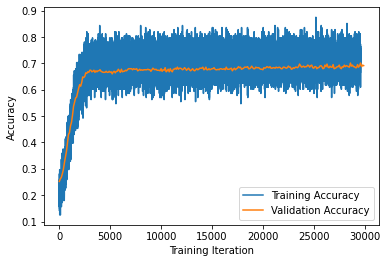

In [17]:
import matplotlib.pyplot as plt
plt.plot(range(len(training_accuracies)), training_accuracies, label = "Training Accuracy")
plt.plot(list(map(lambda x: x * 100, range(len(validation_accuracies)))), validation_accuracies, label = "Validation Accuracy")
plt.xlabel("Training Iteration")
plt.ylabel("Accuracy")
plt.legend()